In [1]:
%load_ext autoreload
%autoreload 2

from tqdm import tqdm
from segtok import tokenizer
from utils import *
import hickle

In [2]:
# Key Hyperparameters
enable_orig = "orig"
enable_aug = False
enable_aug3 = False
max_training_samples = 100000
max_tokenized_length = 64
num_sentences = 10
valid_percent = 0.01

batch_size_finetuning = 32
epochs_finetuning = 1
lr_finetuning = 1e-5

batch_size = 128
epochs = 20
main_model_lr = 1e-5

lstm_hidden_size = 1024
regressive_style_finetuning = False

experiment_id = f"test"

In [3]:
# Parameters
regressive_style_finetuning = False
enable_orig = "preprocess"
enable_aug = False
enable_aug3 = True
max_training_samples = 200000
lstm_hidden_size = 64
epochs = 20
experiment_id = "classification-sentence-embeddings-regressive_style_finetuning-False-enable_orig-preprocess-enable_aug-False-enable_aug3-True-max_training_samples-200000-lstm_hidden_size-64-epochs-20"


In [4]:
import os
experiment_dir = f"completed-experiments/{experiment_id}"
if not os.path.exists(experiment_dir):
    os.makedirs(experiment_dir)

In [5]:
from data_parsing import *
data = load_dataset("./yelp_review_training_dataset.jsonl")

In [6]:
from training_utils import split_train_validation
from text_preprocessing import preprocess
import random

def get_train_valid():
    orig_train_x, valid_x, orig_train_y, valid_y = split_train_validation(data, 0.01)
    train_x = []
    train_y = []

    if enable_aug:
        aug_data = load_gen_dataset("./new_data.json") + load_gen_dataset("./new_data2.json")
        train_x += [i[0] for i in aug_data]
        train_y += [i[1] for i in aug_data]

    if enable_aug3:
        aug_data3 = load_gen_dataset("./new_data3.json")
        train_x += [i[0] for i in aug_data3]
        train_y += [i[1] for i in aug_data3]
        
    if enable_orig:
        train_x += orig_train_x
        train_y += orig_train_y
    
    train_x = train_x[:max_training_samples]
    train_y = train_y[:max_training_samples]

    if enable_orig == "preprocess":
        train_x = preprocess(train_x)
        valid_x = preprocess(valid_x)    

    paired_train = list(zip(train_x, train_y))
    random.shuffle(paired_train)
    train_x = [i[0] for i in paired_train]
    train_y = [i[1] for i in paired_train]

    return [x.encode("utf-8") for x in train_x], [x.encode("utf-8") for x in valid_x], train_y, valid_y

split_key = f"cache-core/split-data-{valid_percent}-orig-{enable_orig}-aug12-{enable_aug}-aug3-{enable_aug3}-max-{max_training_samples}"
train_x, valid_x, train_y, valid_y = memo_load(
    get_train_valid,
    split_key
)
split_key = f"cache-core/split-data-{valid_percent}-orig-{enable_orig}-aug12-{enable_aug}-aug3-{enable_aug3}-max-{len(train_x)}"

train_x = [x.decode("utf-8") for x in train_x]
valid_x = [x.decode("utf-8") for x in valid_x]

In [7]:
print(len(train_x))
print(len(train_y))
print(len(valid_x))
print(len(valid_y))

200000
200000
5336
5336


In [8]:
import torch as th

device = th.device("cuda" if th.cuda.is_available() else "cpu")
print(device)

from spacy.lang.en import English
nlp = English()
nlp.add_pipe("sentencizer")

cuda


In [9]:
from transformers import BertTokenizerFast, BertForSequenceClassification
tokenizer = BertTokenizerFast.from_pretrained("bert-base-uncased")

In [10]:
# fine tune the BERT
import numpy as np

def get_finetuning_data():
    train_x_numerized = []
    train_x_mask = []
    train_y_per_sentence = []
    for i, text in tqdm(list(enumerate(train_x))):
        doc = nlp(text)
        sents = [str(sent) for sent in doc.sents]
        for sentence in sents[:num_sentences]:
            tokenized = tokenizer(sentence, truncation=True, padding="max_length", max_length=max_tokenized_length)[0]
            train_x_numerized.append(tokenized.ids)
            train_x_mask.append(tokenized.attention_mask)
            train_y_per_sentence.append(train_y[i])

    valid_x_numerized = []
    valid_x_mask = []
    valid_y_per_sentence = []
    for i, text in tqdm(list(enumerate(valid_x))):
        doc = nlp(text)
        sents = [str(sent) for sent in doc.sents]
        for sentence in sents[:num_sentences]:
            tokenized = tokenizer(sentence, truncation=True, padding="max_length", max_length=max_tokenized_length)[0]
            valid_x_numerized.append(tokenized.ids)
            valid_x_mask.append(tokenized.attention_mask)
            valid_y_per_sentence.append(valid_y[i])

    train_x_numerized = np.array(train_x_numerized)
    train_x_mask = np.array(train_x_mask)
    train_y_per_sentence = np.array(train_y_per_sentence)
    valid_x_numerized = np.array(valid_x_numerized)
    valid_x_mask = np.array(valid_x_mask)
    valid_y_per_sentence = np.array(valid_y_per_sentence)
    return train_x_numerized, train_x_mask, train_y_per_sentence, valid_x_numerized, valid_x_mask, valid_y_per_sentence

from utils import memo_load
finetuning_data_key = f"cache-core/training-data-finetuning-max-tokens-{max_tokenized_length}-split-{hash_key(split_key)}"
(train_x_numerized, train_x_mask, train_y_per_sentence, valid_x_numerized, valid_x_mask, valid_y_per_sentence) = memo_load(
    lambda: get_finetuning_data(),
    finetuning_data_key
)

In [11]:
from model import ReviewPredictionModel
import torch.optim as optim

def train_finetuning():
    embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=9)

    model_to_train_finetuning = ReviewPredictionModel(0, max_tokenized_length, regressive_bert_style=regressive_style_finetuning)
    model_to_train_finetuning.transformer = embedding_bert
    model_to_train_finetuning.to(device)
    optimizer = optim.Adam(model_to_train_finetuning.parameters(), lr=lr_finetuning)
    
    training_accuracies_finetuning, validation_accuracies_finetuning = run_training_loop(
        model_to_train_finetuning, optimizer, device,
        batch_size_finetuning, epochs_finetuning,
        train_x_numerized, train_x_mask, train_y_per_sentence, valid_x_numerized, valid_x_mask, valid_y_per_sentence,
        max_validation_examples=256,
        model_id=experiment_id, tag="finetuning"
    )
    
    return embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning

def store_finetuning(tup, folder):
    embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning = tup
    th.save(embedding_bert.state_dict(), f"{folder}/model.pt")
    hickle.dump((training_accuracies_finetuning, validation_accuracies_finetuning), f"{folder}/accuracies.hkl", mode="w")

def load_finetuning(folder):
    embedding_bert = BertForSequenceClassification.from_pretrained("bert-base-uncased", num_labels=9)
    embedding_bert.load_state_dict(th.load(f"{folder}/model.pt"))
    embedding_bert.eval()
    embedding_bert.to(device)
    training_accuracies_finetuning, validation_accuracies_finetuning = hickle.load(f"{folder}/accuracies.hkl")
    return embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning

In [12]:
from training_utils import run_training_loop

from utils import memo_load
finetuning_model_key = f"cache-core/finetuning-batch-size-{batch_size_finetuning}-epochs-{epochs_finetuning}-lr-{lr_finetuning}-regressive-{regressive_style_finetuning}-data-{hash_key(finetuning_data_key)}"
embedding_bert, training_accuracies_finetuning, validation_accuracies_finetuning = manual_memo(
    train_finetuning, store_finetuning, load_finetuning,
    finetuning_model_key
)

th.save(embedding_bert.state_dict(), f"{experiment_dir}/finetuned-bert.pt")
hickle.dump((training_accuracies_finetuning, validation_accuracies_finetuning), f"{experiment_dir}/finetuning-accuracies.hkl", mode="w")

Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertForSequenceClassification: ['cls.predictions.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing BertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.weight', 'classifier.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Some weights of the model checkpoint at distilbert-base-uncased were not used when initializing DistilBertForSequenceClassification: ['vocab_transform.weight', 'vocab_transform.bias', 'vocab_layer_norm.weight', 'vocab_layer_norm.bias', 'vocab_projector.weight', 'vocab_projector.bias']
- This IS expected if you are initializing DistilBertForSequenceClassification from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DistilBertForSequenceClassification from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['pre_classifier.weight', 'pre_classifier.bias', 'classifier.weight', 'classifier.bias']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


  0%|          | 0/37059 [00:00<?, ?it/s]

Epoch: 0 Iteration: 0 Loss: 2.520 Validation Loss: 2.442 Accuracy: 0.094 Validation Accuracy: 0.066:   0%|          | 0/37059 [00:00<?, ?it/s]

Epoch: 0 Iteration: 0 Loss: 2.520 Validation Loss: 2.442 Accuracy: 0.094 Validation Accuracy: 0.066:   0%|          | 1/37059 [00:00<6:41:39,  1.54it/s]

Epoch: 0 Iteration: 1 Loss: 2.521 Validation Loss: 2.442 Accuracy: 0.062 Validation Accuracy: 0.066:   0%|          | 1/37059 [00:00<6:41:39,  1.54it/s]

Epoch: 0 Iteration: 2 Loss: 2.487 Validation Loss: 2.442 Accuracy: 0.073 Validation Accuracy: 0.066:   0%|          | 1/37059 [00:00<6:41:39,  1.54it/s]

Epoch: 0 Iteration: 2 Loss: 2.487 Validation Loss: 2.442 Accuracy: 0.073 Validation Accuracy: 0.066:   0%|          | 3/37059 [00:00<2:26:39,  4.21it/s]

Epoch: 0 Iteration: 3 Loss: 2.479 Validation Loss: 2.442 Accuracy: 0.062 Validation Accuracy: 0.066:   0%|          | 3/37059 [00:00<2:26:39,  4.21it/s]

Epoch: 0 Iteration: 4 Loss: 2.443 Validation Loss: 2.442 Accuracy: 0.069 Validation Accuracy: 0.066:   0%|          | 3/37059 [00:01<2:26:39,  4.21it/s]

Epoch: 0 Iteration: 4 Loss: 2.443 Validation Loss: 2.442 Accuracy: 0.069 Validation Accuracy: 0.066:   0%|          | 5/37059 [00:01<1:41:57,  6.06it/s]

Epoch: 0 Iteration: 5 Loss: 2.412 Validation Loss: 2.442 Accuracy: 0.068 Validation Accuracy: 0.066:   0%|          | 5/37059 [00:01<1:41:57,  6.06it/s]

Epoch: 0 Iteration: 6 Loss: 2.392 Validation Loss: 2.442 Accuracy: 0.062 Validation Accuracy: 0.066:   0%|          | 5/37059 [00:01<1:41:57,  6.06it/s]

Epoch: 0 Iteration: 6 Loss: 2.392 Validation Loss: 2.442 Accuracy: 0.062 Validation Accuracy: 0.066:   0%|          | 7/37059 [00:01<1:24:02,  7.35it/s]

Epoch: 0 Iteration: 7 Loss: 2.361 Validation Loss: 2.442 Accuracy: 0.070 Validation Accuracy: 0.066:   0%|          | 7/37059 [00:01<1:24:02,  7.35it/s]

Epoch: 0 Iteration: 8 Loss: 2.342 Validation Loss: 2.442 Accuracy: 0.069 Validation Accuracy: 0.066:   0%|          | 7/37059 [00:01<1:24:02,  7.35it/s]

Epoch: 0 Iteration: 8 Loss: 2.342 Validation Loss: 2.442 Accuracy: 0.069 Validation Accuracy: 0.066:   0%|          | 9/37059 [00:01<1:14:50,  8.25it/s]

Epoch: 0 Iteration: 9 Loss: 2.313 Validation Loss: 2.442 Accuracy: 0.078 Validation Accuracy: 0.066:   0%|          | 9/37059 [00:01<1:14:50,  8.25it/s]

Epoch: 0 Iteration: 10 Loss: 2.288 Validation Loss: 2.442 Accuracy: 0.084 Validation Accuracy: 0.066:   0%|          | 9/37059 [00:01<1:14:50,  8.25it/s]

Epoch: 0 Iteration: 10 Loss: 2.288 Validation Loss: 2.442 Accuracy: 0.084 Validation Accuracy: 0.066:   0%|          | 11/37059 [00:01<1:09:31,  8.88it/s]

Epoch: 0 Iteration: 11 Loss: 2.261 Validation Loss: 2.442 Accuracy: 0.100 Validation Accuracy: 0.066:   0%|          | 11/37059 [00:01<1:09:31,  8.88it/s]

Epoch: 0 Iteration: 12 Loss: 2.225 Validation Loss: 2.442 Accuracy: 0.138 Validation Accuracy: 0.066:   0%|          | 11/37059 [00:01<1:09:31,  8.88it/s]

Epoch: 0 Iteration: 12 Loss: 2.225 Validation Loss: 2.442 Accuracy: 0.138 Validation Accuracy: 0.066:   0%|          | 13/37059 [00:01<1:06:13,  9.32it/s]

Epoch: 0 Iteration: 13 Loss: 2.198 Validation Loss: 2.442 Accuracy: 0.178 Validation Accuracy: 0.066:   0%|          | 13/37059 [00:01<1:06:13,  9.32it/s]

Epoch: 0 Iteration: 14 Loss: 2.176 Validation Loss: 2.442 Accuracy: 0.209 Validation Accuracy: 0.066:   0%|          | 13/37059 [00:01<1:06:13,  9.32it/s]

Epoch: 0 Iteration: 14 Loss: 2.176 Validation Loss: 2.442 Accuracy: 0.209 Validation Accuracy: 0.066:   0%|          | 15/37059 [00:01<1:04:06,  9.63it/s]

Epoch: 0 Iteration: 15 Loss: 2.152 Validation Loss: 2.442 Accuracy: 0.241 Validation Accuracy: 0.066:   0%|          | 15/37059 [00:02<1:04:06,  9.63it/s]

Epoch: 0 Iteration: 16 Loss: 2.136 Validation Loss: 2.442 Accuracy: 0.259 Validation Accuracy: 0.066:   0%|          | 15/37059 [00:02<1:04:06,  9.63it/s]

Epoch: 0 Iteration: 16 Loss: 2.136 Validation Loss: 2.442 Accuracy: 0.259 Validation Accuracy: 0.066:   0%|          | 17/37059 [00:02<1:02:41,  9.85it/s]

Epoch: 0 Iteration: 17 Loss: 2.116 Validation Loss: 2.442 Accuracy: 0.291 Validation Accuracy: 0.066:   0%|          | 17/37059 [00:02<1:02:41,  9.85it/s]

Epoch: 0 Iteration: 18 Loss: 2.099 Validation Loss: 2.442 Accuracy: 0.334 Validation Accuracy: 0.066:   0%|          | 17/37059 [00:02<1:02:41,  9.85it/s]

Epoch: 0 Iteration: 18 Loss: 2.099 Validation Loss: 2.442 Accuracy: 0.334 Validation Accuracy: 0.066:   0%|          | 19/37059 [00:02<1:01:44, 10.00it/s]

Epoch: 0 Iteration: 19 Loss: 2.089 Validation Loss: 2.442 Accuracy: 0.353 Validation Accuracy: 0.066:   0%|          | 19/37059 [00:02<1:01:44, 10.00it/s]

Epoch: 0 Iteration: 20 Loss: 2.059 Validation Loss: 2.442 Accuracy: 0.369 Validation Accuracy: 0.066:   0%|          | 19/37059 [00:02<1:01:44, 10.00it/s]

Epoch: 0 Iteration: 20 Loss: 2.059 Validation Loss: 2.442 Accuracy: 0.369 Validation Accuracy: 0.066:   0%|          | 21/37059 [00:02<1:01:04, 10.11it/s]

Epoch: 0 Iteration: 21 Loss: 2.028 Validation Loss: 2.442 Accuracy: 0.381 Validation Accuracy: 0.066:   0%|          | 21/37059 [00:02<1:01:04, 10.11it/s]

Epoch: 0 Iteration: 22 Loss: 1.998 Validation Loss: 2.442 Accuracy: 0.384 Validation Accuracy: 0.066:   0%|          | 21/37059 [00:02<1:01:04, 10.11it/s]

Epoch: 0 Iteration: 22 Loss: 1.998 Validation Loss: 2.442 Accuracy: 0.384 Validation Accuracy: 0.066:   0%|          | 23/37059 [00:02<1:00:38, 10.18it/s]

Epoch: 0 Iteration: 23 Loss: 1.959 Validation Loss: 2.442 Accuracy: 0.394 Validation Accuracy: 0.066:   0%|          | 23/37059 [00:02<1:00:38, 10.18it/s]

Epoch: 0 Iteration: 24 Loss: 1.932 Validation Loss: 2.442 Accuracy: 0.391 Validation Accuracy: 0.066:   0%|          | 23/37059 [00:02<1:00:38, 10.18it/s]

Epoch: 0 Iteration: 24 Loss: 1.932 Validation Loss: 2.442 Accuracy: 0.391 Validation Accuracy: 0.066:   0%|          | 25/37059 [00:02<1:00:19, 10.23it/s]

Epoch: 0 Iteration: 25 Loss: 1.897 Validation Loss: 2.442 Accuracy: 0.412 Validation Accuracy: 0.066:   0%|          | 25/37059 [00:03<1:00:19, 10.23it/s]

Epoch: 0 Iteration: 26 Loss: 1.870 Validation Loss: 2.442 Accuracy: 0.444 Validation Accuracy: 0.066:   0%|          | 25/37059 [00:03<1:00:19, 10.23it/s]

Epoch: 0 Iteration: 26 Loss: 1.870 Validation Loss: 2.442 Accuracy: 0.444 Validation Accuracy: 0.066:   0%|          | 27/37059 [00:03<1:00:06, 10.27it/s]

Epoch: 0 Iteration: 27 Loss: 1.856 Validation Loss: 2.442 Accuracy: 0.438 Validation Accuracy: 0.066:   0%|          | 27/37059 [00:03<1:00:06, 10.27it/s]

Epoch: 0 Iteration: 28 Loss: 1.831 Validation Loss: 2.442 Accuracy: 0.431 Validation Accuracy: 0.066:   0%|          | 27/37059 [00:03<1:00:06, 10.27it/s]

Epoch: 0 Iteration: 28 Loss: 1.831 Validation Loss: 2.442 Accuracy: 0.431 Validation Accuracy: 0.066:   0%|          | 29/37059 [00:03<59:57, 10.29it/s]  

Epoch: 0 Iteration: 29 Loss: 1.813 Validation Loss: 2.442 Accuracy: 0.441 Validation Accuracy: 0.066:   0%|          | 29/37059 [00:03<59:57, 10.29it/s]

Epoch: 0 Iteration: 30 Loss: 1.797 Validation Loss: 2.442 Accuracy: 0.456 Validation Accuracy: 0.066:   0%|          | 29/37059 [00:03<59:57, 10.29it/s]

Epoch: 0 Iteration: 30 Loss: 1.797 Validation Loss: 2.442 Accuracy: 0.456 Validation Accuracy: 0.066:   0%|          | 31/37059 [00:03<59:50, 10.31it/s]

Epoch: 0 Iteration: 31 Loss: 1.780 Validation Loss: 2.442 Accuracy: 0.472 Validation Accuracy: 0.066:   0%|          | 31/37059 [00:03<59:50, 10.31it/s]

Epoch: 0 Iteration: 32 Loss: 1.772 Validation Loss: 2.442 Accuracy: 0.469 Validation Accuracy: 0.066:   0%|          | 31/37059 [00:03<59:50, 10.31it/s]

Epoch: 0 Iteration: 32 Loss: 1.772 Validation Loss: 2.442 Accuracy: 0.469 Validation Accuracy: 0.066:   0%|          | 33/37059 [00:03<59:51, 10.31it/s]

Epoch: 0 Iteration: 33 Loss: 1.762 Validation Loss: 2.442 Accuracy: 0.459 Validation Accuracy: 0.066:   0%|          | 33/37059 [00:03<59:51, 10.31it/s]

Epoch: 0 Iteration: 34 Loss: 1.751 Validation Loss: 2.442 Accuracy: 0.478 Validation Accuracy: 0.066:   0%|          | 33/37059 [00:03<59:51, 10.31it/s]

Epoch: 0 Iteration: 34 Loss: 1.751 Validation Loss: 2.442 Accuracy: 0.478 Validation Accuracy: 0.066:   0%|          | 35/37059 [00:03<59:47, 10.32it/s]

Epoch: 0 Iteration: 35 Loss: 1.749 Validation Loss: 2.442 Accuracy: 0.450 Validation Accuracy: 0.066:   0%|          | 35/37059 [00:04<59:47, 10.32it/s]

Epoch: 0 Iteration: 36 Loss: 1.745 Validation Loss: 2.442 Accuracy: 0.431 Validation Accuracy: 0.066:   0%|          | 35/37059 [00:04<59:47, 10.32it/s]

Epoch: 0 Iteration: 36 Loss: 1.745 Validation Loss: 2.442 Accuracy: 0.431 Validation Accuracy: 0.066:   0%|          | 37/37059 [00:04<59:45, 10.33it/s]

Epoch: 0 Iteration: 37 Loss: 1.747 Validation Loss: 2.442 Accuracy: 0.434 Validation Accuracy: 0.066:   0%|          | 37/37059 [00:04<59:45, 10.33it/s]

Epoch: 0 Iteration: 38 Loss: 1.732 Validation Loss: 2.442 Accuracy: 0.444 Validation Accuracy: 0.066:   0%|          | 37/37059 [00:04<59:45, 10.33it/s]

Epoch: 0 Iteration: 38 Loss: 1.732 Validation Loss: 2.442 Accuracy: 0.444 Validation Accuracy: 0.066:   0%|          | 39/37059 [00:04<59:41, 10.34it/s]

Epoch: 0 Iteration: 39 Loss: 1.726 Validation Loss: 2.442 Accuracy: 0.431 Validation Accuracy: 0.066:   0%|          | 39/37059 [00:04<59:41, 10.34it/s]

Epoch: 0 Iteration: 40 Loss: 1.709 Validation Loss: 2.442 Accuracy: 0.438 Validation Accuracy: 0.066:   0%|          | 39/37059 [00:04<59:41, 10.34it/s]

Epoch: 0 Iteration: 40 Loss: 1.709 Validation Loss: 2.442 Accuracy: 0.438 Validation Accuracy: 0.066:   0%|          | 41/37059 [00:04<59:39, 10.34it/s]

Epoch: 0 Iteration: 41 Loss: 1.696 Validation Loss: 2.442 Accuracy: 0.441 Validation Accuracy: 0.066:   0%|          | 41/37059 [00:04<59:39, 10.34it/s]

Epoch: 0 Iteration: 42 Loss: 1.678 Validation Loss: 2.442 Accuracy: 0.447 Validation Accuracy: 0.066:   0%|          | 41/37059 [00:04<59:39, 10.34it/s]

Epoch: 0 Iteration: 42 Loss: 1.678 Validation Loss: 2.442 Accuracy: 0.447 Validation Accuracy: 0.066:   0%|          | 43/37059 [00:04<59:38, 10.34it/s]

Epoch: 0 Iteration: 43 Loss: 1.666 Validation Loss: 2.442 Accuracy: 0.450 Validation Accuracy: 0.066:   0%|          | 43/37059 [00:04<59:38, 10.34it/s]

Epoch: 0 Iteration: 44 Loss: 1.648 Validation Loss: 2.442 Accuracy: 0.447 Validation Accuracy: 0.066:   0%|          | 43/37059 [00:04<59:38, 10.34it/s]

Epoch: 0 Iteration: 44 Loss: 1.648 Validation Loss: 2.442 Accuracy: 0.447 Validation Accuracy: 0.066:   0%|          | 45/37059 [00:04<59:37, 10.35it/s]

Epoch: 0 Iteration: 45 Loss: 1.654 Validation Loss: 2.442 Accuracy: 0.450 Validation Accuracy: 0.066:   0%|          | 45/37059 [00:04<59:37, 10.35it/s]

Epoch: 0 Iteration: 46 Loss: 1.639 Validation Loss: 2.442 Accuracy: 0.475 Validation Accuracy: 0.066:   0%|          | 45/37059 [00:05<59:37, 10.35it/s]

Epoch: 0 Iteration: 46 Loss: 1.639 Validation Loss: 2.442 Accuracy: 0.475 Validation Accuracy: 0.066:   0%|          | 47/37059 [00:05<59:38, 10.34it/s]

Epoch: 0 Iteration: 47 Loss: 1.626 Validation Loss: 2.442 Accuracy: 0.469 Validation Accuracy: 0.066:   0%|          | 47/37059 [00:05<59:38, 10.34it/s]

Epoch: 0 Iteration: 48 Loss: 1.622 Validation Loss: 2.442 Accuracy: 0.453 Validation Accuracy: 0.066:   0%|          | 47/37059 [00:05<59:38, 10.34it/s]

Epoch: 0 Iteration: 48 Loss: 1.622 Validation Loss: 2.442 Accuracy: 0.453 Validation Accuracy: 0.066:   0%|          | 49/37059 [00:05<59:36, 10.35it/s]

Epoch: 0 Iteration: 49 Loss: 1.620 Validation Loss: 2.442 Accuracy: 0.463 Validation Accuracy: 0.066:   0%|          | 49/37059 [00:05<59:36, 10.35it/s]

Epoch: 0 Iteration: 50 Loss: 1.617 Validation Loss: 2.442 Accuracy: 0.444 Validation Accuracy: 0.066:   0%|          | 49/37059 [00:05<59:36, 10.35it/s]

Epoch: 0 Iteration: 50 Loss: 1.617 Validation Loss: 2.442 Accuracy: 0.444 Validation Accuracy: 0.066:   0%|          | 51/37059 [00:05<59:35, 10.35it/s]

Epoch: 0 Iteration: 51 Loss: 1.610 Validation Loss: 2.442 Accuracy: 0.441 Validation Accuracy: 0.066:   0%|          | 51/37059 [00:05<59:35, 10.35it/s]

Epoch: 0 Iteration: 52 Loss: 1.607 Validation Loss: 2.442 Accuracy: 0.422 Validation Accuracy: 0.066:   0%|          | 51/37059 [00:05<59:35, 10.35it/s]

Epoch: 0 Iteration: 52 Loss: 1.607 Validation Loss: 2.442 Accuracy: 0.422 Validation Accuracy: 0.066:   0%|          | 53/37059 [00:05<59:35, 10.35it/s]

Epoch: 0 Iteration: 53 Loss: 1.603 Validation Loss: 2.442 Accuracy: 0.409 Validation Accuracy: 0.066:   0%|          | 53/37059 [00:05<59:35, 10.35it/s]

Epoch: 0 Iteration: 54 Loss: 1.602 Validation Loss: 2.442 Accuracy: 0.403 Validation Accuracy: 0.066:   0%|          | 53/37059 [00:05<59:35, 10.35it/s]

Epoch: 0 Iteration: 54 Loss: 1.602 Validation Loss: 2.442 Accuracy: 0.403 Validation Accuracy: 0.066:   0%|          | 55/37059 [00:05<59:36, 10.35it/s]

Epoch: 0 Iteration: 55 Loss: 1.584 Validation Loss: 2.442 Accuracy: 0.428 Validation Accuracy: 0.066:   0%|          | 55/37059 [00:05<59:36, 10.35it/s]

Epoch: 0 Iteration: 56 Loss: 1.576 Validation Loss: 2.442 Accuracy: 0.406 Validation Accuracy: 0.066:   0%|          | 55/37059 [00:06<59:36, 10.35it/s]

Epoch: 0 Iteration: 56 Loss: 1.576 Validation Loss: 2.442 Accuracy: 0.406 Validation Accuracy: 0.066:   0%|          | 57/37059 [00:06<59:36, 10.34it/s]

Epoch: 0 Iteration: 57 Loss: 1.557 Validation Loss: 2.442 Accuracy: 0.425 Validation Accuracy: 0.066:   0%|          | 57/37059 [00:06<59:36, 10.34it/s]

Epoch: 0 Iteration: 58 Loss: 1.561 Validation Loss: 2.442 Accuracy: 0.428 Validation Accuracy: 0.066:   0%|          | 57/37059 [00:06<59:36, 10.34it/s]

Epoch: 0 Iteration: 58 Loss: 1.561 Validation Loss: 2.442 Accuracy: 0.428 Validation Accuracy: 0.066:   0%|          | 59/37059 [00:06<59:36, 10.35it/s]

Epoch: 0 Iteration: 59 Loss: 1.565 Validation Loss: 2.442 Accuracy: 0.425 Validation Accuracy: 0.066:   0%|          | 59/37059 [00:06<59:36, 10.35it/s]

Epoch: 0 Iteration: 60 Loss: 1.555 Validation Loss: 2.442 Accuracy: 0.438 Validation Accuracy: 0.066:   0%|          | 59/37059 [00:06<59:36, 10.35it/s]

Epoch: 0 Iteration: 60 Loss: 1.555 Validation Loss: 2.442 Accuracy: 0.438 Validation Accuracy: 0.066:   0%|          | 61/37059 [00:06<59:35, 10.35it/s]

Epoch: 0 Iteration: 61 Loss: 1.540 Validation Loss: 2.442 Accuracy: 0.444 Validation Accuracy: 0.066:   0%|          | 61/37059 [00:06<59:35, 10.35it/s]

Epoch: 0 Iteration: 62 Loss: 1.532 Validation Loss: 2.442 Accuracy: 0.463 Validation Accuracy: 0.066:   0%|          | 61/37059 [00:06<59:35, 10.35it/s]

Epoch: 0 Iteration: 62 Loss: 1.532 Validation Loss: 2.442 Accuracy: 0.463 Validation Accuracy: 0.066:   0%|          | 63/37059 [00:06<59:34, 10.35it/s]

Epoch: 0 Iteration: 63 Loss: 1.535 Validation Loss: 2.442 Accuracy: 0.469 Validation Accuracy: 0.066:   0%|          | 63/37059 [00:06<59:34, 10.35it/s]

Epoch: 0 Iteration: 64 Loss: 1.550 Validation Loss: 2.442 Accuracy: 0.459 Validation Accuracy: 0.066:   0%|          | 63/37059 [00:06<59:34, 10.35it/s]

Epoch: 0 Iteration: 64 Loss: 1.550 Validation Loss: 2.442 Accuracy: 0.459 Validation Accuracy: 0.066:   0%|          | 65/37059 [00:06<59:33, 10.35it/s]

Epoch: 0 Iteration: 65 Loss: 1.550 Validation Loss: 2.442 Accuracy: 0.441 Validation Accuracy: 0.066:   0%|          | 65/37059 [00:06<59:33, 10.35it/s]

Epoch: 0 Iteration: 66 Loss: 1.549 Validation Loss: 2.442 Accuracy: 0.450 Validation Accuracy: 0.066:   0%|          | 65/37059 [00:07<59:33, 10.35it/s]

Epoch: 0 Iteration: 66 Loss: 1.549 Validation Loss: 2.442 Accuracy: 0.450 Validation Accuracy: 0.066:   0%|          | 67/37059 [00:07<59:32, 10.35it/s]

Epoch: 0 Iteration: 67 Loss: 1.545 Validation Loss: 2.442 Accuracy: 0.434 Validation Accuracy: 0.066:   0%|          | 67/37059 [00:07<59:32, 10.35it/s]

Epoch: 0 Iteration: 68 Loss: 1.539 Validation Loss: 2.442 Accuracy: 0.447 Validation Accuracy: 0.066:   0%|          | 67/37059 [00:07<59:32, 10.35it/s]

Epoch: 0 Iteration: 68 Loss: 1.539 Validation Loss: 2.442 Accuracy: 0.447 Validation Accuracy: 0.066:   0%|          | 69/37059 [00:07<1:00:06, 10.26it/s]

Epoch: 0 Iteration: 69 Loss: 1.529 Validation Loss: 2.442 Accuracy: 0.459 Validation Accuracy: 0.066:   0%|          | 69/37059 [00:07<1:00:06, 10.26it/s]

Epoch: 0 Iteration: 70 Loss: 1.531 Validation Loss: 2.442 Accuracy: 0.444 Validation Accuracy: 0.066:   0%|          | 69/37059 [00:07<1:00:06, 10.26it/s]

Epoch: 0 Iteration: 70 Loss: 1.531 Validation Loss: 2.442 Accuracy: 0.444 Validation Accuracy: 0.066:   0%|          | 71/37059 [00:07<59:57, 10.28it/s]  

Epoch: 0 Iteration: 71 Loss: 1.534 Validation Loss: 2.442 Accuracy: 0.434 Validation Accuracy: 0.066:   0%|          | 71/37059 [00:07<59:57, 10.28it/s]

Epoch: 0 Iteration: 72 Loss: 1.532 Validation Loss: 2.442 Accuracy: 0.431 Validation Accuracy: 0.066:   0%|          | 71/37059 [00:07<59:57, 10.28it/s]

Epoch: 0 Iteration: 72 Loss: 1.532 Validation Loss: 2.442 Accuracy: 0.431 Validation Accuracy: 0.066:   0%|          | 73/37059 [00:07<59:50, 10.30it/s]

Epoch: 0 Iteration: 73 Loss: 1.528 Validation Loss: 2.442 Accuracy: 0.438 Validation Accuracy: 0.066:   0%|          | 73/37059 [00:07<59:50, 10.30it/s]

Epoch: 0 Iteration: 74 Loss: 1.514 Validation Loss: 2.442 Accuracy: 0.456 Validation Accuracy: 0.066:   0%|          | 73/37059 [00:07<59:50, 10.30it/s]

Epoch: 0 Iteration: 74 Loss: 1.514 Validation Loss: 2.442 Accuracy: 0.456 Validation Accuracy: 0.066:   0%|          | 75/37059 [00:07<59:45, 10.32it/s]

Epoch: 0 Iteration: 75 Loss: 1.517 Validation Loss: 2.442 Accuracy: 0.459 Validation Accuracy: 0.066:   0%|          | 75/37059 [00:07<59:45, 10.32it/s]

Epoch: 0 Iteration: 76 Loss: 1.508 Validation Loss: 2.442 Accuracy: 0.459 Validation Accuracy: 0.066:   0%|          | 75/37059 [00:07<59:45, 10.32it/s]

Epoch: 0 Iteration: 76 Loss: 1.508 Validation Loss: 2.442 Accuracy: 0.459 Validation Accuracy: 0.066:   0%|          | 77/37059 [00:07<59:42, 10.32it/s]

Epoch: 0 Iteration: 77 Loss: 1.501 Validation Loss: 2.442 Accuracy: 0.475 Validation Accuracy: 0.066:   0%|          | 77/37059 [00:08<59:42, 10.32it/s]

Epoch: 0 Iteration: 78 Loss: 1.490 Validation Loss: 2.442 Accuracy: 0.475 Validation Accuracy: 0.066:   0%|          | 77/37059 [00:08<59:42, 10.32it/s]

Epoch: 0 Iteration: 78 Loss: 1.490 Validation Loss: 2.442 Accuracy: 0.475 Validation Accuracy: 0.066:   0%|          | 79/37059 [00:08<59:39, 10.33it/s]

Epoch: 0 Iteration: 79 Loss: 1.478 Validation Loss: 2.442 Accuracy: 0.459 Validation Accuracy: 0.066:   0%|          | 79/37059 [00:08<59:39, 10.33it/s]

Epoch: 0 Iteration: 80 Loss: 1.482 Validation Loss: 2.442 Accuracy: 0.484 Validation Accuracy: 0.066:   0%|          | 79/37059 [00:08<59:39, 10.33it/s]

Epoch: 0 Iteration: 80 Loss: 1.482 Validation Loss: 2.442 Accuracy: 0.484 Validation Accuracy: 0.066:   0%|          | 81/37059 [00:08<59:38, 10.33it/s]

Epoch: 0 Iteration: 81 Loss: 1.489 Validation Loss: 2.442 Accuracy: 0.494 Validation Accuracy: 0.066:   0%|          | 81/37059 [00:08<59:38, 10.33it/s]

Epoch: 0 Iteration: 82 Loss: 1.493 Validation Loss: 2.442 Accuracy: 0.506 Validation Accuracy: 0.066:   0%|          | 81/37059 [00:08<59:38, 10.33it/s]

Epoch: 0 Iteration: 82 Loss: 1.493 Validation Loss: 2.442 Accuracy: 0.506 Validation Accuracy: 0.066:   0%|          | 83/37059 [00:08<59:36, 10.34it/s]

Epoch: 0 Iteration: 83 Loss: 1.484 Validation Loss: 2.442 Accuracy: 0.519 Validation Accuracy: 0.066:   0%|          | 83/37059 [00:08<59:36, 10.34it/s]

Epoch: 0 Iteration: 84 Loss: 1.484 Validation Loss: 2.442 Accuracy: 0.487 Validation Accuracy: 0.066:   0%|          | 83/37059 [00:08<59:36, 10.34it/s]

Epoch: 0 Iteration: 84 Loss: 1.484 Validation Loss: 2.442 Accuracy: 0.487 Validation Accuracy: 0.066:   0%|          | 85/37059 [00:08<59:34, 10.34it/s]

Epoch: 0 Iteration: 85 Loss: 1.478 Validation Loss: 2.442 Accuracy: 0.487 Validation Accuracy: 0.066:   0%|          | 85/37059 [00:08<59:34, 10.34it/s]

Epoch: 0 Iteration: 86 Loss: 1.480 Validation Loss: 2.442 Accuracy: 0.481 Validation Accuracy: 0.066:   0%|          | 85/37059 [00:08<59:34, 10.34it/s]

Epoch: 0 Iteration: 86 Loss: 1.480 Validation Loss: 2.442 Accuracy: 0.481 Validation Accuracy: 0.066:   0%|          | 87/37059 [00:08<59:34, 10.34it/s]

Epoch: 0 Iteration: 87 Loss: 1.468 Validation Loss: 2.442 Accuracy: 0.491 Validation Accuracy: 0.066:   0%|          | 87/37059 [00:09<59:34, 10.34it/s]

Epoch: 0 Iteration: 88 Loss: 1.473 Validation Loss: 2.442 Accuracy: 0.484 Validation Accuracy: 0.066:   0%|          | 87/37059 [00:09<59:34, 10.34it/s]

Epoch: 0 Iteration: 88 Loss: 1.473 Validation Loss: 2.442 Accuracy: 0.484 Validation Accuracy: 0.066:   0%|          | 89/37059 [00:09<59:34, 10.34it/s]

Epoch: 0 Iteration: 89 Loss: 1.475 Validation Loss: 2.442 Accuracy: 0.487 Validation Accuracy: 0.066:   0%|          | 89/37059 [00:09<59:34, 10.34it/s]

Epoch: 0 Iteration: 90 Loss: 1.458 Validation Loss: 2.442 Accuracy: 0.481 Validation Accuracy: 0.066:   0%|          | 89/37059 [00:09<59:34, 10.34it/s]

Epoch: 0 Iteration: 90 Loss: 1.458 Validation Loss: 2.442 Accuracy: 0.481 Validation Accuracy: 0.066:   0%|          | 91/37059 [00:09<59:33, 10.34it/s]

Epoch: 0 Iteration: 91 Loss: 1.443 Validation Loss: 2.442 Accuracy: 0.494 Validation Accuracy: 0.066:   0%|          | 91/37059 [00:09<59:33, 10.34it/s]

Epoch: 0 Iteration: 92 Loss: 1.434 Validation Loss: 2.442 Accuracy: 0.481 Validation Accuracy: 0.066:   0%|          | 91/37059 [00:09<59:33, 10.34it/s]

Epoch: 0 Iteration: 92 Loss: 1.434 Validation Loss: 2.442 Accuracy: 0.481 Validation Accuracy: 0.066:   0%|          | 93/37059 [00:09<59:33, 10.34it/s]

Epoch: 0 Iteration: 93 Loss: 1.432 Validation Loss: 2.442 Accuracy: 0.472 Validation Accuracy: 0.066:   0%|          | 93/37059 [00:09<59:33, 10.34it/s]

Epoch: 0 Iteration: 94 Loss: 1.439 Validation Loss: 2.442 Accuracy: 0.497 Validation Accuracy: 0.066:   0%|          | 93/37059 [00:09<59:33, 10.34it/s]

Epoch: 0 Iteration: 94 Loss: 1.439 Validation Loss: 2.442 Accuracy: 0.497 Validation Accuracy: 0.066:   0%|          | 95/37059 [00:09<59:33, 10.34it/s]

Epoch: 0 Iteration: 95 Loss: 1.433 Validation Loss: 2.442 Accuracy: 0.503 Validation Accuracy: 0.066:   0%|          | 95/37059 [00:09<59:33, 10.34it/s]

Epoch: 0 Iteration: 96 Loss: 1.436 Validation Loss: 2.442 Accuracy: 0.500 Validation Accuracy: 0.066:   0%|          | 95/37059 [00:09<59:33, 10.34it/s]

Epoch: 0 Iteration: 96 Loss: 1.436 Validation Loss: 2.442 Accuracy: 0.500 Validation Accuracy: 0.066:   0%|          | 97/37059 [00:09<59:31, 10.35it/s]

Epoch: 0 Iteration: 97 Loss: 1.439 Validation Loss: 2.442 Accuracy: 0.481 Validation Accuracy: 0.066:   0%|          | 97/37059 [00:10<59:31, 10.35it/s]

Epoch: 0 Iteration: 98 Loss: 1.442 Validation Loss: 2.442 Accuracy: 0.481 Validation Accuracy: 0.066:   0%|          | 97/37059 [00:10<59:31, 10.35it/s]

Epoch: 0 Iteration: 98 Loss: 1.442 Validation Loss: 2.442 Accuracy: 0.481 Validation Accuracy: 0.066:   0%|          | 99/37059 [00:10<59:31, 10.35it/s]

Epoch: 0 Iteration: 99 Loss: 1.446 Validation Loss: 2.442 Accuracy: 0.484 Validation Accuracy: 0.066:   0%|          | 99/37059 [00:10<59:31, 10.35it/s]

Epoch: 0 Iteration: 100 Loss: 1.455 Validation Loss: 1.379 Accuracy: 0.472 Validation Accuracy: 0.283:   0%|          | 99/37059 [00:10<59:31, 10.35it/s]

Epoch: 0 Iteration: 100 Loss: 1.455 Validation Loss: 1.379 Accuracy: 0.472 Validation Accuracy: 0.283:   0%|          | 101/37059 [00:10<1:49:50,  5.61it/s]

Epoch: 0 Iteration: 101 Loss: 1.460 Validation Loss: 1.379 Accuracy: 0.441 Validation Accuracy: 0.283:   0%|          | 101/37059 [00:10<1:49:50,  5.61it/s]

Epoch: 0 Iteration: 102 Loss: 1.468 Validation Loss: 1.379 Accuracy: 0.438 Validation Accuracy: 0.283:   0%|          | 101/37059 [00:11<1:49:50,  5.61it/s]

Epoch: 0 Iteration: 102 Loss: 1.468 Validation Loss: 1.379 Accuracy: 0.438 Validation Accuracy: 0.283:   0%|          | 103/37059 [00:11<1:34:03,  6.55it/s]

Epoch: 0 Iteration: 103 Loss: 1.469 Validation Loss: 1.379 Accuracy: 0.444 Validation Accuracy: 0.283:   0%|          | 103/37059 [00:11<1:34:03,  6.55it/s]

Epoch: 0 Iteration: 104 Loss: 1.455 Validation Loss: 1.379 Accuracy: 0.438 Validation Accuracy: 0.283:   0%|          | 103/37059 [00:11<1:34:03,  6.55it/s]

Epoch: 0 Iteration: 104 Loss: 1.455 Validation Loss: 1.379 Accuracy: 0.438 Validation Accuracy: 0.283:   0%|          | 105/37059 [00:11<1:23:42,  7.36it/s]

Epoch: 0 Iteration: 105 Loss: 1.439 Validation Loss: 1.379 Accuracy: 0.450 Validation Accuracy: 0.283:   0%|          | 105/37059 [00:11<1:23:42,  7.36it/s]

Epoch: 0 Iteration: 106 Loss: 1.448 Validation Loss: 1.379 Accuracy: 0.450 Validation Accuracy: 0.283:   0%|          | 105/37059 [00:11<1:23:42,  7.36it/s]

Epoch: 0 Iteration: 106 Loss: 1.448 Validation Loss: 1.379 Accuracy: 0.450 Validation Accuracy: 0.283:   0%|          | 107/37059 [00:11<1:16:30,  8.05it/s]

Epoch: 0 Iteration: 107 Loss: 1.450 Validation Loss: 1.379 Accuracy: 0.466 Validation Accuracy: 0.283:   0%|          | 107/37059 [00:11<1:16:30,  8.05it/s]

Epoch: 0 Iteration: 108 Loss: 1.433 Validation Loss: 1.379 Accuracy: 0.484 Validation Accuracy: 0.283:   0%|          | 107/37059 [00:11<1:16:30,  8.05it/s]

Epoch: 0 Iteration: 108 Loss: 1.433 Validation Loss: 1.379 Accuracy: 0.484 Validation Accuracy: 0.283:   0%|          | 109/37059 [00:11<1:11:28,  8.62it/s]

Epoch: 0 Iteration: 109 Loss: 1.421 Validation Loss: 1.379 Accuracy: 0.506 Validation Accuracy: 0.283:   0%|          | 109/37059 [00:11<1:11:28,  8.62it/s]

Epoch: 0 Iteration: 110 Loss: 1.428 Validation Loss: 1.379 Accuracy: 0.528 Validation Accuracy: 0.283:   0%|          | 109/37059 [00:11<1:11:28,  8.62it/s]

Epoch: 0 Iteration: 110 Loss: 1.428 Validation Loss: 1.379 Accuracy: 0.528 Validation Accuracy: 0.283:   0%|          | 111/37059 [00:11<1:07:55,  9.06it/s]

Epoch: 0 Iteration: 111 Loss: 1.429 Validation Loss: 1.379 Accuracy: 0.547 Validation Accuracy: 0.283:   0%|          | 111/37059 [00:11<1:07:55,  9.06it/s]

Epoch: 0 Iteration: 112 Loss: 1.429 Validation Loss: 1.379 Accuracy: 0.553 Validation Accuracy: 0.283:   0%|          | 111/37059 [00:12<1:07:55,  9.06it/s]

Epoch: 0 Iteration: 112 Loss: 1.429 Validation Loss: 1.379 Accuracy: 0.553 Validation Accuracy: 0.283:   0%|          | 113/37059 [00:12<1:05:30,  9.40it/s]

Epoch: 0 Iteration: 113 Loss: 1.419 Validation Loss: 1.379 Accuracy: 0.556 Validation Accuracy: 0.283:   0%|          | 113/37059 [00:12<1:05:30,  9.40it/s]

Epoch: 0 Iteration: 114 Loss: 1.415 Validation Loss: 1.379 Accuracy: 0.556 Validation Accuracy: 0.283:   0%|          | 113/37059 [00:12<1:05:30,  9.40it/s]

Epoch: 0 Iteration: 114 Loss: 1.415 Validation Loss: 1.379 Accuracy: 0.556 Validation Accuracy: 0.283:   0%|          | 115/37059 [00:12<1:03:46,  9.65it/s]

Epoch: 0 Iteration: 115 Loss: 1.413 Validation Loss: 1.379 Accuracy: 0.550 Validation Accuracy: 0.283:   0%|          | 115/37059 [00:12<1:03:46,  9.65it/s]

Epoch: 0 Iteration: 116 Loss: 1.404 Validation Loss: 1.379 Accuracy: 0.566 Validation Accuracy: 0.283:   0%|          | 115/37059 [00:12<1:03:46,  9.65it/s]

Epoch: 0 Iteration: 116 Loss: 1.404 Validation Loss: 1.379 Accuracy: 0.566 Validation Accuracy: 0.283:   0%|          | 117/37059 [00:12<1:02:33,  9.84it/s]

Epoch: 0 Iteration: 117 Loss: 1.393 Validation Loss: 1.379 Accuracy: 0.581 Validation Accuracy: 0.283:   0%|          | 117/37059 [00:12<1:02:33,  9.84it/s]

Epoch: 0 Iteration: 118 Loss: 1.400 Validation Loss: 1.379 Accuracy: 0.562 Validation Accuracy: 0.283:   0%|          | 117/37059 [00:12<1:02:33,  9.84it/s]

Epoch: 0 Iteration: 118 Loss: 1.400 Validation Loss: 1.379 Accuracy: 0.562 Validation Accuracy: 0.283:   0%|          | 119/37059 [00:12<1:01:42,  9.98it/s]

Epoch: 0 Iteration: 119 Loss: 1.384 Validation Loss: 1.379 Accuracy: 0.559 Validation Accuracy: 0.283:   0%|          | 119/37059 [00:12<1:01:42,  9.98it/s]

Epoch: 0 Iteration: 120 Loss: 1.369 Validation Loss: 1.379 Accuracy: 0.556 Validation Accuracy: 0.283:   0%|          | 119/37059 [00:12<1:01:42,  9.98it/s]

Epoch: 0 Iteration: 120 Loss: 1.369 Validation Loss: 1.379 Accuracy: 0.556 Validation Accuracy: 0.283:   0%|          | 121/37059 [00:12<1:01:07, 10.07it/s]

Epoch: 0 Iteration: 121 Loss: 1.356 Validation Loss: 1.379 Accuracy: 0.556 Validation Accuracy: 0.283:   0%|          | 121/37059 [00:12<1:01:07, 10.07it/s]

Epoch: 0 Iteration: 122 Loss: 1.341 Validation Loss: 1.379 Accuracy: 0.556 Validation Accuracy: 0.283:   0%|          | 121/37059 [00:12<1:01:07, 10.07it/s]

Epoch: 0 Iteration: 122 Loss: 1.341 Validation Loss: 1.379 Accuracy: 0.556 Validation Accuracy: 0.283:   0%|          | 123/37059 [00:12<1:00:43, 10.14it/s]

Epoch: 0 Iteration: 123 Loss: 1.348 Validation Loss: 1.379 Accuracy: 0.547 Validation Accuracy: 0.283:   0%|          | 123/37059 [00:13<1:00:43, 10.14it/s]

Epoch: 0 Iteration: 124 Loss: 1.347 Validation Loss: 1.379 Accuracy: 0.556 Validation Accuracy: 0.283:   0%|          | 123/37059 [00:13<1:00:43, 10.14it/s]

Epoch: 0 Iteration: 124 Loss: 1.347 Validation Loss: 1.379 Accuracy: 0.556 Validation Accuracy: 0.283:   0%|          | 125/37059 [00:13<1:00:26, 10.18it/s]

Epoch: 0 Iteration: 125 Loss: 1.362 Validation Loss: 1.379 Accuracy: 0.547 Validation Accuracy: 0.283:   0%|          | 125/37059 [00:13<1:00:26, 10.18it/s]

Epoch: 0 Iteration: 126 Loss: 1.338 Validation Loss: 1.379 Accuracy: 0.559 Validation Accuracy: 0.283:   0%|          | 125/37059 [00:13<1:00:26, 10.18it/s]

Epoch: 0 Iteration: 126 Loss: 1.338 Validation Loss: 1.379 Accuracy: 0.559 Validation Accuracy: 0.283:   0%|          | 127/37059 [00:13<1:00:13, 10.22it/s]

Epoch: 0 Iteration: 127 Loss: 1.329 Validation Loss: 1.379 Accuracy: 0.544 Validation Accuracy: 0.283:   0%|          | 127/37059 [00:13<1:00:13, 10.22it/s]

Epoch: 0 Iteration: 128 Loss: 1.333 Validation Loss: 1.379 Accuracy: 0.544 Validation Accuracy: 0.283:   0%|          | 127/37059 [00:13<1:00:13, 10.22it/s]

Epoch: 0 Iteration: 128 Loss: 1.333 Validation Loss: 1.379 Accuracy: 0.544 Validation Accuracy: 0.283:   0%|          | 129/37059 [00:13<1:00:03, 10.25it/s]

Epoch: 0 Iteration: 129 Loss: 1.329 Validation Loss: 1.379 Accuracy: 0.547 Validation Accuracy: 0.283:   0%|          | 129/37059 [00:13<1:00:03, 10.25it/s]

Epoch: 0 Iteration: 130 Loss: 1.319 Validation Loss: 1.379 Accuracy: 0.544 Validation Accuracy: 0.283:   0%|          | 129/37059 [00:13<1:00:03, 10.25it/s]

Epoch: 0 Iteration: 130 Loss: 1.319 Validation Loss: 1.379 Accuracy: 0.544 Validation Accuracy: 0.283:   0%|          | 131/37059 [00:13<59:56, 10.27it/s]  

Epoch: 0 Iteration: 131 Loss: 1.323 Validation Loss: 1.379 Accuracy: 0.537 Validation Accuracy: 0.283:   0%|          | 131/37059 [00:13<59:56, 10.27it/s]

Epoch: 0 Iteration: 132 Loss: 1.321 Validation Loss: 1.379 Accuracy: 0.537 Validation Accuracy: 0.283:   0%|          | 131/37059 [00:13<59:56, 10.27it/s]

Epoch: 0 Iteration: 132 Loss: 1.321 Validation Loss: 1.379 Accuracy: 0.537 Validation Accuracy: 0.283:   0%|          | 133/37059 [00:13<59:52, 10.28it/s]

Epoch: 0 Iteration: 133 Loss: 1.331 Validation Loss: 1.379 Accuracy: 0.537 Validation Accuracy: 0.283:   0%|          | 133/37059 [00:14<59:52, 10.28it/s]

Epoch: 0 Iteration: 134 Loss: 1.333 Validation Loss: 1.379 Accuracy: 0.531 Validation Accuracy: 0.283:   0%|          | 133/37059 [00:14<59:52, 10.28it/s]

Epoch: 0 Iteration: 134 Loss: 1.333 Validation Loss: 1.379 Accuracy: 0.531 Validation Accuracy: 0.283:   0%|          | 135/37059 [00:14<59:48, 10.29it/s]

Epoch: 0 Iteration: 135 Loss: 1.337 Validation Loss: 1.379 Accuracy: 0.541 Validation Accuracy: 0.283:   0%|          | 135/37059 [00:14<59:48, 10.29it/s]

Epoch: 0 Iteration: 136 Loss: 1.345 Validation Loss: 1.379 Accuracy: 0.519 Validation Accuracy: 0.283:   0%|          | 135/37059 [00:14<59:48, 10.29it/s]

Epoch: 0 Iteration: 136 Loss: 1.345 Validation Loss: 1.379 Accuracy: 0.519 Validation Accuracy: 0.283:   0%|          | 137/37059 [00:14<59:45, 10.30it/s]

Epoch: 0 Iteration: 137 Loss: 1.342 Validation Loss: 1.379 Accuracy: 0.528 Validation Accuracy: 0.283:   0%|          | 137/37059 [00:14<59:45, 10.30it/s]

Epoch: 0 Iteration: 138 Loss: 1.335 Validation Loss: 1.379 Accuracy: 0.537 Validation Accuracy: 0.283:   0%|          | 137/37059 [00:14<59:45, 10.30it/s]

Epoch: 0 Iteration: 138 Loss: 1.335 Validation Loss: 1.379 Accuracy: 0.537 Validation Accuracy: 0.283:   0%|          | 139/37059 [00:14<59:44, 10.30it/s]

Epoch: 0 Iteration: 139 Loss: 1.323 Validation Loss: 1.379 Accuracy: 0.537 Validation Accuracy: 0.283:   0%|          | 139/37059 [00:14<59:44, 10.30it/s]

Epoch: 0 Iteration: 140 Loss: 1.317 Validation Loss: 1.379 Accuracy: 0.544 Validation Accuracy: 0.283:   0%|          | 139/37059 [00:14<59:44, 10.30it/s]

Epoch: 0 Iteration: 140 Loss: 1.317 Validation Loss: 1.379 Accuracy: 0.544 Validation Accuracy: 0.283:   0%|          | 141/37059 [00:14<59:43, 10.30it/s]

Epoch: 0 Iteration: 141 Loss: 1.309 Validation Loss: 1.379 Accuracy: 0.556 Validation Accuracy: 0.283:   0%|          | 141/37059 [00:14<59:43, 10.30it/s]

Epoch: 0 Iteration: 142 Loss: 1.318 Validation Loss: 1.379 Accuracy: 0.550 Validation Accuracy: 0.283:   0%|          | 141/37059 [00:14<59:43, 10.30it/s]

Epoch: 0 Iteration: 142 Loss: 1.318 Validation Loss: 1.379 Accuracy: 0.550 Validation Accuracy: 0.283:   0%|          | 143/37059 [00:14<59:42, 10.31it/s]

Epoch: 0 Iteration: 143 Loss: 1.311 Validation Loss: 1.379 Accuracy: 0.553 Validation Accuracy: 0.283:   0%|          | 143/37059 [00:15<59:42, 10.31it/s]

Epoch: 0 Iteration: 144 Loss: 1.316 Validation Loss: 1.379 Accuracy: 0.553 Validation Accuracy: 0.283:   0%|          | 143/37059 [00:15<59:42, 10.31it/s]

Epoch: 0 Iteration: 144 Loss: 1.316 Validation Loss: 1.379 Accuracy: 0.553 Validation Accuracy: 0.283:   0%|          | 145/37059 [00:15<59:41, 10.31it/s]

Epoch: 0 Iteration: 145 Loss: 1.299 Validation Loss: 1.379 Accuracy: 0.559 Validation Accuracy: 0.283:   0%|          | 145/37059 [00:15<59:41, 10.31it/s]

Epoch: 0 Iteration: 146 Loss: 1.307 Validation Loss: 1.379 Accuracy: 0.575 Validation Accuracy: 0.283:   0%|          | 145/37059 [00:15<59:41, 10.31it/s]

Epoch: 0 Iteration: 146 Loss: 1.307 Validation Loss: 1.379 Accuracy: 0.575 Validation Accuracy: 0.283:   0%|          | 147/37059 [00:15<59:40, 10.31it/s]

Epoch: 0 Iteration: 147 Loss: 1.315 Validation Loss: 1.379 Accuracy: 0.566 Validation Accuracy: 0.283:   0%|          | 147/37059 [00:15<59:40, 10.31it/s]

Epoch: 0 Iteration: 148 Loss: 1.328 Validation Loss: 1.379 Accuracy: 0.550 Validation Accuracy: 0.283:   0%|          | 147/37059 [00:15<59:40, 10.31it/s]

Epoch: 0 Iteration: 148 Loss: 1.328 Validation Loss: 1.379 Accuracy: 0.550 Validation Accuracy: 0.283:   0%|          | 149/37059 [00:15<59:39, 10.31it/s]

Epoch: 0 Iteration: 149 Loss: 1.330 Validation Loss: 1.379 Accuracy: 0.547 Validation Accuracy: 0.283:   0%|          | 149/37059 [00:15<59:39, 10.31it/s]

Epoch: 0 Iteration: 150 Loss: 1.317 Validation Loss: 1.379 Accuracy: 0.566 Validation Accuracy: 0.283:   0%|          | 149/37059 [00:15<59:39, 10.31it/s]

Epoch: 0 Iteration: 150 Loss: 1.317 Validation Loss: 1.379 Accuracy: 0.566 Validation Accuracy: 0.283:   0%|          | 151/37059 [00:15<59:39, 10.31it/s]

Epoch: 0 Iteration: 151 Loss: 1.319 Validation Loss: 1.379 Accuracy: 0.559 Validation Accuracy: 0.283:   0%|          | 151/37059 [00:15<59:39, 10.31it/s]

Epoch: 0 Iteration: 152 Loss: 1.315 Validation Loss: 1.379 Accuracy: 0.575 Validation Accuracy: 0.283:   0%|          | 151/37059 [00:15<59:39, 10.31it/s]

Epoch: 0 Iteration: 152 Loss: 1.315 Validation Loss: 1.379 Accuracy: 0.575 Validation Accuracy: 0.283:   0%|          | 153/37059 [00:15<59:39, 10.31it/s]

Epoch: 0 Iteration: 153 Loss: 1.317 Validation Loss: 1.379 Accuracy: 0.559 Validation Accuracy: 0.283:   0%|          | 153/37059 [00:15<59:39, 10.31it/s]

Epoch: 0 Iteration: 154 Loss: 1.309 Validation Loss: 1.379 Accuracy: 0.569 Validation Accuracy: 0.283:   0%|          | 153/37059 [00:16<59:39, 10.31it/s]

Epoch: 0 Iteration: 154 Loss: 1.309 Validation Loss: 1.379 Accuracy: 0.569 Validation Accuracy: 0.283:   0%|          | 155/37059 [00:16<59:41, 10.30it/s]

Epoch: 0 Iteration: 155 Loss: 1.308 Validation Loss: 1.379 Accuracy: 0.553 Validation Accuracy: 0.283:   0%|          | 155/37059 [00:16<59:41, 10.30it/s]

Epoch: 0 Iteration: 156 Loss: 1.290 Validation Loss: 1.379 Accuracy: 0.550 Validation Accuracy: 0.283:   0%|          | 155/37059 [00:16<59:41, 10.30it/s]

Epoch: 0 Iteration: 156 Loss: 1.290 Validation Loss: 1.379 Accuracy: 0.550 Validation Accuracy: 0.283:   0%|          | 157/37059 [00:16<59:40, 10.31it/s]

Epoch: 0 Iteration: 157 Loss: 1.310 Validation Loss: 1.379 Accuracy: 0.531 Validation Accuracy: 0.283:   0%|          | 157/37059 [00:16<59:40, 10.31it/s]

Epoch: 0 Iteration: 158 Loss: 1.292 Validation Loss: 1.379 Accuracy: 0.566 Validation Accuracy: 0.283:   0%|          | 157/37059 [00:16<59:40, 10.31it/s]

Epoch: 0 Iteration: 158 Loss: 1.292 Validation Loss: 1.379 Accuracy: 0.566 Validation Accuracy: 0.283:   0%|          | 159/37059 [00:16<59:39, 10.31it/s]

Epoch: 0 Iteration: 159 Loss: 1.292 Validation Loss: 1.379 Accuracy: 0.572 Validation Accuracy: 0.283:   0%|          | 159/37059 [00:16<59:39, 10.31it/s]

Epoch: 0 Iteration: 160 Loss: 1.293 Validation Loss: 1.379 Accuracy: 0.544 Validation Accuracy: 0.283:   0%|          | 159/37059 [00:16<59:39, 10.31it/s]

Epoch: 0 Iteration: 160 Loss: 1.293 Validation Loss: 1.379 Accuracy: 0.544 Validation Accuracy: 0.283:   0%|          | 161/37059 [00:16<59:39, 10.31it/s]

Epoch: 0 Iteration: 161 Loss: 1.310 Validation Loss: 1.379 Accuracy: 0.534 Validation Accuracy: 0.283:   0%|          | 161/37059 [00:16<59:39, 10.31it/s]

Epoch: 0 Iteration: 162 Loss: 1.308 Validation Loss: 1.379 Accuracy: 0.522 Validation Accuracy: 0.283:   0%|          | 161/37059 [00:16<59:39, 10.31it/s]

Epoch: 0 Iteration: 162 Loss: 1.308 Validation Loss: 1.379 Accuracy: 0.522 Validation Accuracy: 0.283:   0%|          | 163/37059 [00:16<59:38, 10.31it/s]

Epoch: 0 Iteration: 163 Loss: 1.298 Validation Loss: 1.379 Accuracy: 0.550 Validation Accuracy: 0.283:   0%|          | 163/37059 [00:16<59:38, 10.31it/s]

Epoch: 0 Iteration: 164 Loss: 1.290 Validation Loss: 1.379 Accuracy: 0.544 Validation Accuracy: 0.283:   0%|          | 163/37059 [00:17<59:38, 10.31it/s]

Epoch: 0 Iteration: 164 Loss: 1.290 Validation Loss: 1.379 Accuracy: 0.544 Validation Accuracy: 0.283:   0%|          | 165/37059 [00:17<59:38, 10.31it/s]

Epoch: 0 Iteration: 165 Loss: 1.287 Validation Loss: 1.379 Accuracy: 0.566 Validation Accuracy: 0.283:   0%|          | 165/37059 [00:17<59:38, 10.31it/s]

Epoch: 0 Iteration: 166 Loss: 1.274 Validation Loss: 1.379 Accuracy: 0.581 Validation Accuracy: 0.283:   0%|          | 165/37059 [00:17<59:38, 10.31it/s]

Epoch: 0 Iteration: 166 Loss: 1.274 Validation Loss: 1.379 Accuracy: 0.581 Validation Accuracy: 0.283:   0%|          | 167/37059 [00:17<59:37, 10.31it/s]

Epoch: 0 Iteration: 167 Loss: 1.265 Validation Loss: 1.379 Accuracy: 0.603 Validation Accuracy: 0.283:   0%|          | 167/37059 [00:17<59:37, 10.31it/s]

Epoch: 0 Iteration: 168 Loss: 1.253 Validation Loss: 1.379 Accuracy: 0.572 Validation Accuracy: 0.283:   0%|          | 167/37059 [00:17<59:37, 10.31it/s]

Epoch: 0 Iteration: 168 Loss: 1.253 Validation Loss: 1.379 Accuracy: 0.572 Validation Accuracy: 0.283:   0%|          | 169/37059 [00:17<59:37, 10.31it/s]

Epoch: 0 Iteration: 169 Loss: 1.245 Validation Loss: 1.379 Accuracy: 0.575 Validation Accuracy: 0.283:   0%|          | 169/37059 [00:17<59:37, 10.31it/s]

Epoch: 0 Iteration: 170 Loss: 1.255 Validation Loss: 1.379 Accuracy: 0.588 Validation Accuracy: 0.283:   0%|          | 169/37059 [00:17<59:37, 10.31it/s]

Epoch: 0 Iteration: 170 Loss: 1.255 Validation Loss: 1.379 Accuracy: 0.588 Validation Accuracy: 0.283:   0%|          | 171/37059 [00:17<59:36, 10.31it/s]

Epoch: 0 Iteration: 171 Loss: 1.242 Validation Loss: 1.379 Accuracy: 0.609 Validation Accuracy: 0.283:   0%|          | 171/37059 [00:17<59:36, 10.31it/s]

Epoch: 0 Iteration: 172 Loss: 1.238 Validation Loss: 1.379 Accuracy: 0.616 Validation Accuracy: 0.283:   0%|          | 171/37059 [00:17<59:36, 10.31it/s]

Epoch: 0 Iteration: 172 Loss: 1.238 Validation Loss: 1.379 Accuracy: 0.616 Validation Accuracy: 0.283:   0%|          | 173/37059 [00:17<59:36, 10.31it/s]

Epoch: 0 Iteration: 173 Loss: 1.229 Validation Loss: 1.379 Accuracy: 0.603 Validation Accuracy: 0.283:   0%|          | 173/37059 [00:17<59:36, 10.31it/s]

Epoch: 0 Iteration: 174 Loss: 1.227 Validation Loss: 1.379 Accuracy: 0.613 Validation Accuracy: 0.283:   0%|          | 173/37059 [00:18<59:36, 10.31it/s]

Epoch: 0 Iteration: 174 Loss: 1.227 Validation Loss: 1.379 Accuracy: 0.613 Validation Accuracy: 0.283:   0%|          | 175/37059 [00:18<59:36, 10.31it/s]

Epoch: 0 Iteration: 175 Loss: 1.216 Validation Loss: 1.379 Accuracy: 0.609 Validation Accuracy: 0.283:   0%|          | 175/37059 [00:18<59:36, 10.31it/s]

Epoch: 0 Iteration: 176 Loss: 1.223 Validation Loss: 1.379 Accuracy: 0.591 Validation Accuracy: 0.283:   0%|          | 175/37059 [00:18<59:36, 10.31it/s]

Epoch: 0 Iteration: 176 Loss: 1.223 Validation Loss: 1.379 Accuracy: 0.591 Validation Accuracy: 0.283:   0%|          | 177/37059 [00:18<59:36, 10.31it/s]

Epoch: 0 Iteration: 177 Loss: 1.214 Validation Loss: 1.379 Accuracy: 0.578 Validation Accuracy: 0.283:   0%|          | 177/37059 [00:18<59:36, 10.31it/s]

Epoch: 0 Iteration: 178 Loss: 1.228 Validation Loss: 1.379 Accuracy: 0.581 Validation Accuracy: 0.283:   0%|          | 177/37059 [00:18<59:36, 10.31it/s]

Epoch: 0 Iteration: 178 Loss: 1.228 Validation Loss: 1.379 Accuracy: 0.581 Validation Accuracy: 0.283:   0%|          | 179/37059 [00:18<59:36, 10.31it/s]

Epoch: 0 Iteration: 179 Loss: 1.229 Validation Loss: 1.379 Accuracy: 0.572 Validation Accuracy: 0.283:   0%|          | 179/37059 [00:18<59:36, 10.31it/s]

Epoch: 0 Iteration: 180 Loss: 1.234 Validation Loss: 1.379 Accuracy: 0.562 Validation Accuracy: 0.283:   0%|          | 179/37059 [00:18<59:36, 10.31it/s]

Epoch: 0 Iteration: 180 Loss: 1.234 Validation Loss: 1.379 Accuracy: 0.562 Validation Accuracy: 0.283:   0%|          | 181/37059 [00:18<59:36, 10.31it/s]

Epoch: 0 Iteration: 181 Loss: 1.215 Validation Loss: 1.379 Accuracy: 0.559 Validation Accuracy: 0.283:   0%|          | 181/37059 [00:18<59:36, 10.31it/s]

Epoch: 0 Iteration: 182 Loss: 1.200 Validation Loss: 1.379 Accuracy: 0.572 Validation Accuracy: 0.283:   0%|          | 181/37059 [00:18<59:36, 10.31it/s]

Epoch: 0 Iteration: 182 Loss: 1.200 Validation Loss: 1.379 Accuracy: 0.572 Validation Accuracy: 0.283:   0%|          | 183/37059 [00:18<59:36, 10.31it/s]

Epoch: 0 Iteration: 183 Loss: 1.208 Validation Loss: 1.379 Accuracy: 0.562 Validation Accuracy: 0.283:   0%|          | 183/37059 [00:18<59:36, 10.31it/s]

Epoch: 0 Iteration: 184 Loss: 1.198 Validation Loss: 1.379 Accuracy: 0.559 Validation Accuracy: 0.283:   0%|          | 183/37059 [00:18<59:36, 10.31it/s]

Epoch: 0 Iteration: 184 Loss: 1.198 Validation Loss: 1.379 Accuracy: 0.559 Validation Accuracy: 0.283:   0%|          | 185/37059 [00:18<59:35, 10.31it/s]

Epoch: 0 Iteration: 185 Loss: 1.190 Validation Loss: 1.379 Accuracy: 0.562 Validation Accuracy: 0.283:   0%|          | 185/37059 [00:19<59:35, 10.31it/s]

Epoch: 0 Iteration: 186 Loss: 1.202 Validation Loss: 1.379 Accuracy: 0.566 Validation Accuracy: 0.283:   0%|          | 185/37059 [00:19<59:35, 10.31it/s]

Epoch: 0 Iteration: 186 Loss: 1.202 Validation Loss: 1.379 Accuracy: 0.566 Validation Accuracy: 0.283:   1%|          | 187/37059 [00:19<59:36, 10.31it/s]

Epoch: 0 Iteration: 187 Loss: 1.211 Validation Loss: 1.379 Accuracy: 0.566 Validation Accuracy: 0.283:   1%|          | 187/37059 [00:19<59:36, 10.31it/s]

Epoch: 0 Iteration: 188 Loss: 1.202 Validation Loss: 1.379 Accuracy: 0.581 Validation Accuracy: 0.283:   1%|          | 187/37059 [00:19<59:36, 10.31it/s]

Epoch: 0 Iteration: 188 Loss: 1.202 Validation Loss: 1.379 Accuracy: 0.581 Validation Accuracy: 0.283:   1%|          | 189/37059 [00:19<59:37, 10.31it/s]

Epoch: 0 Iteration: 189 Loss: 1.212 Validation Loss: 1.379 Accuracy: 0.575 Validation Accuracy: 0.283:   1%|          | 189/37059 [00:19<59:37, 10.31it/s]

Epoch: 0 Iteration: 190 Loss: 1.218 Validation Loss: 1.379 Accuracy: 0.575 Validation Accuracy: 0.283:   1%|          | 189/37059 [00:19<59:37, 10.31it/s]

Epoch: 0 Iteration: 190 Loss: 1.218 Validation Loss: 1.379 Accuracy: 0.575 Validation Accuracy: 0.283:   1%|          | 191/37059 [00:19<59:35, 10.31it/s]

Epoch: 0 Iteration: 191 Loss: 1.223 Validation Loss: 1.379 Accuracy: 0.572 Validation Accuracy: 0.283:   1%|          | 191/37059 [00:19<59:35, 10.31it/s]

Epoch: 0 Iteration: 192 Loss: 1.227 Validation Loss: 1.379 Accuracy: 0.556 Validation Accuracy: 0.283:   1%|          | 191/37059 [00:19<59:35, 10.31it/s]

Epoch: 0 Iteration: 192 Loss: 1.227 Validation Loss: 1.379 Accuracy: 0.556 Validation Accuracy: 0.283:   1%|          | 193/37059 [00:19<59:35, 10.31it/s]

Epoch: 0 Iteration: 193 Loss: 1.217 Validation Loss: 1.379 Accuracy: 0.575 Validation Accuracy: 0.283:   1%|          | 193/37059 [00:19<59:35, 10.31it/s]

Epoch: 0 Iteration: 194 Loss: 1.213 Validation Loss: 1.379 Accuracy: 0.575 Validation Accuracy: 0.283:   1%|          | 193/37059 [00:19<59:35, 10.31it/s]

Epoch: 0 Iteration: 194 Loss: 1.213 Validation Loss: 1.379 Accuracy: 0.575 Validation Accuracy: 0.283:   1%|          | 195/37059 [00:19<59:34, 10.31it/s]

Epoch: 0 Iteration: 195 Loss: 1.231 Validation Loss: 1.379 Accuracy: 0.550 Validation Accuracy: 0.283:   1%|          | 195/37059 [00:20<59:34, 10.31it/s]

Epoch: 0 Iteration: 196 Loss: 1.228 Validation Loss: 1.379 Accuracy: 0.553 Validation Accuracy: 0.283:   1%|          | 195/37059 [00:20<59:34, 10.31it/s]

Epoch: 0 Iteration: 196 Loss: 1.228 Validation Loss: 1.379 Accuracy: 0.553 Validation Accuracy: 0.283:   1%|          | 197/37059 [00:20<59:34, 10.31it/s]

Epoch: 0 Iteration: 197 Loss: 1.211 Validation Loss: 1.379 Accuracy: 0.569 Validation Accuracy: 0.283:   1%|          | 197/37059 [00:20<59:34, 10.31it/s]

Epoch: 0 Iteration: 198 Loss: 1.206 Validation Loss: 1.379 Accuracy: 0.566 Validation Accuracy: 0.283:   1%|          | 197/37059 [00:20<59:34, 10.31it/s]

Epoch: 0 Iteration: 198 Loss: 1.206 Validation Loss: 1.379 Accuracy: 0.566 Validation Accuracy: 0.283:   1%|          | 199/37059 [00:20<59:33, 10.31it/s]

Epoch: 0 Iteration: 199 Loss: 1.211 Validation Loss: 1.379 Accuracy: 0.566 Validation Accuracy: 0.283:   1%|          | 199/37059 [00:20<59:33, 10.31it/s]

Epoch: 0 Iteration: 200 Loss: 1.211 Validation Loss: 1.132 Accuracy: 0.566 Validation Accuracy: 0.405:   1%|          | 199/37059 [00:21<59:33, 10.31it/s]

Epoch: 0 Iteration: 200 Loss: 1.211 Validation Loss: 1.132 Accuracy: 0.566 Validation Accuracy: 0.405:   1%|          | 201/37059 [00:21<1:50:02,  5.58it/s]

Epoch: 0 Iteration: 201 Loss: 1.226 Validation Loss: 1.132 Accuracy: 0.553 Validation Accuracy: 0.405:   1%|          | 201/37059 [00:21<1:50:02,  5.58it/s]

Epoch: 0 Iteration: 202 Loss: 1.231 Validation Loss: 1.132 Accuracy: 0.550 Validation Accuracy: 0.405:   1%|          | 201/37059 [00:21<1:50:02,  5.58it/s]

Epoch: 0 Iteration: 202 Loss: 1.231 Validation Loss: 1.132 Accuracy: 0.550 Validation Accuracy: 0.405:   1%|          | 203/37059 [00:21<1:34:04,  6.53it/s]

Epoch: 0 Iteration: 203 Loss: 1.224 Validation Loss: 1.132 Accuracy: 0.541 Validation Accuracy: 0.405:   1%|          | 203/37059 [00:21<1:34:04,  6.53it/s]

Epoch: 0 Iteration: 204 Loss: 1.231 Validation Loss: 1.132 Accuracy: 0.547 Validation Accuracy: 0.405:   1%|          | 203/37059 [00:21<1:34:04,  6.53it/s]

Epoch: 0 Iteration: 204 Loss: 1.231 Validation Loss: 1.132 Accuracy: 0.547 Validation Accuracy: 0.405:   1%|          | 205/37059 [00:21<1:23:44,  7.34it/s]

Epoch: 0 Iteration: 205 Loss: 1.257 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.405:   1%|          | 205/37059 [00:21<1:23:44,  7.34it/s]

Epoch: 0 Iteration: 206 Loss: 1.264 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.405:   1%|          | 205/37059 [00:21<1:23:44,  7.34it/s]

Epoch: 0 Iteration: 206 Loss: 1.264 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.405:   1%|          | 207/37059 [00:21<1:16:29,  8.03it/s]

Epoch: 0 Iteration: 207 Loss: 1.251 Validation Loss: 1.132 Accuracy: 0.516 Validation Accuracy: 0.405:   1%|          | 207/37059 [00:21<1:16:29,  8.03it/s]

Epoch: 0 Iteration: 208 Loss: 1.256 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.405:   1%|          | 207/37059 [00:21<1:16:29,  8.03it/s]

Epoch: 0 Iteration: 208 Loss: 1.256 Validation Loss: 1.132 Accuracy: 0.519 Validation Accuracy: 0.405:   1%|          | 209/37059 [00:21<1:11:24,  8.60it/s]

Epoch: 0 Iteration: 209 Loss: 1.248 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.405:   1%|          | 209/37059 [00:21<1:11:24,  8.60it/s]

Epoch: 0 Iteration: 210 Loss: 1.243 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.405:   1%|          | 209/37059 [00:22<1:11:24,  8.60it/s]

Epoch: 0 Iteration: 210 Loss: 1.243 Validation Loss: 1.132 Accuracy: 0.525 Validation Accuracy: 0.405:   1%|          | 211/37059 [00:22<1:07:50,  9.05it/s]

Epoch: 0 Iteration: 211 Loss: 1.241 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.405:   1%|          | 211/37059 [00:22<1:07:50,  9.05it/s]

Epoch: 0 Iteration: 212 Loss: 1.241 Validation Loss: 1.132 Accuracy: 0.541 Validation Accuracy: 0.405:   1%|          | 211/37059 [00:22<1:07:50,  9.05it/s]

Epoch: 0 Iteration: 212 Loss: 1.241 Validation Loss: 1.132 Accuracy: 0.541 Validation Accuracy: 0.405:   1%|          | 213/37059 [00:22<1:05:21,  9.40it/s]

Epoch: 0 Iteration: 213 Loss: 1.250 Validation Loss: 1.132 Accuracy: 0.537 Validation Accuracy: 0.405:   1%|          | 213/37059 [00:22<1:05:21,  9.40it/s]

Epoch: 0 Iteration: 214 Loss: 1.272 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.405:   1%|          | 213/37059 [00:22<1:05:21,  9.40it/s]

Epoch: 0 Iteration: 214 Loss: 1.272 Validation Loss: 1.132 Accuracy: 0.512 Validation Accuracy: 0.405:   1%|          | 215/37059 [00:22<1:03:36,  9.65it/s]

Epoch: 0 Iteration: 215 Loss: 1.259 Validation Loss: 1.132 Accuracy: 0.534 Validation Accuracy: 0.405:   1%|          | 215/37059 [00:22<1:03:36,  9.65it/s]

Epoch: 0 Iteration: 216 Loss: 1.264 Validation Loss: 1.132 Accuracy: 0.547 Validation Accuracy: 0.405:   1%|          | 215/37059 [00:22<1:03:36,  9.65it/s]

Epoch: 0 Iteration: 216 Loss: 1.264 Validation Loss: 1.132 Accuracy: 0.547 Validation Accuracy: 0.405:   1%|          | 217/37059 [00:22<1:02:22,  9.84it/s]

Epoch: 0 Iteration: 217 Loss: 1.266 Validation Loss: 1.132 Accuracy: 0.547 Validation Accuracy: 0.405:   1%|          | 217/37059 [00:22<1:02:22,  9.84it/s]

Epoch: 0 Iteration: 218 Loss: 1.259 Validation Loss: 1.132 Accuracy: 0.553 Validation Accuracy: 0.405:   1%|          | 217/37059 [00:22<1:02:22,  9.84it/s]

Epoch: 0 Iteration: 218 Loss: 1.259 Validation Loss: 1.132 Accuracy: 0.553 Validation Accuracy: 0.405:   1%|          | 219/37059 [00:22<1:01:31,  9.98it/s]

Epoch: 0 Iteration: 219 Loss: 1.258 Validation Loss: 1.132 Accuracy: 0.553 Validation Accuracy: 0.405:   1%|          | 219/37059 [00:22<1:01:31,  9.98it/s]

Epoch: 0 Iteration: 220 Loss: 1.251 Validation Loss: 1.132 Accuracy: 0.553 Validation Accuracy: 0.405:   1%|          | 219/37059 [00:23<1:01:31,  9.98it/s]

Epoch: 0 Iteration: 220 Loss: 1.251 Validation Loss: 1.132 Accuracy: 0.553 Validation Accuracy: 0.405:   1%|          | 221/37059 [00:23<1:00:56, 10.07it/s]

Epoch: 0 Iteration: 221 Loss: 1.241 Validation Loss: 1.132 Accuracy: 0.541 Validation Accuracy: 0.405:   1%|          | 221/37059 [00:23<1:00:56, 10.07it/s]

Epoch: 0 Iteration: 222 Loss: 1.247 Validation Loss: 1.132 Accuracy: 0.544 Validation Accuracy: 0.405:   1%|          | 221/37059 [00:23<1:00:56, 10.07it/s]

Epoch: 0 Iteration: 222 Loss: 1.247 Validation Loss: 1.132 Accuracy: 0.544 Validation Accuracy: 0.405:   1%|          | 223/37059 [00:23<1:00:30, 10.15it/s]

Epoch: 0 Iteration: 223 Loss: 1.249 Validation Loss: 1.132 Accuracy: 0.556 Validation Accuracy: 0.405:   1%|          | 223/37059 [00:23<1:00:30, 10.15it/s]

Epoch: 0 Iteration: 224 Loss: 1.250 Validation Loss: 1.132 Accuracy: 0.575 Validation Accuracy: 0.405:   1%|          | 223/37059 [00:23<1:00:30, 10.15it/s]

Epoch: 0 Iteration: 224 Loss: 1.250 Validation Loss: 1.132 Accuracy: 0.575 Validation Accuracy: 0.405:   1%|          | 225/37059 [00:23<1:00:12, 10.20it/s]

Epoch: 0 Iteration: 225 Loss: 1.236 Validation Loss: 1.132 Accuracy: 0.578 Validation Accuracy: 0.405:   1%|          | 225/37059 [00:23<1:00:12, 10.20it/s]

Epoch: 0 Iteration: 226 Loss: 1.234 Validation Loss: 1.132 Accuracy: 0.584 Validation Accuracy: 0.405:   1%|          | 225/37059 [00:23<1:00:12, 10.20it/s]

Epoch: 0 Iteration: 226 Loss: 1.234 Validation Loss: 1.132 Accuracy: 0.584 Validation Accuracy: 0.405:   1%|          | 227/37059 [00:23<1:00:01, 10.23it/s]

Epoch: 0 Iteration: 227 Loss: 1.221 Validation Loss: 1.132 Accuracy: 0.597 Validation Accuracy: 0.405:   1%|          | 227/37059 [00:23<1:00:01, 10.23it/s]

Epoch: 0 Iteration: 228 Loss: 1.212 Validation Loss: 1.132 Accuracy: 0.588 Validation Accuracy: 0.405:   1%|          | 227/37059 [00:23<1:00:01, 10.23it/s]

Epoch: 0 Iteration: 228 Loss: 1.212 Validation Loss: 1.132 Accuracy: 0.588 Validation Accuracy: 0.405:   1%|          | 229/37059 [00:23<59:50, 10.26it/s]  

Epoch: 0 Iteration: 229 Loss: 1.211 Validation Loss: 1.132 Accuracy: 0.597 Validation Accuracy: 0.405:   1%|          | 229/37059 [00:23<59:50, 10.26it/s]

Epoch: 0 Iteration: 230 Loss: 1.201 Validation Loss: 1.132 Accuracy: 0.613 Validation Accuracy: 0.405:   1%|          | 229/37059 [00:23<59:50, 10.26it/s]

Epoch: 0 Iteration: 230 Loss: 1.201 Validation Loss: 1.132 Accuracy: 0.613 Validation Accuracy: 0.405:   1%|          | 231/37059 [00:23<59:45, 10.27it/s]

Epoch: 0 Iteration: 231 Loss: 1.201 Validation Loss: 1.132 Accuracy: 0.619 Validation Accuracy: 0.405:   1%|          | 231/37059 [00:24<59:45, 10.27it/s]

Epoch: 0 Iteration: 232 Loss: 1.205 Validation Loss: 1.132 Accuracy: 0.613 Validation Accuracy: 0.405:   1%|          | 231/37059 [00:24<59:45, 10.27it/s]

Epoch: 0 Iteration: 232 Loss: 1.205 Validation Loss: 1.132 Accuracy: 0.613 Validation Accuracy: 0.405:   1%|          | 233/37059 [00:24<59:45, 10.27it/s]

Epoch: 0 Iteration: 233 Loss: 1.220 Validation Loss: 1.132 Accuracy: 0.584 Validation Accuracy: 0.405:   1%|          | 233/37059 [00:24<59:45, 10.27it/s]

Epoch: 0 Iteration: 234 Loss: 1.211 Validation Loss: 1.132 Accuracy: 0.581 Validation Accuracy: 0.405:   1%|          | 233/37059 [00:24<59:45, 10.27it/s]

Epoch: 0 Iteration: 234 Loss: 1.211 Validation Loss: 1.132 Accuracy: 0.581 Validation Accuracy: 0.405:   1%|          | 235/37059 [00:24<59:40, 10.28it/s]

Epoch: 0 Iteration: 235 Loss: 1.205 Validation Loss: 1.132 Accuracy: 0.588 Validation Accuracy: 0.405:   1%|          | 235/37059 [00:24<59:40, 10.28it/s]

Epoch: 0 Iteration: 236 Loss: 1.189 Validation Loss: 1.132 Accuracy: 0.597 Validation Accuracy: 0.405:   1%|          | 235/37059 [00:24<59:40, 10.28it/s]

Epoch: 0 Iteration: 236 Loss: 1.189 Validation Loss: 1.132 Accuracy: 0.597 Validation Accuracy: 0.405:   1%|          | 237/37059 [00:24<59:36, 10.30it/s]

Epoch: 0 Iteration: 237 Loss: 1.184 Validation Loss: 1.132 Accuracy: 0.591 Validation Accuracy: 0.405:   1%|          | 237/37059 [00:24<59:36, 10.30it/s]

Epoch: 0 Iteration: 238 Loss: 1.184 Validation Loss: 1.132 Accuracy: 0.594 Validation Accuracy: 0.405:   1%|          | 237/37059 [00:24<59:36, 10.30it/s]

Epoch: 0 Iteration: 238 Loss: 1.184 Validation Loss: 1.132 Accuracy: 0.594 Validation Accuracy: 0.405:   1%|          | 239/37059 [00:24<59:35, 10.30it/s]

Epoch: 0 Iteration: 239 Loss: 1.172 Validation Loss: 1.132 Accuracy: 0.594 Validation Accuracy: 0.405:   1%|          | 239/37059 [00:24<59:35, 10.30it/s]

Epoch: 0 Iteration: 240 Loss: 1.181 Validation Loss: 1.132 Accuracy: 0.569 Validation Accuracy: 0.405:   1%|          | 239/37059 [00:24<59:35, 10.30it/s]

Epoch: 0 Iteration: 240 Loss: 1.181 Validation Loss: 1.132 Accuracy: 0.569 Validation Accuracy: 0.405:   1%|          | 241/37059 [00:24<59:33, 10.30it/s]

Epoch: 0 Iteration: 241 Loss: 1.179 Validation Loss: 1.132 Accuracy: 0.562 Validation Accuracy: 0.405:   1%|          | 241/37059 [00:25<59:33, 10.30it/s]

Epoch: 0 Iteration: 242 Loss: 1.172 Validation Loss: 1.132 Accuracy: 0.572 Validation Accuracy: 0.405:   1%|          | 241/37059 [00:25<59:33, 10.30it/s]

Epoch: 0 Iteration: 242 Loss: 1.172 Validation Loss: 1.132 Accuracy: 0.572 Validation Accuracy: 0.405:   1%|          | 243/37059 [00:25<59:33, 10.30it/s]

Epoch: 0 Iteration: 243 Loss: 1.156 Validation Loss: 1.132 Accuracy: 0.609 Validation Accuracy: 0.405:   1%|          | 243/37059 [00:25<59:33, 10.30it/s]

Epoch: 0 Iteration: 244 Loss: 1.155 Validation Loss: 1.132 Accuracy: 0.622 Validation Accuracy: 0.405:   1%|          | 243/37059 [00:25<59:33, 10.30it/s]

Epoch: 0 Iteration: 244 Loss: 1.155 Validation Loss: 1.132 Accuracy: 0.622 Validation Accuracy: 0.405:   1%|          | 245/37059 [00:25<59:34, 10.30it/s]

Epoch: 0 Iteration: 245 Loss: 1.149 Validation Loss: 1.132 Accuracy: 0.616 Validation Accuracy: 0.405:   1%|          | 245/37059 [00:25<59:34, 10.30it/s]

Epoch: 0 Iteration: 246 Loss: 1.151 Validation Loss: 1.132 Accuracy: 0.591 Validation Accuracy: 0.405:   1%|          | 245/37059 [00:25<59:34, 10.30it/s]

Epoch: 0 Iteration: 246 Loss: 1.151 Validation Loss: 1.132 Accuracy: 0.591 Validation Accuracy: 0.405:   1%|          | 247/37059 [00:25<59:32, 10.30it/s]

Epoch: 0 Iteration: 247 Loss: 1.169 Validation Loss: 1.132 Accuracy: 0.584 Validation Accuracy: 0.405:   1%|          | 247/37059 [00:25<59:32, 10.30it/s]

Epoch: 0 Iteration: 248 Loss: 1.184 Validation Loss: 1.132 Accuracy: 0.569 Validation Accuracy: 0.405:   1%|          | 247/37059 [00:25<59:32, 10.30it/s]

Epoch: 0 Iteration: 248 Loss: 1.184 Validation Loss: 1.132 Accuracy: 0.569 Validation Accuracy: 0.405:   1%|          | 249/37059 [00:25<59:31, 10.31it/s]

Epoch: 0 Iteration: 249 Loss: 1.193 Validation Loss: 1.132 Accuracy: 0.553 Validation Accuracy: 0.405:   1%|          | 249/37059 [00:25<59:31, 10.31it/s]

Epoch: 0 Iteration: 250 Loss: 1.200 Validation Loss: 1.132 Accuracy: 0.572 Validation Accuracy: 0.405:   1%|          | 249/37059 [00:25<59:31, 10.31it/s]

Epoch: 0 Iteration: 250 Loss: 1.200 Validation Loss: 1.132 Accuracy: 0.572 Validation Accuracy: 0.405:   1%|          | 251/37059 [00:25<59:31, 10.31it/s]

Epoch: 0 Iteration: 251 Loss: 1.200 Validation Loss: 1.132 Accuracy: 0.581 Validation Accuracy: 0.405:   1%|          | 251/37059 [00:26<59:31, 10.31it/s]

Epoch: 0 Iteration: 252 Loss: 1.185 Validation Loss: 1.132 Accuracy: 0.584 Validation Accuracy: 0.405:   1%|          | 251/37059 [00:26<59:31, 10.31it/s]

Epoch: 0 Iteration: 252 Loss: 1.185 Validation Loss: 1.132 Accuracy: 0.584 Validation Accuracy: 0.405:   1%|          | 253/37059 [00:26<59:32, 10.30it/s]

Epoch: 0 Iteration: 253 Loss: 1.160 Validation Loss: 1.132 Accuracy: 0.572 Validation Accuracy: 0.405:   1%|          | 253/37059 [00:26<59:32, 10.30it/s]

Epoch: 0 Iteration: 254 Loss: 1.144 Validation Loss: 1.132 Accuracy: 0.569 Validation Accuracy: 0.405:   1%|          | 253/37059 [00:26<59:32, 10.30it/s]

Epoch: 0 Iteration: 254 Loss: 1.144 Validation Loss: 1.132 Accuracy: 0.569 Validation Accuracy: 0.405:   1%|          | 255/37059 [00:26<59:31, 10.31it/s]

Epoch: 0 Iteration: 255 Loss: 1.147 Validation Loss: 1.132 Accuracy: 0.566 Validation Accuracy: 0.405:   1%|          | 255/37059 [00:26<59:31, 10.31it/s]

Epoch: 0 Iteration: 256 Loss: 1.162 Validation Loss: 1.132 Accuracy: 0.575 Validation Accuracy: 0.405:   1%|          | 255/37059 [00:26<59:31, 10.31it/s]

Epoch: 0 Iteration: 256 Loss: 1.162 Validation Loss: 1.132 Accuracy: 0.575 Validation Accuracy: 0.405:   1%|          | 257/37059 [00:26<59:29, 10.31it/s]

Epoch: 0 Iteration: 257 Loss: 1.163 Validation Loss: 1.132 Accuracy: 0.575 Validation Accuracy: 0.405:   1%|          | 257/37059 [00:26<59:29, 10.31it/s]

Epoch: 0 Iteration: 258 Loss: 1.160 Validation Loss: 1.132 Accuracy: 0.597 Validation Accuracy: 0.405:   1%|          | 257/37059 [00:26<59:29, 10.31it/s]

Epoch: 0 Iteration: 258 Loss: 1.160 Validation Loss: 1.132 Accuracy: 0.597 Validation Accuracy: 0.405:   1%|          | 259/37059 [00:26<59:29, 10.31it/s]

Epoch: 0 Iteration: 259 Loss: 1.167 Validation Loss: 1.132 Accuracy: 0.597 Validation Accuracy: 0.405:   1%|          | 259/37059 [00:26<59:29, 10.31it/s]

Epoch: 0 Iteration: 260 Loss: 1.134 Validation Loss: 1.132 Accuracy: 0.616 Validation Accuracy: 0.405:   1%|          | 259/37059 [00:26<59:29, 10.31it/s]

Epoch: 0 Iteration: 260 Loss: 1.134 Validation Loss: 1.132 Accuracy: 0.616 Validation Accuracy: 0.405:   1%|          | 261/37059 [00:26<59:28, 10.31it/s]

Epoch: 0 Iteration: 261 Loss: 1.128 Validation Loss: 1.132 Accuracy: 0.622 Validation Accuracy: 0.405:   1%|          | 261/37059 [00:27<59:28, 10.31it/s]

Epoch: 0 Iteration: 262 Loss: 1.119 Validation Loss: 1.132 Accuracy: 0.634 Validation Accuracy: 0.405:   1%|          | 261/37059 [00:27<59:28, 10.31it/s]

Epoch: 0 Iteration: 262 Loss: 1.119 Validation Loss: 1.132 Accuracy: 0.634 Validation Accuracy: 0.405:   1%|          | 263/37059 [00:27<59:29, 10.31it/s]

Epoch: 0 Iteration: 263 Loss: 1.126 Validation Loss: 1.132 Accuracy: 0.641 Validation Accuracy: 0.405:   1%|          | 263/37059 [00:27<59:29, 10.31it/s]

Epoch: 0 Iteration: 264 Loss: 1.126 Validation Loss: 1.132 Accuracy: 0.634 Validation Accuracy: 0.405:   1%|          | 263/37059 [00:27<59:29, 10.31it/s]

Epoch: 0 Iteration: 264 Loss: 1.126 Validation Loss: 1.132 Accuracy: 0.634 Validation Accuracy: 0.405:   1%|          | 265/37059 [00:27<59:28, 10.31it/s]

Epoch: 0 Iteration: 265 Loss: 1.116 Validation Loss: 1.132 Accuracy: 0.647 Validation Accuracy: 0.405:   1%|          | 265/37059 [00:27<59:28, 10.31it/s]

Epoch: 0 Iteration: 266 Loss: 1.097 Validation Loss: 1.132 Accuracy: 0.662 Validation Accuracy: 0.405:   1%|          | 265/37059 [00:27<59:28, 10.31it/s]

Epoch: 0 Iteration: 266 Loss: 1.097 Validation Loss: 1.132 Accuracy: 0.662 Validation Accuracy: 0.405:   1%|          | 267/37059 [00:27<59:27, 10.31it/s]

Epoch: 0 Iteration: 267 Loss: 1.090 Validation Loss: 1.132 Accuracy: 0.662 Validation Accuracy: 0.405:   1%|          | 267/37059 [00:27<59:27, 10.31it/s]

Epoch: 0 Iteration: 268 Loss: 1.088 Validation Loss: 1.132 Accuracy: 0.650 Validation Accuracy: 0.405:   1%|          | 267/37059 [00:27<59:27, 10.31it/s]

Epoch: 0 Iteration: 268 Loss: 1.088 Validation Loss: 1.132 Accuracy: 0.650 Validation Accuracy: 0.405:   1%|          | 269/37059 [00:27<59:26, 10.32it/s]

Epoch: 0 Iteration: 269 Loss: 1.072 Validation Loss: 1.132 Accuracy: 0.675 Validation Accuracy: 0.405:   1%|          | 269/37059 [00:27<59:26, 10.32it/s]

Epoch: 0 Iteration: 270 Loss: 1.078 Validation Loss: 1.132 Accuracy: 0.647 Validation Accuracy: 0.405:   1%|          | 269/37059 [00:27<59:26, 10.32it/s]

Epoch: 0 Iteration: 270 Loss: 1.078 Validation Loss: 1.132 Accuracy: 0.647 Validation Accuracy: 0.405:   1%|          | 271/37059 [00:27<59:27, 10.31it/s]

Epoch: 0 Iteration: 271 Loss: 1.089 Validation Loss: 1.132 Accuracy: 0.631 Validation Accuracy: 0.405:   1%|          | 271/37059 [00:27<59:27, 10.31it/s]

Epoch: 0 Iteration: 272 Loss: 1.115 Validation Loss: 1.132 Accuracy: 0.603 Validation Accuracy: 0.405:   1%|          | 271/37059 [00:28<59:27, 10.31it/s]

Epoch: 0 Iteration: 272 Loss: 1.115 Validation Loss: 1.132 Accuracy: 0.603 Validation Accuracy: 0.405:   1%|          | 273/37059 [00:28<59:29, 10.31it/s]

Epoch: 0 Iteration: 273 Loss: 1.125 Validation Loss: 1.132 Accuracy: 0.578 Validation Accuracy: 0.405:   1%|          | 273/37059 [00:28<59:29, 10.31it/s]

Epoch: 0 Iteration: 274 Loss: 1.135 Validation Loss: 1.132 Accuracy: 0.566 Validation Accuracy: 0.405:   1%|          | 273/37059 [00:28<59:29, 10.31it/s]

Epoch: 0 Iteration: 274 Loss: 1.135 Validation Loss: 1.132 Accuracy: 0.566 Validation Accuracy: 0.405:   1%|          | 275/37059 [00:28<59:28, 10.31it/s]

Epoch: 0 Iteration: 275 Loss: 1.126 Validation Loss: 1.132 Accuracy: 0.566 Validation Accuracy: 0.405:   1%|          | 275/37059 [00:28<59:28, 10.31it/s]

Epoch: 0 Iteration: 276 Loss: 1.110 Validation Loss: 1.132 Accuracy: 0.569 Validation Accuracy: 0.405:   1%|          | 275/37059 [00:28<59:28, 10.31it/s]

Epoch: 0 Iteration: 276 Loss: 1.110 Validation Loss: 1.132 Accuracy: 0.569 Validation Accuracy: 0.405:   1%|          | 277/37059 [00:28<59:27, 10.31it/s]

Epoch: 0 Iteration: 277 Loss: 1.122 Validation Loss: 1.132 Accuracy: 0.562 Validation Accuracy: 0.405:   1%|          | 277/37059 [00:28<59:27, 10.31it/s]

Epoch: 0 Iteration: 278 Loss: 1.117 Validation Loss: 1.132 Accuracy: 0.569 Validation Accuracy: 0.405:   1%|          | 277/37059 [00:28<59:27, 10.31it/s]

Epoch: 0 Iteration: 278 Loss: 1.117 Validation Loss: 1.132 Accuracy: 0.569 Validation Accuracy: 0.405:   1%|          | 279/37059 [00:28<59:26, 10.31it/s]

Epoch: 0 Iteration: 279 Loss: 1.118 Validation Loss: 1.132 Accuracy: 0.547 Validation Accuracy: 0.405:   1%|          | 279/37059 [00:28<59:26, 10.31it/s]

Epoch: 0 Iteration: 280 Loss: 1.140 Validation Loss: 1.132 Accuracy: 0.541 Validation Accuracy: 0.405:   1%|          | 279/37059 [00:28<59:26, 10.31it/s]

Epoch: 0 Iteration: 280 Loss: 1.140 Validation Loss: 1.132 Accuracy: 0.541 Validation Accuracy: 0.405:   1%|          | 281/37059 [00:28<59:26, 10.31it/s]

Epoch: 0 Iteration: 281 Loss: 1.146 Validation Loss: 1.132 Accuracy: 0.550 Validation Accuracy: 0.405:   1%|          | 281/37059 [00:28<59:26, 10.31it/s]

Epoch: 0 Iteration: 282 Loss: 1.158 Validation Loss: 1.132 Accuracy: 0.553 Validation Accuracy: 0.405:   1%|          | 281/37059 [00:29<59:26, 10.31it/s]

Epoch: 0 Iteration: 282 Loss: 1.158 Validation Loss: 1.132 Accuracy: 0.553 Validation Accuracy: 0.405:   1%|          | 283/37059 [00:29<59:28, 10.31it/s]

Epoch: 0 Iteration: 283 Loss: 1.163 Validation Loss: 1.132 Accuracy: 0.569 Validation Accuracy: 0.405:   1%|          | 283/37059 [00:29<59:28, 10.31it/s]

Epoch: 0 Iteration: 284 Loss: 1.167 Validation Loss: 1.132 Accuracy: 0.575 Validation Accuracy: 0.405:   1%|          | 283/37059 [00:29<59:28, 10.31it/s]

Epoch: 0 Iteration: 284 Loss: 1.167 Validation Loss: 1.132 Accuracy: 0.575 Validation Accuracy: 0.405:   1%|          | 285/37059 [00:29<59:27, 10.31it/s]

Epoch: 0 Iteration: 285 Loss: 1.173 Validation Loss: 1.132 Accuracy: 0.569 Validation Accuracy: 0.405:   1%|          | 285/37059 [00:29<59:27, 10.31it/s]

Epoch: 0 Iteration: 286 Loss: 1.173 Validation Loss: 1.132 Accuracy: 0.562 Validation Accuracy: 0.405:   1%|          | 285/37059 [00:29<59:27, 10.31it/s]

Epoch: 0 Iteration: 286 Loss: 1.173 Validation Loss: 1.132 Accuracy: 0.562 Validation Accuracy: 0.405:   1%|          | 287/37059 [00:29<59:26, 10.31it/s]

Epoch: 0 Iteration: 287 Loss: 1.190 Validation Loss: 1.132 Accuracy: 0.556 Validation Accuracy: 0.405:   1%|          | 287/37059 [00:29<59:26, 10.31it/s]

Epoch: 0 Iteration: 288 Loss: 1.182 Validation Loss: 1.132 Accuracy: 0.553 Validation Accuracy: 0.405:   1%|          | 287/37059 [00:29<59:26, 10.31it/s]

Epoch: 0 Iteration: 288 Loss: 1.182 Validation Loss: 1.132 Accuracy: 0.553 Validation Accuracy: 0.405:   1%|          | 289/37059 [00:29<59:25, 10.31it/s]

Epoch: 0 Iteration: 289 Loss: 1.182 Validation Loss: 1.132 Accuracy: 0.566 Validation Accuracy: 0.405:   1%|          | 289/37059 [00:29<59:25, 10.31it/s]

Epoch: 0 Iteration: 290 Loss: 1.177 Validation Loss: 1.132 Accuracy: 0.575 Validation Accuracy: 0.405:   1%|          | 289/37059 [00:29<59:25, 10.31it/s]

Epoch: 0 Iteration: 290 Loss: 1.177 Validation Loss: 1.132 Accuracy: 0.575 Validation Accuracy: 0.405:   1%|          | 291/37059 [00:29<59:24, 10.31it/s]

Epoch: 0 Iteration: 291 Loss: 1.154 Validation Loss: 1.132 Accuracy: 0.591 Validation Accuracy: 0.405:   1%|          | 291/37059 [00:29<59:24, 10.31it/s]

Epoch: 0 Iteration: 292 Loss: 1.144 Validation Loss: 1.132 Accuracy: 0.594 Validation Accuracy: 0.405:   1%|          | 291/37059 [00:30<59:24, 10.31it/s]

Epoch: 0 Iteration: 292 Loss: 1.144 Validation Loss: 1.132 Accuracy: 0.594 Validation Accuracy: 0.405:   1%|          | 293/37059 [00:30<59:25, 10.31it/s]

Epoch: 0 Iteration: 293 Loss: 1.138 Validation Loss: 1.132 Accuracy: 0.588 Validation Accuracy: 0.405:   1%|          | 293/37059 [00:30<59:25, 10.31it/s]

Epoch: 0 Iteration: 294 Loss: 1.133 Validation Loss: 1.132 Accuracy: 0.600 Validation Accuracy: 0.405:   1%|          | 293/37059 [00:30<59:25, 10.31it/s]

Epoch: 0 Iteration: 294 Loss: 1.133 Validation Loss: 1.132 Accuracy: 0.600 Validation Accuracy: 0.405:   1%|          | 295/37059 [00:30<59:25, 10.31it/s]

Epoch: 0 Iteration: 295 Loss: 1.133 Validation Loss: 1.132 Accuracy: 0.603 Validation Accuracy: 0.405:   1%|          | 295/37059 [00:30<59:25, 10.31it/s]

Epoch: 0 Iteration: 296 Loss: 1.140 Validation Loss: 1.132 Accuracy: 0.606 Validation Accuracy: 0.405:   1%|          | 295/37059 [00:30<59:25, 10.31it/s]

Epoch: 0 Iteration: 296 Loss: 1.140 Validation Loss: 1.132 Accuracy: 0.606 Validation Accuracy: 0.405:   1%|          | 297/37059 [00:30<59:25, 10.31it/s]

Epoch: 0 Iteration: 297 Loss: 1.141 Validation Loss: 1.132 Accuracy: 0.600 Validation Accuracy: 0.405:   1%|          | 297/37059 [00:30<59:25, 10.31it/s]

Epoch: 0 Iteration: 298 Loss: 1.153 Validation Loss: 1.132 Accuracy: 0.600 Validation Accuracy: 0.405:   1%|          | 297/37059 [00:30<59:25, 10.31it/s]

Epoch: 0 Iteration: 298 Loss: 1.153 Validation Loss: 1.132 Accuracy: 0.600 Validation Accuracy: 0.405:   1%|          | 299/37059 [00:30<59:24, 10.31it/s]

Epoch: 0 Iteration: 299 Loss: 1.155 Validation Loss: 1.132 Accuracy: 0.591 Validation Accuracy: 0.405:   1%|          | 299/37059 [00:30<59:24, 10.31it/s]

Epoch: 0 Iteration: 300 Loss: 1.159 Validation Loss: 1.092 Accuracy: 0.584 Validation Accuracy: 0.465:   1%|          | 299/37059 [00:31<59:24, 10.31it/s]

Epoch: 0 Iteration: 300 Loss: 1.159 Validation Loss: 1.092 Accuracy: 0.584 Validation Accuracy: 0.465:   1%|          | 301/37059 [00:31<1:49:42,  5.58it/s]

Epoch: 0 Iteration: 301 Loss: 1.157 Validation Loss: 1.092 Accuracy: 0.581 Validation Accuracy: 0.465:   1%|          | 301/37059 [00:31<1:49:42,  5.58it/s]

Epoch: 0 Iteration: 302 Loss: 1.150 Validation Loss: 1.092 Accuracy: 0.588 Validation Accuracy: 0.465:   1%|          | 301/37059 [00:31<1:49:42,  5.58it/s]

Epoch: 0 Iteration: 302 Loss: 1.150 Validation Loss: 1.092 Accuracy: 0.588 Validation Accuracy: 0.465:   1%|          | 303/37059 [00:31<1:33:49,  6.53it/s]

Epoch: 0 Iteration: 303 Loss: 1.147 Validation Loss: 1.092 Accuracy: 0.603 Validation Accuracy: 0.465:   1%|          | 303/37059 [00:31<1:33:49,  6.53it/s]

Epoch: 0 Iteration: 304 Loss: 1.132 Validation Loss: 1.092 Accuracy: 0.606 Validation Accuracy: 0.465:   1%|          | 303/37059 [00:31<1:33:49,  6.53it/s]

Epoch: 0 Iteration: 304 Loss: 1.132 Validation Loss: 1.092 Accuracy: 0.606 Validation Accuracy: 0.465:   1%|          | 305/37059 [00:31<1:23:29,  7.34it/s]

Epoch: 0 Iteration: 305 Loss: 1.147 Validation Loss: 1.092 Accuracy: 0.594 Validation Accuracy: 0.465:   1%|          | 305/37059 [00:31<1:23:29,  7.34it/s]

Epoch: 0 Iteration: 306 Loss: 1.138 Validation Loss: 1.092 Accuracy: 0.603 Validation Accuracy: 0.465:   1%|          | 305/37059 [00:31<1:23:29,  7.34it/s]

Epoch: 0 Iteration: 306 Loss: 1.138 Validation Loss: 1.092 Accuracy: 0.603 Validation Accuracy: 0.465:   1%|          | 307/37059 [00:31<1:16:16,  8.03it/s]

Epoch: 0 Iteration: 307 Loss: 1.118 Validation Loss: 1.092 Accuracy: 0.622 Validation Accuracy: 0.465:   1%|          | 307/37059 [00:32<1:16:16,  8.03it/s]

Epoch: 0 Iteration: 308 Loss: 1.111 Validation Loss: 1.092 Accuracy: 0.631 Validation Accuracy: 0.465:   1%|          | 307/37059 [00:32<1:16:16,  8.03it/s]

Epoch: 0 Iteration: 308 Loss: 1.111 Validation Loss: 1.092 Accuracy: 0.631 Validation Accuracy: 0.465:   1%|          | 309/37059 [00:32<1:11:15,  8.60it/s]

Epoch: 0 Iteration: 309 Loss: 1.118 Validation Loss: 1.092 Accuracy: 0.634 Validation Accuracy: 0.465:   1%|          | 309/37059 [00:32<1:11:15,  8.60it/s]

Epoch: 0 Iteration: 310 Loss: 1.111 Validation Loss: 1.092 Accuracy: 0.647 Validation Accuracy: 0.465:   1%|          | 309/37059 [00:32<1:11:15,  8.60it/s]

Epoch: 0 Iteration: 310 Loss: 1.111 Validation Loss: 1.092 Accuracy: 0.647 Validation Accuracy: 0.465:   1%|          | 311/37059 [00:32<1:07:42,  9.05it/s]

Epoch: 0 Iteration: 311 Loss: 1.125 Validation Loss: 1.092 Accuracy: 0.634 Validation Accuracy: 0.465:   1%|          | 311/37059 [00:32<1:07:42,  9.05it/s]

Epoch: 0 Iteration: 312 Loss: 1.110 Validation Loss: 1.092 Accuracy: 0.641 Validation Accuracy: 0.465:   1%|          | 311/37059 [00:32<1:07:42,  9.05it/s]

Epoch: 0 Iteration: 312 Loss: 1.110 Validation Loss: 1.092 Accuracy: 0.641 Validation Accuracy: 0.465:   1%|          | 313/37059 [00:32<1:05:13,  9.39it/s]

Epoch: 0 Iteration: 313 Loss: 1.116 Validation Loss: 1.092 Accuracy: 0.622 Validation Accuracy: 0.465:   1%|          | 313/37059 [00:32<1:05:13,  9.39it/s]

Epoch: 0 Iteration: 314 Loss: 1.119 Validation Loss: 1.092 Accuracy: 0.613 Validation Accuracy: 0.465:   1%|          | 313/37059 [00:32<1:05:13,  9.39it/s]

Epoch: 0 Iteration: 314 Loss: 1.119 Validation Loss: 1.092 Accuracy: 0.613 Validation Accuracy: 0.465:   1%|          | 315/37059 [00:32<1:03:26,  9.65it/s]

Epoch: 0 Iteration: 315 Loss: 1.122 Validation Loss: 1.092 Accuracy: 0.622 Validation Accuracy: 0.465:   1%|          | 315/37059 [00:32<1:03:26,  9.65it/s]

Epoch: 0 Iteration: 316 Loss: 1.116 Validation Loss: 1.092 Accuracy: 0.613 Validation Accuracy: 0.465:   1%|          | 315/37059 [00:32<1:03:26,  9.65it/s]

Epoch: 0 Iteration: 316 Loss: 1.116 Validation Loss: 1.092 Accuracy: 0.613 Validation Accuracy: 0.465:   1%|          | 317/37059 [00:32<1:02:13,  9.84it/s]

Epoch: 0 Iteration: 317 Loss: 1.113 Validation Loss: 1.092 Accuracy: 0.600 Validation Accuracy: 0.465:   1%|          | 317/37059 [00:32<1:02:13,  9.84it/s]

Epoch: 0 Iteration: 318 Loss: 1.107 Validation Loss: 1.092 Accuracy: 0.597 Validation Accuracy: 0.465:   1%|          | 317/37059 [00:33<1:02:13,  9.84it/s]

Epoch: 0 Iteration: 318 Loss: 1.107 Validation Loss: 1.092 Accuracy: 0.597 Validation Accuracy: 0.465:   1%|          | 319/37059 [00:33<1:01:22,  9.98it/s]

Epoch: 0 Iteration: 319 Loss: 1.100 Validation Loss: 1.092 Accuracy: 0.594 Validation Accuracy: 0.465:   1%|          | 319/37059 [00:33<1:01:22,  9.98it/s]

Epoch: 0 Iteration: 320 Loss: 1.094 Validation Loss: 1.092 Accuracy: 0.588 Validation Accuracy: 0.465:   1%|          | 319/37059 [00:33<1:01:22,  9.98it/s]

Epoch: 0 Iteration: 320 Loss: 1.094 Validation Loss: 1.092 Accuracy: 0.588 Validation Accuracy: 0.465:   1%|          | 321/37059 [00:33<1:00:48, 10.07it/s]

Epoch: 0 Iteration: 321 Loss: 1.096 Validation Loss: 1.092 Accuracy: 0.588 Validation Accuracy: 0.465:   1%|          | 321/37059 [00:33<1:00:48, 10.07it/s]

Epoch: 0 Iteration: 322 Loss: 1.112 Validation Loss: 1.092 Accuracy: 0.569 Validation Accuracy: 0.465:   1%|          | 321/37059 [00:33<1:00:48, 10.07it/s]

Epoch: 0 Iteration: 322 Loss: 1.112 Validation Loss: 1.092 Accuracy: 0.569 Validation Accuracy: 0.465:   1%|          | 323/37059 [00:33<1:00:22, 10.14it/s]

Epoch: 0 Iteration: 323 Loss: 1.120 Validation Loss: 1.092 Accuracy: 0.575 Validation Accuracy: 0.465:   1%|          | 323/37059 [00:33<1:00:22, 10.14it/s]

Epoch: 0 Iteration: 324 Loss: 1.115 Validation Loss: 1.092 Accuracy: 0.591 Validation Accuracy: 0.465:   1%|          | 323/37059 [00:33<1:00:22, 10.14it/s]

Epoch: 0 Iteration: 324 Loss: 1.115 Validation Loss: 1.092 Accuracy: 0.591 Validation Accuracy: 0.465:   1%|          | 325/37059 [00:33<1:00:03, 10.19it/s]

Epoch: 0 Iteration: 325 Loss: 1.093 Validation Loss: 1.092 Accuracy: 0.600 Validation Accuracy: 0.465:   1%|          | 325/37059 [00:33<1:00:03, 10.19it/s]

Epoch: 0 Iteration: 326 Loss: 1.112 Validation Loss: 1.092 Accuracy: 0.594 Validation Accuracy: 0.465:   1%|          | 325/37059 [00:33<1:00:03, 10.19it/s]

Epoch: 0 Iteration: 326 Loss: 1.112 Validation Loss: 1.092 Accuracy: 0.594 Validation Accuracy: 0.465:   1%|          | 327/37059 [00:33<59:50, 10.23it/s]  

Epoch: 0 Iteration: 327 Loss: 1.129 Validation Loss: 1.092 Accuracy: 0.591 Validation Accuracy: 0.465:   1%|          | 327/37059 [00:33<59:50, 10.23it/s]

Epoch: 0 Iteration: 328 Loss: 1.127 Validation Loss: 1.092 Accuracy: 0.597 Validation Accuracy: 0.465:   1%|          | 327/37059 [00:34<59:50, 10.23it/s]

Epoch: 0 Iteration: 328 Loss: 1.127 Validation Loss: 1.092 Accuracy: 0.597 Validation Accuracy: 0.465:   1%|          | 329/37059 [00:34<59:42, 10.25it/s]

Epoch: 0 Iteration: 329 Loss: 1.134 Validation Loss: 1.092 Accuracy: 0.597 Validation Accuracy: 0.465:   1%|          | 329/37059 [00:34<59:42, 10.25it/s]

Epoch: 0 Iteration: 330 Loss: 1.132 Validation Loss: 1.092 Accuracy: 0.613 Validation Accuracy: 0.465:   1%|          | 329/37059 [00:34<59:42, 10.25it/s]

Epoch: 0 Iteration: 330 Loss: 1.132 Validation Loss: 1.092 Accuracy: 0.613 Validation Accuracy: 0.465:   1%|          | 331/37059 [00:34<59:36, 10.27it/s]

Epoch: 0 Iteration: 331 Loss: 1.119 Validation Loss: 1.092 Accuracy: 0.625 Validation Accuracy: 0.465:   1%|          | 331/37059 [00:34<59:36, 10.27it/s]

Epoch: 0 Iteration: 332 Loss: 1.116 Validation Loss: 1.092 Accuracy: 0.653 Validation Accuracy: 0.465:   1%|          | 331/37059 [00:34<59:36, 10.27it/s]

Epoch: 0 Iteration: 332 Loss: 1.116 Validation Loss: 1.092 Accuracy: 0.653 Validation Accuracy: 0.465:   1%|          | 333/37059 [00:34<59:35, 10.27it/s]

Epoch: 0 Iteration: 333 Loss: 1.102 Validation Loss: 1.092 Accuracy: 0.662 Validation Accuracy: 0.465:   1%|          | 333/37059 [00:34<59:35, 10.27it/s]

Epoch: 0 Iteration: 334 Loss: 1.098 Validation Loss: 1.092 Accuracy: 0.653 Validation Accuracy: 0.465:   1%|          | 333/37059 [00:34<59:35, 10.27it/s]

Epoch: 0 Iteration: 334 Loss: 1.098 Validation Loss: 1.092 Accuracy: 0.653 Validation Accuracy: 0.465:   1%|          | 335/37059 [00:34<59:30, 10.29it/s]

Epoch: 0 Iteration: 335 Loss: 1.083 Validation Loss: 1.092 Accuracy: 0.659 Validation Accuracy: 0.465:   1%|          | 335/37059 [00:34<59:30, 10.29it/s]

Epoch: 0 Iteration: 336 Loss: 1.088 Validation Loss: 1.092 Accuracy: 0.666 Validation Accuracy: 0.465:   1%|          | 335/37059 [00:34<59:30, 10.29it/s]

Epoch: 0 Iteration: 336 Loss: 1.088 Validation Loss: 1.092 Accuracy: 0.666 Validation Accuracy: 0.465:   1%|          | 337/37059 [00:34<59:26, 10.30it/s]

Epoch: 0 Iteration: 337 Loss: 1.084 Validation Loss: 1.092 Accuracy: 0.675 Validation Accuracy: 0.465:   1%|          | 337/37059 [00:34<59:26, 10.30it/s]

Epoch: 0 Iteration: 338 Loss: 1.080 Validation Loss: 1.092 Accuracy: 0.666 Validation Accuracy: 0.465:   1%|          | 337/37059 [00:35<59:26, 10.30it/s]

Epoch: 0 Iteration: 338 Loss: 1.080 Validation Loss: 1.092 Accuracy: 0.666 Validation Accuracy: 0.465:   1%|          | 339/37059 [00:35<59:24, 10.30it/s]

Epoch: 0 Iteration: 339 Loss: 1.079 Validation Loss: 1.092 Accuracy: 0.669 Validation Accuracy: 0.465:   1%|          | 339/37059 [00:35<59:24, 10.30it/s]

Epoch: 0 Iteration: 340 Loss: 1.072 Validation Loss: 1.092 Accuracy: 0.666 Validation Accuracy: 0.465:   1%|          | 339/37059 [00:35<59:24, 10.30it/s]

Epoch: 0 Iteration: 340 Loss: 1.072 Validation Loss: 1.092 Accuracy: 0.666 Validation Accuracy: 0.465:   1%|          | 341/37059 [00:35<59:24, 10.30it/s]

Epoch: 0 Iteration: 341 Loss: 1.069 Validation Loss: 1.092 Accuracy: 0.656 Validation Accuracy: 0.465:   1%|          | 341/37059 [00:35<59:24, 10.30it/s]

Epoch: 0 Iteration: 342 Loss: 1.058 Validation Loss: 1.092 Accuracy: 0.637 Validation Accuracy: 0.465:   1%|          | 341/37059 [00:35<59:24, 10.30it/s]

Epoch: 0 Iteration: 342 Loss: 1.058 Validation Loss: 1.092 Accuracy: 0.637 Validation Accuracy: 0.465:   1%|          | 343/37059 [00:35<59:22, 10.30it/s]

Epoch: 0 Iteration: 343 Loss: 1.063 Validation Loss: 1.092 Accuracy: 0.628 Validation Accuracy: 0.465:   1%|          | 343/37059 [00:35<59:22, 10.30it/s]

Epoch: 0 Iteration: 344 Loss: 1.055 Validation Loss: 1.092 Accuracy: 0.641 Validation Accuracy: 0.465:   1%|          | 343/37059 [00:35<59:22, 10.30it/s]

Epoch: 0 Iteration: 344 Loss: 1.055 Validation Loss: 1.092 Accuracy: 0.641 Validation Accuracy: 0.465:   1%|          | 345/37059 [00:35<59:21, 10.31it/s]

Epoch: 0 Iteration: 345 Loss: 1.067 Validation Loss: 1.092 Accuracy: 0.619 Validation Accuracy: 0.465:   1%|          | 345/37059 [00:35<59:21, 10.31it/s]

Epoch: 0 Iteration: 346 Loss: 1.060 Validation Loss: 1.092 Accuracy: 0.616 Validation Accuracy: 0.465:   1%|          | 345/37059 [00:35<59:21, 10.31it/s]

Epoch: 0 Iteration: 346 Loss: 1.060 Validation Loss: 1.092 Accuracy: 0.616 Validation Accuracy: 0.465:   1%|          | 347/37059 [00:35<59:21, 10.31it/s]

Epoch: 0 Iteration: 347 Loss: 1.037 Validation Loss: 1.092 Accuracy: 0.634 Validation Accuracy: 0.465:   1%|          | 347/37059 [00:35<59:21, 10.31it/s]

Epoch: 0 Iteration: 348 Loss: 1.028 Validation Loss: 1.092 Accuracy: 0.644 Validation Accuracy: 0.465:   1%|          | 347/37059 [00:35<59:21, 10.31it/s]

Epoch: 0 Iteration: 348 Loss: 1.028 Validation Loss: 1.092 Accuracy: 0.644 Validation Accuracy: 0.465:   1%|          | 349/37059 [00:35<59:21, 10.31it/s]

Epoch: 0 Iteration: 349 Loss: 1.012 Validation Loss: 1.092 Accuracy: 0.656 Validation Accuracy: 0.465:   1%|          | 349/37059 [00:36<59:21, 10.31it/s]

Epoch: 0 Iteration: 350 Loss: 1.010 Validation Loss: 1.092 Accuracy: 0.653 Validation Accuracy: 0.465:   1%|          | 349/37059 [00:36<59:21, 10.31it/s]

Epoch: 0 Iteration: 350 Loss: 1.010 Validation Loss: 1.092 Accuracy: 0.653 Validation Accuracy: 0.465:   1%|          | 351/37059 [00:36<59:20, 10.31it/s]

Epoch: 0 Iteration: 351 Loss: 1.025 Validation Loss: 1.092 Accuracy: 0.656 Validation Accuracy: 0.465:   1%|          | 351/37059 [00:36<59:20, 10.31it/s]

Epoch: 0 Iteration: 352 Loss: 1.045 Validation Loss: 1.092 Accuracy: 0.659 Validation Accuracy: 0.465:   1%|          | 351/37059 [00:36<59:20, 10.31it/s]

Epoch: 0 Iteration: 352 Loss: 1.045 Validation Loss: 1.092 Accuracy: 0.659 Validation Accuracy: 0.465:   1%|          | 353/37059 [00:36<59:20, 10.31it/s]

Epoch: 0 Iteration: 353 Loss: 1.062 Validation Loss: 1.092 Accuracy: 0.653 Validation Accuracy: 0.465:   1%|          | 353/37059 [00:36<59:20, 10.31it/s]

Epoch: 0 Iteration: 354 Loss: 1.055 Validation Loss: 1.092 Accuracy: 0.641 Validation Accuracy: 0.465:   1%|          | 353/37059 [00:36<59:20, 10.31it/s]

Epoch: 0 Iteration: 354 Loss: 1.055 Validation Loss: 1.092 Accuracy: 0.641 Validation Accuracy: 0.465:   1%|          | 355/37059 [00:36<59:19, 10.31it/s]

Epoch: 0 Iteration: 355 Loss: 1.096 Validation Loss: 1.092 Accuracy: 0.619 Validation Accuracy: 0.465:   1%|          | 355/37059 [00:36<59:19, 10.31it/s]

Epoch: 0 Iteration: 356 Loss: 1.113 Validation Loss: 1.092 Accuracy: 0.597 Validation Accuracy: 0.465:   1%|          | 355/37059 [00:36<59:19, 10.31it/s]

Epoch: 0 Iteration: 356 Loss: 1.113 Validation Loss: 1.092 Accuracy: 0.597 Validation Accuracy: 0.465:   1%|          | 357/37059 [00:36<59:18, 10.31it/s]

Epoch: 0 Iteration: 357 Loss: 1.115 Validation Loss: 1.092 Accuracy: 0.581 Validation Accuracy: 0.465:   1%|          | 357/37059 [00:36<59:18, 10.31it/s]

Epoch: 0 Iteration: 358 Loss: 1.119 Validation Loss: 1.092 Accuracy: 0.575 Validation Accuracy: 0.465:   1%|          | 357/37059 [00:36<59:18, 10.31it/s]

Epoch: 0 Iteration: 358 Loss: 1.119 Validation Loss: 1.092 Accuracy: 0.575 Validation Accuracy: 0.465:   1%|          | 359/37059 [00:36<59:19, 10.31it/s]

Epoch: 0 Iteration: 359 Loss: 1.123 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.465:   1%|          | 359/37059 [00:37<59:19, 10.31it/s]

Epoch: 0 Iteration: 360 Loss: 1.122 Validation Loss: 1.092 Accuracy: 0.562 Validation Accuracy: 0.465:   1%|          | 359/37059 [00:37<59:19, 10.31it/s]

Epoch: 0 Iteration: 360 Loss: 1.122 Validation Loss: 1.092 Accuracy: 0.562 Validation Accuracy: 0.465:   1%|          | 361/37059 [00:37<59:19, 10.31it/s]

Epoch: 0 Iteration: 361 Loss: 1.124 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.465:   1%|          | 361/37059 [00:37<59:19, 10.31it/s]

Epoch: 0 Iteration: 362 Loss: 1.118 Validation Loss: 1.092 Accuracy: 0.556 Validation Accuracy: 0.465:   1%|          | 361/37059 [00:37<59:19, 10.31it/s]

Epoch: 0 Iteration: 362 Loss: 1.118 Validation Loss: 1.092 Accuracy: 0.556 Validation Accuracy: 0.465:   1%|          | 363/37059 [00:37<59:18, 10.31it/s]

Epoch: 0 Iteration: 363 Loss: 1.120 Validation Loss: 1.092 Accuracy: 0.553 Validation Accuracy: 0.465:   1%|          | 363/37059 [00:37<59:18, 10.31it/s]

Epoch: 0 Iteration: 364 Loss: 1.132 Validation Loss: 1.092 Accuracy: 0.556 Validation Accuracy: 0.465:   1%|          | 363/37059 [00:37<59:18, 10.31it/s]

Epoch: 0 Iteration: 364 Loss: 1.132 Validation Loss: 1.092 Accuracy: 0.556 Validation Accuracy: 0.465:   1%|          | 365/37059 [00:37<59:18, 10.31it/s]

Epoch: 0 Iteration: 365 Loss: 1.145 Validation Loss: 1.092 Accuracy: 0.572 Validation Accuracy: 0.465:   1%|          | 365/37059 [00:37<59:18, 10.31it/s]

Epoch: 0 Iteration: 366 Loss: 1.140 Validation Loss: 1.092 Accuracy: 0.594 Validation Accuracy: 0.465:   1%|          | 365/37059 [00:37<59:18, 10.31it/s]

Epoch: 0 Iteration: 366 Loss: 1.140 Validation Loss: 1.092 Accuracy: 0.594 Validation Accuracy: 0.465:   1%|          | 367/37059 [00:37<59:17, 10.31it/s]

Epoch: 0 Iteration: 367 Loss: 1.151 Validation Loss: 1.092 Accuracy: 0.591 Validation Accuracy: 0.465:   1%|          | 367/37059 [00:37<59:17, 10.31it/s]

Epoch: 0 Iteration: 368 Loss: 1.162 Validation Loss: 1.092 Accuracy: 0.584 Validation Accuracy: 0.465:   1%|          | 367/37059 [00:37<59:17, 10.31it/s]

Epoch: 0 Iteration: 368 Loss: 1.162 Validation Loss: 1.092 Accuracy: 0.584 Validation Accuracy: 0.465:   1%|          | 369/37059 [00:37<59:18, 10.31it/s]

Epoch: 0 Iteration: 369 Loss: 1.171 Validation Loss: 1.092 Accuracy: 0.588 Validation Accuracy: 0.465:   1%|          | 369/37059 [00:38<59:18, 10.31it/s]

Epoch: 0 Iteration: 370 Loss: 1.185 Validation Loss: 1.092 Accuracy: 0.575 Validation Accuracy: 0.465:   1%|          | 369/37059 [00:38<59:18, 10.31it/s]

Epoch: 0 Iteration: 370 Loss: 1.185 Validation Loss: 1.092 Accuracy: 0.575 Validation Accuracy: 0.465:   1%|          | 371/37059 [00:38<59:18, 10.31it/s]

Epoch: 0 Iteration: 371 Loss: 1.181 Validation Loss: 1.092 Accuracy: 0.575 Validation Accuracy: 0.465:   1%|          | 371/37059 [00:38<59:18, 10.31it/s]

Epoch: 0 Iteration: 372 Loss: 1.178 Validation Loss: 1.092 Accuracy: 0.572 Validation Accuracy: 0.465:   1%|          | 371/37059 [00:38<59:18, 10.31it/s]

Epoch: 0 Iteration: 372 Loss: 1.178 Validation Loss: 1.092 Accuracy: 0.572 Validation Accuracy: 0.465:   1%|          | 373/37059 [00:38<59:18, 10.31it/s]

Epoch: 0 Iteration: 373 Loss: 1.157 Validation Loss: 1.092 Accuracy: 0.594 Validation Accuracy: 0.465:   1%|          | 373/37059 [00:38<59:18, 10.31it/s]

Epoch: 0 Iteration: 374 Loss: 1.151 Validation Loss: 1.092 Accuracy: 0.603 Validation Accuracy: 0.465:   1%|          | 373/37059 [00:38<59:18, 10.31it/s]

Epoch: 0 Iteration: 374 Loss: 1.151 Validation Loss: 1.092 Accuracy: 0.603 Validation Accuracy: 0.465:   1%|          | 375/37059 [00:38<59:17, 10.31it/s]

Epoch: 0 Iteration: 375 Loss: 1.135 Validation Loss: 1.092 Accuracy: 0.606 Validation Accuracy: 0.465:   1%|          | 375/37059 [00:38<59:17, 10.31it/s]

Epoch: 0 Iteration: 376 Loss: 1.124 Validation Loss: 1.092 Accuracy: 0.594 Validation Accuracy: 0.465:   1%|          | 375/37059 [00:38<59:17, 10.31it/s]

Epoch: 0 Iteration: 376 Loss: 1.124 Validation Loss: 1.092 Accuracy: 0.594 Validation Accuracy: 0.465:   1%|          | 377/37059 [00:38<59:18, 10.31it/s]

Epoch: 0 Iteration: 377 Loss: 1.140 Validation Loss: 1.092 Accuracy: 0.578 Validation Accuracy: 0.465:   1%|          | 377/37059 [00:38<59:18, 10.31it/s]

Epoch: 0 Iteration: 378 Loss: 1.140 Validation Loss: 1.092 Accuracy: 0.578 Validation Accuracy: 0.465:   1%|          | 377/37059 [00:38<59:18, 10.31it/s]

Epoch: 0 Iteration: 378 Loss: 1.140 Validation Loss: 1.092 Accuracy: 0.578 Validation Accuracy: 0.465:   1%|          | 379/37059 [00:38<59:17, 10.31it/s]

Epoch: 0 Iteration: 379 Loss: 1.141 Validation Loss: 1.092 Accuracy: 0.575 Validation Accuracy: 0.465:   1%|          | 379/37059 [00:38<59:17, 10.31it/s]

Epoch: 0 Iteration: 380 Loss: 1.160 Validation Loss: 1.092 Accuracy: 0.556 Validation Accuracy: 0.465:   1%|          | 379/37059 [00:39<59:17, 10.31it/s]

Epoch: 0 Iteration: 380 Loss: 1.160 Validation Loss: 1.092 Accuracy: 0.556 Validation Accuracy: 0.465:   1%|          | 381/37059 [00:39<59:17, 10.31it/s]

Epoch: 0 Iteration: 381 Loss: 1.160 Validation Loss: 1.092 Accuracy: 0.550 Validation Accuracy: 0.465:   1%|          | 381/37059 [00:39<59:17, 10.31it/s]

Epoch: 0 Iteration: 382 Loss: 1.152 Validation Loss: 1.092 Accuracy: 0.566 Validation Accuracy: 0.465:   1%|          | 381/37059 [00:39<59:17, 10.31it/s]

Epoch: 0 Iteration: 382 Loss: 1.152 Validation Loss: 1.092 Accuracy: 0.566 Validation Accuracy: 0.465:   1%|          | 383/37059 [00:39<59:18, 10.31it/s]

Epoch: 0 Iteration: 383 Loss: 1.136 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.465:   1%|          | 383/37059 [00:39<59:18, 10.31it/s]

Epoch: 0 Iteration: 384 Loss: 1.147 Validation Loss: 1.092 Accuracy: 0.537 Validation Accuracy: 0.465:   1%|          | 383/37059 [00:39<59:18, 10.31it/s]

Epoch: 0 Iteration: 384 Loss: 1.147 Validation Loss: 1.092 Accuracy: 0.537 Validation Accuracy: 0.465:   1%|          | 385/37059 [00:39<59:17, 10.31it/s]

Epoch: 0 Iteration: 385 Loss: 1.131 Validation Loss: 1.092 Accuracy: 0.550 Validation Accuracy: 0.465:   1%|          | 385/37059 [00:39<59:17, 10.31it/s]

Epoch: 0 Iteration: 386 Loss: 1.138 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.465:   1%|          | 385/37059 [00:39<59:17, 10.31it/s]

Epoch: 0 Iteration: 386 Loss: 1.138 Validation Loss: 1.092 Accuracy: 0.559 Validation Accuracy: 0.465:   1%|          | 387/37059 [00:39<59:17, 10.31it/s]

Epoch: 0 Iteration: 387 Loss: 1.146 Validation Loss: 1.092 Accuracy: 0.575 Validation Accuracy: 0.465:   1%|          | 387/37059 [00:39<59:17, 10.31it/s]

Epoch: 0 Iteration: 388 Loss: 1.145 Validation Loss: 1.092 Accuracy: 0.581 Validation Accuracy: 0.465:   1%|          | 387/37059 [00:39<59:17, 10.31it/s]

Epoch: 0 Iteration: 388 Loss: 1.145 Validation Loss: 1.092 Accuracy: 0.581 Validation Accuracy: 0.465:   1%|          | 389/37059 [00:39<59:15, 10.31it/s]

Epoch: 0 Iteration: 389 Loss: 1.144 Validation Loss: 1.092 Accuracy: 0.578 Validation Accuracy: 0.465:   1%|          | 389/37059 [00:39<59:15, 10.31it/s]

Epoch: 0 Iteration: 390 Loss: 1.126 Validation Loss: 1.092 Accuracy: 0.619 Validation Accuracy: 0.465:   1%|          | 389/37059 [00:40<59:15, 10.31it/s]

Epoch: 0 Iteration: 390 Loss: 1.126 Validation Loss: 1.092 Accuracy: 0.619 Validation Accuracy: 0.465:   1%|          | 391/37059 [00:40<59:16, 10.31it/s]

Epoch: 0 Iteration: 391 Loss: 1.124 Validation Loss: 1.092 Accuracy: 0.619 Validation Accuracy: 0.465:   1%|          | 391/37059 [00:40<59:16, 10.31it/s]

Epoch: 0 Iteration: 392 Loss: 1.118 Validation Loss: 1.092 Accuracy: 0.619 Validation Accuracy: 0.465:   1%|          | 391/37059 [00:40<59:16, 10.31it/s]

Epoch: 0 Iteration: 392 Loss: 1.118 Validation Loss: 1.092 Accuracy: 0.619 Validation Accuracy: 0.465:   1%|          | 393/37059 [00:40<59:17, 10.31it/s]

Epoch: 0 Iteration: 393 Loss: 1.123 Validation Loss: 1.092 Accuracy: 0.625 Validation Accuracy: 0.465:   1%|          | 393/37059 [00:40<59:17, 10.31it/s]

Epoch: 0 Iteration: 394 Loss: 1.133 Validation Loss: 1.092 Accuracy: 0.634 Validation Accuracy: 0.465:   1%|          | 393/37059 [00:40<59:17, 10.31it/s]

Epoch: 0 Iteration: 394 Loss: 1.133 Validation Loss: 1.092 Accuracy: 0.634 Validation Accuracy: 0.465:   1%|          | 395/37059 [00:40<59:16, 10.31it/s]

Epoch: 0 Iteration: 395 Loss: 1.136 Validation Loss: 1.092 Accuracy: 0.613 Validation Accuracy: 0.465:   1%|          | 395/37059 [00:40<59:16, 10.31it/s]

Epoch: 0 Iteration: 396 Loss: 1.117 Validation Loss: 1.092 Accuracy: 0.631 Validation Accuracy: 0.465:   1%|          | 395/37059 [00:40<59:16, 10.31it/s]

Epoch: 0 Iteration: 396 Loss: 1.117 Validation Loss: 1.092 Accuracy: 0.631 Validation Accuracy: 0.465:   1%|          | 397/37059 [00:40<59:15, 10.31it/s]

Epoch: 0 Iteration: 397 Loss: 1.095 Validation Loss: 1.092 Accuracy: 0.631 Validation Accuracy: 0.465:   1%|          | 397/37059 [00:40<59:15, 10.31it/s]

Epoch: 0 Iteration: 398 Loss: 1.105 Validation Loss: 1.092 Accuracy: 0.613 Validation Accuracy: 0.465:   1%|          | 397/37059 [00:40<59:15, 10.31it/s]

Epoch: 0 Iteration: 398 Loss: 1.105 Validation Loss: 1.092 Accuracy: 0.613 Validation Accuracy: 0.465:   1%|          | 399/37059 [00:40<59:16, 10.31it/s]

Epoch: 0 Iteration: 399 Loss: 1.107 Validation Loss: 1.092 Accuracy: 0.609 Validation Accuracy: 0.465:   1%|          | 399/37059 [00:40<59:16, 10.31it/s]

Epoch: 0 Iteration: 400 Loss: 1.090 Validation Loss: 1.048 Accuracy: 0.591 Validation Accuracy: 0.498:   1%|          | 399/37059 [00:41<59:16, 10.31it/s]

Epoch: 0 Iteration: 400 Loss: 1.090 Validation Loss: 1.048 Accuracy: 0.591 Validation Accuracy: 0.498:   1%|          | 401/37059 [00:41<1:48:50,  5.61it/s]

Epoch: 0 Iteration: 401 Loss: 1.080 Validation Loss: 1.048 Accuracy: 0.600 Validation Accuracy: 0.498:   1%|          | 401/37059 [00:41<1:48:50,  5.61it/s]

Epoch: 0 Iteration: 402 Loss: 1.103 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.498:   1%|          | 401/37059 [00:41<1:48:50,  5.61it/s]

Epoch: 0 Iteration: 402 Loss: 1.103 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.498:   1%|          | 403/37059 [00:41<1:33:12,  6.55it/s]

Epoch: 0 Iteration: 403 Loss: 1.094 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.498:   1%|          | 403/37059 [00:41<1:33:12,  6.55it/s]

Epoch: 0 Iteration: 404 Loss: 1.101 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.498:   1%|          | 403/37059 [00:41<1:33:12,  6.55it/s]

Epoch: 0 Iteration: 404 Loss: 1.101 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.498:   1%|          | 405/37059 [00:41<1:23:01,  7.36it/s]

Epoch: 0 Iteration: 405 Loss: 1.098 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.498:   1%|          | 405/37059 [00:42<1:23:01,  7.36it/s]

Epoch: 0 Iteration: 406 Loss: 1.097 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.498:   1%|          | 405/37059 [00:42<1:23:01,  7.36it/s]

Epoch: 0 Iteration: 406 Loss: 1.097 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.498:   1%|          | 407/37059 [00:42<1:15:55,  8.05it/s]

Epoch: 0 Iteration: 407 Loss: 1.090 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.498:   1%|          | 407/37059 [00:42<1:15:55,  8.05it/s]

Epoch: 0 Iteration: 408 Loss: 1.081 Validation Loss: 1.048 Accuracy: 0.600 Validation Accuracy: 0.498:   1%|          | 407/37059 [00:42<1:15:55,  8.05it/s]

Epoch: 0 Iteration: 408 Loss: 1.081 Validation Loss: 1.048 Accuracy: 0.600 Validation Accuracy: 0.498:   1%|          | 409/37059 [00:42<1:10:53,  8.62it/s]

Epoch: 0 Iteration: 409 Loss: 1.068 Validation Loss: 1.048 Accuracy: 0.616 Validation Accuracy: 0.498:   1%|          | 409/37059 [00:42<1:10:53,  8.62it/s]

Epoch: 0 Iteration: 410 Loss: 1.085 Validation Loss: 1.048 Accuracy: 0.609 Validation Accuracy: 0.498:   1%|          | 409/37059 [00:42<1:10:53,  8.62it/s]

Epoch: 0 Iteration: 410 Loss: 1.085 Validation Loss: 1.048 Accuracy: 0.609 Validation Accuracy: 0.498:   1%|          | 411/37059 [00:42<1:07:23,  9.06it/s]

Epoch: 0 Iteration: 411 Loss: 1.102 Validation Loss: 1.048 Accuracy: 0.591 Validation Accuracy: 0.498:   1%|          | 411/37059 [00:42<1:07:23,  9.06it/s]

Epoch: 0 Iteration: 412 Loss: 1.100 Validation Loss: 1.048 Accuracy: 0.603 Validation Accuracy: 0.498:   1%|          | 411/37059 [00:42<1:07:23,  9.06it/s]

Epoch: 0 Iteration: 412 Loss: 1.100 Validation Loss: 1.048 Accuracy: 0.603 Validation Accuracy: 0.498:   1%|          | 413/37059 [00:42<1:04:55,  9.41it/s]

Epoch: 0 Iteration: 413 Loss: 1.110 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.498:   1%|          | 413/37059 [00:42<1:04:55,  9.41it/s]

Epoch: 0 Iteration: 414 Loss: 1.114 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.498:   1%|          | 413/37059 [00:42<1:04:55,  9.41it/s]

Epoch: 0 Iteration: 414 Loss: 1.114 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.498:   1%|          | 415/37059 [00:42<1:03:12,  9.66it/s]

Epoch: 0 Iteration: 415 Loss: 1.113 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.498:   1%|          | 415/37059 [00:43<1:03:12,  9.66it/s]

Epoch: 0 Iteration: 416 Loss: 1.138 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.498:   1%|          | 415/37059 [00:43<1:03:12,  9.66it/s]

Epoch: 0 Iteration: 416 Loss: 1.138 Validation Loss: 1.048 Accuracy: 0.562 Validation Accuracy: 0.498:   1%|          | 417/37059 [00:43<1:02:01,  9.85it/s]

Epoch: 0 Iteration: 417 Loss: 1.141 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.498:   1%|          | 417/37059 [00:43<1:02:01,  9.85it/s]

Epoch: 0 Iteration: 418 Loss: 1.134 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.498:   1%|          | 417/37059 [00:43<1:02:01,  9.85it/s]

Epoch: 0 Iteration: 418 Loss: 1.134 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.498:   1%|          | 419/37059 [00:43<1:01:11,  9.98it/s]

Epoch: 0 Iteration: 419 Loss: 1.123 Validation Loss: 1.048 Accuracy: 0.541 Validation Accuracy: 0.498:   1%|          | 419/37059 [00:43<1:01:11,  9.98it/s]

Epoch: 0 Iteration: 420 Loss: 1.136 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.498:   1%|          | 419/37059 [00:43<1:01:11,  9.98it/s]

Epoch: 0 Iteration: 420 Loss: 1.136 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.498:   1%|          | 421/37059 [00:43<1:00:37, 10.07it/s]

Epoch: 0 Iteration: 421 Loss: 1.144 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.498:   1%|          | 421/37059 [00:43<1:00:37, 10.07it/s]

Epoch: 0 Iteration: 422 Loss: 1.131 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.498:   1%|          | 421/37059 [00:43<1:00:37, 10.07it/s]

Epoch: 0 Iteration: 422 Loss: 1.131 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.498:   1%|          | 423/37059 [00:43<1:00:11, 10.15it/s]

Epoch: 0 Iteration: 423 Loss: 1.134 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.498:   1%|          | 423/37059 [00:43<1:00:11, 10.15it/s]

Epoch: 0 Iteration: 424 Loss: 1.124 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.498:   1%|          | 423/37059 [00:43<1:00:11, 10.15it/s]

Epoch: 0 Iteration: 424 Loss: 1.124 Validation Loss: 1.048 Accuracy: 0.575 Validation Accuracy: 0.498:   1%|          | 425/37059 [00:43<59:53, 10.19it/s]  

Epoch: 0 Iteration: 425 Loss: 1.140 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.498:   1%|          | 425/37059 [00:43<59:53, 10.19it/s]

Epoch: 0 Iteration: 426 Loss: 1.143 Validation Loss: 1.048 Accuracy: 0.588 Validation Accuracy: 0.498:   1%|          | 425/37059 [00:44<59:53, 10.19it/s]

Epoch: 0 Iteration: 426 Loss: 1.143 Validation Loss: 1.048 Accuracy: 0.588 Validation Accuracy: 0.498:   1%|          | 427/37059 [00:44<59:41, 10.23it/s]

Epoch: 0 Iteration: 427 Loss: 1.152 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.498:   1%|          | 427/37059 [00:44<59:41, 10.23it/s]

Epoch: 0 Iteration: 428 Loss: 1.160 Validation Loss: 1.048 Accuracy: 0.588 Validation Accuracy: 0.498:   1%|          | 427/37059 [00:44<59:41, 10.23it/s]

Epoch: 0 Iteration: 428 Loss: 1.160 Validation Loss: 1.048 Accuracy: 0.588 Validation Accuracy: 0.498:   1%|          | 429/37059 [00:44<59:32, 10.25it/s]

Epoch: 0 Iteration: 429 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.498:   1%|          | 429/37059 [00:44<59:32, 10.25it/s]

Epoch: 0 Iteration: 430 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.498:   1%|          | 429/37059 [00:44<59:32, 10.25it/s]

Epoch: 0 Iteration: 430 Loss: 1.171 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.498:   1%|          | 431/37059 [00:44<59:26, 10.27it/s]

Epoch: 0 Iteration: 431 Loss: 1.154 Validation Loss: 1.048 Accuracy: 0.572 Validation Accuracy: 0.498:   1%|          | 431/37059 [00:44<59:26, 10.27it/s]

Epoch: 0 Iteration: 432 Loss: 1.150 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.498:   1%|          | 431/37059 [00:44<59:26, 10.27it/s]

Epoch: 0 Iteration: 432 Loss: 1.150 Validation Loss: 1.048 Accuracy: 0.566 Validation Accuracy: 0.498:   1%|          | 433/37059 [00:44<59:21, 10.28it/s]

Epoch: 0 Iteration: 433 Loss: 1.158 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.498:   1%|          | 433/37059 [00:44<59:21, 10.28it/s]

Epoch: 0 Iteration: 434 Loss: 1.148 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.498:   1%|          | 433/37059 [00:44<59:21, 10.28it/s]

Epoch: 0 Iteration: 434 Loss: 1.148 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.498:   1%|          | 435/37059 [00:44<59:19, 10.29it/s]

Epoch: 0 Iteration: 435 Loss: 1.152 Validation Loss: 1.048 Accuracy: 0.559 Validation Accuracy: 0.498:   1%|          | 435/37059 [00:44<59:19, 10.29it/s]

Epoch: 0 Iteration: 436 Loss: 1.162 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.498:   1%|          | 435/37059 [00:45<59:19, 10.29it/s]

Epoch: 0 Iteration: 436 Loss: 1.162 Validation Loss: 1.048 Accuracy: 0.537 Validation Accuracy: 0.498:   1%|          | 437/37059 [00:45<59:18, 10.29it/s]

Epoch: 0 Iteration: 437 Loss: 1.161 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.498:   1%|          | 437/37059 [00:45<59:18, 10.29it/s]

Epoch: 0 Iteration: 438 Loss: 1.159 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.498:   1%|          | 437/37059 [00:45<59:18, 10.29it/s]

Epoch: 0 Iteration: 438 Loss: 1.159 Validation Loss: 1.048 Accuracy: 0.534 Validation Accuracy: 0.498:   1%|          | 439/37059 [00:45<59:16, 10.30it/s]

Epoch: 0 Iteration: 439 Loss: 1.154 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.498:   1%|          | 439/37059 [00:45<59:16, 10.30it/s]

Epoch: 0 Iteration: 440 Loss: 1.145 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.498:   1%|          | 439/37059 [00:45<59:16, 10.30it/s]

Epoch: 0 Iteration: 440 Loss: 1.145 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.498:   1%|          | 441/37059 [00:45<59:14, 10.30it/s]

Epoch: 0 Iteration: 441 Loss: 1.147 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.498:   1%|          | 441/37059 [00:45<59:14, 10.30it/s]

Epoch: 0 Iteration: 442 Loss: 1.133 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.498:   1%|          | 441/37059 [00:45<59:14, 10.30it/s]

Epoch: 0 Iteration: 442 Loss: 1.133 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.498:   1%|          | 443/37059 [00:45<59:13, 10.30it/s]

Epoch: 0 Iteration: 443 Loss: 1.137 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.498:   1%|          | 443/37059 [00:45<59:13, 10.30it/s]

Epoch: 0 Iteration: 444 Loss: 1.130 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.498:   1%|          | 443/37059 [00:45<59:13, 10.30it/s]

Epoch: 0 Iteration: 444 Loss: 1.130 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.498:   1%|          | 445/37059 [00:45<59:11, 10.31it/s]

Epoch: 0 Iteration: 445 Loss: 1.124 Validation Loss: 1.048 Accuracy: 0.594 Validation Accuracy: 0.498:   1%|          | 445/37059 [00:45<59:11, 10.31it/s]

Epoch: 0 Iteration: 446 Loss: 1.122 Validation Loss: 1.048 Accuracy: 0.609 Validation Accuracy: 0.498:   1%|          | 445/37059 [00:46<59:11, 10.31it/s]

Epoch: 0 Iteration: 446 Loss: 1.122 Validation Loss: 1.048 Accuracy: 0.609 Validation Accuracy: 0.498:   1%|          | 447/37059 [00:46<59:11, 10.31it/s]

Epoch: 0 Iteration: 447 Loss: 1.127 Validation Loss: 1.048 Accuracy: 0.591 Validation Accuracy: 0.498:   1%|          | 447/37059 [00:46<59:11, 10.31it/s]

Epoch: 0 Iteration: 448 Loss: 1.124 Validation Loss: 1.048 Accuracy: 0.597 Validation Accuracy: 0.498:   1%|          | 447/37059 [00:46<59:11, 10.31it/s]

Epoch: 0 Iteration: 448 Loss: 1.124 Validation Loss: 1.048 Accuracy: 0.597 Validation Accuracy: 0.498:   1%|          | 449/37059 [00:46<59:11, 10.31it/s]

Epoch: 0 Iteration: 449 Loss: 1.127 Validation Loss: 1.048 Accuracy: 0.591 Validation Accuracy: 0.498:   1%|          | 449/37059 [00:46<59:11, 10.31it/s]

Epoch: 0 Iteration: 450 Loss: 1.107 Validation Loss: 1.048 Accuracy: 0.600 Validation Accuracy: 0.498:   1%|          | 449/37059 [00:46<59:11, 10.31it/s]

Epoch: 0 Iteration: 450 Loss: 1.107 Validation Loss: 1.048 Accuracy: 0.600 Validation Accuracy: 0.498:   1%|          | 451/37059 [00:46<59:10, 10.31it/s]

Epoch: 0 Iteration: 451 Loss: 1.105 Validation Loss: 1.048 Accuracy: 0.606 Validation Accuracy: 0.498:   1%|          | 451/37059 [00:46<59:10, 10.31it/s]

Epoch: 0 Iteration: 452 Loss: 1.107 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.498:   1%|          | 451/37059 [00:46<59:10, 10.31it/s]

Epoch: 0 Iteration: 452 Loss: 1.107 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.498:   1%|          | 453/37059 [00:46<59:10, 10.31it/s]

Epoch: 0 Iteration: 453 Loss: 1.090 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.498:   1%|          | 453/37059 [00:46<59:10, 10.31it/s]

Epoch: 0 Iteration: 454 Loss: 1.094 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.498:   1%|          | 453/37059 [00:46<59:10, 10.31it/s]

Epoch: 0 Iteration: 454 Loss: 1.094 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.498:   1%|          | 455/37059 [00:46<59:09, 10.31it/s]

Epoch: 0 Iteration: 455 Loss: 1.079 Validation Loss: 1.048 Accuracy: 0.591 Validation Accuracy: 0.498:   1%|          | 455/37059 [00:46<59:09, 10.31it/s]

Epoch: 0 Iteration: 456 Loss: 1.064 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.498:   1%|          | 455/37059 [00:46<59:09, 10.31it/s]

Epoch: 0 Iteration: 456 Loss: 1.064 Validation Loss: 1.048 Accuracy: 0.584 Validation Accuracy: 0.498:   1%|          | 457/37059 [00:46<59:09, 10.31it/s]

Epoch: 0 Iteration: 457 Loss: 1.059 Validation Loss: 1.048 Accuracy: 0.613 Validation Accuracy: 0.498:   1%|          | 457/37059 [00:47<59:09, 10.31it/s]

Epoch: 0 Iteration: 458 Loss: 1.051 Validation Loss: 1.048 Accuracy: 0.613 Validation Accuracy: 0.498:   1%|          | 457/37059 [00:47<59:09, 10.31it/s]

Epoch: 0 Iteration: 458 Loss: 1.051 Validation Loss: 1.048 Accuracy: 0.613 Validation Accuracy: 0.498:   1%|          | 459/37059 [00:47<59:10, 10.31it/s]

Epoch: 0 Iteration: 459 Loss: 1.066 Validation Loss: 1.048 Accuracy: 0.606 Validation Accuracy: 0.498:   1%|          | 459/37059 [00:47<59:10, 10.31it/s]

Epoch: 0 Iteration: 460 Loss: 1.051 Validation Loss: 1.048 Accuracy: 0.616 Validation Accuracy: 0.498:   1%|          | 459/37059 [00:47<59:10, 10.31it/s]

Epoch: 0 Iteration: 460 Loss: 1.051 Validation Loss: 1.048 Accuracy: 0.616 Validation Accuracy: 0.498:   1%|          | 461/37059 [00:47<59:09, 10.31it/s]

Epoch: 0 Iteration: 461 Loss: 1.045 Validation Loss: 1.048 Accuracy: 0.619 Validation Accuracy: 0.498:   1%|          | 461/37059 [00:47<59:09, 10.31it/s]

Epoch: 0 Iteration: 462 Loss: 1.056 Validation Loss: 1.048 Accuracy: 0.637 Validation Accuracy: 0.498:   1%|          | 461/37059 [00:47<59:09, 10.31it/s]

Epoch: 0 Iteration: 462 Loss: 1.056 Validation Loss: 1.048 Accuracy: 0.637 Validation Accuracy: 0.498:   1%|          | 463/37059 [00:47<59:09, 10.31it/s]

Epoch: 0 Iteration: 463 Loss: 1.060 Validation Loss: 1.048 Accuracy: 0.637 Validation Accuracy: 0.498:   1%|          | 463/37059 [00:47<59:09, 10.31it/s]

Epoch: 0 Iteration: 464 Loss: 1.062 Validation Loss: 1.048 Accuracy: 0.628 Validation Accuracy: 0.498:   1%|          | 463/37059 [00:47<59:09, 10.31it/s]

Epoch: 0 Iteration: 464 Loss: 1.062 Validation Loss: 1.048 Accuracy: 0.628 Validation Accuracy: 0.498:   1%|▏         | 465/37059 [00:47<59:09, 10.31it/s]

Epoch: 0 Iteration: 465 Loss: 1.054 Validation Loss: 1.048 Accuracy: 0.625 Validation Accuracy: 0.498:   1%|▏         | 465/37059 [00:47<59:09, 10.31it/s]

Epoch: 0 Iteration: 466 Loss: 1.050 Validation Loss: 1.048 Accuracy: 0.637 Validation Accuracy: 0.498:   1%|▏         | 465/37059 [00:47<59:09, 10.31it/s]

Epoch: 0 Iteration: 466 Loss: 1.050 Validation Loss: 1.048 Accuracy: 0.637 Validation Accuracy: 0.498:   1%|▏         | 467/37059 [00:47<59:08, 10.31it/s]

Epoch: 0 Iteration: 467 Loss: 1.044 Validation Loss: 1.048 Accuracy: 0.625 Validation Accuracy: 0.498:   1%|▏         | 467/37059 [00:48<59:08, 10.31it/s]

Epoch: 0 Iteration: 468 Loss: 1.064 Validation Loss: 1.048 Accuracy: 0.609 Validation Accuracy: 0.498:   1%|▏         | 467/37059 [00:48<59:08, 10.31it/s]

Epoch: 0 Iteration: 468 Loss: 1.064 Validation Loss: 1.048 Accuracy: 0.609 Validation Accuracy: 0.498:   1%|▏         | 469/37059 [00:48<59:07, 10.31it/s]

Epoch: 0 Iteration: 469 Loss: 1.057 Validation Loss: 1.048 Accuracy: 0.613 Validation Accuracy: 0.498:   1%|▏         | 469/37059 [00:48<59:07, 10.31it/s]

Epoch: 0 Iteration: 470 Loss: 1.084 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.498:   1%|▏         | 469/37059 [00:48<59:07, 10.31it/s]

Epoch: 0 Iteration: 470 Loss: 1.084 Validation Loss: 1.048 Accuracy: 0.578 Validation Accuracy: 0.498:   1%|▏         | 471/37059 [00:48<59:07, 10.31it/s]

Epoch: 0 Iteration: 471 Loss: 1.096 Validation Loss: 1.048 Accuracy: 0.569 Validation Accuracy: 0.498:   1%|▏         | 471/37059 [00:48<59:07, 10.31it/s]

Epoch: 0 Iteration: 472 Loss: 1.097 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.498:   1%|▏         | 471/37059 [00:48<59:07, 10.31it/s]

Epoch: 0 Iteration: 472 Loss: 1.097 Validation Loss: 1.048 Accuracy: 0.547 Validation Accuracy: 0.498:   1%|▏         | 473/37059 [00:48<59:07, 10.31it/s]

Epoch: 0 Iteration: 473 Loss: 1.105 Validation Loss: 1.048 Accuracy: 0.544 Validation Accuracy: 0.498:   1%|▏         | 473/37059 [00:48<59:07, 10.31it/s]

Epoch: 0 Iteration: 474 Loss: 1.101 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.498:   1%|▏         | 473/37059 [00:48<59:07, 10.31it/s]

Epoch: 0 Iteration: 474 Loss: 1.101 Validation Loss: 1.048 Accuracy: 0.550 Validation Accuracy: 0.498:   1%|▏         | 475/37059 [00:48<59:07, 10.31it/s]

Epoch: 0 Iteration: 475 Loss: 1.092 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.498:   1%|▏         | 475/37059 [00:48<59:07, 10.31it/s]

Epoch: 0 Iteration: 476 Loss: 1.095 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.498:   1%|▏         | 475/37059 [00:48<59:07, 10.31it/s]

Epoch: 0 Iteration: 476 Loss: 1.095 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.498:   1%|▏         | 477/37059 [00:48<59:07, 10.31it/s]

Epoch: 0 Iteration: 477 Loss: 1.097 Validation Loss: 1.048 Accuracy: 0.556 Validation Accuracy: 0.498:   1%|▏         | 477/37059 [00:49<59:07, 10.31it/s]

Epoch: 0 Iteration: 478 Loss: 1.097 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.498:   1%|▏         | 477/37059 [00:49<59:07, 10.31it/s]

Epoch: 0 Iteration: 478 Loss: 1.097 Validation Loss: 1.048 Accuracy: 0.581 Validation Accuracy: 0.498:   1%|▏         | 479/37059 [00:49<59:07, 10.31it/s]

Epoch: 0 Iteration: 479 Loss: 1.096 Validation Loss: 1.048 Accuracy: 0.588 Validation Accuracy: 0.498:   1%|▏         | 479/37059 [00:49<59:07, 10.31it/s]

Epoch: 0 Iteration: 480 Loss: 1.112 Validation Loss: 1.048 Accuracy: 0.603 Validation Accuracy: 0.498:   1%|▏         | 479/37059 [00:49<59:07, 10.31it/s]

Epoch: 0 Iteration: 480 Loss: 1.112 Validation Loss: 1.048 Accuracy: 0.603 Validation Accuracy: 0.498:   1%|▏         | 481/37059 [00:49<59:05, 10.32it/s]

Epoch: 0 Iteration: 481 Loss: 1.120 Validation Loss: 1.048 Accuracy: 0.603 Validation Accuracy: 0.498:   1%|▏         | 481/37059 [00:49<59:05, 10.32it/s]

Epoch: 0 Iteration: 482 Loss: 1.137 Validation Loss: 1.048 Accuracy: 0.603 Validation Accuracy: 0.498:   1%|▏         | 481/37059 [00:49<59:05, 10.32it/s]

Epoch: 0 Iteration: 482 Loss: 1.137 Validation Loss: 1.048 Accuracy: 0.603 Validation Accuracy: 0.498:   1%|▏         | 483/37059 [00:49<59:06, 10.31it/s]

Epoch: 0 Iteration: 483 Loss: 1.130 Validation Loss: 1.048 Accuracy: 0.619 Validation Accuracy: 0.498:   1%|▏         | 483/37059 [00:49<59:06, 10.31it/s]

Epoch: 0 Iteration: 484 Loss: 1.127 Validation Loss: 1.048 Accuracy: 0.622 Validation Accuracy: 0.498:   1%|▏         | 483/37059 [00:49<59:06, 10.31it/s]

Epoch: 0 Iteration: 484 Loss: 1.127 Validation Loss: 1.048 Accuracy: 0.622 Validation Accuracy: 0.498:   1%|▏         | 485/37059 [00:49<59:06, 10.31it/s]

Epoch: 0 Iteration: 485 Loss: 1.131 Validation Loss: 1.048 Accuracy: 0.606 Validation Accuracy: 0.498:   1%|▏         | 485/37059 [00:49<59:06, 10.31it/s]

Epoch: 0 Iteration: 486 Loss: 1.121 Validation Loss: 1.048 Accuracy: 0.613 Validation Accuracy: 0.498:   1%|▏         | 485/37059 [00:49<59:06, 10.31it/s]

Epoch: 0 Iteration: 486 Loss: 1.121 Validation Loss: 1.048 Accuracy: 0.613 Validation Accuracy: 0.498:   1%|▏         | 487/37059 [00:49<59:06, 10.31it/s]

Epoch: 0 Iteration: 487 Loss: 1.129 Validation Loss: 1.048 Accuracy: 0.609 Validation Accuracy: 0.498:   1%|▏         | 487/37059 [00:49<59:06, 10.31it/s]

Epoch: 0 Iteration: 488 Loss: 1.114 Validation Loss: 1.048 Accuracy: 0.600 Validation Accuracy: 0.498:   1%|▏         | 487/37059 [00:50<59:06, 10.31it/s]

Epoch: 0 Iteration: 488 Loss: 1.114 Validation Loss: 1.048 Accuracy: 0.600 Validation Accuracy: 0.498:   1%|▏         | 489/37059 [00:50<59:08, 10.31it/s]

Epoch: 0 Iteration: 489 Loss: 1.115 Validation Loss: 1.048 Accuracy: 0.597 Validation Accuracy: 0.498:   1%|▏         | 489/37059 [00:50<59:08, 10.31it/s]

Epoch: 0 Iteration: 490 Loss: 1.099 Validation Loss: 1.048 Accuracy: 0.606 Validation Accuracy: 0.498:   1%|▏         | 489/37059 [00:50<59:08, 10.31it/s]

Epoch: 0 Iteration: 490 Loss: 1.099 Validation Loss: 1.048 Accuracy: 0.606 Validation Accuracy: 0.498:   1%|▏         | 491/37059 [00:50<59:09, 10.30it/s]

Epoch: 0 Iteration: 491 Loss: 1.094 Validation Loss: 1.048 Accuracy: 0.606 Validation Accuracy: 0.498:   1%|▏         | 491/37059 [00:50<59:09, 10.30it/s]

Epoch: 0 Iteration: 492 Loss: 1.096 Validation Loss: 1.048 Accuracy: 0.606 Validation Accuracy: 0.498:   1%|▏         | 491/37059 [00:50<59:09, 10.30it/s]

Epoch: 0 Iteration: 492 Loss: 1.096 Validation Loss: 1.048 Accuracy: 0.606 Validation Accuracy: 0.498:   1%|▏         | 493/37059 [00:50<59:07, 10.31it/s]

Epoch: 0 Iteration: 493 Loss: 1.091 Validation Loss: 1.048 Accuracy: 0.603 Validation Accuracy: 0.498:   1%|▏         | 493/37059 [00:50<59:07, 10.31it/s]

Epoch: 0 Iteration: 494 Loss: 1.099 Validation Loss: 1.048 Accuracy: 0.588 Validation Accuracy: 0.498:   1%|▏         | 493/37059 [00:50<59:07, 10.31it/s]

Epoch: 0 Iteration: 494 Loss: 1.099 Validation Loss: 1.048 Accuracy: 0.588 Validation Accuracy: 0.498:   1%|▏         | 495/37059 [00:50<59:06, 10.31it/s]

Epoch: 0 Iteration: 495 Loss: 1.100 Validation Loss: 1.048 Accuracy: 0.603 Validation Accuracy: 0.498:   1%|▏         | 495/37059 [00:50<59:06, 10.31it/s]

Epoch: 0 Iteration: 496 Loss: 1.076 Validation Loss: 1.048 Accuracy: 0.613 Validation Accuracy: 0.498:   1%|▏         | 495/37059 [00:50<59:06, 10.31it/s]

Epoch: 0 Iteration: 496 Loss: 1.076 Validation Loss: 1.048 Accuracy: 0.613 Validation Accuracy: 0.498:   1%|▏         | 497/37059 [00:50<59:08, 10.30it/s]

Epoch: 0 Iteration: 497 Loss: 1.084 Validation Loss: 1.048 Accuracy: 0.613 Validation Accuracy: 0.498:   1%|▏         | 497/37059 [00:50<59:08, 10.30it/s]

Epoch: 0 Iteration: 498 Loss: 1.090 Validation Loss: 1.048 Accuracy: 0.619 Validation Accuracy: 0.498:   1%|▏         | 497/37059 [00:51<59:08, 10.30it/s]

Epoch: 0 Iteration: 498 Loss: 1.090 Validation Loss: 1.048 Accuracy: 0.619 Validation Accuracy: 0.498:   1%|▏         | 499/37059 [00:51<59:07, 10.31it/s]

Epoch: 0 Iteration: 499 Loss: 1.077 Validation Loss: 1.048 Accuracy: 0.625 Validation Accuracy: 0.498:   1%|▏         | 499/37059 [00:51<59:07, 10.31it/s]

Epoch: 0 Iteration: 500 Loss: 1.069 Validation Loss: 1.031 Accuracy: 0.625 Validation Accuracy: 0.520:   1%|▏         | 499/37059 [00:51<59:07, 10.31it/s]

Epoch: 0 Iteration: 500 Loss: 1.069 Validation Loss: 1.031 Accuracy: 0.625 Validation Accuracy: 0.520:   1%|▏         | 501/37059 [00:51<1:49:38,  5.56it/s]

Epoch: 0 Iteration: 501 Loss: 1.063 Validation Loss: 1.031 Accuracy: 0.628 Validation Accuracy: 0.520:   1%|▏         | 501/37059 [00:51<1:49:38,  5.56it/s]

Epoch: 0 Iteration: 502 Loss: 1.043 Validation Loss: 1.031 Accuracy: 0.644 Validation Accuracy: 0.520:   1%|▏         | 501/37059 [00:51<1:49:38,  5.56it/s]

Epoch: 0 Iteration: 502 Loss: 1.043 Validation Loss: 1.031 Accuracy: 0.644 Validation Accuracy: 0.520:   1%|▏         | 503/37059 [00:51<1:33:43,  6.50it/s]

Epoch: 0 Iteration: 503 Loss: 1.052 Validation Loss: 1.031 Accuracy: 0.634 Validation Accuracy: 0.520:   1%|▏         | 503/37059 [00:52<1:33:43,  6.50it/s]

Epoch: 0 Iteration: 504 Loss: 1.055 Validation Loss: 1.031 Accuracy: 0.641 Validation Accuracy: 0.520:   1%|▏         | 503/37059 [00:52<1:33:43,  6.50it/s]

Epoch: 0 Iteration: 504 Loss: 1.055 Validation Loss: 1.031 Accuracy: 0.641 Validation Accuracy: 0.520:   1%|▏         | 505/37059 [00:52<1:23:20,  7.31it/s]

Epoch: 0 Iteration: 505 Loss: 1.065 Validation Loss: 1.031 Accuracy: 0.616 Validation Accuracy: 0.520:   1%|▏         | 505/37059 [00:52<1:23:20,  7.31it/s]

Epoch: 0 Iteration: 506 Loss: 1.103 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.520:   1%|▏         | 505/37059 [00:52<1:23:20,  7.31it/s]

Epoch: 0 Iteration: 506 Loss: 1.103 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.520:   1%|▏         | 507/37059 [00:52<1:16:03,  8.01it/s]

Epoch: 0 Iteration: 507 Loss: 1.080 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.520:   1%|▏         | 507/37059 [00:52<1:16:03,  8.01it/s]

Epoch: 0 Iteration: 508 Loss: 1.074 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.520:   1%|▏         | 507/37059 [00:52<1:16:03,  8.01it/s]

Epoch: 0 Iteration: 508 Loss: 1.074 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.520:   1%|▏         | 509/37059 [00:52<1:10:57,  8.58it/s]

Epoch: 0 Iteration: 509 Loss: 1.077 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.520:   1%|▏         | 509/37059 [00:52<1:10:57,  8.58it/s]

Epoch: 0 Iteration: 510 Loss: 1.073 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.520:   1%|▏         | 509/37059 [00:52<1:10:57,  8.58it/s]

Epoch: 0 Iteration: 510 Loss: 1.073 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.520:   1%|▏         | 511/37059 [00:52<1:07:22,  9.04it/s]

Epoch: 0 Iteration: 511 Loss: 1.077 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.520:   1%|▏         | 511/37059 [00:52<1:07:22,  9.04it/s]

Epoch: 0 Iteration: 512 Loss: 1.068 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.520:   1%|▏         | 511/37059 [00:52<1:07:22,  9.04it/s]

Epoch: 0 Iteration: 512 Loss: 1.068 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.520:   1%|▏         | 513/37059 [00:52<1:04:53,  9.39it/s]

Epoch: 0 Iteration: 513 Loss: 1.063 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.520:   1%|▏         | 513/37059 [00:53<1:04:53,  9.39it/s]

Epoch: 0 Iteration: 514 Loss: 1.064 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.520:   1%|▏         | 513/37059 [00:53<1:04:53,  9.39it/s]

Epoch: 0 Iteration: 514 Loss: 1.064 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.520:   1%|▏         | 515/37059 [00:53<1:03:08,  9.65it/s]

Epoch: 0 Iteration: 515 Loss: 1.084 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.520:   1%|▏         | 515/37059 [00:53<1:03:08,  9.65it/s]

Epoch: 0 Iteration: 516 Loss: 1.103 Validation Loss: 1.031 Accuracy: 0.594 Validation Accuracy: 0.520:   1%|▏         | 515/37059 [00:53<1:03:08,  9.65it/s]

Epoch: 0 Iteration: 516 Loss: 1.103 Validation Loss: 1.031 Accuracy: 0.594 Validation Accuracy: 0.520:   1%|▏         | 517/37059 [00:53<1:01:54,  9.84it/s]

Epoch: 0 Iteration: 517 Loss: 1.106 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.520:   1%|▏         | 517/37059 [00:53<1:01:54,  9.84it/s]

Epoch: 0 Iteration: 518 Loss: 1.108 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.520:   1%|▏         | 517/37059 [00:53<1:01:54,  9.84it/s]

Epoch: 0 Iteration: 518 Loss: 1.108 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.520:   1%|▏         | 519/37059 [00:53<1:01:03,  9.97it/s]

Epoch: 0 Iteration: 519 Loss: 1.110 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.520:   1%|▏         | 519/37059 [00:53<1:01:03,  9.97it/s]

Epoch: 0 Iteration: 520 Loss: 1.121 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.520:   1%|▏         | 519/37059 [00:53<1:01:03,  9.97it/s]

Epoch: 0 Iteration: 520 Loss: 1.121 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.520:   1%|▏         | 521/37059 [00:53<1:00:28, 10.07it/s]

Epoch: 0 Iteration: 521 Loss: 1.115 Validation Loss: 1.031 Accuracy: 0.566 Validation Accuracy: 0.520:   1%|▏         | 521/37059 [00:53<1:00:28, 10.07it/s]

Epoch: 0 Iteration: 522 Loss: 1.115 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.520:   1%|▏         | 521/37059 [00:53<1:00:28, 10.07it/s]

Epoch: 0 Iteration: 522 Loss: 1.115 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.520:   1%|▏         | 523/37059 [00:53<1:00:03, 10.14it/s]

Epoch: 0 Iteration: 523 Loss: 1.100 Validation Loss: 1.031 Accuracy: 0.572 Validation Accuracy: 0.520:   1%|▏         | 523/37059 [00:54<1:00:03, 10.14it/s]

Epoch: 0 Iteration: 524 Loss: 1.094 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.520:   1%|▏         | 523/37059 [00:54<1:00:03, 10.14it/s]

Epoch: 0 Iteration: 524 Loss: 1.094 Validation Loss: 1.031 Accuracy: 0.591 Validation Accuracy: 0.520:   1%|▏         | 525/37059 [00:54<59:42, 10.20it/s]  

Epoch: 0 Iteration: 525 Loss: 1.075 Validation Loss: 1.031 Accuracy: 0.616 Validation Accuracy: 0.520:   1%|▏         | 525/37059 [00:54<59:42, 10.20it/s]

Epoch: 0 Iteration: 526 Loss: 1.047 Validation Loss: 1.031 Accuracy: 0.619 Validation Accuracy: 0.520:   1%|▏         | 525/37059 [00:54<59:42, 10.20it/s]

Epoch: 0 Iteration: 526 Loss: 1.047 Validation Loss: 1.031 Accuracy: 0.619 Validation Accuracy: 0.520:   1%|▏         | 527/37059 [00:54<59:31, 10.23it/s]

Epoch: 0 Iteration: 527 Loss: 1.045 Validation Loss: 1.031 Accuracy: 0.637 Validation Accuracy: 0.520:   1%|▏         | 527/37059 [00:54<59:31, 10.23it/s]

Epoch: 0 Iteration: 528 Loss: 1.047 Validation Loss: 1.031 Accuracy: 0.644 Validation Accuracy: 0.520:   1%|▏         | 527/37059 [00:54<59:31, 10.23it/s]

Epoch: 0 Iteration: 528 Loss: 1.047 Validation Loss: 1.031 Accuracy: 0.644 Validation Accuracy: 0.520:   1%|▏         | 529/37059 [00:54<59:21, 10.26it/s]

Epoch: 0 Iteration: 529 Loss: 1.045 Validation Loss: 1.031 Accuracy: 0.637 Validation Accuracy: 0.520:   1%|▏         | 529/37059 [00:54<59:21, 10.26it/s]

Epoch: 0 Iteration: 530 Loss: 1.067 Validation Loss: 1.031 Accuracy: 0.641 Validation Accuracy: 0.520:   1%|▏         | 529/37059 [00:54<59:21, 10.26it/s]

Epoch: 0 Iteration: 530 Loss: 1.067 Validation Loss: 1.031 Accuracy: 0.641 Validation Accuracy: 0.520:   1%|▏         | 531/37059 [00:54<59:17, 10.27it/s]

Epoch: 0 Iteration: 531 Loss: 1.075 Validation Loss: 1.031 Accuracy: 0.622 Validation Accuracy: 0.520:   1%|▏         | 531/37059 [00:54<59:17, 10.27it/s]

Epoch: 0 Iteration: 532 Loss: 1.073 Validation Loss: 1.031 Accuracy: 0.637 Validation Accuracy: 0.520:   1%|▏         | 531/37059 [00:54<59:17, 10.27it/s]

Epoch: 0 Iteration: 532 Loss: 1.073 Validation Loss: 1.031 Accuracy: 0.637 Validation Accuracy: 0.520:   1%|▏         | 533/37059 [00:54<59:12, 10.28it/s]

Epoch: 0 Iteration: 533 Loss: 1.079 Validation Loss: 1.031 Accuracy: 0.609 Validation Accuracy: 0.520:   1%|▏         | 533/37059 [00:55<59:12, 10.28it/s]

Epoch: 0 Iteration: 534 Loss: 1.062 Validation Loss: 1.031 Accuracy: 0.609 Validation Accuracy: 0.520:   1%|▏         | 533/37059 [00:55<59:12, 10.28it/s]

Epoch: 0 Iteration: 534 Loss: 1.062 Validation Loss: 1.031 Accuracy: 0.609 Validation Accuracy: 0.520:   1%|▏         | 535/37059 [00:55<59:09, 10.29it/s]

Epoch: 0 Iteration: 535 Loss: 1.052 Validation Loss: 1.031 Accuracy: 0.600 Validation Accuracy: 0.520:   1%|▏         | 535/37059 [00:55<59:09, 10.29it/s]

Epoch: 0 Iteration: 536 Loss: 1.062 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.520:   1%|▏         | 535/37059 [00:55<59:09, 10.29it/s]

Epoch: 0 Iteration: 536 Loss: 1.062 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.520:   1%|▏         | 537/37059 [00:55<59:07, 10.30it/s]

Epoch: 0 Iteration: 537 Loss: 1.055 Validation Loss: 1.031 Accuracy: 0.569 Validation Accuracy: 0.520:   1%|▏         | 537/37059 [00:55<59:07, 10.30it/s]

Epoch: 0 Iteration: 538 Loss: 1.047 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.520:   1%|▏         | 537/37059 [00:55<59:07, 10.30it/s]

Epoch: 0 Iteration: 538 Loss: 1.047 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.520:   1%|▏         | 539/37059 [00:55<59:05, 10.30it/s]

Epoch: 0 Iteration: 539 Loss: 1.061 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.520:   1%|▏         | 539/37059 [00:55<59:05, 10.30it/s]

Epoch: 0 Iteration: 540 Loss: 1.043 Validation Loss: 1.031 Accuracy: 0.597 Validation Accuracy: 0.520:   1%|▏         | 539/37059 [00:55<59:05, 10.30it/s]

Epoch: 0 Iteration: 540 Loss: 1.043 Validation Loss: 1.031 Accuracy: 0.597 Validation Accuracy: 0.520:   1%|▏         | 541/37059 [00:55<59:04, 10.30it/s]

Epoch: 0 Iteration: 541 Loss: 1.045 Validation Loss: 1.031 Accuracy: 0.628 Validation Accuracy: 0.520:   1%|▏         | 541/37059 [00:55<59:04, 10.30it/s]

Epoch: 0 Iteration: 542 Loss: 1.039 Validation Loss: 1.031 Accuracy: 0.625 Validation Accuracy: 0.520:   1%|▏         | 541/37059 [00:55<59:04, 10.30it/s]

Epoch: 0 Iteration: 542 Loss: 1.039 Validation Loss: 1.031 Accuracy: 0.625 Validation Accuracy: 0.520:   1%|▏         | 543/37059 [00:55<59:02, 10.31it/s]

Epoch: 0 Iteration: 543 Loss: 1.041 Validation Loss: 1.031 Accuracy: 0.644 Validation Accuracy: 0.520:   1%|▏         | 543/37059 [00:55<59:02, 10.31it/s]

Epoch: 0 Iteration: 544 Loss: 1.061 Validation Loss: 1.031 Accuracy: 0.625 Validation Accuracy: 0.520:   1%|▏         | 543/37059 [00:56<59:02, 10.31it/s]

Epoch: 0 Iteration: 544 Loss: 1.061 Validation Loss: 1.031 Accuracy: 0.625 Validation Accuracy: 0.520:   1%|▏         | 545/37059 [00:56<59:02, 10.31it/s]

Epoch: 0 Iteration: 545 Loss: 1.066 Validation Loss: 1.031 Accuracy: 0.628 Validation Accuracy: 0.520:   1%|▏         | 545/37059 [00:56<59:02, 10.31it/s]

Epoch: 0 Iteration: 546 Loss: 1.058 Validation Loss: 1.031 Accuracy: 0.656 Validation Accuracy: 0.520:   1%|▏         | 545/37059 [00:56<59:02, 10.31it/s]

Epoch: 0 Iteration: 546 Loss: 1.058 Validation Loss: 1.031 Accuracy: 0.656 Validation Accuracy: 0.520:   1%|▏         | 547/37059 [00:56<59:01, 10.31it/s]

Epoch: 0 Iteration: 547 Loss: 1.070 Validation Loss: 1.031 Accuracy: 0.656 Validation Accuracy: 0.520:   1%|▏         | 547/37059 [00:56<59:01, 10.31it/s]

Epoch: 0 Iteration: 548 Loss: 1.077 Validation Loss: 1.031 Accuracy: 0.647 Validation Accuracy: 0.520:   1%|▏         | 547/37059 [00:56<59:01, 10.31it/s]

Epoch: 0 Iteration: 548 Loss: 1.077 Validation Loss: 1.031 Accuracy: 0.647 Validation Accuracy: 0.520:   1%|▏         | 549/37059 [00:56<59:01, 10.31it/s]

Epoch: 0 Iteration: 549 Loss: 1.063 Validation Loss: 1.031 Accuracy: 0.662 Validation Accuracy: 0.520:   1%|▏         | 549/37059 [00:56<59:01, 10.31it/s]

Epoch: 0 Iteration: 550 Loss: 1.046 Validation Loss: 1.031 Accuracy: 0.656 Validation Accuracy: 0.520:   1%|▏         | 549/37059 [00:56<59:01, 10.31it/s]

Epoch: 0 Iteration: 550 Loss: 1.046 Validation Loss: 1.031 Accuracy: 0.656 Validation Accuracy: 0.520:   1%|▏         | 551/37059 [00:56<59:00, 10.31it/s]

Epoch: 0 Iteration: 551 Loss: 1.025 Validation Loss: 1.031 Accuracy: 0.647 Validation Accuracy: 0.520:   1%|▏         | 551/37059 [00:56<59:00, 10.31it/s]

Epoch: 0 Iteration: 552 Loss: 1.040 Validation Loss: 1.031 Accuracy: 0.637 Validation Accuracy: 0.520:   1%|▏         | 551/37059 [00:56<59:00, 10.31it/s]

Epoch: 0 Iteration: 552 Loss: 1.040 Validation Loss: 1.031 Accuracy: 0.637 Validation Accuracy: 0.520:   1%|▏         | 553/37059 [00:56<59:01, 10.31it/s]

Epoch: 0 Iteration: 553 Loss: 1.029 Validation Loss: 1.031 Accuracy: 0.634 Validation Accuracy: 0.520:   1%|▏         | 553/37059 [00:56<59:01, 10.31it/s]

Epoch: 0 Iteration: 554 Loss: 1.045 Validation Loss: 1.031 Accuracy: 0.631 Validation Accuracy: 0.520:   1%|▏         | 553/37059 [00:57<59:01, 10.31it/s]

Epoch: 0 Iteration: 554 Loss: 1.045 Validation Loss: 1.031 Accuracy: 0.631 Validation Accuracy: 0.520:   1%|▏         | 555/37059 [00:57<58:59, 10.31it/s]

Epoch: 0 Iteration: 555 Loss: 1.039 Validation Loss: 1.031 Accuracy: 0.625 Validation Accuracy: 0.520:   1%|▏         | 555/37059 [00:57<58:59, 10.31it/s]

Epoch: 0 Iteration: 556 Loss: 1.039 Validation Loss: 1.031 Accuracy: 0.600 Validation Accuracy: 0.520:   1%|▏         | 555/37059 [00:57<58:59, 10.31it/s]

Epoch: 0 Iteration: 556 Loss: 1.039 Validation Loss: 1.031 Accuracy: 0.600 Validation Accuracy: 0.520:   2%|▏         | 557/37059 [00:57<59:00, 10.31it/s]

Epoch: 0 Iteration: 557 Loss: 1.036 Validation Loss: 1.031 Accuracy: 0.606 Validation Accuracy: 0.520:   2%|▏         | 557/37059 [00:57<59:00, 10.31it/s]

Epoch: 0 Iteration: 558 Loss: 1.045 Validation Loss: 1.031 Accuracy: 0.606 Validation Accuracy: 0.520:   2%|▏         | 557/37059 [00:57<59:00, 10.31it/s]

Epoch: 0 Iteration: 558 Loss: 1.045 Validation Loss: 1.031 Accuracy: 0.606 Validation Accuracy: 0.520:   2%|▏         | 559/37059 [00:57<58:59, 10.31it/s]

Epoch: 0 Iteration: 559 Loss: 1.045 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.520:   2%|▏         | 559/37059 [00:57<58:59, 10.31it/s]

Epoch: 0 Iteration: 560 Loss: 1.056 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.520:   2%|▏         | 559/37059 [00:57<58:59, 10.31it/s]

Epoch: 0 Iteration: 560 Loss: 1.056 Validation Loss: 1.031 Accuracy: 0.581 Validation Accuracy: 0.520:   2%|▏         | 561/37059 [00:57<59:00, 10.31it/s]

Epoch: 0 Iteration: 561 Loss: 1.056 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.520:   2%|▏         | 561/37059 [00:57<59:00, 10.31it/s]

Epoch: 0 Iteration: 562 Loss: 1.080 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.520:   2%|▏         | 561/37059 [00:57<59:00, 10.31it/s]

Epoch: 0 Iteration: 562 Loss: 1.080 Validation Loss: 1.031 Accuracy: 0.575 Validation Accuracy: 0.520:   2%|▏         | 563/37059 [00:57<59:01, 10.30it/s]

Epoch: 0 Iteration: 563 Loss: 1.088 Validation Loss: 1.031 Accuracy: 0.562 Validation Accuracy: 0.520:   2%|▏         | 563/37059 [00:57<59:01, 10.30it/s]

Epoch: 0 Iteration: 564 Loss: 1.065 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.520:   2%|▏         | 563/37059 [00:58<59:01, 10.30it/s]

Epoch: 0 Iteration: 564 Loss: 1.065 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.520:   2%|▏         | 565/37059 [00:58<59:01, 10.31it/s]

Epoch: 0 Iteration: 565 Loss: 1.053 Validation Loss: 1.031 Accuracy: 0.600 Validation Accuracy: 0.520:   2%|▏         | 565/37059 [00:58<59:01, 10.31it/s]

Epoch: 0 Iteration: 566 Loss: 1.065 Validation Loss: 1.031 Accuracy: 0.616 Validation Accuracy: 0.520:   2%|▏         | 565/37059 [00:58<59:01, 10.31it/s]

Epoch: 0 Iteration: 566 Loss: 1.065 Validation Loss: 1.031 Accuracy: 0.616 Validation Accuracy: 0.520:   2%|▏         | 567/37059 [00:58<59:00, 10.31it/s]

Epoch: 0 Iteration: 567 Loss: 1.058 Validation Loss: 1.031 Accuracy: 0.625 Validation Accuracy: 0.520:   2%|▏         | 567/37059 [00:58<59:00, 10.31it/s]

Epoch: 0 Iteration: 568 Loss: 1.056 Validation Loss: 1.031 Accuracy: 0.616 Validation Accuracy: 0.520:   2%|▏         | 567/37059 [00:58<59:00, 10.31it/s]

Epoch: 0 Iteration: 568 Loss: 1.056 Validation Loss: 1.031 Accuracy: 0.616 Validation Accuracy: 0.520:   2%|▏         | 569/37059 [00:58<59:00, 10.31it/s]

Epoch: 0 Iteration: 569 Loss: 1.070 Validation Loss: 1.031 Accuracy: 0.625 Validation Accuracy: 0.520:   2%|▏         | 569/37059 [00:58<59:00, 10.31it/s]

Epoch: 0 Iteration: 570 Loss: 1.069 Validation Loss: 1.031 Accuracy: 0.628 Validation Accuracy: 0.520:   2%|▏         | 569/37059 [00:58<59:00, 10.31it/s]

Epoch: 0 Iteration: 570 Loss: 1.069 Validation Loss: 1.031 Accuracy: 0.628 Validation Accuracy: 0.520:   2%|▏         | 571/37059 [00:58<58:58, 10.31it/s]

Epoch: 0 Iteration: 571 Loss: 1.064 Validation Loss: 1.031 Accuracy: 0.634 Validation Accuracy: 0.520:   2%|▏         | 571/37059 [00:58<58:58, 10.31it/s]

Epoch: 0 Iteration: 572 Loss: 1.059 Validation Loss: 1.031 Accuracy: 0.644 Validation Accuracy: 0.520:   2%|▏         | 571/37059 [00:58<58:58, 10.31it/s]

Epoch: 0 Iteration: 572 Loss: 1.059 Validation Loss: 1.031 Accuracy: 0.644 Validation Accuracy: 0.520:   2%|▏         | 573/37059 [00:58<59:00, 10.31it/s]

Epoch: 0 Iteration: 573 Loss: 1.071 Validation Loss: 1.031 Accuracy: 0.641 Validation Accuracy: 0.520:   2%|▏         | 573/37059 [00:58<59:00, 10.31it/s]

Epoch: 0 Iteration: 574 Loss: 1.088 Validation Loss: 1.031 Accuracy: 0.619 Validation Accuracy: 0.520:   2%|▏         | 573/37059 [00:58<59:00, 10.31it/s]

Epoch: 0 Iteration: 574 Loss: 1.088 Validation Loss: 1.031 Accuracy: 0.619 Validation Accuracy: 0.520:   2%|▏         | 575/37059 [00:58<59:00, 10.30it/s]

Epoch: 0 Iteration: 575 Loss: 1.093 Validation Loss: 1.031 Accuracy: 0.606 Validation Accuracy: 0.520:   2%|▏         | 575/37059 [00:59<59:00, 10.30it/s]

Epoch: 0 Iteration: 576 Loss: 1.082 Validation Loss: 1.031 Accuracy: 0.603 Validation Accuracy: 0.520:   2%|▏         | 575/37059 [00:59<59:00, 10.30it/s]

Epoch: 0 Iteration: 576 Loss: 1.082 Validation Loss: 1.031 Accuracy: 0.603 Validation Accuracy: 0.520:   2%|▏         | 577/37059 [00:59<59:02, 10.30it/s]

Epoch: 0 Iteration: 577 Loss: 1.080 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.520:   2%|▏         | 577/37059 [00:59<59:02, 10.30it/s]

Epoch: 0 Iteration: 578 Loss: 1.079 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.520:   2%|▏         | 577/37059 [00:59<59:02, 10.30it/s]

Epoch: 0 Iteration: 578 Loss: 1.079 Validation Loss: 1.031 Accuracy: 0.588 Validation Accuracy: 0.520:   2%|▏         | 579/37059 [00:59<58:59, 10.31it/s]

Epoch: 0 Iteration: 579 Loss: 1.075 Validation Loss: 1.031 Accuracy: 0.578 Validation Accuracy: 0.520:   2%|▏         | 579/37059 [00:59<58:59, 10.31it/s]

Epoch: 0 Iteration: 580 Loss: 1.071 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.520:   2%|▏         | 579/37059 [00:59<58:59, 10.31it/s]

Epoch: 0 Iteration: 580 Loss: 1.071 Validation Loss: 1.031 Accuracy: 0.584 Validation Accuracy: 0.520:   2%|▏         | 581/37059 [00:59<58:58, 10.31it/s]

Epoch: 0 Iteration: 581 Loss: 1.081 Validation Loss: 1.031 Accuracy: 0.562 Validation Accuracy: 0.520:   2%|▏         | 581/37059 [00:59<58:58, 10.31it/s]

Epoch: 0 Iteration: 582 Loss: 1.076 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.520:   2%|▏         | 581/37059 [00:59<58:58, 10.31it/s]

Epoch: 0 Iteration: 582 Loss: 1.076 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.520:   2%|▏         | 583/37059 [00:59<58:57, 10.31it/s]

Epoch: 0 Iteration: 583 Loss: 1.083 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.520:   2%|▏         | 583/37059 [00:59<58:57, 10.31it/s]

Epoch: 0 Iteration: 584 Loss: 1.092 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.520:   2%|▏         | 583/37059 [00:59<58:57, 10.31it/s]

Epoch: 0 Iteration: 584 Loss: 1.092 Validation Loss: 1.031 Accuracy: 0.559 Validation Accuracy: 0.520:   2%|▏         | 585/37059 [00:59<58:57, 10.31it/s]

Epoch: 0 Iteration: 585 Loss: 1.105 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.520:   2%|▏         | 585/37059 [01:00<58:57, 10.31it/s]

Epoch: 0 Iteration: 586 Loss: 1.114 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.520:   2%|▏         | 585/37059 [01:00<58:57, 10.31it/s]

Epoch: 0 Iteration: 586 Loss: 1.114 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.520:   2%|▏         | 587/37059 [01:00<58:56, 10.31it/s]

Epoch: 0 Iteration: 587 Loss: 1.121 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.520:   2%|▏         | 587/37059 [01:00<58:56, 10.31it/s]

Epoch: 0 Iteration: 588 Loss: 1.116 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.520:   2%|▏         | 587/37059 [01:00<58:56, 10.31it/s]

Epoch: 0 Iteration: 588 Loss: 1.116 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.520:   2%|▏         | 589/37059 [01:00<58:56, 10.31it/s]

Epoch: 0 Iteration: 589 Loss: 1.124 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.520:   2%|▏         | 589/37059 [01:00<58:56, 10.31it/s]

Epoch: 0 Iteration: 590 Loss: 1.128 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.520:   2%|▏         | 589/37059 [01:00<58:56, 10.31it/s]

Epoch: 0 Iteration: 590 Loss: 1.128 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.520:   2%|▏         | 591/37059 [01:00<58:56, 10.31it/s]

Epoch: 0 Iteration: 591 Loss: 1.138 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.520:   2%|▏         | 591/37059 [01:00<58:56, 10.31it/s]

Epoch: 0 Iteration: 592 Loss: 1.156 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.520:   2%|▏         | 591/37059 [01:00<58:56, 10.31it/s]

Epoch: 0 Iteration: 592 Loss: 1.156 Validation Loss: 1.031 Accuracy: 0.556 Validation Accuracy: 0.520:   2%|▏         | 593/37059 [01:00<58:55, 10.31it/s]

Epoch: 0 Iteration: 593 Loss: 1.161 Validation Loss: 1.031 Accuracy: 0.544 Validation Accuracy: 0.520:   2%|▏         | 593/37059 [01:00<58:55, 10.31it/s]

Epoch: 0 Iteration: 594 Loss: 1.135 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.520:   2%|▏         | 593/37059 [01:00<58:55, 10.31it/s]

Epoch: 0 Iteration: 594 Loss: 1.135 Validation Loss: 1.031 Accuracy: 0.550 Validation Accuracy: 0.520:   2%|▏         | 595/37059 [01:00<58:55, 10.31it/s]

Epoch: 0 Iteration: 595 Loss: 1.147 Validation Loss: 1.031 Accuracy: 0.541 Validation Accuracy: 0.520:   2%|▏         | 595/37059 [01:01<58:55, 10.31it/s]

Epoch: 0 Iteration: 596 Loss: 1.157 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.520:   2%|▏         | 595/37059 [01:01<58:55, 10.31it/s]

Epoch: 0 Iteration: 596 Loss: 1.157 Validation Loss: 1.031 Accuracy: 0.537 Validation Accuracy: 0.520:   2%|▏         | 597/37059 [01:01<58:55, 10.31it/s]

Epoch: 0 Iteration: 597 Loss: 1.156 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.520:   2%|▏         | 597/37059 [01:01<58:55, 10.31it/s]

Epoch: 0 Iteration: 598 Loss: 1.147 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.520:   2%|▏         | 597/37059 [01:01<58:55, 10.31it/s]

Epoch: 0 Iteration: 598 Loss: 1.147 Validation Loss: 1.031 Accuracy: 0.547 Validation Accuracy: 0.520:   2%|▏         | 599/37059 [01:01<58:55, 10.31it/s]

Epoch: 0 Iteration: 599 Loss: 1.143 Validation Loss: 1.031 Accuracy: 0.553 Validation Accuracy: 0.520:   2%|▏         | 599/37059 [01:01<58:55, 10.31it/s]

Epoch: 0 Iteration: 600 Loss: 1.164 Validation Loss: 0.992 Accuracy: 0.541 Validation Accuracy: 0.540:   2%|▏         | 599/37059 [01:02<58:55, 10.31it/s]

Epoch: 0 Iteration: 600 Loss: 1.164 Validation Loss: 0.992 Accuracy: 0.541 Validation Accuracy: 0.540:   2%|▏         | 601/37059 [01:02<1:48:13,  5.61it/s]

Epoch: 0 Iteration: 601 Loss: 1.155 Validation Loss: 0.992 Accuracy: 0.547 Validation Accuracy: 0.540:   2%|▏         | 601/37059 [01:02<1:48:13,  5.61it/s]

Epoch: 0 Iteration: 602 Loss: 1.145 Validation Loss: 0.992 Accuracy: 0.556 Validation Accuracy: 0.540:   2%|▏         | 601/37059 [01:02<1:48:13,  5.61it/s]

Epoch: 0 Iteration: 602 Loss: 1.145 Validation Loss: 0.992 Accuracy: 0.556 Validation Accuracy: 0.540:   2%|▏         | 603/37059 [01:02<1:32:39,  6.56it/s]

Epoch: 0 Iteration: 603 Loss: 1.138 Validation Loss: 0.992 Accuracy: 0.581 Validation Accuracy: 0.540:   2%|▏         | 603/37059 [01:02<1:32:39,  6.56it/s]

Epoch: 0 Iteration: 604 Loss: 1.147 Validation Loss: 0.992 Accuracy: 0.572 Validation Accuracy: 0.540:   2%|▏         | 603/37059 [01:02<1:32:39,  6.56it/s]

Epoch: 0 Iteration: 604 Loss: 1.147 Validation Loss: 0.992 Accuracy: 0.572 Validation Accuracy: 0.540:   2%|▏         | 605/37059 [01:02<1:22:33,  7.36it/s]

Epoch: 0 Iteration: 605 Loss: 1.139 Validation Loss: 0.992 Accuracy: 0.591 Validation Accuracy: 0.540:   2%|▏         | 605/37059 [01:02<1:22:33,  7.36it/s]

Epoch: 0 Iteration: 606 Loss: 1.135 Validation Loss: 0.992 Accuracy: 0.603 Validation Accuracy: 0.540:   2%|▏         | 605/37059 [01:02<1:22:33,  7.36it/s]

Epoch: 0 Iteration: 606 Loss: 1.135 Validation Loss: 0.992 Accuracy: 0.603 Validation Accuracy: 0.540:   2%|▏         | 607/37059 [01:02<1:15:27,  8.05it/s]

Epoch: 0 Iteration: 607 Loss: 1.138 Validation Loss: 0.992 Accuracy: 0.600 Validation Accuracy: 0.540:   2%|▏         | 607/37059 [01:02<1:15:27,  8.05it/s]

Epoch: 0 Iteration: 608 Loss: 1.128 Validation Loss: 0.992 Accuracy: 0.609 Validation Accuracy: 0.540:   2%|▏         | 607/37059 [01:02<1:15:27,  8.05it/s]

Epoch: 0 Iteration: 608 Loss: 1.128 Validation Loss: 0.992 Accuracy: 0.609 Validation Accuracy: 0.540:   2%|▏         | 609/37059 [01:02<1:10:30,  8.62it/s]

Epoch: 0 Iteration: 609 Loss: 1.119 Validation Loss: 0.992 Accuracy: 0.613 Validation Accuracy: 0.540:   2%|▏         | 609/37059 [01:02<1:10:30,  8.62it/s]

Epoch: 0 Iteration: 610 Loss: 1.128 Validation Loss: 0.992 Accuracy: 0.613 Validation Accuracy: 0.540:   2%|▏         | 609/37059 [01:03<1:10:30,  8.62it/s]

Epoch: 0 Iteration: 610 Loss: 1.128 Validation Loss: 0.992 Accuracy: 0.613 Validation Accuracy: 0.540:   2%|▏         | 611/37059 [01:03<1:07:01,  9.06it/s]

Epoch: 0 Iteration: 611 Loss: 1.127 Validation Loss: 0.992 Accuracy: 0.603 Validation Accuracy: 0.540:   2%|▏         | 611/37059 [01:03<1:07:01,  9.06it/s]

Epoch: 0 Iteration: 612 Loss: 1.115 Validation Loss: 0.992 Accuracy: 0.597 Validation Accuracy: 0.540:   2%|▏         | 611/37059 [01:03<1:07:01,  9.06it/s]

Epoch: 0 Iteration: 612 Loss: 1.115 Validation Loss: 0.992 Accuracy: 0.597 Validation Accuracy: 0.540:   2%|▏         | 613/37059 [01:03<1:04:35,  9.40it/s]

Epoch: 0 Iteration: 613 Loss: 1.091 Validation Loss: 0.992 Accuracy: 0.603 Validation Accuracy: 0.540:   2%|▏         | 613/37059 [01:03<1:04:35,  9.40it/s]

Epoch: 0 Iteration: 614 Loss: 1.104 Validation Loss: 0.992 Accuracy: 0.600 Validation Accuracy: 0.540:   2%|▏         | 613/37059 [01:03<1:04:35,  9.40it/s]

Epoch: 0 Iteration: 614 Loss: 1.104 Validation Loss: 0.992 Accuracy: 0.600 Validation Accuracy: 0.540:   2%|▏         | 615/37059 [01:03<1:02:52,  9.66it/s]

Epoch: 0 Iteration: 615 Loss: 1.085 Validation Loss: 0.992 Accuracy: 0.606 Validation Accuracy: 0.540:   2%|▏         | 615/37059 [01:03<1:02:52,  9.66it/s]

Epoch: 0 Iteration: 616 Loss: 1.074 Validation Loss: 0.992 Accuracy: 0.603 Validation Accuracy: 0.540:   2%|▏         | 615/37059 [01:03<1:02:52,  9.66it/s]

Epoch: 0 Iteration: 616 Loss: 1.074 Validation Loss: 0.992 Accuracy: 0.603 Validation Accuracy: 0.540:   2%|▏         | 617/37059 [01:03<1:01:41,  9.84it/s]

Epoch: 0 Iteration: 617 Loss: 1.077 Validation Loss: 0.992 Accuracy: 0.603 Validation Accuracy: 0.540:   2%|▏         | 617/37059 [01:03<1:01:41,  9.84it/s]

Epoch: 0 Iteration: 618 Loss: 1.077 Validation Loss: 0.992 Accuracy: 0.597 Validation Accuracy: 0.540:   2%|▏         | 617/37059 [01:03<1:01:41,  9.84it/s]

Epoch: 0 Iteration: 618 Loss: 1.077 Validation Loss: 0.992 Accuracy: 0.597 Validation Accuracy: 0.540:   2%|▏         | 619/37059 [01:03<1:00:51,  9.98it/s]

Epoch: 0 Iteration: 619 Loss: 1.065 Validation Loss: 0.992 Accuracy: 0.609 Validation Accuracy: 0.540:   2%|▏         | 619/37059 [01:03<1:00:51,  9.98it/s]

Epoch: 0 Iteration: 620 Loss: 1.061 Validation Loss: 0.992 Accuracy: 0.606 Validation Accuracy: 0.540:   2%|▏         | 619/37059 [01:03<1:00:51,  9.98it/s]

Epoch: 0 Iteration: 620 Loss: 1.061 Validation Loss: 0.992 Accuracy: 0.606 Validation Accuracy: 0.540:   2%|▏         | 621/37059 [01:03<1:00:14, 10.08it/s]

Epoch: 0 Iteration: 621 Loss: 1.073 Validation Loss: 0.992 Accuracy: 0.606 Validation Accuracy: 0.540:   2%|▏         | 621/37059 [01:04<1:00:14, 10.08it/s]

Epoch: 0 Iteration: 622 Loss: 1.071 Validation Loss: 0.992 Accuracy: 0.616 Validation Accuracy: 0.540:   2%|▏         | 621/37059 [01:04<1:00:14, 10.08it/s]

Epoch: 0 Iteration: 622 Loss: 1.071 Validation Loss: 0.992 Accuracy: 0.616 Validation Accuracy: 0.540:   2%|▏         | 623/37059 [01:04<59:50, 10.15it/s]  

Epoch: 0 Iteration: 623 Loss: 1.070 Validation Loss: 0.992 Accuracy: 0.606 Validation Accuracy: 0.540:   2%|▏         | 623/37059 [01:04<59:50, 10.15it/s]

Epoch: 0 Iteration: 624 Loss: 1.070 Validation Loss: 0.992 Accuracy: 0.603 Validation Accuracy: 0.540:   2%|▏         | 623/37059 [01:04<59:50, 10.15it/s]

Epoch: 0 Iteration: 624 Loss: 1.070 Validation Loss: 0.992 Accuracy: 0.603 Validation Accuracy: 0.540:   2%|▏         | 625/37059 [01:04<59:32, 10.20it/s]

Epoch: 0 Iteration: 625 Loss: 1.078 Validation Loss: 0.992 Accuracy: 0.591 Validation Accuracy: 0.540:   2%|▏         | 625/37059 [01:04<59:32, 10.20it/s]

Epoch: 0 Iteration: 626 Loss: 1.061 Validation Loss: 0.992 Accuracy: 0.606 Validation Accuracy: 0.540:   2%|▏         | 625/37059 [01:04<59:32, 10.20it/s]

Epoch: 0 Iteration: 626 Loss: 1.061 Validation Loss: 0.992 Accuracy: 0.606 Validation Accuracy: 0.540:   2%|▏         | 627/37059 [01:04<59:21, 10.23it/s]

Epoch: 0 Iteration: 627 Loss: 1.058 Validation Loss: 0.992 Accuracy: 0.609 Validation Accuracy: 0.540:   2%|▏         | 627/37059 [01:04<59:21, 10.23it/s]

Epoch: 0 Iteration: 628 Loss: 1.081 Validation Loss: 0.992 Accuracy: 0.578 Validation Accuracy: 0.540:   2%|▏         | 627/37059 [01:04<59:21, 10.23it/s]

Epoch: 0 Iteration: 628 Loss: 1.081 Validation Loss: 0.992 Accuracy: 0.578 Validation Accuracy: 0.540:   2%|▏         | 629/37059 [01:04<59:14, 10.25it/s]

Epoch: 0 Iteration: 629 Loss: 1.079 Validation Loss: 0.992 Accuracy: 0.569 Validation Accuracy: 0.540:   2%|▏         | 629/37059 [01:04<59:14, 10.25it/s]

Epoch: 0 Iteration: 630 Loss: 1.066 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.540:   2%|▏         | 629/37059 [01:04<59:14, 10.25it/s]

Epoch: 0 Iteration: 630 Loss: 1.066 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.540:   2%|▏         | 631/37059 [01:04<59:09, 10.26it/s]

Epoch: 0 Iteration: 631 Loss: 1.073 Validation Loss: 0.992 Accuracy: 0.591 Validation Accuracy: 0.540:   2%|▏         | 631/37059 [01:05<59:09, 10.26it/s]

Epoch: 0 Iteration: 632 Loss: 1.072 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.540:   2%|▏         | 631/37059 [01:05<59:09, 10.26it/s]

Epoch: 0 Iteration: 632 Loss: 1.072 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.540:   2%|▏         | 633/37059 [01:05<59:03, 10.28it/s]

Epoch: 0 Iteration: 633 Loss: 1.071 Validation Loss: 0.992 Accuracy: 0.594 Validation Accuracy: 0.540:   2%|▏         | 633/37059 [01:05<59:03, 10.28it/s]

Epoch: 0 Iteration: 634 Loss: 1.046 Validation Loss: 0.992 Accuracy: 0.622 Validation Accuracy: 0.540:   2%|▏         | 633/37059 [01:05<59:03, 10.28it/s]

Epoch: 0 Iteration: 634 Loss: 1.046 Validation Loss: 0.992 Accuracy: 0.622 Validation Accuracy: 0.540:   2%|▏         | 635/37059 [01:05<59:01, 10.28it/s]

Epoch: 0 Iteration: 635 Loss: 1.052 Validation Loss: 0.992 Accuracy: 0.625 Validation Accuracy: 0.540:   2%|▏         | 635/37059 [01:05<59:01, 10.28it/s]

Epoch: 0 Iteration: 636 Loss: 1.065 Validation Loss: 0.992 Accuracy: 0.597 Validation Accuracy: 0.540:   2%|▏         | 635/37059 [01:05<59:01, 10.28it/s]

Epoch: 0 Iteration: 636 Loss: 1.065 Validation Loss: 0.992 Accuracy: 0.597 Validation Accuracy: 0.540:   2%|▏         | 637/37059 [01:05<58:58, 10.29it/s]

Epoch: 0 Iteration: 637 Loss: 1.065 Validation Loss: 0.992 Accuracy: 0.597 Validation Accuracy: 0.540:   2%|▏         | 637/37059 [01:05<58:58, 10.29it/s]

Epoch: 0 Iteration: 638 Loss: 1.068 Validation Loss: 0.992 Accuracy: 0.625 Validation Accuracy: 0.540:   2%|▏         | 637/37059 [01:05<58:58, 10.29it/s]

Epoch: 0 Iteration: 638 Loss: 1.068 Validation Loss: 0.992 Accuracy: 0.625 Validation Accuracy: 0.540:   2%|▏         | 639/37059 [01:05<58:55, 10.30it/s]

Epoch: 0 Iteration: 639 Loss: 1.080 Validation Loss: 0.992 Accuracy: 0.622 Validation Accuracy: 0.540:   2%|▏         | 639/37059 [01:05<58:55, 10.30it/s]

Epoch: 0 Iteration: 640 Loss: 1.083 Validation Loss: 0.992 Accuracy: 0.613 Validation Accuracy: 0.540:   2%|▏         | 639/37059 [01:05<58:55, 10.30it/s]

Epoch: 0 Iteration: 640 Loss: 1.083 Validation Loss: 0.992 Accuracy: 0.613 Validation Accuracy: 0.540:   2%|▏         | 641/37059 [01:05<58:54, 10.30it/s]

Epoch: 0 Iteration: 641 Loss: 1.071 Validation Loss: 0.992 Accuracy: 0.616 Validation Accuracy: 0.540:   2%|▏         | 641/37059 [01:06<58:54, 10.30it/s]

Epoch: 0 Iteration: 642 Loss: 1.059 Validation Loss: 0.992 Accuracy: 0.637 Validation Accuracy: 0.540:   2%|▏         | 641/37059 [01:06<58:54, 10.30it/s]

Epoch: 0 Iteration: 642 Loss: 1.059 Validation Loss: 0.992 Accuracy: 0.637 Validation Accuracy: 0.540:   2%|▏         | 643/37059 [01:06<58:53, 10.31it/s]

Epoch: 0 Iteration: 643 Loss: 1.079 Validation Loss: 0.992 Accuracy: 0.606 Validation Accuracy: 0.540:   2%|▏         | 643/37059 [01:06<58:53, 10.31it/s]

Epoch: 0 Iteration: 644 Loss: 1.069 Validation Loss: 0.992 Accuracy: 0.594 Validation Accuracy: 0.540:   2%|▏         | 643/37059 [01:06<58:53, 10.31it/s]

Epoch: 0 Iteration: 644 Loss: 1.069 Validation Loss: 0.992 Accuracy: 0.594 Validation Accuracy: 0.540:   2%|▏         | 645/37059 [01:06<58:53, 10.31it/s]

Epoch: 0 Iteration: 645 Loss: 1.066 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.540:   2%|▏         | 645/37059 [01:06<58:53, 10.31it/s]

Epoch: 0 Iteration: 646 Loss: 1.091 Validation Loss: 0.992 Accuracy: 0.603 Validation Accuracy: 0.540:   2%|▏         | 645/37059 [01:06<58:53, 10.31it/s]

Epoch: 0 Iteration: 646 Loss: 1.091 Validation Loss: 0.992 Accuracy: 0.603 Validation Accuracy: 0.540:   2%|▏         | 647/37059 [01:06<58:52, 10.31it/s]

Epoch: 0 Iteration: 647 Loss: 1.084 Validation Loss: 0.992 Accuracy: 0.606 Validation Accuracy: 0.540:   2%|▏         | 647/37059 [01:06<58:52, 10.31it/s]

Epoch: 0 Iteration: 648 Loss: 1.068 Validation Loss: 0.992 Accuracy: 0.594 Validation Accuracy: 0.540:   2%|▏         | 647/37059 [01:06<58:52, 10.31it/s]

Epoch: 0 Iteration: 648 Loss: 1.068 Validation Loss: 0.992 Accuracy: 0.594 Validation Accuracy: 0.540:   2%|▏         | 649/37059 [01:06<58:52, 10.31it/s]

Epoch: 0 Iteration: 649 Loss: 1.062 Validation Loss: 0.992 Accuracy: 0.597 Validation Accuracy: 0.540:   2%|▏         | 649/37059 [01:06<58:52, 10.31it/s]

Epoch: 0 Iteration: 650 Loss: 1.071 Validation Loss: 0.992 Accuracy: 0.594 Validation Accuracy: 0.540:   2%|▏         | 649/37059 [01:06<58:52, 10.31it/s]

Epoch: 0 Iteration: 650 Loss: 1.071 Validation Loss: 0.992 Accuracy: 0.594 Validation Accuracy: 0.540:   2%|▏         | 651/37059 [01:06<58:52, 10.31it/s]

Epoch: 0 Iteration: 651 Loss: 1.054 Validation Loss: 0.992 Accuracy: 0.603 Validation Accuracy: 0.540:   2%|▏         | 651/37059 [01:06<58:52, 10.31it/s]

Epoch: 0 Iteration: 652 Loss: 1.041 Validation Loss: 0.992 Accuracy: 0.578 Validation Accuracy: 0.540:   2%|▏         | 651/37059 [01:07<58:52, 10.31it/s]

Epoch: 0 Iteration: 652 Loss: 1.041 Validation Loss: 0.992 Accuracy: 0.578 Validation Accuracy: 0.540:   2%|▏         | 653/37059 [01:07<58:52, 10.31it/s]

Epoch: 0 Iteration: 653 Loss: 1.060 Validation Loss: 0.992 Accuracy: 0.600 Validation Accuracy: 0.540:   2%|▏         | 653/37059 [01:07<58:52, 10.31it/s]

Epoch: 0 Iteration: 654 Loss: 1.081 Validation Loss: 0.992 Accuracy: 0.594 Validation Accuracy: 0.540:   2%|▏         | 653/37059 [01:07<58:52, 10.31it/s]

Epoch: 0 Iteration: 654 Loss: 1.081 Validation Loss: 0.992 Accuracy: 0.594 Validation Accuracy: 0.540:   2%|▏         | 655/37059 [01:07<58:52, 10.30it/s]

Epoch: 0 Iteration: 655 Loss: 1.090 Validation Loss: 0.992 Accuracy: 0.584 Validation Accuracy: 0.540:   2%|▏         | 655/37059 [01:07<58:52, 10.30it/s]

Epoch: 0 Iteration: 656 Loss: 1.066 Validation Loss: 0.992 Accuracy: 0.603 Validation Accuracy: 0.540:   2%|▏         | 655/37059 [01:07<58:52, 10.30it/s]

Epoch: 0 Iteration: 656 Loss: 1.066 Validation Loss: 0.992 Accuracy: 0.603 Validation Accuracy: 0.540:   2%|▏         | 657/37059 [01:07<58:51, 10.31it/s]

Epoch: 0 Iteration: 657 Loss: 1.066 Validation Loss: 0.992 Accuracy: 0.594 Validation Accuracy: 0.540:   2%|▏         | 657/37059 [01:07<58:51, 10.31it/s]

Epoch: 0 Iteration: 658 Loss: 1.061 Validation Loss: 0.992 Accuracy: 0.619 Validation Accuracy: 0.540:   2%|▏         | 657/37059 [01:07<58:51, 10.31it/s]

Epoch: 0 Iteration: 658 Loss: 1.061 Validation Loss: 0.992 Accuracy: 0.619 Validation Accuracy: 0.540:   2%|▏         | 659/37059 [01:07<58:51, 10.31it/s]

Epoch: 0 Iteration: 659 Loss: 1.059 Validation Loss: 0.992 Accuracy: 0.622 Validation Accuracy: 0.540:   2%|▏         | 659/37059 [01:07<58:51, 10.31it/s]

Epoch: 0 Iteration: 660 Loss: 1.043 Validation Loss: 0.992 Accuracy: 0.628 Validation Accuracy: 0.540:   2%|▏         | 659/37059 [01:07<58:51, 10.31it/s]

Epoch: 0 Iteration: 660 Loss: 1.043 Validation Loss: 0.992 Accuracy: 0.628 Validation Accuracy: 0.540:   2%|▏         | 661/37059 [01:07<58:50, 10.31it/s]

Epoch: 0 Iteration: 661 Loss: 1.053 Validation Loss: 0.992 Accuracy: 0.616 Validation Accuracy: 0.540:   2%|▏         | 661/37059 [01:07<58:50, 10.31it/s]

Epoch: 0 Iteration: 662 Loss: 1.054 Validation Loss: 0.992 Accuracy: 0.637 Validation Accuracy: 0.540:   2%|▏         | 661/37059 [01:08<58:50, 10.31it/s]

Epoch: 0 Iteration: 662 Loss: 1.054 Validation Loss: 0.992 Accuracy: 0.637 Validation Accuracy: 0.540:   2%|▏         | 663/37059 [01:08<58:49, 10.31it/s]

Epoch: 0 Iteration: 663 Loss: 1.046 Validation Loss: 0.992 Accuracy: 0.625 Validation Accuracy: 0.540:   2%|▏         | 663/37059 [01:08<58:49, 10.31it/s]

Epoch: 0 Iteration: 664 Loss: 1.048 Validation Loss: 0.992 Accuracy: 0.625 Validation Accuracy: 0.540:   2%|▏         | 663/37059 [01:08<58:49, 10.31it/s]

Epoch: 0 Iteration: 664 Loss: 1.048 Validation Loss: 0.992 Accuracy: 0.625 Validation Accuracy: 0.540:   2%|▏         | 665/37059 [01:08<58:49, 10.31it/s]

Epoch: 0 Iteration: 665 Loss: 1.062 Validation Loss: 0.992 Accuracy: 0.622 Validation Accuracy: 0.540:   2%|▏         | 665/37059 [01:08<58:49, 10.31it/s]

Epoch: 0 Iteration: 666 Loss: 1.051 Validation Loss: 0.992 Accuracy: 0.606 Validation Accuracy: 0.540:   2%|▏         | 665/37059 [01:08<58:49, 10.31it/s]

Epoch: 0 Iteration: 666 Loss: 1.051 Validation Loss: 0.992 Accuracy: 0.606 Validation Accuracy: 0.540:   2%|▏         | 667/37059 [01:08<58:50, 10.31it/s]

Epoch: 0 Iteration: 667 Loss: 1.045 Validation Loss: 0.992 Accuracy: 0.616 Validation Accuracy: 0.540:   2%|▏         | 667/37059 [01:08<58:50, 10.31it/s]

Epoch: 0 Iteration: 668 Loss: 1.040 Validation Loss: 0.992 Accuracy: 0.609 Validation Accuracy: 0.540:   2%|▏         | 667/37059 [01:08<58:50, 10.31it/s]

Epoch: 0 Iteration: 668 Loss: 1.040 Validation Loss: 0.992 Accuracy: 0.609 Validation Accuracy: 0.540:   2%|▏         | 669/37059 [01:08<58:50, 10.31it/s]

Epoch: 0 Iteration: 669 Loss: 1.060 Validation Loss: 0.992 Accuracy: 0.591 Validation Accuracy: 0.540:   2%|▏         | 669/37059 [01:08<58:50, 10.31it/s]

Epoch: 0 Iteration: 670 Loss: 1.049 Validation Loss: 0.992 Accuracy: 0.603 Validation Accuracy: 0.540:   2%|▏         | 669/37059 [01:08<58:50, 10.31it/s]

Epoch: 0 Iteration: 670 Loss: 1.049 Validation Loss: 0.992 Accuracy: 0.603 Validation Accuracy: 0.540:   2%|▏         | 671/37059 [01:08<58:49, 10.31it/s]

Epoch: 0 Iteration: 671 Loss: 1.055 Validation Loss: 0.992 Accuracy: 0.606 Validation Accuracy: 0.540:   2%|▏         | 671/37059 [01:08<58:49, 10.31it/s]

Epoch: 0 Iteration: 672 Loss: 1.059 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.540:   2%|▏         | 671/37059 [01:09<58:49, 10.31it/s]

Epoch: 0 Iteration: 672 Loss: 1.059 Validation Loss: 0.992 Accuracy: 0.588 Validation Accuracy: 0.540:   2%|▏         | 673/37059 [01:09<58:49, 10.31it/s]

Epoch: 0 Iteration: 673 Loss: 1.053 Validation Loss: 0.992 Accuracy: 0.597 Validation Accuracy: 0.540:   2%|▏         | 673/37059 [01:09<58:49, 10.31it/s]

Epoch: 0 Iteration: 674 Loss: 1.051 Validation Loss: 0.992 Accuracy: 0.594 Validation Accuracy: 0.540:   2%|▏         | 673/37059 [01:09<58:49, 10.31it/s]

Epoch: 0 Iteration: 674 Loss: 1.051 Validation Loss: 0.992 Accuracy: 0.594 Validation Accuracy: 0.540:   2%|▏         | 675/37059 [01:09<58:49, 10.31it/s]

Epoch: 0 Iteration: 675 Loss: 1.039 Validation Loss: 0.992 Accuracy: 0.613 Validation Accuracy: 0.540:   2%|▏         | 675/37059 [01:09<58:49, 10.31it/s]

Epoch: 0 Iteration: 676 Loss: 1.048 Validation Loss: 0.992 Accuracy: 0.619 Validation Accuracy: 0.540:   2%|▏         | 675/37059 [01:09<58:49, 10.31it/s]

Epoch: 0 Iteration: 676 Loss: 1.048 Validation Loss: 0.992 Accuracy: 0.619 Validation Accuracy: 0.540:   2%|▏         | 677/37059 [01:09<58:48, 10.31it/s]

Epoch: 0 Iteration: 677 Loss: 1.049 Validation Loss: 0.992 Accuracy: 0.616 Validation Accuracy: 0.540:   2%|▏         | 677/37059 [01:09<58:48, 10.31it/s]

Epoch: 0 Iteration: 678 Loss: 1.057 Validation Loss: 0.992 Accuracy: 0.606 Validation Accuracy: 0.540:   2%|▏         | 677/37059 [01:09<58:48, 10.31it/s]

Epoch: 0 Iteration: 678 Loss: 1.057 Validation Loss: 0.992 Accuracy: 0.606 Validation Accuracy: 0.540:   2%|▏         | 679/37059 [01:09<58:48, 10.31it/s]

Epoch: 0 Iteration: 679 Loss: 1.057 Validation Loss: 0.992 Accuracy: 0.619 Validation Accuracy: 0.540:   2%|▏         | 679/37059 [01:09<58:48, 10.31it/s]

Epoch: 0 Iteration: 680 Loss: 1.072 Validation Loss: 0.992 Accuracy: 0.609 Validation Accuracy: 0.540:   2%|▏         | 679/37059 [01:09<58:48, 10.31it/s]

Epoch: 0 Iteration: 680 Loss: 1.072 Validation Loss: 0.992 Accuracy: 0.609 Validation Accuracy: 0.540:   2%|▏         | 681/37059 [01:09<58:48, 10.31it/s]

Epoch: 0 Iteration: 681 Loss: 1.067 Validation Loss: 0.992 Accuracy: 0.613 Validation Accuracy: 0.540:   2%|▏         | 681/37059 [01:09<58:48, 10.31it/s]

Epoch: 0 Iteration: 682 Loss: 1.082 Validation Loss: 0.992 Accuracy: 0.609 Validation Accuracy: 0.540:   2%|▏         | 681/37059 [01:09<58:48, 10.31it/s]

Epoch: 0 Iteration: 682 Loss: 1.082 Validation Loss: 0.992 Accuracy: 0.609 Validation Accuracy: 0.540:   2%|▏         | 683/37059 [01:09<58:47, 10.31it/s]

Epoch: 0 Iteration: 683 Loss: 1.079 Validation Loss: 0.992 Accuracy: 0.597 Validation Accuracy: 0.540:   2%|▏         | 683/37059 [01:10<58:47, 10.31it/s]

Epoch: 0 Iteration: 684 Loss: 1.069 Validation Loss: 0.992 Accuracy: 0.609 Validation Accuracy: 0.540:   2%|▏         | 683/37059 [01:10<58:47, 10.31it/s]

Epoch: 0 Iteration: 684 Loss: 1.069 Validation Loss: 0.992 Accuracy: 0.609 Validation Accuracy: 0.540:   2%|▏         | 685/37059 [01:10<58:46, 10.31it/s]

Epoch: 0 Iteration: 685 Loss: 1.044 Validation Loss: 0.992 Accuracy: 0.622 Validation Accuracy: 0.540:   2%|▏         | 685/37059 [01:10<58:46, 10.31it/s]

Epoch: 0 Iteration: 686 Loss: 1.032 Validation Loss: 0.992 Accuracy: 0.625 Validation Accuracy: 0.540:   2%|▏         | 685/37059 [01:10<58:46, 10.31it/s]

Epoch: 0 Iteration: 686 Loss: 1.032 Validation Loss: 0.992 Accuracy: 0.625 Validation Accuracy: 0.540:   2%|▏         | 687/37059 [01:10<58:47, 10.31it/s]

Epoch: 0 Iteration: 687 Loss: 1.036 Validation Loss: 0.992 Accuracy: 0.628 Validation Accuracy: 0.540:   2%|▏         | 687/37059 [01:10<58:47, 10.31it/s]

Epoch: 0 Iteration: 688 Loss: 1.044 Validation Loss: 0.992 Accuracy: 0.628 Validation Accuracy: 0.540:   2%|▏         | 687/37059 [01:10<58:47, 10.31it/s]

Epoch: 0 Iteration: 688 Loss: 1.044 Validation Loss: 0.992 Accuracy: 0.628 Validation Accuracy: 0.540:   2%|▏         | 689/37059 [01:10<58:47, 10.31it/s]

Epoch: 0 Iteration: 689 Loss: 1.028 Validation Loss: 0.992 Accuracy: 0.628 Validation Accuracy: 0.540:   2%|▏         | 689/37059 [01:10<58:47, 10.31it/s]

Epoch: 0 Iteration: 690 Loss: 1.026 Validation Loss: 0.992 Accuracy: 0.637 Validation Accuracy: 0.540:   2%|▏         | 689/37059 [01:10<58:47, 10.31it/s]

Epoch: 0 Iteration: 690 Loss: 1.026 Validation Loss: 0.992 Accuracy: 0.637 Validation Accuracy: 0.540:   2%|▏         | 691/37059 [01:10<58:46, 10.31it/s]

Epoch: 0 Iteration: 691 Loss: 1.031 Validation Loss: 0.992 Accuracy: 0.628 Validation Accuracy: 0.540:   2%|▏         | 691/37059 [01:10<58:46, 10.31it/s]

Epoch: 0 Iteration: 692 Loss: 1.027 Validation Loss: 0.992 Accuracy: 0.634 Validation Accuracy: 0.540:   2%|▏         | 691/37059 [01:10<58:46, 10.31it/s]

Epoch: 0 Iteration: 692 Loss: 1.027 Validation Loss: 0.992 Accuracy: 0.634 Validation Accuracy: 0.540:   2%|▏         | 693/37059 [01:10<58:46, 10.31it/s]

Epoch: 0 Iteration: 693 Loss: 1.040 Validation Loss: 0.992 Accuracy: 0.641 Validation Accuracy: 0.540:   2%|▏         | 693/37059 [01:11<58:46, 10.31it/s]

Epoch: 0 Iteration: 694 Loss: 1.029 Validation Loss: 0.992 Accuracy: 0.637 Validation Accuracy: 0.540:   2%|▏         | 693/37059 [01:11<58:46, 10.31it/s]

Epoch: 0 Iteration: 694 Loss: 1.029 Validation Loss: 0.992 Accuracy: 0.637 Validation Accuracy: 0.540:   2%|▏         | 695/37059 [01:11<58:47, 10.31it/s]

Epoch: 0 Iteration: 695 Loss: 1.025 Validation Loss: 0.992 Accuracy: 0.628 Validation Accuracy: 0.540:   2%|▏         | 695/37059 [01:11<58:47, 10.31it/s]

Epoch: 0 Iteration: 696 Loss: 1.026 Validation Loss: 0.992 Accuracy: 0.622 Validation Accuracy: 0.540:   2%|▏         | 695/37059 [01:11<58:47, 10.31it/s]

Epoch: 0 Iteration: 696 Loss: 1.026 Validation Loss: 0.992 Accuracy: 0.622 Validation Accuracy: 0.540:   2%|▏         | 697/37059 [01:11<58:46, 10.31it/s]

Epoch: 0 Iteration: 697 Loss: 1.024 Validation Loss: 0.992 Accuracy: 0.606 Validation Accuracy: 0.540:   2%|▏         | 697/37059 [01:11<58:46, 10.31it/s]

Epoch: 0 Iteration: 698 Loss: 1.021 Validation Loss: 0.992 Accuracy: 0.603 Validation Accuracy: 0.540:   2%|▏         | 697/37059 [01:11<58:46, 10.31it/s]

Epoch: 0 Iteration: 698 Loss: 1.021 Validation Loss: 0.992 Accuracy: 0.603 Validation Accuracy: 0.540:   2%|▏         | 699/37059 [01:11<58:46, 10.31it/s]

Epoch: 0 Iteration: 699 Loss: 1.014 Validation Loss: 0.992 Accuracy: 0.613 Validation Accuracy: 0.540:   2%|▏         | 699/37059 [01:11<58:46, 10.31it/s]

Epoch: 0 Iteration: 700 Loss: 0.989 Validation Loss: 1.039 Accuracy: 0.616 Validation Accuracy: 0.553:   2%|▏         | 699/37059 [01:12<58:46, 10.31it/s]

Epoch: 0 Iteration: 700 Loss: 0.989 Validation Loss: 1.039 Accuracy: 0.616 Validation Accuracy: 0.553:   2%|▏         | 701/37059 [01:12<1:48:24,  5.59it/s]

Epoch: 0 Iteration: 701 Loss: 0.999 Validation Loss: 1.039 Accuracy: 0.606 Validation Accuracy: 0.553:   2%|▏         | 701/37059 [01:12<1:48:24,  5.59it/s]

Epoch: 0 Iteration: 702 Loss: 1.005 Validation Loss: 1.039 Accuracy: 0.597 Validation Accuracy: 0.553:   2%|▏         | 701/37059 [01:12<1:48:24,  5.59it/s]

Epoch: 0 Iteration: 702 Loss: 1.005 Validation Loss: 1.039 Accuracy: 0.597 Validation Accuracy: 0.553:   2%|▏         | 703/37059 [01:12<1:32:46,  6.53it/s]

Epoch: 0 Iteration: 703 Loss: 1.001 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.553:   2%|▏         | 703/37059 [01:12<1:32:46,  6.53it/s]

Epoch: 0 Iteration: 704 Loss: 1.006 Validation Loss: 1.039 Accuracy: 0.606 Validation Accuracy: 0.553:   2%|▏         | 703/37059 [01:12<1:32:46,  6.53it/s]

Epoch: 0 Iteration: 704 Loss: 1.006 Validation Loss: 1.039 Accuracy: 0.606 Validation Accuracy: 0.553:   2%|▏         | 705/37059 [01:12<1:22:35,  7.34it/s]

Epoch: 0 Iteration: 705 Loss: 1.022 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.553:   2%|▏         | 705/37059 [01:12<1:22:35,  7.34it/s]

Epoch: 0 Iteration: 706 Loss: 1.029 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.553:   2%|▏         | 705/37059 [01:12<1:22:35,  7.34it/s]

Epoch: 0 Iteration: 706 Loss: 1.029 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.553:   2%|▏         | 707/37059 [01:12<1:15:26,  8.03it/s]

Epoch: 0 Iteration: 707 Loss: 1.038 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.553:   2%|▏         | 707/37059 [01:12<1:15:26,  8.03it/s]

Epoch: 0 Iteration: 708 Loss: 1.040 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.553:   2%|▏         | 707/37059 [01:13<1:15:26,  8.03it/s]

Epoch: 0 Iteration: 708 Loss: 1.040 Validation Loss: 1.039 Accuracy: 0.572 Validation Accuracy: 0.553:   2%|▏         | 709/37059 [01:13<1:10:25,  8.60it/s]

Epoch: 0 Iteration: 709 Loss: 1.047 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.553:   2%|▏         | 709/37059 [01:13<1:10:25,  8.60it/s]

Epoch: 0 Iteration: 710 Loss: 1.039 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.553:   2%|▏         | 709/37059 [01:13<1:10:25,  8.60it/s]

Epoch: 0 Iteration: 710 Loss: 1.039 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.553:   2%|▏         | 711/37059 [01:13<1:06:57,  9.05it/s]

Epoch: 0 Iteration: 711 Loss: 1.038 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.553:   2%|▏         | 711/37059 [01:13<1:06:57,  9.05it/s]

Epoch: 0 Iteration: 712 Loss: 1.050 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.553:   2%|▏         | 711/37059 [01:13<1:06:57,  9.05it/s]

Epoch: 0 Iteration: 712 Loss: 1.050 Validation Loss: 1.039 Accuracy: 0.556 Validation Accuracy: 0.553:   2%|▏         | 713/37059 [01:13<1:04:29,  9.39it/s]

Epoch: 0 Iteration: 713 Loss: 1.042 Validation Loss: 1.039 Accuracy: 0.562 Validation Accuracy: 0.553:   2%|▏         | 713/37059 [01:13<1:04:29,  9.39it/s]

Epoch: 0 Iteration: 714 Loss: 1.049 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.553:   2%|▏         | 713/37059 [01:13<1:04:29,  9.39it/s]

Epoch: 0 Iteration: 714 Loss: 1.049 Validation Loss: 1.039 Accuracy: 0.553 Validation Accuracy: 0.553:   2%|▏         | 715/37059 [01:13<1:02:46,  9.65it/s]

Epoch: 0 Iteration: 715 Loss: 1.049 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.553:   2%|▏         | 715/37059 [01:13<1:02:46,  9.65it/s]

Epoch: 0 Iteration: 716 Loss: 1.047 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.553:   2%|▏         | 715/37059 [01:13<1:02:46,  9.65it/s]

Epoch: 0 Iteration: 716 Loss: 1.047 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.553:   2%|▏         | 717/37059 [01:13<1:01:33,  9.84it/s]

Epoch: 0 Iteration: 717 Loss: 1.053 Validation Loss: 1.039 Accuracy: 0.578 Validation Accuracy: 0.553:   2%|▏         | 717/37059 [01:13<1:01:33,  9.84it/s]

Epoch: 0 Iteration: 718 Loss: 1.055 Validation Loss: 1.039 Accuracy: 0.597 Validation Accuracy: 0.553:   2%|▏         | 717/37059 [01:14<1:01:33,  9.84it/s]

Epoch: 0 Iteration: 718 Loss: 1.055 Validation Loss: 1.039 Accuracy: 0.597 Validation Accuracy: 0.553:   2%|▏         | 719/37059 [01:14<1:00:43,  9.97it/s]

Epoch: 0 Iteration: 719 Loss: 1.055 Validation Loss: 1.039 Accuracy: 0.613 Validation Accuracy: 0.553:   2%|▏         | 719/37059 [01:14<1:00:43,  9.97it/s]

Epoch: 0 Iteration: 720 Loss: 1.060 Validation Loss: 1.039 Accuracy: 0.606 Validation Accuracy: 0.553:   2%|▏         | 719/37059 [01:14<1:00:43,  9.97it/s]

Epoch: 0 Iteration: 720 Loss: 1.060 Validation Loss: 1.039 Accuracy: 0.606 Validation Accuracy: 0.553:   2%|▏         | 721/37059 [01:14<1:00:08, 10.07it/s]

Epoch: 0 Iteration: 721 Loss: 1.044 Validation Loss: 1.039 Accuracy: 0.613 Validation Accuracy: 0.553:   2%|▏         | 721/37059 [01:14<1:00:08, 10.07it/s]

Epoch: 0 Iteration: 722 Loss: 1.043 Validation Loss: 1.039 Accuracy: 0.619 Validation Accuracy: 0.553:   2%|▏         | 721/37059 [01:14<1:00:08, 10.07it/s]

Epoch: 0 Iteration: 722 Loss: 1.043 Validation Loss: 1.039 Accuracy: 0.619 Validation Accuracy: 0.553:   2%|▏         | 723/37059 [01:14<59:42, 10.14it/s]  

Epoch: 0 Iteration: 723 Loss: 1.034 Validation Loss: 1.039 Accuracy: 0.619 Validation Accuracy: 0.553:   2%|▏         | 723/37059 [01:14<59:42, 10.14it/s]

Epoch: 0 Iteration: 724 Loss: 1.027 Validation Loss: 1.039 Accuracy: 0.625 Validation Accuracy: 0.553:   2%|▏         | 723/37059 [01:14<59:42, 10.14it/s]

Epoch: 0 Iteration: 724 Loss: 1.027 Validation Loss: 1.039 Accuracy: 0.625 Validation Accuracy: 0.553:   2%|▏         | 725/37059 [01:14<59:24, 10.19it/s]

Epoch: 0 Iteration: 725 Loss: 1.017 Validation Loss: 1.039 Accuracy: 0.616 Validation Accuracy: 0.553:   2%|▏         | 725/37059 [01:14<59:24, 10.19it/s]

Epoch: 0 Iteration: 726 Loss: 1.010 Validation Loss: 1.039 Accuracy: 0.634 Validation Accuracy: 0.553:   2%|▏         | 725/37059 [01:14<59:24, 10.19it/s]

Epoch: 0 Iteration: 726 Loss: 1.010 Validation Loss: 1.039 Accuracy: 0.634 Validation Accuracy: 0.553:   2%|▏         | 727/37059 [01:14<59:13, 10.22it/s]

Epoch: 0 Iteration: 727 Loss: 0.997 Validation Loss: 1.039 Accuracy: 0.653 Validation Accuracy: 0.553:   2%|▏         | 727/37059 [01:14<59:13, 10.22it/s]

Epoch: 0 Iteration: 728 Loss: 0.995 Validation Loss: 1.039 Accuracy: 0.650 Validation Accuracy: 0.553:   2%|▏         | 727/37059 [01:14<59:13, 10.22it/s]

Epoch: 0 Iteration: 728 Loss: 0.995 Validation Loss: 1.039 Accuracy: 0.650 Validation Accuracy: 0.553:   2%|▏         | 729/37059 [01:14<59:04, 10.25it/s]

Epoch: 0 Iteration: 729 Loss: 0.984 Validation Loss: 1.039 Accuracy: 0.644 Validation Accuracy: 0.553:   2%|▏         | 729/37059 [01:15<59:04, 10.25it/s]

Epoch: 0 Iteration: 730 Loss: 0.991 Validation Loss: 1.039 Accuracy: 0.653 Validation Accuracy: 0.553:   2%|▏         | 729/37059 [01:15<59:04, 10.25it/s]

Epoch: 0 Iteration: 730 Loss: 0.991 Validation Loss: 1.039 Accuracy: 0.653 Validation Accuracy: 0.553:   2%|▏         | 731/37059 [01:15<58:59, 10.26it/s]

Epoch: 0 Iteration: 731 Loss: 0.997 Validation Loss: 1.039 Accuracy: 0.634 Validation Accuracy: 0.553:   2%|▏         | 731/37059 [01:15<58:59, 10.26it/s]

Epoch: 0 Iteration: 732 Loss: 0.977 Validation Loss: 1.039 Accuracy: 0.653 Validation Accuracy: 0.553:   2%|▏         | 731/37059 [01:15<58:59, 10.26it/s]

Epoch: 0 Iteration: 732 Loss: 0.977 Validation Loss: 1.039 Accuracy: 0.653 Validation Accuracy: 0.553:   2%|▏         | 733/37059 [01:15<58:55, 10.27it/s]

Epoch: 0 Iteration: 733 Loss: 0.964 Validation Loss: 1.039 Accuracy: 0.662 Validation Accuracy: 0.553:   2%|▏         | 733/37059 [01:15<58:55, 10.27it/s]

Epoch: 0 Iteration: 734 Loss: 0.957 Validation Loss: 1.039 Accuracy: 0.662 Validation Accuracy: 0.553:   2%|▏         | 733/37059 [01:15<58:55, 10.27it/s]

Epoch: 0 Iteration: 734 Loss: 0.957 Validation Loss: 1.039 Accuracy: 0.662 Validation Accuracy: 0.553:   2%|▏         | 735/37059 [01:15<58:51, 10.29it/s]

Epoch: 0 Iteration: 735 Loss: 0.969 Validation Loss: 1.039 Accuracy: 0.653 Validation Accuracy: 0.553:   2%|▏         | 735/37059 [01:15<58:51, 10.29it/s]

Epoch: 0 Iteration: 736 Loss: 0.968 Validation Loss: 1.039 Accuracy: 0.644 Validation Accuracy: 0.553:   2%|▏         | 735/37059 [01:15<58:51, 10.29it/s]

Epoch: 0 Iteration: 736 Loss: 0.968 Validation Loss: 1.039 Accuracy: 0.644 Validation Accuracy: 0.553:   2%|▏         | 737/37059 [01:15<58:48, 10.29it/s]

Epoch: 0 Iteration: 737 Loss: 0.976 Validation Loss: 1.039 Accuracy: 0.619 Validation Accuracy: 0.553:   2%|▏         | 737/37059 [01:15<58:48, 10.29it/s]

Epoch: 0 Iteration: 738 Loss: 0.979 Validation Loss: 1.039 Accuracy: 0.619 Validation Accuracy: 0.553:   2%|▏         | 737/37059 [01:15<58:48, 10.29it/s]

Epoch: 0 Iteration: 738 Loss: 0.979 Validation Loss: 1.039 Accuracy: 0.619 Validation Accuracy: 0.553:   2%|▏         | 739/37059 [01:15<58:46, 10.30it/s]

Epoch: 0 Iteration: 739 Loss: 0.989 Validation Loss: 1.039 Accuracy: 0.619 Validation Accuracy: 0.553:   2%|▏         | 739/37059 [01:16<58:46, 10.30it/s]

Epoch: 0 Iteration: 740 Loss: 0.983 Validation Loss: 1.039 Accuracy: 0.616 Validation Accuracy: 0.553:   2%|▏         | 739/37059 [01:16<58:46, 10.30it/s]

Epoch: 0 Iteration: 740 Loss: 0.983 Validation Loss: 1.039 Accuracy: 0.616 Validation Accuracy: 0.553:   2%|▏         | 741/37059 [01:16<58:44, 10.30it/s]

Epoch: 0 Iteration: 741 Loss: 1.001 Validation Loss: 1.039 Accuracy: 0.622 Validation Accuracy: 0.553:   2%|▏         | 741/37059 [01:16<58:44, 10.30it/s]

Epoch: 0 Iteration: 742 Loss: 0.997 Validation Loss: 1.039 Accuracy: 0.613 Validation Accuracy: 0.553:   2%|▏         | 741/37059 [01:16<58:44, 10.30it/s]

Epoch: 0 Iteration: 742 Loss: 0.997 Validation Loss: 1.039 Accuracy: 0.613 Validation Accuracy: 0.553:   2%|▏         | 743/37059 [01:16<58:43, 10.31it/s]

Epoch: 0 Iteration: 743 Loss: 1.004 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.553:   2%|▏         | 743/37059 [01:16<58:43, 10.31it/s]

Epoch: 0 Iteration: 744 Loss: 1.024 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.553:   2%|▏         | 743/37059 [01:16<58:43, 10.31it/s]

Epoch: 0 Iteration: 744 Loss: 1.024 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.553:   2%|▏         | 745/37059 [01:16<58:42, 10.31it/s]

Epoch: 0 Iteration: 745 Loss: 1.036 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.553:   2%|▏         | 745/37059 [01:16<58:42, 10.31it/s]

Epoch: 0 Iteration: 746 Loss: 1.046 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.553:   2%|▏         | 745/37059 [01:16<58:42, 10.31it/s]

Epoch: 0 Iteration: 746 Loss: 1.046 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.553:   2%|▏         | 747/37059 [01:16<58:41, 10.31it/s]

Epoch: 0 Iteration: 747 Loss: 1.057 Validation Loss: 1.039 Accuracy: 0.594 Validation Accuracy: 0.553:   2%|▏         | 747/37059 [01:16<58:41, 10.31it/s]

Epoch: 0 Iteration: 748 Loss: 1.052 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.553:   2%|▏         | 747/37059 [01:16<58:41, 10.31it/s]

Epoch: 0 Iteration: 748 Loss: 1.052 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.553:   2%|▏         | 749/37059 [01:16<58:41, 10.31it/s]

Epoch: 0 Iteration: 749 Loss: 1.069 Validation Loss: 1.039 Accuracy: 0.575 Validation Accuracy: 0.553:   2%|▏         | 749/37059 [01:17<58:41, 10.31it/s]

Epoch: 0 Iteration: 750 Loss: 1.082 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.553:   2%|▏         | 749/37059 [01:17<58:41, 10.31it/s]

Epoch: 0 Iteration: 750 Loss: 1.082 Validation Loss: 1.039 Accuracy: 0.559 Validation Accuracy: 0.553:   2%|▏         | 751/37059 [01:17<58:40, 10.31it/s]

Epoch: 0 Iteration: 751 Loss: 1.068 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.553:   2%|▏         | 751/37059 [01:17<58:40, 10.31it/s]

Epoch: 0 Iteration: 752 Loss: 1.092 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.553:   2%|▏         | 751/37059 [01:17<58:40, 10.31it/s]

Epoch: 0 Iteration: 752 Loss: 1.092 Validation Loss: 1.039 Accuracy: 0.566 Validation Accuracy: 0.553:   2%|▏         | 753/37059 [01:17<58:40, 10.31it/s]

Epoch: 0 Iteration: 753 Loss: 1.093 Validation Loss: 1.039 Accuracy: 0.581 Validation Accuracy: 0.553:   2%|▏         | 753/37059 [01:17<58:40, 10.31it/s]

Epoch: 0 Iteration: 754 Loss: 1.101 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.553:   2%|▏         | 753/37059 [01:17<58:40, 10.31it/s]

Epoch: 0 Iteration: 754 Loss: 1.101 Validation Loss: 1.039 Accuracy: 0.584 Validation Accuracy: 0.553:   2%|▏         | 755/37059 [01:17<58:41, 10.31it/s]

Epoch: 0 Iteration: 755 Loss: 1.104 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.553:   2%|▏         | 755/37059 [01:17<58:41, 10.31it/s]

Epoch: 0 Iteration: 756 Loss: 1.109 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.553:   2%|▏         | 755/37059 [01:17<58:41, 10.31it/s]

Epoch: 0 Iteration: 756 Loss: 1.109 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.553:   2%|▏         | 757/37059 [01:17<58:39, 10.31it/s]

Epoch: 0 Iteration: 757 Loss: 1.100 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.553:   2%|▏         | 757/37059 [01:17<58:39, 10.31it/s]

Epoch: 0 Iteration: 758 Loss: 1.110 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.553:   2%|▏         | 757/37059 [01:17<58:39, 10.31it/s]

Epoch: 0 Iteration: 758 Loss: 1.110 Validation Loss: 1.039 Accuracy: 0.591 Validation Accuracy: 0.553:   2%|▏         | 759/37059 [01:17<58:39, 10.32it/s]

Epoch: 0 Iteration: 759 Loss: 1.104 Validation Loss: 1.039 Accuracy: 0.597 Validation Accuracy: 0.553:   2%|▏         | 759/37059 [01:17<58:39, 10.32it/s]

Epoch: 0 Iteration: 760 Loss: 1.119 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.553:   2%|▏         | 759/37059 [01:18<58:39, 10.32it/s]

Epoch: 0 Iteration: 760 Loss: 1.119 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.553:   2%|▏         | 761/37059 [01:18<58:38, 10.32it/s]

Epoch: 0 Iteration: 761 Loss: 1.101 Validation Loss: 1.039 Accuracy: 0.588 Validation Accuracy: 0.553:   2%|▏         | 761/37059 [01:18<58:38, 10.32it/s]

Epoch: 0 Iteration: 762 Loss: 1.094 Validation Loss: 1.039 Accuracy: 0.606 Validation Accuracy: 0.553:   2%|▏         | 761/37059 [01:18<58:38, 10.32it/s]

Epoch: 0 Iteration: 762 Loss: 1.094 Validation Loss: 1.039 Accuracy: 0.606 Validation Accuracy: 0.553:   2%|▏         | 763/37059 [01:18<58:38, 10.32it/s]

Epoch: 0 Iteration: 763 Loss: 1.085 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.553:   2%|▏         | 763/37059 [01:18<58:38, 10.32it/s]

Epoch: 0 Iteration: 764 Loss: 1.077 Validation Loss: 1.039 Accuracy: 0.609 Validation Accuracy: 0.553:   2%|▏         | 763/37059 [01:18<58:38, 10.32it/s]

Epoch: 0 Iteration: 764 Loss: 1.077 Validation Loss: 1.039 Accuracy: 0.609 Validation Accuracy: 0.553:   2%|▏         | 765/37059 [01:18<58:40, 10.31it/s]

Epoch: 0 Iteration: 765 Loss: 1.073 Validation Loss: 1.039 Accuracy: 0.603 Validation Accuracy: 0.553:   2%|▏         | 765/37059 [01:18<58:40, 10.31it/s]

Epoch: 0 Iteration: 766 Loss: 1.060 Validation Loss: 1.039 Accuracy: 0.622 Validation Accuracy: 0.553:   2%|▏         | 765/37059 [01:18<58:40, 10.31it/s]

Epoch: 0 Iteration: 766 Loss: 1.060 Validation Loss: 1.039 Accuracy: 0.622 Validation Accuracy: 0.553:   2%|▏         | 767/37059 [01:18<58:39, 10.31it/s]

Epoch: 0 Iteration: 767 Loss: 1.072 Validation Loss: 1.039 Accuracy: 0.609 Validation Accuracy: 0.553:   2%|▏         | 767/37059 [01:18<58:39, 10.31it/s]

Epoch: 0 Iteration: 768 Loss: 1.069 Validation Loss: 1.039 Accuracy: 0.625 Validation Accuracy: 0.553:   2%|▏         | 767/37059 [01:18<58:39, 10.31it/s]

Epoch: 0 Iteration: 768 Loss: 1.069 Validation Loss: 1.039 Accuracy: 0.625 Validation Accuracy: 0.553:   2%|▏         | 769/37059 [01:18<58:39, 10.31it/s]

Epoch: 0 Iteration: 769 Loss: 1.060 Validation Loss: 1.039 Accuracy: 0.628 Validation Accuracy: 0.553:   2%|▏         | 769/37059 [01:18<58:39, 10.31it/s]

Epoch: 0 Iteration: 770 Loss: 1.060 Validation Loss: 1.039 Accuracy: 0.631 Validation Accuracy: 0.553:   2%|▏         | 769/37059 [01:19<58:39, 10.31it/s]

Epoch: 0 Iteration: 770 Loss: 1.060 Validation Loss: 1.039 Accuracy: 0.631 Validation Accuracy: 0.553:   2%|▏         | 771/37059 [01:19<58:42, 10.30it/s]

Epoch: 0 Iteration: 771 Loss: 1.065 Validation Loss: 1.039 Accuracy: 0.641 Validation Accuracy: 0.553:   2%|▏         | 771/37059 [01:19<58:42, 10.30it/s]

Epoch: 0 Iteration: 772 Loss: 1.049 Validation Loss: 1.039 Accuracy: 0.637 Validation Accuracy: 0.553:   2%|▏         | 771/37059 [01:19<58:42, 10.30it/s]

Epoch: 0 Iteration: 772 Loss: 1.049 Validation Loss: 1.039 Accuracy: 0.637 Validation Accuracy: 0.553:   2%|▏         | 773/37059 [01:19<58:41, 10.30it/s]

Epoch: 0 Iteration: 773 Loss: 1.062 Validation Loss: 1.039 Accuracy: 0.622 Validation Accuracy: 0.553:   2%|▏         | 773/37059 [01:19<58:41, 10.30it/s]

Epoch: 0 Iteration: 774 Loss: 1.061 Validation Loss: 1.039 Accuracy: 0.613 Validation Accuracy: 0.553:   2%|▏         | 773/37059 [01:19<58:41, 10.30it/s]

Epoch: 0 Iteration: 774 Loss: 1.061 Validation Loss: 1.039 Accuracy: 0.613 Validation Accuracy: 0.553:   2%|▏         | 775/37059 [01:19<58:39, 10.31it/s]

Epoch: 0 Iteration: 775 Loss: 1.057 Validation Loss: 1.039 Accuracy: 0.609 Validation Accuracy: 0.553:   2%|▏         | 775/37059 [01:19<58:39, 10.31it/s]

Epoch: 0 Iteration: 776 Loss: 1.047 Validation Loss: 1.039 Accuracy: 0.606 Validation Accuracy: 0.553:   2%|▏         | 775/37059 [01:19<58:39, 10.31it/s]

Epoch: 0 Iteration: 776 Loss: 1.047 Validation Loss: 1.039 Accuracy: 0.606 Validation Accuracy: 0.553:   2%|▏         | 777/37059 [01:19<58:37, 10.31it/s]

Epoch: 0 Iteration: 777 Loss: 1.040 Validation Loss: 1.039 Accuracy: 0.625 Validation Accuracy: 0.553:   2%|▏         | 777/37059 [01:19<58:37, 10.31it/s]

Epoch: 0 Iteration: 778 Loss: 1.018 Validation Loss: 1.039 Accuracy: 0.622 Validation Accuracy: 0.553:   2%|▏         | 777/37059 [01:19<58:37, 10.31it/s]

Epoch: 0 Iteration: 778 Loss: 1.018 Validation Loss: 1.039 Accuracy: 0.622 Validation Accuracy: 0.553:   2%|▏         | 779/37059 [01:19<58:36, 10.32it/s]

Epoch: 0 Iteration: 779 Loss: 1.025 Validation Loss: 1.039 Accuracy: 0.622 Validation Accuracy: 0.553:   2%|▏         | 779/37059 [01:19<58:36, 10.32it/s]

Epoch: 0 Iteration: 780 Loss: 1.029 Validation Loss: 1.039 Accuracy: 0.625 Validation Accuracy: 0.553:   2%|▏         | 779/37059 [01:20<58:36, 10.32it/s]

Epoch: 0 Iteration: 780 Loss: 1.029 Validation Loss: 1.039 Accuracy: 0.625 Validation Accuracy: 0.553:   2%|▏         | 781/37059 [01:20<58:37, 10.31it/s]

Epoch: 0 Iteration: 781 Loss: 1.031 Validation Loss: 1.039 Accuracy: 0.609 Validation Accuracy: 0.553:   2%|▏         | 781/37059 [01:20<58:37, 10.31it/s]

Epoch: 0 Iteration: 782 Loss: 1.037 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.553:   2%|▏         | 781/37059 [01:20<58:37, 10.31it/s]

Epoch: 0 Iteration: 782 Loss: 1.037 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.553:   2%|▏         | 783/37059 [01:20<58:38, 10.31it/s]

Epoch: 0 Iteration: 783 Loss: 1.055 Validation Loss: 1.039 Accuracy: 0.600 Validation Accuracy: 0.553:   2%|▏         | 783/37059 [01:20<58:38, 10.31it/s]

Epoch: 0 Iteration: 784 Loss: 1.044 Validation Loss: 1.039 Accuracy: 0.622 Validation Accuracy: 0.553:   2%|▏         | 783/37059 [01:20<58:38, 10.31it/s]

Epoch: 0 Iteration: 784 Loss: 1.044 Validation Loss: 1.039 Accuracy: 0.622 Validation Accuracy: 0.553:   2%|▏         | 785/37059 [01:20<58:37, 10.31it/s]

Epoch: 0 Iteration: 785 Loss: 1.039 Validation Loss: 1.039 Accuracy: 0.631 Validation Accuracy: 0.553:   2%|▏         | 785/37059 [01:20<58:37, 10.31it/s]

Epoch: 0 Iteration: 786 Loss: 1.045 Validation Loss: 1.039 Accuracy: 0.613 Validation Accuracy: 0.553:   2%|▏         | 785/37059 [01:20<58:37, 10.31it/s]

Epoch: 0 Iteration: 786 Loss: 1.045 Validation Loss: 1.039 Accuracy: 0.613 Validation Accuracy: 0.553:   2%|▏         | 787/37059 [01:20<58:40, 10.30it/s]

Epoch: 0 Iteration: 787 Loss: 1.030 Validation Loss: 1.039 Accuracy: 0.606 Validation Accuracy: 0.553:   2%|▏         | 787/37059 [01:20<58:40, 10.30it/s]

Epoch: 0 Iteration: 788 Loss: 1.033 Validation Loss: 1.039 Accuracy: 0.609 Validation Accuracy: 0.553:   2%|▏         | 787/37059 [01:20<58:40, 10.30it/s]

Epoch: 0 Iteration: 788 Loss: 1.033 Validation Loss: 1.039 Accuracy: 0.609 Validation Accuracy: 0.553:   2%|▏         | 789/37059 [01:20<58:39, 10.31it/s]

Epoch: 0 Iteration: 789 Loss: 1.034 Validation Loss: 1.039 Accuracy: 0.606 Validation Accuracy: 0.553:   2%|▏         | 789/37059 [01:20<58:39, 10.31it/s]

Epoch: 0 Iteration: 790 Loss: 1.019 Validation Loss: 1.039 Accuracy: 0.609 Validation Accuracy: 0.553:   2%|▏         | 789/37059 [01:21<58:39, 10.31it/s]

Epoch: 0 Iteration: 790 Loss: 1.019 Validation Loss: 1.039 Accuracy: 0.609 Validation Accuracy: 0.553:   2%|▏         | 791/37059 [01:21<58:38, 10.31it/s]

Epoch: 0 Iteration: 791 Loss: 1.024 Validation Loss: 1.039 Accuracy: 0.609 Validation Accuracy: 0.553:   2%|▏         | 791/37059 [01:21<58:38, 10.31it/s]

Epoch: 0 Iteration: 792 Loss: 1.028 Validation Loss: 1.039 Accuracy: 0.613 Validation Accuracy: 0.553:   2%|▏         | 791/37059 [01:21<58:38, 10.31it/s]

Epoch: 0 Iteration: 792 Loss: 1.028 Validation Loss: 1.039 Accuracy: 0.613 Validation Accuracy: 0.553:   2%|▏         | 793/37059 [01:21<58:40, 10.30it/s]

Epoch: 0 Iteration: 793 Loss: 1.016 Validation Loss: 1.039 Accuracy: 0.622 Validation Accuracy: 0.553:   2%|▏         | 793/37059 [01:21<58:40, 10.30it/s]

Epoch: 0 Iteration: 794 Loss: 1.011 Validation Loss: 1.039 Accuracy: 0.619 Validation Accuracy: 0.553:   2%|▏         | 793/37059 [01:21<58:40, 10.30it/s]

Epoch: 0 Iteration: 794 Loss: 1.011 Validation Loss: 1.039 Accuracy: 0.619 Validation Accuracy: 0.553:   2%|▏         | 795/37059 [01:21<58:35, 10.31it/s]

Epoch: 0 Iteration: 795 Loss: 1.014 Validation Loss: 1.039 Accuracy: 0.616 Validation Accuracy: 0.553:   2%|▏         | 795/37059 [01:21<58:35, 10.31it/s]

Epoch: 0 Iteration: 796 Loss: 1.020 Validation Loss: 1.039 Accuracy: 0.628 Validation Accuracy: 0.553:   2%|▏         | 795/37059 [01:21<58:35, 10.31it/s]

Epoch: 0 Iteration: 796 Loss: 1.020 Validation Loss: 1.039 Accuracy: 0.628 Validation Accuracy: 0.553:   2%|▏         | 797/37059 [01:21<58:35, 10.31it/s]

Epoch: 0 Iteration: 797 Loss: 1.024 Validation Loss: 1.039 Accuracy: 0.622 Validation Accuracy: 0.553:   2%|▏         | 797/37059 [01:21<58:35, 10.31it/s]

Epoch: 0 Iteration: 798 Loss: 1.044 Validation Loss: 1.039 Accuracy: 0.613 Validation Accuracy: 0.553:   2%|▏         | 797/37059 [01:21<58:35, 10.31it/s]

Epoch: 0 Iteration: 798 Loss: 1.044 Validation Loss: 1.039 Accuracy: 0.613 Validation Accuracy: 0.553:   2%|▏         | 799/37059 [01:21<58:37, 10.31it/s]

Epoch: 0 Iteration: 799 Loss: 1.039 Validation Loss: 1.039 Accuracy: 0.606 Validation Accuracy: 0.553:   2%|▏         | 799/37059 [01:21<58:37, 10.31it/s]

Epoch: 0 Iteration: 800 Loss: 1.025 Validation Loss: 1.010 Accuracy: 0.616 Validation Accuracy: 0.563:   2%|▏         | 799/37059 [01:22<58:37, 10.31it/s]

Epoch: 0 Iteration: 800 Loss: 1.025 Validation Loss: 1.010 Accuracy: 0.616 Validation Accuracy: 0.563:   2%|▏         | 801/37059 [01:22<1:47:36,  5.62it/s]

Epoch: 0 Iteration: 801 Loss: 1.017 Validation Loss: 1.010 Accuracy: 0.625 Validation Accuracy: 0.563:   2%|▏         | 801/37059 [01:22<1:47:36,  5.62it/s]

Epoch: 0 Iteration: 802 Loss: 1.005 Validation Loss: 1.010 Accuracy: 0.637 Validation Accuracy: 0.563:   2%|▏         | 801/37059 [01:22<1:47:36,  5.62it/s]

Epoch: 0 Iteration: 802 Loss: 1.005 Validation Loss: 1.010 Accuracy: 0.637 Validation Accuracy: 0.563:   2%|▏         | 803/37059 [01:22<1:32:08,  6.56it/s]

Epoch: 0 Iteration: 803 Loss: 0.980 Validation Loss: 1.010 Accuracy: 0.650 Validation Accuracy: 0.563:   2%|▏         | 803/37059 [01:22<1:32:08,  6.56it/s]

Epoch: 0 Iteration: 804 Loss: 0.987 Validation Loss: 1.010 Accuracy: 0.647 Validation Accuracy: 0.563:   2%|▏         | 803/37059 [01:22<1:32:08,  6.56it/s]

Epoch: 0 Iteration: 804 Loss: 0.987 Validation Loss: 1.010 Accuracy: 0.647 Validation Accuracy: 0.563:   2%|▏         | 805/37059 [01:22<1:22:06,  7.36it/s]

Epoch: 0 Iteration: 805 Loss: 0.999 Validation Loss: 1.010 Accuracy: 0.634 Validation Accuracy: 0.563:   2%|▏         | 805/37059 [01:22<1:22:06,  7.36it/s]

Epoch: 0 Iteration: 806 Loss: 0.999 Validation Loss: 1.010 Accuracy: 0.637 Validation Accuracy: 0.563:   2%|▏         | 805/37059 [01:23<1:22:06,  7.36it/s]

Epoch: 0 Iteration: 806 Loss: 0.999 Validation Loss: 1.010 Accuracy: 0.637 Validation Accuracy: 0.563:   2%|▏         | 807/37059 [01:23<1:15:02,  8.05it/s]

Epoch: 0 Iteration: 807 Loss: 0.995 Validation Loss: 1.010 Accuracy: 0.647 Validation Accuracy: 0.563:   2%|▏         | 807/37059 [01:23<1:15:02,  8.05it/s]

Epoch: 0 Iteration: 808 Loss: 1.008 Validation Loss: 1.010 Accuracy: 0.644 Validation Accuracy: 0.563:   2%|▏         | 807/37059 [01:23<1:15:02,  8.05it/s]

Epoch: 0 Iteration: 808 Loss: 1.008 Validation Loss: 1.010 Accuracy: 0.644 Validation Accuracy: 0.563:   2%|▏         | 809/37059 [01:23<1:10:05,  8.62it/s]

Epoch: 0 Iteration: 809 Loss: 1.013 Validation Loss: 1.010 Accuracy: 0.647 Validation Accuracy: 0.563:   2%|▏         | 809/37059 [01:23<1:10:05,  8.62it/s]

Epoch: 0 Iteration: 810 Loss: 1.012 Validation Loss: 1.010 Accuracy: 0.650 Validation Accuracy: 0.563:   2%|▏         | 809/37059 [01:23<1:10:05,  8.62it/s]

Epoch: 0 Iteration: 810 Loss: 1.012 Validation Loss: 1.010 Accuracy: 0.650 Validation Accuracy: 0.563:   2%|▏         | 811/37059 [01:23<1:06:38,  9.07it/s]

Epoch: 0 Iteration: 811 Loss: 1.006 Validation Loss: 1.010 Accuracy: 0.644 Validation Accuracy: 0.563:   2%|▏         | 811/37059 [01:23<1:06:38,  9.07it/s]

Epoch: 0 Iteration: 812 Loss: 0.995 Validation Loss: 1.010 Accuracy: 0.641 Validation Accuracy: 0.563:   2%|▏         | 811/37059 [01:23<1:06:38,  9.07it/s]

Epoch: 0 Iteration: 812 Loss: 0.995 Validation Loss: 1.010 Accuracy: 0.641 Validation Accuracy: 0.563:   2%|▏         | 813/37059 [01:23<1:04:13,  9.41it/s]

Epoch: 0 Iteration: 813 Loss: 1.001 Validation Loss: 1.010 Accuracy: 0.622 Validation Accuracy: 0.563:   2%|▏         | 813/37059 [01:23<1:04:13,  9.41it/s]

Epoch: 0 Iteration: 814 Loss: 1.014 Validation Loss: 1.010 Accuracy: 0.616 Validation Accuracy: 0.563:   2%|▏         | 813/37059 [01:23<1:04:13,  9.41it/s]

Epoch: 0 Iteration: 814 Loss: 1.014 Validation Loss: 1.010 Accuracy: 0.616 Validation Accuracy: 0.563:   2%|▏         | 815/37059 [01:23<1:02:31,  9.66it/s]

Epoch: 0 Iteration: 815 Loss: 1.009 Validation Loss: 1.010 Accuracy: 0.641 Validation Accuracy: 0.563:   2%|▏         | 815/37059 [01:23<1:02:31,  9.66it/s]

Epoch: 0 Iteration: 816 Loss: 1.002 Validation Loss: 1.010 Accuracy: 0.631 Validation Accuracy: 0.563:   2%|▏         | 815/37059 [01:24<1:02:31,  9.66it/s]

Epoch: 0 Iteration: 816 Loss: 1.002 Validation Loss: 1.010 Accuracy: 0.631 Validation Accuracy: 0.563:   2%|▏         | 817/37059 [01:24<1:01:22,  9.84it/s]

Epoch: 0 Iteration: 817 Loss: 0.994 Validation Loss: 1.010 Accuracy: 0.625 Validation Accuracy: 0.563:   2%|▏         | 817/37059 [01:24<1:01:22,  9.84it/s]

Epoch: 0 Iteration: 818 Loss: 0.984 Validation Loss: 1.010 Accuracy: 0.625 Validation Accuracy: 0.563:   2%|▏         | 817/37059 [01:24<1:01:22,  9.84it/s]

Epoch: 0 Iteration: 818 Loss: 0.984 Validation Loss: 1.010 Accuracy: 0.625 Validation Accuracy: 0.563:   2%|▏         | 819/37059 [01:24<1:00:33,  9.97it/s]

Epoch: 0 Iteration: 819 Loss: 0.972 Validation Loss: 1.010 Accuracy: 0.641 Validation Accuracy: 0.563:   2%|▏         | 819/37059 [01:24<1:00:33,  9.97it/s]

Epoch: 0 Iteration: 820 Loss: 0.969 Validation Loss: 1.010 Accuracy: 0.628 Validation Accuracy: 0.563:   2%|▏         | 819/37059 [01:24<1:00:33,  9.97it/s]

Epoch: 0 Iteration: 820 Loss: 0.969 Validation Loss: 1.010 Accuracy: 0.628 Validation Accuracy: 0.563:   2%|▏         | 821/37059 [01:24<59:54, 10.08it/s]  

Epoch: 0 Iteration: 821 Loss: 0.978 Validation Loss: 1.010 Accuracy: 0.634 Validation Accuracy: 0.563:   2%|▏         | 821/37059 [01:24<59:54, 10.08it/s]

Epoch: 0 Iteration: 822 Loss: 0.995 Validation Loss: 1.010 Accuracy: 0.613 Validation Accuracy: 0.563:   2%|▏         | 821/37059 [01:24<59:54, 10.08it/s]

Epoch: 0 Iteration: 822 Loss: 0.995 Validation Loss: 1.010 Accuracy: 0.613 Validation Accuracy: 0.563:   2%|▏         | 823/37059 [01:24<59:29, 10.15it/s]

Epoch: 0 Iteration: 823 Loss: 1.013 Validation Loss: 1.010 Accuracy: 0.616 Validation Accuracy: 0.563:   2%|▏         | 823/37059 [01:24<59:29, 10.15it/s]

Epoch: 0 Iteration: 824 Loss: 1.009 Validation Loss: 1.010 Accuracy: 0.616 Validation Accuracy: 0.563:   2%|▏         | 823/37059 [01:24<59:29, 10.15it/s]

Epoch: 0 Iteration: 824 Loss: 1.009 Validation Loss: 1.010 Accuracy: 0.616 Validation Accuracy: 0.563:   2%|▏         | 825/37059 [01:24<59:13, 10.20it/s]

Epoch: 0 Iteration: 825 Loss: 1.006 Validation Loss: 1.010 Accuracy: 0.591 Validation Accuracy: 0.563:   2%|▏         | 825/37059 [01:24<59:13, 10.20it/s]

Epoch: 0 Iteration: 826 Loss: 1.014 Validation Loss: 1.010 Accuracy: 0.594 Validation Accuracy: 0.563:   2%|▏         | 825/37059 [01:25<59:13, 10.20it/s]

Epoch: 0 Iteration: 826 Loss: 1.014 Validation Loss: 1.010 Accuracy: 0.594 Validation Accuracy: 0.563:   2%|▏         | 827/37059 [01:25<59:01, 10.23it/s]

Epoch: 0 Iteration: 827 Loss: 1.016 Validation Loss: 1.010 Accuracy: 0.600 Validation Accuracy: 0.563:   2%|▏         | 827/37059 [01:25<59:01, 10.23it/s]

Epoch: 0 Iteration: 828 Loss: 1.017 Validation Loss: 1.010 Accuracy: 0.597 Validation Accuracy: 0.563:   2%|▏         | 827/37059 [01:25<59:01, 10.23it/s]

Epoch: 0 Iteration: 828 Loss: 1.017 Validation Loss: 1.010 Accuracy: 0.597 Validation Accuracy: 0.563:   2%|▏         | 829/37059 [01:25<58:52, 10.26it/s]

Epoch: 0 Iteration: 829 Loss: 1.017 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.563:   2%|▏         | 829/37059 [01:25<58:52, 10.26it/s]

Epoch: 0 Iteration: 830 Loss: 1.036 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.563:   2%|▏         | 829/37059 [01:25<58:52, 10.26it/s]

Epoch: 0 Iteration: 830 Loss: 1.036 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.563:   2%|▏         | 831/37059 [01:25<58:46, 10.27it/s]

Epoch: 0 Iteration: 831 Loss: 1.043 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.563:   2%|▏         | 831/37059 [01:25<58:46, 10.27it/s]

Epoch: 0 Iteration: 832 Loss: 1.051 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.563:   2%|▏         | 831/37059 [01:25<58:46, 10.27it/s]

Epoch: 0 Iteration: 832 Loss: 1.051 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.563:   2%|▏         | 833/37059 [01:25<58:41, 10.29it/s]

Epoch: 0 Iteration: 833 Loss: 1.051 Validation Loss: 1.010 Accuracy: 0.575 Validation Accuracy: 0.563:   2%|▏         | 833/37059 [01:25<58:41, 10.29it/s]

Epoch: 0 Iteration: 834 Loss: 1.040 Validation Loss: 1.010 Accuracy: 0.575 Validation Accuracy: 0.563:   2%|▏         | 833/37059 [01:25<58:41, 10.29it/s]

Epoch: 0 Iteration: 834 Loss: 1.040 Validation Loss: 1.010 Accuracy: 0.575 Validation Accuracy: 0.563:   2%|▏         | 835/37059 [01:25<58:38, 10.29it/s]

Epoch: 0 Iteration: 835 Loss: 1.049 Validation Loss: 1.010 Accuracy: 0.575 Validation Accuracy: 0.563:   2%|▏         | 835/37059 [01:25<58:38, 10.29it/s]

Epoch: 0 Iteration: 836 Loss: 1.055 Validation Loss: 1.010 Accuracy: 0.575 Validation Accuracy: 0.563:   2%|▏         | 835/37059 [01:25<58:38, 10.29it/s]

Epoch: 0 Iteration: 836 Loss: 1.055 Validation Loss: 1.010 Accuracy: 0.575 Validation Accuracy: 0.563:   2%|▏         | 837/37059 [01:25<58:36, 10.30it/s]

Epoch: 0 Iteration: 837 Loss: 1.058 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.563:   2%|▏         | 837/37059 [01:26<58:36, 10.30it/s]

Epoch: 0 Iteration: 838 Loss: 1.051 Validation Loss: 1.010 Accuracy: 0.581 Validation Accuracy: 0.563:   2%|▏         | 837/37059 [01:26<58:36, 10.30it/s]

Epoch: 0 Iteration: 838 Loss: 1.051 Validation Loss: 1.010 Accuracy: 0.581 Validation Accuracy: 0.563:   2%|▏         | 839/37059 [01:26<58:35, 10.30it/s]

Epoch: 0 Iteration: 839 Loss: 1.069 Validation Loss: 1.010 Accuracy: 0.588 Validation Accuracy: 0.563:   2%|▏         | 839/37059 [01:26<58:35, 10.30it/s]

Epoch: 0 Iteration: 840 Loss: 1.084 Validation Loss: 1.010 Accuracy: 0.594 Validation Accuracy: 0.563:   2%|▏         | 839/37059 [01:26<58:35, 10.30it/s]

Epoch: 0 Iteration: 840 Loss: 1.084 Validation Loss: 1.010 Accuracy: 0.594 Validation Accuracy: 0.563:   2%|▏         | 841/37059 [01:26<58:35, 10.30it/s]

Epoch: 0 Iteration: 841 Loss: 1.094 Validation Loss: 1.010 Accuracy: 0.588 Validation Accuracy: 0.563:   2%|▏         | 841/37059 [01:26<58:35, 10.30it/s]

Epoch: 0 Iteration: 842 Loss: 1.092 Validation Loss: 1.010 Accuracy: 0.581 Validation Accuracy: 0.563:   2%|▏         | 841/37059 [01:26<58:35, 10.30it/s]

Epoch: 0 Iteration: 842 Loss: 1.092 Validation Loss: 1.010 Accuracy: 0.581 Validation Accuracy: 0.563:   2%|▏         | 843/37059 [01:26<58:33, 10.31it/s]

Epoch: 0 Iteration: 843 Loss: 1.086 Validation Loss: 1.010 Accuracy: 0.588 Validation Accuracy: 0.563:   2%|▏         | 843/37059 [01:26<58:33, 10.31it/s]

Epoch: 0 Iteration: 844 Loss: 1.091 Validation Loss: 1.010 Accuracy: 0.591 Validation Accuracy: 0.563:   2%|▏         | 843/37059 [01:26<58:33, 10.31it/s]

Epoch: 0 Iteration: 844 Loss: 1.091 Validation Loss: 1.010 Accuracy: 0.591 Validation Accuracy: 0.563:   2%|▏         | 845/37059 [01:26<58:33, 10.31it/s]

Epoch: 0 Iteration: 845 Loss: 1.097 Validation Loss: 1.010 Accuracy: 0.591 Validation Accuracy: 0.563:   2%|▏         | 845/37059 [01:26<58:33, 10.31it/s]

Epoch: 0 Iteration: 846 Loss: 1.107 Validation Loss: 1.010 Accuracy: 0.575 Validation Accuracy: 0.563:   2%|▏         | 845/37059 [01:26<58:33, 10.31it/s]

Epoch: 0 Iteration: 846 Loss: 1.107 Validation Loss: 1.010 Accuracy: 0.575 Validation Accuracy: 0.563:   2%|▏         | 847/37059 [01:26<58:32, 10.31it/s]

Epoch: 0 Iteration: 847 Loss: 1.106 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.563:   2%|▏         | 847/37059 [01:27<58:32, 10.31it/s]

Epoch: 0 Iteration: 848 Loss: 1.105 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.563:   2%|▏         | 847/37059 [01:27<58:32, 10.31it/s]

Epoch: 0 Iteration: 848 Loss: 1.105 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.563:   2%|▏         | 849/37059 [01:27<58:31, 10.31it/s]

Epoch: 0 Iteration: 849 Loss: 1.106 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.563:   2%|▏         | 849/37059 [01:27<58:31, 10.31it/s]

Epoch: 0 Iteration: 850 Loss: 1.088 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.563:   2%|▏         | 849/37059 [01:27<58:31, 10.31it/s]

Epoch: 0 Iteration: 850 Loss: 1.088 Validation Loss: 1.010 Accuracy: 0.562 Validation Accuracy: 0.563:   2%|▏         | 851/37059 [01:27<58:33, 10.30it/s]

Epoch: 0 Iteration: 851 Loss: 1.082 Validation Loss: 1.010 Accuracy: 0.572 Validation Accuracy: 0.563:   2%|▏         | 851/37059 [01:27<58:33, 10.30it/s]

Epoch: 0 Iteration: 852 Loss: 1.093 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.563:   2%|▏         | 851/37059 [01:27<58:33, 10.30it/s]

Epoch: 0 Iteration: 852 Loss: 1.093 Validation Loss: 1.010 Accuracy: 0.566 Validation Accuracy: 0.563:   2%|▏         | 853/37059 [01:27<58:32, 10.31it/s]

Epoch: 0 Iteration: 853 Loss: 1.097 Validation Loss: 1.010 Accuracy: 0.550 Validation Accuracy: 0.563:   2%|▏         | 853/37059 [01:27<58:32, 10.31it/s]

Epoch: 0 Iteration: 854 Loss: 1.112 Validation Loss: 1.010 Accuracy: 0.537 Validation Accuracy: 0.563:   2%|▏         | 853/37059 [01:27<58:32, 10.31it/s]

Epoch: 0 Iteration: 854 Loss: 1.112 Validation Loss: 1.010 Accuracy: 0.537 Validation Accuracy: 0.563:   2%|▏         | 855/37059 [01:27<58:32, 10.31it/s]

Epoch: 0 Iteration: 855 Loss: 1.099 Validation Loss: 1.010 Accuracy: 0.550 Validation Accuracy: 0.563:   2%|▏         | 855/37059 [01:27<58:32, 10.31it/s]

Epoch: 0 Iteration: 856 Loss: 1.093 Validation Loss: 1.010 Accuracy: 0.575 Validation Accuracy: 0.563:   2%|▏         | 855/37059 [01:27<58:32, 10.31it/s]

Epoch: 0 Iteration: 856 Loss: 1.093 Validation Loss: 1.010 Accuracy: 0.575 Validation Accuracy: 0.563:   2%|▏         | 857/37059 [01:27<58:31, 10.31it/s]

Epoch: 0 Iteration: 857 Loss: 1.093 Validation Loss: 1.010 Accuracy: 0.575 Validation Accuracy: 0.563:   2%|▏         | 857/37059 [01:28<58:31, 10.31it/s]

Epoch: 0 Iteration: 858 Loss: 1.098 Validation Loss: 1.010 Accuracy: 0.588 Validation Accuracy: 0.563:   2%|▏         | 857/37059 [01:28<58:31, 10.31it/s]

Epoch: 0 Iteration: 858 Loss: 1.098 Validation Loss: 1.010 Accuracy: 0.588 Validation Accuracy: 0.563:   2%|▏         | 859/37059 [01:28<58:30, 10.31it/s]

Epoch: 0 Iteration: 859 Loss: 1.086 Validation Loss: 1.010 Accuracy: 0.603 Validation Accuracy: 0.563:   2%|▏         | 859/37059 [01:28<58:30, 10.31it/s]

Epoch: 0 Iteration: 860 Loss: 1.073 Validation Loss: 1.010 Accuracy: 0.616 Validation Accuracy: 0.563:   2%|▏         | 859/37059 [01:28<58:30, 10.31it/s]

Epoch: 0 Iteration: 860 Loss: 1.073 Validation Loss: 1.010 Accuracy: 0.616 Validation Accuracy: 0.563:   2%|▏         | 861/37059 [01:28<58:30, 10.31it/s]

Epoch: 0 Iteration: 861 Loss: 1.057 Validation Loss: 1.010 Accuracy: 0.619 Validation Accuracy: 0.563:   2%|▏         | 861/37059 [01:28<58:30, 10.31it/s]

Epoch: 0 Iteration: 862 Loss: 1.070 Validation Loss: 1.010 Accuracy: 0.619 Validation Accuracy: 0.563:   2%|▏         | 861/37059 [01:28<58:30, 10.31it/s]

Epoch: 0 Iteration: 862 Loss: 1.070 Validation Loss: 1.010 Accuracy: 0.619 Validation Accuracy: 0.563:   2%|▏         | 863/37059 [01:28<58:29, 10.31it/s]

Epoch: 0 Iteration: 863 Loss: 1.048 Validation Loss: 1.010 Accuracy: 0.650 Validation Accuracy: 0.563:   2%|▏         | 863/37059 [01:28<58:29, 10.31it/s]

Epoch: 0 Iteration: 864 Loss: 1.042 Validation Loss: 1.010 Accuracy: 0.662 Validation Accuracy: 0.563:   2%|▏         | 863/37059 [01:28<58:29, 10.31it/s]

Epoch: 0 Iteration: 864 Loss: 1.042 Validation Loss: 1.010 Accuracy: 0.662 Validation Accuracy: 0.563:   2%|▏         | 865/37059 [01:28<58:29, 10.31it/s]

Epoch: 0 Iteration: 865 Loss: 1.040 Validation Loss: 1.010 Accuracy: 0.656 Validation Accuracy: 0.563:   2%|▏         | 865/37059 [01:28<58:29, 10.31it/s]

Epoch: 0 Iteration: 866 Loss: 1.017 Validation Loss: 1.010 Accuracy: 0.653 Validation Accuracy: 0.563:   2%|▏         | 865/37059 [01:28<58:29, 10.31it/s]

Epoch: 0 Iteration: 866 Loss: 1.017 Validation Loss: 1.010 Accuracy: 0.653 Validation Accuracy: 0.563:   2%|▏         | 867/37059 [01:28<58:29, 10.31it/s]

Epoch: 0 Iteration: 867 Loss: 1.023 Validation Loss: 1.010 Accuracy: 0.650 Validation Accuracy: 0.563:   2%|▏         | 867/37059 [01:29<58:29, 10.31it/s]

Epoch: 0 Iteration: 868 Loss: 1.005 Validation Loss: 1.010 Accuracy: 0.659 Validation Accuracy: 0.563:   2%|▏         | 867/37059 [01:29<58:29, 10.31it/s]

Epoch: 0 Iteration: 868 Loss: 1.005 Validation Loss: 1.010 Accuracy: 0.659 Validation Accuracy: 0.563:   2%|▏         | 869/37059 [01:29<58:28, 10.31it/s]

Epoch: 0 Iteration: 869 Loss: 1.015 Validation Loss: 1.010 Accuracy: 0.625 Validation Accuracy: 0.563:   2%|▏         | 869/37059 [01:29<58:28, 10.31it/s]

Epoch: 0 Iteration: 870 Loss: 1.018 Validation Loss: 1.010 Accuracy: 0.625 Validation Accuracy: 0.563:   2%|▏         | 869/37059 [01:29<58:28, 10.31it/s]

Epoch: 0 Iteration: 870 Loss: 1.018 Validation Loss: 1.010 Accuracy: 0.625 Validation Accuracy: 0.563:   2%|▏         | 871/37059 [01:29<58:28, 10.31it/s]

Epoch: 0 Iteration: 871 Loss: 1.014 Validation Loss: 1.010 Accuracy: 0.622 Validation Accuracy: 0.563:   2%|▏         | 871/37059 [01:29<58:28, 10.31it/s]

Epoch: 0 Iteration: 872 Loss: 1.015 Validation Loss: 1.010 Accuracy: 0.628 Validation Accuracy: 0.563:   2%|▏         | 871/37059 [01:29<58:28, 10.31it/s]

Epoch: 0 Iteration: 872 Loss: 1.015 Validation Loss: 1.010 Accuracy: 0.628 Validation Accuracy: 0.563:   2%|▏         | 873/37059 [01:29<58:30, 10.31it/s]

Epoch: 0 Iteration: 873 Loss: 1.008 Validation Loss: 1.010 Accuracy: 0.606 Validation Accuracy: 0.563:   2%|▏         | 873/37059 [01:29<58:30, 10.31it/s]

Epoch: 0 Iteration: 874 Loss: 1.006 Validation Loss: 1.010 Accuracy: 0.594 Validation Accuracy: 0.563:   2%|▏         | 873/37059 [01:29<58:30, 10.31it/s]

Epoch: 0 Iteration: 874 Loss: 1.006 Validation Loss: 1.010 Accuracy: 0.594 Validation Accuracy: 0.563:   2%|▏         | 875/37059 [01:29<58:27, 10.32it/s]

Epoch: 0 Iteration: 875 Loss: 1.002 Validation Loss: 1.010 Accuracy: 0.609 Validation Accuracy: 0.563:   2%|▏         | 875/37059 [01:29<58:27, 10.32it/s]

Epoch: 0 Iteration: 876 Loss: 1.030 Validation Loss: 1.010 Accuracy: 0.591 Validation Accuracy: 0.563:   2%|▏         | 875/37059 [01:29<58:27, 10.32it/s]

Epoch: 0 Iteration: 876 Loss: 1.030 Validation Loss: 1.010 Accuracy: 0.591 Validation Accuracy: 0.563:   2%|▏         | 877/37059 [01:29<58:27, 10.32it/s]

Epoch: 0 Iteration: 877 Loss: 1.029 Validation Loss: 1.010 Accuracy: 0.594 Validation Accuracy: 0.563:   2%|▏         | 877/37059 [01:29<58:27, 10.32it/s]

Epoch: 0 Iteration: 878 Loss: 1.034 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.563:   2%|▏         | 877/37059 [01:30<58:27, 10.32it/s]

Epoch: 0 Iteration: 878 Loss: 1.034 Validation Loss: 1.010 Accuracy: 0.578 Validation Accuracy: 0.563:   2%|▏         | 879/37059 [01:30<58:29, 10.31it/s]

Epoch: 0 Iteration: 879 Loss: 1.047 Validation Loss: 1.010 Accuracy: 0.603 Validation Accuracy: 0.563:   2%|▏         | 879/37059 [01:30<58:29, 10.31it/s]

Epoch: 0 Iteration: 880 Loss: 1.050 Validation Loss: 1.010 Accuracy: 0.603 Validation Accuracy: 0.563:   2%|▏         | 879/37059 [01:30<58:29, 10.31it/s]

Epoch: 0 Iteration: 880 Loss: 1.050 Validation Loss: 1.010 Accuracy: 0.603 Validation Accuracy: 0.563:   2%|▏         | 881/37059 [01:30<58:28, 10.31it/s]

Epoch: 0 Iteration: 881 Loss: 1.063 Validation Loss: 1.010 Accuracy: 0.597 Validation Accuracy: 0.563:   2%|▏         | 881/37059 [01:30<58:28, 10.31it/s]

Epoch: 0 Iteration: 882 Loss: 1.032 Validation Loss: 1.010 Accuracy: 0.622 Validation Accuracy: 0.563:   2%|▏         | 881/37059 [01:30<58:28, 10.31it/s]

Epoch: 0 Iteration: 882 Loss: 1.032 Validation Loss: 1.010 Accuracy: 0.622 Validation Accuracy: 0.563:   2%|▏         | 883/37059 [01:30<58:27, 10.31it/s]

Epoch: 0 Iteration: 883 Loss: 1.047 Validation Loss: 1.010 Accuracy: 0.637 Validation Accuracy: 0.563:   2%|▏         | 883/37059 [01:30<58:27, 10.31it/s]

Epoch: 0 Iteration: 884 Loss: 1.051 Validation Loss: 1.010 Accuracy: 0.650 Validation Accuracy: 0.563:   2%|▏         | 883/37059 [01:30<58:27, 10.31it/s]

Epoch: 0 Iteration: 884 Loss: 1.051 Validation Loss: 1.010 Accuracy: 0.650 Validation Accuracy: 0.563:   2%|▏         | 885/37059 [01:30<58:28, 10.31it/s]

Epoch: 0 Iteration: 885 Loss: 1.043 Validation Loss: 1.010 Accuracy: 0.634 Validation Accuracy: 0.563:   2%|▏         | 885/37059 [01:30<58:28, 10.31it/s]

Epoch: 0 Iteration: 886 Loss: 1.047 Validation Loss: 1.010 Accuracy: 0.644 Validation Accuracy: 0.563:   2%|▏         | 885/37059 [01:30<58:28, 10.31it/s]

Epoch: 0 Iteration: 886 Loss: 1.047 Validation Loss: 1.010 Accuracy: 0.644 Validation Accuracy: 0.563:   2%|▏         | 887/37059 [01:30<58:27, 10.31it/s]

Epoch: 0 Iteration: 887 Loss: 1.050 Validation Loss: 1.010 Accuracy: 0.650 Validation Accuracy: 0.563:   2%|▏         | 887/37059 [01:30<58:27, 10.31it/s]

Epoch: 0 Iteration: 888 Loss: 1.051 Validation Loss: 1.010 Accuracy: 0.666 Validation Accuracy: 0.563:   2%|▏         | 887/37059 [01:31<58:27, 10.31it/s]

Epoch: 0 Iteration: 888 Loss: 1.051 Validation Loss: 1.010 Accuracy: 0.666 Validation Accuracy: 0.563:   2%|▏         | 889/37059 [01:31<58:27, 10.31it/s]

Epoch: 0 Iteration: 889 Loss: 1.040 Validation Loss: 1.010 Accuracy: 0.647 Validation Accuracy: 0.563:   2%|▏         | 889/37059 [01:31<58:27, 10.31it/s]

Epoch: 0 Iteration: 890 Loss: 1.054 Validation Loss: 1.010 Accuracy: 0.628 Validation Accuracy: 0.563:   2%|▏         | 889/37059 [01:31<58:27, 10.31it/s]

Epoch: 0 Iteration: 890 Loss: 1.054 Validation Loss: 1.010 Accuracy: 0.628 Validation Accuracy: 0.563:   2%|▏         | 891/37059 [01:31<58:27, 10.31it/s]

Epoch: 0 Iteration: 891 Loss: 1.068 Validation Loss: 1.010 Accuracy: 0.619 Validation Accuracy: 0.563:   2%|▏         | 891/37059 [01:31<58:27, 10.31it/s]

Epoch: 0 Iteration: 892 Loss: 1.052 Validation Loss: 1.010 Accuracy: 0.619 Validation Accuracy: 0.563:   2%|▏         | 891/37059 [01:31<58:27, 10.31it/s]

Epoch: 0 Iteration: 892 Loss: 1.052 Validation Loss: 1.010 Accuracy: 0.619 Validation Accuracy: 0.563:   2%|▏         | 893/37059 [01:31<58:27, 10.31it/s]

Epoch: 0 Iteration: 893 Loss: 1.056 Validation Loss: 1.010 Accuracy: 0.606 Validation Accuracy: 0.563:   2%|▏         | 893/37059 [01:31<58:27, 10.31it/s]

Epoch: 0 Iteration: 894 Loss: 1.052 Validation Loss: 1.010 Accuracy: 0.600 Validation Accuracy: 0.563:   2%|▏         | 893/37059 [01:31<58:27, 10.31it/s]

Epoch: 0 Iteration: 894 Loss: 1.052 Validation Loss: 1.010 Accuracy: 0.600 Validation Accuracy: 0.563:   2%|▏         | 895/37059 [01:31<58:26, 10.31it/s]

Epoch: 0 Iteration: 895 Loss: 1.075 Validation Loss: 1.010 Accuracy: 0.600 Validation Accuracy: 0.563:   2%|▏         | 895/37059 [01:31<58:26, 10.31it/s]

Epoch: 0 Iteration: 896 Loss: 1.064 Validation Loss: 1.010 Accuracy: 0.600 Validation Accuracy: 0.563:   2%|▏         | 895/37059 [01:31<58:26, 10.31it/s]

Epoch: 0 Iteration: 896 Loss: 1.064 Validation Loss: 1.010 Accuracy: 0.600 Validation Accuracy: 0.563:   2%|▏         | 897/37059 [01:31<58:26, 10.31it/s]

Epoch: 0 Iteration: 897 Loss: 1.062 Validation Loss: 1.010 Accuracy: 0.600 Validation Accuracy: 0.563:   2%|▏         | 897/37059 [01:31<58:26, 10.31it/s]

Epoch: 0 Iteration: 898 Loss: 1.056 Validation Loss: 1.010 Accuracy: 0.591 Validation Accuracy: 0.563:   2%|▏         | 897/37059 [01:32<58:26, 10.31it/s]

Epoch: 0 Iteration: 898 Loss: 1.056 Validation Loss: 1.010 Accuracy: 0.591 Validation Accuracy: 0.563:   2%|▏         | 899/37059 [01:32<58:26, 10.31it/s]

Epoch: 0 Iteration: 899 Loss: 1.060 Validation Loss: 1.010 Accuracy: 0.606 Validation Accuracy: 0.563:   2%|▏         | 899/37059 [01:32<58:26, 10.31it/s]

Epoch: 0 Iteration: 900 Loss: 1.075 Validation Loss: 0.967 Accuracy: 0.606 Validation Accuracy: 0.573:   2%|▏         | 899/37059 [01:32<58:26, 10.31it/s]

Epoch: 0 Iteration: 900 Loss: 1.075 Validation Loss: 0.967 Accuracy: 0.606 Validation Accuracy: 0.573:   2%|▏         | 901/37059 [01:32<1:48:01,  5.58it/s]

Epoch: 0 Iteration: 901 Loss: 1.064 Validation Loss: 0.967 Accuracy: 0.619 Validation Accuracy: 0.573:   2%|▏         | 901/37059 [01:32<1:48:01,  5.58it/s]

Epoch: 0 Iteration: 902 Loss: 1.073 Validation Loss: 0.967 Accuracy: 0.609 Validation Accuracy: 0.573:   2%|▏         | 901/37059 [01:32<1:48:01,  5.58it/s]

Epoch: 0 Iteration: 902 Loss: 1.073 Validation Loss: 0.967 Accuracy: 0.609 Validation Accuracy: 0.573:   2%|▏         | 903/37059 [01:32<1:32:23,  6.52it/s]

Epoch: 0 Iteration: 903 Loss: 1.080 Validation Loss: 0.967 Accuracy: 0.606 Validation Accuracy: 0.573:   2%|▏         | 903/37059 [01:33<1:32:23,  6.52it/s]

Epoch: 0 Iteration: 904 Loss: 1.076 Validation Loss: 0.967 Accuracy: 0.622 Validation Accuracy: 0.573:   2%|▏         | 903/37059 [01:33<1:32:23,  6.52it/s]

Epoch: 0 Iteration: 904 Loss: 1.076 Validation Loss: 0.967 Accuracy: 0.622 Validation Accuracy: 0.573:   2%|▏         | 905/37059 [01:33<1:22:13,  7.33it/s]

Epoch: 0 Iteration: 905 Loss: 1.079 Validation Loss: 0.967 Accuracy: 0.622 Validation Accuracy: 0.573:   2%|▏         | 905/37059 [01:33<1:22:13,  7.33it/s]

Epoch: 0 Iteration: 906 Loss: 1.075 Validation Loss: 0.967 Accuracy: 0.631 Validation Accuracy: 0.573:   2%|▏         | 905/37059 [01:33<1:22:13,  7.33it/s]

Epoch: 0 Iteration: 906 Loss: 1.075 Validation Loss: 0.967 Accuracy: 0.631 Validation Accuracy: 0.573:   2%|▏         | 907/37059 [01:33<1:15:06,  8.02it/s]

Epoch: 0 Iteration: 907 Loss: 1.061 Validation Loss: 0.967 Accuracy: 0.631 Validation Accuracy: 0.573:   2%|▏         | 907/37059 [01:33<1:15:06,  8.02it/s]

Epoch: 0 Iteration: 908 Loss: 1.071 Validation Loss: 0.967 Accuracy: 0.631 Validation Accuracy: 0.573:   2%|▏         | 907/37059 [01:33<1:15:06,  8.02it/s]

Epoch: 0 Iteration: 908 Loss: 1.071 Validation Loss: 0.967 Accuracy: 0.631 Validation Accuracy: 0.573:   2%|▏         | 909/37059 [01:33<1:10:06,  8.59it/s]

Epoch: 0 Iteration: 909 Loss: 1.055 Validation Loss: 0.967 Accuracy: 0.637 Validation Accuracy: 0.573:   2%|▏         | 909/37059 [01:33<1:10:06,  8.59it/s]

Epoch: 0 Iteration: 910 Loss: 1.046 Validation Loss: 0.967 Accuracy: 0.650 Validation Accuracy: 0.573:   2%|▏         | 909/37059 [01:33<1:10:06,  8.59it/s]

Epoch: 0 Iteration: 910 Loss: 1.046 Validation Loss: 0.967 Accuracy: 0.650 Validation Accuracy: 0.573:   2%|▏         | 911/37059 [01:33<1:06:35,  9.05it/s]

Epoch: 0 Iteration: 911 Loss: 1.033 Validation Loss: 0.967 Accuracy: 0.647 Validation Accuracy: 0.573:   2%|▏         | 911/37059 [01:33<1:06:35,  9.05it/s]

Epoch: 0 Iteration: 912 Loss: 1.044 Validation Loss: 0.967 Accuracy: 0.637 Validation Accuracy: 0.573:   2%|▏         | 911/37059 [01:33<1:06:35,  9.05it/s]

Epoch: 0 Iteration: 912 Loss: 1.044 Validation Loss: 0.967 Accuracy: 0.637 Validation Accuracy: 0.573:   2%|▏         | 913/37059 [01:33<1:04:08,  9.39it/s]

Epoch: 0 Iteration: 913 Loss: 1.043 Validation Loss: 0.967 Accuracy: 0.637 Validation Accuracy: 0.573:   2%|▏         | 913/37059 [01:34<1:04:08,  9.39it/s]

Epoch: 0 Iteration: 914 Loss: 1.027 Validation Loss: 0.967 Accuracy: 0.631 Validation Accuracy: 0.573:   2%|▏         | 913/37059 [01:34<1:04:08,  9.39it/s]

Epoch: 0 Iteration: 914 Loss: 1.027 Validation Loss: 0.967 Accuracy: 0.631 Validation Accuracy: 0.573:   2%|▏         | 915/37059 [01:34<1:02:24,  9.65it/s]

Epoch: 0 Iteration: 915 Loss: 1.009 Validation Loss: 0.967 Accuracy: 0.641 Validation Accuracy: 0.573:   2%|▏         | 915/37059 [01:34<1:02:24,  9.65it/s]

Epoch: 0 Iteration: 916 Loss: 0.991 Validation Loss: 0.967 Accuracy: 0.644 Validation Accuracy: 0.573:   2%|▏         | 915/37059 [01:34<1:02:24,  9.65it/s]

Epoch: 0 Iteration: 916 Loss: 0.991 Validation Loss: 0.967 Accuracy: 0.644 Validation Accuracy: 0.573:   2%|▏         | 917/37059 [01:34<1:01:14,  9.83it/s]

Epoch: 0 Iteration: 917 Loss: 1.002 Validation Loss: 0.967 Accuracy: 0.622 Validation Accuracy: 0.573:   2%|▏         | 917/37059 [01:34<1:01:14,  9.83it/s]

Epoch: 0 Iteration: 918 Loss: 1.000 Validation Loss: 0.967 Accuracy: 0.625 Validation Accuracy: 0.573:   2%|▏         | 917/37059 [01:34<1:01:14,  9.83it/s]

Epoch: 0 Iteration: 918 Loss: 1.000 Validation Loss: 0.967 Accuracy: 0.625 Validation Accuracy: 0.573:   2%|▏         | 919/37059 [01:34<1:00:22,  9.98it/s]

Epoch: 0 Iteration: 919 Loss: 0.995 Validation Loss: 0.967 Accuracy: 0.622 Validation Accuracy: 0.573:   2%|▏         | 919/37059 [01:34<1:00:22,  9.98it/s]

Epoch: 0 Iteration: 920 Loss: 0.982 Validation Loss: 0.967 Accuracy: 0.613 Validation Accuracy: 0.573:   2%|▏         | 919/37059 [01:34<1:00:22,  9.98it/s]

Epoch: 0 Iteration: 920 Loss: 0.982 Validation Loss: 0.967 Accuracy: 0.613 Validation Accuracy: 0.573:   2%|▏         | 921/37059 [01:34<59:46, 10.08it/s]  

Epoch: 0 Iteration: 921 Loss: 0.992 Validation Loss: 0.967 Accuracy: 0.603 Validation Accuracy: 0.573:   2%|▏         | 921/37059 [01:34<59:46, 10.08it/s]

Epoch: 0 Iteration: 922 Loss: 0.995 Validation Loss: 0.967 Accuracy: 0.609 Validation Accuracy: 0.573:   2%|▏         | 921/37059 [01:34<59:46, 10.08it/s]

Epoch: 0 Iteration: 922 Loss: 0.995 Validation Loss: 0.967 Accuracy: 0.609 Validation Accuracy: 0.573:   2%|▏         | 923/37059 [01:34<59:22, 10.14it/s]

Epoch: 0 Iteration: 923 Loss: 0.992 Validation Loss: 0.967 Accuracy: 0.609 Validation Accuracy: 0.573:   2%|▏         | 923/37059 [01:34<59:22, 10.14it/s]

Epoch: 0 Iteration: 924 Loss: 0.981 Validation Loss: 0.967 Accuracy: 0.625 Validation Accuracy: 0.573:   2%|▏         | 923/37059 [01:35<59:22, 10.14it/s]

Epoch: 0 Iteration: 924 Loss: 0.981 Validation Loss: 0.967 Accuracy: 0.625 Validation Accuracy: 0.573:   2%|▏         | 925/37059 [01:35<59:04, 10.19it/s]

Epoch: 0 Iteration: 925 Loss: 0.972 Validation Loss: 0.967 Accuracy: 0.625 Validation Accuracy: 0.573:   2%|▏         | 925/37059 [01:35<59:04, 10.19it/s]

Epoch: 0 Iteration: 926 Loss: 0.981 Validation Loss: 0.967 Accuracy: 0.619 Validation Accuracy: 0.573:   2%|▏         | 925/37059 [01:35<59:04, 10.19it/s]

Epoch: 0 Iteration: 926 Loss: 0.981 Validation Loss: 0.967 Accuracy: 0.619 Validation Accuracy: 0.573:   3%|▎         | 927/37059 [01:35<58:54, 10.22it/s]

Epoch: 0 Iteration: 927 Loss: 1.004 Validation Loss: 0.967 Accuracy: 0.619 Validation Accuracy: 0.573:   3%|▎         | 927/37059 [01:35<58:54, 10.22it/s]

Epoch: 0 Iteration: 928 Loss: 1.001 Validation Loss: 0.967 Accuracy: 0.622 Validation Accuracy: 0.573:   3%|▎         | 927/37059 [01:35<58:54, 10.22it/s]

Epoch: 0 Iteration: 928 Loss: 1.001 Validation Loss: 0.967 Accuracy: 0.622 Validation Accuracy: 0.573:   3%|▎         | 929/37059 [01:35<58:44, 10.25it/s]

Epoch: 0 Iteration: 929 Loss: 0.993 Validation Loss: 0.967 Accuracy: 0.641 Validation Accuracy: 0.573:   3%|▎         | 929/37059 [01:35<58:44, 10.25it/s]

Epoch: 0 Iteration: 930 Loss: 0.985 Validation Loss: 0.967 Accuracy: 0.662 Validation Accuracy: 0.573:   3%|▎         | 929/37059 [01:35<58:44, 10.25it/s]

Epoch: 0 Iteration: 930 Loss: 0.985 Validation Loss: 0.967 Accuracy: 0.662 Validation Accuracy: 0.573:   3%|▎         | 931/37059 [01:35<58:37, 10.27it/s]

Epoch: 0 Iteration: 931 Loss: 0.974 Validation Loss: 0.967 Accuracy: 0.684 Validation Accuracy: 0.573:   3%|▎         | 931/37059 [01:35<58:37, 10.27it/s]

Epoch: 0 Iteration: 932 Loss: 0.981 Validation Loss: 0.967 Accuracy: 0.678 Validation Accuracy: 0.573:   3%|▎         | 931/37059 [01:35<58:37, 10.27it/s]

Epoch: 0 Iteration: 932 Loss: 0.981 Validation Loss: 0.967 Accuracy: 0.678 Validation Accuracy: 0.573:   3%|▎         | 933/37059 [01:35<58:33, 10.28it/s]

Epoch: 0 Iteration: 933 Loss: 0.979 Validation Loss: 0.967 Accuracy: 0.672 Validation Accuracy: 0.573:   3%|▎         | 933/37059 [01:35<58:33, 10.28it/s]

Epoch: 0 Iteration: 934 Loss: 1.005 Validation Loss: 0.967 Accuracy: 0.637 Validation Accuracy: 0.573:   3%|▎         | 933/37059 [01:36<58:33, 10.28it/s]

Epoch: 0 Iteration: 934 Loss: 1.005 Validation Loss: 0.967 Accuracy: 0.637 Validation Accuracy: 0.573:   3%|▎         | 935/37059 [01:36<58:30, 10.29it/s]

Epoch: 0 Iteration: 935 Loss: 1.008 Validation Loss: 0.967 Accuracy: 0.631 Validation Accuracy: 0.573:   3%|▎         | 935/37059 [01:36<58:30, 10.29it/s]

Epoch: 0 Iteration: 936 Loss: 1.015 Validation Loss: 0.967 Accuracy: 0.625 Validation Accuracy: 0.573:   3%|▎         | 935/37059 [01:36<58:30, 10.29it/s]

Epoch: 0 Iteration: 936 Loss: 1.015 Validation Loss: 0.967 Accuracy: 0.625 Validation Accuracy: 0.573:   3%|▎         | 937/37059 [01:36<58:28, 10.30it/s]

Epoch: 0 Iteration: 937 Loss: 1.014 Validation Loss: 0.967 Accuracy: 0.625 Validation Accuracy: 0.573:   3%|▎         | 937/37059 [01:36<58:28, 10.30it/s]

Epoch: 0 Iteration: 938 Loss: 1.024 Validation Loss: 0.967 Accuracy: 0.613 Validation Accuracy: 0.573:   3%|▎         | 937/37059 [01:36<58:28, 10.30it/s]

Epoch: 0 Iteration: 938 Loss: 1.024 Validation Loss: 0.967 Accuracy: 0.613 Validation Accuracy: 0.573:   3%|▎         | 939/37059 [01:36<58:26, 10.30it/s]

Epoch: 0 Iteration: 939 Loss: 1.027 Validation Loss: 0.967 Accuracy: 0.588 Validation Accuracy: 0.573:   3%|▎         | 939/37059 [01:36<58:26, 10.30it/s]

Epoch: 0 Iteration: 940 Loss: 1.025 Validation Loss: 0.967 Accuracy: 0.578 Validation Accuracy: 0.573:   3%|▎         | 939/37059 [01:36<58:26, 10.30it/s]

Epoch: 0 Iteration: 940 Loss: 1.025 Validation Loss: 0.967 Accuracy: 0.578 Validation Accuracy: 0.573:   3%|▎         | 941/37059 [01:36<58:24, 10.31it/s]

Epoch: 0 Iteration: 941 Loss: 1.031 Validation Loss: 0.967 Accuracy: 0.556 Validation Accuracy: 0.573:   3%|▎         | 941/37059 [01:36<58:24, 10.31it/s]

Epoch: 0 Iteration: 942 Loss: 1.026 Validation Loss: 0.967 Accuracy: 0.559 Validation Accuracy: 0.573:   3%|▎         | 941/37059 [01:36<58:24, 10.31it/s]

Epoch: 0 Iteration: 942 Loss: 1.026 Validation Loss: 0.967 Accuracy: 0.559 Validation Accuracy: 0.573:   3%|▎         | 943/37059 [01:36<58:23, 10.31it/s]

Epoch: 0 Iteration: 943 Loss: 1.023 Validation Loss: 0.967 Accuracy: 0.575 Validation Accuracy: 0.573:   3%|▎         | 943/37059 [01:36<58:23, 10.31it/s]

Epoch: 0 Iteration: 944 Loss: 1.020 Validation Loss: 0.967 Accuracy: 0.600 Validation Accuracy: 0.573:   3%|▎         | 943/37059 [01:37<58:23, 10.31it/s]

Epoch: 0 Iteration: 944 Loss: 1.020 Validation Loss: 0.967 Accuracy: 0.600 Validation Accuracy: 0.573:   3%|▎         | 945/37059 [01:37<58:23, 10.31it/s]

Epoch: 0 Iteration: 945 Loss: 1.005 Validation Loss: 0.967 Accuracy: 0.619 Validation Accuracy: 0.573:   3%|▎         | 945/37059 [01:37<58:23, 10.31it/s]

Epoch: 0 Iteration: 946 Loss: 0.998 Validation Loss: 0.967 Accuracy: 0.631 Validation Accuracy: 0.573:   3%|▎         | 945/37059 [01:37<58:23, 10.31it/s]

Epoch: 0 Iteration: 946 Loss: 0.998 Validation Loss: 0.967 Accuracy: 0.631 Validation Accuracy: 0.573:   3%|▎         | 947/37059 [01:37<58:22, 10.31it/s]

Epoch: 0 Iteration: 947 Loss: 0.976 Validation Loss: 0.967 Accuracy: 0.656 Validation Accuracy: 0.573:   3%|▎         | 947/37059 [01:37<58:22, 10.31it/s]

Epoch: 0 Iteration: 948 Loss: 0.987 Validation Loss: 0.967 Accuracy: 0.662 Validation Accuracy: 0.573:   3%|▎         | 947/37059 [01:37<58:22, 10.31it/s]

Epoch: 0 Iteration: 948 Loss: 0.987 Validation Loss: 0.967 Accuracy: 0.662 Validation Accuracy: 0.573:   3%|▎         | 949/37059 [01:37<58:22, 10.31it/s]

Epoch: 0 Iteration: 949 Loss: 1.000 Validation Loss: 0.967 Accuracy: 0.669 Validation Accuracy: 0.573:   3%|▎         | 949/37059 [01:37<58:22, 10.31it/s]

Epoch: 0 Iteration: 950 Loss: 1.001 Validation Loss: 0.967 Accuracy: 0.672 Validation Accuracy: 0.573:   3%|▎         | 949/37059 [01:37<58:22, 10.31it/s]

Epoch: 0 Iteration: 950 Loss: 1.001 Validation Loss: 0.967 Accuracy: 0.672 Validation Accuracy: 0.573:   3%|▎         | 951/37059 [01:37<58:21, 10.31it/s]

Epoch: 0 Iteration: 951 Loss: 1.020 Validation Loss: 0.967 Accuracy: 0.669 Validation Accuracy: 0.573:   3%|▎         | 951/37059 [01:37<58:21, 10.31it/s]

Epoch: 0 Iteration: 952 Loss: 0.999 Validation Loss: 0.967 Accuracy: 0.675 Validation Accuracy: 0.573:   3%|▎         | 951/37059 [01:37<58:21, 10.31it/s]

Epoch: 0 Iteration: 952 Loss: 0.999 Validation Loss: 0.967 Accuracy: 0.675 Validation Accuracy: 0.573:   3%|▎         | 953/37059 [01:37<58:21, 10.31it/s]

Epoch: 0 Iteration: 953 Loss: 0.993 Validation Loss: 0.967 Accuracy: 0.672 Validation Accuracy: 0.573:   3%|▎         | 953/37059 [01:37<58:21, 10.31it/s]

Epoch: 0 Iteration: 954 Loss: 0.972 Validation Loss: 0.967 Accuracy: 0.653 Validation Accuracy: 0.573:   3%|▎         | 953/37059 [01:37<58:21, 10.31it/s]

Epoch: 0 Iteration: 954 Loss: 0.972 Validation Loss: 0.967 Accuracy: 0.653 Validation Accuracy: 0.573:   3%|▎         | 955/37059 [01:37<58:22, 10.31it/s]

Epoch: 0 Iteration: 955 Loss: 0.962 Validation Loss: 0.967 Accuracy: 0.641 Validation Accuracy: 0.573:   3%|▎         | 955/37059 [01:38<58:22, 10.31it/s]

Epoch: 0 Iteration: 956 Loss: 0.954 Validation Loss: 0.967 Accuracy: 0.644 Validation Accuracy: 0.573:   3%|▎         | 955/37059 [01:38<58:22, 10.31it/s]

Epoch: 0 Iteration: 956 Loss: 0.954 Validation Loss: 0.967 Accuracy: 0.644 Validation Accuracy: 0.573:   3%|▎         | 957/37059 [01:38<58:21, 10.31it/s]

Epoch: 0 Iteration: 957 Loss: 0.958 Validation Loss: 0.967 Accuracy: 0.625 Validation Accuracy: 0.573:   3%|▎         | 957/37059 [01:38<58:21, 10.31it/s]

Epoch: 0 Iteration: 958 Loss: 0.956 Validation Loss: 0.967 Accuracy: 0.619 Validation Accuracy: 0.573:   3%|▎         | 957/37059 [01:38<58:21, 10.31it/s]

Epoch: 0 Iteration: 958 Loss: 0.956 Validation Loss: 0.967 Accuracy: 0.619 Validation Accuracy: 0.573:   3%|▎         | 959/37059 [01:38<58:21, 10.31it/s]

Epoch: 0 Iteration: 959 Loss: 0.960 Validation Loss: 0.967 Accuracy: 0.603 Validation Accuracy: 0.573:   3%|▎         | 959/37059 [01:38<58:21, 10.31it/s]

Epoch: 0 Iteration: 960 Loss: 0.947 Validation Loss: 0.967 Accuracy: 0.600 Validation Accuracy: 0.573:   3%|▎         | 959/37059 [01:38<58:21, 10.31it/s]

Epoch: 0 Iteration: 960 Loss: 0.947 Validation Loss: 0.967 Accuracy: 0.600 Validation Accuracy: 0.573:   3%|▎         | 961/37059 [01:38<58:20, 10.31it/s]

Epoch: 0 Iteration: 961 Loss: 0.938 Validation Loss: 0.967 Accuracy: 0.606 Validation Accuracy: 0.573:   3%|▎         | 961/37059 [01:38<58:20, 10.31it/s]

Epoch: 0 Iteration: 962 Loss: 0.950 Validation Loss: 0.967 Accuracy: 0.603 Validation Accuracy: 0.573:   3%|▎         | 961/37059 [01:38<58:20, 10.31it/s]

Epoch: 0 Iteration: 962 Loss: 0.950 Validation Loss: 0.967 Accuracy: 0.603 Validation Accuracy: 0.573:   3%|▎         | 963/37059 [01:38<58:20, 10.31it/s]

Epoch: 0 Iteration: 963 Loss: 0.948 Validation Loss: 0.967 Accuracy: 0.619 Validation Accuracy: 0.573:   3%|▎         | 963/37059 [01:38<58:20, 10.31it/s]

Epoch: 0 Iteration: 964 Loss: 0.980 Validation Loss: 0.967 Accuracy: 0.609 Validation Accuracy: 0.573:   3%|▎         | 963/37059 [01:38<58:20, 10.31it/s]

Epoch: 0 Iteration: 964 Loss: 0.980 Validation Loss: 0.967 Accuracy: 0.609 Validation Accuracy: 0.573:   3%|▎         | 965/37059 [01:38<58:20, 10.31it/s]

Epoch: 0 Iteration: 965 Loss: 0.985 Validation Loss: 0.967 Accuracy: 0.619 Validation Accuracy: 0.573:   3%|▎         | 965/37059 [01:39<58:20, 10.31it/s]

Epoch: 0 Iteration: 966 Loss: 0.977 Validation Loss: 0.967 Accuracy: 0.622 Validation Accuracy: 0.573:   3%|▎         | 965/37059 [01:39<58:20, 10.31it/s]

Epoch: 0 Iteration: 966 Loss: 0.977 Validation Loss: 0.967 Accuracy: 0.622 Validation Accuracy: 0.573:   3%|▎         | 967/37059 [01:39<58:20, 10.31it/s]

Epoch: 0 Iteration: 967 Loss: 0.983 Validation Loss: 0.967 Accuracy: 0.631 Validation Accuracy: 0.573:   3%|▎         | 967/37059 [01:39<58:20, 10.31it/s]

Epoch: 0 Iteration: 968 Loss: 0.970 Validation Loss: 0.967 Accuracy: 0.641 Validation Accuracy: 0.573:   3%|▎         | 967/37059 [01:39<58:20, 10.31it/s]

Epoch: 0 Iteration: 968 Loss: 0.970 Validation Loss: 0.967 Accuracy: 0.641 Validation Accuracy: 0.573:   3%|▎         | 969/37059 [01:39<58:20, 10.31it/s]

Epoch: 0 Iteration: 969 Loss: 0.983 Validation Loss: 0.967 Accuracy: 0.637 Validation Accuracy: 0.573:   3%|▎         | 969/37059 [01:39<58:20, 10.31it/s]

Epoch: 0 Iteration: 970 Loss: 0.991 Validation Loss: 0.967 Accuracy: 0.634 Validation Accuracy: 0.573:   3%|▎         | 969/37059 [01:39<58:20, 10.31it/s]

Epoch: 0 Iteration: 970 Loss: 0.991 Validation Loss: 0.967 Accuracy: 0.634 Validation Accuracy: 0.573:   3%|▎         | 971/37059 [01:39<58:19, 10.31it/s]

Epoch: 0 Iteration: 971 Loss: 0.977 Validation Loss: 0.967 Accuracy: 0.644 Validation Accuracy: 0.573:   3%|▎         | 971/37059 [01:39<58:19, 10.31it/s]

Epoch: 0 Iteration: 972 Loss: 0.967 Validation Loss: 0.967 Accuracy: 0.656 Validation Accuracy: 0.573:   3%|▎         | 971/37059 [01:39<58:19, 10.31it/s]

Epoch: 0 Iteration: 972 Loss: 0.967 Validation Loss: 0.967 Accuracy: 0.656 Validation Accuracy: 0.573:   3%|▎         | 973/37059 [01:39<58:19, 10.31it/s]

Epoch: 0 Iteration: 973 Loss: 0.979 Validation Loss: 0.967 Accuracy: 0.641 Validation Accuracy: 0.573:   3%|▎         | 973/37059 [01:39<58:19, 10.31it/s]

Epoch: 0 Iteration: 974 Loss: 0.983 Validation Loss: 0.967 Accuracy: 0.650 Validation Accuracy: 0.573:   3%|▎         | 973/37059 [01:39<58:19, 10.31it/s]

Epoch: 0 Iteration: 974 Loss: 0.983 Validation Loss: 0.967 Accuracy: 0.650 Validation Accuracy: 0.573:   3%|▎         | 975/37059 [01:39<58:19, 10.31it/s]

Epoch: 0 Iteration: 975 Loss: 0.995 Validation Loss: 0.967 Accuracy: 0.634 Validation Accuracy: 0.573:   3%|▎         | 975/37059 [01:40<58:19, 10.31it/s]

Epoch: 0 Iteration: 976 Loss: 1.006 Validation Loss: 0.967 Accuracy: 0.616 Validation Accuracy: 0.573:   3%|▎         | 975/37059 [01:40<58:19, 10.31it/s]

Epoch: 0 Iteration: 976 Loss: 1.006 Validation Loss: 0.967 Accuracy: 0.616 Validation Accuracy: 0.573:   3%|▎         | 977/37059 [01:40<58:18, 10.31it/s]

Epoch: 0 Iteration: 977 Loss: 1.001 Validation Loss: 0.967 Accuracy: 0.606 Validation Accuracy: 0.573:   3%|▎         | 977/37059 [01:40<58:18, 10.31it/s]

Epoch: 0 Iteration: 978 Loss: 0.990 Validation Loss: 0.967 Accuracy: 0.600 Validation Accuracy: 0.573:   3%|▎         | 977/37059 [01:40<58:18, 10.31it/s]

Epoch: 0 Iteration: 978 Loss: 0.990 Validation Loss: 0.967 Accuracy: 0.600 Validation Accuracy: 0.573:   3%|▎         | 979/37059 [01:40<58:18, 10.31it/s]

Epoch: 0 Iteration: 979 Loss: 0.991 Validation Loss: 0.967 Accuracy: 0.606 Validation Accuracy: 0.573:   3%|▎         | 979/37059 [01:40<58:18, 10.31it/s]

Epoch: 0 Iteration: 980 Loss: 1.005 Validation Loss: 0.967 Accuracy: 0.600 Validation Accuracy: 0.573:   3%|▎         | 979/37059 [01:40<58:18, 10.31it/s]

Epoch: 0 Iteration: 980 Loss: 1.005 Validation Loss: 0.967 Accuracy: 0.600 Validation Accuracy: 0.573:   3%|▎         | 981/37059 [01:40<58:18, 10.31it/s]

Epoch: 0 Iteration: 981 Loss: 0.997 Validation Loss: 0.967 Accuracy: 0.597 Validation Accuracy: 0.573:   3%|▎         | 981/37059 [01:40<58:18, 10.31it/s]

Epoch: 0 Iteration: 982 Loss: 1.004 Validation Loss: 0.967 Accuracy: 0.575 Validation Accuracy: 0.573:   3%|▎         | 981/37059 [01:40<58:18, 10.31it/s]

Epoch: 0 Iteration: 982 Loss: 1.004 Validation Loss: 0.967 Accuracy: 0.575 Validation Accuracy: 0.573:   3%|▎         | 983/37059 [01:40<58:19, 10.31it/s]

Epoch: 0 Iteration: 983 Loss: 1.005 Validation Loss: 0.967 Accuracy: 0.581 Validation Accuracy: 0.573:   3%|▎         | 983/37059 [01:40<58:19, 10.31it/s]

Epoch: 0 Iteration: 984 Loss: 0.998 Validation Loss: 0.967 Accuracy: 0.584 Validation Accuracy: 0.573:   3%|▎         | 983/37059 [01:40<58:19, 10.31it/s]

Epoch: 0 Iteration: 984 Loss: 0.998 Validation Loss: 0.967 Accuracy: 0.584 Validation Accuracy: 0.573:   3%|▎         | 985/37059 [01:40<58:20, 10.30it/s]

Epoch: 0 Iteration: 985 Loss: 1.024 Validation Loss: 0.967 Accuracy: 0.578 Validation Accuracy: 0.573:   3%|▎         | 985/37059 [01:40<58:20, 10.30it/s]

Epoch: 0 Iteration: 986 Loss: 1.049 Validation Loss: 0.967 Accuracy: 0.569 Validation Accuracy: 0.573:   3%|▎         | 985/37059 [01:41<58:20, 10.30it/s]

Epoch: 0 Iteration: 986 Loss: 1.049 Validation Loss: 0.967 Accuracy: 0.569 Validation Accuracy: 0.573:   3%|▎         | 987/37059 [01:41<58:17, 10.31it/s]

Epoch: 0 Iteration: 987 Loss: 1.068 Validation Loss: 0.967 Accuracy: 0.550 Validation Accuracy: 0.573:   3%|▎         | 987/37059 [01:41<58:17, 10.31it/s]

Epoch: 0 Iteration: 988 Loss: 1.084 Validation Loss: 0.967 Accuracy: 0.547 Validation Accuracy: 0.573:   3%|▎         | 987/37059 [01:41<58:17, 10.31it/s]

Epoch: 0 Iteration: 988 Loss: 1.084 Validation Loss: 0.967 Accuracy: 0.547 Validation Accuracy: 0.573:   3%|▎         | 989/37059 [01:41<58:19, 10.31it/s]

Epoch: 0 Iteration: 989 Loss: 1.076 Validation Loss: 0.967 Accuracy: 0.553 Validation Accuracy: 0.573:   3%|▎         | 989/37059 [01:41<58:19, 10.31it/s]

Epoch: 0 Iteration: 990 Loss: 1.075 Validation Loss: 0.967 Accuracy: 0.556 Validation Accuracy: 0.573:   3%|▎         | 989/37059 [01:41<58:19, 10.31it/s]

Epoch: 0 Iteration: 990 Loss: 1.075 Validation Loss: 0.967 Accuracy: 0.556 Validation Accuracy: 0.573:   3%|▎         | 991/37059 [01:41<58:18, 10.31it/s]

Epoch: 0 Iteration: 991 Loss: 1.088 Validation Loss: 0.967 Accuracy: 0.550 Validation Accuracy: 0.573:   3%|▎         | 991/37059 [01:41<58:18, 10.31it/s]

Epoch: 0 Iteration: 992 Loss: 1.108 Validation Loss: 0.967 Accuracy: 0.562 Validation Accuracy: 0.573:   3%|▎         | 991/37059 [01:41<58:18, 10.31it/s]

Epoch: 0 Iteration: 992 Loss: 1.108 Validation Loss: 0.967 Accuracy: 0.562 Validation Accuracy: 0.573:   3%|▎         | 993/37059 [01:41<58:18, 10.31it/s]

Epoch: 0 Iteration: 993 Loss: 1.097 Validation Loss: 0.967 Accuracy: 0.562 Validation Accuracy: 0.573:   3%|▎         | 993/37059 [01:41<58:18, 10.31it/s]

Epoch: 0 Iteration: 994 Loss: 1.090 Validation Loss: 0.967 Accuracy: 0.572 Validation Accuracy: 0.573:   3%|▎         | 993/37059 [01:41<58:18, 10.31it/s]

Epoch: 0 Iteration: 994 Loss: 1.090 Validation Loss: 0.967 Accuracy: 0.572 Validation Accuracy: 0.573:   3%|▎         | 995/37059 [01:41<58:18, 10.31it/s]

Epoch: 0 Iteration: 995 Loss: 1.094 Validation Loss: 0.967 Accuracy: 0.569 Validation Accuracy: 0.573:   3%|▎         | 995/37059 [01:41<58:18, 10.31it/s]

Epoch: 0 Iteration: 996 Loss: 1.099 Validation Loss: 0.967 Accuracy: 0.578 Validation Accuracy: 0.573:   3%|▎         | 995/37059 [01:42<58:18, 10.31it/s]

Epoch: 0 Iteration: 996 Loss: 1.099 Validation Loss: 0.967 Accuracy: 0.578 Validation Accuracy: 0.573:   3%|▎         | 997/37059 [01:42<58:15, 10.32it/s]

Epoch: 0 Iteration: 997 Loss: 1.091 Validation Loss: 0.967 Accuracy: 0.609 Validation Accuracy: 0.573:   3%|▎         | 997/37059 [01:42<58:15, 10.32it/s]

Epoch: 0 Iteration: 998 Loss: 1.106 Validation Loss: 0.967 Accuracy: 0.600 Validation Accuracy: 0.573:   3%|▎         | 997/37059 [01:42<58:15, 10.32it/s]

Epoch: 0 Iteration: 998 Loss: 1.106 Validation Loss: 0.967 Accuracy: 0.600 Validation Accuracy: 0.573:   3%|▎         | 999/37059 [01:42<58:16, 10.31it/s]

Epoch: 0 Iteration: 999 Loss: 1.099 Validation Loss: 0.967 Accuracy: 0.594 Validation Accuracy: 0.573:   3%|▎         | 999/37059 [01:42<58:16, 10.31it/s]

Epoch: 0 Iteration: 1000 Loss: 1.114 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.630:   3%|▎         | 999/37059 [01:42<58:16, 10.31it/s]

Epoch: 0 Iteration: 1000 Loss: 1.114 Validation Loss: 1.008 Accuracy: 0.584 Validation Accuracy: 0.630:   3%|▎         | 1001/37059 [01:42<1:47:16,  5.60it/s]

Epoch: 0 Iteration: 1001 Loss: 1.107 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.630:   3%|▎         | 1001/37059 [01:43<1:47:16,  5.60it/s]

Epoch: 0 Iteration: 1002 Loss: 1.101 Validation Loss: 1.008 Accuracy: 0.597 Validation Accuracy: 0.630:   3%|▎         | 1001/37059 [01:43<1:47:16,  5.60it/s]

Epoch: 0 Iteration: 1002 Loss: 1.101 Validation Loss: 1.008 Accuracy: 0.597 Validation Accuracy: 0.630:   3%|▎         | 1003/37059 [01:43<1:31:54,  6.54it/s]

Epoch: 0 Iteration: 1003 Loss: 1.108 Validation Loss: 1.008 Accuracy: 0.588 Validation Accuracy: 0.630:   3%|▎         | 1003/37059 [01:43<1:31:54,  6.54it/s]

Epoch: 0 Iteration: 1004 Loss: 1.107 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.630:   3%|▎         | 1003/37059 [01:43<1:31:54,  6.54it/s]

Epoch: 0 Iteration: 1004 Loss: 1.107 Validation Loss: 1.008 Accuracy: 0.575 Validation Accuracy: 0.630:   3%|▎         | 1005/37059 [01:43<1:21:56,  7.33it/s]

Epoch: 0 Iteration: 1005 Loss: 1.084 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.630:   3%|▎         | 1005/37059 [01:43<1:21:56,  7.33it/s]

Epoch: 0 Iteration: 1006 Loss: 1.075 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.630:   3%|▎         | 1005/37059 [01:43<1:21:56,  7.33it/s]

Epoch: 0 Iteration: 1006 Loss: 1.075 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.630:   3%|▎         | 1007/37059 [01:43<1:14:51,  8.03it/s]

Epoch: 0 Iteration: 1007 Loss: 1.058 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.630:   3%|▎         | 1007/37059 [01:43<1:14:51,  8.03it/s]

Epoch: 0 Iteration: 1008 Loss: 1.041 Validation Loss: 1.008 Accuracy: 0.619 Validation Accuracy: 0.630:   3%|▎         | 1007/37059 [01:43<1:14:51,  8.03it/s]

Epoch: 0 Iteration: 1008 Loss: 1.041 Validation Loss: 1.008 Accuracy: 0.619 Validation Accuracy: 0.630:   3%|▎         | 1009/37059 [01:43<1:09:55,  8.59it/s]

Epoch: 0 Iteration: 1009 Loss: 1.035 Validation Loss: 1.008 Accuracy: 0.625 Validation Accuracy: 0.630:   3%|▎         | 1009/37059 [01:43<1:09:55,  8.59it/s]

Epoch: 0 Iteration: 1010 Loss: 1.034 Validation Loss: 1.008 Accuracy: 0.641 Validation Accuracy: 0.630:   3%|▎         | 1009/37059 [01:43<1:09:55,  8.59it/s]

Epoch: 0 Iteration: 1010 Loss: 1.034 Validation Loss: 1.008 Accuracy: 0.641 Validation Accuracy: 0.630:   3%|▎         | 1011/37059 [01:43<1:06:29,  9.04it/s]

Epoch: 0 Iteration: 1011 Loss: 1.041 Validation Loss: 1.008 Accuracy: 0.622 Validation Accuracy: 0.630:   3%|▎         | 1011/37059 [01:44<1:06:29,  9.04it/s]

Epoch: 0 Iteration: 1012 Loss: 1.050 Validation Loss: 1.008 Accuracy: 0.622 Validation Accuracy: 0.630:   3%|▎         | 1011/37059 [01:44<1:06:29,  9.04it/s]

Epoch: 0 Iteration: 1012 Loss: 1.050 Validation Loss: 1.008 Accuracy: 0.622 Validation Accuracy: 0.630:   3%|▎         | 1013/37059 [01:44<1:04:05,  9.37it/s]

Epoch: 0 Iteration: 1013 Loss: 1.063 Validation Loss: 1.008 Accuracy: 0.613 Validation Accuracy: 0.630:   3%|▎         | 1013/37059 [01:44<1:04:05,  9.37it/s]

Epoch: 0 Iteration: 1014 Loss: 1.074 Validation Loss: 1.008 Accuracy: 0.622 Validation Accuracy: 0.630:   3%|▎         | 1013/37059 [01:44<1:04:05,  9.37it/s]

Epoch: 0 Iteration: 1014 Loss: 1.074 Validation Loss: 1.008 Accuracy: 0.622 Validation Accuracy: 0.630:   3%|▎         | 1015/37059 [01:44<1:02:26,  9.62it/s]

Epoch: 0 Iteration: 1015 Loss: 1.063 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.630:   3%|▎         | 1015/37059 [01:44<1:02:26,  9.62it/s]

Epoch: 0 Iteration: 1016 Loss: 1.064 Validation Loss: 1.008 Accuracy: 0.600 Validation Accuracy: 0.630:   3%|▎         | 1015/37059 [01:44<1:02:26,  9.62it/s]

Epoch: 0 Iteration: 1016 Loss: 1.064 Validation Loss: 1.008 Accuracy: 0.600 Validation Accuracy: 0.630:   3%|▎         | 1017/37059 [01:44<1:01:15,  9.81it/s]

Epoch: 0 Iteration: 1017 Loss: 1.071 Validation Loss: 1.008 Accuracy: 0.597 Validation Accuracy: 0.630:   3%|▎         | 1017/37059 [01:44<1:01:15,  9.81it/s]

Epoch: 0 Iteration: 1018 Loss: 1.058 Validation Loss: 1.008 Accuracy: 0.597 Validation Accuracy: 0.630:   3%|▎         | 1017/37059 [01:44<1:01:15,  9.81it/s]

Epoch: 0 Iteration: 1018 Loss: 1.058 Validation Loss: 1.008 Accuracy: 0.597 Validation Accuracy: 0.630:   3%|▎         | 1019/37059 [01:44<1:00:26,  9.94it/s]

Epoch: 0 Iteration: 1019 Loss: 1.064 Validation Loss: 1.008 Accuracy: 0.597 Validation Accuracy: 0.630:   3%|▎         | 1019/37059 [01:44<1:00:26,  9.94it/s]

Epoch: 0 Iteration: 1020 Loss: 1.040 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.630:   3%|▎         | 1019/37059 [01:44<1:00:26,  9.94it/s]

Epoch: 0 Iteration: 1020 Loss: 1.040 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.630:   3%|▎         | 1021/37059 [01:44<59:51, 10.03it/s]  

Epoch: 0 Iteration: 1021 Loss: 1.062 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.630:   3%|▎         | 1021/37059 [01:45<59:51, 10.03it/s]

Epoch: 0 Iteration: 1022 Loss: 1.053 Validation Loss: 1.008 Accuracy: 0.613 Validation Accuracy: 0.630:   3%|▎         | 1021/37059 [01:45<59:51, 10.03it/s]

Epoch: 0 Iteration: 1022 Loss: 1.053 Validation Loss: 1.008 Accuracy: 0.613 Validation Accuracy: 0.630:   3%|▎         | 1023/37059 [01:45<59:25, 10.11it/s]

Epoch: 0 Iteration: 1023 Loss: 1.066 Validation Loss: 1.008 Accuracy: 0.616 Validation Accuracy: 0.630:   3%|▎         | 1023/37059 [01:45<59:25, 10.11it/s]

Epoch: 0 Iteration: 1024 Loss: 1.073 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.630:   3%|▎         | 1023/37059 [01:45<59:25, 10.11it/s]

Epoch: 0 Iteration: 1024 Loss: 1.073 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.630:   3%|▎         | 1025/37059 [01:45<59:08, 10.16it/s]

Epoch: 0 Iteration: 1025 Loss: 1.072 Validation Loss: 1.008 Accuracy: 0.616 Validation Accuracy: 0.630:   3%|▎         | 1025/37059 [01:45<59:08, 10.16it/s]

Epoch: 0 Iteration: 1026 Loss: 1.070 Validation Loss: 1.008 Accuracy: 0.619 Validation Accuracy: 0.630:   3%|▎         | 1025/37059 [01:45<59:08, 10.16it/s]

Epoch: 0 Iteration: 1026 Loss: 1.070 Validation Loss: 1.008 Accuracy: 0.619 Validation Accuracy: 0.630:   3%|▎         | 1027/37059 [01:45<59:00, 10.18it/s]

Epoch: 0 Iteration: 1027 Loss: 1.071 Validation Loss: 1.008 Accuracy: 0.619 Validation Accuracy: 0.630:   3%|▎         | 1027/37059 [01:45<59:00, 10.18it/s]

Epoch: 0 Iteration: 1028 Loss: 1.086 Validation Loss: 1.008 Accuracy: 0.609 Validation Accuracy: 0.630:   3%|▎         | 1027/37059 [01:45<59:00, 10.18it/s]

Epoch: 0 Iteration: 1028 Loss: 1.086 Validation Loss: 1.008 Accuracy: 0.609 Validation Accuracy: 0.630:   3%|▎         | 1029/37059 [01:45<58:51, 10.20it/s]

Epoch: 0 Iteration: 1029 Loss: 1.081 Validation Loss: 1.008 Accuracy: 0.622 Validation Accuracy: 0.630:   3%|▎         | 1029/37059 [01:45<58:51, 10.20it/s]

Epoch: 0 Iteration: 1030 Loss: 1.077 Validation Loss: 1.008 Accuracy: 0.619 Validation Accuracy: 0.630:   3%|▎         | 1029/37059 [01:45<58:51, 10.20it/s]

Epoch: 0 Iteration: 1030 Loss: 1.077 Validation Loss: 1.008 Accuracy: 0.619 Validation Accuracy: 0.630:   3%|▎         | 1031/37059 [01:45<58:42, 10.23it/s]

Epoch: 0 Iteration: 1031 Loss: 1.067 Validation Loss: 1.008 Accuracy: 0.619 Validation Accuracy: 0.630:   3%|▎         | 1031/37059 [01:45<58:42, 10.23it/s]

Epoch: 0 Iteration: 1032 Loss: 1.051 Validation Loss: 1.008 Accuracy: 0.613 Validation Accuracy: 0.630:   3%|▎         | 1031/37059 [01:46<58:42, 10.23it/s]

Epoch: 0 Iteration: 1032 Loss: 1.051 Validation Loss: 1.008 Accuracy: 0.613 Validation Accuracy: 0.630:   3%|▎         | 1033/37059 [01:46<58:37, 10.24it/s]

Epoch: 0 Iteration: 1033 Loss: 1.052 Validation Loss: 1.008 Accuracy: 0.616 Validation Accuracy: 0.630:   3%|▎         | 1033/37059 [01:46<58:37, 10.24it/s]

Epoch: 0 Iteration: 1034 Loss: 1.044 Validation Loss: 1.008 Accuracy: 0.622 Validation Accuracy: 0.630:   3%|▎         | 1033/37059 [01:46<58:37, 10.24it/s]

Epoch: 0 Iteration: 1034 Loss: 1.044 Validation Loss: 1.008 Accuracy: 0.622 Validation Accuracy: 0.630:   3%|▎         | 1035/37059 [01:46<58:35, 10.25it/s]

Epoch: 0 Iteration: 1035 Loss: 1.042 Validation Loss: 1.008 Accuracy: 0.616 Validation Accuracy: 0.630:   3%|▎         | 1035/37059 [01:46<58:35, 10.25it/s]

Epoch: 0 Iteration: 1036 Loss: 1.023 Validation Loss: 1.008 Accuracy: 0.631 Validation Accuracy: 0.630:   3%|▎         | 1035/37059 [01:46<58:35, 10.25it/s]

Epoch: 0 Iteration: 1036 Loss: 1.023 Validation Loss: 1.008 Accuracy: 0.631 Validation Accuracy: 0.630:   3%|▎         | 1037/37059 [01:46<58:31, 10.26it/s]

Epoch: 0 Iteration: 1037 Loss: 1.014 Validation Loss: 1.008 Accuracy: 0.634 Validation Accuracy: 0.630:   3%|▎         | 1037/37059 [01:46<58:31, 10.26it/s]

Epoch: 0 Iteration: 1038 Loss: 1.015 Validation Loss: 1.008 Accuracy: 0.641 Validation Accuracy: 0.630:   3%|▎         | 1037/37059 [01:46<58:31, 10.26it/s]

Epoch: 0 Iteration: 1038 Loss: 1.015 Validation Loss: 1.008 Accuracy: 0.641 Validation Accuracy: 0.630:   3%|▎         | 1039/37059 [01:46<58:29, 10.26it/s]

Epoch: 0 Iteration: 1039 Loss: 1.008 Validation Loss: 1.008 Accuracy: 0.634 Validation Accuracy: 0.630:   3%|▎         | 1039/37059 [01:46<58:29, 10.26it/s]

Epoch: 0 Iteration: 1040 Loss: 1.020 Validation Loss: 1.008 Accuracy: 0.622 Validation Accuracy: 0.630:   3%|▎         | 1039/37059 [01:46<58:29, 10.26it/s]

Epoch: 0 Iteration: 1040 Loss: 1.020 Validation Loss: 1.008 Accuracy: 0.622 Validation Accuracy: 0.630:   3%|▎         | 1041/37059 [01:46<58:28, 10.27it/s]

Epoch: 0 Iteration: 1041 Loss: 1.016 Validation Loss: 1.008 Accuracy: 0.609 Validation Accuracy: 0.630:   3%|▎         | 1041/37059 [01:46<58:28, 10.27it/s]

Epoch: 0 Iteration: 1042 Loss: 1.039 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.630:   3%|▎         | 1041/37059 [01:47<58:28, 10.27it/s]

Epoch: 0 Iteration: 1042 Loss: 1.039 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.630:   3%|▎         | 1043/37059 [01:47<58:26, 10.27it/s]

Epoch: 0 Iteration: 1043 Loss: 1.026 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.630:   3%|▎         | 1043/37059 [01:47<58:26, 10.27it/s]

Epoch: 0 Iteration: 1044 Loss: 1.014 Validation Loss: 1.008 Accuracy: 0.609 Validation Accuracy: 0.630:   3%|▎         | 1043/37059 [01:47<58:26, 10.27it/s]

Epoch: 0 Iteration: 1044 Loss: 1.014 Validation Loss: 1.008 Accuracy: 0.609 Validation Accuracy: 0.630:   3%|▎         | 1045/37059 [01:47<58:25, 10.27it/s]

Epoch: 0 Iteration: 1045 Loss: 1.019 Validation Loss: 1.008 Accuracy: 0.603 Validation Accuracy: 0.630:   3%|▎         | 1045/37059 [01:47<58:25, 10.27it/s]

Epoch: 0 Iteration: 1046 Loss: 1.016 Validation Loss: 1.008 Accuracy: 0.597 Validation Accuracy: 0.630:   3%|▎         | 1045/37059 [01:47<58:25, 10.27it/s]

Epoch: 0 Iteration: 1046 Loss: 1.016 Validation Loss: 1.008 Accuracy: 0.597 Validation Accuracy: 0.630:   3%|▎         | 1047/37059 [01:47<58:24, 10.28it/s]

Epoch: 0 Iteration: 1047 Loss: 0.998 Validation Loss: 1.008 Accuracy: 0.609 Validation Accuracy: 0.630:   3%|▎         | 1047/37059 [01:47<58:24, 10.28it/s]

Epoch: 0 Iteration: 1048 Loss: 0.983 Validation Loss: 1.008 Accuracy: 0.613 Validation Accuracy: 0.630:   3%|▎         | 1047/37059 [01:47<58:24, 10.28it/s]

Epoch: 0 Iteration: 1048 Loss: 0.983 Validation Loss: 1.008 Accuracy: 0.613 Validation Accuracy: 0.630:   3%|▎         | 1049/37059 [01:47<58:24, 10.27it/s]

Epoch: 0 Iteration: 1049 Loss: 0.988 Validation Loss: 1.008 Accuracy: 0.609 Validation Accuracy: 0.630:   3%|▎         | 1049/37059 [01:47<58:24, 10.27it/s]

Epoch: 0 Iteration: 1050 Loss: 1.004 Validation Loss: 1.008 Accuracy: 0.597 Validation Accuracy: 0.630:   3%|▎         | 1049/37059 [01:47<58:24, 10.27it/s]

Epoch: 0 Iteration: 1050 Loss: 1.004 Validation Loss: 1.008 Accuracy: 0.597 Validation Accuracy: 0.630:   3%|▎         | 1051/37059 [01:47<58:24, 10.27it/s]

Epoch: 0 Iteration: 1051 Loss: 1.004 Validation Loss: 1.008 Accuracy: 0.616 Validation Accuracy: 0.630:   3%|▎         | 1051/37059 [01:47<58:24, 10.27it/s]

Epoch: 0 Iteration: 1052 Loss: 1.004 Validation Loss: 1.008 Accuracy: 0.641 Validation Accuracy: 0.630:   3%|▎         | 1051/37059 [01:48<58:24, 10.27it/s]

Epoch: 0 Iteration: 1052 Loss: 1.004 Validation Loss: 1.008 Accuracy: 0.641 Validation Accuracy: 0.630:   3%|▎         | 1053/37059 [01:48<58:25, 10.27it/s]

Epoch: 0 Iteration: 1053 Loss: 0.989 Validation Loss: 1.008 Accuracy: 0.637 Validation Accuracy: 0.630:   3%|▎         | 1053/37059 [01:48<58:25, 10.27it/s]

Epoch: 0 Iteration: 1054 Loss: 0.992 Validation Loss: 1.008 Accuracy: 0.634 Validation Accuracy: 0.630:   3%|▎         | 1053/37059 [01:48<58:25, 10.27it/s]

Epoch: 0 Iteration: 1054 Loss: 0.992 Validation Loss: 1.008 Accuracy: 0.634 Validation Accuracy: 0.630:   3%|▎         | 1055/37059 [01:48<58:30, 10.26it/s]

Epoch: 0 Iteration: 1055 Loss: 0.993 Validation Loss: 1.008 Accuracy: 0.644 Validation Accuracy: 0.630:   3%|▎         | 1055/37059 [01:48<58:30, 10.26it/s]

Epoch: 0 Iteration: 1056 Loss: 1.002 Validation Loss: 1.008 Accuracy: 0.641 Validation Accuracy: 0.630:   3%|▎         | 1055/37059 [01:48<58:30, 10.26it/s]

Epoch: 0 Iteration: 1056 Loss: 1.002 Validation Loss: 1.008 Accuracy: 0.641 Validation Accuracy: 0.630:   3%|▎         | 1057/37059 [01:48<58:29, 10.26it/s]

Epoch: 0 Iteration: 1057 Loss: 1.011 Validation Loss: 1.008 Accuracy: 0.628 Validation Accuracy: 0.630:   3%|▎         | 1057/37059 [01:48<58:29, 10.26it/s]

Epoch: 0 Iteration: 1058 Loss: 1.016 Validation Loss: 1.008 Accuracy: 0.622 Validation Accuracy: 0.630:   3%|▎         | 1057/37059 [01:48<58:29, 10.26it/s]

Epoch: 0 Iteration: 1058 Loss: 1.016 Validation Loss: 1.008 Accuracy: 0.622 Validation Accuracy: 0.630:   3%|▎         | 1059/37059 [01:48<58:24, 10.27it/s]

Epoch: 0 Iteration: 1059 Loss: 1.032 Validation Loss: 1.008 Accuracy: 0.609 Validation Accuracy: 0.630:   3%|▎         | 1059/37059 [01:48<58:24, 10.27it/s]

Epoch: 0 Iteration: 1060 Loss: 1.031 Validation Loss: 1.008 Accuracy: 0.631 Validation Accuracy: 0.630:   3%|▎         | 1059/37059 [01:48<58:24, 10.27it/s]

Epoch: 0 Iteration: 1060 Loss: 1.031 Validation Loss: 1.008 Accuracy: 0.631 Validation Accuracy: 0.630:   3%|▎         | 1061/37059 [01:48<58:23, 10.27it/s]

Epoch: 0 Iteration: 1061 Loss: 1.029 Validation Loss: 1.008 Accuracy: 0.628 Validation Accuracy: 0.630:   3%|▎         | 1061/37059 [01:48<58:23, 10.27it/s]

Epoch: 0 Iteration: 1062 Loss: 1.014 Validation Loss: 1.008 Accuracy: 0.616 Validation Accuracy: 0.630:   3%|▎         | 1061/37059 [01:49<58:23, 10.27it/s]

Epoch: 0 Iteration: 1062 Loss: 1.014 Validation Loss: 1.008 Accuracy: 0.616 Validation Accuracy: 0.630:   3%|▎         | 1063/37059 [01:49<58:23, 10.27it/s]

Epoch: 0 Iteration: 1063 Loss: 1.006 Validation Loss: 1.008 Accuracy: 0.619 Validation Accuracy: 0.630:   3%|▎         | 1063/37059 [01:49<58:23, 10.27it/s]

Epoch: 0 Iteration: 1064 Loss: 1.012 Validation Loss: 1.008 Accuracy: 0.616 Validation Accuracy: 0.630:   3%|▎         | 1063/37059 [01:49<58:23, 10.27it/s]

Epoch: 0 Iteration: 1064 Loss: 1.012 Validation Loss: 1.008 Accuracy: 0.616 Validation Accuracy: 0.630:   3%|▎         | 1065/37059 [01:49<58:24, 10.27it/s]

Epoch: 0 Iteration: 1065 Loss: 1.016 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.630:   3%|▎         | 1065/37059 [01:49<58:24, 10.27it/s]

Epoch: 0 Iteration: 1066 Loss: 1.029 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.630:   3%|▎         | 1065/37059 [01:49<58:24, 10.27it/s]

Epoch: 0 Iteration: 1066 Loss: 1.029 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.630:   3%|▎         | 1067/37059 [01:49<58:23, 10.27it/s]

Epoch: 0 Iteration: 1067 Loss: 1.050 Validation Loss: 1.008 Accuracy: 0.591 Validation Accuracy: 0.630:   3%|▎         | 1067/37059 [01:49<58:23, 10.27it/s]

Epoch: 0 Iteration: 1068 Loss: 1.067 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.630:   3%|▎         | 1067/37059 [01:49<58:23, 10.27it/s]

Epoch: 0 Iteration: 1068 Loss: 1.067 Validation Loss: 1.008 Accuracy: 0.578 Validation Accuracy: 0.630:   3%|▎         | 1069/37059 [01:49<58:22, 10.28it/s]

Epoch: 0 Iteration: 1069 Loss: 1.068 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.630:   3%|▎         | 1069/37059 [01:49<58:22, 10.28it/s]

Epoch: 0 Iteration: 1070 Loss: 1.049 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.630:   3%|▎         | 1069/37059 [01:49<58:22, 10.28it/s]

Epoch: 0 Iteration: 1070 Loss: 1.049 Validation Loss: 1.008 Accuracy: 0.594 Validation Accuracy: 0.630:   3%|▎         | 1071/37059 [01:49<58:21, 10.28it/s]

Epoch: 0 Iteration: 1071 Loss: 1.042 Validation Loss: 1.008 Accuracy: 0.609 Validation Accuracy: 0.630:   3%|▎         | 1071/37059 [01:49<58:21, 10.28it/s]

Epoch: 0 Iteration: 1072 Loss: 1.044 Validation Loss: 1.008 Accuracy: 0.609 Validation Accuracy: 0.630:   3%|▎         | 1071/37059 [01:49<58:21, 10.28it/s]

Epoch: 0 Iteration: 1072 Loss: 1.044 Validation Loss: 1.008 Accuracy: 0.609 Validation Accuracy: 0.630:   3%|▎         | 1073/37059 [01:49<58:22, 10.27it/s]

Epoch: 0 Iteration: 1073 Loss: 1.047 Validation Loss: 1.008 Accuracy: 0.597 Validation Accuracy: 0.630:   3%|▎         | 1073/37059 [01:50<58:22, 10.27it/s]

Epoch: 0 Iteration: 1074 Loss: 1.050 Validation Loss: 1.008 Accuracy: 0.600 Validation Accuracy: 0.630:   3%|▎         | 1073/37059 [01:50<58:22, 10.27it/s]

Epoch: 0 Iteration: 1074 Loss: 1.050 Validation Loss: 1.008 Accuracy: 0.600 Validation Accuracy: 0.630:   3%|▎         | 1075/37059 [01:50<58:21, 10.28it/s]

Epoch: 0 Iteration: 1075 Loss: 1.047 Validation Loss: 1.008 Accuracy: 0.609 Validation Accuracy: 0.630:   3%|▎         | 1075/37059 [01:50<58:21, 10.28it/s]

Epoch: 0 Iteration: 1076 Loss: 1.042 Validation Loss: 1.008 Accuracy: 0.628 Validation Accuracy: 0.630:   3%|▎         | 1075/37059 [01:50<58:21, 10.28it/s]

Epoch: 0 Iteration: 1076 Loss: 1.042 Validation Loss: 1.008 Accuracy: 0.628 Validation Accuracy: 0.630:   3%|▎         | 1077/37059 [01:50<58:23, 10.27it/s]

Epoch: 0 Iteration: 1077 Loss: 1.049 Validation Loss: 1.008 Accuracy: 0.622 Validation Accuracy: 0.630:   3%|▎         | 1077/37059 [01:50<58:23, 10.27it/s]

Epoch: 0 Iteration: 1078 Loss: 1.052 Validation Loss: 1.008 Accuracy: 0.631 Validation Accuracy: 0.630:   3%|▎         | 1077/37059 [01:50<58:23, 10.27it/s]

Epoch: 0 Iteration: 1078 Loss: 1.052 Validation Loss: 1.008 Accuracy: 0.631 Validation Accuracy: 0.630:   3%|▎         | 1079/37059 [01:50<58:20, 10.28it/s]

Epoch: 0 Iteration: 1079 Loss: 1.031 Validation Loss: 1.008 Accuracy: 0.634 Validation Accuracy: 0.630:   3%|▎         | 1079/37059 [01:50<58:20, 10.28it/s]

Epoch: 0 Iteration: 1080 Loss: 1.031 Validation Loss: 1.008 Accuracy: 0.625 Validation Accuracy: 0.630:   3%|▎         | 1079/37059 [01:50<58:20, 10.28it/s]

Epoch: 0 Iteration: 1080 Loss: 1.031 Validation Loss: 1.008 Accuracy: 0.625 Validation Accuracy: 0.630:   3%|▎         | 1081/37059 [01:50<58:23, 10.27it/s]

Epoch: 0 Iteration: 1081 Loss: 1.020 Validation Loss: 1.008 Accuracy: 0.609 Validation Accuracy: 0.630:   3%|▎         | 1081/37059 [01:50<58:23, 10.27it/s]

Epoch: 0 Iteration: 1082 Loss: 1.025 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.630:   3%|▎         | 1081/37059 [01:50<58:23, 10.27it/s]

Epoch: 0 Iteration: 1082 Loss: 1.025 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.630:   3%|▎         | 1083/37059 [01:50<58:25, 10.26it/s]

Epoch: 0 Iteration: 1083 Loss: 1.022 Validation Loss: 1.008 Accuracy: 0.613 Validation Accuracy: 0.630:   3%|▎         | 1083/37059 [01:51<58:25, 10.26it/s]

Epoch: 0 Iteration: 1084 Loss: 1.000 Validation Loss: 1.008 Accuracy: 0.634 Validation Accuracy: 0.630:   3%|▎         | 1083/37059 [01:51<58:25, 10.26it/s]

Epoch: 0 Iteration: 1084 Loss: 1.000 Validation Loss: 1.008 Accuracy: 0.634 Validation Accuracy: 0.630:   3%|▎         | 1085/37059 [01:51<58:21, 10.27it/s]

Epoch: 0 Iteration: 1085 Loss: 1.001 Validation Loss: 1.008 Accuracy: 0.634 Validation Accuracy: 0.630:   3%|▎         | 1085/37059 [01:51<58:21, 10.27it/s]

Epoch: 0 Iteration: 1086 Loss: 1.001 Validation Loss: 1.008 Accuracy: 0.622 Validation Accuracy: 0.630:   3%|▎         | 1085/37059 [01:51<58:21, 10.27it/s]

Epoch: 0 Iteration: 1086 Loss: 1.001 Validation Loss: 1.008 Accuracy: 0.622 Validation Accuracy: 0.630:   3%|▎         | 1087/37059 [01:51<58:20, 10.28it/s]

Epoch: 0 Iteration: 1087 Loss: 0.991 Validation Loss: 1.008 Accuracy: 0.628 Validation Accuracy: 0.630:   3%|▎         | 1087/37059 [01:51<58:20, 10.28it/s]

Epoch: 0 Iteration: 1088 Loss: 0.974 Validation Loss: 1.008 Accuracy: 0.644 Validation Accuracy: 0.630:   3%|▎         | 1087/37059 [01:51<58:20, 10.28it/s]

Epoch: 0 Iteration: 1088 Loss: 0.974 Validation Loss: 1.008 Accuracy: 0.644 Validation Accuracy: 0.630:   3%|▎         | 1089/37059 [01:51<58:20, 10.28it/s]

Epoch: 0 Iteration: 1089 Loss: 0.976 Validation Loss: 1.008 Accuracy: 0.631 Validation Accuracy: 0.630:   3%|▎         | 1089/37059 [01:51<58:20, 10.28it/s]

Epoch: 0 Iteration: 1090 Loss: 0.984 Validation Loss: 1.008 Accuracy: 0.644 Validation Accuracy: 0.630:   3%|▎         | 1089/37059 [01:51<58:20, 10.28it/s]

Epoch: 0 Iteration: 1090 Loss: 0.984 Validation Loss: 1.008 Accuracy: 0.644 Validation Accuracy: 0.630:   3%|▎         | 1091/37059 [01:51<58:21, 10.27it/s]

Epoch: 0 Iteration: 1091 Loss: 0.987 Validation Loss: 1.008 Accuracy: 0.659 Validation Accuracy: 0.630:   3%|▎         | 1091/37059 [01:51<58:21, 10.27it/s]

Epoch: 0 Iteration: 1092 Loss: 1.005 Validation Loss: 1.008 Accuracy: 0.647 Validation Accuracy: 0.630:   3%|▎         | 1091/37059 [01:51<58:21, 10.27it/s]

Epoch: 0 Iteration: 1092 Loss: 1.005 Validation Loss: 1.008 Accuracy: 0.647 Validation Accuracy: 0.630:   3%|▎         | 1093/37059 [01:51<58:21, 10.27it/s]

Epoch: 0 Iteration: 1093 Loss: 1.000 Validation Loss: 1.008 Accuracy: 0.641 Validation Accuracy: 0.630:   3%|▎         | 1093/37059 [01:52<58:21, 10.27it/s]

Epoch: 0 Iteration: 1094 Loss: 0.998 Validation Loss: 1.008 Accuracy: 0.622 Validation Accuracy: 0.630:   3%|▎         | 1093/37059 [01:52<58:21, 10.27it/s]

Epoch: 0 Iteration: 1094 Loss: 0.998 Validation Loss: 1.008 Accuracy: 0.622 Validation Accuracy: 0.630:   3%|▎         | 1095/37059 [01:52<58:20, 10.27it/s]

Epoch: 0 Iteration: 1095 Loss: 1.000 Validation Loss: 1.008 Accuracy: 0.628 Validation Accuracy: 0.630:   3%|▎         | 1095/37059 [01:52<58:20, 10.27it/s]

Epoch: 0 Iteration: 1096 Loss: 1.004 Validation Loss: 1.008 Accuracy: 0.634 Validation Accuracy: 0.630:   3%|▎         | 1095/37059 [01:52<58:20, 10.27it/s]

Epoch: 0 Iteration: 1096 Loss: 1.004 Validation Loss: 1.008 Accuracy: 0.634 Validation Accuracy: 0.630:   3%|▎         | 1097/37059 [01:52<58:19, 10.28it/s]

Epoch: 0 Iteration: 1097 Loss: 0.997 Validation Loss: 1.008 Accuracy: 0.622 Validation Accuracy: 0.630:   3%|▎         | 1097/37059 [01:52<58:19, 10.28it/s]

Epoch: 0 Iteration: 1098 Loss: 0.991 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.630:   3%|▎         | 1097/37059 [01:52<58:19, 10.28it/s]

Epoch: 0 Iteration: 1098 Loss: 0.991 Validation Loss: 1.008 Accuracy: 0.606 Validation Accuracy: 0.630:   3%|▎         | 1099/37059 [01:52<58:19, 10.28it/s]

Epoch: 0 Iteration: 1099 Loss: 0.994 Validation Loss: 1.008 Accuracy: 0.616 Validation Accuracy: 0.630:   3%|▎         | 1099/37059 [01:52<58:19, 10.28it/s]

Epoch: 0 Iteration: 1100 Loss: 0.996 Validation Loss: 0.971 Accuracy: 0.603 Validation Accuracy: 0.648:   3%|▎         | 1099/37059 [01:53<58:19, 10.28it/s]

Epoch: 0 Iteration: 1100 Loss: 0.996 Validation Loss: 0.971 Accuracy: 0.603 Validation Accuracy: 0.648:   3%|▎         | 1101/37059 [01:53<1:47:10,  5.59it/s]

Epoch: 0 Iteration: 1101 Loss: 1.016 Validation Loss: 0.971 Accuracy: 0.578 Validation Accuracy: 0.648:   3%|▎         | 1101/37059 [01:53<1:47:10,  5.59it/s]

Epoch: 0 Iteration: 1102 Loss: 1.000 Validation Loss: 0.971 Accuracy: 0.603 Validation Accuracy: 0.648:   3%|▎         | 1101/37059 [01:53<1:47:10,  5.59it/s]

Epoch: 0 Iteration: 1102 Loss: 1.000 Validation Loss: 0.971 Accuracy: 0.603 Validation Accuracy: 0.648:   3%|▎         | 1103/37059 [01:53<1:31:46,  6.53it/s]

Epoch: 0 Iteration: 1103 Loss: 0.999 Validation Loss: 0.971 Accuracy: 0.622 Validation Accuracy: 0.648:   3%|▎         | 1103/37059 [01:53<1:31:46,  6.53it/s]

Epoch: 0 Iteration: 1104 Loss: 1.026 Validation Loss: 0.971 Accuracy: 0.616 Validation Accuracy: 0.648:   3%|▎         | 1103/37059 [01:53<1:31:46,  6.53it/s]

Epoch: 0 Iteration: 1104 Loss: 1.026 Validation Loss: 0.971 Accuracy: 0.616 Validation Accuracy: 0.648:   3%|▎         | 1105/37059 [01:53<1:21:44,  7.33it/s]

Epoch: 0 Iteration: 1105 Loss: 1.029 Validation Loss: 0.971 Accuracy: 0.603 Validation Accuracy: 0.648:   3%|▎         | 1105/37059 [01:53<1:21:44,  7.33it/s]

Epoch: 0 Iteration: 1106 Loss: 1.012 Validation Loss: 0.971 Accuracy: 0.603 Validation Accuracy: 0.648:   3%|▎         | 1105/37059 [01:53<1:21:44,  7.33it/s]

Epoch: 0 Iteration: 1106 Loss: 1.012 Validation Loss: 0.971 Accuracy: 0.603 Validation Accuracy: 0.648:   3%|▎         | 1107/37059 [01:53<1:14:42,  8.02it/s]

Epoch: 0 Iteration: 1107 Loss: 1.022 Validation Loss: 0.971 Accuracy: 0.619 Validation Accuracy: 0.648:   3%|▎         | 1107/37059 [01:53<1:14:42,  8.02it/s]

Epoch: 0 Iteration: 1108 Loss: 1.023 Validation Loss: 0.971 Accuracy: 0.631 Validation Accuracy: 0.648:   3%|▎         | 1107/37059 [01:54<1:14:42,  8.02it/s]

Epoch: 0 Iteration: 1108 Loss: 1.023 Validation Loss: 0.971 Accuracy: 0.631 Validation Accuracy: 0.648:   3%|▎         | 1109/37059 [01:54<1:09:46,  8.59it/s]

Epoch: 0 Iteration: 1109 Loss: 1.037 Validation Loss: 0.971 Accuracy: 0.619 Validation Accuracy: 0.648:   3%|▎         | 1109/37059 [01:54<1:09:46,  8.59it/s]

Epoch: 0 Iteration: 1110 Loss: 1.018 Validation Loss: 0.971 Accuracy: 0.644 Validation Accuracy: 0.648:   3%|▎         | 1109/37059 [01:54<1:09:46,  8.59it/s]

Epoch: 0 Iteration: 1110 Loss: 1.018 Validation Loss: 0.971 Accuracy: 0.644 Validation Accuracy: 0.648:   3%|▎         | 1111/37059 [01:54<1:06:22,  9.03it/s]

Epoch: 0 Iteration: 1111 Loss: 1.030 Validation Loss: 0.971 Accuracy: 0.659 Validation Accuracy: 0.648:   3%|▎         | 1111/37059 [01:54<1:06:22,  9.03it/s]

Epoch: 0 Iteration: 1112 Loss: 1.005 Validation Loss: 0.971 Accuracy: 0.659 Validation Accuracy: 0.648:   3%|▎         | 1111/37059 [01:54<1:06:22,  9.03it/s]

Epoch: 0 Iteration: 1112 Loss: 1.005 Validation Loss: 0.971 Accuracy: 0.659 Validation Accuracy: 0.648:   3%|▎         | 1113/37059 [01:54<1:03:56,  9.37it/s]

Epoch: 0 Iteration: 1113 Loss: 1.005 Validation Loss: 0.971 Accuracy: 0.650 Validation Accuracy: 0.648:   3%|▎         | 1113/37059 [01:54<1:03:56,  9.37it/s]

Epoch: 0 Iteration: 1114 Loss: 0.986 Validation Loss: 0.971 Accuracy: 0.662 Validation Accuracy: 0.648:   3%|▎         | 1113/37059 [01:54<1:03:56,  9.37it/s]

Epoch: 0 Iteration: 1114 Loss: 0.986 Validation Loss: 0.971 Accuracy: 0.662 Validation Accuracy: 0.648:   3%|▎         | 1115/37059 [01:54<1:02:14,  9.63it/s]

Epoch: 0 Iteration: 1115 Loss: 0.974 Validation Loss: 0.971 Accuracy: 0.678 Validation Accuracy: 0.648:   3%|▎         | 1115/37059 [01:54<1:02:14,  9.63it/s]

Epoch: 0 Iteration: 1116 Loss: 0.976 Validation Loss: 0.971 Accuracy: 0.675 Validation Accuracy: 0.648:   3%|▎         | 1115/37059 [01:54<1:02:14,  9.63it/s]

Epoch: 0 Iteration: 1116 Loss: 0.976 Validation Loss: 0.971 Accuracy: 0.675 Validation Accuracy: 0.648:   3%|▎         | 1117/37059 [01:54<1:01:06,  9.80it/s]

Epoch: 0 Iteration: 1117 Loss: 0.982 Validation Loss: 0.971 Accuracy: 0.672 Validation Accuracy: 0.648:   3%|▎         | 1117/37059 [01:54<1:01:06,  9.80it/s]

Epoch: 0 Iteration: 1118 Loss: 0.967 Validation Loss: 0.971 Accuracy: 0.675 Validation Accuracy: 0.648:   3%|▎         | 1117/37059 [01:54<1:01:06,  9.80it/s]

Epoch: 0 Iteration: 1118 Loss: 0.967 Validation Loss: 0.971 Accuracy: 0.675 Validation Accuracy: 0.648:   3%|▎         | 1119/37059 [01:54<1:00:15,  9.94it/s]

Epoch: 0 Iteration: 1119 Loss: 0.977 Validation Loss: 0.971 Accuracy: 0.681 Validation Accuracy: 0.648:   3%|▎         | 1119/37059 [01:55<1:00:15,  9.94it/s]

Epoch: 0 Iteration: 1120 Loss: 0.969 Validation Loss: 0.971 Accuracy: 0.672 Validation Accuracy: 0.648:   3%|▎         | 1119/37059 [01:55<1:00:15,  9.94it/s]

Epoch: 0 Iteration: 1120 Loss: 0.969 Validation Loss: 0.971 Accuracy: 0.672 Validation Accuracy: 0.648:   3%|▎         | 1121/37059 [01:55<59:41, 10.04it/s]  

Epoch: 0 Iteration: 1121 Loss: 0.937 Validation Loss: 0.971 Accuracy: 0.688 Validation Accuracy: 0.648:   3%|▎         | 1121/37059 [01:55<59:41, 10.04it/s]

Epoch: 0 Iteration: 1122 Loss: 0.937 Validation Loss: 0.971 Accuracy: 0.694 Validation Accuracy: 0.648:   3%|▎         | 1121/37059 [01:55<59:41, 10.04it/s]

Epoch: 0 Iteration: 1122 Loss: 0.937 Validation Loss: 0.971 Accuracy: 0.694 Validation Accuracy: 0.648:   3%|▎         | 1123/37059 [01:55<59:20, 10.09it/s]

Epoch: 0 Iteration: 1123 Loss: 0.962 Validation Loss: 0.971 Accuracy: 0.688 Validation Accuracy: 0.648:   3%|▎         | 1123/37059 [01:55<59:20, 10.09it/s]

Epoch: 0 Iteration: 1124 Loss: 0.973 Validation Loss: 0.971 Accuracy: 0.666 Validation Accuracy: 0.648:   3%|▎         | 1123/37059 [01:55<59:20, 10.09it/s]

Epoch: 0 Iteration: 1124 Loss: 0.973 Validation Loss: 0.971 Accuracy: 0.666 Validation Accuracy: 0.648:   3%|▎         | 1125/37059 [01:55<59:02, 10.14it/s]

Epoch: 0 Iteration: 1125 Loss: 0.971 Validation Loss: 0.971 Accuracy: 0.653 Validation Accuracy: 0.648:   3%|▎         | 1125/37059 [01:55<59:02, 10.14it/s]

Epoch: 0 Iteration: 1126 Loss: 0.969 Validation Loss: 0.971 Accuracy: 0.672 Validation Accuracy: 0.648:   3%|▎         | 1125/37059 [01:55<59:02, 10.14it/s]

Epoch: 0 Iteration: 1126 Loss: 0.969 Validation Loss: 0.971 Accuracy: 0.672 Validation Accuracy: 0.648:   3%|▎         | 1127/37059 [01:55<58:48, 10.18it/s]

Epoch: 0 Iteration: 1127 Loss: 0.955 Validation Loss: 0.971 Accuracy: 0.684 Validation Accuracy: 0.648:   3%|▎         | 1127/37059 [01:55<58:48, 10.18it/s]

Epoch: 0 Iteration: 1128 Loss: 0.973 Validation Loss: 0.971 Accuracy: 0.672 Validation Accuracy: 0.648:   3%|▎         | 1127/37059 [01:55<58:48, 10.18it/s]

Epoch: 0 Iteration: 1128 Loss: 0.973 Validation Loss: 0.971 Accuracy: 0.672 Validation Accuracy: 0.648:   3%|▎         | 1129/37059 [01:55<58:40, 10.20it/s]

Epoch: 0 Iteration: 1129 Loss: 0.950 Validation Loss: 0.971 Accuracy: 0.688 Validation Accuracy: 0.648:   3%|▎         | 1129/37059 [01:56<58:40, 10.20it/s]

Epoch: 0 Iteration: 1130 Loss: 0.959 Validation Loss: 0.971 Accuracy: 0.684 Validation Accuracy: 0.648:   3%|▎         | 1129/37059 [01:56<58:40, 10.20it/s]

Epoch: 0 Iteration: 1130 Loss: 0.959 Validation Loss: 0.971 Accuracy: 0.684 Validation Accuracy: 0.648:   3%|▎         | 1131/37059 [01:56<58:33, 10.22it/s]

Epoch: 0 Iteration: 1131 Loss: 0.943 Validation Loss: 0.971 Accuracy: 0.675 Validation Accuracy: 0.648:   3%|▎         | 1131/37059 [01:56<58:33, 10.22it/s]

Epoch: 0 Iteration: 1132 Loss: 0.945 Validation Loss: 0.971 Accuracy: 0.678 Validation Accuracy: 0.648:   3%|▎         | 1131/37059 [01:56<58:33, 10.22it/s]

Epoch: 0 Iteration: 1132 Loss: 0.945 Validation Loss: 0.971 Accuracy: 0.678 Validation Accuracy: 0.648:   3%|▎         | 1133/37059 [01:56<58:30, 10.23it/s]

Epoch: 0 Iteration: 1133 Loss: 0.952 Validation Loss: 0.971 Accuracy: 0.681 Validation Accuracy: 0.648:   3%|▎         | 1133/37059 [01:56<58:30, 10.23it/s]

Epoch: 0 Iteration: 1134 Loss: 0.964 Validation Loss: 0.971 Accuracy: 0.700 Validation Accuracy: 0.648:   3%|▎         | 1133/37059 [01:56<58:30, 10.23it/s]

Epoch: 0 Iteration: 1134 Loss: 0.964 Validation Loss: 0.971 Accuracy: 0.700 Validation Accuracy: 0.648:   3%|▎         | 1135/37059 [01:56<58:25, 10.25it/s]

Epoch: 0 Iteration: 1135 Loss: 0.997 Validation Loss: 0.971 Accuracy: 0.684 Validation Accuracy: 0.648:   3%|▎         | 1135/37059 [01:56<58:25, 10.25it/s]

Epoch: 0 Iteration: 1136 Loss: 1.002 Validation Loss: 0.971 Accuracy: 0.659 Validation Accuracy: 0.648:   3%|▎         | 1135/37059 [01:56<58:25, 10.25it/s]

Epoch: 0 Iteration: 1136 Loss: 1.002 Validation Loss: 0.971 Accuracy: 0.659 Validation Accuracy: 0.648:   3%|▎         | 1137/37059 [01:56<58:22, 10.26it/s]

Epoch: 0 Iteration: 1137 Loss: 0.982 Validation Loss: 0.971 Accuracy: 0.656 Validation Accuracy: 0.648:   3%|▎         | 1137/37059 [01:56<58:22, 10.26it/s]

Epoch: 0 Iteration: 1138 Loss: 0.994 Validation Loss: 0.971 Accuracy: 0.662 Validation Accuracy: 0.648:   3%|▎         | 1137/37059 [01:56<58:22, 10.26it/s]

Epoch: 0 Iteration: 1138 Loss: 0.994 Validation Loss: 0.971 Accuracy: 0.662 Validation Accuracy: 0.648:   3%|▎         | 1139/37059 [01:56<58:20, 10.26it/s]

Epoch: 0 Iteration: 1139 Loss: 1.000 Validation Loss: 0.971 Accuracy: 0.637 Validation Accuracy: 0.648:   3%|▎         | 1139/37059 [01:57<58:20, 10.26it/s]

Epoch: 0 Iteration: 1140 Loss: 1.014 Validation Loss: 0.971 Accuracy: 0.622 Validation Accuracy: 0.648:   3%|▎         | 1139/37059 [01:57<58:20, 10.26it/s]

Epoch: 0 Iteration: 1140 Loss: 1.014 Validation Loss: 0.971 Accuracy: 0.622 Validation Accuracy: 0.648:   3%|▎         | 1141/37059 [01:57<58:19, 10.27it/s]

Epoch: 0 Iteration: 1141 Loss: 1.023 Validation Loss: 0.971 Accuracy: 0.622 Validation Accuracy: 0.648:   3%|▎         | 1141/37059 [01:57<58:19, 10.27it/s]

Epoch: 0 Iteration: 1142 Loss: 1.026 Validation Loss: 0.971 Accuracy: 0.603 Validation Accuracy: 0.648:   3%|▎         | 1141/37059 [01:57<58:19, 10.27it/s]

Epoch: 0 Iteration: 1142 Loss: 1.026 Validation Loss: 0.971 Accuracy: 0.603 Validation Accuracy: 0.648:   3%|▎         | 1143/37059 [01:57<58:18, 10.27it/s]

Epoch: 0 Iteration: 1143 Loss: 1.023 Validation Loss: 0.971 Accuracy: 0.594 Validation Accuracy: 0.648:   3%|▎         | 1143/37059 [01:57<58:18, 10.27it/s]

Epoch: 0 Iteration: 1144 Loss: 1.006 Validation Loss: 0.971 Accuracy: 0.588 Validation Accuracy: 0.648:   3%|▎         | 1143/37059 [01:57<58:18, 10.27it/s]

Epoch: 0 Iteration: 1144 Loss: 1.006 Validation Loss: 0.971 Accuracy: 0.588 Validation Accuracy: 0.648:   3%|▎         | 1145/37059 [01:57<58:16, 10.27it/s]

Epoch: 0 Iteration: 1145 Loss: 0.991 Validation Loss: 0.971 Accuracy: 0.613 Validation Accuracy: 0.648:   3%|▎         | 1145/37059 [01:57<58:16, 10.27it/s]

Epoch: 0 Iteration: 1146 Loss: 1.002 Validation Loss: 0.971 Accuracy: 0.625 Validation Accuracy: 0.648:   3%|▎         | 1145/37059 [01:57<58:16, 10.27it/s]

Epoch: 0 Iteration: 1146 Loss: 1.002 Validation Loss: 0.971 Accuracy: 0.625 Validation Accuracy: 0.648:   3%|▎         | 1147/37059 [01:57<58:16, 10.27it/s]

Epoch: 0 Iteration: 1147 Loss: 1.016 Validation Loss: 0.971 Accuracy: 0.619 Validation Accuracy: 0.648:   3%|▎         | 1147/37059 [01:57<58:16, 10.27it/s]

Epoch: 0 Iteration: 1148 Loss: 1.009 Validation Loss: 0.971 Accuracy: 0.603 Validation Accuracy: 0.648:   3%|▎         | 1147/37059 [01:57<58:16, 10.27it/s]

Epoch: 0 Iteration: 1148 Loss: 1.009 Validation Loss: 0.971 Accuracy: 0.603 Validation Accuracy: 0.648:   3%|▎         | 1149/37059 [01:57<58:16, 10.27it/s]

Epoch: 0 Iteration: 1149 Loss: 1.018 Validation Loss: 0.971 Accuracy: 0.609 Validation Accuracy: 0.648:   3%|▎         | 1149/37059 [01:58<58:16, 10.27it/s]

Epoch: 0 Iteration: 1150 Loss: 1.033 Validation Loss: 0.971 Accuracy: 0.613 Validation Accuracy: 0.648:   3%|▎         | 1149/37059 [01:58<58:16, 10.27it/s]

Epoch: 0 Iteration: 1150 Loss: 1.033 Validation Loss: 0.971 Accuracy: 0.613 Validation Accuracy: 0.648:   3%|▎         | 1151/37059 [01:58<58:17, 10.27it/s]

Epoch: 0 Iteration: 1151 Loss: 1.041 Validation Loss: 0.971 Accuracy: 0.609 Validation Accuracy: 0.648:   3%|▎         | 1151/37059 [01:58<58:17, 10.27it/s]

Epoch: 0 Iteration: 1152 Loss: 1.047 Validation Loss: 0.971 Accuracy: 0.603 Validation Accuracy: 0.648:   3%|▎         | 1151/37059 [01:58<58:17, 10.27it/s]

Epoch: 0 Iteration: 1152 Loss: 1.047 Validation Loss: 0.971 Accuracy: 0.603 Validation Accuracy: 0.648:   3%|▎         | 1153/37059 [01:58<58:17, 10.27it/s]

Epoch: 0 Iteration: 1153 Loss: 1.044 Validation Loss: 0.971 Accuracy: 0.603 Validation Accuracy: 0.648:   3%|▎         | 1153/37059 [01:58<58:17, 10.27it/s]

Epoch: 0 Iteration: 1154 Loss: 1.061 Validation Loss: 0.971 Accuracy: 0.591 Validation Accuracy: 0.648:   3%|▎         | 1153/37059 [01:58<58:17, 10.27it/s]

Epoch: 0 Iteration: 1154 Loss: 1.061 Validation Loss: 0.971 Accuracy: 0.591 Validation Accuracy: 0.648:   3%|▎         | 1155/37059 [01:58<58:17, 10.27it/s]

Epoch: 0 Iteration: 1155 Loss: 1.051 Validation Loss: 0.971 Accuracy: 0.572 Validation Accuracy: 0.648:   3%|▎         | 1155/37059 [01:58<58:17, 10.27it/s]

Epoch: 0 Iteration: 1156 Loss: 1.044 Validation Loss: 0.971 Accuracy: 0.575 Validation Accuracy: 0.648:   3%|▎         | 1155/37059 [01:58<58:17, 10.27it/s]

Epoch: 0 Iteration: 1156 Loss: 1.044 Validation Loss: 0.971 Accuracy: 0.575 Validation Accuracy: 0.648:   3%|▎         | 1157/37059 [01:58<58:16, 10.27it/s]

Epoch: 0 Iteration: 1157 Loss: 1.050 Validation Loss: 0.971 Accuracy: 0.581 Validation Accuracy: 0.648:   3%|▎         | 1157/37059 [01:58<58:16, 10.27it/s]

Epoch: 0 Iteration: 1158 Loss: 1.057 Validation Loss: 0.971 Accuracy: 0.591 Validation Accuracy: 0.648:   3%|▎         | 1157/37059 [01:58<58:16, 10.27it/s]

Epoch: 0 Iteration: 1158 Loss: 1.057 Validation Loss: 0.971 Accuracy: 0.591 Validation Accuracy: 0.648:   3%|▎         | 1159/37059 [01:58<58:13, 10.28it/s]

Epoch: 0 Iteration: 1159 Loss: 1.034 Validation Loss: 0.971 Accuracy: 0.606 Validation Accuracy: 0.648:   3%|▎         | 1159/37059 [01:58<58:13, 10.28it/s]

Epoch: 0 Iteration: 1160 Loss: 1.045 Validation Loss: 0.971 Accuracy: 0.594 Validation Accuracy: 0.648:   3%|▎         | 1159/37059 [01:59<58:13, 10.28it/s]

Epoch: 0 Iteration: 1160 Loss: 1.045 Validation Loss: 0.971 Accuracy: 0.594 Validation Accuracy: 0.648:   3%|▎         | 1161/37059 [01:59<58:12, 10.28it/s]

Epoch: 0 Iteration: 1161 Loss: 1.045 Validation Loss: 0.971 Accuracy: 0.597 Validation Accuracy: 0.648:   3%|▎         | 1161/37059 [01:59<58:12, 10.28it/s]

Epoch: 0 Iteration: 1162 Loss: 1.044 Validation Loss: 0.971 Accuracy: 0.613 Validation Accuracy: 0.648:   3%|▎         | 1161/37059 [01:59<58:12, 10.28it/s]

Epoch: 0 Iteration: 1162 Loss: 1.044 Validation Loss: 0.971 Accuracy: 0.613 Validation Accuracy: 0.648:   3%|▎         | 1163/37059 [01:59<58:13, 10.28it/s]

Epoch: 0 Iteration: 1163 Loss: 1.033 Validation Loss: 0.971 Accuracy: 0.628 Validation Accuracy: 0.648:   3%|▎         | 1163/37059 [01:59<58:13, 10.28it/s]

Epoch: 0 Iteration: 1164 Loss: 1.013 Validation Loss: 0.971 Accuracy: 0.656 Validation Accuracy: 0.648:   3%|▎         | 1163/37059 [01:59<58:13, 10.28it/s]

Epoch: 0 Iteration: 1164 Loss: 1.013 Validation Loss: 0.971 Accuracy: 0.656 Validation Accuracy: 0.648:   3%|▎         | 1165/37059 [01:59<58:12, 10.28it/s]

Epoch: 0 Iteration: 1165 Loss: 1.019 Validation Loss: 0.971 Accuracy: 0.669 Validation Accuracy: 0.648:   3%|▎         | 1165/37059 [01:59<58:12, 10.28it/s]

Epoch: 0 Iteration: 1166 Loss: 1.028 Validation Loss: 0.971 Accuracy: 0.662 Validation Accuracy: 0.648:   3%|▎         | 1165/37059 [01:59<58:12, 10.28it/s]

Epoch: 0 Iteration: 1166 Loss: 1.028 Validation Loss: 0.971 Accuracy: 0.662 Validation Accuracy: 0.648:   3%|▎         | 1167/37059 [01:59<58:12, 10.28it/s]

Epoch: 0 Iteration: 1167 Loss: 1.039 Validation Loss: 0.971 Accuracy: 0.644 Validation Accuracy: 0.648:   3%|▎         | 1167/37059 [01:59<58:12, 10.28it/s]

Epoch: 0 Iteration: 1168 Loss: 1.041 Validation Loss: 0.971 Accuracy: 0.647 Validation Accuracy: 0.648:   3%|▎         | 1167/37059 [01:59<58:12, 10.28it/s]

Epoch: 0 Iteration: 1168 Loss: 1.041 Validation Loss: 0.971 Accuracy: 0.647 Validation Accuracy: 0.648:   3%|▎         | 1169/37059 [01:59<58:11, 10.28it/s]

Epoch: 0 Iteration: 1169 Loss: 1.043 Validation Loss: 0.971 Accuracy: 0.641 Validation Accuracy: 0.648:   3%|▎         | 1169/37059 [01:59<58:11, 10.28it/s]

Epoch: 0 Iteration: 1170 Loss: 1.049 Validation Loss: 0.971 Accuracy: 0.641 Validation Accuracy: 0.648:   3%|▎         | 1169/37059 [02:00<58:11, 10.28it/s]

Epoch: 0 Iteration: 1170 Loss: 1.049 Validation Loss: 0.971 Accuracy: 0.641 Validation Accuracy: 0.648:   3%|▎         | 1171/37059 [02:00<58:12, 10.28it/s]

Epoch: 0 Iteration: 1171 Loss: 1.050 Validation Loss: 0.971 Accuracy: 0.634 Validation Accuracy: 0.648:   3%|▎         | 1171/37059 [02:00<58:12, 10.28it/s]

Epoch: 0 Iteration: 1172 Loss: 1.058 Validation Loss: 0.971 Accuracy: 0.622 Validation Accuracy: 0.648:   3%|▎         | 1171/37059 [02:00<58:12, 10.28it/s]

Epoch: 0 Iteration: 1172 Loss: 1.058 Validation Loss: 0.971 Accuracy: 0.622 Validation Accuracy: 0.648:   3%|▎         | 1173/37059 [02:00<58:12, 10.28it/s]

Epoch: 0 Iteration: 1173 Loss: 1.070 Validation Loss: 0.971 Accuracy: 0.597 Validation Accuracy: 0.648:   3%|▎         | 1173/37059 [02:00<58:12, 10.28it/s]

Epoch: 0 Iteration: 1174 Loss: 1.046 Validation Loss: 0.971 Accuracy: 0.597 Validation Accuracy: 0.648:   3%|▎         | 1173/37059 [02:00<58:12, 10.28it/s]

Epoch: 0 Iteration: 1174 Loss: 1.046 Validation Loss: 0.971 Accuracy: 0.597 Validation Accuracy: 0.648:   3%|▎         | 1175/37059 [02:00<58:11, 10.28it/s]

Epoch: 0 Iteration: 1175 Loss: 1.032 Validation Loss: 0.971 Accuracy: 0.603 Validation Accuracy: 0.648:   3%|▎         | 1175/37059 [02:00<58:11, 10.28it/s]

Epoch: 0 Iteration: 1176 Loss: 1.017 Validation Loss: 0.971 Accuracy: 0.619 Validation Accuracy: 0.648:   3%|▎         | 1175/37059 [02:00<58:11, 10.28it/s]

Epoch: 0 Iteration: 1176 Loss: 1.017 Validation Loss: 0.971 Accuracy: 0.619 Validation Accuracy: 0.648:   3%|▎         | 1177/37059 [02:00<58:11, 10.28it/s]

Epoch: 0 Iteration: 1177 Loss: 1.032 Validation Loss: 0.971 Accuracy: 0.616 Validation Accuracy: 0.648:   3%|▎         | 1177/37059 [02:00<58:11, 10.28it/s]

Epoch: 0 Iteration: 1178 Loss: 1.024 Validation Loss: 0.971 Accuracy: 0.628 Validation Accuracy: 0.648:   3%|▎         | 1177/37059 [02:00<58:11, 10.28it/s]

Epoch: 0 Iteration: 1178 Loss: 1.024 Validation Loss: 0.971 Accuracy: 0.628 Validation Accuracy: 0.648:   3%|▎         | 1179/37059 [02:00<58:11, 10.28it/s]

Epoch: 0 Iteration: 1179 Loss: 1.022 Validation Loss: 0.971 Accuracy: 0.641 Validation Accuracy: 0.648:   3%|▎         | 1179/37059 [02:00<58:11, 10.28it/s]

Epoch: 0 Iteration: 1180 Loss: 0.999 Validation Loss: 0.971 Accuracy: 0.666 Validation Accuracy: 0.648:   3%|▎         | 1179/37059 [02:01<58:11, 10.28it/s]

Epoch: 0 Iteration: 1180 Loss: 0.999 Validation Loss: 0.971 Accuracy: 0.666 Validation Accuracy: 0.648:   3%|▎         | 1181/37059 [02:01<58:11, 10.28it/s]

Epoch: 0 Iteration: 1181 Loss: 1.011 Validation Loss: 0.971 Accuracy: 0.653 Validation Accuracy: 0.648:   3%|▎         | 1181/37059 [02:01<58:11, 10.28it/s]

Epoch: 0 Iteration: 1182 Loss: 1.021 Validation Loss: 0.971 Accuracy: 0.656 Validation Accuracy: 0.648:   3%|▎         | 1181/37059 [02:01<58:11, 10.28it/s]

Epoch: 0 Iteration: 1182 Loss: 1.021 Validation Loss: 0.971 Accuracy: 0.656 Validation Accuracy: 0.648:   3%|▎         | 1183/37059 [02:01<58:13, 10.27it/s]

Epoch: 0 Iteration: 1183 Loss: 1.032 Validation Loss: 0.971 Accuracy: 0.662 Validation Accuracy: 0.648:   3%|▎         | 1183/37059 [02:01<58:13, 10.27it/s]

Epoch: 0 Iteration: 1184 Loss: 1.062 Validation Loss: 0.971 Accuracy: 0.628 Validation Accuracy: 0.648:   3%|▎         | 1183/37059 [02:01<58:13, 10.27it/s]

Epoch: 0 Iteration: 1184 Loss: 1.062 Validation Loss: 0.971 Accuracy: 0.628 Validation Accuracy: 0.648:   3%|▎         | 1185/37059 [02:01<58:12, 10.27it/s]

Epoch: 0 Iteration: 1185 Loss: 1.072 Validation Loss: 0.971 Accuracy: 0.609 Validation Accuracy: 0.648:   3%|▎         | 1185/37059 [02:01<58:12, 10.27it/s]

Epoch: 0 Iteration: 1186 Loss: 1.076 Validation Loss: 0.971 Accuracy: 0.594 Validation Accuracy: 0.648:   3%|▎         | 1185/37059 [02:01<58:12, 10.27it/s]

Epoch: 0 Iteration: 1186 Loss: 1.076 Validation Loss: 0.971 Accuracy: 0.594 Validation Accuracy: 0.648:   3%|▎         | 1187/37059 [02:01<58:11, 10.28it/s]

Epoch: 0 Iteration: 1187 Loss: 1.064 Validation Loss: 0.971 Accuracy: 0.609 Validation Accuracy: 0.648:   3%|▎         | 1187/37059 [02:01<58:11, 10.28it/s]

Epoch: 0 Iteration: 1188 Loss: 1.048 Validation Loss: 0.971 Accuracy: 0.619 Validation Accuracy: 0.648:   3%|▎         | 1187/37059 [02:01<58:11, 10.28it/s]

Epoch: 0 Iteration: 1188 Loss: 1.048 Validation Loss: 0.971 Accuracy: 0.619 Validation Accuracy: 0.648:   3%|▎         | 1189/37059 [02:01<58:10, 10.28it/s]

Epoch: 0 Iteration: 1189 Loss: 1.049 Validation Loss: 0.971 Accuracy: 0.603 Validation Accuracy: 0.648:   3%|▎         | 1189/37059 [02:01<58:10, 10.28it/s]

Epoch: 0 Iteration: 1190 Loss: 1.032 Validation Loss: 0.971 Accuracy: 0.603 Validation Accuracy: 0.648:   3%|▎         | 1189/37059 [02:02<58:10, 10.28it/s]

Epoch: 0 Iteration: 1190 Loss: 1.032 Validation Loss: 0.971 Accuracy: 0.603 Validation Accuracy: 0.648:   3%|▎         | 1191/37059 [02:02<58:11, 10.27it/s]

Epoch: 0 Iteration: 1191 Loss: 1.034 Validation Loss: 0.971 Accuracy: 0.606 Validation Accuracy: 0.648:   3%|▎         | 1191/37059 [02:02<58:11, 10.27it/s]

Epoch: 0 Iteration: 1192 Loss: 1.026 Validation Loss: 0.971 Accuracy: 0.616 Validation Accuracy: 0.648:   3%|▎         | 1191/37059 [02:02<58:11, 10.27it/s]

Epoch: 0 Iteration: 1192 Loss: 1.026 Validation Loss: 0.971 Accuracy: 0.616 Validation Accuracy: 0.648:   3%|▎         | 1193/37059 [02:02<58:11, 10.27it/s]

Epoch: 0 Iteration: 1193 Loss: 1.018 Validation Loss: 0.971 Accuracy: 0.625 Validation Accuracy: 0.648:   3%|▎         | 1193/37059 [02:02<58:11, 10.27it/s]

Epoch: 0 Iteration: 1194 Loss: 1.034 Validation Loss: 0.971 Accuracy: 0.634 Validation Accuracy: 0.648:   3%|▎         | 1193/37059 [02:02<58:11, 10.27it/s]

Epoch: 0 Iteration: 1194 Loss: 1.034 Validation Loss: 0.971 Accuracy: 0.634 Validation Accuracy: 0.648:   3%|▎         | 1195/37059 [02:02<58:10, 10.27it/s]

Epoch: 0 Iteration: 1195 Loss: 1.035 Validation Loss: 0.971 Accuracy: 0.650 Validation Accuracy: 0.648:   3%|▎         | 1195/37059 [02:02<58:10, 10.27it/s]

Epoch: 0 Iteration: 1196 Loss: 1.054 Validation Loss: 0.971 Accuracy: 0.641 Validation Accuracy: 0.648:   3%|▎         | 1195/37059 [02:02<58:10, 10.27it/s]

Epoch: 0 Iteration: 1196 Loss: 1.054 Validation Loss: 0.971 Accuracy: 0.641 Validation Accuracy: 0.648:   3%|▎         | 1197/37059 [02:02<58:09, 10.28it/s]

Epoch: 0 Iteration: 1197 Loss: 1.052 Validation Loss: 0.971 Accuracy: 0.625 Validation Accuracy: 0.648:   3%|▎         | 1197/37059 [02:02<58:09, 10.28it/s]

Epoch: 0 Iteration: 1198 Loss: 1.062 Validation Loss: 0.971 Accuracy: 0.588 Validation Accuracy: 0.648:   3%|▎         | 1197/37059 [02:02<58:09, 10.28it/s]

Epoch: 0 Iteration: 1198 Loss: 1.062 Validation Loss: 0.971 Accuracy: 0.588 Validation Accuracy: 0.648:   3%|▎         | 1199/37059 [02:02<58:11, 10.27it/s]

Epoch: 0 Iteration: 1199 Loss: 1.066 Validation Loss: 0.971 Accuracy: 0.600 Validation Accuracy: 0.648:   3%|▎         | 1199/37059 [02:02<58:11, 10.27it/s]

Epoch: 0 Iteration: 1200 Loss: 1.063 Validation Loss: 0.979 Accuracy: 0.591 Validation Accuracy: 0.647:   3%|▎         | 1199/37059 [02:03<58:11, 10.27it/s]

Epoch: 0 Iteration: 1200 Loss: 1.063 Validation Loss: 0.979 Accuracy: 0.591 Validation Accuracy: 0.647:   3%|▎         | 1201/37059 [02:03<1:47:02,  5.58it/s]

Epoch: 0 Iteration: 1201 Loss: 1.052 Validation Loss: 0.979 Accuracy: 0.606 Validation Accuracy: 0.647:   3%|▎         | 1201/37059 [02:03<1:47:02,  5.58it/s]

Epoch: 0 Iteration: 1202 Loss: 1.050 Validation Loss: 0.979 Accuracy: 0.600 Validation Accuracy: 0.647:   3%|▎         | 1201/37059 [02:03<1:47:02,  5.58it/s]

Epoch: 0 Iteration: 1202 Loss: 1.050 Validation Loss: 0.979 Accuracy: 0.600 Validation Accuracy: 0.647:   3%|▎         | 1203/37059 [02:03<1:31:38,  6.52it/s]

Epoch: 0 Iteration: 1203 Loss: 1.036 Validation Loss: 0.979 Accuracy: 0.609 Validation Accuracy: 0.647:   3%|▎         | 1203/37059 [02:03<1:31:38,  6.52it/s]

Epoch: 0 Iteration: 1204 Loss: 1.029 Validation Loss: 0.979 Accuracy: 0.609 Validation Accuracy: 0.647:   3%|▎         | 1203/37059 [02:03<1:31:38,  6.52it/s]

Epoch: 0 Iteration: 1204 Loss: 1.029 Validation Loss: 0.979 Accuracy: 0.609 Validation Accuracy: 0.647:   3%|▎         | 1205/37059 [02:03<1:21:37,  7.32it/s]

Epoch: 0 Iteration: 1205 Loss: 1.023 Validation Loss: 0.979 Accuracy: 0.600 Validation Accuracy: 0.647:   3%|▎         | 1205/37059 [02:04<1:21:37,  7.32it/s]

Epoch: 0 Iteration: 1206 Loss: 1.000 Validation Loss: 0.979 Accuracy: 0.616 Validation Accuracy: 0.647:   3%|▎         | 1205/37059 [02:04<1:21:37,  7.32it/s]

Epoch: 0 Iteration: 1206 Loss: 1.000 Validation Loss: 0.979 Accuracy: 0.616 Validation Accuracy: 0.647:   3%|▎         | 1207/37059 [02:04<1:14:34,  8.01it/s]

Epoch: 0 Iteration: 1207 Loss: 0.998 Validation Loss: 0.979 Accuracy: 0.634 Validation Accuracy: 0.647:   3%|▎         | 1207/37059 [02:04<1:14:34,  8.01it/s]

Epoch: 0 Iteration: 1208 Loss: 1.000 Validation Loss: 0.979 Accuracy: 0.653 Validation Accuracy: 0.647:   3%|▎         | 1207/37059 [02:04<1:14:34,  8.01it/s]

Epoch: 0 Iteration: 1208 Loss: 1.000 Validation Loss: 0.979 Accuracy: 0.653 Validation Accuracy: 0.647:   3%|▎         | 1209/37059 [02:04<1:09:38,  8.58it/s]

Epoch: 0 Iteration: 1209 Loss: 1.002 Validation Loss: 0.979 Accuracy: 0.641 Validation Accuracy: 0.647:   3%|▎         | 1209/37059 [02:04<1:09:38,  8.58it/s]

Epoch: 0 Iteration: 1210 Loss: 1.007 Validation Loss: 0.979 Accuracy: 0.644 Validation Accuracy: 0.647:   3%|▎         | 1209/37059 [02:04<1:09:38,  8.58it/s]

Epoch: 0 Iteration: 1210 Loss: 1.007 Validation Loss: 0.979 Accuracy: 0.644 Validation Accuracy: 0.647:   3%|▎         | 1211/37059 [02:04<1:06:12,  9.02it/s]

Epoch: 0 Iteration: 1211 Loss: 1.013 Validation Loss: 0.979 Accuracy: 0.625 Validation Accuracy: 0.647:   3%|▎         | 1211/37059 [02:04<1:06:12,  9.02it/s]

Epoch: 0 Iteration: 1212 Loss: 1.032 Validation Loss: 0.979 Accuracy: 0.609 Validation Accuracy: 0.647:   3%|▎         | 1211/37059 [02:04<1:06:12,  9.02it/s]

Epoch: 0 Iteration: 1212 Loss: 1.032 Validation Loss: 0.979 Accuracy: 0.609 Validation Accuracy: 0.647:   3%|▎         | 1213/37059 [02:04<1:03:46,  9.37it/s]

Epoch: 0 Iteration: 1213 Loss: 1.037 Validation Loss: 0.979 Accuracy: 0.594 Validation Accuracy: 0.647:   3%|▎         | 1213/37059 [02:04<1:03:46,  9.37it/s]

Epoch: 0 Iteration: 1214 Loss: 1.049 Validation Loss: 0.979 Accuracy: 0.584 Validation Accuracy: 0.647:   3%|▎         | 1213/37059 [02:04<1:03:46,  9.37it/s]

Epoch: 0 Iteration: 1214 Loss: 1.049 Validation Loss: 0.979 Accuracy: 0.584 Validation Accuracy: 0.647:   3%|▎         | 1215/37059 [02:04<1:02:06,  9.62it/s]

Epoch: 0 Iteration: 1215 Loss: 1.066 Validation Loss: 0.979 Accuracy: 0.572 Validation Accuracy: 0.647:   3%|▎         | 1215/37059 [02:04<1:02:06,  9.62it/s]

Epoch: 0 Iteration: 1216 Loss: 1.061 Validation Loss: 0.979 Accuracy: 0.569 Validation Accuracy: 0.647:   3%|▎         | 1215/37059 [02:05<1:02:06,  9.62it/s]

Epoch: 0 Iteration: 1216 Loss: 1.061 Validation Loss: 0.979 Accuracy: 0.569 Validation Accuracy: 0.647:   3%|▎         | 1217/37059 [02:05<1:00:56,  9.80it/s]

Epoch: 0 Iteration: 1217 Loss: 1.069 Validation Loss: 0.979 Accuracy: 0.553 Validation Accuracy: 0.647:   3%|▎         | 1217/37059 [02:05<1:00:56,  9.80it/s]

Epoch: 0 Iteration: 1218 Loss: 1.068 Validation Loss: 0.979 Accuracy: 0.541 Validation Accuracy: 0.647:   3%|▎         | 1217/37059 [02:05<1:00:56,  9.80it/s]

Epoch: 0 Iteration: 1218 Loss: 1.068 Validation Loss: 0.979 Accuracy: 0.541 Validation Accuracy: 0.647:   3%|▎         | 1219/37059 [02:05<1:00:06,  9.94it/s]

Epoch: 0 Iteration: 1219 Loss: 1.078 Validation Loss: 0.979 Accuracy: 0.534 Validation Accuracy: 0.647:   3%|▎         | 1219/37059 [02:05<1:00:06,  9.94it/s]

Epoch: 0 Iteration: 1220 Loss: 1.082 Validation Loss: 0.979 Accuracy: 0.537 Validation Accuracy: 0.647:   3%|▎         | 1219/37059 [02:05<1:00:06,  9.94it/s]

Epoch: 0 Iteration: 1220 Loss: 1.082 Validation Loss: 0.979 Accuracy: 0.537 Validation Accuracy: 0.647:   3%|▎         | 1221/37059 [02:05<59:31, 10.03it/s]  

Epoch: 0 Iteration: 1221 Loss: 1.092 Validation Loss: 0.979 Accuracy: 0.541 Validation Accuracy: 0.647:   3%|▎         | 1221/37059 [02:05<59:31, 10.03it/s]

Epoch: 0 Iteration: 1222 Loss: 1.089 Validation Loss: 0.979 Accuracy: 0.559 Validation Accuracy: 0.647:   3%|▎         | 1221/37059 [02:05<59:31, 10.03it/s]

Epoch: 0 Iteration: 1222 Loss: 1.089 Validation Loss: 0.979 Accuracy: 0.559 Validation Accuracy: 0.647:   3%|▎         | 1223/37059 [02:05<59:05, 10.11it/s]

Epoch: 0 Iteration: 1223 Loss: 1.098 Validation Loss: 0.979 Accuracy: 0.566 Validation Accuracy: 0.647:   3%|▎         | 1223/37059 [02:05<59:05, 10.11it/s]

Epoch: 0 Iteration: 1224 Loss: 1.099 Validation Loss: 0.979 Accuracy: 0.578 Validation Accuracy: 0.647:   3%|▎         | 1223/37059 [02:05<59:05, 10.11it/s]

Epoch: 0 Iteration: 1224 Loss: 1.099 Validation Loss: 0.979 Accuracy: 0.578 Validation Accuracy: 0.647:   3%|▎         | 1225/37059 [02:05<58:49, 10.15it/s]

Epoch: 0 Iteration: 1225 Loss: 1.080 Validation Loss: 0.979 Accuracy: 0.616 Validation Accuracy: 0.647:   3%|▎         | 1225/37059 [02:05<58:49, 10.15it/s]

Epoch: 0 Iteration: 1226 Loss: 1.083 Validation Loss: 0.979 Accuracy: 0.616 Validation Accuracy: 0.647:   3%|▎         | 1225/37059 [02:06<58:49, 10.15it/s]

Epoch: 0 Iteration: 1226 Loss: 1.083 Validation Loss: 0.979 Accuracy: 0.616 Validation Accuracy: 0.647:   3%|▎         | 1227/37059 [02:06<58:37, 10.19it/s]

Epoch: 0 Iteration: 1227 Loss: 1.077 Validation Loss: 0.979 Accuracy: 0.628 Validation Accuracy: 0.647:   3%|▎         | 1227/37059 [02:06<58:37, 10.19it/s]

Epoch: 0 Iteration: 1228 Loss: 1.074 Validation Loss: 0.979 Accuracy: 0.641 Validation Accuracy: 0.647:   3%|▎         | 1227/37059 [02:06<58:37, 10.19it/s]

Epoch: 0 Iteration: 1228 Loss: 1.074 Validation Loss: 0.979 Accuracy: 0.641 Validation Accuracy: 0.647:   3%|▎         | 1229/37059 [02:06<58:31, 10.20it/s]

Epoch: 0 Iteration: 1229 Loss: 1.072 Validation Loss: 0.979 Accuracy: 0.650 Validation Accuracy: 0.647:   3%|▎         | 1229/37059 [02:06<58:31, 10.20it/s]

Epoch: 0 Iteration: 1230 Loss: 1.064 Validation Loss: 0.979 Accuracy: 0.650 Validation Accuracy: 0.647:   3%|▎         | 1229/37059 [02:06<58:31, 10.20it/s]

Epoch: 0 Iteration: 1230 Loss: 1.064 Validation Loss: 0.979 Accuracy: 0.650 Validation Accuracy: 0.647:   3%|▎         | 1231/37059 [02:06<58:22, 10.23it/s]

Epoch: 0 Iteration: 1231 Loss: 1.055 Validation Loss: 0.979 Accuracy: 0.669 Validation Accuracy: 0.647:   3%|▎         | 1231/37059 [02:06<58:22, 10.23it/s]

Epoch: 0 Iteration: 1232 Loss: 1.034 Validation Loss: 0.979 Accuracy: 0.666 Validation Accuracy: 0.647:   3%|▎         | 1231/37059 [02:06<58:22, 10.23it/s]

Epoch: 0 Iteration: 1232 Loss: 1.034 Validation Loss: 0.979 Accuracy: 0.666 Validation Accuracy: 0.647:   3%|▎         | 1233/37059 [02:06<58:18, 10.24it/s]

Epoch: 0 Iteration: 1233 Loss: 1.036 Validation Loss: 0.979 Accuracy: 0.653 Validation Accuracy: 0.647:   3%|▎         | 1233/37059 [02:06<58:18, 10.24it/s]

Epoch: 0 Iteration: 1234 Loss: 1.014 Validation Loss: 0.979 Accuracy: 0.666 Validation Accuracy: 0.647:   3%|▎         | 1233/37059 [02:06<58:18, 10.24it/s]

Epoch: 0 Iteration: 1234 Loss: 1.014 Validation Loss: 0.979 Accuracy: 0.666 Validation Accuracy: 0.647:   3%|▎         | 1235/37059 [02:06<58:14, 10.25it/s]

Epoch: 0 Iteration: 1235 Loss: 1.016 Validation Loss: 0.979 Accuracy: 0.634 Validation Accuracy: 0.647:   3%|▎         | 1235/37059 [02:06<58:14, 10.25it/s]

Epoch: 0 Iteration: 1236 Loss: 1.007 Validation Loss: 0.979 Accuracy: 0.644 Validation Accuracy: 0.647:   3%|▎         | 1235/37059 [02:07<58:14, 10.25it/s]

Epoch: 0 Iteration: 1236 Loss: 1.007 Validation Loss: 0.979 Accuracy: 0.644 Validation Accuracy: 0.647:   3%|▎         | 1237/37059 [02:07<58:11, 10.26it/s]

Epoch: 0 Iteration: 1237 Loss: 0.995 Validation Loss: 0.979 Accuracy: 0.644 Validation Accuracy: 0.647:   3%|▎         | 1237/37059 [02:07<58:11, 10.26it/s]

Epoch: 0 Iteration: 1238 Loss: 0.979 Validation Loss: 0.979 Accuracy: 0.650 Validation Accuracy: 0.647:   3%|▎         | 1237/37059 [02:07<58:11, 10.26it/s]

Epoch: 0 Iteration: 1238 Loss: 0.979 Validation Loss: 0.979 Accuracy: 0.650 Validation Accuracy: 0.647:   3%|▎         | 1239/37059 [02:07<58:10, 10.26it/s]

Epoch: 0 Iteration: 1239 Loss: 0.971 Validation Loss: 0.979 Accuracy: 0.656 Validation Accuracy: 0.647:   3%|▎         | 1239/37059 [02:07<58:10, 10.26it/s]

Epoch: 0 Iteration: 1240 Loss: 0.972 Validation Loss: 0.979 Accuracy: 0.644 Validation Accuracy: 0.647:   3%|▎         | 1239/37059 [02:07<58:10, 10.26it/s]

Epoch: 0 Iteration: 1240 Loss: 0.972 Validation Loss: 0.979 Accuracy: 0.644 Validation Accuracy: 0.647:   3%|▎         | 1241/37059 [02:07<58:08, 10.27it/s]

Epoch: 0 Iteration: 1241 Loss: 0.968 Validation Loss: 0.979 Accuracy: 0.631 Validation Accuracy: 0.647:   3%|▎         | 1241/37059 [02:07<58:08, 10.27it/s]

Epoch: 0 Iteration: 1242 Loss: 0.964 Validation Loss: 0.979 Accuracy: 0.628 Validation Accuracy: 0.647:   3%|▎         | 1241/37059 [02:07<58:08, 10.27it/s]

Epoch: 0 Iteration: 1242 Loss: 0.964 Validation Loss: 0.979 Accuracy: 0.628 Validation Accuracy: 0.647:   3%|▎         | 1243/37059 [02:07<58:07, 10.27it/s]

Epoch: 0 Iteration: 1243 Loss: 0.952 Validation Loss: 0.979 Accuracy: 0.647 Validation Accuracy: 0.647:   3%|▎         | 1243/37059 [02:07<58:07, 10.27it/s]

Epoch: 0 Iteration: 1244 Loss: 0.949 Validation Loss: 0.979 Accuracy: 0.631 Validation Accuracy: 0.647:   3%|▎         | 1243/37059 [02:07<58:07, 10.27it/s]

Epoch: 0 Iteration: 1244 Loss: 0.949 Validation Loss: 0.979 Accuracy: 0.631 Validation Accuracy: 0.647:   3%|▎         | 1245/37059 [02:07<58:06, 10.27it/s]

Epoch: 0 Iteration: 1245 Loss: 0.961 Validation Loss: 0.979 Accuracy: 0.647 Validation Accuracy: 0.647:   3%|▎         | 1245/37059 [02:07<58:06, 10.27it/s]

Epoch: 0 Iteration: 1246 Loss: 0.969 Validation Loss: 0.979 Accuracy: 0.628 Validation Accuracy: 0.647:   3%|▎         | 1245/37059 [02:07<58:06, 10.27it/s]

Epoch: 0 Iteration: 1246 Loss: 0.969 Validation Loss: 0.979 Accuracy: 0.628 Validation Accuracy: 0.647:   3%|▎         | 1247/37059 [02:07<58:07, 10.27it/s]

Epoch: 0 Iteration: 1247 Loss: 0.959 Validation Loss: 0.979 Accuracy: 0.634 Validation Accuracy: 0.647:   3%|▎         | 1247/37059 [02:08<58:07, 10.27it/s]

Epoch: 0 Iteration: 1248 Loss: 0.981 Validation Loss: 0.979 Accuracy: 0.616 Validation Accuracy: 0.647:   3%|▎         | 1247/37059 [02:08<58:07, 10.27it/s]

Epoch: 0 Iteration: 1248 Loss: 0.981 Validation Loss: 0.979 Accuracy: 0.616 Validation Accuracy: 0.647:   3%|▎         | 1249/37059 [02:08<58:06, 10.27it/s]

Epoch: 0 Iteration: 1249 Loss: 0.973 Validation Loss: 0.979 Accuracy: 0.609 Validation Accuracy: 0.647:   3%|▎         | 1249/37059 [02:08<58:06, 10.27it/s]

Epoch: 0 Iteration: 1250 Loss: 0.995 Validation Loss: 0.979 Accuracy: 0.619 Validation Accuracy: 0.647:   3%|▎         | 1249/37059 [02:08<58:06, 10.27it/s]

Epoch: 0 Iteration: 1250 Loss: 0.995 Validation Loss: 0.979 Accuracy: 0.619 Validation Accuracy: 0.647:   3%|▎         | 1251/37059 [02:08<58:06, 10.27it/s]

Epoch: 0 Iteration: 1251 Loss: 1.000 Validation Loss: 0.979 Accuracy: 0.619 Validation Accuracy: 0.647:   3%|▎         | 1251/37059 [02:08<58:06, 10.27it/s]

Epoch: 0 Iteration: 1252 Loss: 0.997 Validation Loss: 0.979 Accuracy: 0.628 Validation Accuracy: 0.647:   3%|▎         | 1251/37059 [02:08<58:06, 10.27it/s]

Epoch: 0 Iteration: 1252 Loss: 0.997 Validation Loss: 0.979 Accuracy: 0.628 Validation Accuracy: 0.647:   3%|▎         | 1253/37059 [02:08<58:06, 10.27it/s]

Epoch: 0 Iteration: 1253 Loss: 0.994 Validation Loss: 0.979 Accuracy: 0.616 Validation Accuracy: 0.647:   3%|▎         | 1253/37059 [02:08<58:06, 10.27it/s]

Epoch: 0 Iteration: 1254 Loss: 1.000 Validation Loss: 0.979 Accuracy: 0.628 Validation Accuracy: 0.647:   3%|▎         | 1253/37059 [02:08<58:06, 10.27it/s]

Epoch: 0 Iteration: 1254 Loss: 1.000 Validation Loss: 0.979 Accuracy: 0.628 Validation Accuracy: 0.647:   3%|▎         | 1255/37059 [02:08<58:05, 10.27it/s]

Epoch: 0 Iteration: 1255 Loss: 0.981 Validation Loss: 0.979 Accuracy: 0.628 Validation Accuracy: 0.647:   3%|▎         | 1255/37059 [02:08<58:05, 10.27it/s]

Epoch: 0 Iteration: 1256 Loss: 0.986 Validation Loss: 0.979 Accuracy: 0.637 Validation Accuracy: 0.647:   3%|▎         | 1255/37059 [02:08<58:05, 10.27it/s]

Epoch: 0 Iteration: 1256 Loss: 0.986 Validation Loss: 0.979 Accuracy: 0.637 Validation Accuracy: 0.647:   3%|▎         | 1257/37059 [02:08<58:05, 10.27it/s]

Epoch: 0 Iteration: 1257 Loss: 0.985 Validation Loss: 0.979 Accuracy: 0.616 Validation Accuracy: 0.647:   3%|▎         | 1257/37059 [02:09<58:05, 10.27it/s]

Epoch: 0 Iteration: 1258 Loss: 0.989 Validation Loss: 0.979 Accuracy: 0.631 Validation Accuracy: 0.647:   3%|▎         | 1257/37059 [02:09<58:05, 10.27it/s]

Epoch: 0 Iteration: 1258 Loss: 0.989 Validation Loss: 0.979 Accuracy: 0.631 Validation Accuracy: 0.647:   3%|▎         | 1259/37059 [02:09<58:05, 10.27it/s]

Epoch: 0 Iteration: 1259 Loss: 0.999 Validation Loss: 0.979 Accuracy: 0.625 Validation Accuracy: 0.647:   3%|▎         | 1259/37059 [02:09<58:05, 10.27it/s]

Epoch: 0 Iteration: 1260 Loss: 1.004 Validation Loss: 0.979 Accuracy: 0.616 Validation Accuracy: 0.647:   3%|▎         | 1259/37059 [02:09<58:05, 10.27it/s]

Epoch: 0 Iteration: 1260 Loss: 1.004 Validation Loss: 0.979 Accuracy: 0.616 Validation Accuracy: 0.647:   3%|▎         | 1261/37059 [02:09<58:05, 10.27it/s]

Epoch: 0 Iteration: 1261 Loss: 1.010 Validation Loss: 0.979 Accuracy: 0.603 Validation Accuracy: 0.647:   3%|▎         | 1261/37059 [02:09<58:05, 10.27it/s]

Epoch: 0 Iteration: 1262 Loss: 1.006 Validation Loss: 0.979 Accuracy: 0.594 Validation Accuracy: 0.647:   3%|▎         | 1261/37059 [02:09<58:05, 10.27it/s]

Epoch: 0 Iteration: 1262 Loss: 1.006 Validation Loss: 0.979 Accuracy: 0.594 Validation Accuracy: 0.647:   3%|▎         | 1263/37059 [02:09<58:04, 10.27it/s]

Epoch: 0 Iteration: 1263 Loss: 1.015 Validation Loss: 0.979 Accuracy: 0.597 Validation Accuracy: 0.647:   3%|▎         | 1263/37059 [02:09<58:04, 10.27it/s]

Epoch: 0 Iteration: 1264 Loss: 1.009 Validation Loss: 0.979 Accuracy: 0.594 Validation Accuracy: 0.647:   3%|▎         | 1263/37059 [02:09<58:04, 10.27it/s]

Epoch: 0 Iteration: 1264 Loss: 1.009 Validation Loss: 0.979 Accuracy: 0.594 Validation Accuracy: 0.647:   3%|▎         | 1265/37059 [02:09<58:03, 10.28it/s]

Epoch: 0 Iteration: 1265 Loss: 1.017 Validation Loss: 0.979 Accuracy: 0.584 Validation Accuracy: 0.647:   3%|▎         | 1265/37059 [02:09<58:03, 10.28it/s]

Epoch: 0 Iteration: 1266 Loss: 1.017 Validation Loss: 0.979 Accuracy: 0.578 Validation Accuracy: 0.647:   3%|▎         | 1265/37059 [02:09<58:03, 10.28it/s]

Epoch: 0 Iteration: 1266 Loss: 1.017 Validation Loss: 0.979 Accuracy: 0.578 Validation Accuracy: 0.647:   3%|▎         | 1267/37059 [02:09<58:05, 10.27it/s]

Epoch: 0 Iteration: 1267 Loss: 1.021 Validation Loss: 0.979 Accuracy: 0.597 Validation Accuracy: 0.647:   3%|▎         | 1267/37059 [02:10<58:05, 10.27it/s]

Epoch: 0 Iteration: 1268 Loss: 1.005 Validation Loss: 0.979 Accuracy: 0.597 Validation Accuracy: 0.647:   3%|▎         | 1267/37059 [02:10<58:05, 10.27it/s]

Epoch: 0 Iteration: 1268 Loss: 1.005 Validation Loss: 0.979 Accuracy: 0.597 Validation Accuracy: 0.647:   3%|▎         | 1269/37059 [02:10<58:04, 10.27it/s]

Epoch: 0 Iteration: 1269 Loss: 1.012 Validation Loss: 0.979 Accuracy: 0.603 Validation Accuracy: 0.647:   3%|▎         | 1269/37059 [02:10<58:04, 10.27it/s]

Epoch: 0 Iteration: 1270 Loss: 0.987 Validation Loss: 0.979 Accuracy: 0.619 Validation Accuracy: 0.647:   3%|▎         | 1269/37059 [02:10<58:04, 10.27it/s]

Epoch: 0 Iteration: 1270 Loss: 0.987 Validation Loss: 0.979 Accuracy: 0.619 Validation Accuracy: 0.647:   3%|▎         | 1271/37059 [02:10<58:03, 10.27it/s]

Epoch: 0 Iteration: 1271 Loss: 0.999 Validation Loss: 0.979 Accuracy: 0.616 Validation Accuracy: 0.647:   3%|▎         | 1271/37059 [02:10<58:03, 10.27it/s]

Epoch: 0 Iteration: 1272 Loss: 0.993 Validation Loss: 0.979 Accuracy: 0.628 Validation Accuracy: 0.647:   3%|▎         | 1271/37059 [02:10<58:03, 10.27it/s]

Epoch: 0 Iteration: 1272 Loss: 0.993 Validation Loss: 0.979 Accuracy: 0.628 Validation Accuracy: 0.647:   3%|▎         | 1273/37059 [02:10<58:03, 10.27it/s]

Epoch: 0 Iteration: 1273 Loss: 0.982 Validation Loss: 0.979 Accuracy: 0.634 Validation Accuracy: 0.647:   3%|▎         | 1273/37059 [02:10<58:03, 10.27it/s]

Epoch: 0 Iteration: 1274 Loss: 0.980 Validation Loss: 0.979 Accuracy: 0.641 Validation Accuracy: 0.647:   3%|▎         | 1273/37059 [02:10<58:03, 10.27it/s]

Epoch: 0 Iteration: 1274 Loss: 0.980 Validation Loss: 0.979 Accuracy: 0.641 Validation Accuracy: 0.647:   3%|▎         | 1275/37059 [02:10<58:02, 10.28it/s]

Epoch: 0 Iteration: 1275 Loss: 1.000 Validation Loss: 0.979 Accuracy: 0.628 Validation Accuracy: 0.647:   3%|▎         | 1275/37059 [02:10<58:02, 10.28it/s]

Epoch: 0 Iteration: 1276 Loss: 1.011 Validation Loss: 0.979 Accuracy: 0.631 Validation Accuracy: 0.647:   3%|▎         | 1275/37059 [02:10<58:02, 10.28it/s]

Epoch: 0 Iteration: 1276 Loss: 1.011 Validation Loss: 0.979 Accuracy: 0.631 Validation Accuracy: 0.647:   3%|▎         | 1277/37059 [02:10<58:01, 10.28it/s]

Epoch: 0 Iteration: 1277 Loss: 1.021 Validation Loss: 0.979 Accuracy: 0.613 Validation Accuracy: 0.647:   3%|▎         | 1277/37059 [02:11<58:01, 10.28it/s]

Epoch: 0 Iteration: 1278 Loss: 1.033 Validation Loss: 0.979 Accuracy: 0.609 Validation Accuracy: 0.647:   3%|▎         | 1277/37059 [02:11<58:01, 10.28it/s]

Epoch: 0 Iteration: 1278 Loss: 1.033 Validation Loss: 0.979 Accuracy: 0.609 Validation Accuracy: 0.647:   3%|▎         | 1279/37059 [02:11<58:02, 10.28it/s]

Epoch: 0 Iteration: 1279 Loss: 1.030 Validation Loss: 0.979 Accuracy: 0.606 Validation Accuracy: 0.647:   3%|▎         | 1279/37059 [02:11<58:02, 10.28it/s]

Epoch: 0 Iteration: 1280 Loss: 1.034 Validation Loss: 0.979 Accuracy: 0.591 Validation Accuracy: 0.647:   3%|▎         | 1279/37059 [02:11<58:02, 10.28it/s]

Epoch: 0 Iteration: 1280 Loss: 1.034 Validation Loss: 0.979 Accuracy: 0.591 Validation Accuracy: 0.647:   3%|▎         | 1281/37059 [02:11<58:01, 10.28it/s]

Epoch: 0 Iteration: 1281 Loss: 1.023 Validation Loss: 0.979 Accuracy: 0.606 Validation Accuracy: 0.647:   3%|▎         | 1281/37059 [02:11<58:01, 10.28it/s]

Epoch: 0 Iteration: 1282 Loss: 1.031 Validation Loss: 0.979 Accuracy: 0.591 Validation Accuracy: 0.647:   3%|▎         | 1281/37059 [02:11<58:01, 10.28it/s]

Epoch: 0 Iteration: 1282 Loss: 1.031 Validation Loss: 0.979 Accuracy: 0.591 Validation Accuracy: 0.647:   3%|▎         | 1283/37059 [02:11<58:01, 10.28it/s]

Epoch: 0 Iteration: 1283 Loss: 1.030 Validation Loss: 0.979 Accuracy: 0.588 Validation Accuracy: 0.647:   3%|▎         | 1283/37059 [02:11<58:01, 10.28it/s]

Epoch: 0 Iteration: 1284 Loss: 1.029 Validation Loss: 0.979 Accuracy: 0.584 Validation Accuracy: 0.647:   3%|▎         | 1283/37059 [02:11<58:01, 10.28it/s]

Epoch: 0 Iteration: 1284 Loss: 1.029 Validation Loss: 0.979 Accuracy: 0.584 Validation Accuracy: 0.647:   3%|▎         | 1285/37059 [02:11<58:01, 10.28it/s]

Epoch: 0 Iteration: 1285 Loss: 1.040 Validation Loss: 0.979 Accuracy: 0.588 Validation Accuracy: 0.647:   3%|▎         | 1285/37059 [02:11<58:01, 10.28it/s]

Epoch: 0 Iteration: 1286 Loss: 1.032 Validation Loss: 0.979 Accuracy: 0.581 Validation Accuracy: 0.647:   3%|▎         | 1285/37059 [02:11<58:01, 10.28it/s]

Epoch: 0 Iteration: 1286 Loss: 1.032 Validation Loss: 0.979 Accuracy: 0.581 Validation Accuracy: 0.647:   3%|▎         | 1287/37059 [02:11<58:01, 10.28it/s]

Epoch: 0 Iteration: 1287 Loss: 1.047 Validation Loss: 0.979 Accuracy: 0.591 Validation Accuracy: 0.647:   3%|▎         | 1287/37059 [02:11<58:01, 10.28it/s]

Epoch: 0 Iteration: 1288 Loss: 1.053 Validation Loss: 0.979 Accuracy: 0.588 Validation Accuracy: 0.647:   3%|▎         | 1287/37059 [02:12<58:01, 10.28it/s]

Epoch: 0 Iteration: 1288 Loss: 1.053 Validation Loss: 0.979 Accuracy: 0.588 Validation Accuracy: 0.647:   3%|▎         | 1289/37059 [02:12<58:01, 10.27it/s]

Epoch: 0 Iteration: 1289 Loss: 1.061 Validation Loss: 0.979 Accuracy: 0.588 Validation Accuracy: 0.647:   3%|▎         | 1289/37059 [02:12<58:01, 10.27it/s]

Epoch: 0 Iteration: 1290 Loss: 1.069 Validation Loss: 0.979 Accuracy: 0.606 Validation Accuracy: 0.647:   3%|▎         | 1289/37059 [02:12<58:01, 10.27it/s]

Epoch: 0 Iteration: 1290 Loss: 1.069 Validation Loss: 0.979 Accuracy: 0.606 Validation Accuracy: 0.647:   3%|▎         | 1291/37059 [02:12<58:03, 10.27it/s]

Epoch: 0 Iteration: 1291 Loss: 1.056 Validation Loss: 0.979 Accuracy: 0.603 Validation Accuracy: 0.647:   3%|▎         | 1291/37059 [02:12<58:03, 10.27it/s]

Epoch: 0 Iteration: 1292 Loss: 1.061 Validation Loss: 0.979 Accuracy: 0.613 Validation Accuracy: 0.647:   3%|▎         | 1291/37059 [02:12<58:03, 10.27it/s]

Epoch: 0 Iteration: 1292 Loss: 1.061 Validation Loss: 0.979 Accuracy: 0.613 Validation Accuracy: 0.647:   3%|▎         | 1293/37059 [02:12<58:01, 10.27it/s]

Epoch: 0 Iteration: 1293 Loss: 1.081 Validation Loss: 0.979 Accuracy: 0.597 Validation Accuracy: 0.647:   3%|▎         | 1293/37059 [02:12<58:01, 10.27it/s]

Epoch: 0 Iteration: 1294 Loss: 1.085 Validation Loss: 0.979 Accuracy: 0.594 Validation Accuracy: 0.647:   3%|▎         | 1293/37059 [02:12<58:01, 10.27it/s]

Epoch: 0 Iteration: 1294 Loss: 1.085 Validation Loss: 0.979 Accuracy: 0.594 Validation Accuracy: 0.647:   3%|▎         | 1295/37059 [02:12<58:01, 10.27it/s]

Epoch: 0 Iteration: 1295 Loss: 1.065 Validation Loss: 0.979 Accuracy: 0.603 Validation Accuracy: 0.647:   3%|▎         | 1295/37059 [02:12<58:01, 10.27it/s]

Epoch: 0 Iteration: 1296 Loss: 1.054 Validation Loss: 0.979 Accuracy: 0.609 Validation Accuracy: 0.647:   3%|▎         | 1295/37059 [02:12<58:01, 10.27it/s]

Epoch: 0 Iteration: 1296 Loss: 1.054 Validation Loss: 0.979 Accuracy: 0.609 Validation Accuracy: 0.647:   3%|▎         | 1297/37059 [02:12<58:00, 10.27it/s]

Epoch: 0 Iteration: 1297 Loss: 1.047 Validation Loss: 0.979 Accuracy: 0.609 Validation Accuracy: 0.647:   3%|▎         | 1297/37059 [02:12<58:00, 10.27it/s]

Epoch: 0 Iteration: 1298 Loss: 1.047 Validation Loss: 0.979 Accuracy: 0.603 Validation Accuracy: 0.647:   3%|▎         | 1297/37059 [02:13<58:00, 10.27it/s]

Epoch: 0 Iteration: 1298 Loss: 1.047 Validation Loss: 0.979 Accuracy: 0.603 Validation Accuracy: 0.647:   4%|▎         | 1299/37059 [02:13<58:01, 10.27it/s]

Epoch: 0 Iteration: 1299 Loss: 1.039 Validation Loss: 0.979 Accuracy: 0.609 Validation Accuracy: 0.647:   4%|▎         | 1299/37059 [02:13<58:01, 10.27it/s]

Epoch: 0 Iteration: 1300 Loss: 1.015 Validation Loss: 0.960 Accuracy: 0.616 Validation Accuracy: 0.648:   4%|▎         | 1299/37059 [02:13<58:01, 10.27it/s]

Epoch: 0 Iteration: 1300 Loss: 1.015 Validation Loss: 0.960 Accuracy: 0.616 Validation Accuracy: 0.648:   4%|▎         | 1301/37059 [02:13<1:45:39,  5.64it/s]

Epoch: 0 Iteration: 1301 Loss: 1.001 Validation Loss: 0.960 Accuracy: 0.637 Validation Accuracy: 0.648:   4%|▎         | 1301/37059 [02:13<1:45:39,  5.64it/s]

Epoch: 0 Iteration: 1302 Loss: 0.999 Validation Loss: 0.960 Accuracy: 0.625 Validation Accuracy: 0.648:   4%|▎         | 1301/37059 [02:13<1:45:39,  5.64it/s]

Epoch: 0 Iteration: 1302 Loss: 0.999 Validation Loss: 0.960 Accuracy: 0.625 Validation Accuracy: 0.648:   4%|▎         | 1303/37059 [02:13<1:30:38,  6.57it/s]

Epoch: 0 Iteration: 1303 Loss: 0.998 Validation Loss: 0.960 Accuracy: 0.641 Validation Accuracy: 0.648:   4%|▎         | 1303/37059 [02:14<1:30:38,  6.57it/s]

Epoch: 0 Iteration: 1304 Loss: 1.010 Validation Loss: 0.960 Accuracy: 0.641 Validation Accuracy: 0.648:   4%|▎         | 1303/37059 [02:14<1:30:38,  6.57it/s]

Epoch: 0 Iteration: 1304 Loss: 1.010 Validation Loss: 0.960 Accuracy: 0.641 Validation Accuracy: 0.648:   4%|▎         | 1305/37059 [02:14<1:20:51,  7.37it/s]

Epoch: 0 Iteration: 1305 Loss: 0.997 Validation Loss: 0.960 Accuracy: 0.634 Validation Accuracy: 0.648:   4%|▎         | 1305/37059 [02:14<1:20:51,  7.37it/s]

Epoch: 0 Iteration: 1306 Loss: 1.016 Validation Loss: 0.960 Accuracy: 0.625 Validation Accuracy: 0.648:   4%|▎         | 1305/37059 [02:14<1:20:51,  7.37it/s]

Epoch: 0 Iteration: 1306 Loss: 1.016 Validation Loss: 0.960 Accuracy: 0.625 Validation Accuracy: 0.648:   4%|▎         | 1307/37059 [02:14<1:14:05,  8.04it/s]

Epoch: 0 Iteration: 1307 Loss: 0.996 Validation Loss: 0.960 Accuracy: 0.641 Validation Accuracy: 0.648:   4%|▎         | 1307/37059 [02:14<1:14:05,  8.04it/s]

Epoch: 0 Iteration: 1308 Loss: 0.984 Validation Loss: 0.960 Accuracy: 0.656 Validation Accuracy: 0.648:   4%|▎         | 1307/37059 [02:14<1:14:05,  8.04it/s]

Epoch: 0 Iteration: 1308 Loss: 0.984 Validation Loss: 0.960 Accuracy: 0.656 Validation Accuracy: 0.648:   4%|▎         | 1309/37059 [02:14<1:09:13,  8.61it/s]

Epoch: 0 Iteration: 1309 Loss: 0.978 Validation Loss: 0.960 Accuracy: 0.644 Validation Accuracy: 0.648:   4%|▎         | 1309/37059 [02:14<1:09:13,  8.61it/s]

Epoch: 0 Iteration: 1310 Loss: 0.994 Validation Loss: 0.960 Accuracy: 0.619 Validation Accuracy: 0.648:   4%|▎         | 1309/37059 [02:14<1:09:13,  8.61it/s]

Epoch: 0 Iteration: 1310 Loss: 0.994 Validation Loss: 0.960 Accuracy: 0.619 Validation Accuracy: 0.648:   4%|▎         | 1311/37059 [02:14<1:05:51,  9.05it/s]

Epoch: 0 Iteration: 1311 Loss: 0.984 Validation Loss: 0.960 Accuracy: 0.609 Validation Accuracy: 0.648:   4%|▎         | 1311/37059 [02:14<1:05:51,  9.05it/s]

Epoch: 0 Iteration: 1312 Loss: 0.979 Validation Loss: 0.960 Accuracy: 0.634 Validation Accuracy: 0.648:   4%|▎         | 1311/37059 [02:14<1:05:51,  9.05it/s]

Epoch: 0 Iteration: 1312 Loss: 0.979 Validation Loss: 0.960 Accuracy: 0.634 Validation Accuracy: 0.648:   4%|▎         | 1313/37059 [02:14<1:03:29,  9.38it/s]

Epoch: 0 Iteration: 1313 Loss: 0.969 Validation Loss: 0.960 Accuracy: 0.631 Validation Accuracy: 0.648:   4%|▎         | 1313/37059 [02:15<1:03:29,  9.38it/s]

Epoch: 0 Iteration: 1314 Loss: 0.979 Validation Loss: 0.960 Accuracy: 0.622 Validation Accuracy: 0.648:   4%|▎         | 1313/37059 [02:15<1:03:29,  9.38it/s]

Epoch: 0 Iteration: 1314 Loss: 0.979 Validation Loss: 0.960 Accuracy: 0.622 Validation Accuracy: 0.648:   4%|▎         | 1315/37059 [02:15<1:01:50,  9.63it/s]

Epoch: 0 Iteration: 1315 Loss: 0.975 Validation Loss: 0.960 Accuracy: 0.634 Validation Accuracy: 0.648:   4%|▎         | 1315/37059 [02:15<1:01:50,  9.63it/s]

Epoch: 0 Iteration: 1316 Loss: 0.988 Validation Loss: 0.960 Accuracy: 0.634 Validation Accuracy: 0.648:   4%|▎         | 1315/37059 [02:15<1:01:50,  9.63it/s]

Epoch: 0 Iteration: 1316 Loss: 0.988 Validation Loss: 0.960 Accuracy: 0.634 Validation Accuracy: 0.648:   4%|▎         | 1317/37059 [02:15<1:00:42,  9.81it/s]

Epoch: 0 Iteration: 1317 Loss: 0.988 Validation Loss: 0.960 Accuracy: 0.616 Validation Accuracy: 0.648:   4%|▎         | 1317/37059 [02:15<1:00:42,  9.81it/s]

Epoch: 0 Iteration: 1318 Loss: 0.982 Validation Loss: 0.960 Accuracy: 0.609 Validation Accuracy: 0.648:   4%|▎         | 1317/37059 [02:15<1:00:42,  9.81it/s]

Epoch: 0 Iteration: 1318 Loss: 0.982 Validation Loss: 0.960 Accuracy: 0.609 Validation Accuracy: 0.648:   4%|▎         | 1319/37059 [02:15<59:53,  9.95it/s]  

Epoch: 0 Iteration: 1319 Loss: 0.994 Validation Loss: 0.960 Accuracy: 0.597 Validation Accuracy: 0.648:   4%|▎         | 1319/37059 [02:15<59:53,  9.95it/s]

Epoch: 0 Iteration: 1320 Loss: 1.011 Validation Loss: 0.960 Accuracy: 0.603 Validation Accuracy: 0.648:   4%|▎         | 1319/37059 [02:15<59:53,  9.95it/s]

Epoch: 0 Iteration: 1320 Loss: 1.011 Validation Loss: 0.960 Accuracy: 0.603 Validation Accuracy: 0.648:   4%|▎         | 1321/37059 [02:15<59:19, 10.04it/s]

Epoch: 0 Iteration: 1321 Loss: 1.030 Validation Loss: 0.960 Accuracy: 0.588 Validation Accuracy: 0.648:   4%|▎         | 1321/37059 [02:15<59:19, 10.04it/s]

Epoch: 0 Iteration: 1322 Loss: 1.038 Validation Loss: 0.960 Accuracy: 0.562 Validation Accuracy: 0.648:   4%|▎         | 1321/37059 [02:15<59:19, 10.04it/s]

Epoch: 0 Iteration: 1322 Loss: 1.038 Validation Loss: 0.960 Accuracy: 0.562 Validation Accuracy: 0.648:   4%|▎         | 1323/37059 [02:15<58:55, 10.11it/s]

Epoch: 0 Iteration: 1323 Loss: 1.045 Validation Loss: 0.960 Accuracy: 0.559 Validation Accuracy: 0.648:   4%|▎         | 1323/37059 [02:16<58:55, 10.11it/s]

Epoch: 0 Iteration: 1324 Loss: 1.031 Validation Loss: 0.960 Accuracy: 0.569 Validation Accuracy: 0.648:   4%|▎         | 1323/37059 [02:16<58:55, 10.11it/s]

Epoch: 0 Iteration: 1324 Loss: 1.031 Validation Loss: 0.960 Accuracy: 0.569 Validation Accuracy: 0.648:   4%|▎         | 1325/37059 [02:16<58:38, 10.16it/s]

Epoch: 0 Iteration: 1325 Loss: 1.041 Validation Loss: 0.960 Accuracy: 0.562 Validation Accuracy: 0.648:   4%|▎         | 1325/37059 [02:16<58:38, 10.16it/s]

Epoch: 0 Iteration: 1326 Loss: 1.029 Validation Loss: 0.960 Accuracy: 0.569 Validation Accuracy: 0.648:   4%|▎         | 1325/37059 [02:16<58:38, 10.16it/s]

Epoch: 0 Iteration: 1326 Loss: 1.029 Validation Loss: 0.960 Accuracy: 0.569 Validation Accuracy: 0.648:   4%|▎         | 1327/37059 [02:16<58:29, 10.18it/s]

Epoch: 0 Iteration: 1327 Loss: 1.046 Validation Loss: 0.960 Accuracy: 0.566 Validation Accuracy: 0.648:   4%|▎         | 1327/37059 [02:16<58:29, 10.18it/s]

Epoch: 0 Iteration: 1328 Loss: 1.066 Validation Loss: 0.960 Accuracy: 0.556 Validation Accuracy: 0.648:   4%|▎         | 1327/37059 [02:16<58:29, 10.18it/s]

Epoch: 0 Iteration: 1328 Loss: 1.066 Validation Loss: 0.960 Accuracy: 0.556 Validation Accuracy: 0.648:   4%|▎         | 1329/37059 [02:16<58:23, 10.20it/s]

Epoch: 0 Iteration: 1329 Loss: 1.060 Validation Loss: 0.960 Accuracy: 0.575 Validation Accuracy: 0.648:   4%|▎         | 1329/37059 [02:16<58:23, 10.20it/s]

Epoch: 0 Iteration: 1330 Loss: 1.030 Validation Loss: 0.960 Accuracy: 0.600 Validation Accuracy: 0.648:   4%|▎         | 1329/37059 [02:16<58:23, 10.20it/s]

Epoch: 0 Iteration: 1330 Loss: 1.030 Validation Loss: 0.960 Accuracy: 0.600 Validation Accuracy: 0.648:   4%|▎         | 1331/37059 [02:16<58:12, 10.23it/s]

Epoch: 0 Iteration: 1331 Loss: 1.042 Validation Loss: 0.960 Accuracy: 0.600 Validation Accuracy: 0.648:   4%|▎         | 1331/37059 [02:16<58:12, 10.23it/s]

Epoch: 0 Iteration: 1332 Loss: 1.047 Validation Loss: 0.960 Accuracy: 0.619 Validation Accuracy: 0.648:   4%|▎         | 1331/37059 [02:16<58:12, 10.23it/s]

Epoch: 0 Iteration: 1332 Loss: 1.047 Validation Loss: 0.960 Accuracy: 0.619 Validation Accuracy: 0.648:   4%|▎         | 1333/37059 [02:16<58:09, 10.24it/s]

Epoch: 0 Iteration: 1333 Loss: 1.057 Validation Loss: 0.960 Accuracy: 0.613 Validation Accuracy: 0.648:   4%|▎         | 1333/37059 [02:16<58:09, 10.24it/s]

Epoch: 0 Iteration: 1334 Loss: 1.050 Validation Loss: 0.960 Accuracy: 0.606 Validation Accuracy: 0.648:   4%|▎         | 1333/37059 [02:17<58:09, 10.24it/s]

Epoch: 0 Iteration: 1334 Loss: 1.050 Validation Loss: 0.960 Accuracy: 0.606 Validation Accuracy: 0.648:   4%|▎         | 1335/37059 [02:17<58:05, 10.25it/s]

Epoch: 0 Iteration: 1335 Loss: 1.055 Validation Loss: 0.960 Accuracy: 0.606 Validation Accuracy: 0.648:   4%|▎         | 1335/37059 [02:17<58:05, 10.25it/s]

Epoch: 0 Iteration: 1336 Loss: 1.053 Validation Loss: 0.960 Accuracy: 0.600 Validation Accuracy: 0.648:   4%|▎         | 1335/37059 [02:17<58:05, 10.25it/s]

Epoch: 0 Iteration: 1336 Loss: 1.053 Validation Loss: 0.960 Accuracy: 0.600 Validation Accuracy: 0.648:   4%|▎         | 1337/37059 [02:17<58:04, 10.25it/s]

Epoch: 0 Iteration: 1337 Loss: 1.051 Validation Loss: 0.960 Accuracy: 0.609 Validation Accuracy: 0.648:   4%|▎         | 1337/37059 [02:17<58:04, 10.25it/s]

Epoch: 0 Iteration: 1338 Loss: 1.064 Validation Loss: 0.960 Accuracy: 0.606 Validation Accuracy: 0.648:   4%|▎         | 1337/37059 [02:17<58:04, 10.25it/s]

Epoch: 0 Iteration: 1338 Loss: 1.064 Validation Loss: 0.960 Accuracy: 0.606 Validation Accuracy: 0.648:   4%|▎         | 1339/37059 [02:17<58:04, 10.25it/s]

Epoch: 0 Iteration: 1339 Loss: 1.043 Validation Loss: 0.960 Accuracy: 0.622 Validation Accuracy: 0.648:   4%|▎         | 1339/37059 [02:17<58:04, 10.25it/s]

Epoch: 0 Iteration: 1340 Loss: 1.043 Validation Loss: 0.960 Accuracy: 0.597 Validation Accuracy: 0.648:   4%|▎         | 1339/37059 [02:17<58:04, 10.25it/s]

Epoch: 0 Iteration: 1340 Loss: 1.043 Validation Loss: 0.960 Accuracy: 0.597 Validation Accuracy: 0.648:   4%|▎         | 1341/37059 [02:17<57:59, 10.27it/s]

Epoch: 0 Iteration: 1341 Loss: 1.043 Validation Loss: 0.960 Accuracy: 0.600 Validation Accuracy: 0.648:   4%|▎         | 1341/37059 [02:17<57:59, 10.27it/s]

Epoch: 0 Iteration: 1342 Loss: 1.028 Validation Loss: 0.960 Accuracy: 0.588 Validation Accuracy: 0.648:   4%|▎         | 1341/37059 [02:17<57:59, 10.27it/s]

Epoch: 0 Iteration: 1342 Loss: 1.028 Validation Loss: 0.960 Accuracy: 0.588 Validation Accuracy: 0.648:   4%|▎         | 1343/37059 [02:17<57:57, 10.27it/s]

Epoch: 0 Iteration: 1343 Loss: 1.024 Validation Loss: 0.960 Accuracy: 0.603 Validation Accuracy: 0.648:   4%|▎         | 1343/37059 [02:17<57:57, 10.27it/s]

Epoch: 0 Iteration: 1344 Loss: 1.044 Validation Loss: 0.960 Accuracy: 0.600 Validation Accuracy: 0.648:   4%|▎         | 1343/37059 [02:18<57:57, 10.27it/s]

Epoch: 0 Iteration: 1344 Loss: 1.044 Validation Loss: 0.960 Accuracy: 0.600 Validation Accuracy: 0.648:   4%|▎         | 1345/37059 [02:18<57:57, 10.27it/s]

Epoch: 0 Iteration: 1345 Loss: 1.027 Validation Loss: 0.960 Accuracy: 0.603 Validation Accuracy: 0.648:   4%|▎         | 1345/37059 [02:18<57:57, 10.27it/s]

Epoch: 0 Iteration: 1346 Loss: 1.027 Validation Loss: 0.960 Accuracy: 0.603 Validation Accuracy: 0.648:   4%|▎         | 1345/37059 [02:18<57:57, 10.27it/s]

Epoch: 0 Iteration: 1346 Loss: 1.027 Validation Loss: 0.960 Accuracy: 0.603 Validation Accuracy: 0.648:   4%|▎         | 1347/37059 [02:18<57:57, 10.27it/s]

Epoch: 0 Iteration: 1347 Loss: 1.031 Validation Loss: 0.960 Accuracy: 0.594 Validation Accuracy: 0.648:   4%|▎         | 1347/37059 [02:18<57:57, 10.27it/s]

Epoch: 0 Iteration: 1348 Loss: 1.031 Validation Loss: 0.960 Accuracy: 0.594 Validation Accuracy: 0.648:   4%|▎         | 1347/37059 [02:18<57:57, 10.27it/s]

Epoch: 0 Iteration: 1348 Loss: 1.031 Validation Loss: 0.960 Accuracy: 0.594 Validation Accuracy: 0.648:   4%|▎         | 1349/37059 [02:18<57:56, 10.27it/s]

Epoch: 0 Iteration: 1349 Loss: 1.034 Validation Loss: 0.960 Accuracy: 0.578 Validation Accuracy: 0.648:   4%|▎         | 1349/37059 [02:18<57:56, 10.27it/s]

Epoch: 0 Iteration: 1350 Loss: 1.055 Validation Loss: 0.960 Accuracy: 0.575 Validation Accuracy: 0.648:   4%|▎         | 1349/37059 [02:18<57:56, 10.27it/s]

Epoch: 0 Iteration: 1350 Loss: 1.055 Validation Loss: 0.960 Accuracy: 0.575 Validation Accuracy: 0.648:   4%|▎         | 1351/37059 [02:18<57:55, 10.27it/s]

Epoch: 0 Iteration: 1351 Loss: 1.043 Validation Loss: 0.960 Accuracy: 0.581 Validation Accuracy: 0.648:   4%|▎         | 1351/37059 [02:18<57:55, 10.27it/s]

Epoch: 0 Iteration: 1352 Loss: 1.036 Validation Loss: 0.960 Accuracy: 0.600 Validation Accuracy: 0.648:   4%|▎         | 1351/37059 [02:18<57:55, 10.27it/s]

Epoch: 0 Iteration: 1352 Loss: 1.036 Validation Loss: 0.960 Accuracy: 0.600 Validation Accuracy: 0.648:   4%|▎         | 1353/37059 [02:18<57:56, 10.27it/s]

Epoch: 0 Iteration: 1353 Loss: 1.027 Validation Loss: 0.960 Accuracy: 0.588 Validation Accuracy: 0.648:   4%|▎         | 1353/37059 [02:18<57:56, 10.27it/s]

Epoch: 0 Iteration: 1354 Loss: 1.024 Validation Loss: 0.960 Accuracy: 0.594 Validation Accuracy: 0.648:   4%|▎         | 1353/37059 [02:19<57:56, 10.27it/s]

Epoch: 0 Iteration: 1354 Loss: 1.024 Validation Loss: 0.960 Accuracy: 0.594 Validation Accuracy: 0.648:   4%|▎         | 1355/37059 [02:19<57:56, 10.27it/s]

Epoch: 0 Iteration: 1355 Loss: 1.023 Validation Loss: 0.960 Accuracy: 0.600 Validation Accuracy: 0.648:   4%|▎         | 1355/37059 [02:19<57:56, 10.27it/s]

Epoch: 0 Iteration: 1356 Loss: 1.016 Validation Loss: 0.960 Accuracy: 0.606 Validation Accuracy: 0.648:   4%|▎         | 1355/37059 [02:19<57:56, 10.27it/s]

Epoch: 0 Iteration: 1356 Loss: 1.016 Validation Loss: 0.960 Accuracy: 0.606 Validation Accuracy: 0.648:   4%|▎         | 1357/37059 [02:19<57:55, 10.27it/s]

Epoch: 0 Iteration: 1357 Loss: 1.008 Validation Loss: 0.960 Accuracy: 0.619 Validation Accuracy: 0.648:   4%|▎         | 1357/37059 [02:19<57:55, 10.27it/s]

Epoch: 0 Iteration: 1358 Loss: 0.988 Validation Loss: 0.960 Accuracy: 0.647 Validation Accuracy: 0.648:   4%|▎         | 1357/37059 [02:19<57:55, 10.27it/s]

Epoch: 0 Iteration: 1358 Loss: 0.988 Validation Loss: 0.960 Accuracy: 0.647 Validation Accuracy: 0.648:   4%|▎         | 1359/37059 [02:19<57:54, 10.27it/s]

Epoch: 0 Iteration: 1359 Loss: 0.998 Validation Loss: 0.960 Accuracy: 0.644 Validation Accuracy: 0.648:   4%|▎         | 1359/37059 [02:19<57:54, 10.27it/s]

Epoch: 0 Iteration: 1360 Loss: 1.011 Validation Loss: 0.960 Accuracy: 0.644 Validation Accuracy: 0.648:   4%|▎         | 1359/37059 [02:19<57:54, 10.27it/s]

Epoch: 0 Iteration: 1360 Loss: 1.011 Validation Loss: 0.960 Accuracy: 0.644 Validation Accuracy: 0.648:   4%|▎         | 1361/37059 [02:19<57:53, 10.28it/s]

Epoch: 0 Iteration: 1361 Loss: 1.008 Validation Loss: 0.960 Accuracy: 0.634 Validation Accuracy: 0.648:   4%|▎         | 1361/37059 [02:19<57:53, 10.28it/s]

Epoch: 0 Iteration: 1362 Loss: 1.014 Validation Loss: 0.960 Accuracy: 0.616 Validation Accuracy: 0.648:   4%|▎         | 1361/37059 [02:19<57:53, 10.28it/s]

Epoch: 0 Iteration: 1362 Loss: 1.014 Validation Loss: 0.960 Accuracy: 0.616 Validation Accuracy: 0.648:   4%|▎         | 1363/37059 [02:19<57:53, 10.28it/s]

Epoch: 0 Iteration: 1363 Loss: 1.004 Validation Loss: 0.960 Accuracy: 0.628 Validation Accuracy: 0.648:   4%|▎         | 1363/37059 [02:19<57:53, 10.28it/s]

Epoch: 0 Iteration: 1364 Loss: 0.983 Validation Loss: 0.960 Accuracy: 0.634 Validation Accuracy: 0.648:   4%|▎         | 1363/37059 [02:20<57:53, 10.28it/s]

Epoch: 0 Iteration: 1364 Loss: 0.983 Validation Loss: 0.960 Accuracy: 0.634 Validation Accuracy: 0.648:   4%|▎         | 1365/37059 [02:20<57:52, 10.28it/s]

Epoch: 0 Iteration: 1365 Loss: 0.985 Validation Loss: 0.960 Accuracy: 0.628 Validation Accuracy: 0.648:   4%|▎         | 1365/37059 [02:20<57:52, 10.28it/s]

Epoch: 0 Iteration: 1366 Loss: 0.990 Validation Loss: 0.960 Accuracy: 0.622 Validation Accuracy: 0.648:   4%|▎         | 1365/37059 [02:20<57:52, 10.28it/s]

Epoch: 0 Iteration: 1366 Loss: 0.990 Validation Loss: 0.960 Accuracy: 0.622 Validation Accuracy: 0.648:   4%|▎         | 1367/37059 [02:20<57:52, 10.28it/s]

Epoch: 0 Iteration: 1367 Loss: 0.968 Validation Loss: 0.960 Accuracy: 0.631 Validation Accuracy: 0.648:   4%|▎         | 1367/37059 [02:20<57:52, 10.28it/s]

Epoch: 0 Iteration: 1368 Loss: 0.961 Validation Loss: 0.960 Accuracy: 0.609 Validation Accuracy: 0.648:   4%|▎         | 1367/37059 [02:20<57:52, 10.28it/s]

Epoch: 0 Iteration: 1368 Loss: 0.961 Validation Loss: 0.960 Accuracy: 0.609 Validation Accuracy: 0.648:   4%|▎         | 1369/37059 [02:20<57:52, 10.28it/s]

Epoch: 0 Iteration: 1369 Loss: 0.955 Validation Loss: 0.960 Accuracy: 0.622 Validation Accuracy: 0.648:   4%|▎         | 1369/37059 [02:20<57:52, 10.28it/s]

Epoch: 0 Iteration: 1370 Loss: 0.945 Validation Loss: 0.960 Accuracy: 0.634 Validation Accuracy: 0.648:   4%|▎         | 1369/37059 [02:20<57:52, 10.28it/s]

Epoch: 0 Iteration: 1370 Loss: 0.945 Validation Loss: 0.960 Accuracy: 0.634 Validation Accuracy: 0.648:   4%|▎         | 1371/37059 [02:20<57:55, 10.27it/s]

Epoch: 0 Iteration: 1371 Loss: 0.957 Validation Loss: 0.960 Accuracy: 0.634 Validation Accuracy: 0.648:   4%|▎         | 1371/37059 [02:20<57:55, 10.27it/s]

Epoch: 0 Iteration: 1372 Loss: 0.975 Validation Loss: 0.960 Accuracy: 0.631 Validation Accuracy: 0.648:   4%|▎         | 1371/37059 [02:20<57:55, 10.27it/s]

Epoch: 0 Iteration: 1372 Loss: 0.975 Validation Loss: 0.960 Accuracy: 0.631 Validation Accuracy: 0.648:   4%|▎         | 1373/37059 [02:20<57:54, 10.27it/s]

Epoch: 0 Iteration: 1373 Loss: 0.963 Validation Loss: 0.960 Accuracy: 0.641 Validation Accuracy: 0.648:   4%|▎         | 1373/37059 [02:20<57:54, 10.27it/s]

Epoch: 0 Iteration: 1374 Loss: 0.958 Validation Loss: 0.960 Accuracy: 0.641 Validation Accuracy: 0.648:   4%|▎         | 1373/37059 [02:20<57:54, 10.27it/s]

Epoch: 0 Iteration: 1374 Loss: 0.958 Validation Loss: 0.960 Accuracy: 0.641 Validation Accuracy: 0.648:   4%|▎         | 1375/37059 [02:20<57:53, 10.27it/s]

Epoch: 0 Iteration: 1375 Loss: 0.959 Validation Loss: 0.960 Accuracy: 0.634 Validation Accuracy: 0.648:   4%|▎         | 1375/37059 [02:21<57:53, 10.27it/s]

Epoch: 0 Iteration: 1376 Loss: 0.961 Validation Loss: 0.960 Accuracy: 0.647 Validation Accuracy: 0.648:   4%|▎         | 1375/37059 [02:21<57:53, 10.27it/s]

Epoch: 0 Iteration: 1376 Loss: 0.961 Validation Loss: 0.960 Accuracy: 0.647 Validation Accuracy: 0.648:   4%|▎         | 1377/37059 [02:21<57:52, 10.28it/s]

Epoch: 0 Iteration: 1377 Loss: 0.956 Validation Loss: 0.960 Accuracy: 0.647 Validation Accuracy: 0.648:   4%|▎         | 1377/37059 [02:21<57:52, 10.28it/s]

Epoch: 0 Iteration: 1378 Loss: 0.975 Validation Loss: 0.960 Accuracy: 0.641 Validation Accuracy: 0.648:   4%|▎         | 1377/37059 [02:21<57:52, 10.28it/s]

Epoch: 0 Iteration: 1378 Loss: 0.975 Validation Loss: 0.960 Accuracy: 0.641 Validation Accuracy: 0.648:   4%|▎         | 1379/37059 [02:21<57:52, 10.28it/s]

Epoch: 0 Iteration: 1379 Loss: 0.966 Validation Loss: 0.960 Accuracy: 0.641 Validation Accuracy: 0.648:   4%|▎         | 1379/37059 [02:21<57:52, 10.28it/s]

Epoch: 0 Iteration: 1380 Loss: 0.968 Validation Loss: 0.960 Accuracy: 0.628 Validation Accuracy: 0.648:   4%|▎         | 1379/37059 [02:21<57:52, 10.28it/s]

Epoch: 0 Iteration: 1380 Loss: 0.968 Validation Loss: 0.960 Accuracy: 0.628 Validation Accuracy: 0.648:   4%|▎         | 1381/37059 [02:21<57:52, 10.28it/s]

Epoch: 0 Iteration: 1381 Loss: 0.970 Validation Loss: 0.960 Accuracy: 0.634 Validation Accuracy: 0.648:   4%|▎         | 1381/37059 [02:21<57:52, 10.28it/s]

Epoch: 0 Iteration: 1382 Loss: 0.959 Validation Loss: 0.960 Accuracy: 0.650 Validation Accuracy: 0.648:   4%|▎         | 1381/37059 [02:21<57:52, 10.28it/s]

Epoch: 0 Iteration: 1382 Loss: 0.959 Validation Loss: 0.960 Accuracy: 0.650 Validation Accuracy: 0.648:   4%|▎         | 1383/37059 [02:21<57:51, 10.28it/s]

Epoch: 0 Iteration: 1383 Loss: 0.954 Validation Loss: 0.960 Accuracy: 0.644 Validation Accuracy: 0.648:   4%|▎         | 1383/37059 [02:21<57:51, 10.28it/s]

Epoch: 0 Iteration: 1384 Loss: 0.970 Validation Loss: 0.960 Accuracy: 0.628 Validation Accuracy: 0.648:   4%|▎         | 1383/37059 [02:21<57:51, 10.28it/s]

Epoch: 0 Iteration: 1384 Loss: 0.970 Validation Loss: 0.960 Accuracy: 0.628 Validation Accuracy: 0.648:   4%|▎         | 1385/37059 [02:21<57:51, 10.28it/s]

Epoch: 0 Iteration: 1385 Loss: 0.983 Validation Loss: 0.960 Accuracy: 0.625 Validation Accuracy: 0.648:   4%|▎         | 1385/37059 [02:22<57:51, 10.28it/s]

Epoch: 0 Iteration: 1386 Loss: 0.977 Validation Loss: 0.960 Accuracy: 0.628 Validation Accuracy: 0.648:   4%|▎         | 1385/37059 [02:22<57:51, 10.28it/s]

Epoch: 0 Iteration: 1386 Loss: 0.977 Validation Loss: 0.960 Accuracy: 0.628 Validation Accuracy: 0.648:   4%|▎         | 1387/37059 [02:22<57:51, 10.27it/s]

Epoch: 0 Iteration: 1387 Loss: 1.002 Validation Loss: 0.960 Accuracy: 0.609 Validation Accuracy: 0.648:   4%|▎         | 1387/37059 [02:22<57:51, 10.27it/s]

Epoch: 0 Iteration: 1388 Loss: 1.015 Validation Loss: 0.960 Accuracy: 0.600 Validation Accuracy: 0.648:   4%|▎         | 1387/37059 [02:22<57:51, 10.27it/s]

Epoch: 0 Iteration: 1388 Loss: 1.015 Validation Loss: 0.960 Accuracy: 0.600 Validation Accuracy: 0.648:   4%|▎         | 1389/37059 [02:22<57:51, 10.28it/s]

Epoch: 0 Iteration: 1389 Loss: 1.010 Validation Loss: 0.960 Accuracy: 0.594 Validation Accuracy: 0.648:   4%|▎         | 1389/37059 [02:22<57:51, 10.28it/s]

Epoch: 0 Iteration: 1390 Loss: 1.021 Validation Loss: 0.960 Accuracy: 0.597 Validation Accuracy: 0.648:   4%|▎         | 1389/37059 [02:22<57:51, 10.28it/s]

Epoch: 0 Iteration: 1390 Loss: 1.021 Validation Loss: 0.960 Accuracy: 0.597 Validation Accuracy: 0.648:   4%|▍         | 1391/37059 [02:22<57:50, 10.28it/s]

Epoch: 0 Iteration: 1391 Loss: 1.016 Validation Loss: 0.960 Accuracy: 0.600 Validation Accuracy: 0.648:   4%|▍         | 1391/37059 [02:22<57:50, 10.28it/s]

Epoch: 0 Iteration: 1392 Loss: 1.011 Validation Loss: 0.960 Accuracy: 0.591 Validation Accuracy: 0.648:   4%|▍         | 1391/37059 [02:22<57:50, 10.28it/s]

Epoch: 0 Iteration: 1392 Loss: 1.011 Validation Loss: 0.960 Accuracy: 0.591 Validation Accuracy: 0.648:   4%|▍         | 1393/37059 [02:22<57:50, 10.28it/s]

Epoch: 0 Iteration: 1393 Loss: 1.008 Validation Loss: 0.960 Accuracy: 0.591 Validation Accuracy: 0.648:   4%|▍         | 1393/37059 [02:22<57:50, 10.28it/s]

Epoch: 0 Iteration: 1394 Loss: 1.021 Validation Loss: 0.960 Accuracy: 0.591 Validation Accuracy: 0.648:   4%|▍         | 1393/37059 [02:22<57:50, 10.28it/s]

Epoch: 0 Iteration: 1394 Loss: 1.021 Validation Loss: 0.960 Accuracy: 0.591 Validation Accuracy: 0.648:   4%|▍         | 1395/37059 [02:22<57:50, 10.28it/s]

Epoch: 0 Iteration: 1395 Loss: 1.018 Validation Loss: 0.960 Accuracy: 0.606 Validation Accuracy: 0.648:   4%|▍         | 1395/37059 [02:23<57:50, 10.28it/s]

Epoch: 0 Iteration: 1396 Loss: 1.015 Validation Loss: 0.960 Accuracy: 0.594 Validation Accuracy: 0.648:   4%|▍         | 1395/37059 [02:23<57:50, 10.28it/s]

Epoch: 0 Iteration: 1396 Loss: 1.015 Validation Loss: 0.960 Accuracy: 0.594 Validation Accuracy: 0.648:   4%|▍         | 1397/37059 [02:23<57:50, 10.28it/s]

Epoch: 0 Iteration: 1397 Loss: 1.024 Validation Loss: 0.960 Accuracy: 0.606 Validation Accuracy: 0.648:   4%|▍         | 1397/37059 [02:23<57:50, 10.28it/s]

Epoch: 0 Iteration: 1398 Loss: 1.001 Validation Loss: 0.960 Accuracy: 0.628 Validation Accuracy: 0.648:   4%|▍         | 1397/37059 [02:23<57:50, 10.28it/s]

Epoch: 0 Iteration: 1398 Loss: 1.001 Validation Loss: 0.960 Accuracy: 0.628 Validation Accuracy: 0.648:   4%|▍         | 1399/37059 [02:23<57:49, 10.28it/s]

Epoch: 0 Iteration: 1399 Loss: 1.003 Validation Loss: 0.960 Accuracy: 0.631 Validation Accuracy: 0.648:   4%|▍         | 1399/37059 [02:23<57:49, 10.28it/s]

Epoch: 0 Iteration: 1400 Loss: 0.983 Validation Loss: 0.970 Accuracy: 0.637 Validation Accuracy: 0.650:   4%|▍         | 1399/37059 [02:24<57:49, 10.28it/s]

Epoch: 0 Iteration: 1400 Loss: 0.983 Validation Loss: 0.970 Accuracy: 0.637 Validation Accuracy: 0.650:   4%|▍         | 1401/37059 [02:24<1:47:00,  5.55it/s]

Epoch: 0 Iteration: 1401 Loss: 0.977 Validation Loss: 0.970 Accuracy: 0.644 Validation Accuracy: 0.650:   4%|▍         | 1401/37059 [02:24<1:47:00,  5.55it/s]

Epoch: 0 Iteration: 1402 Loss: 0.992 Validation Loss: 0.970 Accuracy: 0.637 Validation Accuracy: 0.650:   4%|▍         | 1401/37059 [02:24<1:47:00,  5.55it/s]

Epoch: 0 Iteration: 1402 Loss: 0.992 Validation Loss: 0.970 Accuracy: 0.637 Validation Accuracy: 0.650:   4%|▍         | 1403/37059 [02:24<1:31:29,  6.49it/s]

Epoch: 0 Iteration: 1403 Loss: 0.995 Validation Loss: 0.970 Accuracy: 0.634 Validation Accuracy: 0.650:   4%|▍         | 1403/37059 [02:24<1:31:29,  6.49it/s]

Epoch: 0 Iteration: 1404 Loss: 0.987 Validation Loss: 0.970 Accuracy: 0.644 Validation Accuracy: 0.650:   4%|▍         | 1403/37059 [02:24<1:31:29,  6.49it/s]

Epoch: 0 Iteration: 1404 Loss: 0.987 Validation Loss: 0.970 Accuracy: 0.644 Validation Accuracy: 0.650:   4%|▍         | 1405/37059 [02:24<1:21:23,  7.30it/s]

Epoch: 0 Iteration: 1405 Loss: 0.973 Validation Loss: 0.970 Accuracy: 0.644 Validation Accuracy: 0.650:   4%|▍         | 1405/37059 [02:24<1:21:23,  7.30it/s]

Epoch: 0 Iteration: 1406 Loss: 0.972 Validation Loss: 0.970 Accuracy: 0.641 Validation Accuracy: 0.650:   4%|▍         | 1405/37059 [02:24<1:21:23,  7.30it/s]

Epoch: 0 Iteration: 1406 Loss: 0.972 Validation Loss: 0.970 Accuracy: 0.641 Validation Accuracy: 0.650:   4%|▍         | 1407/37059 [02:24<1:14:19,  7.99it/s]

Epoch: 0 Iteration: 1407 Loss: 0.966 Validation Loss: 0.970 Accuracy: 0.631 Validation Accuracy: 0.650:   4%|▍         | 1407/37059 [02:24<1:14:19,  7.99it/s]

Epoch: 0 Iteration: 1408 Loss: 0.945 Validation Loss: 0.970 Accuracy: 0.634 Validation Accuracy: 0.650:   4%|▍         | 1407/37059 [02:24<1:14:19,  7.99it/s]

Epoch: 0 Iteration: 1408 Loss: 0.945 Validation Loss: 0.970 Accuracy: 0.634 Validation Accuracy: 0.650:   4%|▍         | 1409/37059 [02:24<1:09:24,  8.56it/s]

Epoch: 0 Iteration: 1409 Loss: 0.959 Validation Loss: 0.970 Accuracy: 0.631 Validation Accuracy: 0.650:   4%|▍         | 1409/37059 [02:24<1:09:24,  8.56it/s]

Epoch: 0 Iteration: 1410 Loss: 0.943 Validation Loss: 0.970 Accuracy: 0.641 Validation Accuracy: 0.650:   4%|▍         | 1409/37059 [02:25<1:09:24,  8.56it/s]

Epoch: 0 Iteration: 1410 Loss: 0.943 Validation Loss: 0.970 Accuracy: 0.641 Validation Accuracy: 0.650:   4%|▍         | 1411/37059 [02:25<1:05:57,  9.01it/s]

Epoch: 0 Iteration: 1411 Loss: 0.942 Validation Loss: 0.970 Accuracy: 0.634 Validation Accuracy: 0.650:   4%|▍         | 1411/37059 [02:25<1:05:57,  9.01it/s]

Epoch: 0 Iteration: 1412 Loss: 0.939 Validation Loss: 0.970 Accuracy: 0.647 Validation Accuracy: 0.650:   4%|▍         | 1411/37059 [02:25<1:05:57,  9.01it/s]

Epoch: 0 Iteration: 1412 Loss: 0.939 Validation Loss: 0.970 Accuracy: 0.647 Validation Accuracy: 0.650:   4%|▍         | 1413/37059 [02:25<1:03:28,  9.36it/s]

Epoch: 0 Iteration: 1413 Loss: 0.943 Validation Loss: 0.970 Accuracy: 0.650 Validation Accuracy: 0.650:   4%|▍         | 1413/37059 [02:25<1:03:28,  9.36it/s]

Epoch: 0 Iteration: 1414 Loss: 0.935 Validation Loss: 0.970 Accuracy: 0.647 Validation Accuracy: 0.650:   4%|▍         | 1413/37059 [02:25<1:03:28,  9.36it/s]

Epoch: 0 Iteration: 1414 Loss: 0.935 Validation Loss: 0.970 Accuracy: 0.647 Validation Accuracy: 0.650:   4%|▍         | 1415/37059 [02:25<1:01:46,  9.62it/s]

Epoch: 0 Iteration: 1415 Loss: 0.933 Validation Loss: 0.970 Accuracy: 0.653 Validation Accuracy: 0.650:   4%|▍         | 1415/37059 [02:25<1:01:46,  9.62it/s]

Epoch: 0 Iteration: 1416 Loss: 0.933 Validation Loss: 0.970 Accuracy: 0.669 Validation Accuracy: 0.650:   4%|▍         | 1415/37059 [02:25<1:01:46,  9.62it/s]

Epoch: 0 Iteration: 1416 Loss: 0.933 Validation Loss: 0.970 Accuracy: 0.669 Validation Accuracy: 0.650:   4%|▍         | 1417/37059 [02:25<1:00:35,  9.80it/s]

Epoch: 0 Iteration: 1417 Loss: 0.932 Validation Loss: 0.970 Accuracy: 0.669 Validation Accuracy: 0.650:   4%|▍         | 1417/37059 [02:25<1:00:35,  9.80it/s]

Epoch: 0 Iteration: 1418 Loss: 0.962 Validation Loss: 0.970 Accuracy: 0.650 Validation Accuracy: 0.650:   4%|▍         | 1417/37059 [02:25<1:00:35,  9.80it/s]

Epoch: 0 Iteration: 1418 Loss: 0.962 Validation Loss: 0.970 Accuracy: 0.650 Validation Accuracy: 0.650:   4%|▍         | 1419/37059 [02:25<59:45,  9.94it/s]  

Epoch: 0 Iteration: 1419 Loss: 0.986 Validation Loss: 0.970 Accuracy: 0.644 Validation Accuracy: 0.650:   4%|▍         | 1419/37059 [02:25<59:45,  9.94it/s]

Epoch: 0 Iteration: 1420 Loss: 0.986 Validation Loss: 0.970 Accuracy: 0.634 Validation Accuracy: 0.650:   4%|▍         | 1419/37059 [02:26<59:45,  9.94it/s]

Epoch: 0 Iteration: 1420 Loss: 0.986 Validation Loss: 0.970 Accuracy: 0.634 Validation Accuracy: 0.650:   4%|▍         | 1421/37059 [02:26<59:11, 10.04it/s]

Epoch: 0 Iteration: 1421 Loss: 1.005 Validation Loss: 0.970 Accuracy: 0.622 Validation Accuracy: 0.650:   4%|▍         | 1421/37059 [02:26<59:11, 10.04it/s]

Epoch: 0 Iteration: 1422 Loss: 0.993 Validation Loss: 0.970 Accuracy: 0.631 Validation Accuracy: 0.650:   4%|▍         | 1421/37059 [02:26<59:11, 10.04it/s]

Epoch: 0 Iteration: 1422 Loss: 0.993 Validation Loss: 0.970 Accuracy: 0.631 Validation Accuracy: 0.650:   4%|▍         | 1423/37059 [02:26<58:47, 10.10it/s]

Epoch: 0 Iteration: 1423 Loss: 1.026 Validation Loss: 0.970 Accuracy: 0.609 Validation Accuracy: 0.650:   4%|▍         | 1423/37059 [02:26<58:47, 10.10it/s]

Epoch: 0 Iteration: 1424 Loss: 1.023 Validation Loss: 0.970 Accuracy: 0.613 Validation Accuracy: 0.650:   4%|▍         | 1423/37059 [02:26<58:47, 10.10it/s]

Epoch: 0 Iteration: 1424 Loss: 1.023 Validation Loss: 0.970 Accuracy: 0.613 Validation Accuracy: 0.650:   4%|▍         | 1425/37059 [02:26<58:30, 10.15it/s]

Epoch: 0 Iteration: 1425 Loss: 1.028 Validation Loss: 0.970 Accuracy: 0.597 Validation Accuracy: 0.650:   4%|▍         | 1425/37059 [02:26<58:30, 10.15it/s]

Epoch: 0 Iteration: 1426 Loss: 1.020 Validation Loss: 0.970 Accuracy: 0.591 Validation Accuracy: 0.650:   4%|▍         | 1425/37059 [02:26<58:30, 10.15it/s]

Epoch: 0 Iteration: 1426 Loss: 1.020 Validation Loss: 0.970 Accuracy: 0.591 Validation Accuracy: 0.650:   4%|▍         | 1427/37059 [02:26<58:17, 10.19it/s]

Epoch: 0 Iteration: 1427 Loss: 1.016 Validation Loss: 0.970 Accuracy: 0.594 Validation Accuracy: 0.650:   4%|▍         | 1427/37059 [02:26<58:17, 10.19it/s]

Epoch: 0 Iteration: 1428 Loss: 1.020 Validation Loss: 0.970 Accuracy: 0.609 Validation Accuracy: 0.650:   4%|▍         | 1427/37059 [02:26<58:17, 10.19it/s]

Epoch: 0 Iteration: 1428 Loss: 1.020 Validation Loss: 0.970 Accuracy: 0.609 Validation Accuracy: 0.650:   4%|▍         | 1429/37059 [02:26<58:07, 10.22it/s]

Epoch: 0 Iteration: 1429 Loss: 1.024 Validation Loss: 0.970 Accuracy: 0.609 Validation Accuracy: 0.650:   4%|▍         | 1429/37059 [02:26<58:07, 10.22it/s]

Epoch: 0 Iteration: 1430 Loss: 1.023 Validation Loss: 0.970 Accuracy: 0.613 Validation Accuracy: 0.650:   4%|▍         | 1429/37059 [02:26<58:07, 10.22it/s]

Epoch: 0 Iteration: 1430 Loss: 1.023 Validation Loss: 0.970 Accuracy: 0.613 Validation Accuracy: 0.650:   4%|▍         | 1431/37059 [02:26<58:02, 10.23it/s]

Epoch: 0 Iteration: 1431 Loss: 1.033 Validation Loss: 0.970 Accuracy: 0.613 Validation Accuracy: 0.650:   4%|▍         | 1431/37059 [02:27<58:02, 10.23it/s]

Epoch: 0 Iteration: 1432 Loss: 1.029 Validation Loss: 0.970 Accuracy: 0.591 Validation Accuracy: 0.650:   4%|▍         | 1431/37059 [02:27<58:02, 10.23it/s]

Epoch: 0 Iteration: 1432 Loss: 1.029 Validation Loss: 0.970 Accuracy: 0.591 Validation Accuracy: 0.650:   4%|▍         | 1433/37059 [02:27<57:57, 10.25it/s]

Epoch: 0 Iteration: 1433 Loss: 1.031 Validation Loss: 0.970 Accuracy: 0.613 Validation Accuracy: 0.650:   4%|▍         | 1433/37059 [02:27<57:57, 10.25it/s]

Epoch: 0 Iteration: 1434 Loss: 1.024 Validation Loss: 0.970 Accuracy: 0.619 Validation Accuracy: 0.650:   4%|▍         | 1433/37059 [02:27<57:57, 10.25it/s]

Epoch: 0 Iteration: 1434 Loss: 1.024 Validation Loss: 0.970 Accuracy: 0.619 Validation Accuracy: 0.650:   4%|▍         | 1435/37059 [02:27<57:54, 10.25it/s]

Epoch: 0 Iteration: 1435 Loss: 1.034 Validation Loss: 0.970 Accuracy: 0.625 Validation Accuracy: 0.650:   4%|▍         | 1435/37059 [02:27<57:54, 10.25it/s]

Epoch: 0 Iteration: 1436 Loss: 1.051 Validation Loss: 0.970 Accuracy: 0.628 Validation Accuracy: 0.650:   4%|▍         | 1435/37059 [02:27<57:54, 10.25it/s]

Epoch: 0 Iteration: 1436 Loss: 1.051 Validation Loss: 0.970 Accuracy: 0.628 Validation Accuracy: 0.650:   4%|▍         | 1437/37059 [02:27<57:52, 10.26it/s]

Epoch: 0 Iteration: 1437 Loss: 1.049 Validation Loss: 0.970 Accuracy: 0.634 Validation Accuracy: 0.650:   4%|▍         | 1437/37059 [02:27<57:52, 10.26it/s]

Epoch: 0 Iteration: 1438 Loss: 1.028 Validation Loss: 0.970 Accuracy: 0.647 Validation Accuracy: 0.650:   4%|▍         | 1437/37059 [02:27<57:52, 10.26it/s]

Epoch: 0 Iteration: 1438 Loss: 1.028 Validation Loss: 0.970 Accuracy: 0.647 Validation Accuracy: 0.650:   4%|▍         | 1439/37059 [02:27<57:50, 10.26it/s]

Epoch: 0 Iteration: 1439 Loss: 1.027 Validation Loss: 0.970 Accuracy: 0.647 Validation Accuracy: 0.650:   4%|▍         | 1439/37059 [02:27<57:50, 10.26it/s]

Epoch: 0 Iteration: 1440 Loss: 1.026 Validation Loss: 0.970 Accuracy: 0.644 Validation Accuracy: 0.650:   4%|▍         | 1439/37059 [02:27<57:50, 10.26it/s]

Epoch: 0 Iteration: 1440 Loss: 1.026 Validation Loss: 0.970 Accuracy: 0.644 Validation Accuracy: 0.650:   4%|▍         | 1441/37059 [02:27<57:49, 10.27it/s]

Epoch: 0 Iteration: 1441 Loss: 1.007 Validation Loss: 0.970 Accuracy: 0.653 Validation Accuracy: 0.650:   4%|▍         | 1441/37059 [02:28<57:49, 10.27it/s]

Epoch: 0 Iteration: 1442 Loss: 1.022 Validation Loss: 0.970 Accuracy: 0.659 Validation Accuracy: 0.650:   4%|▍         | 1441/37059 [02:28<57:49, 10.27it/s]

Epoch: 0 Iteration: 1442 Loss: 1.022 Validation Loss: 0.970 Accuracy: 0.659 Validation Accuracy: 0.650:   4%|▍         | 1443/37059 [02:28<57:48, 10.27it/s]

Epoch: 0 Iteration: 1443 Loss: 1.007 Validation Loss: 0.970 Accuracy: 0.647 Validation Accuracy: 0.650:   4%|▍         | 1443/37059 [02:28<57:48, 10.27it/s]

Epoch: 0 Iteration: 1444 Loss: 1.002 Validation Loss: 0.970 Accuracy: 0.644 Validation Accuracy: 0.650:   4%|▍         | 1443/37059 [02:28<57:48, 10.27it/s]

Epoch: 0 Iteration: 1444 Loss: 1.002 Validation Loss: 0.970 Accuracy: 0.644 Validation Accuracy: 0.650:   4%|▍         | 1445/37059 [02:28<57:47, 10.27it/s]

Epoch: 0 Iteration: 1445 Loss: 0.986 Validation Loss: 0.970 Accuracy: 0.656 Validation Accuracy: 0.650:   4%|▍         | 1445/37059 [02:28<57:47, 10.27it/s]

Epoch: 0 Iteration: 1446 Loss: 1.000 Validation Loss: 0.970 Accuracy: 0.647 Validation Accuracy: 0.650:   4%|▍         | 1445/37059 [02:28<57:47, 10.27it/s]

Epoch: 0 Iteration: 1446 Loss: 1.000 Validation Loss: 0.970 Accuracy: 0.647 Validation Accuracy: 0.650:   4%|▍         | 1447/37059 [02:28<57:46, 10.27it/s]

Epoch: 0 Iteration: 1447 Loss: 0.993 Validation Loss: 0.970 Accuracy: 0.650 Validation Accuracy: 0.650:   4%|▍         | 1447/37059 [02:28<57:46, 10.27it/s]

Epoch: 0 Iteration: 1448 Loss: 0.998 Validation Loss: 0.970 Accuracy: 0.628 Validation Accuracy: 0.650:   4%|▍         | 1447/37059 [02:28<57:46, 10.27it/s]

Epoch: 0 Iteration: 1448 Loss: 0.998 Validation Loss: 0.970 Accuracy: 0.628 Validation Accuracy: 0.650:   4%|▍         | 1449/37059 [02:28<57:45, 10.27it/s]

Epoch: 0 Iteration: 1449 Loss: 0.982 Validation Loss: 0.970 Accuracy: 0.634 Validation Accuracy: 0.650:   4%|▍         | 1449/37059 [02:28<57:45, 10.27it/s]

Epoch: 0 Iteration: 1450 Loss: 0.984 Validation Loss: 0.970 Accuracy: 0.631 Validation Accuracy: 0.650:   4%|▍         | 1449/37059 [02:28<57:45, 10.27it/s]

Epoch: 0 Iteration: 1450 Loss: 0.984 Validation Loss: 0.970 Accuracy: 0.631 Validation Accuracy: 0.650:   4%|▍         | 1451/37059 [02:28<57:45, 10.27it/s]

Epoch: 0 Iteration: 1451 Loss: 0.971 Validation Loss: 0.970 Accuracy: 0.625 Validation Accuracy: 0.650:   4%|▍         | 1451/37059 [02:29<57:45, 10.27it/s]

Epoch: 0 Iteration: 1452 Loss: 0.978 Validation Loss: 0.970 Accuracy: 0.613 Validation Accuracy: 0.650:   4%|▍         | 1451/37059 [02:29<57:45, 10.27it/s]

Epoch: 0 Iteration: 1452 Loss: 0.978 Validation Loss: 0.970 Accuracy: 0.613 Validation Accuracy: 0.650:   4%|▍         | 1453/37059 [02:29<57:47, 10.27it/s]

Epoch: 0 Iteration: 1453 Loss: 0.983 Validation Loss: 0.970 Accuracy: 0.622 Validation Accuracy: 0.650:   4%|▍         | 1453/37059 [02:29<57:47, 10.27it/s]

Epoch: 0 Iteration: 1454 Loss: 0.991 Validation Loss: 0.970 Accuracy: 0.622 Validation Accuracy: 0.650:   4%|▍         | 1453/37059 [02:29<57:47, 10.27it/s]

Epoch: 0 Iteration: 1454 Loss: 0.991 Validation Loss: 0.970 Accuracy: 0.622 Validation Accuracy: 0.650:   4%|▍         | 1455/37059 [02:29<57:45, 10.27it/s]

Epoch: 0 Iteration: 1455 Loss: 0.994 Validation Loss: 0.970 Accuracy: 0.594 Validation Accuracy: 0.650:   4%|▍         | 1455/37059 [02:29<57:45, 10.27it/s]

Epoch: 0 Iteration: 1456 Loss: 0.966 Validation Loss: 0.970 Accuracy: 0.613 Validation Accuracy: 0.650:   4%|▍         | 1455/37059 [02:29<57:45, 10.27it/s]

Epoch: 0 Iteration: 1456 Loss: 0.966 Validation Loss: 0.970 Accuracy: 0.613 Validation Accuracy: 0.650:   4%|▍         | 1457/37059 [02:29<57:45, 10.27it/s]

Epoch: 0 Iteration: 1457 Loss: 0.975 Validation Loss: 0.970 Accuracy: 0.600 Validation Accuracy: 0.650:   4%|▍         | 1457/37059 [02:29<57:45, 10.27it/s]

Epoch: 0 Iteration: 1458 Loss: 0.978 Validation Loss: 0.970 Accuracy: 0.606 Validation Accuracy: 0.650:   4%|▍         | 1457/37059 [02:29<57:45, 10.27it/s]

Epoch: 0 Iteration: 1458 Loss: 0.978 Validation Loss: 0.970 Accuracy: 0.606 Validation Accuracy: 0.650:   4%|▍         | 1459/37059 [02:29<57:44, 10.27it/s]

Epoch: 0 Iteration: 1459 Loss: 0.959 Validation Loss: 0.970 Accuracy: 0.609 Validation Accuracy: 0.650:   4%|▍         | 1459/37059 [02:29<57:44, 10.27it/s]

Epoch: 0 Iteration: 1460 Loss: 0.957 Validation Loss: 0.970 Accuracy: 0.609 Validation Accuracy: 0.650:   4%|▍         | 1459/37059 [02:29<57:44, 10.27it/s]

Epoch: 0 Iteration: 1460 Loss: 0.957 Validation Loss: 0.970 Accuracy: 0.609 Validation Accuracy: 0.650:   4%|▍         | 1461/37059 [02:29<57:45, 10.27it/s]

Epoch: 0 Iteration: 1461 Loss: 0.961 Validation Loss: 0.970 Accuracy: 0.619 Validation Accuracy: 0.650:   4%|▍         | 1461/37059 [02:29<57:45, 10.27it/s]

Epoch: 0 Iteration: 1462 Loss: 0.949 Validation Loss: 0.970 Accuracy: 0.641 Validation Accuracy: 0.650:   4%|▍         | 1461/37059 [02:30<57:45, 10.27it/s]

Epoch: 0 Iteration: 1462 Loss: 0.949 Validation Loss: 0.970 Accuracy: 0.641 Validation Accuracy: 0.650:   4%|▍         | 1463/37059 [02:30<57:45, 10.27it/s]

Epoch: 0 Iteration: 1463 Loss: 0.952 Validation Loss: 0.970 Accuracy: 0.628 Validation Accuracy: 0.650:   4%|▍         | 1463/37059 [02:30<57:45, 10.27it/s]

Epoch: 0 Iteration: 1464 Loss: 0.961 Validation Loss: 0.970 Accuracy: 0.628 Validation Accuracy: 0.650:   4%|▍         | 1463/37059 [02:30<57:45, 10.27it/s]

Epoch: 0 Iteration: 1464 Loss: 0.961 Validation Loss: 0.970 Accuracy: 0.628 Validation Accuracy: 0.650:   4%|▍         | 1465/37059 [02:30<57:45, 10.27it/s]

Epoch: 0 Iteration: 1465 Loss: 0.992 Validation Loss: 0.970 Accuracy: 0.637 Validation Accuracy: 0.650:   4%|▍         | 1465/37059 [02:30<57:45, 10.27it/s]

Epoch: 0 Iteration: 1466 Loss: 0.973 Validation Loss: 0.970 Accuracy: 0.631 Validation Accuracy: 0.650:   4%|▍         | 1465/37059 [02:30<57:45, 10.27it/s]

Epoch: 0 Iteration: 1466 Loss: 0.973 Validation Loss: 0.970 Accuracy: 0.631 Validation Accuracy: 0.650:   4%|▍         | 1467/37059 [02:30<57:43, 10.27it/s]

Epoch: 0 Iteration: 1467 Loss: 0.980 Validation Loss: 0.970 Accuracy: 0.631 Validation Accuracy: 0.650:   4%|▍         | 1467/37059 [02:30<57:43, 10.27it/s]

Epoch: 0 Iteration: 1468 Loss: 0.984 Validation Loss: 0.970 Accuracy: 0.622 Validation Accuracy: 0.650:   4%|▍         | 1467/37059 [02:30<57:43, 10.27it/s]

Epoch: 0 Iteration: 1468 Loss: 0.984 Validation Loss: 0.970 Accuracy: 0.622 Validation Accuracy: 0.650:   4%|▍         | 1469/37059 [02:30<57:45, 10.27it/s]

Epoch: 0 Iteration: 1469 Loss: 0.996 Validation Loss: 0.970 Accuracy: 0.603 Validation Accuracy: 0.650:   4%|▍         | 1469/37059 [02:30<57:45, 10.27it/s]

Epoch: 0 Iteration: 1470 Loss: 1.009 Validation Loss: 0.970 Accuracy: 0.603 Validation Accuracy: 0.650:   4%|▍         | 1469/37059 [02:30<57:45, 10.27it/s]

Epoch: 0 Iteration: 1470 Loss: 1.009 Validation Loss: 0.970 Accuracy: 0.603 Validation Accuracy: 0.650:   4%|▍         | 1471/37059 [02:30<57:45, 10.27it/s]

Epoch: 0 Iteration: 1471 Loss: 1.009 Validation Loss: 0.970 Accuracy: 0.600 Validation Accuracy: 0.650:   4%|▍         | 1471/37059 [02:30<57:45, 10.27it/s]

Epoch: 0 Iteration: 1472 Loss: 1.005 Validation Loss: 0.970 Accuracy: 0.594 Validation Accuracy: 0.650:   4%|▍         | 1471/37059 [02:31<57:45, 10.27it/s]

Epoch: 0 Iteration: 1472 Loss: 1.005 Validation Loss: 0.970 Accuracy: 0.594 Validation Accuracy: 0.650:   4%|▍         | 1473/37059 [02:31<57:46, 10.27it/s]

Epoch: 0 Iteration: 1473 Loss: 1.008 Validation Loss: 0.970 Accuracy: 0.603 Validation Accuracy: 0.650:   4%|▍         | 1473/37059 [02:31<57:46, 10.27it/s]

Epoch: 0 Iteration: 1474 Loss: 1.007 Validation Loss: 0.970 Accuracy: 0.594 Validation Accuracy: 0.650:   4%|▍         | 1473/37059 [02:31<57:46, 10.27it/s]

Epoch: 0 Iteration: 1474 Loss: 1.007 Validation Loss: 0.970 Accuracy: 0.594 Validation Accuracy: 0.650:   4%|▍         | 1475/37059 [02:31<57:44, 10.27it/s]

Epoch: 0 Iteration: 1475 Loss: 1.000 Validation Loss: 0.970 Accuracy: 0.603 Validation Accuracy: 0.650:   4%|▍         | 1475/37059 [02:31<57:44, 10.27it/s]

Epoch: 0 Iteration: 1476 Loss: 1.024 Validation Loss: 0.970 Accuracy: 0.588 Validation Accuracy: 0.650:   4%|▍         | 1475/37059 [02:31<57:44, 10.27it/s]

Epoch: 0 Iteration: 1476 Loss: 1.024 Validation Loss: 0.970 Accuracy: 0.588 Validation Accuracy: 0.650:   4%|▍         | 1477/37059 [02:31<57:43, 10.27it/s]

Epoch: 0 Iteration: 1477 Loss: 1.007 Validation Loss: 0.970 Accuracy: 0.603 Validation Accuracy: 0.650:   4%|▍         | 1477/37059 [02:31<57:43, 10.27it/s]

Epoch: 0 Iteration: 1478 Loss: 1.013 Validation Loss: 0.970 Accuracy: 0.606 Validation Accuracy: 0.650:   4%|▍         | 1477/37059 [02:31<57:43, 10.27it/s]

Epoch: 0 Iteration: 1478 Loss: 1.013 Validation Loss: 0.970 Accuracy: 0.606 Validation Accuracy: 0.650:   4%|▍         | 1479/37059 [02:31<57:43, 10.27it/s]

Epoch: 0 Iteration: 1479 Loss: 1.037 Validation Loss: 0.970 Accuracy: 0.600 Validation Accuracy: 0.650:   4%|▍         | 1479/37059 [02:31<57:43, 10.27it/s]

Epoch: 0 Iteration: 1480 Loss: 1.042 Validation Loss: 0.970 Accuracy: 0.597 Validation Accuracy: 0.650:   4%|▍         | 1479/37059 [02:31<57:43, 10.27it/s]

Epoch: 0 Iteration: 1480 Loss: 1.042 Validation Loss: 0.970 Accuracy: 0.597 Validation Accuracy: 0.650:   4%|▍         | 1481/37059 [02:31<57:44, 10.27it/s]

Epoch: 0 Iteration: 1481 Loss: 1.035 Validation Loss: 0.970 Accuracy: 0.597 Validation Accuracy: 0.650:   4%|▍         | 1481/37059 [02:31<57:44, 10.27it/s]

Epoch: 0 Iteration: 1482 Loss: 1.030 Validation Loss: 0.970 Accuracy: 0.603 Validation Accuracy: 0.650:   4%|▍         | 1481/37059 [02:32<57:44, 10.27it/s]

Epoch: 0 Iteration: 1482 Loss: 1.030 Validation Loss: 0.970 Accuracy: 0.603 Validation Accuracy: 0.650:   4%|▍         | 1483/37059 [02:32<57:42, 10.27it/s]

Epoch: 0 Iteration: 1483 Loss: 1.018 Validation Loss: 0.970 Accuracy: 0.609 Validation Accuracy: 0.650:   4%|▍         | 1483/37059 [02:32<57:42, 10.27it/s]

Epoch: 0 Iteration: 1484 Loss: 1.011 Validation Loss: 0.970 Accuracy: 0.613 Validation Accuracy: 0.650:   4%|▍         | 1483/37059 [02:32<57:42, 10.27it/s]

Epoch: 0 Iteration: 1484 Loss: 1.011 Validation Loss: 0.970 Accuracy: 0.613 Validation Accuracy: 0.650:   4%|▍         | 1485/37059 [02:32<57:44, 10.27it/s]

Epoch: 0 Iteration: 1485 Loss: 1.002 Validation Loss: 0.970 Accuracy: 0.597 Validation Accuracy: 0.650:   4%|▍         | 1485/37059 [02:32<57:44, 10.27it/s]

Epoch: 0 Iteration: 1486 Loss: 1.013 Validation Loss: 0.970 Accuracy: 0.609 Validation Accuracy: 0.650:   4%|▍         | 1485/37059 [02:32<57:44, 10.27it/s]

Epoch: 0 Iteration: 1486 Loss: 1.013 Validation Loss: 0.970 Accuracy: 0.609 Validation Accuracy: 0.650:   4%|▍         | 1487/37059 [02:32<57:42, 10.27it/s]

Epoch: 0 Iteration: 1487 Loss: 1.014 Validation Loss: 0.970 Accuracy: 0.603 Validation Accuracy: 0.650:   4%|▍         | 1487/37059 [02:32<57:42, 10.27it/s]

Epoch: 0 Iteration: 1488 Loss: 0.998 Validation Loss: 0.970 Accuracy: 0.625 Validation Accuracy: 0.650:   4%|▍         | 1487/37059 [02:32<57:42, 10.27it/s]

Epoch: 0 Iteration: 1488 Loss: 0.998 Validation Loss: 0.970 Accuracy: 0.625 Validation Accuracy: 0.650:   4%|▍         | 1489/37059 [02:32<57:42, 10.27it/s]

Epoch: 0 Iteration: 1489 Loss: 0.999 Validation Loss: 0.970 Accuracy: 0.641 Validation Accuracy: 0.650:   4%|▍         | 1489/37059 [02:32<57:42, 10.27it/s]

Epoch: 0 Iteration: 1490 Loss: 0.990 Validation Loss: 0.970 Accuracy: 0.644 Validation Accuracy: 0.650:   4%|▍         | 1489/37059 [02:32<57:42, 10.27it/s]

Epoch: 0 Iteration: 1490 Loss: 0.990 Validation Loss: 0.970 Accuracy: 0.644 Validation Accuracy: 0.650:   4%|▍         | 1491/37059 [02:32<57:43, 10.27it/s]

Epoch: 0 Iteration: 1491 Loss: 0.997 Validation Loss: 0.970 Accuracy: 0.634 Validation Accuracy: 0.650:   4%|▍         | 1491/37059 [02:32<57:43, 10.27it/s]

Epoch: 0 Iteration: 1492 Loss: 0.998 Validation Loss: 0.970 Accuracy: 0.622 Validation Accuracy: 0.650:   4%|▍         | 1491/37059 [02:33<57:43, 10.27it/s]

Epoch: 0 Iteration: 1492 Loss: 0.998 Validation Loss: 0.970 Accuracy: 0.622 Validation Accuracy: 0.650:   4%|▍         | 1493/37059 [02:33<57:42, 10.27it/s]

Epoch: 0 Iteration: 1493 Loss: 0.989 Validation Loss: 0.970 Accuracy: 0.625 Validation Accuracy: 0.650:   4%|▍         | 1493/37059 [02:33<57:42, 10.27it/s]

Epoch: 0 Iteration: 1494 Loss: 1.001 Validation Loss: 0.970 Accuracy: 0.616 Validation Accuracy: 0.650:   4%|▍         | 1493/37059 [02:33<57:42, 10.27it/s]

Epoch: 0 Iteration: 1494 Loss: 1.001 Validation Loss: 0.970 Accuracy: 0.616 Validation Accuracy: 0.650:   4%|▍         | 1495/37059 [02:33<57:41, 10.27it/s]

Epoch: 0 Iteration: 1495 Loss: 1.005 Validation Loss: 0.970 Accuracy: 0.631 Validation Accuracy: 0.650:   4%|▍         | 1495/37059 [02:33<57:41, 10.27it/s]

Epoch: 0 Iteration: 1496 Loss: 0.981 Validation Loss: 0.970 Accuracy: 0.647 Validation Accuracy: 0.650:   4%|▍         | 1495/37059 [02:33<57:41, 10.27it/s]

Epoch: 0 Iteration: 1496 Loss: 0.981 Validation Loss: 0.970 Accuracy: 0.647 Validation Accuracy: 0.650:   4%|▍         | 1497/37059 [02:33<57:41, 10.27it/s]

Epoch: 0 Iteration: 1497 Loss: 1.004 Validation Loss: 0.970 Accuracy: 0.628 Validation Accuracy: 0.650:   4%|▍         | 1497/37059 [02:33<57:41, 10.27it/s]

Epoch: 0 Iteration: 1498 Loss: 0.996 Validation Loss: 0.970 Accuracy: 0.619 Validation Accuracy: 0.650:   4%|▍         | 1497/37059 [02:33<57:41, 10.27it/s]

Epoch: 0 Iteration: 1498 Loss: 0.996 Validation Loss: 0.970 Accuracy: 0.619 Validation Accuracy: 0.650:   4%|▍         | 1499/37059 [02:33<57:40, 10.27it/s]

Epoch: 0 Iteration: 1499 Loss: 0.975 Validation Loss: 0.970 Accuracy: 0.628 Validation Accuracy: 0.650:   4%|▍         | 1499/37059 [02:33<57:40, 10.27it/s]

Epoch: 0 Iteration: 1500 Loss: 0.974 Validation Loss: 0.974 Accuracy: 0.631 Validation Accuracy: 0.653:   4%|▍         | 1499/37059 [02:34<57:40, 10.27it/s]

Epoch: 0 Iteration: 1500 Loss: 0.974 Validation Loss: 0.974 Accuracy: 0.631 Validation Accuracy: 0.653:   4%|▍         | 1501/37059 [02:34<1:46:20,  5.57it/s]

Epoch: 0 Iteration: 1501 Loss: 0.971 Validation Loss: 0.974 Accuracy: 0.650 Validation Accuracy: 0.653:   4%|▍         | 1501/37059 [02:34<1:46:20,  5.57it/s]

Epoch: 0 Iteration: 1502 Loss: 0.993 Validation Loss: 0.974 Accuracy: 0.641 Validation Accuracy: 0.653:   4%|▍         | 1501/37059 [02:34<1:46:20,  5.57it/s]

Epoch: 0 Iteration: 1502 Loss: 0.993 Validation Loss: 0.974 Accuracy: 0.641 Validation Accuracy: 0.653:   4%|▍         | 1503/37059 [02:34<1:30:59,  6.51it/s]

Epoch: 0 Iteration: 1503 Loss: 0.981 Validation Loss: 0.974 Accuracy: 0.637 Validation Accuracy: 0.653:   4%|▍         | 1503/37059 [02:34<1:30:59,  6.51it/s]

Epoch: 0 Iteration: 1504 Loss: 0.992 Validation Loss: 0.974 Accuracy: 0.647 Validation Accuracy: 0.653:   4%|▍         | 1503/37059 [02:34<1:30:59,  6.51it/s]

Epoch: 0 Iteration: 1504 Loss: 0.992 Validation Loss: 0.974 Accuracy: 0.647 Validation Accuracy: 0.653:   4%|▍         | 1505/37059 [02:34<1:21:00,  7.32it/s]

Epoch: 0 Iteration: 1505 Loss: 0.996 Validation Loss: 0.974 Accuracy: 0.634 Validation Accuracy: 0.653:   4%|▍         | 1505/37059 [02:34<1:21:00,  7.32it/s]

Epoch: 0 Iteration: 1506 Loss: 0.996 Validation Loss: 0.974 Accuracy: 0.622 Validation Accuracy: 0.653:   4%|▍         | 1505/37059 [02:34<1:21:00,  7.32it/s]

Epoch: 0 Iteration: 1506 Loss: 0.996 Validation Loss: 0.974 Accuracy: 0.622 Validation Accuracy: 0.653:   4%|▍         | 1507/37059 [02:34<1:13:59,  8.01it/s]

Epoch: 0 Iteration: 1507 Loss: 0.988 Validation Loss: 0.974 Accuracy: 0.644 Validation Accuracy: 0.653:   4%|▍         | 1507/37059 [02:35<1:13:59,  8.01it/s]

Epoch: 0 Iteration: 1508 Loss: 0.994 Validation Loss: 0.974 Accuracy: 0.644 Validation Accuracy: 0.653:   4%|▍         | 1507/37059 [02:35<1:13:59,  8.01it/s]

Epoch: 0 Iteration: 1508 Loss: 0.994 Validation Loss: 0.974 Accuracy: 0.644 Validation Accuracy: 0.653:   4%|▍         | 1509/37059 [02:35<1:09:04,  8.58it/s]

Epoch: 0 Iteration: 1509 Loss: 1.004 Validation Loss: 0.974 Accuracy: 0.622 Validation Accuracy: 0.653:   4%|▍         | 1509/37059 [02:35<1:09:04,  8.58it/s]

Epoch: 0 Iteration: 1510 Loss: 1.003 Validation Loss: 0.974 Accuracy: 0.619 Validation Accuracy: 0.653:   4%|▍         | 1509/37059 [02:35<1:09:04,  8.58it/s]

Epoch: 0 Iteration: 1510 Loss: 1.003 Validation Loss: 0.974 Accuracy: 0.619 Validation Accuracy: 0.653:   4%|▍         | 1511/37059 [02:35<1:05:38,  9.02it/s]

Epoch: 0 Iteration: 1511 Loss: 1.008 Validation Loss: 0.974 Accuracy: 0.603 Validation Accuracy: 0.653:   4%|▍         | 1511/37059 [02:35<1:05:38,  9.02it/s]

Epoch: 0 Iteration: 1512 Loss: 1.009 Validation Loss: 0.974 Accuracy: 0.613 Validation Accuracy: 0.653:   4%|▍         | 1511/37059 [02:35<1:05:38,  9.02it/s]

Epoch: 0 Iteration: 1512 Loss: 1.009 Validation Loss: 0.974 Accuracy: 0.613 Validation Accuracy: 0.653:   4%|▍         | 1513/37059 [02:35<1:03:15,  9.37it/s]

Epoch: 0 Iteration: 1513 Loss: 1.013 Validation Loss: 0.974 Accuracy: 0.613 Validation Accuracy: 0.653:   4%|▍         | 1513/37059 [02:35<1:03:15,  9.37it/s]

Epoch: 0 Iteration: 1514 Loss: 0.991 Validation Loss: 0.974 Accuracy: 0.625 Validation Accuracy: 0.653:   4%|▍         | 1513/37059 [02:35<1:03:15,  9.37it/s]

Epoch: 0 Iteration: 1514 Loss: 0.991 Validation Loss: 0.974 Accuracy: 0.625 Validation Accuracy: 0.653:   4%|▍         | 1515/37059 [02:35<1:01:34,  9.62it/s]

Epoch: 0 Iteration: 1515 Loss: 0.983 Validation Loss: 0.974 Accuracy: 0.634 Validation Accuracy: 0.653:   4%|▍         | 1515/37059 [02:35<1:01:34,  9.62it/s]

Epoch: 0 Iteration: 1516 Loss: 0.985 Validation Loss: 0.974 Accuracy: 0.641 Validation Accuracy: 0.653:   4%|▍         | 1515/37059 [02:35<1:01:34,  9.62it/s]

Epoch: 0 Iteration: 1516 Loss: 0.985 Validation Loss: 0.974 Accuracy: 0.641 Validation Accuracy: 0.653:   4%|▍         | 1517/37059 [02:35<1:00:24,  9.81it/s]

Epoch: 0 Iteration: 1517 Loss: 0.980 Validation Loss: 0.974 Accuracy: 0.631 Validation Accuracy: 0.653:   4%|▍         | 1517/37059 [02:35<1:00:24,  9.81it/s]

Epoch: 0 Iteration: 1518 Loss: 0.977 Validation Loss: 0.974 Accuracy: 0.628 Validation Accuracy: 0.653:   4%|▍         | 1517/37059 [02:36<1:00:24,  9.81it/s]

Epoch: 0 Iteration: 1518 Loss: 0.977 Validation Loss: 0.974 Accuracy: 0.628 Validation Accuracy: 0.653:   4%|▍         | 1519/37059 [02:36<59:35,  9.94it/s]  

Epoch: 0 Iteration: 1519 Loss: 0.979 Validation Loss: 0.974 Accuracy: 0.644 Validation Accuracy: 0.653:   4%|▍         | 1519/37059 [02:36<59:35,  9.94it/s]

Epoch: 0 Iteration: 1520 Loss: 0.967 Validation Loss: 0.974 Accuracy: 0.656 Validation Accuracy: 0.653:   4%|▍         | 1519/37059 [02:36<59:35,  9.94it/s]

Epoch: 0 Iteration: 1520 Loss: 0.967 Validation Loss: 0.974 Accuracy: 0.656 Validation Accuracy: 0.653:   4%|▍         | 1521/37059 [02:36<59:04, 10.03it/s]

Epoch: 0 Iteration: 1521 Loss: 0.992 Validation Loss: 0.974 Accuracy: 0.653 Validation Accuracy: 0.653:   4%|▍         | 1521/37059 [02:36<59:04, 10.03it/s]

Epoch: 0 Iteration: 1522 Loss: 0.978 Validation Loss: 0.974 Accuracy: 0.656 Validation Accuracy: 0.653:   4%|▍         | 1521/37059 [02:36<59:04, 10.03it/s]

Epoch: 0 Iteration: 1522 Loss: 0.978 Validation Loss: 0.974 Accuracy: 0.656 Validation Accuracy: 0.653:   4%|▍         | 1523/37059 [02:36<58:38, 10.10it/s]

Epoch: 0 Iteration: 1523 Loss: 0.971 Validation Loss: 0.974 Accuracy: 0.662 Validation Accuracy: 0.653:   4%|▍         | 1523/37059 [02:36<58:38, 10.10it/s]

Epoch: 0 Iteration: 1524 Loss: 0.971 Validation Loss: 0.974 Accuracy: 0.656 Validation Accuracy: 0.653:   4%|▍         | 1523/37059 [02:36<58:38, 10.10it/s]

Epoch: 0 Iteration: 1524 Loss: 0.971 Validation Loss: 0.974 Accuracy: 0.656 Validation Accuracy: 0.653:   4%|▍         | 1525/37059 [02:36<58:22, 10.15it/s]

Epoch: 0 Iteration: 1525 Loss: 0.964 Validation Loss: 0.974 Accuracy: 0.656 Validation Accuracy: 0.653:   4%|▍         | 1525/37059 [02:36<58:22, 10.15it/s]

Epoch: 0 Iteration: 1526 Loss: 0.969 Validation Loss: 0.974 Accuracy: 0.637 Validation Accuracy: 0.653:   4%|▍         | 1525/37059 [02:36<58:22, 10.15it/s]

Epoch: 0 Iteration: 1526 Loss: 0.969 Validation Loss: 0.974 Accuracy: 0.637 Validation Accuracy: 0.653:   4%|▍         | 1527/37059 [02:36<58:09, 10.18it/s]

Epoch: 0 Iteration: 1527 Loss: 0.975 Validation Loss: 0.974 Accuracy: 0.641 Validation Accuracy: 0.653:   4%|▍         | 1527/37059 [02:36<58:09, 10.18it/s]

Epoch: 0 Iteration: 1528 Loss: 0.982 Validation Loss: 0.974 Accuracy: 0.644 Validation Accuracy: 0.653:   4%|▍         | 1527/37059 [02:37<58:09, 10.18it/s]

Epoch: 0 Iteration: 1528 Loss: 0.982 Validation Loss: 0.974 Accuracy: 0.644 Validation Accuracy: 0.653:   4%|▍         | 1529/37059 [02:37<58:03, 10.20it/s]

Epoch: 0 Iteration: 1529 Loss: 0.962 Validation Loss: 0.974 Accuracy: 0.644 Validation Accuracy: 0.653:   4%|▍         | 1529/37059 [02:37<58:03, 10.20it/s]

Epoch: 0 Iteration: 1530 Loss: 0.970 Validation Loss: 0.974 Accuracy: 0.628 Validation Accuracy: 0.653:   4%|▍         | 1529/37059 [02:37<58:03, 10.20it/s]

Epoch: 0 Iteration: 1530 Loss: 0.970 Validation Loss: 0.974 Accuracy: 0.628 Validation Accuracy: 0.653:   4%|▍         | 1531/37059 [02:37<57:56, 10.22it/s]

Epoch: 0 Iteration: 1531 Loss: 0.954 Validation Loss: 0.974 Accuracy: 0.644 Validation Accuracy: 0.653:   4%|▍         | 1531/37059 [02:37<57:56, 10.22it/s]

Epoch: 0 Iteration: 1532 Loss: 0.961 Validation Loss: 0.974 Accuracy: 0.641 Validation Accuracy: 0.653:   4%|▍         | 1531/37059 [02:37<57:56, 10.22it/s]

Epoch: 0 Iteration: 1532 Loss: 0.961 Validation Loss: 0.974 Accuracy: 0.641 Validation Accuracy: 0.653:   4%|▍         | 1533/37059 [02:37<57:50, 10.24it/s]

Epoch: 0 Iteration: 1533 Loss: 0.969 Validation Loss: 0.974 Accuracy: 0.628 Validation Accuracy: 0.653:   4%|▍         | 1533/37059 [02:37<57:50, 10.24it/s]

Epoch: 0 Iteration: 1534 Loss: 0.969 Validation Loss: 0.974 Accuracy: 0.634 Validation Accuracy: 0.653:   4%|▍         | 1533/37059 [02:37<57:50, 10.24it/s]

Epoch: 0 Iteration: 1534 Loss: 0.969 Validation Loss: 0.974 Accuracy: 0.634 Validation Accuracy: 0.653:   4%|▍         | 1535/37059 [02:37<57:45, 10.25it/s]

Epoch: 0 Iteration: 1535 Loss: 0.967 Validation Loss: 0.974 Accuracy: 0.644 Validation Accuracy: 0.653:   4%|▍         | 1535/37059 [02:37<57:45, 10.25it/s]

Epoch: 0 Iteration: 1536 Loss: 0.978 Validation Loss: 0.974 Accuracy: 0.647 Validation Accuracy: 0.653:   4%|▍         | 1535/37059 [02:37<57:45, 10.25it/s]

Epoch: 0 Iteration: 1536 Loss: 0.978 Validation Loss: 0.974 Accuracy: 0.647 Validation Accuracy: 0.653:   4%|▍         | 1537/37059 [02:37<57:44, 10.25it/s]

Epoch: 0 Iteration: 1537 Loss: 0.979 Validation Loss: 0.974 Accuracy: 0.637 Validation Accuracy: 0.653:   4%|▍         | 1537/37059 [02:37<57:44, 10.25it/s]

Epoch: 0 Iteration: 1538 Loss: 0.977 Validation Loss: 0.974 Accuracy: 0.637 Validation Accuracy: 0.653:   4%|▍         | 1537/37059 [02:38<57:44, 10.25it/s]

Epoch: 0 Iteration: 1538 Loss: 0.977 Validation Loss: 0.974 Accuracy: 0.637 Validation Accuracy: 0.653:   4%|▍         | 1539/37059 [02:38<57:42, 10.26it/s]

Epoch: 0 Iteration: 1539 Loss: 0.969 Validation Loss: 0.974 Accuracy: 0.644 Validation Accuracy: 0.653:   4%|▍         | 1539/37059 [02:38<57:42, 10.26it/s]

Epoch: 0 Iteration: 1540 Loss: 0.979 Validation Loss: 0.974 Accuracy: 0.650 Validation Accuracy: 0.653:   4%|▍         | 1539/37059 [02:38<57:42, 10.26it/s]

Epoch: 0 Iteration: 1540 Loss: 0.979 Validation Loss: 0.974 Accuracy: 0.650 Validation Accuracy: 0.653:   4%|▍         | 1541/37059 [02:38<57:40, 10.26it/s]

Epoch: 0 Iteration: 1541 Loss: 0.973 Validation Loss: 0.974 Accuracy: 0.637 Validation Accuracy: 0.653:   4%|▍         | 1541/37059 [02:38<57:40, 10.26it/s]

Epoch: 0 Iteration: 1542 Loss: 0.964 Validation Loss: 0.974 Accuracy: 0.653 Validation Accuracy: 0.653:   4%|▍         | 1541/37059 [02:38<57:40, 10.26it/s]

Epoch: 0 Iteration: 1542 Loss: 0.964 Validation Loss: 0.974 Accuracy: 0.653 Validation Accuracy: 0.653:   4%|▍         | 1543/37059 [02:38<57:39, 10.27it/s]

Epoch: 0 Iteration: 1543 Loss: 0.975 Validation Loss: 0.974 Accuracy: 0.650 Validation Accuracy: 0.653:   4%|▍         | 1543/37059 [02:38<57:39, 10.27it/s]

Epoch: 0 Iteration: 1544 Loss: 0.972 Validation Loss: 0.974 Accuracy: 0.634 Validation Accuracy: 0.653:   4%|▍         | 1543/37059 [02:38<57:39, 10.27it/s]

Epoch: 0 Iteration: 1544 Loss: 0.972 Validation Loss: 0.974 Accuracy: 0.634 Validation Accuracy: 0.653:   4%|▍         | 1545/37059 [02:38<57:37, 10.27it/s]

Epoch: 0 Iteration: 1545 Loss: 0.971 Validation Loss: 0.974 Accuracy: 0.622 Validation Accuracy: 0.653:   4%|▍         | 1545/37059 [02:38<57:37, 10.27it/s]

Epoch: 0 Iteration: 1546 Loss: 0.963 Validation Loss: 0.974 Accuracy: 0.634 Validation Accuracy: 0.653:   4%|▍         | 1545/37059 [02:38<57:37, 10.27it/s]

Epoch: 0 Iteration: 1546 Loss: 0.963 Validation Loss: 0.974 Accuracy: 0.634 Validation Accuracy: 0.653:   4%|▍         | 1547/37059 [02:38<57:36, 10.27it/s]

Epoch: 0 Iteration: 1547 Loss: 0.956 Validation Loss: 0.974 Accuracy: 0.650 Validation Accuracy: 0.653:   4%|▍         | 1547/37059 [02:38<57:36, 10.27it/s]

Epoch: 0 Iteration: 1548 Loss: 0.952 Validation Loss: 0.974 Accuracy: 0.647 Validation Accuracy: 0.653:   4%|▍         | 1547/37059 [02:39<57:36, 10.27it/s]

Epoch: 0 Iteration: 1548 Loss: 0.952 Validation Loss: 0.974 Accuracy: 0.647 Validation Accuracy: 0.653:   4%|▍         | 1549/37059 [02:39<57:36, 10.27it/s]

Epoch: 0 Iteration: 1549 Loss: 0.970 Validation Loss: 0.974 Accuracy: 0.637 Validation Accuracy: 0.653:   4%|▍         | 1549/37059 [02:39<57:36, 10.27it/s]

Epoch: 0 Iteration: 1550 Loss: 0.957 Validation Loss: 0.974 Accuracy: 0.637 Validation Accuracy: 0.653:   4%|▍         | 1549/37059 [02:39<57:36, 10.27it/s]

Epoch: 0 Iteration: 1550 Loss: 0.957 Validation Loss: 0.974 Accuracy: 0.637 Validation Accuracy: 0.653:   4%|▍         | 1551/37059 [02:39<57:36, 10.27it/s]

Epoch: 0 Iteration: 1551 Loss: 0.978 Validation Loss: 0.974 Accuracy: 0.641 Validation Accuracy: 0.653:   4%|▍         | 1551/37059 [02:39<57:36, 10.27it/s]

Epoch: 0 Iteration: 1552 Loss: 0.960 Validation Loss: 0.974 Accuracy: 0.637 Validation Accuracy: 0.653:   4%|▍         | 1551/37059 [02:39<57:36, 10.27it/s]

Epoch: 0 Iteration: 1552 Loss: 0.960 Validation Loss: 0.974 Accuracy: 0.637 Validation Accuracy: 0.653:   4%|▍         | 1553/37059 [02:39<57:36, 10.27it/s]

Epoch: 0 Iteration: 1553 Loss: 0.966 Validation Loss: 0.974 Accuracy: 0.634 Validation Accuracy: 0.653:   4%|▍         | 1553/37059 [02:39<57:36, 10.27it/s]

Epoch: 0 Iteration: 1554 Loss: 0.972 Validation Loss: 0.974 Accuracy: 0.650 Validation Accuracy: 0.653:   4%|▍         | 1553/37059 [02:39<57:36, 10.27it/s]

Epoch: 0 Iteration: 1554 Loss: 0.972 Validation Loss: 0.974 Accuracy: 0.650 Validation Accuracy: 0.653:   4%|▍         | 1555/37059 [02:39<57:34, 10.28it/s]

Epoch: 0 Iteration: 1555 Loss: 0.978 Validation Loss: 0.974 Accuracy: 0.653 Validation Accuracy: 0.653:   4%|▍         | 1555/37059 [02:39<57:34, 10.28it/s]

Epoch: 0 Iteration: 1556 Loss: 0.981 Validation Loss: 0.974 Accuracy: 0.644 Validation Accuracy: 0.653:   4%|▍         | 1555/37059 [02:39<57:34, 10.28it/s]

Epoch: 0 Iteration: 1556 Loss: 0.981 Validation Loss: 0.974 Accuracy: 0.644 Validation Accuracy: 0.653:   4%|▍         | 1557/37059 [02:39<57:34, 10.28it/s]

Epoch: 0 Iteration: 1557 Loss: 0.987 Validation Loss: 0.974 Accuracy: 0.631 Validation Accuracy: 0.653:   4%|▍         | 1557/37059 [02:39<57:34, 10.28it/s]

Epoch: 0 Iteration: 1558 Loss: 1.022 Validation Loss: 0.974 Accuracy: 0.600 Validation Accuracy: 0.653:   4%|▍         | 1557/37059 [02:39<57:34, 10.28it/s]

Epoch: 0 Iteration: 1558 Loss: 1.022 Validation Loss: 0.974 Accuracy: 0.600 Validation Accuracy: 0.653:   4%|▍         | 1559/37059 [02:39<57:35, 10.27it/s]

Epoch: 0 Iteration: 1559 Loss: 1.031 Validation Loss: 0.974 Accuracy: 0.613 Validation Accuracy: 0.653:   4%|▍         | 1559/37059 [02:40<57:35, 10.27it/s]

Epoch: 0 Iteration: 1560 Loss: 1.027 Validation Loss: 0.974 Accuracy: 0.622 Validation Accuracy: 0.653:   4%|▍         | 1559/37059 [02:40<57:35, 10.27it/s]

Epoch: 0 Iteration: 1560 Loss: 1.027 Validation Loss: 0.974 Accuracy: 0.622 Validation Accuracy: 0.653:   4%|▍         | 1561/37059 [02:40<57:35, 10.27it/s]

Epoch: 0 Iteration: 1561 Loss: 1.015 Validation Loss: 0.974 Accuracy: 0.622 Validation Accuracy: 0.653:   4%|▍         | 1561/37059 [02:40<57:35, 10.27it/s]

Epoch: 0 Iteration: 1562 Loss: 1.017 Validation Loss: 0.974 Accuracy: 0.622 Validation Accuracy: 0.653:   4%|▍         | 1561/37059 [02:40<57:35, 10.27it/s]

Epoch: 0 Iteration: 1562 Loss: 1.017 Validation Loss: 0.974 Accuracy: 0.622 Validation Accuracy: 0.653:   4%|▍         | 1563/37059 [02:40<57:36, 10.27it/s]

Epoch: 0 Iteration: 1563 Loss: 1.045 Validation Loss: 0.974 Accuracy: 0.606 Validation Accuracy: 0.653:   4%|▍         | 1563/37059 [02:40<57:36, 10.27it/s]

Epoch: 0 Iteration: 1564 Loss: 1.039 Validation Loss: 0.974 Accuracy: 0.600 Validation Accuracy: 0.653:   4%|▍         | 1563/37059 [02:40<57:36, 10.27it/s]

Epoch: 0 Iteration: 1564 Loss: 1.039 Validation Loss: 0.974 Accuracy: 0.600 Validation Accuracy: 0.653:   4%|▍         | 1565/37059 [02:40<57:35, 10.27it/s]

Epoch: 0 Iteration: 1565 Loss: 1.051 Validation Loss: 0.974 Accuracy: 0.588 Validation Accuracy: 0.653:   4%|▍         | 1565/37059 [02:40<57:35, 10.27it/s]

Epoch: 0 Iteration: 1566 Loss: 1.061 Validation Loss: 0.974 Accuracy: 0.572 Validation Accuracy: 0.653:   4%|▍         | 1565/37059 [02:40<57:35, 10.27it/s]

Epoch: 0 Iteration: 1566 Loss: 1.061 Validation Loss: 0.974 Accuracy: 0.572 Validation Accuracy: 0.653:   4%|▍         | 1567/37059 [02:40<57:34, 10.27it/s]

Epoch: 0 Iteration: 1567 Loss: 1.068 Validation Loss: 0.974 Accuracy: 0.569 Validation Accuracy: 0.653:   4%|▍         | 1567/37059 [02:40<57:34, 10.27it/s]

Epoch: 0 Iteration: 1568 Loss: 1.058 Validation Loss: 0.974 Accuracy: 0.603 Validation Accuracy: 0.653:   4%|▍         | 1567/37059 [02:40<57:34, 10.27it/s]

Epoch: 0 Iteration: 1568 Loss: 1.058 Validation Loss: 0.974 Accuracy: 0.603 Validation Accuracy: 0.653:   4%|▍         | 1569/37059 [02:40<57:34, 10.27it/s]

Epoch: 0 Iteration: 1569 Loss: 1.052 Validation Loss: 0.974 Accuracy: 0.588 Validation Accuracy: 0.653:   4%|▍         | 1569/37059 [02:41<57:34, 10.27it/s]

Epoch: 0 Iteration: 1570 Loss: 1.057 Validation Loss: 0.974 Accuracy: 0.578 Validation Accuracy: 0.653:   4%|▍         | 1569/37059 [02:41<57:34, 10.27it/s]

Epoch: 0 Iteration: 1570 Loss: 1.057 Validation Loss: 0.974 Accuracy: 0.578 Validation Accuracy: 0.653:   4%|▍         | 1571/37059 [02:41<57:34, 10.27it/s]

Epoch: 0 Iteration: 1571 Loss: 1.041 Validation Loss: 0.974 Accuracy: 0.575 Validation Accuracy: 0.653:   4%|▍         | 1571/37059 [02:41<57:34, 10.27it/s]

Epoch: 0 Iteration: 1572 Loss: 1.061 Validation Loss: 0.974 Accuracy: 0.562 Validation Accuracy: 0.653:   4%|▍         | 1571/37059 [02:41<57:34, 10.27it/s]

Epoch: 0 Iteration: 1572 Loss: 1.061 Validation Loss: 0.974 Accuracy: 0.562 Validation Accuracy: 0.653:   4%|▍         | 1573/37059 [02:41<57:37, 10.26it/s]

Epoch: 0 Iteration: 1573 Loss: 1.047 Validation Loss: 0.974 Accuracy: 0.588 Validation Accuracy: 0.653:   4%|▍         | 1573/37059 [02:41<57:37, 10.26it/s]

Epoch: 0 Iteration: 1574 Loss: 1.045 Validation Loss: 0.974 Accuracy: 0.584 Validation Accuracy: 0.653:   4%|▍         | 1573/37059 [02:41<57:37, 10.26it/s]

Epoch: 0 Iteration: 1574 Loss: 1.045 Validation Loss: 0.974 Accuracy: 0.584 Validation Accuracy: 0.653:   4%|▍         | 1575/37059 [02:41<57:37, 10.26it/s]

Epoch: 0 Iteration: 1575 Loss: 1.044 Validation Loss: 0.974 Accuracy: 0.591 Validation Accuracy: 0.653:   4%|▍         | 1575/37059 [02:41<57:37, 10.26it/s]

Epoch: 0 Iteration: 1576 Loss: 1.036 Validation Loss: 0.974 Accuracy: 0.609 Validation Accuracy: 0.653:   4%|▍         | 1575/37059 [02:41<57:37, 10.26it/s]

Epoch: 0 Iteration: 1576 Loss: 1.036 Validation Loss: 0.974 Accuracy: 0.609 Validation Accuracy: 0.653:   4%|▍         | 1577/37059 [02:41<57:36, 10.27it/s]

Epoch: 0 Iteration: 1577 Loss: 1.026 Validation Loss: 0.974 Accuracy: 0.613 Validation Accuracy: 0.653:   4%|▍         | 1577/37059 [02:41<57:36, 10.27it/s]

Epoch: 0 Iteration: 1578 Loss: 0.998 Validation Loss: 0.974 Accuracy: 0.609 Validation Accuracy: 0.653:   4%|▍         | 1577/37059 [02:41<57:36, 10.27it/s]

Epoch: 0 Iteration: 1578 Loss: 0.998 Validation Loss: 0.974 Accuracy: 0.609 Validation Accuracy: 0.653:   4%|▍         | 1579/37059 [02:41<57:33, 10.27it/s]

Epoch: 0 Iteration: 1579 Loss: 1.003 Validation Loss: 0.974 Accuracy: 0.619 Validation Accuracy: 0.653:   4%|▍         | 1579/37059 [02:42<57:33, 10.27it/s]

Epoch: 0 Iteration: 1580 Loss: 1.009 Validation Loss: 0.974 Accuracy: 0.619 Validation Accuracy: 0.653:   4%|▍         | 1579/37059 [02:42<57:33, 10.27it/s]

Epoch: 0 Iteration: 1580 Loss: 1.009 Validation Loss: 0.974 Accuracy: 0.619 Validation Accuracy: 0.653:   4%|▍         | 1581/37059 [02:42<57:33, 10.27it/s]

Epoch: 0 Iteration: 1581 Loss: 1.012 Validation Loss: 0.974 Accuracy: 0.616 Validation Accuracy: 0.653:   4%|▍         | 1581/37059 [02:42<57:33, 10.27it/s]

Epoch: 0 Iteration: 1582 Loss: 1.015 Validation Loss: 0.974 Accuracy: 0.622 Validation Accuracy: 0.653:   4%|▍         | 1581/37059 [02:42<57:33, 10.27it/s]

Epoch: 0 Iteration: 1582 Loss: 1.015 Validation Loss: 0.974 Accuracy: 0.622 Validation Accuracy: 0.653:   4%|▍         | 1583/37059 [02:42<57:33, 10.27it/s]

Epoch: 0 Iteration: 1583 Loss: 0.990 Validation Loss: 0.974 Accuracy: 0.613 Validation Accuracy: 0.653:   4%|▍         | 1583/37059 [02:42<57:33, 10.27it/s]

Epoch: 0 Iteration: 1584 Loss: 1.003 Validation Loss: 0.974 Accuracy: 0.606 Validation Accuracy: 0.653:   4%|▍         | 1583/37059 [02:42<57:33, 10.27it/s]

Epoch: 0 Iteration: 1584 Loss: 1.003 Validation Loss: 0.974 Accuracy: 0.606 Validation Accuracy: 0.653:   4%|▍         | 1585/37059 [02:42<57:33, 10.27it/s]

Epoch: 0 Iteration: 1585 Loss: 1.003 Validation Loss: 0.974 Accuracy: 0.591 Validation Accuracy: 0.653:   4%|▍         | 1585/37059 [02:42<57:33, 10.27it/s]

Epoch: 0 Iteration: 1586 Loss: 0.993 Validation Loss: 0.974 Accuracy: 0.594 Validation Accuracy: 0.653:   4%|▍         | 1585/37059 [02:42<57:33, 10.27it/s]

Epoch: 0 Iteration: 1586 Loss: 0.993 Validation Loss: 0.974 Accuracy: 0.594 Validation Accuracy: 0.653:   4%|▍         | 1587/37059 [02:42<57:32, 10.27it/s]

Epoch: 0 Iteration: 1587 Loss: 0.986 Validation Loss: 0.974 Accuracy: 0.600 Validation Accuracy: 0.653:   4%|▍         | 1587/37059 [02:42<57:32, 10.27it/s]

Epoch: 0 Iteration: 1588 Loss: 0.999 Validation Loss: 0.974 Accuracy: 0.600 Validation Accuracy: 0.653:   4%|▍         | 1587/37059 [02:42<57:32, 10.27it/s]

Epoch: 0 Iteration: 1588 Loss: 0.999 Validation Loss: 0.974 Accuracy: 0.600 Validation Accuracy: 0.653:   4%|▍         | 1589/37059 [02:42<57:31, 10.28it/s]

Epoch: 0 Iteration: 1589 Loss: 0.980 Validation Loss: 0.974 Accuracy: 0.609 Validation Accuracy: 0.653:   4%|▍         | 1589/37059 [02:42<57:31, 10.28it/s]

Epoch: 0 Iteration: 1590 Loss: 0.977 Validation Loss: 0.974 Accuracy: 0.616 Validation Accuracy: 0.653:   4%|▍         | 1589/37059 [02:43<57:31, 10.28it/s]

Epoch: 0 Iteration: 1590 Loss: 0.977 Validation Loss: 0.974 Accuracy: 0.616 Validation Accuracy: 0.653:   4%|▍         | 1591/37059 [02:43<57:31, 10.28it/s]

Epoch: 0 Iteration: 1591 Loss: 0.984 Validation Loss: 0.974 Accuracy: 0.616 Validation Accuracy: 0.653:   4%|▍         | 1591/37059 [02:43<57:31, 10.28it/s]

Epoch: 0 Iteration: 1592 Loss: 0.976 Validation Loss: 0.974 Accuracy: 0.603 Validation Accuracy: 0.653:   4%|▍         | 1591/37059 [02:43<57:31, 10.28it/s]

Epoch: 0 Iteration: 1592 Loss: 0.976 Validation Loss: 0.974 Accuracy: 0.603 Validation Accuracy: 0.653:   4%|▍         | 1593/37059 [02:43<57:31, 10.27it/s]

Epoch: 0 Iteration: 1593 Loss: 0.986 Validation Loss: 0.974 Accuracy: 0.609 Validation Accuracy: 0.653:   4%|▍         | 1593/37059 [02:43<57:31, 10.27it/s]

Epoch: 0 Iteration: 1594 Loss: 0.980 Validation Loss: 0.974 Accuracy: 0.628 Validation Accuracy: 0.653:   4%|▍         | 1593/37059 [02:43<57:31, 10.27it/s]

Epoch: 0 Iteration: 1594 Loss: 0.980 Validation Loss: 0.974 Accuracy: 0.628 Validation Accuracy: 0.653:   4%|▍         | 1595/37059 [02:43<57:31, 10.27it/s]

Epoch: 0 Iteration: 1595 Loss: 0.983 Validation Loss: 0.974 Accuracy: 0.647 Validation Accuracy: 0.653:   4%|▍         | 1595/37059 [02:43<57:31, 10.27it/s]

Epoch: 0 Iteration: 1596 Loss: 0.991 Validation Loss: 0.974 Accuracy: 0.644 Validation Accuracy: 0.653:   4%|▍         | 1595/37059 [02:43<57:31, 10.27it/s]

Epoch: 0 Iteration: 1596 Loss: 0.991 Validation Loss: 0.974 Accuracy: 0.644 Validation Accuracy: 0.653:   4%|▍         | 1597/37059 [02:43<57:30, 10.28it/s]

Epoch: 0 Iteration: 1597 Loss: 0.994 Validation Loss: 0.974 Accuracy: 0.631 Validation Accuracy: 0.653:   4%|▍         | 1597/37059 [02:43<57:30, 10.28it/s]

Epoch: 0 Iteration: 1598 Loss: 0.990 Validation Loss: 0.974 Accuracy: 0.631 Validation Accuracy: 0.653:   4%|▍         | 1597/37059 [02:43<57:30, 10.28it/s]

Epoch: 0 Iteration: 1598 Loss: 0.990 Validation Loss: 0.974 Accuracy: 0.631 Validation Accuracy: 0.653:   4%|▍         | 1599/37059 [02:43<57:31, 10.27it/s]

Epoch: 0 Iteration: 1599 Loss: 0.991 Validation Loss: 0.974 Accuracy: 0.613 Validation Accuracy: 0.653:   4%|▍         | 1599/37059 [02:43<57:31, 10.27it/s]

Epoch: 0 Iteration: 1600 Loss: 0.990 Validation Loss: 0.965 Accuracy: 0.600 Validation Accuracy: 0.651:   4%|▍         | 1599/37059 [02:44<57:31, 10.27it/s]

Epoch: 0 Iteration: 1600 Loss: 0.990 Validation Loss: 0.965 Accuracy: 0.600 Validation Accuracy: 0.651:   4%|▍         | 1601/37059 [02:44<1:45:46,  5.59it/s]

Epoch: 0 Iteration: 1601 Loss: 0.987 Validation Loss: 0.965 Accuracy: 0.613 Validation Accuracy: 0.651:   4%|▍         | 1601/37059 [02:44<1:45:46,  5.59it/s]

Epoch: 0 Iteration: 1602 Loss: 1.021 Validation Loss: 0.965 Accuracy: 0.609 Validation Accuracy: 0.651:   4%|▍         | 1601/37059 [02:44<1:45:46,  5.59it/s]

Epoch: 0 Iteration: 1602 Loss: 1.021 Validation Loss: 0.965 Accuracy: 0.609 Validation Accuracy: 0.651:   4%|▍         | 1603/37059 [02:44<1:30:33,  6.53it/s]

Epoch: 0 Iteration: 1603 Loss: 1.020 Validation Loss: 0.965 Accuracy: 0.616 Validation Accuracy: 0.651:   4%|▍         | 1603/37059 [02:44<1:30:33,  6.53it/s]

Epoch: 0 Iteration: 1604 Loss: 1.011 Validation Loss: 0.965 Accuracy: 0.613 Validation Accuracy: 0.651:   4%|▍         | 1603/37059 [02:44<1:30:33,  6.53it/s]

Epoch: 0 Iteration: 1604 Loss: 1.011 Validation Loss: 0.965 Accuracy: 0.613 Validation Accuracy: 0.651:   4%|▍         | 1605/37059 [02:44<1:20:39,  7.33it/s]

Epoch: 0 Iteration: 1605 Loss: 0.997 Validation Loss: 0.965 Accuracy: 0.619 Validation Accuracy: 0.651:   4%|▍         | 1605/37059 [02:45<1:20:39,  7.33it/s]

Epoch: 0 Iteration: 1606 Loss: 1.008 Validation Loss: 0.965 Accuracy: 0.613 Validation Accuracy: 0.651:   4%|▍         | 1605/37059 [02:45<1:20:39,  7.33it/s]

Epoch: 0 Iteration: 1606 Loss: 1.008 Validation Loss: 0.965 Accuracy: 0.613 Validation Accuracy: 0.651:   4%|▍         | 1607/37059 [02:45<1:13:42,  8.02it/s]

Epoch: 0 Iteration: 1607 Loss: 1.016 Validation Loss: 0.965 Accuracy: 0.616 Validation Accuracy: 0.651:   4%|▍         | 1607/37059 [02:45<1:13:42,  8.02it/s]

Epoch: 0 Iteration: 1608 Loss: 1.013 Validation Loss: 0.965 Accuracy: 0.609 Validation Accuracy: 0.651:   4%|▍         | 1607/37059 [02:45<1:13:42,  8.02it/s]

Epoch: 0 Iteration: 1608 Loss: 1.013 Validation Loss: 0.965 Accuracy: 0.609 Validation Accuracy: 0.651:   4%|▍         | 1609/37059 [02:45<1:08:50,  8.58it/s]

Epoch: 0 Iteration: 1609 Loss: 1.025 Validation Loss: 0.965 Accuracy: 0.616 Validation Accuracy: 0.651:   4%|▍         | 1609/37059 [02:45<1:08:50,  8.58it/s]

Epoch: 0 Iteration: 1610 Loss: 1.012 Validation Loss: 0.965 Accuracy: 0.634 Validation Accuracy: 0.651:   4%|▍         | 1609/37059 [02:45<1:08:50,  8.58it/s]

Epoch: 0 Iteration: 1610 Loss: 1.012 Validation Loss: 0.965 Accuracy: 0.634 Validation Accuracy: 0.651:   4%|▍         | 1611/37059 [02:45<1:05:26,  9.03it/s]

Epoch: 0 Iteration: 1611 Loss: 1.008 Validation Loss: 0.965 Accuracy: 0.631 Validation Accuracy: 0.651:   4%|▍         | 1611/37059 [02:45<1:05:26,  9.03it/s]

Epoch: 0 Iteration: 1612 Loss: 0.998 Validation Loss: 0.965 Accuracy: 0.653 Validation Accuracy: 0.651:   4%|▍         | 1611/37059 [02:45<1:05:26,  9.03it/s]

Epoch: 0 Iteration: 1612 Loss: 0.998 Validation Loss: 0.965 Accuracy: 0.653 Validation Accuracy: 0.651:   4%|▍         | 1613/37059 [02:45<1:03:03,  9.37it/s]

Epoch: 0 Iteration: 1613 Loss: 0.988 Validation Loss: 0.965 Accuracy: 0.650 Validation Accuracy: 0.651:   4%|▍         | 1613/37059 [02:45<1:03:03,  9.37it/s]

Epoch: 0 Iteration: 1614 Loss: 0.989 Validation Loss: 0.965 Accuracy: 0.653 Validation Accuracy: 0.651:   4%|▍         | 1613/37059 [02:45<1:03:03,  9.37it/s]

Epoch: 0 Iteration: 1614 Loss: 0.989 Validation Loss: 0.965 Accuracy: 0.653 Validation Accuracy: 0.651:   4%|▍         | 1615/37059 [02:45<1:01:23,  9.62it/s]

Epoch: 0 Iteration: 1615 Loss: 0.997 Validation Loss: 0.965 Accuracy: 0.637 Validation Accuracy: 0.651:   4%|▍         | 1615/37059 [02:46<1:01:23,  9.62it/s]

Epoch: 0 Iteration: 1616 Loss: 1.005 Validation Loss: 0.965 Accuracy: 0.634 Validation Accuracy: 0.651:   4%|▍         | 1615/37059 [02:46<1:01:23,  9.62it/s]

Epoch: 0 Iteration: 1616 Loss: 1.005 Validation Loss: 0.965 Accuracy: 0.634 Validation Accuracy: 0.651:   4%|▍         | 1617/37059 [02:46<1:00:15,  9.80it/s]

Epoch: 0 Iteration: 1617 Loss: 1.002 Validation Loss: 0.965 Accuracy: 0.634 Validation Accuracy: 0.651:   4%|▍         | 1617/37059 [02:46<1:00:15,  9.80it/s]

Epoch: 0 Iteration: 1618 Loss: 1.011 Validation Loss: 0.965 Accuracy: 0.641 Validation Accuracy: 0.651:   4%|▍         | 1617/37059 [02:46<1:00:15,  9.80it/s]

Epoch: 0 Iteration: 1618 Loss: 1.011 Validation Loss: 0.965 Accuracy: 0.641 Validation Accuracy: 0.651:   4%|▍         | 1619/37059 [02:46<59:27,  9.94it/s]  

Epoch: 0 Iteration: 1619 Loss: 1.011 Validation Loss: 0.965 Accuracy: 0.634 Validation Accuracy: 0.651:   4%|▍         | 1619/37059 [02:46<59:27,  9.94it/s]

Epoch: 0 Iteration: 1620 Loss: 1.028 Validation Loss: 0.965 Accuracy: 0.619 Validation Accuracy: 0.651:   4%|▍         | 1619/37059 [02:46<59:27,  9.94it/s]

Epoch: 0 Iteration: 1620 Loss: 1.028 Validation Loss: 0.965 Accuracy: 0.619 Validation Accuracy: 0.651:   4%|▍         | 1621/37059 [02:46<58:52, 10.03it/s]

Epoch: 0 Iteration: 1621 Loss: 1.039 Validation Loss: 0.965 Accuracy: 0.613 Validation Accuracy: 0.651:   4%|▍         | 1621/37059 [02:46<58:52, 10.03it/s]

Epoch: 0 Iteration: 1622 Loss: 1.008 Validation Loss: 0.965 Accuracy: 0.603 Validation Accuracy: 0.651:   4%|▍         | 1621/37059 [02:46<58:52, 10.03it/s]

Epoch: 0 Iteration: 1622 Loss: 1.008 Validation Loss: 0.965 Accuracy: 0.603 Validation Accuracy: 0.651:   4%|▍         | 1623/37059 [02:46<58:28, 10.10it/s]

Epoch: 0 Iteration: 1623 Loss: 1.011 Validation Loss: 0.965 Accuracy: 0.597 Validation Accuracy: 0.651:   4%|▍         | 1623/37059 [02:46<58:28, 10.10it/s]

Epoch: 0 Iteration: 1624 Loss: 0.998 Validation Loss: 0.965 Accuracy: 0.603 Validation Accuracy: 0.651:   4%|▍         | 1623/37059 [02:46<58:28, 10.10it/s]

Epoch: 0 Iteration: 1624 Loss: 0.998 Validation Loss: 0.965 Accuracy: 0.603 Validation Accuracy: 0.651:   4%|▍         | 1625/37059 [02:46<58:12, 10.14it/s]

Epoch: 0 Iteration: 1625 Loss: 1.003 Validation Loss: 0.965 Accuracy: 0.609 Validation Accuracy: 0.651:   4%|▍         | 1625/37059 [02:47<58:12, 10.14it/s]

Epoch: 0 Iteration: 1626 Loss: 0.992 Validation Loss: 0.965 Accuracy: 0.625 Validation Accuracy: 0.651:   4%|▍         | 1625/37059 [02:47<58:12, 10.14it/s]

Epoch: 0 Iteration: 1626 Loss: 0.992 Validation Loss: 0.965 Accuracy: 0.625 Validation Accuracy: 0.651:   4%|▍         | 1627/37059 [02:47<57:58, 10.19it/s]

Epoch: 0 Iteration: 1627 Loss: 0.981 Validation Loss: 0.965 Accuracy: 0.637 Validation Accuracy: 0.651:   4%|▍         | 1627/37059 [02:47<57:58, 10.19it/s]

Epoch: 0 Iteration: 1628 Loss: 0.978 Validation Loss: 0.965 Accuracy: 0.631 Validation Accuracy: 0.651:   4%|▍         | 1627/37059 [02:47<57:58, 10.19it/s]

Epoch: 0 Iteration: 1628 Loss: 0.978 Validation Loss: 0.965 Accuracy: 0.631 Validation Accuracy: 0.651:   4%|▍         | 1629/37059 [02:47<57:49, 10.21it/s]

Epoch: 0 Iteration: 1629 Loss: 0.988 Validation Loss: 0.965 Accuracy: 0.631 Validation Accuracy: 0.651:   4%|▍         | 1629/37059 [02:47<57:49, 10.21it/s]

Epoch: 0 Iteration: 1630 Loss: 1.020 Validation Loss: 0.965 Accuracy: 0.619 Validation Accuracy: 0.651:   4%|▍         | 1629/37059 [02:47<57:49, 10.21it/s]

Epoch: 0 Iteration: 1630 Loss: 1.020 Validation Loss: 0.965 Accuracy: 0.619 Validation Accuracy: 0.651:   4%|▍         | 1631/37059 [02:47<57:43, 10.23it/s]

Epoch: 0 Iteration: 1631 Loss: 1.019 Validation Loss: 0.965 Accuracy: 0.631 Validation Accuracy: 0.651:   4%|▍         | 1631/37059 [02:47<57:43, 10.23it/s]

Epoch: 0 Iteration: 1632 Loss: 1.025 Validation Loss: 0.965 Accuracy: 0.637 Validation Accuracy: 0.651:   4%|▍         | 1631/37059 [02:47<57:43, 10.23it/s]

Epoch: 0 Iteration: 1632 Loss: 1.025 Validation Loss: 0.965 Accuracy: 0.637 Validation Accuracy: 0.651:   4%|▍         | 1633/37059 [02:47<57:37, 10.24it/s]

Epoch: 0 Iteration: 1633 Loss: 1.019 Validation Loss: 0.965 Accuracy: 0.650 Validation Accuracy: 0.651:   4%|▍         | 1633/37059 [02:47<57:37, 10.24it/s]

Epoch: 0 Iteration: 1634 Loss: 1.034 Validation Loss: 0.965 Accuracy: 0.628 Validation Accuracy: 0.651:   4%|▍         | 1633/37059 [02:47<57:37, 10.24it/s]

Epoch: 0 Iteration: 1634 Loss: 1.034 Validation Loss: 0.965 Accuracy: 0.628 Validation Accuracy: 0.651:   4%|▍         | 1635/37059 [02:47<57:35, 10.25it/s]

Epoch: 0 Iteration: 1635 Loss: 1.031 Validation Loss: 0.965 Accuracy: 0.628 Validation Accuracy: 0.651:   4%|▍         | 1635/37059 [02:48<57:35, 10.25it/s]

Epoch: 0 Iteration: 1636 Loss: 1.016 Validation Loss: 0.965 Accuracy: 0.622 Validation Accuracy: 0.651:   4%|▍         | 1635/37059 [02:48<57:35, 10.25it/s]

Epoch: 0 Iteration: 1636 Loss: 1.016 Validation Loss: 0.965 Accuracy: 0.622 Validation Accuracy: 0.651:   4%|▍         | 1637/37059 [02:48<57:32, 10.26it/s]

Epoch: 0 Iteration: 1637 Loss: 1.008 Validation Loss: 0.965 Accuracy: 0.625 Validation Accuracy: 0.651:   4%|▍         | 1637/37059 [02:48<57:32, 10.26it/s]

Epoch: 0 Iteration: 1638 Loss: 1.010 Validation Loss: 0.965 Accuracy: 0.619 Validation Accuracy: 0.651:   4%|▍         | 1637/37059 [02:48<57:32, 10.26it/s]

Epoch: 0 Iteration: 1638 Loss: 1.010 Validation Loss: 0.965 Accuracy: 0.619 Validation Accuracy: 0.651:   4%|▍         | 1639/37059 [02:48<57:30, 10.27it/s]

Epoch: 0 Iteration: 1639 Loss: 1.018 Validation Loss: 0.965 Accuracy: 0.622 Validation Accuracy: 0.651:   4%|▍         | 1639/37059 [02:48<57:30, 10.27it/s]

Epoch: 0 Iteration: 1640 Loss: 1.006 Validation Loss: 0.965 Accuracy: 0.631 Validation Accuracy: 0.651:   4%|▍         | 1639/37059 [02:48<57:30, 10.27it/s]

Epoch: 0 Iteration: 1640 Loss: 1.006 Validation Loss: 0.965 Accuracy: 0.631 Validation Accuracy: 0.651:   4%|▍         | 1641/37059 [02:48<57:28, 10.27it/s]

Epoch: 0 Iteration: 1641 Loss: 0.999 Validation Loss: 0.965 Accuracy: 0.634 Validation Accuracy: 0.651:   4%|▍         | 1641/37059 [02:48<57:28, 10.27it/s]

Epoch: 0 Iteration: 1642 Loss: 1.008 Validation Loss: 0.965 Accuracy: 0.625 Validation Accuracy: 0.651:   4%|▍         | 1641/37059 [02:48<57:28, 10.27it/s]

Epoch: 0 Iteration: 1642 Loss: 1.008 Validation Loss: 0.965 Accuracy: 0.625 Validation Accuracy: 0.651:   4%|▍         | 1643/37059 [02:48<57:28, 10.27it/s]

Epoch: 0 Iteration: 1643 Loss: 1.001 Validation Loss: 0.965 Accuracy: 0.619 Validation Accuracy: 0.651:   4%|▍         | 1643/37059 [02:48<57:28, 10.27it/s]

Epoch: 0 Iteration: 1644 Loss: 1.001 Validation Loss: 0.965 Accuracy: 0.637 Validation Accuracy: 0.651:   4%|▍         | 1643/37059 [02:48<57:28, 10.27it/s]

Epoch: 0 Iteration: 1644 Loss: 1.001 Validation Loss: 0.965 Accuracy: 0.637 Validation Accuracy: 0.651:   4%|▍         | 1645/37059 [02:48<57:27, 10.27it/s]

Epoch: 0 Iteration: 1645 Loss: 0.990 Validation Loss: 0.965 Accuracy: 0.647 Validation Accuracy: 0.651:   4%|▍         | 1645/37059 [02:48<57:27, 10.27it/s]

Epoch: 0 Iteration: 1646 Loss: 0.980 Validation Loss: 0.965 Accuracy: 0.653 Validation Accuracy: 0.651:   4%|▍         | 1645/37059 [02:49<57:27, 10.27it/s]

Epoch: 0 Iteration: 1646 Loss: 0.980 Validation Loss: 0.965 Accuracy: 0.653 Validation Accuracy: 0.651:   4%|▍         | 1647/37059 [02:49<57:28, 10.27it/s]

Epoch: 0 Iteration: 1647 Loss: 0.994 Validation Loss: 0.965 Accuracy: 0.647 Validation Accuracy: 0.651:   4%|▍         | 1647/37059 [02:49<57:28, 10.27it/s]

Epoch: 0 Iteration: 1648 Loss: 0.993 Validation Loss: 0.965 Accuracy: 0.647 Validation Accuracy: 0.651:   4%|▍         | 1647/37059 [02:49<57:28, 10.27it/s]

Epoch: 0 Iteration: 1648 Loss: 0.993 Validation Loss: 0.965 Accuracy: 0.647 Validation Accuracy: 0.651:   4%|▍         | 1649/37059 [02:49<57:27, 10.27it/s]

Epoch: 0 Iteration: 1649 Loss: 0.978 Validation Loss: 0.965 Accuracy: 0.659 Validation Accuracy: 0.651:   4%|▍         | 1649/37059 [02:49<57:27, 10.27it/s]

Epoch: 0 Iteration: 1650 Loss: 0.961 Validation Loss: 0.965 Accuracy: 0.662 Validation Accuracy: 0.651:   4%|▍         | 1649/37059 [02:49<57:27, 10.27it/s]

Epoch: 0 Iteration: 1650 Loss: 0.961 Validation Loss: 0.965 Accuracy: 0.662 Validation Accuracy: 0.651:   4%|▍         | 1651/37059 [02:49<57:26, 10.27it/s]

Epoch: 0 Iteration: 1651 Loss: 0.955 Validation Loss: 0.965 Accuracy: 0.659 Validation Accuracy: 0.651:   4%|▍         | 1651/37059 [02:49<57:26, 10.27it/s]

Epoch: 0 Iteration: 1652 Loss: 0.961 Validation Loss: 0.965 Accuracy: 0.659 Validation Accuracy: 0.651:   4%|▍         | 1651/37059 [02:49<57:26, 10.27it/s]

Epoch: 0 Iteration: 1652 Loss: 0.961 Validation Loss: 0.965 Accuracy: 0.659 Validation Accuracy: 0.651:   4%|▍         | 1653/37059 [02:49<57:27, 10.27it/s]

Epoch: 0 Iteration: 1653 Loss: 0.982 Validation Loss: 0.965 Accuracy: 0.656 Validation Accuracy: 0.651:   4%|▍         | 1653/37059 [02:49<57:27, 10.27it/s]

Epoch: 0 Iteration: 1654 Loss: 0.977 Validation Loss: 0.965 Accuracy: 0.647 Validation Accuracy: 0.651:   4%|▍         | 1653/37059 [02:49<57:27, 10.27it/s]

Epoch: 0 Iteration: 1654 Loss: 0.977 Validation Loss: 0.965 Accuracy: 0.647 Validation Accuracy: 0.651:   4%|▍         | 1655/37059 [02:49<57:29, 10.26it/s]

Epoch: 0 Iteration: 1655 Loss: 0.955 Validation Loss: 0.965 Accuracy: 0.659 Validation Accuracy: 0.651:   4%|▍         | 1655/37059 [02:49<57:29, 10.26it/s]

Epoch: 0 Iteration: 1656 Loss: 0.951 Validation Loss: 0.965 Accuracy: 0.662 Validation Accuracy: 0.651:   4%|▍         | 1655/37059 [02:50<57:29, 10.26it/s]

Epoch: 0 Iteration: 1656 Loss: 0.951 Validation Loss: 0.965 Accuracy: 0.662 Validation Accuracy: 0.651:   4%|▍         | 1657/37059 [02:50<57:27, 10.27it/s]

Epoch: 0 Iteration: 1657 Loss: 0.958 Validation Loss: 0.965 Accuracy: 0.656 Validation Accuracy: 0.651:   4%|▍         | 1657/37059 [02:50<57:27, 10.27it/s]

Epoch: 0 Iteration: 1658 Loss: 0.948 Validation Loss: 0.965 Accuracy: 0.666 Validation Accuracy: 0.651:   4%|▍         | 1657/37059 [02:50<57:27, 10.27it/s]

Epoch: 0 Iteration: 1658 Loss: 0.948 Validation Loss: 0.965 Accuracy: 0.666 Validation Accuracy: 0.651:   4%|▍         | 1659/37059 [02:50<57:25, 10.27it/s]

Epoch: 0 Iteration: 1659 Loss: 0.934 Validation Loss: 0.965 Accuracy: 0.653 Validation Accuracy: 0.651:   4%|▍         | 1659/37059 [02:50<57:25, 10.27it/s]

Epoch: 0 Iteration: 1660 Loss: 0.936 Validation Loss: 0.965 Accuracy: 0.650 Validation Accuracy: 0.651:   4%|▍         | 1659/37059 [02:50<57:25, 10.27it/s]

Epoch: 0 Iteration: 1660 Loss: 0.936 Validation Loss: 0.965 Accuracy: 0.650 Validation Accuracy: 0.651:   4%|▍         | 1661/37059 [02:50<57:25, 10.27it/s]

Epoch: 0 Iteration: 1661 Loss: 0.937 Validation Loss: 0.965 Accuracy: 0.641 Validation Accuracy: 0.651:   4%|▍         | 1661/37059 [02:50<57:25, 10.27it/s]

Epoch: 0 Iteration: 1662 Loss: 0.932 Validation Loss: 0.965 Accuracy: 0.644 Validation Accuracy: 0.651:   4%|▍         | 1661/37059 [02:50<57:25, 10.27it/s]

Epoch: 0 Iteration: 1662 Loss: 0.932 Validation Loss: 0.965 Accuracy: 0.644 Validation Accuracy: 0.651:   4%|▍         | 1663/37059 [02:50<57:26, 10.27it/s]

Epoch: 0 Iteration: 1663 Loss: 0.930 Validation Loss: 0.965 Accuracy: 0.647 Validation Accuracy: 0.651:   4%|▍         | 1663/37059 [02:50<57:26, 10.27it/s]

Epoch: 0 Iteration: 1664 Loss: 0.936 Validation Loss: 0.965 Accuracy: 0.656 Validation Accuracy: 0.651:   4%|▍         | 1663/37059 [02:50<57:26, 10.27it/s]

Epoch: 0 Iteration: 1664 Loss: 0.936 Validation Loss: 0.965 Accuracy: 0.656 Validation Accuracy: 0.651:   4%|▍         | 1665/37059 [02:50<57:24, 10.28it/s]

Epoch: 0 Iteration: 1665 Loss: 0.944 Validation Loss: 0.965 Accuracy: 0.641 Validation Accuracy: 0.651:   4%|▍         | 1665/37059 [02:50<57:24, 10.28it/s]

Epoch: 0 Iteration: 1666 Loss: 0.963 Validation Loss: 0.965 Accuracy: 0.619 Validation Accuracy: 0.651:   4%|▍         | 1665/37059 [02:51<57:24, 10.28it/s]

Epoch: 0 Iteration: 1666 Loss: 0.963 Validation Loss: 0.965 Accuracy: 0.619 Validation Accuracy: 0.651:   4%|▍         | 1667/37059 [02:51<57:26, 10.27it/s]

Epoch: 0 Iteration: 1667 Loss: 0.966 Validation Loss: 0.965 Accuracy: 0.616 Validation Accuracy: 0.651:   4%|▍         | 1667/37059 [02:51<57:26, 10.27it/s]

Epoch: 0 Iteration: 1668 Loss: 0.969 Validation Loss: 0.965 Accuracy: 0.609 Validation Accuracy: 0.651:   4%|▍         | 1667/37059 [02:51<57:26, 10.27it/s]

Epoch: 0 Iteration: 1668 Loss: 0.969 Validation Loss: 0.965 Accuracy: 0.609 Validation Accuracy: 0.651:   5%|▍         | 1669/37059 [02:51<57:24, 10.27it/s]

Epoch: 0 Iteration: 1669 Loss: 0.984 Validation Loss: 0.965 Accuracy: 0.600 Validation Accuracy: 0.651:   5%|▍         | 1669/37059 [02:51<57:24, 10.27it/s]

Epoch: 0 Iteration: 1670 Loss: 0.987 Validation Loss: 0.965 Accuracy: 0.597 Validation Accuracy: 0.651:   5%|▍         | 1669/37059 [02:51<57:24, 10.27it/s]

Epoch: 0 Iteration: 1670 Loss: 0.987 Validation Loss: 0.965 Accuracy: 0.597 Validation Accuracy: 0.651:   5%|▍         | 1671/37059 [02:51<57:25, 10.27it/s]

Epoch: 0 Iteration: 1671 Loss: 1.014 Validation Loss: 0.965 Accuracy: 0.581 Validation Accuracy: 0.651:   5%|▍         | 1671/37059 [02:51<57:25, 10.27it/s]

Epoch: 0 Iteration: 1672 Loss: 1.006 Validation Loss: 0.965 Accuracy: 0.588 Validation Accuracy: 0.651:   5%|▍         | 1671/37059 [02:51<57:25, 10.27it/s]

Epoch: 0 Iteration: 1672 Loss: 1.006 Validation Loss: 0.965 Accuracy: 0.588 Validation Accuracy: 0.651:   5%|▍         | 1673/37059 [02:51<57:23, 10.28it/s]

Epoch: 0 Iteration: 1673 Loss: 0.992 Validation Loss: 0.965 Accuracy: 0.584 Validation Accuracy: 0.651:   5%|▍         | 1673/37059 [02:51<57:23, 10.28it/s]

Epoch: 0 Iteration: 1674 Loss: 0.988 Validation Loss: 0.965 Accuracy: 0.581 Validation Accuracy: 0.651:   5%|▍         | 1673/37059 [02:51<57:23, 10.28it/s]

Epoch: 0 Iteration: 1674 Loss: 0.988 Validation Loss: 0.965 Accuracy: 0.581 Validation Accuracy: 0.651:   5%|▍         | 1675/37059 [02:51<57:24, 10.27it/s]

Epoch: 0 Iteration: 1675 Loss: 1.010 Validation Loss: 0.965 Accuracy: 0.569 Validation Accuracy: 0.651:   5%|▍         | 1675/37059 [02:51<57:24, 10.27it/s]

Epoch: 0 Iteration: 1676 Loss: 1.016 Validation Loss: 0.965 Accuracy: 0.578 Validation Accuracy: 0.651:   5%|▍         | 1675/37059 [02:52<57:24, 10.27it/s]

Epoch: 0 Iteration: 1676 Loss: 1.016 Validation Loss: 0.965 Accuracy: 0.578 Validation Accuracy: 0.651:   5%|▍         | 1677/37059 [02:52<57:27, 10.26it/s]

Epoch: 0 Iteration: 1677 Loss: 1.006 Validation Loss: 0.965 Accuracy: 0.588 Validation Accuracy: 0.651:   5%|▍         | 1677/37059 [02:52<57:27, 10.26it/s]

Epoch: 0 Iteration: 1678 Loss: 1.006 Validation Loss: 0.965 Accuracy: 0.591 Validation Accuracy: 0.651:   5%|▍         | 1677/37059 [02:52<57:27, 10.26it/s]

Epoch: 0 Iteration: 1678 Loss: 1.006 Validation Loss: 0.965 Accuracy: 0.591 Validation Accuracy: 0.651:   5%|▍         | 1679/37059 [02:52<57:27, 10.26it/s]

Epoch: 0 Iteration: 1679 Loss: 1.013 Validation Loss: 0.965 Accuracy: 0.594 Validation Accuracy: 0.651:   5%|▍         | 1679/37059 [02:52<57:27, 10.26it/s]

Epoch: 0 Iteration: 1680 Loss: 1.003 Validation Loss: 0.965 Accuracy: 0.603 Validation Accuracy: 0.651:   5%|▍         | 1679/37059 [02:52<57:27, 10.26it/s]

Epoch: 0 Iteration: 1680 Loss: 1.003 Validation Loss: 0.965 Accuracy: 0.603 Validation Accuracy: 0.651:   5%|▍         | 1681/37059 [02:52<57:26, 10.26it/s]

Epoch: 0 Iteration: 1681 Loss: 0.997 Validation Loss: 0.965 Accuracy: 0.625 Validation Accuracy: 0.651:   5%|▍         | 1681/37059 [02:52<57:26, 10.26it/s]

Epoch: 0 Iteration: 1682 Loss: 0.996 Validation Loss: 0.965 Accuracy: 0.622 Validation Accuracy: 0.651:   5%|▍         | 1681/37059 [02:52<57:26, 10.26it/s]

Epoch: 0 Iteration: 1682 Loss: 0.996 Validation Loss: 0.965 Accuracy: 0.622 Validation Accuracy: 0.651:   5%|▍         | 1683/37059 [02:52<57:29, 10.26it/s]

Epoch: 0 Iteration: 1683 Loss: 1.015 Validation Loss: 0.965 Accuracy: 0.628 Validation Accuracy: 0.651:   5%|▍         | 1683/37059 [02:52<57:29, 10.26it/s]

Epoch: 0 Iteration: 1684 Loss: 1.034 Validation Loss: 0.965 Accuracy: 0.606 Validation Accuracy: 0.651:   5%|▍         | 1683/37059 [02:52<57:29, 10.26it/s]

Epoch: 0 Iteration: 1684 Loss: 1.034 Validation Loss: 0.965 Accuracy: 0.606 Validation Accuracy: 0.651:   5%|▍         | 1685/37059 [02:52<57:26, 10.26it/s]

Epoch: 0 Iteration: 1685 Loss: 1.027 Validation Loss: 0.965 Accuracy: 0.619 Validation Accuracy: 0.651:   5%|▍         | 1685/37059 [02:52<57:26, 10.26it/s]

Epoch: 0 Iteration: 1686 Loss: 1.035 Validation Loss: 0.965 Accuracy: 0.603 Validation Accuracy: 0.651:   5%|▍         | 1685/37059 [02:52<57:26, 10.26it/s]

Epoch: 0 Iteration: 1686 Loss: 1.035 Validation Loss: 0.965 Accuracy: 0.603 Validation Accuracy: 0.651:   5%|▍         | 1687/37059 [02:52<57:25, 10.27it/s]

Epoch: 0 Iteration: 1687 Loss: 1.032 Validation Loss: 0.965 Accuracy: 0.597 Validation Accuracy: 0.651:   5%|▍         | 1687/37059 [02:53<57:25, 10.27it/s]

Epoch: 0 Iteration: 1688 Loss: 1.029 Validation Loss: 0.965 Accuracy: 0.591 Validation Accuracy: 0.651:   5%|▍         | 1687/37059 [02:53<57:25, 10.27it/s]

Epoch: 0 Iteration: 1688 Loss: 1.029 Validation Loss: 0.965 Accuracy: 0.591 Validation Accuracy: 0.651:   5%|▍         | 1689/37059 [02:53<57:25, 10.27it/s]

Epoch: 0 Iteration: 1689 Loss: 1.017 Validation Loss: 0.965 Accuracy: 0.609 Validation Accuracy: 0.651:   5%|▍         | 1689/37059 [02:53<57:25, 10.27it/s]

Epoch: 0 Iteration: 1690 Loss: 1.023 Validation Loss: 0.965 Accuracy: 0.603 Validation Accuracy: 0.651:   5%|▍         | 1689/37059 [02:53<57:25, 10.27it/s]

Epoch: 0 Iteration: 1690 Loss: 1.023 Validation Loss: 0.965 Accuracy: 0.603 Validation Accuracy: 0.651:   5%|▍         | 1691/37059 [02:53<57:24, 10.27it/s]

Epoch: 0 Iteration: 1691 Loss: 1.005 Validation Loss: 0.965 Accuracy: 0.603 Validation Accuracy: 0.651:   5%|▍         | 1691/37059 [02:53<57:24, 10.27it/s]

Epoch: 0 Iteration: 1692 Loss: 1.003 Validation Loss: 0.965 Accuracy: 0.600 Validation Accuracy: 0.651:   5%|▍         | 1691/37059 [02:53<57:24, 10.27it/s]

Epoch: 0 Iteration: 1692 Loss: 1.003 Validation Loss: 0.965 Accuracy: 0.600 Validation Accuracy: 0.651:   5%|▍         | 1693/37059 [02:53<57:24, 10.27it/s]

Epoch: 0 Iteration: 1693 Loss: 1.003 Validation Loss: 0.965 Accuracy: 0.597 Validation Accuracy: 0.651:   5%|▍         | 1693/37059 [02:53<57:24, 10.27it/s]

Epoch: 0 Iteration: 1694 Loss: 1.004 Validation Loss: 0.965 Accuracy: 0.609 Validation Accuracy: 0.651:   5%|▍         | 1693/37059 [02:53<57:24, 10.27it/s]

Epoch: 0 Iteration: 1694 Loss: 1.004 Validation Loss: 0.965 Accuracy: 0.609 Validation Accuracy: 0.651:   5%|▍         | 1695/37059 [02:53<57:24, 10.27it/s]

Epoch: 0 Iteration: 1695 Loss: 1.008 Validation Loss: 0.965 Accuracy: 0.591 Validation Accuracy: 0.651:   5%|▍         | 1695/37059 [02:53<57:24, 10.27it/s]

Epoch: 0 Iteration: 1696 Loss: 1.012 Validation Loss: 0.965 Accuracy: 0.603 Validation Accuracy: 0.651:   5%|▍         | 1695/37059 [02:53<57:24, 10.27it/s]

Epoch: 0 Iteration: 1696 Loss: 1.012 Validation Loss: 0.965 Accuracy: 0.603 Validation Accuracy: 0.651:   5%|▍         | 1697/37059 [02:53<57:24, 10.27it/s]

Epoch: 0 Iteration: 1697 Loss: 1.017 Validation Loss: 0.965 Accuracy: 0.609 Validation Accuracy: 0.651:   5%|▍         | 1697/37059 [02:54<57:24, 10.27it/s]

Epoch: 0 Iteration: 1698 Loss: 1.014 Validation Loss: 0.965 Accuracy: 0.628 Validation Accuracy: 0.651:   5%|▍         | 1697/37059 [02:54<57:24, 10.27it/s]

Epoch: 0 Iteration: 1698 Loss: 1.014 Validation Loss: 0.965 Accuracy: 0.628 Validation Accuracy: 0.651:   5%|▍         | 1699/37059 [02:54<57:24, 10.27it/s]

Epoch: 0 Iteration: 1699 Loss: 1.001 Validation Loss: 0.965 Accuracy: 0.628 Validation Accuracy: 0.651:   5%|▍         | 1699/37059 [02:54<57:24, 10.27it/s]

Epoch: 0 Iteration: 1700 Loss: 1.001 Validation Loss: 0.949 Accuracy: 0.637 Validation Accuracy: 0.653:   5%|▍         | 1699/37059 [02:54<57:24, 10.27it/s]

Epoch: 0 Iteration: 1700 Loss: 1.001 Validation Loss: 0.949 Accuracy: 0.637 Validation Accuracy: 0.653:   5%|▍         | 1701/37059 [02:54<1:44:47,  5.62it/s]

Epoch: 0 Iteration: 1701 Loss: 1.005 Validation Loss: 0.949 Accuracy: 0.631 Validation Accuracy: 0.653:   5%|▍         | 1701/37059 [02:54<1:44:47,  5.62it/s]

Epoch: 0 Iteration: 1702 Loss: 1.002 Validation Loss: 0.949 Accuracy: 0.631 Validation Accuracy: 0.653:   5%|▍         | 1701/37059 [02:55<1:44:47,  5.62it/s]

Epoch: 0 Iteration: 1702 Loss: 1.002 Validation Loss: 0.949 Accuracy: 0.631 Validation Accuracy: 0.653:   5%|▍         | 1703/37059 [02:55<1:29:49,  6.56it/s]

Epoch: 0 Iteration: 1703 Loss: 0.989 Validation Loss: 0.949 Accuracy: 0.634 Validation Accuracy: 0.653:   5%|▍         | 1703/37059 [02:55<1:29:49,  6.56it/s]

Epoch: 0 Iteration: 1704 Loss: 0.988 Validation Loss: 0.949 Accuracy: 0.625 Validation Accuracy: 0.653:   5%|▍         | 1703/37059 [02:55<1:29:49,  6.56it/s]

Epoch: 0 Iteration: 1704 Loss: 0.988 Validation Loss: 0.949 Accuracy: 0.625 Validation Accuracy: 0.653:   5%|▍         | 1705/37059 [02:55<1:20:06,  7.35it/s]

Epoch: 0 Iteration: 1705 Loss: 0.992 Validation Loss: 0.949 Accuracy: 0.644 Validation Accuracy: 0.653:   5%|▍         | 1705/37059 [02:55<1:20:06,  7.35it/s]

Epoch: 0 Iteration: 1706 Loss: 0.986 Validation Loss: 0.949 Accuracy: 0.641 Validation Accuracy: 0.653:   5%|▍         | 1705/37059 [02:55<1:20:06,  7.35it/s]

Epoch: 0 Iteration: 1706 Loss: 0.986 Validation Loss: 0.949 Accuracy: 0.641 Validation Accuracy: 0.653:   5%|▍         | 1707/37059 [02:55<1:13:17,  8.04it/s]

Epoch: 0 Iteration: 1707 Loss: 0.980 Validation Loss: 0.949 Accuracy: 0.634 Validation Accuracy: 0.653:   5%|▍         | 1707/37059 [02:55<1:13:17,  8.04it/s]

Epoch: 0 Iteration: 1708 Loss: 0.984 Validation Loss: 0.949 Accuracy: 0.616 Validation Accuracy: 0.653:   5%|▍         | 1707/37059 [02:55<1:13:17,  8.04it/s]

Epoch: 0 Iteration: 1708 Loss: 0.984 Validation Loss: 0.949 Accuracy: 0.616 Validation Accuracy: 0.653:   5%|▍         | 1709/37059 [02:55<1:08:29,  8.60it/s]

Epoch: 0 Iteration: 1709 Loss: 0.984 Validation Loss: 0.949 Accuracy: 0.616 Validation Accuracy: 0.653:   5%|▍         | 1709/37059 [02:55<1:08:29,  8.60it/s]

Epoch: 0 Iteration: 1710 Loss: 0.970 Validation Loss: 0.949 Accuracy: 0.616 Validation Accuracy: 0.653:   5%|▍         | 1709/37059 [02:55<1:08:29,  8.60it/s]

Epoch: 0 Iteration: 1710 Loss: 0.970 Validation Loss: 0.949 Accuracy: 0.616 Validation Accuracy: 0.653:   5%|▍         | 1711/37059 [02:55<1:05:08,  9.04it/s]

Epoch: 0 Iteration: 1711 Loss: 0.979 Validation Loss: 0.949 Accuracy: 0.603 Validation Accuracy: 0.653:   5%|▍         | 1711/37059 [02:55<1:05:08,  9.04it/s]

Epoch: 0 Iteration: 1712 Loss: 0.980 Validation Loss: 0.949 Accuracy: 0.613 Validation Accuracy: 0.653:   5%|▍         | 1711/37059 [02:56<1:05:08,  9.04it/s]

Epoch: 0 Iteration: 1712 Loss: 0.980 Validation Loss: 0.949 Accuracy: 0.613 Validation Accuracy: 0.653:   5%|▍         | 1713/37059 [02:56<1:02:47,  9.38it/s]

Epoch: 0 Iteration: 1713 Loss: 0.974 Validation Loss: 0.949 Accuracy: 0.603 Validation Accuracy: 0.653:   5%|▍         | 1713/37059 [02:56<1:02:47,  9.38it/s]

Epoch: 0 Iteration: 1714 Loss: 0.973 Validation Loss: 0.949 Accuracy: 0.613 Validation Accuracy: 0.653:   5%|▍         | 1713/37059 [02:56<1:02:47,  9.38it/s]

Epoch: 0 Iteration: 1714 Loss: 0.973 Validation Loss: 0.949 Accuracy: 0.613 Validation Accuracy: 0.653:   5%|▍         | 1715/37059 [02:56<1:01:08,  9.63it/s]

Epoch: 0 Iteration: 1715 Loss: 0.949 Validation Loss: 0.949 Accuracy: 0.625 Validation Accuracy: 0.653:   5%|▍         | 1715/37059 [02:56<1:01:08,  9.63it/s]

Epoch: 0 Iteration: 1716 Loss: 0.950 Validation Loss: 0.949 Accuracy: 0.631 Validation Accuracy: 0.653:   5%|▍         | 1715/37059 [02:56<1:01:08,  9.63it/s]

Epoch: 0 Iteration: 1716 Loss: 0.950 Validation Loss: 0.949 Accuracy: 0.631 Validation Accuracy: 0.653:   5%|▍         | 1717/37059 [02:56<59:59,  9.82it/s]  

Epoch: 0 Iteration: 1717 Loss: 0.947 Validation Loss: 0.949 Accuracy: 0.634 Validation Accuracy: 0.653:   5%|▍         | 1717/37059 [02:56<59:59,  9.82it/s]

Epoch: 0 Iteration: 1718 Loss: 0.943 Validation Loss: 0.949 Accuracy: 0.659 Validation Accuracy: 0.653:   5%|▍         | 1717/37059 [02:56<59:59,  9.82it/s]

Epoch: 0 Iteration: 1718 Loss: 0.943 Validation Loss: 0.949 Accuracy: 0.659 Validation Accuracy: 0.653:   5%|▍         | 1719/37059 [02:56<59:10,  9.95it/s]

Epoch: 0 Iteration: 1719 Loss: 0.936 Validation Loss: 0.949 Accuracy: 0.666 Validation Accuracy: 0.653:   5%|▍         | 1719/37059 [02:56<59:10,  9.95it/s]

Epoch: 0 Iteration: 1720 Loss: 0.928 Validation Loss: 0.949 Accuracy: 0.675 Validation Accuracy: 0.653:   5%|▍         | 1719/37059 [02:56<59:10,  9.95it/s]

Epoch: 0 Iteration: 1720 Loss: 0.928 Validation Loss: 0.949 Accuracy: 0.675 Validation Accuracy: 0.653:   5%|▍         | 1721/37059 [02:56<58:37, 10.05it/s]

Epoch: 0 Iteration: 1721 Loss: 0.956 Validation Loss: 0.949 Accuracy: 0.675 Validation Accuracy: 0.653:   5%|▍         | 1721/37059 [02:56<58:37, 10.05it/s]

Epoch: 0 Iteration: 1722 Loss: 0.940 Validation Loss: 0.949 Accuracy: 0.688 Validation Accuracy: 0.653:   5%|▍         | 1721/37059 [02:57<58:37, 10.05it/s]

Epoch: 0 Iteration: 1722 Loss: 0.940 Validation Loss: 0.949 Accuracy: 0.688 Validation Accuracy: 0.653:   5%|▍         | 1723/37059 [02:57<58:13, 10.11it/s]

Epoch: 0 Iteration: 1723 Loss: 0.934 Validation Loss: 0.949 Accuracy: 0.706 Validation Accuracy: 0.653:   5%|▍         | 1723/37059 [02:57<58:13, 10.11it/s]

Epoch: 0 Iteration: 1724 Loss: 0.938 Validation Loss: 0.949 Accuracy: 0.700 Validation Accuracy: 0.653:   5%|▍         | 1723/37059 [02:57<58:13, 10.11it/s]

Epoch: 0 Iteration: 1724 Loss: 0.938 Validation Loss: 0.949 Accuracy: 0.700 Validation Accuracy: 0.653:   5%|▍         | 1725/37059 [02:57<57:57, 10.16it/s]

Epoch: 0 Iteration: 1725 Loss: 0.945 Validation Loss: 0.949 Accuracy: 0.675 Validation Accuracy: 0.653:   5%|▍         | 1725/37059 [02:57<57:57, 10.16it/s]

Epoch: 0 Iteration: 1726 Loss: 0.933 Validation Loss: 0.949 Accuracy: 0.681 Validation Accuracy: 0.653:   5%|▍         | 1725/37059 [02:57<57:57, 10.16it/s]

Epoch: 0 Iteration: 1726 Loss: 0.933 Validation Loss: 0.949 Accuracy: 0.681 Validation Accuracy: 0.653:   5%|▍         | 1727/37059 [02:57<57:46, 10.19it/s]

Epoch: 0 Iteration: 1727 Loss: 0.929 Validation Loss: 0.949 Accuracy: 0.681 Validation Accuracy: 0.653:   5%|▍         | 1727/37059 [02:57<57:46, 10.19it/s]

Epoch: 0 Iteration: 1728 Loss: 0.933 Validation Loss: 0.949 Accuracy: 0.662 Validation Accuracy: 0.653:   5%|▍         | 1727/37059 [02:57<57:46, 10.19it/s]

Epoch: 0 Iteration: 1728 Loss: 0.933 Validation Loss: 0.949 Accuracy: 0.662 Validation Accuracy: 0.653:   5%|▍         | 1729/37059 [02:57<57:37, 10.22it/s]

Epoch: 0 Iteration: 1729 Loss: 0.948 Validation Loss: 0.949 Accuracy: 0.644 Validation Accuracy: 0.653:   5%|▍         | 1729/37059 [02:57<57:37, 10.22it/s]

Epoch: 0 Iteration: 1730 Loss: 0.967 Validation Loss: 0.949 Accuracy: 0.613 Validation Accuracy: 0.653:   5%|▍         | 1729/37059 [02:57<57:37, 10.22it/s]

Epoch: 0 Iteration: 1730 Loss: 0.967 Validation Loss: 0.949 Accuracy: 0.613 Validation Accuracy: 0.653:   5%|▍         | 1731/37059 [02:57<57:34, 10.23it/s]

Epoch: 0 Iteration: 1731 Loss: 0.960 Validation Loss: 0.949 Accuracy: 0.619 Validation Accuracy: 0.653:   5%|▍         | 1731/37059 [02:57<57:34, 10.23it/s]

Epoch: 0 Iteration: 1732 Loss: 0.969 Validation Loss: 0.949 Accuracy: 0.591 Validation Accuracy: 0.653:   5%|▍         | 1731/37059 [02:57<57:34, 10.23it/s]

Epoch: 0 Iteration: 1732 Loss: 0.969 Validation Loss: 0.949 Accuracy: 0.591 Validation Accuracy: 0.653:   5%|▍         | 1733/37059 [02:57<57:30, 10.24it/s]

Epoch: 0 Iteration: 1733 Loss: 0.972 Validation Loss: 0.949 Accuracy: 0.581 Validation Accuracy: 0.653:   5%|▍         | 1733/37059 [02:58<57:30, 10.24it/s]

Epoch: 0 Iteration: 1734 Loss: 1.013 Validation Loss: 0.949 Accuracy: 0.559 Validation Accuracy: 0.653:   5%|▍         | 1733/37059 [02:58<57:30, 10.24it/s]

Epoch: 0 Iteration: 1734 Loss: 1.013 Validation Loss: 0.949 Accuracy: 0.559 Validation Accuracy: 0.653:   5%|▍         | 1735/37059 [02:58<57:27, 10.25it/s]

Epoch: 0 Iteration: 1735 Loss: 1.026 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.653:   5%|▍         | 1735/37059 [02:58<57:27, 10.25it/s]

Epoch: 0 Iteration: 1736 Loss: 1.021 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.653:   5%|▍         | 1735/37059 [02:58<57:27, 10.25it/s]

Epoch: 0 Iteration: 1736 Loss: 1.021 Validation Loss: 0.949 Accuracy: 0.566 Validation Accuracy: 0.653:   5%|▍         | 1737/37059 [02:58<57:25, 10.25it/s]

Epoch: 0 Iteration: 1737 Loss: 1.020 Validation Loss: 0.949 Accuracy: 0.569 Validation Accuracy: 0.653:   5%|▍         | 1737/37059 [02:58<57:25, 10.25it/s]

Epoch: 0 Iteration: 1738 Loss: 1.037 Validation Loss: 0.949 Accuracy: 0.559 Validation Accuracy: 0.653:   5%|▍         | 1737/37059 [02:58<57:25, 10.25it/s]

Epoch: 0 Iteration: 1738 Loss: 1.037 Validation Loss: 0.949 Accuracy: 0.559 Validation Accuracy: 0.653:   5%|▍         | 1739/37059 [02:58<57:23, 10.26it/s]

Epoch: 0 Iteration: 1739 Loss: 1.035 Validation Loss: 0.949 Accuracy: 0.578 Validation Accuracy: 0.653:   5%|▍         | 1739/37059 [02:58<57:23, 10.26it/s]

Epoch: 0 Iteration: 1740 Loss: 1.045 Validation Loss: 0.949 Accuracy: 0.600 Validation Accuracy: 0.653:   5%|▍         | 1739/37059 [02:58<57:23, 10.26it/s]

Epoch: 0 Iteration: 1740 Loss: 1.045 Validation Loss: 0.949 Accuracy: 0.600 Validation Accuracy: 0.653:   5%|▍         | 1741/37059 [02:58<57:22, 10.26it/s]

Epoch: 0 Iteration: 1741 Loss: 1.006 Validation Loss: 0.949 Accuracy: 0.613 Validation Accuracy: 0.653:   5%|▍         | 1741/37059 [02:58<57:22, 10.26it/s]

Epoch: 0 Iteration: 1742 Loss: 1.025 Validation Loss: 0.949 Accuracy: 0.613 Validation Accuracy: 0.653:   5%|▍         | 1741/37059 [02:58<57:22, 10.26it/s]

Epoch: 0 Iteration: 1742 Loss: 1.025 Validation Loss: 0.949 Accuracy: 0.613 Validation Accuracy: 0.653:   5%|▍         | 1743/37059 [02:58<57:22, 10.26it/s]

Epoch: 0 Iteration: 1743 Loss: 1.047 Validation Loss: 0.949 Accuracy: 0.591 Validation Accuracy: 0.653:   5%|▍         | 1743/37059 [02:59<57:22, 10.26it/s]

Epoch: 0 Iteration: 1744 Loss: 1.023 Validation Loss: 0.949 Accuracy: 0.625 Validation Accuracy: 0.653:   5%|▍         | 1743/37059 [02:59<57:22, 10.26it/s]

Epoch: 0 Iteration: 1744 Loss: 1.023 Validation Loss: 0.949 Accuracy: 0.625 Validation Accuracy: 0.653:   5%|▍         | 1745/37059 [02:59<57:21, 10.26it/s]

Epoch: 0 Iteration: 1745 Loss: 1.030 Validation Loss: 0.949 Accuracy: 0.625 Validation Accuracy: 0.653:   5%|▍         | 1745/37059 [02:59<57:21, 10.26it/s]

Epoch: 0 Iteration: 1746 Loss: 1.034 Validation Loss: 0.949 Accuracy: 0.619 Validation Accuracy: 0.653:   5%|▍         | 1745/37059 [02:59<57:21, 10.26it/s]

Epoch: 0 Iteration: 1746 Loss: 1.034 Validation Loss: 0.949 Accuracy: 0.619 Validation Accuracy: 0.653:   5%|▍         | 1747/37059 [02:59<57:22, 10.26it/s]

Epoch: 0 Iteration: 1747 Loss: 1.050 Validation Loss: 0.949 Accuracy: 0.606 Validation Accuracy: 0.653:   5%|▍         | 1747/37059 [02:59<57:22, 10.26it/s]

Epoch: 0 Iteration: 1748 Loss: 1.041 Validation Loss: 0.949 Accuracy: 0.625 Validation Accuracy: 0.653:   5%|▍         | 1747/37059 [02:59<57:22, 10.26it/s]

Epoch: 0 Iteration: 1748 Loss: 1.041 Validation Loss: 0.949 Accuracy: 0.625 Validation Accuracy: 0.653:   5%|▍         | 1749/37059 [02:59<57:20, 10.26it/s]

Epoch: 0 Iteration: 1749 Loss: 1.028 Validation Loss: 0.949 Accuracy: 0.609 Validation Accuracy: 0.653:   5%|▍         | 1749/37059 [02:59<57:20, 10.26it/s]

Epoch: 0 Iteration: 1750 Loss: 1.015 Validation Loss: 0.949 Accuracy: 0.600 Validation Accuracy: 0.653:   5%|▍         | 1749/37059 [02:59<57:20, 10.26it/s]

Epoch: 0 Iteration: 1750 Loss: 1.015 Validation Loss: 0.949 Accuracy: 0.600 Validation Accuracy: 0.653:   5%|▍         | 1751/37059 [02:59<57:20, 10.26it/s]

Epoch: 0 Iteration: 1751 Loss: 0.997 Validation Loss: 0.949 Accuracy: 0.616 Validation Accuracy: 0.653:   5%|▍         | 1751/37059 [02:59<57:20, 10.26it/s]

Epoch: 0 Iteration: 1752 Loss: 0.985 Validation Loss: 0.949 Accuracy: 0.622 Validation Accuracy: 0.653:   5%|▍         | 1751/37059 [02:59<57:20, 10.26it/s]

Epoch: 0 Iteration: 1752 Loss: 0.985 Validation Loss: 0.949 Accuracy: 0.622 Validation Accuracy: 0.653:   5%|▍         | 1753/37059 [02:59<57:21, 10.26it/s]

Epoch: 0 Iteration: 1753 Loss: 0.992 Validation Loss: 0.949 Accuracy: 0.637 Validation Accuracy: 0.653:   5%|▍         | 1753/37059 [03:00<57:21, 10.26it/s]

Epoch: 0 Iteration: 1754 Loss: 0.964 Validation Loss: 0.949 Accuracy: 0.625 Validation Accuracy: 0.653:   5%|▍         | 1753/37059 [03:00<57:21, 10.26it/s]

Epoch: 0 Iteration: 1754 Loss: 0.964 Validation Loss: 0.949 Accuracy: 0.625 Validation Accuracy: 0.653:   5%|▍         | 1755/37059 [03:00<57:20, 10.26it/s]

Epoch: 0 Iteration: 1755 Loss: 0.970 Validation Loss: 0.949 Accuracy: 0.625 Validation Accuracy: 0.653:   5%|▍         | 1755/37059 [03:00<57:20, 10.26it/s]

Epoch: 0 Iteration: 1756 Loss: 0.968 Validation Loss: 0.949 Accuracy: 0.631 Validation Accuracy: 0.653:   5%|▍         | 1755/37059 [03:00<57:20, 10.26it/s]

Epoch: 0 Iteration: 1756 Loss: 0.968 Validation Loss: 0.949 Accuracy: 0.631 Validation Accuracy: 0.653:   5%|▍         | 1757/37059 [03:00<57:19, 10.26it/s]

Epoch: 0 Iteration: 1757 Loss: 0.985 Validation Loss: 0.949 Accuracy: 0.634 Validation Accuracy: 0.653:   5%|▍         | 1757/37059 [03:00<57:19, 10.26it/s]

Epoch: 0 Iteration: 1758 Loss: 0.967 Validation Loss: 0.949 Accuracy: 0.644 Validation Accuracy: 0.653:   5%|▍         | 1757/37059 [03:00<57:19, 10.26it/s]

Epoch: 0 Iteration: 1758 Loss: 0.967 Validation Loss: 0.949 Accuracy: 0.644 Validation Accuracy: 0.653:   5%|▍         | 1759/37059 [03:00<57:19, 10.26it/s]

Epoch: 0 Iteration: 1759 Loss: 0.984 Validation Loss: 0.949 Accuracy: 0.637 Validation Accuracy: 0.653:   5%|▍         | 1759/37059 [03:00<57:19, 10.26it/s]

Epoch: 0 Iteration: 1760 Loss: 0.988 Validation Loss: 0.949 Accuracy: 0.637 Validation Accuracy: 0.653:   5%|▍         | 1759/37059 [03:00<57:19, 10.26it/s]

Epoch: 0 Iteration: 1760 Loss: 0.988 Validation Loss: 0.949 Accuracy: 0.637 Validation Accuracy: 0.653:   5%|▍         | 1761/37059 [03:00<57:18, 10.26it/s]

Epoch: 0 Iteration: 1761 Loss: 0.993 Validation Loss: 0.949 Accuracy: 0.634 Validation Accuracy: 0.653:   5%|▍         | 1761/37059 [03:00<57:18, 10.26it/s]

Epoch: 0 Iteration: 1762 Loss: 0.997 Validation Loss: 0.949 Accuracy: 0.631 Validation Accuracy: 0.653:   5%|▍         | 1761/37059 [03:00<57:18, 10.26it/s]

Epoch: 0 Iteration: 1762 Loss: 0.997 Validation Loss: 0.949 Accuracy: 0.631 Validation Accuracy: 0.653:   5%|▍         | 1763/37059 [03:00<57:18, 10.26it/s]

Epoch: 0 Iteration: 1763 Loss: 0.982 Validation Loss: 0.949 Accuracy: 0.631 Validation Accuracy: 0.653:   5%|▍         | 1763/37059 [03:01<57:18, 10.26it/s]

Epoch: 0 Iteration: 1764 Loss: 0.978 Validation Loss: 0.949 Accuracy: 0.653 Validation Accuracy: 0.653:   5%|▍         | 1763/37059 [03:01<57:18, 10.26it/s]

Epoch: 0 Iteration: 1764 Loss: 0.978 Validation Loss: 0.949 Accuracy: 0.653 Validation Accuracy: 0.653:   5%|▍         | 1765/37059 [03:01<57:18, 10.26it/s]

Epoch: 0 Iteration: 1765 Loss: 0.986 Validation Loss: 0.949 Accuracy: 0.634 Validation Accuracy: 0.653:   5%|▍         | 1765/37059 [03:01<57:18, 10.26it/s]

Epoch: 0 Iteration: 1766 Loss: 1.009 Validation Loss: 0.949 Accuracy: 0.609 Validation Accuracy: 0.653:   5%|▍         | 1765/37059 [03:01<57:18, 10.26it/s]

Epoch: 0 Iteration: 1766 Loss: 1.009 Validation Loss: 0.949 Accuracy: 0.609 Validation Accuracy: 0.653:   5%|▍         | 1767/37059 [03:01<57:18, 10.26it/s]

Epoch: 0 Iteration: 1767 Loss: 1.002 Validation Loss: 0.949 Accuracy: 0.613 Validation Accuracy: 0.653:   5%|▍         | 1767/37059 [03:01<57:18, 10.26it/s]

Epoch: 0 Iteration: 1768 Loss: 1.015 Validation Loss: 0.949 Accuracy: 0.594 Validation Accuracy: 0.653:   5%|▍         | 1767/37059 [03:01<57:18, 10.26it/s]

Epoch: 0 Iteration: 1768 Loss: 1.015 Validation Loss: 0.949 Accuracy: 0.594 Validation Accuracy: 0.653:   5%|▍         | 1769/37059 [03:01<57:18, 10.26it/s]

Epoch: 0 Iteration: 1769 Loss: 1.016 Validation Loss: 0.949 Accuracy: 0.603 Validation Accuracy: 0.653:   5%|▍         | 1769/37059 [03:01<57:18, 10.26it/s]

Epoch: 0 Iteration: 1770 Loss: 1.006 Validation Loss: 0.949 Accuracy: 0.613 Validation Accuracy: 0.653:   5%|▍         | 1769/37059 [03:01<57:18, 10.26it/s]

Epoch: 0 Iteration: 1770 Loss: 1.006 Validation Loss: 0.949 Accuracy: 0.613 Validation Accuracy: 0.653:   5%|▍         | 1771/37059 [03:01<57:17, 10.26it/s]

Epoch: 0 Iteration: 1771 Loss: 1.013 Validation Loss: 0.949 Accuracy: 0.609 Validation Accuracy: 0.653:   5%|▍         | 1771/37059 [03:01<57:17, 10.26it/s]

Epoch: 0 Iteration: 1772 Loss: 1.018 Validation Loss: 0.949 Accuracy: 0.609 Validation Accuracy: 0.653:   5%|▍         | 1771/37059 [03:01<57:17, 10.26it/s]

Epoch: 0 Iteration: 1772 Loss: 1.018 Validation Loss: 0.949 Accuracy: 0.609 Validation Accuracy: 0.653:   5%|▍         | 1773/37059 [03:01<57:17, 10.26it/s]

Epoch: 0 Iteration: 1773 Loss: 1.016 Validation Loss: 0.949 Accuracy: 0.613 Validation Accuracy: 0.653:   5%|▍         | 1773/37059 [03:01<57:17, 10.26it/s]

Epoch: 0 Iteration: 1774 Loss: 1.020 Validation Loss: 0.949 Accuracy: 0.591 Validation Accuracy: 0.653:   5%|▍         | 1773/37059 [03:02<57:17, 10.26it/s]

Epoch: 0 Iteration: 1774 Loss: 1.020 Validation Loss: 0.949 Accuracy: 0.591 Validation Accuracy: 0.653:   5%|▍         | 1775/37059 [03:02<57:17, 10.26it/s]

Epoch: 0 Iteration: 1775 Loss: 1.007 Validation Loss: 0.949 Accuracy: 0.628 Validation Accuracy: 0.653:   5%|▍         | 1775/37059 [03:02<57:17, 10.26it/s]

Epoch: 0 Iteration: 1776 Loss: 1.018 Validation Loss: 0.949 Accuracy: 0.641 Validation Accuracy: 0.653:   5%|▍         | 1775/37059 [03:02<57:17, 10.26it/s]

Epoch: 0 Iteration: 1776 Loss: 1.018 Validation Loss: 0.949 Accuracy: 0.641 Validation Accuracy: 0.653:   5%|▍         | 1777/37059 [03:02<57:17, 10.26it/s]

Epoch: 0 Iteration: 1777 Loss: 0.996 Validation Loss: 0.949 Accuracy: 0.653 Validation Accuracy: 0.653:   5%|▍         | 1777/37059 [03:02<57:17, 10.26it/s]

Epoch: 0 Iteration: 1778 Loss: 0.998 Validation Loss: 0.949 Accuracy: 0.666 Validation Accuracy: 0.653:   5%|▍         | 1777/37059 [03:02<57:17, 10.26it/s]

Epoch: 0 Iteration: 1778 Loss: 0.998 Validation Loss: 0.949 Accuracy: 0.666 Validation Accuracy: 0.653:   5%|▍         | 1779/37059 [03:02<57:17, 10.26it/s]

Epoch: 0 Iteration: 1779 Loss: 1.010 Validation Loss: 0.949 Accuracy: 0.644 Validation Accuracy: 0.653:   5%|▍         | 1779/37059 [03:02<57:17, 10.26it/s]

Epoch: 0 Iteration: 1780 Loss: 1.020 Validation Loss: 0.949 Accuracy: 0.625 Validation Accuracy: 0.653:   5%|▍         | 1779/37059 [03:02<57:17, 10.26it/s]

Epoch: 0 Iteration: 1780 Loss: 1.020 Validation Loss: 0.949 Accuracy: 0.625 Validation Accuracy: 0.653:   5%|▍         | 1781/37059 [03:02<57:17, 10.26it/s]

Epoch: 0 Iteration: 1781 Loss: 1.032 Validation Loss: 0.949 Accuracy: 0.609 Validation Accuracy: 0.653:   5%|▍         | 1781/37059 [03:02<57:17, 10.26it/s]

Epoch: 0 Iteration: 1782 Loss: 1.021 Validation Loss: 0.949 Accuracy: 0.622 Validation Accuracy: 0.653:   5%|▍         | 1781/37059 [03:02<57:17, 10.26it/s]

Epoch: 0 Iteration: 1782 Loss: 1.021 Validation Loss: 0.949 Accuracy: 0.622 Validation Accuracy: 0.653:   5%|▍         | 1783/37059 [03:02<57:17, 10.26it/s]

Epoch: 0 Iteration: 1783 Loss: 1.027 Validation Loss: 0.949 Accuracy: 0.619 Validation Accuracy: 0.653:   5%|▍         | 1783/37059 [03:02<57:17, 10.26it/s]

Epoch: 0 Iteration: 1784 Loss: 1.047 Validation Loss: 0.949 Accuracy: 0.613 Validation Accuracy: 0.653:   5%|▍         | 1783/37059 [03:03<57:17, 10.26it/s]

Epoch: 0 Iteration: 1784 Loss: 1.047 Validation Loss: 0.949 Accuracy: 0.613 Validation Accuracy: 0.653:   5%|▍         | 1785/37059 [03:03<57:17, 10.26it/s]

Epoch: 0 Iteration: 1785 Loss: 1.024 Validation Loss: 0.949 Accuracy: 0.606 Validation Accuracy: 0.653:   5%|▍         | 1785/37059 [03:03<57:17, 10.26it/s]

Epoch: 0 Iteration: 1786 Loss: 0.992 Validation Loss: 0.949 Accuracy: 0.622 Validation Accuracy: 0.653:   5%|▍         | 1785/37059 [03:03<57:17, 10.26it/s]

Epoch: 0 Iteration: 1786 Loss: 0.992 Validation Loss: 0.949 Accuracy: 0.622 Validation Accuracy: 0.653:   5%|▍         | 1787/37059 [03:03<57:17, 10.26it/s]

Epoch: 0 Iteration: 1787 Loss: 0.991 Validation Loss: 0.949 Accuracy: 0.609 Validation Accuracy: 0.653:   5%|▍         | 1787/37059 [03:03<57:17, 10.26it/s]

Epoch: 0 Iteration: 1788 Loss: 0.972 Validation Loss: 0.949 Accuracy: 0.616 Validation Accuracy: 0.653:   5%|▍         | 1787/37059 [03:03<57:17, 10.26it/s]

Epoch: 0 Iteration: 1788 Loss: 0.972 Validation Loss: 0.949 Accuracy: 0.616 Validation Accuracy: 0.653:   5%|▍         | 1789/37059 [03:03<57:17, 10.26it/s]

Epoch: 0 Iteration: 1789 Loss: 0.964 Validation Loss: 0.949 Accuracy: 0.637 Validation Accuracy: 0.653:   5%|▍         | 1789/37059 [03:03<57:17, 10.26it/s]

Epoch: 0 Iteration: 1790 Loss: 0.970 Validation Loss: 0.949 Accuracy: 0.653 Validation Accuracy: 0.653:   5%|▍         | 1789/37059 [03:03<57:17, 10.26it/s]

Epoch: 0 Iteration: 1790 Loss: 0.970 Validation Loss: 0.949 Accuracy: 0.653 Validation Accuracy: 0.653:   5%|▍         | 1791/37059 [03:03<57:16, 10.26it/s]

Epoch: 0 Iteration: 1791 Loss: 0.969 Validation Loss: 0.949 Accuracy: 0.669 Validation Accuracy: 0.653:   5%|▍         | 1791/37059 [03:03<57:16, 10.26it/s]

Epoch: 0 Iteration: 1792 Loss: 0.962 Validation Loss: 0.949 Accuracy: 0.675 Validation Accuracy: 0.653:   5%|▍         | 1791/37059 [03:03<57:16, 10.26it/s]

Epoch: 0 Iteration: 1792 Loss: 0.962 Validation Loss: 0.949 Accuracy: 0.675 Validation Accuracy: 0.653:   5%|▍         | 1793/37059 [03:03<57:15, 10.27it/s]

Epoch: 0 Iteration: 1793 Loss: 0.952 Validation Loss: 0.949 Accuracy: 0.688 Validation Accuracy: 0.653:   5%|▍         | 1793/37059 [03:03<57:15, 10.27it/s]

Epoch: 0 Iteration: 1794 Loss: 0.944 Validation Loss: 0.949 Accuracy: 0.694 Validation Accuracy: 0.653:   5%|▍         | 1793/37059 [03:04<57:15, 10.27it/s]

Epoch: 0 Iteration: 1794 Loss: 0.944 Validation Loss: 0.949 Accuracy: 0.694 Validation Accuracy: 0.653:   5%|▍         | 1795/37059 [03:04<57:15, 10.26it/s]

Epoch: 0 Iteration: 1795 Loss: 0.956 Validation Loss: 0.949 Accuracy: 0.678 Validation Accuracy: 0.653:   5%|▍         | 1795/37059 [03:04<57:15, 10.26it/s]

Epoch: 0 Iteration: 1796 Loss: 0.960 Validation Loss: 0.949 Accuracy: 0.662 Validation Accuracy: 0.653:   5%|▍         | 1795/37059 [03:04<57:15, 10.26it/s]

Epoch: 0 Iteration: 1796 Loss: 0.960 Validation Loss: 0.949 Accuracy: 0.662 Validation Accuracy: 0.653:   5%|▍         | 1797/37059 [03:04<57:16, 10.26it/s]

Epoch: 0 Iteration: 1797 Loss: 0.966 Validation Loss: 0.949 Accuracy: 0.669 Validation Accuracy: 0.653:   5%|▍         | 1797/37059 [03:04<57:16, 10.26it/s]

Epoch: 0 Iteration: 1798 Loss: 0.986 Validation Loss: 0.949 Accuracy: 0.644 Validation Accuracy: 0.653:   5%|▍         | 1797/37059 [03:04<57:16, 10.26it/s]

Epoch: 0 Iteration: 1798 Loss: 0.986 Validation Loss: 0.949 Accuracy: 0.644 Validation Accuracy: 0.653:   5%|▍         | 1799/37059 [03:04<57:17, 10.26it/s]

Epoch: 0 Iteration: 1799 Loss: 0.958 Validation Loss: 0.949 Accuracy: 0.656 Validation Accuracy: 0.653:   5%|▍         | 1799/37059 [03:04<57:17, 10.26it/s]

Epoch: 0 Iteration: 1800 Loss: 0.944 Validation Loss: 0.959 Accuracy: 0.659 Validation Accuracy: 0.657:   5%|▍         | 1799/37059 [03:05<57:17, 10.26it/s]

Epoch: 0 Iteration: 1800 Loss: 0.944 Validation Loss: 0.959 Accuracy: 0.659 Validation Accuracy: 0.657:   5%|▍         | 1801/37059 [03:05<1:44:45,  5.61it/s]

Epoch: 0 Iteration: 1801 Loss: 0.948 Validation Loss: 0.959 Accuracy: 0.641 Validation Accuracy: 0.657:   5%|▍         | 1801/37059 [03:05<1:44:45,  5.61it/s]

Epoch: 0 Iteration: 1802 Loss: 0.960 Validation Loss: 0.959 Accuracy: 0.619 Validation Accuracy: 0.657:   5%|▍         | 1801/37059 [03:05<1:44:45,  5.61it/s]

Epoch: 0 Iteration: 1802 Loss: 0.960 Validation Loss: 0.959 Accuracy: 0.619 Validation Accuracy: 0.657:   5%|▍         | 1803/37059 [03:05<1:29:46,  6.55it/s]

Epoch: 0 Iteration: 1803 Loss: 0.949 Validation Loss: 0.959 Accuracy: 0.616 Validation Accuracy: 0.657:   5%|▍         | 1803/37059 [03:05<1:29:46,  6.55it/s]

Epoch: 0 Iteration: 1804 Loss: 0.953 Validation Loss: 0.959 Accuracy: 0.613 Validation Accuracy: 0.657:   5%|▍         | 1803/37059 [03:05<1:29:46,  6.55it/s]

Epoch: 0 Iteration: 1804 Loss: 0.953 Validation Loss: 0.959 Accuracy: 0.613 Validation Accuracy: 0.657:   5%|▍         | 1805/37059 [03:05<1:20:01,  7.34it/s]

Epoch: 0 Iteration: 1805 Loss: 0.953 Validation Loss: 0.959 Accuracy: 0.613 Validation Accuracy: 0.657:   5%|▍         | 1805/37059 [03:05<1:20:01,  7.34it/s]

Epoch: 0 Iteration: 1806 Loss: 0.965 Validation Loss: 0.959 Accuracy: 0.622 Validation Accuracy: 0.657:   5%|▍         | 1805/37059 [03:05<1:20:01,  7.34it/s]

Epoch: 0 Iteration: 1806 Loss: 0.965 Validation Loss: 0.959 Accuracy: 0.622 Validation Accuracy: 0.657:   5%|▍         | 1807/37059 [03:05<1:13:10,  8.03it/s]

Epoch: 0 Iteration: 1807 Loss: 0.959 Validation Loss: 0.959 Accuracy: 0.619 Validation Accuracy: 0.657:   5%|▍         | 1807/37059 [03:05<1:13:10,  8.03it/s]

Epoch: 0 Iteration: 1808 Loss: 0.977 Validation Loss: 0.959 Accuracy: 0.619 Validation Accuracy: 0.657:   5%|▍         | 1807/37059 [03:05<1:13:10,  8.03it/s]

Epoch: 0 Iteration: 1808 Loss: 0.977 Validation Loss: 0.959 Accuracy: 0.619 Validation Accuracy: 0.657:   5%|▍         | 1809/37059 [03:05<1:08:23,  8.59it/s]

Epoch: 0 Iteration: 1809 Loss: 0.996 Validation Loss: 0.959 Accuracy: 0.600 Validation Accuracy: 0.657:   5%|▍         | 1809/37059 [03:06<1:08:23,  8.59it/s]

Epoch: 0 Iteration: 1810 Loss: 1.005 Validation Loss: 0.959 Accuracy: 0.597 Validation Accuracy: 0.657:   5%|▍         | 1809/37059 [03:06<1:08:23,  8.59it/s]

Epoch: 0 Iteration: 1810 Loss: 1.005 Validation Loss: 0.959 Accuracy: 0.597 Validation Accuracy: 0.657:   5%|▍         | 1811/37059 [03:06<1:05:02,  9.03it/s]

Epoch: 0 Iteration: 1811 Loss: 1.017 Validation Loss: 0.959 Accuracy: 0.606 Validation Accuracy: 0.657:   5%|▍         | 1811/37059 [03:06<1:05:02,  9.03it/s]

Epoch: 0 Iteration: 1812 Loss: 1.040 Validation Loss: 0.959 Accuracy: 0.613 Validation Accuracy: 0.657:   5%|▍         | 1811/37059 [03:06<1:05:02,  9.03it/s]

Epoch: 0 Iteration: 1812 Loss: 1.040 Validation Loss: 0.959 Accuracy: 0.613 Validation Accuracy: 0.657:   5%|▍         | 1813/37059 [03:06<1:02:41,  9.37it/s]

Epoch: 0 Iteration: 1813 Loss: 1.050 Validation Loss: 0.959 Accuracy: 0.600 Validation Accuracy: 0.657:   5%|▍         | 1813/37059 [03:06<1:02:41,  9.37it/s]

Epoch: 0 Iteration: 1814 Loss: 1.058 Validation Loss: 0.959 Accuracy: 0.600 Validation Accuracy: 0.657:   5%|▍         | 1813/37059 [03:06<1:02:41,  9.37it/s]

Epoch: 0 Iteration: 1814 Loss: 1.058 Validation Loss: 0.959 Accuracy: 0.600 Validation Accuracy: 0.657:   5%|▍         | 1815/37059 [03:06<1:01:03,  9.62it/s]

Epoch: 0 Iteration: 1815 Loss: 1.056 Validation Loss: 0.959 Accuracy: 0.606 Validation Accuracy: 0.657:   5%|▍         | 1815/37059 [03:06<1:01:03,  9.62it/s]

Epoch: 0 Iteration: 1816 Loss: 1.048 Validation Loss: 0.959 Accuracy: 0.600 Validation Accuracy: 0.657:   5%|▍         | 1815/37059 [03:06<1:01:03,  9.62it/s]

Epoch: 0 Iteration: 1816 Loss: 1.048 Validation Loss: 0.959 Accuracy: 0.600 Validation Accuracy: 0.657:   5%|▍         | 1817/37059 [03:06<59:54,  9.80it/s]  

Epoch: 0 Iteration: 1817 Loss: 1.049 Validation Loss: 0.959 Accuracy: 0.606 Validation Accuracy: 0.657:   5%|▍         | 1817/37059 [03:06<59:54,  9.80it/s]

Epoch: 0 Iteration: 1818 Loss: 1.060 Validation Loss: 0.959 Accuracy: 0.591 Validation Accuracy: 0.657:   5%|▍         | 1817/37059 [03:06<59:54,  9.80it/s]

Epoch: 0 Iteration: 1818 Loss: 1.060 Validation Loss: 0.959 Accuracy: 0.591 Validation Accuracy: 0.657:   5%|▍         | 1819/37059 [03:06<59:05,  9.94it/s]

Epoch: 0 Iteration: 1819 Loss: 1.074 Validation Loss: 0.959 Accuracy: 0.606 Validation Accuracy: 0.657:   5%|▍         | 1819/37059 [03:06<59:05,  9.94it/s]

Epoch: 0 Iteration: 1820 Loss: 1.079 Validation Loss: 0.959 Accuracy: 0.603 Validation Accuracy: 0.657:   5%|▍         | 1819/37059 [03:07<59:05,  9.94it/s]

Epoch: 0 Iteration: 1820 Loss: 1.079 Validation Loss: 0.959 Accuracy: 0.603 Validation Accuracy: 0.657:   5%|▍         | 1821/37059 [03:07<58:31, 10.03it/s]

Epoch: 0 Iteration: 1821 Loss: 1.066 Validation Loss: 0.959 Accuracy: 0.603 Validation Accuracy: 0.657:   5%|▍         | 1821/37059 [03:07<58:31, 10.03it/s]

Epoch: 0 Iteration: 1822 Loss: 1.069 Validation Loss: 0.959 Accuracy: 0.600 Validation Accuracy: 0.657:   5%|▍         | 1821/37059 [03:07<58:31, 10.03it/s]

Epoch: 0 Iteration: 1822 Loss: 1.069 Validation Loss: 0.959 Accuracy: 0.600 Validation Accuracy: 0.657:   5%|▍         | 1823/37059 [03:07<58:08, 10.10it/s]

Epoch: 0 Iteration: 1823 Loss: 1.067 Validation Loss: 0.959 Accuracy: 0.609 Validation Accuracy: 0.657:   5%|▍         | 1823/37059 [03:07<58:08, 10.10it/s]

Epoch: 0 Iteration: 1824 Loss: 1.063 Validation Loss: 0.959 Accuracy: 0.609 Validation Accuracy: 0.657:   5%|▍         | 1823/37059 [03:07<58:08, 10.10it/s]

Epoch: 0 Iteration: 1824 Loss: 1.063 Validation Loss: 0.959 Accuracy: 0.609 Validation Accuracy: 0.657:   5%|▍         | 1825/37059 [03:07<57:51, 10.15it/s]

Epoch: 0 Iteration: 1825 Loss: 1.073 Validation Loss: 0.959 Accuracy: 0.603 Validation Accuracy: 0.657:   5%|▍         | 1825/37059 [03:07<57:51, 10.15it/s]

Epoch: 0 Iteration: 1826 Loss: 1.067 Validation Loss: 0.959 Accuracy: 0.609 Validation Accuracy: 0.657:   5%|▍         | 1825/37059 [03:07<57:51, 10.15it/s]

Epoch: 0 Iteration: 1826 Loss: 1.067 Validation Loss: 0.959 Accuracy: 0.609 Validation Accuracy: 0.657:   5%|▍         | 1827/37059 [03:07<57:39, 10.19it/s]

Epoch: 0 Iteration: 1827 Loss: 1.058 Validation Loss: 0.959 Accuracy: 0.616 Validation Accuracy: 0.657:   5%|▍         | 1827/37059 [03:07<57:39, 10.19it/s]

Epoch: 0 Iteration: 1828 Loss: 1.051 Validation Loss: 0.959 Accuracy: 0.634 Validation Accuracy: 0.657:   5%|▍         | 1827/37059 [03:07<57:39, 10.19it/s]

Epoch: 0 Iteration: 1828 Loss: 1.051 Validation Loss: 0.959 Accuracy: 0.634 Validation Accuracy: 0.657:   5%|▍         | 1829/37059 [03:07<57:31, 10.21it/s]

Epoch: 0 Iteration: 1829 Loss: 1.042 Validation Loss: 0.959 Accuracy: 0.616 Validation Accuracy: 0.657:   5%|▍         | 1829/37059 [03:07<57:31, 10.21it/s]

Epoch: 0 Iteration: 1830 Loss: 1.038 Validation Loss: 0.959 Accuracy: 0.613 Validation Accuracy: 0.657:   5%|▍         | 1829/37059 [03:08<57:31, 10.21it/s]

Epoch: 0 Iteration: 1830 Loss: 1.038 Validation Loss: 0.959 Accuracy: 0.613 Validation Accuracy: 0.657:   5%|▍         | 1831/37059 [03:08<57:27, 10.22it/s]

Epoch: 0 Iteration: 1831 Loss: 1.039 Validation Loss: 0.959 Accuracy: 0.600 Validation Accuracy: 0.657:   5%|▍         | 1831/37059 [03:08<57:27, 10.22it/s]

Epoch: 0 Iteration: 1832 Loss: 1.034 Validation Loss: 0.959 Accuracy: 0.594 Validation Accuracy: 0.657:   5%|▍         | 1831/37059 [03:08<57:27, 10.22it/s]

Epoch: 0 Iteration: 1832 Loss: 1.034 Validation Loss: 0.959 Accuracy: 0.594 Validation Accuracy: 0.657:   5%|▍         | 1833/37059 [03:08<57:23, 10.23it/s]

Epoch: 0 Iteration: 1833 Loss: 1.027 Validation Loss: 0.959 Accuracy: 0.594 Validation Accuracy: 0.657:   5%|▍         | 1833/37059 [03:08<57:23, 10.23it/s]

Epoch: 0 Iteration: 1834 Loss: 1.020 Validation Loss: 0.959 Accuracy: 0.600 Validation Accuracy: 0.657:   5%|▍         | 1833/37059 [03:08<57:23, 10.23it/s]

Epoch: 0 Iteration: 1834 Loss: 1.020 Validation Loss: 0.959 Accuracy: 0.600 Validation Accuracy: 0.657:   5%|▍         | 1835/37059 [03:08<57:19, 10.24it/s]

Epoch: 0 Iteration: 1835 Loss: 1.010 Validation Loss: 0.959 Accuracy: 0.606 Validation Accuracy: 0.657:   5%|▍         | 1835/37059 [03:08<57:19, 10.24it/s]

Epoch: 0 Iteration: 1836 Loss: 0.997 Validation Loss: 0.959 Accuracy: 0.616 Validation Accuracy: 0.657:   5%|▍         | 1835/37059 [03:08<57:19, 10.24it/s]

Epoch: 0 Iteration: 1836 Loss: 0.997 Validation Loss: 0.959 Accuracy: 0.616 Validation Accuracy: 0.657:   5%|▍         | 1837/37059 [03:08<57:16, 10.25it/s]

Epoch: 0 Iteration: 1837 Loss: 1.003 Validation Loss: 0.959 Accuracy: 0.600 Validation Accuracy: 0.657:   5%|▍         | 1837/37059 [03:08<57:16, 10.25it/s]

Epoch: 0 Iteration: 1838 Loss: 0.987 Validation Loss: 0.959 Accuracy: 0.594 Validation Accuracy: 0.657:   5%|▍         | 1837/37059 [03:08<57:16, 10.25it/s]

Epoch: 0 Iteration: 1838 Loss: 0.987 Validation Loss: 0.959 Accuracy: 0.594 Validation Accuracy: 0.657:   5%|▍         | 1839/37059 [03:08<57:15, 10.25it/s]

Epoch: 0 Iteration: 1839 Loss: 0.993 Validation Loss: 0.959 Accuracy: 0.594 Validation Accuracy: 0.657:   5%|▍         | 1839/37059 [03:08<57:15, 10.25it/s]

Epoch: 0 Iteration: 1840 Loss: 0.982 Validation Loss: 0.959 Accuracy: 0.609 Validation Accuracy: 0.657:   5%|▍         | 1839/37059 [03:09<57:15, 10.25it/s]

Epoch: 0 Iteration: 1840 Loss: 0.982 Validation Loss: 0.959 Accuracy: 0.609 Validation Accuracy: 0.657:   5%|▍         | 1841/37059 [03:09<57:13, 10.26it/s]

Epoch: 0 Iteration: 1841 Loss: 0.981 Validation Loss: 0.959 Accuracy: 0.622 Validation Accuracy: 0.657:   5%|▍         | 1841/37059 [03:09<57:13, 10.26it/s]

Epoch: 0 Iteration: 1842 Loss: 0.981 Validation Loss: 0.959 Accuracy: 0.628 Validation Accuracy: 0.657:   5%|▍         | 1841/37059 [03:09<57:13, 10.26it/s]

Epoch: 0 Iteration: 1842 Loss: 0.981 Validation Loss: 0.959 Accuracy: 0.628 Validation Accuracy: 0.657:   5%|▍         | 1843/37059 [03:09<57:13, 10.26it/s]

Epoch: 0 Iteration: 1843 Loss: 0.977 Validation Loss: 0.959 Accuracy: 0.637 Validation Accuracy: 0.657:   5%|▍         | 1843/37059 [03:09<57:13, 10.26it/s]

Epoch: 0 Iteration: 1844 Loss: 0.964 Validation Loss: 0.959 Accuracy: 0.644 Validation Accuracy: 0.657:   5%|▍         | 1843/37059 [03:09<57:13, 10.26it/s]

Epoch: 0 Iteration: 1844 Loss: 0.964 Validation Loss: 0.959 Accuracy: 0.644 Validation Accuracy: 0.657:   5%|▍         | 1845/37059 [03:09<57:12, 10.26it/s]

Epoch: 0 Iteration: 1845 Loss: 0.959 Validation Loss: 0.959 Accuracy: 0.644 Validation Accuracy: 0.657:   5%|▍         | 1845/37059 [03:09<57:12, 10.26it/s]

Epoch: 0 Iteration: 1846 Loss: 0.971 Validation Loss: 0.959 Accuracy: 0.625 Validation Accuracy: 0.657:   5%|▍         | 1845/37059 [03:09<57:12, 10.26it/s]

Epoch: 0 Iteration: 1846 Loss: 0.971 Validation Loss: 0.959 Accuracy: 0.625 Validation Accuracy: 0.657:   5%|▍         | 1847/37059 [03:09<57:11, 10.26it/s]

Epoch: 0 Iteration: 1847 Loss: 0.976 Validation Loss: 0.959 Accuracy: 0.628 Validation Accuracy: 0.657:   5%|▍         | 1847/37059 [03:09<57:11, 10.26it/s]

Epoch: 0 Iteration: 1848 Loss: 0.973 Validation Loss: 0.959 Accuracy: 0.647 Validation Accuracy: 0.657:   5%|▍         | 1847/37059 [03:09<57:11, 10.26it/s]

Epoch: 0 Iteration: 1848 Loss: 0.973 Validation Loss: 0.959 Accuracy: 0.647 Validation Accuracy: 0.657:   5%|▍         | 1849/37059 [03:09<57:10, 10.26it/s]

Epoch: 0 Iteration: 1849 Loss: 0.969 Validation Loss: 0.959 Accuracy: 0.662 Validation Accuracy: 0.657:   5%|▍         | 1849/37059 [03:09<57:10, 10.26it/s]

Epoch: 0 Iteration: 1850 Loss: 0.964 Validation Loss: 0.959 Accuracy: 0.662 Validation Accuracy: 0.657:   5%|▍         | 1849/37059 [03:10<57:10, 10.26it/s]

Epoch: 0 Iteration: 1850 Loss: 0.964 Validation Loss: 0.959 Accuracy: 0.662 Validation Accuracy: 0.657:   5%|▍         | 1851/37059 [03:10<57:10, 10.26it/s]

Epoch: 0 Iteration: 1851 Loss: 0.971 Validation Loss: 0.959 Accuracy: 0.650 Validation Accuracy: 0.657:   5%|▍         | 1851/37059 [03:10<57:10, 10.26it/s]

Epoch: 0 Iteration: 1852 Loss: 0.956 Validation Loss: 0.959 Accuracy: 0.669 Validation Accuracy: 0.657:   5%|▍         | 1851/37059 [03:10<57:10, 10.26it/s]

Epoch: 0 Iteration: 1852 Loss: 0.956 Validation Loss: 0.959 Accuracy: 0.669 Validation Accuracy: 0.657:   5%|▌         | 1853/37059 [03:10<57:10, 10.26it/s]

Epoch: 0 Iteration: 1853 Loss: 0.953 Validation Loss: 0.959 Accuracy: 0.647 Validation Accuracy: 0.657:   5%|▌         | 1853/37059 [03:10<57:10, 10.26it/s]

Epoch: 0 Iteration: 1854 Loss: 0.938 Validation Loss: 0.959 Accuracy: 0.647 Validation Accuracy: 0.657:   5%|▌         | 1853/37059 [03:10<57:10, 10.26it/s]

Epoch: 0 Iteration: 1854 Loss: 0.938 Validation Loss: 0.959 Accuracy: 0.647 Validation Accuracy: 0.657:   5%|▌         | 1855/37059 [03:10<57:10, 10.26it/s]

Epoch: 0 Iteration: 1855 Loss: 0.948 Validation Loss: 0.959 Accuracy: 0.656 Validation Accuracy: 0.657:   5%|▌         | 1855/37059 [03:10<57:10, 10.26it/s]

Epoch: 0 Iteration: 1856 Loss: 0.960 Validation Loss: 0.959 Accuracy: 0.659 Validation Accuracy: 0.657:   5%|▌         | 1855/37059 [03:10<57:10, 10.26it/s]

Epoch: 0 Iteration: 1856 Loss: 0.960 Validation Loss: 0.959 Accuracy: 0.659 Validation Accuracy: 0.657:   5%|▌         | 1857/37059 [03:10<57:09, 10.26it/s]

Epoch: 0 Iteration: 1857 Loss: 0.968 Validation Loss: 0.959 Accuracy: 0.650 Validation Accuracy: 0.657:   5%|▌         | 1857/37059 [03:10<57:09, 10.26it/s]

Epoch: 0 Iteration: 1858 Loss: 0.953 Validation Loss: 0.959 Accuracy: 0.650 Validation Accuracy: 0.657:   5%|▌         | 1857/37059 [03:10<57:09, 10.26it/s]

Epoch: 0 Iteration: 1858 Loss: 0.953 Validation Loss: 0.959 Accuracy: 0.650 Validation Accuracy: 0.657:   5%|▌         | 1859/37059 [03:10<57:08, 10.27it/s]

Epoch: 0 Iteration: 1859 Loss: 0.951 Validation Loss: 0.959 Accuracy: 0.631 Validation Accuracy: 0.657:   5%|▌         | 1859/37059 [03:10<57:08, 10.27it/s]

Epoch: 0 Iteration: 1860 Loss: 0.976 Validation Loss: 0.959 Accuracy: 0.619 Validation Accuracy: 0.657:   5%|▌         | 1859/37059 [03:10<57:08, 10.27it/s]

Epoch: 0 Iteration: 1860 Loss: 0.976 Validation Loss: 0.959 Accuracy: 0.619 Validation Accuracy: 0.657:   5%|▌         | 1861/37059 [03:10<57:08, 10.26it/s]

Epoch: 0 Iteration: 1861 Loss: 0.978 Validation Loss: 0.959 Accuracy: 0.634 Validation Accuracy: 0.657:   5%|▌         | 1861/37059 [03:11<57:08, 10.26it/s]

Epoch: 0 Iteration: 1862 Loss: 0.987 Validation Loss: 0.959 Accuracy: 0.616 Validation Accuracy: 0.657:   5%|▌         | 1861/37059 [03:11<57:08, 10.26it/s]

Epoch: 0 Iteration: 1862 Loss: 0.987 Validation Loss: 0.959 Accuracy: 0.616 Validation Accuracy: 0.657:   5%|▌         | 1863/37059 [03:11<57:07, 10.27it/s]

Epoch: 0 Iteration: 1863 Loss: 0.996 Validation Loss: 0.959 Accuracy: 0.622 Validation Accuracy: 0.657:   5%|▌         | 1863/37059 [03:11<57:07, 10.27it/s]

Epoch: 0 Iteration: 1864 Loss: 1.009 Validation Loss: 0.959 Accuracy: 0.606 Validation Accuracy: 0.657:   5%|▌         | 1863/37059 [03:11<57:07, 10.27it/s]

Epoch: 0 Iteration: 1864 Loss: 1.009 Validation Loss: 0.959 Accuracy: 0.606 Validation Accuracy: 0.657:   5%|▌         | 1865/37059 [03:11<57:10, 10.26it/s]

Epoch: 0 Iteration: 1865 Loss: 1.002 Validation Loss: 0.959 Accuracy: 0.603 Validation Accuracy: 0.657:   5%|▌         | 1865/37059 [03:11<57:10, 10.26it/s]

Epoch: 0 Iteration: 1866 Loss: 1.000 Validation Loss: 0.959 Accuracy: 0.606 Validation Accuracy: 0.657:   5%|▌         | 1865/37059 [03:11<57:10, 10.26it/s]

Epoch: 0 Iteration: 1866 Loss: 1.000 Validation Loss: 0.959 Accuracy: 0.606 Validation Accuracy: 0.657:   5%|▌         | 1867/37059 [03:11<57:09, 10.26it/s]

Epoch: 0 Iteration: 1867 Loss: 0.982 Validation Loss: 0.959 Accuracy: 0.637 Validation Accuracy: 0.657:   5%|▌         | 1867/37059 [03:11<57:09, 10.26it/s]

Epoch: 0 Iteration: 1868 Loss: 0.988 Validation Loss: 0.959 Accuracy: 0.622 Validation Accuracy: 0.657:   5%|▌         | 1867/37059 [03:11<57:09, 10.26it/s]

Epoch: 0 Iteration: 1868 Loss: 0.988 Validation Loss: 0.959 Accuracy: 0.622 Validation Accuracy: 0.657:   5%|▌         | 1869/37059 [03:11<57:08, 10.26it/s]

Epoch: 0 Iteration: 1869 Loss: 0.995 Validation Loss: 0.959 Accuracy: 0.622 Validation Accuracy: 0.657:   5%|▌         | 1869/37059 [03:11<57:08, 10.26it/s]

Epoch: 0 Iteration: 1870 Loss: 1.016 Validation Loss: 0.959 Accuracy: 0.609 Validation Accuracy: 0.657:   5%|▌         | 1869/37059 [03:11<57:08, 10.26it/s]

Epoch: 0 Iteration: 1870 Loss: 1.016 Validation Loss: 0.959 Accuracy: 0.609 Validation Accuracy: 0.657:   5%|▌         | 1871/37059 [03:11<57:09, 10.26it/s]

Epoch: 0 Iteration: 1871 Loss: 0.997 Validation Loss: 0.959 Accuracy: 0.603 Validation Accuracy: 0.657:   5%|▌         | 1871/37059 [03:12<57:09, 10.26it/s]

Epoch: 0 Iteration: 1872 Loss: 1.006 Validation Loss: 0.959 Accuracy: 0.603 Validation Accuracy: 0.657:   5%|▌         | 1871/37059 [03:12<57:09, 10.26it/s]

Epoch: 0 Iteration: 1872 Loss: 1.006 Validation Loss: 0.959 Accuracy: 0.603 Validation Accuracy: 0.657:   5%|▌         | 1873/37059 [03:12<57:08, 10.26it/s]

Epoch: 0 Iteration: 1873 Loss: 1.012 Validation Loss: 0.959 Accuracy: 0.609 Validation Accuracy: 0.657:   5%|▌         | 1873/37059 [03:12<57:08, 10.26it/s]

Epoch: 0 Iteration: 1874 Loss: 1.026 Validation Loss: 0.959 Accuracy: 0.625 Validation Accuracy: 0.657:   5%|▌         | 1873/37059 [03:12<57:08, 10.26it/s]

Epoch: 0 Iteration: 1874 Loss: 1.026 Validation Loss: 0.959 Accuracy: 0.625 Validation Accuracy: 0.657:   5%|▌         | 1875/37059 [03:12<57:08, 10.26it/s]

Epoch: 0 Iteration: 1875 Loss: 1.038 Validation Loss: 0.959 Accuracy: 0.613 Validation Accuracy: 0.657:   5%|▌         | 1875/37059 [03:12<57:08, 10.26it/s]

Epoch: 0 Iteration: 1876 Loss: 1.037 Validation Loss: 0.959 Accuracy: 0.606 Validation Accuracy: 0.657:   5%|▌         | 1875/37059 [03:12<57:08, 10.26it/s]

Epoch: 0 Iteration: 1876 Loss: 1.037 Validation Loss: 0.959 Accuracy: 0.606 Validation Accuracy: 0.657:   5%|▌         | 1877/37059 [03:12<57:07, 10.26it/s]

Epoch: 0 Iteration: 1877 Loss: 1.023 Validation Loss: 0.959 Accuracy: 0.588 Validation Accuracy: 0.657:   5%|▌         | 1877/37059 [03:12<57:07, 10.26it/s]

Epoch: 0 Iteration: 1878 Loss: 1.041 Validation Loss: 0.959 Accuracy: 0.591 Validation Accuracy: 0.657:   5%|▌         | 1877/37059 [03:12<57:07, 10.26it/s]

Epoch: 0 Iteration: 1878 Loss: 1.041 Validation Loss: 0.959 Accuracy: 0.591 Validation Accuracy: 0.657:   5%|▌         | 1879/37059 [03:12<57:07, 10.27it/s]

Epoch: 0 Iteration: 1879 Loss: 1.055 Validation Loss: 0.959 Accuracy: 0.591 Validation Accuracy: 0.657:   5%|▌         | 1879/37059 [03:12<57:07, 10.27it/s]

Epoch: 0 Iteration: 1880 Loss: 1.041 Validation Loss: 0.959 Accuracy: 0.597 Validation Accuracy: 0.657:   5%|▌         | 1879/37059 [03:12<57:07, 10.27it/s]

Epoch: 0 Iteration: 1880 Loss: 1.041 Validation Loss: 0.959 Accuracy: 0.597 Validation Accuracy: 0.657:   5%|▌         | 1881/37059 [03:12<57:06, 10.27it/s]

Epoch: 0 Iteration: 1881 Loss: 1.050 Validation Loss: 0.959 Accuracy: 0.591 Validation Accuracy: 0.657:   5%|▌         | 1881/37059 [03:13<57:06, 10.27it/s]

Epoch: 0 Iteration: 1882 Loss: 1.044 Validation Loss: 0.959 Accuracy: 0.594 Validation Accuracy: 0.657:   5%|▌         | 1881/37059 [03:13<57:06, 10.27it/s]

Epoch: 0 Iteration: 1882 Loss: 1.044 Validation Loss: 0.959 Accuracy: 0.594 Validation Accuracy: 0.657:   5%|▌         | 1883/37059 [03:13<57:07, 10.26it/s]

Epoch: 0 Iteration: 1883 Loss: 1.049 Validation Loss: 0.959 Accuracy: 0.591 Validation Accuracy: 0.657:   5%|▌         | 1883/37059 [03:13<57:07, 10.26it/s]

Epoch: 0 Iteration: 1884 Loss: 1.050 Validation Loss: 0.959 Accuracy: 0.581 Validation Accuracy: 0.657:   5%|▌         | 1883/37059 [03:13<57:07, 10.26it/s]

Epoch: 0 Iteration: 1884 Loss: 1.050 Validation Loss: 0.959 Accuracy: 0.581 Validation Accuracy: 0.657:   5%|▌         | 1885/37059 [03:13<57:06, 10.27it/s]

Epoch: 0 Iteration: 1885 Loss: 1.043 Validation Loss: 0.959 Accuracy: 0.603 Validation Accuracy: 0.657:   5%|▌         | 1885/37059 [03:13<57:06, 10.27it/s]

Epoch: 0 Iteration: 1886 Loss: 1.050 Validation Loss: 0.959 Accuracy: 0.594 Validation Accuracy: 0.657:   5%|▌         | 1885/37059 [03:13<57:06, 10.27it/s]

Epoch: 0 Iteration: 1886 Loss: 1.050 Validation Loss: 0.959 Accuracy: 0.594 Validation Accuracy: 0.657:   5%|▌         | 1887/37059 [03:13<57:06, 10.26it/s]

Epoch: 0 Iteration: 1887 Loss: 1.079 Validation Loss: 0.959 Accuracy: 0.588 Validation Accuracy: 0.657:   5%|▌         | 1887/37059 [03:13<57:06, 10.26it/s]

Epoch: 0 Iteration: 1888 Loss: 1.076 Validation Loss: 0.959 Accuracy: 0.581 Validation Accuracy: 0.657:   5%|▌         | 1887/37059 [03:13<57:06, 10.26it/s]

Epoch: 0 Iteration: 1888 Loss: 1.076 Validation Loss: 0.959 Accuracy: 0.581 Validation Accuracy: 0.657:   5%|▌         | 1889/37059 [03:13<57:07, 10.26it/s]

Epoch: 0 Iteration: 1889 Loss: 1.077 Validation Loss: 0.959 Accuracy: 0.584 Validation Accuracy: 0.657:   5%|▌         | 1889/37059 [03:13<57:07, 10.26it/s]

Epoch: 0 Iteration: 1890 Loss: 1.053 Validation Loss: 0.959 Accuracy: 0.597 Validation Accuracy: 0.657:   5%|▌         | 1889/37059 [03:13<57:07, 10.26it/s]

Epoch: 0 Iteration: 1890 Loss: 1.053 Validation Loss: 0.959 Accuracy: 0.597 Validation Accuracy: 0.657:   5%|▌         | 1891/37059 [03:13<57:06, 10.26it/s]

Epoch: 0 Iteration: 1891 Loss: 1.056 Validation Loss: 0.959 Accuracy: 0.603 Validation Accuracy: 0.657:   5%|▌         | 1891/37059 [03:14<57:06, 10.26it/s]

Epoch: 0 Iteration: 1892 Loss: 1.054 Validation Loss: 0.959 Accuracy: 0.606 Validation Accuracy: 0.657:   5%|▌         | 1891/37059 [03:14<57:06, 10.26it/s]

Epoch: 0 Iteration: 1892 Loss: 1.054 Validation Loss: 0.959 Accuracy: 0.606 Validation Accuracy: 0.657:   5%|▌         | 1893/37059 [03:14<57:05, 10.27it/s]

Epoch: 0 Iteration: 1893 Loss: 1.051 Validation Loss: 0.959 Accuracy: 0.613 Validation Accuracy: 0.657:   5%|▌         | 1893/37059 [03:14<57:05, 10.27it/s]

Epoch: 0 Iteration: 1894 Loss: 1.042 Validation Loss: 0.959 Accuracy: 0.609 Validation Accuracy: 0.657:   5%|▌         | 1893/37059 [03:14<57:05, 10.27it/s]

Epoch: 0 Iteration: 1894 Loss: 1.042 Validation Loss: 0.959 Accuracy: 0.609 Validation Accuracy: 0.657:   5%|▌         | 1895/37059 [03:14<57:05, 10.26it/s]

Epoch: 0 Iteration: 1895 Loss: 1.032 Validation Loss: 0.959 Accuracy: 0.588 Validation Accuracy: 0.657:   5%|▌         | 1895/37059 [03:14<57:05, 10.26it/s]

Epoch: 0 Iteration: 1896 Loss: 1.032 Validation Loss: 0.959 Accuracy: 0.594 Validation Accuracy: 0.657:   5%|▌         | 1895/37059 [03:14<57:05, 10.26it/s]

Epoch: 0 Iteration: 1896 Loss: 1.032 Validation Loss: 0.959 Accuracy: 0.594 Validation Accuracy: 0.657:   5%|▌         | 1897/37059 [03:14<57:05, 10.26it/s]

Epoch: 0 Iteration: 1897 Loss: 1.041 Validation Loss: 0.959 Accuracy: 0.594 Validation Accuracy: 0.657:   5%|▌         | 1897/37059 [03:14<57:05, 10.26it/s]

Epoch: 0 Iteration: 1898 Loss: 1.037 Validation Loss: 0.959 Accuracy: 0.594 Validation Accuracy: 0.657:   5%|▌         | 1897/37059 [03:14<57:05, 10.26it/s]

Epoch: 0 Iteration: 1898 Loss: 1.037 Validation Loss: 0.959 Accuracy: 0.594 Validation Accuracy: 0.657:   5%|▌         | 1899/37059 [03:14<57:05, 10.26it/s]

Epoch: 0 Iteration: 1899 Loss: 1.024 Validation Loss: 0.959 Accuracy: 0.597 Validation Accuracy: 0.657:   5%|▌         | 1899/37059 [03:14<57:05, 10.26it/s]

Epoch: 0 Iteration: 1900 Loss: 1.035 Validation Loss: 0.952 Accuracy: 0.581 Validation Accuracy: 0.657:   5%|▌         | 1899/37059 [03:15<57:05, 10.26it/s]

Epoch: 0 Iteration: 1900 Loss: 1.035 Validation Loss: 0.952 Accuracy: 0.581 Validation Accuracy: 0.657:   5%|▌         | 1901/37059 [03:15<1:45:16,  5.57it/s]

Epoch: 0 Iteration: 1901 Loss: 1.021 Validation Loss: 0.952 Accuracy: 0.584 Validation Accuracy: 0.657:   5%|▌         | 1901/37059 [03:15<1:45:16,  5.57it/s]

Epoch: 0 Iteration: 1902 Loss: 1.005 Validation Loss: 0.952 Accuracy: 0.591 Validation Accuracy: 0.657:   5%|▌         | 1901/37059 [03:15<1:45:16,  5.57it/s]

Epoch: 0 Iteration: 1902 Loss: 1.005 Validation Loss: 0.952 Accuracy: 0.591 Validation Accuracy: 0.657:   5%|▌         | 1903/37059 [03:15<1:30:04,  6.50it/s]

Epoch: 0 Iteration: 1903 Loss: 1.009 Validation Loss: 0.952 Accuracy: 0.578 Validation Accuracy: 0.657:   5%|▌         | 1903/37059 [03:15<1:30:04,  6.50it/s]

Epoch: 0 Iteration: 1904 Loss: 0.995 Validation Loss: 0.952 Accuracy: 0.594 Validation Accuracy: 0.657:   5%|▌         | 1903/37059 [03:15<1:30:04,  6.50it/s]

Epoch: 0 Iteration: 1904 Loss: 0.995 Validation Loss: 0.952 Accuracy: 0.594 Validation Accuracy: 0.657:   5%|▌         | 1905/37059 [03:15<1:20:10,  7.31it/s]

Epoch: 0 Iteration: 1905 Loss: 1.020 Validation Loss: 0.952 Accuracy: 0.591 Validation Accuracy: 0.657:   5%|▌         | 1905/37059 [03:15<1:20:10,  7.31it/s]

Epoch: 0 Iteration: 1906 Loss: 1.012 Validation Loss: 0.952 Accuracy: 0.594 Validation Accuracy: 0.657:   5%|▌         | 1905/37059 [03:16<1:20:10,  7.31it/s]

Epoch: 0 Iteration: 1906 Loss: 1.012 Validation Loss: 0.952 Accuracy: 0.594 Validation Accuracy: 0.657:   5%|▌         | 1907/37059 [03:16<1:13:14,  8.00it/s]

Epoch: 0 Iteration: 1907 Loss: 1.009 Validation Loss: 0.952 Accuracy: 0.591 Validation Accuracy: 0.657:   5%|▌         | 1907/37059 [03:16<1:13:14,  8.00it/s]

Epoch: 0 Iteration: 1908 Loss: 1.013 Validation Loss: 0.952 Accuracy: 0.600 Validation Accuracy: 0.657:   5%|▌         | 1907/37059 [03:16<1:13:14,  8.00it/s]

Epoch: 0 Iteration: 1908 Loss: 1.013 Validation Loss: 0.952 Accuracy: 0.600 Validation Accuracy: 0.657:   5%|▌         | 1909/37059 [03:16<1:08:22,  8.57it/s]

Epoch: 0 Iteration: 1909 Loss: 1.000 Validation Loss: 0.952 Accuracy: 0.609 Validation Accuracy: 0.657:   5%|▌         | 1909/37059 [03:16<1:08:22,  8.57it/s]

Epoch: 0 Iteration: 1910 Loss: 0.998 Validation Loss: 0.952 Accuracy: 0.628 Validation Accuracy: 0.657:   5%|▌         | 1909/37059 [03:16<1:08:22,  8.57it/s]

Epoch: 0 Iteration: 1910 Loss: 0.998 Validation Loss: 0.952 Accuracy: 0.628 Validation Accuracy: 0.657:   5%|▌         | 1911/37059 [03:16<1:04:59,  9.01it/s]

Epoch: 0 Iteration: 1911 Loss: 1.002 Validation Loss: 0.952 Accuracy: 0.631 Validation Accuracy: 0.657:   5%|▌         | 1911/37059 [03:16<1:04:59,  9.01it/s]

Epoch: 0 Iteration: 1912 Loss: 1.017 Validation Loss: 0.952 Accuracy: 0.606 Validation Accuracy: 0.657:   5%|▌         | 1911/37059 [03:16<1:04:59,  9.01it/s]

Epoch: 0 Iteration: 1912 Loss: 1.017 Validation Loss: 0.952 Accuracy: 0.606 Validation Accuracy: 0.657:   5%|▌         | 1913/37059 [03:16<1:02:36,  9.36it/s]

Epoch: 0 Iteration: 1913 Loss: 1.020 Validation Loss: 0.952 Accuracy: 0.606 Validation Accuracy: 0.657:   5%|▌         | 1913/37059 [03:16<1:02:36,  9.36it/s]

Epoch: 0 Iteration: 1914 Loss: 1.029 Validation Loss: 0.952 Accuracy: 0.600 Validation Accuracy: 0.657:   5%|▌         | 1913/37059 [03:16<1:02:36,  9.36it/s]

Epoch: 0 Iteration: 1914 Loss: 1.029 Validation Loss: 0.952 Accuracy: 0.600 Validation Accuracy: 0.657:   5%|▌         | 1915/37059 [03:16<1:00:55,  9.61it/s]

Epoch: 0 Iteration: 1915 Loss: 1.042 Validation Loss: 0.952 Accuracy: 0.600 Validation Accuracy: 0.657:   5%|▌         | 1915/37059 [03:16<1:00:55,  9.61it/s]

Epoch: 0 Iteration: 1916 Loss: 1.036 Validation Loss: 0.952 Accuracy: 0.603 Validation Accuracy: 0.657:   5%|▌         | 1915/37059 [03:16<1:00:55,  9.61it/s]

Epoch: 0 Iteration: 1916 Loss: 1.036 Validation Loss: 0.952 Accuracy: 0.603 Validation Accuracy: 0.657:   5%|▌         | 1917/37059 [03:16<59:45,  9.80it/s]  

Epoch: 0 Iteration: 1917 Loss: 1.039 Validation Loss: 0.952 Accuracy: 0.597 Validation Accuracy: 0.657:   5%|▌         | 1917/37059 [03:17<59:45,  9.80it/s]

Epoch: 0 Iteration: 1918 Loss: 1.030 Validation Loss: 0.952 Accuracy: 0.606 Validation Accuracy: 0.657:   5%|▌         | 1917/37059 [03:17<59:45,  9.80it/s]

Epoch: 0 Iteration: 1918 Loss: 1.030 Validation Loss: 0.952 Accuracy: 0.606 Validation Accuracy: 0.657:   5%|▌         | 1919/37059 [03:17<58:55,  9.94it/s]

Epoch: 0 Iteration: 1919 Loss: 1.028 Validation Loss: 0.952 Accuracy: 0.597 Validation Accuracy: 0.657:   5%|▌         | 1919/37059 [03:17<58:55,  9.94it/s]

Epoch: 0 Iteration: 1920 Loss: 1.013 Validation Loss: 0.952 Accuracy: 0.594 Validation Accuracy: 0.657:   5%|▌         | 1919/37059 [03:17<58:55,  9.94it/s]

Epoch: 0 Iteration: 1920 Loss: 1.013 Validation Loss: 0.952 Accuracy: 0.594 Validation Accuracy: 0.657:   5%|▌         | 1921/37059 [03:17<58:20, 10.04it/s]

Epoch: 0 Iteration: 1921 Loss: 1.019 Validation Loss: 0.952 Accuracy: 0.584 Validation Accuracy: 0.657:   5%|▌         | 1921/37059 [03:17<58:20, 10.04it/s]

Epoch: 0 Iteration: 1922 Loss: 1.028 Validation Loss: 0.952 Accuracy: 0.603 Validation Accuracy: 0.657:   5%|▌         | 1921/37059 [03:17<58:20, 10.04it/s]

Epoch: 0 Iteration: 1922 Loss: 1.028 Validation Loss: 0.952 Accuracy: 0.603 Validation Accuracy: 0.657:   5%|▌         | 1923/37059 [03:17<57:55, 10.11it/s]

Epoch: 0 Iteration: 1923 Loss: 1.029 Validation Loss: 0.952 Accuracy: 0.600 Validation Accuracy: 0.657:   5%|▌         | 1923/37059 [03:17<57:55, 10.11it/s]

Epoch: 0 Iteration: 1924 Loss: 1.050 Validation Loss: 0.952 Accuracy: 0.581 Validation Accuracy: 0.657:   5%|▌         | 1923/37059 [03:17<57:55, 10.11it/s]

Epoch: 0 Iteration: 1924 Loss: 1.050 Validation Loss: 0.952 Accuracy: 0.581 Validation Accuracy: 0.657:   5%|▌         | 1925/37059 [03:17<57:38, 10.16it/s]

Epoch: 0 Iteration: 1925 Loss: 1.043 Validation Loss: 0.952 Accuracy: 0.578 Validation Accuracy: 0.657:   5%|▌         | 1925/37059 [03:17<57:38, 10.16it/s]

Epoch: 0 Iteration: 1926 Loss: 1.039 Validation Loss: 0.952 Accuracy: 0.584 Validation Accuracy: 0.657:   5%|▌         | 1925/37059 [03:17<57:38, 10.16it/s]

Epoch: 0 Iteration: 1926 Loss: 1.039 Validation Loss: 0.952 Accuracy: 0.584 Validation Accuracy: 0.657:   5%|▌         | 1927/37059 [03:17<57:26, 10.19it/s]

Epoch: 0 Iteration: 1927 Loss: 1.046 Validation Loss: 0.952 Accuracy: 0.588 Validation Accuracy: 0.657:   5%|▌         | 1927/37059 [03:18<57:26, 10.19it/s]

Epoch: 0 Iteration: 1928 Loss: 1.032 Validation Loss: 0.952 Accuracy: 0.597 Validation Accuracy: 0.657:   5%|▌         | 1927/37059 [03:18<57:26, 10.19it/s]

Epoch: 0 Iteration: 1928 Loss: 1.032 Validation Loss: 0.952 Accuracy: 0.597 Validation Accuracy: 0.657:   5%|▌         | 1929/37059 [03:18<57:18, 10.22it/s]

Epoch: 0 Iteration: 1929 Loss: 1.039 Validation Loss: 0.952 Accuracy: 0.606 Validation Accuracy: 0.657:   5%|▌         | 1929/37059 [03:18<57:18, 10.22it/s]

Epoch: 0 Iteration: 1930 Loss: 1.050 Validation Loss: 0.952 Accuracy: 0.603 Validation Accuracy: 0.657:   5%|▌         | 1929/37059 [03:18<57:18, 10.22it/s]

Epoch: 0 Iteration: 1930 Loss: 1.050 Validation Loss: 0.952 Accuracy: 0.603 Validation Accuracy: 0.657:   5%|▌         | 1931/37059 [03:18<57:12, 10.23it/s]

Epoch: 0 Iteration: 1931 Loss: 1.054 Validation Loss: 0.952 Accuracy: 0.600 Validation Accuracy: 0.657:   5%|▌         | 1931/37059 [03:18<57:12, 10.23it/s]

Epoch: 0 Iteration: 1932 Loss: 1.042 Validation Loss: 0.952 Accuracy: 0.594 Validation Accuracy: 0.657:   5%|▌         | 1931/37059 [03:18<57:12, 10.23it/s]

Epoch: 0 Iteration: 1932 Loss: 1.042 Validation Loss: 0.952 Accuracy: 0.594 Validation Accuracy: 0.657:   5%|▌         | 1933/37059 [03:18<57:08, 10.25it/s]

Epoch: 0 Iteration: 1933 Loss: 1.040 Validation Loss: 0.952 Accuracy: 0.603 Validation Accuracy: 0.657:   5%|▌         | 1933/37059 [03:18<57:08, 10.25it/s]

Epoch: 0 Iteration: 1934 Loss: 1.034 Validation Loss: 0.952 Accuracy: 0.619 Validation Accuracy: 0.657:   5%|▌         | 1933/37059 [03:18<57:08, 10.25it/s]

Epoch: 0 Iteration: 1934 Loss: 1.034 Validation Loss: 0.952 Accuracy: 0.619 Validation Accuracy: 0.657:   5%|▌         | 1935/37059 [03:18<57:05, 10.25it/s]

Epoch: 0 Iteration: 1935 Loss: 1.036 Validation Loss: 0.952 Accuracy: 0.628 Validation Accuracy: 0.657:   5%|▌         | 1935/37059 [03:18<57:05, 10.25it/s]

Epoch: 0 Iteration: 1936 Loss: 1.055 Validation Loss: 0.952 Accuracy: 0.613 Validation Accuracy: 0.657:   5%|▌         | 1935/37059 [03:18<57:05, 10.25it/s]

Epoch: 0 Iteration: 1936 Loss: 1.055 Validation Loss: 0.952 Accuracy: 0.613 Validation Accuracy: 0.657:   5%|▌         | 1937/37059 [03:18<57:02, 10.26it/s]

Epoch: 0 Iteration: 1937 Loss: 1.053 Validation Loss: 0.952 Accuracy: 0.619 Validation Accuracy: 0.657:   5%|▌         | 1937/37059 [03:19<57:02, 10.26it/s]

Epoch: 0 Iteration: 1938 Loss: 1.057 Validation Loss: 0.952 Accuracy: 0.591 Validation Accuracy: 0.657:   5%|▌         | 1937/37059 [03:19<57:02, 10.26it/s]

Epoch: 0 Iteration: 1938 Loss: 1.057 Validation Loss: 0.952 Accuracy: 0.591 Validation Accuracy: 0.657:   5%|▌         | 1939/37059 [03:19<57:01, 10.26it/s]

Epoch: 0 Iteration: 1939 Loss: 1.058 Validation Loss: 0.952 Accuracy: 0.581 Validation Accuracy: 0.657:   5%|▌         | 1939/37059 [03:19<57:01, 10.26it/s]

Epoch: 0 Iteration: 1940 Loss: 1.054 Validation Loss: 0.952 Accuracy: 0.588 Validation Accuracy: 0.657:   5%|▌         | 1939/37059 [03:19<57:01, 10.26it/s]

Epoch: 0 Iteration: 1940 Loss: 1.054 Validation Loss: 0.952 Accuracy: 0.588 Validation Accuracy: 0.657:   5%|▌         | 1941/37059 [03:19<57:02, 10.26it/s]

Epoch: 0 Iteration: 1941 Loss: 1.057 Validation Loss: 0.952 Accuracy: 0.600 Validation Accuracy: 0.657:   5%|▌         | 1941/37059 [03:19<57:02, 10.26it/s]

Epoch: 0 Iteration: 1942 Loss: 1.049 Validation Loss: 0.952 Accuracy: 0.597 Validation Accuracy: 0.657:   5%|▌         | 1941/37059 [03:19<57:02, 10.26it/s]

Epoch: 0 Iteration: 1942 Loss: 1.049 Validation Loss: 0.952 Accuracy: 0.597 Validation Accuracy: 0.657:   5%|▌         | 1943/37059 [03:19<57:00, 10.26it/s]

Epoch: 0 Iteration: 1943 Loss: 1.049 Validation Loss: 0.952 Accuracy: 0.591 Validation Accuracy: 0.657:   5%|▌         | 1943/37059 [03:19<57:00, 10.26it/s]

Epoch: 0 Iteration: 1944 Loss: 1.019 Validation Loss: 0.952 Accuracy: 0.609 Validation Accuracy: 0.657:   5%|▌         | 1943/37059 [03:19<57:00, 10.26it/s]

Epoch: 0 Iteration: 1944 Loss: 1.019 Validation Loss: 0.952 Accuracy: 0.609 Validation Accuracy: 0.657:   5%|▌         | 1945/37059 [03:19<56:59, 10.27it/s]

Epoch: 0 Iteration: 1945 Loss: 1.028 Validation Loss: 0.952 Accuracy: 0.600 Validation Accuracy: 0.657:   5%|▌         | 1945/37059 [03:19<56:59, 10.27it/s]

Epoch: 0 Iteration: 1946 Loss: 1.034 Validation Loss: 0.952 Accuracy: 0.606 Validation Accuracy: 0.657:   5%|▌         | 1945/37059 [03:19<56:59, 10.27it/s]

Epoch: 0 Iteration: 1946 Loss: 1.034 Validation Loss: 0.952 Accuracy: 0.606 Validation Accuracy: 0.657:   5%|▌         | 1947/37059 [03:19<56:58, 10.27it/s]

Epoch: 0 Iteration: 1947 Loss: 1.036 Validation Loss: 0.952 Accuracy: 0.603 Validation Accuracy: 0.657:   5%|▌         | 1947/37059 [03:20<56:58, 10.27it/s]

Epoch: 0 Iteration: 1948 Loss: 1.048 Validation Loss: 0.952 Accuracy: 0.613 Validation Accuracy: 0.657:   5%|▌         | 1947/37059 [03:20<56:58, 10.27it/s]

Epoch: 0 Iteration: 1948 Loss: 1.048 Validation Loss: 0.952 Accuracy: 0.613 Validation Accuracy: 0.657:   5%|▌         | 1949/37059 [03:20<56:59, 10.27it/s]

Epoch: 0 Iteration: 1949 Loss: 1.056 Validation Loss: 0.952 Accuracy: 0.603 Validation Accuracy: 0.657:   5%|▌         | 1949/37059 [03:20<56:59, 10.27it/s]

Epoch: 0 Iteration: 1950 Loss: 1.053 Validation Loss: 0.952 Accuracy: 0.594 Validation Accuracy: 0.657:   5%|▌         | 1949/37059 [03:20<56:59, 10.27it/s]

Epoch: 0 Iteration: 1950 Loss: 1.053 Validation Loss: 0.952 Accuracy: 0.594 Validation Accuracy: 0.657:   5%|▌         | 1951/37059 [03:20<56:58, 10.27it/s]

Epoch: 0 Iteration: 1951 Loss: 1.044 Validation Loss: 0.952 Accuracy: 0.588 Validation Accuracy: 0.657:   5%|▌         | 1951/37059 [03:20<56:58, 10.27it/s]

Epoch: 0 Iteration: 1952 Loss: 1.036 Validation Loss: 0.952 Accuracy: 0.600 Validation Accuracy: 0.657:   5%|▌         | 1951/37059 [03:20<56:58, 10.27it/s]

Epoch: 0 Iteration: 1952 Loss: 1.036 Validation Loss: 0.952 Accuracy: 0.600 Validation Accuracy: 0.657:   5%|▌         | 1953/37059 [03:20<56:58, 10.27it/s]

Epoch: 0 Iteration: 1953 Loss: 1.044 Validation Loss: 0.952 Accuracy: 0.603 Validation Accuracy: 0.657:   5%|▌         | 1953/37059 [03:20<56:58, 10.27it/s]

Epoch: 0 Iteration: 1954 Loss: 1.045 Validation Loss: 0.952 Accuracy: 0.594 Validation Accuracy: 0.657:   5%|▌         | 1953/37059 [03:20<56:58, 10.27it/s]

Epoch: 0 Iteration: 1954 Loss: 1.045 Validation Loss: 0.952 Accuracy: 0.594 Validation Accuracy: 0.657:   5%|▌         | 1955/37059 [03:20<57:00, 10.26it/s]

Epoch: 0 Iteration: 1955 Loss: 1.036 Validation Loss: 0.952 Accuracy: 0.597 Validation Accuracy: 0.657:   5%|▌         | 1955/37059 [03:20<57:00, 10.26it/s]

Epoch: 0 Iteration: 1956 Loss: 1.027 Validation Loss: 0.952 Accuracy: 0.600 Validation Accuracy: 0.657:   5%|▌         | 1955/37059 [03:20<57:00, 10.26it/s]

Epoch: 0 Iteration: 1956 Loss: 1.027 Validation Loss: 0.952 Accuracy: 0.600 Validation Accuracy: 0.657:   5%|▌         | 1957/37059 [03:20<57:00, 10.26it/s]

Epoch: 0 Iteration: 1957 Loss: 1.030 Validation Loss: 0.952 Accuracy: 0.603 Validation Accuracy: 0.657:   5%|▌         | 1957/37059 [03:20<57:00, 10.26it/s]

Epoch: 0 Iteration: 1958 Loss: 1.026 Validation Loss: 0.952 Accuracy: 0.609 Validation Accuracy: 0.657:   5%|▌         | 1957/37059 [03:21<57:00, 10.26it/s]

Epoch: 0 Iteration: 1958 Loss: 1.026 Validation Loss: 0.952 Accuracy: 0.609 Validation Accuracy: 0.657:   5%|▌         | 1959/37059 [03:21<56:58, 10.27it/s]

Epoch: 0 Iteration: 1959 Loss: 1.039 Validation Loss: 0.952 Accuracy: 0.616 Validation Accuracy: 0.657:   5%|▌         | 1959/37059 [03:21<56:58, 10.27it/s]

Epoch: 0 Iteration: 1960 Loss: 1.051 Validation Loss: 0.952 Accuracy: 0.616 Validation Accuracy: 0.657:   5%|▌         | 1959/37059 [03:21<56:58, 10.27it/s]

Epoch: 0 Iteration: 1960 Loss: 1.051 Validation Loss: 0.952 Accuracy: 0.616 Validation Accuracy: 0.657:   5%|▌         | 1961/37059 [03:21<56:58, 10.27it/s]

Epoch: 0 Iteration: 1961 Loss: 1.063 Validation Loss: 0.952 Accuracy: 0.600 Validation Accuracy: 0.657:   5%|▌         | 1961/37059 [03:21<56:58, 10.27it/s]

Epoch: 0 Iteration: 1962 Loss: 1.073 Validation Loss: 0.952 Accuracy: 0.594 Validation Accuracy: 0.657:   5%|▌         | 1961/37059 [03:21<56:58, 10.27it/s]

Epoch: 0 Iteration: 1962 Loss: 1.073 Validation Loss: 0.952 Accuracy: 0.594 Validation Accuracy: 0.657:   5%|▌         | 1963/37059 [03:21<56:57, 10.27it/s]

Epoch: 0 Iteration: 1963 Loss: 1.061 Validation Loss: 0.952 Accuracy: 0.597 Validation Accuracy: 0.657:   5%|▌         | 1963/37059 [03:21<56:57, 10.27it/s]

Epoch: 0 Iteration: 1964 Loss: 1.069 Validation Loss: 0.952 Accuracy: 0.597 Validation Accuracy: 0.657:   5%|▌         | 1963/37059 [03:21<56:57, 10.27it/s]

Epoch: 0 Iteration: 1964 Loss: 1.069 Validation Loss: 0.952 Accuracy: 0.597 Validation Accuracy: 0.657:   5%|▌         | 1965/37059 [03:21<56:57, 10.27it/s]

Epoch: 0 Iteration: 1965 Loss: 1.053 Validation Loss: 0.952 Accuracy: 0.613 Validation Accuracy: 0.657:   5%|▌         | 1965/37059 [03:21<56:57, 10.27it/s]

Epoch: 0 Iteration: 1966 Loss: 1.038 Validation Loss: 0.952 Accuracy: 0.609 Validation Accuracy: 0.657:   5%|▌         | 1965/37059 [03:21<56:57, 10.27it/s]

Epoch: 0 Iteration: 1966 Loss: 1.038 Validation Loss: 0.952 Accuracy: 0.609 Validation Accuracy: 0.657:   5%|▌         | 1967/37059 [03:21<56:56, 10.27it/s]

Epoch: 0 Iteration: 1967 Loss: 1.027 Validation Loss: 0.952 Accuracy: 0.613 Validation Accuracy: 0.657:   5%|▌         | 1967/37059 [03:21<56:56, 10.27it/s]

Epoch: 0 Iteration: 1968 Loss: 1.029 Validation Loss: 0.952 Accuracy: 0.606 Validation Accuracy: 0.657:   5%|▌         | 1967/37059 [03:22<56:56, 10.27it/s]

Epoch: 0 Iteration: 1968 Loss: 1.029 Validation Loss: 0.952 Accuracy: 0.606 Validation Accuracy: 0.657:   5%|▌         | 1969/37059 [03:22<56:56, 10.27it/s]

Epoch: 0 Iteration: 1969 Loss: 1.019 Validation Loss: 0.952 Accuracy: 0.619 Validation Accuracy: 0.657:   5%|▌         | 1969/37059 [03:22<56:56, 10.27it/s]

Epoch: 0 Iteration: 1970 Loss: 1.018 Validation Loss: 0.952 Accuracy: 0.625 Validation Accuracy: 0.657:   5%|▌         | 1969/37059 [03:22<56:56, 10.27it/s]

Epoch: 0 Iteration: 1970 Loss: 1.018 Validation Loss: 0.952 Accuracy: 0.625 Validation Accuracy: 0.657:   5%|▌         | 1971/37059 [03:22<56:55, 10.27it/s]

Epoch: 0 Iteration: 1971 Loss: 1.004 Validation Loss: 0.952 Accuracy: 0.659 Validation Accuracy: 0.657:   5%|▌         | 1971/37059 [03:22<56:55, 10.27it/s]

Epoch: 0 Iteration: 1972 Loss: 1.007 Validation Loss: 0.952 Accuracy: 0.666 Validation Accuracy: 0.657:   5%|▌         | 1971/37059 [03:22<56:55, 10.27it/s]

Epoch: 0 Iteration: 1972 Loss: 1.007 Validation Loss: 0.952 Accuracy: 0.666 Validation Accuracy: 0.657:   5%|▌         | 1973/37059 [03:22<56:55, 10.27it/s]

Epoch: 0 Iteration: 1973 Loss: 1.015 Validation Loss: 0.952 Accuracy: 0.653 Validation Accuracy: 0.657:   5%|▌         | 1973/37059 [03:22<56:55, 10.27it/s]

Epoch: 0 Iteration: 1974 Loss: 1.010 Validation Loss: 0.952 Accuracy: 0.659 Validation Accuracy: 0.657:   5%|▌         | 1973/37059 [03:22<56:55, 10.27it/s]

Epoch: 0 Iteration: 1974 Loss: 1.010 Validation Loss: 0.952 Accuracy: 0.659 Validation Accuracy: 0.657:   5%|▌         | 1975/37059 [03:22<56:55, 10.27it/s]

Epoch: 0 Iteration: 1975 Loss: 0.997 Validation Loss: 0.952 Accuracy: 0.656 Validation Accuracy: 0.657:   5%|▌         | 1975/37059 [03:22<56:55, 10.27it/s]

Epoch: 0 Iteration: 1976 Loss: 1.002 Validation Loss: 0.952 Accuracy: 0.656 Validation Accuracy: 0.657:   5%|▌         | 1975/37059 [03:22<56:55, 10.27it/s]

Epoch: 0 Iteration: 1976 Loss: 1.002 Validation Loss: 0.952 Accuracy: 0.656 Validation Accuracy: 0.657:   5%|▌         | 1977/37059 [03:22<56:54, 10.27it/s]

Epoch: 0 Iteration: 1977 Loss: 0.978 Validation Loss: 0.952 Accuracy: 0.678 Validation Accuracy: 0.657:   5%|▌         | 1977/37059 [03:22<56:54, 10.27it/s]

Epoch: 0 Iteration: 1978 Loss: 0.965 Validation Loss: 0.952 Accuracy: 0.694 Validation Accuracy: 0.657:   5%|▌         | 1977/37059 [03:23<56:54, 10.27it/s]

Epoch: 0 Iteration: 1978 Loss: 0.965 Validation Loss: 0.952 Accuracy: 0.694 Validation Accuracy: 0.657:   5%|▌         | 1979/37059 [03:23<56:53, 10.28it/s]

Epoch: 0 Iteration: 1979 Loss: 0.952 Validation Loss: 0.952 Accuracy: 0.684 Validation Accuracy: 0.657:   5%|▌         | 1979/37059 [03:23<56:53, 10.28it/s]

Epoch: 0 Iteration: 1980 Loss: 0.942 Validation Loss: 0.952 Accuracy: 0.691 Validation Accuracy: 0.657:   5%|▌         | 1979/37059 [03:23<56:53, 10.28it/s]

Epoch: 0 Iteration: 1980 Loss: 0.942 Validation Loss: 0.952 Accuracy: 0.691 Validation Accuracy: 0.657:   5%|▌         | 1981/37059 [03:23<56:53, 10.28it/s]

Epoch: 0 Iteration: 1981 Loss: 0.931 Validation Loss: 0.952 Accuracy: 0.659 Validation Accuracy: 0.657:   5%|▌         | 1981/37059 [03:23<56:53, 10.28it/s]

Epoch: 0 Iteration: 1982 Loss: 0.934 Validation Loss: 0.952 Accuracy: 0.644 Validation Accuracy: 0.657:   5%|▌         | 1981/37059 [03:23<56:53, 10.28it/s]

Epoch: 0 Iteration: 1982 Loss: 0.934 Validation Loss: 0.952 Accuracy: 0.644 Validation Accuracy: 0.657:   5%|▌         | 1983/37059 [03:23<56:53, 10.28it/s]

Epoch: 0 Iteration: 1983 Loss: 0.931 Validation Loss: 0.952 Accuracy: 0.672 Validation Accuracy: 0.657:   5%|▌         | 1983/37059 [03:23<56:53, 10.28it/s]

Epoch: 0 Iteration: 1984 Loss: 0.941 Validation Loss: 0.952 Accuracy: 0.666 Validation Accuracy: 0.657:   5%|▌         | 1983/37059 [03:23<56:53, 10.28it/s]

Epoch: 0 Iteration: 1984 Loss: 0.941 Validation Loss: 0.952 Accuracy: 0.666 Validation Accuracy: 0.657:   5%|▌         | 1985/37059 [03:23<56:53, 10.28it/s]

Epoch: 0 Iteration: 1985 Loss: 0.950 Validation Loss: 0.952 Accuracy: 0.659 Validation Accuracy: 0.657:   5%|▌         | 1985/37059 [03:23<56:53, 10.28it/s]

Epoch: 0 Iteration: 1986 Loss: 0.953 Validation Loss: 0.952 Accuracy: 0.672 Validation Accuracy: 0.657:   5%|▌         | 1985/37059 [03:23<56:53, 10.28it/s]

Epoch: 0 Iteration: 1986 Loss: 0.953 Validation Loss: 0.952 Accuracy: 0.672 Validation Accuracy: 0.657:   5%|▌         | 1987/37059 [03:23<56:52, 10.28it/s]

Epoch: 0 Iteration: 1987 Loss: 0.967 Validation Loss: 0.952 Accuracy: 0.637 Validation Accuracy: 0.657:   5%|▌         | 1987/37059 [03:23<56:52, 10.28it/s]

Epoch: 0 Iteration: 1988 Loss: 0.969 Validation Loss: 0.952 Accuracy: 0.622 Validation Accuracy: 0.657:   5%|▌         | 1987/37059 [03:23<56:52, 10.28it/s]

Epoch: 0 Iteration: 1988 Loss: 0.969 Validation Loss: 0.952 Accuracy: 0.622 Validation Accuracy: 0.657:   5%|▌         | 1989/37059 [03:23<56:53, 10.27it/s]

Epoch: 0 Iteration: 1989 Loss: 0.972 Validation Loss: 0.952 Accuracy: 0.631 Validation Accuracy: 0.657:   5%|▌         | 1989/37059 [03:24<56:53, 10.27it/s]

Epoch: 0 Iteration: 1990 Loss: 0.990 Validation Loss: 0.952 Accuracy: 0.609 Validation Accuracy: 0.657:   5%|▌         | 1989/37059 [03:24<56:53, 10.27it/s]

Epoch: 0 Iteration: 1990 Loss: 0.990 Validation Loss: 0.952 Accuracy: 0.609 Validation Accuracy: 0.657:   5%|▌         | 1991/37059 [03:24<56:53, 10.27it/s]

Epoch: 0 Iteration: 1991 Loss: 0.998 Validation Loss: 0.952 Accuracy: 0.637 Validation Accuracy: 0.657:   5%|▌         | 1991/37059 [03:24<56:53, 10.27it/s]

Epoch: 0 Iteration: 1992 Loss: 1.016 Validation Loss: 0.952 Accuracy: 0.634 Validation Accuracy: 0.657:   5%|▌         | 1991/37059 [03:24<56:53, 10.27it/s]

Epoch: 0 Iteration: 1992 Loss: 1.016 Validation Loss: 0.952 Accuracy: 0.634 Validation Accuracy: 0.657:   5%|▌         | 1993/37059 [03:24<56:52, 10.27it/s]

Epoch: 0 Iteration: 1993 Loss: 1.000 Validation Loss: 0.952 Accuracy: 0.613 Validation Accuracy: 0.657:   5%|▌         | 1993/37059 [03:24<56:52, 10.27it/s]

Epoch: 0 Iteration: 1994 Loss: 1.007 Validation Loss: 0.952 Accuracy: 0.603 Validation Accuracy: 0.657:   5%|▌         | 1993/37059 [03:24<56:52, 10.27it/s]

Epoch: 0 Iteration: 1994 Loss: 1.007 Validation Loss: 0.952 Accuracy: 0.603 Validation Accuracy: 0.657:   5%|▌         | 1995/37059 [03:24<56:53, 10.27it/s]

Epoch: 0 Iteration: 1995 Loss: 1.008 Validation Loss: 0.952 Accuracy: 0.609 Validation Accuracy: 0.657:   5%|▌         | 1995/37059 [03:24<56:53, 10.27it/s]

Epoch: 0 Iteration: 1996 Loss: 0.994 Validation Loss: 0.952 Accuracy: 0.597 Validation Accuracy: 0.657:   5%|▌         | 1995/37059 [03:24<56:53, 10.27it/s]

Epoch: 0 Iteration: 1996 Loss: 0.994 Validation Loss: 0.952 Accuracy: 0.597 Validation Accuracy: 0.657:   5%|▌         | 1997/37059 [03:24<56:52, 10.27it/s]

Epoch: 0 Iteration: 1997 Loss: 1.009 Validation Loss: 0.952 Accuracy: 0.603 Validation Accuracy: 0.657:   5%|▌         | 1997/37059 [03:24<56:52, 10.27it/s]

Epoch: 0 Iteration: 1998 Loss: 1.022 Validation Loss: 0.952 Accuracy: 0.613 Validation Accuracy: 0.657:   5%|▌         | 1997/37059 [03:24<56:52, 10.27it/s]

Epoch: 0 Iteration: 1998 Loss: 1.022 Validation Loss: 0.952 Accuracy: 0.613 Validation Accuracy: 0.657:   5%|▌         | 1999/37059 [03:24<56:53, 10.27it/s]

Epoch: 0 Iteration: 1999 Loss: 1.013 Validation Loss: 0.952 Accuracy: 0.609 Validation Accuracy: 0.657:   5%|▌         | 1999/37059 [03:25<56:53, 10.27it/s]

Epoch: 0 Iteration: 2000 Loss: 1.024 Validation Loss: 0.948 Accuracy: 0.613 Validation Accuracy: 0.658:   5%|▌         | 1999/37059 [03:25<56:53, 10.27it/s]

Epoch: 0 Iteration: 2000 Loss: 1.024 Validation Loss: 0.948 Accuracy: 0.613 Validation Accuracy: 0.658:   5%|▌         | 2001/37059 [03:25<1:44:03,  5.62it/s]

Epoch: 0 Iteration: 2001 Loss: 1.018 Validation Loss: 0.948 Accuracy: 0.600 Validation Accuracy: 0.658:   5%|▌         | 2001/37059 [03:25<1:44:03,  5.62it/s]

Epoch: 0 Iteration: 2002 Loss: 1.003 Validation Loss: 0.948 Accuracy: 0.616 Validation Accuracy: 0.658:   5%|▌         | 2001/37059 [03:25<1:44:03,  5.62it/s]

Epoch: 0 Iteration: 2002 Loss: 1.003 Validation Loss: 0.948 Accuracy: 0.616 Validation Accuracy: 0.658:   5%|▌         | 2003/37059 [03:25<1:29:12,  6.55it/s]

Epoch: 0 Iteration: 2003 Loss: 1.014 Validation Loss: 0.948 Accuracy: 0.625 Validation Accuracy: 0.658:   5%|▌         | 2003/37059 [03:25<1:29:12,  6.55it/s]

Epoch: 0 Iteration: 2004 Loss: 1.008 Validation Loss: 0.948 Accuracy: 0.628 Validation Accuracy: 0.658:   5%|▌         | 2003/37059 [03:26<1:29:12,  6.55it/s]

Epoch: 0 Iteration: 2004 Loss: 1.008 Validation Loss: 0.948 Accuracy: 0.628 Validation Accuracy: 0.658:   5%|▌         | 2005/37059 [03:26<1:19:31,  7.35it/s]

Epoch: 0 Iteration: 2005 Loss: 0.992 Validation Loss: 0.948 Accuracy: 0.634 Validation Accuracy: 0.658:   5%|▌         | 2005/37059 [03:26<1:19:31,  7.35it/s]

Epoch: 0 Iteration: 2006 Loss: 0.997 Validation Loss: 0.948 Accuracy: 0.644 Validation Accuracy: 0.658:   5%|▌         | 2005/37059 [03:26<1:19:31,  7.35it/s]

Epoch: 0 Iteration: 2006 Loss: 0.997 Validation Loss: 0.948 Accuracy: 0.644 Validation Accuracy: 0.658:   5%|▌         | 2007/37059 [03:26<1:12:41,  8.04it/s]

Epoch: 0 Iteration: 2007 Loss: 0.991 Validation Loss: 0.948 Accuracy: 0.634 Validation Accuracy: 0.658:   5%|▌         | 2007/37059 [03:26<1:12:41,  8.04it/s]

Epoch: 0 Iteration: 2008 Loss: 0.978 Validation Loss: 0.948 Accuracy: 0.625 Validation Accuracy: 0.658:   5%|▌         | 2007/37059 [03:26<1:12:41,  8.04it/s]

Epoch: 0 Iteration: 2008 Loss: 0.978 Validation Loss: 0.948 Accuracy: 0.625 Validation Accuracy: 0.658:   5%|▌         | 2009/37059 [03:26<1:07:56,  8.60it/s]

Epoch: 0 Iteration: 2009 Loss: 0.994 Validation Loss: 0.948 Accuracy: 0.603 Validation Accuracy: 0.658:   5%|▌         | 2009/37059 [03:26<1:07:56,  8.60it/s]

Epoch: 0 Iteration: 2010 Loss: 0.998 Validation Loss: 0.948 Accuracy: 0.588 Validation Accuracy: 0.658:   5%|▌         | 2009/37059 [03:26<1:07:56,  8.60it/s]

Epoch: 0 Iteration: 2010 Loss: 0.998 Validation Loss: 0.948 Accuracy: 0.588 Validation Accuracy: 0.658:   5%|▌         | 2011/37059 [03:26<1:04:36,  9.04it/s]

Epoch: 0 Iteration: 2011 Loss: 1.009 Validation Loss: 0.948 Accuracy: 0.584 Validation Accuracy: 0.658:   5%|▌         | 2011/37059 [03:26<1:04:36,  9.04it/s]

Epoch: 0 Iteration: 2012 Loss: 0.994 Validation Loss: 0.948 Accuracy: 0.584 Validation Accuracy: 0.658:   5%|▌         | 2011/37059 [03:26<1:04:36,  9.04it/s]

Epoch: 0 Iteration: 2012 Loss: 0.994 Validation Loss: 0.948 Accuracy: 0.584 Validation Accuracy: 0.658:   5%|▌         | 2013/37059 [03:26<1:02:16,  9.38it/s]

Epoch: 0 Iteration: 2013 Loss: 0.999 Validation Loss: 0.948 Accuracy: 0.575 Validation Accuracy: 0.658:   5%|▌         | 2013/37059 [03:26<1:02:16,  9.38it/s]

Epoch: 0 Iteration: 2014 Loss: 0.998 Validation Loss: 0.948 Accuracy: 0.584 Validation Accuracy: 0.658:   5%|▌         | 2013/37059 [03:27<1:02:16,  9.38it/s]

Epoch: 0 Iteration: 2014 Loss: 0.998 Validation Loss: 0.948 Accuracy: 0.584 Validation Accuracy: 0.658:   5%|▌         | 2015/37059 [03:27<1:00:40,  9.63it/s]

Epoch: 0 Iteration: 2015 Loss: 0.993 Validation Loss: 0.948 Accuracy: 0.581 Validation Accuracy: 0.658:   5%|▌         | 2015/37059 [03:27<1:00:40,  9.63it/s]

Epoch: 0 Iteration: 2016 Loss: 1.008 Validation Loss: 0.948 Accuracy: 0.562 Validation Accuracy: 0.658:   5%|▌         | 2015/37059 [03:27<1:00:40,  9.63it/s]

Epoch: 0 Iteration: 2016 Loss: 1.008 Validation Loss: 0.948 Accuracy: 0.562 Validation Accuracy: 0.658:   5%|▌         | 2017/37059 [03:27<59:32,  9.81it/s]  

Epoch: 0 Iteration: 2017 Loss: 1.018 Validation Loss: 0.948 Accuracy: 0.566 Validation Accuracy: 0.658:   5%|▌         | 2017/37059 [03:27<59:32,  9.81it/s]

Epoch: 0 Iteration: 2018 Loss: 1.013 Validation Loss: 0.948 Accuracy: 0.575 Validation Accuracy: 0.658:   5%|▌         | 2017/37059 [03:27<59:32,  9.81it/s]

Epoch: 0 Iteration: 2018 Loss: 1.013 Validation Loss: 0.948 Accuracy: 0.575 Validation Accuracy: 0.658:   5%|▌         | 2019/37059 [03:27<58:43,  9.94it/s]

Epoch: 0 Iteration: 2019 Loss: 1.015 Validation Loss: 0.948 Accuracy: 0.600 Validation Accuracy: 0.658:   5%|▌         | 2019/37059 [03:27<58:43,  9.94it/s]

Epoch: 0 Iteration: 2020 Loss: 1.008 Validation Loss: 0.948 Accuracy: 0.622 Validation Accuracy: 0.658:   5%|▌         | 2019/37059 [03:27<58:43,  9.94it/s]

Epoch: 0 Iteration: 2020 Loss: 1.008 Validation Loss: 0.948 Accuracy: 0.622 Validation Accuracy: 0.658:   5%|▌         | 2021/37059 [03:27<58:09, 10.04it/s]

Epoch: 0 Iteration: 2021 Loss: 1.019 Validation Loss: 0.948 Accuracy: 0.613 Validation Accuracy: 0.658:   5%|▌         | 2021/37059 [03:27<58:09, 10.04it/s]

Epoch: 0 Iteration: 2022 Loss: 1.038 Validation Loss: 0.948 Accuracy: 0.609 Validation Accuracy: 0.658:   5%|▌         | 2021/37059 [03:27<58:09, 10.04it/s]

Epoch: 0 Iteration: 2022 Loss: 1.038 Validation Loss: 0.948 Accuracy: 0.609 Validation Accuracy: 0.658:   5%|▌         | 2023/37059 [03:27<57:45, 10.11it/s]

Epoch: 0 Iteration: 2023 Loss: 1.042 Validation Loss: 0.948 Accuracy: 0.616 Validation Accuracy: 0.658:   5%|▌         | 2023/37059 [03:27<57:45, 10.11it/s]

Epoch: 0 Iteration: 2024 Loss: 1.045 Validation Loss: 0.948 Accuracy: 0.603 Validation Accuracy: 0.658:   5%|▌         | 2023/37059 [03:28<57:45, 10.11it/s]

Epoch: 0 Iteration: 2024 Loss: 1.045 Validation Loss: 0.948 Accuracy: 0.603 Validation Accuracy: 0.658:   5%|▌         | 2025/37059 [03:28<57:30, 10.15it/s]

Epoch: 0 Iteration: 2025 Loss: 1.051 Validation Loss: 0.948 Accuracy: 0.594 Validation Accuracy: 0.658:   5%|▌         | 2025/37059 [03:28<57:30, 10.15it/s]

Epoch: 0 Iteration: 2026 Loss: 1.051 Validation Loss: 0.948 Accuracy: 0.613 Validation Accuracy: 0.658:   5%|▌         | 2025/37059 [03:28<57:30, 10.15it/s]

Epoch: 0 Iteration: 2026 Loss: 1.051 Validation Loss: 0.948 Accuracy: 0.613 Validation Accuracy: 0.658:   5%|▌         | 2027/37059 [03:28<57:18, 10.19it/s]

Epoch: 0 Iteration: 2027 Loss: 1.040 Validation Loss: 0.948 Accuracy: 0.628 Validation Accuracy: 0.658:   5%|▌         | 2027/37059 [03:28<57:18, 10.19it/s]

Epoch: 0 Iteration: 2028 Loss: 1.048 Validation Loss: 0.948 Accuracy: 0.616 Validation Accuracy: 0.658:   5%|▌         | 2027/37059 [03:28<57:18, 10.19it/s]

Epoch: 0 Iteration: 2028 Loss: 1.048 Validation Loss: 0.948 Accuracy: 0.616 Validation Accuracy: 0.658:   5%|▌         | 2029/37059 [03:28<57:09, 10.21it/s]

Epoch: 0 Iteration: 2029 Loss: 1.031 Validation Loss: 0.948 Accuracy: 0.613 Validation Accuracy: 0.658:   5%|▌         | 2029/37059 [03:28<57:09, 10.21it/s]

Epoch: 0 Iteration: 2030 Loss: 1.003 Validation Loss: 0.948 Accuracy: 0.625 Validation Accuracy: 0.658:   5%|▌         | 2029/37059 [03:28<57:09, 10.21it/s]

Epoch: 0 Iteration: 2030 Loss: 1.003 Validation Loss: 0.948 Accuracy: 0.625 Validation Accuracy: 0.658:   5%|▌         | 2031/37059 [03:28<57:03, 10.23it/s]

Epoch: 0 Iteration: 2031 Loss: 1.011 Validation Loss: 0.948 Accuracy: 0.631 Validation Accuracy: 0.658:   5%|▌         | 2031/37059 [03:28<57:03, 10.23it/s]

Epoch: 0 Iteration: 2032 Loss: 0.998 Validation Loss: 0.948 Accuracy: 0.644 Validation Accuracy: 0.658:   5%|▌         | 2031/37059 [03:28<57:03, 10.23it/s]

Epoch: 0 Iteration: 2032 Loss: 0.998 Validation Loss: 0.948 Accuracy: 0.644 Validation Accuracy: 0.658:   5%|▌         | 2033/37059 [03:28<56:59, 10.24it/s]

Epoch: 0 Iteration: 2033 Loss: 0.983 Validation Loss: 0.948 Accuracy: 0.656 Validation Accuracy: 0.658:   5%|▌         | 2033/37059 [03:28<56:59, 10.24it/s]

Epoch: 0 Iteration: 2034 Loss: 0.980 Validation Loss: 0.948 Accuracy: 0.662 Validation Accuracy: 0.658:   5%|▌         | 2033/37059 [03:29<56:59, 10.24it/s]

Epoch: 0 Iteration: 2034 Loss: 0.980 Validation Loss: 0.948 Accuracy: 0.662 Validation Accuracy: 0.658:   5%|▌         | 2035/37059 [03:29<56:56, 10.25it/s]

Epoch: 0 Iteration: 2035 Loss: 0.979 Validation Loss: 0.948 Accuracy: 0.672 Validation Accuracy: 0.658:   5%|▌         | 2035/37059 [03:29<56:56, 10.25it/s]

Epoch: 0 Iteration: 2036 Loss: 0.968 Validation Loss: 0.948 Accuracy: 0.675 Validation Accuracy: 0.658:   5%|▌         | 2035/37059 [03:29<56:56, 10.25it/s]

Epoch: 0 Iteration: 2036 Loss: 0.968 Validation Loss: 0.948 Accuracy: 0.675 Validation Accuracy: 0.658:   5%|▌         | 2037/37059 [03:29<56:53, 10.26it/s]

Epoch: 0 Iteration: 2037 Loss: 0.947 Validation Loss: 0.948 Accuracy: 0.684 Validation Accuracy: 0.658:   5%|▌         | 2037/37059 [03:29<56:53, 10.26it/s]

Epoch: 0 Iteration: 2038 Loss: 0.955 Validation Loss: 0.948 Accuracy: 0.688 Validation Accuracy: 0.658:   5%|▌         | 2037/37059 [03:29<56:53, 10.26it/s]

Epoch: 0 Iteration: 2038 Loss: 0.955 Validation Loss: 0.948 Accuracy: 0.688 Validation Accuracy: 0.658:   6%|▌         | 2039/37059 [03:29<56:53, 10.26it/s]

Epoch: 0 Iteration: 2039 Loss: 0.976 Validation Loss: 0.948 Accuracy: 0.659 Validation Accuracy: 0.658:   6%|▌         | 2039/37059 [03:29<56:53, 10.26it/s]

Epoch: 0 Iteration: 2040 Loss: 0.964 Validation Loss: 0.948 Accuracy: 0.659 Validation Accuracy: 0.658:   6%|▌         | 2039/37059 [03:29<56:53, 10.26it/s]

Epoch: 0 Iteration: 2040 Loss: 0.964 Validation Loss: 0.948 Accuracy: 0.659 Validation Accuracy: 0.658:   6%|▌         | 2041/37059 [03:29<56:51, 10.26it/s]

Epoch: 0 Iteration: 2041 Loss: 0.957 Validation Loss: 0.948 Accuracy: 0.656 Validation Accuracy: 0.658:   6%|▌         | 2041/37059 [03:29<56:51, 10.26it/s]

Epoch: 0 Iteration: 2042 Loss: 0.931 Validation Loss: 0.948 Accuracy: 0.653 Validation Accuracy: 0.658:   6%|▌         | 2041/37059 [03:29<56:51, 10.26it/s]

Epoch: 0 Iteration: 2042 Loss: 0.931 Validation Loss: 0.948 Accuracy: 0.653 Validation Accuracy: 0.658:   6%|▌         | 2043/37059 [03:29<56:49, 10.27it/s]

Epoch: 0 Iteration: 2043 Loss: 0.936 Validation Loss: 0.948 Accuracy: 0.634 Validation Accuracy: 0.658:   6%|▌         | 2043/37059 [03:29<56:49, 10.27it/s]

Epoch: 0 Iteration: 2044 Loss: 0.930 Validation Loss: 0.948 Accuracy: 0.637 Validation Accuracy: 0.658:   6%|▌         | 2043/37059 [03:29<56:49, 10.27it/s]

Epoch: 0 Iteration: 2044 Loss: 0.930 Validation Loss: 0.948 Accuracy: 0.637 Validation Accuracy: 0.658:   6%|▌         | 2045/37059 [03:29<56:50, 10.27it/s]

Epoch: 0 Iteration: 2045 Loss: 0.926 Validation Loss: 0.948 Accuracy: 0.631 Validation Accuracy: 0.658:   6%|▌         | 2045/37059 [03:30<56:50, 10.27it/s]

Epoch: 0 Iteration: 2046 Loss: 0.939 Validation Loss: 0.948 Accuracy: 0.619 Validation Accuracy: 0.658:   6%|▌         | 2045/37059 [03:30<56:50, 10.27it/s]

Epoch: 0 Iteration: 2046 Loss: 0.939 Validation Loss: 0.948 Accuracy: 0.619 Validation Accuracy: 0.658:   6%|▌         | 2047/37059 [03:30<56:50, 10.27it/s]

Epoch: 0 Iteration: 2047 Loss: 0.947 Validation Loss: 0.948 Accuracy: 0.603 Validation Accuracy: 0.658:   6%|▌         | 2047/37059 [03:30<56:50, 10.27it/s]

Epoch: 0 Iteration: 2048 Loss: 0.953 Validation Loss: 0.948 Accuracy: 0.606 Validation Accuracy: 0.658:   6%|▌         | 2047/37059 [03:30<56:50, 10.27it/s]

Epoch: 0 Iteration: 2048 Loss: 0.953 Validation Loss: 0.948 Accuracy: 0.606 Validation Accuracy: 0.658:   6%|▌         | 2049/37059 [03:30<56:49, 10.27it/s]

Epoch: 0 Iteration: 2049 Loss: 0.954 Validation Loss: 0.948 Accuracy: 0.637 Validation Accuracy: 0.658:   6%|▌         | 2049/37059 [03:30<56:49, 10.27it/s]

Epoch: 0 Iteration: 2050 Loss: 0.962 Validation Loss: 0.948 Accuracy: 0.619 Validation Accuracy: 0.658:   6%|▌         | 2049/37059 [03:30<56:49, 10.27it/s]

Epoch: 0 Iteration: 2050 Loss: 0.962 Validation Loss: 0.948 Accuracy: 0.619 Validation Accuracy: 0.658:   6%|▌         | 2051/37059 [03:30<56:50, 10.26it/s]

Epoch: 0 Iteration: 2051 Loss: 0.956 Validation Loss: 0.948 Accuracy: 0.631 Validation Accuracy: 0.658:   6%|▌         | 2051/37059 [03:30<56:50, 10.26it/s]

Epoch: 0 Iteration: 2052 Loss: 0.967 Validation Loss: 0.948 Accuracy: 0.613 Validation Accuracy: 0.658:   6%|▌         | 2051/37059 [03:30<56:50, 10.26it/s]

Epoch: 0 Iteration: 2052 Loss: 0.967 Validation Loss: 0.948 Accuracy: 0.613 Validation Accuracy: 0.658:   6%|▌         | 2053/37059 [03:30<56:49, 10.27it/s]

Epoch: 0 Iteration: 2053 Loss: 0.984 Validation Loss: 0.948 Accuracy: 0.619 Validation Accuracy: 0.658:   6%|▌         | 2053/37059 [03:30<56:49, 10.27it/s]

Epoch: 0 Iteration: 2054 Loss: 0.985 Validation Loss: 0.948 Accuracy: 0.625 Validation Accuracy: 0.658:   6%|▌         | 2053/37059 [03:30<56:49, 10.27it/s]

Epoch: 0 Iteration: 2054 Loss: 0.985 Validation Loss: 0.948 Accuracy: 0.625 Validation Accuracy: 0.658:   6%|▌         | 2055/37059 [03:30<56:51, 10.26it/s]

Epoch: 0 Iteration: 2055 Loss: 0.996 Validation Loss: 0.948 Accuracy: 0.631 Validation Accuracy: 0.658:   6%|▌         | 2055/37059 [03:31<56:51, 10.26it/s]

Epoch: 0 Iteration: 2056 Loss: 0.987 Validation Loss: 0.948 Accuracy: 0.647 Validation Accuracy: 0.658:   6%|▌         | 2055/37059 [03:31<56:51, 10.26it/s]

Epoch: 0 Iteration: 2056 Loss: 0.987 Validation Loss: 0.948 Accuracy: 0.647 Validation Accuracy: 0.658:   6%|▌         | 2057/37059 [03:31<56:49, 10.27it/s]

Epoch: 0 Iteration: 2057 Loss: 0.989 Validation Loss: 0.948 Accuracy: 0.659 Validation Accuracy: 0.658:   6%|▌         | 2057/37059 [03:31<56:49, 10.27it/s]

Epoch: 0 Iteration: 2058 Loss: 0.990 Validation Loss: 0.948 Accuracy: 0.662 Validation Accuracy: 0.658:   6%|▌         | 2057/37059 [03:31<56:49, 10.27it/s]

Epoch: 0 Iteration: 2058 Loss: 0.990 Validation Loss: 0.948 Accuracy: 0.662 Validation Accuracy: 0.658:   6%|▌         | 2059/37059 [03:31<56:50, 10.26it/s]

Epoch: 0 Iteration: 2059 Loss: 0.973 Validation Loss: 0.948 Accuracy: 0.653 Validation Accuracy: 0.658:   6%|▌         | 2059/37059 [03:31<56:50, 10.26it/s]

Epoch: 0 Iteration: 2060 Loss: 0.980 Validation Loss: 0.948 Accuracy: 0.669 Validation Accuracy: 0.658:   6%|▌         | 2059/37059 [03:31<56:50, 10.26it/s]

Epoch: 0 Iteration: 2060 Loss: 0.980 Validation Loss: 0.948 Accuracy: 0.669 Validation Accuracy: 0.658:   6%|▌         | 2061/37059 [03:31<56:47, 10.27it/s]

Epoch: 0 Iteration: 2061 Loss: 0.976 Validation Loss: 0.948 Accuracy: 0.675 Validation Accuracy: 0.658:   6%|▌         | 2061/37059 [03:31<56:47, 10.27it/s]

Epoch: 0 Iteration: 2062 Loss: 0.992 Validation Loss: 0.948 Accuracy: 0.672 Validation Accuracy: 0.658:   6%|▌         | 2061/37059 [03:31<56:47, 10.27it/s]

Epoch: 0 Iteration: 2062 Loss: 0.992 Validation Loss: 0.948 Accuracy: 0.672 Validation Accuracy: 0.658:   6%|▌         | 2063/37059 [03:31<56:47, 10.27it/s]

Epoch: 0 Iteration: 2063 Loss: 0.968 Validation Loss: 0.948 Accuracy: 0.684 Validation Accuracy: 0.658:   6%|▌         | 2063/37059 [03:31<56:47, 10.27it/s]

Epoch: 0 Iteration: 2064 Loss: 0.965 Validation Loss: 0.948 Accuracy: 0.681 Validation Accuracy: 0.658:   6%|▌         | 2063/37059 [03:31<56:47, 10.27it/s]

Epoch: 0 Iteration: 2064 Loss: 0.965 Validation Loss: 0.948 Accuracy: 0.681 Validation Accuracy: 0.658:   6%|▌         | 2065/37059 [03:31<56:48, 10.27it/s]

Epoch: 0 Iteration: 2065 Loss: 0.954 Validation Loss: 0.948 Accuracy: 0.681 Validation Accuracy: 0.658:   6%|▌         | 2065/37059 [03:32<56:48, 10.27it/s]

Epoch: 0 Iteration: 2066 Loss: 0.941 Validation Loss: 0.948 Accuracy: 0.675 Validation Accuracy: 0.658:   6%|▌         | 2065/37059 [03:32<56:48, 10.27it/s]

Epoch: 0 Iteration: 2066 Loss: 0.941 Validation Loss: 0.948 Accuracy: 0.675 Validation Accuracy: 0.658:   6%|▌         | 2067/37059 [03:32<56:47, 10.27it/s]

Epoch: 0 Iteration: 2067 Loss: 0.929 Validation Loss: 0.948 Accuracy: 0.672 Validation Accuracy: 0.658:   6%|▌         | 2067/37059 [03:32<56:47, 10.27it/s]

Epoch: 0 Iteration: 2068 Loss: 0.913 Validation Loss: 0.948 Accuracy: 0.681 Validation Accuracy: 0.658:   6%|▌         | 2067/37059 [03:32<56:47, 10.27it/s]

Epoch: 0 Iteration: 2068 Loss: 0.913 Validation Loss: 0.948 Accuracy: 0.681 Validation Accuracy: 0.658:   6%|▌         | 2069/37059 [03:32<56:46, 10.27it/s]

Epoch: 0 Iteration: 2069 Loss: 0.913 Validation Loss: 0.948 Accuracy: 0.691 Validation Accuracy: 0.658:   6%|▌         | 2069/37059 [03:32<56:46, 10.27it/s]

Epoch: 0 Iteration: 2070 Loss: 0.930 Validation Loss: 0.948 Accuracy: 0.669 Validation Accuracy: 0.658:   6%|▌         | 2069/37059 [03:32<56:46, 10.27it/s]

Epoch: 0 Iteration: 2070 Loss: 0.930 Validation Loss: 0.948 Accuracy: 0.669 Validation Accuracy: 0.658:   6%|▌         | 2071/37059 [03:32<56:45, 10.27it/s]

Epoch: 0 Iteration: 2071 Loss: 0.929 Validation Loss: 0.948 Accuracy: 0.644 Validation Accuracy: 0.658:   6%|▌         | 2071/37059 [03:32<56:45, 10.27it/s]

Epoch: 0 Iteration: 2072 Loss: 0.930 Validation Loss: 0.948 Accuracy: 0.653 Validation Accuracy: 0.658:   6%|▌         | 2071/37059 [03:32<56:45, 10.27it/s]

Epoch: 0 Iteration: 2072 Loss: 0.930 Validation Loss: 0.948 Accuracy: 0.653 Validation Accuracy: 0.658:   6%|▌         | 2073/37059 [03:32<56:44, 10.28it/s]

Epoch: 0 Iteration: 2073 Loss: 0.923 Validation Loss: 0.948 Accuracy: 0.637 Validation Accuracy: 0.658:   6%|▌         | 2073/37059 [03:32<56:44, 10.28it/s]

Epoch: 0 Iteration: 2074 Loss: 0.933 Validation Loss: 0.948 Accuracy: 0.625 Validation Accuracy: 0.658:   6%|▌         | 2073/37059 [03:32<56:44, 10.28it/s]

Epoch: 0 Iteration: 2074 Loss: 0.933 Validation Loss: 0.948 Accuracy: 0.625 Validation Accuracy: 0.658:   6%|▌         | 2075/37059 [03:32<56:43, 10.28it/s]

Epoch: 0 Iteration: 2075 Loss: 0.931 Validation Loss: 0.948 Accuracy: 0.616 Validation Accuracy: 0.658:   6%|▌         | 2075/37059 [03:32<56:43, 10.28it/s]

Epoch: 0 Iteration: 2076 Loss: 0.954 Validation Loss: 0.948 Accuracy: 0.594 Validation Accuracy: 0.658:   6%|▌         | 2075/37059 [03:33<56:43, 10.28it/s]

Epoch: 0 Iteration: 2076 Loss: 0.954 Validation Loss: 0.948 Accuracy: 0.594 Validation Accuracy: 0.658:   6%|▌         | 2077/37059 [03:33<56:44, 10.27it/s]

Epoch: 0 Iteration: 2077 Loss: 0.956 Validation Loss: 0.948 Accuracy: 0.588 Validation Accuracy: 0.658:   6%|▌         | 2077/37059 [03:33<56:44, 10.27it/s]

Epoch: 0 Iteration: 2078 Loss: 0.949 Validation Loss: 0.948 Accuracy: 0.578 Validation Accuracy: 0.658:   6%|▌         | 2077/37059 [03:33<56:44, 10.27it/s]

Epoch: 0 Iteration: 2078 Loss: 0.949 Validation Loss: 0.948 Accuracy: 0.578 Validation Accuracy: 0.658:   6%|▌         | 2079/37059 [03:33<56:45, 10.27it/s]

Epoch: 0 Iteration: 2079 Loss: 0.945 Validation Loss: 0.948 Accuracy: 0.581 Validation Accuracy: 0.658:   6%|▌         | 2079/37059 [03:33<56:45, 10.27it/s]

Epoch: 0 Iteration: 2080 Loss: 0.966 Validation Loss: 0.948 Accuracy: 0.581 Validation Accuracy: 0.658:   6%|▌         | 2079/37059 [03:33<56:45, 10.27it/s]

Epoch: 0 Iteration: 2080 Loss: 0.966 Validation Loss: 0.948 Accuracy: 0.581 Validation Accuracy: 0.658:   6%|▌         | 2081/37059 [03:33<56:45, 10.27it/s]

Epoch: 0 Iteration: 2081 Loss: 0.971 Validation Loss: 0.948 Accuracy: 0.581 Validation Accuracy: 0.658:   6%|▌         | 2081/37059 [03:33<56:45, 10.27it/s]

Epoch: 0 Iteration: 2082 Loss: 0.972 Validation Loss: 0.948 Accuracy: 0.591 Validation Accuracy: 0.658:   6%|▌         | 2081/37059 [03:33<56:45, 10.27it/s]

Epoch: 0 Iteration: 2082 Loss: 0.972 Validation Loss: 0.948 Accuracy: 0.591 Validation Accuracy: 0.658:   6%|▌         | 2083/37059 [03:33<56:44, 10.27it/s]

Epoch: 0 Iteration: 2083 Loss: 0.986 Validation Loss: 0.948 Accuracy: 0.591 Validation Accuracy: 0.658:   6%|▌         | 2083/37059 [03:33<56:44, 10.27it/s]

Epoch: 0 Iteration: 2084 Loss: 1.006 Validation Loss: 0.948 Accuracy: 0.591 Validation Accuracy: 0.658:   6%|▌         | 2083/37059 [03:33<56:44, 10.27it/s]

Epoch: 0 Iteration: 2084 Loss: 1.006 Validation Loss: 0.948 Accuracy: 0.591 Validation Accuracy: 0.658:   6%|▌         | 2085/37059 [03:33<56:44, 10.27it/s]

Epoch: 0 Iteration: 2085 Loss: 1.046 Validation Loss: 0.948 Accuracy: 0.581 Validation Accuracy: 0.658:   6%|▌         | 2085/37059 [03:33<56:44, 10.27it/s]

Epoch: 0 Iteration: 2086 Loss: 1.044 Validation Loss: 0.948 Accuracy: 0.609 Validation Accuracy: 0.658:   6%|▌         | 2085/37059 [03:34<56:44, 10.27it/s]

Epoch: 0 Iteration: 2086 Loss: 1.044 Validation Loss: 0.948 Accuracy: 0.609 Validation Accuracy: 0.658:   6%|▌         | 2087/37059 [03:34<56:43, 10.28it/s]

Epoch: 0 Iteration: 2087 Loss: 1.050 Validation Loss: 0.948 Accuracy: 0.603 Validation Accuracy: 0.658:   6%|▌         | 2087/37059 [03:34<56:43, 10.28it/s]

Epoch: 0 Iteration: 2088 Loss: 1.044 Validation Loss: 0.948 Accuracy: 0.609 Validation Accuracy: 0.658:   6%|▌         | 2087/37059 [03:34<56:43, 10.28it/s]

Epoch: 0 Iteration: 2088 Loss: 1.044 Validation Loss: 0.948 Accuracy: 0.609 Validation Accuracy: 0.658:   6%|▌         | 2089/37059 [03:34<56:43, 10.27it/s]

Epoch: 0 Iteration: 2089 Loss: 1.050 Validation Loss: 0.948 Accuracy: 0.594 Validation Accuracy: 0.658:   6%|▌         | 2089/37059 [03:34<56:43, 10.27it/s]

Epoch: 0 Iteration: 2090 Loss: 1.036 Validation Loss: 0.948 Accuracy: 0.609 Validation Accuracy: 0.658:   6%|▌         | 2089/37059 [03:34<56:43, 10.27it/s]

Epoch: 0 Iteration: 2090 Loss: 1.036 Validation Loss: 0.948 Accuracy: 0.609 Validation Accuracy: 0.658:   6%|▌         | 2091/37059 [03:34<56:43, 10.27it/s]

Epoch: 0 Iteration: 2091 Loss: 1.043 Validation Loss: 0.948 Accuracy: 0.613 Validation Accuracy: 0.658:   6%|▌         | 2091/37059 [03:34<56:43, 10.27it/s]

Epoch: 0 Iteration: 2092 Loss: 1.031 Validation Loss: 0.948 Accuracy: 0.616 Validation Accuracy: 0.658:   6%|▌         | 2091/37059 [03:34<56:43, 10.27it/s]

Epoch: 0 Iteration: 2092 Loss: 1.031 Validation Loss: 0.948 Accuracy: 0.616 Validation Accuracy: 0.658:   6%|▌         | 2093/37059 [03:34<56:43, 10.27it/s]

Epoch: 0 Iteration: 2093 Loss: 1.039 Validation Loss: 0.948 Accuracy: 0.613 Validation Accuracy: 0.658:   6%|▌         | 2093/37059 [03:34<56:43, 10.27it/s]

Epoch: 0 Iteration: 2094 Loss: 1.039 Validation Loss: 0.948 Accuracy: 0.609 Validation Accuracy: 0.658:   6%|▌         | 2093/37059 [03:34<56:43, 10.27it/s]

Epoch: 0 Iteration: 2094 Loss: 1.039 Validation Loss: 0.948 Accuracy: 0.609 Validation Accuracy: 0.658:   6%|▌         | 2095/37059 [03:34<56:43, 10.27it/s]

Epoch: 0 Iteration: 2095 Loss: 1.049 Validation Loss: 0.948 Accuracy: 0.619 Validation Accuracy: 0.658:   6%|▌         | 2095/37059 [03:34<56:43, 10.27it/s]

Epoch: 0 Iteration: 2096 Loss: 1.037 Validation Loss: 0.948 Accuracy: 0.609 Validation Accuracy: 0.658:   6%|▌         | 2095/37059 [03:35<56:43, 10.27it/s]

Epoch: 0 Iteration: 2096 Loss: 1.037 Validation Loss: 0.948 Accuracy: 0.609 Validation Accuracy: 0.658:   6%|▌         | 2097/37059 [03:35<56:43, 10.27it/s]

Epoch: 0 Iteration: 2097 Loss: 1.053 Validation Loss: 0.948 Accuracy: 0.619 Validation Accuracy: 0.658:   6%|▌         | 2097/37059 [03:35<56:43, 10.27it/s]

Epoch: 0 Iteration: 2098 Loss: 1.053 Validation Loss: 0.948 Accuracy: 0.606 Validation Accuracy: 0.658:   6%|▌         | 2097/37059 [03:35<56:43, 10.27it/s]

Epoch: 0 Iteration: 2098 Loss: 1.053 Validation Loss: 0.948 Accuracy: 0.606 Validation Accuracy: 0.658:   6%|▌         | 2099/37059 [03:35<56:44, 10.27it/s]

Epoch: 0 Iteration: 2099 Loss: 1.040 Validation Loss: 0.948 Accuracy: 0.631 Validation Accuracy: 0.658:   6%|▌         | 2099/37059 [03:35<56:44, 10.27it/s]

Epoch: 0 Iteration: 2100 Loss: 1.037 Validation Loss: 0.920 Accuracy: 0.613 Validation Accuracy: 0.657:   6%|▌         | 2099/37059 [03:35<56:44, 10.27it/s]

Epoch: 0 Iteration: 2100 Loss: 1.037 Validation Loss: 0.920 Accuracy: 0.613 Validation Accuracy: 0.657:   6%|▌         | 2101/37059 [03:35<1:43:09,  5.65it/s]

Epoch: 0 Iteration: 2101 Loss: 1.029 Validation Loss: 0.920 Accuracy: 0.622 Validation Accuracy: 0.657:   6%|▌         | 2101/37059 [03:36<1:43:09,  5.65it/s]

Epoch: 0 Iteration: 2102 Loss: 1.029 Validation Loss: 0.920 Accuracy: 0.609 Validation Accuracy: 0.657:   6%|▌         | 2101/37059 [03:36<1:43:09,  5.65it/s]

Epoch: 0 Iteration: 2102 Loss: 1.029 Validation Loss: 0.920 Accuracy: 0.609 Validation Accuracy: 0.657:   6%|▌         | 2103/37059 [03:36<1:28:26,  6.59it/s]

Epoch: 0 Iteration: 2103 Loss: 1.045 Validation Loss: 0.920 Accuracy: 0.597 Validation Accuracy: 0.657:   6%|▌         | 2103/37059 [03:36<1:28:26,  6.59it/s]

Epoch: 0 Iteration: 2104 Loss: 1.025 Validation Loss: 0.920 Accuracy: 0.597 Validation Accuracy: 0.657:   6%|▌         | 2103/37059 [03:36<1:28:26,  6.59it/s]

Epoch: 0 Iteration: 2104 Loss: 1.025 Validation Loss: 0.920 Accuracy: 0.597 Validation Accuracy: 0.657:   6%|▌         | 2105/37059 [03:36<1:18:56,  7.38it/s]

Epoch: 0 Iteration: 2105 Loss: 0.986 Validation Loss: 0.920 Accuracy: 0.603 Validation Accuracy: 0.657:   6%|▌         | 2105/37059 [03:36<1:18:56,  7.38it/s]

Epoch: 0 Iteration: 2106 Loss: 0.997 Validation Loss: 0.920 Accuracy: 0.597 Validation Accuracy: 0.657:   6%|▌         | 2105/37059 [03:36<1:18:56,  7.38it/s]

Epoch: 0 Iteration: 2106 Loss: 0.997 Validation Loss: 0.920 Accuracy: 0.597 Validation Accuracy: 0.657:   6%|▌         | 2107/37059 [03:36<1:12:15,  8.06it/s]

Epoch: 0 Iteration: 2107 Loss: 0.994 Validation Loss: 0.920 Accuracy: 0.603 Validation Accuracy: 0.657:   6%|▌         | 2107/37059 [03:36<1:12:15,  8.06it/s]

Epoch: 0 Iteration: 2108 Loss: 0.992 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.657:   6%|▌         | 2107/37059 [03:36<1:12:15,  8.06it/s]

Epoch: 0 Iteration: 2108 Loss: 0.992 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.657:   6%|▌         | 2109/37059 [03:36<1:07:37,  8.61it/s]

Epoch: 0 Iteration: 2109 Loss: 0.989 Validation Loss: 0.920 Accuracy: 0.597 Validation Accuracy: 0.657:   6%|▌         | 2109/37059 [03:36<1:07:37,  8.61it/s]

Epoch: 0 Iteration: 2110 Loss: 0.981 Validation Loss: 0.920 Accuracy: 0.622 Validation Accuracy: 0.657:   6%|▌         | 2109/37059 [03:36<1:07:37,  8.61it/s]

Epoch: 0 Iteration: 2110 Loss: 0.981 Validation Loss: 0.920 Accuracy: 0.622 Validation Accuracy: 0.657:   6%|▌         | 2111/37059 [03:36<1:04:19,  9.05it/s]

Epoch: 0 Iteration: 2111 Loss: 0.970 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.657:   6%|▌         | 2111/37059 [03:37<1:04:19,  9.05it/s]

Epoch: 0 Iteration: 2112 Loss: 0.973 Validation Loss: 0.920 Accuracy: 0.634 Validation Accuracy: 0.657:   6%|▌         | 2111/37059 [03:37<1:04:19,  9.05it/s]

Epoch: 0 Iteration: 2112 Loss: 0.973 Validation Loss: 0.920 Accuracy: 0.634 Validation Accuracy: 0.657:   6%|▌         | 2113/37059 [03:37<1:02:01,  9.39it/s]

Epoch: 0 Iteration: 2113 Loss: 0.967 Validation Loss: 0.920 Accuracy: 0.650 Validation Accuracy: 0.657:   6%|▌         | 2113/37059 [03:37<1:02:01,  9.39it/s]

Epoch: 0 Iteration: 2114 Loss: 0.969 Validation Loss: 0.920 Accuracy: 0.647 Validation Accuracy: 0.657:   6%|▌         | 2113/37059 [03:37<1:02:01,  9.39it/s]

Epoch: 0 Iteration: 2114 Loss: 0.969 Validation Loss: 0.920 Accuracy: 0.647 Validation Accuracy: 0.657:   6%|▌         | 2115/37059 [03:37<1:00:25,  9.64it/s]

Epoch: 0 Iteration: 2115 Loss: 0.961 Validation Loss: 0.920 Accuracy: 0.641 Validation Accuracy: 0.657:   6%|▌         | 2115/37059 [03:37<1:00:25,  9.64it/s]

Epoch: 0 Iteration: 2116 Loss: 0.965 Validation Loss: 0.920 Accuracy: 0.641 Validation Accuracy: 0.657:   6%|▌         | 2115/37059 [03:37<1:00:25,  9.64it/s]

Epoch: 0 Iteration: 2116 Loss: 0.965 Validation Loss: 0.920 Accuracy: 0.641 Validation Accuracy: 0.657:   6%|▌         | 2117/37059 [03:37<59:18,  9.82it/s]  

Epoch: 0 Iteration: 2117 Loss: 0.954 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.657:   6%|▌         | 2117/37059 [03:37<59:18,  9.82it/s]

Epoch: 0 Iteration: 2118 Loss: 0.969 Validation Loss: 0.920 Accuracy: 0.609 Validation Accuracy: 0.657:   6%|▌         | 2117/37059 [03:37<59:18,  9.82it/s]

Epoch: 0 Iteration: 2118 Loss: 0.969 Validation Loss: 0.920 Accuracy: 0.609 Validation Accuracy: 0.657:   6%|▌         | 2119/37059 [03:37<58:30,  9.95it/s]

Epoch: 0 Iteration: 2119 Loss: 0.997 Validation Loss: 0.920 Accuracy: 0.606 Validation Accuracy: 0.657:   6%|▌         | 2119/37059 [03:37<58:30,  9.95it/s]

Epoch: 0 Iteration: 2120 Loss: 0.989 Validation Loss: 0.920 Accuracy: 0.594 Validation Accuracy: 0.657:   6%|▌         | 2119/37059 [03:37<58:30,  9.95it/s]

Epoch: 0 Iteration: 2120 Loss: 0.989 Validation Loss: 0.920 Accuracy: 0.594 Validation Accuracy: 0.657:   6%|▌         | 2121/37059 [03:37<57:57, 10.05it/s]

Epoch: 0 Iteration: 2121 Loss: 0.993 Validation Loss: 0.920 Accuracy: 0.584 Validation Accuracy: 0.657:   6%|▌         | 2121/37059 [03:37<57:57, 10.05it/s]

Epoch: 0 Iteration: 2122 Loss: 0.971 Validation Loss: 0.920 Accuracy: 0.600 Validation Accuracy: 0.657:   6%|▌         | 2121/37059 [03:38<57:57, 10.05it/s]

Epoch: 0 Iteration: 2122 Loss: 0.971 Validation Loss: 0.920 Accuracy: 0.600 Validation Accuracy: 0.657:   6%|▌         | 2123/37059 [03:38<57:34, 10.11it/s]

Epoch: 0 Iteration: 2123 Loss: 0.963 Validation Loss: 0.920 Accuracy: 0.594 Validation Accuracy: 0.657:   6%|▌         | 2123/37059 [03:38<57:34, 10.11it/s]

Epoch: 0 Iteration: 2124 Loss: 0.969 Validation Loss: 0.920 Accuracy: 0.613 Validation Accuracy: 0.657:   6%|▌         | 2123/37059 [03:38<57:34, 10.11it/s]

Epoch: 0 Iteration: 2124 Loss: 0.969 Validation Loss: 0.920 Accuracy: 0.613 Validation Accuracy: 0.657:   6%|▌         | 2125/37059 [03:38<57:18, 10.16it/s]

Epoch: 0 Iteration: 2125 Loss: 0.970 Validation Loss: 0.920 Accuracy: 0.619 Validation Accuracy: 0.657:   6%|▌         | 2125/37059 [03:38<57:18, 10.16it/s]

Epoch: 0 Iteration: 2126 Loss: 0.971 Validation Loss: 0.920 Accuracy: 0.622 Validation Accuracy: 0.657:   6%|▌         | 2125/37059 [03:38<57:18, 10.16it/s]

Epoch: 0 Iteration: 2126 Loss: 0.971 Validation Loss: 0.920 Accuracy: 0.622 Validation Accuracy: 0.657:   6%|▌         | 2127/37059 [03:38<57:07, 10.19it/s]

Epoch: 0 Iteration: 2127 Loss: 0.973 Validation Loss: 0.920 Accuracy: 0.616 Validation Accuracy: 0.657:   6%|▌         | 2127/37059 [03:38<57:07, 10.19it/s]

Epoch: 0 Iteration: 2128 Loss: 1.004 Validation Loss: 0.920 Accuracy: 0.609 Validation Accuracy: 0.657:   6%|▌         | 2127/37059 [03:38<57:07, 10.19it/s]

Epoch: 0 Iteration: 2128 Loss: 1.004 Validation Loss: 0.920 Accuracy: 0.609 Validation Accuracy: 0.657:   6%|▌         | 2129/37059 [03:38<56:59, 10.21it/s]

Epoch: 0 Iteration: 2129 Loss: 0.983 Validation Loss: 0.920 Accuracy: 0.641 Validation Accuracy: 0.657:   6%|▌         | 2129/37059 [03:38<56:59, 10.21it/s]

Epoch: 0 Iteration: 2130 Loss: 0.999 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.657:   6%|▌         | 2129/37059 [03:38<56:59, 10.21it/s]

Epoch: 0 Iteration: 2130 Loss: 0.999 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.657:   6%|▌         | 2131/37059 [03:38<56:54, 10.23it/s]

Epoch: 0 Iteration: 2131 Loss: 1.009 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.657:   6%|▌         | 2131/37059 [03:38<56:54, 10.23it/s]

Epoch: 0 Iteration: 2132 Loss: 1.024 Validation Loss: 0.920 Accuracy: 0.600 Validation Accuracy: 0.657:   6%|▌         | 2131/37059 [03:39<56:54, 10.23it/s]

Epoch: 0 Iteration: 2132 Loss: 1.024 Validation Loss: 0.920 Accuracy: 0.600 Validation Accuracy: 0.657:   6%|▌         | 2133/37059 [03:39<56:50, 10.24it/s]

Epoch: 0 Iteration: 2133 Loss: 1.030 Validation Loss: 0.920 Accuracy: 0.606 Validation Accuracy: 0.657:   6%|▌         | 2133/37059 [03:39<56:50, 10.24it/s]

Epoch: 0 Iteration: 2134 Loss: 1.040 Validation Loss: 0.920 Accuracy: 0.578 Validation Accuracy: 0.657:   6%|▌         | 2133/37059 [03:39<56:50, 10.24it/s]

Epoch: 0 Iteration: 2134 Loss: 1.040 Validation Loss: 0.920 Accuracy: 0.578 Validation Accuracy: 0.657:   6%|▌         | 2135/37059 [03:39<56:46, 10.25it/s]

Epoch: 0 Iteration: 2135 Loss: 1.044 Validation Loss: 0.920 Accuracy: 0.572 Validation Accuracy: 0.657:   6%|▌         | 2135/37059 [03:39<56:46, 10.25it/s]

Epoch: 0 Iteration: 2136 Loss: 1.031 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.657:   6%|▌         | 2135/37059 [03:39<56:46, 10.25it/s]

Epoch: 0 Iteration: 2136 Loss: 1.031 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.657:   6%|▌         | 2137/37059 [03:39<56:44, 10.26it/s]

Epoch: 0 Iteration: 2137 Loss: 1.044 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.657:   6%|▌         | 2137/37059 [03:39<56:44, 10.26it/s]

Epoch: 0 Iteration: 2138 Loss: 1.042 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.657:   6%|▌         | 2137/37059 [03:39<56:44, 10.26it/s]

Epoch: 0 Iteration: 2138 Loss: 1.042 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.657:   6%|▌         | 2139/37059 [03:39<56:42, 10.26it/s]

Epoch: 0 Iteration: 2139 Loss: 1.019 Validation Loss: 0.920 Accuracy: 0.578 Validation Accuracy: 0.657:   6%|▌         | 2139/37059 [03:39<56:42, 10.26it/s]

Epoch: 0 Iteration: 2140 Loss: 1.011 Validation Loss: 0.920 Accuracy: 0.600 Validation Accuracy: 0.657:   6%|▌         | 2139/37059 [03:39<56:42, 10.26it/s]

Epoch: 0 Iteration: 2140 Loss: 1.011 Validation Loss: 0.920 Accuracy: 0.600 Validation Accuracy: 0.657:   6%|▌         | 2141/37059 [03:39<56:40, 10.27it/s]

Epoch: 0 Iteration: 2141 Loss: 1.018 Validation Loss: 0.920 Accuracy: 0.600 Validation Accuracy: 0.657:   6%|▌         | 2141/37059 [03:39<56:40, 10.27it/s]

Epoch: 0 Iteration: 2142 Loss: 1.029 Validation Loss: 0.920 Accuracy: 0.619 Validation Accuracy: 0.657:   6%|▌         | 2141/37059 [03:40<56:40, 10.27it/s]

Epoch: 0 Iteration: 2142 Loss: 1.029 Validation Loss: 0.920 Accuracy: 0.619 Validation Accuracy: 0.657:   6%|▌         | 2143/37059 [03:40<56:40, 10.27it/s]

Epoch: 0 Iteration: 2143 Loss: 1.026 Validation Loss: 0.920 Accuracy: 0.622 Validation Accuracy: 0.657:   6%|▌         | 2143/37059 [03:40<56:40, 10.27it/s]

Epoch: 0 Iteration: 2144 Loss: 1.020 Validation Loss: 0.920 Accuracy: 0.653 Validation Accuracy: 0.657:   6%|▌         | 2143/37059 [03:40<56:40, 10.27it/s]

Epoch: 0 Iteration: 2144 Loss: 1.020 Validation Loss: 0.920 Accuracy: 0.653 Validation Accuracy: 0.657:   6%|▌         | 2145/37059 [03:40<56:39, 10.27it/s]

Epoch: 0 Iteration: 2145 Loss: 1.021 Validation Loss: 0.920 Accuracy: 0.681 Validation Accuracy: 0.657:   6%|▌         | 2145/37059 [03:40<56:39, 10.27it/s]

Epoch: 0 Iteration: 2146 Loss: 1.002 Validation Loss: 0.920 Accuracy: 0.688 Validation Accuracy: 0.657:   6%|▌         | 2145/37059 [03:40<56:39, 10.27it/s]

Epoch: 0 Iteration: 2146 Loss: 1.002 Validation Loss: 0.920 Accuracy: 0.688 Validation Accuracy: 0.657:   6%|▌         | 2147/37059 [03:40<56:38, 10.27it/s]

Epoch: 0 Iteration: 2147 Loss: 0.996 Validation Loss: 0.920 Accuracy: 0.697 Validation Accuracy: 0.657:   6%|▌         | 2147/37059 [03:40<56:38, 10.27it/s]

Epoch: 0 Iteration: 2148 Loss: 0.984 Validation Loss: 0.920 Accuracy: 0.703 Validation Accuracy: 0.657:   6%|▌         | 2147/37059 [03:40<56:38, 10.27it/s]

Epoch: 0 Iteration: 2148 Loss: 0.984 Validation Loss: 0.920 Accuracy: 0.703 Validation Accuracy: 0.657:   6%|▌         | 2149/37059 [03:40<56:38, 10.27it/s]

Epoch: 0 Iteration: 2149 Loss: 0.997 Validation Loss: 0.920 Accuracy: 0.694 Validation Accuracy: 0.657:   6%|▌         | 2149/37059 [03:40<56:38, 10.27it/s]

Epoch: 0 Iteration: 2150 Loss: 0.991 Validation Loss: 0.920 Accuracy: 0.675 Validation Accuracy: 0.657:   6%|▌         | 2149/37059 [03:40<56:38, 10.27it/s]

Epoch: 0 Iteration: 2150 Loss: 0.991 Validation Loss: 0.920 Accuracy: 0.675 Validation Accuracy: 0.657:   6%|▌         | 2151/37059 [03:40<56:40, 10.27it/s]

Epoch: 0 Iteration: 2151 Loss: 0.985 Validation Loss: 0.920 Accuracy: 0.672 Validation Accuracy: 0.657:   6%|▌         | 2151/37059 [03:40<56:40, 10.27it/s]

Epoch: 0 Iteration: 2152 Loss: 0.979 Validation Loss: 0.920 Accuracy: 0.666 Validation Accuracy: 0.657:   6%|▌         | 2151/37059 [03:41<56:40, 10.27it/s]

Epoch: 0 Iteration: 2152 Loss: 0.979 Validation Loss: 0.920 Accuracy: 0.666 Validation Accuracy: 0.657:   6%|▌         | 2153/37059 [03:41<56:39, 10.27it/s]

Epoch: 0 Iteration: 2153 Loss: 0.982 Validation Loss: 0.920 Accuracy: 0.669 Validation Accuracy: 0.657:   6%|▌         | 2153/37059 [03:41<56:39, 10.27it/s]

Epoch: 0 Iteration: 2154 Loss: 0.952 Validation Loss: 0.920 Accuracy: 0.672 Validation Accuracy: 0.657:   6%|▌         | 2153/37059 [03:41<56:39, 10.27it/s]

Epoch: 0 Iteration: 2154 Loss: 0.952 Validation Loss: 0.920 Accuracy: 0.672 Validation Accuracy: 0.657:   6%|▌         | 2155/37059 [03:41<56:38, 10.27it/s]

Epoch: 0 Iteration: 2155 Loss: 0.946 Validation Loss: 0.920 Accuracy: 0.644 Validation Accuracy: 0.657:   6%|▌         | 2155/37059 [03:41<56:38, 10.27it/s]

Epoch: 0 Iteration: 2156 Loss: 0.942 Validation Loss: 0.920 Accuracy: 0.641 Validation Accuracy: 0.657:   6%|▌         | 2155/37059 [03:41<56:38, 10.27it/s]

Epoch: 0 Iteration: 2156 Loss: 0.942 Validation Loss: 0.920 Accuracy: 0.641 Validation Accuracy: 0.657:   6%|▌         | 2157/37059 [03:41<56:37, 10.27it/s]

Epoch: 0 Iteration: 2157 Loss: 0.933 Validation Loss: 0.920 Accuracy: 0.634 Validation Accuracy: 0.657:   6%|▌         | 2157/37059 [03:41<56:37, 10.27it/s]

Epoch: 0 Iteration: 2158 Loss: 0.909 Validation Loss: 0.920 Accuracy: 0.653 Validation Accuracy: 0.657:   6%|▌         | 2157/37059 [03:41<56:37, 10.27it/s]

Epoch: 0 Iteration: 2158 Loss: 0.909 Validation Loss: 0.920 Accuracy: 0.653 Validation Accuracy: 0.657:   6%|▌         | 2159/37059 [03:41<56:37, 10.27it/s]

Epoch: 0 Iteration: 2159 Loss: 0.919 Validation Loss: 0.920 Accuracy: 0.650 Validation Accuracy: 0.657:   6%|▌         | 2159/37059 [03:41<56:37, 10.27it/s]

Epoch: 0 Iteration: 2160 Loss: 0.923 Validation Loss: 0.920 Accuracy: 0.653 Validation Accuracy: 0.657:   6%|▌         | 2159/37059 [03:41<56:37, 10.27it/s]

Epoch: 0 Iteration: 2160 Loss: 0.923 Validation Loss: 0.920 Accuracy: 0.653 Validation Accuracy: 0.657:   6%|▌         | 2161/37059 [03:41<56:36, 10.27it/s]

Epoch: 0 Iteration: 2161 Loss: 0.904 Validation Loss: 0.920 Accuracy: 0.675 Validation Accuracy: 0.657:   6%|▌         | 2161/37059 [03:41<56:36, 10.27it/s]

Epoch: 0 Iteration: 2162 Loss: 0.900 Validation Loss: 0.920 Accuracy: 0.681 Validation Accuracy: 0.657:   6%|▌         | 2161/37059 [03:41<56:36, 10.27it/s]

Epoch: 0 Iteration: 2162 Loss: 0.900 Validation Loss: 0.920 Accuracy: 0.681 Validation Accuracy: 0.657:   6%|▌         | 2163/37059 [03:41<56:36, 10.27it/s]

Epoch: 0 Iteration: 2163 Loss: 0.880 Validation Loss: 0.920 Accuracy: 0.684 Validation Accuracy: 0.657:   6%|▌         | 2163/37059 [03:42<56:36, 10.27it/s]

Epoch: 0 Iteration: 2164 Loss: 0.897 Validation Loss: 0.920 Accuracy: 0.669 Validation Accuracy: 0.657:   6%|▌         | 2163/37059 [03:42<56:36, 10.27it/s]

Epoch: 0 Iteration: 2164 Loss: 0.897 Validation Loss: 0.920 Accuracy: 0.669 Validation Accuracy: 0.657:   6%|▌         | 2165/37059 [03:42<56:36, 10.27it/s]

Epoch: 0 Iteration: 2165 Loss: 0.885 Validation Loss: 0.920 Accuracy: 0.688 Validation Accuracy: 0.657:   6%|▌         | 2165/37059 [03:42<56:36, 10.27it/s]

Epoch: 0 Iteration: 2166 Loss: 0.899 Validation Loss: 0.920 Accuracy: 0.678 Validation Accuracy: 0.657:   6%|▌         | 2165/37059 [03:42<56:36, 10.27it/s]

Epoch: 0 Iteration: 2166 Loss: 0.899 Validation Loss: 0.920 Accuracy: 0.678 Validation Accuracy: 0.657:   6%|▌         | 2167/37059 [03:42<56:38, 10.27it/s]

Epoch: 0 Iteration: 2167 Loss: 0.914 Validation Loss: 0.920 Accuracy: 0.672 Validation Accuracy: 0.657:   6%|▌         | 2167/37059 [03:42<56:38, 10.27it/s]

Epoch: 0 Iteration: 2168 Loss: 0.904 Validation Loss: 0.920 Accuracy: 0.662 Validation Accuracy: 0.657:   6%|▌         | 2167/37059 [03:42<56:38, 10.27it/s]

Epoch: 0 Iteration: 2168 Loss: 0.904 Validation Loss: 0.920 Accuracy: 0.662 Validation Accuracy: 0.657:   6%|▌         | 2169/37059 [03:42<56:37, 10.27it/s]

Epoch: 0 Iteration: 2169 Loss: 0.922 Validation Loss: 0.920 Accuracy: 0.653 Validation Accuracy: 0.657:   6%|▌         | 2169/37059 [03:42<56:37, 10.27it/s]

Epoch: 0 Iteration: 2170 Loss: 0.926 Validation Loss: 0.920 Accuracy: 0.653 Validation Accuracy: 0.657:   6%|▌         | 2169/37059 [03:42<56:37, 10.27it/s]

Epoch: 0 Iteration: 2170 Loss: 0.926 Validation Loss: 0.920 Accuracy: 0.653 Validation Accuracy: 0.657:   6%|▌         | 2171/37059 [03:42<56:36, 10.27it/s]

Epoch: 0 Iteration: 2171 Loss: 0.926 Validation Loss: 0.920 Accuracy: 0.650 Validation Accuracy: 0.657:   6%|▌         | 2171/37059 [03:42<56:36, 10.27it/s]

Epoch: 0 Iteration: 2172 Loss: 0.927 Validation Loss: 0.920 Accuracy: 0.641 Validation Accuracy: 0.657:   6%|▌         | 2171/37059 [03:42<56:36, 10.27it/s]

Epoch: 0 Iteration: 2172 Loss: 0.927 Validation Loss: 0.920 Accuracy: 0.641 Validation Accuracy: 0.657:   6%|▌         | 2173/37059 [03:42<56:36, 10.27it/s]

Epoch: 0 Iteration: 2173 Loss: 0.919 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.657:   6%|▌         | 2173/37059 [03:43<56:36, 10.27it/s]

Epoch: 0 Iteration: 2174 Loss: 0.930 Validation Loss: 0.920 Accuracy: 0.637 Validation Accuracy: 0.657:   6%|▌         | 2173/37059 [03:43<56:36, 10.27it/s]

Epoch: 0 Iteration: 2174 Loss: 0.930 Validation Loss: 0.920 Accuracy: 0.637 Validation Accuracy: 0.657:   6%|▌         | 2175/37059 [03:43<56:36, 10.27it/s]

Epoch: 0 Iteration: 2175 Loss: 0.946 Validation Loss: 0.920 Accuracy: 0.613 Validation Accuracy: 0.657:   6%|▌         | 2175/37059 [03:43<56:36, 10.27it/s]

Epoch: 0 Iteration: 2176 Loss: 0.961 Validation Loss: 0.920 Accuracy: 0.603 Validation Accuracy: 0.657:   6%|▌         | 2175/37059 [03:43<56:36, 10.27it/s]

Epoch: 0 Iteration: 2176 Loss: 0.961 Validation Loss: 0.920 Accuracy: 0.603 Validation Accuracy: 0.657:   6%|▌         | 2177/37059 [03:43<56:36, 10.27it/s]

Epoch: 0 Iteration: 2177 Loss: 0.958 Validation Loss: 0.920 Accuracy: 0.613 Validation Accuracy: 0.657:   6%|▌         | 2177/37059 [03:43<56:36, 10.27it/s]

Epoch: 0 Iteration: 2178 Loss: 0.994 Validation Loss: 0.920 Accuracy: 0.588 Validation Accuracy: 0.657:   6%|▌         | 2177/37059 [03:43<56:36, 10.27it/s]

Epoch: 0 Iteration: 2178 Loss: 0.994 Validation Loss: 0.920 Accuracy: 0.588 Validation Accuracy: 0.657:   6%|▌         | 2179/37059 [03:43<56:36, 10.27it/s]

Epoch: 0 Iteration: 2179 Loss: 1.002 Validation Loss: 0.920 Accuracy: 0.588 Validation Accuracy: 0.657:   6%|▌         | 2179/37059 [03:43<56:36, 10.27it/s]

Epoch: 0 Iteration: 2180 Loss: 1.000 Validation Loss: 0.920 Accuracy: 0.597 Validation Accuracy: 0.657:   6%|▌         | 2179/37059 [03:43<56:36, 10.27it/s]

Epoch: 0 Iteration: 2180 Loss: 1.000 Validation Loss: 0.920 Accuracy: 0.597 Validation Accuracy: 0.657:   6%|▌         | 2181/37059 [03:43<56:37, 10.27it/s]

Epoch: 0 Iteration: 2181 Loss: 1.012 Validation Loss: 0.920 Accuracy: 0.584 Validation Accuracy: 0.657:   6%|▌         | 2181/37059 [03:43<56:37, 10.27it/s]

Epoch: 0 Iteration: 2182 Loss: 1.031 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.657:   6%|▌         | 2181/37059 [03:43<56:37, 10.27it/s]

Epoch: 0 Iteration: 2182 Loss: 1.031 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.657:   6%|▌         | 2183/37059 [03:43<56:33, 10.28it/s]

Epoch: 0 Iteration: 2183 Loss: 1.055 Validation Loss: 0.920 Accuracy: 0.584 Validation Accuracy: 0.657:   6%|▌         | 2183/37059 [03:44<56:33, 10.28it/s]

Epoch: 0 Iteration: 2184 Loss: 1.046 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.657:   6%|▌         | 2183/37059 [03:44<56:33, 10.28it/s]

Epoch: 0 Iteration: 2184 Loss: 1.046 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.657:   6%|▌         | 2185/37059 [03:44<56:33, 10.28it/s]

Epoch: 0 Iteration: 2185 Loss: 1.069 Validation Loss: 0.920 Accuracy: 0.584 Validation Accuracy: 0.657:   6%|▌         | 2185/37059 [03:44<56:33, 10.28it/s]

Epoch: 0 Iteration: 2186 Loss: 1.048 Validation Loss: 0.920 Accuracy: 0.609 Validation Accuracy: 0.657:   6%|▌         | 2185/37059 [03:44<56:33, 10.28it/s]

Epoch: 0 Iteration: 2186 Loss: 1.048 Validation Loss: 0.920 Accuracy: 0.609 Validation Accuracy: 0.657:   6%|▌         | 2187/37059 [03:44<56:36, 10.27it/s]

Epoch: 0 Iteration: 2187 Loss: 1.048 Validation Loss: 0.920 Accuracy: 0.591 Validation Accuracy: 0.657:   6%|▌         | 2187/37059 [03:44<56:36, 10.27it/s]

Epoch: 0 Iteration: 2188 Loss: 1.061 Validation Loss: 0.920 Accuracy: 0.600 Validation Accuracy: 0.657:   6%|▌         | 2187/37059 [03:44<56:36, 10.27it/s]

Epoch: 0 Iteration: 2188 Loss: 1.061 Validation Loss: 0.920 Accuracy: 0.600 Validation Accuracy: 0.657:   6%|▌         | 2189/37059 [03:44<56:35, 10.27it/s]

Epoch: 0 Iteration: 2189 Loss: 1.047 Validation Loss: 0.920 Accuracy: 0.606 Validation Accuracy: 0.657:   6%|▌         | 2189/37059 [03:44<56:35, 10.27it/s]

Epoch: 0 Iteration: 2190 Loss: 1.042 Validation Loss: 0.920 Accuracy: 0.609 Validation Accuracy: 0.657:   6%|▌         | 2189/37059 [03:44<56:35, 10.27it/s]

Epoch: 0 Iteration: 2190 Loss: 1.042 Validation Loss: 0.920 Accuracy: 0.609 Validation Accuracy: 0.657:   6%|▌         | 2191/37059 [03:44<56:34, 10.27it/s]

Epoch: 0 Iteration: 2191 Loss: 1.040 Validation Loss: 0.920 Accuracy: 0.606 Validation Accuracy: 0.657:   6%|▌         | 2191/37059 [03:44<56:34, 10.27it/s]

Epoch: 0 Iteration: 2192 Loss: 1.038 Validation Loss: 0.920 Accuracy: 0.616 Validation Accuracy: 0.657:   6%|▌         | 2191/37059 [03:44<56:34, 10.27it/s]

Epoch: 0 Iteration: 2192 Loss: 1.038 Validation Loss: 0.920 Accuracy: 0.616 Validation Accuracy: 0.657:   6%|▌         | 2193/37059 [03:44<56:34, 10.27it/s]

Epoch: 0 Iteration: 2193 Loss: 1.040 Validation Loss: 0.920 Accuracy: 0.613 Validation Accuracy: 0.657:   6%|▌         | 2193/37059 [03:45<56:34, 10.27it/s]

Epoch: 0 Iteration: 2194 Loss: 1.043 Validation Loss: 0.920 Accuracy: 0.613 Validation Accuracy: 0.657:   6%|▌         | 2193/37059 [03:45<56:34, 10.27it/s]

Epoch: 0 Iteration: 2194 Loss: 1.043 Validation Loss: 0.920 Accuracy: 0.613 Validation Accuracy: 0.657:   6%|▌         | 2195/37059 [03:45<56:34, 10.27it/s]

Epoch: 0 Iteration: 2195 Loss: 1.029 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.657:   6%|▌         | 2195/37059 [03:45<56:34, 10.27it/s]

Epoch: 0 Iteration: 2196 Loss: 1.023 Validation Loss: 0.920 Accuracy: 0.609 Validation Accuracy: 0.657:   6%|▌         | 2195/37059 [03:45<56:34, 10.27it/s]

Epoch: 0 Iteration: 2196 Loss: 1.023 Validation Loss: 0.920 Accuracy: 0.609 Validation Accuracy: 0.657:   6%|▌         | 2197/37059 [03:45<56:36, 10.26it/s]

Epoch: 0 Iteration: 2197 Loss: 1.035 Validation Loss: 0.920 Accuracy: 0.619 Validation Accuracy: 0.657:   6%|▌         | 2197/37059 [03:45<56:36, 10.26it/s]

Epoch: 0 Iteration: 2198 Loss: 1.003 Validation Loss: 0.920 Accuracy: 0.628 Validation Accuracy: 0.657:   6%|▌         | 2197/37059 [03:45<56:36, 10.26it/s]

Epoch: 0 Iteration: 2198 Loss: 1.003 Validation Loss: 0.920 Accuracy: 0.628 Validation Accuracy: 0.657:   6%|▌         | 2199/37059 [03:45<56:39, 10.26it/s]

Epoch: 0 Iteration: 2199 Loss: 0.994 Validation Loss: 0.920 Accuracy: 0.628 Validation Accuracy: 0.657:   6%|▌         | 2199/37059 [03:45<56:39, 10.26it/s]

Epoch: 0 Iteration: 2200 Loss: 0.986 Validation Loss: 0.947 Accuracy: 0.631 Validation Accuracy: 0.660:   6%|▌         | 2199/37059 [03:46<56:39, 10.26it/s]

Epoch: 0 Iteration: 2200 Loss: 0.986 Validation Loss: 0.947 Accuracy: 0.631 Validation Accuracy: 0.660:   6%|▌         | 2201/37059 [03:46<1:43:59,  5.59it/s]

Epoch: 0 Iteration: 2201 Loss: 0.983 Validation Loss: 0.947 Accuracy: 0.644 Validation Accuracy: 0.660:   6%|▌         | 2201/37059 [03:46<1:43:59,  5.59it/s]

Epoch: 0 Iteration: 2202 Loss: 0.969 Validation Loss: 0.947 Accuracy: 0.647 Validation Accuracy: 0.660:   6%|▌         | 2201/37059 [03:46<1:43:59,  5.59it/s]

Epoch: 0 Iteration: 2202 Loss: 0.969 Validation Loss: 0.947 Accuracy: 0.647 Validation Accuracy: 0.660:   6%|▌         | 2203/37059 [03:46<1:29:01,  6.53it/s]

Epoch: 0 Iteration: 2203 Loss: 0.963 Validation Loss: 0.947 Accuracy: 0.644 Validation Accuracy: 0.660:   6%|▌         | 2203/37059 [03:46<1:29:01,  6.53it/s]

Epoch: 0 Iteration: 2204 Loss: 0.976 Validation Loss: 0.947 Accuracy: 0.625 Validation Accuracy: 0.660:   6%|▌         | 2203/37059 [03:46<1:29:01,  6.53it/s]

Epoch: 0 Iteration: 2204 Loss: 0.976 Validation Loss: 0.947 Accuracy: 0.625 Validation Accuracy: 0.660:   6%|▌         | 2205/37059 [03:46<1:19:17,  7.33it/s]

Epoch: 0 Iteration: 2205 Loss: 0.976 Validation Loss: 0.947 Accuracy: 0.619 Validation Accuracy: 0.660:   6%|▌         | 2205/37059 [03:46<1:19:17,  7.33it/s]

Epoch: 0 Iteration: 2206 Loss: 0.988 Validation Loss: 0.947 Accuracy: 0.622 Validation Accuracy: 0.660:   6%|▌         | 2205/37059 [03:46<1:19:17,  7.33it/s]

Epoch: 0 Iteration: 2206 Loss: 0.988 Validation Loss: 0.947 Accuracy: 0.622 Validation Accuracy: 0.660:   6%|▌         | 2207/37059 [03:46<1:12:27,  8.02it/s]

Epoch: 0 Iteration: 2207 Loss: 0.989 Validation Loss: 0.947 Accuracy: 0.634 Validation Accuracy: 0.660:   6%|▌         | 2207/37059 [03:46<1:12:27,  8.02it/s]

Epoch: 0 Iteration: 2208 Loss: 0.981 Validation Loss: 0.947 Accuracy: 0.641 Validation Accuracy: 0.660:   6%|▌         | 2207/37059 [03:46<1:12:27,  8.02it/s]

Epoch: 0 Iteration: 2208 Loss: 0.981 Validation Loss: 0.947 Accuracy: 0.641 Validation Accuracy: 0.660:   6%|▌         | 2209/37059 [03:47<1:07:40,  8.58it/s]

Epoch: 0 Iteration: 2209 Loss: 0.984 Validation Loss: 0.947 Accuracy: 0.637 Validation Accuracy: 0.660:   6%|▌         | 2209/37059 [03:47<1:07:40,  8.58it/s]

Epoch: 0 Iteration: 2210 Loss: 0.990 Validation Loss: 0.947 Accuracy: 0.625 Validation Accuracy: 0.660:   6%|▌         | 2209/37059 [03:47<1:07:40,  8.58it/s]

Epoch: 0 Iteration: 2210 Loss: 0.990 Validation Loss: 0.947 Accuracy: 0.625 Validation Accuracy: 0.660:   6%|▌         | 2211/37059 [03:47<1:04:19,  9.03it/s]

Epoch: 0 Iteration: 2211 Loss: 1.010 Validation Loss: 0.947 Accuracy: 0.609 Validation Accuracy: 0.660:   6%|▌         | 2211/37059 [03:47<1:04:19,  9.03it/s]

Epoch: 0 Iteration: 2212 Loss: 1.009 Validation Loss: 0.947 Accuracy: 0.597 Validation Accuracy: 0.660:   6%|▌         | 2211/37059 [03:47<1:04:19,  9.03it/s]

Epoch: 0 Iteration: 2212 Loss: 1.009 Validation Loss: 0.947 Accuracy: 0.597 Validation Accuracy: 0.660:   6%|▌         | 2213/37059 [03:47<1:01:58,  9.37it/s]

Epoch: 0 Iteration: 2213 Loss: 1.001 Validation Loss: 0.947 Accuracy: 0.613 Validation Accuracy: 0.660:   6%|▌         | 2213/37059 [03:47<1:01:58,  9.37it/s]

Epoch: 0 Iteration: 2214 Loss: 1.012 Validation Loss: 0.947 Accuracy: 0.613 Validation Accuracy: 0.660:   6%|▌         | 2213/37059 [03:47<1:01:58,  9.37it/s]

Epoch: 0 Iteration: 2214 Loss: 1.012 Validation Loss: 0.947 Accuracy: 0.613 Validation Accuracy: 0.660:   6%|▌         | 2215/37059 [03:47<1:00:19,  9.63it/s]

Epoch: 0 Iteration: 2215 Loss: 1.016 Validation Loss: 0.947 Accuracy: 0.609 Validation Accuracy: 0.660:   6%|▌         | 2215/37059 [03:47<1:00:19,  9.63it/s]

Epoch: 0 Iteration: 2216 Loss: 1.031 Validation Loss: 0.947 Accuracy: 0.588 Validation Accuracy: 0.660:   6%|▌         | 2215/37059 [03:47<1:00:19,  9.63it/s]

Epoch: 0 Iteration: 2216 Loss: 1.031 Validation Loss: 0.947 Accuracy: 0.588 Validation Accuracy: 0.660:   6%|▌         | 2217/37059 [03:47<59:10,  9.81it/s]  

Epoch: 0 Iteration: 2217 Loss: 1.019 Validation Loss: 0.947 Accuracy: 0.588 Validation Accuracy: 0.660:   6%|▌         | 2217/37059 [03:47<59:10,  9.81it/s]

Epoch: 0 Iteration: 2218 Loss: 1.033 Validation Loss: 0.947 Accuracy: 0.584 Validation Accuracy: 0.660:   6%|▌         | 2217/37059 [03:47<59:10,  9.81it/s]

Epoch: 0 Iteration: 2218 Loss: 1.033 Validation Loss: 0.947 Accuracy: 0.584 Validation Accuracy: 0.660:   6%|▌         | 2219/37059 [03:47<58:22,  9.95it/s]

Epoch: 0 Iteration: 2219 Loss: 1.035 Validation Loss: 0.947 Accuracy: 0.594 Validation Accuracy: 0.660:   6%|▌         | 2219/37059 [03:48<58:22,  9.95it/s]

Epoch: 0 Iteration: 2220 Loss: 1.047 Validation Loss: 0.947 Accuracy: 0.603 Validation Accuracy: 0.660:   6%|▌         | 2219/37059 [03:48<58:22,  9.95it/s]

Epoch: 0 Iteration: 2220 Loss: 1.047 Validation Loss: 0.947 Accuracy: 0.603 Validation Accuracy: 0.660:   6%|▌         | 2221/37059 [03:48<57:49, 10.04it/s]

Epoch: 0 Iteration: 2221 Loss: 1.050 Validation Loss: 0.947 Accuracy: 0.616 Validation Accuracy: 0.660:   6%|▌         | 2221/37059 [03:48<57:49, 10.04it/s]

Epoch: 0 Iteration: 2222 Loss: 1.055 Validation Loss: 0.947 Accuracy: 0.631 Validation Accuracy: 0.660:   6%|▌         | 2221/37059 [03:48<57:49, 10.04it/s]

Epoch: 0 Iteration: 2222 Loss: 1.055 Validation Loss: 0.947 Accuracy: 0.631 Validation Accuracy: 0.660:   6%|▌         | 2223/37059 [03:48<57:25, 10.11it/s]

Epoch: 0 Iteration: 2223 Loss: 1.051 Validation Loss: 0.947 Accuracy: 0.616 Validation Accuracy: 0.660:   6%|▌         | 2223/37059 [03:48<57:25, 10.11it/s]

Epoch: 0 Iteration: 2224 Loss: 1.046 Validation Loss: 0.947 Accuracy: 0.628 Validation Accuracy: 0.660:   6%|▌         | 2223/37059 [03:48<57:25, 10.11it/s]

Epoch: 0 Iteration: 2224 Loss: 1.046 Validation Loss: 0.947 Accuracy: 0.628 Validation Accuracy: 0.660:   6%|▌         | 2225/37059 [03:48<57:08, 10.16it/s]

Epoch: 0 Iteration: 2225 Loss: 1.059 Validation Loss: 0.947 Accuracy: 0.606 Validation Accuracy: 0.660:   6%|▌         | 2225/37059 [03:48<57:08, 10.16it/s]

Epoch: 0 Iteration: 2226 Loss: 1.059 Validation Loss: 0.947 Accuracy: 0.628 Validation Accuracy: 0.660:   6%|▌         | 2225/37059 [03:48<57:08, 10.16it/s]

Epoch: 0 Iteration: 2226 Loss: 1.059 Validation Loss: 0.947 Accuracy: 0.628 Validation Accuracy: 0.660:   6%|▌         | 2227/37059 [03:48<56:58, 10.19it/s]

Epoch: 0 Iteration: 2227 Loss: 1.045 Validation Loss: 0.947 Accuracy: 0.634 Validation Accuracy: 0.660:   6%|▌         | 2227/37059 [03:48<56:58, 10.19it/s]

Epoch: 0 Iteration: 2228 Loss: 1.055 Validation Loss: 0.947 Accuracy: 0.622 Validation Accuracy: 0.660:   6%|▌         | 2227/37059 [03:48<56:58, 10.19it/s]

Epoch: 0 Iteration: 2228 Loss: 1.055 Validation Loss: 0.947 Accuracy: 0.622 Validation Accuracy: 0.660:   6%|▌         | 2229/37059 [03:48<56:50, 10.21it/s]

Epoch: 0 Iteration: 2229 Loss: 1.050 Validation Loss: 0.947 Accuracy: 0.622 Validation Accuracy: 0.660:   6%|▌         | 2229/37059 [03:49<56:50, 10.21it/s]

Epoch: 0 Iteration: 2230 Loss: 1.050 Validation Loss: 0.947 Accuracy: 0.616 Validation Accuracy: 0.660:   6%|▌         | 2229/37059 [03:49<56:50, 10.21it/s]

Epoch: 0 Iteration: 2230 Loss: 1.050 Validation Loss: 0.947 Accuracy: 0.616 Validation Accuracy: 0.660:   6%|▌         | 2231/37059 [03:49<56:42, 10.23it/s]

Epoch: 0 Iteration: 2231 Loss: 1.022 Validation Loss: 0.947 Accuracy: 0.622 Validation Accuracy: 0.660:   6%|▌         | 2231/37059 [03:49<56:42, 10.23it/s]

Epoch: 0 Iteration: 2232 Loss: 0.997 Validation Loss: 0.947 Accuracy: 0.641 Validation Accuracy: 0.660:   6%|▌         | 2231/37059 [03:49<56:42, 10.23it/s]

Epoch: 0 Iteration: 2232 Loss: 0.997 Validation Loss: 0.947 Accuracy: 0.641 Validation Accuracy: 0.660:   6%|▌         | 2233/37059 [03:49<56:39, 10.24it/s]

Epoch: 0 Iteration: 2233 Loss: 1.011 Validation Loss: 0.947 Accuracy: 0.625 Validation Accuracy: 0.660:   6%|▌         | 2233/37059 [03:49<56:39, 10.24it/s]

Epoch: 0 Iteration: 2234 Loss: 0.991 Validation Loss: 0.947 Accuracy: 0.628 Validation Accuracy: 0.660:   6%|▌         | 2233/37059 [03:49<56:39, 10.24it/s]

Epoch: 0 Iteration: 2234 Loss: 0.991 Validation Loss: 0.947 Accuracy: 0.628 Validation Accuracy: 0.660:   6%|▌         | 2235/37059 [03:49<56:38, 10.25it/s]

Epoch: 0 Iteration: 2235 Loss: 0.996 Validation Loss: 0.947 Accuracy: 0.641 Validation Accuracy: 0.660:   6%|▌         | 2235/37059 [03:49<56:38, 10.25it/s]

Epoch: 0 Iteration: 2236 Loss: 0.982 Validation Loss: 0.947 Accuracy: 0.647 Validation Accuracy: 0.660:   6%|▌         | 2235/37059 [03:49<56:38, 10.25it/s]

Epoch: 0 Iteration: 2236 Loss: 0.982 Validation Loss: 0.947 Accuracy: 0.647 Validation Accuracy: 0.660:   6%|▌         | 2237/37059 [03:49<56:35, 10.25it/s]

Epoch: 0 Iteration: 2237 Loss: 0.972 Validation Loss: 0.947 Accuracy: 0.644 Validation Accuracy: 0.660:   6%|▌         | 2237/37059 [03:49<56:35, 10.25it/s]

Epoch: 0 Iteration: 2238 Loss: 0.966 Validation Loss: 0.947 Accuracy: 0.653 Validation Accuracy: 0.660:   6%|▌         | 2237/37059 [03:49<56:35, 10.25it/s]

Epoch: 0 Iteration: 2238 Loss: 0.966 Validation Loss: 0.947 Accuracy: 0.653 Validation Accuracy: 0.660:   6%|▌         | 2239/37059 [03:49<56:33, 10.26it/s]

Epoch: 0 Iteration: 2239 Loss: 0.971 Validation Loss: 0.947 Accuracy: 0.641 Validation Accuracy: 0.660:   6%|▌         | 2239/37059 [03:50<56:33, 10.26it/s]

Epoch: 0 Iteration: 2240 Loss: 0.976 Validation Loss: 0.947 Accuracy: 0.637 Validation Accuracy: 0.660:   6%|▌         | 2239/37059 [03:50<56:33, 10.26it/s]

Epoch: 0 Iteration: 2240 Loss: 0.976 Validation Loss: 0.947 Accuracy: 0.637 Validation Accuracy: 0.660:   6%|▌         | 2241/37059 [03:50<56:33, 10.26it/s]

Epoch: 0 Iteration: 2241 Loss: 0.972 Validation Loss: 0.947 Accuracy: 0.628 Validation Accuracy: 0.660:   6%|▌         | 2241/37059 [03:50<56:33, 10.26it/s]

Epoch: 0 Iteration: 2242 Loss: 0.966 Validation Loss: 0.947 Accuracy: 0.616 Validation Accuracy: 0.660:   6%|▌         | 2241/37059 [03:50<56:33, 10.26it/s]

Epoch: 0 Iteration: 2242 Loss: 0.966 Validation Loss: 0.947 Accuracy: 0.616 Validation Accuracy: 0.660:   6%|▌         | 2243/37059 [03:50<56:32, 10.26it/s]

Epoch: 0 Iteration: 2243 Loss: 0.952 Validation Loss: 0.947 Accuracy: 0.644 Validation Accuracy: 0.660:   6%|▌         | 2243/37059 [03:50<56:32, 10.26it/s]

Epoch: 0 Iteration: 2244 Loss: 0.950 Validation Loss: 0.947 Accuracy: 0.647 Validation Accuracy: 0.660:   6%|▌         | 2243/37059 [03:50<56:32, 10.26it/s]

Epoch: 0 Iteration: 2244 Loss: 0.950 Validation Loss: 0.947 Accuracy: 0.647 Validation Accuracy: 0.660:   6%|▌         | 2245/37059 [03:50<56:32, 10.26it/s]

Epoch: 0 Iteration: 2245 Loss: 0.927 Validation Loss: 0.947 Accuracy: 0.659 Validation Accuracy: 0.660:   6%|▌         | 2245/37059 [03:50<56:32, 10.26it/s]

Epoch: 0 Iteration: 2246 Loss: 0.931 Validation Loss: 0.947 Accuracy: 0.644 Validation Accuracy: 0.660:   6%|▌         | 2245/37059 [03:50<56:32, 10.26it/s]

Epoch: 0 Iteration: 2246 Loss: 0.931 Validation Loss: 0.947 Accuracy: 0.644 Validation Accuracy: 0.660:   6%|▌         | 2247/37059 [03:50<56:30, 10.27it/s]

Epoch: 0 Iteration: 2247 Loss: 0.941 Validation Loss: 0.947 Accuracy: 0.637 Validation Accuracy: 0.660:   6%|▌         | 2247/37059 [03:50<56:30, 10.27it/s]

Epoch: 0 Iteration: 2248 Loss: 0.929 Validation Loss: 0.947 Accuracy: 0.647 Validation Accuracy: 0.660:   6%|▌         | 2247/37059 [03:50<56:30, 10.27it/s]

Epoch: 0 Iteration: 2248 Loss: 0.929 Validation Loss: 0.947 Accuracy: 0.647 Validation Accuracy: 0.660:   6%|▌         | 2249/37059 [03:50<56:28, 10.27it/s]

Epoch: 0 Iteration: 2249 Loss: 0.917 Validation Loss: 0.947 Accuracy: 0.666 Validation Accuracy: 0.660:   6%|▌         | 2249/37059 [03:50<56:28, 10.27it/s]

Epoch: 0 Iteration: 2250 Loss: 0.908 Validation Loss: 0.947 Accuracy: 0.666 Validation Accuracy: 0.660:   6%|▌         | 2249/37059 [03:51<56:28, 10.27it/s]

Epoch: 0 Iteration: 2250 Loss: 0.908 Validation Loss: 0.947 Accuracy: 0.666 Validation Accuracy: 0.660:   6%|▌         | 2251/37059 [03:51<56:31, 10.26it/s]

Epoch: 0 Iteration: 2251 Loss: 0.921 Validation Loss: 0.947 Accuracy: 0.653 Validation Accuracy: 0.660:   6%|▌         | 2251/37059 [03:51<56:31, 10.26it/s]

Epoch: 0 Iteration: 2252 Loss: 0.930 Validation Loss: 0.947 Accuracy: 0.650 Validation Accuracy: 0.660:   6%|▌         | 2251/37059 [03:51<56:31, 10.26it/s]

Epoch: 0 Iteration: 2252 Loss: 0.930 Validation Loss: 0.947 Accuracy: 0.650 Validation Accuracy: 0.660:   6%|▌         | 2253/37059 [03:51<56:31, 10.26it/s]

Epoch: 0 Iteration: 2253 Loss: 0.902 Validation Loss: 0.947 Accuracy: 0.662 Validation Accuracy: 0.660:   6%|▌         | 2253/37059 [03:51<56:31, 10.26it/s]

Epoch: 0 Iteration: 2254 Loss: 0.898 Validation Loss: 0.947 Accuracy: 0.669 Validation Accuracy: 0.660:   6%|▌         | 2253/37059 [03:51<56:31, 10.26it/s]

Epoch: 0 Iteration: 2254 Loss: 0.898 Validation Loss: 0.947 Accuracy: 0.669 Validation Accuracy: 0.660:   6%|▌         | 2255/37059 [03:51<56:29, 10.27it/s]

Epoch: 0 Iteration: 2255 Loss: 0.901 Validation Loss: 0.947 Accuracy: 0.650 Validation Accuracy: 0.660:   6%|▌         | 2255/37059 [03:51<56:29, 10.27it/s]

Epoch: 0 Iteration: 2256 Loss: 0.896 Validation Loss: 0.947 Accuracy: 0.672 Validation Accuracy: 0.660:   6%|▌         | 2255/37059 [03:51<56:29, 10.27it/s]

Epoch: 0 Iteration: 2256 Loss: 0.896 Validation Loss: 0.947 Accuracy: 0.672 Validation Accuracy: 0.660:   6%|▌         | 2257/37059 [03:51<56:32, 10.26it/s]

Epoch: 0 Iteration: 2257 Loss: 0.910 Validation Loss: 0.947 Accuracy: 0.669 Validation Accuracy: 0.660:   6%|▌         | 2257/37059 [03:51<56:32, 10.26it/s]

Epoch: 0 Iteration: 2258 Loss: 0.906 Validation Loss: 0.947 Accuracy: 0.662 Validation Accuracy: 0.660:   6%|▌         | 2257/37059 [03:51<56:32, 10.26it/s]

Epoch: 0 Iteration: 2258 Loss: 0.906 Validation Loss: 0.947 Accuracy: 0.662 Validation Accuracy: 0.660:   6%|▌         | 2259/37059 [03:51<56:31, 10.26it/s]

Epoch: 0 Iteration: 2259 Loss: 0.898 Validation Loss: 0.947 Accuracy: 0.653 Validation Accuracy: 0.660:   6%|▌         | 2259/37059 [03:51<56:31, 10.26it/s]

Epoch: 0 Iteration: 2260 Loss: 0.901 Validation Loss: 0.947 Accuracy: 0.647 Validation Accuracy: 0.660:   6%|▌         | 2259/37059 [03:52<56:31, 10.26it/s]

Epoch: 0 Iteration: 2260 Loss: 0.901 Validation Loss: 0.947 Accuracy: 0.647 Validation Accuracy: 0.660:   6%|▌         | 2261/37059 [03:52<56:30, 10.26it/s]

Epoch: 0 Iteration: 2261 Loss: 0.911 Validation Loss: 0.947 Accuracy: 0.656 Validation Accuracy: 0.660:   6%|▌         | 2261/37059 [03:52<56:30, 10.26it/s]

Epoch: 0 Iteration: 2262 Loss: 0.919 Validation Loss: 0.947 Accuracy: 0.637 Validation Accuracy: 0.660:   6%|▌         | 2261/37059 [03:52<56:30, 10.26it/s]

Epoch: 0 Iteration: 2262 Loss: 0.919 Validation Loss: 0.947 Accuracy: 0.637 Validation Accuracy: 0.660:   6%|▌         | 2263/37059 [03:52<56:30, 10.26it/s]

Epoch: 0 Iteration: 2263 Loss: 0.931 Validation Loss: 0.947 Accuracy: 0.619 Validation Accuracy: 0.660:   6%|▌         | 2263/37059 [03:52<56:30, 10.26it/s]

Epoch: 0 Iteration: 2264 Loss: 0.932 Validation Loss: 0.947 Accuracy: 0.603 Validation Accuracy: 0.660:   6%|▌         | 2263/37059 [03:52<56:30, 10.26it/s]

Epoch: 0 Iteration: 2264 Loss: 0.932 Validation Loss: 0.947 Accuracy: 0.603 Validation Accuracy: 0.660:   6%|▌         | 2265/37059 [03:52<56:29, 10.26it/s]

Epoch: 0 Iteration: 2265 Loss: 0.955 Validation Loss: 0.947 Accuracy: 0.613 Validation Accuracy: 0.660:   6%|▌         | 2265/37059 [03:52<56:29, 10.26it/s]

Epoch: 0 Iteration: 2266 Loss: 0.951 Validation Loss: 0.947 Accuracy: 0.600 Validation Accuracy: 0.660:   6%|▌         | 2265/37059 [03:52<56:29, 10.26it/s]

Epoch: 0 Iteration: 2266 Loss: 0.951 Validation Loss: 0.947 Accuracy: 0.600 Validation Accuracy: 0.660:   6%|▌         | 2267/37059 [03:52<56:29, 10.26it/s]

Epoch: 0 Iteration: 2267 Loss: 0.958 Validation Loss: 0.947 Accuracy: 0.597 Validation Accuracy: 0.660:   6%|▌         | 2267/37059 [03:52<56:29, 10.26it/s]

Epoch: 0 Iteration: 2268 Loss: 0.954 Validation Loss: 0.947 Accuracy: 0.609 Validation Accuracy: 0.660:   6%|▌         | 2267/37059 [03:52<56:29, 10.26it/s]

Epoch: 0 Iteration: 2268 Loss: 0.954 Validation Loss: 0.947 Accuracy: 0.609 Validation Accuracy: 0.660:   6%|▌         | 2269/37059 [03:52<56:28, 10.27it/s]

Epoch: 0 Iteration: 2269 Loss: 0.985 Validation Loss: 0.947 Accuracy: 0.594 Validation Accuracy: 0.660:   6%|▌         | 2269/37059 [03:52<56:28, 10.27it/s]

Epoch: 0 Iteration: 2270 Loss: 0.978 Validation Loss: 0.947 Accuracy: 0.619 Validation Accuracy: 0.660:   6%|▌         | 2269/37059 [03:53<56:28, 10.27it/s]

Epoch: 0 Iteration: 2270 Loss: 0.978 Validation Loss: 0.947 Accuracy: 0.619 Validation Accuracy: 0.660:   6%|▌         | 2271/37059 [03:53<56:27, 10.27it/s]

Epoch: 0 Iteration: 2271 Loss: 0.968 Validation Loss: 0.947 Accuracy: 0.634 Validation Accuracy: 0.660:   6%|▌         | 2271/37059 [03:53<56:27, 10.27it/s]

Epoch: 0 Iteration: 2272 Loss: 0.989 Validation Loss: 0.947 Accuracy: 0.628 Validation Accuracy: 0.660:   6%|▌         | 2271/37059 [03:53<56:27, 10.27it/s]

Epoch: 0 Iteration: 2272 Loss: 0.989 Validation Loss: 0.947 Accuracy: 0.628 Validation Accuracy: 0.660:   6%|▌         | 2273/37059 [03:53<56:25, 10.27it/s]

Epoch: 0 Iteration: 2273 Loss: 1.015 Validation Loss: 0.947 Accuracy: 0.622 Validation Accuracy: 0.660:   6%|▌         | 2273/37059 [03:53<56:25, 10.27it/s]

Epoch: 0 Iteration: 2274 Loss: 1.025 Validation Loss: 0.947 Accuracy: 0.634 Validation Accuracy: 0.660:   6%|▌         | 2273/37059 [03:53<56:25, 10.27it/s]

Epoch: 0 Iteration: 2274 Loss: 1.025 Validation Loss: 0.947 Accuracy: 0.634 Validation Accuracy: 0.660:   6%|▌         | 2275/37059 [03:53<56:26, 10.27it/s]

Epoch: 0 Iteration: 2275 Loss: 1.008 Validation Loss: 0.947 Accuracy: 0.650 Validation Accuracy: 0.660:   6%|▌         | 2275/37059 [03:53<56:26, 10.27it/s]

Epoch: 0 Iteration: 2276 Loss: 1.019 Validation Loss: 0.947 Accuracy: 0.637 Validation Accuracy: 0.660:   6%|▌         | 2275/37059 [03:53<56:26, 10.27it/s]

Epoch: 0 Iteration: 2276 Loss: 1.019 Validation Loss: 0.947 Accuracy: 0.637 Validation Accuracy: 0.660:   6%|▌         | 2277/37059 [03:53<56:28, 10.27it/s]

Epoch: 0 Iteration: 2277 Loss: 1.022 Validation Loss: 0.947 Accuracy: 0.631 Validation Accuracy: 0.660:   6%|▌         | 2277/37059 [03:53<56:28, 10.27it/s]

Epoch: 0 Iteration: 2278 Loss: 1.039 Validation Loss: 0.947 Accuracy: 0.606 Validation Accuracy: 0.660:   6%|▌         | 2277/37059 [03:53<56:28, 10.27it/s]

Epoch: 0 Iteration: 2278 Loss: 1.039 Validation Loss: 0.947 Accuracy: 0.606 Validation Accuracy: 0.660:   6%|▌         | 2279/37059 [03:53<56:27, 10.27it/s]

Epoch: 0 Iteration: 2279 Loss: 1.036 Validation Loss: 0.947 Accuracy: 0.628 Validation Accuracy: 0.660:   6%|▌         | 2279/37059 [03:53<56:27, 10.27it/s]

Epoch: 0 Iteration: 2280 Loss: 1.041 Validation Loss: 0.947 Accuracy: 0.603 Validation Accuracy: 0.660:   6%|▌         | 2279/37059 [03:54<56:27, 10.27it/s]

Epoch: 0 Iteration: 2280 Loss: 1.041 Validation Loss: 0.947 Accuracy: 0.603 Validation Accuracy: 0.660:   6%|▌         | 2281/37059 [03:54<56:28, 10.26it/s]

Epoch: 0 Iteration: 2281 Loss: 1.041 Validation Loss: 0.947 Accuracy: 0.588 Validation Accuracy: 0.660:   6%|▌         | 2281/37059 [03:54<56:28, 10.26it/s]

Epoch: 0 Iteration: 2282 Loss: 1.035 Validation Loss: 0.947 Accuracy: 0.603 Validation Accuracy: 0.660:   6%|▌         | 2281/37059 [03:54<56:28, 10.26it/s]

Epoch: 0 Iteration: 2282 Loss: 1.035 Validation Loss: 0.947 Accuracy: 0.603 Validation Accuracy: 0.660:   6%|▌         | 2283/37059 [03:54<56:26, 10.27it/s]

Epoch: 0 Iteration: 2283 Loss: 1.048 Validation Loss: 0.947 Accuracy: 0.594 Validation Accuracy: 0.660:   6%|▌         | 2283/37059 [03:54<56:26, 10.27it/s]

Epoch: 0 Iteration: 2284 Loss: 1.036 Validation Loss: 0.947 Accuracy: 0.597 Validation Accuracy: 0.660:   6%|▌         | 2283/37059 [03:54<56:26, 10.27it/s]

Epoch: 0 Iteration: 2284 Loss: 1.036 Validation Loss: 0.947 Accuracy: 0.597 Validation Accuracy: 0.660:   6%|▌         | 2285/37059 [03:54<56:28, 10.26it/s]

Epoch: 0 Iteration: 2285 Loss: 1.019 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.660:   6%|▌         | 2285/37059 [03:54<56:28, 10.26it/s]

Epoch: 0 Iteration: 2286 Loss: 1.025 Validation Loss: 0.947 Accuracy: 0.597 Validation Accuracy: 0.660:   6%|▌         | 2285/37059 [03:54<56:28, 10.26it/s]

Epoch: 0 Iteration: 2286 Loss: 1.025 Validation Loss: 0.947 Accuracy: 0.597 Validation Accuracy: 0.660:   6%|▌         | 2287/37059 [03:54<56:26, 10.27it/s]

Epoch: 0 Iteration: 2287 Loss: 1.024 Validation Loss: 0.947 Accuracy: 0.613 Validation Accuracy: 0.660:   6%|▌         | 2287/37059 [03:54<56:26, 10.27it/s]

Epoch: 0 Iteration: 2288 Loss: 1.034 Validation Loss: 0.947 Accuracy: 0.625 Validation Accuracy: 0.660:   6%|▌         | 2287/37059 [03:54<56:26, 10.27it/s]

Epoch: 0 Iteration: 2288 Loss: 1.034 Validation Loss: 0.947 Accuracy: 0.625 Validation Accuracy: 0.660:   6%|▌         | 2289/37059 [03:54<56:25, 10.27it/s]

Epoch: 0 Iteration: 2289 Loss: 1.031 Validation Loss: 0.947 Accuracy: 0.609 Validation Accuracy: 0.660:   6%|▌         | 2289/37059 [03:54<56:25, 10.27it/s]

Epoch: 0 Iteration: 2290 Loss: 1.050 Validation Loss: 0.947 Accuracy: 0.609 Validation Accuracy: 0.660:   6%|▌         | 2289/37059 [03:54<56:25, 10.27it/s]

Epoch: 0 Iteration: 2290 Loss: 1.050 Validation Loss: 0.947 Accuracy: 0.609 Validation Accuracy: 0.660:   6%|▌         | 2291/37059 [03:54<56:25, 10.27it/s]

Epoch: 0 Iteration: 2291 Loss: 1.057 Validation Loss: 0.947 Accuracy: 0.613 Validation Accuracy: 0.660:   6%|▌         | 2291/37059 [03:55<56:25, 10.27it/s]

Epoch: 0 Iteration: 2292 Loss: 1.043 Validation Loss: 0.947 Accuracy: 0.609 Validation Accuracy: 0.660:   6%|▌         | 2291/37059 [03:55<56:25, 10.27it/s]

Epoch: 0 Iteration: 2292 Loss: 1.043 Validation Loss: 0.947 Accuracy: 0.609 Validation Accuracy: 0.660:   6%|▌         | 2293/37059 [03:55<56:24, 10.27it/s]

Epoch: 0 Iteration: 2293 Loss: 1.043 Validation Loss: 0.947 Accuracy: 0.616 Validation Accuracy: 0.660:   6%|▌         | 2293/37059 [03:55<56:24, 10.27it/s]

Epoch: 0 Iteration: 2294 Loss: 1.038 Validation Loss: 0.947 Accuracy: 0.609 Validation Accuracy: 0.660:   6%|▌         | 2293/37059 [03:55<56:24, 10.27it/s]

Epoch: 0 Iteration: 2294 Loss: 1.038 Validation Loss: 0.947 Accuracy: 0.609 Validation Accuracy: 0.660:   6%|▌         | 2295/37059 [03:55<56:25, 10.27it/s]

Epoch: 0 Iteration: 2295 Loss: 1.053 Validation Loss: 0.947 Accuracy: 0.600 Validation Accuracy: 0.660:   6%|▌         | 2295/37059 [03:55<56:25, 10.27it/s]

Epoch: 0 Iteration: 2296 Loss: 1.050 Validation Loss: 0.947 Accuracy: 0.603 Validation Accuracy: 0.660:   6%|▌         | 2295/37059 [03:55<56:25, 10.27it/s]

Epoch: 0 Iteration: 2296 Loss: 1.050 Validation Loss: 0.947 Accuracy: 0.603 Validation Accuracy: 0.660:   6%|▌         | 2297/37059 [03:55<56:24, 10.27it/s]

Epoch: 0 Iteration: 2297 Loss: 1.043 Validation Loss: 0.947 Accuracy: 0.591 Validation Accuracy: 0.660:   6%|▌         | 2297/37059 [03:55<56:24, 10.27it/s]

Epoch: 0 Iteration: 2298 Loss: 1.036 Validation Loss: 0.947 Accuracy: 0.588 Validation Accuracy: 0.660:   6%|▌         | 2297/37059 [03:55<56:24, 10.27it/s]

Epoch: 0 Iteration: 2298 Loss: 1.036 Validation Loss: 0.947 Accuracy: 0.588 Validation Accuracy: 0.660:   6%|▌         | 2299/37059 [03:55<56:24, 10.27it/s]

Epoch: 0 Iteration: 2299 Loss: 1.029 Validation Loss: 0.947 Accuracy: 0.609 Validation Accuracy: 0.660:   6%|▌         | 2299/37059 [03:55<56:24, 10.27it/s]

Epoch: 0 Iteration: 2300 Loss: 1.011 Validation Loss: 0.918 Accuracy: 0.619 Validation Accuracy: 0.661:   6%|▌         | 2299/37059 [03:56<56:24, 10.27it/s]

Epoch: 0 Iteration: 2300 Loss: 1.011 Validation Loss: 0.918 Accuracy: 0.619 Validation Accuracy: 0.661:   6%|▌         | 2301/37059 [03:56<1:43:29,  5.60it/s]

Epoch: 0 Iteration: 2301 Loss: 1.014 Validation Loss: 0.918 Accuracy: 0.603 Validation Accuracy: 0.661:   6%|▌         | 2301/37059 [03:56<1:43:29,  5.60it/s]

Epoch: 0 Iteration: 2302 Loss: 1.035 Validation Loss: 0.918 Accuracy: 0.588 Validation Accuracy: 0.661:   6%|▌         | 2301/37059 [03:56<1:43:29,  5.60it/s]

Epoch: 0 Iteration: 2302 Loss: 1.035 Validation Loss: 0.918 Accuracy: 0.588 Validation Accuracy: 0.661:   6%|▌         | 2303/37059 [03:56<1:28:40,  6.53it/s]

Epoch: 0 Iteration: 2303 Loss: 1.007 Validation Loss: 0.918 Accuracy: 0.609 Validation Accuracy: 0.661:   6%|▌         | 2303/37059 [03:56<1:28:40,  6.53it/s]

Epoch: 0 Iteration: 2304 Loss: 1.027 Validation Loss: 0.918 Accuracy: 0.597 Validation Accuracy: 0.661:   6%|▌         | 2303/37059 [03:56<1:28:40,  6.53it/s]

Epoch: 0 Iteration: 2304 Loss: 1.027 Validation Loss: 0.918 Accuracy: 0.597 Validation Accuracy: 0.661:   6%|▌         | 2305/37059 [03:56<1:18:59,  7.33it/s]

Epoch: 0 Iteration: 2305 Loss: 1.032 Validation Loss: 0.918 Accuracy: 0.613 Validation Accuracy: 0.661:   6%|▌         | 2305/37059 [03:56<1:18:59,  7.33it/s]

Epoch: 0 Iteration: 2306 Loss: 1.035 Validation Loss: 0.918 Accuracy: 0.603 Validation Accuracy: 0.661:   6%|▌         | 2305/37059 [03:57<1:18:59,  7.33it/s]

Epoch: 0 Iteration: 2306 Loss: 1.035 Validation Loss: 0.918 Accuracy: 0.603 Validation Accuracy: 0.661:   6%|▌         | 2307/37059 [03:57<1:12:10,  8.03it/s]

Epoch: 0 Iteration: 2307 Loss: 1.031 Validation Loss: 0.918 Accuracy: 0.600 Validation Accuracy: 0.661:   6%|▌         | 2307/37059 [03:57<1:12:10,  8.03it/s]

Epoch: 0 Iteration: 2308 Loss: 1.005 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.661:   6%|▌         | 2307/37059 [03:57<1:12:10,  8.03it/s]

Epoch: 0 Iteration: 2308 Loss: 1.005 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.661:   6%|▌         | 2309/37059 [03:57<1:07:27,  8.59it/s]

Epoch: 0 Iteration: 2309 Loss: 0.996 Validation Loss: 0.918 Accuracy: 0.613 Validation Accuracy: 0.661:   6%|▌         | 2309/37059 [03:57<1:07:27,  8.59it/s]

Epoch: 0 Iteration: 2310 Loss: 0.986 Validation Loss: 0.918 Accuracy: 0.616 Validation Accuracy: 0.661:   6%|▌         | 2309/37059 [03:57<1:07:27,  8.59it/s]

Epoch: 0 Iteration: 2310 Loss: 0.986 Validation Loss: 0.918 Accuracy: 0.616 Validation Accuracy: 0.661:   6%|▌         | 2311/37059 [03:57<1:04:08,  9.03it/s]

Epoch: 0 Iteration: 2311 Loss: 0.984 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.661:   6%|▌         | 2311/37059 [03:57<1:04:08,  9.03it/s]

Epoch: 0 Iteration: 2312 Loss: 0.990 Validation Loss: 0.918 Accuracy: 0.647 Validation Accuracy: 0.661:   6%|▌         | 2311/37059 [03:57<1:04:08,  9.03it/s]

Epoch: 0 Iteration: 2312 Loss: 0.990 Validation Loss: 0.918 Accuracy: 0.647 Validation Accuracy: 0.661:   6%|▌         | 2313/37059 [03:57<1:01:47,  9.37it/s]

Epoch: 0 Iteration: 2313 Loss: 0.985 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.661:   6%|▌         | 2313/37059 [03:57<1:01:47,  9.37it/s]

Epoch: 0 Iteration: 2314 Loss: 0.991 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.661:   6%|▌         | 2313/37059 [03:57<1:01:47,  9.37it/s]

Epoch: 0 Iteration: 2314 Loss: 0.991 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.661:   6%|▌         | 2315/37059 [03:57<1:00:10,  9.62it/s]

Epoch: 0 Iteration: 2315 Loss: 0.978 Validation Loss: 0.918 Accuracy: 0.622 Validation Accuracy: 0.661:   6%|▌         | 2315/37059 [03:57<1:00:10,  9.62it/s]

Epoch: 0 Iteration: 2316 Loss: 0.970 Validation Loss: 0.918 Accuracy: 0.641 Validation Accuracy: 0.661:   6%|▌         | 2315/37059 [03:58<1:00:10,  9.62it/s]

Epoch: 0 Iteration: 2316 Loss: 0.970 Validation Loss: 0.918 Accuracy: 0.641 Validation Accuracy: 0.661:   6%|▋         | 2317/37059 [03:58<59:02,  9.81it/s]  

Epoch: 0 Iteration: 2317 Loss: 0.975 Validation Loss: 0.918 Accuracy: 0.647 Validation Accuracy: 0.661:   6%|▋         | 2317/37059 [03:58<59:02,  9.81it/s]

Epoch: 0 Iteration: 2318 Loss: 0.964 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.661:   6%|▋         | 2317/37059 [03:58<59:02,  9.81it/s]

Epoch: 0 Iteration: 2318 Loss: 0.964 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.661:   6%|▋         | 2319/37059 [03:58<58:13,  9.94it/s]

Epoch: 0 Iteration: 2319 Loss: 0.978 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.661:   6%|▋         | 2319/37059 [03:58<58:13,  9.94it/s]

Epoch: 0 Iteration: 2320 Loss: 0.977 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.661:   6%|▋         | 2319/37059 [03:58<58:13,  9.94it/s]

Epoch: 0 Iteration: 2320 Loss: 0.977 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.661:   6%|▋         | 2321/37059 [03:58<57:39, 10.04it/s]

Epoch: 0 Iteration: 2321 Loss: 0.972 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.661:   6%|▋         | 2321/37059 [03:58<57:39, 10.04it/s]

Epoch: 0 Iteration: 2322 Loss: 0.966 Validation Loss: 0.918 Accuracy: 0.603 Validation Accuracy: 0.661:   6%|▋         | 2321/37059 [03:58<57:39, 10.04it/s]

Epoch: 0 Iteration: 2322 Loss: 0.966 Validation Loss: 0.918 Accuracy: 0.603 Validation Accuracy: 0.661:   6%|▋         | 2323/37059 [03:58<57:15, 10.11it/s]

Epoch: 0 Iteration: 2323 Loss: 0.991 Validation Loss: 0.918 Accuracy: 0.594 Validation Accuracy: 0.661:   6%|▋         | 2323/37059 [03:58<57:15, 10.11it/s]

Epoch: 0 Iteration: 2324 Loss: 0.973 Validation Loss: 0.918 Accuracy: 0.606 Validation Accuracy: 0.661:   6%|▋         | 2323/37059 [03:58<57:15, 10.11it/s]

Epoch: 0 Iteration: 2324 Loss: 0.973 Validation Loss: 0.918 Accuracy: 0.606 Validation Accuracy: 0.661:   6%|▋         | 2325/37059 [03:58<56:59, 10.16it/s]

Epoch: 0 Iteration: 2325 Loss: 0.963 Validation Loss: 0.918 Accuracy: 0.619 Validation Accuracy: 0.661:   6%|▋         | 2325/37059 [03:58<56:59, 10.16it/s]

Epoch: 0 Iteration: 2326 Loss: 0.945 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.661:   6%|▋         | 2325/37059 [03:59<56:59, 10.16it/s]

Epoch: 0 Iteration: 2326 Loss: 0.945 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.661:   6%|▋         | 2327/37059 [03:59<56:48, 10.19it/s]

Epoch: 0 Iteration: 2327 Loss: 0.943 Validation Loss: 0.918 Accuracy: 0.641 Validation Accuracy: 0.661:   6%|▋         | 2327/37059 [03:59<56:48, 10.19it/s]

Epoch: 0 Iteration: 2328 Loss: 0.956 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.661:   6%|▋         | 2327/37059 [03:59<56:48, 10.19it/s]

Epoch: 0 Iteration: 2328 Loss: 0.956 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.661:   6%|▋         | 2329/37059 [03:59<56:41, 10.21it/s]

Epoch: 0 Iteration: 2329 Loss: 0.957 Validation Loss: 0.918 Accuracy: 0.637 Validation Accuracy: 0.661:   6%|▋         | 2329/37059 [03:59<56:41, 10.21it/s]

Epoch: 0 Iteration: 2330 Loss: 0.961 Validation Loss: 0.918 Accuracy: 0.641 Validation Accuracy: 0.661:   6%|▋         | 2329/37059 [03:59<56:41, 10.21it/s]

Epoch: 0 Iteration: 2330 Loss: 0.961 Validation Loss: 0.918 Accuracy: 0.641 Validation Accuracy: 0.661:   6%|▋         | 2331/37059 [03:59<56:36, 10.22it/s]

Epoch: 0 Iteration: 2331 Loss: 0.964 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.661:   6%|▋         | 2331/37059 [03:59<56:36, 10.22it/s]

Epoch: 0 Iteration: 2332 Loss: 0.966 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.661:   6%|▋         | 2331/37059 [03:59<56:36, 10.22it/s]

Epoch: 0 Iteration: 2332 Loss: 0.966 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.661:   6%|▋         | 2333/37059 [03:59<56:28, 10.25it/s]

Epoch: 0 Iteration: 2333 Loss: 0.961 Validation Loss: 0.918 Accuracy: 0.675 Validation Accuracy: 0.661:   6%|▋         | 2333/37059 [03:59<56:28, 10.25it/s]

Epoch: 0 Iteration: 2334 Loss: 0.952 Validation Loss: 0.918 Accuracy: 0.681 Validation Accuracy: 0.661:   6%|▋         | 2333/37059 [03:59<56:28, 10.25it/s]

Epoch: 0 Iteration: 2334 Loss: 0.952 Validation Loss: 0.918 Accuracy: 0.681 Validation Accuracy: 0.661:   6%|▋         | 2335/37059 [03:59<56:21, 10.27it/s]

Epoch: 0 Iteration: 2335 Loss: 0.958 Validation Loss: 0.918 Accuracy: 0.669 Validation Accuracy: 0.661:   6%|▋         | 2335/37059 [03:59<56:21, 10.27it/s]

Epoch: 0 Iteration: 2336 Loss: 0.977 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.661:   6%|▋         | 2335/37059 [03:59<56:21, 10.27it/s]

Epoch: 0 Iteration: 2336 Loss: 0.977 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.661:   6%|▋         | 2337/37059 [03:59<56:15, 10.29it/s]

Epoch: 0 Iteration: 2337 Loss: 0.967 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.661:   6%|▋         | 2337/37059 [04:00<56:15, 10.29it/s]

Epoch: 0 Iteration: 2338 Loss: 0.984 Validation Loss: 0.918 Accuracy: 0.616 Validation Accuracy: 0.661:   6%|▋         | 2337/37059 [04:00<56:15, 10.29it/s]

Epoch: 0 Iteration: 2338 Loss: 0.984 Validation Loss: 0.918 Accuracy: 0.616 Validation Accuracy: 0.661:   6%|▋         | 2339/37059 [04:00<56:12, 10.29it/s]

Epoch: 0 Iteration: 2339 Loss: 0.980 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.661:   6%|▋         | 2339/37059 [04:00<56:12, 10.29it/s]

Epoch: 0 Iteration: 2340 Loss: 0.999 Validation Loss: 0.918 Accuracy: 0.622 Validation Accuracy: 0.661:   6%|▋         | 2339/37059 [04:00<56:12, 10.29it/s]

Epoch: 0 Iteration: 2340 Loss: 0.999 Validation Loss: 0.918 Accuracy: 0.622 Validation Accuracy: 0.661:   6%|▋         | 2341/37059 [04:00<56:11, 10.30it/s]

Epoch: 0 Iteration: 2341 Loss: 0.994 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.661:   6%|▋         | 2341/37059 [04:00<56:11, 10.30it/s]

Epoch: 0 Iteration: 2342 Loss: 0.984 Validation Loss: 0.918 Accuracy: 0.619 Validation Accuracy: 0.661:   6%|▋         | 2341/37059 [04:00<56:11, 10.30it/s]

Epoch: 0 Iteration: 2342 Loss: 0.984 Validation Loss: 0.918 Accuracy: 0.619 Validation Accuracy: 0.661:   6%|▋         | 2343/37059 [04:00<56:10, 10.30it/s]

Epoch: 0 Iteration: 2343 Loss: 0.984 Validation Loss: 0.918 Accuracy: 0.609 Validation Accuracy: 0.661:   6%|▋         | 2343/37059 [04:00<56:10, 10.30it/s]

Epoch: 0 Iteration: 2344 Loss: 1.002 Validation Loss: 0.918 Accuracy: 0.578 Validation Accuracy: 0.661:   6%|▋         | 2343/37059 [04:00<56:10, 10.30it/s]

Epoch: 0 Iteration: 2344 Loss: 1.002 Validation Loss: 0.918 Accuracy: 0.578 Validation Accuracy: 0.661:   6%|▋         | 2345/37059 [04:00<56:08, 10.31it/s]

Epoch: 0 Iteration: 2345 Loss: 0.997 Validation Loss: 0.918 Accuracy: 0.594 Validation Accuracy: 0.661:   6%|▋         | 2345/37059 [04:00<56:08, 10.31it/s]

Epoch: 0 Iteration: 2346 Loss: 1.002 Validation Loss: 0.918 Accuracy: 0.622 Validation Accuracy: 0.661:   6%|▋         | 2345/37059 [04:00<56:08, 10.31it/s]

Epoch: 0 Iteration: 2346 Loss: 1.002 Validation Loss: 0.918 Accuracy: 0.622 Validation Accuracy: 0.661:   6%|▋         | 2347/37059 [04:00<56:07, 10.31it/s]

Epoch: 0 Iteration: 2347 Loss: 1.015 Validation Loss: 0.918 Accuracy: 0.591 Validation Accuracy: 0.661:   6%|▋         | 2347/37059 [04:01<56:07, 10.31it/s]

Epoch: 0 Iteration: 2348 Loss: 1.033 Validation Loss: 0.918 Accuracy: 0.597 Validation Accuracy: 0.661:   6%|▋         | 2347/37059 [04:01<56:07, 10.31it/s]

Epoch: 0 Iteration: 2348 Loss: 1.033 Validation Loss: 0.918 Accuracy: 0.597 Validation Accuracy: 0.661:   6%|▋         | 2349/37059 [04:01<56:06, 10.31it/s]

Epoch: 0 Iteration: 2349 Loss: 1.021 Validation Loss: 0.918 Accuracy: 0.600 Validation Accuracy: 0.661:   6%|▋         | 2349/37059 [04:01<56:06, 10.31it/s]

Epoch: 0 Iteration: 2350 Loss: 1.021 Validation Loss: 0.918 Accuracy: 0.613 Validation Accuracy: 0.661:   6%|▋         | 2349/37059 [04:01<56:06, 10.31it/s]

Epoch: 0 Iteration: 2350 Loss: 1.021 Validation Loss: 0.918 Accuracy: 0.613 Validation Accuracy: 0.661:   6%|▋         | 2351/37059 [04:01<56:09, 10.30it/s]

Epoch: 0 Iteration: 2351 Loss: 1.022 Validation Loss: 0.918 Accuracy: 0.619 Validation Accuracy: 0.661:   6%|▋         | 2351/37059 [04:01<56:09, 10.30it/s]

Epoch: 0 Iteration: 2352 Loss: 1.023 Validation Loss: 0.918 Accuracy: 0.619 Validation Accuracy: 0.661:   6%|▋         | 2351/37059 [04:01<56:09, 10.30it/s]

Epoch: 0 Iteration: 2352 Loss: 1.023 Validation Loss: 0.918 Accuracy: 0.619 Validation Accuracy: 0.661:   6%|▋         | 2353/37059 [04:01<56:08, 10.30it/s]

Epoch: 0 Iteration: 2353 Loss: 1.034 Validation Loss: 0.918 Accuracy: 0.609 Validation Accuracy: 0.661:   6%|▋         | 2353/37059 [04:01<56:08, 10.30it/s]

Epoch: 0 Iteration: 2354 Loss: 1.034 Validation Loss: 0.918 Accuracy: 0.637 Validation Accuracy: 0.661:   6%|▋         | 2353/37059 [04:01<56:08, 10.30it/s]

Epoch: 0 Iteration: 2354 Loss: 1.034 Validation Loss: 0.918 Accuracy: 0.637 Validation Accuracy: 0.661:   6%|▋         | 2355/37059 [04:01<56:06, 10.31it/s]

Epoch: 0 Iteration: 2355 Loss: 1.026 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.661:   6%|▋         | 2355/37059 [04:01<56:06, 10.31it/s]

Epoch: 0 Iteration: 2356 Loss: 1.021 Validation Loss: 0.918 Accuracy: 0.613 Validation Accuracy: 0.661:   6%|▋         | 2355/37059 [04:01<56:06, 10.31it/s]

Epoch: 0 Iteration: 2356 Loss: 1.021 Validation Loss: 0.918 Accuracy: 0.613 Validation Accuracy: 0.661:   6%|▋         | 2357/37059 [04:01<56:06, 10.31it/s]

Epoch: 0 Iteration: 2357 Loss: 1.018 Validation Loss: 0.918 Accuracy: 0.641 Validation Accuracy: 0.661:   6%|▋         | 2357/37059 [04:02<56:06, 10.31it/s]

Epoch: 0 Iteration: 2358 Loss: 1.017 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.661:   6%|▋         | 2357/37059 [04:02<56:06, 10.31it/s]

Epoch: 0 Iteration: 2358 Loss: 1.017 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.661:   6%|▋         | 2359/37059 [04:02<56:05, 10.31it/s]

Epoch: 0 Iteration: 2359 Loss: 1.024 Validation Loss: 0.918 Accuracy: 0.622 Validation Accuracy: 0.661:   6%|▋         | 2359/37059 [04:02<56:05, 10.31it/s]

Epoch: 0 Iteration: 2360 Loss: 1.004 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.661:   6%|▋         | 2359/37059 [04:02<56:05, 10.31it/s]

Epoch: 0 Iteration: 2360 Loss: 1.004 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.661:   6%|▋         | 2361/37059 [04:02<56:05, 10.31it/s]

Epoch: 0 Iteration: 2361 Loss: 1.011 Validation Loss: 0.918 Accuracy: 0.619 Validation Accuracy: 0.661:   6%|▋         | 2361/37059 [04:02<56:05, 10.31it/s]

Epoch: 0 Iteration: 2362 Loss: 1.031 Validation Loss: 0.918 Accuracy: 0.613 Validation Accuracy: 0.661:   6%|▋         | 2361/37059 [04:02<56:05, 10.31it/s]

Epoch: 0 Iteration: 2362 Loss: 1.031 Validation Loss: 0.918 Accuracy: 0.613 Validation Accuracy: 0.661:   6%|▋         | 2363/37059 [04:02<56:05, 10.31it/s]

Epoch: 0 Iteration: 2363 Loss: 1.018 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.661:   6%|▋         | 2363/37059 [04:02<56:05, 10.31it/s]

Epoch: 0 Iteration: 2364 Loss: 1.010 Validation Loss: 0.918 Accuracy: 0.606 Validation Accuracy: 0.661:   6%|▋         | 2363/37059 [04:02<56:05, 10.31it/s]

Epoch: 0 Iteration: 2364 Loss: 1.010 Validation Loss: 0.918 Accuracy: 0.606 Validation Accuracy: 0.661:   6%|▋         | 2365/37059 [04:02<56:06, 10.30it/s]

Epoch: 0 Iteration: 2365 Loss: 1.022 Validation Loss: 0.918 Accuracy: 0.606 Validation Accuracy: 0.661:   6%|▋         | 2365/37059 [04:02<56:06, 10.30it/s]

Epoch: 0 Iteration: 2366 Loss: 1.027 Validation Loss: 0.918 Accuracy: 0.619 Validation Accuracy: 0.661:   6%|▋         | 2365/37059 [04:02<56:06, 10.30it/s]

Epoch: 0 Iteration: 2366 Loss: 1.027 Validation Loss: 0.918 Accuracy: 0.619 Validation Accuracy: 0.661:   6%|▋         | 2367/37059 [04:02<56:05, 10.31it/s]

Epoch: 0 Iteration: 2367 Loss: 1.016 Validation Loss: 0.918 Accuracy: 0.616 Validation Accuracy: 0.661:   6%|▋         | 2367/37059 [04:03<56:05, 10.31it/s]

Epoch: 0 Iteration: 2368 Loss: 1.002 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.661:   6%|▋         | 2367/37059 [04:03<56:05, 10.31it/s]

Epoch: 0 Iteration: 2368 Loss: 1.002 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.661:   6%|▋         | 2369/37059 [04:03<56:04, 10.31it/s]

Epoch: 0 Iteration: 2369 Loss: 1.011 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.661:   6%|▋         | 2369/37059 [04:03<56:04, 10.31it/s]

Epoch: 0 Iteration: 2370 Loss: 1.016 Validation Loss: 0.918 Accuracy: 0.613 Validation Accuracy: 0.661:   6%|▋         | 2369/37059 [04:03<56:04, 10.31it/s]

Epoch: 0 Iteration: 2370 Loss: 1.016 Validation Loss: 0.918 Accuracy: 0.613 Validation Accuracy: 0.661:   6%|▋         | 2371/37059 [04:03<56:04, 10.31it/s]

Epoch: 0 Iteration: 2371 Loss: 1.018 Validation Loss: 0.918 Accuracy: 0.609 Validation Accuracy: 0.661:   6%|▋         | 2371/37059 [04:03<56:04, 10.31it/s]

Epoch: 0 Iteration: 2372 Loss: 1.018 Validation Loss: 0.918 Accuracy: 0.619 Validation Accuracy: 0.661:   6%|▋         | 2371/37059 [04:03<56:04, 10.31it/s]

Epoch: 0 Iteration: 2372 Loss: 1.018 Validation Loss: 0.918 Accuracy: 0.619 Validation Accuracy: 0.661:   6%|▋         | 2373/37059 [04:03<56:03, 10.31it/s]

Epoch: 0 Iteration: 2373 Loss: 1.007 Validation Loss: 0.918 Accuracy: 0.619 Validation Accuracy: 0.661:   6%|▋         | 2373/37059 [04:03<56:03, 10.31it/s]

Epoch: 0 Iteration: 2374 Loss: 1.026 Validation Loss: 0.918 Accuracy: 0.616 Validation Accuracy: 0.661:   6%|▋         | 2373/37059 [04:03<56:03, 10.31it/s]

Epoch: 0 Iteration: 2374 Loss: 1.026 Validation Loss: 0.918 Accuracy: 0.616 Validation Accuracy: 0.661:   6%|▋         | 2375/37059 [04:03<56:03, 10.31it/s]

Epoch: 0 Iteration: 2375 Loss: 1.023 Validation Loss: 0.918 Accuracy: 0.622 Validation Accuracy: 0.661:   6%|▋         | 2375/37059 [04:03<56:03, 10.31it/s]

Epoch: 0 Iteration: 2376 Loss: 1.023 Validation Loss: 0.918 Accuracy: 0.616 Validation Accuracy: 0.661:   6%|▋         | 2375/37059 [04:03<56:03, 10.31it/s]

Epoch: 0 Iteration: 2376 Loss: 1.023 Validation Loss: 0.918 Accuracy: 0.616 Validation Accuracy: 0.661:   6%|▋         | 2377/37059 [04:03<56:04, 10.31it/s]

Epoch: 0 Iteration: 2377 Loss: 1.013 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.661:   6%|▋         | 2377/37059 [04:03<56:04, 10.31it/s]

Epoch: 0 Iteration: 2378 Loss: 0.998 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.661:   6%|▋         | 2377/37059 [04:04<56:04, 10.31it/s]

Epoch: 0 Iteration: 2378 Loss: 0.998 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.661:   6%|▋         | 2379/37059 [04:04<56:03, 10.31it/s]

Epoch: 0 Iteration: 2379 Loss: 1.007 Validation Loss: 0.918 Accuracy: 0.609 Validation Accuracy: 0.661:   6%|▋         | 2379/37059 [04:04<56:03, 10.31it/s]

Epoch: 0 Iteration: 2380 Loss: 1.021 Validation Loss: 0.918 Accuracy: 0.603 Validation Accuracy: 0.661:   6%|▋         | 2379/37059 [04:04<56:03, 10.31it/s]

Epoch: 0 Iteration: 2380 Loss: 1.021 Validation Loss: 0.918 Accuracy: 0.603 Validation Accuracy: 0.661:   6%|▋         | 2381/37059 [04:04<56:04, 10.31it/s]

Epoch: 0 Iteration: 2381 Loss: 1.020 Validation Loss: 0.918 Accuracy: 0.609 Validation Accuracy: 0.661:   6%|▋         | 2381/37059 [04:04<56:04, 10.31it/s]

Epoch: 0 Iteration: 2382 Loss: 0.998 Validation Loss: 0.918 Accuracy: 0.613 Validation Accuracy: 0.661:   6%|▋         | 2381/37059 [04:04<56:04, 10.31it/s]

Epoch: 0 Iteration: 2382 Loss: 0.998 Validation Loss: 0.918 Accuracy: 0.613 Validation Accuracy: 0.661:   6%|▋         | 2383/37059 [04:04<56:05, 10.30it/s]

Epoch: 0 Iteration: 2383 Loss: 1.011 Validation Loss: 0.918 Accuracy: 0.591 Validation Accuracy: 0.661:   6%|▋         | 2383/37059 [04:04<56:05, 10.30it/s]

Epoch: 0 Iteration: 2384 Loss: 0.999 Validation Loss: 0.918 Accuracy: 0.600 Validation Accuracy: 0.661:   6%|▋         | 2383/37059 [04:04<56:05, 10.30it/s]

Epoch: 0 Iteration: 2384 Loss: 0.999 Validation Loss: 0.918 Accuracy: 0.600 Validation Accuracy: 0.661:   6%|▋         | 2385/37059 [04:04<56:04, 10.31it/s]

Epoch: 0 Iteration: 2385 Loss: 0.995 Validation Loss: 0.918 Accuracy: 0.594 Validation Accuracy: 0.661:   6%|▋         | 2385/37059 [04:04<56:04, 10.31it/s]

Epoch: 0 Iteration: 2386 Loss: 0.988 Validation Loss: 0.918 Accuracy: 0.588 Validation Accuracy: 0.661:   6%|▋         | 2385/37059 [04:04<56:04, 10.31it/s]

Epoch: 0 Iteration: 2386 Loss: 0.988 Validation Loss: 0.918 Accuracy: 0.588 Validation Accuracy: 0.661:   6%|▋         | 2387/37059 [04:04<56:04, 10.31it/s]

Epoch: 0 Iteration: 2387 Loss: 0.984 Validation Loss: 0.918 Accuracy: 0.569 Validation Accuracy: 0.661:   6%|▋         | 2387/37059 [04:04<56:04, 10.31it/s]

Epoch: 0 Iteration: 2388 Loss: 0.995 Validation Loss: 0.918 Accuracy: 0.566 Validation Accuracy: 0.661:   6%|▋         | 2387/37059 [04:05<56:04, 10.31it/s]

Epoch: 0 Iteration: 2388 Loss: 0.995 Validation Loss: 0.918 Accuracy: 0.566 Validation Accuracy: 0.661:   6%|▋         | 2389/37059 [04:05<56:03, 10.31it/s]

Epoch: 0 Iteration: 2389 Loss: 0.982 Validation Loss: 0.918 Accuracy: 0.594 Validation Accuracy: 0.661:   6%|▋         | 2389/37059 [04:05<56:03, 10.31it/s]

Epoch: 0 Iteration: 2390 Loss: 0.982 Validation Loss: 0.918 Accuracy: 0.603 Validation Accuracy: 0.661:   6%|▋         | 2389/37059 [04:05<56:03, 10.31it/s]

Epoch: 0 Iteration: 2390 Loss: 0.982 Validation Loss: 0.918 Accuracy: 0.603 Validation Accuracy: 0.661:   6%|▋         | 2391/37059 [04:05<56:04, 10.30it/s]

Epoch: 0 Iteration: 2391 Loss: 0.973 Validation Loss: 0.918 Accuracy: 0.606 Validation Accuracy: 0.661:   6%|▋         | 2391/37059 [04:05<56:04, 10.30it/s]

Epoch: 0 Iteration: 2392 Loss: 0.970 Validation Loss: 0.918 Accuracy: 0.603 Validation Accuracy: 0.661:   6%|▋         | 2391/37059 [04:05<56:04, 10.30it/s]

Epoch: 0 Iteration: 2392 Loss: 0.970 Validation Loss: 0.918 Accuracy: 0.603 Validation Accuracy: 0.661:   6%|▋         | 2393/37059 [04:05<56:04, 10.30it/s]

Epoch: 0 Iteration: 2393 Loss: 0.983 Validation Loss: 0.918 Accuracy: 0.619 Validation Accuracy: 0.661:   6%|▋         | 2393/37059 [04:05<56:04, 10.30it/s]

Epoch: 0 Iteration: 2394 Loss: 0.967 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.661:   6%|▋         | 2393/37059 [04:05<56:04, 10.30it/s]

Epoch: 0 Iteration: 2394 Loss: 0.967 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.661:   6%|▋         | 2395/37059 [04:05<56:03, 10.31it/s]

Epoch: 0 Iteration: 2395 Loss: 0.976 Validation Loss: 0.918 Accuracy: 0.619 Validation Accuracy: 0.661:   6%|▋         | 2395/37059 [04:05<56:03, 10.31it/s]

Epoch: 0 Iteration: 2396 Loss: 0.964 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.661:   6%|▋         | 2395/37059 [04:05<56:03, 10.31it/s]

Epoch: 0 Iteration: 2396 Loss: 0.964 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.661:   6%|▋         | 2397/37059 [04:05<56:02, 10.31it/s]

Epoch: 0 Iteration: 2397 Loss: 0.981 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.661:   6%|▋         | 2397/37059 [04:05<56:02, 10.31it/s]

Epoch: 0 Iteration: 2398 Loss: 0.991 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.661:   6%|▋         | 2397/37059 [04:06<56:02, 10.31it/s]

Epoch: 0 Iteration: 2398 Loss: 0.991 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.661:   6%|▋         | 2399/37059 [04:06<56:02, 10.31it/s]

Epoch: 0 Iteration: 2399 Loss: 0.989 Validation Loss: 0.918 Accuracy: 0.600 Validation Accuracy: 0.661:   6%|▋         | 2399/37059 [04:06<56:02, 10.31it/s]

Epoch: 0 Iteration: 2400 Loss: 0.985 Validation Loss: 0.944 Accuracy: 0.597 Validation Accuracy: 0.663:   6%|▋         | 2399/37059 [04:06<56:02, 10.31it/s]

Epoch: 0 Iteration: 2400 Loss: 0.985 Validation Loss: 0.944 Accuracy: 0.597 Validation Accuracy: 0.663:   6%|▋         | 2401/37059 [04:06<1:43:18,  5.59it/s]

Epoch: 0 Iteration: 2401 Loss: 0.983 Validation Loss: 0.944 Accuracy: 0.594 Validation Accuracy: 0.663:   6%|▋         | 2401/37059 [04:06<1:43:18,  5.59it/s]

Epoch: 0 Iteration: 2402 Loss: 0.977 Validation Loss: 0.944 Accuracy: 0.597 Validation Accuracy: 0.663:   6%|▋         | 2401/37059 [04:06<1:43:18,  5.59it/s]

Epoch: 0 Iteration: 2402 Loss: 0.977 Validation Loss: 0.944 Accuracy: 0.597 Validation Accuracy: 0.663:   6%|▋         | 2403/37059 [04:06<1:28:25,  6.53it/s]

Epoch: 0 Iteration: 2403 Loss: 0.969 Validation Loss: 0.944 Accuracy: 0.609 Validation Accuracy: 0.663:   6%|▋         | 2403/37059 [04:07<1:28:25,  6.53it/s]

Epoch: 0 Iteration: 2404 Loss: 0.974 Validation Loss: 0.944 Accuracy: 0.603 Validation Accuracy: 0.663:   6%|▋         | 2403/37059 [04:07<1:28:25,  6.53it/s]

Epoch: 0 Iteration: 2404 Loss: 0.974 Validation Loss: 0.944 Accuracy: 0.603 Validation Accuracy: 0.663:   6%|▋         | 2405/37059 [04:07<1:18:42,  7.34it/s]

Epoch: 0 Iteration: 2405 Loss: 0.978 Validation Loss: 0.944 Accuracy: 0.606 Validation Accuracy: 0.663:   6%|▋         | 2405/37059 [04:07<1:18:42,  7.34it/s]

Epoch: 0 Iteration: 2406 Loss: 0.989 Validation Loss: 0.944 Accuracy: 0.606 Validation Accuracy: 0.663:   6%|▋         | 2405/37059 [04:07<1:18:42,  7.34it/s]

Epoch: 0 Iteration: 2406 Loss: 0.989 Validation Loss: 0.944 Accuracy: 0.606 Validation Accuracy: 0.663:   6%|▋         | 2407/37059 [04:07<1:11:54,  8.03it/s]

Epoch: 0 Iteration: 2407 Loss: 0.977 Validation Loss: 0.944 Accuracy: 0.616 Validation Accuracy: 0.663:   6%|▋         | 2407/37059 [04:07<1:11:54,  8.03it/s]

Epoch: 0 Iteration: 2408 Loss: 0.996 Validation Loss: 0.944 Accuracy: 0.603 Validation Accuracy: 0.663:   6%|▋         | 2407/37059 [04:07<1:11:54,  8.03it/s]

Epoch: 0 Iteration: 2408 Loss: 0.996 Validation Loss: 0.944 Accuracy: 0.603 Validation Accuracy: 0.663:   7%|▋         | 2409/37059 [04:07<1:07:08,  8.60it/s]

Epoch: 0 Iteration: 2409 Loss: 0.997 Validation Loss: 0.944 Accuracy: 0.631 Validation Accuracy: 0.663:   7%|▋         | 2409/37059 [04:07<1:07:08,  8.60it/s]

Epoch: 0 Iteration: 2410 Loss: 0.990 Validation Loss: 0.944 Accuracy: 0.641 Validation Accuracy: 0.663:   7%|▋         | 2409/37059 [04:07<1:07:08,  8.60it/s]

Epoch: 0 Iteration: 2410 Loss: 0.990 Validation Loss: 0.944 Accuracy: 0.641 Validation Accuracy: 0.663:   7%|▋         | 2411/37059 [04:07<1:03:49,  9.05it/s]

Epoch: 0 Iteration: 2411 Loss: 0.988 Validation Loss: 0.944 Accuracy: 0.650 Validation Accuracy: 0.663:   7%|▋         | 2411/37059 [04:07<1:03:49,  9.05it/s]

Epoch: 0 Iteration: 2412 Loss: 0.984 Validation Loss: 0.944 Accuracy: 0.653 Validation Accuracy: 0.663:   7%|▋         | 2411/37059 [04:07<1:03:49,  9.05it/s]

Epoch: 0 Iteration: 2412 Loss: 0.984 Validation Loss: 0.944 Accuracy: 0.653 Validation Accuracy: 0.663:   7%|▋         | 2413/37059 [04:07<1:01:26,  9.40it/s]

Epoch: 0 Iteration: 2413 Loss: 0.995 Validation Loss: 0.944 Accuracy: 0.637 Validation Accuracy: 0.663:   7%|▋         | 2413/37059 [04:08<1:01:26,  9.40it/s]

Epoch: 0 Iteration: 2414 Loss: 1.002 Validation Loss: 0.944 Accuracy: 0.634 Validation Accuracy: 0.663:   7%|▋         | 2413/37059 [04:08<1:01:26,  9.40it/s]

Epoch: 0 Iteration: 2414 Loss: 1.002 Validation Loss: 0.944 Accuracy: 0.634 Validation Accuracy: 0.663:   7%|▋         | 2415/37059 [04:08<59:50,  9.65it/s]  

Epoch: 0 Iteration: 2415 Loss: 1.001 Validation Loss: 0.944 Accuracy: 0.631 Validation Accuracy: 0.663:   7%|▋         | 2415/37059 [04:08<59:50,  9.65it/s]

Epoch: 0 Iteration: 2416 Loss: 1.008 Validation Loss: 0.944 Accuracy: 0.634 Validation Accuracy: 0.663:   7%|▋         | 2415/37059 [04:08<59:50,  9.65it/s]

Epoch: 0 Iteration: 2416 Loss: 1.008 Validation Loss: 0.944 Accuracy: 0.634 Validation Accuracy: 0.663:   7%|▋         | 2417/37059 [04:08<58:40,  9.84it/s]

Epoch: 0 Iteration: 2417 Loss: 1.000 Validation Loss: 0.944 Accuracy: 0.641 Validation Accuracy: 0.663:   7%|▋         | 2417/37059 [04:08<58:40,  9.84it/s]

Epoch: 0 Iteration: 2418 Loss: 0.990 Validation Loss: 0.944 Accuracy: 0.656 Validation Accuracy: 0.663:   7%|▋         | 2417/37059 [04:08<58:40,  9.84it/s]

Epoch: 0 Iteration: 2418 Loss: 0.990 Validation Loss: 0.944 Accuracy: 0.656 Validation Accuracy: 0.663:   7%|▋         | 2419/37059 [04:08<57:51,  9.98it/s]

Epoch: 0 Iteration: 2419 Loss: 0.980 Validation Loss: 0.944 Accuracy: 0.644 Validation Accuracy: 0.663:   7%|▋         | 2419/37059 [04:08<57:51,  9.98it/s]

Epoch: 0 Iteration: 2420 Loss: 0.958 Validation Loss: 0.944 Accuracy: 0.659 Validation Accuracy: 0.663:   7%|▋         | 2419/37059 [04:08<57:51,  9.98it/s]

Epoch: 0 Iteration: 2420 Loss: 0.958 Validation Loss: 0.944 Accuracy: 0.659 Validation Accuracy: 0.663:   7%|▋         | 2421/37059 [04:08<57:18, 10.07it/s]

Epoch: 0 Iteration: 2421 Loss: 0.947 Validation Loss: 0.944 Accuracy: 0.666 Validation Accuracy: 0.663:   7%|▋         | 2421/37059 [04:08<57:18, 10.07it/s]

Epoch: 0 Iteration: 2422 Loss: 0.962 Validation Loss: 0.944 Accuracy: 0.653 Validation Accuracy: 0.663:   7%|▋         | 2421/37059 [04:08<57:18, 10.07it/s]

Epoch: 0 Iteration: 2422 Loss: 0.962 Validation Loss: 0.944 Accuracy: 0.653 Validation Accuracy: 0.663:   7%|▋         | 2423/37059 [04:08<56:54, 10.15it/s]

Epoch: 0 Iteration: 2423 Loss: 0.972 Validation Loss: 0.944 Accuracy: 0.647 Validation Accuracy: 0.663:   7%|▋         | 2423/37059 [04:08<56:54, 10.15it/s]

Epoch: 0 Iteration: 2424 Loss: 0.967 Validation Loss: 0.944 Accuracy: 0.659 Validation Accuracy: 0.663:   7%|▋         | 2423/37059 [04:09<56:54, 10.15it/s]

Epoch: 0 Iteration: 2424 Loss: 0.967 Validation Loss: 0.944 Accuracy: 0.659 Validation Accuracy: 0.663:   7%|▋         | 2425/37059 [04:09<56:37, 10.20it/s]

Epoch: 0 Iteration: 2425 Loss: 0.958 Validation Loss: 0.944 Accuracy: 0.672 Validation Accuracy: 0.663:   7%|▋         | 2425/37059 [04:09<56:37, 10.20it/s]

Epoch: 0 Iteration: 2426 Loss: 0.952 Validation Loss: 0.944 Accuracy: 0.684 Validation Accuracy: 0.663:   7%|▋         | 2425/37059 [04:09<56:37, 10.20it/s]

Epoch: 0 Iteration: 2426 Loss: 0.952 Validation Loss: 0.944 Accuracy: 0.684 Validation Accuracy: 0.663:   7%|▋         | 2427/37059 [04:09<56:27, 10.22it/s]

Epoch: 0 Iteration: 2427 Loss: 0.971 Validation Loss: 0.944 Accuracy: 0.669 Validation Accuracy: 0.663:   7%|▋         | 2427/37059 [04:09<56:27, 10.22it/s]

Epoch: 0 Iteration: 2428 Loss: 0.953 Validation Loss: 0.944 Accuracy: 0.672 Validation Accuracy: 0.663:   7%|▋         | 2427/37059 [04:09<56:27, 10.22it/s]

Epoch: 0 Iteration: 2428 Loss: 0.953 Validation Loss: 0.944 Accuracy: 0.672 Validation Accuracy: 0.663:   7%|▋         | 2429/37059 [04:09<56:19, 10.25it/s]

Epoch: 0 Iteration: 2429 Loss: 0.959 Validation Loss: 0.944 Accuracy: 0.675 Validation Accuracy: 0.663:   7%|▋         | 2429/37059 [04:09<56:19, 10.25it/s]

Epoch: 0 Iteration: 2430 Loss: 0.956 Validation Loss: 0.944 Accuracy: 0.650 Validation Accuracy: 0.663:   7%|▋         | 2429/37059 [04:09<56:19, 10.25it/s]

Epoch: 0 Iteration: 2430 Loss: 0.956 Validation Loss: 0.944 Accuracy: 0.650 Validation Accuracy: 0.663:   7%|▋         | 2431/37059 [04:09<56:13, 10.27it/s]

Epoch: 0 Iteration: 2431 Loss: 0.983 Validation Loss: 0.944 Accuracy: 0.622 Validation Accuracy: 0.663:   7%|▋         | 2431/37059 [04:09<56:13, 10.27it/s]

Epoch: 0 Iteration: 2432 Loss: 0.997 Validation Loss: 0.944 Accuracy: 0.609 Validation Accuracy: 0.663:   7%|▋         | 2431/37059 [04:09<56:13, 10.27it/s]

Epoch: 0 Iteration: 2432 Loss: 0.997 Validation Loss: 0.944 Accuracy: 0.609 Validation Accuracy: 0.663:   7%|▋         | 2433/37059 [04:09<56:08, 10.28it/s]

Epoch: 0 Iteration: 2433 Loss: 0.979 Validation Loss: 0.944 Accuracy: 0.622 Validation Accuracy: 0.663:   7%|▋         | 2433/37059 [04:09<56:08, 10.28it/s]

Epoch: 0 Iteration: 2434 Loss: 0.965 Validation Loss: 0.944 Accuracy: 0.625 Validation Accuracy: 0.663:   7%|▋         | 2433/37059 [04:10<56:08, 10.28it/s]

Epoch: 0 Iteration: 2434 Loss: 0.965 Validation Loss: 0.944 Accuracy: 0.625 Validation Accuracy: 0.663:   7%|▋         | 2435/37059 [04:10<56:06, 10.28it/s]

Epoch: 0 Iteration: 2435 Loss: 0.965 Validation Loss: 0.944 Accuracy: 0.606 Validation Accuracy: 0.663:   7%|▋         | 2435/37059 [04:10<56:06, 10.28it/s]

Epoch: 0 Iteration: 2436 Loss: 0.965 Validation Loss: 0.944 Accuracy: 0.584 Validation Accuracy: 0.663:   7%|▋         | 2435/37059 [04:10<56:06, 10.28it/s]

Epoch: 0 Iteration: 2436 Loss: 0.965 Validation Loss: 0.944 Accuracy: 0.584 Validation Accuracy: 0.663:   7%|▋         | 2437/37059 [04:10<56:03, 10.29it/s]

Epoch: 0 Iteration: 2437 Loss: 0.963 Validation Loss: 0.944 Accuracy: 0.594 Validation Accuracy: 0.663:   7%|▋         | 2437/37059 [04:10<56:03, 10.29it/s]

Epoch: 0 Iteration: 2438 Loss: 0.971 Validation Loss: 0.944 Accuracy: 0.591 Validation Accuracy: 0.663:   7%|▋         | 2437/37059 [04:10<56:03, 10.29it/s]

Epoch: 0 Iteration: 2438 Loss: 0.971 Validation Loss: 0.944 Accuracy: 0.591 Validation Accuracy: 0.663:   7%|▋         | 2439/37059 [04:10<56:01, 10.30it/s]

Epoch: 0 Iteration: 2439 Loss: 0.960 Validation Loss: 0.944 Accuracy: 0.603 Validation Accuracy: 0.663:   7%|▋         | 2439/37059 [04:10<56:01, 10.30it/s]

Epoch: 0 Iteration: 2440 Loss: 0.958 Validation Loss: 0.944 Accuracy: 0.631 Validation Accuracy: 0.663:   7%|▋         | 2439/37059 [04:10<56:01, 10.30it/s]

Epoch: 0 Iteration: 2440 Loss: 0.958 Validation Loss: 0.944 Accuracy: 0.631 Validation Accuracy: 0.663:   7%|▋         | 2441/37059 [04:10<56:00, 10.30it/s]

Epoch: 0 Iteration: 2441 Loss: 0.965 Validation Loss: 0.944 Accuracy: 0.644 Validation Accuracy: 0.663:   7%|▋         | 2441/37059 [04:10<56:00, 10.30it/s]

Epoch: 0 Iteration: 2442 Loss: 0.961 Validation Loss: 0.944 Accuracy: 0.662 Validation Accuracy: 0.663:   7%|▋         | 2441/37059 [04:10<56:00, 10.30it/s]

Epoch: 0 Iteration: 2442 Loss: 0.961 Validation Loss: 0.944 Accuracy: 0.662 Validation Accuracy: 0.663:   7%|▋         | 2443/37059 [04:10<55:59, 10.30it/s]

Epoch: 0 Iteration: 2443 Loss: 0.962 Validation Loss: 0.944 Accuracy: 0.653 Validation Accuracy: 0.663:   7%|▋         | 2443/37059 [04:10<55:59, 10.30it/s]

Epoch: 0 Iteration: 2444 Loss: 0.971 Validation Loss: 0.944 Accuracy: 0.641 Validation Accuracy: 0.663:   7%|▋         | 2443/37059 [04:11<55:59, 10.30it/s]

Epoch: 0 Iteration: 2444 Loss: 0.971 Validation Loss: 0.944 Accuracy: 0.641 Validation Accuracy: 0.663:   7%|▋         | 2445/37059 [04:11<55:58, 10.31it/s]

Epoch: 0 Iteration: 2445 Loss: 0.973 Validation Loss: 0.944 Accuracy: 0.653 Validation Accuracy: 0.663:   7%|▋         | 2445/37059 [04:11<55:58, 10.31it/s]

Epoch: 0 Iteration: 2446 Loss: 0.977 Validation Loss: 0.944 Accuracy: 0.662 Validation Accuracy: 0.663:   7%|▋         | 2445/37059 [04:11<55:58, 10.31it/s]

Epoch: 0 Iteration: 2446 Loss: 0.977 Validation Loss: 0.944 Accuracy: 0.662 Validation Accuracy: 0.663:   7%|▋         | 2447/37059 [04:11<55:59, 10.30it/s]

Epoch: 0 Iteration: 2447 Loss: 0.968 Validation Loss: 0.944 Accuracy: 0.662 Validation Accuracy: 0.663:   7%|▋         | 2447/37059 [04:11<55:59, 10.30it/s]

Epoch: 0 Iteration: 2448 Loss: 0.980 Validation Loss: 0.944 Accuracy: 0.650 Validation Accuracy: 0.663:   7%|▋         | 2447/37059 [04:11<55:59, 10.30it/s]

Epoch: 0 Iteration: 2448 Loss: 0.980 Validation Loss: 0.944 Accuracy: 0.650 Validation Accuracy: 0.663:   7%|▋         | 2449/37059 [04:11<55:58, 10.31it/s]

Epoch: 0 Iteration: 2449 Loss: 0.971 Validation Loss: 0.944 Accuracy: 0.650 Validation Accuracy: 0.663:   7%|▋         | 2449/37059 [04:11<55:58, 10.31it/s]

Epoch: 0 Iteration: 2450 Loss: 0.970 Validation Loss: 0.944 Accuracy: 0.631 Validation Accuracy: 0.663:   7%|▋         | 2449/37059 [04:11<55:58, 10.31it/s]

Epoch: 0 Iteration: 2450 Loss: 0.970 Validation Loss: 0.944 Accuracy: 0.631 Validation Accuracy: 0.663:   7%|▋         | 2451/37059 [04:11<55:58, 10.30it/s]

Epoch: 0 Iteration: 2451 Loss: 0.932 Validation Loss: 0.944 Accuracy: 0.650 Validation Accuracy: 0.663:   7%|▋         | 2451/37059 [04:11<55:58, 10.30it/s]

Epoch: 0 Iteration: 2452 Loss: 0.917 Validation Loss: 0.944 Accuracy: 0.659 Validation Accuracy: 0.663:   7%|▋         | 2451/37059 [04:11<55:58, 10.30it/s]

Epoch: 0 Iteration: 2452 Loss: 0.917 Validation Loss: 0.944 Accuracy: 0.659 Validation Accuracy: 0.663:   7%|▋         | 2453/37059 [04:11<55:57, 10.31it/s]

Epoch: 0 Iteration: 2453 Loss: 0.918 Validation Loss: 0.944 Accuracy: 0.672 Validation Accuracy: 0.663:   7%|▋         | 2453/37059 [04:11<55:57, 10.31it/s]

Epoch: 0 Iteration: 2454 Loss: 0.911 Validation Loss: 0.944 Accuracy: 0.684 Validation Accuracy: 0.663:   7%|▋         | 2453/37059 [04:11<55:57, 10.31it/s]

Epoch: 0 Iteration: 2454 Loss: 0.911 Validation Loss: 0.944 Accuracy: 0.684 Validation Accuracy: 0.663:   7%|▋         | 2455/37059 [04:11<55:57, 10.31it/s]

Epoch: 0 Iteration: 2455 Loss: 0.910 Validation Loss: 0.944 Accuracy: 0.684 Validation Accuracy: 0.663:   7%|▋         | 2455/37059 [04:12<55:57, 10.31it/s]

Epoch: 0 Iteration: 2456 Loss: 0.900 Validation Loss: 0.944 Accuracy: 0.684 Validation Accuracy: 0.663:   7%|▋         | 2455/37059 [04:12<55:57, 10.31it/s]

Epoch: 0 Iteration: 2456 Loss: 0.900 Validation Loss: 0.944 Accuracy: 0.684 Validation Accuracy: 0.663:   7%|▋         | 2457/37059 [04:12<55:57, 10.31it/s]

Epoch: 0 Iteration: 2457 Loss: 0.916 Validation Loss: 0.944 Accuracy: 0.675 Validation Accuracy: 0.663:   7%|▋         | 2457/37059 [04:12<55:57, 10.31it/s]

Epoch: 0 Iteration: 2458 Loss: 0.913 Validation Loss: 0.944 Accuracy: 0.691 Validation Accuracy: 0.663:   7%|▋         | 2457/37059 [04:12<55:57, 10.31it/s]

Epoch: 0 Iteration: 2458 Loss: 0.913 Validation Loss: 0.944 Accuracy: 0.691 Validation Accuracy: 0.663:   7%|▋         | 2459/37059 [04:12<55:56, 10.31it/s]

Epoch: 0 Iteration: 2459 Loss: 0.941 Validation Loss: 0.944 Accuracy: 0.666 Validation Accuracy: 0.663:   7%|▋         | 2459/37059 [04:12<55:56, 10.31it/s]

Epoch: 0 Iteration: 2460 Loss: 0.950 Validation Loss: 0.944 Accuracy: 0.678 Validation Accuracy: 0.663:   7%|▋         | 2459/37059 [04:12<55:56, 10.31it/s]

Epoch: 0 Iteration: 2460 Loss: 0.950 Validation Loss: 0.944 Accuracy: 0.678 Validation Accuracy: 0.663:   7%|▋         | 2461/37059 [04:12<55:56, 10.31it/s]

Epoch: 0 Iteration: 2461 Loss: 0.947 Validation Loss: 0.944 Accuracy: 0.666 Validation Accuracy: 0.663:   7%|▋         | 2461/37059 [04:12<55:56, 10.31it/s]

Epoch: 0 Iteration: 2462 Loss: 0.945 Validation Loss: 0.944 Accuracy: 0.656 Validation Accuracy: 0.663:   7%|▋         | 2461/37059 [04:12<55:56, 10.31it/s]

Epoch: 0 Iteration: 2462 Loss: 0.945 Validation Loss: 0.944 Accuracy: 0.656 Validation Accuracy: 0.663:   7%|▋         | 2463/37059 [04:12<55:55, 10.31it/s]

Epoch: 0 Iteration: 2463 Loss: 0.941 Validation Loss: 0.944 Accuracy: 0.650 Validation Accuracy: 0.663:   7%|▋         | 2463/37059 [04:12<55:55, 10.31it/s]

Epoch: 0 Iteration: 2464 Loss: 0.938 Validation Loss: 0.944 Accuracy: 0.641 Validation Accuracy: 0.663:   7%|▋         | 2463/37059 [04:12<55:55, 10.31it/s]

Epoch: 0 Iteration: 2464 Loss: 0.938 Validation Loss: 0.944 Accuracy: 0.641 Validation Accuracy: 0.663:   7%|▋         | 2465/37059 [04:12<55:57, 10.30it/s]

Epoch: 0 Iteration: 2465 Loss: 0.948 Validation Loss: 0.944 Accuracy: 0.637 Validation Accuracy: 0.663:   7%|▋         | 2465/37059 [04:13<55:57, 10.30it/s]

Epoch: 0 Iteration: 2466 Loss: 0.941 Validation Loss: 0.944 Accuracy: 0.644 Validation Accuracy: 0.663:   7%|▋         | 2465/37059 [04:13<55:57, 10.30it/s]

Epoch: 0 Iteration: 2466 Loss: 0.941 Validation Loss: 0.944 Accuracy: 0.644 Validation Accuracy: 0.663:   7%|▋         | 2467/37059 [04:13<55:58, 10.30it/s]

Epoch: 0 Iteration: 2467 Loss: 0.942 Validation Loss: 0.944 Accuracy: 0.637 Validation Accuracy: 0.663:   7%|▋         | 2467/37059 [04:13<55:58, 10.30it/s]

Epoch: 0 Iteration: 2468 Loss: 0.924 Validation Loss: 0.944 Accuracy: 0.641 Validation Accuracy: 0.663:   7%|▋         | 2467/37059 [04:13<55:58, 10.30it/s]

Epoch: 0 Iteration: 2468 Loss: 0.924 Validation Loss: 0.944 Accuracy: 0.641 Validation Accuracy: 0.663:   7%|▋         | 2469/37059 [04:13<55:57, 10.30it/s]

Epoch: 0 Iteration: 2469 Loss: 0.931 Validation Loss: 0.944 Accuracy: 0.656 Validation Accuracy: 0.663:   7%|▋         | 2469/37059 [04:13<55:57, 10.30it/s]

Epoch: 0 Iteration: 2470 Loss: 0.942 Validation Loss: 0.944 Accuracy: 0.634 Validation Accuracy: 0.663:   7%|▋         | 2469/37059 [04:13<55:57, 10.30it/s]

Epoch: 0 Iteration: 2470 Loss: 0.942 Validation Loss: 0.944 Accuracy: 0.634 Validation Accuracy: 0.663:   7%|▋         | 2471/37059 [04:13<55:56, 10.31it/s]

Epoch: 0 Iteration: 2471 Loss: 0.959 Validation Loss: 0.944 Accuracy: 0.628 Validation Accuracy: 0.663:   7%|▋         | 2471/37059 [04:13<55:56, 10.31it/s]

Epoch: 0 Iteration: 2472 Loss: 0.968 Validation Loss: 0.944 Accuracy: 0.628 Validation Accuracy: 0.663:   7%|▋         | 2471/37059 [04:13<55:56, 10.31it/s]

Epoch: 0 Iteration: 2472 Loss: 0.968 Validation Loss: 0.944 Accuracy: 0.628 Validation Accuracy: 0.663:   7%|▋         | 2473/37059 [04:13<55:55, 10.31it/s]

Epoch: 0 Iteration: 2473 Loss: 0.976 Validation Loss: 0.944 Accuracy: 0.625 Validation Accuracy: 0.663:   7%|▋         | 2473/37059 [04:13<55:55, 10.31it/s]

Epoch: 0 Iteration: 2474 Loss: 0.999 Validation Loss: 0.944 Accuracy: 0.609 Validation Accuracy: 0.663:   7%|▋         | 2473/37059 [04:13<55:55, 10.31it/s]

Epoch: 0 Iteration: 2474 Loss: 0.999 Validation Loss: 0.944 Accuracy: 0.609 Validation Accuracy: 0.663:   7%|▋         | 2475/37059 [04:13<55:55, 10.31it/s]

Epoch: 0 Iteration: 2475 Loss: 0.985 Validation Loss: 0.944 Accuracy: 0.616 Validation Accuracy: 0.663:   7%|▋         | 2475/37059 [04:14<55:55, 10.31it/s]

Epoch: 0 Iteration: 2476 Loss: 0.985 Validation Loss: 0.944 Accuracy: 0.606 Validation Accuracy: 0.663:   7%|▋         | 2475/37059 [04:14<55:55, 10.31it/s]

Epoch: 0 Iteration: 2476 Loss: 0.985 Validation Loss: 0.944 Accuracy: 0.606 Validation Accuracy: 0.663:   7%|▋         | 2477/37059 [04:14<55:54, 10.31it/s]

Epoch: 0 Iteration: 2477 Loss: 0.974 Validation Loss: 0.944 Accuracy: 0.622 Validation Accuracy: 0.663:   7%|▋         | 2477/37059 [04:14<55:54, 10.31it/s]

Epoch: 0 Iteration: 2478 Loss: 0.993 Validation Loss: 0.944 Accuracy: 0.609 Validation Accuracy: 0.663:   7%|▋         | 2477/37059 [04:14<55:54, 10.31it/s]

Epoch: 0 Iteration: 2478 Loss: 0.993 Validation Loss: 0.944 Accuracy: 0.609 Validation Accuracy: 0.663:   7%|▋         | 2479/37059 [04:14<55:54, 10.31it/s]

Epoch: 0 Iteration: 2479 Loss: 0.983 Validation Loss: 0.944 Accuracy: 0.600 Validation Accuracy: 0.663:   7%|▋         | 2479/37059 [04:14<55:54, 10.31it/s]

Epoch: 0 Iteration: 2480 Loss: 0.992 Validation Loss: 0.944 Accuracy: 0.600 Validation Accuracy: 0.663:   7%|▋         | 2479/37059 [04:14<55:54, 10.31it/s]

Epoch: 0 Iteration: 2480 Loss: 0.992 Validation Loss: 0.944 Accuracy: 0.600 Validation Accuracy: 0.663:   7%|▋         | 2481/37059 [04:14<55:54, 10.31it/s]

Epoch: 0 Iteration: 2481 Loss: 1.014 Validation Loss: 0.944 Accuracy: 0.600 Validation Accuracy: 0.663:   7%|▋         | 2481/37059 [04:14<55:54, 10.31it/s]

Epoch: 0 Iteration: 2482 Loss: 1.024 Validation Loss: 0.944 Accuracy: 0.588 Validation Accuracy: 0.663:   7%|▋         | 2481/37059 [04:14<55:54, 10.31it/s]

Epoch: 0 Iteration: 2482 Loss: 1.024 Validation Loss: 0.944 Accuracy: 0.588 Validation Accuracy: 0.663:   7%|▋         | 2483/37059 [04:14<55:53, 10.31it/s]

Epoch: 0 Iteration: 2483 Loss: 1.012 Validation Loss: 0.944 Accuracy: 0.597 Validation Accuracy: 0.663:   7%|▋         | 2483/37059 [04:14<55:53, 10.31it/s]

Epoch: 0 Iteration: 2484 Loss: 1.001 Validation Loss: 0.944 Accuracy: 0.622 Validation Accuracy: 0.663:   7%|▋         | 2483/37059 [04:14<55:53, 10.31it/s]

Epoch: 0 Iteration: 2484 Loss: 1.001 Validation Loss: 0.944 Accuracy: 0.622 Validation Accuracy: 0.663:   7%|▋         | 2485/37059 [04:14<55:53, 10.31it/s]

Epoch: 0 Iteration: 2485 Loss: 0.981 Validation Loss: 0.944 Accuracy: 0.631 Validation Accuracy: 0.663:   7%|▋         | 2485/37059 [04:14<55:53, 10.31it/s]

Epoch: 0 Iteration: 2486 Loss: 0.977 Validation Loss: 0.944 Accuracy: 0.647 Validation Accuracy: 0.663:   7%|▋         | 2485/37059 [04:15<55:53, 10.31it/s]

Epoch: 0 Iteration: 2486 Loss: 0.977 Validation Loss: 0.944 Accuracy: 0.647 Validation Accuracy: 0.663:   7%|▋         | 2487/37059 [04:15<55:54, 10.30it/s]

Epoch: 0 Iteration: 2487 Loss: 0.971 Validation Loss: 0.944 Accuracy: 0.653 Validation Accuracy: 0.663:   7%|▋         | 2487/37059 [04:15<55:54, 10.30it/s]

Epoch: 0 Iteration: 2488 Loss: 0.971 Validation Loss: 0.944 Accuracy: 0.666 Validation Accuracy: 0.663:   7%|▋         | 2487/37059 [04:15<55:54, 10.30it/s]

Epoch: 0 Iteration: 2488 Loss: 0.971 Validation Loss: 0.944 Accuracy: 0.666 Validation Accuracy: 0.663:   7%|▋         | 2489/37059 [04:15<55:54, 10.30it/s]

Epoch: 0 Iteration: 2489 Loss: 0.985 Validation Loss: 0.944 Accuracy: 0.656 Validation Accuracy: 0.663:   7%|▋         | 2489/37059 [04:15<55:54, 10.30it/s]

Epoch: 0 Iteration: 2490 Loss: 0.972 Validation Loss: 0.944 Accuracy: 0.669 Validation Accuracy: 0.663:   7%|▋         | 2489/37059 [04:15<55:54, 10.30it/s]

Epoch: 0 Iteration: 2490 Loss: 0.972 Validation Loss: 0.944 Accuracy: 0.669 Validation Accuracy: 0.663:   7%|▋         | 2491/37059 [04:15<55:56, 10.30it/s]

Epoch: 0 Iteration: 2491 Loss: 0.968 Validation Loss: 0.944 Accuracy: 0.678 Validation Accuracy: 0.663:   7%|▋         | 2491/37059 [04:15<55:56, 10.30it/s]

Epoch: 0 Iteration: 2492 Loss: 0.971 Validation Loss: 0.944 Accuracy: 0.684 Validation Accuracy: 0.663:   7%|▋         | 2491/37059 [04:15<55:56, 10.30it/s]

Epoch: 0 Iteration: 2492 Loss: 0.971 Validation Loss: 0.944 Accuracy: 0.684 Validation Accuracy: 0.663:   7%|▋         | 2493/37059 [04:15<55:56, 10.30it/s]

Epoch: 0 Iteration: 2493 Loss: 0.964 Validation Loss: 0.944 Accuracy: 0.678 Validation Accuracy: 0.663:   7%|▋         | 2493/37059 [04:15<55:56, 10.30it/s]

Epoch: 0 Iteration: 2494 Loss: 0.964 Validation Loss: 0.944 Accuracy: 0.659 Validation Accuracy: 0.663:   7%|▋         | 2493/37059 [04:15<55:56, 10.30it/s]

Epoch: 0 Iteration: 2494 Loss: 0.964 Validation Loss: 0.944 Accuracy: 0.659 Validation Accuracy: 0.663:   7%|▋         | 2495/37059 [04:15<55:53, 10.31it/s]

Epoch: 0 Iteration: 2495 Loss: 0.970 Validation Loss: 0.944 Accuracy: 0.641 Validation Accuracy: 0.663:   7%|▋         | 2495/37059 [04:15<55:53, 10.31it/s]

Epoch: 0 Iteration: 2496 Loss: 0.976 Validation Loss: 0.944 Accuracy: 0.625 Validation Accuracy: 0.663:   7%|▋         | 2495/37059 [04:16<55:53, 10.31it/s]

Epoch: 0 Iteration: 2496 Loss: 0.976 Validation Loss: 0.944 Accuracy: 0.625 Validation Accuracy: 0.663:   7%|▋         | 2497/37059 [04:16<55:54, 10.30it/s]

Epoch: 0 Iteration: 2497 Loss: 0.979 Validation Loss: 0.944 Accuracy: 0.606 Validation Accuracy: 0.663:   7%|▋         | 2497/37059 [04:16<55:54, 10.30it/s]

Epoch: 0 Iteration: 2498 Loss: 0.948 Validation Loss: 0.944 Accuracy: 0.616 Validation Accuracy: 0.663:   7%|▋         | 2497/37059 [04:16<55:54, 10.30it/s]

Epoch: 0 Iteration: 2498 Loss: 0.948 Validation Loss: 0.944 Accuracy: 0.616 Validation Accuracy: 0.663:   7%|▋         | 2499/37059 [04:16<55:53, 10.31it/s]

Epoch: 0 Iteration: 2499 Loss: 0.958 Validation Loss: 0.944 Accuracy: 0.619 Validation Accuracy: 0.663:   7%|▋         | 2499/37059 [04:16<55:53, 10.31it/s]

Epoch: 0 Iteration: 2500 Loss: 0.957 Validation Loss: 0.915 Accuracy: 0.613 Validation Accuracy: 0.664:   7%|▋         | 2499/37059 [04:16<55:53, 10.31it/s]

Epoch: 0 Iteration: 2500 Loss: 0.957 Validation Loss: 0.915 Accuracy: 0.613 Validation Accuracy: 0.664:   7%|▋         | 2501/37059 [04:16<1:42:38,  5.61it/s]

Epoch: 0 Iteration: 2501 Loss: 0.946 Validation Loss: 0.915 Accuracy: 0.603 Validation Accuracy: 0.664:   7%|▋         | 2501/37059 [04:17<1:42:38,  5.61it/s]

Epoch: 0 Iteration: 2502 Loss: 0.931 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.664:   7%|▋         | 2501/37059 [04:17<1:42:38,  5.61it/s]

Epoch: 0 Iteration: 2502 Loss: 0.931 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.664:   7%|▋         | 2503/37059 [04:17<1:27:52,  6.55it/s]

Epoch: 0 Iteration: 2503 Loss: 0.947 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.664:   7%|▋         | 2503/37059 [04:17<1:27:52,  6.55it/s]

Epoch: 0 Iteration: 2504 Loss: 0.950 Validation Loss: 0.915 Accuracy: 0.641 Validation Accuracy: 0.664:   7%|▋         | 2503/37059 [04:17<1:27:52,  6.55it/s]

Epoch: 0 Iteration: 2504 Loss: 0.950 Validation Loss: 0.915 Accuracy: 0.641 Validation Accuracy: 0.664:   7%|▋         | 2505/37059 [04:17<1:18:17,  7.36it/s]

Epoch: 0 Iteration: 2505 Loss: 0.966 Validation Loss: 0.915 Accuracy: 0.641 Validation Accuracy: 0.664:   7%|▋         | 2505/37059 [04:17<1:18:17,  7.36it/s]

Epoch: 0 Iteration: 2506 Loss: 0.964 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.664:   7%|▋         | 2505/37059 [04:17<1:18:17,  7.36it/s]

Epoch: 0 Iteration: 2506 Loss: 0.964 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.664:   7%|▋         | 2507/37059 [04:17<1:11:33,  8.05it/s]

Epoch: 0 Iteration: 2507 Loss: 0.979 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.664:   7%|▋         | 2507/37059 [04:17<1:11:33,  8.05it/s]

Epoch: 0 Iteration: 2508 Loss: 0.984 Validation Loss: 0.915 Accuracy: 0.641 Validation Accuracy: 0.664:   7%|▋         | 2507/37059 [04:17<1:11:33,  8.05it/s]

Epoch: 0 Iteration: 2508 Loss: 0.984 Validation Loss: 0.915 Accuracy: 0.641 Validation Accuracy: 0.664:   7%|▋         | 2509/37059 [04:17<1:06:50,  8.61it/s]

Epoch: 0 Iteration: 2509 Loss: 0.970 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.664:   7%|▋         | 2509/37059 [04:17<1:06:50,  8.61it/s]

Epoch: 0 Iteration: 2510 Loss: 0.979 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.664:   7%|▋         | 2509/37059 [04:17<1:06:50,  8.61it/s]

Epoch: 0 Iteration: 2510 Loss: 0.979 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.664:   7%|▋         | 2511/37059 [04:17<1:03:33,  9.06it/s]

Epoch: 0 Iteration: 2511 Loss: 0.999 Validation Loss: 0.915 Accuracy: 0.641 Validation Accuracy: 0.664:   7%|▋         | 2511/37059 [04:18<1:03:33,  9.06it/s]

Epoch: 0 Iteration: 2512 Loss: 1.002 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.664:   7%|▋         | 2511/37059 [04:18<1:03:33,  9.06it/s]

Epoch: 0 Iteration: 2512 Loss: 1.002 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.664:   7%|▋         | 2513/37059 [04:18<1:01:15,  9.40it/s]

Epoch: 0 Iteration: 2513 Loss: 1.001 Validation Loss: 0.915 Accuracy: 0.631 Validation Accuracy: 0.664:   7%|▋         | 2513/37059 [04:18<1:01:15,  9.40it/s]

Epoch: 0 Iteration: 2514 Loss: 1.000 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.664:   7%|▋         | 2513/37059 [04:18<1:01:15,  9.40it/s]

Epoch: 0 Iteration: 2514 Loss: 1.000 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.664:   7%|▋         | 2515/37059 [04:18<59:37,  9.65it/s]  

Epoch: 0 Iteration: 2515 Loss: 1.010 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.664:   7%|▋         | 2515/37059 [04:18<59:37,  9.65it/s]

Epoch: 0 Iteration: 2516 Loss: 0.997 Validation Loss: 0.915 Accuracy: 0.625 Validation Accuracy: 0.664:   7%|▋         | 2515/37059 [04:18<59:37,  9.65it/s]

Epoch: 0 Iteration: 2516 Loss: 0.997 Validation Loss: 0.915 Accuracy: 0.625 Validation Accuracy: 0.664:   7%|▋         | 2517/37059 [04:18<58:31,  9.84it/s]

Epoch: 0 Iteration: 2517 Loss: 0.994 Validation Loss: 0.915 Accuracy: 0.634 Validation Accuracy: 0.664:   7%|▋         | 2517/37059 [04:18<58:31,  9.84it/s]

Epoch: 0 Iteration: 2518 Loss: 1.008 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.664:   7%|▋         | 2517/37059 [04:18<58:31,  9.84it/s]

Epoch: 0 Iteration: 2518 Loss: 1.008 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.664:   7%|▋         | 2519/37059 [04:18<57:42,  9.98it/s]

Epoch: 0 Iteration: 2519 Loss: 0.981 Validation Loss: 0.915 Accuracy: 0.644 Validation Accuracy: 0.664:   7%|▋         | 2519/37059 [04:18<57:42,  9.98it/s]

Epoch: 0 Iteration: 2520 Loss: 0.980 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.664:   7%|▋         | 2519/37059 [04:18<57:42,  9.98it/s]

Epoch: 0 Iteration: 2520 Loss: 0.980 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.664:   7%|▋         | 2521/37059 [04:18<57:09, 10.07it/s]

Epoch: 0 Iteration: 2521 Loss: 0.974 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.664:   7%|▋         | 2521/37059 [04:19<57:09, 10.07it/s]

Epoch: 0 Iteration: 2522 Loss: 0.982 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.664:   7%|▋         | 2521/37059 [04:19<57:09, 10.07it/s]

Epoch: 0 Iteration: 2522 Loss: 0.982 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.664:   7%|▋         | 2523/37059 [04:19<56:45, 10.14it/s]

Epoch: 0 Iteration: 2523 Loss: 0.960 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.664:   7%|▋         | 2523/37059 [04:19<56:45, 10.14it/s]

Epoch: 0 Iteration: 2524 Loss: 0.974 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.664:   7%|▋         | 2523/37059 [04:19<56:45, 10.14it/s]

Epoch: 0 Iteration: 2524 Loss: 0.974 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.664:   7%|▋         | 2525/37059 [04:19<56:28, 10.19it/s]

Epoch: 0 Iteration: 2525 Loss: 0.977 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.664:   7%|▋         | 2525/37059 [04:19<56:28, 10.19it/s]

Epoch: 0 Iteration: 2526 Loss: 0.988 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.664:   7%|▋         | 2525/37059 [04:19<56:28, 10.19it/s]

Epoch: 0 Iteration: 2526 Loss: 0.988 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.664:   7%|▋         | 2527/37059 [04:19<56:16, 10.23it/s]

Epoch: 0 Iteration: 2527 Loss: 0.973 Validation Loss: 0.915 Accuracy: 0.647 Validation Accuracy: 0.664:   7%|▋         | 2527/37059 [04:19<56:16, 10.23it/s]

Epoch: 0 Iteration: 2528 Loss: 0.970 Validation Loss: 0.915 Accuracy: 0.634 Validation Accuracy: 0.664:   7%|▋         | 2527/37059 [04:19<56:16, 10.23it/s]

Epoch: 0 Iteration: 2528 Loss: 0.970 Validation Loss: 0.915 Accuracy: 0.634 Validation Accuracy: 0.664:   7%|▋         | 2529/37059 [04:19<56:07, 10.25it/s]

Epoch: 0 Iteration: 2529 Loss: 0.968 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.664:   7%|▋         | 2529/37059 [04:19<56:07, 10.25it/s]

Epoch: 0 Iteration: 2530 Loss: 0.961 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.664:   7%|▋         | 2529/37059 [04:19<56:07, 10.25it/s]

Epoch: 0 Iteration: 2530 Loss: 0.961 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.664:   7%|▋         | 2531/37059 [04:19<56:01, 10.27it/s]

Epoch: 0 Iteration: 2531 Loss: 0.943 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.664:   7%|▋         | 2531/37059 [04:19<56:01, 10.27it/s]

Epoch: 0 Iteration: 2532 Loss: 0.949 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.664:   7%|▋         | 2531/37059 [04:20<56:01, 10.27it/s]

Epoch: 0 Iteration: 2532 Loss: 0.949 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.664:   7%|▋         | 2533/37059 [04:20<55:56, 10.29it/s]

Epoch: 0 Iteration: 2533 Loss: 0.952 Validation Loss: 0.915 Accuracy: 0.606 Validation Accuracy: 0.664:   7%|▋         | 2533/37059 [04:20<55:56, 10.29it/s]

Epoch: 0 Iteration: 2534 Loss: 0.950 Validation Loss: 0.915 Accuracy: 0.609 Validation Accuracy: 0.664:   7%|▋         | 2533/37059 [04:20<55:56, 10.29it/s]

Epoch: 0 Iteration: 2534 Loss: 0.950 Validation Loss: 0.915 Accuracy: 0.609 Validation Accuracy: 0.664:   7%|▋         | 2535/37059 [04:20<55:54, 10.29it/s]

Epoch: 0 Iteration: 2535 Loss: 0.945 Validation Loss: 0.915 Accuracy: 0.606 Validation Accuracy: 0.664:   7%|▋         | 2535/37059 [04:20<55:54, 10.29it/s]

Epoch: 0 Iteration: 2536 Loss: 0.964 Validation Loss: 0.915 Accuracy: 0.603 Validation Accuracy: 0.664:   7%|▋         | 2535/37059 [04:20<55:54, 10.29it/s]

Epoch: 0 Iteration: 2536 Loss: 0.964 Validation Loss: 0.915 Accuracy: 0.603 Validation Accuracy: 0.664:   7%|▋         | 2537/37059 [04:20<55:52, 10.30it/s]

Epoch: 0 Iteration: 2537 Loss: 0.968 Validation Loss: 0.915 Accuracy: 0.600 Validation Accuracy: 0.664:   7%|▋         | 2537/37059 [04:20<55:52, 10.30it/s]

Epoch: 0 Iteration: 2538 Loss: 0.958 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.664:   7%|▋         | 2537/37059 [04:20<55:52, 10.30it/s]

Epoch: 0 Iteration: 2538 Loss: 0.958 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.664:   7%|▋         | 2539/37059 [04:20<55:53, 10.30it/s]

Epoch: 0 Iteration: 2539 Loss: 0.959 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.664:   7%|▋         | 2539/37059 [04:20<55:53, 10.30it/s]

Epoch: 0 Iteration: 2540 Loss: 0.971 Validation Loss: 0.915 Accuracy: 0.606 Validation Accuracy: 0.664:   7%|▋         | 2539/37059 [04:20<55:53, 10.30it/s]

Epoch: 0 Iteration: 2540 Loss: 0.971 Validation Loss: 0.915 Accuracy: 0.606 Validation Accuracy: 0.664:   7%|▋         | 2541/37059 [04:20<55:51, 10.30it/s]

Epoch: 0 Iteration: 2541 Loss: 0.970 Validation Loss: 0.915 Accuracy: 0.606 Validation Accuracy: 0.664:   7%|▋         | 2541/37059 [04:20<55:51, 10.30it/s]

Epoch: 0 Iteration: 2542 Loss: 0.960 Validation Loss: 0.915 Accuracy: 0.625 Validation Accuracy: 0.664:   7%|▋         | 2541/37059 [04:21<55:51, 10.30it/s]

Epoch: 0 Iteration: 2542 Loss: 0.960 Validation Loss: 0.915 Accuracy: 0.625 Validation Accuracy: 0.664:   7%|▋         | 2543/37059 [04:21<55:52, 10.30it/s]

Epoch: 0 Iteration: 2543 Loss: 0.950 Validation Loss: 0.915 Accuracy: 0.641 Validation Accuracy: 0.664:   7%|▋         | 2543/37059 [04:21<55:52, 10.30it/s]

Epoch: 0 Iteration: 2544 Loss: 0.938 Validation Loss: 0.915 Accuracy: 0.659 Validation Accuracy: 0.664:   7%|▋         | 2543/37059 [04:21<55:52, 10.30it/s]

Epoch: 0 Iteration: 2544 Loss: 0.938 Validation Loss: 0.915 Accuracy: 0.659 Validation Accuracy: 0.664:   7%|▋         | 2545/37059 [04:21<55:50, 10.30it/s]

Epoch: 0 Iteration: 2545 Loss: 0.924 Validation Loss: 0.915 Accuracy: 0.659 Validation Accuracy: 0.664:   7%|▋         | 2545/37059 [04:21<55:50, 10.30it/s]

Epoch: 0 Iteration: 2546 Loss: 0.916 Validation Loss: 0.915 Accuracy: 0.666 Validation Accuracy: 0.664:   7%|▋         | 2545/37059 [04:21<55:50, 10.30it/s]

Epoch: 0 Iteration: 2546 Loss: 0.916 Validation Loss: 0.915 Accuracy: 0.666 Validation Accuracy: 0.664:   7%|▋         | 2547/37059 [04:21<55:49, 10.30it/s]

Epoch: 0 Iteration: 2547 Loss: 0.929 Validation Loss: 0.915 Accuracy: 0.666 Validation Accuracy: 0.664:   7%|▋         | 2547/37059 [04:21<55:49, 10.30it/s]

Epoch: 0 Iteration: 2548 Loss: 0.940 Validation Loss: 0.915 Accuracy: 0.644 Validation Accuracy: 0.664:   7%|▋         | 2547/37059 [04:21<55:49, 10.30it/s]

Epoch: 0 Iteration: 2548 Loss: 0.940 Validation Loss: 0.915 Accuracy: 0.644 Validation Accuracy: 0.664:   7%|▋         | 2549/37059 [04:21<55:48, 10.31it/s]

Epoch: 0 Iteration: 2549 Loss: 0.945 Validation Loss: 0.915 Accuracy: 0.634 Validation Accuracy: 0.664:   7%|▋         | 2549/37059 [04:21<55:48, 10.31it/s]

Epoch: 0 Iteration: 2550 Loss: 0.942 Validation Loss: 0.915 Accuracy: 0.656 Validation Accuracy: 0.664:   7%|▋         | 2549/37059 [04:21<55:48, 10.31it/s]

Epoch: 0 Iteration: 2550 Loss: 0.942 Validation Loss: 0.915 Accuracy: 0.656 Validation Accuracy: 0.664:   7%|▋         | 2551/37059 [04:21<55:52, 10.29it/s]

Epoch: 0 Iteration: 2551 Loss: 0.945 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.664:   7%|▋         | 2551/37059 [04:21<55:52, 10.29it/s]

Epoch: 0 Iteration: 2552 Loss: 0.928 Validation Loss: 0.915 Accuracy: 0.659 Validation Accuracy: 0.664:   7%|▋         | 2551/37059 [04:22<55:52, 10.29it/s]

Epoch: 0 Iteration: 2552 Loss: 0.928 Validation Loss: 0.915 Accuracy: 0.659 Validation Accuracy: 0.664:   7%|▋         | 2553/37059 [04:22<55:49, 10.30it/s]

Epoch: 0 Iteration: 2553 Loss: 0.947 Validation Loss: 0.915 Accuracy: 0.631 Validation Accuracy: 0.664:   7%|▋         | 2553/37059 [04:22<55:49, 10.30it/s]

Epoch: 0 Iteration: 2554 Loss: 0.945 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.664:   7%|▋         | 2553/37059 [04:22<55:49, 10.30it/s]

Epoch: 0 Iteration: 2554 Loss: 0.945 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.664:   7%|▋         | 2555/37059 [04:22<55:48, 10.30it/s]

Epoch: 0 Iteration: 2555 Loss: 0.960 Validation Loss: 0.915 Accuracy: 0.613 Validation Accuracy: 0.664:   7%|▋         | 2555/37059 [04:22<55:48, 10.30it/s]

Epoch: 0 Iteration: 2556 Loss: 0.945 Validation Loss: 0.915 Accuracy: 0.613 Validation Accuracy: 0.664:   7%|▋         | 2555/37059 [04:22<55:48, 10.30it/s]

Epoch: 0 Iteration: 2556 Loss: 0.945 Validation Loss: 0.915 Accuracy: 0.613 Validation Accuracy: 0.664:   7%|▋         | 2557/37059 [04:22<55:47, 10.31it/s]

Epoch: 0 Iteration: 2557 Loss: 0.947 Validation Loss: 0.915 Accuracy: 0.616 Validation Accuracy: 0.664:   7%|▋         | 2557/37059 [04:22<55:47, 10.31it/s]

Epoch: 0 Iteration: 2558 Loss: 0.954 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.664:   7%|▋         | 2557/37059 [04:22<55:47, 10.31it/s]

Epoch: 0 Iteration: 2558 Loss: 0.954 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.664:   7%|▋         | 2559/37059 [04:22<55:46, 10.31it/s]

Epoch: 0 Iteration: 2559 Loss: 0.972 Validation Loss: 0.915 Accuracy: 0.609 Validation Accuracy: 0.664:   7%|▋         | 2559/37059 [04:22<55:46, 10.31it/s]

Epoch: 0 Iteration: 2560 Loss: 0.960 Validation Loss: 0.915 Accuracy: 0.603 Validation Accuracy: 0.664:   7%|▋         | 2559/37059 [04:22<55:46, 10.31it/s]

Epoch: 0 Iteration: 2560 Loss: 0.960 Validation Loss: 0.915 Accuracy: 0.603 Validation Accuracy: 0.664:   7%|▋         | 2561/37059 [04:22<55:46, 10.31it/s]

Epoch: 0 Iteration: 2561 Loss: 0.963 Validation Loss: 0.915 Accuracy: 0.603 Validation Accuracy: 0.664:   7%|▋         | 2561/37059 [04:22<55:46, 10.31it/s]

Epoch: 0 Iteration: 2562 Loss: 0.986 Validation Loss: 0.915 Accuracy: 0.597 Validation Accuracy: 0.664:   7%|▋         | 2561/37059 [04:22<55:46, 10.31it/s]

Epoch: 0 Iteration: 2562 Loss: 0.986 Validation Loss: 0.915 Accuracy: 0.597 Validation Accuracy: 0.664:   7%|▋         | 2563/37059 [04:22<55:46, 10.31it/s]

Epoch: 0 Iteration: 2563 Loss: 1.011 Validation Loss: 0.915 Accuracy: 0.606 Validation Accuracy: 0.664:   7%|▋         | 2563/37059 [04:23<55:46, 10.31it/s]

Epoch: 0 Iteration: 2564 Loss: 1.023 Validation Loss: 0.915 Accuracy: 0.606 Validation Accuracy: 0.664:   7%|▋         | 2563/37059 [04:23<55:46, 10.31it/s]

Epoch: 0 Iteration: 2564 Loss: 1.023 Validation Loss: 0.915 Accuracy: 0.606 Validation Accuracy: 0.664:   7%|▋         | 2565/37059 [04:23<55:45, 10.31it/s]

Epoch: 0 Iteration: 2565 Loss: 1.040 Validation Loss: 0.915 Accuracy: 0.603 Validation Accuracy: 0.664:   7%|▋         | 2565/37059 [04:23<55:45, 10.31it/s]

Epoch: 0 Iteration: 2566 Loss: 1.048 Validation Loss: 0.915 Accuracy: 0.591 Validation Accuracy: 0.664:   7%|▋         | 2565/37059 [04:23<55:45, 10.31it/s]

Epoch: 0 Iteration: 2566 Loss: 1.048 Validation Loss: 0.915 Accuracy: 0.591 Validation Accuracy: 0.664:   7%|▋         | 2567/37059 [04:23<55:45, 10.31it/s]

Epoch: 0 Iteration: 2567 Loss: 1.027 Validation Loss: 0.915 Accuracy: 0.606 Validation Accuracy: 0.664:   7%|▋         | 2567/37059 [04:23<55:45, 10.31it/s]

Epoch: 0 Iteration: 2568 Loss: 1.016 Validation Loss: 0.915 Accuracy: 0.600 Validation Accuracy: 0.664:   7%|▋         | 2567/37059 [04:23<55:45, 10.31it/s]

Epoch: 0 Iteration: 2568 Loss: 1.016 Validation Loss: 0.915 Accuracy: 0.600 Validation Accuracy: 0.664:   7%|▋         | 2569/37059 [04:23<55:45, 10.31it/s]

Epoch: 0 Iteration: 2569 Loss: 1.009 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.664:   7%|▋         | 2569/37059 [04:23<55:45, 10.31it/s]

Epoch: 0 Iteration: 2570 Loss: 1.021 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.664:   7%|▋         | 2569/37059 [04:23<55:45, 10.31it/s]

Epoch: 0 Iteration: 2570 Loss: 1.021 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.664:   7%|▋         | 2571/37059 [04:23<55:45, 10.31it/s]

Epoch: 0 Iteration: 2571 Loss: 1.020 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.664:   7%|▋         | 2571/37059 [04:23<55:45, 10.31it/s]

Epoch: 0 Iteration: 2572 Loss: 1.016 Validation Loss: 0.915 Accuracy: 0.631 Validation Accuracy: 0.664:   7%|▋         | 2571/37059 [04:23<55:45, 10.31it/s]

Epoch: 0 Iteration: 2572 Loss: 1.016 Validation Loss: 0.915 Accuracy: 0.631 Validation Accuracy: 0.664:   7%|▋         | 2573/37059 [04:23<55:44, 10.31it/s]

Epoch: 0 Iteration: 2573 Loss: 0.978 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.664:   7%|▋         | 2573/37059 [04:24<55:44, 10.31it/s]

Epoch: 0 Iteration: 2574 Loss: 0.980 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.664:   7%|▋         | 2573/37059 [04:24<55:44, 10.31it/s]

Epoch: 0 Iteration: 2574 Loss: 0.980 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.664:   7%|▋         | 2575/37059 [04:24<55:44, 10.31it/s]

Epoch: 0 Iteration: 2575 Loss: 0.968 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.664:   7%|▋         | 2575/37059 [04:24<55:44, 10.31it/s]

Epoch: 0 Iteration: 2576 Loss: 0.988 Validation Loss: 0.915 Accuracy: 0.644 Validation Accuracy: 0.664:   7%|▋         | 2575/37059 [04:24<55:44, 10.31it/s]

Epoch: 0 Iteration: 2576 Loss: 0.988 Validation Loss: 0.915 Accuracy: 0.644 Validation Accuracy: 0.664:   7%|▋         | 2577/37059 [04:24<55:46, 10.30it/s]

Epoch: 0 Iteration: 2577 Loss: 0.972 Validation Loss: 0.915 Accuracy: 0.644 Validation Accuracy: 0.664:   7%|▋         | 2577/37059 [04:24<55:46, 10.30it/s]

Epoch: 0 Iteration: 2578 Loss: 0.964 Validation Loss: 0.915 Accuracy: 0.666 Validation Accuracy: 0.664:   7%|▋         | 2577/37059 [04:24<55:46, 10.30it/s]

Epoch: 0 Iteration: 2578 Loss: 0.964 Validation Loss: 0.915 Accuracy: 0.666 Validation Accuracy: 0.664:   7%|▋         | 2579/37059 [04:24<55:45, 10.31it/s]

Epoch: 0 Iteration: 2579 Loss: 0.972 Validation Loss: 0.915 Accuracy: 0.641 Validation Accuracy: 0.664:   7%|▋         | 2579/37059 [04:24<55:45, 10.31it/s]

Epoch: 0 Iteration: 2580 Loss: 0.974 Validation Loss: 0.915 Accuracy: 0.641 Validation Accuracy: 0.664:   7%|▋         | 2579/37059 [04:24<55:45, 10.31it/s]

Epoch: 0 Iteration: 2580 Loss: 0.974 Validation Loss: 0.915 Accuracy: 0.641 Validation Accuracy: 0.664:   7%|▋         | 2581/37059 [04:24<55:44, 10.31it/s]

Epoch: 0 Iteration: 2581 Loss: 0.974 Validation Loss: 0.915 Accuracy: 0.634 Validation Accuracy: 0.664:   7%|▋         | 2581/37059 [04:24<55:44, 10.31it/s]

Epoch: 0 Iteration: 2582 Loss: 0.946 Validation Loss: 0.915 Accuracy: 0.647 Validation Accuracy: 0.664:   7%|▋         | 2581/37059 [04:24<55:44, 10.31it/s]

Epoch: 0 Iteration: 2582 Loss: 0.946 Validation Loss: 0.915 Accuracy: 0.647 Validation Accuracy: 0.664:   7%|▋         | 2583/37059 [04:24<55:44, 10.31it/s]

Epoch: 0 Iteration: 2583 Loss: 0.947 Validation Loss: 0.915 Accuracy: 0.625 Validation Accuracy: 0.664:   7%|▋         | 2583/37059 [04:25<55:44, 10.31it/s]

Epoch: 0 Iteration: 2584 Loss: 0.938 Validation Loss: 0.915 Accuracy: 0.631 Validation Accuracy: 0.664:   7%|▋         | 2583/37059 [04:25<55:44, 10.31it/s]

Epoch: 0 Iteration: 2584 Loss: 0.938 Validation Loss: 0.915 Accuracy: 0.631 Validation Accuracy: 0.664:   7%|▋         | 2585/37059 [04:25<55:44, 10.31it/s]

Epoch: 0 Iteration: 2585 Loss: 0.926 Validation Loss: 0.915 Accuracy: 0.641 Validation Accuracy: 0.664:   7%|▋         | 2585/37059 [04:25<55:44, 10.31it/s]

Epoch: 0 Iteration: 2586 Loss: 0.912 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.664:   7%|▋         | 2585/37059 [04:25<55:44, 10.31it/s]

Epoch: 0 Iteration: 2586 Loss: 0.912 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.664:   7%|▋         | 2587/37059 [04:25<55:43, 10.31it/s]

Epoch: 0 Iteration: 2587 Loss: 0.925 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.664:   7%|▋         | 2587/37059 [04:25<55:43, 10.31it/s]

Epoch: 0 Iteration: 2588 Loss: 0.948 Validation Loss: 0.915 Accuracy: 0.613 Validation Accuracy: 0.664:   7%|▋         | 2587/37059 [04:25<55:43, 10.31it/s]

Epoch: 0 Iteration: 2588 Loss: 0.948 Validation Loss: 0.915 Accuracy: 0.613 Validation Accuracy: 0.664:   7%|▋         | 2589/37059 [04:25<55:44, 10.31it/s]

Epoch: 0 Iteration: 2589 Loss: 0.957 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.664:   7%|▋         | 2589/37059 [04:25<55:44, 10.31it/s]

Epoch: 0 Iteration: 2590 Loss: 0.943 Validation Loss: 0.915 Accuracy: 0.634 Validation Accuracy: 0.664:   7%|▋         | 2589/37059 [04:25<55:44, 10.31it/s]

Epoch: 0 Iteration: 2590 Loss: 0.943 Validation Loss: 0.915 Accuracy: 0.634 Validation Accuracy: 0.664:   7%|▋         | 2591/37059 [04:25<55:43, 10.31it/s]

Epoch: 0 Iteration: 2591 Loss: 0.931 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.664:   7%|▋         | 2591/37059 [04:25<55:43, 10.31it/s]

Epoch: 0 Iteration: 2592 Loss: 0.927 Validation Loss: 0.915 Accuracy: 0.641 Validation Accuracy: 0.664:   7%|▋         | 2591/37059 [04:25<55:43, 10.31it/s]

Epoch: 0 Iteration: 2592 Loss: 0.927 Validation Loss: 0.915 Accuracy: 0.641 Validation Accuracy: 0.664:   7%|▋         | 2593/37059 [04:25<55:42, 10.31it/s]

Epoch: 0 Iteration: 2593 Loss: 0.935 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.664:   7%|▋         | 2593/37059 [04:26<55:42, 10.31it/s]

Epoch: 0 Iteration: 2594 Loss: 0.942 Validation Loss: 0.915 Accuracy: 0.634 Validation Accuracy: 0.664:   7%|▋         | 2593/37059 [04:26<55:42, 10.31it/s]

Epoch: 0 Iteration: 2594 Loss: 0.942 Validation Loss: 0.915 Accuracy: 0.634 Validation Accuracy: 0.664:   7%|▋         | 2595/37059 [04:26<55:45, 10.30it/s]

Epoch: 0 Iteration: 2595 Loss: 0.960 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.664:   7%|▋         | 2595/37059 [04:26<55:45, 10.30it/s]

Epoch: 0 Iteration: 2596 Loss: 0.934 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.664:   7%|▋         | 2595/37059 [04:26<55:45, 10.30it/s]

Epoch: 0 Iteration: 2596 Loss: 0.934 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.664:   7%|▋         | 2597/37059 [04:26<55:43, 10.31it/s]

Epoch: 0 Iteration: 2597 Loss: 0.938 Validation Loss: 0.915 Accuracy: 0.641 Validation Accuracy: 0.664:   7%|▋         | 2597/37059 [04:26<55:43, 10.31it/s]

Epoch: 0 Iteration: 2598 Loss: 0.944 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.664:   7%|▋         | 2597/37059 [04:26<55:43, 10.31it/s]

Epoch: 0 Iteration: 2598 Loss: 0.944 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.664:   7%|▋         | 2599/37059 [04:26<55:43, 10.31it/s]

Epoch: 0 Iteration: 2599 Loss: 0.929 Validation Loss: 0.915 Accuracy: 0.672 Validation Accuracy: 0.664:   7%|▋         | 2599/37059 [04:26<55:43, 10.31it/s]

Epoch: 0 Iteration: 2600 Loss: 0.934 Validation Loss: 0.927 Accuracy: 0.669 Validation Accuracy: 0.669:   7%|▋         | 2599/37059 [04:27<55:43, 10.31it/s]

Epoch: 0 Iteration: 2600 Loss: 0.934 Validation Loss: 0.927 Accuracy: 0.669 Validation Accuracy: 0.669:   7%|▋         | 2601/37059 [04:27<1:42:36,  5.60it/s]

Epoch: 0 Iteration: 2601 Loss: 0.928 Validation Loss: 0.927 Accuracy: 0.662 Validation Accuracy: 0.669:   7%|▋         | 2601/37059 [04:27<1:42:36,  5.60it/s]

Epoch: 0 Iteration: 2602 Loss: 0.944 Validation Loss: 0.927 Accuracy: 0.656 Validation Accuracy: 0.669:   7%|▋         | 2601/37059 [04:27<1:42:36,  5.60it/s]

Epoch: 0 Iteration: 2602 Loss: 0.944 Validation Loss: 0.927 Accuracy: 0.656 Validation Accuracy: 0.669:   7%|▋         | 2603/37059 [04:27<1:27:51,  6.54it/s]

Epoch: 0 Iteration: 2603 Loss: 0.937 Validation Loss: 0.927 Accuracy: 0.656 Validation Accuracy: 0.669:   7%|▋         | 2603/37059 [04:27<1:27:51,  6.54it/s]

Epoch: 0 Iteration: 2604 Loss: 0.943 Validation Loss: 0.927 Accuracy: 0.666 Validation Accuracy: 0.669:   7%|▋         | 2603/37059 [04:27<1:27:51,  6.54it/s]

Epoch: 0 Iteration: 2604 Loss: 0.943 Validation Loss: 0.927 Accuracy: 0.666 Validation Accuracy: 0.669:   7%|▋         | 2605/37059 [04:27<1:18:14,  7.34it/s]

Epoch: 0 Iteration: 2605 Loss: 0.947 Validation Loss: 0.927 Accuracy: 0.688 Validation Accuracy: 0.669:   7%|▋         | 2605/37059 [04:27<1:18:14,  7.34it/s]

Epoch: 0 Iteration: 2606 Loss: 0.963 Validation Loss: 0.927 Accuracy: 0.672 Validation Accuracy: 0.669:   7%|▋         | 2605/37059 [04:27<1:18:14,  7.34it/s]

Epoch: 0 Iteration: 2606 Loss: 0.963 Validation Loss: 0.927 Accuracy: 0.672 Validation Accuracy: 0.669:   7%|▋         | 2607/37059 [04:27<1:11:28,  8.03it/s]

Epoch: 0 Iteration: 2607 Loss: 0.956 Validation Loss: 0.927 Accuracy: 0.662 Validation Accuracy: 0.669:   7%|▋         | 2607/37059 [04:27<1:11:28,  8.03it/s]

Epoch: 0 Iteration: 2608 Loss: 0.930 Validation Loss: 0.927 Accuracy: 0.666 Validation Accuracy: 0.669:   7%|▋         | 2607/37059 [04:27<1:11:28,  8.03it/s]

Epoch: 0 Iteration: 2608 Loss: 0.930 Validation Loss: 0.927 Accuracy: 0.666 Validation Accuracy: 0.669:   7%|▋         | 2609/37059 [04:27<1:06:44,  8.60it/s]

Epoch: 0 Iteration: 2609 Loss: 0.932 Validation Loss: 0.927 Accuracy: 0.653 Validation Accuracy: 0.669:   7%|▋         | 2609/37059 [04:28<1:06:44,  8.60it/s]

Epoch: 0 Iteration: 2610 Loss: 0.923 Validation Loss: 0.927 Accuracy: 0.662 Validation Accuracy: 0.669:   7%|▋         | 2609/37059 [04:28<1:06:44,  8.60it/s]

Epoch: 0 Iteration: 2610 Loss: 0.923 Validation Loss: 0.927 Accuracy: 0.662 Validation Accuracy: 0.669:   7%|▋         | 2611/37059 [04:28<1:03:27,  9.05it/s]

Epoch: 0 Iteration: 2611 Loss: 0.932 Validation Loss: 0.927 Accuracy: 0.653 Validation Accuracy: 0.669:   7%|▋         | 2611/37059 [04:28<1:03:27,  9.05it/s]

Epoch: 0 Iteration: 2612 Loss: 0.958 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.669:   7%|▋         | 2611/37059 [04:28<1:03:27,  9.05it/s]

Epoch: 0 Iteration: 2612 Loss: 0.958 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.669:   7%|▋         | 2613/37059 [04:28<1:01:08,  9.39it/s]

Epoch: 0 Iteration: 2613 Loss: 0.964 Validation Loss: 0.927 Accuracy: 0.637 Validation Accuracy: 0.669:   7%|▋         | 2613/37059 [04:28<1:01:08,  9.39it/s]

Epoch: 0 Iteration: 2614 Loss: 0.942 Validation Loss: 0.927 Accuracy: 0.650 Validation Accuracy: 0.669:   7%|▋         | 2613/37059 [04:28<1:01:08,  9.39it/s]

Epoch: 0 Iteration: 2614 Loss: 0.942 Validation Loss: 0.927 Accuracy: 0.650 Validation Accuracy: 0.669:   7%|▋         | 2615/37059 [04:28<59:28,  9.65it/s]  

Epoch: 0 Iteration: 2615 Loss: 0.917 Validation Loss: 0.927 Accuracy: 0.653 Validation Accuracy: 0.669:   7%|▋         | 2615/37059 [04:28<59:28,  9.65it/s]

Epoch: 0 Iteration: 2616 Loss: 0.926 Validation Loss: 0.927 Accuracy: 0.666 Validation Accuracy: 0.669:   7%|▋         | 2615/37059 [04:28<59:28,  9.65it/s]

Epoch: 0 Iteration: 2616 Loss: 0.926 Validation Loss: 0.927 Accuracy: 0.666 Validation Accuracy: 0.669:   7%|▋         | 2617/37059 [04:28<58:22,  9.83it/s]

Epoch: 0 Iteration: 2617 Loss: 0.926 Validation Loss: 0.927 Accuracy: 0.669 Validation Accuracy: 0.669:   7%|▋         | 2617/37059 [04:28<58:22,  9.83it/s]

Epoch: 0 Iteration: 2618 Loss: 0.946 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.669:   7%|▋         | 2617/37059 [04:28<58:22,  9.83it/s]

Epoch: 0 Iteration: 2618 Loss: 0.946 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.669:   7%|▋         | 2619/37059 [04:28<57:34,  9.97it/s]

Epoch: 0 Iteration: 2619 Loss: 0.940 Validation Loss: 0.927 Accuracy: 0.662 Validation Accuracy: 0.669:   7%|▋         | 2619/37059 [04:29<57:34,  9.97it/s]

Epoch: 0 Iteration: 2620 Loss: 0.945 Validation Loss: 0.927 Accuracy: 0.653 Validation Accuracy: 0.669:   7%|▋         | 2619/37059 [04:29<57:34,  9.97it/s]

Epoch: 0 Iteration: 2620 Loss: 0.945 Validation Loss: 0.927 Accuracy: 0.653 Validation Accuracy: 0.669:   7%|▋         | 2621/37059 [04:29<57:00, 10.07it/s]

Epoch: 0 Iteration: 2621 Loss: 0.950 Validation Loss: 0.927 Accuracy: 0.650 Validation Accuracy: 0.669:   7%|▋         | 2621/37059 [04:29<57:00, 10.07it/s]

Epoch: 0 Iteration: 2622 Loss: 0.942 Validation Loss: 0.927 Accuracy: 0.672 Validation Accuracy: 0.669:   7%|▋         | 2621/37059 [04:29<57:00, 10.07it/s]

Epoch: 0 Iteration: 2622 Loss: 0.942 Validation Loss: 0.927 Accuracy: 0.672 Validation Accuracy: 0.669:   7%|▋         | 2623/37059 [04:29<56:38, 10.13it/s]

Epoch: 0 Iteration: 2623 Loss: 0.933 Validation Loss: 0.927 Accuracy: 0.672 Validation Accuracy: 0.669:   7%|▋         | 2623/37059 [04:29<56:38, 10.13it/s]

Epoch: 0 Iteration: 2624 Loss: 0.944 Validation Loss: 0.927 Accuracy: 0.647 Validation Accuracy: 0.669:   7%|▋         | 2623/37059 [04:29<56:38, 10.13it/s]

Epoch: 0 Iteration: 2624 Loss: 0.944 Validation Loss: 0.927 Accuracy: 0.647 Validation Accuracy: 0.669:   7%|▋         | 2625/37059 [04:29<56:20, 10.19it/s]

Epoch: 0 Iteration: 2625 Loss: 0.957 Validation Loss: 0.927 Accuracy: 0.622 Validation Accuracy: 0.669:   7%|▋         | 2625/37059 [04:29<56:20, 10.19it/s]

Epoch: 0 Iteration: 2626 Loss: 0.959 Validation Loss: 0.927 Accuracy: 0.600 Validation Accuracy: 0.669:   7%|▋         | 2625/37059 [04:29<56:20, 10.19it/s]

Epoch: 0 Iteration: 2626 Loss: 0.959 Validation Loss: 0.927 Accuracy: 0.600 Validation Accuracy: 0.669:   7%|▋         | 2627/37059 [04:29<56:07, 10.22it/s]

Epoch: 0 Iteration: 2627 Loss: 0.952 Validation Loss: 0.927 Accuracy: 0.594 Validation Accuracy: 0.669:   7%|▋         | 2627/37059 [04:29<56:07, 10.22it/s]

Epoch: 0 Iteration: 2628 Loss: 0.952 Validation Loss: 0.927 Accuracy: 0.606 Validation Accuracy: 0.669:   7%|▋         | 2627/37059 [04:29<56:07, 10.22it/s]

Epoch: 0 Iteration: 2628 Loss: 0.952 Validation Loss: 0.927 Accuracy: 0.606 Validation Accuracy: 0.669:   7%|▋         | 2629/37059 [04:29<55:58, 10.25it/s]

Epoch: 0 Iteration: 2629 Loss: 0.960 Validation Loss: 0.927 Accuracy: 0.603 Validation Accuracy: 0.669:   7%|▋         | 2629/37059 [04:30<55:58, 10.25it/s]

Epoch: 0 Iteration: 2630 Loss: 0.978 Validation Loss: 0.927 Accuracy: 0.603 Validation Accuracy: 0.669:   7%|▋         | 2629/37059 [04:30<55:58, 10.25it/s]

Epoch: 0 Iteration: 2630 Loss: 0.978 Validation Loss: 0.927 Accuracy: 0.603 Validation Accuracy: 0.669:   7%|▋         | 2631/37059 [04:30<55:52, 10.27it/s]

Epoch: 0 Iteration: 2631 Loss: 0.999 Validation Loss: 0.927 Accuracy: 0.591 Validation Accuracy: 0.669:   7%|▋         | 2631/37059 [04:30<55:52, 10.27it/s]

Epoch: 0 Iteration: 2632 Loss: 0.986 Validation Loss: 0.927 Accuracy: 0.588 Validation Accuracy: 0.669:   7%|▋         | 2631/37059 [04:30<55:52, 10.27it/s]

Epoch: 0 Iteration: 2632 Loss: 0.986 Validation Loss: 0.927 Accuracy: 0.588 Validation Accuracy: 0.669:   7%|▋         | 2633/37059 [04:30<55:50, 10.27it/s]

Epoch: 0 Iteration: 2633 Loss: 1.004 Validation Loss: 0.927 Accuracy: 0.559 Validation Accuracy: 0.669:   7%|▋         | 2633/37059 [04:30<55:50, 10.27it/s]

Epoch: 0 Iteration: 2634 Loss: 1.018 Validation Loss: 0.927 Accuracy: 0.569 Validation Accuracy: 0.669:   7%|▋         | 2633/37059 [04:30<55:50, 10.27it/s]

Epoch: 0 Iteration: 2634 Loss: 1.018 Validation Loss: 0.927 Accuracy: 0.569 Validation Accuracy: 0.669:   7%|▋         | 2635/37059 [04:30<55:46, 10.29it/s]

Epoch: 0 Iteration: 2635 Loss: 1.020 Validation Loss: 0.927 Accuracy: 0.588 Validation Accuracy: 0.669:   7%|▋         | 2635/37059 [04:30<55:46, 10.29it/s]

Epoch: 0 Iteration: 2636 Loss: 1.020 Validation Loss: 0.927 Accuracy: 0.600 Validation Accuracy: 0.669:   7%|▋         | 2635/37059 [04:30<55:46, 10.29it/s]

Epoch: 0 Iteration: 2636 Loss: 1.020 Validation Loss: 0.927 Accuracy: 0.600 Validation Accuracy: 0.669:   7%|▋         | 2637/37059 [04:30<55:43, 10.30it/s]

Epoch: 0 Iteration: 2637 Loss: 1.032 Validation Loss: 0.927 Accuracy: 0.591 Validation Accuracy: 0.669:   7%|▋         | 2637/37059 [04:30<55:43, 10.30it/s]

Epoch: 0 Iteration: 2638 Loss: 0.999 Validation Loss: 0.927 Accuracy: 0.606 Validation Accuracy: 0.669:   7%|▋         | 2637/37059 [04:30<55:43, 10.30it/s]

Epoch: 0 Iteration: 2638 Loss: 0.999 Validation Loss: 0.927 Accuracy: 0.606 Validation Accuracy: 0.669:   7%|▋         | 2639/37059 [04:30<55:41, 10.30it/s]

Epoch: 0 Iteration: 2639 Loss: 1.021 Validation Loss: 0.927 Accuracy: 0.594 Validation Accuracy: 0.669:   7%|▋         | 2639/37059 [04:31<55:41, 10.30it/s]

Epoch: 0 Iteration: 2640 Loss: 1.003 Validation Loss: 0.927 Accuracy: 0.606 Validation Accuracy: 0.669:   7%|▋         | 2639/37059 [04:31<55:41, 10.30it/s]

Epoch: 0 Iteration: 2640 Loss: 1.003 Validation Loss: 0.927 Accuracy: 0.606 Validation Accuracy: 0.669:   7%|▋         | 2641/37059 [04:31<55:40, 10.30it/s]

Epoch: 0 Iteration: 2641 Loss: 1.003 Validation Loss: 0.927 Accuracy: 0.613 Validation Accuracy: 0.669:   7%|▋         | 2641/37059 [04:31<55:40, 10.30it/s]

Epoch: 0 Iteration: 2642 Loss: 0.999 Validation Loss: 0.927 Accuracy: 0.628 Validation Accuracy: 0.669:   7%|▋         | 2641/37059 [04:31<55:40, 10.30it/s]

Epoch: 0 Iteration: 2642 Loss: 0.999 Validation Loss: 0.927 Accuracy: 0.628 Validation Accuracy: 0.669:   7%|▋         | 2643/37059 [04:31<55:41, 10.30it/s]

Epoch: 0 Iteration: 2643 Loss: 1.010 Validation Loss: 0.927 Accuracy: 0.641 Validation Accuracy: 0.669:   7%|▋         | 2643/37059 [04:31<55:41, 10.30it/s]

Epoch: 0 Iteration: 2644 Loss: 0.993 Validation Loss: 0.927 Accuracy: 0.641 Validation Accuracy: 0.669:   7%|▋         | 2643/37059 [04:31<55:41, 10.30it/s]

Epoch: 0 Iteration: 2644 Loss: 0.993 Validation Loss: 0.927 Accuracy: 0.641 Validation Accuracy: 0.669:   7%|▋         | 2645/37059 [04:31<55:40, 10.30it/s]

Epoch: 0 Iteration: 2645 Loss: 0.986 Validation Loss: 0.927 Accuracy: 0.631 Validation Accuracy: 0.669:   7%|▋         | 2645/37059 [04:31<55:40, 10.30it/s]

Epoch: 0 Iteration: 2646 Loss: 0.974 Validation Loss: 0.927 Accuracy: 0.631 Validation Accuracy: 0.669:   7%|▋         | 2645/37059 [04:31<55:40, 10.30it/s]

Epoch: 0 Iteration: 2646 Loss: 0.974 Validation Loss: 0.927 Accuracy: 0.631 Validation Accuracy: 0.669:   7%|▋         | 2647/37059 [04:31<55:39, 10.30it/s]

Epoch: 0 Iteration: 2647 Loss: 0.991 Validation Loss: 0.927 Accuracy: 0.641 Validation Accuracy: 0.669:   7%|▋         | 2647/37059 [04:31<55:39, 10.30it/s]

Epoch: 0 Iteration: 2648 Loss: 1.003 Validation Loss: 0.927 Accuracy: 0.622 Validation Accuracy: 0.669:   7%|▋         | 2647/37059 [04:31<55:39, 10.30it/s]

Epoch: 0 Iteration: 2648 Loss: 1.003 Validation Loss: 0.927 Accuracy: 0.622 Validation Accuracy: 0.669:   7%|▋         | 2649/37059 [04:31<55:42, 10.29it/s]

Epoch: 0 Iteration: 2649 Loss: 0.997 Validation Loss: 0.927 Accuracy: 0.641 Validation Accuracy: 0.669:   7%|▋         | 2649/37059 [04:31<55:42, 10.29it/s]

Epoch: 0 Iteration: 2650 Loss: 0.999 Validation Loss: 0.927 Accuracy: 0.628 Validation Accuracy: 0.669:   7%|▋         | 2649/37059 [04:32<55:42, 10.29it/s]

Epoch: 0 Iteration: 2650 Loss: 0.999 Validation Loss: 0.927 Accuracy: 0.628 Validation Accuracy: 0.669:   7%|▋         | 2651/37059 [04:32<55:42, 10.29it/s]

Epoch: 0 Iteration: 2651 Loss: 0.979 Validation Loss: 0.927 Accuracy: 0.641 Validation Accuracy: 0.669:   7%|▋         | 2651/37059 [04:32<55:42, 10.29it/s]

Epoch: 0 Iteration: 2652 Loss: 0.966 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.669:   7%|▋         | 2651/37059 [04:32<55:42, 10.29it/s]

Epoch: 0 Iteration: 2652 Loss: 0.966 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.669:   7%|▋         | 2653/37059 [04:32<55:43, 10.29it/s]

Epoch: 0 Iteration: 2653 Loss: 0.946 Validation Loss: 0.927 Accuracy: 0.644 Validation Accuracy: 0.669:   7%|▋         | 2653/37059 [04:32<55:43, 10.29it/s]

Epoch: 0 Iteration: 2654 Loss: 0.959 Validation Loss: 0.927 Accuracy: 0.628 Validation Accuracy: 0.669:   7%|▋         | 2653/37059 [04:32<55:43, 10.29it/s]

Epoch: 0 Iteration: 2654 Loss: 0.959 Validation Loss: 0.927 Accuracy: 0.628 Validation Accuracy: 0.669:   7%|▋         | 2655/37059 [04:32<55:42, 10.29it/s]

Epoch: 0 Iteration: 2655 Loss: 0.973 Validation Loss: 0.927 Accuracy: 0.631 Validation Accuracy: 0.669:   7%|▋         | 2655/37059 [04:32<55:42, 10.29it/s]

Epoch: 0 Iteration: 2656 Loss: 0.982 Validation Loss: 0.927 Accuracy: 0.628 Validation Accuracy: 0.669:   7%|▋         | 2655/37059 [04:32<55:42, 10.29it/s]

Epoch: 0 Iteration: 2656 Loss: 0.982 Validation Loss: 0.927 Accuracy: 0.628 Validation Accuracy: 0.669:   7%|▋         | 2657/37059 [04:32<55:42, 10.29it/s]

Epoch: 0 Iteration: 2657 Loss: 0.973 Validation Loss: 0.927 Accuracy: 0.631 Validation Accuracy: 0.669:   7%|▋         | 2657/37059 [04:32<55:42, 10.29it/s]

Epoch: 0 Iteration: 2658 Loss: 0.989 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.669:   7%|▋         | 2657/37059 [04:32<55:42, 10.29it/s]

Epoch: 0 Iteration: 2658 Loss: 0.989 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.669:   7%|▋         | 2659/37059 [04:32<55:42, 10.29it/s]

Epoch: 0 Iteration: 2659 Loss: 0.980 Validation Loss: 0.927 Accuracy: 0.631 Validation Accuracy: 0.669:   7%|▋         | 2659/37059 [04:32<55:42, 10.29it/s]

Epoch: 0 Iteration: 2660 Loss: 0.990 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.669:   7%|▋         | 2659/37059 [04:33<55:42, 10.29it/s]

Epoch: 0 Iteration: 2660 Loss: 0.990 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.669:   7%|▋         | 2661/37059 [04:33<55:41, 10.29it/s]

Epoch: 0 Iteration: 2661 Loss: 0.986 Validation Loss: 0.927 Accuracy: 0.622 Validation Accuracy: 0.669:   7%|▋         | 2661/37059 [04:33<55:41, 10.29it/s]

Epoch: 0 Iteration: 2662 Loss: 0.992 Validation Loss: 0.927 Accuracy: 0.622 Validation Accuracy: 0.669:   7%|▋         | 2661/37059 [04:33<55:41, 10.29it/s]

Epoch: 0 Iteration: 2662 Loss: 0.992 Validation Loss: 0.927 Accuracy: 0.622 Validation Accuracy: 0.669:   7%|▋         | 2663/37059 [04:33<55:43, 10.29it/s]

Epoch: 0 Iteration: 2663 Loss: 1.009 Validation Loss: 0.927 Accuracy: 0.603 Validation Accuracy: 0.669:   7%|▋         | 2663/37059 [04:33<55:43, 10.29it/s]

Epoch: 0 Iteration: 2664 Loss: 1.002 Validation Loss: 0.927 Accuracy: 0.622 Validation Accuracy: 0.669:   7%|▋         | 2663/37059 [04:33<55:43, 10.29it/s]

Epoch: 0 Iteration: 2664 Loss: 1.002 Validation Loss: 0.927 Accuracy: 0.622 Validation Accuracy: 0.669:   7%|▋         | 2665/37059 [04:33<55:42, 10.29it/s]

Epoch: 0 Iteration: 2665 Loss: 1.006 Validation Loss: 0.927 Accuracy: 0.619 Validation Accuracy: 0.669:   7%|▋         | 2665/37059 [04:33<55:42, 10.29it/s]

Epoch: 0 Iteration: 2666 Loss: 1.013 Validation Loss: 0.927 Accuracy: 0.613 Validation Accuracy: 0.669:   7%|▋         | 2665/37059 [04:33<55:42, 10.29it/s]

Epoch: 0 Iteration: 2666 Loss: 1.013 Validation Loss: 0.927 Accuracy: 0.613 Validation Accuracy: 0.669:   7%|▋         | 2667/37059 [04:33<55:41, 10.29it/s]

Epoch: 0 Iteration: 2667 Loss: 1.001 Validation Loss: 0.927 Accuracy: 0.616 Validation Accuracy: 0.669:   7%|▋         | 2667/37059 [04:33<55:41, 10.29it/s]

Epoch: 0 Iteration: 2668 Loss: 0.974 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.669:   7%|▋         | 2667/37059 [04:33<55:41, 10.29it/s]

Epoch: 0 Iteration: 2668 Loss: 0.974 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.669:   7%|▋         | 2669/37059 [04:33<55:43, 10.29it/s]

Epoch: 0 Iteration: 2669 Loss: 0.964 Validation Loss: 0.927 Accuracy: 0.641 Validation Accuracy: 0.669:   7%|▋         | 2669/37059 [04:33<55:43, 10.29it/s]

Epoch: 0 Iteration: 2670 Loss: 0.963 Validation Loss: 0.927 Accuracy: 0.641 Validation Accuracy: 0.669:   7%|▋         | 2669/37059 [04:34<55:43, 10.29it/s]

Epoch: 0 Iteration: 2670 Loss: 0.963 Validation Loss: 0.927 Accuracy: 0.641 Validation Accuracy: 0.669:   7%|▋         | 2671/37059 [04:34<55:44, 10.28it/s]

Epoch: 0 Iteration: 2671 Loss: 0.969 Validation Loss: 0.927 Accuracy: 0.644 Validation Accuracy: 0.669:   7%|▋         | 2671/37059 [04:34<55:44, 10.28it/s]

Epoch: 0 Iteration: 2672 Loss: 0.976 Validation Loss: 0.927 Accuracy: 0.641 Validation Accuracy: 0.669:   7%|▋         | 2671/37059 [04:34<55:44, 10.28it/s]

Epoch: 0 Iteration: 2672 Loss: 0.976 Validation Loss: 0.927 Accuracy: 0.641 Validation Accuracy: 0.669:   7%|▋         | 2673/37059 [04:34<55:42, 10.29it/s]

Epoch: 0 Iteration: 2673 Loss: 0.978 Validation Loss: 0.927 Accuracy: 0.656 Validation Accuracy: 0.669:   7%|▋         | 2673/37059 [04:34<55:42, 10.29it/s]

Epoch: 0 Iteration: 2674 Loss: 0.946 Validation Loss: 0.927 Accuracy: 0.669 Validation Accuracy: 0.669:   7%|▋         | 2673/37059 [04:34<55:42, 10.29it/s]

Epoch: 0 Iteration: 2674 Loss: 0.946 Validation Loss: 0.927 Accuracy: 0.669 Validation Accuracy: 0.669:   7%|▋         | 2675/37059 [04:34<55:41, 10.29it/s]

Epoch: 0 Iteration: 2675 Loss: 0.935 Validation Loss: 0.927 Accuracy: 0.672 Validation Accuracy: 0.669:   7%|▋         | 2675/37059 [04:34<55:41, 10.29it/s]

Epoch: 0 Iteration: 2676 Loss: 0.924 Validation Loss: 0.927 Accuracy: 0.681 Validation Accuracy: 0.669:   7%|▋         | 2675/37059 [04:34<55:41, 10.29it/s]

Epoch: 0 Iteration: 2676 Loss: 0.924 Validation Loss: 0.927 Accuracy: 0.681 Validation Accuracy: 0.669:   7%|▋         | 2677/37059 [04:34<55:40, 10.29it/s]

Epoch: 0 Iteration: 2677 Loss: 0.932 Validation Loss: 0.927 Accuracy: 0.678 Validation Accuracy: 0.669:   7%|▋         | 2677/37059 [04:34<55:40, 10.29it/s]

Epoch: 0 Iteration: 2678 Loss: 0.938 Validation Loss: 0.927 Accuracy: 0.653 Validation Accuracy: 0.669:   7%|▋         | 2677/37059 [04:34<55:40, 10.29it/s]

Epoch: 0 Iteration: 2678 Loss: 0.938 Validation Loss: 0.927 Accuracy: 0.653 Validation Accuracy: 0.669:   7%|▋         | 2679/37059 [04:34<55:42, 10.28it/s]

Epoch: 0 Iteration: 2679 Loss: 0.938 Validation Loss: 0.927 Accuracy: 0.637 Validation Accuracy: 0.669:   7%|▋         | 2679/37059 [04:34<55:42, 10.28it/s]

Epoch: 0 Iteration: 2680 Loss: 0.930 Validation Loss: 0.927 Accuracy: 0.644 Validation Accuracy: 0.669:   7%|▋         | 2679/37059 [04:34<55:42, 10.28it/s]

Epoch: 0 Iteration: 2680 Loss: 0.930 Validation Loss: 0.927 Accuracy: 0.644 Validation Accuracy: 0.669:   7%|▋         | 2681/37059 [04:34<55:39, 10.29it/s]

Epoch: 0 Iteration: 2681 Loss: 0.938 Validation Loss: 0.927 Accuracy: 0.650 Validation Accuracy: 0.669:   7%|▋         | 2681/37059 [04:35<55:39, 10.29it/s]

Epoch: 0 Iteration: 2682 Loss: 0.951 Validation Loss: 0.927 Accuracy: 0.637 Validation Accuracy: 0.669:   7%|▋         | 2681/37059 [04:35<55:39, 10.29it/s]

Epoch: 0 Iteration: 2682 Loss: 0.951 Validation Loss: 0.927 Accuracy: 0.637 Validation Accuracy: 0.669:   7%|▋         | 2683/37059 [04:35<55:39, 10.29it/s]

Epoch: 0 Iteration: 2683 Loss: 0.938 Validation Loss: 0.927 Accuracy: 0.641 Validation Accuracy: 0.669:   7%|▋         | 2683/37059 [04:35<55:39, 10.29it/s]

Epoch: 0 Iteration: 2684 Loss: 0.937 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.669:   7%|▋         | 2683/37059 [04:35<55:39, 10.29it/s]

Epoch: 0 Iteration: 2684 Loss: 0.937 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.669:   7%|▋         | 2685/37059 [04:35<55:40, 10.29it/s]

Epoch: 0 Iteration: 2685 Loss: 0.924 Validation Loss: 0.927 Accuracy: 0.641 Validation Accuracy: 0.669:   7%|▋         | 2685/37059 [04:35<55:40, 10.29it/s]

Epoch: 0 Iteration: 2686 Loss: 0.922 Validation Loss: 0.927 Accuracy: 0.641 Validation Accuracy: 0.669:   7%|▋         | 2685/37059 [04:35<55:40, 10.29it/s]

Epoch: 0 Iteration: 2686 Loss: 0.922 Validation Loss: 0.927 Accuracy: 0.641 Validation Accuracy: 0.669:   7%|▋         | 2687/37059 [04:35<55:39, 10.29it/s]

Epoch: 0 Iteration: 2687 Loss: 0.953 Validation Loss: 0.927 Accuracy: 0.622 Validation Accuracy: 0.669:   7%|▋         | 2687/37059 [04:35<55:39, 10.29it/s]

Epoch: 0 Iteration: 2688 Loss: 0.965 Validation Loss: 0.927 Accuracy: 0.625 Validation Accuracy: 0.669:   7%|▋         | 2687/37059 [04:35<55:39, 10.29it/s]

Epoch: 0 Iteration: 2688 Loss: 0.965 Validation Loss: 0.927 Accuracy: 0.625 Validation Accuracy: 0.669:   7%|▋         | 2689/37059 [04:35<55:39, 10.29it/s]

Epoch: 0 Iteration: 2689 Loss: 0.981 Validation Loss: 0.927 Accuracy: 0.622 Validation Accuracy: 0.669:   7%|▋         | 2689/37059 [04:35<55:39, 10.29it/s]

Epoch: 0 Iteration: 2690 Loss: 0.971 Validation Loss: 0.927 Accuracy: 0.616 Validation Accuracy: 0.669:   7%|▋         | 2689/37059 [04:35<55:39, 10.29it/s]

Epoch: 0 Iteration: 2690 Loss: 0.971 Validation Loss: 0.927 Accuracy: 0.616 Validation Accuracy: 0.669:   7%|▋         | 2691/37059 [04:35<55:40, 10.29it/s]

Epoch: 0 Iteration: 2691 Loss: 0.962 Validation Loss: 0.927 Accuracy: 0.625 Validation Accuracy: 0.669:   7%|▋         | 2691/37059 [04:36<55:40, 10.29it/s]

Epoch: 0 Iteration: 2692 Loss: 0.965 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.669:   7%|▋         | 2691/37059 [04:36<55:40, 10.29it/s]

Epoch: 0 Iteration: 2692 Loss: 0.965 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.669:   7%|▋         | 2693/37059 [04:36<55:39, 10.29it/s]

Epoch: 0 Iteration: 2693 Loss: 0.965 Validation Loss: 0.927 Accuracy: 0.631 Validation Accuracy: 0.669:   7%|▋         | 2693/37059 [04:36<55:39, 10.29it/s]

Epoch: 0 Iteration: 2694 Loss: 0.984 Validation Loss: 0.927 Accuracy: 0.628 Validation Accuracy: 0.669:   7%|▋         | 2693/37059 [04:36<55:39, 10.29it/s]

Epoch: 0 Iteration: 2694 Loss: 0.984 Validation Loss: 0.927 Accuracy: 0.628 Validation Accuracy: 0.669:   7%|▋         | 2695/37059 [04:36<55:40, 10.29it/s]

Epoch: 0 Iteration: 2695 Loss: 0.983 Validation Loss: 0.927 Accuracy: 0.625 Validation Accuracy: 0.669:   7%|▋         | 2695/37059 [04:36<55:40, 10.29it/s]

Epoch: 0 Iteration: 2696 Loss: 0.995 Validation Loss: 0.927 Accuracy: 0.613 Validation Accuracy: 0.669:   7%|▋         | 2695/37059 [04:36<55:40, 10.29it/s]

Epoch: 0 Iteration: 2696 Loss: 0.995 Validation Loss: 0.927 Accuracy: 0.613 Validation Accuracy: 0.669:   7%|▋         | 2697/37059 [04:36<55:40, 10.29it/s]

Epoch: 0 Iteration: 2697 Loss: 0.994 Validation Loss: 0.927 Accuracy: 0.619 Validation Accuracy: 0.669:   7%|▋         | 2697/37059 [04:36<55:40, 10.29it/s]

Epoch: 0 Iteration: 2698 Loss: 0.982 Validation Loss: 0.927 Accuracy: 0.628 Validation Accuracy: 0.669:   7%|▋         | 2697/37059 [04:36<55:40, 10.29it/s]

Epoch: 0 Iteration: 2698 Loss: 0.982 Validation Loss: 0.927 Accuracy: 0.628 Validation Accuracy: 0.669:   7%|▋         | 2699/37059 [04:36<55:38, 10.29it/s]

Epoch: 0 Iteration: 2699 Loss: 0.983 Validation Loss: 0.927 Accuracy: 0.631 Validation Accuracy: 0.669:   7%|▋         | 2699/37059 [04:36<55:38, 10.29it/s]

Epoch: 0 Iteration: 2700 Loss: 0.984 Validation Loss: 0.939 Accuracy: 0.637 Validation Accuracy: 0.668:   7%|▋         | 2699/37059 [04:37<55:38, 10.29it/s]

Epoch: 0 Iteration: 2700 Loss: 0.984 Validation Loss: 0.939 Accuracy: 0.637 Validation Accuracy: 0.668:   7%|▋         | 2701/37059 [04:37<1:42:29,  5.59it/s]

Epoch: 0 Iteration: 2701 Loss: 0.964 Validation Loss: 0.939 Accuracy: 0.634 Validation Accuracy: 0.668:   7%|▋         | 2701/37059 [04:37<1:42:29,  5.59it/s]

Epoch: 0 Iteration: 2702 Loss: 0.946 Validation Loss: 0.939 Accuracy: 0.641 Validation Accuracy: 0.668:   7%|▋         | 2701/37059 [04:37<1:42:29,  5.59it/s]

Epoch: 0 Iteration: 2702 Loss: 0.946 Validation Loss: 0.939 Accuracy: 0.641 Validation Accuracy: 0.668:   7%|▋         | 2703/37059 [04:37<1:27:41,  6.53it/s]

Epoch: 0 Iteration: 2703 Loss: 0.945 Validation Loss: 0.939 Accuracy: 0.647 Validation Accuracy: 0.668:   7%|▋         | 2703/37059 [04:37<1:27:41,  6.53it/s]

Epoch: 0 Iteration: 2704 Loss: 0.967 Validation Loss: 0.939 Accuracy: 0.634 Validation Accuracy: 0.668:   7%|▋         | 2703/37059 [04:37<1:27:41,  6.53it/s]

Epoch: 0 Iteration: 2704 Loss: 0.967 Validation Loss: 0.939 Accuracy: 0.634 Validation Accuracy: 0.668:   7%|▋         | 2705/37059 [04:37<1:18:04,  7.33it/s]

Epoch: 0 Iteration: 2705 Loss: 0.977 Validation Loss: 0.939 Accuracy: 0.628 Validation Accuracy: 0.668:   7%|▋         | 2705/37059 [04:37<1:18:04,  7.33it/s]

Epoch: 0 Iteration: 2706 Loss: 0.984 Validation Loss: 0.939 Accuracy: 0.631 Validation Accuracy: 0.668:   7%|▋         | 2705/37059 [04:38<1:18:04,  7.33it/s]

Epoch: 0 Iteration: 2706 Loss: 0.984 Validation Loss: 0.939 Accuracy: 0.631 Validation Accuracy: 0.668:   7%|▋         | 2707/37059 [04:38<1:11:21,  8.02it/s]

Epoch: 0 Iteration: 2707 Loss: 0.964 Validation Loss: 0.939 Accuracy: 0.631 Validation Accuracy: 0.668:   7%|▋         | 2707/37059 [04:38<1:11:21,  8.02it/s]

Epoch: 0 Iteration: 2708 Loss: 1.002 Validation Loss: 0.939 Accuracy: 0.606 Validation Accuracy: 0.668:   7%|▋         | 2707/37059 [04:38<1:11:21,  8.02it/s]

Epoch: 0 Iteration: 2708 Loss: 1.002 Validation Loss: 0.939 Accuracy: 0.606 Validation Accuracy: 0.668:   7%|▋         | 2709/37059 [04:38<1:06:40,  8.59it/s]

Epoch: 0 Iteration: 2709 Loss: 1.001 Validation Loss: 0.939 Accuracy: 0.616 Validation Accuracy: 0.668:   7%|▋         | 2709/37059 [04:38<1:06:40,  8.59it/s]

Epoch: 0 Iteration: 2710 Loss: 1.000 Validation Loss: 0.939 Accuracy: 0.606 Validation Accuracy: 0.668:   7%|▋         | 2709/37059 [04:38<1:06:40,  8.59it/s]

Epoch: 0 Iteration: 2710 Loss: 1.000 Validation Loss: 0.939 Accuracy: 0.606 Validation Accuracy: 0.668:   7%|▋         | 2711/37059 [04:38<1:03:21,  9.04it/s]

Epoch: 0 Iteration: 2711 Loss: 1.015 Validation Loss: 0.939 Accuracy: 0.591 Validation Accuracy: 0.668:   7%|▋         | 2711/37059 [04:38<1:03:21,  9.04it/s]

Epoch: 0 Iteration: 2712 Loss: 1.009 Validation Loss: 0.939 Accuracy: 0.581 Validation Accuracy: 0.668:   7%|▋         | 2711/37059 [04:38<1:03:21,  9.04it/s]

Epoch: 0 Iteration: 2712 Loss: 1.009 Validation Loss: 0.939 Accuracy: 0.581 Validation Accuracy: 0.668:   7%|▋         | 2713/37059 [04:38<1:01:01,  9.38it/s]

Epoch: 0 Iteration: 2713 Loss: 1.012 Validation Loss: 0.939 Accuracy: 0.581 Validation Accuracy: 0.668:   7%|▋         | 2713/37059 [04:38<1:01:01,  9.38it/s]

Epoch: 0 Iteration: 2714 Loss: 1.031 Validation Loss: 0.939 Accuracy: 0.572 Validation Accuracy: 0.668:   7%|▋         | 2713/37059 [04:38<1:01:01,  9.38it/s]

Epoch: 0 Iteration: 2714 Loss: 1.031 Validation Loss: 0.939 Accuracy: 0.572 Validation Accuracy: 0.668:   7%|▋         | 2715/37059 [04:38<59:28,  9.63it/s]  

Epoch: 0 Iteration: 2715 Loss: 1.044 Validation Loss: 0.939 Accuracy: 0.569 Validation Accuracy: 0.668:   7%|▋         | 2715/37059 [04:38<59:28,  9.63it/s]

Epoch: 0 Iteration: 2716 Loss: 1.047 Validation Loss: 0.939 Accuracy: 0.566 Validation Accuracy: 0.668:   7%|▋         | 2715/37059 [04:39<59:28,  9.63it/s]

Epoch: 0 Iteration: 2716 Loss: 1.047 Validation Loss: 0.939 Accuracy: 0.566 Validation Accuracy: 0.668:   7%|▋         | 2717/37059 [04:39<58:18,  9.82it/s]

Epoch: 0 Iteration: 2717 Loss: 1.041 Validation Loss: 0.939 Accuracy: 0.569 Validation Accuracy: 0.668:   7%|▋         | 2717/37059 [04:39<58:18,  9.82it/s]

Epoch: 0 Iteration: 2718 Loss: 1.067 Validation Loss: 0.939 Accuracy: 0.559 Validation Accuracy: 0.668:   7%|▋         | 2717/37059 [04:39<58:18,  9.82it/s]

Epoch: 0 Iteration: 2718 Loss: 1.067 Validation Loss: 0.939 Accuracy: 0.559 Validation Accuracy: 0.668:   7%|▋         | 2719/37059 [04:39<57:28,  9.96it/s]

Epoch: 0 Iteration: 2719 Loss: 1.047 Validation Loss: 0.939 Accuracy: 0.581 Validation Accuracy: 0.668:   7%|▋         | 2719/37059 [04:39<57:28,  9.96it/s]

Epoch: 0 Iteration: 2720 Loss: 1.052 Validation Loss: 0.939 Accuracy: 0.584 Validation Accuracy: 0.668:   7%|▋         | 2719/37059 [04:39<57:28,  9.96it/s]

Epoch: 0 Iteration: 2720 Loss: 1.052 Validation Loss: 0.939 Accuracy: 0.584 Validation Accuracy: 0.668:   7%|▋         | 2721/37059 [04:39<56:54, 10.06it/s]

Epoch: 0 Iteration: 2721 Loss: 1.069 Validation Loss: 0.939 Accuracy: 0.597 Validation Accuracy: 0.668:   7%|▋         | 2721/37059 [04:39<56:54, 10.06it/s]

Epoch: 0 Iteration: 2722 Loss: 1.061 Validation Loss: 0.939 Accuracy: 0.609 Validation Accuracy: 0.668:   7%|▋         | 2721/37059 [04:39<56:54, 10.06it/s]

Epoch: 0 Iteration: 2722 Loss: 1.061 Validation Loss: 0.939 Accuracy: 0.609 Validation Accuracy: 0.668:   7%|▋         | 2723/37059 [04:39<56:30, 10.13it/s]

Epoch: 0 Iteration: 2723 Loss: 1.062 Validation Loss: 0.939 Accuracy: 0.603 Validation Accuracy: 0.668:   7%|▋         | 2723/37059 [04:39<56:30, 10.13it/s]

Epoch: 0 Iteration: 2724 Loss: 1.041 Validation Loss: 0.939 Accuracy: 0.631 Validation Accuracy: 0.668:   7%|▋         | 2723/37059 [04:39<56:30, 10.13it/s]

Epoch: 0 Iteration: 2724 Loss: 1.041 Validation Loss: 0.939 Accuracy: 0.631 Validation Accuracy: 0.668:   7%|▋         | 2725/37059 [04:39<56:14, 10.18it/s]

Epoch: 0 Iteration: 2725 Loss: 1.035 Validation Loss: 0.939 Accuracy: 0.641 Validation Accuracy: 0.668:   7%|▋         | 2725/37059 [04:39<56:14, 10.18it/s]

Epoch: 0 Iteration: 2726 Loss: 1.036 Validation Loss: 0.939 Accuracy: 0.641 Validation Accuracy: 0.668:   7%|▋         | 2725/37059 [04:39<56:14, 10.18it/s]

Epoch: 0 Iteration: 2726 Loss: 1.036 Validation Loss: 0.939 Accuracy: 0.641 Validation Accuracy: 0.668:   7%|▋         | 2727/37059 [04:39<56:02, 10.21it/s]

Epoch: 0 Iteration: 2727 Loss: 1.038 Validation Loss: 0.939 Accuracy: 0.653 Validation Accuracy: 0.668:   7%|▋         | 2727/37059 [04:40<56:02, 10.21it/s]

Epoch: 0 Iteration: 2728 Loss: 1.010 Validation Loss: 0.939 Accuracy: 0.681 Validation Accuracy: 0.668:   7%|▋         | 2727/37059 [04:40<56:02, 10.21it/s]

Epoch: 0 Iteration: 2728 Loss: 1.010 Validation Loss: 0.939 Accuracy: 0.681 Validation Accuracy: 0.668:   7%|▋         | 2729/37059 [04:40<55:53, 10.24it/s]

Epoch: 0 Iteration: 2729 Loss: 1.002 Validation Loss: 0.939 Accuracy: 0.659 Validation Accuracy: 0.668:   7%|▋         | 2729/37059 [04:40<55:53, 10.24it/s]

Epoch: 0 Iteration: 2730 Loss: 1.013 Validation Loss: 0.939 Accuracy: 0.656 Validation Accuracy: 0.668:   7%|▋         | 2729/37059 [04:40<55:53, 10.24it/s]

Epoch: 0 Iteration: 2730 Loss: 1.013 Validation Loss: 0.939 Accuracy: 0.656 Validation Accuracy: 0.668:   7%|▋         | 2731/37059 [04:40<55:47, 10.26it/s]

Epoch: 0 Iteration: 2731 Loss: 1.000 Validation Loss: 0.939 Accuracy: 0.659 Validation Accuracy: 0.668:   7%|▋         | 2731/37059 [04:40<55:47, 10.26it/s]

Epoch: 0 Iteration: 2732 Loss: 0.998 Validation Loss: 0.939 Accuracy: 0.659 Validation Accuracy: 0.668:   7%|▋         | 2731/37059 [04:40<55:47, 10.26it/s]

Epoch: 0 Iteration: 2732 Loss: 0.998 Validation Loss: 0.939 Accuracy: 0.659 Validation Accuracy: 0.668:   7%|▋         | 2733/37059 [04:40<55:43, 10.27it/s]

Epoch: 0 Iteration: 2733 Loss: 1.007 Validation Loss: 0.939 Accuracy: 0.653 Validation Accuracy: 0.668:   7%|▋         | 2733/37059 [04:40<55:43, 10.27it/s]

Epoch: 0 Iteration: 2734 Loss: 0.983 Validation Loss: 0.939 Accuracy: 0.637 Validation Accuracy: 0.668:   7%|▋         | 2733/37059 [04:40<55:43, 10.27it/s]

Epoch: 0 Iteration: 2734 Loss: 0.983 Validation Loss: 0.939 Accuracy: 0.637 Validation Accuracy: 0.668:   7%|▋         | 2735/37059 [04:40<55:39, 10.28it/s]

Epoch: 0 Iteration: 2735 Loss: 0.964 Validation Loss: 0.939 Accuracy: 0.647 Validation Accuracy: 0.668:   7%|▋         | 2735/37059 [04:40<55:39, 10.28it/s]

Epoch: 0 Iteration: 2736 Loss: 0.947 Validation Loss: 0.939 Accuracy: 0.659 Validation Accuracy: 0.668:   7%|▋         | 2735/37059 [04:40<55:39, 10.28it/s]

Epoch: 0 Iteration: 2736 Loss: 0.947 Validation Loss: 0.939 Accuracy: 0.659 Validation Accuracy: 0.668:   7%|▋         | 2737/37059 [04:40<55:37, 10.28it/s]

Epoch: 0 Iteration: 2737 Loss: 0.949 Validation Loss: 0.939 Accuracy: 0.659 Validation Accuracy: 0.668:   7%|▋         | 2737/37059 [04:41<55:37, 10.28it/s]

Epoch: 0 Iteration: 2738 Loss: 0.935 Validation Loss: 0.939 Accuracy: 0.656 Validation Accuracy: 0.668:   7%|▋         | 2737/37059 [04:41<55:37, 10.28it/s]

Epoch: 0 Iteration: 2738 Loss: 0.935 Validation Loss: 0.939 Accuracy: 0.656 Validation Accuracy: 0.668:   7%|▋         | 2739/37059 [04:41<55:35, 10.29it/s]

Epoch: 0 Iteration: 2739 Loss: 0.950 Validation Loss: 0.939 Accuracy: 0.656 Validation Accuracy: 0.668:   7%|▋         | 2739/37059 [04:41<55:35, 10.29it/s]

Epoch: 0 Iteration: 2740 Loss: 0.953 Validation Loss: 0.939 Accuracy: 0.666 Validation Accuracy: 0.668:   7%|▋         | 2739/37059 [04:41<55:35, 10.29it/s]

Epoch: 0 Iteration: 2740 Loss: 0.953 Validation Loss: 0.939 Accuracy: 0.666 Validation Accuracy: 0.668:   7%|▋         | 2741/37059 [04:41<55:37, 10.28it/s]

Epoch: 0 Iteration: 2741 Loss: 0.934 Validation Loss: 0.939 Accuracy: 0.681 Validation Accuracy: 0.668:   7%|▋         | 2741/37059 [04:41<55:37, 10.28it/s]

Epoch: 0 Iteration: 2742 Loss: 0.954 Validation Loss: 0.939 Accuracy: 0.669 Validation Accuracy: 0.668:   7%|▋         | 2741/37059 [04:41<55:37, 10.28it/s]

Epoch: 0 Iteration: 2742 Loss: 0.954 Validation Loss: 0.939 Accuracy: 0.669 Validation Accuracy: 0.668:   7%|▋         | 2743/37059 [04:41<55:35, 10.29it/s]

Epoch: 0 Iteration: 2743 Loss: 0.941 Validation Loss: 0.939 Accuracy: 0.697 Validation Accuracy: 0.668:   7%|▋         | 2743/37059 [04:41<55:35, 10.29it/s]

Epoch: 0 Iteration: 2744 Loss: 0.942 Validation Loss: 0.939 Accuracy: 0.709 Validation Accuracy: 0.668:   7%|▋         | 2743/37059 [04:41<55:35, 10.29it/s]

Epoch: 0 Iteration: 2744 Loss: 0.942 Validation Loss: 0.939 Accuracy: 0.709 Validation Accuracy: 0.668:   7%|▋         | 2745/37059 [04:41<55:34, 10.29it/s]

Epoch: 0 Iteration: 2745 Loss: 0.943 Validation Loss: 0.939 Accuracy: 0.700 Validation Accuracy: 0.668:   7%|▋         | 2745/37059 [04:41<55:34, 10.29it/s]

Epoch: 0 Iteration: 2746 Loss: 0.939 Validation Loss: 0.939 Accuracy: 0.691 Validation Accuracy: 0.668:   7%|▋         | 2745/37059 [04:41<55:34, 10.29it/s]

Epoch: 0 Iteration: 2746 Loss: 0.939 Validation Loss: 0.939 Accuracy: 0.691 Validation Accuracy: 0.668:   7%|▋         | 2747/37059 [04:41<55:34, 10.29it/s]

Epoch: 0 Iteration: 2747 Loss: 0.924 Validation Loss: 0.939 Accuracy: 0.694 Validation Accuracy: 0.668:   7%|▋         | 2747/37059 [04:42<55:34, 10.29it/s]

Epoch: 0 Iteration: 2748 Loss: 0.928 Validation Loss: 0.939 Accuracy: 0.697 Validation Accuracy: 0.668:   7%|▋         | 2747/37059 [04:42<55:34, 10.29it/s]

Epoch: 0 Iteration: 2748 Loss: 0.928 Validation Loss: 0.939 Accuracy: 0.697 Validation Accuracy: 0.668:   7%|▋         | 2749/37059 [04:42<55:33, 10.29it/s]

Epoch: 0 Iteration: 2749 Loss: 0.933 Validation Loss: 0.939 Accuracy: 0.694 Validation Accuracy: 0.668:   7%|▋         | 2749/37059 [04:42<55:33, 10.29it/s]

Epoch: 0 Iteration: 2750 Loss: 0.932 Validation Loss: 0.939 Accuracy: 0.688 Validation Accuracy: 0.668:   7%|▋         | 2749/37059 [04:42<55:33, 10.29it/s]

Epoch: 0 Iteration: 2750 Loss: 0.932 Validation Loss: 0.939 Accuracy: 0.688 Validation Accuracy: 0.668:   7%|▋         | 2751/37059 [04:42<55:33, 10.29it/s]

Epoch: 0 Iteration: 2751 Loss: 0.927 Validation Loss: 0.939 Accuracy: 0.678 Validation Accuracy: 0.668:   7%|▋         | 2751/37059 [04:42<55:33, 10.29it/s]

Epoch: 0 Iteration: 2752 Loss: 0.945 Validation Loss: 0.939 Accuracy: 0.666 Validation Accuracy: 0.668:   7%|▋         | 2751/37059 [04:42<55:33, 10.29it/s]

Epoch: 0 Iteration: 2752 Loss: 0.945 Validation Loss: 0.939 Accuracy: 0.666 Validation Accuracy: 0.668:   7%|▋         | 2753/37059 [04:42<55:31, 10.30it/s]

Epoch: 0 Iteration: 2753 Loss: 0.932 Validation Loss: 0.939 Accuracy: 0.650 Validation Accuracy: 0.668:   7%|▋         | 2753/37059 [04:42<55:31, 10.30it/s]

Epoch: 0 Iteration: 2754 Loss: 0.954 Validation Loss: 0.939 Accuracy: 0.631 Validation Accuracy: 0.668:   7%|▋         | 2753/37059 [04:42<55:31, 10.30it/s]

Epoch: 0 Iteration: 2754 Loss: 0.954 Validation Loss: 0.939 Accuracy: 0.631 Validation Accuracy: 0.668:   7%|▋         | 2755/37059 [04:42<55:31, 10.30it/s]

Epoch: 0 Iteration: 2755 Loss: 0.961 Validation Loss: 0.939 Accuracy: 0.628 Validation Accuracy: 0.668:   7%|▋         | 2755/37059 [04:42<55:31, 10.30it/s]

Epoch: 0 Iteration: 2756 Loss: 0.980 Validation Loss: 0.939 Accuracy: 0.628 Validation Accuracy: 0.668:   7%|▋         | 2755/37059 [04:42<55:31, 10.30it/s]

Epoch: 0 Iteration: 2756 Loss: 0.980 Validation Loss: 0.939 Accuracy: 0.628 Validation Accuracy: 0.668:   7%|▋         | 2757/37059 [04:42<55:32, 10.29it/s]

Epoch: 0 Iteration: 2757 Loss: 0.989 Validation Loss: 0.939 Accuracy: 0.619 Validation Accuracy: 0.668:   7%|▋         | 2757/37059 [04:43<55:32, 10.29it/s]

Epoch: 0 Iteration: 2758 Loss: 0.973 Validation Loss: 0.939 Accuracy: 0.628 Validation Accuracy: 0.668:   7%|▋         | 2757/37059 [04:43<55:32, 10.29it/s]

Epoch: 0 Iteration: 2758 Loss: 0.973 Validation Loss: 0.939 Accuracy: 0.628 Validation Accuracy: 0.668:   7%|▋         | 2759/37059 [04:43<55:32, 10.29it/s]

Epoch: 0 Iteration: 2759 Loss: 0.960 Validation Loss: 0.939 Accuracy: 0.637 Validation Accuracy: 0.668:   7%|▋         | 2759/37059 [04:43<55:32, 10.29it/s]

Epoch: 0 Iteration: 2760 Loss: 0.960 Validation Loss: 0.939 Accuracy: 0.637 Validation Accuracy: 0.668:   7%|▋         | 2759/37059 [04:43<55:32, 10.29it/s]

Epoch: 0 Iteration: 2760 Loss: 0.960 Validation Loss: 0.939 Accuracy: 0.637 Validation Accuracy: 0.668:   7%|▋         | 2761/37059 [04:43<55:32, 10.29it/s]

Epoch: 0 Iteration: 2761 Loss: 0.969 Validation Loss: 0.939 Accuracy: 0.634 Validation Accuracy: 0.668:   7%|▋         | 2761/37059 [04:43<55:32, 10.29it/s]

Epoch: 0 Iteration: 2762 Loss: 0.961 Validation Loss: 0.939 Accuracy: 0.659 Validation Accuracy: 0.668:   7%|▋         | 2761/37059 [04:43<55:32, 10.29it/s]

Epoch: 0 Iteration: 2762 Loss: 0.961 Validation Loss: 0.939 Accuracy: 0.659 Validation Accuracy: 0.668:   7%|▋         | 2763/37059 [04:43<55:31, 10.29it/s]

Epoch: 0 Iteration: 2763 Loss: 0.981 Validation Loss: 0.939 Accuracy: 0.637 Validation Accuracy: 0.668:   7%|▋         | 2763/37059 [04:43<55:31, 10.29it/s]

Epoch: 0 Iteration: 2764 Loss: 0.979 Validation Loss: 0.939 Accuracy: 0.647 Validation Accuracy: 0.668:   7%|▋         | 2763/37059 [04:43<55:31, 10.29it/s]

Epoch: 0 Iteration: 2764 Loss: 0.979 Validation Loss: 0.939 Accuracy: 0.647 Validation Accuracy: 0.668:   7%|▋         | 2765/37059 [04:43<55:31, 10.29it/s]

Epoch: 0 Iteration: 2765 Loss: 0.983 Validation Loss: 0.939 Accuracy: 0.644 Validation Accuracy: 0.668:   7%|▋         | 2765/37059 [04:43<55:31, 10.29it/s]

Epoch: 0 Iteration: 2766 Loss: 0.985 Validation Loss: 0.939 Accuracy: 0.637 Validation Accuracy: 0.668:   7%|▋         | 2765/37059 [04:43<55:31, 10.29it/s]

Epoch: 0 Iteration: 2766 Loss: 0.985 Validation Loss: 0.939 Accuracy: 0.637 Validation Accuracy: 0.668:   7%|▋         | 2767/37059 [04:43<55:30, 10.30it/s]

Epoch: 0 Iteration: 2767 Loss: 0.991 Validation Loss: 0.939 Accuracy: 0.644 Validation Accuracy: 0.668:   7%|▋         | 2767/37059 [04:43<55:30, 10.30it/s]

Epoch: 0 Iteration: 2768 Loss: 0.994 Validation Loss: 0.939 Accuracy: 0.616 Validation Accuracy: 0.668:   7%|▋         | 2767/37059 [04:44<55:30, 10.30it/s]

Epoch: 0 Iteration: 2768 Loss: 0.994 Validation Loss: 0.939 Accuracy: 0.616 Validation Accuracy: 0.668:   7%|▋         | 2769/37059 [04:44<55:29, 10.30it/s]

Epoch: 0 Iteration: 2769 Loss: 0.987 Validation Loss: 0.939 Accuracy: 0.613 Validation Accuracy: 0.668:   7%|▋         | 2769/37059 [04:44<55:29, 10.30it/s]

Epoch: 0 Iteration: 2770 Loss: 0.985 Validation Loss: 0.939 Accuracy: 0.613 Validation Accuracy: 0.668:   7%|▋         | 2769/37059 [04:44<55:29, 10.30it/s]

Epoch: 0 Iteration: 2770 Loss: 0.985 Validation Loss: 0.939 Accuracy: 0.613 Validation Accuracy: 0.668:   7%|▋         | 2771/37059 [04:44<55:29, 10.30it/s]

Epoch: 0 Iteration: 2771 Loss: 1.000 Validation Loss: 0.939 Accuracy: 0.594 Validation Accuracy: 0.668:   7%|▋         | 2771/37059 [04:44<55:29, 10.30it/s]

Epoch: 0 Iteration: 2772 Loss: 0.978 Validation Loss: 0.939 Accuracy: 0.600 Validation Accuracy: 0.668:   7%|▋         | 2771/37059 [04:44<55:29, 10.30it/s]

Epoch: 0 Iteration: 2772 Loss: 0.978 Validation Loss: 0.939 Accuracy: 0.600 Validation Accuracy: 0.668:   7%|▋         | 2773/37059 [04:44<55:29, 10.30it/s]

Epoch: 0 Iteration: 2773 Loss: 0.986 Validation Loss: 0.939 Accuracy: 0.613 Validation Accuracy: 0.668:   7%|▋         | 2773/37059 [04:44<55:29, 10.30it/s]

Epoch: 0 Iteration: 2774 Loss: 0.969 Validation Loss: 0.939 Accuracy: 0.613 Validation Accuracy: 0.668:   7%|▋         | 2773/37059 [04:44<55:29, 10.30it/s]

Epoch: 0 Iteration: 2774 Loss: 0.969 Validation Loss: 0.939 Accuracy: 0.613 Validation Accuracy: 0.668:   7%|▋         | 2775/37059 [04:44<55:29, 10.30it/s]

Epoch: 0 Iteration: 2775 Loss: 0.987 Validation Loss: 0.939 Accuracy: 0.603 Validation Accuracy: 0.668:   7%|▋         | 2775/37059 [04:44<55:29, 10.30it/s]

Epoch: 0 Iteration: 2776 Loss: 0.977 Validation Loss: 0.939 Accuracy: 0.609 Validation Accuracy: 0.668:   7%|▋         | 2775/37059 [04:44<55:29, 10.30it/s]

Epoch: 0 Iteration: 2776 Loss: 0.977 Validation Loss: 0.939 Accuracy: 0.609 Validation Accuracy: 0.668:   7%|▋         | 2777/37059 [04:44<55:28, 10.30it/s]

Epoch: 0 Iteration: 2777 Loss: 0.983 Validation Loss: 0.939 Accuracy: 0.603 Validation Accuracy: 0.668:   7%|▋         | 2777/37059 [04:44<55:28, 10.30it/s]

Epoch: 0 Iteration: 2778 Loss: 0.996 Validation Loss: 0.939 Accuracy: 0.622 Validation Accuracy: 0.668:   7%|▋         | 2777/37059 [04:45<55:28, 10.30it/s]

Epoch: 0 Iteration: 2778 Loss: 0.996 Validation Loss: 0.939 Accuracy: 0.622 Validation Accuracy: 0.668:   7%|▋         | 2779/37059 [04:45<55:28, 10.30it/s]

Epoch: 0 Iteration: 2779 Loss: 1.020 Validation Loss: 0.939 Accuracy: 0.603 Validation Accuracy: 0.668:   7%|▋         | 2779/37059 [04:45<55:28, 10.30it/s]

Epoch: 0 Iteration: 2780 Loss: 1.026 Validation Loss: 0.939 Accuracy: 0.594 Validation Accuracy: 0.668:   7%|▋         | 2779/37059 [04:45<55:28, 10.30it/s]

Epoch: 0 Iteration: 2780 Loss: 1.026 Validation Loss: 0.939 Accuracy: 0.594 Validation Accuracy: 0.668:   8%|▊         | 2781/37059 [04:45<55:28, 10.30it/s]

Epoch: 0 Iteration: 2781 Loss: 1.045 Validation Loss: 0.939 Accuracy: 0.594 Validation Accuracy: 0.668:   8%|▊         | 2781/37059 [04:45<55:28, 10.30it/s]

Epoch: 0 Iteration: 2782 Loss: 1.047 Validation Loss: 0.939 Accuracy: 0.562 Validation Accuracy: 0.668:   8%|▊         | 2781/37059 [04:45<55:28, 10.30it/s]

Epoch: 0 Iteration: 2782 Loss: 1.047 Validation Loss: 0.939 Accuracy: 0.562 Validation Accuracy: 0.668:   8%|▊         | 2783/37059 [04:45<55:28, 10.30it/s]

Epoch: 0 Iteration: 2783 Loss: 1.032 Validation Loss: 0.939 Accuracy: 0.581 Validation Accuracy: 0.668:   8%|▊         | 2783/37059 [04:45<55:28, 10.30it/s]

Epoch: 0 Iteration: 2784 Loss: 1.035 Validation Loss: 0.939 Accuracy: 0.591 Validation Accuracy: 0.668:   8%|▊         | 2783/37059 [04:45<55:28, 10.30it/s]

Epoch: 0 Iteration: 2784 Loss: 1.035 Validation Loss: 0.939 Accuracy: 0.591 Validation Accuracy: 0.668:   8%|▊         | 2785/37059 [04:45<55:28, 10.30it/s]

Epoch: 0 Iteration: 2785 Loss: 1.030 Validation Loss: 0.939 Accuracy: 0.597 Validation Accuracy: 0.668:   8%|▊         | 2785/37059 [04:45<55:28, 10.30it/s]

Epoch: 0 Iteration: 2786 Loss: 1.022 Validation Loss: 0.939 Accuracy: 0.603 Validation Accuracy: 0.668:   8%|▊         | 2785/37059 [04:45<55:28, 10.30it/s]

Epoch: 0 Iteration: 2786 Loss: 1.022 Validation Loss: 0.939 Accuracy: 0.603 Validation Accuracy: 0.668:   8%|▊         | 2787/37059 [04:45<55:28, 10.30it/s]

Epoch: 0 Iteration: 2787 Loss: 1.056 Validation Loss: 0.939 Accuracy: 0.575 Validation Accuracy: 0.668:   8%|▊         | 2787/37059 [04:45<55:28, 10.30it/s]

Epoch: 0 Iteration: 2788 Loss: 1.047 Validation Loss: 0.939 Accuracy: 0.572 Validation Accuracy: 0.668:   8%|▊         | 2787/37059 [04:46<55:28, 10.30it/s]

Epoch: 0 Iteration: 2788 Loss: 1.047 Validation Loss: 0.939 Accuracy: 0.572 Validation Accuracy: 0.668:   8%|▊         | 2789/37059 [04:46<55:28, 10.30it/s]

Epoch: 0 Iteration: 2789 Loss: 1.039 Validation Loss: 0.939 Accuracy: 0.609 Validation Accuracy: 0.668:   8%|▊         | 2789/37059 [04:46<55:28, 10.30it/s]

Epoch: 0 Iteration: 2790 Loss: 1.036 Validation Loss: 0.939 Accuracy: 0.616 Validation Accuracy: 0.668:   8%|▊         | 2789/37059 [04:46<55:28, 10.30it/s]

Epoch: 0 Iteration: 2790 Loss: 1.036 Validation Loss: 0.939 Accuracy: 0.616 Validation Accuracy: 0.668:   8%|▊         | 2791/37059 [04:46<55:28, 10.30it/s]

Epoch: 0 Iteration: 2791 Loss: 1.023 Validation Loss: 0.939 Accuracy: 0.628 Validation Accuracy: 0.668:   8%|▊         | 2791/37059 [04:46<55:28, 10.30it/s]

Epoch: 0 Iteration: 2792 Loss: 1.032 Validation Loss: 0.939 Accuracy: 0.644 Validation Accuracy: 0.668:   8%|▊         | 2791/37059 [04:46<55:28, 10.30it/s]

Epoch: 0 Iteration: 2792 Loss: 1.032 Validation Loss: 0.939 Accuracy: 0.644 Validation Accuracy: 0.668:   8%|▊         | 2793/37059 [04:46<55:28, 10.29it/s]

Epoch: 0 Iteration: 2793 Loss: 1.034 Validation Loss: 0.939 Accuracy: 0.628 Validation Accuracy: 0.668:   8%|▊         | 2793/37059 [04:46<55:28, 10.29it/s]

Epoch: 0 Iteration: 2794 Loss: 1.023 Validation Loss: 0.939 Accuracy: 0.631 Validation Accuracy: 0.668:   8%|▊         | 2793/37059 [04:46<55:28, 10.29it/s]

Epoch: 0 Iteration: 2794 Loss: 1.023 Validation Loss: 0.939 Accuracy: 0.631 Validation Accuracy: 0.668:   8%|▊         | 2795/37059 [04:46<55:28, 10.30it/s]

Epoch: 0 Iteration: 2795 Loss: 0.998 Validation Loss: 0.939 Accuracy: 0.644 Validation Accuracy: 0.668:   8%|▊         | 2795/37059 [04:46<55:28, 10.30it/s]

Epoch: 0 Iteration: 2796 Loss: 1.005 Validation Loss: 0.939 Accuracy: 0.641 Validation Accuracy: 0.668:   8%|▊         | 2795/37059 [04:46<55:28, 10.30it/s]

Epoch: 0 Iteration: 2796 Loss: 1.005 Validation Loss: 0.939 Accuracy: 0.641 Validation Accuracy: 0.668:   8%|▊         | 2797/37059 [04:46<55:27, 10.30it/s]

Epoch: 0 Iteration: 2797 Loss: 1.011 Validation Loss: 0.939 Accuracy: 0.653 Validation Accuracy: 0.668:   8%|▊         | 2797/37059 [04:46<55:27, 10.30it/s]

Epoch: 0 Iteration: 2798 Loss: 1.009 Validation Loss: 0.939 Accuracy: 0.653 Validation Accuracy: 0.668:   8%|▊         | 2797/37059 [04:46<55:27, 10.30it/s]

Epoch: 0 Iteration: 2798 Loss: 1.009 Validation Loss: 0.939 Accuracy: 0.653 Validation Accuracy: 0.668:   8%|▊         | 2799/37059 [04:46<55:28, 10.29it/s]

Epoch: 0 Iteration: 2799 Loss: 1.004 Validation Loss: 0.939 Accuracy: 0.622 Validation Accuracy: 0.668:   8%|▊         | 2799/37059 [04:47<55:28, 10.29it/s]

Epoch: 0 Iteration: 2800 Loss: 0.982 Validation Loss: 0.922 Accuracy: 0.641 Validation Accuracy: 0.667:   8%|▊         | 2799/37059 [04:47<55:28, 10.29it/s]

Epoch: 0 Iteration: 2800 Loss: 0.982 Validation Loss: 0.922 Accuracy: 0.641 Validation Accuracy: 0.667:   8%|▊         | 2801/37059 [04:47<1:42:06,  5.59it/s]

Epoch: 0 Iteration: 2801 Loss: 0.976 Validation Loss: 0.922 Accuracy: 0.634 Validation Accuracy: 0.667:   8%|▊         | 2801/37059 [04:47<1:42:06,  5.59it/s]

Epoch: 0 Iteration: 2802 Loss: 0.971 Validation Loss: 0.922 Accuracy: 0.634 Validation Accuracy: 0.667:   8%|▊         | 2801/37059 [04:47<1:42:06,  5.59it/s]

Epoch: 0 Iteration: 2802 Loss: 0.971 Validation Loss: 0.922 Accuracy: 0.634 Validation Accuracy: 0.667:   8%|▊         | 2803/37059 [04:47<1:27:23,  6.53it/s]

Epoch: 0 Iteration: 2803 Loss: 0.968 Validation Loss: 0.922 Accuracy: 0.647 Validation Accuracy: 0.667:   8%|▊         | 2803/37059 [04:48<1:27:23,  6.53it/s]

Epoch: 0 Iteration: 2804 Loss: 0.966 Validation Loss: 0.922 Accuracy: 0.647 Validation Accuracy: 0.667:   8%|▊         | 2803/37059 [04:48<1:27:23,  6.53it/s]

Epoch: 0 Iteration: 2804 Loss: 0.966 Validation Loss: 0.922 Accuracy: 0.647 Validation Accuracy: 0.667:   8%|▊         | 2805/37059 [04:48<1:17:49,  7.34it/s]

Epoch: 0 Iteration: 2805 Loss: 0.979 Validation Loss: 0.922 Accuracy: 0.637 Validation Accuracy: 0.667:   8%|▊         | 2805/37059 [04:48<1:17:49,  7.34it/s]

Epoch: 0 Iteration: 2806 Loss: 0.970 Validation Loss: 0.922 Accuracy: 0.647 Validation Accuracy: 0.667:   8%|▊         | 2805/37059 [04:48<1:17:49,  7.34it/s]

Epoch: 0 Iteration: 2806 Loss: 0.970 Validation Loss: 0.922 Accuracy: 0.647 Validation Accuracy: 0.667:   8%|▊         | 2807/37059 [04:48<1:11:06,  8.03it/s]

Epoch: 0 Iteration: 2807 Loss: 0.945 Validation Loss: 0.922 Accuracy: 0.656 Validation Accuracy: 0.667:   8%|▊         | 2807/37059 [04:48<1:11:06,  8.03it/s]

Epoch: 0 Iteration: 2808 Loss: 0.939 Validation Loss: 0.922 Accuracy: 0.659 Validation Accuracy: 0.667:   8%|▊         | 2807/37059 [04:48<1:11:06,  8.03it/s]

Epoch: 0 Iteration: 2808 Loss: 0.939 Validation Loss: 0.922 Accuracy: 0.659 Validation Accuracy: 0.667:   8%|▊         | 2809/37059 [04:48<1:06:23,  8.60it/s]

Epoch: 0 Iteration: 2809 Loss: 0.950 Validation Loss: 0.922 Accuracy: 0.659 Validation Accuracy: 0.667:   8%|▊         | 2809/37059 [04:48<1:06:23,  8.60it/s]

Epoch: 0 Iteration: 2810 Loss: 0.944 Validation Loss: 0.922 Accuracy: 0.650 Validation Accuracy: 0.667:   8%|▊         | 2809/37059 [04:48<1:06:23,  8.60it/s]

Epoch: 0 Iteration: 2810 Loss: 0.944 Validation Loss: 0.922 Accuracy: 0.650 Validation Accuracy: 0.667:   8%|▊         | 2811/37059 [04:48<1:03:05,  9.05it/s]

Epoch: 0 Iteration: 2811 Loss: 0.956 Validation Loss: 0.922 Accuracy: 0.656 Validation Accuracy: 0.667:   8%|▊         | 2811/37059 [04:48<1:03:05,  9.05it/s]

Epoch: 0 Iteration: 2812 Loss: 0.964 Validation Loss: 0.922 Accuracy: 0.653 Validation Accuracy: 0.667:   8%|▊         | 2811/37059 [04:48<1:03:05,  9.05it/s]

Epoch: 0 Iteration: 2812 Loss: 0.964 Validation Loss: 0.922 Accuracy: 0.653 Validation Accuracy: 0.667:   8%|▊         | 2813/37059 [04:48<1:00:49,  9.38it/s]

Epoch: 0 Iteration: 2813 Loss: 0.962 Validation Loss: 0.922 Accuracy: 0.631 Validation Accuracy: 0.667:   8%|▊         | 2813/37059 [04:48<1:00:49,  9.38it/s]

Epoch: 0 Iteration: 2814 Loss: 0.978 Validation Loss: 0.922 Accuracy: 0.613 Validation Accuracy: 0.667:   8%|▊         | 2813/37059 [04:49<1:00:49,  9.38it/s]

Epoch: 0 Iteration: 2814 Loss: 0.978 Validation Loss: 0.922 Accuracy: 0.613 Validation Accuracy: 0.667:   8%|▊         | 2815/37059 [04:49<59:13,  9.64it/s]  

Epoch: 0 Iteration: 2815 Loss: 0.986 Validation Loss: 0.922 Accuracy: 0.622 Validation Accuracy: 0.667:   8%|▊         | 2815/37059 [04:49<59:13,  9.64it/s]

Epoch: 0 Iteration: 2816 Loss: 0.972 Validation Loss: 0.922 Accuracy: 0.622 Validation Accuracy: 0.667:   8%|▊         | 2815/37059 [04:49<59:13,  9.64it/s]

Epoch: 0 Iteration: 2816 Loss: 0.972 Validation Loss: 0.922 Accuracy: 0.622 Validation Accuracy: 0.667:   8%|▊         | 2817/37059 [04:49<58:04,  9.83it/s]

Epoch: 0 Iteration: 2817 Loss: 0.962 Validation Loss: 0.922 Accuracy: 0.622 Validation Accuracy: 0.667:   8%|▊         | 2817/37059 [04:49<58:04,  9.83it/s]

Epoch: 0 Iteration: 2818 Loss: 0.965 Validation Loss: 0.922 Accuracy: 0.619 Validation Accuracy: 0.667:   8%|▊         | 2817/37059 [04:49<58:04,  9.83it/s]

Epoch: 0 Iteration: 2818 Loss: 0.965 Validation Loss: 0.922 Accuracy: 0.619 Validation Accuracy: 0.667:   8%|▊         | 2819/37059 [04:49<57:17,  9.96it/s]

Epoch: 0 Iteration: 2819 Loss: 0.960 Validation Loss: 0.922 Accuracy: 0.616 Validation Accuracy: 0.667:   8%|▊         | 2819/37059 [04:49<57:17,  9.96it/s]

Epoch: 0 Iteration: 2820 Loss: 0.987 Validation Loss: 0.922 Accuracy: 0.600 Validation Accuracy: 0.667:   8%|▊         | 2819/37059 [04:49<57:17,  9.96it/s]

Epoch: 0 Iteration: 2820 Loss: 0.987 Validation Loss: 0.922 Accuracy: 0.600 Validation Accuracy: 0.667:   8%|▊         | 2821/37059 [04:49<56:43, 10.06it/s]

Epoch: 0 Iteration: 2821 Loss: 0.984 Validation Loss: 0.922 Accuracy: 0.597 Validation Accuracy: 0.667:   8%|▊         | 2821/37059 [04:49<56:43, 10.06it/s]

Epoch: 0 Iteration: 2822 Loss: 0.985 Validation Loss: 0.922 Accuracy: 0.609 Validation Accuracy: 0.667:   8%|▊         | 2821/37059 [04:49<56:43, 10.06it/s]

Epoch: 0 Iteration: 2822 Loss: 0.985 Validation Loss: 0.922 Accuracy: 0.609 Validation Accuracy: 0.667:   8%|▊         | 2823/37059 [04:49<56:20, 10.13it/s]

Epoch: 0 Iteration: 2823 Loss: 0.994 Validation Loss: 0.922 Accuracy: 0.616 Validation Accuracy: 0.667:   8%|▊         | 2823/37059 [04:49<56:20, 10.13it/s]

Epoch: 0 Iteration: 2824 Loss: 0.996 Validation Loss: 0.922 Accuracy: 0.619 Validation Accuracy: 0.667:   8%|▊         | 2823/37059 [04:50<56:20, 10.13it/s]

Epoch: 0 Iteration: 2824 Loss: 0.996 Validation Loss: 0.922 Accuracy: 0.619 Validation Accuracy: 0.667:   8%|▊         | 2825/37059 [04:50<56:04, 10.18it/s]

Epoch: 0 Iteration: 2825 Loss: 0.983 Validation Loss: 0.922 Accuracy: 0.609 Validation Accuracy: 0.667:   8%|▊         | 2825/37059 [04:50<56:04, 10.18it/s]

Epoch: 0 Iteration: 2826 Loss: 1.001 Validation Loss: 0.922 Accuracy: 0.597 Validation Accuracy: 0.667:   8%|▊         | 2825/37059 [04:50<56:04, 10.18it/s]

Epoch: 0 Iteration: 2826 Loss: 1.001 Validation Loss: 0.922 Accuracy: 0.597 Validation Accuracy: 0.667:   8%|▊         | 2827/37059 [04:50<55:52, 10.21it/s]

Epoch: 0 Iteration: 2827 Loss: 0.999 Validation Loss: 0.922 Accuracy: 0.603 Validation Accuracy: 0.667:   8%|▊         | 2827/37059 [04:50<55:52, 10.21it/s]

Epoch: 0 Iteration: 2828 Loss: 1.007 Validation Loss: 0.922 Accuracy: 0.591 Validation Accuracy: 0.667:   8%|▊         | 2827/37059 [04:50<55:52, 10.21it/s]

Epoch: 0 Iteration: 2828 Loss: 1.007 Validation Loss: 0.922 Accuracy: 0.591 Validation Accuracy: 0.667:   8%|▊         | 2829/37059 [04:50<55:44, 10.24it/s]

Epoch: 0 Iteration: 2829 Loss: 1.010 Validation Loss: 0.922 Accuracy: 0.600 Validation Accuracy: 0.667:   8%|▊         | 2829/37059 [04:50<55:44, 10.24it/s]

Epoch: 0 Iteration: 2830 Loss: 1.012 Validation Loss: 0.922 Accuracy: 0.616 Validation Accuracy: 0.667:   8%|▊         | 2829/37059 [04:50<55:44, 10.24it/s]

Epoch: 0 Iteration: 2830 Loss: 1.012 Validation Loss: 0.922 Accuracy: 0.616 Validation Accuracy: 0.667:   8%|▊         | 2831/37059 [04:50<55:38, 10.25it/s]

Epoch: 0 Iteration: 2831 Loss: 1.003 Validation Loss: 0.922 Accuracy: 0.619 Validation Accuracy: 0.667:   8%|▊         | 2831/37059 [04:50<55:38, 10.25it/s]

Epoch: 0 Iteration: 2832 Loss: 1.002 Validation Loss: 0.922 Accuracy: 0.616 Validation Accuracy: 0.667:   8%|▊         | 2831/37059 [04:50<55:38, 10.25it/s]

Epoch: 0 Iteration: 2832 Loss: 1.002 Validation Loss: 0.922 Accuracy: 0.616 Validation Accuracy: 0.667:   8%|▊         | 2833/37059 [04:50<55:33, 10.27it/s]

Epoch: 0 Iteration: 2833 Loss: 0.994 Validation Loss: 0.922 Accuracy: 0.628 Validation Accuracy: 0.667:   8%|▊         | 2833/37059 [04:50<55:33, 10.27it/s]

Epoch: 0 Iteration: 2834 Loss: 0.981 Validation Loss: 0.922 Accuracy: 0.641 Validation Accuracy: 0.667:   8%|▊         | 2833/37059 [04:51<55:33, 10.27it/s]

Epoch: 0 Iteration: 2834 Loss: 0.981 Validation Loss: 0.922 Accuracy: 0.641 Validation Accuracy: 0.667:   8%|▊         | 2835/37059 [04:51<55:30, 10.28it/s]

Epoch: 0 Iteration: 2835 Loss: 0.982 Validation Loss: 0.922 Accuracy: 0.644 Validation Accuracy: 0.667:   8%|▊         | 2835/37059 [04:51<55:30, 10.28it/s]

Epoch: 0 Iteration: 2836 Loss: 1.001 Validation Loss: 0.922 Accuracy: 0.641 Validation Accuracy: 0.667:   8%|▊         | 2835/37059 [04:51<55:30, 10.28it/s]

Epoch: 0 Iteration: 2836 Loss: 1.001 Validation Loss: 0.922 Accuracy: 0.641 Validation Accuracy: 0.667:   8%|▊         | 2837/37059 [04:51<55:27, 10.28it/s]

Epoch: 0 Iteration: 2837 Loss: 0.999 Validation Loss: 0.922 Accuracy: 0.634 Validation Accuracy: 0.667:   8%|▊         | 2837/37059 [04:51<55:27, 10.28it/s]

Epoch: 0 Iteration: 2838 Loss: 1.012 Validation Loss: 0.922 Accuracy: 0.637 Validation Accuracy: 0.667:   8%|▊         | 2837/37059 [04:51<55:27, 10.28it/s]

Epoch: 0 Iteration: 2838 Loss: 1.012 Validation Loss: 0.922 Accuracy: 0.637 Validation Accuracy: 0.667:   8%|▊         | 2839/37059 [04:51<55:26, 10.29it/s]

Epoch: 0 Iteration: 2839 Loss: 1.008 Validation Loss: 0.922 Accuracy: 0.644 Validation Accuracy: 0.667:   8%|▊         | 2839/37059 [04:51<55:26, 10.29it/s]

Epoch: 0 Iteration: 2840 Loss: 0.987 Validation Loss: 0.922 Accuracy: 0.653 Validation Accuracy: 0.667:   8%|▊         | 2839/37059 [04:51<55:26, 10.29it/s]

Epoch: 0 Iteration: 2840 Loss: 0.987 Validation Loss: 0.922 Accuracy: 0.653 Validation Accuracy: 0.667:   8%|▊         | 2841/37059 [04:51<55:25, 10.29it/s]

Epoch: 0 Iteration: 2841 Loss: 0.991 Validation Loss: 0.922 Accuracy: 0.644 Validation Accuracy: 0.667:   8%|▊         | 2841/37059 [04:51<55:25, 10.29it/s]

Epoch: 0 Iteration: 2842 Loss: 0.993 Validation Loss: 0.922 Accuracy: 0.637 Validation Accuracy: 0.667:   8%|▊         | 2841/37059 [04:51<55:25, 10.29it/s]

Epoch: 0 Iteration: 2842 Loss: 0.993 Validation Loss: 0.922 Accuracy: 0.637 Validation Accuracy: 0.667:   8%|▊         | 2843/37059 [04:51<55:24, 10.29it/s]

Epoch: 0 Iteration: 2843 Loss: 0.997 Validation Loss: 0.922 Accuracy: 0.625 Validation Accuracy: 0.667:   8%|▊         | 2843/37059 [04:51<55:24, 10.29it/s]

Epoch: 0 Iteration: 2844 Loss: 0.995 Validation Loss: 0.922 Accuracy: 0.616 Validation Accuracy: 0.667:   8%|▊         | 2843/37059 [04:51<55:24, 10.29it/s]

Epoch: 0 Iteration: 2844 Loss: 0.995 Validation Loss: 0.922 Accuracy: 0.616 Validation Accuracy: 0.667:   8%|▊         | 2845/37059 [04:51<55:23, 10.29it/s]

Epoch: 0 Iteration: 2845 Loss: 0.992 Validation Loss: 0.922 Accuracy: 0.625 Validation Accuracy: 0.667:   8%|▊         | 2845/37059 [04:52<55:23, 10.29it/s]

Epoch: 0 Iteration: 2846 Loss: 0.980 Validation Loss: 0.922 Accuracy: 0.641 Validation Accuracy: 0.667:   8%|▊         | 2845/37059 [04:52<55:23, 10.29it/s]

Epoch: 0 Iteration: 2846 Loss: 0.980 Validation Loss: 0.922 Accuracy: 0.641 Validation Accuracy: 0.667:   8%|▊         | 2847/37059 [04:52<55:23, 10.29it/s]

Epoch: 0 Iteration: 2847 Loss: 0.969 Validation Loss: 0.922 Accuracy: 0.653 Validation Accuracy: 0.667:   8%|▊         | 2847/37059 [04:52<55:23, 10.29it/s]

Epoch: 0 Iteration: 2848 Loss: 0.956 Validation Loss: 0.922 Accuracy: 0.672 Validation Accuracy: 0.667:   8%|▊         | 2847/37059 [04:52<55:23, 10.29it/s]

Epoch: 0 Iteration: 2848 Loss: 0.956 Validation Loss: 0.922 Accuracy: 0.672 Validation Accuracy: 0.667:   8%|▊         | 2849/37059 [04:52<55:22, 10.30it/s]

Epoch: 0 Iteration: 2849 Loss: 0.950 Validation Loss: 0.922 Accuracy: 0.672 Validation Accuracy: 0.667:   8%|▊         | 2849/37059 [04:52<55:22, 10.30it/s]

Epoch: 0 Iteration: 2850 Loss: 0.944 Validation Loss: 0.922 Accuracy: 0.672 Validation Accuracy: 0.667:   8%|▊         | 2849/37059 [04:52<55:22, 10.30it/s]

Epoch: 0 Iteration: 2850 Loss: 0.944 Validation Loss: 0.922 Accuracy: 0.672 Validation Accuracy: 0.667:   8%|▊         | 2851/37059 [04:52<55:22, 10.30it/s]

Epoch: 0 Iteration: 2851 Loss: 0.960 Validation Loss: 0.922 Accuracy: 0.675 Validation Accuracy: 0.667:   8%|▊         | 2851/37059 [04:52<55:22, 10.30it/s]

Epoch: 0 Iteration: 2852 Loss: 0.954 Validation Loss: 0.922 Accuracy: 0.678 Validation Accuracy: 0.667:   8%|▊         | 2851/37059 [04:52<55:22, 10.30it/s]

Epoch: 0 Iteration: 2852 Loss: 0.954 Validation Loss: 0.922 Accuracy: 0.678 Validation Accuracy: 0.667:   8%|▊         | 2853/37059 [04:52<55:22, 10.30it/s]

Epoch: 0 Iteration: 2853 Loss: 0.951 Validation Loss: 0.922 Accuracy: 0.694 Validation Accuracy: 0.667:   8%|▊         | 2853/37059 [04:52<55:22, 10.30it/s]

Epoch: 0 Iteration: 2854 Loss: 0.958 Validation Loss: 0.922 Accuracy: 0.694 Validation Accuracy: 0.667:   8%|▊         | 2853/37059 [04:52<55:22, 10.30it/s]

Epoch: 0 Iteration: 2854 Loss: 0.958 Validation Loss: 0.922 Accuracy: 0.694 Validation Accuracy: 0.667:   8%|▊         | 2855/37059 [04:52<55:22, 10.29it/s]

Epoch: 0 Iteration: 2855 Loss: 0.945 Validation Loss: 0.922 Accuracy: 0.697 Validation Accuracy: 0.667:   8%|▊         | 2855/37059 [04:53<55:22, 10.29it/s]

Epoch: 0 Iteration: 2856 Loss: 0.941 Validation Loss: 0.922 Accuracy: 0.678 Validation Accuracy: 0.667:   8%|▊         | 2855/37059 [04:53<55:22, 10.29it/s]

Epoch: 0 Iteration: 2856 Loss: 0.941 Validation Loss: 0.922 Accuracy: 0.678 Validation Accuracy: 0.667:   8%|▊         | 2857/37059 [04:53<55:21, 10.30it/s]

Epoch: 0 Iteration: 2857 Loss: 0.934 Validation Loss: 0.922 Accuracy: 0.675 Validation Accuracy: 0.667:   8%|▊         | 2857/37059 [04:53<55:21, 10.30it/s]

Epoch: 0 Iteration: 2858 Loss: 0.914 Validation Loss: 0.922 Accuracy: 0.669 Validation Accuracy: 0.667:   8%|▊         | 2857/37059 [04:53<55:21, 10.30it/s]

Epoch: 0 Iteration: 2858 Loss: 0.914 Validation Loss: 0.922 Accuracy: 0.669 Validation Accuracy: 0.667:   8%|▊         | 2859/37059 [04:53<55:21, 10.30it/s]

Epoch: 0 Iteration: 2859 Loss: 0.904 Validation Loss: 0.922 Accuracy: 0.662 Validation Accuracy: 0.667:   8%|▊         | 2859/37059 [04:53<55:21, 10.30it/s]

Epoch: 0 Iteration: 2860 Loss: 0.912 Validation Loss: 0.922 Accuracy: 0.647 Validation Accuracy: 0.667:   8%|▊         | 2859/37059 [04:53<55:21, 10.30it/s]

Epoch: 0 Iteration: 2860 Loss: 0.912 Validation Loss: 0.922 Accuracy: 0.647 Validation Accuracy: 0.667:   8%|▊         | 2861/37059 [04:53<55:21, 10.30it/s]

Epoch: 0 Iteration: 2861 Loss: 0.909 Validation Loss: 0.922 Accuracy: 0.656 Validation Accuracy: 0.667:   8%|▊         | 2861/37059 [04:53<55:21, 10.30it/s]

Epoch: 0 Iteration: 2862 Loss: 0.907 Validation Loss: 0.922 Accuracy: 0.653 Validation Accuracy: 0.667:   8%|▊         | 2861/37059 [04:53<55:21, 10.30it/s]

Epoch: 0 Iteration: 2862 Loss: 0.907 Validation Loss: 0.922 Accuracy: 0.653 Validation Accuracy: 0.667:   8%|▊         | 2863/37059 [04:53<55:21, 10.30it/s]

Epoch: 0 Iteration: 2863 Loss: 0.913 Validation Loss: 0.922 Accuracy: 0.637 Validation Accuracy: 0.667:   8%|▊         | 2863/37059 [04:53<55:21, 10.30it/s]

Epoch: 0 Iteration: 2864 Loss: 0.929 Validation Loss: 0.922 Accuracy: 0.634 Validation Accuracy: 0.667:   8%|▊         | 2863/37059 [04:53<55:21, 10.30it/s]

Epoch: 0 Iteration: 2864 Loss: 0.929 Validation Loss: 0.922 Accuracy: 0.634 Validation Accuracy: 0.667:   8%|▊         | 2865/37059 [04:53<55:20, 10.30it/s]

Epoch: 0 Iteration: 2865 Loss: 0.929 Validation Loss: 0.922 Accuracy: 0.628 Validation Accuracy: 0.667:   8%|▊         | 2865/37059 [04:54<55:20, 10.30it/s]

Epoch: 0 Iteration: 2866 Loss: 0.924 Validation Loss: 0.922 Accuracy: 0.647 Validation Accuracy: 0.667:   8%|▊         | 2865/37059 [04:54<55:20, 10.30it/s]

Epoch: 0 Iteration: 2866 Loss: 0.924 Validation Loss: 0.922 Accuracy: 0.647 Validation Accuracy: 0.667:   8%|▊         | 2867/37059 [04:54<55:20, 10.30it/s]

Epoch: 0 Iteration: 2867 Loss: 0.955 Validation Loss: 0.922 Accuracy: 0.622 Validation Accuracy: 0.667:   8%|▊         | 2867/37059 [04:54<55:20, 10.30it/s]

Epoch: 0 Iteration: 2868 Loss: 0.966 Validation Loss: 0.922 Accuracy: 0.619 Validation Accuracy: 0.667:   8%|▊         | 2867/37059 [04:54<55:20, 10.30it/s]

Epoch: 0 Iteration: 2868 Loss: 0.966 Validation Loss: 0.922 Accuracy: 0.619 Validation Accuracy: 0.667:   8%|▊         | 2869/37059 [04:54<55:19, 10.30it/s]

Epoch: 0 Iteration: 2869 Loss: 0.979 Validation Loss: 0.922 Accuracy: 0.616 Validation Accuracy: 0.667:   8%|▊         | 2869/37059 [04:54<55:19, 10.30it/s]

Epoch: 0 Iteration: 2870 Loss: 0.991 Validation Loss: 0.922 Accuracy: 0.616 Validation Accuracy: 0.667:   8%|▊         | 2869/37059 [04:54<55:19, 10.30it/s]

Epoch: 0 Iteration: 2870 Loss: 0.991 Validation Loss: 0.922 Accuracy: 0.616 Validation Accuracy: 0.667:   8%|▊         | 2871/37059 [04:54<55:19, 10.30it/s]

Epoch: 0 Iteration: 2871 Loss: 0.978 Validation Loss: 0.922 Accuracy: 0.609 Validation Accuracy: 0.667:   8%|▊         | 2871/37059 [04:54<55:19, 10.30it/s]

Epoch: 0 Iteration: 2872 Loss: 0.975 Validation Loss: 0.922 Accuracy: 0.613 Validation Accuracy: 0.667:   8%|▊         | 2871/37059 [04:54<55:19, 10.30it/s]

Epoch: 0 Iteration: 2872 Loss: 0.975 Validation Loss: 0.922 Accuracy: 0.613 Validation Accuracy: 0.667:   8%|▊         | 2873/37059 [04:54<55:21, 10.29it/s]

Epoch: 0 Iteration: 2873 Loss: 0.988 Validation Loss: 0.922 Accuracy: 0.603 Validation Accuracy: 0.667:   8%|▊         | 2873/37059 [04:54<55:21, 10.29it/s]

Epoch: 0 Iteration: 2874 Loss: 0.994 Validation Loss: 0.922 Accuracy: 0.600 Validation Accuracy: 0.667:   8%|▊         | 2873/37059 [04:54<55:21, 10.29it/s]

Epoch: 0 Iteration: 2874 Loss: 0.994 Validation Loss: 0.922 Accuracy: 0.600 Validation Accuracy: 0.667:   8%|▊         | 2875/37059 [04:54<55:23, 10.28it/s]

Epoch: 0 Iteration: 2875 Loss: 1.018 Validation Loss: 0.922 Accuracy: 0.581 Validation Accuracy: 0.667:   8%|▊         | 2875/37059 [04:55<55:23, 10.28it/s]

Epoch: 0 Iteration: 2876 Loss: 1.018 Validation Loss: 0.922 Accuracy: 0.562 Validation Accuracy: 0.667:   8%|▊         | 2875/37059 [04:55<55:23, 10.28it/s]

Epoch: 0 Iteration: 2876 Loss: 1.018 Validation Loss: 0.922 Accuracy: 0.562 Validation Accuracy: 0.667:   8%|▊         | 2877/37059 [04:55<55:20, 10.29it/s]

Epoch: 0 Iteration: 2877 Loss: 1.022 Validation Loss: 0.922 Accuracy: 0.575 Validation Accuracy: 0.667:   8%|▊         | 2877/37059 [04:55<55:20, 10.29it/s]

Epoch: 0 Iteration: 2878 Loss: 1.026 Validation Loss: 0.922 Accuracy: 0.575 Validation Accuracy: 0.667:   8%|▊         | 2877/37059 [04:55<55:20, 10.29it/s]

Epoch: 0 Iteration: 2878 Loss: 1.026 Validation Loss: 0.922 Accuracy: 0.575 Validation Accuracy: 0.667:   8%|▊         | 2879/37059 [04:55<55:20, 10.29it/s]

Epoch: 0 Iteration: 2879 Loss: 1.029 Validation Loss: 0.922 Accuracy: 0.591 Validation Accuracy: 0.667:   8%|▊         | 2879/37059 [04:55<55:20, 10.29it/s]

Epoch: 0 Iteration: 2880 Loss: 1.025 Validation Loss: 0.922 Accuracy: 0.591 Validation Accuracy: 0.667:   8%|▊         | 2879/37059 [04:55<55:20, 10.29it/s]

Epoch: 0 Iteration: 2880 Loss: 1.025 Validation Loss: 0.922 Accuracy: 0.591 Validation Accuracy: 0.667:   8%|▊         | 2881/37059 [04:55<55:19, 10.30it/s]

Epoch: 0 Iteration: 2881 Loss: 1.013 Validation Loss: 0.922 Accuracy: 0.603 Validation Accuracy: 0.667:   8%|▊         | 2881/37059 [04:55<55:19, 10.30it/s]

Epoch: 0 Iteration: 2882 Loss: 1.023 Validation Loss: 0.922 Accuracy: 0.591 Validation Accuracy: 0.667:   8%|▊         | 2881/37059 [04:55<55:19, 10.30it/s]

Epoch: 0 Iteration: 2882 Loss: 1.023 Validation Loss: 0.922 Accuracy: 0.591 Validation Accuracy: 0.667:   8%|▊         | 2883/37059 [04:55<55:19, 10.30it/s]

Epoch: 0 Iteration: 2883 Loss: 1.012 Validation Loss: 0.922 Accuracy: 0.609 Validation Accuracy: 0.667:   8%|▊         | 2883/37059 [04:55<55:19, 10.30it/s]

Epoch: 0 Iteration: 2884 Loss: 0.993 Validation Loss: 0.922 Accuracy: 0.619 Validation Accuracy: 0.667:   8%|▊         | 2883/37059 [04:55<55:19, 10.30it/s]

Epoch: 0 Iteration: 2884 Loss: 0.993 Validation Loss: 0.922 Accuracy: 0.619 Validation Accuracy: 0.667:   8%|▊         | 2885/37059 [04:55<55:18, 10.30it/s]

Epoch: 0 Iteration: 2885 Loss: 1.007 Validation Loss: 0.922 Accuracy: 0.625 Validation Accuracy: 0.667:   8%|▊         | 2885/37059 [04:55<55:18, 10.30it/s]

Epoch: 0 Iteration: 2886 Loss: 1.030 Validation Loss: 0.922 Accuracy: 0.625 Validation Accuracy: 0.667:   8%|▊         | 2885/37059 [04:56<55:18, 10.30it/s]

Epoch: 0 Iteration: 2886 Loss: 1.030 Validation Loss: 0.922 Accuracy: 0.625 Validation Accuracy: 0.667:   8%|▊         | 2887/37059 [04:56<55:18, 10.30it/s]

Epoch: 0 Iteration: 2887 Loss: 1.022 Validation Loss: 0.922 Accuracy: 0.625 Validation Accuracy: 0.667:   8%|▊         | 2887/37059 [04:56<55:18, 10.30it/s]

Epoch: 0 Iteration: 2888 Loss: 1.011 Validation Loss: 0.922 Accuracy: 0.631 Validation Accuracy: 0.667:   8%|▊         | 2887/37059 [04:56<55:18, 10.30it/s]

Epoch: 0 Iteration: 2888 Loss: 1.011 Validation Loss: 0.922 Accuracy: 0.631 Validation Accuracy: 0.667:   8%|▊         | 2889/37059 [04:56<55:18, 10.30it/s]

Epoch: 0 Iteration: 2889 Loss: 0.999 Validation Loss: 0.922 Accuracy: 0.622 Validation Accuracy: 0.667:   8%|▊         | 2889/37059 [04:56<55:18, 10.30it/s]

Epoch: 0 Iteration: 2890 Loss: 0.991 Validation Loss: 0.922 Accuracy: 0.637 Validation Accuracy: 0.667:   8%|▊         | 2889/37059 [04:56<55:18, 10.30it/s]

Epoch: 0 Iteration: 2890 Loss: 0.991 Validation Loss: 0.922 Accuracy: 0.637 Validation Accuracy: 0.667:   8%|▊         | 2891/37059 [04:56<55:20, 10.29it/s]

Epoch: 0 Iteration: 2891 Loss: 0.997 Validation Loss: 0.922 Accuracy: 0.619 Validation Accuracy: 0.667:   8%|▊         | 2891/37059 [04:56<55:20, 10.29it/s]

Epoch: 0 Iteration: 2892 Loss: 0.998 Validation Loss: 0.922 Accuracy: 0.628 Validation Accuracy: 0.667:   8%|▊         | 2891/37059 [04:56<55:20, 10.29it/s]

Epoch: 0 Iteration: 2892 Loss: 0.998 Validation Loss: 0.922 Accuracy: 0.628 Validation Accuracy: 0.667:   8%|▊         | 2893/37059 [04:56<55:19, 10.29it/s]

Epoch: 0 Iteration: 2893 Loss: 0.989 Validation Loss: 0.922 Accuracy: 0.619 Validation Accuracy: 0.667:   8%|▊         | 2893/37059 [04:56<55:19, 10.29it/s]

Epoch: 0 Iteration: 2894 Loss: 0.975 Validation Loss: 0.922 Accuracy: 0.634 Validation Accuracy: 0.667:   8%|▊         | 2893/37059 [04:56<55:19, 10.29it/s]

Epoch: 0 Iteration: 2894 Loss: 0.975 Validation Loss: 0.922 Accuracy: 0.634 Validation Accuracy: 0.667:   8%|▊         | 2895/37059 [04:56<55:18, 10.29it/s]

Epoch: 0 Iteration: 2895 Loss: 0.964 Validation Loss: 0.922 Accuracy: 0.641 Validation Accuracy: 0.667:   8%|▊         | 2895/37059 [04:56<55:18, 10.29it/s]

Epoch: 0 Iteration: 2896 Loss: 0.959 Validation Loss: 0.922 Accuracy: 0.662 Validation Accuracy: 0.667:   8%|▊         | 2895/37059 [04:57<55:18, 10.29it/s]

Epoch: 0 Iteration: 2896 Loss: 0.959 Validation Loss: 0.922 Accuracy: 0.662 Validation Accuracy: 0.667:   8%|▊         | 2897/37059 [04:57<55:17, 10.30it/s]

Epoch: 0 Iteration: 2897 Loss: 0.959 Validation Loss: 0.922 Accuracy: 0.669 Validation Accuracy: 0.667:   8%|▊         | 2897/37059 [04:57<55:17, 10.30it/s]

Epoch: 0 Iteration: 2898 Loss: 0.960 Validation Loss: 0.922 Accuracy: 0.666 Validation Accuracy: 0.667:   8%|▊         | 2897/37059 [04:57<55:17, 10.30it/s]

Epoch: 0 Iteration: 2898 Loss: 0.960 Validation Loss: 0.922 Accuracy: 0.666 Validation Accuracy: 0.667:   8%|▊         | 2899/37059 [04:57<55:19, 10.29it/s]

Epoch: 0 Iteration: 2899 Loss: 0.964 Validation Loss: 0.922 Accuracy: 0.675 Validation Accuracy: 0.667:   8%|▊         | 2899/37059 [04:57<55:19, 10.29it/s]

Epoch: 0 Iteration: 2900 Loss: 0.966 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.668:   8%|▊         | 2899/37059 [04:57<55:19, 10.29it/s]

Epoch: 0 Iteration: 2900 Loss: 0.966 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.668:   8%|▊         | 2901/37059 [04:57<1:42:09,  5.57it/s]

Epoch: 0 Iteration: 2901 Loss: 0.968 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.668:   8%|▊         | 2901/37059 [04:58<1:42:09,  5.57it/s]

Epoch: 0 Iteration: 2902 Loss: 0.973 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.668:   8%|▊         | 2901/37059 [04:58<1:42:09,  5.57it/s]

Epoch: 0 Iteration: 2902 Loss: 0.973 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.668:   8%|▊         | 2903/37059 [04:58<1:27:22,  6.52it/s]

Epoch: 0 Iteration: 2903 Loss: 0.985 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.668:   8%|▊         | 2903/37059 [04:58<1:27:22,  6.52it/s]

Epoch: 0 Iteration: 2904 Loss: 1.003 Validation Loss: 0.907 Accuracy: 0.628 Validation Accuracy: 0.668:   8%|▊         | 2903/37059 [04:58<1:27:22,  6.52it/s]

Epoch: 0 Iteration: 2904 Loss: 1.003 Validation Loss: 0.907 Accuracy: 0.628 Validation Accuracy: 0.668:   8%|▊         | 2905/37059 [04:58<1:17:48,  7.32it/s]

Epoch: 0 Iteration: 2905 Loss: 0.998 Validation Loss: 0.907 Accuracy: 0.628 Validation Accuracy: 0.668:   8%|▊         | 2905/37059 [04:58<1:17:48,  7.32it/s]

Epoch: 0 Iteration: 2906 Loss: 0.983 Validation Loss: 0.907 Accuracy: 0.616 Validation Accuracy: 0.668:   8%|▊         | 2905/37059 [04:58<1:17:48,  7.32it/s]

Epoch: 0 Iteration: 2906 Loss: 0.983 Validation Loss: 0.907 Accuracy: 0.616 Validation Accuracy: 0.668:   8%|▊         | 2907/37059 [04:58<1:11:01,  8.01it/s]

Epoch: 0 Iteration: 2907 Loss: 0.960 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.668:   8%|▊         | 2907/37059 [04:58<1:11:01,  8.01it/s]

Epoch: 0 Iteration: 2908 Loss: 0.967 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.668:   8%|▊         | 2907/37059 [04:58<1:11:01,  8.01it/s]

Epoch: 0 Iteration: 2908 Loss: 0.967 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.668:   8%|▊         | 2909/37059 [04:58<1:06:16,  8.59it/s]

Epoch: 0 Iteration: 2909 Loss: 0.947 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.668:   8%|▊         | 2909/37059 [04:58<1:06:16,  8.59it/s]

Epoch: 0 Iteration: 2910 Loss: 0.948 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.668:   8%|▊         | 2909/37059 [04:58<1:06:16,  8.59it/s]

Epoch: 0 Iteration: 2910 Loss: 0.948 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.668:   8%|▊         | 2911/37059 [04:58<1:02:57,  9.04it/s]

Epoch: 0 Iteration: 2911 Loss: 0.935 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.668:   8%|▊         | 2911/37059 [04:59<1:02:57,  9.04it/s]

Epoch: 0 Iteration: 2912 Loss: 0.928 Validation Loss: 0.907 Accuracy: 0.675 Validation Accuracy: 0.668:   8%|▊         | 2911/37059 [04:59<1:02:57,  9.04it/s]

Epoch: 0 Iteration: 2912 Loss: 0.928 Validation Loss: 0.907 Accuracy: 0.675 Validation Accuracy: 0.668:   8%|▊         | 2913/37059 [04:59<1:00:37,  9.39it/s]

Epoch: 0 Iteration: 2913 Loss: 0.925 Validation Loss: 0.907 Accuracy: 0.706 Validation Accuracy: 0.668:   8%|▊         | 2913/37059 [04:59<1:00:37,  9.39it/s]

Epoch: 0 Iteration: 2914 Loss: 0.935 Validation Loss: 0.907 Accuracy: 0.713 Validation Accuracy: 0.668:   8%|▊         | 2913/37059 [04:59<1:00:37,  9.39it/s]

Epoch: 0 Iteration: 2914 Loss: 0.935 Validation Loss: 0.907 Accuracy: 0.713 Validation Accuracy: 0.668:   8%|▊         | 2915/37059 [04:59<59:03,  9.64it/s]  

Epoch: 0 Iteration: 2915 Loss: 0.941 Validation Loss: 0.907 Accuracy: 0.700 Validation Accuracy: 0.668:   8%|▊         | 2915/37059 [04:59<59:03,  9.64it/s]

Epoch: 0 Iteration: 2916 Loss: 0.938 Validation Loss: 0.907 Accuracy: 0.700 Validation Accuracy: 0.668:   8%|▊         | 2915/37059 [04:59<59:03,  9.64it/s]

Epoch: 0 Iteration: 2916 Loss: 0.938 Validation Loss: 0.907 Accuracy: 0.700 Validation Accuracy: 0.668:   8%|▊         | 2917/37059 [04:59<57:51,  9.84it/s]

Epoch: 0 Iteration: 2917 Loss: 0.921 Validation Loss: 0.907 Accuracy: 0.697 Validation Accuracy: 0.668:   8%|▊         | 2917/37059 [04:59<57:51,  9.84it/s]

Epoch: 0 Iteration: 2918 Loss: 0.915 Validation Loss: 0.907 Accuracy: 0.703 Validation Accuracy: 0.668:   8%|▊         | 2917/37059 [04:59<57:51,  9.84it/s]

Epoch: 0 Iteration: 2918 Loss: 0.915 Validation Loss: 0.907 Accuracy: 0.703 Validation Accuracy: 0.668:   8%|▊         | 2919/37059 [04:59<57:02,  9.97it/s]

Epoch: 0 Iteration: 2919 Loss: 0.911 Validation Loss: 0.907 Accuracy: 0.688 Validation Accuracy: 0.668:   8%|▊         | 2919/37059 [04:59<57:02,  9.97it/s]

Epoch: 0 Iteration: 2920 Loss: 0.913 Validation Loss: 0.907 Accuracy: 0.681 Validation Accuracy: 0.668:   8%|▊         | 2919/37059 [04:59<57:02,  9.97it/s]

Epoch: 0 Iteration: 2920 Loss: 0.913 Validation Loss: 0.907 Accuracy: 0.681 Validation Accuracy: 0.668:   8%|▊         | 2921/37059 [04:59<56:29, 10.07it/s]

Epoch: 0 Iteration: 2921 Loss: 0.913 Validation Loss: 0.907 Accuracy: 0.688 Validation Accuracy: 0.668:   8%|▊         | 2921/37059 [05:00<56:29, 10.07it/s]

Epoch: 0 Iteration: 2922 Loss: 0.892 Validation Loss: 0.907 Accuracy: 0.688 Validation Accuracy: 0.668:   8%|▊         | 2921/37059 [05:00<56:29, 10.07it/s]

Epoch: 0 Iteration: 2922 Loss: 0.892 Validation Loss: 0.907 Accuracy: 0.688 Validation Accuracy: 0.668:   8%|▊         | 2923/37059 [05:00<56:05, 10.14it/s]

Epoch: 0 Iteration: 2923 Loss: 0.881 Validation Loss: 0.907 Accuracy: 0.678 Validation Accuracy: 0.668:   8%|▊         | 2923/37059 [05:00<56:05, 10.14it/s]

Epoch: 0 Iteration: 2924 Loss: 0.871 Validation Loss: 0.907 Accuracy: 0.678 Validation Accuracy: 0.668:   8%|▊         | 2923/37059 [05:00<56:05, 10.14it/s]

Epoch: 0 Iteration: 2924 Loss: 0.871 Validation Loss: 0.907 Accuracy: 0.678 Validation Accuracy: 0.668:   8%|▊         | 2925/37059 [05:00<55:49, 10.19it/s]

Epoch: 0 Iteration: 2925 Loss: 0.867 Validation Loss: 0.907 Accuracy: 0.691 Validation Accuracy: 0.668:   8%|▊         | 2925/37059 [05:00<55:49, 10.19it/s]

Epoch: 0 Iteration: 2926 Loss: 0.878 Validation Loss: 0.907 Accuracy: 0.684 Validation Accuracy: 0.668:   8%|▊         | 2925/37059 [05:00<55:49, 10.19it/s]

Epoch: 0 Iteration: 2926 Loss: 0.878 Validation Loss: 0.907 Accuracy: 0.684 Validation Accuracy: 0.668:   8%|▊         | 2927/37059 [05:00<55:38, 10.23it/s]

Epoch: 0 Iteration: 2927 Loss: 0.882 Validation Loss: 0.907 Accuracy: 0.684 Validation Accuracy: 0.668:   8%|▊         | 2927/37059 [05:00<55:38, 10.23it/s]

Epoch: 0 Iteration: 2928 Loss: 0.872 Validation Loss: 0.907 Accuracy: 0.688 Validation Accuracy: 0.668:   8%|▊         | 2927/37059 [05:00<55:38, 10.23it/s]

Epoch: 0 Iteration: 2928 Loss: 0.872 Validation Loss: 0.907 Accuracy: 0.688 Validation Accuracy: 0.668:   8%|▊         | 2929/37059 [05:00<55:29, 10.25it/s]

Epoch: 0 Iteration: 2929 Loss: 0.890 Validation Loss: 0.907 Accuracy: 0.681 Validation Accuracy: 0.668:   8%|▊         | 2929/37059 [05:00<55:29, 10.25it/s]

Epoch: 0 Iteration: 2930 Loss: 0.903 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.668:   8%|▊         | 2929/37059 [05:00<55:29, 10.25it/s]

Epoch: 0 Iteration: 2930 Loss: 0.903 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.668:   8%|▊         | 2931/37059 [05:00<55:25, 10.26it/s]

Epoch: 0 Iteration: 2931 Loss: 0.887 Validation Loss: 0.907 Accuracy: 0.678 Validation Accuracy: 0.668:   8%|▊         | 2931/37059 [05:00<55:25, 10.26it/s]

Epoch: 0 Iteration: 2932 Loss: 0.889 Validation Loss: 0.907 Accuracy: 0.675 Validation Accuracy: 0.668:   8%|▊         | 2931/37059 [05:01<55:25, 10.26it/s]

Epoch: 0 Iteration: 2932 Loss: 0.889 Validation Loss: 0.907 Accuracy: 0.675 Validation Accuracy: 0.668:   8%|▊         | 2933/37059 [05:01<55:20, 10.28it/s]

Epoch: 0 Iteration: 2933 Loss: 0.898 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.668:   8%|▊         | 2933/37059 [05:01<55:20, 10.28it/s]

Epoch: 0 Iteration: 2934 Loss: 0.879 Validation Loss: 0.907 Accuracy: 0.684 Validation Accuracy: 0.668:   8%|▊         | 2933/37059 [05:01<55:20, 10.28it/s]

Epoch: 0 Iteration: 2934 Loss: 0.879 Validation Loss: 0.907 Accuracy: 0.684 Validation Accuracy: 0.668:   8%|▊         | 2935/37059 [05:01<55:20, 10.28it/s]

Epoch: 0 Iteration: 2935 Loss: 0.864 Validation Loss: 0.907 Accuracy: 0.684 Validation Accuracy: 0.668:   8%|▊         | 2935/37059 [05:01<55:20, 10.28it/s]

Epoch: 0 Iteration: 2936 Loss: 0.858 Validation Loss: 0.907 Accuracy: 0.694 Validation Accuracy: 0.668:   8%|▊         | 2935/37059 [05:01<55:20, 10.28it/s]

Epoch: 0 Iteration: 2936 Loss: 0.858 Validation Loss: 0.907 Accuracy: 0.694 Validation Accuracy: 0.668:   8%|▊         | 2937/37059 [05:01<55:18, 10.28it/s]

Epoch: 0 Iteration: 2937 Loss: 0.880 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.668:   8%|▊         | 2937/37059 [05:01<55:18, 10.28it/s]

Epoch: 0 Iteration: 2938 Loss: 0.886 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.668:   8%|▊         | 2937/37059 [05:01<55:18, 10.28it/s]

Epoch: 0 Iteration: 2938 Loss: 0.886 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.668:   8%|▊         | 2939/37059 [05:01<55:17, 10.29it/s]

Epoch: 0 Iteration: 2939 Loss: 0.884 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.668:   8%|▊         | 2939/37059 [05:01<55:17, 10.29it/s]

Epoch: 0 Iteration: 2940 Loss: 0.887 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.668:   8%|▊         | 2939/37059 [05:01<55:17, 10.29it/s]

Epoch: 0 Iteration: 2940 Loss: 0.887 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.668:   8%|▊         | 2941/37059 [05:01<55:14, 10.29it/s]

Epoch: 0 Iteration: 2941 Loss: 0.902 Validation Loss: 0.907 Accuracy: 0.628 Validation Accuracy: 0.668:   8%|▊         | 2941/37059 [05:01<55:14, 10.29it/s]

Epoch: 0 Iteration: 2942 Loss: 0.926 Validation Loss: 0.907 Accuracy: 0.606 Validation Accuracy: 0.668:   8%|▊         | 2941/37059 [05:02<55:14, 10.29it/s]

Epoch: 0 Iteration: 2942 Loss: 0.926 Validation Loss: 0.907 Accuracy: 0.606 Validation Accuracy: 0.668:   8%|▊         | 2943/37059 [05:02<55:12, 10.30it/s]

Epoch: 0 Iteration: 2943 Loss: 0.925 Validation Loss: 0.907 Accuracy: 0.613 Validation Accuracy: 0.668:   8%|▊         | 2943/37059 [05:02<55:12, 10.30it/s]

Epoch: 0 Iteration: 2944 Loss: 0.926 Validation Loss: 0.907 Accuracy: 0.600 Validation Accuracy: 0.668:   8%|▊         | 2943/37059 [05:02<55:12, 10.30it/s]

Epoch: 0 Iteration: 2944 Loss: 0.926 Validation Loss: 0.907 Accuracy: 0.600 Validation Accuracy: 0.668:   8%|▊         | 2945/37059 [05:02<55:11, 10.30it/s]

Epoch: 0 Iteration: 2945 Loss: 0.934 Validation Loss: 0.907 Accuracy: 0.594 Validation Accuracy: 0.668:   8%|▊         | 2945/37059 [05:02<55:11, 10.30it/s]

Epoch: 0 Iteration: 2946 Loss: 0.921 Validation Loss: 0.907 Accuracy: 0.588 Validation Accuracy: 0.668:   8%|▊         | 2945/37059 [05:02<55:11, 10.30it/s]

Epoch: 0 Iteration: 2946 Loss: 0.921 Validation Loss: 0.907 Accuracy: 0.588 Validation Accuracy: 0.668:   8%|▊         | 2947/37059 [05:02<55:10, 10.30it/s]

Epoch: 0 Iteration: 2947 Loss: 0.927 Validation Loss: 0.907 Accuracy: 0.603 Validation Accuracy: 0.668:   8%|▊         | 2947/37059 [05:02<55:10, 10.30it/s]

Epoch: 0 Iteration: 2948 Loss: 0.951 Validation Loss: 0.907 Accuracy: 0.591 Validation Accuracy: 0.668:   8%|▊         | 2947/37059 [05:02<55:10, 10.30it/s]

Epoch: 0 Iteration: 2948 Loss: 0.951 Validation Loss: 0.907 Accuracy: 0.591 Validation Accuracy: 0.668:   8%|▊         | 2949/37059 [05:02<55:09, 10.31it/s]

Epoch: 0 Iteration: 2949 Loss: 0.949 Validation Loss: 0.907 Accuracy: 0.588 Validation Accuracy: 0.668:   8%|▊         | 2949/37059 [05:02<55:09, 10.31it/s]

Epoch: 0 Iteration: 2950 Loss: 0.941 Validation Loss: 0.907 Accuracy: 0.600 Validation Accuracy: 0.668:   8%|▊         | 2949/37059 [05:02<55:09, 10.31it/s]

Epoch: 0 Iteration: 2950 Loss: 0.941 Validation Loss: 0.907 Accuracy: 0.600 Validation Accuracy: 0.668:   8%|▊         | 2951/37059 [05:02<55:13, 10.29it/s]

Epoch: 0 Iteration: 2951 Loss: 0.979 Validation Loss: 0.907 Accuracy: 0.597 Validation Accuracy: 0.668:   8%|▊         | 2951/37059 [05:02<55:13, 10.29it/s]

Epoch: 0 Iteration: 2952 Loss: 0.983 Validation Loss: 0.907 Accuracy: 0.603 Validation Accuracy: 0.668:   8%|▊         | 2951/37059 [05:03<55:13, 10.29it/s]

Epoch: 0 Iteration: 2952 Loss: 0.983 Validation Loss: 0.907 Accuracy: 0.603 Validation Accuracy: 0.668:   8%|▊         | 2953/37059 [05:03<55:09, 10.30it/s]

Epoch: 0 Iteration: 2953 Loss: 0.983 Validation Loss: 0.907 Accuracy: 0.597 Validation Accuracy: 0.668:   8%|▊         | 2953/37059 [05:03<55:09, 10.30it/s]

Epoch: 0 Iteration: 2954 Loss: 1.007 Validation Loss: 0.907 Accuracy: 0.578 Validation Accuracy: 0.668:   8%|▊         | 2953/37059 [05:03<55:09, 10.30it/s]

Epoch: 0 Iteration: 2954 Loss: 1.007 Validation Loss: 0.907 Accuracy: 0.578 Validation Accuracy: 0.668:   8%|▊         | 2955/37059 [05:03<55:09, 10.30it/s]

Epoch: 0 Iteration: 2955 Loss: 1.006 Validation Loss: 0.907 Accuracy: 0.584 Validation Accuracy: 0.668:   8%|▊         | 2955/37059 [05:03<55:09, 10.30it/s]

Epoch: 0 Iteration: 2956 Loss: 1.021 Validation Loss: 0.907 Accuracy: 0.578 Validation Accuracy: 0.668:   8%|▊         | 2955/37059 [05:03<55:09, 10.30it/s]

Epoch: 0 Iteration: 2956 Loss: 1.021 Validation Loss: 0.907 Accuracy: 0.578 Validation Accuracy: 0.668:   8%|▊         | 2957/37059 [05:03<55:09, 10.30it/s]

Epoch: 0 Iteration: 2957 Loss: 1.013 Validation Loss: 0.907 Accuracy: 0.575 Validation Accuracy: 0.668:   8%|▊         | 2957/37059 [05:03<55:09, 10.30it/s]

Epoch: 0 Iteration: 2958 Loss: 1.025 Validation Loss: 0.907 Accuracy: 0.584 Validation Accuracy: 0.668:   8%|▊         | 2957/37059 [05:03<55:09, 10.30it/s]

Epoch: 0 Iteration: 2958 Loss: 1.025 Validation Loss: 0.907 Accuracy: 0.584 Validation Accuracy: 0.668:   8%|▊         | 2959/37059 [05:03<55:08, 10.31it/s]

Epoch: 0 Iteration: 2959 Loss: 1.023 Validation Loss: 0.907 Accuracy: 0.588 Validation Accuracy: 0.668:   8%|▊         | 2959/37059 [05:03<55:08, 10.31it/s]

Epoch: 0 Iteration: 2960 Loss: 1.042 Validation Loss: 0.907 Accuracy: 0.562 Validation Accuracy: 0.668:   8%|▊         | 2959/37059 [05:03<55:08, 10.31it/s]

Epoch: 0 Iteration: 2960 Loss: 1.042 Validation Loss: 0.907 Accuracy: 0.562 Validation Accuracy: 0.668:   8%|▊         | 2961/37059 [05:03<55:07, 10.31it/s]

Epoch: 0 Iteration: 2961 Loss: 1.048 Validation Loss: 0.907 Accuracy: 0.559 Validation Accuracy: 0.668:   8%|▊         | 2961/37059 [05:03<55:07, 10.31it/s]

Epoch: 0 Iteration: 2962 Loss: 1.027 Validation Loss: 0.907 Accuracy: 0.572 Validation Accuracy: 0.668:   8%|▊         | 2961/37059 [05:03<55:07, 10.31it/s]

Epoch: 0 Iteration: 2962 Loss: 1.027 Validation Loss: 0.907 Accuracy: 0.572 Validation Accuracy: 0.668:   8%|▊         | 2963/37059 [05:03<55:07, 10.31it/s]

Epoch: 0 Iteration: 2963 Loss: 1.025 Validation Loss: 0.907 Accuracy: 0.581 Validation Accuracy: 0.668:   8%|▊         | 2963/37059 [05:04<55:07, 10.31it/s]

Epoch: 0 Iteration: 2964 Loss: 1.033 Validation Loss: 0.907 Accuracy: 0.584 Validation Accuracy: 0.668:   8%|▊         | 2963/37059 [05:04<55:07, 10.31it/s]

Epoch: 0 Iteration: 2964 Loss: 1.033 Validation Loss: 0.907 Accuracy: 0.584 Validation Accuracy: 0.668:   8%|▊         | 2965/37059 [05:04<55:07, 10.31it/s]

Epoch: 0 Iteration: 2965 Loss: 1.030 Validation Loss: 0.907 Accuracy: 0.581 Validation Accuracy: 0.668:   8%|▊         | 2965/37059 [05:04<55:07, 10.31it/s]

Epoch: 0 Iteration: 2966 Loss: 1.028 Validation Loss: 0.907 Accuracy: 0.600 Validation Accuracy: 0.668:   8%|▊         | 2965/37059 [05:04<55:07, 10.31it/s]

Epoch: 0 Iteration: 2966 Loss: 1.028 Validation Loss: 0.907 Accuracy: 0.600 Validation Accuracy: 0.668:   8%|▊         | 2967/37059 [05:04<55:08, 10.30it/s]

Epoch: 0 Iteration: 2967 Loss: 1.036 Validation Loss: 0.907 Accuracy: 0.600 Validation Accuracy: 0.668:   8%|▊         | 2967/37059 [05:04<55:08, 10.30it/s]

Epoch: 0 Iteration: 2968 Loss: 1.020 Validation Loss: 0.907 Accuracy: 0.616 Validation Accuracy: 0.668:   8%|▊         | 2967/37059 [05:04<55:08, 10.30it/s]

Epoch: 0 Iteration: 2968 Loss: 1.020 Validation Loss: 0.907 Accuracy: 0.616 Validation Accuracy: 0.668:   8%|▊         | 2969/37059 [05:04<55:07, 10.31it/s]

Epoch: 0 Iteration: 2969 Loss: 1.036 Validation Loss: 0.907 Accuracy: 0.600 Validation Accuracy: 0.668:   8%|▊         | 2969/37059 [05:04<55:07, 10.31it/s]

Epoch: 0 Iteration: 2970 Loss: 1.046 Validation Loss: 0.907 Accuracy: 0.606 Validation Accuracy: 0.668:   8%|▊         | 2969/37059 [05:04<55:07, 10.31it/s]

Epoch: 0 Iteration: 2970 Loss: 1.046 Validation Loss: 0.907 Accuracy: 0.606 Validation Accuracy: 0.668:   8%|▊         | 2971/37059 [05:04<55:07, 10.31it/s]

Epoch: 0 Iteration: 2971 Loss: 1.026 Validation Loss: 0.907 Accuracy: 0.619 Validation Accuracy: 0.668:   8%|▊         | 2971/37059 [05:04<55:07, 10.31it/s]

Epoch: 0 Iteration: 2972 Loss: 1.019 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.668:   8%|▊         | 2971/37059 [05:04<55:07, 10.31it/s]

Epoch: 0 Iteration: 2972 Loss: 1.019 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.668:   8%|▊         | 2973/37059 [05:04<55:06, 10.31it/s]

Epoch: 0 Iteration: 2973 Loss: 1.016 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.668:   8%|▊         | 2973/37059 [05:05<55:06, 10.31it/s]

Epoch: 0 Iteration: 2974 Loss: 1.016 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.668:   8%|▊         | 2973/37059 [05:05<55:06, 10.31it/s]

Epoch: 0 Iteration: 2974 Loss: 1.016 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.668:   8%|▊         | 2975/37059 [05:05<55:05, 10.31it/s]

Epoch: 0 Iteration: 2975 Loss: 1.020 Validation Loss: 0.907 Accuracy: 0.647 Validation Accuracy: 0.668:   8%|▊         | 2975/37059 [05:05<55:05, 10.31it/s]

Epoch: 0 Iteration: 2976 Loss: 1.006 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.668:   8%|▊         | 2975/37059 [05:05<55:05, 10.31it/s]

Epoch: 0 Iteration: 2976 Loss: 1.006 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.668:   8%|▊         | 2977/37059 [05:05<55:05, 10.31it/s]

Epoch: 0 Iteration: 2977 Loss: 1.000 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.668:   8%|▊         | 2977/37059 [05:05<55:05, 10.31it/s]

Epoch: 0 Iteration: 2978 Loss: 0.979 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.668:   8%|▊         | 2977/37059 [05:05<55:05, 10.31it/s]

Epoch: 0 Iteration: 2978 Loss: 0.979 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.668:   8%|▊         | 2979/37059 [05:05<55:05, 10.31it/s]

Epoch: 0 Iteration: 2979 Loss: 0.988 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.668:   8%|▊         | 2979/37059 [05:05<55:05, 10.31it/s]

Epoch: 0 Iteration: 2980 Loss: 0.973 Validation Loss: 0.907 Accuracy: 0.681 Validation Accuracy: 0.668:   8%|▊         | 2979/37059 [05:05<55:05, 10.31it/s]

Epoch: 0 Iteration: 2980 Loss: 0.973 Validation Loss: 0.907 Accuracy: 0.681 Validation Accuracy: 0.668:   8%|▊         | 2981/37059 [05:05<55:05, 10.31it/s]

Epoch: 0 Iteration: 2981 Loss: 0.964 Validation Loss: 0.907 Accuracy: 0.688 Validation Accuracy: 0.668:   8%|▊         | 2981/37059 [05:05<55:05, 10.31it/s]

Epoch: 0 Iteration: 2982 Loss: 0.974 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.668:   8%|▊         | 2981/37059 [05:05<55:05, 10.31it/s]

Epoch: 0 Iteration: 2982 Loss: 0.974 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.668:   8%|▊         | 2983/37059 [05:05<55:04, 10.31it/s]

Epoch: 0 Iteration: 2983 Loss: 0.985 Validation Loss: 0.907 Accuracy: 0.647 Validation Accuracy: 0.668:   8%|▊         | 2983/37059 [05:06<55:04, 10.31it/s]

Epoch: 0 Iteration: 2984 Loss: 0.973 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.668:   8%|▊         | 2983/37059 [05:06<55:04, 10.31it/s]

Epoch: 0 Iteration: 2984 Loss: 0.973 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.668:   8%|▊         | 2985/37059 [05:06<55:04, 10.31it/s]

Epoch: 0 Iteration: 2985 Loss: 0.975 Validation Loss: 0.907 Accuracy: 0.647 Validation Accuracy: 0.668:   8%|▊         | 2985/37059 [05:06<55:04, 10.31it/s]

Epoch: 0 Iteration: 2986 Loss: 0.981 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.668:   8%|▊         | 2985/37059 [05:06<55:04, 10.31it/s]

Epoch: 0 Iteration: 2986 Loss: 0.981 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.668:   8%|▊         | 2987/37059 [05:06<55:04, 10.31it/s]

Epoch: 0 Iteration: 2987 Loss: 0.973 Validation Loss: 0.907 Accuracy: 0.628 Validation Accuracy: 0.668:   8%|▊         | 2987/37059 [05:06<55:04, 10.31it/s]

Epoch: 0 Iteration: 2988 Loss: 0.967 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.668:   8%|▊         | 2987/37059 [05:06<55:04, 10.31it/s]

Epoch: 0 Iteration: 2988 Loss: 0.967 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.668:   8%|▊         | 2989/37059 [05:06<55:04, 10.31it/s]

Epoch: 0 Iteration: 2989 Loss: 0.967 Validation Loss: 0.907 Accuracy: 0.622 Validation Accuracy: 0.668:   8%|▊         | 2989/37059 [05:06<55:04, 10.31it/s]

Epoch: 0 Iteration: 2990 Loss: 0.951 Validation Loss: 0.907 Accuracy: 0.619 Validation Accuracy: 0.668:   8%|▊         | 2989/37059 [05:06<55:04, 10.31it/s]

Epoch: 0 Iteration: 2990 Loss: 0.951 Validation Loss: 0.907 Accuracy: 0.619 Validation Accuracy: 0.668:   8%|▊         | 2991/37059 [05:06<55:03, 10.31it/s]

Epoch: 0 Iteration: 2991 Loss: 0.946 Validation Loss: 0.907 Accuracy: 0.622 Validation Accuracy: 0.668:   8%|▊         | 2991/37059 [05:06<55:03, 10.31it/s]

Epoch: 0 Iteration: 2992 Loss: 0.950 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.668:   8%|▊         | 2991/37059 [05:06<55:03, 10.31it/s]

Epoch: 0 Iteration: 2992 Loss: 0.950 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.668:   8%|▊         | 2993/37059 [05:06<55:04, 10.31it/s]

Epoch: 0 Iteration: 2993 Loss: 0.954 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.668:   8%|▊         | 2993/37059 [05:06<55:04, 10.31it/s]

Epoch: 0 Iteration: 2994 Loss: 0.934 Validation Loss: 0.907 Accuracy: 0.647 Validation Accuracy: 0.668:   8%|▊         | 2993/37059 [05:07<55:04, 10.31it/s]

Epoch: 0 Iteration: 2994 Loss: 0.934 Validation Loss: 0.907 Accuracy: 0.647 Validation Accuracy: 0.668:   8%|▊         | 2995/37059 [05:07<55:04, 10.31it/s]

Epoch: 0 Iteration: 2995 Loss: 0.931 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.668:   8%|▊         | 2995/37059 [05:07<55:04, 10.31it/s]

Epoch: 0 Iteration: 2996 Loss: 0.928 Validation Loss: 0.907 Accuracy: 0.678 Validation Accuracy: 0.668:   8%|▊         | 2995/37059 [05:07<55:04, 10.31it/s]

Epoch: 0 Iteration: 2996 Loss: 0.928 Validation Loss: 0.907 Accuracy: 0.678 Validation Accuracy: 0.668:   8%|▊         | 2997/37059 [05:07<55:04, 10.31it/s]

Epoch: 0 Iteration: 2997 Loss: 0.948 Validation Loss: 0.907 Accuracy: 0.662 Validation Accuracy: 0.668:   8%|▊         | 2997/37059 [05:07<55:04, 10.31it/s]

Epoch: 0 Iteration: 2998 Loss: 0.954 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.668:   8%|▊         | 2997/37059 [05:07<55:04, 10.31it/s]

Epoch: 0 Iteration: 2998 Loss: 0.954 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.668:   8%|▊         | 2999/37059 [05:07<55:03, 10.31it/s]

Epoch: 0 Iteration: 2999 Loss: 0.957 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.668:   8%|▊         | 2999/37059 [05:07<55:03, 10.31it/s]

Epoch: 0 Iteration: 3000 Loss: 0.949 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.671:   8%|▊         | 2999/37059 [05:08<55:03, 10.31it/s]

Epoch: 0 Iteration: 3000 Loss: 0.949 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.671:   8%|▊         | 3001/37059 [05:08<1:41:00,  5.62it/s]

Epoch: 0 Iteration: 3001 Loss: 0.938 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.671:   8%|▊         | 3001/37059 [05:08<1:41:00,  5.62it/s]

Epoch: 0 Iteration: 3002 Loss: 0.932 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.671:   8%|▊         | 3001/37059 [05:08<1:41:00,  5.62it/s]

Epoch: 0 Iteration: 3002 Loss: 0.932 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.671:   8%|▊         | 3003/37059 [05:08<1:26:31,  6.56it/s]

Epoch: 0 Iteration: 3003 Loss: 0.914 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.671:   8%|▊         | 3003/37059 [05:08<1:26:31,  6.56it/s]

Epoch: 0 Iteration: 3004 Loss: 0.931 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.671:   8%|▊         | 3003/37059 [05:08<1:26:31,  6.56it/s]

Epoch: 0 Iteration: 3004 Loss: 0.931 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.671:   8%|▊         | 3005/37059 [05:08<1:17:05,  7.36it/s]

Epoch: 0 Iteration: 3005 Loss: 0.920 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.671:   8%|▊         | 3005/37059 [05:08<1:17:05,  7.36it/s]

Epoch: 0 Iteration: 3006 Loss: 0.918 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.671:   8%|▊         | 3005/37059 [05:08<1:17:05,  7.36it/s]

Epoch: 0 Iteration: 3006 Loss: 0.918 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.671:   8%|▊         | 3007/37059 [05:08<1:10:28,  8.05it/s]

Epoch: 0 Iteration: 3007 Loss: 0.918 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.671:   8%|▊         | 3007/37059 [05:08<1:10:28,  8.05it/s]

Epoch: 0 Iteration: 3008 Loss: 0.921 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.671:   8%|▊         | 3007/37059 [05:08<1:10:28,  8.05it/s]

Epoch: 0 Iteration: 3008 Loss: 0.921 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.671:   8%|▊         | 3009/37059 [05:08<1:05:50,  8.62it/s]

Epoch: 0 Iteration: 3009 Loss: 0.910 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.671:   8%|▊         | 3009/37059 [05:09<1:05:50,  8.62it/s]

Epoch: 0 Iteration: 3010 Loss: 0.911 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.671:   8%|▊         | 3009/37059 [05:09<1:05:50,  8.62it/s]

Epoch: 0 Iteration: 3010 Loss: 0.911 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.671:   8%|▊         | 3011/37059 [05:09<1:02:37,  9.06it/s]

Epoch: 0 Iteration: 3011 Loss: 0.909 Validation Loss: 0.904 Accuracy: 0.669 Validation Accuracy: 0.671:   8%|▊         | 3011/37059 [05:09<1:02:37,  9.06it/s]

Epoch: 0 Iteration: 3012 Loss: 0.912 Validation Loss: 0.904 Accuracy: 0.669 Validation Accuracy: 0.671:   8%|▊         | 3011/37059 [05:09<1:02:37,  9.06it/s]

Epoch: 0 Iteration: 3012 Loss: 0.912 Validation Loss: 0.904 Accuracy: 0.669 Validation Accuracy: 0.671:   8%|▊         | 3013/37059 [05:09<1:00:20,  9.40it/s]

Epoch: 0 Iteration: 3013 Loss: 0.910 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.671:   8%|▊         | 3013/37059 [05:09<1:00:20,  9.40it/s]

Epoch: 0 Iteration: 3014 Loss: 0.934 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.671:   8%|▊         | 3013/37059 [05:09<1:00:20,  9.40it/s]

Epoch: 0 Iteration: 3014 Loss: 0.934 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.671:   8%|▊         | 3015/37059 [05:09<58:44,  9.66it/s]  

Epoch: 0 Iteration: 3015 Loss: 0.959 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.671:   8%|▊         | 3015/37059 [05:09<58:44,  9.66it/s]

Epoch: 0 Iteration: 3016 Loss: 0.959 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.671:   8%|▊         | 3015/37059 [05:09<58:44,  9.66it/s]

Epoch: 0 Iteration: 3016 Loss: 0.959 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.671:   8%|▊         | 3017/37059 [05:09<57:37,  9.85it/s]

Epoch: 0 Iteration: 3017 Loss: 0.955 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.671:   8%|▊         | 3017/37059 [05:09<57:37,  9.85it/s]

Epoch: 0 Iteration: 3018 Loss: 0.954 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.671:   8%|▊         | 3017/37059 [05:09<57:37,  9.85it/s]

Epoch: 0 Iteration: 3018 Loss: 0.954 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.671:   8%|▊         | 3019/37059 [05:09<56:52,  9.97it/s]

Epoch: 0 Iteration: 3019 Loss: 0.967 Validation Loss: 0.904 Accuracy: 0.606 Validation Accuracy: 0.671:   8%|▊         | 3019/37059 [05:10<56:52,  9.97it/s]

Epoch: 0 Iteration: 3020 Loss: 0.965 Validation Loss: 0.904 Accuracy: 0.606 Validation Accuracy: 0.671:   8%|▊         | 3019/37059 [05:10<56:52,  9.97it/s]

Epoch: 0 Iteration: 3020 Loss: 0.965 Validation Loss: 0.904 Accuracy: 0.606 Validation Accuracy: 0.671:   8%|▊         | 3021/37059 [05:10<56:20, 10.07it/s]

Epoch: 0 Iteration: 3021 Loss: 0.989 Validation Loss: 0.904 Accuracy: 0.591 Validation Accuracy: 0.671:   8%|▊         | 3021/37059 [05:10<56:20, 10.07it/s]

Epoch: 0 Iteration: 3022 Loss: 1.001 Validation Loss: 0.904 Accuracy: 0.584 Validation Accuracy: 0.671:   8%|▊         | 3021/37059 [05:10<56:20, 10.07it/s]

Epoch: 0 Iteration: 3022 Loss: 1.001 Validation Loss: 0.904 Accuracy: 0.584 Validation Accuracy: 0.671:   8%|▊         | 3023/37059 [05:10<55:57, 10.14it/s]

Epoch: 0 Iteration: 3023 Loss: 1.008 Validation Loss: 0.904 Accuracy: 0.588 Validation Accuracy: 0.671:   8%|▊         | 3023/37059 [05:10<55:57, 10.14it/s]

Epoch: 0 Iteration: 3024 Loss: 0.998 Validation Loss: 0.904 Accuracy: 0.591 Validation Accuracy: 0.671:   8%|▊         | 3023/37059 [05:10<55:57, 10.14it/s]

Epoch: 0 Iteration: 3024 Loss: 0.998 Validation Loss: 0.904 Accuracy: 0.591 Validation Accuracy: 0.671:   8%|▊         | 3025/37059 [05:10<55:39, 10.19it/s]

Epoch: 0 Iteration: 3025 Loss: 0.994 Validation Loss: 0.904 Accuracy: 0.613 Validation Accuracy: 0.671:   8%|▊         | 3025/37059 [05:10<55:39, 10.19it/s]

Epoch: 0 Iteration: 3026 Loss: 0.988 Validation Loss: 0.904 Accuracy: 0.616 Validation Accuracy: 0.671:   8%|▊         | 3025/37059 [05:10<55:39, 10.19it/s]

Epoch: 0 Iteration: 3026 Loss: 0.988 Validation Loss: 0.904 Accuracy: 0.616 Validation Accuracy: 0.671:   8%|▊         | 3027/37059 [05:10<55:28, 10.22it/s]

Epoch: 0 Iteration: 3027 Loss: 0.978 Validation Loss: 0.904 Accuracy: 0.622 Validation Accuracy: 0.671:   8%|▊         | 3027/37059 [05:10<55:28, 10.22it/s]

Epoch: 0 Iteration: 3028 Loss: 0.995 Validation Loss: 0.904 Accuracy: 0.606 Validation Accuracy: 0.671:   8%|▊         | 3027/37059 [05:10<55:28, 10.22it/s]

Epoch: 0 Iteration: 3028 Loss: 0.995 Validation Loss: 0.904 Accuracy: 0.606 Validation Accuracy: 0.671:   8%|▊         | 3029/37059 [05:10<55:19, 10.25it/s]

Epoch: 0 Iteration: 3029 Loss: 0.989 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.671:   8%|▊         | 3029/37059 [05:11<55:19, 10.25it/s]

Epoch: 0 Iteration: 3030 Loss: 0.994 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.671:   8%|▊         | 3029/37059 [05:11<55:19, 10.25it/s]

Epoch: 0 Iteration: 3030 Loss: 0.994 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.671:   8%|▊         | 3031/37059 [05:11<55:13, 10.27it/s]

Epoch: 0 Iteration: 3031 Loss: 0.996 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.671:   8%|▊         | 3031/37059 [05:11<55:13, 10.27it/s]

Epoch: 0 Iteration: 3032 Loss: 0.991 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.671:   8%|▊         | 3031/37059 [05:11<55:13, 10.27it/s]

Epoch: 0 Iteration: 3032 Loss: 0.991 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.671:   8%|▊         | 3033/37059 [05:11<55:09, 10.28it/s]

Epoch: 0 Iteration: 3033 Loss: 0.978 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.671:   8%|▊         | 3033/37059 [05:11<55:09, 10.28it/s]

Epoch: 0 Iteration: 3034 Loss: 0.974 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.671:   8%|▊         | 3033/37059 [05:11<55:09, 10.28it/s]

Epoch: 0 Iteration: 3034 Loss: 0.974 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.671:   8%|▊         | 3035/37059 [05:11<55:07, 10.29it/s]

Epoch: 0 Iteration: 3035 Loss: 0.948 Validation Loss: 0.904 Accuracy: 0.669 Validation Accuracy: 0.671:   8%|▊         | 3035/37059 [05:11<55:07, 10.29it/s]

Epoch: 0 Iteration: 3036 Loss: 0.961 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.671:   8%|▊         | 3035/37059 [05:11<55:07, 10.29it/s]

Epoch: 0 Iteration: 3036 Loss: 0.961 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.671:   8%|▊         | 3037/37059 [05:11<55:04, 10.30it/s]

Epoch: 0 Iteration: 3037 Loss: 0.961 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.671:   8%|▊         | 3037/37059 [05:11<55:04, 10.30it/s]

Epoch: 0 Iteration: 3038 Loss: 0.973 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.671:   8%|▊         | 3037/37059 [05:11<55:04, 10.30it/s]

Epoch: 0 Iteration: 3038 Loss: 0.973 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.671:   8%|▊         | 3039/37059 [05:11<55:07, 10.29it/s]

Epoch: 0 Iteration: 3039 Loss: 0.961 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.671:   8%|▊         | 3039/37059 [05:11<55:07, 10.29it/s]

Epoch: 0 Iteration: 3040 Loss: 0.960 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.671:   8%|▊         | 3039/37059 [05:12<55:07, 10.29it/s]

Epoch: 0 Iteration: 3040 Loss: 0.960 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.671:   8%|▊         | 3041/37059 [05:12<55:04, 10.29it/s]

Epoch: 0 Iteration: 3041 Loss: 0.948 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.671:   8%|▊         | 3041/37059 [05:12<55:04, 10.29it/s]

Epoch: 0 Iteration: 3042 Loss: 0.937 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.671:   8%|▊         | 3041/37059 [05:12<55:04, 10.29it/s]

Epoch: 0 Iteration: 3042 Loss: 0.937 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.671:   8%|▊         | 3043/37059 [05:12<55:05, 10.29it/s]

Epoch: 0 Iteration: 3043 Loss: 0.952 Validation Loss: 0.904 Accuracy: 0.619 Validation Accuracy: 0.671:   8%|▊         | 3043/37059 [05:12<55:05, 10.29it/s]

Epoch: 0 Iteration: 3044 Loss: 0.951 Validation Loss: 0.904 Accuracy: 0.613 Validation Accuracy: 0.671:   8%|▊         | 3043/37059 [05:12<55:05, 10.29it/s]

Epoch: 0 Iteration: 3044 Loss: 0.951 Validation Loss: 0.904 Accuracy: 0.613 Validation Accuracy: 0.671:   8%|▊         | 3045/37059 [05:12<55:03, 10.30it/s]

Epoch: 0 Iteration: 3045 Loss: 0.967 Validation Loss: 0.904 Accuracy: 0.600 Validation Accuracy: 0.671:   8%|▊         | 3045/37059 [05:12<55:03, 10.30it/s]

Epoch: 0 Iteration: 3046 Loss: 0.960 Validation Loss: 0.904 Accuracy: 0.616 Validation Accuracy: 0.671:   8%|▊         | 3045/37059 [05:12<55:03, 10.30it/s]

Epoch: 0 Iteration: 3046 Loss: 0.960 Validation Loss: 0.904 Accuracy: 0.616 Validation Accuracy: 0.671:   8%|▊         | 3047/37059 [05:12<55:01, 10.30it/s]

Epoch: 0 Iteration: 3047 Loss: 0.979 Validation Loss: 0.904 Accuracy: 0.616 Validation Accuracy: 0.671:   8%|▊         | 3047/37059 [05:12<55:01, 10.30it/s]

Epoch: 0 Iteration: 3048 Loss: 0.968 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.671:   8%|▊         | 3047/37059 [05:12<55:01, 10.30it/s]

Epoch: 0 Iteration: 3048 Loss: 0.968 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.671:   8%|▊         | 3049/37059 [05:12<55:00, 10.30it/s]

Epoch: 0 Iteration: 3049 Loss: 0.994 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.671:   8%|▊         | 3049/37059 [05:12<55:00, 10.30it/s]

Epoch: 0 Iteration: 3050 Loss: 0.990 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.671:   8%|▊         | 3049/37059 [05:13<55:00, 10.30it/s]

Epoch: 0 Iteration: 3050 Loss: 0.990 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.671:   8%|▊         | 3051/37059 [05:13<55:00, 10.30it/s]

Epoch: 0 Iteration: 3051 Loss: 0.997 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.671:   8%|▊         | 3051/37059 [05:13<55:00, 10.30it/s]

Epoch: 0 Iteration: 3052 Loss: 1.006 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.671:   8%|▊         | 3051/37059 [05:13<55:00, 10.30it/s]

Epoch: 0 Iteration: 3052 Loss: 1.006 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.671:   8%|▊         | 3053/37059 [05:13<55:00, 10.30it/s]

Epoch: 0 Iteration: 3053 Loss: 1.018 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.671:   8%|▊         | 3053/37059 [05:13<55:00, 10.30it/s]

Epoch: 0 Iteration: 3054 Loss: 1.007 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.671:   8%|▊         | 3053/37059 [05:13<55:00, 10.30it/s]

Epoch: 0 Iteration: 3054 Loss: 1.007 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.671:   8%|▊         | 3055/37059 [05:13<55:01, 10.30it/s]

Epoch: 0 Iteration: 3055 Loss: 1.025 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.671:   8%|▊         | 3055/37059 [05:13<55:01, 10.30it/s]

Epoch: 0 Iteration: 3056 Loss: 1.013 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.671:   8%|▊         | 3055/37059 [05:13<55:01, 10.30it/s]

Epoch: 0 Iteration: 3056 Loss: 1.013 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.671:   8%|▊         | 3057/37059 [05:13<54:59, 10.30it/s]

Epoch: 0 Iteration: 3057 Loss: 0.998 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.671:   8%|▊         | 3057/37059 [05:13<54:59, 10.30it/s]

Epoch: 0 Iteration: 3058 Loss: 1.002 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.671:   8%|▊         | 3057/37059 [05:13<54:59, 10.30it/s]

Epoch: 0 Iteration: 3058 Loss: 1.002 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.671:   8%|▊         | 3059/37059 [05:13<54:58, 10.31it/s]

Epoch: 0 Iteration: 3059 Loss: 0.994 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.671:   8%|▊         | 3059/37059 [05:13<54:58, 10.31it/s]

Epoch: 0 Iteration: 3060 Loss: 0.998 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.671:   8%|▊         | 3059/37059 [05:14<54:58, 10.31it/s]

Epoch: 0 Iteration: 3060 Loss: 0.998 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.671:   8%|▊         | 3061/37059 [05:14<54:58, 10.31it/s]

Epoch: 0 Iteration: 3061 Loss: 0.977 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.671:   8%|▊         | 3061/37059 [05:14<54:58, 10.31it/s]

Epoch: 0 Iteration: 3062 Loss: 0.983 Validation Loss: 0.904 Accuracy: 0.622 Validation Accuracy: 0.671:   8%|▊         | 3061/37059 [05:14<54:58, 10.31it/s]

Epoch: 0 Iteration: 3062 Loss: 0.983 Validation Loss: 0.904 Accuracy: 0.622 Validation Accuracy: 0.671:   8%|▊         | 3063/37059 [05:14<54:58, 10.31it/s]

Epoch: 0 Iteration: 3063 Loss: 0.974 Validation Loss: 0.904 Accuracy: 0.619 Validation Accuracy: 0.671:   8%|▊         | 3063/37059 [05:14<54:58, 10.31it/s]

Epoch: 0 Iteration: 3064 Loss: 0.976 Validation Loss: 0.904 Accuracy: 0.619 Validation Accuracy: 0.671:   8%|▊         | 3063/37059 [05:14<54:58, 10.31it/s]

Epoch: 0 Iteration: 3064 Loss: 0.976 Validation Loss: 0.904 Accuracy: 0.619 Validation Accuracy: 0.671:   8%|▊         | 3065/37059 [05:14<54:57, 10.31it/s]

Epoch: 0 Iteration: 3065 Loss: 0.968 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.671:   8%|▊         | 3065/37059 [05:14<54:57, 10.31it/s]

Epoch: 0 Iteration: 3066 Loss: 0.983 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.671:   8%|▊         | 3065/37059 [05:14<54:57, 10.31it/s]

Epoch: 0 Iteration: 3066 Loss: 0.983 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.671:   8%|▊         | 3067/37059 [05:14<54:56, 10.31it/s]

Epoch: 0 Iteration: 3067 Loss: 0.975 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.671:   8%|▊         | 3067/37059 [05:14<54:56, 10.31it/s]

Epoch: 0 Iteration: 3068 Loss: 0.975 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.671:   8%|▊         | 3067/37059 [05:14<54:56, 10.31it/s]

Epoch: 0 Iteration: 3068 Loss: 0.975 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.671:   8%|▊         | 3069/37059 [05:14<54:56, 10.31it/s]

Epoch: 0 Iteration: 3069 Loss: 0.960 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.671:   8%|▊         | 3069/37059 [05:14<54:56, 10.31it/s]

Epoch: 0 Iteration: 3070 Loss: 0.970 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.671:   8%|▊         | 3069/37059 [05:14<54:56, 10.31it/s]

Epoch: 0 Iteration: 3070 Loss: 0.970 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.671:   8%|▊         | 3071/37059 [05:14<54:55, 10.31it/s]

Epoch: 0 Iteration: 3071 Loss: 0.976 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.671:   8%|▊         | 3071/37059 [05:15<54:55, 10.31it/s]

Epoch: 0 Iteration: 3072 Loss: 0.953 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.671:   8%|▊         | 3071/37059 [05:15<54:55, 10.31it/s]

Epoch: 0 Iteration: 3072 Loss: 0.953 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.671:   8%|▊         | 3073/37059 [05:15<54:55, 10.31it/s]

Epoch: 0 Iteration: 3073 Loss: 0.953 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.671:   8%|▊         | 3073/37059 [05:15<54:55, 10.31it/s]

Epoch: 0 Iteration: 3074 Loss: 0.950 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.671:   8%|▊         | 3073/37059 [05:15<54:55, 10.31it/s]

Epoch: 0 Iteration: 3074 Loss: 0.950 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.671:   8%|▊         | 3075/37059 [05:15<54:55, 10.31it/s]

Epoch: 0 Iteration: 3075 Loss: 0.939 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.671:   8%|▊         | 3075/37059 [05:15<54:55, 10.31it/s]

Epoch: 0 Iteration: 3076 Loss: 0.946 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.671:   8%|▊         | 3075/37059 [05:15<54:55, 10.31it/s]

Epoch: 0 Iteration: 3076 Loss: 0.946 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.671:   8%|▊         | 3077/37059 [05:15<54:58, 10.30it/s]

Epoch: 0 Iteration: 3077 Loss: 0.951 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.671:   8%|▊         | 3077/37059 [05:15<54:58, 10.30it/s]

Epoch: 0 Iteration: 3078 Loss: 0.947 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.671:   8%|▊         | 3077/37059 [05:15<54:58, 10.30it/s]

Epoch: 0 Iteration: 3078 Loss: 0.947 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.671:   8%|▊         | 3079/37059 [05:15<54:56, 10.31it/s]

Epoch: 0 Iteration: 3079 Loss: 0.956 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.671:   8%|▊         | 3079/37059 [05:15<54:56, 10.31it/s]

Epoch: 0 Iteration: 3080 Loss: 0.957 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.671:   8%|▊         | 3079/37059 [05:15<54:56, 10.31it/s]

Epoch: 0 Iteration: 3080 Loss: 0.957 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.671:   8%|▊         | 3081/37059 [05:15<54:55, 10.31it/s]

Epoch: 0 Iteration: 3081 Loss: 0.967 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.671:   8%|▊         | 3081/37059 [05:16<54:55, 10.31it/s]

Epoch: 0 Iteration: 3082 Loss: 0.969 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.671:   8%|▊         | 3081/37059 [05:16<54:55, 10.31it/s]

Epoch: 0 Iteration: 3082 Loss: 0.969 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.671:   8%|▊         | 3083/37059 [05:16<54:55, 10.31it/s]

Epoch: 0 Iteration: 3083 Loss: 0.970 Validation Loss: 0.904 Accuracy: 0.613 Validation Accuracy: 0.671:   8%|▊         | 3083/37059 [05:16<54:55, 10.31it/s]

Epoch: 0 Iteration: 3084 Loss: 0.975 Validation Loss: 0.904 Accuracy: 0.591 Validation Accuracy: 0.671:   8%|▊         | 3083/37059 [05:16<54:55, 10.31it/s]

Epoch: 0 Iteration: 3084 Loss: 0.975 Validation Loss: 0.904 Accuracy: 0.591 Validation Accuracy: 0.671:   8%|▊         | 3085/37059 [05:16<54:56, 10.31it/s]

Epoch: 0 Iteration: 3085 Loss: 0.961 Validation Loss: 0.904 Accuracy: 0.603 Validation Accuracy: 0.671:   8%|▊         | 3085/37059 [05:16<54:56, 10.31it/s]

Epoch: 0 Iteration: 3086 Loss: 0.963 Validation Loss: 0.904 Accuracy: 0.609 Validation Accuracy: 0.671:   8%|▊         | 3085/37059 [05:16<54:56, 10.31it/s]

Epoch: 0 Iteration: 3086 Loss: 0.963 Validation Loss: 0.904 Accuracy: 0.609 Validation Accuracy: 0.671:   8%|▊         | 3087/37059 [05:16<54:55, 10.31it/s]

Epoch: 0 Iteration: 3087 Loss: 0.968 Validation Loss: 0.904 Accuracy: 0.619 Validation Accuracy: 0.671:   8%|▊         | 3087/37059 [05:16<54:55, 10.31it/s]

Epoch: 0 Iteration: 3088 Loss: 0.968 Validation Loss: 0.904 Accuracy: 0.622 Validation Accuracy: 0.671:   8%|▊         | 3087/37059 [05:16<54:55, 10.31it/s]

Epoch: 0 Iteration: 3088 Loss: 0.968 Validation Loss: 0.904 Accuracy: 0.622 Validation Accuracy: 0.671:   8%|▊         | 3089/37059 [05:16<54:54, 10.31it/s]

Epoch: 0 Iteration: 3089 Loss: 0.958 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.671:   8%|▊         | 3089/37059 [05:16<54:54, 10.31it/s]

Epoch: 0 Iteration: 3090 Loss: 0.952 Validation Loss: 0.904 Accuracy: 0.622 Validation Accuracy: 0.671:   8%|▊         | 3089/37059 [05:16<54:54, 10.31it/s]

Epoch: 0 Iteration: 3090 Loss: 0.952 Validation Loss: 0.904 Accuracy: 0.622 Validation Accuracy: 0.671:   8%|▊         | 3091/37059 [05:16<54:54, 10.31it/s]

Epoch: 0 Iteration: 3091 Loss: 0.953 Validation Loss: 0.904 Accuracy: 0.613 Validation Accuracy: 0.671:   8%|▊         | 3091/37059 [05:17<54:54, 10.31it/s]

Epoch: 0 Iteration: 3092 Loss: 0.977 Validation Loss: 0.904 Accuracy: 0.616 Validation Accuracy: 0.671:   8%|▊         | 3091/37059 [05:17<54:54, 10.31it/s]

Epoch: 0 Iteration: 3092 Loss: 0.977 Validation Loss: 0.904 Accuracy: 0.616 Validation Accuracy: 0.671:   8%|▊         | 3093/37059 [05:17<54:54, 10.31it/s]

Epoch: 0 Iteration: 3093 Loss: 0.968 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.671:   8%|▊         | 3093/37059 [05:17<54:54, 10.31it/s]

Epoch: 0 Iteration: 3094 Loss: 0.981 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.671:   8%|▊         | 3093/37059 [05:17<54:54, 10.31it/s]

Epoch: 0 Iteration: 3094 Loss: 0.981 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.671:   8%|▊         | 3095/37059 [05:17<54:53, 10.31it/s]

Epoch: 0 Iteration: 3095 Loss: 0.986 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.671:   8%|▊         | 3095/37059 [05:17<54:53, 10.31it/s]

Epoch: 0 Iteration: 3096 Loss: 0.972 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.671:   8%|▊         | 3095/37059 [05:17<54:53, 10.31it/s]

Epoch: 0 Iteration: 3096 Loss: 0.972 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.671:   8%|▊         | 3097/37059 [05:17<54:53, 10.31it/s]

Epoch: 0 Iteration: 3097 Loss: 0.975 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.671:   8%|▊         | 3097/37059 [05:17<54:53, 10.31it/s]

Epoch: 0 Iteration: 3098 Loss: 0.979 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.671:   8%|▊         | 3097/37059 [05:17<54:53, 10.31it/s]

Epoch: 0 Iteration: 3098 Loss: 0.979 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.671:   8%|▊         | 3099/37059 [05:17<54:53, 10.31it/s]

Epoch: 0 Iteration: 3099 Loss: 0.975 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.671:   8%|▊         | 3099/37059 [05:17<54:53, 10.31it/s]

Epoch: 0 Iteration: 3100 Loss: 0.977 Validation Loss: 0.963 Accuracy: 0.628 Validation Accuracy: 0.669:   8%|▊         | 3099/37059 [05:18<54:53, 10.31it/s]

Epoch: 0 Iteration: 3100 Loss: 0.977 Validation Loss: 0.963 Accuracy: 0.628 Validation Accuracy: 0.669:   8%|▊         | 3101/37059 [05:18<1:40:55,  5.61it/s]

Epoch: 0 Iteration: 3101 Loss: 0.998 Validation Loss: 0.963 Accuracy: 0.625 Validation Accuracy: 0.669:   8%|▊         | 3101/37059 [05:18<1:40:55,  5.61it/s]

Epoch: 0 Iteration: 3102 Loss: 1.007 Validation Loss: 0.963 Accuracy: 0.609 Validation Accuracy: 0.669:   8%|▊         | 3101/37059 [05:18<1:40:55,  5.61it/s]

Epoch: 0 Iteration: 3102 Loss: 1.007 Validation Loss: 0.963 Accuracy: 0.609 Validation Accuracy: 0.669:   8%|▊         | 3103/37059 [05:18<1:26:24,  6.55it/s]

Epoch: 0 Iteration: 3103 Loss: 1.008 Validation Loss: 0.963 Accuracy: 0.600 Validation Accuracy: 0.669:   8%|▊         | 3103/37059 [05:18<1:26:24,  6.55it/s]

Epoch: 0 Iteration: 3104 Loss: 0.988 Validation Loss: 0.963 Accuracy: 0.613 Validation Accuracy: 0.669:   8%|▊         | 3103/37059 [05:18<1:26:24,  6.55it/s]

Epoch: 0 Iteration: 3104 Loss: 0.988 Validation Loss: 0.963 Accuracy: 0.613 Validation Accuracy: 0.669:   8%|▊         | 3105/37059 [05:18<1:16:57,  7.35it/s]

Epoch: 0 Iteration: 3105 Loss: 1.010 Validation Loss: 0.963 Accuracy: 0.600 Validation Accuracy: 0.669:   8%|▊         | 3105/37059 [05:18<1:16:57,  7.35it/s]

Epoch: 0 Iteration: 3106 Loss: 1.003 Validation Loss: 0.963 Accuracy: 0.581 Validation Accuracy: 0.669:   8%|▊         | 3105/37059 [05:19<1:16:57,  7.35it/s]

Epoch: 0 Iteration: 3106 Loss: 1.003 Validation Loss: 0.963 Accuracy: 0.581 Validation Accuracy: 0.669:   8%|▊         | 3107/37059 [05:19<1:10:19,  8.05it/s]

Epoch: 0 Iteration: 3107 Loss: 1.006 Validation Loss: 0.963 Accuracy: 0.578 Validation Accuracy: 0.669:   8%|▊         | 3107/37059 [05:19<1:10:19,  8.05it/s]

Epoch: 0 Iteration: 3108 Loss: 1.004 Validation Loss: 0.963 Accuracy: 0.588 Validation Accuracy: 0.669:   8%|▊         | 3107/37059 [05:19<1:10:19,  8.05it/s]

Epoch: 0 Iteration: 3108 Loss: 1.004 Validation Loss: 0.963 Accuracy: 0.588 Validation Accuracy: 0.669:   8%|▊         | 3109/37059 [05:19<1:05:40,  8.61it/s]

Epoch: 0 Iteration: 3109 Loss: 1.017 Validation Loss: 0.963 Accuracy: 0.588 Validation Accuracy: 0.669:   8%|▊         | 3109/37059 [05:19<1:05:40,  8.61it/s]

Epoch: 0 Iteration: 3110 Loss: 1.014 Validation Loss: 0.963 Accuracy: 0.603 Validation Accuracy: 0.669:   8%|▊         | 3109/37059 [05:19<1:05:40,  8.61it/s]

Epoch: 0 Iteration: 3110 Loss: 1.014 Validation Loss: 0.963 Accuracy: 0.603 Validation Accuracy: 0.669:   8%|▊         | 3111/37059 [05:19<1:02:26,  9.06it/s]

Epoch: 0 Iteration: 3111 Loss: 1.002 Validation Loss: 0.963 Accuracy: 0.625 Validation Accuracy: 0.669:   8%|▊         | 3111/37059 [05:19<1:02:26,  9.06it/s]

Epoch: 0 Iteration: 3112 Loss: 1.010 Validation Loss: 0.963 Accuracy: 0.634 Validation Accuracy: 0.669:   8%|▊         | 3111/37059 [05:19<1:02:26,  9.06it/s]

Epoch: 0 Iteration: 3112 Loss: 1.010 Validation Loss: 0.963 Accuracy: 0.634 Validation Accuracy: 0.669:   8%|▊         | 3113/37059 [05:19<1:00:10,  9.40it/s]

Epoch: 0 Iteration: 3113 Loss: 1.029 Validation Loss: 0.963 Accuracy: 0.641 Validation Accuracy: 0.669:   8%|▊         | 3113/37059 [05:19<1:00:10,  9.40it/s]

Epoch: 0 Iteration: 3114 Loss: 1.014 Validation Loss: 0.963 Accuracy: 0.644 Validation Accuracy: 0.669:   8%|▊         | 3113/37059 [05:19<1:00:10,  9.40it/s]

Epoch: 0 Iteration: 3114 Loss: 1.014 Validation Loss: 0.963 Accuracy: 0.644 Validation Accuracy: 0.669:   8%|▊         | 3115/37059 [05:19<58:34,  9.66it/s]  

Epoch: 0 Iteration: 3115 Loss: 1.000 Validation Loss: 0.963 Accuracy: 0.656 Validation Accuracy: 0.669:   8%|▊         | 3115/37059 [05:19<58:34,  9.66it/s]

Epoch: 0 Iteration: 3116 Loss: 1.011 Validation Loss: 0.963 Accuracy: 0.659 Validation Accuracy: 0.669:   8%|▊         | 3115/37059 [05:19<58:34,  9.66it/s]

Epoch: 0 Iteration: 3116 Loss: 1.011 Validation Loss: 0.963 Accuracy: 0.659 Validation Accuracy: 0.669:   8%|▊         | 3117/37059 [05:19<57:28,  9.84it/s]

Epoch: 0 Iteration: 3117 Loss: 1.019 Validation Loss: 0.963 Accuracy: 0.662 Validation Accuracy: 0.669:   8%|▊         | 3117/37059 [05:20<57:28,  9.84it/s]

Epoch: 0 Iteration: 3118 Loss: 1.019 Validation Loss: 0.963 Accuracy: 0.650 Validation Accuracy: 0.669:   8%|▊         | 3117/37059 [05:20<57:28,  9.84it/s]

Epoch: 0 Iteration: 3118 Loss: 1.019 Validation Loss: 0.963 Accuracy: 0.650 Validation Accuracy: 0.669:   8%|▊         | 3119/37059 [05:20<56:41,  9.98it/s]

Epoch: 0 Iteration: 3119 Loss: 1.021 Validation Loss: 0.963 Accuracy: 0.650 Validation Accuracy: 0.669:   8%|▊         | 3119/37059 [05:20<56:41,  9.98it/s]

Epoch: 0 Iteration: 3120 Loss: 1.021 Validation Loss: 0.963 Accuracy: 0.647 Validation Accuracy: 0.669:   8%|▊         | 3119/37059 [05:20<56:41,  9.98it/s]

Epoch: 0 Iteration: 3120 Loss: 1.021 Validation Loss: 0.963 Accuracy: 0.647 Validation Accuracy: 0.669:   8%|▊         | 3121/37059 [05:20<56:08, 10.07it/s]

Epoch: 0 Iteration: 3121 Loss: 1.005 Validation Loss: 0.963 Accuracy: 0.637 Validation Accuracy: 0.669:   8%|▊         | 3121/37059 [05:20<56:08, 10.07it/s]

Epoch: 0 Iteration: 3122 Loss: 0.982 Validation Loss: 0.963 Accuracy: 0.650 Validation Accuracy: 0.669:   8%|▊         | 3121/37059 [05:20<56:08, 10.07it/s]

Epoch: 0 Iteration: 3122 Loss: 0.982 Validation Loss: 0.963 Accuracy: 0.650 Validation Accuracy: 0.669:   8%|▊         | 3123/37059 [05:20<55:48, 10.13it/s]

Epoch: 0 Iteration: 3123 Loss: 0.987 Validation Loss: 0.963 Accuracy: 0.634 Validation Accuracy: 0.669:   8%|▊         | 3123/37059 [05:20<55:48, 10.13it/s]

Epoch: 0 Iteration: 3124 Loss: 0.996 Validation Loss: 0.963 Accuracy: 0.628 Validation Accuracy: 0.669:   8%|▊         | 3123/37059 [05:20<55:48, 10.13it/s]

Epoch: 0 Iteration: 3124 Loss: 0.996 Validation Loss: 0.963 Accuracy: 0.628 Validation Accuracy: 0.669:   8%|▊         | 3125/37059 [05:20<55:31, 10.19it/s]

Epoch: 0 Iteration: 3125 Loss: 0.978 Validation Loss: 0.963 Accuracy: 0.631 Validation Accuracy: 0.669:   8%|▊         | 3125/37059 [05:20<55:31, 10.19it/s]

Epoch: 0 Iteration: 3126 Loss: 0.982 Validation Loss: 0.963 Accuracy: 0.637 Validation Accuracy: 0.669:   8%|▊         | 3125/37059 [05:20<55:31, 10.19it/s]

Epoch: 0 Iteration: 3126 Loss: 0.982 Validation Loss: 0.963 Accuracy: 0.637 Validation Accuracy: 0.669:   8%|▊         | 3127/37059 [05:20<55:20, 10.22it/s]

Epoch: 0 Iteration: 3127 Loss: 0.982 Validation Loss: 0.963 Accuracy: 0.631 Validation Accuracy: 0.669:   8%|▊         | 3127/37059 [05:21<55:20, 10.22it/s]

Epoch: 0 Iteration: 3128 Loss: 0.982 Validation Loss: 0.963 Accuracy: 0.641 Validation Accuracy: 0.669:   8%|▊         | 3127/37059 [05:21<55:20, 10.22it/s]

Epoch: 0 Iteration: 3128 Loss: 0.982 Validation Loss: 0.963 Accuracy: 0.641 Validation Accuracy: 0.669:   8%|▊         | 3129/37059 [05:21<55:10, 10.25it/s]

Epoch: 0 Iteration: 3129 Loss: 0.976 Validation Loss: 0.963 Accuracy: 0.647 Validation Accuracy: 0.669:   8%|▊         | 3129/37059 [05:21<55:10, 10.25it/s]

Epoch: 0 Iteration: 3130 Loss: 0.974 Validation Loss: 0.963 Accuracy: 0.650 Validation Accuracy: 0.669:   8%|▊         | 3129/37059 [05:21<55:10, 10.25it/s]

Epoch: 0 Iteration: 3130 Loss: 0.974 Validation Loss: 0.963 Accuracy: 0.650 Validation Accuracy: 0.669:   8%|▊         | 3131/37059 [05:21<55:04, 10.27it/s]

Epoch: 0 Iteration: 3131 Loss: 0.966 Validation Loss: 0.963 Accuracy: 0.662 Validation Accuracy: 0.669:   8%|▊         | 3131/37059 [05:21<55:04, 10.27it/s]

Epoch: 0 Iteration: 3132 Loss: 0.961 Validation Loss: 0.963 Accuracy: 0.662 Validation Accuracy: 0.669:   8%|▊         | 3131/37059 [05:21<55:04, 10.27it/s]

Epoch: 0 Iteration: 3132 Loss: 0.961 Validation Loss: 0.963 Accuracy: 0.662 Validation Accuracy: 0.669:   8%|▊         | 3133/37059 [05:21<55:00, 10.28it/s]

Epoch: 0 Iteration: 3133 Loss: 0.965 Validation Loss: 0.963 Accuracy: 0.662 Validation Accuracy: 0.669:   8%|▊         | 3133/37059 [05:21<55:00, 10.28it/s]

Epoch: 0 Iteration: 3134 Loss: 0.977 Validation Loss: 0.963 Accuracy: 0.650 Validation Accuracy: 0.669:   8%|▊         | 3133/37059 [05:21<55:00, 10.28it/s]

Epoch: 0 Iteration: 3134 Loss: 0.977 Validation Loss: 0.963 Accuracy: 0.650 Validation Accuracy: 0.669:   8%|▊         | 3135/37059 [05:21<54:57, 10.29it/s]

Epoch: 0 Iteration: 3135 Loss: 0.988 Validation Loss: 0.963 Accuracy: 0.637 Validation Accuracy: 0.669:   8%|▊         | 3135/37059 [05:21<54:57, 10.29it/s]

Epoch: 0 Iteration: 3136 Loss: 1.010 Validation Loss: 0.963 Accuracy: 0.619 Validation Accuracy: 0.669:   8%|▊         | 3135/37059 [05:21<54:57, 10.29it/s]

Epoch: 0 Iteration: 3136 Loss: 1.010 Validation Loss: 0.963 Accuracy: 0.619 Validation Accuracy: 0.669:   8%|▊         | 3137/37059 [05:21<54:54, 10.30it/s]

Epoch: 0 Iteration: 3137 Loss: 1.011 Validation Loss: 0.963 Accuracy: 0.622 Validation Accuracy: 0.669:   8%|▊         | 3137/37059 [05:22<54:54, 10.30it/s]

Epoch: 0 Iteration: 3138 Loss: 0.995 Validation Loss: 0.963 Accuracy: 0.631 Validation Accuracy: 0.669:   8%|▊         | 3137/37059 [05:22<54:54, 10.30it/s]

Epoch: 0 Iteration: 3138 Loss: 0.995 Validation Loss: 0.963 Accuracy: 0.631 Validation Accuracy: 0.669:   8%|▊         | 3139/37059 [05:22<54:53, 10.30it/s]

Epoch: 0 Iteration: 3139 Loss: 0.986 Validation Loss: 0.963 Accuracy: 0.644 Validation Accuracy: 0.669:   8%|▊         | 3139/37059 [05:22<54:53, 10.30it/s]

Epoch: 0 Iteration: 3140 Loss: 0.989 Validation Loss: 0.963 Accuracy: 0.637 Validation Accuracy: 0.669:   8%|▊         | 3139/37059 [05:22<54:53, 10.30it/s]

Epoch: 0 Iteration: 3140 Loss: 0.989 Validation Loss: 0.963 Accuracy: 0.637 Validation Accuracy: 0.669:   8%|▊         | 3141/37059 [05:22<54:53, 10.30it/s]

Epoch: 0 Iteration: 3141 Loss: 0.982 Validation Loss: 0.963 Accuracy: 0.625 Validation Accuracy: 0.669:   8%|▊         | 3141/37059 [05:22<54:53, 10.30it/s]

Epoch: 0 Iteration: 3142 Loss: 0.981 Validation Loss: 0.963 Accuracy: 0.622 Validation Accuracy: 0.669:   8%|▊         | 3141/37059 [05:22<54:53, 10.30it/s]

Epoch: 0 Iteration: 3142 Loss: 0.981 Validation Loss: 0.963 Accuracy: 0.622 Validation Accuracy: 0.669:   8%|▊         | 3143/37059 [05:22<54:51, 10.30it/s]

Epoch: 0 Iteration: 3143 Loss: 0.964 Validation Loss: 0.963 Accuracy: 0.641 Validation Accuracy: 0.669:   8%|▊         | 3143/37059 [05:22<54:51, 10.30it/s]

Epoch: 0 Iteration: 3144 Loss: 0.965 Validation Loss: 0.963 Accuracy: 0.656 Validation Accuracy: 0.669:   8%|▊         | 3143/37059 [05:22<54:51, 10.30it/s]

Epoch: 0 Iteration: 3144 Loss: 0.965 Validation Loss: 0.963 Accuracy: 0.656 Validation Accuracy: 0.669:   8%|▊         | 3145/37059 [05:22<54:51, 10.30it/s]

Epoch: 0 Iteration: 3145 Loss: 0.959 Validation Loss: 0.963 Accuracy: 0.672 Validation Accuracy: 0.669:   8%|▊         | 3145/37059 [05:22<54:51, 10.30it/s]

Epoch: 0 Iteration: 3146 Loss: 0.979 Validation Loss: 0.963 Accuracy: 0.659 Validation Accuracy: 0.669:   8%|▊         | 3145/37059 [05:22<54:51, 10.30it/s]

Epoch: 0 Iteration: 3146 Loss: 0.979 Validation Loss: 0.963 Accuracy: 0.659 Validation Accuracy: 0.669:   8%|▊         | 3147/37059 [05:22<54:50, 10.31it/s]

Epoch: 0 Iteration: 3147 Loss: 0.988 Validation Loss: 0.963 Accuracy: 0.647 Validation Accuracy: 0.669:   8%|▊         | 3147/37059 [05:23<54:50, 10.31it/s]

Epoch: 0 Iteration: 3148 Loss: 0.990 Validation Loss: 0.963 Accuracy: 0.628 Validation Accuracy: 0.669:   8%|▊         | 3147/37059 [05:23<54:50, 10.31it/s]

Epoch: 0 Iteration: 3148 Loss: 0.990 Validation Loss: 0.963 Accuracy: 0.628 Validation Accuracy: 0.669:   8%|▊         | 3149/37059 [05:23<54:50, 10.31it/s]

Epoch: 0 Iteration: 3149 Loss: 0.982 Validation Loss: 0.963 Accuracy: 0.628 Validation Accuracy: 0.669:   8%|▊         | 3149/37059 [05:23<54:50, 10.31it/s]

Epoch: 0 Iteration: 3150 Loss: 0.991 Validation Loss: 0.963 Accuracy: 0.637 Validation Accuracy: 0.669:   8%|▊         | 3149/37059 [05:23<54:50, 10.31it/s]

Epoch: 0 Iteration: 3150 Loss: 0.991 Validation Loss: 0.963 Accuracy: 0.637 Validation Accuracy: 0.669:   9%|▊         | 3151/37059 [05:23<54:50, 10.30it/s]

Epoch: 0 Iteration: 3151 Loss: 0.998 Validation Loss: 0.963 Accuracy: 0.628 Validation Accuracy: 0.669:   9%|▊         | 3151/37059 [05:23<54:50, 10.30it/s]

Epoch: 0 Iteration: 3152 Loss: 0.998 Validation Loss: 0.963 Accuracy: 0.625 Validation Accuracy: 0.669:   9%|▊         | 3151/37059 [05:23<54:50, 10.30it/s]

Epoch: 0 Iteration: 3152 Loss: 0.998 Validation Loss: 0.963 Accuracy: 0.625 Validation Accuracy: 0.669:   9%|▊         | 3153/37059 [05:23<54:49, 10.31it/s]

Epoch: 0 Iteration: 3153 Loss: 0.972 Validation Loss: 0.963 Accuracy: 0.628 Validation Accuracy: 0.669:   9%|▊         | 3153/37059 [05:23<54:49, 10.31it/s]

Epoch: 0 Iteration: 3154 Loss: 0.984 Validation Loss: 0.963 Accuracy: 0.606 Validation Accuracy: 0.669:   9%|▊         | 3153/37059 [05:23<54:49, 10.31it/s]

Epoch: 0 Iteration: 3154 Loss: 0.984 Validation Loss: 0.963 Accuracy: 0.606 Validation Accuracy: 0.669:   9%|▊         | 3155/37059 [05:23<54:49, 10.31it/s]

Epoch: 0 Iteration: 3155 Loss: 0.978 Validation Loss: 0.963 Accuracy: 0.597 Validation Accuracy: 0.669:   9%|▊         | 3155/37059 [05:23<54:49, 10.31it/s]

Epoch: 0 Iteration: 3156 Loss: 0.944 Validation Loss: 0.963 Accuracy: 0.628 Validation Accuracy: 0.669:   9%|▊         | 3155/37059 [05:23<54:49, 10.31it/s]

Epoch: 0 Iteration: 3156 Loss: 0.944 Validation Loss: 0.963 Accuracy: 0.628 Validation Accuracy: 0.669:   9%|▊         | 3157/37059 [05:23<54:48, 10.31it/s]

Epoch: 0 Iteration: 3157 Loss: 0.937 Validation Loss: 0.963 Accuracy: 0.637 Validation Accuracy: 0.669:   9%|▊         | 3157/37059 [05:23<54:48, 10.31it/s]

Epoch: 0 Iteration: 3158 Loss: 0.926 Validation Loss: 0.963 Accuracy: 0.659 Validation Accuracy: 0.669:   9%|▊         | 3157/37059 [05:24<54:48, 10.31it/s]

Epoch: 0 Iteration: 3158 Loss: 0.926 Validation Loss: 0.963 Accuracy: 0.659 Validation Accuracy: 0.669:   9%|▊         | 3159/37059 [05:24<54:48, 10.31it/s]

Epoch: 0 Iteration: 3159 Loss: 0.930 Validation Loss: 0.963 Accuracy: 0.656 Validation Accuracy: 0.669:   9%|▊         | 3159/37059 [05:24<54:48, 10.31it/s]

Epoch: 0 Iteration: 3160 Loss: 0.920 Validation Loss: 0.963 Accuracy: 0.647 Validation Accuracy: 0.669:   9%|▊         | 3159/37059 [05:24<54:48, 10.31it/s]

Epoch: 0 Iteration: 3160 Loss: 0.920 Validation Loss: 0.963 Accuracy: 0.647 Validation Accuracy: 0.669:   9%|▊         | 3161/37059 [05:24<54:47, 10.31it/s]

Epoch: 0 Iteration: 3161 Loss: 0.932 Validation Loss: 0.963 Accuracy: 0.644 Validation Accuracy: 0.669:   9%|▊         | 3161/37059 [05:24<54:47, 10.31it/s]

Epoch: 0 Iteration: 3162 Loss: 0.944 Validation Loss: 0.963 Accuracy: 0.637 Validation Accuracy: 0.669:   9%|▊         | 3161/37059 [05:24<54:47, 10.31it/s]

Epoch: 0 Iteration: 3162 Loss: 0.944 Validation Loss: 0.963 Accuracy: 0.637 Validation Accuracy: 0.669:   9%|▊         | 3163/37059 [05:24<54:48, 10.31it/s]

Epoch: 0 Iteration: 3163 Loss: 0.952 Validation Loss: 0.963 Accuracy: 0.628 Validation Accuracy: 0.669:   9%|▊         | 3163/37059 [05:24<54:48, 10.31it/s]

Epoch: 0 Iteration: 3164 Loss: 0.942 Validation Loss: 0.963 Accuracy: 0.650 Validation Accuracy: 0.669:   9%|▊         | 3163/37059 [05:24<54:48, 10.31it/s]

Epoch: 0 Iteration: 3164 Loss: 0.942 Validation Loss: 0.963 Accuracy: 0.650 Validation Accuracy: 0.669:   9%|▊         | 3165/37059 [05:24<54:47, 10.31it/s]

Epoch: 0 Iteration: 3165 Loss: 0.956 Validation Loss: 0.963 Accuracy: 0.647 Validation Accuracy: 0.669:   9%|▊         | 3165/37059 [05:24<54:47, 10.31it/s]

Epoch: 0 Iteration: 3166 Loss: 0.937 Validation Loss: 0.963 Accuracy: 0.628 Validation Accuracy: 0.669:   9%|▊         | 3165/37059 [05:24<54:47, 10.31it/s]

Epoch: 0 Iteration: 3166 Loss: 0.937 Validation Loss: 0.963 Accuracy: 0.628 Validation Accuracy: 0.669:   9%|▊         | 3167/37059 [05:24<54:47, 10.31it/s]

Epoch: 0 Iteration: 3167 Loss: 0.922 Validation Loss: 0.963 Accuracy: 0.631 Validation Accuracy: 0.669:   9%|▊         | 3167/37059 [05:24<54:47, 10.31it/s]

Epoch: 0 Iteration: 3168 Loss: 0.926 Validation Loss: 0.963 Accuracy: 0.619 Validation Accuracy: 0.669:   9%|▊         | 3167/37059 [05:25<54:47, 10.31it/s]

Epoch: 0 Iteration: 3168 Loss: 0.926 Validation Loss: 0.963 Accuracy: 0.619 Validation Accuracy: 0.669:   9%|▊         | 3169/37059 [05:25<54:47, 10.31it/s]

Epoch: 0 Iteration: 3169 Loss: 0.919 Validation Loss: 0.963 Accuracy: 0.625 Validation Accuracy: 0.669:   9%|▊         | 3169/37059 [05:25<54:47, 10.31it/s]

Epoch: 0 Iteration: 3170 Loss: 0.915 Validation Loss: 0.963 Accuracy: 0.628 Validation Accuracy: 0.669:   9%|▊         | 3169/37059 [05:25<54:47, 10.31it/s]

Epoch: 0 Iteration: 3170 Loss: 0.915 Validation Loss: 0.963 Accuracy: 0.628 Validation Accuracy: 0.669:   9%|▊         | 3171/37059 [05:25<54:46, 10.31it/s]

Epoch: 0 Iteration: 3171 Loss: 0.916 Validation Loss: 0.963 Accuracy: 0.637 Validation Accuracy: 0.669:   9%|▊         | 3171/37059 [05:25<54:46, 10.31it/s]

Epoch: 0 Iteration: 3172 Loss: 0.897 Validation Loss: 0.963 Accuracy: 0.659 Validation Accuracy: 0.669:   9%|▊         | 3171/37059 [05:25<54:46, 10.31it/s]

Epoch: 0 Iteration: 3172 Loss: 0.897 Validation Loss: 0.963 Accuracy: 0.659 Validation Accuracy: 0.669:   9%|▊         | 3173/37059 [05:25<54:46, 10.31it/s]

Epoch: 0 Iteration: 3173 Loss: 0.913 Validation Loss: 0.963 Accuracy: 0.650 Validation Accuracy: 0.669:   9%|▊         | 3173/37059 [05:25<54:46, 10.31it/s]

Epoch: 0 Iteration: 3174 Loss: 0.910 Validation Loss: 0.963 Accuracy: 0.634 Validation Accuracy: 0.669:   9%|▊         | 3173/37059 [05:25<54:46, 10.31it/s]

Epoch: 0 Iteration: 3174 Loss: 0.910 Validation Loss: 0.963 Accuracy: 0.634 Validation Accuracy: 0.669:   9%|▊         | 3175/37059 [05:25<54:46, 10.31it/s]

Epoch: 0 Iteration: 3175 Loss: 0.917 Validation Loss: 0.963 Accuracy: 0.631 Validation Accuracy: 0.669:   9%|▊         | 3175/37059 [05:25<54:46, 10.31it/s]

Epoch: 0 Iteration: 3176 Loss: 0.939 Validation Loss: 0.963 Accuracy: 0.634 Validation Accuracy: 0.669:   9%|▊         | 3175/37059 [05:25<54:46, 10.31it/s]

Epoch: 0 Iteration: 3176 Loss: 0.939 Validation Loss: 0.963 Accuracy: 0.634 Validation Accuracy: 0.669:   9%|▊         | 3177/37059 [05:25<54:45, 10.31it/s]

Epoch: 0 Iteration: 3177 Loss: 0.934 Validation Loss: 0.963 Accuracy: 0.631 Validation Accuracy: 0.669:   9%|▊         | 3177/37059 [05:25<54:45, 10.31it/s]

Epoch: 0 Iteration: 3178 Loss: 0.938 Validation Loss: 0.963 Accuracy: 0.641 Validation Accuracy: 0.669:   9%|▊         | 3177/37059 [05:26<54:45, 10.31it/s]

Epoch: 0 Iteration: 3178 Loss: 0.938 Validation Loss: 0.963 Accuracy: 0.641 Validation Accuracy: 0.669:   9%|▊         | 3179/37059 [05:26<54:44, 10.31it/s]

Epoch: 0 Iteration: 3179 Loss: 0.947 Validation Loss: 0.963 Accuracy: 0.616 Validation Accuracy: 0.669:   9%|▊         | 3179/37059 [05:26<54:44, 10.31it/s]

Epoch: 0 Iteration: 3180 Loss: 0.937 Validation Loss: 0.963 Accuracy: 0.622 Validation Accuracy: 0.669:   9%|▊         | 3179/37059 [05:26<54:44, 10.31it/s]

Epoch: 0 Iteration: 3180 Loss: 0.937 Validation Loss: 0.963 Accuracy: 0.622 Validation Accuracy: 0.669:   9%|▊         | 3181/37059 [05:26<54:44, 10.31it/s]

Epoch: 0 Iteration: 3181 Loss: 0.927 Validation Loss: 0.963 Accuracy: 0.625 Validation Accuracy: 0.669:   9%|▊         | 3181/37059 [05:26<54:44, 10.31it/s]

Epoch: 0 Iteration: 3182 Loss: 0.919 Validation Loss: 0.963 Accuracy: 0.616 Validation Accuracy: 0.669:   9%|▊         | 3181/37059 [05:26<54:44, 10.31it/s]

Epoch: 0 Iteration: 3182 Loss: 0.919 Validation Loss: 0.963 Accuracy: 0.616 Validation Accuracy: 0.669:   9%|▊         | 3183/37059 [05:26<54:45, 10.31it/s]

Epoch: 0 Iteration: 3183 Loss: 0.921 Validation Loss: 0.963 Accuracy: 0.625 Validation Accuracy: 0.669:   9%|▊         | 3183/37059 [05:26<54:45, 10.31it/s]

Epoch: 0 Iteration: 3184 Loss: 0.945 Validation Loss: 0.963 Accuracy: 0.619 Validation Accuracy: 0.669:   9%|▊         | 3183/37059 [05:26<54:45, 10.31it/s]

Epoch: 0 Iteration: 3184 Loss: 0.945 Validation Loss: 0.963 Accuracy: 0.619 Validation Accuracy: 0.669:   9%|▊         | 3185/37059 [05:26<54:44, 10.31it/s]

Epoch: 0 Iteration: 3185 Loss: 0.944 Validation Loss: 0.963 Accuracy: 0.622 Validation Accuracy: 0.669:   9%|▊         | 3185/37059 [05:26<54:44, 10.31it/s]

Epoch: 0 Iteration: 3186 Loss: 0.933 Validation Loss: 0.963 Accuracy: 0.641 Validation Accuracy: 0.669:   9%|▊         | 3185/37059 [05:26<54:44, 10.31it/s]

Epoch: 0 Iteration: 3186 Loss: 0.933 Validation Loss: 0.963 Accuracy: 0.641 Validation Accuracy: 0.669:   9%|▊         | 3187/37059 [05:26<54:44, 10.31it/s]

Epoch: 0 Iteration: 3187 Loss: 0.940 Validation Loss: 0.963 Accuracy: 0.631 Validation Accuracy: 0.669:   9%|▊         | 3187/37059 [05:26<54:44, 10.31it/s]

Epoch: 0 Iteration: 3188 Loss: 0.943 Validation Loss: 0.963 Accuracy: 0.616 Validation Accuracy: 0.669:   9%|▊         | 3187/37059 [05:26<54:44, 10.31it/s]

Epoch: 0 Iteration: 3188 Loss: 0.943 Validation Loss: 0.963 Accuracy: 0.616 Validation Accuracy: 0.669:   9%|▊         | 3189/37059 [05:26<54:44, 10.31it/s]

Epoch: 0 Iteration: 3189 Loss: 0.951 Validation Loss: 0.963 Accuracy: 0.628 Validation Accuracy: 0.669:   9%|▊         | 3189/37059 [05:27<54:44, 10.31it/s]

Epoch: 0 Iteration: 3190 Loss: 0.956 Validation Loss: 0.963 Accuracy: 0.622 Validation Accuracy: 0.669:   9%|▊         | 3189/37059 [05:27<54:44, 10.31it/s]

Epoch: 0 Iteration: 3190 Loss: 0.956 Validation Loss: 0.963 Accuracy: 0.622 Validation Accuracy: 0.669:   9%|▊         | 3191/37059 [05:27<54:43, 10.31it/s]

Epoch: 0 Iteration: 3191 Loss: 0.963 Validation Loss: 0.963 Accuracy: 0.622 Validation Accuracy: 0.669:   9%|▊         | 3191/37059 [05:27<54:43, 10.31it/s]

Epoch: 0 Iteration: 3192 Loss: 0.982 Validation Loss: 0.963 Accuracy: 0.613 Validation Accuracy: 0.669:   9%|▊         | 3191/37059 [05:27<54:43, 10.31it/s]

Epoch: 0 Iteration: 3192 Loss: 0.982 Validation Loss: 0.963 Accuracy: 0.613 Validation Accuracy: 0.669:   9%|▊         | 3193/37059 [05:27<54:43, 10.32it/s]

Epoch: 0 Iteration: 3193 Loss: 0.981 Validation Loss: 0.963 Accuracy: 0.613 Validation Accuracy: 0.669:   9%|▊         | 3193/37059 [05:27<54:43, 10.32it/s]

Epoch: 0 Iteration: 3194 Loss: 0.972 Validation Loss: 0.963 Accuracy: 0.622 Validation Accuracy: 0.669:   9%|▊         | 3193/37059 [05:27<54:43, 10.32it/s]

Epoch: 0 Iteration: 3194 Loss: 0.972 Validation Loss: 0.963 Accuracy: 0.622 Validation Accuracy: 0.669:   9%|▊         | 3195/37059 [05:27<54:43, 10.31it/s]

Epoch: 0 Iteration: 3195 Loss: 0.978 Validation Loss: 0.963 Accuracy: 0.616 Validation Accuracy: 0.669:   9%|▊         | 3195/37059 [05:27<54:43, 10.31it/s]

Epoch: 0 Iteration: 3196 Loss: 0.979 Validation Loss: 0.963 Accuracy: 0.600 Validation Accuracy: 0.669:   9%|▊         | 3195/37059 [05:27<54:43, 10.31it/s]

Epoch: 0 Iteration: 3196 Loss: 0.979 Validation Loss: 0.963 Accuracy: 0.600 Validation Accuracy: 0.669:   9%|▊         | 3197/37059 [05:27<54:44, 10.31it/s]

Epoch: 0 Iteration: 3197 Loss: 0.988 Validation Loss: 0.963 Accuracy: 0.609 Validation Accuracy: 0.669:   9%|▊         | 3197/37059 [05:27<54:44, 10.31it/s]

Epoch: 0 Iteration: 3198 Loss: 1.010 Validation Loss: 0.963 Accuracy: 0.606 Validation Accuracy: 0.669:   9%|▊         | 3197/37059 [05:27<54:44, 10.31it/s]

Epoch: 0 Iteration: 3198 Loss: 1.010 Validation Loss: 0.963 Accuracy: 0.606 Validation Accuracy: 0.669:   9%|▊         | 3199/37059 [05:27<54:43, 10.31it/s]

Epoch: 0 Iteration: 3199 Loss: 1.000 Validation Loss: 0.963 Accuracy: 0.603 Validation Accuracy: 0.669:   9%|▊         | 3199/37059 [05:28<54:43, 10.31it/s]

Epoch: 0 Iteration: 3200 Loss: 1.019 Validation Loss: 0.897 Accuracy: 0.588 Validation Accuracy: 0.668:   9%|▊         | 3199/37059 [05:28<54:43, 10.31it/s]

Epoch: 0 Iteration: 3200 Loss: 1.019 Validation Loss: 0.897 Accuracy: 0.588 Validation Accuracy: 0.668:   9%|▊         | 3201/37059 [05:28<1:41:40,  5.55it/s]

Epoch: 0 Iteration: 3201 Loss: 1.021 Validation Loss: 0.897 Accuracy: 0.584 Validation Accuracy: 0.668:   9%|▊         | 3201/37059 [05:28<1:41:40,  5.55it/s]

Epoch: 0 Iteration: 3202 Loss: 1.021 Validation Loss: 0.897 Accuracy: 0.588 Validation Accuracy: 0.668:   9%|▊         | 3201/37059 [05:28<1:41:40,  5.55it/s]

Epoch: 0 Iteration: 3202 Loss: 1.021 Validation Loss: 0.897 Accuracy: 0.588 Validation Accuracy: 0.668:   9%|▊         | 3203/37059 [05:28<1:26:53,  6.49it/s]

Epoch: 0 Iteration: 3203 Loss: 1.014 Validation Loss: 0.897 Accuracy: 0.591 Validation Accuracy: 0.668:   9%|▊         | 3203/37059 [05:28<1:26:53,  6.49it/s]

Epoch: 0 Iteration: 3204 Loss: 1.006 Validation Loss: 0.897 Accuracy: 0.591 Validation Accuracy: 0.668:   9%|▊         | 3203/37059 [05:29<1:26:53,  6.49it/s]

Epoch: 0 Iteration: 3204 Loss: 1.006 Validation Loss: 0.897 Accuracy: 0.591 Validation Accuracy: 0.668:   9%|▊         | 3205/37059 [05:29<1:17:16,  7.30it/s]

Epoch: 0 Iteration: 3205 Loss: 1.009 Validation Loss: 0.897 Accuracy: 0.591 Validation Accuracy: 0.668:   9%|▊         | 3205/37059 [05:29<1:17:16,  7.30it/s]

Epoch: 0 Iteration: 3206 Loss: 1.019 Validation Loss: 0.897 Accuracy: 0.594 Validation Accuracy: 0.668:   9%|▊         | 3205/37059 [05:29<1:17:16,  7.30it/s]

Epoch: 0 Iteration: 3206 Loss: 1.019 Validation Loss: 0.897 Accuracy: 0.594 Validation Accuracy: 0.668:   9%|▊         | 3207/37059 [05:29<1:10:29,  8.00it/s]

Epoch: 0 Iteration: 3207 Loss: 1.000 Validation Loss: 0.897 Accuracy: 0.606 Validation Accuracy: 0.668:   9%|▊         | 3207/37059 [05:29<1:10:29,  8.00it/s]

Epoch: 0 Iteration: 3208 Loss: 1.000 Validation Loss: 0.897 Accuracy: 0.603 Validation Accuracy: 0.668:   9%|▊         | 3207/37059 [05:29<1:10:29,  8.00it/s]

Epoch: 0 Iteration: 3208 Loss: 1.000 Validation Loss: 0.897 Accuracy: 0.603 Validation Accuracy: 0.668:   9%|▊         | 3209/37059 [05:29<1:05:45,  8.58it/s]

Epoch: 0 Iteration: 3209 Loss: 1.002 Validation Loss: 0.897 Accuracy: 0.613 Validation Accuracy: 0.668:   9%|▊         | 3209/37059 [05:29<1:05:45,  8.58it/s]

Epoch: 0 Iteration: 3210 Loss: 0.985 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.668:   9%|▊         | 3209/37059 [05:29<1:05:45,  8.58it/s]

Epoch: 0 Iteration: 3210 Loss: 0.985 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.668:   9%|▊         | 3211/37059 [05:29<1:02:26,  9.04it/s]

Epoch: 0 Iteration: 3211 Loss: 0.987 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.668:   9%|▊         | 3211/37059 [05:29<1:02:26,  9.04it/s]

Epoch: 0 Iteration: 3212 Loss: 0.996 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.668:   9%|▊         | 3211/37059 [05:29<1:02:26,  9.04it/s]

Epoch: 0 Iteration: 3212 Loss: 0.996 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.668:   9%|▊         | 3213/37059 [05:29<1:00:06,  9.39it/s]

Epoch: 0 Iteration: 3213 Loss: 0.992 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.668:   9%|▊         | 3213/37059 [05:29<1:00:06,  9.39it/s]

Epoch: 0 Iteration: 3214 Loss: 0.976 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.668:   9%|▊         | 3213/37059 [05:30<1:00:06,  9.39it/s]

Epoch: 0 Iteration: 3214 Loss: 0.976 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.668:   9%|▊         | 3215/37059 [05:30<58:32,  9.64it/s]  

Epoch: 0 Iteration: 3215 Loss: 0.976 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.668:   9%|▊         | 3215/37059 [05:30<58:32,  9.64it/s]

Epoch: 0 Iteration: 3216 Loss: 0.958 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.668:   9%|▊         | 3215/37059 [05:30<58:32,  9.64it/s]

Epoch: 0 Iteration: 3216 Loss: 0.958 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.668:   9%|▊         | 3217/37059 [05:30<57:22,  9.83it/s]

Epoch: 0 Iteration: 3217 Loss: 0.949 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.668:   9%|▊         | 3217/37059 [05:30<57:22,  9.83it/s]

Epoch: 0 Iteration: 3218 Loss: 0.929 Validation Loss: 0.897 Accuracy: 0.675 Validation Accuracy: 0.668:   9%|▊         | 3217/37059 [05:30<57:22,  9.83it/s]

Epoch: 0 Iteration: 3218 Loss: 0.929 Validation Loss: 0.897 Accuracy: 0.675 Validation Accuracy: 0.668:   9%|▊         | 3219/37059 [05:30<56:32,  9.98it/s]

Epoch: 0 Iteration: 3219 Loss: 0.930 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.668:   9%|▊         | 3219/37059 [05:30<56:32,  9.98it/s]

Epoch: 0 Iteration: 3220 Loss: 0.929 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.668:   9%|▊         | 3219/37059 [05:30<56:32,  9.98it/s]

Epoch: 0 Iteration: 3220 Loss: 0.929 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.668:   9%|▊         | 3221/37059 [05:30<55:58, 10.07it/s]

Epoch: 0 Iteration: 3221 Loss: 0.936 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.668:   9%|▊         | 3221/37059 [05:30<55:58, 10.07it/s]

Epoch: 0 Iteration: 3222 Loss: 0.949 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.668:   9%|▊         | 3221/37059 [05:30<55:58, 10.07it/s]

Epoch: 0 Iteration: 3222 Loss: 0.949 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.668:   9%|▊         | 3223/37059 [05:30<55:35, 10.15it/s]

Epoch: 0 Iteration: 3223 Loss: 0.971 Validation Loss: 0.897 Accuracy: 0.622 Validation Accuracy: 0.668:   9%|▊         | 3223/37059 [05:30<55:35, 10.15it/s]

Epoch: 0 Iteration: 3224 Loss: 0.962 Validation Loss: 0.897 Accuracy: 0.616 Validation Accuracy: 0.668:   9%|▊         | 3223/37059 [05:31<55:35, 10.15it/s]

Epoch: 0 Iteration: 3224 Loss: 0.962 Validation Loss: 0.897 Accuracy: 0.616 Validation Accuracy: 0.668:   9%|▊         | 3225/37059 [05:31<55:19, 10.19it/s]

Epoch: 0 Iteration: 3225 Loss: 0.956 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.668:   9%|▊         | 3225/37059 [05:31<55:19, 10.19it/s]

Epoch: 0 Iteration: 3226 Loss: 0.989 Validation Loss: 0.897 Accuracy: 0.609 Validation Accuracy: 0.668:   9%|▊         | 3225/37059 [05:31<55:19, 10.19it/s]

Epoch: 0 Iteration: 3226 Loss: 0.989 Validation Loss: 0.897 Accuracy: 0.609 Validation Accuracy: 0.668:   9%|▊         | 3227/37059 [05:31<55:07, 10.23it/s]

Epoch: 0 Iteration: 3227 Loss: 0.993 Validation Loss: 0.897 Accuracy: 0.622 Validation Accuracy: 0.668:   9%|▊         | 3227/37059 [05:31<55:07, 10.23it/s]

Epoch: 0 Iteration: 3228 Loss: 0.979 Validation Loss: 0.897 Accuracy: 0.628 Validation Accuracy: 0.668:   9%|▊         | 3227/37059 [05:31<55:07, 10.23it/s]

Epoch: 0 Iteration: 3228 Loss: 0.979 Validation Loss: 0.897 Accuracy: 0.628 Validation Accuracy: 0.668:   9%|▊         | 3229/37059 [05:31<54:58, 10.26it/s]

Epoch: 0 Iteration: 3229 Loss: 0.983 Validation Loss: 0.897 Accuracy: 0.628 Validation Accuracy: 0.668:   9%|▊         | 3229/37059 [05:31<54:58, 10.26it/s]

Epoch: 0 Iteration: 3230 Loss: 1.004 Validation Loss: 0.897 Accuracy: 0.628 Validation Accuracy: 0.668:   9%|▊         | 3229/37059 [05:31<54:58, 10.26it/s]

Epoch: 0 Iteration: 3230 Loss: 1.004 Validation Loss: 0.897 Accuracy: 0.628 Validation Accuracy: 0.668:   9%|▊         | 3231/37059 [05:31<54:53, 10.27it/s]

Epoch: 0 Iteration: 3231 Loss: 1.009 Validation Loss: 0.897 Accuracy: 0.619 Validation Accuracy: 0.668:   9%|▊         | 3231/37059 [05:31<54:53, 10.27it/s]

Epoch: 0 Iteration: 3232 Loss: 0.990 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.668:   9%|▊         | 3231/37059 [05:31<54:53, 10.27it/s]

Epoch: 0 Iteration: 3232 Loss: 0.990 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.668:   9%|▊         | 3233/37059 [05:31<54:50, 10.28it/s]

Epoch: 0 Iteration: 3233 Loss: 0.991 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.668:   9%|▊         | 3233/37059 [05:31<54:50, 10.28it/s]

Epoch: 0 Iteration: 3234 Loss: 0.994 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.668:   9%|▊         | 3233/37059 [05:31<54:50, 10.28it/s]

Epoch: 0 Iteration: 3234 Loss: 0.994 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.668:   9%|▊         | 3235/37059 [05:31<54:47, 10.29it/s]

Epoch: 0 Iteration: 3235 Loss: 0.980 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.668:   9%|▊         | 3235/37059 [05:32<54:47, 10.29it/s]

Epoch: 0 Iteration: 3236 Loss: 0.976 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.668:   9%|▊         | 3235/37059 [05:32<54:47, 10.29it/s]

Epoch: 0 Iteration: 3236 Loss: 0.976 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.668:   9%|▊         | 3237/37059 [05:32<54:44, 10.30it/s]

Epoch: 0 Iteration: 3237 Loss: 0.977 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.668:   9%|▊         | 3237/37059 [05:32<54:44, 10.30it/s]

Epoch: 0 Iteration: 3238 Loss: 0.988 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.668:   9%|▊         | 3237/37059 [05:32<54:44, 10.30it/s]

Epoch: 0 Iteration: 3238 Loss: 0.988 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.668:   9%|▊         | 3239/37059 [05:32<54:43, 10.30it/s]

Epoch: 0 Iteration: 3239 Loss: 0.986 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.668:   9%|▊         | 3239/37059 [05:32<54:43, 10.30it/s]

Epoch: 0 Iteration: 3240 Loss: 0.971 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.668:   9%|▊         | 3239/37059 [05:32<54:43, 10.30it/s]

Epoch: 0 Iteration: 3240 Loss: 0.971 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.668:   9%|▊         | 3241/37059 [05:32<54:42, 10.30it/s]

Epoch: 0 Iteration: 3241 Loss: 0.955 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.668:   9%|▊         | 3241/37059 [05:32<54:42, 10.30it/s]

Epoch: 0 Iteration: 3242 Loss: 0.945 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.668:   9%|▊         | 3241/37059 [05:32<54:42, 10.30it/s]

Epoch: 0 Iteration: 3242 Loss: 0.945 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.668:   9%|▉         | 3243/37059 [05:32<54:40, 10.31it/s]

Epoch: 0 Iteration: 3243 Loss: 0.918 Validation Loss: 0.897 Accuracy: 0.700 Validation Accuracy: 0.668:   9%|▉         | 3243/37059 [05:32<54:40, 10.31it/s]

Epoch: 0 Iteration: 3244 Loss: 0.913 Validation Loss: 0.897 Accuracy: 0.700 Validation Accuracy: 0.668:   9%|▉         | 3243/37059 [05:32<54:40, 10.31it/s]

Epoch: 0 Iteration: 3244 Loss: 0.913 Validation Loss: 0.897 Accuracy: 0.700 Validation Accuracy: 0.668:   9%|▉         | 3245/37059 [05:32<54:41, 10.30it/s]

Epoch: 0 Iteration: 3245 Loss: 0.943 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.668:   9%|▉         | 3245/37059 [05:33<54:41, 10.30it/s]

Epoch: 0 Iteration: 3246 Loss: 0.911 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.668:   9%|▉         | 3245/37059 [05:33<54:41, 10.30it/s]

Epoch: 0 Iteration: 3246 Loss: 0.911 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.668:   9%|▉         | 3247/37059 [05:33<54:41, 10.30it/s]

Epoch: 0 Iteration: 3247 Loss: 0.930 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.668:   9%|▉         | 3247/37059 [05:33<54:41, 10.30it/s]

Epoch: 0 Iteration: 3248 Loss: 0.946 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.668:   9%|▉         | 3247/37059 [05:33<54:41, 10.30it/s]

Epoch: 0 Iteration: 3248 Loss: 0.946 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.668:   9%|▉         | 3249/37059 [05:33<54:40, 10.31it/s]

Epoch: 0 Iteration: 3249 Loss: 0.943 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.668:   9%|▉         | 3249/37059 [05:33<54:40, 10.31it/s]

Epoch: 0 Iteration: 3250 Loss: 0.946 Validation Loss: 0.897 Accuracy: 0.619 Validation Accuracy: 0.668:   9%|▉         | 3249/37059 [05:33<54:40, 10.31it/s]

Epoch: 0 Iteration: 3250 Loss: 0.946 Validation Loss: 0.897 Accuracy: 0.619 Validation Accuracy: 0.668:   9%|▉         | 3251/37059 [05:33<54:41, 10.30it/s]

Epoch: 0 Iteration: 3251 Loss: 0.938 Validation Loss: 0.897 Accuracy: 0.606 Validation Accuracy: 0.668:   9%|▉         | 3251/37059 [05:33<54:41, 10.30it/s]

Epoch: 0 Iteration: 3252 Loss: 0.942 Validation Loss: 0.897 Accuracy: 0.613 Validation Accuracy: 0.668:   9%|▉         | 3251/37059 [05:33<54:41, 10.30it/s]

Epoch: 0 Iteration: 3252 Loss: 0.942 Validation Loss: 0.897 Accuracy: 0.613 Validation Accuracy: 0.668:   9%|▉         | 3253/37059 [05:33<54:39, 10.31it/s]

Epoch: 0 Iteration: 3253 Loss: 0.951 Validation Loss: 0.897 Accuracy: 0.597 Validation Accuracy: 0.668:   9%|▉         | 3253/37059 [05:33<54:39, 10.31it/s]

Epoch: 0 Iteration: 3254 Loss: 0.951 Validation Loss: 0.897 Accuracy: 0.588 Validation Accuracy: 0.668:   9%|▉         | 3253/37059 [05:33<54:39, 10.31it/s]

Epoch: 0 Iteration: 3254 Loss: 0.951 Validation Loss: 0.897 Accuracy: 0.588 Validation Accuracy: 0.668:   9%|▉         | 3255/37059 [05:33<54:37, 10.31it/s]

Epoch: 0 Iteration: 3255 Loss: 0.951 Validation Loss: 0.897 Accuracy: 0.619 Validation Accuracy: 0.668:   9%|▉         | 3255/37059 [05:34<54:37, 10.31it/s]

Epoch: 0 Iteration: 3256 Loss: 0.965 Validation Loss: 0.897 Accuracy: 0.625 Validation Accuracy: 0.668:   9%|▉         | 3255/37059 [05:34<54:37, 10.31it/s]

Epoch: 0 Iteration: 3256 Loss: 0.965 Validation Loss: 0.897 Accuracy: 0.625 Validation Accuracy: 0.668:   9%|▉         | 3257/37059 [05:34<54:36, 10.32it/s]

Epoch: 0 Iteration: 3257 Loss: 0.979 Validation Loss: 0.897 Accuracy: 0.613 Validation Accuracy: 0.668:   9%|▉         | 3257/37059 [05:34<54:36, 10.32it/s]

Epoch: 0 Iteration: 3258 Loss: 0.981 Validation Loss: 0.897 Accuracy: 0.609 Validation Accuracy: 0.668:   9%|▉         | 3257/37059 [05:34<54:36, 10.32it/s]

Epoch: 0 Iteration: 3258 Loss: 0.981 Validation Loss: 0.897 Accuracy: 0.609 Validation Accuracy: 0.668:   9%|▉         | 3259/37059 [05:34<54:35, 10.32it/s]

Epoch: 0 Iteration: 3259 Loss: 0.976 Validation Loss: 0.897 Accuracy: 0.616 Validation Accuracy: 0.668:   9%|▉         | 3259/37059 [05:34<54:35, 10.32it/s]

Epoch: 0 Iteration: 3260 Loss: 0.992 Validation Loss: 0.897 Accuracy: 0.619 Validation Accuracy: 0.668:   9%|▉         | 3259/37059 [05:34<54:35, 10.32it/s]

Epoch: 0 Iteration: 3260 Loss: 0.992 Validation Loss: 0.897 Accuracy: 0.619 Validation Accuracy: 0.668:   9%|▉         | 3261/37059 [05:34<54:34, 10.32it/s]

Epoch: 0 Iteration: 3261 Loss: 1.002 Validation Loss: 0.897 Accuracy: 0.625 Validation Accuracy: 0.668:   9%|▉         | 3261/37059 [05:34<54:34, 10.32it/s]

Epoch: 0 Iteration: 3262 Loss: 1.001 Validation Loss: 0.897 Accuracy: 0.606 Validation Accuracy: 0.668:   9%|▉         | 3261/37059 [05:34<54:34, 10.32it/s]

Epoch: 0 Iteration: 3262 Loss: 1.001 Validation Loss: 0.897 Accuracy: 0.606 Validation Accuracy: 0.668:   9%|▉         | 3263/37059 [05:34<54:34, 10.32it/s]

Epoch: 0 Iteration: 3263 Loss: 0.999 Validation Loss: 0.897 Accuracy: 0.625 Validation Accuracy: 0.668:   9%|▉         | 3263/37059 [05:34<54:34, 10.32it/s]

Epoch: 0 Iteration: 3264 Loss: 0.993 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.668:   9%|▉         | 3263/37059 [05:34<54:34, 10.32it/s]

Epoch: 0 Iteration: 3264 Loss: 0.993 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.668:   9%|▉         | 3265/37059 [05:34<54:33, 10.32it/s]

Epoch: 0 Iteration: 3265 Loss: 0.974 Validation Loss: 0.897 Accuracy: 0.616 Validation Accuracy: 0.668:   9%|▉         | 3265/37059 [05:34<54:33, 10.32it/s]

Epoch: 0 Iteration: 3266 Loss: 0.976 Validation Loss: 0.897 Accuracy: 0.609 Validation Accuracy: 0.668:   9%|▉         | 3265/37059 [05:35<54:33, 10.32it/s]

Epoch: 0 Iteration: 3266 Loss: 0.976 Validation Loss: 0.897 Accuracy: 0.609 Validation Accuracy: 0.668:   9%|▉         | 3267/37059 [05:35<54:33, 10.32it/s]

Epoch: 0 Iteration: 3267 Loss: 0.971 Validation Loss: 0.897 Accuracy: 0.609 Validation Accuracy: 0.668:   9%|▉         | 3267/37059 [05:35<54:33, 10.32it/s]

Epoch: 0 Iteration: 3268 Loss: 0.974 Validation Loss: 0.897 Accuracy: 0.606 Validation Accuracy: 0.668:   9%|▉         | 3267/37059 [05:35<54:33, 10.32it/s]

Epoch: 0 Iteration: 3268 Loss: 0.974 Validation Loss: 0.897 Accuracy: 0.606 Validation Accuracy: 0.668:   9%|▉         | 3269/37059 [05:35<54:33, 10.32it/s]

Epoch: 0 Iteration: 3269 Loss: 0.984 Validation Loss: 0.897 Accuracy: 0.588 Validation Accuracy: 0.668:   9%|▉         | 3269/37059 [05:35<54:33, 10.32it/s]

Epoch: 0 Iteration: 3270 Loss: 0.970 Validation Loss: 0.897 Accuracy: 0.603 Validation Accuracy: 0.668:   9%|▉         | 3269/37059 [05:35<54:33, 10.32it/s]

Epoch: 0 Iteration: 3270 Loss: 0.970 Validation Loss: 0.897 Accuracy: 0.603 Validation Accuracy: 0.668:   9%|▉         | 3271/37059 [05:35<54:32, 10.32it/s]

Epoch: 0 Iteration: 3271 Loss: 0.957 Validation Loss: 0.897 Accuracy: 0.613 Validation Accuracy: 0.668:   9%|▉         | 3271/37059 [05:35<54:32, 10.32it/s]

Epoch: 0 Iteration: 3272 Loss: 0.956 Validation Loss: 0.897 Accuracy: 0.625 Validation Accuracy: 0.668:   9%|▉         | 3271/37059 [05:35<54:32, 10.32it/s]

Epoch: 0 Iteration: 3272 Loss: 0.956 Validation Loss: 0.897 Accuracy: 0.625 Validation Accuracy: 0.668:   9%|▉         | 3273/37059 [05:35<54:32, 10.32it/s]

Epoch: 0 Iteration: 3273 Loss: 0.949 Validation Loss: 0.897 Accuracy: 0.600 Validation Accuracy: 0.668:   9%|▉         | 3273/37059 [05:35<54:32, 10.32it/s]

Epoch: 0 Iteration: 3274 Loss: 0.956 Validation Loss: 0.897 Accuracy: 0.591 Validation Accuracy: 0.668:   9%|▉         | 3273/37059 [05:35<54:32, 10.32it/s]

Epoch: 0 Iteration: 3274 Loss: 0.956 Validation Loss: 0.897 Accuracy: 0.591 Validation Accuracy: 0.668:   9%|▉         | 3275/37059 [05:35<54:32, 10.32it/s]

Epoch: 0 Iteration: 3275 Loss: 0.960 Validation Loss: 0.897 Accuracy: 0.597 Validation Accuracy: 0.668:   9%|▉         | 3275/37059 [05:35<54:32, 10.32it/s]

Epoch: 0 Iteration: 3276 Loss: 0.961 Validation Loss: 0.897 Accuracy: 0.606 Validation Accuracy: 0.668:   9%|▉         | 3275/37059 [05:36<54:32, 10.32it/s]

Epoch: 0 Iteration: 3276 Loss: 0.961 Validation Loss: 0.897 Accuracy: 0.606 Validation Accuracy: 0.668:   9%|▉         | 3277/37059 [05:36<54:32, 10.32it/s]

Epoch: 0 Iteration: 3277 Loss: 0.954 Validation Loss: 0.897 Accuracy: 0.609 Validation Accuracy: 0.668:   9%|▉         | 3277/37059 [05:36<54:32, 10.32it/s]

Epoch: 0 Iteration: 3278 Loss: 0.951 Validation Loss: 0.897 Accuracy: 0.619 Validation Accuracy: 0.668:   9%|▉         | 3277/37059 [05:36<54:32, 10.32it/s]

Epoch: 0 Iteration: 3278 Loss: 0.951 Validation Loss: 0.897 Accuracy: 0.619 Validation Accuracy: 0.668:   9%|▉         | 3279/37059 [05:36<54:32, 10.32it/s]

Epoch: 0 Iteration: 3279 Loss: 0.959 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.668:   9%|▉         | 3279/37059 [05:36<54:32, 10.32it/s]

Epoch: 0 Iteration: 3280 Loss: 0.937 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.668:   9%|▉         | 3279/37059 [05:36<54:32, 10.32it/s]

Epoch: 0 Iteration: 3280 Loss: 0.937 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.668:   9%|▉         | 3281/37059 [05:36<54:31, 10.32it/s]

Epoch: 0 Iteration: 3281 Loss: 0.940 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.668:   9%|▉         | 3281/37059 [05:36<54:31, 10.32it/s]

Epoch: 0 Iteration: 3282 Loss: 0.948 Validation Loss: 0.897 Accuracy: 0.628 Validation Accuracy: 0.668:   9%|▉         | 3281/37059 [05:36<54:31, 10.32it/s]

Epoch: 0 Iteration: 3282 Loss: 0.948 Validation Loss: 0.897 Accuracy: 0.628 Validation Accuracy: 0.668:   9%|▉         | 3283/37059 [05:36<54:31, 10.32it/s]

Epoch: 0 Iteration: 3283 Loss: 0.958 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.668:   9%|▉         | 3283/37059 [05:36<54:31, 10.32it/s]

Epoch: 0 Iteration: 3284 Loss: 0.973 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.668:   9%|▉         | 3283/37059 [05:36<54:31, 10.32it/s]

Epoch: 0 Iteration: 3284 Loss: 0.973 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.668:   9%|▉         | 3285/37059 [05:36<54:31, 10.32it/s]

Epoch: 0 Iteration: 3285 Loss: 0.970 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.668:   9%|▉         | 3285/37059 [05:36<54:31, 10.32it/s]

Epoch: 0 Iteration: 3286 Loss: 0.972 Validation Loss: 0.897 Accuracy: 0.628 Validation Accuracy: 0.668:   9%|▉         | 3285/37059 [05:37<54:31, 10.32it/s]

Epoch: 0 Iteration: 3286 Loss: 0.972 Validation Loss: 0.897 Accuracy: 0.628 Validation Accuracy: 0.668:   9%|▉         | 3287/37059 [05:37<54:30, 10.32it/s]

Epoch: 0 Iteration: 3287 Loss: 0.976 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.668:   9%|▉         | 3287/37059 [05:37<54:30, 10.32it/s]

Epoch: 0 Iteration: 3288 Loss: 0.960 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.668:   9%|▉         | 3287/37059 [05:37<54:30, 10.32it/s]

Epoch: 0 Iteration: 3288 Loss: 0.960 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.668:   9%|▉         | 3289/37059 [05:37<54:31, 10.32it/s]

Epoch: 0 Iteration: 3289 Loss: 0.962 Validation Loss: 0.897 Accuracy: 0.616 Validation Accuracy: 0.668:   9%|▉         | 3289/37059 [05:37<54:31, 10.32it/s]

Epoch: 0 Iteration: 3290 Loss: 0.978 Validation Loss: 0.897 Accuracy: 0.588 Validation Accuracy: 0.668:   9%|▉         | 3289/37059 [05:37<54:31, 10.32it/s]

Epoch: 0 Iteration: 3290 Loss: 0.978 Validation Loss: 0.897 Accuracy: 0.588 Validation Accuracy: 0.668:   9%|▉         | 3291/37059 [05:37<54:31, 10.32it/s]

Epoch: 0 Iteration: 3291 Loss: 0.988 Validation Loss: 0.897 Accuracy: 0.584 Validation Accuracy: 0.668:   9%|▉         | 3291/37059 [05:37<54:31, 10.32it/s]

Epoch: 0 Iteration: 3292 Loss: 0.994 Validation Loss: 0.897 Accuracy: 0.581 Validation Accuracy: 0.668:   9%|▉         | 3291/37059 [05:37<54:31, 10.32it/s]

Epoch: 0 Iteration: 3292 Loss: 0.994 Validation Loss: 0.897 Accuracy: 0.581 Validation Accuracy: 0.668:   9%|▉         | 3293/37059 [05:37<54:30, 10.32it/s]

Epoch: 0 Iteration: 3293 Loss: 0.997 Validation Loss: 0.897 Accuracy: 0.566 Validation Accuracy: 0.668:   9%|▉         | 3293/37059 [05:37<54:30, 10.32it/s]

Epoch: 0 Iteration: 3294 Loss: 0.997 Validation Loss: 0.897 Accuracy: 0.572 Validation Accuracy: 0.668:   9%|▉         | 3293/37059 [05:37<54:30, 10.32it/s]

Epoch: 0 Iteration: 3294 Loss: 0.997 Validation Loss: 0.897 Accuracy: 0.572 Validation Accuracy: 0.668:   9%|▉         | 3295/37059 [05:37<54:30, 10.32it/s]

Epoch: 0 Iteration: 3295 Loss: 0.996 Validation Loss: 0.897 Accuracy: 0.581 Validation Accuracy: 0.668:   9%|▉         | 3295/37059 [05:37<54:30, 10.32it/s]

Epoch: 0 Iteration: 3296 Loss: 0.997 Validation Loss: 0.897 Accuracy: 0.588 Validation Accuracy: 0.668:   9%|▉         | 3295/37059 [05:37<54:30, 10.32it/s]

Epoch: 0 Iteration: 3296 Loss: 0.997 Validation Loss: 0.897 Accuracy: 0.588 Validation Accuracy: 0.668:   9%|▉         | 3297/37059 [05:37<54:30, 10.32it/s]

Epoch: 0 Iteration: 3297 Loss: 0.989 Validation Loss: 0.897 Accuracy: 0.597 Validation Accuracy: 0.668:   9%|▉         | 3297/37059 [05:38<54:30, 10.32it/s]

Epoch: 0 Iteration: 3298 Loss: 0.981 Validation Loss: 0.897 Accuracy: 0.603 Validation Accuracy: 0.668:   9%|▉         | 3297/37059 [05:38<54:30, 10.32it/s]

Epoch: 0 Iteration: 3298 Loss: 0.981 Validation Loss: 0.897 Accuracy: 0.603 Validation Accuracy: 0.668:   9%|▉         | 3299/37059 [05:38<54:30, 10.32it/s]

Epoch: 0 Iteration: 3299 Loss: 0.984 Validation Loss: 0.897 Accuracy: 0.600 Validation Accuracy: 0.668:   9%|▉         | 3299/37059 [05:38<54:30, 10.32it/s]

Epoch: 0 Iteration: 3300 Loss: 0.984 Validation Loss: 0.885 Accuracy: 0.606 Validation Accuracy: 0.672:   9%|▉         | 3299/37059 [05:38<54:30, 10.32it/s]

Epoch: 0 Iteration: 3300 Loss: 0.984 Validation Loss: 0.885 Accuracy: 0.606 Validation Accuracy: 0.672:   9%|▉         | 3301/37059 [05:38<1:40:15,  5.61it/s]

Epoch: 0 Iteration: 3301 Loss: 0.980 Validation Loss: 0.885 Accuracy: 0.603 Validation Accuracy: 0.672:   9%|▉         | 3301/37059 [05:39<1:40:15,  5.61it/s]

Epoch: 0 Iteration: 3302 Loss: 0.967 Validation Loss: 0.885 Accuracy: 0.625 Validation Accuracy: 0.672:   9%|▉         | 3301/37059 [05:39<1:40:15,  5.61it/s]

Epoch: 0 Iteration: 3302 Loss: 0.967 Validation Loss: 0.885 Accuracy: 0.625 Validation Accuracy: 0.672:   9%|▉         | 3303/37059 [05:39<1:25:51,  6.55it/s]

Epoch: 0 Iteration: 3303 Loss: 0.963 Validation Loss: 0.885 Accuracy: 0.634 Validation Accuracy: 0.672:   9%|▉         | 3303/37059 [05:39<1:25:51,  6.55it/s]

Epoch: 0 Iteration: 3304 Loss: 0.972 Validation Loss: 0.885 Accuracy: 0.628 Validation Accuracy: 0.672:   9%|▉         | 3303/37059 [05:39<1:25:51,  6.55it/s]

Epoch: 0 Iteration: 3304 Loss: 0.972 Validation Loss: 0.885 Accuracy: 0.628 Validation Accuracy: 0.672:   9%|▉         | 3305/37059 [05:39<1:16:27,  7.36it/s]

Epoch: 0 Iteration: 3305 Loss: 0.978 Validation Loss: 0.885 Accuracy: 0.616 Validation Accuracy: 0.672:   9%|▉         | 3305/37059 [05:39<1:16:27,  7.36it/s]

Epoch: 0 Iteration: 3306 Loss: 0.977 Validation Loss: 0.885 Accuracy: 0.616 Validation Accuracy: 0.672:   9%|▉         | 3305/37059 [05:39<1:16:27,  7.36it/s]

Epoch: 0 Iteration: 3306 Loss: 0.977 Validation Loss: 0.885 Accuracy: 0.616 Validation Accuracy: 0.672:   9%|▉         | 3307/37059 [05:39<1:09:51,  8.05it/s]

Epoch: 0 Iteration: 3307 Loss: 0.963 Validation Loss: 0.885 Accuracy: 0.625 Validation Accuracy: 0.672:   9%|▉         | 3307/37059 [05:39<1:09:51,  8.05it/s]

Epoch: 0 Iteration: 3308 Loss: 0.964 Validation Loss: 0.885 Accuracy: 0.622 Validation Accuracy: 0.672:   9%|▉         | 3307/37059 [05:39<1:09:51,  8.05it/s]

Epoch: 0 Iteration: 3308 Loss: 0.964 Validation Loss: 0.885 Accuracy: 0.622 Validation Accuracy: 0.672:   9%|▉         | 3309/37059 [05:39<1:05:15,  8.62it/s]

Epoch: 0 Iteration: 3309 Loss: 0.964 Validation Loss: 0.885 Accuracy: 0.631 Validation Accuracy: 0.672:   9%|▉         | 3309/37059 [05:39<1:05:15,  8.62it/s]

Epoch: 0 Iteration: 3310 Loss: 0.971 Validation Loss: 0.885 Accuracy: 0.619 Validation Accuracy: 0.672:   9%|▉         | 3309/37059 [05:39<1:05:15,  8.62it/s]

Epoch: 0 Iteration: 3310 Loss: 0.971 Validation Loss: 0.885 Accuracy: 0.619 Validation Accuracy: 0.672:   9%|▉         | 3311/37059 [05:39<1:02:01,  9.07it/s]

Epoch: 0 Iteration: 3311 Loss: 0.975 Validation Loss: 0.885 Accuracy: 0.628 Validation Accuracy: 0.672:   9%|▉         | 3311/37059 [05:39<1:02:01,  9.07it/s]

Epoch: 0 Iteration: 3312 Loss: 0.966 Validation Loss: 0.885 Accuracy: 0.619 Validation Accuracy: 0.672:   9%|▉         | 3311/37059 [05:40<1:02:01,  9.07it/s]

Epoch: 0 Iteration: 3312 Loss: 0.966 Validation Loss: 0.885 Accuracy: 0.619 Validation Accuracy: 0.672:   9%|▉         | 3313/37059 [05:40<59:45,  9.41it/s]  

Epoch: 0 Iteration: 3313 Loss: 0.975 Validation Loss: 0.885 Accuracy: 0.613 Validation Accuracy: 0.672:   9%|▉         | 3313/37059 [05:40<59:45,  9.41it/s]

Epoch: 0 Iteration: 3314 Loss: 0.964 Validation Loss: 0.885 Accuracy: 0.625 Validation Accuracy: 0.672:   9%|▉         | 3313/37059 [05:40<59:45,  9.41it/s]

Epoch: 0 Iteration: 3314 Loss: 0.964 Validation Loss: 0.885 Accuracy: 0.625 Validation Accuracy: 0.672:   9%|▉         | 3315/37059 [05:40<58:10,  9.67it/s]

Epoch: 0 Iteration: 3315 Loss: 0.970 Validation Loss: 0.885 Accuracy: 0.628 Validation Accuracy: 0.672:   9%|▉         | 3315/37059 [05:40<58:10,  9.67it/s]

Epoch: 0 Iteration: 3316 Loss: 0.961 Validation Loss: 0.885 Accuracy: 0.631 Validation Accuracy: 0.672:   9%|▉         | 3315/37059 [05:40<58:10,  9.67it/s]

Epoch: 0 Iteration: 3316 Loss: 0.961 Validation Loss: 0.885 Accuracy: 0.631 Validation Accuracy: 0.672:   9%|▉         | 3317/37059 [05:40<57:03,  9.86it/s]

Epoch: 0 Iteration: 3317 Loss: 0.965 Validation Loss: 0.885 Accuracy: 0.616 Validation Accuracy: 0.672:   9%|▉         | 3317/37059 [05:40<57:03,  9.86it/s]

Epoch: 0 Iteration: 3318 Loss: 0.969 Validation Loss: 0.885 Accuracy: 0.609 Validation Accuracy: 0.672:   9%|▉         | 3317/37059 [05:40<57:03,  9.86it/s]

Epoch: 0 Iteration: 3318 Loss: 0.969 Validation Loss: 0.885 Accuracy: 0.609 Validation Accuracy: 0.672:   9%|▉         | 3319/37059 [05:40<56:16,  9.99it/s]

Epoch: 0 Iteration: 3319 Loss: 0.967 Validation Loss: 0.885 Accuracy: 0.616 Validation Accuracy: 0.672:   9%|▉         | 3319/37059 [05:40<56:16,  9.99it/s]

Epoch: 0 Iteration: 3320 Loss: 0.981 Validation Loss: 0.885 Accuracy: 0.625 Validation Accuracy: 0.672:   9%|▉         | 3319/37059 [05:40<56:16,  9.99it/s]

Epoch: 0 Iteration: 3320 Loss: 0.981 Validation Loss: 0.885 Accuracy: 0.625 Validation Accuracy: 0.672:   9%|▉         | 3321/37059 [05:40<55:44, 10.09it/s]

Epoch: 0 Iteration: 3321 Loss: 0.984 Validation Loss: 0.885 Accuracy: 0.631 Validation Accuracy: 0.672:   9%|▉         | 3321/37059 [05:40<55:44, 10.09it/s]

Epoch: 0 Iteration: 3322 Loss: 0.999 Validation Loss: 0.885 Accuracy: 0.625 Validation Accuracy: 0.672:   9%|▉         | 3321/37059 [05:41<55:44, 10.09it/s]

Epoch: 0 Iteration: 3322 Loss: 0.999 Validation Loss: 0.885 Accuracy: 0.625 Validation Accuracy: 0.672:   9%|▉         | 3323/37059 [05:41<55:20, 10.16it/s]

Epoch: 0 Iteration: 3323 Loss: 0.993 Validation Loss: 0.885 Accuracy: 0.644 Validation Accuracy: 0.672:   9%|▉         | 3323/37059 [05:41<55:20, 10.16it/s]

Epoch: 0 Iteration: 3324 Loss: 0.973 Validation Loss: 0.885 Accuracy: 0.662 Validation Accuracy: 0.672:   9%|▉         | 3323/37059 [05:41<55:20, 10.16it/s]

Epoch: 0 Iteration: 3324 Loss: 0.973 Validation Loss: 0.885 Accuracy: 0.662 Validation Accuracy: 0.672:   9%|▉         | 3325/37059 [05:41<55:04, 10.21it/s]

Epoch: 0 Iteration: 3325 Loss: 0.950 Validation Loss: 0.885 Accuracy: 0.678 Validation Accuracy: 0.672:   9%|▉         | 3325/37059 [05:41<55:04, 10.21it/s]

Epoch: 0 Iteration: 3326 Loss: 0.937 Validation Loss: 0.885 Accuracy: 0.684 Validation Accuracy: 0.672:   9%|▉         | 3325/37059 [05:41<55:04, 10.21it/s]

Epoch: 0 Iteration: 3326 Loss: 0.937 Validation Loss: 0.885 Accuracy: 0.684 Validation Accuracy: 0.672:   9%|▉         | 3327/37059 [05:41<54:53, 10.24it/s]

Epoch: 0 Iteration: 3327 Loss: 0.926 Validation Loss: 0.885 Accuracy: 0.703 Validation Accuracy: 0.672:   9%|▉         | 3327/37059 [05:41<54:53, 10.24it/s]

Epoch: 0 Iteration: 3328 Loss: 0.929 Validation Loss: 0.885 Accuracy: 0.697 Validation Accuracy: 0.672:   9%|▉         | 3327/37059 [05:41<54:53, 10.24it/s]

Epoch: 0 Iteration: 3328 Loss: 0.929 Validation Loss: 0.885 Accuracy: 0.697 Validation Accuracy: 0.672:   9%|▉         | 3329/37059 [05:41<54:45, 10.27it/s]

Epoch: 0 Iteration: 3329 Loss: 0.932 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.672:   9%|▉         | 3329/37059 [05:41<54:45, 10.27it/s]

Epoch: 0 Iteration: 3330 Loss: 0.919 Validation Loss: 0.885 Accuracy: 0.678 Validation Accuracy: 0.672:   9%|▉         | 3329/37059 [05:41<54:45, 10.27it/s]

Epoch: 0 Iteration: 3330 Loss: 0.919 Validation Loss: 0.885 Accuracy: 0.678 Validation Accuracy: 0.672:   9%|▉         | 3331/37059 [05:41<54:39, 10.28it/s]

Epoch: 0 Iteration: 3331 Loss: 0.915 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.672:   9%|▉         | 3331/37059 [05:41<54:39, 10.28it/s]

Epoch: 0 Iteration: 3332 Loss: 0.936 Validation Loss: 0.885 Accuracy: 0.662 Validation Accuracy: 0.672:   9%|▉         | 3331/37059 [05:42<54:39, 10.28it/s]

Epoch: 0 Iteration: 3332 Loss: 0.936 Validation Loss: 0.885 Accuracy: 0.662 Validation Accuracy: 0.672:   9%|▉         | 3333/37059 [05:42<54:35, 10.30it/s]

Epoch: 0 Iteration: 3333 Loss: 0.921 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.672:   9%|▉         | 3333/37059 [05:42<54:35, 10.30it/s]

Epoch: 0 Iteration: 3334 Loss: 0.939 Validation Loss: 0.885 Accuracy: 0.634 Validation Accuracy: 0.672:   9%|▉         | 3333/37059 [05:42<54:35, 10.30it/s]

Epoch: 0 Iteration: 3334 Loss: 0.939 Validation Loss: 0.885 Accuracy: 0.634 Validation Accuracy: 0.672:   9%|▉         | 3335/37059 [05:42<54:32, 10.31it/s]

Epoch: 0 Iteration: 3335 Loss: 0.938 Validation Loss: 0.885 Accuracy: 0.622 Validation Accuracy: 0.672:   9%|▉         | 3335/37059 [05:42<54:32, 10.31it/s]

Epoch: 0 Iteration: 3336 Loss: 0.953 Validation Loss: 0.885 Accuracy: 0.603 Validation Accuracy: 0.672:   9%|▉         | 3335/37059 [05:42<54:32, 10.31it/s]

Epoch: 0 Iteration: 3336 Loss: 0.953 Validation Loss: 0.885 Accuracy: 0.603 Validation Accuracy: 0.672:   9%|▉         | 3337/37059 [05:42<54:30, 10.31it/s]

Epoch: 0 Iteration: 3337 Loss: 0.955 Validation Loss: 0.885 Accuracy: 0.591 Validation Accuracy: 0.672:   9%|▉         | 3337/37059 [05:42<54:30, 10.31it/s]

Epoch: 0 Iteration: 3338 Loss: 0.962 Validation Loss: 0.885 Accuracy: 0.591 Validation Accuracy: 0.672:   9%|▉         | 3337/37059 [05:42<54:30, 10.31it/s]

Epoch: 0 Iteration: 3338 Loss: 0.962 Validation Loss: 0.885 Accuracy: 0.591 Validation Accuracy: 0.672:   9%|▉         | 3339/37059 [05:42<54:28, 10.32it/s]

Epoch: 0 Iteration: 3339 Loss: 0.963 Validation Loss: 0.885 Accuracy: 0.616 Validation Accuracy: 0.672:   9%|▉         | 3339/37059 [05:42<54:28, 10.32it/s]

Epoch: 0 Iteration: 3340 Loss: 0.963 Validation Loss: 0.885 Accuracy: 0.606 Validation Accuracy: 0.672:   9%|▉         | 3339/37059 [05:42<54:28, 10.32it/s]

Epoch: 0 Iteration: 3340 Loss: 0.963 Validation Loss: 0.885 Accuracy: 0.606 Validation Accuracy: 0.672:   9%|▉         | 3341/37059 [05:42<54:27, 10.32it/s]

Epoch: 0 Iteration: 3341 Loss: 0.947 Validation Loss: 0.885 Accuracy: 0.619 Validation Accuracy: 0.672:   9%|▉         | 3341/37059 [05:42<54:27, 10.32it/s]

Epoch: 0 Iteration: 3342 Loss: 0.950 Validation Loss: 0.885 Accuracy: 0.625 Validation Accuracy: 0.672:   9%|▉         | 3341/37059 [05:42<54:27, 10.32it/s]

Epoch: 0 Iteration: 3342 Loss: 0.950 Validation Loss: 0.885 Accuracy: 0.625 Validation Accuracy: 0.672:   9%|▉         | 3343/37059 [05:42<54:27, 10.32it/s]

Epoch: 0 Iteration: 3343 Loss: 0.959 Validation Loss: 0.885 Accuracy: 0.628 Validation Accuracy: 0.672:   9%|▉         | 3343/37059 [05:43<54:27, 10.32it/s]

Epoch: 0 Iteration: 3344 Loss: 0.971 Validation Loss: 0.885 Accuracy: 0.625 Validation Accuracy: 0.672:   9%|▉         | 3343/37059 [05:43<54:27, 10.32it/s]

Epoch: 0 Iteration: 3344 Loss: 0.971 Validation Loss: 0.885 Accuracy: 0.625 Validation Accuracy: 0.672:   9%|▉         | 3345/37059 [05:43<54:26, 10.32it/s]

Epoch: 0 Iteration: 3345 Loss: 0.999 Validation Loss: 0.885 Accuracy: 0.616 Validation Accuracy: 0.672:   9%|▉         | 3345/37059 [05:43<54:26, 10.32it/s]

Epoch: 0 Iteration: 3346 Loss: 1.002 Validation Loss: 0.885 Accuracy: 0.628 Validation Accuracy: 0.672:   9%|▉         | 3345/37059 [05:43<54:26, 10.32it/s]

Epoch: 0 Iteration: 3346 Loss: 1.002 Validation Loss: 0.885 Accuracy: 0.628 Validation Accuracy: 0.672:   9%|▉         | 3347/37059 [05:43<54:27, 10.32it/s]

Epoch: 0 Iteration: 3347 Loss: 1.006 Validation Loss: 0.885 Accuracy: 0.637 Validation Accuracy: 0.672:   9%|▉         | 3347/37059 [05:43<54:27, 10.32it/s]

Epoch: 0 Iteration: 3348 Loss: 0.999 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.672:   9%|▉         | 3347/37059 [05:43<54:27, 10.32it/s]

Epoch: 0 Iteration: 3348 Loss: 0.999 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.672:   9%|▉         | 3349/37059 [05:43<54:30, 10.31it/s]

Epoch: 0 Iteration: 3349 Loss: 0.984 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.672:   9%|▉         | 3349/37059 [05:43<54:30, 10.31it/s]

Epoch: 0 Iteration: 3350 Loss: 1.003 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.672:   9%|▉         | 3349/37059 [05:43<54:30, 10.31it/s]

Epoch: 0 Iteration: 3350 Loss: 1.003 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.672:   9%|▉         | 3351/37059 [05:43<54:26, 10.32it/s]

Epoch: 0 Iteration: 3351 Loss: 0.995 Validation Loss: 0.885 Accuracy: 0.641 Validation Accuracy: 0.672:   9%|▉         | 3351/37059 [05:43<54:26, 10.32it/s]

Epoch: 0 Iteration: 3352 Loss: 0.973 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.672:   9%|▉         | 3351/37059 [05:43<54:26, 10.32it/s]

Epoch: 0 Iteration: 3352 Loss: 0.973 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.672:   9%|▉         | 3353/37059 [05:43<54:25, 10.32it/s]

Epoch: 0 Iteration: 3353 Loss: 0.975 Validation Loss: 0.885 Accuracy: 0.644 Validation Accuracy: 0.672:   9%|▉         | 3353/37059 [05:44<54:25, 10.32it/s]

Epoch: 0 Iteration: 3354 Loss: 0.975 Validation Loss: 0.885 Accuracy: 0.637 Validation Accuracy: 0.672:   9%|▉         | 3353/37059 [05:44<54:25, 10.32it/s]

Epoch: 0 Iteration: 3354 Loss: 0.975 Validation Loss: 0.885 Accuracy: 0.637 Validation Accuracy: 0.672:   9%|▉         | 3355/37059 [05:44<54:25, 10.32it/s]

Epoch: 0 Iteration: 3355 Loss: 0.980 Validation Loss: 0.885 Accuracy: 0.641 Validation Accuracy: 0.672:   9%|▉         | 3355/37059 [05:44<54:25, 10.32it/s]

Epoch: 0 Iteration: 3356 Loss: 0.972 Validation Loss: 0.885 Accuracy: 0.628 Validation Accuracy: 0.672:   9%|▉         | 3355/37059 [05:44<54:25, 10.32it/s]

Epoch: 0 Iteration: 3356 Loss: 0.972 Validation Loss: 0.885 Accuracy: 0.628 Validation Accuracy: 0.672:   9%|▉         | 3357/37059 [05:44<54:29, 10.31it/s]

Epoch: 0 Iteration: 3357 Loss: 0.957 Validation Loss: 0.885 Accuracy: 0.625 Validation Accuracy: 0.672:   9%|▉         | 3357/37059 [05:44<54:29, 10.31it/s]

Epoch: 0 Iteration: 3358 Loss: 0.937 Validation Loss: 0.885 Accuracy: 0.637 Validation Accuracy: 0.672:   9%|▉         | 3357/37059 [05:44<54:29, 10.31it/s]

Epoch: 0 Iteration: 3358 Loss: 0.937 Validation Loss: 0.885 Accuracy: 0.637 Validation Accuracy: 0.672:   9%|▉         | 3359/37059 [05:44<54:29, 10.31it/s]

Epoch: 0 Iteration: 3359 Loss: 0.964 Validation Loss: 0.885 Accuracy: 0.625 Validation Accuracy: 0.672:   9%|▉         | 3359/37059 [05:44<54:29, 10.31it/s]

Epoch: 0 Iteration: 3360 Loss: 0.948 Validation Loss: 0.885 Accuracy: 0.644 Validation Accuracy: 0.672:   9%|▉         | 3359/37059 [05:44<54:29, 10.31it/s]

Epoch: 0 Iteration: 3360 Loss: 0.948 Validation Loss: 0.885 Accuracy: 0.644 Validation Accuracy: 0.672:   9%|▉         | 3361/37059 [05:44<54:26, 10.32it/s]

Epoch: 0 Iteration: 3361 Loss: 0.960 Validation Loss: 0.885 Accuracy: 0.631 Validation Accuracy: 0.672:   9%|▉         | 3361/37059 [05:44<54:26, 10.32it/s]

Epoch: 0 Iteration: 3362 Loss: 0.959 Validation Loss: 0.885 Accuracy: 0.622 Validation Accuracy: 0.672:   9%|▉         | 3361/37059 [05:44<54:26, 10.32it/s]

Epoch: 0 Iteration: 3362 Loss: 0.959 Validation Loss: 0.885 Accuracy: 0.622 Validation Accuracy: 0.672:   9%|▉         | 3363/37059 [05:44<54:25, 10.32it/s]

Epoch: 0 Iteration: 3363 Loss: 0.957 Validation Loss: 0.885 Accuracy: 0.622 Validation Accuracy: 0.672:   9%|▉         | 3363/37059 [05:45<54:25, 10.32it/s]

Epoch: 0 Iteration: 3364 Loss: 0.956 Validation Loss: 0.885 Accuracy: 0.634 Validation Accuracy: 0.672:   9%|▉         | 3363/37059 [05:45<54:25, 10.32it/s]

Epoch: 0 Iteration: 3364 Loss: 0.956 Validation Loss: 0.885 Accuracy: 0.634 Validation Accuracy: 0.672:   9%|▉         | 3365/37059 [05:45<54:24, 10.32it/s]

Epoch: 0 Iteration: 3365 Loss: 0.951 Validation Loss: 0.885 Accuracy: 0.634 Validation Accuracy: 0.672:   9%|▉         | 3365/37059 [05:45<54:24, 10.32it/s]

Epoch: 0 Iteration: 3366 Loss: 0.967 Validation Loss: 0.885 Accuracy: 0.634 Validation Accuracy: 0.672:   9%|▉         | 3365/37059 [05:45<54:24, 10.32it/s]

Epoch: 0 Iteration: 3366 Loss: 0.967 Validation Loss: 0.885 Accuracy: 0.634 Validation Accuracy: 0.672:   9%|▉         | 3367/37059 [05:45<54:26, 10.32it/s]

Epoch: 0 Iteration: 3367 Loss: 0.978 Validation Loss: 0.885 Accuracy: 0.625 Validation Accuracy: 0.672:   9%|▉         | 3367/37059 [05:45<54:26, 10.32it/s]

Epoch: 0 Iteration: 3368 Loss: 0.982 Validation Loss: 0.885 Accuracy: 0.609 Validation Accuracy: 0.672:   9%|▉         | 3367/37059 [05:45<54:26, 10.32it/s]

Epoch: 0 Iteration: 3368 Loss: 0.982 Validation Loss: 0.885 Accuracy: 0.609 Validation Accuracy: 0.672:   9%|▉         | 3369/37059 [05:45<54:23, 10.32it/s]

Epoch: 0 Iteration: 3369 Loss: 0.985 Validation Loss: 0.885 Accuracy: 0.625 Validation Accuracy: 0.672:   9%|▉         | 3369/37059 [05:45<54:23, 10.32it/s]

Epoch: 0 Iteration: 3370 Loss: 0.969 Validation Loss: 0.885 Accuracy: 0.603 Validation Accuracy: 0.672:   9%|▉         | 3369/37059 [05:45<54:23, 10.32it/s]

Epoch: 0 Iteration: 3370 Loss: 0.969 Validation Loss: 0.885 Accuracy: 0.603 Validation Accuracy: 0.672:   9%|▉         | 3371/37059 [05:45<54:23, 10.32it/s]

Epoch: 0 Iteration: 3371 Loss: 0.976 Validation Loss: 0.885 Accuracy: 0.609 Validation Accuracy: 0.672:   9%|▉         | 3371/37059 [05:45<54:23, 10.32it/s]

Epoch: 0 Iteration: 3372 Loss: 0.990 Validation Loss: 0.885 Accuracy: 0.616 Validation Accuracy: 0.672:   9%|▉         | 3371/37059 [05:45<54:23, 10.32it/s]

Epoch: 0 Iteration: 3372 Loss: 0.990 Validation Loss: 0.885 Accuracy: 0.616 Validation Accuracy: 0.672:   9%|▉         | 3373/37059 [05:45<54:23, 10.32it/s]

Epoch: 0 Iteration: 3373 Loss: 0.984 Validation Loss: 0.885 Accuracy: 0.619 Validation Accuracy: 0.672:   9%|▉         | 3373/37059 [05:45<54:23, 10.32it/s]

Epoch: 0 Iteration: 3374 Loss: 0.970 Validation Loss: 0.885 Accuracy: 0.622 Validation Accuracy: 0.672:   9%|▉         | 3373/37059 [05:46<54:23, 10.32it/s]

Epoch: 0 Iteration: 3374 Loss: 0.970 Validation Loss: 0.885 Accuracy: 0.622 Validation Accuracy: 0.672:   9%|▉         | 3375/37059 [05:46<54:23, 10.32it/s]

Epoch: 0 Iteration: 3375 Loss: 0.970 Validation Loss: 0.885 Accuracy: 0.628 Validation Accuracy: 0.672:   9%|▉         | 3375/37059 [05:46<54:23, 10.32it/s]

Epoch: 0 Iteration: 3376 Loss: 0.953 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.672:   9%|▉         | 3375/37059 [05:46<54:23, 10.32it/s]

Epoch: 0 Iteration: 3376 Loss: 0.953 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.672:   9%|▉         | 3377/37059 [05:46<54:22, 10.32it/s]

Epoch: 0 Iteration: 3377 Loss: 0.967 Validation Loss: 0.885 Accuracy: 0.644 Validation Accuracy: 0.672:   9%|▉         | 3377/37059 [05:46<54:22, 10.32it/s]

Epoch: 0 Iteration: 3378 Loss: 0.984 Validation Loss: 0.885 Accuracy: 0.644 Validation Accuracy: 0.672:   9%|▉         | 3377/37059 [05:46<54:22, 10.32it/s]

Epoch: 0 Iteration: 3378 Loss: 0.984 Validation Loss: 0.885 Accuracy: 0.644 Validation Accuracy: 0.672:   9%|▉         | 3379/37059 [05:46<54:22, 10.32it/s]

Epoch: 0 Iteration: 3379 Loss: 0.950 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.672:   9%|▉         | 3379/37059 [05:46<54:22, 10.32it/s]

Epoch: 0 Iteration: 3380 Loss: 0.960 Validation Loss: 0.885 Accuracy: 0.669 Validation Accuracy: 0.672:   9%|▉         | 3379/37059 [05:46<54:22, 10.32it/s]

Epoch: 0 Iteration: 3380 Loss: 0.960 Validation Loss: 0.885 Accuracy: 0.669 Validation Accuracy: 0.672:   9%|▉         | 3381/37059 [05:46<54:22, 10.32it/s]

Epoch: 0 Iteration: 3381 Loss: 0.963 Validation Loss: 0.885 Accuracy: 0.666 Validation Accuracy: 0.672:   9%|▉         | 3381/37059 [05:46<54:22, 10.32it/s]

Epoch: 0 Iteration: 3382 Loss: 0.943 Validation Loss: 0.885 Accuracy: 0.681 Validation Accuracy: 0.672:   9%|▉         | 3381/37059 [05:46<54:22, 10.32it/s]

Epoch: 0 Iteration: 3382 Loss: 0.943 Validation Loss: 0.885 Accuracy: 0.681 Validation Accuracy: 0.672:   9%|▉         | 3383/37059 [05:46<54:21, 10.32it/s]

Epoch: 0 Iteration: 3383 Loss: 0.945 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.672:   9%|▉         | 3383/37059 [05:46<54:21, 10.32it/s]

Epoch: 0 Iteration: 3384 Loss: 0.947 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.672:   9%|▉         | 3383/37059 [05:47<54:21, 10.32it/s]

Epoch: 0 Iteration: 3384 Loss: 0.947 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.672:   9%|▉         | 3385/37059 [05:47<54:21, 10.32it/s]

Epoch: 0 Iteration: 3385 Loss: 0.923 Validation Loss: 0.885 Accuracy: 0.684 Validation Accuracy: 0.672:   9%|▉         | 3385/37059 [05:47<54:21, 10.32it/s]

Epoch: 0 Iteration: 3386 Loss: 0.920 Validation Loss: 0.885 Accuracy: 0.662 Validation Accuracy: 0.672:   9%|▉         | 3385/37059 [05:47<54:21, 10.32it/s]

Epoch: 0 Iteration: 3386 Loss: 0.920 Validation Loss: 0.885 Accuracy: 0.662 Validation Accuracy: 0.672:   9%|▉         | 3387/37059 [05:47<54:21, 10.32it/s]

Epoch: 0 Iteration: 3387 Loss: 0.913 Validation Loss: 0.885 Accuracy: 0.662 Validation Accuracy: 0.672:   9%|▉         | 3387/37059 [05:47<54:21, 10.32it/s]

Epoch: 0 Iteration: 3388 Loss: 0.927 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.672:   9%|▉         | 3387/37059 [05:47<54:21, 10.32it/s]

Epoch: 0 Iteration: 3388 Loss: 0.927 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.672:   9%|▉         | 3389/37059 [05:47<54:21, 10.32it/s]

Epoch: 0 Iteration: 3389 Loss: 0.922 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.672:   9%|▉         | 3389/37059 [05:47<54:21, 10.32it/s]

Epoch: 0 Iteration: 3390 Loss: 0.915 Validation Loss: 0.885 Accuracy: 0.644 Validation Accuracy: 0.672:   9%|▉         | 3389/37059 [05:47<54:21, 10.32it/s]

Epoch: 0 Iteration: 3390 Loss: 0.915 Validation Loss: 0.885 Accuracy: 0.644 Validation Accuracy: 0.672:   9%|▉         | 3391/37059 [05:47<54:20, 10.32it/s]

Epoch: 0 Iteration: 3391 Loss: 0.925 Validation Loss: 0.885 Accuracy: 0.628 Validation Accuracy: 0.672:   9%|▉         | 3391/37059 [05:47<54:20, 10.32it/s]

Epoch: 0 Iteration: 3392 Loss: 0.923 Validation Loss: 0.885 Accuracy: 0.609 Validation Accuracy: 0.672:   9%|▉         | 3391/37059 [05:47<54:20, 10.32it/s]

Epoch: 0 Iteration: 3392 Loss: 0.923 Validation Loss: 0.885 Accuracy: 0.609 Validation Accuracy: 0.672:   9%|▉         | 3393/37059 [05:47<54:20, 10.32it/s]

Epoch: 0 Iteration: 3393 Loss: 0.922 Validation Loss: 0.885 Accuracy: 0.625 Validation Accuracy: 0.672:   9%|▉         | 3393/37059 [05:47<54:20, 10.32it/s]

Epoch: 0 Iteration: 3394 Loss: 0.932 Validation Loss: 0.885 Accuracy: 0.616 Validation Accuracy: 0.672:   9%|▉         | 3393/37059 [05:48<54:20, 10.32it/s]

Epoch: 0 Iteration: 3394 Loss: 0.932 Validation Loss: 0.885 Accuracy: 0.616 Validation Accuracy: 0.672:   9%|▉         | 3395/37059 [05:48<54:20, 10.32it/s]

Epoch: 0 Iteration: 3395 Loss: 0.914 Validation Loss: 0.885 Accuracy: 0.616 Validation Accuracy: 0.672:   9%|▉         | 3395/37059 [05:48<54:20, 10.32it/s]

Epoch: 0 Iteration: 3396 Loss: 0.946 Validation Loss: 0.885 Accuracy: 0.613 Validation Accuracy: 0.672:   9%|▉         | 3395/37059 [05:48<54:20, 10.32it/s]

Epoch: 0 Iteration: 3396 Loss: 0.946 Validation Loss: 0.885 Accuracy: 0.613 Validation Accuracy: 0.672:   9%|▉         | 3397/37059 [05:48<54:20, 10.32it/s]

Epoch: 0 Iteration: 3397 Loss: 0.952 Validation Loss: 0.885 Accuracy: 0.622 Validation Accuracy: 0.672:   9%|▉         | 3397/37059 [05:48<54:20, 10.32it/s]

Epoch: 0 Iteration: 3398 Loss: 0.950 Validation Loss: 0.885 Accuracy: 0.628 Validation Accuracy: 0.672:   9%|▉         | 3397/37059 [05:48<54:20, 10.32it/s]

Epoch: 0 Iteration: 3398 Loss: 0.950 Validation Loss: 0.885 Accuracy: 0.628 Validation Accuracy: 0.672:   9%|▉         | 3399/37059 [05:48<54:20, 10.32it/s]

Epoch: 0 Iteration: 3399 Loss: 0.959 Validation Loss: 0.885 Accuracy: 0.616 Validation Accuracy: 0.672:   9%|▉         | 3399/37059 [05:48<54:20, 10.32it/s]

Epoch: 0 Iteration: 3400 Loss: 0.958 Validation Loss: 0.926 Accuracy: 0.628 Validation Accuracy: 0.670:   9%|▉         | 3399/37059 [05:49<54:20, 10.32it/s]

Epoch: 0 Iteration: 3400 Loss: 0.958 Validation Loss: 0.926 Accuracy: 0.628 Validation Accuracy: 0.670:   9%|▉         | 3401/37059 [05:49<1:40:20,  5.59it/s]

Epoch: 0 Iteration: 3401 Loss: 0.953 Validation Loss: 0.926 Accuracy: 0.647 Validation Accuracy: 0.670:   9%|▉         | 3401/37059 [05:49<1:40:20,  5.59it/s]

Epoch: 0 Iteration: 3402 Loss: 0.958 Validation Loss: 0.926 Accuracy: 0.656 Validation Accuracy: 0.670:   9%|▉         | 3401/37059 [05:49<1:40:20,  5.59it/s]

Epoch: 0 Iteration: 3402 Loss: 0.958 Validation Loss: 0.926 Accuracy: 0.656 Validation Accuracy: 0.670:   9%|▉         | 3403/37059 [05:49<1:25:50,  6.53it/s]

Epoch: 0 Iteration: 3403 Loss: 0.960 Validation Loss: 0.926 Accuracy: 0.647 Validation Accuracy: 0.670:   9%|▉         | 3403/37059 [05:49<1:25:50,  6.53it/s]

Epoch: 0 Iteration: 3404 Loss: 0.963 Validation Loss: 0.926 Accuracy: 0.647 Validation Accuracy: 0.670:   9%|▉         | 3403/37059 [05:49<1:25:50,  6.53it/s]

Epoch: 0 Iteration: 3404 Loss: 0.963 Validation Loss: 0.926 Accuracy: 0.647 Validation Accuracy: 0.670:   9%|▉         | 3405/37059 [05:49<1:16:23,  7.34it/s]

Epoch: 0 Iteration: 3405 Loss: 0.967 Validation Loss: 0.926 Accuracy: 0.637 Validation Accuracy: 0.670:   9%|▉         | 3405/37059 [05:49<1:16:23,  7.34it/s]

Epoch: 0 Iteration: 3406 Loss: 0.966 Validation Loss: 0.926 Accuracy: 0.650 Validation Accuracy: 0.670:   9%|▉         | 3405/37059 [05:49<1:16:23,  7.34it/s]

Epoch: 0 Iteration: 3406 Loss: 0.966 Validation Loss: 0.926 Accuracy: 0.650 Validation Accuracy: 0.670:   9%|▉         | 3407/37059 [05:49<1:09:46,  8.04it/s]

Epoch: 0 Iteration: 3407 Loss: 0.982 Validation Loss: 0.926 Accuracy: 0.634 Validation Accuracy: 0.670:   9%|▉         | 3407/37059 [05:49<1:09:46,  8.04it/s]

Epoch: 0 Iteration: 3408 Loss: 0.969 Validation Loss: 0.926 Accuracy: 0.641 Validation Accuracy: 0.670:   9%|▉         | 3407/37059 [05:49<1:09:46,  8.04it/s]

Epoch: 0 Iteration: 3408 Loss: 0.969 Validation Loss: 0.926 Accuracy: 0.641 Validation Accuracy: 0.670:   9%|▉         | 3409/37059 [05:49<1:05:08,  8.61it/s]

Epoch: 0 Iteration: 3409 Loss: 0.969 Validation Loss: 0.926 Accuracy: 0.656 Validation Accuracy: 0.670:   9%|▉         | 3409/37059 [05:50<1:05:08,  8.61it/s]

Epoch: 0 Iteration: 3410 Loss: 0.979 Validation Loss: 0.926 Accuracy: 0.641 Validation Accuracy: 0.670:   9%|▉         | 3409/37059 [05:50<1:05:08,  8.61it/s]

Epoch: 0 Iteration: 3410 Loss: 0.979 Validation Loss: 0.926 Accuracy: 0.641 Validation Accuracy: 0.670:   9%|▉         | 3411/37059 [05:50<1:01:53,  9.06it/s]

Epoch: 0 Iteration: 3411 Loss: 0.973 Validation Loss: 0.926 Accuracy: 0.631 Validation Accuracy: 0.670:   9%|▉         | 3411/37059 [05:50<1:01:53,  9.06it/s]

Epoch: 0 Iteration: 3412 Loss: 0.967 Validation Loss: 0.926 Accuracy: 0.622 Validation Accuracy: 0.670:   9%|▉         | 3411/37059 [05:50<1:01:53,  9.06it/s]

Epoch: 0 Iteration: 3412 Loss: 0.967 Validation Loss: 0.926 Accuracy: 0.622 Validation Accuracy: 0.670:   9%|▉         | 3413/37059 [05:50<59:36,  9.41it/s]  

Epoch: 0 Iteration: 3413 Loss: 0.977 Validation Loss: 0.926 Accuracy: 0.619 Validation Accuracy: 0.670:   9%|▉         | 3413/37059 [05:50<59:36,  9.41it/s]

Epoch: 0 Iteration: 3414 Loss: 0.979 Validation Loss: 0.926 Accuracy: 0.622 Validation Accuracy: 0.670:   9%|▉         | 3413/37059 [05:50<59:36,  9.41it/s]

Epoch: 0 Iteration: 3414 Loss: 0.979 Validation Loss: 0.926 Accuracy: 0.622 Validation Accuracy: 0.670:   9%|▉         | 3415/37059 [05:50<58:01,  9.66it/s]

Epoch: 0 Iteration: 3415 Loss: 0.995 Validation Loss: 0.926 Accuracy: 0.613 Validation Accuracy: 0.670:   9%|▉         | 3415/37059 [05:50<58:01,  9.66it/s]

Epoch: 0 Iteration: 3416 Loss: 0.983 Validation Loss: 0.926 Accuracy: 0.613 Validation Accuracy: 0.670:   9%|▉         | 3415/37059 [05:50<58:01,  9.66it/s]

Epoch: 0 Iteration: 3416 Loss: 0.983 Validation Loss: 0.926 Accuracy: 0.613 Validation Accuracy: 0.670:   9%|▉         | 3417/37059 [05:50<56:54,  9.85it/s]

Epoch: 0 Iteration: 3417 Loss: 0.984 Validation Loss: 0.926 Accuracy: 0.613 Validation Accuracy: 0.670:   9%|▉         | 3417/37059 [05:50<56:54,  9.85it/s]

Epoch: 0 Iteration: 3418 Loss: 0.974 Validation Loss: 0.926 Accuracy: 0.616 Validation Accuracy: 0.670:   9%|▉         | 3417/37059 [05:50<56:54,  9.85it/s]

Epoch: 0 Iteration: 3418 Loss: 0.974 Validation Loss: 0.926 Accuracy: 0.616 Validation Accuracy: 0.670:   9%|▉         | 3419/37059 [05:50<56:07,  9.99it/s]

Epoch: 0 Iteration: 3419 Loss: 0.958 Validation Loss: 0.926 Accuracy: 0.622 Validation Accuracy: 0.670:   9%|▉         | 3419/37059 [05:50<56:07,  9.99it/s]

Epoch: 0 Iteration: 3420 Loss: 0.950 Validation Loss: 0.926 Accuracy: 0.641 Validation Accuracy: 0.670:   9%|▉         | 3419/37059 [05:51<56:07,  9.99it/s]

Epoch: 0 Iteration: 3420 Loss: 0.950 Validation Loss: 0.926 Accuracy: 0.641 Validation Accuracy: 0.670:   9%|▉         | 3421/37059 [05:51<55:37, 10.08it/s]

Epoch: 0 Iteration: 3421 Loss: 0.954 Validation Loss: 0.926 Accuracy: 0.647 Validation Accuracy: 0.670:   9%|▉         | 3421/37059 [05:51<55:37, 10.08it/s]

Epoch: 0 Iteration: 3422 Loss: 0.962 Validation Loss: 0.926 Accuracy: 0.653 Validation Accuracy: 0.670:   9%|▉         | 3421/37059 [05:51<55:37, 10.08it/s]

Epoch: 0 Iteration: 3422 Loss: 0.962 Validation Loss: 0.926 Accuracy: 0.653 Validation Accuracy: 0.670:   9%|▉         | 3423/37059 [05:51<55:16, 10.14it/s]

Epoch: 0 Iteration: 3423 Loss: 0.967 Validation Loss: 0.926 Accuracy: 0.641 Validation Accuracy: 0.670:   9%|▉         | 3423/37059 [05:51<55:16, 10.14it/s]

Epoch: 0 Iteration: 3424 Loss: 0.959 Validation Loss: 0.926 Accuracy: 0.650 Validation Accuracy: 0.670:   9%|▉         | 3423/37059 [05:51<55:16, 10.14it/s]

Epoch: 0 Iteration: 3424 Loss: 0.959 Validation Loss: 0.926 Accuracy: 0.650 Validation Accuracy: 0.670:   9%|▉         | 3425/37059 [05:51<55:00, 10.19it/s]

Epoch: 0 Iteration: 3425 Loss: 0.975 Validation Loss: 0.926 Accuracy: 0.647 Validation Accuracy: 0.670:   9%|▉         | 3425/37059 [05:51<55:00, 10.19it/s]

Epoch: 0 Iteration: 3426 Loss: 0.977 Validation Loss: 0.926 Accuracy: 0.647 Validation Accuracy: 0.670:   9%|▉         | 3425/37059 [05:51<55:00, 10.19it/s]

Epoch: 0 Iteration: 3426 Loss: 0.977 Validation Loss: 0.926 Accuracy: 0.647 Validation Accuracy: 0.670:   9%|▉         | 3427/37059 [05:51<54:50, 10.22it/s]

Epoch: 0 Iteration: 3427 Loss: 0.964 Validation Loss: 0.926 Accuracy: 0.656 Validation Accuracy: 0.670:   9%|▉         | 3427/37059 [05:51<54:50, 10.22it/s]

Epoch: 0 Iteration: 3428 Loss: 0.971 Validation Loss: 0.926 Accuracy: 0.644 Validation Accuracy: 0.670:   9%|▉         | 3427/37059 [05:51<54:50, 10.22it/s]

Epoch: 0 Iteration: 3428 Loss: 0.971 Validation Loss: 0.926 Accuracy: 0.644 Validation Accuracy: 0.670:   9%|▉         | 3429/37059 [05:51<54:41, 10.25it/s]

Epoch: 0 Iteration: 3429 Loss: 0.987 Validation Loss: 0.926 Accuracy: 0.616 Validation Accuracy: 0.670:   9%|▉         | 3429/37059 [05:51<54:41, 10.25it/s]

Epoch: 0 Iteration: 3430 Loss: 0.968 Validation Loss: 0.926 Accuracy: 0.616 Validation Accuracy: 0.670:   9%|▉         | 3429/37059 [05:52<54:41, 10.25it/s]

Epoch: 0 Iteration: 3430 Loss: 0.968 Validation Loss: 0.926 Accuracy: 0.616 Validation Accuracy: 0.670:   9%|▉         | 3431/37059 [05:52<54:36, 10.26it/s]

Epoch: 0 Iteration: 3431 Loss: 0.975 Validation Loss: 0.926 Accuracy: 0.606 Validation Accuracy: 0.670:   9%|▉         | 3431/37059 [05:52<54:36, 10.26it/s]

Epoch: 0 Iteration: 3432 Loss: 0.973 Validation Loss: 0.926 Accuracy: 0.613 Validation Accuracy: 0.670:   9%|▉         | 3431/37059 [05:52<54:36, 10.26it/s]

Epoch: 0 Iteration: 3432 Loss: 0.973 Validation Loss: 0.926 Accuracy: 0.613 Validation Accuracy: 0.670:   9%|▉         | 3433/37059 [05:52<54:31, 10.28it/s]

Epoch: 0 Iteration: 3433 Loss: 0.971 Validation Loss: 0.926 Accuracy: 0.628 Validation Accuracy: 0.670:   9%|▉         | 3433/37059 [05:52<54:31, 10.28it/s]

Epoch: 0 Iteration: 3434 Loss: 0.969 Validation Loss: 0.926 Accuracy: 0.616 Validation Accuracy: 0.670:   9%|▉         | 3433/37059 [05:52<54:31, 10.28it/s]

Epoch: 0 Iteration: 3434 Loss: 0.969 Validation Loss: 0.926 Accuracy: 0.616 Validation Accuracy: 0.670:   9%|▉         | 3435/37059 [05:52<54:28, 10.29it/s]

Epoch: 0 Iteration: 3435 Loss: 0.958 Validation Loss: 0.926 Accuracy: 0.622 Validation Accuracy: 0.670:   9%|▉         | 3435/37059 [05:52<54:28, 10.29it/s]

Epoch: 0 Iteration: 3436 Loss: 0.959 Validation Loss: 0.926 Accuracy: 0.625 Validation Accuracy: 0.670:   9%|▉         | 3435/37059 [05:52<54:28, 10.29it/s]

Epoch: 0 Iteration: 3436 Loss: 0.959 Validation Loss: 0.926 Accuracy: 0.625 Validation Accuracy: 0.670:   9%|▉         | 3437/37059 [05:52<54:24, 10.30it/s]

Epoch: 0 Iteration: 3437 Loss: 0.957 Validation Loss: 0.926 Accuracy: 0.616 Validation Accuracy: 0.670:   9%|▉         | 3437/37059 [05:52<54:24, 10.30it/s]

Epoch: 0 Iteration: 3438 Loss: 0.958 Validation Loss: 0.926 Accuracy: 0.619 Validation Accuracy: 0.670:   9%|▉         | 3437/37059 [05:52<54:24, 10.30it/s]

Epoch: 0 Iteration: 3438 Loss: 0.958 Validation Loss: 0.926 Accuracy: 0.619 Validation Accuracy: 0.670:   9%|▉         | 3439/37059 [05:52<54:23, 10.30it/s]

Epoch: 0 Iteration: 3439 Loss: 0.973 Validation Loss: 0.926 Accuracy: 0.634 Validation Accuracy: 0.670:   9%|▉         | 3439/37059 [05:52<54:23, 10.30it/s]

Epoch: 0 Iteration: 3440 Loss: 0.977 Validation Loss: 0.926 Accuracy: 0.628 Validation Accuracy: 0.670:   9%|▉         | 3439/37059 [05:53<54:23, 10.30it/s]

Epoch: 0 Iteration: 3440 Loss: 0.977 Validation Loss: 0.926 Accuracy: 0.628 Validation Accuracy: 0.670:   9%|▉         | 3441/37059 [05:53<54:22, 10.30it/s]

Epoch: 0 Iteration: 3441 Loss: 0.982 Validation Loss: 0.926 Accuracy: 0.637 Validation Accuracy: 0.670:   9%|▉         | 3441/37059 [05:53<54:22, 10.30it/s]

Epoch: 0 Iteration: 3442 Loss: 0.986 Validation Loss: 0.926 Accuracy: 0.634 Validation Accuracy: 0.670:   9%|▉         | 3441/37059 [05:53<54:22, 10.30it/s]

Epoch: 0 Iteration: 3442 Loss: 0.986 Validation Loss: 0.926 Accuracy: 0.634 Validation Accuracy: 0.670:   9%|▉         | 3443/37059 [05:53<54:21, 10.31it/s]

Epoch: 0 Iteration: 3443 Loss: 0.988 Validation Loss: 0.926 Accuracy: 0.628 Validation Accuracy: 0.670:   9%|▉         | 3443/37059 [05:53<54:21, 10.31it/s]

Epoch: 0 Iteration: 3444 Loss: 0.981 Validation Loss: 0.926 Accuracy: 0.641 Validation Accuracy: 0.670:   9%|▉         | 3443/37059 [05:53<54:21, 10.31it/s]

Epoch: 0 Iteration: 3444 Loss: 0.981 Validation Loss: 0.926 Accuracy: 0.641 Validation Accuracy: 0.670:   9%|▉         | 3445/37059 [05:53<54:21, 10.31it/s]

Epoch: 0 Iteration: 3445 Loss: 0.969 Validation Loss: 0.926 Accuracy: 0.647 Validation Accuracy: 0.670:   9%|▉         | 3445/37059 [05:53<54:21, 10.31it/s]

Epoch: 0 Iteration: 3446 Loss: 0.967 Validation Loss: 0.926 Accuracy: 0.641 Validation Accuracy: 0.670:   9%|▉         | 3445/37059 [05:53<54:21, 10.31it/s]

Epoch: 0 Iteration: 3446 Loss: 0.967 Validation Loss: 0.926 Accuracy: 0.641 Validation Accuracy: 0.670:   9%|▉         | 3447/37059 [05:53<54:20, 10.31it/s]

Epoch: 0 Iteration: 3447 Loss: 0.966 Validation Loss: 0.926 Accuracy: 0.653 Validation Accuracy: 0.670:   9%|▉         | 3447/37059 [05:53<54:20, 10.31it/s]

Epoch: 0 Iteration: 3448 Loss: 0.969 Validation Loss: 0.926 Accuracy: 0.647 Validation Accuracy: 0.670:   9%|▉         | 3447/37059 [05:53<54:20, 10.31it/s]

Epoch: 0 Iteration: 3448 Loss: 0.969 Validation Loss: 0.926 Accuracy: 0.647 Validation Accuracy: 0.670:   9%|▉         | 3449/37059 [05:53<54:19, 10.31it/s]

Epoch: 0 Iteration: 3449 Loss: 0.966 Validation Loss: 0.926 Accuracy: 0.631 Validation Accuracy: 0.670:   9%|▉         | 3449/37059 [05:53<54:19, 10.31it/s]

Epoch: 0 Iteration: 3450 Loss: 0.968 Validation Loss: 0.926 Accuracy: 0.634 Validation Accuracy: 0.670:   9%|▉         | 3449/37059 [05:53<54:19, 10.31it/s]

Epoch: 0 Iteration: 3450 Loss: 0.968 Validation Loss: 0.926 Accuracy: 0.634 Validation Accuracy: 0.670:   9%|▉         | 3451/37059 [05:53<54:21, 10.30it/s]

Epoch: 0 Iteration: 3451 Loss: 0.968 Validation Loss: 0.926 Accuracy: 0.631 Validation Accuracy: 0.670:   9%|▉         | 3451/37059 [05:54<54:21, 10.30it/s]

Epoch: 0 Iteration: 3452 Loss: 0.964 Validation Loss: 0.926 Accuracy: 0.628 Validation Accuracy: 0.670:   9%|▉         | 3451/37059 [05:54<54:21, 10.30it/s]

Epoch: 0 Iteration: 3452 Loss: 0.964 Validation Loss: 0.926 Accuracy: 0.628 Validation Accuracy: 0.670:   9%|▉         | 3453/37059 [05:54<54:23, 10.30it/s]

Epoch: 0 Iteration: 3453 Loss: 0.966 Validation Loss: 0.926 Accuracy: 0.637 Validation Accuracy: 0.670:   9%|▉         | 3453/37059 [05:54<54:23, 10.30it/s]

Epoch: 0 Iteration: 3454 Loss: 0.961 Validation Loss: 0.926 Accuracy: 0.631 Validation Accuracy: 0.670:   9%|▉         | 3453/37059 [05:54<54:23, 10.30it/s]

Epoch: 0 Iteration: 3454 Loss: 0.961 Validation Loss: 0.926 Accuracy: 0.631 Validation Accuracy: 0.670:   9%|▉         | 3455/37059 [05:54<54:22, 10.30it/s]

Epoch: 0 Iteration: 3455 Loss: 0.976 Validation Loss: 0.926 Accuracy: 0.613 Validation Accuracy: 0.670:   9%|▉         | 3455/37059 [05:54<54:22, 10.30it/s]

Epoch: 0 Iteration: 3456 Loss: 0.967 Validation Loss: 0.926 Accuracy: 0.622 Validation Accuracy: 0.670:   9%|▉         | 3455/37059 [05:54<54:22, 10.30it/s]

Epoch: 0 Iteration: 3456 Loss: 0.967 Validation Loss: 0.926 Accuracy: 0.622 Validation Accuracy: 0.670:   9%|▉         | 3457/37059 [05:54<54:21, 10.30it/s]

Epoch: 0 Iteration: 3457 Loss: 0.965 Validation Loss: 0.926 Accuracy: 0.625 Validation Accuracy: 0.670:   9%|▉         | 3457/37059 [05:54<54:21, 10.30it/s]

Epoch: 0 Iteration: 3458 Loss: 0.960 Validation Loss: 0.926 Accuracy: 0.641 Validation Accuracy: 0.670:   9%|▉         | 3457/37059 [05:54<54:21, 10.30it/s]

Epoch: 0 Iteration: 3458 Loss: 0.960 Validation Loss: 0.926 Accuracy: 0.641 Validation Accuracy: 0.670:   9%|▉         | 3459/37059 [05:54<54:20, 10.30it/s]

Epoch: 0 Iteration: 3459 Loss: 0.966 Validation Loss: 0.926 Accuracy: 0.641 Validation Accuracy: 0.670:   9%|▉         | 3459/37059 [05:54<54:20, 10.30it/s]

Epoch: 0 Iteration: 3460 Loss: 0.970 Validation Loss: 0.926 Accuracy: 0.631 Validation Accuracy: 0.670:   9%|▉         | 3459/37059 [05:54<54:20, 10.30it/s]

Epoch: 0 Iteration: 3460 Loss: 0.970 Validation Loss: 0.926 Accuracy: 0.631 Validation Accuracy: 0.670:   9%|▉         | 3461/37059 [05:54<54:19, 10.31it/s]

Epoch: 0 Iteration: 3461 Loss: 0.966 Validation Loss: 0.926 Accuracy: 0.641 Validation Accuracy: 0.670:   9%|▉         | 3461/37059 [05:55<54:19, 10.31it/s]

Epoch: 0 Iteration: 3462 Loss: 0.950 Validation Loss: 0.926 Accuracy: 0.656 Validation Accuracy: 0.670:   9%|▉         | 3461/37059 [05:55<54:19, 10.31it/s]

Epoch: 0 Iteration: 3462 Loss: 0.950 Validation Loss: 0.926 Accuracy: 0.656 Validation Accuracy: 0.670:   9%|▉         | 3463/37059 [05:55<54:19, 10.31it/s]

Epoch: 0 Iteration: 3463 Loss: 0.935 Validation Loss: 0.926 Accuracy: 0.659 Validation Accuracy: 0.670:   9%|▉         | 3463/37059 [05:55<54:19, 10.31it/s]

Epoch: 0 Iteration: 3464 Loss: 0.938 Validation Loss: 0.926 Accuracy: 0.669 Validation Accuracy: 0.670:   9%|▉         | 3463/37059 [05:55<54:19, 10.31it/s]

Epoch: 0 Iteration: 3464 Loss: 0.938 Validation Loss: 0.926 Accuracy: 0.669 Validation Accuracy: 0.670:   9%|▉         | 3465/37059 [05:55<54:17, 10.31it/s]

Epoch: 0 Iteration: 3465 Loss: 0.948 Validation Loss: 0.926 Accuracy: 0.675 Validation Accuracy: 0.670:   9%|▉         | 3465/37059 [05:55<54:17, 10.31it/s]

Epoch: 0 Iteration: 3466 Loss: 0.945 Validation Loss: 0.926 Accuracy: 0.672 Validation Accuracy: 0.670:   9%|▉         | 3465/37059 [05:55<54:17, 10.31it/s]

Epoch: 0 Iteration: 3466 Loss: 0.945 Validation Loss: 0.926 Accuracy: 0.672 Validation Accuracy: 0.670:   9%|▉         | 3467/37059 [05:55<54:17, 10.31it/s]

Epoch: 0 Iteration: 3467 Loss: 0.950 Validation Loss: 0.926 Accuracy: 0.666 Validation Accuracy: 0.670:   9%|▉         | 3467/37059 [05:55<54:17, 10.31it/s]

Epoch: 0 Iteration: 3468 Loss: 0.946 Validation Loss: 0.926 Accuracy: 0.650 Validation Accuracy: 0.670:   9%|▉         | 3467/37059 [05:55<54:17, 10.31it/s]

Epoch: 0 Iteration: 3468 Loss: 0.946 Validation Loss: 0.926 Accuracy: 0.650 Validation Accuracy: 0.670:   9%|▉         | 3469/37059 [05:55<54:17, 10.31it/s]

Epoch: 0 Iteration: 3469 Loss: 0.942 Validation Loss: 0.926 Accuracy: 0.659 Validation Accuracy: 0.670:   9%|▉         | 3469/37059 [05:55<54:17, 10.31it/s]

Epoch: 0 Iteration: 3470 Loss: 0.956 Validation Loss: 0.926 Accuracy: 0.650 Validation Accuracy: 0.670:   9%|▉         | 3469/37059 [05:55<54:17, 10.31it/s]

Epoch: 0 Iteration: 3470 Loss: 0.956 Validation Loss: 0.926 Accuracy: 0.650 Validation Accuracy: 0.670:   9%|▉         | 3471/37059 [05:55<54:17, 10.31it/s]

Epoch: 0 Iteration: 3471 Loss: 0.946 Validation Loss: 0.926 Accuracy: 0.644 Validation Accuracy: 0.670:   9%|▉         | 3471/37059 [05:56<54:17, 10.31it/s]

Epoch: 0 Iteration: 3472 Loss: 0.954 Validation Loss: 0.926 Accuracy: 0.622 Validation Accuracy: 0.670:   9%|▉         | 3471/37059 [05:56<54:17, 10.31it/s]

Epoch: 0 Iteration: 3472 Loss: 0.954 Validation Loss: 0.926 Accuracy: 0.622 Validation Accuracy: 0.670:   9%|▉         | 3473/37059 [05:56<54:17, 10.31it/s]

Epoch: 0 Iteration: 3473 Loss: 0.949 Validation Loss: 0.926 Accuracy: 0.606 Validation Accuracy: 0.670:   9%|▉         | 3473/37059 [05:56<54:17, 10.31it/s]

Epoch: 0 Iteration: 3474 Loss: 0.947 Validation Loss: 0.926 Accuracy: 0.594 Validation Accuracy: 0.670:   9%|▉         | 3473/37059 [05:56<54:17, 10.31it/s]

Epoch: 0 Iteration: 3474 Loss: 0.947 Validation Loss: 0.926 Accuracy: 0.594 Validation Accuracy: 0.670:   9%|▉         | 3475/37059 [05:56<54:16, 10.31it/s]

Epoch: 0 Iteration: 3475 Loss: 0.938 Validation Loss: 0.926 Accuracy: 0.603 Validation Accuracy: 0.670:   9%|▉         | 3475/37059 [05:56<54:16, 10.31it/s]

Epoch: 0 Iteration: 3476 Loss: 0.949 Validation Loss: 0.926 Accuracy: 0.591 Validation Accuracy: 0.670:   9%|▉         | 3475/37059 [05:56<54:16, 10.31it/s]

Epoch: 0 Iteration: 3476 Loss: 0.949 Validation Loss: 0.926 Accuracy: 0.591 Validation Accuracy: 0.670:   9%|▉         | 3477/37059 [05:56<54:17, 10.31it/s]

Epoch: 0 Iteration: 3477 Loss: 0.963 Validation Loss: 0.926 Accuracy: 0.575 Validation Accuracy: 0.670:   9%|▉         | 3477/37059 [05:56<54:17, 10.31it/s]

Epoch: 0 Iteration: 3478 Loss: 0.979 Validation Loss: 0.926 Accuracy: 0.581 Validation Accuracy: 0.670:   9%|▉         | 3477/37059 [05:56<54:17, 10.31it/s]

Epoch: 0 Iteration: 3478 Loss: 0.979 Validation Loss: 0.926 Accuracy: 0.581 Validation Accuracy: 0.670:   9%|▉         | 3479/37059 [05:56<54:17, 10.31it/s]

Epoch: 0 Iteration: 3479 Loss: 0.976 Validation Loss: 0.926 Accuracy: 0.584 Validation Accuracy: 0.670:   9%|▉         | 3479/37059 [05:56<54:17, 10.31it/s]

Epoch: 0 Iteration: 3480 Loss: 0.973 Validation Loss: 0.926 Accuracy: 0.603 Validation Accuracy: 0.670:   9%|▉         | 3479/37059 [05:56<54:17, 10.31it/s]

Epoch: 0 Iteration: 3480 Loss: 0.973 Validation Loss: 0.926 Accuracy: 0.603 Validation Accuracy: 0.670:   9%|▉         | 3481/37059 [05:56<54:16, 10.31it/s]

Epoch: 0 Iteration: 3481 Loss: 0.966 Validation Loss: 0.926 Accuracy: 0.609 Validation Accuracy: 0.670:   9%|▉         | 3481/37059 [05:56<54:16, 10.31it/s]

Epoch: 0 Iteration: 3482 Loss: 0.975 Validation Loss: 0.926 Accuracy: 0.616 Validation Accuracy: 0.670:   9%|▉         | 3481/37059 [05:57<54:16, 10.31it/s]

Epoch: 0 Iteration: 3482 Loss: 0.975 Validation Loss: 0.926 Accuracy: 0.616 Validation Accuracy: 0.670:   9%|▉         | 3483/37059 [05:57<54:16, 10.31it/s]

Epoch: 0 Iteration: 3483 Loss: 0.991 Validation Loss: 0.926 Accuracy: 0.622 Validation Accuracy: 0.670:   9%|▉         | 3483/37059 [05:57<54:16, 10.31it/s]

Epoch: 0 Iteration: 3484 Loss: 0.996 Validation Loss: 0.926 Accuracy: 0.628 Validation Accuracy: 0.670:   9%|▉         | 3483/37059 [05:57<54:16, 10.31it/s]

Epoch: 0 Iteration: 3484 Loss: 0.996 Validation Loss: 0.926 Accuracy: 0.628 Validation Accuracy: 0.670:   9%|▉         | 3485/37059 [05:57<54:16, 10.31it/s]

Epoch: 0 Iteration: 3485 Loss: 0.983 Validation Loss: 0.926 Accuracy: 0.634 Validation Accuracy: 0.670:   9%|▉         | 3485/37059 [05:57<54:16, 10.31it/s]

Epoch: 0 Iteration: 3486 Loss: 0.989 Validation Loss: 0.926 Accuracy: 0.644 Validation Accuracy: 0.670:   9%|▉         | 3485/37059 [05:57<54:16, 10.31it/s]

Epoch: 0 Iteration: 3486 Loss: 0.989 Validation Loss: 0.926 Accuracy: 0.644 Validation Accuracy: 0.670:   9%|▉         | 3487/37059 [05:57<54:16, 10.31it/s]

Epoch: 0 Iteration: 3487 Loss: 1.001 Validation Loss: 0.926 Accuracy: 0.650 Validation Accuracy: 0.670:   9%|▉         | 3487/37059 [05:57<54:16, 10.31it/s]

Epoch: 0 Iteration: 3488 Loss: 0.987 Validation Loss: 0.926 Accuracy: 0.659 Validation Accuracy: 0.670:   9%|▉         | 3487/37059 [05:57<54:16, 10.31it/s]

Epoch: 0 Iteration: 3488 Loss: 0.987 Validation Loss: 0.926 Accuracy: 0.659 Validation Accuracy: 0.670:   9%|▉         | 3489/37059 [05:57<54:16, 10.31it/s]

Epoch: 0 Iteration: 3489 Loss: 0.973 Validation Loss: 0.926 Accuracy: 0.672 Validation Accuracy: 0.670:   9%|▉         | 3489/37059 [05:57<54:16, 10.31it/s]

Epoch: 0 Iteration: 3490 Loss: 0.949 Validation Loss: 0.926 Accuracy: 0.678 Validation Accuracy: 0.670:   9%|▉         | 3489/37059 [05:57<54:16, 10.31it/s]

Epoch: 0 Iteration: 3490 Loss: 0.949 Validation Loss: 0.926 Accuracy: 0.678 Validation Accuracy: 0.670:   9%|▉         | 3491/37059 [05:57<54:16, 10.31it/s]

Epoch: 0 Iteration: 3491 Loss: 0.964 Validation Loss: 0.926 Accuracy: 0.656 Validation Accuracy: 0.670:   9%|▉         | 3491/37059 [05:57<54:16, 10.31it/s]

Epoch: 0 Iteration: 3492 Loss: 0.968 Validation Loss: 0.926 Accuracy: 0.644 Validation Accuracy: 0.670:   9%|▉         | 3491/37059 [05:58<54:16, 10.31it/s]

Epoch: 0 Iteration: 3492 Loss: 0.968 Validation Loss: 0.926 Accuracy: 0.644 Validation Accuracy: 0.670:   9%|▉         | 3493/37059 [05:58<54:17, 10.30it/s]

Epoch: 0 Iteration: 3493 Loss: 0.978 Validation Loss: 0.926 Accuracy: 0.641 Validation Accuracy: 0.670:   9%|▉         | 3493/37059 [05:58<54:17, 10.30it/s]

Epoch: 0 Iteration: 3494 Loss: 0.976 Validation Loss: 0.926 Accuracy: 0.644 Validation Accuracy: 0.670:   9%|▉         | 3493/37059 [05:58<54:17, 10.30it/s]

Epoch: 0 Iteration: 3494 Loss: 0.976 Validation Loss: 0.926 Accuracy: 0.644 Validation Accuracy: 0.670:   9%|▉         | 3495/37059 [05:58<54:17, 10.30it/s]

Epoch: 0 Iteration: 3495 Loss: 0.987 Validation Loss: 0.926 Accuracy: 0.631 Validation Accuracy: 0.670:   9%|▉         | 3495/37059 [05:58<54:17, 10.30it/s]

Epoch: 0 Iteration: 3496 Loss: 0.985 Validation Loss: 0.926 Accuracy: 0.622 Validation Accuracy: 0.670:   9%|▉         | 3495/37059 [05:58<54:17, 10.30it/s]

Epoch: 0 Iteration: 3496 Loss: 0.985 Validation Loss: 0.926 Accuracy: 0.622 Validation Accuracy: 0.670:   9%|▉         | 3497/37059 [05:58<54:16, 10.31it/s]

Epoch: 0 Iteration: 3497 Loss: 0.971 Validation Loss: 0.926 Accuracy: 0.631 Validation Accuracy: 0.670:   9%|▉         | 3497/37059 [05:58<54:16, 10.31it/s]

Epoch: 0 Iteration: 3498 Loss: 0.967 Validation Loss: 0.926 Accuracy: 0.628 Validation Accuracy: 0.670:   9%|▉         | 3497/37059 [05:58<54:16, 10.31it/s]

Epoch: 0 Iteration: 3498 Loss: 0.967 Validation Loss: 0.926 Accuracy: 0.628 Validation Accuracy: 0.670:   9%|▉         | 3499/37059 [05:58<54:16, 10.31it/s]

Epoch: 0 Iteration: 3499 Loss: 0.974 Validation Loss: 0.926 Accuracy: 0.603 Validation Accuracy: 0.670:   9%|▉         | 3499/37059 [05:58<54:16, 10.31it/s]

Epoch: 0 Iteration: 3500 Loss: 0.987 Validation Loss: 0.891 Accuracy: 0.578 Validation Accuracy: 0.671:   9%|▉         | 3499/37059 [05:59<54:16, 10.31it/s]

Epoch: 0 Iteration: 3500 Loss: 0.987 Validation Loss: 0.891 Accuracy: 0.578 Validation Accuracy: 0.671:   9%|▉         | 3501/37059 [05:59<1:39:45,  5.61it/s]

Epoch: 0 Iteration: 3501 Loss: 0.985 Validation Loss: 0.891 Accuracy: 0.603 Validation Accuracy: 0.671:   9%|▉         | 3501/37059 [05:59<1:39:45,  5.61it/s]

Epoch: 0 Iteration: 3502 Loss: 0.993 Validation Loss: 0.891 Accuracy: 0.616 Validation Accuracy: 0.671:   9%|▉         | 3501/37059 [05:59<1:39:45,  5.61it/s]

Epoch: 0 Iteration: 3502 Loss: 0.993 Validation Loss: 0.891 Accuracy: 0.616 Validation Accuracy: 0.671:   9%|▉         | 3503/37059 [05:59<1:25:23,  6.55it/s]

Epoch: 0 Iteration: 3503 Loss: 0.986 Validation Loss: 0.891 Accuracy: 0.619 Validation Accuracy: 0.671:   9%|▉         | 3503/37059 [05:59<1:25:23,  6.55it/s]

Epoch: 0 Iteration: 3504 Loss: 0.992 Validation Loss: 0.891 Accuracy: 0.609 Validation Accuracy: 0.671:   9%|▉         | 3503/37059 [05:59<1:25:23,  6.55it/s]

Epoch: 0 Iteration: 3504 Loss: 0.992 Validation Loss: 0.891 Accuracy: 0.609 Validation Accuracy: 0.671:   9%|▉         | 3505/37059 [05:59<1:16:03,  7.35it/s]

Epoch: 0 Iteration: 3505 Loss: 1.000 Validation Loss: 0.891 Accuracy: 0.619 Validation Accuracy: 0.671:   9%|▉         | 3505/37059 [05:59<1:16:03,  7.35it/s]

Epoch: 0 Iteration: 3506 Loss: 0.996 Validation Loss: 0.891 Accuracy: 0.634 Validation Accuracy: 0.671:   9%|▉         | 3505/37059 [05:59<1:16:03,  7.35it/s]

Epoch: 0 Iteration: 3506 Loss: 0.996 Validation Loss: 0.891 Accuracy: 0.634 Validation Accuracy: 0.671:   9%|▉         | 3507/37059 [05:59<1:09:31,  8.04it/s]

Epoch: 0 Iteration: 3507 Loss: 0.978 Validation Loss: 0.891 Accuracy: 0.634 Validation Accuracy: 0.671:   9%|▉         | 3507/37059 [06:00<1:09:31,  8.04it/s]

Epoch: 0 Iteration: 3508 Loss: 0.990 Validation Loss: 0.891 Accuracy: 0.631 Validation Accuracy: 0.671:   9%|▉         | 3507/37059 [06:00<1:09:31,  8.04it/s]

Epoch: 0 Iteration: 3508 Loss: 0.990 Validation Loss: 0.891 Accuracy: 0.631 Validation Accuracy: 0.671:   9%|▉         | 3509/37059 [06:00<1:04:54,  8.61it/s]

Epoch: 0 Iteration: 3509 Loss: 0.982 Validation Loss: 0.891 Accuracy: 0.659 Validation Accuracy: 0.671:   9%|▉         | 3509/37059 [06:00<1:04:54,  8.61it/s]

Epoch: 0 Iteration: 3510 Loss: 0.994 Validation Loss: 0.891 Accuracy: 0.669 Validation Accuracy: 0.671:   9%|▉         | 3509/37059 [06:00<1:04:54,  8.61it/s]

Epoch: 0 Iteration: 3510 Loss: 0.994 Validation Loss: 0.891 Accuracy: 0.669 Validation Accuracy: 0.671:   9%|▉         | 3511/37059 [06:00<1:01:47,  9.05it/s]

Epoch: 0 Iteration: 3511 Loss: 0.992 Validation Loss: 0.891 Accuracy: 0.659 Validation Accuracy: 0.671:   9%|▉         | 3511/37059 [06:00<1:01:47,  9.05it/s]

Epoch: 0 Iteration: 3512 Loss: 0.984 Validation Loss: 0.891 Accuracy: 0.656 Validation Accuracy: 0.671:   9%|▉         | 3511/37059 [06:00<1:01:47,  9.05it/s]

Epoch: 0 Iteration: 3512 Loss: 0.984 Validation Loss: 0.891 Accuracy: 0.656 Validation Accuracy: 0.671:   9%|▉         | 3513/37059 [06:00<59:34,  9.38it/s]  

Epoch: 0 Iteration: 3513 Loss: 0.996 Validation Loss: 0.891 Accuracy: 0.641 Validation Accuracy: 0.671:   9%|▉         | 3513/37059 [06:00<59:34,  9.38it/s]

Epoch: 0 Iteration: 3514 Loss: 1.001 Validation Loss: 0.891 Accuracy: 0.641 Validation Accuracy: 0.671:   9%|▉         | 3513/37059 [06:00<59:34,  9.38it/s]

Epoch: 0 Iteration: 3514 Loss: 1.001 Validation Loss: 0.891 Accuracy: 0.641 Validation Accuracy: 0.671:   9%|▉         | 3515/37059 [06:00<58:01,  9.64it/s]

Epoch: 0 Iteration: 3515 Loss: 0.993 Validation Loss: 0.891 Accuracy: 0.641 Validation Accuracy: 0.671:   9%|▉         | 3515/37059 [06:00<58:01,  9.64it/s]

Epoch: 0 Iteration: 3516 Loss: 0.979 Validation Loss: 0.891 Accuracy: 0.641 Validation Accuracy: 0.671:   9%|▉         | 3515/37059 [06:00<58:01,  9.64it/s]

Epoch: 0 Iteration: 3516 Loss: 0.979 Validation Loss: 0.891 Accuracy: 0.641 Validation Accuracy: 0.671:   9%|▉         | 3517/37059 [06:00<56:58,  9.81it/s]

Epoch: 0 Iteration: 3517 Loss: 0.987 Validation Loss: 0.891 Accuracy: 0.641 Validation Accuracy: 0.671:   9%|▉         | 3517/37059 [06:01<56:58,  9.81it/s]

Epoch: 0 Iteration: 3518 Loss: 0.988 Validation Loss: 0.891 Accuracy: 0.634 Validation Accuracy: 0.671:   9%|▉         | 3517/37059 [06:01<56:58,  9.81it/s]

Epoch: 0 Iteration: 3518 Loss: 0.988 Validation Loss: 0.891 Accuracy: 0.634 Validation Accuracy: 0.671:   9%|▉         | 3519/37059 [06:01<56:10,  9.95it/s]

Epoch: 0 Iteration: 3519 Loss: 0.980 Validation Loss: 0.891 Accuracy: 0.622 Validation Accuracy: 0.671:   9%|▉         | 3519/37059 [06:01<56:10,  9.95it/s]

Epoch: 0 Iteration: 3520 Loss: 0.970 Validation Loss: 0.891 Accuracy: 0.628 Validation Accuracy: 0.671:   9%|▉         | 3519/37059 [06:01<56:10,  9.95it/s]

Epoch: 0 Iteration: 3520 Loss: 0.970 Validation Loss: 0.891 Accuracy: 0.628 Validation Accuracy: 0.671:  10%|▉         | 3521/37059 [06:01<55:38, 10.04it/s]

Epoch: 0 Iteration: 3521 Loss: 0.988 Validation Loss: 0.891 Accuracy: 0.616 Validation Accuracy: 0.671:  10%|▉         | 3521/37059 [06:01<55:38, 10.04it/s]

Epoch: 0 Iteration: 3522 Loss: 0.974 Validation Loss: 0.891 Accuracy: 0.628 Validation Accuracy: 0.671:  10%|▉         | 3521/37059 [06:01<55:38, 10.04it/s]

Epoch: 0 Iteration: 3522 Loss: 0.974 Validation Loss: 0.891 Accuracy: 0.628 Validation Accuracy: 0.671:  10%|▉         | 3523/37059 [06:01<55:16, 10.11it/s]

Epoch: 0 Iteration: 3523 Loss: 0.988 Validation Loss: 0.891 Accuracy: 0.637 Validation Accuracy: 0.671:  10%|▉         | 3523/37059 [06:01<55:16, 10.11it/s]

Epoch: 0 Iteration: 3524 Loss: 0.983 Validation Loss: 0.891 Accuracy: 0.644 Validation Accuracy: 0.671:  10%|▉         | 3523/37059 [06:01<55:16, 10.11it/s]

Epoch: 0 Iteration: 3524 Loss: 0.983 Validation Loss: 0.891 Accuracy: 0.644 Validation Accuracy: 0.671:  10%|▉         | 3525/37059 [06:01<55:01, 10.16it/s]

Epoch: 0 Iteration: 3525 Loss: 0.998 Validation Loss: 0.891 Accuracy: 0.628 Validation Accuracy: 0.671:  10%|▉         | 3525/37059 [06:01<55:01, 10.16it/s]

Epoch: 0 Iteration: 3526 Loss: 0.992 Validation Loss: 0.891 Accuracy: 0.616 Validation Accuracy: 0.671:  10%|▉         | 3525/37059 [06:01<55:01, 10.16it/s]

Epoch: 0 Iteration: 3526 Loss: 0.992 Validation Loss: 0.891 Accuracy: 0.616 Validation Accuracy: 0.671:  10%|▉         | 3527/37059 [06:01<54:50, 10.19it/s]

Epoch: 0 Iteration: 3527 Loss: 0.993 Validation Loss: 0.891 Accuracy: 0.616 Validation Accuracy: 0.671:  10%|▉         | 3527/37059 [06:02<54:50, 10.19it/s]

Epoch: 0 Iteration: 3528 Loss: 0.987 Validation Loss: 0.891 Accuracy: 0.625 Validation Accuracy: 0.671:  10%|▉         | 3527/37059 [06:02<54:50, 10.19it/s]

Epoch: 0 Iteration: 3528 Loss: 0.987 Validation Loss: 0.891 Accuracy: 0.625 Validation Accuracy: 0.671:  10%|▉         | 3529/37059 [06:02<54:44, 10.21it/s]

Epoch: 0 Iteration: 3529 Loss: 1.001 Validation Loss: 0.891 Accuracy: 0.625 Validation Accuracy: 0.671:  10%|▉         | 3529/37059 [06:02<54:44, 10.21it/s]

Epoch: 0 Iteration: 3530 Loss: 1.010 Validation Loss: 0.891 Accuracy: 0.622 Validation Accuracy: 0.671:  10%|▉         | 3529/37059 [06:02<54:44, 10.21it/s]

Epoch: 0 Iteration: 3530 Loss: 1.010 Validation Loss: 0.891 Accuracy: 0.622 Validation Accuracy: 0.671:  10%|▉         | 3531/37059 [06:02<54:38, 10.23it/s]

Epoch: 0 Iteration: 3531 Loss: 1.010 Validation Loss: 0.891 Accuracy: 0.631 Validation Accuracy: 0.671:  10%|▉         | 3531/37059 [06:02<54:38, 10.23it/s]

Epoch: 0 Iteration: 3532 Loss: 1.009 Validation Loss: 0.891 Accuracy: 0.628 Validation Accuracy: 0.671:  10%|▉         | 3531/37059 [06:02<54:38, 10.23it/s]

Epoch: 0 Iteration: 3532 Loss: 1.009 Validation Loss: 0.891 Accuracy: 0.628 Validation Accuracy: 0.671:  10%|▉         | 3533/37059 [06:02<54:34, 10.24it/s]

Epoch: 0 Iteration: 3533 Loss: 0.986 Validation Loss: 0.891 Accuracy: 0.631 Validation Accuracy: 0.671:  10%|▉         | 3533/37059 [06:02<54:34, 10.24it/s]

Epoch: 0 Iteration: 3534 Loss: 0.990 Validation Loss: 0.891 Accuracy: 0.622 Validation Accuracy: 0.671:  10%|▉         | 3533/37059 [06:02<54:34, 10.24it/s]

Epoch: 0 Iteration: 3534 Loss: 0.990 Validation Loss: 0.891 Accuracy: 0.622 Validation Accuracy: 0.671:  10%|▉         | 3535/37059 [06:02<54:32, 10.24it/s]

Epoch: 0 Iteration: 3535 Loss: 0.980 Validation Loss: 0.891 Accuracy: 0.634 Validation Accuracy: 0.671:  10%|▉         | 3535/37059 [06:02<54:32, 10.24it/s]

Epoch: 0 Iteration: 3536 Loss: 0.984 Validation Loss: 0.891 Accuracy: 0.647 Validation Accuracy: 0.671:  10%|▉         | 3535/37059 [06:02<54:32, 10.24it/s]

Epoch: 0 Iteration: 3536 Loss: 0.984 Validation Loss: 0.891 Accuracy: 0.647 Validation Accuracy: 0.671:  10%|▉         | 3537/37059 [06:02<54:30, 10.25it/s]

Epoch: 0 Iteration: 3537 Loss: 0.967 Validation Loss: 0.891 Accuracy: 0.653 Validation Accuracy: 0.671:  10%|▉         | 3537/37059 [06:02<54:30, 10.25it/s]

Epoch: 0 Iteration: 3538 Loss: 0.981 Validation Loss: 0.891 Accuracy: 0.631 Validation Accuracy: 0.671:  10%|▉         | 3537/37059 [06:03<54:30, 10.25it/s]

Epoch: 0 Iteration: 3538 Loss: 0.981 Validation Loss: 0.891 Accuracy: 0.631 Validation Accuracy: 0.671:  10%|▉         | 3539/37059 [06:03<54:28, 10.26it/s]

Epoch: 0 Iteration: 3539 Loss: 0.987 Validation Loss: 0.891 Accuracy: 0.622 Validation Accuracy: 0.671:  10%|▉         | 3539/37059 [06:03<54:28, 10.26it/s]

Epoch: 0 Iteration: 3540 Loss: 0.988 Validation Loss: 0.891 Accuracy: 0.622 Validation Accuracy: 0.671:  10%|▉         | 3539/37059 [06:03<54:28, 10.26it/s]

Epoch: 0 Iteration: 3540 Loss: 0.988 Validation Loss: 0.891 Accuracy: 0.622 Validation Accuracy: 0.671:  10%|▉         | 3541/37059 [06:03<54:27, 10.26it/s]

Epoch: 0 Iteration: 3541 Loss: 0.969 Validation Loss: 0.891 Accuracy: 0.634 Validation Accuracy: 0.671:  10%|▉         | 3541/37059 [06:03<54:27, 10.26it/s]

Epoch: 0 Iteration: 3542 Loss: 0.979 Validation Loss: 0.891 Accuracy: 0.625 Validation Accuracy: 0.671:  10%|▉         | 3541/37059 [06:03<54:27, 10.26it/s]

Epoch: 0 Iteration: 3542 Loss: 0.979 Validation Loss: 0.891 Accuracy: 0.625 Validation Accuracy: 0.671:  10%|▉         | 3543/37059 [06:03<54:25, 10.26it/s]

Epoch: 0 Iteration: 3543 Loss: 0.952 Validation Loss: 0.891 Accuracy: 0.637 Validation Accuracy: 0.671:  10%|▉         | 3543/37059 [06:03<54:25, 10.26it/s]

Epoch: 0 Iteration: 3544 Loss: 0.950 Validation Loss: 0.891 Accuracy: 0.650 Validation Accuracy: 0.671:  10%|▉         | 3543/37059 [06:03<54:25, 10.26it/s]

Epoch: 0 Iteration: 3544 Loss: 0.950 Validation Loss: 0.891 Accuracy: 0.650 Validation Accuracy: 0.671:  10%|▉         | 3545/37059 [06:03<54:24, 10.26it/s]

Epoch: 0 Iteration: 3545 Loss: 0.927 Validation Loss: 0.891 Accuracy: 0.656 Validation Accuracy: 0.671:  10%|▉         | 3545/37059 [06:03<54:24, 10.26it/s]

Epoch: 0 Iteration: 3546 Loss: 0.931 Validation Loss: 0.891 Accuracy: 0.653 Validation Accuracy: 0.671:  10%|▉         | 3545/37059 [06:03<54:24, 10.26it/s]

Epoch: 0 Iteration: 3546 Loss: 0.931 Validation Loss: 0.891 Accuracy: 0.653 Validation Accuracy: 0.671:  10%|▉         | 3547/37059 [06:03<54:24, 10.27it/s]

Epoch: 0 Iteration: 3547 Loss: 0.929 Validation Loss: 0.891 Accuracy: 0.641 Validation Accuracy: 0.671:  10%|▉         | 3547/37059 [06:03<54:24, 10.27it/s]

Epoch: 0 Iteration: 3548 Loss: 0.921 Validation Loss: 0.891 Accuracy: 0.666 Validation Accuracy: 0.671:  10%|▉         | 3547/37059 [06:04<54:24, 10.27it/s]

Epoch: 0 Iteration: 3548 Loss: 0.921 Validation Loss: 0.891 Accuracy: 0.666 Validation Accuracy: 0.671:  10%|▉         | 3549/37059 [06:04<54:23, 10.27it/s]

Epoch: 0 Iteration: 3549 Loss: 0.920 Validation Loss: 0.891 Accuracy: 0.672 Validation Accuracy: 0.671:  10%|▉         | 3549/37059 [06:04<54:23, 10.27it/s]

Epoch: 0 Iteration: 3550 Loss: 0.924 Validation Loss: 0.891 Accuracy: 0.659 Validation Accuracy: 0.671:  10%|▉         | 3549/37059 [06:04<54:23, 10.27it/s]

Epoch: 0 Iteration: 3550 Loss: 0.924 Validation Loss: 0.891 Accuracy: 0.659 Validation Accuracy: 0.671:  10%|▉         | 3551/37059 [06:04<54:25, 10.26it/s]

Epoch: 0 Iteration: 3551 Loss: 0.930 Validation Loss: 0.891 Accuracy: 0.637 Validation Accuracy: 0.671:  10%|▉         | 3551/37059 [06:04<54:25, 10.26it/s]

Epoch: 0 Iteration: 3552 Loss: 0.925 Validation Loss: 0.891 Accuracy: 0.637 Validation Accuracy: 0.671:  10%|▉         | 3551/37059 [06:04<54:25, 10.26it/s]

Epoch: 0 Iteration: 3552 Loss: 0.925 Validation Loss: 0.891 Accuracy: 0.637 Validation Accuracy: 0.671:  10%|▉         | 3553/37059 [06:04<54:23, 10.27it/s]

Epoch: 0 Iteration: 3553 Loss: 0.930 Validation Loss: 0.891 Accuracy: 0.631 Validation Accuracy: 0.671:  10%|▉         | 3553/37059 [06:04<54:23, 10.27it/s]

Epoch: 0 Iteration: 3554 Loss: 0.930 Validation Loss: 0.891 Accuracy: 0.616 Validation Accuracy: 0.671:  10%|▉         | 3553/37059 [06:04<54:23, 10.27it/s]

Epoch: 0 Iteration: 3554 Loss: 0.930 Validation Loss: 0.891 Accuracy: 0.616 Validation Accuracy: 0.671:  10%|▉         | 3555/37059 [06:04<54:23, 10.27it/s]

Epoch: 0 Iteration: 3555 Loss: 0.939 Validation Loss: 0.891 Accuracy: 0.606 Validation Accuracy: 0.671:  10%|▉         | 3555/37059 [06:04<54:23, 10.27it/s]

Epoch: 0 Iteration: 3556 Loss: 0.944 Validation Loss: 0.891 Accuracy: 0.609 Validation Accuracy: 0.671:  10%|▉         | 3555/37059 [06:04<54:23, 10.27it/s]

Epoch: 0 Iteration: 3556 Loss: 0.944 Validation Loss: 0.891 Accuracy: 0.609 Validation Accuracy: 0.671:  10%|▉         | 3557/37059 [06:04<54:23, 10.27it/s]

Epoch: 0 Iteration: 3557 Loss: 0.967 Validation Loss: 0.891 Accuracy: 0.600 Validation Accuracy: 0.671:  10%|▉         | 3557/37059 [06:04<54:23, 10.27it/s]

Epoch: 0 Iteration: 3558 Loss: 0.960 Validation Loss: 0.891 Accuracy: 0.575 Validation Accuracy: 0.671:  10%|▉         | 3557/37059 [06:05<54:23, 10.27it/s]

Epoch: 0 Iteration: 3558 Loss: 0.960 Validation Loss: 0.891 Accuracy: 0.575 Validation Accuracy: 0.671:  10%|▉         | 3559/37059 [06:05<54:22, 10.27it/s]

Epoch: 0 Iteration: 3559 Loss: 0.940 Validation Loss: 0.891 Accuracy: 0.591 Validation Accuracy: 0.671:  10%|▉         | 3559/37059 [06:05<54:22, 10.27it/s]

Epoch: 0 Iteration: 3560 Loss: 0.938 Validation Loss: 0.891 Accuracy: 0.606 Validation Accuracy: 0.671:  10%|▉         | 3559/37059 [06:05<54:22, 10.27it/s]

Epoch: 0 Iteration: 3560 Loss: 0.938 Validation Loss: 0.891 Accuracy: 0.606 Validation Accuracy: 0.671:  10%|▉         | 3561/37059 [06:05<54:23, 10.27it/s]

Epoch: 0 Iteration: 3561 Loss: 0.942 Validation Loss: 0.891 Accuracy: 0.631 Validation Accuracy: 0.671:  10%|▉         | 3561/37059 [06:05<54:23, 10.27it/s]

Epoch: 0 Iteration: 3562 Loss: 0.947 Validation Loss: 0.891 Accuracy: 0.628 Validation Accuracy: 0.671:  10%|▉         | 3561/37059 [06:05<54:23, 10.27it/s]

Epoch: 0 Iteration: 3562 Loss: 0.947 Validation Loss: 0.891 Accuracy: 0.628 Validation Accuracy: 0.671:  10%|▉         | 3563/37059 [06:05<54:23, 10.26it/s]

Epoch: 0 Iteration: 3563 Loss: 0.960 Validation Loss: 0.891 Accuracy: 0.628 Validation Accuracy: 0.671:  10%|▉         | 3563/37059 [06:05<54:23, 10.26it/s]

Epoch: 0 Iteration: 3564 Loss: 0.966 Validation Loss: 0.891 Accuracy: 0.641 Validation Accuracy: 0.671:  10%|▉         | 3563/37059 [06:05<54:23, 10.26it/s]

Epoch: 0 Iteration: 3564 Loss: 0.966 Validation Loss: 0.891 Accuracy: 0.641 Validation Accuracy: 0.671:  10%|▉         | 3565/37059 [06:05<54:23, 10.26it/s]

Epoch: 0 Iteration: 3565 Loss: 0.973 Validation Loss: 0.891 Accuracy: 0.641 Validation Accuracy: 0.671:  10%|▉         | 3565/37059 [06:05<54:23, 10.26it/s]

Epoch: 0 Iteration: 3566 Loss: 0.965 Validation Loss: 0.891 Accuracy: 0.653 Validation Accuracy: 0.671:  10%|▉         | 3565/37059 [06:05<54:23, 10.26it/s]

Epoch: 0 Iteration: 3566 Loss: 0.965 Validation Loss: 0.891 Accuracy: 0.653 Validation Accuracy: 0.671:  10%|▉         | 3567/37059 [06:05<54:23, 10.26it/s]

Epoch: 0 Iteration: 3567 Loss: 0.949 Validation Loss: 0.891 Accuracy: 0.678 Validation Accuracy: 0.671:  10%|▉         | 3567/37059 [06:05<54:23, 10.26it/s]

Epoch: 0 Iteration: 3568 Loss: 0.965 Validation Loss: 0.891 Accuracy: 0.697 Validation Accuracy: 0.671:  10%|▉         | 3567/37059 [06:05<54:23, 10.26it/s]

Epoch: 0 Iteration: 3568 Loss: 0.965 Validation Loss: 0.891 Accuracy: 0.697 Validation Accuracy: 0.671:  10%|▉         | 3569/37059 [06:05<54:22, 10.26it/s]

Epoch: 0 Iteration: 3569 Loss: 0.976 Validation Loss: 0.891 Accuracy: 0.672 Validation Accuracy: 0.671:  10%|▉         | 3569/37059 [06:06<54:22, 10.26it/s]

Epoch: 0 Iteration: 3570 Loss: 0.955 Validation Loss: 0.891 Accuracy: 0.681 Validation Accuracy: 0.671:  10%|▉         | 3569/37059 [06:06<54:22, 10.26it/s]

Epoch: 0 Iteration: 3570 Loss: 0.955 Validation Loss: 0.891 Accuracy: 0.681 Validation Accuracy: 0.671:  10%|▉         | 3571/37059 [06:06<54:22, 10.26it/s]

Epoch: 0 Iteration: 3571 Loss: 0.953 Validation Loss: 0.891 Accuracy: 0.672 Validation Accuracy: 0.671:  10%|▉         | 3571/37059 [06:06<54:22, 10.26it/s]

Epoch: 0 Iteration: 3572 Loss: 0.955 Validation Loss: 0.891 Accuracy: 0.691 Validation Accuracy: 0.671:  10%|▉         | 3571/37059 [06:06<54:22, 10.26it/s]

Epoch: 0 Iteration: 3572 Loss: 0.955 Validation Loss: 0.891 Accuracy: 0.691 Validation Accuracy: 0.671:  10%|▉         | 3573/37059 [06:06<54:22, 10.26it/s]

Epoch: 0 Iteration: 3573 Loss: 0.940 Validation Loss: 0.891 Accuracy: 0.703 Validation Accuracy: 0.671:  10%|▉         | 3573/37059 [06:06<54:22, 10.26it/s]

Epoch: 0 Iteration: 3574 Loss: 0.945 Validation Loss: 0.891 Accuracy: 0.694 Validation Accuracy: 0.671:  10%|▉         | 3573/37059 [06:06<54:22, 10.26it/s]

Epoch: 0 Iteration: 3574 Loss: 0.945 Validation Loss: 0.891 Accuracy: 0.694 Validation Accuracy: 0.671:  10%|▉         | 3575/37059 [06:06<54:21, 10.27it/s]

Epoch: 0 Iteration: 3575 Loss: 0.932 Validation Loss: 0.891 Accuracy: 0.709 Validation Accuracy: 0.671:  10%|▉         | 3575/37059 [06:06<54:21, 10.27it/s]

Epoch: 0 Iteration: 3576 Loss: 0.950 Validation Loss: 0.891 Accuracy: 0.678 Validation Accuracy: 0.671:  10%|▉         | 3575/37059 [06:06<54:21, 10.27it/s]

Epoch: 0 Iteration: 3576 Loss: 0.950 Validation Loss: 0.891 Accuracy: 0.678 Validation Accuracy: 0.671:  10%|▉         | 3577/37059 [06:06<54:21, 10.27it/s]

Epoch: 0 Iteration: 3577 Loss: 0.918 Validation Loss: 0.891 Accuracy: 0.688 Validation Accuracy: 0.671:  10%|▉         | 3577/37059 [06:06<54:21, 10.27it/s]

Epoch: 0 Iteration: 3578 Loss: 0.905 Validation Loss: 0.891 Accuracy: 0.691 Validation Accuracy: 0.671:  10%|▉         | 3577/37059 [06:06<54:21, 10.27it/s]

Epoch: 0 Iteration: 3578 Loss: 0.905 Validation Loss: 0.891 Accuracy: 0.691 Validation Accuracy: 0.671:  10%|▉         | 3579/37059 [06:06<54:20, 10.27it/s]

Epoch: 0 Iteration: 3579 Loss: 0.921 Validation Loss: 0.891 Accuracy: 0.703 Validation Accuracy: 0.671:  10%|▉         | 3579/37059 [06:07<54:20, 10.27it/s]

Epoch: 0 Iteration: 3580 Loss: 0.930 Validation Loss: 0.891 Accuracy: 0.691 Validation Accuracy: 0.671:  10%|▉         | 3579/37059 [06:07<54:20, 10.27it/s]

Epoch: 0 Iteration: 3580 Loss: 0.930 Validation Loss: 0.891 Accuracy: 0.691 Validation Accuracy: 0.671:  10%|▉         | 3581/37059 [06:07<54:20, 10.27it/s]

Epoch: 0 Iteration: 3581 Loss: 0.929 Validation Loss: 0.891 Accuracy: 0.700 Validation Accuracy: 0.671:  10%|▉         | 3581/37059 [06:07<54:20, 10.27it/s]

Epoch: 0 Iteration: 3582 Loss: 0.925 Validation Loss: 0.891 Accuracy: 0.688 Validation Accuracy: 0.671:  10%|▉         | 3581/37059 [06:07<54:20, 10.27it/s]

Epoch: 0 Iteration: 3582 Loss: 0.925 Validation Loss: 0.891 Accuracy: 0.688 Validation Accuracy: 0.671:  10%|▉         | 3583/37059 [06:07<54:20, 10.27it/s]

Epoch: 0 Iteration: 3583 Loss: 0.931 Validation Loss: 0.891 Accuracy: 0.669 Validation Accuracy: 0.671:  10%|▉         | 3583/37059 [06:07<54:20, 10.27it/s]

Epoch: 0 Iteration: 3584 Loss: 0.923 Validation Loss: 0.891 Accuracy: 0.678 Validation Accuracy: 0.671:  10%|▉         | 3583/37059 [06:07<54:20, 10.27it/s]

Epoch: 0 Iteration: 3584 Loss: 0.923 Validation Loss: 0.891 Accuracy: 0.678 Validation Accuracy: 0.671:  10%|▉         | 3585/37059 [06:07<54:20, 10.27it/s]

Epoch: 0 Iteration: 3585 Loss: 0.920 Validation Loss: 0.891 Accuracy: 0.675 Validation Accuracy: 0.671:  10%|▉         | 3585/37059 [06:07<54:20, 10.27it/s]

Epoch: 0 Iteration: 3586 Loss: 0.918 Validation Loss: 0.891 Accuracy: 0.700 Validation Accuracy: 0.671:  10%|▉         | 3585/37059 [06:07<54:20, 10.27it/s]

Epoch: 0 Iteration: 3586 Loss: 0.918 Validation Loss: 0.891 Accuracy: 0.700 Validation Accuracy: 0.671:  10%|▉         | 3587/37059 [06:07<54:20, 10.27it/s]

Epoch: 0 Iteration: 3587 Loss: 0.947 Validation Loss: 0.891 Accuracy: 0.681 Validation Accuracy: 0.671:  10%|▉         | 3587/37059 [06:07<54:20, 10.27it/s]

Epoch: 0 Iteration: 3588 Loss: 0.943 Validation Loss: 0.891 Accuracy: 0.678 Validation Accuracy: 0.671:  10%|▉         | 3587/37059 [06:07<54:20, 10.27it/s]

Epoch: 0 Iteration: 3588 Loss: 0.943 Validation Loss: 0.891 Accuracy: 0.678 Validation Accuracy: 0.671:  10%|▉         | 3589/37059 [06:07<54:19, 10.27it/s]

Epoch: 0 Iteration: 3589 Loss: 0.923 Validation Loss: 0.891 Accuracy: 0.678 Validation Accuracy: 0.671:  10%|▉         | 3589/37059 [06:08<54:19, 10.27it/s]

Epoch: 0 Iteration: 3590 Loss: 0.946 Validation Loss: 0.891 Accuracy: 0.662 Validation Accuracy: 0.671:  10%|▉         | 3589/37059 [06:08<54:19, 10.27it/s]

Epoch: 0 Iteration: 3590 Loss: 0.946 Validation Loss: 0.891 Accuracy: 0.662 Validation Accuracy: 0.671:  10%|▉         | 3591/37059 [06:08<54:19, 10.27it/s]

Epoch: 0 Iteration: 3591 Loss: 0.934 Validation Loss: 0.891 Accuracy: 0.653 Validation Accuracy: 0.671:  10%|▉         | 3591/37059 [06:08<54:19, 10.27it/s]

Epoch: 0 Iteration: 3592 Loss: 0.932 Validation Loss: 0.891 Accuracy: 0.653 Validation Accuracy: 0.671:  10%|▉         | 3591/37059 [06:08<54:19, 10.27it/s]

Epoch: 0 Iteration: 3592 Loss: 0.932 Validation Loss: 0.891 Accuracy: 0.653 Validation Accuracy: 0.671:  10%|▉         | 3593/37059 [06:08<54:18, 10.27it/s]

Epoch: 0 Iteration: 3593 Loss: 0.934 Validation Loss: 0.891 Accuracy: 0.675 Validation Accuracy: 0.671:  10%|▉         | 3593/37059 [06:08<54:18, 10.27it/s]

Epoch: 0 Iteration: 3594 Loss: 0.919 Validation Loss: 0.891 Accuracy: 0.672 Validation Accuracy: 0.671:  10%|▉         | 3593/37059 [06:08<54:18, 10.27it/s]

Epoch: 0 Iteration: 3594 Loss: 0.919 Validation Loss: 0.891 Accuracy: 0.672 Validation Accuracy: 0.671:  10%|▉         | 3595/37059 [06:08<54:18, 10.27it/s]

Epoch: 0 Iteration: 3595 Loss: 0.952 Validation Loss: 0.891 Accuracy: 0.650 Validation Accuracy: 0.671:  10%|▉         | 3595/37059 [06:08<54:18, 10.27it/s]

Epoch: 0 Iteration: 3596 Loss: 0.925 Validation Loss: 0.891 Accuracy: 0.650 Validation Accuracy: 0.671:  10%|▉         | 3595/37059 [06:08<54:18, 10.27it/s]

Epoch: 0 Iteration: 3596 Loss: 0.925 Validation Loss: 0.891 Accuracy: 0.650 Validation Accuracy: 0.671:  10%|▉         | 3597/37059 [06:08<54:19, 10.27it/s]

Epoch: 0 Iteration: 3597 Loss: 0.951 Validation Loss: 0.891 Accuracy: 0.625 Validation Accuracy: 0.671:  10%|▉         | 3597/37059 [06:08<54:19, 10.27it/s]

Epoch: 0 Iteration: 3598 Loss: 0.963 Validation Loss: 0.891 Accuracy: 0.616 Validation Accuracy: 0.671:  10%|▉         | 3597/37059 [06:08<54:19, 10.27it/s]

Epoch: 0 Iteration: 3598 Loss: 0.963 Validation Loss: 0.891 Accuracy: 0.616 Validation Accuracy: 0.671:  10%|▉         | 3599/37059 [06:08<54:18, 10.27it/s]

Epoch: 0 Iteration: 3599 Loss: 0.994 Validation Loss: 0.891 Accuracy: 0.591 Validation Accuracy: 0.671:  10%|▉         | 3599/37059 [06:09<54:18, 10.27it/s]

Epoch: 0 Iteration: 3600 Loss: 0.996 Validation Loss: 0.905 Accuracy: 0.603 Validation Accuracy: 0.666:  10%|▉         | 3599/37059 [06:09<54:18, 10.27it/s]

Epoch: 0 Iteration: 3600 Loss: 0.996 Validation Loss: 0.905 Accuracy: 0.603 Validation Accuracy: 0.666:  10%|▉         | 3601/37059 [06:09<1:39:57,  5.58it/s]

Epoch: 0 Iteration: 3601 Loss: 0.997 Validation Loss: 0.905 Accuracy: 0.609 Validation Accuracy: 0.666:  10%|▉         | 3601/37059 [06:09<1:39:57,  5.58it/s]

Epoch: 0 Iteration: 3602 Loss: 0.986 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.666:  10%|▉         | 3601/37059 [06:09<1:39:57,  5.58it/s]

Epoch: 0 Iteration: 3602 Loss: 0.986 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.666:  10%|▉         | 3603/37059 [06:09<1:25:33,  6.52it/s]

Epoch: 0 Iteration: 3603 Loss: 0.983 Validation Loss: 0.905 Accuracy: 0.591 Validation Accuracy: 0.666:  10%|▉         | 3603/37059 [06:09<1:25:33,  6.52it/s]

Epoch: 0 Iteration: 3604 Loss: 1.001 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.666:  10%|▉         | 3603/37059 [06:10<1:25:33,  6.52it/s]

Epoch: 0 Iteration: 3604 Loss: 1.001 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.666:  10%|▉         | 3605/37059 [06:10<1:16:11,  7.32it/s]

Epoch: 0 Iteration: 3605 Loss: 0.996 Validation Loss: 0.905 Accuracy: 0.606 Validation Accuracy: 0.666:  10%|▉         | 3605/37059 [06:10<1:16:11,  7.32it/s]

Epoch: 0 Iteration: 3606 Loss: 0.993 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.666:  10%|▉         | 3605/37059 [06:10<1:16:11,  7.32it/s]

Epoch: 0 Iteration: 3606 Loss: 0.993 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.666:  10%|▉         | 3607/37059 [06:10<1:09:36,  8.01it/s]

Epoch: 0 Iteration: 3607 Loss: 0.989 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.666:  10%|▉         | 3607/37059 [06:10<1:09:36,  8.01it/s]

Epoch: 0 Iteration: 3608 Loss: 0.996 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.666:  10%|▉         | 3607/37059 [06:10<1:09:36,  8.01it/s]

Epoch: 0 Iteration: 3608 Loss: 0.996 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.666:  10%|▉         | 3609/37059 [06:10<1:05:00,  8.58it/s]

Epoch: 0 Iteration: 3609 Loss: 1.008 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.666:  10%|▉         | 3609/37059 [06:10<1:05:00,  8.58it/s]

Epoch: 0 Iteration: 3610 Loss: 1.003 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.666:  10%|▉         | 3609/37059 [06:10<1:05:00,  8.58it/s]

Epoch: 0 Iteration: 3610 Loss: 1.003 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.666:  10%|▉         | 3611/37059 [06:10<1:01:47,  9.02it/s]

Epoch: 0 Iteration: 3611 Loss: 1.013 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.666:  10%|▉         | 3611/37059 [06:10<1:01:47,  9.02it/s]

Epoch: 0 Iteration: 3612 Loss: 1.009 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.666:  10%|▉         | 3611/37059 [06:10<1:01:47,  9.02it/s]

Epoch: 0 Iteration: 3612 Loss: 1.009 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.666:  10%|▉         | 3613/37059 [06:10<59:32,  9.36it/s]  

Epoch: 0 Iteration: 3613 Loss: 1.037 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.666:  10%|▉         | 3613/37059 [06:10<59:32,  9.36it/s]

Epoch: 0 Iteration: 3614 Loss: 1.038 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.666:  10%|▉         | 3613/37059 [06:11<59:32,  9.36it/s]

Epoch: 0 Iteration: 3614 Loss: 1.038 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.666:  10%|▉         | 3615/37059 [06:11<57:58,  9.61it/s]

Epoch: 0 Iteration: 3615 Loss: 1.015 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.666:  10%|▉         | 3615/37059 [06:11<57:58,  9.61it/s]

Epoch: 0 Iteration: 3616 Loss: 1.027 Validation Loss: 0.905 Accuracy: 0.603 Validation Accuracy: 0.666:  10%|▉         | 3615/37059 [06:11<57:58,  9.61it/s]

Epoch: 0 Iteration: 3616 Loss: 1.027 Validation Loss: 0.905 Accuracy: 0.603 Validation Accuracy: 0.666:  10%|▉         | 3617/37059 [06:11<56:52,  9.80it/s]

Epoch: 0 Iteration: 3617 Loss: 1.029 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.666:  10%|▉         | 3617/37059 [06:11<56:52,  9.80it/s]

Epoch: 0 Iteration: 3618 Loss: 1.003 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.666:  10%|▉         | 3617/37059 [06:11<56:52,  9.80it/s]

Epoch: 0 Iteration: 3618 Loss: 1.003 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.666:  10%|▉         | 3619/37059 [06:11<56:05,  9.94it/s]

Epoch: 0 Iteration: 3619 Loss: 0.974 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.666:  10%|▉         | 3619/37059 [06:11<56:05,  9.94it/s]

Epoch: 0 Iteration: 3620 Loss: 0.953 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.666:  10%|▉         | 3619/37059 [06:11<56:05,  9.94it/s]

Epoch: 0 Iteration: 3620 Loss: 0.953 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.666:  10%|▉         | 3621/37059 [06:11<55:32, 10.03it/s]

Epoch: 0 Iteration: 3621 Loss: 0.955 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.666:  10%|▉         | 3621/37059 [06:11<55:32, 10.03it/s]

Epoch: 0 Iteration: 3622 Loss: 0.952 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.666:  10%|▉         | 3621/37059 [06:11<55:32, 10.03it/s]

Epoch: 0 Iteration: 3622 Loss: 0.952 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.666:  10%|▉         | 3623/37059 [06:11<55:09, 10.10it/s]

Epoch: 0 Iteration: 3623 Loss: 0.956 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.666:  10%|▉         | 3623/37059 [06:11<55:09, 10.10it/s]

Epoch: 0 Iteration: 3624 Loss: 0.943 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.666:  10%|▉         | 3623/37059 [06:11<55:09, 10.10it/s]

Epoch: 0 Iteration: 3624 Loss: 0.943 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.666:  10%|▉         | 3625/37059 [06:11<54:53, 10.15it/s]

Epoch: 0 Iteration: 3625 Loss: 0.954 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.666:  10%|▉         | 3625/37059 [06:12<54:53, 10.15it/s]

Epoch: 0 Iteration: 3626 Loss: 0.974 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.666:  10%|▉         | 3625/37059 [06:12<54:53, 10.15it/s]

Epoch: 0 Iteration: 3626 Loss: 0.974 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.666:  10%|▉         | 3627/37059 [06:12<54:41, 10.19it/s]

Epoch: 0 Iteration: 3627 Loss: 0.969 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.666:  10%|▉         | 3627/37059 [06:12<54:41, 10.19it/s]

Epoch: 0 Iteration: 3628 Loss: 0.957 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.666:  10%|▉         | 3627/37059 [06:12<54:41, 10.19it/s]

Epoch: 0 Iteration: 3628 Loss: 0.957 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.666:  10%|▉         | 3629/37059 [06:12<54:33, 10.21it/s]

Epoch: 0 Iteration: 3629 Loss: 0.956 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.666:  10%|▉         | 3629/37059 [06:12<54:33, 10.21it/s]

Epoch: 0 Iteration: 3630 Loss: 0.956 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.666:  10%|▉         | 3629/37059 [06:12<54:33, 10.21it/s]

Epoch: 0 Iteration: 3630 Loss: 0.956 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.666:  10%|▉         | 3631/37059 [06:12<54:28, 10.23it/s]

Epoch: 0 Iteration: 3631 Loss: 0.949 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.666:  10%|▉         | 3631/37059 [06:12<54:28, 10.23it/s]

Epoch: 0 Iteration: 3632 Loss: 0.949 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.666:  10%|▉         | 3631/37059 [06:12<54:28, 10.23it/s]

Epoch: 0 Iteration: 3632 Loss: 0.949 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.666:  10%|▉         | 3633/37059 [06:12<54:24, 10.24it/s]

Epoch: 0 Iteration: 3633 Loss: 0.942 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.666:  10%|▉         | 3633/37059 [06:12<54:24, 10.24it/s]

Epoch: 0 Iteration: 3634 Loss: 0.940 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.666:  10%|▉         | 3633/37059 [06:12<54:24, 10.24it/s]

Epoch: 0 Iteration: 3634 Loss: 0.940 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.666:  10%|▉         | 3635/37059 [06:12<54:23, 10.24it/s]

Epoch: 0 Iteration: 3635 Loss: 0.926 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.666:  10%|▉         | 3635/37059 [06:13<54:23, 10.24it/s]

Epoch: 0 Iteration: 3636 Loss: 0.940 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.666:  10%|▉         | 3635/37059 [06:13<54:23, 10.24it/s]

Epoch: 0 Iteration: 3636 Loss: 0.940 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.666:  10%|▉         | 3637/37059 [06:13<54:20, 10.25it/s]

Epoch: 0 Iteration: 3637 Loss: 0.914 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.666:  10%|▉         | 3637/37059 [06:13<54:20, 10.25it/s]

Epoch: 0 Iteration: 3638 Loss: 0.950 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.666:  10%|▉         | 3637/37059 [06:13<54:20, 10.25it/s]

Epoch: 0 Iteration: 3638 Loss: 0.950 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.666:  10%|▉         | 3639/37059 [06:13<54:18, 10.26it/s]

Epoch: 0 Iteration: 3639 Loss: 0.942 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.666:  10%|▉         | 3639/37059 [06:13<54:18, 10.26it/s]

Epoch: 0 Iteration: 3640 Loss: 0.960 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.666:  10%|▉         | 3639/37059 [06:13<54:18, 10.26it/s]

Epoch: 0 Iteration: 3640 Loss: 0.960 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.666:  10%|▉         | 3641/37059 [06:13<54:17, 10.26it/s]

Epoch: 0 Iteration: 3641 Loss: 0.966 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.666:  10%|▉         | 3641/37059 [06:13<54:17, 10.26it/s]

Epoch: 0 Iteration: 3642 Loss: 0.988 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.666:  10%|▉         | 3641/37059 [06:13<54:17, 10.26it/s]

Epoch: 0 Iteration: 3642 Loss: 0.988 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.666:  10%|▉         | 3643/37059 [06:13<54:16, 10.26it/s]

Epoch: 0 Iteration: 3643 Loss: 0.979 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.666:  10%|▉         | 3643/37059 [06:13<54:16, 10.26it/s]

Epoch: 0 Iteration: 3644 Loss: 0.987 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.666:  10%|▉         | 3643/37059 [06:13<54:16, 10.26it/s]

Epoch: 0 Iteration: 3644 Loss: 0.987 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.666:  10%|▉         | 3645/37059 [06:13<54:16, 10.26it/s]

Epoch: 0 Iteration: 3645 Loss: 0.973 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.666:  10%|▉         | 3645/37059 [06:14<54:16, 10.26it/s]

Epoch: 0 Iteration: 3646 Loss: 0.959 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.666:  10%|▉         | 3645/37059 [06:14<54:16, 10.26it/s]

Epoch: 0 Iteration: 3646 Loss: 0.959 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.666:  10%|▉         | 3647/37059 [06:14<54:14, 10.27it/s]

Epoch: 0 Iteration: 3647 Loss: 0.969 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.666:  10%|▉         | 3647/37059 [06:14<54:14, 10.27it/s]

Epoch: 0 Iteration: 3648 Loss: 0.993 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.666:  10%|▉         | 3647/37059 [06:14<54:14, 10.27it/s]

Epoch: 0 Iteration: 3648 Loss: 0.993 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.666:  10%|▉         | 3649/37059 [06:14<54:14, 10.27it/s]

Epoch: 0 Iteration: 3649 Loss: 0.982 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.666:  10%|▉         | 3649/37059 [06:14<54:14, 10.27it/s]

Epoch: 0 Iteration: 3650 Loss: 0.988 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.666:  10%|▉         | 3649/37059 [06:14<54:14, 10.27it/s]

Epoch: 0 Iteration: 3650 Loss: 0.988 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.666:  10%|▉         | 3651/37059 [06:14<54:14, 10.27it/s]

Epoch: 0 Iteration: 3651 Loss: 0.985 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.666:  10%|▉         | 3651/37059 [06:14<54:14, 10.27it/s]

Epoch: 0 Iteration: 3652 Loss: 1.008 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.666:  10%|▉         | 3651/37059 [06:14<54:14, 10.27it/s]

Epoch: 0 Iteration: 3652 Loss: 1.008 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.666:  10%|▉         | 3653/37059 [06:14<54:13, 10.27it/s]

Epoch: 0 Iteration: 3653 Loss: 0.992 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.666:  10%|▉         | 3653/37059 [06:14<54:13, 10.27it/s]

Epoch: 0 Iteration: 3654 Loss: 0.984 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.666:  10%|▉         | 3653/37059 [06:14<54:13, 10.27it/s]

Epoch: 0 Iteration: 3654 Loss: 0.984 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.666:  10%|▉         | 3655/37059 [06:14<54:13, 10.27it/s]

Epoch: 0 Iteration: 3655 Loss: 0.993 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.666:  10%|▉         | 3655/37059 [06:15<54:13, 10.27it/s]

Epoch: 0 Iteration: 3656 Loss: 0.976 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.666:  10%|▉         | 3655/37059 [06:15<54:13, 10.27it/s]

Epoch: 0 Iteration: 3656 Loss: 0.976 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.666:  10%|▉         | 3657/37059 [06:15<54:14, 10.26it/s]

Epoch: 0 Iteration: 3657 Loss: 0.990 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.666:  10%|▉         | 3657/37059 [06:15<54:14, 10.26it/s]

Epoch: 0 Iteration: 3658 Loss: 0.971 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.666:  10%|▉         | 3657/37059 [06:15<54:14, 10.26it/s]

Epoch: 0 Iteration: 3658 Loss: 0.971 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.666:  10%|▉         | 3659/37059 [06:15<54:14, 10.26it/s]

Epoch: 0 Iteration: 3659 Loss: 0.968 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.666:  10%|▉         | 3659/37059 [06:15<54:14, 10.26it/s]

Epoch: 0 Iteration: 3660 Loss: 0.963 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.666:  10%|▉         | 3659/37059 [06:15<54:14, 10.26it/s]

Epoch: 0 Iteration: 3660 Loss: 0.963 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.666:  10%|▉         | 3661/37059 [06:15<54:13, 10.26it/s]

Epoch: 0 Iteration: 3661 Loss: 0.960 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.666:  10%|▉         | 3661/37059 [06:15<54:13, 10.26it/s]

Epoch: 0 Iteration: 3662 Loss: 0.953 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.666:  10%|▉         | 3661/37059 [06:15<54:13, 10.26it/s]

Epoch: 0 Iteration: 3662 Loss: 0.953 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.666:  10%|▉         | 3663/37059 [06:15<54:13, 10.26it/s]

Epoch: 0 Iteration: 3663 Loss: 0.960 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.666:  10%|▉         | 3663/37059 [06:15<54:13, 10.26it/s]

Epoch: 0 Iteration: 3664 Loss: 0.957 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.666:  10%|▉         | 3663/37059 [06:15<54:13, 10.26it/s]

Epoch: 0 Iteration: 3664 Loss: 0.957 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.666:  10%|▉         | 3665/37059 [06:15<54:12, 10.27it/s]

Epoch: 0 Iteration: 3665 Loss: 0.959 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.666:  10%|▉         | 3665/37059 [06:15<54:12, 10.27it/s]

Epoch: 0 Iteration: 3666 Loss: 0.965 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.666:  10%|▉         | 3665/37059 [06:16<54:12, 10.27it/s]

Epoch: 0 Iteration: 3666 Loss: 0.965 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.666:  10%|▉         | 3667/37059 [06:16<54:12, 10.27it/s]

Epoch: 0 Iteration: 3667 Loss: 0.969 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.666:  10%|▉         | 3667/37059 [06:16<54:12, 10.27it/s]

Epoch: 0 Iteration: 3668 Loss: 0.951 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.666:  10%|▉         | 3667/37059 [06:16<54:12, 10.27it/s]

Epoch: 0 Iteration: 3668 Loss: 0.951 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.666:  10%|▉         | 3669/37059 [06:16<54:11, 10.27it/s]

Epoch: 0 Iteration: 3669 Loss: 0.960 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.666:  10%|▉         | 3669/37059 [06:16<54:11, 10.27it/s]

Epoch: 0 Iteration: 3670 Loss: 0.965 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.666:  10%|▉         | 3669/37059 [06:16<54:11, 10.27it/s]

Epoch: 0 Iteration: 3670 Loss: 0.965 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.666:  10%|▉         | 3671/37059 [06:16<54:12, 10.27it/s]

Epoch: 0 Iteration: 3671 Loss: 0.966 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.666:  10%|▉         | 3671/37059 [06:16<54:12, 10.27it/s]

Epoch: 0 Iteration: 3672 Loss: 0.963 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.666:  10%|▉         | 3671/37059 [06:16<54:12, 10.27it/s]

Epoch: 0 Iteration: 3672 Loss: 0.963 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.666:  10%|▉         | 3673/37059 [06:16<54:11, 10.27it/s]

Epoch: 0 Iteration: 3673 Loss: 0.953 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.666:  10%|▉         | 3673/37059 [06:16<54:11, 10.27it/s]

Epoch: 0 Iteration: 3674 Loss: 0.977 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.666:  10%|▉         | 3673/37059 [06:16<54:11, 10.27it/s]

Epoch: 0 Iteration: 3674 Loss: 0.977 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.666:  10%|▉         | 3675/37059 [06:16<54:11, 10.27it/s]

Epoch: 0 Iteration: 3675 Loss: 0.985 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.666:  10%|▉         | 3675/37059 [06:16<54:11, 10.27it/s]

Epoch: 0 Iteration: 3676 Loss: 0.978 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.666:  10%|▉         | 3675/37059 [06:17<54:11, 10.27it/s]

Epoch: 0 Iteration: 3676 Loss: 0.978 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.666:  10%|▉         | 3677/37059 [06:17<54:11, 10.27it/s]

Epoch: 0 Iteration: 3677 Loss: 0.988 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.666:  10%|▉         | 3677/37059 [06:17<54:11, 10.27it/s]

Epoch: 0 Iteration: 3678 Loss: 0.984 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.666:  10%|▉         | 3677/37059 [06:17<54:11, 10.27it/s]

Epoch: 0 Iteration: 3678 Loss: 0.984 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.666:  10%|▉         | 3679/37059 [06:17<54:10, 10.27it/s]

Epoch: 0 Iteration: 3679 Loss: 0.977 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.666:  10%|▉         | 3679/37059 [06:17<54:10, 10.27it/s]

Epoch: 0 Iteration: 3680 Loss: 0.992 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.666:  10%|▉         | 3679/37059 [06:17<54:10, 10.27it/s]

Epoch: 0 Iteration: 3680 Loss: 0.992 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.666:  10%|▉         | 3681/37059 [06:17<54:10, 10.27it/s]

Epoch: 0 Iteration: 3681 Loss: 0.996 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.666:  10%|▉         | 3681/37059 [06:17<54:10, 10.27it/s]

Epoch: 0 Iteration: 3682 Loss: 0.995 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.666:  10%|▉         | 3681/37059 [06:17<54:10, 10.27it/s]

Epoch: 0 Iteration: 3682 Loss: 0.995 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.666:  10%|▉         | 3683/37059 [06:17<54:10, 10.27it/s]

Epoch: 0 Iteration: 3683 Loss: 0.980 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.666:  10%|▉         | 3683/37059 [06:17<54:10, 10.27it/s]

Epoch: 0 Iteration: 3684 Loss: 0.990 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.666:  10%|▉         | 3683/37059 [06:17<54:10, 10.27it/s]

Epoch: 0 Iteration: 3684 Loss: 0.990 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.666:  10%|▉         | 3685/37059 [06:17<54:10, 10.27it/s]

Epoch: 0 Iteration: 3685 Loss: 0.994 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.666:  10%|▉         | 3685/37059 [06:17<54:10, 10.27it/s]

Epoch: 0 Iteration: 3686 Loss: 1.015 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.666:  10%|▉         | 3685/37059 [06:18<54:10, 10.27it/s]

Epoch: 0 Iteration: 3686 Loss: 1.015 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.666:  10%|▉         | 3687/37059 [06:18<54:09, 10.27it/s]

Epoch: 0 Iteration: 3687 Loss: 1.004 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.666:  10%|▉         | 3687/37059 [06:18<54:09, 10.27it/s]

Epoch: 0 Iteration: 3688 Loss: 1.003 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.666:  10%|▉         | 3687/37059 [06:18<54:09, 10.27it/s]

Epoch: 0 Iteration: 3688 Loss: 1.003 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.666:  10%|▉         | 3689/37059 [06:18<54:09, 10.27it/s]

Epoch: 0 Iteration: 3689 Loss: 1.002 Validation Loss: 0.905 Accuracy: 0.616 Validation Accuracy: 0.666:  10%|▉         | 3689/37059 [06:18<54:09, 10.27it/s]

Epoch: 0 Iteration: 3690 Loss: 0.988 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.666:  10%|▉         | 3689/37059 [06:18<54:09, 10.27it/s]

Epoch: 0 Iteration: 3690 Loss: 0.988 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.666:  10%|▉         | 3691/37059 [06:18<54:10, 10.27it/s]

Epoch: 0 Iteration: 3691 Loss: 0.986 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.666:  10%|▉         | 3691/37059 [06:18<54:10, 10.27it/s]

Epoch: 0 Iteration: 3692 Loss: 0.975 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.666:  10%|▉         | 3691/37059 [06:18<54:10, 10.27it/s]

Epoch: 0 Iteration: 3692 Loss: 0.975 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.666:  10%|▉         | 3693/37059 [06:18<54:10, 10.27it/s]

Epoch: 0 Iteration: 3693 Loss: 0.999 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.666:  10%|▉         | 3693/37059 [06:18<54:10, 10.27it/s]

Epoch: 0 Iteration: 3694 Loss: 0.998 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.666:  10%|▉         | 3693/37059 [06:18<54:10, 10.27it/s]

Epoch: 0 Iteration: 3694 Loss: 0.998 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.666:  10%|▉         | 3695/37059 [06:18<54:09, 10.27it/s]

Epoch: 0 Iteration: 3695 Loss: 0.997 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.666:  10%|▉         | 3695/37059 [06:18<54:09, 10.27it/s]

Epoch: 0 Iteration: 3696 Loss: 1.005 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.666:  10%|▉         | 3695/37059 [06:18<54:09, 10.27it/s]

Epoch: 0 Iteration: 3696 Loss: 1.005 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.666:  10%|▉         | 3697/37059 [06:18<54:09, 10.27it/s]

Epoch: 0 Iteration: 3697 Loss: 0.995 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.666:  10%|▉         | 3697/37059 [06:19<54:09, 10.27it/s]

Epoch: 0 Iteration: 3698 Loss: 0.994 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.666:  10%|▉         | 3697/37059 [06:19<54:09, 10.27it/s]

Epoch: 0 Iteration: 3698 Loss: 0.994 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.666:  10%|▉         | 3699/37059 [06:19<54:10, 10.26it/s]

Epoch: 0 Iteration: 3699 Loss: 0.999 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.666:  10%|▉         | 3699/37059 [06:19<54:10, 10.26it/s]

Epoch: 0 Iteration: 3700 Loss: 0.971 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.670:  10%|▉         | 3699/37059 [06:19<54:10, 10.26it/s]

Epoch: 0 Iteration: 3700 Loss: 0.971 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.670:  10%|▉         | 3701/37059 [06:19<1:39:57,  5.56it/s]

Epoch: 0 Iteration: 3701 Loss: 0.978 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.670:  10%|▉         | 3701/37059 [06:20<1:39:57,  5.56it/s]

Epoch: 0 Iteration: 3702 Loss: 0.979 Validation Loss: 0.897 Accuracy: 0.625 Validation Accuracy: 0.670:  10%|▉         | 3701/37059 [06:20<1:39:57,  5.56it/s]

Epoch: 0 Iteration: 3702 Loss: 0.979 Validation Loss: 0.897 Accuracy: 0.625 Validation Accuracy: 0.670:  10%|▉         | 3703/37059 [06:20<1:25:32,  6.50it/s]

Epoch: 0 Iteration: 3703 Loss: 0.982 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.670:  10%|▉         | 3703/37059 [06:20<1:25:32,  6.50it/s]

Epoch: 0 Iteration: 3704 Loss: 0.969 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.670:  10%|▉         | 3703/37059 [06:20<1:25:32,  6.50it/s]

Epoch: 0 Iteration: 3704 Loss: 0.969 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.670:  10%|▉         | 3705/37059 [06:20<1:16:08,  7.30it/s]

Epoch: 0 Iteration: 3705 Loss: 0.962 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.670:  10%|▉         | 3705/37059 [06:20<1:16:08,  7.30it/s]

Epoch: 0 Iteration: 3706 Loss: 0.934 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.670:  10%|▉         | 3705/37059 [06:20<1:16:08,  7.30it/s]

Epoch: 0 Iteration: 3706 Loss: 0.934 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.670:  10%|█         | 3707/37059 [06:20<1:09:32,  7.99it/s]

Epoch: 0 Iteration: 3707 Loss: 0.936 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.670:  10%|█         | 3707/37059 [06:20<1:09:32,  7.99it/s]

Epoch: 0 Iteration: 3708 Loss: 0.924 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.670:  10%|█         | 3707/37059 [06:20<1:09:32,  7.99it/s]

Epoch: 0 Iteration: 3708 Loss: 0.924 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.670:  10%|█         | 3709/37059 [06:20<1:04:56,  8.56it/s]

Epoch: 0 Iteration: 3709 Loss: 0.919 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.670:  10%|█         | 3709/37059 [06:20<1:04:56,  8.56it/s]

Epoch: 0 Iteration: 3710 Loss: 0.917 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.670:  10%|█         | 3709/37059 [06:20<1:04:56,  8.56it/s]

Epoch: 0 Iteration: 3710 Loss: 0.917 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.670:  10%|█         | 3711/37059 [06:20<1:01:41,  9.01it/s]

Epoch: 0 Iteration: 3711 Loss: 0.905 Validation Loss: 0.897 Accuracy: 0.675 Validation Accuracy: 0.670:  10%|█         | 3711/37059 [06:21<1:01:41,  9.01it/s]

Epoch: 0 Iteration: 3712 Loss: 0.898 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.670:  10%|█         | 3711/37059 [06:21<1:01:41,  9.01it/s]

Epoch: 0 Iteration: 3712 Loss: 0.898 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.670:  10%|█         | 3713/37059 [06:21<59:25,  9.35it/s]  

Epoch: 0 Iteration: 3713 Loss: 0.884 Validation Loss: 0.897 Accuracy: 0.691 Validation Accuracy: 0.670:  10%|█         | 3713/37059 [06:21<59:25,  9.35it/s]

Epoch: 0 Iteration: 3714 Loss: 0.887 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.670:  10%|█         | 3713/37059 [06:21<59:25,  9.35it/s]

Epoch: 0 Iteration: 3714 Loss: 0.887 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.670:  10%|█         | 3715/37059 [06:21<57:49,  9.61it/s]

Epoch: 0 Iteration: 3715 Loss: 0.881 Validation Loss: 0.897 Accuracy: 0.691 Validation Accuracy: 0.670:  10%|█         | 3715/37059 [06:21<57:49,  9.61it/s]

Epoch: 0 Iteration: 3716 Loss: 0.879 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.670:  10%|█         | 3715/37059 [06:21<57:49,  9.61it/s]

Epoch: 0 Iteration: 3716 Loss: 0.879 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.670:  10%|█         | 3717/37059 [06:21<56:42,  9.80it/s]

Epoch: 0 Iteration: 3717 Loss: 0.872 Validation Loss: 0.897 Accuracy: 0.691 Validation Accuracy: 0.670:  10%|█         | 3717/37059 [06:21<56:42,  9.80it/s]

Epoch: 0 Iteration: 3718 Loss: 0.875 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.670:  10%|█         | 3717/37059 [06:21<56:42,  9.80it/s]

Epoch: 0 Iteration: 3718 Loss: 0.875 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.670:  10%|█         | 3719/37059 [06:21<55:55,  9.94it/s]

Epoch: 0 Iteration: 3719 Loss: 0.887 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.670:  10%|█         | 3719/37059 [06:21<55:55,  9.94it/s]

Epoch: 0 Iteration: 3720 Loss: 0.912 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.670:  10%|█         | 3719/37059 [06:21<55:55,  9.94it/s]

Epoch: 0 Iteration: 3720 Loss: 0.912 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.670:  10%|█         | 3721/37059 [06:21<55:22, 10.04it/s]

Epoch: 0 Iteration: 3721 Loss: 0.908 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.670:  10%|█         | 3721/37059 [06:21<55:22, 10.04it/s]

Epoch: 0 Iteration: 3722 Loss: 0.901 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.670:  10%|█         | 3721/37059 [06:22<55:22, 10.04it/s]

Epoch: 0 Iteration: 3722 Loss: 0.901 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.670:  10%|█         | 3723/37059 [06:22<54:59, 10.10it/s]

Epoch: 0 Iteration: 3723 Loss: 0.909 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.670:  10%|█         | 3723/37059 [06:22<54:59, 10.10it/s]

Epoch: 0 Iteration: 3724 Loss: 0.916 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.670:  10%|█         | 3723/37059 [06:22<54:59, 10.10it/s]

Epoch: 0 Iteration: 3724 Loss: 0.916 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.670:  10%|█         | 3725/37059 [06:22<54:43, 10.15it/s]

Epoch: 0 Iteration: 3725 Loss: 0.934 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.670:  10%|█         | 3725/37059 [06:22<54:43, 10.15it/s]

Epoch: 0 Iteration: 3726 Loss: 0.945 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.670:  10%|█         | 3725/37059 [06:22<54:43, 10.15it/s]

Epoch: 0 Iteration: 3726 Loss: 0.945 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.670:  10%|█         | 3727/37059 [06:22<54:31, 10.19it/s]

Epoch: 0 Iteration: 3727 Loss: 0.946 Validation Loss: 0.897 Accuracy: 0.628 Validation Accuracy: 0.670:  10%|█         | 3727/37059 [06:22<54:31, 10.19it/s]

Epoch: 0 Iteration: 3728 Loss: 0.955 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.670:  10%|█         | 3727/37059 [06:22<54:31, 10.19it/s]

Epoch: 0 Iteration: 3728 Loss: 0.955 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.670:  10%|█         | 3729/37059 [06:22<54:23, 10.21it/s]

Epoch: 0 Iteration: 3729 Loss: 0.957 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.670:  10%|█         | 3729/37059 [06:22<54:23, 10.21it/s]

Epoch: 0 Iteration: 3730 Loss: 0.968 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.670:  10%|█         | 3729/37059 [06:22<54:23, 10.21it/s]

Epoch: 0 Iteration: 3730 Loss: 0.968 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.670:  10%|█         | 3731/37059 [06:22<54:18, 10.23it/s]

Epoch: 0 Iteration: 3731 Loss: 0.974 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.670:  10%|█         | 3731/37059 [06:22<54:18, 10.23it/s]

Epoch: 0 Iteration: 3732 Loss: 0.977 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.670:  10%|█         | 3731/37059 [06:23<54:18, 10.23it/s]

Epoch: 0 Iteration: 3732 Loss: 0.977 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.670:  10%|█         | 3733/37059 [06:23<54:13, 10.24it/s]

Epoch: 0 Iteration: 3733 Loss: 0.995 Validation Loss: 0.897 Accuracy: 0.625 Validation Accuracy: 0.670:  10%|█         | 3733/37059 [06:23<54:13, 10.24it/s]

Epoch: 0 Iteration: 3734 Loss: 0.975 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.670:  10%|█         | 3733/37059 [06:23<54:13, 10.24it/s]

Epoch: 0 Iteration: 3734 Loss: 0.975 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.670:  10%|█         | 3735/37059 [06:23<54:10, 10.25it/s]

Epoch: 0 Iteration: 3735 Loss: 0.987 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.670:  10%|█         | 3735/37059 [06:23<54:10, 10.25it/s]

Epoch: 0 Iteration: 3736 Loss: 0.989 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.670:  10%|█         | 3735/37059 [06:23<54:10, 10.25it/s]

Epoch: 0 Iteration: 3736 Loss: 0.989 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.670:  10%|█         | 3737/37059 [06:23<54:08, 10.26it/s]

Epoch: 0 Iteration: 3737 Loss: 0.993 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.670:  10%|█         | 3737/37059 [06:23<54:08, 10.26it/s]

Epoch: 0 Iteration: 3738 Loss: 0.988 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.670:  10%|█         | 3737/37059 [06:23<54:08, 10.26it/s]

Epoch: 0 Iteration: 3738 Loss: 0.988 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.670:  10%|█         | 3739/37059 [06:23<54:07, 10.26it/s]

Epoch: 0 Iteration: 3739 Loss: 0.989 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.670:  10%|█         | 3739/37059 [06:23<54:07, 10.26it/s]

Epoch: 0 Iteration: 3740 Loss: 0.979 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.670:  10%|█         | 3739/37059 [06:23<54:07, 10.26it/s]

Epoch: 0 Iteration: 3740 Loss: 0.979 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.670:  10%|█         | 3741/37059 [06:23<54:06, 10.26it/s]

Epoch: 0 Iteration: 3741 Loss: 0.970 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.670:  10%|█         | 3741/37059 [06:23<54:06, 10.26it/s]

Epoch: 0 Iteration: 3742 Loss: 0.983 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.670:  10%|█         | 3741/37059 [06:24<54:06, 10.26it/s]

Epoch: 0 Iteration: 3742 Loss: 0.983 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.670:  10%|█         | 3743/37059 [06:24<54:06, 10.26it/s]

Epoch: 0 Iteration: 3743 Loss: 0.968 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.670:  10%|█         | 3743/37059 [06:24<54:06, 10.26it/s]

Epoch: 0 Iteration: 3744 Loss: 0.978 Validation Loss: 0.897 Accuracy: 0.625 Validation Accuracy: 0.670:  10%|█         | 3743/37059 [06:24<54:06, 10.26it/s]

Epoch: 0 Iteration: 3744 Loss: 0.978 Validation Loss: 0.897 Accuracy: 0.625 Validation Accuracy: 0.670:  10%|█         | 3745/37059 [06:24<54:05, 10.26it/s]

Epoch: 0 Iteration: 3745 Loss: 0.961 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.670:  10%|█         | 3745/37059 [06:24<54:05, 10.26it/s]

Epoch: 0 Iteration: 3746 Loss: 0.967 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.670:  10%|█         | 3745/37059 [06:24<54:05, 10.26it/s]

Epoch: 0 Iteration: 3746 Loss: 0.967 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.670:  10%|█         | 3747/37059 [06:24<54:05, 10.27it/s]

Epoch: 0 Iteration: 3747 Loss: 0.955 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.670:  10%|█         | 3747/37059 [06:24<54:05, 10.27it/s]

Epoch: 0 Iteration: 3748 Loss: 0.957 Validation Loss: 0.897 Accuracy: 0.628 Validation Accuracy: 0.670:  10%|█         | 3747/37059 [06:24<54:05, 10.27it/s]

Epoch: 0 Iteration: 3748 Loss: 0.957 Validation Loss: 0.897 Accuracy: 0.628 Validation Accuracy: 0.670:  10%|█         | 3749/37059 [06:24<54:05, 10.26it/s]

Epoch: 0 Iteration: 3749 Loss: 0.954 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.670:  10%|█         | 3749/37059 [06:24<54:05, 10.26it/s]

Epoch: 0 Iteration: 3750 Loss: 0.942 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.670:  10%|█         | 3749/37059 [06:24<54:05, 10.26it/s]

Epoch: 0 Iteration: 3750 Loss: 0.942 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.670:  10%|█         | 3751/37059 [06:24<54:05, 10.26it/s]

Epoch: 0 Iteration: 3751 Loss: 0.931 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.670:  10%|█         | 3751/37059 [06:24<54:05, 10.26it/s]

Epoch: 0 Iteration: 3752 Loss: 0.924 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.670:  10%|█         | 3751/37059 [06:24<54:05, 10.26it/s]

Epoch: 0 Iteration: 3752 Loss: 0.924 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.670:  10%|█         | 3753/37059 [06:24<54:04, 10.27it/s]

Epoch: 0 Iteration: 3753 Loss: 0.916 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.670:  10%|█         | 3753/37059 [06:25<54:04, 10.27it/s]

Epoch: 0 Iteration: 3754 Loss: 0.925 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.670:  10%|█         | 3753/37059 [06:25<54:04, 10.27it/s]

Epoch: 0 Iteration: 3754 Loss: 0.925 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.670:  10%|█         | 3755/37059 [06:25<54:03, 10.27it/s]

Epoch: 0 Iteration: 3755 Loss: 0.935 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.670:  10%|█         | 3755/37059 [06:25<54:03, 10.27it/s]

Epoch: 0 Iteration: 3756 Loss: 0.934 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.670:  10%|█         | 3755/37059 [06:25<54:03, 10.27it/s]

Epoch: 0 Iteration: 3756 Loss: 0.934 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.670:  10%|█         | 3757/37059 [06:25<54:03, 10.27it/s]

Epoch: 0 Iteration: 3757 Loss: 0.924 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.670:  10%|█         | 3757/37059 [06:25<54:03, 10.27it/s]

Epoch: 0 Iteration: 3758 Loss: 0.940 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.670:  10%|█         | 3757/37059 [06:25<54:03, 10.27it/s]

Epoch: 0 Iteration: 3758 Loss: 0.940 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.670:  10%|█         | 3759/37059 [06:25<54:03, 10.27it/s]

Epoch: 0 Iteration: 3759 Loss: 0.943 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.670:  10%|█         | 3759/37059 [06:25<54:03, 10.27it/s]

Epoch: 0 Iteration: 3760 Loss: 0.933 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.670:  10%|█         | 3759/37059 [06:25<54:03, 10.27it/s]

Epoch: 0 Iteration: 3760 Loss: 0.933 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.670:  10%|█         | 3761/37059 [06:25<54:02, 10.27it/s]

Epoch: 0 Iteration: 3761 Loss: 0.940 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.670:  10%|█         | 3761/37059 [06:25<54:02, 10.27it/s]

Epoch: 0 Iteration: 3762 Loss: 0.929 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.670:  10%|█         | 3761/37059 [06:25<54:02, 10.27it/s]

Epoch: 0 Iteration: 3762 Loss: 0.929 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.670:  10%|█         | 3763/37059 [06:25<54:02, 10.27it/s]

Epoch: 0 Iteration: 3763 Loss: 0.936 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.670:  10%|█         | 3763/37059 [06:26<54:02, 10.27it/s]

Epoch: 0 Iteration: 3764 Loss: 0.913 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.670:  10%|█         | 3763/37059 [06:26<54:02, 10.27it/s]

Epoch: 0 Iteration: 3764 Loss: 0.913 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.670:  10%|█         | 3765/37059 [06:26<54:02, 10.27it/s]

Epoch: 0 Iteration: 3765 Loss: 0.939 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.670:  10%|█         | 3765/37059 [06:26<54:02, 10.27it/s]

Epoch: 0 Iteration: 3766 Loss: 0.942 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.670:  10%|█         | 3765/37059 [06:26<54:02, 10.27it/s]

Epoch: 0 Iteration: 3766 Loss: 0.942 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.670:  10%|█         | 3767/37059 [06:26<54:02, 10.27it/s]

Epoch: 0 Iteration: 3767 Loss: 0.938 Validation Loss: 0.897 Accuracy: 0.622 Validation Accuracy: 0.670:  10%|█         | 3767/37059 [06:26<54:02, 10.27it/s]

Epoch: 0 Iteration: 3768 Loss: 0.932 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.670:  10%|█         | 3767/37059 [06:26<54:02, 10.27it/s]

Epoch: 0 Iteration: 3768 Loss: 0.932 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.670:  10%|█         | 3769/37059 [06:26<54:02, 10.27it/s]

Epoch: 0 Iteration: 3769 Loss: 0.941 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.670:  10%|█         | 3769/37059 [06:26<54:02, 10.27it/s]

Epoch: 0 Iteration: 3770 Loss: 0.942 Validation Loss: 0.897 Accuracy: 0.628 Validation Accuracy: 0.670:  10%|█         | 3769/37059 [06:26<54:02, 10.27it/s]

Epoch: 0 Iteration: 3770 Loss: 0.942 Validation Loss: 0.897 Accuracy: 0.628 Validation Accuracy: 0.670:  10%|█         | 3771/37059 [06:26<54:02, 10.27it/s]

Epoch: 0 Iteration: 3771 Loss: 0.953 Validation Loss: 0.897 Accuracy: 0.625 Validation Accuracy: 0.670:  10%|█         | 3771/37059 [06:26<54:02, 10.27it/s]

Epoch: 0 Iteration: 3772 Loss: 0.983 Validation Loss: 0.897 Accuracy: 0.606 Validation Accuracy: 0.670:  10%|█         | 3771/37059 [06:26<54:02, 10.27it/s]

Epoch: 0 Iteration: 3772 Loss: 0.983 Validation Loss: 0.897 Accuracy: 0.606 Validation Accuracy: 0.670:  10%|█         | 3773/37059 [06:26<54:01, 10.27it/s]

Epoch: 0 Iteration: 3773 Loss: 0.972 Validation Loss: 0.897 Accuracy: 0.613 Validation Accuracy: 0.670:  10%|█         | 3773/37059 [06:27<54:01, 10.27it/s]

Epoch: 0 Iteration: 3774 Loss: 0.971 Validation Loss: 0.897 Accuracy: 0.609 Validation Accuracy: 0.670:  10%|█         | 3773/37059 [06:27<54:01, 10.27it/s]

Epoch: 0 Iteration: 3774 Loss: 0.971 Validation Loss: 0.897 Accuracy: 0.609 Validation Accuracy: 0.670:  10%|█         | 3775/37059 [06:27<54:01, 10.27it/s]

Epoch: 0 Iteration: 3775 Loss: 0.954 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.670:  10%|█         | 3775/37059 [06:27<54:01, 10.27it/s]

Epoch: 0 Iteration: 3776 Loss: 0.947 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.670:  10%|█         | 3775/37059 [06:27<54:01, 10.27it/s]

Epoch: 0 Iteration: 3776 Loss: 0.947 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.670:  10%|█         | 3777/37059 [06:27<54:02, 10.26it/s]

Epoch: 0 Iteration: 3777 Loss: 0.949 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.670:  10%|█         | 3777/37059 [06:27<54:02, 10.26it/s]

Epoch: 0 Iteration: 3778 Loss: 0.936 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.670:  10%|█         | 3777/37059 [06:27<54:02, 10.26it/s]

Epoch: 0 Iteration: 3778 Loss: 0.936 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.670:  10%|█         | 3779/37059 [06:27<54:02, 10.27it/s]

Epoch: 0 Iteration: 3779 Loss: 0.925 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.670:  10%|█         | 3779/37059 [06:27<54:02, 10.27it/s]

Epoch: 0 Iteration: 3780 Loss: 0.933 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.670:  10%|█         | 3779/37059 [06:27<54:02, 10.27it/s]

Epoch: 0 Iteration: 3780 Loss: 0.933 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.670:  10%|█         | 3781/37059 [06:27<54:01, 10.27it/s]

Epoch: 0 Iteration: 3781 Loss: 0.924 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.670:  10%|█         | 3781/37059 [06:27<54:01, 10.27it/s]

Epoch: 0 Iteration: 3782 Loss: 0.924 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.670:  10%|█         | 3781/37059 [06:27<54:01, 10.27it/s]

Epoch: 0 Iteration: 3782 Loss: 0.924 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.670:  10%|█         | 3783/37059 [06:27<54:01, 10.26it/s]

Epoch: 0 Iteration: 3783 Loss: 0.936 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.670:  10%|█         | 3783/37059 [06:28<54:01, 10.26it/s]

Epoch: 0 Iteration: 3784 Loss: 0.941 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.670:  10%|█         | 3783/37059 [06:28<54:01, 10.26it/s]

Epoch: 0 Iteration: 3784 Loss: 0.941 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.670:  10%|█         | 3785/37059 [06:28<54:00, 10.27it/s]

Epoch: 0 Iteration: 3785 Loss: 0.930 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.670:  10%|█         | 3785/37059 [06:28<54:00, 10.27it/s]

Epoch: 0 Iteration: 3786 Loss: 0.918 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.670:  10%|█         | 3785/37059 [06:28<54:00, 10.27it/s]

Epoch: 0 Iteration: 3786 Loss: 0.918 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.670:  10%|█         | 3787/37059 [06:28<54:00, 10.27it/s]

Epoch: 0 Iteration: 3787 Loss: 0.912 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.670:  10%|█         | 3787/37059 [06:28<54:00, 10.27it/s]

Epoch: 0 Iteration: 3788 Loss: 0.922 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.670:  10%|█         | 3787/37059 [06:28<54:00, 10.27it/s]

Epoch: 0 Iteration: 3788 Loss: 0.922 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.670:  10%|█         | 3789/37059 [06:28<54:00, 10.27it/s]

Epoch: 0 Iteration: 3789 Loss: 0.915 Validation Loss: 0.897 Accuracy: 0.628 Validation Accuracy: 0.670:  10%|█         | 3789/37059 [06:28<54:00, 10.27it/s]

Epoch: 0 Iteration: 3790 Loss: 0.913 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.670:  10%|█         | 3789/37059 [06:28<54:00, 10.27it/s]

Epoch: 0 Iteration: 3790 Loss: 0.913 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.670:  10%|█         | 3791/37059 [06:28<53:59, 10.27it/s]

Epoch: 0 Iteration: 3791 Loss: 0.924 Validation Loss: 0.897 Accuracy: 0.613 Validation Accuracy: 0.670:  10%|█         | 3791/37059 [06:28<53:59, 10.27it/s]

Epoch: 0 Iteration: 3792 Loss: 0.910 Validation Loss: 0.897 Accuracy: 0.613 Validation Accuracy: 0.670:  10%|█         | 3791/37059 [06:28<53:59, 10.27it/s]

Epoch: 0 Iteration: 3792 Loss: 0.910 Validation Loss: 0.897 Accuracy: 0.613 Validation Accuracy: 0.670:  10%|█         | 3793/37059 [06:28<53:59, 10.27it/s]

Epoch: 0 Iteration: 3793 Loss: 0.907 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.670:  10%|█         | 3793/37059 [06:28<53:59, 10.27it/s]

Epoch: 0 Iteration: 3794 Loss: 0.929 Validation Loss: 0.897 Accuracy: 0.609 Validation Accuracy: 0.670:  10%|█         | 3793/37059 [06:29<53:59, 10.27it/s]

Epoch: 0 Iteration: 3794 Loss: 0.929 Validation Loss: 0.897 Accuracy: 0.609 Validation Accuracy: 0.670:  10%|█         | 3795/37059 [06:29<53:59, 10.27it/s]

Epoch: 0 Iteration: 3795 Loss: 0.928 Validation Loss: 0.897 Accuracy: 0.619 Validation Accuracy: 0.670:  10%|█         | 3795/37059 [06:29<53:59, 10.27it/s]

Epoch: 0 Iteration: 3796 Loss: 0.919 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.670:  10%|█         | 3795/37059 [06:29<53:59, 10.27it/s]

Epoch: 0 Iteration: 3796 Loss: 0.919 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.670:  10%|█         | 3797/37059 [06:29<53:59, 10.27it/s]

Epoch: 0 Iteration: 3797 Loss: 0.925 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.670:  10%|█         | 3797/37059 [06:29<53:59, 10.27it/s]

Epoch: 0 Iteration: 3798 Loss: 0.932 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.670:  10%|█         | 3797/37059 [06:29<53:59, 10.27it/s]

Epoch: 0 Iteration: 3798 Loss: 0.932 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.670:  10%|█         | 3799/37059 [06:29<53:58, 10.27it/s]

Epoch: 0 Iteration: 3799 Loss: 0.927 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.670:  10%|█         | 3799/37059 [06:29<53:58, 10.27it/s]

Epoch: 0 Iteration: 3800 Loss: 0.931 Validation Loss: 0.869 Accuracy: 0.631 Validation Accuracy: 0.670:  10%|█         | 3799/37059 [06:30<53:58, 10.27it/s]

Epoch: 0 Iteration: 3800 Loss: 0.931 Validation Loss: 0.869 Accuracy: 0.631 Validation Accuracy: 0.670:  10%|█         | 3801/37059 [06:30<1:39:37,  5.56it/s]

Epoch: 0 Iteration: 3801 Loss: 0.934 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.670:  10%|█         | 3801/37059 [06:30<1:39:37,  5.56it/s]

Epoch: 0 Iteration: 3802 Loss: 0.958 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.670:  10%|█         | 3801/37059 [06:30<1:39:37,  5.56it/s]

Epoch: 0 Iteration: 3802 Loss: 0.958 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.670:  10%|█         | 3803/37059 [06:30<1:25:15,  6.50it/s]

Epoch: 0 Iteration: 3803 Loss: 0.962 Validation Loss: 0.869 Accuracy: 0.613 Validation Accuracy: 0.670:  10%|█         | 3803/37059 [06:30<1:25:15,  6.50it/s]

Epoch: 0 Iteration: 3804 Loss: 0.961 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.670:  10%|█         | 3803/37059 [06:30<1:25:15,  6.50it/s]

Epoch: 0 Iteration: 3804 Loss: 0.961 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.670:  10%|█         | 3805/37059 [06:30<1:15:53,  7.30it/s]

Epoch: 0 Iteration: 3805 Loss: 0.948 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.670:  10%|█         | 3805/37059 [06:30<1:15:53,  7.30it/s]

Epoch: 0 Iteration: 3806 Loss: 0.950 Validation Loss: 0.869 Accuracy: 0.625 Validation Accuracy: 0.670:  10%|█         | 3805/37059 [06:30<1:15:53,  7.30it/s]

Epoch: 0 Iteration: 3806 Loss: 0.950 Validation Loss: 0.869 Accuracy: 0.625 Validation Accuracy: 0.670:  10%|█         | 3807/37059 [06:30<1:09:18,  8.00it/s]

Epoch: 0 Iteration: 3807 Loss: 0.967 Validation Loss: 0.869 Accuracy: 0.625 Validation Accuracy: 0.670:  10%|█         | 3807/37059 [06:30<1:09:18,  8.00it/s]

Epoch: 0 Iteration: 3808 Loss: 0.960 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.670:  10%|█         | 3807/37059 [06:30<1:09:18,  8.00it/s]

Epoch: 0 Iteration: 3808 Loss: 0.960 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.670:  10%|█         | 3809/37059 [06:30<1:04:43,  8.56it/s]

Epoch: 0 Iteration: 3809 Loss: 0.952 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.670:  10%|█         | 3809/37059 [06:31<1:04:43,  8.56it/s]

Epoch: 0 Iteration: 3810 Loss: 0.955 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.670:  10%|█         | 3809/37059 [06:31<1:04:43,  8.56it/s]

Epoch: 0 Iteration: 3810 Loss: 0.955 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.670:  10%|█         | 3811/37059 [06:31<1:01:29,  9.01it/s]

Epoch: 0 Iteration: 3811 Loss: 0.954 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.670:  10%|█         | 3811/37059 [06:31<1:01:29,  9.01it/s]

Epoch: 0 Iteration: 3812 Loss: 0.947 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.670:  10%|█         | 3811/37059 [06:31<1:01:29,  9.01it/s]

Epoch: 0 Iteration: 3812 Loss: 0.947 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.670:  10%|█         | 3813/37059 [06:31<59:12,  9.36it/s]  

Epoch: 0 Iteration: 3813 Loss: 0.952 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.670:  10%|█         | 3813/37059 [06:31<59:12,  9.36it/s]

Epoch: 0 Iteration: 3814 Loss: 0.943 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.670:  10%|█         | 3813/37059 [06:31<59:12,  9.36it/s]

Epoch: 0 Iteration: 3814 Loss: 0.943 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.670:  10%|█         | 3815/37059 [06:31<57:37,  9.62it/s]

Epoch: 0 Iteration: 3815 Loss: 0.939 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.670:  10%|█         | 3815/37059 [06:31<57:37,  9.62it/s]

Epoch: 0 Iteration: 3816 Loss: 0.973 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.670:  10%|█         | 3815/37059 [06:31<57:37,  9.62it/s]

Epoch: 0 Iteration: 3816 Loss: 0.973 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.670:  10%|█         | 3817/37059 [06:31<56:27,  9.81it/s]

Epoch: 0 Iteration: 3817 Loss: 0.983 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.670:  10%|█         | 3817/37059 [06:31<56:27,  9.81it/s]

Epoch: 0 Iteration: 3818 Loss: 0.980 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.670:  10%|█         | 3817/37059 [06:31<56:27,  9.81it/s]

Epoch: 0 Iteration: 3818 Loss: 0.980 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.670:  10%|█         | 3819/37059 [06:31<55:43,  9.94it/s]

Epoch: 0 Iteration: 3819 Loss: 0.981 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.670:  10%|█         | 3819/37059 [06:32<55:43,  9.94it/s]

Epoch: 0 Iteration: 3820 Loss: 0.978 Validation Loss: 0.869 Accuracy: 0.625 Validation Accuracy: 0.670:  10%|█         | 3819/37059 [06:32<55:43,  9.94it/s]

Epoch: 0 Iteration: 3820 Loss: 0.978 Validation Loss: 0.869 Accuracy: 0.625 Validation Accuracy: 0.670:  10%|█         | 3821/37059 [06:32<55:13, 10.03it/s]

Epoch: 0 Iteration: 3821 Loss: 0.985 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.670:  10%|█         | 3821/37059 [06:32<55:13, 10.03it/s]

Epoch: 0 Iteration: 3822 Loss: 0.946 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.670:  10%|█         | 3821/37059 [06:32<55:13, 10.03it/s]

Epoch: 0 Iteration: 3822 Loss: 0.946 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.670:  10%|█         | 3823/37059 [06:32<54:46, 10.11it/s]

Epoch: 0 Iteration: 3823 Loss: 0.929 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.670:  10%|█         | 3823/37059 [06:32<54:46, 10.11it/s]

Epoch: 0 Iteration: 3824 Loss: 0.932 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.670:  10%|█         | 3823/37059 [06:32<54:46, 10.11it/s]

Epoch: 0 Iteration: 3824 Loss: 0.932 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.670:  10%|█         | 3825/37059 [06:32<54:31, 10.16it/s]

Epoch: 0 Iteration: 3825 Loss: 0.938 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.670:  10%|█         | 3825/37059 [06:32<54:31, 10.16it/s]

Epoch: 0 Iteration: 3826 Loss: 0.934 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.670:  10%|█         | 3825/37059 [06:32<54:31, 10.16it/s]

Epoch: 0 Iteration: 3826 Loss: 0.934 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.670:  10%|█         | 3827/37059 [06:32<54:20, 10.19it/s]

Epoch: 0 Iteration: 3827 Loss: 0.939 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.670:  10%|█         | 3827/37059 [06:32<54:20, 10.19it/s]

Epoch: 0 Iteration: 3828 Loss: 0.946 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.670:  10%|█         | 3827/37059 [06:32<54:20, 10.19it/s]

Epoch: 0 Iteration: 3828 Loss: 0.946 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.670:  10%|█         | 3829/37059 [06:32<54:13, 10.21it/s]

Epoch: 0 Iteration: 3829 Loss: 0.954 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.670:  10%|█         | 3829/37059 [06:33<54:13, 10.21it/s]

Epoch: 0 Iteration: 3830 Loss: 0.948 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.670:  10%|█         | 3829/37059 [06:33<54:13, 10.21it/s]

Epoch: 0 Iteration: 3830 Loss: 0.948 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.670:  10%|█         | 3831/37059 [06:33<54:08, 10.23it/s]

Epoch: 0 Iteration: 3831 Loss: 0.937 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.670:  10%|█         | 3831/37059 [06:33<54:08, 10.23it/s]

Epoch: 0 Iteration: 3832 Loss: 0.922 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.670:  10%|█         | 3831/37059 [06:33<54:08, 10.23it/s]

Epoch: 0 Iteration: 3832 Loss: 0.922 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.670:  10%|█         | 3833/37059 [06:33<54:04, 10.24it/s]

Epoch: 0 Iteration: 3833 Loss: 0.916 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.670:  10%|█         | 3833/37059 [06:33<54:04, 10.24it/s]

Epoch: 0 Iteration: 3834 Loss: 0.902 Validation Loss: 0.869 Accuracy: 0.678 Validation Accuracy: 0.670:  10%|█         | 3833/37059 [06:33<54:04, 10.24it/s]

Epoch: 0 Iteration: 3834 Loss: 0.902 Validation Loss: 0.869 Accuracy: 0.678 Validation Accuracy: 0.670:  10%|█         | 3835/37059 [06:33<54:01, 10.25it/s]

Epoch: 0 Iteration: 3835 Loss: 0.908 Validation Loss: 0.869 Accuracy: 0.678 Validation Accuracy: 0.670:  10%|█         | 3835/37059 [06:33<54:01, 10.25it/s]

Epoch: 0 Iteration: 3836 Loss: 0.896 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.670:  10%|█         | 3835/37059 [06:33<54:01, 10.25it/s]

Epoch: 0 Iteration: 3836 Loss: 0.896 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.670:  10%|█         | 3837/37059 [06:33<53:59, 10.25it/s]

Epoch: 0 Iteration: 3837 Loss: 0.892 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.670:  10%|█         | 3837/37059 [06:33<53:59, 10.25it/s]

Epoch: 0 Iteration: 3838 Loss: 0.897 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.670:  10%|█         | 3837/37059 [06:33<53:59, 10.25it/s]

Epoch: 0 Iteration: 3838 Loss: 0.897 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.670:  10%|█         | 3839/37059 [06:33<53:57, 10.26it/s]

Epoch: 0 Iteration: 3839 Loss: 0.898 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.670:  10%|█         | 3839/37059 [06:34<53:57, 10.26it/s]

Epoch: 0 Iteration: 3840 Loss: 0.892 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.670:  10%|█         | 3839/37059 [06:34<53:57, 10.26it/s]

Epoch: 0 Iteration: 3840 Loss: 0.892 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.670:  10%|█         | 3841/37059 [06:34<53:57, 10.26it/s]

Epoch: 0 Iteration: 3841 Loss: 0.892 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.670:  10%|█         | 3841/37059 [06:34<53:57, 10.26it/s]

Epoch: 0 Iteration: 3842 Loss: 0.909 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.670:  10%|█         | 3841/37059 [06:34<53:57, 10.26it/s]

Epoch: 0 Iteration: 3842 Loss: 0.909 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.670:  10%|█         | 3843/37059 [06:34<53:56, 10.26it/s]

Epoch: 0 Iteration: 3843 Loss: 0.909 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.670:  10%|█         | 3843/37059 [06:34<53:56, 10.26it/s]

Epoch: 0 Iteration: 3844 Loss: 0.903 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.670:  10%|█         | 3843/37059 [06:34<53:56, 10.26it/s]

Epoch: 0 Iteration: 3844 Loss: 0.903 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.670:  10%|█         | 3845/37059 [06:34<53:56, 10.26it/s]

Epoch: 0 Iteration: 3845 Loss: 0.909 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.670:  10%|█         | 3845/37059 [06:34<53:56, 10.26it/s]

Epoch: 0 Iteration: 3846 Loss: 0.916 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.670:  10%|█         | 3845/37059 [06:34<53:56, 10.26it/s]

Epoch: 0 Iteration: 3846 Loss: 0.916 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.670:  10%|█         | 3847/37059 [06:34<53:55, 10.26it/s]

Epoch: 0 Iteration: 3847 Loss: 0.909 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.670:  10%|█         | 3847/37059 [06:34<53:55, 10.26it/s]

Epoch: 0 Iteration: 3848 Loss: 0.905 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.670:  10%|█         | 3847/37059 [06:34<53:55, 10.26it/s]

Epoch: 0 Iteration: 3848 Loss: 0.905 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.670:  10%|█         | 3849/37059 [06:34<53:56, 10.26it/s]

Epoch: 0 Iteration: 3849 Loss: 0.924 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.670:  10%|█         | 3849/37059 [06:34<53:56, 10.26it/s]

Epoch: 0 Iteration: 3850 Loss: 0.939 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.670:  10%|█         | 3849/37059 [06:35<53:56, 10.26it/s]

Epoch: 0 Iteration: 3850 Loss: 0.939 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.670:  10%|█         | 3851/37059 [06:35<53:55, 10.26it/s]

Epoch: 0 Iteration: 3851 Loss: 0.937 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.670:  10%|█         | 3851/37059 [06:35<53:55, 10.26it/s]

Epoch: 0 Iteration: 3852 Loss: 0.970 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.670:  10%|█         | 3851/37059 [06:35<53:55, 10.26it/s]

Epoch: 0 Iteration: 3852 Loss: 0.970 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.670:  10%|█         | 3853/37059 [06:35<53:56, 10.26it/s]

Epoch: 0 Iteration: 3853 Loss: 0.975 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.670:  10%|█         | 3853/37059 [06:35<53:56, 10.26it/s]

Epoch: 0 Iteration: 3854 Loss: 0.974 Validation Loss: 0.869 Accuracy: 0.631 Validation Accuracy: 0.670:  10%|█         | 3853/37059 [06:35<53:56, 10.26it/s]

Epoch: 0 Iteration: 3854 Loss: 0.974 Validation Loss: 0.869 Accuracy: 0.631 Validation Accuracy: 0.670:  10%|█         | 3855/37059 [06:35<53:54, 10.26it/s]

Epoch: 0 Iteration: 3855 Loss: 0.977 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.670:  10%|█         | 3855/37059 [06:35<53:54, 10.26it/s]

Epoch: 0 Iteration: 3856 Loss: 0.962 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.670:  10%|█         | 3855/37059 [06:35<53:54, 10.26it/s]

Epoch: 0 Iteration: 3856 Loss: 0.962 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.670:  10%|█         | 3857/37059 [06:35<53:54, 10.27it/s]

Epoch: 0 Iteration: 3857 Loss: 0.963 Validation Loss: 0.869 Accuracy: 0.631 Validation Accuracy: 0.670:  10%|█         | 3857/37059 [06:35<53:54, 10.27it/s]

Epoch: 0 Iteration: 3858 Loss: 0.961 Validation Loss: 0.869 Accuracy: 0.619 Validation Accuracy: 0.670:  10%|█         | 3857/37059 [06:35<53:54, 10.27it/s]

Epoch: 0 Iteration: 3858 Loss: 0.961 Validation Loss: 0.869 Accuracy: 0.619 Validation Accuracy: 0.670:  10%|█         | 3859/37059 [06:35<53:53, 10.27it/s]

Epoch: 0 Iteration: 3859 Loss: 0.973 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.670:  10%|█         | 3859/37059 [06:35<53:53, 10.27it/s]

Epoch: 0 Iteration: 3860 Loss: 0.968 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.670:  10%|█         | 3859/37059 [06:36<53:53, 10.27it/s]

Epoch: 0 Iteration: 3860 Loss: 0.968 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.670:  10%|█         | 3861/37059 [06:36<53:53, 10.27it/s]

Epoch: 0 Iteration: 3861 Loss: 0.971 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.670:  10%|█         | 3861/37059 [06:36<53:53, 10.27it/s]

Epoch: 0 Iteration: 3862 Loss: 0.974 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.670:  10%|█         | 3861/37059 [06:36<53:53, 10.27it/s]

Epoch: 0 Iteration: 3862 Loss: 0.974 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.670:  10%|█         | 3863/37059 [06:36<53:53, 10.27it/s]

Epoch: 0 Iteration: 3863 Loss: 0.988 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.670:  10%|█         | 3863/37059 [06:36<53:53, 10.27it/s]

Epoch: 0 Iteration: 3864 Loss: 0.981 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.670:  10%|█         | 3863/37059 [06:36<53:53, 10.27it/s]

Epoch: 0 Iteration: 3864 Loss: 0.981 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.670:  10%|█         | 3865/37059 [06:36<53:52, 10.27it/s]

Epoch: 0 Iteration: 3865 Loss: 0.975 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.670:  10%|█         | 3865/37059 [06:36<53:52, 10.27it/s]

Epoch: 0 Iteration: 3866 Loss: 0.972 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.670:  10%|█         | 3865/37059 [06:36<53:52, 10.27it/s]

Epoch: 0 Iteration: 3866 Loss: 0.972 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.670:  10%|█         | 3867/37059 [06:36<53:52, 10.27it/s]

Epoch: 0 Iteration: 3867 Loss: 0.973 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.670:  10%|█         | 3867/37059 [06:36<53:52, 10.27it/s]

Epoch: 0 Iteration: 3868 Loss: 0.980 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.670:  10%|█         | 3867/37059 [06:36<53:52, 10.27it/s]

Epoch: 0 Iteration: 3868 Loss: 0.980 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.670:  10%|█         | 3869/37059 [06:36<53:52, 10.27it/s]

Epoch: 0 Iteration: 3869 Loss: 0.960 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.670:  10%|█         | 3869/37059 [06:36<53:52, 10.27it/s]

Epoch: 0 Iteration: 3870 Loss: 0.943 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.670:  10%|█         | 3869/37059 [06:37<53:52, 10.27it/s]

Epoch: 0 Iteration: 3870 Loss: 0.943 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.670:  10%|█         | 3871/37059 [06:37<53:52, 10.27it/s]

Epoch: 0 Iteration: 3871 Loss: 0.954 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.670:  10%|█         | 3871/37059 [06:37<53:52, 10.27it/s]

Epoch: 0 Iteration: 3872 Loss: 0.949 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.670:  10%|█         | 3871/37059 [06:37<53:52, 10.27it/s]

Epoch: 0 Iteration: 3872 Loss: 0.949 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.670:  10%|█         | 3873/37059 [06:37<53:51, 10.27it/s]

Epoch: 0 Iteration: 3873 Loss: 0.965 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.670:  10%|█         | 3873/37059 [06:37<53:51, 10.27it/s]

Epoch: 0 Iteration: 3874 Loss: 0.956 Validation Loss: 0.869 Accuracy: 0.631 Validation Accuracy: 0.670:  10%|█         | 3873/37059 [06:37<53:51, 10.27it/s]

Epoch: 0 Iteration: 3874 Loss: 0.956 Validation Loss: 0.869 Accuracy: 0.631 Validation Accuracy: 0.670:  10%|█         | 3875/37059 [06:37<53:52, 10.27it/s]

Epoch: 0 Iteration: 3875 Loss: 0.942 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.670:  10%|█         | 3875/37059 [06:37<53:52, 10.27it/s]

Epoch: 0 Iteration: 3876 Loss: 0.954 Validation Loss: 0.869 Accuracy: 0.622 Validation Accuracy: 0.670:  10%|█         | 3875/37059 [06:37<53:52, 10.27it/s]

Epoch: 0 Iteration: 3876 Loss: 0.954 Validation Loss: 0.869 Accuracy: 0.622 Validation Accuracy: 0.670:  10%|█         | 3877/37059 [06:37<53:52, 10.27it/s]

Epoch: 0 Iteration: 3877 Loss: 0.943 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.670:  10%|█         | 3877/37059 [06:37<53:52, 10.27it/s]

Epoch: 0 Iteration: 3878 Loss: 0.938 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.670:  10%|█         | 3877/37059 [06:37<53:52, 10.27it/s]

Epoch: 0 Iteration: 3878 Loss: 0.938 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.670:  10%|█         | 3879/37059 [06:37<53:51, 10.27it/s]

Epoch: 0 Iteration: 3879 Loss: 0.942 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.670:  10%|█         | 3879/37059 [06:37<53:51, 10.27it/s]

Epoch: 0 Iteration: 3880 Loss: 0.957 Validation Loss: 0.869 Accuracy: 0.625 Validation Accuracy: 0.670:  10%|█         | 3879/37059 [06:38<53:51, 10.27it/s]

Epoch: 0 Iteration: 3880 Loss: 0.957 Validation Loss: 0.869 Accuracy: 0.625 Validation Accuracy: 0.670:  10%|█         | 3881/37059 [06:38<53:52, 10.26it/s]

Epoch: 0 Iteration: 3881 Loss: 0.941 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.670:  10%|█         | 3881/37059 [06:38<53:52, 10.26it/s]

Epoch: 0 Iteration: 3882 Loss: 0.932 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.670:  10%|█         | 3881/37059 [06:38<53:52, 10.26it/s]

Epoch: 0 Iteration: 3882 Loss: 0.932 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.670:  10%|█         | 3883/37059 [06:38<53:52, 10.26it/s]

Epoch: 0 Iteration: 3883 Loss: 0.935 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.670:  10%|█         | 3883/37059 [06:38<53:52, 10.26it/s]

Epoch: 0 Iteration: 3884 Loss: 0.934 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.670:  10%|█         | 3883/37059 [06:38<53:52, 10.26it/s]

Epoch: 0 Iteration: 3884 Loss: 0.934 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.670:  10%|█         | 3885/37059 [06:38<53:50, 10.27it/s]

Epoch: 0 Iteration: 3885 Loss: 0.942 Validation Loss: 0.869 Accuracy: 0.625 Validation Accuracy: 0.670:  10%|█         | 3885/37059 [06:38<53:50, 10.27it/s]

Epoch: 0 Iteration: 3886 Loss: 0.942 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.670:  10%|█         | 3885/37059 [06:38<53:50, 10.27it/s]

Epoch: 0 Iteration: 3886 Loss: 0.942 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.670:  10%|█         | 3887/37059 [06:38<53:50, 10.27it/s]

Epoch: 0 Iteration: 3887 Loss: 0.943 Validation Loss: 0.869 Accuracy: 0.625 Validation Accuracy: 0.670:  10%|█         | 3887/37059 [06:38<53:50, 10.27it/s]

Epoch: 0 Iteration: 3888 Loss: 0.947 Validation Loss: 0.869 Accuracy: 0.619 Validation Accuracy: 0.670:  10%|█         | 3887/37059 [06:38<53:50, 10.27it/s]

Epoch: 0 Iteration: 3888 Loss: 0.947 Validation Loss: 0.869 Accuracy: 0.619 Validation Accuracy: 0.670:  10%|█         | 3889/37059 [06:38<53:49, 10.27it/s]

Epoch: 0 Iteration: 3889 Loss: 0.973 Validation Loss: 0.869 Accuracy: 0.600 Validation Accuracy: 0.670:  10%|█         | 3889/37059 [06:38<53:49, 10.27it/s]

Epoch: 0 Iteration: 3890 Loss: 0.980 Validation Loss: 0.869 Accuracy: 0.600 Validation Accuracy: 0.670:  10%|█         | 3889/37059 [06:38<53:49, 10.27it/s]

Epoch: 0 Iteration: 3890 Loss: 0.980 Validation Loss: 0.869 Accuracy: 0.600 Validation Accuracy: 0.670:  10%|█         | 3891/37059 [06:38<53:49, 10.27it/s]

Epoch: 0 Iteration: 3891 Loss: 0.964 Validation Loss: 0.869 Accuracy: 0.613 Validation Accuracy: 0.670:  10%|█         | 3891/37059 [06:39<53:49, 10.27it/s]

Epoch: 0 Iteration: 3892 Loss: 0.938 Validation Loss: 0.869 Accuracy: 0.625 Validation Accuracy: 0.670:  10%|█         | 3891/37059 [06:39<53:49, 10.27it/s]

Epoch: 0 Iteration: 3892 Loss: 0.938 Validation Loss: 0.869 Accuracy: 0.625 Validation Accuracy: 0.670:  11%|█         | 3893/37059 [06:39<53:48, 10.27it/s]

Epoch: 0 Iteration: 3893 Loss: 0.925 Validation Loss: 0.869 Accuracy: 0.631 Validation Accuracy: 0.670:  11%|█         | 3893/37059 [06:39<53:48, 10.27it/s]

Epoch: 0 Iteration: 3894 Loss: 0.933 Validation Loss: 0.869 Accuracy: 0.622 Validation Accuracy: 0.670:  11%|█         | 3893/37059 [06:39<53:48, 10.27it/s]

Epoch: 0 Iteration: 3894 Loss: 0.933 Validation Loss: 0.869 Accuracy: 0.622 Validation Accuracy: 0.670:  11%|█         | 3895/37059 [06:39<53:49, 10.27it/s]

Epoch: 0 Iteration: 3895 Loss: 0.932 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.670:  11%|█         | 3895/37059 [06:39<53:49, 10.27it/s]

Epoch: 0 Iteration: 3896 Loss: 0.942 Validation Loss: 0.869 Accuracy: 0.616 Validation Accuracy: 0.670:  11%|█         | 3895/37059 [06:39<53:49, 10.27it/s]

Epoch: 0 Iteration: 3896 Loss: 0.942 Validation Loss: 0.869 Accuracy: 0.616 Validation Accuracy: 0.670:  11%|█         | 3897/37059 [06:39<53:48, 10.27it/s]

Epoch: 0 Iteration: 3897 Loss: 0.958 Validation Loss: 0.869 Accuracy: 0.616 Validation Accuracy: 0.670:  11%|█         | 3897/37059 [06:39<53:48, 10.27it/s]

Epoch: 0 Iteration: 3898 Loss: 0.958 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.670:  11%|█         | 3897/37059 [06:39<53:48, 10.27it/s]

Epoch: 0 Iteration: 3898 Loss: 0.958 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.670:  11%|█         | 3899/37059 [06:39<53:47, 10.27it/s]

Epoch: 0 Iteration: 3899 Loss: 0.946 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.670:  11%|█         | 3899/37059 [06:39<53:47, 10.27it/s]

Epoch: 0 Iteration: 3900 Loss: 0.952 Validation Loss: 0.919 Accuracy: 0.644 Validation Accuracy: 0.668:  11%|█         | 3899/37059 [06:40<53:47, 10.27it/s]

Epoch: 0 Iteration: 3900 Loss: 0.952 Validation Loss: 0.919 Accuracy: 0.644 Validation Accuracy: 0.668:  11%|█         | 3901/37059 [06:40<1:39:29,  5.55it/s]

Epoch: 0 Iteration: 3901 Loss: 0.973 Validation Loss: 0.919 Accuracy: 0.622 Validation Accuracy: 0.668:  11%|█         | 3901/37059 [06:40<1:39:29,  5.55it/s]

Epoch: 0 Iteration: 3902 Loss: 0.978 Validation Loss: 0.919 Accuracy: 0.613 Validation Accuracy: 0.668:  11%|█         | 3901/37059 [06:40<1:39:29,  5.55it/s]

Epoch: 0 Iteration: 3902 Loss: 0.978 Validation Loss: 0.919 Accuracy: 0.613 Validation Accuracy: 0.668:  11%|█         | 3903/37059 [06:40<1:25:06,  6.49it/s]

Epoch: 0 Iteration: 3903 Loss: 0.963 Validation Loss: 0.919 Accuracy: 0.613 Validation Accuracy: 0.668:  11%|█         | 3903/37059 [06:40<1:25:06,  6.49it/s]

Epoch: 0 Iteration: 3904 Loss: 0.980 Validation Loss: 0.919 Accuracy: 0.616 Validation Accuracy: 0.668:  11%|█         | 3903/37059 [06:40<1:25:06,  6.49it/s]

Epoch: 0 Iteration: 3904 Loss: 0.980 Validation Loss: 0.919 Accuracy: 0.616 Validation Accuracy: 0.668:  11%|█         | 3905/37059 [06:40<1:15:43,  7.30it/s]

Epoch: 0 Iteration: 3905 Loss: 0.972 Validation Loss: 0.919 Accuracy: 0.613 Validation Accuracy: 0.668:  11%|█         | 3905/37059 [06:40<1:15:43,  7.30it/s]

Epoch: 0 Iteration: 3906 Loss: 0.969 Validation Loss: 0.919 Accuracy: 0.622 Validation Accuracy: 0.668:  11%|█         | 3905/37059 [06:41<1:15:43,  7.30it/s]

Epoch: 0 Iteration: 3906 Loss: 0.969 Validation Loss: 0.919 Accuracy: 0.622 Validation Accuracy: 0.668:  11%|█         | 3907/37059 [06:41<1:09:07,  7.99it/s]

Epoch: 0 Iteration: 3907 Loss: 0.957 Validation Loss: 0.919 Accuracy: 0.637 Validation Accuracy: 0.668:  11%|█         | 3907/37059 [06:41<1:09:07,  7.99it/s]

Epoch: 0 Iteration: 3908 Loss: 0.945 Validation Loss: 0.919 Accuracy: 0.637 Validation Accuracy: 0.668:  11%|█         | 3907/37059 [06:41<1:09:07,  7.99it/s]

Epoch: 0 Iteration: 3908 Loss: 0.945 Validation Loss: 0.919 Accuracy: 0.637 Validation Accuracy: 0.668:  11%|█         | 3909/37059 [06:41<1:04:30,  8.56it/s]

Epoch: 0 Iteration: 3909 Loss: 0.922 Validation Loss: 0.919 Accuracy: 0.631 Validation Accuracy: 0.668:  11%|█         | 3909/37059 [06:41<1:04:30,  8.56it/s]

Epoch: 0 Iteration: 3910 Loss: 0.917 Validation Loss: 0.919 Accuracy: 0.653 Validation Accuracy: 0.668:  11%|█         | 3909/37059 [06:41<1:04:30,  8.56it/s]

Epoch: 0 Iteration: 3910 Loss: 0.917 Validation Loss: 0.919 Accuracy: 0.653 Validation Accuracy: 0.668:  11%|█         | 3911/37059 [06:41<1:01:16,  9.02it/s]

Epoch: 0 Iteration: 3911 Loss: 0.932 Validation Loss: 0.919 Accuracy: 0.653 Validation Accuracy: 0.668:  11%|█         | 3911/37059 [06:41<1:01:16,  9.02it/s]

Epoch: 0 Iteration: 3912 Loss: 0.939 Validation Loss: 0.919 Accuracy: 0.650 Validation Accuracy: 0.668:  11%|█         | 3911/37059 [06:41<1:01:16,  9.02it/s]

Epoch: 0 Iteration: 3912 Loss: 0.939 Validation Loss: 0.919 Accuracy: 0.650 Validation Accuracy: 0.668:  11%|█         | 3913/37059 [06:41<59:02,  9.36it/s]  

Epoch: 0 Iteration: 3913 Loss: 0.944 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.668:  11%|█         | 3913/37059 [06:41<59:02,  9.36it/s]

Epoch: 0 Iteration: 3914 Loss: 0.957 Validation Loss: 0.919 Accuracy: 0.628 Validation Accuracy: 0.668:  11%|█         | 3913/37059 [06:41<59:02,  9.36it/s]

Epoch: 0 Iteration: 3914 Loss: 0.957 Validation Loss: 0.919 Accuracy: 0.628 Validation Accuracy: 0.668:  11%|█         | 3915/37059 [06:41<57:26,  9.62it/s]

Epoch: 0 Iteration: 3915 Loss: 0.977 Validation Loss: 0.919 Accuracy: 0.628 Validation Accuracy: 0.668:  11%|█         | 3915/37059 [06:41<57:26,  9.62it/s]

Epoch: 0 Iteration: 3916 Loss: 0.956 Validation Loss: 0.919 Accuracy: 0.641 Validation Accuracy: 0.668:  11%|█         | 3915/37059 [06:42<57:26,  9.62it/s]

Epoch: 0 Iteration: 3916 Loss: 0.956 Validation Loss: 0.919 Accuracy: 0.641 Validation Accuracy: 0.668:  11%|█         | 3917/37059 [06:42<56:19,  9.81it/s]

Epoch: 0 Iteration: 3917 Loss: 0.949 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.668:  11%|█         | 3917/37059 [06:42<56:19,  9.81it/s]

Epoch: 0 Iteration: 3918 Loss: 0.946 Validation Loss: 0.919 Accuracy: 0.659 Validation Accuracy: 0.668:  11%|█         | 3917/37059 [06:42<56:19,  9.81it/s]

Epoch: 0 Iteration: 3918 Loss: 0.946 Validation Loss: 0.919 Accuracy: 0.659 Validation Accuracy: 0.668:  11%|█         | 3919/37059 [06:42<55:33,  9.94it/s]

Epoch: 0 Iteration: 3919 Loss: 0.953 Validation Loss: 0.919 Accuracy: 0.666 Validation Accuracy: 0.668:  11%|█         | 3919/37059 [06:42<55:33,  9.94it/s]

Epoch: 0 Iteration: 3920 Loss: 0.936 Validation Loss: 0.919 Accuracy: 0.656 Validation Accuracy: 0.668:  11%|█         | 3919/37059 [06:42<55:33,  9.94it/s]

Epoch: 0 Iteration: 3920 Loss: 0.936 Validation Loss: 0.919 Accuracy: 0.656 Validation Accuracy: 0.668:  11%|█         | 3921/37059 [06:42<55:00, 10.04it/s]

Epoch: 0 Iteration: 3921 Loss: 0.921 Validation Loss: 0.919 Accuracy: 0.669 Validation Accuracy: 0.668:  11%|█         | 3921/37059 [06:42<55:00, 10.04it/s]

Epoch: 0 Iteration: 3922 Loss: 0.928 Validation Loss: 0.919 Accuracy: 0.662 Validation Accuracy: 0.668:  11%|█         | 3921/37059 [06:42<55:00, 10.04it/s]

Epoch: 0 Iteration: 3922 Loss: 0.928 Validation Loss: 0.919 Accuracy: 0.662 Validation Accuracy: 0.668:  11%|█         | 3923/37059 [06:42<54:37, 10.11it/s]

Epoch: 0 Iteration: 3923 Loss: 0.913 Validation Loss: 0.919 Accuracy: 0.684 Validation Accuracy: 0.668:  11%|█         | 3923/37059 [06:42<54:37, 10.11it/s]

Epoch: 0 Iteration: 3924 Loss: 0.911 Validation Loss: 0.919 Accuracy: 0.700 Validation Accuracy: 0.668:  11%|█         | 3923/37059 [06:42<54:37, 10.11it/s]

Epoch: 0 Iteration: 3924 Loss: 0.911 Validation Loss: 0.919 Accuracy: 0.700 Validation Accuracy: 0.668:  11%|█         | 3925/37059 [06:42<54:20, 10.16it/s]

Epoch: 0 Iteration: 3925 Loss: 0.908 Validation Loss: 0.919 Accuracy: 0.706 Validation Accuracy: 0.668:  11%|█         | 3925/37059 [06:42<54:20, 10.16it/s]

Epoch: 0 Iteration: 3926 Loss: 0.914 Validation Loss: 0.919 Accuracy: 0.688 Validation Accuracy: 0.668:  11%|█         | 3925/37059 [06:43<54:20, 10.16it/s]

Epoch: 0 Iteration: 3926 Loss: 0.914 Validation Loss: 0.919 Accuracy: 0.688 Validation Accuracy: 0.668:  11%|█         | 3927/37059 [06:43<54:10, 10.19it/s]

Epoch: 0 Iteration: 3927 Loss: 0.933 Validation Loss: 0.919 Accuracy: 0.662 Validation Accuracy: 0.668:  11%|█         | 3927/37059 [06:43<54:10, 10.19it/s]

Epoch: 0 Iteration: 3928 Loss: 0.954 Validation Loss: 0.919 Accuracy: 0.634 Validation Accuracy: 0.668:  11%|█         | 3927/37059 [06:43<54:10, 10.19it/s]

Epoch: 0 Iteration: 3928 Loss: 0.954 Validation Loss: 0.919 Accuracy: 0.634 Validation Accuracy: 0.668:  11%|█         | 3929/37059 [06:43<54:01, 10.22it/s]

Epoch: 0 Iteration: 3929 Loss: 0.961 Validation Loss: 0.919 Accuracy: 0.625 Validation Accuracy: 0.668:  11%|█         | 3929/37059 [06:43<54:01, 10.22it/s]

Epoch: 0 Iteration: 3930 Loss: 0.972 Validation Loss: 0.919 Accuracy: 0.619 Validation Accuracy: 0.668:  11%|█         | 3929/37059 [06:43<54:01, 10.22it/s]

Epoch: 0 Iteration: 3930 Loss: 0.972 Validation Loss: 0.919 Accuracy: 0.619 Validation Accuracy: 0.668:  11%|█         | 3931/37059 [06:43<53:56, 10.24it/s]

Epoch: 0 Iteration: 3931 Loss: 0.964 Validation Loss: 0.919 Accuracy: 0.619 Validation Accuracy: 0.668:  11%|█         | 3931/37059 [06:43<53:56, 10.24it/s]

Epoch: 0 Iteration: 3932 Loss: 0.975 Validation Loss: 0.919 Accuracy: 0.628 Validation Accuracy: 0.668:  11%|█         | 3931/37059 [06:43<53:56, 10.24it/s]

Epoch: 0 Iteration: 3932 Loss: 0.975 Validation Loss: 0.919 Accuracy: 0.628 Validation Accuracy: 0.668:  11%|█         | 3933/37059 [06:43<53:52, 10.25it/s]

Epoch: 0 Iteration: 3933 Loss: 0.964 Validation Loss: 0.919 Accuracy: 0.613 Validation Accuracy: 0.668:  11%|█         | 3933/37059 [06:43<53:52, 10.25it/s]

Epoch: 0 Iteration: 3934 Loss: 0.961 Validation Loss: 0.919 Accuracy: 0.606 Validation Accuracy: 0.668:  11%|█         | 3933/37059 [06:43<53:52, 10.25it/s]

Epoch: 0 Iteration: 3934 Loss: 0.961 Validation Loss: 0.919 Accuracy: 0.606 Validation Accuracy: 0.668:  11%|█         | 3935/37059 [06:43<53:51, 10.25it/s]

Epoch: 0 Iteration: 3935 Loss: 0.951 Validation Loss: 0.919 Accuracy: 0.606 Validation Accuracy: 0.668:  11%|█         | 3935/37059 [06:43<53:51, 10.25it/s]

Epoch: 0 Iteration: 3936 Loss: 0.953 Validation Loss: 0.919 Accuracy: 0.619 Validation Accuracy: 0.668:  11%|█         | 3935/37059 [06:43<53:51, 10.25it/s]

Epoch: 0 Iteration: 3936 Loss: 0.953 Validation Loss: 0.919 Accuracy: 0.619 Validation Accuracy: 0.668:  11%|█         | 3937/37059 [06:43<53:49, 10.26it/s]

Epoch: 0 Iteration: 3937 Loss: 0.951 Validation Loss: 0.919 Accuracy: 0.637 Validation Accuracy: 0.668:  11%|█         | 3937/37059 [06:44<53:49, 10.26it/s]

Epoch: 0 Iteration: 3938 Loss: 0.941 Validation Loss: 0.919 Accuracy: 0.666 Validation Accuracy: 0.668:  11%|█         | 3937/37059 [06:44<53:49, 10.26it/s]

Epoch: 0 Iteration: 3938 Loss: 0.941 Validation Loss: 0.919 Accuracy: 0.666 Validation Accuracy: 0.668:  11%|█         | 3939/37059 [06:44<53:47, 10.26it/s]

Epoch: 0 Iteration: 3939 Loss: 0.939 Validation Loss: 0.919 Accuracy: 0.672 Validation Accuracy: 0.668:  11%|█         | 3939/37059 [06:44<53:47, 10.26it/s]

Epoch: 0 Iteration: 3940 Loss: 0.949 Validation Loss: 0.919 Accuracy: 0.681 Validation Accuracy: 0.668:  11%|█         | 3939/37059 [06:44<53:47, 10.26it/s]

Epoch: 0 Iteration: 3940 Loss: 0.949 Validation Loss: 0.919 Accuracy: 0.681 Validation Accuracy: 0.668:  11%|█         | 3941/37059 [06:44<53:45, 10.27it/s]

Epoch: 0 Iteration: 3941 Loss: 0.947 Validation Loss: 0.919 Accuracy: 0.681 Validation Accuracy: 0.668:  11%|█         | 3941/37059 [06:44<53:45, 10.27it/s]

Epoch: 0 Iteration: 3942 Loss: 0.958 Validation Loss: 0.919 Accuracy: 0.672 Validation Accuracy: 0.668:  11%|█         | 3941/37059 [06:44<53:45, 10.27it/s]

Epoch: 0 Iteration: 3942 Loss: 0.958 Validation Loss: 0.919 Accuracy: 0.672 Validation Accuracy: 0.668:  11%|█         | 3943/37059 [06:44<53:44, 10.27it/s]

Epoch: 0 Iteration: 3943 Loss: 0.977 Validation Loss: 0.919 Accuracy: 0.669 Validation Accuracy: 0.668:  11%|█         | 3943/37059 [06:44<53:44, 10.27it/s]

Epoch: 0 Iteration: 3944 Loss: 0.977 Validation Loss: 0.919 Accuracy: 0.678 Validation Accuracy: 0.668:  11%|█         | 3943/37059 [06:44<53:44, 10.27it/s]

Epoch: 0 Iteration: 3944 Loss: 0.977 Validation Loss: 0.919 Accuracy: 0.678 Validation Accuracy: 0.668:  11%|█         | 3945/37059 [06:44<53:45, 10.27it/s]

Epoch: 0 Iteration: 3945 Loss: 0.994 Validation Loss: 0.919 Accuracy: 0.659 Validation Accuracy: 0.668:  11%|█         | 3945/37059 [06:44<53:45, 10.27it/s]

Epoch: 0 Iteration: 3946 Loss: 0.991 Validation Loss: 0.919 Accuracy: 0.656 Validation Accuracy: 0.668:  11%|█         | 3945/37059 [06:44<53:45, 10.27it/s]

Epoch: 0 Iteration: 3946 Loss: 0.991 Validation Loss: 0.919 Accuracy: 0.656 Validation Accuracy: 0.668:  11%|█         | 3947/37059 [06:44<53:45, 10.26it/s]

Epoch: 0 Iteration: 3947 Loss: 0.982 Validation Loss: 0.919 Accuracy: 0.644 Validation Accuracy: 0.668:  11%|█         | 3947/37059 [06:45<53:45, 10.26it/s]

Epoch: 0 Iteration: 3948 Loss: 0.965 Validation Loss: 0.919 Accuracy: 0.631 Validation Accuracy: 0.668:  11%|█         | 3947/37059 [06:45<53:45, 10.26it/s]

Epoch: 0 Iteration: 3948 Loss: 0.965 Validation Loss: 0.919 Accuracy: 0.631 Validation Accuracy: 0.668:  11%|█         | 3949/37059 [06:45<53:43, 10.27it/s]

Epoch: 0 Iteration: 3949 Loss: 0.955 Validation Loss: 0.919 Accuracy: 0.641 Validation Accuracy: 0.668:  11%|█         | 3949/37059 [06:45<53:43, 10.27it/s]

Epoch: 0 Iteration: 3950 Loss: 0.948 Validation Loss: 0.919 Accuracy: 0.631 Validation Accuracy: 0.668:  11%|█         | 3949/37059 [06:45<53:43, 10.27it/s]

Epoch: 0 Iteration: 3950 Loss: 0.948 Validation Loss: 0.919 Accuracy: 0.631 Validation Accuracy: 0.668:  11%|█         | 3951/37059 [06:45<53:42, 10.27it/s]

Epoch: 0 Iteration: 3951 Loss: 0.960 Validation Loss: 0.919 Accuracy: 0.616 Validation Accuracy: 0.668:  11%|█         | 3951/37059 [06:45<53:42, 10.27it/s]

Epoch: 0 Iteration: 3952 Loss: 0.960 Validation Loss: 0.919 Accuracy: 0.613 Validation Accuracy: 0.668:  11%|█         | 3951/37059 [06:45<53:42, 10.27it/s]

Epoch: 0 Iteration: 3952 Loss: 0.960 Validation Loss: 0.919 Accuracy: 0.613 Validation Accuracy: 0.668:  11%|█         | 3953/37059 [06:45<53:42, 10.27it/s]

Epoch: 0 Iteration: 3953 Loss: 0.973 Validation Loss: 0.919 Accuracy: 0.609 Validation Accuracy: 0.668:  11%|█         | 3953/37059 [06:45<53:42, 10.27it/s]

Epoch: 0 Iteration: 3954 Loss: 0.957 Validation Loss: 0.919 Accuracy: 0.616 Validation Accuracy: 0.668:  11%|█         | 3953/37059 [06:45<53:42, 10.27it/s]

Epoch: 0 Iteration: 3954 Loss: 0.957 Validation Loss: 0.919 Accuracy: 0.616 Validation Accuracy: 0.668:  11%|█         | 3955/37059 [06:45<53:41, 10.28it/s]

Epoch: 0 Iteration: 3955 Loss: 0.945 Validation Loss: 0.919 Accuracy: 0.650 Validation Accuracy: 0.668:  11%|█         | 3955/37059 [06:45<53:41, 10.28it/s]

Epoch: 0 Iteration: 3956 Loss: 0.934 Validation Loss: 0.919 Accuracy: 0.675 Validation Accuracy: 0.668:  11%|█         | 3955/37059 [06:45<53:41, 10.28it/s]

Epoch: 0 Iteration: 3956 Loss: 0.934 Validation Loss: 0.919 Accuracy: 0.675 Validation Accuracy: 0.668:  11%|█         | 3957/37059 [06:45<53:42, 10.27it/s]

Epoch: 0 Iteration: 3957 Loss: 0.941 Validation Loss: 0.919 Accuracy: 0.669 Validation Accuracy: 0.668:  11%|█         | 3957/37059 [06:46<53:42, 10.27it/s]

Epoch: 0 Iteration: 3958 Loss: 0.956 Validation Loss: 0.919 Accuracy: 0.678 Validation Accuracy: 0.668:  11%|█         | 3957/37059 [06:46<53:42, 10.27it/s]

Epoch: 0 Iteration: 3958 Loss: 0.956 Validation Loss: 0.919 Accuracy: 0.678 Validation Accuracy: 0.668:  11%|█         | 3959/37059 [06:46<53:43, 10.27it/s]

Epoch: 0 Iteration: 3959 Loss: 0.964 Validation Loss: 0.919 Accuracy: 0.662 Validation Accuracy: 0.668:  11%|█         | 3959/37059 [06:46<53:43, 10.27it/s]

Epoch: 0 Iteration: 3960 Loss: 0.960 Validation Loss: 0.919 Accuracy: 0.669 Validation Accuracy: 0.668:  11%|█         | 3959/37059 [06:46<53:43, 10.27it/s]

Epoch: 0 Iteration: 3960 Loss: 0.960 Validation Loss: 0.919 Accuracy: 0.669 Validation Accuracy: 0.668:  11%|█         | 3961/37059 [06:46<53:41, 10.28it/s]

Epoch: 0 Iteration: 3961 Loss: 0.969 Validation Loss: 0.919 Accuracy: 0.669 Validation Accuracy: 0.668:  11%|█         | 3961/37059 [06:46<53:41, 10.28it/s]

Epoch: 0 Iteration: 3962 Loss: 0.952 Validation Loss: 0.919 Accuracy: 0.681 Validation Accuracy: 0.668:  11%|█         | 3961/37059 [06:46<53:41, 10.28it/s]

Epoch: 0 Iteration: 3962 Loss: 0.952 Validation Loss: 0.919 Accuracy: 0.681 Validation Accuracy: 0.668:  11%|█         | 3963/37059 [06:46<53:42, 10.27it/s]

Epoch: 0 Iteration: 3963 Loss: 0.964 Validation Loss: 0.919 Accuracy: 0.678 Validation Accuracy: 0.668:  11%|█         | 3963/37059 [06:46<53:42, 10.27it/s]

Epoch: 0 Iteration: 3964 Loss: 0.965 Validation Loss: 0.919 Accuracy: 0.669 Validation Accuracy: 0.668:  11%|█         | 3963/37059 [06:46<53:42, 10.27it/s]

Epoch: 0 Iteration: 3964 Loss: 0.965 Validation Loss: 0.919 Accuracy: 0.669 Validation Accuracy: 0.668:  11%|█         | 3965/37059 [06:46<53:41, 10.27it/s]

Epoch: 0 Iteration: 3965 Loss: 0.938 Validation Loss: 0.919 Accuracy: 0.662 Validation Accuracy: 0.668:  11%|█         | 3965/37059 [06:46<53:41, 10.27it/s]

Epoch: 0 Iteration: 3966 Loss: 0.929 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.668:  11%|█         | 3965/37059 [06:46<53:41, 10.27it/s]

Epoch: 0 Iteration: 3966 Loss: 0.929 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.668:  11%|█         | 3967/37059 [06:46<53:40, 10.27it/s]

Epoch: 0 Iteration: 3967 Loss: 0.941 Validation Loss: 0.919 Accuracy: 0.653 Validation Accuracy: 0.668:  11%|█         | 3967/37059 [06:47<53:40, 10.27it/s]

Epoch: 0 Iteration: 3968 Loss: 0.942 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.668:  11%|█         | 3967/37059 [06:47<53:40, 10.27it/s]

Epoch: 0 Iteration: 3968 Loss: 0.942 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.668:  11%|█         | 3969/37059 [06:47<53:38, 10.28it/s]

Epoch: 0 Iteration: 3969 Loss: 0.952 Validation Loss: 0.919 Accuracy: 0.659 Validation Accuracy: 0.668:  11%|█         | 3969/37059 [06:47<53:38, 10.28it/s]

Epoch: 0 Iteration: 3970 Loss: 0.965 Validation Loss: 0.919 Accuracy: 0.644 Validation Accuracy: 0.668:  11%|█         | 3969/37059 [06:47<53:38, 10.28it/s]

Epoch: 0 Iteration: 3970 Loss: 0.965 Validation Loss: 0.919 Accuracy: 0.644 Validation Accuracy: 0.668:  11%|█         | 3971/37059 [06:47<53:39, 10.28it/s]

Epoch: 0 Iteration: 3971 Loss: 0.965 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.668:  11%|█         | 3971/37059 [06:47<53:39, 10.28it/s]

Epoch: 0 Iteration: 3972 Loss: 0.968 Validation Loss: 0.919 Accuracy: 0.637 Validation Accuracy: 0.668:  11%|█         | 3971/37059 [06:47<53:39, 10.28it/s]

Epoch: 0 Iteration: 3972 Loss: 0.968 Validation Loss: 0.919 Accuracy: 0.637 Validation Accuracy: 0.668:  11%|█         | 3973/37059 [06:47<53:39, 10.28it/s]

Epoch: 0 Iteration: 3973 Loss: 0.963 Validation Loss: 0.919 Accuracy: 0.634 Validation Accuracy: 0.668:  11%|█         | 3973/37059 [06:47<53:39, 10.28it/s]

Epoch: 0 Iteration: 3974 Loss: 0.964 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.668:  11%|█         | 3973/37059 [06:47<53:39, 10.28it/s]

Epoch: 0 Iteration: 3974 Loss: 0.964 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.668:  11%|█         | 3975/37059 [06:47<53:38, 10.28it/s]

Epoch: 0 Iteration: 3975 Loss: 0.983 Validation Loss: 0.919 Accuracy: 0.619 Validation Accuracy: 0.668:  11%|█         | 3975/37059 [06:47<53:38, 10.28it/s]

Epoch: 0 Iteration: 3976 Loss: 0.994 Validation Loss: 0.919 Accuracy: 0.606 Validation Accuracy: 0.668:  11%|█         | 3975/37059 [06:47<53:38, 10.28it/s]

Epoch: 0 Iteration: 3976 Loss: 0.994 Validation Loss: 0.919 Accuracy: 0.606 Validation Accuracy: 0.668:  11%|█         | 3977/37059 [06:47<53:39, 10.28it/s]

Epoch: 0 Iteration: 3977 Loss: 0.979 Validation Loss: 0.919 Accuracy: 0.628 Validation Accuracy: 0.668:  11%|█         | 3977/37059 [06:47<53:39, 10.28it/s]

Epoch: 0 Iteration: 3978 Loss: 0.991 Validation Loss: 0.919 Accuracy: 0.619 Validation Accuracy: 0.668:  11%|█         | 3977/37059 [06:48<53:39, 10.28it/s]

Epoch: 0 Iteration: 3978 Loss: 0.991 Validation Loss: 0.919 Accuracy: 0.619 Validation Accuracy: 0.668:  11%|█         | 3979/37059 [06:48<53:39, 10.27it/s]

Epoch: 0 Iteration: 3979 Loss: 0.972 Validation Loss: 0.919 Accuracy: 0.625 Validation Accuracy: 0.668:  11%|█         | 3979/37059 [06:48<53:39, 10.27it/s]

Epoch: 0 Iteration: 3980 Loss: 0.962 Validation Loss: 0.919 Accuracy: 0.644 Validation Accuracy: 0.668:  11%|█         | 3979/37059 [06:48<53:39, 10.27it/s]

Epoch: 0 Iteration: 3980 Loss: 0.962 Validation Loss: 0.919 Accuracy: 0.644 Validation Accuracy: 0.668:  11%|█         | 3981/37059 [06:48<53:40, 10.27it/s]

Epoch: 0 Iteration: 3981 Loss: 0.956 Validation Loss: 0.919 Accuracy: 0.644 Validation Accuracy: 0.668:  11%|█         | 3981/37059 [06:48<53:40, 10.27it/s]

Epoch: 0 Iteration: 3982 Loss: 0.954 Validation Loss: 0.919 Accuracy: 0.659 Validation Accuracy: 0.668:  11%|█         | 3981/37059 [06:48<53:40, 10.27it/s]

Epoch: 0 Iteration: 3982 Loss: 0.954 Validation Loss: 0.919 Accuracy: 0.659 Validation Accuracy: 0.668:  11%|█         | 3983/37059 [06:48<53:39, 10.27it/s]

Epoch: 0 Iteration: 3983 Loss: 0.949 Validation Loss: 0.919 Accuracy: 0.666 Validation Accuracy: 0.668:  11%|█         | 3983/37059 [06:48<53:39, 10.27it/s]

Epoch: 0 Iteration: 3984 Loss: 0.938 Validation Loss: 0.919 Accuracy: 0.659 Validation Accuracy: 0.668:  11%|█         | 3983/37059 [06:48<53:39, 10.27it/s]

Epoch: 0 Iteration: 3984 Loss: 0.938 Validation Loss: 0.919 Accuracy: 0.659 Validation Accuracy: 0.668:  11%|█         | 3985/37059 [06:48<53:39, 10.27it/s]

Epoch: 0 Iteration: 3985 Loss: 0.947 Validation Loss: 0.919 Accuracy: 0.675 Validation Accuracy: 0.668:  11%|█         | 3985/37059 [06:48<53:39, 10.27it/s]

Epoch: 0 Iteration: 3986 Loss: 0.949 Validation Loss: 0.919 Accuracy: 0.678 Validation Accuracy: 0.668:  11%|█         | 3985/37059 [06:48<53:39, 10.27it/s]

Epoch: 0 Iteration: 3986 Loss: 0.949 Validation Loss: 0.919 Accuracy: 0.678 Validation Accuracy: 0.668:  11%|█         | 3987/37059 [06:48<53:39, 10.27it/s]

Epoch: 0 Iteration: 3987 Loss: 0.949 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.668:  11%|█         | 3987/37059 [06:48<53:39, 10.27it/s]

Epoch: 0 Iteration: 3988 Loss: 0.938 Validation Loss: 0.919 Accuracy: 0.659 Validation Accuracy: 0.668:  11%|█         | 3987/37059 [06:49<53:39, 10.27it/s]

Epoch: 0 Iteration: 3988 Loss: 0.938 Validation Loss: 0.919 Accuracy: 0.659 Validation Accuracy: 0.668:  11%|█         | 3989/37059 [06:49<53:39, 10.27it/s]

Epoch: 0 Iteration: 3989 Loss: 0.923 Validation Loss: 0.919 Accuracy: 0.662 Validation Accuracy: 0.668:  11%|█         | 3989/37059 [06:49<53:39, 10.27it/s]

Epoch: 0 Iteration: 3990 Loss: 0.922 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.668:  11%|█         | 3989/37059 [06:49<53:39, 10.27it/s]

Epoch: 0 Iteration: 3990 Loss: 0.922 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.668:  11%|█         | 3991/37059 [06:49<53:39, 10.27it/s]

Epoch: 0 Iteration: 3991 Loss: 0.914 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.668:  11%|█         | 3991/37059 [06:49<53:39, 10.27it/s]

Epoch: 0 Iteration: 3992 Loss: 0.915 Validation Loss: 0.919 Accuracy: 0.634 Validation Accuracy: 0.668:  11%|█         | 3991/37059 [06:49<53:39, 10.27it/s]

Epoch: 0 Iteration: 3992 Loss: 0.915 Validation Loss: 0.919 Accuracy: 0.634 Validation Accuracy: 0.668:  11%|█         | 3993/37059 [06:49<53:38, 10.27it/s]

Epoch: 0 Iteration: 3993 Loss: 0.919 Validation Loss: 0.919 Accuracy: 0.634 Validation Accuracy: 0.668:  11%|█         | 3993/37059 [06:49<53:38, 10.27it/s]

Epoch: 0 Iteration: 3994 Loss: 0.931 Validation Loss: 0.919 Accuracy: 0.625 Validation Accuracy: 0.668:  11%|█         | 3993/37059 [06:49<53:38, 10.27it/s]

Epoch: 0 Iteration: 3994 Loss: 0.931 Validation Loss: 0.919 Accuracy: 0.625 Validation Accuracy: 0.668:  11%|█         | 3995/37059 [06:49<53:38, 10.27it/s]

Epoch: 0 Iteration: 3995 Loss: 0.921 Validation Loss: 0.919 Accuracy: 0.628 Validation Accuracy: 0.668:  11%|█         | 3995/37059 [06:49<53:38, 10.27it/s]

Epoch: 0 Iteration: 3996 Loss: 0.932 Validation Loss: 0.919 Accuracy: 0.622 Validation Accuracy: 0.668:  11%|█         | 3995/37059 [06:49<53:38, 10.27it/s]

Epoch: 0 Iteration: 3996 Loss: 0.932 Validation Loss: 0.919 Accuracy: 0.622 Validation Accuracy: 0.668:  11%|█         | 3997/37059 [06:49<53:38, 10.27it/s]

Epoch: 0 Iteration: 3997 Loss: 0.934 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.668:  11%|█         | 3997/37059 [06:49<53:38, 10.27it/s]

Epoch: 0 Iteration: 3998 Loss: 0.924 Validation Loss: 0.919 Accuracy: 0.634 Validation Accuracy: 0.668:  11%|█         | 3997/37059 [06:50<53:38, 10.27it/s]

Epoch: 0 Iteration: 3998 Loss: 0.924 Validation Loss: 0.919 Accuracy: 0.634 Validation Accuracy: 0.668:  11%|█         | 3999/37059 [06:50<53:37, 10.27it/s]

Epoch: 0 Iteration: 3999 Loss: 0.944 Validation Loss: 0.919 Accuracy: 0.613 Validation Accuracy: 0.668:  11%|█         | 3999/37059 [06:50<53:37, 10.27it/s]

Epoch: 0 Iteration: 4000 Loss: 0.946 Validation Loss: 0.878 Accuracy: 0.631 Validation Accuracy: 0.666:  11%|█         | 3999/37059 [06:50<53:37, 10.27it/s]

Epoch: 0 Iteration: 4000 Loss: 0.946 Validation Loss: 0.878 Accuracy: 0.631 Validation Accuracy: 0.666:  11%|█         | 4001/37059 [06:50<1:38:29,  5.59it/s]

Epoch: 0 Iteration: 4001 Loss: 0.955 Validation Loss: 0.878 Accuracy: 0.628 Validation Accuracy: 0.666:  11%|█         | 4001/37059 [06:50<1:38:29,  5.59it/s]

Epoch: 0 Iteration: 4002 Loss: 0.961 Validation Loss: 0.878 Accuracy: 0.628 Validation Accuracy: 0.666:  11%|█         | 4001/37059 [06:50<1:38:29,  5.59it/s]

Epoch: 0 Iteration: 4002 Loss: 0.961 Validation Loss: 0.878 Accuracy: 0.628 Validation Accuracy: 0.666:  11%|█         | 4003/37059 [06:50<1:24:25,  6.53it/s]

Epoch: 0 Iteration: 4003 Loss: 0.956 Validation Loss: 0.878 Accuracy: 0.613 Validation Accuracy: 0.666:  11%|█         | 4003/37059 [06:51<1:24:25,  6.53it/s]

Epoch: 0 Iteration: 4004 Loss: 0.961 Validation Loss: 0.878 Accuracy: 0.622 Validation Accuracy: 0.666:  11%|█         | 4003/37059 [06:51<1:24:25,  6.53it/s]

Epoch: 0 Iteration: 4004 Loss: 0.961 Validation Loss: 0.878 Accuracy: 0.622 Validation Accuracy: 0.666:  11%|█         | 4005/37059 [06:51<1:15:11,  7.33it/s]

Epoch: 0 Iteration: 4005 Loss: 0.962 Validation Loss: 0.878 Accuracy: 0.622 Validation Accuracy: 0.666:  11%|█         | 4005/37059 [06:51<1:15:11,  7.33it/s]

Epoch: 0 Iteration: 4006 Loss: 0.960 Validation Loss: 0.878 Accuracy: 0.631 Validation Accuracy: 0.666:  11%|█         | 4005/37059 [06:51<1:15:11,  7.33it/s]

Epoch: 0 Iteration: 4006 Loss: 0.960 Validation Loss: 0.878 Accuracy: 0.631 Validation Accuracy: 0.666:  11%|█         | 4007/37059 [06:51<1:08:44,  8.01it/s]

Epoch: 0 Iteration: 4007 Loss: 0.950 Validation Loss: 0.878 Accuracy: 0.616 Validation Accuracy: 0.666:  11%|█         | 4007/37059 [06:51<1:08:44,  8.01it/s]

Epoch: 0 Iteration: 4008 Loss: 0.945 Validation Loss: 0.878 Accuracy: 0.631 Validation Accuracy: 0.666:  11%|█         | 4007/37059 [06:51<1:08:44,  8.01it/s]

Epoch: 0 Iteration: 4008 Loss: 0.945 Validation Loss: 0.878 Accuracy: 0.631 Validation Accuracy: 0.666:  11%|█         | 4009/37059 [06:51<1:04:09,  8.59it/s]

Epoch: 0 Iteration: 4009 Loss: 0.949 Validation Loss: 0.878 Accuracy: 0.653 Validation Accuracy: 0.666:  11%|█         | 4009/37059 [06:51<1:04:09,  8.59it/s]

Epoch: 0 Iteration: 4010 Loss: 0.955 Validation Loss: 0.878 Accuracy: 0.634 Validation Accuracy: 0.666:  11%|█         | 4009/37059 [06:51<1:04:09,  8.59it/s]

Epoch: 0 Iteration: 4010 Loss: 0.955 Validation Loss: 0.878 Accuracy: 0.634 Validation Accuracy: 0.666:  11%|█         | 4011/37059 [06:51<1:00:58,  9.03it/s]

Epoch: 0 Iteration: 4011 Loss: 0.950 Validation Loss: 0.878 Accuracy: 0.650 Validation Accuracy: 0.666:  11%|█         | 4011/37059 [06:51<1:00:58,  9.03it/s]

Epoch: 0 Iteration: 4012 Loss: 0.950 Validation Loss: 0.878 Accuracy: 0.634 Validation Accuracy: 0.666:  11%|█         | 4011/37059 [06:51<1:00:58,  9.03it/s]

Epoch: 0 Iteration: 4012 Loss: 0.950 Validation Loss: 0.878 Accuracy: 0.634 Validation Accuracy: 0.666:  11%|█         | 4013/37059 [06:51<58:42,  9.38it/s]  

Epoch: 0 Iteration: 4013 Loss: 0.950 Validation Loss: 0.878 Accuracy: 0.644 Validation Accuracy: 0.666:  11%|█         | 4013/37059 [06:52<58:42,  9.38it/s]

Epoch: 0 Iteration: 4014 Loss: 0.951 Validation Loss: 0.878 Accuracy: 0.631 Validation Accuracy: 0.666:  11%|█         | 4013/37059 [06:52<58:42,  9.38it/s]

Epoch: 0 Iteration: 4014 Loss: 0.951 Validation Loss: 0.878 Accuracy: 0.631 Validation Accuracy: 0.666:  11%|█         | 4015/37059 [06:52<57:08,  9.64it/s]

Epoch: 0 Iteration: 4015 Loss: 0.970 Validation Loss: 0.878 Accuracy: 0.613 Validation Accuracy: 0.666:  11%|█         | 4015/37059 [06:52<57:08,  9.64it/s]

Epoch: 0 Iteration: 4016 Loss: 0.960 Validation Loss: 0.878 Accuracy: 0.613 Validation Accuracy: 0.666:  11%|█         | 4015/37059 [06:52<57:08,  9.64it/s]

Epoch: 0 Iteration: 4016 Loss: 0.960 Validation Loss: 0.878 Accuracy: 0.613 Validation Accuracy: 0.666:  11%|█         | 4017/37059 [06:52<56:02,  9.83it/s]

Epoch: 0 Iteration: 4017 Loss: 0.975 Validation Loss: 0.878 Accuracy: 0.609 Validation Accuracy: 0.666:  11%|█         | 4017/37059 [06:52<56:02,  9.83it/s]

Epoch: 0 Iteration: 4018 Loss: 0.983 Validation Loss: 0.878 Accuracy: 0.584 Validation Accuracy: 0.666:  11%|█         | 4017/37059 [06:52<56:02,  9.83it/s]

Epoch: 0 Iteration: 4018 Loss: 0.983 Validation Loss: 0.878 Accuracy: 0.584 Validation Accuracy: 0.666:  11%|█         | 4019/37059 [06:52<55:18,  9.96it/s]

Epoch: 0 Iteration: 4019 Loss: 0.978 Validation Loss: 0.878 Accuracy: 0.566 Validation Accuracy: 0.666:  11%|█         | 4019/37059 [06:52<55:18,  9.96it/s]

Epoch: 0 Iteration: 4020 Loss: 0.994 Validation Loss: 0.878 Accuracy: 0.553 Validation Accuracy: 0.666:  11%|█         | 4019/37059 [06:52<55:18,  9.96it/s]

Epoch: 0 Iteration: 4020 Loss: 0.994 Validation Loss: 0.878 Accuracy: 0.553 Validation Accuracy: 0.666:  11%|█         | 4021/37059 [06:52<54:46, 10.05it/s]

Epoch: 0 Iteration: 4021 Loss: 1.011 Validation Loss: 0.878 Accuracy: 0.528 Validation Accuracy: 0.666:  11%|█         | 4021/37059 [06:52<54:46, 10.05it/s]

Epoch: 0 Iteration: 4022 Loss: 1.012 Validation Loss: 0.878 Accuracy: 0.553 Validation Accuracy: 0.666:  11%|█         | 4021/37059 [06:52<54:46, 10.05it/s]

Epoch: 0 Iteration: 4022 Loss: 1.012 Validation Loss: 0.878 Accuracy: 0.553 Validation Accuracy: 0.666:  11%|█         | 4023/37059 [06:52<54:25, 10.12it/s]

Epoch: 0 Iteration: 4023 Loss: 1.002 Validation Loss: 0.878 Accuracy: 0.569 Validation Accuracy: 0.666:  11%|█         | 4023/37059 [06:52<54:25, 10.12it/s]

Epoch: 0 Iteration: 4024 Loss: 1.008 Validation Loss: 0.878 Accuracy: 0.584 Validation Accuracy: 0.666:  11%|█         | 4023/37059 [06:53<54:25, 10.12it/s]

Epoch: 0 Iteration: 4024 Loss: 1.008 Validation Loss: 0.878 Accuracy: 0.584 Validation Accuracy: 0.666:  11%|█         | 4025/37059 [06:53<54:08, 10.17it/s]

Epoch: 0 Iteration: 4025 Loss: 1.020 Validation Loss: 0.878 Accuracy: 0.591 Validation Accuracy: 0.666:  11%|█         | 4025/37059 [06:53<54:08, 10.17it/s]

Epoch: 0 Iteration: 4026 Loss: 1.018 Validation Loss: 0.878 Accuracy: 0.591 Validation Accuracy: 0.666:  11%|█         | 4025/37059 [06:53<54:08, 10.17it/s]

Epoch: 0 Iteration: 4026 Loss: 1.018 Validation Loss: 0.878 Accuracy: 0.591 Validation Accuracy: 0.666:  11%|█         | 4027/37059 [06:53<53:55, 10.21it/s]

Epoch: 0 Iteration: 4027 Loss: 1.028 Validation Loss: 0.878 Accuracy: 0.591 Validation Accuracy: 0.666:  11%|█         | 4027/37059 [06:53<53:55, 10.21it/s]

Epoch: 0 Iteration: 4028 Loss: 1.039 Validation Loss: 0.878 Accuracy: 0.600 Validation Accuracy: 0.666:  11%|█         | 4027/37059 [06:53<53:55, 10.21it/s]

Epoch: 0 Iteration: 4028 Loss: 1.039 Validation Loss: 0.878 Accuracy: 0.600 Validation Accuracy: 0.666:  11%|█         | 4029/37059 [06:53<53:47, 10.23it/s]

Epoch: 0 Iteration: 4029 Loss: 1.053 Validation Loss: 0.878 Accuracy: 0.600 Validation Accuracy: 0.666:  11%|█         | 4029/37059 [06:53<53:47, 10.23it/s]

Epoch: 0 Iteration: 4030 Loss: 1.029 Validation Loss: 0.878 Accuracy: 0.631 Validation Accuracy: 0.666:  11%|█         | 4029/37059 [06:53<53:47, 10.23it/s]

Epoch: 0 Iteration: 4030 Loss: 1.029 Validation Loss: 0.878 Accuracy: 0.631 Validation Accuracy: 0.666:  11%|█         | 4031/37059 [06:53<53:41, 10.25it/s]

Epoch: 0 Iteration: 4031 Loss: 1.032 Validation Loss: 0.878 Accuracy: 0.647 Validation Accuracy: 0.666:  11%|█         | 4031/37059 [06:53<53:41, 10.25it/s]

Epoch: 0 Iteration: 4032 Loss: 1.009 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.666:  11%|█         | 4031/37059 [06:53<53:41, 10.25it/s]

Epoch: 0 Iteration: 4032 Loss: 1.009 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.666:  11%|█         | 4033/37059 [06:53<53:36, 10.27it/s]

Epoch: 0 Iteration: 4033 Loss: 1.005 Validation Loss: 0.878 Accuracy: 0.650 Validation Accuracy: 0.666:  11%|█         | 4033/37059 [06:53<53:36, 10.27it/s]

Epoch: 0 Iteration: 4034 Loss: 1.001 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.666:  11%|█         | 4033/37059 [06:54<53:36, 10.27it/s]

Epoch: 0 Iteration: 4034 Loss: 1.001 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.666:  11%|█         | 4035/37059 [06:54<53:37, 10.26it/s]

Epoch: 0 Iteration: 4035 Loss: 0.991 Validation Loss: 0.878 Accuracy: 0.650 Validation Accuracy: 0.666:  11%|█         | 4035/37059 [06:54<53:37, 10.26it/s]

Epoch: 0 Iteration: 4036 Loss: 0.994 Validation Loss: 0.878 Accuracy: 0.644 Validation Accuracy: 0.666:  11%|█         | 4035/37059 [06:54<53:37, 10.26it/s]

Epoch: 0 Iteration: 4036 Loss: 0.994 Validation Loss: 0.878 Accuracy: 0.644 Validation Accuracy: 0.666:  11%|█         | 4037/37059 [06:54<53:34, 10.27it/s]

Epoch: 0 Iteration: 4037 Loss: 0.988 Validation Loss: 0.878 Accuracy: 0.650 Validation Accuracy: 0.666:  11%|█         | 4037/37059 [06:54<53:34, 10.27it/s]

Epoch: 0 Iteration: 4038 Loss: 0.965 Validation Loss: 0.878 Accuracy: 0.672 Validation Accuracy: 0.666:  11%|█         | 4037/37059 [06:54<53:34, 10.27it/s]

Epoch: 0 Iteration: 4038 Loss: 0.965 Validation Loss: 0.878 Accuracy: 0.672 Validation Accuracy: 0.666:  11%|█         | 4039/37059 [06:54<53:31, 10.28it/s]

Epoch: 0 Iteration: 4039 Loss: 0.968 Validation Loss: 0.878 Accuracy: 0.672 Validation Accuracy: 0.666:  11%|█         | 4039/37059 [06:54<53:31, 10.28it/s]

Epoch: 0 Iteration: 4040 Loss: 0.977 Validation Loss: 0.878 Accuracy: 0.644 Validation Accuracy: 0.666:  11%|█         | 4039/37059 [06:54<53:31, 10.28it/s]

Epoch: 0 Iteration: 4040 Loss: 0.977 Validation Loss: 0.878 Accuracy: 0.644 Validation Accuracy: 0.666:  11%|█         | 4041/37059 [06:54<53:31, 10.28it/s]

Epoch: 0 Iteration: 4041 Loss: 0.961 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.666:  11%|█         | 4041/37059 [06:54<53:31, 10.28it/s]

Epoch: 0 Iteration: 4042 Loss: 0.953 Validation Loss: 0.878 Accuracy: 0.628 Validation Accuracy: 0.666:  11%|█         | 4041/37059 [06:54<53:31, 10.28it/s]

Epoch: 0 Iteration: 4042 Loss: 0.953 Validation Loss: 0.878 Accuracy: 0.628 Validation Accuracy: 0.666:  11%|█         | 4043/37059 [06:54<53:30, 10.28it/s]

Epoch: 0 Iteration: 4043 Loss: 0.959 Validation Loss: 0.878 Accuracy: 0.631 Validation Accuracy: 0.666:  11%|█         | 4043/37059 [06:54<53:30, 10.28it/s]

Epoch: 0 Iteration: 4044 Loss: 0.950 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.666:  11%|█         | 4043/37059 [06:55<53:30, 10.28it/s]

Epoch: 0 Iteration: 4044 Loss: 0.950 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.666:  11%|█         | 4045/37059 [06:55<53:27, 10.29it/s]

Epoch: 0 Iteration: 4045 Loss: 0.956 Validation Loss: 0.878 Accuracy: 0.628 Validation Accuracy: 0.666:  11%|█         | 4045/37059 [06:55<53:27, 10.29it/s]

Epoch: 0 Iteration: 4046 Loss: 0.965 Validation Loss: 0.878 Accuracy: 0.631 Validation Accuracy: 0.666:  11%|█         | 4045/37059 [06:55<53:27, 10.29it/s]

Epoch: 0 Iteration: 4046 Loss: 0.965 Validation Loss: 0.878 Accuracy: 0.631 Validation Accuracy: 0.666:  11%|█         | 4047/37059 [06:55<53:27, 10.29it/s]

Epoch: 0 Iteration: 4047 Loss: 0.948 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.666:  11%|█         | 4047/37059 [06:55<53:27, 10.29it/s]

Epoch: 0 Iteration: 4048 Loss: 0.946 Validation Loss: 0.878 Accuracy: 0.622 Validation Accuracy: 0.666:  11%|█         | 4047/37059 [06:55<53:27, 10.29it/s]

Epoch: 0 Iteration: 4048 Loss: 0.946 Validation Loss: 0.878 Accuracy: 0.622 Validation Accuracy: 0.666:  11%|█         | 4049/37059 [06:55<53:28, 10.29it/s]

Epoch: 0 Iteration: 4049 Loss: 0.935 Validation Loss: 0.878 Accuracy: 0.625 Validation Accuracy: 0.666:  11%|█         | 4049/37059 [06:55<53:28, 10.29it/s]

Epoch: 0 Iteration: 4050 Loss: 0.946 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.666:  11%|█         | 4049/37059 [06:55<53:28, 10.29it/s]

Epoch: 0 Iteration: 4050 Loss: 0.946 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.666:  11%|█         | 4051/37059 [06:55<53:27, 10.29it/s]

Epoch: 0 Iteration: 4051 Loss: 0.953 Validation Loss: 0.878 Accuracy: 0.650 Validation Accuracy: 0.666:  11%|█         | 4051/37059 [06:55<53:27, 10.29it/s]

Epoch: 0 Iteration: 4052 Loss: 0.963 Validation Loss: 0.878 Accuracy: 0.650 Validation Accuracy: 0.666:  11%|█         | 4051/37059 [06:55<53:27, 10.29it/s]

Epoch: 0 Iteration: 4052 Loss: 0.963 Validation Loss: 0.878 Accuracy: 0.650 Validation Accuracy: 0.666:  11%|█         | 4053/37059 [06:55<53:26, 10.29it/s]

Epoch: 0 Iteration: 4053 Loss: 0.963 Validation Loss: 0.878 Accuracy: 0.644 Validation Accuracy: 0.666:  11%|█         | 4053/37059 [06:55<53:26, 10.29it/s]

Epoch: 0 Iteration: 4054 Loss: 0.960 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.666:  11%|█         | 4053/37059 [06:56<53:26, 10.29it/s]

Epoch: 0 Iteration: 4054 Loss: 0.960 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.666:  11%|█         | 4055/37059 [06:56<53:27, 10.29it/s]

Epoch: 0 Iteration: 4055 Loss: 0.964 Validation Loss: 0.878 Accuracy: 0.647 Validation Accuracy: 0.666:  11%|█         | 4055/37059 [06:56<53:27, 10.29it/s]

Epoch: 0 Iteration: 4056 Loss: 0.977 Validation Loss: 0.878 Accuracy: 0.634 Validation Accuracy: 0.666:  11%|█         | 4055/37059 [06:56<53:27, 10.29it/s]

Epoch: 0 Iteration: 4056 Loss: 0.977 Validation Loss: 0.878 Accuracy: 0.634 Validation Accuracy: 0.666:  11%|█         | 4057/37059 [06:56<53:25, 10.29it/s]

Epoch: 0 Iteration: 4057 Loss: 0.990 Validation Loss: 0.878 Accuracy: 0.609 Validation Accuracy: 0.666:  11%|█         | 4057/37059 [06:56<53:25, 10.29it/s]

Epoch: 0 Iteration: 4058 Loss: 0.994 Validation Loss: 0.878 Accuracy: 0.616 Validation Accuracy: 0.666:  11%|█         | 4057/37059 [06:56<53:25, 10.29it/s]

Epoch: 0 Iteration: 4058 Loss: 0.994 Validation Loss: 0.878 Accuracy: 0.616 Validation Accuracy: 0.666:  11%|█         | 4059/37059 [06:56<53:28, 10.29it/s]

Epoch: 0 Iteration: 4059 Loss: 0.982 Validation Loss: 0.878 Accuracy: 0.613 Validation Accuracy: 0.666:  11%|█         | 4059/37059 [06:56<53:28, 10.29it/s]

Epoch: 0 Iteration: 4060 Loss: 0.962 Validation Loss: 0.878 Accuracy: 0.613 Validation Accuracy: 0.666:  11%|█         | 4059/37059 [06:56<53:28, 10.29it/s]

Epoch: 0 Iteration: 4060 Loss: 0.962 Validation Loss: 0.878 Accuracy: 0.613 Validation Accuracy: 0.666:  11%|█         | 4061/37059 [06:56<53:25, 10.29it/s]

Epoch: 0 Iteration: 4061 Loss: 0.959 Validation Loss: 0.878 Accuracy: 0.603 Validation Accuracy: 0.666:  11%|█         | 4061/37059 [06:56<53:25, 10.29it/s]

Epoch: 0 Iteration: 4062 Loss: 0.955 Validation Loss: 0.878 Accuracy: 0.603 Validation Accuracy: 0.666:  11%|█         | 4061/37059 [06:56<53:25, 10.29it/s]

Epoch: 0 Iteration: 4062 Loss: 0.955 Validation Loss: 0.878 Accuracy: 0.603 Validation Accuracy: 0.666:  11%|█         | 4063/37059 [06:56<53:25, 10.29it/s]

Epoch: 0 Iteration: 4063 Loss: 0.957 Validation Loss: 0.878 Accuracy: 0.609 Validation Accuracy: 0.666:  11%|█         | 4063/37059 [06:56<53:25, 10.29it/s]

Epoch: 0 Iteration: 4064 Loss: 0.964 Validation Loss: 0.878 Accuracy: 0.609 Validation Accuracy: 0.666:  11%|█         | 4063/37059 [06:56<53:25, 10.29it/s]

Epoch: 0 Iteration: 4064 Loss: 0.964 Validation Loss: 0.878 Accuracy: 0.609 Validation Accuracy: 0.666:  11%|█         | 4065/37059 [06:56<53:24, 10.30it/s]

Epoch: 0 Iteration: 4065 Loss: 0.957 Validation Loss: 0.878 Accuracy: 0.609 Validation Accuracy: 0.666:  11%|█         | 4065/37059 [06:57<53:24, 10.30it/s]

Epoch: 0 Iteration: 4066 Loss: 0.948 Validation Loss: 0.878 Accuracy: 0.622 Validation Accuracy: 0.666:  11%|█         | 4065/37059 [06:57<53:24, 10.30it/s]

Epoch: 0 Iteration: 4066 Loss: 0.948 Validation Loss: 0.878 Accuracy: 0.622 Validation Accuracy: 0.666:  11%|█         | 4067/37059 [06:57<53:23, 10.30it/s]

Epoch: 0 Iteration: 4067 Loss: 0.939 Validation Loss: 0.878 Accuracy: 0.653 Validation Accuracy: 0.666:  11%|█         | 4067/37059 [06:57<53:23, 10.30it/s]

Epoch: 0 Iteration: 4068 Loss: 0.929 Validation Loss: 0.878 Accuracy: 0.653 Validation Accuracy: 0.666:  11%|█         | 4067/37059 [06:57<53:23, 10.30it/s]

Epoch: 0 Iteration: 4068 Loss: 0.929 Validation Loss: 0.878 Accuracy: 0.653 Validation Accuracy: 0.666:  11%|█         | 4069/37059 [06:57<53:23, 10.30it/s]

Epoch: 0 Iteration: 4069 Loss: 0.935 Validation Loss: 0.878 Accuracy: 0.656 Validation Accuracy: 0.666:  11%|█         | 4069/37059 [06:57<53:23, 10.30it/s]

Epoch: 0 Iteration: 4070 Loss: 0.929 Validation Loss: 0.878 Accuracy: 0.656 Validation Accuracy: 0.666:  11%|█         | 4069/37059 [06:57<53:23, 10.30it/s]

Epoch: 0 Iteration: 4070 Loss: 0.929 Validation Loss: 0.878 Accuracy: 0.656 Validation Accuracy: 0.666:  11%|█         | 4071/37059 [06:57<53:22, 10.30it/s]

Epoch: 0 Iteration: 4071 Loss: 0.940 Validation Loss: 0.878 Accuracy: 0.647 Validation Accuracy: 0.666:  11%|█         | 4071/37059 [06:57<53:22, 10.30it/s]

Epoch: 0 Iteration: 4072 Loss: 0.950 Validation Loss: 0.878 Accuracy: 0.631 Validation Accuracy: 0.666:  11%|█         | 4071/37059 [06:57<53:22, 10.30it/s]

Epoch: 0 Iteration: 4072 Loss: 0.950 Validation Loss: 0.878 Accuracy: 0.631 Validation Accuracy: 0.666:  11%|█         | 4073/37059 [06:57<53:22, 10.30it/s]

Epoch: 0 Iteration: 4073 Loss: 0.943 Validation Loss: 0.878 Accuracy: 0.637 Validation Accuracy: 0.666:  11%|█         | 4073/37059 [06:57<53:22, 10.30it/s]

Epoch: 0 Iteration: 4074 Loss: 0.946 Validation Loss: 0.878 Accuracy: 0.637 Validation Accuracy: 0.666:  11%|█         | 4073/37059 [06:57<53:22, 10.30it/s]

Epoch: 0 Iteration: 4074 Loss: 0.946 Validation Loss: 0.878 Accuracy: 0.637 Validation Accuracy: 0.666:  11%|█         | 4075/37059 [06:57<53:24, 10.29it/s]

Epoch: 0 Iteration: 4075 Loss: 0.931 Validation Loss: 0.878 Accuracy: 0.656 Validation Accuracy: 0.666:  11%|█         | 4075/37059 [06:58<53:24, 10.29it/s]

Epoch: 0 Iteration: 4076 Loss: 0.925 Validation Loss: 0.878 Accuracy: 0.647 Validation Accuracy: 0.666:  11%|█         | 4075/37059 [06:58<53:24, 10.29it/s]

Epoch: 0 Iteration: 4076 Loss: 0.925 Validation Loss: 0.878 Accuracy: 0.647 Validation Accuracy: 0.666:  11%|█         | 4077/37059 [06:58<53:23, 10.29it/s]

Epoch: 0 Iteration: 4077 Loss: 0.930 Validation Loss: 0.878 Accuracy: 0.613 Validation Accuracy: 0.666:  11%|█         | 4077/37059 [06:58<53:23, 10.29it/s]

Epoch: 0 Iteration: 4078 Loss: 0.946 Validation Loss: 0.878 Accuracy: 0.600 Validation Accuracy: 0.666:  11%|█         | 4077/37059 [06:58<53:23, 10.29it/s]

Epoch: 0 Iteration: 4078 Loss: 0.946 Validation Loss: 0.878 Accuracy: 0.600 Validation Accuracy: 0.666:  11%|█         | 4079/37059 [06:58<53:23, 10.29it/s]

Epoch: 0 Iteration: 4079 Loss: 0.952 Validation Loss: 0.878 Accuracy: 0.600 Validation Accuracy: 0.666:  11%|█         | 4079/37059 [06:58<53:23, 10.29it/s]

Epoch: 0 Iteration: 4080 Loss: 0.950 Validation Loss: 0.878 Accuracy: 0.606 Validation Accuracy: 0.666:  11%|█         | 4079/37059 [06:58<53:23, 10.29it/s]

Epoch: 0 Iteration: 4080 Loss: 0.950 Validation Loss: 0.878 Accuracy: 0.606 Validation Accuracy: 0.666:  11%|█         | 4081/37059 [06:58<53:22, 10.30it/s]

Epoch: 0 Iteration: 4081 Loss: 0.955 Validation Loss: 0.878 Accuracy: 0.619 Validation Accuracy: 0.666:  11%|█         | 4081/37059 [06:58<53:22, 10.30it/s]

Epoch: 0 Iteration: 4082 Loss: 0.948 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.666:  11%|█         | 4081/37059 [06:58<53:22, 10.30it/s]

Epoch: 0 Iteration: 4082 Loss: 0.948 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.666:  11%|█         | 4083/37059 [06:58<53:22, 10.30it/s]

Epoch: 0 Iteration: 4083 Loss: 0.949 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.666:  11%|█         | 4083/37059 [06:58<53:22, 10.30it/s]

Epoch: 0 Iteration: 4084 Loss: 0.950 Validation Loss: 0.878 Accuracy: 0.644 Validation Accuracy: 0.666:  11%|█         | 4083/37059 [06:58<53:22, 10.30it/s]

Epoch: 0 Iteration: 4084 Loss: 0.950 Validation Loss: 0.878 Accuracy: 0.644 Validation Accuracy: 0.666:  11%|█         | 4085/37059 [06:58<53:22, 10.30it/s]

Epoch: 0 Iteration: 4085 Loss: 0.944 Validation Loss: 0.878 Accuracy: 0.631 Validation Accuracy: 0.666:  11%|█         | 4085/37059 [06:59<53:22, 10.30it/s]

Epoch: 0 Iteration: 4086 Loss: 0.961 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.666:  11%|█         | 4085/37059 [06:59<53:22, 10.30it/s]

Epoch: 0 Iteration: 4086 Loss: 0.961 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.666:  11%|█         | 4087/37059 [06:59<53:22, 10.30it/s]

Epoch: 0 Iteration: 4087 Loss: 0.971 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.666:  11%|█         | 4087/37059 [06:59<53:22, 10.30it/s]

Epoch: 0 Iteration: 4088 Loss: 0.975 Validation Loss: 0.878 Accuracy: 0.672 Validation Accuracy: 0.666:  11%|█         | 4087/37059 [06:59<53:22, 10.30it/s]

Epoch: 0 Iteration: 4088 Loss: 0.975 Validation Loss: 0.878 Accuracy: 0.672 Validation Accuracy: 0.666:  11%|█         | 4089/37059 [06:59<53:21, 10.30it/s]

Epoch: 0 Iteration: 4089 Loss: 0.969 Validation Loss: 0.878 Accuracy: 0.681 Validation Accuracy: 0.666:  11%|█         | 4089/37059 [06:59<53:21, 10.30it/s]

Epoch: 0 Iteration: 4090 Loss: 0.985 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.666:  11%|█         | 4089/37059 [06:59<53:21, 10.30it/s]

Epoch: 0 Iteration: 4090 Loss: 0.985 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.666:  11%|█         | 4091/37059 [06:59<53:21, 10.30it/s]

Epoch: 0 Iteration: 4091 Loss: 0.978 Validation Loss: 0.878 Accuracy: 0.656 Validation Accuracy: 0.666:  11%|█         | 4091/37059 [06:59<53:21, 10.30it/s]

Epoch: 0 Iteration: 4092 Loss: 0.991 Validation Loss: 0.878 Accuracy: 0.631 Validation Accuracy: 0.666:  11%|█         | 4091/37059 [06:59<53:21, 10.30it/s]

Epoch: 0 Iteration: 4092 Loss: 0.991 Validation Loss: 0.878 Accuracy: 0.631 Validation Accuracy: 0.666:  11%|█         | 4093/37059 [06:59<53:20, 10.30it/s]

Epoch: 0 Iteration: 4093 Loss: 0.988 Validation Loss: 0.878 Accuracy: 0.634 Validation Accuracy: 0.666:  11%|█         | 4093/37059 [06:59<53:20, 10.30it/s]

Epoch: 0 Iteration: 4094 Loss: 0.983 Validation Loss: 0.878 Accuracy: 0.619 Validation Accuracy: 0.666:  11%|█         | 4093/37059 [06:59<53:20, 10.30it/s]

Epoch: 0 Iteration: 4094 Loss: 0.983 Validation Loss: 0.878 Accuracy: 0.619 Validation Accuracy: 0.666:  11%|█         | 4095/37059 [06:59<53:20, 10.30it/s]

Epoch: 0 Iteration: 4095 Loss: 0.983 Validation Loss: 0.878 Accuracy: 0.631 Validation Accuracy: 0.666:  11%|█         | 4095/37059 [06:59<53:20, 10.30it/s]

Epoch: 0 Iteration: 4096 Loss: 0.977 Validation Loss: 0.878 Accuracy: 0.634 Validation Accuracy: 0.666:  11%|█         | 4095/37059 [07:00<53:20, 10.30it/s]

Epoch: 0 Iteration: 4096 Loss: 0.977 Validation Loss: 0.878 Accuracy: 0.634 Validation Accuracy: 0.666:  11%|█         | 4097/37059 [07:00<53:20, 10.30it/s]

Epoch: 0 Iteration: 4097 Loss: 0.968 Validation Loss: 0.878 Accuracy: 0.628 Validation Accuracy: 0.666:  11%|█         | 4097/37059 [07:00<53:20, 10.30it/s]

Epoch: 0 Iteration: 4098 Loss: 0.962 Validation Loss: 0.878 Accuracy: 0.619 Validation Accuracy: 0.666:  11%|█         | 4097/37059 [07:00<53:20, 10.30it/s]

Epoch: 0 Iteration: 4098 Loss: 0.962 Validation Loss: 0.878 Accuracy: 0.619 Validation Accuracy: 0.666:  11%|█         | 4099/37059 [07:00<53:20, 10.30it/s]

Epoch: 0 Iteration: 4099 Loss: 0.960 Validation Loss: 0.878 Accuracy: 0.613 Validation Accuracy: 0.666:  11%|█         | 4099/37059 [07:00<53:20, 10.30it/s]

Epoch: 0 Iteration: 4100 Loss: 0.966 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.669:  11%|█         | 4099/37059 [07:01<53:20, 10.30it/s]

Epoch: 0 Iteration: 4100 Loss: 0.966 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.669:  11%|█         | 4101/37059 [07:01<1:38:10,  5.60it/s]

Epoch: 0 Iteration: 4101 Loss: 0.954 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.669:  11%|█         | 4101/37059 [07:01<1:38:10,  5.60it/s]

Epoch: 0 Iteration: 4102 Loss: 0.967 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.669:  11%|█         | 4101/37059 [07:01<1:38:10,  5.60it/s]

Epoch: 0 Iteration: 4102 Loss: 0.967 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.669:  11%|█         | 4103/37059 [07:01<1:24:01,  6.54it/s]

Epoch: 0 Iteration: 4103 Loss: 0.957 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.669:  11%|█         | 4103/37059 [07:01<1:24:01,  6.54it/s]

Epoch: 0 Iteration: 4104 Loss: 0.937 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.669:  11%|█         | 4103/37059 [07:01<1:24:01,  6.54it/s]

Epoch: 0 Iteration: 4104 Loss: 0.937 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.669:  11%|█         | 4105/37059 [07:01<1:14:49,  7.34it/s]

Epoch: 0 Iteration: 4105 Loss: 0.929 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.669:  11%|█         | 4105/37059 [07:01<1:14:49,  7.34it/s]

Epoch: 0 Iteration: 4106 Loss: 0.913 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.669:  11%|█         | 4105/37059 [07:01<1:14:49,  7.34it/s]

Epoch: 0 Iteration: 4106 Loss: 0.913 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.669:  11%|█         | 4107/37059 [07:01<1:08:24,  8.03it/s]

Epoch: 0 Iteration: 4107 Loss: 0.912 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.669:  11%|█         | 4107/37059 [07:01<1:08:24,  8.03it/s]

Epoch: 0 Iteration: 4108 Loss: 0.924 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.669:  11%|█         | 4107/37059 [07:01<1:08:24,  8.03it/s]

Epoch: 0 Iteration: 4108 Loss: 0.924 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.669:  11%|█         | 4109/37059 [07:01<1:03:52,  8.60it/s]

Epoch: 0 Iteration: 4109 Loss: 0.929 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.669:  11%|█         | 4109/37059 [07:01<1:03:52,  8.60it/s]

Epoch: 0 Iteration: 4110 Loss: 0.917 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.669:  11%|█         | 4109/37059 [07:01<1:03:52,  8.60it/s]

Epoch: 0 Iteration: 4110 Loss: 0.917 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.669:  11%|█         | 4111/37059 [07:01<1:00:43,  9.04it/s]

Epoch: 0 Iteration: 4111 Loss: 0.913 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.669:  11%|█         | 4111/37059 [07:02<1:00:43,  9.04it/s]

Epoch: 0 Iteration: 4112 Loss: 0.901 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.669:  11%|█         | 4111/37059 [07:02<1:00:43,  9.04it/s]

Epoch: 0 Iteration: 4112 Loss: 0.901 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.669:  11%|█         | 4113/37059 [07:02<58:32,  9.38it/s]  

Epoch: 0 Iteration: 4113 Loss: 0.915 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.669:  11%|█         | 4113/37059 [07:02<58:32,  9.38it/s]

Epoch: 0 Iteration: 4114 Loss: 0.910 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.669:  11%|█         | 4113/37059 [07:02<58:32,  9.38it/s]

Epoch: 0 Iteration: 4114 Loss: 0.910 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.669:  11%|█         | 4115/37059 [07:02<56:57,  9.64it/s]

Epoch: 0 Iteration: 4115 Loss: 0.909 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.669:  11%|█         | 4115/37059 [07:02<56:57,  9.64it/s]

Epoch: 0 Iteration: 4116 Loss: 0.909 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.669:  11%|█         | 4115/37059 [07:02<56:57,  9.64it/s]

Epoch: 0 Iteration: 4116 Loss: 0.909 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.669:  11%|█         | 4117/37059 [07:02<55:48,  9.84it/s]

Epoch: 0 Iteration: 4117 Loss: 0.901 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.669:  11%|█         | 4117/37059 [07:02<55:48,  9.84it/s]

Epoch: 0 Iteration: 4118 Loss: 0.910 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.669:  11%|█         | 4117/37059 [07:02<55:48,  9.84it/s]

Epoch: 0 Iteration: 4118 Loss: 0.910 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.669:  11%|█         | 4119/37059 [07:02<55:03,  9.97it/s]

Epoch: 0 Iteration: 4119 Loss: 0.901 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.669:  11%|█         | 4119/37059 [07:02<55:03,  9.97it/s]

Epoch: 0 Iteration: 4120 Loss: 0.892 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.669:  11%|█         | 4119/37059 [07:02<55:03,  9.97it/s]

Epoch: 0 Iteration: 4120 Loss: 0.892 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.669:  11%|█         | 4121/37059 [07:02<54:30, 10.07it/s]

Epoch: 0 Iteration: 4121 Loss: 0.905 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.669:  11%|█         | 4121/37059 [07:03<54:30, 10.07it/s]

Epoch: 0 Iteration: 4122 Loss: 0.910 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.669:  11%|█         | 4121/37059 [07:03<54:30, 10.07it/s]

Epoch: 0 Iteration: 4122 Loss: 0.910 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.669:  11%|█         | 4123/37059 [07:03<54:06, 10.14it/s]

Epoch: 0 Iteration: 4123 Loss: 0.938 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.669:  11%|█         | 4123/37059 [07:03<54:06, 10.14it/s]

Epoch: 0 Iteration: 4124 Loss: 0.962 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.669:  11%|█         | 4123/37059 [07:03<54:06, 10.14it/s]

Epoch: 0 Iteration: 4124 Loss: 0.962 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.669:  11%|█         | 4125/37059 [07:03<53:53, 10.19it/s]

Epoch: 0 Iteration: 4125 Loss: 0.978 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.669:  11%|█         | 4125/37059 [07:03<53:53, 10.19it/s]

Epoch: 0 Iteration: 4126 Loss: 0.991 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.669:  11%|█         | 4125/37059 [07:03<53:53, 10.19it/s]

Epoch: 0 Iteration: 4126 Loss: 0.991 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.669:  11%|█         | 4127/37059 [07:03<53:43, 10.22it/s]

Epoch: 0 Iteration: 4127 Loss: 1.002 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.669:  11%|█         | 4127/37059 [07:03<53:43, 10.22it/s]

Epoch: 0 Iteration: 4128 Loss: 0.988 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.669:  11%|█         | 4127/37059 [07:03<53:43, 10.22it/s]

Epoch: 0 Iteration: 4128 Loss: 0.988 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.669:  11%|█         | 4129/37059 [07:03<53:35, 10.24it/s]

Epoch: 0 Iteration: 4129 Loss: 0.989 Validation Loss: 0.905 Accuracy: 0.600 Validation Accuracy: 0.669:  11%|█         | 4129/37059 [07:03<53:35, 10.24it/s]

Epoch: 0 Iteration: 4130 Loss: 0.999 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.669:  11%|█         | 4129/37059 [07:03<53:35, 10.24it/s]

Epoch: 0 Iteration: 4130 Loss: 0.999 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.669:  11%|█         | 4131/37059 [07:03<53:30, 10.26it/s]

Epoch: 0 Iteration: 4131 Loss: 0.999 Validation Loss: 0.905 Accuracy: 0.594 Validation Accuracy: 0.669:  11%|█         | 4131/37059 [07:04<53:30, 10.26it/s]

Epoch: 0 Iteration: 4132 Loss: 0.995 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.669:  11%|█         | 4131/37059 [07:04<53:30, 10.26it/s]

Epoch: 0 Iteration: 4132 Loss: 0.995 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.669:  11%|█         | 4133/37059 [07:04<53:26, 10.27it/s]

Epoch: 0 Iteration: 4133 Loss: 0.994 Validation Loss: 0.905 Accuracy: 0.616 Validation Accuracy: 0.669:  11%|█         | 4133/37059 [07:04<53:26, 10.27it/s]

Epoch: 0 Iteration: 4134 Loss: 1.010 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.669:  11%|█         | 4133/37059 [07:04<53:26, 10.27it/s]

Epoch: 0 Iteration: 4134 Loss: 1.010 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.669:  11%|█         | 4135/37059 [07:04<53:22, 10.28it/s]

Epoch: 0 Iteration: 4135 Loss: 1.014 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.669:  11%|█         | 4135/37059 [07:04<53:22, 10.28it/s]

Epoch: 0 Iteration: 4136 Loss: 1.011 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.669:  11%|█         | 4135/37059 [07:04<53:22, 10.28it/s]

Epoch: 0 Iteration: 4136 Loss: 1.011 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.669:  11%|█         | 4137/37059 [07:04<53:21, 10.28it/s]

Epoch: 0 Iteration: 4137 Loss: 1.004 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.669:  11%|█         | 4137/37059 [07:04<53:21, 10.28it/s]

Epoch: 0 Iteration: 4138 Loss: 1.002 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.669:  11%|█         | 4137/37059 [07:04<53:21, 10.28it/s]

Epoch: 0 Iteration: 4138 Loss: 1.002 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.669:  11%|█         | 4139/37059 [07:04<53:19, 10.29it/s]

Epoch: 0 Iteration: 4139 Loss: 0.997 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.669:  11%|█         | 4139/37059 [07:04<53:19, 10.29it/s]

Epoch: 0 Iteration: 4140 Loss: 1.008 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.669:  11%|█         | 4139/37059 [07:04<53:19, 10.29it/s]

Epoch: 0 Iteration: 4140 Loss: 1.008 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.669:  11%|█         | 4141/37059 [07:04<53:18, 10.29it/s]

Epoch: 0 Iteration: 4141 Loss: 0.984 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.669:  11%|█         | 4141/37059 [07:04<53:18, 10.29it/s]

Epoch: 0 Iteration: 4142 Loss: 0.979 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.669:  11%|█         | 4141/37059 [07:05<53:18, 10.29it/s]

Epoch: 0 Iteration: 4142 Loss: 0.979 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.669:  11%|█         | 4143/37059 [07:05<53:17, 10.29it/s]

Epoch: 0 Iteration: 4143 Loss: 0.953 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.669:  11%|█         | 4143/37059 [07:05<53:17, 10.29it/s]

Epoch: 0 Iteration: 4144 Loss: 0.954 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.669:  11%|█         | 4143/37059 [07:05<53:17, 10.29it/s]

Epoch: 0 Iteration: 4144 Loss: 0.954 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.669:  11%|█         | 4145/37059 [07:05<53:17, 10.29it/s]

Epoch: 0 Iteration: 4145 Loss: 0.927 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.669:  11%|█         | 4145/37059 [07:05<53:17, 10.29it/s]

Epoch: 0 Iteration: 4146 Loss: 0.926 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.669:  11%|█         | 4145/37059 [07:05<53:17, 10.29it/s]

Epoch: 0 Iteration: 4146 Loss: 0.926 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.669:  11%|█         | 4147/37059 [07:05<53:18, 10.29it/s]

Epoch: 0 Iteration: 4147 Loss: 0.922 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.669:  11%|█         | 4147/37059 [07:05<53:18, 10.29it/s]

Epoch: 0 Iteration: 4148 Loss: 0.923 Validation Loss: 0.905 Accuracy: 0.694 Validation Accuracy: 0.669:  11%|█         | 4147/37059 [07:05<53:18, 10.29it/s]

Epoch: 0 Iteration: 4148 Loss: 0.923 Validation Loss: 0.905 Accuracy: 0.694 Validation Accuracy: 0.669:  11%|█         | 4149/37059 [07:05<53:16, 10.30it/s]

Epoch: 0 Iteration: 4149 Loss: 0.910 Validation Loss: 0.905 Accuracy: 0.694 Validation Accuracy: 0.669:  11%|█         | 4149/37059 [07:05<53:16, 10.30it/s]

Epoch: 0 Iteration: 4150 Loss: 0.895 Validation Loss: 0.905 Accuracy: 0.700 Validation Accuracy: 0.669:  11%|█         | 4149/37059 [07:05<53:16, 10.30it/s]

Epoch: 0 Iteration: 4150 Loss: 0.895 Validation Loss: 0.905 Accuracy: 0.700 Validation Accuracy: 0.669:  11%|█         | 4151/37059 [07:05<53:18, 10.29it/s]

Epoch: 0 Iteration: 4151 Loss: 0.896 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.669:  11%|█         | 4151/37059 [07:05<53:18, 10.29it/s]

Epoch: 0 Iteration: 4152 Loss: 0.901 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.669:  11%|█         | 4151/37059 [07:06<53:18, 10.29it/s]

Epoch: 0 Iteration: 4152 Loss: 0.901 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.669:  11%|█         | 4153/37059 [07:06<53:17, 10.29it/s]

Epoch: 0 Iteration: 4153 Loss: 0.900 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.669:  11%|█         | 4153/37059 [07:06<53:17, 10.29it/s]

Epoch: 0 Iteration: 4154 Loss: 0.899 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.669:  11%|█         | 4153/37059 [07:06<53:17, 10.29it/s]

Epoch: 0 Iteration: 4154 Loss: 0.899 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.669:  11%|█         | 4155/37059 [07:06<53:16, 10.29it/s]

Epoch: 0 Iteration: 4155 Loss: 0.890 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.669:  11%|█         | 4155/37059 [07:06<53:16, 10.29it/s]

Epoch: 0 Iteration: 4156 Loss: 0.888 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.669:  11%|█         | 4155/37059 [07:06<53:16, 10.29it/s]

Epoch: 0 Iteration: 4156 Loss: 0.888 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.669:  11%|█         | 4157/37059 [07:06<53:16, 10.29it/s]

Epoch: 0 Iteration: 4157 Loss: 0.899 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.669:  11%|█         | 4157/37059 [07:06<53:16, 10.29it/s]

Epoch: 0 Iteration: 4158 Loss: 0.892 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.669:  11%|█         | 4157/37059 [07:06<53:16, 10.29it/s]

Epoch: 0 Iteration: 4158 Loss: 0.892 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.669:  11%|█         | 4159/37059 [07:06<53:19, 10.28it/s]

Epoch: 0 Iteration: 4159 Loss: 0.901 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.669:  11%|█         | 4159/37059 [07:06<53:19, 10.28it/s]

Epoch: 0 Iteration: 4160 Loss: 0.903 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.669:  11%|█         | 4159/37059 [07:06<53:19, 10.28it/s]

Epoch: 0 Iteration: 4160 Loss: 0.903 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.669:  11%|█         | 4161/37059 [07:06<53:17, 10.29it/s]

Epoch: 0 Iteration: 4161 Loss: 0.904 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.669:  11%|█         | 4161/37059 [07:06<53:17, 10.29it/s]

Epoch: 0 Iteration: 4162 Loss: 0.906 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.669:  11%|█         | 4161/37059 [07:07<53:17, 10.29it/s]

Epoch: 0 Iteration: 4162 Loss: 0.906 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.669:  11%|█         | 4163/37059 [07:07<53:16, 10.29it/s]

Epoch: 0 Iteration: 4163 Loss: 0.917 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.669:  11%|█         | 4163/37059 [07:07<53:16, 10.29it/s]

Epoch: 0 Iteration: 4164 Loss: 0.917 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.669:  11%|█         | 4163/37059 [07:07<53:16, 10.29it/s]

Epoch: 0 Iteration: 4164 Loss: 0.917 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.669:  11%|█         | 4165/37059 [07:07<53:18, 10.28it/s]

Epoch: 0 Iteration: 4165 Loss: 0.941 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.669:  11%|█         | 4165/37059 [07:07<53:18, 10.28it/s]

Epoch: 0 Iteration: 4166 Loss: 0.934 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.669:  11%|█         | 4165/37059 [07:07<53:18, 10.28it/s]

Epoch: 0 Iteration: 4166 Loss: 0.934 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.669:  11%|█         | 4167/37059 [07:07<53:16, 10.29it/s]

Epoch: 0 Iteration: 4167 Loss: 0.940 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.669:  11%|█         | 4167/37059 [07:07<53:16, 10.29it/s]

Epoch: 0 Iteration: 4168 Loss: 0.962 Validation Loss: 0.905 Accuracy: 0.600 Validation Accuracy: 0.669:  11%|█         | 4167/37059 [07:07<53:16, 10.29it/s]

Epoch: 0 Iteration: 4168 Loss: 0.962 Validation Loss: 0.905 Accuracy: 0.600 Validation Accuracy: 0.669:  11%|█         | 4169/37059 [07:07<53:15, 10.29it/s]

Epoch: 0 Iteration: 4169 Loss: 0.983 Validation Loss: 0.905 Accuracy: 0.603 Validation Accuracy: 0.669:  11%|█         | 4169/37059 [07:07<53:15, 10.29it/s]

Epoch: 0 Iteration: 4170 Loss: 0.986 Validation Loss: 0.905 Accuracy: 0.609 Validation Accuracy: 0.669:  11%|█         | 4169/37059 [07:07<53:15, 10.29it/s]

Epoch: 0 Iteration: 4170 Loss: 0.986 Validation Loss: 0.905 Accuracy: 0.609 Validation Accuracy: 0.669:  11%|█▏        | 4171/37059 [07:07<53:15, 10.29it/s]

Epoch: 0 Iteration: 4171 Loss: 0.980 Validation Loss: 0.905 Accuracy: 0.603 Validation Accuracy: 0.669:  11%|█▏        | 4171/37059 [07:07<53:15, 10.29it/s]

Epoch: 0 Iteration: 4172 Loss: 0.980 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.669:  11%|█▏        | 4171/37059 [07:08<53:15, 10.29it/s]

Epoch: 0 Iteration: 4172 Loss: 0.980 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.669:  11%|█▏        | 4173/37059 [07:08<53:14, 10.29it/s]

Epoch: 0 Iteration: 4173 Loss: 0.995 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.669:  11%|█▏        | 4173/37059 [07:08<53:14, 10.29it/s]

Epoch: 0 Iteration: 4174 Loss: 0.981 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.669:  11%|█▏        | 4173/37059 [07:08<53:14, 10.29it/s]

Epoch: 0 Iteration: 4174 Loss: 0.981 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.669:  11%|█▏        | 4175/37059 [07:08<53:14, 10.29it/s]

Epoch: 0 Iteration: 4175 Loss: 0.991 Validation Loss: 0.905 Accuracy: 0.609 Validation Accuracy: 0.669:  11%|█▏        | 4175/37059 [07:08<53:14, 10.29it/s]

Epoch: 0 Iteration: 4176 Loss: 0.991 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.669:  11%|█▏        | 4175/37059 [07:08<53:14, 10.29it/s]

Epoch: 0 Iteration: 4176 Loss: 0.991 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.669:  11%|█▏        | 4177/37059 [07:08<53:14, 10.29it/s]

Epoch: 0 Iteration: 4177 Loss: 0.990 Validation Loss: 0.905 Accuracy: 0.616 Validation Accuracy: 0.669:  11%|█▏        | 4177/37059 [07:08<53:14, 10.29it/s]

Epoch: 0 Iteration: 4178 Loss: 0.979 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.669:  11%|█▏        | 4177/37059 [07:08<53:14, 10.29it/s]

Epoch: 0 Iteration: 4178 Loss: 0.979 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.669:  11%|█▏        | 4179/37059 [07:08<53:15, 10.29it/s]

Epoch: 0 Iteration: 4179 Loss: 0.976 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.669:  11%|█▏        | 4179/37059 [07:08<53:15, 10.29it/s]

Epoch: 0 Iteration: 4180 Loss: 0.976 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.669:  11%|█▏        | 4179/37059 [07:08<53:15, 10.29it/s]

Epoch: 0 Iteration: 4180 Loss: 0.976 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.669:  11%|█▏        | 4181/37059 [07:08<53:14, 10.29it/s]

Epoch: 0 Iteration: 4181 Loss: 0.994 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.669:  11%|█▏        | 4181/37059 [07:08<53:14, 10.29it/s]

Epoch: 0 Iteration: 4182 Loss: 1.001 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.669:  11%|█▏        | 4181/37059 [07:08<53:14, 10.29it/s]

Epoch: 0 Iteration: 4182 Loss: 1.001 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.669:  11%|█▏        | 4183/37059 [07:08<53:12, 10.30it/s]

Epoch: 0 Iteration: 4183 Loss: 0.991 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.669:  11%|█▏        | 4183/37059 [07:09<53:12, 10.30it/s]

Epoch: 0 Iteration: 4184 Loss: 0.997 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.669:  11%|█▏        | 4183/37059 [07:09<53:12, 10.30it/s]

Epoch: 0 Iteration: 4184 Loss: 0.997 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.669:  11%|█▏        | 4185/37059 [07:09<53:11, 10.30it/s]

Epoch: 0 Iteration: 4185 Loss: 0.993 Validation Loss: 0.905 Accuracy: 0.609 Validation Accuracy: 0.669:  11%|█▏        | 4185/37059 [07:09<53:11, 10.30it/s]

Epoch: 0 Iteration: 4186 Loss: 0.987 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.669:  11%|█▏        | 4185/37059 [07:09<53:11, 10.30it/s]

Epoch: 0 Iteration: 4186 Loss: 0.987 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.669:  11%|█▏        | 4187/37059 [07:09<53:12, 10.30it/s]

Epoch: 0 Iteration: 4187 Loss: 0.983 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.669:  11%|█▏        | 4187/37059 [07:09<53:12, 10.30it/s]

Epoch: 0 Iteration: 4188 Loss: 0.971 Validation Loss: 0.905 Accuracy: 0.606 Validation Accuracy: 0.669:  11%|█▏        | 4187/37059 [07:09<53:12, 10.30it/s]

Epoch: 0 Iteration: 4188 Loss: 0.971 Validation Loss: 0.905 Accuracy: 0.606 Validation Accuracy: 0.669:  11%|█▏        | 4189/37059 [07:09<53:10, 10.30it/s]

Epoch: 0 Iteration: 4189 Loss: 0.959 Validation Loss: 0.905 Accuracy: 0.606 Validation Accuracy: 0.669:  11%|█▏        | 4189/37059 [07:09<53:10, 10.30it/s]

Epoch: 0 Iteration: 4190 Loss: 0.956 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.669:  11%|█▏        | 4189/37059 [07:09<53:10, 10.30it/s]

Epoch: 0 Iteration: 4190 Loss: 0.956 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.669:  11%|█▏        | 4191/37059 [07:09<53:11, 10.30it/s]

Epoch: 0 Iteration: 4191 Loss: 0.948 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.669:  11%|█▏        | 4191/37059 [07:09<53:11, 10.30it/s]

Epoch: 0 Iteration: 4192 Loss: 0.939 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.669:  11%|█▏        | 4191/37059 [07:09<53:11, 10.30it/s]

Epoch: 0 Iteration: 4192 Loss: 0.939 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.669:  11%|█▏        | 4193/37059 [07:09<53:10, 10.30it/s]

Epoch: 0 Iteration: 4193 Loss: 0.933 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.669:  11%|█▏        | 4193/37059 [07:10<53:10, 10.30it/s]

Epoch: 0 Iteration: 4194 Loss: 0.939 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.669:  11%|█▏        | 4193/37059 [07:10<53:10, 10.30it/s]

Epoch: 0 Iteration: 4194 Loss: 0.939 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.669:  11%|█▏        | 4195/37059 [07:10<53:10, 10.30it/s]

Epoch: 0 Iteration: 4195 Loss: 0.940 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.669:  11%|█▏        | 4195/37059 [07:10<53:10, 10.30it/s]

Epoch: 0 Iteration: 4196 Loss: 0.950 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.669:  11%|█▏        | 4195/37059 [07:10<53:10, 10.30it/s]

Epoch: 0 Iteration: 4196 Loss: 0.950 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.669:  11%|█▏        | 4197/37059 [07:10<53:11, 10.30it/s]

Epoch: 0 Iteration: 4197 Loss: 0.953 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.669:  11%|█▏        | 4197/37059 [07:10<53:11, 10.30it/s]

Epoch: 0 Iteration: 4198 Loss: 0.983 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.669:  11%|█▏        | 4197/37059 [07:10<53:11, 10.30it/s]

Epoch: 0 Iteration: 4198 Loss: 0.983 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.669:  11%|█▏        | 4199/37059 [07:10<53:10, 10.30it/s]

Epoch: 0 Iteration: 4199 Loss: 0.988 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.669:  11%|█▏        | 4199/37059 [07:10<53:10, 10.30it/s]

Epoch: 0 Iteration: 4200 Loss: 0.995 Validation Loss: 0.908 Accuracy: 0.600 Validation Accuracy: 0.668:  11%|█▏        | 4199/37059 [07:11<53:10, 10.30it/s]

Epoch: 0 Iteration: 4200 Loss: 0.995 Validation Loss: 0.908 Accuracy: 0.600 Validation Accuracy: 0.668:  11%|█▏        | 4201/37059 [07:11<1:37:49,  5.60it/s]

Epoch: 0 Iteration: 4201 Loss: 0.981 Validation Loss: 0.908 Accuracy: 0.581 Validation Accuracy: 0.668:  11%|█▏        | 4201/37059 [07:11<1:37:49,  5.60it/s]

Epoch: 0 Iteration: 4202 Loss: 0.973 Validation Loss: 0.908 Accuracy: 0.575 Validation Accuracy: 0.668:  11%|█▏        | 4201/37059 [07:11<1:37:49,  5.60it/s]

Epoch: 0 Iteration: 4202 Loss: 0.973 Validation Loss: 0.908 Accuracy: 0.575 Validation Accuracy: 0.668:  11%|█▏        | 4203/37059 [07:11<1:23:44,  6.54it/s]

Epoch: 0 Iteration: 4203 Loss: 0.980 Validation Loss: 0.908 Accuracy: 0.588 Validation Accuracy: 0.668:  11%|█▏        | 4203/37059 [07:11<1:23:44,  6.54it/s]

Epoch: 0 Iteration: 4204 Loss: 0.957 Validation Loss: 0.908 Accuracy: 0.600 Validation Accuracy: 0.668:  11%|█▏        | 4203/37059 [07:11<1:23:44,  6.54it/s]

Epoch: 0 Iteration: 4204 Loss: 0.957 Validation Loss: 0.908 Accuracy: 0.600 Validation Accuracy: 0.668:  11%|█▏        | 4205/37059 [07:11<1:14:33,  7.34it/s]

Epoch: 0 Iteration: 4205 Loss: 0.961 Validation Loss: 0.908 Accuracy: 0.575 Validation Accuracy: 0.668:  11%|█▏        | 4205/37059 [07:11<1:14:33,  7.34it/s]

Epoch: 0 Iteration: 4206 Loss: 0.963 Validation Loss: 0.908 Accuracy: 0.588 Validation Accuracy: 0.668:  11%|█▏        | 4205/37059 [07:11<1:14:33,  7.34it/s]

Epoch: 0 Iteration: 4206 Loss: 0.963 Validation Loss: 0.908 Accuracy: 0.588 Validation Accuracy: 0.668:  11%|█▏        | 4207/37059 [07:11<1:08:12,  8.03it/s]

Epoch: 0 Iteration: 4207 Loss: 0.976 Validation Loss: 0.908 Accuracy: 0.581 Validation Accuracy: 0.668:  11%|█▏        | 4207/37059 [07:11<1:08:12,  8.03it/s]

Epoch: 0 Iteration: 4208 Loss: 0.985 Validation Loss: 0.908 Accuracy: 0.597 Validation Accuracy: 0.668:  11%|█▏        | 4207/37059 [07:12<1:08:12,  8.03it/s]

Epoch: 0 Iteration: 4208 Loss: 0.985 Validation Loss: 0.908 Accuracy: 0.597 Validation Accuracy: 0.668:  11%|█▏        | 4209/37059 [07:12<1:03:40,  8.60it/s]

Epoch: 0 Iteration: 4209 Loss: 0.975 Validation Loss: 0.908 Accuracy: 0.597 Validation Accuracy: 0.668:  11%|█▏        | 4209/37059 [07:12<1:03:40,  8.60it/s]

Epoch: 0 Iteration: 4210 Loss: 0.964 Validation Loss: 0.908 Accuracy: 0.634 Validation Accuracy: 0.668:  11%|█▏        | 4209/37059 [07:12<1:03:40,  8.60it/s]

Epoch: 0 Iteration: 4210 Loss: 0.964 Validation Loss: 0.908 Accuracy: 0.634 Validation Accuracy: 0.668:  11%|█▏        | 4211/37059 [07:12<1:00:29,  9.05it/s]

Epoch: 0 Iteration: 4211 Loss: 0.971 Validation Loss: 0.908 Accuracy: 0.644 Validation Accuracy: 0.668:  11%|█▏        | 4211/37059 [07:12<1:00:29,  9.05it/s]

Epoch: 0 Iteration: 4212 Loss: 0.977 Validation Loss: 0.908 Accuracy: 0.641 Validation Accuracy: 0.668:  11%|█▏        | 4211/37059 [07:12<1:00:29,  9.05it/s]

Epoch: 0 Iteration: 4212 Loss: 0.977 Validation Loss: 0.908 Accuracy: 0.641 Validation Accuracy: 0.668:  11%|█▏        | 4213/37059 [07:12<58:16,  9.39it/s]  

Epoch: 0 Iteration: 4213 Loss: 0.974 Validation Loss: 0.908 Accuracy: 0.631 Validation Accuracy: 0.668:  11%|█▏        | 4213/37059 [07:12<58:16,  9.39it/s]

Epoch: 0 Iteration: 4214 Loss: 0.972 Validation Loss: 0.908 Accuracy: 0.625 Validation Accuracy: 0.668:  11%|█▏        | 4213/37059 [07:12<58:16,  9.39it/s]

Epoch: 0 Iteration: 4214 Loss: 0.972 Validation Loss: 0.908 Accuracy: 0.625 Validation Accuracy: 0.668:  11%|█▏        | 4215/37059 [07:12<56:44,  9.65it/s]

Epoch: 0 Iteration: 4215 Loss: 0.973 Validation Loss: 0.908 Accuracy: 0.644 Validation Accuracy: 0.668:  11%|█▏        | 4215/37059 [07:12<56:44,  9.65it/s]

Epoch: 0 Iteration: 4216 Loss: 0.973 Validation Loss: 0.908 Accuracy: 0.637 Validation Accuracy: 0.668:  11%|█▏        | 4215/37059 [07:12<56:44,  9.65it/s]

Epoch: 0 Iteration: 4216 Loss: 0.973 Validation Loss: 0.908 Accuracy: 0.637 Validation Accuracy: 0.668:  11%|█▏        | 4217/37059 [07:12<55:39,  9.84it/s]

Epoch: 0 Iteration: 4217 Loss: 0.956 Validation Loss: 0.908 Accuracy: 0.659 Validation Accuracy: 0.668:  11%|█▏        | 4217/37059 [07:12<55:39,  9.84it/s]

Epoch: 0 Iteration: 4218 Loss: 0.947 Validation Loss: 0.908 Accuracy: 0.659 Validation Accuracy: 0.668:  11%|█▏        | 4217/37059 [07:13<55:39,  9.84it/s]

Epoch: 0 Iteration: 4218 Loss: 0.947 Validation Loss: 0.908 Accuracy: 0.659 Validation Accuracy: 0.668:  11%|█▏        | 4219/37059 [07:13<54:53,  9.97it/s]

Epoch: 0 Iteration: 4219 Loss: 0.951 Validation Loss: 0.908 Accuracy: 0.656 Validation Accuracy: 0.668:  11%|█▏        | 4219/37059 [07:13<54:53,  9.97it/s]

Epoch: 0 Iteration: 4220 Loss: 0.943 Validation Loss: 0.908 Accuracy: 0.628 Validation Accuracy: 0.668:  11%|█▏        | 4219/37059 [07:13<54:53,  9.97it/s]

Epoch: 0 Iteration: 4220 Loss: 0.943 Validation Loss: 0.908 Accuracy: 0.628 Validation Accuracy: 0.668:  11%|█▏        | 4221/37059 [07:13<54:20, 10.07it/s]

Epoch: 0 Iteration: 4221 Loss: 0.951 Validation Loss: 0.908 Accuracy: 0.628 Validation Accuracy: 0.668:  11%|█▏        | 4221/37059 [07:13<54:20, 10.07it/s]

Epoch: 0 Iteration: 4222 Loss: 0.960 Validation Loss: 0.908 Accuracy: 0.625 Validation Accuracy: 0.668:  11%|█▏        | 4221/37059 [07:13<54:20, 10.07it/s]

Epoch: 0 Iteration: 4222 Loss: 0.960 Validation Loss: 0.908 Accuracy: 0.625 Validation Accuracy: 0.668:  11%|█▏        | 4223/37059 [07:13<53:57, 10.14it/s]

Epoch: 0 Iteration: 4223 Loss: 0.962 Validation Loss: 0.908 Accuracy: 0.628 Validation Accuracy: 0.668:  11%|█▏        | 4223/37059 [07:13<53:57, 10.14it/s]

Epoch: 0 Iteration: 4224 Loss: 0.984 Validation Loss: 0.908 Accuracy: 0.613 Validation Accuracy: 0.668:  11%|█▏        | 4223/37059 [07:13<53:57, 10.14it/s]

Epoch: 0 Iteration: 4224 Loss: 0.984 Validation Loss: 0.908 Accuracy: 0.613 Validation Accuracy: 0.668:  11%|█▏        | 4225/37059 [07:13<53:41, 10.19it/s]

Epoch: 0 Iteration: 4225 Loss: 0.967 Validation Loss: 0.908 Accuracy: 0.622 Validation Accuracy: 0.668:  11%|█▏        | 4225/37059 [07:13<53:41, 10.19it/s]

Epoch: 0 Iteration: 4226 Loss: 0.980 Validation Loss: 0.908 Accuracy: 0.625 Validation Accuracy: 0.668:  11%|█▏        | 4225/37059 [07:13<53:41, 10.19it/s]

Epoch: 0 Iteration: 4226 Loss: 0.980 Validation Loss: 0.908 Accuracy: 0.625 Validation Accuracy: 0.668:  11%|█▏        | 4227/37059 [07:13<53:30, 10.23it/s]

Epoch: 0 Iteration: 4227 Loss: 0.972 Validation Loss: 0.908 Accuracy: 0.613 Validation Accuracy: 0.668:  11%|█▏        | 4227/37059 [07:13<53:30, 10.23it/s]

Epoch: 0 Iteration: 4228 Loss: 0.957 Validation Loss: 0.908 Accuracy: 0.625 Validation Accuracy: 0.668:  11%|█▏        | 4227/37059 [07:13<53:30, 10.23it/s]

Epoch: 0 Iteration: 4228 Loss: 0.957 Validation Loss: 0.908 Accuracy: 0.625 Validation Accuracy: 0.668:  11%|█▏        | 4229/37059 [07:13<53:22, 10.25it/s]

Epoch: 0 Iteration: 4229 Loss: 0.968 Validation Loss: 0.908 Accuracy: 0.628 Validation Accuracy: 0.668:  11%|█▏        | 4229/37059 [07:14<53:22, 10.25it/s]

Epoch: 0 Iteration: 4230 Loss: 0.978 Validation Loss: 0.908 Accuracy: 0.641 Validation Accuracy: 0.668:  11%|█▏        | 4229/37059 [07:14<53:22, 10.25it/s]

Epoch: 0 Iteration: 4230 Loss: 0.978 Validation Loss: 0.908 Accuracy: 0.641 Validation Accuracy: 0.668:  11%|█▏        | 4231/37059 [07:14<53:17, 10.27it/s]

Epoch: 0 Iteration: 4231 Loss: 0.988 Validation Loss: 0.908 Accuracy: 0.637 Validation Accuracy: 0.668:  11%|█▏        | 4231/37059 [07:14<53:17, 10.27it/s]

Epoch: 0 Iteration: 4232 Loss: 0.979 Validation Loss: 0.908 Accuracy: 0.647 Validation Accuracy: 0.668:  11%|█▏        | 4231/37059 [07:14<53:17, 10.27it/s]

Epoch: 0 Iteration: 4232 Loss: 0.979 Validation Loss: 0.908 Accuracy: 0.647 Validation Accuracy: 0.668:  11%|█▏        | 4233/37059 [07:14<53:13, 10.28it/s]

Epoch: 0 Iteration: 4233 Loss: 0.966 Validation Loss: 0.908 Accuracy: 0.656 Validation Accuracy: 0.668:  11%|█▏        | 4233/37059 [07:14<53:13, 10.28it/s]

Epoch: 0 Iteration: 4234 Loss: 0.963 Validation Loss: 0.908 Accuracy: 0.666 Validation Accuracy: 0.668:  11%|█▏        | 4233/37059 [07:14<53:13, 10.28it/s]

Epoch: 0 Iteration: 4234 Loss: 0.963 Validation Loss: 0.908 Accuracy: 0.666 Validation Accuracy: 0.668:  11%|█▏        | 4235/37059 [07:14<53:10, 10.29it/s]

Epoch: 0 Iteration: 4235 Loss: 0.957 Validation Loss: 0.908 Accuracy: 0.656 Validation Accuracy: 0.668:  11%|█▏        | 4235/37059 [07:14<53:10, 10.29it/s]

Epoch: 0 Iteration: 4236 Loss: 0.975 Validation Loss: 0.908 Accuracy: 0.631 Validation Accuracy: 0.668:  11%|█▏        | 4235/37059 [07:14<53:10, 10.29it/s]

Epoch: 0 Iteration: 4236 Loss: 0.975 Validation Loss: 0.908 Accuracy: 0.631 Validation Accuracy: 0.668:  11%|█▏        | 4237/37059 [07:14<53:08, 10.29it/s]

Epoch: 0 Iteration: 4237 Loss: 0.977 Validation Loss: 0.908 Accuracy: 0.641 Validation Accuracy: 0.668:  11%|█▏        | 4237/37059 [07:14<53:08, 10.29it/s]

Epoch: 0 Iteration: 4238 Loss: 0.962 Validation Loss: 0.908 Accuracy: 0.634 Validation Accuracy: 0.668:  11%|█▏        | 4237/37059 [07:14<53:08, 10.29it/s]

Epoch: 0 Iteration: 4238 Loss: 0.962 Validation Loss: 0.908 Accuracy: 0.634 Validation Accuracy: 0.668:  11%|█▏        | 4239/37059 [07:14<53:06, 10.30it/s]

Epoch: 0 Iteration: 4239 Loss: 0.949 Validation Loss: 0.908 Accuracy: 0.634 Validation Accuracy: 0.668:  11%|█▏        | 4239/37059 [07:15<53:06, 10.30it/s]

Epoch: 0 Iteration: 4240 Loss: 0.965 Validation Loss: 0.908 Accuracy: 0.609 Validation Accuracy: 0.668:  11%|█▏        | 4239/37059 [07:15<53:06, 10.30it/s]

Epoch: 0 Iteration: 4240 Loss: 0.965 Validation Loss: 0.908 Accuracy: 0.609 Validation Accuracy: 0.668:  11%|█▏        | 4241/37059 [07:15<53:06, 10.30it/s]

Epoch: 0 Iteration: 4241 Loss: 0.973 Validation Loss: 0.908 Accuracy: 0.603 Validation Accuracy: 0.668:  11%|█▏        | 4241/37059 [07:15<53:06, 10.30it/s]

Epoch: 0 Iteration: 4242 Loss: 0.984 Validation Loss: 0.908 Accuracy: 0.600 Validation Accuracy: 0.668:  11%|█▏        | 4241/37059 [07:15<53:06, 10.30it/s]

Epoch: 0 Iteration: 4242 Loss: 0.984 Validation Loss: 0.908 Accuracy: 0.600 Validation Accuracy: 0.668:  11%|█▏        | 4243/37059 [07:15<53:04, 10.30it/s]

Epoch: 0 Iteration: 4243 Loss: 0.984 Validation Loss: 0.908 Accuracy: 0.591 Validation Accuracy: 0.668:  11%|█▏        | 4243/37059 [07:15<53:04, 10.30it/s]

Epoch: 0 Iteration: 4244 Loss: 0.961 Validation Loss: 0.908 Accuracy: 0.597 Validation Accuracy: 0.668:  11%|█▏        | 4243/37059 [07:15<53:04, 10.30it/s]

Epoch: 0 Iteration: 4244 Loss: 0.961 Validation Loss: 0.908 Accuracy: 0.597 Validation Accuracy: 0.668:  11%|█▏        | 4245/37059 [07:15<53:03, 10.31it/s]

Epoch: 0 Iteration: 4245 Loss: 0.965 Validation Loss: 0.908 Accuracy: 0.606 Validation Accuracy: 0.668:  11%|█▏        | 4245/37059 [07:15<53:03, 10.31it/s]

Epoch: 0 Iteration: 4246 Loss: 0.951 Validation Loss: 0.908 Accuracy: 0.644 Validation Accuracy: 0.668:  11%|█▏        | 4245/37059 [07:15<53:03, 10.31it/s]

Epoch: 0 Iteration: 4246 Loss: 0.951 Validation Loss: 0.908 Accuracy: 0.644 Validation Accuracy: 0.668:  11%|█▏        | 4247/37059 [07:15<53:03, 10.31it/s]

Epoch: 0 Iteration: 4247 Loss: 0.946 Validation Loss: 0.908 Accuracy: 0.637 Validation Accuracy: 0.668:  11%|█▏        | 4247/37059 [07:15<53:03, 10.31it/s]

Epoch: 0 Iteration: 4248 Loss: 0.953 Validation Loss: 0.908 Accuracy: 0.637 Validation Accuracy: 0.668:  11%|█▏        | 4247/37059 [07:15<53:03, 10.31it/s]

Epoch: 0 Iteration: 4248 Loss: 0.953 Validation Loss: 0.908 Accuracy: 0.637 Validation Accuracy: 0.668:  11%|█▏        | 4249/37059 [07:15<53:03, 10.31it/s]

Epoch: 0 Iteration: 4249 Loss: 0.945 Validation Loss: 0.908 Accuracy: 0.641 Validation Accuracy: 0.668:  11%|█▏        | 4249/37059 [07:16<53:03, 10.31it/s]

Epoch: 0 Iteration: 4250 Loss: 0.937 Validation Loss: 0.908 Accuracy: 0.669 Validation Accuracy: 0.668:  11%|█▏        | 4249/37059 [07:16<53:03, 10.31it/s]

Epoch: 0 Iteration: 4250 Loss: 0.937 Validation Loss: 0.908 Accuracy: 0.669 Validation Accuracy: 0.668:  11%|█▏        | 4251/37059 [07:16<53:03, 10.31it/s]

Epoch: 0 Iteration: 4251 Loss: 0.930 Validation Loss: 0.908 Accuracy: 0.684 Validation Accuracy: 0.668:  11%|█▏        | 4251/37059 [07:16<53:03, 10.31it/s]

Epoch: 0 Iteration: 4252 Loss: 0.928 Validation Loss: 0.908 Accuracy: 0.700 Validation Accuracy: 0.668:  11%|█▏        | 4251/37059 [07:16<53:03, 10.31it/s]

Epoch: 0 Iteration: 4252 Loss: 0.928 Validation Loss: 0.908 Accuracy: 0.700 Validation Accuracy: 0.668:  11%|█▏        | 4253/37059 [07:16<53:02, 10.31it/s]

Epoch: 0 Iteration: 4253 Loss: 0.930 Validation Loss: 0.908 Accuracy: 0.700 Validation Accuracy: 0.668:  11%|█▏        | 4253/37059 [07:16<53:02, 10.31it/s]

Epoch: 0 Iteration: 4254 Loss: 0.930 Validation Loss: 0.908 Accuracy: 0.697 Validation Accuracy: 0.668:  11%|█▏        | 4253/37059 [07:16<53:02, 10.31it/s]

Epoch: 0 Iteration: 4254 Loss: 0.930 Validation Loss: 0.908 Accuracy: 0.697 Validation Accuracy: 0.668:  11%|█▏        | 4255/37059 [07:16<53:02, 10.31it/s]

Epoch: 0 Iteration: 4255 Loss: 0.938 Validation Loss: 0.908 Accuracy: 0.684 Validation Accuracy: 0.668:  11%|█▏        | 4255/37059 [07:16<53:02, 10.31it/s]

Epoch: 0 Iteration: 4256 Loss: 0.901 Validation Loss: 0.908 Accuracy: 0.681 Validation Accuracy: 0.668:  11%|█▏        | 4255/37059 [07:16<53:02, 10.31it/s]

Epoch: 0 Iteration: 4256 Loss: 0.901 Validation Loss: 0.908 Accuracy: 0.681 Validation Accuracy: 0.668:  11%|█▏        | 4257/37059 [07:16<53:02, 10.31it/s]

Epoch: 0 Iteration: 4257 Loss: 0.900 Validation Loss: 0.908 Accuracy: 0.697 Validation Accuracy: 0.668:  11%|█▏        | 4257/37059 [07:16<53:02, 10.31it/s]

Epoch: 0 Iteration: 4258 Loss: 0.916 Validation Loss: 0.908 Accuracy: 0.684 Validation Accuracy: 0.668:  11%|█▏        | 4257/37059 [07:16<53:02, 10.31it/s]

Epoch: 0 Iteration: 4258 Loss: 0.916 Validation Loss: 0.908 Accuracy: 0.684 Validation Accuracy: 0.668:  11%|█▏        | 4259/37059 [07:16<53:03, 10.30it/s]

Epoch: 0 Iteration: 4259 Loss: 0.930 Validation Loss: 0.908 Accuracy: 0.666 Validation Accuracy: 0.668:  11%|█▏        | 4259/37059 [07:16<53:03, 10.30it/s]

Epoch: 0 Iteration: 4260 Loss: 0.924 Validation Loss: 0.908 Accuracy: 0.644 Validation Accuracy: 0.668:  11%|█▏        | 4259/37059 [07:17<53:03, 10.30it/s]

Epoch: 0 Iteration: 4260 Loss: 0.924 Validation Loss: 0.908 Accuracy: 0.644 Validation Accuracy: 0.668:  11%|█▏        | 4261/37059 [07:17<53:02, 10.31it/s]

Epoch: 0 Iteration: 4261 Loss: 0.916 Validation Loss: 0.908 Accuracy: 0.631 Validation Accuracy: 0.668:  11%|█▏        | 4261/37059 [07:17<53:02, 10.31it/s]

Epoch: 0 Iteration: 4262 Loss: 0.899 Validation Loss: 0.908 Accuracy: 0.622 Validation Accuracy: 0.668:  11%|█▏        | 4261/37059 [07:17<53:02, 10.31it/s]

Epoch: 0 Iteration: 4262 Loss: 0.899 Validation Loss: 0.908 Accuracy: 0.622 Validation Accuracy: 0.668:  12%|█▏        | 4263/37059 [07:17<53:02, 10.30it/s]

Epoch: 0 Iteration: 4263 Loss: 0.898 Validation Loss: 0.908 Accuracy: 0.625 Validation Accuracy: 0.668:  12%|█▏        | 4263/37059 [07:17<53:02, 10.30it/s]

Epoch: 0 Iteration: 4264 Loss: 0.913 Validation Loss: 0.908 Accuracy: 0.619 Validation Accuracy: 0.668:  12%|█▏        | 4263/37059 [07:17<53:02, 10.30it/s]

Epoch: 0 Iteration: 4264 Loss: 0.913 Validation Loss: 0.908 Accuracy: 0.619 Validation Accuracy: 0.668:  12%|█▏        | 4265/37059 [07:17<53:02, 10.30it/s]

Epoch: 0 Iteration: 4265 Loss: 0.906 Validation Loss: 0.908 Accuracy: 0.631 Validation Accuracy: 0.668:  12%|█▏        | 4265/37059 [07:17<53:02, 10.30it/s]

Epoch: 0 Iteration: 4266 Loss: 0.918 Validation Loss: 0.908 Accuracy: 0.619 Validation Accuracy: 0.668:  12%|█▏        | 4265/37059 [07:17<53:02, 10.30it/s]

Epoch: 0 Iteration: 4266 Loss: 0.918 Validation Loss: 0.908 Accuracy: 0.619 Validation Accuracy: 0.668:  12%|█▏        | 4267/37059 [07:17<53:02, 10.30it/s]

Epoch: 0 Iteration: 4267 Loss: 0.931 Validation Loss: 0.908 Accuracy: 0.597 Validation Accuracy: 0.668:  12%|█▏        | 4267/37059 [07:17<53:02, 10.30it/s]

Epoch: 0 Iteration: 4268 Loss: 0.933 Validation Loss: 0.908 Accuracy: 0.603 Validation Accuracy: 0.668:  12%|█▏        | 4267/37059 [07:17<53:02, 10.30it/s]

Epoch: 0 Iteration: 4268 Loss: 0.933 Validation Loss: 0.908 Accuracy: 0.603 Validation Accuracy: 0.668:  12%|█▏        | 4269/37059 [07:17<53:01, 10.30it/s]

Epoch: 0 Iteration: 4269 Loss: 0.927 Validation Loss: 0.908 Accuracy: 0.634 Validation Accuracy: 0.668:  12%|█▏        | 4269/37059 [07:17<53:01, 10.30it/s]

Epoch: 0 Iteration: 4270 Loss: 0.948 Validation Loss: 0.908 Accuracy: 0.634 Validation Accuracy: 0.668:  12%|█▏        | 4269/37059 [07:18<53:01, 10.30it/s]

Epoch: 0 Iteration: 4270 Loss: 0.948 Validation Loss: 0.908 Accuracy: 0.634 Validation Accuracy: 0.668:  12%|█▏        | 4271/37059 [07:18<53:02, 10.30it/s]

Epoch: 0 Iteration: 4271 Loss: 0.932 Validation Loss: 0.908 Accuracy: 0.650 Validation Accuracy: 0.668:  12%|█▏        | 4271/37059 [07:18<53:02, 10.30it/s]

Epoch: 0 Iteration: 4272 Loss: 0.953 Validation Loss: 0.908 Accuracy: 0.650 Validation Accuracy: 0.668:  12%|█▏        | 4271/37059 [07:18<53:02, 10.30it/s]

Epoch: 0 Iteration: 4272 Loss: 0.953 Validation Loss: 0.908 Accuracy: 0.650 Validation Accuracy: 0.668:  12%|█▏        | 4273/37059 [07:18<53:02, 10.30it/s]

Epoch: 0 Iteration: 4273 Loss: 0.954 Validation Loss: 0.908 Accuracy: 0.653 Validation Accuracy: 0.668:  12%|█▏        | 4273/37059 [07:18<53:02, 10.30it/s]

Epoch: 0 Iteration: 4274 Loss: 0.961 Validation Loss: 0.908 Accuracy: 0.647 Validation Accuracy: 0.668:  12%|█▏        | 4273/37059 [07:18<53:02, 10.30it/s]

Epoch: 0 Iteration: 4274 Loss: 0.961 Validation Loss: 0.908 Accuracy: 0.647 Validation Accuracy: 0.668:  12%|█▏        | 4275/37059 [07:18<53:02, 10.30it/s]

Epoch: 0 Iteration: 4275 Loss: 0.961 Validation Loss: 0.908 Accuracy: 0.637 Validation Accuracy: 0.668:  12%|█▏        | 4275/37059 [07:18<53:02, 10.30it/s]

Epoch: 0 Iteration: 4276 Loss: 0.979 Validation Loss: 0.908 Accuracy: 0.634 Validation Accuracy: 0.668:  12%|█▏        | 4275/37059 [07:18<53:02, 10.30it/s]

Epoch: 0 Iteration: 4276 Loss: 0.979 Validation Loss: 0.908 Accuracy: 0.634 Validation Accuracy: 0.668:  12%|█▏        | 4277/37059 [07:18<53:00, 10.31it/s]

Epoch: 0 Iteration: 4277 Loss: 1.006 Validation Loss: 0.908 Accuracy: 0.631 Validation Accuracy: 0.668:  12%|█▏        | 4277/37059 [07:18<53:00, 10.31it/s]

Epoch: 0 Iteration: 4278 Loss: 1.005 Validation Loss: 0.908 Accuracy: 0.628 Validation Accuracy: 0.668:  12%|█▏        | 4277/37059 [07:18<53:00, 10.31it/s]

Epoch: 0 Iteration: 4278 Loss: 1.005 Validation Loss: 0.908 Accuracy: 0.628 Validation Accuracy: 0.668:  12%|█▏        | 4279/37059 [07:18<53:02, 10.30it/s]

Epoch: 0 Iteration: 4279 Loss: 0.989 Validation Loss: 0.908 Accuracy: 0.616 Validation Accuracy: 0.668:  12%|█▏        | 4279/37059 [07:18<53:02, 10.30it/s]

Epoch: 0 Iteration: 4280 Loss: 0.970 Validation Loss: 0.908 Accuracy: 0.641 Validation Accuracy: 0.668:  12%|█▏        | 4279/37059 [07:19<53:02, 10.30it/s]

Epoch: 0 Iteration: 4280 Loss: 0.970 Validation Loss: 0.908 Accuracy: 0.641 Validation Accuracy: 0.668:  12%|█▏        | 4281/37059 [07:19<53:01, 10.30it/s]

Epoch: 0 Iteration: 4281 Loss: 0.971 Validation Loss: 0.908 Accuracy: 0.641 Validation Accuracy: 0.668:  12%|█▏        | 4281/37059 [07:19<53:01, 10.30it/s]

Epoch: 0 Iteration: 4282 Loss: 0.976 Validation Loss: 0.908 Accuracy: 0.628 Validation Accuracy: 0.668:  12%|█▏        | 4281/37059 [07:19<53:01, 10.30it/s]

Epoch: 0 Iteration: 4282 Loss: 0.976 Validation Loss: 0.908 Accuracy: 0.628 Validation Accuracy: 0.668:  12%|█▏        | 4283/37059 [07:19<53:00, 10.31it/s]

Epoch: 0 Iteration: 4283 Loss: 0.977 Validation Loss: 0.908 Accuracy: 0.628 Validation Accuracy: 0.668:  12%|█▏        | 4283/37059 [07:19<53:00, 10.31it/s]

Epoch: 0 Iteration: 4284 Loss: 0.950 Validation Loss: 0.908 Accuracy: 0.656 Validation Accuracy: 0.668:  12%|█▏        | 4283/37059 [07:19<53:00, 10.31it/s]

Epoch: 0 Iteration: 4284 Loss: 0.950 Validation Loss: 0.908 Accuracy: 0.656 Validation Accuracy: 0.668:  12%|█▏        | 4285/37059 [07:19<52:59, 10.31it/s]

Epoch: 0 Iteration: 4285 Loss: 0.961 Validation Loss: 0.908 Accuracy: 0.656 Validation Accuracy: 0.668:  12%|█▏        | 4285/37059 [07:19<52:59, 10.31it/s]

Epoch: 0 Iteration: 4286 Loss: 0.958 Validation Loss: 0.908 Accuracy: 0.672 Validation Accuracy: 0.668:  12%|█▏        | 4285/37059 [07:19<52:59, 10.31it/s]

Epoch: 0 Iteration: 4286 Loss: 0.958 Validation Loss: 0.908 Accuracy: 0.672 Validation Accuracy: 0.668:  12%|█▏        | 4287/37059 [07:19<52:59, 10.31it/s]

Epoch: 0 Iteration: 4287 Loss: 0.954 Validation Loss: 0.908 Accuracy: 0.681 Validation Accuracy: 0.668:  12%|█▏        | 4287/37059 [07:19<52:59, 10.31it/s]

Epoch: 0 Iteration: 4288 Loss: 0.955 Validation Loss: 0.908 Accuracy: 0.688 Validation Accuracy: 0.668:  12%|█▏        | 4287/37059 [07:19<52:59, 10.31it/s]

Epoch: 0 Iteration: 4288 Loss: 0.955 Validation Loss: 0.908 Accuracy: 0.688 Validation Accuracy: 0.668:  12%|█▏        | 4289/37059 [07:19<52:59, 10.31it/s]

Epoch: 0 Iteration: 4289 Loss: 0.978 Validation Loss: 0.908 Accuracy: 0.675 Validation Accuracy: 0.668:  12%|█▏        | 4289/37059 [07:19<52:59, 10.31it/s]

Epoch: 0 Iteration: 4290 Loss: 0.983 Validation Loss: 0.908 Accuracy: 0.647 Validation Accuracy: 0.668:  12%|█▏        | 4289/37059 [07:19<52:59, 10.31it/s]

Epoch: 0 Iteration: 4290 Loss: 0.983 Validation Loss: 0.908 Accuracy: 0.647 Validation Accuracy: 0.668:  12%|█▏        | 4291/37059 [07:19<52:58, 10.31it/s]

Epoch: 0 Iteration: 4291 Loss: 0.996 Validation Loss: 0.908 Accuracy: 0.637 Validation Accuracy: 0.668:  12%|█▏        | 4291/37059 [07:20<52:58, 10.31it/s]

Epoch: 0 Iteration: 4292 Loss: 0.971 Validation Loss: 0.908 Accuracy: 0.659 Validation Accuracy: 0.668:  12%|█▏        | 4291/37059 [07:20<52:58, 10.31it/s]

Epoch: 0 Iteration: 4292 Loss: 0.971 Validation Loss: 0.908 Accuracy: 0.659 Validation Accuracy: 0.668:  12%|█▏        | 4293/37059 [07:20<52:58, 10.31it/s]

Epoch: 0 Iteration: 4293 Loss: 0.952 Validation Loss: 0.908 Accuracy: 0.678 Validation Accuracy: 0.668:  12%|█▏        | 4293/37059 [07:20<52:58, 10.31it/s]

Epoch: 0 Iteration: 4294 Loss: 0.945 Validation Loss: 0.908 Accuracy: 0.656 Validation Accuracy: 0.668:  12%|█▏        | 4293/37059 [07:20<52:58, 10.31it/s]

Epoch: 0 Iteration: 4294 Loss: 0.945 Validation Loss: 0.908 Accuracy: 0.656 Validation Accuracy: 0.668:  12%|█▏        | 4295/37059 [07:20<52:58, 10.31it/s]

Epoch: 0 Iteration: 4295 Loss: 0.944 Validation Loss: 0.908 Accuracy: 0.653 Validation Accuracy: 0.668:  12%|█▏        | 4295/37059 [07:20<52:58, 10.31it/s]

Epoch: 0 Iteration: 4296 Loss: 0.936 Validation Loss: 0.908 Accuracy: 0.644 Validation Accuracy: 0.668:  12%|█▏        | 4295/37059 [07:20<52:58, 10.31it/s]

Epoch: 0 Iteration: 4296 Loss: 0.936 Validation Loss: 0.908 Accuracy: 0.644 Validation Accuracy: 0.668:  12%|█▏        | 4297/37059 [07:20<53:00, 10.30it/s]

Epoch: 0 Iteration: 4297 Loss: 0.911 Validation Loss: 0.908 Accuracy: 0.647 Validation Accuracy: 0.668:  12%|█▏        | 4297/37059 [07:20<53:00, 10.30it/s]

Epoch: 0 Iteration: 4298 Loss: 0.894 Validation Loss: 0.908 Accuracy: 0.653 Validation Accuracy: 0.668:  12%|█▏        | 4297/37059 [07:20<53:00, 10.30it/s]

Epoch: 0 Iteration: 4298 Loss: 0.894 Validation Loss: 0.908 Accuracy: 0.653 Validation Accuracy: 0.668:  12%|█▏        | 4299/37059 [07:20<53:00, 10.30it/s]

Epoch: 0 Iteration: 4299 Loss: 0.887 Validation Loss: 0.908 Accuracy: 0.669 Validation Accuracy: 0.668:  12%|█▏        | 4299/37059 [07:20<53:00, 10.30it/s]

Epoch: 0 Iteration: 4300 Loss: 0.902 Validation Loss: 0.952 Accuracy: 0.681 Validation Accuracy: 0.661:  12%|█▏        | 4299/37059 [07:21<53:00, 10.30it/s]

Epoch: 0 Iteration: 4300 Loss: 0.902 Validation Loss: 0.952 Accuracy: 0.681 Validation Accuracy: 0.661:  12%|█▏        | 4301/37059 [07:21<1:37:49,  5.58it/s]

Epoch: 0 Iteration: 4301 Loss: 0.896 Validation Loss: 0.952 Accuracy: 0.688 Validation Accuracy: 0.661:  12%|█▏        | 4301/37059 [07:21<1:37:49,  5.58it/s]

Epoch: 0 Iteration: 4302 Loss: 0.909 Validation Loss: 0.952 Accuracy: 0.662 Validation Accuracy: 0.661:  12%|█▏        | 4301/37059 [07:21<1:37:49,  5.58it/s]

Epoch: 0 Iteration: 4302 Loss: 0.909 Validation Loss: 0.952 Accuracy: 0.662 Validation Accuracy: 0.661:  12%|█▏        | 4303/37059 [07:21<1:23:37,  6.53it/s]

Epoch: 0 Iteration: 4303 Loss: 0.898 Validation Loss: 0.952 Accuracy: 0.644 Validation Accuracy: 0.661:  12%|█▏        | 4303/37059 [07:21<1:23:37,  6.53it/s]

Epoch: 0 Iteration: 4304 Loss: 0.917 Validation Loss: 0.952 Accuracy: 0.647 Validation Accuracy: 0.661:  12%|█▏        | 4303/37059 [07:21<1:23:37,  6.53it/s]

Epoch: 0 Iteration: 4304 Loss: 0.917 Validation Loss: 0.952 Accuracy: 0.647 Validation Accuracy: 0.661:  12%|█▏        | 4305/37059 [07:21<1:14:25,  7.33it/s]

Epoch: 0 Iteration: 4305 Loss: 0.913 Validation Loss: 0.952 Accuracy: 0.653 Validation Accuracy: 0.661:  12%|█▏        | 4305/37059 [07:21<1:14:25,  7.33it/s]

Epoch: 0 Iteration: 4306 Loss: 0.923 Validation Loss: 0.952 Accuracy: 0.647 Validation Accuracy: 0.661:  12%|█▏        | 4305/37059 [07:22<1:14:25,  7.33it/s]

Epoch: 0 Iteration: 4306 Loss: 0.923 Validation Loss: 0.952 Accuracy: 0.647 Validation Accuracy: 0.661:  12%|█▏        | 4307/37059 [07:22<1:08:01,  8.02it/s]

Epoch: 0 Iteration: 4307 Loss: 0.907 Validation Loss: 0.952 Accuracy: 0.656 Validation Accuracy: 0.661:  12%|█▏        | 4307/37059 [07:22<1:08:01,  8.02it/s]

Epoch: 0 Iteration: 4308 Loss: 0.913 Validation Loss: 0.952 Accuracy: 0.647 Validation Accuracy: 0.661:  12%|█▏        | 4307/37059 [07:22<1:08:01,  8.02it/s]

Epoch: 0 Iteration: 4308 Loss: 0.913 Validation Loss: 0.952 Accuracy: 0.647 Validation Accuracy: 0.661:  12%|█▏        | 4309/37059 [07:22<1:03:30,  8.60it/s]

Epoch: 0 Iteration: 4309 Loss: 0.911 Validation Loss: 0.952 Accuracy: 0.625 Validation Accuracy: 0.661:  12%|█▏        | 4309/37059 [07:22<1:03:30,  8.60it/s]

Epoch: 0 Iteration: 4310 Loss: 0.884 Validation Loss: 0.952 Accuracy: 0.634 Validation Accuracy: 0.661:  12%|█▏        | 4309/37059 [07:22<1:03:30,  8.60it/s]

Epoch: 0 Iteration: 4310 Loss: 0.884 Validation Loss: 0.952 Accuracy: 0.634 Validation Accuracy: 0.661:  12%|█▏        | 4311/37059 [07:22<1:00:20,  9.05it/s]

Epoch: 0 Iteration: 4311 Loss: 0.877 Validation Loss: 0.952 Accuracy: 0.637 Validation Accuracy: 0.661:  12%|█▏        | 4311/37059 [07:22<1:00:20,  9.05it/s]

Epoch: 0 Iteration: 4312 Loss: 0.888 Validation Loss: 0.952 Accuracy: 0.659 Validation Accuracy: 0.661:  12%|█▏        | 4311/37059 [07:22<1:00:20,  9.05it/s]

Epoch: 0 Iteration: 4312 Loss: 0.888 Validation Loss: 0.952 Accuracy: 0.659 Validation Accuracy: 0.661:  12%|█▏        | 4313/37059 [07:22<58:07,  9.39it/s]  

Epoch: 0 Iteration: 4313 Loss: 0.915 Validation Loss: 0.952 Accuracy: 0.650 Validation Accuracy: 0.661:  12%|█▏        | 4313/37059 [07:22<58:07,  9.39it/s]

Epoch: 0 Iteration: 4314 Loss: 0.910 Validation Loss: 0.952 Accuracy: 0.659 Validation Accuracy: 0.661:  12%|█▏        | 4313/37059 [07:22<58:07,  9.39it/s]

Epoch: 0 Iteration: 4314 Loss: 0.910 Validation Loss: 0.952 Accuracy: 0.659 Validation Accuracy: 0.661:  12%|█▏        | 4315/37059 [07:22<56:34,  9.65it/s]

Epoch: 0 Iteration: 4315 Loss: 0.911 Validation Loss: 0.952 Accuracy: 0.647 Validation Accuracy: 0.661:  12%|█▏        | 4315/37059 [07:22<56:34,  9.65it/s]

Epoch: 0 Iteration: 4316 Loss: 0.931 Validation Loss: 0.952 Accuracy: 0.641 Validation Accuracy: 0.661:  12%|█▏        | 4315/37059 [07:23<56:34,  9.65it/s]

Epoch: 0 Iteration: 4316 Loss: 0.931 Validation Loss: 0.952 Accuracy: 0.641 Validation Accuracy: 0.661:  12%|█▏        | 4317/37059 [07:23<55:28,  9.84it/s]

Epoch: 0 Iteration: 4317 Loss: 0.938 Validation Loss: 0.952 Accuracy: 0.631 Validation Accuracy: 0.661:  12%|█▏        | 4317/37059 [07:23<55:28,  9.84it/s]

Epoch: 0 Iteration: 4318 Loss: 0.946 Validation Loss: 0.952 Accuracy: 0.641 Validation Accuracy: 0.661:  12%|█▏        | 4317/37059 [07:23<55:28,  9.84it/s]

Epoch: 0 Iteration: 4318 Loss: 0.946 Validation Loss: 0.952 Accuracy: 0.641 Validation Accuracy: 0.661:  12%|█▏        | 4319/37059 [07:23<54:42,  9.97it/s]

Epoch: 0 Iteration: 4319 Loss: 0.975 Validation Loss: 0.952 Accuracy: 0.644 Validation Accuracy: 0.661:  12%|█▏        | 4319/37059 [07:23<54:42,  9.97it/s]

Epoch: 0 Iteration: 4320 Loss: 0.970 Validation Loss: 0.952 Accuracy: 0.634 Validation Accuracy: 0.661:  12%|█▏        | 4319/37059 [07:23<54:42,  9.97it/s]

Epoch: 0 Iteration: 4320 Loss: 0.970 Validation Loss: 0.952 Accuracy: 0.634 Validation Accuracy: 0.661:  12%|█▏        | 4321/37059 [07:23<54:12, 10.07it/s]

Epoch: 0 Iteration: 4321 Loss: 0.975 Validation Loss: 0.952 Accuracy: 0.628 Validation Accuracy: 0.661:  12%|█▏        | 4321/37059 [07:23<54:12, 10.07it/s]

Epoch: 0 Iteration: 4322 Loss: 0.950 Validation Loss: 0.952 Accuracy: 0.631 Validation Accuracy: 0.661:  12%|█▏        | 4321/37059 [07:23<54:12, 10.07it/s]

Epoch: 0 Iteration: 4322 Loss: 0.950 Validation Loss: 0.952 Accuracy: 0.631 Validation Accuracy: 0.661:  12%|█▏        | 4323/37059 [07:23<53:49, 10.14it/s]

Epoch: 0 Iteration: 4323 Loss: 0.957 Validation Loss: 0.952 Accuracy: 0.637 Validation Accuracy: 0.661:  12%|█▏        | 4323/37059 [07:23<53:49, 10.14it/s]

Epoch: 0 Iteration: 4324 Loss: 0.958 Validation Loss: 0.952 Accuracy: 0.628 Validation Accuracy: 0.661:  12%|█▏        | 4323/37059 [07:23<53:49, 10.14it/s]

Epoch: 0 Iteration: 4324 Loss: 0.958 Validation Loss: 0.952 Accuracy: 0.628 Validation Accuracy: 0.661:  12%|█▏        | 4325/37059 [07:23<53:34, 10.18it/s]

Epoch: 0 Iteration: 4325 Loss: 0.972 Validation Loss: 0.952 Accuracy: 0.628 Validation Accuracy: 0.661:  12%|█▏        | 4325/37059 [07:23<53:34, 10.18it/s]

Epoch: 0 Iteration: 4326 Loss: 0.975 Validation Loss: 0.952 Accuracy: 0.619 Validation Accuracy: 0.661:  12%|█▏        | 4325/37059 [07:24<53:34, 10.18it/s]

Epoch: 0 Iteration: 4326 Loss: 0.975 Validation Loss: 0.952 Accuracy: 0.619 Validation Accuracy: 0.661:  12%|█▏        | 4327/37059 [07:24<53:22, 10.22it/s]

Epoch: 0 Iteration: 4327 Loss: 0.988 Validation Loss: 0.952 Accuracy: 0.606 Validation Accuracy: 0.661:  12%|█▏        | 4327/37059 [07:24<53:22, 10.22it/s]

Epoch: 0 Iteration: 4328 Loss: 0.977 Validation Loss: 0.952 Accuracy: 0.603 Validation Accuracy: 0.661:  12%|█▏        | 4327/37059 [07:24<53:22, 10.22it/s]

Epoch: 0 Iteration: 4328 Loss: 0.977 Validation Loss: 0.952 Accuracy: 0.603 Validation Accuracy: 0.661:  12%|█▏        | 4329/37059 [07:24<53:15, 10.24it/s]

Epoch: 0 Iteration: 4329 Loss: 0.952 Validation Loss: 0.952 Accuracy: 0.625 Validation Accuracy: 0.661:  12%|█▏        | 4329/37059 [07:24<53:15, 10.24it/s]

Epoch: 0 Iteration: 4330 Loss: 0.968 Validation Loss: 0.952 Accuracy: 0.625 Validation Accuracy: 0.661:  12%|█▏        | 4329/37059 [07:24<53:15, 10.24it/s]

Epoch: 0 Iteration: 4330 Loss: 0.968 Validation Loss: 0.952 Accuracy: 0.625 Validation Accuracy: 0.661:  12%|█▏        | 4331/37059 [07:24<53:10, 10.26it/s]

Epoch: 0 Iteration: 4331 Loss: 0.978 Validation Loss: 0.952 Accuracy: 0.616 Validation Accuracy: 0.661:  12%|█▏        | 4331/37059 [07:24<53:10, 10.26it/s]

Epoch: 0 Iteration: 4332 Loss: 0.983 Validation Loss: 0.952 Accuracy: 0.609 Validation Accuracy: 0.661:  12%|█▏        | 4331/37059 [07:24<53:10, 10.26it/s]

Epoch: 0 Iteration: 4332 Loss: 0.983 Validation Loss: 0.952 Accuracy: 0.609 Validation Accuracy: 0.661:  12%|█▏        | 4333/37059 [07:24<53:09, 10.26it/s]

Epoch: 0 Iteration: 4333 Loss: 0.969 Validation Loss: 0.952 Accuracy: 0.619 Validation Accuracy: 0.661:  12%|█▏        | 4333/37059 [07:24<53:09, 10.26it/s]

Epoch: 0 Iteration: 4334 Loss: 0.980 Validation Loss: 0.952 Accuracy: 0.616 Validation Accuracy: 0.661:  12%|█▏        | 4333/37059 [07:24<53:09, 10.26it/s]

Epoch: 0 Iteration: 4334 Loss: 0.980 Validation Loss: 0.952 Accuracy: 0.616 Validation Accuracy: 0.661:  12%|█▏        | 4335/37059 [07:24<53:05, 10.27it/s]

Epoch: 0 Iteration: 4335 Loss: 0.978 Validation Loss: 0.952 Accuracy: 0.622 Validation Accuracy: 0.661:  12%|█▏        | 4335/37059 [07:24<53:05, 10.27it/s]

Epoch: 0 Iteration: 4336 Loss: 0.962 Validation Loss: 0.952 Accuracy: 0.631 Validation Accuracy: 0.661:  12%|█▏        | 4335/37059 [07:24<53:05, 10.27it/s]

Epoch: 0 Iteration: 4336 Loss: 0.962 Validation Loss: 0.952 Accuracy: 0.631 Validation Accuracy: 0.661:  12%|█▏        | 4337/37059 [07:24<53:01, 10.28it/s]

Epoch: 0 Iteration: 4337 Loss: 0.956 Validation Loss: 0.952 Accuracy: 0.644 Validation Accuracy: 0.661:  12%|█▏        | 4337/37059 [07:25<53:01, 10.28it/s]

Epoch: 0 Iteration: 4338 Loss: 0.957 Validation Loss: 0.952 Accuracy: 0.644 Validation Accuracy: 0.661:  12%|█▏        | 4337/37059 [07:25<53:01, 10.28it/s]

Epoch: 0 Iteration: 4338 Loss: 0.957 Validation Loss: 0.952 Accuracy: 0.644 Validation Accuracy: 0.661:  12%|█▏        | 4339/37059 [07:25<52:59, 10.29it/s]

Epoch: 0 Iteration: 4339 Loss: 0.934 Validation Loss: 0.952 Accuracy: 0.641 Validation Accuracy: 0.661:  12%|█▏        | 4339/37059 [07:25<52:59, 10.29it/s]

Epoch: 0 Iteration: 4340 Loss: 0.940 Validation Loss: 0.952 Accuracy: 0.637 Validation Accuracy: 0.661:  12%|█▏        | 4339/37059 [07:25<52:59, 10.29it/s]

Epoch: 0 Iteration: 4340 Loss: 0.940 Validation Loss: 0.952 Accuracy: 0.637 Validation Accuracy: 0.661:  12%|█▏        | 4341/37059 [07:25<52:59, 10.29it/s]

Epoch: 0 Iteration: 4341 Loss: 0.933 Validation Loss: 0.952 Accuracy: 0.653 Validation Accuracy: 0.661:  12%|█▏        | 4341/37059 [07:25<52:59, 10.29it/s]

Epoch: 0 Iteration: 4342 Loss: 0.941 Validation Loss: 0.952 Accuracy: 0.650 Validation Accuracy: 0.661:  12%|█▏        | 4341/37059 [07:25<52:59, 10.29it/s]

Epoch: 0 Iteration: 4342 Loss: 0.941 Validation Loss: 0.952 Accuracy: 0.650 Validation Accuracy: 0.661:  12%|█▏        | 4343/37059 [07:25<52:57, 10.30it/s]

Epoch: 0 Iteration: 4343 Loss: 0.943 Validation Loss: 0.952 Accuracy: 0.634 Validation Accuracy: 0.661:  12%|█▏        | 4343/37059 [07:25<52:57, 10.30it/s]

Epoch: 0 Iteration: 4344 Loss: 0.952 Validation Loss: 0.952 Accuracy: 0.628 Validation Accuracy: 0.661:  12%|█▏        | 4343/37059 [07:25<52:57, 10.30it/s]

Epoch: 0 Iteration: 4344 Loss: 0.952 Validation Loss: 0.952 Accuracy: 0.628 Validation Accuracy: 0.661:  12%|█▏        | 4345/37059 [07:25<52:56, 10.30it/s]

Epoch: 0 Iteration: 4345 Loss: 0.933 Validation Loss: 0.952 Accuracy: 0.637 Validation Accuracy: 0.661:  12%|█▏        | 4345/37059 [07:25<52:56, 10.30it/s]

Epoch: 0 Iteration: 4346 Loss: 0.932 Validation Loss: 0.952 Accuracy: 0.634 Validation Accuracy: 0.661:  12%|█▏        | 4345/37059 [07:25<52:56, 10.30it/s]

Epoch: 0 Iteration: 4346 Loss: 0.932 Validation Loss: 0.952 Accuracy: 0.634 Validation Accuracy: 0.661:  12%|█▏        | 4347/37059 [07:25<52:57, 10.29it/s]

Epoch: 0 Iteration: 4347 Loss: 0.916 Validation Loss: 0.952 Accuracy: 0.634 Validation Accuracy: 0.661:  12%|█▏        | 4347/37059 [07:26<52:57, 10.29it/s]

Epoch: 0 Iteration: 4348 Loss: 0.905 Validation Loss: 0.952 Accuracy: 0.637 Validation Accuracy: 0.661:  12%|█▏        | 4347/37059 [07:26<52:57, 10.29it/s]

Epoch: 0 Iteration: 4348 Loss: 0.905 Validation Loss: 0.952 Accuracy: 0.637 Validation Accuracy: 0.661:  12%|█▏        | 4349/37059 [07:26<52:56, 10.30it/s]

Epoch: 0 Iteration: 4349 Loss: 0.932 Validation Loss: 0.952 Accuracy: 0.625 Validation Accuracy: 0.661:  12%|█▏        | 4349/37059 [07:26<52:56, 10.30it/s]

Epoch: 0 Iteration: 4350 Loss: 0.925 Validation Loss: 0.952 Accuracy: 0.634 Validation Accuracy: 0.661:  12%|█▏        | 4349/37059 [07:26<52:56, 10.30it/s]

Epoch: 0 Iteration: 4350 Loss: 0.925 Validation Loss: 0.952 Accuracy: 0.634 Validation Accuracy: 0.661:  12%|█▏        | 4351/37059 [07:26<52:58, 10.29it/s]

Epoch: 0 Iteration: 4351 Loss: 0.936 Validation Loss: 0.952 Accuracy: 0.622 Validation Accuracy: 0.661:  12%|█▏        | 4351/37059 [07:26<52:58, 10.29it/s]

Epoch: 0 Iteration: 4352 Loss: 0.939 Validation Loss: 0.952 Accuracy: 0.616 Validation Accuracy: 0.661:  12%|█▏        | 4351/37059 [07:26<52:58, 10.29it/s]

Epoch: 0 Iteration: 4352 Loss: 0.939 Validation Loss: 0.952 Accuracy: 0.616 Validation Accuracy: 0.661:  12%|█▏        | 4353/37059 [07:26<52:56, 10.30it/s]

Epoch: 0 Iteration: 4353 Loss: 0.950 Validation Loss: 0.952 Accuracy: 0.619 Validation Accuracy: 0.661:  12%|█▏        | 4353/37059 [07:26<52:56, 10.30it/s]

Epoch: 0 Iteration: 4354 Loss: 0.958 Validation Loss: 0.952 Accuracy: 0.625 Validation Accuracy: 0.661:  12%|█▏        | 4353/37059 [07:26<52:56, 10.30it/s]

Epoch: 0 Iteration: 4354 Loss: 0.958 Validation Loss: 0.952 Accuracy: 0.625 Validation Accuracy: 0.661:  12%|█▏        | 4355/37059 [07:26<52:55, 10.30it/s]

Epoch: 0 Iteration: 4355 Loss: 0.946 Validation Loss: 0.952 Accuracy: 0.628 Validation Accuracy: 0.661:  12%|█▏        | 4355/37059 [07:26<52:55, 10.30it/s]

Epoch: 0 Iteration: 4356 Loss: 0.947 Validation Loss: 0.952 Accuracy: 0.637 Validation Accuracy: 0.661:  12%|█▏        | 4355/37059 [07:26<52:55, 10.30it/s]

Epoch: 0 Iteration: 4356 Loss: 0.947 Validation Loss: 0.952 Accuracy: 0.637 Validation Accuracy: 0.661:  12%|█▏        | 4357/37059 [07:26<52:54, 10.30it/s]

Epoch: 0 Iteration: 4357 Loss: 0.961 Validation Loss: 0.952 Accuracy: 0.631 Validation Accuracy: 0.661:  12%|█▏        | 4357/37059 [07:27<52:54, 10.30it/s]

Epoch: 0 Iteration: 4358 Loss: 0.951 Validation Loss: 0.952 Accuracy: 0.641 Validation Accuracy: 0.661:  12%|█▏        | 4357/37059 [07:27<52:54, 10.30it/s]

Epoch: 0 Iteration: 4358 Loss: 0.951 Validation Loss: 0.952 Accuracy: 0.641 Validation Accuracy: 0.661:  12%|█▏        | 4359/37059 [07:27<52:55, 10.30it/s]

Epoch: 0 Iteration: 4359 Loss: 0.959 Validation Loss: 0.952 Accuracy: 0.641 Validation Accuracy: 0.661:  12%|█▏        | 4359/37059 [07:27<52:55, 10.30it/s]

Epoch: 0 Iteration: 4360 Loss: 0.956 Validation Loss: 0.952 Accuracy: 0.625 Validation Accuracy: 0.661:  12%|█▏        | 4359/37059 [07:27<52:55, 10.30it/s]

Epoch: 0 Iteration: 4360 Loss: 0.956 Validation Loss: 0.952 Accuracy: 0.625 Validation Accuracy: 0.661:  12%|█▏        | 4361/37059 [07:27<52:57, 10.29it/s]

Epoch: 0 Iteration: 4361 Loss: 0.960 Validation Loss: 0.952 Accuracy: 0.622 Validation Accuracy: 0.661:  12%|█▏        | 4361/37059 [07:27<52:57, 10.29it/s]

Epoch: 0 Iteration: 4362 Loss: 0.962 Validation Loss: 0.952 Accuracy: 0.625 Validation Accuracy: 0.661:  12%|█▏        | 4361/37059 [07:27<52:57, 10.29it/s]

Epoch: 0 Iteration: 4362 Loss: 0.962 Validation Loss: 0.952 Accuracy: 0.625 Validation Accuracy: 0.661:  12%|█▏        | 4363/37059 [07:27<52:55, 10.30it/s]

Epoch: 0 Iteration: 4363 Loss: 0.977 Validation Loss: 0.952 Accuracy: 0.609 Validation Accuracy: 0.661:  12%|█▏        | 4363/37059 [07:27<52:55, 10.30it/s]

Epoch: 0 Iteration: 4364 Loss: 0.982 Validation Loss: 0.952 Accuracy: 0.603 Validation Accuracy: 0.661:  12%|█▏        | 4363/37059 [07:27<52:55, 10.30it/s]

Epoch: 0 Iteration: 4364 Loss: 0.982 Validation Loss: 0.952 Accuracy: 0.603 Validation Accuracy: 0.661:  12%|█▏        | 4365/37059 [07:27<52:55, 10.29it/s]

Epoch: 0 Iteration: 4365 Loss: 0.973 Validation Loss: 0.952 Accuracy: 0.606 Validation Accuracy: 0.661:  12%|█▏        | 4365/37059 [07:27<52:55, 10.29it/s]

Epoch: 0 Iteration: 4366 Loss: 0.982 Validation Loss: 0.952 Accuracy: 0.600 Validation Accuracy: 0.661:  12%|█▏        | 4365/37059 [07:27<52:55, 10.29it/s]

Epoch: 0 Iteration: 4366 Loss: 0.982 Validation Loss: 0.952 Accuracy: 0.600 Validation Accuracy: 0.661:  12%|█▏        | 4367/37059 [07:27<52:54, 10.30it/s]

Epoch: 0 Iteration: 4367 Loss: 0.992 Validation Loss: 0.952 Accuracy: 0.594 Validation Accuracy: 0.661:  12%|█▏        | 4367/37059 [07:28<52:54, 10.30it/s]

Epoch: 0 Iteration: 4368 Loss: 1.007 Validation Loss: 0.952 Accuracy: 0.578 Validation Accuracy: 0.661:  12%|█▏        | 4367/37059 [07:28<52:54, 10.30it/s]

Epoch: 0 Iteration: 4368 Loss: 1.007 Validation Loss: 0.952 Accuracy: 0.578 Validation Accuracy: 0.661:  12%|█▏        | 4369/37059 [07:28<52:54, 10.30it/s]

Epoch: 0 Iteration: 4369 Loss: 0.984 Validation Loss: 0.952 Accuracy: 0.588 Validation Accuracy: 0.661:  12%|█▏        | 4369/37059 [07:28<52:54, 10.30it/s]

Epoch: 0 Iteration: 4370 Loss: 0.980 Validation Loss: 0.952 Accuracy: 0.603 Validation Accuracy: 0.661:  12%|█▏        | 4369/37059 [07:28<52:54, 10.30it/s]

Epoch: 0 Iteration: 4370 Loss: 0.980 Validation Loss: 0.952 Accuracy: 0.603 Validation Accuracy: 0.661:  12%|█▏        | 4371/37059 [07:28<52:53, 10.30it/s]

Epoch: 0 Iteration: 4371 Loss: 0.964 Validation Loss: 0.952 Accuracy: 0.609 Validation Accuracy: 0.661:  12%|█▏        | 4371/37059 [07:28<52:53, 10.30it/s]

Epoch: 0 Iteration: 4372 Loss: 0.954 Validation Loss: 0.952 Accuracy: 0.616 Validation Accuracy: 0.661:  12%|█▏        | 4371/37059 [07:28<52:53, 10.30it/s]

Epoch: 0 Iteration: 4372 Loss: 0.954 Validation Loss: 0.952 Accuracy: 0.616 Validation Accuracy: 0.661:  12%|█▏        | 4373/37059 [07:28<52:54, 10.30it/s]

Epoch: 0 Iteration: 4373 Loss: 0.954 Validation Loss: 0.952 Accuracy: 0.631 Validation Accuracy: 0.661:  12%|█▏        | 4373/37059 [07:28<52:54, 10.30it/s]

Epoch: 0 Iteration: 4374 Loss: 0.966 Validation Loss: 0.952 Accuracy: 0.616 Validation Accuracy: 0.661:  12%|█▏        | 4373/37059 [07:28<52:54, 10.30it/s]

Epoch: 0 Iteration: 4374 Loss: 0.966 Validation Loss: 0.952 Accuracy: 0.616 Validation Accuracy: 0.661:  12%|█▏        | 4375/37059 [07:28<52:53, 10.30it/s]

Epoch: 0 Iteration: 4375 Loss: 0.988 Validation Loss: 0.952 Accuracy: 0.594 Validation Accuracy: 0.661:  12%|█▏        | 4375/37059 [07:28<52:53, 10.30it/s]

Epoch: 0 Iteration: 4376 Loss: 0.998 Validation Loss: 0.952 Accuracy: 0.594 Validation Accuracy: 0.661:  12%|█▏        | 4375/37059 [07:28<52:53, 10.30it/s]

Epoch: 0 Iteration: 4376 Loss: 0.998 Validation Loss: 0.952 Accuracy: 0.594 Validation Accuracy: 0.661:  12%|█▏        | 4377/37059 [07:28<52:53, 10.30it/s]

Epoch: 0 Iteration: 4377 Loss: 0.989 Validation Loss: 0.952 Accuracy: 0.609 Validation Accuracy: 0.661:  12%|█▏        | 4377/37059 [07:28<52:53, 10.30it/s]

Epoch: 0 Iteration: 4378 Loss: 0.999 Validation Loss: 0.952 Accuracy: 0.609 Validation Accuracy: 0.661:  12%|█▏        | 4377/37059 [07:29<52:53, 10.30it/s]

Epoch: 0 Iteration: 4378 Loss: 0.999 Validation Loss: 0.952 Accuracy: 0.609 Validation Accuracy: 0.661:  12%|█▏        | 4379/37059 [07:29<52:52, 10.30it/s]

Epoch: 0 Iteration: 4379 Loss: 0.998 Validation Loss: 0.952 Accuracy: 0.613 Validation Accuracy: 0.661:  12%|█▏        | 4379/37059 [07:29<52:52, 10.30it/s]

Epoch: 0 Iteration: 4380 Loss: 0.996 Validation Loss: 0.952 Accuracy: 0.606 Validation Accuracy: 0.661:  12%|█▏        | 4379/37059 [07:29<52:52, 10.30it/s]

Epoch: 0 Iteration: 4380 Loss: 0.996 Validation Loss: 0.952 Accuracy: 0.606 Validation Accuracy: 0.661:  12%|█▏        | 4381/37059 [07:29<52:51, 10.30it/s]

Epoch: 0 Iteration: 4381 Loss: 1.000 Validation Loss: 0.952 Accuracy: 0.609 Validation Accuracy: 0.661:  12%|█▏        | 4381/37059 [07:29<52:51, 10.30it/s]

Epoch: 0 Iteration: 4382 Loss: 0.995 Validation Loss: 0.952 Accuracy: 0.613 Validation Accuracy: 0.661:  12%|█▏        | 4381/37059 [07:29<52:51, 10.30it/s]

Epoch: 0 Iteration: 4382 Loss: 0.995 Validation Loss: 0.952 Accuracy: 0.613 Validation Accuracy: 0.661:  12%|█▏        | 4383/37059 [07:29<52:51, 10.30it/s]

Epoch: 0 Iteration: 4383 Loss: 0.984 Validation Loss: 0.952 Accuracy: 0.603 Validation Accuracy: 0.661:  12%|█▏        | 4383/37059 [07:29<52:51, 10.30it/s]

Epoch: 0 Iteration: 4384 Loss: 0.976 Validation Loss: 0.952 Accuracy: 0.616 Validation Accuracy: 0.661:  12%|█▏        | 4383/37059 [07:29<52:51, 10.30it/s]

Epoch: 0 Iteration: 4384 Loss: 0.976 Validation Loss: 0.952 Accuracy: 0.616 Validation Accuracy: 0.661:  12%|█▏        | 4385/37059 [07:29<52:51, 10.30it/s]

Epoch: 0 Iteration: 4385 Loss: 1.003 Validation Loss: 0.952 Accuracy: 0.613 Validation Accuracy: 0.661:  12%|█▏        | 4385/37059 [07:29<52:51, 10.30it/s]

Epoch: 0 Iteration: 4386 Loss: 1.006 Validation Loss: 0.952 Accuracy: 0.609 Validation Accuracy: 0.661:  12%|█▏        | 4385/37059 [07:29<52:51, 10.30it/s]

Epoch: 0 Iteration: 4386 Loss: 1.006 Validation Loss: 0.952 Accuracy: 0.609 Validation Accuracy: 0.661:  12%|█▏        | 4387/37059 [07:29<52:51, 10.30it/s]

Epoch: 0 Iteration: 4387 Loss: 1.000 Validation Loss: 0.952 Accuracy: 0.613 Validation Accuracy: 0.661:  12%|█▏        | 4387/37059 [07:29<52:51, 10.30it/s]

Epoch: 0 Iteration: 4388 Loss: 0.989 Validation Loss: 0.952 Accuracy: 0.619 Validation Accuracy: 0.661:  12%|█▏        | 4387/37059 [07:30<52:51, 10.30it/s]

Epoch: 0 Iteration: 4388 Loss: 0.989 Validation Loss: 0.952 Accuracy: 0.619 Validation Accuracy: 0.661:  12%|█▏        | 4389/37059 [07:30<52:52, 10.30it/s]

Epoch: 0 Iteration: 4389 Loss: 1.013 Validation Loss: 0.952 Accuracy: 0.609 Validation Accuracy: 0.661:  12%|█▏        | 4389/37059 [07:30<52:52, 10.30it/s]

Epoch: 0 Iteration: 4390 Loss: 1.029 Validation Loss: 0.952 Accuracy: 0.603 Validation Accuracy: 0.661:  12%|█▏        | 4389/37059 [07:30<52:52, 10.30it/s]

Epoch: 0 Iteration: 4390 Loss: 1.029 Validation Loss: 0.952 Accuracy: 0.603 Validation Accuracy: 0.661:  12%|█▏        | 4391/37059 [07:30<52:51, 10.30it/s]

Epoch: 0 Iteration: 4391 Loss: 1.034 Validation Loss: 0.952 Accuracy: 0.606 Validation Accuracy: 0.661:  12%|█▏        | 4391/37059 [07:30<52:51, 10.30it/s]

Epoch: 0 Iteration: 4392 Loss: 1.035 Validation Loss: 0.952 Accuracy: 0.597 Validation Accuracy: 0.661:  12%|█▏        | 4391/37059 [07:30<52:51, 10.30it/s]

Epoch: 0 Iteration: 4392 Loss: 1.035 Validation Loss: 0.952 Accuracy: 0.597 Validation Accuracy: 0.661:  12%|█▏        | 4393/37059 [07:30<52:51, 10.30it/s]

Epoch: 0 Iteration: 4393 Loss: 1.044 Validation Loss: 0.952 Accuracy: 0.600 Validation Accuracy: 0.661:  12%|█▏        | 4393/37059 [07:30<52:51, 10.30it/s]

Epoch: 0 Iteration: 4394 Loss: 1.017 Validation Loss: 0.952 Accuracy: 0.625 Validation Accuracy: 0.661:  12%|█▏        | 4393/37059 [07:30<52:51, 10.30it/s]

Epoch: 0 Iteration: 4394 Loss: 1.017 Validation Loss: 0.952 Accuracy: 0.625 Validation Accuracy: 0.661:  12%|█▏        | 4395/37059 [07:30<52:50, 10.30it/s]

Epoch: 0 Iteration: 4395 Loss: 0.994 Validation Loss: 0.952 Accuracy: 0.653 Validation Accuracy: 0.661:  12%|█▏        | 4395/37059 [07:30<52:50, 10.30it/s]

Epoch: 0 Iteration: 4396 Loss: 0.976 Validation Loss: 0.952 Accuracy: 0.666 Validation Accuracy: 0.661:  12%|█▏        | 4395/37059 [07:30<52:50, 10.30it/s]

Epoch: 0 Iteration: 4396 Loss: 0.976 Validation Loss: 0.952 Accuracy: 0.666 Validation Accuracy: 0.661:  12%|█▏        | 4397/37059 [07:30<52:51, 10.30it/s]

Epoch: 0 Iteration: 4397 Loss: 0.971 Validation Loss: 0.952 Accuracy: 0.666 Validation Accuracy: 0.661:  12%|█▏        | 4397/37059 [07:30<52:51, 10.30it/s]

Epoch: 0 Iteration: 4398 Loss: 0.959 Validation Loss: 0.952 Accuracy: 0.666 Validation Accuracy: 0.661:  12%|█▏        | 4397/37059 [07:31<52:51, 10.30it/s]

Epoch: 0 Iteration: 4398 Loss: 0.959 Validation Loss: 0.952 Accuracy: 0.666 Validation Accuracy: 0.661:  12%|█▏        | 4399/37059 [07:31<52:51, 10.30it/s]

Epoch: 0 Iteration: 4399 Loss: 0.961 Validation Loss: 0.952 Accuracy: 0.672 Validation Accuracy: 0.661:  12%|█▏        | 4399/37059 [07:31<52:51, 10.30it/s]

Epoch: 0 Iteration: 4400 Loss: 0.964 Validation Loss: 0.913 Accuracy: 0.669 Validation Accuracy: 0.660:  12%|█▏        | 4399/37059 [07:31<52:51, 10.30it/s]

Epoch: 0 Iteration: 4400 Loss: 0.964 Validation Loss: 0.913 Accuracy: 0.669 Validation Accuracy: 0.660:  12%|█▏        | 4401/37059 [07:31<1:37:46,  5.57it/s]

Epoch: 0 Iteration: 4401 Loss: 0.957 Validation Loss: 0.913 Accuracy: 0.662 Validation Accuracy: 0.660:  12%|█▏        | 4401/37059 [07:31<1:37:46,  5.57it/s]

Epoch: 0 Iteration: 4402 Loss: 0.973 Validation Loss: 0.913 Accuracy: 0.659 Validation Accuracy: 0.660:  12%|█▏        | 4401/37059 [07:31<1:37:46,  5.57it/s]

Epoch: 0 Iteration: 4402 Loss: 0.973 Validation Loss: 0.913 Accuracy: 0.659 Validation Accuracy: 0.660:  12%|█▏        | 4403/37059 [07:31<1:23:36,  6.51it/s]

Epoch: 0 Iteration: 4403 Loss: 0.958 Validation Loss: 0.913 Accuracy: 0.678 Validation Accuracy: 0.660:  12%|█▏        | 4403/37059 [07:32<1:23:36,  6.51it/s]

Epoch: 0 Iteration: 4404 Loss: 0.953 Validation Loss: 0.913 Accuracy: 0.662 Validation Accuracy: 0.660:  12%|█▏        | 4403/37059 [07:32<1:23:36,  6.51it/s]

Epoch: 0 Iteration: 4404 Loss: 0.953 Validation Loss: 0.913 Accuracy: 0.662 Validation Accuracy: 0.660:  12%|█▏        | 4405/37059 [07:32<1:14:22,  7.32it/s]

Epoch: 0 Iteration: 4405 Loss: 0.945 Validation Loss: 0.913 Accuracy: 0.644 Validation Accuracy: 0.660:  12%|█▏        | 4405/37059 [07:32<1:14:22,  7.32it/s]

Epoch: 0 Iteration: 4406 Loss: 0.929 Validation Loss: 0.913 Accuracy: 0.644 Validation Accuracy: 0.660:  12%|█▏        | 4405/37059 [07:32<1:14:22,  7.32it/s]

Epoch: 0 Iteration: 4406 Loss: 0.929 Validation Loss: 0.913 Accuracy: 0.644 Validation Accuracy: 0.660:  12%|█▏        | 4407/37059 [07:32<1:07:59,  8.00it/s]

Epoch: 0 Iteration: 4407 Loss: 0.947 Validation Loss: 0.913 Accuracy: 0.625 Validation Accuracy: 0.660:  12%|█▏        | 4407/37059 [07:32<1:07:59,  8.00it/s]

Epoch: 0 Iteration: 4408 Loss: 0.962 Validation Loss: 0.913 Accuracy: 0.619 Validation Accuracy: 0.660:  12%|█▏        | 4407/37059 [07:32<1:07:59,  8.00it/s]

Epoch: 0 Iteration: 4408 Loss: 0.962 Validation Loss: 0.913 Accuracy: 0.619 Validation Accuracy: 0.660:  12%|█▏        | 4409/37059 [07:32<1:03:25,  8.58it/s]

Epoch: 0 Iteration: 4409 Loss: 0.952 Validation Loss: 0.913 Accuracy: 0.606 Validation Accuracy: 0.660:  12%|█▏        | 4409/37059 [07:32<1:03:25,  8.58it/s]

Epoch: 0 Iteration: 4410 Loss: 0.938 Validation Loss: 0.913 Accuracy: 0.616 Validation Accuracy: 0.660:  12%|█▏        | 4409/37059 [07:32<1:03:25,  8.58it/s]

Epoch: 0 Iteration: 4410 Loss: 0.938 Validation Loss: 0.913 Accuracy: 0.616 Validation Accuracy: 0.660:  12%|█▏        | 4411/37059 [07:32<1:00:14,  9.03it/s]

Epoch: 0 Iteration: 4411 Loss: 0.934 Validation Loss: 0.913 Accuracy: 0.613 Validation Accuracy: 0.660:  12%|█▏        | 4411/37059 [07:32<1:00:14,  9.03it/s]

Epoch: 0 Iteration: 4412 Loss: 0.940 Validation Loss: 0.913 Accuracy: 0.616 Validation Accuracy: 0.660:  12%|█▏        | 4411/37059 [07:32<1:00:14,  9.03it/s]

Epoch: 0 Iteration: 4412 Loss: 0.940 Validation Loss: 0.913 Accuracy: 0.616 Validation Accuracy: 0.660:  12%|█▏        | 4413/37059 [07:32<58:01,  9.38it/s]  

Epoch: 0 Iteration: 4413 Loss: 0.923 Validation Loss: 0.913 Accuracy: 0.609 Validation Accuracy: 0.660:  12%|█▏        | 4413/37059 [07:33<58:01,  9.38it/s]

Epoch: 0 Iteration: 4414 Loss: 0.926 Validation Loss: 0.913 Accuracy: 0.613 Validation Accuracy: 0.660:  12%|█▏        | 4413/37059 [07:33<58:01,  9.38it/s]

Epoch: 0 Iteration: 4414 Loss: 0.926 Validation Loss: 0.913 Accuracy: 0.613 Validation Accuracy: 0.660:  12%|█▏        | 4415/37059 [07:33<56:27,  9.64it/s]

Epoch: 0 Iteration: 4415 Loss: 0.957 Validation Loss: 0.913 Accuracy: 0.603 Validation Accuracy: 0.660:  12%|█▏        | 4415/37059 [07:33<56:27,  9.64it/s]

Epoch: 0 Iteration: 4416 Loss: 0.969 Validation Loss: 0.913 Accuracy: 0.603 Validation Accuracy: 0.660:  12%|█▏        | 4415/37059 [07:33<56:27,  9.64it/s]

Epoch: 0 Iteration: 4416 Loss: 0.969 Validation Loss: 0.913 Accuracy: 0.603 Validation Accuracy: 0.660:  12%|█▏        | 4417/37059 [07:33<55:22,  9.82it/s]

Epoch: 0 Iteration: 4417 Loss: 0.994 Validation Loss: 0.913 Accuracy: 0.600 Validation Accuracy: 0.660:  12%|█▏        | 4417/37059 [07:33<55:22,  9.82it/s]

Epoch: 0 Iteration: 4418 Loss: 1.012 Validation Loss: 0.913 Accuracy: 0.597 Validation Accuracy: 0.660:  12%|█▏        | 4417/37059 [07:33<55:22,  9.82it/s]

Epoch: 0 Iteration: 4418 Loss: 1.012 Validation Loss: 0.913 Accuracy: 0.597 Validation Accuracy: 0.660:  12%|█▏        | 4419/37059 [07:33<54:36,  9.96it/s]

Epoch: 0 Iteration: 4419 Loss: 1.018 Validation Loss: 0.913 Accuracy: 0.603 Validation Accuracy: 0.660:  12%|█▏        | 4419/37059 [07:33<54:36,  9.96it/s]

Epoch: 0 Iteration: 4420 Loss: 0.997 Validation Loss: 0.913 Accuracy: 0.619 Validation Accuracy: 0.660:  12%|█▏        | 4419/37059 [07:33<54:36,  9.96it/s]

Epoch: 0 Iteration: 4420 Loss: 0.997 Validation Loss: 0.913 Accuracy: 0.619 Validation Accuracy: 0.660:  12%|█▏        | 4421/37059 [07:33<54:04, 10.06it/s]

Epoch: 0 Iteration: 4421 Loss: 1.009 Validation Loss: 0.913 Accuracy: 0.619 Validation Accuracy: 0.660:  12%|█▏        | 4421/37059 [07:33<54:04, 10.06it/s]

Epoch: 0 Iteration: 4422 Loss: 0.982 Validation Loss: 0.913 Accuracy: 0.631 Validation Accuracy: 0.660:  12%|█▏        | 4421/37059 [07:33<54:04, 10.06it/s]

Epoch: 0 Iteration: 4422 Loss: 0.982 Validation Loss: 0.913 Accuracy: 0.631 Validation Accuracy: 0.660:  12%|█▏        | 4423/37059 [07:33<53:41, 10.13it/s]

Epoch: 0 Iteration: 4423 Loss: 0.995 Validation Loss: 0.913 Accuracy: 0.619 Validation Accuracy: 0.660:  12%|█▏        | 4423/37059 [07:33<53:41, 10.13it/s]

Epoch: 0 Iteration: 4424 Loss: 0.994 Validation Loss: 0.913 Accuracy: 0.631 Validation Accuracy: 0.660:  12%|█▏        | 4423/37059 [07:34<53:41, 10.13it/s]

Epoch: 0 Iteration: 4424 Loss: 0.994 Validation Loss: 0.913 Accuracy: 0.631 Validation Accuracy: 0.660:  12%|█▏        | 4425/37059 [07:34<53:25, 10.18it/s]

Epoch: 0 Iteration: 4425 Loss: 0.999 Validation Loss: 0.913 Accuracy: 0.650 Validation Accuracy: 0.660:  12%|█▏        | 4425/37059 [07:34<53:25, 10.18it/s]

Epoch: 0 Iteration: 4426 Loss: 0.991 Validation Loss: 0.913 Accuracy: 0.656 Validation Accuracy: 0.660:  12%|█▏        | 4425/37059 [07:34<53:25, 10.18it/s]

Epoch: 0 Iteration: 4426 Loss: 0.991 Validation Loss: 0.913 Accuracy: 0.656 Validation Accuracy: 0.660:  12%|█▏        | 4427/37059 [07:34<53:16, 10.21it/s]

Epoch: 0 Iteration: 4427 Loss: 0.979 Validation Loss: 0.913 Accuracy: 0.669 Validation Accuracy: 0.660:  12%|█▏        | 4427/37059 [07:34<53:16, 10.21it/s]

Epoch: 0 Iteration: 4428 Loss: 0.982 Validation Loss: 0.913 Accuracy: 0.662 Validation Accuracy: 0.660:  12%|█▏        | 4427/37059 [07:34<53:16, 10.21it/s]

Epoch: 0 Iteration: 4428 Loss: 0.982 Validation Loss: 0.913 Accuracy: 0.662 Validation Accuracy: 0.660:  12%|█▏        | 4429/37059 [07:34<53:07, 10.24it/s]

Epoch: 0 Iteration: 4429 Loss: 0.979 Validation Loss: 0.913 Accuracy: 0.662 Validation Accuracy: 0.660:  12%|█▏        | 4429/37059 [07:34<53:07, 10.24it/s]

Epoch: 0 Iteration: 4430 Loss: 0.986 Validation Loss: 0.913 Accuracy: 0.641 Validation Accuracy: 0.660:  12%|█▏        | 4429/37059 [07:34<53:07, 10.24it/s]

Epoch: 0 Iteration: 4430 Loss: 0.986 Validation Loss: 0.913 Accuracy: 0.641 Validation Accuracy: 0.660:  12%|█▏        | 4431/37059 [07:34<53:01, 10.25it/s]

Epoch: 0 Iteration: 4431 Loss: 0.998 Validation Loss: 0.913 Accuracy: 0.634 Validation Accuracy: 0.660:  12%|█▏        | 4431/37059 [07:34<53:01, 10.25it/s]

Epoch: 0 Iteration: 4432 Loss: 1.003 Validation Loss: 0.913 Accuracy: 0.616 Validation Accuracy: 0.660:  12%|█▏        | 4431/37059 [07:34<53:01, 10.25it/s]

Epoch: 0 Iteration: 4432 Loss: 1.003 Validation Loss: 0.913 Accuracy: 0.616 Validation Accuracy: 0.660:  12%|█▏        | 4433/37059 [07:34<52:57, 10.27it/s]

Epoch: 0 Iteration: 4433 Loss: 1.019 Validation Loss: 0.913 Accuracy: 0.619 Validation Accuracy: 0.660:  12%|█▏        | 4433/37059 [07:34<52:57, 10.27it/s]

Epoch: 0 Iteration: 4434 Loss: 1.019 Validation Loss: 0.913 Accuracy: 0.616 Validation Accuracy: 0.660:  12%|█▏        | 4433/37059 [07:35<52:57, 10.27it/s]

Epoch: 0 Iteration: 4434 Loss: 1.019 Validation Loss: 0.913 Accuracy: 0.616 Validation Accuracy: 0.660:  12%|█▏        | 4435/37059 [07:35<52:54, 10.28it/s]

Epoch: 0 Iteration: 4435 Loss: 0.998 Validation Loss: 0.913 Accuracy: 0.603 Validation Accuracy: 0.660:  12%|█▏        | 4435/37059 [07:35<52:54, 10.28it/s]

Epoch: 0 Iteration: 4436 Loss: 1.001 Validation Loss: 0.913 Accuracy: 0.591 Validation Accuracy: 0.660:  12%|█▏        | 4435/37059 [07:35<52:54, 10.28it/s]

Epoch: 0 Iteration: 4436 Loss: 1.001 Validation Loss: 0.913 Accuracy: 0.591 Validation Accuracy: 0.660:  12%|█▏        | 4437/37059 [07:35<52:55, 10.27it/s]

Epoch: 0 Iteration: 4437 Loss: 0.983 Validation Loss: 0.913 Accuracy: 0.578 Validation Accuracy: 0.660:  12%|█▏        | 4437/37059 [07:35<52:55, 10.27it/s]

Epoch: 0 Iteration: 4438 Loss: 0.986 Validation Loss: 0.913 Accuracy: 0.584 Validation Accuracy: 0.660:  12%|█▏        | 4437/37059 [07:35<52:55, 10.27it/s]

Epoch: 0 Iteration: 4438 Loss: 0.986 Validation Loss: 0.913 Accuracy: 0.584 Validation Accuracy: 0.660:  12%|█▏        | 4439/37059 [07:35<52:52, 10.28it/s]

Epoch: 0 Iteration: 4439 Loss: 0.983 Validation Loss: 0.913 Accuracy: 0.572 Validation Accuracy: 0.660:  12%|█▏        | 4439/37059 [07:35<52:52, 10.28it/s]

Epoch: 0 Iteration: 4440 Loss: 0.994 Validation Loss: 0.913 Accuracy: 0.578 Validation Accuracy: 0.660:  12%|█▏        | 4439/37059 [07:35<52:52, 10.28it/s]

Epoch: 0 Iteration: 4440 Loss: 0.994 Validation Loss: 0.913 Accuracy: 0.578 Validation Accuracy: 0.660:  12%|█▏        | 4441/37059 [07:35<52:51, 10.29it/s]

Epoch: 0 Iteration: 4441 Loss: 1.003 Validation Loss: 0.913 Accuracy: 0.566 Validation Accuracy: 0.660:  12%|█▏        | 4441/37059 [07:35<52:51, 10.29it/s]

Epoch: 0 Iteration: 4442 Loss: 0.997 Validation Loss: 0.913 Accuracy: 0.591 Validation Accuracy: 0.660:  12%|█▏        | 4441/37059 [07:35<52:51, 10.29it/s]

Epoch: 0 Iteration: 4442 Loss: 0.997 Validation Loss: 0.913 Accuracy: 0.591 Validation Accuracy: 0.660:  12%|█▏        | 4443/37059 [07:35<52:50, 10.29it/s]

Epoch: 0 Iteration: 4443 Loss: 1.005 Validation Loss: 0.913 Accuracy: 0.588 Validation Accuracy: 0.660:  12%|█▏        | 4443/37059 [07:35<52:50, 10.29it/s]

Epoch: 0 Iteration: 4444 Loss: 1.022 Validation Loss: 0.913 Accuracy: 0.572 Validation Accuracy: 0.660:  12%|█▏        | 4443/37059 [07:36<52:50, 10.29it/s]

Epoch: 0 Iteration: 4444 Loss: 1.022 Validation Loss: 0.913 Accuracy: 0.572 Validation Accuracy: 0.660:  12%|█▏        | 4445/37059 [07:36<52:50, 10.29it/s]

Epoch: 0 Iteration: 4445 Loss: 0.996 Validation Loss: 0.913 Accuracy: 0.600 Validation Accuracy: 0.660:  12%|█▏        | 4445/37059 [07:36<52:50, 10.29it/s]

Epoch: 0 Iteration: 4446 Loss: 0.995 Validation Loss: 0.913 Accuracy: 0.613 Validation Accuracy: 0.660:  12%|█▏        | 4445/37059 [07:36<52:50, 10.29it/s]

Epoch: 0 Iteration: 4446 Loss: 0.995 Validation Loss: 0.913 Accuracy: 0.613 Validation Accuracy: 0.660:  12%|█▏        | 4447/37059 [07:36<52:49, 10.29it/s]

Epoch: 0 Iteration: 4447 Loss: 0.978 Validation Loss: 0.913 Accuracy: 0.644 Validation Accuracy: 0.660:  12%|█▏        | 4447/37059 [07:36<52:49, 10.29it/s]

Epoch: 0 Iteration: 4448 Loss: 0.969 Validation Loss: 0.913 Accuracy: 0.650 Validation Accuracy: 0.660:  12%|█▏        | 4447/37059 [07:36<52:49, 10.29it/s]

Epoch: 0 Iteration: 4448 Loss: 0.969 Validation Loss: 0.913 Accuracy: 0.650 Validation Accuracy: 0.660:  12%|█▏        | 4449/37059 [07:36<52:48, 10.29it/s]

Epoch: 0 Iteration: 4449 Loss: 0.969 Validation Loss: 0.913 Accuracy: 0.656 Validation Accuracy: 0.660:  12%|█▏        | 4449/37059 [07:36<52:48, 10.29it/s]

Epoch: 0 Iteration: 4450 Loss: 0.980 Validation Loss: 0.913 Accuracy: 0.644 Validation Accuracy: 0.660:  12%|█▏        | 4449/37059 [07:36<52:48, 10.29it/s]

Epoch: 0 Iteration: 4450 Loss: 0.980 Validation Loss: 0.913 Accuracy: 0.644 Validation Accuracy: 0.660:  12%|█▏        | 4451/37059 [07:36<52:47, 10.29it/s]

Epoch: 0 Iteration: 4451 Loss: 0.971 Validation Loss: 0.913 Accuracy: 0.659 Validation Accuracy: 0.660:  12%|█▏        | 4451/37059 [07:36<52:47, 10.29it/s]

Epoch: 0 Iteration: 4452 Loss: 0.973 Validation Loss: 0.913 Accuracy: 0.637 Validation Accuracy: 0.660:  12%|█▏        | 4451/37059 [07:36<52:47, 10.29it/s]

Epoch: 0 Iteration: 4452 Loss: 0.973 Validation Loss: 0.913 Accuracy: 0.637 Validation Accuracy: 0.660:  12%|█▏        | 4453/37059 [07:36<52:46, 10.30it/s]

Epoch: 0 Iteration: 4453 Loss: 0.970 Validation Loss: 0.913 Accuracy: 0.634 Validation Accuracy: 0.660:  12%|█▏        | 4453/37059 [07:36<52:46, 10.30it/s]

Epoch: 0 Iteration: 4454 Loss: 0.979 Validation Loss: 0.913 Accuracy: 0.634 Validation Accuracy: 0.660:  12%|█▏        | 4453/37059 [07:37<52:46, 10.30it/s]

Epoch: 0 Iteration: 4454 Loss: 0.979 Validation Loss: 0.913 Accuracy: 0.634 Validation Accuracy: 0.660:  12%|█▏        | 4455/37059 [07:37<52:48, 10.29it/s]

Epoch: 0 Iteration: 4455 Loss: 0.973 Validation Loss: 0.913 Accuracy: 0.622 Validation Accuracy: 0.660:  12%|█▏        | 4455/37059 [07:37<52:48, 10.29it/s]

Epoch: 0 Iteration: 4456 Loss: 0.967 Validation Loss: 0.913 Accuracy: 0.613 Validation Accuracy: 0.660:  12%|█▏        | 4455/37059 [07:37<52:48, 10.29it/s]

Epoch: 0 Iteration: 4456 Loss: 0.967 Validation Loss: 0.913 Accuracy: 0.613 Validation Accuracy: 0.660:  12%|█▏        | 4457/37059 [07:37<52:47, 10.29it/s]

Epoch: 0 Iteration: 4457 Loss: 0.986 Validation Loss: 0.913 Accuracy: 0.572 Validation Accuracy: 0.660:  12%|█▏        | 4457/37059 [07:37<52:47, 10.29it/s]

Epoch: 0 Iteration: 4458 Loss: 0.995 Validation Loss: 0.913 Accuracy: 0.556 Validation Accuracy: 0.660:  12%|█▏        | 4457/37059 [07:37<52:47, 10.29it/s]

Epoch: 0 Iteration: 4458 Loss: 0.995 Validation Loss: 0.913 Accuracy: 0.556 Validation Accuracy: 0.660:  12%|█▏        | 4459/37059 [07:37<52:48, 10.29it/s]

Epoch: 0 Iteration: 4459 Loss: 0.985 Validation Loss: 0.913 Accuracy: 0.578 Validation Accuracy: 0.660:  12%|█▏        | 4459/37059 [07:37<52:48, 10.29it/s]

Epoch: 0 Iteration: 4460 Loss: 0.990 Validation Loss: 0.913 Accuracy: 0.588 Validation Accuracy: 0.660:  12%|█▏        | 4459/37059 [07:37<52:48, 10.29it/s]

Epoch: 0 Iteration: 4460 Loss: 0.990 Validation Loss: 0.913 Accuracy: 0.588 Validation Accuracy: 0.660:  12%|█▏        | 4461/37059 [07:37<52:47, 10.29it/s]

Epoch: 0 Iteration: 4461 Loss: 0.979 Validation Loss: 0.913 Accuracy: 0.584 Validation Accuracy: 0.660:  12%|█▏        | 4461/37059 [07:37<52:47, 10.29it/s]

Epoch: 0 Iteration: 4462 Loss: 0.983 Validation Loss: 0.913 Accuracy: 0.603 Validation Accuracy: 0.660:  12%|█▏        | 4461/37059 [07:37<52:47, 10.29it/s]

Epoch: 0 Iteration: 4462 Loss: 0.983 Validation Loss: 0.913 Accuracy: 0.603 Validation Accuracy: 0.660:  12%|█▏        | 4463/37059 [07:37<52:46, 10.29it/s]

Epoch: 0 Iteration: 4463 Loss: 0.984 Validation Loss: 0.913 Accuracy: 0.609 Validation Accuracy: 0.660:  12%|█▏        | 4463/37059 [07:37<52:46, 10.29it/s]

Epoch: 0 Iteration: 4464 Loss: 0.965 Validation Loss: 0.913 Accuracy: 0.616 Validation Accuracy: 0.660:  12%|█▏        | 4463/37059 [07:37<52:46, 10.29it/s]

Epoch: 0 Iteration: 4464 Loss: 0.965 Validation Loss: 0.913 Accuracy: 0.616 Validation Accuracy: 0.660:  12%|█▏        | 4465/37059 [07:37<52:45, 10.30it/s]

Epoch: 0 Iteration: 4465 Loss: 0.992 Validation Loss: 0.913 Accuracy: 0.606 Validation Accuracy: 0.660:  12%|█▏        | 4465/37059 [07:38<52:45, 10.30it/s]

Epoch: 0 Iteration: 4466 Loss: 0.990 Validation Loss: 0.913 Accuracy: 0.609 Validation Accuracy: 0.660:  12%|█▏        | 4465/37059 [07:38<52:45, 10.30it/s]

Epoch: 0 Iteration: 4466 Loss: 0.990 Validation Loss: 0.913 Accuracy: 0.609 Validation Accuracy: 0.660:  12%|█▏        | 4467/37059 [07:38<52:45, 10.30it/s]

Epoch: 0 Iteration: 4467 Loss: 1.009 Validation Loss: 0.913 Accuracy: 0.631 Validation Accuracy: 0.660:  12%|█▏        | 4467/37059 [07:38<52:45, 10.30it/s]

Epoch: 0 Iteration: 4468 Loss: 1.008 Validation Loss: 0.913 Accuracy: 0.644 Validation Accuracy: 0.660:  12%|█▏        | 4467/37059 [07:38<52:45, 10.30it/s]

Epoch: 0 Iteration: 4468 Loss: 1.008 Validation Loss: 0.913 Accuracy: 0.644 Validation Accuracy: 0.660:  12%|█▏        | 4469/37059 [07:38<52:46, 10.29it/s]

Epoch: 0 Iteration: 4469 Loss: 1.010 Validation Loss: 0.913 Accuracy: 0.625 Validation Accuracy: 0.660:  12%|█▏        | 4469/37059 [07:38<52:46, 10.29it/s]

Epoch: 0 Iteration: 4470 Loss: 1.007 Validation Loss: 0.913 Accuracy: 0.619 Validation Accuracy: 0.660:  12%|█▏        | 4469/37059 [07:38<52:46, 10.29it/s]

Epoch: 0 Iteration: 4470 Loss: 1.007 Validation Loss: 0.913 Accuracy: 0.619 Validation Accuracy: 0.660:  12%|█▏        | 4471/37059 [07:38<52:46, 10.29it/s]

Epoch: 0 Iteration: 4471 Loss: 1.003 Validation Loss: 0.913 Accuracy: 0.634 Validation Accuracy: 0.660:  12%|█▏        | 4471/37059 [07:38<52:46, 10.29it/s]

Epoch: 0 Iteration: 4472 Loss: 0.994 Validation Loss: 0.913 Accuracy: 0.619 Validation Accuracy: 0.660:  12%|█▏        | 4471/37059 [07:38<52:46, 10.29it/s]

Epoch: 0 Iteration: 4472 Loss: 0.994 Validation Loss: 0.913 Accuracy: 0.619 Validation Accuracy: 0.660:  12%|█▏        | 4473/37059 [07:38<52:45, 10.29it/s]

Epoch: 0 Iteration: 4473 Loss: 0.990 Validation Loss: 0.913 Accuracy: 0.622 Validation Accuracy: 0.660:  12%|█▏        | 4473/37059 [07:38<52:45, 10.29it/s]

Epoch: 0 Iteration: 4474 Loss: 1.000 Validation Loss: 0.913 Accuracy: 0.606 Validation Accuracy: 0.660:  12%|█▏        | 4473/37059 [07:38<52:45, 10.29it/s]

Epoch: 0 Iteration: 4474 Loss: 1.000 Validation Loss: 0.913 Accuracy: 0.606 Validation Accuracy: 0.660:  12%|█▏        | 4475/37059 [07:38<52:47, 10.29it/s]

Epoch: 0 Iteration: 4475 Loss: 0.996 Validation Loss: 0.913 Accuracy: 0.606 Validation Accuracy: 0.660:  12%|█▏        | 4475/37059 [07:39<52:47, 10.29it/s]

Epoch: 0 Iteration: 4476 Loss: 1.000 Validation Loss: 0.913 Accuracy: 0.609 Validation Accuracy: 0.660:  12%|█▏        | 4475/37059 [07:39<52:47, 10.29it/s]

Epoch: 0 Iteration: 4476 Loss: 1.000 Validation Loss: 0.913 Accuracy: 0.609 Validation Accuracy: 0.660:  12%|█▏        | 4477/37059 [07:39<52:46, 10.29it/s]

Epoch: 0 Iteration: 4477 Loss: 0.986 Validation Loss: 0.913 Accuracy: 0.606 Validation Accuracy: 0.660:  12%|█▏        | 4477/37059 [07:39<52:46, 10.29it/s]

Epoch: 0 Iteration: 4478 Loss: 0.967 Validation Loss: 0.913 Accuracy: 0.613 Validation Accuracy: 0.660:  12%|█▏        | 4477/37059 [07:39<52:46, 10.29it/s]

Epoch: 0 Iteration: 4478 Loss: 0.967 Validation Loss: 0.913 Accuracy: 0.613 Validation Accuracy: 0.660:  12%|█▏        | 4479/37059 [07:39<52:47, 10.28it/s]

Epoch: 0 Iteration: 4479 Loss: 0.961 Validation Loss: 0.913 Accuracy: 0.631 Validation Accuracy: 0.660:  12%|█▏        | 4479/37059 [07:39<52:47, 10.28it/s]

Epoch: 0 Iteration: 4480 Loss: 0.941 Validation Loss: 0.913 Accuracy: 0.656 Validation Accuracy: 0.660:  12%|█▏        | 4479/37059 [07:39<52:47, 10.28it/s]

Epoch: 0 Iteration: 4480 Loss: 0.941 Validation Loss: 0.913 Accuracy: 0.656 Validation Accuracy: 0.660:  12%|█▏        | 4481/37059 [07:39<52:46, 10.29it/s]

Epoch: 0 Iteration: 4481 Loss: 0.938 Validation Loss: 0.913 Accuracy: 0.650 Validation Accuracy: 0.660:  12%|█▏        | 4481/37059 [07:39<52:46, 10.29it/s]

Epoch: 0 Iteration: 4482 Loss: 0.955 Validation Loss: 0.913 Accuracy: 0.653 Validation Accuracy: 0.660:  12%|█▏        | 4481/37059 [07:39<52:46, 10.29it/s]

Epoch: 0 Iteration: 4482 Loss: 0.955 Validation Loss: 0.913 Accuracy: 0.653 Validation Accuracy: 0.660:  12%|█▏        | 4483/37059 [07:39<52:46, 10.29it/s]

Epoch: 0 Iteration: 4483 Loss: 0.946 Validation Loss: 0.913 Accuracy: 0.662 Validation Accuracy: 0.660:  12%|█▏        | 4483/37059 [07:39<52:46, 10.29it/s]

Epoch: 0 Iteration: 4484 Loss: 0.952 Validation Loss: 0.913 Accuracy: 0.678 Validation Accuracy: 0.660:  12%|█▏        | 4483/37059 [07:39<52:46, 10.29it/s]

Epoch: 0 Iteration: 4484 Loss: 0.952 Validation Loss: 0.913 Accuracy: 0.678 Validation Accuracy: 0.660:  12%|█▏        | 4485/37059 [07:39<52:44, 10.29it/s]

Epoch: 0 Iteration: 4485 Loss: 0.933 Validation Loss: 0.913 Accuracy: 0.691 Validation Accuracy: 0.660:  12%|█▏        | 4485/37059 [07:40<52:44, 10.29it/s]

Epoch: 0 Iteration: 4486 Loss: 0.952 Validation Loss: 0.913 Accuracy: 0.681 Validation Accuracy: 0.660:  12%|█▏        | 4485/37059 [07:40<52:44, 10.29it/s]

Epoch: 0 Iteration: 4486 Loss: 0.952 Validation Loss: 0.913 Accuracy: 0.681 Validation Accuracy: 0.660:  12%|█▏        | 4487/37059 [07:40<52:43, 10.30it/s]

Epoch: 0 Iteration: 4487 Loss: 0.946 Validation Loss: 0.913 Accuracy: 0.684 Validation Accuracy: 0.660:  12%|█▏        | 4487/37059 [07:40<52:43, 10.30it/s]

Epoch: 0 Iteration: 4488 Loss: 0.942 Validation Loss: 0.913 Accuracy: 0.684 Validation Accuracy: 0.660:  12%|█▏        | 4487/37059 [07:40<52:43, 10.30it/s]

Epoch: 0 Iteration: 4488 Loss: 0.942 Validation Loss: 0.913 Accuracy: 0.684 Validation Accuracy: 0.660:  12%|█▏        | 4489/37059 [07:40<52:44, 10.29it/s]

Epoch: 0 Iteration: 4489 Loss: 0.947 Validation Loss: 0.913 Accuracy: 0.659 Validation Accuracy: 0.660:  12%|█▏        | 4489/37059 [07:40<52:44, 10.29it/s]

Epoch: 0 Iteration: 4490 Loss: 0.937 Validation Loss: 0.913 Accuracy: 0.647 Validation Accuracy: 0.660:  12%|█▏        | 4489/37059 [07:40<52:44, 10.29it/s]

Epoch: 0 Iteration: 4490 Loss: 0.937 Validation Loss: 0.913 Accuracy: 0.647 Validation Accuracy: 0.660:  12%|█▏        | 4491/37059 [07:40<52:43, 10.30it/s]

Epoch: 0 Iteration: 4491 Loss: 0.936 Validation Loss: 0.913 Accuracy: 0.644 Validation Accuracy: 0.660:  12%|█▏        | 4491/37059 [07:40<52:43, 10.30it/s]

Epoch: 0 Iteration: 4492 Loss: 0.935 Validation Loss: 0.913 Accuracy: 0.634 Validation Accuracy: 0.660:  12%|█▏        | 4491/37059 [07:40<52:43, 10.30it/s]

Epoch: 0 Iteration: 4492 Loss: 0.935 Validation Loss: 0.913 Accuracy: 0.634 Validation Accuracy: 0.660:  12%|█▏        | 4493/37059 [07:40<52:43, 10.30it/s]

Epoch: 0 Iteration: 4493 Loss: 0.933 Validation Loss: 0.913 Accuracy: 0.622 Validation Accuracy: 0.660:  12%|█▏        | 4493/37059 [07:40<52:43, 10.30it/s]

Epoch: 0 Iteration: 4494 Loss: 0.907 Validation Loss: 0.913 Accuracy: 0.631 Validation Accuracy: 0.660:  12%|█▏        | 4493/37059 [07:40<52:43, 10.30it/s]

Epoch: 0 Iteration: 4494 Loss: 0.907 Validation Loss: 0.913 Accuracy: 0.631 Validation Accuracy: 0.660:  12%|█▏        | 4495/37059 [07:40<52:42, 10.30it/s]

Epoch: 0 Iteration: 4495 Loss: 0.919 Validation Loss: 0.913 Accuracy: 0.616 Validation Accuracy: 0.660:  12%|█▏        | 4495/37059 [07:40<52:42, 10.30it/s]

Epoch: 0 Iteration: 4496 Loss: 0.912 Validation Loss: 0.913 Accuracy: 0.628 Validation Accuracy: 0.660:  12%|█▏        | 4495/37059 [07:41<52:42, 10.30it/s]

Epoch: 0 Iteration: 4496 Loss: 0.912 Validation Loss: 0.913 Accuracy: 0.628 Validation Accuracy: 0.660:  12%|█▏        | 4497/37059 [07:41<52:42, 10.30it/s]

Epoch: 0 Iteration: 4497 Loss: 0.934 Validation Loss: 0.913 Accuracy: 0.613 Validation Accuracy: 0.660:  12%|█▏        | 4497/37059 [07:41<52:42, 10.30it/s]

Epoch: 0 Iteration: 4498 Loss: 0.936 Validation Loss: 0.913 Accuracy: 0.613 Validation Accuracy: 0.660:  12%|█▏        | 4497/37059 [07:41<52:42, 10.30it/s]

Epoch: 0 Iteration: 4498 Loss: 0.936 Validation Loss: 0.913 Accuracy: 0.613 Validation Accuracy: 0.660:  12%|█▏        | 4499/37059 [07:41<52:44, 10.29it/s]

Epoch: 0 Iteration: 4499 Loss: 0.959 Validation Loss: 0.913 Accuracy: 0.619 Validation Accuracy: 0.660:  12%|█▏        | 4499/37059 [07:41<52:44, 10.29it/s]

Epoch: 0 Iteration: 4500 Loss: 0.972 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.659:  12%|█▏        | 4499/37059 [07:42<52:44, 10.29it/s]

Epoch: 0 Iteration: 4500 Loss: 0.972 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.659:  12%|█▏        | 4501/37059 [07:42<1:37:19,  5.58it/s]

Epoch: 0 Iteration: 4501 Loss: 0.977 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.659:  12%|█▏        | 4501/37059 [07:42<1:37:19,  5.58it/s]

Epoch: 0 Iteration: 4502 Loss: 0.964 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.659:  12%|█▏        | 4501/37059 [07:42<1:37:19,  5.58it/s]

Epoch: 0 Iteration: 4502 Loss: 0.964 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.659:  12%|█▏        | 4503/37059 [07:42<1:23:13,  6.52it/s]

Epoch: 0 Iteration: 4503 Loss: 0.970 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.659:  12%|█▏        | 4503/37059 [07:42<1:23:13,  6.52it/s]

Epoch: 0 Iteration: 4504 Loss: 0.979 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.659:  12%|█▏        | 4503/37059 [07:42<1:23:13,  6.52it/s]

Epoch: 0 Iteration: 4504 Loss: 0.979 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.659:  12%|█▏        | 4505/37059 [07:42<1:14:04,  7.33it/s]

Epoch: 0 Iteration: 4505 Loss: 0.989 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.659:  12%|█▏        | 4505/37059 [07:42<1:14:04,  7.33it/s]

Epoch: 0 Iteration: 4506 Loss: 0.976 Validation Loss: 0.887 Accuracy: 0.619 Validation Accuracy: 0.659:  12%|█▏        | 4505/37059 [07:42<1:14:04,  7.33it/s]

Epoch: 0 Iteration: 4506 Loss: 0.976 Validation Loss: 0.887 Accuracy: 0.619 Validation Accuracy: 0.659:  12%|█▏        | 4507/37059 [07:42<1:07:40,  8.02it/s]

Epoch: 0 Iteration: 4507 Loss: 0.974 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.659:  12%|█▏        | 4507/37059 [07:42<1:07:40,  8.02it/s]

Epoch: 0 Iteration: 4508 Loss: 0.979 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.659:  12%|█▏        | 4507/37059 [07:42<1:07:40,  8.02it/s]

Epoch: 0 Iteration: 4508 Loss: 0.979 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.659:  12%|█▏        | 4509/37059 [07:42<1:03:10,  8.59it/s]

Epoch: 0 Iteration: 4509 Loss: 0.985 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.659:  12%|█▏        | 4509/37059 [07:42<1:03:10,  8.59it/s]

Epoch: 0 Iteration: 4510 Loss: 0.997 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.659:  12%|█▏        | 4509/37059 [07:42<1:03:10,  8.59it/s]

Epoch: 0 Iteration: 4510 Loss: 0.997 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.659:  12%|█▏        | 4511/37059 [07:42<1:00:00,  9.04it/s]

Epoch: 0 Iteration: 4511 Loss: 1.012 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.659:  12%|█▏        | 4511/37059 [07:43<1:00:00,  9.04it/s]

Epoch: 0 Iteration: 4512 Loss: 1.008 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.659:  12%|█▏        | 4511/37059 [07:43<1:00:00,  9.04it/s]

Epoch: 0 Iteration: 4512 Loss: 1.008 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.659:  12%|█▏        | 4513/37059 [07:43<57:47,  9.39it/s]  

Epoch: 0 Iteration: 4513 Loss: 1.006 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.659:  12%|█▏        | 4513/37059 [07:43<57:47,  9.39it/s]

Epoch: 0 Iteration: 4514 Loss: 1.018 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.659:  12%|█▏        | 4513/37059 [07:43<57:47,  9.39it/s]

Epoch: 0 Iteration: 4514 Loss: 1.018 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.659:  12%|█▏        | 4515/37059 [07:43<56:14,  9.64it/s]

Epoch: 0 Iteration: 4515 Loss: 1.002 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.659:  12%|█▏        | 4515/37059 [07:43<56:14,  9.64it/s]

Epoch: 0 Iteration: 4516 Loss: 1.009 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.659:  12%|█▏        | 4515/37059 [07:43<56:14,  9.64it/s]

Epoch: 0 Iteration: 4516 Loss: 1.009 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.659:  12%|█▏        | 4517/37059 [07:43<55:08,  9.83it/s]

Epoch: 0 Iteration: 4517 Loss: 0.966 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.659:  12%|█▏        | 4517/37059 [07:43<55:08,  9.83it/s]

Epoch: 0 Iteration: 4518 Loss: 0.954 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.659:  12%|█▏        | 4517/37059 [07:43<55:08,  9.83it/s]

Epoch: 0 Iteration: 4518 Loss: 0.954 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.659:  12%|█▏        | 4519/37059 [07:43<54:22,  9.97it/s]

Epoch: 0 Iteration: 4519 Loss: 0.939 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.659:  12%|█▏        | 4519/37059 [07:43<54:22,  9.97it/s]

Epoch: 0 Iteration: 4520 Loss: 0.939 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.659:  12%|█▏        | 4519/37059 [07:43<54:22,  9.97it/s]

Epoch: 0 Iteration: 4520 Loss: 0.939 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.659:  12%|█▏        | 4521/37059 [07:43<53:50, 10.07it/s]

Epoch: 0 Iteration: 4521 Loss: 0.922 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.659:  12%|█▏        | 4521/37059 [07:44<53:50, 10.07it/s]

Epoch: 0 Iteration: 4522 Loss: 0.927 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.659:  12%|█▏        | 4521/37059 [07:44<53:50, 10.07it/s]

Epoch: 0 Iteration: 4522 Loss: 0.927 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.659:  12%|█▏        | 4523/37059 [07:44<53:28, 10.14it/s]

Epoch: 0 Iteration: 4523 Loss: 0.938 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.659:  12%|█▏        | 4523/37059 [07:44<53:28, 10.14it/s]

Epoch: 0 Iteration: 4524 Loss: 0.924 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.659:  12%|█▏        | 4523/37059 [07:44<53:28, 10.14it/s]

Epoch: 0 Iteration: 4524 Loss: 0.924 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.659:  12%|█▏        | 4525/37059 [07:44<53:12, 10.19it/s]

Epoch: 0 Iteration: 4525 Loss: 0.922 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.659:  12%|█▏        | 4525/37059 [07:44<53:12, 10.19it/s]

Epoch: 0 Iteration: 4526 Loss: 0.913 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.659:  12%|█▏        | 4525/37059 [07:44<53:12, 10.19it/s]

Epoch: 0 Iteration: 4526 Loss: 0.913 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.659:  12%|█▏        | 4527/37059 [07:44<53:01, 10.23it/s]

Epoch: 0 Iteration: 4527 Loss: 0.916 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.659:  12%|█▏        | 4527/37059 [07:44<53:01, 10.23it/s]

Epoch: 0 Iteration: 4528 Loss: 0.924 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.659:  12%|█▏        | 4527/37059 [07:44<53:01, 10.23it/s]

Epoch: 0 Iteration: 4528 Loss: 0.924 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.659:  12%|█▏        | 4529/37059 [07:44<52:52, 10.25it/s]

Epoch: 0 Iteration: 4529 Loss: 0.912 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.659:  12%|█▏        | 4529/37059 [07:44<52:52, 10.25it/s]

Epoch: 0 Iteration: 4530 Loss: 0.894 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.659:  12%|█▏        | 4529/37059 [07:44<52:52, 10.25it/s]

Epoch: 0 Iteration: 4530 Loss: 0.894 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.659:  12%|█▏        | 4531/37059 [07:44<52:47, 10.27it/s]

Epoch: 0 Iteration: 4531 Loss: 0.889 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.659:  12%|█▏        | 4531/37059 [07:45<52:47, 10.27it/s]

Epoch: 0 Iteration: 4532 Loss: 0.900 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.659:  12%|█▏        | 4531/37059 [07:45<52:47, 10.27it/s]

Epoch: 0 Iteration: 4532 Loss: 0.900 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.659:  12%|█▏        | 4533/37059 [07:45<52:44, 10.28it/s]

Epoch: 0 Iteration: 4533 Loss: 0.912 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.659:  12%|█▏        | 4533/37059 [07:45<52:44, 10.28it/s]

Epoch: 0 Iteration: 4534 Loss: 0.919 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.659:  12%|█▏        | 4533/37059 [07:45<52:44, 10.28it/s]

Epoch: 0 Iteration: 4534 Loss: 0.919 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.659:  12%|█▏        | 4535/37059 [07:45<52:42, 10.29it/s]

Epoch: 0 Iteration: 4535 Loss: 0.939 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.659:  12%|█▏        | 4535/37059 [07:45<52:42, 10.29it/s]

Epoch: 0 Iteration: 4536 Loss: 0.927 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.659:  12%|█▏        | 4535/37059 [07:45<52:42, 10.29it/s]

Epoch: 0 Iteration: 4536 Loss: 0.927 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.659:  12%|█▏        | 4537/37059 [07:45<52:41, 10.29it/s]

Epoch: 0 Iteration: 4537 Loss: 0.954 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.659:  12%|█▏        | 4537/37059 [07:45<52:41, 10.29it/s]

Epoch: 0 Iteration: 4538 Loss: 0.952 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.659:  12%|█▏        | 4537/37059 [07:45<52:41, 10.29it/s]

Epoch: 0 Iteration: 4538 Loss: 0.952 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.659:  12%|█▏        | 4539/37059 [07:45<52:38, 10.30it/s]

Epoch: 0 Iteration: 4539 Loss: 0.970 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.659:  12%|█▏        | 4539/37059 [07:45<52:38, 10.30it/s]

Epoch: 0 Iteration: 4540 Loss: 0.964 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.659:  12%|█▏        | 4539/37059 [07:45<52:38, 10.30it/s]

Epoch: 0 Iteration: 4540 Loss: 0.964 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.659:  12%|█▏        | 4541/37059 [07:45<52:36, 10.30it/s]

Epoch: 0 Iteration: 4541 Loss: 0.966 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.659:  12%|█▏        | 4541/37059 [07:45<52:36, 10.30it/s]

Epoch: 0 Iteration: 4542 Loss: 0.963 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.659:  12%|█▏        | 4541/37059 [07:46<52:36, 10.30it/s]

Epoch: 0 Iteration: 4542 Loss: 0.963 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.659:  12%|█▏        | 4543/37059 [07:46<52:37, 10.30it/s]

Epoch: 0 Iteration: 4543 Loss: 0.936 Validation Loss: 0.887 Accuracy: 0.706 Validation Accuracy: 0.659:  12%|█▏        | 4543/37059 [07:46<52:37, 10.30it/s]

Epoch: 0 Iteration: 4544 Loss: 0.966 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.659:  12%|█▏        | 4543/37059 [07:46<52:37, 10.30it/s]

Epoch: 0 Iteration: 4544 Loss: 0.966 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.659:  12%|█▏        | 4545/37059 [07:46<52:36, 10.30it/s]

Epoch: 0 Iteration: 4545 Loss: 0.971 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.659:  12%|█▏        | 4545/37059 [07:46<52:36, 10.30it/s]

Epoch: 0 Iteration: 4546 Loss: 0.991 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.659:  12%|█▏        | 4545/37059 [07:46<52:36, 10.30it/s]

Epoch: 0 Iteration: 4546 Loss: 0.991 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.659:  12%|█▏        | 4547/37059 [07:46<52:36, 10.30it/s]

Epoch: 0 Iteration: 4547 Loss: 0.999 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.659:  12%|█▏        | 4547/37059 [07:46<52:36, 10.30it/s]

Epoch: 0 Iteration: 4548 Loss: 0.986 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.659:  12%|█▏        | 4547/37059 [07:46<52:36, 10.30it/s]

Epoch: 0 Iteration: 4548 Loss: 0.986 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.659:  12%|█▏        | 4549/37059 [07:46<52:35, 10.30it/s]

Epoch: 0 Iteration: 4549 Loss: 0.992 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.659:  12%|█▏        | 4549/37059 [07:46<52:35, 10.30it/s]

Epoch: 0 Iteration: 4550 Loss: 1.012 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.659:  12%|█▏        | 4549/37059 [07:46<52:35, 10.30it/s]

Epoch: 0 Iteration: 4550 Loss: 1.012 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.659:  12%|█▏        | 4551/37059 [07:46<52:34, 10.31it/s]

Epoch: 0 Iteration: 4551 Loss: 1.014 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.659:  12%|█▏        | 4551/37059 [07:46<52:34, 10.31it/s]

Epoch: 0 Iteration: 4552 Loss: 1.003 Validation Loss: 0.887 Accuracy: 0.619 Validation Accuracy: 0.659:  12%|█▏        | 4551/37059 [07:47<52:34, 10.31it/s]

Epoch: 0 Iteration: 4552 Loss: 1.003 Validation Loss: 0.887 Accuracy: 0.619 Validation Accuracy: 0.659:  12%|█▏        | 4553/37059 [07:47<52:33, 10.31it/s]

Epoch: 0 Iteration: 4553 Loss: 0.989 Validation Loss: 0.887 Accuracy: 0.606 Validation Accuracy: 0.659:  12%|█▏        | 4553/37059 [07:47<52:33, 10.31it/s]

Epoch: 0 Iteration: 4554 Loss: 0.993 Validation Loss: 0.887 Accuracy: 0.616 Validation Accuracy: 0.659:  12%|█▏        | 4553/37059 [07:47<52:33, 10.31it/s]

Epoch: 0 Iteration: 4554 Loss: 0.993 Validation Loss: 0.887 Accuracy: 0.616 Validation Accuracy: 0.659:  12%|█▏        | 4555/37059 [07:47<52:33, 10.31it/s]

Epoch: 0 Iteration: 4555 Loss: 0.982 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.659:  12%|█▏        | 4555/37059 [07:47<52:33, 10.31it/s]

Epoch: 0 Iteration: 4556 Loss: 0.987 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.659:  12%|█▏        | 4555/37059 [07:47<52:33, 10.31it/s]

Epoch: 0 Iteration: 4556 Loss: 0.987 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.659:  12%|█▏        | 4557/37059 [07:47<52:33, 10.31it/s]

Epoch: 0 Iteration: 4557 Loss: 0.980 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.659:  12%|█▏        | 4557/37059 [07:47<52:33, 10.31it/s]

Epoch: 0 Iteration: 4558 Loss: 1.004 Validation Loss: 0.887 Accuracy: 0.622 Validation Accuracy: 0.659:  12%|█▏        | 4557/37059 [07:47<52:33, 10.31it/s]

Epoch: 0 Iteration: 4558 Loss: 1.004 Validation Loss: 0.887 Accuracy: 0.622 Validation Accuracy: 0.659:  12%|█▏        | 4559/37059 [07:47<52:35, 10.30it/s]

Epoch: 0 Iteration: 4559 Loss: 0.990 Validation Loss: 0.887 Accuracy: 0.619 Validation Accuracy: 0.659:  12%|█▏        | 4559/37059 [07:47<52:35, 10.30it/s]

Epoch: 0 Iteration: 4560 Loss: 1.002 Validation Loss: 0.887 Accuracy: 0.622 Validation Accuracy: 0.659:  12%|█▏        | 4559/37059 [07:47<52:35, 10.30it/s]

Epoch: 0 Iteration: 4560 Loss: 1.002 Validation Loss: 0.887 Accuracy: 0.622 Validation Accuracy: 0.659:  12%|█▏        | 4561/37059 [07:47<52:34, 10.30it/s]

Epoch: 0 Iteration: 4561 Loss: 1.010 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.659:  12%|█▏        | 4561/37059 [07:47<52:34, 10.30it/s]

Epoch: 0 Iteration: 4562 Loss: 1.007 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.659:  12%|█▏        | 4561/37059 [07:48<52:34, 10.30it/s]

Epoch: 0 Iteration: 4562 Loss: 1.007 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.659:  12%|█▏        | 4563/37059 [07:48<52:33, 10.30it/s]

Epoch: 0 Iteration: 4563 Loss: 1.030 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.659:  12%|█▏        | 4563/37059 [07:48<52:33, 10.30it/s]

Epoch: 0 Iteration: 4564 Loss: 1.008 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.659:  12%|█▏        | 4563/37059 [07:48<52:33, 10.30it/s]

Epoch: 0 Iteration: 4564 Loss: 1.008 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.659:  12%|█▏        | 4565/37059 [07:48<52:32, 10.31it/s]

Epoch: 0 Iteration: 4565 Loss: 1.001 Validation Loss: 0.887 Accuracy: 0.622 Validation Accuracy: 0.659:  12%|█▏        | 4565/37059 [07:48<52:32, 10.31it/s]

Epoch: 0 Iteration: 4566 Loss: 1.000 Validation Loss: 0.887 Accuracy: 0.619 Validation Accuracy: 0.659:  12%|█▏        | 4565/37059 [07:48<52:32, 10.31it/s]

Epoch: 0 Iteration: 4566 Loss: 1.000 Validation Loss: 0.887 Accuracy: 0.619 Validation Accuracy: 0.659:  12%|█▏        | 4567/37059 [07:48<52:31, 10.31it/s]

Epoch: 0 Iteration: 4567 Loss: 0.993 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.659:  12%|█▏        | 4567/37059 [07:48<52:31, 10.31it/s]

Epoch: 0 Iteration: 4568 Loss: 0.995 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.659:  12%|█▏        | 4567/37059 [07:48<52:31, 10.31it/s]

Epoch: 0 Iteration: 4568 Loss: 0.995 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.659:  12%|█▏        | 4569/37059 [07:48<52:33, 10.30it/s]

Epoch: 0 Iteration: 4569 Loss: 0.999 Validation Loss: 0.887 Accuracy: 0.616 Validation Accuracy: 0.659:  12%|█▏        | 4569/37059 [07:48<52:33, 10.30it/s]

Epoch: 0 Iteration: 4570 Loss: 0.988 Validation Loss: 0.887 Accuracy: 0.619 Validation Accuracy: 0.659:  12%|█▏        | 4569/37059 [07:48<52:33, 10.30it/s]

Epoch: 0 Iteration: 4570 Loss: 0.988 Validation Loss: 0.887 Accuracy: 0.619 Validation Accuracy: 0.659:  12%|█▏        | 4571/37059 [07:48<52:32, 10.30it/s]

Epoch: 0 Iteration: 4571 Loss: 0.977 Validation Loss: 0.887 Accuracy: 0.609 Validation Accuracy: 0.659:  12%|█▏        | 4571/37059 [07:48<52:32, 10.30it/s]

Epoch: 0 Iteration: 4572 Loss: 0.973 Validation Loss: 0.887 Accuracy: 0.609 Validation Accuracy: 0.659:  12%|█▏        | 4571/37059 [07:48<52:32, 10.30it/s]

Epoch: 0 Iteration: 4572 Loss: 0.973 Validation Loss: 0.887 Accuracy: 0.609 Validation Accuracy: 0.659:  12%|█▏        | 4573/37059 [07:48<52:32, 10.30it/s]

Epoch: 0 Iteration: 4573 Loss: 0.979 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.659:  12%|█▏        | 4573/37059 [07:49<52:32, 10.30it/s]

Epoch: 0 Iteration: 4574 Loss: 0.968 Validation Loss: 0.887 Accuracy: 0.622 Validation Accuracy: 0.659:  12%|█▏        | 4573/37059 [07:49<52:32, 10.30it/s]

Epoch: 0 Iteration: 4574 Loss: 0.968 Validation Loss: 0.887 Accuracy: 0.622 Validation Accuracy: 0.659:  12%|█▏        | 4575/37059 [07:49<52:32, 10.30it/s]

Epoch: 0 Iteration: 4575 Loss: 0.968 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.659:  12%|█▏        | 4575/37059 [07:49<52:32, 10.30it/s]

Epoch: 0 Iteration: 4576 Loss: 0.975 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.659:  12%|█▏        | 4575/37059 [07:49<52:32, 10.30it/s]

Epoch: 0 Iteration: 4576 Loss: 0.975 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.659:  12%|█▏        | 4577/37059 [07:49<52:32, 10.30it/s]

Epoch: 0 Iteration: 4577 Loss: 0.957 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.659:  12%|█▏        | 4577/37059 [07:49<52:32, 10.30it/s]

Epoch: 0 Iteration: 4578 Loss: 0.964 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.659:  12%|█▏        | 4577/37059 [07:49<52:32, 10.30it/s]

Epoch: 0 Iteration: 4578 Loss: 0.964 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.659:  12%|█▏        | 4579/37059 [07:49<52:32, 10.30it/s]

Epoch: 0 Iteration: 4579 Loss: 0.973 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.659:  12%|█▏        | 4579/37059 [07:49<52:32, 10.30it/s]

Epoch: 0 Iteration: 4580 Loss: 0.983 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.659:  12%|█▏        | 4579/37059 [07:49<52:32, 10.30it/s]

Epoch: 0 Iteration: 4580 Loss: 0.983 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.659:  12%|█▏        | 4581/37059 [07:49<52:33, 10.30it/s]

Epoch: 0 Iteration: 4581 Loss: 0.989 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.659:  12%|█▏        | 4581/37059 [07:49<52:33, 10.30it/s]

Epoch: 0 Iteration: 4582 Loss: 0.999 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.659:  12%|█▏        | 4581/37059 [07:49<52:33, 10.30it/s]

Epoch: 0 Iteration: 4582 Loss: 0.999 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.659:  12%|█▏        | 4583/37059 [07:49<52:33, 10.30it/s]

Epoch: 0 Iteration: 4583 Loss: 0.981 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.659:  12%|█▏        | 4583/37059 [07:50<52:33, 10.30it/s]

Epoch: 0 Iteration: 4584 Loss: 0.966 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.659:  12%|█▏        | 4583/37059 [07:50<52:33, 10.30it/s]

Epoch: 0 Iteration: 4584 Loss: 0.966 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.659:  12%|█▏        | 4585/37059 [07:50<52:30, 10.31it/s]

Epoch: 0 Iteration: 4585 Loss: 0.976 Validation Loss: 0.887 Accuracy: 0.616 Validation Accuracy: 0.659:  12%|█▏        | 4585/37059 [07:50<52:30, 10.31it/s]

Epoch: 0 Iteration: 4586 Loss: 0.964 Validation Loss: 0.887 Accuracy: 0.616 Validation Accuracy: 0.659:  12%|█▏        | 4585/37059 [07:50<52:30, 10.31it/s]

Epoch: 0 Iteration: 4586 Loss: 0.964 Validation Loss: 0.887 Accuracy: 0.616 Validation Accuracy: 0.659:  12%|█▏        | 4587/37059 [07:50<52:29, 10.31it/s]

Epoch: 0 Iteration: 4587 Loss: 0.963 Validation Loss: 0.887 Accuracy: 0.619 Validation Accuracy: 0.659:  12%|█▏        | 4587/37059 [07:50<52:29, 10.31it/s]

Epoch: 0 Iteration: 4588 Loss: 0.964 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.659:  12%|█▏        | 4587/37059 [07:50<52:29, 10.31it/s]

Epoch: 0 Iteration: 4588 Loss: 0.964 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.659:  12%|█▏        | 4589/37059 [07:50<52:29, 10.31it/s]

Epoch: 0 Iteration: 4589 Loss: 0.953 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.659:  12%|█▏        | 4589/37059 [07:50<52:29, 10.31it/s]

Epoch: 0 Iteration: 4590 Loss: 0.935 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.659:  12%|█▏        | 4589/37059 [07:50<52:29, 10.31it/s]

Epoch: 0 Iteration: 4590 Loss: 0.935 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.659:  12%|█▏        | 4591/37059 [07:50<52:29, 10.31it/s]

Epoch: 0 Iteration: 4591 Loss: 0.941 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.659:  12%|█▏        | 4591/37059 [07:50<52:29, 10.31it/s]

Epoch: 0 Iteration: 4592 Loss: 0.942 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.659:  12%|█▏        | 4591/37059 [07:50<52:29, 10.31it/s]

Epoch: 0 Iteration: 4592 Loss: 0.942 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.659:  12%|█▏        | 4593/37059 [07:50<52:28, 10.31it/s]

Epoch: 0 Iteration: 4593 Loss: 0.937 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.659:  12%|█▏        | 4593/37059 [07:51<52:28, 10.31it/s]

Epoch: 0 Iteration: 4594 Loss: 0.935 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.659:  12%|█▏        | 4593/37059 [07:51<52:28, 10.31it/s]

Epoch: 0 Iteration: 4594 Loss: 0.935 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.659:  12%|█▏        | 4595/37059 [07:51<52:28, 10.31it/s]

Epoch: 0 Iteration: 4595 Loss: 0.940 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.659:  12%|█▏        | 4595/37059 [07:51<52:28, 10.31it/s]

Epoch: 0 Iteration: 4596 Loss: 0.933 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.659:  12%|█▏        | 4595/37059 [07:51<52:28, 10.31it/s]

Epoch: 0 Iteration: 4596 Loss: 0.933 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.659:  12%|█▏        | 4597/37059 [07:51<52:27, 10.31it/s]

Epoch: 0 Iteration: 4597 Loss: 0.944 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.659:  12%|█▏        | 4597/37059 [07:51<52:27, 10.31it/s]

Epoch: 0 Iteration: 4598 Loss: 0.934 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.659:  12%|█▏        | 4597/37059 [07:51<52:27, 10.31it/s]

Epoch: 0 Iteration: 4598 Loss: 0.934 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.659:  12%|█▏        | 4599/37059 [07:51<52:27, 10.31it/s]

Epoch: 0 Iteration: 4599 Loss: 0.926 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.659:  12%|█▏        | 4599/37059 [07:51<52:27, 10.31it/s]

Epoch: 0 Iteration: 4600 Loss: 0.913 Validation Loss: 0.916 Accuracy: 0.622 Validation Accuracy: 0.659:  12%|█▏        | 4599/37059 [07:52<52:27, 10.31it/s]

Epoch: 0 Iteration: 4600 Loss: 0.913 Validation Loss: 0.916 Accuracy: 0.622 Validation Accuracy: 0.659:  12%|█▏        | 4601/37059 [07:52<1:36:25,  5.61it/s]

Epoch: 0 Iteration: 4601 Loss: 0.909 Validation Loss: 0.916 Accuracy: 0.625 Validation Accuracy: 0.659:  12%|█▏        | 4601/37059 [07:52<1:36:25,  5.61it/s]

Epoch: 0 Iteration: 4602 Loss: 0.906 Validation Loss: 0.916 Accuracy: 0.619 Validation Accuracy: 0.659:  12%|█▏        | 4601/37059 [07:52<1:36:25,  5.61it/s]

Epoch: 0 Iteration: 4602 Loss: 0.906 Validation Loss: 0.916 Accuracy: 0.619 Validation Accuracy: 0.659:  12%|█▏        | 4603/37059 [07:52<1:22:33,  6.55it/s]

Epoch: 0 Iteration: 4603 Loss: 0.913 Validation Loss: 0.916 Accuracy: 0.616 Validation Accuracy: 0.659:  12%|█▏        | 4603/37059 [07:52<1:22:33,  6.55it/s]

Epoch: 0 Iteration: 4604 Loss: 0.932 Validation Loss: 0.916 Accuracy: 0.606 Validation Accuracy: 0.659:  12%|█▏        | 4603/37059 [07:52<1:22:33,  6.55it/s]

Epoch: 0 Iteration: 4604 Loss: 0.932 Validation Loss: 0.916 Accuracy: 0.606 Validation Accuracy: 0.659:  12%|█▏        | 4605/37059 [07:52<1:13:32,  7.35it/s]

Epoch: 0 Iteration: 4605 Loss: 0.936 Validation Loss: 0.916 Accuracy: 0.597 Validation Accuracy: 0.659:  12%|█▏        | 4605/37059 [07:52<1:13:32,  7.35it/s]

Epoch: 0 Iteration: 4606 Loss: 0.930 Validation Loss: 0.916 Accuracy: 0.603 Validation Accuracy: 0.659:  12%|█▏        | 4605/37059 [07:52<1:13:32,  7.35it/s]

Epoch: 0 Iteration: 4606 Loss: 0.930 Validation Loss: 0.916 Accuracy: 0.603 Validation Accuracy: 0.659:  12%|█▏        | 4607/37059 [07:52<1:07:14,  8.04it/s]

Epoch: 0 Iteration: 4607 Loss: 0.930 Validation Loss: 0.916 Accuracy: 0.613 Validation Accuracy: 0.659:  12%|█▏        | 4607/37059 [07:52<1:07:14,  8.04it/s]

Epoch: 0 Iteration: 4608 Loss: 0.923 Validation Loss: 0.916 Accuracy: 0.634 Validation Accuracy: 0.659:  12%|█▏        | 4607/37059 [07:53<1:07:14,  8.04it/s]

Epoch: 0 Iteration: 4608 Loss: 0.923 Validation Loss: 0.916 Accuracy: 0.634 Validation Accuracy: 0.659:  12%|█▏        | 4609/37059 [07:53<1:02:49,  8.61it/s]

Epoch: 0 Iteration: 4609 Loss: 0.922 Validation Loss: 0.916 Accuracy: 0.637 Validation Accuracy: 0.659:  12%|█▏        | 4609/37059 [07:53<1:02:49,  8.61it/s]

Epoch: 0 Iteration: 4610 Loss: 0.940 Validation Loss: 0.916 Accuracy: 0.634 Validation Accuracy: 0.659:  12%|█▏        | 4609/37059 [07:53<1:02:49,  8.61it/s]

Epoch: 0 Iteration: 4610 Loss: 0.940 Validation Loss: 0.916 Accuracy: 0.634 Validation Accuracy: 0.659:  12%|█▏        | 4611/37059 [07:53<59:41,  9.06it/s]  

Epoch: 0 Iteration: 4611 Loss: 0.946 Validation Loss: 0.916 Accuracy: 0.634 Validation Accuracy: 0.659:  12%|█▏        | 4611/37059 [07:53<59:41,  9.06it/s]

Epoch: 0 Iteration: 4612 Loss: 0.969 Validation Loss: 0.916 Accuracy: 0.613 Validation Accuracy: 0.659:  12%|█▏        | 4611/37059 [07:53<59:41,  9.06it/s]

Epoch: 0 Iteration: 4612 Loss: 0.969 Validation Loss: 0.916 Accuracy: 0.613 Validation Accuracy: 0.659:  12%|█▏        | 4613/37059 [07:53<57:32,  9.40it/s]

Epoch: 0 Iteration: 4613 Loss: 0.974 Validation Loss: 0.916 Accuracy: 0.613 Validation Accuracy: 0.659:  12%|█▏        | 4613/37059 [07:53<57:32,  9.40it/s]

Epoch: 0 Iteration: 4614 Loss: 0.972 Validation Loss: 0.916 Accuracy: 0.625 Validation Accuracy: 0.659:  12%|█▏        | 4613/37059 [07:53<57:32,  9.40it/s]

Epoch: 0 Iteration: 4614 Loss: 0.972 Validation Loss: 0.916 Accuracy: 0.625 Validation Accuracy: 0.659:  12%|█▏        | 4615/37059 [07:53<56:00,  9.65it/s]

Epoch: 0 Iteration: 4615 Loss: 0.959 Validation Loss: 0.916 Accuracy: 0.644 Validation Accuracy: 0.659:  12%|█▏        | 4615/37059 [07:53<56:00,  9.65it/s]

Epoch: 0 Iteration: 4616 Loss: 0.972 Validation Loss: 0.916 Accuracy: 0.637 Validation Accuracy: 0.659:  12%|█▏        | 4615/37059 [07:53<56:00,  9.65it/s]

Epoch: 0 Iteration: 4616 Loss: 0.972 Validation Loss: 0.916 Accuracy: 0.637 Validation Accuracy: 0.659:  12%|█▏        | 4617/37059 [07:53<54:56,  9.84it/s]

Epoch: 0 Iteration: 4617 Loss: 0.985 Validation Loss: 0.916 Accuracy: 0.622 Validation Accuracy: 0.659:  12%|█▏        | 4617/37059 [07:53<54:56,  9.84it/s]

Epoch: 0 Iteration: 4618 Loss: 0.970 Validation Loss: 0.916 Accuracy: 0.613 Validation Accuracy: 0.659:  12%|█▏        | 4617/37059 [07:53<54:56,  9.84it/s]

Epoch: 0 Iteration: 4618 Loss: 0.970 Validation Loss: 0.916 Accuracy: 0.613 Validation Accuracy: 0.659:  12%|█▏        | 4619/37059 [07:53<54:14,  9.97it/s]

Epoch: 0 Iteration: 4619 Loss: 0.972 Validation Loss: 0.916 Accuracy: 0.600 Validation Accuracy: 0.659:  12%|█▏        | 4619/37059 [07:54<54:14,  9.97it/s]

Epoch: 0 Iteration: 4620 Loss: 0.974 Validation Loss: 0.916 Accuracy: 0.588 Validation Accuracy: 0.659:  12%|█▏        | 4619/37059 [07:54<54:14,  9.97it/s]

Epoch: 0 Iteration: 4620 Loss: 0.974 Validation Loss: 0.916 Accuracy: 0.588 Validation Accuracy: 0.659:  12%|█▏        | 4621/37059 [07:54<53:40, 10.07it/s]

Epoch: 0 Iteration: 4621 Loss: 0.980 Validation Loss: 0.916 Accuracy: 0.594 Validation Accuracy: 0.659:  12%|█▏        | 4621/37059 [07:54<53:40, 10.07it/s]

Epoch: 0 Iteration: 4622 Loss: 0.977 Validation Loss: 0.916 Accuracy: 0.622 Validation Accuracy: 0.659:  12%|█▏        | 4621/37059 [07:54<53:40, 10.07it/s]

Epoch: 0 Iteration: 4622 Loss: 0.977 Validation Loss: 0.916 Accuracy: 0.622 Validation Accuracy: 0.659:  12%|█▏        | 4623/37059 [07:54<53:21, 10.13it/s]

Epoch: 0 Iteration: 4623 Loss: 0.981 Validation Loss: 0.916 Accuracy: 0.631 Validation Accuracy: 0.659:  12%|█▏        | 4623/37059 [07:54<53:21, 10.13it/s]

Epoch: 0 Iteration: 4624 Loss: 0.973 Validation Loss: 0.916 Accuracy: 0.628 Validation Accuracy: 0.659:  12%|█▏        | 4623/37059 [07:54<53:21, 10.13it/s]

Epoch: 0 Iteration: 4624 Loss: 0.973 Validation Loss: 0.916 Accuracy: 0.628 Validation Accuracy: 0.659:  12%|█▏        | 4625/37059 [07:54<53:05, 10.18it/s]

Epoch: 0 Iteration: 4625 Loss: 0.948 Validation Loss: 0.916 Accuracy: 0.641 Validation Accuracy: 0.659:  12%|█▏        | 4625/37059 [07:54<53:05, 10.18it/s]

Epoch: 0 Iteration: 4626 Loss: 0.957 Validation Loss: 0.916 Accuracy: 0.641 Validation Accuracy: 0.659:  12%|█▏        | 4625/37059 [07:54<53:05, 10.18it/s]

Epoch: 0 Iteration: 4626 Loss: 0.957 Validation Loss: 0.916 Accuracy: 0.641 Validation Accuracy: 0.659:  12%|█▏        | 4627/37059 [07:54<52:53, 10.22it/s]

Epoch: 0 Iteration: 4627 Loss: 0.958 Validation Loss: 0.916 Accuracy: 0.662 Validation Accuracy: 0.659:  12%|█▏        | 4627/37059 [07:54<52:53, 10.22it/s]

Epoch: 0 Iteration: 4628 Loss: 0.967 Validation Loss: 0.916 Accuracy: 0.659 Validation Accuracy: 0.659:  12%|█▏        | 4627/37059 [07:54<52:53, 10.22it/s]

Epoch: 0 Iteration: 4628 Loss: 0.967 Validation Loss: 0.916 Accuracy: 0.659 Validation Accuracy: 0.659:  12%|█▏        | 4629/37059 [07:54<52:45, 10.25it/s]

Epoch: 0 Iteration: 4629 Loss: 0.972 Validation Loss: 0.916 Accuracy: 0.672 Validation Accuracy: 0.659:  12%|█▏        | 4629/37059 [07:55<52:45, 10.25it/s]

Epoch: 0 Iteration: 4630 Loss: 0.982 Validation Loss: 0.916 Accuracy: 0.669 Validation Accuracy: 0.659:  12%|█▏        | 4629/37059 [07:55<52:45, 10.25it/s]

Epoch: 0 Iteration: 4630 Loss: 0.982 Validation Loss: 0.916 Accuracy: 0.669 Validation Accuracy: 0.659:  12%|█▏        | 4631/37059 [07:55<52:39, 10.26it/s]

Epoch: 0 Iteration: 4631 Loss: 0.970 Validation Loss: 0.916 Accuracy: 0.669 Validation Accuracy: 0.659:  12%|█▏        | 4631/37059 [07:55<52:39, 10.26it/s]

Epoch: 0 Iteration: 4632 Loss: 0.955 Validation Loss: 0.916 Accuracy: 0.666 Validation Accuracy: 0.659:  12%|█▏        | 4631/37059 [07:55<52:39, 10.26it/s]

Epoch: 0 Iteration: 4632 Loss: 0.955 Validation Loss: 0.916 Accuracy: 0.666 Validation Accuracy: 0.659:  13%|█▎        | 4633/37059 [07:55<52:39, 10.26it/s]

Epoch: 0 Iteration: 4633 Loss: 0.954 Validation Loss: 0.916 Accuracy: 0.650 Validation Accuracy: 0.659:  13%|█▎        | 4633/37059 [07:55<52:39, 10.26it/s]

Epoch: 0 Iteration: 4634 Loss: 0.962 Validation Loss: 0.916 Accuracy: 0.634 Validation Accuracy: 0.659:  13%|█▎        | 4633/37059 [07:55<52:39, 10.26it/s]

Epoch: 0 Iteration: 4634 Loss: 0.962 Validation Loss: 0.916 Accuracy: 0.634 Validation Accuracy: 0.659:  13%|█▎        | 4635/37059 [07:55<52:34, 10.28it/s]

Epoch: 0 Iteration: 4635 Loss: 0.982 Validation Loss: 0.916 Accuracy: 0.609 Validation Accuracy: 0.659:  13%|█▎        | 4635/37059 [07:55<52:34, 10.28it/s]

Epoch: 0 Iteration: 4636 Loss: 0.971 Validation Loss: 0.916 Accuracy: 0.606 Validation Accuracy: 0.659:  13%|█▎        | 4635/37059 [07:55<52:34, 10.28it/s]

Epoch: 0 Iteration: 4636 Loss: 0.971 Validation Loss: 0.916 Accuracy: 0.606 Validation Accuracy: 0.659:  13%|█▎        | 4637/37059 [07:55<52:31, 10.29it/s]

Epoch: 0 Iteration: 4637 Loss: 0.947 Validation Loss: 0.916 Accuracy: 0.606 Validation Accuracy: 0.659:  13%|█▎        | 4637/37059 [07:55<52:31, 10.29it/s]

Epoch: 0 Iteration: 4638 Loss: 0.956 Validation Loss: 0.916 Accuracy: 0.597 Validation Accuracy: 0.659:  13%|█▎        | 4637/37059 [07:55<52:31, 10.29it/s]

Epoch: 0 Iteration: 4638 Loss: 0.956 Validation Loss: 0.916 Accuracy: 0.597 Validation Accuracy: 0.659:  13%|█▎        | 4639/37059 [07:55<52:31, 10.29it/s]

Epoch: 0 Iteration: 4639 Loss: 0.973 Validation Loss: 0.916 Accuracy: 0.581 Validation Accuracy: 0.659:  13%|█▎        | 4639/37059 [07:56<52:31, 10.29it/s]

Epoch: 0 Iteration: 4640 Loss: 0.991 Validation Loss: 0.916 Accuracy: 0.578 Validation Accuracy: 0.659:  13%|█▎        | 4639/37059 [07:56<52:31, 10.29it/s]

Epoch: 0 Iteration: 4640 Loss: 0.991 Validation Loss: 0.916 Accuracy: 0.578 Validation Accuracy: 0.659:  13%|█▎        | 4641/37059 [07:56<52:30, 10.29it/s]

Epoch: 0 Iteration: 4641 Loss: 0.990 Validation Loss: 0.916 Accuracy: 0.572 Validation Accuracy: 0.659:  13%|█▎        | 4641/37059 [07:56<52:30, 10.29it/s]

Epoch: 0 Iteration: 4642 Loss: 1.009 Validation Loss: 0.916 Accuracy: 0.562 Validation Accuracy: 0.659:  13%|█▎        | 4641/37059 [07:56<52:30, 10.29it/s]

Epoch: 0 Iteration: 4642 Loss: 1.009 Validation Loss: 0.916 Accuracy: 0.562 Validation Accuracy: 0.659:  13%|█▎        | 4643/37059 [07:56<52:30, 10.29it/s]

Epoch: 0 Iteration: 4643 Loss: 1.004 Validation Loss: 0.916 Accuracy: 0.572 Validation Accuracy: 0.659:  13%|█▎        | 4643/37059 [07:56<52:30, 10.29it/s]

Epoch: 0 Iteration: 4644 Loss: 1.011 Validation Loss: 0.916 Accuracy: 0.581 Validation Accuracy: 0.659:  13%|█▎        | 4643/37059 [07:56<52:30, 10.29it/s]

Epoch: 0 Iteration: 4644 Loss: 1.011 Validation Loss: 0.916 Accuracy: 0.581 Validation Accuracy: 0.659:  13%|█▎        | 4645/37059 [07:56<52:28, 10.30it/s]

Epoch: 0 Iteration: 4645 Loss: 1.049 Validation Loss: 0.916 Accuracy: 0.562 Validation Accuracy: 0.659:  13%|█▎        | 4645/37059 [07:56<52:28, 10.30it/s]

Epoch: 0 Iteration: 4646 Loss: 1.050 Validation Loss: 0.916 Accuracy: 0.562 Validation Accuracy: 0.659:  13%|█▎        | 4645/37059 [07:56<52:28, 10.30it/s]

Epoch: 0 Iteration: 4646 Loss: 1.050 Validation Loss: 0.916 Accuracy: 0.562 Validation Accuracy: 0.659:  13%|█▎        | 4647/37059 [07:56<52:27, 10.30it/s]

Epoch: 0 Iteration: 4647 Loss: 1.051 Validation Loss: 0.916 Accuracy: 0.556 Validation Accuracy: 0.659:  13%|█▎        | 4647/37059 [07:56<52:27, 10.30it/s]

Epoch: 0 Iteration: 4648 Loss: 1.052 Validation Loss: 0.916 Accuracy: 0.566 Validation Accuracy: 0.659:  13%|█▎        | 4647/37059 [07:56<52:27, 10.30it/s]

Epoch: 0 Iteration: 4648 Loss: 1.052 Validation Loss: 0.916 Accuracy: 0.566 Validation Accuracy: 0.659:  13%|█▎        | 4649/37059 [07:56<52:26, 10.30it/s]

Epoch: 0 Iteration: 4649 Loss: 1.046 Validation Loss: 0.916 Accuracy: 0.578 Validation Accuracy: 0.659:  13%|█▎        | 4649/37059 [07:57<52:26, 10.30it/s]

Epoch: 0 Iteration: 4650 Loss: 1.040 Validation Loss: 0.916 Accuracy: 0.584 Validation Accuracy: 0.659:  13%|█▎        | 4649/37059 [07:57<52:26, 10.30it/s]

Epoch: 0 Iteration: 4650 Loss: 1.040 Validation Loss: 0.916 Accuracy: 0.584 Validation Accuracy: 0.659:  13%|█▎        | 4651/37059 [07:57<52:27, 10.30it/s]

Epoch: 0 Iteration: 4651 Loss: 1.055 Validation Loss: 0.916 Accuracy: 0.572 Validation Accuracy: 0.659:  13%|█▎        | 4651/37059 [07:57<52:27, 10.30it/s]

Epoch: 0 Iteration: 4652 Loss: 1.063 Validation Loss: 0.916 Accuracy: 0.578 Validation Accuracy: 0.659:  13%|█▎        | 4651/37059 [07:57<52:27, 10.30it/s]

Epoch: 0 Iteration: 4652 Loss: 1.063 Validation Loss: 0.916 Accuracy: 0.578 Validation Accuracy: 0.659:  13%|█▎        | 4653/37059 [07:57<52:26, 10.30it/s]

Epoch: 0 Iteration: 4653 Loss: 1.066 Validation Loss: 0.916 Accuracy: 0.572 Validation Accuracy: 0.659:  13%|█▎        | 4653/37059 [07:57<52:26, 10.30it/s]

Epoch: 0 Iteration: 4654 Loss: 1.066 Validation Loss: 0.916 Accuracy: 0.572 Validation Accuracy: 0.659:  13%|█▎        | 4653/37059 [07:57<52:26, 10.30it/s]

Epoch: 0 Iteration: 4654 Loss: 1.066 Validation Loss: 0.916 Accuracy: 0.572 Validation Accuracy: 0.659:  13%|█▎        | 4655/37059 [07:57<52:25, 10.30it/s]

Epoch: 0 Iteration: 4655 Loss: 1.052 Validation Loss: 0.916 Accuracy: 0.609 Validation Accuracy: 0.659:  13%|█▎        | 4655/37059 [07:57<52:25, 10.30it/s]

Epoch: 0 Iteration: 4656 Loss: 1.067 Validation Loss: 0.916 Accuracy: 0.603 Validation Accuracy: 0.659:  13%|█▎        | 4655/37059 [07:57<52:25, 10.30it/s]

Epoch: 0 Iteration: 4656 Loss: 1.067 Validation Loss: 0.916 Accuracy: 0.603 Validation Accuracy: 0.659:  13%|█▎        | 4657/37059 [07:57<52:25, 10.30it/s]

Epoch: 0 Iteration: 4657 Loss: 1.063 Validation Loss: 0.916 Accuracy: 0.619 Validation Accuracy: 0.659:  13%|█▎        | 4657/37059 [07:57<52:25, 10.30it/s]

Epoch: 0 Iteration: 4658 Loss: 1.065 Validation Loss: 0.916 Accuracy: 0.613 Validation Accuracy: 0.659:  13%|█▎        | 4657/37059 [07:57<52:25, 10.30it/s]

Epoch: 0 Iteration: 4658 Loss: 1.065 Validation Loss: 0.916 Accuracy: 0.613 Validation Accuracy: 0.659:  13%|█▎        | 4659/37059 [07:57<52:24, 10.30it/s]

Epoch: 0 Iteration: 4659 Loss: 1.056 Validation Loss: 0.916 Accuracy: 0.613 Validation Accuracy: 0.659:  13%|█▎        | 4659/37059 [07:57<52:24, 10.30it/s]

Epoch: 0 Iteration: 4660 Loss: 1.047 Validation Loss: 0.916 Accuracy: 0.606 Validation Accuracy: 0.659:  13%|█▎        | 4659/37059 [07:58<52:24, 10.30it/s]

Epoch: 0 Iteration: 4660 Loss: 1.047 Validation Loss: 0.916 Accuracy: 0.606 Validation Accuracy: 0.659:  13%|█▎        | 4661/37059 [07:58<52:23, 10.31it/s]

Epoch: 0 Iteration: 4661 Loss: 1.038 Validation Loss: 0.916 Accuracy: 0.631 Validation Accuracy: 0.659:  13%|█▎        | 4661/37059 [07:58<52:23, 10.31it/s]

Epoch: 0 Iteration: 4662 Loss: 1.024 Validation Loss: 0.916 Accuracy: 0.631 Validation Accuracy: 0.659:  13%|█▎        | 4661/37059 [07:58<52:23, 10.31it/s]

Epoch: 0 Iteration: 4662 Loss: 1.024 Validation Loss: 0.916 Accuracy: 0.631 Validation Accuracy: 0.659:  13%|█▎        | 4663/37059 [07:58<52:23, 10.31it/s]

Epoch: 0 Iteration: 4663 Loss: 1.022 Validation Loss: 0.916 Accuracy: 0.637 Validation Accuracy: 0.659:  13%|█▎        | 4663/37059 [07:58<52:23, 10.31it/s]

Epoch: 0 Iteration: 4664 Loss: 1.010 Validation Loss: 0.916 Accuracy: 0.650 Validation Accuracy: 0.659:  13%|█▎        | 4663/37059 [07:58<52:23, 10.31it/s]

Epoch: 0 Iteration: 4664 Loss: 1.010 Validation Loss: 0.916 Accuracy: 0.650 Validation Accuracy: 0.659:  13%|█▎        | 4665/37059 [07:58<52:25, 10.30it/s]

Epoch: 0 Iteration: 4665 Loss: 0.999 Validation Loss: 0.916 Accuracy: 0.625 Validation Accuracy: 0.659:  13%|█▎        | 4665/37059 [07:58<52:25, 10.30it/s]

Epoch: 0 Iteration: 4666 Loss: 0.984 Validation Loss: 0.916 Accuracy: 0.653 Validation Accuracy: 0.659:  13%|█▎        | 4665/37059 [07:58<52:25, 10.30it/s]

Epoch: 0 Iteration: 4666 Loss: 0.984 Validation Loss: 0.916 Accuracy: 0.653 Validation Accuracy: 0.659:  13%|█▎        | 4667/37059 [07:58<52:24, 10.30it/s]

Epoch: 0 Iteration: 4667 Loss: 0.974 Validation Loss: 0.916 Accuracy: 0.647 Validation Accuracy: 0.659:  13%|█▎        | 4667/37059 [07:58<52:24, 10.30it/s]

Epoch: 0 Iteration: 4668 Loss: 0.979 Validation Loss: 0.916 Accuracy: 0.653 Validation Accuracy: 0.659:  13%|█▎        | 4667/37059 [07:58<52:24, 10.30it/s]

Epoch: 0 Iteration: 4668 Loss: 0.979 Validation Loss: 0.916 Accuracy: 0.653 Validation Accuracy: 0.659:  13%|█▎        | 4669/37059 [07:58<52:24, 10.30it/s]

Epoch: 0 Iteration: 4669 Loss: 0.986 Validation Loss: 0.916 Accuracy: 0.650 Validation Accuracy: 0.659:  13%|█▎        | 4669/37059 [07:58<52:24, 10.30it/s]

Epoch: 0 Iteration: 4670 Loss: 0.980 Validation Loss: 0.916 Accuracy: 0.653 Validation Accuracy: 0.659:  13%|█▎        | 4669/37059 [07:59<52:24, 10.30it/s]

Epoch: 0 Iteration: 4670 Loss: 0.980 Validation Loss: 0.916 Accuracy: 0.653 Validation Accuracy: 0.659:  13%|█▎        | 4671/37059 [07:59<52:23, 10.30it/s]

Epoch: 0 Iteration: 4671 Loss: 0.957 Validation Loss: 0.916 Accuracy: 0.662 Validation Accuracy: 0.659:  13%|█▎        | 4671/37059 [07:59<52:23, 10.30it/s]

Epoch: 0 Iteration: 4672 Loss: 0.935 Validation Loss: 0.916 Accuracy: 0.666 Validation Accuracy: 0.659:  13%|█▎        | 4671/37059 [07:59<52:23, 10.30it/s]

Epoch: 0 Iteration: 4672 Loss: 0.935 Validation Loss: 0.916 Accuracy: 0.666 Validation Accuracy: 0.659:  13%|█▎        | 4673/37059 [07:59<52:24, 10.30it/s]

Epoch: 0 Iteration: 4673 Loss: 0.924 Validation Loss: 0.916 Accuracy: 0.669 Validation Accuracy: 0.659:  13%|█▎        | 4673/37059 [07:59<52:24, 10.30it/s]

Epoch: 0 Iteration: 4674 Loss: 0.909 Validation Loss: 0.916 Accuracy: 0.662 Validation Accuracy: 0.659:  13%|█▎        | 4673/37059 [07:59<52:24, 10.30it/s]

Epoch: 0 Iteration: 4674 Loss: 0.909 Validation Loss: 0.916 Accuracy: 0.662 Validation Accuracy: 0.659:  13%|█▎        | 4675/37059 [07:59<52:22, 10.30it/s]

Epoch: 0 Iteration: 4675 Loss: 0.916 Validation Loss: 0.916 Accuracy: 0.678 Validation Accuracy: 0.659:  13%|█▎        | 4675/37059 [07:59<52:22, 10.30it/s]

Epoch: 0 Iteration: 4676 Loss: 0.909 Validation Loss: 0.916 Accuracy: 0.662 Validation Accuracy: 0.659:  13%|█▎        | 4675/37059 [07:59<52:22, 10.30it/s]

Epoch: 0 Iteration: 4676 Loss: 0.909 Validation Loss: 0.916 Accuracy: 0.662 Validation Accuracy: 0.659:  13%|█▎        | 4677/37059 [07:59<52:21, 10.31it/s]

Epoch: 0 Iteration: 4677 Loss: 0.919 Validation Loss: 0.916 Accuracy: 0.647 Validation Accuracy: 0.659:  13%|█▎        | 4677/37059 [07:59<52:21, 10.31it/s]

Epoch: 0 Iteration: 4678 Loss: 0.921 Validation Loss: 0.916 Accuracy: 0.644 Validation Accuracy: 0.659:  13%|█▎        | 4677/37059 [07:59<52:21, 10.31it/s]

Epoch: 0 Iteration: 4678 Loss: 0.921 Validation Loss: 0.916 Accuracy: 0.644 Validation Accuracy: 0.659:  13%|█▎        | 4679/37059 [07:59<52:21, 10.31it/s]

Epoch: 0 Iteration: 4679 Loss: 0.898 Validation Loss: 0.916 Accuracy: 0.662 Validation Accuracy: 0.659:  13%|█▎        | 4679/37059 [07:59<52:21, 10.31it/s]

Epoch: 0 Iteration: 4680 Loss: 0.897 Validation Loss: 0.916 Accuracy: 0.662 Validation Accuracy: 0.659:  13%|█▎        | 4679/37059 [08:00<52:21, 10.31it/s]

Epoch: 0 Iteration: 4680 Loss: 0.897 Validation Loss: 0.916 Accuracy: 0.662 Validation Accuracy: 0.659:  13%|█▎        | 4681/37059 [08:00<52:21, 10.30it/s]

Epoch: 0 Iteration: 4681 Loss: 0.905 Validation Loss: 0.916 Accuracy: 0.650 Validation Accuracy: 0.659:  13%|█▎        | 4681/37059 [08:00<52:21, 10.30it/s]

Epoch: 0 Iteration: 4682 Loss: 0.903 Validation Loss: 0.916 Accuracy: 0.647 Validation Accuracy: 0.659:  13%|█▎        | 4681/37059 [08:00<52:21, 10.30it/s]

Epoch: 0 Iteration: 4682 Loss: 0.903 Validation Loss: 0.916 Accuracy: 0.647 Validation Accuracy: 0.659:  13%|█▎        | 4683/37059 [08:00<52:20, 10.31it/s]

Epoch: 0 Iteration: 4683 Loss: 0.920 Validation Loss: 0.916 Accuracy: 0.634 Validation Accuracy: 0.659:  13%|█▎        | 4683/37059 [08:00<52:20, 10.31it/s]

Epoch: 0 Iteration: 4684 Loss: 0.935 Validation Loss: 0.916 Accuracy: 0.628 Validation Accuracy: 0.659:  13%|█▎        | 4683/37059 [08:00<52:20, 10.31it/s]

Epoch: 0 Iteration: 4684 Loss: 0.935 Validation Loss: 0.916 Accuracy: 0.628 Validation Accuracy: 0.659:  13%|█▎        | 4685/37059 [08:00<52:21, 10.30it/s]

Epoch: 0 Iteration: 4685 Loss: 0.927 Validation Loss: 0.916 Accuracy: 0.622 Validation Accuracy: 0.659:  13%|█▎        | 4685/37059 [08:00<52:21, 10.30it/s]

Epoch: 0 Iteration: 4686 Loss: 0.956 Validation Loss: 0.916 Accuracy: 0.606 Validation Accuracy: 0.659:  13%|█▎        | 4685/37059 [08:00<52:21, 10.30it/s]

Epoch: 0 Iteration: 4686 Loss: 0.956 Validation Loss: 0.916 Accuracy: 0.606 Validation Accuracy: 0.659:  13%|█▎        | 4687/37059 [08:00<52:21, 10.31it/s]

Epoch: 0 Iteration: 4687 Loss: 0.975 Validation Loss: 0.916 Accuracy: 0.606 Validation Accuracy: 0.659:  13%|█▎        | 4687/37059 [08:00<52:21, 10.31it/s]

Epoch: 0 Iteration: 4688 Loss: 0.964 Validation Loss: 0.916 Accuracy: 0.619 Validation Accuracy: 0.659:  13%|█▎        | 4687/37059 [08:00<52:21, 10.31it/s]

Epoch: 0 Iteration: 4688 Loss: 0.964 Validation Loss: 0.916 Accuracy: 0.619 Validation Accuracy: 0.659:  13%|█▎        | 4689/37059 [08:00<52:21, 10.30it/s]

Epoch: 0 Iteration: 4689 Loss: 0.961 Validation Loss: 0.916 Accuracy: 0.603 Validation Accuracy: 0.659:  13%|█▎        | 4689/37059 [08:00<52:21, 10.30it/s]

Epoch: 0 Iteration: 4690 Loss: 0.967 Validation Loss: 0.916 Accuracy: 0.613 Validation Accuracy: 0.659:  13%|█▎        | 4689/37059 [08:00<52:21, 10.30it/s]

Epoch: 0 Iteration: 4690 Loss: 0.967 Validation Loss: 0.916 Accuracy: 0.613 Validation Accuracy: 0.659:  13%|█▎        | 4691/37059 [08:00<52:20, 10.31it/s]

Epoch: 0 Iteration: 4691 Loss: 0.977 Validation Loss: 0.916 Accuracy: 0.609 Validation Accuracy: 0.659:  13%|█▎        | 4691/37059 [08:01<52:20, 10.31it/s]

Epoch: 0 Iteration: 4692 Loss: 0.996 Validation Loss: 0.916 Accuracy: 0.603 Validation Accuracy: 0.659:  13%|█▎        | 4691/37059 [08:01<52:20, 10.31it/s]

Epoch: 0 Iteration: 4692 Loss: 0.996 Validation Loss: 0.916 Accuracy: 0.603 Validation Accuracy: 0.659:  13%|█▎        | 4693/37059 [08:01<52:20, 10.31it/s]

Epoch: 0 Iteration: 4693 Loss: 1.004 Validation Loss: 0.916 Accuracy: 0.606 Validation Accuracy: 0.659:  13%|█▎        | 4693/37059 [08:01<52:20, 10.31it/s]

Epoch: 0 Iteration: 4694 Loss: 1.020 Validation Loss: 0.916 Accuracy: 0.603 Validation Accuracy: 0.659:  13%|█▎        | 4693/37059 [08:01<52:20, 10.31it/s]

Epoch: 0 Iteration: 4694 Loss: 1.020 Validation Loss: 0.916 Accuracy: 0.603 Validation Accuracy: 0.659:  13%|█▎        | 4695/37059 [08:01<52:20, 10.31it/s]

Epoch: 0 Iteration: 4695 Loss: 1.007 Validation Loss: 0.916 Accuracy: 0.616 Validation Accuracy: 0.659:  13%|█▎        | 4695/37059 [08:01<52:20, 10.31it/s]

Epoch: 0 Iteration: 4696 Loss: 0.992 Validation Loss: 0.916 Accuracy: 0.637 Validation Accuracy: 0.659:  13%|█▎        | 4695/37059 [08:01<52:20, 10.31it/s]

Epoch: 0 Iteration: 4696 Loss: 0.992 Validation Loss: 0.916 Accuracy: 0.637 Validation Accuracy: 0.659:  13%|█▎        | 4697/37059 [08:01<52:19, 10.31it/s]

Epoch: 0 Iteration: 4697 Loss: 0.982 Validation Loss: 0.916 Accuracy: 0.653 Validation Accuracy: 0.659:  13%|█▎        | 4697/37059 [08:01<52:19, 10.31it/s]

Epoch: 0 Iteration: 4698 Loss: 0.981 Validation Loss: 0.916 Accuracy: 0.647 Validation Accuracy: 0.659:  13%|█▎        | 4697/37059 [08:01<52:19, 10.31it/s]

Epoch: 0 Iteration: 4698 Loss: 0.981 Validation Loss: 0.916 Accuracy: 0.647 Validation Accuracy: 0.659:  13%|█▎        | 4699/37059 [08:01<52:19, 10.31it/s]

Epoch: 0 Iteration: 4699 Loss: 0.986 Validation Loss: 0.916 Accuracy: 0.653 Validation Accuracy: 0.659:  13%|█▎        | 4699/37059 [08:01<52:19, 10.31it/s]

Epoch: 0 Iteration: 4700 Loss: 0.963 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.653:  13%|█▎        | 4699/37059 [08:02<52:19, 10.31it/s]

Epoch: 0 Iteration: 4700 Loss: 0.963 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.653:  13%|█▎        | 4701/37059 [08:02<1:36:56,  5.56it/s]

Epoch: 0 Iteration: 4701 Loss: 0.959 Validation Loss: 0.910 Accuracy: 0.653 Validation Accuracy: 0.653:  13%|█▎        | 4701/37059 [08:02<1:36:56,  5.56it/s]

Epoch: 0 Iteration: 4702 Loss: 0.973 Validation Loss: 0.910 Accuracy: 0.653 Validation Accuracy: 0.653:  13%|█▎        | 4701/37059 [08:02<1:36:56,  5.56it/s]

Epoch: 0 Iteration: 4702 Loss: 0.973 Validation Loss: 0.910 Accuracy: 0.653 Validation Accuracy: 0.653:  13%|█▎        | 4703/37059 [08:02<1:22:51,  6.51it/s]

Epoch: 0 Iteration: 4703 Loss: 0.958 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.653:  13%|█▎        | 4703/37059 [08:02<1:22:51,  6.51it/s]

Epoch: 0 Iteration: 4704 Loss: 0.946 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.653:  13%|█▎        | 4703/37059 [08:02<1:22:51,  6.51it/s]

Epoch: 0 Iteration: 4704 Loss: 0.946 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.653:  13%|█▎        | 4705/37059 [08:02<1:13:47,  7.31it/s]

Epoch: 0 Iteration: 4705 Loss: 0.934 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.653:  13%|█▎        | 4705/37059 [08:02<1:13:47,  7.31it/s]

Epoch: 0 Iteration: 4706 Loss: 0.916 Validation Loss: 0.910 Accuracy: 0.653 Validation Accuracy: 0.653:  13%|█▎        | 4705/37059 [08:03<1:13:47,  7.31it/s]

Epoch: 0 Iteration: 4706 Loss: 0.916 Validation Loss: 0.910 Accuracy: 0.653 Validation Accuracy: 0.653:  13%|█▎        | 4707/37059 [08:03<1:07:17,  8.01it/s]

Epoch: 0 Iteration: 4707 Loss: 0.912 Validation Loss: 0.910 Accuracy: 0.631 Validation Accuracy: 0.653:  13%|█▎        | 4707/37059 [08:03<1:07:17,  8.01it/s]

Epoch: 0 Iteration: 4708 Loss: 0.912 Validation Loss: 0.910 Accuracy: 0.631 Validation Accuracy: 0.653:  13%|█▎        | 4707/37059 [08:03<1:07:17,  8.01it/s]

Epoch: 0 Iteration: 4708 Loss: 0.912 Validation Loss: 0.910 Accuracy: 0.631 Validation Accuracy: 0.653:  13%|█▎        | 4709/37059 [08:03<1:02:47,  8.59it/s]

Epoch: 0 Iteration: 4709 Loss: 0.916 Validation Loss: 0.910 Accuracy: 0.628 Validation Accuracy: 0.653:  13%|█▎        | 4709/37059 [08:03<1:02:47,  8.59it/s]

Epoch: 0 Iteration: 4710 Loss: 0.898 Validation Loss: 0.910 Accuracy: 0.619 Validation Accuracy: 0.653:  13%|█▎        | 4709/37059 [08:03<1:02:47,  8.59it/s]

Epoch: 0 Iteration: 4710 Loss: 0.898 Validation Loss: 0.910 Accuracy: 0.619 Validation Accuracy: 0.653:  13%|█▎        | 4711/37059 [08:03<59:38,  9.04it/s]  

Epoch: 0 Iteration: 4711 Loss: 0.902 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.653:  13%|█▎        | 4711/37059 [08:03<59:38,  9.04it/s]

Epoch: 0 Iteration: 4712 Loss: 0.897 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.653:  13%|█▎        | 4711/37059 [08:03<59:38,  9.04it/s]

Epoch: 0 Iteration: 4712 Loss: 0.897 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.653:  13%|█▎        | 4713/37059 [08:03<57:27,  9.38it/s]

Epoch: 0 Iteration: 4713 Loss: 0.893 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.653:  13%|█▎        | 4713/37059 [08:03<57:27,  9.38it/s]

Epoch: 0 Iteration: 4714 Loss: 0.892 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.653:  13%|█▎        | 4713/37059 [08:03<57:27,  9.38it/s]

Epoch: 0 Iteration: 4714 Loss: 0.892 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.653:  13%|█▎        | 4715/37059 [08:03<55:54,  9.64it/s]

Epoch: 0 Iteration: 4715 Loss: 0.897 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.653:  13%|█▎        | 4715/37059 [08:03<55:54,  9.64it/s]

Epoch: 0 Iteration: 4716 Loss: 0.909 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.653:  13%|█▎        | 4715/37059 [08:04<55:54,  9.64it/s]

Epoch: 0 Iteration: 4716 Loss: 0.909 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.653:  13%|█▎        | 4717/37059 [08:04<54:50,  9.83it/s]

Epoch: 0 Iteration: 4717 Loss: 0.945 Validation Loss: 0.910 Accuracy: 0.628 Validation Accuracy: 0.653:  13%|█▎        | 4717/37059 [08:04<54:50,  9.83it/s]

Epoch: 0 Iteration: 4718 Loss: 0.940 Validation Loss: 0.910 Accuracy: 0.625 Validation Accuracy: 0.653:  13%|█▎        | 4717/37059 [08:04<54:50,  9.83it/s]

Epoch: 0 Iteration: 4718 Loss: 0.940 Validation Loss: 0.910 Accuracy: 0.625 Validation Accuracy: 0.653:  13%|█▎        | 4719/37059 [08:04<54:06,  9.96it/s]

Epoch: 0 Iteration: 4719 Loss: 0.968 Validation Loss: 0.910 Accuracy: 0.606 Validation Accuracy: 0.653:  13%|█▎        | 4719/37059 [08:04<54:06,  9.96it/s]

Epoch: 0 Iteration: 4720 Loss: 0.970 Validation Loss: 0.910 Accuracy: 0.603 Validation Accuracy: 0.653:  13%|█▎        | 4719/37059 [08:04<54:06,  9.96it/s]

Epoch: 0 Iteration: 4720 Loss: 0.970 Validation Loss: 0.910 Accuracy: 0.603 Validation Accuracy: 0.653:  13%|█▎        | 4721/37059 [08:04<53:33, 10.06it/s]

Epoch: 0 Iteration: 4721 Loss: 0.979 Validation Loss: 0.910 Accuracy: 0.594 Validation Accuracy: 0.653:  13%|█▎        | 4721/37059 [08:04<53:33, 10.06it/s]

Epoch: 0 Iteration: 4722 Loss: 0.964 Validation Loss: 0.910 Accuracy: 0.606 Validation Accuracy: 0.653:  13%|█▎        | 4721/37059 [08:04<53:33, 10.06it/s]

Epoch: 0 Iteration: 4722 Loss: 0.964 Validation Loss: 0.910 Accuracy: 0.606 Validation Accuracy: 0.653:  13%|█▎        | 4723/37059 [08:04<53:09, 10.14it/s]

Epoch: 0 Iteration: 4723 Loss: 0.952 Validation Loss: 0.910 Accuracy: 0.609 Validation Accuracy: 0.653:  13%|█▎        | 4723/37059 [08:04<53:09, 10.14it/s]

Epoch: 0 Iteration: 4724 Loss: 0.969 Validation Loss: 0.910 Accuracy: 0.584 Validation Accuracy: 0.653:  13%|█▎        | 4723/37059 [08:04<53:09, 10.14it/s]

Epoch: 0 Iteration: 4724 Loss: 0.969 Validation Loss: 0.910 Accuracy: 0.584 Validation Accuracy: 0.653:  13%|█▎        | 4725/37059 [08:04<52:57, 10.18it/s]

Epoch: 0 Iteration: 4725 Loss: 0.986 Validation Loss: 0.910 Accuracy: 0.566 Validation Accuracy: 0.653:  13%|█▎        | 4725/37059 [08:04<52:57, 10.18it/s]

Epoch: 0 Iteration: 4726 Loss: 0.983 Validation Loss: 0.910 Accuracy: 0.584 Validation Accuracy: 0.653:  13%|█▎        | 4725/37059 [08:05<52:57, 10.18it/s]

Epoch: 0 Iteration: 4726 Loss: 0.983 Validation Loss: 0.910 Accuracy: 0.584 Validation Accuracy: 0.653:  13%|█▎        | 4727/37059 [08:05<52:43, 10.22it/s]

Epoch: 0 Iteration: 4727 Loss: 0.978 Validation Loss: 0.910 Accuracy: 0.613 Validation Accuracy: 0.653:  13%|█▎        | 4727/37059 [08:05<52:43, 10.22it/s]

Epoch: 0 Iteration: 4728 Loss: 0.983 Validation Loss: 0.910 Accuracy: 0.613 Validation Accuracy: 0.653:  13%|█▎        | 4727/37059 [08:05<52:43, 10.22it/s]

Epoch: 0 Iteration: 4728 Loss: 0.983 Validation Loss: 0.910 Accuracy: 0.613 Validation Accuracy: 0.653:  13%|█▎        | 4729/37059 [08:05<52:37, 10.24it/s]

Epoch: 0 Iteration: 4729 Loss: 0.982 Validation Loss: 0.910 Accuracy: 0.637 Validation Accuracy: 0.653:  13%|█▎        | 4729/37059 [08:05<52:37, 10.24it/s]

Epoch: 0 Iteration: 4730 Loss: 0.983 Validation Loss: 0.910 Accuracy: 0.637 Validation Accuracy: 0.653:  13%|█▎        | 4729/37059 [08:05<52:37, 10.24it/s]

Epoch: 0 Iteration: 4730 Loss: 0.983 Validation Loss: 0.910 Accuracy: 0.637 Validation Accuracy: 0.653:  13%|█▎        | 4731/37059 [08:05<52:33, 10.25it/s]

Epoch: 0 Iteration: 4731 Loss: 0.987 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.653:  13%|█▎        | 4731/37059 [08:05<52:33, 10.25it/s]

Epoch: 0 Iteration: 4732 Loss: 0.989 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.653:  13%|█▎        | 4731/37059 [08:05<52:33, 10.25it/s]

Epoch: 0 Iteration: 4732 Loss: 0.989 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.653:  13%|█▎        | 4733/37059 [08:05<52:27, 10.27it/s]

Epoch: 0 Iteration: 4733 Loss: 0.986 Validation Loss: 0.910 Accuracy: 0.631 Validation Accuracy: 0.653:  13%|█▎        | 4733/37059 [08:05<52:27, 10.27it/s]

Epoch: 0 Iteration: 4734 Loss: 0.992 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.653:  13%|█▎        | 4733/37059 [08:05<52:27, 10.27it/s]

Epoch: 0 Iteration: 4734 Loss: 0.992 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.653:  13%|█▎        | 4735/37059 [08:05<52:23, 10.28it/s]

Epoch: 0 Iteration: 4735 Loss: 1.011 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.653:  13%|█▎        | 4735/37059 [08:05<52:23, 10.28it/s]

Epoch: 0 Iteration: 4736 Loss: 1.010 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.653:  13%|█▎        | 4735/37059 [08:05<52:23, 10.28it/s]

Epoch: 0 Iteration: 4736 Loss: 1.010 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.653:  13%|█▎        | 4737/37059 [08:05<52:21, 10.29it/s]

Epoch: 0 Iteration: 4737 Loss: 0.977 Validation Loss: 0.910 Accuracy: 0.650 Validation Accuracy: 0.653:  13%|█▎        | 4737/37059 [08:06<52:21, 10.29it/s]

Epoch: 0 Iteration: 4738 Loss: 0.975 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.653:  13%|█▎        | 4737/37059 [08:06<52:21, 10.29it/s]

Epoch: 0 Iteration: 4738 Loss: 0.975 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.653:  13%|█▎        | 4739/37059 [08:06<52:19, 10.29it/s]

Epoch: 0 Iteration: 4739 Loss: 0.963 Validation Loss: 0.910 Accuracy: 0.628 Validation Accuracy: 0.653:  13%|█▎        | 4739/37059 [08:06<52:19, 10.29it/s]

Epoch: 0 Iteration: 4740 Loss: 0.982 Validation Loss: 0.910 Accuracy: 0.625 Validation Accuracy: 0.653:  13%|█▎        | 4739/37059 [08:06<52:19, 10.29it/s]

Epoch: 0 Iteration: 4740 Loss: 0.982 Validation Loss: 0.910 Accuracy: 0.625 Validation Accuracy: 0.653:  13%|█▎        | 4741/37059 [08:06<52:20, 10.29it/s]

Epoch: 0 Iteration: 4741 Loss: 0.977 Validation Loss: 0.910 Accuracy: 0.619 Validation Accuracy: 0.653:  13%|█▎        | 4741/37059 [08:06<52:20, 10.29it/s]

Epoch: 0 Iteration: 4742 Loss: 0.988 Validation Loss: 0.910 Accuracy: 0.613 Validation Accuracy: 0.653:  13%|█▎        | 4741/37059 [08:06<52:20, 10.29it/s]

Epoch: 0 Iteration: 4742 Loss: 0.988 Validation Loss: 0.910 Accuracy: 0.613 Validation Accuracy: 0.653:  13%|█▎        | 4743/37059 [08:06<52:19, 10.29it/s]

Epoch: 0 Iteration: 4743 Loss: 0.995 Validation Loss: 0.910 Accuracy: 0.609 Validation Accuracy: 0.653:  13%|█▎        | 4743/37059 [08:06<52:19, 10.29it/s]

Epoch: 0 Iteration: 4744 Loss: 0.972 Validation Loss: 0.910 Accuracy: 0.619 Validation Accuracy: 0.653:  13%|█▎        | 4743/37059 [08:06<52:19, 10.29it/s]

Epoch: 0 Iteration: 4744 Loss: 0.972 Validation Loss: 0.910 Accuracy: 0.619 Validation Accuracy: 0.653:  13%|█▎        | 4745/37059 [08:06<52:17, 10.30it/s]

Epoch: 0 Iteration: 4745 Loss: 0.954 Validation Loss: 0.910 Accuracy: 0.625 Validation Accuracy: 0.653:  13%|█▎        | 4745/37059 [08:06<52:17, 10.30it/s]

Epoch: 0 Iteration: 4746 Loss: 0.962 Validation Loss: 0.910 Accuracy: 0.625 Validation Accuracy: 0.653:  13%|█▎        | 4745/37059 [08:06<52:17, 10.30it/s]

Epoch: 0 Iteration: 4746 Loss: 0.962 Validation Loss: 0.910 Accuracy: 0.625 Validation Accuracy: 0.653:  13%|█▎        | 4747/37059 [08:06<52:17, 10.30it/s]

Epoch: 0 Iteration: 4747 Loss: 0.972 Validation Loss: 0.910 Accuracy: 0.591 Validation Accuracy: 0.653:  13%|█▎        | 4747/37059 [08:07<52:17, 10.30it/s]

Epoch: 0 Iteration: 4748 Loss: 0.966 Validation Loss: 0.910 Accuracy: 0.600 Validation Accuracy: 0.653:  13%|█▎        | 4747/37059 [08:07<52:17, 10.30it/s]

Epoch: 0 Iteration: 4748 Loss: 0.966 Validation Loss: 0.910 Accuracy: 0.600 Validation Accuracy: 0.653:  13%|█▎        | 4749/37059 [08:07<52:17, 10.30it/s]

Epoch: 0 Iteration: 4749 Loss: 0.975 Validation Loss: 0.910 Accuracy: 0.600 Validation Accuracy: 0.653:  13%|█▎        | 4749/37059 [08:07<52:17, 10.30it/s]

Epoch: 0 Iteration: 4750 Loss: 0.973 Validation Loss: 0.910 Accuracy: 0.616 Validation Accuracy: 0.653:  13%|█▎        | 4749/37059 [08:07<52:17, 10.30it/s]

Epoch: 0 Iteration: 4750 Loss: 0.973 Validation Loss: 0.910 Accuracy: 0.616 Validation Accuracy: 0.653:  13%|█▎        | 4751/37059 [08:07<52:18, 10.29it/s]

Epoch: 0 Iteration: 4751 Loss: 0.970 Validation Loss: 0.910 Accuracy: 0.628 Validation Accuracy: 0.653:  13%|█▎        | 4751/37059 [08:07<52:18, 10.29it/s]

Epoch: 0 Iteration: 4752 Loss: 0.962 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.653:  13%|█▎        | 4751/37059 [08:07<52:18, 10.29it/s]

Epoch: 0 Iteration: 4752 Loss: 0.962 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.653:  13%|█▎        | 4753/37059 [08:07<52:18, 10.29it/s]

Epoch: 0 Iteration: 4753 Loss: 0.962 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.653:  13%|█▎        | 4753/37059 [08:07<52:18, 10.29it/s]

Epoch: 0 Iteration: 4754 Loss: 0.971 Validation Loss: 0.910 Accuracy: 0.641 Validation Accuracy: 0.653:  13%|█▎        | 4753/37059 [08:07<52:18, 10.29it/s]

Epoch: 0 Iteration: 4754 Loss: 0.971 Validation Loss: 0.910 Accuracy: 0.641 Validation Accuracy: 0.653:  13%|█▎        | 4755/37059 [08:07<52:17, 10.30it/s]

Epoch: 0 Iteration: 4755 Loss: 0.953 Validation Loss: 0.910 Accuracy: 0.637 Validation Accuracy: 0.653:  13%|█▎        | 4755/37059 [08:07<52:17, 10.30it/s]

Epoch: 0 Iteration: 4756 Loss: 0.945 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.653:  13%|█▎        | 4755/37059 [08:07<52:17, 10.30it/s]

Epoch: 0 Iteration: 4756 Loss: 0.945 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.653:  13%|█▎        | 4757/37059 [08:07<52:19, 10.29it/s]

Epoch: 0 Iteration: 4757 Loss: 0.956 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.653:  13%|█▎        | 4757/37059 [08:08<52:19, 10.29it/s]

Epoch: 0 Iteration: 4758 Loss: 0.956 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.653:  13%|█▎        | 4757/37059 [08:08<52:19, 10.29it/s]

Epoch: 0 Iteration: 4758 Loss: 0.956 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.653:  13%|█▎        | 4759/37059 [08:08<52:20, 10.28it/s]

Epoch: 0 Iteration: 4759 Loss: 0.949 Validation Loss: 0.910 Accuracy: 0.672 Validation Accuracy: 0.653:  13%|█▎        | 4759/37059 [08:08<52:20, 10.28it/s]

Epoch: 0 Iteration: 4760 Loss: 0.948 Validation Loss: 0.910 Accuracy: 0.653 Validation Accuracy: 0.653:  13%|█▎        | 4759/37059 [08:08<52:20, 10.28it/s]

Epoch: 0 Iteration: 4760 Loss: 0.948 Validation Loss: 0.910 Accuracy: 0.653 Validation Accuracy: 0.653:  13%|█▎        | 4761/37059 [08:08<52:19, 10.29it/s]

Epoch: 0 Iteration: 4761 Loss: 0.935 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.653:  13%|█▎        | 4761/37059 [08:08<52:19, 10.29it/s]

Epoch: 0 Iteration: 4762 Loss: 0.934 Validation Loss: 0.910 Accuracy: 0.637 Validation Accuracy: 0.653:  13%|█▎        | 4761/37059 [08:08<52:19, 10.29it/s]

Epoch: 0 Iteration: 4762 Loss: 0.934 Validation Loss: 0.910 Accuracy: 0.637 Validation Accuracy: 0.653:  13%|█▎        | 4763/37059 [08:08<52:17, 10.29it/s]

Epoch: 0 Iteration: 4763 Loss: 0.942 Validation Loss: 0.910 Accuracy: 0.625 Validation Accuracy: 0.653:  13%|█▎        | 4763/37059 [08:08<52:17, 10.29it/s]

Epoch: 0 Iteration: 4764 Loss: 0.967 Validation Loss: 0.910 Accuracy: 0.625 Validation Accuracy: 0.653:  13%|█▎        | 4763/37059 [08:08<52:17, 10.29it/s]

Epoch: 0 Iteration: 4764 Loss: 0.967 Validation Loss: 0.910 Accuracy: 0.625 Validation Accuracy: 0.653:  13%|█▎        | 4765/37059 [08:08<52:16, 10.30it/s]

Epoch: 0 Iteration: 4765 Loss: 0.979 Validation Loss: 0.910 Accuracy: 0.622 Validation Accuracy: 0.653:  13%|█▎        | 4765/37059 [08:08<52:16, 10.30it/s]

Epoch: 0 Iteration: 4766 Loss: 0.967 Validation Loss: 0.910 Accuracy: 0.619 Validation Accuracy: 0.653:  13%|█▎        | 4765/37059 [08:08<52:16, 10.30it/s]

Epoch: 0 Iteration: 4766 Loss: 0.967 Validation Loss: 0.910 Accuracy: 0.619 Validation Accuracy: 0.653:  13%|█▎        | 4767/37059 [08:08<52:15, 10.30it/s]

Epoch: 0 Iteration: 4767 Loss: 0.953 Validation Loss: 0.910 Accuracy: 0.628 Validation Accuracy: 0.653:  13%|█▎        | 4767/37059 [08:09<52:15, 10.30it/s]

Epoch: 0 Iteration: 4768 Loss: 0.970 Validation Loss: 0.910 Accuracy: 0.625 Validation Accuracy: 0.653:  13%|█▎        | 4767/37059 [08:09<52:15, 10.30it/s]

Epoch: 0 Iteration: 4768 Loss: 0.970 Validation Loss: 0.910 Accuracy: 0.625 Validation Accuracy: 0.653:  13%|█▎        | 4769/37059 [08:09<52:14, 10.30it/s]

Epoch: 0 Iteration: 4769 Loss: 0.956 Validation Loss: 0.910 Accuracy: 0.625 Validation Accuracy: 0.653:  13%|█▎        | 4769/37059 [08:09<52:14, 10.30it/s]

Epoch: 0 Iteration: 4770 Loss: 0.975 Validation Loss: 0.910 Accuracy: 0.631 Validation Accuracy: 0.653:  13%|█▎        | 4769/37059 [08:09<52:14, 10.30it/s]

Epoch: 0 Iteration: 4770 Loss: 0.975 Validation Loss: 0.910 Accuracy: 0.631 Validation Accuracy: 0.653:  13%|█▎        | 4771/37059 [08:09<52:14, 10.30it/s]

Epoch: 0 Iteration: 4771 Loss: 0.979 Validation Loss: 0.910 Accuracy: 0.622 Validation Accuracy: 0.653:  13%|█▎        | 4771/37059 [08:09<52:14, 10.30it/s]

Epoch: 0 Iteration: 4772 Loss: 0.974 Validation Loss: 0.910 Accuracy: 0.641 Validation Accuracy: 0.653:  13%|█▎        | 4771/37059 [08:09<52:14, 10.30it/s]

Epoch: 0 Iteration: 4772 Loss: 0.974 Validation Loss: 0.910 Accuracy: 0.641 Validation Accuracy: 0.653:  13%|█▎        | 4773/37059 [08:09<52:13, 10.30it/s]

Epoch: 0 Iteration: 4773 Loss: 0.980 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.653:  13%|█▎        | 4773/37059 [08:09<52:13, 10.30it/s]

Epoch: 0 Iteration: 4774 Loss: 0.963 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.653:  13%|█▎        | 4773/37059 [08:09<52:13, 10.30it/s]

Epoch: 0 Iteration: 4774 Loss: 0.963 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.653:  13%|█▎        | 4775/37059 [08:09<52:12, 10.31it/s]

Epoch: 0 Iteration: 4775 Loss: 0.968 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.653:  13%|█▎        | 4775/37059 [08:09<52:12, 10.31it/s]

Epoch: 0 Iteration: 4776 Loss: 0.973 Validation Loss: 0.910 Accuracy: 0.650 Validation Accuracy: 0.653:  13%|█▎        | 4775/37059 [08:09<52:12, 10.31it/s]

Epoch: 0 Iteration: 4776 Loss: 0.973 Validation Loss: 0.910 Accuracy: 0.650 Validation Accuracy: 0.653:  13%|█▎        | 4777/37059 [08:09<52:13, 10.30it/s]

Epoch: 0 Iteration: 4777 Loss: 0.976 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.653:  13%|█▎        | 4777/37059 [08:09<52:13, 10.30it/s]

Epoch: 0 Iteration: 4778 Loss: 0.971 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.653:  13%|█▎        | 4777/37059 [08:10<52:13, 10.30it/s]

Epoch: 0 Iteration: 4778 Loss: 0.971 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.653:  13%|█▎        | 4779/37059 [08:10<52:12, 10.30it/s]

Epoch: 0 Iteration: 4779 Loss: 0.954 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.653:  13%|█▎        | 4779/37059 [08:10<52:12, 10.30it/s]

Epoch: 0 Iteration: 4780 Loss: 0.950 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.653:  13%|█▎        | 4779/37059 [08:10<52:12, 10.30it/s]

Epoch: 0 Iteration: 4780 Loss: 0.950 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.653:  13%|█▎        | 4781/37059 [08:10<52:16, 10.29it/s]

Epoch: 0 Iteration: 4781 Loss: 0.958 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.653:  13%|█▎        | 4781/37059 [08:10<52:16, 10.29it/s]

Epoch: 0 Iteration: 4782 Loss: 0.945 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.653:  13%|█▎        | 4781/37059 [08:10<52:16, 10.29it/s]

Epoch: 0 Iteration: 4782 Loss: 0.945 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.653:  13%|█▎        | 4783/37059 [08:10<52:15, 10.29it/s]

Epoch: 0 Iteration: 4783 Loss: 0.939 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.653:  13%|█▎        | 4783/37059 [08:10<52:15, 10.29it/s]

Epoch: 0 Iteration: 4784 Loss: 0.919 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.653:  13%|█▎        | 4783/37059 [08:10<52:15, 10.29it/s]

Epoch: 0 Iteration: 4784 Loss: 0.919 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.653:  13%|█▎        | 4785/37059 [08:10<52:14, 10.30it/s]

Epoch: 0 Iteration: 4785 Loss: 0.915 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.653:  13%|█▎        | 4785/37059 [08:10<52:14, 10.30it/s]

Epoch: 0 Iteration: 4786 Loss: 0.926 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.653:  13%|█▎        | 4785/37059 [08:10<52:14, 10.30it/s]

Epoch: 0 Iteration: 4786 Loss: 0.926 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.653:  13%|█▎        | 4787/37059 [08:10<52:12, 10.30it/s]

Epoch: 0 Iteration: 4787 Loss: 0.925 Validation Loss: 0.910 Accuracy: 0.672 Validation Accuracy: 0.653:  13%|█▎        | 4787/37059 [08:10<52:12, 10.30it/s]

Epoch: 0 Iteration: 4788 Loss: 0.919 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.653:  13%|█▎        | 4787/37059 [08:11<52:12, 10.30it/s]

Epoch: 0 Iteration: 4788 Loss: 0.919 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.653:  13%|█▎        | 4789/37059 [08:11<52:11, 10.30it/s]

Epoch: 0 Iteration: 4789 Loss: 0.926 Validation Loss: 0.910 Accuracy: 0.637 Validation Accuracy: 0.653:  13%|█▎        | 4789/37059 [08:11<52:11, 10.30it/s]

Epoch: 0 Iteration: 4790 Loss: 0.906 Validation Loss: 0.910 Accuracy: 0.653 Validation Accuracy: 0.653:  13%|█▎        | 4789/37059 [08:11<52:11, 10.30it/s]

Epoch: 0 Iteration: 4790 Loss: 0.906 Validation Loss: 0.910 Accuracy: 0.653 Validation Accuracy: 0.653:  13%|█▎        | 4791/37059 [08:11<52:10, 10.31it/s]

Epoch: 0 Iteration: 4791 Loss: 0.913 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.653:  13%|█▎        | 4791/37059 [08:11<52:10, 10.31it/s]

Epoch: 0 Iteration: 4792 Loss: 0.937 Validation Loss: 0.910 Accuracy: 0.625 Validation Accuracy: 0.653:  13%|█▎        | 4791/37059 [08:11<52:10, 10.31it/s]

Epoch: 0 Iteration: 4792 Loss: 0.937 Validation Loss: 0.910 Accuracy: 0.625 Validation Accuracy: 0.653:  13%|█▎        | 4793/37059 [08:11<52:10, 10.31it/s]

Epoch: 0 Iteration: 4793 Loss: 0.936 Validation Loss: 0.910 Accuracy: 0.631 Validation Accuracy: 0.653:  13%|█▎        | 4793/37059 [08:11<52:10, 10.31it/s]

Epoch: 0 Iteration: 4794 Loss: 0.942 Validation Loss: 0.910 Accuracy: 0.616 Validation Accuracy: 0.653:  13%|█▎        | 4793/37059 [08:11<52:10, 10.31it/s]

Epoch: 0 Iteration: 4794 Loss: 0.942 Validation Loss: 0.910 Accuracy: 0.616 Validation Accuracy: 0.653:  13%|█▎        | 4795/37059 [08:11<52:09, 10.31it/s]

Epoch: 0 Iteration: 4795 Loss: 0.930 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.653:  13%|█▎        | 4795/37059 [08:11<52:09, 10.31it/s]

Epoch: 0 Iteration: 4796 Loss: 0.916 Validation Loss: 0.910 Accuracy: 0.650 Validation Accuracy: 0.653:  13%|█▎        | 4795/37059 [08:11<52:09, 10.31it/s]

Epoch: 0 Iteration: 4796 Loss: 0.916 Validation Loss: 0.910 Accuracy: 0.650 Validation Accuracy: 0.653:  13%|█▎        | 4797/37059 [08:11<52:09, 10.31it/s]

Epoch: 0 Iteration: 4797 Loss: 0.907 Validation Loss: 0.910 Accuracy: 0.653 Validation Accuracy: 0.653:  13%|█▎        | 4797/37059 [08:11<52:09, 10.31it/s]

Epoch: 0 Iteration: 4798 Loss: 0.907 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.653:  13%|█▎        | 4797/37059 [08:12<52:09, 10.31it/s]

Epoch: 0 Iteration: 4798 Loss: 0.907 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.653:  13%|█▎        | 4799/37059 [08:12<52:09, 10.31it/s]

Epoch: 0 Iteration: 4799 Loss: 0.933 Validation Loss: 0.910 Accuracy: 0.672 Validation Accuracy: 0.653:  13%|█▎        | 4799/37059 [08:12<52:09, 10.31it/s]

Epoch: 0 Iteration: 4800 Loss: 0.937 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.650:  13%|█▎        | 4799/37059 [08:12<52:09, 10.31it/s]

Epoch: 0 Iteration: 4800 Loss: 0.937 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.650:  13%|█▎        | 4801/37059 [08:12<1:35:52,  5.61it/s]

Epoch: 0 Iteration: 4801 Loss: 0.945 Validation Loss: 0.921 Accuracy: 0.659 Validation Accuracy: 0.650:  13%|█▎        | 4801/37059 [08:12<1:35:52,  5.61it/s]

Epoch: 0 Iteration: 4802 Loss: 0.969 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.650:  13%|█▎        | 4801/37059 [08:12<1:35:52,  5.61it/s]

Epoch: 0 Iteration: 4802 Loss: 0.969 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.650:  13%|█▎        | 4803/37059 [08:12<1:22:03,  6.55it/s]

Epoch: 0 Iteration: 4803 Loss: 0.961 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.650:  13%|█▎        | 4803/37059 [08:13<1:22:03,  6.55it/s]

Epoch: 0 Iteration: 4804 Loss: 0.950 Validation Loss: 0.921 Accuracy: 0.678 Validation Accuracy: 0.650:  13%|█▎        | 4803/37059 [08:13<1:22:03,  6.55it/s]

Epoch: 0 Iteration: 4804 Loss: 0.950 Validation Loss: 0.921 Accuracy: 0.678 Validation Accuracy: 0.650:  13%|█▎        | 4805/37059 [08:13<1:13:06,  7.35it/s]

Epoch: 0 Iteration: 4805 Loss: 0.963 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.650:  13%|█▎        | 4805/37059 [08:13<1:13:06,  7.35it/s]

Epoch: 0 Iteration: 4806 Loss: 0.955 Validation Loss: 0.921 Accuracy: 0.641 Validation Accuracy: 0.650:  13%|█▎        | 4805/37059 [08:13<1:13:06,  7.35it/s]

Epoch: 0 Iteration: 4806 Loss: 0.955 Validation Loss: 0.921 Accuracy: 0.641 Validation Accuracy: 0.650:  13%|█▎        | 4807/37059 [08:13<1:06:48,  8.05it/s]

Epoch: 0 Iteration: 4807 Loss: 0.970 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.650:  13%|█▎        | 4807/37059 [08:13<1:06:48,  8.05it/s]

Epoch: 0 Iteration: 4808 Loss: 0.971 Validation Loss: 0.921 Accuracy: 0.625 Validation Accuracy: 0.650:  13%|█▎        | 4807/37059 [08:13<1:06:48,  8.05it/s]

Epoch: 0 Iteration: 4808 Loss: 0.971 Validation Loss: 0.921 Accuracy: 0.625 Validation Accuracy: 0.650:  13%|█▎        | 4809/37059 [08:13<1:02:23,  8.61it/s]

Epoch: 0 Iteration: 4809 Loss: 0.975 Validation Loss: 0.921 Accuracy: 0.622 Validation Accuracy: 0.650:  13%|█▎        | 4809/37059 [08:13<1:02:23,  8.61it/s]

Epoch: 0 Iteration: 4810 Loss: 1.004 Validation Loss: 0.921 Accuracy: 0.613 Validation Accuracy: 0.650:  13%|█▎        | 4809/37059 [08:13<1:02:23,  8.61it/s]

Epoch: 0 Iteration: 4810 Loss: 1.004 Validation Loss: 0.921 Accuracy: 0.613 Validation Accuracy: 0.650:  13%|█▎        | 4811/37059 [08:13<59:19,  9.06it/s]  

Epoch: 0 Iteration: 4811 Loss: 0.987 Validation Loss: 0.921 Accuracy: 0.619 Validation Accuracy: 0.650:  13%|█▎        | 4811/37059 [08:13<59:19,  9.06it/s]

Epoch: 0 Iteration: 4812 Loss: 0.969 Validation Loss: 0.921 Accuracy: 0.659 Validation Accuracy: 0.650:  13%|█▎        | 4811/37059 [08:13<59:19,  9.06it/s]

Epoch: 0 Iteration: 4812 Loss: 0.969 Validation Loss: 0.921 Accuracy: 0.659 Validation Accuracy: 0.650:  13%|█▎        | 4813/37059 [08:13<57:10,  9.40it/s]

Epoch: 0 Iteration: 4813 Loss: 0.978 Validation Loss: 0.921 Accuracy: 0.644 Validation Accuracy: 0.650:  13%|█▎        | 4813/37059 [08:13<57:10,  9.40it/s]

Epoch: 0 Iteration: 4814 Loss: 0.975 Validation Loss: 0.921 Accuracy: 0.625 Validation Accuracy: 0.650:  13%|█▎        | 4813/37059 [08:14<57:10,  9.40it/s]

Epoch: 0 Iteration: 4814 Loss: 0.975 Validation Loss: 0.921 Accuracy: 0.625 Validation Accuracy: 0.650:  13%|█▎        | 4815/37059 [08:14<55:39,  9.66it/s]

Epoch: 0 Iteration: 4815 Loss: 0.982 Validation Loss: 0.921 Accuracy: 0.644 Validation Accuracy: 0.650:  13%|█▎        | 4815/37059 [08:14<55:39,  9.66it/s]

Epoch: 0 Iteration: 4816 Loss: 1.007 Validation Loss: 0.921 Accuracy: 0.634 Validation Accuracy: 0.650:  13%|█▎        | 4815/37059 [08:14<55:39,  9.66it/s]

Epoch: 0 Iteration: 4816 Loss: 1.007 Validation Loss: 0.921 Accuracy: 0.634 Validation Accuracy: 0.650:  13%|█▎        | 4817/37059 [08:14<54:37,  9.84it/s]

Epoch: 0 Iteration: 4817 Loss: 1.014 Validation Loss: 0.921 Accuracy: 0.625 Validation Accuracy: 0.650:  13%|█▎        | 4817/37059 [08:14<54:37,  9.84it/s]

Epoch: 0 Iteration: 4818 Loss: 1.026 Validation Loss: 0.921 Accuracy: 0.616 Validation Accuracy: 0.650:  13%|█▎        | 4817/37059 [08:14<54:37,  9.84it/s]

Epoch: 0 Iteration: 4818 Loss: 1.026 Validation Loss: 0.921 Accuracy: 0.616 Validation Accuracy: 0.650:  13%|█▎        | 4819/37059 [08:14<53:53,  9.97it/s]

Epoch: 0 Iteration: 4819 Loss: 1.006 Validation Loss: 0.921 Accuracy: 0.634 Validation Accuracy: 0.650:  13%|█▎        | 4819/37059 [08:14<53:53,  9.97it/s]

Epoch: 0 Iteration: 4820 Loss: 0.999 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.650:  13%|█▎        | 4819/37059 [08:14<53:53,  9.97it/s]

Epoch: 0 Iteration: 4820 Loss: 0.999 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.650:  13%|█▎        | 4821/37059 [08:14<53:22, 10.07it/s]

Epoch: 0 Iteration: 4821 Loss: 0.978 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.650:  13%|█▎        | 4821/37059 [08:14<53:22, 10.07it/s]

Epoch: 0 Iteration: 4822 Loss: 0.971 Validation Loss: 0.921 Accuracy: 0.634 Validation Accuracy: 0.650:  13%|█▎        | 4821/37059 [08:14<53:22, 10.07it/s]

Epoch: 0 Iteration: 4822 Loss: 0.971 Validation Loss: 0.921 Accuracy: 0.634 Validation Accuracy: 0.650:  13%|█▎        | 4823/37059 [08:14<53:01, 10.13it/s]

Epoch: 0 Iteration: 4823 Loss: 0.974 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.650:  13%|█▎        | 4823/37059 [08:14<53:01, 10.13it/s]

Epoch: 0 Iteration: 4824 Loss: 0.992 Validation Loss: 0.921 Accuracy: 0.634 Validation Accuracy: 0.650:  13%|█▎        | 4823/37059 [08:15<53:01, 10.13it/s]

Epoch: 0 Iteration: 4824 Loss: 0.992 Validation Loss: 0.921 Accuracy: 0.634 Validation Accuracy: 0.650:  13%|█▎        | 4825/37059 [08:15<52:46, 10.18it/s]

Epoch: 0 Iteration: 4825 Loss: 0.992 Validation Loss: 0.921 Accuracy: 0.616 Validation Accuracy: 0.650:  13%|█▎        | 4825/37059 [08:15<52:46, 10.18it/s]

Epoch: 0 Iteration: 4826 Loss: 0.990 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.650:  13%|█▎        | 4825/37059 [08:15<52:46, 10.18it/s]

Epoch: 0 Iteration: 4826 Loss: 0.990 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.650:  13%|█▎        | 4827/37059 [08:15<52:37, 10.21it/s]

Epoch: 0 Iteration: 4827 Loss: 0.982 Validation Loss: 0.921 Accuracy: 0.641 Validation Accuracy: 0.650:  13%|█▎        | 4827/37059 [08:15<52:37, 10.21it/s]

Epoch: 0 Iteration: 4828 Loss: 0.975 Validation Loss: 0.921 Accuracy: 0.666 Validation Accuracy: 0.650:  13%|█▎        | 4827/37059 [08:15<52:37, 10.21it/s]

Epoch: 0 Iteration: 4828 Loss: 0.975 Validation Loss: 0.921 Accuracy: 0.666 Validation Accuracy: 0.650:  13%|█▎        | 4829/37059 [08:15<52:28, 10.24it/s]

Epoch: 0 Iteration: 4829 Loss: 0.968 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.650:  13%|█▎        | 4829/37059 [08:15<52:28, 10.24it/s]

Epoch: 0 Iteration: 4830 Loss: 0.958 Validation Loss: 0.921 Accuracy: 0.656 Validation Accuracy: 0.650:  13%|█▎        | 4829/37059 [08:15<52:28, 10.24it/s]

Epoch: 0 Iteration: 4830 Loss: 0.958 Validation Loss: 0.921 Accuracy: 0.656 Validation Accuracy: 0.650:  13%|█▎        | 4831/37059 [08:15<52:23, 10.25it/s]

Epoch: 0 Iteration: 4831 Loss: 0.948 Validation Loss: 0.921 Accuracy: 0.656 Validation Accuracy: 0.650:  13%|█▎        | 4831/37059 [08:15<52:23, 10.25it/s]

Epoch: 0 Iteration: 4832 Loss: 0.945 Validation Loss: 0.921 Accuracy: 0.659 Validation Accuracy: 0.650:  13%|█▎        | 4831/37059 [08:15<52:23, 10.25it/s]

Epoch: 0 Iteration: 4832 Loss: 0.945 Validation Loss: 0.921 Accuracy: 0.659 Validation Accuracy: 0.650:  13%|█▎        | 4833/37059 [08:15<52:19, 10.27it/s]

Epoch: 0 Iteration: 4833 Loss: 0.940 Validation Loss: 0.921 Accuracy: 0.659 Validation Accuracy: 0.650:  13%|█▎        | 4833/37059 [08:15<52:19, 10.27it/s]

Epoch: 0 Iteration: 4834 Loss: 0.928 Validation Loss: 0.921 Accuracy: 0.666 Validation Accuracy: 0.650:  13%|█▎        | 4833/37059 [08:16<52:19, 10.27it/s]

Epoch: 0 Iteration: 4834 Loss: 0.928 Validation Loss: 0.921 Accuracy: 0.666 Validation Accuracy: 0.650:  13%|█▎        | 4835/37059 [08:16<52:16, 10.27it/s]

Epoch: 0 Iteration: 4835 Loss: 0.947 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.650:  13%|█▎        | 4835/37059 [08:16<52:16, 10.27it/s]

Epoch: 0 Iteration: 4836 Loss: 0.940 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.650:  13%|█▎        | 4835/37059 [08:16<52:16, 10.27it/s]

Epoch: 0 Iteration: 4836 Loss: 0.940 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.650:  13%|█▎        | 4837/37059 [08:16<52:15, 10.28it/s]

Epoch: 0 Iteration: 4837 Loss: 0.940 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.650:  13%|█▎        | 4837/37059 [08:16<52:15, 10.28it/s]

Epoch: 0 Iteration: 4838 Loss: 0.926 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.650:  13%|█▎        | 4837/37059 [08:16<52:15, 10.28it/s]

Epoch: 0 Iteration: 4838 Loss: 0.926 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.650:  13%|█▎        | 4839/37059 [08:16<52:13, 10.28it/s]

Epoch: 0 Iteration: 4839 Loss: 0.939 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.650:  13%|█▎        | 4839/37059 [08:16<52:13, 10.28it/s]

Epoch: 0 Iteration: 4840 Loss: 0.943 Validation Loss: 0.921 Accuracy: 0.625 Validation Accuracy: 0.650:  13%|█▎        | 4839/37059 [08:16<52:13, 10.28it/s]

Epoch: 0 Iteration: 4840 Loss: 0.943 Validation Loss: 0.921 Accuracy: 0.625 Validation Accuracy: 0.650:  13%|█▎        | 4841/37059 [08:16<52:11, 10.29it/s]

Epoch: 0 Iteration: 4841 Loss: 0.963 Validation Loss: 0.921 Accuracy: 0.609 Validation Accuracy: 0.650:  13%|█▎        | 4841/37059 [08:16<52:11, 10.29it/s]

Epoch: 0 Iteration: 4842 Loss: 0.949 Validation Loss: 0.921 Accuracy: 0.600 Validation Accuracy: 0.650:  13%|█▎        | 4841/37059 [08:16<52:11, 10.29it/s]

Epoch: 0 Iteration: 4842 Loss: 0.949 Validation Loss: 0.921 Accuracy: 0.600 Validation Accuracy: 0.650:  13%|█▎        | 4843/37059 [08:16<52:10, 10.29it/s]

Epoch: 0 Iteration: 4843 Loss: 0.959 Validation Loss: 0.921 Accuracy: 0.613 Validation Accuracy: 0.650:  13%|█▎        | 4843/37059 [08:16<52:10, 10.29it/s]

Epoch: 0 Iteration: 4844 Loss: 0.961 Validation Loss: 0.921 Accuracy: 0.603 Validation Accuracy: 0.650:  13%|█▎        | 4843/37059 [08:17<52:10, 10.29it/s]

Epoch: 0 Iteration: 4844 Loss: 0.961 Validation Loss: 0.921 Accuracy: 0.603 Validation Accuracy: 0.650:  13%|█▎        | 4845/37059 [08:17<52:09, 10.29it/s]

Epoch: 0 Iteration: 4845 Loss: 0.951 Validation Loss: 0.921 Accuracy: 0.616 Validation Accuracy: 0.650:  13%|█▎        | 4845/37059 [08:17<52:09, 10.29it/s]

Epoch: 0 Iteration: 4846 Loss: 0.950 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.650:  13%|█▎        | 4845/37059 [08:17<52:09, 10.29it/s]

Epoch: 0 Iteration: 4846 Loss: 0.950 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.650:  13%|█▎        | 4847/37059 [08:17<52:08, 10.29it/s]

Epoch: 0 Iteration: 4847 Loss: 0.946 Validation Loss: 0.921 Accuracy: 0.628 Validation Accuracy: 0.650:  13%|█▎        | 4847/37059 [08:17<52:08, 10.29it/s]

Epoch: 0 Iteration: 4848 Loss: 0.939 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.650:  13%|█▎        | 4847/37059 [08:17<52:08, 10.29it/s]

Epoch: 0 Iteration: 4848 Loss: 0.939 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.650:  13%|█▎        | 4849/37059 [08:17<52:08, 10.30it/s]

Epoch: 0 Iteration: 4849 Loss: 0.930 Validation Loss: 0.921 Accuracy: 0.634 Validation Accuracy: 0.650:  13%|█▎        | 4849/37059 [08:17<52:08, 10.30it/s]

Epoch: 0 Iteration: 4850 Loss: 0.926 Validation Loss: 0.921 Accuracy: 0.641 Validation Accuracy: 0.650:  13%|█▎        | 4849/37059 [08:17<52:08, 10.30it/s]

Epoch: 0 Iteration: 4850 Loss: 0.926 Validation Loss: 0.921 Accuracy: 0.641 Validation Accuracy: 0.650:  13%|█▎        | 4851/37059 [08:17<52:08, 10.30it/s]

Epoch: 0 Iteration: 4851 Loss: 0.939 Validation Loss: 0.921 Accuracy: 0.634 Validation Accuracy: 0.650:  13%|█▎        | 4851/37059 [08:17<52:08, 10.30it/s]

Epoch: 0 Iteration: 4852 Loss: 0.927 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.650:  13%|█▎        | 4851/37059 [08:17<52:08, 10.30it/s]

Epoch: 0 Iteration: 4852 Loss: 0.927 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.650:  13%|█▎        | 4853/37059 [08:17<52:08, 10.30it/s]

Epoch: 0 Iteration: 4853 Loss: 0.925 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.650:  13%|█▎        | 4853/37059 [08:17<52:08, 10.30it/s]

Epoch: 0 Iteration: 4854 Loss: 0.925 Validation Loss: 0.921 Accuracy: 0.669 Validation Accuracy: 0.650:  13%|█▎        | 4853/37059 [08:17<52:08, 10.30it/s]

Epoch: 0 Iteration: 4854 Loss: 0.925 Validation Loss: 0.921 Accuracy: 0.669 Validation Accuracy: 0.650:  13%|█▎        | 4855/37059 [08:17<52:08, 10.30it/s]

Epoch: 0 Iteration: 4855 Loss: 0.911 Validation Loss: 0.921 Accuracy: 0.678 Validation Accuracy: 0.650:  13%|█▎        | 4855/37059 [08:18<52:08, 10.30it/s]

Epoch: 0 Iteration: 4856 Loss: 0.898 Validation Loss: 0.921 Accuracy: 0.678 Validation Accuracy: 0.650:  13%|█▎        | 4855/37059 [08:18<52:08, 10.30it/s]

Epoch: 0 Iteration: 4856 Loss: 0.898 Validation Loss: 0.921 Accuracy: 0.678 Validation Accuracy: 0.650:  13%|█▎        | 4857/37059 [08:18<52:07, 10.30it/s]

Epoch: 0 Iteration: 4857 Loss: 0.912 Validation Loss: 0.921 Accuracy: 0.669 Validation Accuracy: 0.650:  13%|█▎        | 4857/37059 [08:18<52:07, 10.30it/s]

Epoch: 0 Iteration: 4858 Loss: 0.929 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.650:  13%|█▎        | 4857/37059 [08:18<52:07, 10.30it/s]

Epoch: 0 Iteration: 4858 Loss: 0.929 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.650:  13%|█▎        | 4859/37059 [08:18<52:08, 10.29it/s]

Epoch: 0 Iteration: 4859 Loss: 0.925 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.650:  13%|█▎        | 4859/37059 [08:18<52:08, 10.29it/s]

Epoch: 0 Iteration: 4860 Loss: 0.928 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.650:  13%|█▎        | 4859/37059 [08:18<52:08, 10.29it/s]

Epoch: 0 Iteration: 4860 Loss: 0.928 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.650:  13%|█▎        | 4861/37059 [08:18<52:07, 10.29it/s]

Epoch: 0 Iteration: 4861 Loss: 0.924 Validation Loss: 0.921 Accuracy: 0.656 Validation Accuracy: 0.650:  13%|█▎        | 4861/37059 [08:18<52:07, 10.29it/s]

Epoch: 0 Iteration: 4862 Loss: 0.925 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.650:  13%|█▎        | 4861/37059 [08:18<52:07, 10.29it/s]

Epoch: 0 Iteration: 4862 Loss: 0.925 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.650:  13%|█▎        | 4863/37059 [08:18<52:06, 10.30it/s]

Epoch: 0 Iteration: 4863 Loss: 0.927 Validation Loss: 0.921 Accuracy: 0.634 Validation Accuracy: 0.650:  13%|█▎        | 4863/37059 [08:18<52:06, 10.30it/s]

Epoch: 0 Iteration: 4864 Loss: 0.932 Validation Loss: 0.921 Accuracy: 0.616 Validation Accuracy: 0.650:  13%|█▎        | 4863/37059 [08:18<52:06, 10.30it/s]

Epoch: 0 Iteration: 4864 Loss: 0.932 Validation Loss: 0.921 Accuracy: 0.616 Validation Accuracy: 0.650:  13%|█▎        | 4865/37059 [08:18<52:08, 10.29it/s]

Epoch: 0 Iteration: 4865 Loss: 0.940 Validation Loss: 0.921 Accuracy: 0.594 Validation Accuracy: 0.650:  13%|█▎        | 4865/37059 [08:19<52:08, 10.29it/s]

Epoch: 0 Iteration: 4866 Loss: 0.947 Validation Loss: 0.921 Accuracy: 0.591 Validation Accuracy: 0.650:  13%|█▎        | 4865/37059 [08:19<52:08, 10.29it/s]

Epoch: 0 Iteration: 4866 Loss: 0.947 Validation Loss: 0.921 Accuracy: 0.591 Validation Accuracy: 0.650:  13%|█▎        | 4867/37059 [08:19<52:07, 10.29it/s]

Epoch: 0 Iteration: 4867 Loss: 0.941 Validation Loss: 0.921 Accuracy: 0.606 Validation Accuracy: 0.650:  13%|█▎        | 4867/37059 [08:19<52:07, 10.29it/s]

Epoch: 0 Iteration: 4868 Loss: 0.944 Validation Loss: 0.921 Accuracy: 0.622 Validation Accuracy: 0.650:  13%|█▎        | 4867/37059 [08:19<52:07, 10.29it/s]

Epoch: 0 Iteration: 4868 Loss: 0.944 Validation Loss: 0.921 Accuracy: 0.622 Validation Accuracy: 0.650:  13%|█▎        | 4869/37059 [08:19<52:07, 10.29it/s]

Epoch: 0 Iteration: 4869 Loss: 0.951 Validation Loss: 0.921 Accuracy: 0.619 Validation Accuracy: 0.650:  13%|█▎        | 4869/37059 [08:19<52:07, 10.29it/s]

Epoch: 0 Iteration: 4870 Loss: 0.949 Validation Loss: 0.921 Accuracy: 0.628 Validation Accuracy: 0.650:  13%|█▎        | 4869/37059 [08:19<52:07, 10.29it/s]

Epoch: 0 Iteration: 4870 Loss: 0.949 Validation Loss: 0.921 Accuracy: 0.628 Validation Accuracy: 0.650:  13%|█▎        | 4871/37059 [08:19<52:06, 10.30it/s]

Epoch: 0 Iteration: 4871 Loss: 0.956 Validation Loss: 0.921 Accuracy: 0.628 Validation Accuracy: 0.650:  13%|█▎        | 4871/37059 [08:19<52:06, 10.30it/s]

Epoch: 0 Iteration: 4872 Loss: 0.978 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.650:  13%|█▎        | 4871/37059 [08:19<52:06, 10.30it/s]

Epoch: 0 Iteration: 4872 Loss: 0.978 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.650:  13%|█▎        | 4873/37059 [08:19<52:06, 10.30it/s]

Epoch: 0 Iteration: 4873 Loss: 0.973 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.650:  13%|█▎        | 4873/37059 [08:19<52:06, 10.30it/s]

Epoch: 0 Iteration: 4874 Loss: 0.977 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.650:  13%|█▎        | 4873/37059 [08:19<52:06, 10.30it/s]

Epoch: 0 Iteration: 4874 Loss: 0.977 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.650:  13%|█▎        | 4875/37059 [08:19<52:05, 10.30it/s]

Epoch: 0 Iteration: 4875 Loss: 0.964 Validation Loss: 0.921 Accuracy: 0.675 Validation Accuracy: 0.650:  13%|█▎        | 4875/37059 [08:20<52:05, 10.30it/s]

Epoch: 0 Iteration: 4876 Loss: 0.972 Validation Loss: 0.921 Accuracy: 0.672 Validation Accuracy: 0.650:  13%|█▎        | 4875/37059 [08:20<52:05, 10.30it/s]

Epoch: 0 Iteration: 4876 Loss: 0.972 Validation Loss: 0.921 Accuracy: 0.672 Validation Accuracy: 0.650:  13%|█▎        | 4877/37059 [08:20<52:05, 10.30it/s]

Epoch: 0 Iteration: 4877 Loss: 0.954 Validation Loss: 0.921 Accuracy: 0.675 Validation Accuracy: 0.650:  13%|█▎        | 4877/37059 [08:20<52:05, 10.30it/s]

Epoch: 0 Iteration: 4878 Loss: 0.941 Validation Loss: 0.921 Accuracy: 0.669 Validation Accuracy: 0.650:  13%|█▎        | 4877/37059 [08:20<52:05, 10.30it/s]

Epoch: 0 Iteration: 4878 Loss: 0.941 Validation Loss: 0.921 Accuracy: 0.669 Validation Accuracy: 0.650:  13%|█▎        | 4879/37059 [08:20<52:05, 10.30it/s]

Epoch: 0 Iteration: 4879 Loss: 0.946 Validation Loss: 0.921 Accuracy: 0.675 Validation Accuracy: 0.650:  13%|█▎        | 4879/37059 [08:20<52:05, 10.30it/s]

Epoch: 0 Iteration: 4880 Loss: 0.948 Validation Loss: 0.921 Accuracy: 0.669 Validation Accuracy: 0.650:  13%|█▎        | 4879/37059 [08:20<52:05, 10.30it/s]

Epoch: 0 Iteration: 4880 Loss: 0.948 Validation Loss: 0.921 Accuracy: 0.669 Validation Accuracy: 0.650:  13%|█▎        | 4881/37059 [08:20<52:04, 10.30it/s]

Epoch: 0 Iteration: 4881 Loss: 0.942 Validation Loss: 0.921 Accuracy: 0.675 Validation Accuracy: 0.650:  13%|█▎        | 4881/37059 [08:20<52:04, 10.30it/s]

Epoch: 0 Iteration: 4882 Loss: 0.946 Validation Loss: 0.921 Accuracy: 0.678 Validation Accuracy: 0.650:  13%|█▎        | 4881/37059 [08:20<52:04, 10.30it/s]

Epoch: 0 Iteration: 4882 Loss: 0.946 Validation Loss: 0.921 Accuracy: 0.678 Validation Accuracy: 0.650:  13%|█▎        | 4883/37059 [08:20<52:06, 10.29it/s]

Epoch: 0 Iteration: 4883 Loss: 0.932 Validation Loss: 0.921 Accuracy: 0.681 Validation Accuracy: 0.650:  13%|█▎        | 4883/37059 [08:20<52:06, 10.29it/s]

Epoch: 0 Iteration: 4884 Loss: 0.927 Validation Loss: 0.921 Accuracy: 0.684 Validation Accuracy: 0.650:  13%|█▎        | 4883/37059 [08:20<52:06, 10.29it/s]

Epoch: 0 Iteration: 4884 Loss: 0.927 Validation Loss: 0.921 Accuracy: 0.684 Validation Accuracy: 0.650:  13%|█▎        | 4885/37059 [08:20<52:05, 10.29it/s]

Epoch: 0 Iteration: 4885 Loss: 0.922 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.650:  13%|█▎        | 4885/37059 [08:20<52:05, 10.29it/s]

Epoch: 0 Iteration: 4886 Loss: 0.921 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.650:  13%|█▎        | 4885/37059 [08:21<52:05, 10.29it/s]

Epoch: 0 Iteration: 4886 Loss: 0.921 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.650:  13%|█▎        | 4887/37059 [08:21<52:05, 10.29it/s]

Epoch: 0 Iteration: 4887 Loss: 0.933 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.650:  13%|█▎        | 4887/37059 [08:21<52:05, 10.29it/s]

Epoch: 0 Iteration: 4888 Loss: 0.937 Validation Loss: 0.921 Accuracy: 0.659 Validation Accuracy: 0.650:  13%|█▎        | 4887/37059 [08:21<52:05, 10.29it/s]

Epoch: 0 Iteration: 4888 Loss: 0.937 Validation Loss: 0.921 Accuracy: 0.659 Validation Accuracy: 0.650:  13%|█▎        | 4889/37059 [08:21<52:04, 10.30it/s]

Epoch: 0 Iteration: 4889 Loss: 0.955 Validation Loss: 0.921 Accuracy: 0.634 Validation Accuracy: 0.650:  13%|█▎        | 4889/37059 [08:21<52:04, 10.30it/s]

Epoch: 0 Iteration: 4890 Loss: 0.955 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.650:  13%|█▎        | 4889/37059 [08:21<52:04, 10.30it/s]

Epoch: 0 Iteration: 4890 Loss: 0.955 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.650:  13%|█▎        | 4891/37059 [08:21<52:04, 10.30it/s]

Epoch: 0 Iteration: 4891 Loss: 0.950 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.650:  13%|█▎        | 4891/37059 [08:21<52:04, 10.30it/s]

Epoch: 0 Iteration: 4892 Loss: 0.945 Validation Loss: 0.921 Accuracy: 0.644 Validation Accuracy: 0.650:  13%|█▎        | 4891/37059 [08:21<52:04, 10.30it/s]

Epoch: 0 Iteration: 4892 Loss: 0.945 Validation Loss: 0.921 Accuracy: 0.644 Validation Accuracy: 0.650:  13%|█▎        | 4893/37059 [08:21<52:05, 10.29it/s]

Epoch: 0 Iteration: 4893 Loss: 0.954 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.650:  13%|█▎        | 4893/37059 [08:21<52:05, 10.29it/s]

Epoch: 0 Iteration: 4894 Loss: 0.952 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.650:  13%|█▎        | 4893/37059 [08:21<52:05, 10.29it/s]

Epoch: 0 Iteration: 4894 Loss: 0.952 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.650:  13%|█▎        | 4895/37059 [08:21<52:05, 10.29it/s]

Epoch: 0 Iteration: 4895 Loss: 0.972 Validation Loss: 0.921 Accuracy: 0.641 Validation Accuracy: 0.650:  13%|█▎        | 4895/37059 [08:21<52:05, 10.29it/s]

Epoch: 0 Iteration: 4896 Loss: 0.977 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.650:  13%|█▎        | 4895/37059 [08:22<52:05, 10.29it/s]

Epoch: 0 Iteration: 4896 Loss: 0.977 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.650:  13%|█▎        | 4897/37059 [08:22<52:05, 10.29it/s]

Epoch: 0 Iteration: 4897 Loss: 0.966 Validation Loss: 0.921 Accuracy: 0.644 Validation Accuracy: 0.650:  13%|█▎        | 4897/37059 [08:22<52:05, 10.29it/s]

Epoch: 0 Iteration: 4898 Loss: 0.962 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.650:  13%|█▎        | 4897/37059 [08:22<52:05, 10.29it/s]

Epoch: 0 Iteration: 4898 Loss: 0.962 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.650:  13%|█▎        | 4899/37059 [08:22<52:04, 10.29it/s]

Epoch: 0 Iteration: 4899 Loss: 0.961 Validation Loss: 0.921 Accuracy: 0.669 Validation Accuracy: 0.650:  13%|█▎        | 4899/37059 [08:22<52:04, 10.29it/s]

Epoch: 0 Iteration: 4900 Loss: 0.940 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.650:  13%|█▎        | 4899/37059 [08:23<52:04, 10.29it/s]

Epoch: 0 Iteration: 4900 Loss: 0.940 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.650:  13%|█▎        | 4901/37059 [08:23<1:36:25,  5.56it/s]

Epoch: 0 Iteration: 4901 Loss: 0.933 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.650:  13%|█▎        | 4901/37059 [08:23<1:36:25,  5.56it/s]

Epoch: 0 Iteration: 4902 Loss: 0.929 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.650:  13%|█▎        | 4901/37059 [08:23<1:36:25,  5.56it/s]

Epoch: 0 Iteration: 4902 Loss: 0.929 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.650:  13%|█▎        | 4903/37059 [08:23<1:22:24,  6.50it/s]

Epoch: 0 Iteration: 4903 Loss: 0.918 Validation Loss: 0.899 Accuracy: 0.703 Validation Accuracy: 0.650:  13%|█▎        | 4903/37059 [08:23<1:22:24,  6.50it/s]

Epoch: 0 Iteration: 4904 Loss: 0.908 Validation Loss: 0.899 Accuracy: 0.700 Validation Accuracy: 0.650:  13%|█▎        | 4903/37059 [08:23<1:22:24,  6.50it/s]

Epoch: 0 Iteration: 4904 Loss: 0.908 Validation Loss: 0.899 Accuracy: 0.700 Validation Accuracy: 0.650:  13%|█▎        | 4905/37059 [08:23<1:13:22,  7.30it/s]

Epoch: 0 Iteration: 4905 Loss: 0.907 Validation Loss: 0.899 Accuracy: 0.697 Validation Accuracy: 0.650:  13%|█▎        | 4905/37059 [08:23<1:13:22,  7.30it/s]

Epoch: 0 Iteration: 4906 Loss: 0.901 Validation Loss: 0.899 Accuracy: 0.700 Validation Accuracy: 0.650:  13%|█▎        | 4905/37059 [08:23<1:13:22,  7.30it/s]

Epoch: 0 Iteration: 4906 Loss: 0.901 Validation Loss: 0.899 Accuracy: 0.700 Validation Accuracy: 0.650:  13%|█▎        | 4907/37059 [08:23<1:06:58,  8.00it/s]

Epoch: 0 Iteration: 4907 Loss: 0.898 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.650:  13%|█▎        | 4907/37059 [08:23<1:06:58,  8.00it/s]

Epoch: 0 Iteration: 4908 Loss: 0.897 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.650:  13%|█▎        | 4907/37059 [08:23<1:06:58,  8.00it/s]

Epoch: 0 Iteration: 4908 Loss: 0.897 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.650:  13%|█▎        | 4909/37059 [08:23<1:02:29,  8.58it/s]

Epoch: 0 Iteration: 4909 Loss: 0.869 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.650:  13%|█▎        | 4909/37059 [08:23<1:02:29,  8.58it/s]

Epoch: 0 Iteration: 4910 Loss: 0.871 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.650:  13%|█▎        | 4909/37059 [08:23<1:02:29,  8.58it/s]

Epoch: 0 Iteration: 4910 Loss: 0.871 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.650:  13%|█▎        | 4911/37059 [08:23<59:20,  9.03it/s]  

Epoch: 0 Iteration: 4911 Loss: 0.860 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.650:  13%|█▎        | 4911/37059 [08:24<59:20,  9.03it/s]

Epoch: 0 Iteration: 4912 Loss: 0.851 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.650:  13%|█▎        | 4911/37059 [08:24<59:20,  9.03it/s]

Epoch: 0 Iteration: 4912 Loss: 0.851 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.650:  13%|█▎        | 4913/37059 [08:24<57:08,  9.38it/s]

Epoch: 0 Iteration: 4913 Loss: 0.829 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.650:  13%|█▎        | 4913/37059 [08:24<57:08,  9.38it/s]

Epoch: 0 Iteration: 4914 Loss: 0.835 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.650:  13%|█▎        | 4913/37059 [08:24<57:08,  9.38it/s]

Epoch: 0 Iteration: 4914 Loss: 0.835 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.650:  13%|█▎        | 4915/37059 [08:24<55:36,  9.63it/s]

Epoch: 0 Iteration: 4915 Loss: 0.831 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.650:  13%|█▎        | 4915/37059 [08:24<55:36,  9.63it/s]

Epoch: 0 Iteration: 4916 Loss: 0.835 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.650:  13%|█▎        | 4915/37059 [08:24<55:36,  9.63it/s]

Epoch: 0 Iteration: 4916 Loss: 0.835 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.650:  13%|█▎        | 4917/37059 [08:24<54:32,  9.82it/s]

Epoch: 0 Iteration: 4917 Loss: 0.846 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.650:  13%|█▎        | 4917/37059 [08:24<54:32,  9.82it/s]

Epoch: 0 Iteration: 4918 Loss: 0.850 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.650:  13%|█▎        | 4917/37059 [08:24<54:32,  9.82it/s]

Epoch: 0 Iteration: 4918 Loss: 0.850 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.650:  13%|█▎        | 4919/37059 [08:24<53:47,  9.96it/s]

Epoch: 0 Iteration: 4919 Loss: 0.840 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.650:  13%|█▎        | 4919/37059 [08:24<53:47,  9.96it/s]

Epoch: 0 Iteration: 4920 Loss: 0.861 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.650:  13%|█▎        | 4919/37059 [08:24<53:47,  9.96it/s]

Epoch: 0 Iteration: 4920 Loss: 0.861 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.650:  13%|█▎        | 4921/37059 [08:24<53:14, 10.06it/s]

Epoch: 0 Iteration: 4921 Loss: 0.869 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.650:  13%|█▎        | 4921/37059 [08:25<53:14, 10.06it/s]

Epoch: 0 Iteration: 4922 Loss: 0.866 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.650:  13%|█▎        | 4921/37059 [08:25<53:14, 10.06it/s]

Epoch: 0 Iteration: 4922 Loss: 0.866 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.650:  13%|█▎        | 4923/37059 [08:25<52:52, 10.13it/s]

Epoch: 0 Iteration: 4923 Loss: 0.871 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.650:  13%|█▎        | 4923/37059 [08:25<52:52, 10.13it/s]

Epoch: 0 Iteration: 4924 Loss: 0.888 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.650:  13%|█▎        | 4923/37059 [08:25<52:52, 10.13it/s]

Epoch: 0 Iteration: 4924 Loss: 0.888 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.650:  13%|█▎        | 4925/37059 [08:25<52:38, 10.17it/s]

Epoch: 0 Iteration: 4925 Loss: 0.886 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.650:  13%|█▎        | 4925/37059 [08:25<52:38, 10.17it/s]

Epoch: 0 Iteration: 4926 Loss: 0.895 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.650:  13%|█▎        | 4925/37059 [08:25<52:38, 10.17it/s]

Epoch: 0 Iteration: 4926 Loss: 0.895 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.650:  13%|█▎        | 4927/37059 [08:25<52:26, 10.21it/s]

Epoch: 0 Iteration: 4927 Loss: 0.895 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.650:  13%|█▎        | 4927/37059 [08:25<52:26, 10.21it/s]

Epoch: 0 Iteration: 4928 Loss: 0.883 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.650:  13%|█▎        | 4927/37059 [08:25<52:26, 10.21it/s]

Epoch: 0 Iteration: 4928 Loss: 0.883 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.650:  13%|█▎        | 4929/37059 [08:25<52:18, 10.24it/s]

Epoch: 0 Iteration: 4929 Loss: 0.891 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.650:  13%|█▎        | 4929/37059 [08:25<52:18, 10.24it/s]

Epoch: 0 Iteration: 4930 Loss: 0.891 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.650:  13%|█▎        | 4929/37059 [08:25<52:18, 10.24it/s]

Epoch: 0 Iteration: 4930 Loss: 0.891 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.650:  13%|█▎        | 4931/37059 [08:25<52:13, 10.25it/s]

Epoch: 0 Iteration: 4931 Loss: 0.894 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.650:  13%|█▎        | 4931/37059 [08:26<52:13, 10.25it/s]

Epoch: 0 Iteration: 4932 Loss: 0.910 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.650:  13%|█▎        | 4931/37059 [08:26<52:13, 10.25it/s]

Epoch: 0 Iteration: 4932 Loss: 0.910 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.650:  13%|█▎        | 4933/37059 [08:26<52:09, 10.27it/s]

Epoch: 0 Iteration: 4933 Loss: 0.921 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.650:  13%|█▎        | 4933/37059 [08:26<52:09, 10.27it/s]

Epoch: 0 Iteration: 4934 Loss: 0.913 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.650:  13%|█▎        | 4933/37059 [08:26<52:09, 10.27it/s]

Epoch: 0 Iteration: 4934 Loss: 0.913 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.650:  13%|█▎        | 4935/37059 [08:26<52:06, 10.28it/s]

Epoch: 0 Iteration: 4935 Loss: 0.927 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.650:  13%|█▎        | 4935/37059 [08:26<52:06, 10.28it/s]

Epoch: 0 Iteration: 4936 Loss: 0.922 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.650:  13%|█▎        | 4935/37059 [08:26<52:06, 10.28it/s]

Epoch: 0 Iteration: 4936 Loss: 0.922 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.650:  13%|█▎        | 4937/37059 [08:26<52:03, 10.28it/s]

Epoch: 0 Iteration: 4937 Loss: 0.924 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.650:  13%|█▎        | 4937/37059 [08:26<52:03, 10.28it/s]

Epoch: 0 Iteration: 4938 Loss: 0.936 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.650:  13%|█▎        | 4937/37059 [08:26<52:03, 10.28it/s]

Epoch: 0 Iteration: 4938 Loss: 0.936 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.650:  13%|█▎        | 4939/37059 [08:26<52:02, 10.29it/s]

Epoch: 0 Iteration: 4939 Loss: 0.944 Validation Loss: 0.899 Accuracy: 0.619 Validation Accuracy: 0.650:  13%|█▎        | 4939/37059 [08:26<52:02, 10.29it/s]

Epoch: 0 Iteration: 4940 Loss: 0.935 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.650:  13%|█▎        | 4939/37059 [08:26<52:02, 10.29it/s]

Epoch: 0 Iteration: 4940 Loss: 0.935 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.650:  13%|█▎        | 4941/37059 [08:26<52:01, 10.29it/s]

Epoch: 0 Iteration: 4941 Loss: 0.934 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.650:  13%|█▎        | 4941/37059 [08:26<52:01, 10.29it/s]

Epoch: 0 Iteration: 4942 Loss: 0.936 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.650:  13%|█▎        | 4941/37059 [08:27<52:01, 10.29it/s]

Epoch: 0 Iteration: 4942 Loss: 0.936 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.650:  13%|█▎        | 4943/37059 [08:27<52:01, 10.29it/s]

Epoch: 0 Iteration: 4943 Loss: 0.949 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.650:  13%|█▎        | 4943/37059 [08:27<52:01, 10.29it/s]

Epoch: 0 Iteration: 4944 Loss: 0.938 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.650:  13%|█▎        | 4943/37059 [08:27<52:01, 10.29it/s]

Epoch: 0 Iteration: 4944 Loss: 0.938 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.650:  13%|█▎        | 4945/37059 [08:27<52:01, 10.29it/s]

Epoch: 0 Iteration: 4945 Loss: 0.929 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.650:  13%|█▎        | 4945/37059 [08:27<52:01, 10.29it/s]

Epoch: 0 Iteration: 4946 Loss: 0.928 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.650:  13%|█▎        | 4945/37059 [08:27<52:01, 10.29it/s]

Epoch: 0 Iteration: 4946 Loss: 0.928 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.650:  13%|█▎        | 4947/37059 [08:27<52:00, 10.29it/s]

Epoch: 0 Iteration: 4947 Loss: 0.922 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.650:  13%|█▎        | 4947/37059 [08:27<52:00, 10.29it/s]

Epoch: 0 Iteration: 4948 Loss: 0.950 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.650:  13%|█▎        | 4947/37059 [08:27<52:00, 10.29it/s]

Epoch: 0 Iteration: 4948 Loss: 0.950 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.650:  13%|█▎        | 4949/37059 [08:27<52:01, 10.29it/s]

Epoch: 0 Iteration: 4949 Loss: 0.967 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.650:  13%|█▎        | 4949/37059 [08:27<52:01, 10.29it/s]

Epoch: 0 Iteration: 4950 Loss: 0.980 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.650:  13%|█▎        | 4949/37059 [08:27<52:01, 10.29it/s]

Epoch: 0 Iteration: 4950 Loss: 0.980 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.650:  13%|█▎        | 4951/37059 [08:27<52:00, 10.29it/s]

Epoch: 0 Iteration: 4951 Loss: 0.984 Validation Loss: 0.899 Accuracy: 0.616 Validation Accuracy: 0.650:  13%|█▎        | 4951/37059 [08:27<52:00, 10.29it/s]

Epoch: 0 Iteration: 4952 Loss: 0.974 Validation Loss: 0.899 Accuracy: 0.622 Validation Accuracy: 0.650:  13%|█▎        | 4951/37059 [08:28<52:00, 10.29it/s]

Epoch: 0 Iteration: 4952 Loss: 0.974 Validation Loss: 0.899 Accuracy: 0.622 Validation Accuracy: 0.650:  13%|█▎        | 4953/37059 [08:28<51:59, 10.29it/s]

Epoch: 0 Iteration: 4953 Loss: 0.973 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.650:  13%|█▎        | 4953/37059 [08:28<51:59, 10.29it/s]

Epoch: 0 Iteration: 4954 Loss: 0.972 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.650:  13%|█▎        | 4953/37059 [08:28<51:59, 10.29it/s]

Epoch: 0 Iteration: 4954 Loss: 0.972 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.650:  13%|█▎        | 4955/37059 [08:28<51:58, 10.29it/s]

Epoch: 0 Iteration: 4955 Loss: 0.953 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.650:  13%|█▎        | 4955/37059 [08:28<51:58, 10.29it/s]

Epoch: 0 Iteration: 4956 Loss: 0.950 Validation Loss: 0.899 Accuracy: 0.622 Validation Accuracy: 0.650:  13%|█▎        | 4955/37059 [08:28<51:58, 10.29it/s]

Epoch: 0 Iteration: 4956 Loss: 0.950 Validation Loss: 0.899 Accuracy: 0.622 Validation Accuracy: 0.650:  13%|█▎        | 4957/37059 [08:28<51:58, 10.30it/s]

Epoch: 0 Iteration: 4957 Loss: 0.946 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.650:  13%|█▎        | 4957/37059 [08:28<51:58, 10.30it/s]

Epoch: 0 Iteration: 4958 Loss: 0.933 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.650:  13%|█▎        | 4957/37059 [08:28<51:58, 10.30it/s]

Epoch: 0 Iteration: 4958 Loss: 0.933 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.650:  13%|█▎        | 4959/37059 [08:28<51:59, 10.29it/s]

Epoch: 0 Iteration: 4959 Loss: 0.947 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.650:  13%|█▎        | 4959/37059 [08:28<51:59, 10.29it/s]

Epoch: 0 Iteration: 4960 Loss: 0.936 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.650:  13%|█▎        | 4959/37059 [08:28<51:59, 10.29it/s]

Epoch: 0 Iteration: 4960 Loss: 0.936 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.650:  13%|█▎        | 4961/37059 [08:28<51:58, 10.29it/s]

Epoch: 0 Iteration: 4961 Loss: 0.928 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.650:  13%|█▎        | 4961/37059 [08:28<51:58, 10.29it/s]

Epoch: 0 Iteration: 4962 Loss: 0.933 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.650:  13%|█▎        | 4961/37059 [08:29<51:58, 10.29it/s]

Epoch: 0 Iteration: 4962 Loss: 0.933 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.650:  13%|█▎        | 4963/37059 [08:29<52:00, 10.29it/s]

Epoch: 0 Iteration: 4963 Loss: 0.931 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.650:  13%|█▎        | 4963/37059 [08:29<52:00, 10.29it/s]

Epoch: 0 Iteration: 4964 Loss: 0.933 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.650:  13%|█▎        | 4963/37059 [08:29<52:00, 10.29it/s]

Epoch: 0 Iteration: 4964 Loss: 0.933 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.650:  13%|█▎        | 4965/37059 [08:29<52:00, 10.29it/s]

Epoch: 0 Iteration: 4965 Loss: 0.936 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.650:  13%|█▎        | 4965/37059 [08:29<52:00, 10.29it/s]

Epoch: 0 Iteration: 4966 Loss: 0.929 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.650:  13%|█▎        | 4965/37059 [08:29<52:00, 10.29it/s]

Epoch: 0 Iteration: 4966 Loss: 0.929 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.650:  13%|█▎        | 4967/37059 [08:29<51:58, 10.29it/s]

Epoch: 0 Iteration: 4967 Loss: 0.945 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.650:  13%|█▎        | 4967/37059 [08:29<51:58, 10.29it/s]

Epoch: 0 Iteration: 4968 Loss: 0.936 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.650:  13%|█▎        | 4967/37059 [08:29<51:58, 10.29it/s]

Epoch: 0 Iteration: 4968 Loss: 0.936 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.650:  13%|█▎        | 4969/37059 [08:29<51:58, 10.29it/s]

Epoch: 0 Iteration: 4969 Loss: 0.934 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.650:  13%|█▎        | 4969/37059 [08:29<51:58, 10.29it/s]

Epoch: 0 Iteration: 4970 Loss: 0.911 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.650:  13%|█▎        | 4969/37059 [08:29<51:58, 10.29it/s]

Epoch: 0 Iteration: 4970 Loss: 0.911 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.650:  13%|█▎        | 4971/37059 [08:29<51:57, 10.29it/s]

Epoch: 0 Iteration: 4971 Loss: 0.905 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.650:  13%|█▎        | 4971/37059 [08:29<51:57, 10.29it/s]

Epoch: 0 Iteration: 4972 Loss: 0.923 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.650:  13%|█▎        | 4971/37059 [08:29<51:57, 10.29it/s]

Epoch: 0 Iteration: 4972 Loss: 0.923 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.650:  13%|█▎        | 4973/37059 [08:29<51:56, 10.29it/s]

Epoch: 0 Iteration: 4973 Loss: 0.918 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.650:  13%|█▎        | 4973/37059 [08:30<51:56, 10.29it/s]

Epoch: 0 Iteration: 4974 Loss: 0.932 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.650:  13%|█▎        | 4973/37059 [08:30<51:56, 10.29it/s]

Epoch: 0 Iteration: 4974 Loss: 0.932 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.650:  13%|█▎        | 4975/37059 [08:30<51:56, 10.29it/s]

Epoch: 0 Iteration: 4975 Loss: 0.932 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.650:  13%|█▎        | 4975/37059 [08:30<51:56, 10.29it/s]

Epoch: 0 Iteration: 4976 Loss: 0.921 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.650:  13%|█▎        | 4975/37059 [08:30<51:56, 10.29it/s]

Epoch: 0 Iteration: 4976 Loss: 0.921 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.650:  13%|█▎        | 4977/37059 [08:30<51:56, 10.29it/s]

Epoch: 0 Iteration: 4977 Loss: 0.933 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.650:  13%|█▎        | 4977/37059 [08:30<51:56, 10.29it/s]

Epoch: 0 Iteration: 4978 Loss: 0.927 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.650:  13%|█▎        | 4977/37059 [08:30<51:56, 10.29it/s]

Epoch: 0 Iteration: 4978 Loss: 0.927 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.650:  13%|█▎        | 4979/37059 [08:30<51:55, 10.30it/s]

Epoch: 0 Iteration: 4979 Loss: 0.908 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.650:  13%|█▎        | 4979/37059 [08:30<51:55, 10.30it/s]

Epoch: 0 Iteration: 4980 Loss: 0.908 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.650:  13%|█▎        | 4979/37059 [08:30<51:55, 10.30it/s]

Epoch: 0 Iteration: 4980 Loss: 0.908 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.650:  13%|█▎        | 4981/37059 [08:30<51:55, 10.30it/s]

Epoch: 0 Iteration: 4981 Loss: 0.905 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.650:  13%|█▎        | 4981/37059 [08:30<51:55, 10.30it/s]

Epoch: 0 Iteration: 4982 Loss: 0.897 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.650:  13%|█▎        | 4981/37059 [08:30<51:55, 10.30it/s]

Epoch: 0 Iteration: 4982 Loss: 0.897 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.650:  13%|█▎        | 4983/37059 [08:30<51:54, 10.30it/s]

Epoch: 0 Iteration: 4983 Loss: 0.907 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.650:  13%|█▎        | 4983/37059 [08:31<51:54, 10.30it/s]

Epoch: 0 Iteration: 4984 Loss: 0.902 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.650:  13%|█▎        | 4983/37059 [08:31<51:54, 10.30it/s]

Epoch: 0 Iteration: 4984 Loss: 0.902 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.650:  13%|█▎        | 4985/37059 [08:31<51:54, 10.30it/s]

Epoch: 0 Iteration: 4985 Loss: 0.891 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.650:  13%|█▎        | 4985/37059 [08:31<51:54, 10.30it/s]

Epoch: 0 Iteration: 4986 Loss: 0.896 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.650:  13%|█▎        | 4985/37059 [08:31<51:54, 10.30it/s]

Epoch: 0 Iteration: 4986 Loss: 0.896 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.650:  13%|█▎        | 4987/37059 [08:31<51:54, 10.30it/s]

Epoch: 0 Iteration: 4987 Loss: 0.875 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.650:  13%|█▎        | 4987/37059 [08:31<51:54, 10.30it/s]

Epoch: 0 Iteration: 4988 Loss: 0.871 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.650:  13%|█▎        | 4987/37059 [08:31<51:54, 10.30it/s]

Epoch: 0 Iteration: 4988 Loss: 0.871 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.650:  13%|█▎        | 4989/37059 [08:31<51:54, 10.30it/s]

Epoch: 0 Iteration: 4989 Loss: 0.862 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.650:  13%|█▎        | 4989/37059 [08:31<51:54, 10.30it/s]

Epoch: 0 Iteration: 4990 Loss: 0.860 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.650:  13%|█▎        | 4989/37059 [08:31<51:54, 10.30it/s]

Epoch: 0 Iteration: 4990 Loss: 0.860 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.650:  13%|█▎        | 4991/37059 [08:31<51:54, 10.30it/s]

Epoch: 0 Iteration: 4991 Loss: 0.866 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.650:  13%|█▎        | 4991/37059 [08:31<51:54, 10.30it/s]

Epoch: 0 Iteration: 4992 Loss: 0.853 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.650:  13%|█▎        | 4991/37059 [08:31<51:54, 10.30it/s]

Epoch: 0 Iteration: 4992 Loss: 0.853 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.650:  13%|█▎        | 4993/37059 [08:31<51:53, 10.30it/s]

Epoch: 0 Iteration: 4993 Loss: 0.891 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.650:  13%|█▎        | 4993/37059 [08:32<51:53, 10.30it/s]

Epoch: 0 Iteration: 4994 Loss: 0.895 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.650:  13%|█▎        | 4993/37059 [08:32<51:53, 10.30it/s]

Epoch: 0 Iteration: 4994 Loss: 0.895 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.650:  13%|█▎        | 4995/37059 [08:32<51:53, 10.30it/s]

Epoch: 0 Iteration: 4995 Loss: 0.896 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.650:  13%|█▎        | 4995/37059 [08:32<51:53, 10.30it/s]

Epoch: 0 Iteration: 4996 Loss: 0.904 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.650:  13%|█▎        | 4995/37059 [08:32<51:53, 10.30it/s]

Epoch: 0 Iteration: 4996 Loss: 0.904 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.650:  13%|█▎        | 4997/37059 [08:32<51:53, 10.30it/s]

Epoch: 0 Iteration: 4997 Loss: 0.897 Validation Loss: 0.899 Accuracy: 0.616 Validation Accuracy: 0.650:  13%|█▎        | 4997/37059 [08:32<51:53, 10.30it/s]

Epoch: 0 Iteration: 4998 Loss: 0.902 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.650:  13%|█▎        | 4997/37059 [08:32<51:53, 10.30it/s]

Epoch: 0 Iteration: 4998 Loss: 0.902 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.650:  13%|█▎        | 4999/37059 [08:32<51:53, 10.30it/s]

Epoch: 0 Iteration: 4999 Loss: 0.910 Validation Loss: 0.899 Accuracy: 0.619 Validation Accuracy: 0.650:  13%|█▎        | 4999/37059 [08:32<51:53, 10.30it/s]

Epoch: 0 Iteration: 5000 Loss: 0.919 Validation Loss: 0.900 Accuracy: 0.606 Validation Accuracy: 0.650:  13%|█▎        | 4999/37059 [08:33<51:53, 10.30it/s]

Epoch: 0 Iteration: 5000 Loss: 0.919 Validation Loss: 0.900 Accuracy: 0.606 Validation Accuracy: 0.650:  13%|█▎        | 5001/37059 [08:33<1:35:54,  5.57it/s]

Epoch: 0 Iteration: 5001 Loss: 0.940 Validation Loss: 0.900 Accuracy: 0.606 Validation Accuracy: 0.650:  13%|█▎        | 5001/37059 [08:33<1:35:54,  5.57it/s]

Epoch: 0 Iteration: 5002 Loss: 0.955 Validation Loss: 0.900 Accuracy: 0.603 Validation Accuracy: 0.650:  13%|█▎        | 5001/37059 [08:33<1:35:54,  5.57it/s]

Epoch: 0 Iteration: 5002 Loss: 0.955 Validation Loss: 0.900 Accuracy: 0.603 Validation Accuracy: 0.650:  14%|█▎        | 5003/37059 [08:33<1:22:01,  6.51it/s]

Epoch: 0 Iteration: 5003 Loss: 0.942 Validation Loss: 0.900 Accuracy: 0.616 Validation Accuracy: 0.650:  14%|█▎        | 5003/37059 [08:33<1:22:01,  6.51it/s]

Epoch: 0 Iteration: 5004 Loss: 0.942 Validation Loss: 0.900 Accuracy: 0.634 Validation Accuracy: 0.650:  14%|█▎        | 5003/37059 [08:33<1:22:01,  6.51it/s]

Epoch: 0 Iteration: 5004 Loss: 0.942 Validation Loss: 0.900 Accuracy: 0.634 Validation Accuracy: 0.650:  14%|█▎        | 5005/37059 [08:33<1:12:59,  7.32it/s]

Epoch: 0 Iteration: 5005 Loss: 0.951 Validation Loss: 0.900 Accuracy: 0.634 Validation Accuracy: 0.650:  14%|█▎        | 5005/37059 [08:33<1:12:59,  7.32it/s]

Epoch: 0 Iteration: 5006 Loss: 0.937 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.650:  14%|█▎        | 5005/37059 [08:33<1:12:59,  7.32it/s]

Epoch: 0 Iteration: 5006 Loss: 0.937 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.650:  14%|█▎        | 5007/37059 [08:33<1:06:39,  8.01it/s]

Epoch: 0 Iteration: 5007 Loss: 0.946 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.650:  14%|█▎        | 5007/37059 [08:33<1:06:39,  8.01it/s]

Epoch: 0 Iteration: 5008 Loss: 0.934 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.650:  14%|█▎        | 5007/37059 [08:34<1:06:39,  8.01it/s]

Epoch: 0 Iteration: 5008 Loss: 0.934 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.650:  14%|█▎        | 5009/37059 [08:34<1:02:12,  8.59it/s]

Epoch: 0 Iteration: 5009 Loss: 0.910 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.650:  14%|█▎        | 5009/37059 [08:34<1:02:12,  8.59it/s]

Epoch: 0 Iteration: 5010 Loss: 0.928 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.650:  14%|█▎        | 5009/37059 [08:34<1:02:12,  8.59it/s]

Epoch: 0 Iteration: 5010 Loss: 0.928 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.650:  14%|█▎        | 5011/37059 [08:34<59:07,  9.03it/s]  

Epoch: 0 Iteration: 5011 Loss: 0.926 Validation Loss: 0.900 Accuracy: 0.694 Validation Accuracy: 0.650:  14%|█▎        | 5011/37059 [08:34<59:07,  9.03it/s]

Epoch: 0 Iteration: 5012 Loss: 0.925 Validation Loss: 0.900 Accuracy: 0.706 Validation Accuracy: 0.650:  14%|█▎        | 5011/37059 [08:34<59:07,  9.03it/s]

Epoch: 0 Iteration: 5012 Loss: 0.925 Validation Loss: 0.900 Accuracy: 0.706 Validation Accuracy: 0.650:  14%|█▎        | 5013/37059 [08:34<56:56,  9.38it/s]

Epoch: 0 Iteration: 5013 Loss: 0.903 Validation Loss: 0.900 Accuracy: 0.697 Validation Accuracy: 0.650:  14%|█▎        | 5013/37059 [08:34<56:56,  9.38it/s]

Epoch: 0 Iteration: 5014 Loss: 0.875 Validation Loss: 0.900 Accuracy: 0.703 Validation Accuracy: 0.650:  14%|█▎        | 5013/37059 [08:34<56:56,  9.38it/s]

Epoch: 0 Iteration: 5014 Loss: 0.875 Validation Loss: 0.900 Accuracy: 0.703 Validation Accuracy: 0.650:  14%|█▎        | 5015/37059 [08:34<55:25,  9.64it/s]

Epoch: 0 Iteration: 5015 Loss: 0.872 Validation Loss: 0.900 Accuracy: 0.700 Validation Accuracy: 0.650:  14%|█▎        | 5015/37059 [08:34<55:25,  9.64it/s]

Epoch: 0 Iteration: 5016 Loss: 0.867 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.650:  14%|█▎        | 5015/37059 [08:34<55:25,  9.64it/s]

Epoch: 0 Iteration: 5016 Loss: 0.867 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.650:  14%|█▎        | 5017/37059 [08:34<54:21,  9.83it/s]

Epoch: 0 Iteration: 5017 Loss: 0.882 Validation Loss: 0.900 Accuracy: 0.694 Validation Accuracy: 0.650:  14%|█▎        | 5017/37059 [08:34<54:21,  9.83it/s]

Epoch: 0 Iteration: 5018 Loss: 0.894 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.650:  14%|█▎        | 5017/37059 [08:34<54:21,  9.83it/s]

Epoch: 0 Iteration: 5018 Loss: 0.894 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.650:  14%|█▎        | 5019/37059 [08:34<53:36,  9.96it/s]

Epoch: 0 Iteration: 5019 Loss: 0.883 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.650:  14%|█▎        | 5019/37059 [08:35<53:36,  9.96it/s]

Epoch: 0 Iteration: 5020 Loss: 0.869 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.650:  14%|█▎        | 5019/37059 [08:35<53:36,  9.96it/s]

Epoch: 0 Iteration: 5020 Loss: 0.869 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.650:  14%|█▎        | 5021/37059 [08:35<53:04, 10.06it/s]

Epoch: 0 Iteration: 5021 Loss: 0.879 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.650:  14%|█▎        | 5021/37059 [08:35<53:04, 10.06it/s]

Epoch: 0 Iteration: 5022 Loss: 0.879 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.650:  14%|█▎        | 5021/37059 [08:35<53:04, 10.06it/s]

Epoch: 0 Iteration: 5022 Loss: 0.879 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.650:  14%|█▎        | 5023/37059 [08:35<52:43, 10.13it/s]

Epoch: 0 Iteration: 5023 Loss: 0.890 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.650:  14%|█▎        | 5023/37059 [08:35<52:43, 10.13it/s]

Epoch: 0 Iteration: 5024 Loss: 0.892 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.650:  14%|█▎        | 5023/37059 [08:35<52:43, 10.13it/s]

Epoch: 0 Iteration: 5024 Loss: 0.892 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.650:  14%|█▎        | 5025/37059 [08:35<52:28, 10.18it/s]

Epoch: 0 Iteration: 5025 Loss: 0.901 Validation Loss: 0.900 Accuracy: 0.625 Validation Accuracy: 0.650:  14%|█▎        | 5025/37059 [08:35<52:28, 10.18it/s]

Epoch: 0 Iteration: 5026 Loss: 0.906 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.650:  14%|█▎        | 5025/37059 [08:35<52:28, 10.18it/s]

Epoch: 0 Iteration: 5026 Loss: 0.906 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.650:  14%|█▎        | 5027/37059 [08:35<52:17, 10.21it/s]

Epoch: 0 Iteration: 5027 Loss: 0.906 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.650:  14%|█▎        | 5027/37059 [08:35<52:17, 10.21it/s]

Epoch: 0 Iteration: 5028 Loss: 0.933 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.650:  14%|█▎        | 5027/37059 [08:35<52:17, 10.21it/s]

Epoch: 0 Iteration: 5028 Loss: 0.933 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.650:  14%|█▎        | 5029/37059 [08:35<52:09, 10.23it/s]

Epoch: 0 Iteration: 5029 Loss: 0.960 Validation Loss: 0.900 Accuracy: 0.609 Validation Accuracy: 0.650:  14%|█▎        | 5029/37059 [08:36<52:09, 10.23it/s]

Epoch: 0 Iteration: 5030 Loss: 0.962 Validation Loss: 0.900 Accuracy: 0.600 Validation Accuracy: 0.650:  14%|█▎        | 5029/37059 [08:36<52:09, 10.23it/s]

Epoch: 0 Iteration: 5030 Loss: 0.962 Validation Loss: 0.900 Accuracy: 0.600 Validation Accuracy: 0.650:  14%|█▎        | 5031/37059 [08:36<52:02, 10.26it/s]

Epoch: 0 Iteration: 5031 Loss: 0.968 Validation Loss: 0.900 Accuracy: 0.619 Validation Accuracy: 0.650:  14%|█▎        | 5031/37059 [08:36<52:02, 10.26it/s]

Epoch: 0 Iteration: 5032 Loss: 0.961 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.650:  14%|█▎        | 5031/37059 [08:36<52:02, 10.26it/s]

Epoch: 0 Iteration: 5032 Loss: 0.961 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.650:  14%|█▎        | 5033/37059 [08:36<52:00, 10.26it/s]

Epoch: 0 Iteration: 5033 Loss: 0.958 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.650:  14%|█▎        | 5033/37059 [08:36<52:00, 10.26it/s]

Epoch: 0 Iteration: 5034 Loss: 0.974 Validation Loss: 0.900 Accuracy: 0.625 Validation Accuracy: 0.650:  14%|█▎        | 5033/37059 [08:36<52:00, 10.26it/s]

Epoch: 0 Iteration: 5034 Loss: 0.974 Validation Loss: 0.900 Accuracy: 0.625 Validation Accuracy: 0.650:  14%|█▎        | 5035/37059 [08:36<51:56, 10.27it/s]

Epoch: 0 Iteration: 5035 Loss: 0.984 Validation Loss: 0.900 Accuracy: 0.613 Validation Accuracy: 0.650:  14%|█▎        | 5035/37059 [08:36<51:56, 10.27it/s]

Epoch: 0 Iteration: 5036 Loss: 0.991 Validation Loss: 0.900 Accuracy: 0.619 Validation Accuracy: 0.650:  14%|█▎        | 5035/37059 [08:36<51:56, 10.27it/s]

Epoch: 0 Iteration: 5036 Loss: 0.991 Validation Loss: 0.900 Accuracy: 0.619 Validation Accuracy: 0.650:  14%|█▎        | 5037/37059 [08:36<51:54, 10.28it/s]

Epoch: 0 Iteration: 5037 Loss: 0.986 Validation Loss: 0.900 Accuracy: 0.606 Validation Accuracy: 0.650:  14%|█▎        | 5037/37059 [08:36<51:54, 10.28it/s]

Epoch: 0 Iteration: 5038 Loss: 0.979 Validation Loss: 0.900 Accuracy: 0.625 Validation Accuracy: 0.650:  14%|█▎        | 5037/37059 [08:36<51:54, 10.28it/s]

Epoch: 0 Iteration: 5038 Loss: 0.979 Validation Loss: 0.900 Accuracy: 0.625 Validation Accuracy: 0.650:  14%|█▎        | 5039/37059 [08:36<51:54, 10.28it/s]

Epoch: 0 Iteration: 5039 Loss: 0.993 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.650:  14%|█▎        | 5039/37059 [08:37<51:54, 10.28it/s]

Epoch: 0 Iteration: 5040 Loss: 0.999 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.650:  14%|█▎        | 5039/37059 [08:37<51:54, 10.28it/s]

Epoch: 0 Iteration: 5040 Loss: 0.999 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.650:  14%|█▎        | 5041/37059 [08:37<51:52, 10.29it/s]

Epoch: 0 Iteration: 5041 Loss: 0.969 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.650:  14%|█▎        | 5041/37059 [08:37<51:52, 10.29it/s]

Epoch: 0 Iteration: 5042 Loss: 0.956 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.650:  14%|█▎        | 5041/37059 [08:37<51:52, 10.29it/s]

Epoch: 0 Iteration: 5042 Loss: 0.956 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.650:  14%|█▎        | 5043/37059 [08:37<51:51, 10.29it/s]

Epoch: 0 Iteration: 5043 Loss: 0.950 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.650:  14%|█▎        | 5043/37059 [08:37<51:51, 10.29it/s]

Epoch: 0 Iteration: 5044 Loss: 0.953 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.650:  14%|█▎        | 5043/37059 [08:37<51:51, 10.29it/s]

Epoch: 0 Iteration: 5044 Loss: 0.953 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.650:  14%|█▎        | 5045/37059 [08:37<51:51, 10.29it/s]

Epoch: 0 Iteration: 5045 Loss: 0.945 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.650:  14%|█▎        | 5045/37059 [08:37<51:51, 10.29it/s]

Epoch: 0 Iteration: 5046 Loss: 0.966 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.650:  14%|█▎        | 5045/37059 [08:37<51:51, 10.29it/s]

Epoch: 0 Iteration: 5046 Loss: 0.966 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.650:  14%|█▎        | 5047/37059 [08:37<51:50, 10.29it/s]

Epoch: 0 Iteration: 5047 Loss: 0.951 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.650:  14%|█▎        | 5047/37059 [08:37<51:50, 10.29it/s]

Epoch: 0 Iteration: 5048 Loss: 0.919 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.650:  14%|█▎        | 5047/37059 [08:37<51:50, 10.29it/s]

Epoch: 0 Iteration: 5048 Loss: 0.919 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.650:  14%|█▎        | 5049/37059 [08:37<51:49, 10.29it/s]

Epoch: 0 Iteration: 5049 Loss: 0.918 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.650:  14%|█▎        | 5049/37059 [08:38<51:49, 10.29it/s]

Epoch: 0 Iteration: 5050 Loss: 0.901 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.650:  14%|█▎        | 5049/37059 [08:38<51:49, 10.29it/s]

Epoch: 0 Iteration: 5050 Loss: 0.901 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.650:  14%|█▎        | 5051/37059 [08:38<51:48, 10.30it/s]

Epoch: 0 Iteration: 5051 Loss: 0.884 Validation Loss: 0.900 Accuracy: 0.681 Validation Accuracy: 0.650:  14%|█▎        | 5051/37059 [08:38<51:48, 10.30it/s]

Epoch: 0 Iteration: 5052 Loss: 0.889 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.650:  14%|█▎        | 5051/37059 [08:38<51:48, 10.30it/s]

Epoch: 0 Iteration: 5052 Loss: 0.889 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.650:  14%|█▎        | 5053/37059 [08:38<51:51, 10.29it/s]

Epoch: 0 Iteration: 5053 Loss: 0.875 Validation Loss: 0.900 Accuracy: 0.697 Validation Accuracy: 0.650:  14%|█▎        | 5053/37059 [08:38<51:51, 10.29it/s]

Epoch: 0 Iteration: 5054 Loss: 0.873 Validation Loss: 0.900 Accuracy: 0.700 Validation Accuracy: 0.650:  14%|█▎        | 5053/37059 [08:38<51:51, 10.29it/s]

Epoch: 0 Iteration: 5054 Loss: 0.873 Validation Loss: 0.900 Accuracy: 0.700 Validation Accuracy: 0.650:  14%|█▎        | 5055/37059 [08:38<51:49, 10.29it/s]

Epoch: 0 Iteration: 5055 Loss: 0.871 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.650:  14%|█▎        | 5055/37059 [08:38<51:49, 10.29it/s]

Epoch: 0 Iteration: 5056 Loss: 0.871 Validation Loss: 0.900 Accuracy: 0.706 Validation Accuracy: 0.650:  14%|█▎        | 5055/37059 [08:38<51:49, 10.29it/s]

Epoch: 0 Iteration: 5056 Loss: 0.871 Validation Loss: 0.900 Accuracy: 0.706 Validation Accuracy: 0.650:  14%|█▎        | 5057/37059 [08:38<51:48, 10.29it/s]

Epoch: 0 Iteration: 5057 Loss: 0.848 Validation Loss: 0.900 Accuracy: 0.713 Validation Accuracy: 0.650:  14%|█▎        | 5057/37059 [08:38<51:48, 10.29it/s]

Epoch: 0 Iteration: 5058 Loss: 0.861 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.650:  14%|█▎        | 5057/37059 [08:38<51:48, 10.29it/s]

Epoch: 0 Iteration: 5058 Loss: 0.861 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.650:  14%|█▎        | 5059/37059 [08:38<51:48, 10.30it/s]

Epoch: 0 Iteration: 5059 Loss: 0.863 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.650:  14%|█▎        | 5059/37059 [08:38<51:48, 10.30it/s]

Epoch: 0 Iteration: 5060 Loss: 0.883 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.650:  14%|█▎        | 5059/37059 [08:39<51:48, 10.30it/s]

Epoch: 0 Iteration: 5060 Loss: 0.883 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.650:  14%|█▎        | 5061/37059 [08:39<51:48, 10.30it/s]

Epoch: 0 Iteration: 5061 Loss: 0.906 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.650:  14%|█▎        | 5061/37059 [08:39<51:48, 10.30it/s]

Epoch: 0 Iteration: 5062 Loss: 0.914 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.650:  14%|█▎        | 5061/37059 [08:39<51:48, 10.30it/s]

Epoch: 0 Iteration: 5062 Loss: 0.914 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.650:  14%|█▎        | 5063/37059 [08:39<51:48, 10.29it/s]

Epoch: 0 Iteration: 5063 Loss: 0.927 Validation Loss: 0.900 Accuracy: 0.609 Validation Accuracy: 0.650:  14%|█▎        | 5063/37059 [08:39<51:48, 10.29it/s]

Epoch: 0 Iteration: 5064 Loss: 0.931 Validation Loss: 0.900 Accuracy: 0.600 Validation Accuracy: 0.650:  14%|█▎        | 5063/37059 [08:39<51:48, 10.29it/s]

Epoch: 0 Iteration: 5064 Loss: 0.931 Validation Loss: 0.900 Accuracy: 0.600 Validation Accuracy: 0.650:  14%|█▎        | 5065/37059 [08:39<51:47, 10.30it/s]

Epoch: 0 Iteration: 5065 Loss: 0.933 Validation Loss: 0.900 Accuracy: 0.603 Validation Accuracy: 0.650:  14%|█▎        | 5065/37059 [08:39<51:47, 10.30it/s]

Epoch: 0 Iteration: 5066 Loss: 0.925 Validation Loss: 0.900 Accuracy: 0.594 Validation Accuracy: 0.650:  14%|█▎        | 5065/37059 [08:39<51:47, 10.30it/s]

Epoch: 0 Iteration: 5066 Loss: 0.925 Validation Loss: 0.900 Accuracy: 0.594 Validation Accuracy: 0.650:  14%|█▎        | 5067/37059 [08:39<51:46, 10.30it/s]

Epoch: 0 Iteration: 5067 Loss: 0.940 Validation Loss: 0.900 Accuracy: 0.569 Validation Accuracy: 0.650:  14%|█▎        | 5067/37059 [08:39<51:46, 10.30it/s]

Epoch: 0 Iteration: 5068 Loss: 0.937 Validation Loss: 0.900 Accuracy: 0.588 Validation Accuracy: 0.650:  14%|█▎        | 5067/37059 [08:39<51:46, 10.30it/s]

Epoch: 0 Iteration: 5068 Loss: 0.937 Validation Loss: 0.900 Accuracy: 0.588 Validation Accuracy: 0.650:  14%|█▎        | 5069/37059 [08:39<51:46, 10.30it/s]

Epoch: 0 Iteration: 5069 Loss: 0.928 Validation Loss: 0.900 Accuracy: 0.603 Validation Accuracy: 0.650:  14%|█▎        | 5069/37059 [08:39<51:46, 10.30it/s]

Epoch: 0 Iteration: 5070 Loss: 0.935 Validation Loss: 0.900 Accuracy: 0.609 Validation Accuracy: 0.650:  14%|█▎        | 5069/37059 [08:40<51:46, 10.30it/s]

Epoch: 0 Iteration: 5070 Loss: 0.935 Validation Loss: 0.900 Accuracy: 0.609 Validation Accuracy: 0.650:  14%|█▎        | 5071/37059 [08:40<51:48, 10.29it/s]

Epoch: 0 Iteration: 5071 Loss: 0.954 Validation Loss: 0.900 Accuracy: 0.625 Validation Accuracy: 0.650:  14%|█▎        | 5071/37059 [08:40<51:48, 10.29it/s]

Epoch: 0 Iteration: 5072 Loss: 0.959 Validation Loss: 0.900 Accuracy: 0.619 Validation Accuracy: 0.650:  14%|█▎        | 5071/37059 [08:40<51:48, 10.29it/s]

Epoch: 0 Iteration: 5072 Loss: 0.959 Validation Loss: 0.900 Accuracy: 0.619 Validation Accuracy: 0.650:  14%|█▎        | 5073/37059 [08:40<51:48, 10.29it/s]

Epoch: 0 Iteration: 5073 Loss: 0.980 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.650:  14%|█▎        | 5073/37059 [08:40<51:48, 10.29it/s]

Epoch: 0 Iteration: 5074 Loss: 0.998 Validation Loss: 0.900 Accuracy: 0.619 Validation Accuracy: 0.650:  14%|█▎        | 5073/37059 [08:40<51:48, 10.29it/s]

Epoch: 0 Iteration: 5074 Loss: 0.998 Validation Loss: 0.900 Accuracy: 0.619 Validation Accuracy: 0.650:  14%|█▎        | 5075/37059 [08:40<51:47, 10.29it/s]

Epoch: 0 Iteration: 5075 Loss: 0.990 Validation Loss: 0.900 Accuracy: 0.606 Validation Accuracy: 0.650:  14%|█▎        | 5075/37059 [08:40<51:47, 10.29it/s]

Epoch: 0 Iteration: 5076 Loss: 0.986 Validation Loss: 0.900 Accuracy: 0.616 Validation Accuracy: 0.650:  14%|█▎        | 5075/37059 [08:40<51:47, 10.29it/s]

Epoch: 0 Iteration: 5076 Loss: 0.986 Validation Loss: 0.900 Accuracy: 0.616 Validation Accuracy: 0.650:  14%|█▎        | 5077/37059 [08:40<51:46, 10.30it/s]

Epoch: 0 Iteration: 5077 Loss: 1.006 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.650:  14%|█▎        | 5077/37059 [08:40<51:46, 10.30it/s]

Epoch: 0 Iteration: 5078 Loss: 0.991 Validation Loss: 0.900 Accuracy: 0.606 Validation Accuracy: 0.650:  14%|█▎        | 5077/37059 [08:40<51:46, 10.30it/s]

Epoch: 0 Iteration: 5078 Loss: 0.991 Validation Loss: 0.900 Accuracy: 0.606 Validation Accuracy: 0.650:  14%|█▎        | 5079/37059 [08:40<51:45, 10.30it/s]

Epoch: 0 Iteration: 5079 Loss: 0.976 Validation Loss: 0.900 Accuracy: 0.606 Validation Accuracy: 0.650:  14%|█▎        | 5079/37059 [08:40<51:45, 10.30it/s]

Epoch: 0 Iteration: 5080 Loss: 0.950 Validation Loss: 0.900 Accuracy: 0.619 Validation Accuracy: 0.650:  14%|█▎        | 5079/37059 [08:41<51:45, 10.30it/s]

Epoch: 0 Iteration: 5080 Loss: 0.950 Validation Loss: 0.900 Accuracy: 0.619 Validation Accuracy: 0.650:  14%|█▎        | 5081/37059 [08:41<51:45, 10.30it/s]

Epoch: 0 Iteration: 5081 Loss: 0.939 Validation Loss: 0.900 Accuracy: 0.616 Validation Accuracy: 0.650:  14%|█▎        | 5081/37059 [08:41<51:45, 10.30it/s]

Epoch: 0 Iteration: 5082 Loss: 0.944 Validation Loss: 0.900 Accuracy: 0.613 Validation Accuracy: 0.650:  14%|█▎        | 5081/37059 [08:41<51:45, 10.30it/s]

Epoch: 0 Iteration: 5082 Loss: 0.944 Validation Loss: 0.900 Accuracy: 0.613 Validation Accuracy: 0.650:  14%|█▎        | 5083/37059 [08:41<51:46, 10.29it/s]

Epoch: 0 Iteration: 5083 Loss: 0.936 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.650:  14%|█▎        | 5083/37059 [08:41<51:46, 10.29it/s]

Epoch: 0 Iteration: 5084 Loss: 0.924 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.650:  14%|█▎        | 5083/37059 [08:41<51:46, 10.29it/s]

Epoch: 0 Iteration: 5084 Loss: 0.924 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.650:  14%|█▎        | 5085/37059 [08:41<51:45, 10.30it/s]

Epoch: 0 Iteration: 5085 Loss: 0.927 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.650:  14%|█▎        | 5085/37059 [08:41<51:45, 10.30it/s]

Epoch: 0 Iteration: 5086 Loss: 0.933 Validation Loss: 0.900 Accuracy: 0.634 Validation Accuracy: 0.650:  14%|█▎        | 5085/37059 [08:41<51:45, 10.30it/s]

Epoch: 0 Iteration: 5086 Loss: 0.933 Validation Loss: 0.900 Accuracy: 0.634 Validation Accuracy: 0.650:  14%|█▎        | 5087/37059 [08:41<51:45, 10.30it/s]

Epoch: 0 Iteration: 5087 Loss: 0.934 Validation Loss: 0.900 Accuracy: 0.634 Validation Accuracy: 0.650:  14%|█▎        | 5087/37059 [08:41<51:45, 10.30it/s]

Epoch: 0 Iteration: 5088 Loss: 0.951 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.650:  14%|█▎        | 5087/37059 [08:41<51:45, 10.30it/s]

Epoch: 0 Iteration: 5088 Loss: 0.951 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.650:  14%|█▎        | 5089/37059 [08:41<51:45, 10.29it/s]

Epoch: 0 Iteration: 5089 Loss: 0.967 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.650:  14%|█▎        | 5089/37059 [08:41<51:45, 10.29it/s]

Epoch: 0 Iteration: 5090 Loss: 0.984 Validation Loss: 0.900 Accuracy: 0.609 Validation Accuracy: 0.650:  14%|█▎        | 5089/37059 [08:41<51:45, 10.29it/s]

Epoch: 0 Iteration: 5090 Loss: 0.984 Validation Loss: 0.900 Accuracy: 0.609 Validation Accuracy: 0.650:  14%|█▎        | 5091/37059 [08:41<51:44, 10.30it/s]

Epoch: 0 Iteration: 5091 Loss: 0.982 Validation Loss: 0.900 Accuracy: 0.603 Validation Accuracy: 0.650:  14%|█▎        | 5091/37059 [08:42<51:44, 10.30it/s]

Epoch: 0 Iteration: 5092 Loss: 0.976 Validation Loss: 0.900 Accuracy: 0.613 Validation Accuracy: 0.650:  14%|█▎        | 5091/37059 [08:42<51:44, 10.30it/s]

Epoch: 0 Iteration: 5092 Loss: 0.976 Validation Loss: 0.900 Accuracy: 0.613 Validation Accuracy: 0.650:  14%|█▎        | 5093/37059 [08:42<51:44, 10.30it/s]

Epoch: 0 Iteration: 5093 Loss: 0.967 Validation Loss: 0.900 Accuracy: 0.609 Validation Accuracy: 0.650:  14%|█▎        | 5093/37059 [08:42<51:44, 10.30it/s]

Epoch: 0 Iteration: 5094 Loss: 0.949 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.650:  14%|█▎        | 5093/37059 [08:42<51:44, 10.30it/s]

Epoch: 0 Iteration: 5094 Loss: 0.949 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.650:  14%|█▎        | 5095/37059 [08:42<51:44, 10.30it/s]

Epoch: 0 Iteration: 5095 Loss: 0.961 Validation Loss: 0.900 Accuracy: 0.613 Validation Accuracy: 0.650:  14%|█▎        | 5095/37059 [08:42<51:44, 10.30it/s]

Epoch: 0 Iteration: 5096 Loss: 0.950 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.650:  14%|█▎        | 5095/37059 [08:42<51:44, 10.30it/s]

Epoch: 0 Iteration: 5096 Loss: 0.950 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.650:  14%|█▍        | 5097/37059 [08:42<51:43, 10.30it/s]

Epoch: 0 Iteration: 5097 Loss: 0.950 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.650:  14%|█▍        | 5097/37059 [08:42<51:43, 10.30it/s]

Epoch: 0 Iteration: 5098 Loss: 0.957 Validation Loss: 0.900 Accuracy: 0.625 Validation Accuracy: 0.650:  14%|█▍        | 5097/37059 [08:42<51:43, 10.30it/s]

Epoch: 0 Iteration: 5098 Loss: 0.957 Validation Loss: 0.900 Accuracy: 0.625 Validation Accuracy: 0.650:  14%|█▍        | 5099/37059 [08:42<51:43, 10.30it/s]

Epoch: 0 Iteration: 5099 Loss: 0.973 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.650:  14%|█▍        | 5099/37059 [08:42<51:43, 10.30it/s]

Epoch: 0 Iteration: 5100 Loss: 0.977 Validation Loss: 0.914 Accuracy: 0.644 Validation Accuracy: 0.647:  14%|█▍        | 5099/37059 [08:43<51:43, 10.30it/s]

Epoch: 0 Iteration: 5100 Loss: 0.977 Validation Loss: 0.914 Accuracy: 0.644 Validation Accuracy: 0.647:  14%|█▍        | 5101/37059 [08:43<1:35:23,  5.58it/s]

Epoch: 0 Iteration: 5101 Loss: 0.995 Validation Loss: 0.914 Accuracy: 0.650 Validation Accuracy: 0.647:  14%|█▍        | 5101/37059 [08:43<1:35:23,  5.58it/s]

Epoch: 0 Iteration: 5102 Loss: 0.992 Validation Loss: 0.914 Accuracy: 0.647 Validation Accuracy: 0.647:  14%|█▍        | 5101/37059 [08:43<1:35:23,  5.58it/s]

Epoch: 0 Iteration: 5102 Loss: 0.992 Validation Loss: 0.914 Accuracy: 0.647 Validation Accuracy: 0.647:  14%|█▍        | 5103/37059 [08:43<1:21:35,  6.53it/s]

Epoch: 0 Iteration: 5103 Loss: 0.987 Validation Loss: 0.914 Accuracy: 0.666 Validation Accuracy: 0.647:  14%|█▍        | 5103/37059 [08:43<1:21:35,  6.53it/s]

Epoch: 0 Iteration: 5104 Loss: 0.994 Validation Loss: 0.914 Accuracy: 0.659 Validation Accuracy: 0.647:  14%|█▍        | 5103/37059 [08:43<1:21:35,  6.53it/s]

Epoch: 0 Iteration: 5104 Loss: 0.994 Validation Loss: 0.914 Accuracy: 0.659 Validation Accuracy: 0.647:  14%|█▍        | 5105/37059 [08:43<1:12:38,  7.33it/s]

Epoch: 0 Iteration: 5105 Loss: 0.984 Validation Loss: 0.914 Accuracy: 0.666 Validation Accuracy: 0.647:  14%|█▍        | 5105/37059 [08:43<1:12:38,  7.33it/s]

Epoch: 0 Iteration: 5106 Loss: 0.965 Validation Loss: 0.914 Accuracy: 0.659 Validation Accuracy: 0.647:  14%|█▍        | 5105/37059 [08:44<1:12:38,  7.33it/s]

Epoch: 0 Iteration: 5106 Loss: 0.965 Validation Loss: 0.914 Accuracy: 0.659 Validation Accuracy: 0.647:  14%|█▍        | 5107/37059 [08:44<1:06:22,  8.02it/s]

Epoch: 0 Iteration: 5107 Loss: 0.959 Validation Loss: 0.914 Accuracy: 0.666 Validation Accuracy: 0.647:  14%|█▍        | 5107/37059 [08:44<1:06:22,  8.02it/s]

Epoch: 0 Iteration: 5108 Loss: 0.971 Validation Loss: 0.914 Accuracy: 0.669 Validation Accuracy: 0.647:  14%|█▍        | 5107/37059 [08:44<1:06:22,  8.02it/s]

Epoch: 0 Iteration: 5108 Loss: 0.971 Validation Loss: 0.914 Accuracy: 0.669 Validation Accuracy: 0.647:  14%|█▍        | 5109/37059 [08:44<1:01:57,  8.59it/s]

Epoch: 0 Iteration: 5109 Loss: 0.955 Validation Loss: 0.914 Accuracy: 0.675 Validation Accuracy: 0.647:  14%|█▍        | 5109/37059 [08:44<1:01:57,  8.59it/s]

Epoch: 0 Iteration: 5110 Loss: 0.938 Validation Loss: 0.914 Accuracy: 0.669 Validation Accuracy: 0.647:  14%|█▍        | 5109/37059 [08:44<1:01:57,  8.59it/s]

Epoch: 0 Iteration: 5110 Loss: 0.938 Validation Loss: 0.914 Accuracy: 0.669 Validation Accuracy: 0.647:  14%|█▍        | 5111/37059 [08:44<58:56,  9.03it/s]  

Epoch: 0 Iteration: 5111 Loss: 0.944 Validation Loss: 0.914 Accuracy: 0.662 Validation Accuracy: 0.647:  14%|█▍        | 5111/37059 [08:44<58:56,  9.03it/s]

Epoch: 0 Iteration: 5112 Loss: 0.947 Validation Loss: 0.914 Accuracy: 0.662 Validation Accuracy: 0.647:  14%|█▍        | 5111/37059 [08:44<58:56,  9.03it/s]

Epoch: 0 Iteration: 5112 Loss: 0.947 Validation Loss: 0.914 Accuracy: 0.662 Validation Accuracy: 0.647:  14%|█▍        | 5113/37059 [08:44<56:46,  9.38it/s]

Epoch: 0 Iteration: 5113 Loss: 0.943 Validation Loss: 0.914 Accuracy: 0.656 Validation Accuracy: 0.647:  14%|█▍        | 5113/37059 [08:44<56:46,  9.38it/s]

Epoch: 0 Iteration: 5114 Loss: 0.957 Validation Loss: 0.914 Accuracy: 0.650 Validation Accuracy: 0.647:  14%|█▍        | 5113/37059 [08:44<56:46,  9.38it/s]

Epoch: 0 Iteration: 5114 Loss: 0.957 Validation Loss: 0.914 Accuracy: 0.650 Validation Accuracy: 0.647:  14%|█▍        | 5115/37059 [08:44<55:15,  9.64it/s]

Epoch: 0 Iteration: 5115 Loss: 0.933 Validation Loss: 0.914 Accuracy: 0.662 Validation Accuracy: 0.647:  14%|█▍        | 5115/37059 [08:44<55:15,  9.64it/s]

Epoch: 0 Iteration: 5116 Loss: 0.952 Validation Loss: 0.914 Accuracy: 0.647 Validation Accuracy: 0.647:  14%|█▍        | 5115/37059 [08:45<55:15,  9.64it/s]

Epoch: 0 Iteration: 5116 Loss: 0.952 Validation Loss: 0.914 Accuracy: 0.647 Validation Accuracy: 0.647:  14%|█▍        | 5117/37059 [08:45<54:11,  9.82it/s]

Epoch: 0 Iteration: 5117 Loss: 0.970 Validation Loss: 0.914 Accuracy: 0.628 Validation Accuracy: 0.647:  14%|█▍        | 5117/37059 [08:45<54:11,  9.82it/s]

Epoch: 0 Iteration: 5118 Loss: 0.975 Validation Loss: 0.914 Accuracy: 0.628 Validation Accuracy: 0.647:  14%|█▍        | 5117/37059 [08:45<54:11,  9.82it/s]

Epoch: 0 Iteration: 5118 Loss: 0.975 Validation Loss: 0.914 Accuracy: 0.628 Validation Accuracy: 0.647:  14%|█▍        | 5119/37059 [08:45<53:26,  9.96it/s]

Epoch: 0 Iteration: 5119 Loss: 0.955 Validation Loss: 0.914 Accuracy: 0.631 Validation Accuracy: 0.647:  14%|█▍        | 5119/37059 [08:45<53:26,  9.96it/s]

Epoch: 0 Iteration: 5120 Loss: 0.972 Validation Loss: 0.914 Accuracy: 0.622 Validation Accuracy: 0.647:  14%|█▍        | 5119/37059 [08:45<53:26,  9.96it/s]

Epoch: 0 Iteration: 5120 Loss: 0.972 Validation Loss: 0.914 Accuracy: 0.622 Validation Accuracy: 0.647:  14%|█▍        | 5121/37059 [08:45<52:55, 10.06it/s]

Epoch: 0 Iteration: 5121 Loss: 0.955 Validation Loss: 0.914 Accuracy: 0.631 Validation Accuracy: 0.647:  14%|█▍        | 5121/37059 [08:45<52:55, 10.06it/s]

Epoch: 0 Iteration: 5122 Loss: 0.950 Validation Loss: 0.914 Accuracy: 0.634 Validation Accuracy: 0.647:  14%|█▍        | 5121/37059 [08:45<52:55, 10.06it/s]

Epoch: 0 Iteration: 5122 Loss: 0.950 Validation Loss: 0.914 Accuracy: 0.634 Validation Accuracy: 0.647:  14%|█▍        | 5123/37059 [08:45<52:32, 10.13it/s]

Epoch: 0 Iteration: 5123 Loss: 0.949 Validation Loss: 0.914 Accuracy: 0.634 Validation Accuracy: 0.647:  14%|█▍        | 5123/37059 [08:45<52:32, 10.13it/s]

Epoch: 0 Iteration: 5124 Loss: 0.939 Validation Loss: 0.914 Accuracy: 0.647 Validation Accuracy: 0.647:  14%|█▍        | 5123/37059 [08:45<52:32, 10.13it/s]

Epoch: 0 Iteration: 5124 Loss: 0.939 Validation Loss: 0.914 Accuracy: 0.647 Validation Accuracy: 0.647:  14%|█▍        | 5125/37059 [08:45<52:16, 10.18it/s]

Epoch: 0 Iteration: 5125 Loss: 0.947 Validation Loss: 0.914 Accuracy: 0.634 Validation Accuracy: 0.647:  14%|█▍        | 5125/37059 [08:45<52:16, 10.18it/s]

Epoch: 0 Iteration: 5126 Loss: 0.944 Validation Loss: 0.914 Accuracy: 0.653 Validation Accuracy: 0.647:  14%|█▍        | 5125/37059 [08:46<52:16, 10.18it/s]

Epoch: 0 Iteration: 5126 Loss: 0.944 Validation Loss: 0.914 Accuracy: 0.653 Validation Accuracy: 0.647:  14%|█▍        | 5127/37059 [08:46<52:06, 10.21it/s]

Epoch: 0 Iteration: 5127 Loss: 0.948 Validation Loss: 0.914 Accuracy: 0.666 Validation Accuracy: 0.647:  14%|█▍        | 5127/37059 [08:46<52:06, 10.21it/s]

Epoch: 0 Iteration: 5128 Loss: 0.924 Validation Loss: 0.914 Accuracy: 0.678 Validation Accuracy: 0.647:  14%|█▍        | 5127/37059 [08:46<52:06, 10.21it/s]

Epoch: 0 Iteration: 5128 Loss: 0.924 Validation Loss: 0.914 Accuracy: 0.678 Validation Accuracy: 0.647:  14%|█▍        | 5129/37059 [08:46<52:00, 10.23it/s]

Epoch: 0 Iteration: 5129 Loss: 0.933 Validation Loss: 0.914 Accuracy: 0.666 Validation Accuracy: 0.647:  14%|█▍        | 5129/37059 [08:46<52:00, 10.23it/s]

Epoch: 0 Iteration: 5130 Loss: 0.940 Validation Loss: 0.914 Accuracy: 0.669 Validation Accuracy: 0.647:  14%|█▍        | 5129/37059 [08:46<52:00, 10.23it/s]

Epoch: 0 Iteration: 5130 Loss: 0.940 Validation Loss: 0.914 Accuracy: 0.669 Validation Accuracy: 0.647:  14%|█▍        | 5131/37059 [08:46<51:54, 10.25it/s]

Epoch: 0 Iteration: 5131 Loss: 0.938 Validation Loss: 0.914 Accuracy: 0.656 Validation Accuracy: 0.647:  14%|█▍        | 5131/37059 [08:46<51:54, 10.25it/s]

Epoch: 0 Iteration: 5132 Loss: 0.932 Validation Loss: 0.914 Accuracy: 0.656 Validation Accuracy: 0.647:  14%|█▍        | 5131/37059 [08:46<51:54, 10.25it/s]

Epoch: 0 Iteration: 5132 Loss: 0.932 Validation Loss: 0.914 Accuracy: 0.656 Validation Accuracy: 0.647:  14%|█▍        | 5133/37059 [08:46<51:49, 10.27it/s]

Epoch: 0 Iteration: 5133 Loss: 0.932 Validation Loss: 0.914 Accuracy: 0.653 Validation Accuracy: 0.647:  14%|█▍        | 5133/37059 [08:46<51:49, 10.27it/s]

Epoch: 0 Iteration: 5134 Loss: 0.929 Validation Loss: 0.914 Accuracy: 0.637 Validation Accuracy: 0.647:  14%|█▍        | 5133/37059 [08:46<51:49, 10.27it/s]

Epoch: 0 Iteration: 5134 Loss: 0.929 Validation Loss: 0.914 Accuracy: 0.637 Validation Accuracy: 0.647:  14%|█▍        | 5135/37059 [08:46<51:45, 10.28it/s]

Epoch: 0 Iteration: 5135 Loss: 0.943 Validation Loss: 0.914 Accuracy: 0.634 Validation Accuracy: 0.647:  14%|█▍        | 5135/37059 [08:46<51:45, 10.28it/s]

Epoch: 0 Iteration: 5136 Loss: 0.939 Validation Loss: 0.914 Accuracy: 0.622 Validation Accuracy: 0.647:  14%|█▍        | 5135/37059 [08:46<51:45, 10.28it/s]

Epoch: 0 Iteration: 5136 Loss: 0.939 Validation Loss: 0.914 Accuracy: 0.622 Validation Accuracy: 0.647:  14%|█▍        | 5137/37059 [08:46<51:44, 10.28it/s]

Epoch: 0 Iteration: 5137 Loss: 0.914 Validation Loss: 0.914 Accuracy: 0.631 Validation Accuracy: 0.647:  14%|█▍        | 5137/37059 [08:47<51:44, 10.28it/s]

Epoch: 0 Iteration: 5138 Loss: 0.914 Validation Loss: 0.914 Accuracy: 0.609 Validation Accuracy: 0.647:  14%|█▍        | 5137/37059 [08:47<51:44, 10.28it/s]

Epoch: 0 Iteration: 5138 Loss: 0.914 Validation Loss: 0.914 Accuracy: 0.609 Validation Accuracy: 0.647:  14%|█▍        | 5139/37059 [08:47<51:42, 10.29it/s]

Epoch: 0 Iteration: 5139 Loss: 0.923 Validation Loss: 0.914 Accuracy: 0.622 Validation Accuracy: 0.647:  14%|█▍        | 5139/37059 [08:47<51:42, 10.29it/s]

Epoch: 0 Iteration: 5140 Loss: 0.909 Validation Loss: 0.914 Accuracy: 0.628 Validation Accuracy: 0.647:  14%|█▍        | 5139/37059 [08:47<51:42, 10.29it/s]

Epoch: 0 Iteration: 5140 Loss: 0.909 Validation Loss: 0.914 Accuracy: 0.628 Validation Accuracy: 0.647:  14%|█▍        | 5141/37059 [08:47<51:41, 10.29it/s]

Epoch: 0 Iteration: 5141 Loss: 0.915 Validation Loss: 0.914 Accuracy: 0.644 Validation Accuracy: 0.647:  14%|█▍        | 5141/37059 [08:47<51:41, 10.29it/s]

Epoch: 0 Iteration: 5142 Loss: 0.912 Validation Loss: 0.914 Accuracy: 0.644 Validation Accuracy: 0.647:  14%|█▍        | 5141/37059 [08:47<51:41, 10.29it/s]

Epoch: 0 Iteration: 5142 Loss: 0.912 Validation Loss: 0.914 Accuracy: 0.644 Validation Accuracy: 0.647:  14%|█▍        | 5143/37059 [08:47<51:41, 10.29it/s]

Epoch: 0 Iteration: 5143 Loss: 0.906 Validation Loss: 0.914 Accuracy: 0.656 Validation Accuracy: 0.647:  14%|█▍        | 5143/37059 [08:47<51:41, 10.29it/s]

Epoch: 0 Iteration: 5144 Loss: 0.903 Validation Loss: 0.914 Accuracy: 0.669 Validation Accuracy: 0.647:  14%|█▍        | 5143/37059 [08:47<51:41, 10.29it/s]

Epoch: 0 Iteration: 5144 Loss: 0.903 Validation Loss: 0.914 Accuracy: 0.669 Validation Accuracy: 0.647:  14%|█▍        | 5145/37059 [08:47<51:40, 10.29it/s]

Epoch: 0 Iteration: 5145 Loss: 0.902 Validation Loss: 0.914 Accuracy: 0.672 Validation Accuracy: 0.647:  14%|█▍        | 5145/37059 [08:47<51:40, 10.29it/s]

Epoch: 0 Iteration: 5146 Loss: 0.923 Validation Loss: 0.914 Accuracy: 0.669 Validation Accuracy: 0.647:  14%|█▍        | 5145/37059 [08:47<51:40, 10.29it/s]

Epoch: 0 Iteration: 5146 Loss: 0.923 Validation Loss: 0.914 Accuracy: 0.669 Validation Accuracy: 0.647:  14%|█▍        | 5147/37059 [08:47<51:40, 10.29it/s]

Epoch: 0 Iteration: 5147 Loss: 0.934 Validation Loss: 0.914 Accuracy: 0.644 Validation Accuracy: 0.647:  14%|█▍        | 5147/37059 [08:48<51:40, 10.29it/s]

Epoch: 0 Iteration: 5148 Loss: 0.949 Validation Loss: 0.914 Accuracy: 0.656 Validation Accuracy: 0.647:  14%|█▍        | 5147/37059 [08:48<51:40, 10.29it/s]

Epoch: 0 Iteration: 5148 Loss: 0.949 Validation Loss: 0.914 Accuracy: 0.656 Validation Accuracy: 0.647:  14%|█▍        | 5149/37059 [08:48<51:39, 10.29it/s]

Epoch: 0 Iteration: 5149 Loss: 0.944 Validation Loss: 0.914 Accuracy: 0.644 Validation Accuracy: 0.647:  14%|█▍        | 5149/37059 [08:48<51:39, 10.29it/s]

Epoch: 0 Iteration: 5150 Loss: 0.933 Validation Loss: 0.914 Accuracy: 0.644 Validation Accuracy: 0.647:  14%|█▍        | 5149/37059 [08:48<51:39, 10.29it/s]

Epoch: 0 Iteration: 5150 Loss: 0.933 Validation Loss: 0.914 Accuracy: 0.644 Validation Accuracy: 0.647:  14%|█▍        | 5151/37059 [08:48<51:39, 10.30it/s]

Epoch: 0 Iteration: 5151 Loss: 0.927 Validation Loss: 0.914 Accuracy: 0.634 Validation Accuracy: 0.647:  14%|█▍        | 5151/37059 [08:48<51:39, 10.30it/s]

Epoch: 0 Iteration: 5152 Loss: 0.949 Validation Loss: 0.914 Accuracy: 0.628 Validation Accuracy: 0.647:  14%|█▍        | 5151/37059 [08:48<51:39, 10.30it/s]

Epoch: 0 Iteration: 5152 Loss: 0.949 Validation Loss: 0.914 Accuracy: 0.628 Validation Accuracy: 0.647:  14%|█▍        | 5153/37059 [08:48<51:40, 10.29it/s]

Epoch: 0 Iteration: 5153 Loss: 0.941 Validation Loss: 0.914 Accuracy: 0.634 Validation Accuracy: 0.647:  14%|█▍        | 5153/37059 [08:48<51:40, 10.29it/s]

Epoch: 0 Iteration: 5154 Loss: 0.926 Validation Loss: 0.914 Accuracy: 0.634 Validation Accuracy: 0.647:  14%|█▍        | 5153/37059 [08:48<51:40, 10.29it/s]

Epoch: 0 Iteration: 5154 Loss: 0.926 Validation Loss: 0.914 Accuracy: 0.634 Validation Accuracy: 0.647:  14%|█▍        | 5155/37059 [08:48<51:40, 10.29it/s]

Epoch: 0 Iteration: 5155 Loss: 0.930 Validation Loss: 0.914 Accuracy: 0.637 Validation Accuracy: 0.647:  14%|█▍        | 5155/37059 [08:48<51:40, 10.29it/s]

Epoch: 0 Iteration: 5156 Loss: 0.936 Validation Loss: 0.914 Accuracy: 0.628 Validation Accuracy: 0.647:  14%|█▍        | 5155/37059 [08:48<51:40, 10.29it/s]

Epoch: 0 Iteration: 5156 Loss: 0.936 Validation Loss: 0.914 Accuracy: 0.628 Validation Accuracy: 0.647:  14%|█▍        | 5157/37059 [08:48<51:39, 10.29it/s]

Epoch: 0 Iteration: 5157 Loss: 0.939 Validation Loss: 0.914 Accuracy: 0.656 Validation Accuracy: 0.647:  14%|█▍        | 5157/37059 [08:49<51:39, 10.29it/s]

Epoch: 0 Iteration: 5158 Loss: 0.932 Validation Loss: 0.914 Accuracy: 0.653 Validation Accuracy: 0.647:  14%|█▍        | 5157/37059 [08:49<51:39, 10.29it/s]

Epoch: 0 Iteration: 5158 Loss: 0.932 Validation Loss: 0.914 Accuracy: 0.653 Validation Accuracy: 0.647:  14%|█▍        | 5159/37059 [08:49<51:38, 10.29it/s]

Epoch: 0 Iteration: 5159 Loss: 0.943 Validation Loss: 0.914 Accuracy: 0.659 Validation Accuracy: 0.647:  14%|█▍        | 5159/37059 [08:49<51:38, 10.29it/s]

Epoch: 0 Iteration: 5160 Loss: 0.954 Validation Loss: 0.914 Accuracy: 0.634 Validation Accuracy: 0.647:  14%|█▍        | 5159/37059 [08:49<51:38, 10.29it/s]

Epoch: 0 Iteration: 5160 Loss: 0.954 Validation Loss: 0.914 Accuracy: 0.634 Validation Accuracy: 0.647:  14%|█▍        | 5161/37059 [08:49<51:40, 10.29it/s]

Epoch: 0 Iteration: 5161 Loss: 0.953 Validation Loss: 0.914 Accuracy: 0.641 Validation Accuracy: 0.647:  14%|█▍        | 5161/37059 [08:49<51:40, 10.29it/s]

Epoch: 0 Iteration: 5162 Loss: 0.953 Validation Loss: 0.914 Accuracy: 0.650 Validation Accuracy: 0.647:  14%|█▍        | 5161/37059 [08:49<51:40, 10.29it/s]

Epoch: 0 Iteration: 5162 Loss: 0.953 Validation Loss: 0.914 Accuracy: 0.650 Validation Accuracy: 0.647:  14%|█▍        | 5163/37059 [08:49<51:42, 10.28it/s]

Epoch: 0 Iteration: 5163 Loss: 0.951 Validation Loss: 0.914 Accuracy: 0.637 Validation Accuracy: 0.647:  14%|█▍        | 5163/37059 [08:49<51:42, 10.28it/s]

Epoch: 0 Iteration: 5164 Loss: 0.956 Validation Loss: 0.914 Accuracy: 0.634 Validation Accuracy: 0.647:  14%|█▍        | 5163/37059 [08:49<51:42, 10.28it/s]

Epoch: 0 Iteration: 5164 Loss: 0.956 Validation Loss: 0.914 Accuracy: 0.634 Validation Accuracy: 0.647:  14%|█▍        | 5165/37059 [08:49<51:41, 10.28it/s]

Epoch: 0 Iteration: 5165 Loss: 0.955 Validation Loss: 0.914 Accuracy: 0.625 Validation Accuracy: 0.647:  14%|█▍        | 5165/37059 [08:49<51:41, 10.28it/s]

Epoch: 0 Iteration: 5166 Loss: 0.942 Validation Loss: 0.914 Accuracy: 0.647 Validation Accuracy: 0.647:  14%|█▍        | 5165/37059 [08:49<51:41, 10.28it/s]

Epoch: 0 Iteration: 5166 Loss: 0.942 Validation Loss: 0.914 Accuracy: 0.647 Validation Accuracy: 0.647:  14%|█▍        | 5167/37059 [08:49<51:41, 10.28it/s]

Epoch: 0 Iteration: 5167 Loss: 0.936 Validation Loss: 0.914 Accuracy: 0.628 Validation Accuracy: 0.647:  14%|█▍        | 5167/37059 [08:50<51:41, 10.28it/s]

Epoch: 0 Iteration: 5168 Loss: 0.940 Validation Loss: 0.914 Accuracy: 0.634 Validation Accuracy: 0.647:  14%|█▍        | 5167/37059 [08:50<51:41, 10.28it/s]

Epoch: 0 Iteration: 5168 Loss: 0.940 Validation Loss: 0.914 Accuracy: 0.634 Validation Accuracy: 0.647:  14%|█▍        | 5169/37059 [08:50<51:42, 10.28it/s]

Epoch: 0 Iteration: 5169 Loss: 0.939 Validation Loss: 0.914 Accuracy: 0.641 Validation Accuracy: 0.647:  14%|█▍        | 5169/37059 [08:50<51:42, 10.28it/s]

Epoch: 0 Iteration: 5170 Loss: 0.955 Validation Loss: 0.914 Accuracy: 0.656 Validation Accuracy: 0.647:  14%|█▍        | 5169/37059 [08:50<51:42, 10.28it/s]

Epoch: 0 Iteration: 5170 Loss: 0.955 Validation Loss: 0.914 Accuracy: 0.656 Validation Accuracy: 0.647:  14%|█▍        | 5171/37059 [08:50<51:41, 10.28it/s]

Epoch: 0 Iteration: 5171 Loss: 0.953 Validation Loss: 0.914 Accuracy: 0.659 Validation Accuracy: 0.647:  14%|█▍        | 5171/37059 [08:50<51:41, 10.28it/s]

Epoch: 0 Iteration: 5172 Loss: 0.944 Validation Loss: 0.914 Accuracy: 0.644 Validation Accuracy: 0.647:  14%|█▍        | 5171/37059 [08:50<51:41, 10.28it/s]

Epoch: 0 Iteration: 5172 Loss: 0.944 Validation Loss: 0.914 Accuracy: 0.644 Validation Accuracy: 0.647:  14%|█▍        | 5173/37059 [08:50<51:39, 10.29it/s]

Epoch: 0 Iteration: 5173 Loss: 0.951 Validation Loss: 0.914 Accuracy: 0.637 Validation Accuracy: 0.647:  14%|█▍        | 5173/37059 [08:50<51:39, 10.29it/s]

Epoch: 0 Iteration: 5174 Loss: 0.947 Validation Loss: 0.914 Accuracy: 0.644 Validation Accuracy: 0.647:  14%|█▍        | 5173/37059 [08:50<51:39, 10.29it/s]

Epoch: 0 Iteration: 5174 Loss: 0.947 Validation Loss: 0.914 Accuracy: 0.644 Validation Accuracy: 0.647:  14%|█▍        | 5175/37059 [08:50<51:39, 10.29it/s]

Epoch: 0 Iteration: 5175 Loss: 0.954 Validation Loss: 0.914 Accuracy: 0.641 Validation Accuracy: 0.647:  14%|█▍        | 5175/37059 [08:50<51:39, 10.29it/s]

Epoch: 0 Iteration: 5176 Loss: 0.945 Validation Loss: 0.914 Accuracy: 0.634 Validation Accuracy: 0.647:  14%|█▍        | 5175/37059 [08:50<51:39, 10.29it/s]

Epoch: 0 Iteration: 5176 Loss: 0.945 Validation Loss: 0.914 Accuracy: 0.634 Validation Accuracy: 0.647:  14%|█▍        | 5177/37059 [08:50<51:38, 10.29it/s]

Epoch: 0 Iteration: 5177 Loss: 0.944 Validation Loss: 0.914 Accuracy: 0.644 Validation Accuracy: 0.647:  14%|█▍        | 5177/37059 [08:50<51:38, 10.29it/s]

Epoch: 0 Iteration: 5178 Loss: 0.941 Validation Loss: 0.914 Accuracy: 0.628 Validation Accuracy: 0.647:  14%|█▍        | 5177/37059 [08:51<51:38, 10.29it/s]

Epoch: 0 Iteration: 5178 Loss: 0.941 Validation Loss: 0.914 Accuracy: 0.628 Validation Accuracy: 0.647:  14%|█▍        | 5179/37059 [08:51<51:39, 10.29it/s]

Epoch: 0 Iteration: 5179 Loss: 0.933 Validation Loss: 0.914 Accuracy: 0.625 Validation Accuracy: 0.647:  14%|█▍        | 5179/37059 [08:51<51:39, 10.29it/s]

Epoch: 0 Iteration: 5180 Loss: 0.931 Validation Loss: 0.914 Accuracy: 0.637 Validation Accuracy: 0.647:  14%|█▍        | 5179/37059 [08:51<51:39, 10.29it/s]

Epoch: 0 Iteration: 5180 Loss: 0.931 Validation Loss: 0.914 Accuracy: 0.637 Validation Accuracy: 0.647:  14%|█▍        | 5181/37059 [08:51<51:38, 10.29it/s]

Epoch: 0 Iteration: 5181 Loss: 0.924 Validation Loss: 0.914 Accuracy: 0.622 Validation Accuracy: 0.647:  14%|█▍        | 5181/37059 [08:51<51:38, 10.29it/s]

Epoch: 0 Iteration: 5182 Loss: 0.923 Validation Loss: 0.914 Accuracy: 0.647 Validation Accuracy: 0.647:  14%|█▍        | 5181/37059 [08:51<51:38, 10.29it/s]

Epoch: 0 Iteration: 5182 Loss: 0.923 Validation Loss: 0.914 Accuracy: 0.647 Validation Accuracy: 0.647:  14%|█▍        | 5183/37059 [08:51<51:37, 10.29it/s]

Epoch: 0 Iteration: 5183 Loss: 0.935 Validation Loss: 0.914 Accuracy: 0.634 Validation Accuracy: 0.647:  14%|█▍        | 5183/37059 [08:51<51:37, 10.29it/s]

Epoch: 0 Iteration: 5184 Loss: 0.923 Validation Loss: 0.914 Accuracy: 0.641 Validation Accuracy: 0.647:  14%|█▍        | 5183/37059 [08:51<51:37, 10.29it/s]

Epoch: 0 Iteration: 5184 Loss: 0.923 Validation Loss: 0.914 Accuracy: 0.641 Validation Accuracy: 0.647:  14%|█▍        | 5185/37059 [08:51<51:37, 10.29it/s]

Epoch: 0 Iteration: 5185 Loss: 0.929 Validation Loss: 0.914 Accuracy: 0.650 Validation Accuracy: 0.647:  14%|█▍        | 5185/37059 [08:51<51:37, 10.29it/s]

Epoch: 0 Iteration: 5186 Loss: 0.932 Validation Loss: 0.914 Accuracy: 0.641 Validation Accuracy: 0.647:  14%|█▍        | 5185/37059 [08:51<51:37, 10.29it/s]

Epoch: 0 Iteration: 5186 Loss: 0.932 Validation Loss: 0.914 Accuracy: 0.641 Validation Accuracy: 0.647:  14%|█▍        | 5187/37059 [08:51<51:36, 10.29it/s]

Epoch: 0 Iteration: 5187 Loss: 0.928 Validation Loss: 0.914 Accuracy: 0.641 Validation Accuracy: 0.647:  14%|█▍        | 5187/37059 [08:51<51:36, 10.29it/s]

Epoch: 0 Iteration: 5188 Loss: 0.934 Validation Loss: 0.914 Accuracy: 0.641 Validation Accuracy: 0.647:  14%|█▍        | 5187/37059 [08:52<51:36, 10.29it/s]

Epoch: 0 Iteration: 5188 Loss: 0.934 Validation Loss: 0.914 Accuracy: 0.641 Validation Accuracy: 0.647:  14%|█▍        | 5189/37059 [08:52<51:36, 10.29it/s]

Epoch: 0 Iteration: 5189 Loss: 0.939 Validation Loss: 0.914 Accuracy: 0.631 Validation Accuracy: 0.647:  14%|█▍        | 5189/37059 [08:52<51:36, 10.29it/s]

Epoch: 0 Iteration: 5190 Loss: 0.937 Validation Loss: 0.914 Accuracy: 0.625 Validation Accuracy: 0.647:  14%|█▍        | 5189/37059 [08:52<51:36, 10.29it/s]

Epoch: 0 Iteration: 5190 Loss: 0.937 Validation Loss: 0.914 Accuracy: 0.625 Validation Accuracy: 0.647:  14%|█▍        | 5191/37059 [08:52<51:35, 10.29it/s]

Epoch: 0 Iteration: 5191 Loss: 0.939 Validation Loss: 0.914 Accuracy: 0.637 Validation Accuracy: 0.647:  14%|█▍        | 5191/37059 [08:52<51:35, 10.29it/s]

Epoch: 0 Iteration: 5192 Loss: 0.938 Validation Loss: 0.914 Accuracy: 0.619 Validation Accuracy: 0.647:  14%|█▍        | 5191/37059 [08:52<51:35, 10.29it/s]

Epoch: 0 Iteration: 5192 Loss: 0.938 Validation Loss: 0.914 Accuracy: 0.619 Validation Accuracy: 0.647:  14%|█▍        | 5193/37059 [08:52<51:35, 10.29it/s]

Epoch: 0 Iteration: 5193 Loss: 0.946 Validation Loss: 0.914 Accuracy: 0.622 Validation Accuracy: 0.647:  14%|█▍        | 5193/37059 [08:52<51:35, 10.29it/s]

Epoch: 0 Iteration: 5194 Loss: 0.965 Validation Loss: 0.914 Accuracy: 0.606 Validation Accuracy: 0.647:  14%|█▍        | 5193/37059 [08:52<51:35, 10.29it/s]

Epoch: 0 Iteration: 5194 Loss: 0.965 Validation Loss: 0.914 Accuracy: 0.606 Validation Accuracy: 0.647:  14%|█▍        | 5195/37059 [08:52<51:35, 10.29it/s]

Epoch: 0 Iteration: 5195 Loss: 0.948 Validation Loss: 0.914 Accuracy: 0.613 Validation Accuracy: 0.647:  14%|█▍        | 5195/37059 [08:52<51:35, 10.29it/s]

Epoch: 0 Iteration: 5196 Loss: 0.951 Validation Loss: 0.914 Accuracy: 0.606 Validation Accuracy: 0.647:  14%|█▍        | 5195/37059 [08:52<51:35, 10.29it/s]

Epoch: 0 Iteration: 5196 Loss: 0.951 Validation Loss: 0.914 Accuracy: 0.606 Validation Accuracy: 0.647:  14%|█▍        | 5197/37059 [08:52<51:34, 10.30it/s]

Epoch: 0 Iteration: 5197 Loss: 0.949 Validation Loss: 0.914 Accuracy: 0.619 Validation Accuracy: 0.647:  14%|█▍        | 5197/37059 [08:52<51:34, 10.30it/s]

Epoch: 0 Iteration: 5198 Loss: 0.941 Validation Loss: 0.914 Accuracy: 0.641 Validation Accuracy: 0.647:  14%|█▍        | 5197/37059 [08:53<51:34, 10.30it/s]

Epoch: 0 Iteration: 5198 Loss: 0.941 Validation Loss: 0.914 Accuracy: 0.641 Validation Accuracy: 0.647:  14%|█▍        | 5199/37059 [08:53<51:34, 10.30it/s]

Epoch: 0 Iteration: 5199 Loss: 0.956 Validation Loss: 0.914 Accuracy: 0.637 Validation Accuracy: 0.647:  14%|█▍        | 5199/37059 [08:53<51:34, 10.30it/s]

Epoch: 0 Iteration: 5200 Loss: 0.954 Validation Loss: 0.945 Accuracy: 0.650 Validation Accuracy: 0.645:  14%|█▍        | 5199/37059 [08:53<51:34, 10.30it/s]

Epoch: 0 Iteration: 5200 Loss: 0.954 Validation Loss: 0.945 Accuracy: 0.650 Validation Accuracy: 0.645:  14%|█▍        | 5201/37059 [08:53<1:34:16,  5.63it/s]

Epoch: 0 Iteration: 5201 Loss: 0.951 Validation Loss: 0.945 Accuracy: 0.647 Validation Accuracy: 0.645:  14%|█▍        | 5201/37059 [08:53<1:34:16,  5.63it/s]

Epoch: 0 Iteration: 5202 Loss: 0.959 Validation Loss: 0.945 Accuracy: 0.647 Validation Accuracy: 0.645:  14%|█▍        | 5201/37059 [08:53<1:34:16,  5.63it/s]

Epoch: 0 Iteration: 5202 Loss: 0.959 Validation Loss: 0.945 Accuracy: 0.647 Validation Accuracy: 0.645:  14%|█▍        | 5203/37059 [08:53<1:20:47,  6.57it/s]

Epoch: 0 Iteration: 5203 Loss: 0.946 Validation Loss: 0.945 Accuracy: 0.662 Validation Accuracy: 0.645:  14%|█▍        | 5203/37059 [08:54<1:20:47,  6.57it/s]

Epoch: 0 Iteration: 5204 Loss: 0.974 Validation Loss: 0.945 Accuracy: 0.656 Validation Accuracy: 0.645:  14%|█▍        | 5203/37059 [08:54<1:20:47,  6.57it/s]

Epoch: 0 Iteration: 5204 Loss: 0.974 Validation Loss: 0.945 Accuracy: 0.656 Validation Accuracy: 0.645:  14%|█▍        | 5205/37059 [08:54<1:12:02,  7.37it/s]

Epoch: 0 Iteration: 5205 Loss: 0.962 Validation Loss: 0.945 Accuracy: 0.650 Validation Accuracy: 0.645:  14%|█▍        | 5205/37059 [08:54<1:12:02,  7.37it/s]

Epoch: 0 Iteration: 5206 Loss: 0.967 Validation Loss: 0.945 Accuracy: 0.656 Validation Accuracy: 0.645:  14%|█▍        | 5205/37059 [08:54<1:12:02,  7.37it/s]

Epoch: 0 Iteration: 5206 Loss: 0.967 Validation Loss: 0.945 Accuracy: 0.656 Validation Accuracy: 0.645:  14%|█▍        | 5207/37059 [08:54<1:05:53,  8.06it/s]

Epoch: 0 Iteration: 5207 Loss: 0.961 Validation Loss: 0.945 Accuracy: 0.641 Validation Accuracy: 0.645:  14%|█▍        | 5207/37059 [08:54<1:05:53,  8.06it/s]

Epoch: 0 Iteration: 5208 Loss: 0.948 Validation Loss: 0.945 Accuracy: 0.631 Validation Accuracy: 0.645:  14%|█▍        | 5207/37059 [08:54<1:05:53,  8.06it/s]

Epoch: 0 Iteration: 5208 Loss: 0.948 Validation Loss: 0.945 Accuracy: 0.631 Validation Accuracy: 0.645:  14%|█▍        | 5209/37059 [08:54<1:01:35,  8.62it/s]

Epoch: 0 Iteration: 5209 Loss: 0.943 Validation Loss: 0.945 Accuracy: 0.637 Validation Accuracy: 0.645:  14%|█▍        | 5209/37059 [08:54<1:01:35,  8.62it/s]

Epoch: 0 Iteration: 5210 Loss: 0.927 Validation Loss: 0.945 Accuracy: 0.634 Validation Accuracy: 0.645:  14%|█▍        | 5209/37059 [08:54<1:01:35,  8.62it/s]

Epoch: 0 Iteration: 5210 Loss: 0.927 Validation Loss: 0.945 Accuracy: 0.634 Validation Accuracy: 0.645:  14%|█▍        | 5211/37059 [08:54<58:35,  9.06it/s]  

Epoch: 0 Iteration: 5211 Loss: 0.922 Validation Loss: 0.945 Accuracy: 0.637 Validation Accuracy: 0.645:  14%|█▍        | 5211/37059 [08:54<58:35,  9.06it/s]

Epoch: 0 Iteration: 5212 Loss: 0.912 Validation Loss: 0.945 Accuracy: 0.647 Validation Accuracy: 0.645:  14%|█▍        | 5211/37059 [08:54<58:35,  9.06it/s]

Epoch: 0 Iteration: 5212 Loss: 0.912 Validation Loss: 0.945 Accuracy: 0.647 Validation Accuracy: 0.645:  14%|█▍        | 5213/37059 [08:54<56:28,  9.40it/s]

Epoch: 0 Iteration: 5213 Loss: 0.902 Validation Loss: 0.945 Accuracy: 0.647 Validation Accuracy: 0.645:  14%|█▍        | 5213/37059 [08:55<56:28,  9.40it/s]

Epoch: 0 Iteration: 5214 Loss: 0.885 Validation Loss: 0.945 Accuracy: 0.659 Validation Accuracy: 0.645:  14%|█▍        | 5213/37059 [08:55<56:28,  9.40it/s]

Epoch: 0 Iteration: 5214 Loss: 0.885 Validation Loss: 0.945 Accuracy: 0.659 Validation Accuracy: 0.645:  14%|█▍        | 5215/37059 [08:55<54:59,  9.65it/s]

Epoch: 0 Iteration: 5215 Loss: 0.887 Validation Loss: 0.945 Accuracy: 0.662 Validation Accuracy: 0.645:  14%|█▍        | 5215/37059 [08:55<54:59,  9.65it/s]

Epoch: 0 Iteration: 5216 Loss: 0.887 Validation Loss: 0.945 Accuracy: 0.666 Validation Accuracy: 0.645:  14%|█▍        | 5215/37059 [08:55<54:59,  9.65it/s]

Epoch: 0 Iteration: 5216 Loss: 0.887 Validation Loss: 0.945 Accuracy: 0.666 Validation Accuracy: 0.645:  14%|█▍        | 5217/37059 [08:55<53:57,  9.84it/s]

Epoch: 0 Iteration: 5217 Loss: 0.902 Validation Loss: 0.945 Accuracy: 0.669 Validation Accuracy: 0.645:  14%|█▍        | 5217/37059 [08:55<53:57,  9.84it/s]

Epoch: 0 Iteration: 5218 Loss: 0.905 Validation Loss: 0.945 Accuracy: 0.669 Validation Accuracy: 0.645:  14%|█▍        | 5217/37059 [08:55<53:57,  9.84it/s]

Epoch: 0 Iteration: 5218 Loss: 0.905 Validation Loss: 0.945 Accuracy: 0.669 Validation Accuracy: 0.645:  14%|█▍        | 5219/37059 [08:55<53:13,  9.97it/s]

Epoch: 0 Iteration: 5219 Loss: 0.903 Validation Loss: 0.945 Accuracy: 0.669 Validation Accuracy: 0.645:  14%|█▍        | 5219/37059 [08:55<53:13,  9.97it/s]

Epoch: 0 Iteration: 5220 Loss: 0.904 Validation Loss: 0.945 Accuracy: 0.656 Validation Accuracy: 0.645:  14%|█▍        | 5219/37059 [08:55<53:13,  9.97it/s]

Epoch: 0 Iteration: 5220 Loss: 0.904 Validation Loss: 0.945 Accuracy: 0.656 Validation Accuracy: 0.645:  14%|█▍        | 5221/37059 [08:55<52:43, 10.06it/s]

Epoch: 0 Iteration: 5221 Loss: 0.913 Validation Loss: 0.945 Accuracy: 0.650 Validation Accuracy: 0.645:  14%|█▍        | 5221/37059 [08:55<52:43, 10.06it/s]

Epoch: 0 Iteration: 5222 Loss: 0.910 Validation Loss: 0.945 Accuracy: 0.637 Validation Accuracy: 0.645:  14%|█▍        | 5221/37059 [08:55<52:43, 10.06it/s]

Epoch: 0 Iteration: 5222 Loss: 0.910 Validation Loss: 0.945 Accuracy: 0.637 Validation Accuracy: 0.645:  14%|█▍        | 5223/37059 [08:55<52:21, 10.13it/s]

Epoch: 0 Iteration: 5223 Loss: 0.918 Validation Loss: 0.945 Accuracy: 0.634 Validation Accuracy: 0.645:  14%|█▍        | 5223/37059 [08:55<52:21, 10.13it/s]

Epoch: 0 Iteration: 5224 Loss: 0.914 Validation Loss: 0.945 Accuracy: 0.628 Validation Accuracy: 0.645:  14%|█▍        | 5223/37059 [08:56<52:21, 10.13it/s]

Epoch: 0 Iteration: 5224 Loss: 0.914 Validation Loss: 0.945 Accuracy: 0.628 Validation Accuracy: 0.645:  14%|█▍        | 5225/37059 [08:56<52:06, 10.18it/s]

Epoch: 0 Iteration: 5225 Loss: 0.916 Validation Loss: 0.945 Accuracy: 0.628 Validation Accuracy: 0.645:  14%|█▍        | 5225/37059 [08:56<52:06, 10.18it/s]

Epoch: 0 Iteration: 5226 Loss: 0.920 Validation Loss: 0.945 Accuracy: 0.628 Validation Accuracy: 0.645:  14%|█▍        | 5225/37059 [08:56<52:06, 10.18it/s]

Epoch: 0 Iteration: 5226 Loss: 0.920 Validation Loss: 0.945 Accuracy: 0.628 Validation Accuracy: 0.645:  14%|█▍        | 5227/37059 [08:56<51:55, 10.22it/s]

Epoch: 0 Iteration: 5227 Loss: 0.922 Validation Loss: 0.945 Accuracy: 0.625 Validation Accuracy: 0.645:  14%|█▍        | 5227/37059 [08:56<51:55, 10.22it/s]

Epoch: 0 Iteration: 5228 Loss: 0.930 Validation Loss: 0.945 Accuracy: 0.625 Validation Accuracy: 0.645:  14%|█▍        | 5227/37059 [08:56<51:55, 10.22it/s]

Epoch: 0 Iteration: 5228 Loss: 0.930 Validation Loss: 0.945 Accuracy: 0.625 Validation Accuracy: 0.645:  14%|█▍        | 5229/37059 [08:56<51:48, 10.24it/s]

Epoch: 0 Iteration: 5229 Loss: 0.933 Validation Loss: 0.945 Accuracy: 0.634 Validation Accuracy: 0.645:  14%|█▍        | 5229/37059 [08:56<51:48, 10.24it/s]

Epoch: 0 Iteration: 5230 Loss: 0.937 Validation Loss: 0.945 Accuracy: 0.644 Validation Accuracy: 0.645:  14%|█▍        | 5229/37059 [08:56<51:48, 10.24it/s]

Epoch: 0 Iteration: 5230 Loss: 0.937 Validation Loss: 0.945 Accuracy: 0.644 Validation Accuracy: 0.645:  14%|█▍        | 5231/37059 [08:56<51:42, 10.26it/s]

Epoch: 0 Iteration: 5231 Loss: 0.932 Validation Loss: 0.945 Accuracy: 0.656 Validation Accuracy: 0.645:  14%|█▍        | 5231/37059 [08:56<51:42, 10.26it/s]

Epoch: 0 Iteration: 5232 Loss: 0.933 Validation Loss: 0.945 Accuracy: 0.662 Validation Accuracy: 0.645:  14%|█▍        | 5231/37059 [08:56<51:42, 10.26it/s]

Epoch: 0 Iteration: 5232 Loss: 0.933 Validation Loss: 0.945 Accuracy: 0.662 Validation Accuracy: 0.645:  14%|█▍        | 5233/37059 [08:56<51:38, 10.27it/s]

Epoch: 0 Iteration: 5233 Loss: 0.942 Validation Loss: 0.945 Accuracy: 0.656 Validation Accuracy: 0.645:  14%|█▍        | 5233/37059 [08:56<51:38, 10.27it/s]

Epoch: 0 Iteration: 5234 Loss: 0.969 Validation Loss: 0.945 Accuracy: 0.641 Validation Accuracy: 0.645:  14%|█▍        | 5233/37059 [08:57<51:38, 10.27it/s]

Epoch: 0 Iteration: 5234 Loss: 0.969 Validation Loss: 0.945 Accuracy: 0.641 Validation Accuracy: 0.645:  14%|█▍        | 5235/37059 [08:57<51:36, 10.28it/s]

Epoch: 0 Iteration: 5235 Loss: 0.962 Validation Loss: 0.945 Accuracy: 0.650 Validation Accuracy: 0.645:  14%|█▍        | 5235/37059 [08:57<51:36, 10.28it/s]

Epoch: 0 Iteration: 5236 Loss: 0.955 Validation Loss: 0.945 Accuracy: 0.653 Validation Accuracy: 0.645:  14%|█▍        | 5235/37059 [08:57<51:36, 10.28it/s]

Epoch: 0 Iteration: 5236 Loss: 0.955 Validation Loss: 0.945 Accuracy: 0.653 Validation Accuracy: 0.645:  14%|█▍        | 5237/37059 [08:57<51:36, 10.28it/s]

Epoch: 0 Iteration: 5237 Loss: 0.951 Validation Loss: 0.945 Accuracy: 0.656 Validation Accuracy: 0.645:  14%|█▍        | 5237/37059 [08:57<51:36, 10.28it/s]

Epoch: 0 Iteration: 5238 Loss: 0.954 Validation Loss: 0.945 Accuracy: 0.666 Validation Accuracy: 0.645:  14%|█▍        | 5237/37059 [08:57<51:36, 10.28it/s]

Epoch: 0 Iteration: 5238 Loss: 0.954 Validation Loss: 0.945 Accuracy: 0.666 Validation Accuracy: 0.645:  14%|█▍        | 5239/37059 [08:57<51:34, 10.28it/s]

Epoch: 0 Iteration: 5239 Loss: 0.936 Validation Loss: 0.945 Accuracy: 0.672 Validation Accuracy: 0.645:  14%|█▍        | 5239/37059 [08:57<51:34, 10.28it/s]

Epoch: 0 Iteration: 5240 Loss: 0.936 Validation Loss: 0.945 Accuracy: 0.666 Validation Accuracy: 0.645:  14%|█▍        | 5239/37059 [08:57<51:34, 10.28it/s]

Epoch: 0 Iteration: 5240 Loss: 0.936 Validation Loss: 0.945 Accuracy: 0.666 Validation Accuracy: 0.645:  14%|█▍        | 5241/37059 [08:57<51:32, 10.29it/s]

Epoch: 0 Iteration: 5241 Loss: 0.925 Validation Loss: 0.945 Accuracy: 0.662 Validation Accuracy: 0.645:  14%|█▍        | 5241/37059 [08:57<51:32, 10.29it/s]

Epoch: 0 Iteration: 5242 Loss: 0.916 Validation Loss: 0.945 Accuracy: 0.669 Validation Accuracy: 0.645:  14%|█▍        | 5241/37059 [08:57<51:32, 10.29it/s]

Epoch: 0 Iteration: 5242 Loss: 0.916 Validation Loss: 0.945 Accuracy: 0.669 Validation Accuracy: 0.645:  14%|█▍        | 5243/37059 [08:57<51:33, 10.29it/s]

Epoch: 0 Iteration: 5243 Loss: 0.911 Validation Loss: 0.945 Accuracy: 0.678 Validation Accuracy: 0.645:  14%|█▍        | 5243/37059 [08:57<51:33, 10.29it/s]

Epoch: 0 Iteration: 5244 Loss: 0.910 Validation Loss: 0.945 Accuracy: 0.691 Validation Accuracy: 0.645:  14%|█▍        | 5243/37059 [08:58<51:33, 10.29it/s]

Epoch: 0 Iteration: 5244 Loss: 0.910 Validation Loss: 0.945 Accuracy: 0.691 Validation Accuracy: 0.645:  14%|█▍        | 5245/37059 [08:58<51:31, 10.29it/s]

Epoch: 0 Iteration: 5245 Loss: 0.920 Validation Loss: 0.945 Accuracy: 0.672 Validation Accuracy: 0.645:  14%|█▍        | 5245/37059 [08:58<51:31, 10.29it/s]

Epoch: 0 Iteration: 5246 Loss: 0.934 Validation Loss: 0.945 Accuracy: 0.656 Validation Accuracy: 0.645:  14%|█▍        | 5245/37059 [08:58<51:31, 10.29it/s]

Epoch: 0 Iteration: 5246 Loss: 0.934 Validation Loss: 0.945 Accuracy: 0.656 Validation Accuracy: 0.645:  14%|█▍        | 5247/37059 [08:58<51:31, 10.29it/s]

Epoch: 0 Iteration: 5247 Loss: 0.926 Validation Loss: 0.945 Accuracy: 0.669 Validation Accuracy: 0.645:  14%|█▍        | 5247/37059 [08:58<51:31, 10.29it/s]

Epoch: 0 Iteration: 5248 Loss: 0.926 Validation Loss: 0.945 Accuracy: 0.653 Validation Accuracy: 0.645:  14%|█▍        | 5247/37059 [08:58<51:31, 10.29it/s]

Epoch: 0 Iteration: 5248 Loss: 0.926 Validation Loss: 0.945 Accuracy: 0.653 Validation Accuracy: 0.645:  14%|█▍        | 5249/37059 [08:58<51:30, 10.29it/s]

Epoch: 0 Iteration: 5249 Loss: 0.919 Validation Loss: 0.945 Accuracy: 0.641 Validation Accuracy: 0.645:  14%|█▍        | 5249/37059 [08:58<51:30, 10.29it/s]

Epoch: 0 Iteration: 5250 Loss: 0.924 Validation Loss: 0.945 Accuracy: 0.641 Validation Accuracy: 0.645:  14%|█▍        | 5249/37059 [08:58<51:30, 10.29it/s]

Epoch: 0 Iteration: 5250 Loss: 0.924 Validation Loss: 0.945 Accuracy: 0.641 Validation Accuracy: 0.645:  14%|█▍        | 5251/37059 [08:58<51:29, 10.29it/s]

Epoch: 0 Iteration: 5251 Loss: 0.930 Validation Loss: 0.945 Accuracy: 0.637 Validation Accuracy: 0.645:  14%|█▍        | 5251/37059 [08:58<51:29, 10.29it/s]

Epoch: 0 Iteration: 5252 Loss: 0.935 Validation Loss: 0.945 Accuracy: 0.634 Validation Accuracy: 0.645:  14%|█▍        | 5251/37059 [08:58<51:29, 10.29it/s]

Epoch: 0 Iteration: 5252 Loss: 0.935 Validation Loss: 0.945 Accuracy: 0.634 Validation Accuracy: 0.645:  14%|█▍        | 5253/37059 [08:58<51:29, 10.29it/s]

Epoch: 0 Iteration: 5253 Loss: 0.949 Validation Loss: 0.945 Accuracy: 0.603 Validation Accuracy: 0.645:  14%|█▍        | 5253/37059 [08:58<51:29, 10.29it/s]

Epoch: 0 Iteration: 5254 Loss: 0.933 Validation Loss: 0.945 Accuracy: 0.609 Validation Accuracy: 0.645:  14%|█▍        | 5253/37059 [08:58<51:29, 10.29it/s]

Epoch: 0 Iteration: 5254 Loss: 0.933 Validation Loss: 0.945 Accuracy: 0.609 Validation Accuracy: 0.645:  14%|█▍        | 5255/37059 [08:58<51:29, 10.30it/s]

Epoch: 0 Iteration: 5255 Loss: 0.947 Validation Loss: 0.945 Accuracy: 0.603 Validation Accuracy: 0.645:  14%|█▍        | 5255/37059 [08:59<51:29, 10.30it/s]

Epoch: 0 Iteration: 5256 Loss: 0.963 Validation Loss: 0.945 Accuracy: 0.603 Validation Accuracy: 0.645:  14%|█▍        | 5255/37059 [08:59<51:29, 10.30it/s]

Epoch: 0 Iteration: 5256 Loss: 0.963 Validation Loss: 0.945 Accuracy: 0.603 Validation Accuracy: 0.645:  14%|█▍        | 5257/37059 [08:59<51:29, 10.29it/s]

Epoch: 0 Iteration: 5257 Loss: 0.946 Validation Loss: 0.945 Accuracy: 0.606 Validation Accuracy: 0.645:  14%|█▍        | 5257/37059 [08:59<51:29, 10.29it/s]

Epoch: 0 Iteration: 5258 Loss: 0.953 Validation Loss: 0.945 Accuracy: 0.619 Validation Accuracy: 0.645:  14%|█▍        | 5257/37059 [08:59<51:29, 10.29it/s]

Epoch: 0 Iteration: 5258 Loss: 0.953 Validation Loss: 0.945 Accuracy: 0.619 Validation Accuracy: 0.645:  14%|█▍        | 5259/37059 [08:59<51:28, 10.30it/s]

Epoch: 0 Iteration: 5259 Loss: 0.950 Validation Loss: 0.945 Accuracy: 0.631 Validation Accuracy: 0.645:  14%|█▍        | 5259/37059 [08:59<51:28, 10.30it/s]

Epoch: 0 Iteration: 5260 Loss: 0.931 Validation Loss: 0.945 Accuracy: 0.656 Validation Accuracy: 0.645:  14%|█▍        | 5259/37059 [08:59<51:28, 10.30it/s]

Epoch: 0 Iteration: 5260 Loss: 0.931 Validation Loss: 0.945 Accuracy: 0.656 Validation Accuracy: 0.645:  14%|█▍        | 5261/37059 [08:59<51:28, 10.30it/s]

Epoch: 0 Iteration: 5261 Loss: 0.935 Validation Loss: 0.945 Accuracy: 0.656 Validation Accuracy: 0.645:  14%|█▍        | 5261/37059 [08:59<51:28, 10.30it/s]

Epoch: 0 Iteration: 5262 Loss: 0.937 Validation Loss: 0.945 Accuracy: 0.659 Validation Accuracy: 0.645:  14%|█▍        | 5261/37059 [08:59<51:28, 10.30it/s]

Epoch: 0 Iteration: 5262 Loss: 0.937 Validation Loss: 0.945 Accuracy: 0.659 Validation Accuracy: 0.645:  14%|█▍        | 5263/37059 [08:59<51:29, 10.29it/s]

Epoch: 0 Iteration: 5263 Loss: 0.951 Validation Loss: 0.945 Accuracy: 0.678 Validation Accuracy: 0.645:  14%|█▍        | 5263/37059 [08:59<51:29, 10.29it/s]

Epoch: 0 Iteration: 5264 Loss: 0.953 Validation Loss: 0.945 Accuracy: 0.666 Validation Accuracy: 0.645:  14%|█▍        | 5263/37059 [08:59<51:29, 10.29it/s]

Epoch: 0 Iteration: 5264 Loss: 0.953 Validation Loss: 0.945 Accuracy: 0.666 Validation Accuracy: 0.645:  14%|█▍        | 5265/37059 [08:59<51:29, 10.29it/s]

Epoch: 0 Iteration: 5265 Loss: 0.950 Validation Loss: 0.945 Accuracy: 0.684 Validation Accuracy: 0.645:  14%|█▍        | 5265/37059 [09:00<51:29, 10.29it/s]

Epoch: 0 Iteration: 5266 Loss: 0.926 Validation Loss: 0.945 Accuracy: 0.700 Validation Accuracy: 0.645:  14%|█▍        | 5265/37059 [09:00<51:29, 10.29it/s]

Epoch: 0 Iteration: 5266 Loss: 0.926 Validation Loss: 0.945 Accuracy: 0.700 Validation Accuracy: 0.645:  14%|█▍        | 5267/37059 [09:00<51:28, 10.29it/s]

Epoch: 0 Iteration: 5267 Loss: 0.937 Validation Loss: 0.945 Accuracy: 0.688 Validation Accuracy: 0.645:  14%|█▍        | 5267/37059 [09:00<51:28, 10.29it/s]

Epoch: 0 Iteration: 5268 Loss: 0.912 Validation Loss: 0.945 Accuracy: 0.700 Validation Accuracy: 0.645:  14%|█▍        | 5267/37059 [09:00<51:28, 10.29it/s]

Epoch: 0 Iteration: 5268 Loss: 0.912 Validation Loss: 0.945 Accuracy: 0.700 Validation Accuracy: 0.645:  14%|█▍        | 5269/37059 [09:00<51:29, 10.29it/s]

Epoch: 0 Iteration: 5269 Loss: 0.913 Validation Loss: 0.945 Accuracy: 0.691 Validation Accuracy: 0.645:  14%|█▍        | 5269/37059 [09:00<51:29, 10.29it/s]

Epoch: 0 Iteration: 5270 Loss: 0.920 Validation Loss: 0.945 Accuracy: 0.659 Validation Accuracy: 0.645:  14%|█▍        | 5269/37059 [09:00<51:29, 10.29it/s]

Epoch: 0 Iteration: 5270 Loss: 0.920 Validation Loss: 0.945 Accuracy: 0.659 Validation Accuracy: 0.645:  14%|█▍        | 5271/37059 [09:00<51:28, 10.29it/s]

Epoch: 0 Iteration: 5271 Loss: 0.929 Validation Loss: 0.945 Accuracy: 0.644 Validation Accuracy: 0.645:  14%|█▍        | 5271/37059 [09:00<51:28, 10.29it/s]

Epoch: 0 Iteration: 5272 Loss: 0.930 Validation Loss: 0.945 Accuracy: 0.631 Validation Accuracy: 0.645:  14%|█▍        | 5271/37059 [09:00<51:28, 10.29it/s]

Epoch: 0 Iteration: 5272 Loss: 0.930 Validation Loss: 0.945 Accuracy: 0.631 Validation Accuracy: 0.645:  14%|█▍        | 5273/37059 [09:00<51:28, 10.29it/s]

Epoch: 0 Iteration: 5273 Loss: 0.926 Validation Loss: 0.945 Accuracy: 0.631 Validation Accuracy: 0.645:  14%|█▍        | 5273/37059 [09:00<51:28, 10.29it/s]

Epoch: 0 Iteration: 5274 Loss: 0.926 Validation Loss: 0.945 Accuracy: 0.650 Validation Accuracy: 0.645:  14%|█▍        | 5273/37059 [09:00<51:28, 10.29it/s]

Epoch: 0 Iteration: 5274 Loss: 0.926 Validation Loss: 0.945 Accuracy: 0.650 Validation Accuracy: 0.645:  14%|█▍        | 5275/37059 [09:00<51:28, 10.29it/s]

Epoch: 0 Iteration: 5275 Loss: 0.919 Validation Loss: 0.945 Accuracy: 0.644 Validation Accuracy: 0.645:  14%|█▍        | 5275/37059 [09:01<51:28, 10.29it/s]

Epoch: 0 Iteration: 5276 Loss: 0.916 Validation Loss: 0.945 Accuracy: 0.631 Validation Accuracy: 0.645:  14%|█▍        | 5275/37059 [09:01<51:28, 10.29it/s]

Epoch: 0 Iteration: 5276 Loss: 0.916 Validation Loss: 0.945 Accuracy: 0.631 Validation Accuracy: 0.645:  14%|█▍        | 5277/37059 [09:01<51:27, 10.29it/s]

Epoch: 0 Iteration: 5277 Loss: 0.920 Validation Loss: 0.945 Accuracy: 0.634 Validation Accuracy: 0.645:  14%|█▍        | 5277/37059 [09:01<51:27, 10.29it/s]

Epoch: 0 Iteration: 5278 Loss: 0.916 Validation Loss: 0.945 Accuracy: 0.616 Validation Accuracy: 0.645:  14%|█▍        | 5277/37059 [09:01<51:27, 10.29it/s]

Epoch: 0 Iteration: 5278 Loss: 0.916 Validation Loss: 0.945 Accuracy: 0.616 Validation Accuracy: 0.645:  14%|█▍        | 5279/37059 [09:01<51:28, 10.29it/s]

Epoch: 0 Iteration: 5279 Loss: 0.927 Validation Loss: 0.945 Accuracy: 0.622 Validation Accuracy: 0.645:  14%|█▍        | 5279/37059 [09:01<51:28, 10.29it/s]

Epoch: 0 Iteration: 5280 Loss: 0.947 Validation Loss: 0.945 Accuracy: 0.619 Validation Accuracy: 0.645:  14%|█▍        | 5279/37059 [09:01<51:28, 10.29it/s]

Epoch: 0 Iteration: 5280 Loss: 0.947 Validation Loss: 0.945 Accuracy: 0.619 Validation Accuracy: 0.645:  14%|█▍        | 5281/37059 [09:01<51:27, 10.29it/s]

Epoch: 0 Iteration: 5281 Loss: 0.951 Validation Loss: 0.945 Accuracy: 0.634 Validation Accuracy: 0.645:  14%|█▍        | 5281/37059 [09:01<51:27, 10.29it/s]

Epoch: 0 Iteration: 5282 Loss: 0.980 Validation Loss: 0.945 Accuracy: 0.622 Validation Accuracy: 0.645:  14%|█▍        | 5281/37059 [09:01<51:27, 10.29it/s]

Epoch: 0 Iteration: 5282 Loss: 0.980 Validation Loss: 0.945 Accuracy: 0.622 Validation Accuracy: 0.645:  14%|█▍        | 5283/37059 [09:01<51:26, 10.29it/s]

Epoch: 0 Iteration: 5283 Loss: 0.972 Validation Loss: 0.945 Accuracy: 0.625 Validation Accuracy: 0.645:  14%|█▍        | 5283/37059 [09:01<51:26, 10.29it/s]

Epoch: 0 Iteration: 5284 Loss: 0.962 Validation Loss: 0.945 Accuracy: 0.609 Validation Accuracy: 0.645:  14%|█▍        | 5283/37059 [09:01<51:26, 10.29it/s]

Epoch: 0 Iteration: 5284 Loss: 0.962 Validation Loss: 0.945 Accuracy: 0.609 Validation Accuracy: 0.645:  14%|█▍        | 5285/37059 [09:01<51:28, 10.29it/s]

Epoch: 0 Iteration: 5285 Loss: 0.959 Validation Loss: 0.945 Accuracy: 0.603 Validation Accuracy: 0.645:  14%|█▍        | 5285/37059 [09:02<51:28, 10.29it/s]

Epoch: 0 Iteration: 5286 Loss: 0.981 Validation Loss: 0.945 Accuracy: 0.600 Validation Accuracy: 0.645:  14%|█▍        | 5285/37059 [09:02<51:28, 10.29it/s]

Epoch: 0 Iteration: 5286 Loss: 0.981 Validation Loss: 0.945 Accuracy: 0.600 Validation Accuracy: 0.645:  14%|█▍        | 5287/37059 [09:02<51:27, 10.29it/s]

Epoch: 0 Iteration: 5287 Loss: 0.980 Validation Loss: 0.945 Accuracy: 0.594 Validation Accuracy: 0.645:  14%|█▍        | 5287/37059 [09:02<51:27, 10.29it/s]

Epoch: 0 Iteration: 5288 Loss: 0.990 Validation Loss: 0.945 Accuracy: 0.609 Validation Accuracy: 0.645:  14%|█▍        | 5287/37059 [09:02<51:27, 10.29it/s]

Epoch: 0 Iteration: 5288 Loss: 0.990 Validation Loss: 0.945 Accuracy: 0.609 Validation Accuracy: 0.645:  14%|█▍        | 5289/37059 [09:02<51:28, 10.29it/s]

Epoch: 0 Iteration: 5289 Loss: 0.998 Validation Loss: 0.945 Accuracy: 0.597 Validation Accuracy: 0.645:  14%|█▍        | 5289/37059 [09:02<51:28, 10.29it/s]

Epoch: 0 Iteration: 5290 Loss: 1.008 Validation Loss: 0.945 Accuracy: 0.588 Validation Accuracy: 0.645:  14%|█▍        | 5289/37059 [09:02<51:28, 10.29it/s]

Epoch: 0 Iteration: 5290 Loss: 1.008 Validation Loss: 0.945 Accuracy: 0.588 Validation Accuracy: 0.645:  14%|█▍        | 5291/37059 [09:02<51:27, 10.29it/s]

Epoch: 0 Iteration: 5291 Loss: 1.004 Validation Loss: 0.945 Accuracy: 0.578 Validation Accuracy: 0.645:  14%|█▍        | 5291/37059 [09:02<51:27, 10.29it/s]

Epoch: 0 Iteration: 5292 Loss: 1.013 Validation Loss: 0.945 Accuracy: 0.591 Validation Accuracy: 0.645:  14%|█▍        | 5291/37059 [09:02<51:27, 10.29it/s]

Epoch: 0 Iteration: 5292 Loss: 1.013 Validation Loss: 0.945 Accuracy: 0.591 Validation Accuracy: 0.645:  14%|█▍        | 5293/37059 [09:02<51:26, 10.29it/s]

Epoch: 0 Iteration: 5293 Loss: 1.006 Validation Loss: 0.945 Accuracy: 0.584 Validation Accuracy: 0.645:  14%|█▍        | 5293/37059 [09:02<51:26, 10.29it/s]

Epoch: 0 Iteration: 5294 Loss: 1.008 Validation Loss: 0.945 Accuracy: 0.578 Validation Accuracy: 0.645:  14%|█▍        | 5293/37059 [09:02<51:26, 10.29it/s]

Epoch: 0 Iteration: 5294 Loss: 1.008 Validation Loss: 0.945 Accuracy: 0.578 Validation Accuracy: 0.645:  14%|█▍        | 5295/37059 [09:02<51:28, 10.29it/s]

Epoch: 0 Iteration: 5295 Loss: 1.006 Validation Loss: 0.945 Accuracy: 0.594 Validation Accuracy: 0.645:  14%|█▍        | 5295/37059 [09:02<51:28, 10.29it/s]

Epoch: 0 Iteration: 5296 Loss: 0.990 Validation Loss: 0.945 Accuracy: 0.609 Validation Accuracy: 0.645:  14%|█▍        | 5295/37059 [09:03<51:28, 10.29it/s]

Epoch: 0 Iteration: 5296 Loss: 0.990 Validation Loss: 0.945 Accuracy: 0.609 Validation Accuracy: 0.645:  14%|█▍        | 5297/37059 [09:03<51:29, 10.28it/s]

Epoch: 0 Iteration: 5297 Loss: 0.999 Validation Loss: 0.945 Accuracy: 0.597 Validation Accuracy: 0.645:  14%|█▍        | 5297/37059 [09:03<51:29, 10.28it/s]

Epoch: 0 Iteration: 5298 Loss: 1.001 Validation Loss: 0.945 Accuracy: 0.575 Validation Accuracy: 0.645:  14%|█▍        | 5297/37059 [09:03<51:29, 10.28it/s]

Epoch: 0 Iteration: 5298 Loss: 1.001 Validation Loss: 0.945 Accuracy: 0.575 Validation Accuracy: 0.645:  14%|█▍        | 5299/37059 [09:03<51:30, 10.28it/s]

Epoch: 0 Iteration: 5299 Loss: 1.004 Validation Loss: 0.945 Accuracy: 0.572 Validation Accuracy: 0.645:  14%|█▍        | 5299/37059 [09:03<51:30, 10.28it/s]

Epoch: 0 Iteration: 5300 Loss: 1.000 Validation Loss: 0.939 Accuracy: 0.591 Validation Accuracy: 0.643:  14%|█▍        | 5299/37059 [09:04<51:30, 10.28it/s]

Epoch: 0 Iteration: 5300 Loss: 1.000 Validation Loss: 0.939 Accuracy: 0.591 Validation Accuracy: 0.643:  14%|█▍        | 5301/37059 [09:04<1:34:28,  5.60it/s]

Epoch: 0 Iteration: 5301 Loss: 0.992 Validation Loss: 0.939 Accuracy: 0.600 Validation Accuracy: 0.643:  14%|█▍        | 5301/37059 [09:04<1:34:28,  5.60it/s]

Epoch: 0 Iteration: 5302 Loss: 0.963 Validation Loss: 0.939 Accuracy: 0.622 Validation Accuracy: 0.643:  14%|█▍        | 5301/37059 [09:04<1:34:28,  5.60it/s]

Epoch: 0 Iteration: 5302 Loss: 0.963 Validation Loss: 0.939 Accuracy: 0.622 Validation Accuracy: 0.643:  14%|█▍        | 5303/37059 [09:04<1:20:53,  6.54it/s]

Epoch: 0 Iteration: 5303 Loss: 0.956 Validation Loss: 0.939 Accuracy: 0.634 Validation Accuracy: 0.643:  14%|█▍        | 5303/37059 [09:04<1:20:53,  6.54it/s]

Epoch: 0 Iteration: 5304 Loss: 0.952 Validation Loss: 0.939 Accuracy: 0.656 Validation Accuracy: 0.643:  14%|█▍        | 5303/37059 [09:04<1:20:53,  6.54it/s]

Epoch: 0 Iteration: 5304 Loss: 0.952 Validation Loss: 0.939 Accuracy: 0.656 Validation Accuracy: 0.643:  14%|█▍        | 5305/37059 [09:04<1:12:03,  7.34it/s]

Epoch: 0 Iteration: 5305 Loss: 0.949 Validation Loss: 0.939 Accuracy: 0.650 Validation Accuracy: 0.643:  14%|█▍        | 5305/37059 [09:04<1:12:03,  7.34it/s]

Epoch: 0 Iteration: 5306 Loss: 0.932 Validation Loss: 0.939 Accuracy: 0.637 Validation Accuracy: 0.643:  14%|█▍        | 5305/37059 [09:04<1:12:03,  7.34it/s]

Epoch: 0 Iteration: 5306 Loss: 0.932 Validation Loss: 0.939 Accuracy: 0.637 Validation Accuracy: 0.643:  14%|█▍        | 5307/37059 [09:04<1:05:51,  8.04it/s]

Epoch: 0 Iteration: 5307 Loss: 0.918 Validation Loss: 0.939 Accuracy: 0.666 Validation Accuracy: 0.643:  14%|█▍        | 5307/37059 [09:04<1:05:51,  8.04it/s]

Epoch: 0 Iteration: 5308 Loss: 0.939 Validation Loss: 0.939 Accuracy: 0.666 Validation Accuracy: 0.643:  14%|█▍        | 5307/37059 [09:04<1:05:51,  8.04it/s]

Epoch: 0 Iteration: 5308 Loss: 0.939 Validation Loss: 0.939 Accuracy: 0.666 Validation Accuracy: 0.643:  14%|█▍        | 5309/37059 [09:04<1:01:30,  8.60it/s]

Epoch: 0 Iteration: 5309 Loss: 0.941 Validation Loss: 0.939 Accuracy: 0.669 Validation Accuracy: 0.643:  14%|█▍        | 5309/37059 [09:04<1:01:30,  8.60it/s]

Epoch: 0 Iteration: 5310 Loss: 0.928 Validation Loss: 0.939 Accuracy: 0.675 Validation Accuracy: 0.643:  14%|█▍        | 5309/37059 [09:04<1:01:30,  8.60it/s]

Epoch: 0 Iteration: 5310 Loss: 0.928 Validation Loss: 0.939 Accuracy: 0.675 Validation Accuracy: 0.643:  14%|█▍        | 5311/37059 [09:04<58:32,  9.04it/s]  

Epoch: 0 Iteration: 5311 Loss: 0.931 Validation Loss: 0.939 Accuracy: 0.656 Validation Accuracy: 0.643:  14%|█▍        | 5311/37059 [09:05<58:32,  9.04it/s]

Epoch: 0 Iteration: 5312 Loss: 0.926 Validation Loss: 0.939 Accuracy: 0.637 Validation Accuracy: 0.643:  14%|█▍        | 5311/37059 [09:05<58:32,  9.04it/s]

Epoch: 0 Iteration: 5312 Loss: 0.926 Validation Loss: 0.939 Accuracy: 0.637 Validation Accuracy: 0.643:  14%|█▍        | 5313/37059 [09:05<56:23,  9.38it/s]

Epoch: 0 Iteration: 5313 Loss: 0.904 Validation Loss: 0.939 Accuracy: 0.637 Validation Accuracy: 0.643:  14%|█▍        | 5313/37059 [09:05<56:23,  9.38it/s]

Epoch: 0 Iteration: 5314 Loss: 0.917 Validation Loss: 0.939 Accuracy: 0.613 Validation Accuracy: 0.643:  14%|█▍        | 5313/37059 [09:05<56:23,  9.38it/s]

Epoch: 0 Iteration: 5314 Loss: 0.917 Validation Loss: 0.939 Accuracy: 0.613 Validation Accuracy: 0.643:  14%|█▍        | 5315/37059 [09:05<54:54,  9.64it/s]

Epoch: 0 Iteration: 5315 Loss: 0.943 Validation Loss: 0.939 Accuracy: 0.591 Validation Accuracy: 0.643:  14%|█▍        | 5315/37059 [09:05<54:54,  9.64it/s]

Epoch: 0 Iteration: 5316 Loss: 0.950 Validation Loss: 0.939 Accuracy: 0.597 Validation Accuracy: 0.643:  14%|█▍        | 5315/37059 [09:05<54:54,  9.64it/s]

Epoch: 0 Iteration: 5316 Loss: 0.950 Validation Loss: 0.939 Accuracy: 0.597 Validation Accuracy: 0.643:  14%|█▍        | 5317/37059 [09:05<53:51,  9.82it/s]

Epoch: 0 Iteration: 5317 Loss: 0.947 Validation Loss: 0.939 Accuracy: 0.578 Validation Accuracy: 0.643:  14%|█▍        | 5317/37059 [09:05<53:51,  9.82it/s]

Epoch: 0 Iteration: 5318 Loss: 0.940 Validation Loss: 0.939 Accuracy: 0.581 Validation Accuracy: 0.643:  14%|█▍        | 5317/37059 [09:05<53:51,  9.82it/s]

Epoch: 0 Iteration: 5318 Loss: 0.940 Validation Loss: 0.939 Accuracy: 0.581 Validation Accuracy: 0.643:  14%|█▍        | 5319/37059 [09:05<53:06,  9.96it/s]

Epoch: 0 Iteration: 5319 Loss: 0.944 Validation Loss: 0.939 Accuracy: 0.575 Validation Accuracy: 0.643:  14%|█▍        | 5319/37059 [09:05<53:06,  9.96it/s]

Epoch: 0 Iteration: 5320 Loss: 0.946 Validation Loss: 0.939 Accuracy: 0.572 Validation Accuracy: 0.643:  14%|█▍        | 5319/37059 [09:05<53:06,  9.96it/s]

Epoch: 0 Iteration: 5320 Loss: 0.946 Validation Loss: 0.939 Accuracy: 0.572 Validation Accuracy: 0.643:  14%|█▍        | 5321/37059 [09:05<52:36, 10.05it/s]

Epoch: 0 Iteration: 5321 Loss: 0.940 Validation Loss: 0.939 Accuracy: 0.597 Validation Accuracy: 0.643:  14%|█▍        | 5321/37059 [09:06<52:36, 10.05it/s]

Epoch: 0 Iteration: 5322 Loss: 0.945 Validation Loss: 0.939 Accuracy: 0.606 Validation Accuracy: 0.643:  14%|█▍        | 5321/37059 [09:06<52:36, 10.05it/s]

Epoch: 0 Iteration: 5322 Loss: 0.945 Validation Loss: 0.939 Accuracy: 0.606 Validation Accuracy: 0.643:  14%|█▍        | 5323/37059 [09:06<52:16, 10.12it/s]

Epoch: 0 Iteration: 5323 Loss: 0.941 Validation Loss: 0.939 Accuracy: 0.613 Validation Accuracy: 0.643:  14%|█▍        | 5323/37059 [09:06<52:16, 10.12it/s]

Epoch: 0 Iteration: 5324 Loss: 0.950 Validation Loss: 0.939 Accuracy: 0.625 Validation Accuracy: 0.643:  14%|█▍        | 5323/37059 [09:06<52:16, 10.12it/s]

Epoch: 0 Iteration: 5324 Loss: 0.950 Validation Loss: 0.939 Accuracy: 0.625 Validation Accuracy: 0.643:  14%|█▍        | 5325/37059 [09:06<51:59, 10.17it/s]

Epoch: 0 Iteration: 5325 Loss: 0.944 Validation Loss: 0.939 Accuracy: 0.650 Validation Accuracy: 0.643:  14%|█▍        | 5325/37059 [09:06<51:59, 10.17it/s]

Epoch: 0 Iteration: 5326 Loss: 0.942 Validation Loss: 0.939 Accuracy: 0.653 Validation Accuracy: 0.643:  14%|█▍        | 5325/37059 [09:06<51:59, 10.17it/s]

Epoch: 0 Iteration: 5326 Loss: 0.942 Validation Loss: 0.939 Accuracy: 0.653 Validation Accuracy: 0.643:  14%|█▍        | 5327/37059 [09:06<51:48, 10.21it/s]

Epoch: 0 Iteration: 5327 Loss: 0.939 Validation Loss: 0.939 Accuracy: 0.669 Validation Accuracy: 0.643:  14%|█▍        | 5327/37059 [09:06<51:48, 10.21it/s]

Epoch: 0 Iteration: 5328 Loss: 0.937 Validation Loss: 0.939 Accuracy: 0.659 Validation Accuracy: 0.643:  14%|█▍        | 5327/37059 [09:06<51:48, 10.21it/s]

Epoch: 0 Iteration: 5328 Loss: 0.937 Validation Loss: 0.939 Accuracy: 0.659 Validation Accuracy: 0.643:  14%|█▍        | 5329/37059 [09:06<51:40, 10.23it/s]

Epoch: 0 Iteration: 5329 Loss: 0.934 Validation Loss: 0.939 Accuracy: 0.666 Validation Accuracy: 0.643:  14%|█▍        | 5329/37059 [09:06<51:40, 10.23it/s]

Epoch: 0 Iteration: 5330 Loss: 0.934 Validation Loss: 0.939 Accuracy: 0.656 Validation Accuracy: 0.643:  14%|█▍        | 5329/37059 [09:06<51:40, 10.23it/s]

Epoch: 0 Iteration: 5330 Loss: 0.934 Validation Loss: 0.939 Accuracy: 0.656 Validation Accuracy: 0.643:  14%|█▍        | 5331/37059 [09:06<51:34, 10.25it/s]

Epoch: 0 Iteration: 5331 Loss: 0.928 Validation Loss: 0.939 Accuracy: 0.647 Validation Accuracy: 0.643:  14%|█▍        | 5331/37059 [09:07<51:34, 10.25it/s]

Epoch: 0 Iteration: 5332 Loss: 0.926 Validation Loss: 0.939 Accuracy: 0.644 Validation Accuracy: 0.643:  14%|█▍        | 5331/37059 [09:07<51:34, 10.25it/s]

Epoch: 0 Iteration: 5332 Loss: 0.926 Validation Loss: 0.939 Accuracy: 0.644 Validation Accuracy: 0.643:  14%|█▍        | 5333/37059 [09:07<51:30, 10.27it/s]

Epoch: 0 Iteration: 5333 Loss: 0.943 Validation Loss: 0.939 Accuracy: 0.637 Validation Accuracy: 0.643:  14%|█▍        | 5333/37059 [09:07<51:30, 10.27it/s]

Epoch: 0 Iteration: 5334 Loss: 0.929 Validation Loss: 0.939 Accuracy: 0.644 Validation Accuracy: 0.643:  14%|█▍        | 5333/37059 [09:07<51:30, 10.27it/s]

Epoch: 0 Iteration: 5334 Loss: 0.929 Validation Loss: 0.939 Accuracy: 0.644 Validation Accuracy: 0.643:  14%|█▍        | 5335/37059 [09:07<51:27, 10.27it/s]

Epoch: 0 Iteration: 5335 Loss: 0.927 Validation Loss: 0.939 Accuracy: 0.625 Validation Accuracy: 0.643:  14%|█▍        | 5335/37059 [09:07<51:27, 10.27it/s]

Epoch: 0 Iteration: 5336 Loss: 0.925 Validation Loss: 0.939 Accuracy: 0.622 Validation Accuracy: 0.643:  14%|█▍        | 5335/37059 [09:07<51:27, 10.27it/s]

Epoch: 0 Iteration: 5336 Loss: 0.925 Validation Loss: 0.939 Accuracy: 0.622 Validation Accuracy: 0.643:  14%|█▍        | 5337/37059 [09:07<51:25, 10.28it/s]

Epoch: 0 Iteration: 5337 Loss: 0.933 Validation Loss: 0.939 Accuracy: 0.594 Validation Accuracy: 0.643:  14%|█▍        | 5337/37059 [09:07<51:25, 10.28it/s]

Epoch: 0 Iteration: 5338 Loss: 0.931 Validation Loss: 0.939 Accuracy: 0.622 Validation Accuracy: 0.643:  14%|█▍        | 5337/37059 [09:07<51:25, 10.28it/s]

Epoch: 0 Iteration: 5338 Loss: 0.931 Validation Loss: 0.939 Accuracy: 0.622 Validation Accuracy: 0.643:  14%|█▍        | 5339/37059 [09:07<51:23, 10.29it/s]

Epoch: 0 Iteration: 5339 Loss: 0.917 Validation Loss: 0.939 Accuracy: 0.625 Validation Accuracy: 0.643:  14%|█▍        | 5339/37059 [09:07<51:23, 10.29it/s]

Epoch: 0 Iteration: 5340 Loss: 0.919 Validation Loss: 0.939 Accuracy: 0.631 Validation Accuracy: 0.643:  14%|█▍        | 5339/37059 [09:07<51:23, 10.29it/s]

Epoch: 0 Iteration: 5340 Loss: 0.919 Validation Loss: 0.939 Accuracy: 0.631 Validation Accuracy: 0.643:  14%|█▍        | 5341/37059 [09:07<51:22, 10.29it/s]

Epoch: 0 Iteration: 5341 Loss: 0.942 Validation Loss: 0.939 Accuracy: 0.625 Validation Accuracy: 0.643:  14%|█▍        | 5341/37059 [09:07<51:22, 10.29it/s]

Epoch: 0 Iteration: 5342 Loss: 0.951 Validation Loss: 0.939 Accuracy: 0.619 Validation Accuracy: 0.643:  14%|█▍        | 5341/37059 [09:08<51:22, 10.29it/s]

Epoch: 0 Iteration: 5342 Loss: 0.951 Validation Loss: 0.939 Accuracy: 0.619 Validation Accuracy: 0.643:  14%|█▍        | 5343/37059 [09:08<51:21, 10.29it/s]

Epoch: 0 Iteration: 5343 Loss: 0.953 Validation Loss: 0.939 Accuracy: 0.622 Validation Accuracy: 0.643:  14%|█▍        | 5343/37059 [09:08<51:21, 10.29it/s]

Epoch: 0 Iteration: 5344 Loss: 0.942 Validation Loss: 0.939 Accuracy: 0.619 Validation Accuracy: 0.643:  14%|█▍        | 5343/37059 [09:08<51:21, 10.29it/s]

Epoch: 0 Iteration: 5344 Loss: 0.942 Validation Loss: 0.939 Accuracy: 0.619 Validation Accuracy: 0.643:  14%|█▍        | 5345/37059 [09:08<51:20, 10.30it/s]

Epoch: 0 Iteration: 5345 Loss: 0.961 Validation Loss: 0.939 Accuracy: 0.613 Validation Accuracy: 0.643:  14%|█▍        | 5345/37059 [09:08<51:20, 10.30it/s]

Epoch: 0 Iteration: 5346 Loss: 0.969 Validation Loss: 0.939 Accuracy: 0.613 Validation Accuracy: 0.643:  14%|█▍        | 5345/37059 [09:08<51:20, 10.30it/s]

Epoch: 0 Iteration: 5346 Loss: 0.969 Validation Loss: 0.939 Accuracy: 0.613 Validation Accuracy: 0.643:  14%|█▍        | 5347/37059 [09:08<51:21, 10.29it/s]

Epoch: 0 Iteration: 5347 Loss: 0.980 Validation Loss: 0.939 Accuracy: 0.631 Validation Accuracy: 0.643:  14%|█▍        | 5347/37059 [09:08<51:21, 10.29it/s]

Epoch: 0 Iteration: 5348 Loss: 0.974 Validation Loss: 0.939 Accuracy: 0.606 Validation Accuracy: 0.643:  14%|█▍        | 5347/37059 [09:08<51:21, 10.29it/s]

Epoch: 0 Iteration: 5348 Loss: 0.974 Validation Loss: 0.939 Accuracy: 0.606 Validation Accuracy: 0.643:  14%|█▍        | 5349/37059 [09:08<51:21, 10.29it/s]

Epoch: 0 Iteration: 5349 Loss: 0.982 Validation Loss: 0.939 Accuracy: 0.600 Validation Accuracy: 0.643:  14%|█▍        | 5349/37059 [09:08<51:21, 10.29it/s]

Epoch: 0 Iteration: 5350 Loss: 0.984 Validation Loss: 0.939 Accuracy: 0.597 Validation Accuracy: 0.643:  14%|█▍        | 5349/37059 [09:08<51:21, 10.29it/s]

Epoch: 0 Iteration: 5350 Loss: 0.984 Validation Loss: 0.939 Accuracy: 0.597 Validation Accuracy: 0.643:  14%|█▍        | 5351/37059 [09:08<51:20, 10.29it/s]

Epoch: 0 Iteration: 5351 Loss: 0.989 Validation Loss: 0.939 Accuracy: 0.600 Validation Accuracy: 0.643:  14%|█▍        | 5351/37059 [09:08<51:20, 10.29it/s]

Epoch: 0 Iteration: 5352 Loss: 0.973 Validation Loss: 0.939 Accuracy: 0.628 Validation Accuracy: 0.643:  14%|█▍        | 5351/37059 [09:09<51:20, 10.29it/s]

Epoch: 0 Iteration: 5352 Loss: 0.973 Validation Loss: 0.939 Accuracy: 0.628 Validation Accuracy: 0.643:  14%|█▍        | 5353/37059 [09:09<51:21, 10.29it/s]

Epoch: 0 Iteration: 5353 Loss: 0.980 Validation Loss: 0.939 Accuracy: 0.609 Validation Accuracy: 0.643:  14%|█▍        | 5353/37059 [09:09<51:21, 10.29it/s]

Epoch: 0 Iteration: 5354 Loss: 0.990 Validation Loss: 0.939 Accuracy: 0.597 Validation Accuracy: 0.643:  14%|█▍        | 5353/37059 [09:09<51:21, 10.29it/s]

Epoch: 0 Iteration: 5354 Loss: 0.990 Validation Loss: 0.939 Accuracy: 0.597 Validation Accuracy: 0.643:  14%|█▍        | 5355/37059 [09:09<51:20, 10.29it/s]

Epoch: 0 Iteration: 5355 Loss: 0.970 Validation Loss: 0.939 Accuracy: 0.625 Validation Accuracy: 0.643:  14%|█▍        | 5355/37059 [09:09<51:20, 10.29it/s]

Epoch: 0 Iteration: 5356 Loss: 0.980 Validation Loss: 0.939 Accuracy: 0.625 Validation Accuracy: 0.643:  14%|█▍        | 5355/37059 [09:09<51:20, 10.29it/s]

Epoch: 0 Iteration: 5356 Loss: 0.980 Validation Loss: 0.939 Accuracy: 0.625 Validation Accuracy: 0.643:  14%|█▍        | 5357/37059 [09:09<51:19, 10.29it/s]

Epoch: 0 Iteration: 5357 Loss: 0.983 Validation Loss: 0.939 Accuracy: 0.609 Validation Accuracy: 0.643:  14%|█▍        | 5357/37059 [09:09<51:19, 10.29it/s]

Epoch: 0 Iteration: 5358 Loss: 0.989 Validation Loss: 0.939 Accuracy: 0.616 Validation Accuracy: 0.643:  14%|█▍        | 5357/37059 [09:09<51:19, 10.29it/s]

Epoch: 0 Iteration: 5358 Loss: 0.989 Validation Loss: 0.939 Accuracy: 0.616 Validation Accuracy: 0.643:  14%|█▍        | 5359/37059 [09:09<51:19, 10.29it/s]

Epoch: 0 Iteration: 5359 Loss: 0.994 Validation Loss: 0.939 Accuracy: 0.625 Validation Accuracy: 0.643:  14%|█▍        | 5359/37059 [09:09<51:19, 10.29it/s]

Epoch: 0 Iteration: 5360 Loss: 0.984 Validation Loss: 0.939 Accuracy: 0.631 Validation Accuracy: 0.643:  14%|█▍        | 5359/37059 [09:09<51:19, 10.29it/s]

Epoch: 0 Iteration: 5360 Loss: 0.984 Validation Loss: 0.939 Accuracy: 0.631 Validation Accuracy: 0.643:  14%|█▍        | 5361/37059 [09:09<51:18, 10.30it/s]

Epoch: 0 Iteration: 5361 Loss: 0.981 Validation Loss: 0.939 Accuracy: 0.631 Validation Accuracy: 0.643:  14%|█▍        | 5361/37059 [09:09<51:18, 10.30it/s]

Epoch: 0 Iteration: 5362 Loss: 0.972 Validation Loss: 0.939 Accuracy: 0.609 Validation Accuracy: 0.643:  14%|█▍        | 5361/37059 [09:10<51:18, 10.30it/s]

Epoch: 0 Iteration: 5362 Loss: 0.972 Validation Loss: 0.939 Accuracy: 0.609 Validation Accuracy: 0.643:  14%|█▍        | 5363/37059 [09:10<51:20, 10.29it/s]

Epoch: 0 Iteration: 5363 Loss: 0.983 Validation Loss: 0.939 Accuracy: 0.625 Validation Accuracy: 0.643:  14%|█▍        | 5363/37059 [09:10<51:20, 10.29it/s]

Epoch: 0 Iteration: 5364 Loss: 1.002 Validation Loss: 0.939 Accuracy: 0.625 Validation Accuracy: 0.643:  14%|█▍        | 5363/37059 [09:10<51:20, 10.29it/s]

Epoch: 0 Iteration: 5364 Loss: 1.002 Validation Loss: 0.939 Accuracy: 0.625 Validation Accuracy: 0.643:  14%|█▍        | 5365/37059 [09:10<51:20, 10.29it/s]

Epoch: 0 Iteration: 5365 Loss: 0.994 Validation Loss: 0.939 Accuracy: 0.613 Validation Accuracy: 0.643:  14%|█▍        | 5365/37059 [09:10<51:20, 10.29it/s]

Epoch: 0 Iteration: 5366 Loss: 0.981 Validation Loss: 0.939 Accuracy: 0.616 Validation Accuracy: 0.643:  14%|█▍        | 5365/37059 [09:10<51:20, 10.29it/s]

Epoch: 0 Iteration: 5366 Loss: 0.981 Validation Loss: 0.939 Accuracy: 0.616 Validation Accuracy: 0.643:  14%|█▍        | 5367/37059 [09:10<51:19, 10.29it/s]

Epoch: 0 Iteration: 5367 Loss: 0.980 Validation Loss: 0.939 Accuracy: 0.644 Validation Accuracy: 0.643:  14%|█▍        | 5367/37059 [09:10<51:19, 10.29it/s]

Epoch: 0 Iteration: 5368 Loss: 0.972 Validation Loss: 0.939 Accuracy: 0.653 Validation Accuracy: 0.643:  14%|█▍        | 5367/37059 [09:10<51:19, 10.29it/s]

Epoch: 0 Iteration: 5368 Loss: 0.972 Validation Loss: 0.939 Accuracy: 0.653 Validation Accuracy: 0.643:  14%|█▍        | 5369/37059 [09:10<51:18, 10.29it/s]

Epoch: 0 Iteration: 5369 Loss: 0.950 Validation Loss: 0.939 Accuracy: 0.672 Validation Accuracy: 0.643:  14%|█▍        | 5369/37059 [09:10<51:18, 10.29it/s]

Epoch: 0 Iteration: 5370 Loss: 0.940 Validation Loss: 0.939 Accuracy: 0.675 Validation Accuracy: 0.643:  14%|█▍        | 5369/37059 [09:10<51:18, 10.29it/s]

Epoch: 0 Iteration: 5370 Loss: 0.940 Validation Loss: 0.939 Accuracy: 0.675 Validation Accuracy: 0.643:  14%|█▍        | 5371/37059 [09:10<51:18, 10.29it/s]

Epoch: 0 Iteration: 5371 Loss: 0.935 Validation Loss: 0.939 Accuracy: 0.681 Validation Accuracy: 0.643:  14%|█▍        | 5371/37059 [09:10<51:18, 10.29it/s]

Epoch: 0 Iteration: 5372 Loss: 0.939 Validation Loss: 0.939 Accuracy: 0.688 Validation Accuracy: 0.643:  14%|█▍        | 5371/37059 [09:10<51:18, 10.29it/s]

Epoch: 0 Iteration: 5372 Loss: 0.939 Validation Loss: 0.939 Accuracy: 0.688 Validation Accuracy: 0.643:  14%|█▍        | 5373/37059 [09:10<51:17, 10.29it/s]

Epoch: 0 Iteration: 5373 Loss: 0.931 Validation Loss: 0.939 Accuracy: 0.675 Validation Accuracy: 0.643:  14%|█▍        | 5373/37059 [09:11<51:17, 10.29it/s]

Epoch: 0 Iteration: 5374 Loss: 0.915 Validation Loss: 0.939 Accuracy: 0.681 Validation Accuracy: 0.643:  14%|█▍        | 5373/37059 [09:11<51:17, 10.29it/s]

Epoch: 0 Iteration: 5374 Loss: 0.915 Validation Loss: 0.939 Accuracy: 0.681 Validation Accuracy: 0.643:  15%|█▍        | 5375/37059 [09:11<51:17, 10.30it/s]

Epoch: 0 Iteration: 5375 Loss: 0.913 Validation Loss: 0.939 Accuracy: 0.688 Validation Accuracy: 0.643:  15%|█▍        | 5375/37059 [09:11<51:17, 10.30it/s]

Epoch: 0 Iteration: 5376 Loss: 0.911 Validation Loss: 0.939 Accuracy: 0.681 Validation Accuracy: 0.643:  15%|█▍        | 5375/37059 [09:11<51:17, 10.30it/s]

Epoch: 0 Iteration: 5376 Loss: 0.911 Validation Loss: 0.939 Accuracy: 0.681 Validation Accuracy: 0.643:  15%|█▍        | 5377/37059 [09:11<51:18, 10.29it/s]

Epoch: 0 Iteration: 5377 Loss: 0.903 Validation Loss: 0.939 Accuracy: 0.669 Validation Accuracy: 0.643:  15%|█▍        | 5377/37059 [09:11<51:18, 10.29it/s]

Epoch: 0 Iteration: 5378 Loss: 0.906 Validation Loss: 0.939 Accuracy: 0.656 Validation Accuracy: 0.643:  15%|█▍        | 5377/37059 [09:11<51:18, 10.29it/s]

Epoch: 0 Iteration: 5378 Loss: 0.906 Validation Loss: 0.939 Accuracy: 0.656 Validation Accuracy: 0.643:  15%|█▍        | 5379/37059 [09:11<51:17, 10.29it/s]

Epoch: 0 Iteration: 5379 Loss: 0.907 Validation Loss: 0.939 Accuracy: 0.641 Validation Accuracy: 0.643:  15%|█▍        | 5379/37059 [09:11<51:17, 10.29it/s]

Epoch: 0 Iteration: 5380 Loss: 0.903 Validation Loss: 0.939 Accuracy: 0.653 Validation Accuracy: 0.643:  15%|█▍        | 5379/37059 [09:11<51:17, 10.29it/s]

Epoch: 0 Iteration: 5380 Loss: 0.903 Validation Loss: 0.939 Accuracy: 0.653 Validation Accuracy: 0.643:  15%|█▍        | 5381/37059 [09:11<51:17, 10.29it/s]

Epoch: 0 Iteration: 5381 Loss: 0.913 Validation Loss: 0.939 Accuracy: 0.637 Validation Accuracy: 0.643:  15%|█▍        | 5381/37059 [09:11<51:17, 10.29it/s]

Epoch: 0 Iteration: 5382 Loss: 0.912 Validation Loss: 0.939 Accuracy: 0.634 Validation Accuracy: 0.643:  15%|█▍        | 5381/37059 [09:11<51:17, 10.29it/s]

Epoch: 0 Iteration: 5382 Loss: 0.912 Validation Loss: 0.939 Accuracy: 0.634 Validation Accuracy: 0.643:  15%|█▍        | 5383/37059 [09:11<51:17, 10.29it/s]

Epoch: 0 Iteration: 5383 Loss: 0.910 Validation Loss: 0.939 Accuracy: 0.631 Validation Accuracy: 0.643:  15%|█▍        | 5383/37059 [09:12<51:17, 10.29it/s]

Epoch: 0 Iteration: 5384 Loss: 0.893 Validation Loss: 0.939 Accuracy: 0.637 Validation Accuracy: 0.643:  15%|█▍        | 5383/37059 [09:12<51:17, 10.29it/s]

Epoch: 0 Iteration: 5384 Loss: 0.893 Validation Loss: 0.939 Accuracy: 0.637 Validation Accuracy: 0.643:  15%|█▍        | 5385/37059 [09:12<51:18, 10.29it/s]

Epoch: 0 Iteration: 5385 Loss: 0.891 Validation Loss: 0.939 Accuracy: 0.622 Validation Accuracy: 0.643:  15%|█▍        | 5385/37059 [09:12<51:18, 10.29it/s]

Epoch: 0 Iteration: 5386 Loss: 0.890 Validation Loss: 0.939 Accuracy: 0.634 Validation Accuracy: 0.643:  15%|█▍        | 5385/37059 [09:12<51:18, 10.29it/s]

Epoch: 0 Iteration: 5386 Loss: 0.890 Validation Loss: 0.939 Accuracy: 0.634 Validation Accuracy: 0.643:  15%|█▍        | 5387/37059 [09:12<51:17, 10.29it/s]

Epoch: 0 Iteration: 5387 Loss: 0.899 Validation Loss: 0.939 Accuracy: 0.637 Validation Accuracy: 0.643:  15%|█▍        | 5387/37059 [09:12<51:17, 10.29it/s]

Epoch: 0 Iteration: 5388 Loss: 0.905 Validation Loss: 0.939 Accuracy: 0.637 Validation Accuracy: 0.643:  15%|█▍        | 5387/37059 [09:12<51:17, 10.29it/s]

Epoch: 0 Iteration: 5388 Loss: 0.905 Validation Loss: 0.939 Accuracy: 0.637 Validation Accuracy: 0.643:  15%|█▍        | 5389/37059 [09:12<51:17, 10.29it/s]

Epoch: 0 Iteration: 5389 Loss: 0.924 Validation Loss: 0.939 Accuracy: 0.634 Validation Accuracy: 0.643:  15%|█▍        | 5389/37059 [09:12<51:17, 10.29it/s]

Epoch: 0 Iteration: 5390 Loss: 0.936 Validation Loss: 0.939 Accuracy: 0.616 Validation Accuracy: 0.643:  15%|█▍        | 5389/37059 [09:12<51:17, 10.29it/s]

Epoch: 0 Iteration: 5390 Loss: 0.936 Validation Loss: 0.939 Accuracy: 0.616 Validation Accuracy: 0.643:  15%|█▍        | 5391/37059 [09:12<51:16, 10.29it/s]

Epoch: 0 Iteration: 5391 Loss: 0.938 Validation Loss: 0.939 Accuracy: 0.634 Validation Accuracy: 0.643:  15%|█▍        | 5391/37059 [09:12<51:16, 10.29it/s]

Epoch: 0 Iteration: 5392 Loss: 0.945 Validation Loss: 0.939 Accuracy: 0.628 Validation Accuracy: 0.643:  15%|█▍        | 5391/37059 [09:12<51:16, 10.29it/s]

Epoch: 0 Iteration: 5392 Loss: 0.945 Validation Loss: 0.939 Accuracy: 0.628 Validation Accuracy: 0.643:  15%|█▍        | 5393/37059 [09:12<51:17, 10.29it/s]

Epoch: 0 Iteration: 5393 Loss: 0.934 Validation Loss: 0.939 Accuracy: 0.656 Validation Accuracy: 0.643:  15%|█▍        | 5393/37059 [09:13<51:17, 10.29it/s]

Epoch: 0 Iteration: 5394 Loss: 0.943 Validation Loss: 0.939 Accuracy: 0.650 Validation Accuracy: 0.643:  15%|█▍        | 5393/37059 [09:13<51:17, 10.29it/s]

Epoch: 0 Iteration: 5394 Loss: 0.943 Validation Loss: 0.939 Accuracy: 0.650 Validation Accuracy: 0.643:  15%|█▍        | 5395/37059 [09:13<51:16, 10.29it/s]

Epoch: 0 Iteration: 5395 Loss: 0.949 Validation Loss: 0.939 Accuracy: 0.662 Validation Accuracy: 0.643:  15%|█▍        | 5395/37059 [09:13<51:16, 10.29it/s]

Epoch: 0 Iteration: 5396 Loss: 0.947 Validation Loss: 0.939 Accuracy: 0.653 Validation Accuracy: 0.643:  15%|█▍        | 5395/37059 [09:13<51:16, 10.29it/s]

Epoch: 0 Iteration: 5396 Loss: 0.947 Validation Loss: 0.939 Accuracy: 0.653 Validation Accuracy: 0.643:  15%|█▍        | 5397/37059 [09:13<51:15, 10.29it/s]

Epoch: 0 Iteration: 5397 Loss: 0.940 Validation Loss: 0.939 Accuracy: 0.647 Validation Accuracy: 0.643:  15%|█▍        | 5397/37059 [09:13<51:15, 10.29it/s]

Epoch: 0 Iteration: 5398 Loss: 0.939 Validation Loss: 0.939 Accuracy: 0.650 Validation Accuracy: 0.643:  15%|█▍        | 5397/37059 [09:13<51:15, 10.29it/s]

Epoch: 0 Iteration: 5398 Loss: 0.939 Validation Loss: 0.939 Accuracy: 0.650 Validation Accuracy: 0.643:  15%|█▍        | 5399/37059 [09:13<51:15, 10.29it/s]

Epoch: 0 Iteration: 5399 Loss: 0.927 Validation Loss: 0.939 Accuracy: 0.653 Validation Accuracy: 0.643:  15%|█▍        | 5399/37059 [09:13<51:15, 10.29it/s]

Epoch: 0 Iteration: 5400 Loss: 0.947 Validation Loss: 0.928 Accuracy: 0.647 Validation Accuracy: 0.645:  15%|█▍        | 5399/37059 [09:14<51:15, 10.29it/s]

Epoch: 0 Iteration: 5400 Loss: 0.947 Validation Loss: 0.928 Accuracy: 0.647 Validation Accuracy: 0.645:  15%|█▍        | 5401/37059 [09:14<1:34:50,  5.56it/s]

Epoch: 0 Iteration: 5401 Loss: 0.925 Validation Loss: 0.928 Accuracy: 0.650 Validation Accuracy: 0.645:  15%|█▍        | 5401/37059 [09:14<1:34:50,  5.56it/s]

Epoch: 0 Iteration: 5402 Loss: 0.929 Validation Loss: 0.928 Accuracy: 0.653 Validation Accuracy: 0.645:  15%|█▍        | 5401/37059 [09:14<1:34:50,  5.56it/s]

Epoch: 0 Iteration: 5402 Loss: 0.929 Validation Loss: 0.928 Accuracy: 0.653 Validation Accuracy: 0.645:  15%|█▍        | 5403/37059 [09:14<1:21:03,  6.51it/s]

Epoch: 0 Iteration: 5403 Loss: 0.931 Validation Loss: 0.928 Accuracy: 0.631 Validation Accuracy: 0.645:  15%|█▍        | 5403/37059 [09:14<1:21:03,  6.51it/s]

Epoch: 0 Iteration: 5404 Loss: 0.954 Validation Loss: 0.928 Accuracy: 0.619 Validation Accuracy: 0.645:  15%|█▍        | 5403/37059 [09:14<1:21:03,  6.51it/s]

Epoch: 0 Iteration: 5404 Loss: 0.954 Validation Loss: 0.928 Accuracy: 0.619 Validation Accuracy: 0.645:  15%|█▍        | 5405/37059 [09:14<1:12:08,  7.31it/s]

Epoch: 0 Iteration: 5405 Loss: 0.962 Validation Loss: 0.928 Accuracy: 0.603 Validation Accuracy: 0.645:  15%|█▍        | 5405/37059 [09:14<1:12:08,  7.31it/s]

Epoch: 0 Iteration: 5406 Loss: 0.976 Validation Loss: 0.928 Accuracy: 0.606 Validation Accuracy: 0.645:  15%|█▍        | 5405/37059 [09:14<1:12:08,  7.31it/s]

Epoch: 0 Iteration: 5406 Loss: 0.976 Validation Loss: 0.928 Accuracy: 0.606 Validation Accuracy: 0.645:  15%|█▍        | 5407/37059 [09:14<1:05:50,  8.01it/s]

Epoch: 0 Iteration: 5407 Loss: 0.991 Validation Loss: 0.928 Accuracy: 0.603 Validation Accuracy: 0.645:  15%|█▍        | 5407/37059 [09:14<1:05:50,  8.01it/s]

Epoch: 0 Iteration: 5408 Loss: 0.973 Validation Loss: 0.928 Accuracy: 0.622 Validation Accuracy: 0.645:  15%|█▍        | 5407/37059 [09:15<1:05:50,  8.01it/s]

Epoch: 0 Iteration: 5408 Loss: 0.973 Validation Loss: 0.928 Accuracy: 0.622 Validation Accuracy: 0.645:  15%|█▍        | 5409/37059 [09:15<1:01:26,  8.59it/s]

Epoch: 0 Iteration: 5409 Loss: 0.956 Validation Loss: 0.928 Accuracy: 0.631 Validation Accuracy: 0.645:  15%|█▍        | 5409/37059 [09:15<1:01:26,  8.59it/s]

Epoch: 0 Iteration: 5410 Loss: 0.973 Validation Loss: 0.928 Accuracy: 0.622 Validation Accuracy: 0.645:  15%|█▍        | 5409/37059 [09:15<1:01:26,  8.59it/s]

Epoch: 0 Iteration: 5410 Loss: 0.973 Validation Loss: 0.928 Accuracy: 0.622 Validation Accuracy: 0.645:  15%|█▍        | 5411/37059 [09:15<58:25,  9.03it/s]  

Epoch: 0 Iteration: 5411 Loss: 0.974 Validation Loss: 0.928 Accuracy: 0.622 Validation Accuracy: 0.645:  15%|█▍        | 5411/37059 [09:15<58:25,  9.03it/s]

Epoch: 0 Iteration: 5412 Loss: 0.980 Validation Loss: 0.928 Accuracy: 0.613 Validation Accuracy: 0.645:  15%|█▍        | 5411/37059 [09:15<58:25,  9.03it/s]

Epoch: 0 Iteration: 5412 Loss: 0.980 Validation Loss: 0.928 Accuracy: 0.613 Validation Accuracy: 0.645:  15%|█▍        | 5413/37059 [09:15<56:13,  9.38it/s]

Epoch: 0 Iteration: 5413 Loss: 0.998 Validation Loss: 0.928 Accuracy: 0.613 Validation Accuracy: 0.645:  15%|█▍        | 5413/37059 [09:15<56:13,  9.38it/s]

Epoch: 0 Iteration: 5414 Loss: 0.998 Validation Loss: 0.928 Accuracy: 0.634 Validation Accuracy: 0.645:  15%|█▍        | 5413/37059 [09:15<56:13,  9.38it/s]

Epoch: 0 Iteration: 5414 Loss: 0.998 Validation Loss: 0.928 Accuracy: 0.634 Validation Accuracy: 0.645:  15%|█▍        | 5415/37059 [09:15<54:44,  9.63it/s]

Epoch: 0 Iteration: 5415 Loss: 0.994 Validation Loss: 0.928 Accuracy: 0.644 Validation Accuracy: 0.645:  15%|█▍        | 5415/37059 [09:15<54:44,  9.63it/s]

Epoch: 0 Iteration: 5416 Loss: 0.988 Validation Loss: 0.928 Accuracy: 0.644 Validation Accuracy: 0.645:  15%|█▍        | 5415/37059 [09:15<54:44,  9.63it/s]

Epoch: 0 Iteration: 5416 Loss: 0.988 Validation Loss: 0.928 Accuracy: 0.644 Validation Accuracy: 0.645:  15%|█▍        | 5417/37059 [09:15<53:38,  9.83it/s]

Epoch: 0 Iteration: 5417 Loss: 1.001 Validation Loss: 0.928 Accuracy: 0.641 Validation Accuracy: 0.645:  15%|█▍        | 5417/37059 [09:15<53:38,  9.83it/s]

Epoch: 0 Iteration: 5418 Loss: 1.005 Validation Loss: 0.928 Accuracy: 0.625 Validation Accuracy: 0.645:  15%|█▍        | 5417/37059 [09:16<53:38,  9.83it/s]

Epoch: 0 Iteration: 5418 Loss: 1.005 Validation Loss: 0.928 Accuracy: 0.625 Validation Accuracy: 0.645:  15%|█▍        | 5419/37059 [09:16<52:54,  9.97it/s]

Epoch: 0 Iteration: 5419 Loss: 1.024 Validation Loss: 0.928 Accuracy: 0.600 Validation Accuracy: 0.645:  15%|█▍        | 5419/37059 [09:16<52:54,  9.97it/s]

Epoch: 0 Iteration: 5420 Loss: 1.018 Validation Loss: 0.928 Accuracy: 0.609 Validation Accuracy: 0.645:  15%|█▍        | 5419/37059 [09:16<52:54,  9.97it/s]

Epoch: 0 Iteration: 5420 Loss: 1.018 Validation Loss: 0.928 Accuracy: 0.609 Validation Accuracy: 0.645:  15%|█▍        | 5421/37059 [09:16<52:23, 10.06it/s]

Epoch: 0 Iteration: 5421 Loss: 1.019 Validation Loss: 0.928 Accuracy: 0.600 Validation Accuracy: 0.645:  15%|█▍        | 5421/37059 [09:16<52:23, 10.06it/s]

Epoch: 0 Iteration: 5422 Loss: 1.015 Validation Loss: 0.928 Accuracy: 0.613 Validation Accuracy: 0.645:  15%|█▍        | 5421/37059 [09:16<52:23, 10.06it/s]

Epoch: 0 Iteration: 5422 Loss: 1.015 Validation Loss: 0.928 Accuracy: 0.613 Validation Accuracy: 0.645:  15%|█▍        | 5423/37059 [09:16<52:02, 10.13it/s]

Epoch: 0 Iteration: 5423 Loss: 1.006 Validation Loss: 0.928 Accuracy: 0.625 Validation Accuracy: 0.645:  15%|█▍        | 5423/37059 [09:16<52:02, 10.13it/s]

Epoch: 0 Iteration: 5424 Loss: 0.988 Validation Loss: 0.928 Accuracy: 0.622 Validation Accuracy: 0.645:  15%|█▍        | 5423/37059 [09:16<52:02, 10.13it/s]

Epoch: 0 Iteration: 5424 Loss: 0.988 Validation Loss: 0.928 Accuracy: 0.622 Validation Accuracy: 0.645:  15%|█▍        | 5425/37059 [09:16<51:47, 10.18it/s]

Epoch: 0 Iteration: 5425 Loss: 0.986 Validation Loss: 0.928 Accuracy: 0.625 Validation Accuracy: 0.645:  15%|█▍        | 5425/37059 [09:16<51:47, 10.18it/s]

Epoch: 0 Iteration: 5426 Loss: 0.978 Validation Loss: 0.928 Accuracy: 0.631 Validation Accuracy: 0.645:  15%|█▍        | 5425/37059 [09:16<51:47, 10.18it/s]

Epoch: 0 Iteration: 5426 Loss: 0.978 Validation Loss: 0.928 Accuracy: 0.631 Validation Accuracy: 0.645:  15%|█▍        | 5427/37059 [09:16<51:35, 10.22it/s]

Epoch: 0 Iteration: 5427 Loss: 0.968 Validation Loss: 0.928 Accuracy: 0.634 Validation Accuracy: 0.645:  15%|█▍        | 5427/37059 [09:16<51:35, 10.22it/s]

Epoch: 0 Iteration: 5428 Loss: 0.992 Validation Loss: 0.928 Accuracy: 0.622 Validation Accuracy: 0.645:  15%|█▍        | 5427/37059 [09:16<51:35, 10.22it/s]

Epoch: 0 Iteration: 5428 Loss: 0.992 Validation Loss: 0.928 Accuracy: 0.622 Validation Accuracy: 0.645:  15%|█▍        | 5429/37059 [09:16<51:26, 10.25it/s]

Epoch: 0 Iteration: 5429 Loss: 1.007 Validation Loss: 0.928 Accuracy: 0.631 Validation Accuracy: 0.645:  15%|█▍        | 5429/37059 [09:17<51:26, 10.25it/s]

Epoch: 0 Iteration: 5430 Loss: 0.977 Validation Loss: 0.928 Accuracy: 0.647 Validation Accuracy: 0.645:  15%|█▍        | 5429/37059 [09:17<51:26, 10.25it/s]

Epoch: 0 Iteration: 5430 Loss: 0.977 Validation Loss: 0.928 Accuracy: 0.647 Validation Accuracy: 0.645:  15%|█▍        | 5431/37059 [09:17<51:20, 10.27it/s]

Epoch: 0 Iteration: 5431 Loss: 0.985 Validation Loss: 0.928 Accuracy: 0.644 Validation Accuracy: 0.645:  15%|█▍        | 5431/37059 [09:17<51:20, 10.27it/s]

Epoch: 0 Iteration: 5432 Loss: 0.979 Validation Loss: 0.928 Accuracy: 0.637 Validation Accuracy: 0.645:  15%|█▍        | 5431/37059 [09:17<51:20, 10.27it/s]

Epoch: 0 Iteration: 5432 Loss: 0.979 Validation Loss: 0.928 Accuracy: 0.637 Validation Accuracy: 0.645:  15%|█▍        | 5433/37059 [09:17<51:17, 10.28it/s]

Epoch: 0 Iteration: 5433 Loss: 0.969 Validation Loss: 0.928 Accuracy: 0.631 Validation Accuracy: 0.645:  15%|█▍        | 5433/37059 [09:17<51:17, 10.28it/s]

Epoch: 0 Iteration: 5434 Loss: 0.967 Validation Loss: 0.928 Accuracy: 0.637 Validation Accuracy: 0.645:  15%|█▍        | 5433/37059 [09:17<51:17, 10.28it/s]

Epoch: 0 Iteration: 5434 Loss: 0.967 Validation Loss: 0.928 Accuracy: 0.637 Validation Accuracy: 0.645:  15%|█▍        | 5435/37059 [09:17<51:14, 10.29it/s]

Epoch: 0 Iteration: 5435 Loss: 0.976 Validation Loss: 0.928 Accuracy: 0.628 Validation Accuracy: 0.645:  15%|█▍        | 5435/37059 [09:17<51:14, 10.29it/s]

Epoch: 0 Iteration: 5436 Loss: 0.974 Validation Loss: 0.928 Accuracy: 0.622 Validation Accuracy: 0.645:  15%|█▍        | 5435/37059 [09:17<51:14, 10.29it/s]

Epoch: 0 Iteration: 5436 Loss: 0.974 Validation Loss: 0.928 Accuracy: 0.622 Validation Accuracy: 0.645:  15%|█▍        | 5437/37059 [09:17<51:11, 10.29it/s]

Epoch: 0 Iteration: 5437 Loss: 0.965 Validation Loss: 0.928 Accuracy: 0.628 Validation Accuracy: 0.645:  15%|█▍        | 5437/37059 [09:17<51:11, 10.29it/s]

Epoch: 0 Iteration: 5438 Loss: 0.965 Validation Loss: 0.928 Accuracy: 0.637 Validation Accuracy: 0.645:  15%|█▍        | 5437/37059 [09:17<51:11, 10.29it/s]

Epoch: 0 Iteration: 5438 Loss: 0.965 Validation Loss: 0.928 Accuracy: 0.637 Validation Accuracy: 0.645:  15%|█▍        | 5439/37059 [09:17<51:10, 10.30it/s]

Epoch: 0 Iteration: 5439 Loss: 0.938 Validation Loss: 0.928 Accuracy: 0.650 Validation Accuracy: 0.645:  15%|█▍        | 5439/37059 [09:18<51:10, 10.30it/s]

Epoch: 0 Iteration: 5440 Loss: 0.938 Validation Loss: 0.928 Accuracy: 0.641 Validation Accuracy: 0.645:  15%|█▍        | 5439/37059 [09:18<51:10, 10.30it/s]

Epoch: 0 Iteration: 5440 Loss: 0.938 Validation Loss: 0.928 Accuracy: 0.641 Validation Accuracy: 0.645:  15%|█▍        | 5441/37059 [09:18<51:10, 10.30it/s]

Epoch: 0 Iteration: 5441 Loss: 0.943 Validation Loss: 0.928 Accuracy: 0.644 Validation Accuracy: 0.645:  15%|█▍        | 5441/37059 [09:18<51:10, 10.30it/s]

Epoch: 0 Iteration: 5442 Loss: 0.946 Validation Loss: 0.928 Accuracy: 0.647 Validation Accuracy: 0.645:  15%|█▍        | 5441/37059 [09:18<51:10, 10.30it/s]

Epoch: 0 Iteration: 5442 Loss: 0.946 Validation Loss: 0.928 Accuracy: 0.647 Validation Accuracy: 0.645:  15%|█▍        | 5443/37059 [09:18<51:08, 10.30it/s]

Epoch: 0 Iteration: 5443 Loss: 0.958 Validation Loss: 0.928 Accuracy: 0.644 Validation Accuracy: 0.645:  15%|█▍        | 5443/37059 [09:18<51:08, 10.30it/s]

Epoch: 0 Iteration: 5444 Loss: 0.976 Validation Loss: 0.928 Accuracy: 0.628 Validation Accuracy: 0.645:  15%|█▍        | 5443/37059 [09:18<51:08, 10.30it/s]

Epoch: 0 Iteration: 5444 Loss: 0.976 Validation Loss: 0.928 Accuracy: 0.628 Validation Accuracy: 0.645:  15%|█▍        | 5445/37059 [09:18<51:07, 10.31it/s]

Epoch: 0 Iteration: 5445 Loss: 0.961 Validation Loss: 0.928 Accuracy: 0.641 Validation Accuracy: 0.645:  15%|█▍        | 5445/37059 [09:18<51:07, 10.31it/s]

Epoch: 0 Iteration: 5446 Loss: 0.963 Validation Loss: 0.928 Accuracy: 0.641 Validation Accuracy: 0.645:  15%|█▍        | 5445/37059 [09:18<51:07, 10.31it/s]

Epoch: 0 Iteration: 5446 Loss: 0.963 Validation Loss: 0.928 Accuracy: 0.641 Validation Accuracy: 0.645:  15%|█▍        | 5447/37059 [09:18<51:06, 10.31it/s]

Epoch: 0 Iteration: 5447 Loss: 0.946 Validation Loss: 0.928 Accuracy: 0.650 Validation Accuracy: 0.645:  15%|█▍        | 5447/37059 [09:18<51:06, 10.31it/s]

Epoch: 0 Iteration: 5448 Loss: 0.935 Validation Loss: 0.928 Accuracy: 0.647 Validation Accuracy: 0.645:  15%|█▍        | 5447/37059 [09:18<51:06, 10.31it/s]

Epoch: 0 Iteration: 5448 Loss: 0.935 Validation Loss: 0.928 Accuracy: 0.647 Validation Accuracy: 0.645:  15%|█▍        | 5449/37059 [09:18<51:05, 10.31it/s]

Epoch: 0 Iteration: 5449 Loss: 0.923 Validation Loss: 0.928 Accuracy: 0.637 Validation Accuracy: 0.645:  15%|█▍        | 5449/37059 [09:19<51:05, 10.31it/s]

Epoch: 0 Iteration: 5450 Loss: 0.914 Validation Loss: 0.928 Accuracy: 0.656 Validation Accuracy: 0.645:  15%|█▍        | 5449/37059 [09:19<51:05, 10.31it/s]

Epoch: 0 Iteration: 5450 Loss: 0.914 Validation Loss: 0.928 Accuracy: 0.656 Validation Accuracy: 0.645:  15%|█▍        | 5451/37059 [09:19<51:05, 10.31it/s]

Epoch: 0 Iteration: 5451 Loss: 0.911 Validation Loss: 0.928 Accuracy: 0.662 Validation Accuracy: 0.645:  15%|█▍        | 5451/37059 [09:19<51:05, 10.31it/s]

Epoch: 0 Iteration: 5452 Loss: 0.930 Validation Loss: 0.928 Accuracy: 0.647 Validation Accuracy: 0.645:  15%|█▍        | 5451/37059 [09:19<51:05, 10.31it/s]

Epoch: 0 Iteration: 5452 Loss: 0.930 Validation Loss: 0.928 Accuracy: 0.647 Validation Accuracy: 0.645:  15%|█▍        | 5453/37059 [09:19<51:08, 10.30it/s]

Epoch: 0 Iteration: 5453 Loss: 0.937 Validation Loss: 0.928 Accuracy: 0.641 Validation Accuracy: 0.645:  15%|█▍        | 5453/37059 [09:19<51:08, 10.30it/s]

Epoch: 0 Iteration: 5454 Loss: 0.939 Validation Loss: 0.928 Accuracy: 0.647 Validation Accuracy: 0.645:  15%|█▍        | 5453/37059 [09:19<51:08, 10.30it/s]

Epoch: 0 Iteration: 5454 Loss: 0.939 Validation Loss: 0.928 Accuracy: 0.647 Validation Accuracy: 0.645:  15%|█▍        | 5455/37059 [09:19<51:07, 10.30it/s]

Epoch: 0 Iteration: 5455 Loss: 0.934 Validation Loss: 0.928 Accuracy: 0.644 Validation Accuracy: 0.645:  15%|█▍        | 5455/37059 [09:19<51:07, 10.30it/s]

Epoch: 0 Iteration: 5456 Loss: 0.950 Validation Loss: 0.928 Accuracy: 0.628 Validation Accuracy: 0.645:  15%|█▍        | 5455/37059 [09:19<51:07, 10.30it/s]

Epoch: 0 Iteration: 5456 Loss: 0.950 Validation Loss: 0.928 Accuracy: 0.628 Validation Accuracy: 0.645:  15%|█▍        | 5457/37059 [09:19<51:06, 10.31it/s]

Epoch: 0 Iteration: 5457 Loss: 0.964 Validation Loss: 0.928 Accuracy: 0.603 Validation Accuracy: 0.645:  15%|█▍        | 5457/37059 [09:19<51:06, 10.31it/s]

Epoch: 0 Iteration: 5458 Loss: 0.956 Validation Loss: 0.928 Accuracy: 0.616 Validation Accuracy: 0.645:  15%|█▍        | 5457/37059 [09:19<51:06, 10.31it/s]

Epoch: 0 Iteration: 5458 Loss: 0.956 Validation Loss: 0.928 Accuracy: 0.616 Validation Accuracy: 0.645:  15%|█▍        | 5459/37059 [09:19<51:05, 10.31it/s]

Epoch: 0 Iteration: 5459 Loss: 0.979 Validation Loss: 0.928 Accuracy: 0.606 Validation Accuracy: 0.645:  15%|█▍        | 5459/37059 [09:19<51:05, 10.31it/s]

Epoch: 0 Iteration: 5460 Loss: 0.978 Validation Loss: 0.928 Accuracy: 0.597 Validation Accuracy: 0.645:  15%|█▍        | 5459/37059 [09:20<51:05, 10.31it/s]

Epoch: 0 Iteration: 5460 Loss: 0.978 Validation Loss: 0.928 Accuracy: 0.597 Validation Accuracy: 0.645:  15%|█▍        | 5461/37059 [09:20<51:06, 10.30it/s]

Epoch: 0 Iteration: 5461 Loss: 0.973 Validation Loss: 0.928 Accuracy: 0.597 Validation Accuracy: 0.645:  15%|█▍        | 5461/37059 [09:20<51:06, 10.30it/s]

Epoch: 0 Iteration: 5462 Loss: 0.984 Validation Loss: 0.928 Accuracy: 0.594 Validation Accuracy: 0.645:  15%|█▍        | 5461/37059 [09:20<51:06, 10.30it/s]

Epoch: 0 Iteration: 5462 Loss: 0.984 Validation Loss: 0.928 Accuracy: 0.594 Validation Accuracy: 0.645:  15%|█▍        | 5463/37059 [09:20<51:07, 10.30it/s]

Epoch: 0 Iteration: 5463 Loss: 0.975 Validation Loss: 0.928 Accuracy: 0.606 Validation Accuracy: 0.645:  15%|█▍        | 5463/37059 [09:20<51:07, 10.30it/s]

Epoch: 0 Iteration: 5464 Loss: 0.961 Validation Loss: 0.928 Accuracy: 0.606 Validation Accuracy: 0.645:  15%|█▍        | 5463/37059 [09:20<51:07, 10.30it/s]

Epoch: 0 Iteration: 5464 Loss: 0.961 Validation Loss: 0.928 Accuracy: 0.606 Validation Accuracy: 0.645:  15%|█▍        | 5465/37059 [09:20<51:05, 10.31it/s]

Epoch: 0 Iteration: 5465 Loss: 0.974 Validation Loss: 0.928 Accuracy: 0.606 Validation Accuracy: 0.645:  15%|█▍        | 5465/37059 [09:20<51:05, 10.31it/s]

Epoch: 0 Iteration: 5466 Loss: 0.966 Validation Loss: 0.928 Accuracy: 0.628 Validation Accuracy: 0.645:  15%|█▍        | 5465/37059 [09:20<51:05, 10.31it/s]

Epoch: 0 Iteration: 5466 Loss: 0.966 Validation Loss: 0.928 Accuracy: 0.628 Validation Accuracy: 0.645:  15%|█▍        | 5467/37059 [09:20<51:06, 10.30it/s]

Epoch: 0 Iteration: 5467 Loss: 0.983 Validation Loss: 0.928 Accuracy: 0.641 Validation Accuracy: 0.645:  15%|█▍        | 5467/37059 [09:20<51:06, 10.30it/s]

Epoch: 0 Iteration: 5468 Loss: 0.973 Validation Loss: 0.928 Accuracy: 0.637 Validation Accuracy: 0.645:  15%|█▍        | 5467/37059 [09:20<51:06, 10.30it/s]

Epoch: 0 Iteration: 5468 Loss: 0.973 Validation Loss: 0.928 Accuracy: 0.637 Validation Accuracy: 0.645:  15%|█▍        | 5469/37059 [09:20<51:05, 10.30it/s]

Epoch: 0 Iteration: 5469 Loss: 0.972 Validation Loss: 0.928 Accuracy: 0.650 Validation Accuracy: 0.645:  15%|█▍        | 5469/37059 [09:20<51:05, 10.30it/s]

Epoch: 0 Iteration: 5470 Loss: 0.989 Validation Loss: 0.928 Accuracy: 0.647 Validation Accuracy: 0.645:  15%|█▍        | 5469/37059 [09:21<51:05, 10.30it/s]

Epoch: 0 Iteration: 5470 Loss: 0.989 Validation Loss: 0.928 Accuracy: 0.647 Validation Accuracy: 0.645:  15%|█▍        | 5471/37059 [09:21<51:04, 10.31it/s]

Epoch: 0 Iteration: 5471 Loss: 0.987 Validation Loss: 0.928 Accuracy: 0.628 Validation Accuracy: 0.645:  15%|█▍        | 5471/37059 [09:21<51:04, 10.31it/s]

Epoch: 0 Iteration: 5472 Loss: 0.975 Validation Loss: 0.928 Accuracy: 0.644 Validation Accuracy: 0.645:  15%|█▍        | 5471/37059 [09:21<51:04, 10.31it/s]

Epoch: 0 Iteration: 5472 Loss: 0.975 Validation Loss: 0.928 Accuracy: 0.644 Validation Accuracy: 0.645:  15%|█▍        | 5473/37059 [09:21<51:05, 10.30it/s]

Epoch: 0 Iteration: 5473 Loss: 0.964 Validation Loss: 0.928 Accuracy: 0.650 Validation Accuracy: 0.645:  15%|█▍        | 5473/37059 [09:21<51:05, 10.30it/s]

Epoch: 0 Iteration: 5474 Loss: 0.963 Validation Loss: 0.928 Accuracy: 0.637 Validation Accuracy: 0.645:  15%|█▍        | 5473/37059 [09:21<51:05, 10.30it/s]

Epoch: 0 Iteration: 5474 Loss: 0.963 Validation Loss: 0.928 Accuracy: 0.637 Validation Accuracy: 0.645:  15%|█▍        | 5475/37059 [09:21<51:05, 10.30it/s]

Epoch: 0 Iteration: 5475 Loss: 0.961 Validation Loss: 0.928 Accuracy: 0.644 Validation Accuracy: 0.645:  15%|█▍        | 5475/37059 [09:21<51:05, 10.30it/s]

Epoch: 0 Iteration: 5476 Loss: 0.946 Validation Loss: 0.928 Accuracy: 0.641 Validation Accuracy: 0.645:  15%|█▍        | 5475/37059 [09:21<51:05, 10.30it/s]

Epoch: 0 Iteration: 5476 Loss: 0.946 Validation Loss: 0.928 Accuracy: 0.641 Validation Accuracy: 0.645:  15%|█▍        | 5477/37059 [09:21<51:04, 10.31it/s]

Epoch: 0 Iteration: 5477 Loss: 0.926 Validation Loss: 0.928 Accuracy: 0.644 Validation Accuracy: 0.645:  15%|█▍        | 5477/37059 [09:21<51:04, 10.31it/s]

Epoch: 0 Iteration: 5478 Loss: 0.921 Validation Loss: 0.928 Accuracy: 0.656 Validation Accuracy: 0.645:  15%|█▍        | 5477/37059 [09:21<51:04, 10.31it/s]

Epoch: 0 Iteration: 5478 Loss: 0.921 Validation Loss: 0.928 Accuracy: 0.656 Validation Accuracy: 0.645:  15%|█▍        | 5479/37059 [09:21<51:05, 10.30it/s]

Epoch: 0 Iteration: 5479 Loss: 0.915 Validation Loss: 0.928 Accuracy: 0.653 Validation Accuracy: 0.645:  15%|█▍        | 5479/37059 [09:21<51:05, 10.30it/s]

Epoch: 0 Iteration: 5480 Loss: 0.908 Validation Loss: 0.928 Accuracy: 0.659 Validation Accuracy: 0.645:  15%|█▍        | 5479/37059 [09:22<51:05, 10.30it/s]

Epoch: 0 Iteration: 5480 Loss: 0.908 Validation Loss: 0.928 Accuracy: 0.659 Validation Accuracy: 0.645:  15%|█▍        | 5481/37059 [09:22<51:04, 10.30it/s]

Epoch: 0 Iteration: 5481 Loss: 0.899 Validation Loss: 0.928 Accuracy: 0.681 Validation Accuracy: 0.645:  15%|█▍        | 5481/37059 [09:22<51:04, 10.30it/s]

Epoch: 0 Iteration: 5482 Loss: 0.906 Validation Loss: 0.928 Accuracy: 0.659 Validation Accuracy: 0.645:  15%|█▍        | 5481/37059 [09:22<51:04, 10.30it/s]

Epoch: 0 Iteration: 5482 Loss: 0.906 Validation Loss: 0.928 Accuracy: 0.659 Validation Accuracy: 0.645:  15%|█▍        | 5483/37059 [09:22<51:04, 10.30it/s]

Epoch: 0 Iteration: 5483 Loss: 0.914 Validation Loss: 0.928 Accuracy: 0.641 Validation Accuracy: 0.645:  15%|█▍        | 5483/37059 [09:22<51:04, 10.30it/s]

Epoch: 0 Iteration: 5484 Loss: 0.911 Validation Loss: 0.928 Accuracy: 0.653 Validation Accuracy: 0.645:  15%|█▍        | 5483/37059 [09:22<51:04, 10.30it/s]

Epoch: 0 Iteration: 5484 Loss: 0.911 Validation Loss: 0.928 Accuracy: 0.653 Validation Accuracy: 0.645:  15%|█▍        | 5485/37059 [09:22<51:03, 10.31it/s]

Epoch: 0 Iteration: 5485 Loss: 0.902 Validation Loss: 0.928 Accuracy: 0.653 Validation Accuracy: 0.645:  15%|█▍        | 5485/37059 [09:22<51:03, 10.31it/s]

Epoch: 0 Iteration: 5486 Loss: 0.915 Validation Loss: 0.928 Accuracy: 0.650 Validation Accuracy: 0.645:  15%|█▍        | 5485/37059 [09:22<51:03, 10.31it/s]

Epoch: 0 Iteration: 5486 Loss: 0.915 Validation Loss: 0.928 Accuracy: 0.650 Validation Accuracy: 0.645:  15%|█▍        | 5487/37059 [09:22<51:02, 10.31it/s]

Epoch: 0 Iteration: 5487 Loss: 0.918 Validation Loss: 0.928 Accuracy: 0.637 Validation Accuracy: 0.645:  15%|█▍        | 5487/37059 [09:22<51:02, 10.31it/s]

Epoch: 0 Iteration: 5488 Loss: 0.918 Validation Loss: 0.928 Accuracy: 0.628 Validation Accuracy: 0.645:  15%|█▍        | 5487/37059 [09:22<51:02, 10.31it/s]

Epoch: 0 Iteration: 5488 Loss: 0.918 Validation Loss: 0.928 Accuracy: 0.628 Validation Accuracy: 0.645:  15%|█▍        | 5489/37059 [09:22<51:02, 10.31it/s]

Epoch: 0 Iteration: 5489 Loss: 0.906 Validation Loss: 0.928 Accuracy: 0.634 Validation Accuracy: 0.645:  15%|█▍        | 5489/37059 [09:22<51:02, 10.31it/s]

Epoch: 0 Iteration: 5490 Loss: 0.900 Validation Loss: 0.928 Accuracy: 0.631 Validation Accuracy: 0.645:  15%|█▍        | 5489/37059 [09:22<51:02, 10.31it/s]

Epoch: 0 Iteration: 5490 Loss: 0.900 Validation Loss: 0.928 Accuracy: 0.631 Validation Accuracy: 0.645:  15%|█▍        | 5491/37059 [09:22<51:02, 10.31it/s]

Epoch: 0 Iteration: 5491 Loss: 0.895 Validation Loss: 0.928 Accuracy: 0.625 Validation Accuracy: 0.645:  15%|█▍        | 5491/37059 [09:23<51:02, 10.31it/s]

Epoch: 0 Iteration: 5492 Loss: 0.904 Validation Loss: 0.928 Accuracy: 0.637 Validation Accuracy: 0.645:  15%|█▍        | 5491/37059 [09:23<51:02, 10.31it/s]

Epoch: 0 Iteration: 5492 Loss: 0.904 Validation Loss: 0.928 Accuracy: 0.637 Validation Accuracy: 0.645:  15%|█▍        | 5493/37059 [09:23<51:01, 10.31it/s]

Epoch: 0 Iteration: 5493 Loss: 0.918 Validation Loss: 0.928 Accuracy: 0.637 Validation Accuracy: 0.645:  15%|█▍        | 5493/37059 [09:23<51:01, 10.31it/s]

Epoch: 0 Iteration: 5494 Loss: 0.907 Validation Loss: 0.928 Accuracy: 0.634 Validation Accuracy: 0.645:  15%|█▍        | 5493/37059 [09:23<51:01, 10.31it/s]

Epoch: 0 Iteration: 5494 Loss: 0.907 Validation Loss: 0.928 Accuracy: 0.634 Validation Accuracy: 0.645:  15%|█▍        | 5495/37059 [09:23<51:03, 10.30it/s]

Epoch: 0 Iteration: 5495 Loss: 0.900 Validation Loss: 0.928 Accuracy: 0.644 Validation Accuracy: 0.645:  15%|█▍        | 5495/37059 [09:23<51:03, 10.30it/s]

Epoch: 0 Iteration: 5496 Loss: 0.906 Validation Loss: 0.928 Accuracy: 0.637 Validation Accuracy: 0.645:  15%|█▍        | 5495/37059 [09:23<51:03, 10.30it/s]

Epoch: 0 Iteration: 5496 Loss: 0.906 Validation Loss: 0.928 Accuracy: 0.637 Validation Accuracy: 0.645:  15%|█▍        | 5497/37059 [09:23<51:02, 10.31it/s]

Epoch: 0 Iteration: 5497 Loss: 0.921 Validation Loss: 0.928 Accuracy: 0.634 Validation Accuracy: 0.645:  15%|█▍        | 5497/37059 [09:23<51:02, 10.31it/s]

Epoch: 0 Iteration: 5498 Loss: 0.937 Validation Loss: 0.928 Accuracy: 0.622 Validation Accuracy: 0.645:  15%|█▍        | 5497/37059 [09:23<51:02, 10.31it/s]

Epoch: 0 Iteration: 5498 Loss: 0.937 Validation Loss: 0.928 Accuracy: 0.622 Validation Accuracy: 0.645:  15%|█▍        | 5499/37059 [09:23<51:01, 10.31it/s]

Epoch: 0 Iteration: 5499 Loss: 0.947 Validation Loss: 0.928 Accuracy: 0.613 Validation Accuracy: 0.645:  15%|█▍        | 5499/37059 [09:23<51:01, 10.31it/s]

Epoch: 0 Iteration: 5500 Loss: 0.959 Validation Loss: 0.899 Accuracy: 0.594 Validation Accuracy: 0.645:  15%|█▍        | 5499/37059 [09:24<51:01, 10.31it/s]

Epoch: 0 Iteration: 5500 Loss: 0.959 Validation Loss: 0.899 Accuracy: 0.594 Validation Accuracy: 0.645:  15%|█▍        | 5501/37059 [09:24<1:34:00,  5.60it/s]

Epoch: 0 Iteration: 5501 Loss: 0.979 Validation Loss: 0.899 Accuracy: 0.588 Validation Accuracy: 0.645:  15%|█▍        | 5501/37059 [09:24<1:34:00,  5.60it/s]

Epoch: 0 Iteration: 5502 Loss: 0.961 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.645:  15%|█▍        | 5501/37059 [09:24<1:34:00,  5.60it/s]

Epoch: 0 Iteration: 5502 Loss: 0.961 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.645:  15%|█▍        | 5503/37059 [09:24<1:20:30,  6.53it/s]

Epoch: 0 Iteration: 5503 Loss: 0.947 Validation Loss: 0.899 Accuracy: 0.616 Validation Accuracy: 0.645:  15%|█▍        | 5503/37059 [09:24<1:20:30,  6.53it/s]

Epoch: 0 Iteration: 5504 Loss: 0.954 Validation Loss: 0.899 Accuracy: 0.613 Validation Accuracy: 0.645:  15%|█▍        | 5503/37059 [09:24<1:20:30,  6.53it/s]

Epoch: 0 Iteration: 5504 Loss: 0.954 Validation Loss: 0.899 Accuracy: 0.613 Validation Accuracy: 0.645:  15%|█▍        | 5505/37059 [09:24<1:11:39,  7.34it/s]

Epoch: 0 Iteration: 5505 Loss: 0.949 Validation Loss: 0.899 Accuracy: 0.613 Validation Accuracy: 0.645:  15%|█▍        | 5505/37059 [09:24<1:11:39,  7.34it/s]

Epoch: 0 Iteration: 5506 Loss: 0.941 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.645:  15%|█▍        | 5505/37059 [09:25<1:11:39,  7.34it/s]

Epoch: 0 Iteration: 5506 Loss: 0.941 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.645:  15%|█▍        | 5507/37059 [09:25<1:05:29,  8.03it/s]

Epoch: 0 Iteration: 5507 Loss: 0.955 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.645:  15%|█▍        | 5507/37059 [09:25<1:05:29,  8.03it/s]

Epoch: 0 Iteration: 5508 Loss: 0.969 Validation Loss: 0.899 Accuracy: 0.622 Validation Accuracy: 0.645:  15%|█▍        | 5507/37059 [09:25<1:05:29,  8.03it/s]

Epoch: 0 Iteration: 5508 Loss: 0.969 Validation Loss: 0.899 Accuracy: 0.622 Validation Accuracy: 0.645:  15%|█▍        | 5509/37059 [09:25<1:01:10,  8.60it/s]

Epoch: 0 Iteration: 5509 Loss: 0.991 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.645:  15%|█▍        | 5509/37059 [09:25<1:01:10,  8.60it/s]

Epoch: 0 Iteration: 5510 Loss: 0.996 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.645:  15%|█▍        | 5509/37059 [09:25<1:01:10,  8.60it/s]

Epoch: 0 Iteration: 5510 Loss: 0.996 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.645:  15%|█▍        | 5511/37059 [09:25<58:07,  9.05it/s]  

Epoch: 0 Iteration: 5511 Loss: 0.996 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.645:  15%|█▍        | 5511/37059 [09:25<58:07,  9.05it/s]

Epoch: 0 Iteration: 5512 Loss: 1.009 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.645:  15%|█▍        | 5511/37059 [09:25<58:07,  9.05it/s]

Epoch: 0 Iteration: 5512 Loss: 1.009 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.645:  15%|█▍        | 5513/37059 [09:25<55:59,  9.39it/s]

Epoch: 0 Iteration: 5513 Loss: 1.002 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.645:  15%|█▍        | 5513/37059 [09:25<55:59,  9.39it/s]

Epoch: 0 Iteration: 5514 Loss: 1.004 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.645:  15%|█▍        | 5513/37059 [09:25<55:59,  9.39it/s]

Epoch: 0 Iteration: 5514 Loss: 1.004 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.645:  15%|█▍        | 5515/37059 [09:25<54:29,  9.65it/s]

Epoch: 0 Iteration: 5515 Loss: 1.004 Validation Loss: 0.899 Accuracy: 0.619 Validation Accuracy: 0.645:  15%|█▍        | 5515/37059 [09:25<54:29,  9.65it/s]

Epoch: 0 Iteration: 5516 Loss: 1.017 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.645:  15%|█▍        | 5515/37059 [09:26<54:29,  9.65it/s]

Epoch: 0 Iteration: 5516 Loss: 1.017 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.645:  15%|█▍        | 5517/37059 [09:26<53:26,  9.84it/s]

Epoch: 0 Iteration: 5517 Loss: 1.011 Validation Loss: 0.899 Accuracy: 0.609 Validation Accuracy: 0.645:  15%|█▍        | 5517/37059 [09:26<53:26,  9.84it/s]

Epoch: 0 Iteration: 5518 Loss: 1.019 Validation Loss: 0.899 Accuracy: 0.603 Validation Accuracy: 0.645:  15%|█▍        | 5517/37059 [09:26<53:26,  9.84it/s]

Epoch: 0 Iteration: 5518 Loss: 1.019 Validation Loss: 0.899 Accuracy: 0.603 Validation Accuracy: 0.645:  15%|█▍        | 5519/37059 [09:26<52:42,  9.97it/s]

Epoch: 0 Iteration: 5519 Loss: 1.009 Validation Loss: 0.899 Accuracy: 0.603 Validation Accuracy: 0.645:  15%|█▍        | 5519/37059 [09:26<52:42,  9.97it/s]

Epoch: 0 Iteration: 5520 Loss: 1.005 Validation Loss: 0.899 Accuracy: 0.588 Validation Accuracy: 0.645:  15%|█▍        | 5519/37059 [09:26<52:42,  9.97it/s]

Epoch: 0 Iteration: 5520 Loss: 1.005 Validation Loss: 0.899 Accuracy: 0.588 Validation Accuracy: 0.645:  15%|█▍        | 5521/37059 [09:26<52:12, 10.07it/s]

Epoch: 0 Iteration: 5521 Loss: 1.000 Validation Loss: 0.899 Accuracy: 0.594 Validation Accuracy: 0.645:  15%|█▍        | 5521/37059 [09:26<52:12, 10.07it/s]

Epoch: 0 Iteration: 5522 Loss: 1.015 Validation Loss: 0.899 Accuracy: 0.594 Validation Accuracy: 0.645:  15%|█▍        | 5521/37059 [09:26<52:12, 10.07it/s]

Epoch: 0 Iteration: 5522 Loss: 1.015 Validation Loss: 0.899 Accuracy: 0.594 Validation Accuracy: 0.645:  15%|█▍        | 5523/37059 [09:26<51:50, 10.14it/s]

Epoch: 0 Iteration: 5523 Loss: 1.025 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.645:  15%|█▍        | 5523/37059 [09:26<51:50, 10.14it/s]

Epoch: 0 Iteration: 5524 Loss: 1.001 Validation Loss: 0.899 Accuracy: 0.619 Validation Accuracy: 0.645:  15%|█▍        | 5523/37059 [09:26<51:50, 10.14it/s]

Epoch: 0 Iteration: 5524 Loss: 1.001 Validation Loss: 0.899 Accuracy: 0.619 Validation Accuracy: 0.645:  15%|█▍        | 5525/37059 [09:26<51:34, 10.19it/s]

Epoch: 0 Iteration: 5525 Loss: 1.002 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.645:  15%|█▍        | 5525/37059 [09:26<51:34, 10.19it/s]

Epoch: 0 Iteration: 5526 Loss: 1.015 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.645:  15%|█▍        | 5525/37059 [09:27<51:34, 10.19it/s]

Epoch: 0 Iteration: 5526 Loss: 1.015 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.645:  15%|█▍        | 5527/37059 [09:27<51:23, 10.23it/s]

Epoch: 0 Iteration: 5527 Loss: 0.979 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.645:  15%|█▍        | 5527/37059 [09:27<51:23, 10.23it/s]

Epoch: 0 Iteration: 5528 Loss: 0.995 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.645:  15%|█▍        | 5527/37059 [09:27<51:23, 10.23it/s]

Epoch: 0 Iteration: 5528 Loss: 0.995 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.645:  15%|█▍        | 5529/37059 [09:27<51:15, 10.25it/s]

Epoch: 0 Iteration: 5529 Loss: 0.987 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.645:  15%|█▍        | 5529/37059 [09:27<51:15, 10.25it/s]

Epoch: 0 Iteration: 5530 Loss: 0.988 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.645:  15%|█▍        | 5529/37059 [09:27<51:15, 10.25it/s]

Epoch: 0 Iteration: 5530 Loss: 0.988 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.645:  15%|█▍        | 5531/37059 [09:27<51:09, 10.27it/s]

Epoch: 0 Iteration: 5531 Loss: 0.988 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.645:  15%|█▍        | 5531/37059 [09:27<51:09, 10.27it/s]

Epoch: 0 Iteration: 5532 Loss: 0.956 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.645:  15%|█▍        | 5531/37059 [09:27<51:09, 10.27it/s]

Epoch: 0 Iteration: 5532 Loss: 0.956 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.645:  15%|█▍        | 5533/37059 [09:27<51:06, 10.28it/s]

Epoch: 0 Iteration: 5533 Loss: 0.969 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.645:  15%|█▍        | 5533/37059 [09:27<51:06, 10.28it/s]

Epoch: 0 Iteration: 5534 Loss: 0.971 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.645:  15%|█▍        | 5533/37059 [09:27<51:06, 10.28it/s]

Epoch: 0 Iteration: 5534 Loss: 0.971 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.645:  15%|█▍        | 5535/37059 [09:27<51:03, 10.29it/s]

Epoch: 0 Iteration: 5535 Loss: 0.972 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.645:  15%|█▍        | 5535/37059 [09:27<51:03, 10.29it/s]

Epoch: 0 Iteration: 5536 Loss: 0.948 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.645:  15%|█▍        | 5535/37059 [09:27<51:03, 10.29it/s]

Epoch: 0 Iteration: 5536 Loss: 0.948 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.645:  15%|█▍        | 5537/37059 [09:27<51:01, 10.30it/s]

Epoch: 0 Iteration: 5537 Loss: 0.952 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.645:  15%|█▍        | 5537/37059 [09:28<51:01, 10.30it/s]

Epoch: 0 Iteration: 5538 Loss: 0.941 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.645:  15%|█▍        | 5537/37059 [09:28<51:01, 10.30it/s]

Epoch: 0 Iteration: 5538 Loss: 0.941 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.645:  15%|█▍        | 5539/37059 [09:28<51:01, 10.30it/s]

Epoch: 0 Iteration: 5539 Loss: 0.944 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.645:  15%|█▍        | 5539/37059 [09:28<51:01, 10.30it/s]

Epoch: 0 Iteration: 5540 Loss: 0.942 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.645:  15%|█▍        | 5539/37059 [09:28<51:01, 10.30it/s]

Epoch: 0 Iteration: 5540 Loss: 0.942 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.645:  15%|█▍        | 5541/37059 [09:28<51:00, 10.30it/s]

Epoch: 0 Iteration: 5541 Loss: 0.928 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.645:  15%|█▍        | 5541/37059 [09:28<51:00, 10.30it/s]

Epoch: 0 Iteration: 5542 Loss: 0.919 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.645:  15%|█▍        | 5541/37059 [09:28<51:00, 10.30it/s]

Epoch: 0 Iteration: 5542 Loss: 0.919 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.645:  15%|█▍        | 5543/37059 [09:28<50:59, 10.30it/s]

Epoch: 0 Iteration: 5543 Loss: 0.921 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.645:  15%|█▍        | 5543/37059 [09:28<50:59, 10.30it/s]

Epoch: 0 Iteration: 5544 Loss: 0.946 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.645:  15%|█▍        | 5543/37059 [09:28<50:59, 10.30it/s]

Epoch: 0 Iteration: 5544 Loss: 0.946 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.645:  15%|█▍        | 5545/37059 [09:28<50:57, 10.31it/s]

Epoch: 0 Iteration: 5545 Loss: 0.951 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.645:  15%|█▍        | 5545/37059 [09:28<50:57, 10.31it/s]

Epoch: 0 Iteration: 5546 Loss: 0.951 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.645:  15%|█▍        | 5545/37059 [09:28<50:57, 10.31it/s]

Epoch: 0 Iteration: 5546 Loss: 0.951 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.645:  15%|█▍        | 5547/37059 [09:28<50:57, 10.31it/s]

Epoch: 0 Iteration: 5547 Loss: 0.959 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.645:  15%|█▍        | 5547/37059 [09:29<50:57, 10.31it/s]

Epoch: 0 Iteration: 5548 Loss: 0.939 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.645:  15%|█▍        | 5547/37059 [09:29<50:57, 10.31it/s]

Epoch: 0 Iteration: 5548 Loss: 0.939 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.645:  15%|█▍        | 5549/37059 [09:29<50:56, 10.31it/s]

Epoch: 0 Iteration: 5549 Loss: 0.942 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.645:  15%|█▍        | 5549/37059 [09:29<50:56, 10.31it/s]

Epoch: 0 Iteration: 5550 Loss: 0.942 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.645:  15%|█▍        | 5549/37059 [09:29<50:56, 10.31it/s]

Epoch: 0 Iteration: 5550 Loss: 0.942 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.645:  15%|█▍        | 5551/37059 [09:29<50:58, 10.30it/s]

Epoch: 0 Iteration: 5551 Loss: 0.933 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.645:  15%|█▍        | 5551/37059 [09:29<50:58, 10.30it/s]

Epoch: 0 Iteration: 5552 Loss: 0.926 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.645:  15%|█▍        | 5551/37059 [09:29<50:58, 10.30it/s]

Epoch: 0 Iteration: 5552 Loss: 0.926 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.645:  15%|█▍        | 5553/37059 [09:29<50:57, 10.30it/s]

Epoch: 0 Iteration: 5553 Loss: 0.908 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.645:  15%|█▍        | 5553/37059 [09:29<50:57, 10.30it/s]

Epoch: 0 Iteration: 5554 Loss: 0.907 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.645:  15%|█▍        | 5553/37059 [09:29<50:57, 10.30it/s]

Epoch: 0 Iteration: 5554 Loss: 0.907 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.645:  15%|█▍        | 5555/37059 [09:29<50:58, 10.30it/s]

Epoch: 0 Iteration: 5555 Loss: 0.917 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.645:  15%|█▍        | 5555/37059 [09:29<50:58, 10.30it/s]

Epoch: 0 Iteration: 5556 Loss: 0.934 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.645:  15%|█▍        | 5555/37059 [09:29<50:58, 10.30it/s]

Epoch: 0 Iteration: 5556 Loss: 0.934 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.645:  15%|█▍        | 5557/37059 [09:29<50:56, 10.31it/s]

Epoch: 0 Iteration: 5557 Loss: 0.930 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.645:  15%|█▍        | 5557/37059 [09:30<50:56, 10.31it/s]

Epoch: 0 Iteration: 5558 Loss: 0.938 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.645:  15%|█▍        | 5557/37059 [09:30<50:56, 10.31it/s]

Epoch: 0 Iteration: 5558 Loss: 0.938 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.645:  15%|█▌        | 5559/37059 [09:30<50:56, 10.31it/s]

Epoch: 0 Iteration: 5559 Loss: 0.927 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.645:  15%|█▌        | 5559/37059 [09:30<50:56, 10.31it/s]

Epoch: 0 Iteration: 5560 Loss: 0.916 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.645:  15%|█▌        | 5559/37059 [09:30<50:56, 10.31it/s]

Epoch: 0 Iteration: 5560 Loss: 0.916 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.645:  15%|█▌        | 5561/37059 [09:30<50:56, 10.30it/s]

Epoch: 0 Iteration: 5561 Loss: 0.931 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.645:  15%|█▌        | 5561/37059 [09:30<50:56, 10.30it/s]

Epoch: 0 Iteration: 5562 Loss: 0.926 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.645:  15%|█▌        | 5561/37059 [09:30<50:56, 10.30it/s]

Epoch: 0 Iteration: 5562 Loss: 0.926 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.645:  15%|█▌        | 5563/37059 [09:30<50:58, 10.30it/s]

Epoch: 0 Iteration: 5563 Loss: 0.920 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.645:  15%|█▌        | 5563/37059 [09:30<50:58, 10.30it/s]

Epoch: 0 Iteration: 5564 Loss: 0.906 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.645:  15%|█▌        | 5563/37059 [09:30<50:58, 10.30it/s]

Epoch: 0 Iteration: 5564 Loss: 0.906 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.645:  15%|█▌        | 5565/37059 [09:30<50:56, 10.30it/s]

Epoch: 0 Iteration: 5565 Loss: 0.901 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.645:  15%|█▌        | 5565/37059 [09:30<50:56, 10.30it/s]

Epoch: 0 Iteration: 5566 Loss: 0.900 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.645:  15%|█▌        | 5565/37059 [09:30<50:56, 10.30it/s]

Epoch: 0 Iteration: 5566 Loss: 0.900 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.645:  15%|█▌        | 5567/37059 [09:30<50:55, 10.31it/s]

Epoch: 0 Iteration: 5567 Loss: 0.915 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.645:  15%|█▌        | 5567/37059 [09:30<50:55, 10.31it/s]

Epoch: 0 Iteration: 5568 Loss: 0.918 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.645:  15%|█▌        | 5567/37059 [09:31<50:55, 10.31it/s]

Epoch: 0 Iteration: 5568 Loss: 0.918 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.645:  15%|█▌        | 5569/37059 [09:31<50:55, 10.31it/s]

Epoch: 0 Iteration: 5569 Loss: 0.923 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.645:  15%|█▌        | 5569/37059 [09:31<50:55, 10.31it/s]

Epoch: 0 Iteration: 5570 Loss: 0.919 Validation Loss: 0.899 Accuracy: 0.606 Validation Accuracy: 0.645:  15%|█▌        | 5569/37059 [09:31<50:55, 10.31it/s]

Epoch: 0 Iteration: 5570 Loss: 0.919 Validation Loss: 0.899 Accuracy: 0.606 Validation Accuracy: 0.645:  15%|█▌        | 5571/37059 [09:31<50:54, 10.31it/s]

Epoch: 0 Iteration: 5571 Loss: 0.919 Validation Loss: 0.899 Accuracy: 0.613 Validation Accuracy: 0.645:  15%|█▌        | 5571/37059 [09:31<50:54, 10.31it/s]

Epoch: 0 Iteration: 5572 Loss: 0.932 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.645:  15%|█▌        | 5571/37059 [09:31<50:54, 10.31it/s]

Epoch: 0 Iteration: 5572 Loss: 0.932 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.645:  15%|█▌        | 5573/37059 [09:31<50:55, 10.30it/s]

Epoch: 0 Iteration: 5573 Loss: 0.918 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.645:  15%|█▌        | 5573/37059 [09:31<50:55, 10.30it/s]

Epoch: 0 Iteration: 5574 Loss: 0.927 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.645:  15%|█▌        | 5573/37059 [09:31<50:55, 10.30it/s]

Epoch: 0 Iteration: 5574 Loss: 0.927 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.645:  15%|█▌        | 5575/37059 [09:31<50:54, 10.31it/s]

Epoch: 0 Iteration: 5575 Loss: 0.935 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.645:  15%|█▌        | 5575/37059 [09:31<50:54, 10.31it/s]

Epoch: 0 Iteration: 5576 Loss: 0.918 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.645:  15%|█▌        | 5575/37059 [09:31<50:54, 10.31it/s]

Epoch: 0 Iteration: 5576 Loss: 0.918 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.645:  15%|█▌        | 5577/37059 [09:31<50:53, 10.31it/s]

Epoch: 0 Iteration: 5577 Loss: 0.916 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.645:  15%|█▌        | 5577/37059 [09:31<50:53, 10.31it/s]

Epoch: 0 Iteration: 5578 Loss: 0.907 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.645:  15%|█▌        | 5577/37059 [09:32<50:53, 10.31it/s]

Epoch: 0 Iteration: 5578 Loss: 0.907 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.645:  15%|█▌        | 5579/37059 [09:32<50:53, 10.31it/s]

Epoch: 0 Iteration: 5579 Loss: 0.925 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.645:  15%|█▌        | 5579/37059 [09:32<50:53, 10.31it/s]

Epoch: 0 Iteration: 5580 Loss: 0.940 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.645:  15%|█▌        | 5579/37059 [09:32<50:53, 10.31it/s]

Epoch: 0 Iteration: 5580 Loss: 0.940 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.645:  15%|█▌        | 5581/37059 [09:32<50:53, 10.31it/s]

Epoch: 0 Iteration: 5581 Loss: 0.933 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.645:  15%|█▌        | 5581/37059 [09:32<50:53, 10.31it/s]

Epoch: 0 Iteration: 5582 Loss: 0.929 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.645:  15%|█▌        | 5581/37059 [09:32<50:53, 10.31it/s]

Epoch: 0 Iteration: 5582 Loss: 0.929 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.645:  15%|█▌        | 5583/37059 [09:32<50:53, 10.31it/s]

Epoch: 0 Iteration: 5583 Loss: 0.927 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.645:  15%|█▌        | 5583/37059 [09:32<50:53, 10.31it/s]

Epoch: 0 Iteration: 5584 Loss: 0.937 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.645:  15%|█▌        | 5583/37059 [09:32<50:53, 10.31it/s]

Epoch: 0 Iteration: 5584 Loss: 0.937 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.645:  15%|█▌        | 5585/37059 [09:32<50:52, 10.31it/s]

Epoch: 0 Iteration: 5585 Loss: 0.946 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.645:  15%|█▌        | 5585/37059 [09:32<50:52, 10.31it/s]

Epoch: 0 Iteration: 5586 Loss: 0.940 Validation Loss: 0.899 Accuracy: 0.616 Validation Accuracy: 0.645:  15%|█▌        | 5585/37059 [09:32<50:52, 10.31it/s]

Epoch: 0 Iteration: 5586 Loss: 0.940 Validation Loss: 0.899 Accuracy: 0.616 Validation Accuracy: 0.645:  15%|█▌        | 5587/37059 [09:32<50:54, 10.30it/s]

Epoch: 0 Iteration: 5587 Loss: 0.923 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.645:  15%|█▌        | 5587/37059 [09:32<50:54, 10.30it/s]

Epoch: 0 Iteration: 5588 Loss: 0.922 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.645:  15%|█▌        | 5587/37059 [09:33<50:54, 10.30it/s]

Epoch: 0 Iteration: 5588 Loss: 0.922 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.645:  15%|█▌        | 5589/37059 [09:33<50:55, 10.30it/s]

Epoch: 0 Iteration: 5589 Loss: 0.919 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.645:  15%|█▌        | 5589/37059 [09:33<50:55, 10.30it/s]

Epoch: 0 Iteration: 5590 Loss: 0.902 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.645:  15%|█▌        | 5589/37059 [09:33<50:55, 10.30it/s]

Epoch: 0 Iteration: 5590 Loss: 0.902 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.645:  15%|█▌        | 5591/37059 [09:33<50:53, 10.30it/s]

Epoch: 0 Iteration: 5591 Loss: 0.914 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.645:  15%|█▌        | 5591/37059 [09:33<50:53, 10.30it/s]

Epoch: 0 Iteration: 5592 Loss: 0.906 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.645:  15%|█▌        | 5591/37059 [09:33<50:53, 10.30it/s]

Epoch: 0 Iteration: 5592 Loss: 0.906 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.645:  15%|█▌        | 5593/37059 [09:33<50:53, 10.31it/s]

Epoch: 0 Iteration: 5593 Loss: 0.917 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.645:  15%|█▌        | 5593/37059 [09:33<50:53, 10.31it/s]

Epoch: 0 Iteration: 5594 Loss: 0.899 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.645:  15%|█▌        | 5593/37059 [09:33<50:53, 10.31it/s]

Epoch: 0 Iteration: 5594 Loss: 0.899 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.645:  15%|█▌        | 5595/37059 [09:33<50:52, 10.31it/s]

Epoch: 0 Iteration: 5595 Loss: 0.869 Validation Loss: 0.899 Accuracy: 0.697 Validation Accuracy: 0.645:  15%|█▌        | 5595/37059 [09:33<50:52, 10.31it/s]

Epoch: 0 Iteration: 5596 Loss: 0.869 Validation Loss: 0.899 Accuracy: 0.709 Validation Accuracy: 0.645:  15%|█▌        | 5595/37059 [09:33<50:52, 10.31it/s]

Epoch: 0 Iteration: 5596 Loss: 0.869 Validation Loss: 0.899 Accuracy: 0.709 Validation Accuracy: 0.645:  15%|█▌        | 5597/37059 [09:33<50:52, 10.31it/s]

Epoch: 0 Iteration: 5597 Loss: 0.865 Validation Loss: 0.899 Accuracy: 0.703 Validation Accuracy: 0.645:  15%|█▌        | 5597/37059 [09:33<50:52, 10.31it/s]

Epoch: 0 Iteration: 5598 Loss: 0.862 Validation Loss: 0.899 Accuracy: 0.703 Validation Accuracy: 0.645:  15%|█▌        | 5597/37059 [09:34<50:52, 10.31it/s]

Epoch: 0 Iteration: 5598 Loss: 0.862 Validation Loss: 0.899 Accuracy: 0.703 Validation Accuracy: 0.645:  15%|█▌        | 5599/37059 [09:34<50:51, 10.31it/s]

Epoch: 0 Iteration: 5599 Loss: 0.855 Validation Loss: 0.899 Accuracy: 0.706 Validation Accuracy: 0.645:  15%|█▌        | 5599/37059 [09:34<50:51, 10.31it/s]

Epoch: 0 Iteration: 5600 Loss: 0.859 Validation Loss: 0.934 Accuracy: 0.684 Validation Accuracy: 0.648:  15%|█▌        | 5599/37059 [09:34<50:51, 10.31it/s]

Epoch: 0 Iteration: 5600 Loss: 0.859 Validation Loss: 0.934 Accuracy: 0.684 Validation Accuracy: 0.648:  15%|█▌        | 5601/37059 [09:34<1:33:39,  5.60it/s]

Epoch: 0 Iteration: 5601 Loss: 0.855 Validation Loss: 0.934 Accuracy: 0.694 Validation Accuracy: 0.648:  15%|█▌        | 5601/37059 [09:34<1:33:39,  5.60it/s]

Epoch: 0 Iteration: 5602 Loss: 0.843 Validation Loss: 0.934 Accuracy: 0.706 Validation Accuracy: 0.648:  15%|█▌        | 5601/37059 [09:34<1:33:39,  5.60it/s]

Epoch: 0 Iteration: 5602 Loss: 0.843 Validation Loss: 0.934 Accuracy: 0.706 Validation Accuracy: 0.648:  15%|█▌        | 5603/37059 [09:34<1:20:10,  6.54it/s]

Epoch: 0 Iteration: 5603 Loss: 0.848 Validation Loss: 0.934 Accuracy: 0.703 Validation Accuracy: 0.648:  15%|█▌        | 5603/37059 [09:35<1:20:10,  6.54it/s]

Epoch: 0 Iteration: 5604 Loss: 0.832 Validation Loss: 0.934 Accuracy: 0.703 Validation Accuracy: 0.648:  15%|█▌        | 5603/37059 [09:35<1:20:10,  6.54it/s]

Epoch: 0 Iteration: 5604 Loss: 0.832 Validation Loss: 0.934 Accuracy: 0.703 Validation Accuracy: 0.648:  15%|█▌        | 5605/37059 [09:35<1:11:22,  7.34it/s]

Epoch: 0 Iteration: 5605 Loss: 0.831 Validation Loss: 0.934 Accuracy: 0.672 Validation Accuracy: 0.648:  15%|█▌        | 5605/37059 [09:35<1:11:22,  7.34it/s]

Epoch: 0 Iteration: 5606 Loss: 0.825 Validation Loss: 0.934 Accuracy: 0.669 Validation Accuracy: 0.648:  15%|█▌        | 5605/37059 [09:35<1:11:22,  7.34it/s]

Epoch: 0 Iteration: 5606 Loss: 0.825 Validation Loss: 0.934 Accuracy: 0.669 Validation Accuracy: 0.648:  15%|█▌        | 5607/37059 [09:35<1:05:14,  8.03it/s]

Epoch: 0 Iteration: 5607 Loss: 0.814 Validation Loss: 0.934 Accuracy: 0.688 Validation Accuracy: 0.648:  15%|█▌        | 5607/37059 [09:35<1:05:14,  8.03it/s]

Epoch: 0 Iteration: 5608 Loss: 0.819 Validation Loss: 0.934 Accuracy: 0.691 Validation Accuracy: 0.648:  15%|█▌        | 5607/37059 [09:35<1:05:14,  8.03it/s]

Epoch: 0 Iteration: 5608 Loss: 0.819 Validation Loss: 0.934 Accuracy: 0.691 Validation Accuracy: 0.648:  15%|█▌        | 5609/37059 [09:35<1:00:54,  8.61it/s]

Epoch: 0 Iteration: 5609 Loss: 0.828 Validation Loss: 0.934 Accuracy: 0.684 Validation Accuracy: 0.648:  15%|█▌        | 5609/37059 [09:35<1:00:54,  8.61it/s]

Epoch: 0 Iteration: 5610 Loss: 0.828 Validation Loss: 0.934 Accuracy: 0.697 Validation Accuracy: 0.648:  15%|█▌        | 5609/37059 [09:35<1:00:54,  8.61it/s]

Epoch: 0 Iteration: 5610 Loss: 0.828 Validation Loss: 0.934 Accuracy: 0.697 Validation Accuracy: 0.648:  15%|█▌        | 5611/37059 [09:35<57:53,  9.05it/s]  

Epoch: 0 Iteration: 5611 Loss: 0.834 Validation Loss: 0.934 Accuracy: 0.681 Validation Accuracy: 0.648:  15%|█▌        | 5611/37059 [09:35<57:53,  9.05it/s]

Epoch: 0 Iteration: 5612 Loss: 0.850 Validation Loss: 0.934 Accuracy: 0.659 Validation Accuracy: 0.648:  15%|█▌        | 5611/37059 [09:35<57:53,  9.05it/s]

Epoch: 0 Iteration: 5612 Loss: 0.850 Validation Loss: 0.934 Accuracy: 0.659 Validation Accuracy: 0.648:  15%|█▌        | 5613/37059 [09:35<55:46,  9.40it/s]

Epoch: 0 Iteration: 5613 Loss: 0.861 Validation Loss: 0.934 Accuracy: 0.653 Validation Accuracy: 0.648:  15%|█▌        | 5613/37059 [09:35<55:46,  9.40it/s]

Epoch: 0 Iteration: 5614 Loss: 0.885 Validation Loss: 0.934 Accuracy: 0.641 Validation Accuracy: 0.648:  15%|█▌        | 5613/37059 [09:36<55:46,  9.40it/s]

Epoch: 0 Iteration: 5614 Loss: 0.885 Validation Loss: 0.934 Accuracy: 0.641 Validation Accuracy: 0.648:  15%|█▌        | 5615/37059 [09:36<54:17,  9.65it/s]

Epoch: 0 Iteration: 5615 Loss: 0.896 Validation Loss: 0.934 Accuracy: 0.647 Validation Accuracy: 0.648:  15%|█▌        | 5615/37059 [09:36<54:17,  9.65it/s]

Epoch: 0 Iteration: 5616 Loss: 0.901 Validation Loss: 0.934 Accuracy: 0.647 Validation Accuracy: 0.648:  15%|█▌        | 5615/37059 [09:36<54:17,  9.65it/s]

Epoch: 0 Iteration: 5616 Loss: 0.901 Validation Loss: 0.934 Accuracy: 0.647 Validation Accuracy: 0.648:  15%|█▌        | 5617/37059 [09:36<53:16,  9.84it/s]

Epoch: 0 Iteration: 5617 Loss: 0.902 Validation Loss: 0.934 Accuracy: 0.622 Validation Accuracy: 0.648:  15%|█▌        | 5617/37059 [09:36<53:16,  9.84it/s]

Epoch: 0 Iteration: 5618 Loss: 0.910 Validation Loss: 0.934 Accuracy: 0.609 Validation Accuracy: 0.648:  15%|█▌        | 5617/37059 [09:36<53:16,  9.84it/s]

Epoch: 0 Iteration: 5618 Loss: 0.910 Validation Loss: 0.934 Accuracy: 0.609 Validation Accuracy: 0.648:  15%|█▌        | 5619/37059 [09:36<52:31,  9.98it/s]

Epoch: 0 Iteration: 5619 Loss: 0.908 Validation Loss: 0.934 Accuracy: 0.619 Validation Accuracy: 0.648:  15%|█▌        | 5619/37059 [09:36<52:31,  9.98it/s]

Epoch: 0 Iteration: 5620 Loss: 0.903 Validation Loss: 0.934 Accuracy: 0.606 Validation Accuracy: 0.648:  15%|█▌        | 5619/37059 [09:36<52:31,  9.98it/s]

Epoch: 0 Iteration: 5620 Loss: 0.903 Validation Loss: 0.934 Accuracy: 0.606 Validation Accuracy: 0.648:  15%|█▌        | 5621/37059 [09:36<52:00, 10.07it/s]

Epoch: 0 Iteration: 5621 Loss: 0.912 Validation Loss: 0.934 Accuracy: 0.616 Validation Accuracy: 0.648:  15%|█▌        | 5621/37059 [09:36<52:00, 10.07it/s]

Epoch: 0 Iteration: 5622 Loss: 0.936 Validation Loss: 0.934 Accuracy: 0.613 Validation Accuracy: 0.648:  15%|█▌        | 5621/37059 [09:36<52:00, 10.07it/s]

Epoch: 0 Iteration: 5622 Loss: 0.936 Validation Loss: 0.934 Accuracy: 0.613 Validation Accuracy: 0.648:  15%|█▌        | 5623/37059 [09:36<51:38, 10.14it/s]

Epoch: 0 Iteration: 5623 Loss: 0.933 Validation Loss: 0.934 Accuracy: 0.619 Validation Accuracy: 0.648:  15%|█▌        | 5623/37059 [09:36<51:38, 10.14it/s]

Epoch: 0 Iteration: 5624 Loss: 0.955 Validation Loss: 0.934 Accuracy: 0.609 Validation Accuracy: 0.648:  15%|█▌        | 5623/37059 [09:37<51:38, 10.14it/s]

Epoch: 0 Iteration: 5624 Loss: 0.955 Validation Loss: 0.934 Accuracy: 0.609 Validation Accuracy: 0.648:  15%|█▌        | 5625/37059 [09:37<51:23, 10.19it/s]

Epoch: 0 Iteration: 5625 Loss: 0.961 Validation Loss: 0.934 Accuracy: 0.600 Validation Accuracy: 0.648:  15%|█▌        | 5625/37059 [09:37<51:23, 10.19it/s]

Epoch: 0 Iteration: 5626 Loss: 0.971 Validation Loss: 0.934 Accuracy: 0.588 Validation Accuracy: 0.648:  15%|█▌        | 5625/37059 [09:37<51:23, 10.19it/s]

Epoch: 0 Iteration: 5626 Loss: 0.971 Validation Loss: 0.934 Accuracy: 0.588 Validation Accuracy: 0.648:  15%|█▌        | 5627/37059 [09:37<51:15, 10.22it/s]

Epoch: 0 Iteration: 5627 Loss: 0.996 Validation Loss: 0.934 Accuracy: 0.578 Validation Accuracy: 0.648:  15%|█▌        | 5627/37059 [09:37<51:15, 10.22it/s]

Epoch: 0 Iteration: 5628 Loss: 1.001 Validation Loss: 0.934 Accuracy: 0.578 Validation Accuracy: 0.648:  15%|█▌        | 5627/37059 [09:37<51:15, 10.22it/s]

Epoch: 0 Iteration: 5628 Loss: 1.001 Validation Loss: 0.934 Accuracy: 0.578 Validation Accuracy: 0.648:  15%|█▌        | 5629/37059 [09:37<51:07, 10.25it/s]

Epoch: 0 Iteration: 5629 Loss: 0.986 Validation Loss: 0.934 Accuracy: 0.581 Validation Accuracy: 0.648:  15%|█▌        | 5629/37059 [09:37<51:07, 10.25it/s]

Epoch: 0 Iteration: 5630 Loss: 1.001 Validation Loss: 0.934 Accuracy: 0.588 Validation Accuracy: 0.648:  15%|█▌        | 5629/37059 [09:37<51:07, 10.25it/s]

Epoch: 0 Iteration: 5630 Loss: 1.001 Validation Loss: 0.934 Accuracy: 0.588 Validation Accuracy: 0.648:  15%|█▌        | 5631/37059 [09:37<51:01, 10.27it/s]

Epoch: 0 Iteration: 5631 Loss: 0.990 Validation Loss: 0.934 Accuracy: 0.584 Validation Accuracy: 0.648:  15%|█▌        | 5631/37059 [09:37<51:01, 10.27it/s]

Epoch: 0 Iteration: 5632 Loss: 0.987 Validation Loss: 0.934 Accuracy: 0.588 Validation Accuracy: 0.648:  15%|█▌        | 5631/37059 [09:37<51:01, 10.27it/s]

Epoch: 0 Iteration: 5632 Loss: 0.987 Validation Loss: 0.934 Accuracy: 0.588 Validation Accuracy: 0.648:  15%|█▌        | 5633/37059 [09:37<50:58, 10.28it/s]

Epoch: 0 Iteration: 5633 Loss: 0.982 Validation Loss: 0.934 Accuracy: 0.591 Validation Accuracy: 0.648:  15%|█▌        | 5633/37059 [09:37<50:58, 10.28it/s]

Epoch: 0 Iteration: 5634 Loss: 0.993 Validation Loss: 0.934 Accuracy: 0.581 Validation Accuracy: 0.648:  15%|█▌        | 5633/37059 [09:38<50:58, 10.28it/s]

Epoch: 0 Iteration: 5634 Loss: 0.993 Validation Loss: 0.934 Accuracy: 0.581 Validation Accuracy: 0.648:  15%|█▌        | 5635/37059 [09:38<50:56, 10.28it/s]

Epoch: 0 Iteration: 5635 Loss: 0.993 Validation Loss: 0.934 Accuracy: 0.600 Validation Accuracy: 0.648:  15%|█▌        | 5635/37059 [09:38<50:56, 10.28it/s]

Epoch: 0 Iteration: 5636 Loss: 0.990 Validation Loss: 0.934 Accuracy: 0.613 Validation Accuracy: 0.648:  15%|█▌        | 5635/37059 [09:38<50:56, 10.28it/s]

Epoch: 0 Iteration: 5636 Loss: 0.990 Validation Loss: 0.934 Accuracy: 0.613 Validation Accuracy: 0.648:  15%|█▌        | 5637/37059 [09:38<50:53, 10.29it/s]

Epoch: 0 Iteration: 5637 Loss: 0.998 Validation Loss: 0.934 Accuracy: 0.625 Validation Accuracy: 0.648:  15%|█▌        | 5637/37059 [09:38<50:53, 10.29it/s]

Epoch: 0 Iteration: 5638 Loss: 0.980 Validation Loss: 0.934 Accuracy: 0.641 Validation Accuracy: 0.648:  15%|█▌        | 5637/37059 [09:38<50:53, 10.29it/s]

Epoch: 0 Iteration: 5638 Loss: 0.980 Validation Loss: 0.934 Accuracy: 0.641 Validation Accuracy: 0.648:  15%|█▌        | 5639/37059 [09:38<50:51, 10.30it/s]

Epoch: 0 Iteration: 5639 Loss: 0.999 Validation Loss: 0.934 Accuracy: 0.641 Validation Accuracy: 0.648:  15%|█▌        | 5639/37059 [09:38<50:51, 10.30it/s]

Epoch: 0 Iteration: 5640 Loss: 0.999 Validation Loss: 0.934 Accuracy: 0.634 Validation Accuracy: 0.648:  15%|█▌        | 5639/37059 [09:38<50:51, 10.30it/s]

Epoch: 0 Iteration: 5640 Loss: 0.999 Validation Loss: 0.934 Accuracy: 0.634 Validation Accuracy: 0.648:  15%|█▌        | 5641/37059 [09:38<50:49, 10.30it/s]

Epoch: 0 Iteration: 5641 Loss: 0.991 Validation Loss: 0.934 Accuracy: 0.644 Validation Accuracy: 0.648:  15%|█▌        | 5641/37059 [09:38<50:49, 10.30it/s]

Epoch: 0 Iteration: 5642 Loss: 0.992 Validation Loss: 0.934 Accuracy: 0.647 Validation Accuracy: 0.648:  15%|█▌        | 5641/37059 [09:38<50:49, 10.30it/s]

Epoch: 0 Iteration: 5642 Loss: 0.992 Validation Loss: 0.934 Accuracy: 0.647 Validation Accuracy: 0.648:  15%|█▌        | 5643/37059 [09:38<50:48, 10.30it/s]

Epoch: 0 Iteration: 5643 Loss: 0.987 Validation Loss: 0.934 Accuracy: 0.650 Validation Accuracy: 0.648:  15%|█▌        | 5643/37059 [09:38<50:48, 10.30it/s]

Epoch: 0 Iteration: 5644 Loss: 0.983 Validation Loss: 0.934 Accuracy: 0.662 Validation Accuracy: 0.648:  15%|█▌        | 5643/37059 [09:39<50:48, 10.30it/s]

Epoch: 0 Iteration: 5644 Loss: 0.983 Validation Loss: 0.934 Accuracy: 0.662 Validation Accuracy: 0.648:  15%|█▌        | 5645/37059 [09:39<50:51, 10.30it/s]

Epoch: 0 Iteration: 5645 Loss: 0.974 Validation Loss: 0.934 Accuracy: 0.659 Validation Accuracy: 0.648:  15%|█▌        | 5645/37059 [09:39<50:51, 10.30it/s]

Epoch: 0 Iteration: 5646 Loss: 0.980 Validation Loss: 0.934 Accuracy: 0.650 Validation Accuracy: 0.648:  15%|█▌        | 5645/37059 [09:39<50:51, 10.30it/s]

Epoch: 0 Iteration: 5646 Loss: 0.980 Validation Loss: 0.934 Accuracy: 0.650 Validation Accuracy: 0.648:  15%|█▌        | 5647/37059 [09:39<50:50, 10.30it/s]

Epoch: 0 Iteration: 5647 Loss: 0.976 Validation Loss: 0.934 Accuracy: 0.644 Validation Accuracy: 0.648:  15%|█▌        | 5647/37059 [09:39<50:50, 10.30it/s]

Epoch: 0 Iteration: 5648 Loss: 0.963 Validation Loss: 0.934 Accuracy: 0.631 Validation Accuracy: 0.648:  15%|█▌        | 5647/37059 [09:39<50:50, 10.30it/s]

Epoch: 0 Iteration: 5648 Loss: 0.963 Validation Loss: 0.934 Accuracy: 0.631 Validation Accuracy: 0.648:  15%|█▌        | 5649/37059 [09:39<50:51, 10.29it/s]

Epoch: 0 Iteration: 5649 Loss: 0.976 Validation Loss: 0.934 Accuracy: 0.619 Validation Accuracy: 0.648:  15%|█▌        | 5649/37059 [09:39<50:51, 10.29it/s]

Epoch: 0 Iteration: 5650 Loss: 0.991 Validation Loss: 0.934 Accuracy: 0.613 Validation Accuracy: 0.648:  15%|█▌        | 5649/37059 [09:39<50:51, 10.29it/s]

Epoch: 0 Iteration: 5650 Loss: 0.991 Validation Loss: 0.934 Accuracy: 0.613 Validation Accuracy: 0.648:  15%|█▌        | 5651/37059 [09:39<50:49, 10.30it/s]

Epoch: 0 Iteration: 5651 Loss: 0.996 Validation Loss: 0.934 Accuracy: 0.616 Validation Accuracy: 0.648:  15%|█▌        | 5651/37059 [09:39<50:49, 10.30it/s]

Epoch: 0 Iteration: 5652 Loss: 0.977 Validation Loss: 0.934 Accuracy: 0.625 Validation Accuracy: 0.648:  15%|█▌        | 5651/37059 [09:39<50:49, 10.30it/s]

Epoch: 0 Iteration: 5652 Loss: 0.977 Validation Loss: 0.934 Accuracy: 0.625 Validation Accuracy: 0.648:  15%|█▌        | 5653/37059 [09:39<50:49, 10.30it/s]

Epoch: 0 Iteration: 5653 Loss: 0.979 Validation Loss: 0.934 Accuracy: 0.616 Validation Accuracy: 0.648:  15%|█▌        | 5653/37059 [09:39<50:49, 10.30it/s]

Epoch: 0 Iteration: 5654 Loss: 0.951 Validation Loss: 0.934 Accuracy: 0.622 Validation Accuracy: 0.648:  15%|█▌        | 5653/37059 [09:39<50:49, 10.30it/s]

Epoch: 0 Iteration: 5654 Loss: 0.951 Validation Loss: 0.934 Accuracy: 0.622 Validation Accuracy: 0.648:  15%|█▌        | 5655/37059 [09:39<50:47, 10.30it/s]

Epoch: 0 Iteration: 5655 Loss: 0.964 Validation Loss: 0.934 Accuracy: 0.609 Validation Accuracy: 0.648:  15%|█▌        | 5655/37059 [09:40<50:47, 10.30it/s]

Epoch: 0 Iteration: 5656 Loss: 0.961 Validation Loss: 0.934 Accuracy: 0.631 Validation Accuracy: 0.648:  15%|█▌        | 5655/37059 [09:40<50:47, 10.30it/s]

Epoch: 0 Iteration: 5656 Loss: 0.961 Validation Loss: 0.934 Accuracy: 0.631 Validation Accuracy: 0.648:  15%|█▌        | 5657/37059 [09:40<50:46, 10.31it/s]

Epoch: 0 Iteration: 5657 Loss: 0.961 Validation Loss: 0.934 Accuracy: 0.628 Validation Accuracy: 0.648:  15%|█▌        | 5657/37059 [09:40<50:46, 10.31it/s]

Epoch: 0 Iteration: 5658 Loss: 0.978 Validation Loss: 0.934 Accuracy: 0.634 Validation Accuracy: 0.648:  15%|█▌        | 5657/37059 [09:40<50:46, 10.31it/s]

Epoch: 0 Iteration: 5658 Loss: 0.978 Validation Loss: 0.934 Accuracy: 0.634 Validation Accuracy: 0.648:  15%|█▌        | 5659/37059 [09:40<50:48, 10.30it/s]

Epoch: 0 Iteration: 5659 Loss: 0.958 Validation Loss: 0.934 Accuracy: 0.647 Validation Accuracy: 0.648:  15%|█▌        | 5659/37059 [09:40<50:48, 10.30it/s]

Epoch: 0 Iteration: 5660 Loss: 0.962 Validation Loss: 0.934 Accuracy: 0.653 Validation Accuracy: 0.648:  15%|█▌        | 5659/37059 [09:40<50:48, 10.30it/s]

Epoch: 0 Iteration: 5660 Loss: 0.962 Validation Loss: 0.934 Accuracy: 0.653 Validation Accuracy: 0.648:  15%|█▌        | 5661/37059 [09:40<50:44, 10.31it/s]

Epoch: 0 Iteration: 5661 Loss: 0.957 Validation Loss: 0.934 Accuracy: 0.659 Validation Accuracy: 0.648:  15%|█▌        | 5661/37059 [09:40<50:44, 10.31it/s]

Epoch: 0 Iteration: 5662 Loss: 0.953 Validation Loss: 0.934 Accuracy: 0.637 Validation Accuracy: 0.648:  15%|█▌        | 5661/37059 [09:40<50:44, 10.31it/s]

Epoch: 0 Iteration: 5662 Loss: 0.953 Validation Loss: 0.934 Accuracy: 0.637 Validation Accuracy: 0.648:  15%|█▌        | 5663/37059 [09:40<50:47, 10.30it/s]

Epoch: 0 Iteration: 5663 Loss: 0.969 Validation Loss: 0.934 Accuracy: 0.631 Validation Accuracy: 0.648:  15%|█▌        | 5663/37059 [09:40<50:47, 10.30it/s]

Epoch: 0 Iteration: 5664 Loss: 0.983 Validation Loss: 0.934 Accuracy: 0.613 Validation Accuracy: 0.648:  15%|█▌        | 5663/37059 [09:40<50:47, 10.30it/s]

Epoch: 0 Iteration: 5664 Loss: 0.983 Validation Loss: 0.934 Accuracy: 0.613 Validation Accuracy: 0.648:  15%|█▌        | 5665/37059 [09:40<50:46, 10.31it/s]

Epoch: 0 Iteration: 5665 Loss: 1.001 Validation Loss: 0.934 Accuracy: 0.600 Validation Accuracy: 0.648:  15%|█▌        | 5665/37059 [09:41<50:46, 10.31it/s]

Epoch: 0 Iteration: 5666 Loss: 0.997 Validation Loss: 0.934 Accuracy: 0.575 Validation Accuracy: 0.648:  15%|█▌        | 5665/37059 [09:41<50:46, 10.31it/s]

Epoch: 0 Iteration: 5666 Loss: 0.997 Validation Loss: 0.934 Accuracy: 0.575 Validation Accuracy: 0.648:  15%|█▌        | 5667/37059 [09:41<50:46, 10.30it/s]

Epoch: 0 Iteration: 5667 Loss: 0.988 Validation Loss: 0.934 Accuracy: 0.588 Validation Accuracy: 0.648:  15%|█▌        | 5667/37059 [09:41<50:46, 10.30it/s]

Epoch: 0 Iteration: 5668 Loss: 0.978 Validation Loss: 0.934 Accuracy: 0.603 Validation Accuracy: 0.648:  15%|█▌        | 5667/37059 [09:41<50:46, 10.30it/s]

Epoch: 0 Iteration: 5668 Loss: 0.978 Validation Loss: 0.934 Accuracy: 0.603 Validation Accuracy: 0.648:  15%|█▌        | 5669/37059 [09:41<50:46, 10.30it/s]

Epoch: 0 Iteration: 5669 Loss: 0.974 Validation Loss: 0.934 Accuracy: 0.597 Validation Accuracy: 0.648:  15%|█▌        | 5669/37059 [09:41<50:46, 10.30it/s]

Epoch: 0 Iteration: 5670 Loss: 0.959 Validation Loss: 0.934 Accuracy: 0.603 Validation Accuracy: 0.648:  15%|█▌        | 5669/37059 [09:41<50:46, 10.30it/s]

Epoch: 0 Iteration: 5670 Loss: 0.959 Validation Loss: 0.934 Accuracy: 0.603 Validation Accuracy: 0.648:  15%|█▌        | 5671/37059 [09:41<50:48, 10.30it/s]

Epoch: 0 Iteration: 5671 Loss: 0.975 Validation Loss: 0.934 Accuracy: 0.581 Validation Accuracy: 0.648:  15%|█▌        | 5671/37059 [09:41<50:48, 10.30it/s]

Epoch: 0 Iteration: 5672 Loss: 0.990 Validation Loss: 0.934 Accuracy: 0.600 Validation Accuracy: 0.648:  15%|█▌        | 5671/37059 [09:41<50:48, 10.30it/s]

Epoch: 0 Iteration: 5672 Loss: 0.990 Validation Loss: 0.934 Accuracy: 0.600 Validation Accuracy: 0.648:  15%|█▌        | 5673/37059 [09:41<50:46, 10.30it/s]

Epoch: 0 Iteration: 5673 Loss: 0.980 Validation Loss: 0.934 Accuracy: 0.613 Validation Accuracy: 0.648:  15%|█▌        | 5673/37059 [09:41<50:46, 10.30it/s]

Epoch: 0 Iteration: 5674 Loss: 0.996 Validation Loss: 0.934 Accuracy: 0.625 Validation Accuracy: 0.648:  15%|█▌        | 5673/37059 [09:41<50:46, 10.30it/s]

Epoch: 0 Iteration: 5674 Loss: 0.996 Validation Loss: 0.934 Accuracy: 0.625 Validation Accuracy: 0.648:  15%|█▌        | 5675/37059 [09:41<50:46, 10.30it/s]

Epoch: 0 Iteration: 5675 Loss: 0.991 Validation Loss: 0.934 Accuracy: 0.641 Validation Accuracy: 0.648:  15%|█▌        | 5675/37059 [09:42<50:46, 10.30it/s]

Epoch: 0 Iteration: 5676 Loss: 0.997 Validation Loss: 0.934 Accuracy: 0.650 Validation Accuracy: 0.648:  15%|█▌        | 5675/37059 [09:42<50:46, 10.30it/s]

Epoch: 0 Iteration: 5676 Loss: 0.997 Validation Loss: 0.934 Accuracy: 0.650 Validation Accuracy: 0.648:  15%|█▌        | 5677/37059 [09:42<50:46, 10.30it/s]

Epoch: 0 Iteration: 5677 Loss: 0.992 Validation Loss: 0.934 Accuracy: 0.644 Validation Accuracy: 0.648:  15%|█▌        | 5677/37059 [09:42<50:46, 10.30it/s]

Epoch: 0 Iteration: 5678 Loss: 0.980 Validation Loss: 0.934 Accuracy: 0.641 Validation Accuracy: 0.648:  15%|█▌        | 5677/37059 [09:42<50:46, 10.30it/s]

Epoch: 0 Iteration: 5678 Loss: 0.980 Validation Loss: 0.934 Accuracy: 0.641 Validation Accuracy: 0.648:  15%|█▌        | 5679/37059 [09:42<50:47, 10.30it/s]

Epoch: 0 Iteration: 5679 Loss: 0.986 Validation Loss: 0.934 Accuracy: 0.634 Validation Accuracy: 0.648:  15%|█▌        | 5679/37059 [09:42<50:47, 10.30it/s]

Epoch: 0 Iteration: 5680 Loss: 0.986 Validation Loss: 0.934 Accuracy: 0.625 Validation Accuracy: 0.648:  15%|█▌        | 5679/37059 [09:42<50:47, 10.30it/s]

Epoch: 0 Iteration: 5680 Loss: 0.986 Validation Loss: 0.934 Accuracy: 0.625 Validation Accuracy: 0.648:  15%|█▌        | 5681/37059 [09:42<50:46, 10.30it/s]

Epoch: 0 Iteration: 5681 Loss: 0.993 Validation Loss: 0.934 Accuracy: 0.631 Validation Accuracy: 0.648:  15%|█▌        | 5681/37059 [09:42<50:46, 10.30it/s]

Epoch: 0 Iteration: 5682 Loss: 0.999 Validation Loss: 0.934 Accuracy: 0.616 Validation Accuracy: 0.648:  15%|█▌        | 5681/37059 [09:42<50:46, 10.30it/s]

Epoch: 0 Iteration: 5682 Loss: 0.999 Validation Loss: 0.934 Accuracy: 0.616 Validation Accuracy: 0.648:  15%|█▌        | 5683/37059 [09:42<50:44, 10.31it/s]

Epoch: 0 Iteration: 5683 Loss: 0.970 Validation Loss: 0.934 Accuracy: 0.631 Validation Accuracy: 0.648:  15%|█▌        | 5683/37059 [09:42<50:44, 10.31it/s]

Epoch: 0 Iteration: 5684 Loss: 0.957 Validation Loss: 0.934 Accuracy: 0.625 Validation Accuracy: 0.648:  15%|█▌        | 5683/37059 [09:42<50:44, 10.31it/s]

Epoch: 0 Iteration: 5684 Loss: 0.957 Validation Loss: 0.934 Accuracy: 0.625 Validation Accuracy: 0.648:  15%|█▌        | 5685/37059 [09:42<50:43, 10.31it/s]

Epoch: 0 Iteration: 5685 Loss: 0.942 Validation Loss: 0.934 Accuracy: 0.625 Validation Accuracy: 0.648:  15%|█▌        | 5685/37059 [09:42<50:43, 10.31it/s]

Epoch: 0 Iteration: 5686 Loss: 0.945 Validation Loss: 0.934 Accuracy: 0.613 Validation Accuracy: 0.648:  15%|█▌        | 5685/37059 [09:43<50:43, 10.31it/s]

Epoch: 0 Iteration: 5686 Loss: 0.945 Validation Loss: 0.934 Accuracy: 0.613 Validation Accuracy: 0.648:  15%|█▌        | 5687/37059 [09:43<50:43, 10.31it/s]

Epoch: 0 Iteration: 5687 Loss: 0.954 Validation Loss: 0.934 Accuracy: 0.616 Validation Accuracy: 0.648:  15%|█▌        | 5687/37059 [09:43<50:43, 10.31it/s]

Epoch: 0 Iteration: 5688 Loss: 0.962 Validation Loss: 0.934 Accuracy: 0.609 Validation Accuracy: 0.648:  15%|█▌        | 5687/37059 [09:43<50:43, 10.31it/s]

Epoch: 0 Iteration: 5688 Loss: 0.962 Validation Loss: 0.934 Accuracy: 0.609 Validation Accuracy: 0.648:  15%|█▌        | 5689/37059 [09:43<50:44, 10.30it/s]

Epoch: 0 Iteration: 5689 Loss: 0.961 Validation Loss: 0.934 Accuracy: 0.606 Validation Accuracy: 0.648:  15%|█▌        | 5689/37059 [09:43<50:44, 10.30it/s]

Epoch: 0 Iteration: 5690 Loss: 0.961 Validation Loss: 0.934 Accuracy: 0.606 Validation Accuracy: 0.648:  15%|█▌        | 5689/37059 [09:43<50:44, 10.30it/s]

Epoch: 0 Iteration: 5690 Loss: 0.961 Validation Loss: 0.934 Accuracy: 0.606 Validation Accuracy: 0.648:  15%|█▌        | 5691/37059 [09:43<50:43, 10.31it/s]

Epoch: 0 Iteration: 5691 Loss: 0.934 Validation Loss: 0.934 Accuracy: 0.613 Validation Accuracy: 0.648:  15%|█▌        | 5691/37059 [09:43<50:43, 10.31it/s]

Epoch: 0 Iteration: 5692 Loss: 0.934 Validation Loss: 0.934 Accuracy: 0.622 Validation Accuracy: 0.648:  15%|█▌        | 5691/37059 [09:43<50:43, 10.31it/s]

Epoch: 0 Iteration: 5692 Loss: 0.934 Validation Loss: 0.934 Accuracy: 0.622 Validation Accuracy: 0.648:  15%|█▌        | 5693/37059 [09:43<50:43, 10.31it/s]

Epoch: 0 Iteration: 5693 Loss: 0.944 Validation Loss: 0.934 Accuracy: 0.600 Validation Accuracy: 0.648:  15%|█▌        | 5693/37059 [09:43<50:43, 10.31it/s]

Epoch: 0 Iteration: 5694 Loss: 0.933 Validation Loss: 0.934 Accuracy: 0.613 Validation Accuracy: 0.648:  15%|█▌        | 5693/37059 [09:43<50:43, 10.31it/s]

Epoch: 0 Iteration: 5694 Loss: 0.933 Validation Loss: 0.934 Accuracy: 0.613 Validation Accuracy: 0.648:  15%|█▌        | 5695/37059 [09:43<50:44, 10.30it/s]

Epoch: 0 Iteration: 5695 Loss: 0.930 Validation Loss: 0.934 Accuracy: 0.609 Validation Accuracy: 0.648:  15%|█▌        | 5695/37059 [09:43<50:44, 10.30it/s]

Epoch: 0 Iteration: 5696 Loss: 0.925 Validation Loss: 0.934 Accuracy: 0.625 Validation Accuracy: 0.648:  15%|█▌        | 5695/37059 [09:44<50:44, 10.30it/s]

Epoch: 0 Iteration: 5696 Loss: 0.925 Validation Loss: 0.934 Accuracy: 0.625 Validation Accuracy: 0.648:  15%|█▌        | 5697/37059 [09:44<50:44, 10.30it/s]

Epoch: 0 Iteration: 5697 Loss: 0.923 Validation Loss: 0.934 Accuracy: 0.625 Validation Accuracy: 0.648:  15%|█▌        | 5697/37059 [09:44<50:44, 10.30it/s]

Epoch: 0 Iteration: 5698 Loss: 0.915 Validation Loss: 0.934 Accuracy: 0.631 Validation Accuracy: 0.648:  15%|█▌        | 5697/37059 [09:44<50:44, 10.30it/s]

Epoch: 0 Iteration: 5698 Loss: 0.915 Validation Loss: 0.934 Accuracy: 0.631 Validation Accuracy: 0.648:  15%|█▌        | 5699/37059 [09:44<50:43, 10.30it/s]

Epoch: 0 Iteration: 5699 Loss: 0.913 Validation Loss: 0.934 Accuracy: 0.650 Validation Accuracy: 0.648:  15%|█▌        | 5699/37059 [09:44<50:43, 10.30it/s]

Epoch: 0 Iteration: 5700 Loss: 0.907 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.652:  15%|█▌        | 5699/37059 [09:44<50:43, 10.30it/s]

Epoch: 0 Iteration: 5700 Loss: 0.907 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.652:  15%|█▌        | 5701/37059 [09:44<1:32:57,  5.62it/s]

Epoch: 0 Iteration: 5701 Loss: 0.911 Validation Loss: 0.911 Accuracy: 0.659 Validation Accuracy: 0.652:  15%|█▌        | 5701/37059 [09:45<1:32:57,  5.62it/s]

Epoch: 0 Iteration: 5702 Loss: 0.905 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.652:  15%|█▌        | 5701/37059 [09:45<1:32:57,  5.62it/s]

Epoch: 0 Iteration: 5702 Loss: 0.905 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.652:  15%|█▌        | 5703/37059 [09:45<1:19:39,  6.56it/s]

Epoch: 0 Iteration: 5703 Loss: 0.919 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.652:  15%|█▌        | 5703/37059 [09:45<1:19:39,  6.56it/s]

Epoch: 0 Iteration: 5704 Loss: 0.910 Validation Loss: 0.911 Accuracy: 0.659 Validation Accuracy: 0.652:  15%|█▌        | 5703/37059 [09:45<1:19:39,  6.56it/s]

Epoch: 0 Iteration: 5704 Loss: 0.910 Validation Loss: 0.911 Accuracy: 0.659 Validation Accuracy: 0.652:  15%|█▌        | 5705/37059 [09:45<1:10:58,  7.36it/s]

Epoch: 0 Iteration: 5705 Loss: 0.915 Validation Loss: 0.911 Accuracy: 0.650 Validation Accuracy: 0.652:  15%|█▌        | 5705/37059 [09:45<1:10:58,  7.36it/s]

Epoch: 0 Iteration: 5706 Loss: 0.889 Validation Loss: 0.911 Accuracy: 0.656 Validation Accuracy: 0.652:  15%|█▌        | 5705/37059 [09:45<1:10:58,  7.36it/s]

Epoch: 0 Iteration: 5706 Loss: 0.889 Validation Loss: 0.911 Accuracy: 0.656 Validation Accuracy: 0.652:  15%|█▌        | 5707/37059 [09:45<1:04:53,  8.05it/s]

Epoch: 0 Iteration: 5707 Loss: 0.896 Validation Loss: 0.911 Accuracy: 0.650 Validation Accuracy: 0.652:  15%|█▌        | 5707/37059 [09:45<1:04:53,  8.05it/s]

Epoch: 0 Iteration: 5708 Loss: 0.883 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.652:  15%|█▌        | 5707/37059 [09:45<1:04:53,  8.05it/s]

Epoch: 0 Iteration: 5708 Loss: 0.883 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.652:  15%|█▌        | 5709/37059 [09:45<1:00:36,  8.62it/s]

Epoch: 0 Iteration: 5709 Loss: 0.868 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.652:  15%|█▌        | 5709/37059 [09:45<1:00:36,  8.62it/s]

Epoch: 0 Iteration: 5710 Loss: 0.861 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.652:  15%|█▌        | 5709/37059 [09:45<1:00:36,  8.62it/s]

Epoch: 0 Iteration: 5710 Loss: 0.861 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.652:  15%|█▌        | 5711/37059 [09:45<57:38,  9.07it/s]  

Epoch: 0 Iteration: 5711 Loss: 0.856 Validation Loss: 0.911 Accuracy: 0.684 Validation Accuracy: 0.652:  15%|█▌        | 5711/37059 [09:46<57:38,  9.07it/s]

Epoch: 0 Iteration: 5712 Loss: 0.865 Validation Loss: 0.911 Accuracy: 0.684 Validation Accuracy: 0.652:  15%|█▌        | 5711/37059 [09:46<57:38,  9.07it/s]

Epoch: 0 Iteration: 5712 Loss: 0.865 Validation Loss: 0.911 Accuracy: 0.684 Validation Accuracy: 0.652:  15%|█▌        | 5713/37059 [09:46<55:32,  9.41it/s]

Epoch: 0 Iteration: 5713 Loss: 0.862 Validation Loss: 0.911 Accuracy: 0.678 Validation Accuracy: 0.652:  15%|█▌        | 5713/37059 [09:46<55:32,  9.41it/s]

Epoch: 0 Iteration: 5714 Loss: 0.854 Validation Loss: 0.911 Accuracy: 0.688 Validation Accuracy: 0.652:  15%|█▌        | 5713/37059 [09:46<55:32,  9.41it/s]

Epoch: 0 Iteration: 5714 Loss: 0.854 Validation Loss: 0.911 Accuracy: 0.688 Validation Accuracy: 0.652:  15%|█▌        | 5715/37059 [09:46<54:05,  9.66it/s]

Epoch: 0 Iteration: 5715 Loss: 0.850 Validation Loss: 0.911 Accuracy: 0.709 Validation Accuracy: 0.652:  15%|█▌        | 5715/37059 [09:46<54:05,  9.66it/s]

Epoch: 0 Iteration: 5716 Loss: 0.851 Validation Loss: 0.911 Accuracy: 0.706 Validation Accuracy: 0.652:  15%|█▌        | 5715/37059 [09:46<54:05,  9.66it/s]

Epoch: 0 Iteration: 5716 Loss: 0.851 Validation Loss: 0.911 Accuracy: 0.706 Validation Accuracy: 0.652:  15%|█▌        | 5717/37059 [09:46<53:03,  9.84it/s]

Epoch: 0 Iteration: 5717 Loss: 0.855 Validation Loss: 0.911 Accuracy: 0.713 Validation Accuracy: 0.652:  15%|█▌        | 5717/37059 [09:46<53:03,  9.84it/s]

Epoch: 0 Iteration: 5718 Loss: 0.868 Validation Loss: 0.911 Accuracy: 0.694 Validation Accuracy: 0.652:  15%|█▌        | 5717/37059 [09:46<53:03,  9.84it/s]

Epoch: 0 Iteration: 5718 Loss: 0.868 Validation Loss: 0.911 Accuracy: 0.694 Validation Accuracy: 0.652:  15%|█▌        | 5719/37059 [09:46<52:20,  9.98it/s]

Epoch: 0 Iteration: 5719 Loss: 0.865 Validation Loss: 0.911 Accuracy: 0.672 Validation Accuracy: 0.652:  15%|█▌        | 5719/37059 [09:46<52:20,  9.98it/s]

Epoch: 0 Iteration: 5720 Loss: 0.869 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.652:  15%|█▌        | 5719/37059 [09:46<52:20,  9.98it/s]

Epoch: 0 Iteration: 5720 Loss: 0.869 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.652:  15%|█▌        | 5721/37059 [09:46<51:50, 10.07it/s]

Epoch: 0 Iteration: 5721 Loss: 0.886 Validation Loss: 0.911 Accuracy: 0.631 Validation Accuracy: 0.652:  15%|█▌        | 5721/37059 [09:47<51:50, 10.07it/s]

Epoch: 0 Iteration: 5722 Loss: 0.879 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.652:  15%|█▌        | 5721/37059 [09:47<51:50, 10.07it/s]

Epoch: 0 Iteration: 5722 Loss: 0.879 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.652:  15%|█▌        | 5723/37059 [09:47<51:28, 10.14it/s]

Epoch: 0 Iteration: 5723 Loss: 0.881 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.652:  15%|█▌        | 5723/37059 [09:47<51:28, 10.14it/s]

Epoch: 0 Iteration: 5724 Loss: 0.893 Validation Loss: 0.911 Accuracy: 0.631 Validation Accuracy: 0.652:  15%|█▌        | 5723/37059 [09:47<51:28, 10.14it/s]

Epoch: 0 Iteration: 5724 Loss: 0.893 Validation Loss: 0.911 Accuracy: 0.631 Validation Accuracy: 0.652:  15%|█▌        | 5725/37059 [09:47<51:17, 10.18it/s]

Epoch: 0 Iteration: 5725 Loss: 0.890 Validation Loss: 0.911 Accuracy: 0.619 Validation Accuracy: 0.652:  15%|█▌        | 5725/37059 [09:47<51:17, 10.18it/s]

Epoch: 0 Iteration: 5726 Loss: 0.904 Validation Loss: 0.911 Accuracy: 0.613 Validation Accuracy: 0.652:  15%|█▌        | 5725/37059 [09:47<51:17, 10.18it/s]

Epoch: 0 Iteration: 5726 Loss: 0.904 Validation Loss: 0.911 Accuracy: 0.613 Validation Accuracy: 0.652:  15%|█▌        | 5727/37059 [09:47<51:04, 10.22it/s]

Epoch: 0 Iteration: 5727 Loss: 0.912 Validation Loss: 0.911 Accuracy: 0.609 Validation Accuracy: 0.652:  15%|█▌        | 5727/37059 [09:47<51:04, 10.22it/s]

Epoch: 0 Iteration: 5728 Loss: 0.921 Validation Loss: 0.911 Accuracy: 0.613 Validation Accuracy: 0.652:  15%|█▌        | 5727/37059 [09:47<51:04, 10.22it/s]

Epoch: 0 Iteration: 5728 Loss: 0.921 Validation Loss: 0.911 Accuracy: 0.613 Validation Accuracy: 0.652:  15%|█▌        | 5729/37059 [09:47<50:56, 10.25it/s]

Epoch: 0 Iteration: 5729 Loss: 0.932 Validation Loss: 0.911 Accuracy: 0.625 Validation Accuracy: 0.652:  15%|█▌        | 5729/37059 [09:47<50:56, 10.25it/s]

Epoch: 0 Iteration: 5730 Loss: 0.936 Validation Loss: 0.911 Accuracy: 0.631 Validation Accuracy: 0.652:  15%|█▌        | 5729/37059 [09:47<50:56, 10.25it/s]

Epoch: 0 Iteration: 5730 Loss: 0.936 Validation Loss: 0.911 Accuracy: 0.631 Validation Accuracy: 0.652:  15%|█▌        | 5731/37059 [09:47<50:51, 10.27it/s]

Epoch: 0 Iteration: 5731 Loss: 0.963 Validation Loss: 0.911 Accuracy: 0.634 Validation Accuracy: 0.652:  15%|█▌        | 5731/37059 [09:47<50:51, 10.27it/s]

Epoch: 0 Iteration: 5732 Loss: 0.950 Validation Loss: 0.911 Accuracy: 0.628 Validation Accuracy: 0.652:  15%|█▌        | 5731/37059 [09:48<50:51, 10.27it/s]

Epoch: 0 Iteration: 5732 Loss: 0.950 Validation Loss: 0.911 Accuracy: 0.628 Validation Accuracy: 0.652:  15%|█▌        | 5733/37059 [09:48<50:47, 10.28it/s]

Epoch: 0 Iteration: 5733 Loss: 0.953 Validation Loss: 0.911 Accuracy: 0.634 Validation Accuracy: 0.652:  15%|█▌        | 5733/37059 [09:48<50:47, 10.28it/s]

Epoch: 0 Iteration: 5734 Loss: 0.962 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.652:  15%|█▌        | 5733/37059 [09:48<50:47, 10.28it/s]

Epoch: 0 Iteration: 5734 Loss: 0.962 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.652:  15%|█▌        | 5735/37059 [09:48<50:48, 10.28it/s]

Epoch: 0 Iteration: 5735 Loss: 0.983 Validation Loss: 0.911 Accuracy: 0.631 Validation Accuracy: 0.652:  15%|█▌        | 5735/37059 [09:48<50:48, 10.28it/s]

Epoch: 0 Iteration: 5736 Loss: 0.995 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.652:  15%|█▌        | 5735/37059 [09:48<50:48, 10.28it/s]

Epoch: 0 Iteration: 5736 Loss: 0.995 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.652:  15%|█▌        | 5737/37059 [09:48<50:44, 10.29it/s]

Epoch: 0 Iteration: 5737 Loss: 0.984 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.652:  15%|█▌        | 5737/37059 [09:48<50:44, 10.29it/s]

Epoch: 0 Iteration: 5738 Loss: 0.991 Validation Loss: 0.911 Accuracy: 0.631 Validation Accuracy: 0.652:  15%|█▌        | 5737/37059 [09:48<50:44, 10.29it/s]

Epoch: 0 Iteration: 5738 Loss: 0.991 Validation Loss: 0.911 Accuracy: 0.631 Validation Accuracy: 0.652:  15%|█▌        | 5739/37059 [09:48<50:41, 10.30it/s]

Epoch: 0 Iteration: 5739 Loss: 0.982 Validation Loss: 0.911 Accuracy: 0.634 Validation Accuracy: 0.652:  15%|█▌        | 5739/37059 [09:48<50:41, 10.30it/s]

Epoch: 0 Iteration: 5740 Loss: 0.968 Validation Loss: 0.911 Accuracy: 0.637 Validation Accuracy: 0.652:  15%|█▌        | 5739/37059 [09:48<50:41, 10.30it/s]

Epoch: 0 Iteration: 5740 Loss: 0.968 Validation Loss: 0.911 Accuracy: 0.637 Validation Accuracy: 0.652:  15%|█▌        | 5741/37059 [09:48<50:42, 10.30it/s]

Epoch: 0 Iteration: 5741 Loss: 0.962 Validation Loss: 0.911 Accuracy: 0.634 Validation Accuracy: 0.652:  15%|█▌        | 5741/37059 [09:48<50:42, 10.30it/s]

Epoch: 0 Iteration: 5742 Loss: 0.965 Validation Loss: 0.911 Accuracy: 0.625 Validation Accuracy: 0.652:  15%|█▌        | 5741/37059 [09:49<50:42, 10.30it/s]

Epoch: 0 Iteration: 5742 Loss: 0.965 Validation Loss: 0.911 Accuracy: 0.625 Validation Accuracy: 0.652:  15%|█▌        | 5743/37059 [09:49<50:43, 10.29it/s]

Epoch: 0 Iteration: 5743 Loss: 0.958 Validation Loss: 0.911 Accuracy: 0.625 Validation Accuracy: 0.652:  15%|█▌        | 5743/37059 [09:49<50:43, 10.29it/s]

Epoch: 0 Iteration: 5744 Loss: 0.955 Validation Loss: 0.911 Accuracy: 0.622 Validation Accuracy: 0.652:  15%|█▌        | 5743/37059 [09:49<50:43, 10.29it/s]

Epoch: 0 Iteration: 5744 Loss: 0.955 Validation Loss: 0.911 Accuracy: 0.622 Validation Accuracy: 0.652:  16%|█▌        | 5745/37059 [09:49<50:42, 10.29it/s]

Epoch: 0 Iteration: 5745 Loss: 0.963 Validation Loss: 0.911 Accuracy: 0.634 Validation Accuracy: 0.652:  16%|█▌        | 5745/37059 [09:49<50:42, 10.29it/s]

Epoch: 0 Iteration: 5746 Loss: 0.981 Validation Loss: 0.911 Accuracy: 0.606 Validation Accuracy: 0.652:  16%|█▌        | 5745/37059 [09:49<50:42, 10.29it/s]

Epoch: 0 Iteration: 5746 Loss: 0.981 Validation Loss: 0.911 Accuracy: 0.606 Validation Accuracy: 0.652:  16%|█▌        | 5747/37059 [09:49<50:41, 10.30it/s]

Epoch: 0 Iteration: 5747 Loss: 0.963 Validation Loss: 0.911 Accuracy: 0.606 Validation Accuracy: 0.652:  16%|█▌        | 5747/37059 [09:49<50:41, 10.30it/s]

Epoch: 0 Iteration: 5748 Loss: 0.964 Validation Loss: 0.911 Accuracy: 0.613 Validation Accuracy: 0.652:  16%|█▌        | 5747/37059 [09:49<50:41, 10.30it/s]

Epoch: 0 Iteration: 5748 Loss: 0.964 Validation Loss: 0.911 Accuracy: 0.613 Validation Accuracy: 0.652:  16%|█▌        | 5749/37059 [09:49<50:39, 10.30it/s]

Epoch: 0 Iteration: 5749 Loss: 0.969 Validation Loss: 0.911 Accuracy: 0.603 Validation Accuracy: 0.652:  16%|█▌        | 5749/37059 [09:49<50:39, 10.30it/s]

Epoch: 0 Iteration: 5750 Loss: 0.990 Validation Loss: 0.911 Accuracy: 0.591 Validation Accuracy: 0.652:  16%|█▌        | 5749/37059 [09:49<50:39, 10.30it/s]

Epoch: 0 Iteration: 5750 Loss: 0.990 Validation Loss: 0.911 Accuracy: 0.591 Validation Accuracy: 0.652:  16%|█▌        | 5751/37059 [09:49<50:40, 10.30it/s]

Epoch: 0 Iteration: 5751 Loss: 0.972 Validation Loss: 0.911 Accuracy: 0.606 Validation Accuracy: 0.652:  16%|█▌        | 5751/37059 [09:49<50:40, 10.30it/s]

Epoch: 0 Iteration: 5752 Loss: 0.966 Validation Loss: 0.911 Accuracy: 0.625 Validation Accuracy: 0.652:  16%|█▌        | 5751/37059 [09:50<50:40, 10.30it/s]

Epoch: 0 Iteration: 5752 Loss: 0.966 Validation Loss: 0.911 Accuracy: 0.625 Validation Accuracy: 0.652:  16%|█▌        | 5753/37059 [09:50<50:36, 10.31it/s]

Epoch: 0 Iteration: 5753 Loss: 0.965 Validation Loss: 0.911 Accuracy: 0.616 Validation Accuracy: 0.652:  16%|█▌        | 5753/37059 [09:50<50:36, 10.31it/s]

Epoch: 0 Iteration: 5754 Loss: 0.959 Validation Loss: 0.911 Accuracy: 0.622 Validation Accuracy: 0.652:  16%|█▌        | 5753/37059 [09:50<50:36, 10.31it/s]

Epoch: 0 Iteration: 5754 Loss: 0.959 Validation Loss: 0.911 Accuracy: 0.622 Validation Accuracy: 0.652:  16%|█▌        | 5755/37059 [09:50<50:36, 10.31it/s]

Epoch: 0 Iteration: 5755 Loss: 0.931 Validation Loss: 0.911 Accuracy: 0.634 Validation Accuracy: 0.652:  16%|█▌        | 5755/37059 [09:50<50:36, 10.31it/s]

Epoch: 0 Iteration: 5756 Loss: 0.935 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.652:  16%|█▌        | 5755/37059 [09:50<50:36, 10.31it/s]

Epoch: 0 Iteration: 5756 Loss: 0.935 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.652:  16%|█▌        | 5757/37059 [09:50<50:37, 10.30it/s]

Epoch: 0 Iteration: 5757 Loss: 0.938 Validation Loss: 0.911 Accuracy: 0.659 Validation Accuracy: 0.652:  16%|█▌        | 5757/37059 [09:50<50:37, 10.30it/s]

Epoch: 0 Iteration: 5758 Loss: 0.928 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.652:  16%|█▌        | 5757/37059 [09:50<50:37, 10.30it/s]

Epoch: 0 Iteration: 5758 Loss: 0.928 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.652:  16%|█▌        | 5759/37059 [09:50<50:36, 10.31it/s]

Epoch: 0 Iteration: 5759 Loss: 0.924 Validation Loss: 0.911 Accuracy: 0.684 Validation Accuracy: 0.652:  16%|█▌        | 5759/37059 [09:50<50:36, 10.31it/s]

Epoch: 0 Iteration: 5760 Loss: 0.941 Validation Loss: 0.911 Accuracy: 0.688 Validation Accuracy: 0.652:  16%|█▌        | 5759/37059 [09:50<50:36, 10.31it/s]

Epoch: 0 Iteration: 5760 Loss: 0.941 Validation Loss: 0.911 Accuracy: 0.688 Validation Accuracy: 0.652:  16%|█▌        | 5761/37059 [09:50<50:36, 10.31it/s]

Epoch: 0 Iteration: 5761 Loss: 0.924 Validation Loss: 0.911 Accuracy: 0.688 Validation Accuracy: 0.652:  16%|█▌        | 5761/37059 [09:50<50:36, 10.31it/s]

Epoch: 0 Iteration: 5762 Loss: 0.927 Validation Loss: 0.911 Accuracy: 0.681 Validation Accuracy: 0.652:  16%|█▌        | 5761/37059 [09:50<50:36, 10.31it/s]

Epoch: 0 Iteration: 5762 Loss: 0.927 Validation Loss: 0.911 Accuracy: 0.681 Validation Accuracy: 0.652:  16%|█▌        | 5763/37059 [09:50<50:38, 10.30it/s]

Epoch: 0 Iteration: 5763 Loss: 0.944 Validation Loss: 0.911 Accuracy: 0.678 Validation Accuracy: 0.652:  16%|█▌        | 5763/37059 [09:51<50:38, 10.30it/s]

Epoch: 0 Iteration: 5764 Loss: 0.930 Validation Loss: 0.911 Accuracy: 0.681 Validation Accuracy: 0.652:  16%|█▌        | 5763/37059 [09:51<50:38, 10.30it/s]

Epoch: 0 Iteration: 5764 Loss: 0.930 Validation Loss: 0.911 Accuracy: 0.681 Validation Accuracy: 0.652:  16%|█▌        | 5765/37059 [09:51<50:37, 10.30it/s]

Epoch: 0 Iteration: 5765 Loss: 0.921 Validation Loss: 0.911 Accuracy: 0.678 Validation Accuracy: 0.652:  16%|█▌        | 5765/37059 [09:51<50:37, 10.30it/s]

Epoch: 0 Iteration: 5766 Loss: 0.904 Validation Loss: 0.911 Accuracy: 0.681 Validation Accuracy: 0.652:  16%|█▌        | 5765/37059 [09:51<50:37, 10.30it/s]

Epoch: 0 Iteration: 5766 Loss: 0.904 Validation Loss: 0.911 Accuracy: 0.681 Validation Accuracy: 0.652:  16%|█▌        | 5767/37059 [09:51<50:38, 10.30it/s]

Epoch: 0 Iteration: 5767 Loss: 0.901 Validation Loss: 0.911 Accuracy: 0.688 Validation Accuracy: 0.652:  16%|█▌        | 5767/37059 [09:51<50:38, 10.30it/s]

Epoch: 0 Iteration: 5768 Loss: 0.911 Validation Loss: 0.911 Accuracy: 0.681 Validation Accuracy: 0.652:  16%|█▌        | 5767/37059 [09:51<50:38, 10.30it/s]

Epoch: 0 Iteration: 5768 Loss: 0.911 Validation Loss: 0.911 Accuracy: 0.681 Validation Accuracy: 0.652:  16%|█▌        | 5769/37059 [09:51<50:36, 10.30it/s]

Epoch: 0 Iteration: 5769 Loss: 0.902 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.652:  16%|█▌        | 5769/37059 [09:51<50:36, 10.30it/s]

Epoch: 0 Iteration: 5770 Loss: 0.896 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.652:  16%|█▌        | 5769/37059 [09:51<50:36, 10.30it/s]

Epoch: 0 Iteration: 5770 Loss: 0.896 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.652:  16%|█▌        | 5771/37059 [09:51<50:37, 10.30it/s]

Epoch: 0 Iteration: 5771 Loss: 0.903 Validation Loss: 0.911 Accuracy: 0.659 Validation Accuracy: 0.652:  16%|█▌        | 5771/37059 [09:51<50:37, 10.30it/s]

Epoch: 0 Iteration: 5772 Loss: 0.899 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.652:  16%|█▌        | 5771/37059 [09:51<50:37, 10.30it/s]

Epoch: 0 Iteration: 5772 Loss: 0.899 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.652:  16%|█▌        | 5773/37059 [09:51<50:37, 10.30it/s]

Epoch: 0 Iteration: 5773 Loss: 0.909 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.652:  16%|█▌        | 5773/37059 [09:52<50:37, 10.30it/s]

Epoch: 0 Iteration: 5774 Loss: 0.914 Validation Loss: 0.911 Accuracy: 0.650 Validation Accuracy: 0.652:  16%|█▌        | 5773/37059 [09:52<50:37, 10.30it/s]

Epoch: 0 Iteration: 5774 Loss: 0.914 Validation Loss: 0.911 Accuracy: 0.650 Validation Accuracy: 0.652:  16%|█▌        | 5775/37059 [09:52<50:35, 10.31it/s]

Epoch: 0 Iteration: 5775 Loss: 0.921 Validation Loss: 0.911 Accuracy: 0.647 Validation Accuracy: 0.652:  16%|█▌        | 5775/37059 [09:52<50:35, 10.31it/s]

Epoch: 0 Iteration: 5776 Loss: 0.918 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.652:  16%|█▌        | 5775/37059 [09:52<50:35, 10.31it/s]

Epoch: 0 Iteration: 5776 Loss: 0.918 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.652:  16%|█▌        | 5777/37059 [09:52<50:35, 10.31it/s]

Epoch: 0 Iteration: 5777 Loss: 0.910 Validation Loss: 0.911 Accuracy: 0.656 Validation Accuracy: 0.652:  16%|█▌        | 5777/37059 [09:52<50:35, 10.31it/s]

Epoch: 0 Iteration: 5778 Loss: 0.922 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.652:  16%|█▌        | 5777/37059 [09:52<50:35, 10.31it/s]

Epoch: 0 Iteration: 5778 Loss: 0.922 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.652:  16%|█▌        | 5779/37059 [09:52<50:34, 10.31it/s]

Epoch: 0 Iteration: 5779 Loss: 0.936 Validation Loss: 0.911 Accuracy: 0.647 Validation Accuracy: 0.652:  16%|█▌        | 5779/37059 [09:52<50:34, 10.31it/s]

Epoch: 0 Iteration: 5780 Loss: 0.939 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.652:  16%|█▌        | 5779/37059 [09:52<50:34, 10.31it/s]

Epoch: 0 Iteration: 5780 Loss: 0.939 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.652:  16%|█▌        | 5781/37059 [09:52<50:34, 10.31it/s]

Epoch: 0 Iteration: 5781 Loss: 0.943 Validation Loss: 0.911 Accuracy: 0.650 Validation Accuracy: 0.652:  16%|█▌        | 5781/37059 [09:52<50:34, 10.31it/s]

Epoch: 0 Iteration: 5782 Loss: 0.931 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.652:  16%|█▌        | 5781/37059 [09:52<50:34, 10.31it/s]

Epoch: 0 Iteration: 5782 Loss: 0.931 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.652:  16%|█▌        | 5783/37059 [09:52<50:33, 10.31it/s]

Epoch: 0 Iteration: 5783 Loss: 0.925 Validation Loss: 0.911 Accuracy: 0.659 Validation Accuracy: 0.652:  16%|█▌        | 5783/37059 [09:53<50:33, 10.31it/s]

Epoch: 0 Iteration: 5784 Loss: 0.934 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.652:  16%|█▌        | 5783/37059 [09:53<50:33, 10.31it/s]

Epoch: 0 Iteration: 5784 Loss: 0.934 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.652:  16%|█▌        | 5785/37059 [09:53<50:34, 10.30it/s]

Epoch: 0 Iteration: 5785 Loss: 0.930 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.652:  16%|█▌        | 5785/37059 [09:53<50:34, 10.30it/s]

Epoch: 0 Iteration: 5786 Loss: 0.949 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.652:  16%|█▌        | 5785/37059 [09:53<50:34, 10.30it/s]

Epoch: 0 Iteration: 5786 Loss: 0.949 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.652:  16%|█▌        | 5787/37059 [09:53<50:33, 10.31it/s]

Epoch: 0 Iteration: 5787 Loss: 0.938 Validation Loss: 0.911 Accuracy: 0.647 Validation Accuracy: 0.652:  16%|█▌        | 5787/37059 [09:53<50:33, 10.31it/s]

Epoch: 0 Iteration: 5788 Loss: 0.936 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.652:  16%|█▌        | 5787/37059 [09:53<50:33, 10.31it/s]

Epoch: 0 Iteration: 5788 Loss: 0.936 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.652:  16%|█▌        | 5789/37059 [09:53<50:34, 10.30it/s]

Epoch: 0 Iteration: 5789 Loss: 0.950 Validation Loss: 0.911 Accuracy: 0.656 Validation Accuracy: 0.652:  16%|█▌        | 5789/37059 [09:53<50:34, 10.30it/s]

Epoch: 0 Iteration: 5790 Loss: 0.929 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.652:  16%|█▌        | 5789/37059 [09:53<50:34, 10.30it/s]

Epoch: 0 Iteration: 5790 Loss: 0.929 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.652:  16%|█▌        | 5791/37059 [09:53<50:33, 10.31it/s]

Epoch: 0 Iteration: 5791 Loss: 0.931 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.652:  16%|█▌        | 5791/37059 [09:53<50:33, 10.31it/s]

Epoch: 0 Iteration: 5792 Loss: 0.960 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.652:  16%|█▌        | 5791/37059 [09:53<50:33, 10.31it/s]

Epoch: 0 Iteration: 5792 Loss: 0.960 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.652:  16%|█▌        | 5793/37059 [09:53<50:33, 10.31it/s]

Epoch: 0 Iteration: 5793 Loss: 0.953 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.652:  16%|█▌        | 5793/37059 [09:53<50:33, 10.31it/s]

Epoch: 0 Iteration: 5794 Loss: 0.945 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.652:  16%|█▌        | 5793/37059 [09:54<50:33, 10.31it/s]

Epoch: 0 Iteration: 5794 Loss: 0.945 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.652:  16%|█▌        | 5795/37059 [09:54<50:33, 10.31it/s]

Epoch: 0 Iteration: 5795 Loss: 0.947 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.652:  16%|█▌        | 5795/37059 [09:54<50:33, 10.31it/s]

Epoch: 0 Iteration: 5796 Loss: 0.942 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.652:  16%|█▌        | 5795/37059 [09:54<50:33, 10.31it/s]

Epoch: 0 Iteration: 5796 Loss: 0.942 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.652:  16%|█▌        | 5797/37059 [09:54<50:32, 10.31it/s]

Epoch: 0 Iteration: 5797 Loss: 0.967 Validation Loss: 0.911 Accuracy: 0.622 Validation Accuracy: 0.652:  16%|█▌        | 5797/37059 [09:54<50:32, 10.31it/s]

Epoch: 0 Iteration: 5798 Loss: 0.955 Validation Loss: 0.911 Accuracy: 0.619 Validation Accuracy: 0.652:  16%|█▌        | 5797/37059 [09:54<50:32, 10.31it/s]

Epoch: 0 Iteration: 5798 Loss: 0.955 Validation Loss: 0.911 Accuracy: 0.619 Validation Accuracy: 0.652:  16%|█▌        | 5799/37059 [09:54<50:31, 10.31it/s]

Epoch: 0 Iteration: 5799 Loss: 0.953 Validation Loss: 0.911 Accuracy: 0.622 Validation Accuracy: 0.652:  16%|█▌        | 5799/37059 [09:54<50:31, 10.31it/s]

Epoch: 0 Iteration: 5800 Loss: 0.950 Validation Loss: 0.939 Accuracy: 0.613 Validation Accuracy: 0.654:  16%|█▌        | 5799/37059 [09:55<50:31, 10.31it/s]

Epoch: 0 Iteration: 5800 Loss: 0.950 Validation Loss: 0.939 Accuracy: 0.613 Validation Accuracy: 0.654:  16%|█▌        | 5801/37059 [09:55<1:33:16,  5.59it/s]

Epoch: 0 Iteration: 5801 Loss: 0.955 Validation Loss: 0.939 Accuracy: 0.616 Validation Accuracy: 0.654:  16%|█▌        | 5801/37059 [09:55<1:33:16,  5.59it/s]

Epoch: 0 Iteration: 5802 Loss: 0.966 Validation Loss: 0.939 Accuracy: 0.628 Validation Accuracy: 0.654:  16%|█▌        | 5801/37059 [09:55<1:33:16,  5.59it/s]

Epoch: 0 Iteration: 5802 Loss: 0.966 Validation Loss: 0.939 Accuracy: 0.628 Validation Accuracy: 0.654:  16%|█▌        | 5803/37059 [09:55<1:19:48,  6.53it/s]

Epoch: 0 Iteration: 5803 Loss: 0.949 Validation Loss: 0.939 Accuracy: 0.647 Validation Accuracy: 0.654:  16%|█▌        | 5803/37059 [09:55<1:19:48,  6.53it/s]

Epoch: 0 Iteration: 5804 Loss: 0.954 Validation Loss: 0.939 Accuracy: 0.644 Validation Accuracy: 0.654:  16%|█▌        | 5803/37059 [09:55<1:19:48,  6.53it/s]

Epoch: 0 Iteration: 5804 Loss: 0.954 Validation Loss: 0.939 Accuracy: 0.644 Validation Accuracy: 0.654:  16%|█▌        | 5805/37059 [09:55<1:11:01,  7.33it/s]

Epoch: 0 Iteration: 5805 Loss: 0.953 Validation Loss: 0.939 Accuracy: 0.656 Validation Accuracy: 0.654:  16%|█▌        | 5805/37059 [09:55<1:11:01,  7.33it/s]

Epoch: 0 Iteration: 5806 Loss: 0.934 Validation Loss: 0.939 Accuracy: 0.659 Validation Accuracy: 0.654:  16%|█▌        | 5805/37059 [09:55<1:11:01,  7.33it/s]

Epoch: 0 Iteration: 5806 Loss: 0.934 Validation Loss: 0.939 Accuracy: 0.659 Validation Accuracy: 0.654:  16%|█▌        | 5807/37059 [09:55<1:04:52,  8.03it/s]

Epoch: 0 Iteration: 5807 Loss: 0.951 Validation Loss: 0.939 Accuracy: 0.672 Validation Accuracy: 0.654:  16%|█▌        | 5807/37059 [09:55<1:04:52,  8.03it/s]

Epoch: 0 Iteration: 5808 Loss: 0.939 Validation Loss: 0.939 Accuracy: 0.697 Validation Accuracy: 0.654:  16%|█▌        | 5807/37059 [09:55<1:04:52,  8.03it/s]

Epoch: 0 Iteration: 5808 Loss: 0.939 Validation Loss: 0.939 Accuracy: 0.697 Validation Accuracy: 0.654:  16%|█▌        | 5809/37059 [09:55<1:00:34,  8.60it/s]

Epoch: 0 Iteration: 5809 Loss: 0.926 Validation Loss: 0.939 Accuracy: 0.694 Validation Accuracy: 0.654:  16%|█▌        | 5809/37059 [09:56<1:00:34,  8.60it/s]

Epoch: 0 Iteration: 5810 Loss: 0.928 Validation Loss: 0.939 Accuracy: 0.706 Validation Accuracy: 0.654:  16%|█▌        | 5809/37059 [09:56<1:00:34,  8.60it/s]

Epoch: 0 Iteration: 5810 Loss: 0.928 Validation Loss: 0.939 Accuracy: 0.706 Validation Accuracy: 0.654:  16%|█▌        | 5811/37059 [09:56<57:36,  9.04it/s]  

Epoch: 0 Iteration: 5811 Loss: 0.938 Validation Loss: 0.939 Accuracy: 0.694 Validation Accuracy: 0.654:  16%|█▌        | 5811/37059 [09:56<57:36,  9.04it/s]

Epoch: 0 Iteration: 5812 Loss: 0.924 Validation Loss: 0.939 Accuracy: 0.700 Validation Accuracy: 0.654:  16%|█▌        | 5811/37059 [09:56<57:36,  9.04it/s]

Epoch: 0 Iteration: 5812 Loss: 0.924 Validation Loss: 0.939 Accuracy: 0.700 Validation Accuracy: 0.654:  16%|█▌        | 5813/37059 [09:56<55:30,  9.38it/s]

Epoch: 0 Iteration: 5813 Loss: 0.923 Validation Loss: 0.939 Accuracy: 0.678 Validation Accuracy: 0.654:  16%|█▌        | 5813/37059 [09:56<55:30,  9.38it/s]

Epoch: 0 Iteration: 5814 Loss: 0.932 Validation Loss: 0.939 Accuracy: 0.666 Validation Accuracy: 0.654:  16%|█▌        | 5813/37059 [09:56<55:30,  9.38it/s]

Epoch: 0 Iteration: 5814 Loss: 0.932 Validation Loss: 0.939 Accuracy: 0.666 Validation Accuracy: 0.654:  16%|█▌        | 5815/37059 [09:56<53:59,  9.64it/s]

Epoch: 0 Iteration: 5815 Loss: 0.950 Validation Loss: 0.939 Accuracy: 0.644 Validation Accuracy: 0.654:  16%|█▌        | 5815/37059 [09:56<53:59,  9.64it/s]

Epoch: 0 Iteration: 5816 Loss: 0.960 Validation Loss: 0.939 Accuracy: 0.631 Validation Accuracy: 0.654:  16%|█▌        | 5815/37059 [09:56<53:59,  9.64it/s]

Epoch: 0 Iteration: 5816 Loss: 0.960 Validation Loss: 0.939 Accuracy: 0.631 Validation Accuracy: 0.654:  16%|█▌        | 5817/37059 [09:56<52:57,  9.83it/s]

Epoch: 0 Iteration: 5817 Loss: 0.944 Validation Loss: 0.939 Accuracy: 0.634 Validation Accuracy: 0.654:  16%|█▌        | 5817/37059 [09:56<52:57,  9.83it/s]

Epoch: 0 Iteration: 5818 Loss: 0.957 Validation Loss: 0.939 Accuracy: 0.603 Validation Accuracy: 0.654:  16%|█▌        | 5817/37059 [09:56<52:57,  9.83it/s]

Epoch: 0 Iteration: 5818 Loss: 0.957 Validation Loss: 0.939 Accuracy: 0.603 Validation Accuracy: 0.654:  16%|█▌        | 5819/37059 [09:56<52:14,  9.97it/s]

Epoch: 0 Iteration: 5819 Loss: 0.967 Validation Loss: 0.939 Accuracy: 0.603 Validation Accuracy: 0.654:  16%|█▌        | 5819/37059 [09:57<52:14,  9.97it/s]

Epoch: 0 Iteration: 5820 Loss: 0.971 Validation Loss: 0.939 Accuracy: 0.588 Validation Accuracy: 0.654:  16%|█▌        | 5819/37059 [09:57<52:14,  9.97it/s]

Epoch: 0 Iteration: 5820 Loss: 0.971 Validation Loss: 0.939 Accuracy: 0.588 Validation Accuracy: 0.654:  16%|█▌        | 5821/37059 [09:57<51:43, 10.07it/s]

Epoch: 0 Iteration: 5821 Loss: 0.972 Validation Loss: 0.939 Accuracy: 0.591 Validation Accuracy: 0.654:  16%|█▌        | 5821/37059 [09:57<51:43, 10.07it/s]

Epoch: 0 Iteration: 5822 Loss: 0.978 Validation Loss: 0.939 Accuracy: 0.575 Validation Accuracy: 0.654:  16%|█▌        | 5821/37059 [09:57<51:43, 10.07it/s]

Epoch: 0 Iteration: 5822 Loss: 0.978 Validation Loss: 0.939 Accuracy: 0.575 Validation Accuracy: 0.654:  16%|█▌        | 5823/37059 [09:57<51:21, 10.14it/s]

Epoch: 0 Iteration: 5823 Loss: 1.004 Validation Loss: 0.939 Accuracy: 0.566 Validation Accuracy: 0.654:  16%|█▌        | 5823/37059 [09:57<51:21, 10.14it/s]

Epoch: 0 Iteration: 5824 Loss: 1.004 Validation Loss: 0.939 Accuracy: 0.559 Validation Accuracy: 0.654:  16%|█▌        | 5823/37059 [09:57<51:21, 10.14it/s]

Epoch: 0 Iteration: 5824 Loss: 1.004 Validation Loss: 0.939 Accuracy: 0.559 Validation Accuracy: 0.654:  16%|█▌        | 5825/37059 [09:57<51:05, 10.19it/s]

Epoch: 0 Iteration: 5825 Loss: 1.022 Validation Loss: 0.939 Accuracy: 0.556 Validation Accuracy: 0.654:  16%|█▌        | 5825/37059 [09:57<51:05, 10.19it/s]

Epoch: 0 Iteration: 5826 Loss: 1.033 Validation Loss: 0.939 Accuracy: 0.550 Validation Accuracy: 0.654:  16%|█▌        | 5825/37059 [09:57<51:05, 10.19it/s]

Epoch: 0 Iteration: 5826 Loss: 1.033 Validation Loss: 0.939 Accuracy: 0.550 Validation Accuracy: 0.654:  16%|█▌        | 5827/37059 [09:57<50:55, 10.22it/s]

Epoch: 0 Iteration: 5827 Loss: 1.025 Validation Loss: 0.939 Accuracy: 0.559 Validation Accuracy: 0.654:  16%|█▌        | 5827/37059 [09:57<50:55, 10.22it/s]

Epoch: 0 Iteration: 5828 Loss: 1.031 Validation Loss: 0.939 Accuracy: 0.578 Validation Accuracy: 0.654:  16%|█▌        | 5827/37059 [09:57<50:55, 10.22it/s]

Epoch: 0 Iteration: 5828 Loss: 1.031 Validation Loss: 0.939 Accuracy: 0.578 Validation Accuracy: 0.654:  16%|█▌        | 5829/37059 [09:57<50:48, 10.24it/s]

Epoch: 0 Iteration: 5829 Loss: 1.036 Validation Loss: 0.939 Accuracy: 0.575 Validation Accuracy: 0.654:  16%|█▌        | 5829/37059 [09:58<50:48, 10.24it/s]

Epoch: 0 Iteration: 5830 Loss: 1.049 Validation Loss: 0.939 Accuracy: 0.578 Validation Accuracy: 0.654:  16%|█▌        | 5829/37059 [09:58<50:48, 10.24it/s]

Epoch: 0 Iteration: 5830 Loss: 1.049 Validation Loss: 0.939 Accuracy: 0.578 Validation Accuracy: 0.654:  16%|█▌        | 5831/37059 [09:58<50:40, 10.27it/s]

Epoch: 0 Iteration: 5831 Loss: 1.035 Validation Loss: 0.939 Accuracy: 0.581 Validation Accuracy: 0.654:  16%|█▌        | 5831/37059 [09:58<50:40, 10.27it/s]

Epoch: 0 Iteration: 5832 Loss: 1.019 Validation Loss: 0.939 Accuracy: 0.603 Validation Accuracy: 0.654:  16%|█▌        | 5831/37059 [09:58<50:40, 10.27it/s]

Epoch: 0 Iteration: 5832 Loss: 1.019 Validation Loss: 0.939 Accuracy: 0.603 Validation Accuracy: 0.654:  16%|█▌        | 5833/37059 [09:58<50:36, 10.28it/s]

Epoch: 0 Iteration: 5833 Loss: 1.030 Validation Loss: 0.939 Accuracy: 0.616 Validation Accuracy: 0.654:  16%|█▌        | 5833/37059 [09:58<50:36, 10.28it/s]

Epoch: 0 Iteration: 5834 Loss: 1.025 Validation Loss: 0.939 Accuracy: 0.634 Validation Accuracy: 0.654:  16%|█▌        | 5833/37059 [09:58<50:36, 10.28it/s]

Epoch: 0 Iteration: 5834 Loss: 1.025 Validation Loss: 0.939 Accuracy: 0.634 Validation Accuracy: 0.654:  16%|█▌        | 5835/37059 [09:58<50:33, 10.29it/s]

Epoch: 0 Iteration: 5835 Loss: 1.008 Validation Loss: 0.939 Accuracy: 0.647 Validation Accuracy: 0.654:  16%|█▌        | 5835/37059 [09:58<50:33, 10.29it/s]

Epoch: 0 Iteration: 5836 Loss: 1.000 Validation Loss: 0.939 Accuracy: 0.666 Validation Accuracy: 0.654:  16%|█▌        | 5835/37059 [09:58<50:33, 10.29it/s]

Epoch: 0 Iteration: 5836 Loss: 1.000 Validation Loss: 0.939 Accuracy: 0.666 Validation Accuracy: 0.654:  16%|█▌        | 5837/37059 [09:58<50:32, 10.30it/s]

Epoch: 0 Iteration: 5837 Loss: 0.988 Validation Loss: 0.939 Accuracy: 0.672 Validation Accuracy: 0.654:  16%|█▌        | 5837/37059 [09:58<50:32, 10.30it/s]

Epoch: 0 Iteration: 5838 Loss: 0.975 Validation Loss: 0.939 Accuracy: 0.662 Validation Accuracy: 0.654:  16%|█▌        | 5837/37059 [09:58<50:32, 10.30it/s]

Epoch: 0 Iteration: 5838 Loss: 0.975 Validation Loss: 0.939 Accuracy: 0.662 Validation Accuracy: 0.654:  16%|█▌        | 5839/37059 [09:58<50:34, 10.29it/s]

Epoch: 0 Iteration: 5839 Loss: 0.960 Validation Loss: 0.939 Accuracy: 0.672 Validation Accuracy: 0.654:  16%|█▌        | 5839/37059 [09:58<50:34, 10.29it/s]

Epoch: 0 Iteration: 5840 Loss: 0.946 Validation Loss: 0.939 Accuracy: 0.672 Validation Accuracy: 0.654:  16%|█▌        | 5839/37059 [09:59<50:34, 10.29it/s]

Epoch: 0 Iteration: 5840 Loss: 0.946 Validation Loss: 0.939 Accuracy: 0.672 Validation Accuracy: 0.654:  16%|█▌        | 5841/37059 [09:59<50:32, 10.29it/s]

Epoch: 0 Iteration: 5841 Loss: 0.955 Validation Loss: 0.939 Accuracy: 0.666 Validation Accuracy: 0.654:  16%|█▌        | 5841/37059 [09:59<50:32, 10.29it/s]

Epoch: 0 Iteration: 5842 Loss: 0.937 Validation Loss: 0.939 Accuracy: 0.659 Validation Accuracy: 0.654:  16%|█▌        | 5841/37059 [09:59<50:32, 10.29it/s]

Epoch: 0 Iteration: 5842 Loss: 0.937 Validation Loss: 0.939 Accuracy: 0.659 Validation Accuracy: 0.654:  16%|█▌        | 5843/37059 [09:59<50:32, 10.29it/s]

Epoch: 0 Iteration: 5843 Loss: 0.929 Validation Loss: 0.939 Accuracy: 0.666 Validation Accuracy: 0.654:  16%|█▌        | 5843/37059 [09:59<50:32, 10.29it/s]

Epoch: 0 Iteration: 5844 Loss: 0.927 Validation Loss: 0.939 Accuracy: 0.659 Validation Accuracy: 0.654:  16%|█▌        | 5843/37059 [09:59<50:32, 10.29it/s]

Epoch: 0 Iteration: 5844 Loss: 0.927 Validation Loss: 0.939 Accuracy: 0.659 Validation Accuracy: 0.654:  16%|█▌        | 5845/37059 [09:59<50:32, 10.29it/s]

Epoch: 0 Iteration: 5845 Loss: 0.914 Validation Loss: 0.939 Accuracy: 0.656 Validation Accuracy: 0.654:  16%|█▌        | 5845/37059 [09:59<50:32, 10.29it/s]

Epoch: 0 Iteration: 5846 Loss: 0.904 Validation Loss: 0.939 Accuracy: 0.653 Validation Accuracy: 0.654:  16%|█▌        | 5845/37059 [09:59<50:32, 10.29it/s]

Epoch: 0 Iteration: 5846 Loss: 0.904 Validation Loss: 0.939 Accuracy: 0.653 Validation Accuracy: 0.654:  16%|█▌        | 5847/37059 [09:59<50:29, 10.30it/s]

Epoch: 0 Iteration: 5847 Loss: 0.915 Validation Loss: 0.939 Accuracy: 0.634 Validation Accuracy: 0.654:  16%|█▌        | 5847/37059 [09:59<50:29, 10.30it/s]

Epoch: 0 Iteration: 5848 Loss: 0.904 Validation Loss: 0.939 Accuracy: 0.647 Validation Accuracy: 0.654:  16%|█▌        | 5847/37059 [09:59<50:29, 10.30it/s]

Epoch: 0 Iteration: 5848 Loss: 0.904 Validation Loss: 0.939 Accuracy: 0.647 Validation Accuracy: 0.654:  16%|█▌        | 5849/37059 [09:59<50:28, 10.30it/s]

Epoch: 0 Iteration: 5849 Loss: 0.914 Validation Loss: 0.939 Accuracy: 0.628 Validation Accuracy: 0.654:  16%|█▌        | 5849/37059 [09:59<50:28, 10.30it/s]

Epoch: 0 Iteration: 5850 Loss: 0.917 Validation Loss: 0.939 Accuracy: 0.631 Validation Accuracy: 0.654:  16%|█▌        | 5849/37059 [10:00<50:28, 10.30it/s]

Epoch: 0 Iteration: 5850 Loss: 0.917 Validation Loss: 0.939 Accuracy: 0.631 Validation Accuracy: 0.654:  16%|█▌        | 5851/37059 [10:00<50:28, 10.31it/s]

Epoch: 0 Iteration: 5851 Loss: 0.919 Validation Loss: 0.939 Accuracy: 0.634 Validation Accuracy: 0.654:  16%|█▌        | 5851/37059 [10:00<50:28, 10.31it/s]

Epoch: 0 Iteration: 5852 Loss: 0.927 Validation Loss: 0.939 Accuracy: 0.634 Validation Accuracy: 0.654:  16%|█▌        | 5851/37059 [10:00<50:28, 10.31it/s]

Epoch: 0 Iteration: 5852 Loss: 0.927 Validation Loss: 0.939 Accuracy: 0.634 Validation Accuracy: 0.654:  16%|█▌        | 5853/37059 [10:00<50:28, 10.30it/s]

Epoch: 0 Iteration: 5853 Loss: 0.924 Validation Loss: 0.939 Accuracy: 0.622 Validation Accuracy: 0.654:  16%|█▌        | 5853/37059 [10:00<50:28, 10.30it/s]

Epoch: 0 Iteration: 5854 Loss: 0.919 Validation Loss: 0.939 Accuracy: 0.634 Validation Accuracy: 0.654:  16%|█▌        | 5853/37059 [10:00<50:28, 10.30it/s]

Epoch: 0 Iteration: 5854 Loss: 0.919 Validation Loss: 0.939 Accuracy: 0.634 Validation Accuracy: 0.654:  16%|█▌        | 5855/37059 [10:00<50:30, 10.30it/s]

Epoch: 0 Iteration: 5855 Loss: 0.927 Validation Loss: 0.939 Accuracy: 0.637 Validation Accuracy: 0.654:  16%|█▌        | 5855/37059 [10:00<50:30, 10.30it/s]

Epoch: 0 Iteration: 5856 Loss: 0.929 Validation Loss: 0.939 Accuracy: 0.628 Validation Accuracy: 0.654:  16%|█▌        | 5855/37059 [10:00<50:30, 10.30it/s]

Epoch: 0 Iteration: 5856 Loss: 0.929 Validation Loss: 0.939 Accuracy: 0.628 Validation Accuracy: 0.654:  16%|█▌        | 5857/37059 [10:00<50:28, 10.30it/s]

Epoch: 0 Iteration: 5857 Loss: 0.934 Validation Loss: 0.939 Accuracy: 0.644 Validation Accuracy: 0.654:  16%|█▌        | 5857/37059 [10:00<50:28, 10.30it/s]

Epoch: 0 Iteration: 5858 Loss: 0.930 Validation Loss: 0.939 Accuracy: 0.637 Validation Accuracy: 0.654:  16%|█▌        | 5857/37059 [10:00<50:28, 10.30it/s]

Epoch: 0 Iteration: 5858 Loss: 0.930 Validation Loss: 0.939 Accuracy: 0.637 Validation Accuracy: 0.654:  16%|█▌        | 5859/37059 [10:00<50:27, 10.31it/s]

Epoch: 0 Iteration: 5859 Loss: 0.932 Validation Loss: 0.939 Accuracy: 0.656 Validation Accuracy: 0.654:  16%|█▌        | 5859/37059 [10:00<50:27, 10.31it/s]

Epoch: 0 Iteration: 5860 Loss: 0.945 Validation Loss: 0.939 Accuracy: 0.647 Validation Accuracy: 0.654:  16%|█▌        | 5859/37059 [10:01<50:27, 10.31it/s]

Epoch: 0 Iteration: 5860 Loss: 0.945 Validation Loss: 0.939 Accuracy: 0.647 Validation Accuracy: 0.654:  16%|█▌        | 5861/37059 [10:01<50:28, 10.30it/s]

Epoch: 0 Iteration: 5861 Loss: 0.940 Validation Loss: 0.939 Accuracy: 0.647 Validation Accuracy: 0.654:  16%|█▌        | 5861/37059 [10:01<50:28, 10.30it/s]

Epoch: 0 Iteration: 5862 Loss: 0.959 Validation Loss: 0.939 Accuracy: 0.631 Validation Accuracy: 0.654:  16%|█▌        | 5861/37059 [10:01<50:28, 10.30it/s]

Epoch: 0 Iteration: 5862 Loss: 0.959 Validation Loss: 0.939 Accuracy: 0.631 Validation Accuracy: 0.654:  16%|█▌        | 5863/37059 [10:01<50:32, 10.29it/s]

Epoch: 0 Iteration: 5863 Loss: 0.970 Validation Loss: 0.939 Accuracy: 0.622 Validation Accuracy: 0.654:  16%|█▌        | 5863/37059 [10:01<50:32, 10.29it/s]

Epoch: 0 Iteration: 5864 Loss: 0.974 Validation Loss: 0.939 Accuracy: 0.603 Validation Accuracy: 0.654:  16%|█▌        | 5863/37059 [10:01<50:32, 10.29it/s]

Epoch: 0 Iteration: 5864 Loss: 0.974 Validation Loss: 0.939 Accuracy: 0.603 Validation Accuracy: 0.654:  16%|█▌        | 5865/37059 [10:01<50:34, 10.28it/s]

Epoch: 0 Iteration: 5865 Loss: 0.975 Validation Loss: 0.939 Accuracy: 0.600 Validation Accuracy: 0.654:  16%|█▌        | 5865/37059 [10:01<50:34, 10.28it/s]

Epoch: 0 Iteration: 5866 Loss: 0.957 Validation Loss: 0.939 Accuracy: 0.631 Validation Accuracy: 0.654:  16%|█▌        | 5865/37059 [10:01<50:34, 10.28it/s]

Epoch: 0 Iteration: 5866 Loss: 0.957 Validation Loss: 0.939 Accuracy: 0.631 Validation Accuracy: 0.654:  16%|█▌        | 5867/37059 [10:01<50:30, 10.29it/s]

Epoch: 0 Iteration: 5867 Loss: 0.956 Validation Loss: 0.939 Accuracy: 0.613 Validation Accuracy: 0.654:  16%|█▌        | 5867/37059 [10:01<50:30, 10.29it/s]

Epoch: 0 Iteration: 5868 Loss: 0.969 Validation Loss: 0.939 Accuracy: 0.609 Validation Accuracy: 0.654:  16%|█▌        | 5867/37059 [10:01<50:30, 10.29it/s]

Epoch: 0 Iteration: 5868 Loss: 0.969 Validation Loss: 0.939 Accuracy: 0.609 Validation Accuracy: 0.654:  16%|█▌        | 5869/37059 [10:01<50:29, 10.30it/s]

Epoch: 0 Iteration: 5869 Loss: 0.958 Validation Loss: 0.939 Accuracy: 0.591 Validation Accuracy: 0.654:  16%|█▌        | 5869/37059 [10:01<50:29, 10.30it/s]

Epoch: 0 Iteration: 5870 Loss: 0.946 Validation Loss: 0.939 Accuracy: 0.606 Validation Accuracy: 0.654:  16%|█▌        | 5869/37059 [10:02<50:29, 10.30it/s]

Epoch: 0 Iteration: 5870 Loss: 0.946 Validation Loss: 0.939 Accuracy: 0.606 Validation Accuracy: 0.654:  16%|█▌        | 5871/37059 [10:02<50:30, 10.29it/s]

Epoch: 0 Iteration: 5871 Loss: 0.942 Validation Loss: 0.939 Accuracy: 0.606 Validation Accuracy: 0.654:  16%|█▌        | 5871/37059 [10:02<50:30, 10.29it/s]

Epoch: 0 Iteration: 5872 Loss: 0.950 Validation Loss: 0.939 Accuracy: 0.619 Validation Accuracy: 0.654:  16%|█▌        | 5871/37059 [10:02<50:30, 10.29it/s]

Epoch: 0 Iteration: 5872 Loss: 0.950 Validation Loss: 0.939 Accuracy: 0.619 Validation Accuracy: 0.654:  16%|█▌        | 5873/37059 [10:02<50:26, 10.30it/s]

Epoch: 0 Iteration: 5873 Loss: 0.948 Validation Loss: 0.939 Accuracy: 0.631 Validation Accuracy: 0.654:  16%|█▌        | 5873/37059 [10:02<50:26, 10.30it/s]

Epoch: 0 Iteration: 5874 Loss: 0.956 Validation Loss: 0.939 Accuracy: 0.644 Validation Accuracy: 0.654:  16%|█▌        | 5873/37059 [10:02<50:26, 10.30it/s]

Epoch: 0 Iteration: 5874 Loss: 0.956 Validation Loss: 0.939 Accuracy: 0.644 Validation Accuracy: 0.654:  16%|█▌        | 5875/37059 [10:02<50:28, 10.30it/s]

Epoch: 0 Iteration: 5875 Loss: 0.945 Validation Loss: 0.939 Accuracy: 0.653 Validation Accuracy: 0.654:  16%|█▌        | 5875/37059 [10:02<50:28, 10.30it/s]

Epoch: 0 Iteration: 5876 Loss: 0.948 Validation Loss: 0.939 Accuracy: 0.628 Validation Accuracy: 0.654:  16%|█▌        | 5875/37059 [10:02<50:28, 10.30it/s]

Epoch: 0 Iteration: 5876 Loss: 0.948 Validation Loss: 0.939 Accuracy: 0.628 Validation Accuracy: 0.654:  16%|█▌        | 5877/37059 [10:02<50:28, 10.30it/s]

Epoch: 0 Iteration: 5877 Loss: 0.959 Validation Loss: 0.939 Accuracy: 0.641 Validation Accuracy: 0.654:  16%|█▌        | 5877/37059 [10:02<50:28, 10.30it/s]

Epoch: 0 Iteration: 5878 Loss: 0.956 Validation Loss: 0.939 Accuracy: 0.641 Validation Accuracy: 0.654:  16%|█▌        | 5877/37059 [10:02<50:28, 10.30it/s]

Epoch: 0 Iteration: 5878 Loss: 0.956 Validation Loss: 0.939 Accuracy: 0.641 Validation Accuracy: 0.654:  16%|█▌        | 5879/37059 [10:02<50:28, 10.30it/s]

Epoch: 0 Iteration: 5879 Loss: 0.962 Validation Loss: 0.939 Accuracy: 0.650 Validation Accuracy: 0.654:  16%|█▌        | 5879/37059 [10:02<50:28, 10.30it/s]

Epoch: 0 Iteration: 5880 Loss: 0.961 Validation Loss: 0.939 Accuracy: 0.647 Validation Accuracy: 0.654:  16%|█▌        | 5879/37059 [10:02<50:28, 10.30it/s]

Epoch: 0 Iteration: 5880 Loss: 0.961 Validation Loss: 0.939 Accuracy: 0.647 Validation Accuracy: 0.654:  16%|█▌        | 5881/37059 [10:02<50:27, 10.30it/s]

Epoch: 0 Iteration: 5881 Loss: 0.944 Validation Loss: 0.939 Accuracy: 0.659 Validation Accuracy: 0.654:  16%|█▌        | 5881/37059 [10:03<50:27, 10.30it/s]

Epoch: 0 Iteration: 5882 Loss: 0.929 Validation Loss: 0.939 Accuracy: 0.662 Validation Accuracy: 0.654:  16%|█▌        | 5881/37059 [10:03<50:27, 10.30it/s]

Epoch: 0 Iteration: 5882 Loss: 0.929 Validation Loss: 0.939 Accuracy: 0.662 Validation Accuracy: 0.654:  16%|█▌        | 5883/37059 [10:03<50:28, 10.30it/s]

Epoch: 0 Iteration: 5883 Loss: 0.914 Validation Loss: 0.939 Accuracy: 0.666 Validation Accuracy: 0.654:  16%|█▌        | 5883/37059 [10:03<50:28, 10.30it/s]

Epoch: 0 Iteration: 5884 Loss: 0.905 Validation Loss: 0.939 Accuracy: 0.659 Validation Accuracy: 0.654:  16%|█▌        | 5883/37059 [10:03<50:28, 10.30it/s]

Epoch: 0 Iteration: 5884 Loss: 0.905 Validation Loss: 0.939 Accuracy: 0.659 Validation Accuracy: 0.654:  16%|█▌        | 5885/37059 [10:03<50:29, 10.29it/s]

Epoch: 0 Iteration: 5885 Loss: 0.913 Validation Loss: 0.939 Accuracy: 0.653 Validation Accuracy: 0.654:  16%|█▌        | 5885/37059 [10:03<50:29, 10.29it/s]

Epoch: 0 Iteration: 5886 Loss: 0.931 Validation Loss: 0.939 Accuracy: 0.662 Validation Accuracy: 0.654:  16%|█▌        | 5885/37059 [10:03<50:29, 10.29it/s]

Epoch: 0 Iteration: 5886 Loss: 0.931 Validation Loss: 0.939 Accuracy: 0.662 Validation Accuracy: 0.654:  16%|█▌        | 5887/37059 [10:03<50:29, 10.29it/s]

Epoch: 0 Iteration: 5887 Loss: 0.921 Validation Loss: 0.939 Accuracy: 0.675 Validation Accuracy: 0.654:  16%|█▌        | 5887/37059 [10:03<50:29, 10.29it/s]

Epoch: 0 Iteration: 5888 Loss: 0.924 Validation Loss: 0.939 Accuracy: 0.678 Validation Accuracy: 0.654:  16%|█▌        | 5887/37059 [10:03<50:29, 10.29it/s]

Epoch: 0 Iteration: 5888 Loss: 0.924 Validation Loss: 0.939 Accuracy: 0.678 Validation Accuracy: 0.654:  16%|█▌        | 5889/37059 [10:03<50:27, 10.29it/s]

Epoch: 0 Iteration: 5889 Loss: 0.933 Validation Loss: 0.939 Accuracy: 0.672 Validation Accuracy: 0.654:  16%|█▌        | 5889/37059 [10:03<50:27, 10.29it/s]

Epoch: 0 Iteration: 5890 Loss: 0.937 Validation Loss: 0.939 Accuracy: 0.669 Validation Accuracy: 0.654:  16%|█▌        | 5889/37059 [10:03<50:27, 10.29it/s]

Epoch: 0 Iteration: 5890 Loss: 0.937 Validation Loss: 0.939 Accuracy: 0.669 Validation Accuracy: 0.654:  16%|█▌        | 5891/37059 [10:03<50:28, 10.29it/s]

Epoch: 0 Iteration: 5891 Loss: 0.929 Validation Loss: 0.939 Accuracy: 0.675 Validation Accuracy: 0.654:  16%|█▌        | 5891/37059 [10:04<50:28, 10.29it/s]

Epoch: 0 Iteration: 5892 Loss: 0.948 Validation Loss: 0.939 Accuracy: 0.666 Validation Accuracy: 0.654:  16%|█▌        | 5891/37059 [10:04<50:28, 10.29it/s]

Epoch: 0 Iteration: 5892 Loss: 0.948 Validation Loss: 0.939 Accuracy: 0.666 Validation Accuracy: 0.654:  16%|█▌        | 5893/37059 [10:04<50:27, 10.29it/s]

Epoch: 0 Iteration: 5893 Loss: 0.941 Validation Loss: 0.939 Accuracy: 0.656 Validation Accuracy: 0.654:  16%|█▌        | 5893/37059 [10:04<50:27, 10.29it/s]

Epoch: 0 Iteration: 5894 Loss: 0.941 Validation Loss: 0.939 Accuracy: 0.666 Validation Accuracy: 0.654:  16%|█▌        | 5893/37059 [10:04<50:27, 10.29it/s]

Epoch: 0 Iteration: 5894 Loss: 0.941 Validation Loss: 0.939 Accuracy: 0.666 Validation Accuracy: 0.654:  16%|█▌        | 5895/37059 [10:04<50:27, 10.29it/s]

Epoch: 0 Iteration: 5895 Loss: 0.960 Validation Loss: 0.939 Accuracy: 0.653 Validation Accuracy: 0.654:  16%|█▌        | 5895/37059 [10:04<50:27, 10.29it/s]

Epoch: 0 Iteration: 5896 Loss: 0.959 Validation Loss: 0.939 Accuracy: 0.644 Validation Accuracy: 0.654:  16%|█▌        | 5895/37059 [10:04<50:27, 10.29it/s]

Epoch: 0 Iteration: 5896 Loss: 0.959 Validation Loss: 0.939 Accuracy: 0.644 Validation Accuracy: 0.654:  16%|█▌        | 5897/37059 [10:04<50:27, 10.29it/s]

Epoch: 0 Iteration: 5897 Loss: 0.956 Validation Loss: 0.939 Accuracy: 0.631 Validation Accuracy: 0.654:  16%|█▌        | 5897/37059 [10:04<50:27, 10.29it/s]

Epoch: 0 Iteration: 5898 Loss: 0.953 Validation Loss: 0.939 Accuracy: 0.631 Validation Accuracy: 0.654:  16%|█▌        | 5897/37059 [10:04<50:27, 10.29it/s]

Epoch: 0 Iteration: 5898 Loss: 0.953 Validation Loss: 0.939 Accuracy: 0.631 Validation Accuracy: 0.654:  16%|█▌        | 5899/37059 [10:04<50:32, 10.27it/s]

Epoch: 0 Iteration: 5899 Loss: 0.942 Validation Loss: 0.939 Accuracy: 0.647 Validation Accuracy: 0.654:  16%|█▌        | 5899/37059 [10:04<50:32, 10.27it/s]

Epoch: 0 Iteration: 5900 Loss: 0.948 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.654:  16%|█▌        | 5899/37059 [10:05<50:32, 10.27it/s]

Epoch: 0 Iteration: 5900 Loss: 0.948 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.654:  16%|█▌        | 5901/37059 [10:05<1:32:46,  5.60it/s]

Epoch: 0 Iteration: 5901 Loss: 0.945 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.654:  16%|█▌        | 5901/37059 [10:05<1:32:46,  5.60it/s]

Epoch: 0 Iteration: 5902 Loss: 0.943 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.654:  16%|█▌        | 5901/37059 [10:05<1:32:46,  5.60it/s]

Epoch: 0 Iteration: 5902 Loss: 0.943 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.654:  16%|█▌        | 5903/37059 [10:05<1:19:59,  6.49it/s]

Epoch: 0 Iteration: 5903 Loss: 0.938 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.654:  16%|█▌        | 5903/37059 [10:05<1:19:59,  6.49it/s]

Epoch: 0 Iteration: 5903 Loss: 0.938 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.654:  16%|█▌        | 5904/37059 [10:05<1:15:17,  6.90it/s]

Epoch: 0 Iteration: 5904 Loss: 0.940 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.654:  16%|█▌        | 5904/37059 [10:05<1:15:17,  6.90it/s]

Epoch: 0 Iteration: 5904 Loss: 0.940 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.654:  16%|█▌        | 5905/37059 [10:05<1:10:57,  7.32it/s]

Epoch: 0 Iteration: 5905 Loss: 0.946 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.654:  16%|█▌        | 5905/37059 [10:05<1:10:57,  7.32it/s]

Epoch: 0 Iteration: 5905 Loss: 0.946 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.654:  16%|█▌        | 5906/37059 [10:05<1:07:01,  7.75it/s]

Epoch: 0 Iteration: 5906 Loss: 0.955 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.654:  16%|█▌        | 5906/37059 [10:06<1:07:01,  7.75it/s]

Epoch: 0 Iteration: 5906 Loss: 0.955 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.654:  16%|█▌        | 5907/37059 [10:06<1:03:50,  8.13it/s]

Epoch: 0 Iteration: 5907 Loss: 0.951 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.654:  16%|█▌        | 5907/37059 [10:06<1:03:50,  8.13it/s]

Epoch: 0 Iteration: 5908 Loss: 0.951 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.654:  16%|█▌        | 5907/37059 [10:06<1:03:50,  8.13it/s]

Epoch: 0 Iteration: 5908 Loss: 0.951 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.654:  16%|█▌        | 5909/37059 [10:06<59:11,  8.77it/s]  

Epoch: 0 Iteration: 5909 Loss: 0.960 Validation Loss: 0.899 Accuracy: 0.619 Validation Accuracy: 0.654:  16%|█▌        | 5909/37059 [10:06<59:11,  8.77it/s]

Epoch: 0 Iteration: 5909 Loss: 0.960 Validation Loss: 0.899 Accuracy: 0.619 Validation Accuracy: 0.654:  16%|█▌        | 5910/37059 [10:06<57:51,  8.97it/s]

Epoch: 0 Iteration: 5910 Loss: 0.968 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.654:  16%|█▌        | 5910/37059 [10:06<57:51,  8.97it/s]

Epoch: 0 Iteration: 5910 Loss: 0.968 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.654:  16%|█▌        | 5911/37059 [10:06<56:45,  9.15it/s]

Epoch: 0 Iteration: 5911 Loss: 0.978 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.654:  16%|█▌        | 5911/37059 [10:06<56:45,  9.15it/s]

Epoch: 0 Iteration: 5911 Loss: 0.978 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.654:  16%|█▌        | 5912/37059 [10:06<56:02,  9.26it/s]

Epoch: 0 Iteration: 5912 Loss: 0.954 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.654:  16%|█▌        | 5912/37059 [10:06<56:02,  9.26it/s]

Epoch: 0 Iteration: 5912 Loss: 0.954 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.654:  16%|█▌        | 5913/37059 [10:06<55:24,  9.37it/s]

Epoch: 0 Iteration: 5913 Loss: 0.964 Validation Loss: 0.899 Accuracy: 0.609 Validation Accuracy: 0.654:  16%|█▌        | 5913/37059 [10:06<55:24,  9.37it/s]

Epoch: 0 Iteration: 5913 Loss: 0.964 Validation Loss: 0.899 Accuracy: 0.609 Validation Accuracy: 0.654:  16%|█▌        | 5914/37059 [10:06<54:45,  9.48it/s]

Epoch: 0 Iteration: 5914 Loss: 0.966 Validation Loss: 0.899 Accuracy: 0.609 Validation Accuracy: 0.654:  16%|█▌        | 5914/37059 [10:06<54:45,  9.48it/s]

Epoch: 0 Iteration: 5914 Loss: 0.966 Validation Loss: 0.899 Accuracy: 0.609 Validation Accuracy: 0.654:  16%|█▌        | 5915/37059 [10:06<54:30,  9.52it/s]

Epoch: 0 Iteration: 5915 Loss: 0.974 Validation Loss: 0.899 Accuracy: 0.606 Validation Accuracy: 0.654:  16%|█▌        | 5915/37059 [10:06<54:30,  9.52it/s]

Epoch: 0 Iteration: 5915 Loss: 0.974 Validation Loss: 0.899 Accuracy: 0.606 Validation Accuracy: 0.654:  16%|█▌        | 5916/37059 [10:06<54:36,  9.50it/s]

Epoch: 0 Iteration: 5916 Loss: 0.974 Validation Loss: 0.899 Accuracy: 0.613 Validation Accuracy: 0.654:  16%|█▌        | 5916/37059 [10:07<54:36,  9.50it/s]

Epoch: 0 Iteration: 5916 Loss: 0.974 Validation Loss: 0.899 Accuracy: 0.613 Validation Accuracy: 0.654:  16%|█▌        | 5917/37059 [10:07<54:38,  9.50it/s]

Epoch: 0 Iteration: 5917 Loss: 0.978 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.654:  16%|█▌        | 5917/37059 [10:07<54:38,  9.50it/s]

Epoch: 0 Iteration: 5917 Loss: 0.978 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.654:  16%|█▌        | 5918/37059 [10:07<54:36,  9.50it/s]

Epoch: 0 Iteration: 5918 Loss: 0.991 Validation Loss: 0.899 Accuracy: 0.609 Validation Accuracy: 0.654:  16%|█▌        | 5918/37059 [10:07<54:36,  9.50it/s]

Epoch: 0 Iteration: 5918 Loss: 0.991 Validation Loss: 0.899 Accuracy: 0.609 Validation Accuracy: 0.654:  16%|█▌        | 5919/37059 [10:07<53:54,  9.63it/s]

Epoch: 0 Iteration: 5919 Loss: 0.995 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.654:  16%|█▌        | 5919/37059 [10:07<53:54,  9.63it/s]

Epoch: 0 Iteration: 5919 Loss: 0.995 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.654:  16%|█▌        | 5920/37059 [10:07<53:36,  9.68it/s]

Epoch: 0 Iteration: 5920 Loss: 0.972 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.654:  16%|█▌        | 5920/37059 [10:07<53:36,  9.68it/s]

Epoch: 0 Iteration: 5920 Loss: 0.972 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.654:  16%|█▌        | 5921/37059 [10:07<53:33,  9.69it/s]

Epoch: 0 Iteration: 5921 Loss: 0.986 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.654:  16%|█▌        | 5921/37059 [10:07<53:33,  9.69it/s]

Epoch: 0 Iteration: 5921 Loss: 0.986 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.654:  16%|█▌        | 5922/37059 [10:07<53:31,  9.70it/s]

Epoch: 0 Iteration: 5922 Loss: 0.977 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.654:  16%|█▌        | 5922/37059 [10:07<53:31,  9.70it/s]

Epoch: 0 Iteration: 5922 Loss: 0.977 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.654:  16%|█▌        | 5923/37059 [10:07<53:25,  9.71it/s]

Epoch: 0 Iteration: 5923 Loss: 0.999 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.654:  16%|█▌        | 5923/37059 [10:07<53:25,  9.71it/s]

Epoch: 0 Iteration: 5923 Loss: 0.999 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.654:  16%|█▌        | 5924/37059 [10:07<53:28,  9.70it/s]

Epoch: 0 Iteration: 5924 Loss: 0.992 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.654:  16%|█▌        | 5924/37059 [10:07<53:28,  9.70it/s]

Epoch: 0 Iteration: 5924 Loss: 0.992 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.654:  16%|█▌        | 5925/37059 [10:07<53:41,  9.66it/s]

Epoch: 0 Iteration: 5925 Loss: 0.980 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.654:  16%|█▌        | 5925/37059 [10:08<53:41,  9.66it/s]

Epoch: 0 Iteration: 5925 Loss: 0.980 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.654:  16%|█▌        | 5926/37059 [10:08<53:42,  9.66it/s]

Epoch: 0 Iteration: 5926 Loss: 0.978 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.654:  16%|█▌        | 5926/37059 [10:08<53:42,  9.66it/s]

Epoch: 0 Iteration: 5926 Loss: 0.978 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.654:  16%|█▌        | 5927/37059 [10:08<53:33,  9.69it/s]

Epoch: 0 Iteration: 5927 Loss: 0.988 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.654:  16%|█▌        | 5927/37059 [10:08<53:33,  9.69it/s]

Epoch: 0 Iteration: 5927 Loss: 0.988 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.654:  16%|█▌        | 5928/37059 [10:08<53:34,  9.68it/s]

Epoch: 0 Iteration: 5928 Loss: 0.990 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.654:  16%|█▌        | 5928/37059 [10:08<53:34,  9.68it/s]

Epoch: 0 Iteration: 5928 Loss: 0.990 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.654:  16%|█▌        | 5929/37059 [10:08<53:38,  9.67it/s]

Epoch: 0 Iteration: 5929 Loss: 0.982 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.654:  16%|█▌        | 5929/37059 [10:08<53:38,  9.67it/s]

Epoch: 0 Iteration: 5930 Loss: 0.981 Validation Loss: 0.899 Accuracy: 0.606 Validation Accuracy: 0.654:  16%|█▌        | 5929/37059 [10:08<53:38,  9.67it/s]

Epoch: 0 Iteration: 5930 Loss: 0.981 Validation Loss: 0.899 Accuracy: 0.606 Validation Accuracy: 0.654:  16%|█▌        | 5931/37059 [10:08<52:55,  9.80it/s]

Epoch: 0 Iteration: 5931 Loss: 0.989 Validation Loss: 0.899 Accuracy: 0.606 Validation Accuracy: 0.654:  16%|█▌        | 5931/37059 [10:08<52:55,  9.80it/s]

Epoch: 0 Iteration: 5931 Loss: 0.989 Validation Loss: 0.899 Accuracy: 0.606 Validation Accuracy: 0.654:  16%|█▌        | 5932/37059 [10:08<53:01,  9.78it/s]

Epoch: 0 Iteration: 5932 Loss: 0.992 Validation Loss: 0.899 Accuracy: 0.591 Validation Accuracy: 0.654:  16%|█▌        | 5932/37059 [10:08<53:01,  9.78it/s]

Epoch: 0 Iteration: 5932 Loss: 0.992 Validation Loss: 0.899 Accuracy: 0.591 Validation Accuracy: 0.654:  16%|█▌        | 5933/37059 [10:08<53:08,  9.76it/s]

Epoch: 0 Iteration: 5933 Loss: 0.987 Validation Loss: 0.899 Accuracy: 0.603 Validation Accuracy: 0.654:  16%|█▌        | 5933/37059 [10:08<53:08,  9.76it/s]

Epoch: 0 Iteration: 5933 Loss: 0.987 Validation Loss: 0.899 Accuracy: 0.603 Validation Accuracy: 0.654:  16%|█▌        | 5934/37059 [10:08<53:27,  9.70it/s]

Epoch: 0 Iteration: 5934 Loss: 0.979 Validation Loss: 0.899 Accuracy: 0.609 Validation Accuracy: 0.654:  16%|█▌        | 5934/37059 [10:08<53:27,  9.70it/s]

Epoch: 0 Iteration: 5934 Loss: 0.979 Validation Loss: 0.899 Accuracy: 0.609 Validation Accuracy: 0.654:  16%|█▌        | 5935/37059 [10:08<53:30,  9.70it/s]

Epoch: 0 Iteration: 5935 Loss: 0.948 Validation Loss: 0.899 Accuracy: 0.619 Validation Accuracy: 0.654:  16%|█▌        | 5935/37059 [10:09<53:30,  9.70it/s]

Epoch: 0 Iteration: 5935 Loss: 0.948 Validation Loss: 0.899 Accuracy: 0.619 Validation Accuracy: 0.654:  16%|█▌        | 5936/37059 [10:09<53:48,  9.64it/s]

Epoch: 0 Iteration: 5936 Loss: 0.951 Validation Loss: 0.899 Accuracy: 0.606 Validation Accuracy: 0.654:  16%|█▌        | 5936/37059 [10:09<53:48,  9.64it/s]

Epoch: 0 Iteration: 5936 Loss: 0.951 Validation Loss: 0.899 Accuracy: 0.606 Validation Accuracy: 0.654:  16%|█▌        | 5937/37059 [10:09<53:35,  9.68it/s]

Epoch: 0 Iteration: 5937 Loss: 0.959 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.654:  16%|█▌        | 5937/37059 [10:09<53:35,  9.68it/s]

Epoch: 0 Iteration: 5937 Loss: 0.959 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.654:  16%|█▌        | 5938/37059 [10:09<53:28,  9.70it/s]

Epoch: 0 Iteration: 5938 Loss: 0.946 Validation Loss: 0.899 Accuracy: 0.603 Validation Accuracy: 0.654:  16%|█▌        | 5938/37059 [10:09<53:28,  9.70it/s]

Epoch: 0 Iteration: 5938 Loss: 0.946 Validation Loss: 0.899 Accuracy: 0.603 Validation Accuracy: 0.654:  16%|█▌        | 5939/37059 [10:09<53:29,  9.70it/s]

Epoch: 0 Iteration: 5939 Loss: 0.949 Validation Loss: 0.899 Accuracy: 0.619 Validation Accuracy: 0.654:  16%|█▌        | 5939/37059 [10:09<53:29,  9.70it/s]

Epoch: 0 Iteration: 5939 Loss: 0.949 Validation Loss: 0.899 Accuracy: 0.619 Validation Accuracy: 0.654:  16%|█▌        | 5940/37059 [10:09<53:44,  9.65it/s]

Epoch: 0 Iteration: 5940 Loss: 0.964 Validation Loss: 0.899 Accuracy: 0.619 Validation Accuracy: 0.654:  16%|█▌        | 5940/37059 [10:09<53:44,  9.65it/s]

Epoch: 0 Iteration: 5940 Loss: 0.964 Validation Loss: 0.899 Accuracy: 0.619 Validation Accuracy: 0.654:  16%|█▌        | 5941/37059 [10:09<53:37,  9.67it/s]

Epoch: 0 Iteration: 5941 Loss: 0.964 Validation Loss: 0.899 Accuracy: 0.619 Validation Accuracy: 0.654:  16%|█▌        | 5941/37059 [10:09<53:37,  9.67it/s]

Epoch: 0 Iteration: 5942 Loss: 0.979 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.654:  16%|█▌        | 5941/37059 [10:09<53:37,  9.67it/s]

Epoch: 0 Iteration: 5942 Loss: 0.979 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.654:  16%|█▌        | 5943/37059 [10:09<52:03,  9.96it/s]

Epoch: 0 Iteration: 5943 Loss: 0.972 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.654:  16%|█▌        | 5943/37059 [10:09<52:03,  9.96it/s]

Epoch: 0 Iteration: 5944 Loss: 0.981 Validation Loss: 0.899 Accuracy: 0.622 Validation Accuracy: 0.654:  16%|█▌        | 5943/37059 [10:09<52:03,  9.96it/s]

Epoch: 0 Iteration: 5944 Loss: 0.981 Validation Loss: 0.899 Accuracy: 0.622 Validation Accuracy: 0.654:  16%|█▌        | 5945/37059 [10:09<51:20, 10.10it/s]

Epoch: 0 Iteration: 5945 Loss: 0.972 Validation Loss: 0.899 Accuracy: 0.622 Validation Accuracy: 0.654:  16%|█▌        | 5945/37059 [10:10<51:20, 10.10it/s]

Epoch: 0 Iteration: 5946 Loss: 0.983 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.654:  16%|█▌        | 5945/37059 [10:10<51:20, 10.10it/s]

Epoch: 0 Iteration: 5946 Loss: 0.983 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.654:  16%|█▌        | 5947/37059 [10:10<50:56, 10.18it/s]

Epoch: 0 Iteration: 5947 Loss: 0.997 Validation Loss: 0.899 Accuracy: 0.619 Validation Accuracy: 0.654:  16%|█▌        | 5947/37059 [10:10<50:56, 10.18it/s]

Epoch: 0 Iteration: 5948 Loss: 0.989 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.654:  16%|█▌        | 5947/37059 [10:10<50:56, 10.18it/s]

Epoch: 0 Iteration: 5948 Loss: 0.989 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.654:  16%|█▌        | 5949/37059 [10:10<50:46, 10.21it/s]

Epoch: 0 Iteration: 5949 Loss: 0.974 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.654:  16%|█▌        | 5949/37059 [10:10<50:46, 10.21it/s]

Epoch: 0 Iteration: 5950 Loss: 0.969 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.654:  16%|█▌        | 5949/37059 [10:10<50:46, 10.21it/s]

Epoch: 0 Iteration: 5950 Loss: 0.969 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.654:  16%|█▌        | 5951/37059 [10:10<50:36, 10.24it/s]

Epoch: 0 Iteration: 5951 Loss: 0.951 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.654:  16%|█▌        | 5951/37059 [10:10<50:36, 10.24it/s]

Epoch: 0 Iteration: 5952 Loss: 0.946 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.654:  16%|█▌        | 5951/37059 [10:10<50:36, 10.24it/s]

Epoch: 0 Iteration: 5952 Loss: 0.946 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.654:  16%|█▌        | 5953/37059 [10:10<50:29, 10.27it/s]

Epoch: 0 Iteration: 5953 Loss: 0.939 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.654:  16%|█▌        | 5953/37059 [10:10<50:29, 10.27it/s]

Epoch: 0 Iteration: 5954 Loss: 0.958 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.654:  16%|█▌        | 5953/37059 [10:10<50:29, 10.27it/s]

Epoch: 0 Iteration: 5954 Loss: 0.958 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.654:  16%|█▌        | 5955/37059 [10:10<50:24, 10.28it/s]

Epoch: 0 Iteration: 5955 Loss: 0.960 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.654:  16%|█▌        | 5955/37059 [10:11<50:24, 10.28it/s]

Epoch: 0 Iteration: 5956 Loss: 0.950 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.654:  16%|█▌        | 5955/37059 [10:11<50:24, 10.28it/s]

Epoch: 0 Iteration: 5956 Loss: 0.950 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.654:  16%|█▌        | 5957/37059 [10:11<50:20, 10.30it/s]

Epoch: 0 Iteration: 5957 Loss: 0.932 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.654:  16%|█▌        | 5957/37059 [10:11<50:20, 10.30it/s]

Epoch: 0 Iteration: 5958 Loss: 0.948 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.654:  16%|█▌        | 5957/37059 [10:11<50:20, 10.30it/s]

Epoch: 0 Iteration: 5958 Loss: 0.948 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.654:  16%|█▌        | 5959/37059 [10:11<50:18, 10.30it/s]

Epoch: 0 Iteration: 5959 Loss: 0.946 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.654:  16%|█▌        | 5959/37059 [10:11<50:18, 10.30it/s]

Epoch: 0 Iteration: 5960 Loss: 0.935 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.654:  16%|█▌        | 5959/37059 [10:11<50:18, 10.30it/s]

Epoch: 0 Iteration: 5960 Loss: 0.935 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.654:  16%|█▌        | 5961/37059 [10:11<50:18, 10.30it/s]

Epoch: 0 Iteration: 5961 Loss: 0.915 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.654:  16%|█▌        | 5961/37059 [10:11<50:18, 10.30it/s]

Epoch: 0 Iteration: 5962 Loss: 0.911 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.654:  16%|█▌        | 5961/37059 [10:11<50:18, 10.30it/s]

Epoch: 0 Iteration: 5962 Loss: 0.911 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.654:  16%|█▌        | 5963/37059 [10:11<50:16, 10.31it/s]

Epoch: 0 Iteration: 5963 Loss: 0.913 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.654:  16%|█▌        | 5963/37059 [10:11<50:16, 10.31it/s]

Epoch: 0 Iteration: 5964 Loss: 0.900 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.654:  16%|█▌        | 5963/37059 [10:11<50:16, 10.31it/s]

Epoch: 0 Iteration: 5964 Loss: 0.900 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.654:  16%|█▌        | 5965/37059 [10:11<50:15, 10.31it/s]

Epoch: 0 Iteration: 5965 Loss: 0.912 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.654:  16%|█▌        | 5965/37059 [10:12<50:15, 10.31it/s]

Epoch: 0 Iteration: 5966 Loss: 0.894 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.654:  16%|█▌        | 5965/37059 [10:12<50:15, 10.31it/s]

Epoch: 0 Iteration: 5966 Loss: 0.894 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.654:  16%|█▌        | 5967/37059 [10:12<50:13, 10.32it/s]

Epoch: 0 Iteration: 5967 Loss: 0.864 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.654:  16%|█▌        | 5967/37059 [10:12<50:13, 10.32it/s]

Epoch: 0 Iteration: 5968 Loss: 0.859 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.654:  16%|█▌        | 5967/37059 [10:12<50:13, 10.32it/s]

Epoch: 0 Iteration: 5968 Loss: 0.859 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.654:  16%|█▌        | 5969/37059 [10:12<50:13, 10.32it/s]

Epoch: 0 Iteration: 5969 Loss: 0.865 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.654:  16%|█▌        | 5969/37059 [10:12<50:13, 10.32it/s]

Epoch: 0 Iteration: 5970 Loss: 0.881 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.654:  16%|█▌        | 5969/37059 [10:12<50:13, 10.32it/s]

Epoch: 0 Iteration: 5970 Loss: 0.881 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.654:  16%|█▌        | 5971/37059 [10:12<50:13, 10.32it/s]

Epoch: 0 Iteration: 5971 Loss: 0.881 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.654:  16%|█▌        | 5971/37059 [10:12<50:13, 10.32it/s]

Epoch: 0 Iteration: 5972 Loss: 0.884 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.654:  16%|█▌        | 5971/37059 [10:12<50:13, 10.32it/s]

Epoch: 0 Iteration: 5972 Loss: 0.884 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.654:  16%|█▌        | 5973/37059 [10:12<50:13, 10.32it/s]

Epoch: 0 Iteration: 5973 Loss: 0.896 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.654:  16%|█▌        | 5973/37059 [10:12<50:13, 10.32it/s]

Epoch: 0 Iteration: 5974 Loss: 0.882 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.654:  16%|█▌        | 5973/37059 [10:12<50:13, 10.32it/s]

Epoch: 0 Iteration: 5974 Loss: 0.882 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.654:  16%|█▌        | 5975/37059 [10:12<50:12, 10.32it/s]

Epoch: 0 Iteration: 5975 Loss: 0.879 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.654:  16%|█▌        | 5975/37059 [10:12<50:12, 10.32it/s]

Epoch: 0 Iteration: 5976 Loss: 0.880 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.654:  16%|█▌        | 5975/37059 [10:13<50:12, 10.32it/s]

Epoch: 0 Iteration: 5976 Loss: 0.880 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.654:  16%|█▌        | 5977/37059 [10:13<50:14, 10.31it/s]

Epoch: 0 Iteration: 5977 Loss: 0.880 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.654:  16%|█▌        | 5977/37059 [10:13<50:14, 10.31it/s]

Epoch: 0 Iteration: 5978 Loss: 0.863 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.654:  16%|█▌        | 5977/37059 [10:13<50:14, 10.31it/s]

Epoch: 0 Iteration: 5978 Loss: 0.863 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.654:  16%|█▌        | 5979/37059 [10:13<50:15, 10.31it/s]

Epoch: 0 Iteration: 5979 Loss: 0.873 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.654:  16%|█▌        | 5979/37059 [10:13<50:15, 10.31it/s]

Epoch: 0 Iteration: 5980 Loss: 0.886 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.654:  16%|█▌        | 5979/37059 [10:13<50:15, 10.31it/s]

Epoch: 0 Iteration: 5980 Loss: 0.886 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.654:  16%|█▌        | 5981/37059 [10:13<50:15, 10.31it/s]

Epoch: 0 Iteration: 5981 Loss: 0.905 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.654:  16%|█▌        | 5981/37059 [10:13<50:15, 10.31it/s]

Epoch: 0 Iteration: 5982 Loss: 0.909 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.654:  16%|█▌        | 5981/37059 [10:13<50:15, 10.31it/s]

Epoch: 0 Iteration: 5982 Loss: 0.909 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.654:  16%|█▌        | 5983/37059 [10:13<50:15, 10.31it/s]

Epoch: 0 Iteration: 5983 Loss: 0.891 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.654:  16%|█▌        | 5983/37059 [10:13<50:15, 10.31it/s]

Epoch: 0 Iteration: 5984 Loss: 0.901 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.654:  16%|█▌        | 5983/37059 [10:13<50:15, 10.31it/s]

Epoch: 0 Iteration: 5984 Loss: 0.901 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.654:  16%|█▌        | 5985/37059 [10:13<50:15, 10.31it/s]

Epoch: 0 Iteration: 5985 Loss: 0.908 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.654:  16%|█▌        | 5985/37059 [10:13<50:15, 10.31it/s]

Epoch: 0 Iteration: 5986 Loss: 0.907 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.654:  16%|█▌        | 5985/37059 [10:14<50:15, 10.31it/s]

Epoch: 0 Iteration: 5986 Loss: 0.907 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.654:  16%|█▌        | 5987/37059 [10:14<50:15, 10.30it/s]

Epoch: 0 Iteration: 5987 Loss: 0.920 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.654:  16%|█▌        | 5987/37059 [10:14<50:15, 10.30it/s]

Epoch: 0 Iteration: 5988 Loss: 0.932 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.654:  16%|█▌        | 5987/37059 [10:14<50:15, 10.30it/s]

Epoch: 0 Iteration: 5988 Loss: 0.932 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.654:  16%|█▌        | 5989/37059 [10:14<50:15, 10.30it/s]

Epoch: 0 Iteration: 5989 Loss: 0.940 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.654:  16%|█▌        | 5989/37059 [10:14<50:15, 10.30it/s]

Epoch: 0 Iteration: 5990 Loss: 0.923 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.654:  16%|█▌        | 5989/37059 [10:14<50:15, 10.30it/s]

Epoch: 0 Iteration: 5990 Loss: 0.923 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.654:  16%|█▌        | 5991/37059 [10:14<50:15, 10.30it/s]

Epoch: 0 Iteration: 5991 Loss: 0.956 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.654:  16%|█▌        | 5991/37059 [10:14<50:15, 10.30it/s]

Epoch: 0 Iteration: 5992 Loss: 0.975 Validation Loss: 0.899 Accuracy: 0.616 Validation Accuracy: 0.654:  16%|█▌        | 5991/37059 [10:14<50:15, 10.30it/s]

Epoch: 0 Iteration: 5992 Loss: 0.975 Validation Loss: 0.899 Accuracy: 0.616 Validation Accuracy: 0.654:  16%|█▌        | 5993/37059 [10:14<50:15, 10.30it/s]

Epoch: 0 Iteration: 5993 Loss: 0.966 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.654:  16%|█▌        | 5993/37059 [10:14<50:15, 10.30it/s]

Epoch: 0 Iteration: 5994 Loss: 0.968 Validation Loss: 0.899 Accuracy: 0.606 Validation Accuracy: 0.654:  16%|█▌        | 5993/37059 [10:14<50:15, 10.30it/s]

Epoch: 0 Iteration: 5994 Loss: 0.968 Validation Loss: 0.899 Accuracy: 0.606 Validation Accuracy: 0.654:  16%|█▌        | 5995/37059 [10:14<50:14, 10.30it/s]

Epoch: 0 Iteration: 5995 Loss: 0.985 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.654:  16%|█▌        | 5995/37059 [10:14<50:14, 10.30it/s]

Epoch: 0 Iteration: 5996 Loss: 0.994 Validation Loss: 0.899 Accuracy: 0.597 Validation Accuracy: 0.654:  16%|█▌        | 5995/37059 [10:15<50:14, 10.30it/s]

Epoch: 0 Iteration: 5996 Loss: 0.994 Validation Loss: 0.899 Accuracy: 0.597 Validation Accuracy: 0.654:  16%|█▌        | 5997/37059 [10:15<50:14, 10.30it/s]

Epoch: 0 Iteration: 5997 Loss: 0.996 Validation Loss: 0.899 Accuracy: 0.606 Validation Accuracy: 0.654:  16%|█▌        | 5997/37059 [10:15<50:14, 10.30it/s]

Epoch: 0 Iteration: 5998 Loss: 1.001 Validation Loss: 0.899 Accuracy: 0.609 Validation Accuracy: 0.654:  16%|█▌        | 5997/37059 [10:15<50:14, 10.30it/s]

Epoch: 0 Iteration: 5998 Loss: 1.001 Validation Loss: 0.899 Accuracy: 0.609 Validation Accuracy: 0.654:  16%|█▌        | 5999/37059 [10:15<50:17, 10.29it/s]

Epoch: 0 Iteration: 5999 Loss: 0.992 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.654:  16%|█▌        | 5999/37059 [10:15<50:17, 10.29it/s]

Epoch: 0 Iteration: 6000 Loss: 0.987 Validation Loss: 0.922 Accuracy: 0.613 Validation Accuracy: 0.652:  16%|█▌        | 5999/37059 [10:15<50:17, 10.29it/s]

Epoch: 0 Iteration: 6000 Loss: 0.987 Validation Loss: 0.922 Accuracy: 0.613 Validation Accuracy: 0.652:  16%|█▌        | 6001/37059 [10:15<1:32:30,  5.60it/s]

Epoch: 0 Iteration: 6001 Loss: 0.971 Validation Loss: 0.922 Accuracy: 0.631 Validation Accuracy: 0.652:  16%|█▌        | 6001/37059 [10:16<1:32:30,  5.60it/s]

Epoch: 0 Iteration: 6002 Loss: 0.988 Validation Loss: 0.922 Accuracy: 0.634 Validation Accuracy: 0.652:  16%|█▌        | 6001/37059 [10:16<1:32:30,  5.60it/s]

Epoch: 0 Iteration: 6002 Loss: 0.988 Validation Loss: 0.922 Accuracy: 0.634 Validation Accuracy: 0.652:  16%|█▌        | 6003/37059 [10:16<1:19:09,  6.54it/s]

Epoch: 0 Iteration: 6003 Loss: 0.997 Validation Loss: 0.922 Accuracy: 0.641 Validation Accuracy: 0.652:  16%|█▌        | 6003/37059 [10:16<1:19:09,  6.54it/s]

Epoch: 0 Iteration: 6004 Loss: 0.997 Validation Loss: 0.922 Accuracy: 0.634 Validation Accuracy: 0.652:  16%|█▌        | 6003/37059 [10:16<1:19:09,  6.54it/s]

Epoch: 0 Iteration: 6004 Loss: 0.997 Validation Loss: 0.922 Accuracy: 0.634 Validation Accuracy: 0.652:  16%|█▌        | 6005/37059 [10:16<1:10:29,  7.34it/s]

Epoch: 0 Iteration: 6005 Loss: 0.992 Validation Loss: 0.922 Accuracy: 0.641 Validation Accuracy: 0.652:  16%|█▌        | 6005/37059 [10:16<1:10:29,  7.34it/s]

Epoch: 0 Iteration: 6006 Loss: 1.007 Validation Loss: 0.922 Accuracy: 0.628 Validation Accuracy: 0.652:  16%|█▌        | 6005/37059 [10:16<1:10:29,  7.34it/s]

Epoch: 0 Iteration: 6006 Loss: 1.007 Validation Loss: 0.922 Accuracy: 0.628 Validation Accuracy: 0.652:  16%|█▌        | 6007/37059 [10:16<1:04:23,  8.04it/s]

Epoch: 0 Iteration: 6007 Loss: 1.004 Validation Loss: 0.922 Accuracy: 0.625 Validation Accuracy: 0.652:  16%|█▌        | 6007/37059 [10:16<1:04:23,  8.04it/s]

Epoch: 0 Iteration: 6008 Loss: 1.016 Validation Loss: 0.922 Accuracy: 0.606 Validation Accuracy: 0.652:  16%|█▌        | 6007/37059 [10:16<1:04:23,  8.04it/s]

Epoch: 0 Iteration: 6008 Loss: 1.016 Validation Loss: 0.922 Accuracy: 0.606 Validation Accuracy: 0.652:  16%|█▌        | 6009/37059 [10:16<1:00:08,  8.60it/s]

Epoch: 0 Iteration: 6009 Loss: 1.014 Validation Loss: 0.922 Accuracy: 0.591 Validation Accuracy: 0.652:  16%|█▌        | 6009/37059 [10:16<1:00:08,  8.60it/s]

Epoch: 0 Iteration: 6010 Loss: 1.036 Validation Loss: 0.922 Accuracy: 0.591 Validation Accuracy: 0.652:  16%|█▌        | 6009/37059 [10:16<1:00:08,  8.60it/s]

Epoch: 0 Iteration: 6010 Loss: 1.036 Validation Loss: 0.922 Accuracy: 0.591 Validation Accuracy: 0.652:  16%|█▌        | 6011/37059 [10:16<57:09,  9.05it/s]  

Epoch: 0 Iteration: 6011 Loss: 1.012 Validation Loss: 0.922 Accuracy: 0.584 Validation Accuracy: 0.652:  16%|█▌        | 6011/37059 [10:17<57:09,  9.05it/s]

Epoch: 0 Iteration: 6012 Loss: 1.002 Validation Loss: 0.922 Accuracy: 0.600 Validation Accuracy: 0.652:  16%|█▌        | 6011/37059 [10:17<57:09,  9.05it/s]

Epoch: 0 Iteration: 6012 Loss: 1.002 Validation Loss: 0.922 Accuracy: 0.600 Validation Accuracy: 0.652:  16%|█▌        | 6013/37059 [10:17<55:10,  9.38it/s]

Epoch: 0 Iteration: 6013 Loss: 0.994 Validation Loss: 0.922 Accuracy: 0.603 Validation Accuracy: 0.652:  16%|█▌        | 6013/37059 [10:17<55:10,  9.38it/s]

Epoch: 0 Iteration: 6014 Loss: 1.002 Validation Loss: 0.922 Accuracy: 0.613 Validation Accuracy: 0.652:  16%|█▌        | 6013/37059 [10:17<55:10,  9.38it/s]

Epoch: 0 Iteration: 6014 Loss: 1.002 Validation Loss: 0.922 Accuracy: 0.613 Validation Accuracy: 0.652:  16%|█▌        | 6015/37059 [10:17<53:41,  9.64it/s]

Epoch: 0 Iteration: 6015 Loss: 0.988 Validation Loss: 0.922 Accuracy: 0.625 Validation Accuracy: 0.652:  16%|█▌        | 6015/37059 [10:17<53:41,  9.64it/s]

Epoch: 0 Iteration: 6016 Loss: 0.975 Validation Loss: 0.922 Accuracy: 0.637 Validation Accuracy: 0.652:  16%|█▌        | 6015/37059 [10:17<53:41,  9.64it/s]

Epoch: 0 Iteration: 6016 Loss: 0.975 Validation Loss: 0.922 Accuracy: 0.637 Validation Accuracy: 0.652:  16%|█▌        | 6017/37059 [10:17<52:38,  9.83it/s]

Epoch: 0 Iteration: 6017 Loss: 0.988 Validation Loss: 0.922 Accuracy: 0.625 Validation Accuracy: 0.652:  16%|█▌        | 6017/37059 [10:17<52:38,  9.83it/s]

Epoch: 0 Iteration: 6018 Loss: 0.993 Validation Loss: 0.922 Accuracy: 0.644 Validation Accuracy: 0.652:  16%|█▌        | 6017/37059 [10:17<52:38,  9.83it/s]

Epoch: 0 Iteration: 6018 Loss: 0.993 Validation Loss: 0.922 Accuracy: 0.644 Validation Accuracy: 0.652:  16%|█▌        | 6019/37059 [10:17<51:55,  9.96it/s]

Epoch: 0 Iteration: 6019 Loss: 0.999 Validation Loss: 0.922 Accuracy: 0.644 Validation Accuracy: 0.652:  16%|█▌        | 6019/37059 [10:17<51:55,  9.96it/s]

Epoch: 0 Iteration: 6020 Loss: 0.987 Validation Loss: 0.922 Accuracy: 0.656 Validation Accuracy: 0.652:  16%|█▌        | 6019/37059 [10:17<51:55,  9.96it/s]

Epoch: 0 Iteration: 6020 Loss: 0.987 Validation Loss: 0.922 Accuracy: 0.656 Validation Accuracy: 0.652:  16%|█▌        | 6021/37059 [10:17<51:24, 10.06it/s]

Epoch: 0 Iteration: 6021 Loss: 0.992 Validation Loss: 0.922 Accuracy: 0.659 Validation Accuracy: 0.652:  16%|█▌        | 6021/37059 [10:17<51:24, 10.06it/s]

Epoch: 0 Iteration: 6022 Loss: 0.969 Validation Loss: 0.922 Accuracy: 0.672 Validation Accuracy: 0.652:  16%|█▌        | 6021/37059 [10:18<51:24, 10.06it/s]

Epoch: 0 Iteration: 6022 Loss: 0.969 Validation Loss: 0.922 Accuracy: 0.672 Validation Accuracy: 0.652:  16%|█▋        | 6023/37059 [10:18<51:02, 10.13it/s]

Epoch: 0 Iteration: 6023 Loss: 0.973 Validation Loss: 0.922 Accuracy: 0.662 Validation Accuracy: 0.652:  16%|█▋        | 6023/37059 [10:18<51:02, 10.13it/s]

Epoch: 0 Iteration: 6024 Loss: 0.965 Validation Loss: 0.922 Accuracy: 0.662 Validation Accuracy: 0.652:  16%|█▋        | 6023/37059 [10:18<51:02, 10.13it/s]

Epoch: 0 Iteration: 6024 Loss: 0.965 Validation Loss: 0.922 Accuracy: 0.662 Validation Accuracy: 0.652:  16%|█▋        | 6025/37059 [10:18<50:46, 10.19it/s]

Epoch: 0 Iteration: 6025 Loss: 0.954 Validation Loss: 0.922 Accuracy: 0.650 Validation Accuracy: 0.652:  16%|█▋        | 6025/37059 [10:18<50:46, 10.19it/s]

Epoch: 0 Iteration: 6026 Loss: 0.941 Validation Loss: 0.922 Accuracy: 0.650 Validation Accuracy: 0.652:  16%|█▋        | 6025/37059 [10:18<50:46, 10.19it/s]

Epoch: 0 Iteration: 6026 Loss: 0.941 Validation Loss: 0.922 Accuracy: 0.650 Validation Accuracy: 0.652:  16%|█▋        | 6027/37059 [10:18<50:39, 10.21it/s]

Epoch: 0 Iteration: 6027 Loss: 0.950 Validation Loss: 0.922 Accuracy: 0.659 Validation Accuracy: 0.652:  16%|█▋        | 6027/37059 [10:18<50:39, 10.21it/s]

Epoch: 0 Iteration: 6028 Loss: 0.930 Validation Loss: 0.922 Accuracy: 0.662 Validation Accuracy: 0.652:  16%|█▋        | 6027/37059 [10:18<50:39, 10.21it/s]

Epoch: 0 Iteration: 6028 Loss: 0.930 Validation Loss: 0.922 Accuracy: 0.662 Validation Accuracy: 0.652:  16%|█▋        | 6029/37059 [10:18<50:57, 10.15it/s]

Epoch: 0 Iteration: 6029 Loss: 0.919 Validation Loss: 0.922 Accuracy: 0.672 Validation Accuracy: 0.652:  16%|█▋        | 6029/37059 [10:18<50:57, 10.15it/s]

Epoch: 0 Iteration: 6030 Loss: 0.894 Validation Loss: 0.922 Accuracy: 0.675 Validation Accuracy: 0.652:  16%|█▋        | 6029/37059 [10:19<50:57, 10.15it/s]

Epoch: 0 Iteration: 6030 Loss: 0.894 Validation Loss: 0.922 Accuracy: 0.675 Validation Accuracy: 0.652:  16%|█▋        | 6031/37059 [10:19<1:09:04,  7.49it/s]

Epoch: 0 Iteration: 6031 Loss: 0.893 Validation Loss: 0.922 Accuracy: 0.666 Validation Accuracy: 0.652:  16%|█▋        | 6031/37059 [10:19<1:09:04,  7.49it/s]

Epoch: 0 Iteration: 6031 Loss: 0.893 Validation Loss: 0.922 Accuracy: 0.666 Validation Accuracy: 0.652:  16%|█▋        | 6032/37059 [10:19<1:12:26,  7.14it/s]

Epoch: 0 Iteration: 6032 Loss: 0.885 Validation Loss: 0.922 Accuracy: 0.666 Validation Accuracy: 0.652:  16%|█▋        | 6032/37059 [10:19<1:12:26,  7.14it/s]

Epoch: 0 Iteration: 6032 Loss: 0.885 Validation Loss: 0.922 Accuracy: 0.666 Validation Accuracy: 0.652:  16%|█▋        | 6033/37059 [10:19<1:10:11,  7.37it/s]

Epoch: 0 Iteration: 6033 Loss: 0.885 Validation Loss: 0.922 Accuracy: 0.678 Validation Accuracy: 0.652:  16%|█▋        | 6033/37059 [10:19<1:10:11,  7.37it/s]

Epoch: 0 Iteration: 6033 Loss: 0.885 Validation Loss: 0.922 Accuracy: 0.678 Validation Accuracy: 0.652:  16%|█▋        | 6034/37059 [10:19<1:16:15,  6.78it/s]

Epoch: 0 Iteration: 6034 Loss: 0.887 Validation Loss: 0.922 Accuracy: 0.662 Validation Accuracy: 0.652:  16%|█▋        | 6034/37059 [10:19<1:16:15,  6.78it/s]

Epoch: 0 Iteration: 6034 Loss: 0.887 Validation Loss: 0.922 Accuracy: 0.662 Validation Accuracy: 0.652:  16%|█▋        | 6035/37059 [10:19<1:25:17,  6.06it/s]

Epoch: 0 Iteration: 6035 Loss: 0.892 Validation Loss: 0.922 Accuracy: 0.666 Validation Accuracy: 0.652:  16%|█▋        | 6035/37059 [10:19<1:25:17,  6.06it/s]

Epoch: 0 Iteration: 6035 Loss: 0.892 Validation Loss: 0.922 Accuracy: 0.666 Validation Accuracy: 0.652:  16%|█▋        | 6036/37059 [10:19<1:26:25,  5.98it/s]

Epoch: 0 Iteration: 6036 Loss: 0.903 Validation Loss: 0.922 Accuracy: 0.656 Validation Accuracy: 0.652:  16%|█▋        | 6036/37059 [10:20<1:26:25,  5.98it/s]

Epoch: 0 Iteration: 6036 Loss: 0.903 Validation Loss: 0.922 Accuracy: 0.656 Validation Accuracy: 0.652:  16%|█▋        | 6037/37059 [10:20<1:27:32,  5.91it/s]

Epoch: 0 Iteration: 6037 Loss: 0.899 Validation Loss: 0.922 Accuracy: 0.656 Validation Accuracy: 0.652:  16%|█▋        | 6037/37059 [10:20<1:27:32,  5.91it/s]

Epoch: 0 Iteration: 6037 Loss: 0.899 Validation Loss: 0.922 Accuracy: 0.656 Validation Accuracy: 0.652:  16%|█▋        | 6038/37059 [10:20<1:27:16,  5.92it/s]

Epoch: 0 Iteration: 6038 Loss: 0.901 Validation Loss: 0.922 Accuracy: 0.647 Validation Accuracy: 0.652:  16%|█▋        | 6038/37059 [10:20<1:27:16,  5.92it/s]

Epoch: 0 Iteration: 6038 Loss: 0.901 Validation Loss: 0.922 Accuracy: 0.647 Validation Accuracy: 0.652:  16%|█▋        | 6039/37059 [10:20<1:27:11,  5.93it/s]

Epoch: 0 Iteration: 6039 Loss: 0.894 Validation Loss: 0.922 Accuracy: 0.647 Validation Accuracy: 0.652:  16%|█▋        | 6039/37059 [10:20<1:27:11,  5.93it/s]

Epoch: 0 Iteration: 6039 Loss: 0.894 Validation Loss: 0.922 Accuracy: 0.647 Validation Accuracy: 0.652:  16%|█▋        | 6040/37059 [10:20<1:26:55,  5.95it/s]

Epoch: 0 Iteration: 6040 Loss: 0.910 Validation Loss: 0.922 Accuracy: 0.634 Validation Accuracy: 0.652:  16%|█▋        | 6040/37059 [10:20<1:26:55,  5.95it/s]

Epoch: 0 Iteration: 6040 Loss: 0.910 Validation Loss: 0.922 Accuracy: 0.634 Validation Accuracy: 0.652:  16%|█▋        | 6041/37059 [10:20<1:24:48,  6.10it/s]

Epoch: 0 Iteration: 6041 Loss: 0.920 Validation Loss: 0.922 Accuracy: 0.631 Validation Accuracy: 0.652:  16%|█▋        | 6041/37059 [10:20<1:24:48,  6.10it/s]

Epoch: 0 Iteration: 6041 Loss: 0.920 Validation Loss: 0.922 Accuracy: 0.631 Validation Accuracy: 0.652:  16%|█▋        | 6042/37059 [10:20<1:22:15,  6.28it/s]

Epoch: 0 Iteration: 6042 Loss: 0.940 Validation Loss: 0.922 Accuracy: 0.616 Validation Accuracy: 0.652:  16%|█▋        | 6042/37059 [10:21<1:22:15,  6.28it/s]

Epoch: 0 Iteration: 6042 Loss: 0.940 Validation Loss: 0.922 Accuracy: 0.616 Validation Accuracy: 0.652:  16%|█▋        | 6043/37059 [10:21<1:32:15,  5.60it/s]

Epoch: 0 Iteration: 6043 Loss: 0.938 Validation Loss: 0.922 Accuracy: 0.616 Validation Accuracy: 0.652:  16%|█▋        | 6043/37059 [10:21<1:32:15,  5.60it/s]

Epoch: 0 Iteration: 6043 Loss: 0.938 Validation Loss: 0.922 Accuracy: 0.616 Validation Accuracy: 0.652:  16%|█▋        | 6044/37059 [10:21<1:33:46,  5.51it/s]

Epoch: 0 Iteration: 6044 Loss: 0.943 Validation Loss: 0.922 Accuracy: 0.628 Validation Accuracy: 0.652:  16%|█▋        | 6044/37059 [10:21<1:33:46,  5.51it/s]

Epoch: 0 Iteration: 6044 Loss: 0.943 Validation Loss: 0.922 Accuracy: 0.628 Validation Accuracy: 0.652:  16%|█▋        | 6045/37059 [10:21<1:32:01,  5.62it/s]

Epoch: 0 Iteration: 6045 Loss: 0.953 Validation Loss: 0.922 Accuracy: 0.622 Validation Accuracy: 0.652:  16%|█▋        | 6045/37059 [10:21<1:32:01,  5.62it/s]

Epoch: 0 Iteration: 6045 Loss: 0.953 Validation Loss: 0.922 Accuracy: 0.622 Validation Accuracy: 0.652:  16%|█▋        | 6046/37059 [10:21<1:30:09,  5.73it/s]

Epoch: 0 Iteration: 6046 Loss: 0.961 Validation Loss: 0.922 Accuracy: 0.622 Validation Accuracy: 0.652:  16%|█▋        | 6046/37059 [10:21<1:30:09,  5.73it/s]

Epoch: 0 Iteration: 6046 Loss: 0.961 Validation Loss: 0.922 Accuracy: 0.622 Validation Accuracy: 0.652:  16%|█▋        | 6047/37059 [10:21<1:28:58,  5.81it/s]

Epoch: 0 Iteration: 6047 Loss: 0.949 Validation Loss: 0.922 Accuracy: 0.634 Validation Accuracy: 0.652:  16%|█▋        | 6047/37059 [10:21<1:28:58,  5.81it/s]

Epoch: 0 Iteration: 6047 Loss: 0.949 Validation Loss: 0.922 Accuracy: 0.634 Validation Accuracy: 0.652:  16%|█▋        | 6048/37059 [10:21<1:24:17,  6.13it/s]

Epoch: 0 Iteration: 6048 Loss: 0.957 Validation Loss: 0.922 Accuracy: 0.641 Validation Accuracy: 0.652:  16%|█▋        | 6048/37059 [10:22<1:24:17,  6.13it/s]

Epoch: 0 Iteration: 6048 Loss: 0.957 Validation Loss: 0.922 Accuracy: 0.641 Validation Accuracy: 0.652:  16%|█▋        | 6049/37059 [10:22<1:26:47,  5.95it/s]

Epoch: 0 Iteration: 6049 Loss: 0.968 Validation Loss: 0.922 Accuracy: 0.628 Validation Accuracy: 0.652:  16%|█▋        | 6049/37059 [10:22<1:26:47,  5.95it/s]

Epoch: 0 Iteration: 6049 Loss: 0.968 Validation Loss: 0.922 Accuracy: 0.628 Validation Accuracy: 0.652:  16%|█▋        | 6050/37059 [10:22<1:31:28,  5.65it/s]

Epoch: 0 Iteration: 6050 Loss: 0.977 Validation Loss: 0.922 Accuracy: 0.625 Validation Accuracy: 0.652:  16%|█▋        | 6050/37059 [10:22<1:31:28,  5.65it/s]

Epoch: 0 Iteration: 6050 Loss: 0.977 Validation Loss: 0.922 Accuracy: 0.625 Validation Accuracy: 0.652:  16%|█▋        | 6051/37059 [10:22<1:31:40,  5.64it/s]

Epoch: 0 Iteration: 6051 Loss: 0.982 Validation Loss: 0.922 Accuracy: 0.628 Validation Accuracy: 0.652:  16%|█▋        | 6051/37059 [10:22<1:31:40,  5.64it/s]

Epoch: 0 Iteration: 6051 Loss: 0.982 Validation Loss: 0.922 Accuracy: 0.628 Validation Accuracy: 0.652:  16%|█▋        | 6052/37059 [10:22<1:28:42,  5.83it/s]

Epoch: 0 Iteration: 6052 Loss: 0.977 Validation Loss: 0.922 Accuracy: 0.631 Validation Accuracy: 0.652:  16%|█▋        | 6052/37059 [10:22<1:28:42,  5.83it/s]

Epoch: 0 Iteration: 6053 Loss: 0.964 Validation Loss: 0.922 Accuracy: 0.644 Validation Accuracy: 0.652:  16%|█▋        | 6052/37059 [10:22<1:28:42,  5.83it/s]

Epoch: 0 Iteration: 6053 Loss: 0.964 Validation Loss: 0.922 Accuracy: 0.644 Validation Accuracy: 0.652:  16%|█▋        | 6054/37059 [10:22<1:11:02,  7.27it/s]

Epoch: 0 Iteration: 6054 Loss: 0.963 Validation Loss: 0.922 Accuracy: 0.641 Validation Accuracy: 0.652:  16%|█▋        | 6054/37059 [10:23<1:11:02,  7.27it/s]

Epoch: 0 Iteration: 6055 Loss: 0.969 Validation Loss: 0.922 Accuracy: 0.637 Validation Accuracy: 0.652:  16%|█▋        | 6054/37059 [10:23<1:11:02,  7.27it/s]

Epoch: 0 Iteration: 6055 Loss: 0.969 Validation Loss: 0.922 Accuracy: 0.637 Validation Accuracy: 0.652:  16%|█▋        | 6056/37059 [10:23<1:13:20,  7.04it/s]

Epoch: 0 Iteration: 6056 Loss: 0.965 Validation Loss: 0.922 Accuracy: 0.644 Validation Accuracy: 0.652:  16%|█▋        | 6056/37059 [10:23<1:13:20,  7.04it/s]

Epoch: 0 Iteration: 6056 Loss: 0.965 Validation Loss: 0.922 Accuracy: 0.644 Validation Accuracy: 0.652:  16%|█▋        | 6057/37059 [10:23<1:20:54,  6.39it/s]

Epoch: 0 Iteration: 6057 Loss: 0.962 Validation Loss: 0.922 Accuracy: 0.634 Validation Accuracy: 0.652:  16%|█▋        | 6057/37059 [10:23<1:20:54,  6.39it/s]

Epoch: 0 Iteration: 6057 Loss: 0.962 Validation Loss: 0.922 Accuracy: 0.634 Validation Accuracy: 0.652:  16%|█▋        | 6058/37059 [10:23<1:22:43,  6.25it/s]

Epoch: 0 Iteration: 6058 Loss: 0.968 Validation Loss: 0.922 Accuracy: 0.628 Validation Accuracy: 0.652:  16%|█▋        | 6058/37059 [10:23<1:22:43,  6.25it/s]

Epoch: 0 Iteration: 6058 Loss: 0.968 Validation Loss: 0.922 Accuracy: 0.628 Validation Accuracy: 0.652:  16%|█▋        | 6059/37059 [10:23<1:24:32,  6.11it/s]

Epoch: 0 Iteration: 6059 Loss: 0.962 Validation Loss: 0.922 Accuracy: 0.644 Validation Accuracy: 0.652:  16%|█▋        | 6059/37059 [10:23<1:24:32,  6.11it/s]

Epoch: 0 Iteration: 6059 Loss: 0.962 Validation Loss: 0.922 Accuracy: 0.644 Validation Accuracy: 0.652:  16%|█▋        | 6060/37059 [10:23<1:26:07,  6.00it/s]

Epoch: 0 Iteration: 6060 Loss: 0.955 Validation Loss: 0.922 Accuracy: 0.659 Validation Accuracy: 0.652:  16%|█▋        | 6060/37059 [10:24<1:26:07,  6.00it/s]

Epoch: 0 Iteration: 6060 Loss: 0.955 Validation Loss: 0.922 Accuracy: 0.659 Validation Accuracy: 0.652:  16%|█▋        | 6061/37059 [10:24<1:26:10,  6.00it/s]

Epoch: 0 Iteration: 6061 Loss: 0.943 Validation Loss: 0.922 Accuracy: 0.666 Validation Accuracy: 0.652:  16%|█▋        | 6061/37059 [10:24<1:26:10,  6.00it/s]

Epoch: 0 Iteration: 6061 Loss: 0.943 Validation Loss: 0.922 Accuracy: 0.666 Validation Accuracy: 0.652:  16%|█▋        | 6062/37059 [10:24<1:27:18,  5.92it/s]

Epoch: 0 Iteration: 6062 Loss: 0.932 Validation Loss: 0.922 Accuracy: 0.672 Validation Accuracy: 0.652:  16%|█▋        | 6062/37059 [10:24<1:27:18,  5.92it/s]

Epoch: 0 Iteration: 6062 Loss: 0.932 Validation Loss: 0.922 Accuracy: 0.672 Validation Accuracy: 0.652:  16%|█▋        | 6063/37059 [10:24<1:27:11,  5.93it/s]

Epoch: 0 Iteration: 6063 Loss: 0.949 Validation Loss: 0.922 Accuracy: 0.647 Validation Accuracy: 0.652:  16%|█▋        | 6063/37059 [10:24<1:27:11,  5.93it/s]

Epoch: 0 Iteration: 6063 Loss: 0.949 Validation Loss: 0.922 Accuracy: 0.647 Validation Accuracy: 0.652:  16%|█▋        | 6064/37059 [10:24<1:26:58,  5.94it/s]

Epoch: 0 Iteration: 6064 Loss: 0.964 Validation Loss: 0.922 Accuracy: 0.634 Validation Accuracy: 0.652:  16%|█▋        | 6064/37059 [10:24<1:26:58,  5.94it/s]

Epoch: 0 Iteration: 6064 Loss: 0.964 Validation Loss: 0.922 Accuracy: 0.634 Validation Accuracy: 0.652:  16%|█▋        | 6065/37059 [10:24<1:19:49,  6.47it/s]

Epoch: 0 Iteration: 6065 Loss: 0.969 Validation Loss: 0.922 Accuracy: 0.641 Validation Accuracy: 0.652:  16%|█▋        | 6065/37059 [10:24<1:19:49,  6.47it/s]

Epoch: 0 Iteration: 6065 Loss: 0.969 Validation Loss: 0.922 Accuracy: 0.641 Validation Accuracy: 0.652:  16%|█▋        | 6066/37059 [10:24<1:24:18,  6.13it/s]

Epoch: 0 Iteration: 6066 Loss: 0.944 Validation Loss: 0.922 Accuracy: 0.656 Validation Accuracy: 0.652:  16%|█▋        | 6066/37059 [10:25<1:24:18,  6.13it/s]

Epoch: 0 Iteration: 6066 Loss: 0.944 Validation Loss: 0.922 Accuracy: 0.656 Validation Accuracy: 0.652:  16%|█▋        | 6067/37059 [10:25<1:33:43,  5.51it/s]

Epoch: 0 Iteration: 6067 Loss: 0.948 Validation Loss: 0.922 Accuracy: 0.650 Validation Accuracy: 0.652:  16%|█▋        | 6067/37059 [10:25<1:33:43,  5.51it/s]

Epoch: 0 Iteration: 6067 Loss: 0.948 Validation Loss: 0.922 Accuracy: 0.650 Validation Accuracy: 0.652:  16%|█▋        | 6068/37059 [10:25<1:32:20,  5.59it/s]

Epoch: 0 Iteration: 6068 Loss: 0.947 Validation Loss: 0.922 Accuracy: 0.656 Validation Accuracy: 0.652:  16%|█▋        | 6068/37059 [10:25<1:32:20,  5.59it/s]

Epoch: 0 Iteration: 6068 Loss: 0.947 Validation Loss: 0.922 Accuracy: 0.656 Validation Accuracy: 0.652:  16%|█▋        | 6069/37059 [10:25<1:30:20,  5.72it/s]

Epoch: 0 Iteration: 6069 Loss: 0.936 Validation Loss: 0.922 Accuracy: 0.637 Validation Accuracy: 0.652:  16%|█▋        | 6069/37059 [10:25<1:30:20,  5.72it/s]

Epoch: 0 Iteration: 6069 Loss: 0.936 Validation Loss: 0.922 Accuracy: 0.637 Validation Accuracy: 0.652:  16%|█▋        | 6070/37059 [10:25<1:29:18,  5.78it/s]

Epoch: 0 Iteration: 6070 Loss: 0.916 Validation Loss: 0.922 Accuracy: 0.644 Validation Accuracy: 0.652:  16%|█▋        | 6070/37059 [10:25<1:29:18,  5.78it/s]

Epoch: 0 Iteration: 6070 Loss: 0.916 Validation Loss: 0.922 Accuracy: 0.644 Validation Accuracy: 0.652:  16%|█▋        | 6071/37059 [10:25<1:28:22,  5.84it/s]

Epoch: 0 Iteration: 6071 Loss: 0.911 Validation Loss: 0.922 Accuracy: 0.644 Validation Accuracy: 0.652:  16%|█▋        | 6071/37059 [10:25<1:28:22,  5.84it/s]

Epoch: 0 Iteration: 6071 Loss: 0.911 Validation Loss: 0.922 Accuracy: 0.644 Validation Accuracy: 0.652:  16%|█▋        | 6072/37059 [10:25<1:23:51,  6.16it/s]

Epoch: 0 Iteration: 6072 Loss: 0.920 Validation Loss: 0.922 Accuracy: 0.641 Validation Accuracy: 0.652:  16%|█▋        | 6072/37059 [10:26<1:23:51,  6.16it/s]

Epoch: 0 Iteration: 6073 Loss: 0.956 Validation Loss: 0.922 Accuracy: 0.634 Validation Accuracy: 0.652:  16%|█▋        | 6072/37059 [10:26<1:23:51,  6.16it/s]

Epoch: 0 Iteration: 6073 Loss: 0.956 Validation Loss: 0.922 Accuracy: 0.634 Validation Accuracy: 0.652:  16%|█▋        | 6074/37059 [10:26<1:15:12,  6.87it/s]

Epoch: 0 Iteration: 6074 Loss: 0.947 Validation Loss: 0.922 Accuracy: 0.641 Validation Accuracy: 0.652:  16%|█▋        | 6074/37059 [10:26<1:15:12,  6.87it/s]

Epoch: 0 Iteration: 6074 Loss: 0.947 Validation Loss: 0.922 Accuracy: 0.641 Validation Accuracy: 0.652:  16%|█▋        | 6075/37059 [10:26<1:24:57,  6.08it/s]

Epoch: 0 Iteration: 6075 Loss: 0.933 Validation Loss: 0.922 Accuracy: 0.650 Validation Accuracy: 0.652:  16%|█▋        | 6075/37059 [10:26<1:24:57,  6.08it/s]

Epoch: 0 Iteration: 6075 Loss: 0.933 Validation Loss: 0.922 Accuracy: 0.650 Validation Accuracy: 0.652:  16%|█▋        | 6076/37059 [10:26<1:25:36,  6.03it/s]

Epoch: 0 Iteration: 6076 Loss: 0.922 Validation Loss: 0.922 Accuracy: 0.641 Validation Accuracy: 0.652:  16%|█▋        | 6076/37059 [10:26<1:25:36,  6.03it/s]

Epoch: 0 Iteration: 6076 Loss: 0.922 Validation Loss: 0.922 Accuracy: 0.641 Validation Accuracy: 0.652:  16%|█▋        | 6077/37059 [10:26<1:26:40,  5.96it/s]

Epoch: 0 Iteration: 6077 Loss: 0.930 Validation Loss: 0.922 Accuracy: 0.647 Validation Accuracy: 0.652:  16%|█▋        | 6077/37059 [10:26<1:26:40,  5.96it/s]

Epoch: 0 Iteration: 6077 Loss: 0.930 Validation Loss: 0.922 Accuracy: 0.647 Validation Accuracy: 0.652:  16%|█▋        | 6078/37059 [10:26<1:27:26,  5.90it/s]

Epoch: 0 Iteration: 6078 Loss: 0.928 Validation Loss: 0.922 Accuracy: 0.647 Validation Accuracy: 0.652:  16%|█▋        | 6078/37059 [10:27<1:27:26,  5.90it/s]

Epoch: 0 Iteration: 6078 Loss: 0.928 Validation Loss: 0.922 Accuracy: 0.647 Validation Accuracy: 0.652:  16%|█▋        | 6079/37059 [10:27<1:28:00,  5.87it/s]

Epoch: 0 Iteration: 6079 Loss: 0.942 Validation Loss: 0.922 Accuracy: 0.647 Validation Accuracy: 0.652:  16%|█▋        | 6079/37059 [10:27<1:28:00,  5.87it/s]

Epoch: 0 Iteration: 6079 Loss: 0.942 Validation Loss: 0.922 Accuracy: 0.647 Validation Accuracy: 0.652:  16%|█▋        | 6080/37059 [10:27<1:28:32,  5.83it/s]

Epoch: 0 Iteration: 6080 Loss: 0.936 Validation Loss: 0.922 Accuracy: 0.641 Validation Accuracy: 0.652:  16%|█▋        | 6080/37059 [10:27<1:28:32,  5.83it/s]

Epoch: 0 Iteration: 6080 Loss: 0.936 Validation Loss: 0.922 Accuracy: 0.641 Validation Accuracy: 0.652:  16%|█▋        | 6081/37059 [10:27<1:28:58,  5.80it/s]

Epoch: 0 Iteration: 6081 Loss: 0.947 Validation Loss: 0.922 Accuracy: 0.631 Validation Accuracy: 0.652:  16%|█▋        | 6081/37059 [10:27<1:28:58,  5.80it/s]

Epoch: 0 Iteration: 6081 Loss: 0.947 Validation Loss: 0.922 Accuracy: 0.631 Validation Accuracy: 0.652:  16%|█▋        | 6082/37059 [10:27<1:29:22,  5.78it/s]

Epoch: 0 Iteration: 6082 Loss: 0.946 Validation Loss: 0.922 Accuracy: 0.628 Validation Accuracy: 0.652:  16%|█▋        | 6082/37059 [10:27<1:29:22,  5.78it/s]

Epoch: 0 Iteration: 6082 Loss: 0.946 Validation Loss: 0.922 Accuracy: 0.628 Validation Accuracy: 0.652:  16%|█▋        | 6083/37059 [10:27<1:29:48,  5.75it/s]

Epoch: 0 Iteration: 6083 Loss: 0.923 Validation Loss: 0.922 Accuracy: 0.647 Validation Accuracy: 0.652:  16%|█▋        | 6083/37059 [10:27<1:29:48,  5.75it/s]

Epoch: 0 Iteration: 6083 Loss: 0.923 Validation Loss: 0.922 Accuracy: 0.647 Validation Accuracy: 0.652:  16%|█▋        | 6084/37059 [10:27<1:28:53,  5.81it/s]

Epoch: 0 Iteration: 6084 Loss: 0.911 Validation Loss: 0.922 Accuracy: 0.644 Validation Accuracy: 0.652:  16%|█▋        | 6084/37059 [10:28<1:28:53,  5.81it/s]

Epoch: 0 Iteration: 6084 Loss: 0.911 Validation Loss: 0.922 Accuracy: 0.644 Validation Accuracy: 0.652:  16%|█▋        | 6085/37059 [10:28<1:28:01,  5.86it/s]

Epoch: 0 Iteration: 6085 Loss: 0.893 Validation Loss: 0.922 Accuracy: 0.647 Validation Accuracy: 0.652:  16%|█▋        | 6085/37059 [10:28<1:28:01,  5.86it/s]

Epoch: 0 Iteration: 6085 Loss: 0.893 Validation Loss: 0.922 Accuracy: 0.647 Validation Accuracy: 0.652:  16%|█▋        | 6086/37059 [10:28<1:27:36,  5.89it/s]

Epoch: 0 Iteration: 6086 Loss: 0.902 Validation Loss: 0.922 Accuracy: 0.653 Validation Accuracy: 0.652:  16%|█▋        | 6086/37059 [10:28<1:27:36,  5.89it/s]

Epoch: 0 Iteration: 6086 Loss: 0.902 Validation Loss: 0.922 Accuracy: 0.653 Validation Accuracy: 0.652:  16%|█▋        | 6087/37059 [10:28<1:19:59,  6.45it/s]

Epoch: 0 Iteration: 6087 Loss: 0.896 Validation Loss: 0.922 Accuracy: 0.659 Validation Accuracy: 0.652:  16%|█▋        | 6087/37059 [10:28<1:19:59,  6.45it/s]

Epoch: 0 Iteration: 6088 Loss: 0.894 Validation Loss: 0.922 Accuracy: 0.659 Validation Accuracy: 0.652:  16%|█▋        | 6087/37059 [10:28<1:19:59,  6.45it/s]

Epoch: 0 Iteration: 6088 Loss: 0.894 Validation Loss: 0.922 Accuracy: 0.659 Validation Accuracy: 0.652:  16%|█▋        | 6089/37059 [10:28<1:06:24,  7.77it/s]

Epoch: 0 Iteration: 6089 Loss: 0.897 Validation Loss: 0.922 Accuracy: 0.678 Validation Accuracy: 0.652:  16%|█▋        | 6089/37059 [10:28<1:06:24,  7.77it/s]

Epoch: 0 Iteration: 6090 Loss: 0.913 Validation Loss: 0.922 Accuracy: 0.666 Validation Accuracy: 0.652:  16%|█▋        | 6089/37059 [10:28<1:06:24,  7.77it/s]

Epoch: 0 Iteration: 6090 Loss: 0.913 Validation Loss: 0.922 Accuracy: 0.666 Validation Accuracy: 0.652:  16%|█▋        | 6091/37059 [10:28<1:07:20,  7.66it/s]

Epoch: 0 Iteration: 6091 Loss: 0.913 Validation Loss: 0.922 Accuracy: 0.666 Validation Accuracy: 0.652:  16%|█▋        | 6091/37059 [10:29<1:07:20,  7.66it/s]

Epoch: 0 Iteration: 6091 Loss: 0.913 Validation Loss: 0.922 Accuracy: 0.666 Validation Accuracy: 0.652:  16%|█▋        | 6092/37059 [10:29<1:15:58,  6.79it/s]

Epoch: 0 Iteration: 6092 Loss: 0.885 Validation Loss: 0.922 Accuracy: 0.684 Validation Accuracy: 0.652:  16%|█▋        | 6092/37059 [10:29<1:15:58,  6.79it/s]

Epoch: 0 Iteration: 6093 Loss: 0.867 Validation Loss: 0.922 Accuracy: 0.678 Validation Accuracy: 0.652:  16%|█▋        | 6092/37059 [10:29<1:15:58,  6.79it/s]

Epoch: 0 Iteration: 6093 Loss: 0.867 Validation Loss: 0.922 Accuracy: 0.678 Validation Accuracy: 0.652:  16%|█▋        | 6094/37059 [10:29<1:05:58,  7.82it/s]

Epoch: 0 Iteration: 6094 Loss: 0.861 Validation Loss: 0.922 Accuracy: 0.697 Validation Accuracy: 0.652:  16%|█▋        | 6094/37059 [10:29<1:05:58,  7.82it/s]

Epoch: 0 Iteration: 6095 Loss: 0.862 Validation Loss: 0.922 Accuracy: 0.694 Validation Accuracy: 0.652:  16%|█▋        | 6094/37059 [10:29<1:05:58,  7.82it/s]

Epoch: 0 Iteration: 6095 Loss: 0.862 Validation Loss: 0.922 Accuracy: 0.694 Validation Accuracy: 0.652:  16%|█▋        | 6096/37059 [10:29<1:00:17,  8.56it/s]

Epoch: 0 Iteration: 6096 Loss: 0.870 Validation Loss: 0.922 Accuracy: 0.691 Validation Accuracy: 0.652:  16%|█▋        | 6096/37059 [10:29<1:00:17,  8.56it/s]

Epoch: 0 Iteration: 6097 Loss: 0.865 Validation Loss: 0.922 Accuracy: 0.678 Validation Accuracy: 0.652:  16%|█▋        | 6096/37059 [10:29<1:00:17,  8.56it/s]

Epoch: 0 Iteration: 6097 Loss: 0.865 Validation Loss: 0.922 Accuracy: 0.678 Validation Accuracy: 0.652:  16%|█▋        | 6098/37059 [10:29<56:49,  9.08it/s]  

Epoch: 0 Iteration: 6098 Loss: 0.858 Validation Loss: 0.922 Accuracy: 0.678 Validation Accuracy: 0.652:  16%|█▋        | 6098/37059 [10:29<56:49,  9.08it/s]

Epoch: 0 Iteration: 6099 Loss: 0.846 Validation Loss: 0.922 Accuracy: 0.675 Validation Accuracy: 0.652:  16%|█▋        | 6098/37059 [10:29<56:49,  9.08it/s]

Epoch: 0 Iteration: 6099 Loss: 0.846 Validation Loss: 0.922 Accuracy: 0.675 Validation Accuracy: 0.652:  16%|█▋        | 6100/37059 [10:29<54:37,  9.45it/s]

Epoch: 0 Iteration: 6100 Loss: 0.857 Validation Loss: 0.935 Accuracy: 0.675 Validation Accuracy: 0.652:  16%|█▋        | 6100/37059 [10:30<54:37,  9.45it/s]

Epoch: 0 Iteration: 6100 Loss: 0.857 Validation Loss: 0.935 Accuracy: 0.675 Validation Accuracy: 0.652:  16%|█▋        | 6101/37059 [10:30<1:47:22,  4.81it/s]

Epoch: 0 Iteration: 6101 Loss: 0.852 Validation Loss: 0.935 Accuracy: 0.675 Validation Accuracy: 0.652:  16%|█▋        | 6101/37059 [10:30<1:47:22,  4.81it/s]

Epoch: 0 Iteration: 6102 Loss: 0.867 Validation Loss: 0.935 Accuracy: 0.647 Validation Accuracy: 0.652:  16%|█▋        | 6101/37059 [10:30<1:47:22,  4.81it/s]

Epoch: 0 Iteration: 6102 Loss: 0.867 Validation Loss: 0.935 Accuracy: 0.647 Validation Accuracy: 0.652:  16%|█▋        | 6103/37059 [10:30<1:26:31,  5.96it/s]

Epoch: 0 Iteration: 6103 Loss: 0.882 Validation Loss: 0.935 Accuracy: 0.644 Validation Accuracy: 0.652:  16%|█▋        | 6103/37059 [10:30<1:26:31,  5.96it/s]

Epoch: 0 Iteration: 6104 Loss: 0.884 Validation Loss: 0.935 Accuracy: 0.622 Validation Accuracy: 0.652:  16%|█▋        | 6103/37059 [10:30<1:26:31,  5.96it/s]

Epoch: 0 Iteration: 6104 Loss: 0.884 Validation Loss: 0.935 Accuracy: 0.622 Validation Accuracy: 0.652:  16%|█▋        | 6105/37059 [10:30<1:14:22,  6.94it/s]

Epoch: 0 Iteration: 6105 Loss: 0.899 Validation Loss: 0.935 Accuracy: 0.613 Validation Accuracy: 0.652:  16%|█▋        | 6105/37059 [10:31<1:14:22,  6.94it/s]

Epoch: 0 Iteration: 6106 Loss: 0.915 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.652:  16%|█▋        | 6105/37059 [10:31<1:14:22,  6.94it/s]

Epoch: 0 Iteration: 6106 Loss: 0.915 Validation Loss: 0.935 Accuracy: 0.594 Validation Accuracy: 0.652:  16%|█▋        | 6107/37059 [10:31<1:06:31,  7.75it/s]

Epoch: 0 Iteration: 6107 Loss: 0.917 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.652:  16%|█▋        | 6107/37059 [10:31<1:06:31,  7.75it/s]

Epoch: 0 Iteration: 6108 Loss: 0.929 Validation Loss: 0.935 Accuracy: 0.603 Validation Accuracy: 0.652:  16%|█▋        | 6107/37059 [10:31<1:06:31,  7.75it/s]

Epoch: 0 Iteration: 6108 Loss: 0.929 Validation Loss: 0.935 Accuracy: 0.603 Validation Accuracy: 0.652:  16%|█▋        | 6109/37059 [10:31<1:01:21,  8.41it/s]

Epoch: 0 Iteration: 6109 Loss: 0.936 Validation Loss: 0.935 Accuracy: 0.584 Validation Accuracy: 0.652:  16%|█▋        | 6109/37059 [10:31<1:01:21,  8.41it/s]

Epoch: 0 Iteration: 6110 Loss: 0.927 Validation Loss: 0.935 Accuracy: 0.597 Validation Accuracy: 0.652:  16%|█▋        | 6109/37059 [10:31<1:01:21,  8.41it/s]

Epoch: 0 Iteration: 6110 Loss: 0.927 Validation Loss: 0.935 Accuracy: 0.597 Validation Accuracy: 0.652:  16%|█▋        | 6111/37059 [10:31<57:50,  8.92it/s]  

Epoch: 0 Iteration: 6111 Loss: 0.916 Validation Loss: 0.935 Accuracy: 0.616 Validation Accuracy: 0.652:  16%|█▋        | 6111/37059 [10:31<57:50,  8.92it/s]

Epoch: 0 Iteration: 6112 Loss: 0.936 Validation Loss: 0.935 Accuracy: 0.628 Validation Accuracy: 0.652:  16%|█▋        | 6111/37059 [10:31<57:50,  8.92it/s]

Epoch: 0 Iteration: 6112 Loss: 0.936 Validation Loss: 0.935 Accuracy: 0.628 Validation Accuracy: 0.652:  16%|█▋        | 6113/37059 [10:31<55:26,  9.30it/s]

Epoch: 0 Iteration: 6113 Loss: 0.945 Validation Loss: 0.935 Accuracy: 0.622 Validation Accuracy: 0.652:  16%|█▋        | 6113/37059 [10:31<55:26,  9.30it/s]

Epoch: 0 Iteration: 6114 Loss: 0.951 Validation Loss: 0.935 Accuracy: 0.631 Validation Accuracy: 0.652:  16%|█▋        | 6113/37059 [10:31<55:26,  9.30it/s]

Epoch: 0 Iteration: 6114 Loss: 0.951 Validation Loss: 0.935 Accuracy: 0.631 Validation Accuracy: 0.652:  17%|█▋        | 6115/37059 [10:31<53:47,  9.59it/s]

Epoch: 0 Iteration: 6115 Loss: 0.961 Validation Loss: 0.935 Accuracy: 0.634 Validation Accuracy: 0.652:  17%|█▋        | 6115/37059 [10:31<53:47,  9.59it/s]

Epoch: 0 Iteration: 6116 Loss: 0.954 Validation Loss: 0.935 Accuracy: 0.650 Validation Accuracy: 0.652:  17%|█▋        | 6115/37059 [10:32<53:47,  9.59it/s]

Epoch: 0 Iteration: 6116 Loss: 0.954 Validation Loss: 0.935 Accuracy: 0.650 Validation Accuracy: 0.652:  17%|█▋        | 6117/37059 [10:32<52:40,  9.79it/s]

Epoch: 0 Iteration: 6117 Loss: 0.946 Validation Loss: 0.935 Accuracy: 0.644 Validation Accuracy: 0.652:  17%|█▋        | 6117/37059 [10:32<52:40,  9.79it/s]

Epoch: 0 Iteration: 6118 Loss: 0.958 Validation Loss: 0.935 Accuracy: 0.641 Validation Accuracy: 0.652:  17%|█▋        | 6117/37059 [10:32<52:40,  9.79it/s]

Epoch: 0 Iteration: 6118 Loss: 0.958 Validation Loss: 0.935 Accuracy: 0.641 Validation Accuracy: 0.652:  17%|█▋        | 6119/37059 [10:32<51:53,  9.94it/s]

Epoch: 0 Iteration: 6119 Loss: 0.979 Validation Loss: 0.935 Accuracy: 0.637 Validation Accuracy: 0.652:  17%|█▋        | 6119/37059 [10:32<51:53,  9.94it/s]

Epoch: 0 Iteration: 6120 Loss: 0.992 Validation Loss: 0.935 Accuracy: 0.613 Validation Accuracy: 0.652:  17%|█▋        | 6119/37059 [10:32<51:53,  9.94it/s]

Epoch: 0 Iteration: 6120 Loss: 0.992 Validation Loss: 0.935 Accuracy: 0.613 Validation Accuracy: 0.652:  17%|█▋        | 6121/37059 [10:32<51:23, 10.03it/s]

Epoch: 0 Iteration: 6121 Loss: 0.978 Validation Loss: 0.935 Accuracy: 0.609 Validation Accuracy: 0.652:  17%|█▋        | 6121/37059 [10:32<51:23, 10.03it/s]

Epoch: 0 Iteration: 6122 Loss: 0.961 Validation Loss: 0.935 Accuracy: 0.616 Validation Accuracy: 0.652:  17%|█▋        | 6121/37059 [10:32<51:23, 10.03it/s]

Epoch: 0 Iteration: 6122 Loss: 0.961 Validation Loss: 0.935 Accuracy: 0.616 Validation Accuracy: 0.652:  17%|█▋        | 6123/37059 [10:32<51:00, 10.11it/s]

Epoch: 0 Iteration: 6123 Loss: 0.967 Validation Loss: 0.935 Accuracy: 0.622 Validation Accuracy: 0.652:  17%|█▋        | 6123/37059 [10:32<51:00, 10.11it/s]

Epoch: 0 Iteration: 6124 Loss: 0.965 Validation Loss: 0.935 Accuracy: 0.619 Validation Accuracy: 0.652:  17%|█▋        | 6123/37059 [10:32<51:00, 10.11it/s]

Epoch: 0 Iteration: 6124 Loss: 0.965 Validation Loss: 0.935 Accuracy: 0.619 Validation Accuracy: 0.652:  17%|█▋        | 6125/37059 [10:32<50:43, 10.16it/s]

Epoch: 0 Iteration: 6125 Loss: 0.952 Validation Loss: 0.935 Accuracy: 0.631 Validation Accuracy: 0.652:  17%|█▋        | 6125/37059 [10:32<50:43, 10.16it/s]

Epoch: 0 Iteration: 6126 Loss: 0.946 Validation Loss: 0.935 Accuracy: 0.628 Validation Accuracy: 0.652:  17%|█▋        | 6125/37059 [10:33<50:43, 10.16it/s]

Epoch: 0 Iteration: 6126 Loss: 0.946 Validation Loss: 0.935 Accuracy: 0.628 Validation Accuracy: 0.652:  17%|█▋        | 6127/37059 [10:33<50:32, 10.20it/s]

Epoch: 0 Iteration: 6127 Loss: 0.960 Validation Loss: 0.935 Accuracy: 0.625 Validation Accuracy: 0.652:  17%|█▋        | 6127/37059 [10:33<50:32, 10.20it/s]

Epoch: 0 Iteration: 6128 Loss: 0.948 Validation Loss: 0.935 Accuracy: 0.625 Validation Accuracy: 0.652:  17%|█▋        | 6127/37059 [10:33<50:32, 10.20it/s]

Epoch: 0 Iteration: 6128 Loss: 0.948 Validation Loss: 0.935 Accuracy: 0.625 Validation Accuracy: 0.652:  17%|█▋        | 6129/37059 [10:33<50:24, 10.23it/s]

Epoch: 0 Iteration: 6129 Loss: 0.952 Validation Loss: 0.935 Accuracy: 0.622 Validation Accuracy: 0.652:  17%|█▋        | 6129/37059 [10:33<50:24, 10.23it/s]

Epoch: 0 Iteration: 6130 Loss: 0.968 Validation Loss: 0.935 Accuracy: 0.622 Validation Accuracy: 0.652:  17%|█▋        | 6129/37059 [10:33<50:24, 10.23it/s]

Epoch: 0 Iteration: 6130 Loss: 0.968 Validation Loss: 0.935 Accuracy: 0.622 Validation Accuracy: 0.652:  17%|█▋        | 6131/37059 [10:33<50:17, 10.25it/s]

Epoch: 0 Iteration: 6131 Loss: 0.966 Validation Loss: 0.935 Accuracy: 0.628 Validation Accuracy: 0.652:  17%|█▋        | 6131/37059 [10:33<50:17, 10.25it/s]

Epoch: 0 Iteration: 6132 Loss: 0.968 Validation Loss: 0.935 Accuracy: 0.622 Validation Accuracy: 0.652:  17%|█▋        | 6131/37059 [10:33<50:17, 10.25it/s]

Epoch: 0 Iteration: 6132 Loss: 0.968 Validation Loss: 0.935 Accuracy: 0.622 Validation Accuracy: 0.652:  17%|█▋        | 6133/37059 [10:33<50:12, 10.26it/s]

Epoch: 0 Iteration: 6133 Loss: 0.968 Validation Loss: 0.935 Accuracy: 0.616 Validation Accuracy: 0.652:  17%|█▋        | 6133/37059 [10:33<50:12, 10.26it/s]

Epoch: 0 Iteration: 6134 Loss: 0.965 Validation Loss: 0.935 Accuracy: 0.628 Validation Accuracy: 0.652:  17%|█▋        | 6133/37059 [10:33<50:12, 10.26it/s]

Epoch: 0 Iteration: 6134 Loss: 0.965 Validation Loss: 0.935 Accuracy: 0.628 Validation Accuracy: 0.652:  17%|█▋        | 6135/37059 [10:33<50:11, 10.27it/s]

Epoch: 0 Iteration: 6135 Loss: 0.958 Validation Loss: 0.935 Accuracy: 0.625 Validation Accuracy: 0.652:  17%|█▋        | 6135/37059 [10:33<50:11, 10.27it/s]

Epoch: 0 Iteration: 6136 Loss: 0.973 Validation Loss: 0.935 Accuracy: 0.609 Validation Accuracy: 0.652:  17%|█▋        | 6135/37059 [10:34<50:11, 10.27it/s]

Epoch: 0 Iteration: 6136 Loss: 0.973 Validation Loss: 0.935 Accuracy: 0.609 Validation Accuracy: 0.652:  17%|█▋        | 6137/37059 [10:34<50:09, 10.28it/s]

Epoch: 0 Iteration: 6137 Loss: 0.987 Validation Loss: 0.935 Accuracy: 0.600 Validation Accuracy: 0.652:  17%|█▋        | 6137/37059 [10:34<50:09, 10.28it/s]

Epoch: 0 Iteration: 6138 Loss: 0.977 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.652:  17%|█▋        | 6137/37059 [10:34<50:09, 10.28it/s]

Epoch: 0 Iteration: 6138 Loss: 0.977 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.652:  17%|█▋        | 6139/37059 [10:34<50:07, 10.28it/s]

Epoch: 0 Iteration: 6139 Loss: 0.970 Validation Loss: 0.935 Accuracy: 0.625 Validation Accuracy: 0.652:  17%|█▋        | 6139/37059 [10:34<50:07, 10.28it/s]

Epoch: 0 Iteration: 6140 Loss: 0.946 Validation Loss: 0.935 Accuracy: 0.650 Validation Accuracy: 0.652:  17%|█▋        | 6139/37059 [10:34<50:07, 10.28it/s]

Epoch: 0 Iteration: 6140 Loss: 0.946 Validation Loss: 0.935 Accuracy: 0.650 Validation Accuracy: 0.652:  17%|█▋        | 6141/37059 [10:34<50:05, 10.29it/s]

Epoch: 0 Iteration: 6141 Loss: 0.958 Validation Loss: 0.935 Accuracy: 0.634 Validation Accuracy: 0.652:  17%|█▋        | 6141/37059 [10:34<50:05, 10.29it/s]

Epoch: 0 Iteration: 6142 Loss: 0.967 Validation Loss: 0.935 Accuracy: 0.625 Validation Accuracy: 0.652:  17%|█▋        | 6141/37059 [10:34<50:05, 10.29it/s]

Epoch: 0 Iteration: 6142 Loss: 0.967 Validation Loss: 0.935 Accuracy: 0.625 Validation Accuracy: 0.652:  17%|█▋        | 6143/37059 [10:34<50:03, 10.29it/s]

Epoch: 0 Iteration: 6143 Loss: 0.951 Validation Loss: 0.935 Accuracy: 0.647 Validation Accuracy: 0.652:  17%|█▋        | 6143/37059 [10:34<50:03, 10.29it/s]

Epoch: 0 Iteration: 6144 Loss: 0.951 Validation Loss: 0.935 Accuracy: 0.637 Validation Accuracy: 0.652:  17%|█▋        | 6143/37059 [10:34<50:03, 10.29it/s]

Epoch: 0 Iteration: 6144 Loss: 0.951 Validation Loss: 0.935 Accuracy: 0.637 Validation Accuracy: 0.652:  17%|█▋        | 6145/37059 [10:34<50:02, 10.30it/s]

Epoch: 0 Iteration: 6145 Loss: 0.948 Validation Loss: 0.935 Accuracy: 0.637 Validation Accuracy: 0.652:  17%|█▋        | 6145/37059 [10:34<50:02, 10.30it/s]

Epoch: 0 Iteration: 6146 Loss: 0.956 Validation Loss: 0.935 Accuracy: 0.650 Validation Accuracy: 0.652:  17%|█▋        | 6145/37059 [10:34<50:02, 10.30it/s]

Epoch: 0 Iteration: 6146 Loss: 0.956 Validation Loss: 0.935 Accuracy: 0.650 Validation Accuracy: 0.652:  17%|█▋        | 6147/37059 [10:34<50:01, 10.30it/s]

Epoch: 0 Iteration: 6147 Loss: 0.951 Validation Loss: 0.935 Accuracy: 0.650 Validation Accuracy: 0.652:  17%|█▋        | 6147/37059 [10:35<50:01, 10.30it/s]

Epoch: 0 Iteration: 6148 Loss: 0.950 Validation Loss: 0.935 Accuracy: 0.653 Validation Accuracy: 0.652:  17%|█▋        | 6147/37059 [10:35<50:01, 10.30it/s]

Epoch: 0 Iteration: 6148 Loss: 0.950 Validation Loss: 0.935 Accuracy: 0.653 Validation Accuracy: 0.652:  17%|█▋        | 6149/37059 [10:35<50:02, 10.30it/s]

Epoch: 0 Iteration: 6149 Loss: 0.950 Validation Loss: 0.935 Accuracy: 0.647 Validation Accuracy: 0.652:  17%|█▋        | 6149/37059 [10:35<50:02, 10.30it/s]

Epoch: 0 Iteration: 6150 Loss: 0.921 Validation Loss: 0.935 Accuracy: 0.653 Validation Accuracy: 0.652:  17%|█▋        | 6149/37059 [10:35<50:02, 10.30it/s]

Epoch: 0 Iteration: 6150 Loss: 0.921 Validation Loss: 0.935 Accuracy: 0.653 Validation Accuracy: 0.652:  17%|█▋        | 6151/37059 [10:35<50:01, 10.30it/s]

Epoch: 0 Iteration: 6151 Loss: 0.941 Validation Loss: 0.935 Accuracy: 0.653 Validation Accuracy: 0.652:  17%|█▋        | 6151/37059 [10:35<50:01, 10.30it/s]

Epoch: 0 Iteration: 6152 Loss: 0.957 Validation Loss: 0.935 Accuracy: 0.647 Validation Accuracy: 0.652:  17%|█▋        | 6151/37059 [10:35<50:01, 10.30it/s]

Epoch: 0 Iteration: 6152 Loss: 0.957 Validation Loss: 0.935 Accuracy: 0.647 Validation Accuracy: 0.652:  17%|█▋        | 6153/37059 [10:35<50:02, 10.29it/s]

Epoch: 0 Iteration: 6153 Loss: 0.953 Validation Loss: 0.935 Accuracy: 0.625 Validation Accuracy: 0.652:  17%|█▋        | 6153/37059 [10:35<50:02, 10.29it/s]

Epoch: 0 Iteration: 6154 Loss: 0.959 Validation Loss: 0.935 Accuracy: 0.622 Validation Accuracy: 0.652:  17%|█▋        | 6153/37059 [10:35<50:02, 10.29it/s]

Epoch: 0 Iteration: 6154 Loss: 0.959 Validation Loss: 0.935 Accuracy: 0.622 Validation Accuracy: 0.652:  17%|█▋        | 6155/37059 [10:35<50:01, 10.30it/s]

Epoch: 0 Iteration: 6155 Loss: 0.953 Validation Loss: 0.935 Accuracy: 0.625 Validation Accuracy: 0.652:  17%|█▋        | 6155/37059 [10:35<50:01, 10.30it/s]

Epoch: 0 Iteration: 6156 Loss: 0.937 Validation Loss: 0.935 Accuracy: 0.628 Validation Accuracy: 0.652:  17%|█▋        | 6155/37059 [10:35<50:01, 10.30it/s]

Epoch: 0 Iteration: 6156 Loss: 0.937 Validation Loss: 0.935 Accuracy: 0.628 Validation Accuracy: 0.652:  17%|█▋        | 6157/37059 [10:35<49:59, 10.30it/s]

Epoch: 0 Iteration: 6157 Loss: 0.935 Validation Loss: 0.935 Accuracy: 0.631 Validation Accuracy: 0.652:  17%|█▋        | 6157/37059 [10:36<49:59, 10.30it/s]

Epoch: 0 Iteration: 6158 Loss: 0.926 Validation Loss: 0.935 Accuracy: 0.631 Validation Accuracy: 0.652:  17%|█▋        | 6157/37059 [10:36<49:59, 10.30it/s]

Epoch: 0 Iteration: 6158 Loss: 0.926 Validation Loss: 0.935 Accuracy: 0.631 Validation Accuracy: 0.652:  17%|█▋        | 6159/37059 [10:36<49:58, 10.30it/s]

Epoch: 0 Iteration: 6159 Loss: 0.911 Validation Loss: 0.935 Accuracy: 0.647 Validation Accuracy: 0.652:  17%|█▋        | 6159/37059 [10:36<49:58, 10.30it/s]

Epoch: 0 Iteration: 6160 Loss: 0.906 Validation Loss: 0.935 Accuracy: 0.644 Validation Accuracy: 0.652:  17%|█▋        | 6159/37059 [10:36<49:58, 10.30it/s]

Epoch: 0 Iteration: 6160 Loss: 0.906 Validation Loss: 0.935 Accuracy: 0.644 Validation Accuracy: 0.652:  17%|█▋        | 6161/37059 [10:36<50:00, 10.30it/s]

Epoch: 0 Iteration: 6161 Loss: 0.909 Validation Loss: 0.935 Accuracy: 0.641 Validation Accuracy: 0.652:  17%|█▋        | 6161/37059 [10:36<50:00, 10.30it/s]

Epoch: 0 Iteration: 6162 Loss: 0.899 Validation Loss: 0.935 Accuracy: 0.662 Validation Accuracy: 0.652:  17%|█▋        | 6161/37059 [10:36<50:00, 10.30it/s]

Epoch: 0 Iteration: 6162 Loss: 0.899 Validation Loss: 0.935 Accuracy: 0.662 Validation Accuracy: 0.652:  17%|█▋        | 6163/37059 [10:36<49:59, 10.30it/s]

Epoch: 0 Iteration: 6163 Loss: 0.901 Validation Loss: 0.935 Accuracy: 0.678 Validation Accuracy: 0.652:  17%|█▋        | 6163/37059 [10:36<49:59, 10.30it/s]

Epoch: 0 Iteration: 6164 Loss: 0.914 Validation Loss: 0.935 Accuracy: 0.672 Validation Accuracy: 0.652:  17%|█▋        | 6163/37059 [10:36<49:59, 10.30it/s]

Epoch: 0 Iteration: 6164 Loss: 0.914 Validation Loss: 0.935 Accuracy: 0.672 Validation Accuracy: 0.652:  17%|█▋        | 6165/37059 [10:36<50:00, 10.30it/s]

Epoch: 0 Iteration: 6165 Loss: 0.919 Validation Loss: 0.935 Accuracy: 0.656 Validation Accuracy: 0.652:  17%|█▋        | 6165/37059 [10:36<50:00, 10.30it/s]

Epoch: 0 Iteration: 6166 Loss: 0.915 Validation Loss: 0.935 Accuracy: 0.659 Validation Accuracy: 0.652:  17%|█▋        | 6165/37059 [10:36<50:00, 10.30it/s]

Epoch: 0 Iteration: 6166 Loss: 0.915 Validation Loss: 0.935 Accuracy: 0.659 Validation Accuracy: 0.652:  17%|█▋        | 6167/37059 [10:36<50:00, 10.30it/s]

Epoch: 0 Iteration: 6167 Loss: 0.892 Validation Loss: 0.935 Accuracy: 0.688 Validation Accuracy: 0.652:  17%|█▋        | 6167/37059 [10:37<50:00, 10.30it/s]

Epoch: 0 Iteration: 6168 Loss: 0.907 Validation Loss: 0.935 Accuracy: 0.675 Validation Accuracy: 0.652:  17%|█▋        | 6167/37059 [10:37<50:00, 10.30it/s]

Epoch: 0 Iteration: 6168 Loss: 0.907 Validation Loss: 0.935 Accuracy: 0.675 Validation Accuracy: 0.652:  17%|█▋        | 6169/37059 [10:37<50:00, 10.30it/s]

Epoch: 0 Iteration: 6169 Loss: 0.902 Validation Loss: 0.935 Accuracy: 0.656 Validation Accuracy: 0.652:  17%|█▋        | 6169/37059 [10:37<50:00, 10.30it/s]

Epoch: 0 Iteration: 6170 Loss: 0.929 Validation Loss: 0.935 Accuracy: 0.641 Validation Accuracy: 0.652:  17%|█▋        | 6169/37059 [10:37<50:00, 10.30it/s]

Epoch: 0 Iteration: 6170 Loss: 0.929 Validation Loss: 0.935 Accuracy: 0.641 Validation Accuracy: 0.652:  17%|█▋        | 6171/37059 [10:37<50:00, 10.29it/s]

Epoch: 0 Iteration: 6171 Loss: 0.924 Validation Loss: 0.935 Accuracy: 0.644 Validation Accuracy: 0.652:  17%|█▋        | 6171/37059 [10:37<50:00, 10.29it/s]

Epoch: 0 Iteration: 6172 Loss: 0.901 Validation Loss: 0.935 Accuracy: 0.641 Validation Accuracy: 0.652:  17%|█▋        | 6171/37059 [10:37<50:00, 10.29it/s]

Epoch: 0 Iteration: 6172 Loss: 0.901 Validation Loss: 0.935 Accuracy: 0.641 Validation Accuracy: 0.652:  17%|█▋        | 6173/37059 [10:37<49:59, 10.30it/s]

Epoch: 0 Iteration: 6173 Loss: 0.904 Validation Loss: 0.935 Accuracy: 0.628 Validation Accuracy: 0.652:  17%|█▋        | 6173/37059 [10:37<49:59, 10.30it/s]

Epoch: 0 Iteration: 6174 Loss: 0.897 Validation Loss: 0.935 Accuracy: 0.641 Validation Accuracy: 0.652:  17%|█▋        | 6173/37059 [10:37<49:59, 10.30it/s]

Epoch: 0 Iteration: 6174 Loss: 0.897 Validation Loss: 0.935 Accuracy: 0.641 Validation Accuracy: 0.652:  17%|█▋        | 6175/37059 [10:37<49:58, 10.30it/s]

Epoch: 0 Iteration: 6175 Loss: 0.915 Validation Loss: 0.935 Accuracy: 0.634 Validation Accuracy: 0.652:  17%|█▋        | 6175/37059 [10:37<49:58, 10.30it/s]

Epoch: 0 Iteration: 6176 Loss: 0.917 Validation Loss: 0.935 Accuracy: 0.631 Validation Accuracy: 0.652:  17%|█▋        | 6175/37059 [10:37<49:58, 10.30it/s]

Epoch: 0 Iteration: 6176 Loss: 0.917 Validation Loss: 0.935 Accuracy: 0.631 Validation Accuracy: 0.652:  17%|█▋        | 6177/37059 [10:37<49:57, 10.30it/s]

Epoch: 0 Iteration: 6177 Loss: 0.905 Validation Loss: 0.935 Accuracy: 0.616 Validation Accuracy: 0.652:  17%|█▋        | 6177/37059 [10:38<49:57, 10.30it/s]

Epoch: 0 Iteration: 6178 Loss: 0.921 Validation Loss: 0.935 Accuracy: 0.619 Validation Accuracy: 0.652:  17%|█▋        | 6177/37059 [10:38<49:57, 10.30it/s]

Epoch: 0 Iteration: 6178 Loss: 0.921 Validation Loss: 0.935 Accuracy: 0.619 Validation Accuracy: 0.652:  17%|█▋        | 6179/37059 [10:38<49:58, 10.30it/s]

Epoch: 0 Iteration: 6179 Loss: 0.936 Validation Loss: 0.935 Accuracy: 0.634 Validation Accuracy: 0.652:  17%|█▋        | 6179/37059 [10:38<49:58, 10.30it/s]

Epoch: 0 Iteration: 6180 Loss: 0.955 Validation Loss: 0.935 Accuracy: 0.641 Validation Accuracy: 0.652:  17%|█▋        | 6179/37059 [10:38<49:58, 10.30it/s]

Epoch: 0 Iteration: 6180 Loss: 0.955 Validation Loss: 0.935 Accuracy: 0.641 Validation Accuracy: 0.652:  17%|█▋        | 6181/37059 [10:38<49:58, 10.30it/s]

Epoch: 0 Iteration: 6181 Loss: 0.948 Validation Loss: 0.935 Accuracy: 0.641 Validation Accuracy: 0.652:  17%|█▋        | 6181/37059 [10:38<49:58, 10.30it/s]

Epoch: 0 Iteration: 6182 Loss: 0.960 Validation Loss: 0.935 Accuracy: 0.625 Validation Accuracy: 0.652:  17%|█▋        | 6181/37059 [10:38<49:58, 10.30it/s]

Epoch: 0 Iteration: 6182 Loss: 0.960 Validation Loss: 0.935 Accuracy: 0.625 Validation Accuracy: 0.652:  17%|█▋        | 6183/37059 [10:38<49:57, 10.30it/s]

Epoch: 0 Iteration: 6183 Loss: 0.952 Validation Loss: 0.935 Accuracy: 0.641 Validation Accuracy: 0.652:  17%|█▋        | 6183/37059 [10:38<49:57, 10.30it/s]

Epoch: 0 Iteration: 6184 Loss: 0.931 Validation Loss: 0.935 Accuracy: 0.634 Validation Accuracy: 0.652:  17%|█▋        | 6183/37059 [10:38<49:57, 10.30it/s]

Epoch: 0 Iteration: 6184 Loss: 0.931 Validation Loss: 0.935 Accuracy: 0.634 Validation Accuracy: 0.652:  17%|█▋        | 6185/37059 [10:38<49:58, 10.30it/s]

Epoch: 0 Iteration: 6185 Loss: 0.933 Validation Loss: 0.935 Accuracy: 0.644 Validation Accuracy: 0.652:  17%|█▋        | 6185/37059 [10:38<49:58, 10.30it/s]

Epoch: 0 Iteration: 6186 Loss: 0.925 Validation Loss: 0.935 Accuracy: 0.641 Validation Accuracy: 0.652:  17%|█▋        | 6185/37059 [10:38<49:58, 10.30it/s]

Epoch: 0 Iteration: 6186 Loss: 0.925 Validation Loss: 0.935 Accuracy: 0.641 Validation Accuracy: 0.652:  17%|█▋        | 6187/37059 [10:38<49:57, 10.30it/s]

Epoch: 0 Iteration: 6187 Loss: 0.954 Validation Loss: 0.935 Accuracy: 0.625 Validation Accuracy: 0.652:  17%|█▋        | 6187/37059 [10:38<49:57, 10.30it/s]

Epoch: 0 Iteration: 6188 Loss: 0.944 Validation Loss: 0.935 Accuracy: 0.622 Validation Accuracy: 0.652:  17%|█▋        | 6187/37059 [10:39<49:57, 10.30it/s]

Epoch: 0 Iteration: 6188 Loss: 0.944 Validation Loss: 0.935 Accuracy: 0.622 Validation Accuracy: 0.652:  17%|█▋        | 6189/37059 [10:39<49:57, 10.30it/s]

Epoch: 0 Iteration: 6189 Loss: 0.938 Validation Loss: 0.935 Accuracy: 0.622 Validation Accuracy: 0.652:  17%|█▋        | 6189/37059 [10:39<49:57, 10.30it/s]

Epoch: 0 Iteration: 6190 Loss: 0.929 Validation Loss: 0.935 Accuracy: 0.619 Validation Accuracy: 0.652:  17%|█▋        | 6189/37059 [10:39<49:57, 10.30it/s]

Epoch: 0 Iteration: 6190 Loss: 0.929 Validation Loss: 0.935 Accuracy: 0.619 Validation Accuracy: 0.652:  17%|█▋        | 6191/37059 [10:39<49:57, 10.30it/s]

Epoch: 0 Iteration: 6191 Loss: 0.936 Validation Loss: 0.935 Accuracy: 0.609 Validation Accuracy: 0.652:  17%|█▋        | 6191/37059 [10:39<49:57, 10.30it/s]

Epoch: 0 Iteration: 6192 Loss: 0.941 Validation Loss: 0.935 Accuracy: 0.631 Validation Accuracy: 0.652:  17%|█▋        | 6191/37059 [10:39<49:57, 10.30it/s]

Epoch: 0 Iteration: 6192 Loss: 0.941 Validation Loss: 0.935 Accuracy: 0.631 Validation Accuracy: 0.652:  17%|█▋        | 6193/37059 [10:39<49:56, 10.30it/s]

Epoch: 0 Iteration: 6193 Loss: 0.939 Validation Loss: 0.935 Accuracy: 0.619 Validation Accuracy: 0.652:  17%|█▋        | 6193/37059 [10:39<49:56, 10.30it/s]

Epoch: 0 Iteration: 6194 Loss: 0.946 Validation Loss: 0.935 Accuracy: 0.616 Validation Accuracy: 0.652:  17%|█▋        | 6193/37059 [10:39<49:56, 10.30it/s]

Epoch: 0 Iteration: 6194 Loss: 0.946 Validation Loss: 0.935 Accuracy: 0.616 Validation Accuracy: 0.652:  17%|█▋        | 6195/37059 [10:39<49:55, 10.30it/s]

Epoch: 0 Iteration: 6195 Loss: 0.933 Validation Loss: 0.935 Accuracy: 0.616 Validation Accuracy: 0.652:  17%|█▋        | 6195/37059 [10:39<49:55, 10.30it/s]

Epoch: 0 Iteration: 6196 Loss: 0.934 Validation Loss: 0.935 Accuracy: 0.625 Validation Accuracy: 0.652:  17%|█▋        | 6195/37059 [10:39<49:55, 10.30it/s]

Epoch: 0 Iteration: 6196 Loss: 0.934 Validation Loss: 0.935 Accuracy: 0.625 Validation Accuracy: 0.652:  17%|█▋        | 6197/37059 [10:39<49:56, 10.30it/s]

Epoch: 0 Iteration: 6197 Loss: 0.926 Validation Loss: 0.935 Accuracy: 0.641 Validation Accuracy: 0.652:  17%|█▋        | 6197/37059 [10:39<49:56, 10.30it/s]

Epoch: 0 Iteration: 6198 Loss: 0.929 Validation Loss: 0.935 Accuracy: 0.637 Validation Accuracy: 0.652:  17%|█▋        | 6197/37059 [10:40<49:56, 10.30it/s]

Epoch: 0 Iteration: 6198 Loss: 0.929 Validation Loss: 0.935 Accuracy: 0.637 Validation Accuracy: 0.652:  17%|█▋        | 6199/37059 [10:40<49:55, 10.30it/s]

Epoch: 0 Iteration: 6199 Loss: 0.934 Validation Loss: 0.935 Accuracy: 0.625 Validation Accuracy: 0.652:  17%|█▋        | 6199/37059 [10:40<49:55, 10.30it/s]

Epoch: 0 Iteration: 6200 Loss: 0.926 Validation Loss: 0.920 Accuracy: 0.619 Validation Accuracy: 0.654:  17%|█▋        | 6199/37059 [10:40<49:55, 10.30it/s]

Epoch: 0 Iteration: 6200 Loss: 0.926 Validation Loss: 0.920 Accuracy: 0.619 Validation Accuracy: 0.654:  17%|█▋        | 6201/37059 [10:40<1:31:58,  5.59it/s]

Epoch: 0 Iteration: 6201 Loss: 0.941 Validation Loss: 0.920 Accuracy: 0.622 Validation Accuracy: 0.654:  17%|█▋        | 6201/37059 [10:40<1:31:58,  5.59it/s]

Epoch: 0 Iteration: 6202 Loss: 0.911 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.654:  17%|█▋        | 6201/37059 [10:40<1:31:58,  5.59it/s]

Epoch: 0 Iteration: 6202 Loss: 0.911 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.654:  17%|█▋        | 6203/37059 [10:40<1:18:41,  6.54it/s]

Epoch: 0 Iteration: 6203 Loss: 0.922 Validation Loss: 0.920 Accuracy: 0.622 Validation Accuracy: 0.654:  17%|█▋        | 6203/37059 [10:41<1:18:41,  6.54it/s]

Epoch: 0 Iteration: 6204 Loss: 0.936 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.654:  17%|█▋        | 6203/37059 [10:41<1:18:41,  6.54it/s]

Epoch: 0 Iteration: 6204 Loss: 0.936 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.654:  17%|█▋        | 6205/37059 [10:41<1:10:03,  7.34it/s]

Epoch: 0 Iteration: 6205 Loss: 0.972 Validation Loss: 0.920 Accuracy: 0.600 Validation Accuracy: 0.654:  17%|█▋        | 6205/37059 [10:41<1:10:03,  7.34it/s]

Epoch: 0 Iteration: 6206 Loss: 0.968 Validation Loss: 0.920 Accuracy: 0.597 Validation Accuracy: 0.654:  17%|█▋        | 6205/37059 [10:41<1:10:03,  7.34it/s]

Epoch: 0 Iteration: 6206 Loss: 0.968 Validation Loss: 0.920 Accuracy: 0.597 Validation Accuracy: 0.654:  17%|█▋        | 6207/37059 [10:41<1:04:00,  8.03it/s]

Epoch: 0 Iteration: 6207 Loss: 0.966 Validation Loss: 0.920 Accuracy: 0.581 Validation Accuracy: 0.654:  17%|█▋        | 6207/37059 [10:41<1:04:00,  8.03it/s]

Epoch: 0 Iteration: 6208 Loss: 0.965 Validation Loss: 0.920 Accuracy: 0.594 Validation Accuracy: 0.654:  17%|█▋        | 6207/37059 [10:41<1:04:00,  8.03it/s]

Epoch: 0 Iteration: 6208 Loss: 0.965 Validation Loss: 0.920 Accuracy: 0.594 Validation Accuracy: 0.654:  17%|█▋        | 6209/37059 [10:41<59:46,  8.60it/s]  

Epoch: 0 Iteration: 6209 Loss: 0.958 Validation Loss: 0.920 Accuracy: 0.603 Validation Accuracy: 0.654:  17%|█▋        | 6209/37059 [10:41<59:46,  8.60it/s]

Epoch: 0 Iteration: 6210 Loss: 0.952 Validation Loss: 0.920 Accuracy: 0.619 Validation Accuracy: 0.654:  17%|█▋        | 6209/37059 [10:41<59:46,  8.60it/s]

Epoch: 0 Iteration: 6210 Loss: 0.952 Validation Loss: 0.920 Accuracy: 0.619 Validation Accuracy: 0.654:  17%|█▋        | 6211/37059 [10:41<56:51,  9.04it/s]

Epoch: 0 Iteration: 6211 Loss: 0.939 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.654:  17%|█▋        | 6211/37059 [10:41<56:51,  9.04it/s]

Epoch: 0 Iteration: 6212 Loss: 0.943 Validation Loss: 0.920 Accuracy: 0.609 Validation Accuracy: 0.654:  17%|█▋        | 6211/37059 [10:41<56:51,  9.04it/s]

Epoch: 0 Iteration: 6212 Loss: 0.943 Validation Loss: 0.920 Accuracy: 0.609 Validation Accuracy: 0.654:  17%|█▋        | 6213/37059 [10:41<54:44,  9.39it/s]

Epoch: 0 Iteration: 6213 Loss: 0.937 Validation Loss: 0.920 Accuracy: 0.619 Validation Accuracy: 0.654:  17%|█▋        | 6213/37059 [10:42<54:44,  9.39it/s]

Epoch: 0 Iteration: 6214 Loss: 0.932 Validation Loss: 0.920 Accuracy: 0.619 Validation Accuracy: 0.654:  17%|█▋        | 6213/37059 [10:42<54:44,  9.39it/s]

Epoch: 0 Iteration: 6214 Loss: 0.932 Validation Loss: 0.920 Accuracy: 0.619 Validation Accuracy: 0.654:  17%|█▋        | 6215/37059 [10:42<53:17,  9.65it/s]

Epoch: 0 Iteration: 6215 Loss: 0.939 Validation Loss: 0.920 Accuracy: 0.650 Validation Accuracy: 0.654:  17%|█▋        | 6215/37059 [10:42<53:17,  9.65it/s]

Epoch: 0 Iteration: 6216 Loss: 0.948 Validation Loss: 0.920 Accuracy: 0.637 Validation Accuracy: 0.654:  17%|█▋        | 6215/37059 [10:42<53:17,  9.65it/s]

Epoch: 0 Iteration: 6216 Loss: 0.948 Validation Loss: 0.920 Accuracy: 0.637 Validation Accuracy: 0.654:  17%|█▋        | 6217/37059 [10:42<52:18,  9.83it/s]

Epoch: 0 Iteration: 6217 Loss: 0.959 Validation Loss: 0.920 Accuracy: 0.653 Validation Accuracy: 0.654:  17%|█▋        | 6217/37059 [10:42<52:18,  9.83it/s]

Epoch: 0 Iteration: 6218 Loss: 0.939 Validation Loss: 0.920 Accuracy: 0.656 Validation Accuracy: 0.654:  17%|█▋        | 6217/37059 [10:42<52:18,  9.83it/s]

Epoch: 0 Iteration: 6218 Loss: 0.939 Validation Loss: 0.920 Accuracy: 0.656 Validation Accuracy: 0.654:  17%|█▋        | 6219/37059 [10:42<51:34,  9.97it/s]

Epoch: 0 Iteration: 6219 Loss: 0.916 Validation Loss: 0.920 Accuracy: 0.659 Validation Accuracy: 0.654:  17%|█▋        | 6219/37059 [10:42<51:34,  9.97it/s]

Epoch: 0 Iteration: 6220 Loss: 0.928 Validation Loss: 0.920 Accuracy: 0.647 Validation Accuracy: 0.654:  17%|█▋        | 6219/37059 [10:42<51:34,  9.97it/s]

Epoch: 0 Iteration: 6220 Loss: 0.928 Validation Loss: 0.920 Accuracy: 0.647 Validation Accuracy: 0.654:  17%|█▋        | 6221/37059 [10:42<51:05, 10.06it/s]

Epoch: 0 Iteration: 6221 Loss: 0.932 Validation Loss: 0.920 Accuracy: 0.637 Validation Accuracy: 0.654:  17%|█▋        | 6221/37059 [10:42<51:05, 10.06it/s]

Epoch: 0 Iteration: 6222 Loss: 0.947 Validation Loss: 0.920 Accuracy: 0.653 Validation Accuracy: 0.654:  17%|█▋        | 6221/37059 [10:42<51:05, 10.06it/s]

Epoch: 0 Iteration: 6222 Loss: 0.947 Validation Loss: 0.920 Accuracy: 0.653 Validation Accuracy: 0.654:  17%|█▋        | 6223/37059 [10:42<50:43, 10.13it/s]

Epoch: 0 Iteration: 6223 Loss: 0.943 Validation Loss: 0.920 Accuracy: 0.650 Validation Accuracy: 0.654:  17%|█▋        | 6223/37059 [10:43<50:43, 10.13it/s]

Epoch: 0 Iteration: 6224 Loss: 0.934 Validation Loss: 0.920 Accuracy: 0.659 Validation Accuracy: 0.654:  17%|█▋        | 6223/37059 [10:43<50:43, 10.13it/s]

Epoch: 0 Iteration: 6224 Loss: 0.934 Validation Loss: 0.920 Accuracy: 0.659 Validation Accuracy: 0.654:  17%|█▋        | 6225/37059 [10:43<50:27, 10.19it/s]

Epoch: 0 Iteration: 6225 Loss: 0.911 Validation Loss: 0.920 Accuracy: 0.641 Validation Accuracy: 0.654:  17%|█▋        | 6225/37059 [10:43<50:27, 10.19it/s]

Epoch: 0 Iteration: 6226 Loss: 0.911 Validation Loss: 0.920 Accuracy: 0.650 Validation Accuracy: 0.654:  17%|█▋        | 6225/37059 [10:43<50:27, 10.19it/s]

Epoch: 0 Iteration: 6226 Loss: 0.911 Validation Loss: 0.920 Accuracy: 0.650 Validation Accuracy: 0.654:  17%|█▋        | 6227/37059 [10:43<50:17, 10.22it/s]

Epoch: 0 Iteration: 6227 Loss: 0.902 Validation Loss: 0.920 Accuracy: 0.647 Validation Accuracy: 0.654:  17%|█▋        | 6227/37059 [10:43<50:17, 10.22it/s]

Epoch: 0 Iteration: 6228 Loss: 0.907 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.654:  17%|█▋        | 6227/37059 [10:43<50:17, 10.22it/s]

Epoch: 0 Iteration: 6228 Loss: 0.907 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.654:  17%|█▋        | 6229/37059 [10:43<50:08, 10.25it/s]

Epoch: 0 Iteration: 6229 Loss: 0.923 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.654:  17%|█▋        | 6229/37059 [10:43<50:08, 10.25it/s]

Epoch: 0 Iteration: 6230 Loss: 0.934 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.654:  17%|█▋        | 6229/37059 [10:43<50:08, 10.25it/s]

Epoch: 0 Iteration: 6230 Loss: 0.934 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.654:  17%|█▋        | 6231/37059 [10:43<50:01, 10.27it/s]

Epoch: 0 Iteration: 6231 Loss: 0.933 Validation Loss: 0.920 Accuracy: 0.653 Validation Accuracy: 0.654:  17%|█▋        | 6231/37059 [10:43<50:01, 10.27it/s]

Epoch: 0 Iteration: 6232 Loss: 0.935 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.654:  17%|█▋        | 6231/37059 [10:43<50:01, 10.27it/s]

Epoch: 0 Iteration: 6232 Loss: 0.935 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.654:  17%|█▋        | 6233/37059 [10:43<50:00, 10.27it/s]

Epoch: 0 Iteration: 6233 Loss: 0.947 Validation Loss: 0.920 Accuracy: 0.616 Validation Accuracy: 0.654:  17%|█▋        | 6233/37059 [10:43<50:00, 10.27it/s]

Epoch: 0 Iteration: 6234 Loss: 0.948 Validation Loss: 0.920 Accuracy: 0.609 Validation Accuracy: 0.654:  17%|█▋        | 6233/37059 [10:44<50:00, 10.27it/s]

Epoch: 0 Iteration: 6234 Loss: 0.948 Validation Loss: 0.920 Accuracy: 0.609 Validation Accuracy: 0.654:  17%|█▋        | 6235/37059 [10:44<49:57, 10.28it/s]

Epoch: 0 Iteration: 6235 Loss: 0.950 Validation Loss: 0.920 Accuracy: 0.613 Validation Accuracy: 0.654:  17%|█▋        | 6235/37059 [10:44<49:57, 10.28it/s]

Epoch: 0 Iteration: 6236 Loss: 0.959 Validation Loss: 0.920 Accuracy: 0.594 Validation Accuracy: 0.654:  17%|█▋        | 6235/37059 [10:44<49:57, 10.28it/s]

Epoch: 0 Iteration: 6236 Loss: 0.959 Validation Loss: 0.920 Accuracy: 0.594 Validation Accuracy: 0.654:  17%|█▋        | 6237/37059 [10:44<49:55, 10.29it/s]

Epoch: 0 Iteration: 6237 Loss: 0.954 Validation Loss: 0.920 Accuracy: 0.606 Validation Accuracy: 0.654:  17%|█▋        | 6237/37059 [10:44<49:55, 10.29it/s]

Epoch: 0 Iteration: 6238 Loss: 0.960 Validation Loss: 0.920 Accuracy: 0.616 Validation Accuracy: 0.654:  17%|█▋        | 6237/37059 [10:44<49:55, 10.29it/s]

Epoch: 0 Iteration: 6238 Loss: 0.960 Validation Loss: 0.920 Accuracy: 0.616 Validation Accuracy: 0.654:  17%|█▋        | 6239/37059 [10:44<49:51, 10.30it/s]

Epoch: 0 Iteration: 6239 Loss: 0.974 Validation Loss: 0.920 Accuracy: 0.603 Validation Accuracy: 0.654:  17%|█▋        | 6239/37059 [10:44<49:51, 10.30it/s]

Epoch: 0 Iteration: 6240 Loss: 0.957 Validation Loss: 0.920 Accuracy: 0.616 Validation Accuracy: 0.654:  17%|█▋        | 6239/37059 [10:44<49:51, 10.30it/s]

Epoch: 0 Iteration: 6240 Loss: 0.957 Validation Loss: 0.920 Accuracy: 0.616 Validation Accuracy: 0.654:  17%|█▋        | 6241/37059 [10:44<49:51, 10.30it/s]

Epoch: 0 Iteration: 6241 Loss: 0.947 Validation Loss: 0.920 Accuracy: 0.597 Validation Accuracy: 0.654:  17%|█▋        | 6241/37059 [10:44<49:51, 10.30it/s]

Epoch: 0 Iteration: 6242 Loss: 0.977 Validation Loss: 0.920 Accuracy: 0.584 Validation Accuracy: 0.654:  17%|█▋        | 6241/37059 [10:44<49:51, 10.30it/s]

Epoch: 0 Iteration: 6242 Loss: 0.977 Validation Loss: 0.920 Accuracy: 0.584 Validation Accuracy: 0.654:  17%|█▋        | 6243/37059 [10:44<49:50, 10.30it/s]

Epoch: 0 Iteration: 6243 Loss: 0.966 Validation Loss: 0.920 Accuracy: 0.619 Validation Accuracy: 0.654:  17%|█▋        | 6243/37059 [10:44<49:50, 10.30it/s]

Epoch: 0 Iteration: 6244 Loss: 0.966 Validation Loss: 0.920 Accuracy: 0.622 Validation Accuracy: 0.654:  17%|█▋        | 6243/37059 [10:45<49:50, 10.30it/s]

Epoch: 0 Iteration: 6244 Loss: 0.966 Validation Loss: 0.920 Accuracy: 0.622 Validation Accuracy: 0.654:  17%|█▋        | 6245/37059 [10:45<49:52, 10.30it/s]

Epoch: 0 Iteration: 6245 Loss: 0.947 Validation Loss: 0.920 Accuracy: 0.644 Validation Accuracy: 0.654:  17%|█▋        | 6245/37059 [10:45<49:52, 10.30it/s]

Epoch: 0 Iteration: 6246 Loss: 0.951 Validation Loss: 0.920 Accuracy: 0.659 Validation Accuracy: 0.654:  17%|█▋        | 6245/37059 [10:45<49:52, 10.30it/s]

Epoch: 0 Iteration: 6246 Loss: 0.951 Validation Loss: 0.920 Accuracy: 0.659 Validation Accuracy: 0.654:  17%|█▋        | 6247/37059 [10:45<49:53, 10.29it/s]

Epoch: 0 Iteration: 6247 Loss: 0.965 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.654:  17%|█▋        | 6247/37059 [10:45<49:53, 10.29it/s]

Epoch: 0 Iteration: 6248 Loss: 0.946 Validation Loss: 0.920 Accuracy: 0.637 Validation Accuracy: 0.654:  17%|█▋        | 6247/37059 [10:45<49:53, 10.29it/s]

Epoch: 0 Iteration: 6248 Loss: 0.946 Validation Loss: 0.920 Accuracy: 0.637 Validation Accuracy: 0.654:  17%|█▋        | 6249/37059 [10:45<49:51, 10.30it/s]

Epoch: 0 Iteration: 6249 Loss: 0.943 Validation Loss: 0.920 Accuracy: 0.634 Validation Accuracy: 0.654:  17%|█▋        | 6249/37059 [10:45<49:51, 10.30it/s]

Epoch: 0 Iteration: 6250 Loss: 0.947 Validation Loss: 0.920 Accuracy: 0.619 Validation Accuracy: 0.654:  17%|█▋        | 6249/37059 [10:45<49:51, 10.30it/s]

Epoch: 0 Iteration: 6250 Loss: 0.947 Validation Loss: 0.920 Accuracy: 0.619 Validation Accuracy: 0.654:  17%|█▋        | 6251/37059 [10:45<49:51, 10.30it/s]

Epoch: 0 Iteration: 6251 Loss: 0.945 Validation Loss: 0.920 Accuracy: 0.628 Validation Accuracy: 0.654:  17%|█▋        | 6251/37059 [10:45<49:51, 10.30it/s]

Epoch: 0 Iteration: 6252 Loss: 0.948 Validation Loss: 0.920 Accuracy: 0.647 Validation Accuracy: 0.654:  17%|█▋        | 6251/37059 [10:45<49:51, 10.30it/s]

Epoch: 0 Iteration: 6252 Loss: 0.948 Validation Loss: 0.920 Accuracy: 0.647 Validation Accuracy: 0.654:  17%|█▋        | 6253/37059 [10:45<49:50, 10.30it/s]

Epoch: 0 Iteration: 6253 Loss: 0.929 Validation Loss: 0.920 Accuracy: 0.634 Validation Accuracy: 0.654:  17%|█▋        | 6253/37059 [10:45<49:50, 10.30it/s]

Epoch: 0 Iteration: 6254 Loss: 0.931 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.654:  17%|█▋        | 6253/37059 [10:46<49:50, 10.30it/s]

Epoch: 0 Iteration: 6254 Loss: 0.931 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.654:  17%|█▋        | 6255/37059 [10:46<49:49, 10.30it/s]

Epoch: 0 Iteration: 6255 Loss: 0.941 Validation Loss: 0.920 Accuracy: 0.619 Validation Accuracy: 0.654:  17%|█▋        | 6255/37059 [10:46<49:49, 10.30it/s]

Epoch: 0 Iteration: 6256 Loss: 0.936 Validation Loss: 0.920 Accuracy: 0.616 Validation Accuracy: 0.654:  17%|█▋        | 6255/37059 [10:46<49:49, 10.30it/s]

Epoch: 0 Iteration: 6256 Loss: 0.936 Validation Loss: 0.920 Accuracy: 0.616 Validation Accuracy: 0.654:  17%|█▋        | 6257/37059 [10:46<49:49, 10.30it/s]

Epoch: 0 Iteration: 6257 Loss: 0.937 Validation Loss: 0.920 Accuracy: 0.641 Validation Accuracy: 0.654:  17%|█▋        | 6257/37059 [10:46<49:49, 10.30it/s]

Epoch: 0 Iteration: 6258 Loss: 0.950 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.654:  17%|█▋        | 6257/37059 [10:46<49:49, 10.30it/s]

Epoch: 0 Iteration: 6258 Loss: 0.950 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.654:  17%|█▋        | 6259/37059 [10:46<49:52, 10.29it/s]

Epoch: 0 Iteration: 6259 Loss: 0.953 Validation Loss: 0.920 Accuracy: 0.634 Validation Accuracy: 0.654:  17%|█▋        | 6259/37059 [10:46<49:52, 10.29it/s]

Epoch: 0 Iteration: 6260 Loss: 0.978 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.654:  17%|█▋        | 6259/37059 [10:46<49:52, 10.29it/s]

Epoch: 0 Iteration: 6260 Loss: 0.978 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.654:  17%|█▋        | 6261/37059 [10:46<49:49, 10.30it/s]

Epoch: 0 Iteration: 6261 Loss: 0.979 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.654:  17%|█▋        | 6261/37059 [10:46<49:49, 10.30it/s]

Epoch: 0 Iteration: 6262 Loss: 0.948 Validation Loss: 0.920 Accuracy: 0.641 Validation Accuracy: 0.654:  17%|█▋        | 6261/37059 [10:46<49:49, 10.30it/s]

Epoch: 0 Iteration: 6262 Loss: 0.948 Validation Loss: 0.920 Accuracy: 0.641 Validation Accuracy: 0.654:  17%|█▋        | 6263/37059 [10:46<49:48, 10.30it/s]

Epoch: 0 Iteration: 6263 Loss: 0.959 Validation Loss: 0.920 Accuracy: 0.637 Validation Accuracy: 0.654:  17%|█▋        | 6263/37059 [10:46<49:48, 10.30it/s]

Epoch: 0 Iteration: 6264 Loss: 0.957 Validation Loss: 0.920 Accuracy: 0.641 Validation Accuracy: 0.654:  17%|█▋        | 6263/37059 [10:46<49:48, 10.30it/s]

Epoch: 0 Iteration: 6264 Loss: 0.957 Validation Loss: 0.920 Accuracy: 0.641 Validation Accuracy: 0.654:  17%|█▋        | 6265/37059 [10:46<49:47, 10.31it/s]

Epoch: 0 Iteration: 6265 Loss: 0.964 Validation Loss: 0.920 Accuracy: 0.637 Validation Accuracy: 0.654:  17%|█▋        | 6265/37059 [10:47<49:47, 10.31it/s]

Epoch: 0 Iteration: 6266 Loss: 0.970 Validation Loss: 0.920 Accuracy: 0.637 Validation Accuracy: 0.654:  17%|█▋        | 6265/37059 [10:47<49:47, 10.31it/s]

Epoch: 0 Iteration: 6266 Loss: 0.970 Validation Loss: 0.920 Accuracy: 0.637 Validation Accuracy: 0.654:  17%|█▋        | 6267/37059 [10:47<49:47, 10.31it/s]

Epoch: 0 Iteration: 6267 Loss: 0.944 Validation Loss: 0.920 Accuracy: 0.647 Validation Accuracy: 0.654:  17%|█▋        | 6267/37059 [10:47<49:47, 10.31it/s]

Epoch: 0 Iteration: 6268 Loss: 0.958 Validation Loss: 0.920 Accuracy: 0.641 Validation Accuracy: 0.654:  17%|█▋        | 6267/37059 [10:47<49:47, 10.31it/s]

Epoch: 0 Iteration: 6268 Loss: 0.958 Validation Loss: 0.920 Accuracy: 0.641 Validation Accuracy: 0.654:  17%|█▋        | 6269/37059 [10:47<49:48, 10.30it/s]

Epoch: 0 Iteration: 6269 Loss: 0.965 Validation Loss: 0.920 Accuracy: 0.637 Validation Accuracy: 0.654:  17%|█▋        | 6269/37059 [10:47<49:48, 10.30it/s]

Epoch: 0 Iteration: 6270 Loss: 0.960 Validation Loss: 0.920 Accuracy: 0.653 Validation Accuracy: 0.654:  17%|█▋        | 6269/37059 [10:47<49:48, 10.30it/s]

Epoch: 0 Iteration: 6270 Loss: 0.960 Validation Loss: 0.920 Accuracy: 0.653 Validation Accuracy: 0.654:  17%|█▋        | 6271/37059 [10:47<49:47, 10.30it/s]

Epoch: 0 Iteration: 6271 Loss: 0.969 Validation Loss: 0.920 Accuracy: 0.644 Validation Accuracy: 0.654:  17%|█▋        | 6271/37059 [10:47<49:47, 10.30it/s]

Epoch: 0 Iteration: 6272 Loss: 0.955 Validation Loss: 0.920 Accuracy: 0.644 Validation Accuracy: 0.654:  17%|█▋        | 6271/37059 [10:47<49:47, 10.30it/s]

Epoch: 0 Iteration: 6272 Loss: 0.955 Validation Loss: 0.920 Accuracy: 0.644 Validation Accuracy: 0.654:  17%|█▋        | 6273/37059 [10:47<49:49, 10.30it/s]

Epoch: 0 Iteration: 6273 Loss: 0.957 Validation Loss: 0.920 Accuracy: 0.644 Validation Accuracy: 0.654:  17%|█▋        | 6273/37059 [10:47<49:49, 10.30it/s]

Epoch: 0 Iteration: 6274 Loss: 0.969 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.654:  17%|█▋        | 6273/37059 [10:47<49:49, 10.30it/s]

Epoch: 0 Iteration: 6274 Loss: 0.969 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.654:  17%|█▋        | 6275/37059 [10:47<49:48, 10.30it/s]

Epoch: 0 Iteration: 6275 Loss: 0.946 Validation Loss: 0.920 Accuracy: 0.644 Validation Accuracy: 0.654:  17%|█▋        | 6275/37059 [10:48<49:48, 10.30it/s]

Epoch: 0 Iteration: 6276 Loss: 0.963 Validation Loss: 0.920 Accuracy: 0.637 Validation Accuracy: 0.654:  17%|█▋        | 6275/37059 [10:48<49:48, 10.30it/s]

Epoch: 0 Iteration: 6276 Loss: 0.963 Validation Loss: 0.920 Accuracy: 0.637 Validation Accuracy: 0.654:  17%|█▋        | 6277/37059 [10:48<49:47, 10.30it/s]

Epoch: 0 Iteration: 6277 Loss: 0.973 Validation Loss: 0.920 Accuracy: 0.619 Validation Accuracy: 0.654:  17%|█▋        | 6277/37059 [10:48<49:47, 10.30it/s]

Epoch: 0 Iteration: 6278 Loss: 0.954 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.654:  17%|█▋        | 6277/37059 [10:48<49:47, 10.30it/s]

Epoch: 0 Iteration: 6278 Loss: 0.954 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.654:  17%|█▋        | 6279/37059 [10:48<49:49, 10.30it/s]

Epoch: 0 Iteration: 6279 Loss: 0.963 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.654:  17%|█▋        | 6279/37059 [10:48<49:49, 10.30it/s]

Epoch: 0 Iteration: 6280 Loss: 0.939 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.654:  17%|█▋        | 6279/37059 [10:48<49:49, 10.30it/s]

Epoch: 0 Iteration: 6280 Loss: 0.939 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.654:  17%|█▋        | 6281/37059 [10:48<49:49, 10.29it/s]

Epoch: 0 Iteration: 6281 Loss: 0.942 Validation Loss: 0.920 Accuracy: 0.622 Validation Accuracy: 0.654:  17%|█▋        | 6281/37059 [10:48<49:49, 10.29it/s]

Epoch: 0 Iteration: 6282 Loss: 0.960 Validation Loss: 0.920 Accuracy: 0.609 Validation Accuracy: 0.654:  17%|█▋        | 6281/37059 [10:48<49:49, 10.29it/s]

Epoch: 0 Iteration: 6282 Loss: 0.960 Validation Loss: 0.920 Accuracy: 0.609 Validation Accuracy: 0.654:  17%|█▋        | 6283/37059 [10:48<49:48, 10.30it/s]

Epoch: 0 Iteration: 6283 Loss: 0.961 Validation Loss: 0.920 Accuracy: 0.600 Validation Accuracy: 0.654:  17%|█▋        | 6283/37059 [10:48<49:48, 10.30it/s]

Epoch: 0 Iteration: 6284 Loss: 0.965 Validation Loss: 0.920 Accuracy: 0.622 Validation Accuracy: 0.654:  17%|█▋        | 6283/37059 [10:48<49:48, 10.30it/s]

Epoch: 0 Iteration: 6284 Loss: 0.965 Validation Loss: 0.920 Accuracy: 0.622 Validation Accuracy: 0.654:  17%|█▋        | 6285/37059 [10:48<49:48, 10.30it/s]

Epoch: 0 Iteration: 6285 Loss: 0.960 Validation Loss: 0.920 Accuracy: 0.609 Validation Accuracy: 0.654:  17%|█▋        | 6285/37059 [10:49<49:48, 10.30it/s]

Epoch: 0 Iteration: 6286 Loss: 0.943 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.654:  17%|█▋        | 6285/37059 [10:49<49:48, 10.30it/s]

Epoch: 0 Iteration: 6286 Loss: 0.943 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.654:  17%|█▋        | 6287/37059 [10:49<49:46, 10.30it/s]

Epoch: 0 Iteration: 6287 Loss: 0.943 Validation Loss: 0.920 Accuracy: 0.647 Validation Accuracy: 0.654:  17%|█▋        | 6287/37059 [10:49<49:46, 10.30it/s]

Epoch: 0 Iteration: 6288 Loss: 0.941 Validation Loss: 0.920 Accuracy: 0.656 Validation Accuracy: 0.654:  17%|█▋        | 6287/37059 [10:49<49:46, 10.30it/s]

Epoch: 0 Iteration: 6288 Loss: 0.941 Validation Loss: 0.920 Accuracy: 0.656 Validation Accuracy: 0.654:  17%|█▋        | 6289/37059 [10:49<49:46, 10.30it/s]

Epoch: 0 Iteration: 6289 Loss: 0.938 Validation Loss: 0.920 Accuracy: 0.659 Validation Accuracy: 0.654:  17%|█▋        | 6289/37059 [10:49<49:46, 10.30it/s]

Epoch: 0 Iteration: 6290 Loss: 0.953 Validation Loss: 0.920 Accuracy: 0.637 Validation Accuracy: 0.654:  17%|█▋        | 6289/37059 [10:49<49:46, 10.30it/s]

Epoch: 0 Iteration: 6290 Loss: 0.953 Validation Loss: 0.920 Accuracy: 0.637 Validation Accuracy: 0.654:  17%|█▋        | 6291/37059 [10:49<49:45, 10.30it/s]

Epoch: 0 Iteration: 6291 Loss: 0.949 Validation Loss: 0.920 Accuracy: 0.647 Validation Accuracy: 0.654:  17%|█▋        | 6291/37059 [10:49<49:45, 10.30it/s]

Epoch: 0 Iteration: 6292 Loss: 0.956 Validation Loss: 0.920 Accuracy: 0.656 Validation Accuracy: 0.654:  17%|█▋        | 6291/37059 [10:49<49:45, 10.30it/s]

Epoch: 0 Iteration: 6292 Loss: 0.956 Validation Loss: 0.920 Accuracy: 0.656 Validation Accuracy: 0.654:  17%|█▋        | 6293/37059 [10:49<49:44, 10.31it/s]

Epoch: 0 Iteration: 6293 Loss: 0.953 Validation Loss: 0.920 Accuracy: 0.662 Validation Accuracy: 0.654:  17%|█▋        | 6293/37059 [10:49<49:44, 10.31it/s]

Epoch: 0 Iteration: 6294 Loss: 0.937 Validation Loss: 0.920 Accuracy: 0.662 Validation Accuracy: 0.654:  17%|█▋        | 6293/37059 [10:49<49:44, 10.31it/s]

Epoch: 0 Iteration: 6294 Loss: 0.937 Validation Loss: 0.920 Accuracy: 0.662 Validation Accuracy: 0.654:  17%|█▋        | 6295/37059 [10:49<49:45, 10.31it/s]

Epoch: 0 Iteration: 6295 Loss: 0.950 Validation Loss: 0.920 Accuracy: 0.656 Validation Accuracy: 0.654:  17%|█▋        | 6295/37059 [10:49<49:45, 10.31it/s]

Epoch: 0 Iteration: 6296 Loss: 0.923 Validation Loss: 0.920 Accuracy: 0.653 Validation Accuracy: 0.654:  17%|█▋        | 6295/37059 [10:50<49:45, 10.31it/s]

Epoch: 0 Iteration: 6296 Loss: 0.923 Validation Loss: 0.920 Accuracy: 0.653 Validation Accuracy: 0.654:  17%|█▋        | 6297/37059 [10:50<49:45, 10.30it/s]

Epoch: 0 Iteration: 6297 Loss: 0.935 Validation Loss: 0.920 Accuracy: 0.637 Validation Accuracy: 0.654:  17%|█▋        | 6297/37059 [10:50<49:45, 10.30it/s]

Epoch: 0 Iteration: 6298 Loss: 0.957 Validation Loss: 0.920 Accuracy: 0.613 Validation Accuracy: 0.654:  17%|█▋        | 6297/37059 [10:50<49:45, 10.30it/s]

Epoch: 0 Iteration: 6298 Loss: 0.957 Validation Loss: 0.920 Accuracy: 0.613 Validation Accuracy: 0.654:  17%|█▋        | 6299/37059 [10:50<49:44, 10.31it/s]

Epoch: 0 Iteration: 6299 Loss: 0.933 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.654:  17%|█▋        | 6299/37059 [10:50<49:44, 10.31it/s]

Epoch: 0 Iteration: 6300 Loss: 0.945 Validation Loss: 0.929 Accuracy: 0.641 Validation Accuracy: 0.657:  17%|█▋        | 6299/37059 [10:51<49:44, 10.31it/s]

Epoch: 0 Iteration: 6300 Loss: 0.945 Validation Loss: 0.929 Accuracy: 0.641 Validation Accuracy: 0.657:  17%|█▋        | 6301/37059 [10:51<1:32:06,  5.57it/s]

Epoch: 0 Iteration: 6301 Loss: 0.919 Validation Loss: 0.929 Accuracy: 0.656 Validation Accuracy: 0.657:  17%|█▋        | 6301/37059 [10:51<1:32:06,  5.57it/s]

Epoch: 0 Iteration: 6302 Loss: 0.887 Validation Loss: 0.929 Accuracy: 0.669 Validation Accuracy: 0.657:  17%|█▋        | 6301/37059 [10:51<1:32:06,  5.57it/s]

Epoch: 0 Iteration: 6302 Loss: 0.887 Validation Loss: 0.929 Accuracy: 0.669 Validation Accuracy: 0.657:  17%|█▋        | 6303/37059 [10:51<1:18:46,  6.51it/s]

Epoch: 0 Iteration: 6303 Loss: 0.897 Validation Loss: 0.929 Accuracy: 0.659 Validation Accuracy: 0.657:  17%|█▋        | 6303/37059 [10:51<1:18:46,  6.51it/s]

Epoch: 0 Iteration: 6304 Loss: 0.901 Validation Loss: 0.929 Accuracy: 0.656 Validation Accuracy: 0.657:  17%|█▋        | 6303/37059 [10:51<1:18:46,  6.51it/s]

Epoch: 0 Iteration: 6304 Loss: 0.901 Validation Loss: 0.929 Accuracy: 0.656 Validation Accuracy: 0.657:  17%|█▋        | 6305/37059 [10:51<1:10:02,  7.32it/s]

Epoch: 0 Iteration: 6305 Loss: 0.901 Validation Loss: 0.929 Accuracy: 0.672 Validation Accuracy: 0.657:  17%|█▋        | 6305/37059 [10:51<1:10:02,  7.32it/s]

Epoch: 0 Iteration: 6306 Loss: 0.933 Validation Loss: 0.929 Accuracy: 0.644 Validation Accuracy: 0.657:  17%|█▋        | 6305/37059 [10:51<1:10:02,  7.32it/s]

Epoch: 0 Iteration: 6306 Loss: 0.933 Validation Loss: 0.929 Accuracy: 0.644 Validation Accuracy: 0.657:  17%|█▋        | 6307/37059 [10:51<1:03:56,  8.02it/s]

Epoch: 0 Iteration: 6307 Loss: 0.951 Validation Loss: 0.929 Accuracy: 0.650 Validation Accuracy: 0.657:  17%|█▋        | 6307/37059 [10:51<1:03:56,  8.02it/s]

Epoch: 0 Iteration: 6308 Loss: 0.954 Validation Loss: 0.929 Accuracy: 0.662 Validation Accuracy: 0.657:  17%|█▋        | 6307/37059 [10:51<1:03:56,  8.02it/s]

Epoch: 0 Iteration: 6308 Loss: 0.954 Validation Loss: 0.929 Accuracy: 0.662 Validation Accuracy: 0.657:  17%|█▋        | 6309/37059 [10:51<59:40,  8.59it/s]  

Epoch: 0 Iteration: 6309 Loss: 0.936 Validation Loss: 0.929 Accuracy: 0.666 Validation Accuracy: 0.657:  17%|█▋        | 6309/37059 [10:51<59:40,  8.59it/s]

Epoch: 0 Iteration: 6310 Loss: 0.906 Validation Loss: 0.929 Accuracy: 0.675 Validation Accuracy: 0.657:  17%|█▋        | 6309/37059 [10:51<59:40,  8.59it/s]

Epoch: 0 Iteration: 6310 Loss: 0.906 Validation Loss: 0.929 Accuracy: 0.675 Validation Accuracy: 0.657:  17%|█▋        | 6311/37059 [10:51<56:41,  9.04it/s]

Epoch: 0 Iteration: 6311 Loss: 0.906 Validation Loss: 0.929 Accuracy: 0.662 Validation Accuracy: 0.657:  17%|█▋        | 6311/37059 [10:52<56:41,  9.04it/s]

Epoch: 0 Iteration: 6312 Loss: 0.904 Validation Loss: 0.929 Accuracy: 0.647 Validation Accuracy: 0.657:  17%|█▋        | 6311/37059 [10:52<56:41,  9.04it/s]

Epoch: 0 Iteration: 6312 Loss: 0.904 Validation Loss: 0.929 Accuracy: 0.647 Validation Accuracy: 0.657:  17%|█▋        | 6313/37059 [10:52<54:35,  9.39it/s]

Epoch: 0 Iteration: 6313 Loss: 0.906 Validation Loss: 0.929 Accuracy: 0.656 Validation Accuracy: 0.657:  17%|█▋        | 6313/37059 [10:52<54:35,  9.39it/s]

Epoch: 0 Iteration: 6314 Loss: 0.915 Validation Loss: 0.929 Accuracy: 0.644 Validation Accuracy: 0.657:  17%|█▋        | 6313/37059 [10:52<54:35,  9.39it/s]

Epoch: 0 Iteration: 6314 Loss: 0.915 Validation Loss: 0.929 Accuracy: 0.644 Validation Accuracy: 0.657:  17%|█▋        | 6315/37059 [10:52<53:08,  9.64it/s]

Epoch: 0 Iteration: 6315 Loss: 0.925 Validation Loss: 0.929 Accuracy: 0.625 Validation Accuracy: 0.657:  17%|█▋        | 6315/37059 [10:52<53:08,  9.64it/s]

Epoch: 0 Iteration: 6316 Loss: 0.939 Validation Loss: 0.929 Accuracy: 0.647 Validation Accuracy: 0.657:  17%|█▋        | 6315/37059 [10:52<53:08,  9.64it/s]

Epoch: 0 Iteration: 6316 Loss: 0.939 Validation Loss: 0.929 Accuracy: 0.647 Validation Accuracy: 0.657:  17%|█▋        | 6317/37059 [10:52<52:06,  9.83it/s]

Epoch: 0 Iteration: 6317 Loss: 0.931 Validation Loss: 0.929 Accuracy: 0.631 Validation Accuracy: 0.657:  17%|█▋        | 6317/37059 [10:52<52:06,  9.83it/s]

Epoch: 0 Iteration: 6318 Loss: 0.911 Validation Loss: 0.929 Accuracy: 0.634 Validation Accuracy: 0.657:  17%|█▋        | 6317/37059 [10:52<52:06,  9.83it/s]

Epoch: 0 Iteration: 6318 Loss: 0.911 Validation Loss: 0.929 Accuracy: 0.634 Validation Accuracy: 0.657:  17%|█▋        | 6319/37059 [10:52<51:25,  9.96it/s]

Epoch: 0 Iteration: 6319 Loss: 0.925 Validation Loss: 0.929 Accuracy: 0.619 Validation Accuracy: 0.657:  17%|█▋        | 6319/37059 [10:52<51:25,  9.96it/s]

Epoch: 0 Iteration: 6320 Loss: 0.904 Validation Loss: 0.929 Accuracy: 0.628 Validation Accuracy: 0.657:  17%|█▋        | 6319/37059 [10:52<51:25,  9.96it/s]

Epoch: 0 Iteration: 6320 Loss: 0.904 Validation Loss: 0.929 Accuracy: 0.628 Validation Accuracy: 0.657:  17%|█▋        | 6321/37059 [10:52<50:55, 10.06it/s]

Epoch: 0 Iteration: 6321 Loss: 0.929 Validation Loss: 0.929 Accuracy: 0.616 Validation Accuracy: 0.657:  17%|█▋        | 6321/37059 [10:53<50:55, 10.06it/s]

Epoch: 0 Iteration: 6322 Loss: 0.935 Validation Loss: 0.929 Accuracy: 0.631 Validation Accuracy: 0.657:  17%|█▋        | 6321/37059 [10:53<50:55, 10.06it/s]

Epoch: 0 Iteration: 6322 Loss: 0.935 Validation Loss: 0.929 Accuracy: 0.631 Validation Accuracy: 0.657:  17%|█▋        | 6323/37059 [10:53<50:35, 10.13it/s]

Epoch: 0 Iteration: 6323 Loss: 0.933 Validation Loss: 0.929 Accuracy: 0.634 Validation Accuracy: 0.657:  17%|█▋        | 6323/37059 [10:53<50:35, 10.13it/s]

Epoch: 0 Iteration: 6324 Loss: 0.943 Validation Loss: 0.929 Accuracy: 0.634 Validation Accuracy: 0.657:  17%|█▋        | 6323/37059 [10:53<50:35, 10.13it/s]

Epoch: 0 Iteration: 6324 Loss: 0.943 Validation Loss: 0.929 Accuracy: 0.634 Validation Accuracy: 0.657:  17%|█▋        | 6325/37059 [10:53<50:18, 10.18it/s]

Epoch: 0 Iteration: 6325 Loss: 0.957 Validation Loss: 0.929 Accuracy: 0.631 Validation Accuracy: 0.657:  17%|█▋        | 6325/37059 [10:53<50:18, 10.18it/s]

Epoch: 0 Iteration: 6326 Loss: 0.952 Validation Loss: 0.929 Accuracy: 0.619 Validation Accuracy: 0.657:  17%|█▋        | 6325/37059 [10:53<50:18, 10.18it/s]

Epoch: 0 Iteration: 6326 Loss: 0.952 Validation Loss: 0.929 Accuracy: 0.619 Validation Accuracy: 0.657:  17%|█▋        | 6327/37059 [10:53<50:08, 10.22it/s]

Epoch: 0 Iteration: 6327 Loss: 0.943 Validation Loss: 0.929 Accuracy: 0.641 Validation Accuracy: 0.657:  17%|█▋        | 6327/37059 [10:53<50:08, 10.22it/s]

Epoch: 0 Iteration: 6328 Loss: 0.928 Validation Loss: 0.929 Accuracy: 0.650 Validation Accuracy: 0.657:  17%|█▋        | 6327/37059 [10:53<50:08, 10.22it/s]

Epoch: 0 Iteration: 6328 Loss: 0.928 Validation Loss: 0.929 Accuracy: 0.650 Validation Accuracy: 0.657:  17%|█▋        | 6329/37059 [10:53<50:00, 10.24it/s]

Epoch: 0 Iteration: 6329 Loss: 0.934 Validation Loss: 0.929 Accuracy: 0.666 Validation Accuracy: 0.657:  17%|█▋        | 6329/37059 [10:53<50:00, 10.24it/s]

Epoch: 0 Iteration: 6330 Loss: 0.939 Validation Loss: 0.929 Accuracy: 0.647 Validation Accuracy: 0.657:  17%|█▋        | 6329/37059 [10:53<50:00, 10.24it/s]

Epoch: 0 Iteration: 6330 Loss: 0.939 Validation Loss: 0.929 Accuracy: 0.647 Validation Accuracy: 0.657:  17%|█▋        | 6331/37059 [10:53<49:53, 10.26it/s]

Epoch: 0 Iteration: 6331 Loss: 0.947 Validation Loss: 0.929 Accuracy: 0.656 Validation Accuracy: 0.657:  17%|█▋        | 6331/37059 [10:54<49:53, 10.26it/s]

Epoch: 0 Iteration: 6332 Loss: 0.941 Validation Loss: 0.929 Accuracy: 0.653 Validation Accuracy: 0.657:  17%|█▋        | 6331/37059 [10:54<49:53, 10.26it/s]

Epoch: 0 Iteration: 6332 Loss: 0.941 Validation Loss: 0.929 Accuracy: 0.653 Validation Accuracy: 0.657:  17%|█▋        | 6333/37059 [10:54<49:50, 10.27it/s]

Epoch: 0 Iteration: 6333 Loss: 0.960 Validation Loss: 0.929 Accuracy: 0.644 Validation Accuracy: 0.657:  17%|█▋        | 6333/37059 [10:54<49:50, 10.27it/s]

Epoch: 0 Iteration: 6334 Loss: 0.956 Validation Loss: 0.929 Accuracy: 0.647 Validation Accuracy: 0.657:  17%|█▋        | 6333/37059 [10:54<49:50, 10.27it/s]

Epoch: 0 Iteration: 6334 Loss: 0.956 Validation Loss: 0.929 Accuracy: 0.647 Validation Accuracy: 0.657:  17%|█▋        | 6335/37059 [10:54<49:49, 10.28it/s]

Epoch: 0 Iteration: 6335 Loss: 0.947 Validation Loss: 0.929 Accuracy: 0.656 Validation Accuracy: 0.657:  17%|█▋        | 6335/37059 [10:54<49:49, 10.28it/s]

Epoch: 0 Iteration: 6336 Loss: 0.939 Validation Loss: 0.929 Accuracy: 0.672 Validation Accuracy: 0.657:  17%|█▋        | 6335/37059 [10:54<49:49, 10.28it/s]

Epoch: 0 Iteration: 6336 Loss: 0.939 Validation Loss: 0.929 Accuracy: 0.672 Validation Accuracy: 0.657:  17%|█▋        | 6337/37059 [10:54<49:47, 10.28it/s]

Epoch: 0 Iteration: 6337 Loss: 0.932 Validation Loss: 0.929 Accuracy: 0.662 Validation Accuracy: 0.657:  17%|█▋        | 6337/37059 [10:54<49:47, 10.28it/s]

Epoch: 0 Iteration: 6338 Loss: 0.942 Validation Loss: 0.929 Accuracy: 0.647 Validation Accuracy: 0.657:  17%|█▋        | 6337/37059 [10:54<49:47, 10.28it/s]

Epoch: 0 Iteration: 6338 Loss: 0.942 Validation Loss: 0.929 Accuracy: 0.647 Validation Accuracy: 0.657:  17%|█▋        | 6339/37059 [10:54<49:46, 10.29it/s]

Epoch: 0 Iteration: 6339 Loss: 0.946 Validation Loss: 0.929 Accuracy: 0.634 Validation Accuracy: 0.657:  17%|█▋        | 6339/37059 [10:54<49:46, 10.29it/s]

Epoch: 0 Iteration: 6340 Loss: 0.966 Validation Loss: 0.929 Accuracy: 0.634 Validation Accuracy: 0.657:  17%|█▋        | 6339/37059 [10:54<49:46, 10.29it/s]

Epoch: 0 Iteration: 6340 Loss: 0.966 Validation Loss: 0.929 Accuracy: 0.634 Validation Accuracy: 0.657:  17%|█▋        | 6341/37059 [10:54<49:45, 10.29it/s]

Epoch: 0 Iteration: 6341 Loss: 0.957 Validation Loss: 0.929 Accuracy: 0.634 Validation Accuracy: 0.657:  17%|█▋        | 6341/37059 [10:55<49:45, 10.29it/s]

Epoch: 0 Iteration: 6342 Loss: 0.969 Validation Loss: 0.929 Accuracy: 0.628 Validation Accuracy: 0.657:  17%|█▋        | 6341/37059 [10:55<49:45, 10.29it/s]

Epoch: 0 Iteration: 6342 Loss: 0.969 Validation Loss: 0.929 Accuracy: 0.628 Validation Accuracy: 0.657:  17%|█▋        | 6343/37059 [10:55<49:45, 10.29it/s]

Epoch: 0 Iteration: 6343 Loss: 0.971 Validation Loss: 0.929 Accuracy: 0.631 Validation Accuracy: 0.657:  17%|█▋        | 6343/37059 [10:55<49:45, 10.29it/s]

Epoch: 0 Iteration: 6344 Loss: 0.966 Validation Loss: 0.929 Accuracy: 0.644 Validation Accuracy: 0.657:  17%|█▋        | 6343/37059 [10:55<49:45, 10.29it/s]

Epoch: 0 Iteration: 6344 Loss: 0.966 Validation Loss: 0.929 Accuracy: 0.644 Validation Accuracy: 0.657:  17%|█▋        | 6345/37059 [10:55<49:44, 10.29it/s]

Epoch: 0 Iteration: 6345 Loss: 0.967 Validation Loss: 0.929 Accuracy: 0.637 Validation Accuracy: 0.657:  17%|█▋        | 6345/37059 [10:55<49:44, 10.29it/s]

Epoch: 0 Iteration: 6346 Loss: 0.946 Validation Loss: 0.929 Accuracy: 0.644 Validation Accuracy: 0.657:  17%|█▋        | 6345/37059 [10:55<49:44, 10.29it/s]

Epoch: 0 Iteration: 6346 Loss: 0.946 Validation Loss: 0.929 Accuracy: 0.644 Validation Accuracy: 0.657:  17%|█▋        | 6347/37059 [10:55<49:43, 10.29it/s]

Epoch: 0 Iteration: 6347 Loss: 0.957 Validation Loss: 0.929 Accuracy: 0.631 Validation Accuracy: 0.657:  17%|█▋        | 6347/37059 [10:55<49:43, 10.29it/s]

Epoch: 0 Iteration: 6348 Loss: 0.972 Validation Loss: 0.929 Accuracy: 0.641 Validation Accuracy: 0.657:  17%|█▋        | 6347/37059 [10:55<49:43, 10.29it/s]

Epoch: 0 Iteration: 6348 Loss: 0.972 Validation Loss: 0.929 Accuracy: 0.641 Validation Accuracy: 0.657:  17%|█▋        | 6349/37059 [10:55<49:45, 10.29it/s]

Epoch: 0 Iteration: 6349 Loss: 0.966 Validation Loss: 0.929 Accuracy: 0.650 Validation Accuracy: 0.657:  17%|█▋        | 6349/37059 [10:55<49:45, 10.29it/s]

Epoch: 0 Iteration: 6350 Loss: 0.954 Validation Loss: 0.929 Accuracy: 0.669 Validation Accuracy: 0.657:  17%|█▋        | 6349/37059 [10:55<49:45, 10.29it/s]

Epoch: 0 Iteration: 6350 Loss: 0.954 Validation Loss: 0.929 Accuracy: 0.669 Validation Accuracy: 0.657:  17%|█▋        | 6351/37059 [10:55<49:44, 10.29it/s]

Epoch: 0 Iteration: 6351 Loss: 0.957 Validation Loss: 0.929 Accuracy: 0.659 Validation Accuracy: 0.657:  17%|█▋        | 6351/37059 [10:55<49:44, 10.29it/s]

Epoch: 0 Iteration: 6352 Loss: 0.958 Validation Loss: 0.929 Accuracy: 0.659 Validation Accuracy: 0.657:  17%|█▋        | 6351/37059 [10:56<49:44, 10.29it/s]

Epoch: 0 Iteration: 6352 Loss: 0.958 Validation Loss: 0.929 Accuracy: 0.659 Validation Accuracy: 0.657:  17%|█▋        | 6353/37059 [10:56<49:43, 10.29it/s]

Epoch: 0 Iteration: 6353 Loss: 0.961 Validation Loss: 0.929 Accuracy: 0.662 Validation Accuracy: 0.657:  17%|█▋        | 6353/37059 [10:56<49:43, 10.29it/s]

Epoch: 0 Iteration: 6354 Loss: 0.946 Validation Loss: 0.929 Accuracy: 0.659 Validation Accuracy: 0.657:  17%|█▋        | 6353/37059 [10:56<49:43, 10.29it/s]

Epoch: 0 Iteration: 6354 Loss: 0.946 Validation Loss: 0.929 Accuracy: 0.659 Validation Accuracy: 0.657:  17%|█▋        | 6355/37059 [10:56<49:43, 10.29it/s]

Epoch: 0 Iteration: 6355 Loss: 0.942 Validation Loss: 0.929 Accuracy: 0.656 Validation Accuracy: 0.657:  17%|█▋        | 6355/37059 [10:56<49:43, 10.29it/s]

Epoch: 0 Iteration: 6356 Loss: 0.936 Validation Loss: 0.929 Accuracy: 0.644 Validation Accuracy: 0.657:  17%|█▋        | 6355/37059 [10:56<49:43, 10.29it/s]

Epoch: 0 Iteration: 6356 Loss: 0.936 Validation Loss: 0.929 Accuracy: 0.644 Validation Accuracy: 0.657:  17%|█▋        | 6357/37059 [10:56<49:42, 10.30it/s]

Epoch: 0 Iteration: 6357 Loss: 0.924 Validation Loss: 0.929 Accuracy: 0.672 Validation Accuracy: 0.657:  17%|█▋        | 6357/37059 [10:56<49:42, 10.30it/s]

Epoch: 0 Iteration: 6358 Loss: 0.922 Validation Loss: 0.929 Accuracy: 0.653 Validation Accuracy: 0.657:  17%|█▋        | 6357/37059 [10:56<49:42, 10.30it/s]

Epoch: 0 Iteration: 6358 Loss: 0.922 Validation Loss: 0.929 Accuracy: 0.653 Validation Accuracy: 0.657:  17%|█▋        | 6359/37059 [10:56<49:41, 10.30it/s]

Epoch: 0 Iteration: 6359 Loss: 0.917 Validation Loss: 0.929 Accuracy: 0.647 Validation Accuracy: 0.657:  17%|█▋        | 6359/37059 [10:56<49:41, 10.30it/s]

Epoch: 0 Iteration: 6360 Loss: 0.911 Validation Loss: 0.929 Accuracy: 0.622 Validation Accuracy: 0.657:  17%|█▋        | 6359/37059 [10:56<49:41, 10.30it/s]

Epoch: 0 Iteration: 6360 Loss: 0.911 Validation Loss: 0.929 Accuracy: 0.622 Validation Accuracy: 0.657:  17%|█▋        | 6361/37059 [10:56<49:41, 10.30it/s]

Epoch: 0 Iteration: 6361 Loss: 0.923 Validation Loss: 0.929 Accuracy: 0.625 Validation Accuracy: 0.657:  17%|█▋        | 6361/37059 [10:56<49:41, 10.30it/s]

Epoch: 0 Iteration: 6362 Loss: 0.923 Validation Loss: 0.929 Accuracy: 0.622 Validation Accuracy: 0.657:  17%|█▋        | 6361/37059 [10:57<49:41, 10.30it/s]

Epoch: 0 Iteration: 6362 Loss: 0.923 Validation Loss: 0.929 Accuracy: 0.622 Validation Accuracy: 0.657:  17%|█▋        | 6363/37059 [10:57<49:41, 10.30it/s]

Epoch: 0 Iteration: 6363 Loss: 0.900 Validation Loss: 0.929 Accuracy: 0.631 Validation Accuracy: 0.657:  17%|█▋        | 6363/37059 [10:57<49:41, 10.30it/s]

Epoch: 0 Iteration: 6364 Loss: 0.885 Validation Loss: 0.929 Accuracy: 0.641 Validation Accuracy: 0.657:  17%|█▋        | 6363/37059 [10:57<49:41, 10.30it/s]

Epoch: 0 Iteration: 6364 Loss: 0.885 Validation Loss: 0.929 Accuracy: 0.641 Validation Accuracy: 0.657:  17%|█▋        | 6365/37059 [10:57<49:44, 10.29it/s]

Epoch: 0 Iteration: 6365 Loss: 0.878 Validation Loss: 0.929 Accuracy: 0.641 Validation Accuracy: 0.657:  17%|█▋        | 6365/37059 [10:57<49:44, 10.29it/s]

Epoch: 0 Iteration: 6366 Loss: 0.893 Validation Loss: 0.929 Accuracy: 0.644 Validation Accuracy: 0.657:  17%|█▋        | 6365/37059 [10:57<49:44, 10.29it/s]

Epoch: 0 Iteration: 6366 Loss: 0.893 Validation Loss: 0.929 Accuracy: 0.644 Validation Accuracy: 0.657:  17%|█▋        | 6367/37059 [10:57<49:43, 10.29it/s]

Epoch: 0 Iteration: 6367 Loss: 0.889 Validation Loss: 0.929 Accuracy: 0.634 Validation Accuracy: 0.657:  17%|█▋        | 6367/37059 [10:57<49:43, 10.29it/s]

Epoch: 0 Iteration: 6368 Loss: 0.901 Validation Loss: 0.929 Accuracy: 0.647 Validation Accuracy: 0.657:  17%|█▋        | 6367/37059 [10:57<49:43, 10.29it/s]

Epoch: 0 Iteration: 6368 Loss: 0.901 Validation Loss: 0.929 Accuracy: 0.647 Validation Accuracy: 0.657:  17%|█▋        | 6369/37059 [10:57<49:42, 10.29it/s]

Epoch: 0 Iteration: 6369 Loss: 0.919 Validation Loss: 0.929 Accuracy: 0.641 Validation Accuracy: 0.657:  17%|█▋        | 6369/37059 [10:57<49:42, 10.29it/s]

Epoch: 0 Iteration: 6370 Loss: 0.956 Validation Loss: 0.929 Accuracy: 0.628 Validation Accuracy: 0.657:  17%|█▋        | 6369/37059 [10:57<49:42, 10.29it/s]

Epoch: 0 Iteration: 6370 Loss: 0.956 Validation Loss: 0.929 Accuracy: 0.628 Validation Accuracy: 0.657:  17%|█▋        | 6371/37059 [10:57<49:41, 10.29it/s]

Epoch: 0 Iteration: 6371 Loss: 0.948 Validation Loss: 0.929 Accuracy: 0.637 Validation Accuracy: 0.657:  17%|█▋        | 6371/37059 [10:57<49:41, 10.29it/s]

Epoch: 0 Iteration: 6372 Loss: 0.951 Validation Loss: 0.929 Accuracy: 0.641 Validation Accuracy: 0.657:  17%|█▋        | 6371/37059 [10:58<49:41, 10.29it/s]

Epoch: 0 Iteration: 6372 Loss: 0.951 Validation Loss: 0.929 Accuracy: 0.641 Validation Accuracy: 0.657:  17%|█▋        | 6373/37059 [10:58<49:42, 10.29it/s]

Epoch: 0 Iteration: 6373 Loss: 0.953 Validation Loss: 0.929 Accuracy: 0.619 Validation Accuracy: 0.657:  17%|█▋        | 6373/37059 [10:58<49:42, 10.29it/s]

Epoch: 0 Iteration: 6374 Loss: 0.956 Validation Loss: 0.929 Accuracy: 0.616 Validation Accuracy: 0.657:  17%|█▋        | 6373/37059 [10:58<49:42, 10.29it/s]

Epoch: 0 Iteration: 6374 Loss: 0.956 Validation Loss: 0.929 Accuracy: 0.616 Validation Accuracy: 0.657:  17%|█▋        | 6375/37059 [10:58<49:42, 10.29it/s]

Epoch: 0 Iteration: 6375 Loss: 0.973 Validation Loss: 0.929 Accuracy: 0.613 Validation Accuracy: 0.657:  17%|█▋        | 6375/37059 [10:58<49:42, 10.29it/s]

Epoch: 0 Iteration: 6376 Loss: 0.975 Validation Loss: 0.929 Accuracy: 0.616 Validation Accuracy: 0.657:  17%|█▋        | 6375/37059 [10:58<49:42, 10.29it/s]

Epoch: 0 Iteration: 6376 Loss: 0.975 Validation Loss: 0.929 Accuracy: 0.616 Validation Accuracy: 0.657:  17%|█▋        | 6377/37059 [10:58<49:41, 10.29it/s]

Epoch: 0 Iteration: 6377 Loss: 0.987 Validation Loss: 0.929 Accuracy: 0.619 Validation Accuracy: 0.657:  17%|█▋        | 6377/37059 [10:58<49:41, 10.29it/s]

Epoch: 0 Iteration: 6378 Loss: 0.987 Validation Loss: 0.929 Accuracy: 0.622 Validation Accuracy: 0.657:  17%|█▋        | 6377/37059 [10:58<49:41, 10.29it/s]

Epoch: 0 Iteration: 6378 Loss: 0.987 Validation Loss: 0.929 Accuracy: 0.622 Validation Accuracy: 0.657:  17%|█▋        | 6379/37059 [10:58<49:40, 10.29it/s]

Epoch: 0 Iteration: 6379 Loss: 0.986 Validation Loss: 0.929 Accuracy: 0.625 Validation Accuracy: 0.657:  17%|█▋        | 6379/37059 [10:58<49:40, 10.29it/s]

Epoch: 0 Iteration: 6380 Loss: 0.992 Validation Loss: 0.929 Accuracy: 0.650 Validation Accuracy: 0.657:  17%|█▋        | 6379/37059 [10:58<49:40, 10.29it/s]

Epoch: 0 Iteration: 6380 Loss: 0.992 Validation Loss: 0.929 Accuracy: 0.650 Validation Accuracy: 0.657:  17%|█▋        | 6381/37059 [10:58<49:39, 10.30it/s]

Epoch: 0 Iteration: 6381 Loss: 0.979 Validation Loss: 0.929 Accuracy: 0.653 Validation Accuracy: 0.657:  17%|█▋        | 6381/37059 [10:58<49:39, 10.30it/s]

Epoch: 0 Iteration: 6382 Loss: 0.972 Validation Loss: 0.929 Accuracy: 0.653 Validation Accuracy: 0.657:  17%|█▋        | 6381/37059 [10:58<49:39, 10.30it/s]

Epoch: 0 Iteration: 6382 Loss: 0.972 Validation Loss: 0.929 Accuracy: 0.653 Validation Accuracy: 0.657:  17%|█▋        | 6383/37059 [10:58<49:39, 10.30it/s]

Epoch: 0 Iteration: 6383 Loss: 0.978 Validation Loss: 0.929 Accuracy: 0.675 Validation Accuracy: 0.657:  17%|█▋        | 6383/37059 [10:59<49:39, 10.30it/s]

Epoch: 0 Iteration: 6384 Loss: 0.986 Validation Loss: 0.929 Accuracy: 0.666 Validation Accuracy: 0.657:  17%|█▋        | 6383/37059 [10:59<49:39, 10.30it/s]

Epoch: 0 Iteration: 6384 Loss: 0.986 Validation Loss: 0.929 Accuracy: 0.666 Validation Accuracy: 0.657:  17%|█▋        | 6385/37059 [10:59<49:39, 10.30it/s]

Epoch: 0 Iteration: 6385 Loss: 0.973 Validation Loss: 0.929 Accuracy: 0.688 Validation Accuracy: 0.657:  17%|█▋        | 6385/37059 [10:59<49:39, 10.30it/s]

Epoch: 0 Iteration: 6386 Loss: 0.964 Validation Loss: 0.929 Accuracy: 0.678 Validation Accuracy: 0.657:  17%|█▋        | 6385/37059 [10:59<49:39, 10.30it/s]

Epoch: 0 Iteration: 6386 Loss: 0.964 Validation Loss: 0.929 Accuracy: 0.678 Validation Accuracy: 0.657:  17%|█▋        | 6387/37059 [10:59<49:39, 10.29it/s]

Epoch: 0 Iteration: 6387 Loss: 0.961 Validation Loss: 0.929 Accuracy: 0.675 Validation Accuracy: 0.657:  17%|█▋        | 6387/37059 [10:59<49:39, 10.29it/s]

Epoch: 0 Iteration: 6388 Loss: 0.956 Validation Loss: 0.929 Accuracy: 0.672 Validation Accuracy: 0.657:  17%|█▋        | 6387/37059 [10:59<49:39, 10.29it/s]

Epoch: 0 Iteration: 6388 Loss: 0.956 Validation Loss: 0.929 Accuracy: 0.672 Validation Accuracy: 0.657:  17%|█▋        | 6389/37059 [10:59<49:39, 10.29it/s]

Epoch: 0 Iteration: 6389 Loss: 0.957 Validation Loss: 0.929 Accuracy: 0.662 Validation Accuracy: 0.657:  17%|█▋        | 6389/37059 [10:59<49:39, 10.29it/s]

Epoch: 0 Iteration: 6390 Loss: 0.939 Validation Loss: 0.929 Accuracy: 0.659 Validation Accuracy: 0.657:  17%|█▋        | 6389/37059 [10:59<49:39, 10.29it/s]

Epoch: 0 Iteration: 6390 Loss: 0.939 Validation Loss: 0.929 Accuracy: 0.659 Validation Accuracy: 0.657:  17%|█▋        | 6391/37059 [10:59<49:38, 10.30it/s]

Epoch: 0 Iteration: 6391 Loss: 0.936 Validation Loss: 0.929 Accuracy: 0.653 Validation Accuracy: 0.657:  17%|█▋        | 6391/37059 [10:59<49:38, 10.30it/s]

Epoch: 0 Iteration: 6392 Loss: 0.938 Validation Loss: 0.929 Accuracy: 0.653 Validation Accuracy: 0.657:  17%|█▋        | 6391/37059 [10:59<49:38, 10.30it/s]

Epoch: 0 Iteration: 6392 Loss: 0.938 Validation Loss: 0.929 Accuracy: 0.653 Validation Accuracy: 0.657:  17%|█▋        | 6393/37059 [10:59<49:38, 10.30it/s]

Epoch: 0 Iteration: 6393 Loss: 0.916 Validation Loss: 0.929 Accuracy: 0.641 Validation Accuracy: 0.657:  17%|█▋        | 6393/37059 [11:00<49:38, 10.30it/s]

Epoch: 0 Iteration: 6394 Loss: 0.923 Validation Loss: 0.929 Accuracy: 0.653 Validation Accuracy: 0.657:  17%|█▋        | 6393/37059 [11:00<49:38, 10.30it/s]

Epoch: 0 Iteration: 6394 Loss: 0.923 Validation Loss: 0.929 Accuracy: 0.653 Validation Accuracy: 0.657:  17%|█▋        | 6395/37059 [11:00<49:38, 10.29it/s]

Epoch: 0 Iteration: 6395 Loss: 0.901 Validation Loss: 0.929 Accuracy: 0.653 Validation Accuracy: 0.657:  17%|█▋        | 6395/37059 [11:00<49:38, 10.29it/s]

Epoch: 0 Iteration: 6396 Loss: 0.910 Validation Loss: 0.929 Accuracy: 0.656 Validation Accuracy: 0.657:  17%|█▋        | 6395/37059 [11:00<49:38, 10.29it/s]

Epoch: 0 Iteration: 6396 Loss: 0.910 Validation Loss: 0.929 Accuracy: 0.656 Validation Accuracy: 0.657:  17%|█▋        | 6397/37059 [11:00<49:37, 10.30it/s]

Epoch: 0 Iteration: 6397 Loss: 0.906 Validation Loss: 0.929 Accuracy: 0.650 Validation Accuracy: 0.657:  17%|█▋        | 6397/37059 [11:00<49:37, 10.30it/s]

Epoch: 0 Iteration: 6398 Loss: 0.893 Validation Loss: 0.929 Accuracy: 0.675 Validation Accuracy: 0.657:  17%|█▋        | 6397/37059 [11:00<49:37, 10.30it/s]

Epoch: 0 Iteration: 6398 Loss: 0.893 Validation Loss: 0.929 Accuracy: 0.675 Validation Accuracy: 0.657:  17%|█▋        | 6399/37059 [11:00<49:37, 10.30it/s]

Epoch: 0 Iteration: 6399 Loss: 0.893 Validation Loss: 0.929 Accuracy: 0.684 Validation Accuracy: 0.657:  17%|█▋        | 6399/37059 [11:00<49:37, 10.30it/s]

Epoch: 0 Iteration: 6400 Loss: 0.877 Validation Loss: 0.913 Accuracy: 0.688 Validation Accuracy: 0.659:  17%|█▋        | 6399/37059 [11:01<49:37, 10.30it/s]

Epoch: 0 Iteration: 6400 Loss: 0.877 Validation Loss: 0.913 Accuracy: 0.688 Validation Accuracy: 0.659:  17%|█▋        | 6401/37059 [11:01<1:31:54,  5.56it/s]

Epoch: 0 Iteration: 6401 Loss: 0.870 Validation Loss: 0.913 Accuracy: 0.700 Validation Accuracy: 0.659:  17%|█▋        | 6401/37059 [11:01<1:31:54,  5.56it/s]

Epoch: 0 Iteration: 6402 Loss: 0.878 Validation Loss: 0.913 Accuracy: 0.694 Validation Accuracy: 0.659:  17%|█▋        | 6401/37059 [11:01<1:31:54,  5.56it/s]

Epoch: 0 Iteration: 6402 Loss: 0.878 Validation Loss: 0.913 Accuracy: 0.694 Validation Accuracy: 0.659:  17%|█▋        | 6403/37059 [11:01<1:18:31,  6.51it/s]

Epoch: 0 Iteration: 6403 Loss: 0.868 Validation Loss: 0.913 Accuracy: 0.709 Validation Accuracy: 0.659:  17%|█▋        | 6403/37059 [11:01<1:18:31,  6.51it/s]

Epoch: 0 Iteration: 6404 Loss: 0.875 Validation Loss: 0.913 Accuracy: 0.691 Validation Accuracy: 0.659:  17%|█▋        | 6403/37059 [11:01<1:18:31,  6.51it/s]

Epoch: 0 Iteration: 6404 Loss: 0.875 Validation Loss: 0.913 Accuracy: 0.691 Validation Accuracy: 0.659:  17%|█▋        | 6405/37059 [11:01<1:09:51,  7.31it/s]

Epoch: 0 Iteration: 6405 Loss: 0.884 Validation Loss: 0.913 Accuracy: 0.684 Validation Accuracy: 0.659:  17%|█▋        | 6405/37059 [11:01<1:09:51,  7.31it/s]

Epoch: 0 Iteration: 6406 Loss: 0.871 Validation Loss: 0.913 Accuracy: 0.700 Validation Accuracy: 0.659:  17%|█▋        | 6405/37059 [11:01<1:09:51,  7.31it/s]

Epoch: 0 Iteration: 6406 Loss: 0.871 Validation Loss: 0.913 Accuracy: 0.700 Validation Accuracy: 0.659:  17%|█▋        | 6407/37059 [11:01<1:03:46,  8.01it/s]

Epoch: 0 Iteration: 6407 Loss: 0.865 Validation Loss: 0.913 Accuracy: 0.703 Validation Accuracy: 0.659:  17%|█▋        | 6407/37059 [11:01<1:03:46,  8.01it/s]

Epoch: 0 Iteration: 6408 Loss: 0.849 Validation Loss: 0.913 Accuracy: 0.678 Validation Accuracy: 0.659:  17%|█▋        | 6407/37059 [11:02<1:03:46,  8.01it/s]

Epoch: 0 Iteration: 6408 Loss: 0.849 Validation Loss: 0.913 Accuracy: 0.678 Validation Accuracy: 0.659:  17%|█▋        | 6409/37059 [11:02<59:31,  8.58it/s]  

Epoch: 0 Iteration: 6409 Loss: 0.830 Validation Loss: 0.913 Accuracy: 0.688 Validation Accuracy: 0.659:  17%|█▋        | 6409/37059 [11:02<59:31,  8.58it/s]

Epoch: 0 Iteration: 6410 Loss: 0.834 Validation Loss: 0.913 Accuracy: 0.684 Validation Accuracy: 0.659:  17%|█▋        | 6409/37059 [11:02<59:31,  8.58it/s]

Epoch: 0 Iteration: 6410 Loss: 0.834 Validation Loss: 0.913 Accuracy: 0.684 Validation Accuracy: 0.659:  17%|█▋        | 6411/37059 [11:02<56:34,  9.03it/s]

Epoch: 0 Iteration: 6411 Loss: 0.831 Validation Loss: 0.913 Accuracy: 0.678 Validation Accuracy: 0.659:  17%|█▋        | 6411/37059 [11:02<56:34,  9.03it/s]

Epoch: 0 Iteration: 6412 Loss: 0.844 Validation Loss: 0.913 Accuracy: 0.662 Validation Accuracy: 0.659:  17%|█▋        | 6411/37059 [11:02<56:34,  9.03it/s]

Epoch: 0 Iteration: 6412 Loss: 0.844 Validation Loss: 0.913 Accuracy: 0.662 Validation Accuracy: 0.659:  17%|█▋        | 6413/37059 [11:02<54:28,  9.38it/s]

Epoch: 0 Iteration: 6413 Loss: 0.865 Validation Loss: 0.913 Accuracy: 0.650 Validation Accuracy: 0.659:  17%|█▋        | 6413/37059 [11:02<54:28,  9.38it/s]

Epoch: 0 Iteration: 6414 Loss: 0.876 Validation Loss: 0.913 Accuracy: 0.644 Validation Accuracy: 0.659:  17%|█▋        | 6413/37059 [11:02<54:28,  9.38it/s]

Epoch: 0 Iteration: 6414 Loss: 0.876 Validation Loss: 0.913 Accuracy: 0.644 Validation Accuracy: 0.659:  17%|█▋        | 6415/37059 [11:02<53:00,  9.63it/s]

Epoch: 0 Iteration: 6415 Loss: 0.896 Validation Loss: 0.913 Accuracy: 0.631 Validation Accuracy: 0.659:  17%|█▋        | 6415/37059 [11:02<53:00,  9.63it/s]

Epoch: 0 Iteration: 6416 Loss: 0.884 Validation Loss: 0.913 Accuracy: 0.616 Validation Accuracy: 0.659:  17%|█▋        | 6415/37059 [11:02<53:00,  9.63it/s]

Epoch: 0 Iteration: 6416 Loss: 0.884 Validation Loss: 0.913 Accuracy: 0.616 Validation Accuracy: 0.659:  17%|█▋        | 6417/37059 [11:02<51:59,  9.82it/s]

Epoch: 0 Iteration: 6417 Loss: 0.889 Validation Loss: 0.913 Accuracy: 0.609 Validation Accuracy: 0.659:  17%|█▋        | 6417/37059 [11:02<51:59,  9.82it/s]

Epoch: 0 Iteration: 6418 Loss: 0.915 Validation Loss: 0.913 Accuracy: 0.594 Validation Accuracy: 0.659:  17%|█▋        | 6417/37059 [11:03<51:59,  9.82it/s]

Epoch: 0 Iteration: 6418 Loss: 0.915 Validation Loss: 0.913 Accuracy: 0.594 Validation Accuracy: 0.659:  17%|█▋        | 6419/37059 [11:03<51:16,  9.96it/s]

Epoch: 0 Iteration: 6419 Loss: 0.918 Validation Loss: 0.913 Accuracy: 0.581 Validation Accuracy: 0.659:  17%|█▋        | 6419/37059 [11:03<51:16,  9.96it/s]

Epoch: 0 Iteration: 6420 Loss: 0.948 Validation Loss: 0.913 Accuracy: 0.562 Validation Accuracy: 0.659:  17%|█▋        | 6419/37059 [11:03<51:16,  9.96it/s]

Epoch: 0 Iteration: 6420 Loss: 0.948 Validation Loss: 0.913 Accuracy: 0.562 Validation Accuracy: 0.659:  17%|█▋        | 6421/37059 [11:03<50:50, 10.04it/s]

Epoch: 0 Iteration: 6421 Loss: 0.957 Validation Loss: 0.913 Accuracy: 0.559 Validation Accuracy: 0.659:  17%|█▋        | 6421/37059 [11:03<50:50, 10.04it/s]

Epoch: 0 Iteration: 6422 Loss: 0.955 Validation Loss: 0.913 Accuracy: 0.569 Validation Accuracy: 0.659:  17%|█▋        | 6421/37059 [11:03<50:50, 10.04it/s]

Epoch: 0 Iteration: 6422 Loss: 0.955 Validation Loss: 0.913 Accuracy: 0.569 Validation Accuracy: 0.659:  17%|█▋        | 6423/37059 [11:03<50:28, 10.12it/s]

Epoch: 0 Iteration: 6423 Loss: 0.964 Validation Loss: 0.913 Accuracy: 0.588 Validation Accuracy: 0.659:  17%|█▋        | 6423/37059 [11:03<50:28, 10.12it/s]

Epoch: 0 Iteration: 6424 Loss: 0.972 Validation Loss: 0.913 Accuracy: 0.591 Validation Accuracy: 0.659:  17%|█▋        | 6423/37059 [11:03<50:28, 10.12it/s]

Epoch: 0 Iteration: 6424 Loss: 0.972 Validation Loss: 0.913 Accuracy: 0.591 Validation Accuracy: 0.659:  17%|█▋        | 6425/37059 [11:03<50:11, 10.17it/s]

Epoch: 0 Iteration: 6425 Loss: 0.972 Validation Loss: 0.913 Accuracy: 0.600 Validation Accuracy: 0.659:  17%|█▋        | 6425/37059 [11:03<50:11, 10.17it/s]

Epoch: 0 Iteration: 6426 Loss: 1.002 Validation Loss: 0.913 Accuracy: 0.581 Validation Accuracy: 0.659:  17%|█▋        | 6425/37059 [11:03<50:11, 10.17it/s]

Epoch: 0 Iteration: 6426 Loss: 1.002 Validation Loss: 0.913 Accuracy: 0.581 Validation Accuracy: 0.659:  17%|█▋        | 6427/37059 [11:03<50:00, 10.21it/s]

Epoch: 0 Iteration: 6427 Loss: 1.002 Validation Loss: 0.913 Accuracy: 0.600 Validation Accuracy: 0.659:  17%|█▋        | 6427/37059 [11:03<50:00, 10.21it/s]

Epoch: 0 Iteration: 6428 Loss: 0.994 Validation Loss: 0.913 Accuracy: 0.637 Validation Accuracy: 0.659:  17%|█▋        | 6427/37059 [11:03<50:00, 10.21it/s]

Epoch: 0 Iteration: 6428 Loss: 0.994 Validation Loss: 0.913 Accuracy: 0.637 Validation Accuracy: 0.659:  17%|█▋        | 6429/37059 [11:03<49:53, 10.23it/s]

Epoch: 0 Iteration: 6429 Loss: 0.998 Validation Loss: 0.913 Accuracy: 0.650 Validation Accuracy: 0.659:  17%|█▋        | 6429/37059 [11:04<49:53, 10.23it/s]

Epoch: 0 Iteration: 6430 Loss: 0.997 Validation Loss: 0.913 Accuracy: 0.656 Validation Accuracy: 0.659:  17%|█▋        | 6429/37059 [11:04<49:53, 10.23it/s]

Epoch: 0 Iteration: 6430 Loss: 0.997 Validation Loss: 0.913 Accuracy: 0.656 Validation Accuracy: 0.659:  17%|█▋        | 6431/37059 [11:04<49:48, 10.25it/s]

Epoch: 0 Iteration: 6431 Loss: 1.014 Validation Loss: 0.913 Accuracy: 0.650 Validation Accuracy: 0.659:  17%|█▋        | 6431/37059 [11:04<49:48, 10.25it/s]

Epoch: 0 Iteration: 6432 Loss: 1.003 Validation Loss: 0.913 Accuracy: 0.659 Validation Accuracy: 0.659:  17%|█▋        | 6431/37059 [11:04<49:48, 10.25it/s]

Epoch: 0 Iteration: 6432 Loss: 1.003 Validation Loss: 0.913 Accuracy: 0.659 Validation Accuracy: 0.659:  17%|█▋        | 6433/37059 [11:04<49:44, 10.26it/s]

Epoch: 0 Iteration: 6433 Loss: 0.986 Validation Loss: 0.913 Accuracy: 0.647 Validation Accuracy: 0.659:  17%|█▋        | 6433/37059 [11:04<49:44, 10.26it/s]

Epoch: 0 Iteration: 6434 Loss: 0.979 Validation Loss: 0.913 Accuracy: 0.650 Validation Accuracy: 0.659:  17%|█▋        | 6433/37059 [11:04<49:44, 10.26it/s]

Epoch: 0 Iteration: 6434 Loss: 0.979 Validation Loss: 0.913 Accuracy: 0.650 Validation Accuracy: 0.659:  17%|█▋        | 6435/37059 [11:04<49:41, 10.27it/s]

Epoch: 0 Iteration: 6435 Loss: 0.965 Validation Loss: 0.913 Accuracy: 0.637 Validation Accuracy: 0.659:  17%|█▋        | 6435/37059 [11:04<49:41, 10.27it/s]

Epoch: 0 Iteration: 6436 Loss: 0.975 Validation Loss: 0.913 Accuracy: 0.656 Validation Accuracy: 0.659:  17%|█▋        | 6435/37059 [11:04<49:41, 10.27it/s]

Epoch: 0 Iteration: 6436 Loss: 0.975 Validation Loss: 0.913 Accuracy: 0.656 Validation Accuracy: 0.659:  17%|█▋        | 6437/37059 [11:04<49:39, 10.28it/s]

Epoch: 0 Iteration: 6437 Loss: 0.971 Validation Loss: 0.913 Accuracy: 0.634 Validation Accuracy: 0.659:  17%|█▋        | 6437/37059 [11:04<49:39, 10.28it/s]

Epoch: 0 Iteration: 6438 Loss: 0.969 Validation Loss: 0.913 Accuracy: 0.606 Validation Accuracy: 0.659:  17%|█▋        | 6437/37059 [11:04<49:39, 10.28it/s]

Epoch: 0 Iteration: 6438 Loss: 0.969 Validation Loss: 0.913 Accuracy: 0.606 Validation Accuracy: 0.659:  17%|█▋        | 6439/37059 [11:04<49:36, 10.29it/s]

Epoch: 0 Iteration: 6439 Loss: 0.959 Validation Loss: 0.913 Accuracy: 0.600 Validation Accuracy: 0.659:  17%|█▋        | 6439/37059 [11:05<49:36, 10.29it/s]

Epoch: 0 Iteration: 6440 Loss: 0.951 Validation Loss: 0.913 Accuracy: 0.603 Validation Accuracy: 0.659:  17%|█▋        | 6439/37059 [11:05<49:36, 10.29it/s]

Epoch: 0 Iteration: 6440 Loss: 0.951 Validation Loss: 0.913 Accuracy: 0.603 Validation Accuracy: 0.659:  17%|█▋        | 6441/37059 [11:05<49:35, 10.29it/s]

Epoch: 0 Iteration: 6441 Loss: 0.945 Validation Loss: 0.913 Accuracy: 0.619 Validation Accuracy: 0.659:  17%|█▋        | 6441/37059 [11:05<49:35, 10.29it/s]

Epoch: 0 Iteration: 6442 Loss: 0.944 Validation Loss: 0.913 Accuracy: 0.625 Validation Accuracy: 0.659:  17%|█▋        | 6441/37059 [11:05<49:35, 10.29it/s]

Epoch: 0 Iteration: 6442 Loss: 0.944 Validation Loss: 0.913 Accuracy: 0.625 Validation Accuracy: 0.659:  17%|█▋        | 6443/37059 [11:05<49:34, 10.29it/s]

Epoch: 0 Iteration: 6443 Loss: 0.961 Validation Loss: 0.913 Accuracy: 0.616 Validation Accuracy: 0.659:  17%|█▋        | 6443/37059 [11:05<49:34, 10.29it/s]

Epoch: 0 Iteration: 6444 Loss: 0.946 Validation Loss: 0.913 Accuracy: 0.622 Validation Accuracy: 0.659:  17%|█▋        | 6443/37059 [11:05<49:34, 10.29it/s]

Epoch: 0 Iteration: 6444 Loss: 0.946 Validation Loss: 0.913 Accuracy: 0.622 Validation Accuracy: 0.659:  17%|█▋        | 6445/37059 [11:05<49:33, 10.29it/s]

Epoch: 0 Iteration: 6445 Loss: 0.943 Validation Loss: 0.913 Accuracy: 0.628 Validation Accuracy: 0.659:  17%|█▋        | 6445/37059 [11:05<49:33, 10.29it/s]

Epoch: 0 Iteration: 6446 Loss: 0.938 Validation Loss: 0.913 Accuracy: 0.625 Validation Accuracy: 0.659:  17%|█▋        | 6445/37059 [11:05<49:33, 10.29it/s]

Epoch: 0 Iteration: 6446 Loss: 0.938 Validation Loss: 0.913 Accuracy: 0.625 Validation Accuracy: 0.659:  17%|█▋        | 6447/37059 [11:05<49:33, 10.30it/s]

Epoch: 0 Iteration: 6447 Loss: 0.931 Validation Loss: 0.913 Accuracy: 0.647 Validation Accuracy: 0.659:  17%|█▋        | 6447/37059 [11:05<49:33, 10.30it/s]

Epoch: 0 Iteration: 6448 Loss: 0.947 Validation Loss: 0.913 Accuracy: 0.656 Validation Accuracy: 0.659:  17%|█▋        | 6447/37059 [11:05<49:33, 10.30it/s]

Epoch: 0 Iteration: 6448 Loss: 0.947 Validation Loss: 0.913 Accuracy: 0.656 Validation Accuracy: 0.659:  17%|█▋        | 6449/37059 [11:05<49:34, 10.29it/s]

Epoch: 0 Iteration: 6449 Loss: 0.960 Validation Loss: 0.913 Accuracy: 0.653 Validation Accuracy: 0.659:  17%|█▋        | 6449/37059 [11:06<49:34, 10.29it/s]

Epoch: 0 Iteration: 6450 Loss: 0.970 Validation Loss: 0.913 Accuracy: 0.650 Validation Accuracy: 0.659:  17%|█▋        | 6449/37059 [11:06<49:34, 10.29it/s]

Epoch: 0 Iteration: 6450 Loss: 0.970 Validation Loss: 0.913 Accuracy: 0.650 Validation Accuracy: 0.659:  17%|█▋        | 6451/37059 [11:06<49:33, 10.29it/s]

Epoch: 0 Iteration: 6451 Loss: 0.955 Validation Loss: 0.913 Accuracy: 0.634 Validation Accuracy: 0.659:  17%|█▋        | 6451/37059 [11:06<49:33, 10.29it/s]

Epoch: 0 Iteration: 6452 Loss: 0.976 Validation Loss: 0.913 Accuracy: 0.609 Validation Accuracy: 0.659:  17%|█▋        | 6451/37059 [11:06<49:33, 10.29it/s]

Epoch: 0 Iteration: 6452 Loss: 0.976 Validation Loss: 0.913 Accuracy: 0.609 Validation Accuracy: 0.659:  17%|█▋        | 6453/37059 [11:06<49:35, 10.29it/s]

Epoch: 0 Iteration: 6453 Loss: 0.975 Validation Loss: 0.913 Accuracy: 0.619 Validation Accuracy: 0.659:  17%|█▋        | 6453/37059 [11:06<49:35, 10.29it/s]

Epoch: 0 Iteration: 6454 Loss: 0.970 Validation Loss: 0.913 Accuracy: 0.622 Validation Accuracy: 0.659:  17%|█▋        | 6453/37059 [11:06<49:35, 10.29it/s]

Epoch: 0 Iteration: 6454 Loss: 0.970 Validation Loss: 0.913 Accuracy: 0.622 Validation Accuracy: 0.659:  17%|█▋        | 6455/37059 [11:06<49:34, 10.29it/s]

Epoch: 0 Iteration: 6455 Loss: 0.971 Validation Loss: 0.913 Accuracy: 0.622 Validation Accuracy: 0.659:  17%|█▋        | 6455/37059 [11:06<49:34, 10.29it/s]

Epoch: 0 Iteration: 6456 Loss: 0.971 Validation Loss: 0.913 Accuracy: 0.628 Validation Accuracy: 0.659:  17%|█▋        | 6455/37059 [11:06<49:34, 10.29it/s]

Epoch: 0 Iteration: 6456 Loss: 0.971 Validation Loss: 0.913 Accuracy: 0.628 Validation Accuracy: 0.659:  17%|█▋        | 6457/37059 [11:06<49:32, 10.29it/s]

Epoch: 0 Iteration: 6457 Loss: 0.965 Validation Loss: 0.913 Accuracy: 0.625 Validation Accuracy: 0.659:  17%|█▋        | 6457/37059 [11:06<49:32, 10.29it/s]

Epoch: 0 Iteration: 6458 Loss: 0.947 Validation Loss: 0.913 Accuracy: 0.628 Validation Accuracy: 0.659:  17%|█▋        | 6457/37059 [11:06<49:32, 10.29it/s]

Epoch: 0 Iteration: 6458 Loss: 0.947 Validation Loss: 0.913 Accuracy: 0.628 Validation Accuracy: 0.659:  17%|█▋        | 6459/37059 [11:06<49:32, 10.29it/s]

Epoch: 0 Iteration: 6459 Loss: 0.941 Validation Loss: 0.913 Accuracy: 0.641 Validation Accuracy: 0.659:  17%|█▋        | 6459/37059 [11:07<49:32, 10.29it/s]

Epoch: 0 Iteration: 6460 Loss: 0.925 Validation Loss: 0.913 Accuracy: 0.650 Validation Accuracy: 0.659:  17%|█▋        | 6459/37059 [11:07<49:32, 10.29it/s]

Epoch: 0 Iteration: 6460 Loss: 0.925 Validation Loss: 0.913 Accuracy: 0.650 Validation Accuracy: 0.659:  17%|█▋        | 6461/37059 [11:07<49:32, 10.29it/s]

Epoch: 0 Iteration: 6461 Loss: 0.935 Validation Loss: 0.913 Accuracy: 0.650 Validation Accuracy: 0.659:  17%|█▋        | 6461/37059 [11:07<49:32, 10.29it/s]

Epoch: 0 Iteration: 6462 Loss: 0.935 Validation Loss: 0.913 Accuracy: 0.666 Validation Accuracy: 0.659:  17%|█▋        | 6461/37059 [11:07<49:32, 10.29it/s]

Epoch: 0 Iteration: 6462 Loss: 0.935 Validation Loss: 0.913 Accuracy: 0.666 Validation Accuracy: 0.659:  17%|█▋        | 6463/37059 [11:07<49:32, 10.29it/s]

Epoch: 0 Iteration: 6463 Loss: 0.928 Validation Loss: 0.913 Accuracy: 0.650 Validation Accuracy: 0.659:  17%|█▋        | 6463/37059 [11:07<49:32, 10.29it/s]

Epoch: 0 Iteration: 6464 Loss: 0.927 Validation Loss: 0.913 Accuracy: 0.647 Validation Accuracy: 0.659:  17%|█▋        | 6463/37059 [11:07<49:32, 10.29it/s]

Epoch: 0 Iteration: 6464 Loss: 0.927 Validation Loss: 0.913 Accuracy: 0.647 Validation Accuracy: 0.659:  17%|█▋        | 6465/37059 [11:07<49:31, 10.29it/s]

Epoch: 0 Iteration: 6465 Loss: 0.940 Validation Loss: 0.913 Accuracy: 0.650 Validation Accuracy: 0.659:  17%|█▋        | 6465/37059 [11:07<49:31, 10.29it/s]

Epoch: 0 Iteration: 6466 Loss: 0.925 Validation Loss: 0.913 Accuracy: 0.656 Validation Accuracy: 0.659:  17%|█▋        | 6465/37059 [11:07<49:31, 10.29it/s]

Epoch: 0 Iteration: 6466 Loss: 0.925 Validation Loss: 0.913 Accuracy: 0.656 Validation Accuracy: 0.659:  17%|█▋        | 6467/37059 [11:07<49:31, 10.29it/s]

Epoch: 0 Iteration: 6467 Loss: 0.924 Validation Loss: 0.913 Accuracy: 0.656 Validation Accuracy: 0.659:  17%|█▋        | 6467/37059 [11:07<49:31, 10.29it/s]

Epoch: 0 Iteration: 6468 Loss: 0.924 Validation Loss: 0.913 Accuracy: 0.647 Validation Accuracy: 0.659:  17%|█▋        | 6467/37059 [11:07<49:31, 10.29it/s]

Epoch: 0 Iteration: 6468 Loss: 0.924 Validation Loss: 0.913 Accuracy: 0.647 Validation Accuracy: 0.659:  17%|█▋        | 6469/37059 [11:07<49:31, 10.29it/s]

Epoch: 0 Iteration: 6469 Loss: 0.919 Validation Loss: 0.913 Accuracy: 0.637 Validation Accuracy: 0.659:  17%|█▋        | 6469/37059 [11:07<49:31, 10.29it/s]

Epoch: 0 Iteration: 6470 Loss: 0.913 Validation Loss: 0.913 Accuracy: 0.631 Validation Accuracy: 0.659:  17%|█▋        | 6469/37059 [11:08<49:31, 10.29it/s]

Epoch: 0 Iteration: 6470 Loss: 0.913 Validation Loss: 0.913 Accuracy: 0.631 Validation Accuracy: 0.659:  17%|█▋        | 6471/37059 [11:08<49:31, 10.29it/s]

Epoch: 0 Iteration: 6471 Loss: 0.921 Validation Loss: 0.913 Accuracy: 0.631 Validation Accuracy: 0.659:  17%|█▋        | 6471/37059 [11:08<49:31, 10.29it/s]

Epoch: 0 Iteration: 6472 Loss: 0.888 Validation Loss: 0.913 Accuracy: 0.644 Validation Accuracy: 0.659:  17%|█▋        | 6471/37059 [11:08<49:31, 10.29it/s]

Epoch: 0 Iteration: 6472 Loss: 0.888 Validation Loss: 0.913 Accuracy: 0.644 Validation Accuracy: 0.659:  17%|█▋        | 6473/37059 [11:08<49:31, 10.29it/s]

Epoch: 0 Iteration: 6473 Loss: 0.895 Validation Loss: 0.913 Accuracy: 0.659 Validation Accuracy: 0.659:  17%|█▋        | 6473/37059 [11:08<49:31, 10.29it/s]

Epoch: 0 Iteration: 6474 Loss: 0.902 Validation Loss: 0.913 Accuracy: 0.659 Validation Accuracy: 0.659:  17%|█▋        | 6473/37059 [11:08<49:31, 10.29it/s]

Epoch: 0 Iteration: 6474 Loss: 0.902 Validation Loss: 0.913 Accuracy: 0.659 Validation Accuracy: 0.659:  17%|█▋        | 6475/37059 [11:08<49:30, 10.30it/s]

Epoch: 0 Iteration: 6475 Loss: 0.904 Validation Loss: 0.913 Accuracy: 0.656 Validation Accuracy: 0.659:  17%|█▋        | 6475/37059 [11:08<49:30, 10.30it/s]

Epoch: 0 Iteration: 6476 Loss: 0.912 Validation Loss: 0.913 Accuracy: 0.634 Validation Accuracy: 0.659:  17%|█▋        | 6475/37059 [11:08<49:30, 10.30it/s]

Epoch: 0 Iteration: 6476 Loss: 0.912 Validation Loss: 0.913 Accuracy: 0.634 Validation Accuracy: 0.659:  17%|█▋        | 6477/37059 [11:08<49:28, 10.30it/s]

Epoch: 0 Iteration: 6477 Loss: 0.917 Validation Loss: 0.913 Accuracy: 0.622 Validation Accuracy: 0.659:  17%|█▋        | 6477/37059 [11:08<49:28, 10.30it/s]

Epoch: 0 Iteration: 6478 Loss: 0.917 Validation Loss: 0.913 Accuracy: 0.631 Validation Accuracy: 0.659:  17%|█▋        | 6477/37059 [11:08<49:28, 10.30it/s]

Epoch: 0 Iteration: 6478 Loss: 0.917 Validation Loss: 0.913 Accuracy: 0.631 Validation Accuracy: 0.659:  17%|█▋        | 6479/37059 [11:08<49:27, 10.30it/s]

Epoch: 0 Iteration: 6479 Loss: 0.932 Validation Loss: 0.913 Accuracy: 0.628 Validation Accuracy: 0.659:  17%|█▋        | 6479/37059 [11:08<49:27, 10.30it/s]

Epoch: 0 Iteration: 6480 Loss: 0.940 Validation Loss: 0.913 Accuracy: 0.641 Validation Accuracy: 0.659:  17%|█▋        | 6479/37059 [11:09<49:27, 10.30it/s]

Epoch: 0 Iteration: 6480 Loss: 0.940 Validation Loss: 0.913 Accuracy: 0.641 Validation Accuracy: 0.659:  17%|█▋        | 6481/37059 [11:09<49:27, 10.31it/s]

Epoch: 0 Iteration: 6481 Loss: 0.939 Validation Loss: 0.913 Accuracy: 0.641 Validation Accuracy: 0.659:  17%|█▋        | 6481/37059 [11:09<49:27, 10.31it/s]

Epoch: 0 Iteration: 6482 Loss: 0.941 Validation Loss: 0.913 Accuracy: 0.628 Validation Accuracy: 0.659:  17%|█▋        | 6481/37059 [11:09<49:27, 10.31it/s]

Epoch: 0 Iteration: 6482 Loss: 0.941 Validation Loss: 0.913 Accuracy: 0.628 Validation Accuracy: 0.659:  17%|█▋        | 6483/37059 [11:09<49:29, 10.30it/s]

Epoch: 0 Iteration: 6483 Loss: 0.929 Validation Loss: 0.913 Accuracy: 0.634 Validation Accuracy: 0.659:  17%|█▋        | 6483/37059 [11:09<49:29, 10.30it/s]

Epoch: 0 Iteration: 6484 Loss: 0.936 Validation Loss: 0.913 Accuracy: 0.628 Validation Accuracy: 0.659:  17%|█▋        | 6483/37059 [11:09<49:29, 10.30it/s]

Epoch: 0 Iteration: 6484 Loss: 0.936 Validation Loss: 0.913 Accuracy: 0.628 Validation Accuracy: 0.659:  17%|█▋        | 6485/37059 [11:09<49:27, 10.30it/s]

Epoch: 0 Iteration: 6485 Loss: 0.925 Validation Loss: 0.913 Accuracy: 0.631 Validation Accuracy: 0.659:  17%|█▋        | 6485/37059 [11:09<49:27, 10.30it/s]

Epoch: 0 Iteration: 6486 Loss: 0.946 Validation Loss: 0.913 Accuracy: 0.634 Validation Accuracy: 0.659:  17%|█▋        | 6485/37059 [11:09<49:27, 10.30it/s]

Epoch: 0 Iteration: 6486 Loss: 0.946 Validation Loss: 0.913 Accuracy: 0.634 Validation Accuracy: 0.659:  18%|█▊        | 6487/37059 [11:09<49:27, 10.30it/s]

Epoch: 0 Iteration: 6487 Loss: 0.961 Validation Loss: 0.913 Accuracy: 0.628 Validation Accuracy: 0.659:  18%|█▊        | 6487/37059 [11:09<49:27, 10.30it/s]

Epoch: 0 Iteration: 6488 Loss: 0.952 Validation Loss: 0.913 Accuracy: 0.625 Validation Accuracy: 0.659:  18%|█▊        | 6487/37059 [11:09<49:27, 10.30it/s]

Epoch: 0 Iteration: 6488 Loss: 0.952 Validation Loss: 0.913 Accuracy: 0.625 Validation Accuracy: 0.659:  18%|█▊        | 6489/37059 [11:09<49:26, 10.30it/s]

Epoch: 0 Iteration: 6489 Loss: 0.939 Validation Loss: 0.913 Accuracy: 0.637 Validation Accuracy: 0.659:  18%|█▊        | 6489/37059 [11:09<49:26, 10.30it/s]

Epoch: 0 Iteration: 6490 Loss: 0.937 Validation Loss: 0.913 Accuracy: 0.625 Validation Accuracy: 0.659:  18%|█▊        | 6489/37059 [11:10<49:26, 10.30it/s]

Epoch: 0 Iteration: 6490 Loss: 0.937 Validation Loss: 0.913 Accuracy: 0.625 Validation Accuracy: 0.659:  18%|█▊        | 6491/37059 [11:10<49:26, 10.31it/s]

Epoch: 0 Iteration: 6491 Loss: 0.943 Validation Loss: 0.913 Accuracy: 0.619 Validation Accuracy: 0.659:  18%|█▊        | 6491/37059 [11:10<49:26, 10.31it/s]

Epoch: 0 Iteration: 6492 Loss: 0.952 Validation Loss: 0.913 Accuracy: 0.625 Validation Accuracy: 0.659:  18%|█▊        | 6491/37059 [11:10<49:26, 10.31it/s]

Epoch: 0 Iteration: 6492 Loss: 0.952 Validation Loss: 0.913 Accuracy: 0.625 Validation Accuracy: 0.659:  18%|█▊        | 6493/37059 [11:10<49:28, 10.30it/s]

Epoch: 0 Iteration: 6493 Loss: 0.950 Validation Loss: 0.913 Accuracy: 0.619 Validation Accuracy: 0.659:  18%|█▊        | 6493/37059 [11:10<49:28, 10.30it/s]

Epoch: 0 Iteration: 6494 Loss: 0.954 Validation Loss: 0.913 Accuracy: 0.622 Validation Accuracy: 0.659:  18%|█▊        | 6493/37059 [11:10<49:28, 10.30it/s]

Epoch: 0 Iteration: 6494 Loss: 0.954 Validation Loss: 0.913 Accuracy: 0.622 Validation Accuracy: 0.659:  18%|█▊        | 6495/37059 [11:10<49:27, 10.30it/s]

Epoch: 0 Iteration: 6495 Loss: 0.952 Validation Loss: 0.913 Accuracy: 0.631 Validation Accuracy: 0.659:  18%|█▊        | 6495/37059 [11:10<49:27, 10.30it/s]

Epoch: 0 Iteration: 6496 Loss: 0.936 Validation Loss: 0.913 Accuracy: 0.641 Validation Accuracy: 0.659:  18%|█▊        | 6495/37059 [11:10<49:27, 10.30it/s]

Epoch: 0 Iteration: 6496 Loss: 0.936 Validation Loss: 0.913 Accuracy: 0.641 Validation Accuracy: 0.659:  18%|█▊        | 6497/37059 [11:10<49:26, 10.30it/s]

Epoch: 0 Iteration: 6497 Loss: 0.929 Validation Loss: 0.913 Accuracy: 0.656 Validation Accuracy: 0.659:  18%|█▊        | 6497/37059 [11:10<49:26, 10.30it/s]

Epoch: 0 Iteration: 6498 Loss: 0.929 Validation Loss: 0.913 Accuracy: 0.666 Validation Accuracy: 0.659:  18%|█▊        | 6497/37059 [11:10<49:26, 10.30it/s]

Epoch: 0 Iteration: 6498 Loss: 0.929 Validation Loss: 0.913 Accuracy: 0.666 Validation Accuracy: 0.659:  18%|█▊        | 6499/37059 [11:10<49:26, 10.30it/s]

Epoch: 0 Iteration: 6499 Loss: 0.933 Validation Loss: 0.913 Accuracy: 0.653 Validation Accuracy: 0.659:  18%|█▊        | 6499/37059 [11:10<49:26, 10.30it/s]

Epoch: 0 Iteration: 6500 Loss: 0.926 Validation Loss: 0.920 Accuracy: 0.662 Validation Accuracy: 0.655:  18%|█▊        | 6499/37059 [11:11<49:26, 10.30it/s]

Epoch: 0 Iteration: 6500 Loss: 0.926 Validation Loss: 0.920 Accuracy: 0.662 Validation Accuracy: 0.655:  18%|█▊        | 6501/37059 [11:11<1:30:52,  5.60it/s]

Epoch: 0 Iteration: 6501 Loss: 0.925 Validation Loss: 0.920 Accuracy: 0.675 Validation Accuracy: 0.655:  18%|█▊        | 6501/37059 [11:11<1:30:52,  5.60it/s]

Epoch: 0 Iteration: 6502 Loss: 0.929 Validation Loss: 0.920 Accuracy: 0.672 Validation Accuracy: 0.655:  18%|█▊        | 6501/37059 [11:11<1:30:52,  5.60it/s]

Epoch: 0 Iteration: 6502 Loss: 0.929 Validation Loss: 0.920 Accuracy: 0.672 Validation Accuracy: 0.655:  18%|█▊        | 6503/37059 [11:11<1:17:46,  6.55it/s]

Epoch: 0 Iteration: 6503 Loss: 0.940 Validation Loss: 0.920 Accuracy: 0.675 Validation Accuracy: 0.655:  18%|█▊        | 6503/37059 [11:11<1:17:46,  6.55it/s]

Epoch: 0 Iteration: 6504 Loss: 0.917 Validation Loss: 0.920 Accuracy: 0.697 Validation Accuracy: 0.655:  18%|█▊        | 6503/37059 [11:11<1:17:46,  6.55it/s]

Epoch: 0 Iteration: 6504 Loss: 0.917 Validation Loss: 0.920 Accuracy: 0.697 Validation Accuracy: 0.655:  18%|█▊        | 6505/37059 [11:11<1:09:16,  7.35it/s]

Epoch: 0 Iteration: 6505 Loss: 0.925 Validation Loss: 0.920 Accuracy: 0.688 Validation Accuracy: 0.655:  18%|█▊        | 6505/37059 [11:12<1:09:16,  7.35it/s]

Epoch: 0 Iteration: 6506 Loss: 0.898 Validation Loss: 0.920 Accuracy: 0.700 Validation Accuracy: 0.655:  18%|█▊        | 6505/37059 [11:12<1:09:16,  7.35it/s]

Epoch: 0 Iteration: 6506 Loss: 0.898 Validation Loss: 0.920 Accuracy: 0.700 Validation Accuracy: 0.655:  18%|█▊        | 6507/37059 [11:12<1:03:18,  8.04it/s]

Epoch: 0 Iteration: 6507 Loss: 0.903 Validation Loss: 0.920 Accuracy: 0.688 Validation Accuracy: 0.655:  18%|█▊        | 6507/37059 [11:12<1:03:18,  8.04it/s]

Epoch: 0 Iteration: 6508 Loss: 0.905 Validation Loss: 0.920 Accuracy: 0.678 Validation Accuracy: 0.655:  18%|█▊        | 6507/37059 [11:12<1:03:18,  8.04it/s]

Epoch: 0 Iteration: 6508 Loss: 0.905 Validation Loss: 0.920 Accuracy: 0.678 Validation Accuracy: 0.655:  18%|█▊        | 6509/37059 [11:12<59:09,  8.61it/s]  

Epoch: 0 Iteration: 6509 Loss: 0.923 Validation Loss: 0.920 Accuracy: 0.678 Validation Accuracy: 0.655:  18%|█▊        | 6509/37059 [11:12<59:09,  8.61it/s]

Epoch: 0 Iteration: 6510 Loss: 0.947 Validation Loss: 0.920 Accuracy: 0.666 Validation Accuracy: 0.655:  18%|█▊        | 6509/37059 [11:12<59:09,  8.61it/s]

Epoch: 0 Iteration: 6510 Loss: 0.947 Validation Loss: 0.920 Accuracy: 0.666 Validation Accuracy: 0.655:  18%|█▊        | 6511/37059 [11:12<56:12,  9.06it/s]

Epoch: 0 Iteration: 6511 Loss: 0.925 Validation Loss: 0.920 Accuracy: 0.669 Validation Accuracy: 0.655:  18%|█▊        | 6511/37059 [11:12<56:12,  9.06it/s]

Epoch: 0 Iteration: 6512 Loss: 0.937 Validation Loss: 0.920 Accuracy: 0.656 Validation Accuracy: 0.655:  18%|█▊        | 6511/37059 [11:12<56:12,  9.06it/s]

Epoch: 0 Iteration: 6512 Loss: 0.937 Validation Loss: 0.920 Accuracy: 0.656 Validation Accuracy: 0.655:  18%|█▊        | 6513/37059 [11:12<54:09,  9.40it/s]

Epoch: 0 Iteration: 6513 Loss: 0.929 Validation Loss: 0.920 Accuracy: 0.650 Validation Accuracy: 0.655:  18%|█▊        | 6513/37059 [11:12<54:09,  9.40it/s]

Epoch: 0 Iteration: 6514 Loss: 0.913 Validation Loss: 0.920 Accuracy: 0.644 Validation Accuracy: 0.655:  18%|█▊        | 6513/37059 [11:12<54:09,  9.40it/s]

Epoch: 0 Iteration: 6514 Loss: 0.913 Validation Loss: 0.920 Accuracy: 0.644 Validation Accuracy: 0.655:  18%|█▊        | 6515/37059 [11:12<52:43,  9.65it/s]

Epoch: 0 Iteration: 6515 Loss: 0.890 Validation Loss: 0.920 Accuracy: 0.666 Validation Accuracy: 0.655:  18%|█▊        | 6515/37059 [11:12<52:43,  9.65it/s]

Epoch: 0 Iteration: 6516 Loss: 0.894 Validation Loss: 0.920 Accuracy: 0.662 Validation Accuracy: 0.655:  18%|█▊        | 6515/37059 [11:13<52:43,  9.65it/s]

Epoch: 0 Iteration: 6516 Loss: 0.894 Validation Loss: 0.920 Accuracy: 0.662 Validation Accuracy: 0.655:  18%|█▊        | 6517/37059 [11:13<51:47,  9.83it/s]

Epoch: 0 Iteration: 6517 Loss: 0.898 Validation Loss: 0.920 Accuracy: 0.666 Validation Accuracy: 0.655:  18%|█▊        | 6517/37059 [11:13<51:47,  9.83it/s]

Epoch: 0 Iteration: 6518 Loss: 0.898 Validation Loss: 0.920 Accuracy: 0.662 Validation Accuracy: 0.655:  18%|█▊        | 6517/37059 [11:13<51:47,  9.83it/s]

Epoch: 0 Iteration: 6518 Loss: 0.898 Validation Loss: 0.920 Accuracy: 0.662 Validation Accuracy: 0.655:  18%|█▊        | 6519/37059 [11:13<51:05,  9.96it/s]

Epoch: 0 Iteration: 6519 Loss: 0.874 Validation Loss: 0.920 Accuracy: 0.675 Validation Accuracy: 0.655:  18%|█▊        | 6519/37059 [11:13<51:05,  9.96it/s]

Epoch: 0 Iteration: 6520 Loss: 0.862 Validation Loss: 0.920 Accuracy: 0.700 Validation Accuracy: 0.655:  18%|█▊        | 6519/37059 [11:13<51:05,  9.96it/s]

Epoch: 0 Iteration: 6520 Loss: 0.862 Validation Loss: 0.920 Accuracy: 0.700 Validation Accuracy: 0.655:  18%|█▊        | 6521/37059 [11:13<50:36, 10.06it/s]

Epoch: 0 Iteration: 6521 Loss: 0.870 Validation Loss: 0.920 Accuracy: 0.697 Validation Accuracy: 0.655:  18%|█▊        | 6521/37059 [11:13<50:36, 10.06it/s]

Epoch: 0 Iteration: 6522 Loss: 0.862 Validation Loss: 0.920 Accuracy: 0.706 Validation Accuracy: 0.655:  18%|█▊        | 6521/37059 [11:13<50:36, 10.06it/s]

Epoch: 0 Iteration: 6522 Loss: 0.862 Validation Loss: 0.920 Accuracy: 0.706 Validation Accuracy: 0.655:  18%|█▊        | 6523/37059 [11:13<50:15, 10.13it/s]

Epoch: 0 Iteration: 6523 Loss: 0.868 Validation Loss: 0.920 Accuracy: 0.703 Validation Accuracy: 0.655:  18%|█▊        | 6523/37059 [11:13<50:15, 10.13it/s]

Epoch: 0 Iteration: 6524 Loss: 0.895 Validation Loss: 0.920 Accuracy: 0.678 Validation Accuracy: 0.655:  18%|█▊        | 6523/37059 [11:13<50:15, 10.13it/s]

Epoch: 0 Iteration: 6524 Loss: 0.895 Validation Loss: 0.920 Accuracy: 0.678 Validation Accuracy: 0.655:  18%|█▊        | 6525/37059 [11:13<49:59, 10.18it/s]

Epoch: 0 Iteration: 6525 Loss: 0.910 Validation Loss: 0.920 Accuracy: 0.637 Validation Accuracy: 0.655:  18%|█▊        | 6525/37059 [11:13<49:59, 10.18it/s]

Epoch: 0 Iteration: 6526 Loss: 0.926 Validation Loss: 0.920 Accuracy: 0.619 Validation Accuracy: 0.655:  18%|█▊        | 6525/37059 [11:14<49:59, 10.18it/s]

Epoch: 0 Iteration: 6526 Loss: 0.926 Validation Loss: 0.920 Accuracy: 0.619 Validation Accuracy: 0.655:  18%|█▊        | 6527/37059 [11:14<49:49, 10.21it/s]

Epoch: 0 Iteration: 6527 Loss: 0.927 Validation Loss: 0.920 Accuracy: 0.616 Validation Accuracy: 0.655:  18%|█▊        | 6527/37059 [11:14<49:49, 10.21it/s]

Epoch: 0 Iteration: 6528 Loss: 0.930 Validation Loss: 0.920 Accuracy: 0.619 Validation Accuracy: 0.655:  18%|█▊        | 6527/37059 [11:14<49:49, 10.21it/s]

Epoch: 0 Iteration: 6528 Loss: 0.930 Validation Loss: 0.920 Accuracy: 0.619 Validation Accuracy: 0.655:  18%|█▊        | 6529/37059 [11:14<49:40, 10.24it/s]

Epoch: 0 Iteration: 6529 Loss: 0.918 Validation Loss: 0.920 Accuracy: 0.609 Validation Accuracy: 0.655:  18%|█▊        | 6529/37059 [11:14<49:40, 10.24it/s]

Epoch: 0 Iteration: 6530 Loss: 0.889 Validation Loss: 0.920 Accuracy: 0.597 Validation Accuracy: 0.655:  18%|█▊        | 6529/37059 [11:14<49:40, 10.24it/s]

Epoch: 0 Iteration: 6530 Loss: 0.889 Validation Loss: 0.920 Accuracy: 0.597 Validation Accuracy: 0.655:  18%|█▊        | 6531/37059 [11:14<49:35, 10.26it/s]

Epoch: 0 Iteration: 6531 Loss: 0.903 Validation Loss: 0.920 Accuracy: 0.578 Validation Accuracy: 0.655:  18%|█▊        | 6531/37059 [11:14<49:35, 10.26it/s]

Epoch: 0 Iteration: 6532 Loss: 0.886 Validation Loss: 0.920 Accuracy: 0.584 Validation Accuracy: 0.655:  18%|█▊        | 6531/37059 [11:14<49:35, 10.26it/s]

Epoch: 0 Iteration: 6532 Loss: 0.886 Validation Loss: 0.920 Accuracy: 0.584 Validation Accuracy: 0.655:  18%|█▊        | 6533/37059 [11:14<49:31, 10.27it/s]

Epoch: 0 Iteration: 6533 Loss: 0.893 Validation Loss: 0.920 Accuracy: 0.584 Validation Accuracy: 0.655:  18%|█▊        | 6533/37059 [11:14<49:31, 10.27it/s]

Epoch: 0 Iteration: 6534 Loss: 0.897 Validation Loss: 0.920 Accuracy: 0.597 Validation Accuracy: 0.655:  18%|█▊        | 6533/37059 [11:14<49:31, 10.27it/s]

Epoch: 0 Iteration: 6534 Loss: 0.897 Validation Loss: 0.920 Accuracy: 0.597 Validation Accuracy: 0.655:  18%|█▊        | 6535/37059 [11:14<49:27, 10.29it/s]

Epoch: 0 Iteration: 6535 Loss: 0.910 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.655:  18%|█▊        | 6535/37059 [11:14<49:27, 10.29it/s]

Epoch: 0 Iteration: 6536 Loss: 0.907 Validation Loss: 0.920 Accuracy: 0.647 Validation Accuracy: 0.655:  18%|█▊        | 6535/37059 [11:15<49:27, 10.29it/s]

Epoch: 0 Iteration: 6536 Loss: 0.907 Validation Loss: 0.920 Accuracy: 0.647 Validation Accuracy: 0.655:  18%|█▊        | 6537/37059 [11:15<49:26, 10.29it/s]

Epoch: 0 Iteration: 6537 Loss: 0.915 Validation Loss: 0.920 Accuracy: 0.650 Validation Accuracy: 0.655:  18%|█▊        | 6537/37059 [11:15<49:26, 10.29it/s]

Epoch: 0 Iteration: 6538 Loss: 0.922 Validation Loss: 0.920 Accuracy: 0.647 Validation Accuracy: 0.655:  18%|█▊        | 6537/37059 [11:15<49:26, 10.29it/s]

Epoch: 0 Iteration: 6538 Loss: 0.922 Validation Loss: 0.920 Accuracy: 0.647 Validation Accuracy: 0.655:  18%|█▊        | 6539/37059 [11:15<49:24, 10.30it/s]

Epoch: 0 Iteration: 6539 Loss: 0.940 Validation Loss: 0.920 Accuracy: 0.650 Validation Accuracy: 0.655:  18%|█▊        | 6539/37059 [11:15<49:24, 10.30it/s]

Epoch: 0 Iteration: 6540 Loss: 0.964 Validation Loss: 0.920 Accuracy: 0.647 Validation Accuracy: 0.655:  18%|█▊        | 6539/37059 [11:15<49:24, 10.30it/s]

Epoch: 0 Iteration: 6540 Loss: 0.964 Validation Loss: 0.920 Accuracy: 0.647 Validation Accuracy: 0.655:  18%|█▊        | 6541/37059 [11:15<49:22, 10.30it/s]

Epoch: 0 Iteration: 6541 Loss: 0.954 Validation Loss: 0.920 Accuracy: 0.666 Validation Accuracy: 0.655:  18%|█▊        | 6541/37059 [11:15<49:22, 10.30it/s]

Epoch: 0 Iteration: 6542 Loss: 0.954 Validation Loss: 0.920 Accuracy: 0.666 Validation Accuracy: 0.655:  18%|█▊        | 6541/37059 [11:15<49:22, 10.30it/s]

Epoch: 0 Iteration: 6542 Loss: 0.954 Validation Loss: 0.920 Accuracy: 0.666 Validation Accuracy: 0.655:  18%|█▊        | 6543/37059 [11:15<49:22, 10.30it/s]

Epoch: 0 Iteration: 6543 Loss: 0.942 Validation Loss: 0.920 Accuracy: 0.678 Validation Accuracy: 0.655:  18%|█▊        | 6543/37059 [11:15<49:22, 10.30it/s]

Epoch: 0 Iteration: 6544 Loss: 0.936 Validation Loss: 0.920 Accuracy: 0.681 Validation Accuracy: 0.655:  18%|█▊        | 6543/37059 [11:15<49:22, 10.30it/s]

Epoch: 0 Iteration: 6544 Loss: 0.936 Validation Loss: 0.920 Accuracy: 0.681 Validation Accuracy: 0.655:  18%|█▊        | 6545/37059 [11:15<49:22, 10.30it/s]

Epoch: 0 Iteration: 6545 Loss: 0.904 Validation Loss: 0.920 Accuracy: 0.684 Validation Accuracy: 0.655:  18%|█▊        | 6545/37059 [11:15<49:22, 10.30it/s]

Epoch: 0 Iteration: 6546 Loss: 0.896 Validation Loss: 0.920 Accuracy: 0.666 Validation Accuracy: 0.655:  18%|█▊        | 6545/37059 [11:15<49:22, 10.30it/s]

Epoch: 0 Iteration: 6546 Loss: 0.896 Validation Loss: 0.920 Accuracy: 0.666 Validation Accuracy: 0.655:  18%|█▊        | 6547/37059 [11:15<49:22, 10.30it/s]

Epoch: 0 Iteration: 6547 Loss: 0.900 Validation Loss: 0.920 Accuracy: 0.672 Validation Accuracy: 0.655:  18%|█▊        | 6547/37059 [11:16<49:22, 10.30it/s]

Epoch: 0 Iteration: 6548 Loss: 0.896 Validation Loss: 0.920 Accuracy: 0.678 Validation Accuracy: 0.655:  18%|█▊        | 6547/37059 [11:16<49:22, 10.30it/s]

Epoch: 0 Iteration: 6548 Loss: 0.896 Validation Loss: 0.920 Accuracy: 0.678 Validation Accuracy: 0.655:  18%|█▊        | 6549/37059 [11:16<49:21, 10.30it/s]

Epoch: 0 Iteration: 6549 Loss: 0.914 Validation Loss: 0.920 Accuracy: 0.662 Validation Accuracy: 0.655:  18%|█▊        | 6549/37059 [11:16<49:21, 10.30it/s]

Epoch: 0 Iteration: 6550 Loss: 0.905 Validation Loss: 0.920 Accuracy: 0.666 Validation Accuracy: 0.655:  18%|█▊        | 6549/37059 [11:16<49:21, 10.30it/s]

Epoch: 0 Iteration: 6550 Loss: 0.905 Validation Loss: 0.920 Accuracy: 0.666 Validation Accuracy: 0.655:  18%|█▊        | 6551/37059 [11:16<49:20, 10.30it/s]

Epoch: 0 Iteration: 6551 Loss: 0.904 Validation Loss: 0.920 Accuracy: 0.650 Validation Accuracy: 0.655:  18%|█▊        | 6551/37059 [11:16<49:20, 10.30it/s]

Epoch: 0 Iteration: 6552 Loss: 0.916 Validation Loss: 0.920 Accuracy: 0.644 Validation Accuracy: 0.655:  18%|█▊        | 6551/37059 [11:16<49:20, 10.30it/s]

Epoch: 0 Iteration: 6552 Loss: 0.916 Validation Loss: 0.920 Accuracy: 0.644 Validation Accuracy: 0.655:  18%|█▊        | 6553/37059 [11:16<49:20, 10.30it/s]

Epoch: 0 Iteration: 6553 Loss: 0.912 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.655:  18%|█▊        | 6553/37059 [11:16<49:20, 10.30it/s]

Epoch: 0 Iteration: 6554 Loss: 0.907 Validation Loss: 0.920 Accuracy: 0.637 Validation Accuracy: 0.655:  18%|█▊        | 6553/37059 [11:16<49:20, 10.30it/s]

Epoch: 0 Iteration: 6554 Loss: 0.907 Validation Loss: 0.920 Accuracy: 0.637 Validation Accuracy: 0.655:  18%|█▊        | 6555/37059 [11:16<49:20, 10.30it/s]

Epoch: 0 Iteration: 6555 Loss: 0.915 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.655:  18%|█▊        | 6555/37059 [11:16<49:20, 10.30it/s]

Epoch: 0 Iteration: 6556 Loss: 0.915 Validation Loss: 0.920 Accuracy: 0.637 Validation Accuracy: 0.655:  18%|█▊        | 6555/37059 [11:16<49:20, 10.30it/s]

Epoch: 0 Iteration: 6556 Loss: 0.915 Validation Loss: 0.920 Accuracy: 0.637 Validation Accuracy: 0.655:  18%|█▊        | 6557/37059 [11:16<49:21, 10.30it/s]

Epoch: 0 Iteration: 6557 Loss: 0.916 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.655:  18%|█▊        | 6557/37059 [11:17<49:21, 10.30it/s]

Epoch: 0 Iteration: 6558 Loss: 0.914 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.655:  18%|█▊        | 6557/37059 [11:17<49:21, 10.30it/s]

Epoch: 0 Iteration: 6558 Loss: 0.914 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.655:  18%|█▊        | 6559/37059 [11:17<49:20, 10.30it/s]

Epoch: 0 Iteration: 6559 Loss: 0.914 Validation Loss: 0.920 Accuracy: 0.637 Validation Accuracy: 0.655:  18%|█▊        | 6559/37059 [11:17<49:20, 10.30it/s]

Epoch: 0 Iteration: 6560 Loss: 0.901 Validation Loss: 0.920 Accuracy: 0.644 Validation Accuracy: 0.655:  18%|█▊        | 6559/37059 [11:17<49:20, 10.30it/s]

Epoch: 0 Iteration: 6560 Loss: 0.901 Validation Loss: 0.920 Accuracy: 0.644 Validation Accuracy: 0.655:  18%|█▊        | 6561/37059 [11:17<49:20, 10.30it/s]

Epoch: 0 Iteration: 6561 Loss: 0.895 Validation Loss: 0.920 Accuracy: 0.666 Validation Accuracy: 0.655:  18%|█▊        | 6561/37059 [11:17<49:20, 10.30it/s]

Epoch: 0 Iteration: 6562 Loss: 0.900 Validation Loss: 0.920 Accuracy: 0.662 Validation Accuracy: 0.655:  18%|█▊        | 6561/37059 [11:17<49:20, 10.30it/s]

Epoch: 0 Iteration: 6562 Loss: 0.900 Validation Loss: 0.920 Accuracy: 0.662 Validation Accuracy: 0.655:  18%|█▊        | 6563/37059 [11:17<49:19, 10.30it/s]

Epoch: 0 Iteration: 6563 Loss: 0.926 Validation Loss: 0.920 Accuracy: 0.662 Validation Accuracy: 0.655:  18%|█▊        | 6563/37059 [11:17<49:19, 10.30it/s]

Epoch: 0 Iteration: 6564 Loss: 0.921 Validation Loss: 0.920 Accuracy: 0.650 Validation Accuracy: 0.655:  18%|█▊        | 6563/37059 [11:17<49:19, 10.30it/s]

Epoch: 0 Iteration: 6564 Loss: 0.921 Validation Loss: 0.920 Accuracy: 0.650 Validation Accuracy: 0.655:  18%|█▊        | 6565/37059 [11:17<49:19, 10.30it/s]

Epoch: 0 Iteration: 6565 Loss: 0.957 Validation Loss: 0.920 Accuracy: 0.634 Validation Accuracy: 0.655:  18%|█▊        | 6565/37059 [11:17<49:19, 10.30it/s]

Epoch: 0 Iteration: 6566 Loss: 0.957 Validation Loss: 0.920 Accuracy: 0.634 Validation Accuracy: 0.655:  18%|█▊        | 6565/37059 [11:17<49:19, 10.30it/s]

Epoch: 0 Iteration: 6566 Loss: 0.957 Validation Loss: 0.920 Accuracy: 0.634 Validation Accuracy: 0.655:  18%|█▊        | 6567/37059 [11:17<49:19, 10.30it/s]

Epoch: 0 Iteration: 6567 Loss: 0.951 Validation Loss: 0.920 Accuracy: 0.634 Validation Accuracy: 0.655:  18%|█▊        | 6567/37059 [11:18<49:19, 10.30it/s]

Epoch: 0 Iteration: 6568 Loss: 0.942 Validation Loss: 0.920 Accuracy: 0.647 Validation Accuracy: 0.655:  18%|█▊        | 6567/37059 [11:18<49:19, 10.30it/s]

Epoch: 0 Iteration: 6568 Loss: 0.942 Validation Loss: 0.920 Accuracy: 0.647 Validation Accuracy: 0.655:  18%|█▊        | 6569/37059 [11:18<49:18, 10.30it/s]

Epoch: 0 Iteration: 6569 Loss: 0.942 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.655:  18%|█▊        | 6569/37059 [11:18<49:18, 10.30it/s]

Epoch: 0 Iteration: 6570 Loss: 0.943 Validation Loss: 0.920 Accuracy: 0.622 Validation Accuracy: 0.655:  18%|█▊        | 6569/37059 [11:18<49:18, 10.30it/s]

Epoch: 0 Iteration: 6570 Loss: 0.943 Validation Loss: 0.920 Accuracy: 0.622 Validation Accuracy: 0.655:  18%|█▊        | 6571/37059 [11:18<49:17, 10.31it/s]

Epoch: 0 Iteration: 6571 Loss: 0.941 Validation Loss: 0.920 Accuracy: 0.619 Validation Accuracy: 0.655:  18%|█▊        | 6571/37059 [11:18<49:17, 10.31it/s]

Epoch: 0 Iteration: 6572 Loss: 0.932 Validation Loss: 0.920 Accuracy: 0.628 Validation Accuracy: 0.655:  18%|█▊        | 6571/37059 [11:18<49:17, 10.31it/s]

Epoch: 0 Iteration: 6572 Loss: 0.932 Validation Loss: 0.920 Accuracy: 0.628 Validation Accuracy: 0.655:  18%|█▊        | 6573/37059 [11:18<49:20, 10.30it/s]

Epoch: 0 Iteration: 6573 Loss: 0.939 Validation Loss: 0.920 Accuracy: 0.628 Validation Accuracy: 0.655:  18%|█▊        | 6573/37059 [11:18<49:20, 10.30it/s]

Epoch: 0 Iteration: 6574 Loss: 0.945 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.655:  18%|█▊        | 6573/37059 [11:18<49:20, 10.30it/s]

Epoch: 0 Iteration: 6574 Loss: 0.945 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.655:  18%|█▊        | 6575/37059 [11:18<49:19, 10.30it/s]

Epoch: 0 Iteration: 6575 Loss: 0.947 Validation Loss: 0.920 Accuracy: 0.650 Validation Accuracy: 0.655:  18%|█▊        | 6575/37059 [11:18<49:19, 10.30it/s]

Epoch: 0 Iteration: 6576 Loss: 0.957 Validation Loss: 0.920 Accuracy: 0.634 Validation Accuracy: 0.655:  18%|█▊        | 6575/37059 [11:18<49:19, 10.30it/s]

Epoch: 0 Iteration: 6576 Loss: 0.957 Validation Loss: 0.920 Accuracy: 0.634 Validation Accuracy: 0.655:  18%|█▊        | 6577/37059 [11:18<49:18, 10.30it/s]

Epoch: 0 Iteration: 6577 Loss: 0.953 Validation Loss: 0.920 Accuracy: 0.641 Validation Accuracy: 0.655:  18%|█▊        | 6577/37059 [11:18<49:18, 10.30it/s]

Epoch: 0 Iteration: 6578 Loss: 0.957 Validation Loss: 0.920 Accuracy: 0.628 Validation Accuracy: 0.655:  18%|█▊        | 6577/37059 [11:19<49:18, 10.30it/s]

Epoch: 0 Iteration: 6578 Loss: 0.957 Validation Loss: 0.920 Accuracy: 0.628 Validation Accuracy: 0.655:  18%|█▊        | 6579/37059 [11:19<49:18, 10.30it/s]

Epoch: 0 Iteration: 6579 Loss: 0.953 Validation Loss: 0.920 Accuracy: 0.644 Validation Accuracy: 0.655:  18%|█▊        | 6579/37059 [11:19<49:18, 10.30it/s]

Epoch: 0 Iteration: 6580 Loss: 0.954 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.655:  18%|█▊        | 6579/37059 [11:19<49:18, 10.30it/s]

Epoch: 0 Iteration: 6580 Loss: 0.954 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.655:  18%|█▊        | 6581/37059 [11:19<49:19, 10.30it/s]

Epoch: 0 Iteration: 6581 Loss: 0.954 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.655:  18%|█▊        | 6581/37059 [11:19<49:19, 10.30it/s]

Epoch: 0 Iteration: 6582 Loss: 0.952 Validation Loss: 0.920 Accuracy: 0.628 Validation Accuracy: 0.655:  18%|█▊        | 6581/37059 [11:19<49:19, 10.30it/s]

Epoch: 0 Iteration: 6582 Loss: 0.952 Validation Loss: 0.920 Accuracy: 0.628 Validation Accuracy: 0.655:  18%|█▊        | 6583/37059 [11:19<49:18, 10.30it/s]

Epoch: 0 Iteration: 6583 Loss: 0.926 Validation Loss: 0.920 Accuracy: 0.641 Validation Accuracy: 0.655:  18%|█▊        | 6583/37059 [11:19<49:18, 10.30it/s]

Epoch: 0 Iteration: 6584 Loss: 0.922 Validation Loss: 0.920 Accuracy: 0.650 Validation Accuracy: 0.655:  18%|█▊        | 6583/37059 [11:19<49:18, 10.30it/s]

Epoch: 0 Iteration: 6584 Loss: 0.922 Validation Loss: 0.920 Accuracy: 0.650 Validation Accuracy: 0.655:  18%|█▊        | 6585/37059 [11:19<49:18, 10.30it/s]

Epoch: 0 Iteration: 6585 Loss: 0.897 Validation Loss: 0.920 Accuracy: 0.628 Validation Accuracy: 0.655:  18%|█▊        | 6585/37059 [11:19<49:18, 10.30it/s]

Epoch: 0 Iteration: 6586 Loss: 0.913 Validation Loss: 0.920 Accuracy: 0.628 Validation Accuracy: 0.655:  18%|█▊        | 6585/37059 [11:19<49:18, 10.30it/s]

Epoch: 0 Iteration: 6586 Loss: 0.913 Validation Loss: 0.920 Accuracy: 0.628 Validation Accuracy: 0.655:  18%|█▊        | 6587/37059 [11:19<49:17, 10.30it/s]

Epoch: 0 Iteration: 6587 Loss: 0.904 Validation Loss: 0.920 Accuracy: 0.628 Validation Accuracy: 0.655:  18%|█▊        | 6587/37059 [11:19<49:17, 10.30it/s]

Epoch: 0 Iteration: 6588 Loss: 0.924 Validation Loss: 0.920 Accuracy: 0.628 Validation Accuracy: 0.655:  18%|█▊        | 6587/37059 [11:20<49:17, 10.30it/s]

Epoch: 0 Iteration: 6588 Loss: 0.924 Validation Loss: 0.920 Accuracy: 0.628 Validation Accuracy: 0.655:  18%|█▊        | 6589/37059 [11:20<49:15, 10.31it/s]

Epoch: 0 Iteration: 6589 Loss: 0.903 Validation Loss: 0.920 Accuracy: 0.644 Validation Accuracy: 0.655:  18%|█▊        | 6589/37059 [11:20<49:15, 10.31it/s]

Epoch: 0 Iteration: 6590 Loss: 0.916 Validation Loss: 0.920 Accuracy: 0.653 Validation Accuracy: 0.655:  18%|█▊        | 6589/37059 [11:20<49:15, 10.31it/s]

Epoch: 0 Iteration: 6590 Loss: 0.916 Validation Loss: 0.920 Accuracy: 0.653 Validation Accuracy: 0.655:  18%|█▊        | 6591/37059 [11:20<49:16, 10.31it/s]

Epoch: 0 Iteration: 6591 Loss: 0.916 Validation Loss: 0.920 Accuracy: 0.650 Validation Accuracy: 0.655:  18%|█▊        | 6591/37059 [11:20<49:16, 10.31it/s]

Epoch: 0 Iteration: 6592 Loss: 0.919 Validation Loss: 0.920 Accuracy: 0.653 Validation Accuracy: 0.655:  18%|█▊        | 6591/37059 [11:20<49:16, 10.31it/s]

Epoch: 0 Iteration: 6592 Loss: 0.919 Validation Loss: 0.920 Accuracy: 0.653 Validation Accuracy: 0.655:  18%|█▊        | 6593/37059 [11:20<49:16, 10.30it/s]

Epoch: 0 Iteration: 6593 Loss: 0.909 Validation Loss: 0.920 Accuracy: 0.650 Validation Accuracy: 0.655:  18%|█▊        | 6593/37059 [11:20<49:16, 10.30it/s]

Epoch: 0 Iteration: 6594 Loss: 0.911 Validation Loss: 0.920 Accuracy: 0.641 Validation Accuracy: 0.655:  18%|█▊        | 6593/37059 [11:20<49:16, 10.30it/s]

Epoch: 0 Iteration: 6594 Loss: 0.911 Validation Loss: 0.920 Accuracy: 0.641 Validation Accuracy: 0.655:  18%|█▊        | 6595/37059 [11:20<49:17, 10.30it/s]

Epoch: 0 Iteration: 6595 Loss: 0.925 Validation Loss: 0.920 Accuracy: 0.644 Validation Accuracy: 0.655:  18%|█▊        | 6595/37059 [11:20<49:17, 10.30it/s]

Epoch: 0 Iteration: 6596 Loss: 0.900 Validation Loss: 0.920 Accuracy: 0.675 Validation Accuracy: 0.655:  18%|█▊        | 6595/37059 [11:20<49:17, 10.30it/s]

Epoch: 0 Iteration: 6596 Loss: 0.900 Validation Loss: 0.920 Accuracy: 0.675 Validation Accuracy: 0.655:  18%|█▊        | 6597/37059 [11:20<49:17, 10.30it/s]

Epoch: 0 Iteration: 6597 Loss: 0.908 Validation Loss: 0.920 Accuracy: 0.659 Validation Accuracy: 0.655:  18%|█▊        | 6597/37059 [11:20<49:17, 10.30it/s]

Epoch: 0 Iteration: 6598 Loss: 0.912 Validation Loss: 0.920 Accuracy: 0.659 Validation Accuracy: 0.655:  18%|█▊        | 6597/37059 [11:21<49:17, 10.30it/s]

Epoch: 0 Iteration: 6598 Loss: 0.912 Validation Loss: 0.920 Accuracy: 0.659 Validation Accuracy: 0.655:  18%|█▊        | 6599/37059 [11:21<49:17, 10.30it/s]

Epoch: 0 Iteration: 6599 Loss: 0.922 Validation Loss: 0.920 Accuracy: 0.641 Validation Accuracy: 0.655:  18%|█▊        | 6599/37059 [11:21<49:17, 10.30it/s]

Epoch: 0 Iteration: 6600 Loss: 0.935 Validation Loss: 0.919 Accuracy: 0.637 Validation Accuracy: 0.657:  18%|█▊        | 6599/37059 [11:21<49:17, 10.30it/s]

Epoch: 0 Iteration: 6600 Loss: 0.935 Validation Loss: 0.919 Accuracy: 0.637 Validation Accuracy: 0.657:  18%|█▊        | 6601/37059 [11:21<1:30:31,  5.61it/s]

Epoch: 0 Iteration: 6601 Loss: 0.960 Validation Loss: 0.919 Accuracy: 0.616 Validation Accuracy: 0.657:  18%|█▊        | 6601/37059 [11:21<1:30:31,  5.61it/s]

Epoch: 0 Iteration: 6602 Loss: 0.957 Validation Loss: 0.919 Accuracy: 0.613 Validation Accuracy: 0.657:  18%|█▊        | 6601/37059 [11:21<1:30:31,  5.61it/s]

Epoch: 0 Iteration: 6602 Loss: 0.957 Validation Loss: 0.919 Accuracy: 0.613 Validation Accuracy: 0.657:  18%|█▊        | 6603/37059 [11:21<1:17:31,  6.55it/s]

Epoch: 0 Iteration: 6603 Loss: 0.955 Validation Loss: 0.919 Accuracy: 0.613 Validation Accuracy: 0.657:  18%|█▊        | 6603/37059 [11:22<1:17:31,  6.55it/s]

Epoch: 0 Iteration: 6604 Loss: 0.964 Validation Loss: 0.919 Accuracy: 0.603 Validation Accuracy: 0.657:  18%|█▊        | 6603/37059 [11:22<1:17:31,  6.55it/s]

Epoch: 0 Iteration: 6604 Loss: 0.964 Validation Loss: 0.919 Accuracy: 0.603 Validation Accuracy: 0.657:  18%|█▊        | 6605/37059 [11:22<1:09:03,  7.35it/s]

Epoch: 0 Iteration: 6605 Loss: 0.971 Validation Loss: 0.919 Accuracy: 0.606 Validation Accuracy: 0.657:  18%|█▊        | 6605/37059 [11:22<1:09:03,  7.35it/s]

Epoch: 0 Iteration: 6606 Loss: 0.963 Validation Loss: 0.919 Accuracy: 0.584 Validation Accuracy: 0.657:  18%|█▊        | 6605/37059 [11:22<1:09:03,  7.35it/s]

Epoch: 0 Iteration: 6606 Loss: 0.963 Validation Loss: 0.919 Accuracy: 0.584 Validation Accuracy: 0.657:  18%|█▊        | 6607/37059 [11:22<1:03:07,  8.04it/s]

Epoch: 0 Iteration: 6607 Loss: 0.976 Validation Loss: 0.919 Accuracy: 0.584 Validation Accuracy: 0.657:  18%|█▊        | 6607/37059 [11:22<1:03:07,  8.04it/s]

Epoch: 0 Iteration: 6608 Loss: 0.965 Validation Loss: 0.919 Accuracy: 0.588 Validation Accuracy: 0.657:  18%|█▊        | 6607/37059 [11:22<1:03:07,  8.04it/s]

Epoch: 0 Iteration: 6608 Loss: 0.965 Validation Loss: 0.919 Accuracy: 0.588 Validation Accuracy: 0.657:  18%|█▊        | 6609/37059 [11:22<58:56,  8.61it/s]  

Epoch: 0 Iteration: 6609 Loss: 0.977 Validation Loss: 0.919 Accuracy: 0.588 Validation Accuracy: 0.657:  18%|█▊        | 6609/37059 [11:22<58:56,  8.61it/s]

Epoch: 0 Iteration: 6610 Loss: 0.974 Validation Loss: 0.919 Accuracy: 0.591 Validation Accuracy: 0.657:  18%|█▊        | 6609/37059 [11:22<58:56,  8.61it/s]

Epoch: 0 Iteration: 6610 Loss: 0.974 Validation Loss: 0.919 Accuracy: 0.591 Validation Accuracy: 0.657:  18%|█▊        | 6611/37059 [11:22<56:01,  9.06it/s]

Epoch: 0 Iteration: 6611 Loss: 0.985 Validation Loss: 0.919 Accuracy: 0.594 Validation Accuracy: 0.657:  18%|█▊        | 6611/37059 [11:22<56:01,  9.06it/s]

Epoch: 0 Iteration: 6612 Loss: 0.968 Validation Loss: 0.919 Accuracy: 0.609 Validation Accuracy: 0.657:  18%|█▊        | 6611/37059 [11:22<56:01,  9.06it/s]

Epoch: 0 Iteration: 6612 Loss: 0.968 Validation Loss: 0.919 Accuracy: 0.609 Validation Accuracy: 0.657:  18%|█▊        | 6613/37059 [11:22<53:59,  9.40it/s]

Epoch: 0 Iteration: 6613 Loss: 0.976 Validation Loss: 0.919 Accuracy: 0.594 Validation Accuracy: 0.657:  18%|█▊        | 6613/37059 [11:23<53:59,  9.40it/s]

Epoch: 0 Iteration: 6614 Loss: 0.983 Validation Loss: 0.919 Accuracy: 0.597 Validation Accuracy: 0.657:  18%|█▊        | 6613/37059 [11:23<53:59,  9.40it/s]

Epoch: 0 Iteration: 6614 Loss: 0.983 Validation Loss: 0.919 Accuracy: 0.597 Validation Accuracy: 0.657:  18%|█▊        | 6615/37059 [11:23<52:33,  9.65it/s]

Epoch: 0 Iteration: 6615 Loss: 0.969 Validation Loss: 0.919 Accuracy: 0.619 Validation Accuracy: 0.657:  18%|█▊        | 6615/37059 [11:23<52:33,  9.65it/s]

Epoch: 0 Iteration: 6616 Loss: 0.993 Validation Loss: 0.919 Accuracy: 0.613 Validation Accuracy: 0.657:  18%|█▊        | 6615/37059 [11:23<52:33,  9.65it/s]

Epoch: 0 Iteration: 6616 Loss: 0.993 Validation Loss: 0.919 Accuracy: 0.613 Validation Accuracy: 0.657:  18%|█▊        | 6617/37059 [11:23<51:35,  9.83it/s]

Epoch: 0 Iteration: 6617 Loss: 0.988 Validation Loss: 0.919 Accuracy: 0.625 Validation Accuracy: 0.657:  18%|█▊        | 6617/37059 [11:23<51:35,  9.83it/s]

Epoch: 0 Iteration: 6618 Loss: 0.994 Validation Loss: 0.919 Accuracy: 0.616 Validation Accuracy: 0.657:  18%|█▊        | 6617/37059 [11:23<51:35,  9.83it/s]

Epoch: 0 Iteration: 6618 Loss: 0.994 Validation Loss: 0.919 Accuracy: 0.616 Validation Accuracy: 0.657:  18%|█▊        | 6619/37059 [11:23<50:52,  9.97it/s]

Epoch: 0 Iteration: 6619 Loss: 0.993 Validation Loss: 0.919 Accuracy: 0.609 Validation Accuracy: 0.657:  18%|█▊        | 6619/37059 [11:23<50:52,  9.97it/s]

Epoch: 0 Iteration: 6620 Loss: 0.997 Validation Loss: 0.919 Accuracy: 0.597 Validation Accuracy: 0.657:  18%|█▊        | 6619/37059 [11:23<50:52,  9.97it/s]

Epoch: 0 Iteration: 6620 Loss: 0.997 Validation Loss: 0.919 Accuracy: 0.597 Validation Accuracy: 0.657:  18%|█▊        | 6621/37059 [11:23<50:24, 10.06it/s]

Epoch: 0 Iteration: 6621 Loss: 0.993 Validation Loss: 0.919 Accuracy: 0.600 Validation Accuracy: 0.657:  18%|█▊        | 6621/37059 [11:23<50:24, 10.06it/s]

Epoch: 0 Iteration: 6622 Loss: 0.992 Validation Loss: 0.919 Accuracy: 0.588 Validation Accuracy: 0.657:  18%|█▊        | 6621/37059 [11:23<50:24, 10.06it/s]

Epoch: 0 Iteration: 6622 Loss: 0.992 Validation Loss: 0.919 Accuracy: 0.588 Validation Accuracy: 0.657:  18%|█▊        | 6623/37059 [11:23<50:04, 10.13it/s]

Epoch: 0 Iteration: 6623 Loss: 1.003 Validation Loss: 0.919 Accuracy: 0.591 Validation Accuracy: 0.657:  18%|█▊        | 6623/37059 [11:23<50:04, 10.13it/s]

Epoch: 0 Iteration: 6624 Loss: 0.987 Validation Loss: 0.919 Accuracy: 0.609 Validation Accuracy: 0.657:  18%|█▊        | 6623/37059 [11:24<50:04, 10.13it/s]

Epoch: 0 Iteration: 6624 Loss: 0.987 Validation Loss: 0.919 Accuracy: 0.609 Validation Accuracy: 0.657:  18%|█▊        | 6625/37059 [11:24<49:49, 10.18it/s]

Epoch: 0 Iteration: 6625 Loss: 0.977 Validation Loss: 0.919 Accuracy: 0.609 Validation Accuracy: 0.657:  18%|█▊        | 6625/37059 [11:24<49:49, 10.18it/s]

Epoch: 0 Iteration: 6626 Loss: 0.980 Validation Loss: 0.919 Accuracy: 0.616 Validation Accuracy: 0.657:  18%|█▊        | 6625/37059 [11:24<49:49, 10.18it/s]

Epoch: 0 Iteration: 6626 Loss: 0.980 Validation Loss: 0.919 Accuracy: 0.616 Validation Accuracy: 0.657:  18%|█▊        | 6627/37059 [11:24<49:38, 10.22it/s]

Epoch: 0 Iteration: 6627 Loss: 0.975 Validation Loss: 0.919 Accuracy: 0.606 Validation Accuracy: 0.657:  18%|█▊        | 6627/37059 [11:24<49:38, 10.22it/s]

Epoch: 0 Iteration: 6628 Loss: 0.981 Validation Loss: 0.919 Accuracy: 0.616 Validation Accuracy: 0.657:  18%|█▊        | 6627/37059 [11:24<49:38, 10.22it/s]

Epoch: 0 Iteration: 6628 Loss: 0.981 Validation Loss: 0.919 Accuracy: 0.616 Validation Accuracy: 0.657:  18%|█▊        | 6629/37059 [11:24<49:33, 10.23it/s]

Epoch: 0 Iteration: 6629 Loss: 0.986 Validation Loss: 0.919 Accuracy: 0.613 Validation Accuracy: 0.657:  18%|█▊        | 6629/37059 [11:24<49:33, 10.23it/s]

Epoch: 0 Iteration: 6630 Loss: 0.992 Validation Loss: 0.919 Accuracy: 0.600 Validation Accuracy: 0.657:  18%|█▊        | 6629/37059 [11:24<49:33, 10.23it/s]

Epoch: 0 Iteration: 6630 Loss: 0.992 Validation Loss: 0.919 Accuracy: 0.600 Validation Accuracy: 0.657:  18%|█▊        | 6631/37059 [11:24<49:27, 10.25it/s]

Epoch: 0 Iteration: 6631 Loss: 0.983 Validation Loss: 0.919 Accuracy: 0.606 Validation Accuracy: 0.657:  18%|█▊        | 6631/37059 [11:24<49:27, 10.25it/s]

Epoch: 0 Iteration: 6632 Loss: 1.004 Validation Loss: 0.919 Accuracy: 0.600 Validation Accuracy: 0.657:  18%|█▊        | 6631/37059 [11:24<49:27, 10.25it/s]

Epoch: 0 Iteration: 6632 Loss: 1.004 Validation Loss: 0.919 Accuracy: 0.600 Validation Accuracy: 0.657:  18%|█▊        | 6633/37059 [11:24<49:22, 10.27it/s]

Epoch: 0 Iteration: 6633 Loss: 0.998 Validation Loss: 0.919 Accuracy: 0.616 Validation Accuracy: 0.657:  18%|█▊        | 6633/37059 [11:24<49:22, 10.27it/s]

Epoch: 0 Iteration: 6634 Loss: 1.004 Validation Loss: 0.919 Accuracy: 0.584 Validation Accuracy: 0.657:  18%|█▊        | 6633/37059 [11:25<49:22, 10.27it/s]

Epoch: 0 Iteration: 6634 Loss: 1.004 Validation Loss: 0.919 Accuracy: 0.584 Validation Accuracy: 0.657:  18%|█▊        | 6635/37059 [11:25<49:21, 10.27it/s]

Epoch: 0 Iteration: 6635 Loss: 1.003 Validation Loss: 0.919 Accuracy: 0.572 Validation Accuracy: 0.657:  18%|█▊        | 6635/37059 [11:25<49:21, 10.27it/s]

Epoch: 0 Iteration: 6636 Loss: 0.989 Validation Loss: 0.919 Accuracy: 0.584 Validation Accuracy: 0.657:  18%|█▊        | 6635/37059 [11:25<49:21, 10.27it/s]

Epoch: 0 Iteration: 6636 Loss: 0.989 Validation Loss: 0.919 Accuracy: 0.584 Validation Accuracy: 0.657:  18%|█▊        | 6637/37059 [11:25<49:19, 10.28it/s]

Epoch: 0 Iteration: 6637 Loss: 0.980 Validation Loss: 0.919 Accuracy: 0.600 Validation Accuracy: 0.657:  18%|█▊        | 6637/37059 [11:25<49:19, 10.28it/s]

Epoch: 0 Iteration: 6638 Loss: 0.974 Validation Loss: 0.919 Accuracy: 0.603 Validation Accuracy: 0.657:  18%|█▊        | 6637/37059 [11:25<49:19, 10.28it/s]

Epoch: 0 Iteration: 6638 Loss: 0.974 Validation Loss: 0.919 Accuracy: 0.603 Validation Accuracy: 0.657:  18%|█▊        | 6639/37059 [11:25<49:17, 10.29it/s]

Epoch: 0 Iteration: 6639 Loss: 0.971 Validation Loss: 0.919 Accuracy: 0.616 Validation Accuracy: 0.657:  18%|█▊        | 6639/37059 [11:25<49:17, 10.29it/s]

Epoch: 0 Iteration: 6640 Loss: 0.957 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.657:  18%|█▊        | 6639/37059 [11:25<49:17, 10.29it/s]

Epoch: 0 Iteration: 6640 Loss: 0.957 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.657:  18%|█▊        | 6641/37059 [11:25<49:16, 10.29it/s]

Epoch: 0 Iteration: 6641 Loss: 0.948 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.657:  18%|█▊        | 6641/37059 [11:25<49:16, 10.29it/s]

Epoch: 0 Iteration: 6642 Loss: 0.948 Validation Loss: 0.919 Accuracy: 0.656 Validation Accuracy: 0.657:  18%|█▊        | 6641/37059 [11:25<49:16, 10.29it/s]

Epoch: 0 Iteration: 6642 Loss: 0.948 Validation Loss: 0.919 Accuracy: 0.656 Validation Accuracy: 0.657:  18%|█▊        | 6643/37059 [11:25<49:15, 10.29it/s]

Epoch: 0 Iteration: 6643 Loss: 0.949 Validation Loss: 0.919 Accuracy: 0.641 Validation Accuracy: 0.657:  18%|█▊        | 6643/37059 [11:25<49:15, 10.29it/s]

Epoch: 0 Iteration: 6644 Loss: 0.962 Validation Loss: 0.919 Accuracy: 0.659 Validation Accuracy: 0.657:  18%|█▊        | 6643/37059 [11:26<49:15, 10.29it/s]

Epoch: 0 Iteration: 6644 Loss: 0.962 Validation Loss: 0.919 Accuracy: 0.659 Validation Accuracy: 0.657:  18%|█▊        | 6645/37059 [11:26<49:14, 10.29it/s]

Epoch: 0 Iteration: 6645 Loss: 0.970 Validation Loss: 0.919 Accuracy: 0.656 Validation Accuracy: 0.657:  18%|█▊        | 6645/37059 [11:26<49:14, 10.29it/s]

Epoch: 0 Iteration: 6646 Loss: 0.958 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.657:  18%|█▊        | 6645/37059 [11:26<49:14, 10.29it/s]

Epoch: 0 Iteration: 6646 Loss: 0.958 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.657:  18%|█▊        | 6647/37059 [11:26<49:16, 10.29it/s]

Epoch: 0 Iteration: 6647 Loss: 0.958 Validation Loss: 0.919 Accuracy: 0.637 Validation Accuracy: 0.657:  18%|█▊        | 6647/37059 [11:26<49:16, 10.29it/s]

Epoch: 0 Iteration: 6648 Loss: 0.944 Validation Loss: 0.919 Accuracy: 0.644 Validation Accuracy: 0.657:  18%|█▊        | 6647/37059 [11:26<49:16, 10.29it/s]

Epoch: 0 Iteration: 6648 Loss: 0.944 Validation Loss: 0.919 Accuracy: 0.644 Validation Accuracy: 0.657:  18%|█▊        | 6649/37059 [11:26<49:15, 10.29it/s]

Epoch: 0 Iteration: 6649 Loss: 0.943 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.657:  18%|█▊        | 6649/37059 [11:26<49:15, 10.29it/s]

Epoch: 0 Iteration: 6650 Loss: 0.944 Validation Loss: 0.919 Accuracy: 0.634 Validation Accuracy: 0.657:  18%|█▊        | 6649/37059 [11:26<49:15, 10.29it/s]

Epoch: 0 Iteration: 6650 Loss: 0.944 Validation Loss: 0.919 Accuracy: 0.634 Validation Accuracy: 0.657:  18%|█▊        | 6651/37059 [11:26<49:14, 10.29it/s]

Epoch: 0 Iteration: 6651 Loss: 0.956 Validation Loss: 0.919 Accuracy: 0.631 Validation Accuracy: 0.657:  18%|█▊        | 6651/37059 [11:26<49:14, 10.29it/s]

Epoch: 0 Iteration: 6652 Loss: 0.949 Validation Loss: 0.919 Accuracy: 0.628 Validation Accuracy: 0.657:  18%|█▊        | 6651/37059 [11:26<49:14, 10.29it/s]

Epoch: 0 Iteration: 6652 Loss: 0.949 Validation Loss: 0.919 Accuracy: 0.628 Validation Accuracy: 0.657:  18%|█▊        | 6653/37059 [11:26<49:14, 10.29it/s]

Epoch: 0 Iteration: 6653 Loss: 0.960 Validation Loss: 0.919 Accuracy: 0.634 Validation Accuracy: 0.657:  18%|█▊        | 6653/37059 [11:26<49:14, 10.29it/s]

Epoch: 0 Iteration: 6654 Loss: 0.944 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.657:  18%|█▊        | 6653/37059 [11:27<49:14, 10.29it/s]

Epoch: 0 Iteration: 6654 Loss: 0.944 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.657:  18%|█▊        | 6655/37059 [11:27<49:12, 10.30it/s]

Epoch: 0 Iteration: 6655 Loss: 0.940 Validation Loss: 0.919 Accuracy: 0.650 Validation Accuracy: 0.657:  18%|█▊        | 6655/37059 [11:27<49:12, 10.30it/s]

Epoch: 0 Iteration: 6656 Loss: 0.956 Validation Loss: 0.919 Accuracy: 0.637 Validation Accuracy: 0.657:  18%|█▊        | 6655/37059 [11:27<49:12, 10.30it/s]

Epoch: 0 Iteration: 6656 Loss: 0.956 Validation Loss: 0.919 Accuracy: 0.637 Validation Accuracy: 0.657:  18%|█▊        | 6657/37059 [11:27<49:12, 10.30it/s]

Epoch: 0 Iteration: 6657 Loss: 0.961 Validation Loss: 0.919 Accuracy: 0.634 Validation Accuracy: 0.657:  18%|█▊        | 6657/37059 [11:27<49:12, 10.30it/s]

Epoch: 0 Iteration: 6658 Loss: 0.942 Validation Loss: 0.919 Accuracy: 0.634 Validation Accuracy: 0.657:  18%|█▊        | 6657/37059 [11:27<49:12, 10.30it/s]

Epoch: 0 Iteration: 6658 Loss: 0.942 Validation Loss: 0.919 Accuracy: 0.634 Validation Accuracy: 0.657:  18%|█▊        | 6659/37059 [11:27<49:13, 10.29it/s]

Epoch: 0 Iteration: 6659 Loss: 0.946 Validation Loss: 0.919 Accuracy: 0.625 Validation Accuracy: 0.657:  18%|█▊        | 6659/37059 [11:27<49:13, 10.29it/s]

Epoch: 0 Iteration: 6660 Loss: 0.944 Validation Loss: 0.919 Accuracy: 0.622 Validation Accuracy: 0.657:  18%|█▊        | 6659/37059 [11:27<49:13, 10.29it/s]

Epoch: 0 Iteration: 6660 Loss: 0.944 Validation Loss: 0.919 Accuracy: 0.622 Validation Accuracy: 0.657:  18%|█▊        | 6661/37059 [11:27<49:13, 10.29it/s]

Epoch: 0 Iteration: 6661 Loss: 0.946 Validation Loss: 0.919 Accuracy: 0.631 Validation Accuracy: 0.657:  18%|█▊        | 6661/37059 [11:27<49:13, 10.29it/s]

Epoch: 0 Iteration: 6662 Loss: 0.946 Validation Loss: 0.919 Accuracy: 0.637 Validation Accuracy: 0.657:  18%|█▊        | 6661/37059 [11:27<49:13, 10.29it/s]

Epoch: 0 Iteration: 6662 Loss: 0.946 Validation Loss: 0.919 Accuracy: 0.637 Validation Accuracy: 0.657:  18%|█▊        | 6663/37059 [11:27<49:12, 10.29it/s]

Epoch: 0 Iteration: 6663 Loss: 0.944 Validation Loss: 0.919 Accuracy: 0.628 Validation Accuracy: 0.657:  18%|█▊        | 6663/37059 [11:27<49:12, 10.29it/s]

Epoch: 0 Iteration: 6664 Loss: 0.942 Validation Loss: 0.919 Accuracy: 0.616 Validation Accuracy: 0.657:  18%|█▊        | 6663/37059 [11:27<49:12, 10.29it/s]

Epoch: 0 Iteration: 6664 Loss: 0.942 Validation Loss: 0.919 Accuracy: 0.616 Validation Accuracy: 0.657:  18%|█▊        | 6665/37059 [11:27<49:12, 10.29it/s]

Epoch: 0 Iteration: 6665 Loss: 0.937 Validation Loss: 0.919 Accuracy: 0.616 Validation Accuracy: 0.657:  18%|█▊        | 6665/37059 [11:28<49:12, 10.29it/s]

Epoch: 0 Iteration: 6666 Loss: 0.937 Validation Loss: 0.919 Accuracy: 0.634 Validation Accuracy: 0.657:  18%|█▊        | 6665/37059 [11:28<49:12, 10.29it/s]

Epoch: 0 Iteration: 6666 Loss: 0.937 Validation Loss: 0.919 Accuracy: 0.634 Validation Accuracy: 0.657:  18%|█▊        | 6667/37059 [11:28<49:12, 10.30it/s]

Epoch: 0 Iteration: 6667 Loss: 0.930 Validation Loss: 0.919 Accuracy: 0.644 Validation Accuracy: 0.657:  18%|█▊        | 6667/37059 [11:28<49:12, 10.30it/s]

Epoch: 0 Iteration: 6668 Loss: 0.947 Validation Loss: 0.919 Accuracy: 0.634 Validation Accuracy: 0.657:  18%|█▊        | 6667/37059 [11:28<49:12, 10.30it/s]

Epoch: 0 Iteration: 6668 Loss: 0.947 Validation Loss: 0.919 Accuracy: 0.634 Validation Accuracy: 0.657:  18%|█▊        | 6669/37059 [11:28<49:11, 10.30it/s]

Epoch: 0 Iteration: 6669 Loss: 0.941 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.657:  18%|█▊        | 6669/37059 [11:28<49:11, 10.30it/s]

Epoch: 0 Iteration: 6670 Loss: 0.931 Validation Loss: 0.919 Accuracy: 0.666 Validation Accuracy: 0.657:  18%|█▊        | 6669/37059 [11:28<49:11, 10.30it/s]

Epoch: 0 Iteration: 6670 Loss: 0.931 Validation Loss: 0.919 Accuracy: 0.666 Validation Accuracy: 0.657:  18%|█▊        | 6671/37059 [11:28<49:10, 10.30it/s]

Epoch: 0 Iteration: 6671 Loss: 0.905 Validation Loss: 0.919 Accuracy: 0.684 Validation Accuracy: 0.657:  18%|█▊        | 6671/37059 [11:28<49:10, 10.30it/s]

Epoch: 0 Iteration: 6672 Loss: 0.904 Validation Loss: 0.919 Accuracy: 0.675 Validation Accuracy: 0.657:  18%|█▊        | 6671/37059 [11:28<49:10, 10.30it/s]

Epoch: 0 Iteration: 6672 Loss: 0.904 Validation Loss: 0.919 Accuracy: 0.675 Validation Accuracy: 0.657:  18%|█▊        | 6673/37059 [11:28<49:11, 10.29it/s]

Epoch: 0 Iteration: 6673 Loss: 0.890 Validation Loss: 0.919 Accuracy: 0.694 Validation Accuracy: 0.657:  18%|█▊        | 6673/37059 [11:28<49:11, 10.29it/s]

Epoch: 0 Iteration: 6674 Loss: 0.890 Validation Loss: 0.919 Accuracy: 0.706 Validation Accuracy: 0.657:  18%|█▊        | 6673/37059 [11:28<49:11, 10.29it/s]

Epoch: 0 Iteration: 6674 Loss: 0.890 Validation Loss: 0.919 Accuracy: 0.706 Validation Accuracy: 0.657:  18%|█▊        | 6675/37059 [11:28<49:11, 10.29it/s]

Epoch: 0 Iteration: 6675 Loss: 0.896 Validation Loss: 0.919 Accuracy: 0.709 Validation Accuracy: 0.657:  18%|█▊        | 6675/37059 [11:29<49:11, 10.29it/s]

Epoch: 0 Iteration: 6676 Loss: 0.889 Validation Loss: 0.919 Accuracy: 0.697 Validation Accuracy: 0.657:  18%|█▊        | 6675/37059 [11:29<49:11, 10.29it/s]

Epoch: 0 Iteration: 6676 Loss: 0.889 Validation Loss: 0.919 Accuracy: 0.697 Validation Accuracy: 0.657:  18%|█▊        | 6677/37059 [11:29<49:10, 10.30it/s]

Epoch: 0 Iteration: 6677 Loss: 0.891 Validation Loss: 0.919 Accuracy: 0.688 Validation Accuracy: 0.657:  18%|█▊        | 6677/37059 [11:29<49:10, 10.30it/s]

Epoch: 0 Iteration: 6678 Loss: 0.900 Validation Loss: 0.919 Accuracy: 0.694 Validation Accuracy: 0.657:  18%|█▊        | 6677/37059 [11:29<49:10, 10.30it/s]

Epoch: 0 Iteration: 6678 Loss: 0.900 Validation Loss: 0.919 Accuracy: 0.694 Validation Accuracy: 0.657:  18%|█▊        | 6679/37059 [11:29<49:14, 10.28it/s]

Epoch: 0 Iteration: 6679 Loss: 0.892 Validation Loss: 0.919 Accuracy: 0.697 Validation Accuracy: 0.657:  18%|█▊        | 6679/37059 [11:29<49:14, 10.28it/s]

Epoch: 0 Iteration: 6680 Loss: 0.900 Validation Loss: 0.919 Accuracy: 0.681 Validation Accuracy: 0.657:  18%|█▊        | 6679/37059 [11:29<49:14, 10.28it/s]

Epoch: 0 Iteration: 6680 Loss: 0.900 Validation Loss: 0.919 Accuracy: 0.681 Validation Accuracy: 0.657:  18%|█▊        | 6681/37059 [11:29<49:13, 10.29it/s]

Epoch: 0 Iteration: 6681 Loss: 0.901 Validation Loss: 0.919 Accuracy: 0.659 Validation Accuracy: 0.657:  18%|█▊        | 6681/37059 [11:29<49:13, 10.29it/s]

Epoch: 0 Iteration: 6682 Loss: 0.908 Validation Loss: 0.919 Accuracy: 0.659 Validation Accuracy: 0.657:  18%|█▊        | 6681/37059 [11:29<49:13, 10.29it/s]

Epoch: 0 Iteration: 6682 Loss: 0.908 Validation Loss: 0.919 Accuracy: 0.659 Validation Accuracy: 0.657:  18%|█▊        | 6683/37059 [11:29<49:12, 10.29it/s]

Epoch: 0 Iteration: 6683 Loss: 0.917 Validation Loss: 0.919 Accuracy: 0.637 Validation Accuracy: 0.657:  18%|█▊        | 6683/37059 [11:29<49:12, 10.29it/s]

Epoch: 0 Iteration: 6684 Loss: 0.911 Validation Loss: 0.919 Accuracy: 0.641 Validation Accuracy: 0.657:  18%|█▊        | 6683/37059 [11:29<49:12, 10.29it/s]

Epoch: 0 Iteration: 6684 Loss: 0.911 Validation Loss: 0.919 Accuracy: 0.641 Validation Accuracy: 0.657:  18%|█▊        | 6685/37059 [11:29<49:11, 10.29it/s]

Epoch: 0 Iteration: 6685 Loss: 0.912 Validation Loss: 0.919 Accuracy: 0.641 Validation Accuracy: 0.657:  18%|█▊        | 6685/37059 [11:30<49:11, 10.29it/s]

Epoch: 0 Iteration: 6686 Loss: 0.920 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.657:  18%|█▊        | 6685/37059 [11:30<49:11, 10.29it/s]

Epoch: 0 Iteration: 6686 Loss: 0.920 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.657:  18%|█▊        | 6687/37059 [11:30<49:10, 10.29it/s]

Epoch: 0 Iteration: 6687 Loss: 0.916 Validation Loss: 0.919 Accuracy: 0.662 Validation Accuracy: 0.657:  18%|█▊        | 6687/37059 [11:30<49:10, 10.29it/s]

Epoch: 0 Iteration: 6688 Loss: 0.913 Validation Loss: 0.919 Accuracy: 0.653 Validation Accuracy: 0.657:  18%|█▊        | 6687/37059 [11:30<49:10, 10.29it/s]

Epoch: 0 Iteration: 6688 Loss: 0.913 Validation Loss: 0.919 Accuracy: 0.653 Validation Accuracy: 0.657:  18%|█▊        | 6689/37059 [11:30<49:12, 10.29it/s]

Epoch: 0 Iteration: 6689 Loss: 0.917 Validation Loss: 0.919 Accuracy: 0.644 Validation Accuracy: 0.657:  18%|█▊        | 6689/37059 [11:30<49:12, 10.29it/s]

Epoch: 0 Iteration: 6690 Loss: 0.915 Validation Loss: 0.919 Accuracy: 0.656 Validation Accuracy: 0.657:  18%|█▊        | 6689/37059 [11:30<49:12, 10.29it/s]

Epoch: 0 Iteration: 6690 Loss: 0.915 Validation Loss: 0.919 Accuracy: 0.656 Validation Accuracy: 0.657:  18%|█▊        | 6691/37059 [11:30<49:11, 10.29it/s]

Epoch: 0 Iteration: 6691 Loss: 0.919 Validation Loss: 0.919 Accuracy: 0.662 Validation Accuracy: 0.657:  18%|█▊        | 6691/37059 [11:30<49:11, 10.29it/s]

Epoch: 0 Iteration: 6692 Loss: 0.925 Validation Loss: 0.919 Accuracy: 0.666 Validation Accuracy: 0.657:  18%|█▊        | 6691/37059 [11:30<49:11, 10.29it/s]

Epoch: 0 Iteration: 6692 Loss: 0.925 Validation Loss: 0.919 Accuracy: 0.666 Validation Accuracy: 0.657:  18%|█▊        | 6693/37059 [11:30<49:10, 10.29it/s]

Epoch: 0 Iteration: 6693 Loss: 0.944 Validation Loss: 0.919 Accuracy: 0.672 Validation Accuracy: 0.657:  18%|█▊        | 6693/37059 [11:30<49:10, 10.29it/s]

Epoch: 0 Iteration: 6694 Loss: 0.949 Validation Loss: 0.919 Accuracy: 0.656 Validation Accuracy: 0.657:  18%|█▊        | 6693/37059 [11:30<49:10, 10.29it/s]

Epoch: 0 Iteration: 6694 Loss: 0.949 Validation Loss: 0.919 Accuracy: 0.656 Validation Accuracy: 0.657:  18%|█▊        | 6695/37059 [11:30<49:10, 10.29it/s]

Epoch: 0 Iteration: 6695 Loss: 0.950 Validation Loss: 0.919 Accuracy: 0.666 Validation Accuracy: 0.657:  18%|█▊        | 6695/37059 [11:30<49:10, 10.29it/s]

Epoch: 0 Iteration: 6696 Loss: 0.966 Validation Loss: 0.919 Accuracy: 0.653 Validation Accuracy: 0.657:  18%|█▊        | 6695/37059 [11:31<49:10, 10.29it/s]

Epoch: 0 Iteration: 6696 Loss: 0.966 Validation Loss: 0.919 Accuracy: 0.653 Validation Accuracy: 0.657:  18%|█▊        | 6697/37059 [11:31<49:12, 10.28it/s]

Epoch: 0 Iteration: 6697 Loss: 0.956 Validation Loss: 0.919 Accuracy: 0.644 Validation Accuracy: 0.657:  18%|█▊        | 6697/37059 [11:31<49:12, 10.28it/s]

Epoch: 0 Iteration: 6698 Loss: 0.981 Validation Loss: 0.919 Accuracy: 0.634 Validation Accuracy: 0.657:  18%|█▊        | 6697/37059 [11:31<49:12, 10.28it/s]

Epoch: 0 Iteration: 6698 Loss: 0.981 Validation Loss: 0.919 Accuracy: 0.634 Validation Accuracy: 0.657:  18%|█▊        | 6699/37059 [11:31<49:10, 10.29it/s]

Epoch: 0 Iteration: 6699 Loss: 0.990 Validation Loss: 0.919 Accuracy: 0.625 Validation Accuracy: 0.657:  18%|█▊        | 6699/37059 [11:31<49:10, 10.29it/s]

Epoch: 0 Iteration: 6700 Loss: 0.992 Validation Loss: 0.918 Accuracy: 0.609 Validation Accuracy: 0.656:  18%|█▊        | 6699/37059 [11:32<49:10, 10.29it/s]

Epoch: 0 Iteration: 6700 Loss: 0.992 Validation Loss: 0.918 Accuracy: 0.609 Validation Accuracy: 0.656:  18%|█▊        | 6701/37059 [11:32<1:30:33,  5.59it/s]

Epoch: 0 Iteration: 6701 Loss: 0.982 Validation Loss: 0.918 Accuracy: 0.603 Validation Accuracy: 0.656:  18%|█▊        | 6701/37059 [11:32<1:30:33,  5.59it/s]

Epoch: 0 Iteration: 6702 Loss: 0.973 Validation Loss: 0.918 Accuracy: 0.609 Validation Accuracy: 0.656:  18%|█▊        | 6701/37059 [11:32<1:30:33,  5.59it/s]

Epoch: 0 Iteration: 6702 Loss: 0.973 Validation Loss: 0.918 Accuracy: 0.609 Validation Accuracy: 0.656:  18%|█▊        | 6703/37059 [11:32<1:17:27,  6.53it/s]

Epoch: 0 Iteration: 6703 Loss: 0.966 Validation Loss: 0.918 Accuracy: 0.597 Validation Accuracy: 0.656:  18%|█▊        | 6703/37059 [11:32<1:17:27,  6.53it/s]

Epoch: 0 Iteration: 6704 Loss: 0.987 Validation Loss: 0.918 Accuracy: 0.584 Validation Accuracy: 0.656:  18%|█▊        | 6703/37059 [11:32<1:17:27,  6.53it/s]

Epoch: 0 Iteration: 6704 Loss: 0.987 Validation Loss: 0.918 Accuracy: 0.584 Validation Accuracy: 0.656:  18%|█▊        | 6705/37059 [11:32<1:08:58,  7.33it/s]

Epoch: 0 Iteration: 6705 Loss: 0.981 Validation Loss: 0.918 Accuracy: 0.569 Validation Accuracy: 0.656:  18%|█▊        | 6705/37059 [11:32<1:08:58,  7.33it/s]

Epoch: 0 Iteration: 6706 Loss: 0.976 Validation Loss: 0.918 Accuracy: 0.584 Validation Accuracy: 0.656:  18%|█▊        | 6705/37059 [11:32<1:08:58,  7.33it/s]

Epoch: 0 Iteration: 6706 Loss: 0.976 Validation Loss: 0.918 Accuracy: 0.584 Validation Accuracy: 0.656:  18%|█▊        | 6707/37059 [11:32<1:03:00,  8.03it/s]

Epoch: 0 Iteration: 6707 Loss: 0.999 Validation Loss: 0.918 Accuracy: 0.572 Validation Accuracy: 0.656:  18%|█▊        | 6707/37059 [11:32<1:03:00,  8.03it/s]

Epoch: 0 Iteration: 6708 Loss: 0.992 Validation Loss: 0.918 Accuracy: 0.597 Validation Accuracy: 0.656:  18%|█▊        | 6707/37059 [11:32<1:03:00,  8.03it/s]

Epoch: 0 Iteration: 6708 Loss: 0.992 Validation Loss: 0.918 Accuracy: 0.597 Validation Accuracy: 0.656:  18%|█▊        | 6709/37059 [11:32<58:50,  8.60it/s]  

Epoch: 0 Iteration: 6709 Loss: 0.998 Validation Loss: 0.918 Accuracy: 0.597 Validation Accuracy: 0.656:  18%|█▊        | 6709/37059 [11:32<58:50,  8.60it/s]

Epoch: 0 Iteration: 6710 Loss: 0.995 Validation Loss: 0.918 Accuracy: 0.609 Validation Accuracy: 0.656:  18%|█▊        | 6709/37059 [11:32<58:50,  8.60it/s]

Epoch: 0 Iteration: 6710 Loss: 0.995 Validation Loss: 0.918 Accuracy: 0.609 Validation Accuracy: 0.656:  18%|█▊        | 6711/37059 [11:32<55:55,  9.04it/s]

Epoch: 0 Iteration: 6711 Loss: 1.006 Validation Loss: 0.918 Accuracy: 0.603 Validation Accuracy: 0.656:  18%|█▊        | 6711/37059 [11:33<55:55,  9.04it/s]

Epoch: 0 Iteration: 6712 Loss: 1.005 Validation Loss: 0.918 Accuracy: 0.588 Validation Accuracy: 0.656:  18%|█▊        | 6711/37059 [11:33<55:55,  9.04it/s]

Epoch: 0 Iteration: 6712 Loss: 1.005 Validation Loss: 0.918 Accuracy: 0.588 Validation Accuracy: 0.656:  18%|█▊        | 6713/37059 [11:33<53:55,  9.38it/s]

Epoch: 0 Iteration: 6713 Loss: 0.986 Validation Loss: 0.918 Accuracy: 0.619 Validation Accuracy: 0.656:  18%|█▊        | 6713/37059 [11:33<53:55,  9.38it/s]

Epoch: 0 Iteration: 6714 Loss: 0.969 Validation Loss: 0.918 Accuracy: 0.647 Validation Accuracy: 0.656:  18%|█▊        | 6713/37059 [11:33<53:55,  9.38it/s]

Epoch: 0 Iteration: 6714 Loss: 0.969 Validation Loss: 0.918 Accuracy: 0.647 Validation Accuracy: 0.656:  18%|█▊        | 6715/37059 [11:33<52:28,  9.64it/s]

Epoch: 0 Iteration: 6715 Loss: 0.961 Validation Loss: 0.918 Accuracy: 0.666 Validation Accuracy: 0.656:  18%|█▊        | 6715/37059 [11:33<52:28,  9.64it/s]

Epoch: 0 Iteration: 6716 Loss: 0.949 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.656:  18%|█▊        | 6715/37059 [11:33<52:28,  9.64it/s]

Epoch: 0 Iteration: 6716 Loss: 0.949 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.656:  18%|█▊        | 6717/37059 [11:33<51:29,  9.82it/s]

Epoch: 0 Iteration: 6717 Loss: 0.964 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.656:  18%|█▊        | 6717/37059 [11:33<51:29,  9.82it/s]

Epoch: 0 Iteration: 6718 Loss: 0.942 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.656:  18%|█▊        | 6717/37059 [11:33<51:29,  9.82it/s]

Epoch: 0 Iteration: 6718 Loss: 0.942 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.656:  18%|█▊        | 6719/37059 [11:33<50:46,  9.96it/s]

Epoch: 0 Iteration: 6719 Loss: 0.932 Validation Loss: 0.918 Accuracy: 0.675 Validation Accuracy: 0.656:  18%|█▊        | 6719/37059 [11:33<50:46,  9.96it/s]

Epoch: 0 Iteration: 6720 Loss: 0.938 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.656:  18%|█▊        | 6719/37059 [11:33<50:46,  9.96it/s]

Epoch: 0 Iteration: 6720 Loss: 0.938 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.656:  18%|█▊        | 6721/37059 [11:33<50:19, 10.05it/s]

Epoch: 0 Iteration: 6721 Loss: 0.951 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.656:  18%|█▊        | 6721/37059 [11:34<50:19, 10.05it/s]

Epoch: 0 Iteration: 6722 Loss: 0.967 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.656:  18%|█▊        | 6721/37059 [11:34<50:19, 10.05it/s]

Epoch: 0 Iteration: 6722 Loss: 0.967 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.656:  18%|█▊        | 6723/37059 [11:34<49:58, 10.12it/s]

Epoch: 0 Iteration: 6723 Loss: 0.976 Validation Loss: 0.918 Accuracy: 0.647 Validation Accuracy: 0.656:  18%|█▊        | 6723/37059 [11:34<49:58, 10.12it/s]

Epoch: 0 Iteration: 6724 Loss: 0.968 Validation Loss: 0.918 Accuracy: 0.619 Validation Accuracy: 0.656:  18%|█▊        | 6723/37059 [11:34<49:58, 10.12it/s]

Epoch: 0 Iteration: 6724 Loss: 0.968 Validation Loss: 0.918 Accuracy: 0.619 Validation Accuracy: 0.656:  18%|█▊        | 6725/37059 [11:34<49:42, 10.17it/s]

Epoch: 0 Iteration: 6725 Loss: 0.969 Validation Loss: 0.918 Accuracy: 0.616 Validation Accuracy: 0.656:  18%|█▊        | 6725/37059 [11:34<49:42, 10.17it/s]

Epoch: 0 Iteration: 6726 Loss: 0.975 Validation Loss: 0.918 Accuracy: 0.613 Validation Accuracy: 0.656:  18%|█▊        | 6725/37059 [11:34<49:42, 10.17it/s]

Epoch: 0 Iteration: 6726 Loss: 0.975 Validation Loss: 0.918 Accuracy: 0.613 Validation Accuracy: 0.656:  18%|█▊        | 6727/37059 [11:34<49:31, 10.21it/s]

Epoch: 0 Iteration: 6727 Loss: 0.959 Validation Loss: 0.918 Accuracy: 0.619 Validation Accuracy: 0.656:  18%|█▊        | 6727/37059 [11:34<49:31, 10.21it/s]

Epoch: 0 Iteration: 6728 Loss: 0.971 Validation Loss: 0.918 Accuracy: 0.600 Validation Accuracy: 0.656:  18%|█▊        | 6727/37059 [11:34<49:31, 10.21it/s]

Epoch: 0 Iteration: 6728 Loss: 0.971 Validation Loss: 0.918 Accuracy: 0.600 Validation Accuracy: 0.656:  18%|█▊        | 6729/37059 [11:34<49:23, 10.23it/s]

Epoch: 0 Iteration: 6729 Loss: 0.948 Validation Loss: 0.918 Accuracy: 0.606 Validation Accuracy: 0.656:  18%|█▊        | 6729/37059 [11:34<49:23, 10.23it/s]

Epoch: 0 Iteration: 6730 Loss: 0.972 Validation Loss: 0.918 Accuracy: 0.588 Validation Accuracy: 0.656:  18%|█▊        | 6729/37059 [11:34<49:23, 10.23it/s]

Epoch: 0 Iteration: 6730 Loss: 0.972 Validation Loss: 0.918 Accuracy: 0.588 Validation Accuracy: 0.656:  18%|█▊        | 6731/37059 [11:34<49:18, 10.25it/s]

Epoch: 0 Iteration: 6731 Loss: 0.967 Validation Loss: 0.918 Accuracy: 0.591 Validation Accuracy: 0.656:  18%|█▊        | 6731/37059 [11:35<49:18, 10.25it/s]

Epoch: 0 Iteration: 6732 Loss: 0.956 Validation Loss: 0.918 Accuracy: 0.600 Validation Accuracy: 0.656:  18%|█▊        | 6731/37059 [11:35<49:18, 10.25it/s]

Epoch: 0 Iteration: 6732 Loss: 0.956 Validation Loss: 0.918 Accuracy: 0.600 Validation Accuracy: 0.656:  18%|█▊        | 6733/37059 [11:35<49:14, 10.27it/s]

Epoch: 0 Iteration: 6733 Loss: 0.959 Validation Loss: 0.918 Accuracy: 0.597 Validation Accuracy: 0.656:  18%|█▊        | 6733/37059 [11:35<49:14, 10.27it/s]

Epoch: 0 Iteration: 6734 Loss: 0.977 Validation Loss: 0.918 Accuracy: 0.613 Validation Accuracy: 0.656:  18%|█▊        | 6733/37059 [11:35<49:14, 10.27it/s]

Epoch: 0 Iteration: 6734 Loss: 0.977 Validation Loss: 0.918 Accuracy: 0.613 Validation Accuracy: 0.656:  18%|█▊        | 6735/37059 [11:35<49:10, 10.28it/s]

Epoch: 0 Iteration: 6735 Loss: 0.988 Validation Loss: 0.918 Accuracy: 0.603 Validation Accuracy: 0.656:  18%|█▊        | 6735/37059 [11:35<49:10, 10.28it/s]

Epoch: 0 Iteration: 6736 Loss: 0.973 Validation Loss: 0.918 Accuracy: 0.622 Validation Accuracy: 0.656:  18%|█▊        | 6735/37059 [11:35<49:10, 10.28it/s]

Epoch: 0 Iteration: 6736 Loss: 0.973 Validation Loss: 0.918 Accuracy: 0.622 Validation Accuracy: 0.656:  18%|█▊        | 6737/37059 [11:35<49:08, 10.28it/s]

Epoch: 0 Iteration: 6737 Loss: 0.970 Validation Loss: 0.918 Accuracy: 0.609 Validation Accuracy: 0.656:  18%|█▊        | 6737/37059 [11:35<49:08, 10.28it/s]

Epoch: 0 Iteration: 6738 Loss: 0.969 Validation Loss: 0.918 Accuracy: 0.619 Validation Accuracy: 0.656:  18%|█▊        | 6737/37059 [11:35<49:08, 10.28it/s]

Epoch: 0 Iteration: 6738 Loss: 0.969 Validation Loss: 0.918 Accuracy: 0.619 Validation Accuracy: 0.656:  18%|█▊        | 6739/37059 [11:35<49:07, 10.29it/s]

Epoch: 0 Iteration: 6739 Loss: 0.962 Validation Loss: 0.918 Accuracy: 0.609 Validation Accuracy: 0.656:  18%|█▊        | 6739/37059 [11:35<49:07, 10.29it/s]

Epoch: 0 Iteration: 6740 Loss: 0.954 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.656:  18%|█▊        | 6739/37059 [11:35<49:07, 10.29it/s]

Epoch: 0 Iteration: 6740 Loss: 0.954 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.656:  18%|█▊        | 6741/37059 [11:35<49:06, 10.29it/s]

Epoch: 0 Iteration: 6741 Loss: 0.941 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.656:  18%|█▊        | 6741/37059 [11:35<49:06, 10.29it/s]

Epoch: 0 Iteration: 6742 Loss: 0.931 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.656:  18%|█▊        | 6741/37059 [11:36<49:06, 10.29it/s]

Epoch: 0 Iteration: 6742 Loss: 0.931 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.656:  18%|█▊        | 6743/37059 [11:36<49:06, 10.29it/s]

Epoch: 0 Iteration: 6743 Loss: 0.912 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.656:  18%|█▊        | 6743/37059 [11:36<49:06, 10.29it/s]

Epoch: 0 Iteration: 6744 Loss: 0.903 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.656:  18%|█▊        | 6743/37059 [11:36<49:06, 10.29it/s]

Epoch: 0 Iteration: 6744 Loss: 0.903 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.656:  18%|█▊        | 6745/37059 [11:36<49:06, 10.29it/s]

Epoch: 0 Iteration: 6745 Loss: 0.906 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.656:  18%|█▊        | 6745/37059 [11:36<49:06, 10.29it/s]

Epoch: 0 Iteration: 6746 Loss: 0.897 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.656:  18%|█▊        | 6745/37059 [11:36<49:06, 10.29it/s]

Epoch: 0 Iteration: 6746 Loss: 0.897 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.656:  18%|█▊        | 6747/37059 [11:36<49:06, 10.29it/s]

Epoch: 0 Iteration: 6747 Loss: 0.900 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.656:  18%|█▊        | 6747/37059 [11:36<49:06, 10.29it/s]

Epoch: 0 Iteration: 6748 Loss: 0.892 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.656:  18%|█▊        | 6747/37059 [11:36<49:06, 10.29it/s]

Epoch: 0 Iteration: 6748 Loss: 0.892 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.656:  18%|█▊        | 6749/37059 [11:36<49:04, 10.29it/s]

Epoch: 0 Iteration: 6749 Loss: 0.923 Validation Loss: 0.918 Accuracy: 0.613 Validation Accuracy: 0.656:  18%|█▊        | 6749/37059 [11:36<49:04, 10.29it/s]

Epoch: 0 Iteration: 6750 Loss: 0.898 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.656:  18%|█▊        | 6749/37059 [11:36<49:04, 10.29it/s]

Epoch: 0 Iteration: 6750 Loss: 0.898 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.656:  18%|█▊        | 6751/37059 [11:36<49:06, 10.29it/s]

Epoch: 0 Iteration: 6751 Loss: 0.908 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.656:  18%|█▊        | 6751/37059 [11:36<49:06, 10.29it/s]

Epoch: 0 Iteration: 6752 Loss: 0.922 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.656:  18%|█▊        | 6751/37059 [11:37<49:06, 10.29it/s]

Epoch: 0 Iteration: 6752 Loss: 0.922 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.656:  18%|█▊        | 6753/37059 [11:37<49:05, 10.29it/s]

Epoch: 0 Iteration: 6753 Loss: 0.922 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.656:  18%|█▊        | 6753/37059 [11:37<49:05, 10.29it/s]

Epoch: 0 Iteration: 6754 Loss: 0.901 Validation Loss: 0.918 Accuracy: 0.637 Validation Accuracy: 0.656:  18%|█▊        | 6753/37059 [11:37<49:05, 10.29it/s]

Epoch: 0 Iteration: 6754 Loss: 0.901 Validation Loss: 0.918 Accuracy: 0.637 Validation Accuracy: 0.656:  18%|█▊        | 6755/37059 [11:37<49:04, 10.29it/s]

Epoch: 0 Iteration: 6755 Loss: 0.895 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.656:  18%|█▊        | 6755/37059 [11:37<49:04, 10.29it/s]

Epoch: 0 Iteration: 6756 Loss: 0.914 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.656:  18%|█▊        | 6755/37059 [11:37<49:04, 10.29it/s]

Epoch: 0 Iteration: 6756 Loss: 0.914 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.656:  18%|█▊        | 6757/37059 [11:37<49:04, 10.29it/s]

Epoch: 0 Iteration: 6757 Loss: 0.919 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.656:  18%|█▊        | 6757/37059 [11:37<49:04, 10.29it/s]

Epoch: 0 Iteration: 6758 Loss: 0.914 Validation Loss: 0.918 Accuracy: 0.637 Validation Accuracy: 0.656:  18%|█▊        | 6757/37059 [11:37<49:04, 10.29it/s]

Epoch: 0 Iteration: 6758 Loss: 0.914 Validation Loss: 0.918 Accuracy: 0.637 Validation Accuracy: 0.656:  18%|█▊        | 6759/37059 [11:37<49:03, 10.29it/s]

Epoch: 0 Iteration: 6759 Loss: 0.933 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.656:  18%|█▊        | 6759/37059 [11:37<49:03, 10.29it/s]

Epoch: 0 Iteration: 6760 Loss: 0.919 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.656:  18%|█▊        | 6759/37059 [11:37<49:03, 10.29it/s]

Epoch: 0 Iteration: 6760 Loss: 0.919 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.656:  18%|█▊        | 6761/37059 [11:37<49:03, 10.29it/s]

Epoch: 0 Iteration: 6761 Loss: 0.911 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.656:  18%|█▊        | 6761/37059 [11:37<49:03, 10.29it/s]

Epoch: 0 Iteration: 6762 Loss: 0.907 Validation Loss: 0.918 Accuracy: 0.669 Validation Accuracy: 0.656:  18%|█▊        | 6761/37059 [11:38<49:03, 10.29it/s]

Epoch: 0 Iteration: 6762 Loss: 0.907 Validation Loss: 0.918 Accuracy: 0.669 Validation Accuracy: 0.656:  18%|█▊        | 6763/37059 [11:38<49:02, 10.30it/s]

Epoch: 0 Iteration: 6763 Loss: 0.910 Validation Loss: 0.918 Accuracy: 0.672 Validation Accuracy: 0.656:  18%|█▊        | 6763/37059 [11:38<49:02, 10.30it/s]

Epoch: 0 Iteration: 6764 Loss: 0.914 Validation Loss: 0.918 Accuracy: 0.659 Validation Accuracy: 0.656:  18%|█▊        | 6763/37059 [11:38<49:02, 10.30it/s]

Epoch: 0 Iteration: 6764 Loss: 0.914 Validation Loss: 0.918 Accuracy: 0.659 Validation Accuracy: 0.656:  18%|█▊        | 6765/37059 [11:38<49:02, 10.30it/s]

Epoch: 0 Iteration: 6765 Loss: 0.928 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.656:  18%|█▊        | 6765/37059 [11:38<49:02, 10.30it/s]

Epoch: 0 Iteration: 6766 Loss: 0.925 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.656:  18%|█▊        | 6765/37059 [11:38<49:02, 10.30it/s]

Epoch: 0 Iteration: 6766 Loss: 0.925 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.656:  18%|█▊        | 6767/37059 [11:38<49:01, 10.30it/s]

Epoch: 0 Iteration: 6767 Loss: 0.920 Validation Loss: 0.918 Accuracy: 0.672 Validation Accuracy: 0.656:  18%|█▊        | 6767/37059 [11:38<49:01, 10.30it/s]

Epoch: 0 Iteration: 6768 Loss: 0.912 Validation Loss: 0.918 Accuracy: 0.681 Validation Accuracy: 0.656:  18%|█▊        | 6767/37059 [11:38<49:01, 10.30it/s]

Epoch: 0 Iteration: 6768 Loss: 0.912 Validation Loss: 0.918 Accuracy: 0.681 Validation Accuracy: 0.656:  18%|█▊        | 6769/37059 [11:38<49:01, 10.30it/s]

Epoch: 0 Iteration: 6769 Loss: 0.890 Validation Loss: 0.918 Accuracy: 0.681 Validation Accuracy: 0.656:  18%|█▊        | 6769/37059 [11:38<49:01, 10.30it/s]

Epoch: 0 Iteration: 6770 Loss: 0.886 Validation Loss: 0.918 Accuracy: 0.688 Validation Accuracy: 0.656:  18%|█▊        | 6769/37059 [11:38<49:01, 10.30it/s]

Epoch: 0 Iteration: 6770 Loss: 0.886 Validation Loss: 0.918 Accuracy: 0.688 Validation Accuracy: 0.656:  18%|█▊        | 6771/37059 [11:38<49:01, 10.30it/s]

Epoch: 0 Iteration: 6771 Loss: 0.891 Validation Loss: 0.918 Accuracy: 0.659 Validation Accuracy: 0.656:  18%|█▊        | 6771/37059 [11:38<49:01, 10.30it/s]

Epoch: 0 Iteration: 6772 Loss: 0.887 Validation Loss: 0.918 Accuracy: 0.659 Validation Accuracy: 0.656:  18%|█▊        | 6771/37059 [11:39<49:01, 10.30it/s]

Epoch: 0 Iteration: 6772 Loss: 0.887 Validation Loss: 0.918 Accuracy: 0.659 Validation Accuracy: 0.656:  18%|█▊        | 6773/37059 [11:39<49:04, 10.28it/s]

Epoch: 0 Iteration: 6773 Loss: 0.902 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.656:  18%|█▊        | 6773/37059 [11:39<49:04, 10.28it/s]

Epoch: 0 Iteration: 6774 Loss: 0.919 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.656:  18%|█▊        | 6773/37059 [11:39<49:04, 10.28it/s]

Epoch: 0 Iteration: 6774 Loss: 0.919 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.656:  18%|█▊        | 6775/37059 [11:39<49:03, 10.29it/s]

Epoch: 0 Iteration: 6775 Loss: 0.935 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.656:  18%|█▊        | 6775/37059 [11:39<49:03, 10.29it/s]

Epoch: 0 Iteration: 6776 Loss: 0.938 Validation Loss: 0.918 Accuracy: 0.637 Validation Accuracy: 0.656:  18%|█▊        | 6775/37059 [11:39<49:03, 10.29it/s]

Epoch: 0 Iteration: 6776 Loss: 0.938 Validation Loss: 0.918 Accuracy: 0.637 Validation Accuracy: 0.656:  18%|█▊        | 6777/37059 [11:39<49:02, 10.29it/s]

Epoch: 0 Iteration: 6777 Loss: 0.928 Validation Loss: 0.918 Accuracy: 0.641 Validation Accuracy: 0.656:  18%|█▊        | 6777/37059 [11:39<49:02, 10.29it/s]

Epoch: 0 Iteration: 6778 Loss: 0.934 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.656:  18%|█▊        | 6777/37059 [11:39<49:02, 10.29it/s]

Epoch: 0 Iteration: 6778 Loss: 0.934 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.656:  18%|█▊        | 6779/37059 [11:39<49:01, 10.29it/s]

Epoch: 0 Iteration: 6779 Loss: 0.915 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.656:  18%|█▊        | 6779/37059 [11:39<49:01, 10.29it/s]

Epoch: 0 Iteration: 6780 Loss: 0.929 Validation Loss: 0.918 Accuracy: 0.616 Validation Accuracy: 0.656:  18%|█▊        | 6779/37059 [11:39<49:01, 10.29it/s]

Epoch: 0 Iteration: 6780 Loss: 0.929 Validation Loss: 0.918 Accuracy: 0.616 Validation Accuracy: 0.656:  18%|█▊        | 6781/37059 [11:39<49:01, 10.29it/s]

Epoch: 0 Iteration: 6781 Loss: 0.935 Validation Loss: 0.918 Accuracy: 0.644 Validation Accuracy: 0.656:  18%|█▊        | 6781/37059 [11:39<49:01, 10.29it/s]

Epoch: 0 Iteration: 6782 Loss: 0.936 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.656:  18%|█▊        | 6781/37059 [11:39<49:01, 10.29it/s]

Epoch: 0 Iteration: 6782 Loss: 0.936 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.656:  18%|█▊        | 6783/37059 [11:39<49:01, 10.29it/s]

Epoch: 0 Iteration: 6783 Loss: 0.940 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.656:  18%|█▊        | 6783/37059 [11:40<49:01, 10.29it/s]

Epoch: 0 Iteration: 6784 Loss: 0.949 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.656:  18%|█▊        | 6783/37059 [11:40<49:01, 10.29it/s]

Epoch: 0 Iteration: 6784 Loss: 0.949 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.656:  18%|█▊        | 6785/37059 [11:40<49:00, 10.29it/s]

Epoch: 0 Iteration: 6785 Loss: 0.952 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.656:  18%|█▊        | 6785/37059 [11:40<49:00, 10.29it/s]

Epoch: 0 Iteration: 6786 Loss: 0.964 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.656:  18%|█▊        | 6785/37059 [11:40<49:00, 10.29it/s]

Epoch: 0 Iteration: 6786 Loss: 0.964 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.656:  18%|█▊        | 6787/37059 [11:40<49:00, 10.29it/s]

Epoch: 0 Iteration: 6787 Loss: 0.980 Validation Loss: 0.918 Accuracy: 0.603 Validation Accuracy: 0.656:  18%|█▊        | 6787/37059 [11:40<49:00, 10.29it/s]

Epoch: 0 Iteration: 6788 Loss: 0.979 Validation Loss: 0.918 Accuracy: 0.616 Validation Accuracy: 0.656:  18%|█▊        | 6787/37059 [11:40<49:00, 10.29it/s]

Epoch: 0 Iteration: 6788 Loss: 0.979 Validation Loss: 0.918 Accuracy: 0.616 Validation Accuracy: 0.656:  18%|█▊        | 6789/37059 [11:40<48:59, 10.30it/s]

Epoch: 0 Iteration: 6789 Loss: 0.974 Validation Loss: 0.918 Accuracy: 0.622 Validation Accuracy: 0.656:  18%|█▊        | 6789/37059 [11:40<48:59, 10.30it/s]

Epoch: 0 Iteration: 6790 Loss: 0.988 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.656:  18%|█▊        | 6789/37059 [11:40<48:59, 10.30it/s]

Epoch: 0 Iteration: 6790 Loss: 0.988 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.656:  18%|█▊        | 6791/37059 [11:40<49:00, 10.29it/s]

Epoch: 0 Iteration: 6791 Loss: 0.970 Validation Loss: 0.918 Accuracy: 0.613 Validation Accuracy: 0.656:  18%|█▊        | 6791/37059 [11:40<49:00, 10.29it/s]

Epoch: 0 Iteration: 6792 Loss: 0.965 Validation Loss: 0.918 Accuracy: 0.613 Validation Accuracy: 0.656:  18%|█▊        | 6791/37059 [11:40<49:00, 10.29it/s]

Epoch: 0 Iteration: 6792 Loss: 0.965 Validation Loss: 0.918 Accuracy: 0.613 Validation Accuracy: 0.656:  18%|█▊        | 6793/37059 [11:40<48:59, 10.30it/s]

Epoch: 0 Iteration: 6793 Loss: 0.951 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.656:  18%|█▊        | 6793/37059 [11:41<48:59, 10.30it/s]

Epoch: 0 Iteration: 6794 Loss: 0.940 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.656:  18%|█▊        | 6793/37059 [11:41<48:59, 10.30it/s]

Epoch: 0 Iteration: 6794 Loss: 0.940 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.656:  18%|█▊        | 6795/37059 [11:41<48:59, 10.30it/s]

Epoch: 0 Iteration: 6795 Loss: 0.915 Validation Loss: 0.918 Accuracy: 0.675 Validation Accuracy: 0.656:  18%|█▊        | 6795/37059 [11:41<48:59, 10.30it/s]

Epoch: 0 Iteration: 6796 Loss: 0.898 Validation Loss: 0.918 Accuracy: 0.681 Validation Accuracy: 0.656:  18%|█▊        | 6795/37059 [11:41<48:59, 10.30it/s]

Epoch: 0 Iteration: 6796 Loss: 0.898 Validation Loss: 0.918 Accuracy: 0.681 Validation Accuracy: 0.656:  18%|█▊        | 6797/37059 [11:41<48:59, 10.30it/s]

Epoch: 0 Iteration: 6797 Loss: 0.901 Validation Loss: 0.918 Accuracy: 0.703 Validation Accuracy: 0.656:  18%|█▊        | 6797/37059 [11:41<48:59, 10.30it/s]

Epoch: 0 Iteration: 6798 Loss: 0.902 Validation Loss: 0.918 Accuracy: 0.700 Validation Accuracy: 0.656:  18%|█▊        | 6797/37059 [11:41<48:59, 10.30it/s]

Epoch: 0 Iteration: 6798 Loss: 0.902 Validation Loss: 0.918 Accuracy: 0.700 Validation Accuracy: 0.656:  18%|█▊        | 6799/37059 [11:41<48:58, 10.30it/s]

Epoch: 0 Iteration: 6799 Loss: 0.906 Validation Loss: 0.918 Accuracy: 0.678 Validation Accuracy: 0.656:  18%|█▊        | 6799/37059 [11:41<48:58, 10.30it/s]

Epoch: 0 Iteration: 6800 Loss: 0.903 Validation Loss: 0.917 Accuracy: 0.669 Validation Accuracy: 0.653:  18%|█▊        | 6799/37059 [11:42<48:58, 10.30it/s]

Epoch: 0 Iteration: 6800 Loss: 0.903 Validation Loss: 0.917 Accuracy: 0.669 Validation Accuracy: 0.653:  18%|█▊        | 6801/37059 [11:42<1:30:05,  5.60it/s]

Epoch: 0 Iteration: 6801 Loss: 0.904 Validation Loss: 0.917 Accuracy: 0.662 Validation Accuracy: 0.653:  18%|█▊        | 6801/37059 [11:42<1:30:05,  5.60it/s]

Epoch: 0 Iteration: 6802 Loss: 0.905 Validation Loss: 0.917 Accuracy: 0.659 Validation Accuracy: 0.653:  18%|█▊        | 6801/37059 [11:42<1:30:05,  5.60it/s]

Epoch: 0 Iteration: 6802 Loss: 0.905 Validation Loss: 0.917 Accuracy: 0.659 Validation Accuracy: 0.653:  18%|█▊        | 6803/37059 [11:42<1:17:07,  6.54it/s]

Epoch: 0 Iteration: 6803 Loss: 0.899 Validation Loss: 0.917 Accuracy: 0.662 Validation Accuracy: 0.653:  18%|█▊        | 6803/37059 [11:42<1:17:07,  6.54it/s]

Epoch: 0 Iteration: 6804 Loss: 0.885 Validation Loss: 0.917 Accuracy: 0.650 Validation Accuracy: 0.653:  18%|█▊        | 6803/37059 [11:42<1:17:07,  6.54it/s]

Epoch: 0 Iteration: 6804 Loss: 0.885 Validation Loss: 0.917 Accuracy: 0.650 Validation Accuracy: 0.653:  18%|█▊        | 6805/37059 [11:42<1:08:41,  7.34it/s]

Epoch: 0 Iteration: 6805 Loss: 0.863 Validation Loss: 0.917 Accuracy: 0.641 Validation Accuracy: 0.653:  18%|█▊        | 6805/37059 [11:42<1:08:41,  7.34it/s]

Epoch: 0 Iteration: 6806 Loss: 0.863 Validation Loss: 0.917 Accuracy: 0.644 Validation Accuracy: 0.653:  18%|█▊        | 6805/37059 [11:42<1:08:41,  7.34it/s]

Epoch: 0 Iteration: 6806 Loss: 0.863 Validation Loss: 0.917 Accuracy: 0.644 Validation Accuracy: 0.653:  18%|█▊        | 6807/37059 [11:42<1:02:46,  8.03it/s]

Epoch: 0 Iteration: 6807 Loss: 0.857 Validation Loss: 0.917 Accuracy: 0.644 Validation Accuracy: 0.653:  18%|█▊        | 6807/37059 [11:42<1:02:46,  8.03it/s]

Epoch: 0 Iteration: 6808 Loss: 0.870 Validation Loss: 0.917 Accuracy: 0.634 Validation Accuracy: 0.653:  18%|█▊        | 6807/37059 [11:43<1:02:46,  8.03it/s]

Epoch: 0 Iteration: 6808 Loss: 0.870 Validation Loss: 0.917 Accuracy: 0.634 Validation Accuracy: 0.653:  18%|█▊        | 6809/37059 [11:43<58:37,  8.60it/s]  

Epoch: 0 Iteration: 6809 Loss: 0.887 Validation Loss: 0.917 Accuracy: 0.641 Validation Accuracy: 0.653:  18%|█▊        | 6809/37059 [11:43<58:37,  8.60it/s]

Epoch: 0 Iteration: 6810 Loss: 0.881 Validation Loss: 0.917 Accuracy: 0.656 Validation Accuracy: 0.653:  18%|█▊        | 6809/37059 [11:43<58:37,  8.60it/s]

Epoch: 0 Iteration: 6810 Loss: 0.881 Validation Loss: 0.917 Accuracy: 0.656 Validation Accuracy: 0.653:  18%|█▊        | 6811/37059 [11:43<55:42,  9.05it/s]

Epoch: 0 Iteration: 6811 Loss: 0.897 Validation Loss: 0.917 Accuracy: 0.653 Validation Accuracy: 0.653:  18%|█▊        | 6811/37059 [11:43<55:42,  9.05it/s]

Epoch: 0 Iteration: 6812 Loss: 0.900 Validation Loss: 0.917 Accuracy: 0.650 Validation Accuracy: 0.653:  18%|█▊        | 6811/37059 [11:43<55:42,  9.05it/s]

Epoch: 0 Iteration: 6812 Loss: 0.900 Validation Loss: 0.917 Accuracy: 0.650 Validation Accuracy: 0.653:  18%|█▊        | 6813/37059 [11:43<53:41,  9.39it/s]

Epoch: 0 Iteration: 6813 Loss: 0.899 Validation Loss: 0.917 Accuracy: 0.641 Validation Accuracy: 0.653:  18%|█▊        | 6813/37059 [11:43<53:41,  9.39it/s]

Epoch: 0 Iteration: 6814 Loss: 0.924 Validation Loss: 0.917 Accuracy: 0.631 Validation Accuracy: 0.653:  18%|█▊        | 6813/37059 [11:43<53:41,  9.39it/s]

Epoch: 0 Iteration: 6814 Loss: 0.924 Validation Loss: 0.917 Accuracy: 0.631 Validation Accuracy: 0.653:  18%|█▊        | 6815/37059 [11:43<52:16,  9.64it/s]

Epoch: 0 Iteration: 6815 Loss: 0.942 Validation Loss: 0.917 Accuracy: 0.625 Validation Accuracy: 0.653:  18%|█▊        | 6815/37059 [11:43<52:16,  9.64it/s]

Epoch: 0 Iteration: 6816 Loss: 0.955 Validation Loss: 0.917 Accuracy: 0.622 Validation Accuracy: 0.653:  18%|█▊        | 6815/37059 [11:43<52:16,  9.64it/s]

Epoch: 0 Iteration: 6816 Loss: 0.955 Validation Loss: 0.917 Accuracy: 0.622 Validation Accuracy: 0.653:  18%|█▊        | 6817/37059 [11:43<51:16,  9.83it/s]

Epoch: 0 Iteration: 6817 Loss: 0.948 Validation Loss: 0.917 Accuracy: 0.631 Validation Accuracy: 0.653:  18%|█▊        | 6817/37059 [11:43<51:16,  9.83it/s]

Epoch: 0 Iteration: 6818 Loss: 0.950 Validation Loss: 0.917 Accuracy: 0.641 Validation Accuracy: 0.653:  18%|█▊        | 6817/37059 [11:44<51:16,  9.83it/s]

Epoch: 0 Iteration: 6818 Loss: 0.950 Validation Loss: 0.917 Accuracy: 0.641 Validation Accuracy: 0.653:  18%|█▊        | 6819/37059 [11:44<50:34,  9.96it/s]

Epoch: 0 Iteration: 6819 Loss: 0.952 Validation Loss: 0.917 Accuracy: 0.647 Validation Accuracy: 0.653:  18%|█▊        | 6819/37059 [11:44<50:34,  9.96it/s]

Epoch: 0 Iteration: 6820 Loss: 0.951 Validation Loss: 0.917 Accuracy: 0.641 Validation Accuracy: 0.653:  18%|█▊        | 6819/37059 [11:44<50:34,  9.96it/s]

Epoch: 0 Iteration: 6820 Loss: 0.951 Validation Loss: 0.917 Accuracy: 0.641 Validation Accuracy: 0.653:  18%|█▊        | 6821/37059 [11:44<50:05, 10.06it/s]

Epoch: 0 Iteration: 6821 Loss: 0.955 Validation Loss: 0.917 Accuracy: 0.637 Validation Accuracy: 0.653:  18%|█▊        | 6821/37059 [11:44<50:05, 10.06it/s]

Epoch: 0 Iteration: 6822 Loss: 0.947 Validation Loss: 0.917 Accuracy: 0.647 Validation Accuracy: 0.653:  18%|█▊        | 6821/37059 [11:44<50:05, 10.06it/s]

Epoch: 0 Iteration: 6822 Loss: 0.947 Validation Loss: 0.917 Accuracy: 0.647 Validation Accuracy: 0.653:  18%|█▊        | 6823/37059 [11:44<49:44, 10.13it/s]

Epoch: 0 Iteration: 6823 Loss: 0.945 Validation Loss: 0.917 Accuracy: 0.656 Validation Accuracy: 0.653:  18%|█▊        | 6823/37059 [11:44<49:44, 10.13it/s]

Epoch: 0 Iteration: 6824 Loss: 0.942 Validation Loss: 0.917 Accuracy: 0.666 Validation Accuracy: 0.653:  18%|█▊        | 6823/37059 [11:44<49:44, 10.13it/s]

Epoch: 0 Iteration: 6824 Loss: 0.942 Validation Loss: 0.917 Accuracy: 0.666 Validation Accuracy: 0.653:  18%|█▊        | 6825/37059 [11:44<49:30, 10.18it/s]

Epoch: 0 Iteration: 6825 Loss: 0.937 Validation Loss: 0.917 Accuracy: 0.694 Validation Accuracy: 0.653:  18%|█▊        | 6825/37059 [11:44<49:30, 10.18it/s]

Epoch: 0 Iteration: 6826 Loss: 0.923 Validation Loss: 0.917 Accuracy: 0.703 Validation Accuracy: 0.653:  18%|█▊        | 6825/37059 [11:44<49:30, 10.18it/s]

Epoch: 0 Iteration: 6826 Loss: 0.923 Validation Loss: 0.917 Accuracy: 0.703 Validation Accuracy: 0.653:  18%|█▊        | 6827/37059 [11:44<49:19, 10.21it/s]

Epoch: 0 Iteration: 6827 Loss: 0.929 Validation Loss: 0.917 Accuracy: 0.694 Validation Accuracy: 0.653:  18%|█▊        | 6827/37059 [11:44<49:19, 10.21it/s]

Epoch: 0 Iteration: 6828 Loss: 0.924 Validation Loss: 0.917 Accuracy: 0.688 Validation Accuracy: 0.653:  18%|█▊        | 6827/37059 [11:44<49:19, 10.21it/s]

Epoch: 0 Iteration: 6828 Loss: 0.924 Validation Loss: 0.917 Accuracy: 0.688 Validation Accuracy: 0.653:  18%|█▊        | 6829/37059 [11:44<49:14, 10.23it/s]

Epoch: 0 Iteration: 6829 Loss: 0.921 Validation Loss: 0.917 Accuracy: 0.681 Validation Accuracy: 0.653:  18%|█▊        | 6829/37059 [11:45<49:14, 10.23it/s]

Epoch: 0 Iteration: 6830 Loss: 0.918 Validation Loss: 0.917 Accuracy: 0.684 Validation Accuracy: 0.653:  18%|█▊        | 6829/37059 [11:45<49:14, 10.23it/s]

Epoch: 0 Iteration: 6830 Loss: 0.918 Validation Loss: 0.917 Accuracy: 0.684 Validation Accuracy: 0.653:  18%|█▊        | 6831/37059 [11:45<49:08, 10.25it/s]

Epoch: 0 Iteration: 6831 Loss: 0.885 Validation Loss: 0.917 Accuracy: 0.716 Validation Accuracy: 0.653:  18%|█▊        | 6831/37059 [11:45<49:08, 10.25it/s]

Epoch: 0 Iteration: 6832 Loss: 0.891 Validation Loss: 0.917 Accuracy: 0.713 Validation Accuracy: 0.653:  18%|█▊        | 6831/37059 [11:45<49:08, 10.25it/s]

Epoch: 0 Iteration: 6832 Loss: 0.891 Validation Loss: 0.917 Accuracy: 0.713 Validation Accuracy: 0.653:  18%|█▊        | 6833/37059 [11:45<49:04, 10.27it/s]

Epoch: 0 Iteration: 6833 Loss: 0.883 Validation Loss: 0.917 Accuracy: 0.709 Validation Accuracy: 0.653:  18%|█▊        | 6833/37059 [11:45<49:04, 10.27it/s]

Epoch: 0 Iteration: 6834 Loss: 0.865 Validation Loss: 0.917 Accuracy: 0.713 Validation Accuracy: 0.653:  18%|█▊        | 6833/37059 [11:45<49:04, 10.27it/s]

Epoch: 0 Iteration: 6834 Loss: 0.865 Validation Loss: 0.917 Accuracy: 0.713 Validation Accuracy: 0.653:  18%|█▊        | 6835/37059 [11:45<49:03, 10.27it/s]

Epoch: 0 Iteration: 6835 Loss: 0.853 Validation Loss: 0.917 Accuracy: 0.691 Validation Accuracy: 0.653:  18%|█▊        | 6835/37059 [11:45<49:03, 10.27it/s]

Epoch: 0 Iteration: 6836 Loss: 0.850 Validation Loss: 0.917 Accuracy: 0.675 Validation Accuracy: 0.653:  18%|█▊        | 6835/37059 [11:45<49:03, 10.27it/s]

Epoch: 0 Iteration: 6836 Loss: 0.850 Validation Loss: 0.917 Accuracy: 0.675 Validation Accuracy: 0.653:  18%|█▊        | 6837/37059 [11:45<49:01, 10.27it/s]

Epoch: 0 Iteration: 6837 Loss: 0.841 Validation Loss: 0.917 Accuracy: 0.688 Validation Accuracy: 0.653:  18%|█▊        | 6837/37059 [11:45<49:01, 10.27it/s]

Epoch: 0 Iteration: 6838 Loss: 0.845 Validation Loss: 0.917 Accuracy: 0.675 Validation Accuracy: 0.653:  18%|█▊        | 6837/37059 [11:45<49:01, 10.27it/s]

Epoch: 0 Iteration: 6838 Loss: 0.845 Validation Loss: 0.917 Accuracy: 0.675 Validation Accuracy: 0.653:  18%|█▊        | 6839/37059 [11:45<48:59, 10.28it/s]

Epoch: 0 Iteration: 6839 Loss: 0.837 Validation Loss: 0.917 Accuracy: 0.688 Validation Accuracy: 0.653:  18%|█▊        | 6839/37059 [11:46<48:59, 10.28it/s]

Epoch: 0 Iteration: 6840 Loss: 0.836 Validation Loss: 0.917 Accuracy: 0.678 Validation Accuracy: 0.653:  18%|█▊        | 6839/37059 [11:46<48:59, 10.28it/s]

Epoch: 0 Iteration: 6840 Loss: 0.836 Validation Loss: 0.917 Accuracy: 0.678 Validation Accuracy: 0.653:  18%|█▊        | 6841/37059 [11:46<48:56, 10.29it/s]

Epoch: 0 Iteration: 6841 Loss: 0.835 Validation Loss: 0.917 Accuracy: 0.666 Validation Accuracy: 0.653:  18%|█▊        | 6841/37059 [11:46<48:56, 10.29it/s]

Epoch: 0 Iteration: 6842 Loss: 0.847 Validation Loss: 0.917 Accuracy: 0.650 Validation Accuracy: 0.653:  18%|█▊        | 6841/37059 [11:46<48:56, 10.29it/s]

Epoch: 0 Iteration: 6842 Loss: 0.847 Validation Loss: 0.917 Accuracy: 0.650 Validation Accuracy: 0.653:  18%|█▊        | 6843/37059 [11:46<48:55, 10.29it/s]

Epoch: 0 Iteration: 6843 Loss: 0.861 Validation Loss: 0.917 Accuracy: 0.641 Validation Accuracy: 0.653:  18%|█▊        | 6843/37059 [11:46<48:55, 10.29it/s]

Epoch: 0 Iteration: 6844 Loss: 0.859 Validation Loss: 0.917 Accuracy: 0.641 Validation Accuracy: 0.653:  18%|█▊        | 6843/37059 [11:46<48:55, 10.29it/s]

Epoch: 0 Iteration: 6844 Loss: 0.859 Validation Loss: 0.917 Accuracy: 0.641 Validation Accuracy: 0.653:  18%|█▊        | 6845/37059 [11:46<48:53, 10.30it/s]

Epoch: 0 Iteration: 6845 Loss: 0.869 Validation Loss: 0.917 Accuracy: 0.641 Validation Accuracy: 0.653:  18%|█▊        | 6845/37059 [11:46<48:53, 10.30it/s]

Epoch: 0 Iteration: 6846 Loss: 0.869 Validation Loss: 0.917 Accuracy: 0.647 Validation Accuracy: 0.653:  18%|█▊        | 6845/37059 [11:46<48:53, 10.30it/s]

Epoch: 0 Iteration: 6846 Loss: 0.869 Validation Loss: 0.917 Accuracy: 0.647 Validation Accuracy: 0.653:  18%|█▊        | 6847/37059 [11:46<48:50, 10.31it/s]

Epoch: 0 Iteration: 6847 Loss: 0.864 Validation Loss: 0.917 Accuracy: 0.628 Validation Accuracy: 0.653:  18%|█▊        | 6847/37059 [11:46<48:50, 10.31it/s]

Epoch: 0 Iteration: 6848 Loss: 0.869 Validation Loss: 0.917 Accuracy: 0.634 Validation Accuracy: 0.653:  18%|█▊        | 6847/37059 [11:46<48:50, 10.31it/s]

Epoch: 0 Iteration: 6848 Loss: 0.869 Validation Loss: 0.917 Accuracy: 0.634 Validation Accuracy: 0.653:  18%|█▊        | 6849/37059 [11:46<48:50, 10.31it/s]

Epoch: 0 Iteration: 6849 Loss: 0.860 Validation Loss: 0.917 Accuracy: 0.628 Validation Accuracy: 0.653:  18%|█▊        | 6849/37059 [11:47<48:50, 10.31it/s]

Epoch: 0 Iteration: 6850 Loss: 0.869 Validation Loss: 0.917 Accuracy: 0.637 Validation Accuracy: 0.653:  18%|█▊        | 6849/37059 [11:47<48:50, 10.31it/s]

Epoch: 0 Iteration: 6850 Loss: 0.869 Validation Loss: 0.917 Accuracy: 0.637 Validation Accuracy: 0.653:  18%|█▊        | 6851/37059 [11:47<48:50, 10.31it/s]

Epoch: 0 Iteration: 6851 Loss: 0.898 Validation Loss: 0.917 Accuracy: 0.616 Validation Accuracy: 0.653:  18%|█▊        | 6851/37059 [11:47<48:50, 10.31it/s]

Epoch: 0 Iteration: 6852 Loss: 0.902 Validation Loss: 0.917 Accuracy: 0.625 Validation Accuracy: 0.653:  18%|█▊        | 6851/37059 [11:47<48:50, 10.31it/s]

Epoch: 0 Iteration: 6852 Loss: 0.902 Validation Loss: 0.917 Accuracy: 0.625 Validation Accuracy: 0.653:  18%|█▊        | 6853/37059 [11:47<48:51, 10.30it/s]

Epoch: 0 Iteration: 6853 Loss: 0.902 Validation Loss: 0.917 Accuracy: 0.637 Validation Accuracy: 0.653:  18%|█▊        | 6853/37059 [11:47<48:51, 10.30it/s]

Epoch: 0 Iteration: 6854 Loss: 0.905 Validation Loss: 0.917 Accuracy: 0.641 Validation Accuracy: 0.653:  18%|█▊        | 6853/37059 [11:47<48:51, 10.30it/s]

Epoch: 0 Iteration: 6854 Loss: 0.905 Validation Loss: 0.917 Accuracy: 0.641 Validation Accuracy: 0.653:  18%|█▊        | 6855/37059 [11:47<48:51, 10.30it/s]

Epoch: 0 Iteration: 6855 Loss: 0.914 Validation Loss: 0.917 Accuracy: 0.637 Validation Accuracy: 0.653:  18%|█▊        | 6855/37059 [11:47<48:51, 10.30it/s]

Epoch: 0 Iteration: 6856 Loss: 0.910 Validation Loss: 0.917 Accuracy: 0.637 Validation Accuracy: 0.653:  18%|█▊        | 6855/37059 [11:47<48:51, 10.30it/s]

Epoch: 0 Iteration: 6856 Loss: 0.910 Validation Loss: 0.917 Accuracy: 0.637 Validation Accuracy: 0.653:  19%|█▊        | 6857/37059 [11:47<48:51, 10.30it/s]

Epoch: 0 Iteration: 6857 Loss: 0.914 Validation Loss: 0.917 Accuracy: 0.659 Validation Accuracy: 0.653:  19%|█▊        | 6857/37059 [11:47<48:51, 10.30it/s]

Epoch: 0 Iteration: 6858 Loss: 0.909 Validation Loss: 0.917 Accuracy: 0.662 Validation Accuracy: 0.653:  19%|█▊        | 6857/37059 [11:47<48:51, 10.30it/s]

Epoch: 0 Iteration: 6858 Loss: 0.909 Validation Loss: 0.917 Accuracy: 0.662 Validation Accuracy: 0.653:  19%|█▊        | 6859/37059 [11:47<48:50, 10.31it/s]

Epoch: 0 Iteration: 6859 Loss: 0.924 Validation Loss: 0.917 Accuracy: 0.650 Validation Accuracy: 0.653:  19%|█▊        | 6859/37059 [11:47<48:50, 10.31it/s]

Epoch: 0 Iteration: 6860 Loss: 0.922 Validation Loss: 0.917 Accuracy: 0.650 Validation Accuracy: 0.653:  19%|█▊        | 6859/37059 [11:48<48:50, 10.31it/s]

Epoch: 0 Iteration: 6860 Loss: 0.922 Validation Loss: 0.917 Accuracy: 0.650 Validation Accuracy: 0.653:  19%|█▊        | 6861/37059 [11:48<48:48, 10.31it/s]

Epoch: 0 Iteration: 6861 Loss: 0.930 Validation Loss: 0.917 Accuracy: 0.659 Validation Accuracy: 0.653:  19%|█▊        | 6861/37059 [11:48<48:48, 10.31it/s]

Epoch: 0 Iteration: 6862 Loss: 0.922 Validation Loss: 0.917 Accuracy: 0.666 Validation Accuracy: 0.653:  19%|█▊        | 6861/37059 [11:48<48:48, 10.31it/s]

Epoch: 0 Iteration: 6862 Loss: 0.922 Validation Loss: 0.917 Accuracy: 0.666 Validation Accuracy: 0.653:  19%|█▊        | 6863/37059 [11:48<48:48, 10.31it/s]

Epoch: 0 Iteration: 6863 Loss: 0.914 Validation Loss: 0.917 Accuracy: 0.656 Validation Accuracy: 0.653:  19%|█▊        | 6863/37059 [11:48<48:48, 10.31it/s]

Epoch: 0 Iteration: 6864 Loss: 0.912 Validation Loss: 0.917 Accuracy: 0.662 Validation Accuracy: 0.653:  19%|█▊        | 6863/37059 [11:48<48:48, 10.31it/s]

Epoch: 0 Iteration: 6864 Loss: 0.912 Validation Loss: 0.917 Accuracy: 0.662 Validation Accuracy: 0.653:  19%|█▊        | 6865/37059 [11:48<48:48, 10.31it/s]

Epoch: 0 Iteration: 6865 Loss: 0.910 Validation Loss: 0.917 Accuracy: 0.672 Validation Accuracy: 0.653:  19%|█▊        | 6865/37059 [11:48<48:48, 10.31it/s]

Epoch: 0 Iteration: 6866 Loss: 0.918 Validation Loss: 0.917 Accuracy: 0.672 Validation Accuracy: 0.653:  19%|█▊        | 6865/37059 [11:48<48:48, 10.31it/s]

Epoch: 0 Iteration: 6866 Loss: 0.918 Validation Loss: 0.917 Accuracy: 0.672 Validation Accuracy: 0.653:  19%|█▊        | 6867/37059 [11:48<48:48, 10.31it/s]

Epoch: 0 Iteration: 6867 Loss: 0.919 Validation Loss: 0.917 Accuracy: 0.659 Validation Accuracy: 0.653:  19%|█▊        | 6867/37059 [11:48<48:48, 10.31it/s]

Epoch: 0 Iteration: 6868 Loss: 0.922 Validation Loss: 0.917 Accuracy: 0.653 Validation Accuracy: 0.653:  19%|█▊        | 6867/37059 [11:48<48:48, 10.31it/s]

Epoch: 0 Iteration: 6868 Loss: 0.922 Validation Loss: 0.917 Accuracy: 0.653 Validation Accuracy: 0.653:  19%|█▊        | 6869/37059 [11:48<48:48, 10.31it/s]

Epoch: 0 Iteration: 6869 Loss: 0.926 Validation Loss: 0.917 Accuracy: 0.656 Validation Accuracy: 0.653:  19%|█▊        | 6869/37059 [11:48<48:48, 10.31it/s]

Epoch: 0 Iteration: 6870 Loss: 0.919 Validation Loss: 0.917 Accuracy: 0.659 Validation Accuracy: 0.653:  19%|█▊        | 6869/37059 [11:49<48:48, 10.31it/s]

Epoch: 0 Iteration: 6870 Loss: 0.919 Validation Loss: 0.917 Accuracy: 0.659 Validation Accuracy: 0.653:  19%|█▊        | 6871/37059 [11:49<48:49, 10.30it/s]

Epoch: 0 Iteration: 6871 Loss: 0.903 Validation Loss: 0.917 Accuracy: 0.675 Validation Accuracy: 0.653:  19%|█▊        | 6871/37059 [11:49<48:49, 10.30it/s]

Epoch: 0 Iteration: 6872 Loss: 0.886 Validation Loss: 0.917 Accuracy: 0.675 Validation Accuracy: 0.653:  19%|█▊        | 6871/37059 [11:49<48:49, 10.30it/s]

Epoch: 0 Iteration: 6872 Loss: 0.886 Validation Loss: 0.917 Accuracy: 0.675 Validation Accuracy: 0.653:  19%|█▊        | 6873/37059 [11:49<48:54, 10.29it/s]

Epoch: 0 Iteration: 6873 Loss: 0.895 Validation Loss: 0.917 Accuracy: 0.681 Validation Accuracy: 0.653:  19%|█▊        | 6873/37059 [11:49<48:54, 10.29it/s]

Epoch: 0 Iteration: 6874 Loss: 0.893 Validation Loss: 0.917 Accuracy: 0.669 Validation Accuracy: 0.653:  19%|█▊        | 6873/37059 [11:49<48:54, 10.29it/s]

Epoch: 0 Iteration: 6874 Loss: 0.893 Validation Loss: 0.917 Accuracy: 0.669 Validation Accuracy: 0.653:  19%|█▊        | 6875/37059 [11:49<48:49, 10.30it/s]

Epoch: 0 Iteration: 6875 Loss: 0.905 Validation Loss: 0.917 Accuracy: 0.647 Validation Accuracy: 0.653:  19%|█▊        | 6875/37059 [11:49<48:49, 10.30it/s]

Epoch: 0 Iteration: 6876 Loss: 0.935 Validation Loss: 0.917 Accuracy: 0.625 Validation Accuracy: 0.653:  19%|█▊        | 6875/37059 [11:49<48:49, 10.30it/s]

Epoch: 0 Iteration: 6876 Loss: 0.935 Validation Loss: 0.917 Accuracy: 0.625 Validation Accuracy: 0.653:  19%|█▊        | 6877/37059 [11:49<48:49, 10.30it/s]

Epoch: 0 Iteration: 6877 Loss: 0.945 Validation Loss: 0.917 Accuracy: 0.625 Validation Accuracy: 0.653:  19%|█▊        | 6877/37059 [11:49<48:49, 10.30it/s]

Epoch: 0 Iteration: 6878 Loss: 0.949 Validation Loss: 0.917 Accuracy: 0.619 Validation Accuracy: 0.653:  19%|█▊        | 6877/37059 [11:49<48:49, 10.30it/s]

Epoch: 0 Iteration: 6878 Loss: 0.949 Validation Loss: 0.917 Accuracy: 0.619 Validation Accuracy: 0.653:  19%|█▊        | 6879/37059 [11:49<48:48, 10.31it/s]

Epoch: 0 Iteration: 6879 Loss: 0.936 Validation Loss: 0.917 Accuracy: 0.628 Validation Accuracy: 0.653:  19%|█▊        | 6879/37059 [11:49<48:48, 10.31it/s]

Epoch: 0 Iteration: 6880 Loss: 0.951 Validation Loss: 0.917 Accuracy: 0.619 Validation Accuracy: 0.653:  19%|█▊        | 6879/37059 [11:50<48:48, 10.31it/s]

Epoch: 0 Iteration: 6880 Loss: 0.951 Validation Loss: 0.917 Accuracy: 0.619 Validation Accuracy: 0.653:  19%|█▊        | 6881/37059 [11:50<48:48, 10.31it/s]

Epoch: 0 Iteration: 6881 Loss: 0.941 Validation Loss: 0.917 Accuracy: 0.606 Validation Accuracy: 0.653:  19%|█▊        | 6881/37059 [11:50<48:48, 10.31it/s]

Epoch: 0 Iteration: 6882 Loss: 0.943 Validation Loss: 0.917 Accuracy: 0.613 Validation Accuracy: 0.653:  19%|█▊        | 6881/37059 [11:50<48:48, 10.31it/s]

Epoch: 0 Iteration: 6882 Loss: 0.943 Validation Loss: 0.917 Accuracy: 0.613 Validation Accuracy: 0.653:  19%|█▊        | 6883/37059 [11:50<48:48, 10.31it/s]

Epoch: 0 Iteration: 6883 Loss: 0.943 Validation Loss: 0.917 Accuracy: 0.609 Validation Accuracy: 0.653:  19%|█▊        | 6883/37059 [11:50<48:48, 10.31it/s]

Epoch: 0 Iteration: 6884 Loss: 0.952 Validation Loss: 0.917 Accuracy: 0.616 Validation Accuracy: 0.653:  19%|█▊        | 6883/37059 [11:50<48:48, 10.31it/s]

Epoch: 0 Iteration: 6884 Loss: 0.952 Validation Loss: 0.917 Accuracy: 0.616 Validation Accuracy: 0.653:  19%|█▊        | 6885/37059 [11:50<48:47, 10.31it/s]

Epoch: 0 Iteration: 6885 Loss: 0.938 Validation Loss: 0.917 Accuracy: 0.644 Validation Accuracy: 0.653:  19%|█▊        | 6885/37059 [11:50<48:47, 10.31it/s]

Epoch: 0 Iteration: 6886 Loss: 0.931 Validation Loss: 0.917 Accuracy: 0.678 Validation Accuracy: 0.653:  19%|█▊        | 6885/37059 [11:50<48:47, 10.31it/s]

Epoch: 0 Iteration: 6886 Loss: 0.931 Validation Loss: 0.917 Accuracy: 0.678 Validation Accuracy: 0.653:  19%|█▊        | 6887/37059 [11:50<48:47, 10.31it/s]

Epoch: 0 Iteration: 6887 Loss: 0.933 Validation Loss: 0.917 Accuracy: 0.672 Validation Accuracy: 0.653:  19%|█▊        | 6887/37059 [11:50<48:47, 10.31it/s]

Epoch: 0 Iteration: 6888 Loss: 0.925 Validation Loss: 0.917 Accuracy: 0.691 Validation Accuracy: 0.653:  19%|█▊        | 6887/37059 [11:50<48:47, 10.31it/s]

Epoch: 0 Iteration: 6888 Loss: 0.925 Validation Loss: 0.917 Accuracy: 0.691 Validation Accuracy: 0.653:  19%|█▊        | 6889/37059 [11:50<48:49, 10.30it/s]

Epoch: 0 Iteration: 6889 Loss: 0.923 Validation Loss: 0.917 Accuracy: 0.691 Validation Accuracy: 0.653:  19%|█▊        | 6889/37059 [11:50<48:49, 10.30it/s]

Epoch: 0 Iteration: 6890 Loss: 0.924 Validation Loss: 0.917 Accuracy: 0.697 Validation Accuracy: 0.653:  19%|█▊        | 6889/37059 [11:51<48:49, 10.30it/s]

Epoch: 0 Iteration: 6890 Loss: 0.924 Validation Loss: 0.917 Accuracy: 0.697 Validation Accuracy: 0.653:  19%|█▊        | 6891/37059 [11:51<48:48, 10.30it/s]

Epoch: 0 Iteration: 6891 Loss: 0.924 Validation Loss: 0.917 Accuracy: 0.700 Validation Accuracy: 0.653:  19%|█▊        | 6891/37059 [11:51<48:48, 10.30it/s]

Epoch: 0 Iteration: 6892 Loss: 0.929 Validation Loss: 0.917 Accuracy: 0.691 Validation Accuracy: 0.653:  19%|█▊        | 6891/37059 [11:51<48:48, 10.30it/s]

Epoch: 0 Iteration: 6892 Loss: 0.929 Validation Loss: 0.917 Accuracy: 0.691 Validation Accuracy: 0.653:  19%|█▊        | 6893/37059 [11:51<48:46, 10.31it/s]

Epoch: 0 Iteration: 6893 Loss: 0.934 Validation Loss: 0.917 Accuracy: 0.681 Validation Accuracy: 0.653:  19%|█▊        | 6893/37059 [11:51<48:46, 10.31it/s]

Epoch: 0 Iteration: 6894 Loss: 0.942 Validation Loss: 0.917 Accuracy: 0.672 Validation Accuracy: 0.653:  19%|█▊        | 6893/37059 [11:51<48:46, 10.31it/s]

Epoch: 0 Iteration: 6894 Loss: 0.942 Validation Loss: 0.917 Accuracy: 0.672 Validation Accuracy: 0.653:  19%|█▊        | 6895/37059 [11:51<48:46, 10.31it/s]

Epoch: 0 Iteration: 6895 Loss: 0.921 Validation Loss: 0.917 Accuracy: 0.666 Validation Accuracy: 0.653:  19%|█▊        | 6895/37059 [11:51<48:46, 10.31it/s]

Epoch: 0 Iteration: 6896 Loss: 0.883 Validation Loss: 0.917 Accuracy: 0.659 Validation Accuracy: 0.653:  19%|█▊        | 6895/37059 [11:51<48:46, 10.31it/s]

Epoch: 0 Iteration: 6896 Loss: 0.883 Validation Loss: 0.917 Accuracy: 0.659 Validation Accuracy: 0.653:  19%|█▊        | 6897/37059 [11:51<48:46, 10.31it/s]

Epoch: 0 Iteration: 6897 Loss: 0.872 Validation Loss: 0.917 Accuracy: 0.672 Validation Accuracy: 0.653:  19%|█▊        | 6897/37059 [11:51<48:46, 10.31it/s]

Epoch: 0 Iteration: 6898 Loss: 0.871 Validation Loss: 0.917 Accuracy: 0.672 Validation Accuracy: 0.653:  19%|█▊        | 6897/37059 [11:51<48:46, 10.31it/s]

Epoch: 0 Iteration: 6898 Loss: 0.871 Validation Loss: 0.917 Accuracy: 0.672 Validation Accuracy: 0.653:  19%|█▊        | 6899/37059 [11:51<48:46, 10.30it/s]

Epoch: 0 Iteration: 6899 Loss: 0.890 Validation Loss: 0.917 Accuracy: 0.662 Validation Accuracy: 0.653:  19%|█▊        | 6899/37059 [11:51<48:46, 10.30it/s]

Epoch: 0 Iteration: 6900 Loss: 0.888 Validation Loss: 0.925 Accuracy: 0.656 Validation Accuracy: 0.654:  19%|█▊        | 6899/37059 [11:52<48:46, 10.30it/s]

Epoch: 0 Iteration: 6900 Loss: 0.888 Validation Loss: 0.925 Accuracy: 0.656 Validation Accuracy: 0.654:  19%|█▊        | 6901/37059 [11:52<1:30:26,  5.56it/s]

Epoch: 0 Iteration: 6901 Loss: 0.896 Validation Loss: 0.925 Accuracy: 0.644 Validation Accuracy: 0.654:  19%|█▊        | 6901/37059 [11:52<1:30:26,  5.56it/s]

Epoch: 0 Iteration: 6902 Loss: 0.901 Validation Loss: 0.925 Accuracy: 0.637 Validation Accuracy: 0.654:  19%|█▊        | 6901/37059 [11:52<1:30:26,  5.56it/s]

Epoch: 0 Iteration: 6902 Loss: 0.901 Validation Loss: 0.925 Accuracy: 0.637 Validation Accuracy: 0.654:  19%|█▊        | 6903/37059 [11:52<1:17:17,  6.50it/s]

Epoch: 0 Iteration: 6903 Loss: 0.905 Validation Loss: 0.925 Accuracy: 0.637 Validation Accuracy: 0.654:  19%|█▊        | 6903/37059 [11:52<1:17:17,  6.50it/s]

Epoch: 0 Iteration: 6904 Loss: 0.910 Validation Loss: 0.925 Accuracy: 0.634 Validation Accuracy: 0.654:  19%|█▊        | 6903/37059 [11:52<1:17:17,  6.50it/s]

Epoch: 0 Iteration: 6904 Loss: 0.910 Validation Loss: 0.925 Accuracy: 0.634 Validation Accuracy: 0.654:  19%|█▊        | 6905/37059 [11:52<1:08:43,  7.31it/s]

Epoch: 0 Iteration: 6905 Loss: 0.927 Validation Loss: 0.925 Accuracy: 0.625 Validation Accuracy: 0.654:  19%|█▊        | 6905/37059 [11:53<1:08:43,  7.31it/s]

Epoch: 0 Iteration: 6906 Loss: 0.944 Validation Loss: 0.925 Accuracy: 0.619 Validation Accuracy: 0.654:  19%|█▊        | 6905/37059 [11:53<1:08:43,  7.31it/s]

Epoch: 0 Iteration: 6906 Loss: 0.944 Validation Loss: 0.925 Accuracy: 0.619 Validation Accuracy: 0.654:  19%|█▊        | 6907/37059 [11:53<1:02:45,  8.01it/s]

Epoch: 0 Iteration: 6907 Loss: 0.922 Validation Loss: 0.925 Accuracy: 0.625 Validation Accuracy: 0.654:  19%|█▊        | 6907/37059 [11:53<1:02:45,  8.01it/s]

Epoch: 0 Iteration: 6908 Loss: 0.920 Validation Loss: 0.925 Accuracy: 0.628 Validation Accuracy: 0.654:  19%|█▊        | 6907/37059 [11:53<1:02:45,  8.01it/s]

Epoch: 0 Iteration: 6908 Loss: 0.920 Validation Loss: 0.925 Accuracy: 0.628 Validation Accuracy: 0.654:  19%|█▊        | 6909/37059 [11:53<58:33,  8.58it/s]  

Epoch: 0 Iteration: 6909 Loss: 0.928 Validation Loss: 0.925 Accuracy: 0.634 Validation Accuracy: 0.654:  19%|█▊        | 6909/37059 [11:53<58:33,  8.58it/s]

Epoch: 0 Iteration: 6910 Loss: 0.940 Validation Loss: 0.925 Accuracy: 0.634 Validation Accuracy: 0.654:  19%|█▊        | 6909/37059 [11:53<58:33,  8.58it/s]

Epoch: 0 Iteration: 6910 Loss: 0.940 Validation Loss: 0.925 Accuracy: 0.634 Validation Accuracy: 0.654:  19%|█▊        | 6911/37059 [11:53<55:36,  9.03it/s]

Epoch: 0 Iteration: 6911 Loss: 0.950 Validation Loss: 0.925 Accuracy: 0.653 Validation Accuracy: 0.654:  19%|█▊        | 6911/37059 [11:53<55:36,  9.03it/s]

Epoch: 0 Iteration: 6912 Loss: 0.950 Validation Loss: 0.925 Accuracy: 0.656 Validation Accuracy: 0.654:  19%|█▊        | 6911/37059 [11:53<55:36,  9.03it/s]

Epoch: 0 Iteration: 6912 Loss: 0.950 Validation Loss: 0.925 Accuracy: 0.656 Validation Accuracy: 0.654:  19%|█▊        | 6913/37059 [11:53<53:33,  9.38it/s]

Epoch: 0 Iteration: 6913 Loss: 0.956 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.654:  19%|█▊        | 6913/37059 [11:53<53:33,  9.38it/s]

Epoch: 0 Iteration: 6914 Loss: 0.960 Validation Loss: 0.925 Accuracy: 0.662 Validation Accuracy: 0.654:  19%|█▊        | 6913/37059 [11:53<53:33,  9.38it/s]

Epoch: 0 Iteration: 6914 Loss: 0.960 Validation Loss: 0.925 Accuracy: 0.662 Validation Accuracy: 0.654:  19%|█▊        | 6915/37059 [11:53<52:06,  9.64it/s]

Epoch: 0 Iteration: 6915 Loss: 0.959 Validation Loss: 0.925 Accuracy: 0.672 Validation Accuracy: 0.654:  19%|█▊        | 6915/37059 [11:53<52:06,  9.64it/s]

Epoch: 0 Iteration: 6916 Loss: 0.970 Validation Loss: 0.925 Accuracy: 0.662 Validation Accuracy: 0.654:  19%|█▊        | 6915/37059 [11:54<52:06,  9.64it/s]

Epoch: 0 Iteration: 6916 Loss: 0.970 Validation Loss: 0.925 Accuracy: 0.662 Validation Accuracy: 0.654:  19%|█▊        | 6917/37059 [11:54<51:05,  9.83it/s]

Epoch: 0 Iteration: 6917 Loss: 0.990 Validation Loss: 0.925 Accuracy: 0.641 Validation Accuracy: 0.654:  19%|█▊        | 6917/37059 [11:54<51:05,  9.83it/s]

Epoch: 0 Iteration: 6918 Loss: 0.983 Validation Loss: 0.925 Accuracy: 0.644 Validation Accuracy: 0.654:  19%|█▊        | 6917/37059 [11:54<51:05,  9.83it/s]

Epoch: 0 Iteration: 6918 Loss: 0.983 Validation Loss: 0.925 Accuracy: 0.644 Validation Accuracy: 0.654:  19%|█▊        | 6919/37059 [11:54<50:23,  9.97it/s]

Epoch: 0 Iteration: 6919 Loss: 0.955 Validation Loss: 0.925 Accuracy: 0.662 Validation Accuracy: 0.654:  19%|█▊        | 6919/37059 [11:54<50:23,  9.97it/s]

Epoch: 0 Iteration: 6920 Loss: 0.949 Validation Loss: 0.925 Accuracy: 0.672 Validation Accuracy: 0.654:  19%|█▊        | 6919/37059 [11:54<50:23,  9.97it/s]

Epoch: 0 Iteration: 6920 Loss: 0.949 Validation Loss: 0.925 Accuracy: 0.672 Validation Accuracy: 0.654:  19%|█▊        | 6921/37059 [11:54<49:54, 10.07it/s]

Epoch: 0 Iteration: 6921 Loss: 0.946 Validation Loss: 0.925 Accuracy: 0.656 Validation Accuracy: 0.654:  19%|█▊        | 6921/37059 [11:54<49:54, 10.07it/s]

Epoch: 0 Iteration: 6922 Loss: 0.950 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.654:  19%|█▊        | 6921/37059 [11:54<49:54, 10.07it/s]

Epoch: 0 Iteration: 6922 Loss: 0.950 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.654:  19%|█▊        | 6923/37059 [11:54<49:32, 10.14it/s]

Epoch: 0 Iteration: 6923 Loss: 0.953 Validation Loss: 0.925 Accuracy: 0.653 Validation Accuracy: 0.654:  19%|█▊        | 6923/37059 [11:54<49:32, 10.14it/s]

Epoch: 0 Iteration: 6924 Loss: 0.961 Validation Loss: 0.925 Accuracy: 0.641 Validation Accuracy: 0.654:  19%|█▊        | 6923/37059 [11:54<49:32, 10.14it/s]

Epoch: 0 Iteration: 6924 Loss: 0.961 Validation Loss: 0.925 Accuracy: 0.641 Validation Accuracy: 0.654:  19%|█▊        | 6925/37059 [11:54<49:17, 10.19it/s]

Epoch: 0 Iteration: 6925 Loss: 0.960 Validation Loss: 0.925 Accuracy: 0.637 Validation Accuracy: 0.654:  19%|█▊        | 6925/37059 [11:54<49:17, 10.19it/s]

Epoch: 0 Iteration: 6926 Loss: 0.951 Validation Loss: 0.925 Accuracy: 0.647 Validation Accuracy: 0.654:  19%|█▊        | 6925/37059 [11:55<49:17, 10.19it/s]

Epoch: 0 Iteration: 6926 Loss: 0.951 Validation Loss: 0.925 Accuracy: 0.647 Validation Accuracy: 0.654:  19%|█▊        | 6927/37059 [11:55<49:07, 10.22it/s]

Epoch: 0 Iteration: 6927 Loss: 0.963 Validation Loss: 0.925 Accuracy: 0.653 Validation Accuracy: 0.654:  19%|█▊        | 6927/37059 [11:55<49:07, 10.22it/s]

Epoch: 0 Iteration: 6928 Loss: 0.974 Validation Loss: 0.925 Accuracy: 0.634 Validation Accuracy: 0.654:  19%|█▊        | 6927/37059 [11:55<49:07, 10.22it/s]

Epoch: 0 Iteration: 6928 Loss: 0.974 Validation Loss: 0.925 Accuracy: 0.634 Validation Accuracy: 0.654:  19%|█▊        | 6929/37059 [11:55<48:59, 10.25it/s]

Epoch: 0 Iteration: 6929 Loss: 0.963 Validation Loss: 0.925 Accuracy: 0.622 Validation Accuracy: 0.654:  19%|█▊        | 6929/37059 [11:55<48:59, 10.25it/s]

Epoch: 0 Iteration: 6930 Loss: 0.963 Validation Loss: 0.925 Accuracy: 0.609 Validation Accuracy: 0.654:  19%|█▊        | 6929/37059 [11:55<48:59, 10.25it/s]

Epoch: 0 Iteration: 6930 Loss: 0.963 Validation Loss: 0.925 Accuracy: 0.609 Validation Accuracy: 0.654:  19%|█▊        | 6931/37059 [11:55<48:53, 10.27it/s]

Epoch: 0 Iteration: 6931 Loss: 0.968 Validation Loss: 0.925 Accuracy: 0.619 Validation Accuracy: 0.654:  19%|█▊        | 6931/37059 [11:55<48:53, 10.27it/s]

Epoch: 0 Iteration: 6932 Loss: 0.975 Validation Loss: 0.925 Accuracy: 0.616 Validation Accuracy: 0.654:  19%|█▊        | 6931/37059 [11:55<48:53, 10.27it/s]

Epoch: 0 Iteration: 6932 Loss: 0.975 Validation Loss: 0.925 Accuracy: 0.616 Validation Accuracy: 0.654:  19%|█▊        | 6933/37059 [11:55<48:49, 10.28it/s]

Epoch: 0 Iteration: 6933 Loss: 0.964 Validation Loss: 0.925 Accuracy: 0.634 Validation Accuracy: 0.654:  19%|█▊        | 6933/37059 [11:55<48:49, 10.28it/s]

Epoch: 0 Iteration: 6934 Loss: 0.958 Validation Loss: 0.925 Accuracy: 0.641 Validation Accuracy: 0.654:  19%|█▊        | 6933/37059 [11:55<48:49, 10.28it/s]

Epoch: 0 Iteration: 6934 Loss: 0.958 Validation Loss: 0.925 Accuracy: 0.641 Validation Accuracy: 0.654:  19%|█▊        | 6935/37059 [11:55<48:47, 10.29it/s]

Epoch: 0 Iteration: 6935 Loss: 0.974 Validation Loss: 0.925 Accuracy: 0.637 Validation Accuracy: 0.654:  19%|█▊        | 6935/37059 [11:55<48:47, 10.29it/s]

Epoch: 0 Iteration: 6936 Loss: 0.962 Validation Loss: 0.925 Accuracy: 0.650 Validation Accuracy: 0.654:  19%|█▊        | 6935/37059 [11:56<48:47, 10.29it/s]

Epoch: 0 Iteration: 6936 Loss: 0.962 Validation Loss: 0.925 Accuracy: 0.650 Validation Accuracy: 0.654:  19%|█▊        | 6937/37059 [11:56<48:45, 10.30it/s]

Epoch: 0 Iteration: 6937 Loss: 0.957 Validation Loss: 0.925 Accuracy: 0.653 Validation Accuracy: 0.654:  19%|█▊        | 6937/37059 [11:56<48:45, 10.30it/s]

Epoch: 0 Iteration: 6938 Loss: 0.965 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.654:  19%|█▊        | 6937/37059 [11:56<48:45, 10.30it/s]

Epoch: 0 Iteration: 6938 Loss: 0.965 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.654:  19%|█▊        | 6939/37059 [11:56<48:44, 10.30it/s]

Epoch: 0 Iteration: 6939 Loss: 0.965 Validation Loss: 0.925 Accuracy: 0.669 Validation Accuracy: 0.654:  19%|█▊        | 6939/37059 [11:56<48:44, 10.30it/s]

Epoch: 0 Iteration: 6940 Loss: 0.958 Validation Loss: 0.925 Accuracy: 0.684 Validation Accuracy: 0.654:  19%|█▊        | 6939/37059 [11:56<48:44, 10.30it/s]

Epoch: 0 Iteration: 6940 Loss: 0.958 Validation Loss: 0.925 Accuracy: 0.684 Validation Accuracy: 0.654:  19%|█▊        | 6941/37059 [11:56<48:45, 10.29it/s]

Epoch: 0 Iteration: 6941 Loss: 0.961 Validation Loss: 0.925 Accuracy: 0.678 Validation Accuracy: 0.654:  19%|█▊        | 6941/37059 [11:56<48:45, 10.29it/s]

Epoch: 0 Iteration: 6942 Loss: 0.959 Validation Loss: 0.925 Accuracy: 0.669 Validation Accuracy: 0.654:  19%|█▊        | 6941/37059 [11:56<48:45, 10.29it/s]

Epoch: 0 Iteration: 6942 Loss: 0.959 Validation Loss: 0.925 Accuracy: 0.669 Validation Accuracy: 0.654:  19%|█▊        | 6943/37059 [11:56<48:43, 10.30it/s]

Epoch: 0 Iteration: 6943 Loss: 0.949 Validation Loss: 0.925 Accuracy: 0.666 Validation Accuracy: 0.654:  19%|█▊        | 6943/37059 [11:56<48:43, 10.30it/s]

Epoch: 0 Iteration: 6944 Loss: 0.939 Validation Loss: 0.925 Accuracy: 0.675 Validation Accuracy: 0.654:  19%|█▊        | 6943/37059 [11:56<48:43, 10.30it/s]

Epoch: 0 Iteration: 6944 Loss: 0.939 Validation Loss: 0.925 Accuracy: 0.675 Validation Accuracy: 0.654:  19%|█▊        | 6945/37059 [11:56<48:42, 10.30it/s]

Epoch: 0 Iteration: 6945 Loss: 0.932 Validation Loss: 0.925 Accuracy: 0.688 Validation Accuracy: 0.654:  19%|█▊        | 6945/37059 [11:56<48:42, 10.30it/s]

Epoch: 0 Iteration: 6946 Loss: 0.939 Validation Loss: 0.925 Accuracy: 0.669 Validation Accuracy: 0.654:  19%|█▊        | 6945/37059 [11:56<48:42, 10.30it/s]

Epoch: 0 Iteration: 6946 Loss: 0.939 Validation Loss: 0.925 Accuracy: 0.669 Validation Accuracy: 0.654:  19%|█▊        | 6947/37059 [11:56<48:41, 10.31it/s]

Epoch: 0 Iteration: 6947 Loss: 0.930 Validation Loss: 0.925 Accuracy: 0.675 Validation Accuracy: 0.654:  19%|█▊        | 6947/37059 [11:57<48:41, 10.31it/s]

Epoch: 0 Iteration: 6948 Loss: 0.927 Validation Loss: 0.925 Accuracy: 0.678 Validation Accuracy: 0.654:  19%|█▊        | 6947/37059 [11:57<48:41, 10.31it/s]

Epoch: 0 Iteration: 6948 Loss: 0.927 Validation Loss: 0.925 Accuracy: 0.678 Validation Accuracy: 0.654:  19%|█▉        | 6949/37059 [11:57<48:41, 10.31it/s]

Epoch: 0 Iteration: 6949 Loss: 0.935 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.654:  19%|█▉        | 6949/37059 [11:57<48:41, 10.31it/s]

Epoch: 0 Iteration: 6950 Loss: 0.922 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.654:  19%|█▉        | 6949/37059 [11:57<48:41, 10.31it/s]

Epoch: 0 Iteration: 6950 Loss: 0.922 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.654:  19%|█▉        | 6951/37059 [11:57<48:42, 10.30it/s]

Epoch: 0 Iteration: 6951 Loss: 0.924 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.654:  19%|█▉        | 6951/37059 [11:57<48:42, 10.30it/s]

Epoch: 0 Iteration: 6952 Loss: 0.909 Validation Loss: 0.925 Accuracy: 0.678 Validation Accuracy: 0.654:  19%|█▉        | 6951/37059 [11:57<48:42, 10.30it/s]

Epoch: 0 Iteration: 6952 Loss: 0.909 Validation Loss: 0.925 Accuracy: 0.678 Validation Accuracy: 0.654:  19%|█▉        | 6953/37059 [11:57<48:43, 10.30it/s]

Epoch: 0 Iteration: 6953 Loss: 0.915 Validation Loss: 0.925 Accuracy: 0.672 Validation Accuracy: 0.654:  19%|█▉        | 6953/37059 [11:57<48:43, 10.30it/s]

Epoch: 0 Iteration: 6954 Loss: 0.915 Validation Loss: 0.925 Accuracy: 0.669 Validation Accuracy: 0.654:  19%|█▉        | 6953/37059 [11:57<48:43, 10.30it/s]

Epoch: 0 Iteration: 6954 Loss: 0.915 Validation Loss: 0.925 Accuracy: 0.669 Validation Accuracy: 0.654:  19%|█▉        | 6955/37059 [11:57<48:42, 10.30it/s]

Epoch: 0 Iteration: 6955 Loss: 0.904 Validation Loss: 0.925 Accuracy: 0.650 Validation Accuracy: 0.654:  19%|█▉        | 6955/37059 [11:57<48:42, 10.30it/s]

Epoch: 0 Iteration: 6956 Loss: 0.923 Validation Loss: 0.925 Accuracy: 0.647 Validation Accuracy: 0.654:  19%|█▉        | 6955/37059 [11:57<48:42, 10.30it/s]

Epoch: 0 Iteration: 6956 Loss: 0.923 Validation Loss: 0.925 Accuracy: 0.647 Validation Accuracy: 0.654:  19%|█▉        | 6957/37059 [11:57<48:43, 10.30it/s]

Epoch: 0 Iteration: 6957 Loss: 0.928 Validation Loss: 0.925 Accuracy: 0.628 Validation Accuracy: 0.654:  19%|█▉        | 6957/37059 [11:58<48:43, 10.30it/s]

Epoch: 0 Iteration: 6958 Loss: 0.919 Validation Loss: 0.925 Accuracy: 0.634 Validation Accuracy: 0.654:  19%|█▉        | 6957/37059 [11:58<48:43, 10.30it/s]

Epoch: 0 Iteration: 6958 Loss: 0.919 Validation Loss: 0.925 Accuracy: 0.634 Validation Accuracy: 0.654:  19%|█▉        | 6959/37059 [11:58<48:43, 10.30it/s]

Epoch: 0 Iteration: 6959 Loss: 0.930 Validation Loss: 0.925 Accuracy: 0.644 Validation Accuracy: 0.654:  19%|█▉        | 6959/37059 [11:58<48:43, 10.30it/s]

Epoch: 0 Iteration: 6960 Loss: 0.941 Validation Loss: 0.925 Accuracy: 0.634 Validation Accuracy: 0.654:  19%|█▉        | 6959/37059 [11:58<48:43, 10.30it/s]

Epoch: 0 Iteration: 6960 Loss: 0.941 Validation Loss: 0.925 Accuracy: 0.634 Validation Accuracy: 0.654:  19%|█▉        | 6961/37059 [11:58<48:42, 10.30it/s]

Epoch: 0 Iteration: 6961 Loss: 0.929 Validation Loss: 0.925 Accuracy: 0.641 Validation Accuracy: 0.654:  19%|█▉        | 6961/37059 [11:58<48:42, 10.30it/s]

Epoch: 0 Iteration: 6962 Loss: 0.924 Validation Loss: 0.925 Accuracy: 0.637 Validation Accuracy: 0.654:  19%|█▉        | 6961/37059 [11:58<48:42, 10.30it/s]

Epoch: 0 Iteration: 6962 Loss: 0.924 Validation Loss: 0.925 Accuracy: 0.637 Validation Accuracy: 0.654:  19%|█▉        | 6963/37059 [11:58<48:41, 10.30it/s]

Epoch: 0 Iteration: 6963 Loss: 0.930 Validation Loss: 0.925 Accuracy: 0.644 Validation Accuracy: 0.654:  19%|█▉        | 6963/37059 [11:58<48:41, 10.30it/s]

Epoch: 0 Iteration: 6964 Loss: 0.936 Validation Loss: 0.925 Accuracy: 0.631 Validation Accuracy: 0.654:  19%|█▉        | 6963/37059 [11:58<48:41, 10.30it/s]

Epoch: 0 Iteration: 6964 Loss: 0.936 Validation Loss: 0.925 Accuracy: 0.631 Validation Accuracy: 0.654:  19%|█▉        | 6965/37059 [11:58<48:40, 10.30it/s]

Epoch: 0 Iteration: 6965 Loss: 0.941 Validation Loss: 0.925 Accuracy: 0.647 Validation Accuracy: 0.654:  19%|█▉        | 6965/37059 [11:58<48:40, 10.30it/s]

Epoch: 0 Iteration: 6966 Loss: 0.949 Validation Loss: 0.925 Accuracy: 0.647 Validation Accuracy: 0.654:  19%|█▉        | 6965/37059 [11:58<48:40, 10.30it/s]

Epoch: 0 Iteration: 6966 Loss: 0.949 Validation Loss: 0.925 Accuracy: 0.647 Validation Accuracy: 0.654:  19%|█▉        | 6967/37059 [11:58<48:40, 10.30it/s]

Epoch: 0 Iteration: 6967 Loss: 0.966 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.654:  19%|█▉        | 6967/37059 [11:59<48:40, 10.30it/s]

Epoch: 0 Iteration: 6968 Loss: 0.964 Validation Loss: 0.925 Accuracy: 0.647 Validation Accuracy: 0.654:  19%|█▉        | 6967/37059 [11:59<48:40, 10.30it/s]

Epoch: 0 Iteration: 6968 Loss: 0.964 Validation Loss: 0.925 Accuracy: 0.647 Validation Accuracy: 0.654:  19%|█▉        | 6969/37059 [11:59<48:39, 10.31it/s]

Epoch: 0 Iteration: 6969 Loss: 0.976 Validation Loss: 0.925 Accuracy: 0.634 Validation Accuracy: 0.654:  19%|█▉        | 6969/37059 [11:59<48:39, 10.31it/s]

Epoch: 0 Iteration: 6970 Loss: 0.986 Validation Loss: 0.925 Accuracy: 0.637 Validation Accuracy: 0.654:  19%|█▉        | 6969/37059 [11:59<48:39, 10.31it/s]

Epoch: 0 Iteration: 6970 Loss: 0.986 Validation Loss: 0.925 Accuracy: 0.637 Validation Accuracy: 0.654:  19%|█▉        | 6971/37059 [11:59<48:39, 10.31it/s]

Epoch: 0 Iteration: 6971 Loss: 0.977 Validation Loss: 0.925 Accuracy: 0.631 Validation Accuracy: 0.654:  19%|█▉        | 6971/37059 [11:59<48:39, 10.31it/s]

Epoch: 0 Iteration: 6972 Loss: 0.984 Validation Loss: 0.925 Accuracy: 0.622 Validation Accuracy: 0.654:  19%|█▉        | 6971/37059 [11:59<48:39, 10.31it/s]

Epoch: 0 Iteration: 6972 Loss: 0.984 Validation Loss: 0.925 Accuracy: 0.622 Validation Accuracy: 0.654:  19%|█▉        | 6973/37059 [11:59<48:38, 10.31it/s]

Epoch: 0 Iteration: 6973 Loss: 0.975 Validation Loss: 0.925 Accuracy: 0.619 Validation Accuracy: 0.654:  19%|█▉        | 6973/37059 [11:59<48:38, 10.31it/s]

Epoch: 0 Iteration: 6974 Loss: 0.964 Validation Loss: 0.925 Accuracy: 0.637 Validation Accuracy: 0.654:  19%|█▉        | 6973/37059 [11:59<48:38, 10.31it/s]

Epoch: 0 Iteration: 6974 Loss: 0.964 Validation Loss: 0.925 Accuracy: 0.637 Validation Accuracy: 0.654:  19%|█▉        | 6975/37059 [11:59<48:38, 10.31it/s]

Epoch: 0 Iteration: 6975 Loss: 0.983 Validation Loss: 0.925 Accuracy: 0.619 Validation Accuracy: 0.654:  19%|█▉        | 6975/37059 [11:59<48:38, 10.31it/s]

Epoch: 0 Iteration: 6976 Loss: 0.961 Validation Loss: 0.925 Accuracy: 0.634 Validation Accuracy: 0.654:  19%|█▉        | 6975/37059 [11:59<48:38, 10.31it/s]

Epoch: 0 Iteration: 6976 Loss: 0.961 Validation Loss: 0.925 Accuracy: 0.634 Validation Accuracy: 0.654:  19%|█▉        | 6977/37059 [11:59<48:37, 10.31it/s]

Epoch: 0 Iteration: 6977 Loss: 0.939 Validation Loss: 0.925 Accuracy: 0.647 Validation Accuracy: 0.654:  19%|█▉        | 6977/37059 [11:59<48:37, 10.31it/s]

Epoch: 0 Iteration: 6978 Loss: 0.940 Validation Loss: 0.925 Accuracy: 0.647 Validation Accuracy: 0.654:  19%|█▉        | 6977/37059 [12:00<48:37, 10.31it/s]

Epoch: 0 Iteration: 6978 Loss: 0.940 Validation Loss: 0.925 Accuracy: 0.647 Validation Accuracy: 0.654:  19%|█▉        | 6979/37059 [12:00<48:40, 10.30it/s]

Epoch: 0 Iteration: 6979 Loss: 0.950 Validation Loss: 0.925 Accuracy: 0.644 Validation Accuracy: 0.654:  19%|█▉        | 6979/37059 [12:00<48:40, 10.30it/s]

Epoch: 0 Iteration: 6980 Loss: 0.935 Validation Loss: 0.925 Accuracy: 0.644 Validation Accuracy: 0.654:  19%|█▉        | 6979/37059 [12:00<48:40, 10.30it/s]

Epoch: 0 Iteration: 6980 Loss: 0.935 Validation Loss: 0.925 Accuracy: 0.644 Validation Accuracy: 0.654:  19%|█▉        | 6981/37059 [12:00<48:39, 10.30it/s]

Epoch: 0 Iteration: 6981 Loss: 0.937 Validation Loss: 0.925 Accuracy: 0.650 Validation Accuracy: 0.654:  19%|█▉        | 6981/37059 [12:00<48:39, 10.30it/s]

Epoch: 0 Iteration: 6982 Loss: 0.935 Validation Loss: 0.925 Accuracy: 0.653 Validation Accuracy: 0.654:  19%|█▉        | 6981/37059 [12:00<48:39, 10.30it/s]

Epoch: 0 Iteration: 6982 Loss: 0.935 Validation Loss: 0.925 Accuracy: 0.653 Validation Accuracy: 0.654:  19%|█▉        | 6983/37059 [12:00<48:40, 10.30it/s]

Epoch: 0 Iteration: 6983 Loss: 0.932 Validation Loss: 0.925 Accuracy: 0.647 Validation Accuracy: 0.654:  19%|█▉        | 6983/37059 [12:00<48:40, 10.30it/s]

Epoch: 0 Iteration: 6984 Loss: 0.922 Validation Loss: 0.925 Accuracy: 0.644 Validation Accuracy: 0.654:  19%|█▉        | 6983/37059 [12:00<48:40, 10.30it/s]

Epoch: 0 Iteration: 6984 Loss: 0.922 Validation Loss: 0.925 Accuracy: 0.644 Validation Accuracy: 0.654:  19%|█▉        | 6985/37059 [12:00<48:39, 10.30it/s]

Epoch: 0 Iteration: 6985 Loss: 0.929 Validation Loss: 0.925 Accuracy: 0.644 Validation Accuracy: 0.654:  19%|█▉        | 6985/37059 [12:00<48:39, 10.30it/s]

Epoch: 0 Iteration: 6986 Loss: 0.921 Validation Loss: 0.925 Accuracy: 0.625 Validation Accuracy: 0.654:  19%|█▉        | 6985/37059 [12:00<48:39, 10.30it/s]

Epoch: 0 Iteration: 6986 Loss: 0.921 Validation Loss: 0.925 Accuracy: 0.625 Validation Accuracy: 0.654:  19%|█▉        | 6987/37059 [12:00<48:38, 10.30it/s]

Epoch: 0 Iteration: 6987 Loss: 0.909 Validation Loss: 0.925 Accuracy: 0.613 Validation Accuracy: 0.654:  19%|█▉        | 6987/37059 [12:00<48:38, 10.30it/s]

Epoch: 0 Iteration: 6988 Loss: 0.903 Validation Loss: 0.925 Accuracy: 0.616 Validation Accuracy: 0.654:  19%|█▉        | 6987/37059 [12:01<48:38, 10.30it/s]

Epoch: 0 Iteration: 6988 Loss: 0.903 Validation Loss: 0.925 Accuracy: 0.616 Validation Accuracy: 0.654:  19%|█▉        | 6989/37059 [12:01<48:37, 10.31it/s]

Epoch: 0 Iteration: 6989 Loss: 0.886 Validation Loss: 0.925 Accuracy: 0.631 Validation Accuracy: 0.654:  19%|█▉        | 6989/37059 [12:01<48:37, 10.31it/s]

Epoch: 0 Iteration: 6990 Loss: 0.862 Validation Loss: 0.925 Accuracy: 0.653 Validation Accuracy: 0.654:  19%|█▉        | 6989/37059 [12:01<48:37, 10.31it/s]

Epoch: 0 Iteration: 6990 Loss: 0.862 Validation Loss: 0.925 Accuracy: 0.653 Validation Accuracy: 0.654:  19%|█▉        | 6991/37059 [12:01<48:37, 10.31it/s]

Epoch: 0 Iteration: 6991 Loss: 0.855 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.654:  19%|█▉        | 6991/37059 [12:01<48:37, 10.31it/s]

Epoch: 0 Iteration: 6992 Loss: 0.871 Validation Loss: 0.925 Accuracy: 0.650 Validation Accuracy: 0.654:  19%|█▉        | 6991/37059 [12:01<48:37, 10.31it/s]

Epoch: 0 Iteration: 6992 Loss: 0.871 Validation Loss: 0.925 Accuracy: 0.650 Validation Accuracy: 0.654:  19%|█▉        | 6993/37059 [12:01<48:37, 10.31it/s]

Epoch: 0 Iteration: 6993 Loss: 0.890 Validation Loss: 0.925 Accuracy: 0.637 Validation Accuracy: 0.654:  19%|█▉        | 6993/37059 [12:01<48:37, 10.31it/s]

Epoch: 0 Iteration: 6994 Loss: 0.900 Validation Loss: 0.925 Accuracy: 0.637 Validation Accuracy: 0.654:  19%|█▉        | 6993/37059 [12:01<48:37, 10.31it/s]

Epoch: 0 Iteration: 6994 Loss: 0.900 Validation Loss: 0.925 Accuracy: 0.637 Validation Accuracy: 0.654:  19%|█▉        | 6995/37059 [12:01<48:36, 10.31it/s]

Epoch: 0 Iteration: 6995 Loss: 0.871 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.654:  19%|█▉        | 6995/37059 [12:01<48:36, 10.31it/s]

Epoch: 0 Iteration: 6996 Loss: 0.876 Validation Loss: 0.925 Accuracy: 0.675 Validation Accuracy: 0.654:  19%|█▉        | 6995/37059 [12:01<48:36, 10.31it/s]

Epoch: 0 Iteration: 6996 Loss: 0.876 Validation Loss: 0.925 Accuracy: 0.675 Validation Accuracy: 0.654:  19%|█▉        | 6997/37059 [12:01<48:36, 10.31it/s]

Epoch: 0 Iteration: 6997 Loss: 0.898 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.654:  19%|█▉        | 6997/37059 [12:01<48:36, 10.31it/s]

Epoch: 0 Iteration: 6998 Loss: 0.897 Validation Loss: 0.925 Accuracy: 0.669 Validation Accuracy: 0.654:  19%|█▉        | 6997/37059 [12:02<48:36, 10.31it/s]

Epoch: 0 Iteration: 6998 Loss: 0.897 Validation Loss: 0.925 Accuracy: 0.669 Validation Accuracy: 0.654:  19%|█▉        | 6999/37059 [12:02<48:36, 10.31it/s]

Epoch: 0 Iteration: 6999 Loss: 0.878 Validation Loss: 0.925 Accuracy: 0.666 Validation Accuracy: 0.654:  19%|█▉        | 6999/37059 [12:02<48:36, 10.31it/s]

Epoch: 0 Iteration: 7000 Loss: 0.896 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.655:  19%|█▉        | 6999/37059 [12:02<48:36, 10.31it/s]

Epoch: 0 Iteration: 7000 Loss: 0.896 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.655:  19%|█▉        | 7001/37059 [12:02<1:29:09,  5.62it/s]

Epoch: 0 Iteration: 7001 Loss: 0.901 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.655:  19%|█▉        | 7001/37059 [12:02<1:29:09,  5.62it/s]

Epoch: 0 Iteration: 7002 Loss: 0.909 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.655:  19%|█▉        | 7001/37059 [12:02<1:29:09,  5.62it/s]

Epoch: 0 Iteration: 7002 Loss: 0.909 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.655:  19%|█▉        | 7003/37059 [12:02<1:16:20,  6.56it/s]

Epoch: 0 Iteration: 7003 Loss: 0.923 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.655:  19%|█▉        | 7003/37059 [12:03<1:16:20,  6.56it/s]

Epoch: 0 Iteration: 7004 Loss: 0.957 Validation Loss: 0.909 Accuracy: 0.606 Validation Accuracy: 0.655:  19%|█▉        | 7003/37059 [12:03<1:16:20,  6.56it/s]

Epoch: 0 Iteration: 7004 Loss: 0.957 Validation Loss: 0.909 Accuracy: 0.606 Validation Accuracy: 0.655:  19%|█▉        | 7005/37059 [12:03<1:08:01,  7.36it/s]

Epoch: 0 Iteration: 7005 Loss: 0.951 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.655:  19%|█▉        | 7005/37059 [12:03<1:08:01,  7.36it/s]

Epoch: 0 Iteration: 7006 Loss: 0.950 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.655:  19%|█▉        | 7005/37059 [12:03<1:08:01,  7.36it/s]

Epoch: 0 Iteration: 7006 Loss: 0.950 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.655:  19%|█▉        | 7007/37059 [12:03<1:02:11,  8.05it/s]

Epoch: 0 Iteration: 7007 Loss: 0.966 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.655:  19%|█▉        | 7007/37059 [12:03<1:02:11,  8.05it/s]

Epoch: 0 Iteration: 7008 Loss: 0.968 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.655:  19%|█▉        | 7007/37059 [12:03<1:02:11,  8.05it/s]

Epoch: 0 Iteration: 7008 Loss: 0.968 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.655:  19%|█▉        | 7009/37059 [12:03<58:06,  8.62it/s]  

Epoch: 0 Iteration: 7009 Loss: 0.973 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.655:  19%|█▉        | 7009/37059 [12:03<58:06,  8.62it/s]

Epoch: 0 Iteration: 7010 Loss: 0.991 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.655:  19%|█▉        | 7009/37059 [12:03<58:06,  8.62it/s]

Epoch: 0 Iteration: 7010 Loss: 0.991 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.655:  19%|█▉        | 7011/37059 [12:03<55:14,  9.06it/s]

Epoch: 0 Iteration: 7011 Loss: 1.004 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.655:  19%|█▉        | 7011/37059 [12:03<55:14,  9.06it/s]

Epoch: 0 Iteration: 7012 Loss: 0.995 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.655:  19%|█▉        | 7011/37059 [12:03<55:14,  9.06it/s]

Epoch: 0 Iteration: 7012 Loss: 0.995 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.655:  19%|█▉        | 7013/37059 [12:03<53:14,  9.41it/s]

Epoch: 0 Iteration: 7013 Loss: 0.983 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.655:  19%|█▉        | 7013/37059 [12:04<53:14,  9.41it/s]

Epoch: 0 Iteration: 7014 Loss: 0.979 Validation Loss: 0.909 Accuracy: 0.609 Validation Accuracy: 0.655:  19%|█▉        | 7013/37059 [12:04<53:14,  9.41it/s]

Epoch: 0 Iteration: 7014 Loss: 0.979 Validation Loss: 0.909 Accuracy: 0.609 Validation Accuracy: 0.655:  19%|█▉        | 7015/37059 [12:04<51:50,  9.66it/s]

Epoch: 0 Iteration: 7015 Loss: 0.998 Validation Loss: 0.909 Accuracy: 0.619 Validation Accuracy: 0.655:  19%|█▉        | 7015/37059 [12:04<51:50,  9.66it/s]

Epoch: 0 Iteration: 7016 Loss: 1.006 Validation Loss: 0.909 Accuracy: 0.616 Validation Accuracy: 0.655:  19%|█▉        | 7015/37059 [12:04<51:50,  9.66it/s]

Epoch: 0 Iteration: 7016 Loss: 1.006 Validation Loss: 0.909 Accuracy: 0.616 Validation Accuracy: 0.655:  19%|█▉        | 7017/37059 [12:04<50:50,  9.85it/s]

Epoch: 0 Iteration: 7017 Loss: 1.000 Validation Loss: 0.909 Accuracy: 0.600 Validation Accuracy: 0.655:  19%|█▉        | 7017/37059 [12:04<50:50,  9.85it/s]

Epoch: 0 Iteration: 7018 Loss: 1.012 Validation Loss: 0.909 Accuracy: 0.603 Validation Accuracy: 0.655:  19%|█▉        | 7017/37059 [12:04<50:50,  9.85it/s]

Epoch: 0 Iteration: 7018 Loss: 1.012 Validation Loss: 0.909 Accuracy: 0.603 Validation Accuracy: 0.655:  19%|█▉        | 7019/37059 [12:04<50:09,  9.98it/s]

Epoch: 0 Iteration: 7019 Loss: 1.013 Validation Loss: 0.909 Accuracy: 0.616 Validation Accuracy: 0.655:  19%|█▉        | 7019/37059 [12:04<50:09,  9.98it/s]

Epoch: 0 Iteration: 7020 Loss: 1.017 Validation Loss: 0.909 Accuracy: 0.616 Validation Accuracy: 0.655:  19%|█▉        | 7019/37059 [12:04<50:09,  9.98it/s]

Epoch: 0 Iteration: 7020 Loss: 1.017 Validation Loss: 0.909 Accuracy: 0.616 Validation Accuracy: 0.655:  19%|█▉        | 7021/37059 [12:04<49:42, 10.07it/s]

Epoch: 0 Iteration: 7021 Loss: 1.009 Validation Loss: 0.909 Accuracy: 0.628 Validation Accuracy: 0.655:  19%|█▉        | 7021/37059 [12:04<49:42, 10.07it/s]

Epoch: 0 Iteration: 7022 Loss: 1.000 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.655:  19%|█▉        | 7021/37059 [12:04<49:42, 10.07it/s]

Epoch: 0 Iteration: 7022 Loss: 1.000 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.655:  19%|█▉        | 7023/37059 [12:04<49:21, 10.14it/s]

Epoch: 0 Iteration: 7023 Loss: 0.971 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.655:  19%|█▉        | 7023/37059 [12:04<49:21, 10.14it/s]

Epoch: 0 Iteration: 7024 Loss: 0.942 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.655:  19%|█▉        | 7023/37059 [12:05<49:21, 10.14it/s]

Epoch: 0 Iteration: 7024 Loss: 0.942 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.655:  19%|█▉        | 7025/37059 [12:05<49:10, 10.18it/s]

Epoch: 0 Iteration: 7025 Loss: 0.943 Validation Loss: 0.909 Accuracy: 0.669 Validation Accuracy: 0.655:  19%|█▉        | 7025/37059 [12:05<49:10, 10.18it/s]

Epoch: 0 Iteration: 7026 Loss: 0.938 Validation Loss: 0.909 Accuracy: 0.675 Validation Accuracy: 0.655:  19%|█▉        | 7025/37059 [12:05<49:10, 10.18it/s]

Epoch: 0 Iteration: 7026 Loss: 0.938 Validation Loss: 0.909 Accuracy: 0.675 Validation Accuracy: 0.655:  19%|█▉        | 7027/37059 [12:05<48:59, 10.22it/s]

Epoch: 0 Iteration: 7027 Loss: 0.936 Validation Loss: 0.909 Accuracy: 0.681 Validation Accuracy: 0.655:  19%|█▉        | 7027/37059 [12:05<48:59, 10.22it/s]

Epoch: 0 Iteration: 7028 Loss: 0.943 Validation Loss: 0.909 Accuracy: 0.666 Validation Accuracy: 0.655:  19%|█▉        | 7027/37059 [12:05<48:59, 10.22it/s]

Epoch: 0 Iteration: 7028 Loss: 0.943 Validation Loss: 0.909 Accuracy: 0.666 Validation Accuracy: 0.655:  19%|█▉        | 7029/37059 [12:05<48:52, 10.24it/s]

Epoch: 0 Iteration: 7029 Loss: 0.939 Validation Loss: 0.909 Accuracy: 0.659 Validation Accuracy: 0.655:  19%|█▉        | 7029/37059 [12:05<48:52, 10.24it/s]

Epoch: 0 Iteration: 7030 Loss: 0.944 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.655:  19%|█▉        | 7029/37059 [12:05<48:52, 10.24it/s]

Epoch: 0 Iteration: 7030 Loss: 0.944 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.655:  19%|█▉        | 7031/37059 [12:05<48:44, 10.27it/s]

Epoch: 0 Iteration: 7031 Loss: 0.950 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.655:  19%|█▉        | 7031/37059 [12:05<48:44, 10.27it/s]

Epoch: 0 Iteration: 7032 Loss: 0.954 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.655:  19%|█▉        | 7031/37059 [12:05<48:44, 10.27it/s]

Epoch: 0 Iteration: 7032 Loss: 0.954 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.655:  19%|█▉        | 7033/37059 [12:05<48:40, 10.28it/s]

Epoch: 0 Iteration: 7033 Loss: 0.948 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.655:  19%|█▉        | 7033/37059 [12:05<48:40, 10.28it/s]

Epoch: 0 Iteration: 7034 Loss: 0.960 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.655:  19%|█▉        | 7033/37059 [12:06<48:40, 10.28it/s]

Epoch: 0 Iteration: 7034 Loss: 0.960 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.655:  19%|█▉        | 7035/37059 [12:06<48:36, 10.29it/s]

Epoch: 0 Iteration: 7035 Loss: 0.941 Validation Loss: 0.909 Accuracy: 0.628 Validation Accuracy: 0.655:  19%|█▉        | 7035/37059 [12:06<48:36, 10.29it/s]

Epoch: 0 Iteration: 7036 Loss: 0.940 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.655:  19%|█▉        | 7035/37059 [12:06<48:36, 10.29it/s]

Epoch: 0 Iteration: 7036 Loss: 0.940 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.655:  19%|█▉        | 7037/37059 [12:06<48:34, 10.30it/s]

Epoch: 0 Iteration: 7037 Loss: 0.951 Validation Loss: 0.909 Accuracy: 0.628 Validation Accuracy: 0.655:  19%|█▉        | 7037/37059 [12:06<48:34, 10.30it/s]

Epoch: 0 Iteration: 7038 Loss: 0.948 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.655:  19%|█▉        | 7037/37059 [12:06<48:34, 10.30it/s]

Epoch: 0 Iteration: 7038 Loss: 0.948 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.655:  19%|█▉        | 7039/37059 [12:06<48:32, 10.31it/s]

Epoch: 0 Iteration: 7039 Loss: 0.956 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.655:  19%|█▉        | 7039/37059 [12:06<48:32, 10.31it/s]

Epoch: 0 Iteration: 7040 Loss: 0.947 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.655:  19%|█▉        | 7039/37059 [12:06<48:32, 10.31it/s]

Epoch: 0 Iteration: 7040 Loss: 0.947 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.655:  19%|█▉        | 7041/37059 [12:06<48:31, 10.31it/s]

Epoch: 0 Iteration: 7041 Loss: 0.961 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.655:  19%|█▉        | 7041/37059 [12:06<48:31, 10.31it/s]

Epoch: 0 Iteration: 7042 Loss: 0.969 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.655:  19%|█▉        | 7041/37059 [12:06<48:31, 10.31it/s]

Epoch: 0 Iteration: 7042 Loss: 0.969 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.655:  19%|█▉        | 7043/37059 [12:06<48:30, 10.31it/s]

Epoch: 0 Iteration: 7043 Loss: 0.977 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.655:  19%|█▉        | 7043/37059 [12:06<48:30, 10.31it/s]

Epoch: 0 Iteration: 7044 Loss: 0.970 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.655:  19%|█▉        | 7043/37059 [12:07<48:30, 10.31it/s]

Epoch: 0 Iteration: 7044 Loss: 0.970 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.655:  19%|█▉        | 7045/37059 [12:07<48:29, 10.32it/s]

Epoch: 0 Iteration: 7045 Loss: 0.982 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.655:  19%|█▉        | 7045/37059 [12:07<48:29, 10.32it/s]

Epoch: 0 Iteration: 7046 Loss: 0.981 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.655:  19%|█▉        | 7045/37059 [12:07<48:29, 10.32it/s]

Epoch: 0 Iteration: 7046 Loss: 0.981 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.655:  19%|█▉        | 7047/37059 [12:07<48:28, 10.32it/s]

Epoch: 0 Iteration: 7047 Loss: 0.976 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.655:  19%|█▉        | 7047/37059 [12:07<48:28, 10.32it/s]

Epoch: 0 Iteration: 7048 Loss: 0.974 Validation Loss: 0.909 Accuracy: 0.659 Validation Accuracy: 0.655:  19%|█▉        | 7047/37059 [12:07<48:28, 10.32it/s]

Epoch: 0 Iteration: 7048 Loss: 0.974 Validation Loss: 0.909 Accuracy: 0.659 Validation Accuracy: 0.655:  19%|█▉        | 7049/37059 [12:07<48:28, 10.32it/s]

Epoch: 0 Iteration: 7049 Loss: 0.977 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.655:  19%|█▉        | 7049/37059 [12:07<48:28, 10.32it/s]

Epoch: 0 Iteration: 7050 Loss: 0.968 Validation Loss: 0.909 Accuracy: 0.675 Validation Accuracy: 0.655:  19%|█▉        | 7049/37059 [12:07<48:28, 10.32it/s]

Epoch: 0 Iteration: 7050 Loss: 0.968 Validation Loss: 0.909 Accuracy: 0.675 Validation Accuracy: 0.655:  19%|█▉        | 7051/37059 [12:07<48:28, 10.32it/s]

Epoch: 0 Iteration: 7051 Loss: 0.963 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.655:  19%|█▉        | 7051/37059 [12:07<48:28, 10.32it/s]

Epoch: 0 Iteration: 7052 Loss: 0.963 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.655:  19%|█▉        | 7051/37059 [12:07<48:28, 10.32it/s]

Epoch: 0 Iteration: 7052 Loss: 0.963 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.655:  19%|█▉        | 7053/37059 [12:07<48:28, 10.32it/s]

Epoch: 0 Iteration: 7053 Loss: 0.970 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.655:  19%|█▉        | 7053/37059 [12:07<48:28, 10.32it/s]

Epoch: 0 Iteration: 7054 Loss: 0.974 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.655:  19%|█▉        | 7053/37059 [12:07<48:28, 10.32it/s]

Epoch: 0 Iteration: 7054 Loss: 0.974 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.655:  19%|█▉        | 7055/37059 [12:07<48:28, 10.32it/s]

Epoch: 0 Iteration: 7055 Loss: 0.986 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.655:  19%|█▉        | 7055/37059 [12:08<48:28, 10.32it/s]

Epoch: 0 Iteration: 7056 Loss: 0.993 Validation Loss: 0.909 Accuracy: 0.625 Validation Accuracy: 0.655:  19%|█▉        | 7055/37059 [12:08<48:28, 10.32it/s]

Epoch: 0 Iteration: 7056 Loss: 0.993 Validation Loss: 0.909 Accuracy: 0.625 Validation Accuracy: 0.655:  19%|█▉        | 7057/37059 [12:08<48:27, 10.32it/s]

Epoch: 0 Iteration: 7057 Loss: 0.982 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.655:  19%|█▉        | 7057/37059 [12:08<48:27, 10.32it/s]

Epoch: 0 Iteration: 7058 Loss: 0.980 Validation Loss: 0.909 Accuracy: 0.625 Validation Accuracy: 0.655:  19%|█▉        | 7057/37059 [12:08<48:27, 10.32it/s]

Epoch: 0 Iteration: 7058 Loss: 0.980 Validation Loss: 0.909 Accuracy: 0.625 Validation Accuracy: 0.655:  19%|█▉        | 7059/37059 [12:08<48:28, 10.31it/s]

Epoch: 0 Iteration: 7059 Loss: 0.984 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.655:  19%|█▉        | 7059/37059 [12:08<48:28, 10.31it/s]

Epoch: 0 Iteration: 7060 Loss: 0.977 Validation Loss: 0.909 Accuracy: 0.609 Validation Accuracy: 0.655:  19%|█▉        | 7059/37059 [12:08<48:28, 10.31it/s]

Epoch: 0 Iteration: 7060 Loss: 0.977 Validation Loss: 0.909 Accuracy: 0.609 Validation Accuracy: 0.655:  19%|█▉        | 7061/37059 [12:08<48:27, 10.32it/s]

Epoch: 0 Iteration: 7061 Loss: 0.966 Validation Loss: 0.909 Accuracy: 0.619 Validation Accuracy: 0.655:  19%|█▉        | 7061/37059 [12:08<48:27, 10.32it/s]

Epoch: 0 Iteration: 7062 Loss: 0.957 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.655:  19%|█▉        | 7061/37059 [12:08<48:27, 10.32it/s]

Epoch: 0 Iteration: 7062 Loss: 0.957 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.655:  19%|█▉        | 7063/37059 [12:08<48:27, 10.32it/s]

Epoch: 0 Iteration: 7063 Loss: 0.965 Validation Loss: 0.909 Accuracy: 0.637 Validation Accuracy: 0.655:  19%|█▉        | 7063/37059 [12:08<48:27, 10.32it/s]

Epoch: 0 Iteration: 7064 Loss: 0.975 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.655:  19%|█▉        | 7063/37059 [12:08<48:27, 10.32it/s]

Epoch: 0 Iteration: 7064 Loss: 0.975 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.655:  19%|█▉        | 7065/37059 [12:08<48:26, 10.32it/s]

Epoch: 0 Iteration: 7065 Loss: 0.966 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.655:  19%|█▉        | 7065/37059 [12:09<48:26, 10.32it/s]

Epoch: 0 Iteration: 7066 Loss: 0.979 Validation Loss: 0.909 Accuracy: 0.619 Validation Accuracy: 0.655:  19%|█▉        | 7065/37059 [12:09<48:26, 10.32it/s]

Epoch: 0 Iteration: 7066 Loss: 0.979 Validation Loss: 0.909 Accuracy: 0.619 Validation Accuracy: 0.655:  19%|█▉        | 7067/37059 [12:09<48:26, 10.32it/s]

Epoch: 0 Iteration: 7067 Loss: 0.994 Validation Loss: 0.909 Accuracy: 0.600 Validation Accuracy: 0.655:  19%|█▉        | 7067/37059 [12:09<48:26, 10.32it/s]

Epoch: 0 Iteration: 7068 Loss: 0.979 Validation Loss: 0.909 Accuracy: 0.616 Validation Accuracy: 0.655:  19%|█▉        | 7067/37059 [12:09<48:26, 10.32it/s]

Epoch: 0 Iteration: 7068 Loss: 0.979 Validation Loss: 0.909 Accuracy: 0.616 Validation Accuracy: 0.655:  19%|█▉        | 7069/37059 [12:09<48:26, 10.32it/s]

Epoch: 0 Iteration: 7069 Loss: 0.981 Validation Loss: 0.909 Accuracy: 0.616 Validation Accuracy: 0.655:  19%|█▉        | 7069/37059 [12:09<48:26, 10.32it/s]

Epoch: 0 Iteration: 7070 Loss: 0.985 Validation Loss: 0.909 Accuracy: 0.616 Validation Accuracy: 0.655:  19%|█▉        | 7069/37059 [12:09<48:26, 10.32it/s]

Epoch: 0 Iteration: 7070 Loss: 0.985 Validation Loss: 0.909 Accuracy: 0.616 Validation Accuracy: 0.655:  19%|█▉        | 7071/37059 [12:09<48:25, 10.32it/s]

Epoch: 0 Iteration: 7071 Loss: 0.993 Validation Loss: 0.909 Accuracy: 0.603 Validation Accuracy: 0.655:  19%|█▉        | 7071/37059 [12:09<48:25, 10.32it/s]

Epoch: 0 Iteration: 7072 Loss: 0.995 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.655:  19%|█▉        | 7071/37059 [12:09<48:25, 10.32it/s]

Epoch: 0 Iteration: 7072 Loss: 0.995 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.655:  19%|█▉        | 7073/37059 [12:09<48:25, 10.32it/s]

Epoch: 0 Iteration: 7073 Loss: 0.991 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.655:  19%|█▉        | 7073/37059 [12:09<48:25, 10.32it/s]

Epoch: 0 Iteration: 7074 Loss: 0.976 Validation Loss: 0.909 Accuracy: 0.600 Validation Accuracy: 0.655:  19%|█▉        | 7073/37059 [12:09<48:25, 10.32it/s]

Epoch: 0 Iteration: 7074 Loss: 0.976 Validation Loss: 0.909 Accuracy: 0.600 Validation Accuracy: 0.655:  19%|█▉        | 7075/37059 [12:09<48:25, 10.32it/s]

Epoch: 0 Iteration: 7075 Loss: 0.976 Validation Loss: 0.909 Accuracy: 0.597 Validation Accuracy: 0.655:  19%|█▉        | 7075/37059 [12:10<48:25, 10.32it/s]

Epoch: 0 Iteration: 7076 Loss: 0.962 Validation Loss: 0.909 Accuracy: 0.616 Validation Accuracy: 0.655:  19%|█▉        | 7075/37059 [12:10<48:25, 10.32it/s]

Epoch: 0 Iteration: 7076 Loss: 0.962 Validation Loss: 0.909 Accuracy: 0.616 Validation Accuracy: 0.655:  19%|█▉        | 7077/37059 [12:10<48:25, 10.32it/s]

Epoch: 0 Iteration: 7077 Loss: 0.960 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.655:  19%|█▉        | 7077/37059 [12:10<48:25, 10.32it/s]

Epoch: 0 Iteration: 7078 Loss: 0.977 Validation Loss: 0.909 Accuracy: 0.619 Validation Accuracy: 0.655:  19%|█▉        | 7077/37059 [12:10<48:25, 10.32it/s]

Epoch: 0 Iteration: 7078 Loss: 0.977 Validation Loss: 0.909 Accuracy: 0.619 Validation Accuracy: 0.655:  19%|█▉        | 7079/37059 [12:10<48:30, 10.30it/s]

Epoch: 0 Iteration: 7079 Loss: 0.981 Validation Loss: 0.909 Accuracy: 0.600 Validation Accuracy: 0.655:  19%|█▉        | 7079/37059 [12:10<48:30, 10.30it/s]

Epoch: 0 Iteration: 7080 Loss: 0.977 Validation Loss: 0.909 Accuracy: 0.606 Validation Accuracy: 0.655:  19%|█▉        | 7079/37059 [12:10<48:30, 10.30it/s]

Epoch: 0 Iteration: 7080 Loss: 0.977 Validation Loss: 0.909 Accuracy: 0.606 Validation Accuracy: 0.655:  19%|█▉        | 7081/37059 [12:10<48:33, 10.29it/s]

Epoch: 0 Iteration: 7081 Loss: 0.985 Validation Loss: 0.909 Accuracy: 0.616 Validation Accuracy: 0.655:  19%|█▉        | 7081/37059 [12:10<48:33, 10.29it/s]

Epoch: 0 Iteration: 7082 Loss: 0.999 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.655:  19%|█▉        | 7081/37059 [12:10<48:33, 10.29it/s]

Epoch: 0 Iteration: 7082 Loss: 0.999 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.655:  19%|█▉        | 7083/37059 [12:10<48:35, 10.28it/s]

Epoch: 0 Iteration: 7083 Loss: 0.992 Validation Loss: 0.909 Accuracy: 0.628 Validation Accuracy: 0.655:  19%|█▉        | 7083/37059 [12:10<48:35, 10.28it/s]

Epoch: 0 Iteration: 7084 Loss: 0.983 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.655:  19%|█▉        | 7083/37059 [12:10<48:35, 10.28it/s]

Epoch: 0 Iteration: 7084 Loss: 0.983 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.655:  19%|█▉        | 7085/37059 [12:10<48:32, 10.29it/s]

Epoch: 0 Iteration: 7085 Loss: 0.964 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.655:  19%|█▉        | 7085/37059 [12:10<48:32, 10.29it/s]

Epoch: 0 Iteration: 7086 Loss: 0.956 Validation Loss: 0.909 Accuracy: 0.637 Validation Accuracy: 0.655:  19%|█▉        | 7085/37059 [12:11<48:32, 10.29it/s]

Epoch: 0 Iteration: 7086 Loss: 0.956 Validation Loss: 0.909 Accuracy: 0.637 Validation Accuracy: 0.655:  19%|█▉        | 7087/37059 [12:11<48:31, 10.29it/s]

Epoch: 0 Iteration: 7087 Loss: 0.928 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.655:  19%|█▉        | 7087/37059 [12:11<48:31, 10.29it/s]

Epoch: 0 Iteration: 7088 Loss: 0.949 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.655:  19%|█▉        | 7087/37059 [12:11<48:31, 10.29it/s]

Epoch: 0 Iteration: 7088 Loss: 0.949 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.655:  19%|█▉        | 7089/37059 [12:11<48:30, 10.30it/s]

Epoch: 0 Iteration: 7089 Loss: 0.951 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.655:  19%|█▉        | 7089/37059 [12:11<48:30, 10.30it/s]

Epoch: 0 Iteration: 7090 Loss: 0.959 Validation Loss: 0.909 Accuracy: 0.637 Validation Accuracy: 0.655:  19%|█▉        | 7089/37059 [12:11<48:30, 10.30it/s]

Epoch: 0 Iteration: 7090 Loss: 0.959 Validation Loss: 0.909 Accuracy: 0.637 Validation Accuracy: 0.655:  19%|█▉        | 7091/37059 [12:11<48:30, 10.30it/s]

Epoch: 0 Iteration: 7091 Loss: 0.946 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.655:  19%|█▉        | 7091/37059 [12:11<48:30, 10.30it/s]

Epoch: 0 Iteration: 7092 Loss: 0.924 Validation Loss: 0.909 Accuracy: 0.659 Validation Accuracy: 0.655:  19%|█▉        | 7091/37059 [12:11<48:30, 10.30it/s]

Epoch: 0 Iteration: 7092 Loss: 0.924 Validation Loss: 0.909 Accuracy: 0.659 Validation Accuracy: 0.655:  19%|█▉        | 7093/37059 [12:11<48:29, 10.30it/s]

Epoch: 0 Iteration: 7093 Loss: 0.924 Validation Loss: 0.909 Accuracy: 0.669 Validation Accuracy: 0.655:  19%|█▉        | 7093/37059 [12:11<48:29, 10.30it/s]

Epoch: 0 Iteration: 7094 Loss: 0.923 Validation Loss: 0.909 Accuracy: 0.675 Validation Accuracy: 0.655:  19%|█▉        | 7093/37059 [12:11<48:29, 10.30it/s]

Epoch: 0 Iteration: 7094 Loss: 0.923 Validation Loss: 0.909 Accuracy: 0.675 Validation Accuracy: 0.655:  19%|█▉        | 7095/37059 [12:11<48:28, 10.30it/s]

Epoch: 0 Iteration: 7095 Loss: 0.920 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.655:  19%|█▉        | 7095/37059 [12:11<48:28, 10.30it/s]

Epoch: 0 Iteration: 7096 Loss: 0.938 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.655:  19%|█▉        | 7095/37059 [12:12<48:28, 10.30it/s]

Epoch: 0 Iteration: 7096 Loss: 0.938 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.655:  19%|█▉        | 7097/37059 [12:12<48:28, 10.30it/s]

Epoch: 0 Iteration: 7097 Loss: 0.935 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.655:  19%|█▉        | 7097/37059 [12:12<48:28, 10.30it/s]

Epoch: 0 Iteration: 7098 Loss: 0.909 Validation Loss: 0.909 Accuracy: 0.684 Validation Accuracy: 0.655:  19%|█▉        | 7097/37059 [12:12<48:28, 10.30it/s]

Epoch: 0 Iteration: 7098 Loss: 0.909 Validation Loss: 0.909 Accuracy: 0.684 Validation Accuracy: 0.655:  19%|█▉        | 7099/37059 [12:12<48:29, 10.30it/s]

Epoch: 0 Iteration: 7099 Loss: 0.897 Validation Loss: 0.909 Accuracy: 0.697 Validation Accuracy: 0.655:  19%|█▉        | 7099/37059 [12:12<48:29, 10.30it/s]

Epoch: 0 Iteration: 7100 Loss: 0.902 Validation Loss: 0.917 Accuracy: 0.697 Validation Accuracy: 0.656:  19%|█▉        | 7099/37059 [12:12<48:29, 10.30it/s]

Epoch: 0 Iteration: 7100 Loss: 0.902 Validation Loss: 0.917 Accuracy: 0.697 Validation Accuracy: 0.656:  19%|█▉        | 7101/37059 [12:12<1:29:26,  5.58it/s]

Epoch: 0 Iteration: 7101 Loss: 0.896 Validation Loss: 0.917 Accuracy: 0.694 Validation Accuracy: 0.656:  19%|█▉        | 7101/37059 [12:13<1:29:26,  5.58it/s]

Epoch: 0 Iteration: 7102 Loss: 0.891 Validation Loss: 0.917 Accuracy: 0.678 Validation Accuracy: 0.656:  19%|█▉        | 7101/37059 [12:13<1:29:26,  5.58it/s]

Epoch: 0 Iteration: 7102 Loss: 0.891 Validation Loss: 0.917 Accuracy: 0.678 Validation Accuracy: 0.656:  19%|█▉        | 7103/37059 [12:13<1:16:30,  6.53it/s]

Epoch: 0 Iteration: 7103 Loss: 0.897 Validation Loss: 0.917 Accuracy: 0.666 Validation Accuracy: 0.656:  19%|█▉        | 7103/37059 [12:13<1:16:30,  6.53it/s]

Epoch: 0 Iteration: 7104 Loss: 0.916 Validation Loss: 0.917 Accuracy: 0.659 Validation Accuracy: 0.656:  19%|█▉        | 7103/37059 [12:13<1:16:30,  6.53it/s]

Epoch: 0 Iteration: 7104 Loss: 0.916 Validation Loss: 0.917 Accuracy: 0.659 Validation Accuracy: 0.656:  19%|█▉        | 7105/37059 [12:13<1:08:06,  7.33it/s]

Epoch: 0 Iteration: 7105 Loss: 0.938 Validation Loss: 0.917 Accuracy: 0.659 Validation Accuracy: 0.656:  19%|█▉        | 7105/37059 [12:13<1:08:06,  7.33it/s]

Epoch: 0 Iteration: 7106 Loss: 0.938 Validation Loss: 0.917 Accuracy: 0.669 Validation Accuracy: 0.656:  19%|█▉        | 7105/37059 [12:13<1:08:06,  7.33it/s]

Epoch: 0 Iteration: 7106 Loss: 0.938 Validation Loss: 0.917 Accuracy: 0.669 Validation Accuracy: 0.656:  19%|█▉        | 7107/37059 [12:13<1:02:12,  8.02it/s]

Epoch: 0 Iteration: 7107 Loss: 0.937 Validation Loss: 0.917 Accuracy: 0.675 Validation Accuracy: 0.656:  19%|█▉        | 7107/37059 [12:13<1:02:12,  8.02it/s]

Epoch: 0 Iteration: 7108 Loss: 0.932 Validation Loss: 0.917 Accuracy: 0.647 Validation Accuracy: 0.656:  19%|█▉        | 7107/37059 [12:13<1:02:12,  8.02it/s]

Epoch: 0 Iteration: 7108 Loss: 0.932 Validation Loss: 0.917 Accuracy: 0.647 Validation Accuracy: 0.656:  19%|█▉        | 7109/37059 [12:13<58:05,  8.59it/s]  

Epoch: 0 Iteration: 7109 Loss: 0.933 Validation Loss: 0.917 Accuracy: 0.637 Validation Accuracy: 0.656:  19%|█▉        | 7109/37059 [12:13<58:05,  8.59it/s]

Epoch: 0 Iteration: 7110 Loss: 0.928 Validation Loss: 0.917 Accuracy: 0.644 Validation Accuracy: 0.656:  19%|█▉        | 7109/37059 [12:13<58:05,  8.59it/s]

Epoch: 0 Iteration: 7110 Loss: 0.928 Validation Loss: 0.917 Accuracy: 0.644 Validation Accuracy: 0.656:  19%|█▉        | 7111/37059 [12:13<55:11,  9.04it/s]

Epoch: 0 Iteration: 7111 Loss: 0.931 Validation Loss: 0.917 Accuracy: 0.644 Validation Accuracy: 0.656:  19%|█▉        | 7111/37059 [12:14<55:11,  9.04it/s]

Epoch: 0 Iteration: 7112 Loss: 0.945 Validation Loss: 0.917 Accuracy: 0.641 Validation Accuracy: 0.656:  19%|█▉        | 7111/37059 [12:14<55:11,  9.04it/s]

Epoch: 0 Iteration: 7112 Loss: 0.945 Validation Loss: 0.917 Accuracy: 0.641 Validation Accuracy: 0.656:  19%|█▉        | 7113/37059 [12:14<53:09,  9.39it/s]

Epoch: 0 Iteration: 7113 Loss: 0.945 Validation Loss: 0.917 Accuracy: 0.641 Validation Accuracy: 0.656:  19%|█▉        | 7113/37059 [12:14<53:09,  9.39it/s]

Epoch: 0 Iteration: 7114 Loss: 0.944 Validation Loss: 0.917 Accuracy: 0.644 Validation Accuracy: 0.656:  19%|█▉        | 7113/37059 [12:14<53:09,  9.39it/s]

Epoch: 0 Iteration: 7114 Loss: 0.944 Validation Loss: 0.917 Accuracy: 0.644 Validation Accuracy: 0.656:  19%|█▉        | 7115/37059 [12:14<51:44,  9.65it/s]

Epoch: 0 Iteration: 7115 Loss: 0.944 Validation Loss: 0.917 Accuracy: 0.650 Validation Accuracy: 0.656:  19%|█▉        | 7115/37059 [12:14<51:44,  9.65it/s]

Epoch: 0 Iteration: 7116 Loss: 0.923 Validation Loss: 0.917 Accuracy: 0.653 Validation Accuracy: 0.656:  19%|█▉        | 7115/37059 [12:14<51:44,  9.65it/s]

Epoch: 0 Iteration: 7116 Loss: 0.923 Validation Loss: 0.917 Accuracy: 0.653 Validation Accuracy: 0.656:  19%|█▉        | 7117/37059 [12:14<50:46,  9.83it/s]

Epoch: 0 Iteration: 7117 Loss: 0.924 Validation Loss: 0.917 Accuracy: 0.650 Validation Accuracy: 0.656:  19%|█▉        | 7117/37059 [12:14<50:46,  9.83it/s]

Epoch: 0 Iteration: 7118 Loss: 0.949 Validation Loss: 0.917 Accuracy: 0.647 Validation Accuracy: 0.656:  19%|█▉        | 7117/37059 [12:14<50:46,  9.83it/s]

Epoch: 0 Iteration: 7118 Loss: 0.949 Validation Loss: 0.917 Accuracy: 0.647 Validation Accuracy: 0.656:  19%|█▉        | 7119/37059 [12:14<50:04,  9.96it/s]

Epoch: 0 Iteration: 7119 Loss: 0.936 Validation Loss: 0.917 Accuracy: 0.662 Validation Accuracy: 0.656:  19%|█▉        | 7119/37059 [12:14<50:04,  9.96it/s]

Epoch: 0 Iteration: 7120 Loss: 0.937 Validation Loss: 0.917 Accuracy: 0.662 Validation Accuracy: 0.656:  19%|█▉        | 7119/37059 [12:14<50:04,  9.96it/s]

Epoch: 0 Iteration: 7120 Loss: 0.937 Validation Loss: 0.917 Accuracy: 0.662 Validation Accuracy: 0.656:  19%|█▉        | 7121/37059 [12:14<49:34, 10.07it/s]

Epoch: 0 Iteration: 7121 Loss: 0.931 Validation Loss: 0.917 Accuracy: 0.662 Validation Accuracy: 0.656:  19%|█▉        | 7121/37059 [12:15<49:34, 10.07it/s]

Epoch: 0 Iteration: 7122 Loss: 0.932 Validation Loss: 0.917 Accuracy: 0.662 Validation Accuracy: 0.656:  19%|█▉        | 7121/37059 [12:15<49:34, 10.07it/s]

Epoch: 0 Iteration: 7122 Loss: 0.932 Validation Loss: 0.917 Accuracy: 0.662 Validation Accuracy: 0.656:  19%|█▉        | 7123/37059 [12:15<49:13, 10.14it/s]

Epoch: 0 Iteration: 7123 Loss: 0.923 Validation Loss: 0.917 Accuracy: 0.672 Validation Accuracy: 0.656:  19%|█▉        | 7123/37059 [12:15<49:13, 10.14it/s]

Epoch: 0 Iteration: 7124 Loss: 0.899 Validation Loss: 0.917 Accuracy: 0.678 Validation Accuracy: 0.656:  19%|█▉        | 7123/37059 [12:15<49:13, 10.14it/s]

Epoch: 0 Iteration: 7124 Loss: 0.899 Validation Loss: 0.917 Accuracy: 0.678 Validation Accuracy: 0.656:  19%|█▉        | 7125/37059 [12:15<49:05, 10.16it/s]

Epoch: 0 Iteration: 7125 Loss: 0.885 Validation Loss: 0.917 Accuracy: 0.684 Validation Accuracy: 0.656:  19%|█▉        | 7125/37059 [12:15<49:05, 10.16it/s]

Epoch: 0 Iteration: 7126 Loss: 0.883 Validation Loss: 0.917 Accuracy: 0.672 Validation Accuracy: 0.656:  19%|█▉        | 7125/37059 [12:15<49:05, 10.16it/s]

Epoch: 0 Iteration: 7126 Loss: 0.883 Validation Loss: 0.917 Accuracy: 0.672 Validation Accuracy: 0.656:  19%|█▉        | 7127/37059 [12:15<48:56, 10.19it/s]

Epoch: 0 Iteration: 7127 Loss: 0.886 Validation Loss: 0.917 Accuracy: 0.662 Validation Accuracy: 0.656:  19%|█▉        | 7127/37059 [12:15<48:56, 10.19it/s]

Epoch: 0 Iteration: 7128 Loss: 0.892 Validation Loss: 0.917 Accuracy: 0.666 Validation Accuracy: 0.656:  19%|█▉        | 7127/37059 [12:15<48:56, 10.19it/s]

Epoch: 0 Iteration: 7128 Loss: 0.892 Validation Loss: 0.917 Accuracy: 0.666 Validation Accuracy: 0.656:  19%|█▉        | 7129/37059 [12:15<48:47, 10.22it/s]

Epoch: 0 Iteration: 7129 Loss: 0.876 Validation Loss: 0.917 Accuracy: 0.659 Validation Accuracy: 0.656:  19%|█▉        | 7129/37059 [12:15<48:47, 10.22it/s]

Epoch: 0 Iteration: 7130 Loss: 0.863 Validation Loss: 0.917 Accuracy: 0.672 Validation Accuracy: 0.656:  19%|█▉        | 7129/37059 [12:15<48:47, 10.22it/s]

Epoch: 0 Iteration: 7130 Loss: 0.863 Validation Loss: 0.917 Accuracy: 0.672 Validation Accuracy: 0.656:  19%|█▉        | 7131/37059 [12:15<48:41, 10.25it/s]

Epoch: 0 Iteration: 7131 Loss: 0.862 Validation Loss: 0.917 Accuracy: 0.672 Validation Accuracy: 0.656:  19%|█▉        | 7131/37059 [12:16<48:41, 10.25it/s]

Epoch: 0 Iteration: 7132 Loss: 0.855 Validation Loss: 0.917 Accuracy: 0.681 Validation Accuracy: 0.656:  19%|█▉        | 7131/37059 [12:16<48:41, 10.25it/s]

Epoch: 0 Iteration: 7132 Loss: 0.855 Validation Loss: 0.917 Accuracy: 0.681 Validation Accuracy: 0.656:  19%|█▉        | 7133/37059 [12:16<48:35, 10.26it/s]

Epoch: 0 Iteration: 7133 Loss: 0.865 Validation Loss: 0.917 Accuracy: 0.669 Validation Accuracy: 0.656:  19%|█▉        | 7133/37059 [12:16<48:35, 10.26it/s]

Epoch: 0 Iteration: 7134 Loss: 0.860 Validation Loss: 0.917 Accuracy: 0.666 Validation Accuracy: 0.656:  19%|█▉        | 7133/37059 [12:16<48:35, 10.26it/s]

Epoch: 0 Iteration: 7134 Loss: 0.860 Validation Loss: 0.917 Accuracy: 0.666 Validation Accuracy: 0.656:  19%|█▉        | 7135/37059 [12:16<48:32, 10.27it/s]

Epoch: 0 Iteration: 7135 Loss: 0.859 Validation Loss: 0.917 Accuracy: 0.662 Validation Accuracy: 0.656:  19%|█▉        | 7135/37059 [12:16<48:32, 10.27it/s]

Epoch: 0 Iteration: 7136 Loss: 0.856 Validation Loss: 0.917 Accuracy: 0.678 Validation Accuracy: 0.656:  19%|█▉        | 7135/37059 [12:16<48:32, 10.27it/s]

Epoch: 0 Iteration: 7136 Loss: 0.856 Validation Loss: 0.917 Accuracy: 0.678 Validation Accuracy: 0.656:  19%|█▉        | 7137/37059 [12:16<48:29, 10.29it/s]

Epoch: 0 Iteration: 7137 Loss: 0.840 Validation Loss: 0.917 Accuracy: 0.703 Validation Accuracy: 0.656:  19%|█▉        | 7137/37059 [12:16<48:29, 10.29it/s]

Epoch: 0 Iteration: 7138 Loss: 0.824 Validation Loss: 0.917 Accuracy: 0.713 Validation Accuracy: 0.656:  19%|█▉        | 7137/37059 [12:16<48:29, 10.29it/s]

Epoch: 0 Iteration: 7138 Loss: 0.824 Validation Loss: 0.917 Accuracy: 0.713 Validation Accuracy: 0.656:  19%|█▉        | 7139/37059 [12:16<48:27, 10.29it/s]

Epoch: 0 Iteration: 7139 Loss: 0.842 Validation Loss: 0.917 Accuracy: 0.703 Validation Accuracy: 0.656:  19%|█▉        | 7139/37059 [12:16<48:27, 10.29it/s]

Epoch: 0 Iteration: 7140 Loss: 0.841 Validation Loss: 0.917 Accuracy: 0.684 Validation Accuracy: 0.656:  19%|█▉        | 7139/37059 [12:16<48:27, 10.29it/s]

Epoch: 0 Iteration: 7140 Loss: 0.841 Validation Loss: 0.917 Accuracy: 0.684 Validation Accuracy: 0.656:  19%|█▉        | 7141/37059 [12:16<48:26, 10.29it/s]

Epoch: 0 Iteration: 7141 Loss: 0.838 Validation Loss: 0.917 Accuracy: 0.694 Validation Accuracy: 0.656:  19%|█▉        | 7141/37059 [12:16<48:26, 10.29it/s]

Epoch: 0 Iteration: 7142 Loss: 0.828 Validation Loss: 0.917 Accuracy: 0.697 Validation Accuracy: 0.656:  19%|█▉        | 7141/37059 [12:17<48:26, 10.29it/s]

Epoch: 0 Iteration: 7142 Loss: 0.828 Validation Loss: 0.917 Accuracy: 0.697 Validation Accuracy: 0.656:  19%|█▉        | 7143/37059 [12:17<48:25, 10.30it/s]

Epoch: 0 Iteration: 7143 Loss: 0.848 Validation Loss: 0.917 Accuracy: 0.691 Validation Accuracy: 0.656:  19%|█▉        | 7143/37059 [12:17<48:25, 10.30it/s]

Epoch: 0 Iteration: 7144 Loss: 0.839 Validation Loss: 0.917 Accuracy: 0.706 Validation Accuracy: 0.656:  19%|█▉        | 7143/37059 [12:17<48:25, 10.30it/s]

Epoch: 0 Iteration: 7144 Loss: 0.839 Validation Loss: 0.917 Accuracy: 0.706 Validation Accuracy: 0.656:  19%|█▉        | 7145/37059 [12:17<48:24, 10.30it/s]

Epoch: 0 Iteration: 7145 Loss: 0.860 Validation Loss: 0.917 Accuracy: 0.684 Validation Accuracy: 0.656:  19%|█▉        | 7145/37059 [12:17<48:24, 10.30it/s]

Epoch: 0 Iteration: 7146 Loss: 0.860 Validation Loss: 0.917 Accuracy: 0.669 Validation Accuracy: 0.656:  19%|█▉        | 7145/37059 [12:17<48:24, 10.30it/s]

Epoch: 0 Iteration: 7146 Loss: 0.860 Validation Loss: 0.917 Accuracy: 0.669 Validation Accuracy: 0.656:  19%|█▉        | 7147/37059 [12:17<48:26, 10.29it/s]

Epoch: 0 Iteration: 7147 Loss: 0.863 Validation Loss: 0.917 Accuracy: 0.650 Validation Accuracy: 0.656:  19%|█▉        | 7147/37059 [12:17<48:26, 10.29it/s]

Epoch: 0 Iteration: 7148 Loss: 0.849 Validation Loss: 0.917 Accuracy: 0.659 Validation Accuracy: 0.656:  19%|█▉        | 7147/37059 [12:17<48:26, 10.29it/s]

Epoch: 0 Iteration: 7148 Loss: 0.849 Validation Loss: 0.917 Accuracy: 0.659 Validation Accuracy: 0.656:  19%|█▉        | 7149/37059 [12:17<48:24, 10.30it/s]

Epoch: 0 Iteration: 7149 Loss: 0.864 Validation Loss: 0.917 Accuracy: 0.647 Validation Accuracy: 0.656:  19%|█▉        | 7149/37059 [12:17<48:24, 10.30it/s]

Epoch: 0 Iteration: 7150 Loss: 0.880 Validation Loss: 0.917 Accuracy: 0.647 Validation Accuracy: 0.656:  19%|█▉        | 7149/37059 [12:17<48:24, 10.30it/s]

Epoch: 0 Iteration: 7150 Loss: 0.880 Validation Loss: 0.917 Accuracy: 0.647 Validation Accuracy: 0.656:  19%|█▉        | 7151/37059 [12:17<48:23, 10.30it/s]

Epoch: 0 Iteration: 7151 Loss: 0.872 Validation Loss: 0.917 Accuracy: 0.631 Validation Accuracy: 0.656:  19%|█▉        | 7151/37059 [12:17<48:23, 10.30it/s]

Epoch: 0 Iteration: 7152 Loss: 0.900 Validation Loss: 0.917 Accuracy: 0.613 Validation Accuracy: 0.656:  19%|█▉        | 7151/37059 [12:18<48:23, 10.30it/s]

Epoch: 0 Iteration: 7152 Loss: 0.900 Validation Loss: 0.917 Accuracy: 0.613 Validation Accuracy: 0.656:  19%|█▉        | 7153/37059 [12:18<48:23, 10.30it/s]

Epoch: 0 Iteration: 7153 Loss: 0.880 Validation Loss: 0.917 Accuracy: 0.644 Validation Accuracy: 0.656:  19%|█▉        | 7153/37059 [12:18<48:23, 10.30it/s]

Epoch: 0 Iteration: 7154 Loss: 0.900 Validation Loss: 0.917 Accuracy: 0.619 Validation Accuracy: 0.656:  19%|█▉        | 7153/37059 [12:18<48:23, 10.30it/s]

Epoch: 0 Iteration: 7154 Loss: 0.900 Validation Loss: 0.917 Accuracy: 0.619 Validation Accuracy: 0.656:  19%|█▉        | 7155/37059 [12:18<48:23, 10.30it/s]

Epoch: 0 Iteration: 7155 Loss: 0.906 Validation Loss: 0.917 Accuracy: 0.631 Validation Accuracy: 0.656:  19%|█▉        | 7155/37059 [12:18<48:23, 10.30it/s]

Epoch: 0 Iteration: 7156 Loss: 0.919 Validation Loss: 0.917 Accuracy: 0.641 Validation Accuracy: 0.656:  19%|█▉        | 7155/37059 [12:18<48:23, 10.30it/s]

Epoch: 0 Iteration: 7156 Loss: 0.919 Validation Loss: 0.917 Accuracy: 0.641 Validation Accuracy: 0.656:  19%|█▉        | 7157/37059 [12:18<48:23, 10.30it/s]

Epoch: 0 Iteration: 7157 Loss: 0.937 Validation Loss: 0.917 Accuracy: 0.637 Validation Accuracy: 0.656:  19%|█▉        | 7157/37059 [12:18<48:23, 10.30it/s]

Epoch: 0 Iteration: 7158 Loss: 0.930 Validation Loss: 0.917 Accuracy: 0.634 Validation Accuracy: 0.656:  19%|█▉        | 7157/37059 [12:18<48:23, 10.30it/s]

Epoch: 0 Iteration: 7158 Loss: 0.930 Validation Loss: 0.917 Accuracy: 0.634 Validation Accuracy: 0.656:  19%|█▉        | 7159/37059 [12:18<48:22, 10.30it/s]

Epoch: 0 Iteration: 7159 Loss: 0.919 Validation Loss: 0.917 Accuracy: 0.666 Validation Accuracy: 0.656:  19%|█▉        | 7159/37059 [12:18<48:22, 10.30it/s]

Epoch: 0 Iteration: 7160 Loss: 0.920 Validation Loss: 0.917 Accuracy: 0.656 Validation Accuracy: 0.656:  19%|█▉        | 7159/37059 [12:18<48:22, 10.30it/s]

Epoch: 0 Iteration: 7160 Loss: 0.920 Validation Loss: 0.917 Accuracy: 0.656 Validation Accuracy: 0.656:  19%|█▉        | 7161/37059 [12:18<48:23, 10.30it/s]

Epoch: 0 Iteration: 7161 Loss: 0.928 Validation Loss: 0.917 Accuracy: 0.656 Validation Accuracy: 0.656:  19%|█▉        | 7161/37059 [12:18<48:23, 10.30it/s]

Epoch: 0 Iteration: 7162 Loss: 0.931 Validation Loss: 0.917 Accuracy: 0.675 Validation Accuracy: 0.656:  19%|█▉        | 7161/37059 [12:19<48:23, 10.30it/s]

Epoch: 0 Iteration: 7162 Loss: 0.931 Validation Loss: 0.917 Accuracy: 0.675 Validation Accuracy: 0.656:  19%|█▉        | 7163/37059 [12:19<48:22, 10.30it/s]

Epoch: 0 Iteration: 7163 Loss: 0.923 Validation Loss: 0.917 Accuracy: 0.644 Validation Accuracy: 0.656:  19%|█▉        | 7163/37059 [12:19<48:22, 10.30it/s]

Epoch: 0 Iteration: 7164 Loss: 0.934 Validation Loss: 0.917 Accuracy: 0.659 Validation Accuracy: 0.656:  19%|█▉        | 7163/37059 [12:19<48:22, 10.30it/s]

Epoch: 0 Iteration: 7164 Loss: 0.934 Validation Loss: 0.917 Accuracy: 0.659 Validation Accuracy: 0.656:  19%|█▉        | 7165/37059 [12:19<48:23, 10.30it/s]

Epoch: 0 Iteration: 7165 Loss: 0.909 Validation Loss: 0.917 Accuracy: 0.669 Validation Accuracy: 0.656:  19%|█▉        | 7165/37059 [12:19<48:23, 10.30it/s]

Epoch: 0 Iteration: 7166 Loss: 0.901 Validation Loss: 0.917 Accuracy: 0.675 Validation Accuracy: 0.656:  19%|█▉        | 7165/37059 [12:19<48:23, 10.30it/s]

Epoch: 0 Iteration: 7166 Loss: 0.901 Validation Loss: 0.917 Accuracy: 0.675 Validation Accuracy: 0.656:  19%|█▉        | 7167/37059 [12:19<48:22, 10.30it/s]

Epoch: 0 Iteration: 7167 Loss: 0.917 Validation Loss: 0.917 Accuracy: 0.659 Validation Accuracy: 0.656:  19%|█▉        | 7167/37059 [12:19<48:22, 10.30it/s]

Epoch: 0 Iteration: 7168 Loss: 0.909 Validation Loss: 0.917 Accuracy: 0.666 Validation Accuracy: 0.656:  19%|█▉        | 7167/37059 [12:19<48:22, 10.30it/s]

Epoch: 0 Iteration: 7168 Loss: 0.909 Validation Loss: 0.917 Accuracy: 0.666 Validation Accuracy: 0.656:  19%|█▉        | 7169/37059 [12:19<48:22, 10.30it/s]

Epoch: 0 Iteration: 7169 Loss: 0.904 Validation Loss: 0.917 Accuracy: 0.647 Validation Accuracy: 0.656:  19%|█▉        | 7169/37059 [12:19<48:22, 10.30it/s]

Epoch: 0 Iteration: 7170 Loss: 0.892 Validation Loss: 0.917 Accuracy: 0.666 Validation Accuracy: 0.656:  19%|█▉        | 7169/37059 [12:19<48:22, 10.30it/s]

Epoch: 0 Iteration: 7170 Loss: 0.892 Validation Loss: 0.917 Accuracy: 0.666 Validation Accuracy: 0.656:  19%|█▉        | 7171/37059 [12:19<48:21, 10.30it/s]

Epoch: 0 Iteration: 7171 Loss: 0.889 Validation Loss: 0.917 Accuracy: 0.675 Validation Accuracy: 0.656:  19%|█▉        | 7171/37059 [12:19<48:21, 10.30it/s]

Epoch: 0 Iteration: 7172 Loss: 0.857 Validation Loss: 0.917 Accuracy: 0.681 Validation Accuracy: 0.656:  19%|█▉        | 7171/37059 [12:19<48:21, 10.30it/s]

Epoch: 0 Iteration: 7172 Loss: 0.857 Validation Loss: 0.917 Accuracy: 0.681 Validation Accuracy: 0.656:  19%|█▉        | 7173/37059 [12:19<48:20, 10.30it/s]

Epoch: 0 Iteration: 7173 Loss: 0.862 Validation Loss: 0.917 Accuracy: 0.703 Validation Accuracy: 0.656:  19%|█▉        | 7173/37059 [12:20<48:20, 10.30it/s]

Epoch: 0 Iteration: 7174 Loss: 0.848 Validation Loss: 0.917 Accuracy: 0.694 Validation Accuracy: 0.656:  19%|█▉        | 7173/37059 [12:20<48:20, 10.30it/s]

Epoch: 0 Iteration: 7174 Loss: 0.848 Validation Loss: 0.917 Accuracy: 0.694 Validation Accuracy: 0.656:  19%|█▉        | 7175/37059 [12:20<48:20, 10.30it/s]

Epoch: 0 Iteration: 7175 Loss: 0.849 Validation Loss: 0.917 Accuracy: 0.681 Validation Accuracy: 0.656:  19%|█▉        | 7175/37059 [12:20<48:20, 10.30it/s]

Epoch: 0 Iteration: 7176 Loss: 0.844 Validation Loss: 0.917 Accuracy: 0.675 Validation Accuracy: 0.656:  19%|█▉        | 7175/37059 [12:20<48:20, 10.30it/s]

Epoch: 0 Iteration: 7176 Loss: 0.844 Validation Loss: 0.917 Accuracy: 0.675 Validation Accuracy: 0.656:  19%|█▉        | 7177/37059 [12:20<48:27, 10.28it/s]

Epoch: 0 Iteration: 7177 Loss: 0.840 Validation Loss: 0.917 Accuracy: 0.697 Validation Accuracy: 0.656:  19%|█▉        | 7177/37059 [12:20<48:27, 10.28it/s]

Epoch: 0 Iteration: 7178 Loss: 0.859 Validation Loss: 0.917 Accuracy: 0.672 Validation Accuracy: 0.656:  19%|█▉        | 7177/37059 [12:20<48:27, 10.28it/s]

Epoch: 0 Iteration: 7178 Loss: 0.859 Validation Loss: 0.917 Accuracy: 0.672 Validation Accuracy: 0.656:  19%|█▉        | 7179/37059 [12:20<48:28, 10.27it/s]

Epoch: 0 Iteration: 7179 Loss: 0.862 Validation Loss: 0.917 Accuracy: 0.688 Validation Accuracy: 0.656:  19%|█▉        | 7179/37059 [12:20<48:28, 10.27it/s]

Epoch: 0 Iteration: 7180 Loss: 0.874 Validation Loss: 0.917 Accuracy: 0.675 Validation Accuracy: 0.656:  19%|█▉        | 7179/37059 [12:20<48:28, 10.27it/s]

Epoch: 0 Iteration: 7180 Loss: 0.874 Validation Loss: 0.917 Accuracy: 0.675 Validation Accuracy: 0.656:  19%|█▉        | 7181/37059 [12:20<48:24, 10.29it/s]

Epoch: 0 Iteration: 7181 Loss: 0.864 Validation Loss: 0.917 Accuracy: 0.688 Validation Accuracy: 0.656:  19%|█▉        | 7181/37059 [12:20<48:24, 10.29it/s]

Epoch: 0 Iteration: 7182 Loss: 0.878 Validation Loss: 0.917 Accuracy: 0.678 Validation Accuracy: 0.656:  19%|█▉        | 7181/37059 [12:20<48:24, 10.29it/s]

Epoch: 0 Iteration: 7182 Loss: 0.878 Validation Loss: 0.917 Accuracy: 0.678 Validation Accuracy: 0.656:  19%|█▉        | 7183/37059 [12:20<48:23, 10.29it/s]

Epoch: 0 Iteration: 7183 Loss: 0.868 Validation Loss: 0.917 Accuracy: 0.666 Validation Accuracy: 0.656:  19%|█▉        | 7183/37059 [12:21<48:23, 10.29it/s]

Epoch: 0 Iteration: 7184 Loss: 0.884 Validation Loss: 0.917 Accuracy: 0.650 Validation Accuracy: 0.656:  19%|█▉        | 7183/37059 [12:21<48:23, 10.29it/s]

Epoch: 0 Iteration: 7184 Loss: 0.884 Validation Loss: 0.917 Accuracy: 0.650 Validation Accuracy: 0.656:  19%|█▉        | 7185/37059 [12:21<48:23, 10.29it/s]

Epoch: 0 Iteration: 7185 Loss: 0.890 Validation Loss: 0.917 Accuracy: 0.659 Validation Accuracy: 0.656:  19%|█▉        | 7185/37059 [12:21<48:23, 10.29it/s]

Epoch: 0 Iteration: 7186 Loss: 0.891 Validation Loss: 0.917 Accuracy: 0.650 Validation Accuracy: 0.656:  19%|█▉        | 7185/37059 [12:21<48:23, 10.29it/s]

Epoch: 0 Iteration: 7186 Loss: 0.891 Validation Loss: 0.917 Accuracy: 0.650 Validation Accuracy: 0.656:  19%|█▉        | 7187/37059 [12:21<48:22, 10.29it/s]

Epoch: 0 Iteration: 7187 Loss: 0.884 Validation Loss: 0.917 Accuracy: 0.641 Validation Accuracy: 0.656:  19%|█▉        | 7187/37059 [12:21<48:22, 10.29it/s]

Epoch: 0 Iteration: 7188 Loss: 0.893 Validation Loss: 0.917 Accuracy: 0.656 Validation Accuracy: 0.656:  19%|█▉        | 7187/37059 [12:21<48:22, 10.29it/s]

Epoch: 0 Iteration: 7188 Loss: 0.893 Validation Loss: 0.917 Accuracy: 0.656 Validation Accuracy: 0.656:  19%|█▉        | 7189/37059 [12:21<48:21, 10.29it/s]

Epoch: 0 Iteration: 7189 Loss: 0.887 Validation Loss: 0.917 Accuracy: 0.647 Validation Accuracy: 0.656:  19%|█▉        | 7189/37059 [12:21<48:21, 10.29it/s]

Epoch: 0 Iteration: 7190 Loss: 0.901 Validation Loss: 0.917 Accuracy: 0.641 Validation Accuracy: 0.656:  19%|█▉        | 7189/37059 [12:21<48:21, 10.29it/s]

Epoch: 0 Iteration: 7190 Loss: 0.901 Validation Loss: 0.917 Accuracy: 0.641 Validation Accuracy: 0.656:  19%|█▉        | 7191/37059 [12:21<48:19, 10.30it/s]

Epoch: 0 Iteration: 7191 Loss: 0.908 Validation Loss: 0.917 Accuracy: 0.625 Validation Accuracy: 0.656:  19%|█▉        | 7191/37059 [12:21<48:19, 10.30it/s]

Epoch: 0 Iteration: 7192 Loss: 0.928 Validation Loss: 0.917 Accuracy: 0.603 Validation Accuracy: 0.656:  19%|█▉        | 7191/37059 [12:21<48:19, 10.30it/s]

Epoch: 0 Iteration: 7192 Loss: 0.928 Validation Loss: 0.917 Accuracy: 0.603 Validation Accuracy: 0.656:  19%|█▉        | 7193/37059 [12:21<48:19, 10.30it/s]

Epoch: 0 Iteration: 7193 Loss: 0.942 Validation Loss: 0.917 Accuracy: 0.594 Validation Accuracy: 0.656:  19%|█▉        | 7193/37059 [12:22<48:19, 10.30it/s]

Epoch: 0 Iteration: 7194 Loss: 0.946 Validation Loss: 0.917 Accuracy: 0.616 Validation Accuracy: 0.656:  19%|█▉        | 7193/37059 [12:22<48:19, 10.30it/s]

Epoch: 0 Iteration: 7194 Loss: 0.946 Validation Loss: 0.917 Accuracy: 0.616 Validation Accuracy: 0.656:  19%|█▉        | 7195/37059 [12:22<48:18, 10.30it/s]

Epoch: 0 Iteration: 7195 Loss: 0.935 Validation Loss: 0.917 Accuracy: 0.616 Validation Accuracy: 0.656:  19%|█▉        | 7195/37059 [12:22<48:18, 10.30it/s]

Epoch: 0 Iteration: 7196 Loss: 0.947 Validation Loss: 0.917 Accuracy: 0.606 Validation Accuracy: 0.656:  19%|█▉        | 7195/37059 [12:22<48:18, 10.30it/s]

Epoch: 0 Iteration: 7196 Loss: 0.947 Validation Loss: 0.917 Accuracy: 0.606 Validation Accuracy: 0.656:  19%|█▉        | 7197/37059 [12:22<48:18, 10.30it/s]

Epoch: 0 Iteration: 7197 Loss: 0.934 Validation Loss: 0.917 Accuracy: 0.625 Validation Accuracy: 0.656:  19%|█▉        | 7197/37059 [12:22<48:18, 10.30it/s]

Epoch: 0 Iteration: 7198 Loss: 0.930 Validation Loss: 0.917 Accuracy: 0.619 Validation Accuracy: 0.656:  19%|█▉        | 7197/37059 [12:22<48:18, 10.30it/s]

Epoch: 0 Iteration: 7198 Loss: 0.930 Validation Loss: 0.917 Accuracy: 0.619 Validation Accuracy: 0.656:  19%|█▉        | 7199/37059 [12:22<48:17, 10.31it/s]

Epoch: 0 Iteration: 7199 Loss: 0.936 Validation Loss: 0.917 Accuracy: 0.613 Validation Accuracy: 0.656:  19%|█▉        | 7199/37059 [12:22<48:17, 10.31it/s]

Epoch: 0 Iteration: 7200 Loss: 0.933 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.659:  19%|█▉        | 7199/37059 [12:23<48:17, 10.31it/s]

Epoch: 0 Iteration: 7200 Loss: 0.933 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.659:  19%|█▉        | 7201/37059 [12:23<1:29:25,  5.56it/s]

Epoch: 0 Iteration: 7201 Loss: 0.947 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.659:  19%|█▉        | 7201/37059 [12:23<1:29:25,  5.56it/s]

Epoch: 0 Iteration: 7202 Loss: 0.926 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.659:  19%|█▉        | 7201/37059 [12:23<1:29:25,  5.56it/s]

Epoch: 0 Iteration: 7202 Loss: 0.926 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.659:  19%|█▉        | 7203/37059 [12:23<1:16:27,  6.51it/s]

Epoch: 0 Iteration: 7203 Loss: 0.926 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.659:  19%|█▉        | 7203/37059 [12:23<1:16:27,  6.51it/s]

Epoch: 0 Iteration: 7204 Loss: 0.909 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.659:  19%|█▉        | 7203/37059 [12:23<1:16:27,  6.51it/s]

Epoch: 0 Iteration: 7204 Loss: 0.909 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.659:  19%|█▉        | 7205/37059 [12:23<1:08:00,  7.32it/s]

Epoch: 0 Iteration: 7205 Loss: 0.910 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.659:  19%|█▉        | 7205/37059 [12:23<1:08:00,  7.32it/s]

Epoch: 0 Iteration: 7206 Loss: 0.913 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.659:  19%|█▉        | 7205/37059 [12:23<1:08:00,  7.32it/s]

Epoch: 0 Iteration: 7206 Loss: 0.913 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.659:  19%|█▉        | 7207/37059 [12:23<1:02:05,  8.01it/s]

Epoch: 0 Iteration: 7207 Loss: 0.908 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.659:  19%|█▉        | 7207/37059 [12:23<1:02:05,  8.01it/s]

Epoch: 0 Iteration: 7208 Loss: 0.910 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.659:  19%|█▉        | 7207/37059 [12:24<1:02:05,  8.01it/s]

Epoch: 0 Iteration: 7208 Loss: 0.910 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.659:  19%|█▉        | 7209/37059 [12:24<57:56,  8.59it/s]  

Epoch: 0 Iteration: 7209 Loss: 0.922 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.659:  19%|█▉        | 7209/37059 [12:24<57:56,  8.59it/s]

Epoch: 0 Iteration: 7210 Loss: 0.919 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.659:  19%|█▉        | 7209/37059 [12:24<57:56,  8.59it/s]

Epoch: 0 Iteration: 7210 Loss: 0.919 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.659:  19%|█▉        | 7211/37059 [12:24<55:02,  9.04it/s]

Epoch: 0 Iteration: 7211 Loss: 0.916 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.659:  19%|█▉        | 7211/37059 [12:24<55:02,  9.04it/s]

Epoch: 0 Iteration: 7212 Loss: 0.917 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.659:  19%|█▉        | 7211/37059 [12:24<55:02,  9.04it/s]

Epoch: 0 Iteration: 7212 Loss: 0.917 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.659:  19%|█▉        | 7213/37059 [12:24<53:01,  9.38it/s]

Epoch: 0 Iteration: 7213 Loss: 0.929 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.659:  19%|█▉        | 7213/37059 [12:24<53:01,  9.38it/s]

Epoch: 0 Iteration: 7214 Loss: 0.931 Validation Loss: 0.912 Accuracy: 0.613 Validation Accuracy: 0.659:  19%|█▉        | 7213/37059 [12:24<53:01,  9.38it/s]

Epoch: 0 Iteration: 7214 Loss: 0.931 Validation Loss: 0.912 Accuracy: 0.613 Validation Accuracy: 0.659:  19%|█▉        | 7215/37059 [12:24<51:35,  9.64it/s]

Epoch: 0 Iteration: 7215 Loss: 0.940 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.659:  19%|█▉        | 7215/37059 [12:24<51:35,  9.64it/s]

Epoch: 0 Iteration: 7216 Loss: 0.933 Validation Loss: 0.912 Accuracy: 0.600 Validation Accuracy: 0.659:  19%|█▉        | 7215/37059 [12:24<51:35,  9.64it/s]

Epoch: 0 Iteration: 7216 Loss: 0.933 Validation Loss: 0.912 Accuracy: 0.600 Validation Accuracy: 0.659:  19%|█▉        | 7217/37059 [12:24<50:36,  9.83it/s]

Epoch: 0 Iteration: 7217 Loss: 0.949 Validation Loss: 0.912 Accuracy: 0.606 Validation Accuracy: 0.659:  19%|█▉        | 7217/37059 [12:24<50:36,  9.83it/s]

Epoch: 0 Iteration: 7218 Loss: 0.952 Validation Loss: 0.912 Accuracy: 0.600 Validation Accuracy: 0.659:  19%|█▉        | 7217/37059 [12:24<50:36,  9.83it/s]

Epoch: 0 Iteration: 7218 Loss: 0.952 Validation Loss: 0.912 Accuracy: 0.600 Validation Accuracy: 0.659:  19%|█▉        | 7219/37059 [12:24<49:55,  9.96it/s]

Epoch: 0 Iteration: 7219 Loss: 0.955 Validation Loss: 0.912 Accuracy: 0.606 Validation Accuracy: 0.659:  19%|█▉        | 7219/37059 [12:25<49:55,  9.96it/s]

Epoch: 0 Iteration: 7220 Loss: 0.966 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.659:  19%|█▉        | 7219/37059 [12:25<49:55,  9.96it/s]

Epoch: 0 Iteration: 7220 Loss: 0.966 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.659:  19%|█▉        | 7221/37059 [12:25<49:25, 10.06it/s]

Epoch: 0 Iteration: 7221 Loss: 0.967 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.659:  19%|█▉        | 7221/37059 [12:25<49:25, 10.06it/s]

Epoch: 0 Iteration: 7222 Loss: 0.982 Validation Loss: 0.912 Accuracy: 0.609 Validation Accuracy: 0.659:  19%|█▉        | 7221/37059 [12:25<49:25, 10.06it/s]

Epoch: 0 Iteration: 7222 Loss: 0.982 Validation Loss: 0.912 Accuracy: 0.609 Validation Accuracy: 0.659:  19%|█▉        | 7223/37059 [12:25<49:04, 10.13it/s]

Epoch: 0 Iteration: 7223 Loss: 0.982 Validation Loss: 0.912 Accuracy: 0.625 Validation Accuracy: 0.659:  19%|█▉        | 7223/37059 [12:25<49:04, 10.13it/s]

Epoch: 0 Iteration: 7224 Loss: 0.991 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.659:  19%|█▉        | 7223/37059 [12:25<49:04, 10.13it/s]

Epoch: 0 Iteration: 7224 Loss: 0.991 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.659:  19%|█▉        | 7225/37059 [12:25<48:52, 10.17it/s]

Epoch: 0 Iteration: 7225 Loss: 0.992 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.659:  19%|█▉        | 7225/37059 [12:25<48:52, 10.17it/s]

Epoch: 0 Iteration: 7226 Loss: 0.990 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.659:  19%|█▉        | 7225/37059 [12:25<48:52, 10.17it/s]

Epoch: 0 Iteration: 7226 Loss: 0.990 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.659:  20%|█▉        | 7227/37059 [12:25<48:40, 10.21it/s]

Epoch: 0 Iteration: 7227 Loss: 0.994 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.659:  20%|█▉        | 7227/37059 [12:25<48:40, 10.21it/s]

Epoch: 0 Iteration: 7228 Loss: 0.982 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.659:  20%|█▉        | 7227/37059 [12:25<48:40, 10.21it/s]

Epoch: 0 Iteration: 7228 Loss: 0.982 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.659:  20%|█▉        | 7229/37059 [12:25<48:33, 10.24it/s]

Epoch: 0 Iteration: 7229 Loss: 0.964 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.659:  20%|█▉        | 7229/37059 [12:26<48:33, 10.24it/s]

Epoch: 0 Iteration: 7230 Loss: 0.966 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.659:  20%|█▉        | 7229/37059 [12:26<48:33, 10.24it/s]

Epoch: 0 Iteration: 7230 Loss: 0.966 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.659:  20%|█▉        | 7231/37059 [12:26<48:27, 10.26it/s]

Epoch: 0 Iteration: 7231 Loss: 0.976 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.659:  20%|█▉        | 7231/37059 [12:26<48:27, 10.26it/s]

Epoch: 0 Iteration: 7232 Loss: 0.967 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.659:  20%|█▉        | 7231/37059 [12:26<48:27, 10.26it/s]

Epoch: 0 Iteration: 7232 Loss: 0.967 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.659:  20%|█▉        | 7233/37059 [12:26<48:24, 10.27it/s]

Epoch: 0 Iteration: 7233 Loss: 0.956 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.659:  20%|█▉        | 7233/37059 [12:26<48:24, 10.27it/s]

Epoch: 0 Iteration: 7234 Loss: 0.956 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.659:  20%|█▉        | 7233/37059 [12:26<48:24, 10.27it/s]

Epoch: 0 Iteration: 7234 Loss: 0.956 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.659:  20%|█▉        | 7235/37059 [12:26<48:21, 10.28it/s]

Epoch: 0 Iteration: 7235 Loss: 0.947 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.659:  20%|█▉        | 7235/37059 [12:26<48:21, 10.28it/s]

Epoch: 0 Iteration: 7236 Loss: 0.950 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.659:  20%|█▉        | 7235/37059 [12:26<48:21, 10.28it/s]

Epoch: 0 Iteration: 7236 Loss: 0.950 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.659:  20%|█▉        | 7237/37059 [12:26<48:19, 10.28it/s]

Epoch: 0 Iteration: 7237 Loss: 0.950 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.659:  20%|█▉        | 7237/37059 [12:26<48:19, 10.28it/s]

Epoch: 0 Iteration: 7238 Loss: 0.940 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.659:  20%|█▉        | 7237/37059 [12:26<48:19, 10.28it/s]

Epoch: 0 Iteration: 7238 Loss: 0.940 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.659:  20%|█▉        | 7239/37059 [12:26<48:20, 10.28it/s]

Epoch: 0 Iteration: 7239 Loss: 0.942 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.659:  20%|█▉        | 7239/37059 [12:27<48:20, 10.28it/s]

Epoch: 0 Iteration: 7240 Loss: 0.948 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.659:  20%|█▉        | 7239/37059 [12:27<48:20, 10.28it/s]

Epoch: 0 Iteration: 7240 Loss: 0.948 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.659:  20%|█▉        | 7241/37059 [12:27<48:19, 10.29it/s]

Epoch: 0 Iteration: 7241 Loss: 0.945 Validation Loss: 0.912 Accuracy: 0.609 Validation Accuracy: 0.659:  20%|█▉        | 7241/37059 [12:27<48:19, 10.29it/s]

Epoch: 0 Iteration: 7242 Loss: 0.944 Validation Loss: 0.912 Accuracy: 0.606 Validation Accuracy: 0.659:  20%|█▉        | 7241/37059 [12:27<48:19, 10.29it/s]

Epoch: 0 Iteration: 7242 Loss: 0.944 Validation Loss: 0.912 Accuracy: 0.606 Validation Accuracy: 0.659:  20%|█▉        | 7243/37059 [12:27<48:20, 10.28it/s]

Epoch: 0 Iteration: 7243 Loss: 0.959 Validation Loss: 0.912 Accuracy: 0.597 Validation Accuracy: 0.659:  20%|█▉        | 7243/37059 [12:27<48:20, 10.28it/s]

Epoch: 0 Iteration: 7244 Loss: 0.959 Validation Loss: 0.912 Accuracy: 0.591 Validation Accuracy: 0.659:  20%|█▉        | 7243/37059 [12:27<48:20, 10.28it/s]

Epoch: 0 Iteration: 7244 Loss: 0.959 Validation Loss: 0.912 Accuracy: 0.591 Validation Accuracy: 0.659:  20%|█▉        | 7245/37059 [12:27<48:17, 10.29it/s]

Epoch: 0 Iteration: 7245 Loss: 0.966 Validation Loss: 0.912 Accuracy: 0.581 Validation Accuracy: 0.659:  20%|█▉        | 7245/37059 [12:27<48:17, 10.29it/s]

Epoch: 0 Iteration: 7246 Loss: 0.978 Validation Loss: 0.912 Accuracy: 0.575 Validation Accuracy: 0.659:  20%|█▉        | 7245/37059 [12:27<48:17, 10.29it/s]

Epoch: 0 Iteration: 7246 Loss: 0.978 Validation Loss: 0.912 Accuracy: 0.575 Validation Accuracy: 0.659:  20%|█▉        | 7247/37059 [12:27<48:15, 10.29it/s]

Epoch: 0 Iteration: 7247 Loss: 0.970 Validation Loss: 0.912 Accuracy: 0.581 Validation Accuracy: 0.659:  20%|█▉        | 7247/37059 [12:27<48:15, 10.29it/s]

Epoch: 0 Iteration: 7248 Loss: 0.973 Validation Loss: 0.912 Accuracy: 0.588 Validation Accuracy: 0.659:  20%|█▉        | 7247/37059 [12:27<48:15, 10.29it/s]

Epoch: 0 Iteration: 7248 Loss: 0.973 Validation Loss: 0.912 Accuracy: 0.588 Validation Accuracy: 0.659:  20%|█▉        | 7249/37059 [12:27<48:14, 10.30it/s]

Epoch: 0 Iteration: 7249 Loss: 0.982 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.659:  20%|█▉        | 7249/37059 [12:28<48:14, 10.30it/s]

Epoch: 0 Iteration: 7250 Loss: 0.979 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.659:  20%|█▉        | 7249/37059 [12:28<48:14, 10.30it/s]

Epoch: 0 Iteration: 7250 Loss: 0.979 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.659:  20%|█▉        | 7251/37059 [12:28<48:14, 10.30it/s]

Epoch: 0 Iteration: 7251 Loss: 0.970 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.659:  20%|█▉        | 7251/37059 [12:28<48:14, 10.30it/s]

Epoch: 0 Iteration: 7252 Loss: 0.953 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.659:  20%|█▉        | 7251/37059 [12:28<48:14, 10.30it/s]

Epoch: 0 Iteration: 7252 Loss: 0.953 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.659:  20%|█▉        | 7253/37059 [12:28<48:16, 10.29it/s]

Epoch: 0 Iteration: 7253 Loss: 0.953 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.659:  20%|█▉        | 7253/37059 [12:28<48:16, 10.29it/s]

Epoch: 0 Iteration: 7254 Loss: 0.947 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.659:  20%|█▉        | 7253/37059 [12:28<48:16, 10.29it/s]

Epoch: 0 Iteration: 7254 Loss: 0.947 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.659:  20%|█▉        | 7255/37059 [12:28<48:14, 10.30it/s]

Epoch: 0 Iteration: 7255 Loss: 0.946 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.659:  20%|█▉        | 7255/37059 [12:28<48:14, 10.30it/s]

Epoch: 0 Iteration: 7256 Loss: 0.947 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.659:  20%|█▉        | 7255/37059 [12:28<48:14, 10.30it/s]

Epoch: 0 Iteration: 7256 Loss: 0.947 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.659:  20%|█▉        | 7257/37059 [12:28<48:14, 10.30it/s]

Epoch: 0 Iteration: 7257 Loss: 0.962 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.659:  20%|█▉        | 7257/37059 [12:28<48:14, 10.30it/s]

Epoch: 0 Iteration: 7258 Loss: 0.965 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.659:  20%|█▉        | 7257/37059 [12:28<48:14, 10.30it/s]

Epoch: 0 Iteration: 7258 Loss: 0.965 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.659:  20%|█▉        | 7259/37059 [12:28<48:13, 10.30it/s]

Epoch: 0 Iteration: 7259 Loss: 0.972 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.659:  20%|█▉        | 7259/37059 [12:28<48:13, 10.30it/s]

Epoch: 0 Iteration: 7260 Loss: 0.941 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.659:  20%|█▉        | 7259/37059 [12:29<48:13, 10.30it/s]

Epoch: 0 Iteration: 7260 Loss: 0.941 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.659:  20%|█▉        | 7261/37059 [12:29<48:13, 10.30it/s]

Epoch: 0 Iteration: 7261 Loss: 0.948 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.659:  20%|█▉        | 7261/37059 [12:29<48:13, 10.30it/s]

Epoch: 0 Iteration: 7262 Loss: 0.940 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.659:  20%|█▉        | 7261/37059 [12:29<48:13, 10.30it/s]

Epoch: 0 Iteration: 7262 Loss: 0.940 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.659:  20%|█▉        | 7263/37059 [12:29<48:13, 10.30it/s]

Epoch: 0 Iteration: 7263 Loss: 0.934 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.659:  20%|█▉        | 7263/37059 [12:29<48:13, 10.30it/s]

Epoch: 0 Iteration: 7264 Loss: 0.931 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.659:  20%|█▉        | 7263/37059 [12:29<48:13, 10.30it/s]

Epoch: 0 Iteration: 7264 Loss: 0.931 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.659:  20%|█▉        | 7265/37059 [12:29<48:12, 10.30it/s]

Epoch: 0 Iteration: 7265 Loss: 0.923 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.659:  20%|█▉        | 7265/37059 [12:29<48:12, 10.30it/s]

Epoch: 0 Iteration: 7266 Loss: 0.913 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.659:  20%|█▉        | 7265/37059 [12:29<48:12, 10.30it/s]

Epoch: 0 Iteration: 7266 Loss: 0.913 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.659:  20%|█▉        | 7267/37059 [12:29<48:11, 10.31it/s]

Epoch: 0 Iteration: 7267 Loss: 0.923 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.659:  20%|█▉        | 7267/37059 [12:29<48:11, 10.31it/s]

Epoch: 0 Iteration: 7268 Loss: 0.919 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.659:  20%|█▉        | 7267/37059 [12:29<48:11, 10.31it/s]

Epoch: 0 Iteration: 7268 Loss: 0.919 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.659:  20%|█▉        | 7269/37059 [12:29<48:10, 10.30it/s]

Epoch: 0 Iteration: 7269 Loss: 0.925 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.659:  20%|█▉        | 7269/37059 [12:29<48:10, 10.30it/s]

Epoch: 0 Iteration: 7270 Loss: 0.912 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.659:  20%|█▉        | 7269/37059 [12:30<48:10, 10.30it/s]

Epoch: 0 Iteration: 7270 Loss: 0.912 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.659:  20%|█▉        | 7271/37059 [12:30<48:10, 10.31it/s]

Epoch: 0 Iteration: 7271 Loss: 0.909 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.659:  20%|█▉        | 7271/37059 [12:30<48:10, 10.31it/s]

Epoch: 0 Iteration: 7272 Loss: 0.923 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.659:  20%|█▉        | 7271/37059 [12:30<48:10, 10.31it/s]

Epoch: 0 Iteration: 7272 Loss: 0.923 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.659:  20%|█▉        | 7273/37059 [12:30<48:10, 10.30it/s]

Epoch: 0 Iteration: 7273 Loss: 0.909 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.659:  20%|█▉        | 7273/37059 [12:30<48:10, 10.30it/s]

Epoch: 0 Iteration: 7274 Loss: 0.894 Validation Loss: 0.912 Accuracy: 0.703 Validation Accuracy: 0.659:  20%|█▉        | 7273/37059 [12:30<48:10, 10.30it/s]

Epoch: 0 Iteration: 7274 Loss: 0.894 Validation Loss: 0.912 Accuracy: 0.703 Validation Accuracy: 0.659:  20%|█▉        | 7275/37059 [12:30<48:09, 10.31it/s]

Epoch: 0 Iteration: 7275 Loss: 0.898 Validation Loss: 0.912 Accuracy: 0.694 Validation Accuracy: 0.659:  20%|█▉        | 7275/37059 [12:30<48:09, 10.31it/s]

Epoch: 0 Iteration: 7276 Loss: 0.902 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.659:  20%|█▉        | 7275/37059 [12:30<48:09, 10.31it/s]

Epoch: 0 Iteration: 7276 Loss: 0.902 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.659:  20%|█▉        | 7277/37059 [12:30<48:09, 10.31it/s]

Epoch: 0 Iteration: 7277 Loss: 0.886 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.659:  20%|█▉        | 7277/37059 [12:30<48:09, 10.31it/s]

Epoch: 0 Iteration: 7278 Loss: 0.897 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.659:  20%|█▉        | 7277/37059 [12:30<48:09, 10.31it/s]

Epoch: 0 Iteration: 7278 Loss: 0.897 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.659:  20%|█▉        | 7279/37059 [12:30<48:12, 10.30it/s]

Epoch: 0 Iteration: 7279 Loss: 0.885 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.659:  20%|█▉        | 7279/37059 [12:30<48:12, 10.30it/s]

Epoch: 0 Iteration: 7280 Loss: 0.886 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.659:  20%|█▉        | 7279/37059 [12:31<48:12, 10.30it/s]

Epoch: 0 Iteration: 7280 Loss: 0.886 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.659:  20%|█▉        | 7281/37059 [12:31<48:12, 10.30it/s]

Epoch: 0 Iteration: 7281 Loss: 0.879 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.659:  20%|█▉        | 7281/37059 [12:31<48:12, 10.30it/s]

Epoch: 0 Iteration: 7282 Loss: 0.890 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.659:  20%|█▉        | 7281/37059 [12:31<48:12, 10.30it/s]

Epoch: 0 Iteration: 7282 Loss: 0.890 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.659:  20%|█▉        | 7283/37059 [12:31<48:11, 10.30it/s]

Epoch: 0 Iteration: 7283 Loss: 0.892 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.659:  20%|█▉        | 7283/37059 [12:31<48:11, 10.30it/s]

Epoch: 0 Iteration: 7284 Loss: 0.899 Validation Loss: 0.912 Accuracy: 0.613 Validation Accuracy: 0.659:  20%|█▉        | 7283/37059 [12:31<48:11, 10.30it/s]

Epoch: 0 Iteration: 7284 Loss: 0.899 Validation Loss: 0.912 Accuracy: 0.613 Validation Accuracy: 0.659:  20%|█▉        | 7285/37059 [12:31<48:10, 10.30it/s]

Epoch: 0 Iteration: 7285 Loss: 0.917 Validation Loss: 0.912 Accuracy: 0.606 Validation Accuracy: 0.659:  20%|█▉        | 7285/37059 [12:31<48:10, 10.30it/s]

Epoch: 0 Iteration: 7286 Loss: 0.932 Validation Loss: 0.912 Accuracy: 0.613 Validation Accuracy: 0.659:  20%|█▉        | 7285/37059 [12:31<48:10, 10.30it/s]

Epoch: 0 Iteration: 7286 Loss: 0.932 Validation Loss: 0.912 Accuracy: 0.613 Validation Accuracy: 0.659:  20%|█▉        | 7287/37059 [12:31<48:09, 10.30it/s]

Epoch: 0 Iteration: 7287 Loss: 0.917 Validation Loss: 0.912 Accuracy: 0.619 Validation Accuracy: 0.659:  20%|█▉        | 7287/37059 [12:31<48:09, 10.30it/s]

Epoch: 0 Iteration: 7288 Loss: 0.920 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.659:  20%|█▉        | 7287/37059 [12:31<48:09, 10.30it/s]

Epoch: 0 Iteration: 7288 Loss: 0.920 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.659:  20%|█▉        | 7289/37059 [12:31<48:09, 10.30it/s]

Epoch: 0 Iteration: 7289 Loss: 0.915 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.659:  20%|█▉        | 7289/37059 [12:31<48:09, 10.30it/s]

Epoch: 0 Iteration: 7290 Loss: 0.915 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.659:  20%|█▉        | 7289/37059 [12:31<48:09, 10.30it/s]

Epoch: 0 Iteration: 7290 Loss: 0.915 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.659:  20%|█▉        | 7291/37059 [12:31<48:09, 10.30it/s]

Epoch: 0 Iteration: 7291 Loss: 0.945 Validation Loss: 0.912 Accuracy: 0.625 Validation Accuracy: 0.659:  20%|█▉        | 7291/37059 [12:32<48:09, 10.30it/s]

Epoch: 0 Iteration: 7292 Loss: 0.960 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.659:  20%|█▉        | 7291/37059 [12:32<48:09, 10.30it/s]

Epoch: 0 Iteration: 7292 Loss: 0.960 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.659:  20%|█▉        | 7293/37059 [12:32<48:08, 10.30it/s]

Epoch: 0 Iteration: 7293 Loss: 0.961 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.659:  20%|█▉        | 7293/37059 [12:32<48:08, 10.30it/s]

Epoch: 0 Iteration: 7294 Loss: 0.975 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.659:  20%|█▉        | 7293/37059 [12:32<48:08, 10.30it/s]

Epoch: 0 Iteration: 7294 Loss: 0.975 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.659:  20%|█▉        | 7295/37059 [12:32<48:09, 10.30it/s]

Epoch: 0 Iteration: 7295 Loss: 0.973 Validation Loss: 0.912 Accuracy: 0.619 Validation Accuracy: 0.659:  20%|█▉        | 7295/37059 [12:32<48:09, 10.30it/s]

Epoch: 0 Iteration: 7296 Loss: 0.957 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.659:  20%|█▉        | 7295/37059 [12:32<48:09, 10.30it/s]

Epoch: 0 Iteration: 7296 Loss: 0.957 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.659:  20%|█▉        | 7297/37059 [12:32<48:08, 10.30it/s]

Epoch: 0 Iteration: 7297 Loss: 0.963 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.659:  20%|█▉        | 7297/37059 [12:32<48:08, 10.30it/s]

Epoch: 0 Iteration: 7298 Loss: 0.943 Validation Loss: 0.912 Accuracy: 0.625 Validation Accuracy: 0.659:  20%|█▉        | 7297/37059 [12:32<48:08, 10.30it/s]

Epoch: 0 Iteration: 7298 Loss: 0.943 Validation Loss: 0.912 Accuracy: 0.625 Validation Accuracy: 0.659:  20%|█▉        | 7299/37059 [12:32<48:08, 10.30it/s]

Epoch: 0 Iteration: 7299 Loss: 0.936 Validation Loss: 0.912 Accuracy: 0.619 Validation Accuracy: 0.659:  20%|█▉        | 7299/37059 [12:32<48:08, 10.30it/s]

Epoch: 0 Iteration: 7300 Loss: 0.954 Validation Loss: 0.900 Accuracy: 0.597 Validation Accuracy: 0.662:  20%|█▉        | 7299/37059 [12:33<48:08, 10.30it/s]

Epoch: 0 Iteration: 7300 Loss: 0.954 Validation Loss: 0.900 Accuracy: 0.597 Validation Accuracy: 0.662:  20%|█▉        | 7301/37059 [12:33<1:28:50,  5.58it/s]

Epoch: 0 Iteration: 7301 Loss: 0.969 Validation Loss: 0.900 Accuracy: 0.609 Validation Accuracy: 0.662:  20%|█▉        | 7301/37059 [12:33<1:28:50,  5.58it/s]

Epoch: 0 Iteration: 7302 Loss: 0.976 Validation Loss: 0.900 Accuracy: 0.619 Validation Accuracy: 0.662:  20%|█▉        | 7301/37059 [12:33<1:28:50,  5.58it/s]

Epoch: 0 Iteration: 7302 Loss: 0.976 Validation Loss: 0.900 Accuracy: 0.619 Validation Accuracy: 0.662:  20%|█▉        | 7303/37059 [12:33<1:15:58,  6.53it/s]

Epoch: 0 Iteration: 7303 Loss: 0.961 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.662:  20%|█▉        | 7303/37059 [12:33<1:15:58,  6.53it/s]

Epoch: 0 Iteration: 7304 Loss: 0.944 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.662:  20%|█▉        | 7303/37059 [12:33<1:15:58,  6.53it/s]

Epoch: 0 Iteration: 7304 Loss: 0.944 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.662:  20%|█▉        | 7305/37059 [12:33<1:07:38,  7.33it/s]

Epoch: 0 Iteration: 7305 Loss: 0.936 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.662:  20%|█▉        | 7305/37059 [12:33<1:07:38,  7.33it/s]

Epoch: 0 Iteration: 7306 Loss: 0.924 Validation Loss: 0.900 Accuracy: 0.634 Validation Accuracy: 0.662:  20%|█▉        | 7305/37059 [12:34<1:07:38,  7.33it/s]

Epoch: 0 Iteration: 7306 Loss: 0.924 Validation Loss: 0.900 Accuracy: 0.634 Validation Accuracy: 0.662:  20%|█▉        | 7307/37059 [12:34<1:01:46,  8.03it/s]

Epoch: 0 Iteration: 7307 Loss: 0.923 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.662:  20%|█▉        | 7307/37059 [12:34<1:01:46,  8.03it/s]

Epoch: 0 Iteration: 7308 Loss: 0.928 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.662:  20%|█▉        | 7307/37059 [12:34<1:01:46,  8.03it/s]

Epoch: 0 Iteration: 7308 Loss: 0.928 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.662:  20%|█▉        | 7309/37059 [12:34<57:41,  8.59it/s]  

Epoch: 0 Iteration: 7309 Loss: 0.925 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.662:  20%|█▉        | 7309/37059 [12:34<57:41,  8.59it/s]

Epoch: 0 Iteration: 7310 Loss: 0.933 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.662:  20%|█▉        | 7309/37059 [12:34<57:41,  8.59it/s]

Epoch: 0 Iteration: 7310 Loss: 0.933 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.662:  20%|█▉        | 7311/37059 [12:34<54:49,  9.04it/s]

Epoch: 0 Iteration: 7311 Loss: 0.901 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.662:  20%|█▉        | 7311/37059 [12:34<54:49,  9.04it/s]

Epoch: 0 Iteration: 7312 Loss: 0.883 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.662:  20%|█▉        | 7311/37059 [12:34<54:49,  9.04it/s]

Epoch: 0 Iteration: 7312 Loss: 0.883 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.662:  20%|█▉        | 7313/37059 [12:34<52:47,  9.39it/s]

Epoch: 0 Iteration: 7313 Loss: 0.894 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.662:  20%|█▉        | 7313/37059 [12:34<52:47,  9.39it/s]

Epoch: 0 Iteration: 7314 Loss: 0.926 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.662:  20%|█▉        | 7313/37059 [12:34<52:47,  9.39it/s]

Epoch: 0 Iteration: 7314 Loss: 0.926 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.662:  20%|█▉        | 7315/37059 [12:34<51:25,  9.64it/s]

Epoch: 0 Iteration: 7315 Loss: 0.942 Validation Loss: 0.900 Accuracy: 0.619 Validation Accuracy: 0.662:  20%|█▉        | 7315/37059 [12:34<51:25,  9.64it/s]

Epoch: 0 Iteration: 7316 Loss: 0.965 Validation Loss: 0.900 Accuracy: 0.609 Validation Accuracy: 0.662:  20%|█▉        | 7315/37059 [12:35<51:25,  9.64it/s]

Epoch: 0 Iteration: 7316 Loss: 0.965 Validation Loss: 0.900 Accuracy: 0.609 Validation Accuracy: 0.662:  20%|█▉        | 7317/37059 [12:35<50:26,  9.83it/s]

Epoch: 0 Iteration: 7317 Loss: 0.943 Validation Loss: 0.900 Accuracy: 0.613 Validation Accuracy: 0.662:  20%|█▉        | 7317/37059 [12:35<50:26,  9.83it/s]

Epoch: 0 Iteration: 7318 Loss: 0.966 Validation Loss: 0.900 Accuracy: 0.594 Validation Accuracy: 0.662:  20%|█▉        | 7317/37059 [12:35<50:26,  9.83it/s]

Epoch: 0 Iteration: 7318 Loss: 0.966 Validation Loss: 0.900 Accuracy: 0.594 Validation Accuracy: 0.662:  20%|█▉        | 7319/37059 [12:35<49:45,  9.96it/s]

Epoch: 0 Iteration: 7319 Loss: 0.977 Validation Loss: 0.900 Accuracy: 0.600 Validation Accuracy: 0.662:  20%|█▉        | 7319/37059 [12:35<49:45,  9.96it/s]

Epoch: 0 Iteration: 7320 Loss: 0.968 Validation Loss: 0.900 Accuracy: 0.600 Validation Accuracy: 0.662:  20%|█▉        | 7319/37059 [12:35<49:45,  9.96it/s]

Epoch: 0 Iteration: 7320 Loss: 0.968 Validation Loss: 0.900 Accuracy: 0.600 Validation Accuracy: 0.662:  20%|█▉        | 7321/37059 [12:35<49:15, 10.06it/s]

Epoch: 0 Iteration: 7321 Loss: 0.952 Validation Loss: 0.900 Accuracy: 0.600 Validation Accuracy: 0.662:  20%|█▉        | 7321/37059 [12:35<49:15, 10.06it/s]

Epoch: 0 Iteration: 7322 Loss: 0.950 Validation Loss: 0.900 Accuracy: 0.578 Validation Accuracy: 0.662:  20%|█▉        | 7321/37059 [12:35<49:15, 10.06it/s]

Epoch: 0 Iteration: 7322 Loss: 0.950 Validation Loss: 0.900 Accuracy: 0.578 Validation Accuracy: 0.662:  20%|█▉        | 7323/37059 [12:35<48:55, 10.13it/s]

Epoch: 0 Iteration: 7323 Loss: 0.962 Validation Loss: 0.900 Accuracy: 0.584 Validation Accuracy: 0.662:  20%|█▉        | 7323/37059 [12:35<48:55, 10.13it/s]

Epoch: 0 Iteration: 7324 Loss: 0.972 Validation Loss: 0.900 Accuracy: 0.613 Validation Accuracy: 0.662:  20%|█▉        | 7323/37059 [12:35<48:55, 10.13it/s]

Epoch: 0 Iteration: 7324 Loss: 0.972 Validation Loss: 0.900 Accuracy: 0.613 Validation Accuracy: 0.662:  20%|█▉        | 7325/37059 [12:35<48:41, 10.18it/s]

Epoch: 0 Iteration: 7325 Loss: 0.986 Validation Loss: 0.900 Accuracy: 0.606 Validation Accuracy: 0.662:  20%|█▉        | 7325/37059 [12:35<48:41, 10.18it/s]

Epoch: 0 Iteration: 7326 Loss: 0.978 Validation Loss: 0.900 Accuracy: 0.619 Validation Accuracy: 0.662:  20%|█▉        | 7325/37059 [12:36<48:41, 10.18it/s]

Epoch: 0 Iteration: 7326 Loss: 0.978 Validation Loss: 0.900 Accuracy: 0.619 Validation Accuracy: 0.662:  20%|█▉        | 7327/37059 [12:36<48:30, 10.22it/s]

Epoch: 0 Iteration: 7327 Loss: 1.001 Validation Loss: 0.900 Accuracy: 0.594 Validation Accuracy: 0.662:  20%|█▉        | 7327/37059 [12:36<48:30, 10.22it/s]

Epoch: 0 Iteration: 7328 Loss: 1.012 Validation Loss: 0.900 Accuracy: 0.616 Validation Accuracy: 0.662:  20%|█▉        | 7327/37059 [12:36<48:30, 10.22it/s]

Epoch: 0 Iteration: 7328 Loss: 1.012 Validation Loss: 0.900 Accuracy: 0.616 Validation Accuracy: 0.662:  20%|█▉        | 7329/37059 [12:36<48:22, 10.24it/s]

Epoch: 0 Iteration: 7329 Loss: 1.015 Validation Loss: 0.900 Accuracy: 0.609 Validation Accuracy: 0.662:  20%|█▉        | 7329/37059 [12:36<48:22, 10.24it/s]

Epoch: 0 Iteration: 7330 Loss: 1.022 Validation Loss: 0.900 Accuracy: 0.609 Validation Accuracy: 0.662:  20%|█▉        | 7329/37059 [12:36<48:22, 10.24it/s]

Epoch: 0 Iteration: 7330 Loss: 1.022 Validation Loss: 0.900 Accuracy: 0.609 Validation Accuracy: 0.662:  20%|█▉        | 7331/37059 [12:36<48:17, 10.26it/s]

Epoch: 0 Iteration: 7331 Loss: 1.028 Validation Loss: 0.900 Accuracy: 0.609 Validation Accuracy: 0.662:  20%|█▉        | 7331/37059 [12:36<48:17, 10.26it/s]

Epoch: 0 Iteration: 7332 Loss: 1.035 Validation Loss: 0.900 Accuracy: 0.616 Validation Accuracy: 0.662:  20%|█▉        | 7331/37059 [12:36<48:17, 10.26it/s]

Epoch: 0 Iteration: 7332 Loss: 1.035 Validation Loss: 0.900 Accuracy: 0.616 Validation Accuracy: 0.662:  20%|█▉        | 7333/37059 [12:36<48:12, 10.28it/s]

Epoch: 0 Iteration: 7333 Loss: 1.035 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.662:  20%|█▉        | 7333/37059 [12:36<48:12, 10.28it/s]

Epoch: 0 Iteration: 7334 Loss: 1.017 Validation Loss: 0.900 Accuracy: 0.600 Validation Accuracy: 0.662:  20%|█▉        | 7333/37059 [12:36<48:12, 10.28it/s]

Epoch: 0 Iteration: 7334 Loss: 1.017 Validation Loss: 0.900 Accuracy: 0.600 Validation Accuracy: 0.662:  20%|█▉        | 7335/37059 [12:36<48:10, 10.28it/s]

Epoch: 0 Iteration: 7335 Loss: 1.004 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.662:  20%|█▉        | 7335/37059 [12:36<48:10, 10.28it/s]

Epoch: 0 Iteration: 7336 Loss: 1.004 Validation Loss: 0.900 Accuracy: 0.609 Validation Accuracy: 0.662:  20%|█▉        | 7335/37059 [12:36<48:10, 10.28it/s]

Epoch: 0 Iteration: 7336 Loss: 1.004 Validation Loss: 0.900 Accuracy: 0.609 Validation Accuracy: 0.662:  20%|█▉        | 7337/37059 [12:36<48:11, 10.28it/s]

Epoch: 0 Iteration: 7337 Loss: 1.015 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.662:  20%|█▉        | 7337/37059 [12:37<48:11, 10.28it/s]

Epoch: 0 Iteration: 7338 Loss: 0.998 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.662:  20%|█▉        | 7337/37059 [12:37<48:11, 10.28it/s]

Epoch: 0 Iteration: 7338 Loss: 0.998 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.662:  20%|█▉        | 7339/37059 [12:37<48:08, 10.29it/s]

Epoch: 0 Iteration: 7339 Loss: 1.005 Validation Loss: 0.900 Accuracy: 0.609 Validation Accuracy: 0.662:  20%|█▉        | 7339/37059 [12:37<48:08, 10.29it/s]

Epoch: 0 Iteration: 7340 Loss: 1.005 Validation Loss: 0.900 Accuracy: 0.609 Validation Accuracy: 0.662:  20%|█▉        | 7339/37059 [12:37<48:08, 10.29it/s]

Epoch: 0 Iteration: 7340 Loss: 1.005 Validation Loss: 0.900 Accuracy: 0.609 Validation Accuracy: 0.662:  20%|█▉        | 7341/37059 [12:37<48:08, 10.29it/s]

Epoch: 0 Iteration: 7341 Loss: 1.011 Validation Loss: 0.900 Accuracy: 0.603 Validation Accuracy: 0.662:  20%|█▉        | 7341/37059 [12:37<48:08, 10.29it/s]

Epoch: 0 Iteration: 7342 Loss: 1.007 Validation Loss: 0.900 Accuracy: 0.588 Validation Accuracy: 0.662:  20%|█▉        | 7341/37059 [12:37<48:08, 10.29it/s]

Epoch: 0 Iteration: 7342 Loss: 1.007 Validation Loss: 0.900 Accuracy: 0.588 Validation Accuracy: 0.662:  20%|█▉        | 7343/37059 [12:37<48:10, 10.28it/s]

Epoch: 0 Iteration: 7343 Loss: 1.006 Validation Loss: 0.900 Accuracy: 0.591 Validation Accuracy: 0.662:  20%|█▉        | 7343/37059 [12:37<48:10, 10.28it/s]

Epoch: 0 Iteration: 7344 Loss: 1.000 Validation Loss: 0.900 Accuracy: 0.606 Validation Accuracy: 0.662:  20%|█▉        | 7343/37059 [12:37<48:10, 10.28it/s]

Epoch: 0 Iteration: 7344 Loss: 1.000 Validation Loss: 0.900 Accuracy: 0.606 Validation Accuracy: 0.662:  20%|█▉        | 7345/37059 [12:37<48:08, 10.29it/s]

Epoch: 0 Iteration: 7345 Loss: 0.973 Validation Loss: 0.900 Accuracy: 0.606 Validation Accuracy: 0.662:  20%|█▉        | 7345/37059 [12:37<48:08, 10.29it/s]

Epoch: 0 Iteration: 7346 Loss: 0.976 Validation Loss: 0.900 Accuracy: 0.625 Validation Accuracy: 0.662:  20%|█▉        | 7345/37059 [12:37<48:08, 10.29it/s]

Epoch: 0 Iteration: 7346 Loss: 0.976 Validation Loss: 0.900 Accuracy: 0.625 Validation Accuracy: 0.662:  20%|█▉        | 7347/37059 [12:37<48:06, 10.29it/s]

Epoch: 0 Iteration: 7347 Loss: 0.970 Validation Loss: 0.900 Accuracy: 0.619 Validation Accuracy: 0.662:  20%|█▉        | 7347/37059 [12:38<48:06, 10.29it/s]

Epoch: 0 Iteration: 7348 Loss: 0.961 Validation Loss: 0.900 Accuracy: 0.616 Validation Accuracy: 0.662:  20%|█▉        | 7347/37059 [12:38<48:06, 10.29it/s]

Epoch: 0 Iteration: 7348 Loss: 0.961 Validation Loss: 0.900 Accuracy: 0.616 Validation Accuracy: 0.662:  20%|█▉        | 7349/37059 [12:38<48:05, 10.30it/s]

Epoch: 0 Iteration: 7349 Loss: 0.962 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.662:  20%|█▉        | 7349/37059 [12:38<48:05, 10.30it/s]

Epoch: 0 Iteration: 7350 Loss: 0.954 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.662:  20%|█▉        | 7349/37059 [12:38<48:05, 10.30it/s]

Epoch: 0 Iteration: 7350 Loss: 0.954 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.662:  20%|█▉        | 7351/37059 [12:38<48:04, 10.30it/s]

Epoch: 0 Iteration: 7351 Loss: 0.959 Validation Loss: 0.900 Accuracy: 0.634 Validation Accuracy: 0.662:  20%|█▉        | 7351/37059 [12:38<48:04, 10.30it/s]

Epoch: 0 Iteration: 7352 Loss: 0.954 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.662:  20%|█▉        | 7351/37059 [12:38<48:04, 10.30it/s]

Epoch: 0 Iteration: 7352 Loss: 0.954 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.662:  20%|█▉        | 7353/37059 [12:38<48:03, 10.30it/s]

Epoch: 0 Iteration: 7353 Loss: 0.959 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.662:  20%|█▉        | 7353/37059 [12:38<48:03, 10.30it/s]

Epoch: 0 Iteration: 7354 Loss: 0.958 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.662:  20%|█▉        | 7353/37059 [12:38<48:03, 10.30it/s]

Epoch: 0 Iteration: 7354 Loss: 0.958 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.662:  20%|█▉        | 7355/37059 [12:38<48:03, 10.30it/s]

Epoch: 0 Iteration: 7355 Loss: 0.957 Validation Loss: 0.900 Accuracy: 0.625 Validation Accuracy: 0.662:  20%|█▉        | 7355/37059 [12:38<48:03, 10.30it/s]

Epoch: 0 Iteration: 7356 Loss: 0.930 Validation Loss: 0.900 Accuracy: 0.625 Validation Accuracy: 0.662:  20%|█▉        | 7355/37059 [12:38<48:03, 10.30it/s]

Epoch: 0 Iteration: 7356 Loss: 0.930 Validation Loss: 0.900 Accuracy: 0.625 Validation Accuracy: 0.662:  20%|█▉        | 7357/37059 [12:38<48:04, 10.30it/s]

Epoch: 0 Iteration: 7357 Loss: 0.938 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.662:  20%|█▉        | 7357/37059 [12:39<48:04, 10.30it/s]

Epoch: 0 Iteration: 7358 Loss: 0.929 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.662:  20%|█▉        | 7357/37059 [12:39<48:04, 10.30it/s]

Epoch: 0 Iteration: 7358 Loss: 0.929 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.662:  20%|█▉        | 7359/37059 [12:39<48:04, 10.30it/s]

Epoch: 0 Iteration: 7359 Loss: 0.934 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.662:  20%|█▉        | 7359/37059 [12:39<48:04, 10.30it/s]

Epoch: 0 Iteration: 7360 Loss: 0.925 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.662:  20%|█▉        | 7359/37059 [12:39<48:04, 10.30it/s]

Epoch: 0 Iteration: 7360 Loss: 0.925 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.662:  20%|█▉        | 7361/37059 [12:39<48:03, 10.30it/s]

Epoch: 0 Iteration: 7361 Loss: 0.929 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.662:  20%|█▉        | 7361/37059 [12:39<48:03, 10.30it/s]

Epoch: 0 Iteration: 7362 Loss: 0.917 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.662:  20%|█▉        | 7361/37059 [12:39<48:03, 10.30it/s]

Epoch: 0 Iteration: 7362 Loss: 0.917 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.662:  20%|█▉        | 7363/37059 [12:39<48:03, 10.30it/s]

Epoch: 0 Iteration: 7363 Loss: 0.910 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.662:  20%|█▉        | 7363/37059 [12:39<48:03, 10.30it/s]

Epoch: 0 Iteration: 7364 Loss: 0.910 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.662:  20%|█▉        | 7363/37059 [12:39<48:03, 10.30it/s]

Epoch: 0 Iteration: 7364 Loss: 0.910 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.662:  20%|█▉        | 7365/37059 [12:39<48:02, 10.30it/s]

Epoch: 0 Iteration: 7365 Loss: 0.939 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.662:  20%|█▉        | 7365/37059 [12:39<48:02, 10.30it/s]

Epoch: 0 Iteration: 7366 Loss: 0.943 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.662:  20%|█▉        | 7365/37059 [12:39<48:02, 10.30it/s]

Epoch: 0 Iteration: 7366 Loss: 0.943 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.662:  20%|█▉        | 7367/37059 [12:39<48:02, 10.30it/s]

Epoch: 0 Iteration: 7367 Loss: 0.929 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.662:  20%|█▉        | 7367/37059 [12:39<48:02, 10.30it/s]

Epoch: 0 Iteration: 7368 Loss: 0.920 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.662:  20%|█▉        | 7367/37059 [12:40<48:02, 10.30it/s]

Epoch: 0 Iteration: 7368 Loss: 0.920 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.662:  20%|█▉        | 7369/37059 [12:40<48:02, 10.30it/s]

Epoch: 0 Iteration: 7369 Loss: 0.921 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.662:  20%|█▉        | 7369/37059 [12:40<48:02, 10.30it/s]

Epoch: 0 Iteration: 7370 Loss: 0.923 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.662:  20%|█▉        | 7369/37059 [12:40<48:02, 10.30it/s]

Epoch: 0 Iteration: 7370 Loss: 0.923 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.662:  20%|█▉        | 7371/37059 [12:40<48:02, 10.30it/s]

Epoch: 0 Iteration: 7371 Loss: 0.912 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.662:  20%|█▉        | 7371/37059 [12:40<48:02, 10.30it/s]

Epoch: 0 Iteration: 7372 Loss: 0.924 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.662:  20%|█▉        | 7371/37059 [12:40<48:02, 10.30it/s]

Epoch: 0 Iteration: 7372 Loss: 0.924 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.662:  20%|█▉        | 7373/37059 [12:40<48:01, 10.30it/s]

Epoch: 0 Iteration: 7373 Loss: 0.911 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.662:  20%|█▉        | 7373/37059 [12:40<48:01, 10.30it/s]

Epoch: 0 Iteration: 7374 Loss: 0.895 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.662:  20%|█▉        | 7373/37059 [12:40<48:01, 10.30it/s]

Epoch: 0 Iteration: 7374 Loss: 0.895 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.662:  20%|█▉        | 7375/37059 [12:40<48:01, 10.30it/s]

Epoch: 0 Iteration: 7375 Loss: 0.889 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.662:  20%|█▉        | 7375/37059 [12:40<48:01, 10.30it/s]

Epoch: 0 Iteration: 7376 Loss: 0.885 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.662:  20%|█▉        | 7375/37059 [12:40<48:01, 10.30it/s]

Epoch: 0 Iteration: 7376 Loss: 0.885 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.662:  20%|█▉        | 7377/37059 [12:40<48:02, 10.30it/s]

Epoch: 0 Iteration: 7377 Loss: 0.881 Validation Loss: 0.900 Accuracy: 0.681 Validation Accuracy: 0.662:  20%|█▉        | 7377/37059 [12:40<48:02, 10.30it/s]

Epoch: 0 Iteration: 7378 Loss: 0.891 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.662:  20%|█▉        | 7377/37059 [12:41<48:02, 10.30it/s]

Epoch: 0 Iteration: 7378 Loss: 0.891 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.662:  20%|█▉        | 7379/37059 [12:41<48:05, 10.29it/s]

Epoch: 0 Iteration: 7379 Loss: 0.875 Validation Loss: 0.900 Accuracy: 0.681 Validation Accuracy: 0.662:  20%|█▉        | 7379/37059 [12:41<48:05, 10.29it/s]

Epoch: 0 Iteration: 7380 Loss: 0.879 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.662:  20%|█▉        | 7379/37059 [12:41<48:05, 10.29it/s]

Epoch: 0 Iteration: 7380 Loss: 0.879 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.662:  20%|█▉        | 7381/37059 [12:41<48:03, 10.29it/s]

Epoch: 0 Iteration: 7381 Loss: 0.886 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.662:  20%|█▉        | 7381/37059 [12:41<48:03, 10.29it/s]

Epoch: 0 Iteration: 7382 Loss: 0.888 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.662:  20%|█▉        | 7381/37059 [12:41<48:03, 10.29it/s]

Epoch: 0 Iteration: 7382 Loss: 0.888 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.662:  20%|█▉        | 7383/37059 [12:41<48:02, 10.30it/s]

Epoch: 0 Iteration: 7383 Loss: 0.894 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.662:  20%|█▉        | 7383/37059 [12:41<48:02, 10.30it/s]

Epoch: 0 Iteration: 7384 Loss: 0.901 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.662:  20%|█▉        | 7383/37059 [12:41<48:02, 10.30it/s]

Epoch: 0 Iteration: 7384 Loss: 0.901 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.662:  20%|█▉        | 7385/37059 [12:41<48:01, 10.30it/s]

Epoch: 0 Iteration: 7385 Loss: 0.882 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.662:  20%|█▉        | 7385/37059 [12:41<48:01, 10.30it/s]

Epoch: 0 Iteration: 7386 Loss: 0.881 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.662:  20%|█▉        | 7385/37059 [12:41<48:01, 10.30it/s]

Epoch: 0 Iteration: 7386 Loss: 0.881 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.662:  20%|█▉        | 7387/37059 [12:41<48:00, 10.30it/s]

Epoch: 0 Iteration: 7387 Loss: 0.892 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.662:  20%|█▉        | 7387/37059 [12:41<48:00, 10.30it/s]

Epoch: 0 Iteration: 7388 Loss: 0.914 Validation Loss: 0.900 Accuracy: 0.634 Validation Accuracy: 0.662:  20%|█▉        | 7387/37059 [12:42<48:00, 10.30it/s]

Epoch: 0 Iteration: 7388 Loss: 0.914 Validation Loss: 0.900 Accuracy: 0.634 Validation Accuracy: 0.662:  20%|█▉        | 7389/37059 [12:42<47:59, 10.30it/s]

Epoch: 0 Iteration: 7389 Loss: 0.926 Validation Loss: 0.900 Accuracy: 0.619 Validation Accuracy: 0.662:  20%|█▉        | 7389/37059 [12:42<47:59, 10.30it/s]

Epoch: 0 Iteration: 7390 Loss: 0.935 Validation Loss: 0.900 Accuracy: 0.616 Validation Accuracy: 0.662:  20%|█▉        | 7389/37059 [12:42<47:59, 10.30it/s]

Epoch: 0 Iteration: 7390 Loss: 0.935 Validation Loss: 0.900 Accuracy: 0.616 Validation Accuracy: 0.662:  20%|█▉        | 7391/37059 [12:42<47:59, 10.30it/s]

Epoch: 0 Iteration: 7391 Loss: 0.955 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.662:  20%|█▉        | 7391/37059 [12:42<47:59, 10.30it/s]

Epoch: 0 Iteration: 7392 Loss: 0.955 Validation Loss: 0.900 Accuracy: 0.606 Validation Accuracy: 0.662:  20%|█▉        | 7391/37059 [12:42<47:59, 10.30it/s]

Epoch: 0 Iteration: 7392 Loss: 0.955 Validation Loss: 0.900 Accuracy: 0.606 Validation Accuracy: 0.662:  20%|█▉        | 7393/37059 [12:42<47:59, 10.30it/s]

Epoch: 0 Iteration: 7393 Loss: 0.951 Validation Loss: 0.900 Accuracy: 0.613 Validation Accuracy: 0.662:  20%|█▉        | 7393/37059 [12:42<47:59, 10.30it/s]

Epoch: 0 Iteration: 7394 Loss: 0.953 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.662:  20%|█▉        | 7393/37059 [12:42<47:59, 10.30it/s]

Epoch: 0 Iteration: 7394 Loss: 0.953 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.662:  20%|█▉        | 7395/37059 [12:42<47:58, 10.31it/s]

Epoch: 0 Iteration: 7395 Loss: 0.947 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.662:  20%|█▉        | 7395/37059 [12:42<47:58, 10.31it/s]

Epoch: 0 Iteration: 7396 Loss: 0.953 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.662:  20%|█▉        | 7395/37059 [12:42<47:58, 10.31it/s]

Epoch: 0 Iteration: 7396 Loss: 0.953 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.662:  20%|█▉        | 7397/37059 [12:42<47:57, 10.31it/s]

Epoch: 0 Iteration: 7397 Loss: 0.955 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.662:  20%|█▉        | 7397/37059 [12:42<47:57, 10.31it/s]

Epoch: 0 Iteration: 7398 Loss: 0.949 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.662:  20%|█▉        | 7397/37059 [12:43<47:57, 10.31it/s]

Epoch: 0 Iteration: 7398 Loss: 0.949 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.662:  20%|█▉        | 7399/37059 [12:43<47:58, 10.30it/s]

Epoch: 0 Iteration: 7399 Loss: 0.944 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.662:  20%|█▉        | 7399/37059 [12:43<47:58, 10.30it/s]

Epoch: 0 Iteration: 7400 Loss: 0.945 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.662:  20%|█▉        | 7399/37059 [12:43<47:58, 10.30it/s]

Epoch: 0 Iteration: 7400 Loss: 0.945 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.662:  20%|█▉        | 7401/37059 [12:43<1:28:39,  5.57it/s]

Epoch: 0 Iteration: 7401 Loss: 0.930 Validation Loss: 0.895 Accuracy: 0.672 Validation Accuracy: 0.662:  20%|█▉        | 7401/37059 [12:43<1:28:39,  5.57it/s]

Epoch: 0 Iteration: 7402 Loss: 0.939 Validation Loss: 0.895 Accuracy: 0.678 Validation Accuracy: 0.662:  20%|█▉        | 7401/37059 [12:43<1:28:39,  5.57it/s]

Epoch: 0 Iteration: 7402 Loss: 0.939 Validation Loss: 0.895 Accuracy: 0.678 Validation Accuracy: 0.662:  20%|█▉        | 7403/37059 [12:43<1:15:48,  6.52it/s]

Epoch: 0 Iteration: 7403 Loss: 0.941 Validation Loss: 0.895 Accuracy: 0.672 Validation Accuracy: 0.662:  20%|█▉        | 7403/37059 [12:44<1:15:48,  6.52it/s]

Epoch: 0 Iteration: 7404 Loss: 0.932 Validation Loss: 0.895 Accuracy: 0.675 Validation Accuracy: 0.662:  20%|█▉        | 7403/37059 [12:44<1:15:48,  6.52it/s]

Epoch: 0 Iteration: 7404 Loss: 0.932 Validation Loss: 0.895 Accuracy: 0.675 Validation Accuracy: 0.662:  20%|█▉        | 7405/37059 [12:44<1:07:27,  7.33it/s]

Epoch: 0 Iteration: 7405 Loss: 0.938 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.662:  20%|█▉        | 7405/37059 [12:44<1:07:27,  7.33it/s]

Epoch: 0 Iteration: 7406 Loss: 0.946 Validation Loss: 0.895 Accuracy: 0.628 Validation Accuracy: 0.662:  20%|█▉        | 7405/37059 [12:44<1:07:27,  7.33it/s]

Epoch: 0 Iteration: 7406 Loss: 0.946 Validation Loss: 0.895 Accuracy: 0.628 Validation Accuracy: 0.662:  20%|█▉        | 7407/37059 [12:44<1:01:37,  8.02it/s]

Epoch: 0 Iteration: 7407 Loss: 0.938 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.662:  20%|█▉        | 7407/37059 [12:44<1:01:37,  8.02it/s]

Epoch: 0 Iteration: 7408 Loss: 0.938 Validation Loss: 0.895 Accuracy: 0.622 Validation Accuracy: 0.662:  20%|█▉        | 7407/37059 [12:44<1:01:37,  8.02it/s]

Epoch: 0 Iteration: 7408 Loss: 0.938 Validation Loss: 0.895 Accuracy: 0.622 Validation Accuracy: 0.662:  20%|█▉        | 7409/37059 [12:44<57:35,  8.58it/s]  

Epoch: 0 Iteration: 7409 Loss: 0.920 Validation Loss: 0.895 Accuracy: 0.625 Validation Accuracy: 0.662:  20%|█▉        | 7409/37059 [12:44<57:35,  8.58it/s]

Epoch: 0 Iteration: 7410 Loss: 0.927 Validation Loss: 0.895 Accuracy: 0.622 Validation Accuracy: 0.662:  20%|█▉        | 7409/37059 [12:44<57:35,  8.58it/s]

Epoch: 0 Iteration: 7410 Loss: 0.927 Validation Loss: 0.895 Accuracy: 0.622 Validation Accuracy: 0.662:  20%|█▉        | 7411/37059 [12:44<54:42,  9.03it/s]

Epoch: 0 Iteration: 7411 Loss: 0.912 Validation Loss: 0.895 Accuracy: 0.625 Validation Accuracy: 0.662:  20%|█▉        | 7411/37059 [12:44<54:42,  9.03it/s]

Epoch: 0 Iteration: 7412 Loss: 0.892 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.662:  20%|█▉        | 7411/37059 [12:44<54:42,  9.03it/s]

Epoch: 0 Iteration: 7412 Loss: 0.892 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.662:  20%|██        | 7413/37059 [12:44<52:42,  9.37it/s]

Epoch: 0 Iteration: 7413 Loss: 0.908 Validation Loss: 0.895 Accuracy: 0.613 Validation Accuracy: 0.662:  20%|██        | 7413/37059 [12:45<52:42,  9.37it/s]

Epoch: 0 Iteration: 7414 Loss: 0.906 Validation Loss: 0.895 Accuracy: 0.613 Validation Accuracy: 0.662:  20%|██        | 7413/37059 [12:45<52:42,  9.37it/s]

Epoch: 0 Iteration: 7414 Loss: 0.906 Validation Loss: 0.895 Accuracy: 0.613 Validation Accuracy: 0.662:  20%|██        | 7415/37059 [12:45<51:19,  9.63it/s]

Epoch: 0 Iteration: 7415 Loss: 0.933 Validation Loss: 0.895 Accuracy: 0.616 Validation Accuracy: 0.662:  20%|██        | 7415/37059 [12:45<51:19,  9.63it/s]

Epoch: 0 Iteration: 7416 Loss: 0.938 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.662:  20%|██        | 7415/37059 [12:45<51:19,  9.63it/s]

Epoch: 0 Iteration: 7416 Loss: 0.938 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.662:  20%|██        | 7417/37059 [12:45<50:18,  9.82it/s]

Epoch: 0 Iteration: 7417 Loss: 0.942 Validation Loss: 0.895 Accuracy: 0.622 Validation Accuracy: 0.662:  20%|██        | 7417/37059 [12:45<50:18,  9.82it/s]

Epoch: 0 Iteration: 7418 Loss: 0.962 Validation Loss: 0.895 Accuracy: 0.619 Validation Accuracy: 0.662:  20%|██        | 7417/37059 [12:45<50:18,  9.82it/s]

Epoch: 0 Iteration: 7418 Loss: 0.962 Validation Loss: 0.895 Accuracy: 0.619 Validation Accuracy: 0.662:  20%|██        | 7419/37059 [12:45<49:35,  9.96it/s]

Epoch: 0 Iteration: 7419 Loss: 0.955 Validation Loss: 0.895 Accuracy: 0.622 Validation Accuracy: 0.662:  20%|██        | 7419/37059 [12:45<49:35,  9.96it/s]

Epoch: 0 Iteration: 7420 Loss: 0.964 Validation Loss: 0.895 Accuracy: 0.625 Validation Accuracy: 0.662:  20%|██        | 7419/37059 [12:45<49:35,  9.96it/s]

Epoch: 0 Iteration: 7420 Loss: 0.964 Validation Loss: 0.895 Accuracy: 0.625 Validation Accuracy: 0.662:  20%|██        | 7421/37059 [12:45<49:04, 10.06it/s]

Epoch: 0 Iteration: 7421 Loss: 0.966 Validation Loss: 0.895 Accuracy: 0.625 Validation Accuracy: 0.662:  20%|██        | 7421/37059 [12:45<49:04, 10.06it/s]

Epoch: 0 Iteration: 7422 Loss: 0.965 Validation Loss: 0.895 Accuracy: 0.625 Validation Accuracy: 0.662:  20%|██        | 7421/37059 [12:45<49:04, 10.06it/s]

Epoch: 0 Iteration: 7422 Loss: 0.965 Validation Loss: 0.895 Accuracy: 0.625 Validation Accuracy: 0.662:  20%|██        | 7423/37059 [12:45<48:44, 10.13it/s]

Epoch: 0 Iteration: 7423 Loss: 0.955 Validation Loss: 0.895 Accuracy: 0.644 Validation Accuracy: 0.662:  20%|██        | 7423/37059 [12:45<48:44, 10.13it/s]

Epoch: 0 Iteration: 7424 Loss: 0.952 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.662:  20%|██        | 7423/37059 [12:46<48:44, 10.13it/s]

Epoch: 0 Iteration: 7424 Loss: 0.952 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.662:  20%|██        | 7425/37059 [12:46<48:31, 10.18it/s]

Epoch: 0 Iteration: 7425 Loss: 0.957 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.662:  20%|██        | 7425/37059 [12:46<48:31, 10.18it/s]

Epoch: 0 Iteration: 7426 Loss: 0.938 Validation Loss: 0.895 Accuracy: 0.650 Validation Accuracy: 0.662:  20%|██        | 7425/37059 [12:46<48:31, 10.18it/s]

Epoch: 0 Iteration: 7426 Loss: 0.938 Validation Loss: 0.895 Accuracy: 0.650 Validation Accuracy: 0.662:  20%|██        | 7427/37059 [12:46<48:21, 10.21it/s]

Epoch: 0 Iteration: 7427 Loss: 0.947 Validation Loss: 0.895 Accuracy: 0.644 Validation Accuracy: 0.662:  20%|██        | 7427/37059 [12:46<48:21, 10.21it/s]

Epoch: 0 Iteration: 7428 Loss: 0.948 Validation Loss: 0.895 Accuracy: 0.644 Validation Accuracy: 0.662:  20%|██        | 7427/37059 [12:46<48:21, 10.21it/s]

Epoch: 0 Iteration: 7428 Loss: 0.948 Validation Loss: 0.895 Accuracy: 0.644 Validation Accuracy: 0.662:  20%|██        | 7429/37059 [12:46<48:14, 10.24it/s]

Epoch: 0 Iteration: 7429 Loss: 0.956 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.662:  20%|██        | 7429/37059 [12:46<48:14, 10.24it/s]

Epoch: 0 Iteration: 7430 Loss: 0.940 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.662:  20%|██        | 7429/37059 [12:46<48:14, 10.24it/s]

Epoch: 0 Iteration: 7430 Loss: 0.940 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.662:  20%|██        | 7431/37059 [12:46<48:07, 10.26it/s]

Epoch: 0 Iteration: 7431 Loss: 0.954 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.662:  20%|██        | 7431/37059 [12:46<48:07, 10.26it/s]

Epoch: 0 Iteration: 7432 Loss: 0.959 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.662:  20%|██        | 7431/37059 [12:46<48:07, 10.26it/s]

Epoch: 0 Iteration: 7432 Loss: 0.959 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.662:  20%|██        | 7433/37059 [12:46<48:03, 10.27it/s]

Epoch: 0 Iteration: 7433 Loss: 0.940 Validation Loss: 0.895 Accuracy: 0.644 Validation Accuracy: 0.662:  20%|██        | 7433/37059 [12:46<48:03, 10.27it/s]

Epoch: 0 Iteration: 7434 Loss: 0.944 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.662:  20%|██        | 7433/37059 [12:47<48:03, 10.27it/s]

Epoch: 0 Iteration: 7434 Loss: 0.944 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.662:  20%|██        | 7435/37059 [12:47<48:01, 10.28it/s]

Epoch: 0 Iteration: 7435 Loss: 0.927 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.662:  20%|██        | 7435/37059 [12:47<48:01, 10.28it/s]

Epoch: 0 Iteration: 7436 Loss: 0.936 Validation Loss: 0.895 Accuracy: 0.628 Validation Accuracy: 0.662:  20%|██        | 7435/37059 [12:47<48:01, 10.28it/s]

Epoch: 0 Iteration: 7436 Loss: 0.936 Validation Loss: 0.895 Accuracy: 0.628 Validation Accuracy: 0.662:  20%|██        | 7437/37059 [12:47<47:59, 10.29it/s]

Epoch: 0 Iteration: 7437 Loss: 0.925 Validation Loss: 0.895 Accuracy: 0.644 Validation Accuracy: 0.662:  20%|██        | 7437/37059 [12:47<47:59, 10.29it/s]

Epoch: 0 Iteration: 7438 Loss: 0.901 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.662:  20%|██        | 7437/37059 [12:47<47:59, 10.29it/s]

Epoch: 0 Iteration: 7438 Loss: 0.901 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.662:  20%|██        | 7439/37059 [12:47<47:57, 10.29it/s]

Epoch: 0 Iteration: 7439 Loss: 0.918 Validation Loss: 0.895 Accuracy: 0.662 Validation Accuracy: 0.662:  20%|██        | 7439/37059 [12:47<47:57, 10.29it/s]

Epoch: 0 Iteration: 7440 Loss: 0.915 Validation Loss: 0.895 Accuracy: 0.653 Validation Accuracy: 0.662:  20%|██        | 7439/37059 [12:47<47:57, 10.29it/s]

Epoch: 0 Iteration: 7440 Loss: 0.915 Validation Loss: 0.895 Accuracy: 0.653 Validation Accuracy: 0.662:  20%|██        | 7441/37059 [12:47<47:56, 10.30it/s]

Epoch: 0 Iteration: 7441 Loss: 0.917 Validation Loss: 0.895 Accuracy: 0.662 Validation Accuracy: 0.662:  20%|██        | 7441/37059 [12:47<47:56, 10.30it/s]

Epoch: 0 Iteration: 7442 Loss: 0.909 Validation Loss: 0.895 Accuracy: 0.662 Validation Accuracy: 0.662:  20%|██        | 7441/37059 [12:47<47:56, 10.30it/s]

Epoch: 0 Iteration: 7442 Loss: 0.909 Validation Loss: 0.895 Accuracy: 0.662 Validation Accuracy: 0.662:  20%|██        | 7443/37059 [12:47<47:55, 10.30it/s]

Epoch: 0 Iteration: 7443 Loss: 0.915 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.662:  20%|██        | 7443/37059 [12:47<47:55, 10.30it/s]

Epoch: 0 Iteration: 7444 Loss: 0.942 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.662:  20%|██        | 7443/37059 [12:48<47:55, 10.30it/s]

Epoch: 0 Iteration: 7444 Loss: 0.942 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.662:  20%|██        | 7445/37059 [12:48<47:54, 10.30it/s]

Epoch: 0 Iteration: 7445 Loss: 0.933 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.662:  20%|██        | 7445/37059 [12:48<47:54, 10.30it/s]

Epoch: 0 Iteration: 7446 Loss: 0.953 Validation Loss: 0.895 Accuracy: 0.628 Validation Accuracy: 0.662:  20%|██        | 7445/37059 [12:48<47:54, 10.30it/s]

Epoch: 0 Iteration: 7446 Loss: 0.953 Validation Loss: 0.895 Accuracy: 0.628 Validation Accuracy: 0.662:  20%|██        | 7447/37059 [12:48<47:56, 10.29it/s]

Epoch: 0 Iteration: 7447 Loss: 0.940 Validation Loss: 0.895 Accuracy: 0.628 Validation Accuracy: 0.662:  20%|██        | 7447/37059 [12:48<47:56, 10.29it/s]

Epoch: 0 Iteration: 7448 Loss: 0.932 Validation Loss: 0.895 Accuracy: 0.613 Validation Accuracy: 0.662:  20%|██        | 7447/37059 [12:48<47:56, 10.29it/s]

Epoch: 0 Iteration: 7448 Loss: 0.932 Validation Loss: 0.895 Accuracy: 0.613 Validation Accuracy: 0.662:  20%|██        | 7449/37059 [12:48<47:54, 10.30it/s]

Epoch: 0 Iteration: 7449 Loss: 0.921 Validation Loss: 0.895 Accuracy: 0.622 Validation Accuracy: 0.662:  20%|██        | 7449/37059 [12:48<47:54, 10.30it/s]

Epoch: 0 Iteration: 7450 Loss: 0.925 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.662:  20%|██        | 7449/37059 [12:48<47:54, 10.30it/s]

Epoch: 0 Iteration: 7450 Loss: 0.925 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.662:  20%|██        | 7451/37059 [12:48<47:53, 10.30it/s]

Epoch: 0 Iteration: 7451 Loss: 0.917 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.662:  20%|██        | 7451/37059 [12:48<47:53, 10.30it/s]

Epoch: 0 Iteration: 7452 Loss: 0.918 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.662:  20%|██        | 7451/37059 [12:48<47:53, 10.30it/s]

Epoch: 0 Iteration: 7452 Loss: 0.918 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.662:  20%|██        | 7453/37059 [12:48<47:52, 10.31it/s]

Epoch: 0 Iteration: 7453 Loss: 0.930 Validation Loss: 0.895 Accuracy: 0.622 Validation Accuracy: 0.662:  20%|██        | 7453/37059 [12:48<47:52, 10.31it/s]

Epoch: 0 Iteration: 7454 Loss: 0.933 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.662:  20%|██        | 7453/37059 [12:48<47:52, 10.31it/s]

Epoch: 0 Iteration: 7454 Loss: 0.933 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.662:  20%|██        | 7455/37059 [12:48<47:53, 10.30it/s]

Epoch: 0 Iteration: 7455 Loss: 0.941 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.662:  20%|██        | 7455/37059 [12:49<47:53, 10.30it/s]

Epoch: 0 Iteration: 7456 Loss: 0.948 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.662:  20%|██        | 7455/37059 [12:49<47:53, 10.30it/s]

Epoch: 0 Iteration: 7456 Loss: 0.948 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.662:  20%|██        | 7457/37059 [12:49<47:52, 10.30it/s]

Epoch: 0 Iteration: 7457 Loss: 0.971 Validation Loss: 0.895 Accuracy: 0.625 Validation Accuracy: 0.662:  20%|██        | 7457/37059 [12:49<47:52, 10.30it/s]

Epoch: 0 Iteration: 7458 Loss: 0.988 Validation Loss: 0.895 Accuracy: 0.625 Validation Accuracy: 0.662:  20%|██        | 7457/37059 [12:49<47:52, 10.30it/s]

Epoch: 0 Iteration: 7458 Loss: 0.988 Validation Loss: 0.895 Accuracy: 0.625 Validation Accuracy: 0.662:  20%|██        | 7459/37059 [12:49<47:52, 10.30it/s]

Epoch: 0 Iteration: 7459 Loss: 0.985 Validation Loss: 0.895 Accuracy: 0.609 Validation Accuracy: 0.662:  20%|██        | 7459/37059 [12:49<47:52, 10.30it/s]

Epoch: 0 Iteration: 7460 Loss: 0.964 Validation Loss: 0.895 Accuracy: 0.625 Validation Accuracy: 0.662:  20%|██        | 7459/37059 [12:49<47:52, 10.30it/s]

Epoch: 0 Iteration: 7460 Loss: 0.964 Validation Loss: 0.895 Accuracy: 0.625 Validation Accuracy: 0.662:  20%|██        | 7461/37059 [12:49<47:52, 10.30it/s]

Epoch: 0 Iteration: 7461 Loss: 0.955 Validation Loss: 0.895 Accuracy: 0.625 Validation Accuracy: 0.662:  20%|██        | 7461/37059 [12:49<47:52, 10.30it/s]

Epoch: 0 Iteration: 7462 Loss: 0.948 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.662:  20%|██        | 7461/37059 [12:49<47:52, 10.30it/s]

Epoch: 0 Iteration: 7462 Loss: 0.948 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.662:  20%|██        | 7463/37059 [12:49<47:52, 10.30it/s]

Epoch: 0 Iteration: 7463 Loss: 0.933 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.662:  20%|██        | 7463/37059 [12:49<47:52, 10.30it/s]

Epoch: 0 Iteration: 7464 Loss: 0.909 Validation Loss: 0.895 Accuracy: 0.672 Validation Accuracy: 0.662:  20%|██        | 7463/37059 [12:49<47:52, 10.30it/s]

Epoch: 0 Iteration: 7464 Loss: 0.909 Validation Loss: 0.895 Accuracy: 0.672 Validation Accuracy: 0.662:  20%|██        | 7465/37059 [12:49<47:54, 10.30it/s]

Epoch: 0 Iteration: 7465 Loss: 0.905 Validation Loss: 0.895 Accuracy: 0.684 Validation Accuracy: 0.662:  20%|██        | 7465/37059 [12:50<47:54, 10.30it/s]

Epoch: 0 Iteration: 7466 Loss: 0.900 Validation Loss: 0.895 Accuracy: 0.694 Validation Accuracy: 0.662:  20%|██        | 7465/37059 [12:50<47:54, 10.30it/s]

Epoch: 0 Iteration: 7466 Loss: 0.900 Validation Loss: 0.895 Accuracy: 0.694 Validation Accuracy: 0.662:  20%|██        | 7467/37059 [12:50<47:53, 10.30it/s]

Epoch: 0 Iteration: 7467 Loss: 0.905 Validation Loss: 0.895 Accuracy: 0.709 Validation Accuracy: 0.662:  20%|██        | 7467/37059 [12:50<47:53, 10.30it/s]

Epoch: 0 Iteration: 7468 Loss: 0.887 Validation Loss: 0.895 Accuracy: 0.728 Validation Accuracy: 0.662:  20%|██        | 7467/37059 [12:50<47:53, 10.30it/s]

Epoch: 0 Iteration: 7468 Loss: 0.887 Validation Loss: 0.895 Accuracy: 0.728 Validation Accuracy: 0.662:  20%|██        | 7469/37059 [12:50<47:52, 10.30it/s]

Epoch: 0 Iteration: 7469 Loss: 0.886 Validation Loss: 0.895 Accuracy: 0.741 Validation Accuracy: 0.662:  20%|██        | 7469/37059 [12:50<47:52, 10.30it/s]

Epoch: 0 Iteration: 7470 Loss: 0.888 Validation Loss: 0.895 Accuracy: 0.719 Validation Accuracy: 0.662:  20%|██        | 7469/37059 [12:50<47:52, 10.30it/s]

Epoch: 0 Iteration: 7470 Loss: 0.888 Validation Loss: 0.895 Accuracy: 0.719 Validation Accuracy: 0.662:  20%|██        | 7471/37059 [12:50<47:54, 10.29it/s]

Epoch: 0 Iteration: 7471 Loss: 0.889 Validation Loss: 0.895 Accuracy: 0.706 Validation Accuracy: 0.662:  20%|██        | 7471/37059 [12:50<47:54, 10.29it/s]

Epoch: 0 Iteration: 7472 Loss: 0.902 Validation Loss: 0.895 Accuracy: 0.688 Validation Accuracy: 0.662:  20%|██        | 7471/37059 [12:50<47:54, 10.29it/s]

Epoch: 0 Iteration: 7472 Loss: 0.902 Validation Loss: 0.895 Accuracy: 0.688 Validation Accuracy: 0.662:  20%|██        | 7473/37059 [12:50<47:50, 10.31it/s]

Epoch: 0 Iteration: 7473 Loss: 0.901 Validation Loss: 0.895 Accuracy: 0.669 Validation Accuracy: 0.662:  20%|██        | 7473/37059 [12:50<47:50, 10.31it/s]

Epoch: 0 Iteration: 7474 Loss: 0.900 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.662:  20%|██        | 7473/37059 [12:50<47:50, 10.31it/s]

Epoch: 0 Iteration: 7474 Loss: 0.900 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.662:  20%|██        | 7475/37059 [12:50<47:51, 10.30it/s]

Epoch: 0 Iteration: 7475 Loss: 0.894 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.662:  20%|██        | 7475/37059 [12:51<47:51, 10.30it/s]

Epoch: 0 Iteration: 7476 Loss: 0.892 Validation Loss: 0.895 Accuracy: 0.653 Validation Accuracy: 0.662:  20%|██        | 7475/37059 [12:51<47:51, 10.30it/s]

Epoch: 0 Iteration: 7476 Loss: 0.892 Validation Loss: 0.895 Accuracy: 0.653 Validation Accuracy: 0.662:  20%|██        | 7477/37059 [12:51<47:51, 10.30it/s]

Epoch: 0 Iteration: 7477 Loss: 0.882 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.662:  20%|██        | 7477/37059 [12:51<47:51, 10.30it/s]

Epoch: 0 Iteration: 7478 Loss: 0.874 Validation Loss: 0.895 Accuracy: 0.628 Validation Accuracy: 0.662:  20%|██        | 7477/37059 [12:51<47:51, 10.30it/s]

Epoch: 0 Iteration: 7478 Loss: 0.874 Validation Loss: 0.895 Accuracy: 0.628 Validation Accuracy: 0.662:  20%|██        | 7479/37059 [12:51<47:54, 10.29it/s]

Epoch: 0 Iteration: 7479 Loss: 0.870 Validation Loss: 0.895 Accuracy: 0.625 Validation Accuracy: 0.662:  20%|██        | 7479/37059 [12:51<47:54, 10.29it/s]

Epoch: 0 Iteration: 7480 Loss: 0.882 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.662:  20%|██        | 7479/37059 [12:51<47:54, 10.29it/s]

Epoch: 0 Iteration: 7480 Loss: 0.882 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.662:  20%|██        | 7481/37059 [12:51<47:51, 10.30it/s]

Epoch: 0 Iteration: 7481 Loss: 0.878 Validation Loss: 0.895 Accuracy: 0.659 Validation Accuracy: 0.662:  20%|██        | 7481/37059 [12:51<47:51, 10.30it/s]

Epoch: 0 Iteration: 7482 Loss: 0.882 Validation Loss: 0.895 Accuracy: 0.672 Validation Accuracy: 0.662:  20%|██        | 7481/37059 [12:51<47:51, 10.30it/s]

Epoch: 0 Iteration: 7482 Loss: 0.882 Validation Loss: 0.895 Accuracy: 0.672 Validation Accuracy: 0.662:  20%|██        | 7483/37059 [12:51<47:50, 10.30it/s]

Epoch: 0 Iteration: 7483 Loss: 0.913 Validation Loss: 0.895 Accuracy: 0.659 Validation Accuracy: 0.662:  20%|██        | 7483/37059 [12:51<47:50, 10.30it/s]

Epoch: 0 Iteration: 7484 Loss: 0.921 Validation Loss: 0.895 Accuracy: 0.650 Validation Accuracy: 0.662:  20%|██        | 7483/37059 [12:51<47:50, 10.30it/s]

Epoch: 0 Iteration: 7484 Loss: 0.921 Validation Loss: 0.895 Accuracy: 0.650 Validation Accuracy: 0.662:  20%|██        | 7485/37059 [12:51<47:50, 10.30it/s]

Epoch: 0 Iteration: 7485 Loss: 0.917 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.662:  20%|██        | 7485/37059 [12:51<47:50, 10.30it/s]

Epoch: 0 Iteration: 7486 Loss: 0.916 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.662:  20%|██        | 7485/37059 [12:52<47:50, 10.30it/s]

Epoch: 0 Iteration: 7486 Loss: 0.916 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.662:  20%|██        | 7487/37059 [12:52<47:49, 10.30it/s]

Epoch: 0 Iteration: 7487 Loss: 0.905 Validation Loss: 0.895 Accuracy: 0.662 Validation Accuracy: 0.662:  20%|██        | 7487/37059 [12:52<47:49, 10.30it/s]

Epoch: 0 Iteration: 7488 Loss: 0.914 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.662:  20%|██        | 7487/37059 [12:52<47:49, 10.30it/s]

Epoch: 0 Iteration: 7488 Loss: 0.914 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.662:  20%|██        | 7489/37059 [12:52<47:49, 10.30it/s]

Epoch: 0 Iteration: 7489 Loss: 0.932 Validation Loss: 0.895 Accuracy: 0.662 Validation Accuracy: 0.662:  20%|██        | 7489/37059 [12:52<47:49, 10.30it/s]

Epoch: 0 Iteration: 7490 Loss: 0.910 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.662:  20%|██        | 7489/37059 [12:52<47:49, 10.30it/s]

Epoch: 0 Iteration: 7490 Loss: 0.910 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.662:  20%|██        | 7491/37059 [12:52<47:50, 10.30it/s]

Epoch: 0 Iteration: 7491 Loss: 0.913 Validation Loss: 0.895 Accuracy: 0.653 Validation Accuracy: 0.662:  20%|██        | 7491/37059 [12:52<47:50, 10.30it/s]

Epoch: 0 Iteration: 7492 Loss: 0.900 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.662:  20%|██        | 7491/37059 [12:52<47:50, 10.30it/s]

Epoch: 0 Iteration: 7492 Loss: 0.900 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.662:  20%|██        | 7493/37059 [12:52<47:49, 10.30it/s]

Epoch: 0 Iteration: 7493 Loss: 0.886 Validation Loss: 0.895 Accuracy: 0.678 Validation Accuracy: 0.662:  20%|██        | 7493/37059 [12:52<47:49, 10.30it/s]

Epoch: 0 Iteration: 7494 Loss: 0.883 Validation Loss: 0.895 Accuracy: 0.681 Validation Accuracy: 0.662:  20%|██        | 7493/37059 [12:52<47:49, 10.30it/s]

Epoch: 0 Iteration: 7494 Loss: 0.883 Validation Loss: 0.895 Accuracy: 0.681 Validation Accuracy: 0.662:  20%|██        | 7495/37059 [12:52<47:48, 10.31it/s]

Epoch: 0 Iteration: 7495 Loss: 0.878 Validation Loss: 0.895 Accuracy: 0.684 Validation Accuracy: 0.662:  20%|██        | 7495/37059 [12:52<47:48, 10.31it/s]

Epoch: 0 Iteration: 7496 Loss: 0.887 Validation Loss: 0.895 Accuracy: 0.684 Validation Accuracy: 0.662:  20%|██        | 7495/37059 [12:53<47:48, 10.31it/s]

Epoch: 0 Iteration: 7496 Loss: 0.887 Validation Loss: 0.895 Accuracy: 0.684 Validation Accuracy: 0.662:  20%|██        | 7497/37059 [12:53<47:49, 10.30it/s]

Epoch: 0 Iteration: 7497 Loss: 0.894 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.662:  20%|██        | 7497/37059 [12:53<47:49, 10.30it/s]

Epoch: 0 Iteration: 7498 Loss: 0.889 Validation Loss: 0.895 Accuracy: 0.672 Validation Accuracy: 0.662:  20%|██        | 7497/37059 [12:53<47:49, 10.30it/s]

Epoch: 0 Iteration: 7498 Loss: 0.889 Validation Loss: 0.895 Accuracy: 0.672 Validation Accuracy: 0.662:  20%|██        | 7499/37059 [12:53<47:48, 10.30it/s]

Epoch: 0 Iteration: 7499 Loss: 0.881 Validation Loss: 0.895 Accuracy: 0.681 Validation Accuracy: 0.662:  20%|██        | 7499/37059 [12:53<47:48, 10.30it/s]

Epoch: 0 Iteration: 7500 Loss: 0.870 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.664:  20%|██        | 7499/37059 [12:53<47:48, 10.30it/s]

Epoch: 0 Iteration: 7500 Loss: 0.870 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.664:  20%|██        | 7501/37059 [12:54<1:28:22,  5.57it/s]

Epoch: 0 Iteration: 7501 Loss: 0.876 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.664:  20%|██        | 7501/37059 [12:54<1:28:22,  5.57it/s]

Epoch: 0 Iteration: 7502 Loss: 0.890 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.664:  20%|██        | 7501/37059 [12:54<1:28:22,  5.57it/s]

Epoch: 0 Iteration: 7502 Loss: 0.890 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.664:  20%|██        | 7503/37059 [12:54<1:15:33,  6.52it/s]

Epoch: 0 Iteration: 7503 Loss: 0.874 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.664:  20%|██        | 7503/37059 [12:54<1:15:33,  6.52it/s]

Epoch: 0 Iteration: 7504 Loss: 0.852 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.664:  20%|██        | 7503/37059 [12:54<1:15:33,  6.52it/s]

Epoch: 0 Iteration: 7504 Loss: 0.852 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.664:  20%|██        | 7505/37059 [12:54<1:07:14,  7.33it/s]

Epoch: 0 Iteration: 7505 Loss: 0.847 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.664:  20%|██        | 7505/37059 [12:54<1:07:14,  7.33it/s]

Epoch: 0 Iteration: 7506 Loss: 0.857 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.664:  20%|██        | 7505/37059 [12:54<1:07:14,  7.33it/s]

Epoch: 0 Iteration: 7506 Loss: 0.857 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.664:  20%|██        | 7507/37059 [12:54<1:01:24,  8.02it/s]

Epoch: 0 Iteration: 7507 Loss: 0.877 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.664:  20%|██        | 7507/37059 [12:54<1:01:24,  8.02it/s]

Epoch: 0 Iteration: 7508 Loss: 0.883 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.664:  20%|██        | 7507/37059 [12:54<1:01:24,  8.02it/s]

Epoch: 0 Iteration: 7508 Loss: 0.883 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.664:  20%|██        | 7509/37059 [12:54<57:20,  8.59it/s]  

Epoch: 0 Iteration: 7509 Loss: 0.864 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.664:  20%|██        | 7509/37059 [12:54<57:20,  8.59it/s]

Epoch: 0 Iteration: 7510 Loss: 0.879 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.664:  20%|██        | 7509/37059 [12:54<57:20,  8.59it/s]

Epoch: 0 Iteration: 7510 Loss: 0.879 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.664:  20%|██        | 7511/37059 [12:54<54:28,  9.04it/s]

Epoch: 0 Iteration: 7511 Loss: 0.888 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.664:  20%|██        | 7511/37059 [12:55<54:28,  9.04it/s]

Epoch: 0 Iteration: 7512 Loss: 0.899 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.664:  20%|██        | 7511/37059 [12:55<54:28,  9.04it/s]

Epoch: 0 Iteration: 7512 Loss: 0.899 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.664:  20%|██        | 7513/37059 [12:55<52:26,  9.39it/s]

Epoch: 0 Iteration: 7513 Loss: 0.902 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.664:  20%|██        | 7513/37059 [12:55<52:26,  9.39it/s]

Epoch: 0 Iteration: 7514 Loss: 0.889 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.664:  20%|██        | 7513/37059 [12:55<52:26,  9.39it/s]

Epoch: 0 Iteration: 7514 Loss: 0.889 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.664:  20%|██        | 7515/37059 [12:55<51:05,  9.64it/s]

Epoch: 0 Iteration: 7515 Loss: 0.887 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.664:  20%|██        | 7515/37059 [12:55<51:05,  9.64it/s]

Epoch: 0 Iteration: 7516 Loss: 0.868 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.664:  20%|██        | 7515/37059 [12:55<51:05,  9.64it/s]

Epoch: 0 Iteration: 7516 Loss: 0.868 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.664:  20%|██        | 7517/37059 [12:55<50:05,  9.83it/s]

Epoch: 0 Iteration: 7517 Loss: 0.863 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.664:  20%|██        | 7517/37059 [12:55<50:05,  9.83it/s]

Epoch: 0 Iteration: 7518 Loss: 0.861 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.664:  20%|██        | 7517/37059 [12:55<50:05,  9.83it/s]

Epoch: 0 Iteration: 7518 Loss: 0.861 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.664:  20%|██        | 7519/37059 [12:55<49:24,  9.96it/s]

Epoch: 0 Iteration: 7519 Loss: 0.876 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.664:  20%|██        | 7519/37059 [12:55<49:24,  9.96it/s]

Epoch: 0 Iteration: 7520 Loss: 0.901 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.664:  20%|██        | 7519/37059 [12:55<49:24,  9.96it/s]

Epoch: 0 Iteration: 7520 Loss: 0.901 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.664:  20%|██        | 7521/37059 [12:55<48:56, 10.06it/s]

Epoch: 0 Iteration: 7521 Loss: 0.904 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.664:  20%|██        | 7521/37059 [12:56<48:56, 10.06it/s]

Epoch: 0 Iteration: 7522 Loss: 0.892 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.664:  20%|██        | 7521/37059 [12:56<48:56, 10.06it/s]

Epoch: 0 Iteration: 7522 Loss: 0.892 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.664:  20%|██        | 7523/37059 [12:56<48:36, 10.13it/s]

Epoch: 0 Iteration: 7523 Loss: 0.904 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.664:  20%|██        | 7523/37059 [12:56<48:36, 10.13it/s]

Epoch: 0 Iteration: 7524 Loss: 0.930 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.664:  20%|██        | 7523/37059 [12:56<48:36, 10.13it/s]

Epoch: 0 Iteration: 7524 Loss: 0.930 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.664:  20%|██        | 7525/37059 [12:56<48:24, 10.17it/s]

Epoch: 0 Iteration: 7525 Loss: 0.936 Validation Loss: 0.898 Accuracy: 0.637 Validation Accuracy: 0.664:  20%|██        | 7525/37059 [12:56<48:24, 10.17it/s]

Epoch: 0 Iteration: 7526 Loss: 0.929 Validation Loss: 0.898 Accuracy: 0.631 Validation Accuracy: 0.664:  20%|██        | 7525/37059 [12:56<48:24, 10.17it/s]

Epoch: 0 Iteration: 7526 Loss: 0.929 Validation Loss: 0.898 Accuracy: 0.631 Validation Accuracy: 0.664:  20%|██        | 7527/37059 [12:56<48:12, 10.21it/s]

Epoch: 0 Iteration: 7527 Loss: 0.922 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.664:  20%|██        | 7527/37059 [12:56<48:12, 10.21it/s]

Epoch: 0 Iteration: 7528 Loss: 0.920 Validation Loss: 0.898 Accuracy: 0.637 Validation Accuracy: 0.664:  20%|██        | 7527/37059 [12:56<48:12, 10.21it/s]

Epoch: 0 Iteration: 7528 Loss: 0.920 Validation Loss: 0.898 Accuracy: 0.637 Validation Accuracy: 0.664:  20%|██        | 7529/37059 [12:56<48:03, 10.24it/s]

Epoch: 0 Iteration: 7529 Loss: 0.946 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.664:  20%|██        | 7529/37059 [12:56<48:03, 10.24it/s]

Epoch: 0 Iteration: 7530 Loss: 0.945 Validation Loss: 0.898 Accuracy: 0.641 Validation Accuracy: 0.664:  20%|██        | 7529/37059 [12:56<48:03, 10.24it/s]

Epoch: 0 Iteration: 7530 Loss: 0.945 Validation Loss: 0.898 Accuracy: 0.641 Validation Accuracy: 0.664:  20%|██        | 7531/37059 [12:56<47:58, 10.26it/s]

Epoch: 0 Iteration: 7531 Loss: 0.936 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.664:  20%|██        | 7531/37059 [12:57<47:58, 10.26it/s]

Epoch: 0 Iteration: 7532 Loss: 0.933 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.664:  20%|██        | 7531/37059 [12:57<47:58, 10.26it/s]

Epoch: 0 Iteration: 7532 Loss: 0.933 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.664:  20%|██        | 7533/37059 [12:57<47:54, 10.27it/s]

Epoch: 0 Iteration: 7533 Loss: 0.955 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.664:  20%|██        | 7533/37059 [12:57<47:54, 10.27it/s]

Epoch: 0 Iteration: 7534 Loss: 0.969 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.664:  20%|██        | 7533/37059 [12:57<47:54, 10.27it/s]

Epoch: 0 Iteration: 7534 Loss: 0.969 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.664:  20%|██        | 7535/37059 [12:57<47:53, 10.28it/s]

Epoch: 0 Iteration: 7535 Loss: 0.987 Validation Loss: 0.898 Accuracy: 0.622 Validation Accuracy: 0.664:  20%|██        | 7535/37059 [12:57<47:53, 10.28it/s]

Epoch: 0 Iteration: 7536 Loss: 0.996 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.664:  20%|██        | 7535/37059 [12:57<47:53, 10.28it/s]

Epoch: 0 Iteration: 7536 Loss: 0.996 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.664:  20%|██        | 7537/37059 [12:57<47:50, 10.28it/s]

Epoch: 0 Iteration: 7537 Loss: 0.999 Validation Loss: 0.898 Accuracy: 0.606 Validation Accuracy: 0.664:  20%|██        | 7537/37059 [12:57<47:50, 10.28it/s]

Epoch: 0 Iteration: 7538 Loss: 1.004 Validation Loss: 0.898 Accuracy: 0.606 Validation Accuracy: 0.664:  20%|██        | 7537/37059 [12:57<47:50, 10.28it/s]

Epoch: 0 Iteration: 7538 Loss: 1.004 Validation Loss: 0.898 Accuracy: 0.606 Validation Accuracy: 0.664:  20%|██        | 7539/37059 [12:57<47:49, 10.29it/s]

Epoch: 0 Iteration: 7539 Loss: 1.002 Validation Loss: 0.898 Accuracy: 0.609 Validation Accuracy: 0.664:  20%|██        | 7539/37059 [12:57<47:49, 10.29it/s]

Epoch: 0 Iteration: 7540 Loss: 0.993 Validation Loss: 0.898 Accuracy: 0.603 Validation Accuracy: 0.664:  20%|██        | 7539/37059 [12:57<47:49, 10.29it/s]

Epoch: 0 Iteration: 7540 Loss: 0.993 Validation Loss: 0.898 Accuracy: 0.603 Validation Accuracy: 0.664:  20%|██        | 7541/37059 [12:57<47:49, 10.29it/s]

Epoch: 0 Iteration: 7541 Loss: 1.003 Validation Loss: 0.898 Accuracy: 0.603 Validation Accuracy: 0.664:  20%|██        | 7541/37059 [12:57<47:49, 10.29it/s]

Epoch: 0 Iteration: 7542 Loss: 1.010 Validation Loss: 0.898 Accuracy: 0.609 Validation Accuracy: 0.664:  20%|██        | 7541/37059 [12:58<47:49, 10.29it/s]

Epoch: 0 Iteration: 7542 Loss: 1.010 Validation Loss: 0.898 Accuracy: 0.609 Validation Accuracy: 0.664:  20%|██        | 7543/37059 [12:58<47:48, 10.29it/s]

Epoch: 0 Iteration: 7543 Loss: 1.005 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.664:  20%|██        | 7543/37059 [12:58<47:48, 10.29it/s]

Epoch: 0 Iteration: 7544 Loss: 1.003 Validation Loss: 0.898 Accuracy: 0.606 Validation Accuracy: 0.664:  20%|██        | 7543/37059 [12:58<47:48, 10.29it/s]

Epoch: 0 Iteration: 7544 Loss: 1.003 Validation Loss: 0.898 Accuracy: 0.606 Validation Accuracy: 0.664:  20%|██        | 7545/37059 [12:58<47:49, 10.28it/s]

Epoch: 0 Iteration: 7545 Loss: 1.025 Validation Loss: 0.898 Accuracy: 0.594 Validation Accuracy: 0.664:  20%|██        | 7545/37059 [12:58<47:49, 10.28it/s]

Epoch: 0 Iteration: 7546 Loss: 1.005 Validation Loss: 0.898 Accuracy: 0.609 Validation Accuracy: 0.664:  20%|██        | 7545/37059 [12:58<47:49, 10.28it/s]

Epoch: 0 Iteration: 7546 Loss: 1.005 Validation Loss: 0.898 Accuracy: 0.609 Validation Accuracy: 0.664:  20%|██        | 7547/37059 [12:58<47:48, 10.29it/s]

Epoch: 0 Iteration: 7547 Loss: 0.991 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.664:  20%|██        | 7547/37059 [12:58<47:48, 10.29it/s]

Epoch: 0 Iteration: 7548 Loss: 1.007 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.664:  20%|██        | 7547/37059 [12:58<47:48, 10.29it/s]

Epoch: 0 Iteration: 7548 Loss: 1.007 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.664:  20%|██        | 7549/37059 [12:58<47:47, 10.29it/s]

Epoch: 0 Iteration: 7549 Loss: 0.994 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.664:  20%|██        | 7549/37059 [12:58<47:47, 10.29it/s]

Epoch: 0 Iteration: 7550 Loss: 0.999 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.664:  20%|██        | 7549/37059 [12:58<47:47, 10.29it/s]

Epoch: 0 Iteration: 7550 Loss: 0.999 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.664:  20%|██        | 7551/37059 [12:58<47:47, 10.29it/s]

Epoch: 0 Iteration: 7551 Loss: 0.996 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.664:  20%|██        | 7551/37059 [12:58<47:47, 10.29it/s]

Epoch: 0 Iteration: 7552 Loss: 0.993 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.664:  20%|██        | 7551/37059 [12:59<47:47, 10.29it/s]

Epoch: 0 Iteration: 7552 Loss: 0.993 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.664:  20%|██        | 7553/37059 [12:59<47:46, 10.29it/s]

Epoch: 0 Iteration: 7553 Loss: 0.981 Validation Loss: 0.898 Accuracy: 0.619 Validation Accuracy: 0.664:  20%|██        | 7553/37059 [12:59<47:46, 10.29it/s]

Epoch: 0 Iteration: 7554 Loss: 0.993 Validation Loss: 0.898 Accuracy: 0.622 Validation Accuracy: 0.664:  20%|██        | 7553/37059 [12:59<47:46, 10.29it/s]

Epoch: 0 Iteration: 7554 Loss: 0.993 Validation Loss: 0.898 Accuracy: 0.622 Validation Accuracy: 0.664:  20%|██        | 7555/37059 [12:59<47:47, 10.29it/s]

Epoch: 0 Iteration: 7555 Loss: 0.987 Validation Loss: 0.898 Accuracy: 0.637 Validation Accuracy: 0.664:  20%|██        | 7555/37059 [12:59<47:47, 10.29it/s]

Epoch: 0 Iteration: 7556 Loss: 0.985 Validation Loss: 0.898 Accuracy: 0.619 Validation Accuracy: 0.664:  20%|██        | 7555/37059 [12:59<47:47, 10.29it/s]

Epoch: 0 Iteration: 7556 Loss: 0.985 Validation Loss: 0.898 Accuracy: 0.619 Validation Accuracy: 0.664:  20%|██        | 7557/37059 [12:59<47:46, 10.29it/s]

Epoch: 0 Iteration: 7557 Loss: 0.967 Validation Loss: 0.898 Accuracy: 0.613 Validation Accuracy: 0.664:  20%|██        | 7557/37059 [12:59<47:46, 10.29it/s]

Epoch: 0 Iteration: 7558 Loss: 0.969 Validation Loss: 0.898 Accuracy: 0.619 Validation Accuracy: 0.664:  20%|██        | 7557/37059 [12:59<47:46, 10.29it/s]

Epoch: 0 Iteration: 7558 Loss: 0.969 Validation Loss: 0.898 Accuracy: 0.619 Validation Accuracy: 0.664:  20%|██        | 7559/37059 [12:59<47:46, 10.29it/s]

Epoch: 0 Iteration: 7559 Loss: 0.965 Validation Loss: 0.898 Accuracy: 0.622 Validation Accuracy: 0.664:  20%|██        | 7559/37059 [12:59<47:46, 10.29it/s]

Epoch: 0 Iteration: 7560 Loss: 0.950 Validation Loss: 0.898 Accuracy: 0.637 Validation Accuracy: 0.664:  20%|██        | 7559/37059 [12:59<47:46, 10.29it/s]

Epoch: 0 Iteration: 7560 Loss: 0.950 Validation Loss: 0.898 Accuracy: 0.637 Validation Accuracy: 0.664:  20%|██        | 7561/37059 [12:59<47:45, 10.29it/s]

Epoch: 0 Iteration: 7561 Loss: 0.947 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.664:  20%|██        | 7561/37059 [12:59<47:45, 10.29it/s]

Epoch: 0 Iteration: 7562 Loss: 0.961 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.664:  20%|██        | 7561/37059 [13:00<47:45, 10.29it/s]

Epoch: 0 Iteration: 7562 Loss: 0.961 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.664:  20%|██        | 7563/37059 [13:00<47:45, 10.29it/s]

Epoch: 0 Iteration: 7563 Loss: 0.963 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.664:  20%|██        | 7563/37059 [13:00<47:45, 10.29it/s]

Epoch: 0 Iteration: 7564 Loss: 0.966 Validation Loss: 0.898 Accuracy: 0.631 Validation Accuracy: 0.664:  20%|██        | 7563/37059 [13:00<47:45, 10.29it/s]

Epoch: 0 Iteration: 7564 Loss: 0.966 Validation Loss: 0.898 Accuracy: 0.631 Validation Accuracy: 0.664:  20%|██        | 7565/37059 [13:00<47:44, 10.29it/s]

Epoch: 0 Iteration: 7565 Loss: 0.960 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.664:  20%|██        | 7565/37059 [13:00<47:44, 10.29it/s]

Epoch: 0 Iteration: 7566 Loss: 0.973 Validation Loss: 0.898 Accuracy: 0.631 Validation Accuracy: 0.664:  20%|██        | 7565/37059 [13:00<47:44, 10.29it/s]

Epoch: 0 Iteration: 7566 Loss: 0.973 Validation Loss: 0.898 Accuracy: 0.631 Validation Accuracy: 0.664:  20%|██        | 7567/37059 [13:00<47:44, 10.30it/s]

Epoch: 0 Iteration: 7567 Loss: 0.969 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.664:  20%|██        | 7567/37059 [13:00<47:44, 10.30it/s]

Epoch: 0 Iteration: 7568 Loss: 0.954 Validation Loss: 0.898 Accuracy: 0.641 Validation Accuracy: 0.664:  20%|██        | 7567/37059 [13:00<47:44, 10.30it/s]

Epoch: 0 Iteration: 7568 Loss: 0.954 Validation Loss: 0.898 Accuracy: 0.641 Validation Accuracy: 0.664:  20%|██        | 7569/37059 [13:00<47:44, 10.29it/s]

Epoch: 0 Iteration: 7569 Loss: 0.964 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.664:  20%|██        | 7569/37059 [13:00<47:44, 10.29it/s]

Epoch: 0 Iteration: 7570 Loss: 0.960 Validation Loss: 0.898 Accuracy: 0.622 Validation Accuracy: 0.664:  20%|██        | 7569/37059 [13:00<47:44, 10.29it/s]

Epoch: 0 Iteration: 7570 Loss: 0.960 Validation Loss: 0.898 Accuracy: 0.622 Validation Accuracy: 0.664:  20%|██        | 7571/37059 [13:00<47:44, 10.30it/s]

Epoch: 0 Iteration: 7571 Loss: 0.953 Validation Loss: 0.898 Accuracy: 0.619 Validation Accuracy: 0.664:  20%|██        | 7571/37059 [13:00<47:44, 10.30it/s]

Epoch: 0 Iteration: 7572 Loss: 0.963 Validation Loss: 0.898 Accuracy: 0.622 Validation Accuracy: 0.664:  20%|██        | 7571/37059 [13:00<47:44, 10.30it/s]

Epoch: 0 Iteration: 7572 Loss: 0.963 Validation Loss: 0.898 Accuracy: 0.622 Validation Accuracy: 0.664:  20%|██        | 7573/37059 [13:00<47:44, 10.29it/s]

Epoch: 0 Iteration: 7573 Loss: 0.956 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.664:  20%|██        | 7573/37059 [13:01<47:44, 10.29it/s]

Epoch: 0 Iteration: 7574 Loss: 0.945 Validation Loss: 0.898 Accuracy: 0.641 Validation Accuracy: 0.664:  20%|██        | 7573/37059 [13:01<47:44, 10.29it/s]

Epoch: 0 Iteration: 7574 Loss: 0.945 Validation Loss: 0.898 Accuracy: 0.641 Validation Accuracy: 0.664:  20%|██        | 7575/37059 [13:01<47:44, 10.29it/s]

Epoch: 0 Iteration: 7575 Loss: 0.929 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.664:  20%|██        | 7575/37059 [13:01<47:44, 10.29it/s]

Epoch: 0 Iteration: 7576 Loss: 0.935 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.664:  20%|██        | 7575/37059 [13:01<47:44, 10.29it/s]

Epoch: 0 Iteration: 7576 Loss: 0.935 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.664:  20%|██        | 7577/37059 [13:01<47:45, 10.29it/s]

Epoch: 0 Iteration: 7577 Loss: 0.948 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.664:  20%|██        | 7577/37059 [13:01<47:45, 10.29it/s]

Epoch: 0 Iteration: 7578 Loss: 0.949 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.664:  20%|██        | 7577/37059 [13:01<47:45, 10.29it/s]

Epoch: 0 Iteration: 7578 Loss: 0.949 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.664:  20%|██        | 7579/37059 [13:01<47:44, 10.29it/s]

Epoch: 0 Iteration: 7579 Loss: 0.968 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.664:  20%|██        | 7579/37059 [13:01<47:44, 10.29it/s]

Epoch: 0 Iteration: 7580 Loss: 0.990 Validation Loss: 0.898 Accuracy: 0.622 Validation Accuracy: 0.664:  20%|██        | 7579/37059 [13:01<47:44, 10.29it/s]

Epoch: 0 Iteration: 7580 Loss: 0.990 Validation Loss: 0.898 Accuracy: 0.622 Validation Accuracy: 0.664:  20%|██        | 7581/37059 [13:01<47:44, 10.29it/s]

Epoch: 0 Iteration: 7581 Loss: 0.981 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.664:  20%|██        | 7581/37059 [13:01<47:44, 10.29it/s]

Epoch: 0 Iteration: 7582 Loss: 0.974 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.664:  20%|██        | 7581/37059 [13:01<47:44, 10.29it/s]

Epoch: 0 Iteration: 7582 Loss: 0.974 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.664:  20%|██        | 7583/37059 [13:01<47:43, 10.29it/s]

Epoch: 0 Iteration: 7583 Loss: 0.970 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.664:  20%|██        | 7583/37059 [13:02<47:43, 10.29it/s]

Epoch: 0 Iteration: 7584 Loss: 0.979 Validation Loss: 0.898 Accuracy: 0.609 Validation Accuracy: 0.664:  20%|██        | 7583/37059 [13:02<47:43, 10.29it/s]

Epoch: 0 Iteration: 7584 Loss: 0.979 Validation Loss: 0.898 Accuracy: 0.609 Validation Accuracy: 0.664:  20%|██        | 7585/37059 [13:02<47:43, 10.29it/s]

Epoch: 0 Iteration: 7585 Loss: 0.965 Validation Loss: 0.898 Accuracy: 0.591 Validation Accuracy: 0.664:  20%|██        | 7585/37059 [13:02<47:43, 10.29it/s]

Epoch: 0 Iteration: 7586 Loss: 0.967 Validation Loss: 0.898 Accuracy: 0.606 Validation Accuracy: 0.664:  20%|██        | 7585/37059 [13:02<47:43, 10.29it/s]

Epoch: 0 Iteration: 7586 Loss: 0.967 Validation Loss: 0.898 Accuracy: 0.606 Validation Accuracy: 0.664:  20%|██        | 7587/37059 [13:02<47:43, 10.29it/s]

Epoch: 0 Iteration: 7587 Loss: 0.979 Validation Loss: 0.898 Accuracy: 0.616 Validation Accuracy: 0.664:  20%|██        | 7587/37059 [13:02<47:43, 10.29it/s]

Epoch: 0 Iteration: 7588 Loss: 0.974 Validation Loss: 0.898 Accuracy: 0.616 Validation Accuracy: 0.664:  20%|██        | 7587/37059 [13:02<47:43, 10.29it/s]

Epoch: 0 Iteration: 7588 Loss: 0.974 Validation Loss: 0.898 Accuracy: 0.616 Validation Accuracy: 0.664:  20%|██        | 7589/37059 [13:02<47:44, 10.29it/s]

Epoch: 0 Iteration: 7589 Loss: 0.973 Validation Loss: 0.898 Accuracy: 0.613 Validation Accuracy: 0.664:  20%|██        | 7589/37059 [13:02<47:44, 10.29it/s]

Epoch: 0 Iteration: 7590 Loss: 0.965 Validation Loss: 0.898 Accuracy: 0.631 Validation Accuracy: 0.664:  20%|██        | 7589/37059 [13:02<47:44, 10.29it/s]

Epoch: 0 Iteration: 7590 Loss: 0.965 Validation Loss: 0.898 Accuracy: 0.631 Validation Accuracy: 0.664:  20%|██        | 7591/37059 [13:02<47:43, 10.29it/s]

Epoch: 0 Iteration: 7591 Loss: 0.974 Validation Loss: 0.898 Accuracy: 0.622 Validation Accuracy: 0.664:  20%|██        | 7591/37059 [13:02<47:43, 10.29it/s]

Epoch: 0 Iteration: 7592 Loss: 0.973 Validation Loss: 0.898 Accuracy: 0.622 Validation Accuracy: 0.664:  20%|██        | 7591/37059 [13:02<47:43, 10.29it/s]

Epoch: 0 Iteration: 7592 Loss: 0.973 Validation Loss: 0.898 Accuracy: 0.622 Validation Accuracy: 0.664:  20%|██        | 7593/37059 [13:02<47:42, 10.29it/s]

Epoch: 0 Iteration: 7593 Loss: 0.981 Validation Loss: 0.898 Accuracy: 0.619 Validation Accuracy: 0.664:  20%|██        | 7593/37059 [13:03<47:42, 10.29it/s]

Epoch: 0 Iteration: 7594 Loss: 1.002 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.664:  20%|██        | 7593/37059 [13:03<47:42, 10.29it/s]

Epoch: 0 Iteration: 7594 Loss: 1.002 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.664:  20%|██        | 7595/37059 [13:03<47:42, 10.29it/s]

Epoch: 0 Iteration: 7595 Loss: 1.005 Validation Loss: 0.898 Accuracy: 0.637 Validation Accuracy: 0.664:  20%|██        | 7595/37059 [13:03<47:42, 10.29it/s]

Epoch: 0 Iteration: 7596 Loss: 0.994 Validation Loss: 0.898 Accuracy: 0.631 Validation Accuracy: 0.664:  20%|██        | 7595/37059 [13:03<47:42, 10.29it/s]

Epoch: 0 Iteration: 7596 Loss: 0.994 Validation Loss: 0.898 Accuracy: 0.631 Validation Accuracy: 0.664:  20%|██        | 7597/37059 [13:03<47:42, 10.29it/s]

Epoch: 0 Iteration: 7597 Loss: 0.984 Validation Loss: 0.898 Accuracy: 0.631 Validation Accuracy: 0.664:  20%|██        | 7597/37059 [13:03<47:42, 10.29it/s]

Epoch: 0 Iteration: 7598 Loss: 0.985 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.664:  20%|██        | 7597/37059 [13:03<47:42, 10.29it/s]

Epoch: 0 Iteration: 7598 Loss: 0.985 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.664:  21%|██        | 7599/37059 [13:03<47:43, 10.29it/s]

Epoch: 0 Iteration: 7599 Loss: 0.965 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.664:  21%|██        | 7599/37059 [13:03<47:43, 10.29it/s]

Epoch: 0 Iteration: 7600 Loss: 0.952 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.663:  21%|██        | 7599/37059 [13:04<47:43, 10.29it/s]

Epoch: 0 Iteration: 7600 Loss: 0.952 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.663:  21%|██        | 7601/37059 [13:04<1:28:09,  5.57it/s]

Epoch: 0 Iteration: 7601 Loss: 0.956 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.663:  21%|██        | 7601/37059 [13:04<1:28:09,  5.57it/s]

Epoch: 0 Iteration: 7602 Loss: 0.978 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.663:  21%|██        | 7601/37059 [13:04<1:28:09,  5.57it/s]

Epoch: 0 Iteration: 7602 Loss: 0.978 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.663:  21%|██        | 7603/37059 [13:04<1:15:22,  6.51it/s]

Epoch: 0 Iteration: 7603 Loss: 0.979 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.663:  21%|██        | 7603/37059 [13:04<1:15:22,  6.51it/s]

Epoch: 0 Iteration: 7604 Loss: 0.983 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.663:  21%|██        | 7603/37059 [13:04<1:15:22,  6.51it/s]

Epoch: 0 Iteration: 7604 Loss: 0.983 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.663:  21%|██        | 7605/37059 [13:04<1:07:03,  7.32it/s]

Epoch: 0 Iteration: 7605 Loss: 0.980 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.663:  21%|██        | 7605/37059 [13:04<1:07:03,  7.32it/s]

Epoch: 0 Iteration: 7606 Loss: 0.977 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.663:  21%|██        | 7605/37059 [13:04<1:07:03,  7.32it/s]

Epoch: 0 Iteration: 7606 Loss: 0.977 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.663:  21%|██        | 7607/37059 [13:04<1:01:14,  8.01it/s]

Epoch: 0 Iteration: 7607 Loss: 0.987 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.663:  21%|██        | 7607/37059 [13:04<1:01:14,  8.01it/s]

Epoch: 0 Iteration: 7608 Loss: 0.982 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.663:  21%|██        | 7607/37059 [13:05<1:01:14,  8.01it/s]

Epoch: 0 Iteration: 7608 Loss: 0.982 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.663:  21%|██        | 7609/37059 [13:05<57:11,  8.58it/s]  

Epoch: 0 Iteration: 7609 Loss: 0.971 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.663:  21%|██        | 7609/37059 [13:05<57:11,  8.58it/s]

Epoch: 0 Iteration: 7610 Loss: 0.967 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.663:  21%|██        | 7609/37059 [13:05<57:11,  8.58it/s]

Epoch: 0 Iteration: 7610 Loss: 0.967 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.663:  21%|██        | 7611/37059 [13:05<54:19,  9.03it/s]

Epoch: 0 Iteration: 7611 Loss: 0.967 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.663:  21%|██        | 7611/37059 [13:05<54:19,  9.03it/s]

Epoch: 0 Iteration: 7612 Loss: 0.960 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.663:  21%|██        | 7611/37059 [13:05<54:19,  9.03it/s]

Epoch: 0 Iteration: 7612 Loss: 0.960 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.663:  21%|██        | 7613/37059 [13:05<52:19,  9.38it/s]

Epoch: 0 Iteration: 7613 Loss: 0.970 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.663:  21%|██        | 7613/37059 [13:05<52:19,  9.38it/s]

Epoch: 0 Iteration: 7614 Loss: 0.955 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.663:  21%|██        | 7613/37059 [13:05<52:19,  9.38it/s]

Epoch: 0 Iteration: 7614 Loss: 0.955 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.663:  21%|██        | 7615/37059 [13:05<50:55,  9.64it/s]

Epoch: 0 Iteration: 7615 Loss: 0.968 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.663:  21%|██        | 7615/37059 [13:05<50:55,  9.64it/s]

Epoch: 0 Iteration: 7616 Loss: 0.963 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.663:  21%|██        | 7615/37059 [13:05<50:55,  9.64it/s]

Epoch: 0 Iteration: 7616 Loss: 0.963 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.663:  21%|██        | 7617/37059 [13:05<49:55,  9.83it/s]

Epoch: 0 Iteration: 7617 Loss: 0.959 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.663:  21%|██        | 7617/37059 [13:05<49:55,  9.83it/s]

Epoch: 0 Iteration: 7618 Loss: 0.952 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.663:  21%|██        | 7617/37059 [13:05<49:55,  9.83it/s]

Epoch: 0 Iteration: 7618 Loss: 0.952 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.663:  21%|██        | 7619/37059 [13:05<49:14,  9.96it/s]

Epoch: 0 Iteration: 7619 Loss: 0.945 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.663:  21%|██        | 7619/37059 [13:06<49:14,  9.96it/s]

Epoch: 0 Iteration: 7620 Loss: 0.951 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.663:  21%|██        | 7619/37059 [13:06<49:14,  9.96it/s]

Epoch: 0 Iteration: 7620 Loss: 0.951 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.663:  21%|██        | 7621/37059 [13:06<48:45, 10.06it/s]

Epoch: 0 Iteration: 7621 Loss: 0.951 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.663:  21%|██        | 7621/37059 [13:06<48:45, 10.06it/s]

Epoch: 0 Iteration: 7622 Loss: 0.926 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.663:  21%|██        | 7621/37059 [13:06<48:45, 10.06it/s]

Epoch: 0 Iteration: 7622 Loss: 0.926 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.663:  21%|██        | 7623/37059 [13:06<48:26, 10.13it/s]

Epoch: 0 Iteration: 7623 Loss: 0.919 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.663:  21%|██        | 7623/37059 [13:06<48:26, 10.13it/s]

Epoch: 0 Iteration: 7624 Loss: 0.889 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.663:  21%|██        | 7623/37059 [13:06<48:26, 10.13it/s]

Epoch: 0 Iteration: 7624 Loss: 0.889 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.663:  21%|██        | 7625/37059 [13:06<48:14, 10.17it/s]

Epoch: 0 Iteration: 7625 Loss: 0.902 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.663:  21%|██        | 7625/37059 [13:06<48:14, 10.17it/s]

Epoch: 0 Iteration: 7626 Loss: 0.894 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.663:  21%|██        | 7625/37059 [13:06<48:14, 10.17it/s]

Epoch: 0 Iteration: 7626 Loss: 0.894 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.663:  21%|██        | 7627/37059 [13:06<48:05, 10.20it/s]

Epoch: 0 Iteration: 7627 Loss: 0.895 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.663:  21%|██        | 7627/37059 [13:06<48:05, 10.20it/s]

Epoch: 0 Iteration: 7628 Loss: 0.912 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.663:  21%|██        | 7627/37059 [13:06<48:05, 10.20it/s]

Epoch: 0 Iteration: 7628 Loss: 0.912 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.663:  21%|██        | 7629/37059 [13:06<47:57, 10.23it/s]

Epoch: 0 Iteration: 7629 Loss: 0.913 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.663:  21%|██        | 7629/37059 [13:07<47:57, 10.23it/s]

Epoch: 0 Iteration: 7630 Loss: 0.931 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.663:  21%|██        | 7629/37059 [13:07<47:57, 10.23it/s]

Epoch: 0 Iteration: 7630 Loss: 0.931 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.663:  21%|██        | 7631/37059 [13:07<47:51, 10.25it/s]

Epoch: 0 Iteration: 7631 Loss: 0.918 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.663:  21%|██        | 7631/37059 [13:07<47:51, 10.25it/s]

Epoch: 0 Iteration: 7632 Loss: 0.923 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.663:  21%|██        | 7631/37059 [13:07<47:51, 10.25it/s]

Epoch: 0 Iteration: 7632 Loss: 0.923 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.663:  21%|██        | 7633/37059 [13:07<47:48, 10.26it/s]

Epoch: 0 Iteration: 7633 Loss: 0.913 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.663:  21%|██        | 7633/37059 [13:07<47:48, 10.26it/s]

Epoch: 0 Iteration: 7634 Loss: 0.912 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.663:  21%|██        | 7633/37059 [13:07<47:48, 10.26it/s]

Epoch: 0 Iteration: 7634 Loss: 0.912 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.663:  21%|██        | 7635/37059 [13:07<47:45, 10.27it/s]

Epoch: 0 Iteration: 7635 Loss: 0.916 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.663:  21%|██        | 7635/37059 [13:07<47:45, 10.27it/s]

Epoch: 0 Iteration: 7636 Loss: 0.919 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.663:  21%|██        | 7635/37059 [13:07<47:45, 10.27it/s]

Epoch: 0 Iteration: 7636 Loss: 0.919 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.663:  21%|██        | 7637/37059 [13:07<47:42, 10.28it/s]

Epoch: 0 Iteration: 7637 Loss: 0.922 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.663:  21%|██        | 7637/37059 [13:07<47:42, 10.28it/s]

Epoch: 0 Iteration: 7638 Loss: 0.921 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.663:  21%|██        | 7637/37059 [13:07<47:42, 10.28it/s]

Epoch: 0 Iteration: 7638 Loss: 0.921 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.663:  21%|██        | 7639/37059 [13:07<47:41, 10.28it/s]

Epoch: 0 Iteration: 7639 Loss: 0.935 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.663:  21%|██        | 7639/37059 [13:08<47:41, 10.28it/s]

Epoch: 0 Iteration: 7640 Loss: 0.910 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.663:  21%|██        | 7639/37059 [13:08<47:41, 10.28it/s]

Epoch: 0 Iteration: 7640 Loss: 0.910 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.663:  21%|██        | 7641/37059 [13:08<47:41, 10.28it/s]

Epoch: 0 Iteration: 7641 Loss: 0.896 Validation Loss: 0.905 Accuracy: 0.694 Validation Accuracy: 0.663:  21%|██        | 7641/37059 [13:08<47:41, 10.28it/s]

Epoch: 0 Iteration: 7642 Loss: 0.883 Validation Loss: 0.905 Accuracy: 0.697 Validation Accuracy: 0.663:  21%|██        | 7641/37059 [13:08<47:41, 10.28it/s]

Epoch: 0 Iteration: 7642 Loss: 0.883 Validation Loss: 0.905 Accuracy: 0.697 Validation Accuracy: 0.663:  21%|██        | 7643/37059 [13:08<47:39, 10.29it/s]

Epoch: 0 Iteration: 7643 Loss: 0.879 Validation Loss: 0.905 Accuracy: 0.709 Validation Accuracy: 0.663:  21%|██        | 7643/37059 [13:08<47:39, 10.29it/s]

Epoch: 0 Iteration: 7644 Loss: 0.887 Validation Loss: 0.905 Accuracy: 0.706 Validation Accuracy: 0.663:  21%|██        | 7643/37059 [13:08<47:39, 10.29it/s]

Epoch: 0 Iteration: 7644 Loss: 0.887 Validation Loss: 0.905 Accuracy: 0.706 Validation Accuracy: 0.663:  21%|██        | 7645/37059 [13:08<47:40, 10.28it/s]

Epoch: 0 Iteration: 7645 Loss: 0.875 Validation Loss: 0.905 Accuracy: 0.713 Validation Accuracy: 0.663:  21%|██        | 7645/37059 [13:08<47:40, 10.28it/s]

Epoch: 0 Iteration: 7646 Loss: 0.891 Validation Loss: 0.905 Accuracy: 0.706 Validation Accuracy: 0.663:  21%|██        | 7645/37059 [13:08<47:40, 10.28it/s]

Epoch: 0 Iteration: 7646 Loss: 0.891 Validation Loss: 0.905 Accuracy: 0.706 Validation Accuracy: 0.663:  21%|██        | 7647/37059 [13:08<47:38, 10.29it/s]

Epoch: 0 Iteration: 7647 Loss: 0.881 Validation Loss: 0.905 Accuracy: 0.709 Validation Accuracy: 0.663:  21%|██        | 7647/37059 [13:08<47:38, 10.29it/s]

Epoch: 0 Iteration: 7648 Loss: 0.880 Validation Loss: 0.905 Accuracy: 0.703 Validation Accuracy: 0.663:  21%|██        | 7647/37059 [13:08<47:38, 10.29it/s]

Epoch: 0 Iteration: 7648 Loss: 0.880 Validation Loss: 0.905 Accuracy: 0.703 Validation Accuracy: 0.663:  21%|██        | 7649/37059 [13:08<47:38, 10.29it/s]

Epoch: 0 Iteration: 7649 Loss: 0.869 Validation Loss: 0.905 Accuracy: 0.716 Validation Accuracy: 0.663:  21%|██        | 7649/37059 [13:09<47:38, 10.29it/s]

Epoch: 0 Iteration: 7650 Loss: 0.883 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.663:  21%|██        | 7649/37059 [13:09<47:38, 10.29it/s]

Epoch: 0 Iteration: 7650 Loss: 0.883 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.663:  21%|██        | 7651/37059 [13:09<47:37, 10.29it/s]

Epoch: 0 Iteration: 7651 Loss: 0.891 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.663:  21%|██        | 7651/37059 [13:09<47:37, 10.29it/s]

Epoch: 0 Iteration: 7652 Loss: 0.890 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.663:  21%|██        | 7651/37059 [13:09<47:37, 10.29it/s]

Epoch: 0 Iteration: 7652 Loss: 0.890 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.663:  21%|██        | 7653/37059 [13:09<47:37, 10.29it/s]

Epoch: 0 Iteration: 7653 Loss: 0.888 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.663:  21%|██        | 7653/37059 [13:09<47:37, 10.29it/s]

Epoch: 0 Iteration: 7654 Loss: 0.882 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.663:  21%|██        | 7653/37059 [13:09<47:37, 10.29it/s]

Epoch: 0 Iteration: 7654 Loss: 0.882 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.663:  21%|██        | 7655/37059 [13:09<47:37, 10.29it/s]

Epoch: 0 Iteration: 7655 Loss: 0.859 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.663:  21%|██        | 7655/37059 [13:09<47:37, 10.29it/s]

Epoch: 0 Iteration: 7656 Loss: 0.868 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.663:  21%|██        | 7655/37059 [13:09<47:37, 10.29it/s]

Epoch: 0 Iteration: 7656 Loss: 0.868 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.663:  21%|██        | 7657/37059 [13:09<47:38, 10.29it/s]

Epoch: 0 Iteration: 7657 Loss: 0.873 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.663:  21%|██        | 7657/37059 [13:09<47:38, 10.29it/s]

Epoch: 0 Iteration: 7658 Loss: 0.875 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.663:  21%|██        | 7657/37059 [13:09<47:38, 10.29it/s]

Epoch: 0 Iteration: 7658 Loss: 0.875 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.663:  21%|██        | 7659/37059 [13:09<47:37, 10.29it/s]

Epoch: 0 Iteration: 7659 Loss: 0.873 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.663:  21%|██        | 7659/37059 [13:09<47:37, 10.29it/s]

Epoch: 0 Iteration: 7660 Loss: 0.913 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.663:  21%|██        | 7659/37059 [13:10<47:37, 10.29it/s]

Epoch: 0 Iteration: 7660 Loss: 0.913 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.663:  21%|██        | 7661/37059 [13:10<47:36, 10.29it/s]

Epoch: 0 Iteration: 7661 Loss: 0.925 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.663:  21%|██        | 7661/37059 [13:10<47:36, 10.29it/s]

Epoch: 0 Iteration: 7662 Loss: 0.944 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.663:  21%|██        | 7661/37059 [13:10<47:36, 10.29it/s]

Epoch: 0 Iteration: 7662 Loss: 0.944 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.663:  21%|██        | 7663/37059 [13:10<47:38, 10.28it/s]

Epoch: 0 Iteration: 7663 Loss: 0.968 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.663:  21%|██        | 7663/37059 [13:10<47:38, 10.28it/s]

Epoch: 0 Iteration: 7664 Loss: 0.972 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.663:  21%|██        | 7663/37059 [13:10<47:38, 10.28it/s]

Epoch: 0 Iteration: 7664 Loss: 0.972 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.663:  21%|██        | 7665/37059 [13:10<47:37, 10.29it/s]

Epoch: 0 Iteration: 7665 Loss: 0.979 Validation Loss: 0.905 Accuracy: 0.600 Validation Accuracy: 0.663:  21%|██        | 7665/37059 [13:10<47:37, 10.29it/s]

Epoch: 0 Iteration: 7666 Loss: 0.966 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.663:  21%|██        | 7665/37059 [13:10<47:37, 10.29it/s]

Epoch: 0 Iteration: 7666 Loss: 0.966 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.663:  21%|██        | 7667/37059 [13:10<47:36, 10.29it/s]

Epoch: 0 Iteration: 7667 Loss: 0.972 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.663:  21%|██        | 7667/37059 [13:10<47:36, 10.29it/s]

Epoch: 0 Iteration: 7668 Loss: 0.961 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.663:  21%|██        | 7667/37059 [13:10<47:36, 10.29it/s]

Epoch: 0 Iteration: 7668 Loss: 0.961 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.663:  21%|██        | 7669/37059 [13:10<47:36, 10.29it/s]

Epoch: 0 Iteration: 7669 Loss: 0.957 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.663:  21%|██        | 7669/37059 [13:10<47:36, 10.29it/s]

Epoch: 0 Iteration: 7670 Loss: 0.949 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.663:  21%|██        | 7669/37059 [13:11<47:36, 10.29it/s]

Epoch: 0 Iteration: 7670 Loss: 0.949 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.663:  21%|██        | 7671/37059 [13:11<47:35, 10.29it/s]

Epoch: 0 Iteration: 7671 Loss: 0.948 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.663:  21%|██        | 7671/37059 [13:11<47:35, 10.29it/s]

Epoch: 0 Iteration: 7672 Loss: 0.939 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.663:  21%|██        | 7671/37059 [13:11<47:35, 10.29it/s]

Epoch: 0 Iteration: 7672 Loss: 0.939 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.663:  21%|██        | 7673/37059 [13:11<47:35, 10.29it/s]

Epoch: 0 Iteration: 7673 Loss: 0.940 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.663:  21%|██        | 7673/37059 [13:11<47:35, 10.29it/s]

Epoch: 0 Iteration: 7674 Loss: 0.937 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.663:  21%|██        | 7673/37059 [13:11<47:35, 10.29it/s]

Epoch: 0 Iteration: 7674 Loss: 0.937 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.663:  21%|██        | 7675/37059 [13:11<47:34, 10.30it/s]

Epoch: 0 Iteration: 7675 Loss: 0.944 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.663:  21%|██        | 7675/37059 [13:11<47:34, 10.30it/s]

Epoch: 0 Iteration: 7676 Loss: 0.929 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.663:  21%|██        | 7675/37059 [13:11<47:34, 10.30it/s]

Epoch: 0 Iteration: 7676 Loss: 0.929 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.663:  21%|██        | 7677/37059 [13:11<47:37, 10.28it/s]

Epoch: 0 Iteration: 7677 Loss: 0.921 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.663:  21%|██        | 7677/37059 [13:11<47:37, 10.28it/s]

Epoch: 0 Iteration: 7678 Loss: 0.931 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.663:  21%|██        | 7677/37059 [13:11<47:37, 10.28it/s]

Epoch: 0 Iteration: 7678 Loss: 0.931 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.663:  21%|██        | 7679/37059 [13:11<47:36, 10.29it/s]

Epoch: 0 Iteration: 7679 Loss: 0.933 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.663:  21%|██        | 7679/37059 [13:11<47:36, 10.29it/s]

Epoch: 0 Iteration: 7680 Loss: 0.913 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.663:  21%|██        | 7679/37059 [13:12<47:36, 10.29it/s]

Epoch: 0 Iteration: 7680 Loss: 0.913 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.663:  21%|██        | 7681/37059 [13:12<47:35, 10.29it/s]

Epoch: 0 Iteration: 7681 Loss: 0.907 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.663:  21%|██        | 7681/37059 [13:12<47:35, 10.29it/s]

Epoch: 0 Iteration: 7682 Loss: 0.877 Validation Loss: 0.905 Accuracy: 0.700 Validation Accuracy: 0.663:  21%|██        | 7681/37059 [13:12<47:35, 10.29it/s]

Epoch: 0 Iteration: 7682 Loss: 0.877 Validation Loss: 0.905 Accuracy: 0.700 Validation Accuracy: 0.663:  21%|██        | 7683/37059 [13:12<47:35, 10.29it/s]

Epoch: 0 Iteration: 7683 Loss: 0.867 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.663:  21%|██        | 7683/37059 [13:12<47:35, 10.29it/s]

Epoch: 0 Iteration: 7684 Loss: 0.854 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.663:  21%|██        | 7683/37059 [13:12<47:35, 10.29it/s]

Epoch: 0 Iteration: 7684 Loss: 0.854 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.663:  21%|██        | 7685/37059 [13:12<47:35, 10.29it/s]

Epoch: 0 Iteration: 7685 Loss: 0.839 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.663:  21%|██        | 7685/37059 [13:12<47:35, 10.29it/s]

Epoch: 0 Iteration: 7686 Loss: 0.846 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.663:  21%|██        | 7685/37059 [13:12<47:35, 10.29it/s]

Epoch: 0 Iteration: 7686 Loss: 0.846 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.663:  21%|██        | 7687/37059 [13:12<47:33, 10.29it/s]

Epoch: 0 Iteration: 7687 Loss: 0.840 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.663:  21%|██        | 7687/37059 [13:12<47:33, 10.29it/s]

Epoch: 0 Iteration: 7688 Loss: 0.853 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.663:  21%|██        | 7687/37059 [13:12<47:33, 10.29it/s]

Epoch: 0 Iteration: 7688 Loss: 0.853 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.663:  21%|██        | 7689/37059 [13:12<47:32, 10.30it/s]

Epoch: 0 Iteration: 7689 Loss: 0.872 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.663:  21%|██        | 7689/37059 [13:12<47:32, 10.30it/s]

Epoch: 0 Iteration: 7690 Loss: 0.863 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.663:  21%|██        | 7689/37059 [13:12<47:32, 10.30it/s]

Epoch: 0 Iteration: 7690 Loss: 0.863 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.663:  21%|██        | 7691/37059 [13:12<47:31, 10.30it/s]

Epoch: 0 Iteration: 7691 Loss: 0.863 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.663:  21%|██        | 7691/37059 [13:13<47:31, 10.30it/s]

Epoch: 0 Iteration: 7692 Loss: 0.871 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.663:  21%|██        | 7691/37059 [13:13<47:31, 10.30it/s]

Epoch: 0 Iteration: 7692 Loss: 0.871 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.663:  21%|██        | 7693/37059 [13:13<47:32, 10.29it/s]

Epoch: 0 Iteration: 7693 Loss: 0.871 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.663:  21%|██        | 7693/37059 [13:13<47:32, 10.29it/s]

Epoch: 0 Iteration: 7694 Loss: 0.876 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.663:  21%|██        | 7693/37059 [13:13<47:32, 10.29it/s]

Epoch: 0 Iteration: 7694 Loss: 0.876 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.663:  21%|██        | 7695/37059 [13:13<47:31, 10.30it/s]

Epoch: 0 Iteration: 7695 Loss: 0.892 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.663:  21%|██        | 7695/37059 [13:13<47:31, 10.30it/s]

Epoch: 0 Iteration: 7696 Loss: 0.904 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.663:  21%|██        | 7695/37059 [13:13<47:31, 10.30it/s]

Epoch: 0 Iteration: 7696 Loss: 0.904 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.663:  21%|██        | 7697/37059 [13:13<47:31, 10.30it/s]

Epoch: 0 Iteration: 7697 Loss: 0.913 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.663:  21%|██        | 7697/37059 [13:13<47:31, 10.30it/s]

Epoch: 0 Iteration: 7698 Loss: 0.923 Validation Loss: 0.905 Accuracy: 0.616 Validation Accuracy: 0.663:  21%|██        | 7697/37059 [13:13<47:31, 10.30it/s]

Epoch: 0 Iteration: 7698 Loss: 0.923 Validation Loss: 0.905 Accuracy: 0.616 Validation Accuracy: 0.663:  21%|██        | 7699/37059 [13:13<47:30, 10.30it/s]

Epoch: 0 Iteration: 7699 Loss: 0.933 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.663:  21%|██        | 7699/37059 [13:13<47:30, 10.30it/s]

Epoch: 0 Iteration: 7700 Loss: 0.934 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.666:  21%|██        | 7699/37059 [13:14<47:30, 10.30it/s]

Epoch: 0 Iteration: 7700 Loss: 0.934 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.666:  21%|██        | 7701/37059 [13:14<1:27:50,  5.57it/s]

Epoch: 0 Iteration: 7701 Loss: 0.940 Validation Loss: 0.887 Accuracy: 0.616 Validation Accuracy: 0.666:  21%|██        | 7701/37059 [13:14<1:27:50,  5.57it/s]

Epoch: 0 Iteration: 7702 Loss: 0.973 Validation Loss: 0.887 Accuracy: 0.609 Validation Accuracy: 0.666:  21%|██        | 7701/37059 [13:14<1:27:50,  5.57it/s]

Epoch: 0 Iteration: 7702 Loss: 0.973 Validation Loss: 0.887 Accuracy: 0.609 Validation Accuracy: 0.666:  21%|██        | 7703/37059 [13:14<1:15:06,  6.51it/s]

Epoch: 0 Iteration: 7703 Loss: 0.976 Validation Loss: 0.887 Accuracy: 0.603 Validation Accuracy: 0.666:  21%|██        | 7703/37059 [13:14<1:15:06,  6.51it/s]

Epoch: 0 Iteration: 7704 Loss: 0.999 Validation Loss: 0.887 Accuracy: 0.594 Validation Accuracy: 0.666:  21%|██        | 7703/37059 [13:14<1:15:06,  6.51it/s]

Epoch: 0 Iteration: 7704 Loss: 0.999 Validation Loss: 0.887 Accuracy: 0.594 Validation Accuracy: 0.666:  21%|██        | 7705/37059 [13:14<1:06:49,  7.32it/s]

Epoch: 0 Iteration: 7705 Loss: 1.015 Validation Loss: 0.887 Accuracy: 0.603 Validation Accuracy: 0.666:  21%|██        | 7705/37059 [13:14<1:06:49,  7.32it/s]

Epoch: 0 Iteration: 7706 Loss: 1.004 Validation Loss: 0.887 Accuracy: 0.619 Validation Accuracy: 0.666:  21%|██        | 7705/37059 [13:15<1:06:49,  7.32it/s]

Epoch: 0 Iteration: 7706 Loss: 1.004 Validation Loss: 0.887 Accuracy: 0.619 Validation Accuracy: 0.666:  21%|██        | 7707/37059 [13:15<1:01:01,  8.02it/s]

Epoch: 0 Iteration: 7707 Loss: 1.015 Validation Loss: 0.887 Accuracy: 0.613 Validation Accuracy: 0.666:  21%|██        | 7707/37059 [13:15<1:01:01,  8.02it/s]

Epoch: 0 Iteration: 7708 Loss: 1.000 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.666:  21%|██        | 7707/37059 [13:15<1:01:01,  8.02it/s]

Epoch: 0 Iteration: 7708 Loss: 1.000 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.666:  21%|██        | 7709/37059 [13:15<57:00,  8.58it/s]  

Epoch: 0 Iteration: 7709 Loss: 0.980 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.666:  21%|██        | 7709/37059 [13:15<57:00,  8.58it/s]

Epoch: 0 Iteration: 7710 Loss: 0.968 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.666:  21%|██        | 7709/37059 [13:15<57:00,  8.58it/s]

Epoch: 0 Iteration: 7710 Loss: 0.968 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.666:  21%|██        | 7711/37059 [13:15<54:08,  9.04it/s]

Epoch: 0 Iteration: 7711 Loss: 0.970 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.666:  21%|██        | 7711/37059 [13:15<54:08,  9.04it/s]

Epoch: 0 Iteration: 7712 Loss: 0.974 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.666:  21%|██        | 7711/37059 [13:15<54:08,  9.04it/s]

Epoch: 0 Iteration: 7712 Loss: 0.974 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.666:  21%|██        | 7713/37059 [13:15<52:08,  9.38it/s]

Epoch: 0 Iteration: 7713 Loss: 0.972 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.666:  21%|██        | 7713/37059 [13:15<52:08,  9.38it/s]

Epoch: 0 Iteration: 7714 Loss: 0.975 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.666:  21%|██        | 7713/37059 [13:15<52:08,  9.38it/s]

Epoch: 0 Iteration: 7714 Loss: 0.975 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.666:  21%|██        | 7715/37059 [13:15<50:44,  9.64it/s]

Epoch: 0 Iteration: 7715 Loss: 0.969 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.666:  21%|██        | 7715/37059 [13:15<50:44,  9.64it/s]

Epoch: 0 Iteration: 7716 Loss: 0.980 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.666:  21%|██        | 7715/37059 [13:16<50:44,  9.64it/s]

Epoch: 0 Iteration: 7716 Loss: 0.980 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.666:  21%|██        | 7717/37059 [13:16<49:44,  9.83it/s]

Epoch: 0 Iteration: 7717 Loss: 0.971 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.666:  21%|██        | 7717/37059 [13:16<49:44,  9.83it/s]

Epoch: 0 Iteration: 7718 Loss: 0.964 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.666:  21%|██        | 7717/37059 [13:16<49:44,  9.83it/s]

Epoch: 0 Iteration: 7718 Loss: 0.964 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.666:  21%|██        | 7719/37059 [13:16<49:03,  9.97it/s]

Epoch: 0 Iteration: 7719 Loss: 0.937 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.666:  21%|██        | 7719/37059 [13:16<49:03,  9.97it/s]

Epoch: 0 Iteration: 7720 Loss: 0.936 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.666:  21%|██        | 7719/37059 [13:16<49:03,  9.97it/s]

Epoch: 0 Iteration: 7720 Loss: 0.936 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.666:  21%|██        | 7721/37059 [13:16<48:34, 10.07it/s]

Epoch: 0 Iteration: 7721 Loss: 0.927 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.666:  21%|██        | 7721/37059 [13:16<48:34, 10.07it/s]

Epoch: 0 Iteration: 7722 Loss: 0.931 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.666:  21%|██        | 7721/37059 [13:16<48:34, 10.07it/s]

Epoch: 0 Iteration: 7722 Loss: 0.931 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.666:  21%|██        | 7723/37059 [13:16<48:13, 10.14it/s]

Epoch: 0 Iteration: 7723 Loss: 0.914 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.666:  21%|██        | 7723/37059 [13:16<48:13, 10.14it/s]

Epoch: 0 Iteration: 7724 Loss: 0.904 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.666:  21%|██        | 7723/37059 [13:16<48:13, 10.14it/s]

Epoch: 0 Iteration: 7724 Loss: 0.904 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.666:  21%|██        | 7725/37059 [13:16<48:01, 10.18it/s]

Epoch: 0 Iteration: 7725 Loss: 0.908 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.666:  21%|██        | 7725/37059 [13:16<48:01, 10.18it/s]

Epoch: 0 Iteration: 7726 Loss: 0.922 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.666:  21%|██        | 7725/37059 [13:17<48:01, 10.18it/s]

Epoch: 0 Iteration: 7726 Loss: 0.922 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.666:  21%|██        | 7727/37059 [13:17<47:50, 10.22it/s]

Epoch: 0 Iteration: 7727 Loss: 0.919 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.666:  21%|██        | 7727/37059 [13:17<47:50, 10.22it/s]

Epoch: 0 Iteration: 7728 Loss: 0.925 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.666:  21%|██        | 7727/37059 [13:17<47:50, 10.22it/s]

Epoch: 0 Iteration: 7728 Loss: 0.925 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.666:  21%|██        | 7729/37059 [13:17<47:43, 10.24it/s]

Epoch: 0 Iteration: 7729 Loss: 0.926 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.666:  21%|██        | 7729/37059 [13:17<47:43, 10.24it/s]

Epoch: 0 Iteration: 7730 Loss: 0.937 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.666:  21%|██        | 7729/37059 [13:17<47:43, 10.24it/s]

Epoch: 0 Iteration: 7730 Loss: 0.937 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.666:  21%|██        | 7731/37059 [13:17<47:40, 10.25it/s]

Epoch: 0 Iteration: 7731 Loss: 0.932 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.666:  21%|██        | 7731/37059 [13:17<47:40, 10.25it/s]

Epoch: 0 Iteration: 7732 Loss: 0.925 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.666:  21%|██        | 7731/37059 [13:17<47:40, 10.25it/s]

Epoch: 0 Iteration: 7732 Loss: 0.925 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.666:  21%|██        | 7733/37059 [13:17<47:36, 10.27it/s]

Epoch: 0 Iteration: 7733 Loss: 0.920 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.666:  21%|██        | 7733/37059 [13:17<47:36, 10.27it/s]

Epoch: 0 Iteration: 7734 Loss: 0.925 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.666:  21%|██        | 7733/37059 [13:17<47:36, 10.27it/s]

Epoch: 0 Iteration: 7734 Loss: 0.925 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.666:  21%|██        | 7735/37059 [13:17<47:33, 10.27it/s]

Epoch: 0 Iteration: 7735 Loss: 0.931 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.666:  21%|██        | 7735/37059 [13:17<47:33, 10.27it/s]

Epoch: 0 Iteration: 7736 Loss: 0.918 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.666:  21%|██        | 7735/37059 [13:17<47:33, 10.27it/s]

Epoch: 0 Iteration: 7736 Loss: 0.918 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.666:  21%|██        | 7737/37059 [13:18<47:31, 10.28it/s]

Epoch: 0 Iteration: 7737 Loss: 0.912 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.666:  21%|██        | 7737/37059 [13:18<47:31, 10.28it/s]

Epoch: 0 Iteration: 7738 Loss: 0.910 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.666:  21%|██        | 7737/37059 [13:18<47:31, 10.28it/s]

Epoch: 0 Iteration: 7738 Loss: 0.910 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.666:  21%|██        | 7739/37059 [13:18<47:30, 10.29it/s]

Epoch: 0 Iteration: 7739 Loss: 0.917 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.666:  21%|██        | 7739/37059 [13:18<47:30, 10.29it/s]

Epoch: 0 Iteration: 7740 Loss: 0.934 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.666:  21%|██        | 7739/37059 [13:18<47:30, 10.29it/s]

Epoch: 0 Iteration: 7740 Loss: 0.934 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.666:  21%|██        | 7741/37059 [13:18<47:29, 10.29it/s]

Epoch: 0 Iteration: 7741 Loss: 0.936 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.666:  21%|██        | 7741/37059 [13:18<47:29, 10.29it/s]

Epoch: 0 Iteration: 7742 Loss: 0.925 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.666:  21%|██        | 7741/37059 [13:18<47:29, 10.29it/s]

Epoch: 0 Iteration: 7742 Loss: 0.925 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.666:  21%|██        | 7743/37059 [13:18<47:28, 10.29it/s]

Epoch: 0 Iteration: 7743 Loss: 0.937 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.666:  21%|██        | 7743/37059 [13:18<47:28, 10.29it/s]

Epoch: 0 Iteration: 7744 Loss: 0.946 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.666:  21%|██        | 7743/37059 [13:18<47:28, 10.29it/s]

Epoch: 0 Iteration: 7744 Loss: 0.946 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.666:  21%|██        | 7745/37059 [13:18<47:28, 10.29it/s]

Epoch: 0 Iteration: 7745 Loss: 0.958 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.666:  21%|██        | 7745/37059 [13:18<47:28, 10.29it/s]

Epoch: 0 Iteration: 7746 Loss: 0.949 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.666:  21%|██        | 7745/37059 [13:18<47:28, 10.29it/s]

Epoch: 0 Iteration: 7746 Loss: 0.949 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.666:  21%|██        | 7747/37059 [13:18<47:27, 10.30it/s]

Epoch: 0 Iteration: 7747 Loss: 0.939 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.666:  21%|██        | 7747/37059 [13:19<47:27, 10.30it/s]

Epoch: 0 Iteration: 7748 Loss: 0.946 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.666:  21%|██        | 7747/37059 [13:19<47:27, 10.30it/s]

Epoch: 0 Iteration: 7748 Loss: 0.946 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.666:  21%|██        | 7749/37059 [13:19<47:26, 10.30it/s]

Epoch: 0 Iteration: 7749 Loss: 0.964 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.666:  21%|██        | 7749/37059 [13:19<47:26, 10.30it/s]

Epoch: 0 Iteration: 7750 Loss: 0.978 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.666:  21%|██        | 7749/37059 [13:19<47:26, 10.30it/s]

Epoch: 0 Iteration: 7750 Loss: 0.978 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.666:  21%|██        | 7751/37059 [13:19<47:26, 10.30it/s]

Epoch: 0 Iteration: 7751 Loss: 0.984 Validation Loss: 0.887 Accuracy: 0.616 Validation Accuracy: 0.666:  21%|██        | 7751/37059 [13:19<47:26, 10.30it/s]

Epoch: 0 Iteration: 7752 Loss: 0.980 Validation Loss: 0.887 Accuracy: 0.606 Validation Accuracy: 0.666:  21%|██        | 7751/37059 [13:19<47:26, 10.30it/s]

Epoch: 0 Iteration: 7752 Loss: 0.980 Validation Loss: 0.887 Accuracy: 0.606 Validation Accuracy: 0.666:  21%|██        | 7753/37059 [13:19<47:25, 10.30it/s]

Epoch: 0 Iteration: 7753 Loss: 0.985 Validation Loss: 0.887 Accuracy: 0.616 Validation Accuracy: 0.666:  21%|██        | 7753/37059 [13:19<47:25, 10.30it/s]

Epoch: 0 Iteration: 7754 Loss: 0.980 Validation Loss: 0.887 Accuracy: 0.613 Validation Accuracy: 0.666:  21%|██        | 7753/37059 [13:19<47:25, 10.30it/s]

Epoch: 0 Iteration: 7754 Loss: 0.980 Validation Loss: 0.887 Accuracy: 0.613 Validation Accuracy: 0.666:  21%|██        | 7755/37059 [13:19<47:25, 10.30it/s]

Epoch: 0 Iteration: 7755 Loss: 0.988 Validation Loss: 0.887 Accuracy: 0.603 Validation Accuracy: 0.666:  21%|██        | 7755/37059 [13:19<47:25, 10.30it/s]

Epoch: 0 Iteration: 7756 Loss: 0.983 Validation Loss: 0.887 Accuracy: 0.606 Validation Accuracy: 0.666:  21%|██        | 7755/37059 [13:19<47:25, 10.30it/s]

Epoch: 0 Iteration: 7756 Loss: 0.983 Validation Loss: 0.887 Accuracy: 0.606 Validation Accuracy: 0.666:  21%|██        | 7757/37059 [13:19<47:24, 10.30it/s]

Epoch: 0 Iteration: 7757 Loss: 0.983 Validation Loss: 0.887 Accuracy: 0.622 Validation Accuracy: 0.666:  21%|██        | 7757/37059 [13:20<47:24, 10.30it/s]

Epoch: 0 Iteration: 7758 Loss: 0.984 Validation Loss: 0.887 Accuracy: 0.622 Validation Accuracy: 0.666:  21%|██        | 7757/37059 [13:20<47:24, 10.30it/s]

Epoch: 0 Iteration: 7758 Loss: 0.984 Validation Loss: 0.887 Accuracy: 0.622 Validation Accuracy: 0.666:  21%|██        | 7759/37059 [13:20<47:24, 10.30it/s]

Epoch: 0 Iteration: 7759 Loss: 0.989 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.666:  21%|██        | 7759/37059 [13:20<47:24, 10.30it/s]

Epoch: 0 Iteration: 7760 Loss: 0.981 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.666:  21%|██        | 7759/37059 [13:20<47:24, 10.30it/s]

Epoch: 0 Iteration: 7760 Loss: 0.981 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.666:  21%|██        | 7761/37059 [13:20<47:25, 10.30it/s]

Epoch: 0 Iteration: 7761 Loss: 0.979 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.666:  21%|██        | 7761/37059 [13:20<47:25, 10.30it/s]

Epoch: 0 Iteration: 7762 Loss: 0.975 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.666:  21%|██        | 7761/37059 [13:20<47:25, 10.30it/s]

Epoch: 0 Iteration: 7762 Loss: 0.975 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.666:  21%|██        | 7763/37059 [13:20<47:25, 10.29it/s]

Epoch: 0 Iteration: 7763 Loss: 0.968 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.666:  21%|██        | 7763/37059 [13:20<47:25, 10.29it/s]

Epoch: 0 Iteration: 7764 Loss: 0.958 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.666:  21%|██        | 7763/37059 [13:20<47:25, 10.29it/s]

Epoch: 0 Iteration: 7764 Loss: 0.958 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.666:  21%|██        | 7765/37059 [13:20<47:27, 10.29it/s]

Epoch: 0 Iteration: 7765 Loss: 0.933 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.666:  21%|██        | 7765/37059 [13:20<47:27, 10.29it/s]

Epoch: 0 Iteration: 7766 Loss: 0.943 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.666:  21%|██        | 7765/37059 [13:20<47:27, 10.29it/s]

Epoch: 0 Iteration: 7766 Loss: 0.943 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.666:  21%|██        | 7767/37059 [13:20<47:26, 10.29it/s]

Epoch: 0 Iteration: 7767 Loss: 0.944 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.666:  21%|██        | 7767/37059 [13:21<47:26, 10.29it/s]

Epoch: 0 Iteration: 7768 Loss: 0.942 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.666:  21%|██        | 7767/37059 [13:21<47:26, 10.29it/s]

Epoch: 0 Iteration: 7768 Loss: 0.942 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.666:  21%|██        | 7769/37059 [13:21<47:25, 10.29it/s]

Epoch: 0 Iteration: 7769 Loss: 0.930 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.666:  21%|██        | 7769/37059 [13:21<47:25, 10.29it/s]

Epoch: 0 Iteration: 7770 Loss: 0.905 Validation Loss: 0.887 Accuracy: 0.697 Validation Accuracy: 0.666:  21%|██        | 7769/37059 [13:21<47:25, 10.29it/s]

Epoch: 0 Iteration: 7770 Loss: 0.905 Validation Loss: 0.887 Accuracy: 0.697 Validation Accuracy: 0.666:  21%|██        | 7771/37059 [13:21<47:25, 10.29it/s]

Epoch: 0 Iteration: 7771 Loss: 0.906 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.666:  21%|██        | 7771/37059 [13:21<47:25, 10.29it/s]

Epoch: 0 Iteration: 7772 Loss: 0.915 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.666:  21%|██        | 7771/37059 [13:21<47:25, 10.29it/s]

Epoch: 0 Iteration: 7772 Loss: 0.915 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.666:  21%|██        | 7773/37059 [13:21<47:24, 10.30it/s]

Epoch: 0 Iteration: 7773 Loss: 0.922 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.666:  21%|██        | 7773/37059 [13:21<47:24, 10.30it/s]

Epoch: 0 Iteration: 7774 Loss: 0.920 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.666:  21%|██        | 7773/37059 [13:21<47:24, 10.30it/s]

Epoch: 0 Iteration: 7774 Loss: 0.920 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.666:  21%|██        | 7775/37059 [13:21<47:24, 10.30it/s]

Epoch: 0 Iteration: 7775 Loss: 0.911 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.666:  21%|██        | 7775/37059 [13:21<47:24, 10.30it/s]

Epoch: 0 Iteration: 7776 Loss: 0.917 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.666:  21%|██        | 7775/37059 [13:21<47:24, 10.30it/s]

Epoch: 0 Iteration: 7776 Loss: 0.917 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.666:  21%|██        | 7777/37059 [13:21<47:27, 10.28it/s]

Epoch: 0 Iteration: 7777 Loss: 0.915 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.666:  21%|██        | 7777/37059 [13:21<47:27, 10.28it/s]

Epoch: 0 Iteration: 7778 Loss: 0.905 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.666:  21%|██        | 7777/37059 [13:22<47:27, 10.28it/s]

Epoch: 0 Iteration: 7778 Loss: 0.905 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.666:  21%|██        | 7779/37059 [13:22<47:26, 10.29it/s]

Epoch: 0 Iteration: 7779 Loss: 0.897 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.666:  21%|██        | 7779/37059 [13:22<47:26, 10.29it/s]

Epoch: 0 Iteration: 7780 Loss: 0.901 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.666:  21%|██        | 7779/37059 [13:22<47:26, 10.29it/s]

Epoch: 0 Iteration: 7780 Loss: 0.901 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.666:  21%|██        | 7781/37059 [13:22<47:25, 10.29it/s]

Epoch: 0 Iteration: 7781 Loss: 0.903 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.666:  21%|██        | 7781/37059 [13:22<47:25, 10.29it/s]

Epoch: 0 Iteration: 7782 Loss: 0.904 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.666:  21%|██        | 7781/37059 [13:22<47:25, 10.29it/s]

Epoch: 0 Iteration: 7782 Loss: 0.904 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.666:  21%|██        | 7783/37059 [13:22<47:24, 10.29it/s]

Epoch: 0 Iteration: 7783 Loss: 0.896 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.666:  21%|██        | 7783/37059 [13:22<47:24, 10.29it/s]

Epoch: 0 Iteration: 7784 Loss: 0.911 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.666:  21%|██        | 7783/37059 [13:22<47:24, 10.29it/s]

Epoch: 0 Iteration: 7784 Loss: 0.911 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.666:  21%|██        | 7785/37059 [13:22<47:23, 10.29it/s]

Epoch: 0 Iteration: 7785 Loss: 0.918 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.666:  21%|██        | 7785/37059 [13:22<47:23, 10.29it/s]

Epoch: 0 Iteration: 7786 Loss: 0.908 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.666:  21%|██        | 7785/37059 [13:22<47:23, 10.29it/s]

Epoch: 0 Iteration: 7786 Loss: 0.908 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.666:  21%|██        | 7787/37059 [13:22<47:23, 10.30it/s]

Epoch: 0 Iteration: 7787 Loss: 0.905 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.666:  21%|██        | 7787/37059 [13:22<47:23, 10.30it/s]

Epoch: 0 Iteration: 7788 Loss: 0.896 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.666:  21%|██        | 7787/37059 [13:23<47:23, 10.30it/s]

Epoch: 0 Iteration: 7788 Loss: 0.896 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.666:  21%|██        | 7789/37059 [13:23<47:22, 10.30it/s]

Epoch: 0 Iteration: 7789 Loss: 0.886 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.666:  21%|██        | 7789/37059 [13:23<47:22, 10.30it/s]

Epoch: 0 Iteration: 7790 Loss: 0.899 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.666:  21%|██        | 7789/37059 [13:23<47:22, 10.30it/s]

Epoch: 0 Iteration: 7790 Loss: 0.899 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.666:  21%|██        | 7791/37059 [13:23<47:22, 10.30it/s]

Epoch: 0 Iteration: 7791 Loss: 0.883 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.666:  21%|██        | 7791/37059 [13:23<47:22, 10.30it/s]

Epoch: 0 Iteration: 7792 Loss: 0.868 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.666:  21%|██        | 7791/37059 [13:23<47:22, 10.30it/s]

Epoch: 0 Iteration: 7792 Loss: 0.868 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.666:  21%|██        | 7793/37059 [13:23<47:22, 10.30it/s]

Epoch: 0 Iteration: 7793 Loss: 0.846 Validation Loss: 0.887 Accuracy: 0.703 Validation Accuracy: 0.666:  21%|██        | 7793/37059 [13:23<47:22, 10.30it/s]

Epoch: 0 Iteration: 7794 Loss: 0.855 Validation Loss: 0.887 Accuracy: 0.706 Validation Accuracy: 0.666:  21%|██        | 7793/37059 [13:23<47:22, 10.30it/s]

Epoch: 0 Iteration: 7794 Loss: 0.855 Validation Loss: 0.887 Accuracy: 0.706 Validation Accuracy: 0.666:  21%|██        | 7795/37059 [13:23<47:22, 10.30it/s]

Epoch: 0 Iteration: 7795 Loss: 0.846 Validation Loss: 0.887 Accuracy: 0.709 Validation Accuracy: 0.666:  21%|██        | 7795/37059 [13:23<47:22, 10.30it/s]

Epoch: 0 Iteration: 7796 Loss: 0.859 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.666:  21%|██        | 7795/37059 [13:23<47:22, 10.30it/s]

Epoch: 0 Iteration: 7796 Loss: 0.859 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.666:  21%|██        | 7797/37059 [13:23<47:21, 10.30it/s]

Epoch: 0 Iteration: 7797 Loss: 0.860 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.666:  21%|██        | 7797/37059 [13:23<47:21, 10.30it/s]

Epoch: 0 Iteration: 7798 Loss: 0.880 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.666:  21%|██        | 7797/37059 [13:24<47:21, 10.30it/s]

Epoch: 0 Iteration: 7798 Loss: 0.880 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.666:  21%|██        | 7799/37059 [13:24<47:22, 10.29it/s]

Epoch: 0 Iteration: 7799 Loss: 0.888 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.666:  21%|██        | 7799/37059 [13:24<47:22, 10.29it/s]

Epoch: 0 Iteration: 7800 Loss: 0.890 Validation Loss: 0.891 Accuracy: 0.637 Validation Accuracy: 0.668:  21%|██        | 7799/37059 [13:24<47:22, 10.29it/s]

Epoch: 0 Iteration: 7800 Loss: 0.890 Validation Loss: 0.891 Accuracy: 0.637 Validation Accuracy: 0.668:  21%|██        | 7801/37059 [13:24<1:26:59,  5.61it/s]

Epoch: 0 Iteration: 7801 Loss: 0.896 Validation Loss: 0.891 Accuracy: 0.603 Validation Accuracy: 0.668:  21%|██        | 7801/37059 [13:24<1:26:59,  5.61it/s]

Epoch: 0 Iteration: 7802 Loss: 0.895 Validation Loss: 0.891 Accuracy: 0.597 Validation Accuracy: 0.668:  21%|██        | 7801/37059 [13:24<1:26:59,  5.61it/s]

Epoch: 0 Iteration: 7802 Loss: 0.895 Validation Loss: 0.891 Accuracy: 0.597 Validation Accuracy: 0.668:  21%|██        | 7803/37059 [13:24<1:14:30,  6.54it/s]

Epoch: 0 Iteration: 7803 Loss: 0.901 Validation Loss: 0.891 Accuracy: 0.584 Validation Accuracy: 0.668:  21%|██        | 7803/37059 [13:25<1:14:30,  6.54it/s]

Epoch: 0 Iteration: 7804 Loss: 0.888 Validation Loss: 0.891 Accuracy: 0.588 Validation Accuracy: 0.668:  21%|██        | 7803/37059 [13:25<1:14:30,  6.54it/s]

Epoch: 0 Iteration: 7804 Loss: 0.888 Validation Loss: 0.891 Accuracy: 0.588 Validation Accuracy: 0.668:  21%|██        | 7805/37059 [13:25<1:06:21,  7.35it/s]

Epoch: 0 Iteration: 7805 Loss: 0.891 Validation Loss: 0.891 Accuracy: 0.581 Validation Accuracy: 0.668:  21%|██        | 7805/37059 [13:25<1:06:21,  7.35it/s]

Epoch: 0 Iteration: 7806 Loss: 0.884 Validation Loss: 0.891 Accuracy: 0.609 Validation Accuracy: 0.668:  21%|██        | 7805/37059 [13:25<1:06:21,  7.35it/s]

Epoch: 0 Iteration: 7806 Loss: 0.884 Validation Loss: 0.891 Accuracy: 0.609 Validation Accuracy: 0.668:  21%|██        | 7807/37059 [13:25<1:00:39,  8.04it/s]

Epoch: 0 Iteration: 7807 Loss: 0.900 Validation Loss: 0.891 Accuracy: 0.591 Validation Accuracy: 0.668:  21%|██        | 7807/37059 [13:25<1:00:39,  8.04it/s]

Epoch: 0 Iteration: 7808 Loss: 0.922 Validation Loss: 0.891 Accuracy: 0.594 Validation Accuracy: 0.668:  21%|██        | 7807/37059 [13:25<1:00:39,  8.04it/s]

Epoch: 0 Iteration: 7808 Loss: 0.922 Validation Loss: 0.891 Accuracy: 0.594 Validation Accuracy: 0.668:  21%|██        | 7809/37059 [13:25<56:40,  8.60it/s]  

Epoch: 0 Iteration: 7809 Loss: 0.930 Validation Loss: 0.891 Accuracy: 0.600 Validation Accuracy: 0.668:  21%|██        | 7809/37059 [13:25<56:40,  8.60it/s]

Epoch: 0 Iteration: 7810 Loss: 0.930 Validation Loss: 0.891 Accuracy: 0.622 Validation Accuracy: 0.668:  21%|██        | 7809/37059 [13:25<56:40,  8.60it/s]

Epoch: 0 Iteration: 7810 Loss: 0.930 Validation Loss: 0.891 Accuracy: 0.622 Validation Accuracy: 0.668:  21%|██        | 7811/37059 [13:25<53:52,  9.05it/s]

Epoch: 0 Iteration: 7811 Loss: 0.955 Validation Loss: 0.891 Accuracy: 0.625 Validation Accuracy: 0.668:  21%|██        | 7811/37059 [13:25<53:52,  9.05it/s]

Epoch: 0 Iteration: 7812 Loss: 0.958 Validation Loss: 0.891 Accuracy: 0.622 Validation Accuracy: 0.668:  21%|██        | 7811/37059 [13:25<53:52,  9.05it/s]

Epoch: 0 Iteration: 7812 Loss: 0.958 Validation Loss: 0.891 Accuracy: 0.622 Validation Accuracy: 0.668:  21%|██        | 7813/37059 [13:25<51:54,  9.39it/s]

Epoch: 0 Iteration: 7813 Loss: 0.969 Validation Loss: 0.891 Accuracy: 0.622 Validation Accuracy: 0.668:  21%|██        | 7813/37059 [13:26<51:54,  9.39it/s]

Epoch: 0 Iteration: 7814 Loss: 0.956 Validation Loss: 0.891 Accuracy: 0.634 Validation Accuracy: 0.668:  21%|██        | 7813/37059 [13:26<51:54,  9.39it/s]

Epoch: 0 Iteration: 7814 Loss: 0.956 Validation Loss: 0.891 Accuracy: 0.634 Validation Accuracy: 0.668:  21%|██        | 7815/37059 [13:26<50:32,  9.64it/s]

Epoch: 0 Iteration: 7815 Loss: 0.957 Validation Loss: 0.891 Accuracy: 0.637 Validation Accuracy: 0.668:  21%|██        | 7815/37059 [13:26<50:32,  9.64it/s]

Epoch: 0 Iteration: 7816 Loss: 0.930 Validation Loss: 0.891 Accuracy: 0.644 Validation Accuracy: 0.668:  21%|██        | 7815/37059 [13:26<50:32,  9.64it/s]

Epoch: 0 Iteration: 7816 Loss: 0.930 Validation Loss: 0.891 Accuracy: 0.644 Validation Accuracy: 0.668:  21%|██        | 7817/37059 [13:26<49:36,  9.82it/s]

Epoch: 0 Iteration: 7817 Loss: 0.945 Validation Loss: 0.891 Accuracy: 0.656 Validation Accuracy: 0.668:  21%|██        | 7817/37059 [13:26<49:36,  9.82it/s]

Epoch: 0 Iteration: 7818 Loss: 0.927 Validation Loss: 0.891 Accuracy: 0.666 Validation Accuracy: 0.668:  21%|██        | 7817/37059 [13:26<49:36,  9.82it/s]

Epoch: 0 Iteration: 7818 Loss: 0.927 Validation Loss: 0.891 Accuracy: 0.666 Validation Accuracy: 0.668:  21%|██        | 7819/37059 [13:26<48:55,  9.96it/s]

Epoch: 0 Iteration: 7819 Loss: 0.945 Validation Loss: 0.891 Accuracy: 0.637 Validation Accuracy: 0.668:  21%|██        | 7819/37059 [13:26<48:55,  9.96it/s]

Epoch: 0 Iteration: 7820 Loss: 0.925 Validation Loss: 0.891 Accuracy: 0.644 Validation Accuracy: 0.668:  21%|██        | 7819/37059 [13:26<48:55,  9.96it/s]

Epoch: 0 Iteration: 7820 Loss: 0.925 Validation Loss: 0.891 Accuracy: 0.644 Validation Accuracy: 0.668:  21%|██        | 7821/37059 [13:26<48:26, 10.06it/s]

Epoch: 0 Iteration: 7821 Loss: 0.937 Validation Loss: 0.891 Accuracy: 0.647 Validation Accuracy: 0.668:  21%|██        | 7821/37059 [13:26<48:26, 10.06it/s]

Epoch: 0 Iteration: 7822 Loss: 0.933 Validation Loss: 0.891 Accuracy: 0.662 Validation Accuracy: 0.668:  21%|██        | 7821/37059 [13:26<48:26, 10.06it/s]

Epoch: 0 Iteration: 7822 Loss: 0.933 Validation Loss: 0.891 Accuracy: 0.662 Validation Accuracy: 0.668:  21%|██        | 7823/37059 [13:26<48:07, 10.13it/s]

Epoch: 0 Iteration: 7823 Loss: 0.935 Validation Loss: 0.891 Accuracy: 0.653 Validation Accuracy: 0.668:  21%|██        | 7823/37059 [13:26<48:07, 10.13it/s]

Epoch: 0 Iteration: 7824 Loss: 0.945 Validation Loss: 0.891 Accuracy: 0.641 Validation Accuracy: 0.668:  21%|██        | 7823/37059 [13:27<48:07, 10.13it/s]

Epoch: 0 Iteration: 7824 Loss: 0.945 Validation Loss: 0.891 Accuracy: 0.641 Validation Accuracy: 0.668:  21%|██        | 7825/37059 [13:27<47:53, 10.17it/s]

Epoch: 0 Iteration: 7825 Loss: 0.938 Validation Loss: 0.891 Accuracy: 0.644 Validation Accuracy: 0.668:  21%|██        | 7825/37059 [13:27<47:53, 10.17it/s]

Epoch: 0 Iteration: 7826 Loss: 0.946 Validation Loss: 0.891 Accuracy: 0.634 Validation Accuracy: 0.668:  21%|██        | 7825/37059 [13:27<47:53, 10.17it/s]

Epoch: 0 Iteration: 7826 Loss: 0.946 Validation Loss: 0.891 Accuracy: 0.634 Validation Accuracy: 0.668:  21%|██        | 7827/37059 [13:27<47:43, 10.21it/s]

Epoch: 0 Iteration: 7827 Loss: 0.935 Validation Loss: 0.891 Accuracy: 0.637 Validation Accuracy: 0.668:  21%|██        | 7827/37059 [13:27<47:43, 10.21it/s]

Epoch: 0 Iteration: 7828 Loss: 0.909 Validation Loss: 0.891 Accuracy: 0.650 Validation Accuracy: 0.668:  21%|██        | 7827/37059 [13:27<47:43, 10.21it/s]

Epoch: 0 Iteration: 7828 Loss: 0.909 Validation Loss: 0.891 Accuracy: 0.650 Validation Accuracy: 0.668:  21%|██        | 7829/37059 [13:27<47:36, 10.23it/s]

Epoch: 0 Iteration: 7829 Loss: 0.903 Validation Loss: 0.891 Accuracy: 0.678 Validation Accuracy: 0.668:  21%|██        | 7829/37059 [13:27<47:36, 10.23it/s]

Epoch: 0 Iteration: 7830 Loss: 0.918 Validation Loss: 0.891 Accuracy: 0.653 Validation Accuracy: 0.668:  21%|██        | 7829/37059 [13:27<47:36, 10.23it/s]

Epoch: 0 Iteration: 7830 Loss: 0.918 Validation Loss: 0.891 Accuracy: 0.653 Validation Accuracy: 0.668:  21%|██        | 7831/37059 [13:27<47:31, 10.25it/s]

Epoch: 0 Iteration: 7831 Loss: 0.906 Validation Loss: 0.891 Accuracy: 0.662 Validation Accuracy: 0.668:  21%|██        | 7831/37059 [13:27<47:31, 10.25it/s]

Epoch: 0 Iteration: 7832 Loss: 0.911 Validation Loss: 0.891 Accuracy: 0.650 Validation Accuracy: 0.668:  21%|██        | 7831/37059 [13:27<47:31, 10.25it/s]

Epoch: 0 Iteration: 7832 Loss: 0.911 Validation Loss: 0.891 Accuracy: 0.650 Validation Accuracy: 0.668:  21%|██        | 7833/37059 [13:27<47:27, 10.26it/s]

Epoch: 0 Iteration: 7833 Loss: 0.926 Validation Loss: 0.891 Accuracy: 0.641 Validation Accuracy: 0.668:  21%|██        | 7833/37059 [13:27<47:27, 10.26it/s]

Epoch: 0 Iteration: 7834 Loss: 0.942 Validation Loss: 0.891 Accuracy: 0.647 Validation Accuracy: 0.668:  21%|██        | 7833/37059 [13:28<47:27, 10.26it/s]

Epoch: 0 Iteration: 7834 Loss: 0.942 Validation Loss: 0.891 Accuracy: 0.647 Validation Accuracy: 0.668:  21%|██        | 7835/37059 [13:28<47:25, 10.27it/s]

Epoch: 0 Iteration: 7835 Loss: 0.947 Validation Loss: 0.891 Accuracy: 0.641 Validation Accuracy: 0.668:  21%|██        | 7835/37059 [13:28<47:25, 10.27it/s]

Epoch: 0 Iteration: 7836 Loss: 0.946 Validation Loss: 0.891 Accuracy: 0.656 Validation Accuracy: 0.668:  21%|██        | 7835/37059 [13:28<47:25, 10.27it/s]

Epoch: 0 Iteration: 7836 Loss: 0.946 Validation Loss: 0.891 Accuracy: 0.656 Validation Accuracy: 0.668:  21%|██        | 7837/37059 [13:28<47:24, 10.27it/s]

Epoch: 0 Iteration: 7837 Loss: 0.946 Validation Loss: 0.891 Accuracy: 0.653 Validation Accuracy: 0.668:  21%|██        | 7837/37059 [13:28<47:24, 10.27it/s]

Epoch: 0 Iteration: 7838 Loss: 0.953 Validation Loss: 0.891 Accuracy: 0.644 Validation Accuracy: 0.668:  21%|██        | 7837/37059 [13:28<47:24, 10.27it/s]

Epoch: 0 Iteration: 7838 Loss: 0.953 Validation Loss: 0.891 Accuracy: 0.644 Validation Accuracy: 0.668:  21%|██        | 7839/37059 [13:28<47:22, 10.28it/s]

Epoch: 0 Iteration: 7839 Loss: 0.922 Validation Loss: 0.891 Accuracy: 0.647 Validation Accuracy: 0.668:  21%|██        | 7839/37059 [13:28<47:22, 10.28it/s]

Epoch: 0 Iteration: 7840 Loss: 0.921 Validation Loss: 0.891 Accuracy: 0.672 Validation Accuracy: 0.668:  21%|██        | 7839/37059 [13:28<47:22, 10.28it/s]

Epoch: 0 Iteration: 7840 Loss: 0.921 Validation Loss: 0.891 Accuracy: 0.672 Validation Accuracy: 0.668:  21%|██        | 7841/37059 [13:28<47:21, 10.28it/s]

Epoch: 0 Iteration: 7841 Loss: 0.893 Validation Loss: 0.891 Accuracy: 0.684 Validation Accuracy: 0.668:  21%|██        | 7841/37059 [13:28<47:21, 10.28it/s]

Epoch: 0 Iteration: 7842 Loss: 0.896 Validation Loss: 0.891 Accuracy: 0.684 Validation Accuracy: 0.668:  21%|██        | 7841/37059 [13:28<47:21, 10.28it/s]

Epoch: 0 Iteration: 7842 Loss: 0.896 Validation Loss: 0.891 Accuracy: 0.684 Validation Accuracy: 0.668:  21%|██        | 7843/37059 [13:28<47:20, 10.28it/s]

Epoch: 0 Iteration: 7843 Loss: 0.918 Validation Loss: 0.891 Accuracy: 0.697 Validation Accuracy: 0.668:  21%|██        | 7843/37059 [13:28<47:20, 10.28it/s]

Epoch: 0 Iteration: 7844 Loss: 0.906 Validation Loss: 0.891 Accuracy: 0.694 Validation Accuracy: 0.668:  21%|██        | 7843/37059 [13:29<47:20, 10.28it/s]

Epoch: 0 Iteration: 7844 Loss: 0.906 Validation Loss: 0.891 Accuracy: 0.694 Validation Accuracy: 0.668:  21%|██        | 7845/37059 [13:29<47:19, 10.29it/s]

Epoch: 0 Iteration: 7845 Loss: 0.901 Validation Loss: 0.891 Accuracy: 0.706 Validation Accuracy: 0.668:  21%|██        | 7845/37059 [13:29<47:19, 10.29it/s]

Epoch: 0 Iteration: 7846 Loss: 0.911 Validation Loss: 0.891 Accuracy: 0.678 Validation Accuracy: 0.668:  21%|██        | 7845/37059 [13:29<47:19, 10.29it/s]

Epoch: 0 Iteration: 7846 Loss: 0.911 Validation Loss: 0.891 Accuracy: 0.678 Validation Accuracy: 0.668:  21%|██        | 7847/37059 [13:29<47:19, 10.29it/s]

Epoch: 0 Iteration: 7847 Loss: 0.912 Validation Loss: 0.891 Accuracy: 0.678 Validation Accuracy: 0.668:  21%|██        | 7847/37059 [13:29<47:19, 10.29it/s]

Epoch: 0 Iteration: 7848 Loss: 0.924 Validation Loss: 0.891 Accuracy: 0.672 Validation Accuracy: 0.668:  21%|██        | 7847/37059 [13:29<47:19, 10.29it/s]

Epoch: 0 Iteration: 7848 Loss: 0.924 Validation Loss: 0.891 Accuracy: 0.672 Validation Accuracy: 0.668:  21%|██        | 7849/37059 [13:29<47:19, 10.29it/s]

Epoch: 0 Iteration: 7849 Loss: 0.940 Validation Loss: 0.891 Accuracy: 0.662 Validation Accuracy: 0.668:  21%|██        | 7849/37059 [13:29<47:19, 10.29it/s]

Epoch: 0 Iteration: 7850 Loss: 0.932 Validation Loss: 0.891 Accuracy: 0.644 Validation Accuracy: 0.668:  21%|██        | 7849/37059 [13:29<47:19, 10.29it/s]

Epoch: 0 Iteration: 7850 Loss: 0.932 Validation Loss: 0.891 Accuracy: 0.644 Validation Accuracy: 0.668:  21%|██        | 7851/37059 [13:29<47:18, 10.29it/s]

Epoch: 0 Iteration: 7851 Loss: 0.937 Validation Loss: 0.891 Accuracy: 0.625 Validation Accuracy: 0.668:  21%|██        | 7851/37059 [13:29<47:18, 10.29it/s]

Epoch: 0 Iteration: 7852 Loss: 0.936 Validation Loss: 0.891 Accuracy: 0.631 Validation Accuracy: 0.668:  21%|██        | 7851/37059 [13:29<47:18, 10.29it/s]

Epoch: 0 Iteration: 7852 Loss: 0.936 Validation Loss: 0.891 Accuracy: 0.631 Validation Accuracy: 0.668:  21%|██        | 7853/37059 [13:29<47:18, 10.29it/s]

Epoch: 0 Iteration: 7853 Loss: 0.936 Validation Loss: 0.891 Accuracy: 0.616 Validation Accuracy: 0.668:  21%|██        | 7853/37059 [13:29<47:18, 10.29it/s]

Epoch: 0 Iteration: 7854 Loss: 0.923 Validation Loss: 0.891 Accuracy: 0.622 Validation Accuracy: 0.668:  21%|██        | 7853/37059 [13:29<47:18, 10.29it/s]

Epoch: 0 Iteration: 7854 Loss: 0.923 Validation Loss: 0.891 Accuracy: 0.622 Validation Accuracy: 0.668:  21%|██        | 7855/37059 [13:29<47:17, 10.29it/s]

Epoch: 0 Iteration: 7855 Loss: 0.917 Validation Loss: 0.891 Accuracy: 0.613 Validation Accuracy: 0.668:  21%|██        | 7855/37059 [13:30<47:17, 10.29it/s]

Epoch: 0 Iteration: 7856 Loss: 0.928 Validation Loss: 0.891 Accuracy: 0.625 Validation Accuracy: 0.668:  21%|██        | 7855/37059 [13:30<47:17, 10.29it/s]

Epoch: 0 Iteration: 7856 Loss: 0.928 Validation Loss: 0.891 Accuracy: 0.625 Validation Accuracy: 0.668:  21%|██        | 7857/37059 [13:30<47:17, 10.29it/s]

Epoch: 0 Iteration: 7857 Loss: 0.926 Validation Loss: 0.891 Accuracy: 0.622 Validation Accuracy: 0.668:  21%|██        | 7857/37059 [13:30<47:17, 10.29it/s]

Epoch: 0 Iteration: 7858 Loss: 0.930 Validation Loss: 0.891 Accuracy: 0.619 Validation Accuracy: 0.668:  21%|██        | 7857/37059 [13:30<47:17, 10.29it/s]

Epoch: 0 Iteration: 7858 Loss: 0.930 Validation Loss: 0.891 Accuracy: 0.619 Validation Accuracy: 0.668:  21%|██        | 7859/37059 [13:30<47:18, 10.29it/s]

Epoch: 0 Iteration: 7859 Loss: 0.943 Validation Loss: 0.891 Accuracy: 0.625 Validation Accuracy: 0.668:  21%|██        | 7859/37059 [13:30<47:18, 10.29it/s]

Epoch: 0 Iteration: 7860 Loss: 0.949 Validation Loss: 0.891 Accuracy: 0.634 Validation Accuracy: 0.668:  21%|██        | 7859/37059 [13:30<47:18, 10.29it/s]

Epoch: 0 Iteration: 7860 Loss: 0.949 Validation Loss: 0.891 Accuracy: 0.634 Validation Accuracy: 0.668:  21%|██        | 7861/37059 [13:30<47:17, 10.29it/s]

Epoch: 0 Iteration: 7861 Loss: 0.970 Validation Loss: 0.891 Accuracy: 0.628 Validation Accuracy: 0.668:  21%|██        | 7861/37059 [13:30<47:17, 10.29it/s]

Epoch: 0 Iteration: 7862 Loss: 0.963 Validation Loss: 0.891 Accuracy: 0.634 Validation Accuracy: 0.668:  21%|██        | 7861/37059 [13:30<47:17, 10.29it/s]

Epoch: 0 Iteration: 7862 Loss: 0.963 Validation Loss: 0.891 Accuracy: 0.634 Validation Accuracy: 0.668:  21%|██        | 7863/37059 [13:30<47:17, 10.29it/s]

Epoch: 0 Iteration: 7863 Loss: 0.957 Validation Loss: 0.891 Accuracy: 0.641 Validation Accuracy: 0.668:  21%|██        | 7863/37059 [13:30<47:17, 10.29it/s]

Epoch: 0 Iteration: 7864 Loss: 0.957 Validation Loss: 0.891 Accuracy: 0.637 Validation Accuracy: 0.668:  21%|██        | 7863/37059 [13:30<47:17, 10.29it/s]

Epoch: 0 Iteration: 7864 Loss: 0.957 Validation Loss: 0.891 Accuracy: 0.637 Validation Accuracy: 0.668:  21%|██        | 7865/37059 [13:30<47:18, 10.28it/s]

Epoch: 0 Iteration: 7865 Loss: 0.969 Validation Loss: 0.891 Accuracy: 0.637 Validation Accuracy: 0.668:  21%|██        | 7865/37059 [13:31<47:18, 10.28it/s]

Epoch: 0 Iteration: 7866 Loss: 0.971 Validation Loss: 0.891 Accuracy: 0.628 Validation Accuracy: 0.668:  21%|██        | 7865/37059 [13:31<47:18, 10.28it/s]

Epoch: 0 Iteration: 7866 Loss: 0.971 Validation Loss: 0.891 Accuracy: 0.628 Validation Accuracy: 0.668:  21%|██        | 7867/37059 [13:31<47:18, 10.28it/s]

Epoch: 0 Iteration: 7867 Loss: 0.987 Validation Loss: 0.891 Accuracy: 0.616 Validation Accuracy: 0.668:  21%|██        | 7867/37059 [13:31<47:18, 10.28it/s]

Epoch: 0 Iteration: 7868 Loss: 0.986 Validation Loss: 0.891 Accuracy: 0.606 Validation Accuracy: 0.668:  21%|██        | 7867/37059 [13:31<47:18, 10.28it/s]

Epoch: 0 Iteration: 7868 Loss: 0.986 Validation Loss: 0.891 Accuracy: 0.606 Validation Accuracy: 0.668:  21%|██        | 7869/37059 [13:31<47:18, 10.28it/s]

Epoch: 0 Iteration: 7869 Loss: 0.981 Validation Loss: 0.891 Accuracy: 0.588 Validation Accuracy: 0.668:  21%|██        | 7869/37059 [13:31<47:18, 10.28it/s]

Epoch: 0 Iteration: 7870 Loss: 0.983 Validation Loss: 0.891 Accuracy: 0.575 Validation Accuracy: 0.668:  21%|██        | 7869/37059 [13:31<47:18, 10.28it/s]

Epoch: 0 Iteration: 7870 Loss: 0.983 Validation Loss: 0.891 Accuracy: 0.575 Validation Accuracy: 0.668:  21%|██        | 7871/37059 [13:31<47:17, 10.29it/s]

Epoch: 0 Iteration: 7871 Loss: 0.990 Validation Loss: 0.891 Accuracy: 0.581 Validation Accuracy: 0.668:  21%|██        | 7871/37059 [13:31<47:17, 10.29it/s]

Epoch: 0 Iteration: 7872 Loss: 1.008 Validation Loss: 0.891 Accuracy: 0.547 Validation Accuracy: 0.668:  21%|██        | 7871/37059 [13:31<47:17, 10.29it/s]

Epoch: 0 Iteration: 7872 Loss: 1.008 Validation Loss: 0.891 Accuracy: 0.547 Validation Accuracy: 0.668:  21%|██        | 7873/37059 [13:31<47:16, 10.29it/s]

Epoch: 0 Iteration: 7873 Loss: 1.009 Validation Loss: 0.891 Accuracy: 0.544 Validation Accuracy: 0.668:  21%|██        | 7873/37059 [13:31<47:16, 10.29it/s]

Epoch: 0 Iteration: 7874 Loss: 0.996 Validation Loss: 0.891 Accuracy: 0.566 Validation Accuracy: 0.668:  21%|██        | 7873/37059 [13:31<47:16, 10.29it/s]

Epoch: 0 Iteration: 7874 Loss: 0.996 Validation Loss: 0.891 Accuracy: 0.566 Validation Accuracy: 0.668:  21%|██        | 7875/37059 [13:31<47:16, 10.29it/s]

Epoch: 0 Iteration: 7875 Loss: 1.011 Validation Loss: 0.891 Accuracy: 0.559 Validation Accuracy: 0.668:  21%|██        | 7875/37059 [13:32<47:16, 10.29it/s]

Epoch: 0 Iteration: 7876 Loss: 1.018 Validation Loss: 0.891 Accuracy: 0.553 Validation Accuracy: 0.668:  21%|██        | 7875/37059 [13:32<47:16, 10.29it/s]

Epoch: 0 Iteration: 7876 Loss: 1.018 Validation Loss: 0.891 Accuracy: 0.553 Validation Accuracy: 0.668:  21%|██▏       | 7877/37059 [13:32<47:15, 10.29it/s]

Epoch: 0 Iteration: 7877 Loss: 1.036 Validation Loss: 0.891 Accuracy: 0.547 Validation Accuracy: 0.668:  21%|██▏       | 7877/37059 [13:32<47:15, 10.29it/s]

Epoch: 0 Iteration: 7878 Loss: 1.028 Validation Loss: 0.891 Accuracy: 0.562 Validation Accuracy: 0.668:  21%|██▏       | 7877/37059 [13:32<47:15, 10.29it/s]

Epoch: 0 Iteration: 7878 Loss: 1.028 Validation Loss: 0.891 Accuracy: 0.562 Validation Accuracy: 0.668:  21%|██▏       | 7879/37059 [13:32<47:15, 10.29it/s]

Epoch: 0 Iteration: 7879 Loss: 1.021 Validation Loss: 0.891 Accuracy: 0.575 Validation Accuracy: 0.668:  21%|██▏       | 7879/37059 [13:32<47:15, 10.29it/s]

Epoch: 0 Iteration: 7880 Loss: 1.026 Validation Loss: 0.891 Accuracy: 0.588 Validation Accuracy: 0.668:  21%|██▏       | 7879/37059 [13:32<47:15, 10.29it/s]

Epoch: 0 Iteration: 7880 Loss: 1.026 Validation Loss: 0.891 Accuracy: 0.588 Validation Accuracy: 0.668:  21%|██▏       | 7881/37059 [13:32<47:14, 10.29it/s]

Epoch: 0 Iteration: 7881 Loss: 1.026 Validation Loss: 0.891 Accuracy: 0.591 Validation Accuracy: 0.668:  21%|██▏       | 7881/37059 [13:32<47:14, 10.29it/s]

Epoch: 0 Iteration: 7882 Loss: 1.051 Validation Loss: 0.891 Accuracy: 0.600 Validation Accuracy: 0.668:  21%|██▏       | 7881/37059 [13:32<47:14, 10.29it/s]

Epoch: 0 Iteration: 7882 Loss: 1.051 Validation Loss: 0.891 Accuracy: 0.600 Validation Accuracy: 0.668:  21%|██▏       | 7883/37059 [13:32<47:15, 10.29it/s]

Epoch: 0 Iteration: 7883 Loss: 1.055 Validation Loss: 0.891 Accuracy: 0.609 Validation Accuracy: 0.668:  21%|██▏       | 7883/37059 [13:32<47:15, 10.29it/s]

Epoch: 0 Iteration: 7884 Loss: 1.057 Validation Loss: 0.891 Accuracy: 0.581 Validation Accuracy: 0.668:  21%|██▏       | 7883/37059 [13:32<47:15, 10.29it/s]

Epoch: 0 Iteration: 7884 Loss: 1.057 Validation Loss: 0.891 Accuracy: 0.581 Validation Accuracy: 0.668:  21%|██▏       | 7885/37059 [13:32<47:15, 10.29it/s]

Epoch: 0 Iteration: 7885 Loss: 1.057 Validation Loss: 0.891 Accuracy: 0.594 Validation Accuracy: 0.668:  21%|██▏       | 7885/37059 [13:33<47:15, 10.29it/s]

Epoch: 0 Iteration: 7886 Loss: 1.051 Validation Loss: 0.891 Accuracy: 0.606 Validation Accuracy: 0.668:  21%|██▏       | 7885/37059 [13:33<47:15, 10.29it/s]

Epoch: 0 Iteration: 7886 Loss: 1.051 Validation Loss: 0.891 Accuracy: 0.606 Validation Accuracy: 0.668:  21%|██▏       | 7887/37059 [13:33<47:14, 10.29it/s]

Epoch: 0 Iteration: 7887 Loss: 1.038 Validation Loss: 0.891 Accuracy: 0.628 Validation Accuracy: 0.668:  21%|██▏       | 7887/37059 [13:33<47:14, 10.29it/s]

Epoch: 0 Iteration: 7888 Loss: 1.034 Validation Loss: 0.891 Accuracy: 0.625 Validation Accuracy: 0.668:  21%|██▏       | 7887/37059 [13:33<47:14, 10.29it/s]

Epoch: 0 Iteration: 7888 Loss: 1.034 Validation Loss: 0.891 Accuracy: 0.625 Validation Accuracy: 0.668:  21%|██▏       | 7889/37059 [13:33<47:14, 10.29it/s]

Epoch: 0 Iteration: 7889 Loss: 1.029 Validation Loss: 0.891 Accuracy: 0.619 Validation Accuracy: 0.668:  21%|██▏       | 7889/37059 [13:33<47:14, 10.29it/s]

Epoch: 0 Iteration: 7890 Loss: 1.021 Validation Loss: 0.891 Accuracy: 0.619 Validation Accuracy: 0.668:  21%|██▏       | 7889/37059 [13:33<47:14, 10.29it/s]

Epoch: 0 Iteration: 7890 Loss: 1.021 Validation Loss: 0.891 Accuracy: 0.619 Validation Accuracy: 0.668:  21%|██▏       | 7891/37059 [13:33<47:14, 10.29it/s]

Epoch: 0 Iteration: 7891 Loss: 0.991 Validation Loss: 0.891 Accuracy: 0.641 Validation Accuracy: 0.668:  21%|██▏       | 7891/37059 [13:33<47:14, 10.29it/s]

Epoch: 0 Iteration: 7892 Loss: 0.977 Validation Loss: 0.891 Accuracy: 0.653 Validation Accuracy: 0.668:  21%|██▏       | 7891/37059 [13:33<47:14, 10.29it/s]

Epoch: 0 Iteration: 7892 Loss: 0.977 Validation Loss: 0.891 Accuracy: 0.653 Validation Accuracy: 0.668:  21%|██▏       | 7893/37059 [13:33<47:14, 10.29it/s]

Epoch: 0 Iteration: 7893 Loss: 0.958 Validation Loss: 0.891 Accuracy: 0.672 Validation Accuracy: 0.668:  21%|██▏       | 7893/37059 [13:33<47:14, 10.29it/s]

Epoch: 0 Iteration: 7894 Loss: 0.987 Validation Loss: 0.891 Accuracy: 0.656 Validation Accuracy: 0.668:  21%|██▏       | 7893/37059 [13:33<47:14, 10.29it/s]

Epoch: 0 Iteration: 7894 Loss: 0.987 Validation Loss: 0.891 Accuracy: 0.656 Validation Accuracy: 0.668:  21%|██▏       | 7895/37059 [13:33<47:14, 10.29it/s]

Epoch: 0 Iteration: 7895 Loss: 0.966 Validation Loss: 0.891 Accuracy: 0.659 Validation Accuracy: 0.668:  21%|██▏       | 7895/37059 [13:33<47:14, 10.29it/s]

Epoch: 0 Iteration: 7896 Loss: 0.977 Validation Loss: 0.891 Accuracy: 0.647 Validation Accuracy: 0.668:  21%|██▏       | 7895/37059 [13:34<47:14, 10.29it/s]

Epoch: 0 Iteration: 7896 Loss: 0.977 Validation Loss: 0.891 Accuracy: 0.647 Validation Accuracy: 0.668:  21%|██▏       | 7897/37059 [13:34<47:13, 10.29it/s]

Epoch: 0 Iteration: 7897 Loss: 0.963 Validation Loss: 0.891 Accuracy: 0.644 Validation Accuracy: 0.668:  21%|██▏       | 7897/37059 [13:34<47:13, 10.29it/s]

Epoch: 0 Iteration: 7898 Loss: 0.968 Validation Loss: 0.891 Accuracy: 0.644 Validation Accuracy: 0.668:  21%|██▏       | 7897/37059 [13:34<47:13, 10.29it/s]

Epoch: 0 Iteration: 7898 Loss: 0.968 Validation Loss: 0.891 Accuracy: 0.644 Validation Accuracy: 0.668:  21%|██▏       | 7899/37059 [13:34<47:12, 10.30it/s]

Epoch: 0 Iteration: 7899 Loss: 0.969 Validation Loss: 0.891 Accuracy: 0.650 Validation Accuracy: 0.668:  21%|██▏       | 7899/37059 [13:34<47:12, 10.30it/s]

Epoch: 0 Iteration: 7900 Loss: 0.987 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.669:  21%|██▏       | 7899/37059 [13:35<47:12, 10.30it/s]

Epoch: 0 Iteration: 7900 Loss: 0.987 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.669:  21%|██▏       | 7901/37059 [13:35<1:27:22,  5.56it/s]

Epoch: 0 Iteration: 7901 Loss: 0.972 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.669:  21%|██▏       | 7901/37059 [13:35<1:27:22,  5.56it/s]

Epoch: 0 Iteration: 7902 Loss: 0.951 Validation Loss: 0.889 Accuracy: 0.625 Validation Accuracy: 0.669:  21%|██▏       | 7901/37059 [13:35<1:27:22,  5.56it/s]

Epoch: 0 Iteration: 7902 Loss: 0.951 Validation Loss: 0.889 Accuracy: 0.625 Validation Accuracy: 0.669:  21%|██▏       | 7903/37059 [13:35<1:14:39,  6.51it/s]

Epoch: 0 Iteration: 7903 Loss: 0.916 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.669:  21%|██▏       | 7903/37059 [13:35<1:14:39,  6.51it/s]

Epoch: 0 Iteration: 7904 Loss: 0.913 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.669:  21%|██▏       | 7903/37059 [13:35<1:14:39,  6.51it/s]

Epoch: 0 Iteration: 7904 Loss: 0.913 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.669:  21%|██▏       | 7905/37059 [13:35<1:06:25,  7.32it/s]

Epoch: 0 Iteration: 7905 Loss: 0.915 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.669:  21%|██▏       | 7905/37059 [13:35<1:06:25,  7.32it/s]

Epoch: 0 Iteration: 7906 Loss: 0.910 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.669:  21%|██▏       | 7905/37059 [13:35<1:06:25,  7.32it/s]

Epoch: 0 Iteration: 7906 Loss: 0.910 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.669:  21%|██▏       | 7907/37059 [13:35<1:00:38,  8.01it/s]

Epoch: 0 Iteration: 7907 Loss: 0.917 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.669:  21%|██▏       | 7907/37059 [13:35<1:00:38,  8.01it/s]

Epoch: 0 Iteration: 7908 Loss: 0.918 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.669:  21%|██▏       | 7907/37059 [13:35<1:00:38,  8.01it/s]

Epoch: 0 Iteration: 7908 Loss: 0.918 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.669:  21%|██▏       | 7909/37059 [13:35<56:36,  8.58it/s]  

Epoch: 0 Iteration: 7909 Loss: 0.928 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.669:  21%|██▏       | 7909/37059 [13:35<56:36,  8.58it/s]

Epoch: 0 Iteration: 7910 Loss: 0.925 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.669:  21%|██▏       | 7909/37059 [13:35<56:36,  8.58it/s]

Epoch: 0 Iteration: 7910 Loss: 0.925 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.669:  21%|██▏       | 7911/37059 [13:35<53:47,  9.03it/s]

Epoch: 0 Iteration: 7911 Loss: 0.948 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.669:  21%|██▏       | 7911/37059 [13:36<53:47,  9.03it/s]

Epoch: 0 Iteration: 7912 Loss: 0.950 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.669:  21%|██▏       | 7911/37059 [13:36<53:47,  9.03it/s]

Epoch: 0 Iteration: 7912 Loss: 0.950 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.669:  21%|██▏       | 7913/37059 [13:36<51:48,  9.38it/s]

Epoch: 0 Iteration: 7913 Loss: 0.968 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.669:  21%|██▏       | 7913/37059 [13:36<51:48,  9.38it/s]

Epoch: 0 Iteration: 7914 Loss: 0.960 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.669:  21%|██▏       | 7913/37059 [13:36<51:48,  9.38it/s]

Epoch: 0 Iteration: 7914 Loss: 0.960 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.669:  21%|██▏       | 7915/37059 [13:36<50:25,  9.63it/s]

Epoch: 0 Iteration: 7915 Loss: 0.961 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.669:  21%|██▏       | 7915/37059 [13:36<50:25,  9.63it/s]

Epoch: 0 Iteration: 7916 Loss: 0.946 Validation Loss: 0.889 Accuracy: 0.625 Validation Accuracy: 0.669:  21%|██▏       | 7915/37059 [13:36<50:25,  9.63it/s]

Epoch: 0 Iteration: 7916 Loss: 0.946 Validation Loss: 0.889 Accuracy: 0.625 Validation Accuracy: 0.669:  21%|██▏       | 7917/37059 [13:36<49:27,  9.82it/s]

Epoch: 0 Iteration: 7917 Loss: 0.935 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.669:  21%|██▏       | 7917/37059 [13:36<49:27,  9.82it/s]

Epoch: 0 Iteration: 7918 Loss: 0.918 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.669:  21%|██▏       | 7917/37059 [13:36<49:27,  9.82it/s]

Epoch: 0 Iteration: 7918 Loss: 0.918 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.669:  21%|██▏       | 7919/37059 [13:36<48:46,  9.96it/s]

Epoch: 0 Iteration: 7919 Loss: 0.930 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.669:  21%|██▏       | 7919/37059 [13:36<48:46,  9.96it/s]

Epoch: 0 Iteration: 7920 Loss: 0.906 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.669:  21%|██▏       | 7919/37059 [13:36<48:46,  9.96it/s]

Epoch: 0 Iteration: 7920 Loss: 0.906 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.669:  21%|██▏       | 7921/37059 [13:36<48:17, 10.06it/s]

Epoch: 0 Iteration: 7921 Loss: 0.915 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.669:  21%|██▏       | 7921/37059 [13:37<48:17, 10.06it/s]

Epoch: 0 Iteration: 7922 Loss: 0.927 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.669:  21%|██▏       | 7921/37059 [13:37<48:17, 10.06it/s]

Epoch: 0 Iteration: 7922 Loss: 0.927 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.669:  21%|██▏       | 7923/37059 [13:37<47:57, 10.13it/s]

Epoch: 0 Iteration: 7923 Loss: 0.940 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.669:  21%|██▏       | 7923/37059 [13:37<47:57, 10.13it/s]

Epoch: 0 Iteration: 7924 Loss: 0.939 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.669:  21%|██▏       | 7923/37059 [13:37<47:57, 10.13it/s]

Epoch: 0 Iteration: 7924 Loss: 0.939 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.669:  21%|██▏       | 7925/37059 [13:37<47:45, 10.17it/s]

Epoch: 0 Iteration: 7925 Loss: 0.928 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.669:  21%|██▏       | 7925/37059 [13:37<47:45, 10.17it/s]

Epoch: 0 Iteration: 7926 Loss: 0.938 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.669:  21%|██▏       | 7925/37059 [13:37<47:45, 10.17it/s]

Epoch: 0 Iteration: 7926 Loss: 0.938 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.669:  21%|██▏       | 7927/37059 [13:37<47:34, 10.20it/s]

Epoch: 0 Iteration: 7927 Loss: 0.940 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.669:  21%|██▏       | 7927/37059 [13:37<47:34, 10.20it/s]

Epoch: 0 Iteration: 7928 Loss: 0.955 Validation Loss: 0.889 Accuracy: 0.603 Validation Accuracy: 0.669:  21%|██▏       | 7927/37059 [13:37<47:34, 10.20it/s]

Epoch: 0 Iteration: 7928 Loss: 0.955 Validation Loss: 0.889 Accuracy: 0.603 Validation Accuracy: 0.669:  21%|██▏       | 7929/37059 [13:37<47:27, 10.23it/s]

Epoch: 0 Iteration: 7929 Loss: 0.944 Validation Loss: 0.889 Accuracy: 0.613 Validation Accuracy: 0.669:  21%|██▏       | 7929/37059 [13:37<47:27, 10.23it/s]

Epoch: 0 Iteration: 7930 Loss: 0.941 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.669:  21%|██▏       | 7929/37059 [13:37<47:27, 10.23it/s]

Epoch: 0 Iteration: 7930 Loss: 0.941 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.669:  21%|██▏       | 7931/37059 [13:37<47:21, 10.25it/s]

Epoch: 0 Iteration: 7931 Loss: 0.934 Validation Loss: 0.889 Accuracy: 0.625 Validation Accuracy: 0.669:  21%|██▏       | 7931/37059 [13:38<47:21, 10.25it/s]

Epoch: 0 Iteration: 7932 Loss: 0.929 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.669:  21%|██▏       | 7931/37059 [13:38<47:21, 10.25it/s]

Epoch: 0 Iteration: 7932 Loss: 0.929 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.669:  21%|██▏       | 7933/37059 [13:38<47:17, 10.26it/s]

Epoch: 0 Iteration: 7933 Loss: 0.921 Validation Loss: 0.889 Accuracy: 0.613 Validation Accuracy: 0.669:  21%|██▏       | 7933/37059 [13:38<47:17, 10.26it/s]

Epoch: 0 Iteration: 7934 Loss: 0.918 Validation Loss: 0.889 Accuracy: 0.603 Validation Accuracy: 0.669:  21%|██▏       | 7933/37059 [13:38<47:17, 10.26it/s]

Epoch: 0 Iteration: 7934 Loss: 0.918 Validation Loss: 0.889 Accuracy: 0.603 Validation Accuracy: 0.669:  21%|██▏       | 7935/37059 [13:38<47:15, 10.27it/s]

Epoch: 0 Iteration: 7935 Loss: 0.934 Validation Loss: 0.889 Accuracy: 0.603 Validation Accuracy: 0.669:  21%|██▏       | 7935/37059 [13:38<47:15, 10.27it/s]

Epoch: 0 Iteration: 7936 Loss: 0.941 Validation Loss: 0.889 Accuracy: 0.609 Validation Accuracy: 0.669:  21%|██▏       | 7935/37059 [13:38<47:15, 10.27it/s]

Epoch: 0 Iteration: 7936 Loss: 0.941 Validation Loss: 0.889 Accuracy: 0.609 Validation Accuracy: 0.669:  21%|██▏       | 7937/37059 [13:38<47:14, 10.28it/s]

Epoch: 0 Iteration: 7937 Loss: 0.955 Validation Loss: 0.889 Accuracy: 0.597 Validation Accuracy: 0.669:  21%|██▏       | 7937/37059 [13:38<47:14, 10.28it/s]

Epoch: 0 Iteration: 7938 Loss: 0.966 Validation Loss: 0.889 Accuracy: 0.609 Validation Accuracy: 0.669:  21%|██▏       | 7937/37059 [13:38<47:14, 10.28it/s]

Epoch: 0 Iteration: 7938 Loss: 0.966 Validation Loss: 0.889 Accuracy: 0.609 Validation Accuracy: 0.669:  21%|██▏       | 7939/37059 [13:38<47:12, 10.28it/s]

Epoch: 0 Iteration: 7939 Loss: 0.974 Validation Loss: 0.889 Accuracy: 0.591 Validation Accuracy: 0.669:  21%|██▏       | 7939/37059 [13:38<47:12, 10.28it/s]

Epoch: 0 Iteration: 7940 Loss: 0.980 Validation Loss: 0.889 Accuracy: 0.584 Validation Accuracy: 0.669:  21%|██▏       | 7939/37059 [13:38<47:12, 10.28it/s]

Epoch: 0 Iteration: 7940 Loss: 0.980 Validation Loss: 0.889 Accuracy: 0.584 Validation Accuracy: 0.669:  21%|██▏       | 7941/37059 [13:38<47:11, 10.28it/s]

Epoch: 0 Iteration: 7941 Loss: 0.974 Validation Loss: 0.889 Accuracy: 0.584 Validation Accuracy: 0.669:  21%|██▏       | 7941/37059 [13:38<47:11, 10.28it/s]

Epoch: 0 Iteration: 7942 Loss: 0.969 Validation Loss: 0.889 Accuracy: 0.594 Validation Accuracy: 0.669:  21%|██▏       | 7941/37059 [13:39<47:11, 10.28it/s]

Epoch: 0 Iteration: 7942 Loss: 0.969 Validation Loss: 0.889 Accuracy: 0.594 Validation Accuracy: 0.669:  21%|██▏       | 7943/37059 [13:39<47:10, 10.29it/s]

Epoch: 0 Iteration: 7943 Loss: 0.971 Validation Loss: 0.889 Accuracy: 0.609 Validation Accuracy: 0.669:  21%|██▏       | 7943/37059 [13:39<47:10, 10.29it/s]

Epoch: 0 Iteration: 7944 Loss: 0.970 Validation Loss: 0.889 Accuracy: 0.619 Validation Accuracy: 0.669:  21%|██▏       | 7943/37059 [13:39<47:10, 10.29it/s]

Epoch: 0 Iteration: 7944 Loss: 0.970 Validation Loss: 0.889 Accuracy: 0.619 Validation Accuracy: 0.669:  21%|██▏       | 7945/37059 [13:39<47:09, 10.29it/s]

Epoch: 0 Iteration: 7945 Loss: 0.969 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.669:  21%|██▏       | 7945/37059 [13:39<47:09, 10.29it/s]

Epoch: 0 Iteration: 7946 Loss: 0.968 Validation Loss: 0.889 Accuracy: 0.603 Validation Accuracy: 0.669:  21%|██▏       | 7945/37059 [13:39<47:09, 10.29it/s]

Epoch: 0 Iteration: 7946 Loss: 0.968 Validation Loss: 0.889 Accuracy: 0.603 Validation Accuracy: 0.669:  21%|██▏       | 7947/37059 [13:39<47:08, 10.29it/s]

Epoch: 0 Iteration: 7947 Loss: 0.969 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.669:  21%|██▏       | 7947/37059 [13:39<47:08, 10.29it/s]

Epoch: 0 Iteration: 7948 Loss: 0.958 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.669:  21%|██▏       | 7947/37059 [13:39<47:08, 10.29it/s]

Epoch: 0 Iteration: 7948 Loss: 0.958 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.669:  21%|██▏       | 7949/37059 [13:39<47:08, 10.29it/s]

Epoch: 0 Iteration: 7949 Loss: 0.970 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.669:  21%|██▏       | 7949/37059 [13:39<47:08, 10.29it/s]

Epoch: 0 Iteration: 7950 Loss: 0.975 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.669:  21%|██▏       | 7949/37059 [13:39<47:08, 10.29it/s]

Epoch: 0 Iteration: 7950 Loss: 0.975 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.669:  21%|██▏       | 7951/37059 [13:39<47:08, 10.29it/s]

Epoch: 0 Iteration: 7951 Loss: 0.978 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.669:  21%|██▏       | 7951/37059 [13:39<47:08, 10.29it/s]

Epoch: 0 Iteration: 7952 Loss: 0.983 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.669:  21%|██▏       | 7951/37059 [13:40<47:08, 10.29it/s]

Epoch: 0 Iteration: 7952 Loss: 0.983 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.669:  21%|██▏       | 7953/37059 [13:40<47:08, 10.29it/s]

Epoch: 0 Iteration: 7953 Loss: 0.970 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.669:  21%|██▏       | 7953/37059 [13:40<47:08, 10.29it/s]

Epoch: 0 Iteration: 7954 Loss: 0.963 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.669:  21%|██▏       | 7953/37059 [13:40<47:08, 10.29it/s]

Epoch: 0 Iteration: 7954 Loss: 0.963 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.669:  21%|██▏       | 7955/37059 [13:40<47:09, 10.29it/s]

Epoch: 0 Iteration: 7955 Loss: 0.947 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.669:  21%|██▏       | 7955/37059 [13:40<47:09, 10.29it/s]

Epoch: 0 Iteration: 7956 Loss: 0.932 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.669:  21%|██▏       | 7955/37059 [13:40<47:09, 10.29it/s]

Epoch: 0 Iteration: 7956 Loss: 0.932 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.669:  21%|██▏       | 7957/37059 [13:40<47:11, 10.28it/s]

Epoch: 0 Iteration: 7957 Loss: 0.923 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.669:  21%|██▏       | 7957/37059 [13:40<47:11, 10.28it/s]

Epoch: 0 Iteration: 7958 Loss: 0.937 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.669:  21%|██▏       | 7957/37059 [13:40<47:11, 10.28it/s]

Epoch: 0 Iteration: 7958 Loss: 0.937 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.669:  21%|██▏       | 7959/37059 [13:40<47:09, 10.28it/s]

Epoch: 0 Iteration: 7959 Loss: 0.920 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.669:  21%|██▏       | 7959/37059 [13:40<47:09, 10.28it/s]

Epoch: 0 Iteration: 7960 Loss: 0.919 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.669:  21%|██▏       | 7959/37059 [13:40<47:09, 10.28it/s]

Epoch: 0 Iteration: 7960 Loss: 0.919 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.669:  21%|██▏       | 7961/37059 [13:40<47:10, 10.28it/s]

Epoch: 0 Iteration: 7961 Loss: 0.925 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.669:  21%|██▏       | 7961/37059 [13:40<47:10, 10.28it/s]

Epoch: 0 Iteration: 7962 Loss: 0.923 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.669:  21%|██▏       | 7961/37059 [13:41<47:10, 10.28it/s]

Epoch: 0 Iteration: 7962 Loss: 0.923 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.669:  21%|██▏       | 7963/37059 [13:41<47:09, 10.28it/s]

Epoch: 0 Iteration: 7963 Loss: 0.914 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.669:  21%|██▏       | 7963/37059 [13:41<47:09, 10.28it/s]

Epoch: 0 Iteration: 7964 Loss: 0.926 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.669:  21%|██▏       | 7963/37059 [13:41<47:09, 10.28it/s]

Epoch: 0 Iteration: 7964 Loss: 0.926 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.669:  21%|██▏       | 7965/37059 [13:41<47:08, 10.29it/s]

Epoch: 0 Iteration: 7965 Loss: 0.943 Validation Loss: 0.889 Accuracy: 0.619 Validation Accuracy: 0.669:  21%|██▏       | 7965/37059 [13:41<47:08, 10.29it/s]

Epoch: 0 Iteration: 7966 Loss: 0.937 Validation Loss: 0.889 Accuracy: 0.613 Validation Accuracy: 0.669:  21%|██▏       | 7965/37059 [13:41<47:08, 10.29it/s]

Epoch: 0 Iteration: 7966 Loss: 0.937 Validation Loss: 0.889 Accuracy: 0.613 Validation Accuracy: 0.669:  21%|██▏       | 7967/37059 [13:41<47:07, 10.29it/s]

Epoch: 0 Iteration: 7967 Loss: 0.926 Validation Loss: 0.889 Accuracy: 0.606 Validation Accuracy: 0.669:  21%|██▏       | 7967/37059 [13:41<47:07, 10.29it/s]

Epoch: 0 Iteration: 7968 Loss: 0.944 Validation Loss: 0.889 Accuracy: 0.609 Validation Accuracy: 0.669:  21%|██▏       | 7967/37059 [13:41<47:07, 10.29it/s]

Epoch: 0 Iteration: 7968 Loss: 0.944 Validation Loss: 0.889 Accuracy: 0.609 Validation Accuracy: 0.669:  22%|██▏       | 7969/37059 [13:41<47:06, 10.29it/s]

Epoch: 0 Iteration: 7969 Loss: 0.934 Validation Loss: 0.889 Accuracy: 0.609 Validation Accuracy: 0.669:  22%|██▏       | 7969/37059 [13:41<47:06, 10.29it/s]

Epoch: 0 Iteration: 7970 Loss: 0.927 Validation Loss: 0.889 Accuracy: 0.619 Validation Accuracy: 0.669:  22%|██▏       | 7969/37059 [13:41<47:06, 10.29it/s]

Epoch: 0 Iteration: 7970 Loss: 0.927 Validation Loss: 0.889 Accuracy: 0.619 Validation Accuracy: 0.669:  22%|██▏       | 7971/37059 [13:41<47:06, 10.29it/s]

Epoch: 0 Iteration: 7971 Loss: 0.920 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.669:  22%|██▏       | 7971/37059 [13:41<47:06, 10.29it/s]

Epoch: 0 Iteration: 7972 Loss: 0.915 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.669:  22%|██▏       | 7971/37059 [13:42<47:06, 10.29it/s]

Epoch: 0 Iteration: 7972 Loss: 0.915 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.669:  22%|██▏       | 7973/37059 [13:42<47:07, 10.29it/s]

Epoch: 0 Iteration: 7973 Loss: 0.929 Validation Loss: 0.889 Accuracy: 0.613 Validation Accuracy: 0.669:  22%|██▏       | 7973/37059 [13:42<47:07, 10.29it/s]

Epoch: 0 Iteration: 7974 Loss: 0.939 Validation Loss: 0.889 Accuracy: 0.619 Validation Accuracy: 0.669:  22%|██▏       | 7973/37059 [13:42<47:07, 10.29it/s]

Epoch: 0 Iteration: 7974 Loss: 0.939 Validation Loss: 0.889 Accuracy: 0.619 Validation Accuracy: 0.669:  22%|██▏       | 7975/37059 [13:42<47:06, 10.29it/s]

Epoch: 0 Iteration: 7975 Loss: 0.948 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.669:  22%|██▏       | 7975/37059 [13:42<47:06, 10.29it/s]

Epoch: 0 Iteration: 7976 Loss: 0.955 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.669:  22%|██▏       | 7975/37059 [13:42<47:06, 10.29it/s]

Epoch: 0 Iteration: 7976 Loss: 0.955 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.669:  22%|██▏       | 7977/37059 [13:42<47:12, 10.27it/s]

Epoch: 0 Iteration: 7977 Loss: 0.957 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.669:  22%|██▏       | 7977/37059 [13:42<47:12, 10.27it/s]

Epoch: 0 Iteration: 7978 Loss: 0.938 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.669:  22%|██▏       | 7977/37059 [13:42<47:12, 10.27it/s]

Epoch: 0 Iteration: 7978 Loss: 0.938 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.669:  22%|██▏       | 7979/37059 [13:42<47:11, 10.27it/s]

Epoch: 0 Iteration: 7979 Loss: 0.963 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.669:  22%|██▏       | 7979/37059 [13:42<47:11, 10.27it/s]

Epoch: 0 Iteration: 7980 Loss: 0.973 Validation Loss: 0.889 Accuracy: 0.609 Validation Accuracy: 0.669:  22%|██▏       | 7979/37059 [13:42<47:11, 10.27it/s]

Epoch: 0 Iteration: 7980 Loss: 0.973 Validation Loss: 0.889 Accuracy: 0.609 Validation Accuracy: 0.669:  22%|██▏       | 7981/37059 [13:42<47:08, 10.28it/s]

Epoch: 0 Iteration: 7981 Loss: 0.971 Validation Loss: 0.889 Accuracy: 0.603 Validation Accuracy: 0.669:  22%|██▏       | 7981/37059 [13:42<47:08, 10.28it/s]

Epoch: 0 Iteration: 7982 Loss: 0.972 Validation Loss: 0.889 Accuracy: 0.603 Validation Accuracy: 0.669:  22%|██▏       | 7981/37059 [13:42<47:08, 10.28it/s]

Epoch: 0 Iteration: 7982 Loss: 0.972 Validation Loss: 0.889 Accuracy: 0.603 Validation Accuracy: 0.669:  22%|██▏       | 7983/37059 [13:42<47:09, 10.28it/s]

Epoch: 0 Iteration: 7983 Loss: 0.984 Validation Loss: 0.889 Accuracy: 0.606 Validation Accuracy: 0.669:  22%|██▏       | 7983/37059 [13:43<47:09, 10.28it/s]

Epoch: 0 Iteration: 7984 Loss: 0.989 Validation Loss: 0.889 Accuracy: 0.609 Validation Accuracy: 0.669:  22%|██▏       | 7983/37059 [13:43<47:09, 10.28it/s]

Epoch: 0 Iteration: 7984 Loss: 0.989 Validation Loss: 0.889 Accuracy: 0.609 Validation Accuracy: 0.669:  22%|██▏       | 7985/37059 [13:43<47:08, 10.28it/s]

Epoch: 0 Iteration: 7985 Loss: 0.980 Validation Loss: 0.889 Accuracy: 0.600 Validation Accuracy: 0.669:  22%|██▏       | 7985/37059 [13:43<47:08, 10.28it/s]

Epoch: 0 Iteration: 7986 Loss: 0.974 Validation Loss: 0.889 Accuracy: 0.606 Validation Accuracy: 0.669:  22%|██▏       | 7985/37059 [13:43<47:08, 10.28it/s]

Epoch: 0 Iteration: 7986 Loss: 0.974 Validation Loss: 0.889 Accuracy: 0.606 Validation Accuracy: 0.669:  22%|██▏       | 7987/37059 [13:43<47:07, 10.28it/s]

Epoch: 0 Iteration: 7987 Loss: 0.979 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.669:  22%|██▏       | 7987/37059 [13:43<47:07, 10.28it/s]

Epoch: 0 Iteration: 7988 Loss: 0.950 Validation Loss: 0.889 Accuracy: 0.613 Validation Accuracy: 0.669:  22%|██▏       | 7987/37059 [13:43<47:07, 10.28it/s]

Epoch: 0 Iteration: 7988 Loss: 0.950 Validation Loss: 0.889 Accuracy: 0.613 Validation Accuracy: 0.669:  22%|██▏       | 7989/37059 [13:43<47:06, 10.29it/s]

Epoch: 0 Iteration: 7989 Loss: 0.960 Validation Loss: 0.889 Accuracy: 0.619 Validation Accuracy: 0.669:  22%|██▏       | 7989/37059 [13:43<47:06, 10.29it/s]

Epoch: 0 Iteration: 7990 Loss: 0.975 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.669:  22%|██▏       | 7989/37059 [13:43<47:06, 10.29it/s]

Epoch: 0 Iteration: 7990 Loss: 0.975 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.669:  22%|██▏       | 7991/37059 [13:43<47:05, 10.29it/s]

Epoch: 0 Iteration: 7991 Loss: 0.969 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.669:  22%|██▏       | 7991/37059 [13:43<47:05, 10.29it/s]

Epoch: 0 Iteration: 7992 Loss: 0.961 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.669:  22%|██▏       | 7991/37059 [13:43<47:05, 10.29it/s]

Epoch: 0 Iteration: 7992 Loss: 0.961 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.669:  22%|██▏       | 7993/37059 [13:43<47:05, 10.29it/s]

Epoch: 0 Iteration: 7993 Loss: 0.961 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.669:  22%|██▏       | 7993/37059 [13:44<47:05, 10.29it/s]

Epoch: 0 Iteration: 7994 Loss: 0.961 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.669:  22%|██▏       | 7993/37059 [13:44<47:05, 10.29it/s]

Epoch: 0 Iteration: 7994 Loss: 0.961 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.669:  22%|██▏       | 7995/37059 [13:44<47:05, 10.29it/s]

Epoch: 0 Iteration: 7995 Loss: 0.958 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.669:  22%|██▏       | 7995/37059 [13:44<47:05, 10.29it/s]

Epoch: 0 Iteration: 7996 Loss: 0.955 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.669:  22%|██▏       | 7995/37059 [13:44<47:05, 10.29it/s]

Epoch: 0 Iteration: 7996 Loss: 0.955 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.669:  22%|██▏       | 7997/37059 [13:44<47:04, 10.29it/s]

Epoch: 0 Iteration: 7997 Loss: 0.960 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.669:  22%|██▏       | 7997/37059 [13:44<47:04, 10.29it/s]

Epoch: 0 Iteration: 7998 Loss: 0.957 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.669:  22%|██▏       | 7997/37059 [13:44<47:04, 10.29it/s]

Epoch: 0 Iteration: 7998 Loss: 0.957 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.669:  22%|██▏       | 7999/37059 [13:44<47:03, 10.29it/s]

Epoch: 0 Iteration: 7999 Loss: 0.945 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.669:  22%|██▏       | 7999/37059 [13:44<47:03, 10.29it/s]

Epoch: 0 Iteration: 8000 Loss: 0.927 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.668:  22%|██▏       | 7999/37059 [13:45<47:03, 10.29it/s]

Epoch: 0 Iteration: 8000 Loss: 0.927 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.668:  22%|██▏       | 8001/37059 [13:45<1:26:28,  5.60it/s]

Epoch: 0 Iteration: 8001 Loss: 0.932 Validation Loss: 0.900 Accuracy: 0.606 Validation Accuracy: 0.668:  22%|██▏       | 8001/37059 [13:45<1:26:28,  5.60it/s]

Epoch: 0 Iteration: 8002 Loss: 0.947 Validation Loss: 0.900 Accuracy: 0.581 Validation Accuracy: 0.668:  22%|██▏       | 8001/37059 [13:45<1:26:28,  5.60it/s]

Epoch: 0 Iteration: 8002 Loss: 0.947 Validation Loss: 0.900 Accuracy: 0.581 Validation Accuracy: 0.668:  22%|██▏       | 8003/37059 [13:45<1:14:00,  6.54it/s]

Epoch: 0 Iteration: 8003 Loss: 0.948 Validation Loss: 0.900 Accuracy: 0.581 Validation Accuracy: 0.668:  22%|██▏       | 8003/37059 [13:45<1:14:00,  6.54it/s]

Epoch: 0 Iteration: 8004 Loss: 0.930 Validation Loss: 0.900 Accuracy: 0.603 Validation Accuracy: 0.668:  22%|██▏       | 8003/37059 [13:45<1:14:00,  6.54it/s]

Epoch: 0 Iteration: 8004 Loss: 0.930 Validation Loss: 0.900 Accuracy: 0.603 Validation Accuracy: 0.668:  22%|██▏       | 8005/37059 [13:45<1:05:57,  7.34it/s]

Epoch: 0 Iteration: 8005 Loss: 0.935 Validation Loss: 0.900 Accuracy: 0.597 Validation Accuracy: 0.668:  22%|██▏       | 8005/37059 [13:45<1:05:57,  7.34it/s]

Epoch: 0 Iteration: 8006 Loss: 0.927 Validation Loss: 0.900 Accuracy: 0.603 Validation Accuracy: 0.668:  22%|██▏       | 8005/37059 [13:45<1:05:57,  7.34it/s]

Epoch: 0 Iteration: 8006 Loss: 0.927 Validation Loss: 0.900 Accuracy: 0.603 Validation Accuracy: 0.668:  22%|██▏       | 8007/37059 [13:45<1:00:16,  8.03it/s]

Epoch: 0 Iteration: 8007 Loss: 0.918 Validation Loss: 0.900 Accuracy: 0.619 Validation Accuracy: 0.668:  22%|██▏       | 8007/37059 [13:45<1:00:16,  8.03it/s]

Epoch: 0 Iteration: 8008 Loss: 0.937 Validation Loss: 0.900 Accuracy: 0.606 Validation Accuracy: 0.668:  22%|██▏       | 8007/37059 [13:46<1:00:16,  8.03it/s]

Epoch: 0 Iteration: 8008 Loss: 0.937 Validation Loss: 0.900 Accuracy: 0.606 Validation Accuracy: 0.668:  22%|██▏       | 8009/37059 [13:46<56:19,  8.60it/s]  

Epoch: 0 Iteration: 8009 Loss: 0.937 Validation Loss: 0.900 Accuracy: 0.606 Validation Accuracy: 0.668:  22%|██▏       | 8009/37059 [13:46<56:19,  8.60it/s]

Epoch: 0 Iteration: 8010 Loss: 0.941 Validation Loss: 0.900 Accuracy: 0.600 Validation Accuracy: 0.668:  22%|██▏       | 8009/37059 [13:46<56:19,  8.60it/s]

Epoch: 0 Iteration: 8010 Loss: 0.941 Validation Loss: 0.900 Accuracy: 0.600 Validation Accuracy: 0.668:  22%|██▏       | 8011/37059 [13:46<53:31,  9.04it/s]

Epoch: 0 Iteration: 8011 Loss: 0.960 Validation Loss: 0.900 Accuracy: 0.609 Validation Accuracy: 0.668:  22%|██▏       | 8011/37059 [13:46<53:31,  9.04it/s]

Epoch: 0 Iteration: 8012 Loss: 0.973 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.668:  22%|██▏       | 8011/37059 [13:46<53:31,  9.04it/s]

Epoch: 0 Iteration: 8012 Loss: 0.973 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.668:  22%|██▏       | 8013/37059 [13:46<51:34,  9.39it/s]

Epoch: 0 Iteration: 8013 Loss: 0.973 Validation Loss: 0.900 Accuracy: 0.619 Validation Accuracy: 0.668:  22%|██▏       | 8013/37059 [13:46<51:34,  9.39it/s]

Epoch: 0 Iteration: 8014 Loss: 0.950 Validation Loss: 0.900 Accuracy: 0.625 Validation Accuracy: 0.668:  22%|██▏       | 8013/37059 [13:46<51:34,  9.39it/s]

Epoch: 0 Iteration: 8014 Loss: 0.950 Validation Loss: 0.900 Accuracy: 0.625 Validation Accuracy: 0.668:  22%|██▏       | 8015/37059 [13:46<50:12,  9.64it/s]

Epoch: 0 Iteration: 8015 Loss: 0.946 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.668:  22%|██▏       | 8015/37059 [13:46<50:12,  9.64it/s]

Epoch: 0 Iteration: 8016 Loss: 0.947 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.668:  22%|██▏       | 8015/37059 [13:46<50:12,  9.64it/s]

Epoch: 0 Iteration: 8016 Loss: 0.947 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.668:  22%|██▏       | 8017/37059 [13:46<49:15,  9.83it/s]

Epoch: 0 Iteration: 8017 Loss: 0.963 Validation Loss: 0.900 Accuracy: 0.597 Validation Accuracy: 0.668:  22%|██▏       | 8017/37059 [13:46<49:15,  9.83it/s]

Epoch: 0 Iteration: 8018 Loss: 0.979 Validation Loss: 0.900 Accuracy: 0.600 Validation Accuracy: 0.668:  22%|██▏       | 8017/37059 [13:47<49:15,  9.83it/s]

Epoch: 0 Iteration: 8018 Loss: 0.979 Validation Loss: 0.900 Accuracy: 0.600 Validation Accuracy: 0.668:  22%|██▏       | 8019/37059 [13:47<48:35,  9.96it/s]

Epoch: 0 Iteration: 8019 Loss: 0.963 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.668:  22%|██▏       | 8019/37059 [13:47<48:35,  9.96it/s]

Epoch: 0 Iteration: 8020 Loss: 0.975 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.668:  22%|██▏       | 8019/37059 [13:47<48:35,  9.96it/s]

Epoch: 0 Iteration: 8020 Loss: 0.975 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.668:  22%|██▏       | 8021/37059 [13:47<48:06, 10.06it/s]

Epoch: 0 Iteration: 8021 Loss: 0.975 Validation Loss: 0.900 Accuracy: 0.613 Validation Accuracy: 0.668:  22%|██▏       | 8021/37059 [13:47<48:06, 10.06it/s]

Epoch: 0 Iteration: 8022 Loss: 0.955 Validation Loss: 0.900 Accuracy: 0.625 Validation Accuracy: 0.668:  22%|██▏       | 8021/37059 [13:47<48:06, 10.06it/s]

Epoch: 0 Iteration: 8022 Loss: 0.955 Validation Loss: 0.900 Accuracy: 0.625 Validation Accuracy: 0.668:  22%|██▏       | 8023/37059 [13:47<47:47, 10.13it/s]

Epoch: 0 Iteration: 8023 Loss: 0.977 Validation Loss: 0.900 Accuracy: 0.619 Validation Accuracy: 0.668:  22%|██▏       | 8023/37059 [13:47<47:47, 10.13it/s]

Epoch: 0 Iteration: 8024 Loss: 0.995 Validation Loss: 0.900 Accuracy: 0.591 Validation Accuracy: 0.668:  22%|██▏       | 8023/37059 [13:47<47:47, 10.13it/s]

Epoch: 0 Iteration: 8024 Loss: 0.995 Validation Loss: 0.900 Accuracy: 0.591 Validation Accuracy: 0.668:  22%|██▏       | 8025/37059 [13:47<47:34, 10.17it/s]

Epoch: 0 Iteration: 8025 Loss: 0.994 Validation Loss: 0.900 Accuracy: 0.588 Validation Accuracy: 0.668:  22%|██▏       | 8025/37059 [13:47<47:34, 10.17it/s]

Epoch: 0 Iteration: 8026 Loss: 1.012 Validation Loss: 0.900 Accuracy: 0.584 Validation Accuracy: 0.668:  22%|██▏       | 8025/37059 [13:47<47:34, 10.17it/s]

Epoch: 0 Iteration: 8026 Loss: 1.012 Validation Loss: 0.900 Accuracy: 0.584 Validation Accuracy: 0.668:  22%|██▏       | 8027/37059 [13:47<47:24, 10.21it/s]

Epoch: 0 Iteration: 8027 Loss: 1.016 Validation Loss: 0.900 Accuracy: 0.619 Validation Accuracy: 0.668:  22%|██▏       | 8027/37059 [13:47<47:24, 10.21it/s]

Epoch: 0 Iteration: 8028 Loss: 1.009 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.668:  22%|██▏       | 8027/37059 [13:47<47:24, 10.21it/s]

Epoch: 0 Iteration: 8028 Loss: 1.009 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.668:  22%|██▏       | 8029/37059 [13:47<47:17, 10.23it/s]

Epoch: 0 Iteration: 8029 Loss: 0.991 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.668:  22%|██▏       | 8029/37059 [13:48<47:17, 10.23it/s]

Epoch: 0 Iteration: 8030 Loss: 0.971 Validation Loss: 0.900 Accuracy: 0.634 Validation Accuracy: 0.668:  22%|██▏       | 8029/37059 [13:48<47:17, 10.23it/s]

Epoch: 0 Iteration: 8030 Loss: 0.971 Validation Loss: 0.900 Accuracy: 0.634 Validation Accuracy: 0.668:  22%|██▏       | 8031/37059 [13:48<47:12, 10.25it/s]

Epoch: 0 Iteration: 8031 Loss: 0.968 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.668:  22%|██▏       | 8031/37059 [13:48<47:12, 10.25it/s]

Epoch: 0 Iteration: 8032 Loss: 0.972 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.668:  22%|██▏       | 8031/37059 [13:48<47:12, 10.25it/s]

Epoch: 0 Iteration: 8032 Loss: 0.972 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.668:  22%|██▏       | 8033/37059 [13:48<47:09, 10.26it/s]

Epoch: 0 Iteration: 8033 Loss: 0.977 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.668:  22%|██▏       | 8033/37059 [13:48<47:09, 10.26it/s]

Epoch: 0 Iteration: 8034 Loss: 1.000 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.668:  22%|██▏       | 8033/37059 [13:48<47:09, 10.26it/s]

Epoch: 0 Iteration: 8034 Loss: 1.000 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.668:  22%|██▏       | 8035/37059 [13:48<47:06, 10.27it/s]

Epoch: 0 Iteration: 8035 Loss: 1.010 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.668:  22%|██▏       | 8035/37059 [13:48<47:06, 10.27it/s]

Epoch: 0 Iteration: 8036 Loss: 1.014 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.668:  22%|██▏       | 8035/37059 [13:48<47:06, 10.27it/s]

Epoch: 0 Iteration: 8036 Loss: 1.014 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.668:  22%|██▏       | 8037/37059 [13:48<47:03, 10.28it/s]

Epoch: 0 Iteration: 8037 Loss: 0.983 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.668:  22%|██▏       | 8037/37059 [13:48<47:03, 10.28it/s]

Epoch: 0 Iteration: 8038 Loss: 0.961 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.668:  22%|██▏       | 8037/37059 [13:48<47:03, 10.28it/s]

Epoch: 0 Iteration: 8038 Loss: 0.961 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.668:  22%|██▏       | 8039/37059 [13:48<47:03, 10.28it/s]

Epoch: 0 Iteration: 8039 Loss: 0.983 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.668:  22%|██▏       | 8039/37059 [13:49<47:03, 10.28it/s]

Epoch: 0 Iteration: 8040 Loss: 0.993 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.668:  22%|██▏       | 8039/37059 [13:49<47:03, 10.28it/s]

Epoch: 0 Iteration: 8040 Loss: 0.993 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.668:  22%|██▏       | 8041/37059 [13:49<47:03, 10.28it/s]

Epoch: 0 Iteration: 8041 Loss: 0.988 Validation Loss: 0.900 Accuracy: 0.619 Validation Accuracy: 0.668:  22%|██▏       | 8041/37059 [13:49<47:03, 10.28it/s]

Epoch: 0 Iteration: 8042 Loss: 0.994 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.668:  22%|██▏       | 8041/37059 [13:49<47:03, 10.28it/s]

Epoch: 0 Iteration: 8042 Loss: 0.994 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.668:  22%|██▏       | 8043/37059 [13:49<47:03, 10.28it/s]

Epoch: 0 Iteration: 8043 Loss: 0.990 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.668:  22%|██▏       | 8043/37059 [13:49<47:03, 10.28it/s]

Epoch: 0 Iteration: 8044 Loss: 0.985 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.668:  22%|██▏       | 8043/37059 [13:49<47:03, 10.28it/s]

Epoch: 0 Iteration: 8044 Loss: 0.985 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.668:  22%|██▏       | 8045/37059 [13:49<47:00, 10.29it/s]

Epoch: 0 Iteration: 8045 Loss: 0.971 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.668:  22%|██▏       | 8045/37059 [13:49<47:00, 10.29it/s]

Epoch: 0 Iteration: 8046 Loss: 0.986 Validation Loss: 0.900 Accuracy: 0.619 Validation Accuracy: 0.668:  22%|██▏       | 8045/37059 [13:49<47:00, 10.29it/s]

Epoch: 0 Iteration: 8046 Loss: 0.986 Validation Loss: 0.900 Accuracy: 0.619 Validation Accuracy: 0.668:  22%|██▏       | 8047/37059 [13:49<46:59, 10.29it/s]

Epoch: 0 Iteration: 8047 Loss: 0.984 Validation Loss: 0.900 Accuracy: 0.606 Validation Accuracy: 0.668:  22%|██▏       | 8047/37059 [13:49<46:59, 10.29it/s]

Epoch: 0 Iteration: 8048 Loss: 0.984 Validation Loss: 0.900 Accuracy: 0.597 Validation Accuracy: 0.668:  22%|██▏       | 8047/37059 [13:49<46:59, 10.29it/s]

Epoch: 0 Iteration: 8048 Loss: 0.984 Validation Loss: 0.900 Accuracy: 0.597 Validation Accuracy: 0.668:  22%|██▏       | 8049/37059 [13:49<46:57, 10.29it/s]

Epoch: 0 Iteration: 8049 Loss: 1.006 Validation Loss: 0.900 Accuracy: 0.603 Validation Accuracy: 0.668:  22%|██▏       | 8049/37059 [13:50<46:57, 10.29it/s]

Epoch: 0 Iteration: 8050 Loss: 1.031 Validation Loss: 0.900 Accuracy: 0.609 Validation Accuracy: 0.668:  22%|██▏       | 8049/37059 [13:50<46:57, 10.29it/s]

Epoch: 0 Iteration: 8050 Loss: 1.031 Validation Loss: 0.900 Accuracy: 0.609 Validation Accuracy: 0.668:  22%|██▏       | 8051/37059 [13:50<46:57, 10.29it/s]

Epoch: 0 Iteration: 8051 Loss: 1.038 Validation Loss: 0.900 Accuracy: 0.594 Validation Accuracy: 0.668:  22%|██▏       | 8051/37059 [13:50<46:57, 10.29it/s]

Epoch: 0 Iteration: 8052 Loss: 1.012 Validation Loss: 0.900 Accuracy: 0.613 Validation Accuracy: 0.668:  22%|██▏       | 8051/37059 [13:50<46:57, 10.29it/s]

Epoch: 0 Iteration: 8052 Loss: 1.012 Validation Loss: 0.900 Accuracy: 0.613 Validation Accuracy: 0.668:  22%|██▏       | 8053/37059 [13:50<46:56, 10.30it/s]

Epoch: 0 Iteration: 8053 Loss: 0.995 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.668:  22%|██▏       | 8053/37059 [13:50<46:56, 10.30it/s]

Epoch: 0 Iteration: 8054 Loss: 0.981 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.668:  22%|██▏       | 8053/37059 [13:50<46:56, 10.30it/s]

Epoch: 0 Iteration: 8054 Loss: 0.981 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.668:  22%|██▏       | 8055/37059 [13:50<46:56, 10.30it/s]

Epoch: 0 Iteration: 8055 Loss: 0.966 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.668:  22%|██▏       | 8055/37059 [13:50<46:56, 10.30it/s]

Epoch: 0 Iteration: 8056 Loss: 0.970 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.668:  22%|██▏       | 8055/37059 [13:50<46:56, 10.30it/s]

Epoch: 0 Iteration: 8056 Loss: 0.970 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.668:  22%|██▏       | 8057/37059 [13:50<46:53, 10.31it/s]

Epoch: 0 Iteration: 8057 Loss: 0.986 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.668:  22%|██▏       | 8057/37059 [13:50<46:53, 10.31it/s]

Epoch: 0 Iteration: 8058 Loss: 1.000 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.668:  22%|██▏       | 8057/37059 [13:50<46:53, 10.31it/s]

Epoch: 0 Iteration: 8058 Loss: 1.000 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.668:  22%|██▏       | 8059/37059 [13:50<46:53, 10.31it/s]

Epoch: 0 Iteration: 8059 Loss: 0.979 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.668:  22%|██▏       | 8059/37059 [13:50<46:53, 10.31it/s]

Epoch: 0 Iteration: 8060 Loss: 0.951 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.668:  22%|██▏       | 8059/37059 [13:51<46:53, 10.31it/s]

Epoch: 0 Iteration: 8060 Loss: 0.951 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.668:  22%|██▏       | 8061/37059 [13:51<46:53, 10.31it/s]

Epoch: 0 Iteration: 8061 Loss: 0.953 Validation Loss: 0.900 Accuracy: 0.703 Validation Accuracy: 0.668:  22%|██▏       | 8061/37059 [13:51<46:53, 10.31it/s]

Epoch: 0 Iteration: 8062 Loss: 0.940 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.668:  22%|██▏       | 8061/37059 [13:51<46:53, 10.31it/s]

Epoch: 0 Iteration: 8062 Loss: 0.940 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.668:  22%|██▏       | 8063/37059 [13:51<46:52, 10.31it/s]

Epoch: 0 Iteration: 8063 Loss: 0.923 Validation Loss: 0.900 Accuracy: 0.681 Validation Accuracy: 0.668:  22%|██▏       | 8063/37059 [13:51<46:52, 10.31it/s]

Epoch: 0 Iteration: 8064 Loss: 0.915 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.668:  22%|██▏       | 8063/37059 [13:51<46:52, 10.31it/s]

Epoch: 0 Iteration: 8064 Loss: 0.915 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.668:  22%|██▏       | 8065/37059 [13:51<46:52, 10.31it/s]

Epoch: 0 Iteration: 8065 Loss: 0.923 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.668:  22%|██▏       | 8065/37059 [13:51<46:52, 10.31it/s]

Epoch: 0 Iteration: 8066 Loss: 0.894 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.668:  22%|██▏       | 8065/37059 [13:51<46:52, 10.31it/s]

Epoch: 0 Iteration: 8066 Loss: 0.894 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.668:  22%|██▏       | 8067/37059 [13:51<46:52, 10.31it/s]

Epoch: 0 Iteration: 8067 Loss: 0.884 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.668:  22%|██▏       | 8067/37059 [13:51<46:52, 10.31it/s]

Epoch: 0 Iteration: 8068 Loss: 0.877 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.668:  22%|██▏       | 8067/37059 [13:51<46:52, 10.31it/s]

Epoch: 0 Iteration: 8068 Loss: 0.877 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.668:  22%|██▏       | 8069/37059 [13:51<46:52, 10.31it/s]

Epoch: 0 Iteration: 8069 Loss: 0.877 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.668:  22%|██▏       | 8069/37059 [13:51<46:52, 10.31it/s]

Epoch: 0 Iteration: 8070 Loss: 0.862 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.668:  22%|██▏       | 8069/37059 [13:52<46:52, 10.31it/s]

Epoch: 0 Iteration: 8070 Loss: 0.862 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.668:  22%|██▏       | 8071/37059 [13:52<46:54, 10.30it/s]

Epoch: 0 Iteration: 8071 Loss: 0.851 Validation Loss: 0.900 Accuracy: 0.625 Validation Accuracy: 0.668:  22%|██▏       | 8071/37059 [13:52<46:54, 10.30it/s]

Epoch: 0 Iteration: 8072 Loss: 0.869 Validation Loss: 0.900 Accuracy: 0.619 Validation Accuracy: 0.668:  22%|██▏       | 8071/37059 [13:52<46:54, 10.30it/s]

Epoch: 0 Iteration: 8072 Loss: 0.869 Validation Loss: 0.900 Accuracy: 0.619 Validation Accuracy: 0.668:  22%|██▏       | 8073/37059 [13:52<46:52, 10.30it/s]

Epoch: 0 Iteration: 8073 Loss: 0.881 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.668:  22%|██▏       | 8073/37059 [13:52<46:52, 10.30it/s]

Epoch: 0 Iteration: 8074 Loss: 0.896 Validation Loss: 0.900 Accuracy: 0.625 Validation Accuracy: 0.668:  22%|██▏       | 8073/37059 [13:52<46:52, 10.30it/s]

Epoch: 0 Iteration: 8074 Loss: 0.896 Validation Loss: 0.900 Accuracy: 0.625 Validation Accuracy: 0.668:  22%|██▏       | 8075/37059 [13:52<46:52, 10.30it/s]

Epoch: 0 Iteration: 8075 Loss: 0.889 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.668:  22%|██▏       | 8075/37059 [13:52<46:52, 10.30it/s]

Epoch: 0 Iteration: 8076 Loss: 0.885 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.668:  22%|██▏       | 8075/37059 [13:52<46:52, 10.30it/s]

Epoch: 0 Iteration: 8076 Loss: 0.885 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.668:  22%|██▏       | 8077/37059 [13:52<46:52, 10.30it/s]

Epoch: 0 Iteration: 8077 Loss: 0.889 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.668:  22%|██▏       | 8077/37059 [13:52<46:52, 10.30it/s]

Epoch: 0 Iteration: 8078 Loss: 0.917 Validation Loss: 0.900 Accuracy: 0.616 Validation Accuracy: 0.668:  22%|██▏       | 8077/37059 [13:52<46:52, 10.30it/s]

Epoch: 0 Iteration: 8078 Loss: 0.917 Validation Loss: 0.900 Accuracy: 0.616 Validation Accuracy: 0.668:  22%|██▏       | 8079/37059 [13:52<46:52, 10.31it/s]

Epoch: 0 Iteration: 8079 Loss: 0.924 Validation Loss: 0.900 Accuracy: 0.634 Validation Accuracy: 0.668:  22%|██▏       | 8079/37059 [13:52<46:52, 10.31it/s]

Epoch: 0 Iteration: 8080 Loss: 0.937 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.668:  22%|██▏       | 8079/37059 [13:53<46:52, 10.31it/s]

Epoch: 0 Iteration: 8080 Loss: 0.937 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.668:  22%|██▏       | 8081/37059 [13:53<46:51, 10.31it/s]

Epoch: 0 Iteration: 8081 Loss: 0.919 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.668:  22%|██▏       | 8081/37059 [13:53<46:51, 10.31it/s]

Epoch: 0 Iteration: 8082 Loss: 0.929 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.668:  22%|██▏       | 8081/37059 [13:53<46:51, 10.31it/s]

Epoch: 0 Iteration: 8082 Loss: 0.929 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.668:  22%|██▏       | 8083/37059 [13:53<46:54, 10.30it/s]

Epoch: 0 Iteration: 8083 Loss: 0.923 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.668:  22%|██▏       | 8083/37059 [13:53<46:54, 10.30it/s]

Epoch: 0 Iteration: 8084 Loss: 0.929 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.668:  22%|██▏       | 8083/37059 [13:53<46:54, 10.30it/s]

Epoch: 0 Iteration: 8084 Loss: 0.929 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.668:  22%|██▏       | 8085/37059 [13:53<46:52, 10.30it/s]

Epoch: 0 Iteration: 8085 Loss: 0.934 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.668:  22%|██▏       | 8085/37059 [13:53<46:52, 10.30it/s]

Epoch: 0 Iteration: 8086 Loss: 0.949 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.668:  22%|██▏       | 8085/37059 [13:53<46:52, 10.30it/s]

Epoch: 0 Iteration: 8086 Loss: 0.949 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.668:  22%|██▏       | 8087/37059 [13:53<46:51, 10.31it/s]

Epoch: 0 Iteration: 8087 Loss: 0.962 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.668:  22%|██▏       | 8087/37059 [13:53<46:51, 10.31it/s]

Epoch: 0 Iteration: 8088 Loss: 0.960 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.668:  22%|██▏       | 8087/37059 [13:53<46:51, 10.31it/s]

Epoch: 0 Iteration: 8088 Loss: 0.960 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.668:  22%|██▏       | 8089/37059 [13:53<46:50, 10.31it/s]

Epoch: 0 Iteration: 8089 Loss: 0.966 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.668:  22%|██▏       | 8089/37059 [13:53<46:50, 10.31it/s]

Epoch: 0 Iteration: 8090 Loss: 0.967 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.668:  22%|██▏       | 8089/37059 [13:54<46:50, 10.31it/s]

Epoch: 0 Iteration: 8090 Loss: 0.967 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.668:  22%|██▏       | 8091/37059 [13:54<46:50, 10.31it/s]

Epoch: 0 Iteration: 8091 Loss: 0.954 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.668:  22%|██▏       | 8091/37059 [13:54<46:50, 10.31it/s]

Epoch: 0 Iteration: 8092 Loss: 0.949 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.668:  22%|██▏       | 8091/37059 [13:54<46:50, 10.31it/s]

Epoch: 0 Iteration: 8092 Loss: 0.949 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.668:  22%|██▏       | 8093/37059 [13:54<46:49, 10.31it/s]

Epoch: 0 Iteration: 8093 Loss: 0.950 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.668:  22%|██▏       | 8093/37059 [13:54<46:49, 10.31it/s]

Epoch: 0 Iteration: 8094 Loss: 0.947 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.668:  22%|██▏       | 8093/37059 [13:54<46:49, 10.31it/s]

Epoch: 0 Iteration: 8094 Loss: 0.947 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.668:  22%|██▏       | 8095/37059 [13:54<46:52, 10.30it/s]

Epoch: 0 Iteration: 8095 Loss: 0.956 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.668:  22%|██▏       | 8095/37059 [13:54<46:52, 10.30it/s]

Epoch: 0 Iteration: 8096 Loss: 0.964 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.668:  22%|██▏       | 8095/37059 [13:54<46:52, 10.30it/s]

Epoch: 0 Iteration: 8096 Loss: 0.964 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.668:  22%|██▏       | 8097/37059 [13:54<46:49, 10.31it/s]

Epoch: 0 Iteration: 8097 Loss: 0.953 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.668:  22%|██▏       | 8097/37059 [13:54<46:49, 10.31it/s]

Epoch: 0 Iteration: 8098 Loss: 0.928 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.668:  22%|██▏       | 8097/37059 [13:54<46:49, 10.31it/s]

Epoch: 0 Iteration: 8098 Loss: 0.928 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.668:  22%|██▏       | 8099/37059 [13:54<46:50, 10.30it/s]

Epoch: 0 Iteration: 8099 Loss: 0.934 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.668:  22%|██▏       | 8099/37059 [13:54<46:50, 10.30it/s]

Epoch: 0 Iteration: 8100 Loss: 0.926 Validation Loss: 0.916 Accuracy: 0.650 Validation Accuracy: 0.668:  22%|██▏       | 8099/37059 [13:55<46:50, 10.30it/s]

Epoch: 0 Iteration: 8100 Loss: 0.926 Validation Loss: 0.916 Accuracy: 0.650 Validation Accuracy: 0.668:  22%|██▏       | 8101/37059 [13:55<1:26:09,  5.60it/s]

Epoch: 0 Iteration: 8101 Loss: 0.932 Validation Loss: 0.916 Accuracy: 0.650 Validation Accuracy: 0.668:  22%|██▏       | 8101/37059 [13:55<1:26:09,  5.60it/s]

Epoch: 0 Iteration: 8102 Loss: 0.938 Validation Loss: 0.916 Accuracy: 0.647 Validation Accuracy: 0.668:  22%|██▏       | 8101/37059 [13:55<1:26:09,  5.60it/s]

Epoch: 0 Iteration: 8102 Loss: 0.938 Validation Loss: 0.916 Accuracy: 0.647 Validation Accuracy: 0.668:  22%|██▏       | 8103/37059 [13:55<1:13:43,  6.55it/s]

Epoch: 0 Iteration: 8103 Loss: 0.940 Validation Loss: 0.916 Accuracy: 0.669 Validation Accuracy: 0.668:  22%|██▏       | 8103/37059 [13:55<1:13:43,  6.55it/s]

Epoch: 0 Iteration: 8104 Loss: 0.929 Validation Loss: 0.916 Accuracy: 0.675 Validation Accuracy: 0.668:  22%|██▏       | 8103/37059 [13:55<1:13:43,  6.55it/s]

Epoch: 0 Iteration: 8104 Loss: 0.929 Validation Loss: 0.916 Accuracy: 0.675 Validation Accuracy: 0.668:  22%|██▏       | 8105/37059 [13:55<1:05:40,  7.35it/s]

Epoch: 0 Iteration: 8105 Loss: 0.920 Validation Loss: 0.916 Accuracy: 0.666 Validation Accuracy: 0.668:  22%|██▏       | 8105/37059 [13:55<1:05:40,  7.35it/s]

Epoch: 0 Iteration: 8106 Loss: 0.908 Validation Loss: 0.916 Accuracy: 0.681 Validation Accuracy: 0.668:  22%|██▏       | 8105/37059 [13:56<1:05:40,  7.35it/s]

Epoch: 0 Iteration: 8106 Loss: 0.908 Validation Loss: 0.916 Accuracy: 0.681 Validation Accuracy: 0.668:  22%|██▏       | 8107/37059 [13:56<1:00:01,  8.04it/s]

Epoch: 0 Iteration: 8107 Loss: 0.925 Validation Loss: 0.916 Accuracy: 0.662 Validation Accuracy: 0.668:  22%|██▏       | 8107/37059 [13:56<1:00:01,  8.04it/s]

Epoch: 0 Iteration: 8108 Loss: 0.936 Validation Loss: 0.916 Accuracy: 0.662 Validation Accuracy: 0.668:  22%|██▏       | 8107/37059 [13:56<1:00:01,  8.04it/s]

Epoch: 0 Iteration: 8108 Loss: 0.936 Validation Loss: 0.916 Accuracy: 0.662 Validation Accuracy: 0.668:  22%|██▏       | 8109/37059 [13:56<56:01,  8.61it/s]  

Epoch: 0 Iteration: 8109 Loss: 0.919 Validation Loss: 0.916 Accuracy: 0.672 Validation Accuracy: 0.668:  22%|██▏       | 8109/37059 [13:56<56:01,  8.61it/s]

Epoch: 0 Iteration: 8110 Loss: 0.918 Validation Loss: 0.916 Accuracy: 0.662 Validation Accuracy: 0.668:  22%|██▏       | 8109/37059 [13:56<56:01,  8.61it/s]

Epoch: 0 Iteration: 8110 Loss: 0.918 Validation Loss: 0.916 Accuracy: 0.662 Validation Accuracy: 0.668:  22%|██▏       | 8111/37059 [13:56<53:15,  9.06it/s]

Epoch: 0 Iteration: 8111 Loss: 0.935 Validation Loss: 0.916 Accuracy: 0.653 Validation Accuracy: 0.668:  22%|██▏       | 8111/37059 [13:56<53:15,  9.06it/s]

Epoch: 0 Iteration: 8112 Loss: 0.936 Validation Loss: 0.916 Accuracy: 0.650 Validation Accuracy: 0.668:  22%|██▏       | 8111/37059 [13:56<53:15,  9.06it/s]

Epoch: 0 Iteration: 8112 Loss: 0.936 Validation Loss: 0.916 Accuracy: 0.650 Validation Accuracy: 0.668:  22%|██▏       | 8113/37059 [13:56<51:18,  9.40it/s]

Epoch: 0 Iteration: 8113 Loss: 0.936 Validation Loss: 0.916 Accuracy: 0.647 Validation Accuracy: 0.668:  22%|██▏       | 8113/37059 [13:56<51:18,  9.40it/s]

Epoch: 0 Iteration: 8114 Loss: 0.938 Validation Loss: 0.916 Accuracy: 0.634 Validation Accuracy: 0.668:  22%|██▏       | 8113/37059 [13:56<51:18,  9.40it/s]

Epoch: 0 Iteration: 8114 Loss: 0.938 Validation Loss: 0.916 Accuracy: 0.634 Validation Accuracy: 0.668:  22%|██▏       | 8115/37059 [13:56<49:59,  9.65it/s]

Epoch: 0 Iteration: 8115 Loss: 0.940 Validation Loss: 0.916 Accuracy: 0.644 Validation Accuracy: 0.668:  22%|██▏       | 8115/37059 [13:56<49:59,  9.65it/s]

Epoch: 0 Iteration: 8116 Loss: 0.935 Validation Loss: 0.916 Accuracy: 0.622 Validation Accuracy: 0.668:  22%|██▏       | 8115/37059 [13:57<49:59,  9.65it/s]

Epoch: 0 Iteration: 8116 Loss: 0.935 Validation Loss: 0.916 Accuracy: 0.622 Validation Accuracy: 0.668:  22%|██▏       | 8117/37059 [13:57<49:02,  9.83it/s]

Epoch: 0 Iteration: 8117 Loss: 0.940 Validation Loss: 0.916 Accuracy: 0.644 Validation Accuracy: 0.668:  22%|██▏       | 8117/37059 [13:57<49:02,  9.83it/s]

Epoch: 0 Iteration: 8118 Loss: 0.941 Validation Loss: 0.916 Accuracy: 0.644 Validation Accuracy: 0.668:  22%|██▏       | 8117/37059 [13:57<49:02,  9.83it/s]

Epoch: 0 Iteration: 8118 Loss: 0.941 Validation Loss: 0.916 Accuracy: 0.644 Validation Accuracy: 0.668:  22%|██▏       | 8119/37059 [13:57<48:23,  9.97it/s]

Epoch: 0 Iteration: 8119 Loss: 0.948 Validation Loss: 0.916 Accuracy: 0.625 Validation Accuracy: 0.668:  22%|██▏       | 8119/37059 [13:57<48:23,  9.97it/s]

Epoch: 0 Iteration: 8120 Loss: 0.950 Validation Loss: 0.916 Accuracy: 0.619 Validation Accuracy: 0.668:  22%|██▏       | 8119/37059 [13:57<48:23,  9.97it/s]

Epoch: 0 Iteration: 8120 Loss: 0.950 Validation Loss: 0.916 Accuracy: 0.619 Validation Accuracy: 0.668:  22%|██▏       | 8121/37059 [13:57<47:54, 10.07it/s]

Epoch: 0 Iteration: 8121 Loss: 0.964 Validation Loss: 0.916 Accuracy: 0.619 Validation Accuracy: 0.668:  22%|██▏       | 8121/37059 [13:57<47:54, 10.07it/s]

Epoch: 0 Iteration: 8122 Loss: 0.953 Validation Loss: 0.916 Accuracy: 0.628 Validation Accuracy: 0.668:  22%|██▏       | 8121/37059 [13:57<47:54, 10.07it/s]

Epoch: 0 Iteration: 8122 Loss: 0.953 Validation Loss: 0.916 Accuracy: 0.628 Validation Accuracy: 0.668:  22%|██▏       | 8123/37059 [13:57<47:34, 10.14it/s]

Epoch: 0 Iteration: 8123 Loss: 0.962 Validation Loss: 0.916 Accuracy: 0.613 Validation Accuracy: 0.668:  22%|██▏       | 8123/37059 [13:57<47:34, 10.14it/s]

Epoch: 0 Iteration: 8124 Loss: 0.967 Validation Loss: 0.916 Accuracy: 0.625 Validation Accuracy: 0.668:  22%|██▏       | 8123/37059 [13:57<47:34, 10.14it/s]

Epoch: 0 Iteration: 8124 Loss: 0.967 Validation Loss: 0.916 Accuracy: 0.625 Validation Accuracy: 0.668:  22%|██▏       | 8125/37059 [13:57<47:21, 10.18it/s]

Epoch: 0 Iteration: 8125 Loss: 0.959 Validation Loss: 0.916 Accuracy: 0.628 Validation Accuracy: 0.668:  22%|██▏       | 8125/37059 [13:57<47:21, 10.18it/s]

Epoch: 0 Iteration: 8126 Loss: 0.962 Validation Loss: 0.916 Accuracy: 0.634 Validation Accuracy: 0.668:  22%|██▏       | 8125/37059 [13:58<47:21, 10.18it/s]

Epoch: 0 Iteration: 8126 Loss: 0.962 Validation Loss: 0.916 Accuracy: 0.634 Validation Accuracy: 0.668:  22%|██▏       | 8127/37059 [13:58<47:10, 10.22it/s]

Epoch: 0 Iteration: 8127 Loss: 0.945 Validation Loss: 0.916 Accuracy: 0.628 Validation Accuracy: 0.668:  22%|██▏       | 8127/37059 [13:58<47:10, 10.22it/s]

Epoch: 0 Iteration: 8128 Loss: 0.949 Validation Loss: 0.916 Accuracy: 0.631 Validation Accuracy: 0.668:  22%|██▏       | 8127/37059 [13:58<47:10, 10.22it/s]

Epoch: 0 Iteration: 8128 Loss: 0.949 Validation Loss: 0.916 Accuracy: 0.631 Validation Accuracy: 0.668:  22%|██▏       | 8129/37059 [13:58<47:07, 10.23it/s]

Epoch: 0 Iteration: 8129 Loss: 0.950 Validation Loss: 0.916 Accuracy: 0.653 Validation Accuracy: 0.668:  22%|██▏       | 8129/37059 [13:58<47:07, 10.23it/s]

Epoch: 0 Iteration: 8130 Loss: 0.944 Validation Loss: 0.916 Accuracy: 0.666 Validation Accuracy: 0.668:  22%|██▏       | 8129/37059 [13:58<47:07, 10.23it/s]

Epoch: 0 Iteration: 8130 Loss: 0.944 Validation Loss: 0.916 Accuracy: 0.666 Validation Accuracy: 0.668:  22%|██▏       | 8131/37059 [13:58<47:03, 10.24it/s]

Epoch: 0 Iteration: 8131 Loss: 0.947 Validation Loss: 0.916 Accuracy: 0.669 Validation Accuracy: 0.668:  22%|██▏       | 8131/37059 [13:58<47:03, 10.24it/s]

Epoch: 0 Iteration: 8132 Loss: 0.951 Validation Loss: 0.916 Accuracy: 0.659 Validation Accuracy: 0.668:  22%|██▏       | 8131/37059 [13:58<47:03, 10.24it/s]

Epoch: 0 Iteration: 8132 Loss: 0.951 Validation Loss: 0.916 Accuracy: 0.659 Validation Accuracy: 0.668:  22%|██▏       | 8133/37059 [13:58<46:58, 10.26it/s]

Epoch: 0 Iteration: 8133 Loss: 0.946 Validation Loss: 0.916 Accuracy: 0.675 Validation Accuracy: 0.668:  22%|██▏       | 8133/37059 [13:58<46:58, 10.26it/s]

Epoch: 0 Iteration: 8134 Loss: 0.957 Validation Loss: 0.916 Accuracy: 0.666 Validation Accuracy: 0.668:  22%|██▏       | 8133/37059 [13:58<46:58, 10.26it/s]

Epoch: 0 Iteration: 8134 Loss: 0.957 Validation Loss: 0.916 Accuracy: 0.666 Validation Accuracy: 0.668:  22%|██▏       | 8135/37059 [13:58<46:54, 10.28it/s]

Epoch: 0 Iteration: 8135 Loss: 0.974 Validation Loss: 0.916 Accuracy: 0.650 Validation Accuracy: 0.668:  22%|██▏       | 8135/37059 [13:58<46:54, 10.28it/s]

Epoch: 0 Iteration: 8136 Loss: 0.976 Validation Loss: 0.916 Accuracy: 0.653 Validation Accuracy: 0.668:  22%|██▏       | 8135/37059 [13:59<46:54, 10.28it/s]

Epoch: 0 Iteration: 8136 Loss: 0.976 Validation Loss: 0.916 Accuracy: 0.653 Validation Accuracy: 0.668:  22%|██▏       | 8137/37059 [13:59<46:54, 10.28it/s]

Epoch: 0 Iteration: 8137 Loss: 0.972 Validation Loss: 0.916 Accuracy: 0.653 Validation Accuracy: 0.668:  22%|██▏       | 8137/37059 [13:59<46:54, 10.28it/s]

Epoch: 0 Iteration: 8138 Loss: 0.975 Validation Loss: 0.916 Accuracy: 0.650 Validation Accuracy: 0.668:  22%|██▏       | 8137/37059 [13:59<46:54, 10.28it/s]

Epoch: 0 Iteration: 8138 Loss: 0.975 Validation Loss: 0.916 Accuracy: 0.650 Validation Accuracy: 0.668:  22%|██▏       | 8139/37059 [13:59<46:51, 10.29it/s]

Epoch: 0 Iteration: 8139 Loss: 0.966 Validation Loss: 0.916 Accuracy: 0.647 Validation Accuracy: 0.668:  22%|██▏       | 8139/37059 [13:59<46:51, 10.29it/s]

Epoch: 0 Iteration: 8140 Loss: 0.986 Validation Loss: 0.916 Accuracy: 0.634 Validation Accuracy: 0.668:  22%|██▏       | 8139/37059 [13:59<46:51, 10.29it/s]

Epoch: 0 Iteration: 8140 Loss: 0.986 Validation Loss: 0.916 Accuracy: 0.634 Validation Accuracy: 0.668:  22%|██▏       | 8141/37059 [13:59<46:49, 10.29it/s]

Epoch: 0 Iteration: 8141 Loss: 0.968 Validation Loss: 0.916 Accuracy: 0.653 Validation Accuracy: 0.668:  22%|██▏       | 8141/37059 [13:59<46:49, 10.29it/s]

Epoch: 0 Iteration: 8142 Loss: 0.981 Validation Loss: 0.916 Accuracy: 0.653 Validation Accuracy: 0.668:  22%|██▏       | 8141/37059 [13:59<46:49, 10.29it/s]

Epoch: 0 Iteration: 8142 Loss: 0.981 Validation Loss: 0.916 Accuracy: 0.653 Validation Accuracy: 0.668:  22%|██▏       | 8143/37059 [13:59<46:48, 10.30it/s]

Epoch: 0 Iteration: 8143 Loss: 0.988 Validation Loss: 0.916 Accuracy: 0.637 Validation Accuracy: 0.668:  22%|██▏       | 8143/37059 [13:59<46:48, 10.30it/s]

Epoch: 0 Iteration: 8144 Loss: 0.980 Validation Loss: 0.916 Accuracy: 0.641 Validation Accuracy: 0.668:  22%|██▏       | 8143/37059 [13:59<46:48, 10.30it/s]

Epoch: 0 Iteration: 8144 Loss: 0.980 Validation Loss: 0.916 Accuracy: 0.641 Validation Accuracy: 0.668:  22%|██▏       | 8145/37059 [13:59<46:47, 10.30it/s]

Epoch: 0 Iteration: 8145 Loss: 0.995 Validation Loss: 0.916 Accuracy: 0.641 Validation Accuracy: 0.668:  22%|██▏       | 8145/37059 [13:59<46:47, 10.30it/s]

Epoch: 0 Iteration: 8146 Loss: 0.988 Validation Loss: 0.916 Accuracy: 0.659 Validation Accuracy: 0.668:  22%|██▏       | 8145/37059 [13:59<46:47, 10.30it/s]

Epoch: 0 Iteration: 8146 Loss: 0.988 Validation Loss: 0.916 Accuracy: 0.659 Validation Accuracy: 0.668:  22%|██▏       | 8147/37059 [13:59<46:46, 10.30it/s]

Epoch: 0 Iteration: 8147 Loss: 0.970 Validation Loss: 0.916 Accuracy: 0.684 Validation Accuracy: 0.668:  22%|██▏       | 8147/37059 [14:00<46:46, 10.30it/s]

Epoch: 0 Iteration: 8148 Loss: 0.964 Validation Loss: 0.916 Accuracy: 0.672 Validation Accuracy: 0.668:  22%|██▏       | 8147/37059 [14:00<46:46, 10.30it/s]

Epoch: 0 Iteration: 8148 Loss: 0.964 Validation Loss: 0.916 Accuracy: 0.672 Validation Accuracy: 0.668:  22%|██▏       | 8149/37059 [14:00<46:45, 10.30it/s]

Epoch: 0 Iteration: 8149 Loss: 0.970 Validation Loss: 0.916 Accuracy: 0.669 Validation Accuracy: 0.668:  22%|██▏       | 8149/37059 [14:00<46:45, 10.30it/s]

Epoch: 0 Iteration: 8150 Loss: 0.982 Validation Loss: 0.916 Accuracy: 0.672 Validation Accuracy: 0.668:  22%|██▏       | 8149/37059 [14:00<46:45, 10.30it/s]

Epoch: 0 Iteration: 8150 Loss: 0.982 Validation Loss: 0.916 Accuracy: 0.672 Validation Accuracy: 0.668:  22%|██▏       | 8151/37059 [14:00<46:45, 10.31it/s]

Epoch: 0 Iteration: 8151 Loss: 0.976 Validation Loss: 0.916 Accuracy: 0.650 Validation Accuracy: 0.668:  22%|██▏       | 8151/37059 [14:00<46:45, 10.31it/s]

Epoch: 0 Iteration: 8152 Loss: 0.980 Validation Loss: 0.916 Accuracy: 0.647 Validation Accuracy: 0.668:  22%|██▏       | 8151/37059 [14:00<46:45, 10.31it/s]

Epoch: 0 Iteration: 8152 Loss: 0.980 Validation Loss: 0.916 Accuracy: 0.647 Validation Accuracy: 0.668:  22%|██▏       | 8153/37059 [14:00<46:44, 10.31it/s]

Epoch: 0 Iteration: 8153 Loss: 0.980 Validation Loss: 0.916 Accuracy: 0.666 Validation Accuracy: 0.668:  22%|██▏       | 8153/37059 [14:00<46:44, 10.31it/s]

Epoch: 0 Iteration: 8154 Loss: 0.948 Validation Loss: 0.916 Accuracy: 0.684 Validation Accuracy: 0.668:  22%|██▏       | 8153/37059 [14:00<46:44, 10.31it/s]

Epoch: 0 Iteration: 8154 Loss: 0.948 Validation Loss: 0.916 Accuracy: 0.684 Validation Accuracy: 0.668:  22%|██▏       | 8155/37059 [14:00<46:43, 10.31it/s]

Epoch: 0 Iteration: 8155 Loss: 0.936 Validation Loss: 0.916 Accuracy: 0.688 Validation Accuracy: 0.668:  22%|██▏       | 8155/37059 [14:00<46:43, 10.31it/s]

Epoch: 0 Iteration: 8156 Loss: 0.924 Validation Loss: 0.916 Accuracy: 0.666 Validation Accuracy: 0.668:  22%|██▏       | 8155/37059 [14:00<46:43, 10.31it/s]

Epoch: 0 Iteration: 8156 Loss: 0.924 Validation Loss: 0.916 Accuracy: 0.666 Validation Accuracy: 0.668:  22%|██▏       | 8157/37059 [14:00<46:43, 10.31it/s]

Epoch: 0 Iteration: 8157 Loss: 0.939 Validation Loss: 0.916 Accuracy: 0.641 Validation Accuracy: 0.668:  22%|██▏       | 8157/37059 [14:01<46:43, 10.31it/s]

Epoch: 0 Iteration: 8158 Loss: 0.932 Validation Loss: 0.916 Accuracy: 0.656 Validation Accuracy: 0.668:  22%|██▏       | 8157/37059 [14:01<46:43, 10.31it/s]

Epoch: 0 Iteration: 8158 Loss: 0.932 Validation Loss: 0.916 Accuracy: 0.656 Validation Accuracy: 0.668:  22%|██▏       | 8159/37059 [14:01<46:43, 10.31it/s]

Epoch: 0 Iteration: 8159 Loss: 0.936 Validation Loss: 0.916 Accuracy: 0.653 Validation Accuracy: 0.668:  22%|██▏       | 8159/37059 [14:01<46:43, 10.31it/s]

Epoch: 0 Iteration: 8160 Loss: 0.938 Validation Loss: 0.916 Accuracy: 0.644 Validation Accuracy: 0.668:  22%|██▏       | 8159/37059 [14:01<46:43, 10.31it/s]

Epoch: 0 Iteration: 8160 Loss: 0.938 Validation Loss: 0.916 Accuracy: 0.644 Validation Accuracy: 0.668:  22%|██▏       | 8161/37059 [14:01<46:43, 10.31it/s]

Epoch: 0 Iteration: 8161 Loss: 0.942 Validation Loss: 0.916 Accuracy: 0.650 Validation Accuracy: 0.668:  22%|██▏       | 8161/37059 [14:01<46:43, 10.31it/s]

Epoch: 0 Iteration: 8162 Loss: 0.935 Validation Loss: 0.916 Accuracy: 0.659 Validation Accuracy: 0.668:  22%|██▏       | 8161/37059 [14:01<46:43, 10.31it/s]

Epoch: 0 Iteration: 8162 Loss: 0.935 Validation Loss: 0.916 Accuracy: 0.659 Validation Accuracy: 0.668:  22%|██▏       | 8163/37059 [14:01<46:44, 10.30it/s]

Epoch: 0 Iteration: 8163 Loss: 0.907 Validation Loss: 0.916 Accuracy: 0.662 Validation Accuracy: 0.668:  22%|██▏       | 8163/37059 [14:01<46:44, 10.30it/s]

Epoch: 0 Iteration: 8164 Loss: 0.913 Validation Loss: 0.916 Accuracy: 0.644 Validation Accuracy: 0.668:  22%|██▏       | 8163/37059 [14:01<46:44, 10.30it/s]

Epoch: 0 Iteration: 8164 Loss: 0.913 Validation Loss: 0.916 Accuracy: 0.644 Validation Accuracy: 0.668:  22%|██▏       | 8165/37059 [14:01<46:43, 10.31it/s]

Epoch: 0 Iteration: 8165 Loss: 0.920 Validation Loss: 0.916 Accuracy: 0.631 Validation Accuracy: 0.668:  22%|██▏       | 8165/37059 [14:01<46:43, 10.31it/s]

Epoch: 0 Iteration: 8166 Loss: 0.934 Validation Loss: 0.916 Accuracy: 0.634 Validation Accuracy: 0.668:  22%|██▏       | 8165/37059 [14:01<46:43, 10.31it/s]

Epoch: 0 Iteration: 8166 Loss: 0.934 Validation Loss: 0.916 Accuracy: 0.634 Validation Accuracy: 0.668:  22%|██▏       | 8167/37059 [14:01<46:42, 10.31it/s]

Epoch: 0 Iteration: 8167 Loss: 0.951 Validation Loss: 0.916 Accuracy: 0.634 Validation Accuracy: 0.668:  22%|██▏       | 8167/37059 [14:02<46:42, 10.31it/s]

Epoch: 0 Iteration: 8168 Loss: 0.961 Validation Loss: 0.916 Accuracy: 0.616 Validation Accuracy: 0.668:  22%|██▏       | 8167/37059 [14:02<46:42, 10.31it/s]

Epoch: 0 Iteration: 8168 Loss: 0.961 Validation Loss: 0.916 Accuracy: 0.616 Validation Accuracy: 0.668:  22%|██▏       | 8169/37059 [14:02<46:41, 10.31it/s]

Epoch: 0 Iteration: 8169 Loss: 0.961 Validation Loss: 0.916 Accuracy: 0.616 Validation Accuracy: 0.668:  22%|██▏       | 8169/37059 [14:02<46:41, 10.31it/s]

Epoch: 0 Iteration: 8170 Loss: 0.964 Validation Loss: 0.916 Accuracy: 0.622 Validation Accuracy: 0.668:  22%|██▏       | 8169/37059 [14:02<46:41, 10.31it/s]

Epoch: 0 Iteration: 8170 Loss: 0.964 Validation Loss: 0.916 Accuracy: 0.622 Validation Accuracy: 0.668:  22%|██▏       | 8171/37059 [14:02<46:42, 10.31it/s]

Epoch: 0 Iteration: 8171 Loss: 0.973 Validation Loss: 0.916 Accuracy: 0.609 Validation Accuracy: 0.668:  22%|██▏       | 8171/37059 [14:02<46:42, 10.31it/s]

Epoch: 0 Iteration: 8172 Loss: 0.952 Validation Loss: 0.916 Accuracy: 0.616 Validation Accuracy: 0.668:  22%|██▏       | 8171/37059 [14:02<46:42, 10.31it/s]

Epoch: 0 Iteration: 8172 Loss: 0.952 Validation Loss: 0.916 Accuracy: 0.616 Validation Accuracy: 0.668:  22%|██▏       | 8173/37059 [14:02<46:42, 10.31it/s]

Epoch: 0 Iteration: 8173 Loss: 0.957 Validation Loss: 0.916 Accuracy: 0.603 Validation Accuracy: 0.668:  22%|██▏       | 8173/37059 [14:02<46:42, 10.31it/s]

Epoch: 0 Iteration: 8174 Loss: 0.966 Validation Loss: 0.916 Accuracy: 0.606 Validation Accuracy: 0.668:  22%|██▏       | 8173/37059 [14:02<46:42, 10.31it/s]

Epoch: 0 Iteration: 8174 Loss: 0.966 Validation Loss: 0.916 Accuracy: 0.606 Validation Accuracy: 0.668:  22%|██▏       | 8175/37059 [14:02<46:42, 10.31it/s]

Epoch: 0 Iteration: 8175 Loss: 0.968 Validation Loss: 0.916 Accuracy: 0.622 Validation Accuracy: 0.668:  22%|██▏       | 8175/37059 [14:02<46:42, 10.31it/s]

Epoch: 0 Iteration: 8176 Loss: 0.972 Validation Loss: 0.916 Accuracy: 0.625 Validation Accuracy: 0.668:  22%|██▏       | 8175/37059 [14:02<46:42, 10.31it/s]

Epoch: 0 Iteration: 8176 Loss: 0.972 Validation Loss: 0.916 Accuracy: 0.625 Validation Accuracy: 0.668:  22%|██▏       | 8177/37059 [14:02<46:41, 10.31it/s]

Epoch: 0 Iteration: 8177 Loss: 0.948 Validation Loss: 0.916 Accuracy: 0.641 Validation Accuracy: 0.668:  22%|██▏       | 8177/37059 [14:02<46:41, 10.31it/s]

Epoch: 0 Iteration: 8178 Loss: 0.948 Validation Loss: 0.916 Accuracy: 0.659 Validation Accuracy: 0.668:  22%|██▏       | 8177/37059 [14:03<46:41, 10.31it/s]

Epoch: 0 Iteration: 8178 Loss: 0.948 Validation Loss: 0.916 Accuracy: 0.659 Validation Accuracy: 0.668:  22%|██▏       | 8179/37059 [14:03<46:41, 10.31it/s]

Epoch: 0 Iteration: 8179 Loss: 0.938 Validation Loss: 0.916 Accuracy: 0.672 Validation Accuracy: 0.668:  22%|██▏       | 8179/37059 [14:03<46:41, 10.31it/s]

Epoch: 0 Iteration: 8180 Loss: 0.921 Validation Loss: 0.916 Accuracy: 0.672 Validation Accuracy: 0.668:  22%|██▏       | 8179/37059 [14:03<46:41, 10.31it/s]

Epoch: 0 Iteration: 8180 Loss: 0.921 Validation Loss: 0.916 Accuracy: 0.672 Validation Accuracy: 0.668:  22%|██▏       | 8181/37059 [14:03<46:41, 10.31it/s]

Epoch: 0 Iteration: 8181 Loss: 0.917 Validation Loss: 0.916 Accuracy: 0.697 Validation Accuracy: 0.668:  22%|██▏       | 8181/37059 [14:03<46:41, 10.31it/s]

Epoch: 0 Iteration: 8182 Loss: 0.919 Validation Loss: 0.916 Accuracy: 0.684 Validation Accuracy: 0.668:  22%|██▏       | 8181/37059 [14:03<46:41, 10.31it/s]

Epoch: 0 Iteration: 8182 Loss: 0.919 Validation Loss: 0.916 Accuracy: 0.684 Validation Accuracy: 0.668:  22%|██▏       | 8183/37059 [14:03<46:41, 10.31it/s]

Epoch: 0 Iteration: 8183 Loss: 0.931 Validation Loss: 0.916 Accuracy: 0.691 Validation Accuracy: 0.668:  22%|██▏       | 8183/37059 [14:03<46:41, 10.31it/s]

Epoch: 0 Iteration: 8184 Loss: 0.924 Validation Loss: 0.916 Accuracy: 0.688 Validation Accuracy: 0.668:  22%|██▏       | 8183/37059 [14:03<46:41, 10.31it/s]

Epoch: 0 Iteration: 8184 Loss: 0.924 Validation Loss: 0.916 Accuracy: 0.688 Validation Accuracy: 0.668:  22%|██▏       | 8185/37059 [14:03<46:42, 10.30it/s]

Epoch: 0 Iteration: 8185 Loss: 0.920 Validation Loss: 0.916 Accuracy: 0.672 Validation Accuracy: 0.668:  22%|██▏       | 8185/37059 [14:03<46:42, 10.30it/s]

Epoch: 0 Iteration: 8186 Loss: 0.922 Validation Loss: 0.916 Accuracy: 0.669 Validation Accuracy: 0.668:  22%|██▏       | 8185/37059 [14:03<46:42, 10.30it/s]

Epoch: 0 Iteration: 8186 Loss: 0.922 Validation Loss: 0.916 Accuracy: 0.669 Validation Accuracy: 0.668:  22%|██▏       | 8187/37059 [14:03<46:41, 10.31it/s]

Epoch: 0 Iteration: 8187 Loss: 0.918 Validation Loss: 0.916 Accuracy: 0.659 Validation Accuracy: 0.668:  22%|██▏       | 8187/37059 [14:03<46:41, 10.31it/s]

Epoch: 0 Iteration: 8188 Loss: 0.925 Validation Loss: 0.916 Accuracy: 0.647 Validation Accuracy: 0.668:  22%|██▏       | 8187/37059 [14:04<46:41, 10.31it/s]

Epoch: 0 Iteration: 8188 Loss: 0.925 Validation Loss: 0.916 Accuracy: 0.647 Validation Accuracy: 0.668:  22%|██▏       | 8189/37059 [14:04<46:41, 10.31it/s]

Epoch: 0 Iteration: 8189 Loss: 0.919 Validation Loss: 0.916 Accuracy: 0.641 Validation Accuracy: 0.668:  22%|██▏       | 8189/37059 [14:04<46:41, 10.31it/s]

Epoch: 0 Iteration: 8190 Loss: 0.903 Validation Loss: 0.916 Accuracy: 0.647 Validation Accuracy: 0.668:  22%|██▏       | 8189/37059 [14:04<46:41, 10.31it/s]

Epoch: 0 Iteration: 8190 Loss: 0.903 Validation Loss: 0.916 Accuracy: 0.647 Validation Accuracy: 0.668:  22%|██▏       | 8191/37059 [14:04<46:40, 10.31it/s]

Epoch: 0 Iteration: 8191 Loss: 0.900 Validation Loss: 0.916 Accuracy: 0.625 Validation Accuracy: 0.668:  22%|██▏       | 8191/37059 [14:04<46:40, 10.31it/s]

Epoch: 0 Iteration: 8192 Loss: 0.910 Validation Loss: 0.916 Accuracy: 0.634 Validation Accuracy: 0.668:  22%|██▏       | 8191/37059 [14:04<46:40, 10.31it/s]

Epoch: 0 Iteration: 8192 Loss: 0.910 Validation Loss: 0.916 Accuracy: 0.634 Validation Accuracy: 0.668:  22%|██▏       | 8193/37059 [14:04<46:42, 10.30it/s]

Epoch: 0 Iteration: 8193 Loss: 0.917 Validation Loss: 0.916 Accuracy: 0.631 Validation Accuracy: 0.668:  22%|██▏       | 8193/37059 [14:04<46:42, 10.30it/s]

Epoch: 0 Iteration: 8194 Loss: 0.924 Validation Loss: 0.916 Accuracy: 0.631 Validation Accuracy: 0.668:  22%|██▏       | 8193/37059 [14:04<46:42, 10.30it/s]

Epoch: 0 Iteration: 8194 Loss: 0.924 Validation Loss: 0.916 Accuracy: 0.631 Validation Accuracy: 0.668:  22%|██▏       | 8195/37059 [14:04<46:41, 10.30it/s]

Epoch: 0 Iteration: 8195 Loss: 0.917 Validation Loss: 0.916 Accuracy: 0.653 Validation Accuracy: 0.668:  22%|██▏       | 8195/37059 [14:04<46:41, 10.30it/s]

Epoch: 0 Iteration: 8196 Loss: 0.900 Validation Loss: 0.916 Accuracy: 0.656 Validation Accuracy: 0.668:  22%|██▏       | 8195/37059 [14:04<46:41, 10.30it/s]

Epoch: 0 Iteration: 8196 Loss: 0.900 Validation Loss: 0.916 Accuracy: 0.656 Validation Accuracy: 0.668:  22%|██▏       | 8197/37059 [14:04<46:40, 10.31it/s]

Epoch: 0 Iteration: 8197 Loss: 0.909 Validation Loss: 0.916 Accuracy: 0.641 Validation Accuracy: 0.668:  22%|██▏       | 8197/37059 [14:04<46:40, 10.31it/s]

Epoch: 0 Iteration: 8198 Loss: 0.919 Validation Loss: 0.916 Accuracy: 0.647 Validation Accuracy: 0.668:  22%|██▏       | 8197/37059 [14:05<46:40, 10.31it/s]

Epoch: 0 Iteration: 8198 Loss: 0.919 Validation Loss: 0.916 Accuracy: 0.647 Validation Accuracy: 0.668:  22%|██▏       | 8199/37059 [14:05<46:39, 10.31it/s]

Epoch: 0 Iteration: 8199 Loss: 0.935 Validation Loss: 0.916 Accuracy: 0.631 Validation Accuracy: 0.668:  22%|██▏       | 8199/37059 [14:05<46:39, 10.31it/s]

Epoch: 0 Iteration: 8200 Loss: 0.935 Validation Loss: 0.892 Accuracy: 0.628 Validation Accuracy: 0.668:  22%|██▏       | 8199/37059 [14:05<46:39, 10.31it/s]

Epoch: 0 Iteration: 8200 Loss: 0.935 Validation Loss: 0.892 Accuracy: 0.628 Validation Accuracy: 0.668:  22%|██▏       | 8201/37059 [14:05<1:26:42,  5.55it/s]

Epoch: 0 Iteration: 8201 Loss: 0.944 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.668:  22%|██▏       | 8201/37059 [14:05<1:26:42,  5.55it/s]

Epoch: 0 Iteration: 8202 Loss: 0.939 Validation Loss: 0.892 Accuracy: 0.622 Validation Accuracy: 0.668:  22%|██▏       | 8201/37059 [14:05<1:26:42,  5.55it/s]

Epoch: 0 Iteration: 8202 Loss: 0.939 Validation Loss: 0.892 Accuracy: 0.622 Validation Accuracy: 0.668:  22%|██▏       | 8203/37059 [14:05<1:14:04,  6.49it/s]

Epoch: 0 Iteration: 8203 Loss: 0.932 Validation Loss: 0.892 Accuracy: 0.628 Validation Accuracy: 0.668:  22%|██▏       | 8203/37059 [14:06<1:14:04,  6.49it/s]

Epoch: 0 Iteration: 8204 Loss: 0.943 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.668:  22%|██▏       | 8203/37059 [14:06<1:14:04,  6.49it/s]

Epoch: 0 Iteration: 8204 Loss: 0.943 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.668:  22%|██▏       | 8205/37059 [14:06<1:05:51,  7.30it/s]

Epoch: 0 Iteration: 8205 Loss: 0.930 Validation Loss: 0.892 Accuracy: 0.628 Validation Accuracy: 0.668:  22%|██▏       | 8205/37059 [14:06<1:05:51,  7.30it/s]

Epoch: 0 Iteration: 8206 Loss: 0.918 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.668:  22%|██▏       | 8205/37059 [14:06<1:05:51,  7.30it/s]

Epoch: 0 Iteration: 8206 Loss: 0.918 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.668:  22%|██▏       | 8207/37059 [14:06<1:00:06,  8.00it/s]

Epoch: 0 Iteration: 8207 Loss: 0.919 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.668:  22%|██▏       | 8207/37059 [14:06<1:00:06,  8.00it/s]

Epoch: 0 Iteration: 8208 Loss: 0.902 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.668:  22%|██▏       | 8207/37059 [14:06<1:00:06,  8.00it/s]

Epoch: 0 Iteration: 8208 Loss: 0.902 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.668:  22%|██▏       | 8209/37059 [14:06<56:03,  8.58it/s]  

Epoch: 0 Iteration: 8209 Loss: 0.906 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.668:  22%|██▏       | 8209/37059 [14:06<56:03,  8.58it/s]

Epoch: 0 Iteration: 8210 Loss: 0.895 Validation Loss: 0.892 Accuracy: 0.678 Validation Accuracy: 0.668:  22%|██▏       | 8209/37059 [14:06<56:03,  8.58it/s]

Epoch: 0 Iteration: 8210 Loss: 0.895 Validation Loss: 0.892 Accuracy: 0.678 Validation Accuracy: 0.668:  22%|██▏       | 8211/37059 [14:06<53:13,  9.03it/s]

Epoch: 0 Iteration: 8211 Loss: 0.887 Validation Loss: 0.892 Accuracy: 0.675 Validation Accuracy: 0.668:  22%|██▏       | 8211/37059 [14:06<53:13,  9.03it/s]

Epoch: 0 Iteration: 8212 Loss: 0.890 Validation Loss: 0.892 Accuracy: 0.675 Validation Accuracy: 0.668:  22%|██▏       | 8211/37059 [14:06<53:13,  9.03it/s]

Epoch: 0 Iteration: 8212 Loss: 0.890 Validation Loss: 0.892 Accuracy: 0.675 Validation Accuracy: 0.668:  22%|██▏       | 8213/37059 [14:06<51:14,  9.38it/s]

Epoch: 0 Iteration: 8213 Loss: 0.883 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.668:  22%|██▏       | 8213/37059 [14:07<51:14,  9.38it/s]

Epoch: 0 Iteration: 8214 Loss: 0.881 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.668:  22%|██▏       | 8213/37059 [14:07<51:14,  9.38it/s]

Epoch: 0 Iteration: 8214 Loss: 0.881 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.668:  22%|██▏       | 8215/37059 [14:07<49:52,  9.64it/s]

Epoch: 0 Iteration: 8215 Loss: 0.879 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.668:  22%|██▏       | 8215/37059 [14:07<49:52,  9.64it/s]

Epoch: 0 Iteration: 8216 Loss: 0.896 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.668:  22%|██▏       | 8215/37059 [14:07<49:52,  9.64it/s]

Epoch: 0 Iteration: 8216 Loss: 0.896 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.668:  22%|██▏       | 8217/37059 [14:07<48:54,  9.83it/s]

Epoch: 0 Iteration: 8217 Loss: 0.903 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.668:  22%|██▏       | 8217/37059 [14:07<48:54,  9.83it/s]

Epoch: 0 Iteration: 8218 Loss: 0.891 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.668:  22%|██▏       | 8217/37059 [14:07<48:54,  9.83it/s]

Epoch: 0 Iteration: 8218 Loss: 0.891 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.668:  22%|██▏       | 8219/37059 [14:07<48:14,  9.97it/s]

Epoch: 0 Iteration: 8219 Loss: 0.880 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.668:  22%|██▏       | 8219/37059 [14:07<48:14,  9.97it/s]

Epoch: 0 Iteration: 8220 Loss: 0.902 Validation Loss: 0.892 Accuracy: 0.625 Validation Accuracy: 0.668:  22%|██▏       | 8219/37059 [14:07<48:14,  9.97it/s]

Epoch: 0 Iteration: 8220 Loss: 0.902 Validation Loss: 0.892 Accuracy: 0.625 Validation Accuracy: 0.668:  22%|██▏       | 8221/37059 [14:07<47:45, 10.06it/s]

Epoch: 0 Iteration: 8221 Loss: 0.900 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.668:  22%|██▏       | 8221/37059 [14:07<47:45, 10.06it/s]

Epoch: 0 Iteration: 8222 Loss: 0.905 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.668:  22%|██▏       | 8221/37059 [14:07<47:45, 10.06it/s]

Epoch: 0 Iteration: 8222 Loss: 0.905 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.668:  22%|██▏       | 8223/37059 [14:07<47:24, 10.14it/s]

Epoch: 0 Iteration: 8223 Loss: 0.920 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.668:  22%|██▏       | 8223/37059 [14:07<47:24, 10.14it/s]

Epoch: 0 Iteration: 8224 Loss: 0.918 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.668:  22%|██▏       | 8223/37059 [14:08<47:24, 10.14it/s]

Epoch: 0 Iteration: 8224 Loss: 0.918 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.668:  22%|██▏       | 8225/37059 [14:08<47:10, 10.19it/s]

Epoch: 0 Iteration: 8225 Loss: 0.919 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.668:  22%|██▏       | 8225/37059 [14:08<47:10, 10.19it/s]

Epoch: 0 Iteration: 8226 Loss: 0.923 Validation Loss: 0.892 Accuracy: 0.634 Validation Accuracy: 0.668:  22%|██▏       | 8225/37059 [14:08<47:10, 10.19it/s]

Epoch: 0 Iteration: 8226 Loss: 0.923 Validation Loss: 0.892 Accuracy: 0.634 Validation Accuracy: 0.668:  22%|██▏       | 8227/37059 [14:08<47:00, 10.22it/s]

Epoch: 0 Iteration: 8227 Loss: 0.913 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.668:  22%|██▏       | 8227/37059 [14:08<47:00, 10.22it/s]

Epoch: 0 Iteration: 8228 Loss: 0.915 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.668:  22%|██▏       | 8227/37059 [14:08<47:00, 10.22it/s]

Epoch: 0 Iteration: 8228 Loss: 0.915 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.668:  22%|██▏       | 8229/37059 [14:08<46:53, 10.25it/s]

Epoch: 0 Iteration: 8229 Loss: 0.907 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.668:  22%|██▏       | 8229/37059 [14:08<46:53, 10.25it/s]

Epoch: 0 Iteration: 8230 Loss: 0.914 Validation Loss: 0.892 Accuracy: 0.684 Validation Accuracy: 0.668:  22%|██▏       | 8229/37059 [14:08<46:53, 10.25it/s]

Epoch: 0 Iteration: 8230 Loss: 0.914 Validation Loss: 0.892 Accuracy: 0.684 Validation Accuracy: 0.668:  22%|██▏       | 8231/37059 [14:08<46:48, 10.26it/s]

Epoch: 0 Iteration: 8231 Loss: 0.906 Validation Loss: 0.892 Accuracy: 0.691 Validation Accuracy: 0.668:  22%|██▏       | 8231/37059 [14:08<46:48, 10.26it/s]

Epoch: 0 Iteration: 8232 Loss: 0.904 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.668:  22%|██▏       | 8231/37059 [14:08<46:48, 10.26it/s]

Epoch: 0 Iteration: 8232 Loss: 0.904 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.668:  22%|██▏       | 8233/37059 [14:08<46:44, 10.28it/s]

Epoch: 0 Iteration: 8233 Loss: 0.886 Validation Loss: 0.892 Accuracy: 0.700 Validation Accuracy: 0.668:  22%|██▏       | 8233/37059 [14:08<46:44, 10.28it/s]

Epoch: 0 Iteration: 8234 Loss: 0.904 Validation Loss: 0.892 Accuracy: 0.694 Validation Accuracy: 0.668:  22%|██▏       | 8233/37059 [14:09<46:44, 10.28it/s]

Epoch: 0 Iteration: 8234 Loss: 0.904 Validation Loss: 0.892 Accuracy: 0.694 Validation Accuracy: 0.668:  22%|██▏       | 8235/37059 [14:09<46:41, 10.29it/s]

Epoch: 0 Iteration: 8235 Loss: 0.914 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.668:  22%|██▏       | 8235/37059 [14:09<46:41, 10.29it/s]

Epoch: 0 Iteration: 8236 Loss: 0.925 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.668:  22%|██▏       | 8235/37059 [14:09<46:41, 10.29it/s]

Epoch: 0 Iteration: 8236 Loss: 0.925 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.668:  22%|██▏       | 8237/37059 [14:09<46:39, 10.29it/s]

Epoch: 0 Iteration: 8237 Loss: 0.917 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.668:  22%|██▏       | 8237/37059 [14:09<46:39, 10.29it/s]

Epoch: 0 Iteration: 8238 Loss: 0.916 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.668:  22%|██▏       | 8237/37059 [14:09<46:39, 10.29it/s]

Epoch: 0 Iteration: 8238 Loss: 0.916 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.668:  22%|██▏       | 8239/37059 [14:09<46:38, 10.30it/s]

Epoch: 0 Iteration: 8239 Loss: 0.911 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.668:  22%|██▏       | 8239/37059 [14:09<46:38, 10.30it/s]

Epoch: 0 Iteration: 8240 Loss: 0.897 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.668:  22%|██▏       | 8239/37059 [14:09<46:38, 10.30it/s]

Epoch: 0 Iteration: 8240 Loss: 0.897 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.668:  22%|██▏       | 8241/37059 [14:09<46:37, 10.30it/s]

Epoch: 0 Iteration: 8241 Loss: 0.910 Validation Loss: 0.892 Accuracy: 0.622 Validation Accuracy: 0.668:  22%|██▏       | 8241/37059 [14:09<46:37, 10.30it/s]

Epoch: 0 Iteration: 8242 Loss: 0.903 Validation Loss: 0.892 Accuracy: 0.625 Validation Accuracy: 0.668:  22%|██▏       | 8241/37059 [14:09<46:37, 10.30it/s]

Epoch: 0 Iteration: 8242 Loss: 0.903 Validation Loss: 0.892 Accuracy: 0.625 Validation Accuracy: 0.668:  22%|██▏       | 8243/37059 [14:09<46:36, 10.30it/s]

Epoch: 0 Iteration: 8243 Loss: 0.896 Validation Loss: 0.892 Accuracy: 0.622 Validation Accuracy: 0.668:  22%|██▏       | 8243/37059 [14:09<46:36, 10.30it/s]

Epoch: 0 Iteration: 8244 Loss: 0.886 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.668:  22%|██▏       | 8243/37059 [14:10<46:36, 10.30it/s]

Epoch: 0 Iteration: 8244 Loss: 0.886 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.668:  22%|██▏       | 8245/37059 [14:10<46:35, 10.31it/s]

Epoch: 0 Iteration: 8245 Loss: 0.889 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.668:  22%|██▏       | 8245/37059 [14:10<46:35, 10.31it/s]

Epoch: 0 Iteration: 8246 Loss: 0.891 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.668:  22%|██▏       | 8245/37059 [14:10<46:35, 10.31it/s]

Epoch: 0 Iteration: 8246 Loss: 0.891 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.668:  22%|██▏       | 8247/37059 [14:10<46:35, 10.31it/s]

Epoch: 0 Iteration: 8247 Loss: 0.904 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.668:  22%|██▏       | 8247/37059 [14:10<46:35, 10.31it/s]

Epoch: 0 Iteration: 8248 Loss: 0.902 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.668:  22%|██▏       | 8247/37059 [14:10<46:35, 10.31it/s]

Epoch: 0 Iteration: 8248 Loss: 0.902 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.668:  22%|██▏       | 8249/37059 [14:10<46:35, 10.31it/s]

Epoch: 0 Iteration: 8249 Loss: 0.915 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.668:  22%|██▏       | 8249/37059 [14:10<46:35, 10.31it/s]

Epoch: 0 Iteration: 8250 Loss: 0.922 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.668:  22%|██▏       | 8249/37059 [14:10<46:35, 10.31it/s]

Epoch: 0 Iteration: 8250 Loss: 0.922 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.668:  22%|██▏       | 8251/37059 [14:10<46:35, 10.30it/s]

Epoch: 0 Iteration: 8251 Loss: 0.918 Validation Loss: 0.892 Accuracy: 0.684 Validation Accuracy: 0.668:  22%|██▏       | 8251/37059 [14:10<46:35, 10.30it/s]

Epoch: 0 Iteration: 8252 Loss: 0.943 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.668:  22%|██▏       | 8251/37059 [14:10<46:35, 10.30it/s]

Epoch: 0 Iteration: 8252 Loss: 0.943 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.668:  22%|██▏       | 8253/37059 [14:10<46:35, 10.31it/s]

Epoch: 0 Iteration: 8253 Loss: 0.947 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.668:  22%|██▏       | 8253/37059 [14:10<46:35, 10.31it/s]

Epoch: 0 Iteration: 8254 Loss: 0.934 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.668:  22%|██▏       | 8253/37059 [14:11<46:35, 10.31it/s]

Epoch: 0 Iteration: 8254 Loss: 0.934 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.668:  22%|██▏       | 8255/37059 [14:11<46:33, 10.31it/s]

Epoch: 0 Iteration: 8255 Loss: 0.917 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.668:  22%|██▏       | 8255/37059 [14:11<46:33, 10.31it/s]

Epoch: 0 Iteration: 8256 Loss: 0.909 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.668:  22%|██▏       | 8255/37059 [14:11<46:33, 10.31it/s]

Epoch: 0 Iteration: 8256 Loss: 0.909 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.668:  22%|██▏       | 8257/37059 [14:11<46:33, 10.31it/s]

Epoch: 0 Iteration: 8257 Loss: 0.908 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.668:  22%|██▏       | 8257/37059 [14:11<46:33, 10.31it/s]

Epoch: 0 Iteration: 8258 Loss: 0.914 Validation Loss: 0.892 Accuracy: 0.622 Validation Accuracy: 0.668:  22%|██▏       | 8257/37059 [14:11<46:33, 10.31it/s]

Epoch: 0 Iteration: 8258 Loss: 0.914 Validation Loss: 0.892 Accuracy: 0.622 Validation Accuracy: 0.668:  22%|██▏       | 8259/37059 [14:11<46:33, 10.31it/s]

Epoch: 0 Iteration: 8259 Loss: 0.936 Validation Loss: 0.892 Accuracy: 0.619 Validation Accuracy: 0.668:  22%|██▏       | 8259/37059 [14:11<46:33, 10.31it/s]

Epoch: 0 Iteration: 8260 Loss: 0.930 Validation Loss: 0.892 Accuracy: 0.609 Validation Accuracy: 0.668:  22%|██▏       | 8259/37059 [14:11<46:33, 10.31it/s]

Epoch: 0 Iteration: 8260 Loss: 0.930 Validation Loss: 0.892 Accuracy: 0.609 Validation Accuracy: 0.668:  22%|██▏       | 8261/37059 [14:11<46:33, 10.31it/s]

Epoch: 0 Iteration: 8261 Loss: 0.926 Validation Loss: 0.892 Accuracy: 0.603 Validation Accuracy: 0.668:  22%|██▏       | 8261/37059 [14:11<46:33, 10.31it/s]

Epoch: 0 Iteration: 8262 Loss: 0.937 Validation Loss: 0.892 Accuracy: 0.616 Validation Accuracy: 0.668:  22%|██▏       | 8261/37059 [14:11<46:33, 10.31it/s]

Epoch: 0 Iteration: 8262 Loss: 0.937 Validation Loss: 0.892 Accuracy: 0.616 Validation Accuracy: 0.668:  22%|██▏       | 8263/37059 [14:11<46:33, 10.31it/s]

Epoch: 0 Iteration: 8263 Loss: 0.937 Validation Loss: 0.892 Accuracy: 0.600 Validation Accuracy: 0.668:  22%|██▏       | 8263/37059 [14:11<46:33, 10.31it/s]

Epoch: 0 Iteration: 8264 Loss: 0.937 Validation Loss: 0.892 Accuracy: 0.622 Validation Accuracy: 0.668:  22%|██▏       | 8263/37059 [14:11<46:33, 10.31it/s]

Epoch: 0 Iteration: 8264 Loss: 0.937 Validation Loss: 0.892 Accuracy: 0.622 Validation Accuracy: 0.668:  22%|██▏       | 8265/37059 [14:11<46:32, 10.31it/s]

Epoch: 0 Iteration: 8265 Loss: 0.934 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.668:  22%|██▏       | 8265/37059 [14:12<46:32, 10.31it/s]

Epoch: 0 Iteration: 8266 Loss: 0.924 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.668:  22%|██▏       | 8265/37059 [14:12<46:32, 10.31it/s]

Epoch: 0 Iteration: 8266 Loss: 0.924 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.668:  22%|██▏       | 8267/37059 [14:12<46:32, 10.31it/s]

Epoch: 0 Iteration: 8267 Loss: 0.941 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.668:  22%|██▏       | 8267/37059 [14:12<46:32, 10.31it/s]

Epoch: 0 Iteration: 8268 Loss: 0.948 Validation Loss: 0.892 Accuracy: 0.634 Validation Accuracy: 0.668:  22%|██▏       | 8267/37059 [14:12<46:32, 10.31it/s]

Epoch: 0 Iteration: 8268 Loss: 0.948 Validation Loss: 0.892 Accuracy: 0.634 Validation Accuracy: 0.668:  22%|██▏       | 8269/37059 [14:12<46:33, 10.31it/s]

Epoch: 0 Iteration: 8269 Loss: 0.936 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.668:  22%|██▏       | 8269/37059 [14:12<46:33, 10.31it/s]

Epoch: 0 Iteration: 8270 Loss: 0.940 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.668:  22%|██▏       | 8269/37059 [14:12<46:33, 10.31it/s]

Epoch: 0 Iteration: 8270 Loss: 0.940 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.668:  22%|██▏       | 8271/37059 [14:12<46:33, 10.31it/s]

Epoch: 0 Iteration: 8271 Loss: 0.960 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.668:  22%|██▏       | 8271/37059 [14:12<46:33, 10.31it/s]

Epoch: 0 Iteration: 8272 Loss: 0.930 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.668:  22%|██▏       | 8271/37059 [14:12<46:33, 10.31it/s]

Epoch: 0 Iteration: 8272 Loss: 0.930 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.668:  22%|██▏       | 8273/37059 [14:12<46:33, 10.31it/s]

Epoch: 0 Iteration: 8273 Loss: 0.938 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.668:  22%|██▏       | 8273/37059 [14:12<46:33, 10.31it/s]

Epoch: 0 Iteration: 8274 Loss: 0.934 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.668:  22%|██▏       | 8273/37059 [14:12<46:33, 10.31it/s]

Epoch: 0 Iteration: 8274 Loss: 0.934 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.668:  22%|██▏       | 8275/37059 [14:12<46:32, 10.31it/s]

Epoch: 0 Iteration: 8275 Loss: 0.953 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.668:  22%|██▏       | 8275/37059 [14:13<46:32, 10.31it/s]

Epoch: 0 Iteration: 8276 Loss: 0.954 Validation Loss: 0.892 Accuracy: 0.622 Validation Accuracy: 0.668:  22%|██▏       | 8275/37059 [14:13<46:32, 10.31it/s]

Epoch: 0 Iteration: 8276 Loss: 0.954 Validation Loss: 0.892 Accuracy: 0.622 Validation Accuracy: 0.668:  22%|██▏       | 8277/37059 [14:13<46:32, 10.31it/s]

Epoch: 0 Iteration: 8277 Loss: 0.966 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.668:  22%|██▏       | 8277/37059 [14:13<46:32, 10.31it/s]

Epoch: 0 Iteration: 8278 Loss: 0.970 Validation Loss: 0.892 Accuracy: 0.628 Validation Accuracy: 0.668:  22%|██▏       | 8277/37059 [14:13<46:32, 10.31it/s]

Epoch: 0 Iteration: 8278 Loss: 0.970 Validation Loss: 0.892 Accuracy: 0.628 Validation Accuracy: 0.668:  22%|██▏       | 8279/37059 [14:13<46:31, 10.31it/s]

Epoch: 0 Iteration: 8279 Loss: 0.956 Validation Loss: 0.892 Accuracy: 0.625 Validation Accuracy: 0.668:  22%|██▏       | 8279/37059 [14:13<46:31, 10.31it/s]

Epoch: 0 Iteration: 8280 Loss: 0.958 Validation Loss: 0.892 Accuracy: 0.628 Validation Accuracy: 0.668:  22%|██▏       | 8279/37059 [14:13<46:31, 10.31it/s]

Epoch: 0 Iteration: 8280 Loss: 0.958 Validation Loss: 0.892 Accuracy: 0.628 Validation Accuracy: 0.668:  22%|██▏       | 8281/37059 [14:13<46:31, 10.31it/s]

Epoch: 0 Iteration: 8281 Loss: 0.955 Validation Loss: 0.892 Accuracy: 0.634 Validation Accuracy: 0.668:  22%|██▏       | 8281/37059 [14:13<46:31, 10.31it/s]

Epoch: 0 Iteration: 8282 Loss: 0.939 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.668:  22%|██▏       | 8281/37059 [14:13<46:31, 10.31it/s]

Epoch: 0 Iteration: 8282 Loss: 0.939 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.668:  22%|██▏       | 8283/37059 [14:13<46:32, 10.30it/s]

Epoch: 0 Iteration: 8283 Loss: 0.948 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.668:  22%|██▏       | 8283/37059 [14:13<46:32, 10.30it/s]

Epoch: 0 Iteration: 8284 Loss: 0.970 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.668:  22%|██▏       | 8283/37059 [14:13<46:32, 10.30it/s]

Epoch: 0 Iteration: 8284 Loss: 0.970 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.668:  22%|██▏       | 8285/37059 [14:13<46:34, 10.30it/s]

Epoch: 0 Iteration: 8285 Loss: 0.986 Validation Loss: 0.892 Accuracy: 0.628 Validation Accuracy: 0.668:  22%|██▏       | 8285/37059 [14:14<46:34, 10.30it/s]

Epoch: 0 Iteration: 8286 Loss: 0.994 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.668:  22%|██▏       | 8285/37059 [14:14<46:34, 10.30it/s]

Epoch: 0 Iteration: 8286 Loss: 0.994 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.668:  22%|██▏       | 8287/37059 [14:14<46:35, 10.29it/s]

Epoch: 0 Iteration: 8287 Loss: 0.969 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.668:  22%|██▏       | 8287/37059 [14:14<46:35, 10.29it/s]

Epoch: 0 Iteration: 8288 Loss: 0.974 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.668:  22%|██▏       | 8287/37059 [14:14<46:35, 10.29it/s]

Epoch: 0 Iteration: 8288 Loss: 0.974 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.668:  22%|██▏       | 8289/37059 [14:14<46:34, 10.29it/s]

Epoch: 0 Iteration: 8289 Loss: 0.964 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.668:  22%|██▏       | 8289/37059 [14:14<46:34, 10.29it/s]

Epoch: 0 Iteration: 8290 Loss: 0.962 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.668:  22%|██▏       | 8289/37059 [14:14<46:34, 10.29it/s]

Epoch: 0 Iteration: 8290 Loss: 0.962 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.668:  22%|██▏       | 8291/37059 [14:14<46:34, 10.29it/s]

Epoch: 0 Iteration: 8291 Loss: 0.954 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.668:  22%|██▏       | 8291/37059 [14:14<46:34, 10.29it/s]

Epoch: 0 Iteration: 8292 Loss: 0.960 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.668:  22%|██▏       | 8291/37059 [14:14<46:34, 10.29it/s]

Epoch: 0 Iteration: 8292 Loss: 0.960 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.668:  22%|██▏       | 8293/37059 [14:14<46:32, 10.30it/s]

Epoch: 0 Iteration: 8293 Loss: 0.961 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.668:  22%|██▏       | 8293/37059 [14:14<46:32, 10.30it/s]

Epoch: 0 Iteration: 8294 Loss: 0.958 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.668:  22%|██▏       | 8293/37059 [14:14<46:32, 10.30it/s]

Epoch: 0 Iteration: 8294 Loss: 0.958 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.668:  22%|██▏       | 8295/37059 [14:14<46:31, 10.31it/s]

Epoch: 0 Iteration: 8295 Loss: 0.964 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.668:  22%|██▏       | 8295/37059 [14:14<46:31, 10.31it/s]

Epoch: 0 Iteration: 8296 Loss: 0.971 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.668:  22%|██▏       | 8295/37059 [14:15<46:31, 10.31it/s]

Epoch: 0 Iteration: 8296 Loss: 0.971 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.668:  22%|██▏       | 8297/37059 [14:15<46:31, 10.30it/s]

Epoch: 0 Iteration: 8297 Loss: 0.960 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.668:  22%|██▏       | 8297/37059 [14:15<46:31, 10.30it/s]

Epoch: 0 Iteration: 8298 Loss: 0.957 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.668:  22%|██▏       | 8297/37059 [14:15<46:31, 10.30it/s]

Epoch: 0 Iteration: 8298 Loss: 0.957 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.668:  22%|██▏       | 8299/37059 [14:15<46:31, 10.30it/s]

Epoch: 0 Iteration: 8299 Loss: 0.962 Validation Loss: 0.892 Accuracy: 0.625 Validation Accuracy: 0.668:  22%|██▏       | 8299/37059 [14:15<46:31, 10.30it/s]

Epoch: 0 Iteration: 8300 Loss: 0.963 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.666:  22%|██▏       | 8299/37059 [14:16<46:31, 10.30it/s]

Epoch: 0 Iteration: 8300 Loss: 0.963 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.666:  22%|██▏       | 8301/37059 [14:16<1:25:57,  5.58it/s]

Epoch: 0 Iteration: 8301 Loss: 0.961 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.666:  22%|██▏       | 8301/37059 [14:16<1:25:57,  5.58it/s]

Epoch: 0 Iteration: 8302 Loss: 0.964 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.666:  22%|██▏       | 8301/37059 [14:16<1:25:57,  5.58it/s]

Epoch: 0 Iteration: 8302 Loss: 0.964 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.666:  22%|██▏       | 8303/37059 [14:16<1:13:32,  6.52it/s]

Epoch: 0 Iteration: 8303 Loss: 0.941 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.666:  22%|██▏       | 8303/37059 [14:16<1:13:32,  6.52it/s]

Epoch: 0 Iteration: 8304 Loss: 0.914 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.666:  22%|██▏       | 8303/37059 [14:16<1:13:32,  6.52it/s]

Epoch: 0 Iteration: 8304 Loss: 0.914 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.666:  22%|██▏       | 8305/37059 [14:16<1:05:26,  7.32it/s]

Epoch: 0 Iteration: 8305 Loss: 0.915 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.666:  22%|██▏       | 8305/37059 [14:16<1:05:26,  7.32it/s]

Epoch: 0 Iteration: 8306 Loss: 0.922 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.666:  22%|██▏       | 8305/37059 [14:16<1:05:26,  7.32it/s]

Epoch: 0 Iteration: 8306 Loss: 0.922 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.666:  22%|██▏       | 8307/37059 [14:16<59:45,  8.02it/s]  

Epoch: 0 Iteration: 8307 Loss: 0.912 Validation Loss: 0.889 Accuracy: 0.703 Validation Accuracy: 0.666:  22%|██▏       | 8307/37059 [14:16<59:45,  8.02it/s]

Epoch: 0 Iteration: 8308 Loss: 0.913 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.666:  22%|██▏       | 8307/37059 [14:16<59:45,  8.02it/s]

Epoch: 0 Iteration: 8308 Loss: 0.913 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.666:  22%|██▏       | 8309/37059 [14:16<55:46,  8.59it/s]

Epoch: 0 Iteration: 8309 Loss: 0.935 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.666:  22%|██▏       | 8309/37059 [14:16<55:46,  8.59it/s]

Epoch: 0 Iteration: 8310 Loss: 0.930 Validation Loss: 0.889 Accuracy: 0.709 Validation Accuracy: 0.666:  22%|██▏       | 8309/37059 [14:16<55:46,  8.59it/s]

Epoch: 0 Iteration: 8310 Loss: 0.930 Validation Loss: 0.889 Accuracy: 0.709 Validation Accuracy: 0.666:  22%|██▏       | 8311/37059 [14:16<52:59,  9.04it/s]

Epoch: 0 Iteration: 8311 Loss: 0.943 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.666:  22%|██▏       | 8311/37059 [14:17<52:59,  9.04it/s]

Epoch: 0 Iteration: 8312 Loss: 0.952 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.666:  22%|██▏       | 8311/37059 [14:17<52:59,  9.04it/s]

Epoch: 0 Iteration: 8312 Loss: 0.952 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.666:  22%|██▏       | 8313/37059 [14:17<51:04,  9.38it/s]

Epoch: 0 Iteration: 8313 Loss: 0.942 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.666:  22%|██▏       | 8313/37059 [14:17<51:04,  9.38it/s]

Epoch: 0 Iteration: 8314 Loss: 0.945 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.666:  22%|██▏       | 8313/37059 [14:17<51:04,  9.38it/s]

Epoch: 0 Iteration: 8314 Loss: 0.945 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.666:  22%|██▏       | 8315/37059 [14:17<49:41,  9.64it/s]

Epoch: 0 Iteration: 8315 Loss: 0.944 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.666:  22%|██▏       | 8315/37059 [14:17<49:41,  9.64it/s]

Epoch: 0 Iteration: 8316 Loss: 0.940 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.666:  22%|██▏       | 8315/37059 [14:17<49:41,  9.64it/s]

Epoch: 0 Iteration: 8316 Loss: 0.940 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.666:  22%|██▏       | 8317/37059 [14:17<48:43,  9.83it/s]

Epoch: 0 Iteration: 8317 Loss: 0.931 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.666:  22%|██▏       | 8317/37059 [14:17<48:43,  9.83it/s]

Epoch: 0 Iteration: 8318 Loss: 0.934 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.666:  22%|██▏       | 8317/37059 [14:17<48:43,  9.83it/s]

Epoch: 0 Iteration: 8318 Loss: 0.934 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.666:  22%|██▏       | 8319/37059 [14:17<48:03,  9.97it/s]

Epoch: 0 Iteration: 8319 Loss: 0.927 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.666:  22%|██▏       | 8319/37059 [14:17<48:03,  9.97it/s]

Epoch: 0 Iteration: 8320 Loss: 0.926 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.666:  22%|██▏       | 8319/37059 [14:17<48:03,  9.97it/s]

Epoch: 0 Iteration: 8320 Loss: 0.926 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.666:  22%|██▏       | 8321/37059 [14:17<47:36, 10.06it/s]

Epoch: 0 Iteration: 8321 Loss: 0.915 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.666:  22%|██▏       | 8321/37059 [14:18<47:36, 10.06it/s]

Epoch: 0 Iteration: 8322 Loss: 0.916 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.666:  22%|██▏       | 8321/37059 [14:18<47:36, 10.06it/s]

Epoch: 0 Iteration: 8322 Loss: 0.916 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.666:  22%|██▏       | 8323/37059 [14:18<47:15, 10.13it/s]

Epoch: 0 Iteration: 8323 Loss: 0.927 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.666:  22%|██▏       | 8323/37059 [14:18<47:15, 10.13it/s]

Epoch: 0 Iteration: 8324 Loss: 0.931 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.666:  22%|██▏       | 8323/37059 [14:18<47:15, 10.13it/s]

Epoch: 0 Iteration: 8324 Loss: 0.931 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.666:  22%|██▏       | 8325/37059 [14:18<47:01, 10.19it/s]

Epoch: 0 Iteration: 8325 Loss: 0.928 Validation Loss: 0.889 Accuracy: 0.691 Validation Accuracy: 0.666:  22%|██▏       | 8325/37059 [14:18<47:01, 10.19it/s]

Epoch: 0 Iteration: 8326 Loss: 0.929 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.666:  22%|██▏       | 8325/37059 [14:18<47:01, 10.19it/s]

Epoch: 0 Iteration: 8326 Loss: 0.929 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.666:  22%|██▏       | 8327/37059 [14:18<46:50, 10.22it/s]

Epoch: 0 Iteration: 8327 Loss: 0.943 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.666:  22%|██▏       | 8327/37059 [14:18<46:50, 10.22it/s]

Epoch: 0 Iteration: 8328 Loss: 0.923 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.666:  22%|██▏       | 8327/37059 [14:18<46:50, 10.22it/s]

Epoch: 0 Iteration: 8328 Loss: 0.923 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.666:  22%|██▏       | 8329/37059 [14:18<46:45, 10.24it/s]

Epoch: 0 Iteration: 8329 Loss: 0.913 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.666:  22%|██▏       | 8329/37059 [14:18<46:45, 10.24it/s]

Epoch: 0 Iteration: 8330 Loss: 0.918 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.666:  22%|██▏       | 8329/37059 [14:18<46:45, 10.24it/s]

Epoch: 0 Iteration: 8330 Loss: 0.918 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.666:  22%|██▏       | 8331/37059 [14:18<46:42, 10.25it/s]

Epoch: 0 Iteration: 8331 Loss: 0.904 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.666:  22%|██▏       | 8331/37059 [14:19<46:42, 10.25it/s]

Epoch: 0 Iteration: 8332 Loss: 0.893 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.666:  22%|██▏       | 8331/37059 [14:19<46:42, 10.25it/s]

Epoch: 0 Iteration: 8332 Loss: 0.893 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.666:  22%|██▏       | 8333/37059 [14:19<46:39, 10.26it/s]

Epoch: 0 Iteration: 8333 Loss: 0.904 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.666:  22%|██▏       | 8333/37059 [14:19<46:39, 10.26it/s]

Epoch: 0 Iteration: 8334 Loss: 0.897 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.666:  22%|██▏       | 8333/37059 [14:19<46:39, 10.26it/s]

Epoch: 0 Iteration: 8334 Loss: 0.897 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.666:  22%|██▏       | 8335/37059 [14:19<46:35, 10.27it/s]

Epoch: 0 Iteration: 8335 Loss: 0.889 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.666:  22%|██▏       | 8335/37059 [14:19<46:35, 10.27it/s]

Epoch: 0 Iteration: 8336 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.666:  22%|██▏       | 8335/37059 [14:19<46:35, 10.27it/s]

Epoch: 0 Iteration: 8336 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.666:  22%|██▏       | 8337/37059 [14:19<46:32, 10.29it/s]

Epoch: 0 Iteration: 8337 Loss: 0.878 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.666:  22%|██▏       | 8337/37059 [14:19<46:32, 10.29it/s]

Epoch: 0 Iteration: 8338 Loss: 0.865 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.666:  22%|██▏       | 8337/37059 [14:19<46:32, 10.29it/s]

Epoch: 0 Iteration: 8338 Loss: 0.865 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.666:  23%|██▎       | 8339/37059 [14:19<46:29, 10.30it/s]

Epoch: 0 Iteration: 8339 Loss: 0.848 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.666:  23%|██▎       | 8339/37059 [14:19<46:29, 10.30it/s]

Epoch: 0 Iteration: 8340 Loss: 0.865 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.666:  23%|██▎       | 8339/37059 [14:19<46:29, 10.30it/s]

Epoch: 0 Iteration: 8340 Loss: 0.865 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.666:  23%|██▎       | 8341/37059 [14:19<46:29, 10.30it/s]

Epoch: 0 Iteration: 8341 Loss: 0.875 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.666:  23%|██▎       | 8341/37059 [14:19<46:29, 10.30it/s]

Epoch: 0 Iteration: 8342 Loss: 0.874 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.666:  23%|██▎       | 8341/37059 [14:20<46:29, 10.30it/s]

Epoch: 0 Iteration: 8342 Loss: 0.874 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.666:  23%|██▎       | 8343/37059 [14:20<46:28, 10.30it/s]

Epoch: 0 Iteration: 8343 Loss: 0.871 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.666:  23%|██▎       | 8343/37059 [14:20<46:28, 10.30it/s]

Epoch: 0 Iteration: 8344 Loss: 0.880 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.666:  23%|██▎       | 8343/37059 [14:20<46:28, 10.30it/s]

Epoch: 0 Iteration: 8344 Loss: 0.880 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.666:  23%|██▎       | 8345/37059 [14:20<46:27, 10.30it/s]

Epoch: 0 Iteration: 8345 Loss: 0.866 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.666:  23%|██▎       | 8345/37059 [14:20<46:27, 10.30it/s]

Epoch: 0 Iteration: 8346 Loss: 0.866 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.666:  23%|██▎       | 8345/37059 [14:20<46:27, 10.30it/s]

Epoch: 0 Iteration: 8346 Loss: 0.866 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.666:  23%|██▎       | 8347/37059 [14:20<46:27, 10.30it/s]

Epoch: 0 Iteration: 8347 Loss: 0.864 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.666:  23%|██▎       | 8347/37059 [14:20<46:27, 10.30it/s]

Epoch: 0 Iteration: 8348 Loss: 0.869 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.666:  23%|██▎       | 8347/37059 [14:20<46:27, 10.30it/s]

Epoch: 0 Iteration: 8348 Loss: 0.869 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.666:  23%|██▎       | 8349/37059 [14:20<46:28, 10.30it/s]

Epoch: 0 Iteration: 8349 Loss: 0.866 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.666:  23%|██▎       | 8349/37059 [14:20<46:28, 10.30it/s]

Epoch: 0 Iteration: 8350 Loss: 0.858 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.666:  23%|██▎       | 8349/37059 [14:20<46:28, 10.30it/s]

Epoch: 0 Iteration: 8350 Loss: 0.858 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.666:  23%|██▎       | 8351/37059 [14:20<46:27, 10.30it/s]

Epoch: 0 Iteration: 8351 Loss: 0.866 Validation Loss: 0.889 Accuracy: 0.691 Validation Accuracy: 0.666:  23%|██▎       | 8351/37059 [14:20<46:27, 10.30it/s]

Epoch: 0 Iteration: 8352 Loss: 0.874 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.666:  23%|██▎       | 8351/37059 [14:21<46:27, 10.30it/s]

Epoch: 0 Iteration: 8352 Loss: 0.874 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.666:  23%|██▎       | 8353/37059 [14:21<46:26, 10.30it/s]

Epoch: 0 Iteration: 8353 Loss: 0.860 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.666:  23%|██▎       | 8353/37059 [14:21<46:26, 10.30it/s]

Epoch: 0 Iteration: 8354 Loss: 0.858 Validation Loss: 0.889 Accuracy: 0.694 Validation Accuracy: 0.666:  23%|██▎       | 8353/37059 [14:21<46:26, 10.30it/s]

Epoch: 0 Iteration: 8354 Loss: 0.858 Validation Loss: 0.889 Accuracy: 0.694 Validation Accuracy: 0.666:  23%|██▎       | 8355/37059 [14:21<46:26, 10.30it/s]

Epoch: 0 Iteration: 8355 Loss: 0.856 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.666:  23%|██▎       | 8355/37059 [14:21<46:26, 10.30it/s]

Epoch: 0 Iteration: 8356 Loss: 0.850 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.666:  23%|██▎       | 8355/37059 [14:21<46:26, 10.30it/s]

Epoch: 0 Iteration: 8356 Loss: 0.850 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.666:  23%|██▎       | 8357/37059 [14:21<46:28, 10.29it/s]

Epoch: 0 Iteration: 8357 Loss: 0.861 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.666:  23%|██▎       | 8357/37059 [14:21<46:28, 10.29it/s]

Epoch: 0 Iteration: 8358 Loss: 0.867 Validation Loss: 0.889 Accuracy: 0.703 Validation Accuracy: 0.666:  23%|██▎       | 8357/37059 [14:21<46:28, 10.29it/s]

Epoch: 0 Iteration: 8358 Loss: 0.867 Validation Loss: 0.889 Accuracy: 0.703 Validation Accuracy: 0.666:  23%|██▎       | 8359/37059 [14:21<46:27, 10.30it/s]

Epoch: 0 Iteration: 8359 Loss: 0.871 Validation Loss: 0.889 Accuracy: 0.709 Validation Accuracy: 0.666:  23%|██▎       | 8359/37059 [14:21<46:27, 10.30it/s]

Epoch: 0 Iteration: 8360 Loss: 0.852 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.666:  23%|██▎       | 8359/37059 [14:21<46:27, 10.30it/s]

Epoch: 0 Iteration: 8360 Loss: 0.852 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.666:  23%|██▎       | 8361/37059 [14:21<46:24, 10.31it/s]

Epoch: 0 Iteration: 8361 Loss: 0.860 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.666:  23%|██▎       | 8361/37059 [14:21<46:24, 10.31it/s]

Epoch: 0 Iteration: 8362 Loss: 0.863 Validation Loss: 0.889 Accuracy: 0.703 Validation Accuracy: 0.666:  23%|██▎       | 8361/37059 [14:22<46:24, 10.31it/s]

Epoch: 0 Iteration: 8362 Loss: 0.863 Validation Loss: 0.889 Accuracy: 0.703 Validation Accuracy: 0.666:  23%|██▎       | 8363/37059 [14:22<46:24, 10.31it/s]

Epoch: 0 Iteration: 8363 Loss: 0.870 Validation Loss: 0.889 Accuracy: 0.700 Validation Accuracy: 0.666:  23%|██▎       | 8363/37059 [14:22<46:24, 10.31it/s]

Epoch: 0 Iteration: 8364 Loss: 0.873 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.666:  23%|██▎       | 8363/37059 [14:22<46:24, 10.31it/s]

Epoch: 0 Iteration: 8364 Loss: 0.873 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.666:  23%|██▎       | 8365/37059 [14:22<46:23, 10.31it/s]

Epoch: 0 Iteration: 8365 Loss: 0.892 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.666:  23%|██▎       | 8365/37059 [14:22<46:23, 10.31it/s]

Epoch: 0 Iteration: 8366 Loss: 0.887 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.666:  23%|██▎       | 8365/37059 [14:22<46:23, 10.31it/s]

Epoch: 0 Iteration: 8366 Loss: 0.887 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.666:  23%|██▎       | 8367/37059 [14:22<46:24, 10.30it/s]

Epoch: 0 Iteration: 8367 Loss: 0.877 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.666:  23%|██▎       | 8367/37059 [14:22<46:24, 10.30it/s]

Epoch: 0 Iteration: 8368 Loss: 0.897 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.666:  23%|██▎       | 8367/37059 [14:22<46:24, 10.30it/s]

Epoch: 0 Iteration: 8368 Loss: 0.897 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.666:  23%|██▎       | 8369/37059 [14:22<46:24, 10.31it/s]

Epoch: 0 Iteration: 8369 Loss: 0.899 Validation Loss: 0.889 Accuracy: 0.625 Validation Accuracy: 0.666:  23%|██▎       | 8369/37059 [14:22<46:24, 10.31it/s]

Epoch: 0 Iteration: 8370 Loss: 0.919 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.666:  23%|██▎       | 8369/37059 [14:22<46:24, 10.31it/s]

Epoch: 0 Iteration: 8370 Loss: 0.919 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.666:  23%|██▎       | 8371/37059 [14:22<46:23, 10.31it/s]

Epoch: 0 Iteration: 8371 Loss: 0.922 Validation Loss: 0.889 Accuracy: 0.625 Validation Accuracy: 0.666:  23%|██▎       | 8371/37059 [14:22<46:23, 10.31it/s]

Epoch: 0 Iteration: 8372 Loss: 0.926 Validation Loss: 0.889 Accuracy: 0.609 Validation Accuracy: 0.666:  23%|██▎       | 8371/37059 [14:22<46:23, 10.31it/s]

Epoch: 0 Iteration: 8372 Loss: 0.926 Validation Loss: 0.889 Accuracy: 0.609 Validation Accuracy: 0.666:  23%|██▎       | 8373/37059 [14:22<46:23, 10.31it/s]

Epoch: 0 Iteration: 8373 Loss: 0.928 Validation Loss: 0.889 Accuracy: 0.613 Validation Accuracy: 0.666:  23%|██▎       | 8373/37059 [14:23<46:23, 10.31it/s]

Epoch: 0 Iteration: 8374 Loss: 0.946 Validation Loss: 0.889 Accuracy: 0.613 Validation Accuracy: 0.666:  23%|██▎       | 8373/37059 [14:23<46:23, 10.31it/s]

Epoch: 0 Iteration: 8374 Loss: 0.946 Validation Loss: 0.889 Accuracy: 0.613 Validation Accuracy: 0.666:  23%|██▎       | 8375/37059 [14:23<46:22, 10.31it/s]

Epoch: 0 Iteration: 8375 Loss: 0.950 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.666:  23%|██▎       | 8375/37059 [14:23<46:22, 10.31it/s]

Epoch: 0 Iteration: 8376 Loss: 0.962 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.666:  23%|██▎       | 8375/37059 [14:23<46:22, 10.31it/s]

Epoch: 0 Iteration: 8376 Loss: 0.962 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.666:  23%|██▎       | 8377/37059 [14:23<46:23, 10.30it/s]

Epoch: 0 Iteration: 8377 Loss: 0.957 Validation Loss: 0.889 Accuracy: 0.625 Validation Accuracy: 0.666:  23%|██▎       | 8377/37059 [14:23<46:23, 10.30it/s]

Epoch: 0 Iteration: 8378 Loss: 0.948 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.666:  23%|██▎       | 8377/37059 [14:23<46:23, 10.30it/s]

Epoch: 0 Iteration: 8378 Loss: 0.948 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.666:  23%|██▎       | 8379/37059 [14:23<46:23, 10.31it/s]

Epoch: 0 Iteration: 8379 Loss: 0.954 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.666:  23%|██▎       | 8379/37059 [14:23<46:23, 10.31it/s]

Epoch: 0 Iteration: 8380 Loss: 0.946 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.666:  23%|██▎       | 8379/37059 [14:23<46:23, 10.31it/s]

Epoch: 0 Iteration: 8380 Loss: 0.946 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.666:  23%|██▎       | 8381/37059 [14:23<46:22, 10.31it/s]

Epoch: 0 Iteration: 8381 Loss: 0.943 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.666:  23%|██▎       | 8381/37059 [14:23<46:22, 10.31it/s]

Epoch: 0 Iteration: 8382 Loss: 0.937 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.666:  23%|██▎       | 8381/37059 [14:23<46:22, 10.31it/s]

Epoch: 0 Iteration: 8382 Loss: 0.937 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.666:  23%|██▎       | 8383/37059 [14:23<46:22, 10.31it/s]

Epoch: 0 Iteration: 8383 Loss: 0.942 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.666:  23%|██▎       | 8383/37059 [14:24<46:22, 10.31it/s]

Epoch: 0 Iteration: 8384 Loss: 0.938 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.666:  23%|██▎       | 8383/37059 [14:24<46:22, 10.31it/s]

Epoch: 0 Iteration: 8384 Loss: 0.938 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.666:  23%|██▎       | 8385/37059 [14:24<46:22, 10.31it/s]

Epoch: 0 Iteration: 8385 Loss: 0.928 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.666:  23%|██▎       | 8385/37059 [14:24<46:22, 10.31it/s]

Epoch: 0 Iteration: 8386 Loss: 0.937 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.666:  23%|██▎       | 8385/37059 [14:24<46:22, 10.31it/s]

Epoch: 0 Iteration: 8386 Loss: 0.937 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.666:  23%|██▎       | 8387/37059 [14:24<46:21, 10.31it/s]

Epoch: 0 Iteration: 8387 Loss: 0.955 Validation Loss: 0.889 Accuracy: 0.606 Validation Accuracy: 0.666:  23%|██▎       | 8387/37059 [14:24<46:21, 10.31it/s]

Epoch: 0 Iteration: 8388 Loss: 0.934 Validation Loss: 0.889 Accuracy: 0.594 Validation Accuracy: 0.666:  23%|██▎       | 8387/37059 [14:24<46:21, 10.31it/s]

Epoch: 0 Iteration: 8388 Loss: 0.934 Validation Loss: 0.889 Accuracy: 0.594 Validation Accuracy: 0.666:  23%|██▎       | 8389/37059 [14:24<46:21, 10.31it/s]

Epoch: 0 Iteration: 8389 Loss: 0.960 Validation Loss: 0.889 Accuracy: 0.578 Validation Accuracy: 0.666:  23%|██▎       | 8389/37059 [14:24<46:21, 10.31it/s]

Epoch: 0 Iteration: 8390 Loss: 0.946 Validation Loss: 0.889 Accuracy: 0.581 Validation Accuracy: 0.666:  23%|██▎       | 8389/37059 [14:24<46:21, 10.31it/s]

Epoch: 0 Iteration: 8390 Loss: 0.946 Validation Loss: 0.889 Accuracy: 0.581 Validation Accuracy: 0.666:  23%|██▎       | 8391/37059 [14:24<46:22, 10.30it/s]

Epoch: 0 Iteration: 8391 Loss: 0.938 Validation Loss: 0.889 Accuracy: 0.600 Validation Accuracy: 0.666:  23%|██▎       | 8391/37059 [14:24<46:22, 10.30it/s]

Epoch: 0 Iteration: 8392 Loss: 0.939 Validation Loss: 0.889 Accuracy: 0.581 Validation Accuracy: 0.666:  23%|██▎       | 8391/37059 [14:24<46:22, 10.30it/s]

Epoch: 0 Iteration: 8392 Loss: 0.939 Validation Loss: 0.889 Accuracy: 0.581 Validation Accuracy: 0.666:  23%|██▎       | 8393/37059 [14:24<46:22, 10.30it/s]

Epoch: 0 Iteration: 8393 Loss: 0.955 Validation Loss: 0.889 Accuracy: 0.591 Validation Accuracy: 0.666:  23%|██▎       | 8393/37059 [14:25<46:22, 10.30it/s]

Epoch: 0 Iteration: 8394 Loss: 0.946 Validation Loss: 0.889 Accuracy: 0.588 Validation Accuracy: 0.666:  23%|██▎       | 8393/37059 [14:25<46:22, 10.30it/s]

Epoch: 0 Iteration: 8394 Loss: 0.946 Validation Loss: 0.889 Accuracy: 0.588 Validation Accuracy: 0.666:  23%|██▎       | 8395/37059 [14:25<46:21, 10.30it/s]

Epoch: 0 Iteration: 8395 Loss: 0.931 Validation Loss: 0.889 Accuracy: 0.606 Validation Accuracy: 0.666:  23%|██▎       | 8395/37059 [14:25<46:21, 10.30it/s]

Epoch: 0 Iteration: 8396 Loss: 0.932 Validation Loss: 0.889 Accuracy: 0.606 Validation Accuracy: 0.666:  23%|██▎       | 8395/37059 [14:25<46:21, 10.30it/s]

Epoch: 0 Iteration: 8396 Loss: 0.932 Validation Loss: 0.889 Accuracy: 0.606 Validation Accuracy: 0.666:  23%|██▎       | 8397/37059 [14:25<46:26, 10.28it/s]

Epoch: 0 Iteration: 8397 Loss: 0.941 Validation Loss: 0.889 Accuracy: 0.619 Validation Accuracy: 0.666:  23%|██▎       | 8397/37059 [14:25<46:26, 10.28it/s]

Epoch: 0 Iteration: 8398 Loss: 0.951 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.666:  23%|██▎       | 8397/37059 [14:25<46:26, 10.28it/s]

Epoch: 0 Iteration: 8398 Loss: 0.951 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.666:  23%|██▎       | 8399/37059 [14:25<46:24, 10.29it/s]

Epoch: 0 Iteration: 8399 Loss: 0.959 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.666:  23%|██▎       | 8399/37059 [14:25<46:24, 10.29it/s]

Epoch: 0 Iteration: 8400 Loss: 0.975 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.666:  23%|██▎       | 8399/37059 [14:26<46:24, 10.29it/s]

Epoch: 0 Iteration: 8400 Loss: 0.975 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.666:  23%|██▎       | 8401/37059 [14:26<1:25:32,  5.58it/s]

Epoch: 0 Iteration: 8401 Loss: 0.980 Validation Loss: 0.889 Accuracy: 0.613 Validation Accuracy: 0.666:  23%|██▎       | 8401/37059 [14:26<1:25:32,  5.58it/s]

Epoch: 0 Iteration: 8402 Loss: 0.993 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.666:  23%|██▎       | 8401/37059 [14:26<1:25:32,  5.58it/s]

Epoch: 0 Iteration: 8402 Loss: 0.993 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.666:  23%|██▎       | 8403/37059 [14:26<1:13:14,  6.52it/s]

Epoch: 0 Iteration: 8403 Loss: 0.995 Validation Loss: 0.889 Accuracy: 0.609 Validation Accuracy: 0.666:  23%|██▎       | 8403/37059 [14:26<1:13:14,  6.52it/s]

Epoch: 0 Iteration: 8404 Loss: 0.991 Validation Loss: 0.889 Accuracy: 0.606 Validation Accuracy: 0.666:  23%|██▎       | 8403/37059 [14:26<1:13:14,  6.52it/s]

Epoch: 0 Iteration: 8404 Loss: 0.991 Validation Loss: 0.889 Accuracy: 0.606 Validation Accuracy: 0.666:  23%|██▎       | 8405/37059 [14:26<1:05:07,  7.33it/s]

Epoch: 0 Iteration: 8405 Loss: 0.987 Validation Loss: 0.889 Accuracy: 0.588 Validation Accuracy: 0.666:  23%|██▎       | 8405/37059 [14:26<1:05:07,  7.33it/s]

Epoch: 0 Iteration: 8406 Loss: 0.980 Validation Loss: 0.889 Accuracy: 0.606 Validation Accuracy: 0.666:  23%|██▎       | 8405/37059 [14:26<1:05:07,  7.33it/s]

Epoch: 0 Iteration: 8406 Loss: 0.980 Validation Loss: 0.889 Accuracy: 0.606 Validation Accuracy: 0.666:  23%|██▎       | 8407/37059 [14:26<59:29,  8.03it/s]  

Epoch: 0 Iteration: 8407 Loss: 0.977 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.666:  23%|██▎       | 8407/37059 [14:26<59:29,  8.03it/s]

Epoch: 0 Iteration: 8408 Loss: 0.995 Validation Loss: 0.889 Accuracy: 0.588 Validation Accuracy: 0.666:  23%|██▎       | 8407/37059 [14:27<59:29,  8.03it/s]

Epoch: 0 Iteration: 8408 Loss: 0.995 Validation Loss: 0.889 Accuracy: 0.588 Validation Accuracy: 0.666:  23%|██▎       | 8409/37059 [14:27<55:31,  8.60it/s]

Epoch: 0 Iteration: 8409 Loss: 0.969 Validation Loss: 0.889 Accuracy: 0.597 Validation Accuracy: 0.666:  23%|██▎       | 8409/37059 [14:27<55:31,  8.60it/s]

Epoch: 0 Iteration: 8410 Loss: 0.968 Validation Loss: 0.889 Accuracy: 0.606 Validation Accuracy: 0.666:  23%|██▎       | 8409/37059 [14:27<55:31,  8.60it/s]

Epoch: 0 Iteration: 8410 Loss: 0.968 Validation Loss: 0.889 Accuracy: 0.606 Validation Accuracy: 0.666:  23%|██▎       | 8411/37059 [14:27<52:46,  9.05it/s]

Epoch: 0 Iteration: 8411 Loss: 0.959 Validation Loss: 0.889 Accuracy: 0.625 Validation Accuracy: 0.666:  23%|██▎       | 8411/37059 [14:27<52:46,  9.05it/s]

Epoch: 0 Iteration: 8412 Loss: 0.954 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.666:  23%|██▎       | 8411/37059 [14:27<52:46,  9.05it/s]

Epoch: 0 Iteration: 8412 Loss: 0.954 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.666:  23%|██▎       | 8413/37059 [14:27<50:55,  9.38it/s]

Epoch: 0 Iteration: 8413 Loss: 0.942 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.666:  23%|██▎       | 8413/37059 [14:27<50:55,  9.38it/s]

Epoch: 0 Iteration: 8414 Loss: 0.945 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.666:  23%|██▎       | 8413/37059 [14:27<50:55,  9.38it/s]

Epoch: 0 Iteration: 8414 Loss: 0.945 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.666:  23%|██▎       | 8415/37059 [14:27<49:33,  9.63it/s]

Epoch: 0 Iteration: 8415 Loss: 0.968 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.666:  23%|██▎       | 8415/37059 [14:27<49:33,  9.63it/s]

Epoch: 0 Iteration: 8416 Loss: 0.968 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.666:  23%|██▎       | 8415/37059 [14:27<49:33,  9.63it/s]

Epoch: 0 Iteration: 8416 Loss: 0.968 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.666:  23%|██▎       | 8417/37059 [14:27<48:34,  9.83it/s]

Epoch: 0 Iteration: 8417 Loss: 0.966 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.666:  23%|██▎       | 8417/37059 [14:27<48:34,  9.83it/s]

Epoch: 0 Iteration: 8418 Loss: 0.965 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.666:  23%|██▎       | 8417/37059 [14:27<48:34,  9.83it/s]

Epoch: 0 Iteration: 8418 Loss: 0.965 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.666:  23%|██▎       | 8419/37059 [14:27<47:54,  9.96it/s]

Epoch: 0 Iteration: 8419 Loss: 0.960 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.666:  23%|██▎       | 8419/37059 [14:28<47:54,  9.96it/s]

Epoch: 0 Iteration: 8420 Loss: 0.949 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.666:  23%|██▎       | 8419/37059 [14:28<47:54,  9.96it/s]

Epoch: 0 Iteration: 8420 Loss: 0.949 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.666:  23%|██▎       | 8421/37059 [14:28<47:25, 10.06it/s]

Epoch: 0 Iteration: 8421 Loss: 0.932 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.666:  23%|██▎       | 8421/37059 [14:28<47:25, 10.06it/s]

Epoch: 0 Iteration: 8422 Loss: 0.923 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.666:  23%|██▎       | 8421/37059 [14:28<47:25, 10.06it/s]

Epoch: 0 Iteration: 8422 Loss: 0.923 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.666:  23%|██▎       | 8423/37059 [14:28<47:06, 10.13it/s]

Epoch: 0 Iteration: 8423 Loss: 0.925 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.666:  23%|██▎       | 8423/37059 [14:28<47:06, 10.13it/s]

Epoch: 0 Iteration: 8424 Loss: 0.921 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.666:  23%|██▎       | 8423/37059 [14:28<47:06, 10.13it/s]

Epoch: 0 Iteration: 8424 Loss: 0.921 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.666:  23%|██▎       | 8425/37059 [14:28<46:52, 10.18it/s]

Epoch: 0 Iteration: 8425 Loss: 0.943 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.666:  23%|██▎       | 8425/37059 [14:28<46:52, 10.18it/s]

Epoch: 0 Iteration: 8426 Loss: 0.941 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.666:  23%|██▎       | 8425/37059 [14:28<46:52, 10.18it/s]

Epoch: 0 Iteration: 8426 Loss: 0.941 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.666:  23%|██▎       | 8427/37059 [14:28<46:41, 10.22it/s]

Epoch: 0 Iteration: 8427 Loss: 0.935 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.666:  23%|██▎       | 8427/37059 [14:28<46:41, 10.22it/s]

Epoch: 0 Iteration: 8428 Loss: 0.930 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.666:  23%|██▎       | 8427/37059 [14:28<46:41, 10.22it/s]

Epoch: 0 Iteration: 8428 Loss: 0.930 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.666:  23%|██▎       | 8429/37059 [14:28<46:34, 10.24it/s]

Epoch: 0 Iteration: 8429 Loss: 0.952 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.666:  23%|██▎       | 8429/37059 [14:29<46:34, 10.24it/s]

Epoch: 0 Iteration: 8430 Loss: 0.955 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.666:  23%|██▎       | 8429/37059 [14:29<46:34, 10.24it/s]

Epoch: 0 Iteration: 8430 Loss: 0.955 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.666:  23%|██▎       | 8431/37059 [14:29<46:28, 10.26it/s]

Epoch: 0 Iteration: 8431 Loss: 0.971 Validation Loss: 0.889 Accuracy: 0.606 Validation Accuracy: 0.666:  23%|██▎       | 8431/37059 [14:29<46:28, 10.26it/s]

Epoch: 0 Iteration: 8432 Loss: 0.971 Validation Loss: 0.889 Accuracy: 0.594 Validation Accuracy: 0.666:  23%|██▎       | 8431/37059 [14:29<46:28, 10.26it/s]

Epoch: 0 Iteration: 8432 Loss: 0.971 Validation Loss: 0.889 Accuracy: 0.594 Validation Accuracy: 0.666:  23%|██▎       | 8433/37059 [14:29<46:26, 10.27it/s]

Epoch: 0 Iteration: 8433 Loss: 0.961 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.666:  23%|██▎       | 8433/37059 [14:29<46:26, 10.27it/s]

Epoch: 0 Iteration: 8434 Loss: 0.956 Validation Loss: 0.889 Accuracy: 0.600 Validation Accuracy: 0.666:  23%|██▎       | 8433/37059 [14:29<46:26, 10.27it/s]

Epoch: 0 Iteration: 8434 Loss: 0.956 Validation Loss: 0.889 Accuracy: 0.600 Validation Accuracy: 0.666:  23%|██▎       | 8435/37059 [14:29<46:23, 10.28it/s]

Epoch: 0 Iteration: 8435 Loss: 0.958 Validation Loss: 0.889 Accuracy: 0.603 Validation Accuracy: 0.666:  23%|██▎       | 8435/37059 [14:29<46:23, 10.28it/s]

Epoch: 0 Iteration: 8436 Loss: 0.956 Validation Loss: 0.889 Accuracy: 0.600 Validation Accuracy: 0.666:  23%|██▎       | 8435/37059 [14:29<46:23, 10.28it/s]

Epoch: 0 Iteration: 8436 Loss: 0.956 Validation Loss: 0.889 Accuracy: 0.600 Validation Accuracy: 0.666:  23%|██▎       | 8437/37059 [14:29<46:21, 10.29it/s]

Epoch: 0 Iteration: 8437 Loss: 0.952 Validation Loss: 0.889 Accuracy: 0.603 Validation Accuracy: 0.666:  23%|██▎       | 8437/37059 [14:29<46:21, 10.29it/s]

Epoch: 0 Iteration: 8438 Loss: 0.956 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.666:  23%|██▎       | 8437/37059 [14:29<46:21, 10.29it/s]

Epoch: 0 Iteration: 8438 Loss: 0.956 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.666:  23%|██▎       | 8439/37059 [14:29<46:19, 10.30it/s]

Epoch: 0 Iteration: 8439 Loss: 0.964 Validation Loss: 0.889 Accuracy: 0.619 Validation Accuracy: 0.666:  23%|██▎       | 8439/37059 [14:30<46:19, 10.30it/s]

Epoch: 0 Iteration: 8440 Loss: 0.955 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.666:  23%|██▎       | 8439/37059 [14:30<46:19, 10.30it/s]

Epoch: 0 Iteration: 8440 Loss: 0.955 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.666:  23%|██▎       | 8441/37059 [14:30<46:18, 10.30it/s]

Epoch: 0 Iteration: 8441 Loss: 0.966 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.666:  23%|██▎       | 8441/37059 [14:30<46:18, 10.30it/s]

Epoch: 0 Iteration: 8442 Loss: 0.969 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.666:  23%|██▎       | 8441/37059 [14:30<46:18, 10.30it/s]

Epoch: 0 Iteration: 8442 Loss: 0.969 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.666:  23%|██▎       | 8443/37059 [14:30<46:18, 10.30it/s]

Epoch: 0 Iteration: 8443 Loss: 0.974 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.666:  23%|██▎       | 8443/37059 [14:30<46:18, 10.30it/s]

Epoch: 0 Iteration: 8444 Loss: 0.968 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.666:  23%|██▎       | 8443/37059 [14:30<46:18, 10.30it/s]

Epoch: 0 Iteration: 8444 Loss: 0.968 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.666:  23%|██▎       | 8445/37059 [14:30<46:16, 10.30it/s]

Epoch: 0 Iteration: 8445 Loss: 0.952 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.666:  23%|██▎       | 8445/37059 [14:30<46:16, 10.30it/s]

Epoch: 0 Iteration: 8446 Loss: 0.942 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.666:  23%|██▎       | 8445/37059 [14:30<46:16, 10.30it/s]

Epoch: 0 Iteration: 8446 Loss: 0.942 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.666:  23%|██▎       | 8447/37059 [14:30<46:17, 10.30it/s]

Epoch: 0 Iteration: 8447 Loss: 0.953 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.666:  23%|██▎       | 8447/37059 [14:30<46:17, 10.30it/s]

Epoch: 0 Iteration: 8448 Loss: 0.940 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.666:  23%|██▎       | 8447/37059 [14:30<46:17, 10.30it/s]

Epoch: 0 Iteration: 8448 Loss: 0.940 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.666:  23%|██▎       | 8449/37059 [14:30<46:16, 10.30it/s]

Epoch: 0 Iteration: 8449 Loss: 0.931 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.666:  23%|██▎       | 8449/37059 [14:31<46:16, 10.30it/s]

Epoch: 0 Iteration: 8450 Loss: 0.947 Validation Loss: 0.889 Accuracy: 0.625 Validation Accuracy: 0.666:  23%|██▎       | 8449/37059 [14:31<46:16, 10.30it/s]

Epoch: 0 Iteration: 8450 Loss: 0.947 Validation Loss: 0.889 Accuracy: 0.625 Validation Accuracy: 0.666:  23%|██▎       | 8451/37059 [14:31<46:18, 10.30it/s]

Epoch: 0 Iteration: 8451 Loss: 0.936 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.666:  23%|██▎       | 8451/37059 [14:31<46:18, 10.30it/s]

Epoch: 0 Iteration: 8452 Loss: 0.934 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.666:  23%|██▎       | 8451/37059 [14:31<46:18, 10.30it/s]

Epoch: 0 Iteration: 8452 Loss: 0.934 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.666:  23%|██▎       | 8453/37059 [14:31<46:17, 10.30it/s]

Epoch: 0 Iteration: 8453 Loss: 0.963 Validation Loss: 0.889 Accuracy: 0.625 Validation Accuracy: 0.666:  23%|██▎       | 8453/37059 [14:31<46:17, 10.30it/s]

Epoch: 0 Iteration: 8454 Loss: 0.964 Validation Loss: 0.889 Accuracy: 0.613 Validation Accuracy: 0.666:  23%|██▎       | 8453/37059 [14:31<46:17, 10.30it/s]

Epoch: 0 Iteration: 8454 Loss: 0.964 Validation Loss: 0.889 Accuracy: 0.613 Validation Accuracy: 0.666:  23%|██▎       | 8455/37059 [14:31<46:16, 10.30it/s]

Epoch: 0 Iteration: 8455 Loss: 0.963 Validation Loss: 0.889 Accuracy: 0.606 Validation Accuracy: 0.666:  23%|██▎       | 8455/37059 [14:31<46:16, 10.30it/s]

Epoch: 0 Iteration: 8456 Loss: 0.966 Validation Loss: 0.889 Accuracy: 0.594 Validation Accuracy: 0.666:  23%|██▎       | 8455/37059 [14:31<46:16, 10.30it/s]

Epoch: 0 Iteration: 8456 Loss: 0.966 Validation Loss: 0.889 Accuracy: 0.594 Validation Accuracy: 0.666:  23%|██▎       | 8457/37059 [14:31<46:15, 10.30it/s]

Epoch: 0 Iteration: 8457 Loss: 0.979 Validation Loss: 0.889 Accuracy: 0.578 Validation Accuracy: 0.666:  23%|██▎       | 8457/37059 [14:31<46:15, 10.30it/s]

Epoch: 0 Iteration: 8458 Loss: 0.991 Validation Loss: 0.889 Accuracy: 0.575 Validation Accuracy: 0.666:  23%|██▎       | 8457/37059 [14:31<46:15, 10.30it/s]

Epoch: 0 Iteration: 8458 Loss: 0.991 Validation Loss: 0.889 Accuracy: 0.575 Validation Accuracy: 0.666:  23%|██▎       | 8459/37059 [14:31<46:15, 10.30it/s]

Epoch: 0 Iteration: 8459 Loss: 0.977 Validation Loss: 0.889 Accuracy: 0.591 Validation Accuracy: 0.666:  23%|██▎       | 8459/37059 [14:31<46:15, 10.30it/s]

Epoch: 0 Iteration: 8460 Loss: 0.986 Validation Loss: 0.889 Accuracy: 0.603 Validation Accuracy: 0.666:  23%|██▎       | 8459/37059 [14:32<46:15, 10.30it/s]

Epoch: 0 Iteration: 8460 Loss: 0.986 Validation Loss: 0.889 Accuracy: 0.603 Validation Accuracy: 0.666:  23%|██▎       | 8461/37059 [14:32<46:15, 10.31it/s]

Epoch: 0 Iteration: 8461 Loss: 0.981 Validation Loss: 0.889 Accuracy: 0.606 Validation Accuracy: 0.666:  23%|██▎       | 8461/37059 [14:32<46:15, 10.31it/s]

Epoch: 0 Iteration: 8462 Loss: 0.988 Validation Loss: 0.889 Accuracy: 0.603 Validation Accuracy: 0.666:  23%|██▎       | 8461/37059 [14:32<46:15, 10.31it/s]

Epoch: 0 Iteration: 8462 Loss: 0.988 Validation Loss: 0.889 Accuracy: 0.603 Validation Accuracy: 0.666:  23%|██▎       | 8463/37059 [14:32<46:15, 10.30it/s]

Epoch: 0 Iteration: 8463 Loss: 0.969 Validation Loss: 0.889 Accuracy: 0.619 Validation Accuracy: 0.666:  23%|██▎       | 8463/37059 [14:32<46:15, 10.30it/s]

Epoch: 0 Iteration: 8464 Loss: 0.983 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.666:  23%|██▎       | 8463/37059 [14:32<46:15, 10.30it/s]

Epoch: 0 Iteration: 8464 Loss: 0.983 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.666:  23%|██▎       | 8465/37059 [14:32<46:15, 10.30it/s]

Epoch: 0 Iteration: 8465 Loss: 0.976 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.666:  23%|██▎       | 8465/37059 [14:32<46:15, 10.30it/s]

Epoch: 0 Iteration: 8466 Loss: 1.001 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.666:  23%|██▎       | 8465/37059 [14:32<46:15, 10.30it/s]

Epoch: 0 Iteration: 8466 Loss: 1.001 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.666:  23%|██▎       | 8467/37059 [14:32<46:14, 10.31it/s]

Epoch: 0 Iteration: 8467 Loss: 0.993 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.666:  23%|██▎       | 8467/37059 [14:32<46:14, 10.31it/s]

Epoch: 0 Iteration: 8468 Loss: 0.993 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.666:  23%|██▎       | 8467/37059 [14:32<46:14, 10.31it/s]

Epoch: 0 Iteration: 8468 Loss: 0.993 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.666:  23%|██▎       | 8469/37059 [14:32<46:13, 10.31it/s]

Epoch: 0 Iteration: 8469 Loss: 0.989 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.666:  23%|██▎       | 8469/37059 [14:32<46:13, 10.31it/s]

Epoch: 0 Iteration: 8470 Loss: 0.977 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.666:  23%|██▎       | 8469/37059 [14:33<46:13, 10.31it/s]

Epoch: 0 Iteration: 8470 Loss: 0.977 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.666:  23%|██▎       | 8471/37059 [14:33<46:13, 10.31it/s]

Epoch: 0 Iteration: 8471 Loss: 0.984 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.666:  23%|██▎       | 8471/37059 [14:33<46:13, 10.31it/s]

Epoch: 0 Iteration: 8472 Loss: 0.999 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.666:  23%|██▎       | 8471/37059 [14:33<46:13, 10.31it/s]

Epoch: 0 Iteration: 8472 Loss: 0.999 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.666:  23%|██▎       | 8473/37059 [14:33<46:14, 10.30it/s]

Epoch: 0 Iteration: 8473 Loss: 0.991 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.666:  23%|██▎       | 8473/37059 [14:33<46:14, 10.30it/s]

Epoch: 0 Iteration: 8474 Loss: 0.995 Validation Loss: 0.889 Accuracy: 0.609 Validation Accuracy: 0.666:  23%|██▎       | 8473/37059 [14:33<46:14, 10.30it/s]

Epoch: 0 Iteration: 8474 Loss: 0.995 Validation Loss: 0.889 Accuracy: 0.609 Validation Accuracy: 0.666:  23%|██▎       | 8475/37059 [14:33<46:14, 10.30it/s]

Epoch: 0 Iteration: 8475 Loss: 0.981 Validation Loss: 0.889 Accuracy: 0.613 Validation Accuracy: 0.666:  23%|██▎       | 8475/37059 [14:33<46:14, 10.30it/s]

Epoch: 0 Iteration: 8476 Loss: 0.971 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.666:  23%|██▎       | 8475/37059 [14:33<46:14, 10.30it/s]

Epoch: 0 Iteration: 8476 Loss: 0.971 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.666:  23%|██▎       | 8477/37059 [14:33<46:12, 10.31it/s]

Epoch: 0 Iteration: 8477 Loss: 0.951 Validation Loss: 0.889 Accuracy: 0.619 Validation Accuracy: 0.666:  23%|██▎       | 8477/37059 [14:33<46:12, 10.31it/s]

Epoch: 0 Iteration: 8478 Loss: 0.938 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.666:  23%|██▎       | 8477/37059 [14:33<46:12, 10.31it/s]

Epoch: 0 Iteration: 8478 Loss: 0.938 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.666:  23%|██▎       | 8479/37059 [14:33<46:12, 10.31it/s]

Epoch: 0 Iteration: 8479 Loss: 0.939 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.666:  23%|██▎       | 8479/37059 [14:33<46:12, 10.31it/s]

Epoch: 0 Iteration: 8480 Loss: 0.937 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.666:  23%|██▎       | 8479/37059 [14:34<46:12, 10.31it/s]

Epoch: 0 Iteration: 8480 Loss: 0.937 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.666:  23%|██▎       | 8481/37059 [14:34<46:12, 10.31it/s]

Epoch: 0 Iteration: 8481 Loss: 0.944 Validation Loss: 0.889 Accuracy: 0.625 Validation Accuracy: 0.666:  23%|██▎       | 8481/37059 [14:34<46:12, 10.31it/s]

Epoch: 0 Iteration: 8482 Loss: 0.950 Validation Loss: 0.889 Accuracy: 0.625 Validation Accuracy: 0.666:  23%|██▎       | 8481/37059 [14:34<46:12, 10.31it/s]

Epoch: 0 Iteration: 8482 Loss: 0.950 Validation Loss: 0.889 Accuracy: 0.625 Validation Accuracy: 0.666:  23%|██▎       | 8483/37059 [14:34<46:16, 10.29it/s]

Epoch: 0 Iteration: 8483 Loss: 0.962 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.666:  23%|██▎       | 8483/37059 [14:34<46:16, 10.29it/s]

Epoch: 0 Iteration: 8484 Loss: 0.959 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.666:  23%|██▎       | 8483/37059 [14:34<46:16, 10.29it/s]

Epoch: 0 Iteration: 8484 Loss: 0.959 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.666:  23%|██▎       | 8485/37059 [14:34<46:15, 10.29it/s]

Epoch: 0 Iteration: 8485 Loss: 0.963 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.666:  23%|██▎       | 8485/37059 [14:34<46:15, 10.29it/s]

Epoch: 0 Iteration: 8486 Loss: 0.953 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.666:  23%|██▎       | 8485/37059 [14:34<46:15, 10.29it/s]

Epoch: 0 Iteration: 8486 Loss: 0.953 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.666:  23%|██▎       | 8487/37059 [14:34<46:14, 10.30it/s]

Epoch: 0 Iteration: 8487 Loss: 0.940 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.666:  23%|██▎       | 8487/37059 [14:34<46:14, 10.30it/s]

Epoch: 0 Iteration: 8488 Loss: 0.940 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.666:  23%|██▎       | 8487/37059 [14:34<46:14, 10.30it/s]

Epoch: 0 Iteration: 8488 Loss: 0.940 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.666:  23%|██▎       | 8489/37059 [14:34<46:13, 10.30it/s]

Epoch: 0 Iteration: 8489 Loss: 0.946 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.666:  23%|██▎       | 8489/37059 [14:34<46:13, 10.30it/s]

Epoch: 0 Iteration: 8490 Loss: 0.951 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.666:  23%|██▎       | 8489/37059 [14:34<46:13, 10.30it/s]

Epoch: 0 Iteration: 8490 Loss: 0.951 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.666:  23%|██▎       | 8491/37059 [14:34<46:13, 10.30it/s]

Epoch: 0 Iteration: 8491 Loss: 0.952 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.666:  23%|██▎       | 8491/37059 [14:35<46:13, 10.30it/s]

Epoch: 0 Iteration: 8492 Loss: 0.932 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.666:  23%|██▎       | 8491/37059 [14:35<46:13, 10.30it/s]

Epoch: 0 Iteration: 8492 Loss: 0.932 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.666:  23%|██▎       | 8493/37059 [14:35<46:12, 10.30it/s]

Epoch: 0 Iteration: 8493 Loss: 0.923 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.666:  23%|██▎       | 8493/37059 [14:35<46:12, 10.30it/s]

Epoch: 0 Iteration: 8494 Loss: 0.912 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.666:  23%|██▎       | 8493/37059 [14:35<46:12, 10.30it/s]

Epoch: 0 Iteration: 8494 Loss: 0.912 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.666:  23%|██▎       | 8495/37059 [14:35<46:12, 10.30it/s]

Epoch: 0 Iteration: 8495 Loss: 0.913 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.666:  23%|██▎       | 8495/37059 [14:35<46:12, 10.30it/s]

Epoch: 0 Iteration: 8496 Loss: 0.902 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.666:  23%|██▎       | 8495/37059 [14:35<46:12, 10.30it/s]

Epoch: 0 Iteration: 8496 Loss: 0.902 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.666:  23%|██▎       | 8497/37059 [14:35<46:12, 10.30it/s]

Epoch: 0 Iteration: 8497 Loss: 0.908 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.666:  23%|██▎       | 8497/37059 [14:35<46:12, 10.30it/s]

Epoch: 0 Iteration: 8498 Loss: 0.906 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.666:  23%|██▎       | 8497/37059 [14:35<46:12, 10.30it/s]

Epoch: 0 Iteration: 8498 Loss: 0.906 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.666:  23%|██▎       | 8499/37059 [14:35<46:12, 10.30it/s]

Epoch: 0 Iteration: 8499 Loss: 0.906 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.666:  23%|██▎       | 8499/37059 [14:35<46:12, 10.30it/s]

Epoch: 0 Iteration: 8500 Loss: 0.910 Validation Loss: 0.927 Accuracy: 0.669 Validation Accuracy: 0.665:  23%|██▎       | 8499/37059 [14:36<46:12, 10.30it/s]

Epoch: 0 Iteration: 8500 Loss: 0.910 Validation Loss: 0.927 Accuracy: 0.669 Validation Accuracy: 0.665:  23%|██▎       | 8501/37059 [14:36<1:25:20,  5.58it/s]

Epoch: 0 Iteration: 8501 Loss: 0.921 Validation Loss: 0.927 Accuracy: 0.656 Validation Accuracy: 0.665:  23%|██▎       | 8501/37059 [14:36<1:25:20,  5.58it/s]

Epoch: 0 Iteration: 8502 Loss: 0.910 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.665:  23%|██▎       | 8501/37059 [14:36<1:25:20,  5.58it/s]

Epoch: 0 Iteration: 8502 Loss: 0.910 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.665:  23%|██▎       | 8503/37059 [14:36<1:13:00,  6.52it/s]

Epoch: 0 Iteration: 8503 Loss: 0.901 Validation Loss: 0.927 Accuracy: 0.666 Validation Accuracy: 0.665:  23%|██▎       | 8503/37059 [14:36<1:13:00,  6.52it/s]

Epoch: 0 Iteration: 8504 Loss: 0.909 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.665:  23%|██▎       | 8503/37059 [14:36<1:13:00,  6.52it/s]

Epoch: 0 Iteration: 8504 Loss: 0.909 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.665:  23%|██▎       | 8505/37059 [14:36<1:04:59,  7.32it/s]

Epoch: 0 Iteration: 8505 Loss: 0.928 Validation Loss: 0.927 Accuracy: 0.650 Validation Accuracy: 0.665:  23%|██▎       | 8505/37059 [14:36<1:04:59,  7.32it/s]

Epoch: 0 Iteration: 8506 Loss: 0.922 Validation Loss: 0.927 Accuracy: 0.637 Validation Accuracy: 0.665:  23%|██▎       | 8505/37059 [14:37<1:04:59,  7.32it/s]

Epoch: 0 Iteration: 8506 Loss: 0.922 Validation Loss: 0.927 Accuracy: 0.637 Validation Accuracy: 0.665:  23%|██▎       | 8507/37059 [14:37<59:22,  8.01it/s]  

Epoch: 0 Iteration: 8507 Loss: 0.940 Validation Loss: 0.927 Accuracy: 0.644 Validation Accuracy: 0.665:  23%|██▎       | 8507/37059 [14:37<59:22,  8.01it/s]

Epoch: 0 Iteration: 8508 Loss: 0.939 Validation Loss: 0.927 Accuracy: 0.644 Validation Accuracy: 0.665:  23%|██▎       | 8507/37059 [14:37<59:22,  8.01it/s]

Epoch: 0 Iteration: 8508 Loss: 0.939 Validation Loss: 0.927 Accuracy: 0.644 Validation Accuracy: 0.665:  23%|██▎       | 8509/37059 [14:37<55:26,  8.58it/s]

Epoch: 0 Iteration: 8509 Loss: 0.936 Validation Loss: 0.927 Accuracy: 0.631 Validation Accuracy: 0.665:  23%|██▎       | 8509/37059 [14:37<55:26,  8.58it/s]

Epoch: 0 Iteration: 8510 Loss: 0.932 Validation Loss: 0.927 Accuracy: 0.613 Validation Accuracy: 0.665:  23%|██▎       | 8509/37059 [14:37<55:26,  8.58it/s]

Epoch: 0 Iteration: 8510 Loss: 0.932 Validation Loss: 0.927 Accuracy: 0.613 Validation Accuracy: 0.665:  23%|██▎       | 8511/37059 [14:37<52:38,  9.04it/s]

Epoch: 0 Iteration: 8511 Loss: 0.930 Validation Loss: 0.927 Accuracy: 0.625 Validation Accuracy: 0.665:  23%|██▎       | 8511/37059 [14:37<52:38,  9.04it/s]

Epoch: 0 Iteration: 8512 Loss: 0.930 Validation Loss: 0.927 Accuracy: 0.616 Validation Accuracy: 0.665:  23%|██▎       | 8511/37059 [14:37<52:38,  9.04it/s]

Epoch: 0 Iteration: 8512 Loss: 0.930 Validation Loss: 0.927 Accuracy: 0.616 Validation Accuracy: 0.665:  23%|██▎       | 8513/37059 [14:37<50:40,  9.39it/s]

Epoch: 0 Iteration: 8513 Loss: 0.930 Validation Loss: 0.927 Accuracy: 0.613 Validation Accuracy: 0.665:  23%|██▎       | 8513/37059 [14:37<50:40,  9.39it/s]

Epoch: 0 Iteration: 8514 Loss: 0.941 Validation Loss: 0.927 Accuracy: 0.613 Validation Accuracy: 0.665:  23%|██▎       | 8513/37059 [14:37<50:40,  9.39it/s]

Epoch: 0 Iteration: 8514 Loss: 0.941 Validation Loss: 0.927 Accuracy: 0.613 Validation Accuracy: 0.665:  23%|██▎       | 8515/37059 [14:37<49:18,  9.65it/s]

Epoch: 0 Iteration: 8515 Loss: 0.939 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.665:  23%|██▎       | 8515/37059 [14:37<49:18,  9.65it/s]

Epoch: 0 Iteration: 8516 Loss: 0.968 Validation Loss: 0.927 Accuracy: 0.622 Validation Accuracy: 0.665:  23%|██▎       | 8515/37059 [14:38<49:18,  9.65it/s]

Epoch: 0 Iteration: 8516 Loss: 0.968 Validation Loss: 0.927 Accuracy: 0.622 Validation Accuracy: 0.665:  23%|██▎       | 8517/37059 [14:38<48:22,  9.83it/s]

Epoch: 0 Iteration: 8517 Loss: 0.965 Validation Loss: 0.927 Accuracy: 0.619 Validation Accuracy: 0.665:  23%|██▎       | 8517/37059 [14:38<48:22,  9.83it/s]

Epoch: 0 Iteration: 8518 Loss: 0.960 Validation Loss: 0.927 Accuracy: 0.628 Validation Accuracy: 0.665:  23%|██▎       | 8517/37059 [14:38<48:22,  9.83it/s]

Epoch: 0 Iteration: 8518 Loss: 0.960 Validation Loss: 0.927 Accuracy: 0.628 Validation Accuracy: 0.665:  23%|██▎       | 8519/37059 [14:38<47:43,  9.97it/s]

Epoch: 0 Iteration: 8519 Loss: 0.974 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.665:  23%|██▎       | 8519/37059 [14:38<47:43,  9.97it/s]

Epoch: 0 Iteration: 8520 Loss: 0.970 Validation Loss: 0.927 Accuracy: 0.647 Validation Accuracy: 0.665:  23%|██▎       | 8519/37059 [14:38<47:43,  9.97it/s]

Epoch: 0 Iteration: 8520 Loss: 0.970 Validation Loss: 0.927 Accuracy: 0.647 Validation Accuracy: 0.665:  23%|██▎       | 8521/37059 [14:38<47:15, 10.06it/s]

Epoch: 0 Iteration: 8521 Loss: 0.941 Validation Loss: 0.927 Accuracy: 0.662 Validation Accuracy: 0.665:  23%|██▎       | 8521/37059 [14:38<47:15, 10.06it/s]

Epoch: 0 Iteration: 8522 Loss: 0.948 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.665:  23%|██▎       | 8521/37059 [14:38<47:15, 10.06it/s]

Epoch: 0 Iteration: 8522 Loss: 0.948 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.665:  23%|██▎       | 8523/37059 [14:38<46:54, 10.14it/s]

Epoch: 0 Iteration: 8523 Loss: 0.948 Validation Loss: 0.927 Accuracy: 0.672 Validation Accuracy: 0.665:  23%|██▎       | 8523/37059 [14:38<46:54, 10.14it/s]

Epoch: 0 Iteration: 8524 Loss: 0.929 Validation Loss: 0.927 Accuracy: 0.684 Validation Accuracy: 0.665:  23%|██▎       | 8523/37059 [14:38<46:54, 10.14it/s]

Epoch: 0 Iteration: 8524 Loss: 0.929 Validation Loss: 0.927 Accuracy: 0.684 Validation Accuracy: 0.665:  23%|██▎       | 8525/37059 [14:38<46:41, 10.19it/s]

Epoch: 0 Iteration: 8525 Loss: 0.905 Validation Loss: 0.927 Accuracy: 0.688 Validation Accuracy: 0.665:  23%|██▎       | 8525/37059 [14:38<46:41, 10.19it/s]

Epoch: 0 Iteration: 8526 Loss: 0.898 Validation Loss: 0.927 Accuracy: 0.709 Validation Accuracy: 0.665:  23%|██▎       | 8525/37059 [14:39<46:41, 10.19it/s]

Epoch: 0 Iteration: 8526 Loss: 0.898 Validation Loss: 0.927 Accuracy: 0.709 Validation Accuracy: 0.665:  23%|██▎       | 8527/37059 [14:39<46:30, 10.22it/s]

Epoch: 0 Iteration: 8527 Loss: 0.896 Validation Loss: 0.927 Accuracy: 0.706 Validation Accuracy: 0.665:  23%|██▎       | 8527/37059 [14:39<46:30, 10.22it/s]

Epoch: 0 Iteration: 8528 Loss: 0.900 Validation Loss: 0.927 Accuracy: 0.691 Validation Accuracy: 0.665:  23%|██▎       | 8527/37059 [14:39<46:30, 10.22it/s]

Epoch: 0 Iteration: 8528 Loss: 0.900 Validation Loss: 0.927 Accuracy: 0.691 Validation Accuracy: 0.665:  23%|██▎       | 8529/37059 [14:39<46:24, 10.25it/s]

Epoch: 0 Iteration: 8529 Loss: 0.896 Validation Loss: 0.927 Accuracy: 0.694 Validation Accuracy: 0.665:  23%|██▎       | 8529/37059 [14:39<46:24, 10.25it/s]

Epoch: 0 Iteration: 8530 Loss: 0.888 Validation Loss: 0.927 Accuracy: 0.709 Validation Accuracy: 0.665:  23%|██▎       | 8529/37059 [14:39<46:24, 10.25it/s]

Epoch: 0 Iteration: 8530 Loss: 0.888 Validation Loss: 0.927 Accuracy: 0.709 Validation Accuracy: 0.665:  23%|██▎       | 8531/37059 [14:39<46:19, 10.26it/s]

Epoch: 0 Iteration: 8531 Loss: 0.880 Validation Loss: 0.927 Accuracy: 0.688 Validation Accuracy: 0.665:  23%|██▎       | 8531/37059 [14:39<46:19, 10.26it/s]

Epoch: 0 Iteration: 8532 Loss: 0.891 Validation Loss: 0.927 Accuracy: 0.681 Validation Accuracy: 0.665:  23%|██▎       | 8531/37059 [14:39<46:19, 10.26it/s]

Epoch: 0 Iteration: 8532 Loss: 0.891 Validation Loss: 0.927 Accuracy: 0.681 Validation Accuracy: 0.665:  23%|██▎       | 8533/37059 [14:39<46:15, 10.28it/s]

Epoch: 0 Iteration: 8533 Loss: 0.888 Validation Loss: 0.927 Accuracy: 0.666 Validation Accuracy: 0.665:  23%|██▎       | 8533/37059 [14:39<46:15, 10.28it/s]

Epoch: 0 Iteration: 8534 Loss: 0.879 Validation Loss: 0.927 Accuracy: 0.662 Validation Accuracy: 0.665:  23%|██▎       | 8533/37059 [14:39<46:15, 10.28it/s]

Epoch: 0 Iteration: 8534 Loss: 0.879 Validation Loss: 0.927 Accuracy: 0.662 Validation Accuracy: 0.665:  23%|██▎       | 8535/37059 [14:39<46:12, 10.29it/s]

Epoch: 0 Iteration: 8535 Loss: 0.879 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.665:  23%|██▎       | 8535/37059 [14:39<46:12, 10.29it/s]

Epoch: 0 Iteration: 8536 Loss: 0.869 Validation Loss: 0.927 Accuracy: 0.653 Validation Accuracy: 0.665:  23%|██▎       | 8535/37059 [14:39<46:12, 10.29it/s]

Epoch: 0 Iteration: 8536 Loss: 0.869 Validation Loss: 0.927 Accuracy: 0.653 Validation Accuracy: 0.665:  23%|██▎       | 8537/37059 [14:39<46:11, 10.29it/s]

Epoch: 0 Iteration: 8537 Loss: 0.877 Validation Loss: 0.927 Accuracy: 0.647 Validation Accuracy: 0.665:  23%|██▎       | 8537/37059 [14:40<46:11, 10.29it/s]

Epoch: 0 Iteration: 8538 Loss: 0.876 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.665:  23%|██▎       | 8537/37059 [14:40<46:11, 10.29it/s]

Epoch: 0 Iteration: 8538 Loss: 0.876 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.665:  23%|██▎       | 8539/37059 [14:40<46:09, 10.30it/s]

Epoch: 0 Iteration: 8539 Loss: 0.870 Validation Loss: 0.927 Accuracy: 0.669 Validation Accuracy: 0.665:  23%|██▎       | 8539/37059 [14:40<46:09, 10.30it/s]

Epoch: 0 Iteration: 8540 Loss: 0.878 Validation Loss: 0.927 Accuracy: 0.644 Validation Accuracy: 0.665:  23%|██▎       | 8539/37059 [14:40<46:09, 10.30it/s]

Epoch: 0 Iteration: 8540 Loss: 0.878 Validation Loss: 0.927 Accuracy: 0.644 Validation Accuracy: 0.665:  23%|██▎       | 8541/37059 [14:40<46:08, 10.30it/s]

Epoch: 0 Iteration: 8541 Loss: 0.886 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.665:  23%|██▎       | 8541/37059 [14:40<46:08, 10.30it/s]

Epoch: 0 Iteration: 8542 Loss: 0.893 Validation Loss: 0.927 Accuracy: 0.662 Validation Accuracy: 0.665:  23%|██▎       | 8541/37059 [14:40<46:08, 10.30it/s]

Epoch: 0 Iteration: 8542 Loss: 0.893 Validation Loss: 0.927 Accuracy: 0.662 Validation Accuracy: 0.665:  23%|██▎       | 8543/37059 [14:40<46:07, 10.30it/s]

Epoch: 0 Iteration: 8543 Loss: 0.876 Validation Loss: 0.927 Accuracy: 0.684 Validation Accuracy: 0.665:  23%|██▎       | 8543/37059 [14:40<46:07, 10.30it/s]

Epoch: 0 Iteration: 8544 Loss: 0.885 Validation Loss: 0.927 Accuracy: 0.681 Validation Accuracy: 0.665:  23%|██▎       | 8543/37059 [14:40<46:07, 10.30it/s]

Epoch: 0 Iteration: 8544 Loss: 0.885 Validation Loss: 0.927 Accuracy: 0.681 Validation Accuracy: 0.665:  23%|██▎       | 8545/37059 [14:40<46:07, 10.30it/s]

Epoch: 0 Iteration: 8545 Loss: 0.908 Validation Loss: 0.927 Accuracy: 0.666 Validation Accuracy: 0.665:  23%|██▎       | 8545/37059 [14:40<46:07, 10.30it/s]

Epoch: 0 Iteration: 8546 Loss: 0.921 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.665:  23%|██▎       | 8545/37059 [14:40<46:07, 10.30it/s]

Epoch: 0 Iteration: 8546 Loss: 0.921 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.665:  23%|██▎       | 8547/37059 [14:40<46:07, 10.30it/s]

Epoch: 0 Iteration: 8547 Loss: 0.930 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.665:  23%|██▎       | 8547/37059 [14:41<46:07, 10.30it/s]

Epoch: 0 Iteration: 8548 Loss: 0.925 Validation Loss: 0.927 Accuracy: 0.656 Validation Accuracy: 0.665:  23%|██▎       | 8547/37059 [14:41<46:07, 10.30it/s]

Epoch: 0 Iteration: 8548 Loss: 0.925 Validation Loss: 0.927 Accuracy: 0.656 Validation Accuracy: 0.665:  23%|██▎       | 8549/37059 [14:41<46:06, 10.31it/s]

Epoch: 0 Iteration: 8549 Loss: 0.915 Validation Loss: 0.927 Accuracy: 0.653 Validation Accuracy: 0.665:  23%|██▎       | 8549/37059 [14:41<46:06, 10.31it/s]

Epoch: 0 Iteration: 8550 Loss: 0.907 Validation Loss: 0.927 Accuracy: 0.675 Validation Accuracy: 0.665:  23%|██▎       | 8549/37059 [14:41<46:06, 10.31it/s]

Epoch: 0 Iteration: 8550 Loss: 0.907 Validation Loss: 0.927 Accuracy: 0.675 Validation Accuracy: 0.665:  23%|██▎       | 8551/37059 [14:41<46:05, 10.31it/s]

Epoch: 0 Iteration: 8551 Loss: 0.916 Validation Loss: 0.927 Accuracy: 0.662 Validation Accuracy: 0.665:  23%|██▎       | 8551/37059 [14:41<46:05, 10.31it/s]

Epoch: 0 Iteration: 8552 Loss: 0.896 Validation Loss: 0.927 Accuracy: 0.672 Validation Accuracy: 0.665:  23%|██▎       | 8551/37059 [14:41<46:05, 10.31it/s]

Epoch: 0 Iteration: 8552 Loss: 0.896 Validation Loss: 0.927 Accuracy: 0.672 Validation Accuracy: 0.665:  23%|██▎       | 8553/37059 [14:41<46:05, 10.31it/s]

Epoch: 0 Iteration: 8553 Loss: 0.905 Validation Loss: 0.927 Accuracy: 0.653 Validation Accuracy: 0.665:  23%|██▎       | 8553/37059 [14:41<46:05, 10.31it/s]

Epoch: 0 Iteration: 8554 Loss: 0.911 Validation Loss: 0.927 Accuracy: 0.644 Validation Accuracy: 0.665:  23%|██▎       | 8553/37059 [14:41<46:05, 10.31it/s]

Epoch: 0 Iteration: 8554 Loss: 0.911 Validation Loss: 0.927 Accuracy: 0.644 Validation Accuracy: 0.665:  23%|██▎       | 8555/37059 [14:41<46:04, 10.31it/s]

Epoch: 0 Iteration: 8555 Loss: 0.926 Validation Loss: 0.927 Accuracy: 0.653 Validation Accuracy: 0.665:  23%|██▎       | 8555/37059 [14:41<46:04, 10.31it/s]

Epoch: 0 Iteration: 8556 Loss: 0.906 Validation Loss: 0.927 Accuracy: 0.669 Validation Accuracy: 0.665:  23%|██▎       | 8555/37059 [14:41<46:04, 10.31it/s]

Epoch: 0 Iteration: 8556 Loss: 0.906 Validation Loss: 0.927 Accuracy: 0.669 Validation Accuracy: 0.665:  23%|██▎       | 8557/37059 [14:41<46:04, 10.31it/s]

Epoch: 0 Iteration: 8557 Loss: 0.899 Validation Loss: 0.927 Accuracy: 0.688 Validation Accuracy: 0.665:  23%|██▎       | 8557/37059 [14:42<46:04, 10.31it/s]

Epoch: 0 Iteration: 8558 Loss: 0.913 Validation Loss: 0.927 Accuracy: 0.684 Validation Accuracy: 0.665:  23%|██▎       | 8557/37059 [14:42<46:04, 10.31it/s]

Epoch: 0 Iteration: 8558 Loss: 0.913 Validation Loss: 0.927 Accuracy: 0.684 Validation Accuracy: 0.665:  23%|██▎       | 8559/37059 [14:42<46:04, 10.31it/s]

Epoch: 0 Iteration: 8559 Loss: 0.903 Validation Loss: 0.927 Accuracy: 0.684 Validation Accuracy: 0.665:  23%|██▎       | 8559/37059 [14:42<46:04, 10.31it/s]

Epoch: 0 Iteration: 8560 Loss: 0.884 Validation Loss: 0.927 Accuracy: 0.681 Validation Accuracy: 0.665:  23%|██▎       | 8559/37059 [14:42<46:04, 10.31it/s]

Epoch: 0 Iteration: 8560 Loss: 0.884 Validation Loss: 0.927 Accuracy: 0.681 Validation Accuracy: 0.665:  23%|██▎       | 8561/37059 [14:42<46:05, 10.31it/s]

Epoch: 0 Iteration: 8561 Loss: 0.896 Validation Loss: 0.927 Accuracy: 0.675 Validation Accuracy: 0.665:  23%|██▎       | 8561/37059 [14:42<46:05, 10.31it/s]

Epoch: 0 Iteration: 8562 Loss: 0.878 Validation Loss: 0.927 Accuracy: 0.681 Validation Accuracy: 0.665:  23%|██▎       | 8561/37059 [14:42<46:05, 10.31it/s]

Epoch: 0 Iteration: 8562 Loss: 0.878 Validation Loss: 0.927 Accuracy: 0.681 Validation Accuracy: 0.665:  23%|██▎       | 8563/37059 [14:42<46:05, 10.31it/s]

Epoch: 0 Iteration: 8563 Loss: 0.912 Validation Loss: 0.927 Accuracy: 0.669 Validation Accuracy: 0.665:  23%|██▎       | 8563/37059 [14:42<46:05, 10.31it/s]

Epoch: 0 Iteration: 8564 Loss: 0.907 Validation Loss: 0.927 Accuracy: 0.684 Validation Accuracy: 0.665:  23%|██▎       | 8563/37059 [14:42<46:05, 10.31it/s]

Epoch: 0 Iteration: 8564 Loss: 0.907 Validation Loss: 0.927 Accuracy: 0.684 Validation Accuracy: 0.665:  23%|██▎       | 8565/37059 [14:42<46:04, 10.31it/s]

Epoch: 0 Iteration: 8565 Loss: 0.881 Validation Loss: 0.927 Accuracy: 0.688 Validation Accuracy: 0.665:  23%|██▎       | 8565/37059 [14:42<46:04, 10.31it/s]

Epoch: 0 Iteration: 8566 Loss: 0.870 Validation Loss: 0.927 Accuracy: 0.681 Validation Accuracy: 0.665:  23%|██▎       | 8565/37059 [14:42<46:04, 10.31it/s]

Epoch: 0 Iteration: 8566 Loss: 0.870 Validation Loss: 0.927 Accuracy: 0.681 Validation Accuracy: 0.665:  23%|██▎       | 8567/37059 [14:42<46:05, 10.30it/s]

Epoch: 0 Iteration: 8567 Loss: 0.866 Validation Loss: 0.927 Accuracy: 0.672 Validation Accuracy: 0.665:  23%|██▎       | 8567/37059 [14:42<46:05, 10.30it/s]

Epoch: 0 Iteration: 8568 Loss: 0.863 Validation Loss: 0.927 Accuracy: 0.669 Validation Accuracy: 0.665:  23%|██▎       | 8567/37059 [14:43<46:05, 10.30it/s]

Epoch: 0 Iteration: 8568 Loss: 0.863 Validation Loss: 0.927 Accuracy: 0.669 Validation Accuracy: 0.665:  23%|██▎       | 8569/37059 [14:43<46:05, 10.30it/s]

Epoch: 0 Iteration: 8569 Loss: 0.864 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.665:  23%|██▎       | 8569/37059 [14:43<46:05, 10.30it/s]

Epoch: 0 Iteration: 8570 Loss: 0.865 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.665:  23%|██▎       | 8569/37059 [14:43<46:05, 10.30it/s]

Epoch: 0 Iteration: 8570 Loss: 0.865 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.665:  23%|██▎       | 8571/37059 [14:43<46:04, 10.30it/s]

Epoch: 0 Iteration: 8571 Loss: 0.875 Validation Loss: 0.927 Accuracy: 0.666 Validation Accuracy: 0.665:  23%|██▎       | 8571/37059 [14:43<46:04, 10.30it/s]

Epoch: 0 Iteration: 8572 Loss: 0.891 Validation Loss: 0.927 Accuracy: 0.662 Validation Accuracy: 0.665:  23%|██▎       | 8571/37059 [14:43<46:04, 10.30it/s]

Epoch: 0 Iteration: 8572 Loss: 0.891 Validation Loss: 0.927 Accuracy: 0.662 Validation Accuracy: 0.665:  23%|██▎       | 8573/37059 [14:43<46:04, 10.30it/s]

Epoch: 0 Iteration: 8573 Loss: 0.879 Validation Loss: 0.927 Accuracy: 0.681 Validation Accuracy: 0.665:  23%|██▎       | 8573/37059 [14:43<46:04, 10.30it/s]

Epoch: 0 Iteration: 8574 Loss: 0.878 Validation Loss: 0.927 Accuracy: 0.669 Validation Accuracy: 0.665:  23%|██▎       | 8573/37059 [14:43<46:04, 10.30it/s]

Epoch: 0 Iteration: 8574 Loss: 0.878 Validation Loss: 0.927 Accuracy: 0.669 Validation Accuracy: 0.665:  23%|██▎       | 8575/37059 [14:43<46:03, 10.31it/s]

Epoch: 0 Iteration: 8575 Loss: 0.872 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.665:  23%|██▎       | 8575/37059 [14:43<46:03, 10.31it/s]

Epoch: 0 Iteration: 8576 Loss: 0.898 Validation Loss: 0.927 Accuracy: 0.650 Validation Accuracy: 0.665:  23%|██▎       | 8575/37059 [14:43<46:03, 10.31it/s]

Epoch: 0 Iteration: 8576 Loss: 0.898 Validation Loss: 0.927 Accuracy: 0.650 Validation Accuracy: 0.665:  23%|██▎       | 8577/37059 [14:43<46:03, 10.31it/s]

Epoch: 0 Iteration: 8577 Loss: 0.910 Validation Loss: 0.927 Accuracy: 0.641 Validation Accuracy: 0.665:  23%|██▎       | 8577/37059 [14:43<46:03, 10.31it/s]

Epoch: 0 Iteration: 8578 Loss: 0.909 Validation Loss: 0.927 Accuracy: 0.644 Validation Accuracy: 0.665:  23%|██▎       | 8577/37059 [14:44<46:03, 10.31it/s]

Epoch: 0 Iteration: 8578 Loss: 0.909 Validation Loss: 0.927 Accuracy: 0.644 Validation Accuracy: 0.665:  23%|██▎       | 8579/37059 [14:44<46:03, 10.31it/s]

Epoch: 0 Iteration: 8579 Loss: 0.929 Validation Loss: 0.927 Accuracy: 0.644 Validation Accuracy: 0.665:  23%|██▎       | 8579/37059 [14:44<46:03, 10.31it/s]

Epoch: 0 Iteration: 8580 Loss: 0.940 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.665:  23%|██▎       | 8579/37059 [14:44<46:03, 10.31it/s]

Epoch: 0 Iteration: 8580 Loss: 0.940 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.665:  23%|██▎       | 8581/37059 [14:44<46:04, 10.30it/s]

Epoch: 0 Iteration: 8581 Loss: 0.932 Validation Loss: 0.927 Accuracy: 0.631 Validation Accuracy: 0.665:  23%|██▎       | 8581/37059 [14:44<46:04, 10.30it/s]

Epoch: 0 Iteration: 8582 Loss: 0.925 Validation Loss: 0.927 Accuracy: 0.647 Validation Accuracy: 0.665:  23%|██▎       | 8581/37059 [14:44<46:04, 10.30it/s]

Epoch: 0 Iteration: 8582 Loss: 0.925 Validation Loss: 0.927 Accuracy: 0.647 Validation Accuracy: 0.665:  23%|██▎       | 8583/37059 [14:44<46:06, 10.29it/s]

Epoch: 0 Iteration: 8583 Loss: 0.908 Validation Loss: 0.927 Accuracy: 0.641 Validation Accuracy: 0.665:  23%|██▎       | 8583/37059 [14:44<46:06, 10.29it/s]

Epoch: 0 Iteration: 8584 Loss: 0.930 Validation Loss: 0.927 Accuracy: 0.637 Validation Accuracy: 0.665:  23%|██▎       | 8583/37059 [14:44<46:06, 10.29it/s]

Epoch: 0 Iteration: 8584 Loss: 0.930 Validation Loss: 0.927 Accuracy: 0.637 Validation Accuracy: 0.665:  23%|██▎       | 8585/37059 [14:44<46:04, 10.30it/s]

Epoch: 0 Iteration: 8585 Loss: 0.937 Validation Loss: 0.927 Accuracy: 0.647 Validation Accuracy: 0.665:  23%|██▎       | 8585/37059 [14:44<46:04, 10.30it/s]

Epoch: 0 Iteration: 8586 Loss: 0.951 Validation Loss: 0.927 Accuracy: 0.637 Validation Accuracy: 0.665:  23%|██▎       | 8585/37059 [14:44<46:04, 10.30it/s]

Epoch: 0 Iteration: 8586 Loss: 0.951 Validation Loss: 0.927 Accuracy: 0.637 Validation Accuracy: 0.665:  23%|██▎       | 8587/37059 [14:44<46:02, 10.31it/s]

Epoch: 0 Iteration: 8587 Loss: 0.941 Validation Loss: 0.927 Accuracy: 0.650 Validation Accuracy: 0.665:  23%|██▎       | 8587/37059 [14:44<46:02, 10.31it/s]

Epoch: 0 Iteration: 8588 Loss: 0.953 Validation Loss: 0.927 Accuracy: 0.637 Validation Accuracy: 0.665:  23%|██▎       | 8587/37059 [14:45<46:02, 10.31it/s]

Epoch: 0 Iteration: 8588 Loss: 0.953 Validation Loss: 0.927 Accuracy: 0.637 Validation Accuracy: 0.665:  23%|██▎       | 8589/37059 [14:45<46:02, 10.31it/s]

Epoch: 0 Iteration: 8589 Loss: 0.962 Validation Loss: 0.927 Accuracy: 0.637 Validation Accuracy: 0.665:  23%|██▎       | 8589/37059 [14:45<46:02, 10.31it/s]

Epoch: 0 Iteration: 8590 Loss: 0.972 Validation Loss: 0.927 Accuracy: 0.641 Validation Accuracy: 0.665:  23%|██▎       | 8589/37059 [14:45<46:02, 10.31it/s]

Epoch: 0 Iteration: 8590 Loss: 0.972 Validation Loss: 0.927 Accuracy: 0.641 Validation Accuracy: 0.665:  23%|██▎       | 8591/37059 [14:45<46:03, 10.30it/s]

Epoch: 0 Iteration: 8591 Loss: 0.951 Validation Loss: 0.927 Accuracy: 0.641 Validation Accuracy: 0.665:  23%|██▎       | 8591/37059 [14:45<46:03, 10.30it/s]

Epoch: 0 Iteration: 8592 Loss: 0.950 Validation Loss: 0.927 Accuracy: 0.616 Validation Accuracy: 0.665:  23%|██▎       | 8591/37059 [14:45<46:03, 10.30it/s]

Epoch: 0 Iteration: 8592 Loss: 0.950 Validation Loss: 0.927 Accuracy: 0.616 Validation Accuracy: 0.665:  23%|██▎       | 8593/37059 [14:45<46:02, 10.30it/s]

Epoch: 0 Iteration: 8593 Loss: 0.964 Validation Loss: 0.927 Accuracy: 0.609 Validation Accuracy: 0.665:  23%|██▎       | 8593/37059 [14:45<46:02, 10.30it/s]

Epoch: 0 Iteration: 8594 Loss: 0.962 Validation Loss: 0.927 Accuracy: 0.625 Validation Accuracy: 0.665:  23%|██▎       | 8593/37059 [14:45<46:02, 10.30it/s]

Epoch: 0 Iteration: 8594 Loss: 0.962 Validation Loss: 0.927 Accuracy: 0.625 Validation Accuracy: 0.665:  23%|██▎       | 8595/37059 [14:45<46:02, 10.31it/s]

Epoch: 0 Iteration: 8595 Loss: 0.944 Validation Loss: 0.927 Accuracy: 0.625 Validation Accuracy: 0.665:  23%|██▎       | 8595/37059 [14:45<46:02, 10.31it/s]

Epoch: 0 Iteration: 8596 Loss: 0.937 Validation Loss: 0.927 Accuracy: 0.631 Validation Accuracy: 0.665:  23%|██▎       | 8595/37059 [14:45<46:02, 10.31it/s]

Epoch: 0 Iteration: 8596 Loss: 0.937 Validation Loss: 0.927 Accuracy: 0.631 Validation Accuracy: 0.665:  23%|██▎       | 8597/37059 [14:45<46:01, 10.31it/s]

Epoch: 0 Iteration: 8597 Loss: 0.926 Validation Loss: 0.927 Accuracy: 0.631 Validation Accuracy: 0.665:  23%|██▎       | 8597/37059 [14:45<46:01, 10.31it/s]

Epoch: 0 Iteration: 8598 Loss: 0.924 Validation Loss: 0.927 Accuracy: 0.637 Validation Accuracy: 0.665:  23%|██▎       | 8597/37059 [14:46<46:01, 10.31it/s]

Epoch: 0 Iteration: 8598 Loss: 0.924 Validation Loss: 0.927 Accuracy: 0.637 Validation Accuracy: 0.665:  23%|██▎       | 8599/37059 [14:46<46:01, 10.31it/s]

Epoch: 0 Iteration: 8599 Loss: 0.920 Validation Loss: 0.927 Accuracy: 0.631 Validation Accuracy: 0.665:  23%|██▎       | 8599/37059 [14:46<46:01, 10.31it/s]

Epoch: 0 Iteration: 8600 Loss: 0.913 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.664:  23%|██▎       | 8599/37059 [14:46<46:01, 10.31it/s]

Epoch: 0 Iteration: 8600 Loss: 0.913 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.664:  23%|██▎       | 8601/37059 [14:46<1:24:52,  5.59it/s]

Epoch: 0 Iteration: 8601 Loss: 0.906 Validation Loss: 0.910 Accuracy: 0.641 Validation Accuracy: 0.664:  23%|██▎       | 8601/37059 [14:46<1:24:52,  5.59it/s]

Epoch: 0 Iteration: 8602 Loss: 0.920 Validation Loss: 0.910 Accuracy: 0.650 Validation Accuracy: 0.664:  23%|██▎       | 8601/37059 [14:46<1:24:52,  5.59it/s]

Epoch: 0 Iteration: 8602 Loss: 0.920 Validation Loss: 0.910 Accuracy: 0.650 Validation Accuracy: 0.664:  23%|██▎       | 8603/37059 [14:46<1:12:40,  6.53it/s]

Epoch: 0 Iteration: 8603 Loss: 0.929 Validation Loss: 0.910 Accuracy: 0.650 Validation Accuracy: 0.664:  23%|██▎       | 8603/37059 [14:47<1:12:40,  6.53it/s]

Epoch: 0 Iteration: 8604 Loss: 0.918 Validation Loss: 0.910 Accuracy: 0.637 Validation Accuracy: 0.664:  23%|██▎       | 8603/37059 [14:47<1:12:40,  6.53it/s]

Epoch: 0 Iteration: 8604 Loss: 0.918 Validation Loss: 0.910 Accuracy: 0.637 Validation Accuracy: 0.664:  23%|██▎       | 8605/37059 [14:47<1:04:42,  7.33it/s]

Epoch: 0 Iteration: 8605 Loss: 0.924 Validation Loss: 0.910 Accuracy: 0.625 Validation Accuracy: 0.664:  23%|██▎       | 8605/37059 [14:47<1:04:42,  7.33it/s]

Epoch: 0 Iteration: 8606 Loss: 0.912 Validation Loss: 0.910 Accuracy: 0.641 Validation Accuracy: 0.664:  23%|██▎       | 8605/37059 [14:47<1:04:42,  7.33it/s]

Epoch: 0 Iteration: 8606 Loss: 0.912 Validation Loss: 0.910 Accuracy: 0.641 Validation Accuracy: 0.664:  23%|██▎       | 8607/37059 [14:47<59:05,  8.03it/s]  

Epoch: 0 Iteration: 8607 Loss: 0.906 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.664:  23%|██▎       | 8607/37059 [14:47<59:05,  8.03it/s]

Epoch: 0 Iteration: 8608 Loss: 0.901 Validation Loss: 0.910 Accuracy: 0.650 Validation Accuracy: 0.664:  23%|██▎       | 8607/37059 [14:47<59:05,  8.03it/s]

Epoch: 0 Iteration: 8608 Loss: 0.901 Validation Loss: 0.910 Accuracy: 0.650 Validation Accuracy: 0.664:  23%|██▎       | 8609/37059 [14:47<55:09,  8.60it/s]

Epoch: 0 Iteration: 8609 Loss: 0.897 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.664:  23%|██▎       | 8609/37059 [14:47<55:09,  8.60it/s]

Epoch: 0 Iteration: 8610 Loss: 0.899 Validation Loss: 0.910 Accuracy: 0.672 Validation Accuracy: 0.664:  23%|██▎       | 8609/37059 [14:47<55:09,  8.60it/s]

Epoch: 0 Iteration: 8610 Loss: 0.899 Validation Loss: 0.910 Accuracy: 0.672 Validation Accuracy: 0.664:  23%|██▎       | 8611/37059 [14:47<52:26,  9.04it/s]

Epoch: 0 Iteration: 8611 Loss: 0.911 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.664:  23%|██▎       | 8611/37059 [14:47<52:26,  9.04it/s]

Epoch: 0 Iteration: 8612 Loss: 0.908 Validation Loss: 0.910 Accuracy: 0.650 Validation Accuracy: 0.664:  23%|██▎       | 8611/37059 [14:47<52:26,  9.04it/s]

Epoch: 0 Iteration: 8612 Loss: 0.908 Validation Loss: 0.910 Accuracy: 0.650 Validation Accuracy: 0.664:  23%|██▎       | 8613/37059 [14:47<50:29,  9.39it/s]

Epoch: 0 Iteration: 8613 Loss: 0.893 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.664:  23%|██▎       | 8613/37059 [14:48<50:29,  9.39it/s]

Epoch: 0 Iteration: 8614 Loss: 0.906 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.664:  23%|██▎       | 8613/37059 [14:48<50:29,  9.39it/s]

Epoch: 0 Iteration: 8614 Loss: 0.906 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.664:  23%|██▎       | 8615/37059 [14:48<49:09,  9.64it/s]

Epoch: 0 Iteration: 8615 Loss: 0.915 Validation Loss: 0.910 Accuracy: 0.681 Validation Accuracy: 0.664:  23%|██▎       | 8615/37059 [14:48<49:09,  9.64it/s]

Epoch: 0 Iteration: 8616 Loss: 0.922 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.664:  23%|██▎       | 8615/37059 [14:48<49:09,  9.64it/s]

Epoch: 0 Iteration: 8616 Loss: 0.922 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.664:  23%|██▎       | 8617/37059 [14:48<48:15,  9.82it/s]

Epoch: 0 Iteration: 8617 Loss: 0.940 Validation Loss: 0.910 Accuracy: 0.653 Validation Accuracy: 0.664:  23%|██▎       | 8617/37059 [14:48<48:15,  9.82it/s]

Epoch: 0 Iteration: 8618 Loss: 0.940 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.664:  23%|██▎       | 8617/37059 [14:48<48:15,  9.82it/s]

Epoch: 0 Iteration: 8618 Loss: 0.940 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.664:  23%|██▎       | 8619/37059 [14:48<47:34,  9.96it/s]

Epoch: 0 Iteration: 8619 Loss: 0.938 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.664:  23%|██▎       | 8619/37059 [14:48<47:34,  9.96it/s]

Epoch: 0 Iteration: 8620 Loss: 0.964 Validation Loss: 0.910 Accuracy: 0.609 Validation Accuracy: 0.664:  23%|██▎       | 8619/37059 [14:48<47:34,  9.96it/s]

Epoch: 0 Iteration: 8620 Loss: 0.964 Validation Loss: 0.910 Accuracy: 0.609 Validation Accuracy: 0.664:  23%|██▎       | 8621/37059 [14:48<47:05, 10.07it/s]

Epoch: 0 Iteration: 8621 Loss: 0.973 Validation Loss: 0.910 Accuracy: 0.619 Validation Accuracy: 0.664:  23%|██▎       | 8621/37059 [14:48<47:05, 10.07it/s]

Epoch: 0 Iteration: 8622 Loss: 0.978 Validation Loss: 0.910 Accuracy: 0.625 Validation Accuracy: 0.664:  23%|██▎       | 8621/37059 [14:48<47:05, 10.07it/s]

Epoch: 0 Iteration: 8622 Loss: 0.978 Validation Loss: 0.910 Accuracy: 0.625 Validation Accuracy: 0.664:  23%|██▎       | 8623/37059 [14:48<46:47, 10.13it/s]

Epoch: 0 Iteration: 8623 Loss: 0.966 Validation Loss: 0.910 Accuracy: 0.628 Validation Accuracy: 0.664:  23%|██▎       | 8623/37059 [14:48<46:47, 10.13it/s]

Epoch: 0 Iteration: 8624 Loss: 0.959 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.664:  23%|██▎       | 8623/37059 [14:49<46:47, 10.13it/s]

Epoch: 0 Iteration: 8624 Loss: 0.959 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.664:  23%|██▎       | 8625/37059 [14:49<46:32, 10.18it/s]

Epoch: 0 Iteration: 8625 Loss: 0.954 Validation Loss: 0.910 Accuracy: 0.631 Validation Accuracy: 0.664:  23%|██▎       | 8625/37059 [14:49<46:32, 10.18it/s]

Epoch: 0 Iteration: 8626 Loss: 0.947 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.664:  23%|██▎       | 8625/37059 [14:49<46:32, 10.18it/s]

Epoch: 0 Iteration: 8626 Loss: 0.947 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.664:  23%|██▎       | 8627/37059 [14:49<46:20, 10.22it/s]

Epoch: 0 Iteration: 8627 Loss: 0.964 Validation Loss: 0.910 Accuracy: 0.641 Validation Accuracy: 0.664:  23%|██▎       | 8627/37059 [14:49<46:20, 10.22it/s]

Epoch: 0 Iteration: 8628 Loss: 0.959 Validation Loss: 0.910 Accuracy: 0.653 Validation Accuracy: 0.664:  23%|██▎       | 8627/37059 [14:49<46:20, 10.22it/s]

Epoch: 0 Iteration: 8628 Loss: 0.959 Validation Loss: 0.910 Accuracy: 0.653 Validation Accuracy: 0.664:  23%|██▎       | 8629/37059 [14:49<46:14, 10.25it/s]

Epoch: 0 Iteration: 8629 Loss: 0.966 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.664:  23%|██▎       | 8629/37059 [14:49<46:14, 10.25it/s]

Epoch: 0 Iteration: 8630 Loss: 0.949 Validation Loss: 0.910 Accuracy: 0.691 Validation Accuracy: 0.664:  23%|██▎       | 8629/37059 [14:49<46:14, 10.25it/s]

Epoch: 0 Iteration: 8630 Loss: 0.949 Validation Loss: 0.910 Accuracy: 0.691 Validation Accuracy: 0.664:  23%|██▎       | 8631/37059 [14:49<46:10, 10.26it/s]

Epoch: 0 Iteration: 8631 Loss: 0.943 Validation Loss: 0.910 Accuracy: 0.691 Validation Accuracy: 0.664:  23%|██▎       | 8631/37059 [14:49<46:10, 10.26it/s]

Epoch: 0 Iteration: 8632 Loss: 0.925 Validation Loss: 0.910 Accuracy: 0.709 Validation Accuracy: 0.664:  23%|██▎       | 8631/37059 [14:49<46:10, 10.26it/s]

Epoch: 0 Iteration: 8632 Loss: 0.925 Validation Loss: 0.910 Accuracy: 0.709 Validation Accuracy: 0.664:  23%|██▎       | 8633/37059 [14:49<46:05, 10.28it/s]

Epoch: 0 Iteration: 8633 Loss: 0.942 Validation Loss: 0.910 Accuracy: 0.691 Validation Accuracy: 0.664:  23%|██▎       | 8633/37059 [14:49<46:05, 10.28it/s]

Epoch: 0 Iteration: 8634 Loss: 0.932 Validation Loss: 0.910 Accuracy: 0.694 Validation Accuracy: 0.664:  23%|██▎       | 8633/37059 [14:50<46:05, 10.28it/s]

Epoch: 0 Iteration: 8634 Loss: 0.932 Validation Loss: 0.910 Accuracy: 0.694 Validation Accuracy: 0.664:  23%|██▎       | 8635/37059 [14:50<46:03, 10.28it/s]

Epoch: 0 Iteration: 8635 Loss: 0.936 Validation Loss: 0.910 Accuracy: 0.684 Validation Accuracy: 0.664:  23%|██▎       | 8635/37059 [14:50<46:03, 10.28it/s]

Epoch: 0 Iteration: 8636 Loss: 0.929 Validation Loss: 0.910 Accuracy: 0.672 Validation Accuracy: 0.664:  23%|██▎       | 8635/37059 [14:50<46:03, 10.28it/s]

Epoch: 0 Iteration: 8636 Loss: 0.929 Validation Loss: 0.910 Accuracy: 0.672 Validation Accuracy: 0.664:  23%|██▎       | 8637/37059 [14:50<46:02, 10.29it/s]

Epoch: 0 Iteration: 8637 Loss: 0.914 Validation Loss: 0.910 Accuracy: 0.678 Validation Accuracy: 0.664:  23%|██▎       | 8637/37059 [14:50<46:02, 10.29it/s]

Epoch: 0 Iteration: 8638 Loss: 0.921 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.664:  23%|██▎       | 8637/37059 [14:50<46:02, 10.29it/s]

Epoch: 0 Iteration: 8638 Loss: 0.921 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.664:  23%|██▎       | 8639/37059 [14:50<46:03, 10.28it/s]

Epoch: 0 Iteration: 8639 Loss: 0.921 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.664:  23%|██▎       | 8639/37059 [14:50<46:03, 10.28it/s]

Epoch: 0 Iteration: 8640 Loss: 0.902 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.664:  23%|██▎       | 8639/37059 [14:50<46:03, 10.28it/s]

Epoch: 0 Iteration: 8640 Loss: 0.902 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.664:  23%|██▎       | 8641/37059 [14:50<46:00, 10.29it/s]

Epoch: 0 Iteration: 8641 Loss: 0.919 Validation Loss: 0.910 Accuracy: 0.628 Validation Accuracy: 0.664:  23%|██▎       | 8641/37059 [14:50<46:00, 10.29it/s]

Epoch: 0 Iteration: 8642 Loss: 0.919 Validation Loss: 0.910 Accuracy: 0.603 Validation Accuracy: 0.664:  23%|██▎       | 8641/37059 [14:50<46:00, 10.29it/s]

Epoch: 0 Iteration: 8642 Loss: 0.919 Validation Loss: 0.910 Accuracy: 0.603 Validation Accuracy: 0.664:  23%|██▎       | 8643/37059 [14:50<46:01, 10.29it/s]

Epoch: 0 Iteration: 8643 Loss: 0.930 Validation Loss: 0.910 Accuracy: 0.609 Validation Accuracy: 0.664:  23%|██▎       | 8643/37059 [14:50<46:01, 10.29it/s]

Epoch: 0 Iteration: 8644 Loss: 0.936 Validation Loss: 0.910 Accuracy: 0.613 Validation Accuracy: 0.664:  23%|██▎       | 8643/37059 [14:51<46:01, 10.29it/s]

Epoch: 0 Iteration: 8644 Loss: 0.936 Validation Loss: 0.910 Accuracy: 0.613 Validation Accuracy: 0.664:  23%|██▎       | 8645/37059 [14:51<45:59, 10.30it/s]

Epoch: 0 Iteration: 8645 Loss: 0.949 Validation Loss: 0.910 Accuracy: 0.616 Validation Accuracy: 0.664:  23%|██▎       | 8645/37059 [14:51<45:59, 10.30it/s]

Epoch: 0 Iteration: 8646 Loss: 0.967 Validation Loss: 0.910 Accuracy: 0.609 Validation Accuracy: 0.664:  23%|██▎       | 8645/37059 [14:51<45:59, 10.30it/s]

Epoch: 0 Iteration: 8646 Loss: 0.967 Validation Loss: 0.910 Accuracy: 0.609 Validation Accuracy: 0.664:  23%|██▎       | 8647/37059 [14:51<45:59, 10.30it/s]

Epoch: 0 Iteration: 8647 Loss: 0.956 Validation Loss: 0.910 Accuracy: 0.616 Validation Accuracy: 0.664:  23%|██▎       | 8647/37059 [14:51<45:59, 10.30it/s]

Epoch: 0 Iteration: 8648 Loss: 0.971 Validation Loss: 0.910 Accuracy: 0.616 Validation Accuracy: 0.664:  23%|██▎       | 8647/37059 [14:51<45:59, 10.30it/s]

Epoch: 0 Iteration: 8648 Loss: 0.971 Validation Loss: 0.910 Accuracy: 0.616 Validation Accuracy: 0.664:  23%|██▎       | 8649/37059 [14:51<45:58, 10.30it/s]

Epoch: 0 Iteration: 8649 Loss: 0.950 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.664:  23%|██▎       | 8649/37059 [14:51<45:58, 10.30it/s]

Epoch: 0 Iteration: 8650 Loss: 0.960 Validation Loss: 0.910 Accuracy: 0.641 Validation Accuracy: 0.664:  23%|██▎       | 8649/37059 [14:51<45:58, 10.30it/s]

Epoch: 0 Iteration: 8650 Loss: 0.960 Validation Loss: 0.910 Accuracy: 0.641 Validation Accuracy: 0.664:  23%|██▎       | 8651/37059 [14:51<45:57, 10.30it/s]

Epoch: 0 Iteration: 8651 Loss: 0.962 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.664:  23%|██▎       | 8651/37059 [14:51<45:57, 10.30it/s]

Epoch: 0 Iteration: 8652 Loss: 0.976 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.664:  23%|██▎       | 8651/37059 [14:51<45:57, 10.30it/s]

Epoch: 0 Iteration: 8652 Loss: 0.976 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.664:  23%|██▎       | 8653/37059 [14:51<45:56, 10.30it/s]

Epoch: 0 Iteration: 8653 Loss: 0.965 Validation Loss: 0.910 Accuracy: 0.672 Validation Accuracy: 0.664:  23%|██▎       | 8653/37059 [14:51<45:56, 10.30it/s]

Epoch: 0 Iteration: 8654 Loss: 0.959 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.664:  23%|██▎       | 8653/37059 [14:51<45:56, 10.30it/s]

Epoch: 0 Iteration: 8654 Loss: 0.959 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.664:  23%|██▎       | 8655/37059 [14:51<45:56, 10.31it/s]

Epoch: 0 Iteration: 8655 Loss: 0.967 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.664:  23%|██▎       | 8655/37059 [14:52<45:56, 10.31it/s]

Epoch: 0 Iteration: 8656 Loss: 0.956 Validation Loss: 0.910 Accuracy: 0.681 Validation Accuracy: 0.664:  23%|██▎       | 8655/37059 [14:52<45:56, 10.31it/s]

Epoch: 0 Iteration: 8656 Loss: 0.956 Validation Loss: 0.910 Accuracy: 0.681 Validation Accuracy: 0.664:  23%|██▎       | 8657/37059 [14:52<45:55, 10.31it/s]

Epoch: 0 Iteration: 8657 Loss: 0.943 Validation Loss: 0.910 Accuracy: 0.691 Validation Accuracy: 0.664:  23%|██▎       | 8657/37059 [14:52<45:55, 10.31it/s]

Epoch: 0 Iteration: 8658 Loss: 0.934 Validation Loss: 0.910 Accuracy: 0.700 Validation Accuracy: 0.664:  23%|██▎       | 8657/37059 [14:52<45:55, 10.31it/s]

Epoch: 0 Iteration: 8658 Loss: 0.934 Validation Loss: 0.910 Accuracy: 0.700 Validation Accuracy: 0.664:  23%|██▎       | 8659/37059 [14:52<45:58, 10.30it/s]

Epoch: 0 Iteration: 8659 Loss: 0.936 Validation Loss: 0.910 Accuracy: 0.681 Validation Accuracy: 0.664:  23%|██▎       | 8659/37059 [14:52<45:58, 10.30it/s]

Epoch: 0 Iteration: 8660 Loss: 0.948 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.664:  23%|██▎       | 8659/37059 [14:52<45:58, 10.30it/s]

Epoch: 0 Iteration: 8660 Loss: 0.948 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.664:  23%|██▎       | 8661/37059 [14:52<45:57, 10.30it/s]

Epoch: 0 Iteration: 8661 Loss: 0.934 Validation Loss: 0.910 Accuracy: 0.653 Validation Accuracy: 0.664:  23%|██▎       | 8661/37059 [14:52<45:57, 10.30it/s]

Epoch: 0 Iteration: 8662 Loss: 0.931 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.664:  23%|██▎       | 8661/37059 [14:52<45:57, 10.30it/s]

Epoch: 0 Iteration: 8662 Loss: 0.931 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.664:  23%|██▎       | 8663/37059 [14:52<45:55, 10.30it/s]

Epoch: 0 Iteration: 8663 Loss: 0.922 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.664:  23%|██▎       | 8663/37059 [14:52<45:55, 10.30it/s]

Epoch: 0 Iteration: 8664 Loss: 0.920 Validation Loss: 0.910 Accuracy: 0.631 Validation Accuracy: 0.664:  23%|██▎       | 8663/37059 [14:52<45:55, 10.30it/s]

Epoch: 0 Iteration: 8664 Loss: 0.920 Validation Loss: 0.910 Accuracy: 0.631 Validation Accuracy: 0.664:  23%|██▎       | 8665/37059 [14:52<45:58, 10.29it/s]

Epoch: 0 Iteration: 8665 Loss: 0.919 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.664:  23%|██▎       | 8665/37059 [14:53<45:58, 10.29it/s]

Epoch: 0 Iteration: 8666 Loss: 0.903 Validation Loss: 0.910 Accuracy: 0.631 Validation Accuracy: 0.664:  23%|██▎       | 8665/37059 [14:53<45:58, 10.29it/s]

Epoch: 0 Iteration: 8666 Loss: 0.903 Validation Loss: 0.910 Accuracy: 0.631 Validation Accuracy: 0.664:  23%|██▎       | 8667/37059 [14:53<45:55, 10.30it/s]

Epoch: 0 Iteration: 8667 Loss: 0.909 Validation Loss: 0.910 Accuracy: 0.619 Validation Accuracy: 0.664:  23%|██▎       | 8667/37059 [14:53<45:55, 10.30it/s]

Epoch: 0 Iteration: 8668 Loss: 0.901 Validation Loss: 0.910 Accuracy: 0.613 Validation Accuracy: 0.664:  23%|██▎       | 8667/37059 [14:53<45:55, 10.30it/s]

Epoch: 0 Iteration: 8668 Loss: 0.901 Validation Loss: 0.910 Accuracy: 0.613 Validation Accuracy: 0.664:  23%|██▎       | 8669/37059 [14:53<45:55, 10.30it/s]

Epoch: 0 Iteration: 8669 Loss: 0.911 Validation Loss: 0.910 Accuracy: 0.616 Validation Accuracy: 0.664:  23%|██▎       | 8669/37059 [14:53<45:55, 10.30it/s]

Epoch: 0 Iteration: 8670 Loss: 0.914 Validation Loss: 0.910 Accuracy: 0.628 Validation Accuracy: 0.664:  23%|██▎       | 8669/37059 [14:53<45:55, 10.30it/s]

Epoch: 0 Iteration: 8670 Loss: 0.914 Validation Loss: 0.910 Accuracy: 0.628 Validation Accuracy: 0.664:  23%|██▎       | 8671/37059 [14:53<45:54, 10.30it/s]

Epoch: 0 Iteration: 8671 Loss: 0.916 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.664:  23%|██▎       | 8671/37059 [14:53<45:54, 10.30it/s]

Epoch: 0 Iteration: 8672 Loss: 0.906 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.664:  23%|██▎       | 8671/37059 [14:53<45:54, 10.30it/s]

Epoch: 0 Iteration: 8672 Loss: 0.906 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.664:  23%|██▎       | 8673/37059 [14:53<45:54, 10.31it/s]

Epoch: 0 Iteration: 8673 Loss: 0.905 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.664:  23%|██▎       | 8673/37059 [14:53<45:54, 10.31it/s]

Epoch: 0 Iteration: 8674 Loss: 0.911 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.664:  23%|██▎       | 8673/37059 [14:53<45:54, 10.31it/s]

Epoch: 0 Iteration: 8674 Loss: 0.911 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.664:  23%|██▎       | 8675/37059 [14:53<45:54, 10.31it/s]

Epoch: 0 Iteration: 8675 Loss: 0.906 Validation Loss: 0.910 Accuracy: 0.675 Validation Accuracy: 0.664:  23%|██▎       | 8675/37059 [14:54<45:54, 10.31it/s]

Epoch: 0 Iteration: 8676 Loss: 0.928 Validation Loss: 0.910 Accuracy: 0.653 Validation Accuracy: 0.664:  23%|██▎       | 8675/37059 [14:54<45:54, 10.31it/s]

Epoch: 0 Iteration: 8676 Loss: 0.928 Validation Loss: 0.910 Accuracy: 0.653 Validation Accuracy: 0.664:  23%|██▎       | 8677/37059 [14:54<45:53, 10.31it/s]

Epoch: 0 Iteration: 8677 Loss: 0.950 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.664:  23%|██▎       | 8677/37059 [14:54<45:53, 10.31it/s]

Epoch: 0 Iteration: 8678 Loss: 0.935 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.664:  23%|██▎       | 8677/37059 [14:54<45:53, 10.31it/s]

Epoch: 0 Iteration: 8678 Loss: 0.935 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.664:  23%|██▎       | 8679/37059 [14:54<45:54, 10.30it/s]

Epoch: 0 Iteration: 8679 Loss: 0.930 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.664:  23%|██▎       | 8679/37059 [14:54<45:54, 10.30it/s]

Epoch: 0 Iteration: 8680 Loss: 0.913 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.664:  23%|██▎       | 8679/37059 [14:54<45:54, 10.30it/s]

Epoch: 0 Iteration: 8680 Loss: 0.913 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.664:  23%|██▎       | 8681/37059 [14:54<45:55, 10.30it/s]

Epoch: 0 Iteration: 8681 Loss: 0.919 Validation Loss: 0.910 Accuracy: 0.650 Validation Accuracy: 0.664:  23%|██▎       | 8681/37059 [14:54<45:55, 10.30it/s]

Epoch: 0 Iteration: 8682 Loss: 0.920 Validation Loss: 0.910 Accuracy: 0.631 Validation Accuracy: 0.664:  23%|██▎       | 8681/37059 [14:54<45:55, 10.30it/s]

Epoch: 0 Iteration: 8682 Loss: 0.920 Validation Loss: 0.910 Accuracy: 0.631 Validation Accuracy: 0.664:  23%|██▎       | 8683/37059 [14:54<45:55, 10.30it/s]

Epoch: 0 Iteration: 8683 Loss: 0.914 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.664:  23%|██▎       | 8683/37059 [14:54<45:55, 10.30it/s]

Epoch: 0 Iteration: 8684 Loss: 0.909 Validation Loss: 0.910 Accuracy: 0.650 Validation Accuracy: 0.664:  23%|██▎       | 8683/37059 [14:54<45:55, 10.30it/s]

Epoch: 0 Iteration: 8684 Loss: 0.909 Validation Loss: 0.910 Accuracy: 0.650 Validation Accuracy: 0.664:  23%|██▎       | 8685/37059 [14:54<45:55, 10.30it/s]

Epoch: 0 Iteration: 8685 Loss: 0.890 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.664:  23%|██▎       | 8685/37059 [14:54<45:55, 10.30it/s]

Epoch: 0 Iteration: 8686 Loss: 0.901 Validation Loss: 0.910 Accuracy: 0.672 Validation Accuracy: 0.664:  23%|██▎       | 8685/37059 [14:55<45:55, 10.30it/s]

Epoch: 0 Iteration: 8686 Loss: 0.901 Validation Loss: 0.910 Accuracy: 0.672 Validation Accuracy: 0.664:  23%|██▎       | 8687/37059 [14:55<45:54, 10.30it/s]

Epoch: 0 Iteration: 8687 Loss: 0.902 Validation Loss: 0.910 Accuracy: 0.675 Validation Accuracy: 0.664:  23%|██▎       | 8687/37059 [14:55<45:54, 10.30it/s]

Epoch: 0 Iteration: 8688 Loss: 0.900 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.664:  23%|██▎       | 8687/37059 [14:55<45:54, 10.30it/s]

Epoch: 0 Iteration: 8688 Loss: 0.900 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.664:  23%|██▎       | 8689/37059 [14:55<45:54, 10.30it/s]

Epoch: 0 Iteration: 8689 Loss: 0.905 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.664:  23%|██▎       | 8689/37059 [14:55<45:54, 10.30it/s]

Epoch: 0 Iteration: 8690 Loss: 0.902 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.664:  23%|██▎       | 8689/37059 [14:55<45:54, 10.30it/s]

Epoch: 0 Iteration: 8690 Loss: 0.902 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.664:  23%|██▎       | 8691/37059 [14:55<45:54, 10.30it/s]

Epoch: 0 Iteration: 8691 Loss: 0.903 Validation Loss: 0.910 Accuracy: 0.672 Validation Accuracy: 0.664:  23%|██▎       | 8691/37059 [14:55<45:54, 10.30it/s]

Epoch: 0 Iteration: 8692 Loss: 0.929 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.664:  23%|██▎       | 8691/37059 [14:55<45:54, 10.30it/s]

Epoch: 0 Iteration: 8692 Loss: 0.929 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.664:  23%|██▎       | 8693/37059 [14:55<45:53, 10.30it/s]

Epoch: 0 Iteration: 8693 Loss: 0.932 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.664:  23%|██▎       | 8693/37059 [14:55<45:53, 10.30it/s]

Epoch: 0 Iteration: 8694 Loss: 0.931 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.664:  23%|██▎       | 8693/37059 [14:55<45:53, 10.30it/s]

Epoch: 0 Iteration: 8694 Loss: 0.931 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.664:  23%|██▎       | 8695/37059 [14:55<45:52, 10.30it/s]

Epoch: 0 Iteration: 8695 Loss: 0.933 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.664:  23%|██▎       | 8695/37059 [14:55<45:52, 10.30it/s]

Epoch: 0 Iteration: 8696 Loss: 0.923 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.664:  23%|██▎       | 8695/37059 [14:56<45:52, 10.30it/s]

Epoch: 0 Iteration: 8696 Loss: 0.923 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.664:  23%|██▎       | 8697/37059 [14:56<45:52, 10.31it/s]

Epoch: 0 Iteration: 8697 Loss: 0.921 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.664:  23%|██▎       | 8697/37059 [14:56<45:52, 10.31it/s]

Epoch: 0 Iteration: 8698 Loss: 0.930 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.664:  23%|██▎       | 8697/37059 [14:56<45:52, 10.31it/s]

Epoch: 0 Iteration: 8698 Loss: 0.930 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.664:  23%|██▎       | 8699/37059 [14:56<45:52, 10.30it/s]

Epoch: 0 Iteration: 8699 Loss: 0.921 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.664:  23%|██▎       | 8699/37059 [14:56<45:52, 10.30it/s]

Epoch: 0 Iteration: 8700 Loss: 0.944 Validation Loss: 0.913 Accuracy: 0.653 Validation Accuracy: 0.662:  23%|██▎       | 8699/37059 [14:56<45:52, 10.30it/s]

Epoch: 0 Iteration: 8700 Loss: 0.944 Validation Loss: 0.913 Accuracy: 0.653 Validation Accuracy: 0.662:  23%|██▎       | 8701/37059 [14:56<1:24:29,  5.59it/s]

Epoch: 0 Iteration: 8701 Loss: 0.929 Validation Loss: 0.913 Accuracy: 0.644 Validation Accuracy: 0.662:  23%|██▎       | 8701/37059 [14:57<1:24:29,  5.59it/s]

Epoch: 0 Iteration: 8702 Loss: 0.919 Validation Loss: 0.913 Accuracy: 0.659 Validation Accuracy: 0.662:  23%|██▎       | 8701/37059 [14:57<1:24:29,  5.59it/s]

Epoch: 0 Iteration: 8702 Loss: 0.919 Validation Loss: 0.913 Accuracy: 0.659 Validation Accuracy: 0.662:  23%|██▎       | 8703/37059 [14:57<1:12:17,  6.54it/s]

Epoch: 0 Iteration: 8703 Loss: 0.930 Validation Loss: 0.913 Accuracy: 0.656 Validation Accuracy: 0.662:  23%|██▎       | 8703/37059 [14:57<1:12:17,  6.54it/s]

Epoch: 0 Iteration: 8704 Loss: 0.948 Validation Loss: 0.913 Accuracy: 0.634 Validation Accuracy: 0.662:  23%|██▎       | 8703/37059 [14:57<1:12:17,  6.54it/s]

Epoch: 0 Iteration: 8704 Loss: 0.948 Validation Loss: 0.913 Accuracy: 0.634 Validation Accuracy: 0.662:  23%|██▎       | 8705/37059 [14:57<1:04:22,  7.34it/s]

Epoch: 0 Iteration: 8705 Loss: 0.956 Validation Loss: 0.913 Accuracy: 0.631 Validation Accuracy: 0.662:  23%|██▎       | 8705/37059 [14:57<1:04:22,  7.34it/s]

Epoch: 0 Iteration: 8706 Loss: 0.955 Validation Loss: 0.913 Accuracy: 0.625 Validation Accuracy: 0.662:  23%|██▎       | 8705/37059 [14:57<1:04:22,  7.34it/s]

Epoch: 0 Iteration: 8706 Loss: 0.955 Validation Loss: 0.913 Accuracy: 0.625 Validation Accuracy: 0.662:  23%|██▎       | 8707/37059 [14:57<58:50,  8.03it/s]  

Epoch: 0 Iteration: 8707 Loss: 0.964 Validation Loss: 0.913 Accuracy: 0.622 Validation Accuracy: 0.662:  23%|██▎       | 8707/37059 [14:57<58:50,  8.03it/s]

Epoch: 0 Iteration: 8708 Loss: 0.973 Validation Loss: 0.913 Accuracy: 0.603 Validation Accuracy: 0.662:  23%|██▎       | 8707/37059 [14:57<58:50,  8.03it/s]

Epoch: 0 Iteration: 8708 Loss: 0.973 Validation Loss: 0.913 Accuracy: 0.603 Validation Accuracy: 0.662:  24%|██▎       | 8709/37059 [14:57<54:55,  8.60it/s]

Epoch: 0 Iteration: 8709 Loss: 0.968 Validation Loss: 0.913 Accuracy: 0.597 Validation Accuracy: 0.662:  24%|██▎       | 8709/37059 [14:57<54:55,  8.60it/s]

Epoch: 0 Iteration: 8710 Loss: 0.966 Validation Loss: 0.913 Accuracy: 0.622 Validation Accuracy: 0.662:  24%|██▎       | 8709/37059 [14:57<54:55,  8.60it/s]

Epoch: 0 Iteration: 8710 Loss: 0.966 Validation Loss: 0.913 Accuracy: 0.622 Validation Accuracy: 0.662:  24%|██▎       | 8711/37059 [14:57<52:11,  9.05it/s]

Epoch: 0 Iteration: 8711 Loss: 0.965 Validation Loss: 0.913 Accuracy: 0.613 Validation Accuracy: 0.662:  24%|██▎       | 8711/37059 [14:58<52:11,  9.05it/s]

Epoch: 0 Iteration: 8712 Loss: 0.954 Validation Loss: 0.913 Accuracy: 0.600 Validation Accuracy: 0.662:  24%|██▎       | 8711/37059 [14:58<52:11,  9.05it/s]

Epoch: 0 Iteration: 8712 Loss: 0.954 Validation Loss: 0.913 Accuracy: 0.600 Validation Accuracy: 0.662:  24%|██▎       | 8713/37059 [14:58<50:16,  9.40it/s]

Epoch: 0 Iteration: 8713 Loss: 0.964 Validation Loss: 0.913 Accuracy: 0.600 Validation Accuracy: 0.662:  24%|██▎       | 8713/37059 [14:58<50:16,  9.40it/s]

Epoch: 0 Iteration: 8714 Loss: 0.980 Validation Loss: 0.913 Accuracy: 0.609 Validation Accuracy: 0.662:  24%|██▎       | 8713/37059 [14:58<50:16,  9.40it/s]

Epoch: 0 Iteration: 8714 Loss: 0.980 Validation Loss: 0.913 Accuracy: 0.609 Validation Accuracy: 0.662:  24%|██▎       | 8715/37059 [14:58<48:57,  9.65it/s]

Epoch: 0 Iteration: 8715 Loss: 0.983 Validation Loss: 0.913 Accuracy: 0.603 Validation Accuracy: 0.662:  24%|██▎       | 8715/37059 [14:58<48:57,  9.65it/s]

Epoch: 0 Iteration: 8716 Loss: 0.982 Validation Loss: 0.913 Accuracy: 0.600 Validation Accuracy: 0.662:  24%|██▎       | 8715/37059 [14:58<48:57,  9.65it/s]

Epoch: 0 Iteration: 8716 Loss: 0.982 Validation Loss: 0.913 Accuracy: 0.600 Validation Accuracy: 0.662:  24%|██▎       | 8717/37059 [14:58<48:01,  9.84it/s]

Epoch: 0 Iteration: 8717 Loss: 0.989 Validation Loss: 0.913 Accuracy: 0.591 Validation Accuracy: 0.662:  24%|██▎       | 8717/37059 [14:58<48:01,  9.84it/s]

Epoch: 0 Iteration: 8718 Loss: 0.985 Validation Loss: 0.913 Accuracy: 0.616 Validation Accuracy: 0.662:  24%|██▎       | 8717/37059 [14:58<48:01,  9.84it/s]

Epoch: 0 Iteration: 8718 Loss: 0.985 Validation Loss: 0.913 Accuracy: 0.616 Validation Accuracy: 0.662:  24%|██▎       | 8719/37059 [14:58<47:23,  9.97it/s]

Epoch: 0 Iteration: 8719 Loss: 1.003 Validation Loss: 0.913 Accuracy: 0.600 Validation Accuracy: 0.662:  24%|██▎       | 8719/37059 [14:58<47:23,  9.97it/s]

Epoch: 0 Iteration: 8720 Loss: 0.991 Validation Loss: 0.913 Accuracy: 0.588 Validation Accuracy: 0.662:  24%|██▎       | 8719/37059 [14:58<47:23,  9.97it/s]

Epoch: 0 Iteration: 8720 Loss: 0.991 Validation Loss: 0.913 Accuracy: 0.588 Validation Accuracy: 0.662:  24%|██▎       | 8721/37059 [14:58<46:56, 10.06it/s]

Epoch: 0 Iteration: 8721 Loss: 0.990 Validation Loss: 0.913 Accuracy: 0.609 Validation Accuracy: 0.662:  24%|██▎       | 8721/37059 [14:59<46:56, 10.06it/s]

Epoch: 0 Iteration: 8722 Loss: 1.002 Validation Loss: 0.913 Accuracy: 0.609 Validation Accuracy: 0.662:  24%|██▎       | 8721/37059 [14:59<46:56, 10.06it/s]

Epoch: 0 Iteration: 8722 Loss: 1.002 Validation Loss: 0.913 Accuracy: 0.609 Validation Accuracy: 0.662:  24%|██▎       | 8723/37059 [14:59<46:37, 10.13it/s]

Epoch: 0 Iteration: 8723 Loss: 1.004 Validation Loss: 0.913 Accuracy: 0.603 Validation Accuracy: 0.662:  24%|██▎       | 8723/37059 [14:59<46:37, 10.13it/s]

Epoch: 0 Iteration: 8724 Loss: 0.982 Validation Loss: 0.913 Accuracy: 0.622 Validation Accuracy: 0.662:  24%|██▎       | 8723/37059 [14:59<46:37, 10.13it/s]

Epoch: 0 Iteration: 8724 Loss: 0.982 Validation Loss: 0.913 Accuracy: 0.622 Validation Accuracy: 0.662:  24%|██▎       | 8725/37059 [14:59<46:19, 10.20it/s]

Epoch: 0 Iteration: 8725 Loss: 0.972 Validation Loss: 0.913 Accuracy: 0.650 Validation Accuracy: 0.662:  24%|██▎       | 8725/37059 [14:59<46:19, 10.20it/s]

Epoch: 0 Iteration: 8726 Loss: 0.966 Validation Loss: 0.913 Accuracy: 0.656 Validation Accuracy: 0.662:  24%|██▎       | 8725/37059 [14:59<46:19, 10.20it/s]

Epoch: 0 Iteration: 8726 Loss: 0.966 Validation Loss: 0.913 Accuracy: 0.656 Validation Accuracy: 0.662:  24%|██▎       | 8727/37059 [14:59<46:11, 10.22it/s]

Epoch: 0 Iteration: 8727 Loss: 0.954 Validation Loss: 0.913 Accuracy: 0.675 Validation Accuracy: 0.662:  24%|██▎       | 8727/37059 [14:59<46:11, 10.22it/s]

Epoch: 0 Iteration: 8728 Loss: 0.933 Validation Loss: 0.913 Accuracy: 0.672 Validation Accuracy: 0.662:  24%|██▎       | 8727/37059 [14:59<46:11, 10.22it/s]

Epoch: 0 Iteration: 8728 Loss: 0.933 Validation Loss: 0.913 Accuracy: 0.672 Validation Accuracy: 0.662:  24%|██▎       | 8729/37059 [14:59<46:03, 10.25it/s]

Epoch: 0 Iteration: 8729 Loss: 0.938 Validation Loss: 0.913 Accuracy: 0.684 Validation Accuracy: 0.662:  24%|██▎       | 8729/37059 [14:59<46:03, 10.25it/s]

Epoch: 0 Iteration: 8730 Loss: 0.944 Validation Loss: 0.913 Accuracy: 0.691 Validation Accuracy: 0.662:  24%|██▎       | 8729/37059 [14:59<46:03, 10.25it/s]

Epoch: 0 Iteration: 8730 Loss: 0.944 Validation Loss: 0.913 Accuracy: 0.691 Validation Accuracy: 0.662:  24%|██▎       | 8731/37059 [14:59<46:00, 10.26it/s]

Epoch: 0 Iteration: 8731 Loss: 0.940 Validation Loss: 0.913 Accuracy: 0.688 Validation Accuracy: 0.662:  24%|██▎       | 8731/37059 [14:59<46:00, 10.26it/s]

Epoch: 0 Iteration: 8732 Loss: 0.933 Validation Loss: 0.913 Accuracy: 0.691 Validation Accuracy: 0.662:  24%|██▎       | 8731/37059 [15:00<46:00, 10.26it/s]

Epoch: 0 Iteration: 8732 Loss: 0.933 Validation Loss: 0.913 Accuracy: 0.691 Validation Accuracy: 0.662:  24%|██▎       | 8733/37059 [15:00<45:56, 10.27it/s]

Epoch: 0 Iteration: 8733 Loss: 0.916 Validation Loss: 0.913 Accuracy: 0.713 Validation Accuracy: 0.662:  24%|██▎       | 8733/37059 [15:00<45:56, 10.27it/s]

Epoch: 0 Iteration: 8734 Loss: 0.900 Validation Loss: 0.913 Accuracy: 0.697 Validation Accuracy: 0.662:  24%|██▎       | 8733/37059 [15:00<45:56, 10.27it/s]

Epoch: 0 Iteration: 8734 Loss: 0.900 Validation Loss: 0.913 Accuracy: 0.697 Validation Accuracy: 0.662:  24%|██▎       | 8735/37059 [15:00<45:55, 10.28it/s]

Epoch: 0 Iteration: 8735 Loss: 0.882 Validation Loss: 0.913 Accuracy: 0.684 Validation Accuracy: 0.662:  24%|██▎       | 8735/37059 [15:00<45:55, 10.28it/s]

Epoch: 0 Iteration: 8736 Loss: 0.884 Validation Loss: 0.913 Accuracy: 0.675 Validation Accuracy: 0.662:  24%|██▎       | 8735/37059 [15:00<45:55, 10.28it/s]

Epoch: 0 Iteration: 8736 Loss: 0.884 Validation Loss: 0.913 Accuracy: 0.675 Validation Accuracy: 0.662:  24%|██▎       | 8737/37059 [15:00<45:53, 10.28it/s]

Epoch: 0 Iteration: 8737 Loss: 0.875 Validation Loss: 0.913 Accuracy: 0.675 Validation Accuracy: 0.662:  24%|██▎       | 8737/37059 [15:00<45:53, 10.28it/s]

Epoch: 0 Iteration: 8738 Loss: 0.886 Validation Loss: 0.913 Accuracy: 0.659 Validation Accuracy: 0.662:  24%|██▎       | 8737/37059 [15:00<45:53, 10.28it/s]

Epoch: 0 Iteration: 8738 Loss: 0.886 Validation Loss: 0.913 Accuracy: 0.659 Validation Accuracy: 0.662:  24%|██▎       | 8739/37059 [15:00<45:49, 10.30it/s]

Epoch: 0 Iteration: 8739 Loss: 0.880 Validation Loss: 0.913 Accuracy: 0.650 Validation Accuracy: 0.662:  24%|██▎       | 8739/37059 [15:00<45:49, 10.30it/s]

Epoch: 0 Iteration: 8740 Loss: 0.865 Validation Loss: 0.913 Accuracy: 0.650 Validation Accuracy: 0.662:  24%|██▎       | 8739/37059 [15:00<45:49, 10.30it/s]

Epoch: 0 Iteration: 8740 Loss: 0.865 Validation Loss: 0.913 Accuracy: 0.650 Validation Accuracy: 0.662:  24%|██▎       | 8741/37059 [15:00<45:50, 10.30it/s]

Epoch: 0 Iteration: 8741 Loss: 0.870 Validation Loss: 0.913 Accuracy: 0.644 Validation Accuracy: 0.662:  24%|██▎       | 8741/37059 [15:00<45:50, 10.30it/s]

Epoch: 0 Iteration: 8742 Loss: 0.871 Validation Loss: 0.913 Accuracy: 0.641 Validation Accuracy: 0.662:  24%|██▎       | 8741/37059 [15:01<45:50, 10.30it/s]

Epoch: 0 Iteration: 8742 Loss: 0.871 Validation Loss: 0.913 Accuracy: 0.641 Validation Accuracy: 0.662:  24%|██▎       | 8743/37059 [15:01<45:50, 10.30it/s]

Epoch: 0 Iteration: 8743 Loss: 0.863 Validation Loss: 0.913 Accuracy: 0.628 Validation Accuracy: 0.662:  24%|██▎       | 8743/37059 [15:01<45:50, 10.30it/s]

Epoch: 0 Iteration: 8744 Loss: 0.868 Validation Loss: 0.913 Accuracy: 0.628 Validation Accuracy: 0.662:  24%|██▎       | 8743/37059 [15:01<45:50, 10.30it/s]

Epoch: 0 Iteration: 8744 Loss: 0.868 Validation Loss: 0.913 Accuracy: 0.628 Validation Accuracy: 0.662:  24%|██▎       | 8745/37059 [15:01<45:50, 10.30it/s]

Epoch: 0 Iteration: 8745 Loss: 0.878 Validation Loss: 0.913 Accuracy: 0.628 Validation Accuracy: 0.662:  24%|██▎       | 8745/37059 [15:01<45:50, 10.30it/s]

Epoch: 0 Iteration: 8746 Loss: 0.883 Validation Loss: 0.913 Accuracy: 0.644 Validation Accuracy: 0.662:  24%|██▎       | 8745/37059 [15:01<45:50, 10.30it/s]

Epoch: 0 Iteration: 8746 Loss: 0.883 Validation Loss: 0.913 Accuracy: 0.644 Validation Accuracy: 0.662:  24%|██▎       | 8747/37059 [15:01<45:47, 10.31it/s]

Epoch: 0 Iteration: 8747 Loss: 0.887 Validation Loss: 0.913 Accuracy: 0.641 Validation Accuracy: 0.662:  24%|██▎       | 8747/37059 [15:01<45:47, 10.31it/s]

Epoch: 0 Iteration: 8748 Loss: 0.893 Validation Loss: 0.913 Accuracy: 0.653 Validation Accuracy: 0.662:  24%|██▎       | 8747/37059 [15:01<45:47, 10.31it/s]

Epoch: 0 Iteration: 8748 Loss: 0.893 Validation Loss: 0.913 Accuracy: 0.653 Validation Accuracy: 0.662:  24%|██▎       | 8749/37059 [15:01<45:46, 10.31it/s]

Epoch: 0 Iteration: 8749 Loss: 0.881 Validation Loss: 0.913 Accuracy: 0.678 Validation Accuracy: 0.662:  24%|██▎       | 8749/37059 [15:01<45:46, 10.31it/s]

Epoch: 0 Iteration: 8750 Loss: 0.884 Validation Loss: 0.913 Accuracy: 0.675 Validation Accuracy: 0.662:  24%|██▎       | 8749/37059 [15:01<45:46, 10.31it/s]

Epoch: 0 Iteration: 8750 Loss: 0.884 Validation Loss: 0.913 Accuracy: 0.675 Validation Accuracy: 0.662:  24%|██▎       | 8751/37059 [15:01<45:46, 10.31it/s]

Epoch: 0 Iteration: 8751 Loss: 0.876 Validation Loss: 0.913 Accuracy: 0.691 Validation Accuracy: 0.662:  24%|██▎       | 8751/37059 [15:01<45:46, 10.31it/s]

Epoch: 0 Iteration: 8752 Loss: 0.879 Validation Loss: 0.913 Accuracy: 0.697 Validation Accuracy: 0.662:  24%|██▎       | 8751/37059 [15:02<45:46, 10.31it/s]

Epoch: 0 Iteration: 8752 Loss: 0.879 Validation Loss: 0.913 Accuracy: 0.697 Validation Accuracy: 0.662:  24%|██▎       | 8753/37059 [15:02<45:46, 10.30it/s]

Epoch: 0 Iteration: 8753 Loss: 0.900 Validation Loss: 0.913 Accuracy: 0.684 Validation Accuracy: 0.662:  24%|██▎       | 8753/37059 [15:02<45:46, 10.30it/s]

Epoch: 0 Iteration: 8754 Loss: 0.893 Validation Loss: 0.913 Accuracy: 0.681 Validation Accuracy: 0.662:  24%|██▎       | 8753/37059 [15:02<45:46, 10.30it/s]

Epoch: 0 Iteration: 8754 Loss: 0.893 Validation Loss: 0.913 Accuracy: 0.681 Validation Accuracy: 0.662:  24%|██▎       | 8755/37059 [15:02<45:47, 10.30it/s]

Epoch: 0 Iteration: 8755 Loss: 0.899 Validation Loss: 0.913 Accuracy: 0.691 Validation Accuracy: 0.662:  24%|██▎       | 8755/37059 [15:02<45:47, 10.30it/s]

Epoch: 0 Iteration: 8756 Loss: 0.903 Validation Loss: 0.913 Accuracy: 0.681 Validation Accuracy: 0.662:  24%|██▎       | 8755/37059 [15:02<45:47, 10.30it/s]

Epoch: 0 Iteration: 8756 Loss: 0.903 Validation Loss: 0.913 Accuracy: 0.681 Validation Accuracy: 0.662:  24%|██▎       | 8757/37059 [15:02<45:49, 10.29it/s]

Epoch: 0 Iteration: 8757 Loss: 0.899 Validation Loss: 0.913 Accuracy: 0.684 Validation Accuracy: 0.662:  24%|██▎       | 8757/37059 [15:02<45:49, 10.29it/s]

Epoch: 0 Iteration: 8758 Loss: 0.899 Validation Loss: 0.913 Accuracy: 0.684 Validation Accuracy: 0.662:  24%|██▎       | 8757/37059 [15:02<45:49, 10.29it/s]

Epoch: 0 Iteration: 8758 Loss: 0.899 Validation Loss: 0.913 Accuracy: 0.684 Validation Accuracy: 0.662:  24%|██▎       | 8759/37059 [15:02<45:48, 10.30it/s]

Epoch: 0 Iteration: 8759 Loss: 0.904 Validation Loss: 0.913 Accuracy: 0.659 Validation Accuracy: 0.662:  24%|██▎       | 8759/37059 [15:02<45:48, 10.30it/s]

Epoch: 0 Iteration: 8760 Loss: 0.902 Validation Loss: 0.913 Accuracy: 0.678 Validation Accuracy: 0.662:  24%|██▎       | 8759/37059 [15:02<45:48, 10.30it/s]

Epoch: 0 Iteration: 8760 Loss: 0.902 Validation Loss: 0.913 Accuracy: 0.678 Validation Accuracy: 0.662:  24%|██▎       | 8761/37059 [15:02<45:47, 10.30it/s]

Epoch: 0 Iteration: 8761 Loss: 0.902 Validation Loss: 0.913 Accuracy: 0.672 Validation Accuracy: 0.662:  24%|██▎       | 8761/37059 [15:02<45:47, 10.30it/s]

Epoch: 0 Iteration: 8762 Loss: 0.896 Validation Loss: 0.913 Accuracy: 0.675 Validation Accuracy: 0.662:  24%|██▎       | 8761/37059 [15:03<45:47, 10.30it/s]

Epoch: 0 Iteration: 8762 Loss: 0.896 Validation Loss: 0.913 Accuracy: 0.675 Validation Accuracy: 0.662:  24%|██▎       | 8763/37059 [15:03<45:47, 10.30it/s]

Epoch: 0 Iteration: 8763 Loss: 0.882 Validation Loss: 0.913 Accuracy: 0.700 Validation Accuracy: 0.662:  24%|██▎       | 8763/37059 [15:03<45:47, 10.30it/s]

Epoch: 0 Iteration: 8764 Loss: 0.893 Validation Loss: 0.913 Accuracy: 0.700 Validation Accuracy: 0.662:  24%|██▎       | 8763/37059 [15:03<45:47, 10.30it/s]

Epoch: 0 Iteration: 8764 Loss: 0.893 Validation Loss: 0.913 Accuracy: 0.700 Validation Accuracy: 0.662:  24%|██▎       | 8765/37059 [15:03<45:47, 10.30it/s]

Epoch: 0 Iteration: 8765 Loss: 0.885 Validation Loss: 0.913 Accuracy: 0.691 Validation Accuracy: 0.662:  24%|██▎       | 8765/37059 [15:03<45:47, 10.30it/s]

Epoch: 0 Iteration: 8766 Loss: 0.882 Validation Loss: 0.913 Accuracy: 0.700 Validation Accuracy: 0.662:  24%|██▎       | 8765/37059 [15:03<45:47, 10.30it/s]

Epoch: 0 Iteration: 8766 Loss: 0.882 Validation Loss: 0.913 Accuracy: 0.700 Validation Accuracy: 0.662:  24%|██▎       | 8767/37059 [15:03<45:47, 10.30it/s]

Epoch: 0 Iteration: 8767 Loss: 0.873 Validation Loss: 0.913 Accuracy: 0.697 Validation Accuracy: 0.662:  24%|██▎       | 8767/37059 [15:03<45:47, 10.30it/s]

Epoch: 0 Iteration: 8768 Loss: 0.879 Validation Loss: 0.913 Accuracy: 0.684 Validation Accuracy: 0.662:  24%|██▎       | 8767/37059 [15:03<45:47, 10.30it/s]

Epoch: 0 Iteration: 8768 Loss: 0.879 Validation Loss: 0.913 Accuracy: 0.684 Validation Accuracy: 0.662:  24%|██▎       | 8769/37059 [15:03<45:46, 10.30it/s]

Epoch: 0 Iteration: 8769 Loss: 0.899 Validation Loss: 0.913 Accuracy: 0.688 Validation Accuracy: 0.662:  24%|██▎       | 8769/37059 [15:03<45:46, 10.30it/s]

Epoch: 0 Iteration: 8770 Loss: 0.878 Validation Loss: 0.913 Accuracy: 0.691 Validation Accuracy: 0.662:  24%|██▎       | 8769/37059 [15:03<45:46, 10.30it/s]

Epoch: 0 Iteration: 8770 Loss: 0.878 Validation Loss: 0.913 Accuracy: 0.691 Validation Accuracy: 0.662:  24%|██▎       | 8771/37059 [15:03<45:45, 10.30it/s]

Epoch: 0 Iteration: 8771 Loss: 0.891 Validation Loss: 0.913 Accuracy: 0.681 Validation Accuracy: 0.662:  24%|██▎       | 8771/37059 [15:03<45:45, 10.30it/s]

Epoch: 0 Iteration: 8772 Loss: 0.884 Validation Loss: 0.913 Accuracy: 0.681 Validation Accuracy: 0.662:  24%|██▎       | 8771/37059 [15:03<45:45, 10.30it/s]

Epoch: 0 Iteration: 8772 Loss: 0.884 Validation Loss: 0.913 Accuracy: 0.681 Validation Accuracy: 0.662:  24%|██▎       | 8773/37059 [15:03<45:45, 10.30it/s]

Epoch: 0 Iteration: 8773 Loss: 0.883 Validation Loss: 0.913 Accuracy: 0.656 Validation Accuracy: 0.662:  24%|██▎       | 8773/37059 [15:04<45:45, 10.30it/s]

Epoch: 0 Iteration: 8774 Loss: 0.901 Validation Loss: 0.913 Accuracy: 0.653 Validation Accuracy: 0.662:  24%|██▎       | 8773/37059 [15:04<45:45, 10.30it/s]

Epoch: 0 Iteration: 8774 Loss: 0.901 Validation Loss: 0.913 Accuracy: 0.653 Validation Accuracy: 0.662:  24%|██▎       | 8775/37059 [15:04<45:44, 10.31it/s]

Epoch: 0 Iteration: 8775 Loss: 0.912 Validation Loss: 0.913 Accuracy: 0.644 Validation Accuracy: 0.662:  24%|██▎       | 8775/37059 [15:04<45:44, 10.31it/s]

Epoch: 0 Iteration: 8776 Loss: 0.912 Validation Loss: 0.913 Accuracy: 0.634 Validation Accuracy: 0.662:  24%|██▎       | 8775/37059 [15:04<45:44, 10.31it/s]

Epoch: 0 Iteration: 8776 Loss: 0.912 Validation Loss: 0.913 Accuracy: 0.634 Validation Accuracy: 0.662:  24%|██▎       | 8777/37059 [15:04<45:44, 10.31it/s]

Epoch: 0 Iteration: 8777 Loss: 0.908 Validation Loss: 0.913 Accuracy: 0.637 Validation Accuracy: 0.662:  24%|██▎       | 8777/37059 [15:04<45:44, 10.31it/s]

Epoch: 0 Iteration: 8778 Loss: 0.899 Validation Loss: 0.913 Accuracy: 0.653 Validation Accuracy: 0.662:  24%|██▎       | 8777/37059 [15:04<45:44, 10.31it/s]

Epoch: 0 Iteration: 8778 Loss: 0.899 Validation Loss: 0.913 Accuracy: 0.653 Validation Accuracy: 0.662:  24%|██▎       | 8779/37059 [15:04<45:44, 10.31it/s]

Epoch: 0 Iteration: 8779 Loss: 0.899 Validation Loss: 0.913 Accuracy: 0.653 Validation Accuracy: 0.662:  24%|██▎       | 8779/37059 [15:04<45:44, 10.31it/s]

Epoch: 0 Iteration: 8780 Loss: 0.913 Validation Loss: 0.913 Accuracy: 0.625 Validation Accuracy: 0.662:  24%|██▎       | 8779/37059 [15:04<45:44, 10.31it/s]

Epoch: 0 Iteration: 8780 Loss: 0.913 Validation Loss: 0.913 Accuracy: 0.625 Validation Accuracy: 0.662:  24%|██▎       | 8781/37059 [15:04<45:45, 10.30it/s]

Epoch: 0 Iteration: 8781 Loss: 0.919 Validation Loss: 0.913 Accuracy: 0.628 Validation Accuracy: 0.662:  24%|██▎       | 8781/37059 [15:04<45:45, 10.30it/s]

Epoch: 0 Iteration: 8782 Loss: 0.901 Validation Loss: 0.913 Accuracy: 0.637 Validation Accuracy: 0.662:  24%|██▎       | 8781/37059 [15:04<45:45, 10.30it/s]

Epoch: 0 Iteration: 8782 Loss: 0.901 Validation Loss: 0.913 Accuracy: 0.637 Validation Accuracy: 0.662:  24%|██▎       | 8783/37059 [15:04<45:46, 10.30it/s]

Epoch: 0 Iteration: 8783 Loss: 0.924 Validation Loss: 0.913 Accuracy: 0.644 Validation Accuracy: 0.662:  24%|██▎       | 8783/37059 [15:05<45:46, 10.30it/s]

Epoch: 0 Iteration: 8784 Loss: 0.925 Validation Loss: 0.913 Accuracy: 0.650 Validation Accuracy: 0.662:  24%|██▎       | 8783/37059 [15:05<45:46, 10.30it/s]

Epoch: 0 Iteration: 8784 Loss: 0.925 Validation Loss: 0.913 Accuracy: 0.650 Validation Accuracy: 0.662:  24%|██▎       | 8785/37059 [15:05<45:45, 10.30it/s]

Epoch: 0 Iteration: 8785 Loss: 0.925 Validation Loss: 0.913 Accuracy: 0.675 Validation Accuracy: 0.662:  24%|██▎       | 8785/37059 [15:05<45:45, 10.30it/s]

Epoch: 0 Iteration: 8786 Loss: 0.928 Validation Loss: 0.913 Accuracy: 0.688 Validation Accuracy: 0.662:  24%|██▎       | 8785/37059 [15:05<45:45, 10.30it/s]

Epoch: 0 Iteration: 8786 Loss: 0.928 Validation Loss: 0.913 Accuracy: 0.688 Validation Accuracy: 0.662:  24%|██▎       | 8787/37059 [15:05<45:44, 10.30it/s]

Epoch: 0 Iteration: 8787 Loss: 0.942 Validation Loss: 0.913 Accuracy: 0.684 Validation Accuracy: 0.662:  24%|██▎       | 8787/37059 [15:05<45:44, 10.30it/s]

Epoch: 0 Iteration: 8788 Loss: 0.940 Validation Loss: 0.913 Accuracy: 0.666 Validation Accuracy: 0.662:  24%|██▎       | 8787/37059 [15:05<45:44, 10.30it/s]

Epoch: 0 Iteration: 8788 Loss: 0.940 Validation Loss: 0.913 Accuracy: 0.666 Validation Accuracy: 0.662:  24%|██▎       | 8789/37059 [15:05<45:43, 10.30it/s]

Epoch: 0 Iteration: 8789 Loss: 0.924 Validation Loss: 0.913 Accuracy: 0.681 Validation Accuracy: 0.662:  24%|██▎       | 8789/37059 [15:05<45:43, 10.30it/s]

Epoch: 0 Iteration: 8790 Loss: 0.928 Validation Loss: 0.913 Accuracy: 0.703 Validation Accuracy: 0.662:  24%|██▎       | 8789/37059 [15:05<45:43, 10.30it/s]

Epoch: 0 Iteration: 8790 Loss: 0.928 Validation Loss: 0.913 Accuracy: 0.703 Validation Accuracy: 0.662:  24%|██▎       | 8791/37059 [15:05<45:43, 10.30it/s]

Epoch: 0 Iteration: 8791 Loss: 0.928 Validation Loss: 0.913 Accuracy: 0.691 Validation Accuracy: 0.662:  24%|██▎       | 8791/37059 [15:05<45:43, 10.30it/s]

Epoch: 0 Iteration: 8792 Loss: 0.946 Validation Loss: 0.913 Accuracy: 0.681 Validation Accuracy: 0.662:  24%|██▎       | 8791/37059 [15:05<45:43, 10.30it/s]

Epoch: 0 Iteration: 8792 Loss: 0.946 Validation Loss: 0.913 Accuracy: 0.681 Validation Accuracy: 0.662:  24%|██▎       | 8793/37059 [15:05<45:42, 10.31it/s]

Epoch: 0 Iteration: 8793 Loss: 0.940 Validation Loss: 0.913 Accuracy: 0.675 Validation Accuracy: 0.662:  24%|██▎       | 8793/37059 [15:06<45:42, 10.31it/s]

Epoch: 0 Iteration: 8794 Loss: 0.931 Validation Loss: 0.913 Accuracy: 0.678 Validation Accuracy: 0.662:  24%|██▎       | 8793/37059 [15:06<45:42, 10.31it/s]

Epoch: 0 Iteration: 8794 Loss: 0.931 Validation Loss: 0.913 Accuracy: 0.678 Validation Accuracy: 0.662:  24%|██▎       | 8795/37059 [15:06<45:42, 10.31it/s]

Epoch: 0 Iteration: 8795 Loss: 0.918 Validation Loss: 0.913 Accuracy: 0.659 Validation Accuracy: 0.662:  24%|██▎       | 8795/37059 [15:06<45:42, 10.31it/s]

Epoch: 0 Iteration: 8796 Loss: 0.916 Validation Loss: 0.913 Accuracy: 0.644 Validation Accuracy: 0.662:  24%|██▎       | 8795/37059 [15:06<45:42, 10.31it/s]

Epoch: 0 Iteration: 8796 Loss: 0.916 Validation Loss: 0.913 Accuracy: 0.644 Validation Accuracy: 0.662:  24%|██▎       | 8797/37059 [15:06<45:43, 10.30it/s]

Epoch: 0 Iteration: 8797 Loss: 0.916 Validation Loss: 0.913 Accuracy: 0.653 Validation Accuracy: 0.662:  24%|██▎       | 8797/37059 [15:06<45:43, 10.30it/s]

Epoch: 0 Iteration: 8798 Loss: 0.929 Validation Loss: 0.913 Accuracy: 0.656 Validation Accuracy: 0.662:  24%|██▎       | 8797/37059 [15:06<45:43, 10.30it/s]

Epoch: 0 Iteration: 8798 Loss: 0.929 Validation Loss: 0.913 Accuracy: 0.656 Validation Accuracy: 0.662:  24%|██▎       | 8799/37059 [15:06<45:42, 10.30it/s]

Epoch: 0 Iteration: 8799 Loss: 0.928 Validation Loss: 0.913 Accuracy: 0.644 Validation Accuracy: 0.662:  24%|██▎       | 8799/37059 [15:06<45:42, 10.30it/s]

Epoch: 0 Iteration: 8800 Loss: 0.924 Validation Loss: 0.916 Accuracy: 0.631 Validation Accuracy: 0.663:  24%|██▎       | 8799/37059 [15:07<45:42, 10.30it/s]

Epoch: 0 Iteration: 8800 Loss: 0.924 Validation Loss: 0.916 Accuracy: 0.631 Validation Accuracy: 0.663:  24%|██▎       | 8801/37059 [15:07<1:23:58,  5.61it/s]

Epoch: 0 Iteration: 8801 Loss: 0.917 Validation Loss: 0.916 Accuracy: 0.650 Validation Accuracy: 0.663:  24%|██▎       | 8801/37059 [15:07<1:23:58,  5.61it/s]

Epoch: 0 Iteration: 8802 Loss: 0.930 Validation Loss: 0.916 Accuracy: 0.647 Validation Accuracy: 0.663:  24%|██▎       | 8801/37059 [15:07<1:23:58,  5.61it/s]

Epoch: 0 Iteration: 8802 Loss: 0.930 Validation Loss: 0.916 Accuracy: 0.647 Validation Accuracy: 0.663:  24%|██▍       | 8803/37059 [15:07<1:11:52,  6.55it/s]

Epoch: 0 Iteration: 8803 Loss: 0.905 Validation Loss: 0.916 Accuracy: 0.678 Validation Accuracy: 0.663:  24%|██▍       | 8803/37059 [15:07<1:11:52,  6.55it/s]

Epoch: 0 Iteration: 8804 Loss: 0.882 Validation Loss: 0.916 Accuracy: 0.697 Validation Accuracy: 0.663:  24%|██▍       | 8803/37059 [15:07<1:11:52,  6.55it/s]

Epoch: 0 Iteration: 8804 Loss: 0.882 Validation Loss: 0.916 Accuracy: 0.697 Validation Accuracy: 0.663:  24%|██▍       | 8805/37059 [15:07<1:04:03,  7.35it/s]

Epoch: 0 Iteration: 8805 Loss: 0.873 Validation Loss: 0.916 Accuracy: 0.709 Validation Accuracy: 0.663:  24%|██▍       | 8805/37059 [15:07<1:04:03,  7.35it/s]

Epoch: 0 Iteration: 8806 Loss: 0.869 Validation Loss: 0.916 Accuracy: 0.722 Validation Accuracy: 0.663:  24%|██▍       | 8805/37059 [15:07<1:04:03,  7.35it/s]

Epoch: 0 Iteration: 8806 Loss: 0.869 Validation Loss: 0.916 Accuracy: 0.722 Validation Accuracy: 0.663:  24%|██▍       | 8807/37059 [15:07<58:32,  8.04it/s]  

Epoch: 0 Iteration: 8807 Loss: 0.856 Validation Loss: 0.916 Accuracy: 0.716 Validation Accuracy: 0.663:  24%|██▍       | 8807/37059 [15:07<58:32,  8.04it/s]

Epoch: 0 Iteration: 8808 Loss: 0.856 Validation Loss: 0.916 Accuracy: 0.725 Validation Accuracy: 0.663:  24%|██▍       | 8807/37059 [15:08<58:32,  8.04it/s]

Epoch: 0 Iteration: 8808 Loss: 0.856 Validation Loss: 0.916 Accuracy: 0.725 Validation Accuracy: 0.663:  24%|██▍       | 8809/37059 [15:08<54:40,  8.61it/s]

Epoch: 0 Iteration: 8809 Loss: 0.874 Validation Loss: 0.916 Accuracy: 0.719 Validation Accuracy: 0.663:  24%|██▍       | 8809/37059 [15:08<54:40,  8.61it/s]

Epoch: 0 Iteration: 8810 Loss: 0.868 Validation Loss: 0.916 Accuracy: 0.741 Validation Accuracy: 0.663:  24%|██▍       | 8809/37059 [15:08<54:40,  8.61it/s]

Epoch: 0 Iteration: 8810 Loss: 0.868 Validation Loss: 0.916 Accuracy: 0.741 Validation Accuracy: 0.663:  24%|██▍       | 8811/37059 [15:08<51:57,  9.06it/s]

Epoch: 0 Iteration: 8811 Loss: 0.864 Validation Loss: 0.916 Accuracy: 0.725 Validation Accuracy: 0.663:  24%|██▍       | 8811/37059 [15:08<51:57,  9.06it/s]

Epoch: 0 Iteration: 8812 Loss: 0.841 Validation Loss: 0.916 Accuracy: 0.731 Validation Accuracy: 0.663:  24%|██▍       | 8811/37059 [15:08<51:57,  9.06it/s]

Epoch: 0 Iteration: 8812 Loss: 0.841 Validation Loss: 0.916 Accuracy: 0.731 Validation Accuracy: 0.663:  24%|██▍       | 8813/37059 [15:08<50:05,  9.40it/s]

Epoch: 0 Iteration: 8813 Loss: 0.849 Validation Loss: 0.916 Accuracy: 0.700 Validation Accuracy: 0.663:  24%|██▍       | 8813/37059 [15:08<50:05,  9.40it/s]

Epoch: 0 Iteration: 8814 Loss: 0.860 Validation Loss: 0.916 Accuracy: 0.672 Validation Accuracy: 0.663:  24%|██▍       | 8813/37059 [15:08<50:05,  9.40it/s]

Epoch: 0 Iteration: 8814 Loss: 0.860 Validation Loss: 0.916 Accuracy: 0.672 Validation Accuracy: 0.663:  24%|██▍       | 8815/37059 [15:08<48:47,  9.65it/s]

Epoch: 0 Iteration: 8815 Loss: 0.868 Validation Loss: 0.916 Accuracy: 0.659 Validation Accuracy: 0.663:  24%|██▍       | 8815/37059 [15:08<48:47,  9.65it/s]

Epoch: 0 Iteration: 8816 Loss: 0.852 Validation Loss: 0.916 Accuracy: 0.659 Validation Accuracy: 0.663:  24%|██▍       | 8815/37059 [15:08<48:47,  9.65it/s]

Epoch: 0 Iteration: 8816 Loss: 0.852 Validation Loss: 0.916 Accuracy: 0.659 Validation Accuracy: 0.663:  24%|██▍       | 8817/37059 [15:08<47:51,  9.83it/s]

Epoch: 0 Iteration: 8817 Loss: 0.854 Validation Loss: 0.916 Accuracy: 0.659 Validation Accuracy: 0.663:  24%|██▍       | 8817/37059 [15:08<47:51,  9.83it/s]

Epoch: 0 Iteration: 8818 Loss: 0.848 Validation Loss: 0.916 Accuracy: 0.659 Validation Accuracy: 0.663:  24%|██▍       | 8817/37059 [15:08<47:51,  9.83it/s]

Epoch: 0 Iteration: 8818 Loss: 0.848 Validation Loss: 0.916 Accuracy: 0.659 Validation Accuracy: 0.663:  24%|██▍       | 8819/37059 [15:08<47:12,  9.97it/s]

Epoch: 0 Iteration: 8819 Loss: 0.842 Validation Loss: 0.916 Accuracy: 0.675 Validation Accuracy: 0.663:  24%|██▍       | 8819/37059 [15:09<47:12,  9.97it/s]

Epoch: 0 Iteration: 8820 Loss: 0.834 Validation Loss: 0.916 Accuracy: 0.662 Validation Accuracy: 0.663:  24%|██▍       | 8819/37059 [15:09<47:12,  9.97it/s]

Epoch: 0 Iteration: 8820 Loss: 0.834 Validation Loss: 0.916 Accuracy: 0.662 Validation Accuracy: 0.663:  24%|██▍       | 8821/37059 [15:09<46:43, 10.07it/s]

Epoch: 0 Iteration: 8821 Loss: 0.827 Validation Loss: 0.916 Accuracy: 0.681 Validation Accuracy: 0.663:  24%|██▍       | 8821/37059 [15:09<46:43, 10.07it/s]

Epoch: 0 Iteration: 8822 Loss: 0.832 Validation Loss: 0.916 Accuracy: 0.672 Validation Accuracy: 0.663:  24%|██▍       | 8821/37059 [15:09<46:43, 10.07it/s]

Epoch: 0 Iteration: 8822 Loss: 0.832 Validation Loss: 0.916 Accuracy: 0.672 Validation Accuracy: 0.663:  24%|██▍       | 8823/37059 [15:09<46:25, 10.14it/s]

Epoch: 0 Iteration: 8823 Loss: 0.852 Validation Loss: 0.916 Accuracy: 0.681 Validation Accuracy: 0.663:  24%|██▍       | 8823/37059 [15:09<46:25, 10.14it/s]

Epoch: 0 Iteration: 8824 Loss: 0.854 Validation Loss: 0.916 Accuracy: 0.700 Validation Accuracy: 0.663:  24%|██▍       | 8823/37059 [15:09<46:25, 10.14it/s]

Epoch: 0 Iteration: 8824 Loss: 0.854 Validation Loss: 0.916 Accuracy: 0.700 Validation Accuracy: 0.663:  24%|██▍       | 8825/37059 [15:09<46:12, 10.18it/s]

Epoch: 0 Iteration: 8825 Loss: 0.875 Validation Loss: 0.916 Accuracy: 0.703 Validation Accuracy: 0.663:  24%|██▍       | 8825/37059 [15:09<46:12, 10.18it/s]

Epoch: 0 Iteration: 8826 Loss: 0.876 Validation Loss: 0.916 Accuracy: 0.697 Validation Accuracy: 0.663:  24%|██▍       | 8825/37059 [15:09<46:12, 10.18it/s]

Epoch: 0 Iteration: 8826 Loss: 0.876 Validation Loss: 0.916 Accuracy: 0.697 Validation Accuracy: 0.663:  24%|██▍       | 8827/37059 [15:09<46:00, 10.23it/s]

Epoch: 0 Iteration: 8827 Loss: 0.876 Validation Loss: 0.916 Accuracy: 0.703 Validation Accuracy: 0.663:  24%|██▍       | 8827/37059 [15:09<46:00, 10.23it/s]

Epoch: 0 Iteration: 8828 Loss: 0.876 Validation Loss: 0.916 Accuracy: 0.700 Validation Accuracy: 0.663:  24%|██▍       | 8827/37059 [15:09<46:00, 10.23it/s]

Epoch: 0 Iteration: 8828 Loss: 0.876 Validation Loss: 0.916 Accuracy: 0.700 Validation Accuracy: 0.663:  24%|██▍       | 8829/37059 [15:09<45:54, 10.25it/s]

Epoch: 0 Iteration: 8829 Loss: 0.858 Validation Loss: 0.916 Accuracy: 0.709 Validation Accuracy: 0.663:  24%|██▍       | 8829/37059 [15:10<45:54, 10.25it/s]

Epoch: 0 Iteration: 8830 Loss: 0.884 Validation Loss: 0.916 Accuracy: 0.700 Validation Accuracy: 0.663:  24%|██▍       | 8829/37059 [15:10<45:54, 10.25it/s]

Epoch: 0 Iteration: 8830 Loss: 0.884 Validation Loss: 0.916 Accuracy: 0.700 Validation Accuracy: 0.663:  24%|██▍       | 8831/37059 [15:10<45:50, 10.26it/s]

Epoch: 0 Iteration: 8831 Loss: 0.891 Validation Loss: 0.916 Accuracy: 0.678 Validation Accuracy: 0.663:  24%|██▍       | 8831/37059 [15:10<45:50, 10.26it/s]

Epoch: 0 Iteration: 8832 Loss: 0.899 Validation Loss: 0.916 Accuracy: 0.684 Validation Accuracy: 0.663:  24%|██▍       | 8831/37059 [15:10<45:50, 10.26it/s]

Epoch: 0 Iteration: 8832 Loss: 0.899 Validation Loss: 0.916 Accuracy: 0.684 Validation Accuracy: 0.663:  24%|██▍       | 8833/37059 [15:10<45:53, 10.25it/s]

Epoch: 0 Iteration: 8833 Loss: 0.899 Validation Loss: 0.916 Accuracy: 0.669 Validation Accuracy: 0.663:  24%|██▍       | 8833/37059 [15:10<45:53, 10.25it/s]

Epoch: 0 Iteration: 8834 Loss: 0.894 Validation Loss: 0.916 Accuracy: 0.653 Validation Accuracy: 0.663:  24%|██▍       | 8833/37059 [15:10<45:53, 10.25it/s]

Epoch: 0 Iteration: 8834 Loss: 0.894 Validation Loss: 0.916 Accuracy: 0.653 Validation Accuracy: 0.663:  24%|██▍       | 8835/37059 [15:10<45:52, 10.26it/s]

Epoch: 0 Iteration: 8835 Loss: 0.890 Validation Loss: 0.916 Accuracy: 0.650 Validation Accuracy: 0.663:  24%|██▍       | 8835/37059 [15:10<45:52, 10.26it/s]

Epoch: 0 Iteration: 8836 Loss: 0.908 Validation Loss: 0.916 Accuracy: 0.637 Validation Accuracy: 0.663:  24%|██▍       | 8835/37059 [15:10<45:52, 10.26it/s]

Epoch: 0 Iteration: 8836 Loss: 0.908 Validation Loss: 0.916 Accuracy: 0.637 Validation Accuracy: 0.663:  24%|██▍       | 8837/37059 [15:10<45:50, 10.26it/s]

Epoch: 0 Iteration: 8837 Loss: 0.913 Validation Loss: 0.916 Accuracy: 0.625 Validation Accuracy: 0.663:  24%|██▍       | 8837/37059 [15:10<45:50, 10.26it/s]

Epoch: 0 Iteration: 8838 Loss: 0.907 Validation Loss: 0.916 Accuracy: 0.631 Validation Accuracy: 0.663:  24%|██▍       | 8837/37059 [15:10<45:50, 10.26it/s]

Epoch: 0 Iteration: 8838 Loss: 0.907 Validation Loss: 0.916 Accuracy: 0.631 Validation Accuracy: 0.663:  24%|██▍       | 8839/37059 [15:10<45:49, 10.26it/s]

Epoch: 0 Iteration: 8839 Loss: 0.901 Validation Loss: 0.916 Accuracy: 0.625 Validation Accuracy: 0.663:  24%|██▍       | 8839/37059 [15:11<45:49, 10.26it/s]

Epoch: 0 Iteration: 8840 Loss: 0.902 Validation Loss: 0.916 Accuracy: 0.637 Validation Accuracy: 0.663:  24%|██▍       | 8839/37059 [15:11<45:49, 10.26it/s]

Epoch: 0 Iteration: 8840 Loss: 0.902 Validation Loss: 0.916 Accuracy: 0.637 Validation Accuracy: 0.663:  24%|██▍       | 8841/37059 [15:11<45:49, 10.26it/s]

Epoch: 0 Iteration: 8841 Loss: 0.896 Validation Loss: 0.916 Accuracy: 0.666 Validation Accuracy: 0.663:  24%|██▍       | 8841/37059 [15:11<45:49, 10.26it/s]

Epoch: 0 Iteration: 8842 Loss: 0.900 Validation Loss: 0.916 Accuracy: 0.659 Validation Accuracy: 0.663:  24%|██▍       | 8841/37059 [15:11<45:49, 10.26it/s]

Epoch: 0 Iteration: 8842 Loss: 0.900 Validation Loss: 0.916 Accuracy: 0.659 Validation Accuracy: 0.663:  24%|██▍       | 8843/37059 [15:11<45:50, 10.26it/s]

Epoch: 0 Iteration: 8843 Loss: 0.903 Validation Loss: 0.916 Accuracy: 0.678 Validation Accuracy: 0.663:  24%|██▍       | 8843/37059 [15:11<45:50, 10.26it/s]

Epoch: 0 Iteration: 8844 Loss: 0.925 Validation Loss: 0.916 Accuracy: 0.684 Validation Accuracy: 0.663:  24%|██▍       | 8843/37059 [15:11<45:50, 10.26it/s]

Epoch: 0 Iteration: 8844 Loss: 0.925 Validation Loss: 0.916 Accuracy: 0.684 Validation Accuracy: 0.663:  24%|██▍       | 8845/37059 [15:11<45:51, 10.25it/s]

Epoch: 0 Iteration: 8845 Loss: 0.935 Validation Loss: 0.916 Accuracy: 0.681 Validation Accuracy: 0.663:  24%|██▍       | 8845/37059 [15:11<45:51, 10.25it/s]

Epoch: 0 Iteration: 8846 Loss: 0.928 Validation Loss: 0.916 Accuracy: 0.706 Validation Accuracy: 0.663:  24%|██▍       | 8845/37059 [15:11<45:51, 10.25it/s]

Epoch: 0 Iteration: 8846 Loss: 0.928 Validation Loss: 0.916 Accuracy: 0.706 Validation Accuracy: 0.663:  24%|██▍       | 8847/37059 [15:11<45:48, 10.27it/s]

Epoch: 0 Iteration: 8847 Loss: 0.928 Validation Loss: 0.916 Accuracy: 0.716 Validation Accuracy: 0.663:  24%|██▍       | 8847/37059 [15:11<45:48, 10.27it/s]

Epoch: 0 Iteration: 8848 Loss: 0.926 Validation Loss: 0.916 Accuracy: 0.703 Validation Accuracy: 0.663:  24%|██▍       | 8847/37059 [15:11<45:48, 10.27it/s]

Epoch: 0 Iteration: 8848 Loss: 0.926 Validation Loss: 0.916 Accuracy: 0.703 Validation Accuracy: 0.663:  24%|██▍       | 8849/37059 [15:11<45:48, 10.27it/s]

Epoch: 0 Iteration: 8849 Loss: 0.948 Validation Loss: 0.916 Accuracy: 0.688 Validation Accuracy: 0.663:  24%|██▍       | 8849/37059 [15:11<45:48, 10.27it/s]

Epoch: 0 Iteration: 8850 Loss: 0.935 Validation Loss: 0.916 Accuracy: 0.688 Validation Accuracy: 0.663:  24%|██▍       | 8849/37059 [15:12<45:48, 10.27it/s]

Epoch: 0 Iteration: 8850 Loss: 0.935 Validation Loss: 0.916 Accuracy: 0.688 Validation Accuracy: 0.663:  24%|██▍       | 8851/37059 [15:12<45:48, 10.26it/s]

Epoch: 0 Iteration: 8851 Loss: 0.930 Validation Loss: 0.916 Accuracy: 0.659 Validation Accuracy: 0.663:  24%|██▍       | 8851/37059 [15:12<45:48, 10.26it/s]

Epoch: 0 Iteration: 8852 Loss: 0.942 Validation Loss: 0.916 Accuracy: 0.647 Validation Accuracy: 0.663:  24%|██▍       | 8851/37059 [15:12<45:48, 10.26it/s]

Epoch: 0 Iteration: 8852 Loss: 0.942 Validation Loss: 0.916 Accuracy: 0.647 Validation Accuracy: 0.663:  24%|██▍       | 8853/37059 [15:12<45:48, 10.26it/s]

Epoch: 0 Iteration: 8853 Loss: 0.928 Validation Loss: 0.916 Accuracy: 0.634 Validation Accuracy: 0.663:  24%|██▍       | 8853/37059 [15:12<45:48, 10.26it/s]

Epoch: 0 Iteration: 8854 Loss: 0.921 Validation Loss: 0.916 Accuracy: 0.631 Validation Accuracy: 0.663:  24%|██▍       | 8853/37059 [15:12<45:48, 10.26it/s]

Epoch: 0 Iteration: 8854 Loss: 0.921 Validation Loss: 0.916 Accuracy: 0.631 Validation Accuracy: 0.663:  24%|██▍       | 8855/37059 [15:12<45:47, 10.27it/s]

Epoch: 0 Iteration: 8855 Loss: 0.923 Validation Loss: 0.916 Accuracy: 0.631 Validation Accuracy: 0.663:  24%|██▍       | 8855/37059 [15:12<45:47, 10.27it/s]

Epoch: 0 Iteration: 8856 Loss: 0.917 Validation Loss: 0.916 Accuracy: 0.616 Validation Accuracy: 0.663:  24%|██▍       | 8855/37059 [15:12<45:47, 10.27it/s]

Epoch: 0 Iteration: 8856 Loss: 0.917 Validation Loss: 0.916 Accuracy: 0.616 Validation Accuracy: 0.663:  24%|██▍       | 8857/37059 [15:12<45:46, 10.27it/s]

Epoch: 0 Iteration: 8857 Loss: 0.923 Validation Loss: 0.916 Accuracy: 0.594 Validation Accuracy: 0.663:  24%|██▍       | 8857/37059 [15:12<45:46, 10.27it/s]

Epoch: 0 Iteration: 8858 Loss: 0.932 Validation Loss: 0.916 Accuracy: 0.600 Validation Accuracy: 0.663:  24%|██▍       | 8857/37059 [15:12<45:46, 10.27it/s]

Epoch: 0 Iteration: 8858 Loss: 0.932 Validation Loss: 0.916 Accuracy: 0.600 Validation Accuracy: 0.663:  24%|██▍       | 8859/37059 [15:12<45:45, 10.27it/s]

Epoch: 0 Iteration: 8859 Loss: 0.944 Validation Loss: 0.916 Accuracy: 0.603 Validation Accuracy: 0.663:  24%|██▍       | 8859/37059 [15:12<45:45, 10.27it/s]

Epoch: 0 Iteration: 8860 Loss: 0.952 Validation Loss: 0.916 Accuracy: 0.591 Validation Accuracy: 0.663:  24%|██▍       | 8859/37059 [15:13<45:45, 10.27it/s]

Epoch: 0 Iteration: 8860 Loss: 0.952 Validation Loss: 0.916 Accuracy: 0.591 Validation Accuracy: 0.663:  24%|██▍       | 8861/37059 [15:13<45:45, 10.27it/s]

Epoch: 0 Iteration: 8861 Loss: 0.972 Validation Loss: 0.916 Accuracy: 0.606 Validation Accuracy: 0.663:  24%|██▍       | 8861/37059 [15:13<45:45, 10.27it/s]

Epoch: 0 Iteration: 8862 Loss: 0.963 Validation Loss: 0.916 Accuracy: 0.619 Validation Accuracy: 0.663:  24%|██▍       | 8861/37059 [15:13<45:45, 10.27it/s]

Epoch: 0 Iteration: 8862 Loss: 0.963 Validation Loss: 0.916 Accuracy: 0.619 Validation Accuracy: 0.663:  24%|██▍       | 8863/37059 [15:13<45:45, 10.27it/s]

Epoch: 0 Iteration: 8863 Loss: 0.964 Validation Loss: 0.916 Accuracy: 0.619 Validation Accuracy: 0.663:  24%|██▍       | 8863/37059 [15:13<45:45, 10.27it/s]

Epoch: 0 Iteration: 8864 Loss: 0.961 Validation Loss: 0.916 Accuracy: 0.600 Validation Accuracy: 0.663:  24%|██▍       | 8863/37059 [15:13<45:45, 10.27it/s]

Epoch: 0 Iteration: 8864 Loss: 0.961 Validation Loss: 0.916 Accuracy: 0.600 Validation Accuracy: 0.663:  24%|██▍       | 8865/37059 [15:13<45:44, 10.27it/s]

Epoch: 0 Iteration: 8865 Loss: 0.949 Validation Loss: 0.916 Accuracy: 0.606 Validation Accuracy: 0.663:  24%|██▍       | 8865/37059 [15:13<45:44, 10.27it/s]

Epoch: 0 Iteration: 8866 Loss: 0.961 Validation Loss: 0.916 Accuracy: 0.609 Validation Accuracy: 0.663:  24%|██▍       | 8865/37059 [15:13<45:44, 10.27it/s]

Epoch: 0 Iteration: 8866 Loss: 0.961 Validation Loss: 0.916 Accuracy: 0.609 Validation Accuracy: 0.663:  24%|██▍       | 8867/37059 [15:13<45:44, 10.27it/s]

Epoch: 0 Iteration: 8867 Loss: 0.959 Validation Loss: 0.916 Accuracy: 0.634 Validation Accuracy: 0.663:  24%|██▍       | 8867/37059 [15:13<45:44, 10.27it/s]

Epoch: 0 Iteration: 8868 Loss: 0.957 Validation Loss: 0.916 Accuracy: 0.644 Validation Accuracy: 0.663:  24%|██▍       | 8867/37059 [15:13<45:44, 10.27it/s]

Epoch: 0 Iteration: 8868 Loss: 0.957 Validation Loss: 0.916 Accuracy: 0.644 Validation Accuracy: 0.663:  24%|██▍       | 8869/37059 [15:13<45:44, 10.27it/s]

Epoch: 0 Iteration: 8869 Loss: 0.944 Validation Loss: 0.916 Accuracy: 0.644 Validation Accuracy: 0.663:  24%|██▍       | 8869/37059 [15:13<45:44, 10.27it/s]

Epoch: 0 Iteration: 8870 Loss: 0.968 Validation Loss: 0.916 Accuracy: 0.641 Validation Accuracy: 0.663:  24%|██▍       | 8869/37059 [15:14<45:44, 10.27it/s]

Epoch: 0 Iteration: 8870 Loss: 0.968 Validation Loss: 0.916 Accuracy: 0.641 Validation Accuracy: 0.663:  24%|██▍       | 8871/37059 [15:14<45:44, 10.27it/s]

Epoch: 0 Iteration: 8871 Loss: 0.968 Validation Loss: 0.916 Accuracy: 0.634 Validation Accuracy: 0.663:  24%|██▍       | 8871/37059 [15:14<45:44, 10.27it/s]

Epoch: 0 Iteration: 8872 Loss: 0.979 Validation Loss: 0.916 Accuracy: 0.622 Validation Accuracy: 0.663:  24%|██▍       | 8871/37059 [15:14<45:44, 10.27it/s]

Epoch: 0 Iteration: 8872 Loss: 0.979 Validation Loss: 0.916 Accuracy: 0.622 Validation Accuracy: 0.663:  24%|██▍       | 8873/37059 [15:14<45:44, 10.27it/s]

Epoch: 0 Iteration: 8873 Loss: 0.982 Validation Loss: 0.916 Accuracy: 0.628 Validation Accuracy: 0.663:  24%|██▍       | 8873/37059 [15:14<45:44, 10.27it/s]

Epoch: 0 Iteration: 8874 Loss: 0.963 Validation Loss: 0.916 Accuracy: 0.666 Validation Accuracy: 0.663:  24%|██▍       | 8873/37059 [15:14<45:44, 10.27it/s]

Epoch: 0 Iteration: 8874 Loss: 0.963 Validation Loss: 0.916 Accuracy: 0.666 Validation Accuracy: 0.663:  24%|██▍       | 8875/37059 [15:14<45:43, 10.27it/s]

Epoch: 0 Iteration: 8875 Loss: 0.962 Validation Loss: 0.916 Accuracy: 0.659 Validation Accuracy: 0.663:  24%|██▍       | 8875/37059 [15:14<45:43, 10.27it/s]

Epoch: 0 Iteration: 8876 Loss: 0.941 Validation Loss: 0.916 Accuracy: 0.675 Validation Accuracy: 0.663:  24%|██▍       | 8875/37059 [15:14<45:43, 10.27it/s]

Epoch: 0 Iteration: 8876 Loss: 0.941 Validation Loss: 0.916 Accuracy: 0.675 Validation Accuracy: 0.663:  24%|██▍       | 8877/37059 [15:14<45:43, 10.27it/s]

Epoch: 0 Iteration: 8877 Loss: 0.935 Validation Loss: 0.916 Accuracy: 0.662 Validation Accuracy: 0.663:  24%|██▍       | 8877/37059 [15:14<45:43, 10.27it/s]

Epoch: 0 Iteration: 8878 Loss: 0.936 Validation Loss: 0.916 Accuracy: 0.653 Validation Accuracy: 0.663:  24%|██▍       | 8877/37059 [15:14<45:43, 10.27it/s]

Epoch: 0 Iteration: 8878 Loss: 0.936 Validation Loss: 0.916 Accuracy: 0.653 Validation Accuracy: 0.663:  24%|██▍       | 8879/37059 [15:14<45:43, 10.27it/s]

Epoch: 0 Iteration: 8879 Loss: 0.912 Validation Loss: 0.916 Accuracy: 0.675 Validation Accuracy: 0.663:  24%|██▍       | 8879/37059 [15:14<45:43, 10.27it/s]

Epoch: 0 Iteration: 8880 Loss: 0.907 Validation Loss: 0.916 Accuracy: 0.684 Validation Accuracy: 0.663:  24%|██▍       | 8879/37059 [15:15<45:43, 10.27it/s]

Epoch: 0 Iteration: 8880 Loss: 0.907 Validation Loss: 0.916 Accuracy: 0.684 Validation Accuracy: 0.663:  24%|██▍       | 8881/37059 [15:15<45:43, 10.27it/s]

Epoch: 0 Iteration: 8881 Loss: 0.897 Validation Loss: 0.916 Accuracy: 0.691 Validation Accuracy: 0.663:  24%|██▍       | 8881/37059 [15:15<45:43, 10.27it/s]

Epoch: 0 Iteration: 8882 Loss: 0.900 Validation Loss: 0.916 Accuracy: 0.700 Validation Accuracy: 0.663:  24%|██▍       | 8881/37059 [15:15<45:43, 10.27it/s]

Epoch: 0 Iteration: 8882 Loss: 0.900 Validation Loss: 0.916 Accuracy: 0.700 Validation Accuracy: 0.663:  24%|██▍       | 8883/37059 [15:15<45:44, 10.27it/s]

Epoch: 0 Iteration: 8883 Loss: 0.901 Validation Loss: 0.916 Accuracy: 0.697 Validation Accuracy: 0.663:  24%|██▍       | 8883/37059 [15:15<45:44, 10.27it/s]

Epoch: 0 Iteration: 8884 Loss: 0.897 Validation Loss: 0.916 Accuracy: 0.666 Validation Accuracy: 0.663:  24%|██▍       | 8883/37059 [15:15<45:44, 10.27it/s]

Epoch: 0 Iteration: 8884 Loss: 0.897 Validation Loss: 0.916 Accuracy: 0.666 Validation Accuracy: 0.663:  24%|██▍       | 8885/37059 [15:15<45:44, 10.27it/s]

Epoch: 0 Iteration: 8885 Loss: 0.893 Validation Loss: 0.916 Accuracy: 0.681 Validation Accuracy: 0.663:  24%|██▍       | 8885/37059 [15:15<45:44, 10.27it/s]

Epoch: 0 Iteration: 8886 Loss: 0.898 Validation Loss: 0.916 Accuracy: 0.669 Validation Accuracy: 0.663:  24%|██▍       | 8885/37059 [15:15<45:44, 10.27it/s]

Epoch: 0 Iteration: 8886 Loss: 0.898 Validation Loss: 0.916 Accuracy: 0.669 Validation Accuracy: 0.663:  24%|██▍       | 8887/37059 [15:15<45:44, 10.27it/s]

Epoch: 0 Iteration: 8887 Loss: 0.895 Validation Loss: 0.916 Accuracy: 0.675 Validation Accuracy: 0.663:  24%|██▍       | 8887/37059 [15:15<45:44, 10.27it/s]

Epoch: 0 Iteration: 8888 Loss: 0.897 Validation Loss: 0.916 Accuracy: 0.678 Validation Accuracy: 0.663:  24%|██▍       | 8887/37059 [15:15<45:44, 10.27it/s]

Epoch: 0 Iteration: 8888 Loss: 0.897 Validation Loss: 0.916 Accuracy: 0.678 Validation Accuracy: 0.663:  24%|██▍       | 8889/37059 [15:15<45:43, 10.27it/s]

Epoch: 0 Iteration: 8889 Loss: 0.917 Validation Loss: 0.916 Accuracy: 0.656 Validation Accuracy: 0.663:  24%|██▍       | 8889/37059 [15:15<45:43, 10.27it/s]

Epoch: 0 Iteration: 8890 Loss: 0.896 Validation Loss: 0.916 Accuracy: 0.650 Validation Accuracy: 0.663:  24%|██▍       | 8889/37059 [15:15<45:43, 10.27it/s]

Epoch: 0 Iteration: 8890 Loss: 0.896 Validation Loss: 0.916 Accuracy: 0.650 Validation Accuracy: 0.663:  24%|██▍       | 8891/37059 [15:15<45:43, 10.27it/s]

Epoch: 0 Iteration: 8891 Loss: 0.889 Validation Loss: 0.916 Accuracy: 0.647 Validation Accuracy: 0.663:  24%|██▍       | 8891/37059 [15:16<45:43, 10.27it/s]

Epoch: 0 Iteration: 8892 Loss: 0.880 Validation Loss: 0.916 Accuracy: 0.644 Validation Accuracy: 0.663:  24%|██▍       | 8891/37059 [15:16<45:43, 10.27it/s]

Epoch: 0 Iteration: 8892 Loss: 0.880 Validation Loss: 0.916 Accuracy: 0.644 Validation Accuracy: 0.663:  24%|██▍       | 8893/37059 [15:16<45:42, 10.27it/s]

Epoch: 0 Iteration: 8893 Loss: 0.889 Validation Loss: 0.916 Accuracy: 0.634 Validation Accuracy: 0.663:  24%|██▍       | 8893/37059 [15:16<45:42, 10.27it/s]

Epoch: 0 Iteration: 8894 Loss: 0.908 Validation Loss: 0.916 Accuracy: 0.644 Validation Accuracy: 0.663:  24%|██▍       | 8893/37059 [15:16<45:42, 10.27it/s]

Epoch: 0 Iteration: 8894 Loss: 0.908 Validation Loss: 0.916 Accuracy: 0.644 Validation Accuracy: 0.663:  24%|██▍       | 8895/37059 [15:16<45:43, 10.27it/s]

Epoch: 0 Iteration: 8895 Loss: 0.902 Validation Loss: 0.916 Accuracy: 0.644 Validation Accuracy: 0.663:  24%|██▍       | 8895/37059 [15:16<45:43, 10.27it/s]

Epoch: 0 Iteration: 8896 Loss: 0.930 Validation Loss: 0.916 Accuracy: 0.631 Validation Accuracy: 0.663:  24%|██▍       | 8895/37059 [15:16<45:43, 10.27it/s]

Epoch: 0 Iteration: 8896 Loss: 0.930 Validation Loss: 0.916 Accuracy: 0.631 Validation Accuracy: 0.663:  24%|██▍       | 8897/37059 [15:16<45:42, 10.27it/s]

Epoch: 0 Iteration: 8897 Loss: 0.932 Validation Loss: 0.916 Accuracy: 0.628 Validation Accuracy: 0.663:  24%|██▍       | 8897/37059 [15:16<45:42, 10.27it/s]

Epoch: 0 Iteration: 8898 Loss: 0.932 Validation Loss: 0.916 Accuracy: 0.619 Validation Accuracy: 0.663:  24%|██▍       | 8897/37059 [15:16<45:42, 10.27it/s]

Epoch: 0 Iteration: 8898 Loss: 0.932 Validation Loss: 0.916 Accuracy: 0.619 Validation Accuracy: 0.663:  24%|██▍       | 8899/37059 [15:16<45:41, 10.27it/s]

Epoch: 0 Iteration: 8899 Loss: 0.941 Validation Loss: 0.916 Accuracy: 0.625 Validation Accuracy: 0.663:  24%|██▍       | 8899/37059 [15:16<45:41, 10.27it/s]

Epoch: 0 Iteration: 8900 Loss: 0.937 Validation Loss: 0.929 Accuracy: 0.631 Validation Accuracy: 0.660:  24%|██▍       | 8899/37059 [15:17<45:41, 10.27it/s]

Epoch: 0 Iteration: 8900 Loss: 0.937 Validation Loss: 0.929 Accuracy: 0.631 Validation Accuracy: 0.660:  24%|██▍       | 8901/37059 [15:17<1:24:12,  5.57it/s]

Epoch: 0 Iteration: 8901 Loss: 0.943 Validation Loss: 0.929 Accuracy: 0.622 Validation Accuracy: 0.660:  24%|██▍       | 8901/37059 [15:17<1:24:12,  5.57it/s]

Epoch: 0 Iteration: 8902 Loss: 0.947 Validation Loss: 0.929 Accuracy: 0.625 Validation Accuracy: 0.660:  24%|██▍       | 8901/37059 [15:17<1:24:12,  5.57it/s]

Epoch: 0 Iteration: 8902 Loss: 0.947 Validation Loss: 0.929 Accuracy: 0.625 Validation Accuracy: 0.660:  24%|██▍       | 8903/37059 [15:17<1:12:03,  6.51it/s]

Epoch: 0 Iteration: 8903 Loss: 0.946 Validation Loss: 0.929 Accuracy: 0.631 Validation Accuracy: 0.660:  24%|██▍       | 8903/37059 [15:17<1:12:03,  6.51it/s]

Epoch: 0 Iteration: 8904 Loss: 0.943 Validation Loss: 0.929 Accuracy: 0.637 Validation Accuracy: 0.660:  24%|██▍       | 8903/37059 [15:17<1:12:03,  6.51it/s]

Epoch: 0 Iteration: 8904 Loss: 0.943 Validation Loss: 0.929 Accuracy: 0.637 Validation Accuracy: 0.660:  24%|██▍       | 8905/37059 [15:17<1:04:09,  7.31it/s]

Epoch: 0 Iteration: 8905 Loss: 0.950 Validation Loss: 0.929 Accuracy: 0.628 Validation Accuracy: 0.660:  24%|██▍       | 8905/37059 [15:17<1:04:09,  7.31it/s]

Epoch: 0 Iteration: 8906 Loss: 0.950 Validation Loss: 0.929 Accuracy: 0.634 Validation Accuracy: 0.660:  24%|██▍       | 8905/37059 [15:18<1:04:09,  7.31it/s]

Epoch: 0 Iteration: 8906 Loss: 0.950 Validation Loss: 0.929 Accuracy: 0.634 Validation Accuracy: 0.660:  24%|██▍       | 8907/37059 [15:18<58:37,  8.00it/s]  

Epoch: 0 Iteration: 8907 Loss: 0.960 Validation Loss: 0.929 Accuracy: 0.628 Validation Accuracy: 0.660:  24%|██▍       | 8907/37059 [15:18<58:37,  8.00it/s]

Epoch: 0 Iteration: 8908 Loss: 0.953 Validation Loss: 0.929 Accuracy: 0.641 Validation Accuracy: 0.660:  24%|██▍       | 8907/37059 [15:18<58:37,  8.00it/s]

Epoch: 0 Iteration: 8908 Loss: 0.953 Validation Loss: 0.929 Accuracy: 0.641 Validation Accuracy: 0.660:  24%|██▍       | 8909/37059 [15:18<54:45,  8.57it/s]

Epoch: 0 Iteration: 8909 Loss: 0.925 Validation Loss: 0.929 Accuracy: 0.650 Validation Accuracy: 0.660:  24%|██▍       | 8909/37059 [15:18<54:45,  8.57it/s]

Epoch: 0 Iteration: 8910 Loss: 0.932 Validation Loss: 0.929 Accuracy: 0.641 Validation Accuracy: 0.660:  24%|██▍       | 8909/37059 [15:18<54:45,  8.57it/s]

Epoch: 0 Iteration: 8910 Loss: 0.932 Validation Loss: 0.929 Accuracy: 0.641 Validation Accuracy: 0.660:  24%|██▍       | 8911/37059 [15:18<52:01,  9.02it/s]

Epoch: 0 Iteration: 8911 Loss: 0.923 Validation Loss: 0.929 Accuracy: 0.659 Validation Accuracy: 0.660:  24%|██▍       | 8911/37059 [15:18<52:01,  9.02it/s]

Epoch: 0 Iteration: 8912 Loss: 0.907 Validation Loss: 0.929 Accuracy: 0.672 Validation Accuracy: 0.660:  24%|██▍       | 8911/37059 [15:18<52:01,  9.02it/s]

Epoch: 0 Iteration: 8912 Loss: 0.907 Validation Loss: 0.929 Accuracy: 0.672 Validation Accuracy: 0.660:  24%|██▍       | 8913/37059 [15:18<50:07,  9.36it/s]

Epoch: 0 Iteration: 8913 Loss: 0.886 Validation Loss: 0.929 Accuracy: 0.691 Validation Accuracy: 0.660:  24%|██▍       | 8913/37059 [15:18<50:07,  9.36it/s]

Epoch: 0 Iteration: 8914 Loss: 0.896 Validation Loss: 0.929 Accuracy: 0.688 Validation Accuracy: 0.660:  24%|██▍       | 8913/37059 [15:18<50:07,  9.36it/s]

Epoch: 0 Iteration: 8914 Loss: 0.896 Validation Loss: 0.929 Accuracy: 0.688 Validation Accuracy: 0.660:  24%|██▍       | 8915/37059 [15:18<48:47,  9.61it/s]

Epoch: 0 Iteration: 8915 Loss: 0.913 Validation Loss: 0.929 Accuracy: 0.678 Validation Accuracy: 0.660:  24%|██▍       | 8915/37059 [15:18<48:47,  9.61it/s]

Epoch: 0 Iteration: 8916 Loss: 0.909 Validation Loss: 0.929 Accuracy: 0.678 Validation Accuracy: 0.660:  24%|██▍       | 8915/37059 [15:19<48:47,  9.61it/s]

Epoch: 0 Iteration: 8916 Loss: 0.909 Validation Loss: 0.929 Accuracy: 0.678 Validation Accuracy: 0.660:  24%|██▍       | 8917/37059 [15:19<47:51,  9.80it/s]

Epoch: 0 Iteration: 8917 Loss: 0.912 Validation Loss: 0.929 Accuracy: 0.681 Validation Accuracy: 0.660:  24%|██▍       | 8917/37059 [15:19<47:51,  9.80it/s]

Epoch: 0 Iteration: 8918 Loss: 0.907 Validation Loss: 0.929 Accuracy: 0.681 Validation Accuracy: 0.660:  24%|██▍       | 8917/37059 [15:19<47:51,  9.80it/s]

Epoch: 0 Iteration: 8918 Loss: 0.907 Validation Loss: 0.929 Accuracy: 0.681 Validation Accuracy: 0.660:  24%|██▍       | 8919/37059 [15:19<47:12,  9.93it/s]

Epoch: 0 Iteration: 8919 Loss: 0.929 Validation Loss: 0.929 Accuracy: 0.666 Validation Accuracy: 0.660:  24%|██▍       | 8919/37059 [15:19<47:12,  9.93it/s]

Epoch: 0 Iteration: 8920 Loss: 0.931 Validation Loss: 0.929 Accuracy: 0.675 Validation Accuracy: 0.660:  24%|██▍       | 8919/37059 [15:19<47:12,  9.93it/s]

Epoch: 0 Iteration: 8920 Loss: 0.931 Validation Loss: 0.929 Accuracy: 0.675 Validation Accuracy: 0.660:  24%|██▍       | 8921/37059 [15:19<46:45, 10.03it/s]

Epoch: 0 Iteration: 8921 Loss: 0.943 Validation Loss: 0.929 Accuracy: 0.659 Validation Accuracy: 0.660:  24%|██▍       | 8921/37059 [15:19<46:45, 10.03it/s]

Epoch: 0 Iteration: 8922 Loss: 0.939 Validation Loss: 0.929 Accuracy: 0.653 Validation Accuracy: 0.660:  24%|██▍       | 8921/37059 [15:19<46:45, 10.03it/s]

Epoch: 0 Iteration: 8922 Loss: 0.939 Validation Loss: 0.929 Accuracy: 0.653 Validation Accuracy: 0.660:  24%|██▍       | 8923/37059 [15:19<46:24, 10.10it/s]

Epoch: 0 Iteration: 8923 Loss: 0.942 Validation Loss: 0.929 Accuracy: 0.634 Validation Accuracy: 0.660:  24%|██▍       | 8923/37059 [15:19<46:24, 10.10it/s]

Epoch: 0 Iteration: 8924 Loss: 0.947 Validation Loss: 0.929 Accuracy: 0.637 Validation Accuracy: 0.660:  24%|██▍       | 8923/37059 [15:19<46:24, 10.10it/s]

Epoch: 0 Iteration: 8924 Loss: 0.947 Validation Loss: 0.929 Accuracy: 0.637 Validation Accuracy: 0.660:  24%|██▍       | 8925/37059 [15:19<46:11, 10.15it/s]

Epoch: 0 Iteration: 8925 Loss: 0.939 Validation Loss: 0.929 Accuracy: 0.647 Validation Accuracy: 0.660:  24%|██▍       | 8925/37059 [15:19<46:11, 10.15it/s]

Epoch: 0 Iteration: 8926 Loss: 0.935 Validation Loss: 0.929 Accuracy: 0.653 Validation Accuracy: 0.660:  24%|██▍       | 8925/37059 [15:20<46:11, 10.15it/s]

Epoch: 0 Iteration: 8926 Loss: 0.935 Validation Loss: 0.929 Accuracy: 0.653 Validation Accuracy: 0.660:  24%|██▍       | 8927/37059 [15:20<46:01, 10.19it/s]

Epoch: 0 Iteration: 8927 Loss: 0.939 Validation Loss: 0.929 Accuracy: 0.650 Validation Accuracy: 0.660:  24%|██▍       | 8927/37059 [15:20<46:01, 10.19it/s]

Epoch: 0 Iteration: 8928 Loss: 0.952 Validation Loss: 0.929 Accuracy: 0.631 Validation Accuracy: 0.660:  24%|██▍       | 8927/37059 [15:20<46:01, 10.19it/s]

Epoch: 0 Iteration: 8928 Loss: 0.952 Validation Loss: 0.929 Accuracy: 0.631 Validation Accuracy: 0.660:  24%|██▍       | 8929/37059 [15:20<45:55, 10.21it/s]

Epoch: 0 Iteration: 8929 Loss: 0.949 Validation Loss: 0.929 Accuracy: 0.650 Validation Accuracy: 0.660:  24%|██▍       | 8929/37059 [15:20<45:55, 10.21it/s]

Epoch: 0 Iteration: 8930 Loss: 0.935 Validation Loss: 0.929 Accuracy: 0.653 Validation Accuracy: 0.660:  24%|██▍       | 8929/37059 [15:20<45:55, 10.21it/s]

Epoch: 0 Iteration: 8930 Loss: 0.935 Validation Loss: 0.929 Accuracy: 0.653 Validation Accuracy: 0.660:  24%|██▍       | 8931/37059 [15:20<45:50, 10.23it/s]

Epoch: 0 Iteration: 8931 Loss: 0.944 Validation Loss: 0.929 Accuracy: 0.669 Validation Accuracy: 0.660:  24%|██▍       | 8931/37059 [15:20<45:50, 10.23it/s]

Epoch: 0 Iteration: 8932 Loss: 0.951 Validation Loss: 0.929 Accuracy: 0.659 Validation Accuracy: 0.660:  24%|██▍       | 8931/37059 [15:20<45:50, 10.23it/s]

Epoch: 0 Iteration: 8932 Loss: 0.951 Validation Loss: 0.929 Accuracy: 0.659 Validation Accuracy: 0.660:  24%|██▍       | 8933/37059 [15:20<45:48, 10.23it/s]

Epoch: 0 Iteration: 8933 Loss: 0.955 Validation Loss: 0.929 Accuracy: 0.672 Validation Accuracy: 0.660:  24%|██▍       | 8933/37059 [15:20<45:48, 10.23it/s]

Epoch: 0 Iteration: 8934 Loss: 0.941 Validation Loss: 0.929 Accuracy: 0.672 Validation Accuracy: 0.660:  24%|██▍       | 8933/37059 [15:20<45:48, 10.23it/s]

Epoch: 0 Iteration: 8934 Loss: 0.941 Validation Loss: 0.929 Accuracy: 0.672 Validation Accuracy: 0.660:  24%|██▍       | 8935/37059 [15:20<45:44, 10.25it/s]

Epoch: 0 Iteration: 8935 Loss: 0.932 Validation Loss: 0.929 Accuracy: 0.672 Validation Accuracy: 0.660:  24%|██▍       | 8935/37059 [15:20<45:44, 10.25it/s]

Epoch: 0 Iteration: 8936 Loss: 0.913 Validation Loss: 0.929 Accuracy: 0.678 Validation Accuracy: 0.660:  24%|██▍       | 8935/37059 [15:20<45:44, 10.25it/s]

Epoch: 0 Iteration: 8936 Loss: 0.913 Validation Loss: 0.929 Accuracy: 0.678 Validation Accuracy: 0.660:  24%|██▍       | 8937/37059 [15:21<45:42, 10.25it/s]

Epoch: 0 Iteration: 8937 Loss: 0.902 Validation Loss: 0.929 Accuracy: 0.688 Validation Accuracy: 0.660:  24%|██▍       | 8937/37059 [15:21<45:42, 10.25it/s]

Epoch: 0 Iteration: 8938 Loss: 0.904 Validation Loss: 0.929 Accuracy: 0.697 Validation Accuracy: 0.660:  24%|██▍       | 8937/37059 [15:21<45:42, 10.25it/s]

Epoch: 0 Iteration: 8938 Loss: 0.904 Validation Loss: 0.929 Accuracy: 0.697 Validation Accuracy: 0.660:  24%|██▍       | 8939/37059 [15:21<45:40, 10.26it/s]

Epoch: 0 Iteration: 8939 Loss: 0.881 Validation Loss: 0.929 Accuracy: 0.691 Validation Accuracy: 0.660:  24%|██▍       | 8939/37059 [15:21<45:40, 10.26it/s]

Epoch: 0 Iteration: 8940 Loss: 0.896 Validation Loss: 0.929 Accuracy: 0.675 Validation Accuracy: 0.660:  24%|██▍       | 8939/37059 [15:21<45:40, 10.26it/s]

Epoch: 0 Iteration: 8940 Loss: 0.896 Validation Loss: 0.929 Accuracy: 0.675 Validation Accuracy: 0.660:  24%|██▍       | 8941/37059 [15:21<45:39, 10.26it/s]

Epoch: 0 Iteration: 8941 Loss: 0.875 Validation Loss: 0.929 Accuracy: 0.669 Validation Accuracy: 0.660:  24%|██▍       | 8941/37059 [15:21<45:39, 10.26it/s]

Epoch: 0 Iteration: 8942 Loss: 0.871 Validation Loss: 0.929 Accuracy: 0.675 Validation Accuracy: 0.660:  24%|██▍       | 8941/37059 [15:21<45:39, 10.26it/s]

Epoch: 0 Iteration: 8942 Loss: 0.871 Validation Loss: 0.929 Accuracy: 0.675 Validation Accuracy: 0.660:  24%|██▍       | 8943/37059 [15:21<45:38, 10.27it/s]

Epoch: 0 Iteration: 8943 Loss: 0.851 Validation Loss: 0.929 Accuracy: 0.688 Validation Accuracy: 0.660:  24%|██▍       | 8943/37059 [15:21<45:38, 10.27it/s]

Epoch: 0 Iteration: 8944 Loss: 0.844 Validation Loss: 0.929 Accuracy: 0.691 Validation Accuracy: 0.660:  24%|██▍       | 8943/37059 [15:21<45:38, 10.27it/s]

Epoch: 0 Iteration: 8944 Loss: 0.844 Validation Loss: 0.929 Accuracy: 0.691 Validation Accuracy: 0.660:  24%|██▍       | 8945/37059 [15:21<45:37, 10.27it/s]

Epoch: 0 Iteration: 8945 Loss: 0.857 Validation Loss: 0.929 Accuracy: 0.684 Validation Accuracy: 0.660:  24%|██▍       | 8945/37059 [15:21<45:37, 10.27it/s]

Epoch: 0 Iteration: 8946 Loss: 0.864 Validation Loss: 0.929 Accuracy: 0.669 Validation Accuracy: 0.660:  24%|██▍       | 8945/37059 [15:21<45:37, 10.27it/s]

Epoch: 0 Iteration: 8946 Loss: 0.864 Validation Loss: 0.929 Accuracy: 0.669 Validation Accuracy: 0.660:  24%|██▍       | 8947/37059 [15:21<45:37, 10.27it/s]

Epoch: 0 Iteration: 8947 Loss: 0.853 Validation Loss: 0.929 Accuracy: 0.659 Validation Accuracy: 0.660:  24%|██▍       | 8947/37059 [15:22<45:37, 10.27it/s]

Epoch: 0 Iteration: 8948 Loss: 0.847 Validation Loss: 0.929 Accuracy: 0.666 Validation Accuracy: 0.660:  24%|██▍       | 8947/37059 [15:22<45:37, 10.27it/s]

Epoch: 0 Iteration: 8948 Loss: 0.847 Validation Loss: 0.929 Accuracy: 0.666 Validation Accuracy: 0.660:  24%|██▍       | 8949/37059 [15:22<45:36, 10.27it/s]

Epoch: 0 Iteration: 8949 Loss: 0.854 Validation Loss: 0.929 Accuracy: 0.669 Validation Accuracy: 0.660:  24%|██▍       | 8949/37059 [15:22<45:36, 10.27it/s]

Epoch: 0 Iteration: 8950 Loss: 0.870 Validation Loss: 0.929 Accuracy: 0.672 Validation Accuracy: 0.660:  24%|██▍       | 8949/37059 [15:22<45:36, 10.27it/s]

Epoch: 0 Iteration: 8950 Loss: 0.870 Validation Loss: 0.929 Accuracy: 0.672 Validation Accuracy: 0.660:  24%|██▍       | 8951/37059 [15:22<45:37, 10.27it/s]

Epoch: 0 Iteration: 8951 Loss: 0.864 Validation Loss: 0.929 Accuracy: 0.681 Validation Accuracy: 0.660:  24%|██▍       | 8951/37059 [15:22<45:37, 10.27it/s]

Epoch: 0 Iteration: 8952 Loss: 0.859 Validation Loss: 0.929 Accuracy: 0.688 Validation Accuracy: 0.660:  24%|██▍       | 8951/37059 [15:22<45:37, 10.27it/s]

Epoch: 0 Iteration: 8952 Loss: 0.859 Validation Loss: 0.929 Accuracy: 0.688 Validation Accuracy: 0.660:  24%|██▍       | 8953/37059 [15:22<45:38, 10.27it/s]

Epoch: 0 Iteration: 8953 Loss: 0.854 Validation Loss: 0.929 Accuracy: 0.678 Validation Accuracy: 0.660:  24%|██▍       | 8953/37059 [15:22<45:38, 10.27it/s]

Epoch: 0 Iteration: 8954 Loss: 0.853 Validation Loss: 0.929 Accuracy: 0.681 Validation Accuracy: 0.660:  24%|██▍       | 8953/37059 [15:22<45:38, 10.27it/s]

Epoch: 0 Iteration: 8954 Loss: 0.853 Validation Loss: 0.929 Accuracy: 0.681 Validation Accuracy: 0.660:  24%|██▍       | 8955/37059 [15:22<45:38, 10.26it/s]

Epoch: 0 Iteration: 8955 Loss: 0.852 Validation Loss: 0.929 Accuracy: 0.675 Validation Accuracy: 0.660:  24%|██▍       | 8955/37059 [15:22<45:38, 10.26it/s]

Epoch: 0 Iteration: 8956 Loss: 0.865 Validation Loss: 0.929 Accuracy: 0.684 Validation Accuracy: 0.660:  24%|██▍       | 8955/37059 [15:22<45:38, 10.26it/s]

Epoch: 0 Iteration: 8956 Loss: 0.865 Validation Loss: 0.929 Accuracy: 0.684 Validation Accuracy: 0.660:  24%|██▍       | 8957/37059 [15:22<45:38, 10.26it/s]

Epoch: 0 Iteration: 8957 Loss: 0.872 Validation Loss: 0.929 Accuracy: 0.688 Validation Accuracy: 0.660:  24%|██▍       | 8957/37059 [15:23<45:38, 10.26it/s]

Epoch: 0 Iteration: 8958 Loss: 0.869 Validation Loss: 0.929 Accuracy: 0.688 Validation Accuracy: 0.660:  24%|██▍       | 8957/37059 [15:23<45:38, 10.26it/s]

Epoch: 0 Iteration: 8958 Loss: 0.869 Validation Loss: 0.929 Accuracy: 0.688 Validation Accuracy: 0.660:  24%|██▍       | 8959/37059 [15:23<45:38, 10.26it/s]

Epoch: 0 Iteration: 8959 Loss: 0.880 Validation Loss: 0.929 Accuracy: 0.666 Validation Accuracy: 0.660:  24%|██▍       | 8959/37059 [15:23<45:38, 10.26it/s]

Epoch: 0 Iteration: 8960 Loss: 0.863 Validation Loss: 0.929 Accuracy: 0.672 Validation Accuracy: 0.660:  24%|██▍       | 8959/37059 [15:23<45:38, 10.26it/s]

Epoch: 0 Iteration: 8960 Loss: 0.863 Validation Loss: 0.929 Accuracy: 0.672 Validation Accuracy: 0.660:  24%|██▍       | 8961/37059 [15:23<45:38, 10.26it/s]

Epoch: 0 Iteration: 8961 Loss: 0.897 Validation Loss: 0.929 Accuracy: 0.641 Validation Accuracy: 0.660:  24%|██▍       | 8961/37059 [15:23<45:38, 10.26it/s]

Epoch: 0 Iteration: 8962 Loss: 0.902 Validation Loss: 0.929 Accuracy: 0.634 Validation Accuracy: 0.660:  24%|██▍       | 8961/37059 [15:23<45:38, 10.26it/s]

Epoch: 0 Iteration: 8962 Loss: 0.902 Validation Loss: 0.929 Accuracy: 0.634 Validation Accuracy: 0.660:  24%|██▍       | 8963/37059 [15:23<45:37, 10.26it/s]

Epoch: 0 Iteration: 8963 Loss: 0.919 Validation Loss: 0.929 Accuracy: 0.616 Validation Accuracy: 0.660:  24%|██▍       | 8963/37059 [15:23<45:37, 10.26it/s]

Epoch: 0 Iteration: 8964 Loss: 0.932 Validation Loss: 0.929 Accuracy: 0.594 Validation Accuracy: 0.660:  24%|██▍       | 8963/37059 [15:23<45:37, 10.26it/s]

Epoch: 0 Iteration: 8964 Loss: 0.932 Validation Loss: 0.929 Accuracy: 0.594 Validation Accuracy: 0.660:  24%|██▍       | 8965/37059 [15:23<45:38, 10.26it/s]

Epoch: 0 Iteration: 8965 Loss: 0.918 Validation Loss: 0.929 Accuracy: 0.606 Validation Accuracy: 0.660:  24%|██▍       | 8965/37059 [15:23<45:38, 10.26it/s]

Epoch: 0 Iteration: 8966 Loss: 0.903 Validation Loss: 0.929 Accuracy: 0.609 Validation Accuracy: 0.660:  24%|██▍       | 8965/37059 [15:23<45:38, 10.26it/s]

Epoch: 0 Iteration: 8966 Loss: 0.903 Validation Loss: 0.929 Accuracy: 0.609 Validation Accuracy: 0.660:  24%|██▍       | 8967/37059 [15:23<45:37, 10.26it/s]

Epoch: 0 Iteration: 8967 Loss: 0.903 Validation Loss: 0.929 Accuracy: 0.613 Validation Accuracy: 0.660:  24%|██▍       | 8967/37059 [15:24<45:37, 10.26it/s]

Epoch: 0 Iteration: 8968 Loss: 0.907 Validation Loss: 0.929 Accuracy: 0.613 Validation Accuracy: 0.660:  24%|██▍       | 8967/37059 [15:24<45:37, 10.26it/s]

Epoch: 0 Iteration: 8968 Loss: 0.907 Validation Loss: 0.929 Accuracy: 0.613 Validation Accuracy: 0.660:  24%|██▍       | 8969/37059 [15:24<45:37, 10.26it/s]

Epoch: 0 Iteration: 8969 Loss: 0.896 Validation Loss: 0.929 Accuracy: 0.644 Validation Accuracy: 0.660:  24%|██▍       | 8969/37059 [15:24<45:37, 10.26it/s]

Epoch: 0 Iteration: 8970 Loss: 0.884 Validation Loss: 0.929 Accuracy: 0.650 Validation Accuracy: 0.660:  24%|██▍       | 8969/37059 [15:24<45:37, 10.26it/s]

Epoch: 0 Iteration: 8970 Loss: 0.884 Validation Loss: 0.929 Accuracy: 0.650 Validation Accuracy: 0.660:  24%|██▍       | 8971/37059 [15:24<45:37, 10.26it/s]

Epoch: 0 Iteration: 8971 Loss: 0.884 Validation Loss: 0.929 Accuracy: 0.688 Validation Accuracy: 0.660:  24%|██▍       | 8971/37059 [15:24<45:37, 10.26it/s]

Epoch: 0 Iteration: 8972 Loss: 0.897 Validation Loss: 0.929 Accuracy: 0.675 Validation Accuracy: 0.660:  24%|██▍       | 8971/37059 [15:24<45:37, 10.26it/s]

Epoch: 0 Iteration: 8972 Loss: 0.897 Validation Loss: 0.929 Accuracy: 0.675 Validation Accuracy: 0.660:  24%|██▍       | 8973/37059 [15:24<45:37, 10.26it/s]

Epoch: 0 Iteration: 8973 Loss: 0.895 Validation Loss: 0.929 Accuracy: 0.694 Validation Accuracy: 0.660:  24%|██▍       | 8973/37059 [15:24<45:37, 10.26it/s]

Epoch: 0 Iteration: 8974 Loss: 0.892 Validation Loss: 0.929 Accuracy: 0.716 Validation Accuracy: 0.660:  24%|██▍       | 8973/37059 [15:24<45:37, 10.26it/s]

Epoch: 0 Iteration: 8974 Loss: 0.892 Validation Loss: 0.929 Accuracy: 0.716 Validation Accuracy: 0.660:  24%|██▍       | 8975/37059 [15:24<45:36, 10.26it/s]

Epoch: 0 Iteration: 8975 Loss: 0.878 Validation Loss: 0.929 Accuracy: 0.725 Validation Accuracy: 0.660:  24%|██▍       | 8975/37059 [15:24<45:36, 10.26it/s]

Epoch: 0 Iteration: 8976 Loss: 0.892 Validation Loss: 0.929 Accuracy: 0.709 Validation Accuracy: 0.660:  24%|██▍       | 8975/37059 [15:24<45:36, 10.26it/s]

Epoch: 0 Iteration: 8976 Loss: 0.892 Validation Loss: 0.929 Accuracy: 0.709 Validation Accuracy: 0.660:  24%|██▍       | 8977/37059 [15:24<45:36, 10.26it/s]

Epoch: 0 Iteration: 8977 Loss: 0.900 Validation Loss: 0.929 Accuracy: 0.709 Validation Accuracy: 0.660:  24%|██▍       | 8977/37059 [15:24<45:36, 10.26it/s]

Epoch: 0 Iteration: 8978 Loss: 0.896 Validation Loss: 0.929 Accuracy: 0.713 Validation Accuracy: 0.660:  24%|██▍       | 8977/37059 [15:25<45:36, 10.26it/s]

Epoch: 0 Iteration: 8978 Loss: 0.896 Validation Loss: 0.929 Accuracy: 0.713 Validation Accuracy: 0.660:  24%|██▍       | 8979/37059 [15:25<45:36, 10.26it/s]

Epoch: 0 Iteration: 8979 Loss: 0.892 Validation Loss: 0.929 Accuracy: 0.688 Validation Accuracy: 0.660:  24%|██▍       | 8979/37059 [15:25<45:36, 10.26it/s]

Epoch: 0 Iteration: 8980 Loss: 0.897 Validation Loss: 0.929 Accuracy: 0.675 Validation Accuracy: 0.660:  24%|██▍       | 8979/37059 [15:25<45:36, 10.26it/s]

Epoch: 0 Iteration: 8980 Loss: 0.897 Validation Loss: 0.929 Accuracy: 0.675 Validation Accuracy: 0.660:  24%|██▍       | 8981/37059 [15:25<45:36, 10.26it/s]

Epoch: 0 Iteration: 8981 Loss: 0.883 Validation Loss: 0.929 Accuracy: 0.634 Validation Accuracy: 0.660:  24%|██▍       | 8981/37059 [15:25<45:36, 10.26it/s]

Epoch: 0 Iteration: 8982 Loss: 0.879 Validation Loss: 0.929 Accuracy: 0.647 Validation Accuracy: 0.660:  24%|██▍       | 8981/37059 [15:25<45:36, 10.26it/s]

Epoch: 0 Iteration: 8982 Loss: 0.879 Validation Loss: 0.929 Accuracy: 0.647 Validation Accuracy: 0.660:  24%|██▍       | 8983/37059 [15:25<45:36, 10.26it/s]

Epoch: 0 Iteration: 8983 Loss: 0.870 Validation Loss: 0.929 Accuracy: 0.644 Validation Accuracy: 0.660:  24%|██▍       | 8983/37059 [15:25<45:36, 10.26it/s]

Epoch: 0 Iteration: 8984 Loss: 0.865 Validation Loss: 0.929 Accuracy: 0.628 Validation Accuracy: 0.660:  24%|██▍       | 8983/37059 [15:25<45:36, 10.26it/s]

Epoch: 0 Iteration: 8984 Loss: 0.865 Validation Loss: 0.929 Accuracy: 0.628 Validation Accuracy: 0.660:  24%|██▍       | 8985/37059 [15:25<45:36, 10.26it/s]

Epoch: 0 Iteration: 8985 Loss: 0.864 Validation Loss: 0.929 Accuracy: 0.625 Validation Accuracy: 0.660:  24%|██▍       | 8985/37059 [15:25<45:36, 10.26it/s]

Epoch: 0 Iteration: 8986 Loss: 0.879 Validation Loss: 0.929 Accuracy: 0.625 Validation Accuracy: 0.660:  24%|██▍       | 8985/37059 [15:25<45:36, 10.26it/s]

Epoch: 0 Iteration: 8986 Loss: 0.879 Validation Loss: 0.929 Accuracy: 0.625 Validation Accuracy: 0.660:  24%|██▍       | 8987/37059 [15:25<45:36, 10.26it/s]

Epoch: 0 Iteration: 8987 Loss: 0.874 Validation Loss: 0.929 Accuracy: 0.641 Validation Accuracy: 0.660:  24%|██▍       | 8987/37059 [15:25<45:36, 10.26it/s]

Epoch: 0 Iteration: 8988 Loss: 0.875 Validation Loss: 0.929 Accuracy: 0.628 Validation Accuracy: 0.660:  24%|██▍       | 8987/37059 [15:26<45:36, 10.26it/s]

Epoch: 0 Iteration: 8988 Loss: 0.875 Validation Loss: 0.929 Accuracy: 0.628 Validation Accuracy: 0.660:  24%|██▍       | 8989/37059 [15:26<45:35, 10.26it/s]

Epoch: 0 Iteration: 8989 Loss: 0.882 Validation Loss: 0.929 Accuracy: 0.647 Validation Accuracy: 0.660:  24%|██▍       | 8989/37059 [15:26<45:35, 10.26it/s]

Epoch: 0 Iteration: 8990 Loss: 0.892 Validation Loss: 0.929 Accuracy: 0.641 Validation Accuracy: 0.660:  24%|██▍       | 8989/37059 [15:26<45:35, 10.26it/s]

Epoch: 0 Iteration: 8990 Loss: 0.892 Validation Loss: 0.929 Accuracy: 0.641 Validation Accuracy: 0.660:  24%|██▍       | 8991/37059 [15:26<45:35, 10.26it/s]

Epoch: 0 Iteration: 8991 Loss: 0.900 Validation Loss: 0.929 Accuracy: 0.672 Validation Accuracy: 0.660:  24%|██▍       | 8991/37059 [15:26<45:35, 10.26it/s]

Epoch: 0 Iteration: 8992 Loss: 0.883 Validation Loss: 0.929 Accuracy: 0.681 Validation Accuracy: 0.660:  24%|██▍       | 8991/37059 [15:26<45:35, 10.26it/s]

Epoch: 0 Iteration: 8992 Loss: 0.883 Validation Loss: 0.929 Accuracy: 0.681 Validation Accuracy: 0.660:  24%|██▍       | 8993/37059 [15:26<45:35, 10.26it/s]

Epoch: 0 Iteration: 8993 Loss: 0.885 Validation Loss: 0.929 Accuracy: 0.684 Validation Accuracy: 0.660:  24%|██▍       | 8993/37059 [15:26<45:35, 10.26it/s]

Epoch: 0 Iteration: 8994 Loss: 0.882 Validation Loss: 0.929 Accuracy: 0.697 Validation Accuracy: 0.660:  24%|██▍       | 8993/37059 [15:26<45:35, 10.26it/s]

Epoch: 0 Iteration: 8994 Loss: 0.882 Validation Loss: 0.929 Accuracy: 0.697 Validation Accuracy: 0.660:  24%|██▍       | 8995/37059 [15:26<45:36, 10.25it/s]

Epoch: 0 Iteration: 8995 Loss: 0.894 Validation Loss: 0.929 Accuracy: 0.694 Validation Accuracy: 0.660:  24%|██▍       | 8995/37059 [15:26<45:36, 10.25it/s]

Epoch: 0 Iteration: 8996 Loss: 0.877 Validation Loss: 0.929 Accuracy: 0.703 Validation Accuracy: 0.660:  24%|██▍       | 8995/37059 [15:26<45:36, 10.25it/s]

Epoch: 0 Iteration: 8996 Loss: 0.877 Validation Loss: 0.929 Accuracy: 0.703 Validation Accuracy: 0.660:  24%|██▍       | 8997/37059 [15:26<45:36, 10.26it/s]

Epoch: 0 Iteration: 8997 Loss: 0.869 Validation Loss: 0.929 Accuracy: 0.694 Validation Accuracy: 0.660:  24%|██▍       | 8997/37059 [15:26<45:36, 10.26it/s]

Epoch: 0 Iteration: 8998 Loss: 0.882 Validation Loss: 0.929 Accuracy: 0.694 Validation Accuracy: 0.660:  24%|██▍       | 8997/37059 [15:27<45:36, 10.26it/s]

Epoch: 0 Iteration: 8998 Loss: 0.882 Validation Loss: 0.929 Accuracy: 0.694 Validation Accuracy: 0.660:  24%|██▍       | 8999/37059 [15:27<45:34, 10.26it/s]

Epoch: 0 Iteration: 8999 Loss: 0.883 Validation Loss: 0.929 Accuracy: 0.675 Validation Accuracy: 0.660:  24%|██▍       | 8999/37059 [15:27<45:34, 10.26it/s]

Epoch: 0 Iteration: 9000 Loss: 0.890 Validation Loss: 0.921 Accuracy: 0.684 Validation Accuracy: 0.658:  24%|██▍       | 8999/37059 [15:27<45:34, 10.26it/s]

Epoch: 0 Iteration: 9000 Loss: 0.890 Validation Loss: 0.921 Accuracy: 0.684 Validation Accuracy: 0.658:  24%|██▍       | 9001/37059 [15:27<1:24:06,  5.56it/s]

Epoch: 0 Iteration: 9001 Loss: 0.896 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.658:  24%|██▍       | 9001/37059 [15:27<1:24:06,  5.56it/s]

Epoch: 0 Iteration: 9002 Loss: 0.900 Validation Loss: 0.921 Accuracy: 0.644 Validation Accuracy: 0.658:  24%|██▍       | 9001/37059 [15:27<1:24:06,  5.56it/s]

Epoch: 0 Iteration: 9002 Loss: 0.900 Validation Loss: 0.921 Accuracy: 0.644 Validation Accuracy: 0.658:  24%|██▍       | 9003/37059 [15:27<1:11:56,  6.50it/s]

Epoch: 0 Iteration: 9003 Loss: 0.912 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.658:  24%|██▍       | 9003/37059 [15:28<1:11:56,  6.50it/s]

Epoch: 0 Iteration: 9004 Loss: 0.903 Validation Loss: 0.921 Accuracy: 0.634 Validation Accuracy: 0.658:  24%|██▍       | 9003/37059 [15:28<1:11:56,  6.50it/s]

Epoch: 0 Iteration: 9004 Loss: 0.903 Validation Loss: 0.921 Accuracy: 0.634 Validation Accuracy: 0.658:  24%|██▍       | 9005/37059 [15:28<1:04:02,  7.30it/s]

Epoch: 0 Iteration: 9005 Loss: 0.909 Validation Loss: 0.921 Accuracy: 0.628 Validation Accuracy: 0.658:  24%|██▍       | 9005/37059 [15:28<1:04:02,  7.30it/s]

Epoch: 0 Iteration: 9006 Loss: 0.894 Validation Loss: 0.921 Accuracy: 0.634 Validation Accuracy: 0.658:  24%|██▍       | 9005/37059 [15:28<1:04:02,  7.30it/s]

Epoch: 0 Iteration: 9006 Loss: 0.894 Validation Loss: 0.921 Accuracy: 0.634 Validation Accuracy: 0.658:  24%|██▍       | 9007/37059 [15:28<58:30,  7.99it/s]  

Epoch: 0 Iteration: 9007 Loss: 0.906 Validation Loss: 0.921 Accuracy: 0.634 Validation Accuracy: 0.658:  24%|██▍       | 9007/37059 [15:28<58:30,  7.99it/s]

Epoch: 0 Iteration: 9008 Loss: 0.920 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.658:  24%|██▍       | 9007/37059 [15:28<58:30,  7.99it/s]

Epoch: 0 Iteration: 9008 Loss: 0.920 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.658:  24%|██▍       | 9009/37059 [15:28<54:37,  8.56it/s]

Epoch: 0 Iteration: 9009 Loss: 0.933 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.658:  24%|██▍       | 9009/37059 [15:28<54:37,  8.56it/s]

Epoch: 0 Iteration: 9010 Loss: 0.925 Validation Loss: 0.921 Accuracy: 0.641 Validation Accuracy: 0.658:  24%|██▍       | 9009/37059 [15:28<54:37,  8.56it/s]

Epoch: 0 Iteration: 9010 Loss: 0.925 Validation Loss: 0.921 Accuracy: 0.641 Validation Accuracy: 0.658:  24%|██▍       | 9011/37059 [15:28<51:53,  9.01it/s]

Epoch: 0 Iteration: 9011 Loss: 0.932 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.658:  24%|██▍       | 9011/37059 [15:28<51:53,  9.01it/s]

Epoch: 0 Iteration: 9012 Loss: 0.955 Validation Loss: 0.921 Accuracy: 0.634 Validation Accuracy: 0.658:  24%|██▍       | 9011/37059 [15:28<51:53,  9.01it/s]

Epoch: 0 Iteration: 9012 Loss: 0.955 Validation Loss: 0.921 Accuracy: 0.634 Validation Accuracy: 0.658:  24%|██▍       | 9013/37059 [15:28<50:00,  9.35it/s]

Epoch: 0 Iteration: 9013 Loss: 0.973 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.658:  24%|██▍       | 9013/37059 [15:29<50:00,  9.35it/s]

Epoch: 0 Iteration: 9014 Loss: 0.990 Validation Loss: 0.921 Accuracy: 0.616 Validation Accuracy: 0.658:  24%|██▍       | 9013/37059 [15:29<50:00,  9.35it/s]

Epoch: 0 Iteration: 9014 Loss: 0.990 Validation Loss: 0.921 Accuracy: 0.616 Validation Accuracy: 0.658:  24%|██▍       | 9015/37059 [15:29<48:40,  9.60it/s]

Epoch: 0 Iteration: 9015 Loss: 1.007 Validation Loss: 0.921 Accuracy: 0.609 Validation Accuracy: 0.658:  24%|██▍       | 9015/37059 [15:29<48:40,  9.60it/s]

Epoch: 0 Iteration: 9016 Loss: 1.014 Validation Loss: 0.921 Accuracy: 0.606 Validation Accuracy: 0.658:  24%|██▍       | 9015/37059 [15:29<48:40,  9.60it/s]

Epoch: 0 Iteration: 9016 Loss: 1.014 Validation Loss: 0.921 Accuracy: 0.606 Validation Accuracy: 0.658:  24%|██▍       | 9017/37059 [15:29<47:45,  9.78it/s]

Epoch: 0 Iteration: 9017 Loss: 1.006 Validation Loss: 0.921 Accuracy: 0.603 Validation Accuracy: 0.658:  24%|██▍       | 9017/37059 [15:29<47:45,  9.78it/s]

Epoch: 0 Iteration: 9018 Loss: 1.012 Validation Loss: 0.921 Accuracy: 0.597 Validation Accuracy: 0.658:  24%|██▍       | 9017/37059 [15:29<47:45,  9.78it/s]

Epoch: 0 Iteration: 9018 Loss: 1.012 Validation Loss: 0.921 Accuracy: 0.597 Validation Accuracy: 0.658:  24%|██▍       | 9019/37059 [15:29<47:05,  9.92it/s]

Epoch: 0 Iteration: 9019 Loss: 1.011 Validation Loss: 0.921 Accuracy: 0.600 Validation Accuracy: 0.658:  24%|██▍       | 9019/37059 [15:29<47:05,  9.92it/s]

Epoch: 0 Iteration: 9020 Loss: 1.008 Validation Loss: 0.921 Accuracy: 0.600 Validation Accuracy: 0.658:  24%|██▍       | 9019/37059 [15:29<47:05,  9.92it/s]

Epoch: 0 Iteration: 9020 Loss: 1.008 Validation Loss: 0.921 Accuracy: 0.600 Validation Accuracy: 0.658:  24%|██▍       | 9021/37059 [15:29<46:38, 10.02it/s]

Epoch: 0 Iteration: 9021 Loss: 0.991 Validation Loss: 0.921 Accuracy: 0.603 Validation Accuracy: 0.658:  24%|██▍       | 9021/37059 [15:29<46:38, 10.02it/s]

Epoch: 0 Iteration: 9022 Loss: 0.986 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.658:  24%|██▍       | 9021/37059 [15:29<46:38, 10.02it/s]

Epoch: 0 Iteration: 9022 Loss: 0.986 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.658:  24%|██▍       | 9023/37059 [15:29<46:19, 10.09it/s]

Epoch: 0 Iteration: 9023 Loss: 0.978 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.658:  24%|██▍       | 9023/37059 [15:30<46:19, 10.09it/s]

Epoch: 0 Iteration: 9024 Loss: 0.986 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.658:  24%|██▍       | 9023/37059 [15:30<46:19, 10.09it/s]

Epoch: 0 Iteration: 9024 Loss: 0.986 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.658:  24%|██▍       | 9025/37059 [15:30<46:04, 10.14it/s]

Epoch: 0 Iteration: 9025 Loss: 0.995 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.658:  24%|██▍       | 9025/37059 [15:30<46:04, 10.14it/s]

Epoch: 0 Iteration: 9026 Loss: 0.999 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.658:  24%|██▍       | 9025/37059 [15:30<46:04, 10.14it/s]

Epoch: 0 Iteration: 9026 Loss: 0.999 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.658:  24%|██▍       | 9027/37059 [15:30<45:55, 10.17it/s]

Epoch: 0 Iteration: 9027 Loss: 1.006 Validation Loss: 0.921 Accuracy: 0.628 Validation Accuracy: 0.658:  24%|██▍       | 9027/37059 [15:30<45:55, 10.17it/s]

Epoch: 0 Iteration: 9028 Loss: 0.987 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.658:  24%|██▍       | 9027/37059 [15:30<45:55, 10.17it/s]

Epoch: 0 Iteration: 9028 Loss: 0.987 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.658:  24%|██▍       | 9029/37059 [15:30<45:49, 10.20it/s]

Epoch: 0 Iteration: 9029 Loss: 0.977 Validation Loss: 0.921 Accuracy: 0.641 Validation Accuracy: 0.658:  24%|██▍       | 9029/37059 [15:30<45:49, 10.20it/s]

Epoch: 0 Iteration: 9030 Loss: 0.967 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.658:  24%|██▍       | 9029/37059 [15:30<45:49, 10.20it/s]

Epoch: 0 Iteration: 9030 Loss: 0.967 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.658:  24%|██▍       | 9031/37059 [15:30<45:43, 10.21it/s]

Epoch: 0 Iteration: 9031 Loss: 0.977 Validation Loss: 0.921 Accuracy: 0.644 Validation Accuracy: 0.658:  24%|██▍       | 9031/37059 [15:30<45:43, 10.21it/s]

Epoch: 0 Iteration: 9032 Loss: 0.966 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.658:  24%|██▍       | 9031/37059 [15:30<45:43, 10.21it/s]

Epoch: 0 Iteration: 9032 Loss: 0.966 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.658:  24%|██▍       | 9033/37059 [15:30<45:40, 10.23it/s]

Epoch: 0 Iteration: 9033 Loss: 0.984 Validation Loss: 0.921 Accuracy: 0.600 Validation Accuracy: 0.658:  24%|██▍       | 9033/37059 [15:30<45:40, 10.23it/s]

Epoch: 0 Iteration: 9034 Loss: 0.979 Validation Loss: 0.921 Accuracy: 0.613 Validation Accuracy: 0.658:  24%|██▍       | 9033/37059 [15:31<45:40, 10.23it/s]

Epoch: 0 Iteration: 9034 Loss: 0.979 Validation Loss: 0.921 Accuracy: 0.613 Validation Accuracy: 0.658:  24%|██▍       | 9035/37059 [15:31<45:39, 10.23it/s]

Epoch: 0 Iteration: 9035 Loss: 0.972 Validation Loss: 0.921 Accuracy: 0.613 Validation Accuracy: 0.658:  24%|██▍       | 9035/37059 [15:31<45:39, 10.23it/s]

Epoch: 0 Iteration: 9036 Loss: 0.972 Validation Loss: 0.921 Accuracy: 0.616 Validation Accuracy: 0.658:  24%|██▍       | 9035/37059 [15:31<45:39, 10.23it/s]

Epoch: 0 Iteration: 9036 Loss: 0.972 Validation Loss: 0.921 Accuracy: 0.616 Validation Accuracy: 0.658:  24%|██▍       | 9037/37059 [15:31<45:37, 10.24it/s]

Epoch: 0 Iteration: 9037 Loss: 0.973 Validation Loss: 0.921 Accuracy: 0.628 Validation Accuracy: 0.658:  24%|██▍       | 9037/37059 [15:31<45:37, 10.24it/s]

Epoch: 0 Iteration: 9038 Loss: 0.967 Validation Loss: 0.921 Accuracy: 0.616 Validation Accuracy: 0.658:  24%|██▍       | 9037/37059 [15:31<45:37, 10.24it/s]

Epoch: 0 Iteration: 9038 Loss: 0.967 Validation Loss: 0.921 Accuracy: 0.616 Validation Accuracy: 0.658:  24%|██▍       | 9039/37059 [15:31<45:35, 10.24it/s]

Epoch: 0 Iteration: 9039 Loss: 0.960 Validation Loss: 0.921 Accuracy: 0.619 Validation Accuracy: 0.658:  24%|██▍       | 9039/37059 [15:31<45:35, 10.24it/s]

Epoch: 0 Iteration: 9040 Loss: 0.950 Validation Loss: 0.921 Accuracy: 0.606 Validation Accuracy: 0.658:  24%|██▍       | 9039/37059 [15:31<45:35, 10.24it/s]

Epoch: 0 Iteration: 9040 Loss: 0.950 Validation Loss: 0.921 Accuracy: 0.606 Validation Accuracy: 0.658:  24%|██▍       | 9041/37059 [15:31<45:32, 10.25it/s]

Epoch: 0 Iteration: 9041 Loss: 0.953 Validation Loss: 0.921 Accuracy: 0.619 Validation Accuracy: 0.658:  24%|██▍       | 9041/37059 [15:31<45:32, 10.25it/s]

Epoch: 0 Iteration: 9042 Loss: 0.953 Validation Loss: 0.921 Accuracy: 0.622 Validation Accuracy: 0.658:  24%|██▍       | 9041/37059 [15:31<45:32, 10.25it/s]

Epoch: 0 Iteration: 9042 Loss: 0.953 Validation Loss: 0.921 Accuracy: 0.622 Validation Accuracy: 0.658:  24%|██▍       | 9043/37059 [15:31<45:30, 10.26it/s]

Epoch: 0 Iteration: 9043 Loss: 0.938 Validation Loss: 0.921 Accuracy: 0.659 Validation Accuracy: 0.658:  24%|██▍       | 9043/37059 [15:31<45:30, 10.26it/s]

Epoch: 0 Iteration: 9044 Loss: 0.948 Validation Loss: 0.921 Accuracy: 0.644 Validation Accuracy: 0.658:  24%|██▍       | 9043/37059 [15:32<45:30, 10.26it/s]

Epoch: 0 Iteration: 9044 Loss: 0.948 Validation Loss: 0.921 Accuracy: 0.644 Validation Accuracy: 0.658:  24%|██▍       | 9045/37059 [15:32<45:29, 10.26it/s]

Epoch: 0 Iteration: 9045 Loss: 0.935 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.658:  24%|██▍       | 9045/37059 [15:32<45:29, 10.26it/s]

Epoch: 0 Iteration: 9046 Loss: 0.960 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.658:  24%|██▍       | 9045/37059 [15:32<45:29, 10.26it/s]

Epoch: 0 Iteration: 9046 Loss: 0.960 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.658:  24%|██▍       | 9047/37059 [15:32<45:28, 10.27it/s]

Epoch: 0 Iteration: 9047 Loss: 0.947 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.658:  24%|██▍       | 9047/37059 [15:32<45:28, 10.27it/s]

Epoch: 0 Iteration: 9048 Loss: 0.940 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.658:  24%|██▍       | 9047/37059 [15:32<45:28, 10.27it/s]

Epoch: 0 Iteration: 9048 Loss: 0.940 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.658:  24%|██▍       | 9049/37059 [15:32<45:27, 10.27it/s]

Epoch: 0 Iteration: 9049 Loss: 0.941 Validation Loss: 0.921 Accuracy: 0.659 Validation Accuracy: 0.658:  24%|██▍       | 9049/37059 [15:32<45:27, 10.27it/s]

Epoch: 0 Iteration: 9050 Loss: 0.964 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.658:  24%|██▍       | 9049/37059 [15:32<45:27, 10.27it/s]

Epoch: 0 Iteration: 9050 Loss: 0.964 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.658:  24%|██▍       | 9051/37059 [15:32<45:25, 10.28it/s]

Epoch: 0 Iteration: 9051 Loss: 0.957 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.658:  24%|██▍       | 9051/37059 [15:32<45:25, 10.28it/s]

Epoch: 0 Iteration: 9052 Loss: 0.950 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.658:  24%|██▍       | 9051/37059 [15:32<45:25, 10.28it/s]

Epoch: 0 Iteration: 9052 Loss: 0.950 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.658:  24%|██▍       | 9053/37059 [15:32<45:28, 10.27it/s]

Epoch: 0 Iteration: 9053 Loss: 0.924 Validation Loss: 0.921 Accuracy: 0.625 Validation Accuracy: 0.658:  24%|██▍       | 9053/37059 [15:32<45:28, 10.27it/s]

Epoch: 0 Iteration: 9054 Loss: 0.919 Validation Loss: 0.921 Accuracy: 0.641 Validation Accuracy: 0.658:  24%|██▍       | 9053/37059 [15:33<45:28, 10.27it/s]

Epoch: 0 Iteration: 9054 Loss: 0.919 Validation Loss: 0.921 Accuracy: 0.641 Validation Accuracy: 0.658:  24%|██▍       | 9055/37059 [15:33<45:27, 10.27it/s]

Epoch: 0 Iteration: 9055 Loss: 0.906 Validation Loss: 0.921 Accuracy: 0.644 Validation Accuracy: 0.658:  24%|██▍       | 9055/37059 [15:33<45:27, 10.27it/s]

Epoch: 0 Iteration: 9056 Loss: 0.902 Validation Loss: 0.921 Accuracy: 0.669 Validation Accuracy: 0.658:  24%|██▍       | 9055/37059 [15:33<45:27, 10.27it/s]

Epoch: 0 Iteration: 9056 Loss: 0.902 Validation Loss: 0.921 Accuracy: 0.669 Validation Accuracy: 0.658:  24%|██▍       | 9057/37059 [15:33<45:28, 10.26it/s]

Epoch: 0 Iteration: 9057 Loss: 0.903 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.658:  24%|██▍       | 9057/37059 [15:33<45:28, 10.26it/s]

Epoch: 0 Iteration: 9058 Loss: 0.891 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.658:  24%|██▍       | 9057/37059 [15:33<45:28, 10.26it/s]

Epoch: 0 Iteration: 9058 Loss: 0.891 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.658:  24%|██▍       | 9059/37059 [15:33<45:26, 10.27it/s]

Epoch: 0 Iteration: 9059 Loss: 0.886 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.658:  24%|██▍       | 9059/37059 [15:33<45:26, 10.27it/s]

Epoch: 0 Iteration: 9060 Loss: 0.882 Validation Loss: 0.921 Accuracy: 0.672 Validation Accuracy: 0.658:  24%|██▍       | 9059/37059 [15:33<45:26, 10.27it/s]

Epoch: 0 Iteration: 9060 Loss: 0.882 Validation Loss: 0.921 Accuracy: 0.672 Validation Accuracy: 0.658:  24%|██▍       | 9061/37059 [15:33<45:26, 10.27it/s]

Epoch: 0 Iteration: 9061 Loss: 0.882 Validation Loss: 0.921 Accuracy: 0.675 Validation Accuracy: 0.658:  24%|██▍       | 9061/37059 [15:33<45:26, 10.27it/s]

Epoch: 0 Iteration: 9062 Loss: 0.875 Validation Loss: 0.921 Accuracy: 0.678 Validation Accuracy: 0.658:  24%|██▍       | 9061/37059 [15:33<45:26, 10.27it/s]

Epoch: 0 Iteration: 9062 Loss: 0.875 Validation Loss: 0.921 Accuracy: 0.678 Validation Accuracy: 0.658:  24%|██▍       | 9063/37059 [15:33<45:25, 10.27it/s]

Epoch: 0 Iteration: 9063 Loss: 0.879 Validation Loss: 0.921 Accuracy: 0.694 Validation Accuracy: 0.658:  24%|██▍       | 9063/37059 [15:33<45:25, 10.27it/s]

Epoch: 0 Iteration: 9064 Loss: 0.874 Validation Loss: 0.921 Accuracy: 0.684 Validation Accuracy: 0.658:  24%|██▍       | 9063/37059 [15:34<45:25, 10.27it/s]

Epoch: 0 Iteration: 9064 Loss: 0.874 Validation Loss: 0.921 Accuracy: 0.684 Validation Accuracy: 0.658:  24%|██▍       | 9065/37059 [15:34<45:26, 10.27it/s]

Epoch: 0 Iteration: 9065 Loss: 0.879 Validation Loss: 0.921 Accuracy: 0.681 Validation Accuracy: 0.658:  24%|██▍       | 9065/37059 [15:34<45:26, 10.27it/s]

Epoch: 0 Iteration: 9066 Loss: 0.852 Validation Loss: 0.921 Accuracy: 0.681 Validation Accuracy: 0.658:  24%|██▍       | 9065/37059 [15:34<45:26, 10.27it/s]

Epoch: 0 Iteration: 9066 Loss: 0.852 Validation Loss: 0.921 Accuracy: 0.681 Validation Accuracy: 0.658:  24%|██▍       | 9067/37059 [15:34<45:25, 10.27it/s]

Epoch: 0 Iteration: 9067 Loss: 0.880 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.658:  24%|██▍       | 9067/37059 [15:34<45:25, 10.27it/s]

Epoch: 0 Iteration: 9068 Loss: 0.887 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.658:  24%|██▍       | 9067/37059 [15:34<45:25, 10.27it/s]

Epoch: 0 Iteration: 9068 Loss: 0.887 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.658:  24%|██▍       | 9069/37059 [15:34<45:25, 10.27it/s]

Epoch: 0 Iteration: 9069 Loss: 0.883 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.658:  24%|██▍       | 9069/37059 [15:34<45:25, 10.27it/s]

Epoch: 0 Iteration: 9070 Loss: 0.871 Validation Loss: 0.921 Accuracy: 0.641 Validation Accuracy: 0.658:  24%|██▍       | 9069/37059 [15:34<45:25, 10.27it/s]

Epoch: 0 Iteration: 9070 Loss: 0.871 Validation Loss: 0.921 Accuracy: 0.641 Validation Accuracy: 0.658:  24%|██▍       | 9071/37059 [15:34<45:24, 10.27it/s]

Epoch: 0 Iteration: 9071 Loss: 0.858 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.658:  24%|██▍       | 9071/37059 [15:34<45:24, 10.27it/s]

Epoch: 0 Iteration: 9072 Loss: 0.870 Validation Loss: 0.921 Accuracy: 0.641 Validation Accuracy: 0.658:  24%|██▍       | 9071/37059 [15:34<45:24, 10.27it/s]

Epoch: 0 Iteration: 9072 Loss: 0.870 Validation Loss: 0.921 Accuracy: 0.641 Validation Accuracy: 0.658:  24%|██▍       | 9073/37059 [15:34<45:24, 10.27it/s]

Epoch: 0 Iteration: 9073 Loss: 0.871 Validation Loss: 0.921 Accuracy: 0.634 Validation Accuracy: 0.658:  24%|██▍       | 9073/37059 [15:34<45:24, 10.27it/s]

Epoch: 0 Iteration: 9074 Loss: 0.876 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.658:  24%|██▍       | 9073/37059 [15:34<45:24, 10.27it/s]

Epoch: 0 Iteration: 9074 Loss: 0.876 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.658:  24%|██▍       | 9075/37059 [15:34<45:24, 10.27it/s]

Epoch: 0 Iteration: 9075 Loss: 0.883 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.658:  24%|██▍       | 9075/37059 [15:35<45:24, 10.27it/s]

Epoch: 0 Iteration: 9076 Loss: 0.884 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.658:  24%|██▍       | 9075/37059 [15:35<45:24, 10.27it/s]

Epoch: 0 Iteration: 9076 Loss: 0.884 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.658:  24%|██▍       | 9077/37059 [15:35<45:24, 10.27it/s]

Epoch: 0 Iteration: 9077 Loss: 0.894 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.658:  24%|██▍       | 9077/37059 [15:35<45:24, 10.27it/s]

Epoch: 0 Iteration: 9078 Loss: 0.893 Validation Loss: 0.921 Accuracy: 0.656 Validation Accuracy: 0.658:  24%|██▍       | 9077/37059 [15:35<45:24, 10.27it/s]

Epoch: 0 Iteration: 9078 Loss: 0.893 Validation Loss: 0.921 Accuracy: 0.656 Validation Accuracy: 0.658:  24%|██▍       | 9079/37059 [15:35<45:26, 10.26it/s]

Epoch: 0 Iteration: 9079 Loss: 0.914 Validation Loss: 0.921 Accuracy: 0.628 Validation Accuracy: 0.658:  24%|██▍       | 9079/37059 [15:35<45:26, 10.26it/s]

Epoch: 0 Iteration: 9080 Loss: 0.932 Validation Loss: 0.921 Accuracy: 0.628 Validation Accuracy: 0.658:  24%|██▍       | 9079/37059 [15:35<45:26, 10.26it/s]

Epoch: 0 Iteration: 9080 Loss: 0.932 Validation Loss: 0.921 Accuracy: 0.628 Validation Accuracy: 0.658:  25%|██▍       | 9081/37059 [15:35<45:24, 10.27it/s]

Epoch: 0 Iteration: 9081 Loss: 0.934 Validation Loss: 0.921 Accuracy: 0.619 Validation Accuracy: 0.658:  25%|██▍       | 9081/37059 [15:35<45:24, 10.27it/s]

Epoch: 0 Iteration: 9082 Loss: 0.956 Validation Loss: 0.921 Accuracy: 0.622 Validation Accuracy: 0.658:  25%|██▍       | 9081/37059 [15:35<45:24, 10.27it/s]

Epoch: 0 Iteration: 9082 Loss: 0.956 Validation Loss: 0.921 Accuracy: 0.622 Validation Accuracy: 0.658:  25%|██▍       | 9083/37059 [15:35<45:24, 10.27it/s]

Epoch: 0 Iteration: 9083 Loss: 0.972 Validation Loss: 0.921 Accuracy: 0.619 Validation Accuracy: 0.658:  25%|██▍       | 9083/37059 [15:35<45:24, 10.27it/s]

Epoch: 0 Iteration: 9084 Loss: 0.971 Validation Loss: 0.921 Accuracy: 0.628 Validation Accuracy: 0.658:  25%|██▍       | 9083/37059 [15:35<45:24, 10.27it/s]

Epoch: 0 Iteration: 9084 Loss: 0.971 Validation Loss: 0.921 Accuracy: 0.628 Validation Accuracy: 0.658:  25%|██▍       | 9085/37059 [15:35<45:23, 10.27it/s]

Epoch: 0 Iteration: 9085 Loss: 0.954 Validation Loss: 0.921 Accuracy: 0.634 Validation Accuracy: 0.658:  25%|██▍       | 9085/37059 [15:36<45:23, 10.27it/s]

Epoch: 0 Iteration: 9086 Loss: 0.961 Validation Loss: 0.921 Accuracy: 0.634 Validation Accuracy: 0.658:  25%|██▍       | 9085/37059 [15:36<45:23, 10.27it/s]

Epoch: 0 Iteration: 9086 Loss: 0.961 Validation Loss: 0.921 Accuracy: 0.634 Validation Accuracy: 0.658:  25%|██▍       | 9087/37059 [15:36<45:23, 10.27it/s]

Epoch: 0 Iteration: 9087 Loss: 0.932 Validation Loss: 0.921 Accuracy: 0.644 Validation Accuracy: 0.658:  25%|██▍       | 9087/37059 [15:36<45:23, 10.27it/s]

Epoch: 0 Iteration: 9088 Loss: 0.930 Validation Loss: 0.921 Accuracy: 0.641 Validation Accuracy: 0.658:  25%|██▍       | 9087/37059 [15:36<45:23, 10.27it/s]

Epoch: 0 Iteration: 9088 Loss: 0.930 Validation Loss: 0.921 Accuracy: 0.641 Validation Accuracy: 0.658:  25%|██▍       | 9089/37059 [15:36<45:22, 10.27it/s]

Epoch: 0 Iteration: 9089 Loss: 0.933 Validation Loss: 0.921 Accuracy: 0.672 Validation Accuracy: 0.658:  25%|██▍       | 9089/37059 [15:36<45:22, 10.27it/s]

Epoch: 0 Iteration: 9090 Loss: 0.936 Validation Loss: 0.921 Accuracy: 0.672 Validation Accuracy: 0.658:  25%|██▍       | 9089/37059 [15:36<45:22, 10.27it/s]

Epoch: 0 Iteration: 9090 Loss: 0.936 Validation Loss: 0.921 Accuracy: 0.672 Validation Accuracy: 0.658:  25%|██▍       | 9091/37059 [15:36<45:22, 10.27it/s]

Epoch: 0 Iteration: 9091 Loss: 0.957 Validation Loss: 0.921 Accuracy: 0.675 Validation Accuracy: 0.658:  25%|██▍       | 9091/37059 [15:36<45:22, 10.27it/s]

Epoch: 0 Iteration: 9092 Loss: 0.934 Validation Loss: 0.921 Accuracy: 0.684 Validation Accuracy: 0.658:  25%|██▍       | 9091/37059 [15:36<45:22, 10.27it/s]

Epoch: 0 Iteration: 9092 Loss: 0.934 Validation Loss: 0.921 Accuracy: 0.684 Validation Accuracy: 0.658:  25%|██▍       | 9093/37059 [15:36<45:22, 10.27it/s]

Epoch: 0 Iteration: 9093 Loss: 0.930 Validation Loss: 0.921 Accuracy: 0.691 Validation Accuracy: 0.658:  25%|██▍       | 9093/37059 [15:36<45:22, 10.27it/s]

Epoch: 0 Iteration: 9094 Loss: 0.923 Validation Loss: 0.921 Accuracy: 0.694 Validation Accuracy: 0.658:  25%|██▍       | 9093/37059 [15:36<45:22, 10.27it/s]

Epoch: 0 Iteration: 9094 Loss: 0.923 Validation Loss: 0.921 Accuracy: 0.694 Validation Accuracy: 0.658:  25%|██▍       | 9095/37059 [15:36<45:22, 10.27it/s]

Epoch: 0 Iteration: 9095 Loss: 0.918 Validation Loss: 0.921 Accuracy: 0.684 Validation Accuracy: 0.658:  25%|██▍       | 9095/37059 [15:37<45:22, 10.27it/s]

Epoch: 0 Iteration: 9096 Loss: 0.909 Validation Loss: 0.921 Accuracy: 0.691 Validation Accuracy: 0.658:  25%|██▍       | 9095/37059 [15:37<45:22, 10.27it/s]

Epoch: 0 Iteration: 9096 Loss: 0.909 Validation Loss: 0.921 Accuracy: 0.691 Validation Accuracy: 0.658:  25%|██▍       | 9097/37059 [15:37<45:22, 10.27it/s]

Epoch: 0 Iteration: 9097 Loss: 0.902 Validation Loss: 0.921 Accuracy: 0.681 Validation Accuracy: 0.658:  25%|██▍       | 9097/37059 [15:37<45:22, 10.27it/s]

Epoch: 0 Iteration: 9098 Loss: 0.895 Validation Loss: 0.921 Accuracy: 0.691 Validation Accuracy: 0.658:  25%|██▍       | 9097/37059 [15:37<45:22, 10.27it/s]

Epoch: 0 Iteration: 9098 Loss: 0.895 Validation Loss: 0.921 Accuracy: 0.691 Validation Accuracy: 0.658:  25%|██▍       | 9099/37059 [15:37<45:22, 10.27it/s]

Epoch: 0 Iteration: 9099 Loss: 0.891 Validation Loss: 0.921 Accuracy: 0.672 Validation Accuracy: 0.658:  25%|██▍       | 9099/37059 [15:37<45:22, 10.27it/s]

Epoch: 0 Iteration: 9100 Loss: 0.904 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.661:  25%|██▍       | 9099/37059 [15:38<45:22, 10.27it/s]

Epoch: 0 Iteration: 9100 Loss: 0.904 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.661:  25%|██▍       | 9101/37059 [15:38<1:23:14,  5.60it/s]

Epoch: 0 Iteration: 9101 Loss: 0.905 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.661:  25%|██▍       | 9101/37059 [15:38<1:23:14,  5.60it/s]

Epoch: 0 Iteration: 9102 Loss: 0.906 Validation Loss: 0.910 Accuracy: 0.650 Validation Accuracy: 0.661:  25%|██▍       | 9101/37059 [15:38<1:23:14,  5.60it/s]

Epoch: 0 Iteration: 9102 Loss: 0.906 Validation Loss: 0.910 Accuracy: 0.650 Validation Accuracy: 0.661:  25%|██▍       | 9103/37059 [15:38<1:11:17,  6.54it/s]

Epoch: 0 Iteration: 9103 Loss: 0.886 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.661:  25%|██▍       | 9103/37059 [15:38<1:11:17,  6.54it/s]

Epoch: 0 Iteration: 9104 Loss: 0.874 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.661:  25%|██▍       | 9103/37059 [15:38<1:11:17,  6.54it/s]

Epoch: 0 Iteration: 9104 Loss: 0.874 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.661:  25%|██▍       | 9105/37059 [15:38<1:03:31,  7.33it/s]

Epoch: 0 Iteration: 9105 Loss: 0.885 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.661:  25%|██▍       | 9105/37059 [15:38<1:03:31,  7.33it/s]

Epoch: 0 Iteration: 9106 Loss: 0.892 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.661:  25%|██▍       | 9105/37059 [15:38<1:03:31,  7.33it/s]

Epoch: 0 Iteration: 9106 Loss: 0.892 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.661:  25%|██▍       | 9107/37059 [15:38<58:03,  8.02it/s]  

Epoch: 0 Iteration: 9107 Loss: 0.899 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.661:  25%|██▍       | 9107/37059 [15:38<58:03,  8.02it/s]

Epoch: 0 Iteration: 9108 Loss: 0.893 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.661:  25%|██▍       | 9107/37059 [15:38<58:03,  8.02it/s]

Epoch: 0 Iteration: 9108 Loss: 0.893 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.661:  25%|██▍       | 9109/37059 [15:38<54:15,  8.59it/s]

Epoch: 0 Iteration: 9109 Loss: 0.906 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.661:  25%|██▍       | 9109/37059 [15:38<54:15,  8.59it/s]

Epoch: 0 Iteration: 9110 Loss: 0.909 Validation Loss: 0.910 Accuracy: 0.678 Validation Accuracy: 0.661:  25%|██▍       | 9109/37059 [15:39<54:15,  8.59it/s]

Epoch: 0 Iteration: 9110 Loss: 0.909 Validation Loss: 0.910 Accuracy: 0.678 Validation Accuracy: 0.661:  25%|██▍       | 9111/37059 [15:39<51:34,  9.03it/s]

Epoch: 0 Iteration: 9111 Loss: 0.899 Validation Loss: 0.910 Accuracy: 0.678 Validation Accuracy: 0.661:  25%|██▍       | 9111/37059 [15:39<51:34,  9.03it/s]

Epoch: 0 Iteration: 9112 Loss: 0.915 Validation Loss: 0.910 Accuracy: 0.675 Validation Accuracy: 0.661:  25%|██▍       | 9111/37059 [15:39<51:34,  9.03it/s]

Epoch: 0 Iteration: 9112 Loss: 0.915 Validation Loss: 0.910 Accuracy: 0.675 Validation Accuracy: 0.661:  25%|██▍       | 9113/37059 [15:39<49:42,  9.37it/s]

Epoch: 0 Iteration: 9113 Loss: 0.923 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.661:  25%|██▍       | 9113/37059 [15:39<49:42,  9.37it/s]

Epoch: 0 Iteration: 9114 Loss: 0.924 Validation Loss: 0.910 Accuracy: 0.653 Validation Accuracy: 0.661:  25%|██▍       | 9113/37059 [15:39<49:42,  9.37it/s]

Epoch: 0 Iteration: 9114 Loss: 0.924 Validation Loss: 0.910 Accuracy: 0.653 Validation Accuracy: 0.661:  25%|██▍       | 9115/37059 [15:39<48:24,  9.62it/s]

Epoch: 0 Iteration: 9115 Loss: 0.923 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.661:  25%|██▍       | 9115/37059 [15:39<48:24,  9.62it/s]

Epoch: 0 Iteration: 9116 Loss: 0.926 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.661:  25%|██▍       | 9115/37059 [15:39<48:24,  9.62it/s]

Epoch: 0 Iteration: 9116 Loss: 0.926 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.661:  25%|██▍       | 9117/37059 [15:39<47:29,  9.81it/s]

Epoch: 0 Iteration: 9117 Loss: 0.945 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.661:  25%|██▍       | 9117/37059 [15:39<47:29,  9.81it/s]

Epoch: 0 Iteration: 9118 Loss: 0.964 Validation Loss: 0.910 Accuracy: 0.628 Validation Accuracy: 0.661:  25%|██▍       | 9117/37059 [15:39<47:29,  9.81it/s]

Epoch: 0 Iteration: 9118 Loss: 0.964 Validation Loss: 0.910 Accuracy: 0.628 Validation Accuracy: 0.661:  25%|██▍       | 9119/37059 [15:39<46:50,  9.94it/s]

Epoch: 0 Iteration: 9119 Loss: 0.946 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.661:  25%|██▍       | 9119/37059 [15:39<46:50,  9.94it/s]

Epoch: 0 Iteration: 9120 Loss: 0.939 Validation Loss: 0.910 Accuracy: 0.631 Validation Accuracy: 0.661:  25%|██▍       | 9119/37059 [15:40<46:50,  9.94it/s]

Epoch: 0 Iteration: 9120 Loss: 0.939 Validation Loss: 0.910 Accuracy: 0.631 Validation Accuracy: 0.661:  25%|██▍       | 9121/37059 [15:40<46:23, 10.04it/s]

Epoch: 0 Iteration: 9121 Loss: 0.940 Validation Loss: 0.910 Accuracy: 0.619 Validation Accuracy: 0.661:  25%|██▍       | 9121/37059 [15:40<46:23, 10.04it/s]

Epoch: 0 Iteration: 9122 Loss: 0.933 Validation Loss: 0.910 Accuracy: 0.619 Validation Accuracy: 0.661:  25%|██▍       | 9121/37059 [15:40<46:23, 10.04it/s]

Epoch: 0 Iteration: 9122 Loss: 0.933 Validation Loss: 0.910 Accuracy: 0.619 Validation Accuracy: 0.661:  25%|██▍       | 9123/37059 [15:40<46:05, 10.10it/s]

Epoch: 0 Iteration: 9123 Loss: 0.946 Validation Loss: 0.910 Accuracy: 0.619 Validation Accuracy: 0.661:  25%|██▍       | 9123/37059 [15:40<46:05, 10.10it/s]

Epoch: 0 Iteration: 9124 Loss: 0.972 Validation Loss: 0.910 Accuracy: 0.597 Validation Accuracy: 0.661:  25%|██▍       | 9123/37059 [15:40<46:05, 10.10it/s]

Epoch: 0 Iteration: 9124 Loss: 0.972 Validation Loss: 0.910 Accuracy: 0.597 Validation Accuracy: 0.661:  25%|██▍       | 9125/37059 [15:40<45:51, 10.15it/s]

Epoch: 0 Iteration: 9125 Loss: 0.982 Validation Loss: 0.910 Accuracy: 0.597 Validation Accuracy: 0.661:  25%|██▍       | 9125/37059 [15:40<45:51, 10.15it/s]

Epoch: 0 Iteration: 9126 Loss: 0.972 Validation Loss: 0.910 Accuracy: 0.603 Validation Accuracy: 0.661:  25%|██▍       | 9125/37059 [15:40<45:51, 10.15it/s]

Epoch: 0 Iteration: 9126 Loss: 0.972 Validation Loss: 0.910 Accuracy: 0.603 Validation Accuracy: 0.661:  25%|██▍       | 9127/37059 [15:40<45:41, 10.19it/s]

Epoch: 0 Iteration: 9127 Loss: 0.979 Validation Loss: 0.910 Accuracy: 0.609 Validation Accuracy: 0.661:  25%|██▍       | 9127/37059 [15:40<45:41, 10.19it/s]

Epoch: 0 Iteration: 9128 Loss: 0.985 Validation Loss: 0.910 Accuracy: 0.609 Validation Accuracy: 0.661:  25%|██▍       | 9127/37059 [15:40<45:41, 10.19it/s]

Epoch: 0 Iteration: 9128 Loss: 0.985 Validation Loss: 0.910 Accuracy: 0.609 Validation Accuracy: 0.661:  25%|██▍       | 9129/37059 [15:40<45:37, 10.20it/s]

Epoch: 0 Iteration: 9129 Loss: 0.981 Validation Loss: 0.910 Accuracy: 0.597 Validation Accuracy: 0.661:  25%|██▍       | 9129/37059 [15:40<45:37, 10.20it/s]

Epoch: 0 Iteration: 9130 Loss: 0.981 Validation Loss: 0.910 Accuracy: 0.603 Validation Accuracy: 0.661:  25%|██▍       | 9129/37059 [15:40<45:37, 10.20it/s]

Epoch: 0 Iteration: 9130 Loss: 0.981 Validation Loss: 0.910 Accuracy: 0.603 Validation Accuracy: 0.661:  25%|██▍       | 9131/37059 [15:40<45:31, 10.22it/s]

Epoch: 0 Iteration: 9131 Loss: 0.980 Validation Loss: 0.910 Accuracy: 0.613 Validation Accuracy: 0.661:  25%|██▍       | 9131/37059 [15:41<45:31, 10.22it/s]

Epoch: 0 Iteration: 9132 Loss: 0.981 Validation Loss: 0.910 Accuracy: 0.622 Validation Accuracy: 0.661:  25%|██▍       | 9131/37059 [15:41<45:31, 10.22it/s]

Epoch: 0 Iteration: 9132 Loss: 0.981 Validation Loss: 0.910 Accuracy: 0.622 Validation Accuracy: 0.661:  25%|██▍       | 9133/37059 [15:41<45:27, 10.24it/s]

Epoch: 0 Iteration: 9133 Loss: 0.968 Validation Loss: 0.910 Accuracy: 0.631 Validation Accuracy: 0.661:  25%|██▍       | 9133/37059 [15:41<45:27, 10.24it/s]

Epoch: 0 Iteration: 9134 Loss: 0.985 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.661:  25%|██▍       | 9133/37059 [15:41<45:27, 10.24it/s]

Epoch: 0 Iteration: 9134 Loss: 0.985 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.661:  25%|██▍       | 9135/37059 [15:41<45:24, 10.25it/s]

Epoch: 0 Iteration: 9135 Loss: 0.997 Validation Loss: 0.910 Accuracy: 0.641 Validation Accuracy: 0.661:  25%|██▍       | 9135/37059 [15:41<45:24, 10.25it/s]

Epoch: 0 Iteration: 9136 Loss: 0.998 Validation Loss: 0.910 Accuracy: 0.628 Validation Accuracy: 0.661:  25%|██▍       | 9135/37059 [15:41<45:24, 10.25it/s]

Epoch: 0 Iteration: 9136 Loss: 0.998 Validation Loss: 0.910 Accuracy: 0.628 Validation Accuracy: 0.661:  25%|██▍       | 9137/37059 [15:41<45:23, 10.25it/s]

Epoch: 0 Iteration: 9137 Loss: 0.970 Validation Loss: 0.910 Accuracy: 0.637 Validation Accuracy: 0.661:  25%|██▍       | 9137/37059 [15:41<45:23, 10.25it/s]

Epoch: 0 Iteration: 9138 Loss: 0.985 Validation Loss: 0.910 Accuracy: 0.619 Validation Accuracy: 0.661:  25%|██▍       | 9137/37059 [15:41<45:23, 10.25it/s]

Epoch: 0 Iteration: 9138 Loss: 0.985 Validation Loss: 0.910 Accuracy: 0.619 Validation Accuracy: 0.661:  25%|██▍       | 9139/37059 [15:41<45:21, 10.26it/s]

Epoch: 0 Iteration: 9139 Loss: 0.997 Validation Loss: 0.910 Accuracy: 0.622 Validation Accuracy: 0.661:  25%|██▍       | 9139/37059 [15:41<45:21, 10.26it/s]

Epoch: 0 Iteration: 9140 Loss: 0.992 Validation Loss: 0.910 Accuracy: 0.628 Validation Accuracy: 0.661:  25%|██▍       | 9139/37059 [15:41<45:21, 10.26it/s]

Epoch: 0 Iteration: 9140 Loss: 0.992 Validation Loss: 0.910 Accuracy: 0.628 Validation Accuracy: 0.661:  25%|██▍       | 9141/37059 [15:41<45:20, 10.26it/s]

Epoch: 0 Iteration: 9141 Loss: 0.980 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.661:  25%|██▍       | 9141/37059 [15:42<45:20, 10.26it/s]

Epoch: 0 Iteration: 9142 Loss: 0.976 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.661:  25%|██▍       | 9141/37059 [15:42<45:20, 10.26it/s]

Epoch: 0 Iteration: 9142 Loss: 0.976 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.661:  25%|██▍       | 9143/37059 [15:42<45:20, 10.26it/s]

Epoch: 0 Iteration: 9143 Loss: 0.968 Validation Loss: 0.910 Accuracy: 0.622 Validation Accuracy: 0.661:  25%|██▍       | 9143/37059 [15:42<45:20, 10.26it/s]

Epoch: 0 Iteration: 9144 Loss: 0.975 Validation Loss: 0.910 Accuracy: 0.616 Validation Accuracy: 0.661:  25%|██▍       | 9143/37059 [15:42<45:20, 10.26it/s]

Epoch: 0 Iteration: 9144 Loss: 0.975 Validation Loss: 0.910 Accuracy: 0.616 Validation Accuracy: 0.661:  25%|██▍       | 9145/37059 [15:42<45:21, 10.26it/s]

Epoch: 0 Iteration: 9145 Loss: 0.957 Validation Loss: 0.910 Accuracy: 0.637 Validation Accuracy: 0.661:  25%|██▍       | 9145/37059 [15:42<45:21, 10.26it/s]

Epoch: 0 Iteration: 9146 Loss: 0.949 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.661:  25%|██▍       | 9145/37059 [15:42<45:21, 10.26it/s]

Epoch: 0 Iteration: 9146 Loss: 0.949 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.661:  25%|██▍       | 9147/37059 [15:42<45:20, 10.26it/s]

Epoch: 0 Iteration: 9147 Loss: 0.951 Validation Loss: 0.910 Accuracy: 0.619 Validation Accuracy: 0.661:  25%|██▍       | 9147/37059 [15:42<45:20, 10.26it/s]

Epoch: 0 Iteration: 9148 Loss: 0.949 Validation Loss: 0.910 Accuracy: 0.641 Validation Accuracy: 0.661:  25%|██▍       | 9147/37059 [15:42<45:20, 10.26it/s]

Epoch: 0 Iteration: 9148 Loss: 0.949 Validation Loss: 0.910 Accuracy: 0.641 Validation Accuracy: 0.661:  25%|██▍       | 9149/37059 [15:42<45:18, 10.27it/s]

Epoch: 0 Iteration: 9149 Loss: 0.948 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.661:  25%|██▍       | 9149/37059 [15:42<45:18, 10.27it/s]

Epoch: 0 Iteration: 9150 Loss: 0.944 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.661:  25%|██▍       | 9149/37059 [15:42<45:18, 10.27it/s]

Epoch: 0 Iteration: 9150 Loss: 0.944 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.661:  25%|██▍       | 9151/37059 [15:42<45:18, 10.27it/s]

Epoch: 0 Iteration: 9151 Loss: 0.944 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.661:  25%|██▍       | 9151/37059 [15:43<45:18, 10.27it/s]

Epoch: 0 Iteration: 9152 Loss: 0.948 Validation Loss: 0.910 Accuracy: 0.625 Validation Accuracy: 0.661:  25%|██▍       | 9151/37059 [15:43<45:18, 10.27it/s]

Epoch: 0 Iteration: 9152 Loss: 0.948 Validation Loss: 0.910 Accuracy: 0.625 Validation Accuracy: 0.661:  25%|██▍       | 9153/37059 [15:43<45:17, 10.27it/s]

Epoch: 0 Iteration: 9153 Loss: 0.948 Validation Loss: 0.910 Accuracy: 0.637 Validation Accuracy: 0.661:  25%|██▍       | 9153/37059 [15:43<45:17, 10.27it/s]

Epoch: 0 Iteration: 9154 Loss: 0.936 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.661:  25%|██▍       | 9153/37059 [15:43<45:17, 10.27it/s]

Epoch: 0 Iteration: 9154 Loss: 0.936 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.661:  25%|██▍       | 9155/37059 [15:43<45:17, 10.27it/s]

Epoch: 0 Iteration: 9155 Loss: 0.919 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.661:  25%|██▍       | 9155/37059 [15:43<45:17, 10.27it/s]

Epoch: 0 Iteration: 9156 Loss: 0.920 Validation Loss: 0.910 Accuracy: 0.637 Validation Accuracy: 0.661:  25%|██▍       | 9155/37059 [15:43<45:17, 10.27it/s]

Epoch: 0 Iteration: 9156 Loss: 0.920 Validation Loss: 0.910 Accuracy: 0.637 Validation Accuracy: 0.661:  25%|██▍       | 9157/37059 [15:43<45:16, 10.27it/s]

Epoch: 0 Iteration: 9157 Loss: 0.930 Validation Loss: 0.910 Accuracy: 0.653 Validation Accuracy: 0.661:  25%|██▍       | 9157/37059 [15:43<45:16, 10.27it/s]

Epoch: 0 Iteration: 9158 Loss: 0.914 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.661:  25%|██▍       | 9157/37059 [15:43<45:16, 10.27it/s]

Epoch: 0 Iteration: 9158 Loss: 0.914 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.661:  25%|██▍       | 9159/37059 [15:43<45:16, 10.27it/s]

Epoch: 0 Iteration: 9159 Loss: 0.917 Validation Loss: 0.910 Accuracy: 0.641 Validation Accuracy: 0.661:  25%|██▍       | 9159/37059 [15:43<45:16, 10.27it/s]

Epoch: 0 Iteration: 9160 Loss: 0.907 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.661:  25%|██▍       | 9159/37059 [15:43<45:16, 10.27it/s]

Epoch: 0 Iteration: 9160 Loss: 0.907 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.661:  25%|██▍       | 9161/37059 [15:43<45:16, 10.27it/s]

Epoch: 0 Iteration: 9161 Loss: 0.914 Validation Loss: 0.910 Accuracy: 0.653 Validation Accuracy: 0.661:  25%|██▍       | 9161/37059 [15:43<45:16, 10.27it/s]

Epoch: 0 Iteration: 9162 Loss: 0.928 Validation Loss: 0.910 Accuracy: 0.653 Validation Accuracy: 0.661:  25%|██▍       | 9161/37059 [15:44<45:16, 10.27it/s]

Epoch: 0 Iteration: 9162 Loss: 0.928 Validation Loss: 0.910 Accuracy: 0.653 Validation Accuracy: 0.661:  25%|██▍       | 9163/37059 [15:44<45:15, 10.27it/s]

Epoch: 0 Iteration: 9163 Loss: 0.943 Validation Loss: 0.910 Accuracy: 0.628 Validation Accuracy: 0.661:  25%|██▍       | 9163/37059 [15:44<45:15, 10.27it/s]

Epoch: 0 Iteration: 9164 Loss: 0.921 Validation Loss: 0.910 Accuracy: 0.631 Validation Accuracy: 0.661:  25%|██▍       | 9163/37059 [15:44<45:15, 10.27it/s]

Epoch: 0 Iteration: 9164 Loss: 0.921 Validation Loss: 0.910 Accuracy: 0.631 Validation Accuracy: 0.661:  25%|██▍       | 9165/37059 [15:44<45:15, 10.27it/s]

Epoch: 0 Iteration: 9165 Loss: 0.923 Validation Loss: 0.910 Accuracy: 0.625 Validation Accuracy: 0.661:  25%|██▍       | 9165/37059 [15:44<45:15, 10.27it/s]

Epoch: 0 Iteration: 9166 Loss: 0.927 Validation Loss: 0.910 Accuracy: 0.622 Validation Accuracy: 0.661:  25%|██▍       | 9165/37059 [15:44<45:15, 10.27it/s]

Epoch: 0 Iteration: 9166 Loss: 0.927 Validation Loss: 0.910 Accuracy: 0.622 Validation Accuracy: 0.661:  25%|██▍       | 9167/37059 [15:44<45:15, 10.27it/s]

Epoch: 0 Iteration: 9167 Loss: 0.907 Validation Loss: 0.910 Accuracy: 0.628 Validation Accuracy: 0.661:  25%|██▍       | 9167/37059 [15:44<45:15, 10.27it/s]

Epoch: 0 Iteration: 9168 Loss: 0.899 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.661:  25%|██▍       | 9167/37059 [15:44<45:15, 10.27it/s]

Epoch: 0 Iteration: 9168 Loss: 0.899 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.661:  25%|██▍       | 9169/37059 [15:44<45:15, 10.27it/s]

Epoch: 0 Iteration: 9169 Loss: 0.911 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.661:  25%|██▍       | 9169/37059 [15:44<45:15, 10.27it/s]

Epoch: 0 Iteration: 9170 Loss: 0.916 Validation Loss: 0.910 Accuracy: 0.628 Validation Accuracy: 0.661:  25%|██▍       | 9169/37059 [15:44<45:15, 10.27it/s]

Epoch: 0 Iteration: 9170 Loss: 0.916 Validation Loss: 0.910 Accuracy: 0.628 Validation Accuracy: 0.661:  25%|██▍       | 9171/37059 [15:44<45:15, 10.27it/s]

Epoch: 0 Iteration: 9171 Loss: 0.915 Validation Loss: 0.910 Accuracy: 0.625 Validation Accuracy: 0.661:  25%|██▍       | 9171/37059 [15:44<45:15, 10.27it/s]

Epoch: 0 Iteration: 9172 Loss: 0.910 Validation Loss: 0.910 Accuracy: 0.619 Validation Accuracy: 0.661:  25%|██▍       | 9171/37059 [15:45<45:15, 10.27it/s]

Epoch: 0 Iteration: 9172 Loss: 0.910 Validation Loss: 0.910 Accuracy: 0.619 Validation Accuracy: 0.661:  25%|██▍       | 9173/37059 [15:45<45:15, 10.27it/s]

Epoch: 0 Iteration: 9173 Loss: 0.912 Validation Loss: 0.910 Accuracy: 0.650 Validation Accuracy: 0.661:  25%|██▍       | 9173/37059 [15:45<45:15, 10.27it/s]

Epoch: 0 Iteration: 9174 Loss: 0.925 Validation Loss: 0.910 Accuracy: 0.641 Validation Accuracy: 0.661:  25%|██▍       | 9173/37059 [15:45<45:15, 10.27it/s]

Epoch: 0 Iteration: 9174 Loss: 0.925 Validation Loss: 0.910 Accuracy: 0.641 Validation Accuracy: 0.661:  25%|██▍       | 9175/37059 [15:45<45:15, 10.27it/s]

Epoch: 0 Iteration: 9175 Loss: 0.950 Validation Loss: 0.910 Accuracy: 0.619 Validation Accuracy: 0.661:  25%|██▍       | 9175/37059 [15:45<45:15, 10.27it/s]

Epoch: 0 Iteration: 9176 Loss: 0.951 Validation Loss: 0.910 Accuracy: 0.622 Validation Accuracy: 0.661:  25%|██▍       | 9175/37059 [15:45<45:15, 10.27it/s]

Epoch: 0 Iteration: 9176 Loss: 0.951 Validation Loss: 0.910 Accuracy: 0.622 Validation Accuracy: 0.661:  25%|██▍       | 9177/37059 [15:45<45:14, 10.27it/s]

Epoch: 0 Iteration: 9177 Loss: 0.949 Validation Loss: 0.910 Accuracy: 0.619 Validation Accuracy: 0.661:  25%|██▍       | 9177/37059 [15:45<45:14, 10.27it/s]

Epoch: 0 Iteration: 9178 Loss: 0.945 Validation Loss: 0.910 Accuracy: 0.606 Validation Accuracy: 0.661:  25%|██▍       | 9177/37059 [15:45<45:14, 10.27it/s]

Epoch: 0 Iteration: 9178 Loss: 0.945 Validation Loss: 0.910 Accuracy: 0.606 Validation Accuracy: 0.661:  25%|██▍       | 9179/37059 [15:45<45:14, 10.27it/s]

Epoch: 0 Iteration: 9179 Loss: 0.943 Validation Loss: 0.910 Accuracy: 0.619 Validation Accuracy: 0.661:  25%|██▍       | 9179/37059 [15:45<45:14, 10.27it/s]

Epoch: 0 Iteration: 9180 Loss: 0.946 Validation Loss: 0.910 Accuracy: 0.628 Validation Accuracy: 0.661:  25%|██▍       | 9179/37059 [15:45<45:14, 10.27it/s]

Epoch: 0 Iteration: 9180 Loss: 0.946 Validation Loss: 0.910 Accuracy: 0.628 Validation Accuracy: 0.661:  25%|██▍       | 9181/37059 [15:45<45:14, 10.27it/s]

Epoch: 0 Iteration: 9181 Loss: 0.944 Validation Loss: 0.910 Accuracy: 0.631 Validation Accuracy: 0.661:  25%|██▍       | 9181/37059 [15:45<45:14, 10.27it/s]

Epoch: 0 Iteration: 9182 Loss: 0.946 Validation Loss: 0.910 Accuracy: 0.622 Validation Accuracy: 0.661:  25%|██▍       | 9181/37059 [15:46<45:14, 10.27it/s]

Epoch: 0 Iteration: 9182 Loss: 0.946 Validation Loss: 0.910 Accuracy: 0.622 Validation Accuracy: 0.661:  25%|██▍       | 9183/37059 [15:46<45:14, 10.27it/s]

Epoch: 0 Iteration: 9183 Loss: 0.940 Validation Loss: 0.910 Accuracy: 0.600 Validation Accuracy: 0.661:  25%|██▍       | 9183/37059 [15:46<45:14, 10.27it/s]

Epoch: 0 Iteration: 9184 Loss: 0.937 Validation Loss: 0.910 Accuracy: 0.606 Validation Accuracy: 0.661:  25%|██▍       | 9183/37059 [15:46<45:14, 10.27it/s]

Epoch: 0 Iteration: 9184 Loss: 0.937 Validation Loss: 0.910 Accuracy: 0.606 Validation Accuracy: 0.661:  25%|██▍       | 9185/37059 [15:46<45:14, 10.27it/s]

Epoch: 0 Iteration: 9185 Loss: 0.944 Validation Loss: 0.910 Accuracy: 0.625 Validation Accuracy: 0.661:  25%|██▍       | 9185/37059 [15:46<45:14, 10.27it/s]

Epoch: 0 Iteration: 9186 Loss: 0.945 Validation Loss: 0.910 Accuracy: 0.622 Validation Accuracy: 0.661:  25%|██▍       | 9185/37059 [15:46<45:14, 10.27it/s]

Epoch: 0 Iteration: 9186 Loss: 0.945 Validation Loss: 0.910 Accuracy: 0.622 Validation Accuracy: 0.661:  25%|██▍       | 9187/37059 [15:46<45:14, 10.27it/s]

Epoch: 0 Iteration: 9187 Loss: 0.956 Validation Loss: 0.910 Accuracy: 0.613 Validation Accuracy: 0.661:  25%|██▍       | 9187/37059 [15:46<45:14, 10.27it/s]

Epoch: 0 Iteration: 9188 Loss: 0.985 Validation Loss: 0.910 Accuracy: 0.597 Validation Accuracy: 0.661:  25%|██▍       | 9187/37059 [15:46<45:14, 10.27it/s]

Epoch: 0 Iteration: 9188 Loss: 0.985 Validation Loss: 0.910 Accuracy: 0.597 Validation Accuracy: 0.661:  25%|██▍       | 9189/37059 [15:46<45:14, 10.27it/s]

Epoch: 0 Iteration: 9189 Loss: 0.985 Validation Loss: 0.910 Accuracy: 0.581 Validation Accuracy: 0.661:  25%|██▍       | 9189/37059 [15:46<45:14, 10.27it/s]

Epoch: 0 Iteration: 9190 Loss: 0.980 Validation Loss: 0.910 Accuracy: 0.581 Validation Accuracy: 0.661:  25%|██▍       | 9189/37059 [15:46<45:14, 10.27it/s]

Epoch: 0 Iteration: 9190 Loss: 0.980 Validation Loss: 0.910 Accuracy: 0.581 Validation Accuracy: 0.661:  25%|██▍       | 9191/37059 [15:46<45:13, 10.27it/s]

Epoch: 0 Iteration: 9191 Loss: 0.985 Validation Loss: 0.910 Accuracy: 0.572 Validation Accuracy: 0.661:  25%|██▍       | 9191/37059 [15:46<45:13, 10.27it/s]

Epoch: 0 Iteration: 9192 Loss: 0.988 Validation Loss: 0.910 Accuracy: 0.588 Validation Accuracy: 0.661:  25%|██▍       | 9191/37059 [15:47<45:13, 10.27it/s]

Epoch: 0 Iteration: 9192 Loss: 0.988 Validation Loss: 0.910 Accuracy: 0.588 Validation Accuracy: 0.661:  25%|██▍       | 9193/37059 [15:47<45:13, 10.27it/s]

Epoch: 0 Iteration: 9193 Loss: 0.982 Validation Loss: 0.910 Accuracy: 0.603 Validation Accuracy: 0.661:  25%|██▍       | 9193/37059 [15:47<45:13, 10.27it/s]

Epoch: 0 Iteration: 9194 Loss: 0.972 Validation Loss: 0.910 Accuracy: 0.606 Validation Accuracy: 0.661:  25%|██▍       | 9193/37059 [15:47<45:13, 10.27it/s]

Epoch: 0 Iteration: 9194 Loss: 0.972 Validation Loss: 0.910 Accuracy: 0.606 Validation Accuracy: 0.661:  25%|██▍       | 9195/37059 [15:47<45:13, 10.27it/s]

Epoch: 0 Iteration: 9195 Loss: 0.960 Validation Loss: 0.910 Accuracy: 0.603 Validation Accuracy: 0.661:  25%|██▍       | 9195/37059 [15:47<45:13, 10.27it/s]

Epoch: 0 Iteration: 9196 Loss: 0.953 Validation Loss: 0.910 Accuracy: 0.625 Validation Accuracy: 0.661:  25%|██▍       | 9195/37059 [15:47<45:13, 10.27it/s]

Epoch: 0 Iteration: 9196 Loss: 0.953 Validation Loss: 0.910 Accuracy: 0.625 Validation Accuracy: 0.661:  25%|██▍       | 9197/37059 [15:47<45:14, 10.27it/s]

Epoch: 0 Iteration: 9197 Loss: 0.948 Validation Loss: 0.910 Accuracy: 0.631 Validation Accuracy: 0.661:  25%|██▍       | 9197/37059 [15:47<45:14, 10.27it/s]

Epoch: 0 Iteration: 9198 Loss: 0.954 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.661:  25%|██▍       | 9197/37059 [15:47<45:14, 10.27it/s]

Epoch: 0 Iteration: 9198 Loss: 0.954 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.661:  25%|██▍       | 9199/37059 [15:47<45:13, 10.27it/s]

Epoch: 0 Iteration: 9199 Loss: 0.946 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.661:  25%|██▍       | 9199/37059 [15:47<45:13, 10.27it/s]

Epoch: 0 Iteration: 9200 Loss: 0.936 Validation Loss: 0.915 Accuracy: 0.672 Validation Accuracy: 0.659:  25%|██▍       | 9199/37059 [15:48<45:13, 10.27it/s]

Epoch: 0 Iteration: 9200 Loss: 0.936 Validation Loss: 0.915 Accuracy: 0.672 Validation Accuracy: 0.659:  25%|██▍       | 9201/37059 [15:48<1:23:34,  5.56it/s]

Epoch: 0 Iteration: 9201 Loss: 0.932 Validation Loss: 0.915 Accuracy: 0.684 Validation Accuracy: 0.659:  25%|██▍       | 9201/37059 [15:48<1:23:34,  5.56it/s]

Epoch: 0 Iteration: 9202 Loss: 0.920 Validation Loss: 0.915 Accuracy: 0.681 Validation Accuracy: 0.659:  25%|██▍       | 9201/37059 [15:48<1:23:34,  5.56it/s]

Epoch: 0 Iteration: 9202 Loss: 0.920 Validation Loss: 0.915 Accuracy: 0.681 Validation Accuracy: 0.659:  25%|██▍       | 9203/37059 [15:48<1:11:28,  6.50it/s]

Epoch: 0 Iteration: 9203 Loss: 0.915 Validation Loss: 0.915 Accuracy: 0.666 Validation Accuracy: 0.659:  25%|██▍       | 9203/37059 [15:48<1:11:28,  6.50it/s]

Epoch: 0 Iteration: 9204 Loss: 0.913 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.659:  25%|██▍       | 9203/37059 [15:48<1:11:28,  6.50it/s]

Epoch: 0 Iteration: 9204 Loss: 0.913 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.659:  25%|██▍       | 9205/37059 [15:48<1:03:35,  7.30it/s]

Epoch: 0 Iteration: 9205 Loss: 0.906 Validation Loss: 0.915 Accuracy: 0.672 Validation Accuracy: 0.659:  25%|██▍       | 9205/37059 [15:48<1:03:35,  7.30it/s]

Epoch: 0 Iteration: 9206 Loss: 0.896 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.659:  25%|██▍       | 9205/37059 [15:48<1:03:35,  7.30it/s]

Epoch: 0 Iteration: 9206 Loss: 0.896 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.659:  25%|██▍       | 9207/37059 [15:48<58:03,  7.99it/s]  

Epoch: 0 Iteration: 9207 Loss: 0.899 Validation Loss: 0.915 Accuracy: 0.659 Validation Accuracy: 0.659:  25%|██▍       | 9207/37059 [15:49<58:03,  7.99it/s]

Epoch: 0 Iteration: 9208 Loss: 0.872 Validation Loss: 0.915 Accuracy: 0.669 Validation Accuracy: 0.659:  25%|██▍       | 9207/37059 [15:49<58:03,  7.99it/s]

Epoch: 0 Iteration: 9208 Loss: 0.872 Validation Loss: 0.915 Accuracy: 0.669 Validation Accuracy: 0.659:  25%|██▍       | 9209/37059 [15:49<54:11,  8.56it/s]

Epoch: 0 Iteration: 9209 Loss: 0.862 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.659:  25%|██▍       | 9209/37059 [15:49<54:11,  8.56it/s]

Epoch: 0 Iteration: 9210 Loss: 0.870 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.659:  25%|██▍       | 9209/37059 [15:49<54:11,  8.56it/s]

Epoch: 0 Iteration: 9210 Loss: 0.870 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.659:  25%|██▍       | 9211/37059 [15:49<51:30,  9.01it/s]

Epoch: 0 Iteration: 9211 Loss: 0.864 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.659:  25%|██▍       | 9211/37059 [15:49<51:30,  9.01it/s]

Epoch: 0 Iteration: 9212 Loss: 0.860 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.659:  25%|██▍       | 9211/37059 [15:49<51:30,  9.01it/s]

Epoch: 0 Iteration: 9212 Loss: 0.860 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.659:  25%|██▍       | 9213/37059 [15:49<49:36,  9.36it/s]

Epoch: 0 Iteration: 9213 Loss: 0.869 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.659:  25%|██▍       | 9213/37059 [15:49<49:36,  9.36it/s]

Epoch: 0 Iteration: 9214 Loss: 0.881 Validation Loss: 0.915 Accuracy: 0.613 Validation Accuracy: 0.659:  25%|██▍       | 9213/37059 [15:49<49:36,  9.36it/s]

Epoch: 0 Iteration: 9214 Loss: 0.881 Validation Loss: 0.915 Accuracy: 0.613 Validation Accuracy: 0.659:  25%|██▍       | 9215/37059 [15:49<48:17,  9.61it/s]

Epoch: 0 Iteration: 9215 Loss: 0.865 Validation Loss: 0.915 Accuracy: 0.613 Validation Accuracy: 0.659:  25%|██▍       | 9215/37059 [15:49<48:17,  9.61it/s]

Epoch: 0 Iteration: 9216 Loss: 0.862 Validation Loss: 0.915 Accuracy: 0.606 Validation Accuracy: 0.659:  25%|██▍       | 9215/37059 [15:49<48:17,  9.61it/s]

Epoch: 0 Iteration: 9216 Loss: 0.862 Validation Loss: 0.915 Accuracy: 0.606 Validation Accuracy: 0.659:  25%|██▍       | 9217/37059 [15:49<47:21,  9.80it/s]

Epoch: 0 Iteration: 9217 Loss: 0.858 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.659:  25%|██▍       | 9217/37059 [15:49<47:21,  9.80it/s]

Epoch: 0 Iteration: 9218 Loss: 0.855 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.659:  25%|██▍       | 9217/37059 [15:50<47:21,  9.80it/s]

Epoch: 0 Iteration: 9218 Loss: 0.855 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.659:  25%|██▍       | 9219/37059 [15:50<46:43,  9.93it/s]

Epoch: 0 Iteration: 9219 Loss: 0.855 Validation Loss: 0.915 Accuracy: 0.634 Validation Accuracy: 0.659:  25%|██▍       | 9219/37059 [15:50<46:43,  9.93it/s]

Epoch: 0 Iteration: 9220 Loss: 0.877 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.659:  25%|██▍       | 9219/37059 [15:50<46:43,  9.93it/s]

Epoch: 0 Iteration: 9220 Loss: 0.877 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.659:  25%|██▍       | 9221/37059 [15:50<46:15, 10.03it/s]

Epoch: 0 Iteration: 9221 Loss: 0.868 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.659:  25%|██▍       | 9221/37059 [15:50<46:15, 10.03it/s]

Epoch: 0 Iteration: 9222 Loss: 0.869 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.659:  25%|██▍       | 9221/37059 [15:50<46:15, 10.03it/s]

Epoch: 0 Iteration: 9222 Loss: 0.869 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.659:  25%|██▍       | 9223/37059 [15:50<45:55, 10.10it/s]

Epoch: 0 Iteration: 9223 Loss: 0.871 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.659:  25%|██▍       | 9223/37059 [15:50<45:55, 10.10it/s]

Epoch: 0 Iteration: 9224 Loss: 0.882 Validation Loss: 0.915 Accuracy: 0.675 Validation Accuracy: 0.659:  25%|██▍       | 9223/37059 [15:50<45:55, 10.10it/s]

Epoch: 0 Iteration: 9224 Loss: 0.882 Validation Loss: 0.915 Accuracy: 0.675 Validation Accuracy: 0.659:  25%|██▍       | 9225/37059 [15:50<45:40, 10.15it/s]

Epoch: 0 Iteration: 9225 Loss: 0.911 Validation Loss: 0.915 Accuracy: 0.641 Validation Accuracy: 0.659:  25%|██▍       | 9225/37059 [15:50<45:40, 10.15it/s]

Epoch: 0 Iteration: 9226 Loss: 0.930 Validation Loss: 0.915 Accuracy: 0.644 Validation Accuracy: 0.659:  25%|██▍       | 9225/37059 [15:50<45:40, 10.15it/s]

Epoch: 0 Iteration: 9226 Loss: 0.930 Validation Loss: 0.915 Accuracy: 0.644 Validation Accuracy: 0.659:  25%|██▍       | 9227/37059 [15:50<45:33, 10.18it/s]

Epoch: 0 Iteration: 9227 Loss: 0.930 Validation Loss: 0.915 Accuracy: 0.631 Validation Accuracy: 0.659:  25%|██▍       | 9227/37059 [15:50<45:33, 10.18it/s]

Epoch: 0 Iteration: 9228 Loss: 0.949 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.659:  25%|██▍       | 9227/37059 [15:51<45:33, 10.18it/s]

Epoch: 0 Iteration: 9228 Loss: 0.949 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.659:  25%|██▍       | 9229/37059 [15:51<45:26, 10.21it/s]

Epoch: 0 Iteration: 9229 Loss: 0.946 Validation Loss: 0.915 Accuracy: 0.603 Validation Accuracy: 0.659:  25%|██▍       | 9229/37059 [15:51<45:26, 10.21it/s]

Epoch: 0 Iteration: 9230 Loss: 0.932 Validation Loss: 0.915 Accuracy: 0.616 Validation Accuracy: 0.659:  25%|██▍       | 9229/37059 [15:51<45:26, 10.21it/s]

Epoch: 0 Iteration: 9230 Loss: 0.932 Validation Loss: 0.915 Accuracy: 0.616 Validation Accuracy: 0.659:  25%|██▍       | 9231/37059 [15:51<45:22, 10.22it/s]

Epoch: 0 Iteration: 9231 Loss: 0.919 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.659:  25%|██▍       | 9231/37059 [15:51<45:22, 10.22it/s]

Epoch: 0 Iteration: 9232 Loss: 0.904 Validation Loss: 0.915 Accuracy: 0.631 Validation Accuracy: 0.659:  25%|██▍       | 9231/37059 [15:51<45:22, 10.22it/s]

Epoch: 0 Iteration: 9232 Loss: 0.904 Validation Loss: 0.915 Accuracy: 0.631 Validation Accuracy: 0.659:  25%|██▍       | 9233/37059 [15:51<45:17, 10.24it/s]

Epoch: 0 Iteration: 9233 Loss: 0.912 Validation Loss: 0.915 Accuracy: 0.616 Validation Accuracy: 0.659:  25%|██▍       | 9233/37059 [15:51<45:17, 10.24it/s]

Epoch: 0 Iteration: 9234 Loss: 0.895 Validation Loss: 0.915 Accuracy: 0.613 Validation Accuracy: 0.659:  25%|██▍       | 9233/37059 [15:51<45:17, 10.24it/s]

Epoch: 0 Iteration: 9234 Loss: 0.895 Validation Loss: 0.915 Accuracy: 0.613 Validation Accuracy: 0.659:  25%|██▍       | 9235/37059 [15:51<45:16, 10.24it/s]

Epoch: 0 Iteration: 9235 Loss: 0.927 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.659:  25%|██▍       | 9235/37059 [15:51<45:16, 10.24it/s]

Epoch: 0 Iteration: 9236 Loss: 0.934 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.659:  25%|██▍       | 9235/37059 [15:51<45:16, 10.24it/s]

Epoch: 0 Iteration: 9236 Loss: 0.934 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.659:  25%|██▍       | 9237/37059 [15:51<45:13, 10.25it/s]

Epoch: 0 Iteration: 9237 Loss: 0.951 Validation Loss: 0.915 Accuracy: 0.616 Validation Accuracy: 0.659:  25%|██▍       | 9237/37059 [15:51<45:13, 10.25it/s]

Epoch: 0 Iteration: 9238 Loss: 0.946 Validation Loss: 0.915 Accuracy: 0.625 Validation Accuracy: 0.659:  25%|██▍       | 9237/37059 [15:52<45:13, 10.25it/s]

Epoch: 0 Iteration: 9238 Loss: 0.946 Validation Loss: 0.915 Accuracy: 0.625 Validation Accuracy: 0.659:  25%|██▍       | 9239/37059 [15:52<45:11, 10.26it/s]

Epoch: 0 Iteration: 9239 Loss: 0.945 Validation Loss: 0.915 Accuracy: 0.647 Validation Accuracy: 0.659:  25%|██▍       | 9239/37059 [15:52<45:11, 10.26it/s]

Epoch: 0 Iteration: 9240 Loss: 0.931 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.659:  25%|██▍       | 9239/37059 [15:52<45:11, 10.26it/s]

Epoch: 0 Iteration: 9240 Loss: 0.931 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.659:  25%|██▍       | 9241/37059 [15:52<45:10, 10.26it/s]

Epoch: 0 Iteration: 9241 Loss: 0.933 Validation Loss: 0.915 Accuracy: 0.631 Validation Accuracy: 0.659:  25%|██▍       | 9241/37059 [15:52<45:10, 10.26it/s]

Epoch: 0 Iteration: 9242 Loss: 0.936 Validation Loss: 0.915 Accuracy: 0.631 Validation Accuracy: 0.659:  25%|██▍       | 9241/37059 [15:52<45:10, 10.26it/s]

Epoch: 0 Iteration: 9242 Loss: 0.936 Validation Loss: 0.915 Accuracy: 0.631 Validation Accuracy: 0.659:  25%|██▍       | 9243/37059 [15:52<45:09, 10.26it/s]

Epoch: 0 Iteration: 9243 Loss: 0.938 Validation Loss: 0.915 Accuracy: 0.644 Validation Accuracy: 0.659:  25%|██▍       | 9243/37059 [15:52<45:09, 10.26it/s]

Epoch: 0 Iteration: 9244 Loss: 0.932 Validation Loss: 0.915 Accuracy: 0.647 Validation Accuracy: 0.659:  25%|██▍       | 9243/37059 [15:52<45:09, 10.26it/s]

Epoch: 0 Iteration: 9244 Loss: 0.932 Validation Loss: 0.915 Accuracy: 0.647 Validation Accuracy: 0.659:  25%|██▍       | 9245/37059 [15:52<45:09, 10.27it/s]

Epoch: 0 Iteration: 9245 Loss: 0.912 Validation Loss: 0.915 Accuracy: 0.675 Validation Accuracy: 0.659:  25%|██▍       | 9245/37059 [15:52<45:09, 10.27it/s]

Epoch: 0 Iteration: 9246 Loss: 0.913 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.659:  25%|██▍       | 9245/37059 [15:52<45:09, 10.27it/s]

Epoch: 0 Iteration: 9246 Loss: 0.913 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.659:  25%|██▍       | 9247/37059 [15:52<45:08, 10.27it/s]

Epoch: 0 Iteration: 9247 Loss: 0.907 Validation Loss: 0.915 Accuracy: 0.675 Validation Accuracy: 0.659:  25%|██▍       | 9247/37059 [15:52<45:08, 10.27it/s]

Epoch: 0 Iteration: 9248 Loss: 0.905 Validation Loss: 0.915 Accuracy: 0.672 Validation Accuracy: 0.659:  25%|██▍       | 9247/37059 [15:53<45:08, 10.27it/s]

Epoch: 0 Iteration: 9248 Loss: 0.905 Validation Loss: 0.915 Accuracy: 0.672 Validation Accuracy: 0.659:  25%|██▍       | 9249/37059 [15:53<45:07, 10.27it/s]

Epoch: 0 Iteration: 9249 Loss: 0.907 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.659:  25%|██▍       | 9249/37059 [15:53<45:07, 10.27it/s]

Epoch: 0 Iteration: 9250 Loss: 0.916 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.659:  25%|██▍       | 9249/37059 [15:53<45:07, 10.27it/s]

Epoch: 0 Iteration: 9250 Loss: 0.916 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.659:  25%|██▍       | 9251/37059 [15:53<45:07, 10.27it/s]

Epoch: 0 Iteration: 9251 Loss: 0.939 Validation Loss: 0.915 Accuracy: 0.634 Validation Accuracy: 0.659:  25%|██▍       | 9251/37059 [15:53<45:07, 10.27it/s]

Epoch: 0 Iteration: 9252 Loss: 0.947 Validation Loss: 0.915 Accuracy: 0.641 Validation Accuracy: 0.659:  25%|██▍       | 9251/37059 [15:53<45:07, 10.27it/s]

Epoch: 0 Iteration: 9252 Loss: 0.947 Validation Loss: 0.915 Accuracy: 0.641 Validation Accuracy: 0.659:  25%|██▍       | 9253/37059 [15:53<45:07, 10.27it/s]

Epoch: 0 Iteration: 9253 Loss: 0.955 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.659:  25%|██▍       | 9253/37059 [15:53<45:07, 10.27it/s]

Epoch: 0 Iteration: 9254 Loss: 0.965 Validation Loss: 0.915 Accuracy: 0.625 Validation Accuracy: 0.659:  25%|██▍       | 9253/37059 [15:53<45:07, 10.27it/s]

Epoch: 0 Iteration: 9254 Loss: 0.965 Validation Loss: 0.915 Accuracy: 0.625 Validation Accuracy: 0.659:  25%|██▍       | 9255/37059 [15:53<45:09, 10.26it/s]

Epoch: 0 Iteration: 9255 Loss: 0.943 Validation Loss: 0.915 Accuracy: 0.609 Validation Accuracy: 0.659:  25%|██▍       | 9255/37059 [15:53<45:09, 10.26it/s]

Epoch: 0 Iteration: 9256 Loss: 0.949 Validation Loss: 0.915 Accuracy: 0.625 Validation Accuracy: 0.659:  25%|██▍       | 9255/37059 [15:53<45:09, 10.26it/s]

Epoch: 0 Iteration: 9256 Loss: 0.949 Validation Loss: 0.915 Accuracy: 0.625 Validation Accuracy: 0.659:  25%|██▍       | 9257/37059 [15:53<45:08, 10.27it/s]

Epoch: 0 Iteration: 9257 Loss: 0.940 Validation Loss: 0.915 Accuracy: 0.616 Validation Accuracy: 0.659:  25%|██▍       | 9257/37059 [15:53<45:08, 10.27it/s]

Epoch: 0 Iteration: 9258 Loss: 0.960 Validation Loss: 0.915 Accuracy: 0.609 Validation Accuracy: 0.659:  25%|██▍       | 9257/37059 [15:53<45:08, 10.27it/s]

Epoch: 0 Iteration: 9258 Loss: 0.960 Validation Loss: 0.915 Accuracy: 0.609 Validation Accuracy: 0.659:  25%|██▍       | 9259/37059 [15:53<45:08, 10.26it/s]

Epoch: 0 Iteration: 9259 Loss: 0.969 Validation Loss: 0.915 Accuracy: 0.606 Validation Accuracy: 0.659:  25%|██▍       | 9259/37059 [15:54<45:08, 10.26it/s]

Epoch: 0 Iteration: 9260 Loss: 0.987 Validation Loss: 0.915 Accuracy: 0.591 Validation Accuracy: 0.659:  25%|██▍       | 9259/37059 [15:54<45:08, 10.26it/s]

Epoch: 0 Iteration: 9260 Loss: 0.987 Validation Loss: 0.915 Accuracy: 0.591 Validation Accuracy: 0.659:  25%|██▍       | 9261/37059 [15:54<45:08, 10.26it/s]

Epoch: 0 Iteration: 9261 Loss: 0.995 Validation Loss: 0.915 Accuracy: 0.603 Validation Accuracy: 0.659:  25%|██▍       | 9261/37059 [15:54<45:08, 10.26it/s]

Epoch: 0 Iteration: 9262 Loss: 0.974 Validation Loss: 0.915 Accuracy: 0.609 Validation Accuracy: 0.659:  25%|██▍       | 9261/37059 [15:54<45:08, 10.26it/s]

Epoch: 0 Iteration: 9262 Loss: 0.974 Validation Loss: 0.915 Accuracy: 0.609 Validation Accuracy: 0.659:  25%|██▍       | 9263/37059 [15:54<45:07, 10.27it/s]

Epoch: 0 Iteration: 9263 Loss: 0.976 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.659:  25%|██▍       | 9263/37059 [15:54<45:07, 10.27it/s]

Epoch: 0 Iteration: 9264 Loss: 0.966 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.659:  25%|██▍       | 9263/37059 [15:54<45:07, 10.27it/s]

Epoch: 0 Iteration: 9264 Loss: 0.966 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.659:  25%|██▌       | 9265/37059 [15:54<45:07, 10.27it/s]

Epoch: 0 Iteration: 9265 Loss: 0.976 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.659:  25%|██▌       | 9265/37059 [15:54<45:07, 10.27it/s]

Epoch: 0 Iteration: 9266 Loss: 0.962 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.659:  25%|██▌       | 9265/37059 [15:54<45:07, 10.27it/s]

Epoch: 0 Iteration: 9266 Loss: 0.962 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.659:  25%|██▌       | 9267/37059 [15:54<45:06, 10.27it/s]

Epoch: 0 Iteration: 9267 Loss: 0.968 Validation Loss: 0.915 Accuracy: 0.641 Validation Accuracy: 0.659:  25%|██▌       | 9267/37059 [15:54<45:06, 10.27it/s]

Epoch: 0 Iteration: 9268 Loss: 0.962 Validation Loss: 0.915 Accuracy: 0.656 Validation Accuracy: 0.659:  25%|██▌       | 9267/37059 [15:54<45:06, 10.27it/s]

Epoch: 0 Iteration: 9268 Loss: 0.962 Validation Loss: 0.915 Accuracy: 0.656 Validation Accuracy: 0.659:  25%|██▌       | 9269/37059 [15:54<45:06, 10.27it/s]

Epoch: 0 Iteration: 9269 Loss: 0.961 Validation Loss: 0.915 Accuracy: 0.666 Validation Accuracy: 0.659:  25%|██▌       | 9269/37059 [15:55<45:06, 10.27it/s]

Epoch: 0 Iteration: 9270 Loss: 0.964 Validation Loss: 0.915 Accuracy: 0.691 Validation Accuracy: 0.659:  25%|██▌       | 9269/37059 [15:55<45:06, 10.27it/s]

Epoch: 0 Iteration: 9270 Loss: 0.964 Validation Loss: 0.915 Accuracy: 0.691 Validation Accuracy: 0.659:  25%|██▌       | 9271/37059 [15:55<45:06, 10.27it/s]

Epoch: 0 Iteration: 9271 Loss: 0.952 Validation Loss: 0.915 Accuracy: 0.672 Validation Accuracy: 0.659:  25%|██▌       | 9271/37059 [15:55<45:06, 10.27it/s]

Epoch: 0 Iteration: 9272 Loss: 0.948 Validation Loss: 0.915 Accuracy: 0.659 Validation Accuracy: 0.659:  25%|██▌       | 9271/37059 [15:55<45:06, 10.27it/s]

Epoch: 0 Iteration: 9272 Loss: 0.948 Validation Loss: 0.915 Accuracy: 0.659 Validation Accuracy: 0.659:  25%|██▌       | 9273/37059 [15:55<45:05, 10.27it/s]

Epoch: 0 Iteration: 9273 Loss: 0.951 Validation Loss: 0.915 Accuracy: 0.647 Validation Accuracy: 0.659:  25%|██▌       | 9273/37059 [15:55<45:05, 10.27it/s]

Epoch: 0 Iteration: 9274 Loss: 0.939 Validation Loss: 0.915 Accuracy: 0.644 Validation Accuracy: 0.659:  25%|██▌       | 9273/37059 [15:55<45:05, 10.27it/s]

Epoch: 0 Iteration: 9274 Loss: 0.939 Validation Loss: 0.915 Accuracy: 0.644 Validation Accuracy: 0.659:  25%|██▌       | 9275/37059 [15:55<45:05, 10.27it/s]

Epoch: 0 Iteration: 9275 Loss: 0.932 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.659:  25%|██▌       | 9275/37059 [15:55<45:05, 10.27it/s]

Epoch: 0 Iteration: 9276 Loss: 0.918 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.659:  25%|██▌       | 9275/37059 [15:55<45:05, 10.27it/s]

Epoch: 0 Iteration: 9276 Loss: 0.918 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.659:  25%|██▌       | 9277/37059 [15:55<45:04, 10.27it/s]

Epoch: 0 Iteration: 9277 Loss: 0.905 Validation Loss: 0.915 Accuracy: 0.681 Validation Accuracy: 0.659:  25%|██▌       | 9277/37059 [15:55<45:04, 10.27it/s]

Epoch: 0 Iteration: 9278 Loss: 0.884 Validation Loss: 0.915 Accuracy: 0.672 Validation Accuracy: 0.659:  25%|██▌       | 9277/37059 [15:55<45:04, 10.27it/s]

Epoch: 0 Iteration: 9278 Loss: 0.884 Validation Loss: 0.915 Accuracy: 0.672 Validation Accuracy: 0.659:  25%|██▌       | 9279/37059 [15:55<45:07, 10.26it/s]

Epoch: 0 Iteration: 9279 Loss: 0.893 Validation Loss: 0.915 Accuracy: 0.666 Validation Accuracy: 0.659:  25%|██▌       | 9279/37059 [15:56<45:07, 10.26it/s]

Epoch: 0 Iteration: 9280 Loss: 0.871 Validation Loss: 0.915 Accuracy: 0.675 Validation Accuracy: 0.659:  25%|██▌       | 9279/37059 [15:56<45:07, 10.26it/s]

Epoch: 0 Iteration: 9280 Loss: 0.871 Validation Loss: 0.915 Accuracy: 0.675 Validation Accuracy: 0.659:  25%|██▌       | 9281/37059 [15:56<45:06, 10.26it/s]

Epoch: 0 Iteration: 9281 Loss: 0.872 Validation Loss: 0.915 Accuracy: 0.691 Validation Accuracy: 0.659:  25%|██▌       | 9281/37059 [15:56<45:06, 10.26it/s]

Epoch: 0 Iteration: 9282 Loss: 0.886 Validation Loss: 0.915 Accuracy: 0.681 Validation Accuracy: 0.659:  25%|██▌       | 9281/37059 [15:56<45:06, 10.26it/s]

Epoch: 0 Iteration: 9282 Loss: 0.886 Validation Loss: 0.915 Accuracy: 0.681 Validation Accuracy: 0.659:  25%|██▌       | 9283/37059 [15:56<45:06, 10.26it/s]

Epoch: 0 Iteration: 9283 Loss: 0.867 Validation Loss: 0.915 Accuracy: 0.706 Validation Accuracy: 0.659:  25%|██▌       | 9283/37059 [15:56<45:06, 10.26it/s]

Epoch: 0 Iteration: 9284 Loss: 0.861 Validation Loss: 0.915 Accuracy: 0.706 Validation Accuracy: 0.659:  25%|██▌       | 9283/37059 [15:56<45:06, 10.26it/s]

Epoch: 0 Iteration: 9284 Loss: 0.861 Validation Loss: 0.915 Accuracy: 0.706 Validation Accuracy: 0.659:  25%|██▌       | 9285/37059 [15:56<45:05, 10.27it/s]

Epoch: 0 Iteration: 9285 Loss: 0.855 Validation Loss: 0.915 Accuracy: 0.703 Validation Accuracy: 0.659:  25%|██▌       | 9285/37059 [15:56<45:05, 10.27it/s]

Epoch: 0 Iteration: 9286 Loss: 0.862 Validation Loss: 0.915 Accuracy: 0.700 Validation Accuracy: 0.659:  25%|██▌       | 9285/37059 [15:56<45:05, 10.27it/s]

Epoch: 0 Iteration: 9286 Loss: 0.862 Validation Loss: 0.915 Accuracy: 0.700 Validation Accuracy: 0.659:  25%|██▌       | 9287/37059 [15:56<45:04, 10.27it/s]

Epoch: 0 Iteration: 9287 Loss: 0.847 Validation Loss: 0.915 Accuracy: 0.697 Validation Accuracy: 0.659:  25%|██▌       | 9287/37059 [15:56<45:04, 10.27it/s]

Epoch: 0 Iteration: 9288 Loss: 0.843 Validation Loss: 0.915 Accuracy: 0.700 Validation Accuracy: 0.659:  25%|██▌       | 9287/37059 [15:56<45:04, 10.27it/s]

Epoch: 0 Iteration: 9288 Loss: 0.843 Validation Loss: 0.915 Accuracy: 0.700 Validation Accuracy: 0.659:  25%|██▌       | 9289/37059 [15:56<45:06, 10.26it/s]

Epoch: 0 Iteration: 9289 Loss: 0.854 Validation Loss: 0.915 Accuracy: 0.694 Validation Accuracy: 0.659:  25%|██▌       | 9289/37059 [15:57<45:06, 10.26it/s]

Epoch: 0 Iteration: 9290 Loss: 0.878 Validation Loss: 0.915 Accuracy: 0.666 Validation Accuracy: 0.659:  25%|██▌       | 9289/37059 [15:57<45:06, 10.26it/s]

Epoch: 0 Iteration: 9290 Loss: 0.878 Validation Loss: 0.915 Accuracy: 0.666 Validation Accuracy: 0.659:  25%|██▌       | 9291/37059 [15:57<45:06, 10.26it/s]

Epoch: 0 Iteration: 9291 Loss: 0.876 Validation Loss: 0.915 Accuracy: 0.669 Validation Accuracy: 0.659:  25%|██▌       | 9291/37059 [15:57<45:06, 10.26it/s]

Epoch: 0 Iteration: 9292 Loss: 0.879 Validation Loss: 0.915 Accuracy: 0.684 Validation Accuracy: 0.659:  25%|██▌       | 9291/37059 [15:57<45:06, 10.26it/s]

Epoch: 0 Iteration: 9292 Loss: 0.879 Validation Loss: 0.915 Accuracy: 0.684 Validation Accuracy: 0.659:  25%|██▌       | 9293/37059 [15:57<45:04, 10.27it/s]

Epoch: 0 Iteration: 9293 Loss: 0.874 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.659:  25%|██▌       | 9293/37059 [15:57<45:04, 10.27it/s]

Epoch: 0 Iteration: 9294 Loss: 0.881 Validation Loss: 0.915 Accuracy: 0.659 Validation Accuracy: 0.659:  25%|██▌       | 9293/37059 [15:57<45:04, 10.27it/s]

Epoch: 0 Iteration: 9294 Loss: 0.881 Validation Loss: 0.915 Accuracy: 0.659 Validation Accuracy: 0.659:  25%|██▌       | 9295/37059 [15:57<45:03, 10.27it/s]

Epoch: 0 Iteration: 9295 Loss: 0.886 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.659:  25%|██▌       | 9295/37059 [15:57<45:03, 10.27it/s]

Epoch: 0 Iteration: 9296 Loss: 0.896 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.659:  25%|██▌       | 9295/37059 [15:57<45:03, 10.27it/s]

Epoch: 0 Iteration: 9296 Loss: 0.896 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.659:  25%|██▌       | 9297/37059 [15:57<45:01, 10.28it/s]

Epoch: 0 Iteration: 9297 Loss: 0.910 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.659:  25%|██▌       | 9297/37059 [15:57<45:01, 10.28it/s]

Epoch: 0 Iteration: 9298 Loss: 0.926 Validation Loss: 0.915 Accuracy: 0.644 Validation Accuracy: 0.659:  25%|██▌       | 9297/37059 [15:57<45:01, 10.28it/s]

Epoch: 0 Iteration: 9298 Loss: 0.926 Validation Loss: 0.915 Accuracy: 0.644 Validation Accuracy: 0.659:  25%|██▌       | 9299/37059 [15:57<45:01, 10.27it/s]

Epoch: 0 Iteration: 9299 Loss: 0.914 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.659:  25%|██▌       | 9299/37059 [15:57<45:01, 10.27it/s]

Epoch: 0 Iteration: 9300 Loss: 0.914 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.659:  25%|██▌       | 9299/37059 [15:58<45:01, 10.27it/s]

Epoch: 0 Iteration: 9300 Loss: 0.914 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.659:  25%|██▌       | 9301/37059 [15:58<1:23:12,  5.56it/s]

Epoch: 0 Iteration: 9301 Loss: 0.922 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.659:  25%|██▌       | 9301/37059 [15:58<1:23:12,  5.56it/s]

Epoch: 0 Iteration: 9302 Loss: 0.909 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.659:  25%|██▌       | 9301/37059 [15:58<1:23:12,  5.56it/s]

Epoch: 0 Iteration: 9302 Loss: 0.909 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.659:  25%|██▌       | 9303/37059 [15:58<1:11:11,  6.50it/s]

Epoch: 0 Iteration: 9303 Loss: 0.922 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.659:  25%|██▌       | 9303/37059 [15:58<1:11:11,  6.50it/s]

Epoch: 0 Iteration: 9304 Loss: 0.926 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.659:  25%|██▌       | 9303/37059 [15:59<1:11:11,  6.50it/s]

Epoch: 0 Iteration: 9304 Loss: 0.926 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.659:  25%|██▌       | 9305/37059 [15:59<1:03:21,  7.30it/s]

Epoch: 0 Iteration: 9305 Loss: 0.926 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.659:  25%|██▌       | 9305/37059 [15:59<1:03:21,  7.30it/s]

Epoch: 0 Iteration: 9306 Loss: 0.929 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.659:  25%|██▌       | 9305/37059 [15:59<1:03:21,  7.30it/s]

Epoch: 0 Iteration: 9306 Loss: 0.929 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.659:  25%|██▌       | 9307/37059 [15:59<57:52,  7.99it/s]  

Epoch: 0 Iteration: 9307 Loss: 0.942 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.659:  25%|██▌       | 9307/37059 [15:59<57:52,  7.99it/s]

Epoch: 0 Iteration: 9308 Loss: 0.947 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.659:  25%|██▌       | 9307/37059 [15:59<57:52,  7.99it/s]

Epoch: 0 Iteration: 9308 Loss: 0.947 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.659:  25%|██▌       | 9309/37059 [15:59<54:01,  8.56it/s]

Epoch: 0 Iteration: 9309 Loss: 0.945 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.659:  25%|██▌       | 9309/37059 [15:59<54:01,  8.56it/s]

Epoch: 0 Iteration: 9310 Loss: 0.924 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.659:  25%|██▌       | 9309/37059 [15:59<54:01,  8.56it/s]

Epoch: 0 Iteration: 9310 Loss: 0.924 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.659:  25%|██▌       | 9311/37059 [15:59<51:19,  9.01it/s]

Epoch: 0 Iteration: 9311 Loss: 0.923 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.659:  25%|██▌       | 9311/37059 [15:59<51:19,  9.01it/s]

Epoch: 0 Iteration: 9312 Loss: 0.929 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.659:  25%|██▌       | 9311/37059 [15:59<51:19,  9.01it/s]

Epoch: 0 Iteration: 9312 Loss: 0.929 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.659:  25%|██▌       | 9313/37059 [15:59<49:25,  9.36it/s]

Epoch: 0 Iteration: 9313 Loss: 0.926 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.659:  25%|██▌       | 9313/37059 [15:59<49:25,  9.36it/s]

Epoch: 0 Iteration: 9314 Loss: 0.927 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.659:  25%|██▌       | 9313/37059 [15:59<49:25,  9.36it/s]

Epoch: 0 Iteration: 9314 Loss: 0.927 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.659:  25%|██▌       | 9315/37059 [15:59<48:06,  9.61it/s]

Epoch: 0 Iteration: 9315 Loss: 0.922 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.659:  25%|██▌       | 9315/37059 [16:00<48:06,  9.61it/s]

Epoch: 0 Iteration: 9316 Loss: 0.915 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.659:  25%|██▌       | 9315/37059 [16:00<48:06,  9.61it/s]

Epoch: 0 Iteration: 9316 Loss: 0.915 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.659:  25%|██▌       | 9317/37059 [16:00<47:11,  9.80it/s]

Epoch: 0 Iteration: 9317 Loss: 0.925 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.659:  25%|██▌       | 9317/37059 [16:00<47:11,  9.80it/s]

Epoch: 0 Iteration: 9318 Loss: 0.930 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.659:  25%|██▌       | 9317/37059 [16:00<47:11,  9.80it/s]

Epoch: 0 Iteration: 9318 Loss: 0.930 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.659:  25%|██▌       | 9319/37059 [16:00<46:31,  9.94it/s]

Epoch: 0 Iteration: 9319 Loss: 0.922 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.659:  25%|██▌       | 9319/37059 [16:00<46:31,  9.94it/s]

Epoch: 0 Iteration: 9320 Loss: 0.937 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.659:  25%|██▌       | 9319/37059 [16:00<46:31,  9.94it/s]

Epoch: 0 Iteration: 9320 Loss: 0.937 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.659:  25%|██▌       | 9321/37059 [16:00<46:04, 10.03it/s]

Epoch: 0 Iteration: 9321 Loss: 0.927 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.659:  25%|██▌       | 9321/37059 [16:00<46:04, 10.03it/s]

Epoch: 0 Iteration: 9322 Loss: 0.957 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.659:  25%|██▌       | 9321/37059 [16:00<46:04, 10.03it/s]

Epoch: 0 Iteration: 9322 Loss: 0.957 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.659:  25%|██▌       | 9323/37059 [16:00<45:46, 10.10it/s]

Epoch: 0 Iteration: 9323 Loss: 0.971 Validation Loss: 0.912 Accuracy: 0.619 Validation Accuracy: 0.659:  25%|██▌       | 9323/37059 [16:00<45:46, 10.10it/s]

Epoch: 0 Iteration: 9324 Loss: 0.989 Validation Loss: 0.912 Accuracy: 0.625 Validation Accuracy: 0.659:  25%|██▌       | 9323/37059 [16:00<45:46, 10.10it/s]

Epoch: 0 Iteration: 9324 Loss: 0.989 Validation Loss: 0.912 Accuracy: 0.625 Validation Accuracy: 0.659:  25%|██▌       | 9325/37059 [16:00<45:31, 10.15it/s]

Epoch: 0 Iteration: 9325 Loss: 0.980 Validation Loss: 0.912 Accuracy: 0.613 Validation Accuracy: 0.659:  25%|██▌       | 9325/37059 [16:01<45:31, 10.15it/s]

Epoch: 0 Iteration: 9326 Loss: 0.997 Validation Loss: 0.912 Accuracy: 0.591 Validation Accuracy: 0.659:  25%|██▌       | 9325/37059 [16:01<45:31, 10.15it/s]

Epoch: 0 Iteration: 9326 Loss: 0.997 Validation Loss: 0.912 Accuracy: 0.591 Validation Accuracy: 0.659:  25%|██▌       | 9327/37059 [16:01<45:22, 10.19it/s]

Epoch: 0 Iteration: 9327 Loss: 0.997 Validation Loss: 0.912 Accuracy: 0.600 Validation Accuracy: 0.659:  25%|██▌       | 9327/37059 [16:01<45:22, 10.19it/s]

Epoch: 0 Iteration: 9328 Loss: 0.990 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.659:  25%|██▌       | 9327/37059 [16:01<45:22, 10.19it/s]

Epoch: 0 Iteration: 9328 Loss: 0.990 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.659:  25%|██▌       | 9329/37059 [16:01<45:16, 10.21it/s]

Epoch: 0 Iteration: 9329 Loss: 0.989 Validation Loss: 0.912 Accuracy: 0.600 Validation Accuracy: 0.659:  25%|██▌       | 9329/37059 [16:01<45:16, 10.21it/s]

Epoch: 0 Iteration: 9330 Loss: 0.971 Validation Loss: 0.912 Accuracy: 0.613 Validation Accuracy: 0.659:  25%|██▌       | 9329/37059 [16:01<45:16, 10.21it/s]

Epoch: 0 Iteration: 9330 Loss: 0.971 Validation Loss: 0.912 Accuracy: 0.613 Validation Accuracy: 0.659:  25%|██▌       | 9331/37059 [16:01<45:10, 10.23it/s]

Epoch: 0 Iteration: 9331 Loss: 0.981 Validation Loss: 0.912 Accuracy: 0.613 Validation Accuracy: 0.659:  25%|██▌       | 9331/37059 [16:01<45:10, 10.23it/s]

Epoch: 0 Iteration: 9332 Loss: 0.983 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.659:  25%|██▌       | 9331/37059 [16:01<45:10, 10.23it/s]

Epoch: 0 Iteration: 9332 Loss: 0.983 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.659:  25%|██▌       | 9333/37059 [16:01<45:07, 10.24it/s]

Epoch: 0 Iteration: 9333 Loss: 0.983 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.659:  25%|██▌       | 9333/37059 [16:01<45:07, 10.24it/s]

Epoch: 0 Iteration: 9334 Loss: 0.974 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.659:  25%|██▌       | 9333/37059 [16:01<45:07, 10.24it/s]

Epoch: 0 Iteration: 9334 Loss: 0.974 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.659:  25%|██▌       | 9335/37059 [16:01<45:04, 10.25it/s]

Epoch: 0 Iteration: 9335 Loss: 0.980 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.659:  25%|██▌       | 9335/37059 [16:02<45:04, 10.25it/s]

Epoch: 0 Iteration: 9336 Loss: 0.989 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.659:  25%|██▌       | 9335/37059 [16:02<45:04, 10.25it/s]

Epoch: 0 Iteration: 9336 Loss: 0.989 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.659:  25%|██▌       | 9337/37059 [16:02<45:03, 10.25it/s]

Epoch: 0 Iteration: 9337 Loss: 1.001 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.659:  25%|██▌       | 9337/37059 [16:02<45:03, 10.25it/s]

Epoch: 0 Iteration: 9338 Loss: 0.981 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.659:  25%|██▌       | 9337/37059 [16:02<45:03, 10.25it/s]

Epoch: 0 Iteration: 9338 Loss: 0.981 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.659:  25%|██▌       | 9339/37059 [16:02<45:01, 10.26it/s]

Epoch: 0 Iteration: 9339 Loss: 0.998 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.659:  25%|██▌       | 9339/37059 [16:02<45:01, 10.26it/s]

Epoch: 0 Iteration: 9340 Loss: 1.008 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.659:  25%|██▌       | 9339/37059 [16:02<45:01, 10.26it/s]

Epoch: 0 Iteration: 9340 Loss: 1.008 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.659:  25%|██▌       | 9341/37059 [16:02<45:00, 10.26it/s]

Epoch: 0 Iteration: 9341 Loss: 1.008 Validation Loss: 0.912 Accuracy: 0.625 Validation Accuracy: 0.659:  25%|██▌       | 9341/37059 [16:02<45:00, 10.26it/s]

Epoch: 0 Iteration: 9342 Loss: 0.991 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.659:  25%|██▌       | 9341/37059 [16:02<45:00, 10.26it/s]

Epoch: 0 Iteration: 9342 Loss: 0.991 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.659:  25%|██▌       | 9343/37059 [16:02<44:58, 10.27it/s]

Epoch: 0 Iteration: 9343 Loss: 0.977 Validation Loss: 0.912 Accuracy: 0.619 Validation Accuracy: 0.659:  25%|██▌       | 9343/37059 [16:02<44:58, 10.27it/s]

Epoch: 0 Iteration: 9344 Loss: 0.968 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.659:  25%|██▌       | 9343/37059 [16:02<44:58, 10.27it/s]

Epoch: 0 Iteration: 9344 Loss: 0.968 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.659:  25%|██▌       | 9345/37059 [16:02<44:59, 10.27it/s]

Epoch: 0 Iteration: 9345 Loss: 0.983 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.659:  25%|██▌       | 9345/37059 [16:02<44:59, 10.27it/s]

Epoch: 0 Iteration: 9346 Loss: 0.955 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.659:  25%|██▌       | 9345/37059 [16:03<44:59, 10.27it/s]

Epoch: 0 Iteration: 9346 Loss: 0.955 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.659:  25%|██▌       | 9347/37059 [16:03<44:59, 10.27it/s]

Epoch: 0 Iteration: 9347 Loss: 0.963 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.659:  25%|██▌       | 9347/37059 [16:03<44:59, 10.27it/s]

Epoch: 0 Iteration: 9348 Loss: 0.968 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.659:  25%|██▌       | 9347/37059 [16:03<44:59, 10.27it/s]

Epoch: 0 Iteration: 9348 Loss: 0.968 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.659:  25%|██▌       | 9349/37059 [16:03<44:59, 10.27it/s]

Epoch: 0 Iteration: 9349 Loss: 0.961 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.659:  25%|██▌       | 9349/37059 [16:03<44:59, 10.27it/s]

Epoch: 0 Iteration: 9350 Loss: 0.957 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.659:  25%|██▌       | 9349/37059 [16:03<44:59, 10.27it/s]

Epoch: 0 Iteration: 9350 Loss: 0.957 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.659:  25%|██▌       | 9351/37059 [16:03<44:58, 10.27it/s]

Epoch: 0 Iteration: 9351 Loss: 0.950 Validation Loss: 0.912 Accuracy: 0.619 Validation Accuracy: 0.659:  25%|██▌       | 9351/37059 [16:03<44:58, 10.27it/s]

Epoch: 0 Iteration: 9352 Loss: 0.943 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.659:  25%|██▌       | 9351/37059 [16:03<44:58, 10.27it/s]

Epoch: 0 Iteration: 9352 Loss: 0.943 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.659:  25%|██▌       | 9353/37059 [16:03<44:56, 10.27it/s]

Epoch: 0 Iteration: 9353 Loss: 0.939 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.659:  25%|██▌       | 9353/37059 [16:03<44:56, 10.27it/s]

Epoch: 0 Iteration: 9354 Loss: 0.939 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.659:  25%|██▌       | 9353/37059 [16:03<44:56, 10.27it/s]

Epoch: 0 Iteration: 9354 Loss: 0.939 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.659:  25%|██▌       | 9355/37059 [16:03<44:58, 10.27it/s]

Epoch: 0 Iteration: 9355 Loss: 0.938 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.659:  25%|██▌       | 9355/37059 [16:03<44:58, 10.27it/s]

Epoch: 0 Iteration: 9356 Loss: 0.932 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.659:  25%|██▌       | 9355/37059 [16:04<44:58, 10.27it/s]

Epoch: 0 Iteration: 9356 Loss: 0.932 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.659:  25%|██▌       | 9357/37059 [16:04<44:57, 10.27it/s]

Epoch: 0 Iteration: 9357 Loss: 0.911 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.659:  25%|██▌       | 9357/37059 [16:04<44:57, 10.27it/s]

Epoch: 0 Iteration: 9358 Loss: 0.933 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.659:  25%|██▌       | 9357/37059 [16:04<44:57, 10.27it/s]

Epoch: 0 Iteration: 9358 Loss: 0.933 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.659:  25%|██▌       | 9359/37059 [16:04<44:58, 10.27it/s]

Epoch: 0 Iteration: 9359 Loss: 0.912 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.659:  25%|██▌       | 9359/37059 [16:04<44:58, 10.27it/s]

Epoch: 0 Iteration: 9360 Loss: 0.898 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.659:  25%|██▌       | 9359/37059 [16:04<44:58, 10.27it/s]

Epoch: 0 Iteration: 9360 Loss: 0.898 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.659:  25%|██▌       | 9361/37059 [16:04<44:57, 10.27it/s]

Epoch: 0 Iteration: 9361 Loss: 0.896 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.659:  25%|██▌       | 9361/37059 [16:04<44:57, 10.27it/s]

Epoch: 0 Iteration: 9362 Loss: 0.890 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.659:  25%|██▌       | 9361/37059 [16:04<44:57, 10.27it/s]

Epoch: 0 Iteration: 9362 Loss: 0.890 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.659:  25%|██▌       | 9363/37059 [16:04<44:56, 10.27it/s]

Epoch: 0 Iteration: 9363 Loss: 0.895 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.659:  25%|██▌       | 9363/37059 [16:04<44:56, 10.27it/s]

Epoch: 0 Iteration: 9364 Loss: 0.903 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.659:  25%|██▌       | 9363/37059 [16:04<44:56, 10.27it/s]

Epoch: 0 Iteration: 9364 Loss: 0.903 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.659:  25%|██▌       | 9365/37059 [16:04<44:56, 10.27it/s]

Epoch: 0 Iteration: 9365 Loss: 0.887 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.659:  25%|██▌       | 9365/37059 [16:04<44:56, 10.27it/s]

Epoch: 0 Iteration: 9366 Loss: 0.900 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.659:  25%|██▌       | 9365/37059 [16:05<44:56, 10.27it/s]

Epoch: 0 Iteration: 9366 Loss: 0.900 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.659:  25%|██▌       | 9367/37059 [16:05<44:57, 10.27it/s]

Epoch: 0 Iteration: 9367 Loss: 0.891 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.659:  25%|██▌       | 9367/37059 [16:05<44:57, 10.27it/s]

Epoch: 0 Iteration: 9368 Loss: 0.885 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.659:  25%|██▌       | 9367/37059 [16:05<44:57, 10.27it/s]

Epoch: 0 Iteration: 9368 Loss: 0.885 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.659:  25%|██▌       | 9369/37059 [16:05<44:55, 10.27it/s]

Epoch: 0 Iteration: 9369 Loss: 0.883 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.659:  25%|██▌       | 9369/37059 [16:05<44:55, 10.27it/s]

Epoch: 0 Iteration: 9370 Loss: 0.891 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.659:  25%|██▌       | 9369/37059 [16:05<44:55, 10.27it/s]

Epoch: 0 Iteration: 9370 Loss: 0.891 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.659:  25%|██▌       | 9371/37059 [16:05<44:57, 10.27it/s]

Epoch: 0 Iteration: 9371 Loss: 0.897 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.659:  25%|██▌       | 9371/37059 [16:05<44:57, 10.27it/s]

Epoch: 0 Iteration: 9372 Loss: 0.903 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.659:  25%|██▌       | 9371/37059 [16:05<44:57, 10.27it/s]

Epoch: 0 Iteration: 9372 Loss: 0.903 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.659:  25%|██▌       | 9373/37059 [16:05<44:56, 10.27it/s]

Epoch: 0 Iteration: 9373 Loss: 0.893 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.659:  25%|██▌       | 9373/37059 [16:05<44:56, 10.27it/s]

Epoch: 0 Iteration: 9374 Loss: 0.904 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.659:  25%|██▌       | 9373/37059 [16:05<44:56, 10.27it/s]

Epoch: 0 Iteration: 9374 Loss: 0.904 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.659:  25%|██▌       | 9375/37059 [16:05<44:55, 10.27it/s]

Epoch: 0 Iteration: 9375 Loss: 0.901 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.659:  25%|██▌       | 9375/37059 [16:05<44:55, 10.27it/s]

Epoch: 0 Iteration: 9376 Loss: 0.923 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.659:  25%|██▌       | 9375/37059 [16:06<44:55, 10.27it/s]

Epoch: 0 Iteration: 9376 Loss: 0.923 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.659:  25%|██▌       | 9377/37059 [16:06<44:55, 10.27it/s]

Epoch: 0 Iteration: 9377 Loss: 0.915 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.659:  25%|██▌       | 9377/37059 [16:06<44:55, 10.27it/s]

Epoch: 0 Iteration: 9378 Loss: 0.908 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.659:  25%|██▌       | 9377/37059 [16:06<44:55, 10.27it/s]

Epoch: 0 Iteration: 9378 Loss: 0.908 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.659:  25%|██▌       | 9379/37059 [16:06<44:53, 10.27it/s]

Epoch: 0 Iteration: 9379 Loss: 0.916 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.659:  25%|██▌       | 9379/37059 [16:06<44:53, 10.27it/s]

Epoch: 0 Iteration: 9380 Loss: 0.915 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.659:  25%|██▌       | 9379/37059 [16:06<44:53, 10.27it/s]

Epoch: 0 Iteration: 9380 Loss: 0.915 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.659:  25%|██▌       | 9381/37059 [16:06<44:56, 10.26it/s]

Epoch: 0 Iteration: 9381 Loss: 0.934 Validation Loss: 0.912 Accuracy: 0.625 Validation Accuracy: 0.659:  25%|██▌       | 9381/37059 [16:06<44:56, 10.26it/s]

Epoch: 0 Iteration: 9382 Loss: 0.944 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.659:  25%|██▌       | 9381/37059 [16:06<44:56, 10.26it/s]

Epoch: 0 Iteration: 9382 Loss: 0.944 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.659:  25%|██▌       | 9383/37059 [16:06<44:54, 10.27it/s]

Epoch: 0 Iteration: 9383 Loss: 0.930 Validation Loss: 0.912 Accuracy: 0.625 Validation Accuracy: 0.659:  25%|██▌       | 9383/37059 [16:06<44:54, 10.27it/s]

Epoch: 0 Iteration: 9384 Loss: 0.915 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.659:  25%|██▌       | 9383/37059 [16:06<44:54, 10.27it/s]

Epoch: 0 Iteration: 9384 Loss: 0.915 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.659:  25%|██▌       | 9385/37059 [16:06<44:52, 10.28it/s]

Epoch: 0 Iteration: 9385 Loss: 0.922 Validation Loss: 0.912 Accuracy: 0.619 Validation Accuracy: 0.659:  25%|██▌       | 9385/37059 [16:06<44:52, 10.28it/s]

Epoch: 0 Iteration: 9386 Loss: 0.916 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.659:  25%|██▌       | 9385/37059 [16:06<44:52, 10.28it/s]

Epoch: 0 Iteration: 9386 Loss: 0.916 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.659:  25%|██▌       | 9387/37059 [16:06<44:52, 10.28it/s]

Epoch: 0 Iteration: 9387 Loss: 0.905 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.659:  25%|██▌       | 9387/37059 [16:07<44:52, 10.28it/s]

Epoch: 0 Iteration: 9388 Loss: 0.904 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.659:  25%|██▌       | 9387/37059 [16:07<44:52, 10.28it/s]

Epoch: 0 Iteration: 9388 Loss: 0.904 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.659:  25%|██▌       | 9389/37059 [16:07<44:52, 10.28it/s]

Epoch: 0 Iteration: 9389 Loss: 0.917 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.659:  25%|██▌       | 9389/37059 [16:07<44:52, 10.28it/s]

Epoch: 0 Iteration: 9390 Loss: 0.929 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.659:  25%|██▌       | 9389/37059 [16:07<44:52, 10.28it/s]

Epoch: 0 Iteration: 9390 Loss: 0.929 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.659:  25%|██▌       | 9391/37059 [16:07<44:52, 10.28it/s]

Epoch: 0 Iteration: 9391 Loss: 0.932 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.659:  25%|██▌       | 9391/37059 [16:07<44:52, 10.28it/s]

Epoch: 0 Iteration: 9392 Loss: 0.944 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.659:  25%|██▌       | 9391/37059 [16:07<44:52, 10.28it/s]

Epoch: 0 Iteration: 9392 Loss: 0.944 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.659:  25%|██▌       | 9393/37059 [16:07<44:52, 10.28it/s]

Epoch: 0 Iteration: 9393 Loss: 0.954 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.659:  25%|██▌       | 9393/37059 [16:07<44:52, 10.28it/s]

Epoch: 0 Iteration: 9394 Loss: 0.958 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.659:  25%|██▌       | 9393/37059 [16:07<44:52, 10.28it/s]

Epoch: 0 Iteration: 9394 Loss: 0.958 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.659:  25%|██▌       | 9395/37059 [16:07<44:52, 10.28it/s]

Epoch: 0 Iteration: 9395 Loss: 0.970 Validation Loss: 0.912 Accuracy: 0.591 Validation Accuracy: 0.659:  25%|██▌       | 9395/37059 [16:07<44:52, 10.28it/s]

Epoch: 0 Iteration: 9396 Loss: 0.951 Validation Loss: 0.912 Accuracy: 0.591 Validation Accuracy: 0.659:  25%|██▌       | 9395/37059 [16:07<44:52, 10.28it/s]

Epoch: 0 Iteration: 9396 Loss: 0.951 Validation Loss: 0.912 Accuracy: 0.591 Validation Accuracy: 0.659:  25%|██▌       | 9397/37059 [16:07<44:52, 10.27it/s]

Epoch: 0 Iteration: 9397 Loss: 0.965 Validation Loss: 0.912 Accuracy: 0.575 Validation Accuracy: 0.659:  25%|██▌       | 9397/37059 [16:08<44:52, 10.27it/s]

Epoch: 0 Iteration: 9398 Loss: 0.966 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.659:  25%|██▌       | 9397/37059 [16:08<44:52, 10.27it/s]

Epoch: 0 Iteration: 9398 Loss: 0.966 Validation Loss: 0.912 Accuracy: 0.556 Validation Accuracy: 0.659:  25%|██▌       | 9399/37059 [16:08<44:51, 10.27it/s]

Epoch: 0 Iteration: 9399 Loss: 0.955 Validation Loss: 0.912 Accuracy: 0.572 Validation Accuracy: 0.659:  25%|██▌       | 9399/37059 [16:08<44:51, 10.27it/s]

Epoch: 0 Iteration: 9400 Loss: 0.958 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.655:  25%|██▌       | 9399/37059 [16:08<44:51, 10.27it/s]

Epoch: 0 Iteration: 9400 Loss: 0.958 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.655:  25%|██▌       | 9401/37059 [16:08<1:22:43,  5.57it/s]

Epoch: 0 Iteration: 9401 Loss: 0.940 Validation Loss: 0.909 Accuracy: 0.578 Validation Accuracy: 0.655:  25%|██▌       | 9401/37059 [16:08<1:22:43,  5.57it/s]

Epoch: 0 Iteration: 9402 Loss: 0.937 Validation Loss: 0.909 Accuracy: 0.603 Validation Accuracy: 0.655:  25%|██▌       | 9401/37059 [16:09<1:22:43,  5.57it/s]

Epoch: 0 Iteration: 9402 Loss: 0.937 Validation Loss: 0.909 Accuracy: 0.603 Validation Accuracy: 0.655:  25%|██▌       | 9403/37059 [16:09<1:10:48,  6.51it/s]

Epoch: 0 Iteration: 9403 Loss: 0.954 Validation Loss: 0.909 Accuracy: 0.609 Validation Accuracy: 0.655:  25%|██▌       | 9403/37059 [16:09<1:10:48,  6.51it/s]

Epoch: 0 Iteration: 9404 Loss: 0.966 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.655:  25%|██▌       | 9403/37059 [16:09<1:10:48,  6.51it/s]

Epoch: 0 Iteration: 9404 Loss: 0.966 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.655:  25%|██▌       | 9405/37059 [16:09<1:03:02,  7.31it/s]

Epoch: 0 Iteration: 9405 Loss: 0.971 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.655:  25%|██▌       | 9405/37059 [16:09<1:03:02,  7.31it/s]

Epoch: 0 Iteration: 9406 Loss: 0.969 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.655:  25%|██▌       | 9405/37059 [16:09<1:03:02,  7.31it/s]

Epoch: 0 Iteration: 9406 Loss: 0.969 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.655:  25%|██▌       | 9407/37059 [16:09<57:38,  8.00it/s]  

Epoch: 0 Iteration: 9407 Loss: 0.976 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.655:  25%|██▌       | 9407/37059 [16:09<57:38,  8.00it/s]

Epoch: 0 Iteration: 9408 Loss: 0.974 Validation Loss: 0.909 Accuracy: 0.672 Validation Accuracy: 0.655:  25%|██▌       | 9407/37059 [16:09<57:38,  8.00it/s]

Epoch: 0 Iteration: 9408 Loss: 0.974 Validation Loss: 0.909 Accuracy: 0.672 Validation Accuracy: 0.655:  25%|██▌       | 9409/37059 [16:09<53:45,  8.57it/s]

Epoch: 0 Iteration: 9409 Loss: 0.965 Validation Loss: 0.909 Accuracy: 0.666 Validation Accuracy: 0.655:  25%|██▌       | 9409/37059 [16:09<53:45,  8.57it/s]

Epoch: 0 Iteration: 9410 Loss: 0.958 Validation Loss: 0.909 Accuracy: 0.666 Validation Accuracy: 0.655:  25%|██▌       | 9409/37059 [16:09<53:45,  8.57it/s]

Epoch: 0 Iteration: 9410 Loss: 0.958 Validation Loss: 0.909 Accuracy: 0.666 Validation Accuracy: 0.655:  25%|██▌       | 9411/37059 [16:09<51:05,  9.02it/s]

Epoch: 0 Iteration: 9411 Loss: 0.950 Validation Loss: 0.909 Accuracy: 0.672 Validation Accuracy: 0.655:  25%|██▌       | 9411/37059 [16:09<51:05,  9.02it/s]

Epoch: 0 Iteration: 9412 Loss: 0.933 Validation Loss: 0.909 Accuracy: 0.669 Validation Accuracy: 0.655:  25%|██▌       | 9411/37059 [16:10<51:05,  9.02it/s]

Epoch: 0 Iteration: 9412 Loss: 0.933 Validation Loss: 0.909 Accuracy: 0.669 Validation Accuracy: 0.655:  25%|██▌       | 9413/37059 [16:10<49:12,  9.36it/s]

Epoch: 0 Iteration: 9413 Loss: 0.951 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.655:  25%|██▌       | 9413/37059 [16:10<49:12,  9.36it/s]

Epoch: 0 Iteration: 9414 Loss: 0.929 Validation Loss: 0.909 Accuracy: 0.669 Validation Accuracy: 0.655:  25%|██▌       | 9413/37059 [16:10<49:12,  9.36it/s]

Epoch: 0 Iteration: 9414 Loss: 0.929 Validation Loss: 0.909 Accuracy: 0.669 Validation Accuracy: 0.655:  25%|██▌       | 9415/37059 [16:10<47:54,  9.62it/s]

Epoch: 0 Iteration: 9415 Loss: 0.917 Validation Loss: 0.909 Accuracy: 0.678 Validation Accuracy: 0.655:  25%|██▌       | 9415/37059 [16:10<47:54,  9.62it/s]

Epoch: 0 Iteration: 9416 Loss: 0.920 Validation Loss: 0.909 Accuracy: 0.678 Validation Accuracy: 0.655:  25%|██▌       | 9415/37059 [16:10<47:54,  9.62it/s]

Epoch: 0 Iteration: 9416 Loss: 0.920 Validation Loss: 0.909 Accuracy: 0.678 Validation Accuracy: 0.655:  25%|██▌       | 9417/37059 [16:10<46:59,  9.80it/s]

Epoch: 0 Iteration: 9417 Loss: 0.922 Validation Loss: 0.909 Accuracy: 0.675 Validation Accuracy: 0.655:  25%|██▌       | 9417/37059 [16:10<46:59,  9.80it/s]

Epoch: 0 Iteration: 9418 Loss: 0.910 Validation Loss: 0.909 Accuracy: 0.669 Validation Accuracy: 0.655:  25%|██▌       | 9417/37059 [16:10<46:59,  9.80it/s]

Epoch: 0 Iteration: 9418 Loss: 0.910 Validation Loss: 0.909 Accuracy: 0.669 Validation Accuracy: 0.655:  25%|██▌       | 9419/37059 [16:10<46:21,  9.94it/s]

Epoch: 0 Iteration: 9419 Loss: 0.942 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.655:  25%|██▌       | 9419/37059 [16:10<46:21,  9.94it/s]

Epoch: 0 Iteration: 9420 Loss: 0.940 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.655:  25%|██▌       | 9419/37059 [16:10<46:21,  9.94it/s]

Epoch: 0 Iteration: 9420 Loss: 0.940 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.655:  25%|██▌       | 9421/37059 [16:10<45:54, 10.03it/s]

Epoch: 0 Iteration: 9421 Loss: 0.939 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.655:  25%|██▌       | 9421/37059 [16:10<45:54, 10.03it/s]

Epoch: 0 Iteration: 9422 Loss: 0.933 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.655:  25%|██▌       | 9421/37059 [16:11<45:54, 10.03it/s]

Epoch: 0 Iteration: 9422 Loss: 0.933 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.655:  25%|██▌       | 9423/37059 [16:11<45:34, 10.10it/s]

Epoch: 0 Iteration: 9423 Loss: 0.939 Validation Loss: 0.909 Accuracy: 0.669 Validation Accuracy: 0.655:  25%|██▌       | 9423/37059 [16:11<45:34, 10.10it/s]

Epoch: 0 Iteration: 9424 Loss: 0.931 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.655:  25%|██▌       | 9423/37059 [16:11<45:34, 10.10it/s]

Epoch: 0 Iteration: 9424 Loss: 0.931 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.655:  25%|██▌       | 9425/37059 [16:11<45:21, 10.15it/s]

Epoch: 0 Iteration: 9425 Loss: 0.927 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.655:  25%|██▌       | 9425/37059 [16:11<45:21, 10.15it/s]

Epoch: 0 Iteration: 9426 Loss: 0.928 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.655:  25%|██▌       | 9425/37059 [16:11<45:21, 10.15it/s]

Epoch: 0 Iteration: 9426 Loss: 0.928 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.655:  25%|██▌       | 9427/37059 [16:11<45:12, 10.19it/s]

Epoch: 0 Iteration: 9427 Loss: 0.934 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.655:  25%|██▌       | 9427/37059 [16:11<45:12, 10.19it/s]

Epoch: 0 Iteration: 9428 Loss: 0.946 Validation Loss: 0.909 Accuracy: 0.628 Validation Accuracy: 0.655:  25%|██▌       | 9427/37059 [16:11<45:12, 10.19it/s]

Epoch: 0 Iteration: 9428 Loss: 0.946 Validation Loss: 0.909 Accuracy: 0.628 Validation Accuracy: 0.655:  25%|██▌       | 9429/37059 [16:11<45:05, 10.21it/s]

Epoch: 0 Iteration: 9429 Loss: 0.937 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.655:  25%|██▌       | 9429/37059 [16:11<45:05, 10.21it/s]

Epoch: 0 Iteration: 9430 Loss: 0.946 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.655:  25%|██▌       | 9429/37059 [16:11<45:05, 10.21it/s]

Epoch: 0 Iteration: 9430 Loss: 0.946 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.655:  25%|██▌       | 9431/37059 [16:11<45:00, 10.23it/s]

Epoch: 0 Iteration: 9431 Loss: 0.960 Validation Loss: 0.909 Accuracy: 0.613 Validation Accuracy: 0.655:  25%|██▌       | 9431/37059 [16:11<45:00, 10.23it/s]

Epoch: 0 Iteration: 9432 Loss: 0.973 Validation Loss: 0.909 Accuracy: 0.600 Validation Accuracy: 0.655:  25%|██▌       | 9431/37059 [16:12<45:00, 10.23it/s]

Epoch: 0 Iteration: 9432 Loss: 0.973 Validation Loss: 0.909 Accuracy: 0.600 Validation Accuracy: 0.655:  25%|██▌       | 9433/37059 [16:12<44:56, 10.25it/s]

Epoch: 0 Iteration: 9433 Loss: 0.947 Validation Loss: 0.909 Accuracy: 0.609 Validation Accuracy: 0.655:  25%|██▌       | 9433/37059 [16:12<44:56, 10.25it/s]

Epoch: 0 Iteration: 9434 Loss: 0.964 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.655:  25%|██▌       | 9433/37059 [16:12<44:56, 10.25it/s]

Epoch: 0 Iteration: 9434 Loss: 0.964 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.655:  25%|██▌       | 9435/37059 [16:12<44:55, 10.25it/s]

Epoch: 0 Iteration: 9435 Loss: 0.987 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.655:  25%|██▌       | 9435/37059 [16:12<44:55, 10.25it/s]

Epoch: 0 Iteration: 9436 Loss: 0.977 Validation Loss: 0.909 Accuracy: 0.597 Validation Accuracy: 0.655:  25%|██▌       | 9435/37059 [16:12<44:55, 10.25it/s]

Epoch: 0 Iteration: 9436 Loss: 0.977 Validation Loss: 0.909 Accuracy: 0.597 Validation Accuracy: 0.655:  25%|██▌       | 9437/37059 [16:12<44:52, 10.26it/s]

Epoch: 0 Iteration: 9437 Loss: 0.945 Validation Loss: 0.909 Accuracy: 0.613 Validation Accuracy: 0.655:  25%|██▌       | 9437/37059 [16:12<44:52, 10.26it/s]

Epoch: 0 Iteration: 9438 Loss: 0.966 Validation Loss: 0.909 Accuracy: 0.613 Validation Accuracy: 0.655:  25%|██▌       | 9437/37059 [16:12<44:52, 10.26it/s]

Epoch: 0 Iteration: 9438 Loss: 0.966 Validation Loss: 0.909 Accuracy: 0.613 Validation Accuracy: 0.655:  25%|██▌       | 9439/37059 [16:12<44:51, 10.26it/s]

Epoch: 0 Iteration: 9439 Loss: 0.928 Validation Loss: 0.909 Accuracy: 0.628 Validation Accuracy: 0.655:  25%|██▌       | 9439/37059 [16:12<44:51, 10.26it/s]

Epoch: 0 Iteration: 9440 Loss: 0.922 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.655:  25%|██▌       | 9439/37059 [16:12<44:51, 10.26it/s]

Epoch: 0 Iteration: 9440 Loss: 0.922 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.655:  25%|██▌       | 9441/37059 [16:12<44:50, 10.27it/s]

Epoch: 0 Iteration: 9441 Loss: 0.941 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.655:  25%|██▌       | 9441/37059 [16:12<44:50, 10.27it/s]

Epoch: 0 Iteration: 9442 Loss: 0.957 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.655:  25%|██▌       | 9441/37059 [16:12<44:50, 10.27it/s]

Epoch: 0 Iteration: 9442 Loss: 0.957 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.655:  25%|██▌       | 9443/37059 [16:12<44:49, 10.27it/s]

Epoch: 0 Iteration: 9443 Loss: 0.945 Validation Loss: 0.909 Accuracy: 0.628 Validation Accuracy: 0.655:  25%|██▌       | 9443/37059 [16:13<44:49, 10.27it/s]

Epoch: 0 Iteration: 9444 Loss: 0.942 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.655:  25%|██▌       | 9443/37059 [16:13<44:49, 10.27it/s]

Epoch: 0 Iteration: 9444 Loss: 0.942 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.655:  25%|██▌       | 9445/37059 [16:13<44:49, 10.27it/s]

Epoch: 0 Iteration: 9445 Loss: 0.930 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.655:  25%|██▌       | 9445/37059 [16:13<44:49, 10.27it/s]

Epoch: 0 Iteration: 9446 Loss: 0.944 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.655:  25%|██▌       | 9445/37059 [16:13<44:49, 10.27it/s]

Epoch: 0 Iteration: 9446 Loss: 0.944 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.655:  25%|██▌       | 9447/37059 [16:13<44:49, 10.27it/s]

Epoch: 0 Iteration: 9447 Loss: 0.936 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.655:  25%|██▌       | 9447/37059 [16:13<44:49, 10.27it/s]

Epoch: 0 Iteration: 9448 Loss: 0.937 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.655:  25%|██▌       | 9447/37059 [16:13<44:49, 10.27it/s]

Epoch: 0 Iteration: 9448 Loss: 0.937 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.655:  25%|██▌       | 9449/37059 [16:13<44:48, 10.27it/s]

Epoch: 0 Iteration: 9449 Loss: 0.938 Validation Loss: 0.909 Accuracy: 0.628 Validation Accuracy: 0.655:  25%|██▌       | 9449/37059 [16:13<44:48, 10.27it/s]

Epoch: 0 Iteration: 9450 Loss: 0.918 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.655:  25%|██▌       | 9449/37059 [16:13<44:48, 10.27it/s]

Epoch: 0 Iteration: 9450 Loss: 0.918 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.655:  26%|██▌       | 9451/37059 [16:13<44:47, 10.27it/s]

Epoch: 0 Iteration: 9451 Loss: 0.911 Validation Loss: 0.909 Accuracy: 0.637 Validation Accuracy: 0.655:  26%|██▌       | 9451/37059 [16:13<44:47, 10.27it/s]

Epoch: 0 Iteration: 9452 Loss: 0.902 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.655:  26%|██▌       | 9451/37059 [16:13<44:47, 10.27it/s]

Epoch: 0 Iteration: 9452 Loss: 0.902 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.655:  26%|██▌       | 9453/37059 [16:13<44:47, 10.27it/s]

Epoch: 0 Iteration: 9453 Loss: 0.895 Validation Loss: 0.909 Accuracy: 0.672 Validation Accuracy: 0.655:  26%|██▌       | 9453/37059 [16:14<44:47, 10.27it/s]

Epoch: 0 Iteration: 9454 Loss: 0.888 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.655:  26%|██▌       | 9453/37059 [16:14<44:47, 10.27it/s]

Epoch: 0 Iteration: 9454 Loss: 0.888 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.655:  26%|██▌       | 9455/37059 [16:14<44:47, 10.27it/s]

Epoch: 0 Iteration: 9455 Loss: 0.864 Validation Loss: 0.909 Accuracy: 0.672 Validation Accuracy: 0.655:  26%|██▌       | 9455/37059 [16:14<44:47, 10.27it/s]

Epoch: 0 Iteration: 9456 Loss: 0.869 Validation Loss: 0.909 Accuracy: 0.681 Validation Accuracy: 0.655:  26%|██▌       | 9455/37059 [16:14<44:47, 10.27it/s]

Epoch: 0 Iteration: 9456 Loss: 0.869 Validation Loss: 0.909 Accuracy: 0.681 Validation Accuracy: 0.655:  26%|██▌       | 9457/37059 [16:14<44:47, 10.27it/s]

Epoch: 0 Iteration: 9457 Loss: 0.900 Validation Loss: 0.909 Accuracy: 0.675 Validation Accuracy: 0.655:  26%|██▌       | 9457/37059 [16:14<44:47, 10.27it/s]

Epoch: 0 Iteration: 9458 Loss: 0.889 Validation Loss: 0.909 Accuracy: 0.684 Validation Accuracy: 0.655:  26%|██▌       | 9457/37059 [16:14<44:47, 10.27it/s]

Epoch: 0 Iteration: 9458 Loss: 0.889 Validation Loss: 0.909 Accuracy: 0.684 Validation Accuracy: 0.655:  26%|██▌       | 9459/37059 [16:14<44:46, 10.27it/s]

Epoch: 0 Iteration: 9459 Loss: 0.905 Validation Loss: 0.909 Accuracy: 0.688 Validation Accuracy: 0.655:  26%|██▌       | 9459/37059 [16:14<44:46, 10.27it/s]

Epoch: 0 Iteration: 9460 Loss: 0.905 Validation Loss: 0.909 Accuracy: 0.688 Validation Accuracy: 0.655:  26%|██▌       | 9459/37059 [16:14<44:46, 10.27it/s]

Epoch: 0 Iteration: 9460 Loss: 0.905 Validation Loss: 0.909 Accuracy: 0.688 Validation Accuracy: 0.655:  26%|██▌       | 9461/37059 [16:14<44:46, 10.27it/s]

Epoch: 0 Iteration: 9461 Loss: 0.889 Validation Loss: 0.909 Accuracy: 0.703 Validation Accuracy: 0.655:  26%|██▌       | 9461/37059 [16:14<44:46, 10.27it/s]

Epoch: 0 Iteration: 9462 Loss: 0.868 Validation Loss: 0.909 Accuracy: 0.709 Validation Accuracy: 0.655:  26%|██▌       | 9461/37059 [16:14<44:46, 10.27it/s]

Epoch: 0 Iteration: 9462 Loss: 0.868 Validation Loss: 0.909 Accuracy: 0.709 Validation Accuracy: 0.655:  26%|██▌       | 9463/37059 [16:14<44:46, 10.27it/s]

Epoch: 0 Iteration: 9463 Loss: 0.873 Validation Loss: 0.909 Accuracy: 0.684 Validation Accuracy: 0.655:  26%|██▌       | 9463/37059 [16:15<44:46, 10.27it/s]

Epoch: 0 Iteration: 9464 Loss: 0.878 Validation Loss: 0.909 Accuracy: 0.678 Validation Accuracy: 0.655:  26%|██▌       | 9463/37059 [16:15<44:46, 10.27it/s]

Epoch: 0 Iteration: 9464 Loss: 0.878 Validation Loss: 0.909 Accuracy: 0.678 Validation Accuracy: 0.655:  26%|██▌       | 9465/37059 [16:15<44:46, 10.27it/s]

Epoch: 0 Iteration: 9465 Loss: 0.889 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.655:  26%|██▌       | 9465/37059 [16:15<44:46, 10.27it/s]

Epoch: 0 Iteration: 9466 Loss: 0.864 Validation Loss: 0.909 Accuracy: 0.666 Validation Accuracy: 0.655:  26%|██▌       | 9465/37059 [16:15<44:46, 10.27it/s]

Epoch: 0 Iteration: 9466 Loss: 0.864 Validation Loss: 0.909 Accuracy: 0.666 Validation Accuracy: 0.655:  26%|██▌       | 9467/37059 [16:15<44:46, 10.27it/s]

Epoch: 0 Iteration: 9467 Loss: 0.867 Validation Loss: 0.909 Accuracy: 0.666 Validation Accuracy: 0.655:  26%|██▌       | 9467/37059 [16:15<44:46, 10.27it/s]

Epoch: 0 Iteration: 9468 Loss: 0.866 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.655:  26%|██▌       | 9467/37059 [16:15<44:46, 10.27it/s]

Epoch: 0 Iteration: 9468 Loss: 0.866 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.655:  26%|██▌       | 9469/37059 [16:15<44:47, 10.27it/s]

Epoch: 0 Iteration: 9469 Loss: 0.873 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.655:  26%|██▌       | 9469/37059 [16:15<44:47, 10.27it/s]

Epoch: 0 Iteration: 9470 Loss: 0.868 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.655:  26%|██▌       | 9469/37059 [16:15<44:47, 10.27it/s]

Epoch: 0 Iteration: 9470 Loss: 0.868 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.655:  26%|██▌       | 9471/37059 [16:15<44:45, 10.27it/s]

Epoch: 0 Iteration: 9471 Loss: 0.865 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.655:  26%|██▌       | 9471/37059 [16:15<44:45, 10.27it/s]

Epoch: 0 Iteration: 9472 Loss: 0.866 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.655:  26%|██▌       | 9471/37059 [16:15<44:45, 10.27it/s]

Epoch: 0 Iteration: 9472 Loss: 0.866 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.655:  26%|██▌       | 9473/37059 [16:15<44:46, 10.27it/s]

Epoch: 0 Iteration: 9473 Loss: 0.881 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.655:  26%|██▌       | 9473/37059 [16:15<44:46, 10.27it/s]

Epoch: 0 Iteration: 9474 Loss: 0.884 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.655:  26%|██▌       | 9473/37059 [16:16<44:46, 10.27it/s]

Epoch: 0 Iteration: 9474 Loss: 0.884 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.655:  26%|██▌       | 9475/37059 [16:16<44:46, 10.27it/s]

Epoch: 0 Iteration: 9475 Loss: 0.883 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.655:  26%|██▌       | 9475/37059 [16:16<44:46, 10.27it/s]

Epoch: 0 Iteration: 9476 Loss: 0.882 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.655:  26%|██▌       | 9475/37059 [16:16<44:46, 10.27it/s]

Epoch: 0 Iteration: 9476 Loss: 0.882 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.655:  26%|██▌       | 9477/37059 [16:16<44:45, 10.27it/s]

Epoch: 0 Iteration: 9477 Loss: 0.878 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.655:  26%|██▌       | 9477/37059 [16:16<44:45, 10.27it/s]

Epoch: 0 Iteration: 9478 Loss: 0.887 Validation Loss: 0.909 Accuracy: 0.625 Validation Accuracy: 0.655:  26%|██▌       | 9477/37059 [16:16<44:45, 10.27it/s]

Epoch: 0 Iteration: 9478 Loss: 0.887 Validation Loss: 0.909 Accuracy: 0.625 Validation Accuracy: 0.655:  26%|██▌       | 9479/37059 [16:16<44:45, 10.27it/s]

Epoch: 0 Iteration: 9479 Loss: 0.900 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.655:  26%|██▌       | 9479/37059 [16:16<44:45, 10.27it/s]

Epoch: 0 Iteration: 9480 Loss: 0.903 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.655:  26%|██▌       | 9479/37059 [16:16<44:45, 10.27it/s]

Epoch: 0 Iteration: 9480 Loss: 0.903 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.655:  26%|██▌       | 9481/37059 [16:16<44:44, 10.27it/s]

Epoch: 0 Iteration: 9481 Loss: 0.915 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.655:  26%|██▌       | 9481/37059 [16:16<44:44, 10.27it/s]

Epoch: 0 Iteration: 9482 Loss: 0.940 Validation Loss: 0.909 Accuracy: 0.619 Validation Accuracy: 0.655:  26%|██▌       | 9481/37059 [16:16<44:44, 10.27it/s]

Epoch: 0 Iteration: 9482 Loss: 0.940 Validation Loss: 0.909 Accuracy: 0.619 Validation Accuracy: 0.655:  26%|██▌       | 9483/37059 [16:16<44:44, 10.27it/s]

Epoch: 0 Iteration: 9483 Loss: 0.944 Validation Loss: 0.909 Accuracy: 0.616 Validation Accuracy: 0.655:  26%|██▌       | 9483/37059 [16:16<44:44, 10.27it/s]

Epoch: 0 Iteration: 9484 Loss: 0.946 Validation Loss: 0.909 Accuracy: 0.619 Validation Accuracy: 0.655:  26%|██▌       | 9483/37059 [16:17<44:44, 10.27it/s]

Epoch: 0 Iteration: 9484 Loss: 0.946 Validation Loss: 0.909 Accuracy: 0.619 Validation Accuracy: 0.655:  26%|██▌       | 9485/37059 [16:17<44:43, 10.28it/s]

Epoch: 0 Iteration: 9485 Loss: 0.956 Validation Loss: 0.909 Accuracy: 0.606 Validation Accuracy: 0.655:  26%|██▌       | 9485/37059 [16:17<44:43, 10.28it/s]

Epoch: 0 Iteration: 9486 Loss: 0.976 Validation Loss: 0.909 Accuracy: 0.597 Validation Accuracy: 0.655:  26%|██▌       | 9485/37059 [16:17<44:43, 10.28it/s]

Epoch: 0 Iteration: 9486 Loss: 0.976 Validation Loss: 0.909 Accuracy: 0.597 Validation Accuracy: 0.655:  26%|██▌       | 9487/37059 [16:17<44:43, 10.28it/s]

Epoch: 0 Iteration: 9487 Loss: 0.980 Validation Loss: 0.909 Accuracy: 0.600 Validation Accuracy: 0.655:  26%|██▌       | 9487/37059 [16:17<44:43, 10.28it/s]

Epoch: 0 Iteration: 9488 Loss: 0.967 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.655:  26%|██▌       | 9487/37059 [16:17<44:43, 10.28it/s]

Epoch: 0 Iteration: 9488 Loss: 0.967 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.655:  26%|██▌       | 9489/37059 [16:17<44:42, 10.28it/s]

Epoch: 0 Iteration: 9489 Loss: 0.961 Validation Loss: 0.909 Accuracy: 0.637 Validation Accuracy: 0.655:  26%|██▌       | 9489/37059 [16:17<44:42, 10.28it/s]

Epoch: 0 Iteration: 9490 Loss: 0.983 Validation Loss: 0.909 Accuracy: 0.625 Validation Accuracy: 0.655:  26%|██▌       | 9489/37059 [16:17<44:42, 10.28it/s]

Epoch: 0 Iteration: 9490 Loss: 0.983 Validation Loss: 0.909 Accuracy: 0.625 Validation Accuracy: 0.655:  26%|██▌       | 9491/37059 [16:17<44:43, 10.27it/s]

Epoch: 0 Iteration: 9491 Loss: 0.979 Validation Loss: 0.909 Accuracy: 0.625 Validation Accuracy: 0.655:  26%|██▌       | 9491/37059 [16:17<44:43, 10.27it/s]

Epoch: 0 Iteration: 9492 Loss: 0.954 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.655:  26%|██▌       | 9491/37059 [16:17<44:43, 10.27it/s]

Epoch: 0 Iteration: 9492 Loss: 0.954 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.655:  26%|██▌       | 9493/37059 [16:17<44:43, 10.27it/s]

Epoch: 0 Iteration: 9493 Loss: 0.948 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.655:  26%|██▌       | 9493/37059 [16:17<44:43, 10.27it/s]

Epoch: 0 Iteration: 9494 Loss: 0.953 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.655:  26%|██▌       | 9493/37059 [16:18<44:43, 10.27it/s]

Epoch: 0 Iteration: 9494 Loss: 0.953 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.655:  26%|██▌       | 9495/37059 [16:18<44:44, 10.27it/s]

Epoch: 0 Iteration: 9495 Loss: 0.955 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.655:  26%|██▌       | 9495/37059 [16:18<44:44, 10.27it/s]

Epoch: 0 Iteration: 9496 Loss: 0.961 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.655:  26%|██▌       | 9495/37059 [16:18<44:44, 10.27it/s]

Epoch: 0 Iteration: 9496 Loss: 0.961 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.655:  26%|██▌       | 9497/37059 [16:18<44:43, 10.27it/s]

Epoch: 0 Iteration: 9497 Loss: 0.948 Validation Loss: 0.909 Accuracy: 0.659 Validation Accuracy: 0.655:  26%|██▌       | 9497/37059 [16:18<44:43, 10.27it/s]

Epoch: 0 Iteration: 9498 Loss: 0.925 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.655:  26%|██▌       | 9497/37059 [16:18<44:43, 10.27it/s]

Epoch: 0 Iteration: 9498 Loss: 0.925 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.655:  26%|██▌       | 9499/37059 [16:18<44:44, 10.27it/s]

Epoch: 0 Iteration: 9499 Loss: 0.917 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.655:  26%|██▌       | 9499/37059 [16:18<44:44, 10.27it/s]

Epoch: 0 Iteration: 9500 Loss: 0.937 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.656:  26%|██▌       | 9499/37059 [16:19<44:44, 10.27it/s]

Epoch: 0 Iteration: 9500 Loss: 0.937 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.656:  26%|██▌       | 9501/37059 [16:19<1:22:22,  5.58it/s]

Epoch: 0 Iteration: 9501 Loss: 0.930 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.656:  26%|██▌       | 9501/37059 [16:19<1:22:22,  5.58it/s]

Epoch: 0 Iteration: 9502 Loss: 0.922 Validation Loss: 0.902 Accuracy: 0.619 Validation Accuracy: 0.656:  26%|██▌       | 9501/37059 [16:19<1:22:22,  5.58it/s]

Epoch: 0 Iteration: 9502 Loss: 0.922 Validation Loss: 0.902 Accuracy: 0.619 Validation Accuracy: 0.656:  26%|██▌       | 9503/37059 [16:19<1:10:29,  6.51it/s]

Epoch: 0 Iteration: 9503 Loss: 0.931 Validation Loss: 0.902 Accuracy: 0.613 Validation Accuracy: 0.656:  26%|██▌       | 9503/37059 [16:19<1:10:29,  6.51it/s]

Epoch: 0 Iteration: 9504 Loss: 0.932 Validation Loss: 0.902 Accuracy: 0.622 Validation Accuracy: 0.656:  26%|██▌       | 9503/37059 [16:19<1:10:29,  6.51it/s]

Epoch: 0 Iteration: 9504 Loss: 0.932 Validation Loss: 0.902 Accuracy: 0.622 Validation Accuracy: 0.656:  26%|██▌       | 9505/37059 [16:19<1:02:45,  7.32it/s]

Epoch: 0 Iteration: 9505 Loss: 0.928 Validation Loss: 0.902 Accuracy: 0.625 Validation Accuracy: 0.656:  26%|██▌       | 9505/37059 [16:19<1:02:45,  7.32it/s]

Epoch: 0 Iteration: 9506 Loss: 0.920 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.656:  26%|██▌       | 9505/37059 [16:19<1:02:45,  7.32it/s]

Epoch: 0 Iteration: 9506 Loss: 0.920 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.656:  26%|██▌       | 9507/37059 [16:19<57:21,  8.01it/s]  

Epoch: 0 Iteration: 9507 Loss: 0.933 Validation Loss: 0.902 Accuracy: 0.609 Validation Accuracy: 0.656:  26%|██▌       | 9507/37059 [16:19<57:21,  8.01it/s]

Epoch: 0 Iteration: 9508 Loss: 0.936 Validation Loss: 0.902 Accuracy: 0.609 Validation Accuracy: 0.656:  26%|██▌       | 9507/37059 [16:19<57:21,  8.01it/s]

Epoch: 0 Iteration: 9508 Loss: 0.936 Validation Loss: 0.902 Accuracy: 0.609 Validation Accuracy: 0.656:  26%|██▌       | 9509/37059 [16:19<53:32,  8.58it/s]

Epoch: 0 Iteration: 9509 Loss: 0.938 Validation Loss: 0.902 Accuracy: 0.616 Validation Accuracy: 0.656:  26%|██▌       | 9509/37059 [16:20<53:32,  8.58it/s]

Epoch: 0 Iteration: 9510 Loss: 0.934 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.656:  26%|██▌       | 9509/37059 [16:20<53:32,  8.58it/s]

Epoch: 0 Iteration: 9510 Loss: 0.934 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.656:  26%|██▌       | 9511/37059 [16:20<50:52,  9.02it/s]

Epoch: 0 Iteration: 9511 Loss: 0.946 Validation Loss: 0.902 Accuracy: 0.622 Validation Accuracy: 0.656:  26%|██▌       | 9511/37059 [16:20<50:52,  9.02it/s]

Epoch: 0 Iteration: 9512 Loss: 0.985 Validation Loss: 0.902 Accuracy: 0.619 Validation Accuracy: 0.656:  26%|██▌       | 9511/37059 [16:20<50:52,  9.02it/s]

Epoch: 0 Iteration: 9512 Loss: 0.985 Validation Loss: 0.902 Accuracy: 0.619 Validation Accuracy: 0.656:  26%|██▌       | 9513/37059 [16:20<49:02,  9.36it/s]

Epoch: 0 Iteration: 9513 Loss: 0.990 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.656:  26%|██▌       | 9513/37059 [16:20<49:02,  9.36it/s]

Epoch: 0 Iteration: 9514 Loss: 0.996 Validation Loss: 0.902 Accuracy: 0.622 Validation Accuracy: 0.656:  26%|██▌       | 9513/37059 [16:20<49:02,  9.36it/s]

Epoch: 0 Iteration: 9514 Loss: 0.996 Validation Loss: 0.902 Accuracy: 0.622 Validation Accuracy: 0.656:  26%|██▌       | 9515/37059 [16:20<47:44,  9.62it/s]

Epoch: 0 Iteration: 9515 Loss: 1.002 Validation Loss: 0.902 Accuracy: 0.625 Validation Accuracy: 0.656:  26%|██▌       | 9515/37059 [16:20<47:44,  9.62it/s]

Epoch: 0 Iteration: 9516 Loss: 1.013 Validation Loss: 0.902 Accuracy: 0.616 Validation Accuracy: 0.656:  26%|██▌       | 9515/37059 [16:20<47:44,  9.62it/s]

Epoch: 0 Iteration: 9516 Loss: 1.013 Validation Loss: 0.902 Accuracy: 0.616 Validation Accuracy: 0.656:  26%|██▌       | 9517/37059 [16:20<46:51,  9.79it/s]

Epoch: 0 Iteration: 9517 Loss: 1.023 Validation Loss: 0.902 Accuracy: 0.628 Validation Accuracy: 0.656:  26%|██▌       | 9517/37059 [16:20<46:51,  9.79it/s]

Epoch: 0 Iteration: 9518 Loss: 1.032 Validation Loss: 0.902 Accuracy: 0.622 Validation Accuracy: 0.656:  26%|██▌       | 9517/37059 [16:20<46:51,  9.79it/s]

Epoch: 0 Iteration: 9518 Loss: 1.032 Validation Loss: 0.902 Accuracy: 0.622 Validation Accuracy: 0.656:  26%|██▌       | 9519/37059 [16:20<46:13,  9.93it/s]

Epoch: 0 Iteration: 9519 Loss: 1.027 Validation Loss: 0.902 Accuracy: 0.622 Validation Accuracy: 0.656:  26%|██▌       | 9519/37059 [16:21<46:13,  9.93it/s]

Epoch: 0 Iteration: 9520 Loss: 1.016 Validation Loss: 0.902 Accuracy: 0.622 Validation Accuracy: 0.656:  26%|██▌       | 9519/37059 [16:21<46:13,  9.93it/s]

Epoch: 0 Iteration: 9520 Loss: 1.016 Validation Loss: 0.902 Accuracy: 0.622 Validation Accuracy: 0.656:  26%|██▌       | 9521/37059 [16:21<45:45, 10.03it/s]

Epoch: 0 Iteration: 9521 Loss: 1.002 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.656:  26%|██▌       | 9521/37059 [16:21<45:45, 10.03it/s]

Epoch: 0 Iteration: 9522 Loss: 0.996 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.656:  26%|██▌       | 9521/37059 [16:21<45:45, 10.03it/s]

Epoch: 0 Iteration: 9522 Loss: 0.996 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.656:  26%|██▌       | 9523/37059 [16:21<45:26, 10.10it/s]

Epoch: 0 Iteration: 9523 Loss: 0.993 Validation Loss: 0.902 Accuracy: 0.628 Validation Accuracy: 0.656:  26%|██▌       | 9523/37059 [16:21<45:26, 10.10it/s]

Epoch: 0 Iteration: 9524 Loss: 1.009 Validation Loss: 0.902 Accuracy: 0.625 Validation Accuracy: 0.656:  26%|██▌       | 9523/37059 [16:21<45:26, 10.10it/s]

Epoch: 0 Iteration: 9524 Loss: 1.009 Validation Loss: 0.902 Accuracy: 0.625 Validation Accuracy: 0.656:  26%|██▌       | 9525/37059 [16:21<45:12, 10.15it/s]

Epoch: 0 Iteration: 9525 Loss: 1.000 Validation Loss: 0.902 Accuracy: 0.628 Validation Accuracy: 0.656:  26%|██▌       | 9525/37059 [16:21<45:12, 10.15it/s]

Epoch: 0 Iteration: 9526 Loss: 1.000 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.656:  26%|██▌       | 9525/37059 [16:21<45:12, 10.15it/s]

Epoch: 0 Iteration: 9526 Loss: 1.000 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.656:  26%|██▌       | 9527/37059 [16:21<45:02, 10.19it/s]

Epoch: 0 Iteration: 9527 Loss: 0.982 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.656:  26%|██▌       | 9527/37059 [16:21<45:02, 10.19it/s]

Epoch: 0 Iteration: 9528 Loss: 0.986 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.656:  26%|██▌       | 9527/37059 [16:21<45:02, 10.19it/s]

Epoch: 0 Iteration: 9528 Loss: 0.986 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.656:  26%|██▌       | 9529/37059 [16:21<44:55, 10.21it/s]

Epoch: 0 Iteration: 9529 Loss: 0.994 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.656:  26%|██▌       | 9529/37059 [16:21<44:55, 10.21it/s]

Epoch: 0 Iteration: 9530 Loss: 0.993 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.656:  26%|██▌       | 9529/37059 [16:22<44:55, 10.21it/s]

Epoch: 0 Iteration: 9530 Loss: 0.993 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.656:  26%|██▌       | 9531/37059 [16:22<44:50, 10.23it/s]

Epoch: 0 Iteration: 9531 Loss: 0.980 Validation Loss: 0.902 Accuracy: 0.634 Validation Accuracy: 0.656:  26%|██▌       | 9531/37059 [16:22<44:50, 10.23it/s]

Epoch: 0 Iteration: 9532 Loss: 0.966 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.656:  26%|██▌       | 9531/37059 [16:22<44:50, 10.23it/s]

Epoch: 0 Iteration: 9532 Loss: 0.966 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.656:  26%|██▌       | 9533/37059 [16:22<44:47, 10.24it/s]

Epoch: 0 Iteration: 9533 Loss: 0.972 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.656:  26%|██▌       | 9533/37059 [16:22<44:47, 10.24it/s]

Epoch: 0 Iteration: 9534 Loss: 0.962 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.656:  26%|██▌       | 9533/37059 [16:22<44:47, 10.24it/s]

Epoch: 0 Iteration: 9534 Loss: 0.962 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.656:  26%|██▌       | 9535/37059 [16:22<44:45, 10.25it/s]

Epoch: 0 Iteration: 9535 Loss: 0.957 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.656:  26%|██▌       | 9535/37059 [16:22<44:45, 10.25it/s]

Epoch: 0 Iteration: 9536 Loss: 0.949 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.656:  26%|██▌       | 9535/37059 [16:22<44:45, 10.25it/s]

Epoch: 0 Iteration: 9536 Loss: 0.949 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.656:  26%|██▌       | 9537/37059 [16:22<44:43, 10.25it/s]

Epoch: 0 Iteration: 9537 Loss: 0.953 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.656:  26%|██▌       | 9537/37059 [16:22<44:43, 10.25it/s]

Epoch: 0 Iteration: 9538 Loss: 0.931 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.656:  26%|██▌       | 9537/37059 [16:22<44:43, 10.25it/s]

Epoch: 0 Iteration: 9538 Loss: 0.931 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.656:  26%|██▌       | 9539/37059 [16:22<44:42, 10.26it/s]

Epoch: 0 Iteration: 9539 Loss: 0.939 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.656:  26%|██▌       | 9539/37059 [16:22<44:42, 10.26it/s]

Epoch: 0 Iteration: 9540 Loss: 0.931 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.656:  26%|██▌       | 9539/37059 [16:23<44:42, 10.26it/s]

Epoch: 0 Iteration: 9540 Loss: 0.931 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.656:  26%|██▌       | 9541/37059 [16:23<44:40, 10.26it/s]

Epoch: 0 Iteration: 9541 Loss: 0.947 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.656:  26%|██▌       | 9541/37059 [16:23<44:40, 10.26it/s]

Epoch: 0 Iteration: 9542 Loss: 0.948 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.656:  26%|██▌       | 9541/37059 [16:23<44:40, 10.26it/s]

Epoch: 0 Iteration: 9542 Loss: 0.948 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.656:  26%|██▌       | 9543/37059 [16:23<44:41, 10.26it/s]

Epoch: 0 Iteration: 9543 Loss: 0.939 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.656:  26%|██▌       | 9543/37059 [16:23<44:41, 10.26it/s]

Epoch: 0 Iteration: 9544 Loss: 0.920 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.656:  26%|██▌       | 9543/37059 [16:23<44:41, 10.26it/s]

Epoch: 0 Iteration: 9544 Loss: 0.920 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.656:  26%|██▌       | 9545/37059 [16:23<44:40, 10.26it/s]

Epoch: 0 Iteration: 9545 Loss: 0.904 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.656:  26%|██▌       | 9545/37059 [16:23<44:40, 10.26it/s]

Epoch: 0 Iteration: 9546 Loss: 0.904 Validation Loss: 0.902 Accuracy: 0.681 Validation Accuracy: 0.656:  26%|██▌       | 9545/37059 [16:23<44:40, 10.26it/s]

Epoch: 0 Iteration: 9546 Loss: 0.904 Validation Loss: 0.902 Accuracy: 0.681 Validation Accuracy: 0.656:  26%|██▌       | 9547/37059 [16:23<44:39, 10.27it/s]

Epoch: 0 Iteration: 9547 Loss: 0.908 Validation Loss: 0.902 Accuracy: 0.691 Validation Accuracy: 0.656:  26%|██▌       | 9547/37059 [16:23<44:39, 10.27it/s]

Epoch: 0 Iteration: 9548 Loss: 0.916 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.656:  26%|██▌       | 9547/37059 [16:23<44:39, 10.27it/s]

Epoch: 0 Iteration: 9548 Loss: 0.916 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.656:  26%|██▌       | 9549/37059 [16:23<44:39, 10.27it/s]

Epoch: 0 Iteration: 9549 Loss: 0.918 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.656:  26%|██▌       | 9549/37059 [16:23<44:39, 10.27it/s]

Epoch: 0 Iteration: 9550 Loss: 0.922 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.656:  26%|██▌       | 9549/37059 [16:24<44:39, 10.27it/s]

Epoch: 0 Iteration: 9550 Loss: 0.922 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.656:  26%|██▌       | 9551/37059 [16:24<44:38, 10.27it/s]

Epoch: 0 Iteration: 9551 Loss: 0.929 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.656:  26%|██▌       | 9551/37059 [16:24<44:38, 10.27it/s]

Epoch: 0 Iteration: 9552 Loss: 0.933 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.656:  26%|██▌       | 9551/37059 [16:24<44:38, 10.27it/s]

Epoch: 0 Iteration: 9552 Loss: 0.933 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.656:  26%|██▌       | 9553/37059 [16:24<44:37, 10.27it/s]

Epoch: 0 Iteration: 9553 Loss: 0.951 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.656:  26%|██▌       | 9553/37059 [16:24<44:37, 10.27it/s]

Epoch: 0 Iteration: 9554 Loss: 0.957 Validation Loss: 0.902 Accuracy: 0.628 Validation Accuracy: 0.656:  26%|██▌       | 9553/37059 [16:24<44:37, 10.27it/s]

Epoch: 0 Iteration: 9554 Loss: 0.957 Validation Loss: 0.902 Accuracy: 0.628 Validation Accuracy: 0.656:  26%|██▌       | 9555/37059 [16:24<44:37, 10.27it/s]

Epoch: 0 Iteration: 9555 Loss: 0.972 Validation Loss: 0.902 Accuracy: 0.609 Validation Accuracy: 0.656:  26%|██▌       | 9555/37059 [16:24<44:37, 10.27it/s]

Epoch: 0 Iteration: 9556 Loss: 0.959 Validation Loss: 0.902 Accuracy: 0.609 Validation Accuracy: 0.656:  26%|██▌       | 9555/37059 [16:24<44:37, 10.27it/s]

Epoch: 0 Iteration: 9556 Loss: 0.959 Validation Loss: 0.902 Accuracy: 0.609 Validation Accuracy: 0.656:  26%|██▌       | 9557/37059 [16:24<44:37, 10.27it/s]

Epoch: 0 Iteration: 9557 Loss: 0.950 Validation Loss: 0.902 Accuracy: 0.597 Validation Accuracy: 0.656:  26%|██▌       | 9557/37059 [16:24<44:37, 10.27it/s]

Epoch: 0 Iteration: 9558 Loss: 0.968 Validation Loss: 0.902 Accuracy: 0.603 Validation Accuracy: 0.656:  26%|██▌       | 9557/37059 [16:24<44:37, 10.27it/s]

Epoch: 0 Iteration: 9558 Loss: 0.968 Validation Loss: 0.902 Accuracy: 0.603 Validation Accuracy: 0.656:  26%|██▌       | 9559/37059 [16:24<44:36, 10.27it/s]

Epoch: 0 Iteration: 9559 Loss: 0.966 Validation Loss: 0.902 Accuracy: 0.609 Validation Accuracy: 0.656:  26%|██▌       | 9559/37059 [16:24<44:36, 10.27it/s]

Epoch: 0 Iteration: 9560 Loss: 0.959 Validation Loss: 0.902 Accuracy: 0.616 Validation Accuracy: 0.656:  26%|██▌       | 9559/37059 [16:25<44:36, 10.27it/s]

Epoch: 0 Iteration: 9560 Loss: 0.959 Validation Loss: 0.902 Accuracy: 0.616 Validation Accuracy: 0.656:  26%|██▌       | 9561/37059 [16:25<44:36, 10.27it/s]

Epoch: 0 Iteration: 9561 Loss: 0.944 Validation Loss: 0.902 Accuracy: 0.625 Validation Accuracy: 0.656:  26%|██▌       | 9561/37059 [16:25<44:36, 10.27it/s]

Epoch: 0 Iteration: 9562 Loss: 0.935 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.656:  26%|██▌       | 9561/37059 [16:25<44:36, 10.27it/s]

Epoch: 0 Iteration: 9562 Loss: 0.935 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.656:  26%|██▌       | 9563/37059 [16:25<44:38, 10.26it/s]

Epoch: 0 Iteration: 9563 Loss: 0.930 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.656:  26%|██▌       | 9563/37059 [16:25<44:38, 10.26it/s]

Epoch: 0 Iteration: 9564 Loss: 0.936 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.656:  26%|██▌       | 9563/37059 [16:25<44:38, 10.26it/s]

Epoch: 0 Iteration: 9564 Loss: 0.936 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.656:  26%|██▌       | 9565/37059 [16:25<44:39, 10.26it/s]

Epoch: 0 Iteration: 9565 Loss: 0.942 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.656:  26%|██▌       | 9565/37059 [16:25<44:39, 10.26it/s]

Epoch: 0 Iteration: 9566 Loss: 0.940 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.656:  26%|██▌       | 9565/37059 [16:25<44:39, 10.26it/s]

Epoch: 0 Iteration: 9566 Loss: 0.940 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.656:  26%|██▌       | 9567/37059 [16:25<44:38, 10.26it/s]

Epoch: 0 Iteration: 9567 Loss: 0.936 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.656:  26%|██▌       | 9567/37059 [16:25<44:38, 10.26it/s]

Epoch: 0 Iteration: 9568 Loss: 0.934 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.656:  26%|██▌       | 9567/37059 [16:25<44:38, 10.26it/s]

Epoch: 0 Iteration: 9568 Loss: 0.934 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.656:  26%|██▌       | 9569/37059 [16:25<44:38, 10.26it/s]

Epoch: 0 Iteration: 9569 Loss: 0.928 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.656:  26%|██▌       | 9569/37059 [16:25<44:38, 10.26it/s]

Epoch: 0 Iteration: 9570 Loss: 0.929 Validation Loss: 0.902 Accuracy: 0.634 Validation Accuracy: 0.656:  26%|██▌       | 9569/37059 [16:25<44:38, 10.26it/s]

Epoch: 0 Iteration: 9570 Loss: 0.929 Validation Loss: 0.902 Accuracy: 0.634 Validation Accuracy: 0.656:  26%|██▌       | 9571/37059 [16:25<44:37, 10.27it/s]

Epoch: 0 Iteration: 9571 Loss: 0.917 Validation Loss: 0.902 Accuracy: 0.634 Validation Accuracy: 0.656:  26%|██▌       | 9571/37059 [16:26<44:37, 10.27it/s]

Epoch: 0 Iteration: 9572 Loss: 0.916 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.656:  26%|██▌       | 9571/37059 [16:26<44:37, 10.27it/s]

Epoch: 0 Iteration: 9572 Loss: 0.916 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.656:  26%|██▌       | 9573/37059 [16:26<44:38, 10.26it/s]

Epoch: 0 Iteration: 9573 Loss: 0.882 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.656:  26%|██▌       | 9573/37059 [16:26<44:38, 10.26it/s]

Epoch: 0 Iteration: 9574 Loss: 0.865 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.656:  26%|██▌       | 9573/37059 [16:26<44:38, 10.26it/s]

Epoch: 0 Iteration: 9574 Loss: 0.865 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.656:  26%|██▌       | 9575/37059 [16:26<44:36, 10.27it/s]

Epoch: 0 Iteration: 9575 Loss: 0.856 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.656:  26%|██▌       | 9575/37059 [16:26<44:36, 10.27it/s]

Epoch: 0 Iteration: 9576 Loss: 0.864 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.656:  26%|██▌       | 9575/37059 [16:26<44:36, 10.27it/s]

Epoch: 0 Iteration: 9576 Loss: 0.864 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.656:  26%|██▌       | 9577/37059 [16:26<44:36, 10.27it/s]

Epoch: 0 Iteration: 9577 Loss: 0.869 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.656:  26%|██▌       | 9577/37059 [16:26<44:36, 10.27it/s]

Epoch: 0 Iteration: 9578 Loss: 0.860 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.656:  26%|██▌       | 9577/37059 [16:26<44:36, 10.27it/s]

Epoch: 0 Iteration: 9578 Loss: 0.860 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.656:  26%|██▌       | 9579/37059 [16:26<44:38, 10.26it/s]

Epoch: 0 Iteration: 9579 Loss: 0.858 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.656:  26%|██▌       | 9579/37059 [16:26<44:38, 10.26it/s]

Epoch: 0 Iteration: 9580 Loss: 0.868 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.656:  26%|██▌       | 9579/37059 [16:26<44:38, 10.26it/s]

Epoch: 0 Iteration: 9580 Loss: 0.868 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.656:  26%|██▌       | 9581/37059 [16:26<44:37, 10.26it/s]

Epoch: 0 Iteration: 9581 Loss: 0.864 Validation Loss: 0.902 Accuracy: 0.681 Validation Accuracy: 0.656:  26%|██▌       | 9581/37059 [16:27<44:37, 10.26it/s]

Epoch: 0 Iteration: 9582 Loss: 0.877 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.656:  26%|██▌       | 9581/37059 [16:27<44:37, 10.26it/s]

Epoch: 0 Iteration: 9582 Loss: 0.877 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.656:  26%|██▌       | 9583/37059 [16:27<44:36, 10.27it/s]

Epoch: 0 Iteration: 9583 Loss: 0.873 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.656:  26%|██▌       | 9583/37059 [16:27<44:36, 10.27it/s]

Epoch: 0 Iteration: 9584 Loss: 0.872 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.656:  26%|██▌       | 9583/37059 [16:27<44:36, 10.27it/s]

Epoch: 0 Iteration: 9584 Loss: 0.872 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.656:  26%|██▌       | 9585/37059 [16:27<44:35, 10.27it/s]

Epoch: 0 Iteration: 9585 Loss: 0.874 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.656:  26%|██▌       | 9585/37059 [16:27<44:35, 10.27it/s]

Epoch: 0 Iteration: 9586 Loss: 0.874 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.656:  26%|██▌       | 9585/37059 [16:27<44:35, 10.27it/s]

Epoch: 0 Iteration: 9586 Loss: 0.874 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.656:  26%|██▌       | 9587/37059 [16:27<44:35, 10.27it/s]

Epoch: 0 Iteration: 9587 Loss: 0.875 Validation Loss: 0.902 Accuracy: 0.694 Validation Accuracy: 0.656:  26%|██▌       | 9587/37059 [16:27<44:35, 10.27it/s]

Epoch: 0 Iteration: 9588 Loss: 0.873 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.656:  26%|██▌       | 9587/37059 [16:27<44:35, 10.27it/s]

Epoch: 0 Iteration: 9588 Loss: 0.873 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.656:  26%|██▌       | 9589/37059 [16:27<44:34, 10.27it/s]

Epoch: 0 Iteration: 9589 Loss: 0.888 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.656:  26%|██▌       | 9589/37059 [16:27<44:34, 10.27it/s]

Epoch: 0 Iteration: 9590 Loss: 0.873 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.656:  26%|██▌       | 9589/37059 [16:27<44:34, 10.27it/s]

Epoch: 0 Iteration: 9590 Loss: 0.873 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.656:  26%|██▌       | 9591/37059 [16:27<44:34, 10.27it/s]

Epoch: 0 Iteration: 9591 Loss: 0.875 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.656:  26%|██▌       | 9591/37059 [16:28<44:34, 10.27it/s]

Epoch: 0 Iteration: 9592 Loss: 0.877 Validation Loss: 0.902 Accuracy: 0.681 Validation Accuracy: 0.656:  26%|██▌       | 9591/37059 [16:28<44:34, 10.27it/s]

Epoch: 0 Iteration: 9592 Loss: 0.877 Validation Loss: 0.902 Accuracy: 0.681 Validation Accuracy: 0.656:  26%|██▌       | 9593/37059 [16:28<44:34, 10.27it/s]

Epoch: 0 Iteration: 9593 Loss: 0.878 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.656:  26%|██▌       | 9593/37059 [16:28<44:34, 10.27it/s]

Epoch: 0 Iteration: 9594 Loss: 0.894 Validation Loss: 0.902 Accuracy: 0.681 Validation Accuracy: 0.656:  26%|██▌       | 9593/37059 [16:28<44:34, 10.27it/s]

Epoch: 0 Iteration: 9594 Loss: 0.894 Validation Loss: 0.902 Accuracy: 0.681 Validation Accuracy: 0.656:  26%|██▌       | 9595/37059 [16:28<44:35, 10.27it/s]

Epoch: 0 Iteration: 9595 Loss: 0.896 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.656:  26%|██▌       | 9595/37059 [16:28<44:35, 10.27it/s]

Epoch: 0 Iteration: 9596 Loss: 0.893 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.656:  26%|██▌       | 9595/37059 [16:28<44:35, 10.27it/s]

Epoch: 0 Iteration: 9596 Loss: 0.893 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.656:  26%|██▌       | 9597/37059 [16:28<44:35, 10.27it/s]

Epoch: 0 Iteration: 9597 Loss: 0.884 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.656:  26%|██▌       | 9597/37059 [16:28<44:35, 10.27it/s]

Epoch: 0 Iteration: 9598 Loss: 0.897 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.656:  26%|██▌       | 9597/37059 [16:28<44:35, 10.27it/s]

Epoch: 0 Iteration: 9598 Loss: 0.897 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.656:  26%|██▌       | 9599/37059 [16:28<44:34, 10.27it/s]

Epoch: 0 Iteration: 9599 Loss: 0.896 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.656:  26%|██▌       | 9599/37059 [16:28<44:34, 10.27it/s]

Epoch: 0 Iteration: 9600 Loss: 0.898 Validation Loss: 0.892 Accuracy: 0.675 Validation Accuracy: 0.657:  26%|██▌       | 9599/37059 [16:29<44:34, 10.27it/s]

Epoch: 0 Iteration: 9600 Loss: 0.898 Validation Loss: 0.892 Accuracy: 0.675 Validation Accuracy: 0.657:  26%|██▌       | 9601/37059 [16:29<1:22:04,  5.58it/s]

Epoch: 0 Iteration: 9601 Loss: 0.920 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.657:  26%|██▌       | 9601/37059 [16:29<1:22:04,  5.58it/s]

Epoch: 0 Iteration: 9602 Loss: 0.926 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.657:  26%|██▌       | 9601/37059 [16:29<1:22:04,  5.58it/s]

Epoch: 0 Iteration: 9602 Loss: 0.926 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.657:  26%|██▌       | 9603/37059 [16:29<1:10:16,  6.51it/s]

Epoch: 0 Iteration: 9603 Loss: 0.932 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.657:  26%|██▌       | 9603/37059 [16:29<1:10:16,  6.51it/s]

Epoch: 0 Iteration: 9604 Loss: 0.942 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.657:  26%|██▌       | 9603/37059 [16:29<1:10:16,  6.51it/s]

Epoch: 0 Iteration: 9604 Loss: 0.942 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.657:  26%|██▌       | 9605/37059 [16:29<1:02:34,  7.31it/s]

Epoch: 0 Iteration: 9605 Loss: 0.937 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.657:  26%|██▌       | 9605/37059 [16:29<1:02:34,  7.31it/s]

Epoch: 0 Iteration: 9606 Loss: 0.941 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.657:  26%|██▌       | 9605/37059 [16:30<1:02:34,  7.31it/s]

Epoch: 0 Iteration: 9606 Loss: 0.941 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.657:  26%|██▌       | 9607/37059 [16:30<57:12,  8.00it/s]  

Epoch: 0 Iteration: 9607 Loss: 0.954 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.657:  26%|██▌       | 9607/37059 [16:30<57:12,  8.00it/s]

Epoch: 0 Iteration: 9608 Loss: 0.967 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.657:  26%|██▌       | 9607/37059 [16:30<57:12,  8.00it/s]

Epoch: 0 Iteration: 9608 Loss: 0.967 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.657:  26%|██▌       | 9609/37059 [16:30<53:25,  8.56it/s]

Epoch: 0 Iteration: 9609 Loss: 0.965 Validation Loss: 0.892 Accuracy: 0.619 Validation Accuracy: 0.657:  26%|██▌       | 9609/37059 [16:30<53:25,  8.56it/s]

Epoch: 0 Iteration: 9610 Loss: 0.977 Validation Loss: 0.892 Accuracy: 0.606 Validation Accuracy: 0.657:  26%|██▌       | 9609/37059 [16:30<53:25,  8.56it/s]

Epoch: 0 Iteration: 9610 Loss: 0.977 Validation Loss: 0.892 Accuracy: 0.606 Validation Accuracy: 0.657:  26%|██▌       | 9611/37059 [16:30<50:47,  9.01it/s]

Epoch: 0 Iteration: 9611 Loss: 0.991 Validation Loss: 0.892 Accuracy: 0.600 Validation Accuracy: 0.657:  26%|██▌       | 9611/37059 [16:30<50:47,  9.01it/s]

Epoch: 0 Iteration: 9612 Loss: 0.999 Validation Loss: 0.892 Accuracy: 0.606 Validation Accuracy: 0.657:  26%|██▌       | 9611/37059 [16:30<50:47,  9.01it/s]

Epoch: 0 Iteration: 9612 Loss: 0.999 Validation Loss: 0.892 Accuracy: 0.606 Validation Accuracy: 0.657:  26%|██▌       | 9613/37059 [16:30<48:55,  9.35it/s]

Epoch: 0 Iteration: 9613 Loss: 1.015 Validation Loss: 0.892 Accuracy: 0.603 Validation Accuracy: 0.657:  26%|██▌       | 9613/37059 [16:30<48:55,  9.35it/s]

Epoch: 0 Iteration: 9614 Loss: 1.009 Validation Loss: 0.892 Accuracy: 0.613 Validation Accuracy: 0.657:  26%|██▌       | 9613/37059 [16:30<48:55,  9.35it/s]

Epoch: 0 Iteration: 9614 Loss: 1.009 Validation Loss: 0.892 Accuracy: 0.613 Validation Accuracy: 0.657:  26%|██▌       | 9615/37059 [16:30<47:37,  9.60it/s]

Epoch: 0 Iteration: 9615 Loss: 1.015 Validation Loss: 0.892 Accuracy: 0.591 Validation Accuracy: 0.657:  26%|██▌       | 9615/37059 [16:30<47:37,  9.60it/s]

Epoch: 0 Iteration: 9616 Loss: 1.032 Validation Loss: 0.892 Accuracy: 0.575 Validation Accuracy: 0.657:  26%|██▌       | 9615/37059 [16:31<47:37,  9.60it/s]

Epoch: 0 Iteration: 9616 Loss: 1.032 Validation Loss: 0.892 Accuracy: 0.575 Validation Accuracy: 0.657:  26%|██▌       | 9617/37059 [16:31<46:46,  9.78it/s]

Epoch: 0 Iteration: 9617 Loss: 1.043 Validation Loss: 0.892 Accuracy: 0.578 Validation Accuracy: 0.657:  26%|██▌       | 9617/37059 [16:31<46:46,  9.78it/s]

Epoch: 0 Iteration: 9618 Loss: 1.030 Validation Loss: 0.892 Accuracy: 0.591 Validation Accuracy: 0.657:  26%|██▌       | 9617/37059 [16:31<46:46,  9.78it/s]

Epoch: 0 Iteration: 9618 Loss: 1.030 Validation Loss: 0.892 Accuracy: 0.591 Validation Accuracy: 0.657:  26%|██▌       | 9619/37059 [16:31<46:05,  9.92it/s]

Epoch: 0 Iteration: 9619 Loss: 1.032 Validation Loss: 0.892 Accuracy: 0.613 Validation Accuracy: 0.657:  26%|██▌       | 9619/37059 [16:31<46:05,  9.92it/s]

Epoch: 0 Iteration: 9620 Loss: 1.025 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.657:  26%|██▌       | 9619/37059 [16:31<46:05,  9.92it/s]

Epoch: 0 Iteration: 9620 Loss: 1.025 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.657:  26%|██▌       | 9621/37059 [16:31<45:37, 10.02it/s]

Epoch: 0 Iteration: 9621 Loss: 1.016 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.657:  26%|██▌       | 9621/37059 [16:31<45:37, 10.02it/s]

Epoch: 0 Iteration: 9622 Loss: 1.013 Validation Loss: 0.892 Accuracy: 0.628 Validation Accuracy: 0.657:  26%|██▌       | 9621/37059 [16:31<45:37, 10.02it/s]

Epoch: 0 Iteration: 9622 Loss: 1.013 Validation Loss: 0.892 Accuracy: 0.628 Validation Accuracy: 0.657:  26%|██▌       | 9623/37059 [16:31<45:18, 10.09it/s]

Epoch: 0 Iteration: 9623 Loss: 1.016 Validation Loss: 0.892 Accuracy: 0.628 Validation Accuracy: 0.657:  26%|██▌       | 9623/37059 [16:31<45:18, 10.09it/s]

Epoch: 0 Iteration: 9624 Loss: 1.005 Validation Loss: 0.892 Accuracy: 0.622 Validation Accuracy: 0.657:  26%|██▌       | 9623/37059 [16:31<45:18, 10.09it/s]

Epoch: 0 Iteration: 9624 Loss: 1.005 Validation Loss: 0.892 Accuracy: 0.622 Validation Accuracy: 0.657:  26%|██▌       | 9625/37059 [16:31<45:05, 10.14it/s]

Epoch: 0 Iteration: 9625 Loss: 1.029 Validation Loss: 0.892 Accuracy: 0.616 Validation Accuracy: 0.657:  26%|██▌       | 9625/37059 [16:31<45:05, 10.14it/s]

Epoch: 0 Iteration: 9626 Loss: 1.027 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.657:  26%|██▌       | 9625/37059 [16:31<45:05, 10.14it/s]

Epoch: 0 Iteration: 9626 Loss: 1.027 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.657:  26%|██▌       | 9627/37059 [16:31<44:55, 10.18it/s]

Epoch: 0 Iteration: 9627 Loss: 1.016 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.657:  26%|██▌       | 9627/37059 [16:32<44:55, 10.18it/s]

Epoch: 0 Iteration: 9628 Loss: 0.987 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.657:  26%|██▌       | 9627/37059 [16:32<44:55, 10.18it/s]

Epoch: 0 Iteration: 9628 Loss: 0.987 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.657:  26%|██▌       | 9629/37059 [16:32<44:48, 10.20it/s]

Epoch: 0 Iteration: 9629 Loss: 0.966 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.657:  26%|██▌       | 9629/37059 [16:32<44:48, 10.20it/s]

Epoch: 0 Iteration: 9630 Loss: 0.955 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.657:  26%|██▌       | 9629/37059 [16:32<44:48, 10.20it/s]

Epoch: 0 Iteration: 9630 Loss: 0.955 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.657:  26%|██▌       | 9631/37059 [16:32<44:44, 10.22it/s]

Epoch: 0 Iteration: 9631 Loss: 0.942 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.657:  26%|██▌       | 9631/37059 [16:32<44:44, 10.22it/s]

Epoch: 0 Iteration: 9632 Loss: 0.936 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.657:  26%|██▌       | 9631/37059 [16:32<44:44, 10.22it/s]

Epoch: 0 Iteration: 9632 Loss: 0.936 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.657:  26%|██▌       | 9633/37059 [16:32<44:40, 10.23it/s]

Epoch: 0 Iteration: 9633 Loss: 0.923 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.657:  26%|██▌       | 9633/37059 [16:32<44:40, 10.23it/s]

Epoch: 0 Iteration: 9634 Loss: 0.926 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.657:  26%|██▌       | 9633/37059 [16:32<44:40, 10.23it/s]

Epoch: 0 Iteration: 9634 Loss: 0.926 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.657:  26%|██▌       | 9635/37059 [16:32<44:37, 10.24it/s]

Epoch: 0 Iteration: 9635 Loss: 0.927 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.657:  26%|██▌       | 9635/37059 [16:32<44:37, 10.24it/s]

Epoch: 0 Iteration: 9636 Loss: 0.932 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.657:  26%|██▌       | 9635/37059 [16:32<44:37, 10.24it/s]

Epoch: 0 Iteration: 9636 Loss: 0.932 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.657:  26%|██▌       | 9637/37059 [16:32<44:36, 10.25it/s]

Epoch: 0 Iteration: 9637 Loss: 0.920 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.657:  26%|██▌       | 9637/37059 [16:33<44:36, 10.25it/s]

Epoch: 0 Iteration: 9638 Loss: 0.946 Validation Loss: 0.892 Accuracy: 0.634 Validation Accuracy: 0.657:  26%|██▌       | 9637/37059 [16:33<44:36, 10.25it/s]

Epoch: 0 Iteration: 9638 Loss: 0.946 Validation Loss: 0.892 Accuracy: 0.634 Validation Accuracy: 0.657:  26%|██▌       | 9639/37059 [16:33<44:35, 10.25it/s]

Epoch: 0 Iteration: 9639 Loss: 0.944 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.657:  26%|██▌       | 9639/37059 [16:33<44:35, 10.25it/s]

Epoch: 0 Iteration: 9640 Loss: 0.949 Validation Loss: 0.892 Accuracy: 0.625 Validation Accuracy: 0.657:  26%|██▌       | 9639/37059 [16:33<44:35, 10.25it/s]

Epoch: 0 Iteration: 9640 Loss: 0.949 Validation Loss: 0.892 Accuracy: 0.625 Validation Accuracy: 0.657:  26%|██▌       | 9641/37059 [16:33<44:34, 10.25it/s]

Epoch: 0 Iteration: 9641 Loss: 0.959 Validation Loss: 0.892 Accuracy: 0.616 Validation Accuracy: 0.657:  26%|██▌       | 9641/37059 [16:33<44:34, 10.25it/s]

Epoch: 0 Iteration: 9642 Loss: 0.949 Validation Loss: 0.892 Accuracy: 0.622 Validation Accuracy: 0.657:  26%|██▌       | 9641/37059 [16:33<44:34, 10.25it/s]

Epoch: 0 Iteration: 9642 Loss: 0.949 Validation Loss: 0.892 Accuracy: 0.622 Validation Accuracy: 0.657:  26%|██▌       | 9643/37059 [16:33<44:33, 10.25it/s]

Epoch: 0 Iteration: 9643 Loss: 0.946 Validation Loss: 0.892 Accuracy: 0.613 Validation Accuracy: 0.657:  26%|██▌       | 9643/37059 [16:33<44:33, 10.25it/s]

Epoch: 0 Iteration: 9644 Loss: 0.938 Validation Loss: 0.892 Accuracy: 0.634 Validation Accuracy: 0.657:  26%|██▌       | 9643/37059 [16:33<44:33, 10.25it/s]

Epoch: 0 Iteration: 9644 Loss: 0.938 Validation Loss: 0.892 Accuracy: 0.634 Validation Accuracy: 0.657:  26%|██▌       | 9645/37059 [16:33<44:32, 10.26it/s]

Epoch: 0 Iteration: 9645 Loss: 0.941 Validation Loss: 0.892 Accuracy: 0.628 Validation Accuracy: 0.657:  26%|██▌       | 9645/37059 [16:33<44:32, 10.26it/s]

Epoch: 0 Iteration: 9646 Loss: 0.942 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.657:  26%|██▌       | 9645/37059 [16:33<44:32, 10.26it/s]

Epoch: 0 Iteration: 9646 Loss: 0.942 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.657:  26%|██▌       | 9647/37059 [16:33<44:32, 10.26it/s]

Epoch: 0 Iteration: 9647 Loss: 0.946 Validation Loss: 0.892 Accuracy: 0.622 Validation Accuracy: 0.657:  26%|██▌       | 9647/37059 [16:34<44:32, 10.26it/s]

Epoch: 0 Iteration: 9648 Loss: 0.953 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.657:  26%|██▌       | 9647/37059 [16:34<44:32, 10.26it/s]

Epoch: 0 Iteration: 9648 Loss: 0.953 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.657:  26%|██▌       | 9649/37059 [16:34<44:32, 10.26it/s]

Epoch: 0 Iteration: 9649 Loss: 0.953 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.657:  26%|██▌       | 9649/37059 [16:34<44:32, 10.26it/s]

Epoch: 0 Iteration: 9650 Loss: 0.954 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.657:  26%|██▌       | 9649/37059 [16:34<44:32, 10.26it/s]

Epoch: 0 Iteration: 9650 Loss: 0.954 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.657:  26%|██▌       | 9651/37059 [16:34<44:32, 10.26it/s]

Epoch: 0 Iteration: 9651 Loss: 0.952 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.657:  26%|██▌       | 9651/37059 [16:34<44:32, 10.26it/s]

Epoch: 0 Iteration: 9652 Loss: 0.936 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.657:  26%|██▌       | 9651/37059 [16:34<44:32, 10.26it/s]

Epoch: 0 Iteration: 9652 Loss: 0.936 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.657:  26%|██▌       | 9653/37059 [16:34<44:31, 10.26it/s]

Epoch: 0 Iteration: 9653 Loss: 0.938 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.657:  26%|██▌       | 9653/37059 [16:34<44:31, 10.26it/s]

Epoch: 0 Iteration: 9654 Loss: 0.929 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.657:  26%|██▌       | 9653/37059 [16:34<44:31, 10.26it/s]

Epoch: 0 Iteration: 9654 Loss: 0.929 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.657:  26%|██▌       | 9655/37059 [16:34<44:30, 10.26it/s]

Epoch: 0 Iteration: 9655 Loss: 0.925 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.657:  26%|██▌       | 9655/37059 [16:34<44:30, 10.26it/s]

Epoch: 0 Iteration: 9656 Loss: 0.911 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.657:  26%|██▌       | 9655/37059 [16:34<44:30, 10.26it/s]

Epoch: 0 Iteration: 9656 Loss: 0.911 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.657:  26%|██▌       | 9657/37059 [16:34<44:30, 10.26it/s]

Epoch: 0 Iteration: 9657 Loss: 0.926 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.657:  26%|██▌       | 9657/37059 [16:35<44:30, 10.26it/s]

Epoch: 0 Iteration: 9658 Loss: 0.931 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.657:  26%|██▌       | 9657/37059 [16:35<44:30, 10.26it/s]

Epoch: 0 Iteration: 9658 Loss: 0.931 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.657:  26%|██▌       | 9659/37059 [16:35<44:30, 10.26it/s]

Epoch: 0 Iteration: 9659 Loss: 0.935 Validation Loss: 0.892 Accuracy: 0.625 Validation Accuracy: 0.657:  26%|██▌       | 9659/37059 [16:35<44:30, 10.26it/s]

Epoch: 0 Iteration: 9660 Loss: 0.933 Validation Loss: 0.892 Accuracy: 0.625 Validation Accuracy: 0.657:  26%|██▌       | 9659/37059 [16:35<44:30, 10.26it/s]

Epoch: 0 Iteration: 9660 Loss: 0.933 Validation Loss: 0.892 Accuracy: 0.625 Validation Accuracy: 0.657:  26%|██▌       | 9661/37059 [16:35<44:30, 10.26it/s]

Epoch: 0 Iteration: 9661 Loss: 0.941 Validation Loss: 0.892 Accuracy: 0.603 Validation Accuracy: 0.657:  26%|██▌       | 9661/37059 [16:35<44:30, 10.26it/s]

Epoch: 0 Iteration: 9662 Loss: 0.934 Validation Loss: 0.892 Accuracy: 0.591 Validation Accuracy: 0.657:  26%|██▌       | 9661/37059 [16:35<44:30, 10.26it/s]

Epoch: 0 Iteration: 9662 Loss: 0.934 Validation Loss: 0.892 Accuracy: 0.591 Validation Accuracy: 0.657:  26%|██▌       | 9663/37059 [16:35<44:30, 10.26it/s]

Epoch: 0 Iteration: 9663 Loss: 0.931 Validation Loss: 0.892 Accuracy: 0.591 Validation Accuracy: 0.657:  26%|██▌       | 9663/37059 [16:35<44:30, 10.26it/s]

Epoch: 0 Iteration: 9664 Loss: 0.927 Validation Loss: 0.892 Accuracy: 0.594 Validation Accuracy: 0.657:  26%|██▌       | 9663/37059 [16:35<44:30, 10.26it/s]

Epoch: 0 Iteration: 9664 Loss: 0.927 Validation Loss: 0.892 Accuracy: 0.594 Validation Accuracy: 0.657:  26%|██▌       | 9665/37059 [16:35<44:29, 10.26it/s]

Epoch: 0 Iteration: 9665 Loss: 0.907 Validation Loss: 0.892 Accuracy: 0.609 Validation Accuracy: 0.657:  26%|██▌       | 9665/37059 [16:35<44:29, 10.26it/s]

Epoch: 0 Iteration: 9666 Loss: 0.905 Validation Loss: 0.892 Accuracy: 0.609 Validation Accuracy: 0.657:  26%|██▌       | 9665/37059 [16:35<44:29, 10.26it/s]

Epoch: 0 Iteration: 9666 Loss: 0.905 Validation Loss: 0.892 Accuracy: 0.609 Validation Accuracy: 0.657:  26%|██▌       | 9667/37059 [16:35<44:29, 10.26it/s]

Epoch: 0 Iteration: 9667 Loss: 0.894 Validation Loss: 0.892 Accuracy: 0.625 Validation Accuracy: 0.657:  26%|██▌       | 9667/37059 [16:35<44:29, 10.26it/s]

Epoch: 0 Iteration: 9668 Loss: 0.914 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.657:  26%|██▌       | 9667/37059 [16:36<44:29, 10.26it/s]

Epoch: 0 Iteration: 9668 Loss: 0.914 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.657:  26%|██▌       | 9669/37059 [16:36<44:29, 10.26it/s]

Epoch: 0 Iteration: 9669 Loss: 0.925 Validation Loss: 0.892 Accuracy: 0.634 Validation Accuracy: 0.657:  26%|██▌       | 9669/37059 [16:36<44:29, 10.26it/s]

Epoch: 0 Iteration: 9670 Loss: 0.931 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.657:  26%|██▌       | 9669/37059 [16:36<44:29, 10.26it/s]

Epoch: 0 Iteration: 9670 Loss: 0.931 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.657:  26%|██▌       | 9671/37059 [16:36<44:30, 10.26it/s]

Epoch: 0 Iteration: 9671 Loss: 0.948 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.657:  26%|██▌       | 9671/37059 [16:36<44:30, 10.26it/s]

Epoch: 0 Iteration: 9672 Loss: 0.950 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.657:  26%|██▌       | 9671/37059 [16:36<44:30, 10.26it/s]

Epoch: 0 Iteration: 9672 Loss: 0.950 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.657:  26%|██▌       | 9673/37059 [16:36<44:32, 10.25it/s]

Epoch: 0 Iteration: 9673 Loss: 0.944 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.657:  26%|██▌       | 9673/37059 [16:36<44:32, 10.25it/s]

Epoch: 0 Iteration: 9674 Loss: 0.947 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.657:  26%|██▌       | 9673/37059 [16:36<44:32, 10.25it/s]

Epoch: 0 Iteration: 9674 Loss: 0.947 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.657:  26%|██▌       | 9675/37059 [16:36<44:26, 10.27it/s]

Epoch: 0 Iteration: 9675 Loss: 0.957 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.657:  26%|██▌       | 9675/37059 [16:36<44:26, 10.27it/s]

Epoch: 0 Iteration: 9676 Loss: 0.953 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.657:  26%|██▌       | 9675/37059 [16:36<44:26, 10.27it/s]

Epoch: 0 Iteration: 9676 Loss: 0.953 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.657:  26%|██▌       | 9677/37059 [16:36<44:28, 10.26it/s]

Epoch: 0 Iteration: 9677 Loss: 0.954 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.657:  26%|██▌       | 9677/37059 [16:36<44:28, 10.26it/s]

Epoch: 0 Iteration: 9678 Loss: 0.926 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.657:  26%|██▌       | 9677/37059 [16:37<44:28, 10.26it/s]

Epoch: 0 Iteration: 9678 Loss: 0.926 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.657:  26%|██▌       | 9679/37059 [16:37<44:27, 10.26it/s]

Epoch: 0 Iteration: 9679 Loss: 0.926 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.657:  26%|██▌       | 9679/37059 [16:37<44:27, 10.26it/s]

Epoch: 0 Iteration: 9680 Loss: 0.918 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.657:  26%|██▌       | 9679/37059 [16:37<44:27, 10.26it/s]

Epoch: 0 Iteration: 9680 Loss: 0.918 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.657:  26%|██▌       | 9681/37059 [16:37<44:29, 10.26it/s]

Epoch: 0 Iteration: 9681 Loss: 0.899 Validation Loss: 0.892 Accuracy: 0.694 Validation Accuracy: 0.657:  26%|██▌       | 9681/37059 [16:37<44:29, 10.26it/s]

Epoch: 0 Iteration: 9682 Loss: 0.915 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.657:  26%|██▌       | 9681/37059 [16:37<44:29, 10.26it/s]

Epoch: 0 Iteration: 9682 Loss: 0.915 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.657:  26%|██▌       | 9683/37059 [16:37<44:26, 10.27it/s]

Epoch: 0 Iteration: 9683 Loss: 0.911 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.657:  26%|██▌       | 9683/37059 [16:37<44:26, 10.27it/s]

Epoch: 0 Iteration: 9684 Loss: 0.912 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.657:  26%|██▌       | 9683/37059 [16:37<44:26, 10.27it/s]

Epoch: 0 Iteration: 9684 Loss: 0.912 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.657:  26%|██▌       | 9685/37059 [16:37<44:28, 10.26it/s]

Epoch: 0 Iteration: 9685 Loss: 0.922 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.657:  26%|██▌       | 9685/37059 [16:37<44:28, 10.26it/s]

Epoch: 0 Iteration: 9686 Loss: 0.932 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.657:  26%|██▌       | 9685/37059 [16:37<44:28, 10.26it/s]

Epoch: 0 Iteration: 9686 Loss: 0.932 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.657:  26%|██▌       | 9687/37059 [16:37<44:26, 10.26it/s]

Epoch: 0 Iteration: 9687 Loss: 0.942 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.657:  26%|██▌       | 9687/37059 [16:37<44:26, 10.26it/s]

Epoch: 0 Iteration: 9688 Loss: 0.932 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.657:  26%|██▌       | 9687/37059 [16:38<44:26, 10.26it/s]

Epoch: 0 Iteration: 9688 Loss: 0.932 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.657:  26%|██▌       | 9689/37059 [16:38<44:25, 10.27it/s]

Epoch: 0 Iteration: 9689 Loss: 0.927 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.657:  26%|██▌       | 9689/37059 [16:38<44:25, 10.27it/s]

Epoch: 0 Iteration: 9690 Loss: 0.915 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.657:  26%|██▌       | 9689/37059 [16:38<44:25, 10.27it/s]

Epoch: 0 Iteration: 9690 Loss: 0.915 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.657:  26%|██▌       | 9691/37059 [16:38<44:25, 10.27it/s]

Epoch: 0 Iteration: 9691 Loss: 0.899 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.657:  26%|██▌       | 9691/37059 [16:38<44:25, 10.27it/s]

Epoch: 0 Iteration: 9692 Loss: 0.901 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.657:  26%|██▌       | 9691/37059 [16:38<44:25, 10.27it/s]

Epoch: 0 Iteration: 9692 Loss: 0.901 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.657:  26%|██▌       | 9693/37059 [16:38<44:24, 10.27it/s]

Epoch: 0 Iteration: 9693 Loss: 0.917 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.657:  26%|██▌       | 9693/37059 [16:38<44:24, 10.27it/s]

Epoch: 0 Iteration: 9694 Loss: 0.914 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.657:  26%|██▌       | 9693/37059 [16:38<44:24, 10.27it/s]

Epoch: 0 Iteration: 9694 Loss: 0.914 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.657:  26%|██▌       | 9695/37059 [16:38<44:24, 10.27it/s]

Epoch: 0 Iteration: 9695 Loss: 0.899 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.657:  26%|██▌       | 9695/37059 [16:38<44:24, 10.27it/s]

Epoch: 0 Iteration: 9696 Loss: 0.887 Validation Loss: 0.892 Accuracy: 0.678 Validation Accuracy: 0.657:  26%|██▌       | 9695/37059 [16:38<44:24, 10.27it/s]

Epoch: 0 Iteration: 9696 Loss: 0.887 Validation Loss: 0.892 Accuracy: 0.678 Validation Accuracy: 0.657:  26%|██▌       | 9697/37059 [16:38<44:22, 10.28it/s]

Epoch: 0 Iteration: 9697 Loss: 0.882 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.657:  26%|██▌       | 9697/37059 [16:38<44:22, 10.28it/s]

Epoch: 0 Iteration: 9698 Loss: 0.901 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.657:  26%|██▌       | 9697/37059 [16:38<44:22, 10.28it/s]

Epoch: 0 Iteration: 9698 Loss: 0.901 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.657:  26%|██▌       | 9699/37059 [16:38<44:24, 10.27it/s]

Epoch: 0 Iteration: 9699 Loss: 0.888 Validation Loss: 0.892 Accuracy: 0.675 Validation Accuracy: 0.657:  26%|██▌       | 9699/37059 [16:39<44:24, 10.27it/s]

Epoch: 0 Iteration: 9700 Loss: 0.910 Validation Loss: 0.919 Accuracy: 0.650 Validation Accuracy: 0.657:  26%|██▌       | 9699/37059 [16:39<44:24, 10.27it/s]

Epoch: 0 Iteration: 9700 Loss: 0.910 Validation Loss: 0.919 Accuracy: 0.650 Validation Accuracy: 0.657:  26%|██▌       | 9701/37059 [16:39<1:21:32,  5.59it/s]

Epoch: 0 Iteration: 9701 Loss: 0.902 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.657:  26%|██▌       | 9701/37059 [16:39<1:21:32,  5.59it/s]

Epoch: 0 Iteration: 9702 Loss: 0.900 Validation Loss: 0.919 Accuracy: 0.641 Validation Accuracy: 0.657:  26%|██▌       | 9701/37059 [16:39<1:21:32,  5.59it/s]

Epoch: 0 Iteration: 9702 Loss: 0.900 Validation Loss: 0.919 Accuracy: 0.641 Validation Accuracy: 0.657:  26%|██▌       | 9703/37059 [16:39<1:09:48,  6.53it/s]

Epoch: 0 Iteration: 9703 Loss: 0.900 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.657:  26%|██▌       | 9703/37059 [16:40<1:09:48,  6.53it/s]

Epoch: 0 Iteration: 9704 Loss: 0.905 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.657:  26%|██▌       | 9703/37059 [16:40<1:09:48,  6.53it/s]

Epoch: 0 Iteration: 9704 Loss: 0.905 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.657:  26%|██▌       | 9705/37059 [16:40<1:02:12,  7.33it/s]

Epoch: 0 Iteration: 9705 Loss: 0.892 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.657:  26%|██▌       | 9705/37059 [16:40<1:02:12,  7.33it/s]

Epoch: 0 Iteration: 9706 Loss: 0.881 Validation Loss: 0.919 Accuracy: 0.634 Validation Accuracy: 0.657:  26%|██▌       | 9705/37059 [16:40<1:02:12,  7.33it/s]

Epoch: 0 Iteration: 9706 Loss: 0.881 Validation Loss: 0.919 Accuracy: 0.634 Validation Accuracy: 0.657:  26%|██▌       | 9707/37059 [16:40<56:51,  8.02it/s]  

Epoch: 0 Iteration: 9707 Loss: 0.887 Validation Loss: 0.919 Accuracy: 0.637 Validation Accuracy: 0.657:  26%|██▌       | 9707/37059 [16:40<56:51,  8.02it/s]

Epoch: 0 Iteration: 9708 Loss: 0.884 Validation Loss: 0.919 Accuracy: 0.644 Validation Accuracy: 0.657:  26%|██▌       | 9707/37059 [16:40<56:51,  8.02it/s]

Epoch: 0 Iteration: 9708 Loss: 0.884 Validation Loss: 0.919 Accuracy: 0.644 Validation Accuracy: 0.657:  26%|██▌       | 9709/37059 [16:40<53:06,  8.58it/s]

Epoch: 0 Iteration: 9709 Loss: 0.885 Validation Loss: 0.919 Accuracy: 0.625 Validation Accuracy: 0.657:  26%|██▌       | 9709/37059 [16:40<53:06,  8.58it/s]

Epoch: 0 Iteration: 9710 Loss: 0.890 Validation Loss: 0.919 Accuracy: 0.637 Validation Accuracy: 0.657:  26%|██▌       | 9709/37059 [16:40<53:06,  8.58it/s]

Epoch: 0 Iteration: 9710 Loss: 0.890 Validation Loss: 0.919 Accuracy: 0.637 Validation Accuracy: 0.657:  26%|██▌       | 9711/37059 [16:40<50:28,  9.03it/s]

Epoch: 0 Iteration: 9711 Loss: 0.898 Validation Loss: 0.919 Accuracy: 0.631 Validation Accuracy: 0.657:  26%|██▌       | 9711/37059 [16:40<50:28,  9.03it/s]

Epoch: 0 Iteration: 9712 Loss: 0.911 Validation Loss: 0.919 Accuracy: 0.628 Validation Accuracy: 0.657:  26%|██▌       | 9711/37059 [16:40<50:28,  9.03it/s]

Epoch: 0 Iteration: 9712 Loss: 0.911 Validation Loss: 0.919 Accuracy: 0.628 Validation Accuracy: 0.657:  26%|██▌       | 9713/37059 [16:40<48:38,  9.37it/s]

Epoch: 0 Iteration: 9713 Loss: 0.903 Validation Loss: 0.919 Accuracy: 0.631 Validation Accuracy: 0.657:  26%|██▌       | 9713/37059 [16:40<48:38,  9.37it/s]

Epoch: 0 Iteration: 9714 Loss: 0.902 Validation Loss: 0.919 Accuracy: 0.634 Validation Accuracy: 0.657:  26%|██▌       | 9713/37059 [16:41<48:38,  9.37it/s]

Epoch: 0 Iteration: 9714 Loss: 0.902 Validation Loss: 0.919 Accuracy: 0.634 Validation Accuracy: 0.657:  26%|██▌       | 9715/37059 [16:41<47:22,  9.62it/s]

Epoch: 0 Iteration: 9715 Loss: 0.894 Validation Loss: 0.919 Accuracy: 0.634 Validation Accuracy: 0.657:  26%|██▌       | 9715/37059 [16:41<47:22,  9.62it/s]

Epoch: 0 Iteration: 9716 Loss: 0.905 Validation Loss: 0.919 Accuracy: 0.644 Validation Accuracy: 0.657:  26%|██▌       | 9715/37059 [16:41<47:22,  9.62it/s]

Epoch: 0 Iteration: 9716 Loss: 0.905 Validation Loss: 0.919 Accuracy: 0.644 Validation Accuracy: 0.657:  26%|██▌       | 9717/37059 [16:41<46:29,  9.80it/s]

Epoch: 0 Iteration: 9717 Loss: 0.901 Validation Loss: 0.919 Accuracy: 0.653 Validation Accuracy: 0.657:  26%|██▌       | 9717/37059 [16:41<46:29,  9.80it/s]

Epoch: 0 Iteration: 9718 Loss: 0.890 Validation Loss: 0.919 Accuracy: 0.653 Validation Accuracy: 0.657:  26%|██▌       | 9717/37059 [16:41<46:29,  9.80it/s]

Epoch: 0 Iteration: 9718 Loss: 0.890 Validation Loss: 0.919 Accuracy: 0.653 Validation Accuracy: 0.657:  26%|██▌       | 9719/37059 [16:41<45:51,  9.94it/s]

Epoch: 0 Iteration: 9719 Loss: 0.896 Validation Loss: 0.919 Accuracy: 0.666 Validation Accuracy: 0.657:  26%|██▌       | 9719/37059 [16:41<45:51,  9.94it/s]

Epoch: 0 Iteration: 9720 Loss: 0.880 Validation Loss: 0.919 Accuracy: 0.662 Validation Accuracy: 0.657:  26%|██▌       | 9719/37059 [16:41<45:51,  9.94it/s]

Epoch: 0 Iteration: 9720 Loss: 0.880 Validation Loss: 0.919 Accuracy: 0.662 Validation Accuracy: 0.657:  26%|██▌       | 9721/37059 [16:41<45:24, 10.04it/s]

Epoch: 0 Iteration: 9721 Loss: 0.897 Validation Loss: 0.919 Accuracy: 0.666 Validation Accuracy: 0.657:  26%|██▌       | 9721/37059 [16:41<45:24, 10.04it/s]

Epoch: 0 Iteration: 9722 Loss: 0.902 Validation Loss: 0.919 Accuracy: 0.666 Validation Accuracy: 0.657:  26%|██▌       | 9721/37059 [16:41<45:24, 10.04it/s]

Epoch: 0 Iteration: 9722 Loss: 0.902 Validation Loss: 0.919 Accuracy: 0.666 Validation Accuracy: 0.657:  26%|██▌       | 9723/37059 [16:41<45:05, 10.10it/s]

Epoch: 0 Iteration: 9723 Loss: 0.911 Validation Loss: 0.919 Accuracy: 0.662 Validation Accuracy: 0.657:  26%|██▌       | 9723/37059 [16:41<45:05, 10.10it/s]

Epoch: 0 Iteration: 9724 Loss: 0.935 Validation Loss: 0.919 Accuracy: 0.641 Validation Accuracy: 0.657:  26%|██▌       | 9723/37059 [16:42<45:05, 10.10it/s]

Epoch: 0 Iteration: 9724 Loss: 0.935 Validation Loss: 0.919 Accuracy: 0.641 Validation Accuracy: 0.657:  26%|██▌       | 9725/37059 [16:42<44:52, 10.15it/s]

Epoch: 0 Iteration: 9725 Loss: 0.955 Validation Loss: 0.919 Accuracy: 0.625 Validation Accuracy: 0.657:  26%|██▌       | 9725/37059 [16:42<44:52, 10.15it/s]

Epoch: 0 Iteration: 9726 Loss: 0.960 Validation Loss: 0.919 Accuracy: 0.616 Validation Accuracy: 0.657:  26%|██▌       | 9725/37059 [16:42<44:52, 10.15it/s]

Epoch: 0 Iteration: 9726 Loss: 0.960 Validation Loss: 0.919 Accuracy: 0.616 Validation Accuracy: 0.657:  26%|██▌       | 9727/37059 [16:42<44:44, 10.18it/s]

Epoch: 0 Iteration: 9727 Loss: 0.948 Validation Loss: 0.919 Accuracy: 0.628 Validation Accuracy: 0.657:  26%|██▌       | 9727/37059 [16:42<44:44, 10.18it/s]

Epoch: 0 Iteration: 9728 Loss: 0.956 Validation Loss: 0.919 Accuracy: 0.622 Validation Accuracy: 0.657:  26%|██▌       | 9727/37059 [16:42<44:44, 10.18it/s]

Epoch: 0 Iteration: 9728 Loss: 0.956 Validation Loss: 0.919 Accuracy: 0.622 Validation Accuracy: 0.657:  26%|██▋       | 9729/37059 [16:42<44:35, 10.22it/s]

Epoch: 0 Iteration: 9729 Loss: 0.950 Validation Loss: 0.919 Accuracy: 0.622 Validation Accuracy: 0.657:  26%|██▋       | 9729/37059 [16:42<44:35, 10.22it/s]

Epoch: 0 Iteration: 9730 Loss: 0.954 Validation Loss: 0.919 Accuracy: 0.628 Validation Accuracy: 0.657:  26%|██▋       | 9729/37059 [16:42<44:35, 10.22it/s]

Epoch: 0 Iteration: 9730 Loss: 0.954 Validation Loss: 0.919 Accuracy: 0.628 Validation Accuracy: 0.657:  26%|██▋       | 9731/37059 [16:42<44:30, 10.23it/s]

Epoch: 0 Iteration: 9731 Loss: 0.948 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.657:  26%|██▋       | 9731/37059 [16:42<44:30, 10.23it/s]

Epoch: 0 Iteration: 9732 Loss: 0.941 Validation Loss: 0.919 Accuracy: 0.650 Validation Accuracy: 0.657:  26%|██▋       | 9731/37059 [16:42<44:30, 10.23it/s]

Epoch: 0 Iteration: 9732 Loss: 0.941 Validation Loss: 0.919 Accuracy: 0.650 Validation Accuracy: 0.657:  26%|██▋       | 9733/37059 [16:42<44:27, 10.25it/s]

Epoch: 0 Iteration: 9733 Loss: 0.951 Validation Loss: 0.919 Accuracy: 0.659 Validation Accuracy: 0.657:  26%|██▋       | 9733/37059 [16:42<44:27, 10.25it/s]

Epoch: 0 Iteration: 9734 Loss: 0.971 Validation Loss: 0.919 Accuracy: 0.656 Validation Accuracy: 0.657:  26%|██▋       | 9733/37059 [16:43<44:27, 10.25it/s]

Epoch: 0 Iteration: 9734 Loss: 0.971 Validation Loss: 0.919 Accuracy: 0.656 Validation Accuracy: 0.657:  26%|██▋       | 9735/37059 [16:43<44:25, 10.25it/s]

Epoch: 0 Iteration: 9735 Loss: 0.986 Validation Loss: 0.919 Accuracy: 0.653 Validation Accuracy: 0.657:  26%|██▋       | 9735/37059 [16:43<44:25, 10.25it/s]

Epoch: 0 Iteration: 9736 Loss: 0.989 Validation Loss: 0.919 Accuracy: 0.656 Validation Accuracy: 0.657:  26%|██▋       | 9735/37059 [16:43<44:25, 10.25it/s]

Epoch: 0 Iteration: 9736 Loss: 0.989 Validation Loss: 0.919 Accuracy: 0.656 Validation Accuracy: 0.657:  26%|██▋       | 9737/37059 [16:43<44:23, 10.26it/s]

Epoch: 0 Iteration: 9737 Loss: 0.992 Validation Loss: 0.919 Accuracy: 0.628 Validation Accuracy: 0.657:  26%|██▋       | 9737/37059 [16:43<44:23, 10.26it/s]

Epoch: 0 Iteration: 9738 Loss: 0.986 Validation Loss: 0.919 Accuracy: 0.641 Validation Accuracy: 0.657:  26%|██▋       | 9737/37059 [16:43<44:23, 10.26it/s]

Epoch: 0 Iteration: 9738 Loss: 0.986 Validation Loss: 0.919 Accuracy: 0.641 Validation Accuracy: 0.657:  26%|██▋       | 9739/37059 [16:43<44:22, 10.26it/s]

Epoch: 0 Iteration: 9739 Loss: 0.966 Validation Loss: 0.919 Accuracy: 0.659 Validation Accuracy: 0.657:  26%|██▋       | 9739/37059 [16:43<44:22, 10.26it/s]

Epoch: 0 Iteration: 9740 Loss: 0.982 Validation Loss: 0.919 Accuracy: 0.656 Validation Accuracy: 0.657:  26%|██▋       | 9739/37059 [16:43<44:22, 10.26it/s]

Epoch: 0 Iteration: 9740 Loss: 0.982 Validation Loss: 0.919 Accuracy: 0.656 Validation Accuracy: 0.657:  26%|██▋       | 9741/37059 [16:43<44:22, 10.26it/s]

Epoch: 0 Iteration: 9741 Loss: 0.976 Validation Loss: 0.919 Accuracy: 0.641 Validation Accuracy: 0.657:  26%|██▋       | 9741/37059 [16:43<44:22, 10.26it/s]

Epoch: 0 Iteration: 9742 Loss: 0.973 Validation Loss: 0.919 Accuracy: 0.641 Validation Accuracy: 0.657:  26%|██▋       | 9741/37059 [16:43<44:22, 10.26it/s]

Epoch: 0 Iteration: 9742 Loss: 0.973 Validation Loss: 0.919 Accuracy: 0.641 Validation Accuracy: 0.657:  26%|██▋       | 9743/37059 [16:43<44:21, 10.26it/s]

Epoch: 0 Iteration: 9743 Loss: 0.967 Validation Loss: 0.919 Accuracy: 0.637 Validation Accuracy: 0.657:  26%|██▋       | 9743/37059 [16:43<44:21, 10.26it/s]

Epoch: 0 Iteration: 9744 Loss: 0.937 Validation Loss: 0.919 Accuracy: 0.662 Validation Accuracy: 0.657:  26%|██▋       | 9743/37059 [16:44<44:21, 10.26it/s]

Epoch: 0 Iteration: 9744 Loss: 0.937 Validation Loss: 0.919 Accuracy: 0.662 Validation Accuracy: 0.657:  26%|██▋       | 9745/37059 [16:44<44:20, 10.27it/s]

Epoch: 0 Iteration: 9745 Loss: 0.925 Validation Loss: 0.919 Accuracy: 0.678 Validation Accuracy: 0.657:  26%|██▋       | 9745/37059 [16:44<44:20, 10.27it/s]

Epoch: 0 Iteration: 9746 Loss: 0.910 Validation Loss: 0.919 Accuracy: 0.675 Validation Accuracy: 0.657:  26%|██▋       | 9745/37059 [16:44<44:20, 10.27it/s]

Epoch: 0 Iteration: 9746 Loss: 0.910 Validation Loss: 0.919 Accuracy: 0.675 Validation Accuracy: 0.657:  26%|██▋       | 9747/37059 [16:44<44:19, 10.27it/s]

Epoch: 0 Iteration: 9747 Loss: 0.925 Validation Loss: 0.919 Accuracy: 0.669 Validation Accuracy: 0.657:  26%|██▋       | 9747/37059 [16:44<44:19, 10.27it/s]

Epoch: 0 Iteration: 9748 Loss: 0.909 Validation Loss: 0.919 Accuracy: 0.662 Validation Accuracy: 0.657:  26%|██▋       | 9747/37059 [16:44<44:19, 10.27it/s]

Epoch: 0 Iteration: 9748 Loss: 0.909 Validation Loss: 0.919 Accuracy: 0.662 Validation Accuracy: 0.657:  26%|██▋       | 9749/37059 [16:44<44:19, 10.27it/s]

Epoch: 0 Iteration: 9749 Loss: 0.903 Validation Loss: 0.919 Accuracy: 0.653 Validation Accuracy: 0.657:  26%|██▋       | 9749/37059 [16:44<44:19, 10.27it/s]

Epoch: 0 Iteration: 9750 Loss: 0.911 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.657:  26%|██▋       | 9749/37059 [16:44<44:19, 10.27it/s]

Epoch: 0 Iteration: 9750 Loss: 0.911 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.657:  26%|██▋       | 9751/37059 [16:44<44:19, 10.27it/s]

Epoch: 0 Iteration: 9751 Loss: 0.911 Validation Loss: 0.919 Accuracy: 0.644 Validation Accuracy: 0.657:  26%|██▋       | 9751/37059 [16:44<44:19, 10.27it/s]

Epoch: 0 Iteration: 9752 Loss: 0.914 Validation Loss: 0.919 Accuracy: 0.644 Validation Accuracy: 0.657:  26%|██▋       | 9751/37059 [16:44<44:19, 10.27it/s]

Epoch: 0 Iteration: 9752 Loss: 0.914 Validation Loss: 0.919 Accuracy: 0.644 Validation Accuracy: 0.657:  26%|██▋       | 9753/37059 [16:44<44:19, 10.27it/s]

Epoch: 0 Iteration: 9753 Loss: 0.919 Validation Loss: 0.919 Accuracy: 0.631 Validation Accuracy: 0.657:  26%|██▋       | 9753/37059 [16:44<44:19, 10.27it/s]

Epoch: 0 Iteration: 9754 Loss: 0.897 Validation Loss: 0.919 Accuracy: 0.634 Validation Accuracy: 0.657:  26%|██▋       | 9753/37059 [16:44<44:19, 10.27it/s]

Epoch: 0 Iteration: 9754 Loss: 0.897 Validation Loss: 0.919 Accuracy: 0.634 Validation Accuracy: 0.657:  26%|██▋       | 9755/37059 [16:44<44:18, 10.27it/s]

Epoch: 0 Iteration: 9755 Loss: 0.899 Validation Loss: 0.919 Accuracy: 0.616 Validation Accuracy: 0.657:  26%|██▋       | 9755/37059 [16:45<44:18, 10.27it/s]

Epoch: 0 Iteration: 9756 Loss: 0.893 Validation Loss: 0.919 Accuracy: 0.613 Validation Accuracy: 0.657:  26%|██▋       | 9755/37059 [16:45<44:18, 10.27it/s]

Epoch: 0 Iteration: 9756 Loss: 0.893 Validation Loss: 0.919 Accuracy: 0.613 Validation Accuracy: 0.657:  26%|██▋       | 9757/37059 [16:45<44:18, 10.27it/s]

Epoch: 0 Iteration: 9757 Loss: 0.877 Validation Loss: 0.919 Accuracy: 0.644 Validation Accuracy: 0.657:  26%|██▋       | 9757/37059 [16:45<44:18, 10.27it/s]

Epoch: 0 Iteration: 9758 Loss: 0.879 Validation Loss: 0.919 Accuracy: 0.641 Validation Accuracy: 0.657:  26%|██▋       | 9757/37059 [16:45<44:18, 10.27it/s]

Epoch: 0 Iteration: 9758 Loss: 0.879 Validation Loss: 0.919 Accuracy: 0.641 Validation Accuracy: 0.657:  26%|██▋       | 9759/37059 [16:45<44:18, 10.27it/s]

Epoch: 0 Iteration: 9759 Loss: 0.920 Validation Loss: 0.919 Accuracy: 0.606 Validation Accuracy: 0.657:  26%|██▋       | 9759/37059 [16:45<44:18, 10.27it/s]

Epoch: 0 Iteration: 9760 Loss: 0.901 Validation Loss: 0.919 Accuracy: 0.619 Validation Accuracy: 0.657:  26%|██▋       | 9759/37059 [16:45<44:18, 10.27it/s]

Epoch: 0 Iteration: 9760 Loss: 0.901 Validation Loss: 0.919 Accuracy: 0.619 Validation Accuracy: 0.657:  26%|██▋       | 9761/37059 [16:45<44:20, 10.26it/s]

Epoch: 0 Iteration: 9761 Loss: 0.905 Validation Loss: 0.919 Accuracy: 0.622 Validation Accuracy: 0.657:  26%|██▋       | 9761/37059 [16:45<44:20, 10.26it/s]

Epoch: 0 Iteration: 9762 Loss: 0.895 Validation Loss: 0.919 Accuracy: 0.631 Validation Accuracy: 0.657:  26%|██▋       | 9761/37059 [16:45<44:20, 10.26it/s]

Epoch: 0 Iteration: 9762 Loss: 0.895 Validation Loss: 0.919 Accuracy: 0.631 Validation Accuracy: 0.657:  26%|██▋       | 9763/37059 [16:45<44:18, 10.27it/s]

Epoch: 0 Iteration: 9763 Loss: 0.893 Validation Loss: 0.919 Accuracy: 0.637 Validation Accuracy: 0.657:  26%|██▋       | 9763/37059 [16:45<44:18, 10.27it/s]

Epoch: 0 Iteration: 9764 Loss: 0.893 Validation Loss: 0.919 Accuracy: 0.634 Validation Accuracy: 0.657:  26%|██▋       | 9763/37059 [16:45<44:18, 10.27it/s]

Epoch: 0 Iteration: 9764 Loss: 0.893 Validation Loss: 0.919 Accuracy: 0.634 Validation Accuracy: 0.657:  26%|██▋       | 9765/37059 [16:45<44:17, 10.27it/s]

Epoch: 0 Iteration: 9765 Loss: 0.904 Validation Loss: 0.919 Accuracy: 0.650 Validation Accuracy: 0.657:  26%|██▋       | 9765/37059 [16:46<44:17, 10.27it/s]

Epoch: 0 Iteration: 9766 Loss: 0.922 Validation Loss: 0.919 Accuracy: 0.644 Validation Accuracy: 0.657:  26%|██▋       | 9765/37059 [16:46<44:17, 10.27it/s]

Epoch: 0 Iteration: 9766 Loss: 0.922 Validation Loss: 0.919 Accuracy: 0.644 Validation Accuracy: 0.657:  26%|██▋       | 9767/37059 [16:46<44:17, 10.27it/s]

Epoch: 0 Iteration: 9767 Loss: 0.910 Validation Loss: 0.919 Accuracy: 0.622 Validation Accuracy: 0.657:  26%|██▋       | 9767/37059 [16:46<44:17, 10.27it/s]

Epoch: 0 Iteration: 9768 Loss: 0.909 Validation Loss: 0.919 Accuracy: 0.634 Validation Accuracy: 0.657:  26%|██▋       | 9767/37059 [16:46<44:17, 10.27it/s]

Epoch: 0 Iteration: 9768 Loss: 0.909 Validation Loss: 0.919 Accuracy: 0.634 Validation Accuracy: 0.657:  26%|██▋       | 9769/37059 [16:46<44:16, 10.27it/s]

Epoch: 0 Iteration: 9769 Loss: 0.905 Validation Loss: 0.919 Accuracy: 0.662 Validation Accuracy: 0.657:  26%|██▋       | 9769/37059 [16:46<44:16, 10.27it/s]

Epoch: 0 Iteration: 9770 Loss: 0.898 Validation Loss: 0.919 Accuracy: 0.662 Validation Accuracy: 0.657:  26%|██▋       | 9769/37059 [16:46<44:16, 10.27it/s]

Epoch: 0 Iteration: 9770 Loss: 0.898 Validation Loss: 0.919 Accuracy: 0.662 Validation Accuracy: 0.657:  26%|██▋       | 9771/37059 [16:46<44:17, 10.27it/s]

Epoch: 0 Iteration: 9771 Loss: 0.909 Validation Loss: 0.919 Accuracy: 0.644 Validation Accuracy: 0.657:  26%|██▋       | 9771/37059 [16:46<44:17, 10.27it/s]

Epoch: 0 Iteration: 9772 Loss: 0.900 Validation Loss: 0.919 Accuracy: 0.653 Validation Accuracy: 0.657:  26%|██▋       | 9771/37059 [16:46<44:17, 10.27it/s]

Epoch: 0 Iteration: 9772 Loss: 0.900 Validation Loss: 0.919 Accuracy: 0.653 Validation Accuracy: 0.657:  26%|██▋       | 9773/37059 [16:46<44:15, 10.27it/s]

Epoch: 0 Iteration: 9773 Loss: 0.898 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.657:  26%|██▋       | 9773/37059 [16:46<44:15, 10.27it/s]

Epoch: 0 Iteration: 9774 Loss: 0.913 Validation Loss: 0.919 Accuracy: 0.634 Validation Accuracy: 0.657:  26%|██▋       | 9773/37059 [16:46<44:15, 10.27it/s]

Epoch: 0 Iteration: 9774 Loss: 0.913 Validation Loss: 0.919 Accuracy: 0.634 Validation Accuracy: 0.657:  26%|██▋       | 9775/37059 [16:46<44:16, 10.27it/s]

Epoch: 0 Iteration: 9775 Loss: 0.917 Validation Loss: 0.919 Accuracy: 0.628 Validation Accuracy: 0.657:  26%|██▋       | 9775/37059 [16:47<44:16, 10.27it/s]

Epoch: 0 Iteration: 9776 Loss: 0.918 Validation Loss: 0.919 Accuracy: 0.641 Validation Accuracy: 0.657:  26%|██▋       | 9775/37059 [16:47<44:16, 10.27it/s]

Epoch: 0 Iteration: 9776 Loss: 0.918 Validation Loss: 0.919 Accuracy: 0.641 Validation Accuracy: 0.657:  26%|██▋       | 9777/37059 [16:47<44:15, 10.27it/s]

Epoch: 0 Iteration: 9777 Loss: 0.933 Validation Loss: 0.919 Accuracy: 0.653 Validation Accuracy: 0.657:  26%|██▋       | 9777/37059 [16:47<44:15, 10.27it/s]

Epoch: 0 Iteration: 9778 Loss: 0.935 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.657:  26%|██▋       | 9777/37059 [16:47<44:15, 10.27it/s]

Epoch: 0 Iteration: 9778 Loss: 0.935 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.657:  26%|██▋       | 9779/37059 [16:47<44:15, 10.27it/s]

Epoch: 0 Iteration: 9779 Loss: 0.914 Validation Loss: 0.919 Accuracy: 0.641 Validation Accuracy: 0.657:  26%|██▋       | 9779/37059 [16:47<44:15, 10.27it/s]

Epoch: 0 Iteration: 9780 Loss: 0.927 Validation Loss: 0.919 Accuracy: 0.628 Validation Accuracy: 0.657:  26%|██▋       | 9779/37059 [16:47<44:15, 10.27it/s]

Epoch: 0 Iteration: 9780 Loss: 0.927 Validation Loss: 0.919 Accuracy: 0.628 Validation Accuracy: 0.657:  26%|██▋       | 9781/37059 [16:47<44:14, 10.28it/s]

Epoch: 0 Iteration: 9781 Loss: 0.925 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.657:  26%|██▋       | 9781/37059 [16:47<44:14, 10.28it/s]

Epoch: 0 Iteration: 9782 Loss: 0.919 Validation Loss: 0.919 Accuracy: 0.650 Validation Accuracy: 0.657:  26%|██▋       | 9781/37059 [16:47<44:14, 10.28it/s]

Epoch: 0 Iteration: 9782 Loss: 0.919 Validation Loss: 0.919 Accuracy: 0.650 Validation Accuracy: 0.657:  26%|██▋       | 9783/37059 [16:47<44:13, 10.28it/s]

Epoch: 0 Iteration: 9783 Loss: 0.919 Validation Loss: 0.919 Accuracy: 0.662 Validation Accuracy: 0.657:  26%|██▋       | 9783/37059 [16:47<44:13, 10.28it/s]

Epoch: 0 Iteration: 9784 Loss: 0.926 Validation Loss: 0.919 Accuracy: 0.669 Validation Accuracy: 0.657:  26%|██▋       | 9783/37059 [16:47<44:13, 10.28it/s]

Epoch: 0 Iteration: 9784 Loss: 0.926 Validation Loss: 0.919 Accuracy: 0.669 Validation Accuracy: 0.657:  26%|██▋       | 9785/37059 [16:47<44:14, 10.27it/s]

Epoch: 0 Iteration: 9785 Loss: 0.915 Validation Loss: 0.919 Accuracy: 0.681 Validation Accuracy: 0.657:  26%|██▋       | 9785/37059 [16:48<44:14, 10.27it/s]

Epoch: 0 Iteration: 9786 Loss: 0.910 Validation Loss: 0.919 Accuracy: 0.675 Validation Accuracy: 0.657:  26%|██▋       | 9785/37059 [16:48<44:14, 10.27it/s]

Epoch: 0 Iteration: 9786 Loss: 0.910 Validation Loss: 0.919 Accuracy: 0.675 Validation Accuracy: 0.657:  26%|██▋       | 9787/37059 [16:48<44:14, 10.27it/s]

Epoch: 0 Iteration: 9787 Loss: 0.915 Validation Loss: 0.919 Accuracy: 0.666 Validation Accuracy: 0.657:  26%|██▋       | 9787/37059 [16:48<44:14, 10.27it/s]

Epoch: 0 Iteration: 9788 Loss: 0.923 Validation Loss: 0.919 Accuracy: 0.659 Validation Accuracy: 0.657:  26%|██▋       | 9787/37059 [16:48<44:14, 10.27it/s]

Epoch: 0 Iteration: 9788 Loss: 0.923 Validation Loss: 0.919 Accuracy: 0.659 Validation Accuracy: 0.657:  26%|██▋       | 9789/37059 [16:48<44:15, 10.27it/s]

Epoch: 0 Iteration: 9789 Loss: 0.933 Validation Loss: 0.919 Accuracy: 0.669 Validation Accuracy: 0.657:  26%|██▋       | 9789/37059 [16:48<44:15, 10.27it/s]

Epoch: 0 Iteration: 9790 Loss: 0.939 Validation Loss: 0.919 Accuracy: 0.672 Validation Accuracy: 0.657:  26%|██▋       | 9789/37059 [16:48<44:15, 10.27it/s]

Epoch: 0 Iteration: 9790 Loss: 0.939 Validation Loss: 0.919 Accuracy: 0.672 Validation Accuracy: 0.657:  26%|██▋       | 9791/37059 [16:48<44:15, 10.27it/s]

Epoch: 0 Iteration: 9791 Loss: 0.925 Validation Loss: 0.919 Accuracy: 0.672 Validation Accuracy: 0.657:  26%|██▋       | 9791/37059 [16:48<44:15, 10.27it/s]

Epoch: 0 Iteration: 9792 Loss: 0.930 Validation Loss: 0.919 Accuracy: 0.656 Validation Accuracy: 0.657:  26%|██▋       | 9791/37059 [16:48<44:15, 10.27it/s]

Epoch: 0 Iteration: 9792 Loss: 0.930 Validation Loss: 0.919 Accuracy: 0.656 Validation Accuracy: 0.657:  26%|██▋       | 9793/37059 [16:48<44:13, 10.27it/s]

Epoch: 0 Iteration: 9793 Loss: 0.917 Validation Loss: 0.919 Accuracy: 0.659 Validation Accuracy: 0.657:  26%|██▋       | 9793/37059 [16:48<44:13, 10.27it/s]

Epoch: 0 Iteration: 9794 Loss: 0.918 Validation Loss: 0.919 Accuracy: 0.641 Validation Accuracy: 0.657:  26%|██▋       | 9793/37059 [16:48<44:13, 10.27it/s]

Epoch: 0 Iteration: 9794 Loss: 0.918 Validation Loss: 0.919 Accuracy: 0.641 Validation Accuracy: 0.657:  26%|██▋       | 9795/37059 [16:48<44:15, 10.27it/s]

Epoch: 0 Iteration: 9795 Loss: 0.908 Validation Loss: 0.919 Accuracy: 0.634 Validation Accuracy: 0.657:  26%|██▋       | 9795/37059 [16:48<44:15, 10.27it/s]

Epoch: 0 Iteration: 9796 Loss: 0.913 Validation Loss: 0.919 Accuracy: 0.634 Validation Accuracy: 0.657:  26%|██▋       | 9795/37059 [16:49<44:15, 10.27it/s]

Epoch: 0 Iteration: 9796 Loss: 0.913 Validation Loss: 0.919 Accuracy: 0.634 Validation Accuracy: 0.657:  26%|██▋       | 9797/37059 [16:49<44:13, 10.27it/s]

Epoch: 0 Iteration: 9797 Loss: 0.920 Validation Loss: 0.919 Accuracy: 0.622 Validation Accuracy: 0.657:  26%|██▋       | 9797/37059 [16:49<44:13, 10.27it/s]

Epoch: 0 Iteration: 9798 Loss: 0.927 Validation Loss: 0.919 Accuracy: 0.622 Validation Accuracy: 0.657:  26%|██▋       | 9797/37059 [16:49<44:13, 10.27it/s]

Epoch: 0 Iteration: 9798 Loss: 0.927 Validation Loss: 0.919 Accuracy: 0.622 Validation Accuracy: 0.657:  26%|██▋       | 9799/37059 [16:49<44:14, 10.27it/s]

Epoch: 0 Iteration: 9799 Loss: 0.941 Validation Loss: 0.919 Accuracy: 0.609 Validation Accuracy: 0.657:  26%|██▋       | 9799/37059 [16:49<44:14, 10.27it/s]

Epoch: 0 Iteration: 9800 Loss: 0.926 Validation Loss: 0.925 Accuracy: 0.613 Validation Accuracy: 0.654:  26%|██▋       | 9799/37059 [16:50<44:14, 10.27it/s]

Epoch: 0 Iteration: 9800 Loss: 0.926 Validation Loss: 0.925 Accuracy: 0.613 Validation Accuracy: 0.654:  26%|██▋       | 9801/37059 [16:50<1:21:12,  5.59it/s]

Epoch: 0 Iteration: 9801 Loss: 0.920 Validation Loss: 0.925 Accuracy: 0.613 Validation Accuracy: 0.654:  26%|██▋       | 9801/37059 [16:50<1:21:12,  5.59it/s]

Epoch: 0 Iteration: 9802 Loss: 0.930 Validation Loss: 0.925 Accuracy: 0.616 Validation Accuracy: 0.654:  26%|██▋       | 9801/37059 [16:50<1:21:12,  5.59it/s]

Epoch: 0 Iteration: 9802 Loss: 0.930 Validation Loss: 0.925 Accuracy: 0.616 Validation Accuracy: 0.654:  26%|██▋       | 9803/37059 [16:50<1:09:33,  6.53it/s]

Epoch: 0 Iteration: 9803 Loss: 0.931 Validation Loss: 0.925 Accuracy: 0.622 Validation Accuracy: 0.654:  26%|██▋       | 9803/37059 [16:50<1:09:33,  6.53it/s]

Epoch: 0 Iteration: 9804 Loss: 0.938 Validation Loss: 0.925 Accuracy: 0.628 Validation Accuracy: 0.654:  26%|██▋       | 9803/37059 [16:50<1:09:33,  6.53it/s]

Epoch: 0 Iteration: 9804 Loss: 0.938 Validation Loss: 0.925 Accuracy: 0.628 Validation Accuracy: 0.654:  26%|██▋       | 9805/37059 [16:50<1:01:59,  7.33it/s]

Epoch: 0 Iteration: 9805 Loss: 0.933 Validation Loss: 0.925 Accuracy: 0.634 Validation Accuracy: 0.654:  26%|██▋       | 9805/37059 [16:50<1:01:59,  7.33it/s]

Epoch: 0 Iteration: 9806 Loss: 0.930 Validation Loss: 0.925 Accuracy: 0.641 Validation Accuracy: 0.654:  26%|██▋       | 9805/37059 [16:50<1:01:59,  7.33it/s]

Epoch: 0 Iteration: 9806 Loss: 0.930 Validation Loss: 0.925 Accuracy: 0.641 Validation Accuracy: 0.654:  26%|██▋       | 9807/37059 [16:50<56:39,  8.02it/s]  

Epoch: 0 Iteration: 9807 Loss: 0.931 Validation Loss: 0.925 Accuracy: 0.656 Validation Accuracy: 0.654:  26%|██▋       | 9807/37059 [16:50<56:39,  8.02it/s]

Epoch: 0 Iteration: 9808 Loss: 0.927 Validation Loss: 0.925 Accuracy: 0.662 Validation Accuracy: 0.654:  26%|██▋       | 9807/37059 [16:50<56:39,  8.02it/s]

Epoch: 0 Iteration: 9808 Loss: 0.927 Validation Loss: 0.925 Accuracy: 0.662 Validation Accuracy: 0.654:  26%|██▋       | 9809/37059 [16:50<52:55,  8.58it/s]

Epoch: 0 Iteration: 9809 Loss: 0.935 Validation Loss: 0.925 Accuracy: 0.666 Validation Accuracy: 0.654:  26%|██▋       | 9809/37059 [16:50<52:55,  8.58it/s]

Epoch: 0 Iteration: 9810 Loss: 0.936 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.654:  26%|██▋       | 9809/37059 [16:50<52:55,  8.58it/s]

Epoch: 0 Iteration: 9810 Loss: 0.936 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.654:  26%|██▋       | 9811/37059 [16:50<50:17,  9.03it/s]

Epoch: 0 Iteration: 9811 Loss: 0.938 Validation Loss: 0.925 Accuracy: 0.662 Validation Accuracy: 0.654:  26%|██▋       | 9811/37059 [16:51<50:17,  9.03it/s]

Epoch: 0 Iteration: 9812 Loss: 0.942 Validation Loss: 0.925 Accuracy: 0.653 Validation Accuracy: 0.654:  26%|██▋       | 9811/37059 [16:51<50:17,  9.03it/s]

Epoch: 0 Iteration: 9812 Loss: 0.942 Validation Loss: 0.925 Accuracy: 0.653 Validation Accuracy: 0.654:  26%|██▋       | 9813/37059 [16:51<48:28,  9.37it/s]

Epoch: 0 Iteration: 9813 Loss: 0.937 Validation Loss: 0.925 Accuracy: 0.653 Validation Accuracy: 0.654:  26%|██▋       | 9813/37059 [16:51<48:28,  9.37it/s]

Epoch: 0 Iteration: 9814 Loss: 0.938 Validation Loss: 0.925 Accuracy: 0.662 Validation Accuracy: 0.654:  26%|██▋       | 9813/37059 [16:51<48:28,  9.37it/s]

Epoch: 0 Iteration: 9814 Loss: 0.938 Validation Loss: 0.925 Accuracy: 0.662 Validation Accuracy: 0.654:  26%|██▋       | 9815/37059 [16:51<47:12,  9.62it/s]

Epoch: 0 Iteration: 9815 Loss: 0.939 Validation Loss: 0.925 Accuracy: 0.656 Validation Accuracy: 0.654:  26%|██▋       | 9815/37059 [16:51<47:12,  9.62it/s]

Epoch: 0 Iteration: 9816 Loss: 0.939 Validation Loss: 0.925 Accuracy: 0.650 Validation Accuracy: 0.654:  26%|██▋       | 9815/37059 [16:51<47:12,  9.62it/s]

Epoch: 0 Iteration: 9816 Loss: 0.939 Validation Loss: 0.925 Accuracy: 0.650 Validation Accuracy: 0.654:  26%|██▋       | 9817/37059 [16:51<46:18,  9.80it/s]

Epoch: 0 Iteration: 9817 Loss: 0.933 Validation Loss: 0.925 Accuracy: 0.644 Validation Accuracy: 0.654:  26%|██▋       | 9817/37059 [16:51<46:18,  9.80it/s]

Epoch: 0 Iteration: 9818 Loss: 0.951 Validation Loss: 0.925 Accuracy: 0.625 Validation Accuracy: 0.654:  26%|██▋       | 9817/37059 [16:51<46:18,  9.80it/s]

Epoch: 0 Iteration: 9818 Loss: 0.951 Validation Loss: 0.925 Accuracy: 0.625 Validation Accuracy: 0.654:  26%|██▋       | 9819/37059 [16:51<45:40,  9.94it/s]

Epoch: 0 Iteration: 9819 Loss: 0.948 Validation Loss: 0.925 Accuracy: 0.616 Validation Accuracy: 0.654:  26%|██▋       | 9819/37059 [16:51<45:40,  9.94it/s]

Epoch: 0 Iteration: 9820 Loss: 0.962 Validation Loss: 0.925 Accuracy: 0.622 Validation Accuracy: 0.654:  26%|██▋       | 9819/37059 [16:51<45:40,  9.94it/s]

Epoch: 0 Iteration: 9820 Loss: 0.962 Validation Loss: 0.925 Accuracy: 0.622 Validation Accuracy: 0.654:  27%|██▋       | 9821/37059 [16:51<45:15, 10.03it/s]

Epoch: 0 Iteration: 9821 Loss: 0.973 Validation Loss: 0.925 Accuracy: 0.613 Validation Accuracy: 0.654:  27%|██▋       | 9821/37059 [16:52<45:15, 10.03it/s]

Epoch: 0 Iteration: 9822 Loss: 0.962 Validation Loss: 0.925 Accuracy: 0.622 Validation Accuracy: 0.654:  27%|██▋       | 9821/37059 [16:52<45:15, 10.03it/s]

Epoch: 0 Iteration: 9822 Loss: 0.962 Validation Loss: 0.925 Accuracy: 0.622 Validation Accuracy: 0.654:  27%|██▋       | 9823/37059 [16:52<44:55, 10.10it/s]

Epoch: 0 Iteration: 9823 Loss: 0.969 Validation Loss: 0.925 Accuracy: 0.606 Validation Accuracy: 0.654:  27%|██▋       | 9823/37059 [16:52<44:55, 10.10it/s]

Epoch: 0 Iteration: 9824 Loss: 0.967 Validation Loss: 0.925 Accuracy: 0.603 Validation Accuracy: 0.654:  27%|██▋       | 9823/37059 [16:52<44:55, 10.10it/s]

Epoch: 0 Iteration: 9824 Loss: 0.967 Validation Loss: 0.925 Accuracy: 0.603 Validation Accuracy: 0.654:  27%|██▋       | 9825/37059 [16:52<44:43, 10.15it/s]

Epoch: 0 Iteration: 9825 Loss: 0.973 Validation Loss: 0.925 Accuracy: 0.613 Validation Accuracy: 0.654:  27%|██▋       | 9825/37059 [16:52<44:43, 10.15it/s]

Epoch: 0 Iteration: 9826 Loss: 0.980 Validation Loss: 0.925 Accuracy: 0.619 Validation Accuracy: 0.654:  27%|██▋       | 9825/37059 [16:52<44:43, 10.15it/s]

Epoch: 0 Iteration: 9826 Loss: 0.980 Validation Loss: 0.925 Accuracy: 0.619 Validation Accuracy: 0.654:  27%|██▋       | 9827/37059 [16:52<44:34, 10.18it/s]

Epoch: 0 Iteration: 9827 Loss: 0.976 Validation Loss: 0.925 Accuracy: 0.631 Validation Accuracy: 0.654:  27%|██▋       | 9827/37059 [16:52<44:34, 10.18it/s]

Epoch: 0 Iteration: 9828 Loss: 0.974 Validation Loss: 0.925 Accuracy: 0.653 Validation Accuracy: 0.654:  27%|██▋       | 9827/37059 [16:52<44:34, 10.18it/s]

Epoch: 0 Iteration: 9828 Loss: 0.974 Validation Loss: 0.925 Accuracy: 0.653 Validation Accuracy: 0.654:  27%|██▋       | 9829/37059 [16:52<44:26, 10.21it/s]

Epoch: 0 Iteration: 9829 Loss: 0.986 Validation Loss: 0.925 Accuracy: 0.650 Validation Accuracy: 0.654:  27%|██▋       | 9829/37059 [16:52<44:26, 10.21it/s]

Epoch: 0 Iteration: 9830 Loss: 0.983 Validation Loss: 0.925 Accuracy: 0.641 Validation Accuracy: 0.654:  27%|██▋       | 9829/37059 [16:52<44:26, 10.21it/s]

Epoch: 0 Iteration: 9830 Loss: 0.983 Validation Loss: 0.925 Accuracy: 0.641 Validation Accuracy: 0.654:  27%|██▋       | 9831/37059 [16:52<44:22, 10.23it/s]

Epoch: 0 Iteration: 9831 Loss: 0.980 Validation Loss: 0.925 Accuracy: 0.656 Validation Accuracy: 0.654:  27%|██▋       | 9831/37059 [16:53<44:22, 10.23it/s]

Epoch: 0 Iteration: 9832 Loss: 0.975 Validation Loss: 0.925 Accuracy: 0.656 Validation Accuracy: 0.654:  27%|██▋       | 9831/37059 [16:53<44:22, 10.23it/s]

Epoch: 0 Iteration: 9832 Loss: 0.975 Validation Loss: 0.925 Accuracy: 0.656 Validation Accuracy: 0.654:  27%|██▋       | 9833/37059 [16:53<44:18, 10.24it/s]

Epoch: 0 Iteration: 9833 Loss: 0.975 Validation Loss: 0.925 Accuracy: 0.672 Validation Accuracy: 0.654:  27%|██▋       | 9833/37059 [16:53<44:18, 10.24it/s]

Epoch: 0 Iteration: 9834 Loss: 0.966 Validation Loss: 0.925 Accuracy: 0.681 Validation Accuracy: 0.654:  27%|██▋       | 9833/37059 [16:53<44:18, 10.24it/s]

Epoch: 0 Iteration: 9834 Loss: 0.966 Validation Loss: 0.925 Accuracy: 0.681 Validation Accuracy: 0.654:  27%|██▋       | 9835/37059 [16:53<44:16, 10.25it/s]

Epoch: 0 Iteration: 9835 Loss: 0.964 Validation Loss: 0.925 Accuracy: 0.681 Validation Accuracy: 0.654:  27%|██▋       | 9835/37059 [16:53<44:16, 10.25it/s]

Epoch: 0 Iteration: 9836 Loss: 0.957 Validation Loss: 0.925 Accuracy: 0.684 Validation Accuracy: 0.654:  27%|██▋       | 9835/37059 [16:53<44:16, 10.25it/s]

Epoch: 0 Iteration: 9836 Loss: 0.957 Validation Loss: 0.925 Accuracy: 0.684 Validation Accuracy: 0.654:  27%|██▋       | 9837/37059 [16:53<44:15, 10.25it/s]

Epoch: 0 Iteration: 9837 Loss: 0.964 Validation Loss: 0.925 Accuracy: 0.669 Validation Accuracy: 0.654:  27%|██▋       | 9837/37059 [16:53<44:15, 10.25it/s]

Epoch: 0 Iteration: 9838 Loss: 0.933 Validation Loss: 0.925 Accuracy: 0.672 Validation Accuracy: 0.654:  27%|██▋       | 9837/37059 [16:53<44:15, 10.25it/s]

Epoch: 0 Iteration: 9838 Loss: 0.933 Validation Loss: 0.925 Accuracy: 0.672 Validation Accuracy: 0.654:  27%|██▋       | 9839/37059 [16:53<44:12, 10.26it/s]

Epoch: 0 Iteration: 9839 Loss: 0.934 Validation Loss: 0.925 Accuracy: 0.681 Validation Accuracy: 0.654:  27%|██▋       | 9839/37059 [16:53<44:12, 10.26it/s]

Epoch: 0 Iteration: 9840 Loss: 0.932 Validation Loss: 0.925 Accuracy: 0.694 Validation Accuracy: 0.654:  27%|██▋       | 9839/37059 [16:53<44:12, 10.26it/s]

Epoch: 0 Iteration: 9840 Loss: 0.932 Validation Loss: 0.925 Accuracy: 0.694 Validation Accuracy: 0.654:  27%|██▋       | 9841/37059 [16:53<44:12, 10.26it/s]

Epoch: 0 Iteration: 9841 Loss: 0.924 Validation Loss: 0.925 Accuracy: 0.691 Validation Accuracy: 0.654:  27%|██▋       | 9841/37059 [16:53<44:12, 10.26it/s]

Epoch: 0 Iteration: 9842 Loss: 0.936 Validation Loss: 0.925 Accuracy: 0.681 Validation Accuracy: 0.654:  27%|██▋       | 9841/37059 [16:54<44:12, 10.26it/s]

Epoch: 0 Iteration: 9842 Loss: 0.936 Validation Loss: 0.925 Accuracy: 0.681 Validation Accuracy: 0.654:  27%|██▋       | 9843/37059 [16:54<44:10, 10.27it/s]

Epoch: 0 Iteration: 9843 Loss: 0.939 Validation Loss: 0.925 Accuracy: 0.672 Validation Accuracy: 0.654:  27%|██▋       | 9843/37059 [16:54<44:10, 10.27it/s]

Epoch: 0 Iteration: 9844 Loss: 0.951 Validation Loss: 0.925 Accuracy: 0.650 Validation Accuracy: 0.654:  27%|██▋       | 9843/37059 [16:54<44:10, 10.27it/s]

Epoch: 0 Iteration: 9844 Loss: 0.951 Validation Loss: 0.925 Accuracy: 0.650 Validation Accuracy: 0.654:  27%|██▋       | 9845/37059 [16:54<44:10, 10.27it/s]

Epoch: 0 Iteration: 9845 Loss: 0.962 Validation Loss: 0.925 Accuracy: 0.631 Validation Accuracy: 0.654:  27%|██▋       | 9845/37059 [16:54<44:10, 10.27it/s]

Epoch: 0 Iteration: 9846 Loss: 0.974 Validation Loss: 0.925 Accuracy: 0.609 Validation Accuracy: 0.654:  27%|██▋       | 9845/37059 [16:54<44:10, 10.27it/s]

Epoch: 0 Iteration: 9846 Loss: 0.974 Validation Loss: 0.925 Accuracy: 0.609 Validation Accuracy: 0.654:  27%|██▋       | 9847/37059 [16:54<44:10, 10.27it/s]

Epoch: 0 Iteration: 9847 Loss: 0.974 Validation Loss: 0.925 Accuracy: 0.613 Validation Accuracy: 0.654:  27%|██▋       | 9847/37059 [16:54<44:10, 10.27it/s]

Epoch: 0 Iteration: 9848 Loss: 0.983 Validation Loss: 0.925 Accuracy: 0.603 Validation Accuracy: 0.654:  27%|██▋       | 9847/37059 [16:54<44:10, 10.27it/s]

Epoch: 0 Iteration: 9848 Loss: 0.983 Validation Loss: 0.925 Accuracy: 0.603 Validation Accuracy: 0.654:  27%|██▋       | 9849/37059 [16:54<44:08, 10.27it/s]

Epoch: 0 Iteration: 9849 Loss: 0.965 Validation Loss: 0.925 Accuracy: 0.613 Validation Accuracy: 0.654:  27%|██▋       | 9849/37059 [16:54<44:08, 10.27it/s]

Epoch: 0 Iteration: 9850 Loss: 0.963 Validation Loss: 0.925 Accuracy: 0.613 Validation Accuracy: 0.654:  27%|██▋       | 9849/37059 [16:54<44:08, 10.27it/s]

Epoch: 0 Iteration: 9850 Loss: 0.963 Validation Loss: 0.925 Accuracy: 0.613 Validation Accuracy: 0.654:  27%|██▋       | 9851/37059 [16:54<44:10, 10.27it/s]

Epoch: 0 Iteration: 9851 Loss: 0.971 Validation Loss: 0.925 Accuracy: 0.603 Validation Accuracy: 0.654:  27%|██▋       | 9851/37059 [16:54<44:10, 10.27it/s]

Epoch: 0 Iteration: 9852 Loss: 0.977 Validation Loss: 0.925 Accuracy: 0.609 Validation Accuracy: 0.654:  27%|██▋       | 9851/37059 [16:55<44:10, 10.27it/s]

Epoch: 0 Iteration: 9852 Loss: 0.977 Validation Loss: 0.925 Accuracy: 0.609 Validation Accuracy: 0.654:  27%|██▋       | 9853/37059 [16:55<44:09, 10.27it/s]

Epoch: 0 Iteration: 9853 Loss: 0.977 Validation Loss: 0.925 Accuracy: 0.609 Validation Accuracy: 0.654:  27%|██▋       | 9853/37059 [16:55<44:09, 10.27it/s]

Epoch: 0 Iteration: 9854 Loss: 0.983 Validation Loss: 0.925 Accuracy: 0.606 Validation Accuracy: 0.654:  27%|██▋       | 9853/37059 [16:55<44:09, 10.27it/s]

Epoch: 0 Iteration: 9854 Loss: 0.983 Validation Loss: 0.925 Accuracy: 0.606 Validation Accuracy: 0.654:  27%|██▋       | 9855/37059 [16:55<44:09, 10.27it/s]

Epoch: 0 Iteration: 9855 Loss: 0.963 Validation Loss: 0.925 Accuracy: 0.637 Validation Accuracy: 0.654:  27%|██▋       | 9855/37059 [16:55<44:09, 10.27it/s]

Epoch: 0 Iteration: 9856 Loss: 0.968 Validation Loss: 0.925 Accuracy: 0.653 Validation Accuracy: 0.654:  27%|██▋       | 9855/37059 [16:55<44:09, 10.27it/s]

Epoch: 0 Iteration: 9856 Loss: 0.968 Validation Loss: 0.925 Accuracy: 0.653 Validation Accuracy: 0.654:  27%|██▋       | 9857/37059 [16:55<44:08, 10.27it/s]

Epoch: 0 Iteration: 9857 Loss: 0.955 Validation Loss: 0.925 Accuracy: 0.653 Validation Accuracy: 0.654:  27%|██▋       | 9857/37059 [16:55<44:08, 10.27it/s]

Epoch: 0 Iteration: 9858 Loss: 0.954 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.654:  27%|██▋       | 9857/37059 [16:55<44:08, 10.27it/s]

Epoch: 0 Iteration: 9858 Loss: 0.954 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.654:  27%|██▋       | 9859/37059 [16:55<44:08, 10.27it/s]

Epoch: 0 Iteration: 9859 Loss: 0.944 Validation Loss: 0.925 Accuracy: 0.653 Validation Accuracy: 0.654:  27%|██▋       | 9859/37059 [16:55<44:08, 10.27it/s]

Epoch: 0 Iteration: 9860 Loss: 0.946 Validation Loss: 0.925 Accuracy: 0.644 Validation Accuracy: 0.654:  27%|██▋       | 9859/37059 [16:55<44:08, 10.27it/s]

Epoch: 0 Iteration: 9860 Loss: 0.946 Validation Loss: 0.925 Accuracy: 0.644 Validation Accuracy: 0.654:  27%|██▋       | 9861/37059 [16:55<44:07, 10.27it/s]

Epoch: 0 Iteration: 9861 Loss: 0.951 Validation Loss: 0.925 Accuracy: 0.641 Validation Accuracy: 0.654:  27%|██▋       | 9861/37059 [16:55<44:07, 10.27it/s]

Epoch: 0 Iteration: 9862 Loss: 0.934 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.654:  27%|██▋       | 9861/37059 [16:56<44:07, 10.27it/s]

Epoch: 0 Iteration: 9862 Loss: 0.934 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.654:  27%|██▋       | 9863/37059 [16:56<44:07, 10.27it/s]

Epoch: 0 Iteration: 9863 Loss: 0.931 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.654:  27%|██▋       | 9863/37059 [16:56<44:07, 10.27it/s]

Epoch: 0 Iteration: 9864 Loss: 0.929 Validation Loss: 0.925 Accuracy: 0.666 Validation Accuracy: 0.654:  27%|██▋       | 9863/37059 [16:56<44:07, 10.27it/s]

Epoch: 0 Iteration: 9864 Loss: 0.929 Validation Loss: 0.925 Accuracy: 0.666 Validation Accuracy: 0.654:  27%|██▋       | 9865/37059 [16:56<44:08, 10.27it/s]

Epoch: 0 Iteration: 9865 Loss: 0.916 Validation Loss: 0.925 Accuracy: 0.644 Validation Accuracy: 0.654:  27%|██▋       | 9865/37059 [16:56<44:08, 10.27it/s]

Epoch: 0 Iteration: 9866 Loss: 0.898 Validation Loss: 0.925 Accuracy: 0.637 Validation Accuracy: 0.654:  27%|██▋       | 9865/37059 [16:56<44:08, 10.27it/s]

Epoch: 0 Iteration: 9866 Loss: 0.898 Validation Loss: 0.925 Accuracy: 0.637 Validation Accuracy: 0.654:  27%|██▋       | 9867/37059 [16:56<44:08, 10.27it/s]

Epoch: 0 Iteration: 9867 Loss: 0.901 Validation Loss: 0.925 Accuracy: 0.637 Validation Accuracy: 0.654:  27%|██▋       | 9867/37059 [16:56<44:08, 10.27it/s]

Epoch: 0 Iteration: 9868 Loss: 0.884 Validation Loss: 0.925 Accuracy: 0.653 Validation Accuracy: 0.654:  27%|██▋       | 9867/37059 [16:56<44:08, 10.27it/s]

Epoch: 0 Iteration: 9868 Loss: 0.884 Validation Loss: 0.925 Accuracy: 0.653 Validation Accuracy: 0.654:  27%|██▋       | 9869/37059 [16:56<44:07, 10.27it/s]

Epoch: 0 Iteration: 9869 Loss: 0.890 Validation Loss: 0.925 Accuracy: 0.653 Validation Accuracy: 0.654:  27%|██▋       | 9869/37059 [16:56<44:07, 10.27it/s]

Epoch: 0 Iteration: 9870 Loss: 0.885 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.654:  27%|██▋       | 9869/37059 [16:56<44:07, 10.27it/s]

Epoch: 0 Iteration: 9870 Loss: 0.885 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.654:  27%|██▋       | 9871/37059 [16:56<44:08, 10.27it/s]

Epoch: 0 Iteration: 9871 Loss: 0.880 Validation Loss: 0.925 Accuracy: 0.666 Validation Accuracy: 0.654:  27%|██▋       | 9871/37059 [16:56<44:08, 10.27it/s]

Epoch: 0 Iteration: 9872 Loss: 0.878 Validation Loss: 0.925 Accuracy: 0.644 Validation Accuracy: 0.654:  27%|██▋       | 9871/37059 [16:57<44:08, 10.27it/s]

Epoch: 0 Iteration: 9872 Loss: 0.878 Validation Loss: 0.925 Accuracy: 0.644 Validation Accuracy: 0.654:  27%|██▋       | 9873/37059 [16:57<44:07, 10.27it/s]

Epoch: 0 Iteration: 9873 Loss: 0.889 Validation Loss: 0.925 Accuracy: 0.631 Validation Accuracy: 0.654:  27%|██▋       | 9873/37059 [16:57<44:07, 10.27it/s]

Epoch: 0 Iteration: 9874 Loss: 0.870 Validation Loss: 0.925 Accuracy: 0.656 Validation Accuracy: 0.654:  27%|██▋       | 9873/37059 [16:57<44:07, 10.27it/s]

Epoch: 0 Iteration: 9874 Loss: 0.870 Validation Loss: 0.925 Accuracy: 0.656 Validation Accuracy: 0.654:  27%|██▋       | 9875/37059 [16:57<44:08, 10.27it/s]

Epoch: 0 Iteration: 9875 Loss: 0.866 Validation Loss: 0.925 Accuracy: 0.681 Validation Accuracy: 0.654:  27%|██▋       | 9875/37059 [16:57<44:08, 10.27it/s]

Epoch: 0 Iteration: 9876 Loss: 0.872 Validation Loss: 0.925 Accuracy: 0.684 Validation Accuracy: 0.654:  27%|██▋       | 9875/37059 [16:57<44:08, 10.27it/s]

Epoch: 0 Iteration: 9876 Loss: 0.872 Validation Loss: 0.925 Accuracy: 0.684 Validation Accuracy: 0.654:  27%|██▋       | 9877/37059 [16:57<44:08, 10.26it/s]

Epoch: 0 Iteration: 9877 Loss: 0.863 Validation Loss: 0.925 Accuracy: 0.706 Validation Accuracy: 0.654:  27%|██▋       | 9877/37059 [16:57<44:08, 10.26it/s]

Epoch: 0 Iteration: 9878 Loss: 0.875 Validation Loss: 0.925 Accuracy: 0.691 Validation Accuracy: 0.654:  27%|██▋       | 9877/37059 [16:57<44:08, 10.26it/s]

Epoch: 0 Iteration: 9878 Loss: 0.875 Validation Loss: 0.925 Accuracy: 0.691 Validation Accuracy: 0.654:  27%|██▋       | 9879/37059 [16:57<44:08, 10.26it/s]

Epoch: 0 Iteration: 9879 Loss: 0.873 Validation Loss: 0.925 Accuracy: 0.688 Validation Accuracy: 0.654:  27%|██▋       | 9879/37059 [16:57<44:08, 10.26it/s]

Epoch: 0 Iteration: 9880 Loss: 0.855 Validation Loss: 0.925 Accuracy: 0.691 Validation Accuracy: 0.654:  27%|██▋       | 9879/37059 [16:57<44:08, 10.26it/s]

Epoch: 0 Iteration: 9880 Loss: 0.855 Validation Loss: 0.925 Accuracy: 0.691 Validation Accuracy: 0.654:  27%|██▋       | 9881/37059 [16:57<44:07, 10.27it/s]

Epoch: 0 Iteration: 9881 Loss: 0.859 Validation Loss: 0.925 Accuracy: 0.678 Validation Accuracy: 0.654:  27%|██▋       | 9881/37059 [16:57<44:07, 10.27it/s]

Epoch: 0 Iteration: 9882 Loss: 0.872 Validation Loss: 0.925 Accuracy: 0.678 Validation Accuracy: 0.654:  27%|██▋       | 9881/37059 [16:57<44:07, 10.27it/s]

Epoch: 0 Iteration: 9882 Loss: 0.872 Validation Loss: 0.925 Accuracy: 0.678 Validation Accuracy: 0.654:  27%|██▋       | 9883/37059 [16:57<44:07, 10.27it/s]

Epoch: 0 Iteration: 9883 Loss: 0.869 Validation Loss: 0.925 Accuracy: 0.688 Validation Accuracy: 0.654:  27%|██▋       | 9883/37059 [16:58<44:07, 10.27it/s]

Epoch: 0 Iteration: 9884 Loss: 0.847 Validation Loss: 0.925 Accuracy: 0.678 Validation Accuracy: 0.654:  27%|██▋       | 9883/37059 [16:58<44:07, 10.27it/s]

Epoch: 0 Iteration: 9884 Loss: 0.847 Validation Loss: 0.925 Accuracy: 0.678 Validation Accuracy: 0.654:  27%|██▋       | 9885/37059 [16:58<44:06, 10.27it/s]

Epoch: 0 Iteration: 9885 Loss: 0.848 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.654:  27%|██▋       | 9885/37059 [16:58<44:06, 10.27it/s]

Epoch: 0 Iteration: 9886 Loss: 0.853 Validation Loss: 0.925 Accuracy: 0.644 Validation Accuracy: 0.654:  27%|██▋       | 9885/37059 [16:58<44:06, 10.27it/s]

Epoch: 0 Iteration: 9886 Loss: 0.853 Validation Loss: 0.925 Accuracy: 0.644 Validation Accuracy: 0.654:  27%|██▋       | 9887/37059 [16:58<44:05, 10.27it/s]

Epoch: 0 Iteration: 9887 Loss: 0.867 Validation Loss: 0.925 Accuracy: 0.625 Validation Accuracy: 0.654:  27%|██▋       | 9887/37059 [16:58<44:05, 10.27it/s]

Epoch: 0 Iteration: 9888 Loss: 0.894 Validation Loss: 0.925 Accuracy: 0.594 Validation Accuracy: 0.654:  27%|██▋       | 9887/37059 [16:58<44:05, 10.27it/s]

Epoch: 0 Iteration: 9888 Loss: 0.894 Validation Loss: 0.925 Accuracy: 0.594 Validation Accuracy: 0.654:  27%|██▋       | 9889/37059 [16:58<44:05, 10.27it/s]

Epoch: 0 Iteration: 9889 Loss: 0.900 Validation Loss: 0.925 Accuracy: 0.588 Validation Accuracy: 0.654:  27%|██▋       | 9889/37059 [16:58<44:05, 10.27it/s]

Epoch: 0 Iteration: 9890 Loss: 0.915 Validation Loss: 0.925 Accuracy: 0.572 Validation Accuracy: 0.654:  27%|██▋       | 9889/37059 [16:58<44:05, 10.27it/s]

Epoch: 0 Iteration: 9890 Loss: 0.915 Validation Loss: 0.925 Accuracy: 0.572 Validation Accuracy: 0.654:  27%|██▋       | 9891/37059 [16:58<44:06, 10.27it/s]

Epoch: 0 Iteration: 9891 Loss: 0.923 Validation Loss: 0.925 Accuracy: 0.581 Validation Accuracy: 0.654:  27%|██▋       | 9891/37059 [16:58<44:06, 10.27it/s]

Epoch: 0 Iteration: 9892 Loss: 0.918 Validation Loss: 0.925 Accuracy: 0.594 Validation Accuracy: 0.654:  27%|██▋       | 9891/37059 [16:58<44:06, 10.27it/s]

Epoch: 0 Iteration: 9892 Loss: 0.918 Validation Loss: 0.925 Accuracy: 0.594 Validation Accuracy: 0.654:  27%|██▋       | 9893/37059 [16:58<44:06, 10.26it/s]

Epoch: 0 Iteration: 9893 Loss: 0.910 Validation Loss: 0.925 Accuracy: 0.606 Validation Accuracy: 0.654:  27%|██▋       | 9893/37059 [16:59<44:06, 10.26it/s]

Epoch: 0 Iteration: 9894 Loss: 0.921 Validation Loss: 0.925 Accuracy: 0.613 Validation Accuracy: 0.654:  27%|██▋       | 9893/37059 [16:59<44:06, 10.26it/s]

Epoch: 0 Iteration: 9894 Loss: 0.921 Validation Loss: 0.925 Accuracy: 0.613 Validation Accuracy: 0.654:  27%|██▋       | 9895/37059 [16:59<44:06, 10.26it/s]

Epoch: 0 Iteration: 9895 Loss: 0.948 Validation Loss: 0.925 Accuracy: 0.600 Validation Accuracy: 0.654:  27%|██▋       | 9895/37059 [16:59<44:06, 10.26it/s]

Epoch: 0 Iteration: 9896 Loss: 0.945 Validation Loss: 0.925 Accuracy: 0.622 Validation Accuracy: 0.654:  27%|██▋       | 9895/37059 [16:59<44:06, 10.26it/s]

Epoch: 0 Iteration: 9896 Loss: 0.945 Validation Loss: 0.925 Accuracy: 0.622 Validation Accuracy: 0.654:  27%|██▋       | 9897/37059 [16:59<44:05, 10.27it/s]

Epoch: 0 Iteration: 9897 Loss: 0.947 Validation Loss: 0.925 Accuracy: 0.628 Validation Accuracy: 0.654:  27%|██▋       | 9897/37059 [16:59<44:05, 10.27it/s]

Epoch: 0 Iteration: 9898 Loss: 0.934 Validation Loss: 0.925 Accuracy: 0.653 Validation Accuracy: 0.654:  27%|██▋       | 9897/37059 [16:59<44:05, 10.27it/s]

Epoch: 0 Iteration: 9898 Loss: 0.934 Validation Loss: 0.925 Accuracy: 0.653 Validation Accuracy: 0.654:  27%|██▋       | 9899/37059 [16:59<44:05, 10.26it/s]

Epoch: 0 Iteration: 9899 Loss: 0.933 Validation Loss: 0.925 Accuracy: 0.662 Validation Accuracy: 0.654:  27%|██▋       | 9899/37059 [16:59<44:05, 10.26it/s]

Epoch: 0 Iteration: 9900 Loss: 0.945 Validation Loss: 0.895 Accuracy: 0.678 Validation Accuracy: 0.654:  27%|██▋       | 9899/37059 [17:00<44:05, 10.26it/s]

Epoch: 0 Iteration: 9900 Loss: 0.945 Validation Loss: 0.895 Accuracy: 0.678 Validation Accuracy: 0.654:  27%|██▋       | 9901/37059 [17:00<1:20:38,  5.61it/s]

Epoch: 0 Iteration: 9901 Loss: 0.936 Validation Loss: 0.895 Accuracy: 0.684 Validation Accuracy: 0.654:  27%|██▋       | 9901/37059 [17:00<1:20:38,  5.61it/s]

Epoch: 0 Iteration: 9902 Loss: 0.927 Validation Loss: 0.895 Accuracy: 0.688 Validation Accuracy: 0.654:  27%|██▋       | 9901/37059 [17:00<1:20:38,  5.61it/s]

Epoch: 0 Iteration: 9902 Loss: 0.927 Validation Loss: 0.895 Accuracy: 0.688 Validation Accuracy: 0.654:  27%|██▋       | 9903/37059 [17:00<1:09:05,  6.55it/s]

Epoch: 0 Iteration: 9903 Loss: 0.921 Validation Loss: 0.895 Accuracy: 0.688 Validation Accuracy: 0.654:  27%|██▋       | 9903/37059 [17:00<1:09:05,  6.55it/s]

Epoch: 0 Iteration: 9904 Loss: 0.925 Validation Loss: 0.895 Accuracy: 0.684 Validation Accuracy: 0.654:  27%|██▋       | 9903/37059 [17:00<1:09:05,  6.55it/s]

Epoch: 0 Iteration: 9904 Loss: 0.925 Validation Loss: 0.895 Accuracy: 0.684 Validation Accuracy: 0.654:  27%|██▋       | 9905/37059 [17:00<1:01:34,  7.35it/s]

Epoch: 0 Iteration: 9905 Loss: 0.917 Validation Loss: 0.895 Accuracy: 0.703 Validation Accuracy: 0.654:  27%|██▋       | 9905/37059 [17:00<1:01:34,  7.35it/s]

Epoch: 0 Iteration: 9906 Loss: 0.915 Validation Loss: 0.895 Accuracy: 0.703 Validation Accuracy: 0.654:  27%|██▋       | 9905/37059 [17:00<1:01:34,  7.35it/s]

Epoch: 0 Iteration: 9906 Loss: 0.915 Validation Loss: 0.895 Accuracy: 0.703 Validation Accuracy: 0.654:  27%|██▋       | 9907/37059 [17:00<56:22,  8.03it/s]  

Epoch: 0 Iteration: 9907 Loss: 0.885 Validation Loss: 0.895 Accuracy: 0.706 Validation Accuracy: 0.654:  27%|██▋       | 9907/37059 [17:00<56:22,  8.03it/s]

Epoch: 0 Iteration: 9908 Loss: 0.863 Validation Loss: 0.895 Accuracy: 0.719 Validation Accuracy: 0.654:  27%|██▋       | 9907/37059 [17:01<56:22,  8.03it/s]

Epoch: 0 Iteration: 9908 Loss: 0.863 Validation Loss: 0.895 Accuracy: 0.719 Validation Accuracy: 0.654:  27%|██▋       | 9909/37059 [17:01<52:38,  8.60it/s]

Epoch: 0 Iteration: 9909 Loss: 0.858 Validation Loss: 0.895 Accuracy: 0.713 Validation Accuracy: 0.654:  27%|██▋       | 9909/37059 [17:01<52:38,  8.60it/s]

Epoch: 0 Iteration: 9910 Loss: 0.845 Validation Loss: 0.895 Accuracy: 0.719 Validation Accuracy: 0.654:  27%|██▋       | 9909/37059 [17:01<52:38,  8.60it/s]

Epoch: 0 Iteration: 9910 Loss: 0.845 Validation Loss: 0.895 Accuracy: 0.719 Validation Accuracy: 0.654:  27%|██▋       | 9911/37059 [17:01<50:04,  9.04it/s]

Epoch: 0 Iteration: 9911 Loss: 0.832 Validation Loss: 0.895 Accuracy: 0.713 Validation Accuracy: 0.654:  27%|██▋       | 9911/37059 [17:01<50:04,  9.04it/s]

Epoch: 0 Iteration: 9912 Loss: 0.832 Validation Loss: 0.895 Accuracy: 0.703 Validation Accuracy: 0.654:  27%|██▋       | 9911/37059 [17:01<50:04,  9.04it/s]

Epoch: 0 Iteration: 9912 Loss: 0.832 Validation Loss: 0.895 Accuracy: 0.703 Validation Accuracy: 0.654:  27%|██▋       | 9913/37059 [17:01<48:15,  9.37it/s]

Epoch: 0 Iteration: 9913 Loss: 0.820 Validation Loss: 0.895 Accuracy: 0.697 Validation Accuracy: 0.654:  27%|██▋       | 9913/37059 [17:01<48:15,  9.37it/s]

Epoch: 0 Iteration: 9914 Loss: 0.830 Validation Loss: 0.895 Accuracy: 0.684 Validation Accuracy: 0.654:  27%|██▋       | 9913/37059 [17:01<48:15,  9.37it/s]

Epoch: 0 Iteration: 9914 Loss: 0.830 Validation Loss: 0.895 Accuracy: 0.684 Validation Accuracy: 0.654:  27%|██▋       | 9915/37059 [17:01<47:00,  9.62it/s]

Epoch: 0 Iteration: 9915 Loss: 0.833 Validation Loss: 0.895 Accuracy: 0.669 Validation Accuracy: 0.654:  27%|██▋       | 9915/37059 [17:01<47:00,  9.62it/s]

Epoch: 0 Iteration: 9916 Loss: 0.828 Validation Loss: 0.895 Accuracy: 0.672 Validation Accuracy: 0.654:  27%|██▋       | 9915/37059 [17:01<47:00,  9.62it/s]

Epoch: 0 Iteration: 9916 Loss: 0.828 Validation Loss: 0.895 Accuracy: 0.672 Validation Accuracy: 0.654:  27%|██▋       | 9917/37059 [17:01<46:07,  9.81it/s]

Epoch: 0 Iteration: 9917 Loss: 0.846 Validation Loss: 0.895 Accuracy: 0.659 Validation Accuracy: 0.654:  27%|██▋       | 9917/37059 [17:01<46:07,  9.81it/s]

Epoch: 0 Iteration: 9918 Loss: 0.860 Validation Loss: 0.895 Accuracy: 0.644 Validation Accuracy: 0.654:  27%|██▋       | 9917/37059 [17:02<46:07,  9.81it/s]

Epoch: 0 Iteration: 9918 Loss: 0.860 Validation Loss: 0.895 Accuracy: 0.644 Validation Accuracy: 0.654:  27%|██▋       | 9919/37059 [17:02<45:30,  9.94it/s]

Epoch: 0 Iteration: 9919 Loss: 0.881 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.654:  27%|██▋       | 9919/37059 [17:02<45:30,  9.94it/s]

Epoch: 0 Iteration: 9920 Loss: 0.888 Validation Loss: 0.895 Accuracy: 0.628 Validation Accuracy: 0.654:  27%|██▋       | 9919/37059 [17:02<45:30,  9.94it/s]

Epoch: 0 Iteration: 9920 Loss: 0.888 Validation Loss: 0.895 Accuracy: 0.628 Validation Accuracy: 0.654:  27%|██▋       | 9921/37059 [17:02<45:05, 10.03it/s]

Epoch: 0 Iteration: 9921 Loss: 0.882 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.654:  27%|██▋       | 9921/37059 [17:02<45:05, 10.03it/s]

Epoch: 0 Iteration: 9922 Loss: 0.878 Validation Loss: 0.895 Accuracy: 0.650 Validation Accuracy: 0.654:  27%|██▋       | 9921/37059 [17:02<45:05, 10.03it/s]

Epoch: 0 Iteration: 9922 Loss: 0.878 Validation Loss: 0.895 Accuracy: 0.650 Validation Accuracy: 0.654:  27%|██▋       | 9923/37059 [17:02<44:46, 10.10it/s]

Epoch: 0 Iteration: 9923 Loss: 0.865 Validation Loss: 0.895 Accuracy: 0.662 Validation Accuracy: 0.654:  27%|██▋       | 9923/37059 [17:02<44:46, 10.10it/s]

Epoch: 0 Iteration: 9924 Loss: 0.885 Validation Loss: 0.895 Accuracy: 0.653 Validation Accuracy: 0.654:  27%|██▋       | 9923/37059 [17:02<44:46, 10.10it/s]

Epoch: 0 Iteration: 9924 Loss: 0.885 Validation Loss: 0.895 Accuracy: 0.653 Validation Accuracy: 0.654:  27%|██▋       | 9925/37059 [17:02<44:34, 10.15it/s]

Epoch: 0 Iteration: 9925 Loss: 0.902 Validation Loss: 0.895 Accuracy: 0.659 Validation Accuracy: 0.654:  27%|██▋       | 9925/37059 [17:02<44:34, 10.15it/s]

Epoch: 0 Iteration: 9926 Loss: 0.915 Validation Loss: 0.895 Accuracy: 0.628 Validation Accuracy: 0.654:  27%|██▋       | 9925/37059 [17:02<44:34, 10.15it/s]

Epoch: 0 Iteration: 9926 Loss: 0.915 Validation Loss: 0.895 Accuracy: 0.628 Validation Accuracy: 0.654:  27%|██▋       | 9927/37059 [17:02<44:25, 10.18it/s]

Epoch: 0 Iteration: 9927 Loss: 0.933 Validation Loss: 0.895 Accuracy: 0.625 Validation Accuracy: 0.654:  27%|██▋       | 9927/37059 [17:02<44:25, 10.18it/s]

Epoch: 0 Iteration: 9928 Loss: 0.945 Validation Loss: 0.895 Accuracy: 0.625 Validation Accuracy: 0.654:  27%|██▋       | 9927/37059 [17:02<44:25, 10.18it/s]

Epoch: 0 Iteration: 9928 Loss: 0.945 Validation Loss: 0.895 Accuracy: 0.625 Validation Accuracy: 0.654:  27%|██▋       | 9929/37059 [17:02<44:17, 10.21it/s]

Epoch: 0 Iteration: 9929 Loss: 0.939 Validation Loss: 0.895 Accuracy: 0.631 Validation Accuracy: 0.654:  27%|██▋       | 9929/37059 [17:03<44:17, 10.21it/s]

Epoch: 0 Iteration: 9930 Loss: 0.962 Validation Loss: 0.895 Accuracy: 0.625 Validation Accuracy: 0.654:  27%|██▋       | 9929/37059 [17:03<44:17, 10.21it/s]

Epoch: 0 Iteration: 9930 Loss: 0.962 Validation Loss: 0.895 Accuracy: 0.625 Validation Accuracy: 0.654:  27%|██▋       | 9931/37059 [17:03<44:11, 10.23it/s]

Epoch: 0 Iteration: 9931 Loss: 0.970 Validation Loss: 0.895 Accuracy: 0.622 Validation Accuracy: 0.654:  27%|██▋       | 9931/37059 [17:03<44:11, 10.23it/s]

Epoch: 0 Iteration: 9932 Loss: 0.973 Validation Loss: 0.895 Accuracy: 0.609 Validation Accuracy: 0.654:  27%|██▋       | 9931/37059 [17:03<44:11, 10.23it/s]

Epoch: 0 Iteration: 9932 Loss: 0.973 Validation Loss: 0.895 Accuracy: 0.609 Validation Accuracy: 0.654:  27%|██▋       | 9933/37059 [17:03<44:08, 10.24it/s]

Epoch: 0 Iteration: 9933 Loss: 1.004 Validation Loss: 0.895 Accuracy: 0.575 Validation Accuracy: 0.654:  27%|██▋       | 9933/37059 [17:03<44:08, 10.24it/s]

Epoch: 0 Iteration: 9934 Loss: 0.985 Validation Loss: 0.895 Accuracy: 0.597 Validation Accuracy: 0.654:  27%|██▋       | 9933/37059 [17:03<44:08, 10.24it/s]

Epoch: 0 Iteration: 9934 Loss: 0.985 Validation Loss: 0.895 Accuracy: 0.597 Validation Accuracy: 0.654:  27%|██▋       | 9935/37059 [17:03<44:06, 10.25it/s]

Epoch: 0 Iteration: 9935 Loss: 0.984 Validation Loss: 0.895 Accuracy: 0.591 Validation Accuracy: 0.654:  27%|██▋       | 9935/37059 [17:03<44:06, 10.25it/s]

Epoch: 0 Iteration: 9936 Loss: 0.999 Validation Loss: 0.895 Accuracy: 0.609 Validation Accuracy: 0.654:  27%|██▋       | 9935/37059 [17:03<44:06, 10.25it/s]

Epoch: 0 Iteration: 9936 Loss: 0.999 Validation Loss: 0.895 Accuracy: 0.609 Validation Accuracy: 0.654:  27%|██▋       | 9937/37059 [17:03<44:04, 10.26it/s]

Epoch: 0 Iteration: 9937 Loss: 0.994 Validation Loss: 0.895 Accuracy: 0.606 Validation Accuracy: 0.654:  27%|██▋       | 9937/37059 [17:03<44:04, 10.26it/s]

Epoch: 0 Iteration: 9938 Loss: 0.995 Validation Loss: 0.895 Accuracy: 0.603 Validation Accuracy: 0.654:  27%|██▋       | 9937/37059 [17:03<44:04, 10.26it/s]

Epoch: 0 Iteration: 9938 Loss: 0.995 Validation Loss: 0.895 Accuracy: 0.603 Validation Accuracy: 0.654:  27%|██▋       | 9939/37059 [17:03<44:03, 10.26it/s]

Epoch: 0 Iteration: 9939 Loss: 0.978 Validation Loss: 0.895 Accuracy: 0.606 Validation Accuracy: 0.654:  27%|██▋       | 9939/37059 [17:04<44:03, 10.26it/s]

Epoch: 0 Iteration: 9940 Loss: 0.969 Validation Loss: 0.895 Accuracy: 0.616 Validation Accuracy: 0.654:  27%|██▋       | 9939/37059 [17:04<44:03, 10.26it/s]

Epoch: 0 Iteration: 9940 Loss: 0.969 Validation Loss: 0.895 Accuracy: 0.616 Validation Accuracy: 0.654:  27%|██▋       | 9941/37059 [17:04<44:02, 10.26it/s]

Epoch: 0 Iteration: 9941 Loss: 0.990 Validation Loss: 0.895 Accuracy: 0.616 Validation Accuracy: 0.654:  27%|██▋       | 9941/37059 [17:04<44:02, 10.26it/s]

Epoch: 0 Iteration: 9942 Loss: 0.990 Validation Loss: 0.895 Accuracy: 0.625 Validation Accuracy: 0.654:  27%|██▋       | 9941/37059 [17:04<44:02, 10.26it/s]

Epoch: 0 Iteration: 9942 Loss: 0.990 Validation Loss: 0.895 Accuracy: 0.625 Validation Accuracy: 0.654:  27%|██▋       | 9943/37059 [17:04<44:01, 10.27it/s]

Epoch: 0 Iteration: 9943 Loss: 0.994 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.654:  27%|██▋       | 9943/37059 [17:04<44:01, 10.27it/s]

Epoch: 0 Iteration: 9944 Loss: 0.985 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.654:  27%|██▋       | 9943/37059 [17:04<44:01, 10.27it/s]

Epoch: 0 Iteration: 9944 Loss: 0.985 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.654:  27%|██▋       | 9945/37059 [17:04<44:00, 10.27it/s]

Epoch: 0 Iteration: 9945 Loss: 0.959 Validation Loss: 0.895 Accuracy: 0.662 Validation Accuracy: 0.654:  27%|██▋       | 9945/37059 [17:04<44:00, 10.27it/s]

Epoch: 0 Iteration: 9946 Loss: 0.948 Validation Loss: 0.895 Accuracy: 0.659 Validation Accuracy: 0.654:  27%|██▋       | 9945/37059 [17:04<44:00, 10.27it/s]

Epoch: 0 Iteration: 9946 Loss: 0.948 Validation Loss: 0.895 Accuracy: 0.659 Validation Accuracy: 0.654:  27%|██▋       | 9947/37059 [17:04<44:00, 10.27it/s]

Epoch: 0 Iteration: 9947 Loss: 0.944 Validation Loss: 0.895 Accuracy: 0.672 Validation Accuracy: 0.654:  27%|██▋       | 9947/37059 [17:04<44:00, 10.27it/s]

Epoch: 0 Iteration: 9948 Loss: 0.959 Validation Loss: 0.895 Accuracy: 0.669 Validation Accuracy: 0.654:  27%|██▋       | 9947/37059 [17:04<44:00, 10.27it/s]

Epoch: 0 Iteration: 9948 Loss: 0.959 Validation Loss: 0.895 Accuracy: 0.669 Validation Accuracy: 0.654:  27%|██▋       | 9949/37059 [17:04<44:00, 10.27it/s]

Epoch: 0 Iteration: 9949 Loss: 0.964 Validation Loss: 0.895 Accuracy: 0.662 Validation Accuracy: 0.654:  27%|██▋       | 9949/37059 [17:05<44:00, 10.27it/s]

Epoch: 0 Iteration: 9950 Loss: 0.942 Validation Loss: 0.895 Accuracy: 0.662 Validation Accuracy: 0.654:  27%|██▋       | 9949/37059 [17:05<44:00, 10.27it/s]

Epoch: 0 Iteration: 9950 Loss: 0.942 Validation Loss: 0.895 Accuracy: 0.662 Validation Accuracy: 0.654:  27%|██▋       | 9951/37059 [17:05<43:59, 10.27it/s]

Epoch: 0 Iteration: 9951 Loss: 0.938 Validation Loss: 0.895 Accuracy: 0.662 Validation Accuracy: 0.654:  27%|██▋       | 9951/37059 [17:05<43:59, 10.27it/s]

Epoch: 0 Iteration: 9952 Loss: 0.947 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.654:  27%|██▋       | 9951/37059 [17:05<43:59, 10.27it/s]

Epoch: 0 Iteration: 9952 Loss: 0.947 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.654:  27%|██▋       | 9953/37059 [17:05<44:00, 10.27it/s]

Epoch: 0 Iteration: 9953 Loss: 0.940 Validation Loss: 0.895 Accuracy: 0.625 Validation Accuracy: 0.654:  27%|██▋       | 9953/37059 [17:05<44:00, 10.27it/s]

Epoch: 0 Iteration: 9954 Loss: 0.935 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.654:  27%|██▋       | 9953/37059 [17:05<44:00, 10.27it/s]

Epoch: 0 Iteration: 9954 Loss: 0.935 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.654:  27%|██▋       | 9955/37059 [17:05<43:59, 10.27it/s]

Epoch: 0 Iteration: 9955 Loss: 0.926 Validation Loss: 0.895 Accuracy: 0.625 Validation Accuracy: 0.654:  27%|██▋       | 9955/37059 [17:05<43:59, 10.27it/s]

Epoch: 0 Iteration: 9956 Loss: 0.920 Validation Loss: 0.895 Accuracy: 0.628 Validation Accuracy: 0.654:  27%|██▋       | 9955/37059 [17:05<43:59, 10.27it/s]

Epoch: 0 Iteration: 9956 Loss: 0.920 Validation Loss: 0.895 Accuracy: 0.628 Validation Accuracy: 0.654:  27%|██▋       | 9957/37059 [17:05<43:58, 10.27it/s]

Epoch: 0 Iteration: 9957 Loss: 0.911 Validation Loss: 0.895 Accuracy: 0.631 Validation Accuracy: 0.654:  27%|██▋       | 9957/37059 [17:05<43:58, 10.27it/s]

Epoch: 0 Iteration: 9958 Loss: 0.913 Validation Loss: 0.895 Accuracy: 0.631 Validation Accuracy: 0.654:  27%|██▋       | 9957/37059 [17:05<43:58, 10.27it/s]

Epoch: 0 Iteration: 9958 Loss: 0.913 Validation Loss: 0.895 Accuracy: 0.631 Validation Accuracy: 0.654:  27%|██▋       | 9959/37059 [17:05<43:58, 10.27it/s]

Epoch: 0 Iteration: 9959 Loss: 0.912 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.654:  27%|██▋       | 9959/37059 [17:06<43:58, 10.27it/s]

Epoch: 0 Iteration: 9960 Loss: 0.915 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.654:  27%|██▋       | 9959/37059 [17:06<43:58, 10.27it/s]

Epoch: 0 Iteration: 9960 Loss: 0.915 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.654:  27%|██▋       | 9961/37059 [17:06<43:59, 10.27it/s]

Epoch: 0 Iteration: 9961 Loss: 0.911 Validation Loss: 0.895 Accuracy: 0.625 Validation Accuracy: 0.654:  27%|██▋       | 9961/37059 [17:06<43:59, 10.27it/s]

Epoch: 0 Iteration: 9962 Loss: 0.922 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.654:  27%|██▋       | 9961/37059 [17:06<43:59, 10.27it/s]

Epoch: 0 Iteration: 9962 Loss: 0.922 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.654:  27%|██▋       | 9963/37059 [17:06<43:59, 10.26it/s]

Epoch: 0 Iteration: 9963 Loss: 0.934 Validation Loss: 0.895 Accuracy: 0.659 Validation Accuracy: 0.654:  27%|██▋       | 9963/37059 [17:06<43:59, 10.26it/s]

Epoch: 0 Iteration: 9964 Loss: 0.929 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.654:  27%|██▋       | 9963/37059 [17:06<43:59, 10.26it/s]

Epoch: 0 Iteration: 9964 Loss: 0.929 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.654:  27%|██▋       | 9965/37059 [17:06<43:59, 10.26it/s]

Epoch: 0 Iteration: 9965 Loss: 0.957 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.654:  27%|██▋       | 9965/37059 [17:06<43:59, 10.26it/s]

Epoch: 0 Iteration: 9966 Loss: 0.953 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.654:  27%|██▋       | 9965/37059 [17:06<43:59, 10.26it/s]

Epoch: 0 Iteration: 9966 Loss: 0.953 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.654:  27%|██▋       | 9967/37059 [17:06<43:57, 10.27it/s]

Epoch: 0 Iteration: 9967 Loss: 0.934 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.654:  27%|██▋       | 9967/37059 [17:06<43:57, 10.27it/s]

Epoch: 0 Iteration: 9968 Loss: 0.921 Validation Loss: 0.895 Accuracy: 0.662 Validation Accuracy: 0.654:  27%|██▋       | 9967/37059 [17:06<43:57, 10.27it/s]

Epoch: 0 Iteration: 9968 Loss: 0.921 Validation Loss: 0.895 Accuracy: 0.662 Validation Accuracy: 0.654:  27%|██▋       | 9969/37059 [17:06<43:57, 10.27it/s]

Epoch: 0 Iteration: 9969 Loss: 0.925 Validation Loss: 0.895 Accuracy: 0.650 Validation Accuracy: 0.654:  27%|██▋       | 9969/37059 [17:06<43:57, 10.27it/s]

Epoch: 0 Iteration: 9970 Loss: 0.936 Validation Loss: 0.895 Accuracy: 0.653 Validation Accuracy: 0.654:  27%|██▋       | 9969/37059 [17:07<43:57, 10.27it/s]

Epoch: 0 Iteration: 9970 Loss: 0.936 Validation Loss: 0.895 Accuracy: 0.653 Validation Accuracy: 0.654:  27%|██▋       | 9971/37059 [17:07<43:57, 10.27it/s]

Epoch: 0 Iteration: 9971 Loss: 0.928 Validation Loss: 0.895 Accuracy: 0.675 Validation Accuracy: 0.654:  27%|██▋       | 9971/37059 [17:07<43:57, 10.27it/s]

Epoch: 0 Iteration: 9972 Loss: 0.922 Validation Loss: 0.895 Accuracy: 0.672 Validation Accuracy: 0.654:  27%|██▋       | 9971/37059 [17:07<43:57, 10.27it/s]

Epoch: 0 Iteration: 9972 Loss: 0.922 Validation Loss: 0.895 Accuracy: 0.672 Validation Accuracy: 0.654:  27%|██▋       | 9973/37059 [17:07<43:57, 10.27it/s]

Epoch: 0 Iteration: 9973 Loss: 0.919 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.654:  27%|██▋       | 9973/37059 [17:07<43:57, 10.27it/s]

Epoch: 0 Iteration: 9974 Loss: 0.964 Validation Loss: 0.895 Accuracy: 0.619 Validation Accuracy: 0.654:  27%|██▋       | 9973/37059 [17:07<43:57, 10.27it/s]

Epoch: 0 Iteration: 9974 Loss: 0.964 Validation Loss: 0.895 Accuracy: 0.619 Validation Accuracy: 0.654:  27%|██▋       | 9975/37059 [17:07<43:57, 10.27it/s]

Epoch: 0 Iteration: 9975 Loss: 0.962 Validation Loss: 0.895 Accuracy: 0.628 Validation Accuracy: 0.654:  27%|██▋       | 9975/37059 [17:07<43:57, 10.27it/s]

Epoch: 0 Iteration: 9976 Loss: 0.950 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.654:  27%|██▋       | 9975/37059 [17:07<43:57, 10.27it/s]

Epoch: 0 Iteration: 9976 Loss: 0.950 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.654:  27%|██▋       | 9977/37059 [17:07<43:57, 10.27it/s]

Epoch: 0 Iteration: 9977 Loss: 0.938 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.654:  27%|██▋       | 9977/37059 [17:07<43:57, 10.27it/s]

Epoch: 0 Iteration: 9978 Loss: 0.927 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.654:  27%|██▋       | 9977/37059 [17:07<43:57, 10.27it/s]

Epoch: 0 Iteration: 9978 Loss: 0.927 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.654:  27%|██▋       | 9979/37059 [17:07<43:59, 10.26it/s]

Epoch: 0 Iteration: 9979 Loss: 0.921 Validation Loss: 0.895 Accuracy: 0.659 Validation Accuracy: 0.654:  27%|██▋       | 9979/37059 [17:07<43:59, 10.26it/s]

Epoch: 0 Iteration: 9980 Loss: 0.923 Validation Loss: 0.895 Accuracy: 0.650 Validation Accuracy: 0.654:  27%|██▋       | 9979/37059 [17:08<43:59, 10.26it/s]

Epoch: 0 Iteration: 9980 Loss: 0.923 Validation Loss: 0.895 Accuracy: 0.650 Validation Accuracy: 0.654:  27%|██▋       | 9981/37059 [17:08<43:59, 10.26it/s]

Epoch: 0 Iteration: 9981 Loss: 0.917 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.654:  27%|██▋       | 9981/37059 [17:08<43:59, 10.26it/s]

Epoch: 0 Iteration: 9982 Loss: 0.908 Validation Loss: 0.895 Accuracy: 0.644 Validation Accuracy: 0.654:  27%|██▋       | 9981/37059 [17:08<43:59, 10.26it/s]

Epoch: 0 Iteration: 9982 Loss: 0.908 Validation Loss: 0.895 Accuracy: 0.644 Validation Accuracy: 0.654:  27%|██▋       | 9983/37059 [17:08<43:59, 10.26it/s]

Epoch: 0 Iteration: 9983 Loss: 0.918 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.654:  27%|██▋       | 9983/37059 [17:08<43:59, 10.26it/s]

Epoch: 0 Iteration: 9984 Loss: 0.919 Validation Loss: 0.895 Accuracy: 0.662 Validation Accuracy: 0.654:  27%|██▋       | 9983/37059 [17:08<43:59, 10.26it/s]

Epoch: 0 Iteration: 9984 Loss: 0.919 Validation Loss: 0.895 Accuracy: 0.662 Validation Accuracy: 0.654:  27%|██▋       | 9985/37059 [17:08<43:58, 10.26it/s]

Epoch: 0 Iteration: 9985 Loss: 0.910 Validation Loss: 0.895 Accuracy: 0.662 Validation Accuracy: 0.654:  27%|██▋       | 9985/37059 [17:08<43:58, 10.26it/s]

Epoch: 0 Iteration: 9986 Loss: 0.910 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.654:  27%|██▋       | 9985/37059 [17:08<43:58, 10.26it/s]

Epoch: 0 Iteration: 9986 Loss: 0.910 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.654:  27%|██▋       | 9987/37059 [17:08<43:56, 10.27it/s]

Epoch: 0 Iteration: 9987 Loss: 0.938 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.654:  27%|██▋       | 9987/37059 [17:08<43:56, 10.27it/s]

Epoch: 0 Iteration: 9988 Loss: 0.931 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.654:  27%|██▋       | 9987/37059 [17:08<43:56, 10.27it/s]

Epoch: 0 Iteration: 9988 Loss: 0.931 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.654:  27%|██▋       | 9989/37059 [17:08<43:55, 10.27it/s]

Epoch: 0 Iteration: 9989 Loss: 0.926 Validation Loss: 0.895 Accuracy: 0.619 Validation Accuracy: 0.654:  27%|██▋       | 9989/37059 [17:08<43:55, 10.27it/s]

Epoch: 0 Iteration: 9990 Loss: 0.926 Validation Loss: 0.895 Accuracy: 0.619 Validation Accuracy: 0.654:  27%|██▋       | 9989/37059 [17:09<43:55, 10.27it/s]

Epoch: 0 Iteration: 9990 Loss: 0.926 Validation Loss: 0.895 Accuracy: 0.619 Validation Accuracy: 0.654:  27%|██▋       | 9991/37059 [17:09<43:55, 10.27it/s]

Epoch: 0 Iteration: 9991 Loss: 0.933 Validation Loss: 0.895 Accuracy: 0.625 Validation Accuracy: 0.654:  27%|██▋       | 9991/37059 [17:09<43:55, 10.27it/s]

Epoch: 0 Iteration: 9992 Loss: 0.931 Validation Loss: 0.895 Accuracy: 0.631 Validation Accuracy: 0.654:  27%|██▋       | 9991/37059 [17:09<43:55, 10.27it/s]

Epoch: 0 Iteration: 9992 Loss: 0.931 Validation Loss: 0.895 Accuracy: 0.631 Validation Accuracy: 0.654:  27%|██▋       | 9993/37059 [17:09<43:56, 10.27it/s]

Epoch: 0 Iteration: 9993 Loss: 0.925 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.654:  27%|██▋       | 9993/37059 [17:09<43:56, 10.27it/s]

Epoch: 0 Iteration: 9994 Loss: 0.904 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.654:  27%|██▋       | 9993/37059 [17:09<43:56, 10.27it/s]

Epoch: 0 Iteration: 9994 Loss: 0.904 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.654:  27%|██▋       | 9995/37059 [17:09<43:54, 10.27it/s]

Epoch: 0 Iteration: 9995 Loss: 0.905 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.654:  27%|██▋       | 9995/37059 [17:09<43:54, 10.27it/s]

Epoch: 0 Iteration: 9996 Loss: 0.903 Validation Loss: 0.895 Accuracy: 0.650 Validation Accuracy: 0.654:  27%|██▋       | 9995/37059 [17:09<43:54, 10.27it/s]

Epoch: 0 Iteration: 9996 Loss: 0.903 Validation Loss: 0.895 Accuracy: 0.650 Validation Accuracy: 0.654:  27%|██▋       | 9997/37059 [17:09<43:54, 10.27it/s]

Epoch: 0 Iteration: 9997 Loss: 0.919 Validation Loss: 0.895 Accuracy: 0.653 Validation Accuracy: 0.654:  27%|██▋       | 9997/37059 [17:09<43:54, 10.27it/s]

Epoch: 0 Iteration: 9998 Loss: 0.932 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.654:  27%|██▋       | 9997/37059 [17:09<43:54, 10.27it/s]

Epoch: 0 Iteration: 9998 Loss: 0.932 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.654:  27%|██▋       | 9999/37059 [17:09<43:53, 10.28it/s]

Epoch: 0 Iteration: 9999 Loss: 0.939 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.654:  27%|██▋       | 9999/37059 [17:09<43:53, 10.28it/s]

Epoch: 0 Iteration: 10000 Loss: 0.926 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.658:  27%|██▋       | 9999/37059 [17:10<43:53, 10.28it/s]

Epoch: 0 Iteration: 10000 Loss: 0.926 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.658:  27%|██▋       | 10001/37059 [17:10<1:19:57,  5.64it/s]

Epoch: 0 Iteration: 10001 Loss: 0.944 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.658:  27%|██▋       | 10001/37059 [17:10<1:19:57,  5.64it/s]

Epoch: 0 Iteration: 10002 Loss: 0.948 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.658:  27%|██▋       | 10001/37059 [17:10<1:19:57,  5.64it/s]

Epoch: 0 Iteration: 10002 Loss: 0.948 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.658:  27%|██▋       | 10003/37059 [17:10<1:08:38,  6.57it/s]

Epoch: 0 Iteration: 10003 Loss: 0.941 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.658:  27%|██▋       | 10003/37059 [17:10<1:08:38,  6.57it/s]

Epoch: 0 Iteration: 10004 Loss: 0.941 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.658:  27%|██▋       | 10003/37059 [17:10<1:08:38,  6.57it/s]

Epoch: 0 Iteration: 10004 Loss: 0.941 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.658:  27%|██▋       | 10005/37059 [17:10<1:01:09,  7.37it/s]

Epoch: 0 Iteration: 10005 Loss: 0.924 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.658:  27%|██▋       | 10005/37059 [17:11<1:01:09,  7.37it/s]

Epoch: 0 Iteration: 10006 Loss: 0.932 Validation Loss: 0.905 Accuracy: 0.616 Validation Accuracy: 0.658:  27%|██▋       | 10005/37059 [17:11<1:01:09,  7.37it/s]

Epoch: 0 Iteration: 10006 Loss: 0.932 Validation Loss: 0.905 Accuracy: 0.616 Validation Accuracy: 0.658:  27%|██▋       | 10007/37059 [17:11<55:57,  8.06it/s]  

Epoch: 0 Iteration: 10007 Loss: 0.936 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.658:  27%|██▋       | 10007/37059 [17:11<55:57,  8.06it/s]

Epoch: 0 Iteration: 10008 Loss: 0.934 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.658:  27%|██▋       | 10007/37059 [17:11<55:57,  8.06it/s]

Epoch: 0 Iteration: 10008 Loss: 0.934 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.658:  27%|██▋       | 10009/37059 [17:11<52:17,  8.62it/s]

Epoch: 0 Iteration: 10009 Loss: 0.928 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.658:  27%|██▋       | 10009/37059 [17:11<52:17,  8.62it/s]

Epoch: 0 Iteration: 10010 Loss: 0.922 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.658:  27%|██▋       | 10009/37059 [17:11<52:17,  8.62it/s]

Epoch: 0 Iteration: 10010 Loss: 0.922 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.658:  27%|██▋       | 10011/37059 [17:11<49:43,  9.07it/s]

Epoch: 0 Iteration: 10011 Loss: 0.917 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.658:  27%|██▋       | 10011/37059 [17:11<49:43,  9.07it/s]

Epoch: 0 Iteration: 10012 Loss: 0.905 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.658:  27%|██▋       | 10011/37059 [17:11<49:43,  9.07it/s]

Epoch: 0 Iteration: 10012 Loss: 0.905 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.658:  27%|██▋       | 10013/37059 [17:11<47:53,  9.41it/s]

Epoch: 0 Iteration: 10013 Loss: 0.899 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.658:  27%|██▋       | 10013/37059 [17:11<47:53,  9.41it/s]

Epoch: 0 Iteration: 10014 Loss: 0.908 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.658:  27%|██▋       | 10013/37059 [17:11<47:53,  9.41it/s]

Epoch: 0 Iteration: 10014 Loss: 0.908 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.658:  27%|██▋       | 10015/37059 [17:11<46:38,  9.66it/s]

Epoch: 0 Iteration: 10015 Loss: 0.923 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.658:  27%|██▋       | 10015/37059 [17:11<46:38,  9.66it/s]

Epoch: 0 Iteration: 10016 Loss: 0.935 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.658:  27%|██▋       | 10015/37059 [17:12<46:38,  9.66it/s]

Epoch: 0 Iteration: 10016 Loss: 0.935 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.658:  27%|██▋       | 10017/37059 [17:12<45:46,  9.85it/s]

Epoch: 0 Iteration: 10017 Loss: 0.928 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.658:  27%|██▋       | 10017/37059 [17:12<45:46,  9.85it/s]

Epoch: 0 Iteration: 10018 Loss: 0.919 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.658:  27%|██▋       | 10017/37059 [17:12<45:46,  9.85it/s]

Epoch: 0 Iteration: 10018 Loss: 0.919 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.658:  27%|██▋       | 10019/37059 [17:12<45:11,  9.97it/s]

Epoch: 0 Iteration: 10019 Loss: 0.917 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.658:  27%|██▋       | 10019/37059 [17:12<45:11,  9.97it/s]

Epoch: 0 Iteration: 10020 Loss: 0.930 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.658:  27%|██▋       | 10019/37059 [17:12<45:11,  9.97it/s]

Epoch: 0 Iteration: 10020 Loss: 0.930 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.658:  27%|██▋       | 10021/37059 [17:12<44:46, 10.07it/s]

Epoch: 0 Iteration: 10021 Loss: 0.905 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.658:  27%|██▋       | 10021/37059 [17:12<44:46, 10.07it/s]

Epoch: 0 Iteration: 10022 Loss: 0.899 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.658:  27%|██▋       | 10021/37059 [17:12<44:46, 10.07it/s]

Epoch: 0 Iteration: 10022 Loss: 0.899 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.658:  27%|██▋       | 10023/37059 [17:12<44:28, 10.13it/s]

Epoch: 0 Iteration: 10023 Loss: 0.897 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.658:  27%|██▋       | 10023/37059 [17:12<44:28, 10.13it/s]

Epoch: 0 Iteration: 10024 Loss: 0.899 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.658:  27%|██▋       | 10023/37059 [17:12<44:28, 10.13it/s]

Epoch: 0 Iteration: 10024 Loss: 0.899 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.658:  27%|██▋       | 10025/37059 [17:12<44:15, 10.18it/s]

Epoch: 0 Iteration: 10025 Loss: 0.919 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.658:  27%|██▋       | 10025/37059 [17:12<44:15, 10.18it/s]

Epoch: 0 Iteration: 10026 Loss: 0.912 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.658:  27%|██▋       | 10025/37059 [17:13<44:15, 10.18it/s]

Epoch: 0 Iteration: 10026 Loss: 0.912 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.658:  27%|██▋       | 10027/37059 [17:13<44:07, 10.21it/s]

Epoch: 0 Iteration: 10027 Loss: 0.895 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.658:  27%|██▋       | 10027/37059 [17:13<44:07, 10.21it/s]

Epoch: 0 Iteration: 10028 Loss: 0.902 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.658:  27%|██▋       | 10027/37059 [17:13<44:07, 10.21it/s]

Epoch: 0 Iteration: 10028 Loss: 0.902 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.658:  27%|██▋       | 10029/37059 [17:13<44:02, 10.23it/s]

Epoch: 0 Iteration: 10029 Loss: 0.896 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.658:  27%|██▋       | 10029/37059 [17:13<44:02, 10.23it/s]

Epoch: 0 Iteration: 10030 Loss: 0.916 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.658:  27%|██▋       | 10029/37059 [17:13<44:02, 10.23it/s]

Epoch: 0 Iteration: 10030 Loss: 0.916 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.658:  27%|██▋       | 10031/37059 [17:13<43:57, 10.25it/s]

Epoch: 0 Iteration: 10031 Loss: 0.922 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.658:  27%|██▋       | 10031/37059 [17:13<43:57, 10.25it/s]

Epoch: 0 Iteration: 10032 Loss: 0.916 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.658:  27%|██▋       | 10031/37059 [17:13<43:57, 10.25it/s]

Epoch: 0 Iteration: 10032 Loss: 0.916 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.658:  27%|██▋       | 10033/37059 [17:13<43:53, 10.26it/s]

Epoch: 0 Iteration: 10033 Loss: 0.929 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.658:  27%|██▋       | 10033/37059 [17:13<43:53, 10.26it/s]

Epoch: 0 Iteration: 10034 Loss: 0.920 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.658:  27%|██▋       | 10033/37059 [17:13<43:53, 10.26it/s]

Epoch: 0 Iteration: 10034 Loss: 0.920 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.658:  27%|██▋       | 10035/37059 [17:13<43:51, 10.27it/s]

Epoch: 0 Iteration: 10035 Loss: 0.906 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.658:  27%|██▋       | 10035/37059 [17:13<43:51, 10.27it/s]

Epoch: 0 Iteration: 10036 Loss: 0.912 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.658:  27%|██▋       | 10035/37059 [17:14<43:51, 10.27it/s]

Epoch: 0 Iteration: 10036 Loss: 0.912 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.658:  27%|██▋       | 10037/37059 [17:14<43:49, 10.28it/s]

Epoch: 0 Iteration: 10037 Loss: 0.905 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.658:  27%|██▋       | 10037/37059 [17:14<43:49, 10.28it/s]

Epoch: 0 Iteration: 10038 Loss: 0.907 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.658:  27%|██▋       | 10037/37059 [17:14<43:49, 10.28it/s]

Epoch: 0 Iteration: 10038 Loss: 0.907 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.658:  27%|██▋       | 10039/37059 [17:14<43:47, 10.28it/s]

Epoch: 0 Iteration: 10039 Loss: 0.919 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.658:  27%|██▋       | 10039/37059 [17:14<43:47, 10.28it/s]

Epoch: 0 Iteration: 10040 Loss: 0.904 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.658:  27%|██▋       | 10039/37059 [17:14<43:47, 10.28it/s]

Epoch: 0 Iteration: 10040 Loss: 0.904 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.658:  27%|██▋       | 10041/37059 [17:14<43:46, 10.29it/s]

Epoch: 0 Iteration: 10041 Loss: 0.918 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.658:  27%|██▋       | 10041/37059 [17:14<43:46, 10.29it/s]

Epoch: 0 Iteration: 10042 Loss: 0.925 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.658:  27%|██▋       | 10041/37059 [17:14<43:46, 10.29it/s]

Epoch: 0 Iteration: 10042 Loss: 0.925 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.658:  27%|██▋       | 10043/37059 [17:14<43:45, 10.29it/s]

Epoch: 0 Iteration: 10043 Loss: 0.934 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.658:  27%|██▋       | 10043/37059 [17:14<43:45, 10.29it/s]

Epoch: 0 Iteration: 10044 Loss: 0.947 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.658:  27%|██▋       | 10043/37059 [17:14<43:45, 10.29it/s]

Epoch: 0 Iteration: 10044 Loss: 0.947 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.658:  27%|██▋       | 10045/37059 [17:14<43:44, 10.29it/s]

Epoch: 0 Iteration: 10045 Loss: 0.939 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.658:  27%|██▋       | 10045/37059 [17:14<43:44, 10.29it/s]

Epoch: 0 Iteration: 10046 Loss: 0.934 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.658:  27%|██▋       | 10045/37059 [17:14<43:44, 10.29it/s]

Epoch: 0 Iteration: 10046 Loss: 0.934 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.658:  27%|██▋       | 10047/37059 [17:14<43:44, 10.29it/s]

Epoch: 0 Iteration: 10047 Loss: 0.936 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.658:  27%|██▋       | 10047/37059 [17:15<43:44, 10.29it/s]

Epoch: 0 Iteration: 10048 Loss: 0.928 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.658:  27%|██▋       | 10047/37059 [17:15<43:44, 10.29it/s]

Epoch: 0 Iteration: 10048 Loss: 0.928 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.658:  27%|██▋       | 10049/37059 [17:15<43:45, 10.29it/s]

Epoch: 0 Iteration: 10049 Loss: 0.929 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.658:  27%|██▋       | 10049/37059 [17:15<43:45, 10.29it/s]

Epoch: 0 Iteration: 10050 Loss: 0.907 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.658:  27%|██▋       | 10049/37059 [17:15<43:45, 10.29it/s]

Epoch: 0 Iteration: 10050 Loss: 0.907 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.658:  27%|██▋       | 10051/37059 [17:15<43:45, 10.29it/s]

Epoch: 0 Iteration: 10051 Loss: 0.921 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.658:  27%|██▋       | 10051/37059 [17:15<43:45, 10.29it/s]

Epoch: 0 Iteration: 10052 Loss: 0.933 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.658:  27%|██▋       | 10051/37059 [17:15<43:45, 10.29it/s]

Epoch: 0 Iteration: 10052 Loss: 0.933 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.658:  27%|██▋       | 10053/37059 [17:15<43:44, 10.29it/s]

Epoch: 0 Iteration: 10053 Loss: 0.925 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.658:  27%|██▋       | 10053/37059 [17:15<43:44, 10.29it/s]

Epoch: 0 Iteration: 10054 Loss: 0.911 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.658:  27%|██▋       | 10053/37059 [17:15<43:44, 10.29it/s]

Epoch: 0 Iteration: 10054 Loss: 0.911 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.658:  27%|██▋       | 10055/37059 [17:15<43:44, 10.29it/s]

Epoch: 0 Iteration: 10055 Loss: 0.909 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.658:  27%|██▋       | 10055/37059 [17:15<43:44, 10.29it/s]

Epoch: 0 Iteration: 10056 Loss: 0.886 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.658:  27%|██▋       | 10055/37059 [17:15<43:44, 10.29it/s]

Epoch: 0 Iteration: 10056 Loss: 0.886 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.658:  27%|██▋       | 10057/37059 [17:15<43:43, 10.29it/s]

Epoch: 0 Iteration: 10057 Loss: 0.907 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.658:  27%|██▋       | 10057/37059 [17:16<43:43, 10.29it/s]

Epoch: 0 Iteration: 10058 Loss: 0.896 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.658:  27%|██▋       | 10057/37059 [17:16<43:43, 10.29it/s]

Epoch: 0 Iteration: 10058 Loss: 0.896 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.658:  27%|██▋       | 10059/37059 [17:16<43:42, 10.29it/s]

Epoch: 0 Iteration: 10059 Loss: 0.889 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.658:  27%|██▋       | 10059/37059 [17:16<43:42, 10.29it/s]

Epoch: 0 Iteration: 10060 Loss: 0.876 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.658:  27%|██▋       | 10059/37059 [17:16<43:42, 10.29it/s]

Epoch: 0 Iteration: 10060 Loss: 0.876 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.658:  27%|██▋       | 10061/37059 [17:16<43:42, 10.29it/s]

Epoch: 0 Iteration: 10061 Loss: 0.851 Validation Loss: 0.905 Accuracy: 0.719 Validation Accuracy: 0.658:  27%|██▋       | 10061/37059 [17:16<43:42, 10.29it/s]

Epoch: 0 Iteration: 10062 Loss: 0.854 Validation Loss: 0.905 Accuracy: 0.706 Validation Accuracy: 0.658:  27%|██▋       | 10061/37059 [17:16<43:42, 10.29it/s]

Epoch: 0 Iteration: 10062 Loss: 0.854 Validation Loss: 0.905 Accuracy: 0.706 Validation Accuracy: 0.658:  27%|██▋       | 10063/37059 [17:16<43:42, 10.29it/s]

Epoch: 0 Iteration: 10063 Loss: 0.849 Validation Loss: 0.905 Accuracy: 0.697 Validation Accuracy: 0.658:  27%|██▋       | 10063/37059 [17:16<43:42, 10.29it/s]

Epoch: 0 Iteration: 10064 Loss: 0.824 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.658:  27%|██▋       | 10063/37059 [17:16<43:42, 10.29it/s]

Epoch: 0 Iteration: 10064 Loss: 0.824 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.658:  27%|██▋       | 10065/37059 [17:16<43:42, 10.29it/s]

Epoch: 0 Iteration: 10065 Loss: 0.839 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.658:  27%|██▋       | 10065/37059 [17:16<43:42, 10.29it/s]

Epoch: 0 Iteration: 10066 Loss: 0.841 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.658:  27%|██▋       | 10065/37059 [17:16<43:42, 10.29it/s]

Epoch: 0 Iteration: 10066 Loss: 0.841 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.658:  27%|██▋       | 10067/37059 [17:16<43:42, 10.29it/s]

Epoch: 0 Iteration: 10067 Loss: 0.842 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.658:  27%|██▋       | 10067/37059 [17:17<43:42, 10.29it/s]

Epoch: 0 Iteration: 10068 Loss: 0.854 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.658:  27%|██▋       | 10067/37059 [17:17<43:42, 10.29it/s]

Epoch: 0 Iteration: 10068 Loss: 0.854 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.658:  27%|██▋       | 10069/37059 [17:17<43:41, 10.30it/s]

Epoch: 0 Iteration: 10069 Loss: 0.858 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.658:  27%|██▋       | 10069/37059 [17:17<43:41, 10.30it/s]

Epoch: 0 Iteration: 10070 Loss: 0.866 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.658:  27%|██▋       | 10069/37059 [17:17<43:41, 10.30it/s]

Epoch: 0 Iteration: 10070 Loss: 0.866 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.658:  27%|██▋       | 10071/37059 [17:17<43:41, 10.30it/s]

Epoch: 0 Iteration: 10071 Loss: 0.838 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.658:  27%|██▋       | 10071/37059 [17:17<43:41, 10.30it/s]

Epoch: 0 Iteration: 10072 Loss: 0.849 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.658:  27%|██▋       | 10071/37059 [17:17<43:41, 10.30it/s]

Epoch: 0 Iteration: 10072 Loss: 0.849 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.658:  27%|██▋       | 10073/37059 [17:17<43:41, 10.30it/s]

Epoch: 0 Iteration: 10073 Loss: 0.854 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.658:  27%|██▋       | 10073/37059 [17:17<43:41, 10.30it/s]

Epoch: 0 Iteration: 10074 Loss: 0.854 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.658:  27%|██▋       | 10073/37059 [17:17<43:41, 10.30it/s]

Epoch: 0 Iteration: 10074 Loss: 0.854 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.658:  27%|██▋       | 10075/37059 [17:17<43:40, 10.30it/s]

Epoch: 0 Iteration: 10075 Loss: 0.846 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.658:  27%|██▋       | 10075/37059 [17:17<43:40, 10.30it/s]

Epoch: 0 Iteration: 10076 Loss: 0.851 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.658:  27%|██▋       | 10075/37059 [17:17<43:40, 10.30it/s]

Epoch: 0 Iteration: 10076 Loss: 0.851 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.658:  27%|██▋       | 10077/37059 [17:17<43:42, 10.29it/s]

Epoch: 0 Iteration: 10077 Loss: 0.839 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.658:  27%|██▋       | 10077/37059 [17:18<43:42, 10.29it/s]

Epoch: 0 Iteration: 10078 Loss: 0.854 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.658:  27%|██▋       | 10077/37059 [17:18<43:42, 10.29it/s]

Epoch: 0 Iteration: 10078 Loss: 0.854 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.658:  27%|██▋       | 10079/37059 [17:18<43:41, 10.29it/s]

Epoch: 0 Iteration: 10079 Loss: 0.842 Validation Loss: 0.905 Accuracy: 0.700 Validation Accuracy: 0.658:  27%|██▋       | 10079/37059 [17:18<43:41, 10.29it/s]

Epoch: 0 Iteration: 10080 Loss: 0.871 Validation Loss: 0.905 Accuracy: 0.700 Validation Accuracy: 0.658:  27%|██▋       | 10079/37059 [17:18<43:41, 10.29it/s]

Epoch: 0 Iteration: 10080 Loss: 0.871 Validation Loss: 0.905 Accuracy: 0.700 Validation Accuracy: 0.658:  27%|██▋       | 10081/37059 [17:18<43:40, 10.30it/s]

Epoch: 0 Iteration: 10081 Loss: 0.902 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.658:  27%|██▋       | 10081/37059 [17:18<43:40, 10.30it/s]

Epoch: 0 Iteration: 10082 Loss: 0.892 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.658:  27%|██▋       | 10081/37059 [17:18<43:40, 10.30it/s]

Epoch: 0 Iteration: 10082 Loss: 0.892 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.658:  27%|██▋       | 10083/37059 [17:18<43:39, 10.30it/s]

Epoch: 0 Iteration: 10083 Loss: 0.884 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.658:  27%|██▋       | 10083/37059 [17:18<43:39, 10.30it/s]

Epoch: 0 Iteration: 10084 Loss: 0.902 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.658:  27%|██▋       | 10083/37059 [17:18<43:39, 10.30it/s]

Epoch: 0 Iteration: 10084 Loss: 0.902 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.658:  27%|██▋       | 10085/37059 [17:18<43:38, 10.30it/s]

Epoch: 0 Iteration: 10085 Loss: 0.916 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.658:  27%|██▋       | 10085/37059 [17:18<43:38, 10.30it/s]

Epoch: 0 Iteration: 10086 Loss: 0.916 Validation Loss: 0.905 Accuracy: 0.606 Validation Accuracy: 0.658:  27%|██▋       | 10085/37059 [17:18<43:38, 10.30it/s]

Epoch: 0 Iteration: 10086 Loss: 0.916 Validation Loss: 0.905 Accuracy: 0.606 Validation Accuracy: 0.658:  27%|██▋       | 10087/37059 [17:18<43:37, 10.30it/s]

Epoch: 0 Iteration: 10087 Loss: 0.925 Validation Loss: 0.905 Accuracy: 0.603 Validation Accuracy: 0.658:  27%|██▋       | 10087/37059 [17:18<43:37, 10.30it/s]

Epoch: 0 Iteration: 10088 Loss: 0.928 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.658:  27%|██▋       | 10087/37059 [17:19<43:37, 10.30it/s]

Epoch: 0 Iteration: 10088 Loss: 0.928 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.658:  27%|██▋       | 10089/37059 [17:19<43:37, 10.30it/s]

Epoch: 0 Iteration: 10089 Loss: 0.931 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.658:  27%|██▋       | 10089/37059 [17:19<43:37, 10.30it/s]

Epoch: 0 Iteration: 10090 Loss: 0.932 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.658:  27%|██▋       | 10089/37059 [17:19<43:37, 10.30it/s]

Epoch: 0 Iteration: 10090 Loss: 0.932 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.658:  27%|██▋       | 10091/37059 [17:19<43:37, 10.30it/s]

Epoch: 0 Iteration: 10091 Loss: 0.953 Validation Loss: 0.905 Accuracy: 0.591 Validation Accuracy: 0.658:  27%|██▋       | 10091/37059 [17:19<43:37, 10.30it/s]

Epoch: 0 Iteration: 10092 Loss: 0.953 Validation Loss: 0.905 Accuracy: 0.578 Validation Accuracy: 0.658:  27%|██▋       | 10091/37059 [17:19<43:37, 10.30it/s]

Epoch: 0 Iteration: 10092 Loss: 0.953 Validation Loss: 0.905 Accuracy: 0.578 Validation Accuracy: 0.658:  27%|██▋       | 10093/37059 [17:19<43:36, 10.31it/s]

Epoch: 0 Iteration: 10093 Loss: 0.963 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.658:  27%|██▋       | 10093/37059 [17:19<43:36, 10.31it/s]

Epoch: 0 Iteration: 10094 Loss: 0.976 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.658:  27%|██▋       | 10093/37059 [17:19<43:36, 10.31it/s]

Epoch: 0 Iteration: 10094 Loss: 0.976 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.658:  27%|██▋       | 10095/37059 [17:19<43:36, 10.31it/s]

Epoch: 0 Iteration: 10095 Loss: 0.980 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.658:  27%|██▋       | 10095/37059 [17:19<43:36, 10.31it/s]

Epoch: 0 Iteration: 10096 Loss: 0.998 Validation Loss: 0.905 Accuracy: 0.600 Validation Accuracy: 0.658:  27%|██▋       | 10095/37059 [17:19<43:36, 10.31it/s]

Epoch: 0 Iteration: 10096 Loss: 0.998 Validation Loss: 0.905 Accuracy: 0.600 Validation Accuracy: 0.658:  27%|██▋       | 10097/37059 [17:19<43:36, 10.30it/s]

Epoch: 0 Iteration: 10097 Loss: 1.000 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.658:  27%|██▋       | 10097/37059 [17:19<43:36, 10.30it/s]

Epoch: 0 Iteration: 10098 Loss: 0.996 Validation Loss: 0.905 Accuracy: 0.603 Validation Accuracy: 0.658:  27%|██▋       | 10097/37059 [17:20<43:36, 10.30it/s]

Epoch: 0 Iteration: 10098 Loss: 0.996 Validation Loss: 0.905 Accuracy: 0.603 Validation Accuracy: 0.658:  27%|██▋       | 10099/37059 [17:20<43:35, 10.31it/s]

Epoch: 0 Iteration: 10099 Loss: 1.009 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.658:  27%|██▋       | 10099/37059 [17:20<43:35, 10.31it/s]

Epoch: 0 Iteration: 10100 Loss: 0.989 Validation Loss: 0.892 Accuracy: 0.619 Validation Accuracy: 0.657:  27%|██▋       | 10099/37059 [17:20<43:35, 10.31it/s]

Epoch: 0 Iteration: 10100 Loss: 0.989 Validation Loss: 0.892 Accuracy: 0.619 Validation Accuracy: 0.657:  27%|██▋       | 10101/37059 [17:20<1:20:37,  5.57it/s]

Epoch: 0 Iteration: 10101 Loss: 0.958 Validation Loss: 0.892 Accuracy: 0.634 Validation Accuracy: 0.657:  27%|██▋       | 10101/37059 [17:20<1:20:37,  5.57it/s]

Epoch: 0 Iteration: 10102 Loss: 0.962 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.657:  27%|██▋       | 10101/37059 [17:20<1:20:37,  5.57it/s]

Epoch: 0 Iteration: 10102 Loss: 0.962 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.657:  27%|██▋       | 10103/37059 [17:20<1:08:59,  6.51it/s]

Epoch: 0 Iteration: 10103 Loss: 0.956 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.657:  27%|██▋       | 10103/37059 [17:21<1:08:59,  6.51it/s]

Epoch: 0 Iteration: 10104 Loss: 0.945 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.657:  27%|██▋       | 10103/37059 [17:21<1:08:59,  6.51it/s]

Epoch: 0 Iteration: 10104 Loss: 0.945 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.657:  27%|██▋       | 10105/37059 [17:21<1:01:24,  7.32it/s]

Epoch: 0 Iteration: 10105 Loss: 0.922 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.657:  27%|██▋       | 10105/37059 [17:21<1:01:24,  7.32it/s]

Epoch: 0 Iteration: 10106 Loss: 0.913 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.657:  27%|██▋       | 10105/37059 [17:21<1:01:24,  7.32it/s]

Epoch: 0 Iteration: 10106 Loss: 0.913 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.657:  27%|██▋       | 10107/37059 [17:21<56:04,  8.01it/s]  

Epoch: 0 Iteration: 10107 Loss: 0.913 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.657:  27%|██▋       | 10107/37059 [17:21<56:04,  8.01it/s]

Epoch: 0 Iteration: 10108 Loss: 0.898 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.657:  27%|██▋       | 10107/37059 [17:21<56:04,  8.01it/s]

Epoch: 0 Iteration: 10108 Loss: 0.898 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.657:  27%|██▋       | 10109/37059 [17:21<52:19,  8.58it/s]

Epoch: 0 Iteration: 10109 Loss: 0.909 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.657:  27%|██▋       | 10109/37059 [17:21<52:19,  8.58it/s]

Epoch: 0 Iteration: 10110 Loss: 0.903 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.657:  27%|██▋       | 10109/37059 [17:21<52:19,  8.58it/s]

Epoch: 0 Iteration: 10110 Loss: 0.903 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.657:  27%|██▋       | 10111/37059 [17:21<49:41,  9.04it/s]

Epoch: 0 Iteration: 10111 Loss: 0.892 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.657:  27%|██▋       | 10111/37059 [17:21<49:41,  9.04it/s]

Epoch: 0 Iteration: 10112 Loss: 0.894 Validation Loss: 0.892 Accuracy: 0.628 Validation Accuracy: 0.657:  27%|██▋       | 10111/37059 [17:21<49:41,  9.04it/s]

Epoch: 0 Iteration: 10112 Loss: 0.894 Validation Loss: 0.892 Accuracy: 0.628 Validation Accuracy: 0.657:  27%|██▋       | 10113/37059 [17:21<47:51,  9.38it/s]

Epoch: 0 Iteration: 10113 Loss: 0.889 Validation Loss: 0.892 Accuracy: 0.613 Validation Accuracy: 0.657:  27%|██▋       | 10113/37059 [17:22<47:51,  9.38it/s]

Epoch: 0 Iteration: 10114 Loss: 0.897 Validation Loss: 0.892 Accuracy: 0.606 Validation Accuracy: 0.657:  27%|██▋       | 10113/37059 [17:22<47:51,  9.38it/s]

Epoch: 0 Iteration: 10114 Loss: 0.897 Validation Loss: 0.892 Accuracy: 0.606 Validation Accuracy: 0.657:  27%|██▋       | 10115/37059 [17:22<46:34,  9.64it/s]

Epoch: 0 Iteration: 10115 Loss: 0.893 Validation Loss: 0.892 Accuracy: 0.622 Validation Accuracy: 0.657:  27%|██▋       | 10115/37059 [17:22<46:34,  9.64it/s]

Epoch: 0 Iteration: 10116 Loss: 0.902 Validation Loss: 0.892 Accuracy: 0.603 Validation Accuracy: 0.657:  27%|██▋       | 10115/37059 [17:22<46:34,  9.64it/s]

Epoch: 0 Iteration: 10116 Loss: 0.902 Validation Loss: 0.892 Accuracy: 0.603 Validation Accuracy: 0.657:  27%|██▋       | 10117/37059 [17:22<45:41,  9.83it/s]

Epoch: 0 Iteration: 10117 Loss: 0.906 Validation Loss: 0.892 Accuracy: 0.603 Validation Accuracy: 0.657:  27%|██▋       | 10117/37059 [17:22<45:41,  9.83it/s]

Epoch: 0 Iteration: 10118 Loss: 0.910 Validation Loss: 0.892 Accuracy: 0.603 Validation Accuracy: 0.657:  27%|██▋       | 10117/37059 [17:22<45:41,  9.83it/s]

Epoch: 0 Iteration: 10118 Loss: 0.910 Validation Loss: 0.892 Accuracy: 0.603 Validation Accuracy: 0.657:  27%|██▋       | 10119/37059 [17:22<45:03,  9.96it/s]

Epoch: 0 Iteration: 10119 Loss: 0.903 Validation Loss: 0.892 Accuracy: 0.622 Validation Accuracy: 0.657:  27%|██▋       | 10119/37059 [17:22<45:03,  9.96it/s]

Epoch: 0 Iteration: 10120 Loss: 0.918 Validation Loss: 0.892 Accuracy: 0.613 Validation Accuracy: 0.657:  27%|██▋       | 10119/37059 [17:22<45:03,  9.96it/s]

Epoch: 0 Iteration: 10120 Loss: 0.918 Validation Loss: 0.892 Accuracy: 0.613 Validation Accuracy: 0.657:  27%|██▋       | 10121/37059 [17:22<44:36, 10.06it/s]

Epoch: 0 Iteration: 10121 Loss: 0.926 Validation Loss: 0.892 Accuracy: 0.616 Validation Accuracy: 0.657:  27%|██▋       | 10121/37059 [17:22<44:36, 10.06it/s]

Epoch: 0 Iteration: 10122 Loss: 0.922 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.657:  27%|██▋       | 10121/37059 [17:22<44:36, 10.06it/s]

Epoch: 0 Iteration: 10122 Loss: 0.922 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.657:  27%|██▋       | 10123/37059 [17:22<44:18, 10.13it/s]

Epoch: 0 Iteration: 10123 Loss: 0.926 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.657:  27%|██▋       | 10123/37059 [17:23<44:18, 10.13it/s]

Epoch: 0 Iteration: 10124 Loss: 0.943 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.657:  27%|██▋       | 10123/37059 [17:23<44:18, 10.13it/s]

Epoch: 0 Iteration: 10124 Loss: 0.943 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.657:  27%|██▋       | 10125/37059 [17:23<44:05, 10.18it/s]

Epoch: 0 Iteration: 10125 Loss: 0.948 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.657:  27%|██▋       | 10125/37059 [17:23<44:05, 10.18it/s]

Epoch: 0 Iteration: 10126 Loss: 0.961 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.657:  27%|██▋       | 10125/37059 [17:23<44:05, 10.18it/s]

Epoch: 0 Iteration: 10126 Loss: 0.961 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.657:  27%|██▋       | 10127/37059 [17:23<43:55, 10.22it/s]

Epoch: 0 Iteration: 10127 Loss: 0.975 Validation Loss: 0.892 Accuracy: 0.628 Validation Accuracy: 0.657:  27%|██▋       | 10127/37059 [17:23<43:55, 10.22it/s]

Epoch: 0 Iteration: 10128 Loss: 0.981 Validation Loss: 0.892 Accuracy: 0.622 Validation Accuracy: 0.657:  27%|██▋       | 10127/37059 [17:23<43:55, 10.22it/s]

Epoch: 0 Iteration: 10128 Loss: 0.981 Validation Loss: 0.892 Accuracy: 0.622 Validation Accuracy: 0.657:  27%|██▋       | 10129/37059 [17:23<43:48, 10.25it/s]

Epoch: 0 Iteration: 10129 Loss: 0.970 Validation Loss: 0.892 Accuracy: 0.613 Validation Accuracy: 0.657:  27%|██▋       | 10129/37059 [17:23<43:48, 10.25it/s]

Epoch: 0 Iteration: 10130 Loss: 0.962 Validation Loss: 0.892 Accuracy: 0.616 Validation Accuracy: 0.657:  27%|██▋       | 10129/37059 [17:23<43:48, 10.25it/s]

Epoch: 0 Iteration: 10130 Loss: 0.962 Validation Loss: 0.892 Accuracy: 0.616 Validation Accuracy: 0.657:  27%|██▋       | 10131/37059 [17:23<43:42, 10.27it/s]

Epoch: 0 Iteration: 10131 Loss: 0.967 Validation Loss: 0.892 Accuracy: 0.609 Validation Accuracy: 0.657:  27%|██▋       | 10131/37059 [17:23<43:42, 10.27it/s]

Epoch: 0 Iteration: 10132 Loss: 0.957 Validation Loss: 0.892 Accuracy: 0.591 Validation Accuracy: 0.657:  27%|██▋       | 10131/37059 [17:23<43:42, 10.27it/s]

Epoch: 0 Iteration: 10132 Loss: 0.957 Validation Loss: 0.892 Accuracy: 0.591 Validation Accuracy: 0.657:  27%|██▋       | 10133/37059 [17:23<43:39, 10.28it/s]

Epoch: 0 Iteration: 10133 Loss: 0.941 Validation Loss: 0.892 Accuracy: 0.594 Validation Accuracy: 0.657:  27%|██▋       | 10133/37059 [17:23<43:39, 10.28it/s]

Epoch: 0 Iteration: 10134 Loss: 0.921 Validation Loss: 0.892 Accuracy: 0.622 Validation Accuracy: 0.657:  27%|██▋       | 10133/37059 [17:24<43:39, 10.28it/s]

Epoch: 0 Iteration: 10134 Loss: 0.921 Validation Loss: 0.892 Accuracy: 0.622 Validation Accuracy: 0.657:  27%|██▋       | 10135/37059 [17:24<43:37, 10.29it/s]

Epoch: 0 Iteration: 10135 Loss: 0.928 Validation Loss: 0.892 Accuracy: 0.625 Validation Accuracy: 0.657:  27%|██▋       | 10135/37059 [17:24<43:37, 10.29it/s]

Epoch: 0 Iteration: 10136 Loss: 0.907 Validation Loss: 0.892 Accuracy: 0.625 Validation Accuracy: 0.657:  27%|██▋       | 10135/37059 [17:24<43:37, 10.29it/s]

Epoch: 0 Iteration: 10136 Loss: 0.907 Validation Loss: 0.892 Accuracy: 0.625 Validation Accuracy: 0.657:  27%|██▋       | 10137/37059 [17:24<43:36, 10.29it/s]

Epoch: 0 Iteration: 10137 Loss: 0.912 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.657:  27%|██▋       | 10137/37059 [17:24<43:36, 10.29it/s]

Epoch: 0 Iteration: 10138 Loss: 0.911 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.657:  27%|██▋       | 10137/37059 [17:24<43:36, 10.29it/s]

Epoch: 0 Iteration: 10138 Loss: 0.911 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.657:  27%|██▋       | 10139/37059 [17:24<43:34, 10.30it/s]

Epoch: 0 Iteration: 10139 Loss: 0.901 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.657:  27%|██▋       | 10139/37059 [17:24<43:34, 10.30it/s]

Epoch: 0 Iteration: 10140 Loss: 0.898 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.657:  27%|██▋       | 10139/37059 [17:24<43:34, 10.30it/s]

Epoch: 0 Iteration: 10140 Loss: 0.898 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.657:  27%|██▋       | 10141/37059 [17:24<43:33, 10.30it/s]

Epoch: 0 Iteration: 10141 Loss: 0.912 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.657:  27%|██▋       | 10141/37059 [17:24<43:33, 10.30it/s]

Epoch: 0 Iteration: 10142 Loss: 0.930 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.657:  27%|██▋       | 10141/37059 [17:24<43:33, 10.30it/s]

Epoch: 0 Iteration: 10142 Loss: 0.930 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.657:  27%|██▋       | 10143/37059 [17:24<43:32, 10.30it/s]

Epoch: 0 Iteration: 10143 Loss: 0.936 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.657:  27%|██▋       | 10143/37059 [17:24<43:32, 10.30it/s]

Epoch: 0 Iteration: 10144 Loss: 0.924 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.657:  27%|██▋       | 10143/37059 [17:25<43:32, 10.30it/s]

Epoch: 0 Iteration: 10144 Loss: 0.924 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.657:  27%|██▋       | 10145/37059 [17:25<43:33, 10.30it/s]

Epoch: 0 Iteration: 10145 Loss: 0.919 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.657:  27%|██▋       | 10145/37059 [17:25<43:33, 10.30it/s]

Epoch: 0 Iteration: 10146 Loss: 0.903 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.657:  27%|██▋       | 10145/37059 [17:25<43:33, 10.30it/s]

Epoch: 0 Iteration: 10146 Loss: 0.903 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.657:  27%|██▋       | 10147/37059 [17:25<43:33, 10.30it/s]

Epoch: 0 Iteration: 10147 Loss: 0.869 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.657:  27%|██▋       | 10147/37059 [17:25<43:33, 10.30it/s]

Epoch: 0 Iteration: 10148 Loss: 0.876 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.657:  27%|██▋       | 10147/37059 [17:25<43:33, 10.30it/s]

Epoch: 0 Iteration: 10148 Loss: 0.876 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.657:  27%|██▋       | 10149/37059 [17:25<43:32, 10.30it/s]

Epoch: 0 Iteration: 10149 Loss: 0.877 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.657:  27%|██▋       | 10149/37059 [17:25<43:32, 10.30it/s]

Epoch: 0 Iteration: 10150 Loss: 0.884 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.657:  27%|██▋       | 10149/37059 [17:25<43:32, 10.30it/s]

Epoch: 0 Iteration: 10150 Loss: 0.884 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.657:  27%|██▋       | 10151/37059 [17:25<43:31, 10.30it/s]

Epoch: 0 Iteration: 10151 Loss: 0.877 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.657:  27%|██▋       | 10151/37059 [17:25<43:31, 10.30it/s]

Epoch: 0 Iteration: 10152 Loss: 0.882 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.657:  27%|██▋       | 10151/37059 [17:25<43:31, 10.30it/s]

Epoch: 0 Iteration: 10152 Loss: 0.882 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.657:  27%|██▋       | 10153/37059 [17:25<43:30, 10.31it/s]

Epoch: 0 Iteration: 10153 Loss: 0.880 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.657:  27%|██▋       | 10153/37059 [17:25<43:30, 10.31it/s]

Epoch: 0 Iteration: 10154 Loss: 0.873 Validation Loss: 0.892 Accuracy: 0.678 Validation Accuracy: 0.657:  27%|██▋       | 10153/37059 [17:26<43:30, 10.31it/s]

Epoch: 0 Iteration: 10154 Loss: 0.873 Validation Loss: 0.892 Accuracy: 0.678 Validation Accuracy: 0.657:  27%|██▋       | 10155/37059 [17:26<43:30, 10.31it/s]

Epoch: 0 Iteration: 10155 Loss: 0.878 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.657:  27%|██▋       | 10155/37059 [17:26<43:30, 10.31it/s]

Epoch: 0 Iteration: 10156 Loss: 0.886 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.657:  27%|██▋       | 10155/37059 [17:26<43:30, 10.31it/s]

Epoch: 0 Iteration: 10156 Loss: 0.886 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.657:  27%|██▋       | 10157/37059 [17:26<43:29, 10.31it/s]

Epoch: 0 Iteration: 10157 Loss: 0.873 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.657:  27%|██▋       | 10157/37059 [17:26<43:29, 10.31it/s]

Epoch: 0 Iteration: 10158 Loss: 0.872 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.657:  27%|██▋       | 10157/37059 [17:26<43:29, 10.31it/s]

Epoch: 0 Iteration: 10158 Loss: 0.872 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.657:  27%|██▋       | 10159/37059 [17:26<43:30, 10.30it/s]

Epoch: 0 Iteration: 10159 Loss: 0.885 Validation Loss: 0.892 Accuracy: 0.678 Validation Accuracy: 0.657:  27%|██▋       | 10159/37059 [17:26<43:30, 10.30it/s]

Epoch: 0 Iteration: 10160 Loss: 0.878 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.657:  27%|██▋       | 10159/37059 [17:26<43:30, 10.30it/s]

Epoch: 0 Iteration: 10160 Loss: 0.878 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.657:  27%|██▋       | 10161/37059 [17:26<43:30, 10.31it/s]

Epoch: 0 Iteration: 10161 Loss: 0.860 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.657:  27%|██▋       | 10161/37059 [17:26<43:30, 10.31it/s]

Epoch: 0 Iteration: 10162 Loss: 0.847 Validation Loss: 0.892 Accuracy: 0.684 Validation Accuracy: 0.657:  27%|██▋       | 10161/37059 [17:26<43:30, 10.31it/s]

Epoch: 0 Iteration: 10162 Loss: 0.847 Validation Loss: 0.892 Accuracy: 0.684 Validation Accuracy: 0.657:  27%|██▋       | 10163/37059 [17:26<43:29, 10.31it/s]

Epoch: 0 Iteration: 10163 Loss: 0.848 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.657:  27%|██▋       | 10163/37059 [17:26<43:29, 10.31it/s]

Epoch: 0 Iteration: 10164 Loss: 0.848 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.657:  27%|██▋       | 10163/37059 [17:26<43:29, 10.31it/s]

Epoch: 0 Iteration: 10164 Loss: 0.848 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.657:  27%|██▋       | 10165/37059 [17:26<43:29, 10.31it/s]

Epoch: 0 Iteration: 10165 Loss: 0.838 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.657:  27%|██▋       | 10165/37059 [17:27<43:29, 10.31it/s]

Epoch: 0 Iteration: 10166 Loss: 0.859 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.657:  27%|██▋       | 10165/37059 [17:27<43:29, 10.31it/s]

Epoch: 0 Iteration: 10166 Loss: 0.859 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.657:  27%|██▋       | 10167/37059 [17:27<43:29, 10.31it/s]

Epoch: 0 Iteration: 10167 Loss: 0.868 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.657:  27%|██▋       | 10167/37059 [17:27<43:29, 10.31it/s]

Epoch: 0 Iteration: 10168 Loss: 0.860 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.657:  27%|██▋       | 10167/37059 [17:27<43:29, 10.31it/s]

Epoch: 0 Iteration: 10168 Loss: 0.860 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.657:  27%|██▋       | 10169/37059 [17:27<43:29, 10.30it/s]

Epoch: 0 Iteration: 10169 Loss: 0.860 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.657:  27%|██▋       | 10169/37059 [17:27<43:29, 10.30it/s]

Epoch: 0 Iteration: 10170 Loss: 0.865 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.657:  27%|██▋       | 10169/37059 [17:27<43:29, 10.30it/s]

Epoch: 0 Iteration: 10170 Loss: 0.865 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.657:  27%|██▋       | 10171/37059 [17:27<43:29, 10.31it/s]

Epoch: 0 Iteration: 10171 Loss: 0.877 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.657:  27%|██▋       | 10171/37059 [17:27<43:29, 10.31it/s]

Epoch: 0 Iteration: 10172 Loss: 0.864 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.657:  27%|██▋       | 10171/37059 [17:27<43:29, 10.31it/s]

Epoch: 0 Iteration: 10172 Loss: 0.864 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.657:  27%|██▋       | 10173/37059 [17:27<43:29, 10.30it/s]

Epoch: 0 Iteration: 10173 Loss: 0.873 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.657:  27%|██▋       | 10173/37059 [17:27<43:29, 10.30it/s]

Epoch: 0 Iteration: 10174 Loss: 0.874 Validation Loss: 0.892 Accuracy: 0.684 Validation Accuracy: 0.657:  27%|██▋       | 10173/37059 [17:27<43:29, 10.30it/s]

Epoch: 0 Iteration: 10174 Loss: 0.874 Validation Loss: 0.892 Accuracy: 0.684 Validation Accuracy: 0.657:  27%|██▋       | 10175/37059 [17:27<43:28, 10.30it/s]

Epoch: 0 Iteration: 10175 Loss: 0.879 Validation Loss: 0.892 Accuracy: 0.675 Validation Accuracy: 0.657:  27%|██▋       | 10175/37059 [17:28<43:28, 10.30it/s]

Epoch: 0 Iteration: 10176 Loss: 0.861 Validation Loss: 0.892 Accuracy: 0.700 Validation Accuracy: 0.657:  27%|██▋       | 10175/37059 [17:28<43:28, 10.30it/s]

Epoch: 0 Iteration: 10176 Loss: 0.861 Validation Loss: 0.892 Accuracy: 0.700 Validation Accuracy: 0.657:  27%|██▋       | 10177/37059 [17:28<43:28, 10.30it/s]

Epoch: 0 Iteration: 10177 Loss: 0.880 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.657:  27%|██▋       | 10177/37059 [17:28<43:28, 10.30it/s]

Epoch: 0 Iteration: 10178 Loss: 0.870 Validation Loss: 0.892 Accuracy: 0.697 Validation Accuracy: 0.657:  27%|██▋       | 10177/37059 [17:28<43:28, 10.30it/s]

Epoch: 0 Iteration: 10178 Loss: 0.870 Validation Loss: 0.892 Accuracy: 0.697 Validation Accuracy: 0.657:  27%|██▋       | 10179/37059 [17:28<43:29, 10.30it/s]

Epoch: 0 Iteration: 10179 Loss: 0.860 Validation Loss: 0.892 Accuracy: 0.700 Validation Accuracy: 0.657:  27%|██▋       | 10179/37059 [17:28<43:29, 10.30it/s]

Epoch: 0 Iteration: 10180 Loss: 0.873 Validation Loss: 0.892 Accuracy: 0.684 Validation Accuracy: 0.657:  27%|██▋       | 10179/37059 [17:28<43:29, 10.30it/s]

Epoch: 0 Iteration: 10180 Loss: 0.873 Validation Loss: 0.892 Accuracy: 0.684 Validation Accuracy: 0.657:  27%|██▋       | 10181/37059 [17:28<43:30, 10.30it/s]

Epoch: 0 Iteration: 10181 Loss: 0.891 Validation Loss: 0.892 Accuracy: 0.694 Validation Accuracy: 0.657:  27%|██▋       | 10181/37059 [17:28<43:30, 10.30it/s]

Epoch: 0 Iteration: 10182 Loss: 0.897 Validation Loss: 0.892 Accuracy: 0.684 Validation Accuracy: 0.657:  27%|██▋       | 10181/37059 [17:28<43:30, 10.30it/s]

Epoch: 0 Iteration: 10182 Loss: 0.897 Validation Loss: 0.892 Accuracy: 0.684 Validation Accuracy: 0.657:  27%|██▋       | 10183/37059 [17:28<43:29, 10.30it/s]

Epoch: 0 Iteration: 10183 Loss: 0.897 Validation Loss: 0.892 Accuracy: 0.684 Validation Accuracy: 0.657:  27%|██▋       | 10183/37059 [17:28<43:29, 10.30it/s]

Epoch: 0 Iteration: 10184 Loss: 0.888 Validation Loss: 0.892 Accuracy: 0.675 Validation Accuracy: 0.657:  27%|██▋       | 10183/37059 [17:28<43:29, 10.30it/s]

Epoch: 0 Iteration: 10184 Loss: 0.888 Validation Loss: 0.892 Accuracy: 0.675 Validation Accuracy: 0.657:  27%|██▋       | 10185/37059 [17:28<43:28, 10.30it/s]

Epoch: 0 Iteration: 10185 Loss: 0.891 Validation Loss: 0.892 Accuracy: 0.684 Validation Accuracy: 0.657:  27%|██▋       | 10185/37059 [17:29<43:28, 10.30it/s]

Epoch: 0 Iteration: 10186 Loss: 0.884 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.657:  27%|██▋       | 10185/37059 [17:29<43:28, 10.30it/s]

Epoch: 0 Iteration: 10186 Loss: 0.884 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.657:  27%|██▋       | 10187/37059 [17:29<43:28, 10.30it/s]

Epoch: 0 Iteration: 10187 Loss: 0.879 Validation Loss: 0.892 Accuracy: 0.684 Validation Accuracy: 0.657:  27%|██▋       | 10187/37059 [17:29<43:28, 10.30it/s]

Epoch: 0 Iteration: 10188 Loss: 0.863 Validation Loss: 0.892 Accuracy: 0.691 Validation Accuracy: 0.657:  27%|██▋       | 10187/37059 [17:29<43:28, 10.30it/s]

Epoch: 0 Iteration: 10188 Loss: 0.863 Validation Loss: 0.892 Accuracy: 0.691 Validation Accuracy: 0.657:  27%|██▋       | 10189/37059 [17:29<43:30, 10.29it/s]

Epoch: 0 Iteration: 10189 Loss: 0.858 Validation Loss: 0.892 Accuracy: 0.697 Validation Accuracy: 0.657:  27%|██▋       | 10189/37059 [17:29<43:30, 10.29it/s]

Epoch: 0 Iteration: 10190 Loss: 0.847 Validation Loss: 0.892 Accuracy: 0.709 Validation Accuracy: 0.657:  27%|██▋       | 10189/37059 [17:29<43:30, 10.29it/s]

Epoch: 0 Iteration: 10190 Loss: 0.847 Validation Loss: 0.892 Accuracy: 0.709 Validation Accuracy: 0.657:  27%|██▋       | 10191/37059 [17:29<43:31, 10.29it/s]

Epoch: 0 Iteration: 10191 Loss: 0.844 Validation Loss: 0.892 Accuracy: 0.700 Validation Accuracy: 0.657:  27%|██▋       | 10191/37059 [17:29<43:31, 10.29it/s]

Epoch: 0 Iteration: 10192 Loss: 0.853 Validation Loss: 0.892 Accuracy: 0.703 Validation Accuracy: 0.657:  27%|██▋       | 10191/37059 [17:29<43:31, 10.29it/s]

Epoch: 0 Iteration: 10192 Loss: 0.853 Validation Loss: 0.892 Accuracy: 0.703 Validation Accuracy: 0.657:  28%|██▊       | 10193/37059 [17:29<43:27, 10.30it/s]

Epoch: 0 Iteration: 10193 Loss: 0.861 Validation Loss: 0.892 Accuracy: 0.691 Validation Accuracy: 0.657:  28%|██▊       | 10193/37059 [17:29<43:27, 10.30it/s]

Epoch: 0 Iteration: 10194 Loss: 0.865 Validation Loss: 0.892 Accuracy: 0.694 Validation Accuracy: 0.657:  28%|██▊       | 10193/37059 [17:29<43:27, 10.30it/s]

Epoch: 0 Iteration: 10194 Loss: 0.865 Validation Loss: 0.892 Accuracy: 0.694 Validation Accuracy: 0.657:  28%|██▊       | 10195/37059 [17:29<43:26, 10.31it/s]

Epoch: 0 Iteration: 10195 Loss: 0.850 Validation Loss: 0.892 Accuracy: 0.684 Validation Accuracy: 0.657:  28%|██▊       | 10195/37059 [17:30<43:26, 10.31it/s]

Epoch: 0 Iteration: 10196 Loss: 0.864 Validation Loss: 0.892 Accuracy: 0.694 Validation Accuracy: 0.657:  28%|██▊       | 10195/37059 [17:30<43:26, 10.31it/s]

Epoch: 0 Iteration: 10196 Loss: 0.864 Validation Loss: 0.892 Accuracy: 0.694 Validation Accuracy: 0.657:  28%|██▊       | 10197/37059 [17:30<43:27, 10.30it/s]

Epoch: 0 Iteration: 10197 Loss: 0.844 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.657:  28%|██▊       | 10197/37059 [17:30<43:27, 10.30it/s]

Epoch: 0 Iteration: 10198 Loss: 0.859 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.657:  28%|██▊       | 10197/37059 [17:30<43:27, 10.30it/s]

Epoch: 0 Iteration: 10198 Loss: 0.859 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.657:  28%|██▊       | 10199/37059 [17:30<43:28, 10.30it/s]

Epoch: 0 Iteration: 10199 Loss: 0.863 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.657:  28%|██▊       | 10199/37059 [17:30<43:28, 10.30it/s]

Epoch: 0 Iteration: 10200 Loss: 0.846 Validation Loss: 0.897 Accuracy: 0.675 Validation Accuracy: 0.659:  28%|██▊       | 10199/37059 [17:31<43:28, 10.30it/s]

Epoch: 0 Iteration: 10200 Loss: 0.846 Validation Loss: 0.897 Accuracy: 0.675 Validation Accuracy: 0.659:  28%|██▊       | 10201/37059 [17:31<1:20:04,  5.59it/s]

Epoch: 0 Iteration: 10201 Loss: 0.835 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.659:  28%|██▊       | 10201/37059 [17:31<1:20:04,  5.59it/s]

Epoch: 0 Iteration: 10202 Loss: 0.823 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.659:  28%|██▊       | 10201/37059 [17:31<1:20:04,  5.59it/s]

Epoch: 0 Iteration: 10202 Loss: 0.823 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.659:  28%|██▊       | 10203/37059 [17:31<1:08:32,  6.53it/s]

Epoch: 0 Iteration: 10203 Loss: 0.832 Validation Loss: 0.897 Accuracy: 0.691 Validation Accuracy: 0.659:  28%|██▊       | 10203/37059 [17:31<1:08:32,  6.53it/s]

Epoch: 0 Iteration: 10204 Loss: 0.833 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.659:  28%|██▊       | 10203/37059 [17:31<1:08:32,  6.53it/s]

Epoch: 0 Iteration: 10204 Loss: 0.833 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.659:  28%|██▊       | 10205/37059 [17:31<1:01:00,  7.34it/s]

Epoch: 0 Iteration: 10205 Loss: 0.843 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.659:  28%|██▊       | 10205/37059 [17:31<1:01:00,  7.34it/s]

Epoch: 0 Iteration: 10206 Loss: 0.847 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.659:  28%|██▊       | 10205/37059 [17:31<1:01:00,  7.34it/s]

Epoch: 0 Iteration: 10206 Loss: 0.847 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.659:  28%|██▊       | 10207/37059 [17:31<55:43,  8.03it/s]  

Epoch: 0 Iteration: 10207 Loss: 0.849 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.659:  28%|██▊       | 10207/37059 [17:31<55:43,  8.03it/s]

Epoch: 0 Iteration: 10208 Loss: 0.866 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.659:  28%|██▊       | 10207/37059 [17:31<55:43,  8.03it/s]

Epoch: 0 Iteration: 10208 Loss: 0.866 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.659:  28%|██▊       | 10209/37059 [17:31<52:01,  8.60it/s]

Epoch: 0 Iteration: 10209 Loss: 0.870 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.659:  28%|██▊       | 10209/37059 [17:31<52:01,  8.60it/s]

Epoch: 0 Iteration: 10210 Loss: 0.869 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.659:  28%|██▊       | 10209/37059 [17:31<52:01,  8.60it/s]

Epoch: 0 Iteration: 10210 Loss: 0.869 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.659:  28%|██▊       | 10211/37059 [17:31<49:27,  9.05it/s]

Epoch: 0 Iteration: 10211 Loss: 0.866 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.659:  28%|██▊       | 10211/37059 [17:32<49:27,  9.05it/s]

Epoch: 0 Iteration: 10212 Loss: 0.875 Validation Loss: 0.897 Accuracy: 0.622 Validation Accuracy: 0.659:  28%|██▊       | 10211/37059 [17:32<49:27,  9.05it/s]

Epoch: 0 Iteration: 10212 Loss: 0.875 Validation Loss: 0.897 Accuracy: 0.622 Validation Accuracy: 0.659:  28%|██▊       | 10213/37059 [17:32<47:39,  9.39it/s]

Epoch: 0 Iteration: 10213 Loss: 0.867 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.659:  28%|██▊       | 10213/37059 [17:32<47:39,  9.39it/s]

Epoch: 0 Iteration: 10214 Loss: 0.869 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.659:  28%|██▊       | 10213/37059 [17:32<47:39,  9.39it/s]

Epoch: 0 Iteration: 10214 Loss: 0.869 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.659:  28%|██▊       | 10215/37059 [17:32<46:22,  9.65it/s]

Epoch: 0 Iteration: 10215 Loss: 0.863 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.659:  28%|██▊       | 10215/37059 [17:32<46:22,  9.65it/s]

Epoch: 0 Iteration: 10216 Loss: 0.884 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.659:  28%|██▊       | 10215/37059 [17:32<46:22,  9.65it/s]

Epoch: 0 Iteration: 10216 Loss: 0.884 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.659:  28%|██▊       | 10217/37059 [17:32<45:28,  9.84it/s]

Epoch: 0 Iteration: 10217 Loss: 0.910 Validation Loss: 0.897 Accuracy: 0.625 Validation Accuracy: 0.659:  28%|██▊       | 10217/37059 [17:32<45:28,  9.84it/s]

Epoch: 0 Iteration: 10218 Loss: 0.897 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.659:  28%|██▊       | 10217/37059 [17:32<45:28,  9.84it/s]

Epoch: 0 Iteration: 10218 Loss: 0.897 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.659:  28%|██▊       | 10219/37059 [17:32<44:52,  9.97it/s]

Epoch: 0 Iteration: 10219 Loss: 0.900 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.659:  28%|██▊       | 10219/37059 [17:32<44:52,  9.97it/s]

Epoch: 0 Iteration: 10220 Loss: 0.910 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.659:  28%|██▊       | 10219/37059 [17:32<44:52,  9.97it/s]

Epoch: 0 Iteration: 10220 Loss: 0.910 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.659:  28%|██▊       | 10221/37059 [17:32<44:26, 10.06it/s]

Epoch: 0 Iteration: 10221 Loss: 0.931 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.659:  28%|██▊       | 10221/37059 [17:33<44:26, 10.06it/s]

Epoch: 0 Iteration: 10222 Loss: 0.942 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.659:  28%|██▊       | 10221/37059 [17:33<44:26, 10.06it/s]

Epoch: 0 Iteration: 10222 Loss: 0.942 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.659:  28%|██▊       | 10223/37059 [17:33<44:08, 10.13it/s]

Epoch: 0 Iteration: 10223 Loss: 0.923 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.659:  28%|██▊       | 10223/37059 [17:33<44:08, 10.13it/s]

Epoch: 0 Iteration: 10224 Loss: 0.937 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.659:  28%|██▊       | 10223/37059 [17:33<44:08, 10.13it/s]

Epoch: 0 Iteration: 10224 Loss: 0.937 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.659:  28%|██▊       | 10225/37059 [17:33<43:55, 10.18it/s]

Epoch: 0 Iteration: 10225 Loss: 0.929 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.659:  28%|██▊       | 10225/37059 [17:33<43:55, 10.18it/s]

Epoch: 0 Iteration: 10226 Loss: 0.918 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.659:  28%|██▊       | 10225/37059 [17:33<43:55, 10.18it/s]

Epoch: 0 Iteration: 10226 Loss: 0.918 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.659:  28%|██▊       | 10227/37059 [17:33<43:45, 10.22it/s]

Epoch: 0 Iteration: 10227 Loss: 0.929 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.659:  28%|██▊       | 10227/37059 [17:33<43:45, 10.22it/s]

Epoch: 0 Iteration: 10228 Loss: 0.929 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.659:  28%|██▊       | 10227/37059 [17:33<43:45, 10.22it/s]

Epoch: 0 Iteration: 10228 Loss: 0.929 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.659:  28%|██▊       | 10229/37059 [17:33<43:36, 10.25it/s]

Epoch: 0 Iteration: 10229 Loss: 0.929 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.659:  28%|██▊       | 10229/37059 [17:33<43:36, 10.25it/s]

Epoch: 0 Iteration: 10230 Loss: 0.948 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.659:  28%|██▊       | 10229/37059 [17:33<43:36, 10.25it/s]

Epoch: 0 Iteration: 10230 Loss: 0.948 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.659:  28%|██▊       | 10231/37059 [17:33<43:32, 10.27it/s]

Epoch: 0 Iteration: 10231 Loss: 0.945 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.659:  28%|██▊       | 10231/37059 [17:34<43:32, 10.27it/s]

Epoch: 0 Iteration: 10232 Loss: 0.917 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.659:  28%|██▊       | 10231/37059 [17:34<43:32, 10.27it/s]

Epoch: 0 Iteration: 10232 Loss: 0.917 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.659:  28%|██▊       | 10233/37059 [17:34<43:29, 10.28it/s]

Epoch: 0 Iteration: 10233 Loss: 0.909 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.659:  28%|██▊       | 10233/37059 [17:34<43:29, 10.28it/s]

Epoch: 0 Iteration: 10234 Loss: 0.920 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.659:  28%|██▊       | 10233/37059 [17:34<43:29, 10.28it/s]

Epoch: 0 Iteration: 10234 Loss: 0.920 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.659:  28%|██▊       | 10235/37059 [17:34<43:26, 10.29it/s]

Epoch: 0 Iteration: 10235 Loss: 0.940 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.659:  28%|██▊       | 10235/37059 [17:34<43:26, 10.29it/s]

Epoch: 0 Iteration: 10236 Loss: 0.912 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.659:  28%|██▊       | 10235/37059 [17:34<43:26, 10.29it/s]

Epoch: 0 Iteration: 10236 Loss: 0.912 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.659:  28%|██▊       | 10237/37059 [17:34<43:24, 10.30it/s]

Epoch: 0 Iteration: 10237 Loss: 0.887 Validation Loss: 0.897 Accuracy: 0.675 Validation Accuracy: 0.659:  28%|██▊       | 10237/37059 [17:34<43:24, 10.30it/s]

Epoch: 0 Iteration: 10238 Loss: 0.897 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.659:  28%|██▊       | 10237/37059 [17:34<43:24, 10.30it/s]

Epoch: 0 Iteration: 10238 Loss: 0.897 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.659:  28%|██▊       | 10239/37059 [17:34<43:23, 10.30it/s]

Epoch: 0 Iteration: 10239 Loss: 0.905 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.659:  28%|██▊       | 10239/37059 [17:34<43:23, 10.30it/s]

Epoch: 0 Iteration: 10240 Loss: 0.904 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.659:  28%|██▊       | 10239/37059 [17:34<43:23, 10.30it/s]

Epoch: 0 Iteration: 10240 Loss: 0.904 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.659:  28%|██▊       | 10241/37059 [17:34<43:23, 10.30it/s]

Epoch: 0 Iteration: 10241 Loss: 0.887 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.659:  28%|██▊       | 10241/37059 [17:35<43:23, 10.30it/s]

Epoch: 0 Iteration: 10242 Loss: 0.881 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.659:  28%|██▊       | 10241/37059 [17:35<43:23, 10.30it/s]

Epoch: 0 Iteration: 10242 Loss: 0.881 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.659:  28%|██▊       | 10243/37059 [17:35<43:22, 10.31it/s]

Epoch: 0 Iteration: 10243 Loss: 0.895 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.659:  28%|██▊       | 10243/37059 [17:35<43:22, 10.31it/s]

Epoch: 0 Iteration: 10244 Loss: 0.887 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.659:  28%|██▊       | 10243/37059 [17:35<43:22, 10.31it/s]

Epoch: 0 Iteration: 10244 Loss: 0.887 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.659:  28%|██▊       | 10245/37059 [17:35<43:21, 10.31it/s]

Epoch: 0 Iteration: 10245 Loss: 0.897 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.659:  28%|██▊       | 10245/37059 [17:35<43:21, 10.31it/s]

Epoch: 0 Iteration: 10246 Loss: 0.896 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.659:  28%|██▊       | 10245/37059 [17:35<43:21, 10.31it/s]

Epoch: 0 Iteration: 10246 Loss: 0.896 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.659:  28%|██▊       | 10247/37059 [17:35<43:21, 10.31it/s]

Epoch: 0 Iteration: 10247 Loss: 0.901 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.659:  28%|██▊       | 10247/37059 [17:35<43:21, 10.31it/s]

Epoch: 0 Iteration: 10248 Loss: 0.907 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.659:  28%|██▊       | 10247/37059 [17:35<43:21, 10.31it/s]

Epoch: 0 Iteration: 10248 Loss: 0.907 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.659:  28%|██▊       | 10249/37059 [17:35<43:20, 10.31it/s]

Epoch: 0 Iteration: 10249 Loss: 0.909 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.659:  28%|██▊       | 10249/37059 [17:35<43:20, 10.31it/s]

Epoch: 0 Iteration: 10250 Loss: 0.903 Validation Loss: 0.897 Accuracy: 0.628 Validation Accuracy: 0.659:  28%|██▊       | 10249/37059 [17:35<43:20, 10.31it/s]

Epoch: 0 Iteration: 10250 Loss: 0.903 Validation Loss: 0.897 Accuracy: 0.628 Validation Accuracy: 0.659:  28%|██▊       | 10251/37059 [17:35<43:20, 10.31it/s]

Epoch: 0 Iteration: 10251 Loss: 0.919 Validation Loss: 0.897 Accuracy: 0.609 Validation Accuracy: 0.659:  28%|██▊       | 10251/37059 [17:35<43:20, 10.31it/s]

Epoch: 0 Iteration: 10252 Loss: 0.932 Validation Loss: 0.897 Accuracy: 0.613 Validation Accuracy: 0.659:  28%|██▊       | 10251/37059 [17:36<43:20, 10.31it/s]

Epoch: 0 Iteration: 10252 Loss: 0.932 Validation Loss: 0.897 Accuracy: 0.613 Validation Accuracy: 0.659:  28%|██▊       | 10253/37059 [17:36<43:19, 10.31it/s]

Epoch: 0 Iteration: 10253 Loss: 0.960 Validation Loss: 0.897 Accuracy: 0.609 Validation Accuracy: 0.659:  28%|██▊       | 10253/37059 [17:36<43:19, 10.31it/s]

Epoch: 0 Iteration: 10254 Loss: 0.958 Validation Loss: 0.897 Accuracy: 0.613 Validation Accuracy: 0.659:  28%|██▊       | 10253/37059 [17:36<43:19, 10.31it/s]

Epoch: 0 Iteration: 10254 Loss: 0.958 Validation Loss: 0.897 Accuracy: 0.613 Validation Accuracy: 0.659:  28%|██▊       | 10255/37059 [17:36<43:20, 10.31it/s]

Epoch: 0 Iteration: 10255 Loss: 0.962 Validation Loss: 0.897 Accuracy: 0.609 Validation Accuracy: 0.659:  28%|██▊       | 10255/37059 [17:36<43:20, 10.31it/s]

Epoch: 0 Iteration: 10256 Loss: 0.959 Validation Loss: 0.897 Accuracy: 0.616 Validation Accuracy: 0.659:  28%|██▊       | 10255/37059 [17:36<43:20, 10.31it/s]

Epoch: 0 Iteration: 10256 Loss: 0.959 Validation Loss: 0.897 Accuracy: 0.616 Validation Accuracy: 0.659:  28%|██▊       | 10257/37059 [17:36<43:19, 10.31it/s]

Epoch: 0 Iteration: 10257 Loss: 0.970 Validation Loss: 0.897 Accuracy: 0.625 Validation Accuracy: 0.659:  28%|██▊       | 10257/37059 [17:36<43:19, 10.31it/s]

Epoch: 0 Iteration: 10258 Loss: 0.971 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.659:  28%|██▊       | 10257/37059 [17:36<43:19, 10.31it/s]

Epoch: 0 Iteration: 10258 Loss: 0.971 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.659:  28%|██▊       | 10259/37059 [17:36<43:19, 10.31it/s]

Epoch: 0 Iteration: 10259 Loss: 0.967 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.659:  28%|██▊       | 10259/37059 [17:36<43:19, 10.31it/s]

Epoch: 0 Iteration: 10260 Loss: 0.971 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.659:  28%|██▊       | 10259/37059 [17:36<43:19, 10.31it/s]

Epoch: 0 Iteration: 10260 Loss: 0.971 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.659:  28%|██▊       | 10261/37059 [17:36<43:19, 10.31it/s]

Epoch: 0 Iteration: 10261 Loss: 0.966 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.659:  28%|██▊       | 10261/37059 [17:36<43:19, 10.31it/s]

Epoch: 0 Iteration: 10262 Loss: 0.982 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.659:  28%|██▊       | 10261/37059 [17:37<43:19, 10.31it/s]

Epoch: 0 Iteration: 10262 Loss: 0.982 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.659:  28%|██▊       | 10263/37059 [17:37<43:19, 10.31it/s]

Epoch: 0 Iteration: 10263 Loss: 0.982 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.659:  28%|██▊       | 10263/37059 [17:37<43:19, 10.31it/s]

Epoch: 0 Iteration: 10264 Loss: 0.981 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.659:  28%|██▊       | 10263/37059 [17:37<43:19, 10.31it/s]

Epoch: 0 Iteration: 10264 Loss: 0.981 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.659:  28%|██▊       | 10265/37059 [17:37<43:19, 10.31it/s]

Epoch: 0 Iteration: 10265 Loss: 0.978 Validation Loss: 0.897 Accuracy: 0.675 Validation Accuracy: 0.659:  28%|██▊       | 10265/37059 [17:37<43:19, 10.31it/s]

Epoch: 0 Iteration: 10266 Loss: 1.000 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.659:  28%|██▊       | 10265/37059 [17:37<43:19, 10.31it/s]

Epoch: 0 Iteration: 10266 Loss: 1.000 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.659:  28%|██▊       | 10267/37059 [17:37<43:18, 10.31it/s]

Epoch: 0 Iteration: 10267 Loss: 0.990 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.659:  28%|██▊       | 10267/37059 [17:37<43:18, 10.31it/s]

Epoch: 0 Iteration: 10268 Loss: 0.984 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.659:  28%|██▊       | 10267/37059 [17:37<43:18, 10.31it/s]

Epoch: 0 Iteration: 10268 Loss: 0.984 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.659:  28%|██▊       | 10269/37059 [17:37<43:18, 10.31it/s]

Epoch: 0 Iteration: 10269 Loss: 0.974 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.659:  28%|██▊       | 10269/37059 [17:37<43:18, 10.31it/s]

Epoch: 0 Iteration: 10270 Loss: 0.961 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.659:  28%|██▊       | 10269/37059 [17:37<43:18, 10.31it/s]

Epoch: 0 Iteration: 10270 Loss: 0.961 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.659:  28%|██▊       | 10271/37059 [17:37<43:19, 10.30it/s]

Epoch: 0 Iteration: 10271 Loss: 0.937 Validation Loss: 0.897 Accuracy: 0.675 Validation Accuracy: 0.659:  28%|██▊       | 10271/37059 [17:37<43:19, 10.30it/s]

Epoch: 0 Iteration: 10272 Loss: 0.942 Validation Loss: 0.897 Accuracy: 0.691 Validation Accuracy: 0.659:  28%|██▊       | 10271/37059 [17:38<43:19, 10.30it/s]

Epoch: 0 Iteration: 10272 Loss: 0.942 Validation Loss: 0.897 Accuracy: 0.691 Validation Accuracy: 0.659:  28%|██▊       | 10273/37059 [17:38<43:19, 10.31it/s]

Epoch: 0 Iteration: 10273 Loss: 0.929 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.659:  28%|██▊       | 10273/37059 [17:38<43:19, 10.31it/s]

Epoch: 0 Iteration: 10274 Loss: 0.933 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.659:  28%|██▊       | 10273/37059 [17:38<43:19, 10.31it/s]

Epoch: 0 Iteration: 10274 Loss: 0.933 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.659:  28%|██▊       | 10275/37059 [17:38<43:19, 10.30it/s]

Epoch: 0 Iteration: 10275 Loss: 0.931 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.659:  28%|██▊       | 10275/37059 [17:38<43:19, 10.30it/s]

Epoch: 0 Iteration: 10276 Loss: 0.941 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.659:  28%|██▊       | 10275/37059 [17:38<43:19, 10.30it/s]

Epoch: 0 Iteration: 10276 Loss: 0.941 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.659:  28%|██▊       | 10277/37059 [17:38<43:19, 10.30it/s]

Epoch: 0 Iteration: 10277 Loss: 0.932 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.659:  28%|██▊       | 10277/37059 [17:38<43:19, 10.30it/s]

Epoch: 0 Iteration: 10278 Loss: 0.922 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.659:  28%|██▊       | 10277/37059 [17:38<43:19, 10.30it/s]

Epoch: 0 Iteration: 10278 Loss: 0.922 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.659:  28%|██▊       | 10279/37059 [17:38<43:19, 10.30it/s]

Epoch: 0 Iteration: 10279 Loss: 0.915 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.659:  28%|██▊       | 10279/37059 [17:38<43:19, 10.30it/s]

Epoch: 0 Iteration: 10280 Loss: 0.917 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.659:  28%|██▊       | 10279/37059 [17:38<43:19, 10.30it/s]

Epoch: 0 Iteration: 10280 Loss: 0.917 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.659:  28%|██▊       | 10281/37059 [17:38<43:18, 10.30it/s]

Epoch: 0 Iteration: 10281 Loss: 0.923 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.659:  28%|██▊       | 10281/37059 [17:38<43:18, 10.30it/s]

Epoch: 0 Iteration: 10282 Loss: 0.920 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.659:  28%|██▊       | 10281/37059 [17:38<43:18, 10.30it/s]

Epoch: 0 Iteration: 10282 Loss: 0.920 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.659:  28%|██▊       | 10283/37059 [17:38<43:18, 10.31it/s]

Epoch: 0 Iteration: 10283 Loss: 0.906 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.659:  28%|██▊       | 10283/37059 [17:39<43:18, 10.31it/s]

Epoch: 0 Iteration: 10284 Loss: 0.905 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.659:  28%|██▊       | 10283/37059 [17:39<43:18, 10.31it/s]

Epoch: 0 Iteration: 10284 Loss: 0.905 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.659:  28%|██▊       | 10285/37059 [17:39<43:17, 10.31it/s]

Epoch: 0 Iteration: 10285 Loss: 0.893 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.659:  28%|██▊       | 10285/37059 [17:39<43:17, 10.31it/s]

Epoch: 0 Iteration: 10286 Loss: 0.885 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.659:  28%|██▊       | 10285/37059 [17:39<43:17, 10.31it/s]

Epoch: 0 Iteration: 10286 Loss: 0.885 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.659:  28%|██▊       | 10287/37059 [17:39<43:17, 10.31it/s]

Epoch: 0 Iteration: 10287 Loss: 0.908 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.659:  28%|██▊       | 10287/37059 [17:39<43:17, 10.31it/s]

Epoch: 0 Iteration: 10288 Loss: 0.899 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.659:  28%|██▊       | 10287/37059 [17:39<43:17, 10.31it/s]

Epoch: 0 Iteration: 10288 Loss: 0.899 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.659:  28%|██▊       | 10289/37059 [17:39<43:16, 10.31it/s]

Epoch: 0 Iteration: 10289 Loss: 0.897 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.659:  28%|██▊       | 10289/37059 [17:39<43:16, 10.31it/s]

Epoch: 0 Iteration: 10290 Loss: 0.898 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.659:  28%|██▊       | 10289/37059 [17:39<43:16, 10.31it/s]

Epoch: 0 Iteration: 10290 Loss: 0.898 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.659:  28%|██▊       | 10291/37059 [17:39<43:16, 10.31it/s]

Epoch: 0 Iteration: 10291 Loss: 0.919 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.659:  28%|██▊       | 10291/37059 [17:39<43:16, 10.31it/s]

Epoch: 0 Iteration: 10292 Loss: 0.937 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.659:  28%|██▊       | 10291/37059 [17:39<43:16, 10.31it/s]

Epoch: 0 Iteration: 10292 Loss: 0.937 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.659:  28%|██▊       | 10293/37059 [17:39<43:15, 10.31it/s]

Epoch: 0 Iteration: 10293 Loss: 0.932 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.659:  28%|██▊       | 10293/37059 [17:40<43:15, 10.31it/s]

Epoch: 0 Iteration: 10294 Loss: 0.922 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.659:  28%|██▊       | 10293/37059 [17:40<43:15, 10.31it/s]

Epoch: 0 Iteration: 10294 Loss: 0.922 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.659:  28%|██▊       | 10295/37059 [17:40<43:15, 10.31it/s]

Epoch: 0 Iteration: 10295 Loss: 0.918 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.659:  28%|██▊       | 10295/37059 [17:40<43:15, 10.31it/s]

Epoch: 0 Iteration: 10296 Loss: 0.922 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.659:  28%|██▊       | 10295/37059 [17:40<43:15, 10.31it/s]

Epoch: 0 Iteration: 10296 Loss: 0.922 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.659:  28%|██▊       | 10297/37059 [17:40<43:15, 10.31it/s]

Epoch: 0 Iteration: 10297 Loss: 0.931 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.659:  28%|██▊       | 10297/37059 [17:40<43:15, 10.31it/s]

Epoch: 0 Iteration: 10298 Loss: 0.926 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.659:  28%|██▊       | 10297/37059 [17:40<43:15, 10.31it/s]

Epoch: 0 Iteration: 10298 Loss: 0.926 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.659:  28%|██▊       | 10299/37059 [17:40<43:15, 10.31it/s]

Epoch: 0 Iteration: 10299 Loss: 0.926 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.659:  28%|██▊       | 10299/37059 [17:40<43:15, 10.31it/s]

Epoch: 0 Iteration: 10300 Loss: 0.903 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.660:  28%|██▊       | 10299/37059 [17:41<43:15, 10.31it/s]

Epoch: 0 Iteration: 10300 Loss: 0.903 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.660:  28%|██▊       | 10301/37059 [17:41<1:20:14,  5.56it/s]

Epoch: 0 Iteration: 10301 Loss: 0.897 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.660:  28%|██▊       | 10301/37059 [17:41<1:20:14,  5.56it/s]

Epoch: 0 Iteration: 10302 Loss: 0.891 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.660:  28%|██▊       | 10301/37059 [17:41<1:20:14,  5.56it/s]

Epoch: 0 Iteration: 10302 Loss: 0.891 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.660:  28%|██▊       | 10303/37059 [17:41<1:08:36,  6.50it/s]

Epoch: 0 Iteration: 10303 Loss: 0.898 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.660:  28%|██▊       | 10303/37059 [17:41<1:08:36,  6.50it/s]

Epoch: 0 Iteration: 10304 Loss: 0.891 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.660:  28%|██▊       | 10303/37059 [17:41<1:08:36,  6.50it/s]

Epoch: 0 Iteration: 10304 Loss: 0.891 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.660:  28%|██▊       | 10305/37059 [17:41<1:01:00,  7.31it/s]

Epoch: 0 Iteration: 10305 Loss: 0.903 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.660:  28%|██▊       | 10305/37059 [17:41<1:01:00,  7.31it/s]

Epoch: 0 Iteration: 10306 Loss: 0.890 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.660:  28%|██▊       | 10305/37059 [17:41<1:01:00,  7.31it/s]

Epoch: 0 Iteration: 10306 Loss: 0.890 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.660:  28%|██▊       | 10307/37059 [17:41<55:40,  8.01it/s]  

Epoch: 0 Iteration: 10307 Loss: 0.869 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.660:  28%|██▊       | 10307/37059 [17:41<55:40,  8.01it/s]

Epoch: 0 Iteration: 10308 Loss: 0.871 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.660:  28%|██▊       | 10307/37059 [17:42<55:40,  8.01it/s]

Epoch: 0 Iteration: 10308 Loss: 0.871 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.660:  28%|██▊       | 10309/37059 [17:42<51:58,  8.58it/s]

Epoch: 0 Iteration: 10309 Loss: 0.883 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.660:  28%|██▊       | 10309/37059 [17:42<51:58,  8.58it/s]

Epoch: 0 Iteration: 10310 Loss: 0.890 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.660:  28%|██▊       | 10309/37059 [17:42<51:58,  8.58it/s]

Epoch: 0 Iteration: 10310 Loss: 0.890 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.660:  28%|██▊       | 10311/37059 [17:42<49:21,  9.03it/s]

Epoch: 0 Iteration: 10311 Loss: 0.890 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.660:  28%|██▊       | 10311/37059 [17:42<49:21,  9.03it/s]

Epoch: 0 Iteration: 10312 Loss: 0.863 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.660:  28%|██▊       | 10311/37059 [17:42<49:21,  9.03it/s]

Epoch: 0 Iteration: 10312 Loss: 0.863 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.660:  28%|██▊       | 10313/37059 [17:42<47:31,  9.38it/s]

Epoch: 0 Iteration: 10313 Loss: 0.871 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.660:  28%|██▊       | 10313/37059 [17:42<47:31,  9.38it/s]

Epoch: 0 Iteration: 10314 Loss: 0.863 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.660:  28%|██▊       | 10313/37059 [17:42<47:31,  9.38it/s]

Epoch: 0 Iteration: 10314 Loss: 0.863 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.660:  28%|██▊       | 10315/37059 [17:42<46:14,  9.64it/s]

Epoch: 0 Iteration: 10315 Loss: 0.863 Validation Loss: 0.905 Accuracy: 0.700 Validation Accuracy: 0.660:  28%|██▊       | 10315/37059 [17:42<46:14,  9.64it/s]

Epoch: 0 Iteration: 10316 Loss: 0.860 Validation Loss: 0.905 Accuracy: 0.700 Validation Accuracy: 0.660:  28%|██▊       | 10315/37059 [17:42<46:14,  9.64it/s]

Epoch: 0 Iteration: 10316 Loss: 0.860 Validation Loss: 0.905 Accuracy: 0.700 Validation Accuracy: 0.660:  28%|██▊       | 10317/37059 [17:42<45:19,  9.83it/s]

Epoch: 0 Iteration: 10317 Loss: 0.841 Validation Loss: 0.905 Accuracy: 0.706 Validation Accuracy: 0.660:  28%|██▊       | 10317/37059 [17:42<45:19,  9.83it/s]

Epoch: 0 Iteration: 10318 Loss: 0.855 Validation Loss: 0.905 Accuracy: 0.703 Validation Accuracy: 0.660:  28%|██▊       | 10317/37059 [17:43<45:19,  9.83it/s]

Epoch: 0 Iteration: 10318 Loss: 0.855 Validation Loss: 0.905 Accuracy: 0.703 Validation Accuracy: 0.660:  28%|██▊       | 10319/37059 [17:43<44:43,  9.97it/s]

Epoch: 0 Iteration: 10319 Loss: 0.871 Validation Loss: 0.905 Accuracy: 0.694 Validation Accuracy: 0.660:  28%|██▊       | 10319/37059 [17:43<44:43,  9.97it/s]

Epoch: 0 Iteration: 10320 Loss: 0.892 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.660:  28%|██▊       | 10319/37059 [17:43<44:43,  9.97it/s]

Epoch: 0 Iteration: 10320 Loss: 0.892 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.660:  28%|██▊       | 10321/37059 [17:43<44:17, 10.06it/s]

Epoch: 0 Iteration: 10321 Loss: 0.892 Validation Loss: 0.905 Accuracy: 0.697 Validation Accuracy: 0.660:  28%|██▊       | 10321/37059 [17:43<44:17, 10.06it/s]

Epoch: 0 Iteration: 10322 Loss: 0.884 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.660:  28%|██▊       | 10321/37059 [17:43<44:17, 10.06it/s]

Epoch: 0 Iteration: 10322 Loss: 0.884 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.660:  28%|██▊       | 10323/37059 [17:43<43:56, 10.14it/s]

Epoch: 0 Iteration: 10323 Loss: 0.884 Validation Loss: 0.905 Accuracy: 0.700 Validation Accuracy: 0.660:  28%|██▊       | 10323/37059 [17:43<43:56, 10.14it/s]

Epoch: 0 Iteration: 10324 Loss: 0.894 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.660:  28%|██▊       | 10323/37059 [17:43<43:56, 10.14it/s]

Epoch: 0 Iteration: 10324 Loss: 0.894 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.660:  28%|██▊       | 10325/37059 [17:43<43:46, 10.18it/s]

Epoch: 0 Iteration: 10325 Loss: 0.896 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.660:  28%|██▊       | 10325/37059 [17:43<43:46, 10.18it/s]

Epoch: 0 Iteration: 10326 Loss: 0.906 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.660:  28%|██▊       | 10325/37059 [17:43<43:46, 10.18it/s]

Epoch: 0 Iteration: 10326 Loss: 0.906 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.660:  28%|██▊       | 10327/37059 [17:43<43:37, 10.21it/s]

Epoch: 0 Iteration: 10327 Loss: 0.900 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.660:  28%|██▊       | 10327/37059 [17:43<43:37, 10.21it/s]

Epoch: 0 Iteration: 10328 Loss: 0.898 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.660:  28%|██▊       | 10327/37059 [17:43<43:37, 10.21it/s]

Epoch: 0 Iteration: 10328 Loss: 0.898 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.660:  28%|██▊       | 10329/37059 [17:43<43:29, 10.24it/s]

Epoch: 0 Iteration: 10329 Loss: 0.907 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.660:  28%|██▊       | 10329/37059 [17:44<43:29, 10.24it/s]

Epoch: 0 Iteration: 10330 Loss: 0.915 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.660:  28%|██▊       | 10329/37059 [17:44<43:29, 10.24it/s]

Epoch: 0 Iteration: 10330 Loss: 0.915 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.660:  28%|██▊       | 10331/37059 [17:44<43:25, 10.26it/s]

Epoch: 0 Iteration: 10331 Loss: 0.919 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.660:  28%|██▊       | 10331/37059 [17:44<43:25, 10.26it/s]

Epoch: 0 Iteration: 10332 Loss: 0.927 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.660:  28%|██▊       | 10331/37059 [17:44<43:25, 10.26it/s]

Epoch: 0 Iteration: 10332 Loss: 0.927 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.660:  28%|██▊       | 10333/37059 [17:44<43:22, 10.27it/s]

Epoch: 0 Iteration: 10333 Loss: 0.911 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.660:  28%|██▊       | 10333/37059 [17:44<43:22, 10.27it/s]

Epoch: 0 Iteration: 10334 Loss: 0.930 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.660:  28%|██▊       | 10333/37059 [17:44<43:22, 10.27it/s]

Epoch: 0 Iteration: 10334 Loss: 0.930 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.660:  28%|██▊       | 10335/37059 [17:44<43:19, 10.28it/s]

Epoch: 0 Iteration: 10335 Loss: 0.925 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.660:  28%|██▊       | 10335/37059 [17:44<43:19, 10.28it/s]

Epoch: 0 Iteration: 10336 Loss: 0.918 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.660:  28%|██▊       | 10335/37059 [17:44<43:19, 10.28it/s]

Epoch: 0 Iteration: 10336 Loss: 0.918 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.660:  28%|██▊       | 10337/37059 [17:44<43:16, 10.29it/s]

Epoch: 0 Iteration: 10337 Loss: 0.934 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.660:  28%|██▊       | 10337/37059 [17:44<43:16, 10.29it/s]

Epoch: 0 Iteration: 10338 Loss: 0.923 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.660:  28%|██▊       | 10337/37059 [17:44<43:16, 10.29it/s]

Epoch: 0 Iteration: 10338 Loss: 0.923 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.660:  28%|██▊       | 10339/37059 [17:44<43:14, 10.30it/s]

Epoch: 0 Iteration: 10339 Loss: 0.918 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.660:  28%|██▊       | 10339/37059 [17:45<43:14, 10.30it/s]

Epoch: 0 Iteration: 10340 Loss: 0.921 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.660:  28%|██▊       | 10339/37059 [17:45<43:14, 10.30it/s]

Epoch: 0 Iteration: 10340 Loss: 0.921 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.660:  28%|██▊       | 10341/37059 [17:45<43:14, 10.30it/s]

Epoch: 0 Iteration: 10341 Loss: 0.932 Validation Loss: 0.905 Accuracy: 0.694 Validation Accuracy: 0.660:  28%|██▊       | 10341/37059 [17:45<43:14, 10.30it/s]

Epoch: 0 Iteration: 10342 Loss: 0.940 Validation Loss: 0.905 Accuracy: 0.694 Validation Accuracy: 0.660:  28%|██▊       | 10341/37059 [17:45<43:14, 10.30it/s]

Epoch: 0 Iteration: 10342 Loss: 0.940 Validation Loss: 0.905 Accuracy: 0.694 Validation Accuracy: 0.660:  28%|██▊       | 10343/37059 [17:45<43:13, 10.30it/s]

Epoch: 0 Iteration: 10343 Loss: 0.934 Validation Loss: 0.905 Accuracy: 0.697 Validation Accuracy: 0.660:  28%|██▊       | 10343/37059 [17:45<43:13, 10.30it/s]

Epoch: 0 Iteration: 10344 Loss: 0.938 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.660:  28%|██▊       | 10343/37059 [17:45<43:13, 10.30it/s]

Epoch: 0 Iteration: 10344 Loss: 0.938 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.660:  28%|██▊       | 10345/37059 [17:45<43:12, 10.31it/s]

Epoch: 0 Iteration: 10345 Loss: 0.928 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.660:  28%|██▊       | 10345/37059 [17:45<43:12, 10.31it/s]

Epoch: 0 Iteration: 10346 Loss: 0.914 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.660:  28%|██▊       | 10345/37059 [17:45<43:12, 10.31it/s]

Epoch: 0 Iteration: 10346 Loss: 0.914 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.660:  28%|██▊       | 10347/37059 [17:45<43:11, 10.31it/s]

Epoch: 0 Iteration: 10347 Loss: 0.920 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.660:  28%|██▊       | 10347/37059 [17:45<43:11, 10.31it/s]

Epoch: 0 Iteration: 10348 Loss: 0.920 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.660:  28%|██▊       | 10347/37059 [17:45<43:11, 10.31it/s]

Epoch: 0 Iteration: 10348 Loss: 0.920 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.660:  28%|██▊       | 10349/37059 [17:45<43:11, 10.31it/s]

Epoch: 0 Iteration: 10349 Loss: 0.919 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.660:  28%|██▊       | 10349/37059 [17:46<43:11, 10.31it/s]

Epoch: 0 Iteration: 10350 Loss: 0.921 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.660:  28%|██▊       | 10349/37059 [17:46<43:11, 10.31it/s]

Epoch: 0 Iteration: 10350 Loss: 0.921 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.660:  28%|██▊       | 10351/37059 [17:46<43:11, 10.31it/s]

Epoch: 0 Iteration: 10351 Loss: 0.890 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.660:  28%|██▊       | 10351/37059 [17:46<43:11, 10.31it/s]

Epoch: 0 Iteration: 10352 Loss: 0.905 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.660:  28%|██▊       | 10351/37059 [17:46<43:11, 10.31it/s]

Epoch: 0 Iteration: 10352 Loss: 0.905 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.660:  28%|██▊       | 10353/37059 [17:46<43:10, 10.31it/s]

Epoch: 0 Iteration: 10353 Loss: 0.905 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.660:  28%|██▊       | 10353/37059 [17:46<43:10, 10.31it/s]

Epoch: 0 Iteration: 10354 Loss: 0.896 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.660:  28%|██▊       | 10353/37059 [17:46<43:10, 10.31it/s]

Epoch: 0 Iteration: 10354 Loss: 0.896 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.660:  28%|██▊       | 10355/37059 [17:46<43:11, 10.30it/s]

Epoch: 0 Iteration: 10355 Loss: 0.895 Validation Loss: 0.905 Accuracy: 0.697 Validation Accuracy: 0.660:  28%|██▊       | 10355/37059 [17:46<43:11, 10.30it/s]

Epoch: 0 Iteration: 10356 Loss: 0.896 Validation Loss: 0.905 Accuracy: 0.694 Validation Accuracy: 0.660:  28%|██▊       | 10355/37059 [17:46<43:11, 10.30it/s]

Epoch: 0 Iteration: 10356 Loss: 0.896 Validation Loss: 0.905 Accuracy: 0.694 Validation Accuracy: 0.660:  28%|██▊       | 10357/37059 [17:46<43:11, 10.31it/s]

Epoch: 0 Iteration: 10357 Loss: 0.895 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.660:  28%|██▊       | 10357/37059 [17:46<43:11, 10.31it/s]

Epoch: 0 Iteration: 10358 Loss: 0.899 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.660:  28%|██▊       | 10357/37059 [17:46<43:11, 10.31it/s]

Epoch: 0 Iteration: 10358 Loss: 0.899 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.660:  28%|██▊       | 10359/37059 [17:46<43:10, 10.31it/s]

Epoch: 0 Iteration: 10359 Loss: 0.914 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.660:  28%|██▊       | 10359/37059 [17:47<43:10, 10.31it/s]

Epoch: 0 Iteration: 10360 Loss: 0.912 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.660:  28%|██▊       | 10359/37059 [17:47<43:10, 10.31it/s]

Epoch: 0 Iteration: 10360 Loss: 0.912 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.660:  28%|██▊       | 10361/37059 [17:47<43:12, 10.30it/s]

Epoch: 0 Iteration: 10361 Loss: 0.894 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.660:  28%|██▊       | 10361/37059 [17:47<43:12, 10.30it/s]

Epoch: 0 Iteration: 10362 Loss: 0.903 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.660:  28%|██▊       | 10361/37059 [17:47<43:12, 10.30it/s]

Epoch: 0 Iteration: 10362 Loss: 0.903 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.660:  28%|██▊       | 10363/37059 [17:47<43:11, 10.30it/s]

Epoch: 0 Iteration: 10363 Loss: 0.904 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.660:  28%|██▊       | 10363/37059 [17:47<43:11, 10.30it/s]

Epoch: 0 Iteration: 10364 Loss: 0.912 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.660:  28%|██▊       | 10363/37059 [17:47<43:11, 10.30it/s]

Epoch: 0 Iteration: 10364 Loss: 0.912 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.660:  28%|██▊       | 10365/37059 [17:47<43:10, 10.30it/s]

Epoch: 0 Iteration: 10365 Loss: 0.916 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.660:  28%|██▊       | 10365/37059 [17:47<43:10, 10.30it/s]

Epoch: 0 Iteration: 10366 Loss: 0.921 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.660:  28%|██▊       | 10365/37059 [17:47<43:10, 10.30it/s]

Epoch: 0 Iteration: 10366 Loss: 0.921 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.660:  28%|██▊       | 10367/37059 [17:47<43:10, 10.30it/s]

Epoch: 0 Iteration: 10367 Loss: 0.923 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.660:  28%|██▊       | 10367/37059 [17:47<43:10, 10.30it/s]

Epoch: 0 Iteration: 10368 Loss: 0.928 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.660:  28%|██▊       | 10367/37059 [17:47<43:10, 10.30it/s]

Epoch: 0 Iteration: 10368 Loss: 0.928 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.660:  28%|██▊       | 10369/37059 [17:47<43:09, 10.31it/s]

Epoch: 0 Iteration: 10369 Loss: 0.920 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.660:  28%|██▊       | 10369/37059 [17:47<43:09, 10.31it/s]

Epoch: 0 Iteration: 10370 Loss: 0.903 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.660:  28%|██▊       | 10369/37059 [17:48<43:09, 10.31it/s]

Epoch: 0 Iteration: 10370 Loss: 0.903 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.660:  28%|██▊       | 10371/37059 [17:48<43:09, 10.31it/s]

Epoch: 0 Iteration: 10371 Loss: 0.913 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.660:  28%|██▊       | 10371/37059 [17:48<43:09, 10.31it/s]

Epoch: 0 Iteration: 10372 Loss: 0.913 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.660:  28%|██▊       | 10371/37059 [17:48<43:09, 10.31it/s]

Epoch: 0 Iteration: 10372 Loss: 0.913 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.660:  28%|██▊       | 10373/37059 [17:48<43:09, 10.31it/s]

Epoch: 0 Iteration: 10373 Loss: 0.919 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.660:  28%|██▊       | 10373/37059 [17:48<43:09, 10.31it/s]

Epoch: 0 Iteration: 10374 Loss: 0.925 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.660:  28%|██▊       | 10373/37059 [17:48<43:09, 10.31it/s]

Epoch: 0 Iteration: 10374 Loss: 0.925 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.660:  28%|██▊       | 10375/37059 [17:48<43:08, 10.31it/s]

Epoch: 0 Iteration: 10375 Loss: 0.938 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.660:  28%|██▊       | 10375/37059 [17:48<43:08, 10.31it/s]

Epoch: 0 Iteration: 10376 Loss: 0.939 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.660:  28%|██▊       | 10375/37059 [17:48<43:08, 10.31it/s]

Epoch: 0 Iteration: 10376 Loss: 0.939 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.660:  28%|██▊       | 10377/37059 [17:48<43:10, 10.30it/s]

Epoch: 0 Iteration: 10377 Loss: 0.934 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.660:  28%|██▊       | 10377/37059 [17:48<43:10, 10.30it/s]

Epoch: 0 Iteration: 10378 Loss: 0.940 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.660:  28%|██▊       | 10377/37059 [17:48<43:10, 10.30it/s]

Epoch: 0 Iteration: 10378 Loss: 0.940 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.660:  28%|██▊       | 10379/37059 [17:48<43:10, 10.30it/s]

Epoch: 0 Iteration: 10379 Loss: 0.918 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.660:  28%|██▊       | 10379/37059 [17:48<43:10, 10.30it/s]

Epoch: 0 Iteration: 10380 Loss: 0.915 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.660:  28%|██▊       | 10379/37059 [17:49<43:10, 10.30it/s]

Epoch: 0 Iteration: 10380 Loss: 0.915 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.660:  28%|██▊       | 10381/37059 [17:49<43:09, 10.30it/s]

Epoch: 0 Iteration: 10381 Loss: 0.911 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.660:  28%|██▊       | 10381/37059 [17:49<43:09, 10.30it/s]

Epoch: 0 Iteration: 10382 Loss: 0.907 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.660:  28%|██▊       | 10381/37059 [17:49<43:09, 10.30it/s]

Epoch: 0 Iteration: 10382 Loss: 0.907 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.660:  28%|██▊       | 10383/37059 [17:49<43:08, 10.30it/s]

Epoch: 0 Iteration: 10383 Loss: 0.920 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.660:  28%|██▊       | 10383/37059 [17:49<43:08, 10.30it/s]

Epoch: 0 Iteration: 10384 Loss: 0.918 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.660:  28%|██▊       | 10383/37059 [17:49<43:08, 10.30it/s]

Epoch: 0 Iteration: 10384 Loss: 0.918 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.660:  28%|██▊       | 10385/37059 [17:49<43:08, 10.30it/s]

Epoch: 0 Iteration: 10385 Loss: 0.925 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.660:  28%|██▊       | 10385/37059 [17:49<43:08, 10.30it/s]

Epoch: 0 Iteration: 10386 Loss: 0.916 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.660:  28%|██▊       | 10385/37059 [17:49<43:08, 10.30it/s]

Epoch: 0 Iteration: 10386 Loss: 0.916 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.660:  28%|██▊       | 10387/37059 [17:49<43:08, 10.30it/s]

Epoch: 0 Iteration: 10387 Loss: 0.905 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.660:  28%|██▊       | 10387/37059 [17:49<43:08, 10.30it/s]

Epoch: 0 Iteration: 10388 Loss: 0.925 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.660:  28%|██▊       | 10387/37059 [17:49<43:08, 10.30it/s]

Epoch: 0 Iteration: 10388 Loss: 0.925 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.660:  28%|██▊       | 10389/37059 [17:49<43:09, 10.30it/s]

Epoch: 0 Iteration: 10389 Loss: 0.905 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.660:  28%|██▊       | 10389/37059 [17:49<43:09, 10.30it/s]

Epoch: 0 Iteration: 10390 Loss: 0.904 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.660:  28%|██▊       | 10389/37059 [17:50<43:09, 10.30it/s]

Epoch: 0 Iteration: 10390 Loss: 0.904 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.660:  28%|██▊       | 10391/37059 [17:50<43:08, 10.30it/s]

Epoch: 0 Iteration: 10391 Loss: 0.907 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.660:  28%|██▊       | 10391/37059 [17:50<43:08, 10.30it/s]

Epoch: 0 Iteration: 10392 Loss: 0.891 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.660:  28%|██▊       | 10391/37059 [17:50<43:08, 10.30it/s]

Epoch: 0 Iteration: 10392 Loss: 0.891 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.660:  28%|██▊       | 10393/37059 [17:50<43:10, 10.29it/s]

Epoch: 0 Iteration: 10393 Loss: 0.888 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.660:  28%|██▊       | 10393/37059 [17:50<43:10, 10.29it/s]

Epoch: 0 Iteration: 10394 Loss: 0.874 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.660:  28%|██▊       | 10393/37059 [17:50<43:10, 10.29it/s]

Epoch: 0 Iteration: 10394 Loss: 0.874 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.660:  28%|██▊       | 10395/37059 [17:50<43:09, 10.30it/s]

Epoch: 0 Iteration: 10395 Loss: 0.860 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.660:  28%|██▊       | 10395/37059 [17:50<43:09, 10.30it/s]

Epoch: 0 Iteration: 10396 Loss: 0.862 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.660:  28%|██▊       | 10395/37059 [17:50<43:09, 10.30it/s]

Epoch: 0 Iteration: 10396 Loss: 0.862 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.660:  28%|██▊       | 10397/37059 [17:50<43:08, 10.30it/s]

Epoch: 0 Iteration: 10397 Loss: 0.886 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.660:  28%|██▊       | 10397/37059 [17:50<43:08, 10.30it/s]

Epoch: 0 Iteration: 10398 Loss: 0.881 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.660:  28%|██▊       | 10397/37059 [17:50<43:08, 10.30it/s]

Epoch: 0 Iteration: 10398 Loss: 0.881 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.660:  28%|██▊       | 10399/37059 [17:50<43:05, 10.31it/s]

Epoch: 0 Iteration: 10399 Loss: 0.895 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.660:  28%|██▊       | 10399/37059 [17:50<43:05, 10.31it/s]

Epoch: 0 Iteration: 10400 Loss: 0.891 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.659:  28%|██▊       | 10399/37059 [17:51<43:05, 10.31it/s]

Epoch: 0 Iteration: 10400 Loss: 0.891 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.659:  28%|██▊       | 10401/37059 [17:51<1:19:27,  5.59it/s]

Epoch: 0 Iteration: 10401 Loss: 0.893 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.659:  28%|██▊       | 10401/37059 [17:51<1:19:27,  5.59it/s]

Epoch: 0 Iteration: 10402 Loss: 0.888 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.659:  28%|██▊       | 10401/37059 [17:51<1:19:27,  5.59it/s]

Epoch: 0 Iteration: 10402 Loss: 0.888 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.659:  28%|██▊       | 10403/37059 [17:51<1:07:59,  6.53it/s]

Epoch: 0 Iteration: 10403 Loss: 0.891 Validation Loss: 0.907 Accuracy: 0.662 Validation Accuracy: 0.659:  28%|██▊       | 10403/37059 [17:51<1:07:59,  6.53it/s]

Epoch: 0 Iteration: 10404 Loss: 0.885 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.659:  28%|██▊       | 10403/37059 [17:51<1:07:59,  6.53it/s]

Epoch: 0 Iteration: 10404 Loss: 0.885 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.659:  28%|██▊       | 10405/37059 [17:51<1:00:31,  7.34it/s]

Epoch: 0 Iteration: 10405 Loss: 0.883 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.659:  28%|██▊       | 10405/37059 [17:52<1:00:31,  7.34it/s]

Epoch: 0 Iteration: 10406 Loss: 0.885 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.659:  28%|██▊       | 10405/37059 [17:52<1:00:31,  7.34it/s]

Epoch: 0 Iteration: 10406 Loss: 0.885 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.659:  28%|██▊       | 10407/37059 [17:52<55:17,  8.03it/s]  

Epoch: 0 Iteration: 10407 Loss: 0.904 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.659:  28%|██▊       | 10407/37059 [17:52<55:17,  8.03it/s]

Epoch: 0 Iteration: 10408 Loss: 0.871 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.659:  28%|██▊       | 10407/37059 [17:52<55:17,  8.03it/s]

Epoch: 0 Iteration: 10408 Loss: 0.871 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.659:  28%|██▊       | 10409/37059 [17:52<51:40,  8.59it/s]

Epoch: 0 Iteration: 10409 Loss: 0.885 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.659:  28%|██▊       | 10409/37059 [17:52<51:40,  8.59it/s]

Epoch: 0 Iteration: 10410 Loss: 0.897 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.659:  28%|██▊       | 10409/37059 [17:52<51:40,  8.59it/s]

Epoch: 0 Iteration: 10410 Loss: 0.897 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.659:  28%|██▊       | 10411/37059 [17:52<49:06,  9.04it/s]

Epoch: 0 Iteration: 10411 Loss: 0.892 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.659:  28%|██▊       | 10411/37059 [17:52<49:06,  9.04it/s]

Epoch: 0 Iteration: 10412 Loss: 0.915 Validation Loss: 0.907 Accuracy: 0.619 Validation Accuracy: 0.659:  28%|██▊       | 10411/37059 [17:52<49:06,  9.04it/s]

Epoch: 0 Iteration: 10412 Loss: 0.915 Validation Loss: 0.907 Accuracy: 0.619 Validation Accuracy: 0.659:  28%|██▊       | 10413/37059 [17:52<47:16,  9.39it/s]

Epoch: 0 Iteration: 10413 Loss: 0.932 Validation Loss: 0.907 Accuracy: 0.616 Validation Accuracy: 0.659:  28%|██▊       | 10413/37059 [17:52<47:16,  9.39it/s]

Epoch: 0 Iteration: 10414 Loss: 0.937 Validation Loss: 0.907 Accuracy: 0.609 Validation Accuracy: 0.659:  28%|██▊       | 10413/37059 [17:52<47:16,  9.39it/s]

Epoch: 0 Iteration: 10414 Loss: 0.937 Validation Loss: 0.907 Accuracy: 0.609 Validation Accuracy: 0.659:  28%|██▊       | 10415/37059 [17:52<46:00,  9.65it/s]

Epoch: 0 Iteration: 10415 Loss: 0.956 Validation Loss: 0.907 Accuracy: 0.603 Validation Accuracy: 0.659:  28%|██▊       | 10415/37059 [17:52<46:00,  9.65it/s]

Epoch: 0 Iteration: 10416 Loss: 0.959 Validation Loss: 0.907 Accuracy: 0.591 Validation Accuracy: 0.659:  28%|██▊       | 10415/37059 [17:53<46:00,  9.65it/s]

Epoch: 0 Iteration: 10416 Loss: 0.959 Validation Loss: 0.907 Accuracy: 0.591 Validation Accuracy: 0.659:  28%|██▊       | 10417/37059 [17:53<45:08,  9.84it/s]

Epoch: 0 Iteration: 10417 Loss: 0.946 Validation Loss: 0.907 Accuracy: 0.597 Validation Accuracy: 0.659:  28%|██▊       | 10417/37059 [17:53<45:08,  9.84it/s]

Epoch: 0 Iteration: 10418 Loss: 0.940 Validation Loss: 0.907 Accuracy: 0.591 Validation Accuracy: 0.659:  28%|██▊       | 10417/37059 [17:53<45:08,  9.84it/s]

Epoch: 0 Iteration: 10418 Loss: 0.940 Validation Loss: 0.907 Accuracy: 0.591 Validation Accuracy: 0.659:  28%|██▊       | 10419/37059 [17:53<44:36,  9.95it/s]

Epoch: 0 Iteration: 10419 Loss: 0.934 Validation Loss: 0.907 Accuracy: 0.597 Validation Accuracy: 0.659:  28%|██▊       | 10419/37059 [17:53<44:36,  9.95it/s]

Epoch: 0 Iteration: 10420 Loss: 0.954 Validation Loss: 0.907 Accuracy: 0.600 Validation Accuracy: 0.659:  28%|██▊       | 10419/37059 [17:53<44:36,  9.95it/s]

Epoch: 0 Iteration: 10420 Loss: 0.954 Validation Loss: 0.907 Accuracy: 0.600 Validation Accuracy: 0.659:  28%|██▊       | 10421/37059 [17:53<44:09, 10.05it/s]

Epoch: 0 Iteration: 10421 Loss: 0.960 Validation Loss: 0.907 Accuracy: 0.600 Validation Accuracy: 0.659:  28%|██▊       | 10421/37059 [17:53<44:09, 10.05it/s]

Epoch: 0 Iteration: 10422 Loss: 0.966 Validation Loss: 0.907 Accuracy: 0.600 Validation Accuracy: 0.659:  28%|██▊       | 10421/37059 [17:53<44:09, 10.05it/s]

Epoch: 0 Iteration: 10422 Loss: 0.966 Validation Loss: 0.907 Accuracy: 0.600 Validation Accuracy: 0.659:  28%|██▊       | 10423/37059 [17:53<43:50, 10.13it/s]

Epoch: 0 Iteration: 10423 Loss: 0.951 Validation Loss: 0.907 Accuracy: 0.616 Validation Accuracy: 0.659:  28%|██▊       | 10423/37059 [17:53<43:50, 10.13it/s]

Epoch: 0 Iteration: 10424 Loss: 0.941 Validation Loss: 0.907 Accuracy: 0.616 Validation Accuracy: 0.659:  28%|██▊       | 10423/37059 [17:53<43:50, 10.13it/s]

Epoch: 0 Iteration: 10424 Loss: 0.941 Validation Loss: 0.907 Accuracy: 0.616 Validation Accuracy: 0.659:  28%|██▊       | 10425/37059 [17:53<43:36, 10.18it/s]

Epoch: 0 Iteration: 10425 Loss: 0.948 Validation Loss: 0.907 Accuracy: 0.609 Validation Accuracy: 0.659:  28%|██▊       | 10425/37059 [17:53<43:36, 10.18it/s]

Epoch: 0 Iteration: 10426 Loss: 0.954 Validation Loss: 0.907 Accuracy: 0.625 Validation Accuracy: 0.659:  28%|██▊       | 10425/37059 [17:54<43:36, 10.18it/s]

Epoch: 0 Iteration: 10426 Loss: 0.954 Validation Loss: 0.907 Accuracy: 0.625 Validation Accuracy: 0.659:  28%|██▊       | 10427/37059 [17:54<43:26, 10.22it/s]

Epoch: 0 Iteration: 10427 Loss: 0.949 Validation Loss: 0.907 Accuracy: 0.622 Validation Accuracy: 0.659:  28%|██▊       | 10427/37059 [17:54<43:26, 10.22it/s]

Epoch: 0 Iteration: 10428 Loss: 0.971 Validation Loss: 0.907 Accuracy: 0.613 Validation Accuracy: 0.659:  28%|██▊       | 10427/37059 [17:54<43:26, 10.22it/s]

Epoch: 0 Iteration: 10428 Loss: 0.971 Validation Loss: 0.907 Accuracy: 0.613 Validation Accuracy: 0.659:  28%|██▊       | 10429/37059 [17:54<43:19, 10.25it/s]

Epoch: 0 Iteration: 10429 Loss: 0.982 Validation Loss: 0.907 Accuracy: 0.609 Validation Accuracy: 0.659:  28%|██▊       | 10429/37059 [17:54<43:19, 10.25it/s]

Epoch: 0 Iteration: 10430 Loss: 0.971 Validation Loss: 0.907 Accuracy: 0.622 Validation Accuracy: 0.659:  28%|██▊       | 10429/37059 [17:54<43:19, 10.25it/s]

Epoch: 0 Iteration: 10430 Loss: 0.971 Validation Loss: 0.907 Accuracy: 0.622 Validation Accuracy: 0.659:  28%|██▊       | 10431/37059 [17:54<43:15, 10.26it/s]

Epoch: 0 Iteration: 10431 Loss: 0.998 Validation Loss: 0.907 Accuracy: 0.591 Validation Accuracy: 0.659:  28%|██▊       | 10431/37059 [17:54<43:15, 10.26it/s]

Epoch: 0 Iteration: 10432 Loss: 0.988 Validation Loss: 0.907 Accuracy: 0.597 Validation Accuracy: 0.659:  28%|██▊       | 10431/37059 [17:54<43:15, 10.26it/s]

Epoch: 0 Iteration: 10432 Loss: 0.988 Validation Loss: 0.907 Accuracy: 0.597 Validation Accuracy: 0.659:  28%|██▊       | 10433/37059 [17:54<43:11, 10.27it/s]

Epoch: 0 Iteration: 10433 Loss: 0.975 Validation Loss: 0.907 Accuracy: 0.591 Validation Accuracy: 0.659:  28%|██▊       | 10433/37059 [17:54<43:11, 10.27it/s]

Epoch: 0 Iteration: 10434 Loss: 0.974 Validation Loss: 0.907 Accuracy: 0.603 Validation Accuracy: 0.659:  28%|██▊       | 10433/37059 [17:54<43:11, 10.27it/s]

Epoch: 0 Iteration: 10434 Loss: 0.974 Validation Loss: 0.907 Accuracy: 0.603 Validation Accuracy: 0.659:  28%|██▊       | 10435/37059 [17:54<43:08, 10.29it/s]

Epoch: 0 Iteration: 10435 Loss: 0.967 Validation Loss: 0.907 Accuracy: 0.619 Validation Accuracy: 0.659:  28%|██▊       | 10435/37059 [17:54<43:08, 10.29it/s]

Epoch: 0 Iteration: 10436 Loss: 0.967 Validation Loss: 0.907 Accuracy: 0.619 Validation Accuracy: 0.659:  28%|██▊       | 10435/37059 [17:55<43:08, 10.29it/s]

Epoch: 0 Iteration: 10436 Loss: 0.967 Validation Loss: 0.907 Accuracy: 0.619 Validation Accuracy: 0.659:  28%|██▊       | 10437/37059 [17:55<43:06, 10.29it/s]

Epoch: 0 Iteration: 10437 Loss: 0.956 Validation Loss: 0.907 Accuracy: 0.625 Validation Accuracy: 0.659:  28%|██▊       | 10437/37059 [17:55<43:06, 10.29it/s]

Epoch: 0 Iteration: 10438 Loss: 0.962 Validation Loss: 0.907 Accuracy: 0.622 Validation Accuracy: 0.659:  28%|██▊       | 10437/37059 [17:55<43:06, 10.29it/s]

Epoch: 0 Iteration: 10438 Loss: 0.962 Validation Loss: 0.907 Accuracy: 0.622 Validation Accuracy: 0.659:  28%|██▊       | 10439/37059 [17:55<43:06, 10.29it/s]

Epoch: 0 Iteration: 10439 Loss: 0.957 Validation Loss: 0.907 Accuracy: 0.628 Validation Accuracy: 0.659:  28%|██▊       | 10439/37059 [17:55<43:06, 10.29it/s]

Epoch: 0 Iteration: 10440 Loss: 0.954 Validation Loss: 0.907 Accuracy: 0.613 Validation Accuracy: 0.659:  28%|██▊       | 10439/37059 [17:55<43:06, 10.29it/s]

Epoch: 0 Iteration: 10440 Loss: 0.954 Validation Loss: 0.907 Accuracy: 0.613 Validation Accuracy: 0.659:  28%|██▊       | 10441/37059 [17:55<43:05, 10.30it/s]

Epoch: 0 Iteration: 10441 Loss: 0.960 Validation Loss: 0.907 Accuracy: 0.641 Validation Accuracy: 0.659:  28%|██▊       | 10441/37059 [17:55<43:05, 10.30it/s]

Epoch: 0 Iteration: 10442 Loss: 0.953 Validation Loss: 0.907 Accuracy: 0.647 Validation Accuracy: 0.659:  28%|██▊       | 10441/37059 [17:55<43:05, 10.30it/s]

Epoch: 0 Iteration: 10442 Loss: 0.953 Validation Loss: 0.907 Accuracy: 0.647 Validation Accuracy: 0.659:  28%|██▊       | 10443/37059 [17:55<43:04, 10.30it/s]

Epoch: 0 Iteration: 10443 Loss: 0.959 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.659:  28%|██▊       | 10443/37059 [17:55<43:04, 10.30it/s]

Epoch: 0 Iteration: 10444 Loss: 0.960 Validation Loss: 0.907 Accuracy: 0.647 Validation Accuracy: 0.659:  28%|██▊       | 10443/37059 [17:55<43:04, 10.30it/s]

Epoch: 0 Iteration: 10444 Loss: 0.960 Validation Loss: 0.907 Accuracy: 0.647 Validation Accuracy: 0.659:  28%|██▊       | 10445/37059 [17:55<43:03, 10.30it/s]

Epoch: 0 Iteration: 10445 Loss: 0.950 Validation Loss: 0.907 Accuracy: 0.647 Validation Accuracy: 0.659:  28%|██▊       | 10445/37059 [17:55<43:03, 10.30it/s]

Epoch: 0 Iteration: 10446 Loss: 0.951 Validation Loss: 0.907 Accuracy: 0.641 Validation Accuracy: 0.659:  28%|██▊       | 10445/37059 [17:55<43:03, 10.30it/s]

Epoch: 0 Iteration: 10446 Loss: 0.951 Validation Loss: 0.907 Accuracy: 0.641 Validation Accuracy: 0.659:  28%|██▊       | 10447/37059 [17:55<43:02, 10.31it/s]

Epoch: 0 Iteration: 10447 Loss: 0.950 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.659:  28%|██▊       | 10447/37059 [17:56<43:02, 10.31it/s]

Epoch: 0 Iteration: 10448 Loss: 0.938 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.659:  28%|██▊       | 10447/37059 [17:56<43:02, 10.31it/s]

Epoch: 0 Iteration: 10448 Loss: 0.938 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.659:  28%|██▊       | 10449/37059 [17:56<43:01, 10.31it/s]

Epoch: 0 Iteration: 10449 Loss: 0.918 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.659:  28%|██▊       | 10449/37059 [17:56<43:01, 10.31it/s]

Epoch: 0 Iteration: 10450 Loss: 0.928 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.659:  28%|██▊       | 10449/37059 [17:56<43:01, 10.31it/s]

Epoch: 0 Iteration: 10450 Loss: 0.928 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.659:  28%|██▊       | 10451/37059 [17:56<43:02, 10.31it/s]

Epoch: 0 Iteration: 10451 Loss: 0.898 Validation Loss: 0.907 Accuracy: 0.691 Validation Accuracy: 0.659:  28%|██▊       | 10451/37059 [17:56<43:02, 10.31it/s]

Epoch: 0 Iteration: 10452 Loss: 0.888 Validation Loss: 0.907 Accuracy: 0.694 Validation Accuracy: 0.659:  28%|██▊       | 10451/37059 [17:56<43:02, 10.31it/s]

Epoch: 0 Iteration: 10452 Loss: 0.888 Validation Loss: 0.907 Accuracy: 0.694 Validation Accuracy: 0.659:  28%|██▊       | 10453/37059 [17:56<43:01, 10.31it/s]

Epoch: 0 Iteration: 10453 Loss: 0.891 Validation Loss: 0.907 Accuracy: 0.688 Validation Accuracy: 0.659:  28%|██▊       | 10453/37059 [17:56<43:01, 10.31it/s]

Epoch: 0 Iteration: 10454 Loss: 0.902 Validation Loss: 0.907 Accuracy: 0.678 Validation Accuracy: 0.659:  28%|██▊       | 10453/37059 [17:56<43:01, 10.31it/s]

Epoch: 0 Iteration: 10454 Loss: 0.902 Validation Loss: 0.907 Accuracy: 0.678 Validation Accuracy: 0.659:  28%|██▊       | 10455/37059 [17:56<43:00, 10.31it/s]

Epoch: 0 Iteration: 10455 Loss: 0.915 Validation Loss: 0.907 Accuracy: 0.675 Validation Accuracy: 0.659:  28%|██▊       | 10455/37059 [17:56<43:00, 10.31it/s]

Epoch: 0 Iteration: 10456 Loss: 0.936 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.659:  28%|██▊       | 10455/37059 [17:56<43:00, 10.31it/s]

Epoch: 0 Iteration: 10456 Loss: 0.936 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.659:  28%|██▊       | 10457/37059 [17:56<43:00, 10.31it/s]

Epoch: 0 Iteration: 10457 Loss: 0.938 Validation Loss: 0.907 Accuracy: 0.662 Validation Accuracy: 0.659:  28%|██▊       | 10457/37059 [17:57<43:00, 10.31it/s]

Epoch: 0 Iteration: 10458 Loss: 0.961 Validation Loss: 0.907 Accuracy: 0.628 Validation Accuracy: 0.659:  28%|██▊       | 10457/37059 [17:57<43:00, 10.31it/s]

Epoch: 0 Iteration: 10458 Loss: 0.961 Validation Loss: 0.907 Accuracy: 0.628 Validation Accuracy: 0.659:  28%|██▊       | 10459/37059 [17:57<43:00, 10.31it/s]

Epoch: 0 Iteration: 10459 Loss: 0.966 Validation Loss: 0.907 Accuracy: 0.606 Validation Accuracy: 0.659:  28%|██▊       | 10459/37059 [17:57<43:00, 10.31it/s]

Epoch: 0 Iteration: 10460 Loss: 0.967 Validation Loss: 0.907 Accuracy: 0.594 Validation Accuracy: 0.659:  28%|██▊       | 10459/37059 [17:57<43:00, 10.31it/s]

Epoch: 0 Iteration: 10460 Loss: 0.967 Validation Loss: 0.907 Accuracy: 0.594 Validation Accuracy: 0.659:  28%|██▊       | 10461/37059 [17:57<43:01, 10.31it/s]

Epoch: 0 Iteration: 10461 Loss: 0.966 Validation Loss: 0.907 Accuracy: 0.581 Validation Accuracy: 0.659:  28%|██▊       | 10461/37059 [17:57<43:01, 10.31it/s]

Epoch: 0 Iteration: 10462 Loss: 0.966 Validation Loss: 0.907 Accuracy: 0.578 Validation Accuracy: 0.659:  28%|██▊       | 10461/37059 [17:57<43:01, 10.31it/s]

Epoch: 0 Iteration: 10462 Loss: 0.966 Validation Loss: 0.907 Accuracy: 0.578 Validation Accuracy: 0.659:  28%|██▊       | 10463/37059 [17:57<43:00, 10.31it/s]

Epoch: 0 Iteration: 10463 Loss: 0.977 Validation Loss: 0.907 Accuracy: 0.569 Validation Accuracy: 0.659:  28%|██▊       | 10463/37059 [17:57<43:00, 10.31it/s]

Epoch: 0 Iteration: 10464 Loss: 0.979 Validation Loss: 0.907 Accuracy: 0.578 Validation Accuracy: 0.659:  28%|██▊       | 10463/37059 [17:57<43:00, 10.31it/s]

Epoch: 0 Iteration: 10464 Loss: 0.979 Validation Loss: 0.907 Accuracy: 0.578 Validation Accuracy: 0.659:  28%|██▊       | 10465/37059 [17:57<43:00, 10.31it/s]

Epoch: 0 Iteration: 10465 Loss: 0.979 Validation Loss: 0.907 Accuracy: 0.591 Validation Accuracy: 0.659:  28%|██▊       | 10465/37059 [17:57<43:00, 10.31it/s]

Epoch: 0 Iteration: 10466 Loss: 0.980 Validation Loss: 0.907 Accuracy: 0.619 Validation Accuracy: 0.659:  28%|██▊       | 10465/37059 [17:57<43:00, 10.31it/s]

Epoch: 0 Iteration: 10466 Loss: 0.980 Validation Loss: 0.907 Accuracy: 0.619 Validation Accuracy: 0.659:  28%|██▊       | 10467/37059 [17:57<42:59, 10.31it/s]

Epoch: 0 Iteration: 10467 Loss: 0.976 Validation Loss: 0.907 Accuracy: 0.616 Validation Accuracy: 0.659:  28%|██▊       | 10467/37059 [17:58<42:59, 10.31it/s]

Epoch: 0 Iteration: 10468 Loss: 0.978 Validation Loss: 0.907 Accuracy: 0.641 Validation Accuracy: 0.659:  28%|██▊       | 10467/37059 [17:58<42:59, 10.31it/s]

Epoch: 0 Iteration: 10468 Loss: 0.978 Validation Loss: 0.907 Accuracy: 0.641 Validation Accuracy: 0.659:  28%|██▊       | 10469/37059 [17:58<42:59, 10.31it/s]

Epoch: 0 Iteration: 10469 Loss: 0.984 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.659:  28%|██▊       | 10469/37059 [17:58<42:59, 10.31it/s]

Epoch: 0 Iteration: 10470 Loss: 0.972 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.659:  28%|██▊       | 10469/37059 [17:58<42:59, 10.31it/s]

Epoch: 0 Iteration: 10470 Loss: 0.972 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.659:  28%|██▊       | 10471/37059 [17:58<42:59, 10.31it/s]

Epoch: 0 Iteration: 10471 Loss: 0.988 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.659:  28%|██▊       | 10471/37059 [17:58<42:59, 10.31it/s]

Epoch: 0 Iteration: 10472 Loss: 0.991 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.659:  28%|██▊       | 10471/37059 [17:58<42:59, 10.31it/s]

Epoch: 0 Iteration: 10472 Loss: 0.991 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.659:  28%|██▊       | 10473/37059 [17:58<43:00, 10.30it/s]

Epoch: 0 Iteration: 10473 Loss: 0.988 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.659:  28%|██▊       | 10473/37059 [17:58<43:00, 10.30it/s]

Epoch: 0 Iteration: 10474 Loss: 0.980 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.659:  28%|██▊       | 10473/37059 [17:58<43:00, 10.30it/s]

Epoch: 0 Iteration: 10474 Loss: 0.980 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.659:  28%|██▊       | 10475/37059 [17:58<42:59, 10.30it/s]

Epoch: 0 Iteration: 10475 Loss: 0.965 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.659:  28%|██▊       | 10475/37059 [17:58<42:59, 10.30it/s]

Epoch: 0 Iteration: 10476 Loss: 0.931 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.659:  28%|██▊       | 10475/37059 [17:58<42:59, 10.30it/s]

Epoch: 0 Iteration: 10476 Loss: 0.931 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.659:  28%|██▊       | 10477/37059 [17:58<42:59, 10.31it/s]

Epoch: 0 Iteration: 10477 Loss: 0.935 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.659:  28%|██▊       | 10477/37059 [17:58<42:59, 10.31it/s]

Epoch: 0 Iteration: 10478 Loss: 0.931 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.659:  28%|██▊       | 10477/37059 [17:59<42:59, 10.31it/s]

Epoch: 0 Iteration: 10478 Loss: 0.931 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.659:  28%|██▊       | 10479/37059 [17:59<42:58, 10.31it/s]

Epoch: 0 Iteration: 10479 Loss: 0.924 Validation Loss: 0.907 Accuracy: 0.628 Validation Accuracy: 0.659:  28%|██▊       | 10479/37059 [17:59<42:58, 10.31it/s]

Epoch: 0 Iteration: 10480 Loss: 0.910 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.659:  28%|██▊       | 10479/37059 [17:59<42:58, 10.31it/s]

Epoch: 0 Iteration: 10480 Loss: 0.910 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.659:  28%|██▊       | 10481/37059 [17:59<43:00, 10.30it/s]

Epoch: 0 Iteration: 10481 Loss: 0.908 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.659:  28%|██▊       | 10481/37059 [17:59<43:00, 10.30it/s]

Epoch: 0 Iteration: 10482 Loss: 0.919 Validation Loss: 0.907 Accuracy: 0.641 Validation Accuracy: 0.659:  28%|██▊       | 10481/37059 [17:59<43:00, 10.30it/s]

Epoch: 0 Iteration: 10482 Loss: 0.919 Validation Loss: 0.907 Accuracy: 0.641 Validation Accuracy: 0.659:  28%|██▊       | 10483/37059 [17:59<43:01, 10.30it/s]

Epoch: 0 Iteration: 10483 Loss: 0.903 Validation Loss: 0.907 Accuracy: 0.647 Validation Accuracy: 0.659:  28%|██▊       | 10483/37059 [17:59<43:01, 10.30it/s]

Epoch: 0 Iteration: 10484 Loss: 0.914 Validation Loss: 0.907 Accuracy: 0.662 Validation Accuracy: 0.659:  28%|██▊       | 10483/37059 [17:59<43:01, 10.30it/s]

Epoch: 0 Iteration: 10484 Loss: 0.914 Validation Loss: 0.907 Accuracy: 0.662 Validation Accuracy: 0.659:  28%|██▊       | 10485/37059 [17:59<42:59, 10.30it/s]

Epoch: 0 Iteration: 10485 Loss: 0.921 Validation Loss: 0.907 Accuracy: 0.662 Validation Accuracy: 0.659:  28%|██▊       | 10485/37059 [17:59<42:59, 10.30it/s]

Epoch: 0 Iteration: 10486 Loss: 0.919 Validation Loss: 0.907 Accuracy: 0.662 Validation Accuracy: 0.659:  28%|██▊       | 10485/37059 [17:59<42:59, 10.30it/s]

Epoch: 0 Iteration: 10486 Loss: 0.919 Validation Loss: 0.907 Accuracy: 0.662 Validation Accuracy: 0.659:  28%|██▊       | 10487/37059 [17:59<42:59, 10.30it/s]

Epoch: 0 Iteration: 10487 Loss: 0.924 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.659:  28%|██▊       | 10487/37059 [17:59<42:59, 10.30it/s]

Epoch: 0 Iteration: 10488 Loss: 0.920 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.659:  28%|██▊       | 10487/37059 [18:00<42:59, 10.30it/s]

Epoch: 0 Iteration: 10488 Loss: 0.920 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.659:  28%|██▊       | 10489/37059 [18:00<42:59, 10.30it/s]

Epoch: 0 Iteration: 10489 Loss: 0.923 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.659:  28%|██▊       | 10489/37059 [18:00<42:59, 10.30it/s]

Epoch: 0 Iteration: 10490 Loss: 0.927 Validation Loss: 0.907 Accuracy: 0.662 Validation Accuracy: 0.659:  28%|██▊       | 10489/37059 [18:00<42:59, 10.30it/s]

Epoch: 0 Iteration: 10490 Loss: 0.927 Validation Loss: 0.907 Accuracy: 0.662 Validation Accuracy: 0.659:  28%|██▊       | 10491/37059 [18:00<42:58, 10.30it/s]

Epoch: 0 Iteration: 10491 Loss: 0.933 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.659:  28%|██▊       | 10491/37059 [18:00<42:58, 10.30it/s]

Epoch: 0 Iteration: 10492 Loss: 0.921 Validation Loss: 0.907 Accuracy: 0.662 Validation Accuracy: 0.659:  28%|██▊       | 10491/37059 [18:00<42:58, 10.30it/s]

Epoch: 0 Iteration: 10492 Loss: 0.921 Validation Loss: 0.907 Accuracy: 0.662 Validation Accuracy: 0.659:  28%|██▊       | 10493/37059 [18:00<42:55, 10.31it/s]

Epoch: 0 Iteration: 10493 Loss: 0.936 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.659:  28%|██▊       | 10493/37059 [18:00<42:55, 10.31it/s]

Epoch: 0 Iteration: 10494 Loss: 0.931 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.659:  28%|██▊       | 10493/37059 [18:00<42:55, 10.31it/s]

Epoch: 0 Iteration: 10494 Loss: 0.931 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.659:  28%|██▊       | 10495/37059 [18:00<42:55, 10.31it/s]

Epoch: 0 Iteration: 10495 Loss: 0.924 Validation Loss: 0.907 Accuracy: 0.625 Validation Accuracy: 0.659:  28%|██▊       | 10495/37059 [18:00<42:55, 10.31it/s]

Epoch: 0 Iteration: 10496 Loss: 0.937 Validation Loss: 0.907 Accuracy: 0.625 Validation Accuracy: 0.659:  28%|██▊       | 10495/37059 [18:00<42:55, 10.31it/s]

Epoch: 0 Iteration: 10496 Loss: 0.937 Validation Loss: 0.907 Accuracy: 0.625 Validation Accuracy: 0.659:  28%|██▊       | 10497/37059 [18:00<42:57, 10.30it/s]

Epoch: 0 Iteration: 10497 Loss: 0.932 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.659:  28%|██▊       | 10497/37059 [18:00<42:57, 10.30it/s]

Epoch: 0 Iteration: 10498 Loss: 0.922 Validation Loss: 0.907 Accuracy: 0.628 Validation Accuracy: 0.659:  28%|██▊       | 10497/37059 [18:01<42:57, 10.30it/s]

Epoch: 0 Iteration: 10498 Loss: 0.922 Validation Loss: 0.907 Accuracy: 0.628 Validation Accuracy: 0.659:  28%|██▊       | 10499/37059 [18:01<42:55, 10.31it/s]

Epoch: 0 Iteration: 10499 Loss: 0.915 Validation Loss: 0.907 Accuracy: 0.641 Validation Accuracy: 0.659:  28%|██▊       | 10499/37059 [18:01<42:55, 10.31it/s]

Epoch: 0 Iteration: 10500 Loss: 0.931 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.661:  28%|██▊       | 10499/37059 [18:01<42:55, 10.31it/s]

Epoch: 0 Iteration: 10500 Loss: 0.931 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.661:  28%|██▊       | 10501/37059 [18:01<1:19:14,  5.59it/s]

Epoch: 0 Iteration: 10501 Loss: 0.937 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.661:  28%|██▊       | 10501/37059 [18:01<1:19:14,  5.59it/s]

Epoch: 0 Iteration: 10502 Loss: 0.919 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.661:  28%|██▊       | 10501/37059 [18:01<1:19:14,  5.59it/s]

Epoch: 0 Iteration: 10502 Loss: 0.919 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.661:  28%|██▊       | 10503/37059 [18:01<1:07:46,  6.53it/s]

Epoch: 0 Iteration: 10503 Loss: 0.933 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.661:  28%|██▊       | 10503/37059 [18:02<1:07:46,  6.53it/s]

Epoch: 0 Iteration: 10504 Loss: 0.941 Validation Loss: 0.915 Accuracy: 0.613 Validation Accuracy: 0.661:  28%|██▊       | 10503/37059 [18:02<1:07:46,  6.53it/s]

Epoch: 0 Iteration: 10504 Loss: 0.941 Validation Loss: 0.915 Accuracy: 0.613 Validation Accuracy: 0.661:  28%|██▊       | 10505/37059 [18:02<1:00:20,  7.33it/s]

Epoch: 0 Iteration: 10505 Loss: 0.929 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.661:  28%|██▊       | 10505/37059 [18:02<1:00:20,  7.33it/s]

Epoch: 0 Iteration: 10506 Loss: 0.918 Validation Loss: 0.915 Accuracy: 0.634 Validation Accuracy: 0.661:  28%|██▊       | 10505/37059 [18:02<1:00:20,  7.33it/s]

Epoch: 0 Iteration: 10506 Loss: 0.918 Validation Loss: 0.915 Accuracy: 0.634 Validation Accuracy: 0.661:  28%|██▊       | 10507/37059 [18:02<55:08,  8.02it/s]  

Epoch: 0 Iteration: 10507 Loss: 0.906 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.661:  28%|██▊       | 10507/37059 [18:02<55:08,  8.02it/s]

Epoch: 0 Iteration: 10508 Loss: 0.907 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.661:  28%|██▊       | 10507/37059 [18:02<55:08,  8.02it/s]

Epoch: 0 Iteration: 10508 Loss: 0.907 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.661:  28%|██▊       | 10509/37059 [18:02<51:29,  8.59it/s]

Epoch: 0 Iteration: 10509 Loss: 0.910 Validation Loss: 0.915 Accuracy: 0.647 Validation Accuracy: 0.661:  28%|██▊       | 10509/37059 [18:02<51:29,  8.59it/s]

Epoch: 0 Iteration: 10510 Loss: 0.915 Validation Loss: 0.915 Accuracy: 0.659 Validation Accuracy: 0.661:  28%|██▊       | 10509/37059 [18:02<51:29,  8.59it/s]

Epoch: 0 Iteration: 10510 Loss: 0.915 Validation Loss: 0.915 Accuracy: 0.659 Validation Accuracy: 0.661:  28%|██▊       | 10511/37059 [18:02<48:55,  9.04it/s]

Epoch: 0 Iteration: 10511 Loss: 0.907 Validation Loss: 0.915 Accuracy: 0.666 Validation Accuracy: 0.661:  28%|██▊       | 10511/37059 [18:02<48:55,  9.04it/s]

Epoch: 0 Iteration: 10512 Loss: 0.924 Validation Loss: 0.915 Accuracy: 0.647 Validation Accuracy: 0.661:  28%|██▊       | 10511/37059 [18:02<48:55,  9.04it/s]

Epoch: 0 Iteration: 10512 Loss: 0.924 Validation Loss: 0.915 Accuracy: 0.647 Validation Accuracy: 0.661:  28%|██▊       | 10513/37059 [18:02<47:07,  9.39it/s]

Epoch: 0 Iteration: 10513 Loss: 0.913 Validation Loss: 0.915 Accuracy: 0.647 Validation Accuracy: 0.661:  28%|██▊       | 10513/37059 [18:03<47:07,  9.39it/s]

Epoch: 0 Iteration: 10514 Loss: 0.924 Validation Loss: 0.915 Accuracy: 0.666 Validation Accuracy: 0.661:  28%|██▊       | 10513/37059 [18:03<47:07,  9.39it/s]

Epoch: 0 Iteration: 10514 Loss: 0.924 Validation Loss: 0.915 Accuracy: 0.666 Validation Accuracy: 0.661:  28%|██▊       | 10515/37059 [18:03<45:52,  9.64it/s]

Epoch: 0 Iteration: 10515 Loss: 0.929 Validation Loss: 0.915 Accuracy: 0.659 Validation Accuracy: 0.661:  28%|██▊       | 10515/37059 [18:03<45:52,  9.64it/s]

Epoch: 0 Iteration: 10516 Loss: 0.923 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.661:  28%|██▊       | 10515/37059 [18:03<45:52,  9.64it/s]

Epoch: 0 Iteration: 10516 Loss: 0.923 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.661:  28%|██▊       | 10517/37059 [18:03<45:01,  9.83it/s]

Epoch: 0 Iteration: 10517 Loss: 0.914 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.661:  28%|██▊       | 10517/37059 [18:03<45:01,  9.83it/s]

Epoch: 0 Iteration: 10518 Loss: 0.906 Validation Loss: 0.915 Accuracy: 0.634 Validation Accuracy: 0.661:  28%|██▊       | 10517/37059 [18:03<45:01,  9.83it/s]

Epoch: 0 Iteration: 10518 Loss: 0.906 Validation Loss: 0.915 Accuracy: 0.634 Validation Accuracy: 0.661:  28%|██▊       | 10519/37059 [18:03<44:23,  9.96it/s]

Epoch: 0 Iteration: 10519 Loss: 0.926 Validation Loss: 0.915 Accuracy: 0.609 Validation Accuracy: 0.661:  28%|██▊       | 10519/37059 [18:03<44:23,  9.96it/s]

Epoch: 0 Iteration: 10520 Loss: 0.915 Validation Loss: 0.915 Accuracy: 0.616 Validation Accuracy: 0.661:  28%|██▊       | 10519/37059 [18:03<44:23,  9.96it/s]

Epoch: 0 Iteration: 10520 Loss: 0.915 Validation Loss: 0.915 Accuracy: 0.616 Validation Accuracy: 0.661:  28%|██▊       | 10521/37059 [18:03<43:57, 10.06it/s]

Epoch: 0 Iteration: 10521 Loss: 0.896 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.661:  28%|██▊       | 10521/37059 [18:03<43:57, 10.06it/s]

Epoch: 0 Iteration: 10522 Loss: 0.903 Validation Loss: 0.915 Accuracy: 0.634 Validation Accuracy: 0.661:  28%|██▊       | 10521/37059 [18:03<43:57, 10.06it/s]

Epoch: 0 Iteration: 10522 Loss: 0.903 Validation Loss: 0.915 Accuracy: 0.634 Validation Accuracy: 0.661:  28%|██▊       | 10523/37059 [18:03<43:38, 10.13it/s]

Epoch: 0 Iteration: 10523 Loss: 0.900 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.661:  28%|██▊       | 10523/37059 [18:03<43:38, 10.13it/s]

Epoch: 0 Iteration: 10524 Loss: 0.884 Validation Loss: 0.915 Accuracy: 0.634 Validation Accuracy: 0.661:  28%|██▊       | 10523/37059 [18:04<43:38, 10.13it/s]

Epoch: 0 Iteration: 10524 Loss: 0.884 Validation Loss: 0.915 Accuracy: 0.634 Validation Accuracy: 0.661:  28%|██▊       | 10525/37059 [18:04<43:24, 10.19it/s]

Epoch: 0 Iteration: 10525 Loss: 0.884 Validation Loss: 0.915 Accuracy: 0.644 Validation Accuracy: 0.661:  28%|██▊       | 10525/37059 [18:04<43:24, 10.19it/s]

Epoch: 0 Iteration: 10526 Loss: 0.889 Validation Loss: 0.915 Accuracy: 0.644 Validation Accuracy: 0.661:  28%|██▊       | 10525/37059 [18:04<43:24, 10.19it/s]

Epoch: 0 Iteration: 10526 Loss: 0.889 Validation Loss: 0.915 Accuracy: 0.644 Validation Accuracy: 0.661:  28%|██▊       | 10527/37059 [18:04<43:17, 10.22it/s]

Epoch: 0 Iteration: 10527 Loss: 0.889 Validation Loss: 0.915 Accuracy: 0.634 Validation Accuracy: 0.661:  28%|██▊       | 10527/37059 [18:04<43:17, 10.22it/s]

Epoch: 0 Iteration: 10528 Loss: 0.898 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.661:  28%|██▊       | 10527/37059 [18:04<43:17, 10.22it/s]

Epoch: 0 Iteration: 10528 Loss: 0.898 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.661:  28%|██▊       | 10529/37059 [18:04<43:08, 10.25it/s]

Epoch: 0 Iteration: 10529 Loss: 0.888 Validation Loss: 0.915 Accuracy: 0.666 Validation Accuracy: 0.661:  28%|██▊       | 10529/37059 [18:04<43:08, 10.25it/s]

Epoch: 0 Iteration: 10530 Loss: 0.876 Validation Loss: 0.915 Accuracy: 0.675 Validation Accuracy: 0.661:  28%|██▊       | 10529/37059 [18:04<43:08, 10.25it/s]

Epoch: 0 Iteration: 10530 Loss: 0.876 Validation Loss: 0.915 Accuracy: 0.675 Validation Accuracy: 0.661:  28%|██▊       | 10531/37059 [18:04<43:03, 10.27it/s]

Epoch: 0 Iteration: 10531 Loss: 0.883 Validation Loss: 0.915 Accuracy: 0.656 Validation Accuracy: 0.661:  28%|██▊       | 10531/37059 [18:04<43:03, 10.27it/s]

Epoch: 0 Iteration: 10532 Loss: 0.871 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.661:  28%|██▊       | 10531/37059 [18:04<43:03, 10.27it/s]

Epoch: 0 Iteration: 10532 Loss: 0.871 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.661:  28%|██▊       | 10533/37059 [18:04<43:00, 10.28it/s]

Epoch: 0 Iteration: 10533 Loss: 0.864 Validation Loss: 0.915 Accuracy: 0.681 Validation Accuracy: 0.661:  28%|██▊       | 10533/37059 [18:04<43:00, 10.28it/s]

Epoch: 0 Iteration: 10534 Loss: 0.847 Validation Loss: 0.915 Accuracy: 0.691 Validation Accuracy: 0.661:  28%|██▊       | 10533/37059 [18:05<43:00, 10.28it/s]

Epoch: 0 Iteration: 10534 Loss: 0.847 Validation Loss: 0.915 Accuracy: 0.691 Validation Accuracy: 0.661:  28%|██▊       | 10535/37059 [18:05<42:59, 10.28it/s]

Epoch: 0 Iteration: 10535 Loss: 0.843 Validation Loss: 0.915 Accuracy: 0.694 Validation Accuracy: 0.661:  28%|██▊       | 10535/37059 [18:05<42:59, 10.28it/s]

Epoch: 0 Iteration: 10536 Loss: 0.851 Validation Loss: 0.915 Accuracy: 0.681 Validation Accuracy: 0.661:  28%|██▊       | 10535/37059 [18:05<42:59, 10.28it/s]

Epoch: 0 Iteration: 10536 Loss: 0.851 Validation Loss: 0.915 Accuracy: 0.681 Validation Accuracy: 0.661:  28%|██▊       | 10537/37059 [18:05<42:58, 10.29it/s]

Epoch: 0 Iteration: 10537 Loss: 0.854 Validation Loss: 0.915 Accuracy: 0.688 Validation Accuracy: 0.661:  28%|██▊       | 10537/37059 [18:05<42:58, 10.29it/s]

Epoch: 0 Iteration: 10538 Loss: 0.844 Validation Loss: 0.915 Accuracy: 0.697 Validation Accuracy: 0.661:  28%|██▊       | 10537/37059 [18:05<42:58, 10.29it/s]

Epoch: 0 Iteration: 10538 Loss: 0.844 Validation Loss: 0.915 Accuracy: 0.697 Validation Accuracy: 0.661:  28%|██▊       | 10539/37059 [18:05<42:57, 10.29it/s]

Epoch: 0 Iteration: 10539 Loss: 0.831 Validation Loss: 0.915 Accuracy: 0.684 Validation Accuracy: 0.661:  28%|██▊       | 10539/37059 [18:05<42:57, 10.29it/s]

Epoch: 0 Iteration: 10540 Loss: 0.832 Validation Loss: 0.915 Accuracy: 0.672 Validation Accuracy: 0.661:  28%|██▊       | 10539/37059 [18:05<42:57, 10.29it/s]

Epoch: 0 Iteration: 10540 Loss: 0.832 Validation Loss: 0.915 Accuracy: 0.672 Validation Accuracy: 0.661:  28%|██▊       | 10541/37059 [18:05<42:55, 10.30it/s]

Epoch: 0 Iteration: 10541 Loss: 0.842 Validation Loss: 0.915 Accuracy: 0.684 Validation Accuracy: 0.661:  28%|██▊       | 10541/37059 [18:05<42:55, 10.30it/s]

Epoch: 0 Iteration: 10542 Loss: 0.832 Validation Loss: 0.915 Accuracy: 0.694 Validation Accuracy: 0.661:  28%|██▊       | 10541/37059 [18:05<42:55, 10.30it/s]

Epoch: 0 Iteration: 10542 Loss: 0.832 Validation Loss: 0.915 Accuracy: 0.694 Validation Accuracy: 0.661:  28%|██▊       | 10543/37059 [18:05<42:54, 10.30it/s]

Epoch: 0 Iteration: 10543 Loss: 0.818 Validation Loss: 0.915 Accuracy: 0.688 Validation Accuracy: 0.661:  28%|██▊       | 10543/37059 [18:05<42:54, 10.30it/s]

Epoch: 0 Iteration: 10544 Loss: 0.820 Validation Loss: 0.915 Accuracy: 0.672 Validation Accuracy: 0.661:  28%|██▊       | 10543/37059 [18:06<42:54, 10.30it/s]

Epoch: 0 Iteration: 10544 Loss: 0.820 Validation Loss: 0.915 Accuracy: 0.672 Validation Accuracy: 0.661:  28%|██▊       | 10545/37059 [18:06<42:53, 10.30it/s]

Epoch: 0 Iteration: 10545 Loss: 0.827 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.661:  28%|██▊       | 10545/37059 [18:06<42:53, 10.30it/s]

Epoch: 0 Iteration: 10546 Loss: 0.832 Validation Loss: 0.915 Accuracy: 0.656 Validation Accuracy: 0.661:  28%|██▊       | 10545/37059 [18:06<42:53, 10.30it/s]

Epoch: 0 Iteration: 10546 Loss: 0.832 Validation Loss: 0.915 Accuracy: 0.656 Validation Accuracy: 0.661:  28%|██▊       | 10547/37059 [18:06<42:52, 10.31it/s]

Epoch: 0 Iteration: 10547 Loss: 0.831 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.661:  28%|██▊       | 10547/37059 [18:06<42:52, 10.31it/s]

Epoch: 0 Iteration: 10548 Loss: 0.827 Validation Loss: 0.915 Accuracy: 0.656 Validation Accuracy: 0.661:  28%|██▊       | 10547/37059 [18:06<42:52, 10.31it/s]

Epoch: 0 Iteration: 10548 Loss: 0.827 Validation Loss: 0.915 Accuracy: 0.656 Validation Accuracy: 0.661:  28%|██▊       | 10549/37059 [18:06<42:53, 10.30it/s]

Epoch: 0 Iteration: 10549 Loss: 0.837 Validation Loss: 0.915 Accuracy: 0.659 Validation Accuracy: 0.661:  28%|██▊       | 10549/37059 [18:06<42:53, 10.30it/s]

Epoch: 0 Iteration: 10550 Loss: 0.844 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.661:  28%|██▊       | 10549/37059 [18:06<42:53, 10.30it/s]

Epoch: 0 Iteration: 10550 Loss: 0.844 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.661:  28%|██▊       | 10551/37059 [18:06<42:52, 10.30it/s]

Epoch: 0 Iteration: 10551 Loss: 0.848 Validation Loss: 0.915 Accuracy: 0.644 Validation Accuracy: 0.661:  28%|██▊       | 10551/37059 [18:06<42:52, 10.30it/s]

Epoch: 0 Iteration: 10552 Loss: 0.852 Validation Loss: 0.915 Accuracy: 0.631 Validation Accuracy: 0.661:  28%|██▊       | 10551/37059 [18:06<42:52, 10.30it/s]

Epoch: 0 Iteration: 10552 Loss: 0.852 Validation Loss: 0.915 Accuracy: 0.631 Validation Accuracy: 0.661:  28%|██▊       | 10553/37059 [18:06<42:52, 10.30it/s]

Epoch: 0 Iteration: 10553 Loss: 0.855 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.661:  28%|██▊       | 10553/37059 [18:06<42:52, 10.30it/s]

Epoch: 0 Iteration: 10554 Loss: 0.862 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.661:  28%|██▊       | 10553/37059 [18:07<42:52, 10.30it/s]

Epoch: 0 Iteration: 10554 Loss: 0.862 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.661:  28%|██▊       | 10555/37059 [18:07<42:51, 10.31it/s]

Epoch: 0 Iteration: 10555 Loss: 0.867 Validation Loss: 0.915 Accuracy: 0.644 Validation Accuracy: 0.661:  28%|██▊       | 10555/37059 [18:07<42:51, 10.31it/s]

Epoch: 0 Iteration: 10556 Loss: 0.860 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.661:  28%|██▊       | 10555/37059 [18:07<42:51, 10.31it/s]

Epoch: 0 Iteration: 10556 Loss: 0.860 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.661:  28%|██▊       | 10557/37059 [18:07<42:51, 10.31it/s]

Epoch: 0 Iteration: 10557 Loss: 0.860 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.661:  28%|██▊       | 10557/37059 [18:07<42:51, 10.31it/s]

Epoch: 0 Iteration: 10558 Loss: 0.867 Validation Loss: 0.915 Accuracy: 0.647 Validation Accuracy: 0.661:  28%|██▊       | 10557/37059 [18:07<42:51, 10.31it/s]

Epoch: 0 Iteration: 10558 Loss: 0.867 Validation Loss: 0.915 Accuracy: 0.647 Validation Accuracy: 0.661:  28%|██▊       | 10559/37059 [18:07<42:50, 10.31it/s]

Epoch: 0 Iteration: 10559 Loss: 0.878 Validation Loss: 0.915 Accuracy: 0.644 Validation Accuracy: 0.661:  28%|██▊       | 10559/37059 [18:07<42:50, 10.31it/s]

Epoch: 0 Iteration: 10560 Loss: 0.876 Validation Loss: 0.915 Accuracy: 0.647 Validation Accuracy: 0.661:  28%|██▊       | 10559/37059 [18:07<42:50, 10.31it/s]

Epoch: 0 Iteration: 10560 Loss: 0.876 Validation Loss: 0.915 Accuracy: 0.647 Validation Accuracy: 0.661:  28%|██▊       | 10561/37059 [18:07<42:50, 10.31it/s]

Epoch: 0 Iteration: 10561 Loss: 0.857 Validation Loss: 0.915 Accuracy: 0.681 Validation Accuracy: 0.661:  28%|██▊       | 10561/37059 [18:07<42:50, 10.31it/s]

Epoch: 0 Iteration: 10562 Loss: 0.854 Validation Loss: 0.915 Accuracy: 0.697 Validation Accuracy: 0.661:  28%|██▊       | 10561/37059 [18:07<42:50, 10.31it/s]

Epoch: 0 Iteration: 10562 Loss: 0.854 Validation Loss: 0.915 Accuracy: 0.697 Validation Accuracy: 0.661:  29%|██▊       | 10563/37059 [18:07<42:50, 10.31it/s]

Epoch: 0 Iteration: 10563 Loss: 0.855 Validation Loss: 0.915 Accuracy: 0.697 Validation Accuracy: 0.661:  29%|██▊       | 10563/37059 [18:07<42:50, 10.31it/s]

Epoch: 0 Iteration: 10564 Loss: 0.873 Validation Loss: 0.915 Accuracy: 0.678 Validation Accuracy: 0.661:  29%|██▊       | 10563/37059 [18:07<42:50, 10.31it/s]

Epoch: 0 Iteration: 10564 Loss: 0.873 Validation Loss: 0.915 Accuracy: 0.678 Validation Accuracy: 0.661:  29%|██▊       | 10565/37059 [18:07<42:50, 10.31it/s]

Epoch: 0 Iteration: 10565 Loss: 0.858 Validation Loss: 0.915 Accuracy: 0.694 Validation Accuracy: 0.661:  29%|██▊       | 10565/37059 [18:08<42:50, 10.31it/s]

Epoch: 0 Iteration: 10566 Loss: 0.872 Validation Loss: 0.915 Accuracy: 0.684 Validation Accuracy: 0.661:  29%|██▊       | 10565/37059 [18:08<42:50, 10.31it/s]

Epoch: 0 Iteration: 10566 Loss: 0.872 Validation Loss: 0.915 Accuracy: 0.684 Validation Accuracy: 0.661:  29%|██▊       | 10567/37059 [18:08<42:50, 10.31it/s]

Epoch: 0 Iteration: 10567 Loss: 0.887 Validation Loss: 0.915 Accuracy: 0.672 Validation Accuracy: 0.661:  29%|██▊       | 10567/37059 [18:08<42:50, 10.31it/s]

Epoch: 0 Iteration: 10568 Loss: 0.887 Validation Loss: 0.915 Accuracy: 0.678 Validation Accuracy: 0.661:  29%|██▊       | 10567/37059 [18:08<42:50, 10.31it/s]

Epoch: 0 Iteration: 10568 Loss: 0.887 Validation Loss: 0.915 Accuracy: 0.678 Validation Accuracy: 0.661:  29%|██▊       | 10569/37059 [18:08<42:49, 10.31it/s]

Epoch: 0 Iteration: 10569 Loss: 0.889 Validation Loss: 0.915 Accuracy: 0.681 Validation Accuracy: 0.661:  29%|██▊       | 10569/37059 [18:08<42:49, 10.31it/s]

Epoch: 0 Iteration: 10570 Loss: 0.876 Validation Loss: 0.915 Accuracy: 0.688 Validation Accuracy: 0.661:  29%|██▊       | 10569/37059 [18:08<42:49, 10.31it/s]

Epoch: 0 Iteration: 10570 Loss: 0.876 Validation Loss: 0.915 Accuracy: 0.688 Validation Accuracy: 0.661:  29%|██▊       | 10571/37059 [18:08<42:49, 10.31it/s]

Epoch: 0 Iteration: 10571 Loss: 0.862 Validation Loss: 0.915 Accuracy: 0.672 Validation Accuracy: 0.661:  29%|██▊       | 10571/37059 [18:08<42:49, 10.31it/s]

Epoch: 0 Iteration: 10572 Loss: 0.851 Validation Loss: 0.915 Accuracy: 0.669 Validation Accuracy: 0.661:  29%|██▊       | 10571/37059 [18:08<42:49, 10.31it/s]

Epoch: 0 Iteration: 10572 Loss: 0.851 Validation Loss: 0.915 Accuracy: 0.669 Validation Accuracy: 0.661:  29%|██▊       | 10573/37059 [18:08<42:49, 10.31it/s]

Epoch: 0 Iteration: 10573 Loss: 0.852 Validation Loss: 0.915 Accuracy: 0.681 Validation Accuracy: 0.661:  29%|██▊       | 10573/37059 [18:08<42:49, 10.31it/s]

Epoch: 0 Iteration: 10574 Loss: 0.859 Validation Loss: 0.915 Accuracy: 0.694 Validation Accuracy: 0.661:  29%|██▊       | 10573/37059 [18:08<42:49, 10.31it/s]

Epoch: 0 Iteration: 10574 Loss: 0.859 Validation Loss: 0.915 Accuracy: 0.694 Validation Accuracy: 0.661:  29%|██▊       | 10575/37059 [18:08<42:49, 10.31it/s]

Epoch: 0 Iteration: 10575 Loss: 0.863 Validation Loss: 0.915 Accuracy: 0.678 Validation Accuracy: 0.661:  29%|██▊       | 10575/37059 [18:09<42:49, 10.31it/s]

Epoch: 0 Iteration: 10576 Loss: 0.865 Validation Loss: 0.915 Accuracy: 0.691 Validation Accuracy: 0.661:  29%|██▊       | 10575/37059 [18:09<42:49, 10.31it/s]

Epoch: 0 Iteration: 10576 Loss: 0.865 Validation Loss: 0.915 Accuracy: 0.691 Validation Accuracy: 0.661:  29%|██▊       | 10577/37059 [18:09<42:49, 10.31it/s]

Epoch: 0 Iteration: 10577 Loss: 0.884 Validation Loss: 0.915 Accuracy: 0.681 Validation Accuracy: 0.661:  29%|██▊       | 10577/37059 [18:09<42:49, 10.31it/s]

Epoch: 0 Iteration: 10578 Loss: 0.885 Validation Loss: 0.915 Accuracy: 0.681 Validation Accuracy: 0.661:  29%|██▊       | 10577/37059 [18:09<42:49, 10.31it/s]

Epoch: 0 Iteration: 10578 Loss: 0.885 Validation Loss: 0.915 Accuracy: 0.681 Validation Accuracy: 0.661:  29%|██▊       | 10579/37059 [18:09<42:50, 10.30it/s]

Epoch: 0 Iteration: 10579 Loss: 0.875 Validation Loss: 0.915 Accuracy: 0.675 Validation Accuracy: 0.661:  29%|██▊       | 10579/37059 [18:09<42:50, 10.30it/s]

Epoch: 0 Iteration: 10580 Loss: 0.874 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.661:  29%|██▊       | 10579/37059 [18:09<42:50, 10.30it/s]

Epoch: 0 Iteration: 10580 Loss: 0.874 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.661:  29%|██▊       | 10581/37059 [18:09<42:50, 10.30it/s]

Epoch: 0 Iteration: 10581 Loss: 0.895 Validation Loss: 0.915 Accuracy: 0.675 Validation Accuracy: 0.661:  29%|██▊       | 10581/37059 [18:09<42:50, 10.30it/s]

Epoch: 0 Iteration: 10582 Loss: 0.901 Validation Loss: 0.915 Accuracy: 0.672 Validation Accuracy: 0.661:  29%|██▊       | 10581/37059 [18:09<42:50, 10.30it/s]

Epoch: 0 Iteration: 10582 Loss: 0.901 Validation Loss: 0.915 Accuracy: 0.672 Validation Accuracy: 0.661:  29%|██▊       | 10583/37059 [18:09<42:51, 10.30it/s]

Epoch: 0 Iteration: 10583 Loss: 0.904 Validation Loss: 0.915 Accuracy: 0.678 Validation Accuracy: 0.661:  29%|██▊       | 10583/37059 [18:09<42:51, 10.30it/s]

Epoch: 0 Iteration: 10584 Loss: 0.872 Validation Loss: 0.915 Accuracy: 0.694 Validation Accuracy: 0.661:  29%|██▊       | 10583/37059 [18:09<42:51, 10.30it/s]

Epoch: 0 Iteration: 10584 Loss: 0.872 Validation Loss: 0.915 Accuracy: 0.694 Validation Accuracy: 0.661:  29%|██▊       | 10585/37059 [18:09<42:50, 10.30it/s]

Epoch: 0 Iteration: 10585 Loss: 0.876 Validation Loss: 0.915 Accuracy: 0.706 Validation Accuracy: 0.661:  29%|██▊       | 10585/37059 [18:10<42:50, 10.30it/s]

Epoch: 0 Iteration: 10586 Loss: 0.862 Validation Loss: 0.915 Accuracy: 0.697 Validation Accuracy: 0.661:  29%|██▊       | 10585/37059 [18:10<42:50, 10.30it/s]

Epoch: 0 Iteration: 10586 Loss: 0.862 Validation Loss: 0.915 Accuracy: 0.697 Validation Accuracy: 0.661:  29%|██▊       | 10587/37059 [18:10<42:50, 10.30it/s]

Epoch: 0 Iteration: 10587 Loss: 0.852 Validation Loss: 0.915 Accuracy: 0.706 Validation Accuracy: 0.661:  29%|██▊       | 10587/37059 [18:10<42:50, 10.30it/s]

Epoch: 0 Iteration: 10588 Loss: 0.849 Validation Loss: 0.915 Accuracy: 0.706 Validation Accuracy: 0.661:  29%|██▊       | 10587/37059 [18:10<42:50, 10.30it/s]

Epoch: 0 Iteration: 10588 Loss: 0.849 Validation Loss: 0.915 Accuracy: 0.706 Validation Accuracy: 0.661:  29%|██▊       | 10589/37059 [18:10<42:49, 10.30it/s]

Epoch: 0 Iteration: 10589 Loss: 0.849 Validation Loss: 0.915 Accuracy: 0.713 Validation Accuracy: 0.661:  29%|██▊       | 10589/37059 [18:10<42:49, 10.30it/s]

Epoch: 0 Iteration: 10590 Loss: 0.859 Validation Loss: 0.915 Accuracy: 0.728 Validation Accuracy: 0.661:  29%|██▊       | 10589/37059 [18:10<42:49, 10.30it/s]

Epoch: 0 Iteration: 10590 Loss: 0.859 Validation Loss: 0.915 Accuracy: 0.728 Validation Accuracy: 0.661:  29%|██▊       | 10591/37059 [18:10<42:48, 10.30it/s]

Epoch: 0 Iteration: 10591 Loss: 0.866 Validation Loss: 0.915 Accuracy: 0.713 Validation Accuracy: 0.661:  29%|██▊       | 10591/37059 [18:10<42:48, 10.30it/s]

Epoch: 0 Iteration: 10592 Loss: 0.879 Validation Loss: 0.915 Accuracy: 0.700 Validation Accuracy: 0.661:  29%|██▊       | 10591/37059 [18:10<42:48, 10.30it/s]

Epoch: 0 Iteration: 10592 Loss: 0.879 Validation Loss: 0.915 Accuracy: 0.700 Validation Accuracy: 0.661:  29%|██▊       | 10593/37059 [18:10<42:48, 10.30it/s]

Epoch: 0 Iteration: 10593 Loss: 0.873 Validation Loss: 0.915 Accuracy: 0.691 Validation Accuracy: 0.661:  29%|██▊       | 10593/37059 [18:10<42:48, 10.30it/s]

Epoch: 0 Iteration: 10594 Loss: 0.886 Validation Loss: 0.915 Accuracy: 0.656 Validation Accuracy: 0.661:  29%|██▊       | 10593/37059 [18:10<42:48, 10.30it/s]

Epoch: 0 Iteration: 10594 Loss: 0.886 Validation Loss: 0.915 Accuracy: 0.656 Validation Accuracy: 0.661:  29%|██▊       | 10595/37059 [18:10<42:48, 10.30it/s]

Epoch: 0 Iteration: 10595 Loss: 0.880 Validation Loss: 0.915 Accuracy: 0.641 Validation Accuracy: 0.661:  29%|██▊       | 10595/37059 [18:10<42:48, 10.30it/s]

Epoch: 0 Iteration: 10596 Loss: 0.879 Validation Loss: 0.915 Accuracy: 0.641 Validation Accuracy: 0.661:  29%|██▊       | 10595/37059 [18:11<42:48, 10.30it/s]

Epoch: 0 Iteration: 10596 Loss: 0.879 Validation Loss: 0.915 Accuracy: 0.641 Validation Accuracy: 0.661:  29%|██▊       | 10597/37059 [18:11<42:48, 10.30it/s]

Epoch: 0 Iteration: 10597 Loss: 0.867 Validation Loss: 0.915 Accuracy: 0.634 Validation Accuracy: 0.661:  29%|██▊       | 10597/37059 [18:11<42:48, 10.30it/s]

Epoch: 0 Iteration: 10598 Loss: 0.849 Validation Loss: 0.915 Accuracy: 0.656 Validation Accuracy: 0.661:  29%|██▊       | 10597/37059 [18:11<42:48, 10.30it/s]

Epoch: 0 Iteration: 10598 Loss: 0.849 Validation Loss: 0.915 Accuracy: 0.656 Validation Accuracy: 0.661:  29%|██▊       | 10599/37059 [18:11<42:48, 10.30it/s]

Epoch: 0 Iteration: 10599 Loss: 0.850 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.661:  29%|██▊       | 10599/37059 [18:11<42:48, 10.30it/s]

Epoch: 0 Iteration: 10600 Loss: 0.857 Validation Loss: 0.928 Accuracy: 0.637 Validation Accuracy: 0.661:  29%|██▊       | 10599/37059 [18:12<42:48, 10.30it/s]

Epoch: 0 Iteration: 10600 Loss: 0.857 Validation Loss: 0.928 Accuracy: 0.637 Validation Accuracy: 0.661:  29%|██▊       | 10601/37059 [18:12<1:18:52,  5.59it/s]

Epoch: 0 Iteration: 10601 Loss: 0.857 Validation Loss: 0.928 Accuracy: 0.637 Validation Accuracy: 0.661:  29%|██▊       | 10601/37059 [18:12<1:18:52,  5.59it/s]

Epoch: 0 Iteration: 10602 Loss: 0.871 Validation Loss: 0.928 Accuracy: 0.637 Validation Accuracy: 0.661:  29%|██▊       | 10601/37059 [18:12<1:18:52,  5.59it/s]

Epoch: 0 Iteration: 10602 Loss: 0.871 Validation Loss: 0.928 Accuracy: 0.637 Validation Accuracy: 0.661:  29%|██▊       | 10603/37059 [18:12<1:07:28,  6.53it/s]

Epoch: 0 Iteration: 10603 Loss: 0.891 Validation Loss: 0.928 Accuracy: 0.619 Validation Accuracy: 0.661:  29%|██▊       | 10603/37059 [18:12<1:07:28,  6.53it/s]

Epoch: 0 Iteration: 10604 Loss: 0.885 Validation Loss: 0.928 Accuracy: 0.653 Validation Accuracy: 0.661:  29%|██▊       | 10603/37059 [18:12<1:07:28,  6.53it/s]

Epoch: 0 Iteration: 10604 Loss: 0.885 Validation Loss: 0.928 Accuracy: 0.653 Validation Accuracy: 0.661:  29%|██▊       | 10605/37059 [18:12<1:00:05,  7.34it/s]

Epoch: 0 Iteration: 10605 Loss: 0.895 Validation Loss: 0.928 Accuracy: 0.656 Validation Accuracy: 0.661:  29%|██▊       | 10605/37059 [18:12<1:00:05,  7.34it/s]

Epoch: 0 Iteration: 10606 Loss: 0.893 Validation Loss: 0.928 Accuracy: 0.662 Validation Accuracy: 0.661:  29%|██▊       | 10605/37059 [18:12<1:00:05,  7.34it/s]

Epoch: 0 Iteration: 10606 Loss: 0.893 Validation Loss: 0.928 Accuracy: 0.662 Validation Accuracy: 0.661:  29%|██▊       | 10607/37059 [18:12<54:53,  8.03it/s]  

Epoch: 0 Iteration: 10607 Loss: 0.899 Validation Loss: 0.928 Accuracy: 0.666 Validation Accuracy: 0.661:  29%|██▊       | 10607/37059 [18:12<54:53,  8.03it/s]

Epoch: 0 Iteration: 10608 Loss: 0.903 Validation Loss: 0.928 Accuracy: 0.641 Validation Accuracy: 0.661:  29%|██▊       | 10607/37059 [18:12<54:53,  8.03it/s]

Epoch: 0 Iteration: 10608 Loss: 0.903 Validation Loss: 0.928 Accuracy: 0.641 Validation Accuracy: 0.661:  29%|██▊       | 10609/37059 [18:12<51:15,  8.60it/s]

Epoch: 0 Iteration: 10609 Loss: 0.906 Validation Loss: 0.928 Accuracy: 0.631 Validation Accuracy: 0.661:  29%|██▊       | 10609/37059 [18:12<51:15,  8.60it/s]

Epoch: 0 Iteration: 10610 Loss: 0.908 Validation Loss: 0.928 Accuracy: 0.631 Validation Accuracy: 0.661:  29%|██▊       | 10609/37059 [18:12<51:15,  8.60it/s]

Epoch: 0 Iteration: 10610 Loss: 0.908 Validation Loss: 0.928 Accuracy: 0.631 Validation Accuracy: 0.661:  29%|██▊       | 10611/37059 [18:12<48:42,  9.05it/s]

Epoch: 0 Iteration: 10611 Loss: 0.899 Validation Loss: 0.928 Accuracy: 0.631 Validation Accuracy: 0.661:  29%|██▊       | 10611/37059 [18:13<48:42,  9.05it/s]

Epoch: 0 Iteration: 10612 Loss: 0.890 Validation Loss: 0.928 Accuracy: 0.644 Validation Accuracy: 0.661:  29%|██▊       | 10611/37059 [18:13<48:42,  9.05it/s]

Epoch: 0 Iteration: 10612 Loss: 0.890 Validation Loss: 0.928 Accuracy: 0.644 Validation Accuracy: 0.661:  29%|██▊       | 10613/37059 [18:13<46:56,  9.39it/s]

Epoch: 0 Iteration: 10613 Loss: 0.902 Validation Loss: 0.928 Accuracy: 0.647 Validation Accuracy: 0.661:  29%|██▊       | 10613/37059 [18:13<46:56,  9.39it/s]

Epoch: 0 Iteration: 10614 Loss: 0.887 Validation Loss: 0.928 Accuracy: 0.641 Validation Accuracy: 0.661:  29%|██▊       | 10613/37059 [18:13<46:56,  9.39it/s]

Epoch: 0 Iteration: 10614 Loss: 0.887 Validation Loss: 0.928 Accuracy: 0.641 Validation Accuracy: 0.661:  29%|██▊       | 10615/37059 [18:13<45:42,  9.64it/s]

Epoch: 0 Iteration: 10615 Loss: 0.891 Validation Loss: 0.928 Accuracy: 0.650 Validation Accuracy: 0.661:  29%|██▊       | 10615/37059 [18:13<45:42,  9.64it/s]

Epoch: 0 Iteration: 10616 Loss: 0.906 Validation Loss: 0.928 Accuracy: 0.647 Validation Accuracy: 0.661:  29%|██▊       | 10615/37059 [18:13<45:42,  9.64it/s]

Epoch: 0 Iteration: 10616 Loss: 0.906 Validation Loss: 0.928 Accuracy: 0.647 Validation Accuracy: 0.661:  29%|██▊       | 10617/37059 [18:13<44:49,  9.83it/s]

Epoch: 0 Iteration: 10617 Loss: 0.907 Validation Loss: 0.928 Accuracy: 0.650 Validation Accuracy: 0.661:  29%|██▊       | 10617/37059 [18:13<44:49,  9.83it/s]

Epoch: 0 Iteration: 10618 Loss: 0.942 Validation Loss: 0.928 Accuracy: 0.641 Validation Accuracy: 0.661:  29%|██▊       | 10617/37059 [18:13<44:49,  9.83it/s]

Epoch: 0 Iteration: 10618 Loss: 0.942 Validation Loss: 0.928 Accuracy: 0.641 Validation Accuracy: 0.661:  29%|██▊       | 10619/37059 [18:13<44:12,  9.97it/s]

Epoch: 0 Iteration: 10619 Loss: 0.946 Validation Loss: 0.928 Accuracy: 0.644 Validation Accuracy: 0.661:  29%|██▊       | 10619/37059 [18:13<44:12,  9.97it/s]

Epoch: 0 Iteration: 10620 Loss: 0.950 Validation Loss: 0.928 Accuracy: 0.637 Validation Accuracy: 0.661:  29%|██▊       | 10619/37059 [18:13<44:12,  9.97it/s]

Epoch: 0 Iteration: 10620 Loss: 0.950 Validation Loss: 0.928 Accuracy: 0.637 Validation Accuracy: 0.661:  29%|██▊       | 10621/37059 [18:13<43:46, 10.07it/s]

Epoch: 0 Iteration: 10621 Loss: 0.940 Validation Loss: 0.928 Accuracy: 0.653 Validation Accuracy: 0.661:  29%|██▊       | 10621/37059 [18:14<43:46, 10.07it/s]

Epoch: 0 Iteration: 10622 Loss: 0.939 Validation Loss: 0.928 Accuracy: 0.644 Validation Accuracy: 0.661:  29%|██▊       | 10621/37059 [18:14<43:46, 10.07it/s]

Epoch: 0 Iteration: 10622 Loss: 0.939 Validation Loss: 0.928 Accuracy: 0.644 Validation Accuracy: 0.661:  29%|██▊       | 10623/37059 [18:14<43:27, 10.14it/s]

Epoch: 0 Iteration: 10623 Loss: 0.921 Validation Loss: 0.928 Accuracy: 0.662 Validation Accuracy: 0.661:  29%|██▊       | 10623/37059 [18:14<43:27, 10.14it/s]

Epoch: 0 Iteration: 10624 Loss: 0.949 Validation Loss: 0.928 Accuracy: 0.644 Validation Accuracy: 0.661:  29%|██▊       | 10623/37059 [18:14<43:27, 10.14it/s]

Epoch: 0 Iteration: 10624 Loss: 0.949 Validation Loss: 0.928 Accuracy: 0.644 Validation Accuracy: 0.661:  29%|██▊       | 10625/37059 [18:14<43:16, 10.18it/s]

Epoch: 0 Iteration: 10625 Loss: 0.953 Validation Loss: 0.928 Accuracy: 0.634 Validation Accuracy: 0.661:  29%|██▊       | 10625/37059 [18:14<43:16, 10.18it/s]

Epoch: 0 Iteration: 10626 Loss: 0.966 Validation Loss: 0.928 Accuracy: 0.628 Validation Accuracy: 0.661:  29%|██▊       | 10625/37059 [18:14<43:16, 10.18it/s]

Epoch: 0 Iteration: 10626 Loss: 0.966 Validation Loss: 0.928 Accuracy: 0.628 Validation Accuracy: 0.661:  29%|██▊       | 10627/37059 [18:14<43:07, 10.22it/s]

Epoch: 0 Iteration: 10627 Loss: 0.960 Validation Loss: 0.928 Accuracy: 0.634 Validation Accuracy: 0.661:  29%|██▊       | 10627/37059 [18:14<43:07, 10.22it/s]

Epoch: 0 Iteration: 10628 Loss: 0.976 Validation Loss: 0.928 Accuracy: 0.631 Validation Accuracy: 0.661:  29%|██▊       | 10627/37059 [18:14<43:07, 10.22it/s]

Epoch: 0 Iteration: 10628 Loss: 0.976 Validation Loss: 0.928 Accuracy: 0.631 Validation Accuracy: 0.661:  29%|██▊       | 10629/37059 [18:14<43:00, 10.24it/s]

Epoch: 0 Iteration: 10629 Loss: 0.977 Validation Loss: 0.928 Accuracy: 0.641 Validation Accuracy: 0.661:  29%|██▊       | 10629/37059 [18:14<43:00, 10.24it/s]

Epoch: 0 Iteration: 10630 Loss: 0.990 Validation Loss: 0.928 Accuracy: 0.637 Validation Accuracy: 0.661:  29%|██▊       | 10629/37059 [18:14<43:00, 10.24it/s]

Epoch: 0 Iteration: 10630 Loss: 0.990 Validation Loss: 0.928 Accuracy: 0.637 Validation Accuracy: 0.661:  29%|██▊       | 10631/37059 [18:14<42:56, 10.26it/s]

Epoch: 0 Iteration: 10631 Loss: 0.998 Validation Loss: 0.928 Accuracy: 0.631 Validation Accuracy: 0.661:  29%|██▊       | 10631/37059 [18:15<42:56, 10.26it/s]

Epoch: 0 Iteration: 10632 Loss: 1.002 Validation Loss: 0.928 Accuracy: 0.625 Validation Accuracy: 0.661:  29%|██▊       | 10631/37059 [18:15<42:56, 10.26it/s]

Epoch: 0 Iteration: 10632 Loss: 1.002 Validation Loss: 0.928 Accuracy: 0.625 Validation Accuracy: 0.661:  29%|██▊       | 10633/37059 [18:15<42:52, 10.27it/s]

Epoch: 0 Iteration: 10633 Loss: 1.015 Validation Loss: 0.928 Accuracy: 0.606 Validation Accuracy: 0.661:  29%|██▊       | 10633/37059 [18:15<42:52, 10.27it/s]

Epoch: 0 Iteration: 10634 Loss: 1.012 Validation Loss: 0.928 Accuracy: 0.625 Validation Accuracy: 0.661:  29%|██▊       | 10633/37059 [18:15<42:52, 10.27it/s]

Epoch: 0 Iteration: 10634 Loss: 1.012 Validation Loss: 0.928 Accuracy: 0.625 Validation Accuracy: 0.661:  29%|██▊       | 10635/37059 [18:15<42:52, 10.27it/s]

Epoch: 0 Iteration: 10635 Loss: 1.011 Validation Loss: 0.928 Accuracy: 0.619 Validation Accuracy: 0.661:  29%|██▊       | 10635/37059 [18:15<42:52, 10.27it/s]

Epoch: 0 Iteration: 10636 Loss: 0.989 Validation Loss: 0.928 Accuracy: 0.631 Validation Accuracy: 0.661:  29%|██▊       | 10635/37059 [18:15<42:52, 10.27it/s]

Epoch: 0 Iteration: 10636 Loss: 0.989 Validation Loss: 0.928 Accuracy: 0.631 Validation Accuracy: 0.661:  29%|██▊       | 10637/37059 [18:15<42:48, 10.29it/s]

Epoch: 0 Iteration: 10637 Loss: 0.998 Validation Loss: 0.928 Accuracy: 0.625 Validation Accuracy: 0.661:  29%|██▊       | 10637/37059 [18:15<42:48, 10.29it/s]

Epoch: 0 Iteration: 10638 Loss: 0.999 Validation Loss: 0.928 Accuracy: 0.622 Validation Accuracy: 0.661:  29%|██▊       | 10637/37059 [18:15<42:48, 10.29it/s]

Epoch: 0 Iteration: 10638 Loss: 0.999 Validation Loss: 0.928 Accuracy: 0.622 Validation Accuracy: 0.661:  29%|██▊       | 10639/37059 [18:15<42:46, 10.29it/s]

Epoch: 0 Iteration: 10639 Loss: 0.993 Validation Loss: 0.928 Accuracy: 0.622 Validation Accuracy: 0.661:  29%|██▊       | 10639/37059 [18:15<42:46, 10.29it/s]

Epoch: 0 Iteration: 10640 Loss: 0.988 Validation Loss: 0.928 Accuracy: 0.634 Validation Accuracy: 0.661:  29%|██▊       | 10639/37059 [18:15<42:46, 10.29it/s]

Epoch: 0 Iteration: 10640 Loss: 0.988 Validation Loss: 0.928 Accuracy: 0.634 Validation Accuracy: 0.661:  29%|██▊       | 10641/37059 [18:15<42:45, 10.30it/s]

Epoch: 0 Iteration: 10641 Loss: 1.000 Validation Loss: 0.928 Accuracy: 0.628 Validation Accuracy: 0.661:  29%|██▊       | 10641/37059 [18:15<42:45, 10.30it/s]

Epoch: 0 Iteration: 10642 Loss: 0.997 Validation Loss: 0.928 Accuracy: 0.634 Validation Accuracy: 0.661:  29%|██▊       | 10641/37059 [18:16<42:45, 10.30it/s]

Epoch: 0 Iteration: 10642 Loss: 0.997 Validation Loss: 0.928 Accuracy: 0.634 Validation Accuracy: 0.661:  29%|██▊       | 10643/37059 [18:16<42:43, 10.30it/s]

Epoch: 0 Iteration: 10643 Loss: 1.001 Validation Loss: 0.928 Accuracy: 0.634 Validation Accuracy: 0.661:  29%|██▊       | 10643/37059 [18:16<42:43, 10.30it/s]

Epoch: 0 Iteration: 10644 Loss: 0.997 Validation Loss: 0.928 Accuracy: 0.622 Validation Accuracy: 0.661:  29%|██▊       | 10643/37059 [18:16<42:43, 10.30it/s]

Epoch: 0 Iteration: 10644 Loss: 0.997 Validation Loss: 0.928 Accuracy: 0.622 Validation Accuracy: 0.661:  29%|██▊       | 10645/37059 [18:16<42:45, 10.30it/s]

Epoch: 0 Iteration: 10645 Loss: 0.987 Validation Loss: 0.928 Accuracy: 0.637 Validation Accuracy: 0.661:  29%|██▊       | 10645/37059 [18:16<42:45, 10.30it/s]

Epoch: 0 Iteration: 10646 Loss: 0.979 Validation Loss: 0.928 Accuracy: 0.641 Validation Accuracy: 0.661:  29%|██▊       | 10645/37059 [18:16<42:45, 10.30it/s]

Epoch: 0 Iteration: 10646 Loss: 0.979 Validation Loss: 0.928 Accuracy: 0.641 Validation Accuracy: 0.661:  29%|██▊       | 10647/37059 [18:16<42:44, 10.30it/s]

Epoch: 0 Iteration: 10647 Loss: 0.982 Validation Loss: 0.928 Accuracy: 0.641 Validation Accuracy: 0.661:  29%|██▊       | 10647/37059 [18:16<42:44, 10.30it/s]

Epoch: 0 Iteration: 10648 Loss: 0.956 Validation Loss: 0.928 Accuracy: 0.666 Validation Accuracy: 0.661:  29%|██▊       | 10647/37059 [18:16<42:44, 10.30it/s]

Epoch: 0 Iteration: 10648 Loss: 0.956 Validation Loss: 0.928 Accuracy: 0.666 Validation Accuracy: 0.661:  29%|██▊       | 10649/37059 [18:16<42:43, 10.30it/s]

Epoch: 0 Iteration: 10649 Loss: 0.952 Validation Loss: 0.928 Accuracy: 0.669 Validation Accuracy: 0.661:  29%|██▊       | 10649/37059 [18:16<42:43, 10.30it/s]

Epoch: 0 Iteration: 10650 Loss: 0.961 Validation Loss: 0.928 Accuracy: 0.656 Validation Accuracy: 0.661:  29%|██▊       | 10649/37059 [18:16<42:43, 10.30it/s]

Epoch: 0 Iteration: 10650 Loss: 0.961 Validation Loss: 0.928 Accuracy: 0.656 Validation Accuracy: 0.661:  29%|██▊       | 10651/37059 [18:16<42:43, 10.30it/s]

Epoch: 0 Iteration: 10651 Loss: 0.946 Validation Loss: 0.928 Accuracy: 0.662 Validation Accuracy: 0.661:  29%|██▊       | 10651/37059 [18:16<42:43, 10.30it/s]

Epoch: 0 Iteration: 10652 Loss: 0.950 Validation Loss: 0.928 Accuracy: 0.669 Validation Accuracy: 0.661:  29%|██▊       | 10651/37059 [18:17<42:43, 10.30it/s]

Epoch: 0 Iteration: 10652 Loss: 0.950 Validation Loss: 0.928 Accuracy: 0.669 Validation Accuracy: 0.661:  29%|██▊       | 10653/37059 [18:17<42:42, 10.30it/s]

Epoch: 0 Iteration: 10653 Loss: 0.933 Validation Loss: 0.928 Accuracy: 0.678 Validation Accuracy: 0.661:  29%|██▊       | 10653/37059 [18:17<42:42, 10.30it/s]

Epoch: 0 Iteration: 10654 Loss: 0.950 Validation Loss: 0.928 Accuracy: 0.675 Validation Accuracy: 0.661:  29%|██▊       | 10653/37059 [18:17<42:42, 10.30it/s]

Epoch: 0 Iteration: 10654 Loss: 0.950 Validation Loss: 0.928 Accuracy: 0.675 Validation Accuracy: 0.661:  29%|██▉       | 10655/37059 [18:17<42:44, 10.30it/s]

Epoch: 0 Iteration: 10655 Loss: 0.954 Validation Loss: 0.928 Accuracy: 0.662 Validation Accuracy: 0.661:  29%|██▉       | 10655/37059 [18:17<42:44, 10.30it/s]

Epoch: 0 Iteration: 10656 Loss: 0.968 Validation Loss: 0.928 Accuracy: 0.650 Validation Accuracy: 0.661:  29%|██▉       | 10655/37059 [18:17<42:44, 10.30it/s]

Epoch: 0 Iteration: 10656 Loss: 0.968 Validation Loss: 0.928 Accuracy: 0.650 Validation Accuracy: 0.661:  29%|██▉       | 10657/37059 [18:17<42:43, 10.30it/s]

Epoch: 0 Iteration: 10657 Loss: 0.950 Validation Loss: 0.928 Accuracy: 0.659 Validation Accuracy: 0.661:  29%|██▉       | 10657/37059 [18:17<42:43, 10.30it/s]

Epoch: 0 Iteration: 10658 Loss: 0.941 Validation Loss: 0.928 Accuracy: 0.650 Validation Accuracy: 0.661:  29%|██▉       | 10657/37059 [18:17<42:43, 10.30it/s]

Epoch: 0 Iteration: 10658 Loss: 0.941 Validation Loss: 0.928 Accuracy: 0.650 Validation Accuracy: 0.661:  29%|██▉       | 10659/37059 [18:17<42:42, 10.30it/s]

Epoch: 0 Iteration: 10659 Loss: 0.935 Validation Loss: 0.928 Accuracy: 0.650 Validation Accuracy: 0.661:  29%|██▉       | 10659/37059 [18:17<42:42, 10.30it/s]

Epoch: 0 Iteration: 10660 Loss: 0.929 Validation Loss: 0.928 Accuracy: 0.647 Validation Accuracy: 0.661:  29%|██▉       | 10659/37059 [18:17<42:42, 10.30it/s]

Epoch: 0 Iteration: 10660 Loss: 0.929 Validation Loss: 0.928 Accuracy: 0.647 Validation Accuracy: 0.661:  29%|██▉       | 10661/37059 [18:17<42:42, 10.30it/s]

Epoch: 0 Iteration: 10661 Loss: 0.923 Validation Loss: 0.928 Accuracy: 0.650 Validation Accuracy: 0.661:  29%|██▉       | 10661/37059 [18:17<42:42, 10.30it/s]

Epoch: 0 Iteration: 10662 Loss: 0.937 Validation Loss: 0.928 Accuracy: 0.631 Validation Accuracy: 0.661:  29%|██▉       | 10661/37059 [18:18<42:42, 10.30it/s]

Epoch: 0 Iteration: 10662 Loss: 0.937 Validation Loss: 0.928 Accuracy: 0.631 Validation Accuracy: 0.661:  29%|██▉       | 10663/37059 [18:18<42:42, 10.30it/s]

Epoch: 0 Iteration: 10663 Loss: 0.948 Validation Loss: 0.928 Accuracy: 0.622 Validation Accuracy: 0.661:  29%|██▉       | 10663/37059 [18:18<42:42, 10.30it/s]

Epoch: 0 Iteration: 10664 Loss: 0.953 Validation Loss: 0.928 Accuracy: 0.616 Validation Accuracy: 0.661:  29%|██▉       | 10663/37059 [18:18<42:42, 10.30it/s]

Epoch: 0 Iteration: 10664 Loss: 0.953 Validation Loss: 0.928 Accuracy: 0.616 Validation Accuracy: 0.661:  29%|██▉       | 10665/37059 [18:18<42:43, 10.30it/s]

Epoch: 0 Iteration: 10665 Loss: 0.967 Validation Loss: 0.928 Accuracy: 0.616 Validation Accuracy: 0.661:  29%|██▉       | 10665/37059 [18:18<42:43, 10.30it/s]

Epoch: 0 Iteration: 10666 Loss: 0.971 Validation Loss: 0.928 Accuracy: 0.616 Validation Accuracy: 0.661:  29%|██▉       | 10665/37059 [18:18<42:43, 10.30it/s]

Epoch: 0 Iteration: 10666 Loss: 0.971 Validation Loss: 0.928 Accuracy: 0.616 Validation Accuracy: 0.661:  29%|██▉       | 10667/37059 [18:18<42:43, 10.30it/s]

Epoch: 0 Iteration: 10667 Loss: 0.971 Validation Loss: 0.928 Accuracy: 0.603 Validation Accuracy: 0.661:  29%|██▉       | 10667/37059 [18:18<42:43, 10.30it/s]

Epoch: 0 Iteration: 10668 Loss: 0.972 Validation Loss: 0.928 Accuracy: 0.603 Validation Accuracy: 0.661:  29%|██▉       | 10667/37059 [18:18<42:43, 10.30it/s]

Epoch: 0 Iteration: 10668 Loss: 0.972 Validation Loss: 0.928 Accuracy: 0.603 Validation Accuracy: 0.661:  29%|██▉       | 10669/37059 [18:18<42:41, 10.30it/s]

Epoch: 0 Iteration: 10669 Loss: 0.961 Validation Loss: 0.928 Accuracy: 0.603 Validation Accuracy: 0.661:  29%|██▉       | 10669/37059 [18:18<42:41, 10.30it/s]

Epoch: 0 Iteration: 10670 Loss: 0.950 Validation Loss: 0.928 Accuracy: 0.613 Validation Accuracy: 0.661:  29%|██▉       | 10669/37059 [18:18<42:41, 10.30it/s]

Epoch: 0 Iteration: 10670 Loss: 0.950 Validation Loss: 0.928 Accuracy: 0.613 Validation Accuracy: 0.661:  29%|██▉       | 10671/37059 [18:18<42:41, 10.30it/s]

Epoch: 0 Iteration: 10671 Loss: 0.961 Validation Loss: 0.928 Accuracy: 0.603 Validation Accuracy: 0.661:  29%|██▉       | 10671/37059 [18:18<42:41, 10.30it/s]

Epoch: 0 Iteration: 10672 Loss: 0.960 Validation Loss: 0.928 Accuracy: 0.609 Validation Accuracy: 0.661:  29%|██▉       | 10671/37059 [18:18<42:41, 10.30it/s]

Epoch: 0 Iteration: 10672 Loss: 0.960 Validation Loss: 0.928 Accuracy: 0.609 Validation Accuracy: 0.661:  29%|██▉       | 10673/37059 [18:18<42:40, 10.30it/s]

Epoch: 0 Iteration: 10673 Loss: 0.963 Validation Loss: 0.928 Accuracy: 0.628 Validation Accuracy: 0.661:  29%|██▉       | 10673/37059 [18:19<42:40, 10.30it/s]

Epoch: 0 Iteration: 10674 Loss: 0.954 Validation Loss: 0.928 Accuracy: 0.634 Validation Accuracy: 0.661:  29%|██▉       | 10673/37059 [18:19<42:40, 10.30it/s]

Epoch: 0 Iteration: 10674 Loss: 0.954 Validation Loss: 0.928 Accuracy: 0.634 Validation Accuracy: 0.661:  29%|██▉       | 10675/37059 [18:19<42:39, 10.31it/s]

Epoch: 0 Iteration: 10675 Loss: 0.937 Validation Loss: 0.928 Accuracy: 0.653 Validation Accuracy: 0.661:  29%|██▉       | 10675/37059 [18:19<42:39, 10.31it/s]

Epoch: 0 Iteration: 10676 Loss: 0.931 Validation Loss: 0.928 Accuracy: 0.666 Validation Accuracy: 0.661:  29%|██▉       | 10675/37059 [18:19<42:39, 10.31it/s]

Epoch: 0 Iteration: 10676 Loss: 0.931 Validation Loss: 0.928 Accuracy: 0.666 Validation Accuracy: 0.661:  29%|██▉       | 10677/37059 [18:19<42:40, 10.30it/s]

Epoch: 0 Iteration: 10677 Loss: 0.944 Validation Loss: 0.928 Accuracy: 0.659 Validation Accuracy: 0.661:  29%|██▉       | 10677/37059 [18:19<42:40, 10.30it/s]

Epoch: 0 Iteration: 10678 Loss: 0.927 Validation Loss: 0.928 Accuracy: 0.672 Validation Accuracy: 0.661:  29%|██▉       | 10677/37059 [18:19<42:40, 10.30it/s]

Epoch: 0 Iteration: 10678 Loss: 0.927 Validation Loss: 0.928 Accuracy: 0.672 Validation Accuracy: 0.661:  29%|██▉       | 10679/37059 [18:19<42:40, 10.30it/s]

Epoch: 0 Iteration: 10679 Loss: 0.935 Validation Loss: 0.928 Accuracy: 0.672 Validation Accuracy: 0.661:  29%|██▉       | 10679/37059 [18:19<42:40, 10.30it/s]

Epoch: 0 Iteration: 10680 Loss: 0.930 Validation Loss: 0.928 Accuracy: 0.681 Validation Accuracy: 0.661:  29%|██▉       | 10679/37059 [18:19<42:40, 10.30it/s]

Epoch: 0 Iteration: 10680 Loss: 0.930 Validation Loss: 0.928 Accuracy: 0.681 Validation Accuracy: 0.661:  29%|██▉       | 10681/37059 [18:19<42:39, 10.30it/s]

Epoch: 0 Iteration: 10681 Loss: 0.931 Validation Loss: 0.928 Accuracy: 0.684 Validation Accuracy: 0.661:  29%|██▉       | 10681/37059 [18:19<42:39, 10.30it/s]

Epoch: 0 Iteration: 10682 Loss: 0.911 Validation Loss: 0.928 Accuracy: 0.697 Validation Accuracy: 0.661:  29%|██▉       | 10681/37059 [18:19<42:39, 10.30it/s]

Epoch: 0 Iteration: 10682 Loss: 0.911 Validation Loss: 0.928 Accuracy: 0.697 Validation Accuracy: 0.661:  29%|██▉       | 10683/37059 [18:19<42:41, 10.30it/s]

Epoch: 0 Iteration: 10683 Loss: 0.899 Validation Loss: 0.928 Accuracy: 0.684 Validation Accuracy: 0.661:  29%|██▉       | 10683/37059 [18:20<42:41, 10.30it/s]

Epoch: 0 Iteration: 10684 Loss: 0.880 Validation Loss: 0.928 Accuracy: 0.691 Validation Accuracy: 0.661:  29%|██▉       | 10683/37059 [18:20<42:41, 10.30it/s]

Epoch: 0 Iteration: 10684 Loss: 0.880 Validation Loss: 0.928 Accuracy: 0.691 Validation Accuracy: 0.661:  29%|██▉       | 10685/37059 [18:20<42:40, 10.30it/s]

Epoch: 0 Iteration: 10685 Loss: 0.867 Validation Loss: 0.928 Accuracy: 0.681 Validation Accuracy: 0.661:  29%|██▉       | 10685/37059 [18:20<42:40, 10.30it/s]

Epoch: 0 Iteration: 10686 Loss: 0.869 Validation Loss: 0.928 Accuracy: 0.666 Validation Accuracy: 0.661:  29%|██▉       | 10685/37059 [18:20<42:40, 10.30it/s]

Epoch: 0 Iteration: 10686 Loss: 0.869 Validation Loss: 0.928 Accuracy: 0.666 Validation Accuracy: 0.661:  29%|██▉       | 10687/37059 [18:20<42:40, 10.30it/s]

Epoch: 0 Iteration: 10687 Loss: 0.853 Validation Loss: 0.928 Accuracy: 0.688 Validation Accuracy: 0.661:  29%|██▉       | 10687/37059 [18:20<42:40, 10.30it/s]

Epoch: 0 Iteration: 10688 Loss: 0.861 Validation Loss: 0.928 Accuracy: 0.669 Validation Accuracy: 0.661:  29%|██▉       | 10687/37059 [18:20<42:40, 10.30it/s]

Epoch: 0 Iteration: 10688 Loss: 0.861 Validation Loss: 0.928 Accuracy: 0.669 Validation Accuracy: 0.661:  29%|██▉       | 10689/37059 [18:20<42:39, 10.30it/s]

Epoch: 0 Iteration: 10689 Loss: 0.866 Validation Loss: 0.928 Accuracy: 0.669 Validation Accuracy: 0.661:  29%|██▉       | 10689/37059 [18:20<42:39, 10.30it/s]

Epoch: 0 Iteration: 10690 Loss: 0.862 Validation Loss: 0.928 Accuracy: 0.659 Validation Accuracy: 0.661:  29%|██▉       | 10689/37059 [18:20<42:39, 10.30it/s]

Epoch: 0 Iteration: 10690 Loss: 0.862 Validation Loss: 0.928 Accuracy: 0.659 Validation Accuracy: 0.661:  29%|██▉       | 10691/37059 [18:20<42:40, 10.30it/s]

Epoch: 0 Iteration: 10691 Loss: 0.876 Validation Loss: 0.928 Accuracy: 0.653 Validation Accuracy: 0.661:  29%|██▉       | 10691/37059 [18:20<42:40, 10.30it/s]

Epoch: 0 Iteration: 10692 Loss: 0.876 Validation Loss: 0.928 Accuracy: 0.644 Validation Accuracy: 0.661:  29%|██▉       | 10691/37059 [18:20<42:40, 10.30it/s]

Epoch: 0 Iteration: 10692 Loss: 0.876 Validation Loss: 0.928 Accuracy: 0.644 Validation Accuracy: 0.661:  29%|██▉       | 10693/37059 [18:20<42:39, 10.30it/s]

Epoch: 0 Iteration: 10693 Loss: 0.873 Validation Loss: 0.928 Accuracy: 0.641 Validation Accuracy: 0.661:  29%|██▉       | 10693/37059 [18:21<42:39, 10.30it/s]

Epoch: 0 Iteration: 10694 Loss: 0.863 Validation Loss: 0.928 Accuracy: 0.637 Validation Accuracy: 0.661:  29%|██▉       | 10693/37059 [18:21<42:39, 10.30it/s]

Epoch: 0 Iteration: 10694 Loss: 0.863 Validation Loss: 0.928 Accuracy: 0.637 Validation Accuracy: 0.661:  29%|██▉       | 10695/37059 [18:21<42:40, 10.30it/s]

Epoch: 0 Iteration: 10695 Loss: 0.883 Validation Loss: 0.928 Accuracy: 0.619 Validation Accuracy: 0.661:  29%|██▉       | 10695/37059 [18:21<42:40, 10.30it/s]

Epoch: 0 Iteration: 10696 Loss: 0.893 Validation Loss: 0.928 Accuracy: 0.616 Validation Accuracy: 0.661:  29%|██▉       | 10695/37059 [18:21<42:40, 10.30it/s]

Epoch: 0 Iteration: 10696 Loss: 0.893 Validation Loss: 0.928 Accuracy: 0.616 Validation Accuracy: 0.661:  29%|██▉       | 10697/37059 [18:21<42:39, 10.30it/s]

Epoch: 0 Iteration: 10697 Loss: 0.876 Validation Loss: 0.928 Accuracy: 0.619 Validation Accuracy: 0.661:  29%|██▉       | 10697/37059 [18:21<42:39, 10.30it/s]

Epoch: 0 Iteration: 10698 Loss: 0.875 Validation Loss: 0.928 Accuracy: 0.634 Validation Accuracy: 0.661:  29%|██▉       | 10697/37059 [18:21<42:39, 10.30it/s]

Epoch: 0 Iteration: 10698 Loss: 0.875 Validation Loss: 0.928 Accuracy: 0.634 Validation Accuracy: 0.661:  29%|██▉       | 10699/37059 [18:21<42:38, 10.30it/s]

Epoch: 0 Iteration: 10699 Loss: 0.870 Validation Loss: 0.928 Accuracy: 0.641 Validation Accuracy: 0.661:  29%|██▉       | 10699/37059 [18:21<42:38, 10.30it/s]

Epoch: 0 Iteration: 10700 Loss: 0.864 Validation Loss: 0.908 Accuracy: 0.656 Validation Accuracy: 0.661:  29%|██▉       | 10699/37059 [18:22<42:38, 10.30it/s]

Epoch: 0 Iteration: 10700 Loss: 0.864 Validation Loss: 0.908 Accuracy: 0.656 Validation Accuracy: 0.661:  29%|██▉       | 10701/37059 [18:22<1:18:43,  5.58it/s]

Epoch: 0 Iteration: 10701 Loss: 0.869 Validation Loss: 0.908 Accuracy: 0.659 Validation Accuracy: 0.661:  29%|██▉       | 10701/37059 [18:22<1:18:43,  5.58it/s]

Epoch: 0 Iteration: 10702 Loss: 0.878 Validation Loss: 0.908 Accuracy: 0.666 Validation Accuracy: 0.661:  29%|██▉       | 10701/37059 [18:22<1:18:43,  5.58it/s]

Epoch: 0 Iteration: 10702 Loss: 0.878 Validation Loss: 0.908 Accuracy: 0.666 Validation Accuracy: 0.661:  29%|██▉       | 10703/37059 [18:22<1:07:20,  6.52it/s]

Epoch: 0 Iteration: 10703 Loss: 0.864 Validation Loss: 0.908 Accuracy: 0.684 Validation Accuracy: 0.661:  29%|██▉       | 10703/37059 [18:22<1:07:20,  6.52it/s]

Epoch: 0 Iteration: 10704 Loss: 0.859 Validation Loss: 0.908 Accuracy: 0.703 Validation Accuracy: 0.661:  29%|██▉       | 10703/37059 [18:22<1:07:20,  6.52it/s]

Epoch: 0 Iteration: 10704 Loss: 0.859 Validation Loss: 0.908 Accuracy: 0.703 Validation Accuracy: 0.661:  29%|██▉       | 10705/37059 [18:22<59:55,  7.33it/s]  

Epoch: 0 Iteration: 10705 Loss: 0.868 Validation Loss: 0.908 Accuracy: 0.716 Validation Accuracy: 0.661:  29%|██▉       | 10705/37059 [18:22<59:55,  7.33it/s]

Epoch: 0 Iteration: 10706 Loss: 0.872 Validation Loss: 0.908 Accuracy: 0.722 Validation Accuracy: 0.661:  29%|██▉       | 10705/37059 [18:22<59:55,  7.33it/s]

Epoch: 0 Iteration: 10706 Loss: 0.872 Validation Loss: 0.908 Accuracy: 0.722 Validation Accuracy: 0.661:  29%|██▉       | 10707/37059 [18:22<54:43,  8.03it/s]

Epoch: 0 Iteration: 10707 Loss: 0.885 Validation Loss: 0.908 Accuracy: 0.703 Validation Accuracy: 0.661:  29%|██▉       | 10707/37059 [18:22<54:43,  8.03it/s]

Epoch: 0 Iteration: 10708 Loss: 0.896 Validation Loss: 0.908 Accuracy: 0.678 Validation Accuracy: 0.661:  29%|██▉       | 10707/37059 [18:23<54:43,  8.03it/s]

Epoch: 0 Iteration: 10708 Loss: 0.896 Validation Loss: 0.908 Accuracy: 0.678 Validation Accuracy: 0.661:  29%|██▉       | 10709/37059 [18:23<51:05,  8.60it/s]

Epoch: 0 Iteration: 10709 Loss: 0.904 Validation Loss: 0.908 Accuracy: 0.666 Validation Accuracy: 0.661:  29%|██▉       | 10709/37059 [18:23<51:05,  8.60it/s]

Epoch: 0 Iteration: 10710 Loss: 0.901 Validation Loss: 0.908 Accuracy: 0.662 Validation Accuracy: 0.661:  29%|██▉       | 10709/37059 [18:23<51:05,  8.60it/s]

Epoch: 0 Iteration: 10710 Loss: 0.901 Validation Loss: 0.908 Accuracy: 0.662 Validation Accuracy: 0.661:  29%|██▉       | 10711/37059 [18:23<48:32,  9.05it/s]

Epoch: 0 Iteration: 10711 Loss: 0.877 Validation Loss: 0.908 Accuracy: 0.662 Validation Accuracy: 0.661:  29%|██▉       | 10711/37059 [18:23<48:32,  9.05it/s]

Epoch: 0 Iteration: 10712 Loss: 0.873 Validation Loss: 0.908 Accuracy: 0.666 Validation Accuracy: 0.661:  29%|██▉       | 10711/37059 [18:23<48:32,  9.05it/s]

Epoch: 0 Iteration: 10712 Loss: 0.873 Validation Loss: 0.908 Accuracy: 0.666 Validation Accuracy: 0.661:  29%|██▉       | 10713/37059 [18:23<46:44,  9.39it/s]

Epoch: 0 Iteration: 10713 Loss: 0.880 Validation Loss: 0.908 Accuracy: 0.641 Validation Accuracy: 0.661:  29%|██▉       | 10713/37059 [18:23<46:44,  9.39it/s]

Epoch: 0 Iteration: 10714 Loss: 0.886 Validation Loss: 0.908 Accuracy: 0.637 Validation Accuracy: 0.661:  29%|██▉       | 10713/37059 [18:23<46:44,  9.39it/s]

Epoch: 0 Iteration: 10714 Loss: 0.886 Validation Loss: 0.908 Accuracy: 0.637 Validation Accuracy: 0.661:  29%|██▉       | 10715/37059 [18:23<45:30,  9.65it/s]

Epoch: 0 Iteration: 10715 Loss: 0.867 Validation Loss: 0.908 Accuracy: 0.653 Validation Accuracy: 0.661:  29%|██▉       | 10715/37059 [18:23<45:30,  9.65it/s]

Epoch: 0 Iteration: 10716 Loss: 0.846 Validation Loss: 0.908 Accuracy: 0.669 Validation Accuracy: 0.661:  29%|██▉       | 10715/37059 [18:23<45:30,  9.65it/s]

Epoch: 0 Iteration: 10716 Loss: 0.846 Validation Loss: 0.908 Accuracy: 0.669 Validation Accuracy: 0.661:  29%|██▉       | 10717/37059 [18:23<44:38,  9.84it/s]

Epoch: 0 Iteration: 10717 Loss: 0.841 Validation Loss: 0.908 Accuracy: 0.688 Validation Accuracy: 0.661:  29%|██▉       | 10717/37059 [18:23<44:38,  9.84it/s]

Epoch: 0 Iteration: 10718 Loss: 0.845 Validation Loss: 0.908 Accuracy: 0.716 Validation Accuracy: 0.661:  29%|██▉       | 10717/37059 [18:23<44:38,  9.84it/s]

Epoch: 0 Iteration: 10718 Loss: 0.845 Validation Loss: 0.908 Accuracy: 0.716 Validation Accuracy: 0.661:  29%|██▉       | 10719/37059 [18:23<44:01,  9.97it/s]

Epoch: 0 Iteration: 10719 Loss: 0.842 Validation Loss: 0.908 Accuracy: 0.719 Validation Accuracy: 0.661:  29%|██▉       | 10719/37059 [18:24<44:01,  9.97it/s]

Epoch: 0 Iteration: 10720 Loss: 0.853 Validation Loss: 0.908 Accuracy: 0.716 Validation Accuracy: 0.661:  29%|██▉       | 10719/37059 [18:24<44:01,  9.97it/s]

Epoch: 0 Iteration: 10720 Loss: 0.853 Validation Loss: 0.908 Accuracy: 0.716 Validation Accuracy: 0.661:  29%|██▉       | 10721/37059 [18:24<43:36, 10.07it/s]

Epoch: 0 Iteration: 10721 Loss: 0.872 Validation Loss: 0.908 Accuracy: 0.713 Validation Accuracy: 0.661:  29%|██▉       | 10721/37059 [18:24<43:36, 10.07it/s]

Epoch: 0 Iteration: 10722 Loss: 0.878 Validation Loss: 0.908 Accuracy: 0.700 Validation Accuracy: 0.661:  29%|██▉       | 10721/37059 [18:24<43:36, 10.07it/s]

Epoch: 0 Iteration: 10722 Loss: 0.878 Validation Loss: 0.908 Accuracy: 0.700 Validation Accuracy: 0.661:  29%|██▉       | 10723/37059 [18:24<43:17, 10.14it/s]

Epoch: 0 Iteration: 10723 Loss: 0.899 Validation Loss: 0.908 Accuracy: 0.703 Validation Accuracy: 0.661:  29%|██▉       | 10723/37059 [18:24<43:17, 10.14it/s]

Epoch: 0 Iteration: 10724 Loss: 0.904 Validation Loss: 0.908 Accuracy: 0.694 Validation Accuracy: 0.661:  29%|██▉       | 10723/37059 [18:24<43:17, 10.14it/s]

Epoch: 0 Iteration: 10724 Loss: 0.904 Validation Loss: 0.908 Accuracy: 0.694 Validation Accuracy: 0.661:  29%|██▉       | 10725/37059 [18:24<43:05, 10.18it/s]

Epoch: 0 Iteration: 10725 Loss: 0.904 Validation Loss: 0.908 Accuracy: 0.675 Validation Accuracy: 0.661:  29%|██▉       | 10725/37059 [18:24<43:05, 10.18it/s]

Epoch: 0 Iteration: 10726 Loss: 0.904 Validation Loss: 0.908 Accuracy: 0.666 Validation Accuracy: 0.661:  29%|██▉       | 10725/37059 [18:24<43:05, 10.18it/s]

Epoch: 0 Iteration: 10726 Loss: 0.904 Validation Loss: 0.908 Accuracy: 0.666 Validation Accuracy: 0.661:  29%|██▉       | 10727/37059 [18:24<42:56, 10.22it/s]

Epoch: 0 Iteration: 10727 Loss: 0.900 Validation Loss: 0.908 Accuracy: 0.656 Validation Accuracy: 0.661:  29%|██▉       | 10727/37059 [18:24<42:56, 10.22it/s]

Epoch: 0 Iteration: 10728 Loss: 0.897 Validation Loss: 0.908 Accuracy: 0.650 Validation Accuracy: 0.661:  29%|██▉       | 10727/37059 [18:24<42:56, 10.22it/s]

Epoch: 0 Iteration: 10728 Loss: 0.897 Validation Loss: 0.908 Accuracy: 0.650 Validation Accuracy: 0.661:  29%|██▉       | 10729/37059 [18:24<42:50, 10.24it/s]

Epoch: 0 Iteration: 10729 Loss: 0.895 Validation Loss: 0.908 Accuracy: 0.644 Validation Accuracy: 0.661:  29%|██▉       | 10729/37059 [18:25<42:50, 10.24it/s]

Epoch: 0 Iteration: 10730 Loss: 0.901 Validation Loss: 0.908 Accuracy: 0.637 Validation Accuracy: 0.661:  29%|██▉       | 10729/37059 [18:25<42:50, 10.24it/s]

Epoch: 0 Iteration: 10730 Loss: 0.901 Validation Loss: 0.908 Accuracy: 0.637 Validation Accuracy: 0.661:  29%|██▉       | 10731/37059 [18:25<42:46, 10.26it/s]

Epoch: 0 Iteration: 10731 Loss: 0.931 Validation Loss: 0.908 Accuracy: 0.622 Validation Accuracy: 0.661:  29%|██▉       | 10731/37059 [18:25<42:46, 10.26it/s]

Epoch: 0 Iteration: 10732 Loss: 0.942 Validation Loss: 0.908 Accuracy: 0.622 Validation Accuracy: 0.661:  29%|██▉       | 10731/37059 [18:25<42:46, 10.26it/s]

Epoch: 0 Iteration: 10732 Loss: 0.942 Validation Loss: 0.908 Accuracy: 0.622 Validation Accuracy: 0.661:  29%|██▉       | 10733/37059 [18:25<42:43, 10.27it/s]

Epoch: 0 Iteration: 10733 Loss: 0.949 Validation Loss: 0.908 Accuracy: 0.622 Validation Accuracy: 0.661:  29%|██▉       | 10733/37059 [18:25<42:43, 10.27it/s]

Epoch: 0 Iteration: 10734 Loss: 0.941 Validation Loss: 0.908 Accuracy: 0.634 Validation Accuracy: 0.661:  29%|██▉       | 10733/37059 [18:25<42:43, 10.27it/s]

Epoch: 0 Iteration: 10734 Loss: 0.941 Validation Loss: 0.908 Accuracy: 0.634 Validation Accuracy: 0.661:  29%|██▉       | 10735/37059 [18:25<42:41, 10.28it/s]

Epoch: 0 Iteration: 10735 Loss: 0.954 Validation Loss: 0.908 Accuracy: 0.644 Validation Accuracy: 0.661:  29%|██▉       | 10735/37059 [18:25<42:41, 10.28it/s]

Epoch: 0 Iteration: 10736 Loss: 0.979 Validation Loss: 0.908 Accuracy: 0.637 Validation Accuracy: 0.661:  29%|██▉       | 10735/37059 [18:25<42:41, 10.28it/s]

Epoch: 0 Iteration: 10736 Loss: 0.979 Validation Loss: 0.908 Accuracy: 0.637 Validation Accuracy: 0.661:  29%|██▉       | 10737/37059 [18:25<42:39, 10.28it/s]

Epoch: 0 Iteration: 10737 Loss: 1.002 Validation Loss: 0.908 Accuracy: 0.625 Validation Accuracy: 0.661:  29%|██▉       | 10737/37059 [18:25<42:39, 10.28it/s]

Epoch: 0 Iteration: 10738 Loss: 1.009 Validation Loss: 0.908 Accuracy: 0.616 Validation Accuracy: 0.661:  29%|██▉       | 10737/37059 [18:25<42:39, 10.28it/s]

Epoch: 0 Iteration: 10738 Loss: 1.009 Validation Loss: 0.908 Accuracy: 0.616 Validation Accuracy: 0.661:  29%|██▉       | 10739/37059 [18:25<42:39, 10.28it/s]

Epoch: 0 Iteration: 10739 Loss: 1.014 Validation Loss: 0.908 Accuracy: 0.631 Validation Accuracy: 0.661:  29%|██▉       | 10739/37059 [18:26<42:39, 10.28it/s]

Epoch: 0 Iteration: 10740 Loss: 1.005 Validation Loss: 0.908 Accuracy: 0.641 Validation Accuracy: 0.661:  29%|██▉       | 10739/37059 [18:26<42:39, 10.28it/s]

Epoch: 0 Iteration: 10740 Loss: 1.005 Validation Loss: 0.908 Accuracy: 0.641 Validation Accuracy: 0.661:  29%|██▉       | 10741/37059 [18:26<42:38, 10.29it/s]

Epoch: 0 Iteration: 10741 Loss: 0.983 Validation Loss: 0.908 Accuracy: 0.662 Validation Accuracy: 0.661:  29%|██▉       | 10741/37059 [18:26<42:38, 10.29it/s]

Epoch: 0 Iteration: 10742 Loss: 1.002 Validation Loss: 0.908 Accuracy: 0.641 Validation Accuracy: 0.661:  29%|██▉       | 10741/37059 [18:26<42:38, 10.29it/s]

Epoch: 0 Iteration: 10742 Loss: 1.002 Validation Loss: 0.908 Accuracy: 0.641 Validation Accuracy: 0.661:  29%|██▉       | 10743/37059 [18:26<42:36, 10.30it/s]

Epoch: 0 Iteration: 10743 Loss: 0.996 Validation Loss: 0.908 Accuracy: 0.631 Validation Accuracy: 0.661:  29%|██▉       | 10743/37059 [18:26<42:36, 10.30it/s]

Epoch: 0 Iteration: 10744 Loss: 1.009 Validation Loss: 0.908 Accuracy: 0.616 Validation Accuracy: 0.661:  29%|██▉       | 10743/37059 [18:26<42:36, 10.30it/s]

Epoch: 0 Iteration: 10744 Loss: 1.009 Validation Loss: 0.908 Accuracy: 0.616 Validation Accuracy: 0.661:  29%|██▉       | 10745/37059 [18:26<42:37, 10.29it/s]

Epoch: 0 Iteration: 10745 Loss: 1.001 Validation Loss: 0.908 Accuracy: 0.619 Validation Accuracy: 0.661:  29%|██▉       | 10745/37059 [18:26<42:37, 10.29it/s]

Epoch: 0 Iteration: 10746 Loss: 0.989 Validation Loss: 0.908 Accuracy: 0.631 Validation Accuracy: 0.661:  29%|██▉       | 10745/37059 [18:26<42:37, 10.29it/s]

Epoch: 0 Iteration: 10746 Loss: 0.989 Validation Loss: 0.908 Accuracy: 0.631 Validation Accuracy: 0.661:  29%|██▉       | 10747/37059 [18:26<42:36, 10.29it/s]

Epoch: 0 Iteration: 10747 Loss: 1.000 Validation Loss: 0.908 Accuracy: 0.634 Validation Accuracy: 0.661:  29%|██▉       | 10747/37059 [18:26<42:36, 10.29it/s]

Epoch: 0 Iteration: 10748 Loss: 0.993 Validation Loss: 0.908 Accuracy: 0.644 Validation Accuracy: 0.661:  29%|██▉       | 10747/37059 [18:26<42:36, 10.29it/s]

Epoch: 0 Iteration: 10748 Loss: 0.993 Validation Loss: 0.908 Accuracy: 0.644 Validation Accuracy: 0.661:  29%|██▉       | 10749/37059 [18:26<42:34, 10.30it/s]

Epoch: 0 Iteration: 10749 Loss: 0.990 Validation Loss: 0.908 Accuracy: 0.637 Validation Accuracy: 0.661:  29%|██▉       | 10749/37059 [18:27<42:34, 10.30it/s]

Epoch: 0 Iteration: 10750 Loss: 1.004 Validation Loss: 0.908 Accuracy: 0.613 Validation Accuracy: 0.661:  29%|██▉       | 10749/37059 [18:27<42:34, 10.30it/s]

Epoch: 0 Iteration: 10750 Loss: 1.004 Validation Loss: 0.908 Accuracy: 0.613 Validation Accuracy: 0.661:  29%|██▉       | 10751/37059 [18:27<42:34, 10.30it/s]

Epoch: 0 Iteration: 10751 Loss: 0.981 Validation Loss: 0.908 Accuracy: 0.613 Validation Accuracy: 0.661:  29%|██▉       | 10751/37059 [18:27<42:34, 10.30it/s]

Epoch: 0 Iteration: 10752 Loss: 0.964 Validation Loss: 0.908 Accuracy: 0.650 Validation Accuracy: 0.661:  29%|██▉       | 10751/37059 [18:27<42:34, 10.30it/s]

Epoch: 0 Iteration: 10752 Loss: 0.964 Validation Loss: 0.908 Accuracy: 0.650 Validation Accuracy: 0.661:  29%|██▉       | 10753/37059 [18:27<42:33, 10.30it/s]

Epoch: 0 Iteration: 10753 Loss: 0.948 Validation Loss: 0.908 Accuracy: 0.669 Validation Accuracy: 0.661:  29%|██▉       | 10753/37059 [18:27<42:33, 10.30it/s]

Epoch: 0 Iteration: 10754 Loss: 0.937 Validation Loss: 0.908 Accuracy: 0.691 Validation Accuracy: 0.661:  29%|██▉       | 10753/37059 [18:27<42:33, 10.30it/s]

Epoch: 0 Iteration: 10754 Loss: 0.937 Validation Loss: 0.908 Accuracy: 0.691 Validation Accuracy: 0.661:  29%|██▉       | 10755/37059 [18:27<42:33, 10.30it/s]

Epoch: 0 Iteration: 10755 Loss: 0.930 Validation Loss: 0.908 Accuracy: 0.688 Validation Accuracy: 0.661:  29%|██▉       | 10755/37059 [18:27<42:33, 10.30it/s]

Epoch: 0 Iteration: 10756 Loss: 0.907 Validation Loss: 0.908 Accuracy: 0.688 Validation Accuracy: 0.661:  29%|██▉       | 10755/37059 [18:27<42:33, 10.30it/s]

Epoch: 0 Iteration: 10756 Loss: 0.907 Validation Loss: 0.908 Accuracy: 0.688 Validation Accuracy: 0.661:  29%|██▉       | 10757/37059 [18:27<42:32, 10.30it/s]

Epoch: 0 Iteration: 10757 Loss: 0.897 Validation Loss: 0.908 Accuracy: 0.706 Validation Accuracy: 0.661:  29%|██▉       | 10757/37059 [18:27<42:32, 10.30it/s]

Epoch: 0 Iteration: 10758 Loss: 0.883 Validation Loss: 0.908 Accuracy: 0.716 Validation Accuracy: 0.661:  29%|██▉       | 10757/37059 [18:27<42:32, 10.30it/s]

Epoch: 0 Iteration: 10758 Loss: 0.883 Validation Loss: 0.908 Accuracy: 0.716 Validation Accuracy: 0.661:  29%|██▉       | 10759/37059 [18:27<42:32, 10.30it/s]

Epoch: 0 Iteration: 10759 Loss: 0.881 Validation Loss: 0.908 Accuracy: 0.709 Validation Accuracy: 0.661:  29%|██▉       | 10759/37059 [18:27<42:32, 10.30it/s]

Epoch: 0 Iteration: 10760 Loss: 0.883 Validation Loss: 0.908 Accuracy: 0.734 Validation Accuracy: 0.661:  29%|██▉       | 10759/37059 [18:28<42:32, 10.30it/s]

Epoch: 0 Iteration: 10760 Loss: 0.883 Validation Loss: 0.908 Accuracy: 0.734 Validation Accuracy: 0.661:  29%|██▉       | 10761/37059 [18:28<42:32, 10.30it/s]

Epoch: 0 Iteration: 10761 Loss: 0.880 Validation Loss: 0.908 Accuracy: 0.741 Validation Accuracy: 0.661:  29%|██▉       | 10761/37059 [18:28<42:32, 10.30it/s]

Epoch: 0 Iteration: 10762 Loss: 0.855 Validation Loss: 0.908 Accuracy: 0.731 Validation Accuracy: 0.661:  29%|██▉       | 10761/37059 [18:28<42:32, 10.30it/s]

Epoch: 0 Iteration: 10762 Loss: 0.855 Validation Loss: 0.908 Accuracy: 0.731 Validation Accuracy: 0.661:  29%|██▉       | 10763/37059 [18:28<42:31, 10.30it/s]

Epoch: 0 Iteration: 10763 Loss: 0.844 Validation Loss: 0.908 Accuracy: 0.734 Validation Accuracy: 0.661:  29%|██▉       | 10763/37059 [18:28<42:31, 10.30it/s]

Epoch: 0 Iteration: 10764 Loss: 0.835 Validation Loss: 0.908 Accuracy: 0.716 Validation Accuracy: 0.661:  29%|██▉       | 10763/37059 [18:28<42:31, 10.30it/s]

Epoch: 0 Iteration: 10764 Loss: 0.835 Validation Loss: 0.908 Accuracy: 0.716 Validation Accuracy: 0.661:  29%|██▉       | 10765/37059 [18:28<42:31, 10.31it/s]

Epoch: 0 Iteration: 10765 Loss: 0.838 Validation Loss: 0.908 Accuracy: 0.716 Validation Accuracy: 0.661:  29%|██▉       | 10765/37059 [18:28<42:31, 10.31it/s]

Epoch: 0 Iteration: 10766 Loss: 0.851 Validation Loss: 0.908 Accuracy: 0.697 Validation Accuracy: 0.661:  29%|██▉       | 10765/37059 [18:28<42:31, 10.31it/s]

Epoch: 0 Iteration: 10766 Loss: 0.851 Validation Loss: 0.908 Accuracy: 0.697 Validation Accuracy: 0.661:  29%|██▉       | 10767/37059 [18:28<42:30, 10.31it/s]

Epoch: 0 Iteration: 10767 Loss: 0.845 Validation Loss: 0.908 Accuracy: 0.678 Validation Accuracy: 0.661:  29%|██▉       | 10767/37059 [18:28<42:30, 10.31it/s]

Epoch: 0 Iteration: 10768 Loss: 0.839 Validation Loss: 0.908 Accuracy: 0.675 Validation Accuracy: 0.661:  29%|██▉       | 10767/37059 [18:28<42:30, 10.31it/s]

Epoch: 0 Iteration: 10768 Loss: 0.839 Validation Loss: 0.908 Accuracy: 0.675 Validation Accuracy: 0.661:  29%|██▉       | 10769/37059 [18:28<42:30, 10.31it/s]

Epoch: 0 Iteration: 10769 Loss: 0.832 Validation Loss: 0.908 Accuracy: 0.688 Validation Accuracy: 0.661:  29%|██▉       | 10769/37059 [18:28<42:30, 10.31it/s]

Epoch: 0 Iteration: 10770 Loss: 0.815 Validation Loss: 0.908 Accuracy: 0.675 Validation Accuracy: 0.661:  29%|██▉       | 10769/37059 [18:29<42:30, 10.31it/s]

Epoch: 0 Iteration: 10770 Loss: 0.815 Validation Loss: 0.908 Accuracy: 0.675 Validation Accuracy: 0.661:  29%|██▉       | 10771/37059 [18:29<42:31, 10.30it/s]

Epoch: 0 Iteration: 10771 Loss: 0.821 Validation Loss: 0.908 Accuracy: 0.662 Validation Accuracy: 0.661:  29%|██▉       | 10771/37059 [18:29<42:31, 10.30it/s]

Epoch: 0 Iteration: 10772 Loss: 0.847 Validation Loss: 0.908 Accuracy: 0.659 Validation Accuracy: 0.661:  29%|██▉       | 10771/37059 [18:29<42:31, 10.30it/s]

Epoch: 0 Iteration: 10772 Loss: 0.847 Validation Loss: 0.908 Accuracy: 0.659 Validation Accuracy: 0.661:  29%|██▉       | 10773/37059 [18:29<42:32, 10.30it/s]

Epoch: 0 Iteration: 10773 Loss: 0.863 Validation Loss: 0.908 Accuracy: 0.641 Validation Accuracy: 0.661:  29%|██▉       | 10773/37059 [18:29<42:32, 10.30it/s]

Epoch: 0 Iteration: 10774 Loss: 0.888 Validation Loss: 0.908 Accuracy: 0.631 Validation Accuracy: 0.661:  29%|██▉       | 10773/37059 [18:29<42:32, 10.30it/s]

Epoch: 0 Iteration: 10774 Loss: 0.888 Validation Loss: 0.908 Accuracy: 0.631 Validation Accuracy: 0.661:  29%|██▉       | 10775/37059 [18:29<42:31, 10.30it/s]

Epoch: 0 Iteration: 10775 Loss: 0.879 Validation Loss: 0.908 Accuracy: 0.641 Validation Accuracy: 0.661:  29%|██▉       | 10775/37059 [18:29<42:31, 10.30it/s]

Epoch: 0 Iteration: 10776 Loss: 0.892 Validation Loss: 0.908 Accuracy: 0.644 Validation Accuracy: 0.661:  29%|██▉       | 10775/37059 [18:29<42:31, 10.30it/s]

Epoch: 0 Iteration: 10776 Loss: 0.892 Validation Loss: 0.908 Accuracy: 0.644 Validation Accuracy: 0.661:  29%|██▉       | 10777/37059 [18:29<42:30, 10.30it/s]

Epoch: 0 Iteration: 10777 Loss: 0.903 Validation Loss: 0.908 Accuracy: 0.631 Validation Accuracy: 0.661:  29%|██▉       | 10777/37059 [18:29<42:30, 10.30it/s]

Epoch: 0 Iteration: 10778 Loss: 0.915 Validation Loss: 0.908 Accuracy: 0.622 Validation Accuracy: 0.661:  29%|██▉       | 10777/37059 [18:29<42:30, 10.30it/s]

Epoch: 0 Iteration: 10778 Loss: 0.915 Validation Loss: 0.908 Accuracy: 0.622 Validation Accuracy: 0.661:  29%|██▉       | 10779/37059 [18:29<42:30, 10.31it/s]

Epoch: 0 Iteration: 10779 Loss: 0.934 Validation Loss: 0.908 Accuracy: 0.606 Validation Accuracy: 0.661:  29%|██▉       | 10779/37059 [18:29<42:30, 10.31it/s]

Epoch: 0 Iteration: 10780 Loss: 0.926 Validation Loss: 0.908 Accuracy: 0.631 Validation Accuracy: 0.661:  29%|██▉       | 10779/37059 [18:30<42:30, 10.31it/s]

Epoch: 0 Iteration: 10780 Loss: 0.926 Validation Loss: 0.908 Accuracy: 0.631 Validation Accuracy: 0.661:  29%|██▉       | 10781/37059 [18:30<42:29, 10.31it/s]

Epoch: 0 Iteration: 10781 Loss: 0.920 Validation Loss: 0.908 Accuracy: 0.653 Validation Accuracy: 0.661:  29%|██▉       | 10781/37059 [18:30<42:29, 10.31it/s]

Epoch: 0 Iteration: 10782 Loss: 0.924 Validation Loss: 0.908 Accuracy: 0.644 Validation Accuracy: 0.661:  29%|██▉       | 10781/37059 [18:30<42:29, 10.31it/s]

Epoch: 0 Iteration: 10782 Loss: 0.924 Validation Loss: 0.908 Accuracy: 0.644 Validation Accuracy: 0.661:  29%|██▉       | 10783/37059 [18:30<42:35, 10.28it/s]

Epoch: 0 Iteration: 10783 Loss: 0.935 Validation Loss: 0.908 Accuracy: 0.659 Validation Accuracy: 0.661:  29%|██▉       | 10783/37059 [18:30<42:35, 10.28it/s]

Epoch: 0 Iteration: 10784 Loss: 0.935 Validation Loss: 0.908 Accuracy: 0.666 Validation Accuracy: 0.661:  29%|██▉       | 10783/37059 [18:30<42:35, 10.28it/s]

Epoch: 0 Iteration: 10784 Loss: 0.935 Validation Loss: 0.908 Accuracy: 0.666 Validation Accuracy: 0.661:  29%|██▉       | 10785/37059 [18:30<42:41, 10.26it/s]

Epoch: 0 Iteration: 10785 Loss: 0.948 Validation Loss: 0.908 Accuracy: 0.650 Validation Accuracy: 0.661:  29%|██▉       | 10785/37059 [18:30<42:41, 10.26it/s]

Epoch: 0 Iteration: 10786 Loss: 0.947 Validation Loss: 0.908 Accuracy: 0.659 Validation Accuracy: 0.661:  29%|██▉       | 10785/37059 [18:30<42:41, 10.26it/s]

Epoch: 0 Iteration: 10786 Loss: 0.947 Validation Loss: 0.908 Accuracy: 0.659 Validation Accuracy: 0.661:  29%|██▉       | 10787/37059 [18:30<42:37, 10.27it/s]

Epoch: 0 Iteration: 10787 Loss: 0.954 Validation Loss: 0.908 Accuracy: 0.669 Validation Accuracy: 0.661:  29%|██▉       | 10787/37059 [18:30<42:37, 10.27it/s]

Epoch: 0 Iteration: 10788 Loss: 0.956 Validation Loss: 0.908 Accuracy: 0.672 Validation Accuracy: 0.661:  29%|██▉       | 10787/37059 [18:30<42:37, 10.27it/s]

Epoch: 0 Iteration: 10788 Loss: 0.956 Validation Loss: 0.908 Accuracy: 0.672 Validation Accuracy: 0.661:  29%|██▉       | 10789/37059 [18:30<42:36, 10.28it/s]

Epoch: 0 Iteration: 10789 Loss: 0.972 Validation Loss: 0.908 Accuracy: 0.672 Validation Accuracy: 0.661:  29%|██▉       | 10789/37059 [18:30<42:36, 10.28it/s]

Epoch: 0 Iteration: 10790 Loss: 0.983 Validation Loss: 0.908 Accuracy: 0.634 Validation Accuracy: 0.661:  29%|██▉       | 10789/37059 [18:30<42:36, 10.28it/s]

Epoch: 0 Iteration: 10790 Loss: 0.983 Validation Loss: 0.908 Accuracy: 0.634 Validation Accuracy: 0.661:  29%|██▉       | 10791/37059 [18:30<42:33, 10.29it/s]

Epoch: 0 Iteration: 10791 Loss: 0.981 Validation Loss: 0.908 Accuracy: 0.606 Validation Accuracy: 0.661:  29%|██▉       | 10791/37059 [18:31<42:33, 10.29it/s]

Epoch: 0 Iteration: 10792 Loss: 0.971 Validation Loss: 0.908 Accuracy: 0.597 Validation Accuracy: 0.661:  29%|██▉       | 10791/37059 [18:31<42:33, 10.29it/s]

Epoch: 0 Iteration: 10792 Loss: 0.971 Validation Loss: 0.908 Accuracy: 0.597 Validation Accuracy: 0.661:  29%|██▉       | 10793/37059 [18:31<42:32, 10.29it/s]

Epoch: 0 Iteration: 10793 Loss: 0.956 Validation Loss: 0.908 Accuracy: 0.597 Validation Accuracy: 0.661:  29%|██▉       | 10793/37059 [18:31<42:32, 10.29it/s]

Epoch: 0 Iteration: 10794 Loss: 0.937 Validation Loss: 0.908 Accuracy: 0.606 Validation Accuracy: 0.661:  29%|██▉       | 10793/37059 [18:31<42:32, 10.29it/s]

Epoch: 0 Iteration: 10794 Loss: 0.937 Validation Loss: 0.908 Accuracy: 0.606 Validation Accuracy: 0.661:  29%|██▉       | 10795/37059 [18:31<42:30, 10.30it/s]

Epoch: 0 Iteration: 10795 Loss: 0.948 Validation Loss: 0.908 Accuracy: 0.609 Validation Accuracy: 0.661:  29%|██▉       | 10795/37059 [18:31<42:30, 10.30it/s]

Epoch: 0 Iteration: 10796 Loss: 0.951 Validation Loss: 0.908 Accuracy: 0.600 Validation Accuracy: 0.661:  29%|██▉       | 10795/37059 [18:31<42:30, 10.30it/s]

Epoch: 0 Iteration: 10796 Loss: 0.951 Validation Loss: 0.908 Accuracy: 0.600 Validation Accuracy: 0.661:  29%|██▉       | 10797/37059 [18:31<42:29, 10.30it/s]

Epoch: 0 Iteration: 10797 Loss: 0.930 Validation Loss: 0.908 Accuracy: 0.613 Validation Accuracy: 0.661:  29%|██▉       | 10797/37059 [18:31<42:29, 10.30it/s]

Epoch: 0 Iteration: 10798 Loss: 0.939 Validation Loss: 0.908 Accuracy: 0.603 Validation Accuracy: 0.661:  29%|██▉       | 10797/37059 [18:31<42:29, 10.30it/s]

Epoch: 0 Iteration: 10798 Loss: 0.939 Validation Loss: 0.908 Accuracy: 0.603 Validation Accuracy: 0.661:  29%|██▉       | 10799/37059 [18:31<42:28, 10.30it/s]

Epoch: 0 Iteration: 10799 Loss: 0.941 Validation Loss: 0.908 Accuracy: 0.594 Validation Accuracy: 0.661:  29%|██▉       | 10799/37059 [18:31<42:28, 10.30it/s]

Epoch: 0 Iteration: 10800 Loss: 0.962 Validation Loss: 0.936 Accuracy: 0.613 Validation Accuracy: 0.663:  29%|██▉       | 10799/37059 [18:32<42:28, 10.30it/s]

Epoch: 0 Iteration: 10800 Loss: 0.962 Validation Loss: 0.936 Accuracy: 0.613 Validation Accuracy: 0.663:  29%|██▉       | 10801/37059 [18:32<1:18:20,  5.59it/s]

Epoch: 0 Iteration: 10801 Loss: 0.984 Validation Loss: 0.936 Accuracy: 0.616 Validation Accuracy: 0.663:  29%|██▉       | 10801/37059 [18:32<1:18:20,  5.59it/s]

Epoch: 0 Iteration: 10802 Loss: 0.978 Validation Loss: 0.936 Accuracy: 0.631 Validation Accuracy: 0.663:  29%|██▉       | 10801/37059 [18:32<1:18:20,  5.59it/s]

Epoch: 0 Iteration: 10802 Loss: 0.978 Validation Loss: 0.936 Accuracy: 0.631 Validation Accuracy: 0.663:  29%|██▉       | 10803/37059 [18:32<1:07:00,  6.53it/s]

Epoch: 0 Iteration: 10803 Loss: 0.980 Validation Loss: 0.936 Accuracy: 0.628 Validation Accuracy: 0.663:  29%|██▉       | 10803/37059 [18:32<1:07:00,  6.53it/s]

Epoch: 0 Iteration: 10804 Loss: 0.964 Validation Loss: 0.936 Accuracy: 0.631 Validation Accuracy: 0.663:  29%|██▉       | 10803/37059 [18:32<1:07:00,  6.53it/s]

Epoch: 0 Iteration: 10804 Loss: 0.964 Validation Loss: 0.936 Accuracy: 0.631 Validation Accuracy: 0.663:  29%|██▉       | 10805/37059 [18:32<59:38,  7.34it/s]  

Epoch: 0 Iteration: 10805 Loss: 0.944 Validation Loss: 0.936 Accuracy: 0.641 Validation Accuracy: 0.663:  29%|██▉       | 10805/37059 [18:32<59:38,  7.34it/s]

Epoch: 0 Iteration: 10806 Loss: 0.941 Validation Loss: 0.936 Accuracy: 0.637 Validation Accuracy: 0.663:  29%|██▉       | 10805/37059 [18:33<59:38,  7.34it/s]

Epoch: 0 Iteration: 10806 Loss: 0.941 Validation Loss: 0.936 Accuracy: 0.637 Validation Accuracy: 0.663:  29%|██▉       | 10807/37059 [18:33<54:30,  8.03it/s]

Epoch: 0 Iteration: 10807 Loss: 0.942 Validation Loss: 0.936 Accuracy: 0.619 Validation Accuracy: 0.663:  29%|██▉       | 10807/37059 [18:33<54:30,  8.03it/s]

Epoch: 0 Iteration: 10808 Loss: 0.957 Validation Loss: 0.936 Accuracy: 0.625 Validation Accuracy: 0.663:  29%|██▉       | 10807/37059 [18:33<54:30,  8.03it/s]

Epoch: 0 Iteration: 10808 Loss: 0.957 Validation Loss: 0.936 Accuracy: 0.625 Validation Accuracy: 0.663:  29%|██▉       | 10809/37059 [18:33<50:53,  8.60it/s]

Epoch: 0 Iteration: 10809 Loss: 0.942 Validation Loss: 0.936 Accuracy: 0.647 Validation Accuracy: 0.663:  29%|██▉       | 10809/37059 [18:33<50:53,  8.60it/s]

Epoch: 0 Iteration: 10810 Loss: 0.934 Validation Loss: 0.936 Accuracy: 0.647 Validation Accuracy: 0.663:  29%|██▉       | 10809/37059 [18:33<50:53,  8.60it/s]

Epoch: 0 Iteration: 10810 Loss: 0.934 Validation Loss: 0.936 Accuracy: 0.647 Validation Accuracy: 0.663:  29%|██▉       | 10811/37059 [18:33<48:21,  9.04it/s]

Epoch: 0 Iteration: 10811 Loss: 0.928 Validation Loss: 0.936 Accuracy: 0.653 Validation Accuracy: 0.663:  29%|██▉       | 10811/37059 [18:33<48:21,  9.04it/s]

Epoch: 0 Iteration: 10812 Loss: 0.930 Validation Loss: 0.936 Accuracy: 0.656 Validation Accuracy: 0.663:  29%|██▉       | 10811/37059 [18:33<48:21,  9.04it/s]

Epoch: 0 Iteration: 10812 Loss: 0.930 Validation Loss: 0.936 Accuracy: 0.656 Validation Accuracy: 0.663:  29%|██▉       | 10813/37059 [18:33<46:35,  9.39it/s]

Epoch: 0 Iteration: 10813 Loss: 0.924 Validation Loss: 0.936 Accuracy: 0.666 Validation Accuracy: 0.663:  29%|██▉       | 10813/37059 [18:33<46:35,  9.39it/s]

Epoch: 0 Iteration: 10814 Loss: 0.937 Validation Loss: 0.936 Accuracy: 0.647 Validation Accuracy: 0.663:  29%|██▉       | 10813/37059 [18:33<46:35,  9.39it/s]

Epoch: 0 Iteration: 10814 Loss: 0.937 Validation Loss: 0.936 Accuracy: 0.647 Validation Accuracy: 0.663:  29%|██▉       | 10815/37059 [18:33<45:20,  9.65it/s]

Epoch: 0 Iteration: 10815 Loss: 0.925 Validation Loss: 0.936 Accuracy: 0.647 Validation Accuracy: 0.663:  29%|██▉       | 10815/37059 [18:33<45:20,  9.65it/s]

Epoch: 0 Iteration: 10816 Loss: 0.907 Validation Loss: 0.936 Accuracy: 0.669 Validation Accuracy: 0.663:  29%|██▉       | 10815/37059 [18:34<45:20,  9.65it/s]

Epoch: 0 Iteration: 10816 Loss: 0.907 Validation Loss: 0.936 Accuracy: 0.669 Validation Accuracy: 0.663:  29%|██▉       | 10817/37059 [18:34<44:28,  9.83it/s]

Epoch: 0 Iteration: 10817 Loss: 0.929 Validation Loss: 0.936 Accuracy: 0.669 Validation Accuracy: 0.663:  29%|██▉       | 10817/37059 [18:34<44:28,  9.83it/s]

Epoch: 0 Iteration: 10818 Loss: 0.925 Validation Loss: 0.936 Accuracy: 0.666 Validation Accuracy: 0.663:  29%|██▉       | 10817/37059 [18:34<44:28,  9.83it/s]

Epoch: 0 Iteration: 10818 Loss: 0.925 Validation Loss: 0.936 Accuracy: 0.666 Validation Accuracy: 0.663:  29%|██▉       | 10819/37059 [18:34<43:53,  9.96it/s]

Epoch: 0 Iteration: 10819 Loss: 0.907 Validation Loss: 0.936 Accuracy: 0.659 Validation Accuracy: 0.663:  29%|██▉       | 10819/37059 [18:34<43:53,  9.96it/s]

Epoch: 0 Iteration: 10820 Loss: 0.888 Validation Loss: 0.936 Accuracy: 0.672 Validation Accuracy: 0.663:  29%|██▉       | 10819/37059 [18:34<43:53,  9.96it/s]

Epoch: 0 Iteration: 10820 Loss: 0.888 Validation Loss: 0.936 Accuracy: 0.672 Validation Accuracy: 0.663:  29%|██▉       | 10821/37059 [18:34<43:27, 10.06it/s]

Epoch: 0 Iteration: 10821 Loss: 0.890 Validation Loss: 0.936 Accuracy: 0.659 Validation Accuracy: 0.663:  29%|██▉       | 10821/37059 [18:34<43:27, 10.06it/s]

Epoch: 0 Iteration: 10822 Loss: 0.881 Validation Loss: 0.936 Accuracy: 0.662 Validation Accuracy: 0.663:  29%|██▉       | 10821/37059 [18:34<43:27, 10.06it/s]

Epoch: 0 Iteration: 10822 Loss: 0.881 Validation Loss: 0.936 Accuracy: 0.662 Validation Accuracy: 0.663:  29%|██▉       | 10823/37059 [18:34<43:08, 10.14it/s]

Epoch: 0 Iteration: 10823 Loss: 0.881 Validation Loss: 0.936 Accuracy: 0.653 Validation Accuracy: 0.663:  29%|██▉       | 10823/37059 [18:34<43:08, 10.14it/s]

Epoch: 0 Iteration: 10824 Loss: 0.904 Validation Loss: 0.936 Accuracy: 0.653 Validation Accuracy: 0.663:  29%|██▉       | 10823/37059 [18:34<43:08, 10.14it/s]

Epoch: 0 Iteration: 10824 Loss: 0.904 Validation Loss: 0.936 Accuracy: 0.653 Validation Accuracy: 0.663:  29%|██▉       | 10825/37059 [18:34<42:56, 10.18it/s]

Epoch: 0 Iteration: 10825 Loss: 0.919 Validation Loss: 0.936 Accuracy: 0.631 Validation Accuracy: 0.663:  29%|██▉       | 10825/37059 [18:34<42:56, 10.18it/s]

Epoch: 0 Iteration: 10826 Loss: 0.915 Validation Loss: 0.936 Accuracy: 0.619 Validation Accuracy: 0.663:  29%|██▉       | 10825/37059 [18:35<42:56, 10.18it/s]

Epoch: 0 Iteration: 10826 Loss: 0.915 Validation Loss: 0.936 Accuracy: 0.619 Validation Accuracy: 0.663:  29%|██▉       | 10827/37059 [18:35<42:46, 10.22it/s]

Epoch: 0 Iteration: 10827 Loss: 0.916 Validation Loss: 0.936 Accuracy: 0.622 Validation Accuracy: 0.663:  29%|██▉       | 10827/37059 [18:35<42:46, 10.22it/s]

Epoch: 0 Iteration: 10828 Loss: 0.908 Validation Loss: 0.936 Accuracy: 0.625 Validation Accuracy: 0.663:  29%|██▉       | 10827/37059 [18:35<42:46, 10.22it/s]

Epoch: 0 Iteration: 10828 Loss: 0.908 Validation Loss: 0.936 Accuracy: 0.625 Validation Accuracy: 0.663:  29%|██▉       | 10829/37059 [18:35<42:42, 10.24it/s]

Epoch: 0 Iteration: 10829 Loss: 0.923 Validation Loss: 0.936 Accuracy: 0.619 Validation Accuracy: 0.663:  29%|██▉       | 10829/37059 [18:35<42:42, 10.24it/s]

Epoch: 0 Iteration: 10830 Loss: 0.916 Validation Loss: 0.936 Accuracy: 0.609 Validation Accuracy: 0.663:  29%|██▉       | 10829/37059 [18:35<42:42, 10.24it/s]

Epoch: 0 Iteration: 10830 Loss: 0.916 Validation Loss: 0.936 Accuracy: 0.609 Validation Accuracy: 0.663:  29%|██▉       | 10831/37059 [18:35<42:37, 10.26it/s]

Epoch: 0 Iteration: 10831 Loss: 0.910 Validation Loss: 0.936 Accuracy: 0.625 Validation Accuracy: 0.663:  29%|██▉       | 10831/37059 [18:35<42:37, 10.26it/s]

Epoch: 0 Iteration: 10832 Loss: 0.888 Validation Loss: 0.936 Accuracy: 0.637 Validation Accuracy: 0.663:  29%|██▉       | 10831/37059 [18:35<42:37, 10.26it/s]

Epoch: 0 Iteration: 10832 Loss: 0.888 Validation Loss: 0.936 Accuracy: 0.637 Validation Accuracy: 0.663:  29%|██▉       | 10833/37059 [18:35<42:33, 10.27it/s]

Epoch: 0 Iteration: 10833 Loss: 0.901 Validation Loss: 0.936 Accuracy: 0.641 Validation Accuracy: 0.663:  29%|██▉       | 10833/37059 [18:35<42:33, 10.27it/s]

Epoch: 0 Iteration: 10834 Loss: 0.903 Validation Loss: 0.936 Accuracy: 0.644 Validation Accuracy: 0.663:  29%|██▉       | 10833/37059 [18:35<42:33, 10.27it/s]

Epoch: 0 Iteration: 10834 Loss: 0.903 Validation Loss: 0.936 Accuracy: 0.644 Validation Accuracy: 0.663:  29%|██▉       | 10835/37059 [18:35<42:30, 10.28it/s]

Epoch: 0 Iteration: 10835 Loss: 0.913 Validation Loss: 0.936 Accuracy: 0.659 Validation Accuracy: 0.663:  29%|██▉       | 10835/37059 [18:35<42:30, 10.28it/s]

Epoch: 0 Iteration: 10836 Loss: 0.923 Validation Loss: 0.936 Accuracy: 0.662 Validation Accuracy: 0.663:  29%|██▉       | 10835/37059 [18:35<42:30, 10.28it/s]

Epoch: 0 Iteration: 10836 Loss: 0.923 Validation Loss: 0.936 Accuracy: 0.662 Validation Accuracy: 0.663:  29%|██▉       | 10837/37059 [18:35<42:28, 10.29it/s]

Epoch: 0 Iteration: 10837 Loss: 0.913 Validation Loss: 0.936 Accuracy: 0.678 Validation Accuracy: 0.663:  29%|██▉       | 10837/37059 [18:36<42:28, 10.29it/s]

Epoch: 0 Iteration: 10838 Loss: 0.923 Validation Loss: 0.936 Accuracy: 0.681 Validation Accuracy: 0.663:  29%|██▉       | 10837/37059 [18:36<42:28, 10.29it/s]

Epoch: 0 Iteration: 10838 Loss: 0.923 Validation Loss: 0.936 Accuracy: 0.681 Validation Accuracy: 0.663:  29%|██▉       | 10839/37059 [18:36<42:27, 10.29it/s]

Epoch: 0 Iteration: 10839 Loss: 0.925 Validation Loss: 0.936 Accuracy: 0.684 Validation Accuracy: 0.663:  29%|██▉       | 10839/37059 [18:36<42:27, 10.29it/s]

Epoch: 0 Iteration: 10840 Loss: 0.948 Validation Loss: 0.936 Accuracy: 0.672 Validation Accuracy: 0.663:  29%|██▉       | 10839/37059 [18:36<42:27, 10.29it/s]

Epoch: 0 Iteration: 10840 Loss: 0.948 Validation Loss: 0.936 Accuracy: 0.672 Validation Accuracy: 0.663:  29%|██▉       | 10841/37059 [18:36<42:26, 10.30it/s]

Epoch: 0 Iteration: 10841 Loss: 0.942 Validation Loss: 0.936 Accuracy: 0.659 Validation Accuracy: 0.663:  29%|██▉       | 10841/37059 [18:36<42:26, 10.30it/s]

Epoch: 0 Iteration: 10842 Loss: 0.954 Validation Loss: 0.936 Accuracy: 0.637 Validation Accuracy: 0.663:  29%|██▉       | 10841/37059 [18:36<42:26, 10.30it/s]

Epoch: 0 Iteration: 10842 Loss: 0.954 Validation Loss: 0.936 Accuracy: 0.637 Validation Accuracy: 0.663:  29%|██▉       | 10843/37059 [18:36<42:25, 10.30it/s]

Epoch: 0 Iteration: 10843 Loss: 0.953 Validation Loss: 0.936 Accuracy: 0.637 Validation Accuracy: 0.663:  29%|██▉       | 10843/37059 [18:36<42:25, 10.30it/s]

Epoch: 0 Iteration: 10844 Loss: 0.945 Validation Loss: 0.936 Accuracy: 0.644 Validation Accuracy: 0.663:  29%|██▉       | 10843/37059 [18:36<42:25, 10.30it/s]

Epoch: 0 Iteration: 10844 Loss: 0.945 Validation Loss: 0.936 Accuracy: 0.644 Validation Accuracy: 0.663:  29%|██▉       | 10845/37059 [18:36<42:26, 10.29it/s]

Epoch: 0 Iteration: 10845 Loss: 0.944 Validation Loss: 0.936 Accuracy: 0.641 Validation Accuracy: 0.663:  29%|██▉       | 10845/37059 [18:36<42:26, 10.29it/s]

Epoch: 0 Iteration: 10846 Loss: 0.933 Validation Loss: 0.936 Accuracy: 0.650 Validation Accuracy: 0.663:  29%|██▉       | 10845/37059 [18:36<42:26, 10.29it/s]

Epoch: 0 Iteration: 10846 Loss: 0.933 Validation Loss: 0.936 Accuracy: 0.650 Validation Accuracy: 0.663:  29%|██▉       | 10847/37059 [18:36<42:25, 10.30it/s]

Epoch: 0 Iteration: 10847 Loss: 0.934 Validation Loss: 0.936 Accuracy: 0.631 Validation Accuracy: 0.663:  29%|██▉       | 10847/37059 [18:37<42:25, 10.30it/s]

Epoch: 0 Iteration: 10848 Loss: 0.937 Validation Loss: 0.936 Accuracy: 0.628 Validation Accuracy: 0.663:  29%|██▉       | 10847/37059 [18:37<42:25, 10.30it/s]

Epoch: 0 Iteration: 10848 Loss: 0.937 Validation Loss: 0.936 Accuracy: 0.628 Validation Accuracy: 0.663:  29%|██▉       | 10849/37059 [18:37<42:23, 10.30it/s]

Epoch: 0 Iteration: 10849 Loss: 0.935 Validation Loss: 0.936 Accuracy: 0.631 Validation Accuracy: 0.663:  29%|██▉       | 10849/37059 [18:37<42:23, 10.30it/s]

Epoch: 0 Iteration: 10850 Loss: 0.936 Validation Loss: 0.936 Accuracy: 0.641 Validation Accuracy: 0.663:  29%|██▉       | 10849/37059 [18:37<42:23, 10.30it/s]

Epoch: 0 Iteration: 10850 Loss: 0.936 Validation Loss: 0.936 Accuracy: 0.641 Validation Accuracy: 0.663:  29%|██▉       | 10851/37059 [18:37<42:24, 10.30it/s]

Epoch: 0 Iteration: 10851 Loss: 0.948 Validation Loss: 0.936 Accuracy: 0.634 Validation Accuracy: 0.663:  29%|██▉       | 10851/37059 [18:37<42:24, 10.30it/s]

Epoch: 0 Iteration: 10852 Loss: 0.971 Validation Loss: 0.936 Accuracy: 0.631 Validation Accuracy: 0.663:  29%|██▉       | 10851/37059 [18:37<42:24, 10.30it/s]

Epoch: 0 Iteration: 10852 Loss: 0.971 Validation Loss: 0.936 Accuracy: 0.631 Validation Accuracy: 0.663:  29%|██▉       | 10853/37059 [18:37<42:23, 10.30it/s]

Epoch: 0 Iteration: 10853 Loss: 0.965 Validation Loss: 0.936 Accuracy: 0.637 Validation Accuracy: 0.663:  29%|██▉       | 10853/37059 [18:37<42:23, 10.30it/s]

Epoch: 0 Iteration: 10854 Loss: 0.953 Validation Loss: 0.936 Accuracy: 0.647 Validation Accuracy: 0.663:  29%|██▉       | 10853/37059 [18:37<42:23, 10.30it/s]

Epoch: 0 Iteration: 10854 Loss: 0.953 Validation Loss: 0.936 Accuracy: 0.647 Validation Accuracy: 0.663:  29%|██▉       | 10855/37059 [18:37<42:23, 10.30it/s]

Epoch: 0 Iteration: 10855 Loss: 0.957 Validation Loss: 0.936 Accuracy: 0.644 Validation Accuracy: 0.663:  29%|██▉       | 10855/37059 [18:37<42:23, 10.30it/s]

Epoch: 0 Iteration: 10856 Loss: 0.952 Validation Loss: 0.936 Accuracy: 0.634 Validation Accuracy: 0.663:  29%|██▉       | 10855/37059 [18:37<42:23, 10.30it/s]

Epoch: 0 Iteration: 10856 Loss: 0.952 Validation Loss: 0.936 Accuracy: 0.634 Validation Accuracy: 0.663:  29%|██▉       | 10857/37059 [18:37<42:22, 10.31it/s]

Epoch: 0 Iteration: 10857 Loss: 0.942 Validation Loss: 0.936 Accuracy: 0.656 Validation Accuracy: 0.663:  29%|██▉       | 10857/37059 [18:38<42:22, 10.31it/s]

Epoch: 0 Iteration: 10858 Loss: 0.926 Validation Loss: 0.936 Accuracy: 0.659 Validation Accuracy: 0.663:  29%|██▉       | 10857/37059 [18:38<42:22, 10.31it/s]

Epoch: 0 Iteration: 10858 Loss: 0.926 Validation Loss: 0.936 Accuracy: 0.659 Validation Accuracy: 0.663:  29%|██▉       | 10859/37059 [18:38<42:21, 10.31it/s]

Epoch: 0 Iteration: 10859 Loss: 0.937 Validation Loss: 0.936 Accuracy: 0.650 Validation Accuracy: 0.663:  29%|██▉       | 10859/37059 [18:38<42:21, 10.31it/s]

Epoch: 0 Iteration: 10860 Loss: 0.924 Validation Loss: 0.936 Accuracy: 0.653 Validation Accuracy: 0.663:  29%|██▉       | 10859/37059 [18:38<42:21, 10.31it/s]

Epoch: 0 Iteration: 10860 Loss: 0.924 Validation Loss: 0.936 Accuracy: 0.653 Validation Accuracy: 0.663:  29%|██▉       | 10861/37059 [18:38<42:23, 10.30it/s]

Epoch: 0 Iteration: 10861 Loss: 0.907 Validation Loss: 0.936 Accuracy: 0.672 Validation Accuracy: 0.663:  29%|██▉       | 10861/37059 [18:38<42:23, 10.30it/s]

Epoch: 0 Iteration: 10862 Loss: 0.903 Validation Loss: 0.936 Accuracy: 0.684 Validation Accuracy: 0.663:  29%|██▉       | 10861/37059 [18:38<42:23, 10.30it/s]

Epoch: 0 Iteration: 10862 Loss: 0.903 Validation Loss: 0.936 Accuracy: 0.684 Validation Accuracy: 0.663:  29%|██▉       | 10863/37059 [18:38<42:22, 10.30it/s]

Epoch: 0 Iteration: 10863 Loss: 0.892 Validation Loss: 0.936 Accuracy: 0.672 Validation Accuracy: 0.663:  29%|██▉       | 10863/37059 [18:38<42:22, 10.30it/s]

Epoch: 0 Iteration: 10864 Loss: 0.904 Validation Loss: 0.936 Accuracy: 0.650 Validation Accuracy: 0.663:  29%|██▉       | 10863/37059 [18:38<42:22, 10.30it/s]

Epoch: 0 Iteration: 10864 Loss: 0.904 Validation Loss: 0.936 Accuracy: 0.650 Validation Accuracy: 0.663:  29%|██▉       | 10865/37059 [18:38<42:21, 10.30it/s]

Epoch: 0 Iteration: 10865 Loss: 0.903 Validation Loss: 0.936 Accuracy: 0.650 Validation Accuracy: 0.663:  29%|██▉       | 10865/37059 [18:38<42:21, 10.30it/s]

Epoch: 0 Iteration: 10866 Loss: 0.903 Validation Loss: 0.936 Accuracy: 0.650 Validation Accuracy: 0.663:  29%|██▉       | 10865/37059 [18:38<42:21, 10.30it/s]

Epoch: 0 Iteration: 10866 Loss: 0.903 Validation Loss: 0.936 Accuracy: 0.650 Validation Accuracy: 0.663:  29%|██▉       | 10867/37059 [18:38<42:21, 10.31it/s]

Epoch: 0 Iteration: 10867 Loss: 0.888 Validation Loss: 0.936 Accuracy: 0.647 Validation Accuracy: 0.663:  29%|██▉       | 10867/37059 [18:39<42:21, 10.31it/s]

Epoch: 0 Iteration: 10868 Loss: 0.883 Validation Loss: 0.936 Accuracy: 0.650 Validation Accuracy: 0.663:  29%|██▉       | 10867/37059 [18:39<42:21, 10.31it/s]

Epoch: 0 Iteration: 10868 Loss: 0.883 Validation Loss: 0.936 Accuracy: 0.650 Validation Accuracy: 0.663:  29%|██▉       | 10869/37059 [18:39<42:20, 10.31it/s]

Epoch: 0 Iteration: 10869 Loss: 0.878 Validation Loss: 0.936 Accuracy: 0.644 Validation Accuracy: 0.663:  29%|██▉       | 10869/37059 [18:39<42:20, 10.31it/s]

Epoch: 0 Iteration: 10870 Loss: 0.879 Validation Loss: 0.936 Accuracy: 0.637 Validation Accuracy: 0.663:  29%|██▉       | 10869/37059 [18:39<42:20, 10.31it/s]

Epoch: 0 Iteration: 10870 Loss: 0.879 Validation Loss: 0.936 Accuracy: 0.637 Validation Accuracy: 0.663:  29%|██▉       | 10871/37059 [18:39<42:21, 10.31it/s]

Epoch: 0 Iteration: 10871 Loss: 0.871 Validation Loss: 0.936 Accuracy: 0.637 Validation Accuracy: 0.663:  29%|██▉       | 10871/37059 [18:39<42:21, 10.31it/s]

Epoch: 0 Iteration: 10872 Loss: 0.877 Validation Loss: 0.936 Accuracy: 0.631 Validation Accuracy: 0.663:  29%|██▉       | 10871/37059 [18:39<42:21, 10.31it/s]

Epoch: 0 Iteration: 10872 Loss: 0.877 Validation Loss: 0.936 Accuracy: 0.631 Validation Accuracy: 0.663:  29%|██▉       | 10873/37059 [18:39<42:21, 10.30it/s]

Epoch: 0 Iteration: 10873 Loss: 0.881 Validation Loss: 0.936 Accuracy: 0.631 Validation Accuracy: 0.663:  29%|██▉       | 10873/37059 [18:39<42:21, 10.30it/s]

Epoch: 0 Iteration: 10874 Loss: 0.885 Validation Loss: 0.936 Accuracy: 0.647 Validation Accuracy: 0.663:  29%|██▉       | 10873/37059 [18:39<42:21, 10.30it/s]

Epoch: 0 Iteration: 10874 Loss: 0.885 Validation Loss: 0.936 Accuracy: 0.647 Validation Accuracy: 0.663:  29%|██▉       | 10875/37059 [18:39<42:20, 10.30it/s]

Epoch: 0 Iteration: 10875 Loss: 0.885 Validation Loss: 0.936 Accuracy: 0.656 Validation Accuracy: 0.663:  29%|██▉       | 10875/37059 [18:39<42:20, 10.30it/s]

Epoch: 0 Iteration: 10876 Loss: 0.884 Validation Loss: 0.936 Accuracy: 0.659 Validation Accuracy: 0.663:  29%|██▉       | 10875/37059 [18:39<42:20, 10.30it/s]

Epoch: 0 Iteration: 10876 Loss: 0.884 Validation Loss: 0.936 Accuracy: 0.659 Validation Accuracy: 0.663:  29%|██▉       | 10877/37059 [18:39<42:20, 10.30it/s]

Epoch: 0 Iteration: 10877 Loss: 0.888 Validation Loss: 0.936 Accuracy: 0.672 Validation Accuracy: 0.663:  29%|██▉       | 10877/37059 [18:39<42:20, 10.30it/s]

Epoch: 0 Iteration: 10878 Loss: 0.902 Validation Loss: 0.936 Accuracy: 0.650 Validation Accuracy: 0.663:  29%|██▉       | 10877/37059 [18:40<42:20, 10.30it/s]

Epoch: 0 Iteration: 10878 Loss: 0.902 Validation Loss: 0.936 Accuracy: 0.650 Validation Accuracy: 0.663:  29%|██▉       | 10879/37059 [18:40<42:20, 10.31it/s]

Epoch: 0 Iteration: 10879 Loss: 0.898 Validation Loss: 0.936 Accuracy: 0.656 Validation Accuracy: 0.663:  29%|██▉       | 10879/37059 [18:40<42:20, 10.31it/s]

Epoch: 0 Iteration: 10880 Loss: 0.905 Validation Loss: 0.936 Accuracy: 0.653 Validation Accuracy: 0.663:  29%|██▉       | 10879/37059 [18:40<42:20, 10.31it/s]

Epoch: 0 Iteration: 10880 Loss: 0.905 Validation Loss: 0.936 Accuracy: 0.653 Validation Accuracy: 0.663:  29%|██▉       | 10881/37059 [18:40<42:19, 10.31it/s]

Epoch: 0 Iteration: 10881 Loss: 0.914 Validation Loss: 0.936 Accuracy: 0.650 Validation Accuracy: 0.663:  29%|██▉       | 10881/37059 [18:40<42:19, 10.31it/s]

Epoch: 0 Iteration: 10882 Loss: 0.923 Validation Loss: 0.936 Accuracy: 0.650 Validation Accuracy: 0.663:  29%|██▉       | 10881/37059 [18:40<42:19, 10.31it/s]

Epoch: 0 Iteration: 10882 Loss: 0.923 Validation Loss: 0.936 Accuracy: 0.650 Validation Accuracy: 0.663:  29%|██▉       | 10883/37059 [18:40<42:20, 10.30it/s]

Epoch: 0 Iteration: 10883 Loss: 0.945 Validation Loss: 0.936 Accuracy: 0.641 Validation Accuracy: 0.663:  29%|██▉       | 10883/37059 [18:40<42:20, 10.30it/s]

Epoch: 0 Iteration: 10884 Loss: 0.953 Validation Loss: 0.936 Accuracy: 0.622 Validation Accuracy: 0.663:  29%|██▉       | 10883/37059 [18:40<42:20, 10.30it/s]

Epoch: 0 Iteration: 10884 Loss: 0.953 Validation Loss: 0.936 Accuracy: 0.622 Validation Accuracy: 0.663:  29%|██▉       | 10885/37059 [18:40<42:20, 10.30it/s]

Epoch: 0 Iteration: 10885 Loss: 0.938 Validation Loss: 0.936 Accuracy: 0.622 Validation Accuracy: 0.663:  29%|██▉       | 10885/37059 [18:40<42:20, 10.30it/s]

Epoch: 0 Iteration: 10886 Loss: 0.945 Validation Loss: 0.936 Accuracy: 0.622 Validation Accuracy: 0.663:  29%|██▉       | 10885/37059 [18:40<42:20, 10.30it/s]

Epoch: 0 Iteration: 10886 Loss: 0.945 Validation Loss: 0.936 Accuracy: 0.622 Validation Accuracy: 0.663:  29%|██▉       | 10887/37059 [18:40<42:19, 10.31it/s]

Epoch: 0 Iteration: 10887 Loss: 0.930 Validation Loss: 0.936 Accuracy: 0.622 Validation Accuracy: 0.663:  29%|██▉       | 10887/37059 [18:40<42:19, 10.31it/s]

Epoch: 0 Iteration: 10888 Loss: 0.937 Validation Loss: 0.936 Accuracy: 0.625 Validation Accuracy: 0.663:  29%|██▉       | 10887/37059 [18:41<42:19, 10.31it/s]

Epoch: 0 Iteration: 10888 Loss: 0.937 Validation Loss: 0.936 Accuracy: 0.625 Validation Accuracy: 0.663:  29%|██▉       | 10889/37059 [18:41<42:19, 10.31it/s]

Epoch: 0 Iteration: 10889 Loss: 0.925 Validation Loss: 0.936 Accuracy: 0.644 Validation Accuracy: 0.663:  29%|██▉       | 10889/37059 [18:41<42:19, 10.31it/s]

Epoch: 0 Iteration: 10890 Loss: 0.949 Validation Loss: 0.936 Accuracy: 0.631 Validation Accuracy: 0.663:  29%|██▉       | 10889/37059 [18:41<42:19, 10.31it/s]

Epoch: 0 Iteration: 10890 Loss: 0.949 Validation Loss: 0.936 Accuracy: 0.631 Validation Accuracy: 0.663:  29%|██▉       | 10891/37059 [18:41<42:18, 10.31it/s]

Epoch: 0 Iteration: 10891 Loss: 0.966 Validation Loss: 0.936 Accuracy: 0.625 Validation Accuracy: 0.663:  29%|██▉       | 10891/37059 [18:41<42:18, 10.31it/s]

Epoch: 0 Iteration: 10892 Loss: 0.950 Validation Loss: 0.936 Accuracy: 0.628 Validation Accuracy: 0.663:  29%|██▉       | 10891/37059 [18:41<42:18, 10.31it/s]

Epoch: 0 Iteration: 10892 Loss: 0.950 Validation Loss: 0.936 Accuracy: 0.628 Validation Accuracy: 0.663:  29%|██▉       | 10893/37059 [18:41<42:18, 10.31it/s]

Epoch: 0 Iteration: 10893 Loss: 0.951 Validation Loss: 0.936 Accuracy: 0.637 Validation Accuracy: 0.663:  29%|██▉       | 10893/37059 [18:41<42:18, 10.31it/s]

Epoch: 0 Iteration: 10894 Loss: 0.945 Validation Loss: 0.936 Accuracy: 0.656 Validation Accuracy: 0.663:  29%|██▉       | 10893/37059 [18:41<42:18, 10.31it/s]

Epoch: 0 Iteration: 10894 Loss: 0.945 Validation Loss: 0.936 Accuracy: 0.656 Validation Accuracy: 0.663:  29%|██▉       | 10895/37059 [18:41<42:18, 10.31it/s]

Epoch: 0 Iteration: 10895 Loss: 0.946 Validation Loss: 0.936 Accuracy: 0.650 Validation Accuracy: 0.663:  29%|██▉       | 10895/37059 [18:41<42:18, 10.31it/s]

Epoch: 0 Iteration: 10896 Loss: 0.957 Validation Loss: 0.936 Accuracy: 0.634 Validation Accuracy: 0.663:  29%|██▉       | 10895/37059 [18:41<42:18, 10.31it/s]

Epoch: 0 Iteration: 10896 Loss: 0.957 Validation Loss: 0.936 Accuracy: 0.634 Validation Accuracy: 0.663:  29%|██▉       | 10897/37059 [18:41<42:18, 10.31it/s]

Epoch: 0 Iteration: 10897 Loss: 0.974 Validation Loss: 0.936 Accuracy: 0.606 Validation Accuracy: 0.663:  29%|██▉       | 10897/37059 [18:41<42:18, 10.31it/s]

Epoch: 0 Iteration: 10898 Loss: 0.993 Validation Loss: 0.936 Accuracy: 0.597 Validation Accuracy: 0.663:  29%|██▉       | 10897/37059 [18:42<42:18, 10.31it/s]

Epoch: 0 Iteration: 10898 Loss: 0.993 Validation Loss: 0.936 Accuracy: 0.597 Validation Accuracy: 0.663:  29%|██▉       | 10899/37059 [18:42<42:18, 10.31it/s]

Epoch: 0 Iteration: 10899 Loss: 0.973 Validation Loss: 0.936 Accuracy: 0.600 Validation Accuracy: 0.663:  29%|██▉       | 10899/37059 [18:42<42:18, 10.31it/s]

Epoch: 0 Iteration: 10900 Loss: 0.960 Validation Loss: 0.921 Accuracy: 0.625 Validation Accuracy: 0.666:  29%|██▉       | 10899/37059 [18:42<42:18, 10.31it/s]

Epoch: 0 Iteration: 10900 Loss: 0.960 Validation Loss: 0.921 Accuracy: 0.625 Validation Accuracy: 0.666:  29%|██▉       | 10901/37059 [18:42<1:17:54,  5.60it/s]

Epoch: 0 Iteration: 10901 Loss: 0.964 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.666:  29%|██▉       | 10901/37059 [18:42<1:17:54,  5.60it/s]

Epoch: 0 Iteration: 10902 Loss: 0.951 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.666:  29%|██▉       | 10901/37059 [18:42<1:17:54,  5.60it/s]

Epoch: 0 Iteration: 10902 Loss: 0.951 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.666:  29%|██▉       | 10903/37059 [18:42<1:06:40,  6.54it/s]

Epoch: 0 Iteration: 10903 Loss: 0.925 Validation Loss: 0.921 Accuracy: 0.659 Validation Accuracy: 0.666:  29%|██▉       | 10903/37059 [18:43<1:06:40,  6.54it/s]

Epoch: 0 Iteration: 10904 Loss: 0.909 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.666:  29%|██▉       | 10903/37059 [18:43<1:06:40,  6.54it/s]

Epoch: 0 Iteration: 10904 Loss: 0.909 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.666:  29%|██▉       | 10905/37059 [18:43<59:22,  7.34it/s]  

Epoch: 0 Iteration: 10905 Loss: 0.918 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.666:  29%|██▉       | 10905/37059 [18:43<59:22,  7.34it/s]

Epoch: 0 Iteration: 10906 Loss: 0.920 Validation Loss: 0.921 Accuracy: 0.659 Validation Accuracy: 0.666:  29%|██▉       | 10905/37059 [18:43<59:22,  7.34it/s]

Epoch: 0 Iteration: 10906 Loss: 0.920 Validation Loss: 0.921 Accuracy: 0.659 Validation Accuracy: 0.666:  29%|██▉       | 10907/37059 [18:43<54:15,  8.03it/s]

Epoch: 0 Iteration: 10907 Loss: 0.941 Validation Loss: 0.921 Accuracy: 0.681 Validation Accuracy: 0.666:  29%|██▉       | 10907/37059 [18:43<54:15,  8.03it/s]

Epoch: 0 Iteration: 10908 Loss: 0.947 Validation Loss: 0.921 Accuracy: 0.697 Validation Accuracy: 0.666:  29%|██▉       | 10907/37059 [18:43<54:15,  8.03it/s]

Epoch: 0 Iteration: 10908 Loss: 0.947 Validation Loss: 0.921 Accuracy: 0.697 Validation Accuracy: 0.666:  29%|██▉       | 10909/37059 [18:43<50:39,  8.60it/s]

Epoch: 0 Iteration: 10909 Loss: 0.967 Validation Loss: 0.921 Accuracy: 0.675 Validation Accuracy: 0.666:  29%|██▉       | 10909/37059 [18:43<50:39,  8.60it/s]

Epoch: 0 Iteration: 10910 Loss: 0.950 Validation Loss: 0.921 Accuracy: 0.669 Validation Accuracy: 0.666:  29%|██▉       | 10909/37059 [18:43<50:39,  8.60it/s]

Epoch: 0 Iteration: 10910 Loss: 0.950 Validation Loss: 0.921 Accuracy: 0.669 Validation Accuracy: 0.666:  29%|██▉       | 10911/37059 [18:43<48:08,  9.05it/s]

Epoch: 0 Iteration: 10911 Loss: 0.940 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.666:  29%|██▉       | 10911/37059 [18:43<48:08,  9.05it/s]

Epoch: 0 Iteration: 10912 Loss: 0.923 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.666:  29%|██▉       | 10911/37059 [18:43<48:08,  9.05it/s]

Epoch: 0 Iteration: 10912 Loss: 0.923 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.666:  29%|██▉       | 10913/37059 [18:43<46:22,  9.40it/s]

Epoch: 0 Iteration: 10913 Loss: 0.919 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.666:  29%|██▉       | 10913/37059 [18:44<46:22,  9.40it/s]

Epoch: 0 Iteration: 10914 Loss: 0.924 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.666:  29%|██▉       | 10913/37059 [18:44<46:22,  9.40it/s]

Epoch: 0 Iteration: 10914 Loss: 0.924 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.666:  29%|██▉       | 10915/37059 [18:44<45:10,  9.65it/s]

Epoch: 0 Iteration: 10915 Loss: 0.921 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.666:  29%|██▉       | 10915/37059 [18:44<45:10,  9.65it/s]

Epoch: 0 Iteration: 10916 Loss: 0.920 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.666:  29%|██▉       | 10915/37059 [18:44<45:10,  9.65it/s]

Epoch: 0 Iteration: 10916 Loss: 0.920 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.666:  29%|██▉       | 10917/37059 [18:44<44:20,  9.83it/s]

Epoch: 0 Iteration: 10917 Loss: 0.904 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.666:  29%|██▉       | 10917/37059 [18:44<44:20,  9.83it/s]

Epoch: 0 Iteration: 10918 Loss: 0.867 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.666:  29%|██▉       | 10917/37059 [18:44<44:20,  9.83it/s]

Epoch: 0 Iteration: 10918 Loss: 0.867 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.666:  29%|██▉       | 10919/37059 [18:44<43:42,  9.97it/s]

Epoch: 0 Iteration: 10919 Loss: 0.881 Validation Loss: 0.921 Accuracy: 0.666 Validation Accuracy: 0.666:  29%|██▉       | 10919/37059 [18:44<43:42,  9.97it/s]

Epoch: 0 Iteration: 10920 Loss: 0.893 Validation Loss: 0.921 Accuracy: 0.666 Validation Accuracy: 0.666:  29%|██▉       | 10919/37059 [18:44<43:42,  9.97it/s]

Epoch: 0 Iteration: 10920 Loss: 0.893 Validation Loss: 0.921 Accuracy: 0.666 Validation Accuracy: 0.666:  29%|██▉       | 10921/37059 [18:44<43:17, 10.06it/s]

Epoch: 0 Iteration: 10921 Loss: 0.894 Validation Loss: 0.921 Accuracy: 0.669 Validation Accuracy: 0.666:  29%|██▉       | 10921/37059 [18:44<43:17, 10.06it/s]

Epoch: 0 Iteration: 10922 Loss: 0.896 Validation Loss: 0.921 Accuracy: 0.659 Validation Accuracy: 0.666:  29%|██▉       | 10921/37059 [18:44<43:17, 10.06it/s]

Epoch: 0 Iteration: 10922 Loss: 0.896 Validation Loss: 0.921 Accuracy: 0.659 Validation Accuracy: 0.666:  29%|██▉       | 10923/37059 [18:44<42:58, 10.14it/s]

Epoch: 0 Iteration: 10923 Loss: 0.912 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.666:  29%|██▉       | 10923/37059 [18:44<42:58, 10.14it/s]

Epoch: 0 Iteration: 10924 Loss: 0.908 Validation Loss: 0.921 Accuracy: 0.641 Validation Accuracy: 0.666:  29%|██▉       | 10923/37059 [18:45<42:58, 10.14it/s]

Epoch: 0 Iteration: 10924 Loss: 0.908 Validation Loss: 0.921 Accuracy: 0.641 Validation Accuracy: 0.666:  29%|██▉       | 10925/37059 [18:45<42:46, 10.18it/s]

Epoch: 0 Iteration: 10925 Loss: 0.914 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.666:  29%|██▉       | 10925/37059 [18:45<42:46, 10.18it/s]

Epoch: 0 Iteration: 10926 Loss: 0.926 Validation Loss: 0.921 Accuracy: 0.625 Validation Accuracy: 0.666:  29%|██▉       | 10925/37059 [18:45<42:46, 10.18it/s]

Epoch: 0 Iteration: 10926 Loss: 0.926 Validation Loss: 0.921 Accuracy: 0.625 Validation Accuracy: 0.666:  29%|██▉       | 10927/37059 [18:45<42:36, 10.22it/s]

Epoch: 0 Iteration: 10927 Loss: 0.940 Validation Loss: 0.921 Accuracy: 0.609 Validation Accuracy: 0.666:  29%|██▉       | 10927/37059 [18:45<42:36, 10.22it/s]

Epoch: 0 Iteration: 10928 Loss: 0.924 Validation Loss: 0.921 Accuracy: 0.609 Validation Accuracy: 0.666:  29%|██▉       | 10927/37059 [18:45<42:36, 10.22it/s]

Epoch: 0 Iteration: 10928 Loss: 0.924 Validation Loss: 0.921 Accuracy: 0.609 Validation Accuracy: 0.666:  29%|██▉       | 10929/37059 [18:45<42:34, 10.23it/s]

Epoch: 0 Iteration: 10929 Loss: 0.905 Validation Loss: 0.921 Accuracy: 0.625 Validation Accuracy: 0.666:  29%|██▉       | 10929/37059 [18:45<42:34, 10.23it/s]

Epoch: 0 Iteration: 10930 Loss: 0.919 Validation Loss: 0.921 Accuracy: 0.606 Validation Accuracy: 0.666:  29%|██▉       | 10929/37059 [18:45<42:34, 10.23it/s]

Epoch: 0 Iteration: 10930 Loss: 0.919 Validation Loss: 0.921 Accuracy: 0.606 Validation Accuracy: 0.666:  29%|██▉       | 10931/37059 [18:45<42:27, 10.25it/s]

Epoch: 0 Iteration: 10931 Loss: 0.912 Validation Loss: 0.921 Accuracy: 0.613 Validation Accuracy: 0.666:  29%|██▉       | 10931/37059 [18:45<42:27, 10.25it/s]

Epoch: 0 Iteration: 10932 Loss: 0.922 Validation Loss: 0.921 Accuracy: 0.603 Validation Accuracy: 0.666:  29%|██▉       | 10931/37059 [18:45<42:27, 10.25it/s]

Epoch: 0 Iteration: 10932 Loss: 0.922 Validation Loss: 0.921 Accuracy: 0.603 Validation Accuracy: 0.666:  30%|██▉       | 10933/37059 [18:45<42:25, 10.26it/s]

Epoch: 0 Iteration: 10933 Loss: 0.928 Validation Loss: 0.921 Accuracy: 0.606 Validation Accuracy: 0.666:  30%|██▉       | 10933/37059 [18:45<42:25, 10.26it/s]

Epoch: 0 Iteration: 10934 Loss: 0.915 Validation Loss: 0.921 Accuracy: 0.616 Validation Accuracy: 0.666:  30%|██▉       | 10933/37059 [18:46<42:25, 10.26it/s]

Epoch: 0 Iteration: 10934 Loss: 0.915 Validation Loss: 0.921 Accuracy: 0.616 Validation Accuracy: 0.666:  30%|██▉       | 10935/37059 [18:46<42:23, 10.27it/s]

Epoch: 0 Iteration: 10935 Loss: 0.916 Validation Loss: 0.921 Accuracy: 0.625 Validation Accuracy: 0.666:  30%|██▉       | 10935/37059 [18:46<42:23, 10.27it/s]

Epoch: 0 Iteration: 10936 Loss: 0.919 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.666:  30%|██▉       | 10935/37059 [18:46<42:23, 10.27it/s]

Epoch: 0 Iteration: 10936 Loss: 0.919 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.666:  30%|██▉       | 10937/37059 [18:46<42:23, 10.27it/s]

Epoch: 0 Iteration: 10937 Loss: 0.920 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.666:  30%|██▉       | 10937/37059 [18:46<42:23, 10.27it/s]

Epoch: 0 Iteration: 10938 Loss: 0.933 Validation Loss: 0.921 Accuracy: 0.641 Validation Accuracy: 0.666:  30%|██▉       | 10937/37059 [18:46<42:23, 10.27it/s]

Epoch: 0 Iteration: 10938 Loss: 0.933 Validation Loss: 0.921 Accuracy: 0.641 Validation Accuracy: 0.666:  30%|██▉       | 10939/37059 [18:46<42:23, 10.27it/s]

Epoch: 0 Iteration: 10939 Loss: 0.928 Validation Loss: 0.921 Accuracy: 0.625 Validation Accuracy: 0.666:  30%|██▉       | 10939/37059 [18:46<42:23, 10.27it/s]

Epoch: 0 Iteration: 10940 Loss: 0.936 Validation Loss: 0.921 Accuracy: 0.628 Validation Accuracy: 0.666:  30%|██▉       | 10939/37059 [18:46<42:23, 10.27it/s]

Epoch: 0 Iteration: 10940 Loss: 0.936 Validation Loss: 0.921 Accuracy: 0.628 Validation Accuracy: 0.666:  30%|██▉       | 10941/37059 [18:46<42:24, 10.27it/s]

Epoch: 0 Iteration: 10941 Loss: 0.924 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.666:  30%|██▉       | 10941/37059 [18:46<42:24, 10.27it/s]

Epoch: 0 Iteration: 10942 Loss: 0.929 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.666:  30%|██▉       | 10941/37059 [18:46<42:24, 10.27it/s]

Epoch: 0 Iteration: 10942 Loss: 0.929 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.666:  30%|██▉       | 10943/37059 [18:46<42:20, 10.28it/s]

Epoch: 0 Iteration: 10943 Loss: 0.931 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.666:  30%|██▉       | 10943/37059 [18:46<42:20, 10.28it/s]

Epoch: 0 Iteration: 10944 Loss: 0.936 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.666:  30%|██▉       | 10943/37059 [18:47<42:20, 10.28it/s]

Epoch: 0 Iteration: 10944 Loss: 0.936 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.666:  30%|██▉       | 10945/37059 [18:47<42:18, 10.29it/s]

Epoch: 0 Iteration: 10945 Loss: 0.931 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.666:  30%|██▉       | 10945/37059 [18:47<42:18, 10.29it/s]

Epoch: 0 Iteration: 10946 Loss: 0.927 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.666:  30%|██▉       | 10945/37059 [18:47<42:18, 10.29it/s]

Epoch: 0 Iteration: 10946 Loss: 0.927 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.666:  30%|██▉       | 10947/37059 [18:47<42:16, 10.29it/s]

Epoch: 0 Iteration: 10947 Loss: 0.917 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.666:  30%|██▉       | 10947/37059 [18:47<42:16, 10.29it/s]

Epoch: 0 Iteration: 10948 Loss: 0.929 Validation Loss: 0.921 Accuracy: 0.625 Validation Accuracy: 0.666:  30%|██▉       | 10947/37059 [18:47<42:16, 10.29it/s]

Epoch: 0 Iteration: 10948 Loss: 0.929 Validation Loss: 0.921 Accuracy: 0.625 Validation Accuracy: 0.666:  30%|██▉       | 10949/37059 [18:47<42:17, 10.29it/s]

Epoch: 0 Iteration: 10949 Loss: 0.938 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.666:  30%|██▉       | 10949/37059 [18:47<42:17, 10.29it/s]

Epoch: 0 Iteration: 10950 Loss: 0.915 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.666:  30%|██▉       | 10949/37059 [18:47<42:17, 10.29it/s]

Epoch: 0 Iteration: 10950 Loss: 0.915 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.666:  30%|██▉       | 10951/37059 [18:47<42:16, 10.29it/s]

Epoch: 0 Iteration: 10951 Loss: 0.924 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.666:  30%|██▉       | 10951/37059 [18:47<42:16, 10.29it/s]

Epoch: 0 Iteration: 10952 Loss: 0.937 Validation Loss: 0.921 Accuracy: 0.634 Validation Accuracy: 0.666:  30%|██▉       | 10951/37059 [18:47<42:16, 10.29it/s]

Epoch: 0 Iteration: 10952 Loss: 0.937 Validation Loss: 0.921 Accuracy: 0.634 Validation Accuracy: 0.666:  30%|██▉       | 10953/37059 [18:47<42:14, 10.30it/s]

Epoch: 0 Iteration: 10953 Loss: 0.938 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.666:  30%|██▉       | 10953/37059 [18:47<42:14, 10.30it/s]

Epoch: 0 Iteration: 10954 Loss: 0.969 Validation Loss: 0.921 Accuracy: 0.625 Validation Accuracy: 0.666:  30%|██▉       | 10953/37059 [18:47<42:14, 10.30it/s]

Epoch: 0 Iteration: 10954 Loss: 0.969 Validation Loss: 0.921 Accuracy: 0.625 Validation Accuracy: 0.666:  30%|██▉       | 10955/37059 [18:47<42:13, 10.30it/s]

Epoch: 0 Iteration: 10955 Loss: 0.968 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.666:  30%|██▉       | 10955/37059 [18:48<42:13, 10.30it/s]

Epoch: 0 Iteration: 10956 Loss: 0.970 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.666:  30%|██▉       | 10955/37059 [18:48<42:13, 10.30it/s]

Epoch: 0 Iteration: 10956 Loss: 0.970 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.666:  30%|██▉       | 10957/37059 [18:48<42:13, 10.30it/s]

Epoch: 0 Iteration: 10957 Loss: 0.972 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.666:  30%|██▉       | 10957/37059 [18:48<42:13, 10.30it/s]

Epoch: 0 Iteration: 10958 Loss: 0.961 Validation Loss: 0.921 Accuracy: 0.656 Validation Accuracy: 0.666:  30%|██▉       | 10957/37059 [18:48<42:13, 10.30it/s]

Epoch: 0 Iteration: 10958 Loss: 0.961 Validation Loss: 0.921 Accuracy: 0.656 Validation Accuracy: 0.666:  30%|██▉       | 10959/37059 [18:48<42:12, 10.31it/s]

Epoch: 0 Iteration: 10959 Loss: 0.961 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.666:  30%|██▉       | 10959/37059 [18:48<42:12, 10.31it/s]

Epoch: 0 Iteration: 10960 Loss: 0.953 Validation Loss: 0.921 Accuracy: 0.641 Validation Accuracy: 0.666:  30%|██▉       | 10959/37059 [18:48<42:12, 10.31it/s]

Epoch: 0 Iteration: 10960 Loss: 0.953 Validation Loss: 0.921 Accuracy: 0.641 Validation Accuracy: 0.666:  30%|██▉       | 10961/37059 [18:48<42:11, 10.31it/s]

Epoch: 0 Iteration: 10961 Loss: 0.959 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.666:  30%|██▉       | 10961/37059 [18:48<42:11, 10.31it/s]

Epoch: 0 Iteration: 10962 Loss: 0.958 Validation Loss: 0.921 Accuracy: 0.656 Validation Accuracy: 0.666:  30%|██▉       | 10961/37059 [18:48<42:11, 10.31it/s]

Epoch: 0 Iteration: 10962 Loss: 0.958 Validation Loss: 0.921 Accuracy: 0.656 Validation Accuracy: 0.666:  30%|██▉       | 10963/37059 [18:48<42:11, 10.31it/s]

Epoch: 0 Iteration: 10963 Loss: 0.952 Validation Loss: 0.921 Accuracy: 0.659 Validation Accuracy: 0.666:  30%|██▉       | 10963/37059 [18:48<42:11, 10.31it/s]

Epoch: 0 Iteration: 10964 Loss: 0.938 Validation Loss: 0.921 Accuracy: 0.675 Validation Accuracy: 0.666:  30%|██▉       | 10963/37059 [18:48<42:11, 10.31it/s]

Epoch: 0 Iteration: 10964 Loss: 0.938 Validation Loss: 0.921 Accuracy: 0.675 Validation Accuracy: 0.666:  30%|██▉       | 10965/37059 [18:48<42:12, 10.30it/s]

Epoch: 0 Iteration: 10965 Loss: 0.934 Validation Loss: 0.921 Accuracy: 0.672 Validation Accuracy: 0.666:  30%|██▉       | 10965/37059 [18:49<42:12, 10.30it/s]

Epoch: 0 Iteration: 10966 Loss: 0.928 Validation Loss: 0.921 Accuracy: 0.688 Validation Accuracy: 0.666:  30%|██▉       | 10965/37059 [18:49<42:12, 10.30it/s]

Epoch: 0 Iteration: 10966 Loss: 0.928 Validation Loss: 0.921 Accuracy: 0.688 Validation Accuracy: 0.666:  30%|██▉       | 10967/37059 [18:49<42:11, 10.31it/s]

Epoch: 0 Iteration: 10967 Loss: 0.917 Validation Loss: 0.921 Accuracy: 0.688 Validation Accuracy: 0.666:  30%|██▉       | 10967/37059 [18:49<42:11, 10.31it/s]

Epoch: 0 Iteration: 10968 Loss: 0.903 Validation Loss: 0.921 Accuracy: 0.684 Validation Accuracy: 0.666:  30%|██▉       | 10967/37059 [18:49<42:11, 10.31it/s]

Epoch: 0 Iteration: 10968 Loss: 0.903 Validation Loss: 0.921 Accuracy: 0.684 Validation Accuracy: 0.666:  30%|██▉       | 10969/37059 [18:49<42:10, 10.31it/s]

Epoch: 0 Iteration: 10969 Loss: 0.903 Validation Loss: 0.921 Accuracy: 0.691 Validation Accuracy: 0.666:  30%|██▉       | 10969/37059 [18:49<42:10, 10.31it/s]

Epoch: 0 Iteration: 10970 Loss: 0.906 Validation Loss: 0.921 Accuracy: 0.700 Validation Accuracy: 0.666:  30%|██▉       | 10969/37059 [18:49<42:10, 10.31it/s]

Epoch: 0 Iteration: 10970 Loss: 0.906 Validation Loss: 0.921 Accuracy: 0.700 Validation Accuracy: 0.666:  30%|██▉       | 10971/37059 [18:49<42:10, 10.31it/s]

Epoch: 0 Iteration: 10971 Loss: 0.901 Validation Loss: 0.921 Accuracy: 0.688 Validation Accuracy: 0.666:  30%|██▉       | 10971/37059 [18:49<42:10, 10.31it/s]

Epoch: 0 Iteration: 10972 Loss: 0.876 Validation Loss: 0.921 Accuracy: 0.691 Validation Accuracy: 0.666:  30%|██▉       | 10971/37059 [18:49<42:10, 10.31it/s]

Epoch: 0 Iteration: 10972 Loss: 0.876 Validation Loss: 0.921 Accuracy: 0.691 Validation Accuracy: 0.666:  30%|██▉       | 10973/37059 [18:49<42:10, 10.31it/s]

Epoch: 0 Iteration: 10973 Loss: 0.876 Validation Loss: 0.921 Accuracy: 0.681 Validation Accuracy: 0.666:  30%|██▉       | 10973/37059 [18:49<42:10, 10.31it/s]

Epoch: 0 Iteration: 10974 Loss: 0.868 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.666:  30%|██▉       | 10973/37059 [18:49<42:10, 10.31it/s]

Epoch: 0 Iteration: 10974 Loss: 0.868 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.666:  30%|██▉       | 10975/37059 [18:49<42:10, 10.31it/s]

Epoch: 0 Iteration: 10975 Loss: 0.858 Validation Loss: 0.921 Accuracy: 0.681 Validation Accuracy: 0.666:  30%|██▉       | 10975/37059 [18:50<42:10, 10.31it/s]

Epoch: 0 Iteration: 10976 Loss: 0.862 Validation Loss: 0.921 Accuracy: 0.666 Validation Accuracy: 0.666:  30%|██▉       | 10975/37059 [18:50<42:10, 10.31it/s]

Epoch: 0 Iteration: 10976 Loss: 0.862 Validation Loss: 0.921 Accuracy: 0.666 Validation Accuracy: 0.666:  30%|██▉       | 10977/37059 [18:50<42:09, 10.31it/s]

Epoch: 0 Iteration: 10977 Loss: 0.861 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.666:  30%|██▉       | 10977/37059 [18:50<42:09, 10.31it/s]

Epoch: 0 Iteration: 10978 Loss: 0.862 Validation Loss: 0.921 Accuracy: 0.666 Validation Accuracy: 0.666:  30%|██▉       | 10977/37059 [18:50<42:09, 10.31it/s]

Epoch: 0 Iteration: 10978 Loss: 0.862 Validation Loss: 0.921 Accuracy: 0.666 Validation Accuracy: 0.666:  30%|██▉       | 10979/37059 [18:50<42:09, 10.31it/s]

Epoch: 0 Iteration: 10979 Loss: 0.866 Validation Loss: 0.921 Accuracy: 0.666 Validation Accuracy: 0.666:  30%|██▉       | 10979/37059 [18:50<42:09, 10.31it/s]

Epoch: 0 Iteration: 10980 Loss: 0.866 Validation Loss: 0.921 Accuracy: 0.666 Validation Accuracy: 0.666:  30%|██▉       | 10979/37059 [18:50<42:09, 10.31it/s]

Epoch: 0 Iteration: 10980 Loss: 0.866 Validation Loss: 0.921 Accuracy: 0.666 Validation Accuracy: 0.666:  30%|██▉       | 10981/37059 [18:50<42:09, 10.31it/s]

Epoch: 0 Iteration: 10981 Loss: 0.862 Validation Loss: 0.921 Accuracy: 0.675 Validation Accuracy: 0.666:  30%|██▉       | 10981/37059 [18:50<42:09, 10.31it/s]

Epoch: 0 Iteration: 10982 Loss: 0.874 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.666:  30%|██▉       | 10981/37059 [18:50<42:09, 10.31it/s]

Epoch: 0 Iteration: 10982 Loss: 0.874 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.666:  30%|██▉       | 10983/37059 [18:50<42:10, 10.30it/s]

Epoch: 0 Iteration: 10983 Loss: 0.875 Validation Loss: 0.921 Accuracy: 0.669 Validation Accuracy: 0.666:  30%|██▉       | 10983/37059 [18:50<42:10, 10.30it/s]

Epoch: 0 Iteration: 10984 Loss: 0.902 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.666:  30%|██▉       | 10983/37059 [18:50<42:10, 10.30it/s]

Epoch: 0 Iteration: 10984 Loss: 0.902 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.666:  30%|██▉       | 10985/37059 [18:50<42:09, 10.31it/s]

Epoch: 0 Iteration: 10985 Loss: 0.915 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.666:  30%|██▉       | 10985/37059 [18:50<42:09, 10.31it/s]

Epoch: 0 Iteration: 10986 Loss: 0.924 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.666:  30%|██▉       | 10985/37059 [18:51<42:09, 10.31it/s]

Epoch: 0 Iteration: 10986 Loss: 0.924 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.666:  30%|██▉       | 10987/37059 [18:51<42:09, 10.31it/s]

Epoch: 0 Iteration: 10987 Loss: 0.936 Validation Loss: 0.921 Accuracy: 0.622 Validation Accuracy: 0.666:  30%|██▉       | 10987/37059 [18:51<42:09, 10.31it/s]

Epoch: 0 Iteration: 10988 Loss: 0.935 Validation Loss: 0.921 Accuracy: 0.622 Validation Accuracy: 0.666:  30%|██▉       | 10987/37059 [18:51<42:09, 10.31it/s]

Epoch: 0 Iteration: 10988 Loss: 0.935 Validation Loss: 0.921 Accuracy: 0.622 Validation Accuracy: 0.666:  30%|██▉       | 10989/37059 [18:51<42:09, 10.31it/s]

Epoch: 0 Iteration: 10989 Loss: 0.944 Validation Loss: 0.921 Accuracy: 0.606 Validation Accuracy: 0.666:  30%|██▉       | 10989/37059 [18:51<42:09, 10.31it/s]

Epoch: 0 Iteration: 10990 Loss: 0.943 Validation Loss: 0.921 Accuracy: 0.600 Validation Accuracy: 0.666:  30%|██▉       | 10989/37059 [18:51<42:09, 10.31it/s]

Epoch: 0 Iteration: 10990 Loss: 0.943 Validation Loss: 0.921 Accuracy: 0.600 Validation Accuracy: 0.666:  30%|██▉       | 10991/37059 [18:51<42:08, 10.31it/s]

Epoch: 0 Iteration: 10991 Loss: 0.933 Validation Loss: 0.921 Accuracy: 0.606 Validation Accuracy: 0.666:  30%|██▉       | 10991/37059 [18:51<42:08, 10.31it/s]

Epoch: 0 Iteration: 10992 Loss: 0.950 Validation Loss: 0.921 Accuracy: 0.616 Validation Accuracy: 0.666:  30%|██▉       | 10991/37059 [18:51<42:08, 10.31it/s]

Epoch: 0 Iteration: 10992 Loss: 0.950 Validation Loss: 0.921 Accuracy: 0.616 Validation Accuracy: 0.666:  30%|██▉       | 10993/37059 [18:51<42:09, 10.30it/s]

Epoch: 0 Iteration: 10993 Loss: 0.936 Validation Loss: 0.921 Accuracy: 0.616 Validation Accuracy: 0.666:  30%|██▉       | 10993/37059 [18:51<42:09, 10.30it/s]

Epoch: 0 Iteration: 10994 Loss: 0.930 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.666:  30%|██▉       | 10993/37059 [18:51<42:09, 10.30it/s]

Epoch: 0 Iteration: 10994 Loss: 0.930 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.666:  30%|██▉       | 10995/37059 [18:51<42:09, 10.30it/s]

Epoch: 0 Iteration: 10995 Loss: 0.952 Validation Loss: 0.921 Accuracy: 0.634 Validation Accuracy: 0.666:  30%|██▉       | 10995/37059 [18:51<42:09, 10.30it/s]

Epoch: 0 Iteration: 10996 Loss: 0.934 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.666:  30%|██▉       | 10995/37059 [18:52<42:09, 10.30it/s]

Epoch: 0 Iteration: 10996 Loss: 0.934 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.666:  30%|██▉       | 10997/37059 [18:52<42:09, 10.30it/s]

Epoch: 0 Iteration: 10997 Loss: 0.931 Validation Loss: 0.921 Accuracy: 0.669 Validation Accuracy: 0.666:  30%|██▉       | 10997/37059 [18:52<42:09, 10.30it/s]

Epoch: 0 Iteration: 10998 Loss: 0.947 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.666:  30%|██▉       | 10997/37059 [18:52<42:09, 10.30it/s]

Epoch: 0 Iteration: 10998 Loss: 0.947 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.666:  30%|██▉       | 10999/37059 [18:52<42:08, 10.31it/s]

Epoch: 0 Iteration: 10999 Loss: 0.951 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.666:  30%|██▉       | 10999/37059 [18:52<42:08, 10.31it/s]

Epoch: 0 Iteration: 11000 Loss: 0.951 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.666:  30%|██▉       | 10999/37059 [18:52<42:08, 10.31it/s]

Epoch: 0 Iteration: 11000 Loss: 0.951 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.666:  30%|██▉       | 11001/37059 [18:52<1:17:38,  5.59it/s]

Epoch: 0 Iteration: 11001 Loss: 0.957 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.666:  30%|██▉       | 11001/37059 [18:53<1:17:38,  5.59it/s]

Epoch: 0 Iteration: 11002 Loss: 0.948 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.666:  30%|██▉       | 11001/37059 [18:53<1:17:38,  5.59it/s]

Epoch: 0 Iteration: 11002 Loss: 0.948 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.666:  30%|██▉       | 11003/37059 [18:53<1:06:26,  6.54it/s]

Epoch: 0 Iteration: 11003 Loss: 0.958 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.666:  30%|██▉       | 11003/37059 [18:53<1:06:26,  6.54it/s]

Epoch: 0 Iteration: 11004 Loss: 0.944 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.666:  30%|██▉       | 11003/37059 [18:53<1:06:26,  6.54it/s]

Epoch: 0 Iteration: 11004 Loss: 0.944 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.666:  30%|██▉       | 11005/37059 [18:53<59:11,  7.34it/s]  

Epoch: 0 Iteration: 11005 Loss: 0.936 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.666:  30%|██▉       | 11005/37059 [18:53<59:11,  7.34it/s]

Epoch: 0 Iteration: 11006 Loss: 0.928 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.666:  30%|██▉       | 11005/37059 [18:53<59:11,  7.34it/s]

Epoch: 0 Iteration: 11006 Loss: 0.928 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.666:  30%|██▉       | 11007/37059 [18:53<54:04,  8.03it/s]

Epoch: 0 Iteration: 11007 Loss: 0.923 Validation Loss: 0.904 Accuracy: 0.616 Validation Accuracy: 0.666:  30%|██▉       | 11007/37059 [18:53<54:04,  8.03it/s]

Epoch: 0 Iteration: 11008 Loss: 0.934 Validation Loss: 0.904 Accuracy: 0.616 Validation Accuracy: 0.666:  30%|██▉       | 11007/37059 [18:53<54:04,  8.03it/s]

Epoch: 0 Iteration: 11008 Loss: 0.934 Validation Loss: 0.904 Accuracy: 0.616 Validation Accuracy: 0.666:  30%|██▉       | 11009/37059 [18:53<50:30,  8.60it/s]

Epoch: 0 Iteration: 11009 Loss: 0.941 Validation Loss: 0.904 Accuracy: 0.600 Validation Accuracy: 0.666:  30%|██▉       | 11009/37059 [18:53<50:30,  8.60it/s]

Epoch: 0 Iteration: 11010 Loss: 0.946 Validation Loss: 0.904 Accuracy: 0.606 Validation Accuracy: 0.666:  30%|██▉       | 11009/37059 [18:53<50:30,  8.60it/s]

Epoch: 0 Iteration: 11010 Loss: 0.946 Validation Loss: 0.904 Accuracy: 0.606 Validation Accuracy: 0.666:  30%|██▉       | 11011/37059 [18:53<48:00,  9.04it/s]

Epoch: 0 Iteration: 11011 Loss: 0.953 Validation Loss: 0.904 Accuracy: 0.603 Validation Accuracy: 0.666:  30%|██▉       | 11011/37059 [18:54<48:00,  9.04it/s]

Epoch: 0 Iteration: 11012 Loss: 0.952 Validation Loss: 0.904 Accuracy: 0.606 Validation Accuracy: 0.666:  30%|██▉       | 11011/37059 [18:54<48:00,  9.04it/s]

Epoch: 0 Iteration: 11012 Loss: 0.952 Validation Loss: 0.904 Accuracy: 0.606 Validation Accuracy: 0.666:  30%|██▉       | 11013/37059 [18:54<46:15,  9.38it/s]

Epoch: 0 Iteration: 11013 Loss: 0.949 Validation Loss: 0.904 Accuracy: 0.619 Validation Accuracy: 0.666:  30%|██▉       | 11013/37059 [18:54<46:15,  9.38it/s]

Epoch: 0 Iteration: 11014 Loss: 0.952 Validation Loss: 0.904 Accuracy: 0.616 Validation Accuracy: 0.666:  30%|██▉       | 11013/37059 [18:54<46:15,  9.38it/s]

Epoch: 0 Iteration: 11014 Loss: 0.952 Validation Loss: 0.904 Accuracy: 0.616 Validation Accuracy: 0.666:  30%|██▉       | 11015/37059 [18:54<45:01,  9.64it/s]

Epoch: 0 Iteration: 11015 Loss: 0.949 Validation Loss: 0.904 Accuracy: 0.609 Validation Accuracy: 0.666:  30%|██▉       | 11015/37059 [18:54<45:01,  9.64it/s]

Epoch: 0 Iteration: 11016 Loss: 0.964 Validation Loss: 0.904 Accuracy: 0.609 Validation Accuracy: 0.666:  30%|██▉       | 11015/37059 [18:54<45:01,  9.64it/s]

Epoch: 0 Iteration: 11016 Loss: 0.964 Validation Loss: 0.904 Accuracy: 0.609 Validation Accuracy: 0.666:  30%|██▉       | 11017/37059 [18:54<44:09,  9.83it/s]

Epoch: 0 Iteration: 11017 Loss: 0.978 Validation Loss: 0.904 Accuracy: 0.613 Validation Accuracy: 0.666:  30%|██▉       | 11017/37059 [18:54<44:09,  9.83it/s]

Epoch: 0 Iteration: 11018 Loss: 0.955 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.666:  30%|██▉       | 11017/37059 [18:54<44:09,  9.83it/s]

Epoch: 0 Iteration: 11018 Loss: 0.955 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.666:  30%|██▉       | 11019/37059 [18:54<43:32,  9.97it/s]

Epoch: 0 Iteration: 11019 Loss: 0.948 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.666:  30%|██▉       | 11019/37059 [18:54<43:32,  9.97it/s]

Epoch: 0 Iteration: 11020 Loss: 0.933 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.666:  30%|██▉       | 11019/37059 [18:54<43:32,  9.97it/s]

Epoch: 0 Iteration: 11020 Loss: 0.933 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.666:  30%|██▉       | 11021/37059 [18:54<43:06, 10.07it/s]

Epoch: 0 Iteration: 11021 Loss: 0.925 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.666:  30%|██▉       | 11021/37059 [18:55<43:06, 10.07it/s]

Epoch: 0 Iteration: 11022 Loss: 0.932 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.666:  30%|██▉       | 11021/37059 [18:55<43:06, 10.07it/s]

Epoch: 0 Iteration: 11022 Loss: 0.932 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.666:  30%|██▉       | 11023/37059 [18:55<42:49, 10.13it/s]

Epoch: 0 Iteration: 11023 Loss: 0.924 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.666:  30%|██▉       | 11023/37059 [18:55<42:49, 10.13it/s]

Epoch: 0 Iteration: 11024 Loss: 0.914 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.666:  30%|██▉       | 11023/37059 [18:55<42:49, 10.13it/s]

Epoch: 0 Iteration: 11024 Loss: 0.914 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.666:  30%|██▉       | 11025/37059 [18:55<42:37, 10.18it/s]

Epoch: 0 Iteration: 11025 Loss: 0.908 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.666:  30%|██▉       | 11025/37059 [18:55<42:37, 10.18it/s]

Epoch: 0 Iteration: 11026 Loss: 0.915 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.666:  30%|██▉       | 11025/37059 [18:55<42:37, 10.18it/s]

Epoch: 0 Iteration: 11026 Loss: 0.915 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.666:  30%|██▉       | 11027/37059 [18:55<42:28, 10.21it/s]

Epoch: 0 Iteration: 11027 Loss: 0.924 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.666:  30%|██▉       | 11027/37059 [18:55<42:28, 10.21it/s]

Epoch: 0 Iteration: 11028 Loss: 0.903 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.666:  30%|██▉       | 11027/37059 [18:55<42:28, 10.21it/s]

Epoch: 0 Iteration: 11028 Loss: 0.903 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.666:  30%|██▉       | 11029/37059 [18:55<42:24, 10.23it/s]

Epoch: 0 Iteration: 11029 Loss: 0.887 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.666:  30%|██▉       | 11029/37059 [18:55<42:24, 10.23it/s]

Epoch: 0 Iteration: 11030 Loss: 0.877 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.666:  30%|██▉       | 11029/37059 [18:55<42:24, 10.23it/s]

Epoch: 0 Iteration: 11030 Loss: 0.877 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.666:  30%|██▉       | 11031/37059 [18:55<42:19, 10.25it/s]

Epoch: 0 Iteration: 11031 Loss: 0.894 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.666:  30%|██▉       | 11031/37059 [18:55<42:19, 10.25it/s]

Epoch: 0 Iteration: 11032 Loss: 0.892 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.666:  30%|██▉       | 11031/37059 [18:56<42:19, 10.25it/s]

Epoch: 0 Iteration: 11032 Loss: 0.892 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.666:  30%|██▉       | 11033/37059 [18:56<42:15, 10.27it/s]

Epoch: 0 Iteration: 11033 Loss: 0.894 Validation Loss: 0.904 Accuracy: 0.669 Validation Accuracy: 0.666:  30%|██▉       | 11033/37059 [18:56<42:15, 10.27it/s]

Epoch: 0 Iteration: 11034 Loss: 0.894 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.666:  30%|██▉       | 11033/37059 [18:56<42:15, 10.27it/s]

Epoch: 0 Iteration: 11034 Loss: 0.894 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.666:  30%|██▉       | 11035/37059 [18:56<42:13, 10.27it/s]

Epoch: 0 Iteration: 11035 Loss: 0.873 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.666:  30%|██▉       | 11035/37059 [18:56<42:13, 10.27it/s]

Epoch: 0 Iteration: 11036 Loss: 0.860 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.666:  30%|██▉       | 11035/37059 [18:56<42:13, 10.27it/s]

Epoch: 0 Iteration: 11036 Loss: 0.860 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.666:  30%|██▉       | 11037/37059 [18:56<42:11, 10.28it/s]

Epoch: 0 Iteration: 11037 Loss: 0.859 Validation Loss: 0.904 Accuracy: 0.691 Validation Accuracy: 0.666:  30%|██▉       | 11037/37059 [18:56<42:11, 10.28it/s]

Epoch: 0 Iteration: 11038 Loss: 0.867 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.666:  30%|██▉       | 11037/37059 [18:56<42:11, 10.28it/s]

Epoch: 0 Iteration: 11038 Loss: 0.867 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.666:  30%|██▉       | 11039/37059 [18:56<42:09, 10.29it/s]

Epoch: 0 Iteration: 11039 Loss: 0.874 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.666:  30%|██▉       | 11039/37059 [18:56<42:09, 10.29it/s]

Epoch: 0 Iteration: 11040 Loss: 0.885 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.666:  30%|██▉       | 11039/37059 [18:56<42:09, 10.29it/s]

Epoch: 0 Iteration: 11040 Loss: 0.885 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.666:  30%|██▉       | 11041/37059 [18:56<42:08, 10.29it/s]

Epoch: 0 Iteration: 11041 Loss: 0.891 Validation Loss: 0.904 Accuracy: 0.694 Validation Accuracy: 0.666:  30%|██▉       | 11041/37059 [18:56<42:08, 10.29it/s]

Epoch: 0 Iteration: 11042 Loss: 0.885 Validation Loss: 0.904 Accuracy: 0.691 Validation Accuracy: 0.666:  30%|██▉       | 11041/37059 [18:57<42:08, 10.29it/s]

Epoch: 0 Iteration: 11042 Loss: 0.885 Validation Loss: 0.904 Accuracy: 0.691 Validation Accuracy: 0.666:  30%|██▉       | 11043/37059 [18:57<42:07, 10.29it/s]

Epoch: 0 Iteration: 11043 Loss: 0.879 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.666:  30%|██▉       | 11043/37059 [18:57<42:07, 10.29it/s]

Epoch: 0 Iteration: 11044 Loss: 0.876 Validation Loss: 0.904 Accuracy: 0.694 Validation Accuracy: 0.666:  30%|██▉       | 11043/37059 [18:57<42:07, 10.29it/s]

Epoch: 0 Iteration: 11044 Loss: 0.876 Validation Loss: 0.904 Accuracy: 0.694 Validation Accuracy: 0.666:  30%|██▉       | 11045/37059 [18:57<42:06, 10.30it/s]

Epoch: 0 Iteration: 11045 Loss: 0.874 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.666:  30%|██▉       | 11045/37059 [18:57<42:06, 10.30it/s]

Epoch: 0 Iteration: 11046 Loss: 0.867 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.666:  30%|██▉       | 11045/37059 [18:57<42:06, 10.30it/s]

Epoch: 0 Iteration: 11046 Loss: 0.867 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.666:  30%|██▉       | 11047/37059 [18:57<42:06, 10.30it/s]

Epoch: 0 Iteration: 11047 Loss: 0.856 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.666:  30%|██▉       | 11047/37059 [18:57<42:06, 10.30it/s]

Epoch: 0 Iteration: 11048 Loss: 0.869 Validation Loss: 0.904 Accuracy: 0.669 Validation Accuracy: 0.666:  30%|██▉       | 11047/37059 [18:57<42:06, 10.30it/s]

Epoch: 0 Iteration: 11048 Loss: 0.869 Validation Loss: 0.904 Accuracy: 0.669 Validation Accuracy: 0.666:  30%|██▉       | 11049/37059 [18:57<42:06, 10.30it/s]

Epoch: 0 Iteration: 11049 Loss: 0.866 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.666:  30%|██▉       | 11049/37059 [18:57<42:06, 10.30it/s]

Epoch: 0 Iteration: 11050 Loss: 0.877 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.666:  30%|██▉       | 11049/37059 [18:57<42:06, 10.30it/s]

Epoch: 0 Iteration: 11050 Loss: 0.877 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.666:  30%|██▉       | 11051/37059 [18:57<42:05, 10.30it/s]

Epoch: 0 Iteration: 11051 Loss: 0.862 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.666:  30%|██▉       | 11051/37059 [18:57<42:05, 10.30it/s]

Epoch: 0 Iteration: 11052 Loss: 0.870 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.666:  30%|██▉       | 11051/37059 [18:58<42:05, 10.30it/s]

Epoch: 0 Iteration: 11052 Loss: 0.870 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.666:  30%|██▉       | 11053/37059 [18:58<42:06, 10.29it/s]

Epoch: 0 Iteration: 11053 Loss: 0.873 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.666:  30%|██▉       | 11053/37059 [18:58<42:06, 10.29it/s]

Epoch: 0 Iteration: 11054 Loss: 0.865 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.666:  30%|██▉       | 11053/37059 [18:58<42:06, 10.29it/s]

Epoch: 0 Iteration: 11054 Loss: 0.865 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.666:  30%|██▉       | 11055/37059 [18:58<42:07, 10.29it/s]

Epoch: 0 Iteration: 11055 Loss: 0.869 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.666:  30%|██▉       | 11055/37059 [18:58<42:07, 10.29it/s]

Epoch: 0 Iteration: 11056 Loss: 0.869 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.666:  30%|██▉       | 11055/37059 [18:58<42:07, 10.29it/s]

Epoch: 0 Iteration: 11056 Loss: 0.869 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.666:  30%|██▉       | 11057/37059 [18:58<42:06, 10.29it/s]

Epoch: 0 Iteration: 11057 Loss: 0.859 Validation Loss: 0.904 Accuracy: 0.691 Validation Accuracy: 0.666:  30%|██▉       | 11057/37059 [18:58<42:06, 10.29it/s]

Epoch: 0 Iteration: 11058 Loss: 0.883 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.666:  30%|██▉       | 11057/37059 [18:58<42:06, 10.29it/s]

Epoch: 0 Iteration: 11058 Loss: 0.883 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.666:  30%|██▉       | 11059/37059 [18:58<42:07, 10.29it/s]

Epoch: 0 Iteration: 11059 Loss: 0.875 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.666:  30%|██▉       | 11059/37059 [18:58<42:07, 10.29it/s]

Epoch: 0 Iteration: 11060 Loss: 0.880 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.666:  30%|██▉       | 11059/37059 [18:58<42:07, 10.29it/s]

Epoch: 0 Iteration: 11060 Loss: 0.880 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.666:  30%|██▉       | 11061/37059 [18:58<42:06, 10.29it/s]

Epoch: 0 Iteration: 11061 Loss: 0.879 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.666:  30%|██▉       | 11061/37059 [18:58<42:06, 10.29it/s]

Epoch: 0 Iteration: 11062 Loss: 0.882 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.666:  30%|██▉       | 11061/37059 [18:59<42:06, 10.29it/s]

Epoch: 0 Iteration: 11062 Loss: 0.882 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.666:  30%|██▉       | 11063/37059 [18:59<42:05, 10.29it/s]

Epoch: 0 Iteration: 11063 Loss: 0.888 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.666:  30%|██▉       | 11063/37059 [18:59<42:05, 10.29it/s]

Epoch: 0 Iteration: 11064 Loss: 0.903 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.666:  30%|██▉       | 11063/37059 [18:59<42:05, 10.29it/s]

Epoch: 0 Iteration: 11064 Loss: 0.903 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.666:  30%|██▉       | 11065/37059 [18:59<42:06, 10.29it/s]

Epoch: 0 Iteration: 11065 Loss: 0.912 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.666:  30%|██▉       | 11065/37059 [18:59<42:06, 10.29it/s]

Epoch: 0 Iteration: 11066 Loss: 0.906 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.666:  30%|██▉       | 11065/37059 [18:59<42:06, 10.29it/s]

Epoch: 0 Iteration: 11066 Loss: 0.906 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.666:  30%|██▉       | 11067/37059 [18:59<42:05, 10.29it/s]

Epoch: 0 Iteration: 11067 Loss: 0.909 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.666:  30%|██▉       | 11067/37059 [18:59<42:05, 10.29it/s]

Epoch: 0 Iteration: 11068 Loss: 0.918 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.666:  30%|██▉       | 11067/37059 [18:59<42:05, 10.29it/s]

Epoch: 0 Iteration: 11068 Loss: 0.918 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.666:  30%|██▉       | 11069/37059 [18:59<42:04, 10.29it/s]

Epoch: 0 Iteration: 11069 Loss: 0.914 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.666:  30%|██▉       | 11069/37059 [18:59<42:04, 10.29it/s]

Epoch: 0 Iteration: 11070 Loss: 0.921 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.666:  30%|██▉       | 11069/37059 [18:59<42:04, 10.29it/s]

Epoch: 0 Iteration: 11070 Loss: 0.921 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.666:  30%|██▉       | 11071/37059 [18:59<42:04, 10.30it/s]

Epoch: 0 Iteration: 11071 Loss: 0.918 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.666:  30%|██▉       | 11071/37059 [18:59<42:04, 10.30it/s]

Epoch: 0 Iteration: 11072 Loss: 0.911 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.666:  30%|██▉       | 11071/37059 [18:59<42:04, 10.30it/s]

Epoch: 0 Iteration: 11072 Loss: 0.911 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.666:  30%|██▉       | 11073/37059 [18:59<42:04, 10.30it/s]

Epoch: 0 Iteration: 11073 Loss: 0.920 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.666:  30%|██▉       | 11073/37059 [19:00<42:04, 10.30it/s]

Epoch: 0 Iteration: 11074 Loss: 0.937 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.666:  30%|██▉       | 11073/37059 [19:00<42:04, 10.30it/s]

Epoch: 0 Iteration: 11074 Loss: 0.937 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.666:  30%|██▉       | 11075/37059 [19:00<42:03, 10.30it/s]

Epoch: 0 Iteration: 11075 Loss: 0.957 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.666:  30%|██▉       | 11075/37059 [19:00<42:03, 10.30it/s]

Epoch: 0 Iteration: 11076 Loss: 0.961 Validation Loss: 0.904 Accuracy: 0.622 Validation Accuracy: 0.666:  30%|██▉       | 11075/37059 [19:00<42:03, 10.30it/s]

Epoch: 0 Iteration: 11076 Loss: 0.961 Validation Loss: 0.904 Accuracy: 0.622 Validation Accuracy: 0.666:  30%|██▉       | 11077/37059 [19:00<42:02, 10.30it/s]

Epoch: 0 Iteration: 11077 Loss: 0.973 Validation Loss: 0.904 Accuracy: 0.616 Validation Accuracy: 0.666:  30%|██▉       | 11077/37059 [19:00<42:02, 10.30it/s]

Epoch: 0 Iteration: 11078 Loss: 0.938 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.666:  30%|██▉       | 11077/37059 [19:00<42:02, 10.30it/s]

Epoch: 0 Iteration: 11078 Loss: 0.938 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.666:  30%|██▉       | 11079/37059 [19:00<42:02, 10.30it/s]

Epoch: 0 Iteration: 11079 Loss: 0.961 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.666:  30%|██▉       | 11079/37059 [19:00<42:02, 10.30it/s]

Epoch: 0 Iteration: 11080 Loss: 0.955 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.666:  30%|██▉       | 11079/37059 [19:00<42:02, 10.30it/s]

Epoch: 0 Iteration: 11080 Loss: 0.955 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.666:  30%|██▉       | 11081/37059 [19:00<42:02, 10.30it/s]

Epoch: 0 Iteration: 11081 Loss: 0.956 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.666:  30%|██▉       | 11081/37059 [19:00<42:02, 10.30it/s]

Epoch: 0 Iteration: 11082 Loss: 0.950 Validation Loss: 0.904 Accuracy: 0.616 Validation Accuracy: 0.666:  30%|██▉       | 11081/37059 [19:00<42:02, 10.30it/s]

Epoch: 0 Iteration: 11082 Loss: 0.950 Validation Loss: 0.904 Accuracy: 0.616 Validation Accuracy: 0.666:  30%|██▉       | 11083/37059 [19:00<42:04, 10.29it/s]

Epoch: 0 Iteration: 11083 Loss: 0.941 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.666:  30%|██▉       | 11083/37059 [19:01<42:04, 10.29it/s]

Epoch: 0 Iteration: 11084 Loss: 0.944 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.666:  30%|██▉       | 11083/37059 [19:01<42:04, 10.29it/s]

Epoch: 0 Iteration: 11084 Loss: 0.944 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.666:  30%|██▉       | 11085/37059 [19:01<42:03, 10.29it/s]

Epoch: 0 Iteration: 11085 Loss: 0.933 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.666:  30%|██▉       | 11085/37059 [19:01<42:03, 10.29it/s]

Epoch: 0 Iteration: 11086 Loss: 0.947 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.666:  30%|██▉       | 11085/37059 [19:01<42:03, 10.29it/s]

Epoch: 0 Iteration: 11086 Loss: 0.947 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.666:  30%|██▉       | 11087/37059 [19:01<42:03, 10.29it/s]

Epoch: 0 Iteration: 11087 Loss: 0.958 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.666:  30%|██▉       | 11087/37059 [19:01<42:03, 10.29it/s]

Epoch: 0 Iteration: 11088 Loss: 0.943 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.666:  30%|██▉       | 11087/37059 [19:01<42:03, 10.29it/s]

Epoch: 0 Iteration: 11088 Loss: 0.943 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.666:  30%|██▉       | 11089/37059 [19:01<42:02, 10.29it/s]

Epoch: 0 Iteration: 11089 Loss: 0.963 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.666:  30%|██▉       | 11089/37059 [19:01<42:02, 10.29it/s]

Epoch: 0 Iteration: 11090 Loss: 0.942 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.666:  30%|██▉       | 11089/37059 [19:01<42:02, 10.29it/s]

Epoch: 0 Iteration: 11090 Loss: 0.942 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.666:  30%|██▉       | 11091/37059 [19:01<42:01, 10.30it/s]

Epoch: 0 Iteration: 11091 Loss: 0.950 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.666:  30%|██▉       | 11091/37059 [19:01<42:01, 10.30it/s]

Epoch: 0 Iteration: 11092 Loss: 0.946 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.666:  30%|██▉       | 11091/37059 [19:01<42:01, 10.30it/s]

Epoch: 0 Iteration: 11092 Loss: 0.946 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.666:  30%|██▉       | 11093/37059 [19:01<42:01, 10.30it/s]

Epoch: 0 Iteration: 11093 Loss: 0.945 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.666:  30%|██▉       | 11093/37059 [19:02<42:01, 10.30it/s]

Epoch: 0 Iteration: 11094 Loss: 0.940 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.666:  30%|██▉       | 11093/37059 [19:02<42:01, 10.30it/s]

Epoch: 0 Iteration: 11094 Loss: 0.940 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.666:  30%|██▉       | 11095/37059 [19:02<42:01, 10.30it/s]

Epoch: 0 Iteration: 11095 Loss: 0.930 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.666:  30%|██▉       | 11095/37059 [19:02<42:01, 10.30it/s]

Epoch: 0 Iteration: 11096 Loss: 0.919 Validation Loss: 0.904 Accuracy: 0.669 Validation Accuracy: 0.666:  30%|██▉       | 11095/37059 [19:02<42:01, 10.30it/s]

Epoch: 0 Iteration: 11096 Loss: 0.919 Validation Loss: 0.904 Accuracy: 0.669 Validation Accuracy: 0.666:  30%|██▉       | 11097/37059 [19:02<42:01, 10.30it/s]

Epoch: 0 Iteration: 11097 Loss: 0.900 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.666:  30%|██▉       | 11097/37059 [19:02<42:01, 10.30it/s]

Epoch: 0 Iteration: 11098 Loss: 0.920 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.666:  30%|██▉       | 11097/37059 [19:02<42:01, 10.30it/s]

Epoch: 0 Iteration: 11098 Loss: 0.920 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.666:  30%|██▉       | 11099/37059 [19:02<42:00, 10.30it/s]

Epoch: 0 Iteration: 11099 Loss: 0.900 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.666:  30%|██▉       | 11099/37059 [19:02<42:00, 10.30it/s]

Epoch: 0 Iteration: 11100 Loss: 0.888 Validation Loss: 0.907 Accuracy: 0.688 Validation Accuracy: 0.666:  30%|██▉       | 11099/37059 [19:03<42:00, 10.30it/s]

Epoch: 0 Iteration: 11100 Loss: 0.888 Validation Loss: 0.907 Accuracy: 0.688 Validation Accuracy: 0.666:  30%|██▉       | 11101/37059 [19:03<1:17:02,  5.62it/s]

Epoch: 0 Iteration: 11101 Loss: 0.897 Validation Loss: 0.907 Accuracy: 0.688 Validation Accuracy: 0.666:  30%|██▉       | 11101/37059 [19:03<1:17:02,  5.62it/s]

Epoch: 0 Iteration: 11102 Loss: 0.896 Validation Loss: 0.907 Accuracy: 0.684 Validation Accuracy: 0.666:  30%|██▉       | 11101/37059 [19:03<1:17:02,  5.62it/s]

Epoch: 0 Iteration: 11102 Loss: 0.896 Validation Loss: 0.907 Accuracy: 0.684 Validation Accuracy: 0.666:  30%|██▉       | 11103/37059 [19:03<1:05:58,  6.56it/s]

Epoch: 0 Iteration: 11103 Loss: 0.897 Validation Loss: 0.907 Accuracy: 0.675 Validation Accuracy: 0.666:  30%|██▉       | 11103/37059 [19:03<1:05:58,  6.56it/s]

Epoch: 0 Iteration: 11104 Loss: 0.887 Validation Loss: 0.907 Accuracy: 0.675 Validation Accuracy: 0.666:  30%|██▉       | 11103/37059 [19:03<1:05:58,  6.56it/s]

Epoch: 0 Iteration: 11104 Loss: 0.887 Validation Loss: 0.907 Accuracy: 0.675 Validation Accuracy: 0.666:  30%|██▉       | 11105/37059 [19:03<58:47,  7.36it/s]  

Epoch: 0 Iteration: 11105 Loss: 0.890 Validation Loss: 0.907 Accuracy: 0.688 Validation Accuracy: 0.666:  30%|██▉       | 11105/37059 [19:03<58:47,  7.36it/s]

Epoch: 0 Iteration: 11106 Loss: 0.877 Validation Loss: 0.907 Accuracy: 0.688 Validation Accuracy: 0.666:  30%|██▉       | 11105/37059 [19:03<58:47,  7.36it/s]

Epoch: 0 Iteration: 11106 Loss: 0.877 Validation Loss: 0.907 Accuracy: 0.688 Validation Accuracy: 0.666:  30%|██▉       | 11107/37059 [19:03<53:45,  8.05it/s]

Epoch: 0 Iteration: 11107 Loss: 0.864 Validation Loss: 0.907 Accuracy: 0.675 Validation Accuracy: 0.666:  30%|██▉       | 11107/37059 [19:03<53:45,  8.05it/s]

Epoch: 0 Iteration: 11108 Loss: 0.875 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.666:  30%|██▉       | 11107/37059 [19:04<53:45,  8.05it/s]

Epoch: 0 Iteration: 11108 Loss: 0.875 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.666:  30%|██▉       | 11109/37059 [19:04<50:13,  8.61it/s]

Epoch: 0 Iteration: 11109 Loss: 0.849 Validation Loss: 0.907 Accuracy: 0.684 Validation Accuracy: 0.666:  30%|██▉       | 11109/37059 [19:04<50:13,  8.61it/s]

Epoch: 0 Iteration: 11110 Loss: 0.871 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.666:  30%|██▉       | 11109/37059 [19:04<50:13,  8.61it/s]

Epoch: 0 Iteration: 11110 Loss: 0.871 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.666:  30%|██▉       | 11111/37059 [19:04<47:45,  9.06it/s]

Epoch: 0 Iteration: 11111 Loss: 0.866 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.666:  30%|██▉       | 11111/37059 [19:04<47:45,  9.06it/s]

Epoch: 0 Iteration: 11112 Loss: 0.864 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.666:  30%|██▉       | 11111/37059 [19:04<47:45,  9.06it/s]

Epoch: 0 Iteration: 11112 Loss: 0.864 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.666:  30%|██▉       | 11113/37059 [19:04<46:01,  9.39it/s]

Epoch: 0 Iteration: 11113 Loss: 0.852 Validation Loss: 0.907 Accuracy: 0.688 Validation Accuracy: 0.666:  30%|██▉       | 11113/37059 [19:04<46:01,  9.39it/s]

Epoch: 0 Iteration: 11114 Loss: 0.854 Validation Loss: 0.907 Accuracy: 0.694 Validation Accuracy: 0.666:  30%|██▉       | 11113/37059 [19:04<46:01,  9.39it/s]

Epoch: 0 Iteration: 11114 Loss: 0.854 Validation Loss: 0.907 Accuracy: 0.694 Validation Accuracy: 0.666:  30%|██▉       | 11115/37059 [19:04<44:48,  9.65it/s]

Epoch: 0 Iteration: 11115 Loss: 0.841 Validation Loss: 0.907 Accuracy: 0.694 Validation Accuracy: 0.666:  30%|██▉       | 11115/37059 [19:04<44:48,  9.65it/s]

Epoch: 0 Iteration: 11116 Loss: 0.868 Validation Loss: 0.907 Accuracy: 0.675 Validation Accuracy: 0.666:  30%|██▉       | 11115/37059 [19:04<44:48,  9.65it/s]

Epoch: 0 Iteration: 11116 Loss: 0.868 Validation Loss: 0.907 Accuracy: 0.675 Validation Accuracy: 0.666:  30%|██▉       | 11117/37059 [19:04<43:57,  9.84it/s]

Epoch: 0 Iteration: 11117 Loss: 0.881 Validation Loss: 0.907 Accuracy: 0.678 Validation Accuracy: 0.666:  30%|██▉       | 11117/37059 [19:04<43:57,  9.84it/s]

Epoch: 0 Iteration: 11118 Loss: 0.874 Validation Loss: 0.907 Accuracy: 0.681 Validation Accuracy: 0.666:  30%|██▉       | 11117/37059 [19:04<43:57,  9.84it/s]

Epoch: 0 Iteration: 11118 Loss: 0.874 Validation Loss: 0.907 Accuracy: 0.681 Validation Accuracy: 0.666:  30%|███       | 11119/37059 [19:04<43:23,  9.97it/s]

Epoch: 0 Iteration: 11119 Loss: 0.863 Validation Loss: 0.907 Accuracy: 0.678 Validation Accuracy: 0.666:  30%|███       | 11119/37059 [19:05<43:23,  9.97it/s]

Epoch: 0 Iteration: 11120 Loss: 0.886 Validation Loss: 0.907 Accuracy: 0.688 Validation Accuracy: 0.666:  30%|███       | 11119/37059 [19:05<43:23,  9.97it/s]

Epoch: 0 Iteration: 11120 Loss: 0.886 Validation Loss: 0.907 Accuracy: 0.688 Validation Accuracy: 0.666:  30%|███       | 11121/37059 [19:05<42:59, 10.06it/s]

Epoch: 0 Iteration: 11121 Loss: 0.875 Validation Loss: 0.907 Accuracy: 0.688 Validation Accuracy: 0.666:  30%|███       | 11121/37059 [19:05<42:59, 10.06it/s]

Epoch: 0 Iteration: 11122 Loss: 0.882 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.666:  30%|███       | 11121/37059 [19:05<42:59, 10.06it/s]

Epoch: 0 Iteration: 11122 Loss: 0.882 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.666:  30%|███       | 11123/37059 [19:05<42:42, 10.12it/s]

Epoch: 0 Iteration: 11123 Loss: 0.901 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.666:  30%|███       | 11123/37059 [19:05<42:42, 10.12it/s]

Epoch: 0 Iteration: 11124 Loss: 0.900 Validation Loss: 0.907 Accuracy: 0.641 Validation Accuracy: 0.666:  30%|███       | 11123/37059 [19:05<42:42, 10.12it/s]

Epoch: 0 Iteration: 11124 Loss: 0.900 Validation Loss: 0.907 Accuracy: 0.641 Validation Accuracy: 0.666:  30%|███       | 11125/37059 [19:05<42:28, 10.17it/s]

Epoch: 0 Iteration: 11125 Loss: 0.903 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.666:  30%|███       | 11125/37059 [19:05<42:28, 10.17it/s]

Epoch: 0 Iteration: 11126 Loss: 0.926 Validation Loss: 0.907 Accuracy: 0.625 Validation Accuracy: 0.666:  30%|███       | 11125/37059 [19:05<42:28, 10.17it/s]

Epoch: 0 Iteration: 11126 Loss: 0.926 Validation Loss: 0.907 Accuracy: 0.625 Validation Accuracy: 0.666:  30%|███       | 11127/37059 [19:05<42:19, 10.21it/s]

Epoch: 0 Iteration: 11127 Loss: 0.935 Validation Loss: 0.907 Accuracy: 0.606 Validation Accuracy: 0.666:  30%|███       | 11127/37059 [19:05<42:19, 10.21it/s]

Epoch: 0 Iteration: 11128 Loss: 0.931 Validation Loss: 0.907 Accuracy: 0.609 Validation Accuracy: 0.666:  30%|███       | 11127/37059 [19:05<42:19, 10.21it/s]

Epoch: 0 Iteration: 11128 Loss: 0.931 Validation Loss: 0.907 Accuracy: 0.609 Validation Accuracy: 0.666:  30%|███       | 11129/37059 [19:05<42:14, 10.23it/s]

Epoch: 0 Iteration: 11129 Loss: 0.937 Validation Loss: 0.907 Accuracy: 0.613 Validation Accuracy: 0.666:  30%|███       | 11129/37059 [19:06<42:14, 10.23it/s]

Epoch: 0 Iteration: 11130 Loss: 0.922 Validation Loss: 0.907 Accuracy: 0.619 Validation Accuracy: 0.666:  30%|███       | 11129/37059 [19:06<42:14, 10.23it/s]

Epoch: 0 Iteration: 11130 Loss: 0.922 Validation Loss: 0.907 Accuracy: 0.619 Validation Accuracy: 0.666:  30%|███       | 11131/37059 [19:06<42:09, 10.25it/s]

Epoch: 0 Iteration: 11131 Loss: 0.923 Validation Loss: 0.907 Accuracy: 0.619 Validation Accuracy: 0.666:  30%|███       | 11131/37059 [19:06<42:09, 10.25it/s]

Epoch: 0 Iteration: 11132 Loss: 0.932 Validation Loss: 0.907 Accuracy: 0.625 Validation Accuracy: 0.666:  30%|███       | 11131/37059 [19:06<42:09, 10.25it/s]

Epoch: 0 Iteration: 11132 Loss: 0.932 Validation Loss: 0.907 Accuracy: 0.625 Validation Accuracy: 0.666:  30%|███       | 11133/37059 [19:06<42:05, 10.27it/s]

Epoch: 0 Iteration: 11133 Loss: 0.946 Validation Loss: 0.907 Accuracy: 0.625 Validation Accuracy: 0.666:  30%|███       | 11133/37059 [19:06<42:05, 10.27it/s]

Epoch: 0 Iteration: 11134 Loss: 0.927 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.666:  30%|███       | 11133/37059 [19:06<42:05, 10.27it/s]

Epoch: 0 Iteration: 11134 Loss: 0.927 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.666:  30%|███       | 11135/37059 [19:06<42:03, 10.27it/s]

Epoch: 0 Iteration: 11135 Loss: 0.923 Validation Loss: 0.907 Accuracy: 0.641 Validation Accuracy: 0.666:  30%|███       | 11135/37059 [19:06<42:03, 10.27it/s]

Epoch: 0 Iteration: 11136 Loss: 0.909 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.666:  30%|███       | 11135/37059 [19:06<42:03, 10.27it/s]

Epoch: 0 Iteration: 11136 Loss: 0.909 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.666:  30%|███       | 11137/37059 [19:06<42:01, 10.28it/s]

Epoch: 0 Iteration: 11137 Loss: 0.916 Validation Loss: 0.907 Accuracy: 0.662 Validation Accuracy: 0.666:  30%|███       | 11137/37059 [19:06<42:01, 10.28it/s]

Epoch: 0 Iteration: 11138 Loss: 0.920 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.666:  30%|███       | 11137/37059 [19:06<42:01, 10.28it/s]

Epoch: 0 Iteration: 11138 Loss: 0.920 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.666:  30%|███       | 11139/37059 [19:06<41:59, 10.29it/s]

Epoch: 0 Iteration: 11139 Loss: 0.926 Validation Loss: 0.907 Accuracy: 0.647 Validation Accuracy: 0.666:  30%|███       | 11139/37059 [19:07<41:59, 10.29it/s]

Epoch: 0 Iteration: 11140 Loss: 0.915 Validation Loss: 0.907 Accuracy: 0.641 Validation Accuracy: 0.666:  30%|███       | 11139/37059 [19:07<41:59, 10.29it/s]

Epoch: 0 Iteration: 11140 Loss: 0.915 Validation Loss: 0.907 Accuracy: 0.641 Validation Accuracy: 0.666:  30%|███       | 11141/37059 [19:07<41:59, 10.29it/s]

Epoch: 0 Iteration: 11141 Loss: 0.926 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.666:  30%|███       | 11141/37059 [19:07<41:59, 10.29it/s]

Epoch: 0 Iteration: 11142 Loss: 0.918 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.666:  30%|███       | 11141/37059 [19:07<41:59, 10.29it/s]

Epoch: 0 Iteration: 11142 Loss: 0.918 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.666:  30%|███       | 11143/37059 [19:07<41:59, 10.29it/s]

Epoch: 0 Iteration: 11143 Loss: 0.897 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.666:  30%|███       | 11143/37059 [19:07<41:59, 10.29it/s]

Epoch: 0 Iteration: 11144 Loss: 0.894 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.666:  30%|███       | 11143/37059 [19:07<41:59, 10.29it/s]

Epoch: 0 Iteration: 11144 Loss: 0.894 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.666:  30%|███       | 11145/37059 [19:07<41:58, 10.29it/s]

Epoch: 0 Iteration: 11145 Loss: 0.906 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.666:  30%|███       | 11145/37059 [19:07<41:58, 10.29it/s]

Epoch: 0 Iteration: 11146 Loss: 0.882 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.666:  30%|███       | 11145/37059 [19:07<41:58, 10.29it/s]

Epoch: 0 Iteration: 11146 Loss: 0.882 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.666:  30%|███       | 11147/37059 [19:07<41:57, 10.29it/s]

Epoch: 0 Iteration: 11147 Loss: 0.877 Validation Loss: 0.907 Accuracy: 0.662 Validation Accuracy: 0.666:  30%|███       | 11147/37059 [19:07<41:57, 10.29it/s]

Epoch: 0 Iteration: 11148 Loss: 0.877 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.666:  30%|███       | 11147/37059 [19:07<41:57, 10.29it/s]

Epoch: 0 Iteration: 11148 Loss: 0.877 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.666:  30%|███       | 11149/37059 [19:07<41:57, 10.29it/s]

Epoch: 0 Iteration: 11149 Loss: 0.894 Validation Loss: 0.907 Accuracy: 0.662 Validation Accuracy: 0.666:  30%|███       | 11149/37059 [19:07<41:57, 10.29it/s]

Epoch: 0 Iteration: 11150 Loss: 0.885 Validation Loss: 0.907 Accuracy: 0.678 Validation Accuracy: 0.666:  30%|███       | 11149/37059 [19:08<41:57, 10.29it/s]

Epoch: 0 Iteration: 11150 Loss: 0.885 Validation Loss: 0.907 Accuracy: 0.678 Validation Accuracy: 0.666:  30%|███       | 11151/37059 [19:08<41:57, 10.29it/s]

Epoch: 0 Iteration: 11151 Loss: 0.882 Validation Loss: 0.907 Accuracy: 0.681 Validation Accuracy: 0.666:  30%|███       | 11151/37059 [19:08<41:57, 10.29it/s]

Epoch: 0 Iteration: 11152 Loss: 0.882 Validation Loss: 0.907 Accuracy: 0.678 Validation Accuracy: 0.666:  30%|███       | 11151/37059 [19:08<41:57, 10.29it/s]

Epoch: 0 Iteration: 11152 Loss: 0.882 Validation Loss: 0.907 Accuracy: 0.678 Validation Accuracy: 0.666:  30%|███       | 11153/37059 [19:08<41:57, 10.29it/s]

Epoch: 0 Iteration: 11153 Loss: 0.884 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.666:  30%|███       | 11153/37059 [19:08<41:57, 10.29it/s]

Epoch: 0 Iteration: 11154 Loss: 0.897 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.666:  30%|███       | 11153/37059 [19:08<41:57, 10.29it/s]

Epoch: 0 Iteration: 11154 Loss: 0.897 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.666:  30%|███       | 11155/37059 [19:08<41:56, 10.29it/s]

Epoch: 0 Iteration: 11155 Loss: 0.905 Validation Loss: 0.907 Accuracy: 0.675 Validation Accuracy: 0.666:  30%|███       | 11155/37059 [19:08<41:56, 10.29it/s]

Epoch: 0 Iteration: 11156 Loss: 0.912 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.666:  30%|███       | 11155/37059 [19:08<41:56, 10.29it/s]

Epoch: 0 Iteration: 11156 Loss: 0.912 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.666:  30%|███       | 11157/37059 [19:08<41:56, 10.29it/s]

Epoch: 0 Iteration: 11157 Loss: 0.906 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.666:  30%|███       | 11157/37059 [19:08<41:56, 10.29it/s]

Epoch: 0 Iteration: 11158 Loss: 0.908 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.666:  30%|███       | 11157/37059 [19:08<41:56, 10.29it/s]

Epoch: 0 Iteration: 11158 Loss: 0.908 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.666:  30%|███       | 11159/37059 [19:08<41:55, 10.29it/s]

Epoch: 0 Iteration: 11159 Loss: 0.925 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.666:  30%|███       | 11159/37059 [19:08<41:55, 10.29it/s]

Epoch: 0 Iteration: 11160 Loss: 0.921 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.666:  30%|███       | 11159/37059 [19:09<41:55, 10.29it/s]

Epoch: 0 Iteration: 11160 Loss: 0.921 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.666:  30%|███       | 11161/37059 [19:09<41:56, 10.29it/s]

Epoch: 0 Iteration: 11161 Loss: 0.929 Validation Loss: 0.907 Accuracy: 0.625 Validation Accuracy: 0.666:  30%|███       | 11161/37059 [19:09<41:56, 10.29it/s]

Epoch: 0 Iteration: 11162 Loss: 0.923 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.666:  30%|███       | 11161/37059 [19:09<41:56, 10.29it/s]

Epoch: 0 Iteration: 11162 Loss: 0.923 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.666:  30%|███       | 11163/37059 [19:09<41:57, 10.29it/s]

Epoch: 0 Iteration: 11163 Loss: 0.947 Validation Loss: 0.907 Accuracy: 0.628 Validation Accuracy: 0.666:  30%|███       | 11163/37059 [19:09<41:57, 10.29it/s]

Epoch: 0 Iteration: 11164 Loss: 0.950 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.666:  30%|███       | 11163/37059 [19:09<41:57, 10.29it/s]

Epoch: 0 Iteration: 11164 Loss: 0.950 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.666:  30%|███       | 11165/37059 [19:09<41:56, 10.29it/s]

Epoch: 0 Iteration: 11165 Loss: 0.944 Validation Loss: 0.907 Accuracy: 0.628 Validation Accuracy: 0.666:  30%|███       | 11165/37059 [19:09<41:56, 10.29it/s]

Epoch: 0 Iteration: 11166 Loss: 0.944 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.666:  30%|███       | 11165/37059 [19:09<41:56, 10.29it/s]

Epoch: 0 Iteration: 11166 Loss: 0.944 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.666:  30%|███       | 11167/37059 [19:09<41:56, 10.29it/s]

Epoch: 0 Iteration: 11167 Loss: 0.951 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.666:  30%|███       | 11167/37059 [19:09<41:56, 10.29it/s]

Epoch: 0 Iteration: 11168 Loss: 0.961 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.666:  30%|███       | 11167/37059 [19:09<41:56, 10.29it/s]

Epoch: 0 Iteration: 11168 Loss: 0.961 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.666:  30%|███       | 11169/37059 [19:09<41:56, 10.29it/s]

Epoch: 0 Iteration: 11169 Loss: 0.941 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.666:  30%|███       | 11169/37059 [19:09<41:56, 10.29it/s]

Epoch: 0 Iteration: 11170 Loss: 0.951 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.666:  30%|███       | 11169/37059 [19:10<41:56, 10.29it/s]

Epoch: 0 Iteration: 11170 Loss: 0.951 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.666:  30%|███       | 11171/37059 [19:10<41:57, 10.28it/s]

Epoch: 0 Iteration: 11171 Loss: 0.966 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.666:  30%|███       | 11171/37059 [19:10<41:57, 10.28it/s]

Epoch: 0 Iteration: 11172 Loss: 0.963 Validation Loss: 0.907 Accuracy: 0.647 Validation Accuracy: 0.666:  30%|███       | 11171/37059 [19:10<41:57, 10.28it/s]

Epoch: 0 Iteration: 11172 Loss: 0.963 Validation Loss: 0.907 Accuracy: 0.647 Validation Accuracy: 0.666:  30%|███       | 11173/37059 [19:10<41:56, 10.29it/s]

Epoch: 0 Iteration: 11173 Loss: 0.949 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.666:  30%|███       | 11173/37059 [19:10<41:56, 10.29it/s]

Epoch: 0 Iteration: 11174 Loss: 0.952 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.666:  30%|███       | 11173/37059 [19:10<41:56, 10.29it/s]

Epoch: 0 Iteration: 11174 Loss: 0.952 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.666:  30%|███       | 11175/37059 [19:10<41:55, 10.29it/s]

Epoch: 0 Iteration: 11175 Loss: 0.967 Validation Loss: 0.907 Accuracy: 0.641 Validation Accuracy: 0.666:  30%|███       | 11175/37059 [19:10<41:55, 10.29it/s]

Epoch: 0 Iteration: 11176 Loss: 0.972 Validation Loss: 0.907 Accuracy: 0.628 Validation Accuracy: 0.666:  30%|███       | 11175/37059 [19:10<41:55, 10.29it/s]

Epoch: 0 Iteration: 11176 Loss: 0.972 Validation Loss: 0.907 Accuracy: 0.628 Validation Accuracy: 0.666:  30%|███       | 11177/37059 [19:10<41:55, 10.29it/s]

Epoch: 0 Iteration: 11177 Loss: 0.978 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.666:  30%|███       | 11177/37059 [19:10<41:55, 10.29it/s]

Epoch: 0 Iteration: 11178 Loss: 0.979 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.666:  30%|███       | 11177/37059 [19:10<41:55, 10.29it/s]

Epoch: 0 Iteration: 11178 Loss: 0.979 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.666:  30%|███       | 11179/37059 [19:10<41:54, 10.29it/s]

Epoch: 0 Iteration: 11179 Loss: 0.968 Validation Loss: 0.907 Accuracy: 0.606 Validation Accuracy: 0.666:  30%|███       | 11179/37059 [19:10<41:54, 10.29it/s]

Epoch: 0 Iteration: 11180 Loss: 0.977 Validation Loss: 0.907 Accuracy: 0.603 Validation Accuracy: 0.666:  30%|███       | 11179/37059 [19:11<41:54, 10.29it/s]

Epoch: 0 Iteration: 11180 Loss: 0.977 Validation Loss: 0.907 Accuracy: 0.603 Validation Accuracy: 0.666:  30%|███       | 11181/37059 [19:11<41:54, 10.29it/s]

Epoch: 0 Iteration: 11181 Loss: 0.958 Validation Loss: 0.907 Accuracy: 0.625 Validation Accuracy: 0.666:  30%|███       | 11181/37059 [19:11<41:54, 10.29it/s]

Epoch: 0 Iteration: 11182 Loss: 0.960 Validation Loss: 0.907 Accuracy: 0.628 Validation Accuracy: 0.666:  30%|███       | 11181/37059 [19:11<41:54, 10.29it/s]

Epoch: 0 Iteration: 11182 Loss: 0.960 Validation Loss: 0.907 Accuracy: 0.628 Validation Accuracy: 0.666:  30%|███       | 11183/37059 [19:11<42:00, 10.27it/s]

Epoch: 0 Iteration: 11183 Loss: 0.945 Validation Loss: 0.907 Accuracy: 0.622 Validation Accuracy: 0.666:  30%|███       | 11183/37059 [19:11<42:00, 10.27it/s]

Epoch: 0 Iteration: 11184 Loss: 0.943 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.666:  30%|███       | 11183/37059 [19:11<42:00, 10.27it/s]

Epoch: 0 Iteration: 11184 Loss: 0.943 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.666:  30%|███       | 11185/37059 [19:11<41:57, 10.28it/s]

Epoch: 0 Iteration: 11185 Loss: 0.936 Validation Loss: 0.907 Accuracy: 0.647 Validation Accuracy: 0.666:  30%|███       | 11185/37059 [19:11<41:57, 10.28it/s]

Epoch: 0 Iteration: 11186 Loss: 0.950 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.666:  30%|███       | 11185/37059 [19:11<41:57, 10.28it/s]

Epoch: 0 Iteration: 11186 Loss: 0.950 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.666:  30%|███       | 11187/37059 [19:11<41:55, 10.29it/s]

Epoch: 0 Iteration: 11187 Loss: 0.935 Validation Loss: 0.907 Accuracy: 0.641 Validation Accuracy: 0.666:  30%|███       | 11187/37059 [19:11<41:55, 10.29it/s]

Epoch: 0 Iteration: 11188 Loss: 0.931 Validation Loss: 0.907 Accuracy: 0.641 Validation Accuracy: 0.666:  30%|███       | 11187/37059 [19:11<41:55, 10.29it/s]

Epoch: 0 Iteration: 11188 Loss: 0.931 Validation Loss: 0.907 Accuracy: 0.641 Validation Accuracy: 0.666:  30%|███       | 11189/37059 [19:11<41:52, 10.29it/s]

Epoch: 0 Iteration: 11189 Loss: 0.950 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.666:  30%|███       | 11189/37059 [19:11<41:52, 10.29it/s]

Epoch: 0 Iteration: 11190 Loss: 0.944 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.666:  30%|███       | 11189/37059 [19:11<41:52, 10.29it/s]

Epoch: 0 Iteration: 11190 Loss: 0.944 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.666:  30%|███       | 11191/37059 [19:11<41:51, 10.30it/s]

Epoch: 0 Iteration: 11191 Loss: 0.927 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.666:  30%|███       | 11191/37059 [19:12<41:51, 10.30it/s]

Epoch: 0 Iteration: 11192 Loss: 0.932 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.666:  30%|███       | 11191/37059 [19:12<41:51, 10.30it/s]

Epoch: 0 Iteration: 11192 Loss: 0.932 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.666:  30%|███       | 11193/37059 [19:12<41:52, 10.29it/s]

Epoch: 0 Iteration: 11193 Loss: 0.929 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.666:  30%|███       | 11193/37059 [19:12<41:52, 10.29it/s]

Epoch: 0 Iteration: 11194 Loss: 0.929 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.666:  30%|███       | 11193/37059 [19:12<41:52, 10.29it/s]

Epoch: 0 Iteration: 11194 Loss: 0.929 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.666:  30%|███       | 11195/37059 [19:12<41:54, 10.29it/s]

Epoch: 0 Iteration: 11195 Loss: 0.908 Validation Loss: 0.907 Accuracy: 0.647 Validation Accuracy: 0.666:  30%|███       | 11195/37059 [19:12<41:54, 10.29it/s]

Epoch: 0 Iteration: 11196 Loss: 0.901 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.666:  30%|███       | 11195/37059 [19:12<41:54, 10.29it/s]

Epoch: 0 Iteration: 11196 Loss: 0.901 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.666:  30%|███       | 11197/37059 [19:12<41:50, 10.30it/s]

Epoch: 0 Iteration: 11197 Loss: 0.903 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.666:  30%|███       | 11197/37059 [19:12<41:50, 10.30it/s]

Epoch: 0 Iteration: 11198 Loss: 0.896 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.666:  30%|███       | 11197/37059 [19:12<41:50, 10.30it/s]

Epoch: 0 Iteration: 11198 Loss: 0.896 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.666:  30%|███       | 11199/37059 [19:12<41:49, 10.30it/s]

Epoch: 0 Iteration: 11199 Loss: 0.901 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.666:  30%|███       | 11199/37059 [19:12<41:49, 10.30it/s]

Epoch: 0 Iteration: 11200 Loss: 0.898 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.665:  30%|███       | 11199/37059 [19:13<41:49, 10.30it/s]

Epoch: 0 Iteration: 11200 Loss: 0.898 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.665:  30%|███       | 11201/37059 [19:13<1:17:04,  5.59it/s]

Epoch: 0 Iteration: 11201 Loss: 0.906 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.665:  30%|███       | 11201/37059 [19:13<1:17:04,  5.59it/s]

Epoch: 0 Iteration: 11202 Loss: 0.901 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.665:  30%|███       | 11201/37059 [19:13<1:17:04,  5.59it/s]

Epoch: 0 Iteration: 11202 Loss: 0.901 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.665:  30%|███       | 11203/37059 [19:13<1:05:56,  6.53it/s]

Epoch: 0 Iteration: 11203 Loss: 0.900 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.665:  30%|███       | 11203/37059 [19:13<1:05:56,  6.53it/s]

Epoch: 0 Iteration: 11204 Loss: 0.908 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.665:  30%|███       | 11203/37059 [19:13<1:05:56,  6.53it/s]

Epoch: 0 Iteration: 11204 Loss: 0.908 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.665:  30%|███       | 11205/37059 [19:13<58:43,  7.34it/s]  

Epoch: 0 Iteration: 11205 Loss: 0.911 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.665:  30%|███       | 11205/37059 [19:13<58:43,  7.34it/s]

Epoch: 0 Iteration: 11206 Loss: 0.900 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.665:  30%|███       | 11205/37059 [19:14<58:43,  7.34it/s]

Epoch: 0 Iteration: 11206 Loss: 0.900 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.665:  30%|███       | 11207/37059 [19:14<53:39,  8.03it/s]

Epoch: 0 Iteration: 11207 Loss: 0.908 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.665:  30%|███       | 11207/37059 [19:14<53:39,  8.03it/s]

Epoch: 0 Iteration: 11208 Loss: 0.898 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.665:  30%|███       | 11207/37059 [19:14<53:39,  8.03it/s]

Epoch: 0 Iteration: 11208 Loss: 0.898 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.665:  30%|███       | 11209/37059 [19:14<50:05,  8.60it/s]

Epoch: 0 Iteration: 11209 Loss: 0.883 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.665:  30%|███       | 11209/37059 [19:14<50:05,  8.60it/s]

Epoch: 0 Iteration: 11210 Loss: 0.892 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.665:  30%|███       | 11209/37059 [19:14<50:05,  8.60it/s]

Epoch: 0 Iteration: 11210 Loss: 0.892 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.665:  30%|███       | 11211/37059 [19:14<47:36,  9.05it/s]

Epoch: 0 Iteration: 11211 Loss: 0.894 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.665:  30%|███       | 11211/37059 [19:14<47:36,  9.05it/s]

Epoch: 0 Iteration: 11212 Loss: 0.897 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.665:  30%|███       | 11211/37059 [19:14<47:36,  9.05it/s]

Epoch: 0 Iteration: 11212 Loss: 0.897 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.665:  30%|███       | 11213/37059 [19:14<45:50,  9.40it/s]

Epoch: 0 Iteration: 11213 Loss: 0.903 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.665:  30%|███       | 11213/37059 [19:14<45:50,  9.40it/s]

Epoch: 0 Iteration: 11214 Loss: 0.911 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.665:  30%|███       | 11213/37059 [19:14<45:50,  9.40it/s]

Epoch: 0 Iteration: 11214 Loss: 0.911 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.665:  30%|███       | 11215/37059 [19:14<44:37,  9.65it/s]

Epoch: 0 Iteration: 11215 Loss: 0.918 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.665:  30%|███       | 11215/37059 [19:14<44:37,  9.65it/s]

Epoch: 0 Iteration: 11216 Loss: 0.900 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.665:  30%|███       | 11215/37059 [19:15<44:37,  9.65it/s]

Epoch: 0 Iteration: 11216 Loss: 0.900 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.665:  30%|███       | 11217/37059 [19:15<43:46,  9.84it/s]

Epoch: 0 Iteration: 11217 Loss: 0.910 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.665:  30%|███       | 11217/37059 [19:15<43:46,  9.84it/s]

Epoch: 0 Iteration: 11218 Loss: 0.915 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.665:  30%|███       | 11217/37059 [19:15<43:46,  9.84it/s]

Epoch: 0 Iteration: 11218 Loss: 0.915 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.665:  30%|███       | 11219/37059 [19:15<43:13,  9.96it/s]

Epoch: 0 Iteration: 11219 Loss: 0.901 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.665:  30%|███       | 11219/37059 [19:15<43:13,  9.96it/s]

Epoch: 0 Iteration: 11220 Loss: 0.901 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.665:  30%|███       | 11219/37059 [19:15<43:13,  9.96it/s]

Epoch: 0 Iteration: 11220 Loss: 0.901 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.665:  30%|███       | 11221/37059 [19:15<42:48, 10.06it/s]

Epoch: 0 Iteration: 11221 Loss: 0.897 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.665:  30%|███       | 11221/37059 [19:15<42:48, 10.06it/s]

Epoch: 0 Iteration: 11222 Loss: 0.914 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.665:  30%|███       | 11221/37059 [19:15<42:48, 10.06it/s]

Epoch: 0 Iteration: 11222 Loss: 0.914 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.665:  30%|███       | 11223/37059 [19:15<42:31, 10.12it/s]

Epoch: 0 Iteration: 11223 Loss: 0.908 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.665:  30%|███       | 11223/37059 [19:15<42:31, 10.12it/s]

Epoch: 0 Iteration: 11224 Loss: 0.909 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.665:  30%|███       | 11223/37059 [19:15<42:31, 10.12it/s]

Epoch: 0 Iteration: 11224 Loss: 0.909 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.665:  30%|███       | 11225/37059 [19:15<42:18, 10.18it/s]

Epoch: 0 Iteration: 11225 Loss: 0.920 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.665:  30%|███       | 11225/37059 [19:15<42:18, 10.18it/s]

Epoch: 0 Iteration: 11226 Loss: 0.916 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.665:  30%|███       | 11225/37059 [19:16<42:18, 10.18it/s]

Epoch: 0 Iteration: 11226 Loss: 0.916 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.665:  30%|███       | 11227/37059 [19:16<42:09, 10.21it/s]

Epoch: 0 Iteration: 11227 Loss: 0.906 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.665:  30%|███       | 11227/37059 [19:16<42:09, 10.21it/s]

Epoch: 0 Iteration: 11228 Loss: 0.911 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.665:  30%|███       | 11227/37059 [19:16<42:09, 10.21it/s]

Epoch: 0 Iteration: 11228 Loss: 0.911 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.665:  30%|███       | 11229/37059 [19:16<42:03, 10.24it/s]

Epoch: 0 Iteration: 11229 Loss: 0.907 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.665:  30%|███       | 11229/37059 [19:16<42:03, 10.24it/s]

Epoch: 0 Iteration: 11230 Loss: 0.915 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.665:  30%|███       | 11229/37059 [19:16<42:03, 10.24it/s]

Epoch: 0 Iteration: 11230 Loss: 0.915 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.665:  30%|███       | 11231/37059 [19:16<42:00, 10.25it/s]

Epoch: 0 Iteration: 11231 Loss: 0.911 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.665:  30%|███       | 11231/37059 [19:16<42:00, 10.25it/s]

Epoch: 0 Iteration: 11232 Loss: 0.907 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.665:  30%|███       | 11231/37059 [19:16<42:00, 10.25it/s]

Epoch: 0 Iteration: 11232 Loss: 0.907 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.665:  30%|███       | 11233/37059 [19:16<41:54, 10.27it/s]

Epoch: 0 Iteration: 11233 Loss: 0.906 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.665:  30%|███       | 11233/37059 [19:16<41:54, 10.27it/s]

Epoch: 0 Iteration: 11234 Loss: 0.899 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.665:  30%|███       | 11233/37059 [19:16<41:54, 10.27it/s]

Epoch: 0 Iteration: 11234 Loss: 0.899 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.665:  30%|███       | 11235/37059 [19:16<41:51, 10.28it/s]

Epoch: 0 Iteration: 11235 Loss: 0.896 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.665:  30%|███       | 11235/37059 [19:16<41:51, 10.28it/s]

Epoch: 0 Iteration: 11236 Loss: 0.911 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.665:  30%|███       | 11235/37059 [19:16<41:51, 10.28it/s]

Epoch: 0 Iteration: 11236 Loss: 0.911 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.665:  30%|███       | 11237/37059 [19:16<41:49, 10.29it/s]

Epoch: 0 Iteration: 11237 Loss: 0.890 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.665:  30%|███       | 11237/37059 [19:17<41:49, 10.29it/s]

Epoch: 0 Iteration: 11238 Loss: 0.893 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.665:  30%|███       | 11237/37059 [19:17<41:49, 10.29it/s]

Epoch: 0 Iteration: 11238 Loss: 0.893 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.665:  30%|███       | 11239/37059 [19:17<41:47, 10.30it/s]

Epoch: 0 Iteration: 11239 Loss: 0.897 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.665:  30%|███       | 11239/37059 [19:17<41:47, 10.30it/s]

Epoch: 0 Iteration: 11240 Loss: 0.889 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.665:  30%|███       | 11239/37059 [19:17<41:47, 10.30it/s]

Epoch: 0 Iteration: 11240 Loss: 0.889 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.665:  30%|███       | 11241/37059 [19:17<41:47, 10.30it/s]

Epoch: 0 Iteration: 11241 Loss: 0.880 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.665:  30%|███       | 11241/37059 [19:17<41:47, 10.30it/s]

Epoch: 0 Iteration: 11242 Loss: 0.872 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.665:  30%|███       | 11241/37059 [19:17<41:47, 10.30it/s]

Epoch: 0 Iteration: 11242 Loss: 0.872 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.665:  30%|███       | 11243/37059 [19:17<41:46, 10.30it/s]

Epoch: 0 Iteration: 11243 Loss: 0.878 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.665:  30%|███       | 11243/37059 [19:17<41:46, 10.30it/s]

Epoch: 0 Iteration: 11244 Loss: 0.890 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.665:  30%|███       | 11243/37059 [19:17<41:46, 10.30it/s]

Epoch: 0 Iteration: 11244 Loss: 0.890 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.665:  30%|███       | 11245/37059 [19:17<41:45, 10.30it/s]

Epoch: 0 Iteration: 11245 Loss: 0.883 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.665:  30%|███       | 11245/37059 [19:17<41:45, 10.30it/s]

Epoch: 0 Iteration: 11246 Loss: 0.879 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.665:  30%|███       | 11245/37059 [19:17<41:45, 10.30it/s]

Epoch: 0 Iteration: 11246 Loss: 0.879 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.665:  30%|███       | 11247/37059 [19:17<41:45, 10.30it/s]

Epoch: 0 Iteration: 11247 Loss: 0.890 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.665:  30%|███       | 11247/37059 [19:18<41:45, 10.30it/s]

Epoch: 0 Iteration: 11248 Loss: 0.877 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.665:  30%|███       | 11247/37059 [19:18<41:45, 10.30it/s]

Epoch: 0 Iteration: 11248 Loss: 0.877 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.665:  30%|███       | 11249/37059 [19:18<41:44, 10.31it/s]

Epoch: 0 Iteration: 11249 Loss: 0.887 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.665:  30%|███       | 11249/37059 [19:18<41:44, 10.31it/s]

Epoch: 0 Iteration: 11250 Loss: 0.871 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.665:  30%|███       | 11249/37059 [19:18<41:44, 10.31it/s]

Epoch: 0 Iteration: 11250 Loss: 0.871 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.665:  30%|███       | 11251/37059 [19:18<41:43, 10.31it/s]

Epoch: 0 Iteration: 11251 Loss: 0.877 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.665:  30%|███       | 11251/37059 [19:18<41:43, 10.31it/s]

Epoch: 0 Iteration: 11252 Loss: 0.867 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.665:  30%|███       | 11251/37059 [19:18<41:43, 10.31it/s]

Epoch: 0 Iteration: 11252 Loss: 0.867 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.665:  30%|███       | 11253/37059 [19:18<41:43, 10.31it/s]

Epoch: 0 Iteration: 11253 Loss: 0.867 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.665:  30%|███       | 11253/37059 [19:18<41:43, 10.31it/s]

Epoch: 0 Iteration: 11254 Loss: 0.855 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.665:  30%|███       | 11253/37059 [19:18<41:43, 10.31it/s]

Epoch: 0 Iteration: 11254 Loss: 0.855 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.665:  30%|███       | 11255/37059 [19:18<41:43, 10.31it/s]

Epoch: 0 Iteration: 11255 Loss: 0.862 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.665:  30%|███       | 11255/37059 [19:18<41:43, 10.31it/s]

Epoch: 0 Iteration: 11256 Loss: 0.859 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.665:  30%|███       | 11255/37059 [19:18<41:43, 10.31it/s]

Epoch: 0 Iteration: 11256 Loss: 0.859 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.665:  30%|███       | 11257/37059 [19:18<41:43, 10.31it/s]

Epoch: 0 Iteration: 11257 Loss: 0.858 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.665:  30%|███       | 11257/37059 [19:19<41:43, 10.31it/s]

Epoch: 0 Iteration: 11258 Loss: 0.862 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.665:  30%|███       | 11257/37059 [19:19<41:43, 10.31it/s]

Epoch: 0 Iteration: 11258 Loss: 0.862 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.665:  30%|███       | 11259/37059 [19:19<41:42, 10.31it/s]

Epoch: 0 Iteration: 11259 Loss: 0.867 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.665:  30%|███       | 11259/37059 [19:19<41:42, 10.31it/s]

Epoch: 0 Iteration: 11260 Loss: 0.861 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.665:  30%|███       | 11259/37059 [19:19<41:42, 10.31it/s]

Epoch: 0 Iteration: 11260 Loss: 0.861 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.665:  30%|███       | 11261/37059 [19:19<41:43, 10.30it/s]

Epoch: 0 Iteration: 11261 Loss: 0.877 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.665:  30%|███       | 11261/37059 [19:19<41:43, 10.30it/s]

Epoch: 0 Iteration: 11262 Loss: 0.883 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.665:  30%|███       | 11261/37059 [19:19<41:43, 10.30it/s]

Epoch: 0 Iteration: 11262 Loss: 0.883 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.665:  30%|███       | 11263/37059 [19:19<41:42, 10.31it/s]

Epoch: 0 Iteration: 11263 Loss: 0.878 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.665:  30%|███       | 11263/37059 [19:19<41:42, 10.31it/s]

Epoch: 0 Iteration: 11264 Loss: 0.851 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.665:  30%|███       | 11263/37059 [19:19<41:42, 10.31it/s]

Epoch: 0 Iteration: 11264 Loss: 0.851 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.665:  30%|███       | 11265/37059 [19:19<41:43, 10.30it/s]

Epoch: 0 Iteration: 11265 Loss: 0.843 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.665:  30%|███       | 11265/37059 [19:19<41:43, 10.30it/s]

Epoch: 0 Iteration: 11266 Loss: 0.847 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.665:  30%|███       | 11265/37059 [19:19<41:43, 10.30it/s]

Epoch: 0 Iteration: 11266 Loss: 0.847 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.665:  30%|███       | 11267/37059 [19:19<41:41, 10.31it/s]

Epoch: 0 Iteration: 11267 Loss: 0.850 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.665:  30%|███       | 11267/37059 [19:19<41:41, 10.31it/s]

Epoch: 0 Iteration: 11268 Loss: 0.869 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.665:  30%|███       | 11267/37059 [19:20<41:41, 10.31it/s]

Epoch: 0 Iteration: 11268 Loss: 0.869 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.665:  30%|███       | 11269/37059 [19:20<41:42, 10.31it/s]

Epoch: 0 Iteration: 11269 Loss: 0.870 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.665:  30%|███       | 11269/37059 [19:20<41:42, 10.31it/s]

Epoch: 0 Iteration: 11270 Loss: 0.877 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.665:  30%|███       | 11269/37059 [19:20<41:42, 10.31it/s]

Epoch: 0 Iteration: 11270 Loss: 0.877 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.665:  30%|███       | 11271/37059 [19:20<41:41, 10.31it/s]

Epoch: 0 Iteration: 11271 Loss: 0.874 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.665:  30%|███       | 11271/37059 [19:20<41:41, 10.31it/s]

Epoch: 0 Iteration: 11272 Loss: 0.897 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.665:  30%|███       | 11271/37059 [19:20<41:41, 10.31it/s]

Epoch: 0 Iteration: 11272 Loss: 0.897 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.665:  30%|███       | 11273/37059 [19:20<41:40, 10.31it/s]

Epoch: 0 Iteration: 11273 Loss: 0.912 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.665:  30%|███       | 11273/37059 [19:20<41:40, 10.31it/s]

Epoch: 0 Iteration: 11274 Loss: 0.937 Validation Loss: 0.905 Accuracy: 0.616 Validation Accuracy: 0.665:  30%|███       | 11273/37059 [19:20<41:40, 10.31it/s]

Epoch: 0 Iteration: 11274 Loss: 0.937 Validation Loss: 0.905 Accuracy: 0.616 Validation Accuracy: 0.665:  30%|███       | 11275/37059 [19:20<41:41, 10.31it/s]

Epoch: 0 Iteration: 11275 Loss: 0.938 Validation Loss: 0.905 Accuracy: 0.616 Validation Accuracy: 0.665:  30%|███       | 11275/37059 [19:20<41:41, 10.31it/s]

Epoch: 0 Iteration: 11276 Loss: 0.938 Validation Loss: 0.905 Accuracy: 0.594 Validation Accuracy: 0.665:  30%|███       | 11275/37059 [19:20<41:41, 10.31it/s]

Epoch: 0 Iteration: 11276 Loss: 0.938 Validation Loss: 0.905 Accuracy: 0.594 Validation Accuracy: 0.665:  30%|███       | 11277/37059 [19:20<41:41, 10.31it/s]

Epoch: 0 Iteration: 11277 Loss: 0.938 Validation Loss: 0.905 Accuracy: 0.603 Validation Accuracy: 0.665:  30%|███       | 11277/37059 [19:20<41:41, 10.31it/s]

Epoch: 0 Iteration: 11278 Loss: 0.933 Validation Loss: 0.905 Accuracy: 0.606 Validation Accuracy: 0.665:  30%|███       | 11277/37059 [19:21<41:41, 10.31it/s]

Epoch: 0 Iteration: 11278 Loss: 0.933 Validation Loss: 0.905 Accuracy: 0.606 Validation Accuracy: 0.665:  30%|███       | 11279/37059 [19:21<41:43, 10.30it/s]

Epoch: 0 Iteration: 11279 Loss: 0.937 Validation Loss: 0.905 Accuracy: 0.588 Validation Accuracy: 0.665:  30%|███       | 11279/37059 [19:21<41:43, 10.30it/s]

Epoch: 0 Iteration: 11280 Loss: 0.953 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.665:  30%|███       | 11279/37059 [19:21<41:43, 10.30it/s]

Epoch: 0 Iteration: 11280 Loss: 0.953 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.665:  30%|███       | 11281/37059 [19:21<41:41, 10.30it/s]

Epoch: 0 Iteration: 11281 Loss: 0.939 Validation Loss: 0.905 Accuracy: 0.606 Validation Accuracy: 0.665:  30%|███       | 11281/37059 [19:21<41:41, 10.30it/s]

Epoch: 0 Iteration: 11282 Loss: 0.934 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.665:  30%|███       | 11281/37059 [19:21<41:41, 10.30it/s]

Epoch: 0 Iteration: 11282 Loss: 0.934 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.665:  30%|███       | 11283/37059 [19:21<41:43, 10.30it/s]

Epoch: 0 Iteration: 11283 Loss: 0.940 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.665:  30%|███       | 11283/37059 [19:21<41:43, 10.30it/s]

Epoch: 0 Iteration: 11284 Loss: 0.945 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.665:  30%|███       | 11283/37059 [19:21<41:43, 10.30it/s]

Epoch: 0 Iteration: 11284 Loss: 0.945 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.665:  30%|███       | 11285/37059 [19:21<41:41, 10.30it/s]

Epoch: 0 Iteration: 11285 Loss: 0.964 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.665:  30%|███       | 11285/37059 [19:21<41:41, 10.30it/s]

Epoch: 0 Iteration: 11286 Loss: 0.990 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.665:  30%|███       | 11285/37059 [19:21<41:41, 10.30it/s]

Epoch: 0 Iteration: 11286 Loss: 0.990 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.665:  30%|███       | 11287/37059 [19:21<41:41, 10.30it/s]

Epoch: 0 Iteration: 11287 Loss: 0.977 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.665:  30%|███       | 11287/37059 [19:21<41:41, 10.30it/s]

Epoch: 0 Iteration: 11288 Loss: 0.965 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.665:  30%|███       | 11287/37059 [19:22<41:41, 10.30it/s]

Epoch: 0 Iteration: 11288 Loss: 0.965 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.665:  30%|███       | 11289/37059 [19:22<41:40, 10.31it/s]

Epoch: 0 Iteration: 11289 Loss: 0.964 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.665:  30%|███       | 11289/37059 [19:22<41:40, 10.31it/s]

Epoch: 0 Iteration: 11290 Loss: 0.975 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.665:  30%|███       | 11289/37059 [19:22<41:40, 10.31it/s]

Epoch: 0 Iteration: 11290 Loss: 0.975 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.665:  30%|███       | 11291/37059 [19:22<41:37, 10.32it/s]

Epoch: 0 Iteration: 11291 Loss: 0.992 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.665:  30%|███       | 11291/37059 [19:22<41:37, 10.32it/s]

Epoch: 0 Iteration: 11292 Loss: 0.977 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.665:  30%|███       | 11291/37059 [19:22<41:37, 10.32it/s]

Epoch: 0 Iteration: 11292 Loss: 0.977 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.665:  30%|███       | 11293/37059 [19:22<41:39, 10.31it/s]

Epoch: 0 Iteration: 11293 Loss: 0.967 Validation Loss: 0.905 Accuracy: 0.606 Validation Accuracy: 0.665:  30%|███       | 11293/37059 [19:22<41:39, 10.31it/s]

Epoch: 0 Iteration: 11294 Loss: 0.943 Validation Loss: 0.905 Accuracy: 0.594 Validation Accuracy: 0.665:  30%|███       | 11293/37059 [19:22<41:39, 10.31it/s]

Epoch: 0 Iteration: 11294 Loss: 0.943 Validation Loss: 0.905 Accuracy: 0.594 Validation Accuracy: 0.665:  30%|███       | 11295/37059 [19:22<41:38, 10.31it/s]

Epoch: 0 Iteration: 11295 Loss: 0.938 Validation Loss: 0.905 Accuracy: 0.609 Validation Accuracy: 0.665:  30%|███       | 11295/37059 [19:22<41:38, 10.31it/s]

Epoch: 0 Iteration: 11296 Loss: 0.930 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.665:  30%|███       | 11295/37059 [19:22<41:38, 10.31it/s]

Epoch: 0 Iteration: 11296 Loss: 0.930 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.665:  30%|███       | 11297/37059 [19:22<41:39, 10.31it/s]

Epoch: 0 Iteration: 11297 Loss: 0.946 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.665:  30%|███       | 11297/37059 [19:22<41:39, 10.31it/s]

Epoch: 0 Iteration: 11298 Loss: 0.931 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.665:  30%|███       | 11297/37059 [19:22<41:39, 10.31it/s]

Epoch: 0 Iteration: 11298 Loss: 0.931 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.665:  30%|███       | 11299/37059 [19:22<41:38, 10.31it/s]

Epoch: 0 Iteration: 11299 Loss: 0.922 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.665:  30%|███       | 11299/37059 [19:23<41:38, 10.31it/s]

Epoch: 0 Iteration: 11300 Loss: 0.920 Validation Loss: 0.915 Accuracy: 0.656 Validation Accuracy: 0.664:  30%|███       | 11299/37059 [19:23<41:38, 10.31it/s]

Epoch: 0 Iteration: 11300 Loss: 0.920 Validation Loss: 0.915 Accuracy: 0.656 Validation Accuracy: 0.664:  30%|███       | 11301/37059 [19:23<1:16:14,  5.63it/s]

Epoch: 0 Iteration: 11301 Loss: 0.955 Validation Loss: 0.915 Accuracy: 0.644 Validation Accuracy: 0.664:  30%|███       | 11301/37059 [19:23<1:16:14,  5.63it/s]

Epoch: 0 Iteration: 11302 Loss: 0.970 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.664:  30%|███       | 11301/37059 [19:23<1:16:14,  5.63it/s]

Epoch: 0 Iteration: 11302 Loss: 0.970 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.664:  31%|███       | 11303/37059 [19:23<1:05:22,  6.57it/s]

Epoch: 0 Iteration: 11303 Loss: 0.972 Validation Loss: 0.915 Accuracy: 0.613 Validation Accuracy: 0.664:  31%|███       | 11303/37059 [19:24<1:05:22,  6.57it/s]

Epoch: 0 Iteration: 11304 Loss: 0.966 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.664:  31%|███       | 11303/37059 [19:24<1:05:22,  6.57it/s]

Epoch: 0 Iteration: 11304 Loss: 0.966 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.664:  31%|███       | 11305/37059 [19:24<58:14,  7.37it/s]  

Epoch: 0 Iteration: 11305 Loss: 0.950 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.664:  31%|███       | 11305/37059 [19:24<58:14,  7.37it/s]

Epoch: 0 Iteration: 11306 Loss: 0.936 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.664:  31%|███       | 11305/37059 [19:24<58:14,  7.37it/s]

Epoch: 0 Iteration: 11306 Loss: 0.936 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.664:  31%|███       | 11307/37059 [19:24<53:16,  8.06it/s]

Epoch: 0 Iteration: 11307 Loss: 0.938 Validation Loss: 0.915 Accuracy: 0.634 Validation Accuracy: 0.664:  31%|███       | 11307/37059 [19:24<53:16,  8.06it/s]

Epoch: 0 Iteration: 11308 Loss: 0.940 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.664:  31%|███       | 11307/37059 [19:24<53:16,  8.06it/s]

Epoch: 0 Iteration: 11308 Loss: 0.940 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.664:  31%|███       | 11309/37059 [19:24<49:45,  8.62it/s]

Epoch: 0 Iteration: 11309 Loss: 0.942 Validation Loss: 0.915 Accuracy: 0.634 Validation Accuracy: 0.664:  31%|███       | 11309/37059 [19:24<49:45,  8.62it/s]

Epoch: 0 Iteration: 11310 Loss: 0.933 Validation Loss: 0.915 Accuracy: 0.609 Validation Accuracy: 0.664:  31%|███       | 11309/37059 [19:24<49:45,  8.62it/s]

Epoch: 0 Iteration: 11310 Loss: 0.933 Validation Loss: 0.915 Accuracy: 0.609 Validation Accuracy: 0.664:  31%|███       | 11311/37059 [19:24<47:20,  9.06it/s]

Epoch: 0 Iteration: 11311 Loss: 0.926 Validation Loss: 0.915 Accuracy: 0.625 Validation Accuracy: 0.664:  31%|███       | 11311/37059 [19:24<47:20,  9.06it/s]

Epoch: 0 Iteration: 11312 Loss: 0.930 Validation Loss: 0.915 Accuracy: 0.634 Validation Accuracy: 0.664:  31%|███       | 11311/37059 [19:24<47:20,  9.06it/s]

Epoch: 0 Iteration: 11312 Loss: 0.930 Validation Loss: 0.915 Accuracy: 0.634 Validation Accuracy: 0.664:  31%|███       | 11313/37059 [19:24<45:38,  9.40it/s]

Epoch: 0 Iteration: 11313 Loss: 0.944 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.664:  31%|███       | 11313/37059 [19:24<45:38,  9.40it/s]

Epoch: 0 Iteration: 11314 Loss: 0.950 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.664:  31%|███       | 11313/37059 [19:25<45:38,  9.40it/s]

Epoch: 0 Iteration: 11314 Loss: 0.950 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.664:  31%|███       | 11315/37059 [19:25<44:24,  9.66it/s]

Epoch: 0 Iteration: 11315 Loss: 0.946 Validation Loss: 0.915 Accuracy: 0.644 Validation Accuracy: 0.664:  31%|███       | 11315/37059 [19:25<44:24,  9.66it/s]

Epoch: 0 Iteration: 11316 Loss: 0.934 Validation Loss: 0.915 Accuracy: 0.659 Validation Accuracy: 0.664:  31%|███       | 11315/37059 [19:25<44:24,  9.66it/s]

Epoch: 0 Iteration: 11316 Loss: 0.934 Validation Loss: 0.915 Accuracy: 0.659 Validation Accuracy: 0.664:  31%|███       | 11317/37059 [19:25<43:34,  9.85it/s]

Epoch: 0 Iteration: 11317 Loss: 0.920 Validation Loss: 0.915 Accuracy: 0.656 Validation Accuracy: 0.664:  31%|███       | 11317/37059 [19:25<43:34,  9.85it/s]

Epoch: 0 Iteration: 11318 Loss: 0.926 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.664:  31%|███       | 11317/37059 [19:25<43:34,  9.85it/s]

Epoch: 0 Iteration: 11318 Loss: 0.926 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.664:  31%|███       | 11319/37059 [19:25<42:58,  9.98it/s]

Epoch: 0 Iteration: 11319 Loss: 0.918 Validation Loss: 0.915 Accuracy: 0.669 Validation Accuracy: 0.664:  31%|███       | 11319/37059 [19:25<42:58,  9.98it/s]

Epoch: 0 Iteration: 11320 Loss: 0.915 Validation Loss: 0.915 Accuracy: 0.684 Validation Accuracy: 0.664:  31%|███       | 11319/37059 [19:25<42:58,  9.98it/s]

Epoch: 0 Iteration: 11320 Loss: 0.915 Validation Loss: 0.915 Accuracy: 0.684 Validation Accuracy: 0.664:  31%|███       | 11321/37059 [19:25<42:35, 10.07it/s]

Epoch: 0 Iteration: 11321 Loss: 0.881 Validation Loss: 0.915 Accuracy: 0.700 Validation Accuracy: 0.664:  31%|███       | 11321/37059 [19:25<42:35, 10.07it/s]

Epoch: 0 Iteration: 11322 Loss: 0.858 Validation Loss: 0.915 Accuracy: 0.722 Validation Accuracy: 0.664:  31%|███       | 11321/37059 [19:25<42:35, 10.07it/s]

Epoch: 0 Iteration: 11322 Loss: 0.858 Validation Loss: 0.915 Accuracy: 0.722 Validation Accuracy: 0.664:  31%|███       | 11323/37059 [19:25<42:17, 10.14it/s]

Epoch: 0 Iteration: 11323 Loss: 0.844 Validation Loss: 0.915 Accuracy: 0.744 Validation Accuracy: 0.664:  31%|███       | 11323/37059 [19:25<42:17, 10.14it/s]

Epoch: 0 Iteration: 11324 Loss: 0.858 Validation Loss: 0.915 Accuracy: 0.741 Validation Accuracy: 0.664:  31%|███       | 11323/37059 [19:26<42:17, 10.14it/s]

Epoch: 0 Iteration: 11324 Loss: 0.858 Validation Loss: 0.915 Accuracy: 0.741 Validation Accuracy: 0.664:  31%|███       | 11325/37059 [19:26<42:05, 10.19it/s]

Epoch: 0 Iteration: 11325 Loss: 0.855 Validation Loss: 0.915 Accuracy: 0.728 Validation Accuracy: 0.664:  31%|███       | 11325/37059 [19:26<42:05, 10.19it/s]

Epoch: 0 Iteration: 11326 Loss: 0.853 Validation Loss: 0.915 Accuracy: 0.700 Validation Accuracy: 0.664:  31%|███       | 11325/37059 [19:26<42:05, 10.19it/s]

Epoch: 0 Iteration: 11326 Loss: 0.853 Validation Loss: 0.915 Accuracy: 0.700 Validation Accuracy: 0.664:  31%|███       | 11327/37059 [19:26<41:55, 10.23it/s]

Epoch: 0 Iteration: 11327 Loss: 0.864 Validation Loss: 0.915 Accuracy: 0.706 Validation Accuracy: 0.664:  31%|███       | 11327/37059 [19:26<41:55, 10.23it/s]

Epoch: 0 Iteration: 11328 Loss: 0.867 Validation Loss: 0.915 Accuracy: 0.706 Validation Accuracy: 0.664:  31%|███       | 11327/37059 [19:26<41:55, 10.23it/s]

Epoch: 0 Iteration: 11328 Loss: 0.867 Validation Loss: 0.915 Accuracy: 0.706 Validation Accuracy: 0.664:  31%|███       | 11329/37059 [19:26<41:51, 10.24it/s]

Epoch: 0 Iteration: 11329 Loss: 0.874 Validation Loss: 0.915 Accuracy: 0.700 Validation Accuracy: 0.664:  31%|███       | 11329/37059 [19:26<41:51, 10.24it/s]

Epoch: 0 Iteration: 11330 Loss: 0.867 Validation Loss: 0.915 Accuracy: 0.678 Validation Accuracy: 0.664:  31%|███       | 11329/37059 [19:26<41:51, 10.24it/s]

Epoch: 0 Iteration: 11330 Loss: 0.867 Validation Loss: 0.915 Accuracy: 0.678 Validation Accuracy: 0.664:  31%|███       | 11331/37059 [19:26<41:46, 10.26it/s]

Epoch: 0 Iteration: 11331 Loss: 0.873 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.664:  31%|███       | 11331/37059 [19:26<41:46, 10.26it/s]

Epoch: 0 Iteration: 11332 Loss: 0.860 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.664:  31%|███       | 11331/37059 [19:26<41:46, 10.26it/s]

Epoch: 0 Iteration: 11332 Loss: 0.860 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.664:  31%|███       | 11333/37059 [19:26<41:43, 10.28it/s]

Epoch: 0 Iteration: 11333 Loss: 0.831 Validation Loss: 0.915 Accuracy: 0.656 Validation Accuracy: 0.664:  31%|███       | 11333/37059 [19:26<41:43, 10.28it/s]

Epoch: 0 Iteration: 11334 Loss: 0.823 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.664:  31%|███       | 11333/37059 [19:27<41:43, 10.28it/s]

Epoch: 0 Iteration: 11334 Loss: 0.823 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.664:  31%|███       | 11335/37059 [19:27<41:40, 10.29it/s]

Epoch: 0 Iteration: 11335 Loss: 0.822 Validation Loss: 0.915 Accuracy: 0.672 Validation Accuracy: 0.664:  31%|███       | 11335/37059 [19:27<41:40, 10.29it/s]

Epoch: 0 Iteration: 11336 Loss: 0.839 Validation Loss: 0.915 Accuracy: 0.691 Validation Accuracy: 0.664:  31%|███       | 11335/37059 [19:27<41:40, 10.29it/s]

Epoch: 0 Iteration: 11336 Loss: 0.839 Validation Loss: 0.915 Accuracy: 0.691 Validation Accuracy: 0.664:  31%|███       | 11337/37059 [19:27<41:38, 10.30it/s]

Epoch: 0 Iteration: 11337 Loss: 0.856 Validation Loss: 0.915 Accuracy: 0.675 Validation Accuracy: 0.664:  31%|███       | 11337/37059 [19:27<41:38, 10.30it/s]

Epoch: 0 Iteration: 11338 Loss: 0.865 Validation Loss: 0.915 Accuracy: 0.659 Validation Accuracy: 0.664:  31%|███       | 11337/37059 [19:27<41:38, 10.30it/s]

Epoch: 0 Iteration: 11338 Loss: 0.865 Validation Loss: 0.915 Accuracy: 0.659 Validation Accuracy: 0.664:  31%|███       | 11339/37059 [19:27<41:37, 10.30it/s]

Epoch: 0 Iteration: 11339 Loss: 0.891 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.664:  31%|███       | 11339/37059 [19:27<41:37, 10.30it/s]

Epoch: 0 Iteration: 11340 Loss: 0.903 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.664:  31%|███       | 11339/37059 [19:27<41:37, 10.30it/s]

Epoch: 0 Iteration: 11340 Loss: 0.903 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.664:  31%|███       | 11341/37059 [19:27<41:37, 10.30it/s]

Epoch: 0 Iteration: 11341 Loss: 0.899 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.664:  31%|███       | 11341/37059 [19:27<41:37, 10.30it/s]

Epoch: 0 Iteration: 11342 Loss: 0.908 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.664:  31%|███       | 11341/37059 [19:27<41:37, 10.30it/s]

Epoch: 0 Iteration: 11342 Loss: 0.908 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.664:  31%|███       | 11343/37059 [19:27<41:35, 10.30it/s]

Epoch: 0 Iteration: 11343 Loss: 0.912 Validation Loss: 0.915 Accuracy: 0.641 Validation Accuracy: 0.664:  31%|███       | 11343/37059 [19:27<41:35, 10.30it/s]

Epoch: 0 Iteration: 11344 Loss: 0.924 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.664:  31%|███       | 11343/37059 [19:27<41:35, 10.30it/s]

Epoch: 0 Iteration: 11344 Loss: 0.924 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.664:  31%|███       | 11345/37059 [19:27<41:35, 10.30it/s]

Epoch: 0 Iteration: 11345 Loss: 0.929 Validation Loss: 0.915 Accuracy: 0.616 Validation Accuracy: 0.664:  31%|███       | 11345/37059 [19:28<41:35, 10.30it/s]

Epoch: 0 Iteration: 11346 Loss: 0.924 Validation Loss: 0.915 Accuracy: 0.613 Validation Accuracy: 0.664:  31%|███       | 11345/37059 [19:28<41:35, 10.30it/s]

Epoch: 0 Iteration: 11346 Loss: 0.924 Validation Loss: 0.915 Accuracy: 0.613 Validation Accuracy: 0.664:  31%|███       | 11347/37059 [19:28<41:34, 10.31it/s]

Epoch: 0 Iteration: 11347 Loss: 0.919 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.664:  31%|███       | 11347/37059 [19:28<41:34, 10.31it/s]

Epoch: 0 Iteration: 11348 Loss: 0.901 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.664:  31%|███       | 11347/37059 [19:28<41:34, 10.31it/s]

Epoch: 0 Iteration: 11348 Loss: 0.901 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.664:  31%|███       | 11349/37059 [19:28<41:34, 10.31it/s]

Epoch: 0 Iteration: 11349 Loss: 0.890 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.664:  31%|███       | 11349/37059 [19:28<41:34, 10.31it/s]

Epoch: 0 Iteration: 11350 Loss: 0.896 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.664:  31%|███       | 11349/37059 [19:28<41:34, 10.31it/s]

Epoch: 0 Iteration: 11350 Loss: 0.896 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.664:  31%|███       | 11351/37059 [19:28<41:33, 10.31it/s]

Epoch: 0 Iteration: 11351 Loss: 0.875 Validation Loss: 0.915 Accuracy: 0.659 Validation Accuracy: 0.664:  31%|███       | 11351/37059 [19:28<41:33, 10.31it/s]

Epoch: 0 Iteration: 11352 Loss: 0.891 Validation Loss: 0.915 Accuracy: 0.656 Validation Accuracy: 0.664:  31%|███       | 11351/37059 [19:28<41:33, 10.31it/s]

Epoch: 0 Iteration: 11352 Loss: 0.891 Validation Loss: 0.915 Accuracy: 0.656 Validation Accuracy: 0.664:  31%|███       | 11353/37059 [19:28<41:33, 10.31it/s]

Epoch: 0 Iteration: 11353 Loss: 0.903 Validation Loss: 0.915 Accuracy: 0.656 Validation Accuracy: 0.664:  31%|███       | 11353/37059 [19:28<41:33, 10.31it/s]

Epoch: 0 Iteration: 11354 Loss: 0.917 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.664:  31%|███       | 11353/37059 [19:28<41:33, 10.31it/s]

Epoch: 0 Iteration: 11354 Loss: 0.917 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.664:  31%|███       | 11355/37059 [19:28<41:33, 10.31it/s]

Epoch: 0 Iteration: 11355 Loss: 0.936 Validation Loss: 0.915 Accuracy: 0.641 Validation Accuracy: 0.664:  31%|███       | 11355/37059 [19:29<41:33, 10.31it/s]

Epoch: 0 Iteration: 11356 Loss: 0.942 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.664:  31%|███       | 11355/37059 [19:29<41:33, 10.31it/s]

Epoch: 0 Iteration: 11356 Loss: 0.942 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.664:  31%|███       | 11357/37059 [19:29<41:34, 10.30it/s]

Epoch: 0 Iteration: 11357 Loss: 0.921 Validation Loss: 0.915 Accuracy: 0.641 Validation Accuracy: 0.664:  31%|███       | 11357/37059 [19:29<41:34, 10.30it/s]

Epoch: 0 Iteration: 11358 Loss: 0.919 Validation Loss: 0.915 Accuracy: 0.625 Validation Accuracy: 0.664:  31%|███       | 11357/37059 [19:29<41:34, 10.30it/s]

Epoch: 0 Iteration: 11358 Loss: 0.919 Validation Loss: 0.915 Accuracy: 0.625 Validation Accuracy: 0.664:  31%|███       | 11359/37059 [19:29<41:33, 10.31it/s]

Epoch: 0 Iteration: 11359 Loss: 0.903 Validation Loss: 0.915 Accuracy: 0.634 Validation Accuracy: 0.664:  31%|███       | 11359/37059 [19:29<41:33, 10.31it/s]

Epoch: 0 Iteration: 11360 Loss: 0.887 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.664:  31%|███       | 11359/37059 [19:29<41:33, 10.31it/s]

Epoch: 0 Iteration: 11360 Loss: 0.887 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.664:  31%|███       | 11361/37059 [19:29<41:33, 10.31it/s]

Epoch: 0 Iteration: 11361 Loss: 0.896 Validation Loss: 0.915 Accuracy: 0.631 Validation Accuracy: 0.664:  31%|███       | 11361/37059 [19:29<41:33, 10.31it/s]

Epoch: 0 Iteration: 11362 Loss: 0.906 Validation Loss: 0.915 Accuracy: 0.625 Validation Accuracy: 0.664:  31%|███       | 11361/37059 [19:29<41:33, 10.31it/s]

Epoch: 0 Iteration: 11362 Loss: 0.906 Validation Loss: 0.915 Accuracy: 0.625 Validation Accuracy: 0.664:  31%|███       | 11363/37059 [19:29<41:33, 10.30it/s]

Epoch: 0 Iteration: 11363 Loss: 0.909 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.664:  31%|███       | 11363/37059 [19:29<41:33, 10.30it/s]

Epoch: 0 Iteration: 11364 Loss: 0.899 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.664:  31%|███       | 11363/37059 [19:29<41:33, 10.30it/s]

Epoch: 0 Iteration: 11364 Loss: 0.899 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.664:  31%|███       | 11365/37059 [19:29<41:33, 10.30it/s]

Epoch: 0 Iteration: 11365 Loss: 0.897 Validation Loss: 0.915 Accuracy: 0.634 Validation Accuracy: 0.664:  31%|███       | 11365/37059 [19:30<41:33, 10.30it/s]

Epoch: 0 Iteration: 11366 Loss: 0.905 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.664:  31%|███       | 11365/37059 [19:30<41:33, 10.30it/s]

Epoch: 0 Iteration: 11366 Loss: 0.905 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.664:  31%|███       | 11367/37059 [19:30<41:32, 10.31it/s]

Epoch: 0 Iteration: 11367 Loss: 0.910 Validation Loss: 0.915 Accuracy: 0.613 Validation Accuracy: 0.664:  31%|███       | 11367/37059 [19:30<41:32, 10.31it/s]

Epoch: 0 Iteration: 11368 Loss: 0.928 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.664:  31%|███       | 11367/37059 [19:30<41:32, 10.31it/s]

Epoch: 0 Iteration: 11368 Loss: 0.928 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.664:  31%|███       | 11369/37059 [19:30<41:32, 10.31it/s]

Epoch: 0 Iteration: 11369 Loss: 0.931 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.664:  31%|███       | 11369/37059 [19:30<41:32, 10.31it/s]

Epoch: 0 Iteration: 11370 Loss: 0.932 Validation Loss: 0.915 Accuracy: 0.616 Validation Accuracy: 0.664:  31%|███       | 11369/37059 [19:30<41:32, 10.31it/s]

Epoch: 0 Iteration: 11370 Loss: 0.932 Validation Loss: 0.915 Accuracy: 0.616 Validation Accuracy: 0.664:  31%|███       | 11371/37059 [19:30<41:32, 10.31it/s]

Epoch: 0 Iteration: 11371 Loss: 0.928 Validation Loss: 0.915 Accuracy: 0.634 Validation Accuracy: 0.664:  31%|███       | 11371/37059 [19:30<41:32, 10.31it/s]

Epoch: 0 Iteration: 11372 Loss: 0.921 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.664:  31%|███       | 11371/37059 [19:30<41:32, 10.31it/s]

Epoch: 0 Iteration: 11372 Loss: 0.921 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.664:  31%|███       | 11373/37059 [19:30<41:31, 10.31it/s]

Epoch: 0 Iteration: 11373 Loss: 0.918 Validation Loss: 0.915 Accuracy: 0.669 Validation Accuracy: 0.664:  31%|███       | 11373/37059 [19:30<41:31, 10.31it/s]

Epoch: 0 Iteration: 11374 Loss: 0.898 Validation Loss: 0.915 Accuracy: 0.691 Validation Accuracy: 0.664:  31%|███       | 11373/37059 [19:30<41:31, 10.31it/s]

Epoch: 0 Iteration: 11374 Loss: 0.898 Validation Loss: 0.915 Accuracy: 0.691 Validation Accuracy: 0.664:  31%|███       | 11375/37059 [19:30<41:31, 10.31it/s]

Epoch: 0 Iteration: 11375 Loss: 0.877 Validation Loss: 0.915 Accuracy: 0.703 Validation Accuracy: 0.664:  31%|███       | 11375/37059 [19:30<41:31, 10.31it/s]

Epoch: 0 Iteration: 11376 Loss: 0.857 Validation Loss: 0.915 Accuracy: 0.725 Validation Accuracy: 0.664:  31%|███       | 11375/37059 [19:31<41:31, 10.31it/s]

Epoch: 0 Iteration: 11376 Loss: 0.857 Validation Loss: 0.915 Accuracy: 0.725 Validation Accuracy: 0.664:  31%|███       | 11377/37059 [19:31<41:31, 10.31it/s]

Epoch: 0 Iteration: 11377 Loss: 0.860 Validation Loss: 0.915 Accuracy: 0.728 Validation Accuracy: 0.664:  31%|███       | 11377/37059 [19:31<41:31, 10.31it/s]

Epoch: 0 Iteration: 11378 Loss: 0.853 Validation Loss: 0.915 Accuracy: 0.731 Validation Accuracy: 0.664:  31%|███       | 11377/37059 [19:31<41:31, 10.31it/s]

Epoch: 0 Iteration: 11378 Loss: 0.853 Validation Loss: 0.915 Accuracy: 0.731 Validation Accuracy: 0.664:  31%|███       | 11379/37059 [19:31<41:31, 10.31it/s]

Epoch: 0 Iteration: 11379 Loss: 0.854 Validation Loss: 0.915 Accuracy: 0.725 Validation Accuracy: 0.664:  31%|███       | 11379/37059 [19:31<41:31, 10.31it/s]

Epoch: 0 Iteration: 11380 Loss: 0.868 Validation Loss: 0.915 Accuracy: 0.713 Validation Accuracy: 0.664:  31%|███       | 11379/37059 [19:31<41:31, 10.31it/s]

Epoch: 0 Iteration: 11380 Loss: 0.868 Validation Loss: 0.915 Accuracy: 0.713 Validation Accuracy: 0.664:  31%|███       | 11381/37059 [19:31<41:30, 10.31it/s]

Epoch: 0 Iteration: 11381 Loss: 0.875 Validation Loss: 0.915 Accuracy: 0.694 Validation Accuracy: 0.664:  31%|███       | 11381/37059 [19:31<41:30, 10.31it/s]

Epoch: 0 Iteration: 11382 Loss: 0.872 Validation Loss: 0.915 Accuracy: 0.681 Validation Accuracy: 0.664:  31%|███       | 11381/37059 [19:31<41:30, 10.31it/s]

Epoch: 0 Iteration: 11382 Loss: 0.872 Validation Loss: 0.915 Accuracy: 0.681 Validation Accuracy: 0.664:  31%|███       | 11383/37059 [19:31<41:31, 10.30it/s]

Epoch: 0 Iteration: 11383 Loss: 0.875 Validation Loss: 0.915 Accuracy: 0.666 Validation Accuracy: 0.664:  31%|███       | 11383/37059 [19:31<41:31, 10.30it/s]

Epoch: 0 Iteration: 11384 Loss: 0.901 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.664:  31%|███       | 11383/37059 [19:31<41:31, 10.30it/s]

Epoch: 0 Iteration: 11384 Loss: 0.901 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.664:  31%|███       | 11385/37059 [19:31<41:31, 10.31it/s]

Epoch: 0 Iteration: 11385 Loss: 0.904 Validation Loss: 0.915 Accuracy: 0.606 Validation Accuracy: 0.664:  31%|███       | 11385/37059 [19:31<41:31, 10.31it/s]

Epoch: 0 Iteration: 11386 Loss: 0.892 Validation Loss: 0.915 Accuracy: 0.600 Validation Accuracy: 0.664:  31%|███       | 11385/37059 [19:32<41:31, 10.31it/s]

Epoch: 0 Iteration: 11386 Loss: 0.892 Validation Loss: 0.915 Accuracy: 0.600 Validation Accuracy: 0.664:  31%|███       | 11387/37059 [19:32<41:30, 10.31it/s]

Epoch: 0 Iteration: 11387 Loss: 0.883 Validation Loss: 0.915 Accuracy: 0.609 Validation Accuracy: 0.664:  31%|███       | 11387/37059 [19:32<41:30, 10.31it/s]

Epoch: 0 Iteration: 11388 Loss: 0.885 Validation Loss: 0.915 Accuracy: 0.603 Validation Accuracy: 0.664:  31%|███       | 11387/37059 [19:32<41:30, 10.31it/s]

Epoch: 0 Iteration: 11388 Loss: 0.885 Validation Loss: 0.915 Accuracy: 0.603 Validation Accuracy: 0.664:  31%|███       | 11389/37059 [19:32<41:31, 10.30it/s]

Epoch: 0 Iteration: 11389 Loss: 0.888 Validation Loss: 0.915 Accuracy: 0.606 Validation Accuracy: 0.664:  31%|███       | 11389/37059 [19:32<41:31, 10.30it/s]

Epoch: 0 Iteration: 11390 Loss: 0.884 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.664:  31%|███       | 11389/37059 [19:32<41:31, 10.30it/s]

Epoch: 0 Iteration: 11390 Loss: 0.884 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.664:  31%|███       | 11391/37059 [19:32<41:30, 10.31it/s]

Epoch: 0 Iteration: 11391 Loss: 0.899 Validation Loss: 0.915 Accuracy: 0.616 Validation Accuracy: 0.664:  31%|███       | 11391/37059 [19:32<41:30, 10.31it/s]

Epoch: 0 Iteration: 11392 Loss: 0.898 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.664:  31%|███       | 11391/37059 [19:32<41:30, 10.31it/s]

Epoch: 0 Iteration: 11392 Loss: 0.898 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.664:  31%|███       | 11393/37059 [19:32<41:29, 10.31it/s]

Epoch: 0 Iteration: 11393 Loss: 0.906 Validation Loss: 0.915 Accuracy: 0.616 Validation Accuracy: 0.664:  31%|███       | 11393/37059 [19:32<41:29, 10.31it/s]

Epoch: 0 Iteration: 11394 Loss: 0.922 Validation Loss: 0.915 Accuracy: 0.641 Validation Accuracy: 0.664:  31%|███       | 11393/37059 [19:32<41:29, 10.31it/s]

Epoch: 0 Iteration: 11394 Loss: 0.922 Validation Loss: 0.915 Accuracy: 0.641 Validation Accuracy: 0.664:  31%|███       | 11395/37059 [19:32<41:29, 10.31it/s]

Epoch: 0 Iteration: 11395 Loss: 0.922 Validation Loss: 0.915 Accuracy: 0.644 Validation Accuracy: 0.664:  31%|███       | 11395/37059 [19:32<41:29, 10.31it/s]

Epoch: 0 Iteration: 11396 Loss: 0.931 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.664:  31%|███       | 11395/37059 [19:33<41:29, 10.31it/s]

Epoch: 0 Iteration: 11396 Loss: 0.931 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.664:  31%|███       | 11397/37059 [19:33<41:29, 10.31it/s]

Epoch: 0 Iteration: 11397 Loss: 0.937 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.664:  31%|███       | 11397/37059 [19:33<41:29, 10.31it/s]

Epoch: 0 Iteration: 11398 Loss: 0.947 Validation Loss: 0.915 Accuracy: 0.641 Validation Accuracy: 0.664:  31%|███       | 11397/37059 [19:33<41:29, 10.31it/s]

Epoch: 0 Iteration: 11398 Loss: 0.947 Validation Loss: 0.915 Accuracy: 0.641 Validation Accuracy: 0.664:  31%|███       | 11399/37059 [19:33<41:30, 10.30it/s]

Epoch: 0 Iteration: 11399 Loss: 0.952 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.664:  31%|███       | 11399/37059 [19:33<41:30, 10.30it/s]

Epoch: 0 Iteration: 11400 Loss: 0.957 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.665:  31%|███       | 11399/37059 [19:33<41:30, 10.30it/s]

Epoch: 0 Iteration: 11400 Loss: 0.957 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.665:  31%|███       | 11401/37059 [19:33<1:16:54,  5.56it/s]

Epoch: 0 Iteration: 11401 Loss: 0.969 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.665:  31%|███       | 11401/37059 [19:34<1:16:54,  5.56it/s]

Epoch: 0 Iteration: 11402 Loss: 0.964 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.665:  31%|███       | 11401/37059 [19:34<1:16:54,  5.56it/s]

Epoch: 0 Iteration: 11402 Loss: 0.964 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.665:  31%|███       | 11403/37059 [19:34<1:05:45,  6.50it/s]

Epoch: 0 Iteration: 11403 Loss: 0.959 Validation Loss: 0.912 Accuracy: 0.613 Validation Accuracy: 0.665:  31%|███       | 11403/37059 [19:34<1:05:45,  6.50it/s]

Epoch: 0 Iteration: 11404 Loss: 0.918 Validation Loss: 0.912 Accuracy: 0.625 Validation Accuracy: 0.665:  31%|███       | 11403/37059 [19:34<1:05:45,  6.50it/s]

Epoch: 0 Iteration: 11404 Loss: 0.918 Validation Loss: 0.912 Accuracy: 0.625 Validation Accuracy: 0.665:  31%|███       | 11405/37059 [19:34<58:28,  7.31it/s]  

Epoch: 0 Iteration: 11405 Loss: 0.908 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.665:  31%|███       | 11405/37059 [19:34<58:28,  7.31it/s]

Epoch: 0 Iteration: 11406 Loss: 0.912 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.665:  31%|███       | 11405/37059 [19:34<58:28,  7.31it/s]

Epoch: 0 Iteration: 11406 Loss: 0.912 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.665:  31%|███       | 11407/37059 [19:34<53:22,  8.01it/s]

Epoch: 0 Iteration: 11407 Loss: 0.909 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.665:  31%|███       | 11407/37059 [19:34<53:22,  8.01it/s]

Epoch: 0 Iteration: 11408 Loss: 0.916 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.665:  31%|███       | 11407/37059 [19:34<53:22,  8.01it/s]

Epoch: 0 Iteration: 11408 Loss: 0.916 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.665:  31%|███       | 11409/37059 [19:34<49:47,  8.58it/s]

Epoch: 0 Iteration: 11409 Loss: 0.919 Validation Loss: 0.912 Accuracy: 0.625 Validation Accuracy: 0.665:  31%|███       | 11409/37059 [19:34<49:47,  8.58it/s]

Epoch: 0 Iteration: 11410 Loss: 0.937 Validation Loss: 0.912 Accuracy: 0.609 Validation Accuracy: 0.665:  31%|███       | 11409/37059 [19:34<49:47,  8.58it/s]

Epoch: 0 Iteration: 11410 Loss: 0.937 Validation Loss: 0.912 Accuracy: 0.609 Validation Accuracy: 0.665:  31%|███       | 11411/37059 [19:34<47:19,  9.03it/s]

Epoch: 0 Iteration: 11411 Loss: 0.919 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.665:  31%|███       | 11411/37059 [19:35<47:19,  9.03it/s]

Epoch: 0 Iteration: 11412 Loss: 0.904 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.665:  31%|███       | 11411/37059 [19:35<47:19,  9.03it/s]

Epoch: 0 Iteration: 11412 Loss: 0.904 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.665:  31%|███       | 11413/37059 [19:35<45:33,  9.38it/s]

Epoch: 0 Iteration: 11413 Loss: 0.902 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.665:  31%|███       | 11413/37059 [19:35<45:33,  9.38it/s]

Epoch: 0 Iteration: 11414 Loss: 0.898 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.665:  31%|███       | 11413/37059 [19:35<45:33,  9.38it/s]

Epoch: 0 Iteration: 11414 Loss: 0.898 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.665:  31%|███       | 11415/37059 [19:35<44:19,  9.64it/s]

Epoch: 0 Iteration: 11415 Loss: 0.925 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.665:  31%|███       | 11415/37059 [19:35<44:19,  9.64it/s]

Epoch: 0 Iteration: 11416 Loss: 0.935 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.665:  31%|███       | 11415/37059 [19:35<44:19,  9.64it/s]

Epoch: 0 Iteration: 11416 Loss: 0.935 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.665:  31%|███       | 11417/37059 [19:35<43:27,  9.83it/s]

Epoch: 0 Iteration: 11417 Loss: 0.929 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.665:  31%|███       | 11417/37059 [19:35<43:27,  9.83it/s]

Epoch: 0 Iteration: 11418 Loss: 0.922 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.665:  31%|███       | 11417/37059 [19:35<43:27,  9.83it/s]

Epoch: 0 Iteration: 11418 Loss: 0.922 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.665:  31%|███       | 11419/37059 [19:35<42:51,  9.97it/s]

Epoch: 0 Iteration: 11419 Loss: 0.928 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.665:  31%|███       | 11419/37059 [19:35<42:51,  9.97it/s]

Epoch: 0 Iteration: 11420 Loss: 0.933 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.665:  31%|███       | 11419/37059 [19:35<42:51,  9.97it/s]

Epoch: 0 Iteration: 11420 Loss: 0.933 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.665:  31%|███       | 11421/37059 [19:35<42:25, 10.07it/s]

Epoch: 0 Iteration: 11421 Loss: 0.926 Validation Loss: 0.912 Accuracy: 0.619 Validation Accuracy: 0.665:  31%|███       | 11421/37059 [19:36<42:25, 10.07it/s]

Epoch: 0 Iteration: 11422 Loss: 0.923 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.665:  31%|███       | 11421/37059 [19:36<42:25, 10.07it/s]

Epoch: 0 Iteration: 11422 Loss: 0.923 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.665:  31%|███       | 11423/37059 [19:36<42:07, 10.14it/s]

Epoch: 0 Iteration: 11423 Loss: 0.924 Validation Loss: 0.912 Accuracy: 0.609 Validation Accuracy: 0.665:  31%|███       | 11423/37059 [19:36<42:07, 10.14it/s]

Epoch: 0 Iteration: 11424 Loss: 0.954 Validation Loss: 0.912 Accuracy: 0.588 Validation Accuracy: 0.665:  31%|███       | 11423/37059 [19:36<42:07, 10.14it/s]

Epoch: 0 Iteration: 11424 Loss: 0.954 Validation Loss: 0.912 Accuracy: 0.588 Validation Accuracy: 0.665:  31%|███       | 11425/37059 [19:36<41:56, 10.19it/s]

Epoch: 0 Iteration: 11425 Loss: 0.958 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.665:  31%|███       | 11425/37059 [19:36<41:56, 10.19it/s]

Epoch: 0 Iteration: 11426 Loss: 0.965 Validation Loss: 0.912 Accuracy: 0.619 Validation Accuracy: 0.665:  31%|███       | 11425/37059 [19:36<41:56, 10.19it/s]

Epoch: 0 Iteration: 11426 Loss: 0.965 Validation Loss: 0.912 Accuracy: 0.619 Validation Accuracy: 0.665:  31%|███       | 11427/37059 [19:36<41:46, 10.22it/s]

Epoch: 0 Iteration: 11427 Loss: 0.964 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.665:  31%|███       | 11427/37059 [19:36<41:46, 10.22it/s]

Epoch: 0 Iteration: 11428 Loss: 0.946 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.665:  31%|███       | 11427/37059 [19:36<41:46, 10.22it/s]

Epoch: 0 Iteration: 11428 Loss: 0.946 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.665:  31%|███       | 11429/37059 [19:36<41:41, 10.24it/s]

Epoch: 0 Iteration: 11429 Loss: 0.943 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.665:  31%|███       | 11429/37059 [19:36<41:41, 10.24it/s]

Epoch: 0 Iteration: 11430 Loss: 0.933 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.665:  31%|███       | 11429/37059 [19:36<41:41, 10.24it/s]

Epoch: 0 Iteration: 11430 Loss: 0.933 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.665:  31%|███       | 11431/37059 [19:36<41:36, 10.26it/s]

Epoch: 0 Iteration: 11431 Loss: 0.949 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.665:  31%|███       | 11431/37059 [19:36<41:36, 10.26it/s]

Epoch: 0 Iteration: 11432 Loss: 0.964 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.665:  31%|███       | 11431/37059 [19:37<41:36, 10.26it/s]

Epoch: 0 Iteration: 11432 Loss: 0.964 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.665:  31%|███       | 11433/37059 [19:37<41:33, 10.28it/s]

Epoch: 0 Iteration: 11433 Loss: 0.974 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.665:  31%|███       | 11433/37059 [19:37<41:33, 10.28it/s]

Epoch: 0 Iteration: 11434 Loss: 0.968 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.665:  31%|███       | 11433/37059 [19:37<41:33, 10.28it/s]

Epoch: 0 Iteration: 11434 Loss: 0.968 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.665:  31%|███       | 11435/37059 [19:37<41:30, 10.29it/s]

Epoch: 0 Iteration: 11435 Loss: 0.959 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.665:  31%|███       | 11435/37059 [19:37<41:30, 10.29it/s]

Epoch: 0 Iteration: 11436 Loss: 0.950 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.665:  31%|███       | 11435/37059 [19:37<41:30, 10.29it/s]

Epoch: 0 Iteration: 11436 Loss: 0.950 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.665:  31%|███       | 11437/37059 [19:37<41:28, 10.29it/s]

Epoch: 0 Iteration: 11437 Loss: 0.955 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.665:  31%|███       | 11437/37059 [19:37<41:28, 10.29it/s]

Epoch: 0 Iteration: 11438 Loss: 0.953 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.665:  31%|███       | 11437/37059 [19:37<41:28, 10.29it/s]

Epoch: 0 Iteration: 11438 Loss: 0.953 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.665:  31%|███       | 11439/37059 [19:37<41:27, 10.30it/s]

Epoch: 0 Iteration: 11439 Loss: 0.937 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.665:  31%|███       | 11439/37059 [19:37<41:27, 10.30it/s]

Epoch: 0 Iteration: 11440 Loss: 0.916 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.665:  31%|███       | 11439/37059 [19:37<41:27, 10.30it/s]

Epoch: 0 Iteration: 11440 Loss: 0.916 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.665:  31%|███       | 11441/37059 [19:37<41:26, 10.30it/s]

Epoch: 0 Iteration: 11441 Loss: 0.903 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.665:  31%|███       | 11441/37059 [19:37<41:26, 10.30it/s]

Epoch: 0 Iteration: 11442 Loss: 0.903 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.665:  31%|███       | 11441/37059 [19:38<41:26, 10.30it/s]

Epoch: 0 Iteration: 11442 Loss: 0.903 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.665:  31%|███       | 11443/37059 [19:38<41:27, 10.30it/s]

Epoch: 0 Iteration: 11443 Loss: 0.902 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.665:  31%|███       | 11443/37059 [19:38<41:27, 10.30it/s]

Epoch: 0 Iteration: 11444 Loss: 0.891 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.665:  31%|███       | 11443/37059 [19:38<41:27, 10.30it/s]

Epoch: 0 Iteration: 11444 Loss: 0.891 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.665:  31%|███       | 11445/37059 [19:38<41:26, 10.30it/s]

Epoch: 0 Iteration: 11445 Loss: 0.876 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.665:  31%|███       | 11445/37059 [19:38<41:26, 10.30it/s]

Epoch: 0 Iteration: 11446 Loss: 0.871 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.665:  31%|███       | 11445/37059 [19:38<41:26, 10.30it/s]

Epoch: 0 Iteration: 11446 Loss: 0.871 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.665:  31%|███       | 11447/37059 [19:38<41:25, 10.30it/s]

Epoch: 0 Iteration: 11447 Loss: 0.890 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.665:  31%|███       | 11447/37059 [19:38<41:25, 10.30it/s]

Epoch: 0 Iteration: 11448 Loss: 0.903 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.665:  31%|███       | 11447/37059 [19:38<41:25, 10.30it/s]

Epoch: 0 Iteration: 11448 Loss: 0.903 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.665:  31%|███       | 11449/37059 [19:38<41:26, 10.30it/s]

Epoch: 0 Iteration: 11449 Loss: 0.905 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.665:  31%|███       | 11449/37059 [19:38<41:26, 10.30it/s]

Epoch: 0 Iteration: 11450 Loss: 0.903 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.665:  31%|███       | 11449/37059 [19:38<41:26, 10.30it/s]

Epoch: 0 Iteration: 11450 Loss: 0.903 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.665:  31%|███       | 11451/37059 [19:38<41:25, 10.30it/s]

Epoch: 0 Iteration: 11451 Loss: 0.909 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.665:  31%|███       | 11451/37059 [19:38<41:25, 10.30it/s]

Epoch: 0 Iteration: 11452 Loss: 0.918 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.665:  31%|███       | 11451/37059 [19:39<41:25, 10.30it/s]

Epoch: 0 Iteration: 11452 Loss: 0.918 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.665:  31%|███       | 11453/37059 [19:39<41:26, 10.30it/s]

Epoch: 0 Iteration: 11453 Loss: 0.893 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.665:  31%|███       | 11453/37059 [19:39<41:26, 10.30it/s]

Epoch: 0 Iteration: 11454 Loss: 0.904 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.665:  31%|███       | 11453/37059 [19:39<41:26, 10.30it/s]

Epoch: 0 Iteration: 11454 Loss: 0.904 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.665:  31%|███       | 11455/37059 [19:39<41:24, 10.31it/s]

Epoch: 0 Iteration: 11455 Loss: 0.903 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.665:  31%|███       | 11455/37059 [19:39<41:24, 10.31it/s]

Epoch: 0 Iteration: 11456 Loss: 0.907 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.665:  31%|███       | 11455/37059 [19:39<41:24, 10.31it/s]

Epoch: 0 Iteration: 11456 Loss: 0.907 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.665:  31%|███       | 11457/37059 [19:39<41:23, 10.31it/s]

Epoch: 0 Iteration: 11457 Loss: 0.910 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.665:  31%|███       | 11457/37059 [19:39<41:23, 10.31it/s]

Epoch: 0 Iteration: 11458 Loss: 0.905 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.665:  31%|███       | 11457/37059 [19:39<41:23, 10.31it/s]

Epoch: 0 Iteration: 11458 Loss: 0.905 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.665:  31%|███       | 11459/37059 [19:39<41:23, 10.31it/s]

Epoch: 0 Iteration: 11459 Loss: 0.910 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.665:  31%|███       | 11459/37059 [19:39<41:23, 10.31it/s]

Epoch: 0 Iteration: 11460 Loss: 0.912 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.665:  31%|███       | 11459/37059 [19:39<41:23, 10.31it/s]

Epoch: 0 Iteration: 11460 Loss: 0.912 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.665:  31%|███       | 11461/37059 [19:39<41:23, 10.31it/s]

Epoch: 0 Iteration: 11461 Loss: 0.916 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.665:  31%|███       | 11461/37059 [19:39<41:23, 10.31it/s]

Epoch: 0 Iteration: 11462 Loss: 0.935 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.665:  31%|███       | 11461/37059 [19:39<41:23, 10.31it/s]

Epoch: 0 Iteration: 11462 Loss: 0.935 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.665:  31%|███       | 11463/37059 [19:39<41:23, 10.31it/s]

Epoch: 0 Iteration: 11463 Loss: 0.945 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.665:  31%|███       | 11463/37059 [19:40<41:23, 10.31it/s]

Epoch: 0 Iteration: 11464 Loss: 0.937 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.665:  31%|███       | 11463/37059 [19:40<41:23, 10.31it/s]

Epoch: 0 Iteration: 11464 Loss: 0.937 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.665:  31%|███       | 11465/37059 [19:40<41:22, 10.31it/s]

Epoch: 0 Iteration: 11465 Loss: 0.968 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.665:  31%|███       | 11465/37059 [19:40<41:22, 10.31it/s]

Epoch: 0 Iteration: 11466 Loss: 0.962 Validation Loss: 0.912 Accuracy: 0.625 Validation Accuracy: 0.665:  31%|███       | 11465/37059 [19:40<41:22, 10.31it/s]

Epoch: 0 Iteration: 11466 Loss: 0.962 Validation Loss: 0.912 Accuracy: 0.625 Validation Accuracy: 0.665:  31%|███       | 11467/37059 [19:40<41:23, 10.30it/s]

Epoch: 0 Iteration: 11467 Loss: 0.941 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.665:  31%|███       | 11467/37059 [19:40<41:23, 10.30it/s]

Epoch: 0 Iteration: 11468 Loss: 0.945 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.665:  31%|███       | 11467/37059 [19:40<41:23, 10.30it/s]

Epoch: 0 Iteration: 11468 Loss: 0.945 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.665:  31%|███       | 11469/37059 [19:40<41:23, 10.31it/s]

Epoch: 0 Iteration: 11469 Loss: 0.940 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.665:  31%|███       | 11469/37059 [19:40<41:23, 10.31it/s]

Epoch: 0 Iteration: 11470 Loss: 0.934 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.665:  31%|███       | 11469/37059 [19:40<41:23, 10.31it/s]

Epoch: 0 Iteration: 11470 Loss: 0.934 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.665:  31%|███       | 11471/37059 [19:40<41:22, 10.31it/s]

Epoch: 0 Iteration: 11471 Loss: 0.946 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.665:  31%|███       | 11471/37059 [19:40<41:22, 10.31it/s]

Epoch: 0 Iteration: 11472 Loss: 0.922 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.665:  31%|███       | 11471/37059 [19:40<41:22, 10.31it/s]

Epoch: 0 Iteration: 11472 Loss: 0.922 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.665:  31%|███       | 11473/37059 [19:40<41:23, 10.30it/s]

Epoch: 0 Iteration: 11473 Loss: 0.942 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.665:  31%|███       | 11473/37059 [19:41<41:23, 10.30it/s]

Epoch: 0 Iteration: 11474 Loss: 0.945 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.665:  31%|███       | 11473/37059 [19:41<41:23, 10.30it/s]

Epoch: 0 Iteration: 11474 Loss: 0.945 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.665:  31%|███       | 11475/37059 [19:41<41:24, 10.30it/s]

Epoch: 0 Iteration: 11475 Loss: 0.927 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.665:  31%|███       | 11475/37059 [19:41<41:24, 10.30it/s]

Epoch: 0 Iteration: 11476 Loss: 0.918 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.665:  31%|███       | 11475/37059 [19:41<41:24, 10.30it/s]

Epoch: 0 Iteration: 11476 Loss: 0.918 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.665:  31%|███       | 11477/37059 [19:41<41:23, 10.30it/s]

Epoch: 0 Iteration: 11477 Loss: 0.913 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.665:  31%|███       | 11477/37059 [19:41<41:23, 10.30it/s]

Epoch: 0 Iteration: 11478 Loss: 0.926 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.665:  31%|███       | 11477/37059 [19:41<41:23, 10.30it/s]

Epoch: 0 Iteration: 11478 Loss: 0.926 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.665:  31%|███       | 11479/37059 [19:41<41:22, 10.30it/s]

Epoch: 0 Iteration: 11479 Loss: 0.926 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.665:  31%|███       | 11479/37059 [19:41<41:22, 10.30it/s]

Epoch: 0 Iteration: 11480 Loss: 0.927 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.665:  31%|███       | 11479/37059 [19:41<41:22, 10.30it/s]

Epoch: 0 Iteration: 11480 Loss: 0.927 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.665:  31%|███       | 11481/37059 [19:41<41:22, 10.31it/s]

Epoch: 0 Iteration: 11481 Loss: 0.924 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.665:  31%|███       | 11481/37059 [19:41<41:22, 10.31it/s]

Epoch: 0 Iteration: 11482 Loss: 0.907 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.665:  31%|███       | 11481/37059 [19:41<41:22, 10.31it/s]

Epoch: 0 Iteration: 11482 Loss: 0.907 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.665:  31%|███       | 11483/37059 [19:41<41:22, 10.30it/s]

Epoch: 0 Iteration: 11483 Loss: 0.889 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.665:  31%|███       | 11483/37059 [19:42<41:22, 10.30it/s]

Epoch: 0 Iteration: 11484 Loss: 0.882 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.665:  31%|███       | 11483/37059 [19:42<41:22, 10.30it/s]

Epoch: 0 Iteration: 11484 Loss: 0.882 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.665:  31%|███       | 11485/37059 [19:42<41:21, 10.30it/s]

Epoch: 0 Iteration: 11485 Loss: 0.861 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.665:  31%|███       | 11485/37059 [19:42<41:21, 10.30it/s]

Epoch: 0 Iteration: 11486 Loss: 0.864 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.665:  31%|███       | 11485/37059 [19:42<41:21, 10.30it/s]

Epoch: 0 Iteration: 11486 Loss: 0.864 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.665:  31%|███       | 11487/37059 [19:42<41:22, 10.30it/s]

Epoch: 0 Iteration: 11487 Loss: 0.875 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.665:  31%|███       | 11487/37059 [19:42<41:22, 10.30it/s]

Epoch: 0 Iteration: 11488 Loss: 0.853 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.665:  31%|███       | 11487/37059 [19:42<41:22, 10.30it/s]

Epoch: 0 Iteration: 11488 Loss: 0.853 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.665:  31%|███       | 11489/37059 [19:42<41:21, 10.30it/s]

Epoch: 0 Iteration: 11489 Loss: 0.853 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.665:  31%|███       | 11489/37059 [19:42<41:21, 10.30it/s]

Epoch: 0 Iteration: 11490 Loss: 0.862 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.665:  31%|███       | 11489/37059 [19:42<41:21, 10.30it/s]

Epoch: 0 Iteration: 11490 Loss: 0.862 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.665:  31%|███       | 11491/37059 [19:42<41:20, 10.31it/s]

Epoch: 0 Iteration: 11491 Loss: 0.834 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.665:  31%|███       | 11491/37059 [19:42<41:20, 10.31it/s]

Epoch: 0 Iteration: 11492 Loss: 0.844 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.665:  31%|███       | 11491/37059 [19:42<41:20, 10.31it/s]

Epoch: 0 Iteration: 11492 Loss: 0.844 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.665:  31%|███       | 11493/37059 [19:42<41:20, 10.31it/s]

Epoch: 0 Iteration: 11493 Loss: 0.843 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.665:  31%|███       | 11493/37059 [19:42<41:20, 10.31it/s]

Epoch: 0 Iteration: 11494 Loss: 0.843 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.665:  31%|███       | 11493/37059 [19:43<41:20, 10.31it/s]

Epoch: 0 Iteration: 11494 Loss: 0.843 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.665:  31%|███       | 11495/37059 [19:43<41:20, 10.31it/s]

Epoch: 0 Iteration: 11495 Loss: 0.858 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.665:  31%|███       | 11495/37059 [19:43<41:20, 10.31it/s]

Epoch: 0 Iteration: 11496 Loss: 0.853 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.665:  31%|███       | 11495/37059 [19:43<41:20, 10.31it/s]

Epoch: 0 Iteration: 11496 Loss: 0.853 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.665:  31%|███       | 11497/37059 [19:43<41:19, 10.31it/s]

Epoch: 0 Iteration: 11497 Loss: 0.856 Validation Loss: 0.912 Accuracy: 0.694 Validation Accuracy: 0.665:  31%|███       | 11497/37059 [19:43<41:19, 10.31it/s]

Epoch: 0 Iteration: 11498 Loss: 0.850 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.665:  31%|███       | 11497/37059 [19:43<41:19, 10.31it/s]

Epoch: 0 Iteration: 11498 Loss: 0.850 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.665:  31%|███       | 11499/37059 [19:43<41:19, 10.31it/s]

Epoch: 0 Iteration: 11499 Loss: 0.857 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.665:  31%|███       | 11499/37059 [19:43<41:19, 10.31it/s]

Epoch: 0 Iteration: 11500 Loss: 0.860 Validation Loss: 0.914 Accuracy: 0.681 Validation Accuracy: 0.665:  31%|███       | 11499/37059 [19:44<41:19, 10.31it/s]

Epoch: 0 Iteration: 11500 Loss: 0.860 Validation Loss: 0.914 Accuracy: 0.681 Validation Accuracy: 0.665:  31%|███       | 11501/37059 [19:44<1:16:07,  5.60it/s]

Epoch: 0 Iteration: 11501 Loss: 0.874 Validation Loss: 0.914 Accuracy: 0.666 Validation Accuracy: 0.665:  31%|███       | 11501/37059 [19:44<1:16:07,  5.60it/s]

Epoch: 0 Iteration: 11502 Loss: 0.870 Validation Loss: 0.914 Accuracy: 0.672 Validation Accuracy: 0.665:  31%|███       | 11501/37059 [19:44<1:16:07,  5.60it/s]

Epoch: 0 Iteration: 11502 Loss: 0.870 Validation Loss: 0.914 Accuracy: 0.672 Validation Accuracy: 0.665:  31%|███       | 11503/37059 [19:44<1:05:07,  6.54it/s]

Epoch: 0 Iteration: 11503 Loss: 0.878 Validation Loss: 0.914 Accuracy: 0.672 Validation Accuracy: 0.665:  31%|███       | 11503/37059 [19:44<1:05:07,  6.54it/s]

Epoch: 0 Iteration: 11504 Loss: 0.887 Validation Loss: 0.914 Accuracy: 0.678 Validation Accuracy: 0.665:  31%|███       | 11503/37059 [19:44<1:05:07,  6.54it/s]

Epoch: 0 Iteration: 11504 Loss: 0.887 Validation Loss: 0.914 Accuracy: 0.678 Validation Accuracy: 0.665:  31%|███       | 11505/37059 [19:44<57:59,  7.34it/s]  

Epoch: 0 Iteration: 11505 Loss: 0.896 Validation Loss: 0.914 Accuracy: 0.678 Validation Accuracy: 0.665:  31%|███       | 11505/37059 [19:44<57:59,  7.34it/s]

Epoch: 0 Iteration: 11506 Loss: 0.901 Validation Loss: 0.914 Accuracy: 0.653 Validation Accuracy: 0.665:  31%|███       | 11505/37059 [19:44<57:59,  7.34it/s]

Epoch: 0 Iteration: 11506 Loss: 0.901 Validation Loss: 0.914 Accuracy: 0.653 Validation Accuracy: 0.665:  31%|███       | 11507/37059 [19:44<52:58,  8.04it/s]

Epoch: 0 Iteration: 11507 Loss: 0.908 Validation Loss: 0.914 Accuracy: 0.637 Validation Accuracy: 0.665:  31%|███       | 11507/37059 [19:44<52:58,  8.04it/s]

Epoch: 0 Iteration: 11508 Loss: 0.941 Validation Loss: 0.914 Accuracy: 0.609 Validation Accuracy: 0.665:  31%|███       | 11507/37059 [19:44<52:58,  8.04it/s]

Epoch: 0 Iteration: 11508 Loss: 0.941 Validation Loss: 0.914 Accuracy: 0.609 Validation Accuracy: 0.665:  31%|███       | 11509/37059 [19:44<49:29,  8.60it/s]

Epoch: 0 Iteration: 11509 Loss: 0.959 Validation Loss: 0.914 Accuracy: 0.606 Validation Accuracy: 0.665:  31%|███       | 11509/37059 [19:45<49:29,  8.60it/s]

Epoch: 0 Iteration: 11510 Loss: 0.953 Validation Loss: 0.914 Accuracy: 0.609 Validation Accuracy: 0.665:  31%|███       | 11509/37059 [19:45<49:29,  8.60it/s]

Epoch: 0 Iteration: 11510 Loss: 0.953 Validation Loss: 0.914 Accuracy: 0.609 Validation Accuracy: 0.665:  31%|███       | 11511/37059 [19:45<47:02,  9.05it/s]

Epoch: 0 Iteration: 11511 Loss: 0.976 Validation Loss: 0.914 Accuracy: 0.613 Validation Accuracy: 0.665:  31%|███       | 11511/37059 [19:45<47:02,  9.05it/s]

Epoch: 0 Iteration: 11512 Loss: 0.979 Validation Loss: 0.914 Accuracy: 0.606 Validation Accuracy: 0.665:  31%|███       | 11511/37059 [19:45<47:02,  9.05it/s]

Epoch: 0 Iteration: 11512 Loss: 0.979 Validation Loss: 0.914 Accuracy: 0.606 Validation Accuracy: 0.665:  31%|███       | 11513/37059 [19:45<45:18,  9.40it/s]

Epoch: 0 Iteration: 11513 Loss: 0.965 Validation Loss: 0.914 Accuracy: 0.609 Validation Accuracy: 0.665:  31%|███       | 11513/37059 [19:45<45:18,  9.40it/s]

Epoch: 0 Iteration: 11514 Loss: 0.957 Validation Loss: 0.914 Accuracy: 0.597 Validation Accuracy: 0.665:  31%|███       | 11513/37059 [19:45<45:18,  9.40it/s]

Epoch: 0 Iteration: 11514 Loss: 0.957 Validation Loss: 0.914 Accuracy: 0.597 Validation Accuracy: 0.665:  31%|███       | 11515/37059 [19:45<44:05,  9.66it/s]

Epoch: 0 Iteration: 11515 Loss: 0.949 Validation Loss: 0.914 Accuracy: 0.594 Validation Accuracy: 0.665:  31%|███       | 11515/37059 [19:45<44:05,  9.66it/s]

Epoch: 0 Iteration: 11516 Loss: 0.976 Validation Loss: 0.914 Accuracy: 0.581 Validation Accuracy: 0.665:  31%|███       | 11515/37059 [19:45<44:05,  9.66it/s]

Epoch: 0 Iteration: 11516 Loss: 0.976 Validation Loss: 0.914 Accuracy: 0.581 Validation Accuracy: 0.665:  31%|███       | 11517/37059 [19:45<43:16,  9.84it/s]

Epoch: 0 Iteration: 11517 Loss: 0.980 Validation Loss: 0.914 Accuracy: 0.591 Validation Accuracy: 0.665:  31%|███       | 11517/37059 [19:45<43:16,  9.84it/s]

Epoch: 0 Iteration: 11518 Loss: 0.967 Validation Loss: 0.914 Accuracy: 0.634 Validation Accuracy: 0.665:  31%|███       | 11517/37059 [19:45<43:16,  9.84it/s]

Epoch: 0 Iteration: 11518 Loss: 0.967 Validation Loss: 0.914 Accuracy: 0.634 Validation Accuracy: 0.665:  31%|███       | 11519/37059 [19:45<42:41,  9.97it/s]

Epoch: 0 Iteration: 11519 Loss: 0.954 Validation Loss: 0.914 Accuracy: 0.650 Validation Accuracy: 0.665:  31%|███       | 11519/37059 [19:46<42:41,  9.97it/s]

Epoch: 0 Iteration: 11520 Loss: 0.947 Validation Loss: 0.914 Accuracy: 0.666 Validation Accuracy: 0.665:  31%|███       | 11519/37059 [19:46<42:41,  9.97it/s]

Epoch: 0 Iteration: 11520 Loss: 0.947 Validation Loss: 0.914 Accuracy: 0.666 Validation Accuracy: 0.665:  31%|███       | 11521/37059 [19:46<42:16, 10.07it/s]

Epoch: 0 Iteration: 11521 Loss: 0.927 Validation Loss: 0.914 Accuracy: 0.681 Validation Accuracy: 0.665:  31%|███       | 11521/37059 [19:46<42:16, 10.07it/s]

Epoch: 0 Iteration: 11522 Loss: 0.942 Validation Loss: 0.914 Accuracy: 0.669 Validation Accuracy: 0.665:  31%|███       | 11521/37059 [19:46<42:16, 10.07it/s]

Epoch: 0 Iteration: 11522 Loss: 0.942 Validation Loss: 0.914 Accuracy: 0.669 Validation Accuracy: 0.665:  31%|███       | 11523/37059 [19:46<41:58, 10.14it/s]

Epoch: 0 Iteration: 11523 Loss: 0.935 Validation Loss: 0.914 Accuracy: 0.669 Validation Accuracy: 0.665:  31%|███       | 11523/37059 [19:46<41:58, 10.14it/s]

Epoch: 0 Iteration: 11524 Loss: 0.927 Validation Loss: 0.914 Accuracy: 0.684 Validation Accuracy: 0.665:  31%|███       | 11523/37059 [19:46<41:58, 10.14it/s]

Epoch: 0 Iteration: 11524 Loss: 0.927 Validation Loss: 0.914 Accuracy: 0.684 Validation Accuracy: 0.665:  31%|███       | 11525/37059 [19:46<41:46, 10.19it/s]

Epoch: 0 Iteration: 11525 Loss: 0.919 Validation Loss: 0.914 Accuracy: 0.697 Validation Accuracy: 0.665:  31%|███       | 11525/37059 [19:46<41:46, 10.19it/s]

Epoch: 0 Iteration: 11526 Loss: 0.910 Validation Loss: 0.914 Accuracy: 0.719 Validation Accuracy: 0.665:  31%|███       | 11525/37059 [19:46<41:46, 10.19it/s]

Epoch: 0 Iteration: 11526 Loss: 0.910 Validation Loss: 0.914 Accuracy: 0.719 Validation Accuracy: 0.665:  31%|███       | 11527/37059 [19:46<41:37, 10.22it/s]

Epoch: 0 Iteration: 11527 Loss: 0.910 Validation Loss: 0.914 Accuracy: 0.709 Validation Accuracy: 0.665:  31%|███       | 11527/37059 [19:46<41:37, 10.22it/s]

Epoch: 0 Iteration: 11528 Loss: 0.881 Validation Loss: 0.914 Accuracy: 0.706 Validation Accuracy: 0.665:  31%|███       | 11527/37059 [19:46<41:37, 10.22it/s]

Epoch: 0 Iteration: 11528 Loss: 0.881 Validation Loss: 0.914 Accuracy: 0.706 Validation Accuracy: 0.665:  31%|███       | 11529/37059 [19:46<41:32, 10.24it/s]

Epoch: 0 Iteration: 11529 Loss: 0.859 Validation Loss: 0.914 Accuracy: 0.700 Validation Accuracy: 0.665:  31%|███       | 11529/37059 [19:47<41:32, 10.24it/s]

Epoch: 0 Iteration: 11530 Loss: 0.841 Validation Loss: 0.914 Accuracy: 0.706 Validation Accuracy: 0.665:  31%|███       | 11529/37059 [19:47<41:32, 10.24it/s]

Epoch: 0 Iteration: 11530 Loss: 0.841 Validation Loss: 0.914 Accuracy: 0.706 Validation Accuracy: 0.665:  31%|███       | 11531/37059 [19:47<41:27, 10.26it/s]

Epoch: 0 Iteration: 11531 Loss: 0.832 Validation Loss: 0.914 Accuracy: 0.697 Validation Accuracy: 0.665:  31%|███       | 11531/37059 [19:47<41:27, 10.26it/s]

Epoch: 0 Iteration: 11532 Loss: 0.837 Validation Loss: 0.914 Accuracy: 0.706 Validation Accuracy: 0.665:  31%|███       | 11531/37059 [19:47<41:27, 10.26it/s]

Epoch: 0 Iteration: 11532 Loss: 0.837 Validation Loss: 0.914 Accuracy: 0.706 Validation Accuracy: 0.665:  31%|███       | 11533/37059 [19:47<41:24, 10.27it/s]

Epoch: 0 Iteration: 11533 Loss: 0.850 Validation Loss: 0.914 Accuracy: 0.700 Validation Accuracy: 0.665:  31%|███       | 11533/37059 [19:47<41:24, 10.27it/s]

Epoch: 0 Iteration: 11534 Loss: 0.856 Validation Loss: 0.914 Accuracy: 0.688 Validation Accuracy: 0.665:  31%|███       | 11533/37059 [19:47<41:24, 10.27it/s]

Epoch: 0 Iteration: 11534 Loss: 0.856 Validation Loss: 0.914 Accuracy: 0.688 Validation Accuracy: 0.665:  31%|███       | 11535/37059 [19:47<41:22, 10.28it/s]

Epoch: 0 Iteration: 11535 Loss: 0.849 Validation Loss: 0.914 Accuracy: 0.694 Validation Accuracy: 0.665:  31%|███       | 11535/37059 [19:47<41:22, 10.28it/s]

Epoch: 0 Iteration: 11536 Loss: 0.846 Validation Loss: 0.914 Accuracy: 0.681 Validation Accuracy: 0.665:  31%|███       | 11535/37059 [19:47<41:22, 10.28it/s]

Epoch: 0 Iteration: 11536 Loss: 0.846 Validation Loss: 0.914 Accuracy: 0.681 Validation Accuracy: 0.665:  31%|███       | 11537/37059 [19:47<41:19, 10.29it/s]

Epoch: 0 Iteration: 11537 Loss: 0.853 Validation Loss: 0.914 Accuracy: 0.681 Validation Accuracy: 0.665:  31%|███       | 11537/37059 [19:47<41:19, 10.29it/s]

Epoch: 0 Iteration: 11538 Loss: 0.877 Validation Loss: 0.914 Accuracy: 0.662 Validation Accuracy: 0.665:  31%|███       | 11537/37059 [19:47<41:19, 10.29it/s]

Epoch: 0 Iteration: 11538 Loss: 0.877 Validation Loss: 0.914 Accuracy: 0.662 Validation Accuracy: 0.665:  31%|███       | 11539/37059 [19:47<41:18, 10.30it/s]

Epoch: 0 Iteration: 11539 Loss: 0.885 Validation Loss: 0.914 Accuracy: 0.656 Validation Accuracy: 0.665:  31%|███       | 11539/37059 [19:47<41:18, 10.30it/s]

Epoch: 0 Iteration: 11540 Loss: 0.906 Validation Loss: 0.914 Accuracy: 0.616 Validation Accuracy: 0.665:  31%|███       | 11539/37059 [19:48<41:18, 10.30it/s]

Epoch: 0 Iteration: 11540 Loss: 0.906 Validation Loss: 0.914 Accuracy: 0.616 Validation Accuracy: 0.665:  31%|███       | 11541/37059 [19:48<41:17, 10.30it/s]

Epoch: 0 Iteration: 11541 Loss: 0.917 Validation Loss: 0.914 Accuracy: 0.606 Validation Accuracy: 0.665:  31%|███       | 11541/37059 [19:48<41:17, 10.30it/s]

Epoch: 0 Iteration: 11542 Loss: 0.899 Validation Loss: 0.914 Accuracy: 0.616 Validation Accuracy: 0.665:  31%|███       | 11541/37059 [19:48<41:17, 10.30it/s]

Epoch: 0 Iteration: 11542 Loss: 0.899 Validation Loss: 0.914 Accuracy: 0.616 Validation Accuracy: 0.665:  31%|███       | 11543/37059 [19:48<41:16, 10.30it/s]

Epoch: 0 Iteration: 11543 Loss: 0.901 Validation Loss: 0.914 Accuracy: 0.625 Validation Accuracy: 0.665:  31%|███       | 11543/37059 [19:48<41:16, 10.30it/s]

Epoch: 0 Iteration: 11544 Loss: 0.908 Validation Loss: 0.914 Accuracy: 0.628 Validation Accuracy: 0.665:  31%|███       | 11543/37059 [19:48<41:16, 10.30it/s]

Epoch: 0 Iteration: 11544 Loss: 0.908 Validation Loss: 0.914 Accuracy: 0.628 Validation Accuracy: 0.665:  31%|███       | 11545/37059 [19:48<41:15, 10.30it/s]

Epoch: 0 Iteration: 11545 Loss: 0.902 Validation Loss: 0.914 Accuracy: 0.619 Validation Accuracy: 0.665:  31%|███       | 11545/37059 [19:48<41:15, 10.30it/s]

Epoch: 0 Iteration: 11546 Loss: 0.914 Validation Loss: 0.914 Accuracy: 0.619 Validation Accuracy: 0.665:  31%|███       | 11545/37059 [19:48<41:15, 10.30it/s]

Epoch: 0 Iteration: 11546 Loss: 0.914 Validation Loss: 0.914 Accuracy: 0.619 Validation Accuracy: 0.665:  31%|███       | 11547/37059 [19:48<41:15, 10.31it/s]

Epoch: 0 Iteration: 11547 Loss: 0.906 Validation Loss: 0.914 Accuracy: 0.631 Validation Accuracy: 0.665:  31%|███       | 11547/37059 [19:48<41:15, 10.31it/s]

Epoch: 0 Iteration: 11548 Loss: 0.911 Validation Loss: 0.914 Accuracy: 0.644 Validation Accuracy: 0.665:  31%|███       | 11547/37059 [19:48<41:15, 10.31it/s]

Epoch: 0 Iteration: 11548 Loss: 0.911 Validation Loss: 0.914 Accuracy: 0.644 Validation Accuracy: 0.665:  31%|███       | 11549/37059 [19:48<41:16, 10.30it/s]

Epoch: 0 Iteration: 11549 Loss: 0.931 Validation Loss: 0.914 Accuracy: 0.641 Validation Accuracy: 0.665:  31%|███       | 11549/37059 [19:48<41:16, 10.30it/s]

Epoch: 0 Iteration: 11550 Loss: 0.939 Validation Loss: 0.914 Accuracy: 0.678 Validation Accuracy: 0.665:  31%|███       | 11549/37059 [19:49<41:16, 10.30it/s]

Epoch: 0 Iteration: 11550 Loss: 0.939 Validation Loss: 0.914 Accuracy: 0.678 Validation Accuracy: 0.665:  31%|███       | 11551/37059 [19:49<41:15, 10.31it/s]

Epoch: 0 Iteration: 11551 Loss: 0.935 Validation Loss: 0.914 Accuracy: 0.688 Validation Accuracy: 0.665:  31%|███       | 11551/37059 [19:49<41:15, 10.31it/s]

Epoch: 0 Iteration: 11552 Loss: 0.930 Validation Loss: 0.914 Accuracy: 0.669 Validation Accuracy: 0.665:  31%|███       | 11551/37059 [19:49<41:15, 10.31it/s]

Epoch: 0 Iteration: 11552 Loss: 0.930 Validation Loss: 0.914 Accuracy: 0.669 Validation Accuracy: 0.665:  31%|███       | 11553/37059 [19:49<41:14, 10.31it/s]

Epoch: 0 Iteration: 11553 Loss: 0.930 Validation Loss: 0.914 Accuracy: 0.659 Validation Accuracy: 0.665:  31%|███       | 11553/37059 [19:49<41:14, 10.31it/s]

Epoch: 0 Iteration: 11554 Loss: 0.936 Validation Loss: 0.914 Accuracy: 0.650 Validation Accuracy: 0.665:  31%|███       | 11553/37059 [19:49<41:14, 10.31it/s]

Epoch: 0 Iteration: 11554 Loss: 0.936 Validation Loss: 0.914 Accuracy: 0.650 Validation Accuracy: 0.665:  31%|███       | 11555/37059 [19:49<41:13, 10.31it/s]

Epoch: 0 Iteration: 11555 Loss: 0.933 Validation Loss: 0.914 Accuracy: 0.659 Validation Accuracy: 0.665:  31%|███       | 11555/37059 [19:49<41:13, 10.31it/s]

Epoch: 0 Iteration: 11556 Loss: 0.917 Validation Loss: 0.914 Accuracy: 0.678 Validation Accuracy: 0.665:  31%|███       | 11555/37059 [19:49<41:13, 10.31it/s]

Epoch: 0 Iteration: 11556 Loss: 0.917 Validation Loss: 0.914 Accuracy: 0.678 Validation Accuracy: 0.665:  31%|███       | 11557/37059 [19:49<41:13, 10.31it/s]

Epoch: 0 Iteration: 11557 Loss: 0.903 Validation Loss: 0.914 Accuracy: 0.675 Validation Accuracy: 0.665:  31%|███       | 11557/37059 [19:49<41:13, 10.31it/s]

Epoch: 0 Iteration: 11558 Loss: 0.896 Validation Loss: 0.914 Accuracy: 0.672 Validation Accuracy: 0.665:  31%|███       | 11557/37059 [19:49<41:13, 10.31it/s]

Epoch: 0 Iteration: 11558 Loss: 0.896 Validation Loss: 0.914 Accuracy: 0.672 Validation Accuracy: 0.665:  31%|███       | 11559/37059 [19:49<41:13, 10.31it/s]

Epoch: 0 Iteration: 11559 Loss: 0.890 Validation Loss: 0.914 Accuracy: 0.684 Validation Accuracy: 0.665:  31%|███       | 11559/37059 [19:49<41:13, 10.31it/s]

Epoch: 0 Iteration: 11560 Loss: 0.877 Validation Loss: 0.914 Accuracy: 0.672 Validation Accuracy: 0.665:  31%|███       | 11559/37059 [19:50<41:13, 10.31it/s]

Epoch: 0 Iteration: 11560 Loss: 0.877 Validation Loss: 0.914 Accuracy: 0.672 Validation Accuracy: 0.665:  31%|███       | 11561/37059 [19:50<41:13, 10.31it/s]

Epoch: 0 Iteration: 11561 Loss: 0.865 Validation Loss: 0.914 Accuracy: 0.678 Validation Accuracy: 0.665:  31%|███       | 11561/37059 [19:50<41:13, 10.31it/s]

Epoch: 0 Iteration: 11562 Loss: 0.873 Validation Loss: 0.914 Accuracy: 0.694 Validation Accuracy: 0.665:  31%|███       | 11561/37059 [19:50<41:13, 10.31it/s]

Epoch: 0 Iteration: 11562 Loss: 0.873 Validation Loss: 0.914 Accuracy: 0.694 Validation Accuracy: 0.665:  31%|███       | 11563/37059 [19:50<41:12, 10.31it/s]

Epoch: 0 Iteration: 11563 Loss: 0.880 Validation Loss: 0.914 Accuracy: 0.697 Validation Accuracy: 0.665:  31%|███       | 11563/37059 [19:50<41:12, 10.31it/s]

Epoch: 0 Iteration: 11564 Loss: 0.871 Validation Loss: 0.914 Accuracy: 0.716 Validation Accuracy: 0.665:  31%|███       | 11563/37059 [19:50<41:12, 10.31it/s]

Epoch: 0 Iteration: 11564 Loss: 0.871 Validation Loss: 0.914 Accuracy: 0.716 Validation Accuracy: 0.665:  31%|███       | 11565/37059 [19:50<41:12, 10.31it/s]

Epoch: 0 Iteration: 11565 Loss: 0.876 Validation Loss: 0.914 Accuracy: 0.709 Validation Accuracy: 0.665:  31%|███       | 11565/37059 [19:50<41:12, 10.31it/s]

Epoch: 0 Iteration: 11566 Loss: 0.864 Validation Loss: 0.914 Accuracy: 0.706 Validation Accuracy: 0.665:  31%|███       | 11565/37059 [19:50<41:12, 10.31it/s]

Epoch: 0 Iteration: 11566 Loss: 0.864 Validation Loss: 0.914 Accuracy: 0.706 Validation Accuracy: 0.665:  31%|███       | 11567/37059 [19:50<41:11, 10.31it/s]

Epoch: 0 Iteration: 11567 Loss: 0.854 Validation Loss: 0.914 Accuracy: 0.716 Validation Accuracy: 0.665:  31%|███       | 11567/37059 [19:50<41:11, 10.31it/s]

Epoch: 0 Iteration: 11568 Loss: 0.868 Validation Loss: 0.914 Accuracy: 0.700 Validation Accuracy: 0.665:  31%|███       | 11567/37059 [19:50<41:11, 10.31it/s]

Epoch: 0 Iteration: 11568 Loss: 0.868 Validation Loss: 0.914 Accuracy: 0.700 Validation Accuracy: 0.665:  31%|███       | 11569/37059 [19:50<41:11, 10.31it/s]

Epoch: 0 Iteration: 11569 Loss: 0.850 Validation Loss: 0.914 Accuracy: 0.700 Validation Accuracy: 0.665:  31%|███       | 11569/37059 [19:50<41:11, 10.31it/s]

Epoch: 0 Iteration: 11570 Loss: 0.855 Validation Loss: 0.914 Accuracy: 0.703 Validation Accuracy: 0.665:  31%|███       | 11569/37059 [19:50<41:11, 10.31it/s]

Epoch: 0 Iteration: 11570 Loss: 0.855 Validation Loss: 0.914 Accuracy: 0.703 Validation Accuracy: 0.665:  31%|███       | 11571/37059 [19:50<41:11, 10.31it/s]

Epoch: 0 Iteration: 11571 Loss: 0.860 Validation Loss: 0.914 Accuracy: 0.697 Validation Accuracy: 0.665:  31%|███       | 11571/37059 [19:51<41:11, 10.31it/s]

Epoch: 0 Iteration: 11572 Loss: 0.875 Validation Loss: 0.914 Accuracy: 0.678 Validation Accuracy: 0.665:  31%|███       | 11571/37059 [19:51<41:11, 10.31it/s]

Epoch: 0 Iteration: 11572 Loss: 0.875 Validation Loss: 0.914 Accuracy: 0.678 Validation Accuracy: 0.665:  31%|███       | 11573/37059 [19:51<41:12, 10.31it/s]

Epoch: 0 Iteration: 11573 Loss: 0.875 Validation Loss: 0.914 Accuracy: 0.678 Validation Accuracy: 0.665:  31%|███       | 11573/37059 [19:51<41:12, 10.31it/s]

Epoch: 0 Iteration: 11574 Loss: 0.855 Validation Loss: 0.914 Accuracy: 0.678 Validation Accuracy: 0.665:  31%|███       | 11573/37059 [19:51<41:12, 10.31it/s]

Epoch: 0 Iteration: 11574 Loss: 0.855 Validation Loss: 0.914 Accuracy: 0.678 Validation Accuracy: 0.665:  31%|███       | 11575/37059 [19:51<41:12, 10.31it/s]

Epoch: 0 Iteration: 11575 Loss: 0.858 Validation Loss: 0.914 Accuracy: 0.678 Validation Accuracy: 0.665:  31%|███       | 11575/37059 [19:51<41:12, 10.31it/s]

Epoch: 0 Iteration: 11576 Loss: 0.883 Validation Loss: 0.914 Accuracy: 0.662 Validation Accuracy: 0.665:  31%|███       | 11575/37059 [19:51<41:12, 10.31it/s]

Epoch: 0 Iteration: 11576 Loss: 0.883 Validation Loss: 0.914 Accuracy: 0.662 Validation Accuracy: 0.665:  31%|███       | 11577/37059 [19:51<41:11, 10.31it/s]

Epoch: 0 Iteration: 11577 Loss: 0.866 Validation Loss: 0.914 Accuracy: 0.666 Validation Accuracy: 0.665:  31%|███       | 11577/37059 [19:51<41:11, 10.31it/s]

Epoch: 0 Iteration: 11578 Loss: 0.868 Validation Loss: 0.914 Accuracy: 0.675 Validation Accuracy: 0.665:  31%|███       | 11577/37059 [19:51<41:11, 10.31it/s]

Epoch: 0 Iteration: 11578 Loss: 0.868 Validation Loss: 0.914 Accuracy: 0.675 Validation Accuracy: 0.665:  31%|███       | 11579/37059 [19:51<41:11, 10.31it/s]

Epoch: 0 Iteration: 11579 Loss: 0.880 Validation Loss: 0.914 Accuracy: 0.672 Validation Accuracy: 0.665:  31%|███       | 11579/37059 [19:51<41:11, 10.31it/s]

Epoch: 0 Iteration: 11580 Loss: 0.881 Validation Loss: 0.914 Accuracy: 0.672 Validation Accuracy: 0.665:  31%|███       | 11579/37059 [19:51<41:11, 10.31it/s]

Epoch: 0 Iteration: 11580 Loss: 0.881 Validation Loss: 0.914 Accuracy: 0.672 Validation Accuracy: 0.665:  31%|███▏      | 11581/37059 [19:51<41:11, 10.31it/s]

Epoch: 0 Iteration: 11581 Loss: 0.886 Validation Loss: 0.914 Accuracy: 0.672 Validation Accuracy: 0.665:  31%|███▏      | 11581/37059 [19:52<41:11, 10.31it/s]

Epoch: 0 Iteration: 11582 Loss: 0.894 Validation Loss: 0.914 Accuracy: 0.678 Validation Accuracy: 0.665:  31%|███▏      | 11581/37059 [19:52<41:11, 10.31it/s]

Epoch: 0 Iteration: 11582 Loss: 0.894 Validation Loss: 0.914 Accuracy: 0.678 Validation Accuracy: 0.665:  31%|███▏      | 11583/37059 [19:52<41:12, 10.31it/s]

Epoch: 0 Iteration: 11583 Loss: 0.884 Validation Loss: 0.914 Accuracy: 0.684 Validation Accuracy: 0.665:  31%|███▏      | 11583/37059 [19:52<41:12, 10.31it/s]

Epoch: 0 Iteration: 11584 Loss: 0.903 Validation Loss: 0.914 Accuracy: 0.669 Validation Accuracy: 0.665:  31%|███▏      | 11583/37059 [19:52<41:12, 10.31it/s]

Epoch: 0 Iteration: 11584 Loss: 0.903 Validation Loss: 0.914 Accuracy: 0.669 Validation Accuracy: 0.665:  31%|███▏      | 11585/37059 [19:52<41:12, 10.30it/s]

Epoch: 0 Iteration: 11585 Loss: 0.907 Validation Loss: 0.914 Accuracy: 0.656 Validation Accuracy: 0.665:  31%|███▏      | 11585/37059 [19:52<41:12, 10.30it/s]

Epoch: 0 Iteration: 11586 Loss: 0.904 Validation Loss: 0.914 Accuracy: 0.672 Validation Accuracy: 0.665:  31%|███▏      | 11585/37059 [19:52<41:12, 10.30it/s]

Epoch: 0 Iteration: 11586 Loss: 0.904 Validation Loss: 0.914 Accuracy: 0.672 Validation Accuracy: 0.665:  31%|███▏      | 11587/37059 [19:52<41:12, 10.30it/s]

Epoch: 0 Iteration: 11587 Loss: 0.912 Validation Loss: 0.914 Accuracy: 0.662 Validation Accuracy: 0.665:  31%|███▏      | 11587/37059 [19:52<41:12, 10.30it/s]

Epoch: 0 Iteration: 11588 Loss: 0.905 Validation Loss: 0.914 Accuracy: 0.659 Validation Accuracy: 0.665:  31%|███▏      | 11587/37059 [19:52<41:12, 10.30it/s]

Epoch: 0 Iteration: 11588 Loss: 0.905 Validation Loss: 0.914 Accuracy: 0.659 Validation Accuracy: 0.665:  31%|███▏      | 11589/37059 [19:52<41:11, 10.30it/s]

Epoch: 0 Iteration: 11589 Loss: 0.902 Validation Loss: 0.914 Accuracy: 0.669 Validation Accuracy: 0.665:  31%|███▏      | 11589/37059 [19:52<41:11, 10.30it/s]

Epoch: 0 Iteration: 11590 Loss: 0.917 Validation Loss: 0.914 Accuracy: 0.653 Validation Accuracy: 0.665:  31%|███▏      | 11589/37059 [19:52<41:11, 10.30it/s]

Epoch: 0 Iteration: 11590 Loss: 0.917 Validation Loss: 0.914 Accuracy: 0.653 Validation Accuracy: 0.665:  31%|███▏      | 11591/37059 [19:52<41:11, 10.31it/s]

Epoch: 0 Iteration: 11591 Loss: 0.909 Validation Loss: 0.914 Accuracy: 0.656 Validation Accuracy: 0.665:  31%|███▏      | 11591/37059 [19:53<41:11, 10.31it/s]

Epoch: 0 Iteration: 11592 Loss: 0.904 Validation Loss: 0.914 Accuracy: 0.656 Validation Accuracy: 0.665:  31%|███▏      | 11591/37059 [19:53<41:11, 10.31it/s]

Epoch: 0 Iteration: 11592 Loss: 0.904 Validation Loss: 0.914 Accuracy: 0.656 Validation Accuracy: 0.665:  31%|███▏      | 11593/37059 [19:53<41:10, 10.31it/s]

Epoch: 0 Iteration: 11593 Loss: 0.901 Validation Loss: 0.914 Accuracy: 0.644 Validation Accuracy: 0.665:  31%|███▏      | 11593/37059 [19:53<41:10, 10.31it/s]

Epoch: 0 Iteration: 11594 Loss: 0.898 Validation Loss: 0.914 Accuracy: 0.659 Validation Accuracy: 0.665:  31%|███▏      | 11593/37059 [19:53<41:10, 10.31it/s]

Epoch: 0 Iteration: 11594 Loss: 0.898 Validation Loss: 0.914 Accuracy: 0.659 Validation Accuracy: 0.665:  31%|███▏      | 11595/37059 [19:53<41:09, 10.31it/s]

Epoch: 0 Iteration: 11595 Loss: 0.908 Validation Loss: 0.914 Accuracy: 0.656 Validation Accuracy: 0.665:  31%|███▏      | 11595/37059 [19:53<41:09, 10.31it/s]

Epoch: 0 Iteration: 11596 Loss: 0.891 Validation Loss: 0.914 Accuracy: 0.647 Validation Accuracy: 0.665:  31%|███▏      | 11595/37059 [19:53<41:09, 10.31it/s]

Epoch: 0 Iteration: 11596 Loss: 0.891 Validation Loss: 0.914 Accuracy: 0.647 Validation Accuracy: 0.665:  31%|███▏      | 11597/37059 [19:53<41:10, 10.31it/s]

Epoch: 0 Iteration: 11597 Loss: 0.906 Validation Loss: 0.914 Accuracy: 0.647 Validation Accuracy: 0.665:  31%|███▏      | 11597/37059 [19:53<41:10, 10.31it/s]

Epoch: 0 Iteration: 11598 Loss: 0.903 Validation Loss: 0.914 Accuracy: 0.653 Validation Accuracy: 0.665:  31%|███▏      | 11597/37059 [19:53<41:10, 10.31it/s]

Epoch: 0 Iteration: 11598 Loss: 0.903 Validation Loss: 0.914 Accuracy: 0.653 Validation Accuracy: 0.665:  31%|███▏      | 11599/37059 [19:53<41:09, 10.31it/s]

Epoch: 0 Iteration: 11599 Loss: 0.899 Validation Loss: 0.914 Accuracy: 0.637 Validation Accuracy: 0.665:  31%|███▏      | 11599/37059 [19:53<41:09, 10.31it/s]

Epoch: 0 Iteration: 11600 Loss: 0.895 Validation Loss: 0.932 Accuracy: 0.650 Validation Accuracy: 0.661:  31%|███▏      | 11599/37059 [19:54<41:09, 10.31it/s]

Epoch: 0 Iteration: 11600 Loss: 0.895 Validation Loss: 0.932 Accuracy: 0.650 Validation Accuracy: 0.661:  31%|███▏      | 11601/37059 [19:54<1:15:54,  5.59it/s]

Epoch: 0 Iteration: 11601 Loss: 0.897 Validation Loss: 0.932 Accuracy: 0.644 Validation Accuracy: 0.661:  31%|███▏      | 11601/37059 [19:54<1:15:54,  5.59it/s]

Epoch: 0 Iteration: 11602 Loss: 0.890 Validation Loss: 0.932 Accuracy: 0.659 Validation Accuracy: 0.661:  31%|███▏      | 11601/37059 [19:54<1:15:54,  5.59it/s]

Epoch: 0 Iteration: 11602 Loss: 0.890 Validation Loss: 0.932 Accuracy: 0.659 Validation Accuracy: 0.661:  31%|███▏      | 11603/37059 [19:54<1:04:55,  6.53it/s]

Epoch: 0 Iteration: 11603 Loss: 0.897 Validation Loss: 0.932 Accuracy: 0.666 Validation Accuracy: 0.661:  31%|███▏      | 11603/37059 [19:54<1:04:55,  6.53it/s]

Epoch: 0 Iteration: 11604 Loss: 0.899 Validation Loss: 0.932 Accuracy: 0.641 Validation Accuracy: 0.661:  31%|███▏      | 11603/37059 [19:54<1:04:55,  6.53it/s]

Epoch: 0 Iteration: 11604 Loss: 0.899 Validation Loss: 0.932 Accuracy: 0.641 Validation Accuracy: 0.661:  31%|███▏      | 11605/37059 [19:54<57:49,  7.34it/s]  

Epoch: 0 Iteration: 11605 Loss: 0.900 Validation Loss: 0.932 Accuracy: 0.644 Validation Accuracy: 0.661:  31%|███▏      | 11605/37059 [19:54<57:49,  7.34it/s]

Epoch: 0 Iteration: 11606 Loss: 0.912 Validation Loss: 0.932 Accuracy: 0.653 Validation Accuracy: 0.661:  31%|███▏      | 11605/37059 [19:55<57:49,  7.34it/s]

Epoch: 0 Iteration: 11606 Loss: 0.912 Validation Loss: 0.932 Accuracy: 0.653 Validation Accuracy: 0.661:  31%|███▏      | 11607/37059 [19:55<52:49,  8.03it/s]

Epoch: 0 Iteration: 11607 Loss: 0.907 Validation Loss: 0.932 Accuracy: 0.653 Validation Accuracy: 0.661:  31%|███▏      | 11607/37059 [19:55<52:49,  8.03it/s]

Epoch: 0 Iteration: 11608 Loss: 0.905 Validation Loss: 0.932 Accuracy: 0.653 Validation Accuracy: 0.661:  31%|███▏      | 11607/37059 [19:55<52:49,  8.03it/s]

Epoch: 0 Iteration: 11608 Loss: 0.905 Validation Loss: 0.932 Accuracy: 0.653 Validation Accuracy: 0.661:  31%|███▏      | 11609/37059 [19:55<49:16,  8.61it/s]

Epoch: 0 Iteration: 11609 Loss: 0.906 Validation Loss: 0.932 Accuracy: 0.659 Validation Accuracy: 0.661:  31%|███▏      | 11609/37059 [19:55<49:16,  8.61it/s]

Epoch: 0 Iteration: 11610 Loss: 0.900 Validation Loss: 0.932 Accuracy: 0.644 Validation Accuracy: 0.661:  31%|███▏      | 11609/37059 [19:55<49:16,  8.61it/s]

Epoch: 0 Iteration: 11610 Loss: 0.900 Validation Loss: 0.932 Accuracy: 0.644 Validation Accuracy: 0.661:  31%|███▏      | 11611/37059 [19:55<46:52,  9.05it/s]

Epoch: 0 Iteration: 11611 Loss: 0.896 Validation Loss: 0.932 Accuracy: 0.647 Validation Accuracy: 0.661:  31%|███▏      | 11611/37059 [19:55<46:52,  9.05it/s]

Epoch: 0 Iteration: 11612 Loss: 0.893 Validation Loss: 0.932 Accuracy: 0.637 Validation Accuracy: 0.661:  31%|███▏      | 11611/37059 [19:55<46:52,  9.05it/s]

Epoch: 0 Iteration: 11612 Loss: 0.893 Validation Loss: 0.932 Accuracy: 0.637 Validation Accuracy: 0.661:  31%|███▏      | 11613/37059 [19:55<45:08,  9.39it/s]

Epoch: 0 Iteration: 11613 Loss: 0.901 Validation Loss: 0.932 Accuracy: 0.634 Validation Accuracy: 0.661:  31%|███▏      | 11613/37059 [19:55<45:08,  9.39it/s]

Epoch: 0 Iteration: 11614 Loss: 0.916 Validation Loss: 0.932 Accuracy: 0.647 Validation Accuracy: 0.661:  31%|███▏      | 11613/37059 [19:55<45:08,  9.39it/s]

Epoch: 0 Iteration: 11614 Loss: 0.916 Validation Loss: 0.932 Accuracy: 0.647 Validation Accuracy: 0.661:  31%|███▏      | 11615/37059 [19:55<43:55,  9.65it/s]

Epoch: 0 Iteration: 11615 Loss: 0.943 Validation Loss: 0.932 Accuracy: 0.637 Validation Accuracy: 0.661:  31%|███▏      | 11615/37059 [19:55<43:55,  9.65it/s]

Epoch: 0 Iteration: 11616 Loss: 0.960 Validation Loss: 0.932 Accuracy: 0.619 Validation Accuracy: 0.661:  31%|███▏      | 11615/37059 [19:55<43:55,  9.65it/s]

Epoch: 0 Iteration: 11616 Loss: 0.960 Validation Loss: 0.932 Accuracy: 0.619 Validation Accuracy: 0.661:  31%|███▏      | 11617/37059 [19:55<43:05,  9.84it/s]

Epoch: 0 Iteration: 11617 Loss: 0.953 Validation Loss: 0.932 Accuracy: 0.628 Validation Accuracy: 0.661:  31%|███▏      | 11617/37059 [19:56<43:05,  9.84it/s]

Epoch: 0 Iteration: 11618 Loss: 0.950 Validation Loss: 0.932 Accuracy: 0.631 Validation Accuracy: 0.661:  31%|███▏      | 11617/37059 [19:56<43:05,  9.84it/s]

Epoch: 0 Iteration: 11618 Loss: 0.950 Validation Loss: 0.932 Accuracy: 0.631 Validation Accuracy: 0.661:  31%|███▏      | 11619/37059 [19:56<42:29,  9.98it/s]

Epoch: 0 Iteration: 11619 Loss: 0.946 Validation Loss: 0.932 Accuracy: 0.628 Validation Accuracy: 0.661:  31%|███▏      | 11619/37059 [19:56<42:29,  9.98it/s]

Epoch: 0 Iteration: 11620 Loss: 0.955 Validation Loss: 0.932 Accuracy: 0.634 Validation Accuracy: 0.661:  31%|███▏      | 11619/37059 [19:56<42:29,  9.98it/s]

Epoch: 0 Iteration: 11620 Loss: 0.955 Validation Loss: 0.932 Accuracy: 0.634 Validation Accuracy: 0.661:  31%|███▏      | 11621/37059 [19:56<42:05, 10.07it/s]

Epoch: 0 Iteration: 11621 Loss: 0.950 Validation Loss: 0.932 Accuracy: 0.637 Validation Accuracy: 0.661:  31%|███▏      | 11621/37059 [19:56<42:05, 10.07it/s]

Epoch: 0 Iteration: 11622 Loss: 0.955 Validation Loss: 0.932 Accuracy: 0.637 Validation Accuracy: 0.661:  31%|███▏      | 11621/37059 [19:56<42:05, 10.07it/s]

Epoch: 0 Iteration: 11622 Loss: 0.955 Validation Loss: 0.932 Accuracy: 0.637 Validation Accuracy: 0.661:  31%|███▏      | 11623/37059 [19:56<41:47, 10.14it/s]

Epoch: 0 Iteration: 11623 Loss: 0.949 Validation Loss: 0.932 Accuracy: 0.647 Validation Accuracy: 0.661:  31%|███▏      | 11623/37059 [19:56<41:47, 10.14it/s]

Epoch: 0 Iteration: 11624 Loss: 0.931 Validation Loss: 0.932 Accuracy: 0.656 Validation Accuracy: 0.661:  31%|███▏      | 11623/37059 [19:56<41:47, 10.14it/s]

Epoch: 0 Iteration: 11624 Loss: 0.931 Validation Loss: 0.932 Accuracy: 0.656 Validation Accuracy: 0.661:  31%|███▏      | 11625/37059 [19:56<41:33, 10.20it/s]

Epoch: 0 Iteration: 11625 Loss: 0.938 Validation Loss: 0.932 Accuracy: 0.669 Validation Accuracy: 0.661:  31%|███▏      | 11625/37059 [19:56<41:33, 10.20it/s]

Epoch: 0 Iteration: 11626 Loss: 0.936 Validation Loss: 0.932 Accuracy: 0.675 Validation Accuracy: 0.661:  31%|███▏      | 11625/37059 [19:56<41:33, 10.20it/s]

Epoch: 0 Iteration: 11626 Loss: 0.936 Validation Loss: 0.932 Accuracy: 0.675 Validation Accuracy: 0.661:  31%|███▏      | 11627/37059 [19:56<41:27, 10.22it/s]

Epoch: 0 Iteration: 11627 Loss: 0.951 Validation Loss: 0.932 Accuracy: 0.653 Validation Accuracy: 0.661:  31%|███▏      | 11627/37059 [19:57<41:27, 10.22it/s]

Epoch: 0 Iteration: 11628 Loss: 0.949 Validation Loss: 0.932 Accuracy: 0.656 Validation Accuracy: 0.661:  31%|███▏      | 11627/37059 [19:57<41:27, 10.22it/s]

Epoch: 0 Iteration: 11628 Loss: 0.949 Validation Loss: 0.932 Accuracy: 0.656 Validation Accuracy: 0.661:  31%|███▏      | 11629/37059 [19:57<41:21, 10.25it/s]

Epoch: 0 Iteration: 11629 Loss: 0.948 Validation Loss: 0.932 Accuracy: 0.672 Validation Accuracy: 0.661:  31%|███▏      | 11629/37059 [19:57<41:21, 10.25it/s]

Epoch: 0 Iteration: 11630 Loss: 0.943 Validation Loss: 0.932 Accuracy: 0.675 Validation Accuracy: 0.661:  31%|███▏      | 11629/37059 [19:57<41:21, 10.25it/s]

Epoch: 0 Iteration: 11630 Loss: 0.943 Validation Loss: 0.932 Accuracy: 0.675 Validation Accuracy: 0.661:  31%|███▏      | 11631/37059 [19:57<41:19, 10.26it/s]

Epoch: 0 Iteration: 11631 Loss: 0.939 Validation Loss: 0.932 Accuracy: 0.678 Validation Accuracy: 0.661:  31%|███▏      | 11631/37059 [19:57<41:19, 10.26it/s]

Epoch: 0 Iteration: 11632 Loss: 0.946 Validation Loss: 0.932 Accuracy: 0.669 Validation Accuracy: 0.661:  31%|███▏      | 11631/37059 [19:57<41:19, 10.26it/s]

Epoch: 0 Iteration: 11632 Loss: 0.946 Validation Loss: 0.932 Accuracy: 0.669 Validation Accuracy: 0.661:  31%|███▏      | 11633/37059 [19:57<41:13, 10.28it/s]

Epoch: 0 Iteration: 11633 Loss: 0.965 Validation Loss: 0.932 Accuracy: 0.647 Validation Accuracy: 0.661:  31%|███▏      | 11633/37059 [19:57<41:13, 10.28it/s]

Epoch: 0 Iteration: 11634 Loss: 0.953 Validation Loss: 0.932 Accuracy: 0.650 Validation Accuracy: 0.661:  31%|███▏      | 11633/37059 [19:57<41:13, 10.28it/s]

Epoch: 0 Iteration: 11634 Loss: 0.953 Validation Loss: 0.932 Accuracy: 0.650 Validation Accuracy: 0.661:  31%|███▏      | 11635/37059 [19:57<41:13, 10.28it/s]

Epoch: 0 Iteration: 11635 Loss: 0.927 Validation Loss: 0.932 Accuracy: 0.659 Validation Accuracy: 0.661:  31%|███▏      | 11635/37059 [19:57<41:13, 10.28it/s]

Epoch: 0 Iteration: 11636 Loss: 0.914 Validation Loss: 0.932 Accuracy: 0.662 Validation Accuracy: 0.661:  31%|███▏      | 11635/37059 [19:57<41:13, 10.28it/s]

Epoch: 0 Iteration: 11636 Loss: 0.914 Validation Loss: 0.932 Accuracy: 0.662 Validation Accuracy: 0.661:  31%|███▏      | 11637/37059 [19:57<41:12, 10.28it/s]

Epoch: 0 Iteration: 11637 Loss: 0.917 Validation Loss: 0.932 Accuracy: 0.666 Validation Accuracy: 0.661:  31%|███▏      | 11637/37059 [19:58<41:12, 10.28it/s]

Epoch: 0 Iteration: 11638 Loss: 0.927 Validation Loss: 0.932 Accuracy: 0.653 Validation Accuracy: 0.661:  31%|███▏      | 11637/37059 [19:58<41:12, 10.28it/s]

Epoch: 0 Iteration: 11638 Loss: 0.927 Validation Loss: 0.932 Accuracy: 0.653 Validation Accuracy: 0.661:  31%|███▏      | 11639/37059 [19:58<41:09, 10.29it/s]

Epoch: 0 Iteration: 11639 Loss: 0.927 Validation Loss: 0.932 Accuracy: 0.641 Validation Accuracy: 0.661:  31%|███▏      | 11639/37059 [19:58<41:09, 10.29it/s]

Epoch: 0 Iteration: 11640 Loss: 0.922 Validation Loss: 0.932 Accuracy: 0.647 Validation Accuracy: 0.661:  31%|███▏      | 11639/37059 [19:58<41:09, 10.29it/s]

Epoch: 0 Iteration: 11640 Loss: 0.922 Validation Loss: 0.932 Accuracy: 0.647 Validation Accuracy: 0.661:  31%|███▏      | 11641/37059 [19:58<41:09, 10.29it/s]

Epoch: 0 Iteration: 11641 Loss: 0.924 Validation Loss: 0.932 Accuracy: 0.644 Validation Accuracy: 0.661:  31%|███▏      | 11641/37059 [19:58<41:09, 10.29it/s]

Epoch: 0 Iteration: 11642 Loss: 0.934 Validation Loss: 0.932 Accuracy: 0.641 Validation Accuracy: 0.661:  31%|███▏      | 11641/37059 [19:58<41:09, 10.29it/s]

Epoch: 0 Iteration: 11642 Loss: 0.934 Validation Loss: 0.932 Accuracy: 0.641 Validation Accuracy: 0.661:  31%|███▏      | 11643/37059 [19:58<41:10, 10.29it/s]

Epoch: 0 Iteration: 11643 Loss: 0.948 Validation Loss: 0.932 Accuracy: 0.647 Validation Accuracy: 0.661:  31%|███▏      | 11643/37059 [19:58<41:10, 10.29it/s]

Epoch: 0 Iteration: 11644 Loss: 0.955 Validation Loss: 0.932 Accuracy: 0.634 Validation Accuracy: 0.661:  31%|███▏      | 11643/37059 [19:58<41:10, 10.29it/s]

Epoch: 0 Iteration: 11644 Loss: 0.955 Validation Loss: 0.932 Accuracy: 0.634 Validation Accuracy: 0.661:  31%|███▏      | 11645/37059 [19:58<41:09, 10.29it/s]

Epoch: 0 Iteration: 11645 Loss: 0.945 Validation Loss: 0.932 Accuracy: 0.628 Validation Accuracy: 0.661:  31%|███▏      | 11645/37059 [19:58<41:09, 10.29it/s]

Epoch: 0 Iteration: 11646 Loss: 0.941 Validation Loss: 0.932 Accuracy: 0.625 Validation Accuracy: 0.661:  31%|███▏      | 11645/37059 [19:58<41:09, 10.29it/s]

Epoch: 0 Iteration: 11646 Loss: 0.941 Validation Loss: 0.932 Accuracy: 0.625 Validation Accuracy: 0.661:  31%|███▏      | 11647/37059 [19:58<41:08, 10.29it/s]

Epoch: 0 Iteration: 11647 Loss: 0.945 Validation Loss: 0.932 Accuracy: 0.616 Validation Accuracy: 0.661:  31%|███▏      | 11647/37059 [19:59<41:08, 10.29it/s]

Epoch: 0 Iteration: 11648 Loss: 0.947 Validation Loss: 0.932 Accuracy: 0.622 Validation Accuracy: 0.661:  31%|███▏      | 11647/37059 [19:59<41:08, 10.29it/s]

Epoch: 0 Iteration: 11648 Loss: 0.947 Validation Loss: 0.932 Accuracy: 0.622 Validation Accuracy: 0.661:  31%|███▏      | 11649/37059 [19:59<41:08, 10.29it/s]

Epoch: 0 Iteration: 11649 Loss: 0.943 Validation Loss: 0.932 Accuracy: 0.619 Validation Accuracy: 0.661:  31%|███▏      | 11649/37059 [19:59<41:08, 10.29it/s]

Epoch: 0 Iteration: 11650 Loss: 0.937 Validation Loss: 0.932 Accuracy: 0.619 Validation Accuracy: 0.661:  31%|███▏      | 11649/37059 [19:59<41:08, 10.29it/s]

Epoch: 0 Iteration: 11650 Loss: 0.937 Validation Loss: 0.932 Accuracy: 0.619 Validation Accuracy: 0.661:  31%|███▏      | 11651/37059 [19:59<41:08, 10.29it/s]

Epoch: 0 Iteration: 11651 Loss: 0.945 Validation Loss: 0.932 Accuracy: 0.622 Validation Accuracy: 0.661:  31%|███▏      | 11651/37059 [19:59<41:08, 10.29it/s]

Epoch: 0 Iteration: 11652 Loss: 0.932 Validation Loss: 0.932 Accuracy: 0.631 Validation Accuracy: 0.661:  31%|███▏      | 11651/37059 [19:59<41:08, 10.29it/s]

Epoch: 0 Iteration: 11652 Loss: 0.932 Validation Loss: 0.932 Accuracy: 0.631 Validation Accuracy: 0.661:  31%|███▏      | 11653/37059 [19:59<41:08, 10.29it/s]

Epoch: 0 Iteration: 11653 Loss: 0.910 Validation Loss: 0.932 Accuracy: 0.637 Validation Accuracy: 0.661:  31%|███▏      | 11653/37059 [19:59<41:08, 10.29it/s]

Epoch: 0 Iteration: 11654 Loss: 0.924 Validation Loss: 0.932 Accuracy: 0.634 Validation Accuracy: 0.661:  31%|███▏      | 11653/37059 [19:59<41:08, 10.29it/s]

Epoch: 0 Iteration: 11654 Loss: 0.924 Validation Loss: 0.932 Accuracy: 0.634 Validation Accuracy: 0.661:  31%|███▏      | 11655/37059 [19:59<41:08, 10.29it/s]

Epoch: 0 Iteration: 11655 Loss: 0.924 Validation Loss: 0.932 Accuracy: 0.634 Validation Accuracy: 0.661:  31%|███▏      | 11655/37059 [19:59<41:08, 10.29it/s]

Epoch: 0 Iteration: 11656 Loss: 0.923 Validation Loss: 0.932 Accuracy: 0.634 Validation Accuracy: 0.661:  31%|███▏      | 11655/37059 [19:59<41:08, 10.29it/s]

Epoch: 0 Iteration: 11656 Loss: 0.923 Validation Loss: 0.932 Accuracy: 0.634 Validation Accuracy: 0.661:  31%|███▏      | 11657/37059 [19:59<41:07, 10.29it/s]

Epoch: 0 Iteration: 11657 Loss: 0.921 Validation Loss: 0.932 Accuracy: 0.650 Validation Accuracy: 0.661:  31%|███▏      | 11657/37059 [19:59<41:07, 10.29it/s]

Epoch: 0 Iteration: 11658 Loss: 0.923 Validation Loss: 0.932 Accuracy: 0.647 Validation Accuracy: 0.661:  31%|███▏      | 11657/37059 [20:00<41:07, 10.29it/s]

Epoch: 0 Iteration: 11658 Loss: 0.923 Validation Loss: 0.932 Accuracy: 0.647 Validation Accuracy: 0.661:  31%|███▏      | 11659/37059 [20:00<41:07, 10.29it/s]

Epoch: 0 Iteration: 11659 Loss: 0.927 Validation Loss: 0.932 Accuracy: 0.653 Validation Accuracy: 0.661:  31%|███▏      | 11659/37059 [20:00<41:07, 10.29it/s]

Epoch: 0 Iteration: 11660 Loss: 0.934 Validation Loss: 0.932 Accuracy: 0.650 Validation Accuracy: 0.661:  31%|███▏      | 11659/37059 [20:00<41:07, 10.29it/s]

Epoch: 0 Iteration: 11660 Loss: 0.934 Validation Loss: 0.932 Accuracy: 0.650 Validation Accuracy: 0.661:  31%|███▏      | 11661/37059 [20:00<41:06, 10.30it/s]

Epoch: 0 Iteration: 11661 Loss: 0.931 Validation Loss: 0.932 Accuracy: 0.644 Validation Accuracy: 0.661:  31%|███▏      | 11661/37059 [20:00<41:06, 10.30it/s]

Epoch: 0 Iteration: 11662 Loss: 0.906 Validation Loss: 0.932 Accuracy: 0.653 Validation Accuracy: 0.661:  31%|███▏      | 11661/37059 [20:00<41:06, 10.30it/s]

Epoch: 0 Iteration: 11662 Loss: 0.906 Validation Loss: 0.932 Accuracy: 0.653 Validation Accuracy: 0.661:  31%|███▏      | 11663/37059 [20:00<41:06, 10.30it/s]

Epoch: 0 Iteration: 11663 Loss: 0.901 Validation Loss: 0.932 Accuracy: 0.647 Validation Accuracy: 0.661:  31%|███▏      | 11663/37059 [20:00<41:06, 10.30it/s]

Epoch: 0 Iteration: 11664 Loss: 0.895 Validation Loss: 0.932 Accuracy: 0.659 Validation Accuracy: 0.661:  31%|███▏      | 11663/37059 [20:00<41:06, 10.30it/s]

Epoch: 0 Iteration: 11664 Loss: 0.895 Validation Loss: 0.932 Accuracy: 0.659 Validation Accuracy: 0.661:  31%|███▏      | 11665/37059 [20:00<41:05, 10.30it/s]

Epoch: 0 Iteration: 11665 Loss: 0.904 Validation Loss: 0.932 Accuracy: 0.662 Validation Accuracy: 0.661:  31%|███▏      | 11665/37059 [20:00<41:05, 10.30it/s]

Epoch: 0 Iteration: 11666 Loss: 0.907 Validation Loss: 0.932 Accuracy: 0.659 Validation Accuracy: 0.661:  31%|███▏      | 11665/37059 [20:00<41:05, 10.30it/s]

Epoch: 0 Iteration: 11666 Loss: 0.907 Validation Loss: 0.932 Accuracy: 0.659 Validation Accuracy: 0.661:  31%|███▏      | 11667/37059 [20:00<41:05, 10.30it/s]

Epoch: 0 Iteration: 11667 Loss: 0.894 Validation Loss: 0.932 Accuracy: 0.659 Validation Accuracy: 0.661:  31%|███▏      | 11667/37059 [20:00<41:05, 10.30it/s]

Epoch: 0 Iteration: 11668 Loss: 0.904 Validation Loss: 0.932 Accuracy: 0.659 Validation Accuracy: 0.661:  31%|███▏      | 11667/37059 [20:01<41:05, 10.30it/s]

Epoch: 0 Iteration: 11668 Loss: 0.904 Validation Loss: 0.932 Accuracy: 0.659 Validation Accuracy: 0.661:  31%|███▏      | 11669/37059 [20:01<41:05, 10.30it/s]

Epoch: 0 Iteration: 11669 Loss: 0.916 Validation Loss: 0.932 Accuracy: 0.644 Validation Accuracy: 0.661:  31%|███▏      | 11669/37059 [20:01<41:05, 10.30it/s]

Epoch: 0 Iteration: 11670 Loss: 0.911 Validation Loss: 0.932 Accuracy: 0.656 Validation Accuracy: 0.661:  31%|███▏      | 11669/37059 [20:01<41:05, 10.30it/s]

Epoch: 0 Iteration: 11670 Loss: 0.911 Validation Loss: 0.932 Accuracy: 0.656 Validation Accuracy: 0.661:  31%|███▏      | 11671/37059 [20:01<41:04, 10.30it/s]

Epoch: 0 Iteration: 11671 Loss: 0.934 Validation Loss: 0.932 Accuracy: 0.641 Validation Accuracy: 0.661:  31%|███▏      | 11671/37059 [20:01<41:04, 10.30it/s]

Epoch: 0 Iteration: 11672 Loss: 0.936 Validation Loss: 0.932 Accuracy: 0.628 Validation Accuracy: 0.661:  31%|███▏      | 11671/37059 [20:01<41:04, 10.30it/s]

Epoch: 0 Iteration: 11672 Loss: 0.936 Validation Loss: 0.932 Accuracy: 0.628 Validation Accuracy: 0.661:  31%|███▏      | 11673/37059 [20:01<41:06, 10.29it/s]

Epoch: 0 Iteration: 11673 Loss: 0.946 Validation Loss: 0.932 Accuracy: 0.625 Validation Accuracy: 0.661:  31%|███▏      | 11673/37059 [20:01<41:06, 10.29it/s]

Epoch: 0 Iteration: 11674 Loss: 0.941 Validation Loss: 0.932 Accuracy: 0.622 Validation Accuracy: 0.661:  31%|███▏      | 11673/37059 [20:01<41:06, 10.29it/s]

Epoch: 0 Iteration: 11674 Loss: 0.941 Validation Loss: 0.932 Accuracy: 0.622 Validation Accuracy: 0.661:  32%|███▏      | 11675/37059 [20:01<41:05, 10.29it/s]

Epoch: 0 Iteration: 11675 Loss: 0.936 Validation Loss: 0.932 Accuracy: 0.616 Validation Accuracy: 0.661:  32%|███▏      | 11675/37059 [20:01<41:05, 10.29it/s]

Epoch: 0 Iteration: 11676 Loss: 0.943 Validation Loss: 0.932 Accuracy: 0.619 Validation Accuracy: 0.661:  32%|███▏      | 11675/37059 [20:01<41:05, 10.29it/s]

Epoch: 0 Iteration: 11676 Loss: 0.943 Validation Loss: 0.932 Accuracy: 0.619 Validation Accuracy: 0.661:  32%|███▏      | 11677/37059 [20:01<41:05, 10.29it/s]

Epoch: 0 Iteration: 11677 Loss: 0.944 Validation Loss: 0.932 Accuracy: 0.628 Validation Accuracy: 0.661:  32%|███▏      | 11677/37059 [20:01<41:05, 10.29it/s]

Epoch: 0 Iteration: 11678 Loss: 0.926 Validation Loss: 0.932 Accuracy: 0.637 Validation Accuracy: 0.661:  32%|███▏      | 11677/37059 [20:02<41:05, 10.29it/s]

Epoch: 0 Iteration: 11678 Loss: 0.926 Validation Loss: 0.932 Accuracy: 0.637 Validation Accuracy: 0.661:  32%|███▏      | 11679/37059 [20:02<41:05, 10.30it/s]

Epoch: 0 Iteration: 11679 Loss: 0.929 Validation Loss: 0.932 Accuracy: 0.644 Validation Accuracy: 0.661:  32%|███▏      | 11679/37059 [20:02<41:05, 10.30it/s]

Epoch: 0 Iteration: 11680 Loss: 0.925 Validation Loss: 0.932 Accuracy: 0.628 Validation Accuracy: 0.661:  32%|███▏      | 11679/37059 [20:02<41:05, 10.30it/s]

Epoch: 0 Iteration: 11680 Loss: 0.925 Validation Loss: 0.932 Accuracy: 0.628 Validation Accuracy: 0.661:  32%|███▏      | 11681/37059 [20:02<41:04, 10.30it/s]

Epoch: 0 Iteration: 11681 Loss: 0.937 Validation Loss: 0.932 Accuracy: 0.634 Validation Accuracy: 0.661:  32%|███▏      | 11681/37059 [20:02<41:04, 10.30it/s]

Epoch: 0 Iteration: 11682 Loss: 0.959 Validation Loss: 0.932 Accuracy: 0.628 Validation Accuracy: 0.661:  32%|███▏      | 11681/37059 [20:02<41:04, 10.30it/s]

Epoch: 0 Iteration: 11682 Loss: 0.959 Validation Loss: 0.932 Accuracy: 0.628 Validation Accuracy: 0.661:  32%|███▏      | 11683/37059 [20:02<41:06, 10.29it/s]

Epoch: 0 Iteration: 11683 Loss: 0.970 Validation Loss: 0.932 Accuracy: 0.625 Validation Accuracy: 0.661:  32%|███▏      | 11683/37059 [20:02<41:06, 10.29it/s]

Epoch: 0 Iteration: 11684 Loss: 0.979 Validation Loss: 0.932 Accuracy: 0.616 Validation Accuracy: 0.661:  32%|███▏      | 11683/37059 [20:02<41:06, 10.29it/s]

Epoch: 0 Iteration: 11684 Loss: 0.979 Validation Loss: 0.932 Accuracy: 0.616 Validation Accuracy: 0.661:  32%|███▏      | 11685/37059 [20:02<41:06, 10.29it/s]

Epoch: 0 Iteration: 11685 Loss: 0.983 Validation Loss: 0.932 Accuracy: 0.613 Validation Accuracy: 0.661:  32%|███▏      | 11685/37059 [20:02<41:06, 10.29it/s]

Epoch: 0 Iteration: 11686 Loss: 0.981 Validation Loss: 0.932 Accuracy: 0.622 Validation Accuracy: 0.661:  32%|███▏      | 11685/37059 [20:02<41:06, 10.29it/s]

Epoch: 0 Iteration: 11686 Loss: 0.981 Validation Loss: 0.932 Accuracy: 0.622 Validation Accuracy: 0.661:  32%|███▏      | 11687/37059 [20:02<41:04, 10.29it/s]

Epoch: 0 Iteration: 11687 Loss: 0.984 Validation Loss: 0.932 Accuracy: 0.613 Validation Accuracy: 0.661:  32%|███▏      | 11687/37059 [20:02<41:04, 10.29it/s]

Epoch: 0 Iteration: 11688 Loss: 0.970 Validation Loss: 0.932 Accuracy: 0.616 Validation Accuracy: 0.661:  32%|███▏      | 11687/37059 [20:02<41:04, 10.29it/s]

Epoch: 0 Iteration: 11688 Loss: 0.970 Validation Loss: 0.932 Accuracy: 0.616 Validation Accuracy: 0.661:  32%|███▏      | 11689/37059 [20:02<41:04, 10.29it/s]

Epoch: 0 Iteration: 11689 Loss: 0.974 Validation Loss: 0.932 Accuracy: 0.609 Validation Accuracy: 0.661:  32%|███▏      | 11689/37059 [20:03<41:04, 10.29it/s]

Epoch: 0 Iteration: 11690 Loss: 0.983 Validation Loss: 0.932 Accuracy: 0.609 Validation Accuracy: 0.661:  32%|███▏      | 11689/37059 [20:03<41:04, 10.29it/s]

Epoch: 0 Iteration: 11690 Loss: 0.983 Validation Loss: 0.932 Accuracy: 0.609 Validation Accuracy: 0.661:  32%|███▏      | 11691/37059 [20:03<41:03, 10.30it/s]

Epoch: 0 Iteration: 11691 Loss: 0.963 Validation Loss: 0.932 Accuracy: 0.622 Validation Accuracy: 0.661:  32%|███▏      | 11691/37059 [20:03<41:03, 10.30it/s]

Epoch: 0 Iteration: 11692 Loss: 0.959 Validation Loss: 0.932 Accuracy: 0.637 Validation Accuracy: 0.661:  32%|███▏      | 11691/37059 [20:03<41:03, 10.30it/s]

Epoch: 0 Iteration: 11692 Loss: 0.959 Validation Loss: 0.932 Accuracy: 0.637 Validation Accuracy: 0.661:  32%|███▏      | 11693/37059 [20:03<41:03, 10.30it/s]

Epoch: 0 Iteration: 11693 Loss: 0.932 Validation Loss: 0.932 Accuracy: 0.666 Validation Accuracy: 0.661:  32%|███▏      | 11693/37059 [20:03<41:03, 10.30it/s]

Epoch: 0 Iteration: 11694 Loss: 0.934 Validation Loss: 0.932 Accuracy: 0.678 Validation Accuracy: 0.661:  32%|███▏      | 11693/37059 [20:03<41:03, 10.30it/s]

Epoch: 0 Iteration: 11694 Loss: 0.934 Validation Loss: 0.932 Accuracy: 0.678 Validation Accuracy: 0.661:  32%|███▏      | 11695/37059 [20:03<41:04, 10.29it/s]

Epoch: 0 Iteration: 11695 Loss: 0.948 Validation Loss: 0.932 Accuracy: 0.678 Validation Accuracy: 0.661:  32%|███▏      | 11695/37059 [20:03<41:04, 10.29it/s]

Epoch: 0 Iteration: 11696 Loss: 0.948 Validation Loss: 0.932 Accuracy: 0.672 Validation Accuracy: 0.661:  32%|███▏      | 11695/37059 [20:03<41:04, 10.29it/s]

Epoch: 0 Iteration: 11696 Loss: 0.948 Validation Loss: 0.932 Accuracy: 0.672 Validation Accuracy: 0.661:  32%|███▏      | 11697/37059 [20:03<41:03, 10.29it/s]

Epoch: 0 Iteration: 11697 Loss: 0.959 Validation Loss: 0.932 Accuracy: 0.659 Validation Accuracy: 0.661:  32%|███▏      | 11697/37059 [20:03<41:03, 10.29it/s]

Epoch: 0 Iteration: 11698 Loss: 0.962 Validation Loss: 0.932 Accuracy: 0.656 Validation Accuracy: 0.661:  32%|███▏      | 11697/37059 [20:03<41:03, 10.29it/s]

Epoch: 0 Iteration: 11698 Loss: 0.962 Validation Loss: 0.932 Accuracy: 0.656 Validation Accuracy: 0.661:  32%|███▏      | 11699/37059 [20:03<41:03, 10.29it/s]

Epoch: 0 Iteration: 11699 Loss: 0.962 Validation Loss: 0.932 Accuracy: 0.669 Validation Accuracy: 0.661:  32%|███▏      | 11699/37059 [20:04<41:03, 10.29it/s]

Epoch: 0 Iteration: 11700 Loss: 0.946 Validation Loss: 0.895 Accuracy: 0.681 Validation Accuracy: 0.661:  32%|███▏      | 11699/37059 [20:04<41:03, 10.29it/s]

Epoch: 0 Iteration: 11700 Loss: 0.946 Validation Loss: 0.895 Accuracy: 0.681 Validation Accuracy: 0.661:  32%|███▏      | 11701/37059 [20:04<1:15:43,  5.58it/s]

Epoch: 0 Iteration: 11701 Loss: 0.936 Validation Loss: 0.895 Accuracy: 0.684 Validation Accuracy: 0.661:  32%|███▏      | 11701/37059 [20:04<1:15:43,  5.58it/s]

Epoch: 0 Iteration: 11702 Loss: 0.922 Validation Loss: 0.895 Accuracy: 0.684 Validation Accuracy: 0.661:  32%|███▏      | 11701/37059 [20:04<1:15:43,  5.58it/s]

Epoch: 0 Iteration: 11702 Loss: 0.922 Validation Loss: 0.895 Accuracy: 0.684 Validation Accuracy: 0.661:  32%|███▏      | 11703/37059 [20:04<1:04:46,  6.52it/s]

Epoch: 0 Iteration: 11703 Loss: 0.916 Validation Loss: 0.895 Accuracy: 0.669 Validation Accuracy: 0.661:  32%|███▏      | 11703/37059 [20:04<1:04:46,  6.52it/s]

Epoch: 0 Iteration: 11704 Loss: 0.912 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.661:  32%|███▏      | 11703/37059 [20:05<1:04:46,  6.52it/s]

Epoch: 0 Iteration: 11704 Loss: 0.912 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.661:  32%|███▏      | 11705/37059 [20:05<57:39,  7.33it/s]  

Epoch: 0 Iteration: 11705 Loss: 0.906 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.661:  32%|███▏      | 11705/37059 [20:05<57:39,  7.33it/s]

Epoch: 0 Iteration: 11706 Loss: 0.916 Validation Loss: 0.895 Accuracy: 0.659 Validation Accuracy: 0.661:  32%|███▏      | 11705/37059 [20:05<57:39,  7.33it/s]

Epoch: 0 Iteration: 11706 Loss: 0.916 Validation Loss: 0.895 Accuracy: 0.659 Validation Accuracy: 0.661:  32%|███▏      | 11707/37059 [20:05<52:40,  8.02it/s]

Epoch: 0 Iteration: 11707 Loss: 0.896 Validation Loss: 0.895 Accuracy: 0.684 Validation Accuracy: 0.661:  32%|███▏      | 11707/37059 [20:05<52:40,  8.02it/s]

Epoch: 0 Iteration: 11708 Loss: 0.907 Validation Loss: 0.895 Accuracy: 0.669 Validation Accuracy: 0.661:  32%|███▏      | 11707/37059 [20:05<52:40,  8.02it/s]

Epoch: 0 Iteration: 11708 Loss: 0.907 Validation Loss: 0.895 Accuracy: 0.669 Validation Accuracy: 0.661:  32%|███▏      | 11709/37059 [20:05<49:11,  8.59it/s]

Epoch: 0 Iteration: 11709 Loss: 0.891 Validation Loss: 0.895 Accuracy: 0.675 Validation Accuracy: 0.661:  32%|███▏      | 11709/37059 [20:05<49:11,  8.59it/s]

Epoch: 0 Iteration: 11710 Loss: 0.880 Validation Loss: 0.895 Accuracy: 0.681 Validation Accuracy: 0.661:  32%|███▏      | 11709/37059 [20:05<49:11,  8.59it/s]

Epoch: 0 Iteration: 11710 Loss: 0.880 Validation Loss: 0.895 Accuracy: 0.681 Validation Accuracy: 0.661:  32%|███▏      | 11711/37059 [20:05<46:45,  9.04it/s]

Epoch: 0 Iteration: 11711 Loss: 0.889 Validation Loss: 0.895 Accuracy: 0.672 Validation Accuracy: 0.661:  32%|███▏      | 11711/37059 [20:05<46:45,  9.04it/s]

Epoch: 0 Iteration: 11712 Loss: 0.899 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.661:  32%|███▏      | 11711/37059 [20:05<46:45,  9.04it/s]

Epoch: 0 Iteration: 11712 Loss: 0.899 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.661:  32%|███▏      | 11713/37059 [20:05<45:02,  9.38it/s]

Epoch: 0 Iteration: 11713 Loss: 0.904 Validation Loss: 0.895 Accuracy: 0.662 Validation Accuracy: 0.661:  32%|███▏      | 11713/37059 [20:05<45:02,  9.38it/s]

Epoch: 0 Iteration: 11714 Loss: 0.906 Validation Loss: 0.895 Accuracy: 0.659 Validation Accuracy: 0.661:  32%|███▏      | 11713/37059 [20:06<45:02,  9.38it/s]

Epoch: 0 Iteration: 11714 Loss: 0.906 Validation Loss: 0.895 Accuracy: 0.659 Validation Accuracy: 0.661:  32%|███▏      | 11715/37059 [20:06<43:49,  9.64it/s]

Epoch: 0 Iteration: 11715 Loss: 0.888 Validation Loss: 0.895 Accuracy: 0.669 Validation Accuracy: 0.661:  32%|███▏      | 11715/37059 [20:06<43:49,  9.64it/s]

Epoch: 0 Iteration: 11716 Loss: 0.875 Validation Loss: 0.895 Accuracy: 0.678 Validation Accuracy: 0.661:  32%|███▏      | 11715/37059 [20:06<43:49,  9.64it/s]

Epoch: 0 Iteration: 11716 Loss: 0.875 Validation Loss: 0.895 Accuracy: 0.678 Validation Accuracy: 0.661:  32%|███▏      | 11717/37059 [20:06<42:58,  9.83it/s]

Epoch: 0 Iteration: 11717 Loss: 0.868 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.661:  32%|███▏      | 11717/37059 [20:06<42:58,  9.83it/s]

Epoch: 0 Iteration: 11718 Loss: 0.877 Validation Loss: 0.895 Accuracy: 0.675 Validation Accuracy: 0.661:  32%|███▏      | 11717/37059 [20:06<42:58,  9.83it/s]

Epoch: 0 Iteration: 11718 Loss: 0.877 Validation Loss: 0.895 Accuracy: 0.675 Validation Accuracy: 0.661:  32%|███▏      | 11719/37059 [20:06<42:23,  9.96it/s]

Epoch: 0 Iteration: 11719 Loss: 0.868 Validation Loss: 0.895 Accuracy: 0.672 Validation Accuracy: 0.661:  32%|███▏      | 11719/37059 [20:06<42:23,  9.96it/s]

Epoch: 0 Iteration: 11720 Loss: 0.880 Validation Loss: 0.895 Accuracy: 0.653 Validation Accuracy: 0.661:  32%|███▏      | 11719/37059 [20:06<42:23,  9.96it/s]

Epoch: 0 Iteration: 11720 Loss: 0.880 Validation Loss: 0.895 Accuracy: 0.653 Validation Accuracy: 0.661:  32%|███▏      | 11721/37059 [20:06<41:58, 10.06it/s]

Epoch: 0 Iteration: 11721 Loss: 0.879 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.661:  32%|███▏      | 11721/37059 [20:06<41:58, 10.06it/s]

Epoch: 0 Iteration: 11722 Loss: 0.883 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.661:  32%|███▏      | 11721/37059 [20:06<41:58, 10.06it/s]

Epoch: 0 Iteration: 11722 Loss: 0.883 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.661:  32%|███▏      | 11723/37059 [20:06<41:40, 10.13it/s]

Epoch: 0 Iteration: 11723 Loss: 0.867 Validation Loss: 0.895 Accuracy: 0.672 Validation Accuracy: 0.661:  32%|███▏      | 11723/37059 [20:06<41:40, 10.13it/s]

Epoch: 0 Iteration: 11724 Loss: 0.860 Validation Loss: 0.895 Accuracy: 0.675 Validation Accuracy: 0.661:  32%|███▏      | 11723/37059 [20:07<41:40, 10.13it/s]

Epoch: 0 Iteration: 11724 Loss: 0.860 Validation Loss: 0.895 Accuracy: 0.675 Validation Accuracy: 0.661:  32%|███▏      | 11725/37059 [20:07<41:28, 10.18it/s]

Epoch: 0 Iteration: 11725 Loss: 0.856 Validation Loss: 0.895 Accuracy: 0.678 Validation Accuracy: 0.661:  32%|███▏      | 11725/37059 [20:07<41:28, 10.18it/s]

Epoch: 0 Iteration: 11726 Loss: 0.846 Validation Loss: 0.895 Accuracy: 0.672 Validation Accuracy: 0.661:  32%|███▏      | 11725/37059 [20:07<41:28, 10.18it/s]

Epoch: 0 Iteration: 11726 Loss: 0.846 Validation Loss: 0.895 Accuracy: 0.672 Validation Accuracy: 0.661:  32%|███▏      | 11727/37059 [20:07<41:19, 10.22it/s]

Epoch: 0 Iteration: 11727 Loss: 0.857 Validation Loss: 0.895 Accuracy: 0.678 Validation Accuracy: 0.661:  32%|███▏      | 11727/37059 [20:07<41:19, 10.22it/s]

Epoch: 0 Iteration: 11728 Loss: 0.841 Validation Loss: 0.895 Accuracy: 0.688 Validation Accuracy: 0.661:  32%|███▏      | 11727/37059 [20:07<41:19, 10.22it/s]

Epoch: 0 Iteration: 11728 Loss: 0.841 Validation Loss: 0.895 Accuracy: 0.688 Validation Accuracy: 0.661:  32%|███▏      | 11729/37059 [20:07<41:13, 10.24it/s]

Epoch: 0 Iteration: 11729 Loss: 0.859 Validation Loss: 0.895 Accuracy: 0.678 Validation Accuracy: 0.661:  32%|███▏      | 11729/37059 [20:07<41:13, 10.24it/s]

Epoch: 0 Iteration: 11730 Loss: 0.874 Validation Loss: 0.895 Accuracy: 0.678 Validation Accuracy: 0.661:  32%|███▏      | 11729/37059 [20:07<41:13, 10.24it/s]

Epoch: 0 Iteration: 11730 Loss: 0.874 Validation Loss: 0.895 Accuracy: 0.678 Validation Accuracy: 0.661:  32%|███▏      | 11731/37059 [20:07<41:09, 10.26it/s]

Epoch: 0 Iteration: 11731 Loss: 0.870 Validation Loss: 0.895 Accuracy: 0.669 Validation Accuracy: 0.661:  32%|███▏      | 11731/37059 [20:07<41:09, 10.26it/s]

Epoch: 0 Iteration: 11732 Loss: 0.866 Validation Loss: 0.895 Accuracy: 0.672 Validation Accuracy: 0.661:  32%|███▏      | 11731/37059 [20:07<41:09, 10.26it/s]

Epoch: 0 Iteration: 11732 Loss: 0.866 Validation Loss: 0.895 Accuracy: 0.672 Validation Accuracy: 0.661:  32%|███▏      | 11733/37059 [20:07<41:06, 10.27it/s]

Epoch: 0 Iteration: 11733 Loss: 0.879 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.661:  32%|███▏      | 11733/37059 [20:07<41:06, 10.27it/s]

Epoch: 0 Iteration: 11734 Loss: 0.862 Validation Loss: 0.895 Accuracy: 0.650 Validation Accuracy: 0.661:  32%|███▏      | 11733/37059 [20:07<41:06, 10.27it/s]

Epoch: 0 Iteration: 11734 Loss: 0.862 Validation Loss: 0.895 Accuracy: 0.650 Validation Accuracy: 0.661:  32%|███▏      | 11735/37059 [20:07<41:04, 10.28it/s]

Epoch: 0 Iteration: 11735 Loss: 0.875 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.661:  32%|███▏      | 11735/37059 [20:08<41:04, 10.28it/s]

Epoch: 0 Iteration: 11736 Loss: 0.877 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.661:  32%|███▏      | 11735/37059 [20:08<41:04, 10.28it/s]

Epoch: 0 Iteration: 11736 Loss: 0.877 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.661:  32%|███▏      | 11737/37059 [20:08<41:02, 10.28it/s]

Epoch: 0 Iteration: 11737 Loss: 0.877 Validation Loss: 0.895 Accuracy: 0.650 Validation Accuracy: 0.661:  32%|███▏      | 11737/37059 [20:08<41:02, 10.28it/s]

Epoch: 0 Iteration: 11738 Loss: 0.879 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.661:  32%|███▏      | 11737/37059 [20:08<41:02, 10.28it/s]

Epoch: 0 Iteration: 11738 Loss: 0.879 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.661:  32%|███▏      | 11739/37059 [20:08<41:01, 10.29it/s]

Epoch: 0 Iteration: 11739 Loss: 0.883 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.661:  32%|███▏      | 11739/37059 [20:08<41:01, 10.29it/s]

Epoch: 0 Iteration: 11740 Loss: 0.883 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.661:  32%|███▏      | 11739/37059 [20:08<41:01, 10.29it/s]

Epoch: 0 Iteration: 11740 Loss: 0.883 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.661:  32%|███▏      | 11741/37059 [20:08<41:00, 10.29it/s]

Epoch: 0 Iteration: 11741 Loss: 0.877 Validation Loss: 0.895 Accuracy: 0.659 Validation Accuracy: 0.661:  32%|███▏      | 11741/37059 [20:08<41:00, 10.29it/s]

Epoch: 0 Iteration: 11742 Loss: 0.878 Validation Loss: 0.895 Accuracy: 0.659 Validation Accuracy: 0.661:  32%|███▏      | 11741/37059 [20:08<41:00, 10.29it/s]

Epoch: 0 Iteration: 11742 Loss: 0.878 Validation Loss: 0.895 Accuracy: 0.659 Validation Accuracy: 0.661:  32%|███▏      | 11743/37059 [20:08<40:59, 10.29it/s]

Epoch: 0 Iteration: 11743 Loss: 0.894 Validation Loss: 0.895 Accuracy: 0.669 Validation Accuracy: 0.661:  32%|███▏      | 11743/37059 [20:08<40:59, 10.29it/s]

Epoch: 0 Iteration: 11744 Loss: 0.915 Validation Loss: 0.895 Accuracy: 0.659 Validation Accuracy: 0.661:  32%|███▏      | 11743/37059 [20:08<40:59, 10.29it/s]

Epoch: 0 Iteration: 11744 Loss: 0.915 Validation Loss: 0.895 Accuracy: 0.659 Validation Accuracy: 0.661:  32%|███▏      | 11745/37059 [20:08<40:58, 10.30it/s]

Epoch: 0 Iteration: 11745 Loss: 0.926 Validation Loss: 0.895 Accuracy: 0.653 Validation Accuracy: 0.661:  32%|███▏      | 11745/37059 [20:09<40:58, 10.30it/s]

Epoch: 0 Iteration: 11746 Loss: 0.936 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.661:  32%|███▏      | 11745/37059 [20:09<40:58, 10.30it/s]

Epoch: 0 Iteration: 11746 Loss: 0.936 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.661:  32%|███▏      | 11747/37059 [20:09<40:58, 10.29it/s]

Epoch: 0 Iteration: 11747 Loss: 0.929 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.661:  32%|███▏      | 11747/37059 [20:09<40:58, 10.29it/s]

Epoch: 0 Iteration: 11748 Loss: 0.937 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.661:  32%|███▏      | 11747/37059 [20:09<40:58, 10.29it/s]

Epoch: 0 Iteration: 11748 Loss: 0.937 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.661:  32%|███▏      | 11749/37059 [20:09<40:58, 10.29it/s]

Epoch: 0 Iteration: 11749 Loss: 0.932 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.661:  32%|███▏      | 11749/37059 [20:09<40:58, 10.29it/s]

Epoch: 0 Iteration: 11750 Loss: 0.934 Validation Loss: 0.895 Accuracy: 0.644 Validation Accuracy: 0.661:  32%|███▏      | 11749/37059 [20:09<40:58, 10.29it/s]

Epoch: 0 Iteration: 11750 Loss: 0.934 Validation Loss: 0.895 Accuracy: 0.644 Validation Accuracy: 0.661:  32%|███▏      | 11751/37059 [20:09<40:59, 10.29it/s]

Epoch: 0 Iteration: 11751 Loss: 0.932 Validation Loss: 0.895 Accuracy: 0.628 Validation Accuracy: 0.661:  32%|███▏      | 11751/37059 [20:09<40:59, 10.29it/s]

Epoch: 0 Iteration: 11752 Loss: 0.919 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.661:  32%|███▏      | 11751/37059 [20:09<40:59, 10.29it/s]

Epoch: 0 Iteration: 11752 Loss: 0.919 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.661:  32%|███▏      | 11753/37059 [20:09<41:00, 10.28it/s]

Epoch: 0 Iteration: 11753 Loss: 0.921 Validation Loss: 0.895 Accuracy: 0.622 Validation Accuracy: 0.661:  32%|███▏      | 11753/37059 [20:09<41:00, 10.28it/s]

Epoch: 0 Iteration: 11754 Loss: 0.950 Validation Loss: 0.895 Accuracy: 0.616 Validation Accuracy: 0.661:  32%|███▏      | 11753/37059 [20:09<41:00, 10.28it/s]

Epoch: 0 Iteration: 11754 Loss: 0.950 Validation Loss: 0.895 Accuracy: 0.616 Validation Accuracy: 0.661:  32%|███▏      | 11755/37059 [20:09<41:01, 10.28it/s]

Epoch: 0 Iteration: 11755 Loss: 0.949 Validation Loss: 0.895 Accuracy: 0.625 Validation Accuracy: 0.661:  32%|███▏      | 11755/37059 [20:10<41:01, 10.28it/s]

Epoch: 0 Iteration: 11756 Loss: 0.949 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.661:  32%|███▏      | 11755/37059 [20:10<41:01, 10.28it/s]

Epoch: 0 Iteration: 11756 Loss: 0.949 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.661:  32%|███▏      | 11757/37059 [20:10<41:02, 10.27it/s]

Epoch: 0 Iteration: 11757 Loss: 0.944 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.661:  32%|███▏      | 11757/37059 [20:10<41:02, 10.27it/s]

Epoch: 0 Iteration: 11758 Loss: 0.942 Validation Loss: 0.895 Accuracy: 0.631 Validation Accuracy: 0.661:  32%|███▏      | 11757/37059 [20:10<41:02, 10.27it/s]

Epoch: 0 Iteration: 11758 Loss: 0.942 Validation Loss: 0.895 Accuracy: 0.631 Validation Accuracy: 0.661:  32%|███▏      | 11759/37059 [20:10<41:01, 10.28it/s]

Epoch: 0 Iteration: 11759 Loss: 0.938 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.661:  32%|███▏      | 11759/37059 [20:10<41:01, 10.28it/s]

Epoch: 0 Iteration: 11760 Loss: 0.928 Validation Loss: 0.895 Accuracy: 0.644 Validation Accuracy: 0.661:  32%|███▏      | 11759/37059 [20:10<41:01, 10.28it/s]

Epoch: 0 Iteration: 11760 Loss: 0.928 Validation Loss: 0.895 Accuracy: 0.644 Validation Accuracy: 0.661:  32%|███▏      | 11761/37059 [20:10<41:00, 10.28it/s]

Epoch: 0 Iteration: 11761 Loss: 0.948 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.661:  32%|███▏      | 11761/37059 [20:10<41:00, 10.28it/s]

Epoch: 0 Iteration: 11762 Loss: 0.927 Validation Loss: 0.895 Accuracy: 0.650 Validation Accuracy: 0.661:  32%|███▏      | 11761/37059 [20:10<41:00, 10.28it/s]

Epoch: 0 Iteration: 11762 Loss: 0.927 Validation Loss: 0.895 Accuracy: 0.650 Validation Accuracy: 0.661:  32%|███▏      | 11763/37059 [20:10<40:58, 10.29it/s]

Epoch: 0 Iteration: 11763 Loss: 0.915 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.661:  32%|███▏      | 11763/37059 [20:10<40:58, 10.29it/s]

Epoch: 0 Iteration: 11764 Loss: 0.890 Validation Loss: 0.895 Accuracy: 0.681 Validation Accuracy: 0.661:  32%|███▏      | 11763/37059 [20:10<40:58, 10.29it/s]

Epoch: 0 Iteration: 11764 Loss: 0.890 Validation Loss: 0.895 Accuracy: 0.681 Validation Accuracy: 0.661:  32%|███▏      | 11765/37059 [20:10<40:57, 10.29it/s]

Epoch: 0 Iteration: 11765 Loss: 0.884 Validation Loss: 0.895 Accuracy: 0.691 Validation Accuracy: 0.661:  32%|███▏      | 11765/37059 [20:11<40:57, 10.29it/s]

Epoch: 0 Iteration: 11766 Loss: 0.879 Validation Loss: 0.895 Accuracy: 0.688 Validation Accuracy: 0.661:  32%|███▏      | 11765/37059 [20:11<40:57, 10.29it/s]

Epoch: 0 Iteration: 11766 Loss: 0.879 Validation Loss: 0.895 Accuracy: 0.688 Validation Accuracy: 0.661:  32%|███▏      | 11767/37059 [20:11<40:56, 10.30it/s]

Epoch: 0 Iteration: 11767 Loss: 0.884 Validation Loss: 0.895 Accuracy: 0.675 Validation Accuracy: 0.661:  32%|███▏      | 11767/37059 [20:11<40:56, 10.30it/s]

Epoch: 0 Iteration: 11768 Loss: 0.876 Validation Loss: 0.895 Accuracy: 0.688 Validation Accuracy: 0.661:  32%|███▏      | 11767/37059 [20:11<40:56, 10.30it/s]

Epoch: 0 Iteration: 11768 Loss: 0.876 Validation Loss: 0.895 Accuracy: 0.688 Validation Accuracy: 0.661:  32%|███▏      | 11769/37059 [20:11<40:56, 10.29it/s]

Epoch: 0 Iteration: 11769 Loss: 0.863 Validation Loss: 0.895 Accuracy: 0.688 Validation Accuracy: 0.661:  32%|███▏      | 11769/37059 [20:11<40:56, 10.29it/s]

Epoch: 0 Iteration: 11770 Loss: 0.855 Validation Loss: 0.895 Accuracy: 0.694 Validation Accuracy: 0.661:  32%|███▏      | 11769/37059 [20:11<40:56, 10.29it/s]

Epoch: 0 Iteration: 11770 Loss: 0.855 Validation Loss: 0.895 Accuracy: 0.694 Validation Accuracy: 0.661:  32%|███▏      | 11771/37059 [20:11<40:53, 10.31it/s]

Epoch: 0 Iteration: 11771 Loss: 0.858 Validation Loss: 0.895 Accuracy: 0.700 Validation Accuracy: 0.661:  32%|███▏      | 11771/37059 [20:11<40:53, 10.31it/s]

Epoch: 0 Iteration: 11772 Loss: 0.863 Validation Loss: 0.895 Accuracy: 0.681 Validation Accuracy: 0.661:  32%|███▏      | 11771/37059 [20:11<40:53, 10.31it/s]

Epoch: 0 Iteration: 11772 Loss: 0.863 Validation Loss: 0.895 Accuracy: 0.681 Validation Accuracy: 0.661:  32%|███▏      | 11773/37059 [20:11<40:53, 10.31it/s]

Epoch: 0 Iteration: 11773 Loss: 0.853 Validation Loss: 0.895 Accuracy: 0.684 Validation Accuracy: 0.661:  32%|███▏      | 11773/37059 [20:11<40:53, 10.31it/s]

Epoch: 0 Iteration: 11774 Loss: 0.839 Validation Loss: 0.895 Accuracy: 0.681 Validation Accuracy: 0.661:  32%|███▏      | 11773/37059 [20:11<40:53, 10.31it/s]

Epoch: 0 Iteration: 11774 Loss: 0.839 Validation Loss: 0.895 Accuracy: 0.681 Validation Accuracy: 0.661:  32%|███▏      | 11775/37059 [20:11<40:52, 10.31it/s]

Epoch: 0 Iteration: 11775 Loss: 0.825 Validation Loss: 0.895 Accuracy: 0.681 Validation Accuracy: 0.661:  32%|███▏      | 11775/37059 [20:11<40:52, 10.31it/s]

Epoch: 0 Iteration: 11776 Loss: 0.839 Validation Loss: 0.895 Accuracy: 0.672 Validation Accuracy: 0.661:  32%|███▏      | 11775/37059 [20:12<40:52, 10.31it/s]

Epoch: 0 Iteration: 11776 Loss: 0.839 Validation Loss: 0.895 Accuracy: 0.672 Validation Accuracy: 0.661:  32%|███▏      | 11777/37059 [20:12<40:52, 10.31it/s]

Epoch: 0 Iteration: 11777 Loss: 0.842 Validation Loss: 0.895 Accuracy: 0.675 Validation Accuracy: 0.661:  32%|███▏      | 11777/37059 [20:12<40:52, 10.31it/s]

Epoch: 0 Iteration: 11778 Loss: 0.853 Validation Loss: 0.895 Accuracy: 0.659 Validation Accuracy: 0.661:  32%|███▏      | 11777/37059 [20:12<40:52, 10.31it/s]

Epoch: 0 Iteration: 11778 Loss: 0.853 Validation Loss: 0.895 Accuracy: 0.659 Validation Accuracy: 0.661:  32%|███▏      | 11779/37059 [20:12<40:52, 10.31it/s]

Epoch: 0 Iteration: 11779 Loss: 0.844 Validation Loss: 0.895 Accuracy: 0.662 Validation Accuracy: 0.661:  32%|███▏      | 11779/37059 [20:12<40:52, 10.31it/s]

Epoch: 0 Iteration: 11780 Loss: 0.845 Validation Loss: 0.895 Accuracy: 0.662 Validation Accuracy: 0.661:  32%|███▏      | 11779/37059 [20:12<40:52, 10.31it/s]

Epoch: 0 Iteration: 11780 Loss: 0.845 Validation Loss: 0.895 Accuracy: 0.662 Validation Accuracy: 0.661:  32%|███▏      | 11781/37059 [20:12<40:52, 10.31it/s]

Epoch: 0 Iteration: 11781 Loss: 0.827 Validation Loss: 0.895 Accuracy: 0.672 Validation Accuracy: 0.661:  32%|███▏      | 11781/37059 [20:12<40:52, 10.31it/s]

Epoch: 0 Iteration: 11782 Loss: 0.844 Validation Loss: 0.895 Accuracy: 0.669 Validation Accuracy: 0.661:  32%|███▏      | 11781/37059 [20:12<40:52, 10.31it/s]

Epoch: 0 Iteration: 11782 Loss: 0.844 Validation Loss: 0.895 Accuracy: 0.669 Validation Accuracy: 0.661:  32%|███▏      | 11783/37059 [20:12<40:53, 10.30it/s]

Epoch: 0 Iteration: 11783 Loss: 0.862 Validation Loss: 0.895 Accuracy: 0.659 Validation Accuracy: 0.661:  32%|███▏      | 11783/37059 [20:12<40:53, 10.30it/s]

Epoch: 0 Iteration: 11784 Loss: 0.885 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.661:  32%|███▏      | 11783/37059 [20:12<40:53, 10.30it/s]

Epoch: 0 Iteration: 11784 Loss: 0.885 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.661:  32%|███▏      | 11785/37059 [20:12<40:53, 10.30it/s]

Epoch: 0 Iteration: 11785 Loss: 0.887 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.661:  32%|███▏      | 11785/37059 [20:12<40:53, 10.30it/s]

Epoch: 0 Iteration: 11786 Loss: 0.881 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.661:  32%|███▏      | 11785/37059 [20:13<40:53, 10.30it/s]

Epoch: 0 Iteration: 11786 Loss: 0.881 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.661:  32%|███▏      | 11787/37059 [20:13<40:52, 10.30it/s]

Epoch: 0 Iteration: 11787 Loss: 0.889 Validation Loss: 0.895 Accuracy: 0.650 Validation Accuracy: 0.661:  32%|███▏      | 11787/37059 [20:13<40:52, 10.30it/s]

Epoch: 0 Iteration: 11788 Loss: 0.913 Validation Loss: 0.895 Accuracy: 0.650 Validation Accuracy: 0.661:  32%|███▏      | 11787/37059 [20:13<40:52, 10.30it/s]

Epoch: 0 Iteration: 11788 Loss: 0.913 Validation Loss: 0.895 Accuracy: 0.650 Validation Accuracy: 0.661:  32%|███▏      | 11789/37059 [20:13<40:52, 10.31it/s]

Epoch: 0 Iteration: 11789 Loss: 0.921 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.661:  32%|███▏      | 11789/37059 [20:13<40:52, 10.31it/s]

Epoch: 0 Iteration: 11790 Loss: 0.917 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.661:  32%|███▏      | 11789/37059 [20:13<40:52, 10.31it/s]

Epoch: 0 Iteration: 11790 Loss: 0.917 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.661:  32%|███▏      | 11791/37059 [20:13<40:53, 10.30it/s]

Epoch: 0 Iteration: 11791 Loss: 0.904 Validation Loss: 0.895 Accuracy: 0.644 Validation Accuracy: 0.661:  32%|███▏      | 11791/37059 [20:13<40:53, 10.30it/s]

Epoch: 0 Iteration: 11792 Loss: 0.918 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.661:  32%|███▏      | 11791/37059 [20:13<40:53, 10.30it/s]

Epoch: 0 Iteration: 11792 Loss: 0.918 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.661:  32%|███▏      | 11793/37059 [20:13<40:52, 10.30it/s]

Epoch: 0 Iteration: 11793 Loss: 0.923 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.661:  32%|███▏      | 11793/37059 [20:13<40:52, 10.30it/s]

Epoch: 0 Iteration: 11794 Loss: 0.932 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.661:  32%|███▏      | 11793/37059 [20:13<40:52, 10.30it/s]

Epoch: 0 Iteration: 11794 Loss: 0.932 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.661:  32%|███▏      | 11795/37059 [20:13<40:51, 10.31it/s]

Epoch: 0 Iteration: 11795 Loss: 0.933 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.661:  32%|███▏      | 11795/37059 [20:13<40:51, 10.31it/s]

Epoch: 0 Iteration: 11796 Loss: 0.924 Validation Loss: 0.895 Accuracy: 0.653 Validation Accuracy: 0.661:  32%|███▏      | 11795/37059 [20:14<40:51, 10.31it/s]

Epoch: 0 Iteration: 11796 Loss: 0.924 Validation Loss: 0.895 Accuracy: 0.653 Validation Accuracy: 0.661:  32%|███▏      | 11797/37059 [20:14<40:51, 10.31it/s]

Epoch: 0 Iteration: 11797 Loss: 0.928 Validation Loss: 0.895 Accuracy: 0.659 Validation Accuracy: 0.661:  32%|███▏      | 11797/37059 [20:14<40:51, 10.31it/s]

Epoch: 0 Iteration: 11798 Loss: 0.935 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.661:  32%|███▏      | 11797/37059 [20:14<40:51, 10.31it/s]

Epoch: 0 Iteration: 11798 Loss: 0.935 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.661:  32%|███▏      | 11799/37059 [20:14<40:51, 10.31it/s]

Epoch: 0 Iteration: 11799 Loss: 0.946 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.661:  32%|███▏      | 11799/37059 [20:14<40:51, 10.31it/s]

Epoch: 0 Iteration: 11800 Loss: 0.960 Validation Loss: 0.901 Accuracy: 0.647 Validation Accuracy: 0.661:  32%|███▏      | 11799/37059 [20:14<40:51, 10.31it/s]

Epoch: 0 Iteration: 11800 Loss: 0.960 Validation Loss: 0.901 Accuracy: 0.647 Validation Accuracy: 0.661:  32%|███▏      | 11801/37059 [20:14<1:15:17,  5.59it/s]

Epoch: 0 Iteration: 11801 Loss: 0.971 Validation Loss: 0.901 Accuracy: 0.625 Validation Accuracy: 0.661:  32%|███▏      | 11801/37059 [20:15<1:15:17,  5.59it/s]

Epoch: 0 Iteration: 11802 Loss: 0.971 Validation Loss: 0.901 Accuracy: 0.631 Validation Accuracy: 0.661:  32%|███▏      | 11801/37059 [20:15<1:15:17,  5.59it/s]

Epoch: 0 Iteration: 11802 Loss: 0.971 Validation Loss: 0.901 Accuracy: 0.631 Validation Accuracy: 0.661:  32%|███▏      | 11803/37059 [20:15<1:04:24,  6.53it/s]

Epoch: 0 Iteration: 11803 Loss: 0.950 Validation Loss: 0.901 Accuracy: 0.637 Validation Accuracy: 0.661:  32%|███▏      | 11803/37059 [20:15<1:04:24,  6.53it/s]

Epoch: 0 Iteration: 11804 Loss: 0.936 Validation Loss: 0.901 Accuracy: 0.653 Validation Accuracy: 0.661:  32%|███▏      | 11803/37059 [20:15<1:04:24,  6.53it/s]

Epoch: 0 Iteration: 11804 Loss: 0.936 Validation Loss: 0.901 Accuracy: 0.653 Validation Accuracy: 0.661:  32%|███▏      | 11805/37059 [20:15<57:21,  7.34it/s]  

Epoch: 0 Iteration: 11805 Loss: 0.924 Validation Loss: 0.901 Accuracy: 0.641 Validation Accuracy: 0.661:  32%|███▏      | 11805/37059 [20:15<57:21,  7.34it/s]

Epoch: 0 Iteration: 11806 Loss: 0.933 Validation Loss: 0.901 Accuracy: 0.641 Validation Accuracy: 0.661:  32%|███▏      | 11805/37059 [20:15<57:21,  7.34it/s]

Epoch: 0 Iteration: 11806 Loss: 0.933 Validation Loss: 0.901 Accuracy: 0.641 Validation Accuracy: 0.661:  32%|███▏      | 11807/37059 [20:15<52:23,  8.03it/s]

Epoch: 0 Iteration: 11807 Loss: 0.947 Validation Loss: 0.901 Accuracy: 0.625 Validation Accuracy: 0.661:  32%|███▏      | 11807/37059 [20:15<52:23,  8.03it/s]

Epoch: 0 Iteration: 11808 Loss: 0.936 Validation Loss: 0.901 Accuracy: 0.631 Validation Accuracy: 0.661:  32%|███▏      | 11807/37059 [20:15<52:23,  8.03it/s]

Epoch: 0 Iteration: 11808 Loss: 0.936 Validation Loss: 0.901 Accuracy: 0.631 Validation Accuracy: 0.661:  32%|███▏      | 11809/37059 [20:15<48:55,  8.60it/s]

Epoch: 0 Iteration: 11809 Loss: 0.944 Validation Loss: 0.901 Accuracy: 0.628 Validation Accuracy: 0.661:  32%|███▏      | 11809/37059 [20:15<48:55,  8.60it/s]

Epoch: 0 Iteration: 11810 Loss: 0.964 Validation Loss: 0.901 Accuracy: 0.628 Validation Accuracy: 0.661:  32%|███▏      | 11809/37059 [20:15<48:55,  8.60it/s]

Epoch: 0 Iteration: 11810 Loss: 0.964 Validation Loss: 0.901 Accuracy: 0.628 Validation Accuracy: 0.661:  32%|███▏      | 11811/37059 [20:15<46:29,  9.05it/s]

Epoch: 0 Iteration: 11811 Loss: 0.984 Validation Loss: 0.901 Accuracy: 0.631 Validation Accuracy: 0.661:  32%|███▏      | 11811/37059 [20:16<46:29,  9.05it/s]

Epoch: 0 Iteration: 11812 Loss: 0.980 Validation Loss: 0.901 Accuracy: 0.637 Validation Accuracy: 0.661:  32%|███▏      | 11811/37059 [20:16<46:29,  9.05it/s]

Epoch: 0 Iteration: 11812 Loss: 0.980 Validation Loss: 0.901 Accuracy: 0.637 Validation Accuracy: 0.661:  32%|███▏      | 11813/37059 [20:16<44:47,  9.39it/s]

Epoch: 0 Iteration: 11813 Loss: 0.970 Validation Loss: 0.901 Accuracy: 0.628 Validation Accuracy: 0.661:  32%|███▏      | 11813/37059 [20:16<44:47,  9.39it/s]

Epoch: 0 Iteration: 11814 Loss: 0.959 Validation Loss: 0.901 Accuracy: 0.628 Validation Accuracy: 0.661:  32%|███▏      | 11813/37059 [20:16<44:47,  9.39it/s]

Epoch: 0 Iteration: 11814 Loss: 0.959 Validation Loss: 0.901 Accuracy: 0.628 Validation Accuracy: 0.661:  32%|███▏      | 11815/37059 [20:16<43:35,  9.65it/s]

Epoch: 0 Iteration: 11815 Loss: 0.973 Validation Loss: 0.901 Accuracy: 0.622 Validation Accuracy: 0.661:  32%|███▏      | 11815/37059 [20:16<43:35,  9.65it/s]

Epoch: 0 Iteration: 11816 Loss: 0.965 Validation Loss: 0.901 Accuracy: 0.631 Validation Accuracy: 0.661:  32%|███▏      | 11815/37059 [20:16<43:35,  9.65it/s]

Epoch: 0 Iteration: 11816 Loss: 0.965 Validation Loss: 0.901 Accuracy: 0.631 Validation Accuracy: 0.661:  32%|███▏      | 11817/37059 [20:16<42:45,  9.84it/s]

Epoch: 0 Iteration: 11817 Loss: 0.962 Validation Loss: 0.901 Accuracy: 0.647 Validation Accuracy: 0.661:  32%|███▏      | 11817/37059 [20:16<42:45,  9.84it/s]

Epoch: 0 Iteration: 11818 Loss: 0.952 Validation Loss: 0.901 Accuracy: 0.650 Validation Accuracy: 0.661:  32%|███▏      | 11817/37059 [20:16<42:45,  9.84it/s]

Epoch: 0 Iteration: 11818 Loss: 0.952 Validation Loss: 0.901 Accuracy: 0.650 Validation Accuracy: 0.661:  32%|███▏      | 11819/37059 [20:16<42:10,  9.98it/s]

Epoch: 0 Iteration: 11819 Loss: 0.969 Validation Loss: 0.901 Accuracy: 0.634 Validation Accuracy: 0.661:  32%|███▏      | 11819/37059 [20:16<42:10,  9.98it/s]

Epoch: 0 Iteration: 11820 Loss: 0.961 Validation Loss: 0.901 Accuracy: 0.641 Validation Accuracy: 0.661:  32%|███▏      | 11819/37059 [20:16<42:10,  9.98it/s]

Epoch: 0 Iteration: 11820 Loss: 0.961 Validation Loss: 0.901 Accuracy: 0.641 Validation Accuracy: 0.661:  32%|███▏      | 11821/37059 [20:16<41:45, 10.07it/s]

Epoch: 0 Iteration: 11821 Loss: 0.963 Validation Loss: 0.901 Accuracy: 0.641 Validation Accuracy: 0.661:  32%|███▏      | 11821/37059 [20:16<41:45, 10.07it/s]

Epoch: 0 Iteration: 11822 Loss: 0.959 Validation Loss: 0.901 Accuracy: 0.637 Validation Accuracy: 0.661:  32%|███▏      | 11821/37059 [20:17<41:45, 10.07it/s]

Epoch: 0 Iteration: 11822 Loss: 0.959 Validation Loss: 0.901 Accuracy: 0.637 Validation Accuracy: 0.661:  32%|███▏      | 11823/37059 [20:17<41:29, 10.14it/s]

Epoch: 0 Iteration: 11823 Loss: 0.956 Validation Loss: 0.901 Accuracy: 0.650 Validation Accuracy: 0.661:  32%|███▏      | 11823/37059 [20:17<41:29, 10.14it/s]

Epoch: 0 Iteration: 11824 Loss: 0.955 Validation Loss: 0.901 Accuracy: 0.650 Validation Accuracy: 0.661:  32%|███▏      | 11823/37059 [20:17<41:29, 10.14it/s]

Epoch: 0 Iteration: 11824 Loss: 0.955 Validation Loss: 0.901 Accuracy: 0.650 Validation Accuracy: 0.661:  32%|███▏      | 11825/37059 [20:17<41:16, 10.19it/s]

Epoch: 0 Iteration: 11825 Loss: 0.966 Validation Loss: 0.901 Accuracy: 0.650 Validation Accuracy: 0.661:  32%|███▏      | 11825/37059 [20:17<41:16, 10.19it/s]

Epoch: 0 Iteration: 11826 Loss: 0.957 Validation Loss: 0.901 Accuracy: 0.644 Validation Accuracy: 0.661:  32%|███▏      | 11825/37059 [20:17<41:16, 10.19it/s]

Epoch: 0 Iteration: 11826 Loss: 0.957 Validation Loss: 0.901 Accuracy: 0.644 Validation Accuracy: 0.661:  32%|███▏      | 11827/37059 [20:17<41:09, 10.22it/s]

Epoch: 0 Iteration: 11827 Loss: 0.945 Validation Loss: 0.901 Accuracy: 0.631 Validation Accuracy: 0.661:  32%|███▏      | 11827/37059 [20:17<41:09, 10.22it/s]

Epoch: 0 Iteration: 11828 Loss: 0.938 Validation Loss: 0.901 Accuracy: 0.637 Validation Accuracy: 0.661:  32%|███▏      | 11827/37059 [20:17<41:09, 10.22it/s]

Epoch: 0 Iteration: 11828 Loss: 0.938 Validation Loss: 0.901 Accuracy: 0.637 Validation Accuracy: 0.661:  32%|███▏      | 11829/37059 [20:17<41:04, 10.24it/s]

Epoch: 0 Iteration: 11829 Loss: 0.923 Validation Loss: 0.901 Accuracy: 0.666 Validation Accuracy: 0.661:  32%|███▏      | 11829/37059 [20:17<41:04, 10.24it/s]

Epoch: 0 Iteration: 11830 Loss: 0.915 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.661:  32%|███▏      | 11829/37059 [20:17<41:04, 10.24it/s]

Epoch: 0 Iteration: 11830 Loss: 0.915 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.661:  32%|███▏      | 11831/37059 [20:17<40:58, 10.26it/s]

Epoch: 0 Iteration: 11831 Loss: 0.906 Validation Loss: 0.901 Accuracy: 0.669 Validation Accuracy: 0.661:  32%|███▏      | 11831/37059 [20:17<40:58, 10.26it/s]

Epoch: 0 Iteration: 11832 Loss: 0.905 Validation Loss: 0.901 Accuracy: 0.666 Validation Accuracy: 0.661:  32%|███▏      | 11831/37059 [20:18<40:58, 10.26it/s]

Epoch: 0 Iteration: 11832 Loss: 0.905 Validation Loss: 0.901 Accuracy: 0.666 Validation Accuracy: 0.661:  32%|███▏      | 11833/37059 [20:18<40:57, 10.27it/s]

Epoch: 0 Iteration: 11833 Loss: 0.916 Validation Loss: 0.901 Accuracy: 0.644 Validation Accuracy: 0.661:  32%|███▏      | 11833/37059 [20:18<40:57, 10.27it/s]

Epoch: 0 Iteration: 11834 Loss: 0.916 Validation Loss: 0.901 Accuracy: 0.644 Validation Accuracy: 0.661:  32%|███▏      | 11833/37059 [20:18<40:57, 10.27it/s]

Epoch: 0 Iteration: 11834 Loss: 0.916 Validation Loss: 0.901 Accuracy: 0.644 Validation Accuracy: 0.661:  32%|███▏      | 11835/37059 [20:18<40:57, 10.26it/s]

Epoch: 0 Iteration: 11835 Loss: 0.897 Validation Loss: 0.901 Accuracy: 0.656 Validation Accuracy: 0.661:  32%|███▏      | 11835/37059 [20:18<40:57, 10.26it/s]

Epoch: 0 Iteration: 11836 Loss: 0.911 Validation Loss: 0.901 Accuracy: 0.653 Validation Accuracy: 0.661:  32%|███▏      | 11835/37059 [20:18<40:57, 10.26it/s]

Epoch: 0 Iteration: 11836 Loss: 0.911 Validation Loss: 0.901 Accuracy: 0.653 Validation Accuracy: 0.661:  32%|███▏      | 11837/37059 [20:18<40:53, 10.28it/s]

Epoch: 0 Iteration: 11837 Loss: 0.920 Validation Loss: 0.901 Accuracy: 0.659 Validation Accuracy: 0.661:  32%|███▏      | 11837/37059 [20:18<40:53, 10.28it/s]

Epoch: 0 Iteration: 11838 Loss: 0.903 Validation Loss: 0.901 Accuracy: 0.666 Validation Accuracy: 0.661:  32%|███▏      | 11837/37059 [20:18<40:53, 10.28it/s]

Epoch: 0 Iteration: 11838 Loss: 0.903 Validation Loss: 0.901 Accuracy: 0.666 Validation Accuracy: 0.661:  32%|███▏      | 11839/37059 [20:18<40:52, 10.28it/s]

Epoch: 0 Iteration: 11839 Loss: 0.893 Validation Loss: 0.901 Accuracy: 0.641 Validation Accuracy: 0.661:  32%|███▏      | 11839/37059 [20:18<40:52, 10.28it/s]

Epoch: 0 Iteration: 11840 Loss: 0.896 Validation Loss: 0.901 Accuracy: 0.641 Validation Accuracy: 0.661:  32%|███▏      | 11839/37059 [20:18<40:52, 10.28it/s]

Epoch: 0 Iteration: 11840 Loss: 0.896 Validation Loss: 0.901 Accuracy: 0.641 Validation Accuracy: 0.661:  32%|███▏      | 11841/37059 [20:18<40:50, 10.29it/s]

Epoch: 0 Iteration: 11841 Loss: 0.899 Validation Loss: 0.901 Accuracy: 0.631 Validation Accuracy: 0.661:  32%|███▏      | 11841/37059 [20:18<40:50, 10.29it/s]

Epoch: 0 Iteration: 11842 Loss: 0.900 Validation Loss: 0.901 Accuracy: 0.637 Validation Accuracy: 0.661:  32%|███▏      | 11841/37059 [20:19<40:50, 10.29it/s]

Epoch: 0 Iteration: 11842 Loss: 0.900 Validation Loss: 0.901 Accuracy: 0.637 Validation Accuracy: 0.661:  32%|███▏      | 11843/37059 [20:19<40:49, 10.29it/s]

Epoch: 0 Iteration: 11843 Loss: 0.917 Validation Loss: 0.901 Accuracy: 0.641 Validation Accuracy: 0.661:  32%|███▏      | 11843/37059 [20:19<40:49, 10.29it/s]

Epoch: 0 Iteration: 11844 Loss: 0.918 Validation Loss: 0.901 Accuracy: 0.641 Validation Accuracy: 0.661:  32%|███▏      | 11843/37059 [20:19<40:49, 10.29it/s]

Epoch: 0 Iteration: 11844 Loss: 0.918 Validation Loss: 0.901 Accuracy: 0.641 Validation Accuracy: 0.661:  32%|███▏      | 11845/37059 [20:19<40:50, 10.29it/s]

Epoch: 0 Iteration: 11845 Loss: 0.908 Validation Loss: 0.901 Accuracy: 0.644 Validation Accuracy: 0.661:  32%|███▏      | 11845/37059 [20:19<40:50, 10.29it/s]

Epoch: 0 Iteration: 11846 Loss: 0.907 Validation Loss: 0.901 Accuracy: 0.637 Validation Accuracy: 0.661:  32%|███▏      | 11845/37059 [20:19<40:50, 10.29it/s]

Epoch: 0 Iteration: 11846 Loss: 0.907 Validation Loss: 0.901 Accuracy: 0.637 Validation Accuracy: 0.661:  32%|███▏      | 11847/37059 [20:19<40:49, 10.29it/s]

Epoch: 0 Iteration: 11847 Loss: 0.913 Validation Loss: 0.901 Accuracy: 0.631 Validation Accuracy: 0.661:  32%|███▏      | 11847/37059 [20:19<40:49, 10.29it/s]

Epoch: 0 Iteration: 11848 Loss: 0.900 Validation Loss: 0.901 Accuracy: 0.641 Validation Accuracy: 0.661:  32%|███▏      | 11847/37059 [20:19<40:49, 10.29it/s]

Epoch: 0 Iteration: 11848 Loss: 0.900 Validation Loss: 0.901 Accuracy: 0.641 Validation Accuracy: 0.661:  32%|███▏      | 11849/37059 [20:19<40:48, 10.30it/s]

Epoch: 0 Iteration: 11849 Loss: 0.932 Validation Loss: 0.901 Accuracy: 0.637 Validation Accuracy: 0.661:  32%|███▏      | 11849/37059 [20:19<40:48, 10.30it/s]

Epoch: 0 Iteration: 11850 Loss: 0.916 Validation Loss: 0.901 Accuracy: 0.653 Validation Accuracy: 0.661:  32%|███▏      | 11849/37059 [20:19<40:48, 10.30it/s]

Epoch: 0 Iteration: 11850 Loss: 0.916 Validation Loss: 0.901 Accuracy: 0.653 Validation Accuracy: 0.661:  32%|███▏      | 11851/37059 [20:19<40:48, 10.30it/s]

Epoch: 0 Iteration: 11851 Loss: 0.910 Validation Loss: 0.901 Accuracy: 0.666 Validation Accuracy: 0.661:  32%|███▏      | 11851/37059 [20:19<40:48, 10.30it/s]

Epoch: 0 Iteration: 11852 Loss: 0.905 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.661:  32%|███▏      | 11851/37059 [20:19<40:48, 10.30it/s]

Epoch: 0 Iteration: 11852 Loss: 0.905 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.661:  32%|███▏      | 11853/37059 [20:19<40:47, 10.30it/s]

Epoch: 0 Iteration: 11853 Loss: 0.906 Validation Loss: 0.901 Accuracy: 0.666 Validation Accuracy: 0.661:  32%|███▏      | 11853/37059 [20:20<40:47, 10.30it/s]

Epoch: 0 Iteration: 11854 Loss: 0.895 Validation Loss: 0.901 Accuracy: 0.666 Validation Accuracy: 0.661:  32%|███▏      | 11853/37059 [20:20<40:47, 10.30it/s]

Epoch: 0 Iteration: 11854 Loss: 0.895 Validation Loss: 0.901 Accuracy: 0.666 Validation Accuracy: 0.661:  32%|███▏      | 11855/37059 [20:20<40:46, 10.30it/s]

Epoch: 0 Iteration: 11855 Loss: 0.907 Validation Loss: 0.901 Accuracy: 0.656 Validation Accuracy: 0.661:  32%|███▏      | 11855/37059 [20:20<40:46, 10.30it/s]

Epoch: 0 Iteration: 11856 Loss: 0.887 Validation Loss: 0.901 Accuracy: 0.675 Validation Accuracy: 0.661:  32%|███▏      | 11855/37059 [20:20<40:46, 10.30it/s]

Epoch: 0 Iteration: 11856 Loss: 0.887 Validation Loss: 0.901 Accuracy: 0.675 Validation Accuracy: 0.661:  32%|███▏      | 11857/37059 [20:20<40:45, 10.30it/s]

Epoch: 0 Iteration: 11857 Loss: 0.886 Validation Loss: 0.901 Accuracy: 0.678 Validation Accuracy: 0.661:  32%|███▏      | 11857/37059 [20:20<40:45, 10.30it/s]

Epoch: 0 Iteration: 11858 Loss: 0.889 Validation Loss: 0.901 Accuracy: 0.669 Validation Accuracy: 0.661:  32%|███▏      | 11857/37059 [20:20<40:45, 10.30it/s]

Epoch: 0 Iteration: 11858 Loss: 0.889 Validation Loss: 0.901 Accuracy: 0.669 Validation Accuracy: 0.661:  32%|███▏      | 11859/37059 [20:20<40:47, 10.30it/s]

Epoch: 0 Iteration: 11859 Loss: 0.884 Validation Loss: 0.901 Accuracy: 0.681 Validation Accuracy: 0.661:  32%|███▏      | 11859/37059 [20:20<40:47, 10.30it/s]

Epoch: 0 Iteration: 11860 Loss: 0.879 Validation Loss: 0.901 Accuracy: 0.675 Validation Accuracy: 0.661:  32%|███▏      | 11859/37059 [20:20<40:47, 10.30it/s]

Epoch: 0 Iteration: 11860 Loss: 0.879 Validation Loss: 0.901 Accuracy: 0.675 Validation Accuracy: 0.661:  32%|███▏      | 11861/37059 [20:20<40:46, 10.30it/s]

Epoch: 0 Iteration: 11861 Loss: 0.863 Validation Loss: 0.901 Accuracy: 0.678 Validation Accuracy: 0.661:  32%|███▏      | 11861/37059 [20:20<40:46, 10.30it/s]

Epoch: 0 Iteration: 11862 Loss: 0.857 Validation Loss: 0.901 Accuracy: 0.691 Validation Accuracy: 0.661:  32%|███▏      | 11861/37059 [20:20<40:46, 10.30it/s]

Epoch: 0 Iteration: 11862 Loss: 0.857 Validation Loss: 0.901 Accuracy: 0.691 Validation Accuracy: 0.661:  32%|███▏      | 11863/37059 [20:20<40:46, 10.30it/s]

Epoch: 0 Iteration: 11863 Loss: 0.863 Validation Loss: 0.901 Accuracy: 0.672 Validation Accuracy: 0.661:  32%|███▏      | 11863/37059 [20:21<40:46, 10.30it/s]

Epoch: 0 Iteration: 11864 Loss: 0.866 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.661:  32%|███▏      | 11863/37059 [20:21<40:46, 10.30it/s]

Epoch: 0 Iteration: 11864 Loss: 0.866 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.661:  32%|███▏      | 11865/37059 [20:21<40:46, 10.30it/s]

Epoch: 0 Iteration: 11865 Loss: 0.870 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.661:  32%|███▏      | 11865/37059 [20:21<40:46, 10.30it/s]

Epoch: 0 Iteration: 11866 Loss: 0.876 Validation Loss: 0.901 Accuracy: 0.650 Validation Accuracy: 0.661:  32%|███▏      | 11865/37059 [20:21<40:46, 10.30it/s]

Epoch: 0 Iteration: 11866 Loss: 0.876 Validation Loss: 0.901 Accuracy: 0.650 Validation Accuracy: 0.661:  32%|███▏      | 11867/37059 [20:21<40:46, 10.30it/s]

Epoch: 0 Iteration: 11867 Loss: 0.857 Validation Loss: 0.901 Accuracy: 0.669 Validation Accuracy: 0.661:  32%|███▏      | 11867/37059 [20:21<40:46, 10.30it/s]

Epoch: 0 Iteration: 11868 Loss: 0.885 Validation Loss: 0.901 Accuracy: 0.647 Validation Accuracy: 0.661:  32%|███▏      | 11867/37059 [20:21<40:46, 10.30it/s]

Epoch: 0 Iteration: 11868 Loss: 0.885 Validation Loss: 0.901 Accuracy: 0.647 Validation Accuracy: 0.661:  32%|███▏      | 11869/37059 [20:21<40:45, 10.30it/s]

Epoch: 0 Iteration: 11869 Loss: 0.850 Validation Loss: 0.901 Accuracy: 0.669 Validation Accuracy: 0.661:  32%|███▏      | 11869/37059 [20:21<40:45, 10.30it/s]

Epoch: 0 Iteration: 11870 Loss: 0.892 Validation Loss: 0.901 Accuracy: 0.656 Validation Accuracy: 0.661:  32%|███▏      | 11869/37059 [20:21<40:45, 10.30it/s]

Epoch: 0 Iteration: 11870 Loss: 0.892 Validation Loss: 0.901 Accuracy: 0.656 Validation Accuracy: 0.661:  32%|███▏      | 11871/37059 [20:21<40:45, 10.30it/s]

Epoch: 0 Iteration: 11871 Loss: 0.891 Validation Loss: 0.901 Accuracy: 0.650 Validation Accuracy: 0.661:  32%|███▏      | 11871/37059 [20:21<40:45, 10.30it/s]

Epoch: 0 Iteration: 11872 Loss: 0.901 Validation Loss: 0.901 Accuracy: 0.631 Validation Accuracy: 0.661:  32%|███▏      | 11871/37059 [20:21<40:45, 10.30it/s]

Epoch: 0 Iteration: 11872 Loss: 0.901 Validation Loss: 0.901 Accuracy: 0.631 Validation Accuracy: 0.661:  32%|███▏      | 11873/37059 [20:21<40:44, 10.30it/s]

Epoch: 0 Iteration: 11873 Loss: 0.909 Validation Loss: 0.901 Accuracy: 0.644 Validation Accuracy: 0.661:  32%|███▏      | 11873/37059 [20:22<40:44, 10.30it/s]

Epoch: 0 Iteration: 11874 Loss: 0.907 Validation Loss: 0.901 Accuracy: 0.653 Validation Accuracy: 0.661:  32%|███▏      | 11873/37059 [20:22<40:44, 10.30it/s]

Epoch: 0 Iteration: 11874 Loss: 0.907 Validation Loss: 0.901 Accuracy: 0.653 Validation Accuracy: 0.661:  32%|███▏      | 11875/37059 [20:22<40:44, 10.30it/s]

Epoch: 0 Iteration: 11875 Loss: 0.906 Validation Loss: 0.901 Accuracy: 0.656 Validation Accuracy: 0.661:  32%|███▏      | 11875/37059 [20:22<40:44, 10.30it/s]

Epoch: 0 Iteration: 11876 Loss: 0.917 Validation Loss: 0.901 Accuracy: 0.650 Validation Accuracy: 0.661:  32%|███▏      | 11875/37059 [20:22<40:44, 10.30it/s]

Epoch: 0 Iteration: 11876 Loss: 0.917 Validation Loss: 0.901 Accuracy: 0.650 Validation Accuracy: 0.661:  32%|███▏      | 11877/37059 [20:22<40:43, 10.31it/s]

Epoch: 0 Iteration: 11877 Loss: 0.907 Validation Loss: 0.901 Accuracy: 0.641 Validation Accuracy: 0.661:  32%|███▏      | 11877/37059 [20:22<40:43, 10.31it/s]

Epoch: 0 Iteration: 11878 Loss: 0.912 Validation Loss: 0.901 Accuracy: 0.666 Validation Accuracy: 0.661:  32%|███▏      | 11877/37059 [20:22<40:43, 10.31it/s]

Epoch: 0 Iteration: 11878 Loss: 0.912 Validation Loss: 0.901 Accuracy: 0.666 Validation Accuracy: 0.661:  32%|███▏      | 11879/37059 [20:22<40:44, 10.30it/s]

Epoch: 0 Iteration: 11879 Loss: 0.911 Validation Loss: 0.901 Accuracy: 0.647 Validation Accuracy: 0.661:  32%|███▏      | 11879/37059 [20:22<40:44, 10.30it/s]

Epoch: 0 Iteration: 11880 Loss: 0.913 Validation Loss: 0.901 Accuracy: 0.650 Validation Accuracy: 0.661:  32%|███▏      | 11879/37059 [20:22<40:44, 10.30it/s]

Epoch: 0 Iteration: 11880 Loss: 0.913 Validation Loss: 0.901 Accuracy: 0.650 Validation Accuracy: 0.661:  32%|███▏      | 11881/37059 [20:22<40:43, 10.30it/s]

Epoch: 0 Iteration: 11881 Loss: 0.912 Validation Loss: 0.901 Accuracy: 0.656 Validation Accuracy: 0.661:  32%|███▏      | 11881/37059 [20:22<40:43, 10.30it/s]

Epoch: 0 Iteration: 11882 Loss: 0.930 Validation Loss: 0.901 Accuracy: 0.659 Validation Accuracy: 0.661:  32%|███▏      | 11881/37059 [20:22<40:43, 10.30it/s]

Epoch: 0 Iteration: 11882 Loss: 0.930 Validation Loss: 0.901 Accuracy: 0.659 Validation Accuracy: 0.661:  32%|███▏      | 11883/37059 [20:22<40:44, 10.30it/s]

Epoch: 0 Iteration: 11883 Loss: 0.918 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.661:  32%|███▏      | 11883/37059 [20:22<40:44, 10.30it/s]

Epoch: 0 Iteration: 11884 Loss: 0.914 Validation Loss: 0.901 Accuracy: 0.647 Validation Accuracy: 0.661:  32%|███▏      | 11883/37059 [20:23<40:44, 10.30it/s]

Epoch: 0 Iteration: 11884 Loss: 0.914 Validation Loss: 0.901 Accuracy: 0.647 Validation Accuracy: 0.661:  32%|███▏      | 11885/37059 [20:23<40:44, 10.30it/s]

Epoch: 0 Iteration: 11885 Loss: 0.922 Validation Loss: 0.901 Accuracy: 0.637 Validation Accuracy: 0.661:  32%|███▏      | 11885/37059 [20:23<40:44, 10.30it/s]

Epoch: 0 Iteration: 11886 Loss: 0.929 Validation Loss: 0.901 Accuracy: 0.647 Validation Accuracy: 0.661:  32%|███▏      | 11885/37059 [20:23<40:44, 10.30it/s]

Epoch: 0 Iteration: 11886 Loss: 0.929 Validation Loss: 0.901 Accuracy: 0.647 Validation Accuracy: 0.661:  32%|███▏      | 11887/37059 [20:23<40:43, 10.30it/s]

Epoch: 0 Iteration: 11887 Loss: 0.933 Validation Loss: 0.901 Accuracy: 0.650 Validation Accuracy: 0.661:  32%|███▏      | 11887/37059 [20:23<40:43, 10.30it/s]

Epoch: 0 Iteration: 11888 Loss: 0.925 Validation Loss: 0.901 Accuracy: 0.641 Validation Accuracy: 0.661:  32%|███▏      | 11887/37059 [20:23<40:43, 10.30it/s]

Epoch: 0 Iteration: 11888 Loss: 0.925 Validation Loss: 0.901 Accuracy: 0.641 Validation Accuracy: 0.661:  32%|███▏      | 11889/37059 [20:23<40:42, 10.30it/s]

Epoch: 0 Iteration: 11889 Loss: 0.931 Validation Loss: 0.901 Accuracy: 0.650 Validation Accuracy: 0.661:  32%|███▏      | 11889/37059 [20:23<40:42, 10.30it/s]

Epoch: 0 Iteration: 11890 Loss: 0.896 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.661:  32%|███▏      | 11889/37059 [20:23<40:42, 10.30it/s]

Epoch: 0 Iteration: 11890 Loss: 0.896 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.661:  32%|███▏      | 11891/37059 [20:23<40:42, 10.30it/s]

Epoch: 0 Iteration: 11891 Loss: 0.902 Validation Loss: 0.901 Accuracy: 0.653 Validation Accuracy: 0.661:  32%|███▏      | 11891/37059 [20:23<40:42, 10.30it/s]

Epoch: 0 Iteration: 11892 Loss: 0.901 Validation Loss: 0.901 Accuracy: 0.647 Validation Accuracy: 0.661:  32%|███▏      | 11891/37059 [20:23<40:42, 10.30it/s]

Epoch: 0 Iteration: 11892 Loss: 0.901 Validation Loss: 0.901 Accuracy: 0.647 Validation Accuracy: 0.661:  32%|███▏      | 11893/37059 [20:23<40:42, 10.31it/s]

Epoch: 0 Iteration: 11893 Loss: 0.906 Validation Loss: 0.901 Accuracy: 0.641 Validation Accuracy: 0.661:  32%|███▏      | 11893/37059 [20:23<40:42, 10.31it/s]

Epoch: 0 Iteration: 11894 Loss: 0.913 Validation Loss: 0.901 Accuracy: 0.656 Validation Accuracy: 0.661:  32%|███▏      | 11893/37059 [20:24<40:42, 10.31it/s]

Epoch: 0 Iteration: 11894 Loss: 0.913 Validation Loss: 0.901 Accuracy: 0.656 Validation Accuracy: 0.661:  32%|███▏      | 11895/37059 [20:24<40:41, 10.31it/s]

Epoch: 0 Iteration: 11895 Loss: 0.918 Validation Loss: 0.901 Accuracy: 0.659 Validation Accuracy: 0.661:  32%|███▏      | 11895/37059 [20:24<40:41, 10.31it/s]

Epoch: 0 Iteration: 11896 Loss: 0.935 Validation Loss: 0.901 Accuracy: 0.644 Validation Accuracy: 0.661:  32%|███▏      | 11895/37059 [20:24<40:41, 10.31it/s]

Epoch: 0 Iteration: 11896 Loss: 0.935 Validation Loss: 0.901 Accuracy: 0.644 Validation Accuracy: 0.661:  32%|███▏      | 11897/37059 [20:24<40:41, 10.31it/s]

Epoch: 0 Iteration: 11897 Loss: 0.944 Validation Loss: 0.901 Accuracy: 0.628 Validation Accuracy: 0.661:  32%|███▏      | 11897/37059 [20:24<40:41, 10.31it/s]

Epoch: 0 Iteration: 11898 Loss: 0.936 Validation Loss: 0.901 Accuracy: 0.625 Validation Accuracy: 0.661:  32%|███▏      | 11897/37059 [20:24<40:41, 10.31it/s]

Epoch: 0 Iteration: 11898 Loss: 0.936 Validation Loss: 0.901 Accuracy: 0.625 Validation Accuracy: 0.661:  32%|███▏      | 11899/37059 [20:24<40:41, 10.31it/s]

Epoch: 0 Iteration: 11899 Loss: 0.934 Validation Loss: 0.901 Accuracy: 0.613 Validation Accuracy: 0.661:  32%|███▏      | 11899/37059 [20:24<40:41, 10.31it/s]

Epoch: 0 Iteration: 11900 Loss: 0.938 Validation Loss: 0.928 Accuracy: 0.606 Validation Accuracy: 0.660:  32%|███▏      | 11899/37059 [20:25<40:41, 10.31it/s]

Epoch: 0 Iteration: 11900 Loss: 0.938 Validation Loss: 0.928 Accuracy: 0.606 Validation Accuracy: 0.660:  32%|███▏      | 11901/37059 [20:25<1:15:21,  5.56it/s]

Epoch: 0 Iteration: 11901 Loss: 0.933 Validation Loss: 0.928 Accuracy: 0.625 Validation Accuracy: 0.660:  32%|███▏      | 11901/37059 [20:25<1:15:21,  5.56it/s]

Epoch: 0 Iteration: 11902 Loss: 0.933 Validation Loss: 0.928 Accuracy: 0.631 Validation Accuracy: 0.660:  32%|███▏      | 11901/37059 [20:25<1:15:21,  5.56it/s]

Epoch: 0 Iteration: 11902 Loss: 0.933 Validation Loss: 0.928 Accuracy: 0.631 Validation Accuracy: 0.660:  32%|███▏      | 11903/37059 [20:25<1:04:23,  6.51it/s]

Epoch: 0 Iteration: 11903 Loss: 0.926 Validation Loss: 0.928 Accuracy: 0.647 Validation Accuracy: 0.660:  32%|███▏      | 11903/37059 [20:25<1:04:23,  6.51it/s]

Epoch: 0 Iteration: 11904 Loss: 0.922 Validation Loss: 0.928 Accuracy: 0.644 Validation Accuracy: 0.660:  32%|███▏      | 11903/37059 [20:25<1:04:23,  6.51it/s]

Epoch: 0 Iteration: 11904 Loss: 0.922 Validation Loss: 0.928 Accuracy: 0.644 Validation Accuracy: 0.660:  32%|███▏      | 11905/37059 [20:25<57:16,  7.32it/s]  

Epoch: 0 Iteration: 11905 Loss: 0.910 Validation Loss: 0.928 Accuracy: 0.650 Validation Accuracy: 0.660:  32%|███▏      | 11905/37059 [20:25<57:16,  7.32it/s]

Epoch: 0 Iteration: 11906 Loss: 0.903 Validation Loss: 0.928 Accuracy: 0.662 Validation Accuracy: 0.660:  32%|███▏      | 11905/37059 [20:25<57:16,  7.32it/s]

Epoch: 0 Iteration: 11906 Loss: 0.903 Validation Loss: 0.928 Accuracy: 0.662 Validation Accuracy: 0.660:  32%|███▏      | 11907/37059 [20:25<52:17,  8.02it/s]

Epoch: 0 Iteration: 11907 Loss: 0.903 Validation Loss: 0.928 Accuracy: 0.681 Validation Accuracy: 0.660:  32%|███▏      | 11907/37059 [20:25<52:17,  8.02it/s]

Epoch: 0 Iteration: 11908 Loss: 0.894 Validation Loss: 0.928 Accuracy: 0.681 Validation Accuracy: 0.660:  32%|███▏      | 11907/37059 [20:25<52:17,  8.02it/s]

Epoch: 0 Iteration: 11908 Loss: 0.894 Validation Loss: 0.928 Accuracy: 0.681 Validation Accuracy: 0.660:  32%|███▏      | 11909/37059 [20:25<48:48,  8.59it/s]

Epoch: 0 Iteration: 11909 Loss: 0.903 Validation Loss: 0.928 Accuracy: 0.691 Validation Accuracy: 0.660:  32%|███▏      | 11909/37059 [20:26<48:48,  8.59it/s]

Epoch: 0 Iteration: 11910 Loss: 0.906 Validation Loss: 0.928 Accuracy: 0.691 Validation Accuracy: 0.660:  32%|███▏      | 11909/37059 [20:26<48:48,  8.59it/s]

Epoch: 0 Iteration: 11910 Loss: 0.906 Validation Loss: 0.928 Accuracy: 0.691 Validation Accuracy: 0.660:  32%|███▏      | 11911/37059 [20:26<46:21,  9.04it/s]

Epoch: 0 Iteration: 11911 Loss: 0.900 Validation Loss: 0.928 Accuracy: 0.675 Validation Accuracy: 0.660:  32%|███▏      | 11911/37059 [20:26<46:21,  9.04it/s]

Epoch: 0 Iteration: 11912 Loss: 0.895 Validation Loss: 0.928 Accuracy: 0.684 Validation Accuracy: 0.660:  32%|███▏      | 11911/37059 [20:26<46:21,  9.04it/s]

Epoch: 0 Iteration: 11912 Loss: 0.895 Validation Loss: 0.928 Accuracy: 0.684 Validation Accuracy: 0.660:  32%|███▏      | 11913/37059 [20:26<44:38,  9.39it/s]

Epoch: 0 Iteration: 11913 Loss: 0.878 Validation Loss: 0.928 Accuracy: 0.691 Validation Accuracy: 0.660:  32%|███▏      | 11913/37059 [20:26<44:38,  9.39it/s]

Epoch: 0 Iteration: 11914 Loss: 0.878 Validation Loss: 0.928 Accuracy: 0.694 Validation Accuracy: 0.660:  32%|███▏      | 11913/37059 [20:26<44:38,  9.39it/s]

Epoch: 0 Iteration: 11914 Loss: 0.878 Validation Loss: 0.928 Accuracy: 0.694 Validation Accuracy: 0.660:  32%|███▏      | 11915/37059 [20:26<43:26,  9.65it/s]

Epoch: 0 Iteration: 11915 Loss: 0.876 Validation Loss: 0.928 Accuracy: 0.694 Validation Accuracy: 0.660:  32%|███▏      | 11915/37059 [20:26<43:26,  9.65it/s]

Epoch: 0 Iteration: 11916 Loss: 0.870 Validation Loss: 0.928 Accuracy: 0.678 Validation Accuracy: 0.660:  32%|███▏      | 11915/37059 [20:26<43:26,  9.65it/s]

Epoch: 0 Iteration: 11916 Loss: 0.870 Validation Loss: 0.928 Accuracy: 0.678 Validation Accuracy: 0.660:  32%|███▏      | 11917/37059 [20:26<42:35,  9.84it/s]

Epoch: 0 Iteration: 11917 Loss: 0.878 Validation Loss: 0.928 Accuracy: 0.656 Validation Accuracy: 0.660:  32%|███▏      | 11917/37059 [20:26<42:35,  9.84it/s]

Epoch: 0 Iteration: 11918 Loss: 0.884 Validation Loss: 0.928 Accuracy: 0.659 Validation Accuracy: 0.660:  32%|███▏      | 11917/37059 [20:26<42:35,  9.84it/s]

Epoch: 0 Iteration: 11918 Loss: 0.884 Validation Loss: 0.928 Accuracy: 0.659 Validation Accuracy: 0.660:  32%|███▏      | 11919/37059 [20:26<42:01,  9.97it/s]

Epoch: 0 Iteration: 11919 Loss: 0.880 Validation Loss: 0.928 Accuracy: 0.653 Validation Accuracy: 0.660:  32%|███▏      | 11919/37059 [20:27<42:01,  9.97it/s]

Epoch: 0 Iteration: 11920 Loss: 0.876 Validation Loss: 0.928 Accuracy: 0.656 Validation Accuracy: 0.660:  32%|███▏      | 11919/37059 [20:27<42:01,  9.97it/s]

Epoch: 0 Iteration: 11920 Loss: 0.876 Validation Loss: 0.928 Accuracy: 0.656 Validation Accuracy: 0.660:  32%|███▏      | 11921/37059 [20:27<41:35, 10.07it/s]

Epoch: 0 Iteration: 11921 Loss: 0.889 Validation Loss: 0.928 Accuracy: 0.647 Validation Accuracy: 0.660:  32%|███▏      | 11921/37059 [20:27<41:35, 10.07it/s]

Epoch: 0 Iteration: 11922 Loss: 0.882 Validation Loss: 0.928 Accuracy: 0.641 Validation Accuracy: 0.660:  32%|███▏      | 11921/37059 [20:27<41:35, 10.07it/s]

Epoch: 0 Iteration: 11922 Loss: 0.882 Validation Loss: 0.928 Accuracy: 0.641 Validation Accuracy: 0.660:  32%|███▏      | 11923/37059 [20:27<41:20, 10.13it/s]

Epoch: 0 Iteration: 11923 Loss: 0.894 Validation Loss: 0.928 Accuracy: 0.619 Validation Accuracy: 0.660:  32%|███▏      | 11923/37059 [20:27<41:20, 10.13it/s]

Epoch: 0 Iteration: 11924 Loss: 0.903 Validation Loss: 0.928 Accuracy: 0.606 Validation Accuracy: 0.660:  32%|███▏      | 11923/37059 [20:27<41:20, 10.13it/s]

Epoch: 0 Iteration: 11924 Loss: 0.903 Validation Loss: 0.928 Accuracy: 0.606 Validation Accuracy: 0.660:  32%|███▏      | 11925/37059 [20:27<41:07, 10.19it/s]

Epoch: 0 Iteration: 11925 Loss: 0.908 Validation Loss: 0.928 Accuracy: 0.597 Validation Accuracy: 0.660:  32%|███▏      | 11925/37059 [20:27<41:07, 10.19it/s]

Epoch: 0 Iteration: 11926 Loss: 0.910 Validation Loss: 0.928 Accuracy: 0.603 Validation Accuracy: 0.660:  32%|███▏      | 11925/37059 [20:27<41:07, 10.19it/s]

Epoch: 0 Iteration: 11926 Loss: 0.910 Validation Loss: 0.928 Accuracy: 0.603 Validation Accuracy: 0.660:  32%|███▏      | 11927/37059 [20:27<40:58, 10.22it/s]

Epoch: 0 Iteration: 11927 Loss: 0.936 Validation Loss: 0.928 Accuracy: 0.603 Validation Accuracy: 0.660:  32%|███▏      | 11927/37059 [20:27<40:58, 10.22it/s]

Epoch: 0 Iteration: 11928 Loss: 0.951 Validation Loss: 0.928 Accuracy: 0.594 Validation Accuracy: 0.660:  32%|███▏      | 11927/37059 [20:27<40:58, 10.22it/s]

Epoch: 0 Iteration: 11928 Loss: 0.951 Validation Loss: 0.928 Accuracy: 0.594 Validation Accuracy: 0.660:  32%|███▏      | 11929/37059 [20:27<40:54, 10.24it/s]

Epoch: 0 Iteration: 11929 Loss: 0.947 Validation Loss: 0.928 Accuracy: 0.594 Validation Accuracy: 0.660:  32%|███▏      | 11929/37059 [20:28<40:54, 10.24it/s]

Epoch: 0 Iteration: 11930 Loss: 0.953 Validation Loss: 0.928 Accuracy: 0.578 Validation Accuracy: 0.660:  32%|███▏      | 11929/37059 [20:28<40:54, 10.24it/s]

Epoch: 0 Iteration: 11930 Loss: 0.953 Validation Loss: 0.928 Accuracy: 0.578 Validation Accuracy: 0.660:  32%|███▏      | 11931/37059 [20:28<40:49, 10.26it/s]

Epoch: 0 Iteration: 11931 Loss: 0.955 Validation Loss: 0.928 Accuracy: 0.597 Validation Accuracy: 0.660:  32%|███▏      | 11931/37059 [20:28<40:49, 10.26it/s]

Epoch: 0 Iteration: 11932 Loss: 0.952 Validation Loss: 0.928 Accuracy: 0.603 Validation Accuracy: 0.660:  32%|███▏      | 11931/37059 [20:28<40:49, 10.26it/s]

Epoch: 0 Iteration: 11932 Loss: 0.952 Validation Loss: 0.928 Accuracy: 0.603 Validation Accuracy: 0.660:  32%|███▏      | 11933/37059 [20:28<40:45, 10.27it/s]

Epoch: 0 Iteration: 11933 Loss: 0.940 Validation Loss: 0.928 Accuracy: 0.625 Validation Accuracy: 0.660:  32%|███▏      | 11933/37059 [20:28<40:45, 10.27it/s]

Epoch: 0 Iteration: 11934 Loss: 0.941 Validation Loss: 0.928 Accuracy: 0.634 Validation Accuracy: 0.660:  32%|███▏      | 11933/37059 [20:28<40:45, 10.27it/s]

Epoch: 0 Iteration: 11934 Loss: 0.941 Validation Loss: 0.928 Accuracy: 0.634 Validation Accuracy: 0.660:  32%|███▏      | 11935/37059 [20:28<40:43, 10.28it/s]

Epoch: 0 Iteration: 11935 Loss: 0.944 Validation Loss: 0.928 Accuracy: 0.631 Validation Accuracy: 0.660:  32%|███▏      | 11935/37059 [20:28<40:43, 10.28it/s]

Epoch: 0 Iteration: 11936 Loss: 0.931 Validation Loss: 0.928 Accuracy: 0.644 Validation Accuracy: 0.660:  32%|███▏      | 11935/37059 [20:28<40:43, 10.28it/s]

Epoch: 0 Iteration: 11936 Loss: 0.931 Validation Loss: 0.928 Accuracy: 0.644 Validation Accuracy: 0.660:  32%|███▏      | 11937/37059 [20:28<40:40, 10.29it/s]

Epoch: 0 Iteration: 11937 Loss: 0.919 Validation Loss: 0.928 Accuracy: 0.650 Validation Accuracy: 0.660:  32%|███▏      | 11937/37059 [20:28<40:40, 10.29it/s]

Epoch: 0 Iteration: 11938 Loss: 0.908 Validation Loss: 0.928 Accuracy: 0.672 Validation Accuracy: 0.660:  32%|███▏      | 11937/37059 [20:28<40:40, 10.29it/s]

Epoch: 0 Iteration: 11938 Loss: 0.908 Validation Loss: 0.928 Accuracy: 0.672 Validation Accuracy: 0.660:  32%|███▏      | 11939/37059 [20:28<40:39, 10.30it/s]

Epoch: 0 Iteration: 11939 Loss: 0.921 Validation Loss: 0.928 Accuracy: 0.662 Validation Accuracy: 0.660:  32%|███▏      | 11939/37059 [20:28<40:39, 10.30it/s]

Epoch: 0 Iteration: 11940 Loss: 0.915 Validation Loss: 0.928 Accuracy: 0.678 Validation Accuracy: 0.660:  32%|███▏      | 11939/37059 [20:29<40:39, 10.30it/s]

Epoch: 0 Iteration: 11940 Loss: 0.915 Validation Loss: 0.928 Accuracy: 0.678 Validation Accuracy: 0.660:  32%|███▏      | 11941/37059 [20:29<40:38, 10.30it/s]

Epoch: 0 Iteration: 11941 Loss: 0.915 Validation Loss: 0.928 Accuracy: 0.672 Validation Accuracy: 0.660:  32%|███▏      | 11941/37059 [20:29<40:38, 10.30it/s]

Epoch: 0 Iteration: 11942 Loss: 0.910 Validation Loss: 0.928 Accuracy: 0.666 Validation Accuracy: 0.660:  32%|███▏      | 11941/37059 [20:29<40:38, 10.30it/s]

Epoch: 0 Iteration: 11942 Loss: 0.910 Validation Loss: 0.928 Accuracy: 0.666 Validation Accuracy: 0.660:  32%|███▏      | 11943/37059 [20:29<40:37, 10.30it/s]

Epoch: 0 Iteration: 11943 Loss: 0.909 Validation Loss: 0.928 Accuracy: 0.653 Validation Accuracy: 0.660:  32%|███▏      | 11943/37059 [20:29<40:37, 10.30it/s]

Epoch: 0 Iteration: 11944 Loss: 0.904 Validation Loss: 0.928 Accuracy: 0.650 Validation Accuracy: 0.660:  32%|███▏      | 11943/37059 [20:29<40:37, 10.30it/s]

Epoch: 0 Iteration: 11944 Loss: 0.904 Validation Loss: 0.928 Accuracy: 0.650 Validation Accuracy: 0.660:  32%|███▏      | 11945/37059 [20:29<40:37, 10.30it/s]

Epoch: 0 Iteration: 11945 Loss: 0.900 Validation Loss: 0.928 Accuracy: 0.662 Validation Accuracy: 0.660:  32%|███▏      | 11945/37059 [20:29<40:37, 10.30it/s]

Epoch: 0 Iteration: 11946 Loss: 0.890 Validation Loss: 0.928 Accuracy: 0.662 Validation Accuracy: 0.660:  32%|███▏      | 11945/37059 [20:29<40:37, 10.30it/s]

Epoch: 0 Iteration: 11946 Loss: 0.890 Validation Loss: 0.928 Accuracy: 0.662 Validation Accuracy: 0.660:  32%|███▏      | 11947/37059 [20:29<40:37, 10.30it/s]

Epoch: 0 Iteration: 11947 Loss: 0.877 Validation Loss: 0.928 Accuracy: 0.669 Validation Accuracy: 0.660:  32%|███▏      | 11947/37059 [20:29<40:37, 10.30it/s]

Epoch: 0 Iteration: 11948 Loss: 0.877 Validation Loss: 0.928 Accuracy: 0.647 Validation Accuracy: 0.660:  32%|███▏      | 11947/37059 [20:29<40:37, 10.30it/s]

Epoch: 0 Iteration: 11948 Loss: 0.877 Validation Loss: 0.928 Accuracy: 0.647 Validation Accuracy: 0.660:  32%|███▏      | 11949/37059 [20:29<40:37, 10.30it/s]

Epoch: 0 Iteration: 11949 Loss: 0.866 Validation Loss: 0.928 Accuracy: 0.669 Validation Accuracy: 0.660:  32%|███▏      | 11949/37059 [20:29<40:37, 10.30it/s]

Epoch: 0 Iteration: 11950 Loss: 0.863 Validation Loss: 0.928 Accuracy: 0.666 Validation Accuracy: 0.660:  32%|███▏      | 11949/37059 [20:30<40:37, 10.30it/s]

Epoch: 0 Iteration: 11950 Loss: 0.863 Validation Loss: 0.928 Accuracy: 0.666 Validation Accuracy: 0.660:  32%|███▏      | 11951/37059 [20:30<40:37, 10.30it/s]

Epoch: 0 Iteration: 11951 Loss: 0.863 Validation Loss: 0.928 Accuracy: 0.662 Validation Accuracy: 0.660:  32%|███▏      | 11951/37059 [20:30<40:37, 10.30it/s]

Epoch: 0 Iteration: 11952 Loss: 0.846 Validation Loss: 0.928 Accuracy: 0.675 Validation Accuracy: 0.660:  32%|███▏      | 11951/37059 [20:30<40:37, 10.30it/s]

Epoch: 0 Iteration: 11952 Loss: 0.846 Validation Loss: 0.928 Accuracy: 0.675 Validation Accuracy: 0.660:  32%|███▏      | 11953/37059 [20:30<40:36, 10.30it/s]

Epoch: 0 Iteration: 11953 Loss: 0.867 Validation Loss: 0.928 Accuracy: 0.672 Validation Accuracy: 0.660:  32%|███▏      | 11953/37059 [20:30<40:36, 10.30it/s]

Epoch: 0 Iteration: 11954 Loss: 0.879 Validation Loss: 0.928 Accuracy: 0.666 Validation Accuracy: 0.660:  32%|███▏      | 11953/37059 [20:30<40:36, 10.30it/s]

Epoch: 0 Iteration: 11954 Loss: 0.879 Validation Loss: 0.928 Accuracy: 0.666 Validation Accuracy: 0.660:  32%|███▏      | 11955/37059 [20:30<40:36, 10.30it/s]

Epoch: 0 Iteration: 11955 Loss: 0.876 Validation Loss: 0.928 Accuracy: 0.669 Validation Accuracy: 0.660:  32%|███▏      | 11955/37059 [20:30<40:36, 10.30it/s]

Epoch: 0 Iteration: 11956 Loss: 0.875 Validation Loss: 0.928 Accuracy: 0.678 Validation Accuracy: 0.660:  32%|███▏      | 11955/37059 [20:30<40:36, 10.30it/s]

Epoch: 0 Iteration: 11956 Loss: 0.875 Validation Loss: 0.928 Accuracy: 0.678 Validation Accuracy: 0.660:  32%|███▏      | 11957/37059 [20:30<40:36, 10.30it/s]

Epoch: 0 Iteration: 11957 Loss: 0.871 Validation Loss: 0.928 Accuracy: 0.675 Validation Accuracy: 0.660:  32%|███▏      | 11957/37059 [20:30<40:36, 10.30it/s]

Epoch: 0 Iteration: 11958 Loss: 0.900 Validation Loss: 0.928 Accuracy: 0.675 Validation Accuracy: 0.660:  32%|███▏      | 11957/37059 [20:30<40:36, 10.30it/s]

Epoch: 0 Iteration: 11958 Loss: 0.900 Validation Loss: 0.928 Accuracy: 0.675 Validation Accuracy: 0.660:  32%|███▏      | 11959/37059 [20:30<40:35, 10.31it/s]

Epoch: 0 Iteration: 11959 Loss: 0.885 Validation Loss: 0.928 Accuracy: 0.662 Validation Accuracy: 0.660:  32%|███▏      | 11959/37059 [20:30<40:35, 10.31it/s]

Epoch: 0 Iteration: 11960 Loss: 0.894 Validation Loss: 0.928 Accuracy: 0.653 Validation Accuracy: 0.660:  32%|███▏      | 11959/37059 [20:31<40:35, 10.31it/s]

Epoch: 0 Iteration: 11960 Loss: 0.894 Validation Loss: 0.928 Accuracy: 0.653 Validation Accuracy: 0.660:  32%|███▏      | 11961/37059 [20:31<40:35, 10.31it/s]

Epoch: 0 Iteration: 11961 Loss: 0.889 Validation Loss: 0.928 Accuracy: 0.662 Validation Accuracy: 0.660:  32%|███▏      | 11961/37059 [20:31<40:35, 10.31it/s]

Epoch: 0 Iteration: 11962 Loss: 0.892 Validation Loss: 0.928 Accuracy: 0.650 Validation Accuracy: 0.660:  32%|███▏      | 11961/37059 [20:31<40:35, 10.31it/s]

Epoch: 0 Iteration: 11962 Loss: 0.892 Validation Loss: 0.928 Accuracy: 0.650 Validation Accuracy: 0.660:  32%|███▏      | 11963/37059 [20:31<40:35, 10.31it/s]

Epoch: 0 Iteration: 11963 Loss: 0.881 Validation Loss: 0.928 Accuracy: 0.662 Validation Accuracy: 0.660:  32%|███▏      | 11963/37059 [20:31<40:35, 10.31it/s]

Epoch: 0 Iteration: 11964 Loss: 0.882 Validation Loss: 0.928 Accuracy: 0.672 Validation Accuracy: 0.660:  32%|███▏      | 11963/37059 [20:31<40:35, 10.31it/s]

Epoch: 0 Iteration: 11964 Loss: 0.882 Validation Loss: 0.928 Accuracy: 0.672 Validation Accuracy: 0.660:  32%|███▏      | 11965/37059 [20:31<40:34, 10.31it/s]

Epoch: 0 Iteration: 11965 Loss: 0.896 Validation Loss: 0.928 Accuracy: 0.656 Validation Accuracy: 0.660:  32%|███▏      | 11965/37059 [20:31<40:34, 10.31it/s]

Epoch: 0 Iteration: 11966 Loss: 0.913 Validation Loss: 0.928 Accuracy: 0.644 Validation Accuracy: 0.660:  32%|███▏      | 11965/37059 [20:31<40:34, 10.31it/s]

Epoch: 0 Iteration: 11966 Loss: 0.913 Validation Loss: 0.928 Accuracy: 0.644 Validation Accuracy: 0.660:  32%|███▏      | 11967/37059 [20:31<40:34, 10.31it/s]

Epoch: 0 Iteration: 11967 Loss: 0.903 Validation Loss: 0.928 Accuracy: 0.650 Validation Accuracy: 0.660:  32%|███▏      | 11967/37059 [20:31<40:34, 10.31it/s]

Epoch: 0 Iteration: 11968 Loss: 0.909 Validation Loss: 0.928 Accuracy: 0.641 Validation Accuracy: 0.660:  32%|███▏      | 11967/37059 [20:31<40:34, 10.31it/s]

Epoch: 0 Iteration: 11968 Loss: 0.909 Validation Loss: 0.928 Accuracy: 0.641 Validation Accuracy: 0.660:  32%|███▏      | 11969/37059 [20:31<40:34, 10.31it/s]

Epoch: 0 Iteration: 11969 Loss: 0.943 Validation Loss: 0.928 Accuracy: 0.622 Validation Accuracy: 0.660:  32%|███▏      | 11969/37059 [20:31<40:34, 10.31it/s]

Epoch: 0 Iteration: 11970 Loss: 0.938 Validation Loss: 0.928 Accuracy: 0.634 Validation Accuracy: 0.660:  32%|███▏      | 11969/37059 [20:31<40:34, 10.31it/s]

Epoch: 0 Iteration: 11970 Loss: 0.938 Validation Loss: 0.928 Accuracy: 0.634 Validation Accuracy: 0.660:  32%|███▏      | 11971/37059 [20:31<40:34, 10.31it/s]

Epoch: 0 Iteration: 11971 Loss: 0.942 Validation Loss: 0.928 Accuracy: 0.625 Validation Accuracy: 0.660:  32%|███▏      | 11971/37059 [20:32<40:34, 10.31it/s]

Epoch: 0 Iteration: 11972 Loss: 0.962 Validation Loss: 0.928 Accuracy: 0.625 Validation Accuracy: 0.660:  32%|███▏      | 11971/37059 [20:32<40:34, 10.31it/s]

Epoch: 0 Iteration: 11972 Loss: 0.962 Validation Loss: 0.928 Accuracy: 0.625 Validation Accuracy: 0.660:  32%|███▏      | 11973/37059 [20:32<40:34, 10.31it/s]

Epoch: 0 Iteration: 11973 Loss: 0.944 Validation Loss: 0.928 Accuracy: 0.628 Validation Accuracy: 0.660:  32%|███▏      | 11973/37059 [20:32<40:34, 10.31it/s]

Epoch: 0 Iteration: 11974 Loss: 0.936 Validation Loss: 0.928 Accuracy: 0.628 Validation Accuracy: 0.660:  32%|███▏      | 11973/37059 [20:32<40:34, 10.31it/s]

Epoch: 0 Iteration: 11974 Loss: 0.936 Validation Loss: 0.928 Accuracy: 0.628 Validation Accuracy: 0.660:  32%|███▏      | 11975/37059 [20:32<40:33, 10.31it/s]

Epoch: 0 Iteration: 11975 Loss: 0.930 Validation Loss: 0.928 Accuracy: 0.641 Validation Accuracy: 0.660:  32%|███▏      | 11975/37059 [20:32<40:33, 10.31it/s]

Epoch: 0 Iteration: 11976 Loss: 0.930 Validation Loss: 0.928 Accuracy: 0.653 Validation Accuracy: 0.660:  32%|███▏      | 11975/37059 [20:32<40:33, 10.31it/s]

Epoch: 0 Iteration: 11976 Loss: 0.930 Validation Loss: 0.928 Accuracy: 0.653 Validation Accuracy: 0.660:  32%|███▏      | 11977/37059 [20:32<40:33, 10.31it/s]

Epoch: 0 Iteration: 11977 Loss: 0.926 Validation Loss: 0.928 Accuracy: 0.656 Validation Accuracy: 0.660:  32%|███▏      | 11977/37059 [20:32<40:33, 10.31it/s]

Epoch: 0 Iteration: 11978 Loss: 0.926 Validation Loss: 0.928 Accuracy: 0.662 Validation Accuracy: 0.660:  32%|███▏      | 11977/37059 [20:32<40:33, 10.31it/s]

Epoch: 0 Iteration: 11978 Loss: 0.926 Validation Loss: 0.928 Accuracy: 0.662 Validation Accuracy: 0.660:  32%|███▏      | 11979/37059 [20:32<40:34, 10.30it/s]

Epoch: 0 Iteration: 11979 Loss: 0.945 Validation Loss: 0.928 Accuracy: 0.675 Validation Accuracy: 0.660:  32%|███▏      | 11979/37059 [20:32<40:34, 10.30it/s]

Epoch: 0 Iteration: 11980 Loss: 0.947 Validation Loss: 0.928 Accuracy: 0.666 Validation Accuracy: 0.660:  32%|███▏      | 11979/37059 [20:32<40:34, 10.30it/s]

Epoch: 0 Iteration: 11980 Loss: 0.947 Validation Loss: 0.928 Accuracy: 0.666 Validation Accuracy: 0.660:  32%|███▏      | 11981/37059 [20:32<40:34, 10.30it/s]

Epoch: 0 Iteration: 11981 Loss: 0.951 Validation Loss: 0.928 Accuracy: 0.672 Validation Accuracy: 0.660:  32%|███▏      | 11981/37059 [20:33<40:34, 10.30it/s]

Epoch: 0 Iteration: 11982 Loss: 0.976 Validation Loss: 0.928 Accuracy: 0.659 Validation Accuracy: 0.660:  32%|███▏      | 11981/37059 [20:33<40:34, 10.30it/s]

Epoch: 0 Iteration: 11982 Loss: 0.976 Validation Loss: 0.928 Accuracy: 0.659 Validation Accuracy: 0.660:  32%|███▏      | 11983/37059 [20:33<40:36, 10.29it/s]

Epoch: 0 Iteration: 11983 Loss: 0.966 Validation Loss: 0.928 Accuracy: 0.669 Validation Accuracy: 0.660:  32%|███▏      | 11983/37059 [20:33<40:36, 10.29it/s]

Epoch: 0 Iteration: 11984 Loss: 0.962 Validation Loss: 0.928 Accuracy: 0.662 Validation Accuracy: 0.660:  32%|███▏      | 11983/37059 [20:33<40:36, 10.29it/s]

Epoch: 0 Iteration: 11984 Loss: 0.962 Validation Loss: 0.928 Accuracy: 0.662 Validation Accuracy: 0.660:  32%|███▏      | 11985/37059 [20:33<40:34, 10.30it/s]

Epoch: 0 Iteration: 11985 Loss: 0.962 Validation Loss: 0.928 Accuracy: 0.653 Validation Accuracy: 0.660:  32%|███▏      | 11985/37059 [20:33<40:34, 10.30it/s]

Epoch: 0 Iteration: 11986 Loss: 0.952 Validation Loss: 0.928 Accuracy: 0.644 Validation Accuracy: 0.660:  32%|███▏      | 11985/37059 [20:33<40:34, 10.30it/s]

Epoch: 0 Iteration: 11986 Loss: 0.952 Validation Loss: 0.928 Accuracy: 0.644 Validation Accuracy: 0.660:  32%|███▏      | 11987/37059 [20:33<40:34, 10.30it/s]

Epoch: 0 Iteration: 11987 Loss: 0.952 Validation Loss: 0.928 Accuracy: 0.641 Validation Accuracy: 0.660:  32%|███▏      | 11987/37059 [20:33<40:34, 10.30it/s]

Epoch: 0 Iteration: 11988 Loss: 0.934 Validation Loss: 0.928 Accuracy: 0.650 Validation Accuracy: 0.660:  32%|███▏      | 11987/37059 [20:33<40:34, 10.30it/s]

Epoch: 0 Iteration: 11988 Loss: 0.934 Validation Loss: 0.928 Accuracy: 0.650 Validation Accuracy: 0.660:  32%|███▏      | 11989/37059 [20:33<40:34, 10.30it/s]

Epoch: 0 Iteration: 11989 Loss: 0.911 Validation Loss: 0.928 Accuracy: 0.656 Validation Accuracy: 0.660:  32%|███▏      | 11989/37059 [20:33<40:34, 10.30it/s]

Epoch: 0 Iteration: 11990 Loss: 0.915 Validation Loss: 0.928 Accuracy: 0.656 Validation Accuracy: 0.660:  32%|███▏      | 11989/37059 [20:33<40:34, 10.30it/s]

Epoch: 0 Iteration: 11990 Loss: 0.915 Validation Loss: 0.928 Accuracy: 0.656 Validation Accuracy: 0.660:  32%|███▏      | 11991/37059 [20:33<40:33, 10.30it/s]

Epoch: 0 Iteration: 11991 Loss: 0.900 Validation Loss: 0.928 Accuracy: 0.662 Validation Accuracy: 0.660:  32%|███▏      | 11991/37059 [20:34<40:33, 10.30it/s]

Epoch: 0 Iteration: 11992 Loss: 0.913 Validation Loss: 0.928 Accuracy: 0.666 Validation Accuracy: 0.660:  32%|███▏      | 11991/37059 [20:34<40:33, 10.30it/s]

Epoch: 0 Iteration: 11992 Loss: 0.913 Validation Loss: 0.928 Accuracy: 0.666 Validation Accuracy: 0.660:  32%|███▏      | 11993/37059 [20:34<40:33, 10.30it/s]

Epoch: 0 Iteration: 11993 Loss: 0.927 Validation Loss: 0.928 Accuracy: 0.641 Validation Accuracy: 0.660:  32%|███▏      | 11993/37059 [20:34<40:33, 10.30it/s]

Epoch: 0 Iteration: 11994 Loss: 0.937 Validation Loss: 0.928 Accuracy: 0.641 Validation Accuracy: 0.660:  32%|███▏      | 11993/37059 [20:34<40:33, 10.30it/s]

Epoch: 0 Iteration: 11994 Loss: 0.937 Validation Loss: 0.928 Accuracy: 0.641 Validation Accuracy: 0.660:  32%|███▏      | 11995/37059 [20:34<40:32, 10.30it/s]

Epoch: 0 Iteration: 11995 Loss: 0.945 Validation Loss: 0.928 Accuracy: 0.631 Validation Accuracy: 0.660:  32%|███▏      | 11995/37059 [20:34<40:32, 10.30it/s]

Epoch: 0 Iteration: 11996 Loss: 0.944 Validation Loss: 0.928 Accuracy: 0.637 Validation Accuracy: 0.660:  32%|███▏      | 11995/37059 [20:34<40:32, 10.30it/s]

Epoch: 0 Iteration: 11996 Loss: 0.944 Validation Loss: 0.928 Accuracy: 0.637 Validation Accuracy: 0.660:  32%|███▏      | 11997/37059 [20:34<40:32, 10.30it/s]

Epoch: 0 Iteration: 11997 Loss: 0.948 Validation Loss: 0.928 Accuracy: 0.634 Validation Accuracy: 0.660:  32%|███▏      | 11997/37059 [20:34<40:32, 10.30it/s]

Epoch: 0 Iteration: 11998 Loss: 0.923 Validation Loss: 0.928 Accuracy: 0.647 Validation Accuracy: 0.660:  32%|███▏      | 11997/37059 [20:34<40:32, 10.30it/s]

Epoch: 0 Iteration: 11998 Loss: 0.923 Validation Loss: 0.928 Accuracy: 0.647 Validation Accuracy: 0.660:  32%|███▏      | 11999/37059 [20:34<40:31, 10.31it/s]

Epoch: 0 Iteration: 11999 Loss: 0.903 Validation Loss: 0.928 Accuracy: 0.659 Validation Accuracy: 0.660:  32%|███▏      | 11999/37059 [20:34<40:31, 10.31it/s]

Epoch: 0 Iteration: 12000 Loss: 0.901 Validation Loss: 0.957 Accuracy: 0.666 Validation Accuracy: 0.657:  32%|███▏      | 11999/37059 [20:35<40:31, 10.31it/s]

Epoch: 0 Iteration: 12000 Loss: 0.901 Validation Loss: 0.957 Accuracy: 0.666 Validation Accuracy: 0.657:  32%|███▏      | 12001/37059 [20:35<1:14:43,  5.59it/s]

Epoch: 0 Iteration: 12001 Loss: 0.920 Validation Loss: 0.957 Accuracy: 0.641 Validation Accuracy: 0.657:  32%|███▏      | 12001/37059 [20:35<1:14:43,  5.59it/s]

Epoch: 0 Iteration: 12002 Loss: 0.903 Validation Loss: 0.957 Accuracy: 0.634 Validation Accuracy: 0.657:  32%|███▏      | 12001/37059 [20:35<1:14:43,  5.59it/s]

Epoch: 0 Iteration: 12002 Loss: 0.903 Validation Loss: 0.957 Accuracy: 0.634 Validation Accuracy: 0.657:  32%|███▏      | 12003/37059 [20:35<1:03:55,  6.53it/s]

Epoch: 0 Iteration: 12003 Loss: 0.921 Validation Loss: 0.957 Accuracy: 0.641 Validation Accuracy: 0.657:  32%|███▏      | 12003/37059 [20:35<1:03:55,  6.53it/s]

Epoch: 0 Iteration: 12004 Loss: 0.919 Validation Loss: 0.957 Accuracy: 0.659 Validation Accuracy: 0.657:  32%|███▏      | 12003/37059 [20:35<1:03:55,  6.53it/s]

Epoch: 0 Iteration: 12004 Loss: 0.919 Validation Loss: 0.957 Accuracy: 0.659 Validation Accuracy: 0.657:  32%|███▏      | 12005/37059 [20:35<56:54,  7.34it/s]  

Epoch: 0 Iteration: 12005 Loss: 0.926 Validation Loss: 0.957 Accuracy: 0.659 Validation Accuracy: 0.657:  32%|███▏      | 12005/37059 [20:35<56:54,  7.34it/s]

Epoch: 0 Iteration: 12006 Loss: 0.943 Validation Loss: 0.957 Accuracy: 0.634 Validation Accuracy: 0.657:  32%|███▏      | 12005/37059 [20:36<56:54,  7.34it/s]

Epoch: 0 Iteration: 12006 Loss: 0.943 Validation Loss: 0.957 Accuracy: 0.634 Validation Accuracy: 0.657:  32%|███▏      | 12007/37059 [20:36<51:59,  8.03it/s]

Epoch: 0 Iteration: 12007 Loss: 0.951 Validation Loss: 0.957 Accuracy: 0.637 Validation Accuracy: 0.657:  32%|███▏      | 12007/37059 [20:36<51:59,  8.03it/s]

Epoch: 0 Iteration: 12008 Loss: 0.959 Validation Loss: 0.957 Accuracy: 0.625 Validation Accuracy: 0.657:  32%|███▏      | 12007/37059 [20:36<51:59,  8.03it/s]

Epoch: 0 Iteration: 12008 Loss: 0.959 Validation Loss: 0.957 Accuracy: 0.625 Validation Accuracy: 0.657:  32%|███▏      | 12009/37059 [20:36<48:32,  8.60it/s]

Epoch: 0 Iteration: 12009 Loss: 0.958 Validation Loss: 0.957 Accuracy: 0.619 Validation Accuracy: 0.657:  32%|███▏      | 12009/37059 [20:36<48:32,  8.60it/s]

Epoch: 0 Iteration: 12010 Loss: 0.944 Validation Loss: 0.957 Accuracy: 0.622 Validation Accuracy: 0.657:  32%|███▏      | 12009/37059 [20:36<48:32,  8.60it/s]

Epoch: 0 Iteration: 12010 Loss: 0.944 Validation Loss: 0.957 Accuracy: 0.622 Validation Accuracy: 0.657:  32%|███▏      | 12011/37059 [20:36<46:07,  9.05it/s]

Epoch: 0 Iteration: 12011 Loss: 0.951 Validation Loss: 0.957 Accuracy: 0.634 Validation Accuracy: 0.657:  32%|███▏      | 12011/37059 [20:36<46:07,  9.05it/s]

Epoch: 0 Iteration: 12012 Loss: 0.947 Validation Loss: 0.957 Accuracy: 0.637 Validation Accuracy: 0.657:  32%|███▏      | 12011/37059 [20:36<46:07,  9.05it/s]

Epoch: 0 Iteration: 12012 Loss: 0.947 Validation Loss: 0.957 Accuracy: 0.637 Validation Accuracy: 0.657:  32%|███▏      | 12013/37059 [20:36<44:26,  9.39it/s]

Epoch: 0 Iteration: 12013 Loss: 0.937 Validation Loss: 0.957 Accuracy: 0.634 Validation Accuracy: 0.657:  32%|███▏      | 12013/37059 [20:36<44:26,  9.39it/s]

Epoch: 0 Iteration: 12014 Loss: 0.934 Validation Loss: 0.957 Accuracy: 0.609 Validation Accuracy: 0.657:  32%|███▏      | 12013/37059 [20:36<44:26,  9.39it/s]

Epoch: 0 Iteration: 12014 Loss: 0.934 Validation Loss: 0.957 Accuracy: 0.609 Validation Accuracy: 0.657:  32%|███▏      | 12015/37059 [20:36<43:15,  9.65it/s]

Epoch: 0 Iteration: 12015 Loss: 0.937 Validation Loss: 0.957 Accuracy: 0.625 Validation Accuracy: 0.657:  32%|███▏      | 12015/37059 [20:36<43:15,  9.65it/s]

Epoch: 0 Iteration: 12016 Loss: 0.938 Validation Loss: 0.957 Accuracy: 0.653 Validation Accuracy: 0.657:  32%|███▏      | 12015/37059 [20:36<43:15,  9.65it/s]

Epoch: 0 Iteration: 12016 Loss: 0.938 Validation Loss: 0.957 Accuracy: 0.653 Validation Accuracy: 0.657:  32%|███▏      | 12017/37059 [20:36<42:25,  9.84it/s]

Epoch: 0 Iteration: 12017 Loss: 0.954 Validation Loss: 0.957 Accuracy: 0.650 Validation Accuracy: 0.657:  32%|███▏      | 12017/37059 [20:37<42:25,  9.84it/s]

Epoch: 0 Iteration: 12018 Loss: 0.973 Validation Loss: 0.957 Accuracy: 0.641 Validation Accuracy: 0.657:  32%|███▏      | 12017/37059 [20:37<42:25,  9.84it/s]

Epoch: 0 Iteration: 12018 Loss: 0.973 Validation Loss: 0.957 Accuracy: 0.641 Validation Accuracy: 0.657:  32%|███▏      | 12019/37059 [20:37<41:50,  9.97it/s]

Epoch: 0 Iteration: 12019 Loss: 0.977 Validation Loss: 0.957 Accuracy: 0.631 Validation Accuracy: 0.657:  32%|███▏      | 12019/37059 [20:37<41:50,  9.97it/s]

Epoch: 0 Iteration: 12020 Loss: 0.987 Validation Loss: 0.957 Accuracy: 0.613 Validation Accuracy: 0.657:  32%|███▏      | 12019/37059 [20:37<41:50,  9.97it/s]

Epoch: 0 Iteration: 12020 Loss: 0.987 Validation Loss: 0.957 Accuracy: 0.613 Validation Accuracy: 0.657:  32%|███▏      | 12021/37059 [20:37<41:27, 10.06it/s]

Epoch: 0 Iteration: 12021 Loss: 0.983 Validation Loss: 0.957 Accuracy: 0.603 Validation Accuracy: 0.657:  32%|███▏      | 12021/37059 [20:37<41:27, 10.06it/s]

Epoch: 0 Iteration: 12022 Loss: 0.975 Validation Loss: 0.957 Accuracy: 0.616 Validation Accuracy: 0.657:  32%|███▏      | 12021/37059 [20:37<41:27, 10.06it/s]

Epoch: 0 Iteration: 12022 Loss: 0.975 Validation Loss: 0.957 Accuracy: 0.616 Validation Accuracy: 0.657:  32%|███▏      | 12023/37059 [20:37<41:10, 10.14it/s]

Epoch: 0 Iteration: 12023 Loss: 0.979 Validation Loss: 0.957 Accuracy: 0.616 Validation Accuracy: 0.657:  32%|███▏      | 12023/37059 [20:37<41:10, 10.14it/s]

Epoch: 0 Iteration: 12024 Loss: 0.977 Validation Loss: 0.957 Accuracy: 0.634 Validation Accuracy: 0.657:  32%|███▏      | 12023/37059 [20:37<41:10, 10.14it/s]

Epoch: 0 Iteration: 12024 Loss: 0.977 Validation Loss: 0.957 Accuracy: 0.634 Validation Accuracy: 0.657:  32%|███▏      | 12025/37059 [20:37<40:58, 10.18it/s]

Epoch: 0 Iteration: 12025 Loss: 0.976 Validation Loss: 0.957 Accuracy: 0.625 Validation Accuracy: 0.657:  32%|███▏      | 12025/37059 [20:37<40:58, 10.18it/s]

Epoch: 0 Iteration: 12026 Loss: 0.973 Validation Loss: 0.957 Accuracy: 0.594 Validation Accuracy: 0.657:  32%|███▏      | 12025/37059 [20:37<40:58, 10.18it/s]

Epoch: 0 Iteration: 12026 Loss: 0.973 Validation Loss: 0.957 Accuracy: 0.594 Validation Accuracy: 0.657:  32%|███▏      | 12027/37059 [20:37<40:49, 10.22it/s]

Epoch: 0 Iteration: 12027 Loss: 0.974 Validation Loss: 0.957 Accuracy: 0.591 Validation Accuracy: 0.657:  32%|███▏      | 12027/37059 [20:38<40:49, 10.22it/s]

Epoch: 0 Iteration: 12028 Loss: 0.975 Validation Loss: 0.957 Accuracy: 0.606 Validation Accuracy: 0.657:  32%|███▏      | 12027/37059 [20:38<40:49, 10.22it/s]

Epoch: 0 Iteration: 12028 Loss: 0.975 Validation Loss: 0.957 Accuracy: 0.606 Validation Accuracy: 0.657:  32%|███▏      | 12029/37059 [20:38<40:45, 10.24it/s]

Epoch: 0 Iteration: 12029 Loss: 0.981 Validation Loss: 0.957 Accuracy: 0.613 Validation Accuracy: 0.657:  32%|███▏      | 12029/37059 [20:38<40:45, 10.24it/s]

Epoch: 0 Iteration: 12030 Loss: 1.005 Validation Loss: 0.957 Accuracy: 0.616 Validation Accuracy: 0.657:  32%|███▏      | 12029/37059 [20:38<40:45, 10.24it/s]

Epoch: 0 Iteration: 12030 Loss: 1.005 Validation Loss: 0.957 Accuracy: 0.616 Validation Accuracy: 0.657:  32%|███▏      | 12031/37059 [20:38<40:39, 10.26it/s]

Epoch: 0 Iteration: 12031 Loss: 1.006 Validation Loss: 0.957 Accuracy: 0.625 Validation Accuracy: 0.657:  32%|███▏      | 12031/37059 [20:38<40:39, 10.26it/s]

Epoch: 0 Iteration: 12032 Loss: 1.004 Validation Loss: 0.957 Accuracy: 0.616 Validation Accuracy: 0.657:  32%|███▏      | 12031/37059 [20:38<40:39, 10.26it/s]

Epoch: 0 Iteration: 12032 Loss: 1.004 Validation Loss: 0.957 Accuracy: 0.616 Validation Accuracy: 0.657:  32%|███▏      | 12033/37059 [20:38<40:36, 10.27it/s]

Epoch: 0 Iteration: 12033 Loss: 1.017 Validation Loss: 0.957 Accuracy: 0.609 Validation Accuracy: 0.657:  32%|███▏      | 12033/37059 [20:38<40:36, 10.27it/s]

Epoch: 0 Iteration: 12034 Loss: 1.017 Validation Loss: 0.957 Accuracy: 0.591 Validation Accuracy: 0.657:  32%|███▏      | 12033/37059 [20:38<40:36, 10.27it/s]

Epoch: 0 Iteration: 12034 Loss: 1.017 Validation Loss: 0.957 Accuracy: 0.591 Validation Accuracy: 0.657:  32%|███▏      | 12035/37059 [20:38<40:33, 10.28it/s]

Epoch: 0 Iteration: 12035 Loss: 1.008 Validation Loss: 0.957 Accuracy: 0.600 Validation Accuracy: 0.657:  32%|███▏      | 12035/37059 [20:38<40:33, 10.28it/s]

Epoch: 0 Iteration: 12036 Loss: 1.013 Validation Loss: 0.957 Accuracy: 0.619 Validation Accuracy: 0.657:  32%|███▏      | 12035/37059 [20:38<40:33, 10.28it/s]

Epoch: 0 Iteration: 12036 Loss: 1.013 Validation Loss: 0.957 Accuracy: 0.619 Validation Accuracy: 0.657:  32%|███▏      | 12037/37059 [20:38<40:31, 10.29it/s]

Epoch: 0 Iteration: 12037 Loss: 1.006 Validation Loss: 0.957 Accuracy: 0.619 Validation Accuracy: 0.657:  32%|███▏      | 12037/37059 [20:39<40:31, 10.29it/s]

Epoch: 0 Iteration: 12038 Loss: 1.004 Validation Loss: 0.957 Accuracy: 0.603 Validation Accuracy: 0.657:  32%|███▏      | 12037/37059 [20:39<40:31, 10.29it/s]

Epoch: 0 Iteration: 12038 Loss: 1.004 Validation Loss: 0.957 Accuracy: 0.603 Validation Accuracy: 0.657:  32%|███▏      | 12039/37059 [20:39<40:30, 10.30it/s]

Epoch: 0 Iteration: 12039 Loss: 1.012 Validation Loss: 0.957 Accuracy: 0.594 Validation Accuracy: 0.657:  32%|███▏      | 12039/37059 [20:39<40:30, 10.30it/s]

Epoch: 0 Iteration: 12040 Loss: 0.999 Validation Loss: 0.957 Accuracy: 0.606 Validation Accuracy: 0.657:  32%|███▏      | 12039/37059 [20:39<40:30, 10.30it/s]

Epoch: 0 Iteration: 12040 Loss: 0.999 Validation Loss: 0.957 Accuracy: 0.606 Validation Accuracy: 0.657:  32%|███▏      | 12041/37059 [20:39<40:30, 10.29it/s]

Epoch: 0 Iteration: 12041 Loss: 1.001 Validation Loss: 0.957 Accuracy: 0.600 Validation Accuracy: 0.657:  32%|███▏      | 12041/37059 [20:39<40:30, 10.29it/s]

Epoch: 0 Iteration: 12042 Loss: 1.003 Validation Loss: 0.957 Accuracy: 0.613 Validation Accuracy: 0.657:  32%|███▏      | 12041/37059 [20:39<40:30, 10.29it/s]

Epoch: 0 Iteration: 12042 Loss: 1.003 Validation Loss: 0.957 Accuracy: 0.613 Validation Accuracy: 0.657:  32%|███▏      | 12043/37059 [20:39<40:29, 10.30it/s]

Epoch: 0 Iteration: 12043 Loss: 0.995 Validation Loss: 0.957 Accuracy: 0.637 Validation Accuracy: 0.657:  32%|███▏      | 12043/37059 [20:39<40:29, 10.30it/s]

Epoch: 0 Iteration: 12044 Loss: 1.017 Validation Loss: 0.957 Accuracy: 0.637 Validation Accuracy: 0.657:  32%|███▏      | 12043/37059 [20:39<40:29, 10.30it/s]

Epoch: 0 Iteration: 12044 Loss: 1.017 Validation Loss: 0.957 Accuracy: 0.637 Validation Accuracy: 0.657:  33%|███▎      | 12045/37059 [20:39<40:30, 10.29it/s]

Epoch: 0 Iteration: 12045 Loss: 1.019 Validation Loss: 0.957 Accuracy: 0.622 Validation Accuracy: 0.657:  33%|███▎      | 12045/37059 [20:39<40:30, 10.29it/s]

Epoch: 0 Iteration: 12046 Loss: 1.000 Validation Loss: 0.957 Accuracy: 0.631 Validation Accuracy: 0.657:  33%|███▎      | 12045/37059 [20:39<40:30, 10.29it/s]

Epoch: 0 Iteration: 12046 Loss: 1.000 Validation Loss: 0.957 Accuracy: 0.631 Validation Accuracy: 0.657:  33%|███▎      | 12047/37059 [20:39<40:28, 10.30it/s]

Epoch: 0 Iteration: 12047 Loss: 0.990 Validation Loss: 0.957 Accuracy: 0.641 Validation Accuracy: 0.657:  33%|███▎      | 12047/37059 [20:39<40:28, 10.30it/s]

Epoch: 0 Iteration: 12048 Loss: 0.967 Validation Loss: 0.957 Accuracy: 0.666 Validation Accuracy: 0.657:  33%|███▎      | 12047/37059 [20:40<40:28, 10.30it/s]

Epoch: 0 Iteration: 12048 Loss: 0.967 Validation Loss: 0.957 Accuracy: 0.666 Validation Accuracy: 0.657:  33%|███▎      | 12049/37059 [20:40<40:28, 10.30it/s]

Epoch: 0 Iteration: 12049 Loss: 0.959 Validation Loss: 0.957 Accuracy: 0.675 Validation Accuracy: 0.657:  33%|███▎      | 12049/37059 [20:40<40:28, 10.30it/s]

Epoch: 0 Iteration: 12050 Loss: 0.958 Validation Loss: 0.957 Accuracy: 0.666 Validation Accuracy: 0.657:  33%|███▎      | 12049/37059 [20:40<40:28, 10.30it/s]

Epoch: 0 Iteration: 12050 Loss: 0.958 Validation Loss: 0.957 Accuracy: 0.666 Validation Accuracy: 0.657:  33%|███▎      | 12051/37059 [20:40<40:32, 10.28it/s]

Epoch: 0 Iteration: 12051 Loss: 0.956 Validation Loss: 0.957 Accuracy: 0.669 Validation Accuracy: 0.657:  33%|███▎      | 12051/37059 [20:40<40:32, 10.28it/s]

Epoch: 0 Iteration: 12052 Loss: 0.947 Validation Loss: 0.957 Accuracy: 0.672 Validation Accuracy: 0.657:  33%|███▎      | 12051/37059 [20:40<40:32, 10.28it/s]

Epoch: 0 Iteration: 12052 Loss: 0.947 Validation Loss: 0.957 Accuracy: 0.672 Validation Accuracy: 0.657:  33%|███▎      | 12053/37059 [20:40<40:30, 10.29it/s]

Epoch: 0 Iteration: 12053 Loss: 0.938 Validation Loss: 0.957 Accuracy: 0.666 Validation Accuracy: 0.657:  33%|███▎      | 12053/37059 [20:40<40:30, 10.29it/s]

Epoch: 0 Iteration: 12054 Loss: 0.937 Validation Loss: 0.957 Accuracy: 0.669 Validation Accuracy: 0.657:  33%|███▎      | 12053/37059 [20:40<40:30, 10.29it/s]

Epoch: 0 Iteration: 12054 Loss: 0.937 Validation Loss: 0.957 Accuracy: 0.669 Validation Accuracy: 0.657:  33%|███▎      | 12055/37059 [20:40<40:30, 10.29it/s]

Epoch: 0 Iteration: 12055 Loss: 0.936 Validation Loss: 0.957 Accuracy: 0.688 Validation Accuracy: 0.657:  33%|███▎      | 12055/37059 [20:40<40:30, 10.29it/s]

Epoch: 0 Iteration: 12056 Loss: 0.946 Validation Loss: 0.957 Accuracy: 0.666 Validation Accuracy: 0.657:  33%|███▎      | 12055/37059 [20:40<40:30, 10.29it/s]

Epoch: 0 Iteration: 12056 Loss: 0.946 Validation Loss: 0.957 Accuracy: 0.666 Validation Accuracy: 0.657:  33%|███▎      | 12057/37059 [20:40<40:29, 10.29it/s]

Epoch: 0 Iteration: 12057 Loss: 0.954 Validation Loss: 0.957 Accuracy: 0.659 Validation Accuracy: 0.657:  33%|███▎      | 12057/37059 [20:40<40:29, 10.29it/s]

Epoch: 0 Iteration: 12058 Loss: 0.950 Validation Loss: 0.957 Accuracy: 0.650 Validation Accuracy: 0.657:  33%|███▎      | 12057/37059 [20:41<40:29, 10.29it/s]

Epoch: 0 Iteration: 12058 Loss: 0.950 Validation Loss: 0.957 Accuracy: 0.650 Validation Accuracy: 0.657:  33%|███▎      | 12059/37059 [20:41<40:28, 10.30it/s]

Epoch: 0 Iteration: 12059 Loss: 0.945 Validation Loss: 0.957 Accuracy: 0.647 Validation Accuracy: 0.657:  33%|███▎      | 12059/37059 [20:41<40:28, 10.30it/s]

Epoch: 0 Iteration: 12060 Loss: 0.946 Validation Loss: 0.957 Accuracy: 0.662 Validation Accuracy: 0.657:  33%|███▎      | 12059/37059 [20:41<40:28, 10.30it/s]

Epoch: 0 Iteration: 12060 Loss: 0.946 Validation Loss: 0.957 Accuracy: 0.662 Validation Accuracy: 0.657:  33%|███▎      | 12061/37059 [20:41<40:29, 10.29it/s]

Epoch: 0 Iteration: 12061 Loss: 0.923 Validation Loss: 0.957 Accuracy: 0.675 Validation Accuracy: 0.657:  33%|███▎      | 12061/37059 [20:41<40:29, 10.29it/s]

Epoch: 0 Iteration: 12062 Loss: 0.938 Validation Loss: 0.957 Accuracy: 0.656 Validation Accuracy: 0.657:  33%|███▎      | 12061/37059 [20:41<40:29, 10.29it/s]

Epoch: 0 Iteration: 12062 Loss: 0.938 Validation Loss: 0.957 Accuracy: 0.656 Validation Accuracy: 0.657:  33%|███▎      | 12063/37059 [20:41<40:28, 10.29it/s]

Epoch: 0 Iteration: 12063 Loss: 0.940 Validation Loss: 0.957 Accuracy: 0.653 Validation Accuracy: 0.657:  33%|███▎      | 12063/37059 [20:41<40:28, 10.29it/s]

Epoch: 0 Iteration: 12064 Loss: 0.934 Validation Loss: 0.957 Accuracy: 0.659 Validation Accuracy: 0.657:  33%|███▎      | 12063/37059 [20:41<40:28, 10.29it/s]

Epoch: 0 Iteration: 12064 Loss: 0.934 Validation Loss: 0.957 Accuracy: 0.659 Validation Accuracy: 0.657:  33%|███▎      | 12065/37059 [20:41<40:28, 10.29it/s]

Epoch: 0 Iteration: 12065 Loss: 0.921 Validation Loss: 0.957 Accuracy: 0.653 Validation Accuracy: 0.657:  33%|███▎      | 12065/37059 [20:41<40:28, 10.29it/s]

Epoch: 0 Iteration: 12066 Loss: 0.906 Validation Loss: 0.957 Accuracy: 0.688 Validation Accuracy: 0.657:  33%|███▎      | 12065/37059 [20:41<40:28, 10.29it/s]

Epoch: 0 Iteration: 12066 Loss: 0.906 Validation Loss: 0.957 Accuracy: 0.688 Validation Accuracy: 0.657:  33%|███▎      | 12067/37059 [20:41<40:27, 10.29it/s]

Epoch: 0 Iteration: 12067 Loss: 0.926 Validation Loss: 0.957 Accuracy: 0.672 Validation Accuracy: 0.657:  33%|███▎      | 12067/37059 [20:41<40:27, 10.29it/s]

Epoch: 0 Iteration: 12068 Loss: 0.934 Validation Loss: 0.957 Accuracy: 0.678 Validation Accuracy: 0.657:  33%|███▎      | 12067/37059 [20:42<40:27, 10.29it/s]

Epoch: 0 Iteration: 12068 Loss: 0.934 Validation Loss: 0.957 Accuracy: 0.678 Validation Accuracy: 0.657:  33%|███▎      | 12069/37059 [20:42<40:27, 10.29it/s]

Epoch: 0 Iteration: 12069 Loss: 0.932 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.657:  33%|███▎      | 12069/37059 [20:42<40:27, 10.29it/s]

Epoch: 0 Iteration: 12070 Loss: 0.920 Validation Loss: 0.957 Accuracy: 0.688 Validation Accuracy: 0.657:  33%|███▎      | 12069/37059 [20:42<40:27, 10.29it/s]

Epoch: 0 Iteration: 12070 Loss: 0.920 Validation Loss: 0.957 Accuracy: 0.688 Validation Accuracy: 0.657:  33%|███▎      | 12071/37059 [20:42<40:28, 10.29it/s]

Epoch: 0 Iteration: 12071 Loss: 0.922 Validation Loss: 0.957 Accuracy: 0.684 Validation Accuracy: 0.657:  33%|███▎      | 12071/37059 [20:42<40:28, 10.29it/s]

Epoch: 0 Iteration: 12072 Loss: 0.926 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.657:  33%|███▎      | 12071/37059 [20:42<40:28, 10.29it/s]

Epoch: 0 Iteration: 12072 Loss: 0.926 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.657:  33%|███▎      | 12073/37059 [20:42<40:28, 10.29it/s]

Epoch: 0 Iteration: 12073 Loss: 0.921 Validation Loss: 0.957 Accuracy: 0.697 Validation Accuracy: 0.657:  33%|███▎      | 12073/37059 [20:42<40:28, 10.29it/s]

Epoch: 0 Iteration: 12074 Loss: 0.918 Validation Loss: 0.957 Accuracy: 0.700 Validation Accuracy: 0.657:  33%|███▎      | 12073/37059 [20:42<40:28, 10.29it/s]

Epoch: 0 Iteration: 12074 Loss: 0.918 Validation Loss: 0.957 Accuracy: 0.700 Validation Accuracy: 0.657:  33%|███▎      | 12075/37059 [20:42<40:27, 10.29it/s]

Epoch: 0 Iteration: 12075 Loss: 0.936 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.657:  33%|███▎      | 12075/37059 [20:42<40:27, 10.29it/s]

Epoch: 0 Iteration: 12076 Loss: 0.923 Validation Loss: 0.957 Accuracy: 0.678 Validation Accuracy: 0.657:  33%|███▎      | 12075/37059 [20:42<40:27, 10.29it/s]

Epoch: 0 Iteration: 12076 Loss: 0.923 Validation Loss: 0.957 Accuracy: 0.678 Validation Accuracy: 0.657:  33%|███▎      | 12077/37059 [20:42<40:27, 10.29it/s]

Epoch: 0 Iteration: 12077 Loss: 0.909 Validation Loss: 0.957 Accuracy: 0.691 Validation Accuracy: 0.657:  33%|███▎      | 12077/37059 [20:42<40:27, 10.29it/s]

Epoch: 0 Iteration: 12078 Loss: 0.895 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.657:  33%|███▎      | 12077/37059 [20:43<40:27, 10.29it/s]

Epoch: 0 Iteration: 12078 Loss: 0.895 Validation Loss: 0.957 Accuracy: 0.694 Validation Accuracy: 0.657:  33%|███▎      | 12079/37059 [20:43<40:27, 10.29it/s]

Epoch: 0 Iteration: 12079 Loss: 0.891 Validation Loss: 0.957 Accuracy: 0.684 Validation Accuracy: 0.657:  33%|███▎      | 12079/37059 [20:43<40:27, 10.29it/s]

Epoch: 0 Iteration: 12080 Loss: 0.895 Validation Loss: 0.957 Accuracy: 0.666 Validation Accuracy: 0.657:  33%|███▎      | 12079/37059 [20:43<40:27, 10.29it/s]

Epoch: 0 Iteration: 12080 Loss: 0.895 Validation Loss: 0.957 Accuracy: 0.666 Validation Accuracy: 0.657:  33%|███▎      | 12081/37059 [20:43<40:27, 10.29it/s]

Epoch: 0 Iteration: 12081 Loss: 0.902 Validation Loss: 0.957 Accuracy: 0.659 Validation Accuracy: 0.657:  33%|███▎      | 12081/37059 [20:43<40:27, 10.29it/s]

Epoch: 0 Iteration: 12082 Loss: 0.907 Validation Loss: 0.957 Accuracy: 0.644 Validation Accuracy: 0.657:  33%|███▎      | 12081/37059 [20:43<40:27, 10.29it/s]

Epoch: 0 Iteration: 12082 Loss: 0.907 Validation Loss: 0.957 Accuracy: 0.644 Validation Accuracy: 0.657:  33%|███▎      | 12083/37059 [20:43<40:27, 10.29it/s]

Epoch: 0 Iteration: 12083 Loss: 0.908 Validation Loss: 0.957 Accuracy: 0.634 Validation Accuracy: 0.657:  33%|███▎      | 12083/37059 [20:43<40:27, 10.29it/s]

Epoch: 0 Iteration: 12084 Loss: 0.899 Validation Loss: 0.957 Accuracy: 0.634 Validation Accuracy: 0.657:  33%|███▎      | 12083/37059 [20:43<40:27, 10.29it/s]

Epoch: 0 Iteration: 12084 Loss: 0.899 Validation Loss: 0.957 Accuracy: 0.634 Validation Accuracy: 0.657:  33%|███▎      | 12085/37059 [20:43<40:26, 10.29it/s]

Epoch: 0 Iteration: 12085 Loss: 0.913 Validation Loss: 0.957 Accuracy: 0.631 Validation Accuracy: 0.657:  33%|███▎      | 12085/37059 [20:43<40:26, 10.29it/s]

Epoch: 0 Iteration: 12086 Loss: 0.940 Validation Loss: 0.957 Accuracy: 0.622 Validation Accuracy: 0.657:  33%|███▎      | 12085/37059 [20:43<40:26, 10.29it/s]

Epoch: 0 Iteration: 12086 Loss: 0.940 Validation Loss: 0.957 Accuracy: 0.622 Validation Accuracy: 0.657:  33%|███▎      | 12087/37059 [20:43<40:26, 10.29it/s]

Epoch: 0 Iteration: 12087 Loss: 0.928 Validation Loss: 0.957 Accuracy: 0.625 Validation Accuracy: 0.657:  33%|███▎      | 12087/37059 [20:43<40:26, 10.29it/s]

Epoch: 0 Iteration: 12088 Loss: 0.934 Validation Loss: 0.957 Accuracy: 0.619 Validation Accuracy: 0.657:  33%|███▎      | 12087/37059 [20:43<40:26, 10.29it/s]

Epoch: 0 Iteration: 12088 Loss: 0.934 Validation Loss: 0.957 Accuracy: 0.619 Validation Accuracy: 0.657:  33%|███▎      | 12089/37059 [20:43<40:25, 10.29it/s]

Epoch: 0 Iteration: 12089 Loss: 0.939 Validation Loss: 0.957 Accuracy: 0.616 Validation Accuracy: 0.657:  33%|███▎      | 12089/37059 [20:44<40:25, 10.29it/s]

Epoch: 0 Iteration: 12090 Loss: 0.938 Validation Loss: 0.957 Accuracy: 0.631 Validation Accuracy: 0.657:  33%|███▎      | 12089/37059 [20:44<40:25, 10.29it/s]

Epoch: 0 Iteration: 12090 Loss: 0.938 Validation Loss: 0.957 Accuracy: 0.631 Validation Accuracy: 0.657:  33%|███▎      | 12091/37059 [20:44<40:25, 10.29it/s]

Epoch: 0 Iteration: 12091 Loss: 0.946 Validation Loss: 0.957 Accuracy: 0.628 Validation Accuracy: 0.657:  33%|███▎      | 12091/37059 [20:44<40:25, 10.29it/s]

Epoch: 0 Iteration: 12092 Loss: 0.943 Validation Loss: 0.957 Accuracy: 0.641 Validation Accuracy: 0.657:  33%|███▎      | 12091/37059 [20:44<40:25, 10.29it/s]

Epoch: 0 Iteration: 12092 Loss: 0.943 Validation Loss: 0.957 Accuracy: 0.641 Validation Accuracy: 0.657:  33%|███▎      | 12093/37059 [20:44<40:26, 10.29it/s]

Epoch: 0 Iteration: 12093 Loss: 0.948 Validation Loss: 0.957 Accuracy: 0.647 Validation Accuracy: 0.657:  33%|███▎      | 12093/37059 [20:44<40:26, 10.29it/s]

Epoch: 0 Iteration: 12094 Loss: 0.959 Validation Loss: 0.957 Accuracy: 0.634 Validation Accuracy: 0.657:  33%|███▎      | 12093/37059 [20:44<40:26, 10.29it/s]

Epoch: 0 Iteration: 12094 Loss: 0.959 Validation Loss: 0.957 Accuracy: 0.634 Validation Accuracy: 0.657:  33%|███▎      | 12095/37059 [20:44<40:25, 10.29it/s]

Epoch: 0 Iteration: 12095 Loss: 0.943 Validation Loss: 0.957 Accuracy: 0.647 Validation Accuracy: 0.657:  33%|███▎      | 12095/37059 [20:44<40:25, 10.29it/s]

Epoch: 0 Iteration: 12096 Loss: 0.942 Validation Loss: 0.957 Accuracy: 0.656 Validation Accuracy: 0.657:  33%|███▎      | 12095/37059 [20:44<40:25, 10.29it/s]

Epoch: 0 Iteration: 12096 Loss: 0.942 Validation Loss: 0.957 Accuracy: 0.656 Validation Accuracy: 0.657:  33%|███▎      | 12097/37059 [20:44<40:25, 10.29it/s]

Epoch: 0 Iteration: 12097 Loss: 0.939 Validation Loss: 0.957 Accuracy: 0.662 Validation Accuracy: 0.657:  33%|███▎      | 12097/37059 [20:44<40:25, 10.29it/s]

Epoch: 0 Iteration: 12098 Loss: 0.940 Validation Loss: 0.957 Accuracy: 0.662 Validation Accuracy: 0.657:  33%|███▎      | 12097/37059 [20:44<40:25, 10.29it/s]

Epoch: 0 Iteration: 12098 Loss: 0.940 Validation Loss: 0.957 Accuracy: 0.662 Validation Accuracy: 0.657:  33%|███▎      | 12099/37059 [20:44<40:24, 10.29it/s]

Epoch: 0 Iteration: 12099 Loss: 0.943 Validation Loss: 0.957 Accuracy: 0.659 Validation Accuracy: 0.657:  33%|███▎      | 12099/37059 [20:45<40:24, 10.29it/s]

Epoch: 0 Iteration: 12100 Loss: 0.940 Validation Loss: 0.903 Accuracy: 0.659 Validation Accuracy: 0.656:  33%|███▎      | 12099/37059 [20:45<40:24, 10.29it/s]

Epoch: 0 Iteration: 12100 Loss: 0.940 Validation Loss: 0.903 Accuracy: 0.659 Validation Accuracy: 0.656:  33%|███▎      | 12101/37059 [20:45<1:14:53,  5.55it/s]

Epoch: 0 Iteration: 12101 Loss: 0.946 Validation Loss: 0.903 Accuracy: 0.659 Validation Accuracy: 0.656:  33%|███▎      | 12101/37059 [20:45<1:14:53,  5.55it/s]

Epoch: 0 Iteration: 12102 Loss: 0.916 Validation Loss: 0.903 Accuracy: 0.672 Validation Accuracy: 0.656:  33%|███▎      | 12101/37059 [20:45<1:14:53,  5.55it/s]

Epoch: 0 Iteration: 12102 Loss: 0.916 Validation Loss: 0.903 Accuracy: 0.672 Validation Accuracy: 0.656:  33%|███▎      | 12103/37059 [20:45<1:04:01,  6.50it/s]

Epoch: 0 Iteration: 12103 Loss: 0.918 Validation Loss: 0.903 Accuracy: 0.666 Validation Accuracy: 0.656:  33%|███▎      | 12103/37059 [20:45<1:04:01,  6.50it/s]

Epoch: 0 Iteration: 12104 Loss: 0.924 Validation Loss: 0.903 Accuracy: 0.681 Validation Accuracy: 0.656:  33%|███▎      | 12103/37059 [20:46<1:04:01,  6.50it/s]

Epoch: 0 Iteration: 12104 Loss: 0.924 Validation Loss: 0.903 Accuracy: 0.681 Validation Accuracy: 0.656:  33%|███▎      | 12105/37059 [20:46<56:57,  7.30it/s]  

Epoch: 0 Iteration: 12105 Loss: 0.931 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.656:  33%|███▎      | 12105/37059 [20:46<56:57,  7.30it/s]

Epoch: 0 Iteration: 12106 Loss: 0.923 Validation Loss: 0.903 Accuracy: 0.659 Validation Accuracy: 0.656:  33%|███▎      | 12105/37059 [20:46<56:57,  7.30it/s]

Epoch: 0 Iteration: 12106 Loss: 0.923 Validation Loss: 0.903 Accuracy: 0.659 Validation Accuracy: 0.656:  33%|███▎      | 12107/37059 [20:46<51:59,  8.00it/s]

Epoch: 0 Iteration: 12107 Loss: 0.912 Validation Loss: 0.903 Accuracy: 0.659 Validation Accuracy: 0.656:  33%|███▎      | 12107/37059 [20:46<51:59,  8.00it/s]

Epoch: 0 Iteration: 12108 Loss: 0.907 Validation Loss: 0.903 Accuracy: 0.659 Validation Accuracy: 0.656:  33%|███▎      | 12107/37059 [20:46<51:59,  8.00it/s]

Epoch: 0 Iteration: 12108 Loss: 0.907 Validation Loss: 0.903 Accuracy: 0.659 Validation Accuracy: 0.656:  33%|███▎      | 12109/37059 [20:46<48:29,  8.58it/s]

Epoch: 0 Iteration: 12109 Loss: 0.913 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.656:  33%|███▎      | 12109/37059 [20:46<48:29,  8.58it/s]

Epoch: 0 Iteration: 12110 Loss: 0.911 Validation Loss: 0.903 Accuracy: 0.672 Validation Accuracy: 0.656:  33%|███▎      | 12109/37059 [20:46<48:29,  8.58it/s]

Epoch: 0 Iteration: 12110 Loss: 0.911 Validation Loss: 0.903 Accuracy: 0.672 Validation Accuracy: 0.656:  33%|███▎      | 12111/37059 [20:46<46:04,  9.02it/s]

Epoch: 0 Iteration: 12111 Loss: 0.912 Validation Loss: 0.903 Accuracy: 0.669 Validation Accuracy: 0.656:  33%|███▎      | 12111/37059 [20:46<46:04,  9.02it/s]

Epoch: 0 Iteration: 12112 Loss: 0.919 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.656:  33%|███▎      | 12111/37059 [20:46<46:04,  9.02it/s]

Epoch: 0 Iteration: 12112 Loss: 0.919 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.656:  33%|███▎      | 12113/37059 [20:46<44:21,  9.37it/s]

Epoch: 0 Iteration: 12113 Loss: 0.915 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.656:  33%|███▎      | 12113/37059 [20:46<44:21,  9.37it/s]

Epoch: 0 Iteration: 12114 Loss: 0.905 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.656:  33%|███▎      | 12113/37059 [20:47<44:21,  9.37it/s]

Epoch: 0 Iteration: 12114 Loss: 0.905 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.656:  33%|███▎      | 12115/37059 [20:47<43:11,  9.63it/s]

Epoch: 0 Iteration: 12115 Loss: 0.905 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.656:  33%|███▎      | 12115/37059 [20:47<43:11,  9.63it/s]

Epoch: 0 Iteration: 12116 Loss: 0.909 Validation Loss: 0.903 Accuracy: 0.656 Validation Accuracy: 0.656:  33%|███▎      | 12115/37059 [20:47<43:11,  9.63it/s]

Epoch: 0 Iteration: 12116 Loss: 0.909 Validation Loss: 0.903 Accuracy: 0.656 Validation Accuracy: 0.656:  33%|███▎      | 12117/37059 [20:47<42:20,  9.82it/s]

Epoch: 0 Iteration: 12117 Loss: 0.920 Validation Loss: 0.903 Accuracy: 0.647 Validation Accuracy: 0.656:  33%|███▎      | 12117/37059 [20:47<42:20,  9.82it/s]

Epoch: 0 Iteration: 12118 Loss: 0.931 Validation Loss: 0.903 Accuracy: 0.641 Validation Accuracy: 0.656:  33%|███▎      | 12117/37059 [20:47<42:20,  9.82it/s]

Epoch: 0 Iteration: 12118 Loss: 0.931 Validation Loss: 0.903 Accuracy: 0.641 Validation Accuracy: 0.656:  33%|███▎      | 12119/37059 [20:47<41:44,  9.96it/s]

Epoch: 0 Iteration: 12119 Loss: 0.925 Validation Loss: 0.903 Accuracy: 0.647 Validation Accuracy: 0.656:  33%|███▎      | 12119/37059 [20:47<41:44,  9.96it/s]

Epoch: 0 Iteration: 12120 Loss: 0.915 Validation Loss: 0.903 Accuracy: 0.644 Validation Accuracy: 0.656:  33%|███▎      | 12119/37059 [20:47<41:44,  9.96it/s]

Epoch: 0 Iteration: 12120 Loss: 0.915 Validation Loss: 0.903 Accuracy: 0.644 Validation Accuracy: 0.656:  33%|███▎      | 12121/37059 [20:47<41:19, 10.06it/s]

Epoch: 0 Iteration: 12121 Loss: 0.908 Validation Loss: 0.903 Accuracy: 0.641 Validation Accuracy: 0.656:  33%|███▎      | 12121/37059 [20:47<41:19, 10.06it/s]

Epoch: 0 Iteration: 12122 Loss: 0.910 Validation Loss: 0.903 Accuracy: 0.656 Validation Accuracy: 0.656:  33%|███▎      | 12121/37059 [20:47<41:19, 10.06it/s]

Epoch: 0 Iteration: 12122 Loss: 0.910 Validation Loss: 0.903 Accuracy: 0.656 Validation Accuracy: 0.656:  33%|███▎      | 12123/37059 [20:47<41:02, 10.13it/s]

Epoch: 0 Iteration: 12123 Loss: 0.903 Validation Loss: 0.903 Accuracy: 0.650 Validation Accuracy: 0.656:  33%|███▎      | 12123/37059 [20:47<41:02, 10.13it/s]

Epoch: 0 Iteration: 12124 Loss: 0.910 Validation Loss: 0.903 Accuracy: 0.650 Validation Accuracy: 0.656:  33%|███▎      | 12123/37059 [20:48<41:02, 10.13it/s]

Epoch: 0 Iteration: 12124 Loss: 0.910 Validation Loss: 0.903 Accuracy: 0.650 Validation Accuracy: 0.656:  33%|███▎      | 12125/37059 [20:48<40:50, 10.18it/s]

Epoch: 0 Iteration: 12125 Loss: 0.895 Validation Loss: 0.903 Accuracy: 0.656 Validation Accuracy: 0.656:  33%|███▎      | 12125/37059 [20:48<40:50, 10.18it/s]

Epoch: 0 Iteration: 12126 Loss: 0.875 Validation Loss: 0.903 Accuracy: 0.678 Validation Accuracy: 0.656:  33%|███▎      | 12125/37059 [20:48<40:50, 10.18it/s]

Epoch: 0 Iteration: 12126 Loss: 0.875 Validation Loss: 0.903 Accuracy: 0.678 Validation Accuracy: 0.656:  33%|███▎      | 12127/37059 [20:48<40:41, 10.21it/s]

Epoch: 0 Iteration: 12127 Loss: 0.881 Validation Loss: 0.903 Accuracy: 0.681 Validation Accuracy: 0.656:  33%|███▎      | 12127/37059 [20:48<40:41, 10.21it/s]

Epoch: 0 Iteration: 12128 Loss: 0.886 Validation Loss: 0.903 Accuracy: 0.681 Validation Accuracy: 0.656:  33%|███▎      | 12127/37059 [20:48<40:41, 10.21it/s]

Epoch: 0 Iteration: 12128 Loss: 0.886 Validation Loss: 0.903 Accuracy: 0.681 Validation Accuracy: 0.656:  33%|███▎      | 12129/37059 [20:48<40:37, 10.23it/s]

Epoch: 0 Iteration: 12129 Loss: 0.882 Validation Loss: 0.903 Accuracy: 0.681 Validation Accuracy: 0.656:  33%|███▎      | 12129/37059 [20:48<40:37, 10.23it/s]

Epoch: 0 Iteration: 12130 Loss: 0.885 Validation Loss: 0.903 Accuracy: 0.678 Validation Accuracy: 0.656:  33%|███▎      | 12129/37059 [20:48<40:37, 10.23it/s]

Epoch: 0 Iteration: 12130 Loss: 0.885 Validation Loss: 0.903 Accuracy: 0.678 Validation Accuracy: 0.656:  33%|███▎      | 12131/37059 [20:48<40:32, 10.25it/s]

Epoch: 0 Iteration: 12131 Loss: 0.886 Validation Loss: 0.903 Accuracy: 0.678 Validation Accuracy: 0.656:  33%|███▎      | 12131/37059 [20:48<40:32, 10.25it/s]

Epoch: 0 Iteration: 12132 Loss: 0.898 Validation Loss: 0.903 Accuracy: 0.650 Validation Accuracy: 0.656:  33%|███▎      | 12131/37059 [20:48<40:32, 10.25it/s]

Epoch: 0 Iteration: 12132 Loss: 0.898 Validation Loss: 0.903 Accuracy: 0.650 Validation Accuracy: 0.656:  33%|███▎      | 12133/37059 [20:48<40:28, 10.26it/s]

Epoch: 0 Iteration: 12133 Loss: 0.911 Validation Loss: 0.903 Accuracy: 0.644 Validation Accuracy: 0.656:  33%|███▎      | 12133/37059 [20:48<40:28, 10.26it/s]

Epoch: 0 Iteration: 12134 Loss: 0.920 Validation Loss: 0.903 Accuracy: 0.637 Validation Accuracy: 0.656:  33%|███▎      | 12133/37059 [20:48<40:28, 10.26it/s]

Epoch: 0 Iteration: 12134 Loss: 0.920 Validation Loss: 0.903 Accuracy: 0.637 Validation Accuracy: 0.656:  33%|███▎      | 12135/37059 [20:48<40:26, 10.27it/s]

Epoch: 0 Iteration: 12135 Loss: 0.933 Validation Loss: 0.903 Accuracy: 0.637 Validation Accuracy: 0.656:  33%|███▎      | 12135/37059 [20:49<40:26, 10.27it/s]

Epoch: 0 Iteration: 12136 Loss: 0.931 Validation Loss: 0.903 Accuracy: 0.625 Validation Accuracy: 0.656:  33%|███▎      | 12135/37059 [20:49<40:26, 10.27it/s]

Epoch: 0 Iteration: 12136 Loss: 0.931 Validation Loss: 0.903 Accuracy: 0.625 Validation Accuracy: 0.656:  33%|███▎      | 12137/37059 [20:49<40:24, 10.28it/s]

Epoch: 0 Iteration: 12137 Loss: 0.917 Validation Loss: 0.903 Accuracy: 0.631 Validation Accuracy: 0.656:  33%|███▎      | 12137/37059 [20:49<40:24, 10.28it/s]

Epoch: 0 Iteration: 12138 Loss: 0.910 Validation Loss: 0.903 Accuracy: 0.644 Validation Accuracy: 0.656:  33%|███▎      | 12137/37059 [20:49<40:24, 10.28it/s]

Epoch: 0 Iteration: 12138 Loss: 0.910 Validation Loss: 0.903 Accuracy: 0.644 Validation Accuracy: 0.656:  33%|███▎      | 12139/37059 [20:49<40:23, 10.28it/s]

Epoch: 0 Iteration: 12139 Loss: 0.920 Validation Loss: 0.903 Accuracy: 0.625 Validation Accuracy: 0.656:  33%|███▎      | 12139/37059 [20:49<40:23, 10.28it/s]

Epoch: 0 Iteration: 12140 Loss: 0.921 Validation Loss: 0.903 Accuracy: 0.628 Validation Accuracy: 0.656:  33%|███▎      | 12139/37059 [20:49<40:23, 10.28it/s]

Epoch: 0 Iteration: 12140 Loss: 0.921 Validation Loss: 0.903 Accuracy: 0.628 Validation Accuracy: 0.656:  33%|███▎      | 12141/37059 [20:49<40:22, 10.29it/s]

Epoch: 0 Iteration: 12141 Loss: 0.926 Validation Loss: 0.903 Accuracy: 0.634 Validation Accuracy: 0.656:  33%|███▎      | 12141/37059 [20:49<40:22, 10.29it/s]

Epoch: 0 Iteration: 12142 Loss: 0.941 Validation Loss: 0.903 Accuracy: 0.647 Validation Accuracy: 0.656:  33%|███▎      | 12141/37059 [20:49<40:22, 10.29it/s]

Epoch: 0 Iteration: 12142 Loss: 0.941 Validation Loss: 0.903 Accuracy: 0.647 Validation Accuracy: 0.656:  33%|███▎      | 12143/37059 [20:49<40:23, 10.28it/s]

Epoch: 0 Iteration: 12143 Loss: 0.945 Validation Loss: 0.903 Accuracy: 0.650 Validation Accuracy: 0.656:  33%|███▎      | 12143/37059 [20:49<40:23, 10.28it/s]

Epoch: 0 Iteration: 12144 Loss: 0.930 Validation Loss: 0.903 Accuracy: 0.656 Validation Accuracy: 0.656:  33%|███▎      | 12143/37059 [20:49<40:23, 10.28it/s]

Epoch: 0 Iteration: 12144 Loss: 0.930 Validation Loss: 0.903 Accuracy: 0.656 Validation Accuracy: 0.656:  33%|███▎      | 12145/37059 [20:49<40:21, 10.29it/s]

Epoch: 0 Iteration: 12145 Loss: 0.926 Validation Loss: 0.903 Accuracy: 0.656 Validation Accuracy: 0.656:  33%|███▎      | 12145/37059 [20:50<40:21, 10.29it/s]

Epoch: 0 Iteration: 12146 Loss: 0.955 Validation Loss: 0.903 Accuracy: 0.647 Validation Accuracy: 0.656:  33%|███▎      | 12145/37059 [20:50<40:21, 10.29it/s]

Epoch: 0 Iteration: 12146 Loss: 0.955 Validation Loss: 0.903 Accuracy: 0.647 Validation Accuracy: 0.656:  33%|███▎      | 12147/37059 [20:50<40:21, 10.29it/s]

Epoch: 0 Iteration: 12147 Loss: 0.961 Validation Loss: 0.903 Accuracy: 0.641 Validation Accuracy: 0.656:  33%|███▎      | 12147/37059 [20:50<40:21, 10.29it/s]

Epoch: 0 Iteration: 12148 Loss: 0.957 Validation Loss: 0.903 Accuracy: 0.619 Validation Accuracy: 0.656:  33%|███▎      | 12147/37059 [20:50<40:21, 10.29it/s]

Epoch: 0 Iteration: 12148 Loss: 0.957 Validation Loss: 0.903 Accuracy: 0.619 Validation Accuracy: 0.656:  33%|███▎      | 12149/37059 [20:50<40:21, 10.29it/s]

Epoch: 0 Iteration: 12149 Loss: 0.965 Validation Loss: 0.903 Accuracy: 0.619 Validation Accuracy: 0.656:  33%|███▎      | 12149/37059 [20:50<40:21, 10.29it/s]

Epoch: 0 Iteration: 12150 Loss: 0.963 Validation Loss: 0.903 Accuracy: 0.613 Validation Accuracy: 0.656:  33%|███▎      | 12149/37059 [20:50<40:21, 10.29it/s]

Epoch: 0 Iteration: 12150 Loss: 0.963 Validation Loss: 0.903 Accuracy: 0.613 Validation Accuracy: 0.656:  33%|███▎      | 12151/37059 [20:50<40:19, 10.29it/s]

Epoch: 0 Iteration: 12151 Loss: 0.965 Validation Loss: 0.903 Accuracy: 0.600 Validation Accuracy: 0.656:  33%|███▎      | 12151/37059 [20:50<40:19, 10.29it/s]

Epoch: 0 Iteration: 12152 Loss: 0.955 Validation Loss: 0.903 Accuracy: 0.597 Validation Accuracy: 0.656:  33%|███▎      | 12151/37059 [20:50<40:19, 10.29it/s]

Epoch: 0 Iteration: 12152 Loss: 0.955 Validation Loss: 0.903 Accuracy: 0.597 Validation Accuracy: 0.656:  33%|███▎      | 12153/37059 [20:50<40:19, 10.29it/s]

Epoch: 0 Iteration: 12153 Loss: 0.948 Validation Loss: 0.903 Accuracy: 0.603 Validation Accuracy: 0.656:  33%|███▎      | 12153/37059 [20:50<40:19, 10.29it/s]

Epoch: 0 Iteration: 12154 Loss: 0.938 Validation Loss: 0.903 Accuracy: 0.613 Validation Accuracy: 0.656:  33%|███▎      | 12153/37059 [20:50<40:19, 10.29it/s]

Epoch: 0 Iteration: 12154 Loss: 0.938 Validation Loss: 0.903 Accuracy: 0.613 Validation Accuracy: 0.656:  33%|███▎      | 12155/37059 [20:50<40:21, 10.29it/s]

Epoch: 0 Iteration: 12155 Loss: 0.931 Validation Loss: 0.903 Accuracy: 0.609 Validation Accuracy: 0.656:  33%|███▎      | 12155/37059 [20:51<40:21, 10.29it/s]

Epoch: 0 Iteration: 12156 Loss: 0.931 Validation Loss: 0.903 Accuracy: 0.616 Validation Accuracy: 0.656:  33%|███▎      | 12155/37059 [20:51<40:21, 10.29it/s]

Epoch: 0 Iteration: 12156 Loss: 0.931 Validation Loss: 0.903 Accuracy: 0.616 Validation Accuracy: 0.656:  33%|███▎      | 12157/37059 [20:51<40:19, 10.29it/s]

Epoch: 0 Iteration: 12157 Loss: 0.925 Validation Loss: 0.903 Accuracy: 0.631 Validation Accuracy: 0.656:  33%|███▎      | 12157/37059 [20:51<40:19, 10.29it/s]

Epoch: 0 Iteration: 12158 Loss: 0.932 Validation Loss: 0.903 Accuracy: 0.637 Validation Accuracy: 0.656:  33%|███▎      | 12157/37059 [20:51<40:19, 10.29it/s]

Epoch: 0 Iteration: 12158 Loss: 0.932 Validation Loss: 0.903 Accuracy: 0.637 Validation Accuracy: 0.656:  33%|███▎      | 12159/37059 [20:51<40:20, 10.29it/s]

Epoch: 0 Iteration: 12159 Loss: 0.933 Validation Loss: 0.903 Accuracy: 0.647 Validation Accuracy: 0.656:  33%|███▎      | 12159/37059 [20:51<40:20, 10.29it/s]

Epoch: 0 Iteration: 12160 Loss: 0.939 Validation Loss: 0.903 Accuracy: 0.647 Validation Accuracy: 0.656:  33%|███▎      | 12159/37059 [20:51<40:20, 10.29it/s]

Epoch: 0 Iteration: 12160 Loss: 0.939 Validation Loss: 0.903 Accuracy: 0.647 Validation Accuracy: 0.656:  33%|███▎      | 12161/37059 [20:51<40:20, 10.29it/s]

Epoch: 0 Iteration: 12161 Loss: 0.946 Validation Loss: 0.903 Accuracy: 0.650 Validation Accuracy: 0.656:  33%|███▎      | 12161/37059 [20:51<40:20, 10.29it/s]

Epoch: 0 Iteration: 12162 Loss: 0.929 Validation Loss: 0.903 Accuracy: 0.669 Validation Accuracy: 0.656:  33%|███▎      | 12161/37059 [20:51<40:20, 10.29it/s]

Epoch: 0 Iteration: 12162 Loss: 0.929 Validation Loss: 0.903 Accuracy: 0.669 Validation Accuracy: 0.656:  33%|███▎      | 12163/37059 [20:51<40:19, 10.29it/s]

Epoch: 0 Iteration: 12163 Loss: 0.919 Validation Loss: 0.903 Accuracy: 0.669 Validation Accuracy: 0.656:  33%|███▎      | 12163/37059 [20:51<40:19, 10.29it/s]

Epoch: 0 Iteration: 12164 Loss: 0.924 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.656:  33%|███▎      | 12163/37059 [20:51<40:19, 10.29it/s]

Epoch: 0 Iteration: 12164 Loss: 0.924 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.656:  33%|███▎      | 12165/37059 [20:51<40:18, 10.29it/s]

Epoch: 0 Iteration: 12165 Loss: 0.921 Validation Loss: 0.903 Accuracy: 0.656 Validation Accuracy: 0.656:  33%|███▎      | 12165/37059 [20:52<40:18, 10.29it/s]

Epoch: 0 Iteration: 12166 Loss: 0.897 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.656:  33%|███▎      | 12165/37059 [20:52<40:18, 10.29it/s]

Epoch: 0 Iteration: 12166 Loss: 0.897 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.656:  33%|███▎      | 12167/37059 [20:52<40:18, 10.29it/s]

Epoch: 0 Iteration: 12167 Loss: 0.887 Validation Loss: 0.903 Accuracy: 0.656 Validation Accuracy: 0.656:  33%|███▎      | 12167/37059 [20:52<40:18, 10.29it/s]

Epoch: 0 Iteration: 12168 Loss: 0.879 Validation Loss: 0.903 Accuracy: 0.669 Validation Accuracy: 0.656:  33%|███▎      | 12167/37059 [20:52<40:18, 10.29it/s]

Epoch: 0 Iteration: 12168 Loss: 0.879 Validation Loss: 0.903 Accuracy: 0.669 Validation Accuracy: 0.656:  33%|███▎      | 12169/37059 [20:52<40:19, 10.29it/s]

Epoch: 0 Iteration: 12169 Loss: 0.862 Validation Loss: 0.903 Accuracy: 0.681 Validation Accuracy: 0.656:  33%|███▎      | 12169/37059 [20:52<40:19, 10.29it/s]

Epoch: 0 Iteration: 12170 Loss: 0.862 Validation Loss: 0.903 Accuracy: 0.672 Validation Accuracy: 0.656:  33%|███▎      | 12169/37059 [20:52<40:19, 10.29it/s]

Epoch: 0 Iteration: 12170 Loss: 0.862 Validation Loss: 0.903 Accuracy: 0.672 Validation Accuracy: 0.656:  33%|███▎      | 12171/37059 [20:52<40:18, 10.29it/s]

Epoch: 0 Iteration: 12171 Loss: 0.872 Validation Loss: 0.903 Accuracy: 0.681 Validation Accuracy: 0.656:  33%|███▎      | 12171/37059 [20:52<40:18, 10.29it/s]

Epoch: 0 Iteration: 12172 Loss: 0.847 Validation Loss: 0.903 Accuracy: 0.678 Validation Accuracy: 0.656:  33%|███▎      | 12171/37059 [20:52<40:18, 10.29it/s]

Epoch: 0 Iteration: 12172 Loss: 0.847 Validation Loss: 0.903 Accuracy: 0.678 Validation Accuracy: 0.656:  33%|███▎      | 12173/37059 [20:52<40:17, 10.29it/s]

Epoch: 0 Iteration: 12173 Loss: 0.850 Validation Loss: 0.903 Accuracy: 0.684 Validation Accuracy: 0.656:  33%|███▎      | 12173/37059 [20:52<40:17, 10.29it/s]

Epoch: 0 Iteration: 12174 Loss: 0.866 Validation Loss: 0.903 Accuracy: 0.691 Validation Accuracy: 0.656:  33%|███▎      | 12173/37059 [20:52<40:17, 10.29it/s]

Epoch: 0 Iteration: 12174 Loss: 0.866 Validation Loss: 0.903 Accuracy: 0.691 Validation Accuracy: 0.656:  33%|███▎      | 12175/37059 [20:52<40:17, 10.30it/s]

Epoch: 0 Iteration: 12175 Loss: 0.868 Validation Loss: 0.903 Accuracy: 0.684 Validation Accuracy: 0.656:  33%|███▎      | 12175/37059 [20:52<40:17, 10.30it/s]

Epoch: 0 Iteration: 12176 Loss: 0.868 Validation Loss: 0.903 Accuracy: 0.672 Validation Accuracy: 0.656:  33%|███▎      | 12175/37059 [20:53<40:17, 10.30it/s]

Epoch: 0 Iteration: 12176 Loss: 0.868 Validation Loss: 0.903 Accuracy: 0.672 Validation Accuracy: 0.656:  33%|███▎      | 12177/37059 [20:53<40:16, 10.29it/s]

Epoch: 0 Iteration: 12177 Loss: 0.881 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.656:  33%|███▎      | 12177/37059 [20:53<40:16, 10.29it/s]

Epoch: 0 Iteration: 12178 Loss: 0.868 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.656:  33%|███▎      | 12177/37059 [20:53<40:16, 10.29it/s]

Epoch: 0 Iteration: 12178 Loss: 0.868 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.656:  33%|███▎      | 12179/37059 [20:53<40:16, 10.30it/s]

Epoch: 0 Iteration: 12179 Loss: 0.883 Validation Loss: 0.903 Accuracy: 0.641 Validation Accuracy: 0.656:  33%|███▎      | 12179/37059 [20:53<40:16, 10.30it/s]

Epoch: 0 Iteration: 12180 Loss: 0.901 Validation Loss: 0.903 Accuracy: 0.637 Validation Accuracy: 0.656:  33%|███▎      | 12179/37059 [20:53<40:16, 10.30it/s]

Epoch: 0 Iteration: 12180 Loss: 0.901 Validation Loss: 0.903 Accuracy: 0.637 Validation Accuracy: 0.656:  33%|███▎      | 12181/37059 [20:53<40:20, 10.28it/s]

Epoch: 0 Iteration: 12181 Loss: 0.895 Validation Loss: 0.903 Accuracy: 0.641 Validation Accuracy: 0.656:  33%|███▎      | 12181/37059 [20:53<40:20, 10.28it/s]

Epoch: 0 Iteration: 12182 Loss: 0.902 Validation Loss: 0.903 Accuracy: 0.644 Validation Accuracy: 0.656:  33%|███▎      | 12181/37059 [20:53<40:20, 10.28it/s]

Epoch: 0 Iteration: 12182 Loss: 0.902 Validation Loss: 0.903 Accuracy: 0.644 Validation Accuracy: 0.656:  33%|███▎      | 12183/37059 [20:53<40:18, 10.29it/s]

Epoch: 0 Iteration: 12183 Loss: 0.925 Validation Loss: 0.903 Accuracy: 0.637 Validation Accuracy: 0.656:  33%|███▎      | 12183/37059 [20:53<40:18, 10.29it/s]

Epoch: 0 Iteration: 12184 Loss: 0.916 Validation Loss: 0.903 Accuracy: 0.647 Validation Accuracy: 0.656:  33%|███▎      | 12183/37059 [20:53<40:18, 10.29it/s]

Epoch: 0 Iteration: 12184 Loss: 0.916 Validation Loss: 0.903 Accuracy: 0.647 Validation Accuracy: 0.656:  33%|███▎      | 12185/37059 [20:53<40:17, 10.29it/s]

Epoch: 0 Iteration: 12185 Loss: 0.910 Validation Loss: 0.903 Accuracy: 0.659 Validation Accuracy: 0.656:  33%|███▎      | 12185/37059 [20:53<40:17, 10.29it/s]

Epoch: 0 Iteration: 12186 Loss: 0.923 Validation Loss: 0.903 Accuracy: 0.672 Validation Accuracy: 0.656:  33%|███▎      | 12185/37059 [20:54<40:17, 10.29it/s]

Epoch: 0 Iteration: 12186 Loss: 0.923 Validation Loss: 0.903 Accuracy: 0.672 Validation Accuracy: 0.656:  33%|███▎      | 12187/37059 [20:54<40:16, 10.29it/s]

Epoch: 0 Iteration: 12187 Loss: 0.936 Validation Loss: 0.903 Accuracy: 0.669 Validation Accuracy: 0.656:  33%|███▎      | 12187/37059 [20:54<40:16, 10.29it/s]

Epoch: 0 Iteration: 12188 Loss: 0.947 Validation Loss: 0.903 Accuracy: 0.659 Validation Accuracy: 0.656:  33%|███▎      | 12187/37059 [20:54<40:16, 10.29it/s]

Epoch: 0 Iteration: 12188 Loss: 0.947 Validation Loss: 0.903 Accuracy: 0.659 Validation Accuracy: 0.656:  33%|███▎      | 12189/37059 [20:54<40:16, 10.29it/s]

Epoch: 0 Iteration: 12189 Loss: 0.966 Validation Loss: 0.903 Accuracy: 0.669 Validation Accuracy: 0.656:  33%|███▎      | 12189/37059 [20:54<40:16, 10.29it/s]

Epoch: 0 Iteration: 12190 Loss: 0.976 Validation Loss: 0.903 Accuracy: 0.672 Validation Accuracy: 0.656:  33%|███▎      | 12189/37059 [20:54<40:16, 10.29it/s]

Epoch: 0 Iteration: 12190 Loss: 0.976 Validation Loss: 0.903 Accuracy: 0.672 Validation Accuracy: 0.656:  33%|███▎      | 12191/37059 [20:54<40:16, 10.29it/s]

Epoch: 0 Iteration: 12191 Loss: 0.961 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.656:  33%|███▎      | 12191/37059 [20:54<40:16, 10.29it/s]

Epoch: 0 Iteration: 12192 Loss: 0.975 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.656:  33%|███▎      | 12191/37059 [20:54<40:16, 10.29it/s]

Epoch: 0 Iteration: 12192 Loss: 0.975 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.656:  33%|███▎      | 12193/37059 [20:54<40:15, 10.29it/s]

Epoch: 0 Iteration: 12193 Loss: 0.974 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.656:  33%|███▎      | 12193/37059 [20:54<40:15, 10.29it/s]

Epoch: 0 Iteration: 12194 Loss: 0.952 Validation Loss: 0.903 Accuracy: 0.656 Validation Accuracy: 0.656:  33%|███▎      | 12193/37059 [20:54<40:15, 10.29it/s]

Epoch: 0 Iteration: 12194 Loss: 0.952 Validation Loss: 0.903 Accuracy: 0.656 Validation Accuracy: 0.656:  33%|███▎      | 12195/37059 [20:54<40:15, 10.30it/s]

Epoch: 0 Iteration: 12195 Loss: 0.955 Validation Loss: 0.903 Accuracy: 0.641 Validation Accuracy: 0.656:  33%|███▎      | 12195/37059 [20:54<40:15, 10.30it/s]

Epoch: 0 Iteration: 12196 Loss: 0.958 Validation Loss: 0.903 Accuracy: 0.625 Validation Accuracy: 0.656:  33%|███▎      | 12195/37059 [20:55<40:15, 10.30it/s]

Epoch: 0 Iteration: 12196 Loss: 0.958 Validation Loss: 0.903 Accuracy: 0.625 Validation Accuracy: 0.656:  33%|███▎      | 12197/37059 [20:55<40:14, 10.30it/s]

Epoch: 0 Iteration: 12197 Loss: 0.958 Validation Loss: 0.903 Accuracy: 0.631 Validation Accuracy: 0.656:  33%|███▎      | 12197/37059 [20:55<40:14, 10.30it/s]

Epoch: 0 Iteration: 12198 Loss: 0.965 Validation Loss: 0.903 Accuracy: 0.631 Validation Accuracy: 0.656:  33%|███▎      | 12197/37059 [20:55<40:14, 10.30it/s]

Epoch: 0 Iteration: 12198 Loss: 0.965 Validation Loss: 0.903 Accuracy: 0.631 Validation Accuracy: 0.656:  33%|███▎      | 12199/37059 [20:55<40:14, 10.30it/s]

Epoch: 0 Iteration: 12199 Loss: 0.958 Validation Loss: 0.903 Accuracy: 0.619 Validation Accuracy: 0.656:  33%|███▎      | 12199/37059 [20:55<40:14, 10.30it/s]

Epoch: 0 Iteration: 12200 Loss: 0.941 Validation Loss: 0.865 Accuracy: 0.628 Validation Accuracy: 0.657:  33%|███▎      | 12199/37059 [20:55<40:14, 10.30it/s]

Epoch: 0 Iteration: 12200 Loss: 0.941 Validation Loss: 0.865 Accuracy: 0.628 Validation Accuracy: 0.657:  33%|███▎      | 12201/37059 [20:55<1:14:11,  5.58it/s]

Epoch: 0 Iteration: 12201 Loss: 0.943 Validation Loss: 0.865 Accuracy: 0.641 Validation Accuracy: 0.657:  33%|███▎      | 12201/37059 [20:56<1:14:11,  5.58it/s]

Epoch: 0 Iteration: 12202 Loss: 0.956 Validation Loss: 0.865 Accuracy: 0.631 Validation Accuracy: 0.657:  33%|███▎      | 12201/37059 [20:56<1:14:11,  5.58it/s]

Epoch: 0 Iteration: 12202 Loss: 0.956 Validation Loss: 0.865 Accuracy: 0.631 Validation Accuracy: 0.657:  33%|███▎      | 12203/37059 [20:56<1:03:27,  6.53it/s]

Epoch: 0 Iteration: 12203 Loss: 0.939 Validation Loss: 0.865 Accuracy: 0.634 Validation Accuracy: 0.657:  33%|███▎      | 12203/37059 [20:56<1:03:27,  6.53it/s]

Epoch: 0 Iteration: 12204 Loss: 0.952 Validation Loss: 0.865 Accuracy: 0.634 Validation Accuracy: 0.657:  33%|███▎      | 12203/37059 [20:56<1:03:27,  6.53it/s]

Epoch: 0 Iteration: 12204 Loss: 0.952 Validation Loss: 0.865 Accuracy: 0.634 Validation Accuracy: 0.657:  33%|███▎      | 12205/37059 [20:56<56:30,  7.33it/s]  

Epoch: 0 Iteration: 12205 Loss: 0.948 Validation Loss: 0.865 Accuracy: 0.666 Validation Accuracy: 0.657:  33%|███▎      | 12205/37059 [20:56<56:30,  7.33it/s]

Epoch: 0 Iteration: 12206 Loss: 0.938 Validation Loss: 0.865 Accuracy: 0.684 Validation Accuracy: 0.657:  33%|███▎      | 12205/37059 [20:56<56:30,  7.33it/s]

Epoch: 0 Iteration: 12206 Loss: 0.938 Validation Loss: 0.865 Accuracy: 0.684 Validation Accuracy: 0.657:  33%|███▎      | 12207/37059 [20:56<51:36,  8.03it/s]

Epoch: 0 Iteration: 12207 Loss: 0.948 Validation Loss: 0.865 Accuracy: 0.659 Validation Accuracy: 0.657:  33%|███▎      | 12207/37059 [20:56<51:36,  8.03it/s]

Epoch: 0 Iteration: 12208 Loss: 0.949 Validation Loss: 0.865 Accuracy: 0.656 Validation Accuracy: 0.657:  33%|███▎      | 12207/37059 [20:56<51:36,  8.03it/s]

Epoch: 0 Iteration: 12208 Loss: 0.949 Validation Loss: 0.865 Accuracy: 0.656 Validation Accuracy: 0.657:  33%|███▎      | 12209/37059 [20:56<48:11,  8.59it/s]

Epoch: 0 Iteration: 12209 Loss: 0.934 Validation Loss: 0.865 Accuracy: 0.672 Validation Accuracy: 0.657:  33%|███▎      | 12209/37059 [20:56<48:11,  8.59it/s]

Epoch: 0 Iteration: 12210 Loss: 0.929 Validation Loss: 0.865 Accuracy: 0.669 Validation Accuracy: 0.657:  33%|███▎      | 12209/37059 [20:56<48:11,  8.59it/s]

Epoch: 0 Iteration: 12210 Loss: 0.929 Validation Loss: 0.865 Accuracy: 0.669 Validation Accuracy: 0.657:  33%|███▎      | 12211/37059 [20:56<45:47,  9.04it/s]

Epoch: 0 Iteration: 12211 Loss: 0.921 Validation Loss: 0.865 Accuracy: 0.678 Validation Accuracy: 0.657:  33%|███▎      | 12211/37059 [20:57<45:47,  9.04it/s]

Epoch: 0 Iteration: 12212 Loss: 0.919 Validation Loss: 0.865 Accuracy: 0.684 Validation Accuracy: 0.657:  33%|███▎      | 12211/37059 [20:57<45:47,  9.04it/s]

Epoch: 0 Iteration: 12212 Loss: 0.919 Validation Loss: 0.865 Accuracy: 0.684 Validation Accuracy: 0.657:  33%|███▎      | 12213/37059 [20:57<44:07,  9.39it/s]

Epoch: 0 Iteration: 12213 Loss: 0.921 Validation Loss: 0.865 Accuracy: 0.672 Validation Accuracy: 0.657:  33%|███▎      | 12213/37059 [20:57<44:07,  9.39it/s]

Epoch: 0 Iteration: 12214 Loss: 0.923 Validation Loss: 0.865 Accuracy: 0.675 Validation Accuracy: 0.657:  33%|███▎      | 12213/37059 [20:57<44:07,  9.39it/s]

Epoch: 0 Iteration: 12214 Loss: 0.923 Validation Loss: 0.865 Accuracy: 0.675 Validation Accuracy: 0.657:  33%|███▎      | 12215/37059 [20:57<42:56,  9.64it/s]

Epoch: 0 Iteration: 12215 Loss: 0.921 Validation Loss: 0.865 Accuracy: 0.656 Validation Accuracy: 0.657:  33%|███▎      | 12215/37059 [20:57<42:56,  9.64it/s]

Epoch: 0 Iteration: 12216 Loss: 0.922 Validation Loss: 0.865 Accuracy: 0.647 Validation Accuracy: 0.657:  33%|███▎      | 12215/37059 [20:57<42:56,  9.64it/s]

Epoch: 0 Iteration: 12216 Loss: 0.922 Validation Loss: 0.865 Accuracy: 0.647 Validation Accuracy: 0.657:  33%|███▎      | 12217/37059 [20:57<42:07,  9.83it/s]

Epoch: 0 Iteration: 12217 Loss: 0.920 Validation Loss: 0.865 Accuracy: 0.669 Validation Accuracy: 0.657:  33%|███▎      | 12217/37059 [20:57<42:07,  9.83it/s]

Epoch: 0 Iteration: 12218 Loss: 0.921 Validation Loss: 0.865 Accuracy: 0.675 Validation Accuracy: 0.657:  33%|███▎      | 12217/37059 [20:57<42:07,  9.83it/s]

Epoch: 0 Iteration: 12218 Loss: 0.921 Validation Loss: 0.865 Accuracy: 0.675 Validation Accuracy: 0.657:  33%|███▎      | 12219/37059 [20:57<41:32,  9.96it/s]

Epoch: 0 Iteration: 12219 Loss: 0.913 Validation Loss: 0.865 Accuracy: 0.675 Validation Accuracy: 0.657:  33%|███▎      | 12219/37059 [20:57<41:32,  9.96it/s]

Epoch: 0 Iteration: 12220 Loss: 0.908 Validation Loss: 0.865 Accuracy: 0.681 Validation Accuracy: 0.657:  33%|███▎      | 12219/37059 [20:57<41:32,  9.96it/s]

Epoch: 0 Iteration: 12220 Loss: 0.908 Validation Loss: 0.865 Accuracy: 0.681 Validation Accuracy: 0.657:  33%|███▎      | 12221/37059 [20:57<41:10, 10.06it/s]

Epoch: 0 Iteration: 12221 Loss: 0.897 Validation Loss: 0.865 Accuracy: 0.675 Validation Accuracy: 0.657:  33%|███▎      | 12221/37059 [20:57<41:10, 10.06it/s]

Epoch: 0 Iteration: 12222 Loss: 0.893 Validation Loss: 0.865 Accuracy: 0.666 Validation Accuracy: 0.657:  33%|███▎      | 12221/37059 [20:58<41:10, 10.06it/s]

Epoch: 0 Iteration: 12222 Loss: 0.893 Validation Loss: 0.865 Accuracy: 0.666 Validation Accuracy: 0.657:  33%|███▎      | 12223/37059 [20:58<40:52, 10.13it/s]

Epoch: 0 Iteration: 12223 Loss: 0.885 Validation Loss: 0.865 Accuracy: 0.684 Validation Accuracy: 0.657:  33%|███▎      | 12223/37059 [20:58<40:52, 10.13it/s]

Epoch: 0 Iteration: 12224 Loss: 0.891 Validation Loss: 0.865 Accuracy: 0.675 Validation Accuracy: 0.657:  33%|███▎      | 12223/37059 [20:58<40:52, 10.13it/s]

Epoch: 0 Iteration: 12224 Loss: 0.891 Validation Loss: 0.865 Accuracy: 0.675 Validation Accuracy: 0.657:  33%|███▎      | 12225/37059 [20:58<40:39, 10.18it/s]

Epoch: 0 Iteration: 12225 Loss: 0.902 Validation Loss: 0.865 Accuracy: 0.672 Validation Accuracy: 0.657:  33%|███▎      | 12225/37059 [20:58<40:39, 10.18it/s]

Epoch: 0 Iteration: 12226 Loss: 0.918 Validation Loss: 0.865 Accuracy: 0.662 Validation Accuracy: 0.657:  33%|███▎      | 12225/37059 [20:58<40:39, 10.18it/s]

Epoch: 0 Iteration: 12226 Loss: 0.918 Validation Loss: 0.865 Accuracy: 0.662 Validation Accuracy: 0.657:  33%|███▎      | 12227/37059 [20:58<40:33, 10.21it/s]

Epoch: 0 Iteration: 12227 Loss: 0.908 Validation Loss: 0.865 Accuracy: 0.656 Validation Accuracy: 0.657:  33%|███▎      | 12227/37059 [20:58<40:33, 10.21it/s]

Epoch: 0 Iteration: 12228 Loss: 0.917 Validation Loss: 0.865 Accuracy: 0.644 Validation Accuracy: 0.657:  33%|███▎      | 12227/37059 [20:58<40:33, 10.21it/s]

Epoch: 0 Iteration: 12228 Loss: 0.917 Validation Loss: 0.865 Accuracy: 0.644 Validation Accuracy: 0.657:  33%|███▎      | 12229/37059 [20:58<40:26, 10.23it/s]

Epoch: 0 Iteration: 12229 Loss: 0.925 Validation Loss: 0.865 Accuracy: 0.641 Validation Accuracy: 0.657:  33%|███▎      | 12229/37059 [20:58<40:26, 10.23it/s]

Epoch: 0 Iteration: 12230 Loss: 0.921 Validation Loss: 0.865 Accuracy: 0.631 Validation Accuracy: 0.657:  33%|███▎      | 12229/37059 [20:58<40:26, 10.23it/s]

Epoch: 0 Iteration: 12230 Loss: 0.921 Validation Loss: 0.865 Accuracy: 0.631 Validation Accuracy: 0.657:  33%|███▎      | 12231/37059 [20:58<40:21, 10.25it/s]

Epoch: 0 Iteration: 12231 Loss: 0.928 Validation Loss: 0.865 Accuracy: 0.619 Validation Accuracy: 0.657:  33%|███▎      | 12231/37059 [20:58<40:21, 10.25it/s]

Epoch: 0 Iteration: 12232 Loss: 0.933 Validation Loss: 0.865 Accuracy: 0.616 Validation Accuracy: 0.657:  33%|███▎      | 12231/37059 [20:59<40:21, 10.25it/s]

Epoch: 0 Iteration: 12232 Loss: 0.933 Validation Loss: 0.865 Accuracy: 0.616 Validation Accuracy: 0.657:  33%|███▎      | 12233/37059 [20:59<40:18, 10.27it/s]

Epoch: 0 Iteration: 12233 Loss: 0.940 Validation Loss: 0.865 Accuracy: 0.594 Validation Accuracy: 0.657:  33%|███▎      | 12233/37059 [20:59<40:18, 10.27it/s]

Epoch: 0 Iteration: 12234 Loss: 0.936 Validation Loss: 0.865 Accuracy: 0.603 Validation Accuracy: 0.657:  33%|███▎      | 12233/37059 [20:59<40:18, 10.27it/s]

Epoch: 0 Iteration: 12234 Loss: 0.936 Validation Loss: 0.865 Accuracy: 0.603 Validation Accuracy: 0.657:  33%|███▎      | 12235/37059 [20:59<40:16, 10.27it/s]

Epoch: 0 Iteration: 12235 Loss: 0.933 Validation Loss: 0.865 Accuracy: 0.594 Validation Accuracy: 0.657:  33%|███▎      | 12235/37059 [20:59<40:16, 10.27it/s]

Epoch: 0 Iteration: 12236 Loss: 0.935 Validation Loss: 0.865 Accuracy: 0.594 Validation Accuracy: 0.657:  33%|███▎      | 12235/37059 [20:59<40:16, 10.27it/s]

Epoch: 0 Iteration: 12236 Loss: 0.935 Validation Loss: 0.865 Accuracy: 0.594 Validation Accuracy: 0.657:  33%|███▎      | 12237/37059 [20:59<40:15, 10.28it/s]

Epoch: 0 Iteration: 12237 Loss: 0.931 Validation Loss: 0.865 Accuracy: 0.606 Validation Accuracy: 0.657:  33%|███▎      | 12237/37059 [20:59<40:15, 10.28it/s]

Epoch: 0 Iteration: 12238 Loss: 0.948 Validation Loss: 0.865 Accuracy: 0.603 Validation Accuracy: 0.657:  33%|███▎      | 12237/37059 [20:59<40:15, 10.28it/s]

Epoch: 0 Iteration: 12238 Loss: 0.948 Validation Loss: 0.865 Accuracy: 0.603 Validation Accuracy: 0.657:  33%|███▎      | 12239/37059 [20:59<40:13, 10.28it/s]

Epoch: 0 Iteration: 12239 Loss: 0.948 Validation Loss: 0.865 Accuracy: 0.603 Validation Accuracy: 0.657:  33%|███▎      | 12239/37059 [20:59<40:13, 10.28it/s]

Epoch: 0 Iteration: 12240 Loss: 0.965 Validation Loss: 0.865 Accuracy: 0.597 Validation Accuracy: 0.657:  33%|███▎      | 12239/37059 [20:59<40:13, 10.28it/s]

Epoch: 0 Iteration: 12240 Loss: 0.965 Validation Loss: 0.865 Accuracy: 0.597 Validation Accuracy: 0.657:  33%|███▎      | 12241/37059 [20:59<40:12, 10.29it/s]

Epoch: 0 Iteration: 12241 Loss: 0.972 Validation Loss: 0.865 Accuracy: 0.594 Validation Accuracy: 0.657:  33%|███▎      | 12241/37059 [20:59<40:12, 10.29it/s]

Epoch: 0 Iteration: 12242 Loss: 0.960 Validation Loss: 0.865 Accuracy: 0.606 Validation Accuracy: 0.657:  33%|███▎      | 12241/37059 [21:00<40:12, 10.29it/s]

Epoch: 0 Iteration: 12242 Loss: 0.960 Validation Loss: 0.865 Accuracy: 0.606 Validation Accuracy: 0.657:  33%|███▎      | 12243/37059 [21:00<40:11, 10.29it/s]

Epoch: 0 Iteration: 12243 Loss: 1.004 Validation Loss: 0.865 Accuracy: 0.594 Validation Accuracy: 0.657:  33%|███▎      | 12243/37059 [21:00<40:11, 10.29it/s]

Epoch: 0 Iteration: 12244 Loss: 0.994 Validation Loss: 0.865 Accuracy: 0.588 Validation Accuracy: 0.657:  33%|███▎      | 12243/37059 [21:00<40:11, 10.29it/s]

Epoch: 0 Iteration: 12244 Loss: 0.994 Validation Loss: 0.865 Accuracy: 0.588 Validation Accuracy: 0.657:  33%|███▎      | 12245/37059 [21:00<40:10, 10.29it/s]

Epoch: 0 Iteration: 12245 Loss: 0.989 Validation Loss: 0.865 Accuracy: 0.600 Validation Accuracy: 0.657:  33%|███▎      | 12245/37059 [21:00<40:10, 10.29it/s]

Epoch: 0 Iteration: 12246 Loss: 0.979 Validation Loss: 0.865 Accuracy: 0.609 Validation Accuracy: 0.657:  33%|███▎      | 12245/37059 [21:00<40:10, 10.29it/s]

Epoch: 0 Iteration: 12246 Loss: 0.979 Validation Loss: 0.865 Accuracy: 0.609 Validation Accuracy: 0.657:  33%|███▎      | 12247/37059 [21:00<40:10, 10.29it/s]

Epoch: 0 Iteration: 12247 Loss: 0.970 Validation Loss: 0.865 Accuracy: 0.619 Validation Accuracy: 0.657:  33%|███▎      | 12247/37059 [21:00<40:10, 10.29it/s]

Epoch: 0 Iteration: 12248 Loss: 0.962 Validation Loss: 0.865 Accuracy: 0.631 Validation Accuracy: 0.657:  33%|███▎      | 12247/37059 [21:00<40:10, 10.29it/s]

Epoch: 0 Iteration: 12248 Loss: 0.962 Validation Loss: 0.865 Accuracy: 0.631 Validation Accuracy: 0.657:  33%|███▎      | 12249/37059 [21:00<40:10, 10.29it/s]

Epoch: 0 Iteration: 12249 Loss: 0.954 Validation Loss: 0.865 Accuracy: 0.634 Validation Accuracy: 0.657:  33%|███▎      | 12249/37059 [21:00<40:10, 10.29it/s]

Epoch: 0 Iteration: 12250 Loss: 0.942 Validation Loss: 0.865 Accuracy: 0.659 Validation Accuracy: 0.657:  33%|███▎      | 12249/37059 [21:00<40:10, 10.29it/s]

Epoch: 0 Iteration: 12250 Loss: 0.942 Validation Loss: 0.865 Accuracy: 0.659 Validation Accuracy: 0.657:  33%|███▎      | 12251/37059 [21:00<40:09, 10.29it/s]

Epoch: 0 Iteration: 12251 Loss: 0.969 Validation Loss: 0.865 Accuracy: 0.656 Validation Accuracy: 0.657:  33%|███▎      | 12251/37059 [21:00<40:09, 10.29it/s]

Epoch: 0 Iteration: 12252 Loss: 0.972 Validation Loss: 0.865 Accuracy: 0.641 Validation Accuracy: 0.657:  33%|███▎      | 12251/37059 [21:00<40:09, 10.29it/s]

Epoch: 0 Iteration: 12252 Loss: 0.972 Validation Loss: 0.865 Accuracy: 0.641 Validation Accuracy: 0.657:  33%|███▎      | 12253/37059 [21:00<40:11, 10.29it/s]

Epoch: 0 Iteration: 12253 Loss: 0.957 Validation Loss: 0.865 Accuracy: 0.675 Validation Accuracy: 0.657:  33%|███▎      | 12253/37059 [21:01<40:11, 10.29it/s]

Epoch: 0 Iteration: 12254 Loss: 0.962 Validation Loss: 0.865 Accuracy: 0.681 Validation Accuracy: 0.657:  33%|███▎      | 12253/37059 [21:01<40:11, 10.29it/s]

Epoch: 0 Iteration: 12254 Loss: 0.962 Validation Loss: 0.865 Accuracy: 0.681 Validation Accuracy: 0.657:  33%|███▎      | 12255/37059 [21:01<40:10, 10.29it/s]

Epoch: 0 Iteration: 12255 Loss: 0.961 Validation Loss: 0.865 Accuracy: 0.678 Validation Accuracy: 0.657:  33%|███▎      | 12255/37059 [21:01<40:10, 10.29it/s]

Epoch: 0 Iteration: 12256 Loss: 0.953 Validation Loss: 0.865 Accuracy: 0.678 Validation Accuracy: 0.657:  33%|███▎      | 12255/37059 [21:01<40:10, 10.29it/s]

Epoch: 0 Iteration: 12256 Loss: 0.953 Validation Loss: 0.865 Accuracy: 0.678 Validation Accuracy: 0.657:  33%|███▎      | 12257/37059 [21:01<40:12, 10.28it/s]

Epoch: 0 Iteration: 12257 Loss: 0.958 Validation Loss: 0.865 Accuracy: 0.659 Validation Accuracy: 0.657:  33%|███▎      | 12257/37059 [21:01<40:12, 10.28it/s]

Epoch: 0 Iteration: 12258 Loss: 0.933 Validation Loss: 0.865 Accuracy: 0.675 Validation Accuracy: 0.657:  33%|███▎      | 12257/37059 [21:01<40:12, 10.28it/s]

Epoch: 0 Iteration: 12258 Loss: 0.933 Validation Loss: 0.865 Accuracy: 0.675 Validation Accuracy: 0.657:  33%|███▎      | 12259/37059 [21:01<40:10, 10.29it/s]

Epoch: 0 Iteration: 12259 Loss: 0.916 Validation Loss: 0.865 Accuracy: 0.694 Validation Accuracy: 0.657:  33%|███▎      | 12259/37059 [21:01<40:10, 10.29it/s]

Epoch: 0 Iteration: 12260 Loss: 0.891 Validation Loss: 0.865 Accuracy: 0.697 Validation Accuracy: 0.657:  33%|███▎      | 12259/37059 [21:01<40:10, 10.29it/s]

Epoch: 0 Iteration: 12260 Loss: 0.891 Validation Loss: 0.865 Accuracy: 0.697 Validation Accuracy: 0.657:  33%|███▎      | 12261/37059 [21:01<40:10, 10.29it/s]

Epoch: 0 Iteration: 12261 Loss: 0.889 Validation Loss: 0.865 Accuracy: 0.709 Validation Accuracy: 0.657:  33%|███▎      | 12261/37059 [21:01<40:10, 10.29it/s]

Epoch: 0 Iteration: 12262 Loss: 0.893 Validation Loss: 0.865 Accuracy: 0.725 Validation Accuracy: 0.657:  33%|███▎      | 12261/37059 [21:01<40:10, 10.29it/s]

Epoch: 0 Iteration: 12262 Loss: 0.893 Validation Loss: 0.865 Accuracy: 0.725 Validation Accuracy: 0.657:  33%|███▎      | 12263/37059 [21:01<40:11, 10.28it/s]

Epoch: 0 Iteration: 12263 Loss: 0.865 Validation Loss: 0.865 Accuracy: 0.709 Validation Accuracy: 0.657:  33%|███▎      | 12263/37059 [21:02<40:11, 10.28it/s]

Epoch: 0 Iteration: 12264 Loss: 0.850 Validation Loss: 0.865 Accuracy: 0.719 Validation Accuracy: 0.657:  33%|███▎      | 12263/37059 [21:02<40:11, 10.28it/s]

Epoch: 0 Iteration: 12264 Loss: 0.850 Validation Loss: 0.865 Accuracy: 0.719 Validation Accuracy: 0.657:  33%|███▎      | 12265/37059 [21:02<40:10, 10.29it/s]

Epoch: 0 Iteration: 12265 Loss: 0.867 Validation Loss: 0.865 Accuracy: 0.716 Validation Accuracy: 0.657:  33%|███▎      | 12265/37059 [21:02<40:10, 10.29it/s]

Epoch: 0 Iteration: 12266 Loss: 0.889 Validation Loss: 0.865 Accuracy: 0.697 Validation Accuracy: 0.657:  33%|███▎      | 12265/37059 [21:02<40:10, 10.29it/s]

Epoch: 0 Iteration: 12266 Loss: 0.889 Validation Loss: 0.865 Accuracy: 0.697 Validation Accuracy: 0.657:  33%|███▎      | 12267/37059 [21:02<40:09, 10.29it/s]

Epoch: 0 Iteration: 12267 Loss: 0.901 Validation Loss: 0.865 Accuracy: 0.697 Validation Accuracy: 0.657:  33%|███▎      | 12267/37059 [21:02<40:09, 10.29it/s]

Epoch: 0 Iteration: 12268 Loss: 0.892 Validation Loss: 0.865 Accuracy: 0.678 Validation Accuracy: 0.657:  33%|███▎      | 12267/37059 [21:02<40:09, 10.29it/s]

Epoch: 0 Iteration: 12268 Loss: 0.892 Validation Loss: 0.865 Accuracy: 0.678 Validation Accuracy: 0.657:  33%|███▎      | 12269/37059 [21:02<40:08, 10.29it/s]

Epoch: 0 Iteration: 12269 Loss: 0.900 Validation Loss: 0.865 Accuracy: 0.656 Validation Accuracy: 0.657:  33%|███▎      | 12269/37059 [21:02<40:08, 10.29it/s]

Epoch: 0 Iteration: 12270 Loss: 0.923 Validation Loss: 0.865 Accuracy: 0.631 Validation Accuracy: 0.657:  33%|███▎      | 12269/37059 [21:02<40:08, 10.29it/s]

Epoch: 0 Iteration: 12270 Loss: 0.923 Validation Loss: 0.865 Accuracy: 0.631 Validation Accuracy: 0.657:  33%|███▎      | 12271/37059 [21:02<40:08, 10.29it/s]

Epoch: 0 Iteration: 12271 Loss: 0.898 Validation Loss: 0.865 Accuracy: 0.628 Validation Accuracy: 0.657:  33%|███▎      | 12271/37059 [21:02<40:08, 10.29it/s]

Epoch: 0 Iteration: 12272 Loss: 0.887 Validation Loss: 0.865 Accuracy: 0.625 Validation Accuracy: 0.657:  33%|███▎      | 12271/37059 [21:02<40:08, 10.29it/s]

Epoch: 0 Iteration: 12272 Loss: 0.887 Validation Loss: 0.865 Accuracy: 0.625 Validation Accuracy: 0.657:  33%|███▎      | 12273/37059 [21:02<40:10, 10.28it/s]

Epoch: 0 Iteration: 12273 Loss: 0.888 Validation Loss: 0.865 Accuracy: 0.628 Validation Accuracy: 0.657:  33%|███▎      | 12273/37059 [21:03<40:10, 10.28it/s]

Epoch: 0 Iteration: 12274 Loss: 0.891 Validation Loss: 0.865 Accuracy: 0.616 Validation Accuracy: 0.657:  33%|███▎      | 12273/37059 [21:03<40:10, 10.28it/s]

Epoch: 0 Iteration: 12274 Loss: 0.891 Validation Loss: 0.865 Accuracy: 0.616 Validation Accuracy: 0.657:  33%|███▎      | 12275/37059 [21:03<40:09, 10.29it/s]

Epoch: 0 Iteration: 12275 Loss: 0.888 Validation Loss: 0.865 Accuracy: 0.622 Validation Accuracy: 0.657:  33%|███▎      | 12275/37059 [21:03<40:09, 10.29it/s]

Epoch: 0 Iteration: 12276 Loss: 0.882 Validation Loss: 0.865 Accuracy: 0.647 Validation Accuracy: 0.657:  33%|███▎      | 12275/37059 [21:03<40:09, 10.29it/s]

Epoch: 0 Iteration: 12276 Loss: 0.882 Validation Loss: 0.865 Accuracy: 0.647 Validation Accuracy: 0.657:  33%|███▎      | 12277/37059 [21:03<40:08, 10.29it/s]

Epoch: 0 Iteration: 12277 Loss: 0.882 Validation Loss: 0.865 Accuracy: 0.650 Validation Accuracy: 0.657:  33%|███▎      | 12277/37059 [21:03<40:08, 10.29it/s]

Epoch: 0 Iteration: 12278 Loss: 0.888 Validation Loss: 0.865 Accuracy: 0.662 Validation Accuracy: 0.657:  33%|███▎      | 12277/37059 [21:03<40:08, 10.29it/s]

Epoch: 0 Iteration: 12278 Loss: 0.888 Validation Loss: 0.865 Accuracy: 0.662 Validation Accuracy: 0.657:  33%|███▎      | 12279/37059 [21:03<40:08, 10.29it/s]

Epoch: 0 Iteration: 12279 Loss: 0.890 Validation Loss: 0.865 Accuracy: 0.666 Validation Accuracy: 0.657:  33%|███▎      | 12279/37059 [21:03<40:08, 10.29it/s]

Epoch: 0 Iteration: 12280 Loss: 0.905 Validation Loss: 0.865 Accuracy: 0.669 Validation Accuracy: 0.657:  33%|███▎      | 12279/37059 [21:03<40:08, 10.29it/s]

Epoch: 0 Iteration: 12280 Loss: 0.905 Validation Loss: 0.865 Accuracy: 0.669 Validation Accuracy: 0.657:  33%|███▎      | 12281/37059 [21:03<40:10, 10.28it/s]

Epoch: 0 Iteration: 12281 Loss: 0.916 Validation Loss: 0.865 Accuracy: 0.666 Validation Accuracy: 0.657:  33%|███▎      | 12281/37059 [21:03<40:10, 10.28it/s]

Epoch: 0 Iteration: 12282 Loss: 0.925 Validation Loss: 0.865 Accuracy: 0.659 Validation Accuracy: 0.657:  33%|███▎      | 12281/37059 [21:03<40:10, 10.28it/s]

Epoch: 0 Iteration: 12282 Loss: 0.925 Validation Loss: 0.865 Accuracy: 0.659 Validation Accuracy: 0.657:  33%|███▎      | 12283/37059 [21:03<40:08, 10.29it/s]

Epoch: 0 Iteration: 12283 Loss: 0.941 Validation Loss: 0.865 Accuracy: 0.641 Validation Accuracy: 0.657:  33%|███▎      | 12283/37059 [21:04<40:08, 10.29it/s]

Epoch: 0 Iteration: 12284 Loss: 0.948 Validation Loss: 0.865 Accuracy: 0.647 Validation Accuracy: 0.657:  33%|███▎      | 12283/37059 [21:04<40:08, 10.29it/s]

Epoch: 0 Iteration: 12284 Loss: 0.948 Validation Loss: 0.865 Accuracy: 0.647 Validation Accuracy: 0.657:  33%|███▎      | 12285/37059 [21:04<40:07, 10.29it/s]

Epoch: 0 Iteration: 12285 Loss: 0.942 Validation Loss: 0.865 Accuracy: 0.641 Validation Accuracy: 0.657:  33%|███▎      | 12285/37059 [21:04<40:07, 10.29it/s]

Epoch: 0 Iteration: 12286 Loss: 0.923 Validation Loss: 0.865 Accuracy: 0.631 Validation Accuracy: 0.657:  33%|███▎      | 12285/37059 [21:04<40:07, 10.29it/s]

Epoch: 0 Iteration: 12286 Loss: 0.923 Validation Loss: 0.865 Accuracy: 0.631 Validation Accuracy: 0.657:  33%|███▎      | 12287/37059 [21:04<40:07, 10.29it/s]

Epoch: 0 Iteration: 12287 Loss: 0.926 Validation Loss: 0.865 Accuracy: 0.616 Validation Accuracy: 0.657:  33%|███▎      | 12287/37059 [21:04<40:07, 10.29it/s]

Epoch: 0 Iteration: 12288 Loss: 0.928 Validation Loss: 0.865 Accuracy: 0.606 Validation Accuracy: 0.657:  33%|███▎      | 12287/37059 [21:04<40:07, 10.29it/s]

Epoch: 0 Iteration: 12288 Loss: 0.928 Validation Loss: 0.865 Accuracy: 0.606 Validation Accuracy: 0.657:  33%|███▎      | 12289/37059 [21:04<40:06, 10.29it/s]

Epoch: 0 Iteration: 12289 Loss: 0.927 Validation Loss: 0.865 Accuracy: 0.609 Validation Accuracy: 0.657:  33%|███▎      | 12289/37059 [21:04<40:06, 10.29it/s]

Epoch: 0 Iteration: 12290 Loss: 0.921 Validation Loss: 0.865 Accuracy: 0.616 Validation Accuracy: 0.657:  33%|███▎      | 12289/37059 [21:04<40:06, 10.29it/s]

Epoch: 0 Iteration: 12290 Loss: 0.921 Validation Loss: 0.865 Accuracy: 0.616 Validation Accuracy: 0.657:  33%|███▎      | 12291/37059 [21:04<40:09, 10.28it/s]

Epoch: 0 Iteration: 12291 Loss: 0.915 Validation Loss: 0.865 Accuracy: 0.625 Validation Accuracy: 0.657:  33%|███▎      | 12291/37059 [21:04<40:09, 10.28it/s]

Epoch: 0 Iteration: 12292 Loss: 0.904 Validation Loss: 0.865 Accuracy: 0.641 Validation Accuracy: 0.657:  33%|███▎      | 12291/37059 [21:04<40:09, 10.28it/s]

Epoch: 0 Iteration: 12292 Loss: 0.904 Validation Loss: 0.865 Accuracy: 0.641 Validation Accuracy: 0.657:  33%|███▎      | 12293/37059 [21:04<40:08, 10.28it/s]

Epoch: 0 Iteration: 12293 Loss: 0.911 Validation Loss: 0.865 Accuracy: 0.662 Validation Accuracy: 0.657:  33%|███▎      | 12293/37059 [21:04<40:08, 10.28it/s]

Epoch: 0 Iteration: 12294 Loss: 0.902 Validation Loss: 0.865 Accuracy: 0.666 Validation Accuracy: 0.657:  33%|███▎      | 12293/37059 [21:05<40:08, 10.28it/s]

Epoch: 0 Iteration: 12294 Loss: 0.902 Validation Loss: 0.865 Accuracy: 0.666 Validation Accuracy: 0.657:  33%|███▎      | 12295/37059 [21:05<40:07, 10.29it/s]

Epoch: 0 Iteration: 12295 Loss: 0.906 Validation Loss: 0.865 Accuracy: 0.666 Validation Accuracy: 0.657:  33%|███▎      | 12295/37059 [21:05<40:07, 10.29it/s]

Epoch: 0 Iteration: 12296 Loss: 0.918 Validation Loss: 0.865 Accuracy: 0.666 Validation Accuracy: 0.657:  33%|███▎      | 12295/37059 [21:05<40:07, 10.29it/s]

Epoch: 0 Iteration: 12296 Loss: 0.918 Validation Loss: 0.865 Accuracy: 0.666 Validation Accuracy: 0.657:  33%|███▎      | 12297/37059 [21:05<40:06, 10.29it/s]

Epoch: 0 Iteration: 12297 Loss: 0.915 Validation Loss: 0.865 Accuracy: 0.684 Validation Accuracy: 0.657:  33%|███▎      | 12297/37059 [21:05<40:06, 10.29it/s]

Epoch: 0 Iteration: 12298 Loss: 0.930 Validation Loss: 0.865 Accuracy: 0.675 Validation Accuracy: 0.657:  33%|███▎      | 12297/37059 [21:05<40:06, 10.29it/s]

Epoch: 0 Iteration: 12298 Loss: 0.930 Validation Loss: 0.865 Accuracy: 0.675 Validation Accuracy: 0.657:  33%|███▎      | 12299/37059 [21:05<40:05, 10.29it/s]

Epoch: 0 Iteration: 12299 Loss: 0.928 Validation Loss: 0.865 Accuracy: 0.688 Validation Accuracy: 0.657:  33%|███▎      | 12299/37059 [21:05<40:05, 10.29it/s]

Epoch: 0 Iteration: 12300 Loss: 0.932 Validation Loss: 0.901 Accuracy: 0.688 Validation Accuracy: 0.660:  33%|███▎      | 12299/37059 [21:06<40:05, 10.29it/s]

Epoch: 0 Iteration: 12300 Loss: 0.932 Validation Loss: 0.901 Accuracy: 0.688 Validation Accuracy: 0.660:  33%|███▎      | 12301/37059 [21:06<1:13:55,  5.58it/s]

Epoch: 0 Iteration: 12301 Loss: 0.927 Validation Loss: 0.901 Accuracy: 0.672 Validation Accuracy: 0.660:  33%|███▎      | 12301/37059 [21:06<1:13:55,  5.58it/s]

Epoch: 0 Iteration: 12302 Loss: 0.930 Validation Loss: 0.901 Accuracy: 0.653 Validation Accuracy: 0.660:  33%|███▎      | 12301/37059 [21:06<1:13:55,  5.58it/s]

Epoch: 0 Iteration: 12302 Loss: 0.930 Validation Loss: 0.901 Accuracy: 0.653 Validation Accuracy: 0.660:  33%|███▎      | 12303/37059 [21:06<1:03:14,  6.52it/s]

Epoch: 0 Iteration: 12303 Loss: 0.923 Validation Loss: 0.901 Accuracy: 0.650 Validation Accuracy: 0.660:  33%|███▎      | 12303/37059 [21:06<1:03:14,  6.52it/s]

Epoch: 0 Iteration: 12304 Loss: 0.935 Validation Loss: 0.901 Accuracy: 0.634 Validation Accuracy: 0.660:  33%|███▎      | 12303/37059 [21:06<1:03:14,  6.52it/s]

Epoch: 0 Iteration: 12304 Loss: 0.935 Validation Loss: 0.901 Accuracy: 0.634 Validation Accuracy: 0.660:  33%|███▎      | 12305/37059 [21:06<56:19,  7.33it/s]  

Epoch: 0 Iteration: 12305 Loss: 0.927 Validation Loss: 0.901 Accuracy: 0.628 Validation Accuracy: 0.660:  33%|███▎      | 12305/37059 [21:06<56:19,  7.33it/s]

Epoch: 0 Iteration: 12306 Loss: 0.912 Validation Loss: 0.901 Accuracy: 0.634 Validation Accuracy: 0.660:  33%|███▎      | 12305/37059 [21:06<56:19,  7.33it/s]

Epoch: 0 Iteration: 12306 Loss: 0.912 Validation Loss: 0.901 Accuracy: 0.634 Validation Accuracy: 0.660:  33%|███▎      | 12307/37059 [21:06<51:26,  8.02it/s]

Epoch: 0 Iteration: 12307 Loss: 0.902 Validation Loss: 0.901 Accuracy: 0.625 Validation Accuracy: 0.660:  33%|███▎      | 12307/37059 [21:06<51:26,  8.02it/s]

Epoch: 0 Iteration: 12308 Loss: 0.916 Validation Loss: 0.901 Accuracy: 0.625 Validation Accuracy: 0.660:  33%|███▎      | 12307/37059 [21:06<51:26,  8.02it/s]

Epoch: 0 Iteration: 12308 Loss: 0.916 Validation Loss: 0.901 Accuracy: 0.625 Validation Accuracy: 0.660:  33%|███▎      | 12309/37059 [21:06<48:01,  8.59it/s]

Epoch: 0 Iteration: 12309 Loss: 0.914 Validation Loss: 0.901 Accuracy: 0.609 Validation Accuracy: 0.660:  33%|███▎      | 12309/37059 [21:07<48:01,  8.59it/s]

Epoch: 0 Iteration: 12310 Loss: 0.910 Validation Loss: 0.901 Accuracy: 0.613 Validation Accuracy: 0.660:  33%|███▎      | 12309/37059 [21:07<48:01,  8.59it/s]

Epoch: 0 Iteration: 12310 Loss: 0.910 Validation Loss: 0.901 Accuracy: 0.613 Validation Accuracy: 0.660:  33%|███▎      | 12311/37059 [21:07<45:37,  9.04it/s]

Epoch: 0 Iteration: 12311 Loss: 0.911 Validation Loss: 0.901 Accuracy: 0.628 Validation Accuracy: 0.660:  33%|███▎      | 12311/37059 [21:07<45:37,  9.04it/s]

Epoch: 0 Iteration: 12312 Loss: 0.928 Validation Loss: 0.901 Accuracy: 0.634 Validation Accuracy: 0.660:  33%|███▎      | 12311/37059 [21:07<45:37,  9.04it/s]

Epoch: 0 Iteration: 12312 Loss: 0.928 Validation Loss: 0.901 Accuracy: 0.634 Validation Accuracy: 0.660:  33%|███▎      | 12313/37059 [21:07<43:57,  9.38it/s]

Epoch: 0 Iteration: 12313 Loss: 0.938 Validation Loss: 0.901 Accuracy: 0.619 Validation Accuracy: 0.660:  33%|███▎      | 12313/37059 [21:07<43:57,  9.38it/s]

Epoch: 0 Iteration: 12314 Loss: 0.959 Validation Loss: 0.901 Accuracy: 0.628 Validation Accuracy: 0.660:  33%|███▎      | 12313/37059 [21:07<43:57,  9.38it/s]

Epoch: 0 Iteration: 12314 Loss: 0.959 Validation Loss: 0.901 Accuracy: 0.628 Validation Accuracy: 0.660:  33%|███▎      | 12315/37059 [21:07<42:46,  9.64it/s]

Epoch: 0 Iteration: 12315 Loss: 0.951 Validation Loss: 0.901 Accuracy: 0.644 Validation Accuracy: 0.660:  33%|███▎      | 12315/37059 [21:07<42:46,  9.64it/s]

Epoch: 0 Iteration: 12316 Loss: 0.939 Validation Loss: 0.901 Accuracy: 0.653 Validation Accuracy: 0.660:  33%|███▎      | 12315/37059 [21:07<42:46,  9.64it/s]

Epoch: 0 Iteration: 12316 Loss: 0.939 Validation Loss: 0.901 Accuracy: 0.653 Validation Accuracy: 0.660:  33%|███▎      | 12317/37059 [21:07<41:57,  9.83it/s]

Epoch: 0 Iteration: 12317 Loss: 0.950 Validation Loss: 0.901 Accuracy: 0.656 Validation Accuracy: 0.660:  33%|███▎      | 12317/37059 [21:07<41:57,  9.83it/s]

Epoch: 0 Iteration: 12318 Loss: 0.942 Validation Loss: 0.901 Accuracy: 0.672 Validation Accuracy: 0.660:  33%|███▎      | 12317/37059 [21:07<41:57,  9.83it/s]

Epoch: 0 Iteration: 12318 Loss: 0.942 Validation Loss: 0.901 Accuracy: 0.672 Validation Accuracy: 0.660:  33%|███▎      | 12319/37059 [21:07<41:23,  9.96it/s]

Epoch: 0 Iteration: 12319 Loss: 0.942 Validation Loss: 0.901 Accuracy: 0.681 Validation Accuracy: 0.660:  33%|███▎      | 12319/37059 [21:08<41:23,  9.96it/s]

Epoch: 0 Iteration: 12320 Loss: 0.928 Validation Loss: 0.901 Accuracy: 0.678 Validation Accuracy: 0.660:  33%|███▎      | 12319/37059 [21:08<41:23,  9.96it/s]

Epoch: 0 Iteration: 12320 Loss: 0.928 Validation Loss: 0.901 Accuracy: 0.678 Validation Accuracy: 0.660:  33%|███▎      | 12321/37059 [21:08<40:59, 10.06it/s]

Epoch: 0 Iteration: 12321 Loss: 0.921 Validation Loss: 0.901 Accuracy: 0.675 Validation Accuracy: 0.660:  33%|███▎      | 12321/37059 [21:08<40:59, 10.06it/s]

Epoch: 0 Iteration: 12322 Loss: 0.916 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.660:  33%|███▎      | 12321/37059 [21:08<40:59, 10.06it/s]

Epoch: 0 Iteration: 12322 Loss: 0.916 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.660:  33%|███▎      | 12323/37059 [21:08<40:42, 10.13it/s]

Epoch: 0 Iteration: 12323 Loss: 0.900 Validation Loss: 0.901 Accuracy: 0.684 Validation Accuracy: 0.660:  33%|███▎      | 12323/37059 [21:08<40:42, 10.13it/s]

Epoch: 0 Iteration: 12324 Loss: 0.900 Validation Loss: 0.901 Accuracy: 0.681 Validation Accuracy: 0.660:  33%|███▎      | 12323/37059 [21:08<40:42, 10.13it/s]

Epoch: 0 Iteration: 12324 Loss: 0.900 Validation Loss: 0.901 Accuracy: 0.681 Validation Accuracy: 0.660:  33%|███▎      | 12325/37059 [21:08<40:30, 10.18it/s]

Epoch: 0 Iteration: 12325 Loss: 0.891 Validation Loss: 0.901 Accuracy: 0.691 Validation Accuracy: 0.660:  33%|███▎      | 12325/37059 [21:08<40:30, 10.18it/s]

Epoch: 0 Iteration: 12326 Loss: 0.911 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.660:  33%|███▎      | 12325/37059 [21:08<40:30, 10.18it/s]

Epoch: 0 Iteration: 12326 Loss: 0.911 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.660:  33%|███▎      | 12327/37059 [21:08<40:22, 10.21it/s]

Epoch: 0 Iteration: 12327 Loss: 0.907 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.660:  33%|███▎      | 12327/37059 [21:08<40:22, 10.21it/s]

Epoch: 0 Iteration: 12328 Loss: 0.917 Validation Loss: 0.901 Accuracy: 0.644 Validation Accuracy: 0.660:  33%|███▎      | 12327/37059 [21:08<40:22, 10.21it/s]

Epoch: 0 Iteration: 12328 Loss: 0.917 Validation Loss: 0.901 Accuracy: 0.644 Validation Accuracy: 0.660:  33%|███▎      | 12329/37059 [21:08<40:19, 10.22it/s]

Epoch: 0 Iteration: 12329 Loss: 0.926 Validation Loss: 0.901 Accuracy: 0.622 Validation Accuracy: 0.660:  33%|███▎      | 12329/37059 [21:09<40:19, 10.22it/s]

Epoch: 0 Iteration: 12330 Loss: 0.925 Validation Loss: 0.901 Accuracy: 0.616 Validation Accuracy: 0.660:  33%|███▎      | 12329/37059 [21:09<40:19, 10.22it/s]

Epoch: 0 Iteration: 12330 Loss: 0.925 Validation Loss: 0.901 Accuracy: 0.616 Validation Accuracy: 0.660:  33%|███▎      | 12331/37059 [21:09<40:12, 10.25it/s]

Epoch: 0 Iteration: 12331 Loss: 0.940 Validation Loss: 0.901 Accuracy: 0.606 Validation Accuracy: 0.660:  33%|███▎      | 12331/37059 [21:09<40:12, 10.25it/s]

Epoch: 0 Iteration: 12332 Loss: 0.958 Validation Loss: 0.901 Accuracy: 0.606 Validation Accuracy: 0.660:  33%|███▎      | 12331/37059 [21:09<40:12, 10.25it/s]

Epoch: 0 Iteration: 12332 Loss: 0.958 Validation Loss: 0.901 Accuracy: 0.606 Validation Accuracy: 0.660:  33%|███▎      | 12333/37059 [21:09<40:09, 10.26it/s]

Epoch: 0 Iteration: 12333 Loss: 0.943 Validation Loss: 0.901 Accuracy: 0.606 Validation Accuracy: 0.660:  33%|███▎      | 12333/37059 [21:09<40:09, 10.26it/s]

Epoch: 0 Iteration: 12334 Loss: 0.923 Validation Loss: 0.901 Accuracy: 0.622 Validation Accuracy: 0.660:  33%|███▎      | 12333/37059 [21:09<40:09, 10.26it/s]

Epoch: 0 Iteration: 12334 Loss: 0.923 Validation Loss: 0.901 Accuracy: 0.622 Validation Accuracy: 0.660:  33%|███▎      | 12335/37059 [21:09<40:07, 10.27it/s]

Epoch: 0 Iteration: 12335 Loss: 0.927 Validation Loss: 0.901 Accuracy: 0.600 Validation Accuracy: 0.660:  33%|███▎      | 12335/37059 [21:09<40:07, 10.27it/s]

Epoch: 0 Iteration: 12336 Loss: 0.923 Validation Loss: 0.901 Accuracy: 0.628 Validation Accuracy: 0.660:  33%|███▎      | 12335/37059 [21:09<40:07, 10.27it/s]

Epoch: 0 Iteration: 12336 Loss: 0.923 Validation Loss: 0.901 Accuracy: 0.628 Validation Accuracy: 0.660:  33%|███▎      | 12337/37059 [21:09<40:05, 10.28it/s]

Epoch: 0 Iteration: 12337 Loss: 0.909 Validation Loss: 0.901 Accuracy: 0.631 Validation Accuracy: 0.660:  33%|███▎      | 12337/37059 [21:09<40:05, 10.28it/s]

Epoch: 0 Iteration: 12338 Loss: 0.906 Validation Loss: 0.901 Accuracy: 0.647 Validation Accuracy: 0.660:  33%|███▎      | 12337/37059 [21:09<40:05, 10.28it/s]

Epoch: 0 Iteration: 12338 Loss: 0.906 Validation Loss: 0.901 Accuracy: 0.647 Validation Accuracy: 0.660:  33%|███▎      | 12339/37059 [21:09<40:05, 10.28it/s]

Epoch: 0 Iteration: 12339 Loss: 0.908 Validation Loss: 0.901 Accuracy: 0.666 Validation Accuracy: 0.660:  33%|███▎      | 12339/37059 [21:09<40:05, 10.28it/s]

Epoch: 0 Iteration: 12340 Loss: 0.921 Validation Loss: 0.901 Accuracy: 0.675 Validation Accuracy: 0.660:  33%|███▎      | 12339/37059 [21:10<40:05, 10.28it/s]

Epoch: 0 Iteration: 12340 Loss: 0.921 Validation Loss: 0.901 Accuracy: 0.675 Validation Accuracy: 0.660:  33%|███▎      | 12341/37059 [21:10<40:03, 10.28it/s]

Epoch: 0 Iteration: 12341 Loss: 0.932 Validation Loss: 0.901 Accuracy: 0.684 Validation Accuracy: 0.660:  33%|███▎      | 12341/37059 [21:10<40:03, 10.28it/s]

Epoch: 0 Iteration: 12342 Loss: 0.928 Validation Loss: 0.901 Accuracy: 0.691 Validation Accuracy: 0.660:  33%|███▎      | 12341/37059 [21:10<40:03, 10.28it/s]

Epoch: 0 Iteration: 12342 Loss: 0.928 Validation Loss: 0.901 Accuracy: 0.691 Validation Accuracy: 0.660:  33%|███▎      | 12343/37059 [21:10<40:03, 10.28it/s]

Epoch: 0 Iteration: 12343 Loss: 0.925 Validation Loss: 0.901 Accuracy: 0.691 Validation Accuracy: 0.660:  33%|███▎      | 12343/37059 [21:10<40:03, 10.28it/s]

Epoch: 0 Iteration: 12344 Loss: 0.921 Validation Loss: 0.901 Accuracy: 0.659 Validation Accuracy: 0.660:  33%|███▎      | 12343/37059 [21:10<40:03, 10.28it/s]

Epoch: 0 Iteration: 12344 Loss: 0.921 Validation Loss: 0.901 Accuracy: 0.659 Validation Accuracy: 0.660:  33%|███▎      | 12345/37059 [21:10<40:01, 10.29it/s]

Epoch: 0 Iteration: 12345 Loss: 0.950 Validation Loss: 0.901 Accuracy: 0.647 Validation Accuracy: 0.660:  33%|███▎      | 12345/37059 [21:10<40:01, 10.29it/s]

Epoch: 0 Iteration: 12346 Loss: 0.941 Validation Loss: 0.901 Accuracy: 0.637 Validation Accuracy: 0.660:  33%|███▎      | 12345/37059 [21:10<40:01, 10.29it/s]

Epoch: 0 Iteration: 12346 Loss: 0.941 Validation Loss: 0.901 Accuracy: 0.637 Validation Accuracy: 0.660:  33%|███▎      | 12347/37059 [21:10<40:02, 10.29it/s]

Epoch: 0 Iteration: 12347 Loss: 0.956 Validation Loss: 0.901 Accuracy: 0.634 Validation Accuracy: 0.660:  33%|███▎      | 12347/37059 [21:10<40:02, 10.29it/s]

Epoch: 0 Iteration: 12348 Loss: 0.947 Validation Loss: 0.901 Accuracy: 0.613 Validation Accuracy: 0.660:  33%|███▎      | 12347/37059 [21:10<40:02, 10.29it/s]

Epoch: 0 Iteration: 12348 Loss: 0.947 Validation Loss: 0.901 Accuracy: 0.613 Validation Accuracy: 0.660:  33%|███▎      | 12349/37059 [21:10<40:00, 10.29it/s]

Epoch: 0 Iteration: 12349 Loss: 0.945 Validation Loss: 0.901 Accuracy: 0.606 Validation Accuracy: 0.660:  33%|███▎      | 12349/37059 [21:10<40:00, 10.29it/s]

Epoch: 0 Iteration: 12350 Loss: 0.944 Validation Loss: 0.901 Accuracy: 0.609 Validation Accuracy: 0.660:  33%|███▎      | 12349/37059 [21:11<40:00, 10.29it/s]

Epoch: 0 Iteration: 12350 Loss: 0.944 Validation Loss: 0.901 Accuracy: 0.609 Validation Accuracy: 0.660:  33%|███▎      | 12351/37059 [21:11<40:00, 10.29it/s]

Epoch: 0 Iteration: 12351 Loss: 0.924 Validation Loss: 0.901 Accuracy: 0.616 Validation Accuracy: 0.660:  33%|███▎      | 12351/37059 [21:11<40:00, 10.29it/s]

Epoch: 0 Iteration: 12352 Loss: 0.905 Validation Loss: 0.901 Accuracy: 0.625 Validation Accuracy: 0.660:  33%|███▎      | 12351/37059 [21:11<40:00, 10.29it/s]

Epoch: 0 Iteration: 12352 Loss: 0.905 Validation Loss: 0.901 Accuracy: 0.625 Validation Accuracy: 0.660:  33%|███▎      | 12353/37059 [21:11<40:01, 10.29it/s]

Epoch: 0 Iteration: 12353 Loss: 0.889 Validation Loss: 0.901 Accuracy: 0.634 Validation Accuracy: 0.660:  33%|███▎      | 12353/37059 [21:11<40:01, 10.29it/s]

Epoch: 0 Iteration: 12354 Loss: 0.891 Validation Loss: 0.901 Accuracy: 0.653 Validation Accuracy: 0.660:  33%|███▎      | 12353/37059 [21:11<40:01, 10.29it/s]

Epoch: 0 Iteration: 12354 Loss: 0.891 Validation Loss: 0.901 Accuracy: 0.653 Validation Accuracy: 0.660:  33%|███▎      | 12355/37059 [21:11<40:00, 10.29it/s]

Epoch: 0 Iteration: 12355 Loss: 0.897 Validation Loss: 0.901 Accuracy: 0.669 Validation Accuracy: 0.660:  33%|███▎      | 12355/37059 [21:11<40:00, 10.29it/s]

Epoch: 0 Iteration: 12356 Loss: 0.901 Validation Loss: 0.901 Accuracy: 0.681 Validation Accuracy: 0.660:  33%|███▎      | 12355/37059 [21:11<40:00, 10.29it/s]

Epoch: 0 Iteration: 12356 Loss: 0.901 Validation Loss: 0.901 Accuracy: 0.681 Validation Accuracy: 0.660:  33%|███▎      | 12357/37059 [21:11<40:00, 10.29it/s]

Epoch: 0 Iteration: 12357 Loss: 0.924 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.660:  33%|███▎      | 12357/37059 [21:11<40:00, 10.29it/s]

Epoch: 0 Iteration: 12358 Loss: 0.929 Validation Loss: 0.901 Accuracy: 0.681 Validation Accuracy: 0.660:  33%|███▎      | 12357/37059 [21:11<40:00, 10.29it/s]

Epoch: 0 Iteration: 12358 Loss: 0.929 Validation Loss: 0.901 Accuracy: 0.681 Validation Accuracy: 0.660:  33%|███▎      | 12359/37059 [21:11<40:00, 10.29it/s]

Epoch: 0 Iteration: 12359 Loss: 0.933 Validation Loss: 0.901 Accuracy: 0.681 Validation Accuracy: 0.660:  33%|███▎      | 12359/37059 [21:11<40:00, 10.29it/s]

Epoch: 0 Iteration: 12360 Loss: 0.929 Validation Loss: 0.901 Accuracy: 0.672 Validation Accuracy: 0.660:  33%|███▎      | 12359/37059 [21:12<40:00, 10.29it/s]

Epoch: 0 Iteration: 12360 Loss: 0.929 Validation Loss: 0.901 Accuracy: 0.672 Validation Accuracy: 0.660:  33%|███▎      | 12361/37059 [21:12<40:00, 10.29it/s]

Epoch: 0 Iteration: 12361 Loss: 0.927 Validation Loss: 0.901 Accuracy: 0.666 Validation Accuracy: 0.660:  33%|███▎      | 12361/37059 [21:12<40:00, 10.29it/s]

Epoch: 0 Iteration: 12362 Loss: 0.910 Validation Loss: 0.901 Accuracy: 0.684 Validation Accuracy: 0.660:  33%|███▎      | 12361/37059 [21:12<40:00, 10.29it/s]

Epoch: 0 Iteration: 12362 Loss: 0.910 Validation Loss: 0.901 Accuracy: 0.684 Validation Accuracy: 0.660:  33%|███▎      | 12363/37059 [21:12<40:00, 10.29it/s]

Epoch: 0 Iteration: 12363 Loss: 0.919 Validation Loss: 0.901 Accuracy: 0.669 Validation Accuracy: 0.660:  33%|███▎      | 12363/37059 [21:12<40:00, 10.29it/s]

Epoch: 0 Iteration: 12364 Loss: 0.916 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.660:  33%|███▎      | 12363/37059 [21:12<40:00, 10.29it/s]

Epoch: 0 Iteration: 12364 Loss: 0.916 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.660:  33%|███▎      | 12365/37059 [21:12<40:01, 10.28it/s]

Epoch: 0 Iteration: 12365 Loss: 0.903 Validation Loss: 0.901 Accuracy: 0.659 Validation Accuracy: 0.660:  33%|███▎      | 12365/37059 [21:12<40:01, 10.28it/s]

Epoch: 0 Iteration: 12366 Loss: 0.906 Validation Loss: 0.901 Accuracy: 0.650 Validation Accuracy: 0.660:  33%|███▎      | 12365/37059 [21:12<40:01, 10.28it/s]

Epoch: 0 Iteration: 12366 Loss: 0.906 Validation Loss: 0.901 Accuracy: 0.650 Validation Accuracy: 0.660:  33%|███▎      | 12367/37059 [21:12<39:59, 10.29it/s]

Epoch: 0 Iteration: 12367 Loss: 0.882 Validation Loss: 0.901 Accuracy: 0.688 Validation Accuracy: 0.660:  33%|███▎      | 12367/37059 [21:12<39:59, 10.29it/s]

Epoch: 0 Iteration: 12368 Loss: 0.869 Validation Loss: 0.901 Accuracy: 0.684 Validation Accuracy: 0.660:  33%|███▎      | 12367/37059 [21:12<39:59, 10.29it/s]

Epoch: 0 Iteration: 12368 Loss: 0.869 Validation Loss: 0.901 Accuracy: 0.684 Validation Accuracy: 0.660:  33%|███▎      | 12369/37059 [21:12<39:58, 10.29it/s]

Epoch: 0 Iteration: 12369 Loss: 0.872 Validation Loss: 0.901 Accuracy: 0.675 Validation Accuracy: 0.660:  33%|███▎      | 12369/37059 [21:12<39:58, 10.29it/s]

Epoch: 0 Iteration: 12370 Loss: 0.877 Validation Loss: 0.901 Accuracy: 0.681 Validation Accuracy: 0.660:  33%|███▎      | 12369/37059 [21:13<39:58, 10.29it/s]

Epoch: 0 Iteration: 12370 Loss: 0.877 Validation Loss: 0.901 Accuracy: 0.681 Validation Accuracy: 0.660:  33%|███▎      | 12371/37059 [21:13<39:59, 10.29it/s]

Epoch: 0 Iteration: 12371 Loss: 0.879 Validation Loss: 0.901 Accuracy: 0.688 Validation Accuracy: 0.660:  33%|███▎      | 12371/37059 [21:13<39:59, 10.29it/s]

Epoch: 0 Iteration: 12372 Loss: 0.870 Validation Loss: 0.901 Accuracy: 0.669 Validation Accuracy: 0.660:  33%|███▎      | 12371/37059 [21:13<39:59, 10.29it/s]

Epoch: 0 Iteration: 12372 Loss: 0.870 Validation Loss: 0.901 Accuracy: 0.669 Validation Accuracy: 0.660:  33%|███▎      | 12373/37059 [21:13<39:58, 10.29it/s]

Epoch: 0 Iteration: 12373 Loss: 0.875 Validation Loss: 0.901 Accuracy: 0.678 Validation Accuracy: 0.660:  33%|███▎      | 12373/37059 [21:13<39:58, 10.29it/s]

Epoch: 0 Iteration: 12374 Loss: 0.876 Validation Loss: 0.901 Accuracy: 0.688 Validation Accuracy: 0.660:  33%|███▎      | 12373/37059 [21:13<39:58, 10.29it/s]

Epoch: 0 Iteration: 12374 Loss: 0.876 Validation Loss: 0.901 Accuracy: 0.688 Validation Accuracy: 0.660:  33%|███▎      | 12375/37059 [21:13<39:59, 10.29it/s]

Epoch: 0 Iteration: 12375 Loss: 0.874 Validation Loss: 0.901 Accuracy: 0.678 Validation Accuracy: 0.660:  33%|███▎      | 12375/37059 [21:13<39:59, 10.29it/s]

Epoch: 0 Iteration: 12376 Loss: 0.900 Validation Loss: 0.901 Accuracy: 0.647 Validation Accuracy: 0.660:  33%|███▎      | 12375/37059 [21:13<39:59, 10.29it/s]

Epoch: 0 Iteration: 12376 Loss: 0.900 Validation Loss: 0.901 Accuracy: 0.647 Validation Accuracy: 0.660:  33%|███▎      | 12377/37059 [21:13<39:59, 10.29it/s]

Epoch: 0 Iteration: 12377 Loss: 0.871 Validation Loss: 0.901 Accuracy: 0.647 Validation Accuracy: 0.660:  33%|███▎      | 12377/37059 [21:13<39:59, 10.29it/s]

Epoch: 0 Iteration: 12378 Loss: 0.867 Validation Loss: 0.901 Accuracy: 0.647 Validation Accuracy: 0.660:  33%|███▎      | 12377/37059 [21:13<39:59, 10.29it/s]

Epoch: 0 Iteration: 12378 Loss: 0.867 Validation Loss: 0.901 Accuracy: 0.647 Validation Accuracy: 0.660:  33%|███▎      | 12379/37059 [21:13<39:58, 10.29it/s]

Epoch: 0 Iteration: 12379 Loss: 0.870 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.660:  33%|███▎      | 12379/37059 [21:13<39:58, 10.29it/s]

Epoch: 0 Iteration: 12380 Loss: 0.889 Validation Loss: 0.901 Accuracy: 0.647 Validation Accuracy: 0.660:  33%|███▎      | 12379/37059 [21:13<39:58, 10.29it/s]

Epoch: 0 Iteration: 12380 Loss: 0.889 Validation Loss: 0.901 Accuracy: 0.647 Validation Accuracy: 0.660:  33%|███▎      | 12381/37059 [21:13<39:57, 10.29it/s]

Epoch: 0 Iteration: 12381 Loss: 0.874 Validation Loss: 0.901 Accuracy: 0.641 Validation Accuracy: 0.660:  33%|███▎      | 12381/37059 [21:14<39:57, 10.29it/s]

Epoch: 0 Iteration: 12382 Loss: 0.895 Validation Loss: 0.901 Accuracy: 0.631 Validation Accuracy: 0.660:  33%|███▎      | 12381/37059 [21:14<39:57, 10.29it/s]

Epoch: 0 Iteration: 12382 Loss: 0.895 Validation Loss: 0.901 Accuracy: 0.631 Validation Accuracy: 0.660:  33%|███▎      | 12383/37059 [21:14<39:56, 10.30it/s]

Epoch: 0 Iteration: 12383 Loss: 0.896 Validation Loss: 0.901 Accuracy: 0.619 Validation Accuracy: 0.660:  33%|███▎      | 12383/37059 [21:14<39:56, 10.30it/s]

Epoch: 0 Iteration: 12384 Loss: 0.900 Validation Loss: 0.901 Accuracy: 0.613 Validation Accuracy: 0.660:  33%|███▎      | 12383/37059 [21:14<39:56, 10.30it/s]

Epoch: 0 Iteration: 12384 Loss: 0.900 Validation Loss: 0.901 Accuracy: 0.613 Validation Accuracy: 0.660:  33%|███▎      | 12385/37059 [21:14<39:56, 10.29it/s]

Epoch: 0 Iteration: 12385 Loss: 0.908 Validation Loss: 0.901 Accuracy: 0.622 Validation Accuracy: 0.660:  33%|███▎      | 12385/37059 [21:14<39:56, 10.29it/s]

Epoch: 0 Iteration: 12386 Loss: 0.914 Validation Loss: 0.901 Accuracy: 0.641 Validation Accuracy: 0.660:  33%|███▎      | 12385/37059 [21:14<39:56, 10.29it/s]

Epoch: 0 Iteration: 12386 Loss: 0.914 Validation Loss: 0.901 Accuracy: 0.641 Validation Accuracy: 0.660:  33%|███▎      | 12387/37059 [21:14<39:57, 10.29it/s]

Epoch: 0 Iteration: 12387 Loss: 0.921 Validation Loss: 0.901 Accuracy: 0.628 Validation Accuracy: 0.660:  33%|███▎      | 12387/37059 [21:14<39:57, 10.29it/s]

Epoch: 0 Iteration: 12388 Loss: 0.927 Validation Loss: 0.901 Accuracy: 0.631 Validation Accuracy: 0.660:  33%|███▎      | 12387/37059 [21:14<39:57, 10.29it/s]

Epoch: 0 Iteration: 12388 Loss: 0.927 Validation Loss: 0.901 Accuracy: 0.631 Validation Accuracy: 0.660:  33%|███▎      | 12389/37059 [21:14<39:56, 10.29it/s]

Epoch: 0 Iteration: 12389 Loss: 0.928 Validation Loss: 0.901 Accuracy: 0.625 Validation Accuracy: 0.660:  33%|███▎      | 12389/37059 [21:14<39:56, 10.29it/s]

Epoch: 0 Iteration: 12390 Loss: 0.937 Validation Loss: 0.901 Accuracy: 0.628 Validation Accuracy: 0.660:  33%|███▎      | 12389/37059 [21:14<39:56, 10.29it/s]

Epoch: 0 Iteration: 12390 Loss: 0.937 Validation Loss: 0.901 Accuracy: 0.628 Validation Accuracy: 0.660:  33%|███▎      | 12391/37059 [21:14<39:57, 10.29it/s]

Epoch: 0 Iteration: 12391 Loss: 0.934 Validation Loss: 0.901 Accuracy: 0.637 Validation Accuracy: 0.660:  33%|███▎      | 12391/37059 [21:15<39:57, 10.29it/s]

Epoch: 0 Iteration: 12392 Loss: 0.926 Validation Loss: 0.901 Accuracy: 0.656 Validation Accuracy: 0.660:  33%|███▎      | 12391/37059 [21:15<39:57, 10.29it/s]

Epoch: 0 Iteration: 12392 Loss: 0.926 Validation Loss: 0.901 Accuracy: 0.656 Validation Accuracy: 0.660:  33%|███▎      | 12393/37059 [21:15<39:57, 10.29it/s]

Epoch: 0 Iteration: 12393 Loss: 0.935 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.660:  33%|███▎      | 12393/37059 [21:15<39:57, 10.29it/s]

Epoch: 0 Iteration: 12394 Loss: 0.947 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.660:  33%|███▎      | 12393/37059 [21:15<39:57, 10.29it/s]

Epoch: 0 Iteration: 12394 Loss: 0.947 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.660:  33%|███▎      | 12395/37059 [21:15<39:56, 10.29it/s]

Epoch: 0 Iteration: 12395 Loss: 0.952 Validation Loss: 0.901 Accuracy: 0.672 Validation Accuracy: 0.660:  33%|███▎      | 12395/37059 [21:15<39:56, 10.29it/s]

Epoch: 0 Iteration: 12396 Loss: 0.928 Validation Loss: 0.901 Accuracy: 0.678 Validation Accuracy: 0.660:  33%|███▎      | 12395/37059 [21:15<39:56, 10.29it/s]

Epoch: 0 Iteration: 12396 Loss: 0.928 Validation Loss: 0.901 Accuracy: 0.678 Validation Accuracy: 0.660:  33%|███▎      | 12397/37059 [21:15<39:56, 10.29it/s]

Epoch: 0 Iteration: 12397 Loss: 0.929 Validation Loss: 0.901 Accuracy: 0.688 Validation Accuracy: 0.660:  33%|███▎      | 12397/37059 [21:15<39:56, 10.29it/s]

Epoch: 0 Iteration: 12398 Loss: 0.926 Validation Loss: 0.901 Accuracy: 0.691 Validation Accuracy: 0.660:  33%|███▎      | 12397/37059 [21:15<39:56, 10.29it/s]

Epoch: 0 Iteration: 12398 Loss: 0.926 Validation Loss: 0.901 Accuracy: 0.691 Validation Accuracy: 0.660:  33%|███▎      | 12399/37059 [21:15<39:55, 10.30it/s]

Epoch: 0 Iteration: 12399 Loss: 0.925 Validation Loss: 0.901 Accuracy: 0.694 Validation Accuracy: 0.660:  33%|███▎      | 12399/37059 [21:15<39:55, 10.30it/s]

Epoch: 0 Iteration: 12400 Loss: 0.909 Validation Loss: 0.906 Accuracy: 0.700 Validation Accuracy: 0.662:  33%|███▎      | 12399/37059 [21:16<39:55, 10.30it/s]

Epoch: 0 Iteration: 12400 Loss: 0.909 Validation Loss: 0.906 Accuracy: 0.700 Validation Accuracy: 0.662:  33%|███▎      | 12401/37059 [21:16<1:13:05,  5.62it/s]

Epoch: 0 Iteration: 12401 Loss: 0.933 Validation Loss: 0.906 Accuracy: 0.672 Validation Accuracy: 0.662:  33%|███▎      | 12401/37059 [21:16<1:13:05,  5.62it/s]

Epoch: 0 Iteration: 12402 Loss: 0.931 Validation Loss: 0.906 Accuracy: 0.662 Validation Accuracy: 0.662:  33%|███▎      | 12401/37059 [21:16<1:13:05,  5.62it/s]

Epoch: 0 Iteration: 12402 Loss: 0.931 Validation Loss: 0.906 Accuracy: 0.662 Validation Accuracy: 0.662:  33%|███▎      | 12403/37059 [21:16<1:02:36,  6.56it/s]

Epoch: 0 Iteration: 12403 Loss: 0.924 Validation Loss: 0.906 Accuracy: 0.662 Validation Accuracy: 0.662:  33%|███▎      | 12403/37059 [21:16<1:02:36,  6.56it/s]

Epoch: 0 Iteration: 12404 Loss: 0.927 Validation Loss: 0.906 Accuracy: 0.659 Validation Accuracy: 0.662:  33%|███▎      | 12403/37059 [21:16<1:02:36,  6.56it/s]

Epoch: 0 Iteration: 12404 Loss: 0.927 Validation Loss: 0.906 Accuracy: 0.659 Validation Accuracy: 0.662:  33%|███▎      | 12405/37059 [21:16<55:48,  7.36it/s]  

Epoch: 0 Iteration: 12405 Loss: 0.909 Validation Loss: 0.906 Accuracy: 0.669 Validation Accuracy: 0.662:  33%|███▎      | 12405/37059 [21:16<55:48,  7.36it/s]

Epoch: 0 Iteration: 12406 Loss: 0.910 Validation Loss: 0.906 Accuracy: 0.659 Validation Accuracy: 0.662:  33%|███▎      | 12405/37059 [21:17<55:48,  7.36it/s]

Epoch: 0 Iteration: 12406 Loss: 0.910 Validation Loss: 0.906 Accuracy: 0.659 Validation Accuracy: 0.662:  33%|███▎      | 12407/37059 [21:17<51:02,  8.05it/s]

Epoch: 0 Iteration: 12407 Loss: 0.920 Validation Loss: 0.906 Accuracy: 0.647 Validation Accuracy: 0.662:  33%|███▎      | 12407/37059 [21:17<51:02,  8.05it/s]

Epoch: 0 Iteration: 12408 Loss: 0.930 Validation Loss: 0.906 Accuracy: 0.634 Validation Accuracy: 0.662:  33%|███▎      | 12407/37059 [21:17<51:02,  8.05it/s]

Epoch: 0 Iteration: 12408 Loss: 0.930 Validation Loss: 0.906 Accuracy: 0.634 Validation Accuracy: 0.662:  33%|███▎      | 12409/37059 [21:17<47:42,  8.61it/s]

Epoch: 0 Iteration: 12409 Loss: 0.931 Validation Loss: 0.906 Accuracy: 0.616 Validation Accuracy: 0.662:  33%|███▎      | 12409/37059 [21:17<47:42,  8.61it/s]

Epoch: 0 Iteration: 12410 Loss: 0.926 Validation Loss: 0.906 Accuracy: 0.622 Validation Accuracy: 0.662:  33%|███▎      | 12409/37059 [21:17<47:42,  8.61it/s]

Epoch: 0 Iteration: 12410 Loss: 0.926 Validation Loss: 0.906 Accuracy: 0.622 Validation Accuracy: 0.662:  33%|███▎      | 12411/37059 [21:17<45:22,  9.05it/s]

Epoch: 0 Iteration: 12411 Loss: 0.933 Validation Loss: 0.906 Accuracy: 0.631 Validation Accuracy: 0.662:  33%|███▎      | 12411/37059 [21:17<45:22,  9.05it/s]

Epoch: 0 Iteration: 12412 Loss: 0.938 Validation Loss: 0.906 Accuracy: 0.631 Validation Accuracy: 0.662:  33%|███▎      | 12411/37059 [21:17<45:22,  9.05it/s]

Epoch: 0 Iteration: 12412 Loss: 0.938 Validation Loss: 0.906 Accuracy: 0.631 Validation Accuracy: 0.662:  33%|███▎      | 12413/37059 [21:17<43:43,  9.39it/s]

Epoch: 0 Iteration: 12413 Loss: 0.949 Validation Loss: 0.906 Accuracy: 0.622 Validation Accuracy: 0.662:  33%|███▎      | 12413/37059 [21:17<43:43,  9.39it/s]

Epoch: 0 Iteration: 12414 Loss: 0.952 Validation Loss: 0.906 Accuracy: 0.606 Validation Accuracy: 0.662:  33%|███▎      | 12413/37059 [21:17<43:43,  9.39it/s]

Epoch: 0 Iteration: 12414 Loss: 0.952 Validation Loss: 0.906 Accuracy: 0.606 Validation Accuracy: 0.662:  34%|███▎      | 12415/37059 [21:17<42:34,  9.65it/s]

Epoch: 0 Iteration: 12415 Loss: 0.945 Validation Loss: 0.906 Accuracy: 0.591 Validation Accuracy: 0.662:  34%|███▎      | 12415/37059 [21:17<42:34,  9.65it/s]

Epoch: 0 Iteration: 12416 Loss: 0.939 Validation Loss: 0.906 Accuracy: 0.603 Validation Accuracy: 0.662:  34%|███▎      | 12415/37059 [21:18<42:34,  9.65it/s]

Epoch: 0 Iteration: 12416 Loss: 0.939 Validation Loss: 0.906 Accuracy: 0.603 Validation Accuracy: 0.662:  34%|███▎      | 12417/37059 [21:18<41:45,  9.84it/s]

Epoch: 0 Iteration: 12417 Loss: 0.950 Validation Loss: 0.906 Accuracy: 0.606 Validation Accuracy: 0.662:  34%|███▎      | 12417/37059 [21:18<41:45,  9.84it/s]

Epoch: 0 Iteration: 12418 Loss: 0.967 Validation Loss: 0.906 Accuracy: 0.606 Validation Accuracy: 0.662:  34%|███▎      | 12417/37059 [21:18<41:45,  9.84it/s]

Epoch: 0 Iteration: 12418 Loss: 0.967 Validation Loss: 0.906 Accuracy: 0.606 Validation Accuracy: 0.662:  34%|███▎      | 12419/37059 [21:18<41:11,  9.97it/s]

Epoch: 0 Iteration: 12419 Loss: 0.975 Validation Loss: 0.906 Accuracy: 0.616 Validation Accuracy: 0.662:  34%|███▎      | 12419/37059 [21:18<41:11,  9.97it/s]

Epoch: 0 Iteration: 12420 Loss: 0.985 Validation Loss: 0.906 Accuracy: 0.597 Validation Accuracy: 0.662:  34%|███▎      | 12419/37059 [21:18<41:11,  9.97it/s]

Epoch: 0 Iteration: 12420 Loss: 0.985 Validation Loss: 0.906 Accuracy: 0.597 Validation Accuracy: 0.662:  34%|███▎      | 12421/37059 [21:18<40:47, 10.07it/s]

Epoch: 0 Iteration: 12421 Loss: 0.964 Validation Loss: 0.906 Accuracy: 0.613 Validation Accuracy: 0.662:  34%|███▎      | 12421/37059 [21:18<40:47, 10.07it/s]

Epoch: 0 Iteration: 12422 Loss: 0.953 Validation Loss: 0.906 Accuracy: 0.625 Validation Accuracy: 0.662:  34%|███▎      | 12421/37059 [21:18<40:47, 10.07it/s]

Epoch: 0 Iteration: 12422 Loss: 0.953 Validation Loss: 0.906 Accuracy: 0.625 Validation Accuracy: 0.662:  34%|███▎      | 12423/37059 [21:18<40:30, 10.13it/s]

Epoch: 0 Iteration: 12423 Loss: 0.958 Validation Loss: 0.906 Accuracy: 0.622 Validation Accuracy: 0.662:  34%|███▎      | 12423/37059 [21:18<40:30, 10.13it/s]

Epoch: 0 Iteration: 12424 Loss: 0.958 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.662:  34%|███▎      | 12423/37059 [21:18<40:30, 10.13it/s]

Epoch: 0 Iteration: 12424 Loss: 0.958 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.662:  34%|███▎      | 12425/37059 [21:18<40:19, 10.18it/s]

Epoch: 0 Iteration: 12425 Loss: 0.953 Validation Loss: 0.906 Accuracy: 0.653 Validation Accuracy: 0.662:  34%|███▎      | 12425/37059 [21:18<40:19, 10.18it/s]

Epoch: 0 Iteration: 12426 Loss: 0.945 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.662:  34%|███▎      | 12425/37059 [21:18<40:19, 10.18it/s]

Epoch: 0 Iteration: 12426 Loss: 0.945 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.662:  34%|███▎      | 12427/37059 [21:18<40:11, 10.22it/s]

Epoch: 0 Iteration: 12427 Loss: 0.944 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.662:  34%|███▎      | 12427/37059 [21:19<40:11, 10.22it/s]

Epoch: 0 Iteration: 12428 Loss: 0.926 Validation Loss: 0.906 Accuracy: 0.662 Validation Accuracy: 0.662:  34%|███▎      | 12427/37059 [21:19<40:11, 10.22it/s]

Epoch: 0 Iteration: 12428 Loss: 0.926 Validation Loss: 0.906 Accuracy: 0.662 Validation Accuracy: 0.662:  34%|███▎      | 12429/37059 [21:19<40:04, 10.24it/s]

Epoch: 0 Iteration: 12429 Loss: 0.913 Validation Loss: 0.906 Accuracy: 0.666 Validation Accuracy: 0.662:  34%|███▎      | 12429/37059 [21:19<40:04, 10.24it/s]

Epoch: 0 Iteration: 12430 Loss: 0.908 Validation Loss: 0.906 Accuracy: 0.678 Validation Accuracy: 0.662:  34%|███▎      | 12429/37059 [21:19<40:04, 10.24it/s]

Epoch: 0 Iteration: 12430 Loss: 0.908 Validation Loss: 0.906 Accuracy: 0.678 Validation Accuracy: 0.662:  34%|███▎      | 12431/37059 [21:19<40:00, 10.26it/s]

Epoch: 0 Iteration: 12431 Loss: 0.899 Validation Loss: 0.906 Accuracy: 0.684 Validation Accuracy: 0.662:  34%|███▎      | 12431/37059 [21:19<40:00, 10.26it/s]

Epoch: 0 Iteration: 12432 Loss: 0.900 Validation Loss: 0.906 Accuracy: 0.672 Validation Accuracy: 0.662:  34%|███▎      | 12431/37059 [21:19<40:00, 10.26it/s]

Epoch: 0 Iteration: 12432 Loss: 0.900 Validation Loss: 0.906 Accuracy: 0.672 Validation Accuracy: 0.662:  34%|███▎      | 12433/37059 [21:19<39:59, 10.26it/s]

Epoch: 0 Iteration: 12433 Loss: 0.891 Validation Loss: 0.906 Accuracy: 0.681 Validation Accuracy: 0.662:  34%|███▎      | 12433/37059 [21:19<39:59, 10.26it/s]

Epoch: 0 Iteration: 12434 Loss: 0.874 Validation Loss: 0.906 Accuracy: 0.694 Validation Accuracy: 0.662:  34%|███▎      | 12433/37059 [21:19<39:59, 10.26it/s]

Epoch: 0 Iteration: 12434 Loss: 0.874 Validation Loss: 0.906 Accuracy: 0.694 Validation Accuracy: 0.662:  34%|███▎      | 12435/37059 [21:19<39:56, 10.27it/s]

Epoch: 0 Iteration: 12435 Loss: 0.872 Validation Loss: 0.906 Accuracy: 0.700 Validation Accuracy: 0.662:  34%|███▎      | 12435/37059 [21:19<39:56, 10.27it/s]

Epoch: 0 Iteration: 12436 Loss: 0.875 Validation Loss: 0.906 Accuracy: 0.703 Validation Accuracy: 0.662:  34%|███▎      | 12435/37059 [21:19<39:56, 10.27it/s]

Epoch: 0 Iteration: 12436 Loss: 0.875 Validation Loss: 0.906 Accuracy: 0.703 Validation Accuracy: 0.662:  34%|███▎      | 12437/37059 [21:19<39:56, 10.27it/s]

Epoch: 0 Iteration: 12437 Loss: 0.868 Validation Loss: 0.906 Accuracy: 0.703 Validation Accuracy: 0.662:  34%|███▎      | 12437/37059 [21:20<39:56, 10.27it/s]

Epoch: 0 Iteration: 12438 Loss: 0.862 Validation Loss: 0.906 Accuracy: 0.688 Validation Accuracy: 0.662:  34%|███▎      | 12437/37059 [21:20<39:56, 10.27it/s]

Epoch: 0 Iteration: 12438 Loss: 0.862 Validation Loss: 0.906 Accuracy: 0.688 Validation Accuracy: 0.662:  34%|███▎      | 12439/37059 [21:20<39:54, 10.28it/s]

Epoch: 0 Iteration: 12439 Loss: 0.848 Validation Loss: 0.906 Accuracy: 0.694 Validation Accuracy: 0.662:  34%|███▎      | 12439/37059 [21:20<39:54, 10.28it/s]

Epoch: 0 Iteration: 12440 Loss: 0.850 Validation Loss: 0.906 Accuracy: 0.691 Validation Accuracy: 0.662:  34%|███▎      | 12439/37059 [21:20<39:54, 10.28it/s]

Epoch: 0 Iteration: 12440 Loss: 0.850 Validation Loss: 0.906 Accuracy: 0.691 Validation Accuracy: 0.662:  34%|███▎      | 12441/37059 [21:20<39:54, 10.28it/s]

Epoch: 0 Iteration: 12441 Loss: 0.879 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.662:  34%|███▎      | 12441/37059 [21:20<39:54, 10.28it/s]

Epoch: 0 Iteration: 12442 Loss: 0.876 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.662:  34%|███▎      | 12441/37059 [21:20<39:54, 10.28it/s]

Epoch: 0 Iteration: 12442 Loss: 0.876 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.662:  34%|███▎      | 12443/37059 [21:20<39:52, 10.29it/s]

Epoch: 0 Iteration: 12443 Loss: 0.884 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.662:  34%|███▎      | 12443/37059 [21:20<39:52, 10.29it/s]

Epoch: 0 Iteration: 12444 Loss: 0.882 Validation Loss: 0.906 Accuracy: 0.622 Validation Accuracy: 0.662:  34%|███▎      | 12443/37059 [21:20<39:52, 10.29it/s]

Epoch: 0 Iteration: 12444 Loss: 0.882 Validation Loss: 0.906 Accuracy: 0.622 Validation Accuracy: 0.662:  34%|███▎      | 12445/37059 [21:20<39:54, 10.28it/s]

Epoch: 0 Iteration: 12445 Loss: 0.891 Validation Loss: 0.906 Accuracy: 0.616 Validation Accuracy: 0.662:  34%|███▎      | 12445/37059 [21:20<39:54, 10.28it/s]

Epoch: 0 Iteration: 12446 Loss: 0.903 Validation Loss: 0.906 Accuracy: 0.600 Validation Accuracy: 0.662:  34%|███▎      | 12445/37059 [21:20<39:54, 10.28it/s]

Epoch: 0 Iteration: 12446 Loss: 0.903 Validation Loss: 0.906 Accuracy: 0.600 Validation Accuracy: 0.662:  34%|███▎      | 12447/37059 [21:20<39:54, 10.28it/s]

Epoch: 0 Iteration: 12447 Loss: 0.905 Validation Loss: 0.906 Accuracy: 0.597 Validation Accuracy: 0.662:  34%|███▎      | 12447/37059 [21:21<39:54, 10.28it/s]

Epoch: 0 Iteration: 12448 Loss: 0.898 Validation Loss: 0.906 Accuracy: 0.622 Validation Accuracy: 0.662:  34%|███▎      | 12447/37059 [21:21<39:54, 10.28it/s]

Epoch: 0 Iteration: 12448 Loss: 0.898 Validation Loss: 0.906 Accuracy: 0.622 Validation Accuracy: 0.662:  34%|███▎      | 12449/37059 [21:21<39:53, 10.28it/s]

Epoch: 0 Iteration: 12449 Loss: 0.902 Validation Loss: 0.906 Accuracy: 0.613 Validation Accuracy: 0.662:  34%|███▎      | 12449/37059 [21:21<39:53, 10.28it/s]

Epoch: 0 Iteration: 12450 Loss: 0.898 Validation Loss: 0.906 Accuracy: 0.613 Validation Accuracy: 0.662:  34%|███▎      | 12449/37059 [21:21<39:53, 10.28it/s]

Epoch: 0 Iteration: 12450 Loss: 0.898 Validation Loss: 0.906 Accuracy: 0.613 Validation Accuracy: 0.662:  34%|███▎      | 12451/37059 [21:21<39:52, 10.29it/s]

Epoch: 0 Iteration: 12451 Loss: 0.911 Validation Loss: 0.906 Accuracy: 0.631 Validation Accuracy: 0.662:  34%|███▎      | 12451/37059 [21:21<39:52, 10.29it/s]

Epoch: 0 Iteration: 12452 Loss: 0.928 Validation Loss: 0.906 Accuracy: 0.616 Validation Accuracy: 0.662:  34%|███▎      | 12451/37059 [21:21<39:52, 10.29it/s]

Epoch: 0 Iteration: 12452 Loss: 0.928 Validation Loss: 0.906 Accuracy: 0.616 Validation Accuracy: 0.662:  34%|███▎      | 12453/37059 [21:21<39:51, 10.29it/s]

Epoch: 0 Iteration: 12453 Loss: 0.921 Validation Loss: 0.906 Accuracy: 0.628 Validation Accuracy: 0.662:  34%|███▎      | 12453/37059 [21:21<39:51, 10.29it/s]

Epoch: 0 Iteration: 12454 Loss: 0.923 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.662:  34%|███▎      | 12453/37059 [21:21<39:51, 10.29it/s]

Epoch: 0 Iteration: 12454 Loss: 0.923 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.662:  34%|███▎      | 12455/37059 [21:21<39:50, 10.29it/s]

Epoch: 0 Iteration: 12455 Loss: 0.920 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.662:  34%|███▎      | 12455/37059 [21:21<39:50, 10.29it/s]

Epoch: 0 Iteration: 12456 Loss: 0.923 Validation Loss: 0.906 Accuracy: 0.653 Validation Accuracy: 0.662:  34%|███▎      | 12455/37059 [21:21<39:50, 10.29it/s]

Epoch: 0 Iteration: 12456 Loss: 0.923 Validation Loss: 0.906 Accuracy: 0.653 Validation Accuracy: 0.662:  34%|███▎      | 12457/37059 [21:21<39:50, 10.29it/s]

Epoch: 0 Iteration: 12457 Loss: 0.932 Validation Loss: 0.906 Accuracy: 0.647 Validation Accuracy: 0.662:  34%|███▎      | 12457/37059 [21:21<39:50, 10.29it/s]

Epoch: 0 Iteration: 12458 Loss: 0.931 Validation Loss: 0.906 Accuracy: 0.634 Validation Accuracy: 0.662:  34%|███▎      | 12457/37059 [21:22<39:50, 10.29it/s]

Epoch: 0 Iteration: 12458 Loss: 0.931 Validation Loss: 0.906 Accuracy: 0.634 Validation Accuracy: 0.662:  34%|███▎      | 12459/37059 [21:22<39:49, 10.30it/s]

Epoch: 0 Iteration: 12459 Loss: 0.927 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.662:  34%|███▎      | 12459/37059 [21:22<39:49, 10.30it/s]

Epoch: 0 Iteration: 12460 Loss: 0.925 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.662:  34%|███▎      | 12459/37059 [21:22<39:49, 10.30it/s]

Epoch: 0 Iteration: 12460 Loss: 0.925 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.662:  34%|███▎      | 12461/37059 [21:22<39:49, 10.30it/s]

Epoch: 0 Iteration: 12461 Loss: 0.907 Validation Loss: 0.906 Accuracy: 0.662 Validation Accuracy: 0.662:  34%|███▎      | 12461/37059 [21:22<39:49, 10.30it/s]

Epoch: 0 Iteration: 12462 Loss: 0.905 Validation Loss: 0.906 Accuracy: 0.684 Validation Accuracy: 0.662:  34%|███▎      | 12461/37059 [21:22<39:49, 10.30it/s]

Epoch: 0 Iteration: 12462 Loss: 0.905 Validation Loss: 0.906 Accuracy: 0.684 Validation Accuracy: 0.662:  34%|███▎      | 12463/37059 [21:22<39:48, 10.30it/s]

Epoch: 0 Iteration: 12463 Loss: 0.905 Validation Loss: 0.906 Accuracy: 0.678 Validation Accuracy: 0.662:  34%|███▎      | 12463/37059 [21:22<39:48, 10.30it/s]

Epoch: 0 Iteration: 12464 Loss: 0.899 Validation Loss: 0.906 Accuracy: 0.669 Validation Accuracy: 0.662:  34%|███▎      | 12463/37059 [21:22<39:48, 10.30it/s]

Epoch: 0 Iteration: 12464 Loss: 0.899 Validation Loss: 0.906 Accuracy: 0.669 Validation Accuracy: 0.662:  34%|███▎      | 12465/37059 [21:22<39:48, 10.30it/s]

Epoch: 0 Iteration: 12465 Loss: 0.906 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.662:  34%|███▎      | 12465/37059 [21:22<39:48, 10.30it/s]

Epoch: 0 Iteration: 12466 Loss: 0.880 Validation Loss: 0.906 Accuracy: 0.672 Validation Accuracy: 0.662:  34%|███▎      | 12465/37059 [21:22<39:48, 10.30it/s]

Epoch: 0 Iteration: 12466 Loss: 0.880 Validation Loss: 0.906 Accuracy: 0.672 Validation Accuracy: 0.662:  34%|███▎      | 12467/37059 [21:22<39:48, 10.30it/s]

Epoch: 0 Iteration: 12467 Loss: 0.876 Validation Loss: 0.906 Accuracy: 0.675 Validation Accuracy: 0.662:  34%|███▎      | 12467/37059 [21:22<39:48, 10.30it/s]

Epoch: 0 Iteration: 12468 Loss: 0.882 Validation Loss: 0.906 Accuracy: 0.681 Validation Accuracy: 0.662:  34%|███▎      | 12467/37059 [21:23<39:48, 10.30it/s]

Epoch: 0 Iteration: 12468 Loss: 0.882 Validation Loss: 0.906 Accuracy: 0.681 Validation Accuracy: 0.662:  34%|███▎      | 12469/37059 [21:23<39:48, 10.30it/s]

Epoch: 0 Iteration: 12469 Loss: 0.890 Validation Loss: 0.906 Accuracy: 0.662 Validation Accuracy: 0.662:  34%|███▎      | 12469/37059 [21:23<39:48, 10.30it/s]

Epoch: 0 Iteration: 12470 Loss: 0.898 Validation Loss: 0.906 Accuracy: 0.672 Validation Accuracy: 0.662:  34%|███▎      | 12469/37059 [21:23<39:48, 10.30it/s]

Epoch: 0 Iteration: 12470 Loss: 0.898 Validation Loss: 0.906 Accuracy: 0.672 Validation Accuracy: 0.662:  34%|███▎      | 12471/37059 [21:23<39:47, 10.30it/s]

Epoch: 0 Iteration: 12471 Loss: 0.888 Validation Loss: 0.906 Accuracy: 0.681 Validation Accuracy: 0.662:  34%|███▎      | 12471/37059 [21:23<39:47, 10.30it/s]

Epoch: 0 Iteration: 12472 Loss: 0.885 Validation Loss: 0.906 Accuracy: 0.669 Validation Accuracy: 0.662:  34%|███▎      | 12471/37059 [21:23<39:47, 10.30it/s]

Epoch: 0 Iteration: 12472 Loss: 0.885 Validation Loss: 0.906 Accuracy: 0.669 Validation Accuracy: 0.662:  34%|███▎      | 12473/37059 [21:23<39:47, 10.30it/s]

Epoch: 0 Iteration: 12473 Loss: 0.883 Validation Loss: 0.906 Accuracy: 0.678 Validation Accuracy: 0.662:  34%|███▎      | 12473/37059 [21:23<39:47, 10.30it/s]

Epoch: 0 Iteration: 12474 Loss: 0.870 Validation Loss: 0.906 Accuracy: 0.691 Validation Accuracy: 0.662:  34%|███▎      | 12473/37059 [21:23<39:47, 10.30it/s]

Epoch: 0 Iteration: 12474 Loss: 0.870 Validation Loss: 0.906 Accuracy: 0.691 Validation Accuracy: 0.662:  34%|███▎      | 12475/37059 [21:23<39:47, 10.30it/s]

Epoch: 0 Iteration: 12475 Loss: 0.876 Validation Loss: 0.906 Accuracy: 0.700 Validation Accuracy: 0.662:  34%|███▎      | 12475/37059 [21:23<39:47, 10.30it/s]

Epoch: 0 Iteration: 12476 Loss: 0.871 Validation Loss: 0.906 Accuracy: 0.694 Validation Accuracy: 0.662:  34%|███▎      | 12475/37059 [21:23<39:47, 10.30it/s]

Epoch: 0 Iteration: 12476 Loss: 0.871 Validation Loss: 0.906 Accuracy: 0.694 Validation Accuracy: 0.662:  34%|███▎      | 12477/37059 [21:23<39:47, 10.30it/s]

Epoch: 0 Iteration: 12477 Loss: 0.880 Validation Loss: 0.906 Accuracy: 0.691 Validation Accuracy: 0.662:  34%|███▎      | 12477/37059 [21:23<39:47, 10.30it/s]

Epoch: 0 Iteration: 12478 Loss: 0.873 Validation Loss: 0.906 Accuracy: 0.691 Validation Accuracy: 0.662:  34%|███▎      | 12477/37059 [21:24<39:47, 10.30it/s]

Epoch: 0 Iteration: 12478 Loss: 0.873 Validation Loss: 0.906 Accuracy: 0.691 Validation Accuracy: 0.662:  34%|███▎      | 12479/37059 [21:24<39:47, 10.30it/s]

Epoch: 0 Iteration: 12479 Loss: 0.889 Validation Loss: 0.906 Accuracy: 0.688 Validation Accuracy: 0.662:  34%|███▎      | 12479/37059 [21:24<39:47, 10.30it/s]

Epoch: 0 Iteration: 12480 Loss: 0.888 Validation Loss: 0.906 Accuracy: 0.678 Validation Accuracy: 0.662:  34%|███▎      | 12479/37059 [21:24<39:47, 10.30it/s]

Epoch: 0 Iteration: 12480 Loss: 0.888 Validation Loss: 0.906 Accuracy: 0.678 Validation Accuracy: 0.662:  34%|███▎      | 12481/37059 [21:24<39:46, 10.30it/s]

Epoch: 0 Iteration: 12481 Loss: 0.889 Validation Loss: 0.906 Accuracy: 0.675 Validation Accuracy: 0.662:  34%|███▎      | 12481/37059 [21:24<39:46, 10.30it/s]

Epoch: 0 Iteration: 12482 Loss: 0.916 Validation Loss: 0.906 Accuracy: 0.675 Validation Accuracy: 0.662:  34%|███▎      | 12481/37059 [21:24<39:46, 10.30it/s]

Epoch: 0 Iteration: 12482 Loss: 0.916 Validation Loss: 0.906 Accuracy: 0.675 Validation Accuracy: 0.662:  34%|███▎      | 12483/37059 [21:24<39:47, 10.29it/s]

Epoch: 0 Iteration: 12483 Loss: 0.904 Validation Loss: 0.906 Accuracy: 0.672 Validation Accuracy: 0.662:  34%|███▎      | 12483/37059 [21:24<39:47, 10.29it/s]

Epoch: 0 Iteration: 12484 Loss: 0.923 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.662:  34%|███▎      | 12483/37059 [21:24<39:47, 10.29it/s]

Epoch: 0 Iteration: 12484 Loss: 0.923 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.662:  34%|███▎      | 12485/37059 [21:24<39:46, 10.30it/s]

Epoch: 0 Iteration: 12485 Loss: 0.904 Validation Loss: 0.906 Accuracy: 0.659 Validation Accuracy: 0.662:  34%|███▎      | 12485/37059 [21:24<39:46, 10.30it/s]

Epoch: 0 Iteration: 12486 Loss: 0.927 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.662:  34%|███▎      | 12485/37059 [21:24<39:46, 10.30it/s]

Epoch: 0 Iteration: 12486 Loss: 0.927 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.662:  34%|███▎      | 12487/37059 [21:24<39:46, 10.30it/s]

Epoch: 0 Iteration: 12487 Loss: 0.919 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.662:  34%|███▎      | 12487/37059 [21:24<39:46, 10.30it/s]

Epoch: 0 Iteration: 12488 Loss: 0.931 Validation Loss: 0.906 Accuracy: 0.631 Validation Accuracy: 0.662:  34%|███▎      | 12487/37059 [21:24<39:46, 10.30it/s]

Epoch: 0 Iteration: 12488 Loss: 0.931 Validation Loss: 0.906 Accuracy: 0.631 Validation Accuracy: 0.662:  34%|███▎      | 12489/37059 [21:24<39:46, 10.30it/s]

Epoch: 0 Iteration: 12489 Loss: 0.920 Validation Loss: 0.906 Accuracy: 0.637 Validation Accuracy: 0.662:  34%|███▎      | 12489/37059 [21:25<39:46, 10.30it/s]

Epoch: 0 Iteration: 12490 Loss: 0.903 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.662:  34%|███▎      | 12489/37059 [21:25<39:46, 10.30it/s]

Epoch: 0 Iteration: 12490 Loss: 0.903 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.662:  34%|███▎      | 12491/37059 [21:25<39:46, 10.30it/s]

Epoch: 0 Iteration: 12491 Loss: 0.907 Validation Loss: 0.906 Accuracy: 0.647 Validation Accuracy: 0.662:  34%|███▎      | 12491/37059 [21:25<39:46, 10.30it/s]

Epoch: 0 Iteration: 12492 Loss: 0.901 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.662:  34%|███▎      | 12491/37059 [21:25<39:46, 10.30it/s]

Epoch: 0 Iteration: 12492 Loss: 0.901 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.662:  34%|███▎      | 12493/37059 [21:25<39:46, 10.29it/s]

Epoch: 0 Iteration: 12493 Loss: 0.912 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.662:  34%|███▎      | 12493/37059 [21:25<39:46, 10.29it/s]

Epoch: 0 Iteration: 12494 Loss: 0.930 Validation Loss: 0.906 Accuracy: 0.647 Validation Accuracy: 0.662:  34%|███▎      | 12493/37059 [21:25<39:46, 10.29it/s]

Epoch: 0 Iteration: 12494 Loss: 0.930 Validation Loss: 0.906 Accuracy: 0.647 Validation Accuracy: 0.662:  34%|███▎      | 12495/37059 [21:25<39:45, 10.30it/s]

Epoch: 0 Iteration: 12495 Loss: 0.921 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.662:  34%|███▎      | 12495/37059 [21:25<39:45, 10.30it/s]

Epoch: 0 Iteration: 12496 Loss: 0.929 Validation Loss: 0.906 Accuracy: 0.662 Validation Accuracy: 0.662:  34%|███▎      | 12495/37059 [21:25<39:45, 10.30it/s]

Epoch: 0 Iteration: 12496 Loss: 0.929 Validation Loss: 0.906 Accuracy: 0.662 Validation Accuracy: 0.662:  34%|███▎      | 12497/37059 [21:25<39:45, 10.30it/s]

Epoch: 0 Iteration: 12497 Loss: 0.926 Validation Loss: 0.906 Accuracy: 0.659 Validation Accuracy: 0.662:  34%|███▎      | 12497/37059 [21:25<39:45, 10.30it/s]

Epoch: 0 Iteration: 12498 Loss: 0.936 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.662:  34%|███▎      | 12497/37059 [21:25<39:45, 10.30it/s]

Epoch: 0 Iteration: 12498 Loss: 0.936 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.662:  34%|███▎      | 12499/37059 [21:25<39:46, 10.29it/s]

Epoch: 0 Iteration: 12499 Loss: 0.934 Validation Loss: 0.906 Accuracy: 0.659 Validation Accuracy: 0.662:  34%|███▎      | 12499/37059 [21:26<39:46, 10.29it/s]

Epoch: 0 Iteration: 12500 Loss: 0.932 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.662:  34%|███▎      | 12499/37059 [21:26<39:46, 10.29it/s]

Epoch: 0 Iteration: 12500 Loss: 0.932 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.662:  34%|███▎      | 12501/37059 [21:26<1:13:16,  5.59it/s]

Epoch: 0 Iteration: 12501 Loss: 0.929 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.662:  34%|███▎      | 12501/37059 [21:26<1:13:16,  5.59it/s]

Epoch: 0 Iteration: 12502 Loss: 0.907 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.662:  34%|███▎      | 12501/37059 [21:26<1:13:16,  5.59it/s]

Epoch: 0 Iteration: 12502 Loss: 0.907 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.662:  34%|███▎      | 12503/37059 [21:26<1:02:40,  6.53it/s]

Epoch: 0 Iteration: 12503 Loss: 0.908 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.662:  34%|███▎      | 12503/37059 [21:26<1:02:40,  6.53it/s]

Epoch: 0 Iteration: 12504 Loss: 0.894 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.662:  34%|███▎      | 12503/37059 [21:27<1:02:40,  6.53it/s]

Epoch: 0 Iteration: 12504 Loss: 0.894 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.662:  34%|███▎      | 12505/37059 [21:27<55:48,  7.33it/s]  

Epoch: 0 Iteration: 12505 Loss: 0.894 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.662:  34%|███▎      | 12505/37059 [21:27<55:48,  7.33it/s]

Epoch: 0 Iteration: 12506 Loss: 0.890 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.662:  34%|███▎      | 12505/37059 [21:27<55:48,  7.33it/s]

Epoch: 0 Iteration: 12506 Loss: 0.890 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.662:  34%|███▎      | 12507/37059 [21:27<50:59,  8.03it/s]

Epoch: 0 Iteration: 12507 Loss: 0.895 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.662:  34%|███▎      | 12507/37059 [21:27<50:59,  8.03it/s]

Epoch: 0 Iteration: 12508 Loss: 0.903 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.662:  34%|███▎      | 12507/37059 [21:27<50:59,  8.03it/s]

Epoch: 0 Iteration: 12508 Loss: 0.903 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.662:  34%|███▍      | 12509/37059 [21:27<47:36,  8.59it/s]

Epoch: 0 Iteration: 12509 Loss: 0.917 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.662:  34%|███▍      | 12509/37059 [21:27<47:36,  8.59it/s]

Epoch: 0 Iteration: 12510 Loss: 0.939 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.662:  34%|███▍      | 12509/37059 [21:27<47:36,  8.59it/s]

Epoch: 0 Iteration: 12510 Loss: 0.939 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.662:  34%|███▍      | 12511/37059 [21:27<45:14,  9.04it/s]

Epoch: 0 Iteration: 12511 Loss: 0.956 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.662:  34%|███▍      | 12511/37059 [21:27<45:14,  9.04it/s]

Epoch: 0 Iteration: 12512 Loss: 0.953 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.662:  34%|███▍      | 12511/37059 [21:27<45:14,  9.04it/s]

Epoch: 0 Iteration: 12512 Loss: 0.953 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.662:  34%|███▍      | 12513/37059 [21:27<43:35,  9.38it/s]

Epoch: 0 Iteration: 12513 Loss: 0.939 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.662:  34%|███▍      | 12513/37059 [21:27<43:35,  9.38it/s]

Epoch: 0 Iteration: 12514 Loss: 0.934 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.662:  34%|███▍      | 12513/37059 [21:28<43:35,  9.38it/s]

Epoch: 0 Iteration: 12514 Loss: 0.934 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.662:  34%|███▍      | 12515/37059 [21:28<42:25,  9.64it/s]

Epoch: 0 Iteration: 12515 Loss: 0.959 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.662:  34%|███▍      | 12515/37059 [21:28<42:25,  9.64it/s]

Epoch: 0 Iteration: 12516 Loss: 0.961 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.662:  34%|███▍      | 12515/37059 [21:28<42:25,  9.64it/s]

Epoch: 0 Iteration: 12516 Loss: 0.961 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.662:  34%|███▍      | 12517/37059 [21:28<41:37,  9.83it/s]

Epoch: 0 Iteration: 12517 Loss: 0.951 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.662:  34%|███▍      | 12517/37059 [21:28<41:37,  9.83it/s]

Epoch: 0 Iteration: 12518 Loss: 0.956 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.662:  34%|███▍      | 12517/37059 [21:28<41:37,  9.83it/s]

Epoch: 0 Iteration: 12518 Loss: 0.956 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.662:  34%|███▍      | 12519/37059 [21:28<41:02,  9.96it/s]

Epoch: 0 Iteration: 12519 Loss: 0.958 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.662:  34%|███▍      | 12519/37059 [21:28<41:02,  9.96it/s]

Epoch: 0 Iteration: 12520 Loss: 0.950 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.662:  34%|███▍      | 12519/37059 [21:28<41:02,  9.96it/s]

Epoch: 0 Iteration: 12520 Loss: 0.950 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.662:  34%|███▍      | 12521/37059 [21:28<40:39, 10.06it/s]

Epoch: 0 Iteration: 12521 Loss: 0.966 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.662:  34%|███▍      | 12521/37059 [21:28<40:39, 10.06it/s]

Epoch: 0 Iteration: 12522 Loss: 0.988 Validation Loss: 0.905 Accuracy: 0.603 Validation Accuracy: 0.662:  34%|███▍      | 12521/37059 [21:28<40:39, 10.06it/s]

Epoch: 0 Iteration: 12522 Loss: 0.988 Validation Loss: 0.905 Accuracy: 0.603 Validation Accuracy: 0.662:  34%|███▍      | 12523/37059 [21:28<40:21, 10.13it/s]

Epoch: 0 Iteration: 12523 Loss: 1.005 Validation Loss: 0.905 Accuracy: 0.578 Validation Accuracy: 0.662:  34%|███▍      | 12523/37059 [21:28<40:21, 10.13it/s]

Epoch: 0 Iteration: 12524 Loss: 1.011 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.662:  34%|███▍      | 12523/37059 [21:29<40:21, 10.13it/s]

Epoch: 0 Iteration: 12524 Loss: 1.011 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.662:  34%|███▍      | 12525/37059 [21:29<40:10, 10.18it/s]

Epoch: 0 Iteration: 12525 Loss: 1.028 Validation Loss: 0.905 Accuracy: 0.566 Validation Accuracy: 0.662:  34%|███▍      | 12525/37059 [21:29<40:10, 10.18it/s]

Epoch: 0 Iteration: 12526 Loss: 1.028 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.662:  34%|███▍      | 12525/37059 [21:29<40:10, 10.18it/s]

Epoch: 0 Iteration: 12526 Loss: 1.028 Validation Loss: 0.905 Accuracy: 0.569 Validation Accuracy: 0.662:  34%|███▍      | 12527/37059 [21:29<40:01, 10.22it/s]

Epoch: 0 Iteration: 12527 Loss: 1.024 Validation Loss: 0.905 Accuracy: 0.572 Validation Accuracy: 0.662:  34%|███▍      | 12527/37059 [21:29<40:01, 10.22it/s]

Epoch: 0 Iteration: 12528 Loss: 1.025 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.662:  34%|███▍      | 12527/37059 [21:29<40:01, 10.22it/s]

Epoch: 0 Iteration: 12528 Loss: 1.025 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.662:  34%|███▍      | 12529/37059 [21:29<39:55, 10.24it/s]

Epoch: 0 Iteration: 12529 Loss: 1.011 Validation Loss: 0.905 Accuracy: 0.594 Validation Accuracy: 0.662:  34%|███▍      | 12529/37059 [21:29<39:55, 10.24it/s]

Epoch: 0 Iteration: 12530 Loss: 0.999 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.662:  34%|███▍      | 12529/37059 [21:29<39:55, 10.24it/s]

Epoch: 0 Iteration: 12530 Loss: 0.999 Validation Loss: 0.905 Accuracy: 0.584 Validation Accuracy: 0.662:  34%|███▍      | 12531/37059 [21:29<39:51, 10.26it/s]

Epoch: 0 Iteration: 12531 Loss: 0.999 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.662:  34%|███▍      | 12531/37059 [21:29<39:51, 10.26it/s]

Epoch: 0 Iteration: 12532 Loss: 1.002 Validation Loss: 0.905 Accuracy: 0.609 Validation Accuracy: 0.662:  34%|███▍      | 12531/37059 [21:29<39:51, 10.26it/s]

Epoch: 0 Iteration: 12532 Loss: 1.002 Validation Loss: 0.905 Accuracy: 0.609 Validation Accuracy: 0.662:  34%|███▍      | 12533/37059 [21:29<39:48, 10.27it/s]

Epoch: 0 Iteration: 12533 Loss: 1.017 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.662:  34%|███▍      | 12533/37059 [21:29<39:48, 10.27it/s]

Epoch: 0 Iteration: 12534 Loss: 1.031 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.662:  34%|███▍      | 12533/37059 [21:30<39:48, 10.27it/s]

Epoch: 0 Iteration: 12534 Loss: 1.031 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.662:  34%|███▍      | 12535/37059 [21:30<39:46, 10.28it/s]

Epoch: 0 Iteration: 12535 Loss: 1.018 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.662:  34%|███▍      | 12535/37059 [21:30<39:46, 10.28it/s]

Epoch: 0 Iteration: 12536 Loss: 1.025 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.662:  34%|███▍      | 12535/37059 [21:30<39:46, 10.28it/s]

Epoch: 0 Iteration: 12536 Loss: 1.025 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.662:  34%|███▍      | 12537/37059 [21:30<39:45, 10.28it/s]

Epoch: 0 Iteration: 12537 Loss: 1.047 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.662:  34%|███▍      | 12537/37059 [21:30<39:45, 10.28it/s]

Epoch: 0 Iteration: 12538 Loss: 1.029 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.662:  34%|███▍      | 12537/37059 [21:30<39:45, 10.28it/s]

Epoch: 0 Iteration: 12538 Loss: 1.029 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.662:  34%|███▍      | 12539/37059 [21:30<39:43, 10.29it/s]

Epoch: 0 Iteration: 12539 Loss: 1.028 Validation Loss: 0.905 Accuracy: 0.603 Validation Accuracy: 0.662:  34%|███▍      | 12539/37059 [21:30<39:43, 10.29it/s]

Epoch: 0 Iteration: 12540 Loss: 1.023 Validation Loss: 0.905 Accuracy: 0.616 Validation Accuracy: 0.662:  34%|███▍      | 12539/37059 [21:30<39:43, 10.29it/s]

Epoch: 0 Iteration: 12540 Loss: 1.023 Validation Loss: 0.905 Accuracy: 0.616 Validation Accuracy: 0.662:  34%|███▍      | 12541/37059 [21:30<39:42, 10.29it/s]

Epoch: 0 Iteration: 12541 Loss: 1.004 Validation Loss: 0.905 Accuracy: 0.616 Validation Accuracy: 0.662:  34%|███▍      | 12541/37059 [21:30<39:42, 10.29it/s]

Epoch: 0 Iteration: 12542 Loss: 0.990 Validation Loss: 0.905 Accuracy: 0.609 Validation Accuracy: 0.662:  34%|███▍      | 12541/37059 [21:30<39:42, 10.29it/s]

Epoch: 0 Iteration: 12542 Loss: 0.990 Validation Loss: 0.905 Accuracy: 0.609 Validation Accuracy: 0.662:  34%|███▍      | 12543/37059 [21:30<39:43, 10.28it/s]

Epoch: 0 Iteration: 12543 Loss: 0.970 Validation Loss: 0.905 Accuracy: 0.616 Validation Accuracy: 0.662:  34%|███▍      | 12543/37059 [21:30<39:43, 10.28it/s]

Epoch: 0 Iteration: 12544 Loss: 0.964 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.662:  34%|███▍      | 12543/37059 [21:30<39:43, 10.28it/s]

Epoch: 0 Iteration: 12544 Loss: 0.964 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.662:  34%|███▍      | 12545/37059 [21:30<39:42, 10.29it/s]

Epoch: 0 Iteration: 12545 Loss: 0.962 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.662:  34%|███▍      | 12545/37059 [21:31<39:42, 10.29it/s]

Epoch: 0 Iteration: 12546 Loss: 0.973 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.662:  34%|███▍      | 12545/37059 [21:31<39:42, 10.29it/s]

Epoch: 0 Iteration: 12546 Loss: 0.973 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.662:  34%|███▍      | 12547/37059 [21:31<39:41, 10.29it/s]

Epoch: 0 Iteration: 12547 Loss: 0.976 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.662:  34%|███▍      | 12547/37059 [21:31<39:41, 10.29it/s]

Epoch: 0 Iteration: 12548 Loss: 0.950 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.662:  34%|███▍      | 12547/37059 [21:31<39:41, 10.29it/s]

Epoch: 0 Iteration: 12548 Loss: 0.950 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.662:  34%|███▍      | 12549/37059 [21:31<39:40, 10.29it/s]

Epoch: 0 Iteration: 12549 Loss: 0.954 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.662:  34%|███▍      | 12549/37059 [21:31<39:40, 10.29it/s]

Epoch: 0 Iteration: 12550 Loss: 0.969 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.662:  34%|███▍      | 12549/37059 [21:31<39:40, 10.29it/s]

Epoch: 0 Iteration: 12550 Loss: 0.969 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.662:  34%|███▍      | 12551/37059 [21:31<39:41, 10.29it/s]

Epoch: 0 Iteration: 12551 Loss: 0.955 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.662:  34%|███▍      | 12551/37059 [21:31<39:41, 10.29it/s]

Epoch: 0 Iteration: 12552 Loss: 0.954 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.662:  34%|███▍      | 12551/37059 [21:31<39:41, 10.29it/s]

Epoch: 0 Iteration: 12552 Loss: 0.954 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.662:  34%|███▍      | 12553/37059 [21:31<39:40, 10.29it/s]

Epoch: 0 Iteration: 12553 Loss: 0.948 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.662:  34%|███▍      | 12553/37059 [21:31<39:40, 10.29it/s]

Epoch: 0 Iteration: 12554 Loss: 0.933 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.662:  34%|███▍      | 12553/37059 [21:31<39:40, 10.29it/s]

Epoch: 0 Iteration: 12554 Loss: 0.933 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.662:  34%|███▍      | 12555/37059 [21:31<39:39, 10.30it/s]

Epoch: 0 Iteration: 12555 Loss: 0.915 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.662:  34%|███▍      | 12555/37059 [21:32<39:39, 10.30it/s]

Epoch: 0 Iteration: 12556 Loss: 0.907 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.662:  34%|███▍      | 12555/37059 [21:32<39:39, 10.30it/s]

Epoch: 0 Iteration: 12556 Loss: 0.907 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.662:  34%|███▍      | 12557/37059 [21:32<39:39, 10.30it/s]

Epoch: 0 Iteration: 12557 Loss: 0.883 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.662:  34%|███▍      | 12557/37059 [21:32<39:39, 10.30it/s]

Epoch: 0 Iteration: 12558 Loss: 0.888 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.662:  34%|███▍      | 12557/37059 [21:32<39:39, 10.30it/s]

Epoch: 0 Iteration: 12558 Loss: 0.888 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.662:  34%|███▍      | 12559/37059 [21:32<39:41, 10.29it/s]

Epoch: 0 Iteration: 12559 Loss: 0.884 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.662:  34%|███▍      | 12559/37059 [21:32<39:41, 10.29it/s]

Epoch: 0 Iteration: 12560 Loss: 0.898 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.662:  34%|███▍      | 12559/37059 [21:32<39:41, 10.29it/s]

Epoch: 0 Iteration: 12560 Loss: 0.898 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.662:  34%|███▍      | 12561/37059 [21:32<39:40, 10.29it/s]

Epoch: 0 Iteration: 12561 Loss: 0.881 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.662:  34%|███▍      | 12561/37059 [21:32<39:40, 10.29it/s]

Epoch: 0 Iteration: 12562 Loss: 0.882 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.662:  34%|███▍      | 12561/37059 [21:32<39:40, 10.29it/s]

Epoch: 0 Iteration: 12562 Loss: 0.882 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.662:  34%|███▍      | 12563/37059 [21:32<39:42, 10.28it/s]

Epoch: 0 Iteration: 12563 Loss: 0.893 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.662:  34%|███▍      | 12563/37059 [21:32<39:42, 10.28it/s]

Epoch: 0 Iteration: 12564 Loss: 0.886 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.662:  34%|███▍      | 12563/37059 [21:32<39:42, 10.28it/s]

Epoch: 0 Iteration: 12564 Loss: 0.886 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.662:  34%|███▍      | 12565/37059 [21:32<39:41, 10.29it/s]

Epoch: 0 Iteration: 12565 Loss: 0.866 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.662:  34%|███▍      | 12565/37059 [21:33<39:41, 10.29it/s]

Epoch: 0 Iteration: 12566 Loss: 0.853 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.662:  34%|███▍      | 12565/37059 [21:33<39:41, 10.29it/s]

Epoch: 0 Iteration: 12566 Loss: 0.853 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.662:  34%|███▍      | 12567/37059 [21:33<39:40, 10.29it/s]

Epoch: 0 Iteration: 12567 Loss: 0.851 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.662:  34%|███▍      | 12567/37059 [21:33<39:40, 10.29it/s]

Epoch: 0 Iteration: 12568 Loss: 0.855 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.662:  34%|███▍      | 12567/37059 [21:33<39:40, 10.29it/s]

Epoch: 0 Iteration: 12568 Loss: 0.855 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.662:  34%|███▍      | 12569/37059 [21:33<39:41, 10.28it/s]

Epoch: 0 Iteration: 12569 Loss: 0.837 Validation Loss: 0.905 Accuracy: 0.694 Validation Accuracy: 0.662:  34%|███▍      | 12569/37059 [21:33<39:41, 10.28it/s]

Epoch: 0 Iteration: 12570 Loss: 0.827 Validation Loss: 0.905 Accuracy: 0.703 Validation Accuracy: 0.662:  34%|███▍      | 12569/37059 [21:33<39:41, 10.28it/s]

Epoch: 0 Iteration: 12570 Loss: 0.827 Validation Loss: 0.905 Accuracy: 0.703 Validation Accuracy: 0.662:  34%|███▍      | 12571/37059 [21:33<39:39, 10.29it/s]

Epoch: 0 Iteration: 12571 Loss: 0.846 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.662:  34%|███▍      | 12571/37059 [21:33<39:39, 10.29it/s]

Epoch: 0 Iteration: 12572 Loss: 0.845 Validation Loss: 0.905 Accuracy: 0.697 Validation Accuracy: 0.662:  34%|███▍      | 12571/37059 [21:33<39:39, 10.29it/s]

Epoch: 0 Iteration: 12572 Loss: 0.845 Validation Loss: 0.905 Accuracy: 0.697 Validation Accuracy: 0.662:  34%|███▍      | 12573/37059 [21:33<39:39, 10.29it/s]

Epoch: 0 Iteration: 12573 Loss: 0.853 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.662:  34%|███▍      | 12573/37059 [21:33<39:39, 10.29it/s]

Epoch: 0 Iteration: 12574 Loss: 0.854 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.662:  34%|███▍      | 12573/37059 [21:33<39:39, 10.29it/s]

Epoch: 0 Iteration: 12574 Loss: 0.854 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.662:  34%|███▍      | 12575/37059 [21:33<39:38, 10.29it/s]

Epoch: 0 Iteration: 12575 Loss: 0.849 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.662:  34%|███▍      | 12575/37059 [21:33<39:38, 10.29it/s]

Epoch: 0 Iteration: 12576 Loss: 0.858 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.662:  34%|███▍      | 12575/37059 [21:34<39:38, 10.29it/s]

Epoch: 0 Iteration: 12576 Loss: 0.858 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.662:  34%|███▍      | 12577/37059 [21:34<39:37, 10.30it/s]

Epoch: 0 Iteration: 12577 Loss: 0.863 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.662:  34%|███▍      | 12577/37059 [21:34<39:37, 10.30it/s]

Epoch: 0 Iteration: 12578 Loss: 0.851 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.662:  34%|███▍      | 12577/37059 [21:34<39:37, 10.30it/s]

Epoch: 0 Iteration: 12578 Loss: 0.851 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.662:  34%|███▍      | 12579/37059 [21:34<39:37, 10.30it/s]

Epoch: 0 Iteration: 12579 Loss: 0.865 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.662:  34%|███▍      | 12579/37059 [21:34<39:37, 10.30it/s]

Epoch: 0 Iteration: 12580 Loss: 0.861 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.662:  34%|███▍      | 12579/37059 [21:34<39:37, 10.30it/s]

Epoch: 0 Iteration: 12580 Loss: 0.861 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.662:  34%|███▍      | 12581/37059 [21:34<39:37, 10.30it/s]

Epoch: 0 Iteration: 12581 Loss: 0.868 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.662:  34%|███▍      | 12581/37059 [21:34<39:37, 10.30it/s]

Epoch: 0 Iteration: 12582 Loss: 0.869 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.662:  34%|███▍      | 12581/37059 [21:34<39:37, 10.30it/s]

Epoch: 0 Iteration: 12582 Loss: 0.869 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.662:  34%|███▍      | 12583/37059 [21:34<39:37, 10.30it/s]

Epoch: 0 Iteration: 12583 Loss: 0.867 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.662:  34%|███▍      | 12583/37059 [21:34<39:37, 10.30it/s]

Epoch: 0 Iteration: 12584 Loss: 0.878 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.662:  34%|███▍      | 12583/37059 [21:34<39:37, 10.30it/s]

Epoch: 0 Iteration: 12584 Loss: 0.878 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.662:  34%|███▍      | 12585/37059 [21:34<39:37, 10.30it/s]

Epoch: 0 Iteration: 12585 Loss: 0.886 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.662:  34%|███▍      | 12585/37059 [21:34<39:37, 10.30it/s]

Epoch: 0 Iteration: 12586 Loss: 0.888 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.662:  34%|███▍      | 12585/37059 [21:35<39:37, 10.30it/s]

Epoch: 0 Iteration: 12586 Loss: 0.888 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.662:  34%|███▍      | 12587/37059 [21:35<39:36, 10.30it/s]

Epoch: 0 Iteration: 12587 Loss: 0.898 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.662:  34%|███▍      | 12587/37059 [21:35<39:36, 10.30it/s]

Epoch: 0 Iteration: 12588 Loss: 0.904 Validation Loss: 0.905 Accuracy: 0.616 Validation Accuracy: 0.662:  34%|███▍      | 12587/37059 [21:35<39:36, 10.30it/s]

Epoch: 0 Iteration: 12588 Loss: 0.904 Validation Loss: 0.905 Accuracy: 0.616 Validation Accuracy: 0.662:  34%|███▍      | 12589/37059 [21:35<39:37, 10.29it/s]

Epoch: 0 Iteration: 12589 Loss: 0.915 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.662:  34%|███▍      | 12589/37059 [21:35<39:37, 10.29it/s]

Epoch: 0 Iteration: 12590 Loss: 0.911 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.662:  34%|███▍      | 12589/37059 [21:35<39:37, 10.29it/s]

Epoch: 0 Iteration: 12590 Loss: 0.911 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.662:  34%|███▍      | 12591/37059 [21:35<39:36, 10.29it/s]

Epoch: 0 Iteration: 12591 Loss: 0.900 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.662:  34%|███▍      | 12591/37059 [21:35<39:36, 10.29it/s]

Epoch: 0 Iteration: 12592 Loss: 0.899 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.662:  34%|███▍      | 12591/37059 [21:35<39:36, 10.29it/s]

Epoch: 0 Iteration: 12592 Loss: 0.899 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.662:  34%|███▍      | 12593/37059 [21:35<39:36, 10.30it/s]

Epoch: 0 Iteration: 12593 Loss: 0.893 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.662:  34%|███▍      | 12593/37059 [21:35<39:36, 10.30it/s]

Epoch: 0 Iteration: 12594 Loss: 0.911 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.662:  34%|███▍      | 12593/37059 [21:35<39:36, 10.30it/s]

Epoch: 0 Iteration: 12594 Loss: 0.911 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.662:  34%|███▍      | 12595/37059 [21:35<39:36, 10.29it/s]

Epoch: 0 Iteration: 12595 Loss: 0.931 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.662:  34%|███▍      | 12595/37059 [21:35<39:36, 10.29it/s]

Epoch: 0 Iteration: 12596 Loss: 0.929 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.662:  34%|███▍      | 12595/37059 [21:36<39:36, 10.29it/s]

Epoch: 0 Iteration: 12596 Loss: 0.929 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.662:  34%|███▍      | 12597/37059 [21:36<39:35, 10.30it/s]

Epoch: 0 Iteration: 12597 Loss: 0.940 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.662:  34%|███▍      | 12597/37059 [21:36<39:35, 10.30it/s]

Epoch: 0 Iteration: 12598 Loss: 0.947 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.662:  34%|███▍      | 12597/37059 [21:36<39:35, 10.30it/s]

Epoch: 0 Iteration: 12598 Loss: 0.947 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.662:  34%|███▍      | 12599/37059 [21:36<39:34, 10.30it/s]

Epoch: 0 Iteration: 12599 Loss: 0.917 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.662:  34%|███▍      | 12599/37059 [21:36<39:34, 10.30it/s]

Epoch: 0 Iteration: 12600 Loss: 0.920 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.666:  34%|███▍      | 12599/37059 [21:36<39:34, 10.30it/s]

Epoch: 0 Iteration: 12600 Loss: 0.920 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.666:  34%|███▍      | 12601/37059 [21:36<1:13:08,  5.57it/s]

Epoch: 0 Iteration: 12601 Loss: 0.917 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.666:  34%|███▍      | 12601/37059 [21:37<1:13:08,  5.57it/s]

Epoch: 0 Iteration: 12602 Loss: 0.926 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.666:  34%|███▍      | 12601/37059 [21:37<1:13:08,  5.57it/s]

Epoch: 0 Iteration: 12602 Loss: 0.926 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.666:  34%|███▍      | 12603/37059 [21:37<1:02:31,  6.52it/s]

Epoch: 0 Iteration: 12603 Loss: 0.905 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.666:  34%|███▍      | 12603/37059 [21:37<1:02:31,  6.52it/s]

Epoch: 0 Iteration: 12604 Loss: 0.904 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.666:  34%|███▍      | 12603/37059 [21:37<1:02:31,  6.52it/s]

Epoch: 0 Iteration: 12604 Loss: 0.904 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.666:  34%|███▍      | 12605/37059 [21:37<55:40,  7.32it/s]  

Epoch: 0 Iteration: 12605 Loss: 0.917 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.666:  34%|███▍      | 12605/37059 [21:37<55:40,  7.32it/s]

Epoch: 0 Iteration: 12606 Loss: 0.930 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.666:  34%|███▍      | 12605/37059 [21:37<55:40,  7.32it/s]

Epoch: 0 Iteration: 12606 Loss: 0.930 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.666:  34%|███▍      | 12607/37059 [21:37<50:51,  8.01it/s]

Epoch: 0 Iteration: 12607 Loss: 0.933 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.666:  34%|███▍      | 12607/37059 [21:37<50:51,  8.01it/s]

Epoch: 0 Iteration: 12608 Loss: 0.936 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.666:  34%|███▍      | 12607/37059 [21:37<50:51,  8.01it/s]

Epoch: 0 Iteration: 12608 Loss: 0.936 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.666:  34%|███▍      | 12609/37059 [21:37<47:28,  8.58it/s]

Epoch: 0 Iteration: 12609 Loss: 0.940 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.666:  34%|███▍      | 12609/37059 [21:37<47:28,  8.58it/s]

Epoch: 0 Iteration: 12610 Loss: 0.940 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.666:  34%|███▍      | 12609/37059 [21:37<47:28,  8.58it/s]

Epoch: 0 Iteration: 12610 Loss: 0.940 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.666:  34%|███▍      | 12611/37059 [21:37<45:06,  9.03it/s]

Epoch: 0 Iteration: 12611 Loss: 0.937 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.666:  34%|███▍      | 12611/37059 [21:38<45:06,  9.03it/s]

Epoch: 0 Iteration: 12612 Loss: 0.952 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.666:  34%|███▍      | 12611/37059 [21:38<45:06,  9.03it/s]

Epoch: 0 Iteration: 12612 Loss: 0.952 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.666:  34%|███▍      | 12613/37059 [21:38<43:27,  9.38it/s]

Epoch: 0 Iteration: 12613 Loss: 0.959 Validation Loss: 0.904 Accuracy: 0.600 Validation Accuracy: 0.666:  34%|███▍      | 12613/37059 [21:38<43:27,  9.38it/s]

Epoch: 0 Iteration: 12614 Loss: 0.954 Validation Loss: 0.904 Accuracy: 0.606 Validation Accuracy: 0.666:  34%|███▍      | 12613/37059 [21:38<43:27,  9.38it/s]

Epoch: 0 Iteration: 12614 Loss: 0.954 Validation Loss: 0.904 Accuracy: 0.606 Validation Accuracy: 0.666:  34%|███▍      | 12615/37059 [21:38<42:16,  9.64it/s]

Epoch: 0 Iteration: 12615 Loss: 0.951 Validation Loss: 0.904 Accuracy: 0.616 Validation Accuracy: 0.666:  34%|███▍      | 12615/37059 [21:38<42:16,  9.64it/s]

Epoch: 0 Iteration: 12616 Loss: 0.946 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.666:  34%|███▍      | 12615/37059 [21:38<42:16,  9.64it/s]

Epoch: 0 Iteration: 12616 Loss: 0.946 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.666:  34%|███▍      | 12617/37059 [21:38<41:28,  9.82it/s]

Epoch: 0 Iteration: 12617 Loss: 0.932 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.666:  34%|███▍      | 12617/37059 [21:38<41:28,  9.82it/s]

Epoch: 0 Iteration: 12618 Loss: 0.937 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.666:  34%|███▍      | 12617/37059 [21:38<41:28,  9.82it/s]

Epoch: 0 Iteration: 12618 Loss: 0.937 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.666:  34%|███▍      | 12619/37059 [21:38<40:54,  9.96it/s]

Epoch: 0 Iteration: 12619 Loss: 0.966 Validation Loss: 0.904 Accuracy: 0.609 Validation Accuracy: 0.666:  34%|███▍      | 12619/37059 [21:38<40:54,  9.96it/s]

Epoch: 0 Iteration: 12620 Loss: 0.964 Validation Loss: 0.904 Accuracy: 0.594 Validation Accuracy: 0.666:  34%|███▍      | 12619/37059 [21:38<40:54,  9.96it/s]

Epoch: 0 Iteration: 12620 Loss: 0.964 Validation Loss: 0.904 Accuracy: 0.594 Validation Accuracy: 0.666:  34%|███▍      | 12621/37059 [21:38<40:29, 10.06it/s]

Epoch: 0 Iteration: 12621 Loss: 0.986 Validation Loss: 0.904 Accuracy: 0.584 Validation Accuracy: 0.666:  34%|███▍      | 12621/37059 [21:38<40:29, 10.06it/s]

Epoch: 0 Iteration: 12622 Loss: 0.974 Validation Loss: 0.904 Accuracy: 0.600 Validation Accuracy: 0.666:  34%|███▍      | 12621/37059 [21:39<40:29, 10.06it/s]

Epoch: 0 Iteration: 12622 Loss: 0.974 Validation Loss: 0.904 Accuracy: 0.600 Validation Accuracy: 0.666:  34%|███▍      | 12623/37059 [21:39<40:14, 10.12it/s]

Epoch: 0 Iteration: 12623 Loss: 0.996 Validation Loss: 0.904 Accuracy: 0.597 Validation Accuracy: 0.666:  34%|███▍      | 12623/37059 [21:39<40:14, 10.12it/s]

Epoch: 0 Iteration: 12624 Loss: 1.012 Validation Loss: 0.904 Accuracy: 0.591 Validation Accuracy: 0.666:  34%|███▍      | 12623/37059 [21:39<40:14, 10.12it/s]

Epoch: 0 Iteration: 12624 Loss: 1.012 Validation Loss: 0.904 Accuracy: 0.591 Validation Accuracy: 0.666:  34%|███▍      | 12625/37059 [21:39<40:01, 10.17it/s]

Epoch: 0 Iteration: 12625 Loss: 1.008 Validation Loss: 0.904 Accuracy: 0.588 Validation Accuracy: 0.666:  34%|███▍      | 12625/37059 [21:39<40:01, 10.17it/s]

Epoch: 0 Iteration: 12626 Loss: 1.003 Validation Loss: 0.904 Accuracy: 0.581 Validation Accuracy: 0.666:  34%|███▍      | 12625/37059 [21:39<40:01, 10.17it/s]

Epoch: 0 Iteration: 12626 Loss: 1.003 Validation Loss: 0.904 Accuracy: 0.581 Validation Accuracy: 0.666:  34%|███▍      | 12627/37059 [21:39<39:53, 10.21it/s]

Epoch: 0 Iteration: 12627 Loss: 1.000 Validation Loss: 0.904 Accuracy: 0.572 Validation Accuracy: 0.666:  34%|███▍      | 12627/37059 [21:39<39:53, 10.21it/s]

Epoch: 0 Iteration: 12628 Loss: 0.996 Validation Loss: 0.904 Accuracy: 0.578 Validation Accuracy: 0.666:  34%|███▍      | 12627/37059 [21:39<39:53, 10.21it/s]

Epoch: 0 Iteration: 12628 Loss: 0.996 Validation Loss: 0.904 Accuracy: 0.578 Validation Accuracy: 0.666:  34%|███▍      | 12629/37059 [21:39<39:47, 10.23it/s]

Epoch: 0 Iteration: 12629 Loss: 1.004 Validation Loss: 0.904 Accuracy: 0.594 Validation Accuracy: 0.666:  34%|███▍      | 12629/37059 [21:39<39:47, 10.23it/s]

Epoch: 0 Iteration: 12630 Loss: 1.001 Validation Loss: 0.904 Accuracy: 0.609 Validation Accuracy: 0.666:  34%|███▍      | 12629/37059 [21:39<39:47, 10.23it/s]

Epoch: 0 Iteration: 12630 Loss: 1.001 Validation Loss: 0.904 Accuracy: 0.609 Validation Accuracy: 0.666:  34%|███▍      | 12631/37059 [21:39<39:42, 10.25it/s]

Epoch: 0 Iteration: 12631 Loss: 1.003 Validation Loss: 0.904 Accuracy: 0.622 Validation Accuracy: 0.666:  34%|███▍      | 12631/37059 [21:39<39:42, 10.25it/s]

Epoch: 0 Iteration: 12632 Loss: 1.004 Validation Loss: 0.904 Accuracy: 0.603 Validation Accuracy: 0.666:  34%|███▍      | 12631/37059 [21:40<39:42, 10.25it/s]

Epoch: 0 Iteration: 12632 Loss: 1.004 Validation Loss: 0.904 Accuracy: 0.603 Validation Accuracy: 0.666:  34%|███▍      | 12633/37059 [21:40<39:39, 10.27it/s]

Epoch: 0 Iteration: 12633 Loss: 1.000 Validation Loss: 0.904 Accuracy: 0.609 Validation Accuracy: 0.666:  34%|███▍      | 12633/37059 [21:40<39:39, 10.27it/s]

Epoch: 0 Iteration: 12634 Loss: 0.986 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.666:  34%|███▍      | 12633/37059 [21:40<39:39, 10.27it/s]

Epoch: 0 Iteration: 12634 Loss: 0.986 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.666:  34%|███▍      | 12635/37059 [21:40<39:37, 10.27it/s]

Epoch: 0 Iteration: 12635 Loss: 0.982 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.666:  34%|███▍      | 12635/37059 [21:40<39:37, 10.27it/s]

Epoch: 0 Iteration: 12636 Loss: 0.978 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.666:  34%|███▍      | 12635/37059 [21:40<39:37, 10.27it/s]

Epoch: 0 Iteration: 12636 Loss: 0.978 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.666:  34%|███▍      | 12637/37059 [21:40<39:35, 10.28it/s]

Epoch: 0 Iteration: 12637 Loss: 0.981 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.666:  34%|███▍      | 12637/37059 [21:40<39:35, 10.28it/s]

Epoch: 0 Iteration: 12638 Loss: 0.992 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.666:  34%|███▍      | 12637/37059 [21:40<39:35, 10.28it/s]

Epoch: 0 Iteration: 12638 Loss: 0.992 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.666:  34%|███▍      | 12639/37059 [21:40<39:34, 10.28it/s]

Epoch: 0 Iteration: 12639 Loss: 0.968 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.666:  34%|███▍      | 12639/37059 [21:40<39:34, 10.28it/s]

Epoch: 0 Iteration: 12640 Loss: 0.970 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.666:  34%|███▍      | 12639/37059 [21:40<39:34, 10.28it/s]

Epoch: 0 Iteration: 12640 Loss: 0.970 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.666:  34%|███▍      | 12641/37059 [21:40<39:33, 10.29it/s]

Epoch: 0 Iteration: 12641 Loss: 0.955 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.666:  34%|███▍      | 12641/37059 [21:40<39:33, 10.29it/s]

Epoch: 0 Iteration: 12642 Loss: 0.958 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.666:  34%|███▍      | 12641/37059 [21:41<39:33, 10.29it/s]

Epoch: 0 Iteration: 12642 Loss: 0.958 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.666:  34%|███▍      | 12643/37059 [21:41<39:32, 10.29it/s]

Epoch: 0 Iteration: 12643 Loss: 0.958 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.666:  34%|███▍      | 12643/37059 [21:41<39:32, 10.29it/s]

Epoch: 0 Iteration: 12644 Loss: 0.950 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.666:  34%|███▍      | 12643/37059 [21:41<39:32, 10.29it/s]

Epoch: 0 Iteration: 12644 Loss: 0.950 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.666:  34%|███▍      | 12645/37059 [21:41<39:31, 10.29it/s]

Epoch: 0 Iteration: 12645 Loss: 0.965 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.666:  34%|███▍      | 12645/37059 [21:41<39:31, 10.29it/s]

Epoch: 0 Iteration: 12646 Loss: 0.947 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.666:  34%|███▍      | 12645/37059 [21:41<39:31, 10.29it/s]

Epoch: 0 Iteration: 12646 Loss: 0.947 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.666:  34%|███▍      | 12647/37059 [21:41<39:31, 10.29it/s]

Epoch: 0 Iteration: 12647 Loss: 0.936 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.666:  34%|███▍      | 12647/37059 [21:41<39:31, 10.29it/s]

Epoch: 0 Iteration: 12648 Loss: 0.934 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.666:  34%|███▍      | 12647/37059 [21:41<39:31, 10.29it/s]

Epoch: 0 Iteration: 12648 Loss: 0.934 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.666:  34%|███▍      | 12649/37059 [21:41<39:31, 10.29it/s]

Epoch: 0 Iteration: 12649 Loss: 0.932 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.666:  34%|███▍      | 12649/37059 [21:41<39:31, 10.29it/s]

Epoch: 0 Iteration: 12650 Loss: 0.938 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.666:  34%|███▍      | 12649/37059 [21:41<39:31, 10.29it/s]

Epoch: 0 Iteration: 12650 Loss: 0.938 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.666:  34%|███▍      | 12651/37059 [21:41<39:31, 10.29it/s]

Epoch: 0 Iteration: 12651 Loss: 0.941 Validation Loss: 0.904 Accuracy: 0.622 Validation Accuracy: 0.666:  34%|███▍      | 12651/37059 [21:41<39:31, 10.29it/s]

Epoch: 0 Iteration: 12652 Loss: 0.927 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.666:  34%|███▍      | 12651/37059 [21:42<39:31, 10.29it/s]

Epoch: 0 Iteration: 12652 Loss: 0.927 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.666:  34%|███▍      | 12653/37059 [21:42<39:30, 10.29it/s]

Epoch: 0 Iteration: 12653 Loss: 0.930 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.666:  34%|███▍      | 12653/37059 [21:42<39:30, 10.29it/s]

Epoch: 0 Iteration: 12654 Loss: 0.944 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.666:  34%|███▍      | 12653/37059 [21:42<39:30, 10.29it/s]

Epoch: 0 Iteration: 12654 Loss: 0.944 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.666:  34%|███▍      | 12655/37059 [21:42<39:30, 10.29it/s]

Epoch: 0 Iteration: 12655 Loss: 0.949 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.666:  34%|███▍      | 12655/37059 [21:42<39:30, 10.29it/s]

Epoch: 0 Iteration: 12656 Loss: 0.951 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.666:  34%|███▍      | 12655/37059 [21:42<39:30, 10.29it/s]

Epoch: 0 Iteration: 12656 Loss: 0.951 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.666:  34%|███▍      | 12657/37059 [21:42<39:30, 10.29it/s]

Epoch: 0 Iteration: 12657 Loss: 0.942 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.666:  34%|███▍      | 12657/37059 [21:42<39:30, 10.29it/s]

Epoch: 0 Iteration: 12658 Loss: 0.929 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.666:  34%|███▍      | 12657/37059 [21:42<39:30, 10.29it/s]

Epoch: 0 Iteration: 12658 Loss: 0.929 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.666:  34%|███▍      | 12659/37059 [21:42<39:29, 10.30it/s]

Epoch: 0 Iteration: 12659 Loss: 0.945 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.666:  34%|███▍      | 12659/37059 [21:42<39:29, 10.30it/s]

Epoch: 0 Iteration: 12660 Loss: 0.935 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.666:  34%|███▍      | 12659/37059 [21:42<39:29, 10.30it/s]

Epoch: 0 Iteration: 12660 Loss: 0.935 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.666:  34%|███▍      | 12661/37059 [21:42<39:29, 10.30it/s]

Epoch: 0 Iteration: 12661 Loss: 0.944 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.666:  34%|███▍      | 12661/37059 [21:42<39:29, 10.30it/s]

Epoch: 0 Iteration: 12662 Loss: 0.936 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.666:  34%|███▍      | 12661/37059 [21:42<39:29, 10.30it/s]

Epoch: 0 Iteration: 12662 Loss: 0.936 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.666:  34%|███▍      | 12663/37059 [21:42<39:29, 10.29it/s]

Epoch: 0 Iteration: 12663 Loss: 0.935 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.666:  34%|███▍      | 12663/37059 [21:43<39:29, 10.29it/s]

Epoch: 0 Iteration: 12664 Loss: 0.923 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.666:  34%|███▍      | 12663/37059 [21:43<39:29, 10.29it/s]

Epoch: 0 Iteration: 12664 Loss: 0.923 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.666:  34%|███▍      | 12665/37059 [21:43<39:29, 10.29it/s]

Epoch: 0 Iteration: 12665 Loss: 0.916 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.666:  34%|███▍      | 12665/37059 [21:43<39:29, 10.29it/s]

Epoch: 0 Iteration: 12666 Loss: 0.919 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.666:  34%|███▍      | 12665/37059 [21:43<39:29, 10.29it/s]

Epoch: 0 Iteration: 12666 Loss: 0.919 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.666:  34%|███▍      | 12667/37059 [21:43<39:29, 10.29it/s]

Epoch: 0 Iteration: 12667 Loss: 0.932 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.666:  34%|███▍      | 12667/37059 [21:43<39:29, 10.29it/s]

Epoch: 0 Iteration: 12668 Loss: 0.940 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.666:  34%|███▍      | 12667/37059 [21:43<39:29, 10.29it/s]

Epoch: 0 Iteration: 12668 Loss: 0.940 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.666:  34%|███▍      | 12669/37059 [21:43<39:28, 10.30it/s]

Epoch: 0 Iteration: 12669 Loss: 0.940 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.666:  34%|███▍      | 12669/37059 [21:43<39:28, 10.30it/s]

Epoch: 0 Iteration: 12670 Loss: 0.957 Validation Loss: 0.904 Accuracy: 0.603 Validation Accuracy: 0.666:  34%|███▍      | 12669/37059 [21:43<39:28, 10.30it/s]

Epoch: 0 Iteration: 12670 Loss: 0.957 Validation Loss: 0.904 Accuracy: 0.603 Validation Accuracy: 0.666:  34%|███▍      | 12671/37059 [21:43<39:28, 10.30it/s]

Epoch: 0 Iteration: 12671 Loss: 0.942 Validation Loss: 0.904 Accuracy: 0.609 Validation Accuracy: 0.666:  34%|███▍      | 12671/37059 [21:43<39:28, 10.30it/s]

Epoch: 0 Iteration: 12672 Loss: 0.952 Validation Loss: 0.904 Accuracy: 0.600 Validation Accuracy: 0.666:  34%|███▍      | 12671/37059 [21:43<39:28, 10.30it/s]

Epoch: 0 Iteration: 12672 Loss: 0.952 Validation Loss: 0.904 Accuracy: 0.600 Validation Accuracy: 0.666:  34%|███▍      | 12673/37059 [21:43<39:28, 10.29it/s]

Epoch: 0 Iteration: 12673 Loss: 0.951 Validation Loss: 0.904 Accuracy: 0.613 Validation Accuracy: 0.666:  34%|███▍      | 12673/37059 [21:44<39:28, 10.29it/s]

Epoch: 0 Iteration: 12674 Loss: 0.943 Validation Loss: 0.904 Accuracy: 0.622 Validation Accuracy: 0.666:  34%|███▍      | 12673/37059 [21:44<39:28, 10.29it/s]

Epoch: 0 Iteration: 12674 Loss: 0.943 Validation Loss: 0.904 Accuracy: 0.622 Validation Accuracy: 0.666:  34%|███▍      | 12675/37059 [21:44<39:28, 10.30it/s]

Epoch: 0 Iteration: 12675 Loss: 0.962 Validation Loss: 0.904 Accuracy: 0.619 Validation Accuracy: 0.666:  34%|███▍      | 12675/37059 [21:44<39:28, 10.30it/s]

Epoch: 0 Iteration: 12676 Loss: 0.953 Validation Loss: 0.904 Accuracy: 0.616 Validation Accuracy: 0.666:  34%|███▍      | 12675/37059 [21:44<39:28, 10.30it/s]

Epoch: 0 Iteration: 12676 Loss: 0.953 Validation Loss: 0.904 Accuracy: 0.616 Validation Accuracy: 0.666:  34%|███▍      | 12677/37059 [21:44<39:27, 10.30it/s]

Epoch: 0 Iteration: 12677 Loss: 0.962 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.666:  34%|███▍      | 12677/37059 [21:44<39:27, 10.30it/s]

Epoch: 0 Iteration: 12678 Loss: 0.966 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.666:  34%|███▍      | 12677/37059 [21:44<39:27, 10.30it/s]

Epoch: 0 Iteration: 12678 Loss: 0.966 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.666:  34%|███▍      | 12679/37059 [21:44<39:28, 10.29it/s]

Epoch: 0 Iteration: 12679 Loss: 0.967 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.666:  34%|███▍      | 12679/37059 [21:44<39:28, 10.29it/s]

Epoch: 0 Iteration: 12680 Loss: 0.973 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.666:  34%|███▍      | 12679/37059 [21:44<39:28, 10.29it/s]

Epoch: 0 Iteration: 12680 Loss: 0.973 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.666:  34%|███▍      | 12681/37059 [21:44<39:27, 10.29it/s]

Epoch: 0 Iteration: 12681 Loss: 0.970 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.666:  34%|███▍      | 12681/37059 [21:44<39:27, 10.29it/s]

Epoch: 0 Iteration: 12682 Loss: 0.976 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.666:  34%|███▍      | 12681/37059 [21:44<39:27, 10.29it/s]

Epoch: 0 Iteration: 12682 Loss: 0.976 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.666:  34%|███▍      | 12683/37059 [21:44<39:27, 10.30it/s]

Epoch: 0 Iteration: 12683 Loss: 0.978 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.666:  34%|███▍      | 12683/37059 [21:45<39:27, 10.30it/s]

Epoch: 0 Iteration: 12684 Loss: 0.982 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.666:  34%|███▍      | 12683/37059 [21:45<39:27, 10.30it/s]

Epoch: 0 Iteration: 12684 Loss: 0.982 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.666:  34%|███▍      | 12685/37059 [21:45<39:27, 10.29it/s]

Epoch: 0 Iteration: 12685 Loss: 0.970 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.666:  34%|███▍      | 12685/37059 [21:45<39:27, 10.29it/s]

Epoch: 0 Iteration: 12686 Loss: 0.987 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.666:  34%|███▍      | 12685/37059 [21:45<39:27, 10.29it/s]

Epoch: 0 Iteration: 12686 Loss: 0.987 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.666:  34%|███▍      | 12687/37059 [21:45<39:28, 10.29it/s]

Epoch: 0 Iteration: 12687 Loss: 0.975 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.666:  34%|███▍      | 12687/37059 [21:45<39:28, 10.29it/s]

Epoch: 0 Iteration: 12688 Loss: 0.958 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.666:  34%|███▍      | 12687/37059 [21:45<39:28, 10.29it/s]

Epoch: 0 Iteration: 12688 Loss: 0.958 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.666:  34%|███▍      | 12689/37059 [21:45<39:28, 10.29it/s]

Epoch: 0 Iteration: 12689 Loss: 0.958 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.666:  34%|███▍      | 12689/37059 [21:45<39:28, 10.29it/s]

Epoch: 0 Iteration: 12690 Loss: 0.953 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.666:  34%|███▍      | 12689/37059 [21:45<39:28, 10.29it/s]

Epoch: 0 Iteration: 12690 Loss: 0.953 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.666:  34%|███▍      | 12691/37059 [21:45<39:26, 10.30it/s]

Epoch: 0 Iteration: 12691 Loss: 0.957 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.666:  34%|███▍      | 12691/37059 [21:45<39:26, 10.30it/s]

Epoch: 0 Iteration: 12692 Loss: 0.945 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.666:  34%|███▍      | 12691/37059 [21:45<39:26, 10.30it/s]

Epoch: 0 Iteration: 12692 Loss: 0.945 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.666:  34%|███▍      | 12693/37059 [21:45<39:27, 10.29it/s]

Epoch: 0 Iteration: 12693 Loss: 0.955 Validation Loss: 0.904 Accuracy: 0.613 Validation Accuracy: 0.666:  34%|███▍      | 12693/37059 [21:45<39:27, 10.29it/s]

Epoch: 0 Iteration: 12694 Loss: 0.962 Validation Loss: 0.904 Accuracy: 0.609 Validation Accuracy: 0.666:  34%|███▍      | 12693/37059 [21:46<39:27, 10.29it/s]

Epoch: 0 Iteration: 12694 Loss: 0.962 Validation Loss: 0.904 Accuracy: 0.609 Validation Accuracy: 0.666:  34%|███▍      | 12695/37059 [21:46<39:27, 10.29it/s]

Epoch: 0 Iteration: 12695 Loss: 0.946 Validation Loss: 0.904 Accuracy: 0.609 Validation Accuracy: 0.666:  34%|███▍      | 12695/37059 [21:46<39:27, 10.29it/s]

Epoch: 0 Iteration: 12696 Loss: 0.957 Validation Loss: 0.904 Accuracy: 0.613 Validation Accuracy: 0.666:  34%|███▍      | 12695/37059 [21:46<39:27, 10.29it/s]

Epoch: 0 Iteration: 12696 Loss: 0.957 Validation Loss: 0.904 Accuracy: 0.613 Validation Accuracy: 0.666:  34%|███▍      | 12697/37059 [21:46<39:26, 10.29it/s]

Epoch: 0 Iteration: 12697 Loss: 0.944 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.666:  34%|███▍      | 12697/37059 [21:46<39:26, 10.29it/s]

Epoch: 0 Iteration: 12698 Loss: 0.937 Validation Loss: 0.904 Accuracy: 0.622 Validation Accuracy: 0.666:  34%|███▍      | 12697/37059 [21:46<39:26, 10.29it/s]

Epoch: 0 Iteration: 12698 Loss: 0.937 Validation Loss: 0.904 Accuracy: 0.622 Validation Accuracy: 0.666:  34%|███▍      | 12699/37059 [21:46<39:26, 10.29it/s]

Epoch: 0 Iteration: 12699 Loss: 0.933 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.666:  34%|███▍      | 12699/37059 [21:46<39:26, 10.29it/s]

Epoch: 0 Iteration: 12700 Loss: 0.936 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.666:  34%|███▍      | 12699/37059 [21:47<39:26, 10.29it/s]

Epoch: 0 Iteration: 12700 Loss: 0.936 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.666:  34%|███▍      | 12701/37059 [21:47<1:12:27,  5.60it/s]

Epoch: 0 Iteration: 12701 Loss: 0.939 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.666:  34%|███▍      | 12701/37059 [21:47<1:12:27,  5.60it/s]

Epoch: 0 Iteration: 12702 Loss: 0.936 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.666:  34%|███▍      | 12701/37059 [21:47<1:12:27,  5.60it/s]

Epoch: 0 Iteration: 12702 Loss: 0.936 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.666:  34%|███▍      | 12703/37059 [21:47<1:02:01,  6.54it/s]

Epoch: 0 Iteration: 12703 Loss: 0.929 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.666:  34%|███▍      | 12703/37059 [21:47<1:02:01,  6.54it/s]

Epoch: 0 Iteration: 12704 Loss: 0.931 Validation Loss: 0.897 Accuracy: 0.694 Validation Accuracy: 0.666:  34%|███▍      | 12703/37059 [21:47<1:02:01,  6.54it/s]

Epoch: 0 Iteration: 12704 Loss: 0.931 Validation Loss: 0.897 Accuracy: 0.694 Validation Accuracy: 0.666:  34%|███▍      | 12705/37059 [21:47<55:15,  7.35it/s]  

Epoch: 0 Iteration: 12705 Loss: 0.938 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.666:  34%|███▍      | 12705/37059 [21:47<55:15,  7.35it/s]

Epoch: 0 Iteration: 12706 Loss: 0.938 Validation Loss: 0.897 Accuracy: 0.675 Validation Accuracy: 0.666:  34%|███▍      | 12705/37059 [21:47<55:15,  7.35it/s]

Epoch: 0 Iteration: 12706 Loss: 0.938 Validation Loss: 0.897 Accuracy: 0.675 Validation Accuracy: 0.666:  34%|███▍      | 12707/37059 [21:47<50:29,  8.04it/s]

Epoch: 0 Iteration: 12707 Loss: 0.928 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.666:  34%|███▍      | 12707/37059 [21:47<50:29,  8.04it/s]

Epoch: 0 Iteration: 12708 Loss: 0.921 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.666:  34%|███▍      | 12707/37059 [21:47<50:29,  8.04it/s]

Epoch: 0 Iteration: 12708 Loss: 0.921 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.666:  34%|███▍      | 12709/37059 [21:47<47:10,  8.60it/s]

Epoch: 0 Iteration: 12709 Loss: 0.922 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.666:  34%|███▍      | 12709/37059 [21:48<47:10,  8.60it/s]

Epoch: 0 Iteration: 12710 Loss: 0.911 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.666:  34%|███▍      | 12709/37059 [21:48<47:10,  8.60it/s]

Epoch: 0 Iteration: 12710 Loss: 0.911 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.666:  34%|███▍      | 12711/37059 [21:48<44:50,  9.05it/s]

Epoch: 0 Iteration: 12711 Loss: 0.918 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.666:  34%|███▍      | 12711/37059 [21:48<44:50,  9.05it/s]

Epoch: 0 Iteration: 12712 Loss: 0.948 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.666:  34%|███▍      | 12711/37059 [21:48<44:50,  9.05it/s]

Epoch: 0 Iteration: 12712 Loss: 0.948 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.666:  34%|███▍      | 12713/37059 [21:48<43:12,  9.39it/s]

Epoch: 0 Iteration: 12713 Loss: 0.927 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.666:  34%|███▍      | 12713/37059 [21:48<43:12,  9.39it/s]

Epoch: 0 Iteration: 12714 Loss: 0.917 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.666:  34%|███▍      | 12713/37059 [21:48<43:12,  9.39it/s]

Epoch: 0 Iteration: 12714 Loss: 0.917 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.666:  34%|███▍      | 12715/37059 [21:48<42:05,  9.64it/s]

Epoch: 0 Iteration: 12715 Loss: 0.934 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.666:  34%|███▍      | 12715/37059 [21:48<42:05,  9.64it/s]

Epoch: 0 Iteration: 12716 Loss: 0.927 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.666:  34%|███▍      | 12715/37059 [21:48<42:05,  9.64it/s]

Epoch: 0 Iteration: 12716 Loss: 0.927 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.666:  34%|███▍      | 12717/37059 [21:48<41:19,  9.82it/s]

Epoch: 0 Iteration: 12717 Loss: 0.944 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.666:  34%|███▍      | 12717/37059 [21:48<41:19,  9.82it/s]

Epoch: 0 Iteration: 12718 Loss: 0.944 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.666:  34%|███▍      | 12717/37059 [21:48<41:19,  9.82it/s]

Epoch: 0 Iteration: 12718 Loss: 0.944 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.666:  34%|███▍      | 12719/37059 [21:48<40:45,  9.95it/s]

Epoch: 0 Iteration: 12719 Loss: 0.942 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.666:  34%|███▍      | 12719/37059 [21:49<40:45,  9.95it/s]

Epoch: 0 Iteration: 12720 Loss: 0.937 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.666:  34%|███▍      | 12719/37059 [21:49<40:45,  9.95it/s]

Epoch: 0 Iteration: 12720 Loss: 0.937 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.666:  34%|███▍      | 12721/37059 [21:49<40:20, 10.05it/s]

Epoch: 0 Iteration: 12721 Loss: 0.929 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.666:  34%|███▍      | 12721/37059 [21:49<40:20, 10.05it/s]

Epoch: 0 Iteration: 12722 Loss: 0.932 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.666:  34%|███▍      | 12721/37059 [21:49<40:20, 10.05it/s]

Epoch: 0 Iteration: 12722 Loss: 0.932 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.666:  34%|███▍      | 12723/37059 [21:49<40:05, 10.12it/s]

Epoch: 0 Iteration: 12723 Loss: 0.933 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.666:  34%|███▍      | 12723/37059 [21:49<40:05, 10.12it/s]

Epoch: 0 Iteration: 12724 Loss: 0.915 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.666:  34%|███▍      | 12723/37059 [21:49<40:05, 10.12it/s]

Epoch: 0 Iteration: 12724 Loss: 0.915 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.666:  34%|███▍      | 12725/37059 [21:49<39:52, 10.17it/s]

Epoch: 0 Iteration: 12725 Loss: 0.906 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.666:  34%|███▍      | 12725/37059 [21:49<39:52, 10.17it/s]

Epoch: 0 Iteration: 12726 Loss: 0.900 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.666:  34%|███▍      | 12725/37059 [21:49<39:52, 10.17it/s]

Epoch: 0 Iteration: 12726 Loss: 0.900 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.666:  34%|███▍      | 12727/37059 [21:49<39:43, 10.21it/s]

Epoch: 0 Iteration: 12727 Loss: 0.909 Validation Loss: 0.897 Accuracy: 0.694 Validation Accuracy: 0.666:  34%|███▍      | 12727/37059 [21:49<39:43, 10.21it/s]

Epoch: 0 Iteration: 12728 Loss: 0.922 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.666:  34%|███▍      | 12727/37059 [21:49<39:43, 10.21it/s]

Epoch: 0 Iteration: 12728 Loss: 0.922 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.666:  34%|███▍      | 12729/37059 [21:49<39:37, 10.23it/s]

Epoch: 0 Iteration: 12729 Loss: 0.908 Validation Loss: 0.897 Accuracy: 0.694 Validation Accuracy: 0.666:  34%|███▍      | 12729/37059 [21:50<39:37, 10.23it/s]

Epoch: 0 Iteration: 12730 Loss: 0.903 Validation Loss: 0.897 Accuracy: 0.700 Validation Accuracy: 0.666:  34%|███▍      | 12729/37059 [21:50<39:37, 10.23it/s]

Epoch: 0 Iteration: 12730 Loss: 0.903 Validation Loss: 0.897 Accuracy: 0.700 Validation Accuracy: 0.666:  34%|███▍      | 12731/37059 [21:50<39:33, 10.25it/s]

Epoch: 0 Iteration: 12731 Loss: 0.882 Validation Loss: 0.897 Accuracy: 0.706 Validation Accuracy: 0.666:  34%|███▍      | 12731/37059 [21:50<39:33, 10.25it/s]

Epoch: 0 Iteration: 12732 Loss: 0.844 Validation Loss: 0.897 Accuracy: 0.713 Validation Accuracy: 0.666:  34%|███▍      | 12731/37059 [21:50<39:33, 10.25it/s]

Epoch: 0 Iteration: 12732 Loss: 0.844 Validation Loss: 0.897 Accuracy: 0.713 Validation Accuracy: 0.666:  34%|███▍      | 12733/37059 [21:50<39:30, 10.26it/s]

Epoch: 0 Iteration: 12733 Loss: 0.846 Validation Loss: 0.897 Accuracy: 0.719 Validation Accuracy: 0.666:  34%|███▍      | 12733/37059 [21:50<39:30, 10.26it/s]

Epoch: 0 Iteration: 12734 Loss: 0.851 Validation Loss: 0.897 Accuracy: 0.694 Validation Accuracy: 0.666:  34%|███▍      | 12733/37059 [21:50<39:30, 10.26it/s]

Epoch: 0 Iteration: 12734 Loss: 0.851 Validation Loss: 0.897 Accuracy: 0.694 Validation Accuracy: 0.666:  34%|███▍      | 12735/37059 [21:50<39:27, 10.27it/s]

Epoch: 0 Iteration: 12735 Loss: 0.831 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.666:  34%|███▍      | 12735/37059 [21:50<39:27, 10.27it/s]

Epoch: 0 Iteration: 12736 Loss: 0.851 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.666:  34%|███▍      | 12735/37059 [21:50<39:27, 10.27it/s]

Epoch: 0 Iteration: 12736 Loss: 0.851 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.666:  34%|███▍      | 12737/37059 [21:50<39:25, 10.28it/s]

Epoch: 0 Iteration: 12737 Loss: 0.835 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.666:  34%|███▍      | 12737/37059 [21:50<39:25, 10.28it/s]

Epoch: 0 Iteration: 12738 Loss: 0.830 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.666:  34%|███▍      | 12737/37059 [21:50<39:25, 10.28it/s]

Epoch: 0 Iteration: 12738 Loss: 0.830 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.666:  34%|███▍      | 12739/37059 [21:50<39:24, 10.29it/s]

Epoch: 0 Iteration: 12739 Loss: 0.846 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.666:  34%|███▍      | 12739/37059 [21:50<39:24, 10.29it/s]

Epoch: 0 Iteration: 12740 Loss: 0.845 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.666:  34%|███▍      | 12739/37059 [21:51<39:24, 10.29it/s]

Epoch: 0 Iteration: 12740 Loss: 0.845 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.666:  34%|███▍      | 12741/37059 [21:51<39:23, 10.29it/s]

Epoch: 0 Iteration: 12741 Loss: 0.834 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.666:  34%|███▍      | 12741/37059 [21:51<39:23, 10.29it/s]

Epoch: 0 Iteration: 12742 Loss: 0.846 Validation Loss: 0.897 Accuracy: 0.622 Validation Accuracy: 0.666:  34%|███▍      | 12741/37059 [21:51<39:23, 10.29it/s]

Epoch: 0 Iteration: 12742 Loss: 0.846 Validation Loss: 0.897 Accuracy: 0.622 Validation Accuracy: 0.666:  34%|███▍      | 12743/37059 [21:51<39:24, 10.28it/s]

Epoch: 0 Iteration: 12743 Loss: 0.853 Validation Loss: 0.897 Accuracy: 0.613 Validation Accuracy: 0.666:  34%|███▍      | 12743/37059 [21:51<39:24, 10.28it/s]

Epoch: 0 Iteration: 12744 Loss: 0.859 Validation Loss: 0.897 Accuracy: 0.625 Validation Accuracy: 0.666:  34%|███▍      | 12743/37059 [21:51<39:24, 10.28it/s]

Epoch: 0 Iteration: 12744 Loss: 0.859 Validation Loss: 0.897 Accuracy: 0.625 Validation Accuracy: 0.666:  34%|███▍      | 12745/37059 [21:51<39:22, 10.29it/s]

Epoch: 0 Iteration: 12745 Loss: 0.869 Validation Loss: 0.897 Accuracy: 0.628 Validation Accuracy: 0.666:  34%|███▍      | 12745/37059 [21:51<39:22, 10.29it/s]

Epoch: 0 Iteration: 12746 Loss: 0.861 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.666:  34%|███▍      | 12745/37059 [21:51<39:22, 10.29it/s]

Epoch: 0 Iteration: 12746 Loss: 0.861 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.666:  34%|███▍      | 12747/37059 [21:51<39:22, 10.29it/s]

Epoch: 0 Iteration: 12747 Loss: 0.867 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.666:  34%|███▍      | 12747/37059 [21:51<39:22, 10.29it/s]

Epoch: 0 Iteration: 12748 Loss: 0.862 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.666:  34%|███▍      | 12747/37059 [21:51<39:22, 10.29it/s]

Epoch: 0 Iteration: 12748 Loss: 0.862 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.666:  34%|███▍      | 12749/37059 [21:51<39:22, 10.29it/s]

Epoch: 0 Iteration: 12749 Loss: 0.870 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.666:  34%|███▍      | 12749/37059 [21:51<39:22, 10.29it/s]

Epoch: 0 Iteration: 12750 Loss: 0.865 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.666:  34%|███▍      | 12749/37059 [21:52<39:22, 10.29it/s]

Epoch: 0 Iteration: 12750 Loss: 0.865 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.666:  34%|███▍      | 12751/37059 [21:52<39:21, 10.29it/s]

Epoch: 0 Iteration: 12751 Loss: 0.862 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.666:  34%|███▍      | 12751/37059 [21:52<39:21, 10.29it/s]

Epoch: 0 Iteration: 12752 Loss: 0.870 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.666:  34%|███▍      | 12751/37059 [21:52<39:21, 10.29it/s]

Epoch: 0 Iteration: 12752 Loss: 0.870 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.666:  34%|███▍      | 12753/37059 [21:52<39:21, 10.29it/s]

Epoch: 0 Iteration: 12753 Loss: 0.864 Validation Loss: 0.897 Accuracy: 0.709 Validation Accuracy: 0.666:  34%|███▍      | 12753/37059 [21:52<39:21, 10.29it/s]

Epoch: 0 Iteration: 12754 Loss: 0.852 Validation Loss: 0.897 Accuracy: 0.709 Validation Accuracy: 0.666:  34%|███▍      | 12753/37059 [21:52<39:21, 10.29it/s]

Epoch: 0 Iteration: 12754 Loss: 0.852 Validation Loss: 0.897 Accuracy: 0.709 Validation Accuracy: 0.666:  34%|███▍      | 12755/37059 [21:52<39:21, 10.29it/s]

Epoch: 0 Iteration: 12755 Loss: 0.842 Validation Loss: 0.897 Accuracy: 0.722 Validation Accuracy: 0.666:  34%|███▍      | 12755/37059 [21:52<39:21, 10.29it/s]

Epoch: 0 Iteration: 12756 Loss: 0.844 Validation Loss: 0.897 Accuracy: 0.700 Validation Accuracy: 0.666:  34%|███▍      | 12755/37059 [21:52<39:21, 10.29it/s]

Epoch: 0 Iteration: 12756 Loss: 0.844 Validation Loss: 0.897 Accuracy: 0.700 Validation Accuracy: 0.666:  34%|███▍      | 12757/37059 [21:52<39:21, 10.29it/s]

Epoch: 0 Iteration: 12757 Loss: 0.845 Validation Loss: 0.897 Accuracy: 0.709 Validation Accuracy: 0.666:  34%|███▍      | 12757/37059 [21:52<39:21, 10.29it/s]

Epoch: 0 Iteration: 12758 Loss: 0.856 Validation Loss: 0.897 Accuracy: 0.709 Validation Accuracy: 0.666:  34%|███▍      | 12757/37059 [21:52<39:21, 10.29it/s]

Epoch: 0 Iteration: 12758 Loss: 0.856 Validation Loss: 0.897 Accuracy: 0.709 Validation Accuracy: 0.666:  34%|███▍      | 12759/37059 [21:52<39:21, 10.29it/s]

Epoch: 0 Iteration: 12759 Loss: 0.828 Validation Loss: 0.897 Accuracy: 0.725 Validation Accuracy: 0.666:  34%|███▍      | 12759/37059 [21:52<39:21, 10.29it/s]

Epoch: 0 Iteration: 12760 Loss: 0.827 Validation Loss: 0.897 Accuracy: 0.713 Validation Accuracy: 0.666:  34%|███▍      | 12759/37059 [21:53<39:21, 10.29it/s]

Epoch: 0 Iteration: 12760 Loss: 0.827 Validation Loss: 0.897 Accuracy: 0.713 Validation Accuracy: 0.666:  34%|███▍      | 12761/37059 [21:53<39:21, 10.29it/s]

Epoch: 0 Iteration: 12761 Loss: 0.843 Validation Loss: 0.897 Accuracy: 0.703 Validation Accuracy: 0.666:  34%|███▍      | 12761/37059 [21:53<39:21, 10.29it/s]

Epoch: 0 Iteration: 12762 Loss: 0.831 Validation Loss: 0.897 Accuracy: 0.694 Validation Accuracy: 0.666:  34%|███▍      | 12761/37059 [21:53<39:21, 10.29it/s]

Epoch: 0 Iteration: 12762 Loss: 0.831 Validation Loss: 0.897 Accuracy: 0.694 Validation Accuracy: 0.666:  34%|███▍      | 12763/37059 [21:53<39:21, 10.29it/s]

Epoch: 0 Iteration: 12763 Loss: 0.821 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.666:  34%|███▍      | 12763/37059 [21:53<39:21, 10.29it/s]

Epoch: 0 Iteration: 12764 Loss: 0.831 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.666:  34%|███▍      | 12763/37059 [21:53<39:21, 10.29it/s]

Epoch: 0 Iteration: 12764 Loss: 0.831 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.666:  34%|███▍      | 12765/37059 [21:53<39:21, 10.29it/s]

Epoch: 0 Iteration: 12765 Loss: 0.828 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.666:  34%|███▍      | 12765/37059 [21:53<39:21, 10.29it/s]

Epoch: 0 Iteration: 12766 Loss: 0.828 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.666:  34%|███▍      | 12765/37059 [21:53<39:21, 10.29it/s]

Epoch: 0 Iteration: 12766 Loss: 0.828 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.666:  34%|███▍      | 12767/37059 [21:53<39:20, 10.29it/s]

Epoch: 0 Iteration: 12767 Loss: 0.844 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.666:  34%|███▍      | 12767/37059 [21:53<39:20, 10.29it/s]

Epoch: 0 Iteration: 12768 Loss: 0.862 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.666:  34%|███▍      | 12767/37059 [21:53<39:20, 10.29it/s]

Epoch: 0 Iteration: 12768 Loss: 0.862 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.666:  34%|███▍      | 12769/37059 [21:53<39:19, 10.29it/s]

Epoch: 0 Iteration: 12769 Loss: 0.877 Validation Loss: 0.897 Accuracy: 0.625 Validation Accuracy: 0.666:  34%|███▍      | 12769/37059 [21:53<39:19, 10.29it/s]

Epoch: 0 Iteration: 12770 Loss: 0.892 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.666:  34%|███▍      | 12769/37059 [21:54<39:19, 10.29it/s]

Epoch: 0 Iteration: 12770 Loss: 0.892 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.666:  34%|███▍      | 12771/37059 [21:54<39:19, 10.29it/s]

Epoch: 0 Iteration: 12771 Loss: 0.905 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.666:  34%|███▍      | 12771/37059 [21:54<39:19, 10.29it/s]

Epoch: 0 Iteration: 12772 Loss: 0.904 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.666:  34%|███▍      | 12771/37059 [21:54<39:19, 10.29it/s]

Epoch: 0 Iteration: 12772 Loss: 0.904 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.666:  34%|███▍      | 12773/37059 [21:54<39:20, 10.29it/s]

Epoch: 0 Iteration: 12773 Loss: 0.911 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.666:  34%|███▍      | 12773/37059 [21:54<39:20, 10.29it/s]

Epoch: 0 Iteration: 12774 Loss: 0.913 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.666:  34%|███▍      | 12773/37059 [21:54<39:20, 10.29it/s]

Epoch: 0 Iteration: 12774 Loss: 0.913 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.666:  34%|███▍      | 12775/37059 [21:54<39:19, 10.29it/s]

Epoch: 0 Iteration: 12775 Loss: 0.936 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.666:  34%|███▍      | 12775/37059 [21:54<39:19, 10.29it/s]

Epoch: 0 Iteration: 12776 Loss: 0.912 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.666:  34%|███▍      | 12775/37059 [21:54<39:19, 10.29it/s]

Epoch: 0 Iteration: 12776 Loss: 0.912 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.666:  34%|███▍      | 12777/37059 [21:54<39:20, 10.29it/s]

Epoch: 0 Iteration: 12777 Loss: 0.927 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.666:  34%|███▍      | 12777/37059 [21:54<39:20, 10.29it/s]

Epoch: 0 Iteration: 12778 Loss: 0.912 Validation Loss: 0.897 Accuracy: 0.691 Validation Accuracy: 0.666:  34%|███▍      | 12777/37059 [21:54<39:20, 10.29it/s]

Epoch: 0 Iteration: 12778 Loss: 0.912 Validation Loss: 0.897 Accuracy: 0.691 Validation Accuracy: 0.666:  34%|███▍      | 12779/37059 [21:54<39:20, 10.29it/s]

Epoch: 0 Iteration: 12779 Loss: 0.937 Validation Loss: 0.897 Accuracy: 0.716 Validation Accuracy: 0.666:  34%|███▍      | 12779/37059 [21:54<39:20, 10.29it/s]

Epoch: 0 Iteration: 12780 Loss: 0.932 Validation Loss: 0.897 Accuracy: 0.713 Validation Accuracy: 0.666:  34%|███▍      | 12779/37059 [21:54<39:20, 10.29it/s]

Epoch: 0 Iteration: 12780 Loss: 0.932 Validation Loss: 0.897 Accuracy: 0.713 Validation Accuracy: 0.666:  34%|███▍      | 12781/37059 [21:54<39:20, 10.29it/s]

Epoch: 0 Iteration: 12781 Loss: 0.922 Validation Loss: 0.897 Accuracy: 0.722 Validation Accuracy: 0.666:  34%|███▍      | 12781/37059 [21:55<39:20, 10.29it/s]

Epoch: 0 Iteration: 12782 Loss: 0.929 Validation Loss: 0.897 Accuracy: 0.694 Validation Accuracy: 0.666:  34%|███▍      | 12781/37059 [21:55<39:20, 10.29it/s]

Epoch: 0 Iteration: 12782 Loss: 0.929 Validation Loss: 0.897 Accuracy: 0.694 Validation Accuracy: 0.666:  34%|███▍      | 12783/37059 [21:55<39:19, 10.29it/s]

Epoch: 0 Iteration: 12783 Loss: 0.943 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.666:  34%|███▍      | 12783/37059 [21:55<39:19, 10.29it/s]

Epoch: 0 Iteration: 12784 Loss: 0.941 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.666:  34%|███▍      | 12783/37059 [21:55<39:19, 10.29it/s]

Epoch: 0 Iteration: 12784 Loss: 0.941 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.666:  34%|███▍      | 12785/37059 [21:55<39:18, 10.29it/s]

Epoch: 0 Iteration: 12785 Loss: 0.939 Validation Loss: 0.897 Accuracy: 0.675 Validation Accuracy: 0.666:  34%|███▍      | 12785/37059 [21:55<39:18, 10.29it/s]

Epoch: 0 Iteration: 12786 Loss: 0.943 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.666:  34%|███▍      | 12785/37059 [21:55<39:18, 10.29it/s]

Epoch: 0 Iteration: 12786 Loss: 0.943 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.666:  35%|███▍      | 12787/37059 [21:55<39:18, 10.29it/s]

Epoch: 0 Iteration: 12787 Loss: 0.929 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.666:  35%|███▍      | 12787/37059 [21:55<39:18, 10.29it/s]

Epoch: 0 Iteration: 12788 Loss: 0.917 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.666:  35%|███▍      | 12787/37059 [21:55<39:18, 10.29it/s]

Epoch: 0 Iteration: 12788 Loss: 0.917 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.666:  35%|███▍      | 12789/37059 [21:55<39:18, 10.29it/s]

Epoch: 0 Iteration: 12789 Loss: 0.908 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.666:  35%|███▍      | 12789/37059 [21:55<39:18, 10.29it/s]

Epoch: 0 Iteration: 12790 Loss: 0.905 Validation Loss: 0.897 Accuracy: 0.622 Validation Accuracy: 0.666:  35%|███▍      | 12789/37059 [21:55<39:18, 10.29it/s]

Epoch: 0 Iteration: 12790 Loss: 0.905 Validation Loss: 0.897 Accuracy: 0.622 Validation Accuracy: 0.666:  35%|███▍      | 12791/37059 [21:55<39:17, 10.29it/s]

Epoch: 0 Iteration: 12791 Loss: 0.919 Validation Loss: 0.897 Accuracy: 0.603 Validation Accuracy: 0.666:  35%|███▍      | 12791/37059 [21:56<39:17, 10.29it/s]

Epoch: 0 Iteration: 12792 Loss: 0.929 Validation Loss: 0.897 Accuracy: 0.622 Validation Accuracy: 0.666:  35%|███▍      | 12791/37059 [21:56<39:17, 10.29it/s]

Epoch: 0 Iteration: 12792 Loss: 0.929 Validation Loss: 0.897 Accuracy: 0.622 Validation Accuracy: 0.666:  35%|███▍      | 12793/37059 [21:56<39:17, 10.29it/s]

Epoch: 0 Iteration: 12793 Loss: 0.939 Validation Loss: 0.897 Accuracy: 0.625 Validation Accuracy: 0.666:  35%|███▍      | 12793/37059 [21:56<39:17, 10.29it/s]

Epoch: 0 Iteration: 12794 Loss: 0.930 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.666:  35%|███▍      | 12793/37059 [21:56<39:17, 10.29it/s]

Epoch: 0 Iteration: 12794 Loss: 0.930 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.666:  35%|███▍      | 12795/37059 [21:56<39:16, 10.30it/s]

Epoch: 0 Iteration: 12795 Loss: 0.913 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.666:  35%|███▍      | 12795/37059 [21:56<39:16, 10.30it/s]

Epoch: 0 Iteration: 12796 Loss: 0.912 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.666:  35%|███▍      | 12795/37059 [21:56<39:16, 10.30it/s]

Epoch: 0 Iteration: 12796 Loss: 0.912 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.666:  35%|███▍      | 12797/37059 [21:56<39:16, 10.30it/s]

Epoch: 0 Iteration: 12797 Loss: 0.908 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.666:  35%|███▍      | 12797/37059 [21:56<39:16, 10.30it/s]

Epoch: 0 Iteration: 12798 Loss: 0.935 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.666:  35%|███▍      | 12797/37059 [21:56<39:16, 10.30it/s]

Epoch: 0 Iteration: 12798 Loss: 0.935 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.666:  35%|███▍      | 12799/37059 [21:56<39:15, 10.30it/s]

Epoch: 0 Iteration: 12799 Loss: 0.916 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.666:  35%|███▍      | 12799/37059 [21:56<39:15, 10.30it/s]

Epoch: 0 Iteration: 12800 Loss: 0.908 Validation Loss: 0.905 Accuracy: 0.703 Validation Accuracy: 0.664:  35%|███▍      | 12799/37059 [21:57<39:15, 10.30it/s]

Epoch: 0 Iteration: 12800 Loss: 0.908 Validation Loss: 0.905 Accuracy: 0.703 Validation Accuracy: 0.664:  35%|███▍      | 12801/37059 [21:57<1:12:09,  5.60it/s]

Epoch: 0 Iteration: 12801 Loss: 0.924 Validation Loss: 0.905 Accuracy: 0.703 Validation Accuracy: 0.664:  35%|███▍      | 12801/37059 [21:57<1:12:09,  5.60it/s]

Epoch: 0 Iteration: 12802 Loss: 0.913 Validation Loss: 0.905 Accuracy: 0.700 Validation Accuracy: 0.664:  35%|███▍      | 12801/37059 [21:57<1:12:09,  5.60it/s]

Epoch: 0 Iteration: 12802 Loss: 0.913 Validation Loss: 0.905 Accuracy: 0.700 Validation Accuracy: 0.664:  35%|███▍      | 12803/37059 [21:57<1:01:46,  6.54it/s]

Epoch: 0 Iteration: 12803 Loss: 0.903 Validation Loss: 0.905 Accuracy: 0.697 Validation Accuracy: 0.664:  35%|███▍      | 12803/37059 [21:57<1:01:46,  6.54it/s]

Epoch: 0 Iteration: 12804 Loss: 0.891 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.664:  35%|███▍      | 12803/37059 [21:57<1:01:46,  6.54it/s]

Epoch: 0 Iteration: 12804 Loss: 0.891 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.664:  35%|███▍      | 12805/37059 [21:57<55:01,  7.35it/s]  

Epoch: 0 Iteration: 12805 Loss: 0.888 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.664:  35%|███▍      | 12805/37059 [21:57<55:01,  7.35it/s]

Epoch: 0 Iteration: 12806 Loss: 0.888 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.664:  35%|███▍      | 12805/37059 [21:58<55:01,  7.35it/s]

Epoch: 0 Iteration: 12806 Loss: 0.888 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.664:  35%|███▍      | 12807/37059 [21:58<50:17,  8.04it/s]

Epoch: 0 Iteration: 12807 Loss: 0.883 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.664:  35%|███▍      | 12807/37059 [21:58<50:17,  8.04it/s]

Epoch: 0 Iteration: 12808 Loss: 0.888 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.664:  35%|███▍      | 12807/37059 [21:58<50:17,  8.04it/s]

Epoch: 0 Iteration: 12808 Loss: 0.888 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.664:  35%|███▍      | 12809/37059 [21:58<46:59,  8.60it/s]

Epoch: 0 Iteration: 12809 Loss: 0.876 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.664:  35%|███▍      | 12809/37059 [21:58<46:59,  8.60it/s]

Epoch: 0 Iteration: 12810 Loss: 0.875 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.664:  35%|███▍      | 12809/37059 [21:58<46:59,  8.60it/s]

Epoch: 0 Iteration: 12810 Loss: 0.875 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.664:  35%|███▍      | 12811/37059 [21:58<44:39,  9.05it/s]

Epoch: 0 Iteration: 12811 Loss: 0.879 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.664:  35%|███▍      | 12811/37059 [21:58<44:39,  9.05it/s]

Epoch: 0 Iteration: 12812 Loss: 0.865 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.664:  35%|███▍      | 12811/37059 [21:58<44:39,  9.05it/s]

Epoch: 0 Iteration: 12812 Loss: 0.865 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.664:  35%|███▍      | 12813/37059 [21:58<43:02,  9.39it/s]

Epoch: 0 Iteration: 12813 Loss: 0.860 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.664:  35%|███▍      | 12813/37059 [21:58<43:02,  9.39it/s]

Epoch: 0 Iteration: 12814 Loss: 0.862 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.664:  35%|███▍      | 12813/37059 [21:58<43:02,  9.39it/s]

Epoch: 0 Iteration: 12814 Loss: 0.862 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.664:  35%|███▍      | 12815/37059 [21:58<41:54,  9.64it/s]

Epoch: 0 Iteration: 12815 Loss: 0.881 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.664:  35%|███▍      | 12815/37059 [21:58<41:54,  9.64it/s]

Epoch: 0 Iteration: 12816 Loss: 0.888 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.664:  35%|███▍      | 12815/37059 [21:59<41:54,  9.64it/s]

Epoch: 0 Iteration: 12816 Loss: 0.888 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.664:  35%|███▍      | 12817/37059 [21:59<41:06,  9.83it/s]

Epoch: 0 Iteration: 12817 Loss: 0.874 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.664:  35%|███▍      | 12817/37059 [21:59<41:06,  9.83it/s]

Epoch: 0 Iteration: 12818 Loss: 0.866 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.664:  35%|███▍      | 12817/37059 [21:59<41:06,  9.83it/s]

Epoch: 0 Iteration: 12818 Loss: 0.866 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.664:  35%|███▍      | 12819/37059 [21:59<40:33,  9.96it/s]

Epoch: 0 Iteration: 12819 Loss: 0.867 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.664:  35%|███▍      | 12819/37059 [21:59<40:33,  9.96it/s]

Epoch: 0 Iteration: 12820 Loss: 0.877 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.664:  35%|███▍      | 12819/37059 [21:59<40:33,  9.96it/s]

Epoch: 0 Iteration: 12820 Loss: 0.877 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.664:  35%|███▍      | 12821/37059 [21:59<40:09, 10.06it/s]

Epoch: 0 Iteration: 12821 Loss: 0.884 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.664:  35%|███▍      | 12821/37059 [21:59<40:09, 10.06it/s]

Epoch: 0 Iteration: 12822 Loss: 0.886 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.664:  35%|███▍      | 12821/37059 [21:59<40:09, 10.06it/s]

Epoch: 0 Iteration: 12822 Loss: 0.886 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.664:  35%|███▍      | 12823/37059 [21:59<39:53, 10.13it/s]

Epoch: 0 Iteration: 12823 Loss: 0.876 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.664:  35%|███▍      | 12823/37059 [21:59<39:53, 10.13it/s]

Epoch: 0 Iteration: 12824 Loss: 0.876 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.664:  35%|███▍      | 12823/37059 [21:59<39:53, 10.13it/s]

Epoch: 0 Iteration: 12824 Loss: 0.876 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.664:  35%|███▍      | 12825/37059 [21:59<39:41, 10.18it/s]

Epoch: 0 Iteration: 12825 Loss: 0.873 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.664:  35%|███▍      | 12825/37059 [21:59<39:41, 10.18it/s]

Epoch: 0 Iteration: 12826 Loss: 0.885 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.664:  35%|███▍      | 12825/37059 [21:59<39:41, 10.18it/s]

Epoch: 0 Iteration: 12826 Loss: 0.885 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.664:  35%|███▍      | 12827/37059 [21:59<39:32, 10.21it/s]

Epoch: 0 Iteration: 12827 Loss: 0.879 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.664:  35%|███▍      | 12827/37059 [22:00<39:32, 10.21it/s]

Epoch: 0 Iteration: 12828 Loss: 0.880 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.664:  35%|███▍      | 12827/37059 [22:00<39:32, 10.21it/s]

Epoch: 0 Iteration: 12828 Loss: 0.880 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.664:  35%|███▍      | 12829/37059 [22:00<39:27, 10.23it/s]

Epoch: 0 Iteration: 12829 Loss: 0.889 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.664:  35%|███▍      | 12829/37059 [22:00<39:27, 10.23it/s]

Epoch: 0 Iteration: 12830 Loss: 0.890 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.664:  35%|███▍      | 12829/37059 [22:00<39:27, 10.23it/s]

Epoch: 0 Iteration: 12830 Loss: 0.890 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.664:  35%|███▍      | 12831/37059 [22:00<39:23, 10.25it/s]

Epoch: 0 Iteration: 12831 Loss: 0.865 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.664:  35%|███▍      | 12831/37059 [22:00<39:23, 10.25it/s]

Epoch: 0 Iteration: 12832 Loss: 0.876 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.664:  35%|███▍      | 12831/37059 [22:00<39:23, 10.25it/s]

Epoch: 0 Iteration: 12832 Loss: 0.876 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.664:  35%|███▍      | 12833/37059 [22:00<39:20, 10.26it/s]

Epoch: 0 Iteration: 12833 Loss: 0.880 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.664:  35%|███▍      | 12833/37059 [22:00<39:20, 10.26it/s]

Epoch: 0 Iteration: 12834 Loss: 0.891 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.664:  35%|███▍      | 12833/37059 [22:00<39:20, 10.26it/s]

Epoch: 0 Iteration: 12834 Loss: 0.891 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.664:  35%|███▍      | 12835/37059 [22:00<39:17, 10.28it/s]

Epoch: 0 Iteration: 12835 Loss: 0.893 Validation Loss: 0.905 Accuracy: 0.616 Validation Accuracy: 0.664:  35%|███▍      | 12835/37059 [22:00<39:17, 10.28it/s]

Epoch: 0 Iteration: 12836 Loss: 0.890 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.664:  35%|███▍      | 12835/37059 [22:00<39:17, 10.28it/s]

Epoch: 0 Iteration: 12836 Loss: 0.890 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.664:  35%|███▍      | 12837/37059 [22:00<39:15, 10.28it/s]

Epoch: 0 Iteration: 12837 Loss: 0.888 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.664:  35%|███▍      | 12837/37059 [22:01<39:15, 10.28it/s]

Epoch: 0 Iteration: 12838 Loss: 0.895 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.664:  35%|███▍      | 12837/37059 [22:01<39:15, 10.28it/s]

Epoch: 0 Iteration: 12838 Loss: 0.895 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.664:  35%|███▍      | 12839/37059 [22:01<39:14, 10.29it/s]

Epoch: 0 Iteration: 12839 Loss: 0.903 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.664:  35%|███▍      | 12839/37059 [22:01<39:14, 10.29it/s]

Epoch: 0 Iteration: 12840 Loss: 0.917 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.664:  35%|███▍      | 12839/37059 [22:01<39:14, 10.29it/s]

Epoch: 0 Iteration: 12840 Loss: 0.917 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.664:  35%|███▍      | 12841/37059 [22:01<39:13, 10.29it/s]

Epoch: 0 Iteration: 12841 Loss: 0.895 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.664:  35%|███▍      | 12841/37059 [22:01<39:13, 10.29it/s]

Epoch: 0 Iteration: 12842 Loss: 0.898 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.664:  35%|███▍      | 12841/37059 [22:01<39:13, 10.29it/s]

Epoch: 0 Iteration: 12842 Loss: 0.898 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.664:  35%|███▍      | 12843/37059 [22:01<39:13, 10.29it/s]

Epoch: 0 Iteration: 12843 Loss: 0.907 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.664:  35%|███▍      | 12843/37059 [22:01<39:13, 10.29it/s]

Epoch: 0 Iteration: 12844 Loss: 0.903 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.664:  35%|███▍      | 12843/37059 [22:01<39:13, 10.29it/s]

Epoch: 0 Iteration: 12844 Loss: 0.903 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.664:  35%|███▍      | 12845/37059 [22:01<39:12, 10.29it/s]

Epoch: 0 Iteration: 12845 Loss: 0.898 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.664:  35%|███▍      | 12845/37059 [22:01<39:12, 10.29it/s]

Epoch: 0 Iteration: 12846 Loss: 0.885 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.664:  35%|███▍      | 12845/37059 [22:01<39:12, 10.29it/s]

Epoch: 0 Iteration: 12846 Loss: 0.885 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.664:  35%|███▍      | 12847/37059 [22:01<39:12, 10.29it/s]

Epoch: 0 Iteration: 12847 Loss: 0.898 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.664:  35%|███▍      | 12847/37059 [22:02<39:12, 10.29it/s]

Epoch: 0 Iteration: 12848 Loss: 0.889 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.664:  35%|███▍      | 12847/37059 [22:02<39:12, 10.29it/s]

Epoch: 0 Iteration: 12848 Loss: 0.889 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.664:  35%|███▍      | 12849/37059 [22:02<39:10, 10.30it/s]

Epoch: 0 Iteration: 12849 Loss: 0.883 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.664:  35%|███▍      | 12849/37059 [22:02<39:10, 10.30it/s]

Epoch: 0 Iteration: 12850 Loss: 0.889 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.664:  35%|███▍      | 12849/37059 [22:02<39:10, 10.30it/s]

Epoch: 0 Iteration: 12850 Loss: 0.889 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.664:  35%|███▍      | 12851/37059 [22:02<39:10, 10.30it/s]

Epoch: 0 Iteration: 12851 Loss: 0.901 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.664:  35%|███▍      | 12851/37059 [22:02<39:10, 10.30it/s]

Epoch: 0 Iteration: 12852 Loss: 0.889 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.664:  35%|███▍      | 12851/37059 [22:02<39:10, 10.30it/s]

Epoch: 0 Iteration: 12852 Loss: 0.889 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.664:  35%|███▍      | 12853/37059 [22:02<39:10, 10.30it/s]

Epoch: 0 Iteration: 12853 Loss: 0.886 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.664:  35%|███▍      | 12853/37059 [22:02<39:10, 10.30it/s]

Epoch: 0 Iteration: 12854 Loss: 0.875 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.664:  35%|███▍      | 12853/37059 [22:02<39:10, 10.30it/s]

Epoch: 0 Iteration: 12854 Loss: 0.875 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.664:  35%|███▍      | 12855/37059 [22:02<39:10, 10.30it/s]

Epoch: 0 Iteration: 12855 Loss: 0.851 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.664:  35%|███▍      | 12855/37059 [22:02<39:10, 10.30it/s]

Epoch: 0 Iteration: 12856 Loss: 0.860 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.664:  35%|███▍      | 12855/37059 [22:02<39:10, 10.30it/s]

Epoch: 0 Iteration: 12856 Loss: 0.860 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.664:  35%|███▍      | 12857/37059 [22:02<39:09, 10.30it/s]

Epoch: 0 Iteration: 12857 Loss: 0.860 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.664:  35%|███▍      | 12857/37059 [22:02<39:09, 10.30it/s]

Epoch: 0 Iteration: 12858 Loss: 0.844 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.664:  35%|███▍      | 12857/37059 [22:03<39:09, 10.30it/s]

Epoch: 0 Iteration: 12858 Loss: 0.844 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.664:  35%|███▍      | 12859/37059 [22:03<39:10, 10.30it/s]

Epoch: 0 Iteration: 12859 Loss: 0.841 Validation Loss: 0.905 Accuracy: 0.694 Validation Accuracy: 0.664:  35%|███▍      | 12859/37059 [22:03<39:10, 10.30it/s]

Epoch: 0 Iteration: 12860 Loss: 0.824 Validation Loss: 0.905 Accuracy: 0.697 Validation Accuracy: 0.664:  35%|███▍      | 12859/37059 [22:03<39:10, 10.30it/s]

Epoch: 0 Iteration: 12860 Loss: 0.824 Validation Loss: 0.905 Accuracy: 0.697 Validation Accuracy: 0.664:  35%|███▍      | 12861/37059 [22:03<39:11, 10.29it/s]

Epoch: 0 Iteration: 12861 Loss: 0.828 Validation Loss: 0.905 Accuracy: 0.703 Validation Accuracy: 0.664:  35%|███▍      | 12861/37059 [22:03<39:11, 10.29it/s]

Epoch: 0 Iteration: 12862 Loss: 0.824 Validation Loss: 0.905 Accuracy: 0.703 Validation Accuracy: 0.664:  35%|███▍      | 12861/37059 [22:03<39:11, 10.29it/s]

Epoch: 0 Iteration: 12862 Loss: 0.824 Validation Loss: 0.905 Accuracy: 0.703 Validation Accuracy: 0.664:  35%|███▍      | 12863/37059 [22:03<39:10, 10.29it/s]

Epoch: 0 Iteration: 12863 Loss: 0.823 Validation Loss: 0.905 Accuracy: 0.700 Validation Accuracy: 0.664:  35%|███▍      | 12863/37059 [22:03<39:10, 10.29it/s]

Epoch: 0 Iteration: 12864 Loss: 0.842 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.664:  35%|███▍      | 12863/37059 [22:03<39:10, 10.29it/s]

Epoch: 0 Iteration: 12864 Loss: 0.842 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.664:  35%|███▍      | 12865/37059 [22:03<39:11, 10.29it/s]

Epoch: 0 Iteration: 12865 Loss: 0.852 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.664:  35%|███▍      | 12865/37059 [22:03<39:11, 10.29it/s]

Epoch: 0 Iteration: 12866 Loss: 0.855 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.664:  35%|███▍      | 12865/37059 [22:03<39:11, 10.29it/s]

Epoch: 0 Iteration: 12866 Loss: 0.855 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.664:  35%|███▍      | 12867/37059 [22:03<39:11, 10.29it/s]

Epoch: 0 Iteration: 12867 Loss: 0.849 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.664:  35%|███▍      | 12867/37059 [22:03<39:11, 10.29it/s]

Epoch: 0 Iteration: 12868 Loss: 0.859 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.664:  35%|███▍      | 12867/37059 [22:04<39:11, 10.29it/s]

Epoch: 0 Iteration: 12868 Loss: 0.859 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.664:  35%|███▍      | 12869/37059 [22:04<39:09, 10.29it/s]

Epoch: 0 Iteration: 12869 Loss: 0.868 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.664:  35%|███▍      | 12869/37059 [22:04<39:09, 10.29it/s]

Epoch: 0 Iteration: 12870 Loss: 0.860 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.664:  35%|███▍      | 12869/37059 [22:04<39:09, 10.29it/s]

Epoch: 0 Iteration: 12870 Loss: 0.860 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.664:  35%|███▍      | 12871/37059 [22:04<39:09, 10.30it/s]

Epoch: 0 Iteration: 12871 Loss: 0.856 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.664:  35%|███▍      | 12871/37059 [22:04<39:09, 10.30it/s]

Epoch: 0 Iteration: 12872 Loss: 0.864 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.664:  35%|███▍      | 12871/37059 [22:04<39:09, 10.30it/s]

Epoch: 0 Iteration: 12872 Loss: 0.864 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.664:  35%|███▍      | 12873/37059 [22:04<39:08, 10.30it/s]

Epoch: 0 Iteration: 12873 Loss: 0.856 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.664:  35%|███▍      | 12873/37059 [22:04<39:08, 10.30it/s]

Epoch: 0 Iteration: 12874 Loss: 0.863 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.664:  35%|███▍      | 12873/37059 [22:04<39:08, 10.30it/s]

Epoch: 0 Iteration: 12874 Loss: 0.863 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.664:  35%|███▍      | 12875/37059 [22:04<39:08, 10.30it/s]

Epoch: 0 Iteration: 12875 Loss: 0.875 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.664:  35%|███▍      | 12875/37059 [22:04<39:08, 10.30it/s]

Epoch: 0 Iteration: 12876 Loss: 0.885 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.664:  35%|███▍      | 12875/37059 [22:04<39:08, 10.30it/s]

Epoch: 0 Iteration: 12876 Loss: 0.885 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.664:  35%|███▍      | 12877/37059 [22:04<39:08, 10.30it/s]

Epoch: 0 Iteration: 12877 Loss: 0.888 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.664:  35%|███▍      | 12877/37059 [22:04<39:08, 10.30it/s]

Epoch: 0 Iteration: 12878 Loss: 0.891 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.664:  35%|███▍      | 12877/37059 [22:05<39:08, 10.30it/s]

Epoch: 0 Iteration: 12878 Loss: 0.891 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.664:  35%|███▍      | 12879/37059 [22:05<39:09, 10.29it/s]

Epoch: 0 Iteration: 12879 Loss: 0.878 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.664:  35%|███▍      | 12879/37059 [22:05<39:09, 10.29it/s]

Epoch: 0 Iteration: 12880 Loss: 0.886 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.664:  35%|███▍      | 12879/37059 [22:05<39:09, 10.29it/s]

Epoch: 0 Iteration: 12880 Loss: 0.886 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.664:  35%|███▍      | 12881/37059 [22:05<39:08, 10.30it/s]

Epoch: 0 Iteration: 12881 Loss: 0.884 Validation Loss: 0.905 Accuracy: 0.694 Validation Accuracy: 0.664:  35%|███▍      | 12881/37059 [22:05<39:08, 10.30it/s]

Epoch: 0 Iteration: 12882 Loss: 0.887 Validation Loss: 0.905 Accuracy: 0.697 Validation Accuracy: 0.664:  35%|███▍      | 12881/37059 [22:05<39:08, 10.30it/s]

Epoch: 0 Iteration: 12882 Loss: 0.887 Validation Loss: 0.905 Accuracy: 0.697 Validation Accuracy: 0.664:  35%|███▍      | 12883/37059 [22:05<39:08, 10.30it/s]

Epoch: 0 Iteration: 12883 Loss: 0.876 Validation Loss: 0.905 Accuracy: 0.703 Validation Accuracy: 0.664:  35%|███▍      | 12883/37059 [22:05<39:08, 10.30it/s]

Epoch: 0 Iteration: 12884 Loss: 0.868 Validation Loss: 0.905 Accuracy: 0.700 Validation Accuracy: 0.664:  35%|███▍      | 12883/37059 [22:05<39:08, 10.30it/s]

Epoch: 0 Iteration: 12884 Loss: 0.868 Validation Loss: 0.905 Accuracy: 0.700 Validation Accuracy: 0.664:  35%|███▍      | 12885/37059 [22:05<39:08, 10.30it/s]

Epoch: 0 Iteration: 12885 Loss: 0.861 Validation Loss: 0.905 Accuracy: 0.706 Validation Accuracy: 0.664:  35%|███▍      | 12885/37059 [22:05<39:08, 10.30it/s]

Epoch: 0 Iteration: 12886 Loss: 0.852 Validation Loss: 0.905 Accuracy: 0.722 Validation Accuracy: 0.664:  35%|███▍      | 12885/37059 [22:05<39:08, 10.30it/s]

Epoch: 0 Iteration: 12886 Loss: 0.852 Validation Loss: 0.905 Accuracy: 0.722 Validation Accuracy: 0.664:  35%|███▍      | 12887/37059 [22:05<39:08, 10.29it/s]

Epoch: 0 Iteration: 12887 Loss: 0.840 Validation Loss: 0.905 Accuracy: 0.725 Validation Accuracy: 0.664:  35%|███▍      | 12887/37059 [22:05<39:08, 10.29it/s]

Epoch: 0 Iteration: 12888 Loss: 0.833 Validation Loss: 0.905 Accuracy: 0.725 Validation Accuracy: 0.664:  35%|███▍      | 12887/37059 [22:06<39:08, 10.29it/s]

Epoch: 0 Iteration: 12888 Loss: 0.833 Validation Loss: 0.905 Accuracy: 0.725 Validation Accuracy: 0.664:  35%|███▍      | 12889/37059 [22:06<39:07, 10.30it/s]

Epoch: 0 Iteration: 12889 Loss: 0.828 Validation Loss: 0.905 Accuracy: 0.709 Validation Accuracy: 0.664:  35%|███▍      | 12889/37059 [22:06<39:07, 10.30it/s]

Epoch: 0 Iteration: 12890 Loss: 0.828 Validation Loss: 0.905 Accuracy: 0.709 Validation Accuracy: 0.664:  35%|███▍      | 12889/37059 [22:06<39:07, 10.30it/s]

Epoch: 0 Iteration: 12890 Loss: 0.828 Validation Loss: 0.905 Accuracy: 0.709 Validation Accuracy: 0.664:  35%|███▍      | 12891/37059 [22:06<39:07, 10.30it/s]

Epoch: 0 Iteration: 12891 Loss: 0.826 Validation Loss: 0.905 Accuracy: 0.700 Validation Accuracy: 0.664:  35%|███▍      | 12891/37059 [22:06<39:07, 10.30it/s]

Epoch: 0 Iteration: 12892 Loss: 0.825 Validation Loss: 0.905 Accuracy: 0.700 Validation Accuracy: 0.664:  35%|███▍      | 12891/37059 [22:06<39:07, 10.30it/s]

Epoch: 0 Iteration: 12892 Loss: 0.825 Validation Loss: 0.905 Accuracy: 0.700 Validation Accuracy: 0.664:  35%|███▍      | 12893/37059 [22:06<39:06, 10.30it/s]

Epoch: 0 Iteration: 12893 Loss: 0.840 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.664:  35%|███▍      | 12893/37059 [22:06<39:06, 10.30it/s]

Epoch: 0 Iteration: 12894 Loss: 0.848 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.664:  35%|███▍      | 12893/37059 [22:06<39:06, 10.30it/s]

Epoch: 0 Iteration: 12894 Loss: 0.848 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.664:  35%|███▍      | 12895/37059 [22:06<39:06, 10.30it/s]

Epoch: 0 Iteration: 12895 Loss: 0.834 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.664:  35%|███▍      | 12895/37059 [22:06<39:06, 10.30it/s]

Epoch: 0 Iteration: 12896 Loss: 0.832 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.664:  35%|███▍      | 12895/37059 [22:06<39:06, 10.30it/s]

Epoch: 0 Iteration: 12896 Loss: 0.832 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.664:  35%|███▍      | 12897/37059 [22:06<39:06, 10.30it/s]

Epoch: 0 Iteration: 12897 Loss: 0.850 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.664:  35%|███▍      | 12897/37059 [22:06<39:06, 10.30it/s]

Epoch: 0 Iteration: 12898 Loss: 0.841 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.664:  35%|███▍      | 12897/37059 [22:06<39:06, 10.30it/s]

Epoch: 0 Iteration: 12898 Loss: 0.841 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.664:  35%|███▍      | 12899/37059 [22:06<39:06, 10.30it/s]

Epoch: 0 Iteration: 12899 Loss: 0.857 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.664:  35%|███▍      | 12899/37059 [22:07<39:06, 10.30it/s]

Epoch: 0 Iteration: 12900 Loss: 0.855 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.666:  35%|███▍      | 12899/37059 [22:07<39:06, 10.30it/s]

Epoch: 0 Iteration: 12900 Loss: 0.855 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.666:  35%|███▍      | 12901/37059 [22:07<1:12:08,  5.58it/s]

Epoch: 0 Iteration: 12901 Loss: 0.881 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.666:  35%|███▍      | 12901/37059 [22:07<1:12:08,  5.58it/s]

Epoch: 0 Iteration: 12902 Loss: 0.872 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.666:  35%|███▍      | 12901/37059 [22:07<1:12:08,  5.58it/s]

Epoch: 0 Iteration: 12902 Loss: 0.872 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.666:  35%|███▍      | 12903/37059 [22:07<1:01:42,  6.52it/s]

Epoch: 0 Iteration: 12903 Loss: 0.893 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.666:  35%|███▍      | 12903/37059 [22:07<1:01:42,  6.52it/s]

Epoch: 0 Iteration: 12904 Loss: 0.904 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.666:  35%|███▍      | 12903/37059 [22:08<1:01:42,  6.52it/s]

Epoch: 0 Iteration: 12904 Loss: 0.904 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.666:  35%|███▍      | 12905/37059 [22:08<54:55,  7.33it/s]  

Epoch: 0 Iteration: 12905 Loss: 0.901 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.666:  35%|███▍      | 12905/37059 [22:08<54:55,  7.33it/s]

Epoch: 0 Iteration: 12906 Loss: 0.919 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.666:  35%|███▍      | 12905/37059 [22:08<54:55,  7.33it/s]

Epoch: 0 Iteration: 12906 Loss: 0.919 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.666:  35%|███▍      | 12907/37059 [22:08<50:10,  8.02it/s]

Epoch: 0 Iteration: 12907 Loss: 0.929 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.666:  35%|███▍      | 12907/37059 [22:08<50:10,  8.02it/s]

Epoch: 0 Iteration: 12908 Loss: 0.923 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.666:  35%|███▍      | 12907/37059 [22:08<50:10,  8.02it/s]

Epoch: 0 Iteration: 12908 Loss: 0.923 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.666:  35%|███▍      | 12909/37059 [22:08<46:50,  8.59it/s]

Epoch: 0 Iteration: 12909 Loss: 0.918 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.666:  35%|███▍      | 12909/37059 [22:08<46:50,  8.59it/s]

Epoch: 0 Iteration: 12910 Loss: 0.914 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.666:  35%|███▍      | 12909/37059 [22:08<46:50,  8.59it/s]

Epoch: 0 Iteration: 12910 Loss: 0.914 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.666:  35%|███▍      | 12911/37059 [22:08<44:30,  9.04it/s]

Epoch: 0 Iteration: 12911 Loss: 0.920 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.666:  35%|███▍      | 12911/37059 [22:08<44:30,  9.04it/s]

Epoch: 0 Iteration: 12912 Loss: 0.939 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.666:  35%|███▍      | 12911/37059 [22:08<44:30,  9.04it/s]

Epoch: 0 Iteration: 12912 Loss: 0.939 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.666:  35%|███▍      | 12913/37059 [22:08<42:52,  9.38it/s]

Epoch: 0 Iteration: 12913 Loss: 0.941 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.666:  35%|███▍      | 12913/37059 [22:08<42:52,  9.38it/s]

Epoch: 0 Iteration: 12914 Loss: 0.942 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.666:  35%|███▍      | 12913/37059 [22:09<42:52,  9.38it/s]

Epoch: 0 Iteration: 12914 Loss: 0.942 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.666:  35%|███▍      | 12915/37059 [22:09<41:44,  9.64it/s]

Epoch: 0 Iteration: 12915 Loss: 0.949 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.666:  35%|███▍      | 12915/37059 [22:09<41:44,  9.64it/s]

Epoch: 0 Iteration: 12916 Loss: 0.941 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.666:  35%|███▍      | 12915/37059 [22:09<41:44,  9.64it/s]

Epoch: 0 Iteration: 12916 Loss: 0.941 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.666:  35%|███▍      | 12917/37059 [22:09<40:57,  9.82it/s]

Epoch: 0 Iteration: 12917 Loss: 0.937 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.666:  35%|███▍      | 12917/37059 [22:09<40:57,  9.82it/s]

Epoch: 0 Iteration: 12918 Loss: 0.965 Validation Loss: 0.902 Accuracy: 0.622 Validation Accuracy: 0.666:  35%|███▍      | 12917/37059 [22:09<40:57,  9.82it/s]

Epoch: 0 Iteration: 12918 Loss: 0.965 Validation Loss: 0.902 Accuracy: 0.622 Validation Accuracy: 0.666:  35%|███▍      | 12919/37059 [22:09<40:23,  9.96it/s]

Epoch: 0 Iteration: 12919 Loss: 0.956 Validation Loss: 0.902 Accuracy: 0.628 Validation Accuracy: 0.666:  35%|███▍      | 12919/37059 [22:09<40:23,  9.96it/s]

Epoch: 0 Iteration: 12920 Loss: 0.945 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.666:  35%|███▍      | 12919/37059 [22:09<40:23,  9.96it/s]

Epoch: 0 Iteration: 12920 Loss: 0.945 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.666:  35%|███▍      | 12921/37059 [22:09<39:59, 10.06it/s]

Epoch: 0 Iteration: 12921 Loss: 0.929 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.666:  35%|███▍      | 12921/37059 [22:09<39:59, 10.06it/s]

Epoch: 0 Iteration: 12922 Loss: 0.943 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.666:  35%|███▍      | 12921/37059 [22:09<39:59, 10.06it/s]

Epoch: 0 Iteration: 12922 Loss: 0.943 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.666:  35%|███▍      | 12923/37059 [22:09<39:42, 10.13it/s]

Epoch: 0 Iteration: 12923 Loss: 0.930 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.666:  35%|███▍      | 12923/37059 [22:09<39:42, 10.13it/s]

Epoch: 0 Iteration: 12924 Loss: 0.916 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.666:  35%|███▍      | 12923/37059 [22:10<39:42, 10.13it/s]

Epoch: 0 Iteration: 12924 Loss: 0.916 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.666:  35%|███▍      | 12925/37059 [22:10<39:31, 10.18it/s]

Epoch: 0 Iteration: 12925 Loss: 0.923 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.666:  35%|███▍      | 12925/37059 [22:10<39:31, 10.18it/s]

Epoch: 0 Iteration: 12926 Loss: 0.910 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.666:  35%|███▍      | 12925/37059 [22:10<39:31, 10.18it/s]

Epoch: 0 Iteration: 12926 Loss: 0.910 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.666:  35%|███▍      | 12927/37059 [22:10<39:22, 10.21it/s]

Epoch: 0 Iteration: 12927 Loss: 0.907 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.666:  35%|███▍      | 12927/37059 [22:10<39:22, 10.21it/s]

Epoch: 0 Iteration: 12928 Loss: 0.912 Validation Loss: 0.902 Accuracy: 0.691 Validation Accuracy: 0.666:  35%|███▍      | 12927/37059 [22:10<39:22, 10.21it/s]

Epoch: 0 Iteration: 12928 Loss: 0.912 Validation Loss: 0.902 Accuracy: 0.691 Validation Accuracy: 0.666:  35%|███▍      | 12929/37059 [22:10<39:18, 10.23it/s]

Epoch: 0 Iteration: 12929 Loss: 0.913 Validation Loss: 0.902 Accuracy: 0.684 Validation Accuracy: 0.666:  35%|███▍      | 12929/37059 [22:10<39:18, 10.23it/s]

Epoch: 0 Iteration: 12930 Loss: 0.908 Validation Loss: 0.902 Accuracy: 0.681 Validation Accuracy: 0.666:  35%|███▍      | 12929/37059 [22:10<39:18, 10.23it/s]

Epoch: 0 Iteration: 12930 Loss: 0.908 Validation Loss: 0.902 Accuracy: 0.681 Validation Accuracy: 0.666:  35%|███▍      | 12931/37059 [22:10<39:14, 10.25it/s]

Epoch: 0 Iteration: 12931 Loss: 0.906 Validation Loss: 0.902 Accuracy: 0.684 Validation Accuracy: 0.666:  35%|███▍      | 12931/37059 [22:10<39:14, 10.25it/s]

Epoch: 0 Iteration: 12932 Loss: 0.909 Validation Loss: 0.902 Accuracy: 0.684 Validation Accuracy: 0.666:  35%|███▍      | 12931/37059 [22:10<39:14, 10.25it/s]

Epoch: 0 Iteration: 12932 Loss: 0.909 Validation Loss: 0.902 Accuracy: 0.684 Validation Accuracy: 0.666:  35%|███▍      | 12933/37059 [22:10<39:11, 10.26it/s]

Epoch: 0 Iteration: 12933 Loss: 0.895 Validation Loss: 0.902 Accuracy: 0.681 Validation Accuracy: 0.666:  35%|███▍      | 12933/37059 [22:10<39:11, 10.26it/s]

Epoch: 0 Iteration: 12934 Loss: 0.907 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.666:  35%|███▍      | 12933/37059 [22:11<39:11, 10.26it/s]

Epoch: 0 Iteration: 12934 Loss: 0.907 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.666:  35%|███▍      | 12935/37059 [22:11<39:08, 10.27it/s]

Epoch: 0 Iteration: 12935 Loss: 0.903 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.666:  35%|███▍      | 12935/37059 [22:11<39:08, 10.27it/s]

Epoch: 0 Iteration: 12936 Loss: 0.912 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.666:  35%|███▍      | 12935/37059 [22:11<39:08, 10.27it/s]

Epoch: 0 Iteration: 12936 Loss: 0.912 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.666:  35%|███▍      | 12937/37059 [22:11<39:06, 10.28it/s]

Epoch: 0 Iteration: 12937 Loss: 0.910 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.666:  35%|███▍      | 12937/37059 [22:11<39:06, 10.28it/s]

Epoch: 0 Iteration: 12938 Loss: 0.895 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.666:  35%|███▍      | 12937/37059 [22:11<39:06, 10.28it/s]

Epoch: 0 Iteration: 12938 Loss: 0.895 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.666:  35%|███▍      | 12939/37059 [22:11<39:06, 10.28it/s]

Epoch: 0 Iteration: 12939 Loss: 0.901 Validation Loss: 0.902 Accuracy: 0.634 Validation Accuracy: 0.666:  35%|███▍      | 12939/37059 [22:11<39:06, 10.28it/s]

Epoch: 0 Iteration: 12940 Loss: 0.913 Validation Loss: 0.902 Accuracy: 0.622 Validation Accuracy: 0.666:  35%|███▍      | 12939/37059 [22:11<39:06, 10.28it/s]

Epoch: 0 Iteration: 12940 Loss: 0.913 Validation Loss: 0.902 Accuracy: 0.622 Validation Accuracy: 0.666:  35%|███▍      | 12941/37059 [22:11<39:04, 10.29it/s]

Epoch: 0 Iteration: 12941 Loss: 0.923 Validation Loss: 0.902 Accuracy: 0.600 Validation Accuracy: 0.666:  35%|███▍      | 12941/37059 [22:11<39:04, 10.29it/s]

Epoch: 0 Iteration: 12942 Loss: 0.919 Validation Loss: 0.902 Accuracy: 0.609 Validation Accuracy: 0.666:  35%|███▍      | 12941/37059 [22:11<39:04, 10.29it/s]

Epoch: 0 Iteration: 12942 Loss: 0.919 Validation Loss: 0.902 Accuracy: 0.609 Validation Accuracy: 0.666:  35%|███▍      | 12943/37059 [22:11<39:04, 10.29it/s]

Epoch: 0 Iteration: 12943 Loss: 0.938 Validation Loss: 0.902 Accuracy: 0.597 Validation Accuracy: 0.666:  35%|███▍      | 12943/37059 [22:11<39:04, 10.29it/s]

Epoch: 0 Iteration: 12944 Loss: 0.946 Validation Loss: 0.902 Accuracy: 0.603 Validation Accuracy: 0.666:  35%|███▍      | 12943/37059 [22:11<39:04, 10.29it/s]

Epoch: 0 Iteration: 12944 Loss: 0.946 Validation Loss: 0.902 Accuracy: 0.603 Validation Accuracy: 0.666:  35%|███▍      | 12945/37059 [22:11<39:03, 10.29it/s]

Epoch: 0 Iteration: 12945 Loss: 0.942 Validation Loss: 0.902 Accuracy: 0.600 Validation Accuracy: 0.666:  35%|███▍      | 12945/37059 [22:12<39:03, 10.29it/s]

Epoch: 0 Iteration: 12946 Loss: 0.935 Validation Loss: 0.902 Accuracy: 0.622 Validation Accuracy: 0.666:  35%|███▍      | 12945/37059 [22:12<39:03, 10.29it/s]

Epoch: 0 Iteration: 12946 Loss: 0.935 Validation Loss: 0.902 Accuracy: 0.622 Validation Accuracy: 0.666:  35%|███▍      | 12947/37059 [22:12<39:02, 10.29it/s]

Epoch: 0 Iteration: 12947 Loss: 0.944 Validation Loss: 0.902 Accuracy: 0.622 Validation Accuracy: 0.666:  35%|███▍      | 12947/37059 [22:12<39:02, 10.29it/s]

Epoch: 0 Iteration: 12948 Loss: 0.945 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.666:  35%|███▍      | 12947/37059 [22:12<39:02, 10.29it/s]

Epoch: 0 Iteration: 12948 Loss: 0.945 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.666:  35%|███▍      | 12949/37059 [22:12<39:01, 10.30it/s]

Epoch: 0 Iteration: 12949 Loss: 0.951 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.666:  35%|███▍      | 12949/37059 [22:12<39:01, 10.30it/s]

Epoch: 0 Iteration: 12950 Loss: 0.961 Validation Loss: 0.902 Accuracy: 0.625 Validation Accuracy: 0.666:  35%|███▍      | 12949/37059 [22:12<39:01, 10.30it/s]

Epoch: 0 Iteration: 12950 Loss: 0.961 Validation Loss: 0.902 Accuracy: 0.625 Validation Accuracy: 0.666:  35%|███▍      | 12951/37059 [22:12<39:02, 10.29it/s]

Epoch: 0 Iteration: 12951 Loss: 0.956 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.666:  35%|███▍      | 12951/37059 [22:12<39:02, 10.29it/s]

Epoch: 0 Iteration: 12952 Loss: 0.945 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.666:  35%|███▍      | 12951/37059 [22:12<39:02, 10.29it/s]

Epoch: 0 Iteration: 12952 Loss: 0.945 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.666:  35%|███▍      | 12953/37059 [22:12<39:03, 10.29it/s]

Epoch: 0 Iteration: 12953 Loss: 0.965 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.666:  35%|███▍      | 12953/37059 [22:12<39:03, 10.29it/s]

Epoch: 0 Iteration: 12954 Loss: 0.950 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.666:  35%|███▍      | 12953/37059 [22:12<39:03, 10.29it/s]

Epoch: 0 Iteration: 12954 Loss: 0.950 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.666:  35%|███▍      | 12955/37059 [22:12<39:03, 10.28it/s]

Epoch: 0 Iteration: 12955 Loss: 0.944 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.666:  35%|███▍      | 12955/37059 [22:13<39:03, 10.28it/s]

Epoch: 0 Iteration: 12956 Loss: 0.951 Validation Loss: 0.902 Accuracy: 0.609 Validation Accuracy: 0.666:  35%|███▍      | 12955/37059 [22:13<39:03, 10.28it/s]

Epoch: 0 Iteration: 12956 Loss: 0.951 Validation Loss: 0.902 Accuracy: 0.609 Validation Accuracy: 0.666:  35%|███▍      | 12957/37059 [22:13<39:02, 10.29it/s]

Epoch: 0 Iteration: 12957 Loss: 0.941 Validation Loss: 0.902 Accuracy: 0.628 Validation Accuracy: 0.666:  35%|███▍      | 12957/37059 [22:13<39:02, 10.29it/s]

Epoch: 0 Iteration: 12958 Loss: 0.945 Validation Loss: 0.902 Accuracy: 0.625 Validation Accuracy: 0.666:  35%|███▍      | 12957/37059 [22:13<39:02, 10.29it/s]

Epoch: 0 Iteration: 12958 Loss: 0.945 Validation Loss: 0.902 Accuracy: 0.625 Validation Accuracy: 0.666:  35%|███▍      | 12959/37059 [22:13<39:01, 10.29it/s]

Epoch: 0 Iteration: 12959 Loss: 0.940 Validation Loss: 0.902 Accuracy: 0.628 Validation Accuracy: 0.666:  35%|███▍      | 12959/37059 [22:13<39:01, 10.29it/s]

Epoch: 0 Iteration: 12960 Loss: 0.941 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.666:  35%|███▍      | 12959/37059 [22:13<39:01, 10.29it/s]

Epoch: 0 Iteration: 12960 Loss: 0.941 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.666:  35%|███▍      | 12961/37059 [22:13<39:01, 10.29it/s]

Epoch: 0 Iteration: 12961 Loss: 0.916 Validation Loss: 0.902 Accuracy: 0.634 Validation Accuracy: 0.666:  35%|███▍      | 12961/37059 [22:13<39:01, 10.29it/s]

Epoch: 0 Iteration: 12962 Loss: 0.916 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.666:  35%|███▍      | 12961/37059 [22:13<39:01, 10.29it/s]

Epoch: 0 Iteration: 12962 Loss: 0.916 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.666:  35%|███▍      | 12963/37059 [22:13<39:01, 10.29it/s]

Epoch: 0 Iteration: 12963 Loss: 0.896 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.666:  35%|███▍      | 12963/37059 [22:13<39:01, 10.29it/s]

Epoch: 0 Iteration: 12964 Loss: 0.887 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.666:  35%|███▍      | 12963/37059 [22:13<39:01, 10.29it/s]

Epoch: 0 Iteration: 12964 Loss: 0.887 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.666:  35%|███▍      | 12965/37059 [22:13<39:00, 10.29it/s]

Epoch: 0 Iteration: 12965 Loss: 0.900 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.666:  35%|███▍      | 12965/37059 [22:14<39:00, 10.29it/s]

Epoch: 0 Iteration: 12966 Loss: 0.904 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.666:  35%|███▍      | 12965/37059 [22:14<39:00, 10.29it/s]

Epoch: 0 Iteration: 12966 Loss: 0.904 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.666:  35%|███▍      | 12967/37059 [22:14<39:00, 10.30it/s]

Epoch: 0 Iteration: 12967 Loss: 0.910 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.666:  35%|███▍      | 12967/37059 [22:14<39:00, 10.30it/s]

Epoch: 0 Iteration: 12968 Loss: 0.913 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.666:  35%|███▍      | 12967/37059 [22:14<39:00, 10.30it/s]

Epoch: 0 Iteration: 12968 Loss: 0.913 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.666:  35%|███▍      | 12969/37059 [22:14<39:00, 10.29it/s]

Epoch: 0 Iteration: 12969 Loss: 0.915 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.666:  35%|███▍      | 12969/37059 [22:14<39:00, 10.29it/s]

Epoch: 0 Iteration: 12970 Loss: 0.910 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.666:  35%|███▍      | 12969/37059 [22:14<39:00, 10.29it/s]

Epoch: 0 Iteration: 12970 Loss: 0.910 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.666:  35%|███▌      | 12971/37059 [22:14<39:01, 10.29it/s]

Epoch: 0 Iteration: 12971 Loss: 0.903 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.666:  35%|███▌      | 12971/37059 [22:14<39:01, 10.29it/s]

Epoch: 0 Iteration: 12972 Loss: 0.896 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.666:  35%|███▌      | 12971/37059 [22:14<39:01, 10.29it/s]

Epoch: 0 Iteration: 12972 Loss: 0.896 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.666:  35%|███▌      | 12973/37059 [22:14<38:59, 10.29it/s]

Epoch: 0 Iteration: 12973 Loss: 0.890 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.666:  35%|███▌      | 12973/37059 [22:14<38:59, 10.29it/s]

Epoch: 0 Iteration: 12974 Loss: 0.870 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.666:  35%|███▌      | 12973/37059 [22:14<38:59, 10.29it/s]

Epoch: 0 Iteration: 12974 Loss: 0.870 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.666:  35%|███▌      | 12975/37059 [22:14<38:59, 10.29it/s]

Epoch: 0 Iteration: 12975 Loss: 0.880 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.666:  35%|███▌      | 12975/37059 [22:14<38:59, 10.29it/s]

Epoch: 0 Iteration: 12976 Loss: 0.860 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.666:  35%|███▌      | 12975/37059 [22:15<38:59, 10.29it/s]

Epoch: 0 Iteration: 12976 Loss: 0.860 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.666:  35%|███▌      | 12977/37059 [22:15<38:59, 10.29it/s]

Epoch: 0 Iteration: 12977 Loss: 0.883 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.666:  35%|███▌      | 12977/37059 [22:15<38:59, 10.29it/s]

Epoch: 0 Iteration: 12978 Loss: 0.884 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.666:  35%|███▌      | 12977/37059 [22:15<38:59, 10.29it/s]

Epoch: 0 Iteration: 12978 Loss: 0.884 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.666:  35%|███▌      | 12979/37059 [22:15<39:00, 10.29it/s]

Epoch: 0 Iteration: 12979 Loss: 0.893 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.666:  35%|███▌      | 12979/37059 [22:15<39:00, 10.29it/s]

Epoch: 0 Iteration: 12980 Loss: 0.897 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.666:  35%|███▌      | 12979/37059 [22:15<39:00, 10.29it/s]

Epoch: 0 Iteration: 12980 Loss: 0.897 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.666:  35%|███▌      | 12981/37059 [22:15<38:58, 10.29it/s]

Epoch: 0 Iteration: 12981 Loss: 0.901 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.666:  35%|███▌      | 12981/37059 [22:15<38:58, 10.29it/s]

Epoch: 0 Iteration: 12982 Loss: 0.899 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.666:  35%|███▌      | 12981/37059 [22:15<38:58, 10.29it/s]

Epoch: 0 Iteration: 12982 Loss: 0.899 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.666:  35%|███▌      | 12983/37059 [22:15<38:58, 10.30it/s]

Epoch: 0 Iteration: 12983 Loss: 0.898 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.666:  35%|███▌      | 12983/37059 [22:15<38:58, 10.30it/s]

Epoch: 0 Iteration: 12984 Loss: 0.902 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.666:  35%|███▌      | 12983/37059 [22:15<38:58, 10.30it/s]

Epoch: 0 Iteration: 12984 Loss: 0.902 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.666:  35%|███▌      | 12985/37059 [22:15<38:57, 10.30it/s]

Epoch: 0 Iteration: 12985 Loss: 0.886 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.666:  35%|███▌      | 12985/37059 [22:15<38:57, 10.30it/s]

Epoch: 0 Iteration: 12986 Loss: 0.899 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.666:  35%|███▌      | 12985/37059 [22:16<38:57, 10.30it/s]

Epoch: 0 Iteration: 12986 Loss: 0.899 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.666:  35%|███▌      | 12987/37059 [22:16<38:59, 10.29it/s]

Epoch: 0 Iteration: 12987 Loss: 0.890 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.666:  35%|███▌      | 12987/37059 [22:16<38:59, 10.29it/s]

Epoch: 0 Iteration: 12988 Loss: 0.885 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.666:  35%|███▌      | 12987/37059 [22:16<38:59, 10.29it/s]

Epoch: 0 Iteration: 12988 Loss: 0.885 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.666:  35%|███▌      | 12989/37059 [22:16<38:58, 10.29it/s]

Epoch: 0 Iteration: 12989 Loss: 0.888 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.666:  35%|███▌      | 12989/37059 [22:16<38:58, 10.29it/s]

Epoch: 0 Iteration: 12990 Loss: 0.890 Validation Loss: 0.902 Accuracy: 0.688 Validation Accuracy: 0.666:  35%|███▌      | 12989/37059 [22:16<38:58, 10.29it/s]

Epoch: 0 Iteration: 12990 Loss: 0.890 Validation Loss: 0.902 Accuracy: 0.688 Validation Accuracy: 0.666:  35%|███▌      | 12991/37059 [22:16<38:58, 10.29it/s]

Epoch: 0 Iteration: 12991 Loss: 0.903 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.666:  35%|███▌      | 12991/37059 [22:16<38:58, 10.29it/s]

Epoch: 0 Iteration: 12992 Loss: 0.896 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.666:  35%|███▌      | 12991/37059 [22:16<38:58, 10.29it/s]

Epoch: 0 Iteration: 12992 Loss: 0.896 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.666:  35%|███▌      | 12993/37059 [22:16<38:58, 10.29it/s]

Epoch: 0 Iteration: 12993 Loss: 0.893 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.666:  35%|███▌      | 12993/37059 [22:16<38:58, 10.29it/s]

Epoch: 0 Iteration: 12994 Loss: 0.922 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.666:  35%|███▌      | 12993/37059 [22:16<38:58, 10.29it/s]

Epoch: 0 Iteration: 12994 Loss: 0.922 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.666:  35%|███▌      | 12995/37059 [22:16<38:58, 10.29it/s]

Epoch: 0 Iteration: 12995 Loss: 0.938 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.666:  35%|███▌      | 12995/37059 [22:16<38:58, 10.29it/s]

Epoch: 0 Iteration: 12996 Loss: 0.930 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.666:  35%|███▌      | 12995/37059 [22:17<38:58, 10.29it/s]

Epoch: 0 Iteration: 12996 Loss: 0.930 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.666:  35%|███▌      | 12997/37059 [22:17<38:58, 10.29it/s]

Epoch: 0 Iteration: 12997 Loss: 0.922 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.666:  35%|███▌      | 12997/37059 [22:17<38:58, 10.29it/s]

Epoch: 0 Iteration: 12998 Loss: 0.911 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.666:  35%|███▌      | 12997/37059 [22:17<38:58, 10.29it/s]

Epoch: 0 Iteration: 12998 Loss: 0.911 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.666:  35%|███▌      | 12999/37059 [22:17<38:57, 10.29it/s]

Epoch: 0 Iteration: 12999 Loss: 0.907 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.666:  35%|███▌      | 12999/37059 [22:17<38:57, 10.29it/s]

Epoch: 0 Iteration: 13000 Loss: 0.899 Validation Loss: 0.903 Accuracy: 0.644 Validation Accuracy: 0.669:  35%|███▌      | 12999/37059 [22:17<38:57, 10.29it/s]

Epoch: 0 Iteration: 13000 Loss: 0.899 Validation Loss: 0.903 Accuracy: 0.644 Validation Accuracy: 0.669:  35%|███▌      | 13001/37059 [22:17<1:11:57,  5.57it/s]

Epoch: 0 Iteration: 13001 Loss: 0.900 Validation Loss: 0.903 Accuracy: 0.659 Validation Accuracy: 0.669:  35%|███▌      | 13001/37059 [22:18<1:11:57,  5.57it/s]

Epoch: 0 Iteration: 13002 Loss: 0.899 Validation Loss: 0.903 Accuracy: 0.659 Validation Accuracy: 0.669:  35%|███▌      | 13001/37059 [22:18<1:11:57,  5.57it/s]

Epoch: 0 Iteration: 13002 Loss: 0.899 Validation Loss: 0.903 Accuracy: 0.659 Validation Accuracy: 0.669:  35%|███▌      | 13003/37059 [22:18<1:01:31,  6.52it/s]

Epoch: 0 Iteration: 13003 Loss: 0.898 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.669:  35%|███▌      | 13003/37059 [22:18<1:01:31,  6.52it/s]

Epoch: 0 Iteration: 13004 Loss: 0.890 Validation Loss: 0.903 Accuracy: 0.675 Validation Accuracy: 0.669:  35%|███▌      | 13003/37059 [22:18<1:01:31,  6.52it/s]

Epoch: 0 Iteration: 13004 Loss: 0.890 Validation Loss: 0.903 Accuracy: 0.675 Validation Accuracy: 0.669:  35%|███▌      | 13005/37059 [22:18<54:46,  7.32it/s]  

Epoch: 0 Iteration: 13005 Loss: 0.890 Validation Loss: 0.903 Accuracy: 0.700 Validation Accuracy: 0.669:  35%|███▌      | 13005/37059 [22:18<54:46,  7.32it/s]

Epoch: 0 Iteration: 13006 Loss: 0.877 Validation Loss: 0.903 Accuracy: 0.691 Validation Accuracy: 0.669:  35%|███▌      | 13005/37059 [22:18<54:46,  7.32it/s]

Epoch: 0 Iteration: 13006 Loss: 0.877 Validation Loss: 0.903 Accuracy: 0.691 Validation Accuracy: 0.669:  35%|███▌      | 13007/37059 [22:18<50:01,  8.01it/s]

Epoch: 0 Iteration: 13007 Loss: 0.886 Validation Loss: 0.903 Accuracy: 0.697 Validation Accuracy: 0.669:  35%|███▌      | 13007/37059 [22:18<50:01,  8.01it/s]

Epoch: 0 Iteration: 13008 Loss: 0.891 Validation Loss: 0.903 Accuracy: 0.694 Validation Accuracy: 0.669:  35%|███▌      | 13007/37059 [22:18<50:01,  8.01it/s]

Epoch: 0 Iteration: 13008 Loss: 0.891 Validation Loss: 0.903 Accuracy: 0.694 Validation Accuracy: 0.669:  35%|███▌      | 13009/37059 [22:18<46:40,  8.59it/s]

Epoch: 0 Iteration: 13009 Loss: 0.900 Validation Loss: 0.903 Accuracy: 0.681 Validation Accuracy: 0.669:  35%|███▌      | 13009/37059 [22:18<46:40,  8.59it/s]

Epoch: 0 Iteration: 13010 Loss: 0.900 Validation Loss: 0.903 Accuracy: 0.684 Validation Accuracy: 0.669:  35%|███▌      | 13009/37059 [22:18<46:40,  8.59it/s]

Epoch: 0 Iteration: 13010 Loss: 0.900 Validation Loss: 0.903 Accuracy: 0.684 Validation Accuracy: 0.669:  35%|███▌      | 13011/37059 [22:18<44:21,  9.03it/s]

Epoch: 0 Iteration: 13011 Loss: 0.907 Validation Loss: 0.903 Accuracy: 0.666 Validation Accuracy: 0.669:  35%|███▌      | 13011/37059 [22:19<44:21,  9.03it/s]

Epoch: 0 Iteration: 13012 Loss: 0.907 Validation Loss: 0.903 Accuracy: 0.659 Validation Accuracy: 0.669:  35%|███▌      | 13011/37059 [22:19<44:21,  9.03it/s]

Epoch: 0 Iteration: 13012 Loss: 0.907 Validation Loss: 0.903 Accuracy: 0.659 Validation Accuracy: 0.669:  35%|███▌      | 13013/37059 [22:19<42:43,  9.38it/s]

Epoch: 0 Iteration: 13013 Loss: 0.896 Validation Loss: 0.903 Accuracy: 0.659 Validation Accuracy: 0.669:  35%|███▌      | 13013/37059 [22:19<42:43,  9.38it/s]

Epoch: 0 Iteration: 13014 Loss: 0.879 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.669:  35%|███▌      | 13013/37059 [22:19<42:43,  9.38it/s]

Epoch: 0 Iteration: 13014 Loss: 0.879 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.669:  35%|███▌      | 13015/37059 [22:19<41:36,  9.63it/s]

Epoch: 0 Iteration: 13015 Loss: 0.874 Validation Loss: 0.903 Accuracy: 0.625 Validation Accuracy: 0.669:  35%|███▌      | 13015/37059 [22:19<41:36,  9.63it/s]

Epoch: 0 Iteration: 13016 Loss: 0.884 Validation Loss: 0.903 Accuracy: 0.622 Validation Accuracy: 0.669:  35%|███▌      | 13015/37059 [22:19<41:36,  9.63it/s]

Epoch: 0 Iteration: 13016 Loss: 0.884 Validation Loss: 0.903 Accuracy: 0.622 Validation Accuracy: 0.669:  35%|███▌      | 13017/37059 [22:19<40:47,  9.82it/s]

Epoch: 0 Iteration: 13017 Loss: 0.871 Validation Loss: 0.903 Accuracy: 0.641 Validation Accuracy: 0.669:  35%|███▌      | 13017/37059 [22:19<40:47,  9.82it/s]

Epoch: 0 Iteration: 13018 Loss: 0.883 Validation Loss: 0.903 Accuracy: 0.631 Validation Accuracy: 0.669:  35%|███▌      | 13017/37059 [22:19<40:47,  9.82it/s]

Epoch: 0 Iteration: 13018 Loss: 0.883 Validation Loss: 0.903 Accuracy: 0.631 Validation Accuracy: 0.669:  35%|███▌      | 13019/37059 [22:19<40:13,  9.96it/s]

Epoch: 0 Iteration: 13019 Loss: 0.893 Validation Loss: 0.903 Accuracy: 0.641 Validation Accuracy: 0.669:  35%|███▌      | 13019/37059 [22:19<40:13,  9.96it/s]

Epoch: 0 Iteration: 13020 Loss: 0.898 Validation Loss: 0.903 Accuracy: 0.634 Validation Accuracy: 0.669:  35%|███▌      | 13019/37059 [22:19<40:13,  9.96it/s]

Epoch: 0 Iteration: 13020 Loss: 0.898 Validation Loss: 0.903 Accuracy: 0.634 Validation Accuracy: 0.669:  35%|███▌      | 13021/37059 [22:19<39:49, 10.06it/s]

Epoch: 0 Iteration: 13021 Loss: 0.911 Validation Loss: 0.903 Accuracy: 0.644 Validation Accuracy: 0.669:  35%|███▌      | 13021/37059 [22:20<39:49, 10.06it/s]

Epoch: 0 Iteration: 13022 Loss: 0.917 Validation Loss: 0.903 Accuracy: 0.637 Validation Accuracy: 0.669:  35%|███▌      | 13021/37059 [22:20<39:49, 10.06it/s]

Epoch: 0 Iteration: 13022 Loss: 0.917 Validation Loss: 0.903 Accuracy: 0.637 Validation Accuracy: 0.669:  35%|███▌      | 13023/37059 [22:20<39:32, 10.13it/s]

Epoch: 0 Iteration: 13023 Loss: 0.915 Validation Loss: 0.903 Accuracy: 0.647 Validation Accuracy: 0.669:  35%|███▌      | 13023/37059 [22:20<39:32, 10.13it/s]

Epoch: 0 Iteration: 13024 Loss: 0.923 Validation Loss: 0.903 Accuracy: 0.647 Validation Accuracy: 0.669:  35%|███▌      | 13023/37059 [22:20<39:32, 10.13it/s]

Epoch: 0 Iteration: 13024 Loss: 0.923 Validation Loss: 0.903 Accuracy: 0.647 Validation Accuracy: 0.669:  35%|███▌      | 13025/37059 [22:20<39:22, 10.17it/s]

Epoch: 0 Iteration: 13025 Loss: 0.944 Validation Loss: 0.903 Accuracy: 0.647 Validation Accuracy: 0.669:  35%|███▌      | 13025/37059 [22:20<39:22, 10.17it/s]

Epoch: 0 Iteration: 13026 Loss: 0.950 Validation Loss: 0.903 Accuracy: 0.644 Validation Accuracy: 0.669:  35%|███▌      | 13025/37059 [22:20<39:22, 10.17it/s]

Epoch: 0 Iteration: 13026 Loss: 0.950 Validation Loss: 0.903 Accuracy: 0.644 Validation Accuracy: 0.669:  35%|███▌      | 13027/37059 [22:20<39:13, 10.21it/s]

Epoch: 0 Iteration: 13027 Loss: 0.943 Validation Loss: 0.903 Accuracy: 0.622 Validation Accuracy: 0.669:  35%|███▌      | 13027/37059 [22:20<39:13, 10.21it/s]

Epoch: 0 Iteration: 13028 Loss: 0.940 Validation Loss: 0.903 Accuracy: 0.628 Validation Accuracy: 0.669:  35%|███▌      | 13027/37059 [22:20<39:13, 10.21it/s]

Epoch: 0 Iteration: 13028 Loss: 0.940 Validation Loss: 0.903 Accuracy: 0.628 Validation Accuracy: 0.669:  35%|███▌      | 13029/37059 [22:20<39:09, 10.23it/s]

Epoch: 0 Iteration: 13029 Loss: 0.930 Validation Loss: 0.903 Accuracy: 0.634 Validation Accuracy: 0.669:  35%|███▌      | 13029/37059 [22:20<39:09, 10.23it/s]

Epoch: 0 Iteration: 13030 Loss: 0.947 Validation Loss: 0.903 Accuracy: 0.625 Validation Accuracy: 0.669:  35%|███▌      | 13029/37059 [22:20<39:09, 10.23it/s]

Epoch: 0 Iteration: 13030 Loss: 0.947 Validation Loss: 0.903 Accuracy: 0.625 Validation Accuracy: 0.669:  35%|███▌      | 13031/37059 [22:20<39:04, 10.25it/s]

Epoch: 0 Iteration: 13031 Loss: 0.942 Validation Loss: 0.903 Accuracy: 0.616 Validation Accuracy: 0.669:  35%|███▌      | 13031/37059 [22:20<39:04, 10.25it/s]

Epoch: 0 Iteration: 13032 Loss: 0.941 Validation Loss: 0.903 Accuracy: 0.628 Validation Accuracy: 0.669:  35%|███▌      | 13031/37059 [22:21<39:04, 10.25it/s]

Epoch: 0 Iteration: 13032 Loss: 0.941 Validation Loss: 0.903 Accuracy: 0.628 Validation Accuracy: 0.669:  35%|███▌      | 13033/37059 [22:21<39:00, 10.26it/s]

Epoch: 0 Iteration: 13033 Loss: 0.953 Validation Loss: 0.903 Accuracy: 0.613 Validation Accuracy: 0.669:  35%|███▌      | 13033/37059 [22:21<39:00, 10.26it/s]

Epoch: 0 Iteration: 13034 Loss: 0.958 Validation Loss: 0.903 Accuracy: 0.606 Validation Accuracy: 0.669:  35%|███▌      | 13033/37059 [22:21<39:00, 10.26it/s]

Epoch: 0 Iteration: 13034 Loss: 0.958 Validation Loss: 0.903 Accuracy: 0.606 Validation Accuracy: 0.669:  35%|███▌      | 13035/37059 [22:21<39:00, 10.26it/s]

Epoch: 0 Iteration: 13035 Loss: 0.953 Validation Loss: 0.903 Accuracy: 0.613 Validation Accuracy: 0.669:  35%|███▌      | 13035/37059 [22:21<39:00, 10.26it/s]

Epoch: 0 Iteration: 13036 Loss: 0.967 Validation Loss: 0.903 Accuracy: 0.609 Validation Accuracy: 0.669:  35%|███▌      | 13035/37059 [22:21<39:00, 10.26it/s]

Epoch: 0 Iteration: 13036 Loss: 0.967 Validation Loss: 0.903 Accuracy: 0.609 Validation Accuracy: 0.669:  35%|███▌      | 13037/37059 [22:21<38:58, 10.27it/s]

Epoch: 0 Iteration: 13037 Loss: 0.977 Validation Loss: 0.903 Accuracy: 0.597 Validation Accuracy: 0.669:  35%|███▌      | 13037/37059 [22:21<38:58, 10.27it/s]

Epoch: 0 Iteration: 13038 Loss: 0.980 Validation Loss: 0.903 Accuracy: 0.594 Validation Accuracy: 0.669:  35%|███▌      | 13037/37059 [22:21<38:58, 10.27it/s]

Epoch: 0 Iteration: 13038 Loss: 0.980 Validation Loss: 0.903 Accuracy: 0.594 Validation Accuracy: 0.669:  35%|███▌      | 13039/37059 [22:21<38:55, 10.28it/s]

Epoch: 0 Iteration: 13039 Loss: 0.976 Validation Loss: 0.903 Accuracy: 0.591 Validation Accuracy: 0.669:  35%|███▌      | 13039/37059 [22:21<38:55, 10.28it/s]

Epoch: 0 Iteration: 13040 Loss: 0.971 Validation Loss: 0.903 Accuracy: 0.609 Validation Accuracy: 0.669:  35%|███▌      | 13039/37059 [22:21<38:55, 10.28it/s]

Epoch: 0 Iteration: 13040 Loss: 0.971 Validation Loss: 0.903 Accuracy: 0.609 Validation Accuracy: 0.669:  35%|███▌      | 13041/37059 [22:21<38:54, 10.29it/s]

Epoch: 0 Iteration: 13041 Loss: 0.969 Validation Loss: 0.903 Accuracy: 0.609 Validation Accuracy: 0.669:  35%|███▌      | 13041/37059 [22:21<38:54, 10.29it/s]

Epoch: 0 Iteration: 13042 Loss: 0.957 Validation Loss: 0.903 Accuracy: 0.609 Validation Accuracy: 0.669:  35%|███▌      | 13041/37059 [22:22<38:54, 10.29it/s]

Epoch: 0 Iteration: 13042 Loss: 0.957 Validation Loss: 0.903 Accuracy: 0.609 Validation Accuracy: 0.669:  35%|███▌      | 13043/37059 [22:22<38:52, 10.29it/s]

Epoch: 0 Iteration: 13043 Loss: 0.956 Validation Loss: 0.903 Accuracy: 0.628 Validation Accuracy: 0.669:  35%|███▌      | 13043/37059 [22:22<38:52, 10.29it/s]

Epoch: 0 Iteration: 13044 Loss: 0.968 Validation Loss: 0.903 Accuracy: 0.619 Validation Accuracy: 0.669:  35%|███▌      | 13043/37059 [22:22<38:52, 10.29it/s]

Epoch: 0 Iteration: 13044 Loss: 0.968 Validation Loss: 0.903 Accuracy: 0.619 Validation Accuracy: 0.669:  35%|███▌      | 13045/37059 [22:22<38:54, 10.29it/s]

Epoch: 0 Iteration: 13045 Loss: 0.965 Validation Loss: 0.903 Accuracy: 0.613 Validation Accuracy: 0.669:  35%|███▌      | 13045/37059 [22:22<38:54, 10.29it/s]

Epoch: 0 Iteration: 13046 Loss: 0.981 Validation Loss: 0.903 Accuracy: 0.600 Validation Accuracy: 0.669:  35%|███▌      | 13045/37059 [22:22<38:54, 10.29it/s]

Epoch: 0 Iteration: 13046 Loss: 0.981 Validation Loss: 0.903 Accuracy: 0.600 Validation Accuracy: 0.669:  35%|███▌      | 13047/37059 [22:22<38:53, 10.29it/s]

Epoch: 0 Iteration: 13047 Loss: 0.973 Validation Loss: 0.903 Accuracy: 0.631 Validation Accuracy: 0.669:  35%|███▌      | 13047/37059 [22:22<38:53, 10.29it/s]

Epoch: 0 Iteration: 13048 Loss: 0.968 Validation Loss: 0.903 Accuracy: 0.634 Validation Accuracy: 0.669:  35%|███▌      | 13047/37059 [22:22<38:53, 10.29it/s]

Epoch: 0 Iteration: 13048 Loss: 0.968 Validation Loss: 0.903 Accuracy: 0.634 Validation Accuracy: 0.669:  35%|███▌      | 13049/37059 [22:22<38:52, 10.30it/s]

Epoch: 0 Iteration: 13049 Loss: 0.955 Validation Loss: 0.903 Accuracy: 0.641 Validation Accuracy: 0.669:  35%|███▌      | 13049/37059 [22:22<38:52, 10.30it/s]

Epoch: 0 Iteration: 13050 Loss: 0.940 Validation Loss: 0.903 Accuracy: 0.641 Validation Accuracy: 0.669:  35%|███▌      | 13049/37059 [22:22<38:52, 10.30it/s]

Epoch: 0 Iteration: 13050 Loss: 0.940 Validation Loss: 0.903 Accuracy: 0.641 Validation Accuracy: 0.669:  35%|███▌      | 13051/37059 [22:22<38:51, 10.30it/s]

Epoch: 0 Iteration: 13051 Loss: 0.944 Validation Loss: 0.903 Accuracy: 0.647 Validation Accuracy: 0.669:  35%|███▌      | 13051/37059 [22:22<38:51, 10.30it/s]

Epoch: 0 Iteration: 13052 Loss: 0.956 Validation Loss: 0.903 Accuracy: 0.628 Validation Accuracy: 0.669:  35%|███▌      | 13051/37059 [22:23<38:51, 10.30it/s]

Epoch: 0 Iteration: 13052 Loss: 0.956 Validation Loss: 0.903 Accuracy: 0.628 Validation Accuracy: 0.669:  35%|███▌      | 13053/37059 [22:23<38:51, 10.30it/s]

Epoch: 0 Iteration: 13053 Loss: 0.958 Validation Loss: 0.903 Accuracy: 0.609 Validation Accuracy: 0.669:  35%|███▌      | 13053/37059 [22:23<38:51, 10.30it/s]

Epoch: 0 Iteration: 13054 Loss: 0.959 Validation Loss: 0.903 Accuracy: 0.622 Validation Accuracy: 0.669:  35%|███▌      | 13053/37059 [22:23<38:51, 10.30it/s]

Epoch: 0 Iteration: 13054 Loss: 0.959 Validation Loss: 0.903 Accuracy: 0.622 Validation Accuracy: 0.669:  35%|███▌      | 13055/37059 [22:23<38:50, 10.30it/s]

Epoch: 0 Iteration: 13055 Loss: 0.950 Validation Loss: 0.903 Accuracy: 0.637 Validation Accuracy: 0.669:  35%|███▌      | 13055/37059 [22:23<38:50, 10.30it/s]

Epoch: 0 Iteration: 13056 Loss: 0.932 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.669:  35%|███▌      | 13055/37059 [22:23<38:50, 10.30it/s]

Epoch: 0 Iteration: 13056 Loss: 0.932 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.669:  35%|███▌      | 13057/37059 [22:23<38:50, 10.30it/s]

Epoch: 0 Iteration: 13057 Loss: 0.932 Validation Loss: 0.903 Accuracy: 0.641 Validation Accuracy: 0.669:  35%|███▌      | 13057/37059 [22:23<38:50, 10.30it/s]

Epoch: 0 Iteration: 13058 Loss: 0.925 Validation Loss: 0.903 Accuracy: 0.647 Validation Accuracy: 0.669:  35%|███▌      | 13057/37059 [22:23<38:50, 10.30it/s]

Epoch: 0 Iteration: 13058 Loss: 0.925 Validation Loss: 0.903 Accuracy: 0.647 Validation Accuracy: 0.669:  35%|███▌      | 13059/37059 [22:23<38:50, 10.30it/s]

Epoch: 0 Iteration: 13059 Loss: 0.940 Validation Loss: 0.903 Accuracy: 0.625 Validation Accuracy: 0.669:  35%|███▌      | 13059/37059 [22:23<38:50, 10.30it/s]

Epoch: 0 Iteration: 13060 Loss: 0.950 Validation Loss: 0.903 Accuracy: 0.613 Validation Accuracy: 0.669:  35%|███▌      | 13059/37059 [22:23<38:50, 10.30it/s]

Epoch: 0 Iteration: 13060 Loss: 0.950 Validation Loss: 0.903 Accuracy: 0.613 Validation Accuracy: 0.669:  35%|███▌      | 13061/37059 [22:23<38:49, 10.30it/s]

Epoch: 0 Iteration: 13061 Loss: 0.946 Validation Loss: 0.903 Accuracy: 0.609 Validation Accuracy: 0.669:  35%|███▌      | 13061/37059 [22:23<38:49, 10.30it/s]

Epoch: 0 Iteration: 13062 Loss: 0.951 Validation Loss: 0.903 Accuracy: 0.628 Validation Accuracy: 0.669:  35%|███▌      | 13061/37059 [22:23<38:49, 10.30it/s]

Epoch: 0 Iteration: 13062 Loss: 0.951 Validation Loss: 0.903 Accuracy: 0.628 Validation Accuracy: 0.669:  35%|███▌      | 13063/37059 [22:23<38:49, 10.30it/s]

Epoch: 0 Iteration: 13063 Loss: 0.964 Validation Loss: 0.903 Accuracy: 0.637 Validation Accuracy: 0.669:  35%|███▌      | 13063/37059 [22:24<38:49, 10.30it/s]

Epoch: 0 Iteration: 13064 Loss: 0.957 Validation Loss: 0.903 Accuracy: 0.622 Validation Accuracy: 0.669:  35%|███▌      | 13063/37059 [22:24<38:49, 10.30it/s]

Epoch: 0 Iteration: 13064 Loss: 0.957 Validation Loss: 0.903 Accuracy: 0.622 Validation Accuracy: 0.669:  35%|███▌      | 13065/37059 [22:24<38:49, 10.30it/s]

Epoch: 0 Iteration: 13065 Loss: 0.947 Validation Loss: 0.903 Accuracy: 0.625 Validation Accuracy: 0.669:  35%|███▌      | 13065/37059 [22:24<38:49, 10.30it/s]

Epoch: 0 Iteration: 13066 Loss: 0.933 Validation Loss: 0.903 Accuracy: 0.634 Validation Accuracy: 0.669:  35%|███▌      | 13065/37059 [22:24<38:49, 10.30it/s]

Epoch: 0 Iteration: 13066 Loss: 0.933 Validation Loss: 0.903 Accuracy: 0.634 Validation Accuracy: 0.669:  35%|███▌      | 13067/37059 [22:24<38:49, 10.30it/s]

Epoch: 0 Iteration: 13067 Loss: 0.930 Validation Loss: 0.903 Accuracy: 0.644 Validation Accuracy: 0.669:  35%|███▌      | 13067/37059 [22:24<38:49, 10.30it/s]

Epoch: 0 Iteration: 13068 Loss: 0.934 Validation Loss: 0.903 Accuracy: 0.641 Validation Accuracy: 0.669:  35%|███▌      | 13067/37059 [22:24<38:49, 10.30it/s]

Epoch: 0 Iteration: 13068 Loss: 0.934 Validation Loss: 0.903 Accuracy: 0.641 Validation Accuracy: 0.669:  35%|███▌      | 13069/37059 [22:24<38:49, 10.30it/s]

Epoch: 0 Iteration: 13069 Loss: 0.948 Validation Loss: 0.903 Accuracy: 0.650 Validation Accuracy: 0.669:  35%|███▌      | 13069/37059 [22:24<38:49, 10.30it/s]

Epoch: 0 Iteration: 13070 Loss: 0.946 Validation Loss: 0.903 Accuracy: 0.669 Validation Accuracy: 0.669:  35%|███▌      | 13069/37059 [22:24<38:49, 10.30it/s]

Epoch: 0 Iteration: 13070 Loss: 0.946 Validation Loss: 0.903 Accuracy: 0.669 Validation Accuracy: 0.669:  35%|███▌      | 13071/37059 [22:24<38:48, 10.30it/s]

Epoch: 0 Iteration: 13071 Loss: 0.943 Validation Loss: 0.903 Accuracy: 0.669 Validation Accuracy: 0.669:  35%|███▌      | 13071/37059 [22:24<38:48, 10.30it/s]

Epoch: 0 Iteration: 13072 Loss: 0.921 Validation Loss: 0.903 Accuracy: 0.675 Validation Accuracy: 0.669:  35%|███▌      | 13071/37059 [22:24<38:48, 10.30it/s]

Epoch: 0 Iteration: 13072 Loss: 0.921 Validation Loss: 0.903 Accuracy: 0.675 Validation Accuracy: 0.669:  35%|███▌      | 13073/37059 [22:24<38:47, 10.30it/s]

Epoch: 0 Iteration: 13073 Loss: 0.900 Validation Loss: 0.903 Accuracy: 0.688 Validation Accuracy: 0.669:  35%|███▌      | 13073/37059 [22:25<38:47, 10.30it/s]

Epoch: 0 Iteration: 13074 Loss: 0.902 Validation Loss: 0.903 Accuracy: 0.703 Validation Accuracy: 0.669:  35%|███▌      | 13073/37059 [22:25<38:47, 10.30it/s]

Epoch: 0 Iteration: 13074 Loss: 0.902 Validation Loss: 0.903 Accuracy: 0.703 Validation Accuracy: 0.669:  35%|███▌      | 13075/37059 [22:25<38:47, 10.30it/s]

Epoch: 0 Iteration: 13075 Loss: 0.904 Validation Loss: 0.903 Accuracy: 0.703 Validation Accuracy: 0.669:  35%|███▌      | 13075/37059 [22:25<38:47, 10.30it/s]

Epoch: 0 Iteration: 13076 Loss: 0.911 Validation Loss: 0.903 Accuracy: 0.694 Validation Accuracy: 0.669:  35%|███▌      | 13075/37059 [22:25<38:47, 10.30it/s]

Epoch: 0 Iteration: 13076 Loss: 0.911 Validation Loss: 0.903 Accuracy: 0.694 Validation Accuracy: 0.669:  35%|███▌      | 13077/37059 [22:25<38:48, 10.30it/s]

Epoch: 0 Iteration: 13077 Loss: 0.916 Validation Loss: 0.903 Accuracy: 0.681 Validation Accuracy: 0.669:  35%|███▌      | 13077/37059 [22:25<38:48, 10.30it/s]

Epoch: 0 Iteration: 13078 Loss: 0.915 Validation Loss: 0.903 Accuracy: 0.681 Validation Accuracy: 0.669:  35%|███▌      | 13077/37059 [22:25<38:48, 10.30it/s]

Epoch: 0 Iteration: 13078 Loss: 0.915 Validation Loss: 0.903 Accuracy: 0.681 Validation Accuracy: 0.669:  35%|███▌      | 13079/37059 [22:25<38:47, 10.30it/s]

Epoch: 0 Iteration: 13079 Loss: 0.900 Validation Loss: 0.903 Accuracy: 0.684 Validation Accuracy: 0.669:  35%|███▌      | 13079/37059 [22:25<38:47, 10.30it/s]

Epoch: 0 Iteration: 13080 Loss: 0.901 Validation Loss: 0.903 Accuracy: 0.669 Validation Accuracy: 0.669:  35%|███▌      | 13079/37059 [22:25<38:47, 10.30it/s]

Epoch: 0 Iteration: 13080 Loss: 0.901 Validation Loss: 0.903 Accuracy: 0.669 Validation Accuracy: 0.669:  35%|███▌      | 13081/37059 [22:25<38:47, 10.30it/s]

Epoch: 0 Iteration: 13081 Loss: 0.897 Validation Loss: 0.903 Accuracy: 0.672 Validation Accuracy: 0.669:  35%|███▌      | 13081/37059 [22:25<38:47, 10.30it/s]

Epoch: 0 Iteration: 13082 Loss: 0.891 Validation Loss: 0.903 Accuracy: 0.666 Validation Accuracy: 0.669:  35%|███▌      | 13081/37059 [22:25<38:47, 10.30it/s]

Epoch: 0 Iteration: 13082 Loss: 0.891 Validation Loss: 0.903 Accuracy: 0.666 Validation Accuracy: 0.669:  35%|███▌      | 13083/37059 [22:25<38:47, 10.30it/s]

Epoch: 0 Iteration: 13083 Loss: 0.897 Validation Loss: 0.903 Accuracy: 0.647 Validation Accuracy: 0.669:  35%|███▌      | 13083/37059 [22:26<38:47, 10.30it/s]

Epoch: 0 Iteration: 13084 Loss: 0.885 Validation Loss: 0.903 Accuracy: 0.650 Validation Accuracy: 0.669:  35%|███▌      | 13083/37059 [22:26<38:47, 10.30it/s]

Epoch: 0 Iteration: 13084 Loss: 0.885 Validation Loss: 0.903 Accuracy: 0.650 Validation Accuracy: 0.669:  35%|███▌      | 13085/37059 [22:26<38:47, 10.30it/s]

Epoch: 0 Iteration: 13085 Loss: 0.904 Validation Loss: 0.903 Accuracy: 0.631 Validation Accuracy: 0.669:  35%|███▌      | 13085/37059 [22:26<38:47, 10.30it/s]

Epoch: 0 Iteration: 13086 Loss: 0.914 Validation Loss: 0.903 Accuracy: 0.625 Validation Accuracy: 0.669:  35%|███▌      | 13085/37059 [22:26<38:47, 10.30it/s]

Epoch: 0 Iteration: 13086 Loss: 0.914 Validation Loss: 0.903 Accuracy: 0.625 Validation Accuracy: 0.669:  35%|███▌      | 13087/37059 [22:26<38:46, 10.30it/s]

Epoch: 0 Iteration: 13087 Loss: 0.920 Validation Loss: 0.903 Accuracy: 0.628 Validation Accuracy: 0.669:  35%|███▌      | 13087/37059 [22:26<38:46, 10.30it/s]

Epoch: 0 Iteration: 13088 Loss: 0.926 Validation Loss: 0.903 Accuracy: 0.613 Validation Accuracy: 0.669:  35%|███▌      | 13087/37059 [22:26<38:46, 10.30it/s]

Epoch: 0 Iteration: 13088 Loss: 0.926 Validation Loss: 0.903 Accuracy: 0.613 Validation Accuracy: 0.669:  35%|███▌      | 13089/37059 [22:26<38:46, 10.30it/s]

Epoch: 0 Iteration: 13089 Loss: 0.934 Validation Loss: 0.903 Accuracy: 0.600 Validation Accuracy: 0.669:  35%|███▌      | 13089/37059 [22:26<38:46, 10.30it/s]

Epoch: 0 Iteration: 13090 Loss: 0.946 Validation Loss: 0.903 Accuracy: 0.594 Validation Accuracy: 0.669:  35%|███▌      | 13089/37059 [22:26<38:46, 10.30it/s]

Epoch: 0 Iteration: 13090 Loss: 0.946 Validation Loss: 0.903 Accuracy: 0.594 Validation Accuracy: 0.669:  35%|███▌      | 13091/37059 [22:26<38:46, 10.30it/s]

Epoch: 0 Iteration: 13091 Loss: 0.944 Validation Loss: 0.903 Accuracy: 0.594 Validation Accuracy: 0.669:  35%|███▌      | 13091/37059 [22:26<38:46, 10.30it/s]

Epoch: 0 Iteration: 13092 Loss: 0.961 Validation Loss: 0.903 Accuracy: 0.591 Validation Accuracy: 0.669:  35%|███▌      | 13091/37059 [22:26<38:46, 10.30it/s]

Epoch: 0 Iteration: 13092 Loss: 0.961 Validation Loss: 0.903 Accuracy: 0.591 Validation Accuracy: 0.669:  35%|███▌      | 13093/37059 [22:26<38:45, 10.30it/s]

Epoch: 0 Iteration: 13093 Loss: 0.972 Validation Loss: 0.903 Accuracy: 0.591 Validation Accuracy: 0.669:  35%|███▌      | 13093/37059 [22:26<38:45, 10.30it/s]

Epoch: 0 Iteration: 13094 Loss: 0.977 Validation Loss: 0.903 Accuracy: 0.575 Validation Accuracy: 0.669:  35%|███▌      | 13093/37059 [22:27<38:45, 10.30it/s]

Epoch: 0 Iteration: 13094 Loss: 0.977 Validation Loss: 0.903 Accuracy: 0.575 Validation Accuracy: 0.669:  35%|███▌      | 13095/37059 [22:27<38:45, 10.31it/s]

Epoch: 0 Iteration: 13095 Loss: 0.981 Validation Loss: 0.903 Accuracy: 0.581 Validation Accuracy: 0.669:  35%|███▌      | 13095/37059 [22:27<38:45, 10.31it/s]

Epoch: 0 Iteration: 13096 Loss: 0.982 Validation Loss: 0.903 Accuracy: 0.594 Validation Accuracy: 0.669:  35%|███▌      | 13095/37059 [22:27<38:45, 10.31it/s]

Epoch: 0 Iteration: 13096 Loss: 0.982 Validation Loss: 0.903 Accuracy: 0.594 Validation Accuracy: 0.669:  35%|███▌      | 13097/37059 [22:27<38:47, 10.30it/s]

Epoch: 0 Iteration: 13097 Loss: 0.968 Validation Loss: 0.903 Accuracy: 0.603 Validation Accuracy: 0.669:  35%|███▌      | 13097/37059 [22:27<38:47, 10.30it/s]

Epoch: 0 Iteration: 13098 Loss: 0.975 Validation Loss: 0.903 Accuracy: 0.609 Validation Accuracy: 0.669:  35%|███▌      | 13097/37059 [22:27<38:47, 10.30it/s]

Epoch: 0 Iteration: 13098 Loss: 0.975 Validation Loss: 0.903 Accuracy: 0.609 Validation Accuracy: 0.669:  35%|███▌      | 13099/37059 [22:27<38:45, 10.30it/s]

Epoch: 0 Iteration: 13099 Loss: 0.987 Validation Loss: 0.903 Accuracy: 0.616 Validation Accuracy: 0.669:  35%|███▌      | 13099/37059 [22:27<38:45, 10.30it/s]

Epoch: 0 Iteration: 13100 Loss: 0.978 Validation Loss: 0.909 Accuracy: 0.625 Validation Accuracy: 0.671:  35%|███▌      | 13099/37059 [22:28<38:45, 10.30it/s]

Epoch: 0 Iteration: 13100 Loss: 0.978 Validation Loss: 0.909 Accuracy: 0.625 Validation Accuracy: 0.671:  35%|███▌      | 13101/37059 [22:28<1:11:55,  5.55it/s]

Epoch: 0 Iteration: 13101 Loss: 0.972 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.671:  35%|███▌      | 13101/37059 [22:28<1:11:55,  5.55it/s]

Epoch: 0 Iteration: 13102 Loss: 0.979 Validation Loss: 0.909 Accuracy: 0.628 Validation Accuracy: 0.671:  35%|███▌      | 13101/37059 [22:28<1:11:55,  5.55it/s]

Epoch: 0 Iteration: 13102 Loss: 0.979 Validation Loss: 0.909 Accuracy: 0.628 Validation Accuracy: 0.671:  35%|███▌      | 13103/37059 [22:28<1:01:28,  6.49it/s]

Epoch: 0 Iteration: 13103 Loss: 0.978 Validation Loss: 0.909 Accuracy: 0.619 Validation Accuracy: 0.671:  35%|███▌      | 13103/37059 [22:28<1:01:28,  6.49it/s]

Epoch: 0 Iteration: 13104 Loss: 0.989 Validation Loss: 0.909 Accuracy: 0.619 Validation Accuracy: 0.671:  35%|███▌      | 13103/37059 [22:28<1:01:28,  6.49it/s]

Epoch: 0 Iteration: 13104 Loss: 0.989 Validation Loss: 0.909 Accuracy: 0.619 Validation Accuracy: 0.671:  35%|███▌      | 13105/37059 [22:28<54:39,  7.30it/s]  

Epoch: 0 Iteration: 13105 Loss: 0.987 Validation Loss: 0.909 Accuracy: 0.613 Validation Accuracy: 0.671:  35%|███▌      | 13105/37059 [22:28<54:39,  7.30it/s]

Epoch: 0 Iteration: 13106 Loss: 0.984 Validation Loss: 0.909 Accuracy: 0.600 Validation Accuracy: 0.671:  35%|███▌      | 13105/37059 [22:28<54:39,  7.30it/s]

Epoch: 0 Iteration: 13106 Loss: 0.984 Validation Loss: 0.909 Accuracy: 0.600 Validation Accuracy: 0.671:  35%|███▌      | 13107/37059 [22:28<49:52,  8.00it/s]

Epoch: 0 Iteration: 13107 Loss: 0.983 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.671:  35%|███▌      | 13107/37059 [22:28<49:52,  8.00it/s]

Epoch: 0 Iteration: 13108 Loss: 0.990 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.671:  35%|███▌      | 13107/37059 [22:28<49:52,  8.00it/s]

Epoch: 0 Iteration: 13108 Loss: 0.990 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.671:  35%|███▌      | 13109/37059 [22:28<46:31,  8.58it/s]

Epoch: 0 Iteration: 13109 Loss: 0.986 Validation Loss: 0.909 Accuracy: 0.584 Validation Accuracy: 0.671:  35%|███▌      | 13109/37059 [22:29<46:31,  8.58it/s]

Epoch: 0 Iteration: 13110 Loss: 0.978 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.671:  35%|███▌      | 13109/37059 [22:29<46:31,  8.58it/s]

Epoch: 0 Iteration: 13110 Loss: 0.978 Validation Loss: 0.909 Accuracy: 0.588 Validation Accuracy: 0.671:  35%|███▌      | 13111/37059 [22:29<44:11,  9.03it/s]

Epoch: 0 Iteration: 13111 Loss: 0.986 Validation Loss: 0.909 Accuracy: 0.575 Validation Accuracy: 0.671:  35%|███▌      | 13111/37059 [22:29<44:11,  9.03it/s]

Epoch: 0 Iteration: 13112 Loss: 0.991 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.671:  35%|███▌      | 13111/37059 [22:29<44:11,  9.03it/s]

Epoch: 0 Iteration: 13112 Loss: 0.991 Validation Loss: 0.909 Accuracy: 0.569 Validation Accuracy: 0.671:  35%|███▌      | 13113/37059 [22:29<42:33,  9.38it/s]

Epoch: 0 Iteration: 13113 Loss: 0.997 Validation Loss: 0.909 Accuracy: 0.581 Validation Accuracy: 0.671:  35%|███▌      | 13113/37059 [22:29<42:33,  9.38it/s]

Epoch: 0 Iteration: 13114 Loss: 0.989 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.671:  35%|███▌      | 13113/37059 [22:29<42:33,  9.38it/s]

Epoch: 0 Iteration: 13114 Loss: 0.989 Validation Loss: 0.909 Accuracy: 0.591 Validation Accuracy: 0.671:  35%|███▌      | 13115/37059 [22:29<41:24,  9.64it/s]

Epoch: 0 Iteration: 13115 Loss: 0.992 Validation Loss: 0.909 Accuracy: 0.603 Validation Accuracy: 0.671:  35%|███▌      | 13115/37059 [22:29<41:24,  9.64it/s]

Epoch: 0 Iteration: 13116 Loss: 0.987 Validation Loss: 0.909 Accuracy: 0.613 Validation Accuracy: 0.671:  35%|███▌      | 13115/37059 [22:29<41:24,  9.64it/s]

Epoch: 0 Iteration: 13116 Loss: 0.987 Validation Loss: 0.909 Accuracy: 0.613 Validation Accuracy: 0.671:  35%|███▌      | 13117/37059 [22:29<40:35,  9.83it/s]

Epoch: 0 Iteration: 13117 Loss: 0.982 Validation Loss: 0.909 Accuracy: 0.628 Validation Accuracy: 0.671:  35%|███▌      | 13117/37059 [22:29<40:35,  9.83it/s]

Epoch: 0 Iteration: 13118 Loss: 0.970 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.671:  35%|███▌      | 13117/37059 [22:29<40:35,  9.83it/s]

Epoch: 0 Iteration: 13118 Loss: 0.970 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.671:  35%|███▌      | 13119/37059 [22:29<40:01,  9.97it/s]

Epoch: 0 Iteration: 13119 Loss: 0.955 Validation Loss: 0.909 Accuracy: 0.659 Validation Accuracy: 0.671:  35%|███▌      | 13119/37059 [22:30<40:01,  9.97it/s]

Epoch: 0 Iteration: 13120 Loss: 0.958 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.671:  35%|███▌      | 13119/37059 [22:30<40:01,  9.97it/s]

Epoch: 0 Iteration: 13120 Loss: 0.958 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.671:  35%|███▌      | 13121/37059 [22:30<39:37, 10.07it/s]

Epoch: 0 Iteration: 13121 Loss: 0.967 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.671:  35%|███▌      | 13121/37059 [22:30<39:37, 10.07it/s]

Epoch: 0 Iteration: 13122 Loss: 0.962 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.671:  35%|███▌      | 13121/37059 [22:30<39:37, 10.07it/s]

Epoch: 0 Iteration: 13122 Loss: 0.962 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.671:  35%|███▌      | 13123/37059 [22:30<39:21, 10.14it/s]

Epoch: 0 Iteration: 13123 Loss: 0.940 Validation Loss: 0.909 Accuracy: 0.672 Validation Accuracy: 0.671:  35%|███▌      | 13123/37059 [22:30<39:21, 10.14it/s]

Epoch: 0 Iteration: 13124 Loss: 0.939 Validation Loss: 0.909 Accuracy: 0.666 Validation Accuracy: 0.671:  35%|███▌      | 13123/37059 [22:30<39:21, 10.14it/s]

Epoch: 0 Iteration: 13124 Loss: 0.939 Validation Loss: 0.909 Accuracy: 0.666 Validation Accuracy: 0.671:  35%|███▌      | 13125/37059 [22:30<39:11, 10.18it/s]

Epoch: 0 Iteration: 13125 Loss: 0.925 Validation Loss: 0.909 Accuracy: 0.659 Validation Accuracy: 0.671:  35%|███▌      | 13125/37059 [22:30<39:11, 10.18it/s]

Epoch: 0 Iteration: 13126 Loss: 0.923 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.671:  35%|███▌      | 13125/37059 [22:30<39:11, 10.18it/s]

Epoch: 0 Iteration: 13126 Loss: 0.923 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.671:  35%|███▌      | 13127/37059 [22:30<39:02, 10.22it/s]

Epoch: 0 Iteration: 13127 Loss: 0.928 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.671:  35%|███▌      | 13127/37059 [22:30<39:02, 10.22it/s]

Epoch: 0 Iteration: 13128 Loss: 0.924 Validation Loss: 0.909 Accuracy: 0.628 Validation Accuracy: 0.671:  35%|███▌      | 13127/37059 [22:30<39:02, 10.22it/s]

Epoch: 0 Iteration: 13128 Loss: 0.924 Validation Loss: 0.909 Accuracy: 0.628 Validation Accuracy: 0.671:  35%|███▌      | 13129/37059 [22:30<38:58, 10.24it/s]

Epoch: 0 Iteration: 13129 Loss: 0.908 Validation Loss: 0.909 Accuracy: 0.628 Validation Accuracy: 0.671:  35%|███▌      | 13129/37059 [22:31<38:58, 10.24it/s]

Epoch: 0 Iteration: 13130 Loss: 0.917 Validation Loss: 0.909 Accuracy: 0.625 Validation Accuracy: 0.671:  35%|███▌      | 13129/37059 [22:31<38:58, 10.24it/s]

Epoch: 0 Iteration: 13130 Loss: 0.917 Validation Loss: 0.909 Accuracy: 0.625 Validation Accuracy: 0.671:  35%|███▌      | 13131/37059 [22:31<38:51, 10.26it/s]

Epoch: 0 Iteration: 13131 Loss: 0.904 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.671:  35%|███▌      | 13131/37059 [22:31<38:51, 10.26it/s]

Epoch: 0 Iteration: 13132 Loss: 0.902 Validation Loss: 0.909 Accuracy: 0.616 Validation Accuracy: 0.671:  35%|███▌      | 13131/37059 [22:31<38:51, 10.26it/s]

Epoch: 0 Iteration: 13132 Loss: 0.902 Validation Loss: 0.909 Accuracy: 0.616 Validation Accuracy: 0.671:  35%|███▌      | 13133/37059 [22:31<38:49, 10.27it/s]

Epoch: 0 Iteration: 13133 Loss: 0.891 Validation Loss: 0.909 Accuracy: 0.616 Validation Accuracy: 0.671:  35%|███▌      | 13133/37059 [22:31<38:49, 10.27it/s]

Epoch: 0 Iteration: 13134 Loss: 0.904 Validation Loss: 0.909 Accuracy: 0.606 Validation Accuracy: 0.671:  35%|███▌      | 13133/37059 [22:31<38:49, 10.27it/s]

Epoch: 0 Iteration: 13134 Loss: 0.904 Validation Loss: 0.909 Accuracy: 0.606 Validation Accuracy: 0.671:  35%|███▌      | 13135/37059 [22:31<38:46, 10.28it/s]

Epoch: 0 Iteration: 13135 Loss: 0.904 Validation Loss: 0.909 Accuracy: 0.606 Validation Accuracy: 0.671:  35%|███▌      | 13135/37059 [22:31<38:46, 10.28it/s]

Epoch: 0 Iteration: 13136 Loss: 0.903 Validation Loss: 0.909 Accuracy: 0.625 Validation Accuracy: 0.671:  35%|███▌      | 13135/37059 [22:31<38:46, 10.28it/s]

Epoch: 0 Iteration: 13136 Loss: 0.903 Validation Loss: 0.909 Accuracy: 0.625 Validation Accuracy: 0.671:  35%|███▌      | 13137/37059 [22:31<38:45, 10.29it/s]

Epoch: 0 Iteration: 13137 Loss: 0.924 Validation Loss: 0.909 Accuracy: 0.616 Validation Accuracy: 0.671:  35%|███▌      | 13137/37059 [22:31<38:45, 10.29it/s]

Epoch: 0 Iteration: 13138 Loss: 0.920 Validation Loss: 0.909 Accuracy: 0.628 Validation Accuracy: 0.671:  35%|███▌      | 13137/37059 [22:31<38:45, 10.29it/s]

Epoch: 0 Iteration: 13138 Loss: 0.920 Validation Loss: 0.909 Accuracy: 0.628 Validation Accuracy: 0.671:  35%|███▌      | 13139/37059 [22:31<38:43, 10.29it/s]

Epoch: 0 Iteration: 13139 Loss: 0.917 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.671:  35%|███▌      | 13139/37059 [22:32<38:43, 10.29it/s]

Epoch: 0 Iteration: 13140 Loss: 0.903 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.671:  35%|███▌      | 13139/37059 [22:32<38:43, 10.29it/s]

Epoch: 0 Iteration: 13140 Loss: 0.903 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.671:  35%|███▌      | 13141/37059 [22:32<38:42, 10.30it/s]

Epoch: 0 Iteration: 13141 Loss: 0.901 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.671:  35%|███▌      | 13141/37059 [22:32<38:42, 10.30it/s]

Epoch: 0 Iteration: 13142 Loss: 0.923 Validation Loss: 0.909 Accuracy: 0.637 Validation Accuracy: 0.671:  35%|███▌      | 13141/37059 [22:32<38:42, 10.30it/s]

Epoch: 0 Iteration: 13142 Loss: 0.923 Validation Loss: 0.909 Accuracy: 0.637 Validation Accuracy: 0.671:  35%|███▌      | 13143/37059 [22:32<38:41, 10.30it/s]

Epoch: 0 Iteration: 13143 Loss: 0.940 Validation Loss: 0.909 Accuracy: 0.625 Validation Accuracy: 0.671:  35%|███▌      | 13143/37059 [22:32<38:41, 10.30it/s]

Epoch: 0 Iteration: 13144 Loss: 0.929 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.671:  35%|███▌      | 13143/37059 [22:32<38:41, 10.30it/s]

Epoch: 0 Iteration: 13144 Loss: 0.929 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.671:  35%|███▌      | 13145/37059 [22:32<38:41, 10.30it/s]

Epoch: 0 Iteration: 13145 Loss: 0.916 Validation Loss: 0.909 Accuracy: 0.666 Validation Accuracy: 0.671:  35%|███▌      | 13145/37059 [22:32<38:41, 10.30it/s]

Epoch: 0 Iteration: 13146 Loss: 0.920 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.671:  35%|███▌      | 13145/37059 [22:32<38:41, 10.30it/s]

Epoch: 0 Iteration: 13146 Loss: 0.920 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.671:  35%|███▌      | 13147/37059 [22:32<38:40, 10.31it/s]

Epoch: 0 Iteration: 13147 Loss: 0.922 Validation Loss: 0.909 Accuracy: 0.659 Validation Accuracy: 0.671:  35%|███▌      | 13147/37059 [22:32<38:40, 10.31it/s]

Epoch: 0 Iteration: 13148 Loss: 0.926 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.671:  35%|███▌      | 13147/37059 [22:32<38:40, 10.31it/s]

Epoch: 0 Iteration: 13148 Loss: 0.926 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.671:  35%|███▌      | 13149/37059 [22:32<38:41, 10.30it/s]

Epoch: 0 Iteration: 13149 Loss: 0.930 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.671:  35%|███▌      | 13149/37059 [22:32<38:41, 10.30it/s]

Epoch: 0 Iteration: 13150 Loss: 0.927 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.671:  35%|███▌      | 13149/37059 [22:33<38:41, 10.30it/s]

Epoch: 0 Iteration: 13150 Loss: 0.927 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.671:  35%|███▌      | 13151/37059 [22:33<38:39, 10.31it/s]

Epoch: 0 Iteration: 13151 Loss: 0.926 Validation Loss: 0.909 Accuracy: 0.625 Validation Accuracy: 0.671:  35%|███▌      | 13151/37059 [22:33<38:39, 10.31it/s]

Epoch: 0 Iteration: 13152 Loss: 0.927 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.671:  35%|███▌      | 13151/37059 [22:33<38:39, 10.31it/s]

Epoch: 0 Iteration: 13152 Loss: 0.927 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.671:  35%|███▌      | 13153/37059 [22:33<38:38, 10.31it/s]

Epoch: 0 Iteration: 13153 Loss: 0.947 Validation Loss: 0.909 Accuracy: 0.619 Validation Accuracy: 0.671:  35%|███▌      | 13153/37059 [22:33<38:38, 10.31it/s]

Epoch: 0 Iteration: 13154 Loss: 0.952 Validation Loss: 0.909 Accuracy: 0.600 Validation Accuracy: 0.671:  35%|███▌      | 13153/37059 [22:33<38:38, 10.31it/s]

Epoch: 0 Iteration: 13154 Loss: 0.952 Validation Loss: 0.909 Accuracy: 0.600 Validation Accuracy: 0.671:  35%|███▌      | 13155/37059 [22:33<38:39, 10.31it/s]

Epoch: 0 Iteration: 13155 Loss: 0.951 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.671:  35%|███▌      | 13155/37059 [22:33<38:39, 10.31it/s]

Epoch: 0 Iteration: 13156 Loss: 0.951 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.671:  35%|███▌      | 13155/37059 [22:33<38:39, 10.31it/s]

Epoch: 0 Iteration: 13156 Loss: 0.951 Validation Loss: 0.909 Accuracy: 0.594 Validation Accuracy: 0.671:  36%|███▌      | 13157/37059 [22:33<38:39, 10.31it/s]

Epoch: 0 Iteration: 13157 Loss: 0.925 Validation Loss: 0.909 Accuracy: 0.609 Validation Accuracy: 0.671:  36%|███▌      | 13157/37059 [22:33<38:39, 10.31it/s]

Epoch: 0 Iteration: 13158 Loss: 0.928 Validation Loss: 0.909 Accuracy: 0.625 Validation Accuracy: 0.671:  36%|███▌      | 13157/37059 [22:33<38:39, 10.31it/s]

Epoch: 0 Iteration: 13158 Loss: 0.928 Validation Loss: 0.909 Accuracy: 0.625 Validation Accuracy: 0.671:  36%|███▌      | 13159/37059 [22:33<38:38, 10.31it/s]

Epoch: 0 Iteration: 13159 Loss: 0.931 Validation Loss: 0.909 Accuracy: 0.628 Validation Accuracy: 0.671:  36%|███▌      | 13159/37059 [22:33<38:38, 10.31it/s]

Epoch: 0 Iteration: 13160 Loss: 0.948 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.671:  36%|███▌      | 13159/37059 [22:34<38:38, 10.31it/s]

Epoch: 0 Iteration: 13160 Loss: 0.948 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.671:  36%|███▌      | 13161/37059 [22:34<38:38, 10.31it/s]

Epoch: 0 Iteration: 13161 Loss: 0.947 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.671:  36%|███▌      | 13161/37059 [22:34<38:38, 10.31it/s]

Epoch: 0 Iteration: 13162 Loss: 0.932 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.671:  36%|███▌      | 13161/37059 [22:34<38:38, 10.31it/s]

Epoch: 0 Iteration: 13162 Loss: 0.932 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.671:  36%|███▌      | 13163/37059 [22:34<38:38, 10.30it/s]

Epoch: 0 Iteration: 13163 Loss: 0.916 Validation Loss: 0.909 Accuracy: 0.669 Validation Accuracy: 0.671:  36%|███▌      | 13163/37059 [22:34<38:38, 10.30it/s]

Epoch: 0 Iteration: 13164 Loss: 0.923 Validation Loss: 0.909 Accuracy: 0.684 Validation Accuracy: 0.671:  36%|███▌      | 13163/37059 [22:34<38:38, 10.30it/s]

Epoch: 0 Iteration: 13164 Loss: 0.923 Validation Loss: 0.909 Accuracy: 0.684 Validation Accuracy: 0.671:  36%|███▌      | 13165/37059 [22:34<38:38, 10.31it/s]

Epoch: 0 Iteration: 13165 Loss: 0.922 Validation Loss: 0.909 Accuracy: 0.691 Validation Accuracy: 0.671:  36%|███▌      | 13165/37059 [22:34<38:38, 10.31it/s]

Epoch: 0 Iteration: 13166 Loss: 0.938 Validation Loss: 0.909 Accuracy: 0.675 Validation Accuracy: 0.671:  36%|███▌      | 13165/37059 [22:34<38:38, 10.31it/s]

Epoch: 0 Iteration: 13166 Loss: 0.938 Validation Loss: 0.909 Accuracy: 0.675 Validation Accuracy: 0.671:  36%|███▌      | 13167/37059 [22:34<38:38, 10.30it/s]

Epoch: 0 Iteration: 13167 Loss: 0.927 Validation Loss: 0.909 Accuracy: 0.659 Validation Accuracy: 0.671:  36%|███▌      | 13167/37059 [22:34<38:38, 10.30it/s]

Epoch: 0 Iteration: 13168 Loss: 0.914 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.671:  36%|███▌      | 13167/37059 [22:34<38:38, 10.30it/s]

Epoch: 0 Iteration: 13168 Loss: 0.914 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.671:  36%|███▌      | 13169/37059 [22:34<38:39, 10.30it/s]

Epoch: 0 Iteration: 13169 Loss: 0.921 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.671:  36%|███▌      | 13169/37059 [22:34<38:39, 10.30it/s]

Epoch: 0 Iteration: 13170 Loss: 0.918 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.671:  36%|███▌      | 13169/37059 [22:35<38:39, 10.30it/s]

Epoch: 0 Iteration: 13170 Loss: 0.918 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.671:  36%|███▌      | 13171/37059 [22:35<38:38, 10.30it/s]

Epoch: 0 Iteration: 13171 Loss: 0.915 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.671:  36%|███▌      | 13171/37059 [22:35<38:38, 10.30it/s]

Epoch: 0 Iteration: 13172 Loss: 0.899 Validation Loss: 0.909 Accuracy: 0.672 Validation Accuracy: 0.671:  36%|███▌      | 13171/37059 [22:35<38:38, 10.30it/s]

Epoch: 0 Iteration: 13172 Loss: 0.899 Validation Loss: 0.909 Accuracy: 0.672 Validation Accuracy: 0.671:  36%|███▌      | 13173/37059 [22:35<38:39, 10.30it/s]

Epoch: 0 Iteration: 13173 Loss: 0.888 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.671:  36%|███▌      | 13173/37059 [22:35<38:39, 10.30it/s]

Epoch: 0 Iteration: 13174 Loss: 0.879 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.671:  36%|███▌      | 13173/37059 [22:35<38:39, 10.30it/s]

Epoch: 0 Iteration: 13174 Loss: 0.879 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.671:  36%|███▌      | 13175/37059 [22:35<38:39, 10.30it/s]

Epoch: 0 Iteration: 13175 Loss: 0.878 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.671:  36%|███▌      | 13175/37059 [22:35<38:39, 10.30it/s]

Epoch: 0 Iteration: 13176 Loss: 0.881 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.671:  36%|███▌      | 13175/37059 [22:35<38:39, 10.30it/s]

Epoch: 0 Iteration: 13176 Loss: 0.881 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.671:  36%|███▌      | 13177/37059 [22:35<38:38, 10.30it/s]

Epoch: 0 Iteration: 13177 Loss: 0.902 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.671:  36%|███▌      | 13177/37059 [22:35<38:38, 10.30it/s]

Epoch: 0 Iteration: 13178 Loss: 0.904 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.671:  36%|███▌      | 13177/37059 [22:35<38:38, 10.30it/s]

Epoch: 0 Iteration: 13178 Loss: 0.904 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.671:  36%|███▌      | 13179/37059 [22:35<38:37, 10.30it/s]

Epoch: 0 Iteration: 13179 Loss: 0.907 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.671:  36%|███▌      | 13179/37059 [22:35<38:37, 10.30it/s]

Epoch: 0 Iteration: 13180 Loss: 0.899 Validation Loss: 0.909 Accuracy: 0.669 Validation Accuracy: 0.671:  36%|███▌      | 13179/37059 [22:35<38:37, 10.30it/s]

Epoch: 0 Iteration: 13180 Loss: 0.899 Validation Loss: 0.909 Accuracy: 0.669 Validation Accuracy: 0.671:  36%|███▌      | 13181/37059 [22:35<38:37, 10.30it/s]

Epoch: 0 Iteration: 13181 Loss: 0.899 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.671:  36%|███▌      | 13181/37059 [22:36<38:37, 10.30it/s]

Epoch: 0 Iteration: 13182 Loss: 0.909 Validation Loss: 0.909 Accuracy: 0.637 Validation Accuracy: 0.671:  36%|███▌      | 13181/37059 [22:36<38:37, 10.30it/s]

Epoch: 0 Iteration: 13182 Loss: 0.909 Validation Loss: 0.909 Accuracy: 0.637 Validation Accuracy: 0.671:  36%|███▌      | 13183/37059 [22:36<38:37, 10.30it/s]

Epoch: 0 Iteration: 13183 Loss: 0.921 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.671:  36%|███▌      | 13183/37059 [22:36<38:37, 10.30it/s]

Epoch: 0 Iteration: 13184 Loss: 0.914 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.671:  36%|███▌      | 13183/37059 [22:36<38:37, 10.30it/s]

Epoch: 0 Iteration: 13184 Loss: 0.914 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.671:  36%|███▌      | 13185/37059 [22:36<38:39, 10.29it/s]

Epoch: 0 Iteration: 13185 Loss: 0.919 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.671:  36%|███▌      | 13185/37059 [22:36<38:39, 10.29it/s]

Epoch: 0 Iteration: 13186 Loss: 0.908 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.671:  36%|███▌      | 13185/37059 [22:36<38:39, 10.29it/s]

Epoch: 0 Iteration: 13186 Loss: 0.908 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.671:  36%|███▌      | 13187/37059 [22:36<38:38, 10.30it/s]

Epoch: 0 Iteration: 13187 Loss: 0.926 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.671:  36%|███▌      | 13187/37059 [22:36<38:38, 10.30it/s]

Epoch: 0 Iteration: 13188 Loss: 0.931 Validation Loss: 0.909 Accuracy: 0.637 Validation Accuracy: 0.671:  36%|███▌      | 13187/37059 [22:36<38:38, 10.30it/s]

Epoch: 0 Iteration: 13188 Loss: 0.931 Validation Loss: 0.909 Accuracy: 0.637 Validation Accuracy: 0.671:  36%|███▌      | 13189/37059 [22:36<38:37, 10.30it/s]

Epoch: 0 Iteration: 13189 Loss: 0.937 Validation Loss: 0.909 Accuracy: 0.625 Validation Accuracy: 0.671:  36%|███▌      | 13189/37059 [22:36<38:37, 10.30it/s]

Epoch: 0 Iteration: 13190 Loss: 0.951 Validation Loss: 0.909 Accuracy: 0.609 Validation Accuracy: 0.671:  36%|███▌      | 13189/37059 [22:36<38:37, 10.30it/s]

Epoch: 0 Iteration: 13190 Loss: 0.951 Validation Loss: 0.909 Accuracy: 0.609 Validation Accuracy: 0.671:  36%|███▌      | 13191/37059 [22:36<38:38, 10.30it/s]

Epoch: 0 Iteration: 13191 Loss: 0.948 Validation Loss: 0.909 Accuracy: 0.625 Validation Accuracy: 0.671:  36%|███▌      | 13191/37059 [22:37<38:38, 10.30it/s]

Epoch: 0 Iteration: 13192 Loss: 0.958 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.671:  36%|███▌      | 13191/37059 [22:37<38:38, 10.30it/s]

Epoch: 0 Iteration: 13192 Loss: 0.958 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.671:  36%|███▌      | 13193/37059 [22:37<38:37, 10.30it/s]

Epoch: 0 Iteration: 13193 Loss: 0.949 Validation Loss: 0.909 Accuracy: 0.637 Validation Accuracy: 0.671:  36%|███▌      | 13193/37059 [22:37<38:37, 10.30it/s]

Epoch: 0 Iteration: 13194 Loss: 0.935 Validation Loss: 0.909 Accuracy: 0.637 Validation Accuracy: 0.671:  36%|███▌      | 13193/37059 [22:37<38:37, 10.30it/s]

Epoch: 0 Iteration: 13194 Loss: 0.935 Validation Loss: 0.909 Accuracy: 0.637 Validation Accuracy: 0.671:  36%|███▌      | 13195/37059 [22:37<38:39, 10.29it/s]

Epoch: 0 Iteration: 13195 Loss: 0.935 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.671:  36%|███▌      | 13195/37059 [22:37<38:39, 10.29it/s]

Epoch: 0 Iteration: 13196 Loss: 0.937 Validation Loss: 0.909 Accuracy: 0.625 Validation Accuracy: 0.671:  36%|███▌      | 13195/37059 [22:37<38:39, 10.29it/s]

Epoch: 0 Iteration: 13196 Loss: 0.937 Validation Loss: 0.909 Accuracy: 0.625 Validation Accuracy: 0.671:  36%|███▌      | 13197/37059 [22:37<38:37, 10.30it/s]

Epoch: 0 Iteration: 13197 Loss: 0.936 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.671:  36%|███▌      | 13197/37059 [22:37<38:37, 10.30it/s]

Epoch: 0 Iteration: 13198 Loss: 0.931 Validation Loss: 0.909 Accuracy: 0.659 Validation Accuracy: 0.671:  36%|███▌      | 13197/37059 [22:37<38:37, 10.30it/s]

Epoch: 0 Iteration: 13198 Loss: 0.931 Validation Loss: 0.909 Accuracy: 0.659 Validation Accuracy: 0.671:  36%|███▌      | 13199/37059 [22:37<38:36, 10.30it/s]

Epoch: 0 Iteration: 13199 Loss: 0.936 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.671:  36%|███▌      | 13199/37059 [22:37<38:36, 10.30it/s]

Epoch: 0 Iteration: 13200 Loss: 0.928 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.671:  36%|███▌      | 13199/37059 [22:38<38:36, 10.30it/s]

Epoch: 0 Iteration: 13200 Loss: 0.928 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.671:  36%|███▌      | 13201/37059 [22:38<1:11:11,  5.59it/s]

Epoch: 0 Iteration: 13201 Loss: 0.945 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.671:  36%|███▌      | 13201/37059 [22:38<1:11:11,  5.59it/s]

Epoch: 0 Iteration: 13202 Loss: 0.933 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.671:  36%|███▌      | 13201/37059 [22:38<1:11:11,  5.59it/s]

Epoch: 0 Iteration: 13202 Loss: 0.933 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.671:  36%|███▌      | 13203/37059 [22:38<1:00:53,  6.53it/s]

Epoch: 0 Iteration: 13203 Loss: 0.935 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.671:  36%|███▌      | 13203/37059 [22:38<1:00:53,  6.53it/s]

Epoch: 0 Iteration: 13204 Loss: 0.935 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.671:  36%|███▌      | 13203/37059 [22:38<1:00:53,  6.53it/s]

Epoch: 0 Iteration: 13204 Loss: 0.935 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.671:  36%|███▌      | 13205/37059 [22:38<54:12,  7.33it/s]  

Epoch: 0 Iteration: 13205 Loss: 0.931 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.671:  36%|███▌      | 13205/37059 [22:38<54:12,  7.33it/s]

Epoch: 0 Iteration: 13206 Loss: 0.914 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.671:  36%|███▌      | 13205/37059 [22:39<54:12,  7.33it/s]

Epoch: 0 Iteration: 13206 Loss: 0.914 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.671:  36%|███▌      | 13207/37059 [22:39<49:30,  8.03it/s]

Epoch: 0 Iteration: 13207 Loss: 0.900 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.671:  36%|███▌      | 13207/37059 [22:39<49:30,  8.03it/s]

Epoch: 0 Iteration: 13208 Loss: 0.910 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.671:  36%|███▌      | 13207/37059 [22:39<49:30,  8.03it/s]

Epoch: 0 Iteration: 13208 Loss: 0.910 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.671:  36%|███▌      | 13209/37059 [22:39<46:14,  8.60it/s]

Epoch: 0 Iteration: 13209 Loss: 0.898 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.671:  36%|███▌      | 13209/37059 [22:39<46:14,  8.60it/s]

Epoch: 0 Iteration: 13210 Loss: 0.871 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.671:  36%|███▌      | 13209/37059 [22:39<46:14,  8.60it/s]

Epoch: 0 Iteration: 13210 Loss: 0.871 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.671:  36%|███▌      | 13211/37059 [22:39<43:56,  9.04it/s]

Epoch: 0 Iteration: 13211 Loss: 0.871 Validation Loss: 0.889 Accuracy: 0.706 Validation Accuracy: 0.671:  36%|███▌      | 13211/37059 [22:39<43:56,  9.04it/s]

Epoch: 0 Iteration: 13212 Loss: 0.868 Validation Loss: 0.889 Accuracy: 0.709 Validation Accuracy: 0.671:  36%|███▌      | 13211/37059 [22:39<43:56,  9.04it/s]

Epoch: 0 Iteration: 13212 Loss: 0.868 Validation Loss: 0.889 Accuracy: 0.709 Validation Accuracy: 0.671:  36%|███▌      | 13213/37059 [22:39<42:19,  9.39it/s]

Epoch: 0 Iteration: 13213 Loss: 0.871 Validation Loss: 0.889 Accuracy: 0.709 Validation Accuracy: 0.671:  36%|███▌      | 13213/37059 [22:39<42:19,  9.39it/s]

Epoch: 0 Iteration: 13214 Loss: 0.883 Validation Loss: 0.889 Accuracy: 0.700 Validation Accuracy: 0.671:  36%|███▌      | 13213/37059 [22:39<42:19,  9.39it/s]

Epoch: 0 Iteration: 13214 Loss: 0.883 Validation Loss: 0.889 Accuracy: 0.700 Validation Accuracy: 0.671:  36%|███▌      | 13215/37059 [22:39<41:12,  9.64it/s]

Epoch: 0 Iteration: 13215 Loss: 0.873 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.671:  36%|███▌      | 13215/37059 [22:39<41:12,  9.64it/s]

Epoch: 0 Iteration: 13216 Loss: 0.860 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.671:  36%|███▌      | 13215/37059 [22:40<41:12,  9.64it/s]

Epoch: 0 Iteration: 13216 Loss: 0.860 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.671:  36%|███▌      | 13217/37059 [22:40<40:25,  9.83it/s]

Epoch: 0 Iteration: 13217 Loss: 0.869 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.671:  36%|███▌      | 13217/37059 [22:40<40:25,  9.83it/s]

Epoch: 0 Iteration: 13218 Loss: 0.869 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.671:  36%|███▌      | 13217/37059 [22:40<40:25,  9.83it/s]

Epoch: 0 Iteration: 13218 Loss: 0.869 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.671:  36%|███▌      | 13219/37059 [22:40<39:54,  9.95it/s]

Epoch: 0 Iteration: 13219 Loss: 0.855 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.671:  36%|███▌      | 13219/37059 [22:40<39:54,  9.95it/s]

Epoch: 0 Iteration: 13220 Loss: 0.863 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.671:  36%|███▌      | 13219/37059 [22:40<39:54,  9.95it/s]

Epoch: 0 Iteration: 13220 Loss: 0.863 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.671:  36%|███▌      | 13221/37059 [22:40<39:33, 10.04it/s]

Epoch: 0 Iteration: 13221 Loss: 0.857 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.671:  36%|███▌      | 13221/37059 [22:40<39:33, 10.04it/s]

Epoch: 0 Iteration: 13222 Loss: 0.853 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.671:  36%|███▌      | 13221/37059 [22:40<39:33, 10.04it/s]

Epoch: 0 Iteration: 13222 Loss: 0.853 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.671:  36%|███▌      | 13223/37059 [22:40<39:15, 10.12it/s]

Epoch: 0 Iteration: 13223 Loss: 0.864 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.671:  36%|███▌      | 13223/37059 [22:40<39:15, 10.12it/s]

Epoch: 0 Iteration: 13224 Loss: 0.877 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.671:  36%|███▌      | 13223/37059 [22:40<39:15, 10.12it/s]

Epoch: 0 Iteration: 13224 Loss: 0.877 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.671:  36%|███▌      | 13225/37059 [22:40<39:02, 10.17it/s]

Epoch: 0 Iteration: 13225 Loss: 0.894 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.671:  36%|███▌      | 13225/37059 [22:40<39:02, 10.17it/s]

Epoch: 0 Iteration: 13226 Loss: 0.901 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.671:  36%|███▌      | 13225/37059 [22:40<39:02, 10.17it/s]

Epoch: 0 Iteration: 13226 Loss: 0.901 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.671:  36%|███▌      | 13227/37059 [22:40<38:53, 10.21it/s]

Epoch: 0 Iteration: 13227 Loss: 0.892 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.671:  36%|███▌      | 13227/37059 [22:41<38:53, 10.21it/s]

Epoch: 0 Iteration: 13228 Loss: 0.878 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.671:  36%|███▌      | 13227/37059 [22:41<38:53, 10.21it/s]

Epoch: 0 Iteration: 13228 Loss: 0.878 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.671:  36%|███▌      | 13229/37059 [22:41<38:46, 10.24it/s]

Epoch: 0 Iteration: 13229 Loss: 0.876 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.671:  36%|███▌      | 13229/37059 [22:41<38:46, 10.24it/s]

Epoch: 0 Iteration: 13230 Loss: 0.894 Validation Loss: 0.889 Accuracy: 0.609 Validation Accuracy: 0.671:  36%|███▌      | 13229/37059 [22:41<38:46, 10.24it/s]

Epoch: 0 Iteration: 13230 Loss: 0.894 Validation Loss: 0.889 Accuracy: 0.609 Validation Accuracy: 0.671:  36%|███▌      | 13231/37059 [22:41<38:44, 10.25it/s]

Epoch: 0 Iteration: 13231 Loss: 0.910 Validation Loss: 0.889 Accuracy: 0.609 Validation Accuracy: 0.671:  36%|███▌      | 13231/37059 [22:41<38:44, 10.25it/s]

Epoch: 0 Iteration: 13232 Loss: 0.913 Validation Loss: 0.889 Accuracy: 0.603 Validation Accuracy: 0.671:  36%|███▌      | 13231/37059 [22:41<38:44, 10.25it/s]

Epoch: 0 Iteration: 13232 Loss: 0.913 Validation Loss: 0.889 Accuracy: 0.603 Validation Accuracy: 0.671:  36%|███▌      | 13233/37059 [22:41<38:41, 10.26it/s]

Epoch: 0 Iteration: 13233 Loss: 0.922 Validation Loss: 0.889 Accuracy: 0.606 Validation Accuracy: 0.671:  36%|███▌      | 13233/37059 [22:41<38:41, 10.26it/s]

Epoch: 0 Iteration: 13234 Loss: 0.929 Validation Loss: 0.889 Accuracy: 0.600 Validation Accuracy: 0.671:  36%|███▌      | 13233/37059 [22:41<38:41, 10.26it/s]

Epoch: 0 Iteration: 13234 Loss: 0.929 Validation Loss: 0.889 Accuracy: 0.600 Validation Accuracy: 0.671:  36%|███▌      | 13235/37059 [22:41<38:38, 10.28it/s]

Epoch: 0 Iteration: 13235 Loss: 0.943 Validation Loss: 0.889 Accuracy: 0.600 Validation Accuracy: 0.671:  36%|███▌      | 13235/37059 [22:41<38:38, 10.28it/s]

Epoch: 0 Iteration: 13236 Loss: 0.959 Validation Loss: 0.889 Accuracy: 0.594 Validation Accuracy: 0.671:  36%|███▌      | 13235/37059 [22:41<38:38, 10.28it/s]

Epoch: 0 Iteration: 13236 Loss: 0.959 Validation Loss: 0.889 Accuracy: 0.594 Validation Accuracy: 0.671:  36%|███▌      | 13237/37059 [22:41<38:36, 10.28it/s]

Epoch: 0 Iteration: 13237 Loss: 0.926 Validation Loss: 0.889 Accuracy: 0.613 Validation Accuracy: 0.671:  36%|███▌      | 13237/37059 [22:42<38:36, 10.28it/s]

Epoch: 0 Iteration: 13238 Loss: 0.915 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.671:  36%|███▌      | 13237/37059 [22:42<38:36, 10.28it/s]

Epoch: 0 Iteration: 13238 Loss: 0.915 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.671:  36%|███▌      | 13239/37059 [22:42<38:35, 10.29it/s]

Epoch: 0 Iteration: 13239 Loss: 0.910 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.671:  36%|███▌      | 13239/37059 [22:42<38:35, 10.29it/s]

Epoch: 0 Iteration: 13240 Loss: 0.915 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.671:  36%|███▌      | 13239/37059 [22:42<38:35, 10.29it/s]

Epoch: 0 Iteration: 13240 Loss: 0.915 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.671:  36%|███▌      | 13241/37059 [22:42<38:34, 10.29it/s]

Epoch: 0 Iteration: 13241 Loss: 0.909 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.671:  36%|███▌      | 13241/37059 [22:42<38:34, 10.29it/s]

Epoch: 0 Iteration: 13242 Loss: 0.934 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.671:  36%|███▌      | 13241/37059 [22:42<38:34, 10.29it/s]

Epoch: 0 Iteration: 13242 Loss: 0.934 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.671:  36%|███▌      | 13243/37059 [22:42<38:33, 10.30it/s]

Epoch: 0 Iteration: 13243 Loss: 0.915 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.671:  36%|███▌      | 13243/37059 [22:42<38:33, 10.30it/s]

Epoch: 0 Iteration: 13244 Loss: 0.907 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.671:  36%|███▌      | 13243/37059 [22:42<38:33, 10.30it/s]

Epoch: 0 Iteration: 13244 Loss: 0.907 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.671:  36%|███▌      | 13245/37059 [22:42<38:31, 10.30it/s]

Epoch: 0 Iteration: 13245 Loss: 0.898 Validation Loss: 0.889 Accuracy: 0.700 Validation Accuracy: 0.671:  36%|███▌      | 13245/37059 [22:42<38:31, 10.30it/s]

Epoch: 0 Iteration: 13246 Loss: 0.902 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.671:  36%|███▌      | 13245/37059 [22:42<38:31, 10.30it/s]

Epoch: 0 Iteration: 13246 Loss: 0.902 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.671:  36%|███▌      | 13247/37059 [22:42<38:31, 10.30it/s]

Epoch: 0 Iteration: 13247 Loss: 0.910 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.671:  36%|███▌      | 13247/37059 [22:43<38:31, 10.30it/s]

Epoch: 0 Iteration: 13248 Loss: 0.907 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.671:  36%|███▌      | 13247/37059 [22:43<38:31, 10.30it/s]

Epoch: 0 Iteration: 13248 Loss: 0.907 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.671:  36%|███▌      | 13249/37059 [22:43<38:30, 10.31it/s]

Epoch: 0 Iteration: 13249 Loss: 0.910 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.671:  36%|███▌      | 13249/37059 [22:43<38:30, 10.31it/s]

Epoch: 0 Iteration: 13250 Loss: 0.904 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.671:  36%|███▌      | 13249/37059 [22:43<38:30, 10.31it/s]

Epoch: 0 Iteration: 13250 Loss: 0.904 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.671:  36%|███▌      | 13251/37059 [22:43<38:30, 10.30it/s]

Epoch: 0 Iteration: 13251 Loss: 0.885 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.671:  36%|███▌      | 13251/37059 [22:43<38:30, 10.30it/s]

Epoch: 0 Iteration: 13252 Loss: 0.886 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.671:  36%|███▌      | 13251/37059 [22:43<38:30, 10.30it/s]

Epoch: 0 Iteration: 13252 Loss: 0.886 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.671:  36%|███▌      | 13253/37059 [22:43<38:32, 10.30it/s]

Epoch: 0 Iteration: 13253 Loss: 0.880 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.671:  36%|███▌      | 13253/37059 [22:43<38:32, 10.30it/s]

Epoch: 0 Iteration: 13254 Loss: 0.880 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.671:  36%|███▌      | 13253/37059 [22:43<38:32, 10.30it/s]

Epoch: 0 Iteration: 13254 Loss: 0.880 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.671:  36%|███▌      | 13255/37059 [22:43<38:31, 10.30it/s]

Epoch: 0 Iteration: 13255 Loss: 0.866 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.671:  36%|███▌      | 13255/37059 [22:43<38:31, 10.30it/s]

Epoch: 0 Iteration: 13256 Loss: 0.853 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.671:  36%|███▌      | 13255/37059 [22:43<38:31, 10.30it/s]

Epoch: 0 Iteration: 13256 Loss: 0.853 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.671:  36%|███▌      | 13257/37059 [22:43<38:29, 10.31it/s]

Epoch: 0 Iteration: 13257 Loss: 0.872 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.671:  36%|███▌      | 13257/37059 [22:43<38:29, 10.31it/s]

Epoch: 0 Iteration: 13258 Loss: 0.884 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.671:  36%|███▌      | 13257/37059 [22:44<38:29, 10.31it/s]

Epoch: 0 Iteration: 13258 Loss: 0.884 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.671:  36%|███▌      | 13259/37059 [22:44<38:29, 10.31it/s]

Epoch: 0 Iteration: 13259 Loss: 0.895 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.671:  36%|███▌      | 13259/37059 [22:44<38:29, 10.31it/s]

Epoch: 0 Iteration: 13260 Loss: 0.885 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.671:  36%|███▌      | 13259/37059 [22:44<38:29, 10.31it/s]

Epoch: 0 Iteration: 13260 Loss: 0.885 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.671:  36%|███▌      | 13261/37059 [22:44<38:31, 10.29it/s]

Epoch: 0 Iteration: 13261 Loss: 0.893 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.671:  36%|███▌      | 13261/37059 [22:44<38:31, 10.29it/s]

Epoch: 0 Iteration: 13262 Loss: 0.876 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.671:  36%|███▌      | 13261/37059 [22:44<38:31, 10.29it/s]

Epoch: 0 Iteration: 13262 Loss: 0.876 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.671:  36%|███▌      | 13263/37059 [22:44<38:28, 10.31it/s]

Epoch: 0 Iteration: 13263 Loss: 0.888 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.671:  36%|███▌      | 13263/37059 [22:44<38:28, 10.31it/s]

Epoch: 0 Iteration: 13264 Loss: 0.907 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.671:  36%|███▌      | 13263/37059 [22:44<38:28, 10.31it/s]

Epoch: 0 Iteration: 13264 Loss: 0.907 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.671:  36%|███▌      | 13265/37059 [22:44<38:29, 10.30it/s]

Epoch: 0 Iteration: 13265 Loss: 0.903 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.671:  36%|███▌      | 13265/37059 [22:44<38:29, 10.30it/s]

Epoch: 0 Iteration: 13266 Loss: 0.906 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.671:  36%|███▌      | 13265/37059 [22:44<38:29, 10.30it/s]

Epoch: 0 Iteration: 13266 Loss: 0.906 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.671:  36%|███▌      | 13267/37059 [22:44<38:28, 10.30it/s]

Epoch: 0 Iteration: 13267 Loss: 0.908 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.671:  36%|███▌      | 13267/37059 [22:44<38:28, 10.30it/s]

Epoch: 0 Iteration: 13268 Loss: 0.917 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.671:  36%|███▌      | 13267/37059 [22:45<38:28, 10.30it/s]

Epoch: 0 Iteration: 13268 Loss: 0.917 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.671:  36%|███▌      | 13269/37059 [22:45<38:30, 10.30it/s]

Epoch: 0 Iteration: 13269 Loss: 0.913 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.671:  36%|███▌      | 13269/37059 [22:45<38:30, 10.30it/s]

Epoch: 0 Iteration: 13270 Loss: 0.907 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.671:  36%|███▌      | 13269/37059 [22:45<38:30, 10.30it/s]

Epoch: 0 Iteration: 13270 Loss: 0.907 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.671:  36%|███▌      | 13271/37059 [22:45<38:31, 10.29it/s]

Epoch: 0 Iteration: 13271 Loss: 0.924 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.671:  36%|███▌      | 13271/37059 [22:45<38:31, 10.29it/s]

Epoch: 0 Iteration: 13272 Loss: 0.910 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.671:  36%|███▌      | 13271/37059 [22:45<38:31, 10.29it/s]

Epoch: 0 Iteration: 13272 Loss: 0.910 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.671:  36%|███▌      | 13273/37059 [22:45<38:31, 10.29it/s]

Epoch: 0 Iteration: 13273 Loss: 0.912 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.671:  36%|███▌      | 13273/37059 [22:45<38:31, 10.29it/s]

Epoch: 0 Iteration: 13274 Loss: 0.906 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.671:  36%|███▌      | 13273/37059 [22:45<38:31, 10.29it/s]

Epoch: 0 Iteration: 13274 Loss: 0.906 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.671:  36%|███▌      | 13275/37059 [22:45<38:30, 10.30it/s]

Epoch: 0 Iteration: 13275 Loss: 0.931 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.671:  36%|███▌      | 13275/37059 [22:45<38:30, 10.30it/s]

Epoch: 0 Iteration: 13276 Loss: 0.923 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.671:  36%|███▌      | 13275/37059 [22:45<38:30, 10.30it/s]

Epoch: 0 Iteration: 13276 Loss: 0.923 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.671:  36%|███▌      | 13277/37059 [22:45<38:29, 10.30it/s]

Epoch: 0 Iteration: 13277 Loss: 0.918 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.671:  36%|███▌      | 13277/37059 [22:45<38:29, 10.30it/s]

Epoch: 0 Iteration: 13278 Loss: 0.918 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.671:  36%|███▌      | 13277/37059 [22:46<38:29, 10.30it/s]

Epoch: 0 Iteration: 13278 Loss: 0.918 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.671:  36%|███▌      | 13279/37059 [22:46<38:28, 10.30it/s]

Epoch: 0 Iteration: 13279 Loss: 0.908 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.671:  36%|███▌      | 13279/37059 [22:46<38:28, 10.30it/s]

Epoch: 0 Iteration: 13280 Loss: 0.912 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.671:  36%|███▌      | 13279/37059 [22:46<38:28, 10.30it/s]

Epoch: 0 Iteration: 13280 Loss: 0.912 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.671:  36%|███▌      | 13281/37059 [22:46<38:30, 10.29it/s]

Epoch: 0 Iteration: 13281 Loss: 0.895 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.671:  36%|███▌      | 13281/37059 [22:46<38:30, 10.29it/s]

Epoch: 0 Iteration: 13282 Loss: 0.897 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.671:  36%|███▌      | 13281/37059 [22:46<38:30, 10.29it/s]

Epoch: 0 Iteration: 13282 Loss: 0.897 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.671:  36%|███▌      | 13283/37059 [22:46<38:30, 10.29it/s]

Epoch: 0 Iteration: 13283 Loss: 0.891 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.671:  36%|███▌      | 13283/37059 [22:46<38:30, 10.29it/s]

Epoch: 0 Iteration: 13284 Loss: 0.891 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.671:  36%|███▌      | 13283/37059 [22:46<38:30, 10.29it/s]

Epoch: 0 Iteration: 13284 Loss: 0.891 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.671:  36%|███▌      | 13285/37059 [22:46<38:32, 10.28it/s]

Epoch: 0 Iteration: 13285 Loss: 0.892 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.671:  36%|███▌      | 13285/37059 [22:46<38:32, 10.28it/s]

Epoch: 0 Iteration: 13286 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.671:  36%|███▌      | 13285/37059 [22:46<38:32, 10.28it/s]

Epoch: 0 Iteration: 13286 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.671:  36%|███▌      | 13287/37059 [22:46<38:30, 10.29it/s]

Epoch: 0 Iteration: 13287 Loss: 0.878 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.671:  36%|███▌      | 13287/37059 [22:46<38:30, 10.29it/s]

Epoch: 0 Iteration: 13288 Loss: 0.871 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.671:  36%|███▌      | 13287/37059 [22:47<38:30, 10.29it/s]

Epoch: 0 Iteration: 13288 Loss: 0.871 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.671:  36%|███▌      | 13289/37059 [22:47<38:28, 10.30it/s]

Epoch: 0 Iteration: 13289 Loss: 0.871 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.671:  36%|███▌      | 13289/37059 [22:47<38:28, 10.30it/s]

Epoch: 0 Iteration: 13290 Loss: 0.892 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.671:  36%|███▌      | 13289/37059 [22:47<38:28, 10.30it/s]

Epoch: 0 Iteration: 13290 Loss: 0.892 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.671:  36%|███▌      | 13291/37059 [22:47<38:27, 10.30it/s]

Epoch: 0 Iteration: 13291 Loss: 0.888 Validation Loss: 0.889 Accuracy: 0.625 Validation Accuracy: 0.671:  36%|███▌      | 13291/37059 [22:47<38:27, 10.30it/s]

Epoch: 0 Iteration: 13292 Loss: 0.894 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.671:  36%|███▌      | 13291/37059 [22:47<38:27, 10.30it/s]

Epoch: 0 Iteration: 13292 Loss: 0.894 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.671:  36%|███▌      | 13293/37059 [22:47<38:28, 10.29it/s]

Epoch: 0 Iteration: 13293 Loss: 0.874 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.671:  36%|███▌      | 13293/37059 [22:47<38:28, 10.29it/s]

Epoch: 0 Iteration: 13294 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.671:  36%|███▌      | 13293/37059 [22:47<38:28, 10.29it/s]

Epoch: 0 Iteration: 13294 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.671:  36%|███▌      | 13295/37059 [22:47<38:27, 10.30it/s]

Epoch: 0 Iteration: 13295 Loss: 0.852 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.671:  36%|███▌      | 13295/37059 [22:47<38:27, 10.30it/s]

Epoch: 0 Iteration: 13296 Loss: 0.880 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.671:  36%|███▌      | 13295/37059 [22:47<38:27, 10.30it/s]

Epoch: 0 Iteration: 13296 Loss: 0.880 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.671:  36%|███▌      | 13297/37059 [22:47<38:26, 10.30it/s]

Epoch: 0 Iteration: 13297 Loss: 0.870 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.671:  36%|███▌      | 13297/37059 [22:47<38:26, 10.30it/s]

Epoch: 0 Iteration: 13298 Loss: 0.862 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.671:  36%|███▌      | 13297/37059 [22:47<38:26, 10.30it/s]

Epoch: 0 Iteration: 13298 Loss: 0.862 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.671:  36%|███▌      | 13299/37059 [22:47<38:26, 10.30it/s]

Epoch: 0 Iteration: 13299 Loss: 0.874 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.671:  36%|███▌      | 13299/37059 [22:48<38:26, 10.30it/s]

Epoch: 0 Iteration: 13300 Loss: 0.880 Validation Loss: 0.911 Accuracy: 0.694 Validation Accuracy: 0.670:  36%|███▌      | 13299/37059 [22:48<38:26, 10.30it/s]

Epoch: 0 Iteration: 13300 Loss: 0.880 Validation Loss: 0.911 Accuracy: 0.694 Validation Accuracy: 0.670:  36%|███▌      | 13301/37059 [22:48<1:10:56,  5.58it/s]

Epoch: 0 Iteration: 13301 Loss: 0.898 Validation Loss: 0.911 Accuracy: 0.684 Validation Accuracy: 0.670:  36%|███▌      | 13301/37059 [22:48<1:10:56,  5.58it/s]

Epoch: 0 Iteration: 13302 Loss: 0.905 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.670:  36%|███▌      | 13301/37059 [22:48<1:10:56,  5.58it/s]

Epoch: 0 Iteration: 13302 Loss: 0.905 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.670:  36%|███▌      | 13303/37059 [22:48<1:00:41,  6.52it/s]

Epoch: 0 Iteration: 13303 Loss: 0.893 Validation Loss: 0.911 Accuracy: 0.650 Validation Accuracy: 0.670:  36%|███▌      | 13303/37059 [22:49<1:00:41,  6.52it/s]

Epoch: 0 Iteration: 13304 Loss: 0.875 Validation Loss: 0.911 Accuracy: 0.684 Validation Accuracy: 0.670:  36%|███▌      | 13303/37059 [22:49<1:00:41,  6.52it/s]

Epoch: 0 Iteration: 13304 Loss: 0.875 Validation Loss: 0.911 Accuracy: 0.684 Validation Accuracy: 0.670:  36%|███▌      | 13305/37059 [22:49<54:00,  7.33it/s]  

Epoch: 0 Iteration: 13305 Loss: 0.890 Validation Loss: 0.911 Accuracy: 0.672 Validation Accuracy: 0.670:  36%|███▌      | 13305/37059 [22:49<54:00,  7.33it/s]

Epoch: 0 Iteration: 13306 Loss: 0.892 Validation Loss: 0.911 Accuracy: 0.672 Validation Accuracy: 0.670:  36%|███▌      | 13305/37059 [22:49<54:00,  7.33it/s]

Epoch: 0 Iteration: 13306 Loss: 0.892 Validation Loss: 0.911 Accuracy: 0.672 Validation Accuracy: 0.670:  36%|███▌      | 13307/37059 [22:49<49:20,  8.02it/s]

Epoch: 0 Iteration: 13307 Loss: 0.903 Validation Loss: 0.911 Accuracy: 0.647 Validation Accuracy: 0.670:  36%|███▌      | 13307/37059 [22:49<49:20,  8.02it/s]

Epoch: 0 Iteration: 13308 Loss: 0.902 Validation Loss: 0.911 Accuracy: 0.637 Validation Accuracy: 0.670:  36%|███▌      | 13307/37059 [22:49<49:20,  8.02it/s]

Epoch: 0 Iteration: 13308 Loss: 0.902 Validation Loss: 0.911 Accuracy: 0.637 Validation Accuracy: 0.670:  36%|███▌      | 13309/37059 [22:49<46:03,  8.59it/s]

Epoch: 0 Iteration: 13309 Loss: 0.912 Validation Loss: 0.911 Accuracy: 0.634 Validation Accuracy: 0.670:  36%|███▌      | 13309/37059 [22:49<46:03,  8.59it/s]

Epoch: 0 Iteration: 13310 Loss: 0.896 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.670:  36%|███▌      | 13309/37059 [22:49<46:03,  8.59it/s]

Epoch: 0 Iteration: 13310 Loss: 0.896 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.670:  36%|███▌      | 13311/37059 [22:49<43:45,  9.04it/s]

Epoch: 0 Iteration: 13311 Loss: 0.900 Validation Loss: 0.911 Accuracy: 0.647 Validation Accuracy: 0.670:  36%|███▌      | 13311/37059 [22:49<43:45,  9.04it/s]

Epoch: 0 Iteration: 13312 Loss: 0.906 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.670:  36%|███▌      | 13311/37059 [22:49<43:45,  9.04it/s]

Epoch: 0 Iteration: 13312 Loss: 0.906 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.670:  36%|███▌      | 13313/37059 [22:49<42:09,  9.39it/s]

Epoch: 0 Iteration: 13313 Loss: 0.918 Validation Loss: 0.911 Accuracy: 0.650 Validation Accuracy: 0.670:  36%|███▌      | 13313/37059 [22:49<42:09,  9.39it/s]

Epoch: 0 Iteration: 13314 Loss: 0.911 Validation Loss: 0.911 Accuracy: 0.631 Validation Accuracy: 0.670:  36%|███▌      | 13313/37059 [22:50<42:09,  9.39it/s]

Epoch: 0 Iteration: 13314 Loss: 0.911 Validation Loss: 0.911 Accuracy: 0.631 Validation Accuracy: 0.670:  36%|███▌      | 13315/37059 [22:50<41:01,  9.65it/s]

Epoch: 0 Iteration: 13315 Loss: 0.913 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.670:  36%|███▌      | 13315/37059 [22:50<41:01,  9.65it/s]

Epoch: 0 Iteration: 13316 Loss: 0.900 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.670:  36%|███▌      | 13315/37059 [22:50<41:01,  9.65it/s]

Epoch: 0 Iteration: 13316 Loss: 0.900 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.670:  36%|███▌      | 13317/37059 [22:50<40:15,  9.83it/s]

Epoch: 0 Iteration: 13317 Loss: 0.915 Validation Loss: 0.911 Accuracy: 0.647 Validation Accuracy: 0.670:  36%|███▌      | 13317/37059 [22:50<40:15,  9.83it/s]

Epoch: 0 Iteration: 13318 Loss: 0.925 Validation Loss: 0.911 Accuracy: 0.650 Validation Accuracy: 0.670:  36%|███▌      | 13317/37059 [22:50<40:15,  9.83it/s]

Epoch: 0 Iteration: 13318 Loss: 0.925 Validation Loss: 0.911 Accuracy: 0.650 Validation Accuracy: 0.670:  36%|███▌      | 13319/37059 [22:50<39:42,  9.97it/s]

Epoch: 0 Iteration: 13319 Loss: 0.920 Validation Loss: 0.911 Accuracy: 0.659 Validation Accuracy: 0.670:  36%|███▌      | 13319/37059 [22:50<39:42,  9.97it/s]

Epoch: 0 Iteration: 13320 Loss: 0.911 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.670:  36%|███▌      | 13319/37059 [22:50<39:42,  9.97it/s]

Epoch: 0 Iteration: 13320 Loss: 0.911 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.670:  36%|███▌      | 13321/37059 [22:50<39:18, 10.06it/s]

Epoch: 0 Iteration: 13321 Loss: 0.906 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.670:  36%|███▌      | 13321/37059 [22:50<39:18, 10.06it/s]

Epoch: 0 Iteration: 13322 Loss: 0.889 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.670:  36%|███▌      | 13321/37059 [22:50<39:18, 10.06it/s]

Epoch: 0 Iteration: 13322 Loss: 0.889 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.670:  36%|███▌      | 13323/37059 [22:50<39:01, 10.14it/s]

Epoch: 0 Iteration: 13323 Loss: 0.914 Validation Loss: 0.911 Accuracy: 0.647 Validation Accuracy: 0.670:  36%|███▌      | 13323/37059 [22:50<39:01, 10.14it/s]

Epoch: 0 Iteration: 13324 Loss: 0.926 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.670:  36%|███▌      | 13323/37059 [22:51<39:01, 10.14it/s]

Epoch: 0 Iteration: 13324 Loss: 0.926 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.670:  36%|███▌      | 13325/37059 [22:51<38:49, 10.19it/s]

Epoch: 0 Iteration: 13325 Loss: 0.928 Validation Loss: 0.911 Accuracy: 0.637 Validation Accuracy: 0.670:  36%|███▌      | 13325/37059 [22:51<38:49, 10.19it/s]

Epoch: 0 Iteration: 13326 Loss: 0.939 Validation Loss: 0.911 Accuracy: 0.625 Validation Accuracy: 0.670:  36%|███▌      | 13325/37059 [22:51<38:49, 10.19it/s]

Epoch: 0 Iteration: 13326 Loss: 0.939 Validation Loss: 0.911 Accuracy: 0.625 Validation Accuracy: 0.670:  36%|███▌      | 13327/37059 [22:51<38:41, 10.22it/s]

Epoch: 0 Iteration: 13327 Loss: 0.928 Validation Loss: 0.911 Accuracy: 0.628 Validation Accuracy: 0.670:  36%|███▌      | 13327/37059 [22:51<38:41, 10.22it/s]

Epoch: 0 Iteration: 13328 Loss: 0.918 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.670:  36%|███▌      | 13327/37059 [22:51<38:41, 10.22it/s]

Epoch: 0 Iteration: 13328 Loss: 0.918 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.670:  36%|███▌      | 13329/37059 [22:51<38:36, 10.24it/s]

Epoch: 0 Iteration: 13329 Loss: 0.918 Validation Loss: 0.911 Accuracy: 0.631 Validation Accuracy: 0.670:  36%|███▌      | 13329/37059 [22:51<38:36, 10.24it/s]

Epoch: 0 Iteration: 13330 Loss: 0.916 Validation Loss: 0.911 Accuracy: 0.619 Validation Accuracy: 0.670:  36%|███▌      | 13329/37059 [22:51<38:36, 10.24it/s]

Epoch: 0 Iteration: 13330 Loss: 0.916 Validation Loss: 0.911 Accuracy: 0.619 Validation Accuracy: 0.670:  36%|███▌      | 13331/37059 [22:51<38:32, 10.26it/s]

Epoch: 0 Iteration: 13331 Loss: 0.917 Validation Loss: 0.911 Accuracy: 0.625 Validation Accuracy: 0.670:  36%|███▌      | 13331/37059 [22:51<38:32, 10.26it/s]

Epoch: 0 Iteration: 13332 Loss: 0.910 Validation Loss: 0.911 Accuracy: 0.628 Validation Accuracy: 0.670:  36%|███▌      | 13331/37059 [22:51<38:32, 10.26it/s]

Epoch: 0 Iteration: 13332 Loss: 0.910 Validation Loss: 0.911 Accuracy: 0.628 Validation Accuracy: 0.670:  36%|███▌      | 13333/37059 [22:51<38:29, 10.28it/s]

Epoch: 0 Iteration: 13333 Loss: 0.910 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.670:  36%|███▌      | 13333/37059 [22:51<38:29, 10.28it/s]

Epoch: 0 Iteration: 13334 Loss: 0.922 Validation Loss: 0.911 Accuracy: 0.650 Validation Accuracy: 0.670:  36%|███▌      | 13333/37059 [22:52<38:29, 10.28it/s]

Epoch: 0 Iteration: 13334 Loss: 0.922 Validation Loss: 0.911 Accuracy: 0.650 Validation Accuracy: 0.670:  36%|███▌      | 13335/37059 [22:52<38:27, 10.28it/s]

Epoch: 0 Iteration: 13335 Loss: 0.933 Validation Loss: 0.911 Accuracy: 0.656 Validation Accuracy: 0.670:  36%|███▌      | 13335/37059 [22:52<38:27, 10.28it/s]

Epoch: 0 Iteration: 13336 Loss: 0.929 Validation Loss: 0.911 Accuracy: 0.678 Validation Accuracy: 0.670:  36%|███▌      | 13335/37059 [22:52<38:27, 10.28it/s]

Epoch: 0 Iteration: 13336 Loss: 0.929 Validation Loss: 0.911 Accuracy: 0.678 Validation Accuracy: 0.670:  36%|███▌      | 13337/37059 [22:52<38:25, 10.29it/s]

Epoch: 0 Iteration: 13337 Loss: 0.931 Validation Loss: 0.911 Accuracy: 0.675 Validation Accuracy: 0.670:  36%|███▌      | 13337/37059 [22:52<38:25, 10.29it/s]

Epoch: 0 Iteration: 13338 Loss: 0.932 Validation Loss: 0.911 Accuracy: 0.672 Validation Accuracy: 0.670:  36%|███▌      | 13337/37059 [22:52<38:25, 10.29it/s]

Epoch: 0 Iteration: 13338 Loss: 0.932 Validation Loss: 0.911 Accuracy: 0.672 Validation Accuracy: 0.670:  36%|███▌      | 13339/37059 [22:52<38:27, 10.28it/s]

Epoch: 0 Iteration: 13339 Loss: 0.936 Validation Loss: 0.911 Accuracy: 0.678 Validation Accuracy: 0.670:  36%|███▌      | 13339/37059 [22:52<38:27, 10.28it/s]

Epoch: 0 Iteration: 13340 Loss: 0.942 Validation Loss: 0.911 Accuracy: 0.681 Validation Accuracy: 0.670:  36%|███▌      | 13339/37059 [22:52<38:27, 10.28it/s]

Epoch: 0 Iteration: 13340 Loss: 0.942 Validation Loss: 0.911 Accuracy: 0.681 Validation Accuracy: 0.670:  36%|███▌      | 13341/37059 [22:52<38:24, 10.29it/s]

Epoch: 0 Iteration: 13341 Loss: 0.942 Validation Loss: 0.911 Accuracy: 0.684 Validation Accuracy: 0.670:  36%|███▌      | 13341/37059 [22:52<38:24, 10.29it/s]

Epoch: 0 Iteration: 13342 Loss: 0.946 Validation Loss: 0.911 Accuracy: 0.678 Validation Accuracy: 0.670:  36%|███▌      | 13341/37059 [22:52<38:24, 10.29it/s]

Epoch: 0 Iteration: 13342 Loss: 0.946 Validation Loss: 0.911 Accuracy: 0.678 Validation Accuracy: 0.670:  36%|███▌      | 13343/37059 [22:52<38:21, 10.30it/s]

Epoch: 0 Iteration: 13343 Loss: 0.937 Validation Loss: 0.911 Accuracy: 0.659 Validation Accuracy: 0.670:  36%|███▌      | 13343/37059 [22:52<38:21, 10.30it/s]

Epoch: 0 Iteration: 13344 Loss: 0.921 Validation Loss: 0.911 Accuracy: 0.681 Validation Accuracy: 0.670:  36%|███▌      | 13343/37059 [22:52<38:21, 10.30it/s]

Epoch: 0 Iteration: 13344 Loss: 0.921 Validation Loss: 0.911 Accuracy: 0.681 Validation Accuracy: 0.670:  36%|███▌      | 13345/37059 [22:52<38:21, 10.30it/s]

Epoch: 0 Iteration: 13345 Loss: 0.904 Validation Loss: 0.911 Accuracy: 0.694 Validation Accuracy: 0.670:  36%|███▌      | 13345/37059 [22:53<38:21, 10.30it/s]

Epoch: 0 Iteration: 13346 Loss: 0.881 Validation Loss: 0.911 Accuracy: 0.697 Validation Accuracy: 0.670:  36%|███▌      | 13345/37059 [22:53<38:21, 10.30it/s]

Epoch: 0 Iteration: 13346 Loss: 0.881 Validation Loss: 0.911 Accuracy: 0.697 Validation Accuracy: 0.670:  36%|███▌      | 13347/37059 [22:53<38:20, 10.31it/s]

Epoch: 0 Iteration: 13347 Loss: 0.881 Validation Loss: 0.911 Accuracy: 0.700 Validation Accuracy: 0.670:  36%|███▌      | 13347/37059 [22:53<38:20, 10.31it/s]

Epoch: 0 Iteration: 13348 Loss: 0.896 Validation Loss: 0.911 Accuracy: 0.684 Validation Accuracy: 0.670:  36%|███▌      | 13347/37059 [22:53<38:20, 10.31it/s]

Epoch: 0 Iteration: 13348 Loss: 0.896 Validation Loss: 0.911 Accuracy: 0.684 Validation Accuracy: 0.670:  36%|███▌      | 13349/37059 [22:53<38:20, 10.31it/s]

Epoch: 0 Iteration: 13349 Loss: 0.887 Validation Loss: 0.911 Accuracy: 0.681 Validation Accuracy: 0.670:  36%|███▌      | 13349/37059 [22:53<38:20, 10.31it/s]

Epoch: 0 Iteration: 13350 Loss: 0.882 Validation Loss: 0.911 Accuracy: 0.681 Validation Accuracy: 0.670:  36%|███▌      | 13349/37059 [22:53<38:20, 10.31it/s]

Epoch: 0 Iteration: 13350 Loss: 0.882 Validation Loss: 0.911 Accuracy: 0.681 Validation Accuracy: 0.670:  36%|███▌      | 13351/37059 [22:53<38:20, 10.31it/s]

Epoch: 0 Iteration: 13351 Loss: 0.865 Validation Loss: 0.911 Accuracy: 0.697 Validation Accuracy: 0.670:  36%|███▌      | 13351/37059 [22:53<38:20, 10.31it/s]

Epoch: 0 Iteration: 13352 Loss: 0.863 Validation Loss: 0.911 Accuracy: 0.709 Validation Accuracy: 0.670:  36%|███▌      | 13351/37059 [22:53<38:20, 10.31it/s]

Epoch: 0 Iteration: 13352 Loss: 0.863 Validation Loss: 0.911 Accuracy: 0.709 Validation Accuracy: 0.670:  36%|███▌      | 13353/37059 [22:53<38:20, 10.31it/s]

Epoch: 0 Iteration: 13353 Loss: 0.857 Validation Loss: 0.911 Accuracy: 0.725 Validation Accuracy: 0.670:  36%|███▌      | 13353/37059 [22:53<38:20, 10.31it/s]

Epoch: 0 Iteration: 13354 Loss: 0.840 Validation Loss: 0.911 Accuracy: 0.716 Validation Accuracy: 0.670:  36%|███▌      | 13353/37059 [22:53<38:20, 10.31it/s]

Epoch: 0 Iteration: 13354 Loss: 0.840 Validation Loss: 0.911 Accuracy: 0.716 Validation Accuracy: 0.670:  36%|███▌      | 13355/37059 [22:53<38:19, 10.31it/s]

Epoch: 0 Iteration: 13355 Loss: 0.836 Validation Loss: 0.911 Accuracy: 0.703 Validation Accuracy: 0.670:  36%|███▌      | 13355/37059 [22:54<38:19, 10.31it/s]

Epoch: 0 Iteration: 13356 Loss: 0.830 Validation Loss: 0.911 Accuracy: 0.700 Validation Accuracy: 0.670:  36%|███▌      | 13355/37059 [22:54<38:19, 10.31it/s]

Epoch: 0 Iteration: 13356 Loss: 0.830 Validation Loss: 0.911 Accuracy: 0.700 Validation Accuracy: 0.670:  36%|███▌      | 13357/37059 [22:54<38:19, 10.31it/s]

Epoch: 0 Iteration: 13357 Loss: 0.816 Validation Loss: 0.911 Accuracy: 0.703 Validation Accuracy: 0.670:  36%|███▌      | 13357/37059 [22:54<38:19, 10.31it/s]

Epoch: 0 Iteration: 13358 Loss: 0.818 Validation Loss: 0.911 Accuracy: 0.709 Validation Accuracy: 0.670:  36%|███▌      | 13357/37059 [22:54<38:19, 10.31it/s]

Epoch: 0 Iteration: 13358 Loss: 0.818 Validation Loss: 0.911 Accuracy: 0.709 Validation Accuracy: 0.670:  36%|███▌      | 13359/37059 [22:54<38:19, 10.31it/s]

Epoch: 0 Iteration: 13359 Loss: 0.803 Validation Loss: 0.911 Accuracy: 0.725 Validation Accuracy: 0.670:  36%|███▌      | 13359/37059 [22:54<38:19, 10.31it/s]

Epoch: 0 Iteration: 13360 Loss: 0.800 Validation Loss: 0.911 Accuracy: 0.719 Validation Accuracy: 0.670:  36%|███▌      | 13359/37059 [22:54<38:19, 10.31it/s]

Epoch: 0 Iteration: 13360 Loss: 0.800 Validation Loss: 0.911 Accuracy: 0.719 Validation Accuracy: 0.670:  36%|███▌      | 13361/37059 [22:54<38:18, 10.31it/s]

Epoch: 0 Iteration: 13361 Loss: 0.796 Validation Loss: 0.911 Accuracy: 0.709 Validation Accuracy: 0.670:  36%|███▌      | 13361/37059 [22:54<38:18, 10.31it/s]

Epoch: 0 Iteration: 13362 Loss: 0.808 Validation Loss: 0.911 Accuracy: 0.691 Validation Accuracy: 0.670:  36%|███▌      | 13361/37059 [22:54<38:18, 10.31it/s]

Epoch: 0 Iteration: 13362 Loss: 0.808 Validation Loss: 0.911 Accuracy: 0.691 Validation Accuracy: 0.670:  36%|███▌      | 13363/37059 [22:54<38:18, 10.31it/s]

Epoch: 0 Iteration: 13363 Loss: 0.815 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.670:  36%|███▌      | 13363/37059 [22:54<38:18, 10.31it/s]

Epoch: 0 Iteration: 13364 Loss: 0.840 Validation Loss: 0.911 Accuracy: 0.659 Validation Accuracy: 0.670:  36%|███▌      | 13363/37059 [22:54<38:18, 10.31it/s]

Epoch: 0 Iteration: 13364 Loss: 0.840 Validation Loss: 0.911 Accuracy: 0.659 Validation Accuracy: 0.670:  36%|███▌      | 13365/37059 [22:54<38:17, 10.31it/s]

Epoch: 0 Iteration: 13365 Loss: 0.858 Validation Loss: 0.911 Accuracy: 0.650 Validation Accuracy: 0.670:  36%|███▌      | 13365/37059 [22:55<38:17, 10.31it/s]

Epoch: 0 Iteration: 13366 Loss: 0.881 Validation Loss: 0.911 Accuracy: 0.628 Validation Accuracy: 0.670:  36%|███▌      | 13365/37059 [22:55<38:17, 10.31it/s]

Epoch: 0 Iteration: 13366 Loss: 0.881 Validation Loss: 0.911 Accuracy: 0.628 Validation Accuracy: 0.670:  36%|███▌      | 13367/37059 [22:55<38:17, 10.31it/s]

Epoch: 0 Iteration: 13367 Loss: 0.864 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.670:  36%|███▌      | 13367/37059 [22:55<38:17, 10.31it/s]

Epoch: 0 Iteration: 13368 Loss: 0.871 Validation Loss: 0.911 Accuracy: 0.634 Validation Accuracy: 0.670:  36%|███▌      | 13367/37059 [22:55<38:17, 10.31it/s]

Epoch: 0 Iteration: 13368 Loss: 0.871 Validation Loss: 0.911 Accuracy: 0.634 Validation Accuracy: 0.670:  36%|███▌      | 13369/37059 [22:55<38:18, 10.31it/s]

Epoch: 0 Iteration: 13369 Loss: 0.863 Validation Loss: 0.911 Accuracy: 0.625 Validation Accuracy: 0.670:  36%|███▌      | 13369/37059 [22:55<38:18, 10.31it/s]

Epoch: 0 Iteration: 13370 Loss: 0.856 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.670:  36%|███▌      | 13369/37059 [22:55<38:18, 10.31it/s]

Epoch: 0 Iteration: 13370 Loss: 0.856 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.670:  36%|███▌      | 13371/37059 [22:55<38:17, 10.31it/s]

Epoch: 0 Iteration: 13371 Loss: 0.857 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.670:  36%|███▌      | 13371/37059 [22:55<38:17, 10.31it/s]

Epoch: 0 Iteration: 13372 Loss: 0.869 Validation Loss: 0.911 Accuracy: 0.659 Validation Accuracy: 0.670:  36%|███▌      | 13371/37059 [22:55<38:17, 10.31it/s]

Epoch: 0 Iteration: 13372 Loss: 0.869 Validation Loss: 0.911 Accuracy: 0.659 Validation Accuracy: 0.670:  36%|███▌      | 13373/37059 [22:55<38:17, 10.31it/s]

Epoch: 0 Iteration: 13373 Loss: 0.882 Validation Loss: 0.911 Accuracy: 0.672 Validation Accuracy: 0.670:  36%|███▌      | 13373/37059 [22:55<38:17, 10.31it/s]

Epoch: 0 Iteration: 13374 Loss: 0.888 Validation Loss: 0.911 Accuracy: 0.681 Validation Accuracy: 0.670:  36%|███▌      | 13373/37059 [22:55<38:17, 10.31it/s]

Epoch: 0 Iteration: 13374 Loss: 0.888 Validation Loss: 0.911 Accuracy: 0.681 Validation Accuracy: 0.670:  36%|███▌      | 13375/37059 [22:55<38:17, 10.31it/s]

Epoch: 0 Iteration: 13375 Loss: 0.894 Validation Loss: 0.911 Accuracy: 0.688 Validation Accuracy: 0.670:  36%|███▌      | 13375/37059 [22:55<38:17, 10.31it/s]

Epoch: 0 Iteration: 13376 Loss: 0.902 Validation Loss: 0.911 Accuracy: 0.703 Validation Accuracy: 0.670:  36%|███▌      | 13375/37059 [22:56<38:17, 10.31it/s]

Epoch: 0 Iteration: 13376 Loss: 0.902 Validation Loss: 0.911 Accuracy: 0.703 Validation Accuracy: 0.670:  36%|███▌      | 13377/37059 [22:56<38:17, 10.31it/s]

Epoch: 0 Iteration: 13377 Loss: 0.909 Validation Loss: 0.911 Accuracy: 0.684 Validation Accuracy: 0.670:  36%|███▌      | 13377/37059 [22:56<38:17, 10.31it/s]

Epoch: 0 Iteration: 13378 Loss: 0.916 Validation Loss: 0.911 Accuracy: 0.688 Validation Accuracy: 0.670:  36%|███▌      | 13377/37059 [22:56<38:17, 10.31it/s]

Epoch: 0 Iteration: 13378 Loss: 0.916 Validation Loss: 0.911 Accuracy: 0.688 Validation Accuracy: 0.670:  36%|███▌      | 13379/37059 [22:56<38:18, 10.30it/s]

Epoch: 0 Iteration: 13379 Loss: 0.936 Validation Loss: 0.911 Accuracy: 0.678 Validation Accuracy: 0.670:  36%|███▌      | 13379/37059 [22:56<38:18, 10.30it/s]

Epoch: 0 Iteration: 13380 Loss: 0.940 Validation Loss: 0.911 Accuracy: 0.659 Validation Accuracy: 0.670:  36%|███▌      | 13379/37059 [22:56<38:18, 10.30it/s]

Epoch: 0 Iteration: 13380 Loss: 0.940 Validation Loss: 0.911 Accuracy: 0.659 Validation Accuracy: 0.670:  36%|███▌      | 13381/37059 [22:56<38:17, 10.31it/s]

Epoch: 0 Iteration: 13381 Loss: 0.938 Validation Loss: 0.911 Accuracy: 0.650 Validation Accuracy: 0.670:  36%|███▌      | 13381/37059 [22:56<38:17, 10.31it/s]

Epoch: 0 Iteration: 13382 Loss: 0.919 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.670:  36%|███▌      | 13381/37059 [22:56<38:17, 10.31it/s]

Epoch: 0 Iteration: 13382 Loss: 0.919 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.670:  36%|███▌      | 13383/37059 [22:56<38:16, 10.31it/s]

Epoch: 0 Iteration: 13383 Loss: 0.907 Validation Loss: 0.911 Accuracy: 0.650 Validation Accuracy: 0.670:  36%|███▌      | 13383/37059 [22:56<38:16, 10.31it/s]

Epoch: 0 Iteration: 13384 Loss: 0.878 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.670:  36%|███▌      | 13383/37059 [22:56<38:16, 10.31it/s]

Epoch: 0 Iteration: 13384 Loss: 0.878 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.670:  36%|███▌      | 13385/37059 [22:56<38:16, 10.31it/s]

Epoch: 0 Iteration: 13385 Loss: 0.871 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.670:  36%|███▌      | 13385/37059 [22:56<38:16, 10.31it/s]

Epoch: 0 Iteration: 13386 Loss: 0.859 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.670:  36%|███▌      | 13385/37059 [22:57<38:16, 10.31it/s]

Epoch: 0 Iteration: 13386 Loss: 0.859 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.670:  36%|███▌      | 13387/37059 [22:57<38:16, 10.31it/s]

Epoch: 0 Iteration: 13387 Loss: 0.882 Validation Loss: 0.911 Accuracy: 0.659 Validation Accuracy: 0.670:  36%|███▌      | 13387/37059 [22:57<38:16, 10.31it/s]

Epoch: 0 Iteration: 13388 Loss: 0.863 Validation Loss: 0.911 Accuracy: 0.675 Validation Accuracy: 0.670:  36%|███▌      | 13387/37059 [22:57<38:16, 10.31it/s]

Epoch: 0 Iteration: 13388 Loss: 0.863 Validation Loss: 0.911 Accuracy: 0.675 Validation Accuracy: 0.670:  36%|███▌      | 13389/37059 [22:57<38:16, 10.31it/s]

Epoch: 0 Iteration: 13389 Loss: 0.865 Validation Loss: 0.911 Accuracy: 0.684 Validation Accuracy: 0.670:  36%|███▌      | 13389/37059 [22:57<38:16, 10.31it/s]

Epoch: 0 Iteration: 13390 Loss: 0.891 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.670:  36%|███▌      | 13389/37059 [22:57<38:16, 10.31it/s]

Epoch: 0 Iteration: 13390 Loss: 0.891 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.670:  36%|███▌      | 13391/37059 [22:57<38:16, 10.30it/s]

Epoch: 0 Iteration: 13391 Loss: 0.899 Validation Loss: 0.911 Accuracy: 0.672 Validation Accuracy: 0.670:  36%|███▌      | 13391/37059 [22:57<38:16, 10.30it/s]

Epoch: 0 Iteration: 13392 Loss: 0.902 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.670:  36%|███▌      | 13391/37059 [22:57<38:16, 10.30it/s]

Epoch: 0 Iteration: 13392 Loss: 0.902 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.670:  36%|███▌      | 13393/37059 [22:57<38:16, 10.30it/s]

Epoch: 0 Iteration: 13393 Loss: 0.906 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.670:  36%|███▌      | 13393/37059 [22:57<38:16, 10.30it/s]

Epoch: 0 Iteration: 13394 Loss: 0.894 Validation Loss: 0.911 Accuracy: 0.650 Validation Accuracy: 0.670:  36%|███▌      | 13393/37059 [22:57<38:16, 10.30it/s]

Epoch: 0 Iteration: 13394 Loss: 0.894 Validation Loss: 0.911 Accuracy: 0.650 Validation Accuracy: 0.670:  36%|███▌      | 13395/37059 [22:57<38:16, 10.31it/s]

Epoch: 0 Iteration: 13395 Loss: 0.899 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.670:  36%|███▌      | 13395/37059 [22:57<38:16, 10.31it/s]

Epoch: 0 Iteration: 13396 Loss: 0.895 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.670:  36%|███▌      | 13395/37059 [22:58<38:16, 10.31it/s]

Epoch: 0 Iteration: 13396 Loss: 0.895 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.670:  36%|███▌      | 13397/37059 [22:58<38:15, 10.31it/s]

Epoch: 0 Iteration: 13397 Loss: 0.896 Validation Loss: 0.911 Accuracy: 0.656 Validation Accuracy: 0.670:  36%|███▌      | 13397/37059 [22:58<38:15, 10.31it/s]

Epoch: 0 Iteration: 13398 Loss: 0.884 Validation Loss: 0.911 Accuracy: 0.650 Validation Accuracy: 0.670:  36%|███▌      | 13397/37059 [22:58<38:15, 10.31it/s]

Epoch: 0 Iteration: 13398 Loss: 0.884 Validation Loss: 0.911 Accuracy: 0.650 Validation Accuracy: 0.670:  36%|███▌      | 13399/37059 [22:58<38:16, 10.30it/s]

Epoch: 0 Iteration: 13399 Loss: 0.879 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.670:  36%|███▌      | 13399/37059 [22:58<38:16, 10.30it/s]

Epoch: 0 Iteration: 13400 Loss: 0.889 Validation Loss: 0.918 Accuracy: 0.644 Validation Accuracy: 0.666:  36%|███▌      | 13399/37059 [22:58<38:16, 10.30it/s]

Epoch: 0 Iteration: 13400 Loss: 0.889 Validation Loss: 0.918 Accuracy: 0.644 Validation Accuracy: 0.666:  36%|███▌      | 13401/37059 [22:58<1:10:38,  5.58it/s]

Epoch: 0 Iteration: 13401 Loss: 0.889 Validation Loss: 0.918 Accuracy: 0.637 Validation Accuracy: 0.666:  36%|███▌      | 13401/37059 [22:59<1:10:38,  5.58it/s]

Epoch: 0 Iteration: 13402 Loss: 0.889 Validation Loss: 0.918 Accuracy: 0.647 Validation Accuracy: 0.666:  36%|███▌      | 13401/37059 [22:59<1:10:38,  5.58it/s]

Epoch: 0 Iteration: 13402 Loss: 0.889 Validation Loss: 0.918 Accuracy: 0.647 Validation Accuracy: 0.666:  36%|███▌      | 13403/37059 [22:59<1:00:25,  6.52it/s]

Epoch: 0 Iteration: 13403 Loss: 0.900 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.666:  36%|███▌      | 13403/37059 [22:59<1:00:25,  6.52it/s]

Epoch: 0 Iteration: 13404 Loss: 0.915 Validation Loss: 0.918 Accuracy: 0.644 Validation Accuracy: 0.666:  36%|███▌      | 13403/37059 [22:59<1:00:25,  6.52it/s]

Epoch: 0 Iteration: 13404 Loss: 0.915 Validation Loss: 0.918 Accuracy: 0.644 Validation Accuracy: 0.666:  36%|███▌      | 13405/37059 [22:59<53:46,  7.33it/s]  

Epoch: 0 Iteration: 13405 Loss: 0.910 Validation Loss: 0.918 Accuracy: 0.647 Validation Accuracy: 0.666:  36%|███▌      | 13405/37059 [22:59<53:46,  7.33it/s]

Epoch: 0 Iteration: 13406 Loss: 0.917 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.666:  36%|███▌      | 13405/37059 [22:59<53:46,  7.33it/s]

Epoch: 0 Iteration: 13406 Loss: 0.917 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.666:  36%|███▌      | 13407/37059 [22:59<49:07,  8.03it/s]

Epoch: 0 Iteration: 13407 Loss: 0.915 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.666:  36%|███▌      | 13407/37059 [22:59<49:07,  8.03it/s]

Epoch: 0 Iteration: 13408 Loss: 0.931 Validation Loss: 0.918 Accuracy: 0.644 Validation Accuracy: 0.666:  36%|███▌      | 13407/37059 [22:59<49:07,  8.03it/s]

Epoch: 0 Iteration: 13408 Loss: 0.931 Validation Loss: 0.918 Accuracy: 0.644 Validation Accuracy: 0.666:  36%|███▌      | 13409/37059 [22:59<45:52,  8.59it/s]

Epoch: 0 Iteration: 13409 Loss: 0.936 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.666:  36%|███▌      | 13409/37059 [22:59<45:52,  8.59it/s]

Epoch: 0 Iteration: 13410 Loss: 0.915 Validation Loss: 0.918 Accuracy: 0.672 Validation Accuracy: 0.666:  36%|███▌      | 13409/37059 [22:59<45:52,  8.59it/s]

Epoch: 0 Iteration: 13410 Loss: 0.915 Validation Loss: 0.918 Accuracy: 0.672 Validation Accuracy: 0.666:  36%|███▌      | 13411/37059 [22:59<43:34,  9.04it/s]

Epoch: 0 Iteration: 13411 Loss: 0.929 Validation Loss: 0.918 Accuracy: 0.666 Validation Accuracy: 0.666:  36%|███▌      | 13411/37059 [23:00<43:34,  9.04it/s]

Epoch: 0 Iteration: 13412 Loss: 0.929 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.666:  36%|███▌      | 13411/37059 [23:00<43:34,  9.04it/s]

Epoch: 0 Iteration: 13412 Loss: 0.929 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.666:  36%|███▌      | 13413/37059 [23:00<41:58,  9.39it/s]

Epoch: 0 Iteration: 13413 Loss: 0.919 Validation Loss: 0.918 Accuracy: 0.647 Validation Accuracy: 0.666:  36%|███▌      | 13413/37059 [23:00<41:58,  9.39it/s]

Epoch: 0 Iteration: 13414 Loss: 0.936 Validation Loss: 0.918 Accuracy: 0.644 Validation Accuracy: 0.666:  36%|███▌      | 13413/37059 [23:00<41:58,  9.39it/s]

Epoch: 0 Iteration: 13414 Loss: 0.936 Validation Loss: 0.918 Accuracy: 0.644 Validation Accuracy: 0.666:  36%|███▌      | 13415/37059 [23:00<40:50,  9.65it/s]

Epoch: 0 Iteration: 13415 Loss: 0.917 Validation Loss: 0.918 Accuracy: 0.647 Validation Accuracy: 0.666:  36%|███▌      | 13415/37059 [23:00<40:50,  9.65it/s]

Epoch: 0 Iteration: 13416 Loss: 0.915 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.666:  36%|███▌      | 13415/37059 [23:00<40:50,  9.65it/s]

Epoch: 0 Iteration: 13416 Loss: 0.915 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.666:  36%|███▌      | 13417/37059 [23:00<40:03,  9.83it/s]

Epoch: 0 Iteration: 13417 Loss: 0.937 Validation Loss: 0.918 Accuracy: 0.644 Validation Accuracy: 0.666:  36%|███▌      | 13417/37059 [23:00<40:03,  9.83it/s]

Epoch: 0 Iteration: 13418 Loss: 0.950 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.666:  36%|███▌      | 13417/37059 [23:00<40:03,  9.83it/s]

Epoch: 0 Iteration: 13418 Loss: 0.950 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.666:  36%|███▌      | 13419/37059 [23:00<39:31,  9.97it/s]

Epoch: 0 Iteration: 13419 Loss: 0.937 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.666:  36%|███▌      | 13419/37059 [23:00<39:31,  9.97it/s]

Epoch: 0 Iteration: 13420 Loss: 0.927 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.666:  36%|███▌      | 13419/37059 [23:00<39:31,  9.97it/s]

Epoch: 0 Iteration: 13420 Loss: 0.927 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.666:  36%|███▌      | 13421/37059 [23:00<39:07, 10.07it/s]

Epoch: 0 Iteration: 13421 Loss: 0.926 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.666:  36%|███▌      | 13421/37059 [23:00<39:07, 10.07it/s]

Epoch: 0 Iteration: 13422 Loss: 0.942 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.666:  36%|███▌      | 13421/37059 [23:01<39:07, 10.07it/s]

Epoch: 0 Iteration: 13422 Loss: 0.942 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.666:  36%|███▌      | 13423/37059 [23:01<38:51, 10.14it/s]

Epoch: 0 Iteration: 13423 Loss: 0.931 Validation Loss: 0.918 Accuracy: 0.644 Validation Accuracy: 0.666:  36%|███▌      | 13423/37059 [23:01<38:51, 10.14it/s]

Epoch: 0 Iteration: 13424 Loss: 0.936 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.666:  36%|███▌      | 13423/37059 [23:01<38:51, 10.14it/s]

Epoch: 0 Iteration: 13424 Loss: 0.936 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.666:  36%|███▌      | 13425/37059 [23:01<38:39, 10.19it/s]

Epoch: 0 Iteration: 13425 Loss: 0.940 Validation Loss: 0.918 Accuracy: 0.644 Validation Accuracy: 0.666:  36%|███▌      | 13425/37059 [23:01<38:39, 10.19it/s]

Epoch: 0 Iteration: 13426 Loss: 0.955 Validation Loss: 0.918 Accuracy: 0.619 Validation Accuracy: 0.666:  36%|███▌      | 13425/37059 [23:01<38:39, 10.19it/s]

Epoch: 0 Iteration: 13426 Loss: 0.955 Validation Loss: 0.918 Accuracy: 0.619 Validation Accuracy: 0.666:  36%|███▌      | 13427/37059 [23:01<38:32, 10.22it/s]

Epoch: 0 Iteration: 13427 Loss: 0.944 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.666:  36%|███▌      | 13427/37059 [23:01<38:32, 10.22it/s]

Epoch: 0 Iteration: 13428 Loss: 0.939 Validation Loss: 0.918 Accuracy: 0.644 Validation Accuracy: 0.666:  36%|███▌      | 13427/37059 [23:01<38:32, 10.22it/s]

Epoch: 0 Iteration: 13428 Loss: 0.939 Validation Loss: 0.918 Accuracy: 0.644 Validation Accuracy: 0.666:  36%|███▌      | 13429/37059 [23:01<38:29, 10.23it/s]

Epoch: 0 Iteration: 13429 Loss: 0.953 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.666:  36%|███▌      | 13429/37059 [23:01<38:29, 10.23it/s]

Epoch: 0 Iteration: 13430 Loss: 0.962 Validation Loss: 0.918 Accuracy: 0.616 Validation Accuracy: 0.666:  36%|███▌      | 13429/37059 [23:01<38:29, 10.23it/s]

Epoch: 0 Iteration: 13430 Loss: 0.962 Validation Loss: 0.918 Accuracy: 0.616 Validation Accuracy: 0.666:  36%|███▌      | 13431/37059 [23:01<38:25, 10.25it/s]

Epoch: 0 Iteration: 13431 Loss: 0.957 Validation Loss: 0.918 Accuracy: 0.616 Validation Accuracy: 0.666:  36%|███▌      | 13431/37059 [23:01<38:25, 10.25it/s]

Epoch: 0 Iteration: 13432 Loss: 0.964 Validation Loss: 0.918 Accuracy: 0.606 Validation Accuracy: 0.666:  36%|███▌      | 13431/37059 [23:02<38:25, 10.25it/s]

Epoch: 0 Iteration: 13432 Loss: 0.964 Validation Loss: 0.918 Accuracy: 0.606 Validation Accuracy: 0.666:  36%|███▌      | 13433/37059 [23:02<38:23, 10.26it/s]

Epoch: 0 Iteration: 13433 Loss: 0.969 Validation Loss: 0.918 Accuracy: 0.597 Validation Accuracy: 0.666:  36%|███▌      | 13433/37059 [23:02<38:23, 10.26it/s]

Epoch: 0 Iteration: 13434 Loss: 0.961 Validation Loss: 0.918 Accuracy: 0.591 Validation Accuracy: 0.666:  36%|███▌      | 13433/37059 [23:02<38:23, 10.26it/s]

Epoch: 0 Iteration: 13434 Loss: 0.961 Validation Loss: 0.918 Accuracy: 0.591 Validation Accuracy: 0.666:  36%|███▋      | 13435/37059 [23:02<38:19, 10.27it/s]

Epoch: 0 Iteration: 13435 Loss: 0.976 Validation Loss: 0.918 Accuracy: 0.588 Validation Accuracy: 0.666:  36%|███▋      | 13435/37059 [23:02<38:19, 10.27it/s]

Epoch: 0 Iteration: 13436 Loss: 0.982 Validation Loss: 0.918 Accuracy: 0.600 Validation Accuracy: 0.666:  36%|███▋      | 13435/37059 [23:02<38:19, 10.27it/s]

Epoch: 0 Iteration: 13436 Loss: 0.982 Validation Loss: 0.918 Accuracy: 0.600 Validation Accuracy: 0.666:  36%|███▋      | 13437/37059 [23:02<38:18, 10.28it/s]

Epoch: 0 Iteration: 13437 Loss: 0.965 Validation Loss: 0.918 Accuracy: 0.594 Validation Accuracy: 0.666:  36%|███▋      | 13437/37059 [23:02<38:18, 10.28it/s]

Epoch: 0 Iteration: 13438 Loss: 0.945 Validation Loss: 0.918 Accuracy: 0.622 Validation Accuracy: 0.666:  36%|███▋      | 13437/37059 [23:02<38:18, 10.28it/s]

Epoch: 0 Iteration: 13438 Loss: 0.945 Validation Loss: 0.918 Accuracy: 0.622 Validation Accuracy: 0.666:  36%|███▋      | 13439/37059 [23:02<38:15, 10.29it/s]

Epoch: 0 Iteration: 13439 Loss: 0.957 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.666:  36%|███▋      | 13439/37059 [23:02<38:15, 10.29it/s]

Epoch: 0 Iteration: 13440 Loss: 0.956 Validation Loss: 0.918 Accuracy: 0.644 Validation Accuracy: 0.666:  36%|███▋      | 13439/37059 [23:02<38:15, 10.29it/s]

Epoch: 0 Iteration: 13440 Loss: 0.956 Validation Loss: 0.918 Accuracy: 0.644 Validation Accuracy: 0.666:  36%|███▋      | 13441/37059 [23:02<38:14, 10.29it/s]

Epoch: 0 Iteration: 13441 Loss: 0.964 Validation Loss: 0.918 Accuracy: 0.641 Validation Accuracy: 0.666:  36%|███▋      | 13441/37059 [23:02<38:14, 10.29it/s]

Epoch: 0 Iteration: 13442 Loss: 0.948 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.666:  36%|███▋      | 13441/37059 [23:03<38:14, 10.29it/s]

Epoch: 0 Iteration: 13442 Loss: 0.948 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.666:  36%|███▋      | 13443/37059 [23:03<38:13, 10.30it/s]

Epoch: 0 Iteration: 13443 Loss: 0.935 Validation Loss: 0.918 Accuracy: 0.681 Validation Accuracy: 0.666:  36%|███▋      | 13443/37059 [23:03<38:13, 10.30it/s]

Epoch: 0 Iteration: 13444 Loss: 0.932 Validation Loss: 0.918 Accuracy: 0.684 Validation Accuracy: 0.666:  36%|███▋      | 13443/37059 [23:03<38:13, 10.30it/s]

Epoch: 0 Iteration: 13444 Loss: 0.932 Validation Loss: 0.918 Accuracy: 0.684 Validation Accuracy: 0.666:  36%|███▋      | 13445/37059 [23:03<38:13, 10.30it/s]

Epoch: 0 Iteration: 13445 Loss: 0.924 Validation Loss: 0.918 Accuracy: 0.691 Validation Accuracy: 0.666:  36%|███▋      | 13445/37059 [23:03<38:13, 10.30it/s]

Epoch: 0 Iteration: 13446 Loss: 0.906 Validation Loss: 0.918 Accuracy: 0.694 Validation Accuracy: 0.666:  36%|███▋      | 13445/37059 [23:03<38:13, 10.30it/s]

Epoch: 0 Iteration: 13446 Loss: 0.906 Validation Loss: 0.918 Accuracy: 0.694 Validation Accuracy: 0.666:  36%|███▋      | 13447/37059 [23:03<38:14, 10.29it/s]

Epoch: 0 Iteration: 13447 Loss: 0.910 Validation Loss: 0.918 Accuracy: 0.703 Validation Accuracy: 0.666:  36%|███▋      | 13447/37059 [23:03<38:14, 10.29it/s]

Epoch: 0 Iteration: 13448 Loss: 0.905 Validation Loss: 0.918 Accuracy: 0.678 Validation Accuracy: 0.666:  36%|███▋      | 13447/37059 [23:03<38:14, 10.29it/s]

Epoch: 0 Iteration: 13448 Loss: 0.905 Validation Loss: 0.918 Accuracy: 0.678 Validation Accuracy: 0.666:  36%|███▋      | 13449/37059 [23:03<38:13, 10.29it/s]

Epoch: 0 Iteration: 13449 Loss: 0.910 Validation Loss: 0.918 Accuracy: 0.666 Validation Accuracy: 0.666:  36%|███▋      | 13449/37059 [23:03<38:13, 10.29it/s]

Epoch: 0 Iteration: 13450 Loss: 0.909 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.666:  36%|███▋      | 13449/37059 [23:03<38:13, 10.29it/s]

Epoch: 0 Iteration: 13450 Loss: 0.909 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.666:  36%|███▋      | 13451/37059 [23:03<38:13, 10.30it/s]

Epoch: 0 Iteration: 13451 Loss: 0.905 Validation Loss: 0.918 Accuracy: 0.672 Validation Accuracy: 0.666:  36%|███▋      | 13451/37059 [23:03<38:13, 10.30it/s]

Epoch: 0 Iteration: 13452 Loss: 0.896 Validation Loss: 0.918 Accuracy: 0.669 Validation Accuracy: 0.666:  36%|███▋      | 13451/37059 [23:04<38:13, 10.30it/s]

Epoch: 0 Iteration: 13452 Loss: 0.896 Validation Loss: 0.918 Accuracy: 0.669 Validation Accuracy: 0.666:  36%|███▋      | 13453/37059 [23:04<38:12, 10.30it/s]

Epoch: 0 Iteration: 13453 Loss: 0.907 Validation Loss: 0.918 Accuracy: 0.637 Validation Accuracy: 0.666:  36%|███▋      | 13453/37059 [23:04<38:12, 10.30it/s]

Epoch: 0 Iteration: 13454 Loss: 0.905 Validation Loss: 0.918 Accuracy: 0.641 Validation Accuracy: 0.666:  36%|███▋      | 13453/37059 [23:04<38:12, 10.30it/s]

Epoch: 0 Iteration: 13454 Loss: 0.905 Validation Loss: 0.918 Accuracy: 0.641 Validation Accuracy: 0.666:  36%|███▋      | 13455/37059 [23:04<38:10, 10.30it/s]

Epoch: 0 Iteration: 13455 Loss: 0.892 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.666:  36%|███▋      | 13455/37059 [23:04<38:10, 10.30it/s]

Epoch: 0 Iteration: 13456 Loss: 0.900 Validation Loss: 0.918 Accuracy: 0.644 Validation Accuracy: 0.666:  36%|███▋      | 13455/37059 [23:04<38:10, 10.30it/s]

Epoch: 0 Iteration: 13456 Loss: 0.900 Validation Loss: 0.918 Accuracy: 0.644 Validation Accuracy: 0.666:  36%|███▋      | 13457/37059 [23:04<38:10, 10.30it/s]

Epoch: 0 Iteration: 13457 Loss: 0.897 Validation Loss: 0.918 Accuracy: 0.644 Validation Accuracy: 0.666:  36%|███▋      | 13457/37059 [23:04<38:10, 10.30it/s]

Epoch: 0 Iteration: 13458 Loss: 0.915 Validation Loss: 0.918 Accuracy: 0.647 Validation Accuracy: 0.666:  36%|███▋      | 13457/37059 [23:04<38:10, 10.30it/s]

Epoch: 0 Iteration: 13458 Loss: 0.915 Validation Loss: 0.918 Accuracy: 0.647 Validation Accuracy: 0.666:  36%|███▋      | 13459/37059 [23:04<38:10, 10.30it/s]

Epoch: 0 Iteration: 13459 Loss: 0.906 Validation Loss: 0.918 Accuracy: 0.675 Validation Accuracy: 0.666:  36%|███▋      | 13459/37059 [23:04<38:10, 10.30it/s]

Epoch: 0 Iteration: 13460 Loss: 0.905 Validation Loss: 0.918 Accuracy: 0.666 Validation Accuracy: 0.666:  36%|███▋      | 13459/37059 [23:04<38:10, 10.30it/s]

Epoch: 0 Iteration: 13460 Loss: 0.905 Validation Loss: 0.918 Accuracy: 0.666 Validation Accuracy: 0.666:  36%|███▋      | 13461/37059 [23:04<38:09, 10.31it/s]

Epoch: 0 Iteration: 13461 Loss: 0.907 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.666:  36%|███▋      | 13461/37059 [23:04<38:09, 10.31it/s]

Epoch: 0 Iteration: 13462 Loss: 0.921 Validation Loss: 0.918 Accuracy: 0.647 Validation Accuracy: 0.666:  36%|███▋      | 13461/37059 [23:04<38:09, 10.31it/s]

Epoch: 0 Iteration: 13462 Loss: 0.921 Validation Loss: 0.918 Accuracy: 0.647 Validation Accuracy: 0.666:  36%|███▋      | 13463/37059 [23:04<38:09, 10.31it/s]

Epoch: 0 Iteration: 13463 Loss: 0.929 Validation Loss: 0.918 Accuracy: 0.675 Validation Accuracy: 0.666:  36%|███▋      | 13463/37059 [23:05<38:09, 10.31it/s]

Epoch: 0 Iteration: 13464 Loss: 0.938 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.666:  36%|███▋      | 13463/37059 [23:05<38:09, 10.31it/s]

Epoch: 0 Iteration: 13464 Loss: 0.938 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.666:  36%|███▋      | 13465/37059 [23:05<38:09, 10.31it/s]

Epoch: 0 Iteration: 13465 Loss: 0.936 Validation Loss: 0.918 Accuracy: 0.659 Validation Accuracy: 0.666:  36%|███▋      | 13465/37059 [23:05<38:09, 10.31it/s]

Epoch: 0 Iteration: 13466 Loss: 0.925 Validation Loss: 0.918 Accuracy: 0.669 Validation Accuracy: 0.666:  36%|███▋      | 13465/37059 [23:05<38:09, 10.31it/s]

Epoch: 0 Iteration: 13466 Loss: 0.925 Validation Loss: 0.918 Accuracy: 0.669 Validation Accuracy: 0.666:  36%|███▋      | 13467/37059 [23:05<38:08, 10.31it/s]

Epoch: 0 Iteration: 13467 Loss: 0.933 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.666:  36%|███▋      | 13467/37059 [23:05<38:08, 10.31it/s]

Epoch: 0 Iteration: 13468 Loss: 0.927 Validation Loss: 0.918 Accuracy: 0.666 Validation Accuracy: 0.666:  36%|███▋      | 13467/37059 [23:05<38:08, 10.31it/s]

Epoch: 0 Iteration: 13468 Loss: 0.927 Validation Loss: 0.918 Accuracy: 0.666 Validation Accuracy: 0.666:  36%|███▋      | 13469/37059 [23:05<38:08, 10.31it/s]

Epoch: 0 Iteration: 13469 Loss: 0.910 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.666:  36%|███▋      | 13469/37059 [23:05<38:08, 10.31it/s]

Epoch: 0 Iteration: 13470 Loss: 0.903 Validation Loss: 0.918 Accuracy: 0.672 Validation Accuracy: 0.666:  36%|███▋      | 13469/37059 [23:05<38:08, 10.31it/s]

Epoch: 0 Iteration: 13470 Loss: 0.903 Validation Loss: 0.918 Accuracy: 0.672 Validation Accuracy: 0.666:  36%|███▋      | 13471/37059 [23:05<38:08, 10.31it/s]

Epoch: 0 Iteration: 13471 Loss: 0.902 Validation Loss: 0.918 Accuracy: 0.681 Validation Accuracy: 0.666:  36%|███▋      | 13471/37059 [23:05<38:08, 10.31it/s]

Epoch: 0 Iteration: 13472 Loss: 0.908 Validation Loss: 0.918 Accuracy: 0.672 Validation Accuracy: 0.666:  36%|███▋      | 13471/37059 [23:05<38:08, 10.31it/s]

Epoch: 0 Iteration: 13472 Loss: 0.908 Validation Loss: 0.918 Accuracy: 0.672 Validation Accuracy: 0.666:  36%|███▋      | 13473/37059 [23:05<38:08, 10.31it/s]

Epoch: 0 Iteration: 13473 Loss: 0.899 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.666:  36%|███▋      | 13473/37059 [23:06<38:08, 10.31it/s]

Epoch: 0 Iteration: 13474 Loss: 0.912 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.666:  36%|███▋      | 13473/37059 [23:06<38:08, 10.31it/s]

Epoch: 0 Iteration: 13474 Loss: 0.912 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.666:  36%|███▋      | 13475/37059 [23:06<38:08, 10.31it/s]

Epoch: 0 Iteration: 13475 Loss: 0.917 Validation Loss: 0.918 Accuracy: 0.659 Validation Accuracy: 0.666:  36%|███▋      | 13475/37059 [23:06<38:08, 10.31it/s]

Epoch: 0 Iteration: 13476 Loss: 0.905 Validation Loss: 0.918 Accuracy: 0.659 Validation Accuracy: 0.666:  36%|███▋      | 13475/37059 [23:06<38:08, 10.31it/s]

Epoch: 0 Iteration: 13476 Loss: 0.905 Validation Loss: 0.918 Accuracy: 0.659 Validation Accuracy: 0.666:  36%|███▋      | 13477/37059 [23:06<38:08, 10.31it/s]

Epoch: 0 Iteration: 13477 Loss: 0.911 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.666:  36%|███▋      | 13477/37059 [23:06<38:08, 10.31it/s]

Epoch: 0 Iteration: 13478 Loss: 0.901 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.666:  36%|███▋      | 13477/37059 [23:06<38:08, 10.31it/s]

Epoch: 0 Iteration: 13478 Loss: 0.901 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.666:  36%|███▋      | 13479/37059 [23:06<38:06, 10.31it/s]

Epoch: 0 Iteration: 13479 Loss: 0.896 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.666:  36%|███▋      | 13479/37059 [23:06<38:06, 10.31it/s]

Epoch: 0 Iteration: 13480 Loss: 0.886 Validation Loss: 0.918 Accuracy: 0.669 Validation Accuracy: 0.666:  36%|███▋      | 13479/37059 [23:06<38:06, 10.31it/s]

Epoch: 0 Iteration: 13480 Loss: 0.886 Validation Loss: 0.918 Accuracy: 0.669 Validation Accuracy: 0.666:  36%|███▋      | 13481/37059 [23:06<38:05, 10.31it/s]

Epoch: 0 Iteration: 13481 Loss: 0.874 Validation Loss: 0.918 Accuracy: 0.678 Validation Accuracy: 0.666:  36%|███▋      | 13481/37059 [23:06<38:05, 10.31it/s]

Epoch: 0 Iteration: 13482 Loss: 0.863 Validation Loss: 0.918 Accuracy: 0.700 Validation Accuracy: 0.666:  36%|███▋      | 13481/37059 [23:06<38:05, 10.31it/s]

Epoch: 0 Iteration: 13482 Loss: 0.863 Validation Loss: 0.918 Accuracy: 0.700 Validation Accuracy: 0.666:  36%|███▋      | 13483/37059 [23:06<38:05, 10.32it/s]

Epoch: 0 Iteration: 13483 Loss: 0.872 Validation Loss: 0.918 Accuracy: 0.703 Validation Accuracy: 0.666:  36%|███▋      | 13483/37059 [23:07<38:05, 10.32it/s]

Epoch: 0 Iteration: 13484 Loss: 0.866 Validation Loss: 0.918 Accuracy: 0.703 Validation Accuracy: 0.666:  36%|███▋      | 13483/37059 [23:07<38:05, 10.32it/s]

Epoch: 0 Iteration: 13484 Loss: 0.866 Validation Loss: 0.918 Accuracy: 0.703 Validation Accuracy: 0.666:  36%|███▋      | 13485/37059 [23:07<38:06, 10.31it/s]

Epoch: 0 Iteration: 13485 Loss: 0.863 Validation Loss: 0.918 Accuracy: 0.709 Validation Accuracy: 0.666:  36%|███▋      | 13485/37059 [23:07<38:06, 10.31it/s]

Epoch: 0 Iteration: 13486 Loss: 0.867 Validation Loss: 0.918 Accuracy: 0.706 Validation Accuracy: 0.666:  36%|███▋      | 13485/37059 [23:07<38:06, 10.31it/s]

Epoch: 0 Iteration: 13486 Loss: 0.867 Validation Loss: 0.918 Accuracy: 0.706 Validation Accuracy: 0.666:  36%|███▋      | 13487/37059 [23:07<38:06, 10.31it/s]

Epoch: 0 Iteration: 13487 Loss: 0.877 Validation Loss: 0.918 Accuracy: 0.694 Validation Accuracy: 0.666:  36%|███▋      | 13487/37059 [23:07<38:06, 10.31it/s]

Epoch: 0 Iteration: 13488 Loss: 0.889 Validation Loss: 0.918 Accuracy: 0.688 Validation Accuracy: 0.666:  36%|███▋      | 13487/37059 [23:07<38:06, 10.31it/s]

Epoch: 0 Iteration: 13488 Loss: 0.889 Validation Loss: 0.918 Accuracy: 0.688 Validation Accuracy: 0.666:  36%|███▋      | 13489/37059 [23:07<38:06, 10.31it/s]

Epoch: 0 Iteration: 13489 Loss: 0.887 Validation Loss: 0.918 Accuracy: 0.675 Validation Accuracy: 0.666:  36%|███▋      | 13489/37059 [23:07<38:06, 10.31it/s]

Epoch: 0 Iteration: 13490 Loss: 0.883 Validation Loss: 0.918 Accuracy: 0.669 Validation Accuracy: 0.666:  36%|███▋      | 13489/37059 [23:07<38:06, 10.31it/s]

Epoch: 0 Iteration: 13490 Loss: 0.883 Validation Loss: 0.918 Accuracy: 0.669 Validation Accuracy: 0.666:  36%|███▋      | 13491/37059 [23:07<38:06, 10.31it/s]

Epoch: 0 Iteration: 13491 Loss: 0.874 Validation Loss: 0.918 Accuracy: 0.666 Validation Accuracy: 0.666:  36%|███▋      | 13491/37059 [23:07<38:06, 10.31it/s]

Epoch: 0 Iteration: 13492 Loss: 0.883 Validation Loss: 0.918 Accuracy: 0.644 Validation Accuracy: 0.666:  36%|███▋      | 13491/37059 [23:07<38:06, 10.31it/s]

Epoch: 0 Iteration: 13492 Loss: 0.883 Validation Loss: 0.918 Accuracy: 0.644 Validation Accuracy: 0.666:  36%|███▋      | 13493/37059 [23:07<38:06, 10.31it/s]

Epoch: 0 Iteration: 13493 Loss: 0.881 Validation Loss: 0.918 Accuracy: 0.647 Validation Accuracy: 0.666:  36%|███▋      | 13493/37059 [23:07<38:06, 10.31it/s]

Epoch: 0 Iteration: 13494 Loss: 0.876 Validation Loss: 0.918 Accuracy: 0.647 Validation Accuracy: 0.666:  36%|███▋      | 13493/37059 [23:08<38:06, 10.31it/s]

Epoch: 0 Iteration: 13494 Loss: 0.876 Validation Loss: 0.918 Accuracy: 0.647 Validation Accuracy: 0.666:  36%|███▋      | 13495/37059 [23:08<38:05, 10.31it/s]

Epoch: 0 Iteration: 13495 Loss: 0.874 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.666:  36%|███▋      | 13495/37059 [23:08<38:05, 10.31it/s]

Epoch: 0 Iteration: 13496 Loss: 0.881 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.666:  36%|███▋      | 13495/37059 [23:08<38:05, 10.31it/s]

Epoch: 0 Iteration: 13496 Loss: 0.881 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.666:  36%|███▋      | 13497/37059 [23:08<38:05, 10.31it/s]

Epoch: 0 Iteration: 13497 Loss: 0.881 Validation Loss: 0.918 Accuracy: 0.641 Validation Accuracy: 0.666:  36%|███▋      | 13497/37059 [23:08<38:05, 10.31it/s]

Epoch: 0 Iteration: 13498 Loss: 0.873 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.666:  36%|███▋      | 13497/37059 [23:08<38:05, 10.31it/s]

Epoch: 0 Iteration: 13498 Loss: 0.873 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.666:  36%|███▋      | 13499/37059 [23:08<38:05, 10.31it/s]

Epoch: 0 Iteration: 13499 Loss: 0.898 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.666:  36%|███▋      | 13499/37059 [23:08<38:05, 10.31it/s]

Epoch: 0 Iteration: 13500 Loss: 0.903 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.664:  36%|███▋      | 13499/37059 [23:09<38:05, 10.31it/s]

Epoch: 0 Iteration: 13500 Loss: 0.903 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.664:  36%|███▋      | 13501/37059 [23:09<1:09:50,  5.62it/s]

Epoch: 0 Iteration: 13501 Loss: 0.913 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.664:  36%|███▋      | 13501/37059 [23:09<1:09:50,  5.62it/s]

Epoch: 0 Iteration: 13502 Loss: 0.923 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.664:  36%|███▋      | 13501/37059 [23:09<1:09:50,  5.62it/s]

Epoch: 0 Iteration: 13502 Loss: 0.923 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.664:  36%|███▋      | 13503/37059 [23:09<59:51,  6.56it/s]  

Epoch: 0 Iteration: 13503 Loss: 0.912 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.664:  36%|███▋      | 13503/37059 [23:09<59:51,  6.56it/s]

Epoch: 0 Iteration: 13504 Loss: 0.904 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.664:  36%|███▋      | 13503/37059 [23:09<59:51,  6.56it/s]

Epoch: 0 Iteration: 13504 Loss: 0.904 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.664:  36%|███▋      | 13505/37059 [23:09<53:22,  7.35it/s]

Epoch: 0 Iteration: 13505 Loss: 0.916 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.664:  36%|███▋      | 13505/37059 [23:09<53:22,  7.35it/s]

Epoch: 0 Iteration: 13506 Loss: 0.918 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.664:  36%|███▋      | 13505/37059 [23:09<53:22,  7.35it/s]

Epoch: 0 Iteration: 13506 Loss: 0.918 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.664:  36%|███▋      | 13507/37059 [23:09<48:48,  8.04it/s]

Epoch: 0 Iteration: 13507 Loss: 0.909 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.664:  36%|███▋      | 13507/37059 [23:09<48:48,  8.04it/s]

Epoch: 0 Iteration: 13508 Loss: 0.901 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.664:  36%|███▋      | 13507/37059 [23:09<48:48,  8.04it/s]

Epoch: 0 Iteration: 13508 Loss: 0.901 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.664:  36%|███▋      | 13509/37059 [23:09<45:37,  8.60it/s]

Epoch: 0 Iteration: 13509 Loss: 0.896 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.664:  36%|███▋      | 13509/37059 [23:10<45:37,  8.60it/s]

Epoch: 0 Iteration: 13510 Loss: 0.913 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.664:  36%|███▋      | 13509/37059 [23:10<45:37,  8.60it/s]

Epoch: 0 Iteration: 13510 Loss: 0.913 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.664:  36%|███▋      | 13511/37059 [23:10<43:24,  9.04it/s]

Epoch: 0 Iteration: 13511 Loss: 0.936 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.664:  36%|███▋      | 13511/37059 [23:10<43:24,  9.04it/s]

Epoch: 0 Iteration: 13512 Loss: 0.908 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.664:  36%|███▋      | 13511/37059 [23:10<43:24,  9.04it/s]

Epoch: 0 Iteration: 13512 Loss: 0.908 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.664:  36%|███▋      | 13513/37059 [23:10<41:50,  9.38it/s]

Epoch: 0 Iteration: 13513 Loss: 0.913 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.664:  36%|███▋      | 13513/37059 [23:10<41:50,  9.38it/s]

Epoch: 0 Iteration: 13514 Loss: 0.904 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.664:  36%|███▋      | 13513/37059 [23:10<41:50,  9.38it/s]

Epoch: 0 Iteration: 13514 Loss: 0.904 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.664:  36%|███▋      | 13515/37059 [23:10<40:44,  9.63it/s]

Epoch: 0 Iteration: 13515 Loss: 0.904 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.664:  36%|███▋      | 13515/37059 [23:10<40:44,  9.63it/s]

Epoch: 0 Iteration: 13516 Loss: 0.894 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.664:  36%|███▋      | 13515/37059 [23:10<40:44,  9.63it/s]

Epoch: 0 Iteration: 13516 Loss: 0.894 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.664:  36%|███▋      | 13517/37059 [23:10<39:58,  9.82it/s]

Epoch: 0 Iteration: 13517 Loss: 0.884 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.664:  36%|███▋      | 13517/37059 [23:10<39:58,  9.82it/s]

Epoch: 0 Iteration: 13518 Loss: 0.890 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.664:  36%|███▋      | 13517/37059 [23:10<39:58,  9.82it/s]

Epoch: 0 Iteration: 13518 Loss: 0.890 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.664:  36%|███▋      | 13519/37059 [23:10<39:25,  9.95it/s]

Epoch: 0 Iteration: 13519 Loss: 0.883 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.664:  36%|███▋      | 13519/37059 [23:11<39:25,  9.95it/s]

Epoch: 0 Iteration: 13520 Loss: 0.894 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.664:  36%|███▋      | 13519/37059 [23:11<39:25,  9.95it/s]

Epoch: 0 Iteration: 13520 Loss: 0.894 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.664:  36%|███▋      | 13521/37059 [23:11<39:03, 10.05it/s]

Epoch: 0 Iteration: 13521 Loss: 0.880 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.664:  36%|███▋      | 13521/37059 [23:11<39:03, 10.05it/s]

Epoch: 0 Iteration: 13522 Loss: 0.865 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.664:  36%|███▋      | 13521/37059 [23:11<39:03, 10.05it/s]

Epoch: 0 Iteration: 13522 Loss: 0.865 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.664:  36%|███▋      | 13523/37059 [23:11<38:47, 10.11it/s]

Epoch: 0 Iteration: 13523 Loss: 0.877 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.664:  36%|███▋      | 13523/37059 [23:11<38:47, 10.11it/s]

Epoch: 0 Iteration: 13524 Loss: 0.889 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.664:  36%|███▋      | 13523/37059 [23:11<38:47, 10.11it/s]

Epoch: 0 Iteration: 13524 Loss: 0.889 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.664:  36%|███▋      | 13525/37059 [23:11<38:38, 10.15it/s]

Epoch: 0 Iteration: 13525 Loss: 0.884 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.664:  36%|███▋      | 13525/37059 [23:11<38:38, 10.15it/s]

Epoch: 0 Iteration: 13526 Loss: 0.889 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.664:  36%|███▋      | 13525/37059 [23:11<38:38, 10.15it/s]

Epoch: 0 Iteration: 13526 Loss: 0.889 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.664:  37%|███▋      | 13527/37059 [23:11<38:30, 10.19it/s]

Epoch: 0 Iteration: 13527 Loss: 0.886 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.664:  37%|███▋      | 13527/37059 [23:11<38:30, 10.19it/s]

Epoch: 0 Iteration: 13528 Loss: 0.890 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.664:  37%|███▋      | 13527/37059 [23:11<38:30, 10.19it/s]

Epoch: 0 Iteration: 13528 Loss: 0.890 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.664:  37%|███▋      | 13529/37059 [23:11<38:25, 10.20it/s]

Epoch: 0 Iteration: 13529 Loss: 0.896 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.664:  37%|███▋      | 13529/37059 [23:12<38:25, 10.20it/s]

Epoch: 0 Iteration: 13530 Loss: 0.878 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.664:  37%|███▋      | 13529/37059 [23:12<38:25, 10.20it/s]

Epoch: 0 Iteration: 13530 Loss: 0.878 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.664:  37%|███▋      | 13531/37059 [23:12<38:20, 10.23it/s]

Epoch: 0 Iteration: 13531 Loss: 0.851 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.664:  37%|███▋      | 13531/37059 [23:12<38:20, 10.23it/s]

Epoch: 0 Iteration: 13532 Loss: 0.855 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.664:  37%|███▋      | 13531/37059 [23:12<38:20, 10.23it/s]

Epoch: 0 Iteration: 13532 Loss: 0.855 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.664:  37%|███▋      | 13533/37059 [23:12<38:19, 10.23it/s]

Epoch: 0 Iteration: 13533 Loss: 0.852 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.664:  37%|███▋      | 13533/37059 [23:12<38:19, 10.23it/s]

Epoch: 0 Iteration: 13534 Loss: 0.852 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.664:  37%|███▋      | 13533/37059 [23:12<38:19, 10.23it/s]

Epoch: 0 Iteration: 13534 Loss: 0.852 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.664:  37%|███▋      | 13535/37059 [23:12<38:18, 10.24it/s]

Epoch: 0 Iteration: 13535 Loss: 0.851 Validation Loss: 0.904 Accuracy: 0.691 Validation Accuracy: 0.664:  37%|███▋      | 13535/37059 [23:12<38:18, 10.24it/s]

Epoch: 0 Iteration: 13536 Loss: 0.840 Validation Loss: 0.904 Accuracy: 0.719 Validation Accuracy: 0.664:  37%|███▋      | 13535/37059 [23:12<38:18, 10.24it/s]

Epoch: 0 Iteration: 13536 Loss: 0.840 Validation Loss: 0.904 Accuracy: 0.719 Validation Accuracy: 0.664:  37%|███▋      | 13537/37059 [23:12<38:14, 10.25it/s]

Epoch: 0 Iteration: 13537 Loss: 0.846 Validation Loss: 0.904 Accuracy: 0.713 Validation Accuracy: 0.664:  37%|███▋      | 13537/37059 [23:12<38:14, 10.25it/s]

Epoch: 0 Iteration: 13538 Loss: 0.851 Validation Loss: 0.904 Accuracy: 0.700 Validation Accuracy: 0.664:  37%|███▋      | 13537/37059 [23:12<38:14, 10.25it/s]

Epoch: 0 Iteration: 13538 Loss: 0.851 Validation Loss: 0.904 Accuracy: 0.700 Validation Accuracy: 0.664:  37%|███▋      | 13539/37059 [23:12<38:12, 10.26it/s]

Epoch: 0 Iteration: 13539 Loss: 0.849 Validation Loss: 0.904 Accuracy: 0.706 Validation Accuracy: 0.664:  37%|███▋      | 13539/37059 [23:12<38:12, 10.26it/s]

Epoch: 0 Iteration: 13540 Loss: 0.843 Validation Loss: 0.904 Accuracy: 0.694 Validation Accuracy: 0.664:  37%|███▋      | 13539/37059 [23:13<38:12, 10.26it/s]

Epoch: 0 Iteration: 13540 Loss: 0.843 Validation Loss: 0.904 Accuracy: 0.694 Validation Accuracy: 0.664:  37%|███▋      | 13541/37059 [23:13<38:11, 10.26it/s]

Epoch: 0 Iteration: 13541 Loss: 0.853 Validation Loss: 0.904 Accuracy: 0.691 Validation Accuracy: 0.664:  37%|███▋      | 13541/37059 [23:13<38:11, 10.26it/s]

Epoch: 0 Iteration: 13542 Loss: 0.875 Validation Loss: 0.904 Accuracy: 0.669 Validation Accuracy: 0.664:  37%|███▋      | 13541/37059 [23:13<38:11, 10.26it/s]

Epoch: 0 Iteration: 13542 Loss: 0.875 Validation Loss: 0.904 Accuracy: 0.669 Validation Accuracy: 0.664:  37%|███▋      | 13543/37059 [23:13<38:10, 10.27it/s]

Epoch: 0 Iteration: 13543 Loss: 0.860 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.664:  37%|███▋      | 13543/37059 [23:13<38:10, 10.27it/s]

Epoch: 0 Iteration: 13544 Loss: 0.855 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.664:  37%|███▋      | 13543/37059 [23:13<38:10, 10.27it/s]

Epoch: 0 Iteration: 13544 Loss: 0.855 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.664:  37%|███▋      | 13545/37059 [23:13<38:09, 10.27it/s]

Epoch: 0 Iteration: 13545 Loss: 0.880 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.664:  37%|███▋      | 13545/37059 [23:13<38:09, 10.27it/s]

Epoch: 0 Iteration: 13546 Loss: 0.889 Validation Loss: 0.904 Accuracy: 0.616 Validation Accuracy: 0.664:  37%|███▋      | 13545/37059 [23:13<38:09, 10.27it/s]

Epoch: 0 Iteration: 13546 Loss: 0.889 Validation Loss: 0.904 Accuracy: 0.616 Validation Accuracy: 0.664:  37%|███▋      | 13547/37059 [23:13<38:08, 10.27it/s]

Epoch: 0 Iteration: 13547 Loss: 0.878 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.664:  37%|███▋      | 13547/37059 [23:13<38:08, 10.27it/s]

Epoch: 0 Iteration: 13548 Loss: 0.881 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.664:  37%|███▋      | 13547/37059 [23:13<38:08, 10.27it/s]

Epoch: 0 Iteration: 13548 Loss: 0.881 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.664:  37%|███▋      | 13549/37059 [23:13<38:08, 10.27it/s]

Epoch: 0 Iteration: 13549 Loss: 0.874 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.664:  37%|███▋      | 13549/37059 [23:13<38:08, 10.27it/s]

Epoch: 0 Iteration: 13550 Loss: 0.881 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.664:  37%|███▋      | 13549/37059 [23:14<38:08, 10.27it/s]

Epoch: 0 Iteration: 13550 Loss: 0.881 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.664:  37%|███▋      | 13551/37059 [23:14<38:08, 10.27it/s]

Epoch: 0 Iteration: 13551 Loss: 0.888 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.664:  37%|███▋      | 13551/37059 [23:14<38:08, 10.27it/s]

Epoch: 0 Iteration: 13552 Loss: 0.885 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.664:  37%|███▋      | 13551/37059 [23:14<38:08, 10.27it/s]

Epoch: 0 Iteration: 13552 Loss: 0.885 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.664:  37%|███▋      | 13553/37059 [23:14<38:09, 10.27it/s]

Epoch: 0 Iteration: 13553 Loss: 0.881 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.664:  37%|███▋      | 13553/37059 [23:14<38:09, 10.27it/s]

Epoch: 0 Iteration: 13554 Loss: 0.881 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.664:  37%|███▋      | 13553/37059 [23:14<38:09, 10.27it/s]

Epoch: 0 Iteration: 13554 Loss: 0.881 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.664:  37%|███▋      | 13555/37059 [23:14<38:08, 10.27it/s]

Epoch: 0 Iteration: 13555 Loss: 0.899 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.664:  37%|███▋      | 13555/37059 [23:14<38:08, 10.27it/s]

Epoch: 0 Iteration: 13556 Loss: 0.908 Validation Loss: 0.904 Accuracy: 0.700 Validation Accuracy: 0.664:  37%|███▋      | 13555/37059 [23:14<38:08, 10.27it/s]

Epoch: 0 Iteration: 13556 Loss: 0.908 Validation Loss: 0.904 Accuracy: 0.700 Validation Accuracy: 0.664:  37%|███▋      | 13557/37059 [23:14<38:07, 10.28it/s]

Epoch: 0 Iteration: 13557 Loss: 0.913 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.664:  37%|███▋      | 13557/37059 [23:14<38:07, 10.28it/s]

Epoch: 0 Iteration: 13558 Loss: 0.902 Validation Loss: 0.904 Accuracy: 0.700 Validation Accuracy: 0.664:  37%|███▋      | 13557/37059 [23:14<38:07, 10.28it/s]

Epoch: 0 Iteration: 13558 Loss: 0.902 Validation Loss: 0.904 Accuracy: 0.700 Validation Accuracy: 0.664:  37%|███▋      | 13559/37059 [23:14<38:07, 10.27it/s]

Epoch: 0 Iteration: 13559 Loss: 0.903 Validation Loss: 0.904 Accuracy: 0.691 Validation Accuracy: 0.664:  37%|███▋      | 13559/37059 [23:14<38:07, 10.27it/s]

Epoch: 0 Iteration: 13560 Loss: 0.906 Validation Loss: 0.904 Accuracy: 0.694 Validation Accuracy: 0.664:  37%|███▋      | 13559/37059 [23:15<38:07, 10.27it/s]

Epoch: 0 Iteration: 13560 Loss: 0.906 Validation Loss: 0.904 Accuracy: 0.694 Validation Accuracy: 0.664:  37%|███▋      | 13561/37059 [23:15<38:07, 10.27it/s]

Epoch: 0 Iteration: 13561 Loss: 0.904 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.664:  37%|███▋      | 13561/37059 [23:15<38:07, 10.27it/s]

Epoch: 0 Iteration: 13562 Loss: 0.892 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.664:  37%|███▋      | 13561/37059 [23:15<38:07, 10.27it/s]

Epoch: 0 Iteration: 13562 Loss: 0.892 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.664:  37%|███▋      | 13563/37059 [23:15<38:07, 10.27it/s]

Epoch: 0 Iteration: 13563 Loss: 0.900 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.664:  37%|███▋      | 13563/37059 [23:15<38:07, 10.27it/s]

Epoch: 0 Iteration: 13564 Loss: 0.895 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.664:  37%|███▋      | 13563/37059 [23:15<38:07, 10.27it/s]

Epoch: 0 Iteration: 13564 Loss: 0.895 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.664:  37%|███▋      | 13565/37059 [23:15<38:06, 10.27it/s]

Epoch: 0 Iteration: 13565 Loss: 0.873 Validation Loss: 0.904 Accuracy: 0.669 Validation Accuracy: 0.664:  37%|███▋      | 13565/37059 [23:15<38:06, 10.27it/s]

Epoch: 0 Iteration: 13566 Loss: 0.870 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.664:  37%|███▋      | 13565/37059 [23:15<38:06, 10.27it/s]

Epoch: 0 Iteration: 13566 Loss: 0.870 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.664:  37%|███▋      | 13567/37059 [23:15<38:06, 10.27it/s]

Epoch: 0 Iteration: 13567 Loss: 0.887 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.664:  37%|███▋      | 13567/37059 [23:15<38:06, 10.27it/s]

Epoch: 0 Iteration: 13568 Loss: 0.891 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.664:  37%|███▋      | 13567/37059 [23:15<38:06, 10.27it/s]

Epoch: 0 Iteration: 13568 Loss: 0.891 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.664:  37%|███▋      | 13569/37059 [23:15<38:07, 10.27it/s]

Epoch: 0 Iteration: 13569 Loss: 0.900 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.664:  37%|███▋      | 13569/37059 [23:15<38:07, 10.27it/s]

Epoch: 0 Iteration: 13570 Loss: 0.919 Validation Loss: 0.904 Accuracy: 0.616 Validation Accuracy: 0.664:  37%|███▋      | 13569/37059 [23:16<38:07, 10.27it/s]

Epoch: 0 Iteration: 13570 Loss: 0.919 Validation Loss: 0.904 Accuracy: 0.616 Validation Accuracy: 0.664:  37%|███▋      | 13571/37059 [23:16<38:08, 10.26it/s]

Epoch: 0 Iteration: 13571 Loss: 0.928 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.664:  37%|███▋      | 13571/37059 [23:16<38:08, 10.26it/s]

Epoch: 0 Iteration: 13572 Loss: 0.946 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.664:  37%|███▋      | 13571/37059 [23:16<38:08, 10.26it/s]

Epoch: 0 Iteration: 13572 Loss: 0.946 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.664:  37%|███▋      | 13573/37059 [23:16<38:07, 10.27it/s]

Epoch: 0 Iteration: 13573 Loss: 0.950 Validation Loss: 0.904 Accuracy: 0.622 Validation Accuracy: 0.664:  37%|███▋      | 13573/37059 [23:16<38:07, 10.27it/s]

Epoch: 0 Iteration: 13574 Loss: 0.954 Validation Loss: 0.904 Accuracy: 0.609 Validation Accuracy: 0.664:  37%|███▋      | 13573/37059 [23:16<38:07, 10.27it/s]

Epoch: 0 Iteration: 13574 Loss: 0.954 Validation Loss: 0.904 Accuracy: 0.609 Validation Accuracy: 0.664:  37%|███▋      | 13575/37059 [23:16<38:08, 10.26it/s]

Epoch: 0 Iteration: 13575 Loss: 0.945 Validation Loss: 0.904 Accuracy: 0.597 Validation Accuracy: 0.664:  37%|███▋      | 13575/37059 [23:16<38:08, 10.26it/s]

Epoch: 0 Iteration: 13576 Loss: 0.956 Validation Loss: 0.904 Accuracy: 0.606 Validation Accuracy: 0.664:  37%|███▋      | 13575/37059 [23:16<38:08, 10.26it/s]

Epoch: 0 Iteration: 13576 Loss: 0.956 Validation Loss: 0.904 Accuracy: 0.606 Validation Accuracy: 0.664:  37%|███▋      | 13577/37059 [23:16<38:09, 10.26it/s]

Epoch: 0 Iteration: 13577 Loss: 0.951 Validation Loss: 0.904 Accuracy: 0.619 Validation Accuracy: 0.664:  37%|███▋      | 13577/37059 [23:16<38:09, 10.26it/s]

Epoch: 0 Iteration: 13578 Loss: 0.962 Validation Loss: 0.904 Accuracy: 0.616 Validation Accuracy: 0.664:  37%|███▋      | 13577/37059 [23:16<38:09, 10.26it/s]

Epoch: 0 Iteration: 13578 Loss: 0.962 Validation Loss: 0.904 Accuracy: 0.616 Validation Accuracy: 0.664:  37%|███▋      | 13579/37059 [23:16<38:07, 10.27it/s]

Epoch: 0 Iteration: 13579 Loss: 0.955 Validation Loss: 0.904 Accuracy: 0.613 Validation Accuracy: 0.664:  37%|███▋      | 13579/37059 [23:16<38:07, 10.27it/s]

Epoch: 0 Iteration: 13580 Loss: 0.955 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.664:  37%|███▋      | 13579/37059 [23:16<38:07, 10.27it/s]

Epoch: 0 Iteration: 13580 Loss: 0.955 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.664:  37%|███▋      | 13581/37059 [23:16<38:06, 10.27it/s]

Epoch: 0 Iteration: 13581 Loss: 0.971 Validation Loss: 0.904 Accuracy: 0.609 Validation Accuracy: 0.664:  37%|███▋      | 13581/37059 [23:17<38:06, 10.27it/s]

Epoch: 0 Iteration: 13582 Loss: 0.975 Validation Loss: 0.904 Accuracy: 0.619 Validation Accuracy: 0.664:  37%|███▋      | 13581/37059 [23:17<38:06, 10.27it/s]

Epoch: 0 Iteration: 13582 Loss: 0.975 Validation Loss: 0.904 Accuracy: 0.619 Validation Accuracy: 0.664:  37%|███▋      | 13583/37059 [23:17<38:05, 10.27it/s]

Epoch: 0 Iteration: 13583 Loss: 0.973 Validation Loss: 0.904 Accuracy: 0.619 Validation Accuracy: 0.664:  37%|███▋      | 13583/37059 [23:17<38:05, 10.27it/s]

Epoch: 0 Iteration: 13584 Loss: 0.970 Validation Loss: 0.904 Accuracy: 0.622 Validation Accuracy: 0.664:  37%|███▋      | 13583/37059 [23:17<38:05, 10.27it/s]

Epoch: 0 Iteration: 13584 Loss: 0.970 Validation Loss: 0.904 Accuracy: 0.622 Validation Accuracy: 0.664:  37%|███▋      | 13585/37059 [23:17<38:07, 10.26it/s]

Epoch: 0 Iteration: 13585 Loss: 0.957 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.664:  37%|███▋      | 13585/37059 [23:17<38:07, 10.26it/s]

Epoch: 0 Iteration: 13586 Loss: 0.949 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.664:  37%|███▋      | 13585/37059 [23:17<38:07, 10.26it/s]

Epoch: 0 Iteration: 13586 Loss: 0.949 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.664:  37%|███▋      | 13587/37059 [23:17<38:07, 10.26it/s]

Epoch: 0 Iteration: 13587 Loss: 0.939 Validation Loss: 0.904 Accuracy: 0.616 Validation Accuracy: 0.664:  37%|███▋      | 13587/37059 [23:17<38:07, 10.26it/s]

Epoch: 0 Iteration: 13588 Loss: 0.930 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.664:  37%|███▋      | 13587/37059 [23:17<38:07, 10.26it/s]

Epoch: 0 Iteration: 13588 Loss: 0.930 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.664:  37%|███▋      | 13589/37059 [23:17<38:06, 10.26it/s]

Epoch: 0 Iteration: 13589 Loss: 0.911 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.664:  37%|███▋      | 13589/37059 [23:17<38:06, 10.26it/s]

Epoch: 0 Iteration: 13590 Loss: 0.912 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.664:  37%|███▋      | 13589/37059 [23:17<38:06, 10.26it/s]

Epoch: 0 Iteration: 13590 Loss: 0.912 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.664:  37%|███▋      | 13591/37059 [23:17<38:06, 10.26it/s]

Epoch: 0 Iteration: 13591 Loss: 0.911 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.664:  37%|███▋      | 13591/37059 [23:18<38:06, 10.26it/s]

Epoch: 0 Iteration: 13592 Loss: 0.905 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.664:  37%|███▋      | 13591/37059 [23:18<38:06, 10.26it/s]

Epoch: 0 Iteration: 13592 Loss: 0.905 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.664:  37%|███▋      | 13593/37059 [23:18<38:06, 10.26it/s]

Epoch: 0 Iteration: 13593 Loss: 0.897 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.664:  37%|███▋      | 13593/37059 [23:18<38:06, 10.26it/s]

Epoch: 0 Iteration: 13594 Loss: 0.891 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.664:  37%|███▋      | 13593/37059 [23:18<38:06, 10.26it/s]

Epoch: 0 Iteration: 13594 Loss: 0.891 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.664:  37%|███▋      | 13595/37059 [23:18<38:06, 10.26it/s]

Epoch: 0 Iteration: 13595 Loss: 0.874 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.664:  37%|███▋      | 13595/37059 [23:18<38:06, 10.26it/s]

Epoch: 0 Iteration: 13596 Loss: 0.873 Validation Loss: 0.904 Accuracy: 0.669 Validation Accuracy: 0.664:  37%|███▋      | 13595/37059 [23:18<38:06, 10.26it/s]

Epoch: 0 Iteration: 13596 Loss: 0.873 Validation Loss: 0.904 Accuracy: 0.669 Validation Accuracy: 0.664:  37%|███▋      | 13597/37059 [23:18<38:05, 10.27it/s]

Epoch: 0 Iteration: 13597 Loss: 0.857 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.664:  37%|███▋      | 13597/37059 [23:18<38:05, 10.27it/s]

Epoch: 0 Iteration: 13598 Loss: 0.859 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.664:  37%|███▋      | 13597/37059 [23:18<38:05, 10.27it/s]

Epoch: 0 Iteration: 13598 Loss: 0.859 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.664:  37%|███▋      | 13599/37059 [23:18<38:04, 10.27it/s]

Epoch: 0 Iteration: 13599 Loss: 0.857 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.664:  37%|███▋      | 13599/37059 [23:18<38:04, 10.27it/s]

Epoch: 0 Iteration: 13600 Loss: 0.861 Validation Loss: 0.920 Accuracy: 0.694 Validation Accuracy: 0.662:  37%|███▋      | 13599/37059 [23:19<38:04, 10.27it/s]

Epoch: 0 Iteration: 13600 Loss: 0.861 Validation Loss: 0.920 Accuracy: 0.694 Validation Accuracy: 0.662:  37%|███▋      | 13601/37059 [23:19<1:10:25,  5.55it/s]

Epoch: 0 Iteration: 13601 Loss: 0.848 Validation Loss: 0.920 Accuracy: 0.688 Validation Accuracy: 0.662:  37%|███▋      | 13601/37059 [23:19<1:10:25,  5.55it/s]

Epoch: 0 Iteration: 13602 Loss: 0.845 Validation Loss: 0.920 Accuracy: 0.678 Validation Accuracy: 0.662:  37%|███▋      | 13601/37059 [23:19<1:10:25,  5.55it/s]

Epoch: 0 Iteration: 13602 Loss: 0.845 Validation Loss: 0.920 Accuracy: 0.678 Validation Accuracy: 0.662:  37%|███▋      | 13603/37059 [23:19<1:00:12,  6.49it/s]

Epoch: 0 Iteration: 13603 Loss: 0.849 Validation Loss: 0.920 Accuracy: 0.662 Validation Accuracy: 0.662:  37%|███▋      | 13603/37059 [23:19<1:00:12,  6.49it/s]

Epoch: 0 Iteration: 13604 Loss: 0.847 Validation Loss: 0.920 Accuracy: 0.659 Validation Accuracy: 0.662:  37%|███▋      | 13603/37059 [23:19<1:00:12,  6.49it/s]

Epoch: 0 Iteration: 13604 Loss: 0.847 Validation Loss: 0.920 Accuracy: 0.659 Validation Accuracy: 0.662:  37%|███▋      | 13605/37059 [23:19<53:33,  7.30it/s]  

Epoch: 0 Iteration: 13605 Loss: 0.852 Validation Loss: 0.920 Accuracy: 0.662 Validation Accuracy: 0.662:  37%|███▋      | 13605/37059 [23:19<53:33,  7.30it/s]

Epoch: 0 Iteration: 13606 Loss: 0.865 Validation Loss: 0.920 Accuracy: 0.662 Validation Accuracy: 0.662:  37%|███▋      | 13605/37059 [23:20<53:33,  7.30it/s]

Epoch: 0 Iteration: 13606 Loss: 0.865 Validation Loss: 0.920 Accuracy: 0.662 Validation Accuracy: 0.662:  37%|███▋      | 13607/37059 [23:20<48:53,  7.99it/s]

Epoch: 0 Iteration: 13607 Loss: 0.864 Validation Loss: 0.920 Accuracy: 0.650 Validation Accuracy: 0.662:  37%|███▋      | 13607/37059 [23:20<48:53,  7.99it/s]

Epoch: 0 Iteration: 13608 Loss: 0.862 Validation Loss: 0.920 Accuracy: 0.650 Validation Accuracy: 0.662:  37%|███▋      | 13607/37059 [23:20<48:53,  7.99it/s]

Epoch: 0 Iteration: 13608 Loss: 0.862 Validation Loss: 0.920 Accuracy: 0.650 Validation Accuracy: 0.662:  37%|███▋      | 13609/37059 [23:20<45:38,  8.56it/s]

Epoch: 0 Iteration: 13609 Loss: 0.878 Validation Loss: 0.920 Accuracy: 0.644 Validation Accuracy: 0.662:  37%|███▋      | 13609/37059 [23:20<45:38,  8.56it/s]

Epoch: 0 Iteration: 13610 Loss: 0.872 Validation Loss: 0.920 Accuracy: 0.650 Validation Accuracy: 0.662:  37%|███▋      | 13609/37059 [23:20<45:38,  8.56it/s]

Epoch: 0 Iteration: 13610 Loss: 0.872 Validation Loss: 0.920 Accuracy: 0.650 Validation Accuracy: 0.662:  37%|███▋      | 13611/37059 [23:20<43:21,  9.01it/s]

Epoch: 0 Iteration: 13611 Loss: 0.875 Validation Loss: 0.920 Accuracy: 0.647 Validation Accuracy: 0.662:  37%|███▋      | 13611/37059 [23:20<43:21,  9.01it/s]

Epoch: 0 Iteration: 13612 Loss: 0.881 Validation Loss: 0.920 Accuracy: 0.656 Validation Accuracy: 0.662:  37%|███▋      | 13611/37059 [23:20<43:21,  9.01it/s]

Epoch: 0 Iteration: 13612 Loss: 0.881 Validation Loss: 0.920 Accuracy: 0.656 Validation Accuracy: 0.662:  37%|███▋      | 13613/37059 [23:20<41:46,  9.35it/s]

Epoch: 0 Iteration: 13613 Loss: 0.885 Validation Loss: 0.920 Accuracy: 0.672 Validation Accuracy: 0.662:  37%|███▋      | 13613/37059 [23:20<41:46,  9.35it/s]

Epoch: 0 Iteration: 13614 Loss: 0.887 Validation Loss: 0.920 Accuracy: 0.669 Validation Accuracy: 0.662:  37%|███▋      | 13613/37059 [23:20<41:46,  9.35it/s]

Epoch: 0 Iteration: 13614 Loss: 0.887 Validation Loss: 0.920 Accuracy: 0.669 Validation Accuracy: 0.662:  37%|███▋      | 13615/37059 [23:20<40:39,  9.61it/s]

Epoch: 0 Iteration: 13615 Loss: 0.880 Validation Loss: 0.920 Accuracy: 0.681 Validation Accuracy: 0.662:  37%|███▋      | 13615/37059 [23:20<40:39,  9.61it/s]

Epoch: 0 Iteration: 13616 Loss: 0.874 Validation Loss: 0.920 Accuracy: 0.694 Validation Accuracy: 0.662:  37%|███▋      | 13615/37059 [23:21<40:39,  9.61it/s]

Epoch: 0 Iteration: 13616 Loss: 0.874 Validation Loss: 0.920 Accuracy: 0.694 Validation Accuracy: 0.662:  37%|███▋      | 13617/37059 [23:21<39:51,  9.80it/s]

Epoch: 0 Iteration: 13617 Loss: 0.875 Validation Loss: 0.920 Accuracy: 0.709 Validation Accuracy: 0.662:  37%|███▋      | 13617/37059 [23:21<39:51,  9.80it/s]

Epoch: 0 Iteration: 13618 Loss: 0.888 Validation Loss: 0.920 Accuracy: 0.694 Validation Accuracy: 0.662:  37%|███▋      | 13617/37059 [23:21<39:51,  9.80it/s]

Epoch: 0 Iteration: 13618 Loss: 0.888 Validation Loss: 0.920 Accuracy: 0.694 Validation Accuracy: 0.662:  37%|███▋      | 13619/37059 [23:21<39:17,  9.94it/s]

Epoch: 0 Iteration: 13619 Loss: 0.885 Validation Loss: 0.920 Accuracy: 0.691 Validation Accuracy: 0.662:  37%|███▋      | 13619/37059 [23:21<39:17,  9.94it/s]

Epoch: 0 Iteration: 13620 Loss: 0.881 Validation Loss: 0.920 Accuracy: 0.691 Validation Accuracy: 0.662:  37%|███▋      | 13619/37059 [23:21<39:17,  9.94it/s]

Epoch: 0 Iteration: 13620 Loss: 0.881 Validation Loss: 0.920 Accuracy: 0.691 Validation Accuracy: 0.662:  37%|███▋      | 13621/37059 [23:21<38:55, 10.04it/s]

Epoch: 0 Iteration: 13621 Loss: 0.886 Validation Loss: 0.920 Accuracy: 0.691 Validation Accuracy: 0.662:  37%|███▋      | 13621/37059 [23:21<38:55, 10.04it/s]

Epoch: 0 Iteration: 13622 Loss: 0.896 Validation Loss: 0.920 Accuracy: 0.681 Validation Accuracy: 0.662:  37%|███▋      | 13621/37059 [23:21<38:55, 10.04it/s]

Epoch: 0 Iteration: 13622 Loss: 0.896 Validation Loss: 0.920 Accuracy: 0.681 Validation Accuracy: 0.662:  37%|███▋      | 13623/37059 [23:21<38:38, 10.11it/s]

Epoch: 0 Iteration: 13623 Loss: 0.899 Validation Loss: 0.920 Accuracy: 0.666 Validation Accuracy: 0.662:  37%|███▋      | 13623/37059 [23:21<38:38, 10.11it/s]

Epoch: 0 Iteration: 13624 Loss: 0.898 Validation Loss: 0.920 Accuracy: 0.675 Validation Accuracy: 0.662:  37%|███▋      | 13623/37059 [23:21<38:38, 10.11it/s]

Epoch: 0 Iteration: 13624 Loss: 0.898 Validation Loss: 0.920 Accuracy: 0.675 Validation Accuracy: 0.662:  37%|███▋      | 13625/37059 [23:21<38:26, 10.16it/s]

Epoch: 0 Iteration: 13625 Loss: 0.910 Validation Loss: 0.920 Accuracy: 0.641 Validation Accuracy: 0.662:  37%|███▋      | 13625/37059 [23:21<38:26, 10.16it/s]

Epoch: 0 Iteration: 13626 Loss: 0.913 Validation Loss: 0.920 Accuracy: 0.619 Validation Accuracy: 0.662:  37%|███▋      | 13625/37059 [23:22<38:26, 10.16it/s]

Epoch: 0 Iteration: 13626 Loss: 0.913 Validation Loss: 0.920 Accuracy: 0.619 Validation Accuracy: 0.662:  37%|███▋      | 13627/37059 [23:22<38:19, 10.19it/s]

Epoch: 0 Iteration: 13627 Loss: 0.918 Validation Loss: 0.920 Accuracy: 0.600 Validation Accuracy: 0.662:  37%|███▋      | 13627/37059 [23:22<38:19, 10.19it/s]

Epoch: 0 Iteration: 13628 Loss: 0.914 Validation Loss: 0.920 Accuracy: 0.619 Validation Accuracy: 0.662:  37%|███▋      | 13627/37059 [23:22<38:19, 10.19it/s]

Epoch: 0 Iteration: 13628 Loss: 0.914 Validation Loss: 0.920 Accuracy: 0.619 Validation Accuracy: 0.662:  37%|███▋      | 13629/37059 [23:22<38:13, 10.22it/s]

Epoch: 0 Iteration: 13629 Loss: 0.910 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.662:  37%|███▋      | 13629/37059 [23:22<38:13, 10.22it/s]

Epoch: 0 Iteration: 13630 Loss: 0.897 Validation Loss: 0.920 Accuracy: 0.622 Validation Accuracy: 0.662:  37%|███▋      | 13629/37059 [23:22<38:13, 10.22it/s]

Epoch: 0 Iteration: 13630 Loss: 0.897 Validation Loss: 0.920 Accuracy: 0.622 Validation Accuracy: 0.662:  37%|███▋      | 13631/37059 [23:22<38:09, 10.23it/s]

Epoch: 0 Iteration: 13631 Loss: 0.883 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.662:  37%|███▋      | 13631/37059 [23:22<38:09, 10.23it/s]

Epoch: 0 Iteration: 13632 Loss: 0.877 Validation Loss: 0.920 Accuracy: 0.641 Validation Accuracy: 0.662:  37%|███▋      | 13631/37059 [23:22<38:09, 10.23it/s]

Epoch: 0 Iteration: 13632 Loss: 0.877 Validation Loss: 0.920 Accuracy: 0.641 Validation Accuracy: 0.662:  37%|███▋      | 13633/37059 [23:22<38:07, 10.24it/s]

Epoch: 0 Iteration: 13633 Loss: 0.908 Validation Loss: 0.920 Accuracy: 0.619 Validation Accuracy: 0.662:  37%|███▋      | 13633/37059 [23:22<38:07, 10.24it/s]

Epoch: 0 Iteration: 13634 Loss: 0.904 Validation Loss: 0.920 Accuracy: 0.622 Validation Accuracy: 0.662:  37%|███▋      | 13633/37059 [23:22<38:07, 10.24it/s]

Epoch: 0 Iteration: 13634 Loss: 0.904 Validation Loss: 0.920 Accuracy: 0.622 Validation Accuracy: 0.662:  37%|███▋      | 13635/37059 [23:22<38:04, 10.25it/s]

Epoch: 0 Iteration: 13635 Loss: 0.926 Validation Loss: 0.920 Accuracy: 0.637 Validation Accuracy: 0.662:  37%|███▋      | 13635/37059 [23:22<38:04, 10.25it/s]

Epoch: 0 Iteration: 13636 Loss: 0.931 Validation Loss: 0.920 Accuracy: 0.650 Validation Accuracy: 0.662:  37%|███▋      | 13635/37059 [23:22<38:04, 10.25it/s]

Epoch: 0 Iteration: 13636 Loss: 0.931 Validation Loss: 0.920 Accuracy: 0.650 Validation Accuracy: 0.662:  37%|███▋      | 13637/37059 [23:22<38:02, 10.26it/s]

Epoch: 0 Iteration: 13637 Loss: 0.949 Validation Loss: 0.920 Accuracy: 0.634 Validation Accuracy: 0.662:  37%|███▋      | 13637/37059 [23:23<38:02, 10.26it/s]

Epoch: 0 Iteration: 13638 Loss: 0.938 Validation Loss: 0.920 Accuracy: 0.622 Validation Accuracy: 0.662:  37%|███▋      | 13637/37059 [23:23<38:02, 10.26it/s]

Epoch: 0 Iteration: 13638 Loss: 0.938 Validation Loss: 0.920 Accuracy: 0.622 Validation Accuracy: 0.662:  37%|███▋      | 13639/37059 [23:23<38:01, 10.27it/s]

Epoch: 0 Iteration: 13639 Loss: 0.945 Validation Loss: 0.920 Accuracy: 0.616 Validation Accuracy: 0.662:  37%|███▋      | 13639/37059 [23:23<38:01, 10.27it/s]

Epoch: 0 Iteration: 13640 Loss: 0.945 Validation Loss: 0.920 Accuracy: 0.613 Validation Accuracy: 0.662:  37%|███▋      | 13639/37059 [23:23<38:01, 10.27it/s]

Epoch: 0 Iteration: 13640 Loss: 0.945 Validation Loss: 0.920 Accuracy: 0.613 Validation Accuracy: 0.662:  37%|███▋      | 13641/37059 [23:23<38:00, 10.27it/s]

Epoch: 0 Iteration: 13641 Loss: 0.941 Validation Loss: 0.920 Accuracy: 0.613 Validation Accuracy: 0.662:  37%|███▋      | 13641/37059 [23:23<38:00, 10.27it/s]

Epoch: 0 Iteration: 13642 Loss: 0.934 Validation Loss: 0.920 Accuracy: 0.609 Validation Accuracy: 0.662:  37%|███▋      | 13641/37059 [23:23<38:00, 10.27it/s]

Epoch: 0 Iteration: 13642 Loss: 0.934 Validation Loss: 0.920 Accuracy: 0.609 Validation Accuracy: 0.662:  37%|███▋      | 13643/37059 [23:23<37:59, 10.27it/s]

Epoch: 0 Iteration: 13643 Loss: 0.927 Validation Loss: 0.920 Accuracy: 0.634 Validation Accuracy: 0.662:  37%|███▋      | 13643/37059 [23:23<37:59, 10.27it/s]

Epoch: 0 Iteration: 13644 Loss: 0.944 Validation Loss: 0.920 Accuracy: 0.616 Validation Accuracy: 0.662:  37%|███▋      | 13643/37059 [23:23<37:59, 10.27it/s]

Epoch: 0 Iteration: 13644 Loss: 0.944 Validation Loss: 0.920 Accuracy: 0.616 Validation Accuracy: 0.662:  37%|███▋      | 13645/37059 [23:23<37:59, 10.27it/s]

Epoch: 0 Iteration: 13645 Loss: 0.924 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.662:  37%|███▋      | 13645/37059 [23:23<37:59, 10.27it/s]

Epoch: 0 Iteration: 13646 Loss: 0.917 Validation Loss: 0.920 Accuracy: 0.628 Validation Accuracy: 0.662:  37%|███▋      | 13645/37059 [23:23<37:59, 10.27it/s]

Epoch: 0 Iteration: 13646 Loss: 0.917 Validation Loss: 0.920 Accuracy: 0.628 Validation Accuracy: 0.662:  37%|███▋      | 13647/37059 [23:23<38:01, 10.26it/s]

Epoch: 0 Iteration: 13647 Loss: 0.912 Validation Loss: 0.920 Accuracy: 0.650 Validation Accuracy: 0.662:  37%|███▋      | 13647/37059 [23:24<38:01, 10.26it/s]

Epoch: 0 Iteration: 13648 Loss: 0.927 Validation Loss: 0.920 Accuracy: 0.644 Validation Accuracy: 0.662:  37%|███▋      | 13647/37059 [23:24<38:01, 10.26it/s]

Epoch: 0 Iteration: 13648 Loss: 0.927 Validation Loss: 0.920 Accuracy: 0.644 Validation Accuracy: 0.662:  37%|███▋      | 13649/37059 [23:24<37:59, 10.27it/s]

Epoch: 0 Iteration: 13649 Loss: 0.929 Validation Loss: 0.920 Accuracy: 0.644 Validation Accuracy: 0.662:  37%|███▋      | 13649/37059 [23:24<37:59, 10.27it/s]

Epoch: 0 Iteration: 13650 Loss: 0.932 Validation Loss: 0.920 Accuracy: 0.647 Validation Accuracy: 0.662:  37%|███▋      | 13649/37059 [23:24<37:59, 10.27it/s]

Epoch: 0 Iteration: 13650 Loss: 0.932 Validation Loss: 0.920 Accuracy: 0.647 Validation Accuracy: 0.662:  37%|███▋      | 13651/37059 [23:24<37:57, 10.28it/s]

Epoch: 0 Iteration: 13651 Loss: 0.934 Validation Loss: 0.920 Accuracy: 0.650 Validation Accuracy: 0.662:  37%|███▋      | 13651/37059 [23:24<37:57, 10.28it/s]

Epoch: 0 Iteration: 13652 Loss: 0.936 Validation Loss: 0.920 Accuracy: 0.650 Validation Accuracy: 0.662:  37%|███▋      | 13651/37059 [23:24<37:57, 10.28it/s]

Epoch: 0 Iteration: 13652 Loss: 0.936 Validation Loss: 0.920 Accuracy: 0.650 Validation Accuracy: 0.662:  37%|███▋      | 13653/37059 [23:24<37:57, 10.28it/s]

Epoch: 0 Iteration: 13653 Loss: 0.908 Validation Loss: 0.920 Accuracy: 0.650 Validation Accuracy: 0.662:  37%|███▋      | 13653/37059 [23:24<37:57, 10.28it/s]

Epoch: 0 Iteration: 13654 Loss: 0.921 Validation Loss: 0.920 Accuracy: 0.666 Validation Accuracy: 0.662:  37%|███▋      | 13653/37059 [23:24<37:57, 10.28it/s]

Epoch: 0 Iteration: 13654 Loss: 0.921 Validation Loss: 0.920 Accuracy: 0.666 Validation Accuracy: 0.662:  37%|███▋      | 13655/37059 [23:24<37:56, 10.28it/s]

Epoch: 0 Iteration: 13655 Loss: 0.922 Validation Loss: 0.920 Accuracy: 0.647 Validation Accuracy: 0.662:  37%|███▋      | 13655/37059 [23:24<37:56, 10.28it/s]

Epoch: 0 Iteration: 13656 Loss: 0.934 Validation Loss: 0.920 Accuracy: 0.628 Validation Accuracy: 0.662:  37%|███▋      | 13655/37059 [23:24<37:56, 10.28it/s]

Epoch: 0 Iteration: 13656 Loss: 0.934 Validation Loss: 0.920 Accuracy: 0.628 Validation Accuracy: 0.662:  37%|███▋      | 13657/37059 [23:24<37:57, 10.27it/s]

Epoch: 0 Iteration: 13657 Loss: 0.934 Validation Loss: 0.920 Accuracy: 0.622 Validation Accuracy: 0.662:  37%|███▋      | 13657/37059 [23:25<37:57, 10.27it/s]

Epoch: 0 Iteration: 13658 Loss: 0.927 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.662:  37%|███▋      | 13657/37059 [23:25<37:57, 10.27it/s]

Epoch: 0 Iteration: 13658 Loss: 0.927 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.662:  37%|███▋      | 13659/37059 [23:25<37:57, 10.28it/s]

Epoch: 0 Iteration: 13659 Loss: 0.924 Validation Loss: 0.920 Accuracy: 0.634 Validation Accuracy: 0.662:  37%|███▋      | 13659/37059 [23:25<37:57, 10.28it/s]

Epoch: 0 Iteration: 13660 Loss: 0.926 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.662:  37%|███▋      | 13659/37059 [23:25<37:57, 10.28it/s]

Epoch: 0 Iteration: 13660 Loss: 0.926 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.662:  37%|███▋      | 13661/37059 [23:25<37:58, 10.27it/s]

Epoch: 0 Iteration: 13661 Loss: 0.919 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.662:  37%|███▋      | 13661/37059 [23:25<37:58, 10.27it/s]

Epoch: 0 Iteration: 13662 Loss: 0.905 Validation Loss: 0.920 Accuracy: 0.637 Validation Accuracy: 0.662:  37%|███▋      | 13661/37059 [23:25<37:58, 10.27it/s]

Epoch: 0 Iteration: 13662 Loss: 0.905 Validation Loss: 0.920 Accuracy: 0.637 Validation Accuracy: 0.662:  37%|███▋      | 13663/37059 [23:25<37:57, 10.27it/s]

Epoch: 0 Iteration: 13663 Loss: 0.911 Validation Loss: 0.920 Accuracy: 0.634 Validation Accuracy: 0.662:  37%|███▋      | 13663/37059 [23:25<37:57, 10.27it/s]

Epoch: 0 Iteration: 13664 Loss: 0.899 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.662:  37%|███▋      | 13663/37059 [23:25<37:57, 10.27it/s]

Epoch: 0 Iteration: 13664 Loss: 0.899 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.662:  37%|███▋      | 13665/37059 [23:25<37:57, 10.27it/s]

Epoch: 0 Iteration: 13665 Loss: 0.914 Validation Loss: 0.920 Accuracy: 0.628 Validation Accuracy: 0.662:  37%|███▋      | 13665/37059 [23:25<37:57, 10.27it/s]

Epoch: 0 Iteration: 13666 Loss: 0.921 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.662:  37%|███▋      | 13665/37059 [23:25<37:57, 10.27it/s]

Epoch: 0 Iteration: 13666 Loss: 0.921 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.662:  37%|███▋      | 13667/37059 [23:25<37:57, 10.27it/s]

Epoch: 0 Iteration: 13667 Loss: 0.920 Validation Loss: 0.920 Accuracy: 0.634 Validation Accuracy: 0.662:  37%|███▋      | 13667/37059 [23:25<37:57, 10.27it/s]

Epoch: 0 Iteration: 13668 Loss: 0.922 Validation Loss: 0.920 Accuracy: 0.637 Validation Accuracy: 0.662:  37%|███▋      | 13667/37059 [23:26<37:57, 10.27it/s]

Epoch: 0 Iteration: 13668 Loss: 0.922 Validation Loss: 0.920 Accuracy: 0.637 Validation Accuracy: 0.662:  37%|███▋      | 13669/37059 [23:26<37:57, 10.27it/s]

Epoch: 0 Iteration: 13669 Loss: 0.918 Validation Loss: 0.920 Accuracy: 0.644 Validation Accuracy: 0.662:  37%|███▋      | 13669/37059 [23:26<37:57, 10.27it/s]

Epoch: 0 Iteration: 13670 Loss: 0.918 Validation Loss: 0.920 Accuracy: 0.650 Validation Accuracy: 0.662:  37%|███▋      | 13669/37059 [23:26<37:57, 10.27it/s]

Epoch: 0 Iteration: 13670 Loss: 0.918 Validation Loss: 0.920 Accuracy: 0.650 Validation Accuracy: 0.662:  37%|███▋      | 13671/37059 [23:26<37:56, 10.27it/s]

Epoch: 0 Iteration: 13671 Loss: 0.926 Validation Loss: 0.920 Accuracy: 0.650 Validation Accuracy: 0.662:  37%|███▋      | 13671/37059 [23:26<37:56, 10.27it/s]

Epoch: 0 Iteration: 13672 Loss: 0.918 Validation Loss: 0.920 Accuracy: 0.637 Validation Accuracy: 0.662:  37%|███▋      | 13671/37059 [23:26<37:56, 10.27it/s]

Epoch: 0 Iteration: 13672 Loss: 0.918 Validation Loss: 0.920 Accuracy: 0.637 Validation Accuracy: 0.662:  37%|███▋      | 13673/37059 [23:26<37:56, 10.27it/s]

Epoch: 0 Iteration: 13673 Loss: 0.928 Validation Loss: 0.920 Accuracy: 0.637 Validation Accuracy: 0.662:  37%|███▋      | 13673/37059 [23:26<37:56, 10.27it/s]

Epoch: 0 Iteration: 13674 Loss: 0.916 Validation Loss: 0.920 Accuracy: 0.641 Validation Accuracy: 0.662:  37%|███▋      | 13673/37059 [23:26<37:56, 10.27it/s]

Epoch: 0 Iteration: 13674 Loss: 0.916 Validation Loss: 0.920 Accuracy: 0.641 Validation Accuracy: 0.662:  37%|███▋      | 13675/37059 [23:26<37:56, 10.27it/s]

Epoch: 0 Iteration: 13675 Loss: 0.917 Validation Loss: 0.920 Accuracy: 0.641 Validation Accuracy: 0.662:  37%|███▋      | 13675/37059 [23:26<37:56, 10.27it/s]

Epoch: 0 Iteration: 13676 Loss: 0.911 Validation Loss: 0.920 Accuracy: 0.647 Validation Accuracy: 0.662:  37%|███▋      | 13675/37059 [23:26<37:56, 10.27it/s]

Epoch: 0 Iteration: 13676 Loss: 0.911 Validation Loss: 0.920 Accuracy: 0.647 Validation Accuracy: 0.662:  37%|███▋      | 13677/37059 [23:26<37:56, 10.27it/s]

Epoch: 0 Iteration: 13677 Loss: 0.902 Validation Loss: 0.920 Accuracy: 0.650 Validation Accuracy: 0.662:  37%|███▋      | 13677/37059 [23:26<37:56, 10.27it/s]

Epoch: 0 Iteration: 13678 Loss: 0.909 Validation Loss: 0.920 Accuracy: 0.637 Validation Accuracy: 0.662:  37%|███▋      | 13677/37059 [23:27<37:56, 10.27it/s]

Epoch: 0 Iteration: 13678 Loss: 0.909 Validation Loss: 0.920 Accuracy: 0.637 Validation Accuracy: 0.662:  37%|███▋      | 13679/37059 [23:27<37:55, 10.27it/s]

Epoch: 0 Iteration: 13679 Loss: 0.913 Validation Loss: 0.920 Accuracy: 0.628 Validation Accuracy: 0.662:  37%|███▋      | 13679/37059 [23:27<37:55, 10.27it/s]

Epoch: 0 Iteration: 13680 Loss: 0.916 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.662:  37%|███▋      | 13679/37059 [23:27<37:55, 10.27it/s]

Epoch: 0 Iteration: 13680 Loss: 0.916 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.662:  37%|███▋      | 13681/37059 [23:27<37:56, 10.27it/s]

Epoch: 0 Iteration: 13681 Loss: 0.923 Validation Loss: 0.920 Accuracy: 0.622 Validation Accuracy: 0.662:  37%|███▋      | 13681/37059 [23:27<37:56, 10.27it/s]

Epoch: 0 Iteration: 13682 Loss: 0.935 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.662:  37%|███▋      | 13681/37059 [23:27<37:56, 10.27it/s]

Epoch: 0 Iteration: 13682 Loss: 0.935 Validation Loss: 0.920 Accuracy: 0.625 Validation Accuracy: 0.662:  37%|███▋      | 13683/37059 [23:27<37:56, 10.27it/s]

Epoch: 0 Iteration: 13683 Loss: 0.923 Validation Loss: 0.920 Accuracy: 0.634 Validation Accuracy: 0.662:  37%|███▋      | 13683/37059 [23:27<37:56, 10.27it/s]

Epoch: 0 Iteration: 13684 Loss: 0.926 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.662:  37%|███▋      | 13683/37059 [23:27<37:56, 10.27it/s]

Epoch: 0 Iteration: 13684 Loss: 0.926 Validation Loss: 0.920 Accuracy: 0.631 Validation Accuracy: 0.662:  37%|███▋      | 13685/37059 [23:27<37:56, 10.27it/s]

Epoch: 0 Iteration: 13685 Loss: 0.914 Validation Loss: 0.920 Accuracy: 0.644 Validation Accuracy: 0.662:  37%|███▋      | 13685/37059 [23:27<37:56, 10.27it/s]

Epoch: 0 Iteration: 13686 Loss: 0.886 Validation Loss: 0.920 Accuracy: 0.666 Validation Accuracy: 0.662:  37%|███▋      | 13685/37059 [23:27<37:56, 10.27it/s]

Epoch: 0 Iteration: 13686 Loss: 0.886 Validation Loss: 0.920 Accuracy: 0.666 Validation Accuracy: 0.662:  37%|███▋      | 13687/37059 [23:27<37:55, 10.27it/s]

Epoch: 0 Iteration: 13687 Loss: 0.892 Validation Loss: 0.920 Accuracy: 0.650 Validation Accuracy: 0.662:  37%|███▋      | 13687/37059 [23:27<37:55, 10.27it/s]

Epoch: 0 Iteration: 13688 Loss: 0.881 Validation Loss: 0.920 Accuracy: 0.672 Validation Accuracy: 0.662:  37%|███▋      | 13687/37059 [23:28<37:55, 10.27it/s]

Epoch: 0 Iteration: 13688 Loss: 0.881 Validation Loss: 0.920 Accuracy: 0.672 Validation Accuracy: 0.662:  37%|███▋      | 13689/37059 [23:28<37:55, 10.27it/s]

Epoch: 0 Iteration: 13689 Loss: 0.888 Validation Loss: 0.920 Accuracy: 0.672 Validation Accuracy: 0.662:  37%|███▋      | 13689/37059 [23:28<37:55, 10.27it/s]

Epoch: 0 Iteration: 13690 Loss: 0.895 Validation Loss: 0.920 Accuracy: 0.678 Validation Accuracy: 0.662:  37%|███▋      | 13689/37059 [23:28<37:55, 10.27it/s]

Epoch: 0 Iteration: 13690 Loss: 0.895 Validation Loss: 0.920 Accuracy: 0.678 Validation Accuracy: 0.662:  37%|███▋      | 13691/37059 [23:28<37:54, 10.27it/s]

Epoch: 0 Iteration: 13691 Loss: 0.890 Validation Loss: 0.920 Accuracy: 0.681 Validation Accuracy: 0.662:  37%|███▋      | 13691/37059 [23:28<37:54, 10.27it/s]

Epoch: 0 Iteration: 13692 Loss: 0.900 Validation Loss: 0.920 Accuracy: 0.672 Validation Accuracy: 0.662:  37%|███▋      | 13691/37059 [23:28<37:54, 10.27it/s]

Epoch: 0 Iteration: 13692 Loss: 0.900 Validation Loss: 0.920 Accuracy: 0.672 Validation Accuracy: 0.662:  37%|███▋      | 13693/37059 [23:28<37:54, 10.27it/s]

Epoch: 0 Iteration: 13693 Loss: 0.892 Validation Loss: 0.920 Accuracy: 0.662 Validation Accuracy: 0.662:  37%|███▋      | 13693/37059 [23:28<37:54, 10.27it/s]

Epoch: 0 Iteration: 13694 Loss: 0.898 Validation Loss: 0.920 Accuracy: 0.662 Validation Accuracy: 0.662:  37%|███▋      | 13693/37059 [23:28<37:54, 10.27it/s]

Epoch: 0 Iteration: 13694 Loss: 0.898 Validation Loss: 0.920 Accuracy: 0.662 Validation Accuracy: 0.662:  37%|███▋      | 13695/37059 [23:28<37:54, 10.27it/s]

Epoch: 0 Iteration: 13695 Loss: 0.881 Validation Loss: 0.920 Accuracy: 0.659 Validation Accuracy: 0.662:  37%|███▋      | 13695/37059 [23:28<37:54, 10.27it/s]

Epoch: 0 Iteration: 13696 Loss: 0.873 Validation Loss: 0.920 Accuracy: 0.650 Validation Accuracy: 0.662:  37%|███▋      | 13695/37059 [23:28<37:54, 10.27it/s]

Epoch: 0 Iteration: 13696 Loss: 0.873 Validation Loss: 0.920 Accuracy: 0.650 Validation Accuracy: 0.662:  37%|███▋      | 13697/37059 [23:28<37:54, 10.27it/s]

Epoch: 0 Iteration: 13697 Loss: 0.869 Validation Loss: 0.920 Accuracy: 0.662 Validation Accuracy: 0.662:  37%|███▋      | 13697/37059 [23:28<37:54, 10.27it/s]

Epoch: 0 Iteration: 13698 Loss: 0.881 Validation Loss: 0.920 Accuracy: 0.637 Validation Accuracy: 0.662:  37%|███▋      | 13697/37059 [23:29<37:54, 10.27it/s]

Epoch: 0 Iteration: 13698 Loss: 0.881 Validation Loss: 0.920 Accuracy: 0.637 Validation Accuracy: 0.662:  37%|███▋      | 13699/37059 [23:29<37:53, 10.27it/s]

Epoch: 0 Iteration: 13699 Loss: 0.877 Validation Loss: 0.920 Accuracy: 0.656 Validation Accuracy: 0.662:  37%|███▋      | 13699/37059 [23:29<37:53, 10.27it/s]

Epoch: 0 Iteration: 13700 Loss: 0.860 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.662:  37%|███▋      | 13699/37059 [23:29<37:53, 10.27it/s]

Epoch: 0 Iteration: 13700 Loss: 0.860 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.662:  37%|███▋      | 13701/37059 [23:29<1:09:54,  5.57it/s]

Epoch: 0 Iteration: 13701 Loss: 0.851 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.662:  37%|███▋      | 13701/37059 [23:29<1:09:54,  5.57it/s]

Epoch: 0 Iteration: 13702 Loss: 0.835 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.662:  37%|███▋      | 13701/37059 [23:29<1:09:54,  5.57it/s]

Epoch: 0 Iteration: 13702 Loss: 0.835 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.662:  37%|███▋      | 13703/37059 [23:29<59:48,  6.51it/s]  

Epoch: 0 Iteration: 13703 Loss: 0.843 Validation Loss: 0.905 Accuracy: 0.694 Validation Accuracy: 0.662:  37%|███▋      | 13703/37059 [23:30<59:48,  6.51it/s]

Epoch: 0 Iteration: 13704 Loss: 0.836 Validation Loss: 0.905 Accuracy: 0.700 Validation Accuracy: 0.662:  37%|███▋      | 13703/37059 [23:30<59:48,  6.51it/s]

Epoch: 0 Iteration: 13704 Loss: 0.836 Validation Loss: 0.905 Accuracy: 0.700 Validation Accuracy: 0.662:  37%|███▋      | 13705/37059 [23:30<53:13,  7.31it/s]

Epoch: 0 Iteration: 13705 Loss: 0.852 Validation Loss: 0.905 Accuracy: 0.694 Validation Accuracy: 0.662:  37%|███▋      | 13705/37059 [23:30<53:13,  7.31it/s]

Epoch: 0 Iteration: 13706 Loss: 0.856 Validation Loss: 0.905 Accuracy: 0.706 Validation Accuracy: 0.662:  37%|███▋      | 13705/37059 [23:30<53:13,  7.31it/s]

Epoch: 0 Iteration: 13706 Loss: 0.856 Validation Loss: 0.905 Accuracy: 0.706 Validation Accuracy: 0.662:  37%|███▋      | 13707/37059 [23:30<48:37,  8.01it/s]

Epoch: 0 Iteration: 13707 Loss: 0.848 Validation Loss: 0.905 Accuracy: 0.703 Validation Accuracy: 0.662:  37%|███▋      | 13707/37059 [23:30<48:37,  8.01it/s]

Epoch: 0 Iteration: 13708 Loss: 0.850 Validation Loss: 0.905 Accuracy: 0.725 Validation Accuracy: 0.662:  37%|███▋      | 13707/37059 [23:30<48:37,  8.01it/s]

Epoch: 0 Iteration: 13708 Loss: 0.850 Validation Loss: 0.905 Accuracy: 0.725 Validation Accuracy: 0.662:  37%|███▋      | 13709/37059 [23:30<45:23,  8.57it/s]

Epoch: 0 Iteration: 13709 Loss: 0.851 Validation Loss: 0.905 Accuracy: 0.706 Validation Accuracy: 0.662:  37%|███▋      | 13709/37059 [23:30<45:23,  8.57it/s]

Epoch: 0 Iteration: 13710 Loss: 0.850 Validation Loss: 0.905 Accuracy: 0.703 Validation Accuracy: 0.662:  37%|███▋      | 13709/37059 [23:30<45:23,  8.57it/s]

Epoch: 0 Iteration: 13710 Loss: 0.850 Validation Loss: 0.905 Accuracy: 0.703 Validation Accuracy: 0.662:  37%|███▋      | 13711/37059 [23:30<43:08,  9.02it/s]

Epoch: 0 Iteration: 13711 Loss: 0.861 Validation Loss: 0.905 Accuracy: 0.697 Validation Accuracy: 0.662:  37%|███▋      | 13711/37059 [23:30<43:08,  9.02it/s]

Epoch: 0 Iteration: 13712 Loss: 0.853 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.662:  37%|███▋      | 13711/37059 [23:30<43:08,  9.02it/s]

Epoch: 0 Iteration: 13712 Loss: 0.853 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.662:  37%|███▋      | 13713/37059 [23:30<41:33,  9.36it/s]

Epoch: 0 Iteration: 13713 Loss: 0.861 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.662:  37%|███▋      | 13713/37059 [23:31<41:33,  9.36it/s]

Epoch: 0 Iteration: 13714 Loss: 0.838 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.662:  37%|███▋      | 13713/37059 [23:31<41:33,  9.36it/s]

Epoch: 0 Iteration: 13714 Loss: 0.838 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.662:  37%|███▋      | 13715/37059 [23:31<40:26,  9.62it/s]

Epoch: 0 Iteration: 13715 Loss: 0.835 Validation Loss: 0.905 Accuracy: 0.700 Validation Accuracy: 0.662:  37%|███▋      | 13715/37059 [23:31<40:26,  9.62it/s]

Epoch: 0 Iteration: 13716 Loss: 0.848 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.662:  37%|███▋      | 13715/37059 [23:31<40:26,  9.62it/s]

Epoch: 0 Iteration: 13716 Loss: 0.848 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.662:  37%|███▋      | 13717/37059 [23:31<39:40,  9.80it/s]

Epoch: 0 Iteration: 13717 Loss: 0.851 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.662:  37%|███▋      | 13717/37059 [23:31<39:40,  9.80it/s]

Epoch: 0 Iteration: 13718 Loss: 0.833 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.662:  37%|███▋      | 13717/37059 [23:31<39:40,  9.80it/s]

Epoch: 0 Iteration: 13718 Loss: 0.833 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.662:  37%|███▋      | 13719/37059 [23:31<39:08,  9.94it/s]

Epoch: 0 Iteration: 13719 Loss: 0.834 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.662:  37%|███▋      | 13719/37059 [23:31<39:08,  9.94it/s]

Epoch: 0 Iteration: 13720 Loss: 0.844 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.662:  37%|███▋      | 13719/37059 [23:31<39:08,  9.94it/s]

Epoch: 0 Iteration: 13720 Loss: 0.844 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.662:  37%|███▋      | 13721/37059 [23:31<38:45, 10.04it/s]

Epoch: 0 Iteration: 13721 Loss: 0.858 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.662:  37%|███▋      | 13721/37059 [23:31<38:45, 10.04it/s]

Epoch: 0 Iteration: 13722 Loss: 0.857 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.662:  37%|███▋      | 13721/37059 [23:31<38:45, 10.04it/s]

Epoch: 0 Iteration: 13722 Loss: 0.857 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.662:  37%|███▋      | 13723/37059 [23:31<38:28, 10.11it/s]

Epoch: 0 Iteration: 13723 Loss: 0.869 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.662:  37%|███▋      | 13723/37059 [23:31<38:28, 10.11it/s]

Epoch: 0 Iteration: 13724 Loss: 0.869 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.662:  37%|███▋      | 13723/37059 [23:32<38:28, 10.11it/s]

Epoch: 0 Iteration: 13724 Loss: 0.869 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.662:  37%|███▋      | 13725/37059 [23:32<38:16, 10.16it/s]

Epoch: 0 Iteration: 13725 Loss: 0.861 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.662:  37%|███▋      | 13725/37059 [23:32<38:16, 10.16it/s]

Epoch: 0 Iteration: 13726 Loss: 0.873 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.662:  37%|███▋      | 13725/37059 [23:32<38:16, 10.16it/s]

Epoch: 0 Iteration: 13726 Loss: 0.873 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.662:  37%|███▋      | 13727/37059 [23:32<38:10, 10.19it/s]

Epoch: 0 Iteration: 13727 Loss: 0.885 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.662:  37%|███▋      | 13727/37059 [23:32<38:10, 10.19it/s]

Epoch: 0 Iteration: 13728 Loss: 0.885 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.662:  37%|███▋      | 13727/37059 [23:32<38:10, 10.19it/s]

Epoch: 0 Iteration: 13728 Loss: 0.885 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.662:  37%|███▋      | 13729/37059 [23:32<38:03, 10.22it/s]

Epoch: 0 Iteration: 13729 Loss: 0.878 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.662:  37%|███▋      | 13729/37059 [23:32<38:03, 10.22it/s]

Epoch: 0 Iteration: 13730 Loss: 0.863 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.662:  37%|███▋      | 13729/37059 [23:32<38:03, 10.22it/s]

Epoch: 0 Iteration: 13730 Loss: 0.863 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.662:  37%|███▋      | 13731/37059 [23:32<37:59, 10.23it/s]

Epoch: 0 Iteration: 13731 Loss: 0.852 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.662:  37%|███▋      | 13731/37059 [23:32<37:59, 10.23it/s]

Epoch: 0 Iteration: 13732 Loss: 0.873 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.662:  37%|███▋      | 13731/37059 [23:32<37:59, 10.23it/s]

Epoch: 0 Iteration: 13732 Loss: 0.873 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.662:  37%|███▋      | 13733/37059 [23:32<37:57, 10.24it/s]

Epoch: 0 Iteration: 13733 Loss: 0.862 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.662:  37%|███▋      | 13733/37059 [23:32<37:57, 10.24it/s]

Epoch: 0 Iteration: 13734 Loss: 0.881 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.662:  37%|███▋      | 13733/37059 [23:33<37:57, 10.24it/s]

Epoch: 0 Iteration: 13734 Loss: 0.881 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.662:  37%|███▋      | 13735/37059 [23:33<37:55, 10.25it/s]

Epoch: 0 Iteration: 13735 Loss: 0.904 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.662:  37%|███▋      | 13735/37059 [23:33<37:55, 10.25it/s]

Epoch: 0 Iteration: 13736 Loss: 0.902 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.662:  37%|███▋      | 13735/37059 [23:33<37:55, 10.25it/s]

Epoch: 0 Iteration: 13736 Loss: 0.902 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.662:  37%|███▋      | 13737/37059 [23:33<37:54, 10.25it/s]

Epoch: 0 Iteration: 13737 Loss: 0.911 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.662:  37%|███▋      | 13737/37059 [23:33<37:54, 10.25it/s]

Epoch: 0 Iteration: 13738 Loss: 0.929 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.662:  37%|███▋      | 13737/37059 [23:33<37:54, 10.25it/s]

Epoch: 0 Iteration: 13738 Loss: 0.929 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.662:  37%|███▋      | 13739/37059 [23:33<37:54, 10.25it/s]

Epoch: 0 Iteration: 13739 Loss: 0.940 Validation Loss: 0.905 Accuracy: 0.616 Validation Accuracy: 0.662:  37%|███▋      | 13739/37059 [23:33<37:54, 10.25it/s]

Epoch: 0 Iteration: 13740 Loss: 0.955 Validation Loss: 0.905 Accuracy: 0.591 Validation Accuracy: 0.662:  37%|███▋      | 13739/37059 [23:33<37:54, 10.25it/s]

Epoch: 0 Iteration: 13740 Loss: 0.955 Validation Loss: 0.905 Accuracy: 0.591 Validation Accuracy: 0.662:  37%|███▋      | 13741/37059 [23:33<37:53, 10.26it/s]

Epoch: 0 Iteration: 13741 Loss: 0.939 Validation Loss: 0.905 Accuracy: 0.603 Validation Accuracy: 0.662:  37%|███▋      | 13741/37059 [23:33<37:53, 10.26it/s]

Epoch: 0 Iteration: 13742 Loss: 0.948 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.662:  37%|███▋      | 13741/37059 [23:33<37:53, 10.26it/s]

Epoch: 0 Iteration: 13742 Loss: 0.948 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.662:  37%|███▋      | 13743/37059 [23:33<37:52, 10.26it/s]

Epoch: 0 Iteration: 13743 Loss: 0.939 Validation Loss: 0.905 Accuracy: 0.609 Validation Accuracy: 0.662:  37%|███▋      | 13743/37059 [23:33<37:52, 10.26it/s]

Epoch: 0 Iteration: 13744 Loss: 0.951 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.662:  37%|███▋      | 13743/37059 [23:34<37:52, 10.26it/s]

Epoch: 0 Iteration: 13744 Loss: 0.951 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.662:  37%|███▋      | 13745/37059 [23:34<37:50, 10.27it/s]

Epoch: 0 Iteration: 13745 Loss: 0.975 Validation Loss: 0.905 Accuracy: 0.606 Validation Accuracy: 0.662:  37%|███▋      | 13745/37059 [23:34<37:50, 10.27it/s]

Epoch: 0 Iteration: 13746 Loss: 0.981 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.662:  37%|███▋      | 13745/37059 [23:34<37:50, 10.27it/s]

Epoch: 0 Iteration: 13746 Loss: 0.981 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.662:  37%|███▋      | 13747/37059 [23:34<37:50, 10.27it/s]

Epoch: 0 Iteration: 13747 Loss: 0.966 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.662:  37%|███▋      | 13747/37059 [23:34<37:50, 10.27it/s]

Epoch: 0 Iteration: 13748 Loss: 0.968 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.662:  37%|███▋      | 13747/37059 [23:34<37:50, 10.27it/s]

Epoch: 0 Iteration: 13748 Loss: 0.968 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.662:  37%|███▋      | 13749/37059 [23:34<37:50, 10.27it/s]

Epoch: 0 Iteration: 13749 Loss: 0.973 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.662:  37%|███▋      | 13749/37059 [23:34<37:50, 10.27it/s]

Epoch: 0 Iteration: 13750 Loss: 1.002 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.662:  37%|███▋      | 13749/37059 [23:34<37:50, 10.27it/s]

Epoch: 0 Iteration: 13750 Loss: 1.002 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.662:  37%|███▋      | 13751/37059 [23:34<37:49, 10.27it/s]

Epoch: 0 Iteration: 13751 Loss: 1.011 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.662:  37%|███▋      | 13751/37059 [23:34<37:49, 10.27it/s]

Epoch: 0 Iteration: 13752 Loss: 0.994 Validation Loss: 0.905 Accuracy: 0.616 Validation Accuracy: 0.662:  37%|███▋      | 13751/37059 [23:34<37:49, 10.27it/s]

Epoch: 0 Iteration: 13752 Loss: 0.994 Validation Loss: 0.905 Accuracy: 0.616 Validation Accuracy: 0.662:  37%|███▋      | 13753/37059 [23:34<37:49, 10.27it/s]

Epoch: 0 Iteration: 13753 Loss: 0.982 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.662:  37%|███▋      | 13753/37059 [23:34<37:49, 10.27it/s]

Epoch: 0 Iteration: 13754 Loss: 0.980 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.662:  37%|███▋      | 13753/37059 [23:35<37:49, 10.27it/s]

Epoch: 0 Iteration: 13754 Loss: 0.980 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.662:  37%|███▋      | 13755/37059 [23:35<37:48, 10.27it/s]

Epoch: 0 Iteration: 13755 Loss: 0.964 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.662:  37%|███▋      | 13755/37059 [23:35<37:48, 10.27it/s]

Epoch: 0 Iteration: 13756 Loss: 0.950 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.662:  37%|███▋      | 13755/37059 [23:35<37:48, 10.27it/s]

Epoch: 0 Iteration: 13756 Loss: 0.950 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.662:  37%|███▋      | 13757/37059 [23:35<37:48, 10.27it/s]

Epoch: 0 Iteration: 13757 Loss: 0.942 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.662:  37%|███▋      | 13757/37059 [23:35<37:48, 10.27it/s]

Epoch: 0 Iteration: 13758 Loss: 0.933 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.662:  37%|███▋      | 13757/37059 [23:35<37:48, 10.27it/s]

Epoch: 0 Iteration: 13758 Loss: 0.933 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.662:  37%|███▋      | 13759/37059 [23:35<37:48, 10.27it/s]

Epoch: 0 Iteration: 13759 Loss: 0.927 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.662:  37%|███▋      | 13759/37059 [23:35<37:48, 10.27it/s]

Epoch: 0 Iteration: 13760 Loss: 0.911 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.662:  37%|███▋      | 13759/37059 [23:35<37:48, 10.27it/s]

Epoch: 0 Iteration: 13760 Loss: 0.911 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.662:  37%|███▋      | 13761/37059 [23:35<37:47, 10.27it/s]

Epoch: 0 Iteration: 13761 Loss: 0.927 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.662:  37%|███▋      | 13761/37059 [23:35<37:47, 10.27it/s]

Epoch: 0 Iteration: 13762 Loss: 0.935 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.662:  37%|███▋      | 13761/37059 [23:35<37:47, 10.27it/s]

Epoch: 0 Iteration: 13762 Loss: 0.935 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.662:  37%|███▋      | 13763/37059 [23:35<37:47, 10.28it/s]

Epoch: 0 Iteration: 13763 Loss: 0.934 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.662:  37%|███▋      | 13763/37059 [23:35<37:47, 10.28it/s]

Epoch: 0 Iteration: 13764 Loss: 0.916 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.662:  37%|███▋      | 13763/37059 [23:35<37:47, 10.28it/s]

Epoch: 0 Iteration: 13764 Loss: 0.916 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.662:  37%|███▋      | 13765/37059 [23:35<37:47, 10.28it/s]

Epoch: 0 Iteration: 13765 Loss: 0.897 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.662:  37%|███▋      | 13765/37059 [23:36<37:47, 10.28it/s]

Epoch: 0 Iteration: 13766 Loss: 0.886 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.662:  37%|███▋      | 13765/37059 [23:36<37:47, 10.28it/s]

Epoch: 0 Iteration: 13766 Loss: 0.886 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.662:  37%|███▋      | 13767/37059 [23:36<37:46, 10.28it/s]

Epoch: 0 Iteration: 13767 Loss: 0.879 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.662:  37%|███▋      | 13767/37059 [23:36<37:46, 10.28it/s]

Epoch: 0 Iteration: 13768 Loss: 0.880 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.662:  37%|███▋      | 13767/37059 [23:36<37:46, 10.28it/s]

Epoch: 0 Iteration: 13768 Loss: 0.880 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.662:  37%|███▋      | 13769/37059 [23:36<37:47, 10.27it/s]

Epoch: 0 Iteration: 13769 Loss: 0.878 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.662:  37%|███▋      | 13769/37059 [23:36<37:47, 10.27it/s]

Epoch: 0 Iteration: 13770 Loss: 0.867 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.662:  37%|███▋      | 13769/37059 [23:36<37:47, 10.27it/s]

Epoch: 0 Iteration: 13770 Loss: 0.867 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.662:  37%|███▋      | 13771/37059 [23:36<37:50, 10.26it/s]

Epoch: 0 Iteration: 13771 Loss: 0.867 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.662:  37%|███▋      | 13771/37059 [23:36<37:50, 10.26it/s]

Epoch: 0 Iteration: 13772 Loss: 0.866 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.662:  37%|███▋      | 13771/37059 [23:36<37:50, 10.26it/s]

Epoch: 0 Iteration: 13772 Loss: 0.866 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.662:  37%|███▋      | 13773/37059 [23:36<37:48, 10.27it/s]

Epoch: 0 Iteration: 13773 Loss: 0.863 Validation Loss: 0.905 Accuracy: 0.697 Validation Accuracy: 0.662:  37%|███▋      | 13773/37059 [23:36<37:48, 10.27it/s]

Epoch: 0 Iteration: 13774 Loss: 0.868 Validation Loss: 0.905 Accuracy: 0.697 Validation Accuracy: 0.662:  37%|███▋      | 13773/37059 [23:36<37:48, 10.27it/s]

Epoch: 0 Iteration: 13774 Loss: 0.868 Validation Loss: 0.905 Accuracy: 0.697 Validation Accuracy: 0.662:  37%|███▋      | 13775/37059 [23:36<37:47, 10.27it/s]

Epoch: 0 Iteration: 13775 Loss: 0.868 Validation Loss: 0.905 Accuracy: 0.703 Validation Accuracy: 0.662:  37%|███▋      | 13775/37059 [23:37<37:47, 10.27it/s]

Epoch: 0 Iteration: 13776 Loss: 0.868 Validation Loss: 0.905 Accuracy: 0.697 Validation Accuracy: 0.662:  37%|███▋      | 13775/37059 [23:37<37:47, 10.27it/s]

Epoch: 0 Iteration: 13776 Loss: 0.868 Validation Loss: 0.905 Accuracy: 0.697 Validation Accuracy: 0.662:  37%|███▋      | 13777/37059 [23:37<37:46, 10.27it/s]

Epoch: 0 Iteration: 13777 Loss: 0.874 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.662:  37%|███▋      | 13777/37059 [23:37<37:46, 10.27it/s]

Epoch: 0 Iteration: 13778 Loss: 0.858 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.662:  37%|███▋      | 13777/37059 [23:37<37:46, 10.27it/s]

Epoch: 0 Iteration: 13778 Loss: 0.858 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.662:  37%|███▋      | 13779/37059 [23:37<37:46, 10.27it/s]

Epoch: 0 Iteration: 13779 Loss: 0.856 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.662:  37%|███▋      | 13779/37059 [23:37<37:46, 10.27it/s]

Epoch: 0 Iteration: 13780 Loss: 0.858 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.662:  37%|███▋      | 13779/37059 [23:37<37:46, 10.27it/s]

Epoch: 0 Iteration: 13780 Loss: 0.858 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.662:  37%|███▋      | 13781/37059 [23:37<37:46, 10.27it/s]

Epoch: 0 Iteration: 13781 Loss: 0.860 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.662:  37%|███▋      | 13781/37059 [23:37<37:46, 10.27it/s]

Epoch: 0 Iteration: 13782 Loss: 0.850 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.662:  37%|███▋      | 13781/37059 [23:37<37:46, 10.27it/s]

Epoch: 0 Iteration: 13782 Loss: 0.850 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.662:  37%|███▋      | 13783/37059 [23:37<37:46, 10.27it/s]

Epoch: 0 Iteration: 13783 Loss: 0.854 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.662:  37%|███▋      | 13783/37059 [23:37<37:46, 10.27it/s]

Epoch: 0 Iteration: 13784 Loss: 0.858 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.662:  37%|███▋      | 13783/37059 [23:37<37:46, 10.27it/s]

Epoch: 0 Iteration: 13784 Loss: 0.858 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.662:  37%|███▋      | 13785/37059 [23:37<37:46, 10.27it/s]

Epoch: 0 Iteration: 13785 Loss: 0.856 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.662:  37%|███▋      | 13785/37059 [23:38<37:46, 10.27it/s]

Epoch: 0 Iteration: 13786 Loss: 0.867 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.662:  37%|███▋      | 13785/37059 [23:38<37:46, 10.27it/s]

Epoch: 0 Iteration: 13786 Loss: 0.867 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.662:  37%|███▋      | 13787/37059 [23:38<37:46, 10.27it/s]

Epoch: 0 Iteration: 13787 Loss: 0.880 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.662:  37%|███▋      | 13787/37059 [23:38<37:46, 10.27it/s]

Epoch: 0 Iteration: 13788 Loss: 0.881 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.662:  37%|███▋      | 13787/37059 [23:38<37:46, 10.27it/s]

Epoch: 0 Iteration: 13788 Loss: 0.881 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.662:  37%|███▋      | 13789/37059 [23:38<37:45, 10.27it/s]

Epoch: 0 Iteration: 13789 Loss: 0.886 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.662:  37%|███▋      | 13789/37059 [23:38<37:45, 10.27it/s]

Epoch: 0 Iteration: 13790 Loss: 0.881 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.662:  37%|███▋      | 13789/37059 [23:38<37:45, 10.27it/s]

Epoch: 0 Iteration: 13790 Loss: 0.881 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.662:  37%|███▋      | 13791/37059 [23:38<37:45, 10.27it/s]

Epoch: 0 Iteration: 13791 Loss: 0.887 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.662:  37%|███▋      | 13791/37059 [23:38<37:45, 10.27it/s]

Epoch: 0 Iteration: 13792 Loss: 0.891 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.662:  37%|███▋      | 13791/37059 [23:38<37:45, 10.27it/s]

Epoch: 0 Iteration: 13792 Loss: 0.891 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.662:  37%|███▋      | 13793/37059 [23:38<37:45, 10.27it/s]

Epoch: 0 Iteration: 13793 Loss: 0.901 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.662:  37%|███▋      | 13793/37059 [23:38<37:45, 10.27it/s]

Epoch: 0 Iteration: 13794 Loss: 0.897 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.662:  37%|███▋      | 13793/37059 [23:38<37:45, 10.27it/s]

Epoch: 0 Iteration: 13794 Loss: 0.897 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.662:  37%|███▋      | 13795/37059 [23:38<37:45, 10.27it/s]

Epoch: 0 Iteration: 13795 Loss: 0.917 Validation Loss: 0.905 Accuracy: 0.603 Validation Accuracy: 0.662:  37%|███▋      | 13795/37059 [23:38<37:45, 10.27it/s]

Epoch: 0 Iteration: 13796 Loss: 0.920 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.662:  37%|███▋      | 13795/37059 [23:39<37:45, 10.27it/s]

Epoch: 0 Iteration: 13796 Loss: 0.920 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.662:  37%|███▋      | 13797/37059 [23:39<37:44, 10.27it/s]

Epoch: 0 Iteration: 13797 Loss: 0.926 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.662:  37%|███▋      | 13797/37059 [23:39<37:44, 10.27it/s]

Epoch: 0 Iteration: 13798 Loss: 0.938 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.662:  37%|███▋      | 13797/37059 [23:39<37:44, 10.27it/s]

Epoch: 0 Iteration: 13798 Loss: 0.938 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.662:  37%|███▋      | 13799/37059 [23:39<37:44, 10.27it/s]

Epoch: 0 Iteration: 13799 Loss: 0.930 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.662:  37%|███▋      | 13799/37059 [23:39<37:44, 10.27it/s]

Epoch: 0 Iteration: 13800 Loss: 0.928 Validation Loss: 0.883 Accuracy: 0.650 Validation Accuracy: 0.662:  37%|███▋      | 13799/37059 [23:40<37:44, 10.27it/s]

Epoch: 0 Iteration: 13800 Loss: 0.928 Validation Loss: 0.883 Accuracy: 0.650 Validation Accuracy: 0.662:  37%|███▋      | 13801/37059 [23:40<1:09:26,  5.58it/s]

Epoch: 0 Iteration: 13801 Loss: 0.907 Validation Loss: 0.883 Accuracy: 0.672 Validation Accuracy: 0.662:  37%|███▋      | 13801/37059 [23:40<1:09:26,  5.58it/s]

Epoch: 0 Iteration: 13802 Loss: 0.908 Validation Loss: 0.883 Accuracy: 0.678 Validation Accuracy: 0.662:  37%|███▋      | 13801/37059 [23:40<1:09:26,  5.58it/s]

Epoch: 0 Iteration: 13802 Loss: 0.908 Validation Loss: 0.883 Accuracy: 0.678 Validation Accuracy: 0.662:  37%|███▋      | 13803/37059 [23:40<59:23,  6.53it/s]  

Epoch: 0 Iteration: 13803 Loss: 0.897 Validation Loss: 0.883 Accuracy: 0.684 Validation Accuracy: 0.662:  37%|███▋      | 13803/37059 [23:40<59:23,  6.53it/s]

Epoch: 0 Iteration: 13804 Loss: 0.900 Validation Loss: 0.883 Accuracy: 0.678 Validation Accuracy: 0.662:  37%|███▋      | 13803/37059 [23:40<59:23,  6.53it/s]

Epoch: 0 Iteration: 13804 Loss: 0.900 Validation Loss: 0.883 Accuracy: 0.678 Validation Accuracy: 0.662:  37%|███▋      | 13805/37059 [23:40<52:53,  7.33it/s]

Epoch: 0 Iteration: 13805 Loss: 0.909 Validation Loss: 0.883 Accuracy: 0.684 Validation Accuracy: 0.662:  37%|███▋      | 13805/37059 [23:40<52:53,  7.33it/s]

Epoch: 0 Iteration: 13806 Loss: 0.910 Validation Loss: 0.883 Accuracy: 0.675 Validation Accuracy: 0.662:  37%|███▋      | 13805/37059 [23:40<52:53,  7.33it/s]

Epoch: 0 Iteration: 13806 Loss: 0.910 Validation Loss: 0.883 Accuracy: 0.675 Validation Accuracy: 0.662:  37%|███▋      | 13807/37059 [23:40<48:21,  8.01it/s]

Epoch: 0 Iteration: 13807 Loss: 0.887 Validation Loss: 0.883 Accuracy: 0.691 Validation Accuracy: 0.662:  37%|███▋      | 13807/37059 [23:40<48:21,  8.01it/s]

Epoch: 0 Iteration: 13808 Loss: 0.897 Validation Loss: 0.883 Accuracy: 0.678 Validation Accuracy: 0.662:  37%|███▋      | 13807/37059 [23:40<48:21,  8.01it/s]

Epoch: 0 Iteration: 13808 Loss: 0.897 Validation Loss: 0.883 Accuracy: 0.678 Validation Accuracy: 0.662:  37%|███▋      | 13809/37059 [23:40<45:10,  8.58it/s]

Epoch: 0 Iteration: 13809 Loss: 0.900 Validation Loss: 0.883 Accuracy: 0.672 Validation Accuracy: 0.662:  37%|███▋      | 13809/37059 [23:40<45:10,  8.58it/s]

Epoch: 0 Iteration: 13810 Loss: 0.890 Validation Loss: 0.883 Accuracy: 0.678 Validation Accuracy: 0.662:  37%|███▋      | 13809/37059 [23:40<45:10,  8.58it/s]

Epoch: 0 Iteration: 13810 Loss: 0.890 Validation Loss: 0.883 Accuracy: 0.678 Validation Accuracy: 0.662:  37%|███▋      | 13811/37059 [23:40<42:55,  9.03it/s]

Epoch: 0 Iteration: 13811 Loss: 0.875 Validation Loss: 0.883 Accuracy: 0.662 Validation Accuracy: 0.662:  37%|███▋      | 13811/37059 [23:41<42:55,  9.03it/s]

Epoch: 0 Iteration: 13812 Loss: 0.866 Validation Loss: 0.883 Accuracy: 0.662 Validation Accuracy: 0.662:  37%|███▋      | 13811/37059 [23:41<42:55,  9.03it/s]

Epoch: 0 Iteration: 13812 Loss: 0.866 Validation Loss: 0.883 Accuracy: 0.662 Validation Accuracy: 0.662:  37%|███▋      | 13813/37059 [23:41<41:21,  9.37it/s]

Epoch: 0 Iteration: 13813 Loss: 0.877 Validation Loss: 0.883 Accuracy: 0.653 Validation Accuracy: 0.662:  37%|███▋      | 13813/37059 [23:41<41:21,  9.37it/s]

Epoch: 0 Iteration: 13814 Loss: 0.884 Validation Loss: 0.883 Accuracy: 0.653 Validation Accuracy: 0.662:  37%|███▋      | 13813/37059 [23:41<41:21,  9.37it/s]

Epoch: 0 Iteration: 13814 Loss: 0.884 Validation Loss: 0.883 Accuracy: 0.653 Validation Accuracy: 0.662:  37%|███▋      | 13815/37059 [23:41<40:16,  9.62it/s]

Epoch: 0 Iteration: 13815 Loss: 0.883 Validation Loss: 0.883 Accuracy: 0.653 Validation Accuracy: 0.662:  37%|███▋      | 13815/37059 [23:41<40:16,  9.62it/s]

Epoch: 0 Iteration: 13816 Loss: 0.887 Validation Loss: 0.883 Accuracy: 0.650 Validation Accuracy: 0.662:  37%|███▋      | 13815/37059 [23:41<40:16,  9.62it/s]

Epoch: 0 Iteration: 13816 Loss: 0.887 Validation Loss: 0.883 Accuracy: 0.650 Validation Accuracy: 0.662:  37%|███▋      | 13817/37059 [23:41<39:29,  9.81it/s]

Epoch: 0 Iteration: 13817 Loss: 0.897 Validation Loss: 0.883 Accuracy: 0.619 Validation Accuracy: 0.662:  37%|███▋      | 13817/37059 [23:41<39:29,  9.81it/s]

Epoch: 0 Iteration: 13818 Loss: 0.900 Validation Loss: 0.883 Accuracy: 0.622 Validation Accuracy: 0.662:  37%|███▋      | 13817/37059 [23:41<39:29,  9.81it/s]

Epoch: 0 Iteration: 13818 Loss: 0.900 Validation Loss: 0.883 Accuracy: 0.622 Validation Accuracy: 0.662:  37%|███▋      | 13819/37059 [23:41<38:57,  9.94it/s]

Epoch: 0 Iteration: 13819 Loss: 0.908 Validation Loss: 0.883 Accuracy: 0.631 Validation Accuracy: 0.662:  37%|███▋      | 13819/37059 [23:41<38:57,  9.94it/s]

Epoch: 0 Iteration: 13820 Loss: 0.909 Validation Loss: 0.883 Accuracy: 0.619 Validation Accuracy: 0.662:  37%|███▋      | 13819/37059 [23:41<38:57,  9.94it/s]

Epoch: 0 Iteration: 13820 Loss: 0.909 Validation Loss: 0.883 Accuracy: 0.619 Validation Accuracy: 0.662:  37%|███▋      | 13821/37059 [23:41<38:36, 10.03it/s]

Epoch: 0 Iteration: 13821 Loss: 0.926 Validation Loss: 0.883 Accuracy: 0.622 Validation Accuracy: 0.662:  37%|███▋      | 13821/37059 [23:42<38:36, 10.03it/s]

Epoch: 0 Iteration: 13822 Loss: 0.921 Validation Loss: 0.883 Accuracy: 0.634 Validation Accuracy: 0.662:  37%|███▋      | 13821/37059 [23:42<38:36, 10.03it/s]

Epoch: 0 Iteration: 13822 Loss: 0.921 Validation Loss: 0.883 Accuracy: 0.634 Validation Accuracy: 0.662:  37%|███▋      | 13823/37059 [23:42<38:19, 10.10it/s]

Epoch: 0 Iteration: 13823 Loss: 0.927 Validation Loss: 0.883 Accuracy: 0.634 Validation Accuracy: 0.662:  37%|███▋      | 13823/37059 [23:42<38:19, 10.10it/s]

Epoch: 0 Iteration: 13824 Loss: 0.923 Validation Loss: 0.883 Accuracy: 0.650 Validation Accuracy: 0.662:  37%|███▋      | 13823/37059 [23:42<38:19, 10.10it/s]

Epoch: 0 Iteration: 13824 Loss: 0.923 Validation Loss: 0.883 Accuracy: 0.650 Validation Accuracy: 0.662:  37%|███▋      | 13825/37059 [23:42<38:08, 10.15it/s]

Epoch: 0 Iteration: 13825 Loss: 0.920 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.662:  37%|███▋      | 13825/37059 [23:42<38:08, 10.15it/s]

Epoch: 0 Iteration: 13826 Loss: 0.900 Validation Loss: 0.883 Accuracy: 0.672 Validation Accuracy: 0.662:  37%|███▋      | 13825/37059 [23:42<38:08, 10.15it/s]

Epoch: 0 Iteration: 13826 Loss: 0.900 Validation Loss: 0.883 Accuracy: 0.672 Validation Accuracy: 0.662:  37%|███▋      | 13827/37059 [23:42<37:59, 10.19it/s]

Epoch: 0 Iteration: 13827 Loss: 0.916 Validation Loss: 0.883 Accuracy: 0.700 Validation Accuracy: 0.662:  37%|███▋      | 13827/37059 [23:42<37:59, 10.19it/s]

Epoch: 0 Iteration: 13828 Loss: 0.912 Validation Loss: 0.883 Accuracy: 0.691 Validation Accuracy: 0.662:  37%|███▋      | 13827/37059 [23:42<37:59, 10.19it/s]

Epoch: 0 Iteration: 13828 Loss: 0.912 Validation Loss: 0.883 Accuracy: 0.691 Validation Accuracy: 0.662:  37%|███▋      | 13829/37059 [23:42<37:54, 10.21it/s]

Epoch: 0 Iteration: 13829 Loss: 0.912 Validation Loss: 0.883 Accuracy: 0.678 Validation Accuracy: 0.662:  37%|███▋      | 13829/37059 [23:42<37:54, 10.21it/s]

Epoch: 0 Iteration: 13830 Loss: 0.914 Validation Loss: 0.883 Accuracy: 0.684 Validation Accuracy: 0.662:  37%|███▋      | 13829/37059 [23:42<37:54, 10.21it/s]

Epoch: 0 Iteration: 13830 Loss: 0.914 Validation Loss: 0.883 Accuracy: 0.684 Validation Accuracy: 0.662:  37%|███▋      | 13831/37059 [23:42<37:50, 10.23it/s]

Epoch: 0 Iteration: 13831 Loss: 0.912 Validation Loss: 0.883 Accuracy: 0.691 Validation Accuracy: 0.662:  37%|███▋      | 13831/37059 [23:43<37:50, 10.23it/s]

Epoch: 0 Iteration: 13832 Loss: 0.917 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.662:  37%|███▋      | 13831/37059 [23:43<37:50, 10.23it/s]

Epoch: 0 Iteration: 13832 Loss: 0.917 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.662:  37%|███▋      | 13833/37059 [23:43<37:47, 10.24it/s]

Epoch: 0 Iteration: 13833 Loss: 0.901 Validation Loss: 0.883 Accuracy: 0.678 Validation Accuracy: 0.662:  37%|███▋      | 13833/37059 [23:43<37:47, 10.24it/s]

Epoch: 0 Iteration: 13834 Loss: 0.900 Validation Loss: 0.883 Accuracy: 0.662 Validation Accuracy: 0.662:  37%|███▋      | 13833/37059 [23:43<37:47, 10.24it/s]

Epoch: 0 Iteration: 13834 Loss: 0.900 Validation Loss: 0.883 Accuracy: 0.662 Validation Accuracy: 0.662:  37%|███▋      | 13835/37059 [23:43<37:45, 10.25it/s]

Epoch: 0 Iteration: 13835 Loss: 0.885 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.662:  37%|███▋      | 13835/37059 [23:43<37:45, 10.25it/s]

Epoch: 0 Iteration: 13836 Loss: 0.891 Validation Loss: 0.883 Accuracy: 0.647 Validation Accuracy: 0.662:  37%|███▋      | 13835/37059 [23:43<37:45, 10.25it/s]

Epoch: 0 Iteration: 13836 Loss: 0.891 Validation Loss: 0.883 Accuracy: 0.647 Validation Accuracy: 0.662:  37%|███▋      | 13837/37059 [23:43<37:42, 10.26it/s]

Epoch: 0 Iteration: 13837 Loss: 0.874 Validation Loss: 0.883 Accuracy: 0.631 Validation Accuracy: 0.662:  37%|███▋      | 13837/37059 [23:43<37:42, 10.26it/s]

Epoch: 0 Iteration: 13838 Loss: 0.878 Validation Loss: 0.883 Accuracy: 0.637 Validation Accuracy: 0.662:  37%|███▋      | 13837/37059 [23:43<37:42, 10.26it/s]

Epoch: 0 Iteration: 13838 Loss: 0.878 Validation Loss: 0.883 Accuracy: 0.637 Validation Accuracy: 0.662:  37%|███▋      | 13839/37059 [23:43<37:41, 10.27it/s]

Epoch: 0 Iteration: 13839 Loss: 0.876 Validation Loss: 0.883 Accuracy: 0.644 Validation Accuracy: 0.662:  37%|███▋      | 13839/37059 [23:43<37:41, 10.27it/s]

Epoch: 0 Iteration: 13840 Loss: 0.884 Validation Loss: 0.883 Accuracy: 0.634 Validation Accuracy: 0.662:  37%|███▋      | 13839/37059 [23:43<37:41, 10.27it/s]

Epoch: 0 Iteration: 13840 Loss: 0.884 Validation Loss: 0.883 Accuracy: 0.634 Validation Accuracy: 0.662:  37%|███▋      | 13841/37059 [23:43<37:40, 10.27it/s]

Epoch: 0 Iteration: 13841 Loss: 0.869 Validation Loss: 0.883 Accuracy: 0.637 Validation Accuracy: 0.662:  37%|███▋      | 13841/37059 [23:44<37:40, 10.27it/s]

Epoch: 0 Iteration: 13842 Loss: 0.876 Validation Loss: 0.883 Accuracy: 0.653 Validation Accuracy: 0.662:  37%|███▋      | 13841/37059 [23:44<37:40, 10.27it/s]

Epoch: 0 Iteration: 13842 Loss: 0.876 Validation Loss: 0.883 Accuracy: 0.653 Validation Accuracy: 0.662:  37%|███▋      | 13843/37059 [23:44<37:40, 10.27it/s]

Epoch: 0 Iteration: 13843 Loss: 0.885 Validation Loss: 0.883 Accuracy: 0.641 Validation Accuracy: 0.662:  37%|███▋      | 13843/37059 [23:44<37:40, 10.27it/s]

Epoch: 0 Iteration: 13844 Loss: 0.888 Validation Loss: 0.883 Accuracy: 0.653 Validation Accuracy: 0.662:  37%|███▋      | 13843/37059 [23:44<37:40, 10.27it/s]

Epoch: 0 Iteration: 13844 Loss: 0.888 Validation Loss: 0.883 Accuracy: 0.653 Validation Accuracy: 0.662:  37%|███▋      | 13845/37059 [23:44<37:39, 10.27it/s]

Epoch: 0 Iteration: 13845 Loss: 0.893 Validation Loss: 0.883 Accuracy: 0.637 Validation Accuracy: 0.662:  37%|███▋      | 13845/37059 [23:44<37:39, 10.27it/s]

Epoch: 0 Iteration: 13846 Loss: 0.893 Validation Loss: 0.883 Accuracy: 0.653 Validation Accuracy: 0.662:  37%|███▋      | 13845/37059 [23:44<37:39, 10.27it/s]

Epoch: 0 Iteration: 13846 Loss: 0.893 Validation Loss: 0.883 Accuracy: 0.653 Validation Accuracy: 0.662:  37%|███▋      | 13847/37059 [23:44<37:39, 10.27it/s]

Epoch: 0 Iteration: 13847 Loss: 0.886 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.662:  37%|███▋      | 13847/37059 [23:44<37:39, 10.27it/s]

Epoch: 0 Iteration: 13848 Loss: 0.877 Validation Loss: 0.883 Accuracy: 0.672 Validation Accuracy: 0.662:  37%|███▋      | 13847/37059 [23:44<37:39, 10.27it/s]

Epoch: 0 Iteration: 13848 Loss: 0.877 Validation Loss: 0.883 Accuracy: 0.672 Validation Accuracy: 0.662:  37%|███▋      | 13849/37059 [23:44<37:41, 10.26it/s]

Epoch: 0 Iteration: 13849 Loss: 0.877 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.662:  37%|███▋      | 13849/37059 [23:44<37:41, 10.26it/s]

Epoch: 0 Iteration: 13850 Loss: 0.876 Validation Loss: 0.883 Accuracy: 0.666 Validation Accuracy: 0.662:  37%|███▋      | 13849/37059 [23:44<37:41, 10.26it/s]

Epoch: 0 Iteration: 13850 Loss: 0.876 Validation Loss: 0.883 Accuracy: 0.666 Validation Accuracy: 0.662:  37%|███▋      | 13851/37059 [23:44<37:40, 10.27it/s]

Epoch: 0 Iteration: 13851 Loss: 0.877 Validation Loss: 0.883 Accuracy: 0.666 Validation Accuracy: 0.662:  37%|███▋      | 13851/37059 [23:44<37:40, 10.27it/s]

Epoch: 0 Iteration: 13852 Loss: 0.884 Validation Loss: 0.883 Accuracy: 0.653 Validation Accuracy: 0.662:  37%|███▋      | 13851/37059 [23:45<37:40, 10.27it/s]

Epoch: 0 Iteration: 13852 Loss: 0.884 Validation Loss: 0.883 Accuracy: 0.653 Validation Accuracy: 0.662:  37%|███▋      | 13853/37059 [23:45<37:38, 10.28it/s]

Epoch: 0 Iteration: 13853 Loss: 0.896 Validation Loss: 0.883 Accuracy: 0.662 Validation Accuracy: 0.662:  37%|███▋      | 13853/37059 [23:45<37:38, 10.28it/s]

Epoch: 0 Iteration: 13854 Loss: 0.883 Validation Loss: 0.883 Accuracy: 0.659 Validation Accuracy: 0.662:  37%|███▋      | 13853/37059 [23:45<37:38, 10.28it/s]

Epoch: 0 Iteration: 13854 Loss: 0.883 Validation Loss: 0.883 Accuracy: 0.659 Validation Accuracy: 0.662:  37%|███▋      | 13855/37059 [23:45<37:38, 10.27it/s]

Epoch: 0 Iteration: 13855 Loss: 0.905 Validation Loss: 0.883 Accuracy: 0.659 Validation Accuracy: 0.662:  37%|███▋      | 13855/37059 [23:45<37:38, 10.27it/s]

Epoch: 0 Iteration: 13856 Loss: 0.902 Validation Loss: 0.883 Accuracy: 0.647 Validation Accuracy: 0.662:  37%|███▋      | 13855/37059 [23:45<37:38, 10.27it/s]

Epoch: 0 Iteration: 13856 Loss: 0.902 Validation Loss: 0.883 Accuracy: 0.647 Validation Accuracy: 0.662:  37%|███▋      | 13857/37059 [23:45<37:38, 10.27it/s]

Epoch: 0 Iteration: 13857 Loss: 0.906 Validation Loss: 0.883 Accuracy: 0.631 Validation Accuracy: 0.662:  37%|███▋      | 13857/37059 [23:45<37:38, 10.27it/s]

Epoch: 0 Iteration: 13858 Loss: 0.896 Validation Loss: 0.883 Accuracy: 0.625 Validation Accuracy: 0.662:  37%|███▋      | 13857/37059 [23:45<37:38, 10.27it/s]

Epoch: 0 Iteration: 13858 Loss: 0.896 Validation Loss: 0.883 Accuracy: 0.625 Validation Accuracy: 0.662:  37%|███▋      | 13859/37059 [23:45<37:38, 10.27it/s]

Epoch: 0 Iteration: 13859 Loss: 0.904 Validation Loss: 0.883 Accuracy: 0.628 Validation Accuracy: 0.662:  37%|███▋      | 13859/37059 [23:45<37:38, 10.27it/s]

Epoch: 0 Iteration: 13860 Loss: 0.912 Validation Loss: 0.883 Accuracy: 0.609 Validation Accuracy: 0.662:  37%|███▋      | 13859/37059 [23:45<37:38, 10.27it/s]

Epoch: 0 Iteration: 13860 Loss: 0.912 Validation Loss: 0.883 Accuracy: 0.609 Validation Accuracy: 0.662:  37%|███▋      | 13861/37059 [23:45<37:38, 10.27it/s]

Epoch: 0 Iteration: 13861 Loss: 0.919 Validation Loss: 0.883 Accuracy: 0.600 Validation Accuracy: 0.662:  37%|███▋      | 13861/37059 [23:45<37:38, 10.27it/s]

Epoch: 0 Iteration: 13862 Loss: 0.909 Validation Loss: 0.883 Accuracy: 0.616 Validation Accuracy: 0.662:  37%|███▋      | 13861/37059 [23:46<37:38, 10.27it/s]

Epoch: 0 Iteration: 13862 Loss: 0.909 Validation Loss: 0.883 Accuracy: 0.616 Validation Accuracy: 0.662:  37%|███▋      | 13863/37059 [23:46<37:37, 10.27it/s]

Epoch: 0 Iteration: 13863 Loss: 0.899 Validation Loss: 0.883 Accuracy: 0.603 Validation Accuracy: 0.662:  37%|███▋      | 13863/37059 [23:46<37:37, 10.27it/s]

Epoch: 0 Iteration: 13864 Loss: 0.914 Validation Loss: 0.883 Accuracy: 0.600 Validation Accuracy: 0.662:  37%|███▋      | 13863/37059 [23:46<37:37, 10.27it/s]

Epoch: 0 Iteration: 13864 Loss: 0.914 Validation Loss: 0.883 Accuracy: 0.600 Validation Accuracy: 0.662:  37%|███▋      | 13865/37059 [23:46<37:37, 10.27it/s]

Epoch: 0 Iteration: 13865 Loss: 0.906 Validation Loss: 0.883 Accuracy: 0.600 Validation Accuracy: 0.662:  37%|███▋      | 13865/37059 [23:46<37:37, 10.27it/s]

Epoch: 0 Iteration: 13866 Loss: 0.903 Validation Loss: 0.883 Accuracy: 0.613 Validation Accuracy: 0.662:  37%|███▋      | 13865/37059 [23:46<37:37, 10.27it/s]

Epoch: 0 Iteration: 13866 Loss: 0.903 Validation Loss: 0.883 Accuracy: 0.613 Validation Accuracy: 0.662:  37%|███▋      | 13867/37059 [23:46<37:37, 10.27it/s]

Epoch: 0 Iteration: 13867 Loss: 0.918 Validation Loss: 0.883 Accuracy: 0.613 Validation Accuracy: 0.662:  37%|███▋      | 13867/37059 [23:46<37:37, 10.27it/s]

Epoch: 0 Iteration: 13868 Loss: 0.919 Validation Loss: 0.883 Accuracy: 0.628 Validation Accuracy: 0.662:  37%|███▋      | 13867/37059 [23:46<37:37, 10.27it/s]

Epoch: 0 Iteration: 13868 Loss: 0.919 Validation Loss: 0.883 Accuracy: 0.628 Validation Accuracy: 0.662:  37%|███▋      | 13869/37059 [23:46<37:37, 10.27it/s]

Epoch: 0 Iteration: 13869 Loss: 0.917 Validation Loss: 0.883 Accuracy: 0.641 Validation Accuracy: 0.662:  37%|███▋      | 13869/37059 [23:46<37:37, 10.27it/s]

Epoch: 0 Iteration: 13870 Loss: 0.913 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.662:  37%|███▋      | 13869/37059 [23:46<37:37, 10.27it/s]

Epoch: 0 Iteration: 13870 Loss: 0.913 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.662:  37%|███▋      | 13871/37059 [23:46<37:37, 10.27it/s]

Epoch: 0 Iteration: 13871 Loss: 0.917 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.662:  37%|███▋      | 13871/37059 [23:46<37:37, 10.27it/s]

Epoch: 0 Iteration: 13872 Loss: 0.915 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.662:  37%|███▋      | 13871/37059 [23:47<37:37, 10.27it/s]

Epoch: 0 Iteration: 13872 Loss: 0.915 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.662:  37%|███▋      | 13873/37059 [23:47<37:36, 10.28it/s]

Epoch: 0 Iteration: 13873 Loss: 0.924 Validation Loss: 0.883 Accuracy: 0.662 Validation Accuracy: 0.662:  37%|███▋      | 13873/37059 [23:47<37:36, 10.28it/s]

Epoch: 0 Iteration: 13874 Loss: 0.937 Validation Loss: 0.883 Accuracy: 0.650 Validation Accuracy: 0.662:  37%|███▋      | 13873/37059 [23:47<37:36, 10.28it/s]

Epoch: 0 Iteration: 13874 Loss: 0.937 Validation Loss: 0.883 Accuracy: 0.650 Validation Accuracy: 0.662:  37%|███▋      | 13875/37059 [23:47<37:37, 10.27it/s]

Epoch: 0 Iteration: 13875 Loss: 0.919 Validation Loss: 0.883 Accuracy: 0.666 Validation Accuracy: 0.662:  37%|███▋      | 13875/37059 [23:47<37:37, 10.27it/s]

Epoch: 0 Iteration: 13876 Loss: 0.902 Validation Loss: 0.883 Accuracy: 0.672 Validation Accuracy: 0.662:  37%|███▋      | 13875/37059 [23:47<37:37, 10.27it/s]

Epoch: 0 Iteration: 13876 Loss: 0.902 Validation Loss: 0.883 Accuracy: 0.672 Validation Accuracy: 0.662:  37%|███▋      | 13877/37059 [23:47<37:36, 10.27it/s]

Epoch: 0 Iteration: 13877 Loss: 0.895 Validation Loss: 0.883 Accuracy: 0.675 Validation Accuracy: 0.662:  37%|███▋      | 13877/37059 [23:47<37:36, 10.27it/s]

Epoch: 0 Iteration: 13878 Loss: 0.892 Validation Loss: 0.883 Accuracy: 0.675 Validation Accuracy: 0.662:  37%|███▋      | 13877/37059 [23:47<37:36, 10.27it/s]

Epoch: 0 Iteration: 13878 Loss: 0.892 Validation Loss: 0.883 Accuracy: 0.675 Validation Accuracy: 0.662:  37%|███▋      | 13879/37059 [23:47<37:37, 10.27it/s]

Epoch: 0 Iteration: 13879 Loss: 0.897 Validation Loss: 0.883 Accuracy: 0.675 Validation Accuracy: 0.662:  37%|███▋      | 13879/37059 [23:47<37:37, 10.27it/s]

Epoch: 0 Iteration: 13880 Loss: 0.894 Validation Loss: 0.883 Accuracy: 0.650 Validation Accuracy: 0.662:  37%|███▋      | 13879/37059 [23:47<37:37, 10.27it/s]

Epoch: 0 Iteration: 13880 Loss: 0.894 Validation Loss: 0.883 Accuracy: 0.650 Validation Accuracy: 0.662:  37%|███▋      | 13881/37059 [23:47<37:36, 10.27it/s]

Epoch: 0 Iteration: 13881 Loss: 0.899 Validation Loss: 0.883 Accuracy: 0.647 Validation Accuracy: 0.662:  37%|███▋      | 13881/37059 [23:47<37:36, 10.27it/s]

Epoch: 0 Iteration: 13882 Loss: 0.910 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.662:  37%|███▋      | 13881/37059 [23:48<37:36, 10.27it/s]

Epoch: 0 Iteration: 13882 Loss: 0.910 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.662:  37%|███▋      | 13883/37059 [23:48<37:36, 10.27it/s]

Epoch: 0 Iteration: 13883 Loss: 0.904 Validation Loss: 0.883 Accuracy: 0.666 Validation Accuracy: 0.662:  37%|███▋      | 13883/37059 [23:48<37:36, 10.27it/s]

Epoch: 0 Iteration: 13884 Loss: 0.883 Validation Loss: 0.883 Accuracy: 0.684 Validation Accuracy: 0.662:  37%|███▋      | 13883/37059 [23:48<37:36, 10.27it/s]

Epoch: 0 Iteration: 13884 Loss: 0.883 Validation Loss: 0.883 Accuracy: 0.684 Validation Accuracy: 0.662:  37%|███▋      | 13885/37059 [23:48<37:35, 10.27it/s]

Epoch: 0 Iteration: 13885 Loss: 0.883 Validation Loss: 0.883 Accuracy: 0.675 Validation Accuracy: 0.662:  37%|███▋      | 13885/37059 [23:48<37:35, 10.27it/s]

Epoch: 0 Iteration: 13886 Loss: 0.903 Validation Loss: 0.883 Accuracy: 0.650 Validation Accuracy: 0.662:  37%|███▋      | 13885/37059 [23:48<37:35, 10.27it/s]

Epoch: 0 Iteration: 13886 Loss: 0.903 Validation Loss: 0.883 Accuracy: 0.650 Validation Accuracy: 0.662:  37%|███▋      | 13887/37059 [23:48<37:35, 10.27it/s]

Epoch: 0 Iteration: 13887 Loss: 0.909 Validation Loss: 0.883 Accuracy: 0.647 Validation Accuracy: 0.662:  37%|███▋      | 13887/37059 [23:48<37:35, 10.27it/s]

Epoch: 0 Iteration: 13888 Loss: 0.908 Validation Loss: 0.883 Accuracy: 0.641 Validation Accuracy: 0.662:  37%|███▋      | 13887/37059 [23:48<37:35, 10.27it/s]

Epoch: 0 Iteration: 13888 Loss: 0.908 Validation Loss: 0.883 Accuracy: 0.641 Validation Accuracy: 0.662:  37%|███▋      | 13889/37059 [23:48<37:35, 10.27it/s]

Epoch: 0 Iteration: 13889 Loss: 0.902 Validation Loss: 0.883 Accuracy: 0.644 Validation Accuracy: 0.662:  37%|███▋      | 13889/37059 [23:48<37:35, 10.27it/s]

Epoch: 0 Iteration: 13890 Loss: 0.902 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.662:  37%|███▋      | 13889/37059 [23:48<37:35, 10.27it/s]

Epoch: 0 Iteration: 13890 Loss: 0.902 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.662:  37%|███▋      | 13891/37059 [23:48<37:35, 10.27it/s]

Epoch: 0 Iteration: 13891 Loss: 0.912 Validation Loss: 0.883 Accuracy: 0.666 Validation Accuracy: 0.662:  37%|███▋      | 13891/37059 [23:48<37:35, 10.27it/s]

Epoch: 0 Iteration: 13892 Loss: 0.911 Validation Loss: 0.883 Accuracy: 0.653 Validation Accuracy: 0.662:  37%|███▋      | 13891/37059 [23:48<37:35, 10.27it/s]

Epoch: 0 Iteration: 13892 Loss: 0.911 Validation Loss: 0.883 Accuracy: 0.653 Validation Accuracy: 0.662:  37%|███▋      | 13893/37059 [23:48<37:34, 10.27it/s]

Epoch: 0 Iteration: 13893 Loss: 0.909 Validation Loss: 0.883 Accuracy: 0.644 Validation Accuracy: 0.662:  37%|███▋      | 13893/37059 [23:49<37:34, 10.27it/s]

Epoch: 0 Iteration: 13894 Loss: 0.919 Validation Loss: 0.883 Accuracy: 0.628 Validation Accuracy: 0.662:  37%|███▋      | 13893/37059 [23:49<37:34, 10.27it/s]

Epoch: 0 Iteration: 13894 Loss: 0.919 Validation Loss: 0.883 Accuracy: 0.628 Validation Accuracy: 0.662:  37%|███▋      | 13895/37059 [23:49<37:34, 10.28it/s]

Epoch: 0 Iteration: 13895 Loss: 0.933 Validation Loss: 0.883 Accuracy: 0.619 Validation Accuracy: 0.662:  37%|███▋      | 13895/37059 [23:49<37:34, 10.28it/s]

Epoch: 0 Iteration: 13896 Loss: 0.949 Validation Loss: 0.883 Accuracy: 0.628 Validation Accuracy: 0.662:  37%|███▋      | 13895/37059 [23:49<37:34, 10.28it/s]

Epoch: 0 Iteration: 13896 Loss: 0.949 Validation Loss: 0.883 Accuracy: 0.628 Validation Accuracy: 0.662:  37%|███▋      | 13897/37059 [23:49<37:35, 10.27it/s]

Epoch: 0 Iteration: 13897 Loss: 0.953 Validation Loss: 0.883 Accuracy: 0.628 Validation Accuracy: 0.662:  37%|███▋      | 13897/37059 [23:49<37:35, 10.27it/s]

Epoch: 0 Iteration: 13898 Loss: 0.958 Validation Loss: 0.883 Accuracy: 0.637 Validation Accuracy: 0.662:  37%|███▋      | 13897/37059 [23:49<37:35, 10.27it/s]

Epoch: 0 Iteration: 13898 Loss: 0.958 Validation Loss: 0.883 Accuracy: 0.637 Validation Accuracy: 0.662:  38%|███▊      | 13899/37059 [23:49<37:38, 10.26it/s]

Epoch: 0 Iteration: 13899 Loss: 0.959 Validation Loss: 0.883 Accuracy: 0.625 Validation Accuracy: 0.662:  38%|███▊      | 13899/37059 [23:49<37:38, 10.26it/s]

Epoch: 0 Iteration: 13900 Loss: 0.951 Validation Loss: 0.912 Accuracy: 0.613 Validation Accuracy: 0.658:  38%|███▊      | 13899/37059 [23:50<37:38, 10.26it/s]

Epoch: 0 Iteration: 13900 Loss: 0.951 Validation Loss: 0.912 Accuracy: 0.613 Validation Accuracy: 0.658:  38%|███▊      | 13901/37059 [23:50<1:08:36,  5.63it/s]

Epoch: 0 Iteration: 13901 Loss: 0.948 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.658:  38%|███▊      | 13901/37059 [23:50<1:08:36,  5.63it/s]

Epoch: 0 Iteration: 13902 Loss: 0.953 Validation Loss: 0.912 Accuracy: 0.625 Validation Accuracy: 0.658:  38%|███▊      | 13901/37059 [23:50<1:08:36,  5.63it/s]

Epoch: 0 Iteration: 13902 Loss: 0.953 Validation Loss: 0.912 Accuracy: 0.625 Validation Accuracy: 0.658:  38%|███▊      | 13903/37059 [23:50<58:54,  6.55it/s]  

Epoch: 0 Iteration: 13903 Loss: 0.959 Validation Loss: 0.912 Accuracy: 0.619 Validation Accuracy: 0.658:  38%|███▊      | 13903/37059 [23:50<58:54,  6.55it/s]

Epoch: 0 Iteration: 13904 Loss: 0.971 Validation Loss: 0.912 Accuracy: 0.625 Validation Accuracy: 0.658:  38%|███▊      | 13903/37059 [23:50<58:54,  6.55it/s]

Epoch: 0 Iteration: 13904 Loss: 0.971 Validation Loss: 0.912 Accuracy: 0.625 Validation Accuracy: 0.658:  38%|███▊      | 13905/37059 [23:50<52:33,  7.34it/s]

Epoch: 0 Iteration: 13905 Loss: 0.981 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.658:  38%|███▊      | 13905/37059 [23:50<52:33,  7.34it/s]

Epoch: 0 Iteration: 13906 Loss: 0.970 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.658:  38%|███▊      | 13905/37059 [23:50<52:33,  7.34it/s]

Epoch: 0 Iteration: 13906 Loss: 0.970 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.658:  38%|███▊      | 13907/37059 [23:50<48:07,  8.02it/s]

Epoch: 0 Iteration: 13907 Loss: 0.965 Validation Loss: 0.912 Accuracy: 0.625 Validation Accuracy: 0.658:  38%|███▊      | 13907/37059 [23:50<48:07,  8.02it/s]

Epoch: 0 Iteration: 13908 Loss: 0.986 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.658:  38%|███▊      | 13907/37059 [23:51<48:07,  8.02it/s]

Epoch: 0 Iteration: 13908 Loss: 0.986 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.658:  38%|███▊      | 13909/37059 [23:51<44:56,  8.58it/s]

Epoch: 0 Iteration: 13909 Loss: 0.986 Validation Loss: 0.912 Accuracy: 0.597 Validation Accuracy: 0.658:  38%|███▊      | 13909/37059 [23:51<44:56,  8.58it/s]

Epoch: 0 Iteration: 13910 Loss: 1.000 Validation Loss: 0.912 Accuracy: 0.600 Validation Accuracy: 0.658:  38%|███▊      | 13909/37059 [23:51<44:56,  8.58it/s]

Epoch: 0 Iteration: 13910 Loss: 1.000 Validation Loss: 0.912 Accuracy: 0.600 Validation Accuracy: 0.658:  38%|███▊      | 13911/37059 [23:51<42:45,  9.02it/s]

Epoch: 0 Iteration: 13911 Loss: 0.981 Validation Loss: 0.912 Accuracy: 0.600 Validation Accuracy: 0.658:  38%|███▊      | 13911/37059 [23:51<42:45,  9.02it/s]

Epoch: 0 Iteration: 13912 Loss: 0.983 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.658:  38%|███▊      | 13911/37059 [23:51<42:45,  9.02it/s]

Epoch: 0 Iteration: 13912 Loss: 0.983 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.658:  38%|███▊      | 13913/37059 [23:51<41:12,  9.36it/s]

Epoch: 0 Iteration: 13913 Loss: 0.978 Validation Loss: 0.912 Accuracy: 0.597 Validation Accuracy: 0.658:  38%|███▊      | 13913/37059 [23:51<41:12,  9.36it/s]

Epoch: 0 Iteration: 13914 Loss: 0.960 Validation Loss: 0.912 Accuracy: 0.613 Validation Accuracy: 0.658:  38%|███▊      | 13913/37059 [23:51<41:12,  9.36it/s]

Epoch: 0 Iteration: 13914 Loss: 0.960 Validation Loss: 0.912 Accuracy: 0.613 Validation Accuracy: 0.658:  38%|███▊      | 13915/37059 [23:51<40:07,  9.62it/s]

Epoch: 0 Iteration: 13915 Loss: 0.947 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.658:  38%|███▊      | 13915/37059 [23:51<40:07,  9.62it/s]

Epoch: 0 Iteration: 13916 Loss: 0.948 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.658:  38%|███▊      | 13915/37059 [23:51<40:07,  9.62it/s]

Epoch: 0 Iteration: 13916 Loss: 0.948 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.658:  38%|███▊      | 13917/37059 [23:51<39:17,  9.81it/s]

Epoch: 0 Iteration: 13917 Loss: 0.946 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.658:  38%|███▊      | 13917/37059 [23:51<39:17,  9.81it/s]

Epoch: 0 Iteration: 13918 Loss: 0.936 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.658:  38%|███▊      | 13917/37059 [23:52<39:17,  9.81it/s]

Epoch: 0 Iteration: 13918 Loss: 0.936 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.658:  38%|███▊      | 13919/37059 [23:52<38:50,  9.93it/s]

Epoch: 0 Iteration: 13919 Loss: 0.934 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.658:  38%|███▊      | 13919/37059 [23:52<38:50,  9.93it/s]

Epoch: 0 Iteration: 13920 Loss: 0.922 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.658:  38%|███▊      | 13919/37059 [23:52<38:50,  9.93it/s]

Epoch: 0 Iteration: 13920 Loss: 0.922 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.658:  38%|███▊      | 13921/37059 [23:52<38:21, 10.05it/s]

Epoch: 0 Iteration: 13921 Loss: 0.917 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.658:  38%|███▊      | 13921/37059 [23:52<38:21, 10.05it/s]

Epoch: 0 Iteration: 13922 Loss: 0.910 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.658:  38%|███▊      | 13921/37059 [23:52<38:21, 10.05it/s]

Epoch: 0 Iteration: 13922 Loss: 0.910 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.658:  38%|███▊      | 13923/37059 [23:52<38:08, 10.11it/s]

Epoch: 0 Iteration: 13923 Loss: 0.925 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.658:  38%|███▊      | 13923/37059 [23:52<38:08, 10.11it/s]

Epoch: 0 Iteration: 13924 Loss: 0.941 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.658:  38%|███▊      | 13923/37059 [23:52<38:08, 10.11it/s]

Epoch: 0 Iteration: 13924 Loss: 0.941 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.658:  38%|███▊      | 13925/37059 [23:52<37:57, 10.16it/s]

Epoch: 0 Iteration: 13925 Loss: 0.940 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.658:  38%|███▊      | 13925/37059 [23:52<37:57, 10.16it/s]

Epoch: 0 Iteration: 13926 Loss: 0.947 Validation Loss: 0.912 Accuracy: 0.606 Validation Accuracy: 0.658:  38%|███▊      | 13925/37059 [23:52<37:57, 10.16it/s]

Epoch: 0 Iteration: 13926 Loss: 0.947 Validation Loss: 0.912 Accuracy: 0.606 Validation Accuracy: 0.658:  38%|███▊      | 13927/37059 [23:52<37:50, 10.19it/s]

Epoch: 0 Iteration: 13927 Loss: 0.944 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.658:  38%|███▊      | 13927/37059 [23:52<37:50, 10.19it/s]

Epoch: 0 Iteration: 13928 Loss: 0.933 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.658:  38%|███▊      | 13927/37059 [23:53<37:50, 10.19it/s]

Epoch: 0 Iteration: 13928 Loss: 0.933 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.658:  38%|███▊      | 13929/37059 [23:53<37:43, 10.22it/s]

Epoch: 0 Iteration: 13929 Loss: 0.939 Validation Loss: 0.912 Accuracy: 0.597 Validation Accuracy: 0.658:  38%|███▊      | 13929/37059 [23:53<37:43, 10.22it/s]

Epoch: 0 Iteration: 13930 Loss: 0.928 Validation Loss: 0.912 Accuracy: 0.597 Validation Accuracy: 0.658:  38%|███▊      | 13929/37059 [23:53<37:43, 10.22it/s]

Epoch: 0 Iteration: 13930 Loss: 0.928 Validation Loss: 0.912 Accuracy: 0.597 Validation Accuracy: 0.658:  38%|███▊      | 13931/37059 [23:53<37:39, 10.23it/s]

Epoch: 0 Iteration: 13931 Loss: 0.941 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.658:  38%|███▊      | 13931/37059 [23:53<37:39, 10.23it/s]

Epoch: 0 Iteration: 13932 Loss: 0.931 Validation Loss: 0.912 Accuracy: 0.597 Validation Accuracy: 0.658:  38%|███▊      | 13931/37059 [23:53<37:39, 10.23it/s]

Epoch: 0 Iteration: 13932 Loss: 0.931 Validation Loss: 0.912 Accuracy: 0.597 Validation Accuracy: 0.658:  38%|███▊      | 13933/37059 [23:53<37:36, 10.25it/s]

Epoch: 0 Iteration: 13933 Loss: 0.931 Validation Loss: 0.912 Accuracy: 0.600 Validation Accuracy: 0.658:  38%|███▊      | 13933/37059 [23:53<37:36, 10.25it/s]

Epoch: 0 Iteration: 13934 Loss: 0.938 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.658:  38%|███▊      | 13933/37059 [23:53<37:36, 10.25it/s]

Epoch: 0 Iteration: 13934 Loss: 0.938 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.658:  38%|███▊      | 13935/37059 [23:53<37:33, 10.26it/s]

Epoch: 0 Iteration: 13935 Loss: 0.930 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.658:  38%|███▊      | 13935/37059 [23:53<37:33, 10.26it/s]

Epoch: 0 Iteration: 13936 Loss: 0.932 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.658:  38%|███▊      | 13935/37059 [23:53<37:33, 10.26it/s]

Epoch: 0 Iteration: 13936 Loss: 0.932 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.658:  38%|███▊      | 13937/37059 [23:53<37:29, 10.28it/s]

Epoch: 0 Iteration: 13937 Loss: 0.922 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.658:  38%|███▊      | 13937/37059 [23:53<37:29, 10.28it/s]

Epoch: 0 Iteration: 13938 Loss: 0.926 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.658:  38%|███▊      | 13937/37059 [23:53<37:29, 10.28it/s]

Epoch: 0 Iteration: 13938 Loss: 0.926 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.658:  38%|███▊      | 13939/37059 [23:53<37:29, 10.28it/s]

Epoch: 0 Iteration: 13939 Loss: 0.925 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.658:  38%|███▊      | 13939/37059 [23:54<37:29, 10.28it/s]

Epoch: 0 Iteration: 13940 Loss: 0.948 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.658:  38%|███▊      | 13939/37059 [23:54<37:29, 10.28it/s]

Epoch: 0 Iteration: 13940 Loss: 0.948 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.658:  38%|███▊      | 13941/37059 [23:54<37:31, 10.27it/s]

Epoch: 0 Iteration: 13941 Loss: 0.941 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.658:  38%|███▊      | 13941/37059 [23:54<37:31, 10.27it/s]

Epoch: 0 Iteration: 13942 Loss: 0.943 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.658:  38%|███▊      | 13941/37059 [23:54<37:31, 10.27it/s]

Epoch: 0 Iteration: 13942 Loss: 0.943 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.658:  38%|███▊      | 13943/37059 [23:54<37:29, 10.28it/s]

Epoch: 0 Iteration: 13943 Loss: 0.926 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.658:  38%|███▊      | 13943/37059 [23:54<37:29, 10.28it/s]

Epoch: 0 Iteration: 13944 Loss: 0.925 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.658:  38%|███▊      | 13943/37059 [23:54<37:29, 10.28it/s]

Epoch: 0 Iteration: 13944 Loss: 0.925 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.658:  38%|███▊      | 13945/37059 [23:54<37:28, 10.28it/s]

Epoch: 0 Iteration: 13945 Loss: 0.904 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.658:  38%|███▊      | 13945/37059 [23:54<37:28, 10.28it/s]

Epoch: 0 Iteration: 13946 Loss: 0.894 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.658:  38%|███▊      | 13945/37059 [23:54<37:28, 10.28it/s]

Epoch: 0 Iteration: 13946 Loss: 0.894 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.658:  38%|███▊      | 13947/37059 [23:54<37:26, 10.29it/s]

Epoch: 0 Iteration: 13947 Loss: 0.890 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.658:  38%|███▊      | 13947/37059 [23:54<37:26, 10.29it/s]

Epoch: 0 Iteration: 13948 Loss: 0.892 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.658:  38%|███▊      | 13947/37059 [23:54<37:26, 10.29it/s]

Epoch: 0 Iteration: 13948 Loss: 0.892 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.658:  38%|███▊      | 13949/37059 [23:54<37:26, 10.29it/s]

Epoch: 0 Iteration: 13949 Loss: 0.901 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.658:  38%|███▊      | 13949/37059 [23:55<37:26, 10.29it/s]

Epoch: 0 Iteration: 13950 Loss: 0.894 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.658:  38%|███▊      | 13949/37059 [23:55<37:26, 10.29it/s]

Epoch: 0 Iteration: 13950 Loss: 0.894 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.658:  38%|███▊      | 13951/37059 [23:55<37:26, 10.29it/s]

Epoch: 0 Iteration: 13951 Loss: 0.907 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.658:  38%|███▊      | 13951/37059 [23:55<37:26, 10.29it/s]

Epoch: 0 Iteration: 13952 Loss: 0.912 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.658:  38%|███▊      | 13951/37059 [23:55<37:26, 10.29it/s]

Epoch: 0 Iteration: 13952 Loss: 0.912 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.658:  38%|███▊      | 13953/37059 [23:55<37:25, 10.29it/s]

Epoch: 0 Iteration: 13953 Loss: 0.902 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.658:  38%|███▊      | 13953/37059 [23:55<37:25, 10.29it/s]

Epoch: 0 Iteration: 13954 Loss: 0.895 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.658:  38%|███▊      | 13953/37059 [23:55<37:25, 10.29it/s]

Epoch: 0 Iteration: 13954 Loss: 0.895 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.658:  38%|███▊      | 13955/37059 [23:55<37:25, 10.29it/s]

Epoch: 0 Iteration: 13955 Loss: 0.923 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.658:  38%|███▊      | 13955/37059 [23:55<37:25, 10.29it/s]

Epoch: 0 Iteration: 13956 Loss: 0.918 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.658:  38%|███▊      | 13955/37059 [23:55<37:25, 10.29it/s]

Epoch: 0 Iteration: 13956 Loss: 0.918 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.658:  38%|███▊      | 13957/37059 [23:55<37:25, 10.29it/s]

Epoch: 0 Iteration: 13957 Loss: 0.913 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.658:  38%|███▊      | 13957/37059 [23:55<37:25, 10.29it/s]

Epoch: 0 Iteration: 13958 Loss: 0.931 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.658:  38%|███▊      | 13957/37059 [23:55<37:25, 10.29it/s]

Epoch: 0 Iteration: 13958 Loss: 0.931 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.658:  38%|███▊      | 13959/37059 [23:55<37:24, 10.29it/s]

Epoch: 0 Iteration: 13959 Loss: 0.933 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.658:  38%|███▊      | 13959/37059 [23:56<37:24, 10.29it/s]

Epoch: 0 Iteration: 13960 Loss: 0.908 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.658:  38%|███▊      | 13959/37059 [23:56<37:24, 10.29it/s]

Epoch: 0 Iteration: 13960 Loss: 0.908 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.658:  38%|███▊      | 13961/37059 [23:56<37:23, 10.30it/s]

Epoch: 0 Iteration: 13961 Loss: 0.924 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.658:  38%|███▊      | 13961/37059 [23:56<37:23, 10.30it/s]

Epoch: 0 Iteration: 13962 Loss: 0.924 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.658:  38%|███▊      | 13961/37059 [23:56<37:23, 10.30it/s]

Epoch: 0 Iteration: 13962 Loss: 0.924 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.658:  38%|███▊      | 13963/37059 [23:56<37:21, 10.30it/s]

Epoch: 0 Iteration: 13963 Loss: 0.939 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.658:  38%|███▊      | 13963/37059 [23:56<37:21, 10.30it/s]

Epoch: 0 Iteration: 13964 Loss: 0.928 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.658:  38%|███▊      | 13963/37059 [23:56<37:21, 10.30it/s]

Epoch: 0 Iteration: 13964 Loss: 0.928 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.658:  38%|███▊      | 13965/37059 [23:56<37:20, 10.31it/s]

Epoch: 0 Iteration: 13965 Loss: 0.935 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.658:  38%|███▊      | 13965/37059 [23:56<37:20, 10.31it/s]

Epoch: 0 Iteration: 13966 Loss: 0.952 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.658:  38%|███▊      | 13965/37059 [23:56<37:20, 10.31it/s]

Epoch: 0 Iteration: 13966 Loss: 0.952 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.658:  38%|███▊      | 13967/37059 [23:56<37:20, 10.31it/s]

Epoch: 0 Iteration: 13967 Loss: 0.967 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.658:  38%|███▊      | 13967/37059 [23:56<37:20, 10.31it/s]

Epoch: 0 Iteration: 13968 Loss: 0.962 Validation Loss: 0.912 Accuracy: 0.609 Validation Accuracy: 0.658:  38%|███▊      | 13967/37059 [23:56<37:20, 10.31it/s]

Epoch: 0 Iteration: 13968 Loss: 0.962 Validation Loss: 0.912 Accuracy: 0.609 Validation Accuracy: 0.658:  38%|███▊      | 13969/37059 [23:56<37:20, 10.30it/s]

Epoch: 0 Iteration: 13969 Loss: 0.959 Validation Loss: 0.912 Accuracy: 0.597 Validation Accuracy: 0.658:  38%|███▊      | 13969/37059 [23:56<37:20, 10.30it/s]

Epoch: 0 Iteration: 13970 Loss: 0.976 Validation Loss: 0.912 Accuracy: 0.584 Validation Accuracy: 0.658:  38%|███▊      | 13969/37059 [23:57<37:20, 10.30it/s]

Epoch: 0 Iteration: 13970 Loss: 0.976 Validation Loss: 0.912 Accuracy: 0.584 Validation Accuracy: 0.658:  38%|███▊      | 13971/37059 [23:57<37:20, 10.30it/s]

Epoch: 0 Iteration: 13971 Loss: 0.968 Validation Loss: 0.912 Accuracy: 0.581 Validation Accuracy: 0.658:  38%|███▊      | 13971/37059 [23:57<37:20, 10.30it/s]

Epoch: 0 Iteration: 13972 Loss: 0.953 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.658:  38%|███▊      | 13971/37059 [23:57<37:20, 10.30it/s]

Epoch: 0 Iteration: 13972 Loss: 0.953 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.658:  38%|███▊      | 13973/37059 [23:57<37:21, 10.30it/s]

Epoch: 0 Iteration: 13973 Loss: 0.967 Validation Loss: 0.912 Accuracy: 0.600 Validation Accuracy: 0.658:  38%|███▊      | 13973/37059 [23:57<37:21, 10.30it/s]

Epoch: 0 Iteration: 13974 Loss: 0.979 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.658:  38%|███▊      | 13973/37059 [23:57<37:21, 10.30it/s]

Epoch: 0 Iteration: 13974 Loss: 0.979 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.658:  38%|███▊      | 13975/37059 [23:57<37:19, 10.31it/s]

Epoch: 0 Iteration: 13975 Loss: 0.962 Validation Loss: 0.912 Accuracy: 0.597 Validation Accuracy: 0.658:  38%|███▊      | 13975/37059 [23:57<37:19, 10.31it/s]

Epoch: 0 Iteration: 13976 Loss: 0.973 Validation Loss: 0.912 Accuracy: 0.613 Validation Accuracy: 0.658:  38%|███▊      | 13975/37059 [23:57<37:19, 10.31it/s]

Epoch: 0 Iteration: 13976 Loss: 0.973 Validation Loss: 0.912 Accuracy: 0.613 Validation Accuracy: 0.658:  38%|███▊      | 13977/37059 [23:57<37:21, 10.30it/s]

Epoch: 0 Iteration: 13977 Loss: 0.994 Validation Loss: 0.912 Accuracy: 0.606 Validation Accuracy: 0.658:  38%|███▊      | 13977/37059 [23:57<37:21, 10.30it/s]

Epoch: 0 Iteration: 13978 Loss: 0.990 Validation Loss: 0.912 Accuracy: 0.600 Validation Accuracy: 0.658:  38%|███▊      | 13977/37059 [23:57<37:21, 10.30it/s]

Epoch: 0 Iteration: 13978 Loss: 0.990 Validation Loss: 0.912 Accuracy: 0.600 Validation Accuracy: 0.658:  38%|███▊      | 13979/37059 [23:57<37:20, 10.30it/s]

Epoch: 0 Iteration: 13979 Loss: 0.976 Validation Loss: 0.912 Accuracy: 0.619 Validation Accuracy: 0.658:  38%|███▊      | 13979/37059 [23:57<37:20, 10.30it/s]

Epoch: 0 Iteration: 13980 Loss: 0.970 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.658:  38%|███▊      | 13979/37059 [23:58<37:20, 10.30it/s]

Epoch: 0 Iteration: 13980 Loss: 0.970 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.658:  38%|███▊      | 13981/37059 [23:58<37:21, 10.29it/s]

Epoch: 0 Iteration: 13981 Loss: 0.960 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.658:  38%|███▊      | 13981/37059 [23:58<37:21, 10.29it/s]

Epoch: 0 Iteration: 13982 Loss: 0.964 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.658:  38%|███▊      | 13981/37059 [23:58<37:21, 10.29it/s]

Epoch: 0 Iteration: 13982 Loss: 0.964 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.658:  38%|███▊      | 13983/37059 [23:58<37:22, 10.29it/s]

Epoch: 0 Iteration: 13983 Loss: 0.962 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.658:  38%|███▊      | 13983/37059 [23:58<37:22, 10.29it/s]

Epoch: 0 Iteration: 13984 Loss: 0.966 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.658:  38%|███▊      | 13983/37059 [23:58<37:22, 10.29it/s]

Epoch: 0 Iteration: 13984 Loss: 0.966 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.658:  38%|███▊      | 13985/37059 [23:58<37:20, 10.30it/s]

Epoch: 0 Iteration: 13985 Loss: 0.973 Validation Loss: 0.912 Accuracy: 0.625 Validation Accuracy: 0.658:  38%|███▊      | 13985/37059 [23:58<37:20, 10.30it/s]

Epoch: 0 Iteration: 13986 Loss: 0.963 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.658:  38%|███▊      | 13985/37059 [23:58<37:20, 10.30it/s]

Epoch: 0 Iteration: 13986 Loss: 0.963 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.658:  38%|███▊      | 13987/37059 [23:58<37:19, 10.30it/s]

Epoch: 0 Iteration: 13987 Loss: 0.963 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.658:  38%|███▊      | 13987/37059 [23:58<37:19, 10.30it/s]

Epoch: 0 Iteration: 13988 Loss: 0.982 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.658:  38%|███▊      | 13987/37059 [23:58<37:19, 10.30it/s]

Epoch: 0 Iteration: 13988 Loss: 0.982 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.658:  38%|███▊      | 13989/37059 [23:58<37:19, 10.30it/s]

Epoch: 0 Iteration: 13989 Loss: 0.976 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.658:  38%|███▊      | 13989/37059 [23:58<37:19, 10.30it/s]

Epoch: 0 Iteration: 13990 Loss: 0.987 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.658:  38%|███▊      | 13989/37059 [23:59<37:19, 10.30it/s]

Epoch: 0 Iteration: 13990 Loss: 0.987 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.658:  38%|███▊      | 13991/37059 [23:59<37:19, 10.30it/s]

Epoch: 0 Iteration: 13991 Loss: 0.978 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.658:  38%|███▊      | 13991/37059 [23:59<37:19, 10.30it/s]

Epoch: 0 Iteration: 13992 Loss: 0.988 Validation Loss: 0.912 Accuracy: 0.578 Validation Accuracy: 0.658:  38%|███▊      | 13991/37059 [23:59<37:19, 10.30it/s]

Epoch: 0 Iteration: 13992 Loss: 0.988 Validation Loss: 0.912 Accuracy: 0.578 Validation Accuracy: 0.658:  38%|███▊      | 13993/37059 [23:59<37:19, 10.30it/s]

Epoch: 0 Iteration: 13993 Loss: 0.981 Validation Loss: 0.912 Accuracy: 0.597 Validation Accuracy: 0.658:  38%|███▊      | 13993/37059 [23:59<37:19, 10.30it/s]

Epoch: 0 Iteration: 13994 Loss: 0.979 Validation Loss: 0.912 Accuracy: 0.619 Validation Accuracy: 0.658:  38%|███▊      | 13993/37059 [23:59<37:19, 10.30it/s]

Epoch: 0 Iteration: 13994 Loss: 0.979 Validation Loss: 0.912 Accuracy: 0.619 Validation Accuracy: 0.658:  38%|███▊      | 13995/37059 [23:59<37:18, 10.30it/s]

Epoch: 0 Iteration: 13995 Loss: 0.982 Validation Loss: 0.912 Accuracy: 0.613 Validation Accuracy: 0.658:  38%|███▊      | 13995/37059 [23:59<37:18, 10.30it/s]

Epoch: 0 Iteration: 13996 Loss: 0.958 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.658:  38%|███▊      | 13995/37059 [23:59<37:18, 10.30it/s]

Epoch: 0 Iteration: 13996 Loss: 0.958 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.658:  38%|███▊      | 13997/37059 [23:59<37:17, 10.31it/s]

Epoch: 0 Iteration: 13997 Loss: 0.960 Validation Loss: 0.912 Accuracy: 0.606 Validation Accuracy: 0.658:  38%|███▊      | 13997/37059 [23:59<37:17, 10.31it/s]

Epoch: 0 Iteration: 13998 Loss: 0.939 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.658:  38%|███▊      | 13997/37059 [23:59<37:17, 10.31it/s]

Epoch: 0 Iteration: 13998 Loss: 0.939 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.658:  38%|███▊      | 13999/37059 [23:59<37:18, 10.30it/s]

Epoch: 0 Iteration: 13999 Loss: 0.943 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.658:  38%|███▊      | 13999/37059 [23:59<37:18, 10.30it/s]

Epoch: 0 Iteration: 14000 Loss: 0.968 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.656:  38%|███▊      | 13999/37059 [24:00<37:18, 10.30it/s]

Epoch: 0 Iteration: 14000 Loss: 0.968 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.656:  38%|███▊      | 14001/37059 [24:00<1:08:21,  5.62it/s]

Epoch: 0 Iteration: 14001 Loss: 0.975 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.656:  38%|███▊      | 14001/37059 [24:00<1:08:21,  5.62it/s]

Epoch: 0 Iteration: 14002 Loss: 0.977 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.656:  38%|███▊      | 14001/37059 [24:00<1:08:21,  5.62it/s]

Epoch: 0 Iteration: 14002 Loss: 0.977 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.656:  38%|███▊      | 14003/37059 [24:00<58:38,  6.55it/s]  

Epoch: 0 Iteration: 14003 Loss: 0.960 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.656:  38%|███▊      | 14003/37059 [24:00<58:38,  6.55it/s]

Epoch: 0 Iteration: 14004 Loss: 0.935 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.656:  38%|███▊      | 14003/37059 [24:00<58:38,  6.55it/s]

Epoch: 0 Iteration: 14004 Loss: 0.935 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.656:  38%|███▊      | 14005/37059 [24:00<52:17,  7.35it/s]

Epoch: 0 Iteration: 14005 Loss: 0.940 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.656:  38%|███▊      | 14005/37059 [24:01<52:17,  7.35it/s]

Epoch: 0 Iteration: 14006 Loss: 0.929 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.656:  38%|███▊      | 14005/37059 [24:01<52:17,  7.35it/s]

Epoch: 0 Iteration: 14006 Loss: 0.929 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.656:  38%|███▊      | 14007/37059 [24:01<47:48,  8.04it/s]

Epoch: 0 Iteration: 14007 Loss: 0.918 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.656:  38%|███▊      | 14007/37059 [24:01<47:48,  8.04it/s]

Epoch: 0 Iteration: 14008 Loss: 0.910 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.656:  38%|███▊      | 14007/37059 [24:01<47:48,  8.04it/s]

Epoch: 0 Iteration: 14008 Loss: 0.910 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.656:  38%|███▊      | 14009/37059 [24:01<44:40,  8.60it/s]

Epoch: 0 Iteration: 14009 Loss: 0.910 Validation Loss: 0.912 Accuracy: 0.619 Validation Accuracy: 0.656:  38%|███▊      | 14009/37059 [24:01<44:40,  8.60it/s]

Epoch: 0 Iteration: 14010 Loss: 0.900 Validation Loss: 0.912 Accuracy: 0.619 Validation Accuracy: 0.656:  38%|███▊      | 14009/37059 [24:01<44:40,  8.60it/s]

Epoch: 0 Iteration: 14010 Loss: 0.900 Validation Loss: 0.912 Accuracy: 0.619 Validation Accuracy: 0.656:  38%|███▊      | 14011/37059 [24:01<42:30,  9.04it/s]

Epoch: 0 Iteration: 14011 Loss: 0.905 Validation Loss: 0.912 Accuracy: 0.613 Validation Accuracy: 0.656:  38%|███▊      | 14011/37059 [24:01<42:30,  9.04it/s]

Epoch: 0 Iteration: 14012 Loss: 0.914 Validation Loss: 0.912 Accuracy: 0.609 Validation Accuracy: 0.656:  38%|███▊      | 14011/37059 [24:01<42:30,  9.04it/s]

Epoch: 0 Iteration: 14012 Loss: 0.914 Validation Loss: 0.912 Accuracy: 0.609 Validation Accuracy: 0.656:  38%|███▊      | 14013/37059 [24:01<40:57,  9.38it/s]

Epoch: 0 Iteration: 14013 Loss: 0.914 Validation Loss: 0.912 Accuracy: 0.609 Validation Accuracy: 0.656:  38%|███▊      | 14013/37059 [24:01<40:57,  9.38it/s]

Epoch: 0 Iteration: 14014 Loss: 0.908 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.656:  38%|███▊      | 14013/37059 [24:01<40:57,  9.38it/s]

Epoch: 0 Iteration: 14014 Loss: 0.908 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.656:  38%|███▊      | 14015/37059 [24:01<39:53,  9.63it/s]

Epoch: 0 Iteration: 14015 Loss: 0.908 Validation Loss: 0.912 Accuracy: 0.600 Validation Accuracy: 0.656:  38%|███▊      | 14015/37059 [24:01<39:53,  9.63it/s]

Epoch: 0 Iteration: 14016 Loss: 0.922 Validation Loss: 0.912 Accuracy: 0.584 Validation Accuracy: 0.656:  38%|███▊      | 14015/37059 [24:02<39:53,  9.63it/s]

Epoch: 0 Iteration: 14016 Loss: 0.922 Validation Loss: 0.912 Accuracy: 0.584 Validation Accuracy: 0.656:  38%|███▊      | 14017/37059 [24:02<39:08,  9.81it/s]

Epoch: 0 Iteration: 14017 Loss: 0.904 Validation Loss: 0.912 Accuracy: 0.606 Validation Accuracy: 0.656:  38%|███▊      | 14017/37059 [24:02<39:08,  9.81it/s]

Epoch: 0 Iteration: 14018 Loss: 0.914 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.656:  38%|███▊      | 14017/37059 [24:02<39:08,  9.81it/s]

Epoch: 0 Iteration: 14018 Loss: 0.914 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.656:  38%|███▊      | 14019/37059 [24:02<38:37,  9.94it/s]

Epoch: 0 Iteration: 14019 Loss: 0.919 Validation Loss: 0.912 Accuracy: 0.625 Validation Accuracy: 0.656:  38%|███▊      | 14019/37059 [24:02<38:37,  9.94it/s]

Epoch: 0 Iteration: 14020 Loss: 0.908 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.656:  38%|███▊      | 14019/37059 [24:02<38:37,  9.94it/s]

Epoch: 0 Iteration: 14020 Loss: 0.908 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.656:  38%|███▊      | 14021/37059 [24:02<38:14, 10.04it/s]

Epoch: 0 Iteration: 14021 Loss: 0.895 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.656:  38%|███▊      | 14021/37059 [24:02<38:14, 10.04it/s]

Epoch: 0 Iteration: 14022 Loss: 0.889 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.656:  38%|███▊      | 14021/37059 [24:02<38:14, 10.04it/s]

Epoch: 0 Iteration: 14022 Loss: 0.889 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.656:  38%|███▊      | 14023/37059 [24:02<37:58, 10.11it/s]

Epoch: 0 Iteration: 14023 Loss: 0.901 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.656:  38%|███▊      | 14023/37059 [24:02<37:58, 10.11it/s]

Epoch: 0 Iteration: 14024 Loss: 0.924 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.656:  38%|███▊      | 14023/37059 [24:02<37:58, 10.11it/s]

Epoch: 0 Iteration: 14024 Loss: 0.924 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.656:  38%|███▊      | 14025/37059 [24:02<37:47, 10.16it/s]

Epoch: 0 Iteration: 14025 Loss: 0.918 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.656:  38%|███▊      | 14025/37059 [24:02<37:47, 10.16it/s]

Epoch: 0 Iteration: 14026 Loss: 0.930 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.656:  38%|███▊      | 14025/37059 [24:03<37:47, 10.16it/s]

Epoch: 0 Iteration: 14026 Loss: 0.930 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.656:  38%|███▊      | 14027/37059 [24:03<37:39, 10.19it/s]

Epoch: 0 Iteration: 14027 Loss: 0.921 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.656:  38%|███▊      | 14027/37059 [24:03<37:39, 10.19it/s]

Epoch: 0 Iteration: 14028 Loss: 0.916 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.656:  38%|███▊      | 14027/37059 [24:03<37:39, 10.19it/s]

Epoch: 0 Iteration: 14028 Loss: 0.916 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.656:  38%|███▊      | 14029/37059 [24:03<37:34, 10.22it/s]

Epoch: 0 Iteration: 14029 Loss: 0.909 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.656:  38%|███▊      | 14029/37059 [24:03<37:34, 10.22it/s]

Epoch: 0 Iteration: 14030 Loss: 0.909 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.656:  38%|███▊      | 14029/37059 [24:03<37:34, 10.22it/s]

Epoch: 0 Iteration: 14030 Loss: 0.909 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.656:  38%|███▊      | 14031/37059 [24:03<37:30, 10.23it/s]

Epoch: 0 Iteration: 14031 Loss: 0.887 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.656:  38%|███▊      | 14031/37059 [24:03<37:30, 10.23it/s]

Epoch: 0 Iteration: 14032 Loss: 0.877 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.656:  38%|███▊      | 14031/37059 [24:03<37:30, 10.23it/s]

Epoch: 0 Iteration: 14032 Loss: 0.877 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.656:  38%|███▊      | 14033/37059 [24:03<37:27, 10.25it/s]

Epoch: 0 Iteration: 14033 Loss: 0.876 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.656:  38%|███▊      | 14033/37059 [24:03<37:27, 10.25it/s]

Epoch: 0 Iteration: 14034 Loss: 0.880 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.656:  38%|███▊      | 14033/37059 [24:03<37:27, 10.25it/s]

Epoch: 0 Iteration: 14034 Loss: 0.880 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.656:  38%|███▊      | 14035/37059 [24:03<37:25, 10.25it/s]

Epoch: 0 Iteration: 14035 Loss: 0.863 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.656:  38%|███▊      | 14035/37059 [24:03<37:25, 10.25it/s]

Epoch: 0 Iteration: 14036 Loss: 0.862 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.656:  38%|███▊      | 14035/37059 [24:04<37:25, 10.25it/s]

Epoch: 0 Iteration: 14036 Loss: 0.862 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.656:  38%|███▊      | 14037/37059 [24:04<37:23, 10.26it/s]

Epoch: 0 Iteration: 14037 Loss: 0.882 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.656:  38%|███▊      | 14037/37059 [24:04<37:23, 10.26it/s]

Epoch: 0 Iteration: 14038 Loss: 0.885 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.656:  38%|███▊      | 14037/37059 [24:04<37:23, 10.26it/s]

Epoch: 0 Iteration: 14038 Loss: 0.885 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.656:  38%|███▊      | 14039/37059 [24:04<37:22, 10.27it/s]

Epoch: 0 Iteration: 14039 Loss: 0.879 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.656:  38%|███▊      | 14039/37059 [24:04<37:22, 10.27it/s]

Epoch: 0 Iteration: 14040 Loss: 0.883 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.656:  38%|███▊      | 14039/37059 [24:04<37:22, 10.27it/s]

Epoch: 0 Iteration: 14040 Loss: 0.883 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.656:  38%|███▊      | 14041/37059 [24:04<37:21, 10.27it/s]

Epoch: 0 Iteration: 14041 Loss: 0.899 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.656:  38%|███▊      | 14041/37059 [24:04<37:21, 10.27it/s]

Epoch: 0 Iteration: 14042 Loss: 0.905 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.656:  38%|███▊      | 14041/37059 [24:04<37:21, 10.27it/s]

Epoch: 0 Iteration: 14042 Loss: 0.905 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.656:  38%|███▊      | 14043/37059 [24:04<37:21, 10.27it/s]

Epoch: 0 Iteration: 14043 Loss: 0.902 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.656:  38%|███▊      | 14043/37059 [24:04<37:21, 10.27it/s]

Epoch: 0 Iteration: 14044 Loss: 0.906 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.656:  38%|███▊      | 14043/37059 [24:04<37:21, 10.27it/s]

Epoch: 0 Iteration: 14044 Loss: 0.906 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.656:  38%|███▊      | 14045/37059 [24:04<37:21, 10.27it/s]

Epoch: 0 Iteration: 14045 Loss: 0.906 Validation Loss: 0.912 Accuracy: 0.625 Validation Accuracy: 0.656:  38%|███▊      | 14045/37059 [24:04<37:21, 10.27it/s]

Epoch: 0 Iteration: 14046 Loss: 0.905 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.656:  38%|███▊      | 14045/37059 [24:05<37:21, 10.27it/s]

Epoch: 0 Iteration: 14046 Loss: 0.905 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.656:  38%|███▊      | 14047/37059 [24:05<37:20, 10.27it/s]

Epoch: 0 Iteration: 14047 Loss: 0.921 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.656:  38%|███▊      | 14047/37059 [24:05<37:20, 10.27it/s]

Epoch: 0 Iteration: 14048 Loss: 0.908 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.656:  38%|███▊      | 14047/37059 [24:05<37:20, 10.27it/s]

Epoch: 0 Iteration: 14048 Loss: 0.908 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.656:  38%|███▊      | 14049/37059 [24:05<37:20, 10.27it/s]

Epoch: 0 Iteration: 14049 Loss: 0.910 Validation Loss: 0.912 Accuracy: 0.619 Validation Accuracy: 0.656:  38%|███▊      | 14049/37059 [24:05<37:20, 10.27it/s]

Epoch: 0 Iteration: 14050 Loss: 0.907 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.656:  38%|███▊      | 14049/37059 [24:05<37:20, 10.27it/s]

Epoch: 0 Iteration: 14050 Loss: 0.907 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.656:  38%|███▊      | 14051/37059 [24:05<37:19, 10.27it/s]

Epoch: 0 Iteration: 14051 Loss: 0.924 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.656:  38%|███▊      | 14051/37059 [24:05<37:19, 10.27it/s]

Epoch: 0 Iteration: 14052 Loss: 0.920 Validation Loss: 0.912 Accuracy: 0.625 Validation Accuracy: 0.656:  38%|███▊      | 14051/37059 [24:05<37:19, 10.27it/s]

Epoch: 0 Iteration: 14052 Loss: 0.920 Validation Loss: 0.912 Accuracy: 0.625 Validation Accuracy: 0.656:  38%|███▊      | 14053/37059 [24:05<37:20, 10.27it/s]

Epoch: 0 Iteration: 14053 Loss: 0.920 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.656:  38%|███▊      | 14053/37059 [24:05<37:20, 10.27it/s]

Epoch: 0 Iteration: 14054 Loss: 0.921 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.656:  38%|███▊      | 14053/37059 [24:05<37:20, 10.27it/s]

Epoch: 0 Iteration: 14054 Loss: 0.921 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.656:  38%|███▊      | 14055/37059 [24:05<37:19, 10.27it/s]

Epoch: 0 Iteration: 14055 Loss: 0.928 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.656:  38%|███▊      | 14055/37059 [24:05<37:19, 10.27it/s]

Epoch: 0 Iteration: 14056 Loss: 0.933 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.656:  38%|███▊      | 14055/37059 [24:05<37:19, 10.27it/s]

Epoch: 0 Iteration: 14056 Loss: 0.933 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.656:  38%|███▊      | 14057/37059 [24:05<37:19, 10.27it/s]

Epoch: 0 Iteration: 14057 Loss: 0.914 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.656:  38%|███▊      | 14057/37059 [24:06<37:19, 10.27it/s]

Epoch: 0 Iteration: 14058 Loss: 0.935 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.656:  38%|███▊      | 14057/37059 [24:06<37:19, 10.27it/s]

Epoch: 0 Iteration: 14058 Loss: 0.935 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.656:  38%|███▊      | 14059/37059 [24:06<37:18, 10.27it/s]

Epoch: 0 Iteration: 14059 Loss: 0.933 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.656:  38%|███▊      | 14059/37059 [24:06<37:18, 10.27it/s]

Epoch: 0 Iteration: 14060 Loss: 0.924 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.656:  38%|███▊      | 14059/37059 [24:06<37:18, 10.27it/s]

Epoch: 0 Iteration: 14060 Loss: 0.924 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.656:  38%|███▊      | 14061/37059 [24:06<37:18, 10.27it/s]

Epoch: 0 Iteration: 14061 Loss: 0.923 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.656:  38%|███▊      | 14061/37059 [24:06<37:18, 10.27it/s]

Epoch: 0 Iteration: 14062 Loss: 0.938 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.656:  38%|███▊      | 14061/37059 [24:06<37:18, 10.27it/s]

Epoch: 0 Iteration: 14062 Loss: 0.938 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.656:  38%|███▊      | 14063/37059 [24:06<37:17, 10.28it/s]

Epoch: 0 Iteration: 14063 Loss: 0.928 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.656:  38%|███▊      | 14063/37059 [24:06<37:17, 10.28it/s]

Epoch: 0 Iteration: 14064 Loss: 0.918 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.656:  38%|███▊      | 14063/37059 [24:06<37:17, 10.28it/s]

Epoch: 0 Iteration: 14064 Loss: 0.918 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.656:  38%|███▊      | 14065/37059 [24:06<37:18, 10.27it/s]

Epoch: 0 Iteration: 14065 Loss: 0.913 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.656:  38%|███▊      | 14065/37059 [24:06<37:18, 10.27it/s]

Epoch: 0 Iteration: 14066 Loss: 0.906 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.656:  38%|███▊      | 14065/37059 [24:06<37:18, 10.27it/s]

Epoch: 0 Iteration: 14066 Loss: 0.906 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.656:  38%|███▊      | 14067/37059 [24:06<37:18, 10.27it/s]

Epoch: 0 Iteration: 14067 Loss: 0.886 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.656:  38%|███▊      | 14067/37059 [24:07<37:18, 10.27it/s]

Epoch: 0 Iteration: 14068 Loss: 0.895 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.656:  38%|███▊      | 14067/37059 [24:07<37:18, 10.27it/s]

Epoch: 0 Iteration: 14068 Loss: 0.895 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.656:  38%|███▊      | 14069/37059 [24:07<37:17, 10.27it/s]

Epoch: 0 Iteration: 14069 Loss: 0.902 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.656:  38%|███▊      | 14069/37059 [24:07<37:17, 10.27it/s]

Epoch: 0 Iteration: 14070 Loss: 0.891 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.656:  38%|███▊      | 14069/37059 [24:07<37:17, 10.27it/s]

Epoch: 0 Iteration: 14070 Loss: 0.891 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.656:  38%|███▊      | 14071/37059 [24:07<37:18, 10.27it/s]

Epoch: 0 Iteration: 14071 Loss: 0.903 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.656:  38%|███▊      | 14071/37059 [24:07<37:18, 10.27it/s]

Epoch: 0 Iteration: 14072 Loss: 0.902 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.656:  38%|███▊      | 14071/37059 [24:07<37:18, 10.27it/s]

Epoch: 0 Iteration: 14072 Loss: 0.902 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.656:  38%|███▊      | 14073/37059 [24:07<37:17, 10.27it/s]

Epoch: 0 Iteration: 14073 Loss: 0.905 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.656:  38%|███▊      | 14073/37059 [24:07<37:17, 10.27it/s]

Epoch: 0 Iteration: 14074 Loss: 0.898 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.656:  38%|███▊      | 14073/37059 [24:07<37:17, 10.27it/s]

Epoch: 0 Iteration: 14074 Loss: 0.898 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.656:  38%|███▊      | 14075/37059 [24:07<37:18, 10.27it/s]

Epoch: 0 Iteration: 14075 Loss: 0.895 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.656:  38%|███▊      | 14075/37059 [24:07<37:18, 10.27it/s]

Epoch: 0 Iteration: 14076 Loss: 0.870 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.656:  38%|███▊      | 14075/37059 [24:07<37:18, 10.27it/s]

Epoch: 0 Iteration: 14076 Loss: 0.870 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.656:  38%|███▊      | 14077/37059 [24:07<37:17, 10.27it/s]

Epoch: 0 Iteration: 14077 Loss: 0.878 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.656:  38%|███▊      | 14077/37059 [24:08<37:17, 10.27it/s]

Epoch: 0 Iteration: 14078 Loss: 0.853 Validation Loss: 0.912 Accuracy: 0.694 Validation Accuracy: 0.656:  38%|███▊      | 14077/37059 [24:08<37:17, 10.27it/s]

Epoch: 0 Iteration: 14078 Loss: 0.853 Validation Loss: 0.912 Accuracy: 0.694 Validation Accuracy: 0.656:  38%|███▊      | 14079/37059 [24:08<37:16, 10.27it/s]

Epoch: 0 Iteration: 14079 Loss: 0.851 Validation Loss: 0.912 Accuracy: 0.713 Validation Accuracy: 0.656:  38%|███▊      | 14079/37059 [24:08<37:16, 10.27it/s]

Epoch: 0 Iteration: 14080 Loss: 0.868 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.656:  38%|███▊      | 14079/37059 [24:08<37:16, 10.27it/s]

Epoch: 0 Iteration: 14080 Loss: 0.868 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.656:  38%|███▊      | 14081/37059 [24:08<37:16, 10.28it/s]

Epoch: 0 Iteration: 14081 Loss: 0.865 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.656:  38%|███▊      | 14081/37059 [24:08<37:16, 10.28it/s]

Epoch: 0 Iteration: 14082 Loss: 0.837 Validation Loss: 0.912 Accuracy: 0.697 Validation Accuracy: 0.656:  38%|███▊      | 14081/37059 [24:08<37:16, 10.28it/s]

Epoch: 0 Iteration: 14082 Loss: 0.837 Validation Loss: 0.912 Accuracy: 0.697 Validation Accuracy: 0.656:  38%|███▊      | 14083/37059 [24:08<37:16, 10.27it/s]

Epoch: 0 Iteration: 14083 Loss: 0.845 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.656:  38%|███▊      | 14083/37059 [24:08<37:16, 10.27it/s]

Epoch: 0 Iteration: 14084 Loss: 0.839 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.656:  38%|███▊      | 14083/37059 [24:08<37:16, 10.27it/s]

Epoch: 0 Iteration: 14084 Loss: 0.839 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.656:  38%|███▊      | 14085/37059 [24:08<37:16, 10.27it/s]

Epoch: 0 Iteration: 14085 Loss: 0.841 Validation Loss: 0.912 Accuracy: 0.700 Validation Accuracy: 0.656:  38%|███▊      | 14085/37059 [24:08<37:16, 10.27it/s]

Epoch: 0 Iteration: 14086 Loss: 0.837 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.656:  38%|███▊      | 14085/37059 [24:08<37:16, 10.27it/s]

Epoch: 0 Iteration: 14086 Loss: 0.837 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.656:  38%|███▊      | 14087/37059 [24:08<37:15, 10.28it/s]

Epoch: 0 Iteration: 14087 Loss: 0.848 Validation Loss: 0.912 Accuracy: 0.697 Validation Accuracy: 0.656:  38%|███▊      | 14087/37059 [24:09<37:15, 10.28it/s]

Epoch: 0 Iteration: 14088 Loss: 0.841 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.656:  38%|███▊      | 14087/37059 [24:09<37:15, 10.28it/s]

Epoch: 0 Iteration: 14088 Loss: 0.841 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.656:  38%|███▊      | 14089/37059 [24:09<37:15, 10.27it/s]

Epoch: 0 Iteration: 14089 Loss: 0.836 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.656:  38%|███▊      | 14089/37059 [24:09<37:15, 10.27it/s]

Epoch: 0 Iteration: 14090 Loss: 0.849 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.656:  38%|███▊      | 14089/37059 [24:09<37:15, 10.27it/s]

Epoch: 0 Iteration: 14090 Loss: 0.849 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.656:  38%|███▊      | 14091/37059 [24:09<37:16, 10.27it/s]

Epoch: 0 Iteration: 14091 Loss: 0.844 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.656:  38%|███▊      | 14091/37059 [24:09<37:16, 10.27it/s]

Epoch: 0 Iteration: 14092 Loss: 0.853 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.656:  38%|███▊      | 14091/37059 [24:09<37:16, 10.27it/s]

Epoch: 0 Iteration: 14092 Loss: 0.853 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.656:  38%|███▊      | 14093/37059 [24:09<37:15, 10.27it/s]

Epoch: 0 Iteration: 14093 Loss: 0.845 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.656:  38%|███▊      | 14093/37059 [24:09<37:15, 10.27it/s]

Epoch: 0 Iteration: 14094 Loss: 0.855 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.656:  38%|███▊      | 14093/37059 [24:09<37:15, 10.27it/s]

Epoch: 0 Iteration: 14094 Loss: 0.855 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.656:  38%|███▊      | 14095/37059 [24:09<37:16, 10.27it/s]

Epoch: 0 Iteration: 14095 Loss: 0.847 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.656:  38%|███▊      | 14095/37059 [24:09<37:16, 10.27it/s]

Epoch: 0 Iteration: 14096 Loss: 0.877 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.656:  38%|███▊      | 14095/37059 [24:09<37:16, 10.27it/s]

Epoch: 0 Iteration: 14096 Loss: 0.877 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.656:  38%|███▊      | 14097/37059 [24:09<37:16, 10.27it/s]

Epoch: 0 Iteration: 14097 Loss: 0.886 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.656:  38%|███▊      | 14097/37059 [24:09<37:16, 10.27it/s]

Epoch: 0 Iteration: 14098 Loss: 0.888 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.656:  38%|███▊      | 14097/37059 [24:10<37:16, 10.27it/s]

Epoch: 0 Iteration: 14098 Loss: 0.888 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.656:  38%|███▊      | 14099/37059 [24:10<37:16, 10.27it/s]

Epoch: 0 Iteration: 14099 Loss: 0.883 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.656:  38%|███▊      | 14099/37059 [24:10<37:16, 10.27it/s]

Epoch: 0 Iteration: 14100 Loss: 0.881 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.654:  38%|███▊      | 14099/37059 [24:10<37:16, 10.27it/s]

Epoch: 0 Iteration: 14100 Loss: 0.881 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.654:  38%|███▊      | 14101/37059 [24:10<1:08:47,  5.56it/s]

Epoch: 0 Iteration: 14101 Loss: 0.874 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.654:  38%|███▊      | 14101/37059 [24:10<1:08:47,  5.56it/s]

Epoch: 0 Iteration: 14102 Loss: 0.892 Validation Loss: 0.910 Accuracy: 0.650 Validation Accuracy: 0.654:  38%|███▊      | 14101/37059 [24:11<1:08:47,  5.56it/s]

Epoch: 0 Iteration: 14102 Loss: 0.892 Validation Loss: 0.910 Accuracy: 0.650 Validation Accuracy: 0.654:  38%|███▊      | 14103/37059 [24:11<58:51,  6.50it/s]  

Epoch: 0 Iteration: 14103 Loss: 0.906 Validation Loss: 0.910 Accuracy: 0.637 Validation Accuracy: 0.654:  38%|███▊      | 14103/37059 [24:11<58:51,  6.50it/s]

Epoch: 0 Iteration: 14104 Loss: 0.905 Validation Loss: 0.910 Accuracy: 0.650 Validation Accuracy: 0.654:  38%|███▊      | 14103/37059 [24:11<58:51,  6.50it/s]

Epoch: 0 Iteration: 14104 Loss: 0.905 Validation Loss: 0.910 Accuracy: 0.650 Validation Accuracy: 0.654:  38%|███▊      | 14105/37059 [24:11<52:22,  7.30it/s]

Epoch: 0 Iteration: 14105 Loss: 0.899 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.654:  38%|███▊      | 14105/37059 [24:11<52:22,  7.30it/s]

Epoch: 0 Iteration: 14106 Loss: 0.902 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.654:  38%|███▊      | 14105/37059 [24:11<52:22,  7.30it/s]

Epoch: 0 Iteration: 14106 Loss: 0.902 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.654:  38%|███▊      | 14107/37059 [24:11<47:50,  7.99it/s]

Epoch: 0 Iteration: 14107 Loss: 0.921 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.654:  38%|███▊      | 14107/37059 [24:11<47:50,  7.99it/s]

Epoch: 0 Iteration: 14108 Loss: 0.916 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.654:  38%|███▊      | 14107/37059 [24:11<47:50,  7.99it/s]

Epoch: 0 Iteration: 14108 Loss: 0.916 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.654:  38%|███▊      | 14109/37059 [24:11<44:39,  8.56it/s]

Epoch: 0 Iteration: 14109 Loss: 0.905 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.654:  38%|███▊      | 14109/37059 [24:11<44:39,  8.56it/s]

Epoch: 0 Iteration: 14110 Loss: 0.910 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.654:  38%|███▊      | 14109/37059 [24:11<44:39,  8.56it/s]

Epoch: 0 Iteration: 14110 Loss: 0.910 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.654:  38%|███▊      | 14111/37059 [24:11<42:25,  9.01it/s]

Epoch: 0 Iteration: 14111 Loss: 0.901 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.654:  38%|███▊      | 14111/37059 [24:11<42:25,  9.01it/s]

Epoch: 0 Iteration: 14112 Loss: 0.891 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.654:  38%|███▊      | 14111/37059 [24:11<42:25,  9.01it/s]

Epoch: 0 Iteration: 14112 Loss: 0.891 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.654:  38%|███▊      | 14113/37059 [24:11<40:52,  9.36it/s]

Epoch: 0 Iteration: 14113 Loss: 0.889 Validation Loss: 0.910 Accuracy: 0.678 Validation Accuracy: 0.654:  38%|███▊      | 14113/37059 [24:12<40:52,  9.36it/s]

Epoch: 0 Iteration: 14114 Loss: 0.882 Validation Loss: 0.910 Accuracy: 0.675 Validation Accuracy: 0.654:  38%|███▊      | 14113/37059 [24:12<40:52,  9.36it/s]

Epoch: 0 Iteration: 14114 Loss: 0.882 Validation Loss: 0.910 Accuracy: 0.675 Validation Accuracy: 0.654:  38%|███▊      | 14115/37059 [24:12<39:46,  9.61it/s]

Epoch: 0 Iteration: 14115 Loss: 0.898 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.654:  38%|███▊      | 14115/37059 [24:12<39:46,  9.61it/s]

Epoch: 0 Iteration: 14116 Loss: 0.890 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.654:  38%|███▊      | 14115/37059 [24:12<39:46,  9.61it/s]

Epoch: 0 Iteration: 14116 Loss: 0.890 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.654:  38%|███▊      | 14117/37059 [24:12<38:59,  9.80it/s]

Epoch: 0 Iteration: 14117 Loss: 0.873 Validation Loss: 0.910 Accuracy: 0.691 Validation Accuracy: 0.654:  38%|███▊      | 14117/37059 [24:12<38:59,  9.80it/s]

Epoch: 0 Iteration: 14118 Loss: 0.884 Validation Loss: 0.910 Accuracy: 0.688 Validation Accuracy: 0.654:  38%|███▊      | 14117/37059 [24:12<38:59,  9.80it/s]

Epoch: 0 Iteration: 14118 Loss: 0.884 Validation Loss: 0.910 Accuracy: 0.688 Validation Accuracy: 0.654:  38%|███▊      | 14119/37059 [24:12<38:27,  9.94it/s]

Epoch: 0 Iteration: 14119 Loss: 0.891 Validation Loss: 0.910 Accuracy: 0.681 Validation Accuracy: 0.654:  38%|███▊      | 14119/37059 [24:12<38:27,  9.94it/s]

Epoch: 0 Iteration: 14120 Loss: 0.876 Validation Loss: 0.910 Accuracy: 0.681 Validation Accuracy: 0.654:  38%|███▊      | 14119/37059 [24:12<38:27,  9.94it/s]

Epoch: 0 Iteration: 14120 Loss: 0.876 Validation Loss: 0.910 Accuracy: 0.681 Validation Accuracy: 0.654:  38%|███▊      | 14121/37059 [24:12<38:04, 10.04it/s]

Epoch: 0 Iteration: 14121 Loss: 0.879 Validation Loss: 0.910 Accuracy: 0.678 Validation Accuracy: 0.654:  38%|███▊      | 14121/37059 [24:12<38:04, 10.04it/s]

Epoch: 0 Iteration: 14122 Loss: 0.860 Validation Loss: 0.910 Accuracy: 0.691 Validation Accuracy: 0.654:  38%|███▊      | 14121/37059 [24:12<38:04, 10.04it/s]

Epoch: 0 Iteration: 14122 Loss: 0.860 Validation Loss: 0.910 Accuracy: 0.691 Validation Accuracy: 0.654:  38%|███▊      | 14123/37059 [24:12<37:49, 10.11it/s]

Epoch: 0 Iteration: 14123 Loss: 0.845 Validation Loss: 0.910 Accuracy: 0.681 Validation Accuracy: 0.654:  38%|███▊      | 14123/37059 [24:13<37:49, 10.11it/s]

Epoch: 0 Iteration: 14124 Loss: 0.867 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.654:  38%|███▊      | 14123/37059 [24:13<37:49, 10.11it/s]

Epoch: 0 Iteration: 14124 Loss: 0.867 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.654:  38%|███▊      | 14125/37059 [24:13<37:37, 10.16it/s]

Epoch: 0 Iteration: 14125 Loss: 0.870 Validation Loss: 0.910 Accuracy: 0.678 Validation Accuracy: 0.654:  38%|███▊      | 14125/37059 [24:13<37:37, 10.16it/s]

Epoch: 0 Iteration: 14126 Loss: 0.869 Validation Loss: 0.910 Accuracy: 0.681 Validation Accuracy: 0.654:  38%|███▊      | 14125/37059 [24:13<37:37, 10.16it/s]

Epoch: 0 Iteration: 14126 Loss: 0.869 Validation Loss: 0.910 Accuracy: 0.681 Validation Accuracy: 0.654:  38%|███▊      | 14127/37059 [24:13<37:30, 10.19it/s]

Epoch: 0 Iteration: 14127 Loss: 0.860 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.654:  38%|███▊      | 14127/37059 [24:13<37:30, 10.19it/s]

Epoch: 0 Iteration: 14128 Loss: 0.860 Validation Loss: 0.910 Accuracy: 0.688 Validation Accuracy: 0.654:  38%|███▊      | 14127/37059 [24:13<37:30, 10.19it/s]

Epoch: 0 Iteration: 14128 Loss: 0.860 Validation Loss: 0.910 Accuracy: 0.688 Validation Accuracy: 0.654:  38%|███▊      | 14129/37059 [24:13<37:25, 10.21it/s]

Epoch: 0 Iteration: 14129 Loss: 0.865 Validation Loss: 0.910 Accuracy: 0.691 Validation Accuracy: 0.654:  38%|███▊      | 14129/37059 [24:13<37:25, 10.21it/s]

Epoch: 0 Iteration: 14130 Loss: 0.844 Validation Loss: 0.910 Accuracy: 0.703 Validation Accuracy: 0.654:  38%|███▊      | 14129/37059 [24:13<37:25, 10.21it/s]

Epoch: 0 Iteration: 14130 Loss: 0.844 Validation Loss: 0.910 Accuracy: 0.703 Validation Accuracy: 0.654:  38%|███▊      | 14131/37059 [24:13<37:20, 10.23it/s]

Epoch: 0 Iteration: 14131 Loss: 0.851 Validation Loss: 0.910 Accuracy: 0.697 Validation Accuracy: 0.654:  38%|███▊      | 14131/37059 [24:13<37:20, 10.23it/s]

Epoch: 0 Iteration: 14132 Loss: 0.856 Validation Loss: 0.910 Accuracy: 0.684 Validation Accuracy: 0.654:  38%|███▊      | 14131/37059 [24:13<37:20, 10.23it/s]

Epoch: 0 Iteration: 14132 Loss: 0.856 Validation Loss: 0.910 Accuracy: 0.684 Validation Accuracy: 0.654:  38%|███▊      | 14133/37059 [24:13<37:17, 10.25it/s]

Epoch: 0 Iteration: 14133 Loss: 0.871 Validation Loss: 0.910 Accuracy: 0.681 Validation Accuracy: 0.654:  38%|███▊      | 14133/37059 [24:14<37:17, 10.25it/s]

Epoch: 0 Iteration: 14134 Loss: 0.871 Validation Loss: 0.910 Accuracy: 0.700 Validation Accuracy: 0.654:  38%|███▊      | 14133/37059 [24:14<37:17, 10.25it/s]

Epoch: 0 Iteration: 14134 Loss: 0.871 Validation Loss: 0.910 Accuracy: 0.700 Validation Accuracy: 0.654:  38%|███▊      | 14135/37059 [24:14<37:15, 10.25it/s]

Epoch: 0 Iteration: 14135 Loss: 0.854 Validation Loss: 0.910 Accuracy: 0.706 Validation Accuracy: 0.654:  38%|███▊      | 14135/37059 [24:14<37:15, 10.25it/s]

Epoch: 0 Iteration: 14136 Loss: 0.867 Validation Loss: 0.910 Accuracy: 0.684 Validation Accuracy: 0.654:  38%|███▊      | 14135/37059 [24:14<37:15, 10.25it/s]

Epoch: 0 Iteration: 14136 Loss: 0.867 Validation Loss: 0.910 Accuracy: 0.684 Validation Accuracy: 0.654:  38%|███▊      | 14137/37059 [24:14<37:14, 10.26it/s]

Epoch: 0 Iteration: 14137 Loss: 0.884 Validation Loss: 0.910 Accuracy: 0.691 Validation Accuracy: 0.654:  38%|███▊      | 14137/37059 [24:14<37:14, 10.26it/s]

Epoch: 0 Iteration: 14138 Loss: 0.868 Validation Loss: 0.910 Accuracy: 0.681 Validation Accuracy: 0.654:  38%|███▊      | 14137/37059 [24:14<37:14, 10.26it/s]

Epoch: 0 Iteration: 14138 Loss: 0.868 Validation Loss: 0.910 Accuracy: 0.681 Validation Accuracy: 0.654:  38%|███▊      | 14139/37059 [24:14<37:13, 10.26it/s]

Epoch: 0 Iteration: 14139 Loss: 0.873 Validation Loss: 0.910 Accuracy: 0.678 Validation Accuracy: 0.654:  38%|███▊      | 14139/37059 [24:14<37:13, 10.26it/s]

Epoch: 0 Iteration: 14140 Loss: 0.873 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.654:  38%|███▊      | 14139/37059 [24:14<37:13, 10.26it/s]

Epoch: 0 Iteration: 14140 Loss: 0.873 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.654:  38%|███▊      | 14141/37059 [24:14<37:13, 10.26it/s]

Epoch: 0 Iteration: 14141 Loss: 0.869 Validation Loss: 0.910 Accuracy: 0.675 Validation Accuracy: 0.654:  38%|███▊      | 14141/37059 [24:14<37:13, 10.26it/s]

Epoch: 0 Iteration: 14142 Loss: 0.885 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.654:  38%|███▊      | 14141/37059 [24:14<37:13, 10.26it/s]

Epoch: 0 Iteration: 14142 Loss: 0.885 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.654:  38%|███▊      | 14143/37059 [24:14<37:12, 10.27it/s]

Epoch: 0 Iteration: 14143 Loss: 0.888 Validation Loss: 0.910 Accuracy: 0.653 Validation Accuracy: 0.654:  38%|███▊      | 14143/37059 [24:15<37:12, 10.27it/s]

Epoch: 0 Iteration: 14144 Loss: 0.866 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.654:  38%|███▊      | 14143/37059 [24:15<37:12, 10.27it/s]

Epoch: 0 Iteration: 14144 Loss: 0.866 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.654:  38%|███▊      | 14145/37059 [24:15<37:11, 10.27it/s]

Epoch: 0 Iteration: 14145 Loss: 0.888 Validation Loss: 0.910 Accuracy: 0.628 Validation Accuracy: 0.654:  38%|███▊      | 14145/37059 [24:15<37:11, 10.27it/s]

Epoch: 0 Iteration: 14146 Loss: 0.885 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.654:  38%|███▊      | 14145/37059 [24:15<37:11, 10.27it/s]

Epoch: 0 Iteration: 14146 Loss: 0.885 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.654:  38%|███▊      | 14147/37059 [24:15<37:11, 10.27it/s]

Epoch: 0 Iteration: 14147 Loss: 0.888 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.654:  38%|███▊      | 14147/37059 [24:15<37:11, 10.27it/s]

Epoch: 0 Iteration: 14148 Loss: 0.910 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.654:  38%|███▊      | 14147/37059 [24:15<37:11, 10.27it/s]

Epoch: 0 Iteration: 14148 Loss: 0.910 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.654:  38%|███▊      | 14149/37059 [24:15<37:11, 10.27it/s]

Epoch: 0 Iteration: 14149 Loss: 0.916 Validation Loss: 0.910 Accuracy: 0.631 Validation Accuracy: 0.654:  38%|███▊      | 14149/37059 [24:15<37:11, 10.27it/s]

Epoch: 0 Iteration: 14150 Loss: 0.936 Validation Loss: 0.910 Accuracy: 0.631 Validation Accuracy: 0.654:  38%|███▊      | 14149/37059 [24:15<37:11, 10.27it/s]

Epoch: 0 Iteration: 14150 Loss: 0.936 Validation Loss: 0.910 Accuracy: 0.631 Validation Accuracy: 0.654:  38%|███▊      | 14151/37059 [24:15<37:11, 10.26it/s]

Epoch: 0 Iteration: 14151 Loss: 0.933 Validation Loss: 0.910 Accuracy: 0.625 Validation Accuracy: 0.654:  38%|███▊      | 14151/37059 [24:15<37:11, 10.26it/s]

Epoch: 0 Iteration: 14152 Loss: 0.931 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.654:  38%|███▊      | 14151/37059 [24:15<37:11, 10.26it/s]

Epoch: 0 Iteration: 14152 Loss: 0.931 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.654:  38%|███▊      | 14153/37059 [24:15<37:10, 10.27it/s]

Epoch: 0 Iteration: 14153 Loss: 0.938 Validation Loss: 0.910 Accuracy: 0.637 Validation Accuracy: 0.654:  38%|███▊      | 14153/37059 [24:15<37:10, 10.27it/s]

Epoch: 0 Iteration: 14154 Loss: 0.948 Validation Loss: 0.910 Accuracy: 0.622 Validation Accuracy: 0.654:  38%|███▊      | 14153/37059 [24:16<37:10, 10.27it/s]

Epoch: 0 Iteration: 14154 Loss: 0.948 Validation Loss: 0.910 Accuracy: 0.622 Validation Accuracy: 0.654:  38%|███▊      | 14155/37059 [24:16<37:09, 10.27it/s]

Epoch: 0 Iteration: 14155 Loss: 0.978 Validation Loss: 0.910 Accuracy: 0.631 Validation Accuracy: 0.654:  38%|███▊      | 14155/37059 [24:16<37:09, 10.27it/s]

Epoch: 0 Iteration: 14156 Loss: 0.966 Validation Loss: 0.910 Accuracy: 0.613 Validation Accuracy: 0.654:  38%|███▊      | 14155/37059 [24:16<37:09, 10.27it/s]

Epoch: 0 Iteration: 14156 Loss: 0.966 Validation Loss: 0.910 Accuracy: 0.613 Validation Accuracy: 0.654:  38%|███▊      | 14157/37059 [24:16<37:09, 10.27it/s]

Epoch: 0 Iteration: 14157 Loss: 0.972 Validation Loss: 0.910 Accuracy: 0.603 Validation Accuracy: 0.654:  38%|███▊      | 14157/37059 [24:16<37:09, 10.27it/s]

Epoch: 0 Iteration: 14158 Loss: 0.976 Validation Loss: 0.910 Accuracy: 0.613 Validation Accuracy: 0.654:  38%|███▊      | 14157/37059 [24:16<37:09, 10.27it/s]

Epoch: 0 Iteration: 14158 Loss: 0.976 Validation Loss: 0.910 Accuracy: 0.613 Validation Accuracy: 0.654:  38%|███▊      | 14159/37059 [24:16<37:09, 10.27it/s]

Epoch: 0 Iteration: 14159 Loss: 0.973 Validation Loss: 0.910 Accuracy: 0.619 Validation Accuracy: 0.654:  38%|███▊      | 14159/37059 [24:16<37:09, 10.27it/s]

Epoch: 0 Iteration: 14160 Loss: 0.976 Validation Loss: 0.910 Accuracy: 0.619 Validation Accuracy: 0.654:  38%|███▊      | 14159/37059 [24:16<37:09, 10.27it/s]

Epoch: 0 Iteration: 14160 Loss: 0.976 Validation Loss: 0.910 Accuracy: 0.619 Validation Accuracy: 0.654:  38%|███▊      | 14161/37059 [24:16<37:09, 10.27it/s]

Epoch: 0 Iteration: 14161 Loss: 0.965 Validation Loss: 0.910 Accuracy: 0.637 Validation Accuracy: 0.654:  38%|███▊      | 14161/37059 [24:16<37:09, 10.27it/s]

Epoch: 0 Iteration: 14162 Loss: 0.958 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.654:  38%|███▊      | 14161/37059 [24:16<37:09, 10.27it/s]

Epoch: 0 Iteration: 14162 Loss: 0.958 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.654:  38%|███▊      | 14163/37059 [24:16<37:09, 10.27it/s]

Epoch: 0 Iteration: 14163 Loss: 0.945 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.654:  38%|███▊      | 14163/37059 [24:16<37:09, 10.27it/s]

Epoch: 0 Iteration: 14164 Loss: 0.955 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.654:  38%|███▊      | 14163/37059 [24:17<37:09, 10.27it/s]

Epoch: 0 Iteration: 14164 Loss: 0.955 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.654:  38%|███▊      | 14165/37059 [24:17<37:08, 10.27it/s]

Epoch: 0 Iteration: 14165 Loss: 0.944 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.654:  38%|███▊      | 14165/37059 [24:17<37:08, 10.27it/s]

Epoch: 0 Iteration: 14166 Loss: 0.951 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.654:  38%|███▊      | 14165/37059 [24:17<37:08, 10.27it/s]

Epoch: 0 Iteration: 14166 Loss: 0.951 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.654:  38%|███▊      | 14167/37059 [24:17<37:08, 10.27it/s]

Epoch: 0 Iteration: 14167 Loss: 0.950 Validation Loss: 0.910 Accuracy: 0.672 Validation Accuracy: 0.654:  38%|███▊      | 14167/37059 [24:17<37:08, 10.27it/s]

Epoch: 0 Iteration: 14168 Loss: 0.941 Validation Loss: 0.910 Accuracy: 0.672 Validation Accuracy: 0.654:  38%|███▊      | 14167/37059 [24:17<37:08, 10.27it/s]

Epoch: 0 Iteration: 14168 Loss: 0.941 Validation Loss: 0.910 Accuracy: 0.672 Validation Accuracy: 0.654:  38%|███▊      | 14169/37059 [24:17<37:09, 10.27it/s]

Epoch: 0 Iteration: 14169 Loss: 0.933 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.654:  38%|███▊      | 14169/37059 [24:17<37:09, 10.27it/s]

Epoch: 0 Iteration: 14170 Loss: 0.928 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.654:  38%|███▊      | 14169/37059 [24:17<37:09, 10.27it/s]

Epoch: 0 Iteration: 14170 Loss: 0.928 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.654:  38%|███▊      | 14171/37059 [24:17<37:08, 10.27it/s]

Epoch: 0 Iteration: 14171 Loss: 0.942 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.654:  38%|███▊      | 14171/37059 [24:17<37:08, 10.27it/s]

Epoch: 0 Iteration: 14172 Loss: 0.932 Validation Loss: 0.910 Accuracy: 0.637 Validation Accuracy: 0.654:  38%|███▊      | 14171/37059 [24:17<37:08, 10.27it/s]

Epoch: 0 Iteration: 14172 Loss: 0.932 Validation Loss: 0.910 Accuracy: 0.637 Validation Accuracy: 0.654:  38%|███▊      | 14173/37059 [24:17<37:08, 10.27it/s]

Epoch: 0 Iteration: 14173 Loss: 0.909 Validation Loss: 0.910 Accuracy: 0.641 Validation Accuracy: 0.654:  38%|███▊      | 14173/37059 [24:17<37:08, 10.27it/s]

Epoch: 0 Iteration: 14174 Loss: 0.887 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.654:  38%|███▊      | 14173/37059 [24:18<37:08, 10.27it/s]

Epoch: 0 Iteration: 14174 Loss: 0.887 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.654:  38%|███▊      | 14175/37059 [24:18<37:08, 10.27it/s]

Epoch: 0 Iteration: 14175 Loss: 0.872 Validation Loss: 0.910 Accuracy: 0.650 Validation Accuracy: 0.654:  38%|███▊      | 14175/37059 [24:18<37:08, 10.27it/s]

Epoch: 0 Iteration: 14176 Loss: 0.855 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.654:  38%|███▊      | 14175/37059 [24:18<37:08, 10.27it/s]

Epoch: 0 Iteration: 14176 Loss: 0.855 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.654:  38%|███▊      | 14177/37059 [24:18<37:07, 10.27it/s]

Epoch: 0 Iteration: 14177 Loss: 0.832 Validation Loss: 0.910 Accuracy: 0.675 Validation Accuracy: 0.654:  38%|███▊      | 14177/37059 [24:18<37:07, 10.27it/s]

Epoch: 0 Iteration: 14178 Loss: 0.828 Validation Loss: 0.910 Accuracy: 0.681 Validation Accuracy: 0.654:  38%|███▊      | 14177/37059 [24:18<37:07, 10.27it/s]

Epoch: 0 Iteration: 14178 Loss: 0.828 Validation Loss: 0.910 Accuracy: 0.681 Validation Accuracy: 0.654:  38%|███▊      | 14179/37059 [24:18<37:07, 10.27it/s]

Epoch: 0 Iteration: 14179 Loss: 0.818 Validation Loss: 0.910 Accuracy: 0.694 Validation Accuracy: 0.654:  38%|███▊      | 14179/37059 [24:18<37:07, 10.27it/s]

Epoch: 0 Iteration: 14180 Loss: 0.829 Validation Loss: 0.910 Accuracy: 0.691 Validation Accuracy: 0.654:  38%|███▊      | 14179/37059 [24:18<37:07, 10.27it/s]

Epoch: 0 Iteration: 14180 Loss: 0.829 Validation Loss: 0.910 Accuracy: 0.691 Validation Accuracy: 0.654:  38%|███▊      | 14181/37059 [24:18<37:07, 10.27it/s]

Epoch: 0 Iteration: 14181 Loss: 0.846 Validation Loss: 0.910 Accuracy: 0.697 Validation Accuracy: 0.654:  38%|███▊      | 14181/37059 [24:18<37:07, 10.27it/s]

Epoch: 0 Iteration: 14182 Loss: 0.848 Validation Loss: 0.910 Accuracy: 0.694 Validation Accuracy: 0.654:  38%|███▊      | 14181/37059 [24:18<37:07, 10.27it/s]

Epoch: 0 Iteration: 14182 Loss: 0.848 Validation Loss: 0.910 Accuracy: 0.694 Validation Accuracy: 0.654:  38%|███▊      | 14183/37059 [24:18<37:07, 10.27it/s]

Epoch: 0 Iteration: 14183 Loss: 0.856 Validation Loss: 0.910 Accuracy: 0.678 Validation Accuracy: 0.654:  38%|███▊      | 14183/37059 [24:18<37:07, 10.27it/s]

Epoch: 0 Iteration: 14184 Loss: 0.869 Validation Loss: 0.910 Accuracy: 0.653 Validation Accuracy: 0.654:  38%|███▊      | 14183/37059 [24:18<37:07, 10.27it/s]

Epoch: 0 Iteration: 14184 Loss: 0.869 Validation Loss: 0.910 Accuracy: 0.653 Validation Accuracy: 0.654:  38%|███▊      | 14185/37059 [24:18<37:07, 10.27it/s]

Epoch: 0 Iteration: 14185 Loss: 0.869 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.654:  38%|███▊      | 14185/37059 [24:19<37:07, 10.27it/s]

Epoch: 0 Iteration: 14186 Loss: 0.859 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.654:  38%|███▊      | 14185/37059 [24:19<37:07, 10.27it/s]

Epoch: 0 Iteration: 14186 Loss: 0.859 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.654:  38%|███▊      | 14187/37059 [24:19<37:06, 10.27it/s]

Epoch: 0 Iteration: 14187 Loss: 0.849 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.654:  38%|███▊      | 14187/37059 [24:19<37:06, 10.27it/s]

Epoch: 0 Iteration: 14188 Loss: 0.836 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.654:  38%|███▊      | 14187/37059 [24:19<37:06, 10.27it/s]

Epoch: 0 Iteration: 14188 Loss: 0.836 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.654:  38%|███▊      | 14189/37059 [24:19<37:06, 10.27it/s]

Epoch: 0 Iteration: 14189 Loss: 0.846 Validation Loss: 0.910 Accuracy: 0.641 Validation Accuracy: 0.654:  38%|███▊      | 14189/37059 [24:19<37:06, 10.27it/s]

Epoch: 0 Iteration: 14190 Loss: 0.841 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.654:  38%|███▊      | 14189/37059 [24:19<37:06, 10.27it/s]

Epoch: 0 Iteration: 14190 Loss: 0.841 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.654:  38%|███▊      | 14191/37059 [24:19<37:06, 10.27it/s]

Epoch: 0 Iteration: 14191 Loss: 0.842 Validation Loss: 0.910 Accuracy: 0.650 Validation Accuracy: 0.654:  38%|███▊      | 14191/37059 [24:19<37:06, 10.27it/s]

Epoch: 0 Iteration: 14192 Loss: 0.862 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.654:  38%|███▊      | 14191/37059 [24:19<37:06, 10.27it/s]

Epoch: 0 Iteration: 14192 Loss: 0.862 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.654:  38%|███▊      | 14193/37059 [24:19<37:05, 10.27it/s]

Epoch: 0 Iteration: 14193 Loss: 0.882 Validation Loss: 0.910 Accuracy: 0.637 Validation Accuracy: 0.654:  38%|███▊      | 14193/37059 [24:19<37:05, 10.27it/s]

Epoch: 0 Iteration: 14194 Loss: 0.894 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.654:  38%|███▊      | 14193/37059 [24:19<37:05, 10.27it/s]

Epoch: 0 Iteration: 14194 Loss: 0.894 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.654:  38%|███▊      | 14195/37059 [24:19<37:05, 10.27it/s]

Epoch: 0 Iteration: 14195 Loss: 0.898 Validation Loss: 0.910 Accuracy: 0.653 Validation Accuracy: 0.654:  38%|███▊      | 14195/37059 [24:20<37:05, 10.27it/s]

Epoch: 0 Iteration: 14196 Loss: 0.918 Validation Loss: 0.910 Accuracy: 0.631 Validation Accuracy: 0.654:  38%|███▊      | 14195/37059 [24:20<37:05, 10.27it/s]

Epoch: 0 Iteration: 14196 Loss: 0.918 Validation Loss: 0.910 Accuracy: 0.631 Validation Accuracy: 0.654:  38%|███▊      | 14197/37059 [24:20<37:05, 10.27it/s]

Epoch: 0 Iteration: 14197 Loss: 0.938 Validation Loss: 0.910 Accuracy: 0.622 Validation Accuracy: 0.654:  38%|███▊      | 14197/37059 [24:20<37:05, 10.27it/s]

Epoch: 0 Iteration: 14198 Loss: 0.945 Validation Loss: 0.910 Accuracy: 0.619 Validation Accuracy: 0.654:  38%|███▊      | 14197/37059 [24:20<37:05, 10.27it/s]

Epoch: 0 Iteration: 14198 Loss: 0.945 Validation Loss: 0.910 Accuracy: 0.619 Validation Accuracy: 0.654:  38%|███▊      | 14199/37059 [24:20<37:04, 10.27it/s]

Epoch: 0 Iteration: 14199 Loss: 0.956 Validation Loss: 0.910 Accuracy: 0.628 Validation Accuracy: 0.654:  38%|███▊      | 14199/37059 [24:20<37:04, 10.27it/s]

Epoch: 0 Iteration: 14200 Loss: 0.953 Validation Loss: 0.897 Accuracy: 0.622 Validation Accuracy: 0.654:  38%|███▊      | 14199/37059 [24:21<37:04, 10.27it/s]

Epoch: 0 Iteration: 14200 Loss: 0.953 Validation Loss: 0.897 Accuracy: 0.622 Validation Accuracy: 0.654:  38%|███▊      | 14201/37059 [24:21<1:07:55,  5.61it/s]

Epoch: 0 Iteration: 14201 Loss: 0.960 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.654:  38%|███▊      | 14201/37059 [24:21<1:07:55,  5.61it/s]

Epoch: 0 Iteration: 14202 Loss: 0.960 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.654:  38%|███▊      | 14201/37059 [24:21<1:07:55,  5.61it/s]

Epoch: 0 Iteration: 14202 Loss: 0.960 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.654:  38%|███▊      | 14203/37059 [24:21<58:14,  6.54it/s]  

Epoch: 0 Iteration: 14203 Loss: 0.950 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.654:  38%|███▊      | 14203/37059 [24:21<58:14,  6.54it/s]

Epoch: 0 Iteration: 14204 Loss: 0.922 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.654:  38%|███▊      | 14203/37059 [24:21<58:14,  6.54it/s]

Epoch: 0 Iteration: 14204 Loss: 0.922 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.654:  38%|███▊      | 14205/37059 [24:21<51:54,  7.34it/s]

Epoch: 0 Iteration: 14205 Loss: 0.905 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.654:  38%|███▊      | 14205/37059 [24:21<51:54,  7.34it/s]

Epoch: 0 Iteration: 14206 Loss: 0.906 Validation Loss: 0.897 Accuracy: 0.697 Validation Accuracy: 0.654:  38%|███▊      | 14205/37059 [24:21<51:54,  7.34it/s]

Epoch: 0 Iteration: 14206 Loss: 0.906 Validation Loss: 0.897 Accuracy: 0.697 Validation Accuracy: 0.654:  38%|███▊      | 14207/37059 [24:21<47:27,  8.03it/s]

Epoch: 0 Iteration: 14207 Loss: 0.907 Validation Loss: 0.897 Accuracy: 0.700 Validation Accuracy: 0.654:  38%|███▊      | 14207/37059 [24:21<47:27,  8.03it/s]

Epoch: 0 Iteration: 14208 Loss: 0.912 Validation Loss: 0.897 Accuracy: 0.709 Validation Accuracy: 0.654:  38%|███▊      | 14207/37059 [24:21<47:27,  8.03it/s]

Epoch: 0 Iteration: 14208 Loss: 0.912 Validation Loss: 0.897 Accuracy: 0.709 Validation Accuracy: 0.654:  38%|███▊      | 14209/37059 [24:21<44:19,  8.59it/s]

Epoch: 0 Iteration: 14209 Loss: 0.901 Validation Loss: 0.897 Accuracy: 0.716 Validation Accuracy: 0.654:  38%|███▊      | 14209/37059 [24:21<44:19,  8.59it/s]

Epoch: 0 Iteration: 14210 Loss: 0.906 Validation Loss: 0.897 Accuracy: 0.706 Validation Accuracy: 0.654:  38%|███▊      | 14209/37059 [24:22<44:19,  8.59it/s]

Epoch: 0 Iteration: 14210 Loss: 0.906 Validation Loss: 0.897 Accuracy: 0.706 Validation Accuracy: 0.654:  38%|███▊      | 14211/37059 [24:22<42:08,  9.04it/s]

Epoch: 0 Iteration: 14211 Loss: 0.902 Validation Loss: 0.897 Accuracy: 0.700 Validation Accuracy: 0.654:  38%|███▊      | 14211/37059 [24:22<42:08,  9.04it/s]

Epoch: 0 Iteration: 14212 Loss: 0.893 Validation Loss: 0.897 Accuracy: 0.700 Validation Accuracy: 0.654:  38%|███▊      | 14211/37059 [24:22<42:08,  9.04it/s]

Epoch: 0 Iteration: 14212 Loss: 0.893 Validation Loss: 0.897 Accuracy: 0.700 Validation Accuracy: 0.654:  38%|███▊      | 14213/37059 [24:22<40:37,  9.37it/s]

Epoch: 0 Iteration: 14213 Loss: 0.905 Validation Loss: 0.897 Accuracy: 0.675 Validation Accuracy: 0.654:  38%|███▊      | 14213/37059 [24:22<40:37,  9.37it/s]

Epoch: 0 Iteration: 14214 Loss: 0.917 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.654:  38%|███▊      | 14213/37059 [24:22<40:37,  9.37it/s]

Epoch: 0 Iteration: 14214 Loss: 0.917 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.654:  38%|███▊      | 14215/37059 [24:22<39:33,  9.63it/s]

Epoch: 0 Iteration: 14215 Loss: 0.920 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.654:  38%|███▊      | 14215/37059 [24:22<39:33,  9.63it/s]

Epoch: 0 Iteration: 14216 Loss: 0.910 Validation Loss: 0.897 Accuracy: 0.628 Validation Accuracy: 0.654:  38%|███▊      | 14215/37059 [24:22<39:33,  9.63it/s]

Epoch: 0 Iteration: 14216 Loss: 0.910 Validation Loss: 0.897 Accuracy: 0.628 Validation Accuracy: 0.654:  38%|███▊      | 14217/37059 [24:22<38:49,  9.81it/s]

Epoch: 0 Iteration: 14217 Loss: 0.897 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.654:  38%|███▊      | 14217/37059 [24:22<38:49,  9.81it/s]

Epoch: 0 Iteration: 14218 Loss: 0.895 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.654:  38%|███▊      | 14217/37059 [24:22<38:49,  9.81it/s]

Epoch: 0 Iteration: 14218 Loss: 0.895 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.654:  38%|███▊      | 14219/37059 [24:22<38:16,  9.95it/s]

Epoch: 0 Iteration: 14219 Loss: 0.900 Validation Loss: 0.897 Accuracy: 0.616 Validation Accuracy: 0.654:  38%|███▊      | 14219/37059 [24:22<38:16,  9.95it/s]

Epoch: 0 Iteration: 14220 Loss: 0.903 Validation Loss: 0.897 Accuracy: 0.609 Validation Accuracy: 0.654:  38%|███▊      | 14219/37059 [24:23<38:16,  9.95it/s]

Epoch: 0 Iteration: 14220 Loss: 0.903 Validation Loss: 0.897 Accuracy: 0.609 Validation Accuracy: 0.654:  38%|███▊      | 14221/37059 [24:23<37:53, 10.04it/s]

Epoch: 0 Iteration: 14221 Loss: 0.898 Validation Loss: 0.897 Accuracy: 0.613 Validation Accuracy: 0.654:  38%|███▊      | 14221/37059 [24:23<37:53, 10.04it/s]

Epoch: 0 Iteration: 14222 Loss: 0.902 Validation Loss: 0.897 Accuracy: 0.609 Validation Accuracy: 0.654:  38%|███▊      | 14221/37059 [24:23<37:53, 10.04it/s]

Epoch: 0 Iteration: 14222 Loss: 0.902 Validation Loss: 0.897 Accuracy: 0.609 Validation Accuracy: 0.654:  38%|███▊      | 14223/37059 [24:23<37:39, 10.11it/s]

Epoch: 0 Iteration: 14223 Loss: 0.915 Validation Loss: 0.897 Accuracy: 0.619 Validation Accuracy: 0.654:  38%|███▊      | 14223/37059 [24:23<37:39, 10.11it/s]

Epoch: 0 Iteration: 14224 Loss: 0.925 Validation Loss: 0.897 Accuracy: 0.622 Validation Accuracy: 0.654:  38%|███▊      | 14223/37059 [24:23<37:39, 10.11it/s]

Epoch: 0 Iteration: 14224 Loss: 0.925 Validation Loss: 0.897 Accuracy: 0.622 Validation Accuracy: 0.654:  38%|███▊      | 14225/37059 [24:23<37:28, 10.15it/s]

Epoch: 0 Iteration: 14225 Loss: 0.939 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.654:  38%|███▊      | 14225/37059 [24:23<37:28, 10.15it/s]

Epoch: 0 Iteration: 14226 Loss: 0.947 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.654:  38%|███▊      | 14225/37059 [24:23<37:28, 10.15it/s]

Epoch: 0 Iteration: 14226 Loss: 0.947 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.654:  38%|███▊      | 14227/37059 [24:23<37:23, 10.17it/s]

Epoch: 0 Iteration: 14227 Loss: 0.954 Validation Loss: 0.897 Accuracy: 0.625 Validation Accuracy: 0.654:  38%|███▊      | 14227/37059 [24:23<37:23, 10.17it/s]

Epoch: 0 Iteration: 14228 Loss: 0.953 Validation Loss: 0.897 Accuracy: 0.619 Validation Accuracy: 0.654:  38%|███▊      | 14227/37059 [24:23<37:23, 10.17it/s]

Epoch: 0 Iteration: 14228 Loss: 0.953 Validation Loss: 0.897 Accuracy: 0.619 Validation Accuracy: 0.654:  38%|███▊      | 14229/37059 [24:23<37:16, 10.21it/s]

Epoch: 0 Iteration: 14229 Loss: 0.949 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.654:  38%|███▊      | 14229/37059 [24:23<37:16, 10.21it/s]

Epoch: 0 Iteration: 14230 Loss: 0.960 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.654:  38%|███▊      | 14229/37059 [24:24<37:16, 10.21it/s]

Epoch: 0 Iteration: 14230 Loss: 0.960 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.654:  38%|███▊      | 14231/37059 [24:24<37:11, 10.23it/s]

Epoch: 0 Iteration: 14231 Loss: 0.948 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.654:  38%|███▊      | 14231/37059 [24:24<37:11, 10.23it/s]

Epoch: 0 Iteration: 14232 Loss: 0.948 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.654:  38%|███▊      | 14231/37059 [24:24<37:11, 10.23it/s]

Epoch: 0 Iteration: 14232 Loss: 0.948 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.654:  38%|███▊      | 14233/37059 [24:24<37:09, 10.24it/s]

Epoch: 0 Iteration: 14233 Loss: 0.928 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.654:  38%|███▊      | 14233/37059 [24:24<37:09, 10.24it/s]

Epoch: 0 Iteration: 14234 Loss: 0.923 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.654:  38%|███▊      | 14233/37059 [24:24<37:09, 10.24it/s]

Epoch: 0 Iteration: 14234 Loss: 0.923 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.654:  38%|███▊      | 14235/37059 [24:24<37:05, 10.25it/s]

Epoch: 0 Iteration: 14235 Loss: 0.917 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.654:  38%|███▊      | 14235/37059 [24:24<37:05, 10.25it/s]

Epoch: 0 Iteration: 14236 Loss: 0.921 Validation Loss: 0.897 Accuracy: 0.675 Validation Accuracy: 0.654:  38%|███▊      | 14235/37059 [24:24<37:05, 10.25it/s]

Epoch: 0 Iteration: 14236 Loss: 0.921 Validation Loss: 0.897 Accuracy: 0.675 Validation Accuracy: 0.654:  38%|███▊      | 14237/37059 [24:24<37:05, 10.26it/s]

Epoch: 0 Iteration: 14237 Loss: 0.928 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.654:  38%|███▊      | 14237/37059 [24:24<37:05, 10.26it/s]

Epoch: 0 Iteration: 14238 Loss: 0.936 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.654:  38%|███▊      | 14237/37059 [24:24<37:05, 10.26it/s]

Epoch: 0 Iteration: 14238 Loss: 0.936 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.654:  38%|███▊      | 14239/37059 [24:24<37:02, 10.27it/s]

Epoch: 0 Iteration: 14239 Loss: 0.918 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.654:  38%|███▊      | 14239/37059 [24:24<37:02, 10.27it/s]

Epoch: 0 Iteration: 14240 Loss: 0.919 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.654:  38%|███▊      | 14239/37059 [24:24<37:02, 10.27it/s]

Epoch: 0 Iteration: 14240 Loss: 0.919 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.654:  38%|███▊      | 14241/37059 [24:24<37:03, 10.26it/s]

Epoch: 0 Iteration: 14241 Loss: 0.941 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.654:  38%|███▊      | 14241/37059 [24:25<37:03, 10.26it/s]

Epoch: 0 Iteration: 14242 Loss: 0.954 Validation Loss: 0.897 Accuracy: 0.616 Validation Accuracy: 0.654:  38%|███▊      | 14241/37059 [24:25<37:03, 10.26it/s]

Epoch: 0 Iteration: 14242 Loss: 0.954 Validation Loss: 0.897 Accuracy: 0.616 Validation Accuracy: 0.654:  38%|███▊      | 14243/37059 [24:25<37:02, 10.26it/s]

Epoch: 0 Iteration: 14243 Loss: 0.956 Validation Loss: 0.897 Accuracy: 0.606 Validation Accuracy: 0.654:  38%|███▊      | 14243/37059 [24:25<37:02, 10.26it/s]

Epoch: 0 Iteration: 14244 Loss: 0.961 Validation Loss: 0.897 Accuracy: 0.594 Validation Accuracy: 0.654:  38%|███▊      | 14243/37059 [24:25<37:02, 10.26it/s]

Epoch: 0 Iteration: 14244 Loss: 0.961 Validation Loss: 0.897 Accuracy: 0.594 Validation Accuracy: 0.654:  38%|███▊      | 14245/37059 [24:25<37:02, 10.26it/s]

Epoch: 0 Iteration: 14245 Loss: 0.969 Validation Loss: 0.897 Accuracy: 0.584 Validation Accuracy: 0.654:  38%|███▊      | 14245/37059 [24:25<37:02, 10.26it/s]

Epoch: 0 Iteration: 14246 Loss: 0.988 Validation Loss: 0.897 Accuracy: 0.572 Validation Accuracy: 0.654:  38%|███▊      | 14245/37059 [24:25<37:02, 10.26it/s]

Epoch: 0 Iteration: 14246 Loss: 0.988 Validation Loss: 0.897 Accuracy: 0.572 Validation Accuracy: 0.654:  38%|███▊      | 14247/37059 [24:25<37:01, 10.27it/s]

Epoch: 0 Iteration: 14247 Loss: 0.993 Validation Loss: 0.897 Accuracy: 0.578 Validation Accuracy: 0.654:  38%|███▊      | 14247/37059 [24:25<37:01, 10.27it/s]

Epoch: 0 Iteration: 14248 Loss: 0.981 Validation Loss: 0.897 Accuracy: 0.600 Validation Accuracy: 0.654:  38%|███▊      | 14247/37059 [24:25<37:01, 10.27it/s]

Epoch: 0 Iteration: 14248 Loss: 0.981 Validation Loss: 0.897 Accuracy: 0.600 Validation Accuracy: 0.654:  38%|███▊      | 14249/37059 [24:25<37:00, 10.27it/s]

Epoch: 0 Iteration: 14249 Loss: 0.987 Validation Loss: 0.897 Accuracy: 0.603 Validation Accuracy: 0.654:  38%|███▊      | 14249/37059 [24:25<37:00, 10.27it/s]

Epoch: 0 Iteration: 14250 Loss: 0.975 Validation Loss: 0.897 Accuracy: 0.603 Validation Accuracy: 0.654:  38%|███▊      | 14249/37059 [24:25<37:00, 10.27it/s]

Epoch: 0 Iteration: 14250 Loss: 0.975 Validation Loss: 0.897 Accuracy: 0.603 Validation Accuracy: 0.654:  38%|███▊      | 14251/37059 [24:25<37:00, 10.27it/s]

Epoch: 0 Iteration: 14251 Loss: 0.966 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.654:  38%|███▊      | 14251/37059 [24:26<37:00, 10.27it/s]

Epoch: 0 Iteration: 14252 Loss: 0.983 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.654:  38%|███▊      | 14251/37059 [24:26<37:00, 10.27it/s]

Epoch: 0 Iteration: 14252 Loss: 0.983 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.654:  38%|███▊      | 14253/37059 [24:26<37:00, 10.27it/s]

Epoch: 0 Iteration: 14253 Loss: 0.979 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.654:  38%|███▊      | 14253/37059 [24:26<37:00, 10.27it/s]

Epoch: 0 Iteration: 14254 Loss: 0.994 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.654:  38%|███▊      | 14253/37059 [24:26<37:00, 10.27it/s]

Epoch: 0 Iteration: 14254 Loss: 0.994 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.654:  38%|███▊      | 14255/37059 [24:26<37:00, 10.27it/s]

Epoch: 0 Iteration: 14255 Loss: 0.990 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.654:  38%|███▊      | 14255/37059 [24:26<37:00, 10.27it/s]

Epoch: 0 Iteration: 14256 Loss: 0.985 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.654:  38%|███▊      | 14255/37059 [24:26<37:00, 10.27it/s]

Epoch: 0 Iteration: 14256 Loss: 0.985 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.654:  38%|███▊      | 14257/37059 [24:26<37:00, 10.27it/s]

Epoch: 0 Iteration: 14257 Loss: 0.992 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.654:  38%|███▊      | 14257/37059 [24:26<37:00, 10.27it/s]

Epoch: 0 Iteration: 14258 Loss: 0.984 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.654:  38%|███▊      | 14257/37059 [24:26<37:00, 10.27it/s]

Epoch: 0 Iteration: 14258 Loss: 0.984 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.654:  38%|███▊      | 14259/37059 [24:26<36:59, 10.27it/s]

Epoch: 0 Iteration: 14259 Loss: 0.999 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.654:  38%|███▊      | 14259/37059 [24:26<36:59, 10.27it/s]

Epoch: 0 Iteration: 14260 Loss: 0.998 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.654:  38%|███▊      | 14259/37059 [24:26<36:59, 10.27it/s]

Epoch: 0 Iteration: 14260 Loss: 0.998 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.654:  38%|███▊      | 14261/37059 [24:26<36:57, 10.28it/s]

Epoch: 0 Iteration: 14261 Loss: 0.975 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.654:  38%|███▊      | 14261/37059 [24:27<36:57, 10.28it/s]

Epoch: 0 Iteration: 14262 Loss: 0.968 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.654:  38%|███▊      | 14261/37059 [24:27<36:57, 10.28it/s]

Epoch: 0 Iteration: 14262 Loss: 0.968 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.654:  38%|███▊      | 14263/37059 [24:27<36:59, 10.27it/s]

Epoch: 0 Iteration: 14263 Loss: 0.956 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.654:  38%|███▊      | 14263/37059 [24:27<36:59, 10.27it/s]

Epoch: 0 Iteration: 14264 Loss: 0.956 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.654:  38%|███▊      | 14263/37059 [24:27<36:59, 10.27it/s]

Epoch: 0 Iteration: 14264 Loss: 0.956 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.654:  38%|███▊      | 14265/37059 [24:27<36:59, 10.27it/s]

Epoch: 0 Iteration: 14265 Loss: 0.958 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.654:  38%|███▊      | 14265/37059 [24:27<36:59, 10.27it/s]

Epoch: 0 Iteration: 14266 Loss: 0.956 Validation Loss: 0.897 Accuracy: 0.606 Validation Accuracy: 0.654:  38%|███▊      | 14265/37059 [24:27<36:59, 10.27it/s]

Epoch: 0 Iteration: 14266 Loss: 0.956 Validation Loss: 0.897 Accuracy: 0.606 Validation Accuracy: 0.654:  38%|███▊      | 14267/37059 [24:27<36:57, 10.28it/s]

Epoch: 0 Iteration: 14267 Loss: 0.945 Validation Loss: 0.897 Accuracy: 0.622 Validation Accuracy: 0.654:  38%|███▊      | 14267/37059 [24:27<36:57, 10.28it/s]

Epoch: 0 Iteration: 14268 Loss: 0.959 Validation Loss: 0.897 Accuracy: 0.616 Validation Accuracy: 0.654:  38%|███▊      | 14267/37059 [24:27<36:57, 10.28it/s]

Epoch: 0 Iteration: 14268 Loss: 0.959 Validation Loss: 0.897 Accuracy: 0.616 Validation Accuracy: 0.654:  39%|███▊      | 14269/37059 [24:27<36:57, 10.28it/s]

Epoch: 0 Iteration: 14269 Loss: 0.964 Validation Loss: 0.897 Accuracy: 0.613 Validation Accuracy: 0.654:  39%|███▊      | 14269/37059 [24:27<36:57, 10.28it/s]

Epoch: 0 Iteration: 14270 Loss: 0.977 Validation Loss: 0.897 Accuracy: 0.600 Validation Accuracy: 0.654:  39%|███▊      | 14269/37059 [24:27<36:57, 10.28it/s]

Epoch: 0 Iteration: 14270 Loss: 0.977 Validation Loss: 0.897 Accuracy: 0.600 Validation Accuracy: 0.654:  39%|███▊      | 14271/37059 [24:27<36:57, 10.28it/s]

Epoch: 0 Iteration: 14271 Loss: 0.991 Validation Loss: 0.897 Accuracy: 0.597 Validation Accuracy: 0.654:  39%|███▊      | 14271/37059 [24:27<36:57, 10.28it/s]

Epoch: 0 Iteration: 14272 Loss: 0.974 Validation Loss: 0.897 Accuracy: 0.591 Validation Accuracy: 0.654:  39%|███▊      | 14271/37059 [24:28<36:57, 10.28it/s]

Epoch: 0 Iteration: 14272 Loss: 0.974 Validation Loss: 0.897 Accuracy: 0.591 Validation Accuracy: 0.654:  39%|███▊      | 14273/37059 [24:28<36:58, 10.27it/s]

Epoch: 0 Iteration: 14273 Loss: 0.976 Validation Loss: 0.897 Accuracy: 0.575 Validation Accuracy: 0.654:  39%|███▊      | 14273/37059 [24:28<36:58, 10.27it/s]

Epoch: 0 Iteration: 14274 Loss: 0.961 Validation Loss: 0.897 Accuracy: 0.588 Validation Accuracy: 0.654:  39%|███▊      | 14273/37059 [24:28<36:58, 10.27it/s]

Epoch: 0 Iteration: 14274 Loss: 0.961 Validation Loss: 0.897 Accuracy: 0.588 Validation Accuracy: 0.654:  39%|███▊      | 14275/37059 [24:28<36:58, 10.27it/s]

Epoch: 0 Iteration: 14275 Loss: 0.958 Validation Loss: 0.897 Accuracy: 0.609 Validation Accuracy: 0.654:  39%|███▊      | 14275/37059 [24:28<36:58, 10.27it/s]

Epoch: 0 Iteration: 14276 Loss: 0.961 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.654:  39%|███▊      | 14275/37059 [24:28<36:58, 10.27it/s]

Epoch: 0 Iteration: 14276 Loss: 0.961 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.654:  39%|███▊      | 14277/37059 [24:28<36:57, 10.27it/s]

Epoch: 0 Iteration: 14277 Loss: 0.944 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.654:  39%|███▊      | 14277/37059 [24:28<36:57, 10.27it/s]

Epoch: 0 Iteration: 14278 Loss: 0.933 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.654:  39%|███▊      | 14277/37059 [24:28<36:57, 10.27it/s]

Epoch: 0 Iteration: 14278 Loss: 0.933 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.654:  39%|███▊      | 14279/37059 [24:28<36:57, 10.27it/s]

Epoch: 0 Iteration: 14279 Loss: 0.934 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.654:  39%|███▊      | 14279/37059 [24:28<36:57, 10.27it/s]

Epoch: 0 Iteration: 14280 Loss: 0.922 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.654:  39%|███▊      | 14279/37059 [24:28<36:57, 10.27it/s]

Epoch: 0 Iteration: 14280 Loss: 0.922 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.654:  39%|███▊      | 14281/37059 [24:28<36:57, 10.27it/s]

Epoch: 0 Iteration: 14281 Loss: 0.909 Validation Loss: 0.897 Accuracy: 0.675 Validation Accuracy: 0.654:  39%|███▊      | 14281/37059 [24:28<36:57, 10.27it/s]

Epoch: 0 Iteration: 14282 Loss: 0.902 Validation Loss: 0.897 Accuracy: 0.675 Validation Accuracy: 0.654:  39%|███▊      | 14281/37059 [24:29<36:57, 10.27it/s]

Epoch: 0 Iteration: 14282 Loss: 0.902 Validation Loss: 0.897 Accuracy: 0.675 Validation Accuracy: 0.654:  39%|███▊      | 14283/37059 [24:29<36:59, 10.26it/s]

Epoch: 0 Iteration: 14283 Loss: 0.905 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.654:  39%|███▊      | 14283/37059 [24:29<36:59, 10.26it/s]

Epoch: 0 Iteration: 14284 Loss: 0.905 Validation Loss: 0.897 Accuracy: 0.675 Validation Accuracy: 0.654:  39%|███▊      | 14283/37059 [24:29<36:59, 10.26it/s]

Epoch: 0 Iteration: 14284 Loss: 0.905 Validation Loss: 0.897 Accuracy: 0.675 Validation Accuracy: 0.654:  39%|███▊      | 14285/37059 [24:29<36:59, 10.26it/s]

Epoch: 0 Iteration: 14285 Loss: 0.888 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.654:  39%|███▊      | 14285/37059 [24:29<36:59, 10.26it/s]

Epoch: 0 Iteration: 14286 Loss: 0.874 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.654:  39%|███▊      | 14285/37059 [24:29<36:59, 10.26it/s]

Epoch: 0 Iteration: 14286 Loss: 0.874 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.654:  39%|███▊      | 14287/37059 [24:29<36:57, 10.27it/s]

Epoch: 0 Iteration: 14287 Loss: 0.864 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.654:  39%|███▊      | 14287/37059 [24:29<36:57, 10.27it/s]

Epoch: 0 Iteration: 14288 Loss: 0.859 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.654:  39%|███▊      | 14287/37059 [24:29<36:57, 10.27it/s]

Epoch: 0 Iteration: 14288 Loss: 0.859 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.654:  39%|███▊      | 14289/37059 [24:29<36:56, 10.27it/s]

Epoch: 0 Iteration: 14289 Loss: 0.849 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.654:  39%|███▊      | 14289/37059 [24:29<36:56, 10.27it/s]

Epoch: 0 Iteration: 14290 Loss: 0.828 Validation Loss: 0.897 Accuracy: 0.675 Validation Accuracy: 0.654:  39%|███▊      | 14289/37059 [24:29<36:56, 10.27it/s]

Epoch: 0 Iteration: 14290 Loss: 0.828 Validation Loss: 0.897 Accuracy: 0.675 Validation Accuracy: 0.654:  39%|███▊      | 14291/37059 [24:29<36:56, 10.27it/s]

Epoch: 0 Iteration: 14291 Loss: 0.812 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.654:  39%|███▊      | 14291/37059 [24:29<36:56, 10.27it/s]

Epoch: 0 Iteration: 14292 Loss: 0.815 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.654:  39%|███▊      | 14291/37059 [24:30<36:56, 10.27it/s]

Epoch: 0 Iteration: 14292 Loss: 0.815 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.654:  39%|███▊      | 14293/37059 [24:30<36:56, 10.27it/s]

Epoch: 0 Iteration: 14293 Loss: 0.800 Validation Loss: 0.897 Accuracy: 0.691 Validation Accuracy: 0.654:  39%|███▊      | 14293/37059 [24:30<36:56, 10.27it/s]

Epoch: 0 Iteration: 14294 Loss: 0.799 Validation Loss: 0.897 Accuracy: 0.691 Validation Accuracy: 0.654:  39%|███▊      | 14293/37059 [24:30<36:56, 10.27it/s]

Epoch: 0 Iteration: 14294 Loss: 0.799 Validation Loss: 0.897 Accuracy: 0.691 Validation Accuracy: 0.654:  39%|███▊      | 14295/37059 [24:30<36:56, 10.27it/s]

Epoch: 0 Iteration: 14295 Loss: 0.808 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.654:  39%|███▊      | 14295/37059 [24:30<36:56, 10.27it/s]

Epoch: 0 Iteration: 14296 Loss: 0.809 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.654:  39%|███▊      | 14295/37059 [24:30<36:56, 10.27it/s]

Epoch: 0 Iteration: 14296 Loss: 0.809 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.654:  39%|███▊      | 14297/37059 [24:30<36:55, 10.27it/s]

Epoch: 0 Iteration: 14297 Loss: 0.825 Validation Loss: 0.897 Accuracy: 0.675 Validation Accuracy: 0.654:  39%|███▊      | 14297/37059 [24:30<36:55, 10.27it/s]

Epoch: 0 Iteration: 14298 Loss: 0.852 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.654:  39%|███▊      | 14297/37059 [24:30<36:55, 10.27it/s]

Epoch: 0 Iteration: 14298 Loss: 0.852 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.654:  39%|███▊      | 14299/37059 [24:30<36:56, 10.27it/s]

Epoch: 0 Iteration: 14299 Loss: 0.867 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.654:  39%|███▊      | 14299/37059 [24:30<36:56, 10.27it/s]

Epoch: 0 Iteration: 14300 Loss: 0.866 Validation Loss: 0.932 Accuracy: 0.644 Validation Accuracy: 0.653:  39%|███▊      | 14299/37059 [24:31<36:56, 10.27it/s]

Epoch: 0 Iteration: 14300 Loss: 0.866 Validation Loss: 0.932 Accuracy: 0.644 Validation Accuracy: 0.653:  39%|███▊      | 14301/37059 [24:31<1:07:50,  5.59it/s]

Epoch: 0 Iteration: 14301 Loss: 0.875 Validation Loss: 0.932 Accuracy: 0.641 Validation Accuracy: 0.653:  39%|███▊      | 14301/37059 [24:31<1:07:50,  5.59it/s]

Epoch: 0 Iteration: 14302 Loss: 0.894 Validation Loss: 0.932 Accuracy: 0.634 Validation Accuracy: 0.653:  39%|███▊      | 14301/37059 [24:31<1:07:50,  5.59it/s]

Epoch: 0 Iteration: 14302 Loss: 0.894 Validation Loss: 0.932 Accuracy: 0.634 Validation Accuracy: 0.653:  39%|███▊      | 14303/37059 [24:31<58:06,  6.53it/s]  

Epoch: 0 Iteration: 14303 Loss: 0.901 Validation Loss: 0.932 Accuracy: 0.606 Validation Accuracy: 0.653:  39%|███▊      | 14303/37059 [24:31<58:06,  6.53it/s]

Epoch: 0 Iteration: 14304 Loss: 0.888 Validation Loss: 0.932 Accuracy: 0.631 Validation Accuracy: 0.653:  39%|███▊      | 14303/37059 [24:31<58:06,  6.53it/s]

Epoch: 0 Iteration: 14304 Loss: 0.888 Validation Loss: 0.932 Accuracy: 0.631 Validation Accuracy: 0.653:  39%|███▊      | 14305/37059 [24:31<51:45,  7.33it/s]

Epoch: 0 Iteration: 14305 Loss: 0.899 Validation Loss: 0.932 Accuracy: 0.634 Validation Accuracy: 0.653:  39%|███▊      | 14305/37059 [24:31<51:45,  7.33it/s]

Epoch: 0 Iteration: 14306 Loss: 0.902 Validation Loss: 0.932 Accuracy: 0.628 Validation Accuracy: 0.653:  39%|███▊      | 14305/37059 [24:31<51:45,  7.33it/s]

Epoch: 0 Iteration: 14306 Loss: 0.902 Validation Loss: 0.932 Accuracy: 0.628 Validation Accuracy: 0.653:  39%|███▊      | 14307/37059 [24:31<47:18,  8.02it/s]

Epoch: 0 Iteration: 14307 Loss: 0.914 Validation Loss: 0.932 Accuracy: 0.637 Validation Accuracy: 0.653:  39%|███▊      | 14307/37059 [24:32<47:18,  8.02it/s]

Epoch: 0 Iteration: 14308 Loss: 0.915 Validation Loss: 0.932 Accuracy: 0.656 Validation Accuracy: 0.653:  39%|███▊      | 14307/37059 [24:32<47:18,  8.02it/s]

Epoch: 0 Iteration: 14308 Loss: 0.915 Validation Loss: 0.932 Accuracy: 0.656 Validation Accuracy: 0.653:  39%|███▊      | 14309/37059 [24:32<44:11,  8.58it/s]

Epoch: 0 Iteration: 14309 Loss: 0.915 Validation Loss: 0.932 Accuracy: 0.675 Validation Accuracy: 0.653:  39%|███▊      | 14309/37059 [24:32<44:11,  8.58it/s]

Epoch: 0 Iteration: 14310 Loss: 0.927 Validation Loss: 0.932 Accuracy: 0.666 Validation Accuracy: 0.653:  39%|███▊      | 14309/37059 [24:32<44:11,  8.58it/s]

Epoch: 0 Iteration: 14310 Loss: 0.927 Validation Loss: 0.932 Accuracy: 0.666 Validation Accuracy: 0.653:  39%|███▊      | 14311/37059 [24:32<42:00,  9.03it/s]

Epoch: 0 Iteration: 14311 Loss: 0.938 Validation Loss: 0.932 Accuracy: 0.666 Validation Accuracy: 0.653:  39%|███▊      | 14311/37059 [24:32<42:00,  9.03it/s]

Epoch: 0 Iteration: 14312 Loss: 0.937 Validation Loss: 0.932 Accuracy: 0.666 Validation Accuracy: 0.653:  39%|███▊      | 14311/37059 [24:32<42:00,  9.03it/s]

Epoch: 0 Iteration: 14312 Loss: 0.937 Validation Loss: 0.932 Accuracy: 0.666 Validation Accuracy: 0.653:  39%|███▊      | 14313/37059 [24:32<40:27,  9.37it/s]

Epoch: 0 Iteration: 14313 Loss: 0.950 Validation Loss: 0.932 Accuracy: 0.675 Validation Accuracy: 0.653:  39%|███▊      | 14313/37059 [24:32<40:27,  9.37it/s]

Epoch: 0 Iteration: 14314 Loss: 0.944 Validation Loss: 0.932 Accuracy: 0.659 Validation Accuracy: 0.653:  39%|███▊      | 14313/37059 [24:32<40:27,  9.37it/s]

Epoch: 0 Iteration: 14314 Loss: 0.944 Validation Loss: 0.932 Accuracy: 0.659 Validation Accuracy: 0.653:  39%|███▊      | 14315/37059 [24:32<39:23,  9.62it/s]

Epoch: 0 Iteration: 14315 Loss: 0.948 Validation Loss: 0.932 Accuracy: 0.647 Validation Accuracy: 0.653:  39%|███▊      | 14315/37059 [24:32<39:23,  9.62it/s]

Epoch: 0 Iteration: 14316 Loss: 0.958 Validation Loss: 0.932 Accuracy: 0.644 Validation Accuracy: 0.653:  39%|███▊      | 14315/37059 [24:32<39:23,  9.62it/s]

Epoch: 0 Iteration: 14316 Loss: 0.958 Validation Loss: 0.932 Accuracy: 0.644 Validation Accuracy: 0.653:  39%|███▊      | 14317/37059 [24:32<38:38,  9.81it/s]

Epoch: 0 Iteration: 14317 Loss: 0.930 Validation Loss: 0.932 Accuracy: 0.656 Validation Accuracy: 0.653:  39%|███▊      | 14317/37059 [24:33<38:38,  9.81it/s]

Epoch: 0 Iteration: 14318 Loss: 0.919 Validation Loss: 0.932 Accuracy: 0.641 Validation Accuracy: 0.653:  39%|███▊      | 14317/37059 [24:33<38:38,  9.81it/s]

Epoch: 0 Iteration: 14318 Loss: 0.919 Validation Loss: 0.932 Accuracy: 0.641 Validation Accuracy: 0.653:  39%|███▊      | 14319/37059 [24:33<38:06,  9.94it/s]

Epoch: 0 Iteration: 14319 Loss: 0.888 Validation Loss: 0.932 Accuracy: 0.637 Validation Accuracy: 0.653:  39%|███▊      | 14319/37059 [24:33<38:06,  9.94it/s]

Epoch: 0 Iteration: 14320 Loss: 0.897 Validation Loss: 0.932 Accuracy: 0.644 Validation Accuracy: 0.653:  39%|███▊      | 14319/37059 [24:33<38:06,  9.94it/s]

Epoch: 0 Iteration: 14320 Loss: 0.897 Validation Loss: 0.932 Accuracy: 0.644 Validation Accuracy: 0.653:  39%|███▊      | 14321/37059 [24:33<37:45, 10.04it/s]

Epoch: 0 Iteration: 14321 Loss: 0.895 Validation Loss: 0.932 Accuracy: 0.650 Validation Accuracy: 0.653:  39%|███▊      | 14321/37059 [24:33<37:45, 10.04it/s]

Epoch: 0 Iteration: 14322 Loss: 0.878 Validation Loss: 0.932 Accuracy: 0.659 Validation Accuracy: 0.653:  39%|███▊      | 14321/37059 [24:33<37:45, 10.04it/s]

Epoch: 0 Iteration: 14322 Loss: 0.878 Validation Loss: 0.932 Accuracy: 0.659 Validation Accuracy: 0.653:  39%|███▊      | 14323/37059 [24:33<37:30, 10.10it/s]

Epoch: 0 Iteration: 14323 Loss: 0.881 Validation Loss: 0.932 Accuracy: 0.647 Validation Accuracy: 0.653:  39%|███▊      | 14323/37059 [24:33<37:30, 10.10it/s]

Epoch: 0 Iteration: 14324 Loss: 0.900 Validation Loss: 0.932 Accuracy: 0.634 Validation Accuracy: 0.653:  39%|███▊      | 14323/37059 [24:33<37:30, 10.10it/s]

Epoch: 0 Iteration: 14324 Loss: 0.900 Validation Loss: 0.932 Accuracy: 0.634 Validation Accuracy: 0.653:  39%|███▊      | 14325/37059 [24:33<37:17, 10.16it/s]

Epoch: 0 Iteration: 14325 Loss: 0.895 Validation Loss: 0.932 Accuracy: 0.641 Validation Accuracy: 0.653:  39%|███▊      | 14325/37059 [24:33<37:17, 10.16it/s]

Epoch: 0 Iteration: 14326 Loss: 0.895 Validation Loss: 0.932 Accuracy: 0.650 Validation Accuracy: 0.653:  39%|███▊      | 14325/37059 [24:33<37:17, 10.16it/s]

Epoch: 0 Iteration: 14326 Loss: 0.895 Validation Loss: 0.932 Accuracy: 0.650 Validation Accuracy: 0.653:  39%|███▊      | 14327/37059 [24:33<37:10, 10.19it/s]

Epoch: 0 Iteration: 14327 Loss: 0.903 Validation Loss: 0.932 Accuracy: 0.628 Validation Accuracy: 0.653:  39%|███▊      | 14327/37059 [24:33<37:10, 10.19it/s]

Epoch: 0 Iteration: 14328 Loss: 0.920 Validation Loss: 0.932 Accuracy: 0.634 Validation Accuracy: 0.653:  39%|███▊      | 14327/37059 [24:34<37:10, 10.19it/s]

Epoch: 0 Iteration: 14328 Loss: 0.920 Validation Loss: 0.932 Accuracy: 0.634 Validation Accuracy: 0.653:  39%|███▊      | 14329/37059 [24:34<37:05, 10.21it/s]

Epoch: 0 Iteration: 14329 Loss: 0.942 Validation Loss: 0.932 Accuracy: 0.613 Validation Accuracy: 0.653:  39%|███▊      | 14329/37059 [24:34<37:05, 10.21it/s]

Epoch: 0 Iteration: 14330 Loss: 0.929 Validation Loss: 0.932 Accuracy: 0.609 Validation Accuracy: 0.653:  39%|███▊      | 14329/37059 [24:34<37:05, 10.21it/s]

Epoch: 0 Iteration: 14330 Loss: 0.929 Validation Loss: 0.932 Accuracy: 0.609 Validation Accuracy: 0.653:  39%|███▊      | 14331/37059 [24:34<37:01, 10.23it/s]

Epoch: 0 Iteration: 14331 Loss: 0.928 Validation Loss: 0.932 Accuracy: 0.600 Validation Accuracy: 0.653:  39%|███▊      | 14331/37059 [24:34<37:01, 10.23it/s]

Epoch: 0 Iteration: 14332 Loss: 0.921 Validation Loss: 0.932 Accuracy: 0.603 Validation Accuracy: 0.653:  39%|███▊      | 14331/37059 [24:34<37:01, 10.23it/s]

Epoch: 0 Iteration: 14332 Loss: 0.921 Validation Loss: 0.932 Accuracy: 0.603 Validation Accuracy: 0.653:  39%|███▊      | 14333/37059 [24:34<36:58, 10.24it/s]

Epoch: 0 Iteration: 14333 Loss: 0.919 Validation Loss: 0.932 Accuracy: 0.625 Validation Accuracy: 0.653:  39%|███▊      | 14333/37059 [24:34<36:58, 10.24it/s]

Epoch: 0 Iteration: 14334 Loss: 0.928 Validation Loss: 0.932 Accuracy: 0.622 Validation Accuracy: 0.653:  39%|███▊      | 14333/37059 [24:34<36:58, 10.24it/s]

Epoch: 0 Iteration: 14334 Loss: 0.928 Validation Loss: 0.932 Accuracy: 0.622 Validation Accuracy: 0.653:  39%|███▊      | 14335/37059 [24:34<36:56, 10.25it/s]

Epoch: 0 Iteration: 14335 Loss: 0.937 Validation Loss: 0.932 Accuracy: 0.622 Validation Accuracy: 0.653:  39%|███▊      | 14335/37059 [24:34<36:56, 10.25it/s]

Epoch: 0 Iteration: 14336 Loss: 0.927 Validation Loss: 0.932 Accuracy: 0.619 Validation Accuracy: 0.653:  39%|███▊      | 14335/37059 [24:34<36:56, 10.25it/s]

Epoch: 0 Iteration: 14336 Loss: 0.927 Validation Loss: 0.932 Accuracy: 0.619 Validation Accuracy: 0.653:  39%|███▊      | 14337/37059 [24:34<36:54, 10.26it/s]

Epoch: 0 Iteration: 14337 Loss: 0.934 Validation Loss: 0.932 Accuracy: 0.625 Validation Accuracy: 0.653:  39%|███▊      | 14337/37059 [24:34<36:54, 10.26it/s]

Epoch: 0 Iteration: 14338 Loss: 0.935 Validation Loss: 0.932 Accuracy: 0.625 Validation Accuracy: 0.653:  39%|███▊      | 14337/37059 [24:35<36:54, 10.26it/s]

Epoch: 0 Iteration: 14338 Loss: 0.935 Validation Loss: 0.932 Accuracy: 0.625 Validation Accuracy: 0.653:  39%|███▊      | 14339/37059 [24:35<36:53, 10.27it/s]

Epoch: 0 Iteration: 14339 Loss: 0.960 Validation Loss: 0.932 Accuracy: 0.641 Validation Accuracy: 0.653:  39%|███▊      | 14339/37059 [24:35<36:53, 10.27it/s]

Epoch: 0 Iteration: 14340 Loss: 0.948 Validation Loss: 0.932 Accuracy: 0.656 Validation Accuracy: 0.653:  39%|███▊      | 14339/37059 [24:35<36:53, 10.27it/s]

Epoch: 0 Iteration: 14340 Loss: 0.948 Validation Loss: 0.932 Accuracy: 0.656 Validation Accuracy: 0.653:  39%|███▊      | 14341/37059 [24:35<36:52, 10.27it/s]

Epoch: 0 Iteration: 14341 Loss: 0.970 Validation Loss: 0.932 Accuracy: 0.644 Validation Accuracy: 0.653:  39%|███▊      | 14341/37059 [24:35<36:52, 10.27it/s]

Epoch: 0 Iteration: 14342 Loss: 0.960 Validation Loss: 0.932 Accuracy: 0.650 Validation Accuracy: 0.653:  39%|███▊      | 14341/37059 [24:35<36:52, 10.27it/s]

Epoch: 0 Iteration: 14342 Loss: 0.960 Validation Loss: 0.932 Accuracy: 0.650 Validation Accuracy: 0.653:  39%|███▊      | 14343/37059 [24:35<36:51, 10.27it/s]

Epoch: 0 Iteration: 14343 Loss: 0.979 Validation Loss: 0.932 Accuracy: 0.625 Validation Accuracy: 0.653:  39%|███▊      | 14343/37059 [24:35<36:51, 10.27it/s]

Epoch: 0 Iteration: 14344 Loss: 0.963 Validation Loss: 0.932 Accuracy: 0.637 Validation Accuracy: 0.653:  39%|███▊      | 14343/37059 [24:35<36:51, 10.27it/s]

Epoch: 0 Iteration: 14344 Loss: 0.963 Validation Loss: 0.932 Accuracy: 0.637 Validation Accuracy: 0.653:  39%|███▊      | 14345/37059 [24:35<36:51, 10.27it/s]

Epoch: 0 Iteration: 14345 Loss: 0.948 Validation Loss: 0.932 Accuracy: 0.659 Validation Accuracy: 0.653:  39%|███▊      | 14345/37059 [24:35<36:51, 10.27it/s]

Epoch: 0 Iteration: 14346 Loss: 0.957 Validation Loss: 0.932 Accuracy: 0.647 Validation Accuracy: 0.653:  39%|███▊      | 14345/37059 [24:35<36:51, 10.27it/s]

Epoch: 0 Iteration: 14346 Loss: 0.957 Validation Loss: 0.932 Accuracy: 0.647 Validation Accuracy: 0.653:  39%|███▊      | 14347/37059 [24:35<36:50, 10.27it/s]

Epoch: 0 Iteration: 14347 Loss: 0.956 Validation Loss: 0.932 Accuracy: 0.641 Validation Accuracy: 0.653:  39%|███▊      | 14347/37059 [24:35<36:50, 10.27it/s]

Epoch: 0 Iteration: 14348 Loss: 0.944 Validation Loss: 0.932 Accuracy: 0.650 Validation Accuracy: 0.653:  39%|███▊      | 14347/37059 [24:36<36:50, 10.27it/s]

Epoch: 0 Iteration: 14348 Loss: 0.944 Validation Loss: 0.932 Accuracy: 0.650 Validation Accuracy: 0.653:  39%|███▊      | 14349/37059 [24:36<36:50, 10.27it/s]

Epoch: 0 Iteration: 14349 Loss: 0.924 Validation Loss: 0.932 Accuracy: 0.662 Validation Accuracy: 0.653:  39%|███▊      | 14349/37059 [24:36<36:50, 10.27it/s]

Epoch: 0 Iteration: 14350 Loss: 0.940 Validation Loss: 0.932 Accuracy: 0.634 Validation Accuracy: 0.653:  39%|███▊      | 14349/37059 [24:36<36:50, 10.27it/s]

Epoch: 0 Iteration: 14350 Loss: 0.940 Validation Loss: 0.932 Accuracy: 0.634 Validation Accuracy: 0.653:  39%|███▊      | 14351/37059 [24:36<36:49, 10.28it/s]

Epoch: 0 Iteration: 14351 Loss: 0.951 Validation Loss: 0.932 Accuracy: 0.644 Validation Accuracy: 0.653:  39%|███▊      | 14351/37059 [24:36<36:49, 10.28it/s]

Epoch: 0 Iteration: 14352 Loss: 0.960 Validation Loss: 0.932 Accuracy: 0.637 Validation Accuracy: 0.653:  39%|███▊      | 14351/37059 [24:36<36:49, 10.28it/s]

Epoch: 0 Iteration: 14352 Loss: 0.960 Validation Loss: 0.932 Accuracy: 0.637 Validation Accuracy: 0.653:  39%|███▊      | 14353/37059 [24:36<36:49, 10.28it/s]

Epoch: 0 Iteration: 14353 Loss: 0.960 Validation Loss: 0.932 Accuracy: 0.669 Validation Accuracy: 0.653:  39%|███▊      | 14353/37059 [24:36<36:49, 10.28it/s]

Epoch: 0 Iteration: 14354 Loss: 0.952 Validation Loss: 0.932 Accuracy: 0.675 Validation Accuracy: 0.653:  39%|███▊      | 14353/37059 [24:36<36:49, 10.28it/s]

Epoch: 0 Iteration: 14354 Loss: 0.952 Validation Loss: 0.932 Accuracy: 0.675 Validation Accuracy: 0.653:  39%|███▊      | 14355/37059 [24:36<36:49, 10.28it/s]

Epoch: 0 Iteration: 14355 Loss: 0.939 Validation Loss: 0.932 Accuracy: 0.662 Validation Accuracy: 0.653:  39%|███▊      | 14355/37059 [24:36<36:49, 10.28it/s]

Epoch: 0 Iteration: 14356 Loss: 0.937 Validation Loss: 0.932 Accuracy: 0.684 Validation Accuracy: 0.653:  39%|███▊      | 14355/37059 [24:36<36:49, 10.28it/s]

Epoch: 0 Iteration: 14356 Loss: 0.937 Validation Loss: 0.932 Accuracy: 0.684 Validation Accuracy: 0.653:  39%|███▊      | 14357/37059 [24:36<36:49, 10.28it/s]

Epoch: 0 Iteration: 14357 Loss: 0.948 Validation Loss: 0.932 Accuracy: 0.675 Validation Accuracy: 0.653:  39%|███▊      | 14357/37059 [24:36<36:49, 10.28it/s]

Epoch: 0 Iteration: 14358 Loss: 0.949 Validation Loss: 0.932 Accuracy: 0.672 Validation Accuracy: 0.653:  39%|███▊      | 14357/37059 [24:37<36:49, 10.28it/s]

Epoch: 0 Iteration: 14358 Loss: 0.949 Validation Loss: 0.932 Accuracy: 0.672 Validation Accuracy: 0.653:  39%|███▊      | 14359/37059 [24:37<36:49, 10.27it/s]

Epoch: 0 Iteration: 14359 Loss: 0.928 Validation Loss: 0.932 Accuracy: 0.666 Validation Accuracy: 0.653:  39%|███▊      | 14359/37059 [24:37<36:49, 10.27it/s]

Epoch: 0 Iteration: 14360 Loss: 0.944 Validation Loss: 0.932 Accuracy: 0.675 Validation Accuracy: 0.653:  39%|███▊      | 14359/37059 [24:37<36:49, 10.27it/s]

Epoch: 0 Iteration: 14360 Loss: 0.944 Validation Loss: 0.932 Accuracy: 0.675 Validation Accuracy: 0.653:  39%|███▉      | 14361/37059 [24:37<36:49, 10.27it/s]

Epoch: 0 Iteration: 14361 Loss: 0.925 Validation Loss: 0.932 Accuracy: 0.684 Validation Accuracy: 0.653:  39%|███▉      | 14361/37059 [24:37<36:49, 10.27it/s]

Epoch: 0 Iteration: 14362 Loss: 0.926 Validation Loss: 0.932 Accuracy: 0.681 Validation Accuracy: 0.653:  39%|███▉      | 14361/37059 [24:37<36:49, 10.27it/s]

Epoch: 0 Iteration: 14362 Loss: 0.926 Validation Loss: 0.932 Accuracy: 0.681 Validation Accuracy: 0.653:  39%|███▉      | 14363/37059 [24:37<36:49, 10.27it/s]

Epoch: 0 Iteration: 14363 Loss: 0.901 Validation Loss: 0.932 Accuracy: 0.669 Validation Accuracy: 0.653:  39%|███▉      | 14363/37059 [24:37<36:49, 10.27it/s]

Epoch: 0 Iteration: 14364 Loss: 0.898 Validation Loss: 0.932 Accuracy: 0.672 Validation Accuracy: 0.653:  39%|███▉      | 14363/37059 [24:37<36:49, 10.27it/s]

Epoch: 0 Iteration: 14364 Loss: 0.898 Validation Loss: 0.932 Accuracy: 0.672 Validation Accuracy: 0.653:  39%|███▉      | 14365/37059 [24:37<36:49, 10.27it/s]

Epoch: 0 Iteration: 14365 Loss: 0.904 Validation Loss: 0.932 Accuracy: 0.678 Validation Accuracy: 0.653:  39%|███▉      | 14365/37059 [24:37<36:49, 10.27it/s]

Epoch: 0 Iteration: 14366 Loss: 0.898 Validation Loss: 0.932 Accuracy: 0.653 Validation Accuracy: 0.653:  39%|███▉      | 14365/37059 [24:37<36:49, 10.27it/s]

Epoch: 0 Iteration: 14366 Loss: 0.898 Validation Loss: 0.932 Accuracy: 0.653 Validation Accuracy: 0.653:  39%|███▉      | 14367/37059 [24:37<36:49, 10.27it/s]

Epoch: 0 Iteration: 14367 Loss: 0.886 Validation Loss: 0.932 Accuracy: 0.669 Validation Accuracy: 0.653:  39%|███▉      | 14367/37059 [24:37<36:49, 10.27it/s]

Epoch: 0 Iteration: 14368 Loss: 0.891 Validation Loss: 0.932 Accuracy: 0.662 Validation Accuracy: 0.653:  39%|███▉      | 14367/37059 [24:37<36:49, 10.27it/s]

Epoch: 0 Iteration: 14368 Loss: 0.891 Validation Loss: 0.932 Accuracy: 0.662 Validation Accuracy: 0.653:  39%|███▉      | 14369/37059 [24:37<36:48, 10.27it/s]

Epoch: 0 Iteration: 14369 Loss: 0.906 Validation Loss: 0.932 Accuracy: 0.644 Validation Accuracy: 0.653:  39%|███▉      | 14369/37059 [24:38<36:48, 10.27it/s]

Epoch: 0 Iteration: 14370 Loss: 0.911 Validation Loss: 0.932 Accuracy: 0.631 Validation Accuracy: 0.653:  39%|███▉      | 14369/37059 [24:38<36:48, 10.27it/s]

Epoch: 0 Iteration: 14370 Loss: 0.911 Validation Loss: 0.932 Accuracy: 0.631 Validation Accuracy: 0.653:  39%|███▉      | 14371/37059 [24:38<36:48, 10.27it/s]

Epoch: 0 Iteration: 14371 Loss: 0.892 Validation Loss: 0.932 Accuracy: 0.641 Validation Accuracy: 0.653:  39%|███▉      | 14371/37059 [24:38<36:48, 10.27it/s]

Epoch: 0 Iteration: 14372 Loss: 0.881 Validation Loss: 0.932 Accuracy: 0.644 Validation Accuracy: 0.653:  39%|███▉      | 14371/37059 [24:38<36:48, 10.27it/s]

Epoch: 0 Iteration: 14372 Loss: 0.881 Validation Loss: 0.932 Accuracy: 0.644 Validation Accuracy: 0.653:  39%|███▉      | 14373/37059 [24:38<36:47, 10.28it/s]

Epoch: 0 Iteration: 14373 Loss: 0.890 Validation Loss: 0.932 Accuracy: 0.641 Validation Accuracy: 0.653:  39%|███▉      | 14373/37059 [24:38<36:47, 10.28it/s]

Epoch: 0 Iteration: 14374 Loss: 0.894 Validation Loss: 0.932 Accuracy: 0.631 Validation Accuracy: 0.653:  39%|███▉      | 14373/37059 [24:38<36:47, 10.28it/s]

Epoch: 0 Iteration: 14374 Loss: 0.894 Validation Loss: 0.932 Accuracy: 0.631 Validation Accuracy: 0.653:  39%|███▉      | 14375/37059 [24:38<36:47, 10.27it/s]

Epoch: 0 Iteration: 14375 Loss: 0.888 Validation Loss: 0.932 Accuracy: 0.622 Validation Accuracy: 0.653:  39%|███▉      | 14375/37059 [24:38<36:47, 10.27it/s]

Epoch: 0 Iteration: 14376 Loss: 0.891 Validation Loss: 0.932 Accuracy: 0.628 Validation Accuracy: 0.653:  39%|███▉      | 14375/37059 [24:38<36:47, 10.27it/s]

Epoch: 0 Iteration: 14376 Loss: 0.891 Validation Loss: 0.932 Accuracy: 0.628 Validation Accuracy: 0.653:  39%|███▉      | 14377/37059 [24:38<36:47, 10.27it/s]

Epoch: 0 Iteration: 14377 Loss: 0.883 Validation Loss: 0.932 Accuracy: 0.634 Validation Accuracy: 0.653:  39%|███▉      | 14377/37059 [24:38<36:47, 10.27it/s]

Epoch: 0 Iteration: 14378 Loss: 0.873 Validation Loss: 0.932 Accuracy: 0.650 Validation Accuracy: 0.653:  39%|███▉      | 14377/37059 [24:38<36:47, 10.27it/s]

Epoch: 0 Iteration: 14378 Loss: 0.873 Validation Loss: 0.932 Accuracy: 0.650 Validation Accuracy: 0.653:  39%|███▉      | 14379/37059 [24:38<36:47, 10.28it/s]

Epoch: 0 Iteration: 14379 Loss: 0.881 Validation Loss: 0.932 Accuracy: 0.659 Validation Accuracy: 0.653:  39%|███▉      | 14379/37059 [24:39<36:47, 10.28it/s]

Epoch: 0 Iteration: 14380 Loss: 0.867 Validation Loss: 0.932 Accuracy: 0.684 Validation Accuracy: 0.653:  39%|███▉      | 14379/37059 [24:39<36:47, 10.28it/s]

Epoch: 0 Iteration: 14380 Loss: 0.867 Validation Loss: 0.932 Accuracy: 0.684 Validation Accuracy: 0.653:  39%|███▉      | 14381/37059 [24:39<36:46, 10.28it/s]

Epoch: 0 Iteration: 14381 Loss: 0.868 Validation Loss: 0.932 Accuracy: 0.666 Validation Accuracy: 0.653:  39%|███▉      | 14381/37059 [24:39<36:46, 10.28it/s]

Epoch: 0 Iteration: 14382 Loss: 0.880 Validation Loss: 0.932 Accuracy: 0.659 Validation Accuracy: 0.653:  39%|███▉      | 14381/37059 [24:39<36:46, 10.28it/s]

Epoch: 0 Iteration: 14382 Loss: 0.880 Validation Loss: 0.932 Accuracy: 0.659 Validation Accuracy: 0.653:  39%|███▉      | 14383/37059 [24:39<36:46, 10.28it/s]

Epoch: 0 Iteration: 14383 Loss: 0.879 Validation Loss: 0.932 Accuracy: 0.659 Validation Accuracy: 0.653:  39%|███▉      | 14383/37059 [24:39<36:46, 10.28it/s]

Epoch: 0 Iteration: 14384 Loss: 0.885 Validation Loss: 0.932 Accuracy: 0.653 Validation Accuracy: 0.653:  39%|███▉      | 14383/37059 [24:39<36:46, 10.28it/s]

Epoch: 0 Iteration: 14384 Loss: 0.885 Validation Loss: 0.932 Accuracy: 0.653 Validation Accuracy: 0.653:  39%|███▉      | 14385/37059 [24:39<36:46, 10.28it/s]

Epoch: 0 Iteration: 14385 Loss: 0.885 Validation Loss: 0.932 Accuracy: 0.662 Validation Accuracy: 0.653:  39%|███▉      | 14385/37059 [24:39<36:46, 10.28it/s]

Epoch: 0 Iteration: 14386 Loss: 0.895 Validation Loss: 0.932 Accuracy: 0.656 Validation Accuracy: 0.653:  39%|███▉      | 14385/37059 [24:39<36:46, 10.28it/s]

Epoch: 0 Iteration: 14386 Loss: 0.895 Validation Loss: 0.932 Accuracy: 0.656 Validation Accuracy: 0.653:  39%|███▉      | 14387/37059 [24:39<36:46, 10.28it/s]

Epoch: 0 Iteration: 14387 Loss: 0.904 Validation Loss: 0.932 Accuracy: 0.641 Validation Accuracy: 0.653:  39%|███▉      | 14387/37059 [24:39<36:46, 10.28it/s]

Epoch: 0 Iteration: 14388 Loss: 0.881 Validation Loss: 0.932 Accuracy: 0.650 Validation Accuracy: 0.653:  39%|███▉      | 14387/37059 [24:39<36:46, 10.28it/s]

Epoch: 0 Iteration: 14388 Loss: 0.881 Validation Loss: 0.932 Accuracy: 0.650 Validation Accuracy: 0.653:  39%|███▉      | 14389/37059 [24:39<36:46, 10.27it/s]

Epoch: 0 Iteration: 14389 Loss: 0.869 Validation Loss: 0.932 Accuracy: 0.656 Validation Accuracy: 0.653:  39%|███▉      | 14389/37059 [24:40<36:46, 10.27it/s]

Epoch: 0 Iteration: 14390 Loss: 0.850 Validation Loss: 0.932 Accuracy: 0.647 Validation Accuracy: 0.653:  39%|███▉      | 14389/37059 [24:40<36:46, 10.27it/s]

Epoch: 0 Iteration: 14390 Loss: 0.850 Validation Loss: 0.932 Accuracy: 0.647 Validation Accuracy: 0.653:  39%|███▉      | 14391/37059 [24:40<36:46, 10.27it/s]

Epoch: 0 Iteration: 14391 Loss: 0.857 Validation Loss: 0.932 Accuracy: 0.656 Validation Accuracy: 0.653:  39%|███▉      | 14391/37059 [24:40<36:46, 10.27it/s]

Epoch: 0 Iteration: 14392 Loss: 0.855 Validation Loss: 0.932 Accuracy: 0.666 Validation Accuracy: 0.653:  39%|███▉      | 14391/37059 [24:40<36:46, 10.27it/s]

Epoch: 0 Iteration: 14392 Loss: 0.855 Validation Loss: 0.932 Accuracy: 0.666 Validation Accuracy: 0.653:  39%|███▉      | 14393/37059 [24:40<36:45, 10.28it/s]

Epoch: 0 Iteration: 14393 Loss: 0.855 Validation Loss: 0.932 Accuracy: 0.672 Validation Accuracy: 0.653:  39%|███▉      | 14393/37059 [24:40<36:45, 10.28it/s]

Epoch: 0 Iteration: 14394 Loss: 0.868 Validation Loss: 0.932 Accuracy: 0.669 Validation Accuracy: 0.653:  39%|███▉      | 14393/37059 [24:40<36:45, 10.28it/s]

Epoch: 0 Iteration: 14394 Loss: 0.868 Validation Loss: 0.932 Accuracy: 0.669 Validation Accuracy: 0.653:  39%|███▉      | 14395/37059 [24:40<36:45, 10.28it/s]

Epoch: 0 Iteration: 14395 Loss: 0.857 Validation Loss: 0.932 Accuracy: 0.669 Validation Accuracy: 0.653:  39%|███▉      | 14395/37059 [24:40<36:45, 10.28it/s]

Epoch: 0 Iteration: 14396 Loss: 0.843 Validation Loss: 0.932 Accuracy: 0.700 Validation Accuracy: 0.653:  39%|███▉      | 14395/37059 [24:40<36:45, 10.28it/s]

Epoch: 0 Iteration: 14396 Loss: 0.843 Validation Loss: 0.932 Accuracy: 0.700 Validation Accuracy: 0.653:  39%|███▉      | 14397/37059 [24:40<36:45, 10.28it/s]

Epoch: 0 Iteration: 14397 Loss: 0.839 Validation Loss: 0.932 Accuracy: 0.716 Validation Accuracy: 0.653:  39%|███▉      | 14397/37059 [24:40<36:45, 10.28it/s]

Epoch: 0 Iteration: 14398 Loss: 0.853 Validation Loss: 0.932 Accuracy: 0.694 Validation Accuracy: 0.653:  39%|███▉      | 14397/37059 [24:40<36:45, 10.28it/s]

Epoch: 0 Iteration: 14398 Loss: 0.853 Validation Loss: 0.932 Accuracy: 0.694 Validation Accuracy: 0.653:  39%|███▉      | 14399/37059 [24:40<36:45, 10.28it/s]

Epoch: 0 Iteration: 14399 Loss: 0.853 Validation Loss: 0.932 Accuracy: 0.697 Validation Accuracy: 0.653:  39%|███▉      | 14399/37059 [24:40<36:45, 10.28it/s]

Epoch: 0 Iteration: 14400 Loss: 0.855 Validation Loss: 0.921 Accuracy: 0.700 Validation Accuracy: 0.656:  39%|███▉      | 14399/37059 [24:41<36:45, 10.28it/s]

Epoch: 0 Iteration: 14400 Loss: 0.855 Validation Loss: 0.921 Accuracy: 0.700 Validation Accuracy: 0.656:  39%|███▉      | 14401/37059 [24:41<1:07:35,  5.59it/s]

Epoch: 0 Iteration: 14401 Loss: 0.841 Validation Loss: 0.921 Accuracy: 0.709 Validation Accuracy: 0.656:  39%|███▉      | 14401/37059 [24:41<1:07:35,  5.59it/s]

Epoch: 0 Iteration: 14402 Loss: 0.820 Validation Loss: 0.921 Accuracy: 0.709 Validation Accuracy: 0.656:  39%|███▉      | 14401/37059 [24:41<1:07:35,  5.59it/s]

Epoch: 0 Iteration: 14402 Loss: 0.820 Validation Loss: 0.921 Accuracy: 0.709 Validation Accuracy: 0.656:  39%|███▉      | 14403/37059 [24:41<57:51,  6.53it/s]  

Epoch: 0 Iteration: 14403 Loss: 0.826 Validation Loss: 0.921 Accuracy: 0.697 Validation Accuracy: 0.656:  39%|███▉      | 14403/37059 [24:41<57:51,  6.53it/s]

Epoch: 0 Iteration: 14404 Loss: 0.809 Validation Loss: 0.921 Accuracy: 0.719 Validation Accuracy: 0.656:  39%|███▉      | 14403/37059 [24:42<57:51,  6.53it/s]

Epoch: 0 Iteration: 14404 Loss: 0.809 Validation Loss: 0.921 Accuracy: 0.719 Validation Accuracy: 0.656:  39%|███▉      | 14405/37059 [24:42<51:31,  7.33it/s]

Epoch: 0 Iteration: 14405 Loss: 0.823 Validation Loss: 0.921 Accuracy: 0.700 Validation Accuracy: 0.656:  39%|███▉      | 14405/37059 [24:42<51:31,  7.33it/s]

Epoch: 0 Iteration: 14406 Loss: 0.808 Validation Loss: 0.921 Accuracy: 0.681 Validation Accuracy: 0.656:  39%|███▉      | 14405/37059 [24:42<51:31,  7.33it/s]

Epoch: 0 Iteration: 14406 Loss: 0.808 Validation Loss: 0.921 Accuracy: 0.681 Validation Accuracy: 0.656:  39%|███▉      | 14407/37059 [24:42<47:05,  8.02it/s]

Epoch: 0 Iteration: 14407 Loss: 0.804 Validation Loss: 0.921 Accuracy: 0.675 Validation Accuracy: 0.656:  39%|███▉      | 14407/37059 [24:42<47:05,  8.02it/s]

Epoch: 0 Iteration: 14408 Loss: 0.821 Validation Loss: 0.921 Accuracy: 0.678 Validation Accuracy: 0.656:  39%|███▉      | 14407/37059 [24:42<47:05,  8.02it/s]

Epoch: 0 Iteration: 14408 Loss: 0.821 Validation Loss: 0.921 Accuracy: 0.678 Validation Accuracy: 0.656:  39%|███▉      | 14409/37059 [24:42<43:59,  8.58it/s]

Epoch: 0 Iteration: 14409 Loss: 0.806 Validation Loss: 0.921 Accuracy: 0.691 Validation Accuracy: 0.656:  39%|███▉      | 14409/37059 [24:42<43:59,  8.58it/s]

Epoch: 0 Iteration: 14410 Loss: 0.818 Validation Loss: 0.921 Accuracy: 0.691 Validation Accuracy: 0.656:  39%|███▉      | 14409/37059 [24:42<43:59,  8.58it/s]

Epoch: 0 Iteration: 14410 Loss: 0.818 Validation Loss: 0.921 Accuracy: 0.691 Validation Accuracy: 0.656:  39%|███▉      | 14411/37059 [24:42<41:48,  9.03it/s]

Epoch: 0 Iteration: 14411 Loss: 0.817 Validation Loss: 0.921 Accuracy: 0.684 Validation Accuracy: 0.656:  39%|███▉      | 14411/37059 [24:42<41:48,  9.03it/s]

Epoch: 0 Iteration: 14412 Loss: 0.824 Validation Loss: 0.921 Accuracy: 0.675 Validation Accuracy: 0.656:  39%|███▉      | 14411/37059 [24:42<41:48,  9.03it/s]

Epoch: 0 Iteration: 14412 Loss: 0.824 Validation Loss: 0.921 Accuracy: 0.675 Validation Accuracy: 0.656:  39%|███▉      | 14413/37059 [24:42<40:17,  9.37it/s]

Epoch: 0 Iteration: 14413 Loss: 0.808 Validation Loss: 0.921 Accuracy: 0.681 Validation Accuracy: 0.656:  39%|███▉      | 14413/37059 [24:42<40:17,  9.37it/s]

Epoch: 0 Iteration: 14414 Loss: 0.801 Validation Loss: 0.921 Accuracy: 0.666 Validation Accuracy: 0.656:  39%|███▉      | 14413/37059 [24:42<40:17,  9.37it/s]

Epoch: 0 Iteration: 14414 Loss: 0.801 Validation Loss: 0.921 Accuracy: 0.666 Validation Accuracy: 0.656:  39%|███▉      | 14415/37059 [24:42<39:13,  9.62it/s]

Epoch: 0 Iteration: 14415 Loss: 0.820 Validation Loss: 0.921 Accuracy: 0.669 Validation Accuracy: 0.656:  39%|███▉      | 14415/37059 [24:43<39:13,  9.62it/s]

Epoch: 0 Iteration: 14416 Loss: 0.825 Validation Loss: 0.921 Accuracy: 0.675 Validation Accuracy: 0.656:  39%|███▉      | 14415/37059 [24:43<39:13,  9.62it/s]

Epoch: 0 Iteration: 14416 Loss: 0.825 Validation Loss: 0.921 Accuracy: 0.675 Validation Accuracy: 0.656:  39%|███▉      | 14417/37059 [24:43<38:28,  9.81it/s]

Epoch: 0 Iteration: 14417 Loss: 0.831 Validation Loss: 0.921 Accuracy: 0.684 Validation Accuracy: 0.656:  39%|███▉      | 14417/37059 [24:43<38:28,  9.81it/s]

Epoch: 0 Iteration: 14418 Loss: 0.848 Validation Loss: 0.921 Accuracy: 0.675 Validation Accuracy: 0.656:  39%|███▉      | 14417/37059 [24:43<38:28,  9.81it/s]

Epoch: 0 Iteration: 14418 Loss: 0.848 Validation Loss: 0.921 Accuracy: 0.675 Validation Accuracy: 0.656:  39%|███▉      | 14419/37059 [24:43<37:56,  9.95it/s]

Epoch: 0 Iteration: 14419 Loss: 0.861 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.656:  39%|███▉      | 14419/37059 [24:43<37:56,  9.95it/s]

Epoch: 0 Iteration: 14420 Loss: 0.868 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.656:  39%|███▉      | 14419/37059 [24:43<37:56,  9.95it/s]

Epoch: 0 Iteration: 14420 Loss: 0.868 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.656:  39%|███▉      | 14421/37059 [24:43<37:33, 10.04it/s]

Epoch: 0 Iteration: 14421 Loss: 0.879 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.656:  39%|███▉      | 14421/37059 [24:43<37:33, 10.04it/s]

Epoch: 0 Iteration: 14422 Loss: 0.893 Validation Loss: 0.921 Accuracy: 0.659 Validation Accuracy: 0.656:  39%|███▉      | 14421/37059 [24:43<37:33, 10.04it/s]

Epoch: 0 Iteration: 14422 Loss: 0.893 Validation Loss: 0.921 Accuracy: 0.659 Validation Accuracy: 0.656:  39%|███▉      | 14423/37059 [24:43<37:18, 10.11it/s]

Epoch: 0 Iteration: 14423 Loss: 0.892 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.656:  39%|███▉      | 14423/37059 [24:43<37:18, 10.11it/s]

Epoch: 0 Iteration: 14424 Loss: 0.903 Validation Loss: 0.921 Accuracy: 0.666 Validation Accuracy: 0.656:  39%|███▉      | 14423/37059 [24:43<37:18, 10.11it/s]

Epoch: 0 Iteration: 14424 Loss: 0.903 Validation Loss: 0.921 Accuracy: 0.666 Validation Accuracy: 0.656:  39%|███▉      | 14425/37059 [24:43<37:07, 10.16it/s]

Epoch: 0 Iteration: 14425 Loss: 0.899 Validation Loss: 0.921 Accuracy: 0.672 Validation Accuracy: 0.656:  39%|███▉      | 14425/37059 [24:44<37:07, 10.16it/s]

Epoch: 0 Iteration: 14426 Loss: 0.907 Validation Loss: 0.921 Accuracy: 0.659 Validation Accuracy: 0.656:  39%|███▉      | 14425/37059 [24:44<37:07, 10.16it/s]

Epoch: 0 Iteration: 14426 Loss: 0.907 Validation Loss: 0.921 Accuracy: 0.659 Validation Accuracy: 0.656:  39%|███▉      | 14427/37059 [24:44<37:00, 10.19it/s]

Epoch: 0 Iteration: 14427 Loss: 0.908 Validation Loss: 0.921 Accuracy: 0.644 Validation Accuracy: 0.656:  39%|███▉      | 14427/37059 [24:44<37:00, 10.19it/s]

Epoch: 0 Iteration: 14428 Loss: 0.914 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.656:  39%|███▉      | 14427/37059 [24:44<37:00, 10.19it/s]

Epoch: 0 Iteration: 14428 Loss: 0.914 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.656:  39%|███▉      | 14429/37059 [24:44<36:54, 10.22it/s]

Epoch: 0 Iteration: 14429 Loss: 0.934 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.656:  39%|███▉      | 14429/37059 [24:44<36:54, 10.22it/s]

Epoch: 0 Iteration: 14430 Loss: 0.925 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.656:  39%|███▉      | 14429/37059 [24:44<36:54, 10.22it/s]

Epoch: 0 Iteration: 14430 Loss: 0.925 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.656:  39%|███▉      | 14431/37059 [24:44<36:51, 10.23it/s]

Epoch: 0 Iteration: 14431 Loss: 0.936 Validation Loss: 0.921 Accuracy: 0.644 Validation Accuracy: 0.656:  39%|███▉      | 14431/37059 [24:44<36:51, 10.23it/s]

Epoch: 0 Iteration: 14432 Loss: 0.939 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.656:  39%|███▉      | 14431/37059 [24:44<36:51, 10.23it/s]

Epoch: 0 Iteration: 14432 Loss: 0.939 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.656:  39%|███▉      | 14433/37059 [24:44<36:48, 10.25it/s]

Epoch: 0 Iteration: 14433 Loss: 0.955 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.656:  39%|███▉      | 14433/37059 [24:44<36:48, 10.25it/s]

Epoch: 0 Iteration: 14434 Loss: 0.934 Validation Loss: 0.921 Accuracy: 0.641 Validation Accuracy: 0.656:  39%|███▉      | 14433/37059 [24:44<36:48, 10.25it/s]

Epoch: 0 Iteration: 14434 Loss: 0.934 Validation Loss: 0.921 Accuracy: 0.641 Validation Accuracy: 0.656:  39%|███▉      | 14435/37059 [24:44<36:46, 10.25it/s]

Epoch: 0 Iteration: 14435 Loss: 0.925 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.656:  39%|███▉      | 14435/37059 [24:45<36:46, 10.25it/s]

Epoch: 0 Iteration: 14436 Loss: 0.941 Validation Loss: 0.921 Accuracy: 0.644 Validation Accuracy: 0.656:  39%|███▉      | 14435/37059 [24:45<36:46, 10.25it/s]

Epoch: 0 Iteration: 14436 Loss: 0.941 Validation Loss: 0.921 Accuracy: 0.644 Validation Accuracy: 0.656:  39%|███▉      | 14437/37059 [24:45<36:45, 10.26it/s]

Epoch: 0 Iteration: 14437 Loss: 0.947 Validation Loss: 0.921 Accuracy: 0.644 Validation Accuracy: 0.656:  39%|███▉      | 14437/37059 [24:45<36:45, 10.26it/s]

Epoch: 0 Iteration: 14438 Loss: 0.922 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.656:  39%|███▉      | 14437/37059 [24:45<36:45, 10.26it/s]

Epoch: 0 Iteration: 14438 Loss: 0.922 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.656:  39%|███▉      | 14439/37059 [24:45<36:46, 10.25it/s]

Epoch: 0 Iteration: 14439 Loss: 0.903 Validation Loss: 0.921 Accuracy: 0.666 Validation Accuracy: 0.656:  39%|███▉      | 14439/37059 [24:45<36:46, 10.25it/s]

Epoch: 0 Iteration: 14440 Loss: 0.903 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.656:  39%|███▉      | 14439/37059 [24:45<36:46, 10.25it/s]

Epoch: 0 Iteration: 14440 Loss: 0.903 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.656:  39%|███▉      | 14441/37059 [24:45<36:44, 10.26it/s]

Epoch: 0 Iteration: 14441 Loss: 0.904 Validation Loss: 0.921 Accuracy: 0.672 Validation Accuracy: 0.656:  39%|███▉      | 14441/37059 [24:45<36:44, 10.26it/s]

Epoch: 0 Iteration: 14442 Loss: 0.907 Validation Loss: 0.921 Accuracy: 0.678 Validation Accuracy: 0.656:  39%|███▉      | 14441/37059 [24:45<36:44, 10.26it/s]

Epoch: 0 Iteration: 14442 Loss: 0.907 Validation Loss: 0.921 Accuracy: 0.678 Validation Accuracy: 0.656:  39%|███▉      | 14443/37059 [24:45<36:43, 10.26it/s]

Epoch: 0 Iteration: 14443 Loss: 0.887 Validation Loss: 0.921 Accuracy: 0.697 Validation Accuracy: 0.656:  39%|███▉      | 14443/37059 [24:45<36:43, 10.26it/s]

Epoch: 0 Iteration: 14444 Loss: 0.896 Validation Loss: 0.921 Accuracy: 0.697 Validation Accuracy: 0.656:  39%|███▉      | 14443/37059 [24:45<36:43, 10.26it/s]

Epoch: 0 Iteration: 14444 Loss: 0.896 Validation Loss: 0.921 Accuracy: 0.697 Validation Accuracy: 0.656:  39%|███▉      | 14445/37059 [24:45<36:42, 10.27it/s]

Epoch: 0 Iteration: 14445 Loss: 0.889 Validation Loss: 0.921 Accuracy: 0.697 Validation Accuracy: 0.656:  39%|███▉      | 14445/37059 [24:46<36:42, 10.27it/s]

Epoch: 0 Iteration: 14446 Loss: 0.901 Validation Loss: 0.921 Accuracy: 0.691 Validation Accuracy: 0.656:  39%|███▉      | 14445/37059 [24:46<36:42, 10.27it/s]

Epoch: 0 Iteration: 14446 Loss: 0.901 Validation Loss: 0.921 Accuracy: 0.691 Validation Accuracy: 0.656:  39%|███▉      | 14447/37059 [24:46<36:41, 10.27it/s]

Epoch: 0 Iteration: 14447 Loss: 0.885 Validation Loss: 0.921 Accuracy: 0.706 Validation Accuracy: 0.656:  39%|███▉      | 14447/37059 [24:46<36:41, 10.27it/s]

Epoch: 0 Iteration: 14448 Loss: 0.879 Validation Loss: 0.921 Accuracy: 0.691 Validation Accuracy: 0.656:  39%|███▉      | 14447/37059 [24:46<36:41, 10.27it/s]

Epoch: 0 Iteration: 14448 Loss: 0.879 Validation Loss: 0.921 Accuracy: 0.691 Validation Accuracy: 0.656:  39%|███▉      | 14449/37059 [24:46<36:41, 10.27it/s]

Epoch: 0 Iteration: 14449 Loss: 0.900 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.656:  39%|███▉      | 14449/37059 [24:46<36:41, 10.27it/s]

Epoch: 0 Iteration: 14450 Loss: 0.896 Validation Loss: 0.921 Accuracy: 0.672 Validation Accuracy: 0.656:  39%|███▉      | 14449/37059 [24:46<36:41, 10.27it/s]

Epoch: 0 Iteration: 14450 Loss: 0.896 Validation Loss: 0.921 Accuracy: 0.672 Validation Accuracy: 0.656:  39%|███▉      | 14451/37059 [24:46<36:41, 10.27it/s]

Epoch: 0 Iteration: 14451 Loss: 0.899 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.656:  39%|███▉      | 14451/37059 [24:46<36:41, 10.27it/s]

Epoch: 0 Iteration: 14452 Loss: 0.899 Validation Loss: 0.921 Accuracy: 0.641 Validation Accuracy: 0.656:  39%|███▉      | 14451/37059 [24:46<36:41, 10.27it/s]

Epoch: 0 Iteration: 14452 Loss: 0.899 Validation Loss: 0.921 Accuracy: 0.641 Validation Accuracy: 0.656:  39%|███▉      | 14453/37059 [24:46<36:40, 10.27it/s]

Epoch: 0 Iteration: 14453 Loss: 0.890 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.656:  39%|███▉      | 14453/37059 [24:46<36:40, 10.27it/s]

Epoch: 0 Iteration: 14454 Loss: 0.925 Validation Loss: 0.921 Accuracy: 0.603 Validation Accuracy: 0.656:  39%|███▉      | 14453/37059 [24:46<36:40, 10.27it/s]

Epoch: 0 Iteration: 14454 Loss: 0.925 Validation Loss: 0.921 Accuracy: 0.603 Validation Accuracy: 0.656:  39%|███▉      | 14455/37059 [24:46<36:39, 10.27it/s]

Epoch: 0 Iteration: 14455 Loss: 0.924 Validation Loss: 0.921 Accuracy: 0.603 Validation Accuracy: 0.656:  39%|███▉      | 14455/37059 [24:46<36:39, 10.27it/s]

Epoch: 0 Iteration: 14456 Loss: 0.925 Validation Loss: 0.921 Accuracy: 0.619 Validation Accuracy: 0.656:  39%|███▉      | 14455/37059 [24:47<36:39, 10.27it/s]

Epoch: 0 Iteration: 14456 Loss: 0.925 Validation Loss: 0.921 Accuracy: 0.619 Validation Accuracy: 0.656:  39%|███▉      | 14457/37059 [24:47<36:39, 10.28it/s]

Epoch: 0 Iteration: 14457 Loss: 0.914 Validation Loss: 0.921 Accuracy: 0.619 Validation Accuracy: 0.656:  39%|███▉      | 14457/37059 [24:47<36:39, 10.28it/s]

Epoch: 0 Iteration: 14458 Loss: 0.924 Validation Loss: 0.921 Accuracy: 0.613 Validation Accuracy: 0.656:  39%|███▉      | 14457/37059 [24:47<36:39, 10.28it/s]

Epoch: 0 Iteration: 14458 Loss: 0.924 Validation Loss: 0.921 Accuracy: 0.613 Validation Accuracy: 0.656:  39%|███▉      | 14459/37059 [24:47<36:39, 10.27it/s]

Epoch: 0 Iteration: 14459 Loss: 0.947 Validation Loss: 0.921 Accuracy: 0.616 Validation Accuracy: 0.656:  39%|███▉      | 14459/37059 [24:47<36:39, 10.27it/s]

Epoch: 0 Iteration: 14460 Loss: 0.933 Validation Loss: 0.921 Accuracy: 0.616 Validation Accuracy: 0.656:  39%|███▉      | 14459/37059 [24:47<36:39, 10.27it/s]

Epoch: 0 Iteration: 14460 Loss: 0.933 Validation Loss: 0.921 Accuracy: 0.616 Validation Accuracy: 0.656:  39%|███▉      | 14461/37059 [24:47<36:39, 10.27it/s]

Epoch: 0 Iteration: 14461 Loss: 0.946 Validation Loss: 0.921 Accuracy: 0.613 Validation Accuracy: 0.656:  39%|███▉      | 14461/37059 [24:47<36:39, 10.27it/s]

Epoch: 0 Iteration: 14462 Loss: 0.948 Validation Loss: 0.921 Accuracy: 0.616 Validation Accuracy: 0.656:  39%|███▉      | 14461/37059 [24:47<36:39, 10.27it/s]

Epoch: 0 Iteration: 14462 Loss: 0.948 Validation Loss: 0.921 Accuracy: 0.616 Validation Accuracy: 0.656:  39%|███▉      | 14463/37059 [24:47<36:39, 10.27it/s]

Epoch: 0 Iteration: 14463 Loss: 0.947 Validation Loss: 0.921 Accuracy: 0.625 Validation Accuracy: 0.656:  39%|███▉      | 14463/37059 [24:47<36:39, 10.27it/s]

Epoch: 0 Iteration: 14464 Loss: 0.957 Validation Loss: 0.921 Accuracy: 0.628 Validation Accuracy: 0.656:  39%|███▉      | 14463/37059 [24:47<36:39, 10.27it/s]

Epoch: 0 Iteration: 14464 Loss: 0.957 Validation Loss: 0.921 Accuracy: 0.628 Validation Accuracy: 0.656:  39%|███▉      | 14465/37059 [24:47<36:39, 10.27it/s]

Epoch: 0 Iteration: 14465 Loss: 0.961 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.656:  39%|███▉      | 14465/37059 [24:47<36:39, 10.27it/s]

Epoch: 0 Iteration: 14466 Loss: 0.929 Validation Loss: 0.921 Accuracy: 0.644 Validation Accuracy: 0.656:  39%|███▉      | 14465/37059 [24:48<36:39, 10.27it/s]

Epoch: 0 Iteration: 14466 Loss: 0.929 Validation Loss: 0.921 Accuracy: 0.644 Validation Accuracy: 0.656:  39%|███▉      | 14467/37059 [24:48<36:39, 10.27it/s]

Epoch: 0 Iteration: 14467 Loss: 0.947 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.656:  39%|███▉      | 14467/37059 [24:48<36:39, 10.27it/s]

Epoch: 0 Iteration: 14468 Loss: 0.951 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.656:  39%|███▉      | 14467/37059 [24:48<36:39, 10.27it/s]

Epoch: 0 Iteration: 14468 Loss: 0.951 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.656:  39%|███▉      | 14469/37059 [24:48<36:38, 10.27it/s]

Epoch: 0 Iteration: 14469 Loss: 0.925 Validation Loss: 0.921 Accuracy: 0.659 Validation Accuracy: 0.656:  39%|███▉      | 14469/37059 [24:48<36:38, 10.27it/s]

Epoch: 0 Iteration: 14470 Loss: 0.931 Validation Loss: 0.921 Accuracy: 0.656 Validation Accuracy: 0.656:  39%|███▉      | 14469/37059 [24:48<36:38, 10.27it/s]

Epoch: 0 Iteration: 14470 Loss: 0.931 Validation Loss: 0.921 Accuracy: 0.656 Validation Accuracy: 0.656:  39%|███▉      | 14471/37059 [24:48<36:38, 10.27it/s]

Epoch: 0 Iteration: 14471 Loss: 0.929 Validation Loss: 0.921 Accuracy: 0.666 Validation Accuracy: 0.656:  39%|███▉      | 14471/37059 [24:48<36:38, 10.27it/s]

Epoch: 0 Iteration: 14472 Loss: 0.932 Validation Loss: 0.921 Accuracy: 0.675 Validation Accuracy: 0.656:  39%|███▉      | 14471/37059 [24:48<36:38, 10.27it/s]

Epoch: 0 Iteration: 14472 Loss: 0.932 Validation Loss: 0.921 Accuracy: 0.675 Validation Accuracy: 0.656:  39%|███▉      | 14473/37059 [24:48<36:39, 10.27it/s]

Epoch: 0 Iteration: 14473 Loss: 0.937 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.656:  39%|███▉      | 14473/37059 [24:48<36:39, 10.27it/s]

Epoch: 0 Iteration: 14474 Loss: 0.901 Validation Loss: 0.921 Accuracy: 0.681 Validation Accuracy: 0.656:  39%|███▉      | 14473/37059 [24:48<36:39, 10.27it/s]

Epoch: 0 Iteration: 14474 Loss: 0.901 Validation Loss: 0.921 Accuracy: 0.681 Validation Accuracy: 0.656:  39%|███▉      | 14475/37059 [24:48<36:38, 10.27it/s]

Epoch: 0 Iteration: 14475 Loss: 0.898 Validation Loss: 0.921 Accuracy: 0.688 Validation Accuracy: 0.656:  39%|███▉      | 14475/37059 [24:48<36:38, 10.27it/s]

Epoch: 0 Iteration: 14476 Loss: 0.891 Validation Loss: 0.921 Accuracy: 0.669 Validation Accuracy: 0.656:  39%|███▉      | 14475/37059 [24:49<36:38, 10.27it/s]

Epoch: 0 Iteration: 14476 Loss: 0.891 Validation Loss: 0.921 Accuracy: 0.669 Validation Accuracy: 0.656:  39%|███▉      | 14477/37059 [24:49<36:37, 10.27it/s]

Epoch: 0 Iteration: 14477 Loss: 0.918 Validation Loss: 0.921 Accuracy: 0.659 Validation Accuracy: 0.656:  39%|███▉      | 14477/37059 [24:49<36:37, 10.27it/s]

Epoch: 0 Iteration: 14478 Loss: 0.908 Validation Loss: 0.921 Accuracy: 0.672 Validation Accuracy: 0.656:  39%|███▉      | 14477/37059 [24:49<36:37, 10.27it/s]

Epoch: 0 Iteration: 14478 Loss: 0.908 Validation Loss: 0.921 Accuracy: 0.672 Validation Accuracy: 0.656:  39%|███▉      | 14479/37059 [24:49<36:37, 10.28it/s]

Epoch: 0 Iteration: 14479 Loss: 0.885 Validation Loss: 0.921 Accuracy: 0.675 Validation Accuracy: 0.656:  39%|███▉      | 14479/37059 [24:49<36:37, 10.28it/s]

Epoch: 0 Iteration: 14480 Loss: 0.888 Validation Loss: 0.921 Accuracy: 0.684 Validation Accuracy: 0.656:  39%|███▉      | 14479/37059 [24:49<36:37, 10.28it/s]

Epoch: 0 Iteration: 14480 Loss: 0.888 Validation Loss: 0.921 Accuracy: 0.684 Validation Accuracy: 0.656:  39%|███▉      | 14481/37059 [24:49<36:37, 10.27it/s]

Epoch: 0 Iteration: 14481 Loss: 0.881 Validation Loss: 0.921 Accuracy: 0.684 Validation Accuracy: 0.656:  39%|███▉      | 14481/37059 [24:49<36:37, 10.27it/s]

Epoch: 0 Iteration: 14482 Loss: 0.886 Validation Loss: 0.921 Accuracy: 0.675 Validation Accuracy: 0.656:  39%|███▉      | 14481/37059 [24:49<36:37, 10.27it/s]

Epoch: 0 Iteration: 14482 Loss: 0.886 Validation Loss: 0.921 Accuracy: 0.675 Validation Accuracy: 0.656:  39%|███▉      | 14483/37059 [24:49<36:37, 10.27it/s]

Epoch: 0 Iteration: 14483 Loss: 0.908 Validation Loss: 0.921 Accuracy: 0.666 Validation Accuracy: 0.656:  39%|███▉      | 14483/37059 [24:49<36:37, 10.27it/s]

Epoch: 0 Iteration: 14484 Loss: 0.907 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.656:  39%|███▉      | 14483/37059 [24:49<36:37, 10.27it/s]

Epoch: 0 Iteration: 14484 Loss: 0.907 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.656:  39%|███▉      | 14485/37059 [24:49<36:37, 10.27it/s]

Epoch: 0 Iteration: 14485 Loss: 0.921 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.656:  39%|███▉      | 14485/37059 [24:49<36:37, 10.27it/s]

Epoch: 0 Iteration: 14486 Loss: 0.937 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.656:  39%|███▉      | 14485/37059 [24:49<36:37, 10.27it/s]

Epoch: 0 Iteration: 14486 Loss: 0.937 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.656:  39%|███▉      | 14487/37059 [24:49<36:37, 10.27it/s]

Epoch: 0 Iteration: 14487 Loss: 0.924 Validation Loss: 0.921 Accuracy: 0.666 Validation Accuracy: 0.656:  39%|███▉      | 14487/37059 [24:50<36:37, 10.27it/s]

Epoch: 0 Iteration: 14488 Loss: 0.920 Validation Loss: 0.921 Accuracy: 0.666 Validation Accuracy: 0.656:  39%|███▉      | 14487/37059 [24:50<36:37, 10.27it/s]

Epoch: 0 Iteration: 14488 Loss: 0.920 Validation Loss: 0.921 Accuracy: 0.666 Validation Accuracy: 0.656:  39%|███▉      | 14489/37059 [24:50<36:37, 10.27it/s]

Epoch: 0 Iteration: 14489 Loss: 0.925 Validation Loss: 0.921 Accuracy: 0.656 Validation Accuracy: 0.656:  39%|███▉      | 14489/37059 [24:50<36:37, 10.27it/s]

Epoch: 0 Iteration: 14490 Loss: 0.939 Validation Loss: 0.921 Accuracy: 0.625 Validation Accuracy: 0.656:  39%|███▉      | 14489/37059 [24:50<36:37, 10.27it/s]

Epoch: 0 Iteration: 14490 Loss: 0.939 Validation Loss: 0.921 Accuracy: 0.625 Validation Accuracy: 0.656:  39%|███▉      | 14491/37059 [24:50<36:37, 10.27it/s]

Epoch: 0 Iteration: 14491 Loss: 0.941 Validation Loss: 0.921 Accuracy: 0.619 Validation Accuracy: 0.656:  39%|███▉      | 14491/37059 [24:50<36:37, 10.27it/s]

Epoch: 0 Iteration: 14492 Loss: 0.948 Validation Loss: 0.921 Accuracy: 0.606 Validation Accuracy: 0.656:  39%|███▉      | 14491/37059 [24:50<36:37, 10.27it/s]

Epoch: 0 Iteration: 14492 Loss: 0.948 Validation Loss: 0.921 Accuracy: 0.606 Validation Accuracy: 0.656:  39%|███▉      | 14493/37059 [24:50<36:36, 10.27it/s]

Epoch: 0 Iteration: 14493 Loss: 0.941 Validation Loss: 0.921 Accuracy: 0.622 Validation Accuracy: 0.656:  39%|███▉      | 14493/37059 [24:50<36:36, 10.27it/s]

Epoch: 0 Iteration: 14494 Loss: 0.948 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.656:  39%|███▉      | 14493/37059 [24:50<36:36, 10.27it/s]

Epoch: 0 Iteration: 14494 Loss: 0.948 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.656:  39%|███▉      | 14495/37059 [24:50<36:36, 10.27it/s]

Epoch: 0 Iteration: 14495 Loss: 0.965 Validation Loss: 0.921 Accuracy: 0.628 Validation Accuracy: 0.656:  39%|███▉      | 14495/37059 [24:50<36:36, 10.27it/s]

Epoch: 0 Iteration: 14496 Loss: 0.973 Validation Loss: 0.921 Accuracy: 0.619 Validation Accuracy: 0.656:  39%|███▉      | 14495/37059 [24:50<36:36, 10.27it/s]

Epoch: 0 Iteration: 14496 Loss: 0.973 Validation Loss: 0.921 Accuracy: 0.619 Validation Accuracy: 0.656:  39%|███▉      | 14497/37059 [24:50<36:36, 10.27it/s]

Epoch: 0 Iteration: 14497 Loss: 0.941 Validation Loss: 0.921 Accuracy: 0.622 Validation Accuracy: 0.656:  39%|███▉      | 14497/37059 [24:51<36:36, 10.27it/s]

Epoch: 0 Iteration: 14498 Loss: 0.933 Validation Loss: 0.921 Accuracy: 0.625 Validation Accuracy: 0.656:  39%|███▉      | 14497/37059 [24:51<36:36, 10.27it/s]

Epoch: 0 Iteration: 14498 Loss: 0.933 Validation Loss: 0.921 Accuracy: 0.625 Validation Accuracy: 0.656:  39%|███▉      | 14499/37059 [24:51<36:35, 10.27it/s]

Epoch: 0 Iteration: 14499 Loss: 0.934 Validation Loss: 0.921 Accuracy: 0.616 Validation Accuracy: 0.656:  39%|███▉      | 14499/37059 [24:51<36:35, 10.27it/s]

Epoch: 0 Iteration: 14500 Loss: 0.943 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.657:  39%|███▉      | 14499/37059 [24:51<36:35, 10.27it/s]

Epoch: 0 Iteration: 14500 Loss: 0.943 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.657:  39%|███▉      | 14501/37059 [24:51<1:07:18,  5.59it/s]

Epoch: 0 Iteration: 14501 Loss: 0.938 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.657:  39%|███▉      | 14501/37059 [24:51<1:07:18,  5.59it/s]

Epoch: 0 Iteration: 14502 Loss: 0.924 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.657:  39%|███▉      | 14501/37059 [24:52<1:07:18,  5.59it/s]

Epoch: 0 Iteration: 14502 Loss: 0.924 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.657:  39%|███▉      | 14503/37059 [24:52<57:36,  6.52it/s]  

Epoch: 0 Iteration: 14503 Loss: 0.921 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.657:  39%|███▉      | 14503/37059 [24:52<57:36,  6.52it/s]

Epoch: 0 Iteration: 14504 Loss: 0.923 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.657:  39%|███▉      | 14503/37059 [24:52<57:36,  6.52it/s]

Epoch: 0 Iteration: 14504 Loss: 0.923 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.657:  39%|███▉      | 14505/37059 [24:52<51:19,  7.32it/s]

Epoch: 0 Iteration: 14505 Loss: 0.906 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.657:  39%|███▉      | 14505/37059 [24:52<51:19,  7.32it/s]

Epoch: 0 Iteration: 14506 Loss: 0.905 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.657:  39%|███▉      | 14505/37059 [24:52<51:19,  7.32it/s]

Epoch: 0 Iteration: 14506 Loss: 0.905 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.657:  39%|███▉      | 14507/37059 [24:52<46:53,  8.02it/s]

Epoch: 0 Iteration: 14507 Loss: 0.912 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.657:  39%|███▉      | 14507/37059 [24:52<46:53,  8.02it/s]

Epoch: 0 Iteration: 14508 Loss: 0.906 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.657:  39%|███▉      | 14507/37059 [24:52<46:53,  8.02it/s]

Epoch: 0 Iteration: 14508 Loss: 0.906 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.657:  39%|███▉      | 14509/37059 [24:52<43:47,  8.58it/s]

Epoch: 0 Iteration: 14509 Loss: 0.909 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.657:  39%|███▉      | 14509/37059 [24:52<43:47,  8.58it/s]

Epoch: 0 Iteration: 14510 Loss: 0.903 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.657:  39%|███▉      | 14509/37059 [24:52<43:47,  8.58it/s]

Epoch: 0 Iteration: 14510 Loss: 0.903 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.657:  39%|███▉      | 14511/37059 [24:52<41:37,  9.03it/s]

Epoch: 0 Iteration: 14511 Loss: 0.908 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.657:  39%|███▉      | 14511/37059 [24:52<41:37,  9.03it/s]

Epoch: 0 Iteration: 14512 Loss: 0.892 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.657:  39%|███▉      | 14511/37059 [24:53<41:37,  9.03it/s]

Epoch: 0 Iteration: 14512 Loss: 0.892 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.657:  39%|███▉      | 14513/37059 [24:53<40:06,  9.37it/s]

Epoch: 0 Iteration: 14513 Loss: 0.900 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.657:  39%|███▉      | 14513/37059 [24:53<40:06,  9.37it/s]

Epoch: 0 Iteration: 14514 Loss: 0.904 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.657:  39%|███▉      | 14513/37059 [24:53<40:06,  9.37it/s]

Epoch: 0 Iteration: 14514 Loss: 0.904 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.657:  39%|███▉      | 14515/37059 [24:53<39:02,  9.62it/s]

Epoch: 0 Iteration: 14515 Loss: 0.894 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.657:  39%|███▉      | 14515/37059 [24:53<39:02,  9.62it/s]

Epoch: 0 Iteration: 14516 Loss: 0.889 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.657:  39%|███▉      | 14515/37059 [24:53<39:02,  9.62it/s]

Epoch: 0 Iteration: 14516 Loss: 0.889 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.657:  39%|███▉      | 14517/37059 [24:53<38:17,  9.81it/s]

Epoch: 0 Iteration: 14517 Loss: 0.909 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.657:  39%|███▉      | 14517/37059 [24:53<38:17,  9.81it/s]

Epoch: 0 Iteration: 14518 Loss: 0.933 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.657:  39%|███▉      | 14517/37059 [24:53<38:17,  9.81it/s]

Epoch: 0 Iteration: 14518 Loss: 0.933 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.657:  39%|███▉      | 14519/37059 [24:53<37:47,  9.94it/s]

Epoch: 0 Iteration: 14519 Loss: 0.935 Validation Loss: 0.912 Accuracy: 0.613 Validation Accuracy: 0.657:  39%|███▉      | 14519/37059 [24:53<37:47,  9.94it/s]

Epoch: 0 Iteration: 14520 Loss: 0.938 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.657:  39%|███▉      | 14519/37059 [24:53<37:47,  9.94it/s]

Epoch: 0 Iteration: 14520 Loss: 0.938 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.657:  39%|███▉      | 14521/37059 [24:53<37:24, 10.04it/s]

Epoch: 0 Iteration: 14521 Loss: 0.944 Validation Loss: 0.912 Accuracy: 0.613 Validation Accuracy: 0.657:  39%|███▉      | 14521/37059 [24:53<37:24, 10.04it/s]

Epoch: 0 Iteration: 14522 Loss: 0.962 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.657:  39%|███▉      | 14521/37059 [24:54<37:24, 10.04it/s]

Epoch: 0 Iteration: 14522 Loss: 0.962 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.657:  39%|███▉      | 14523/37059 [24:54<37:09, 10.11it/s]

Epoch: 0 Iteration: 14523 Loss: 0.964 Validation Loss: 0.912 Accuracy: 0.606 Validation Accuracy: 0.657:  39%|███▉      | 14523/37059 [24:54<37:09, 10.11it/s]

Epoch: 0 Iteration: 14524 Loss: 0.952 Validation Loss: 0.912 Accuracy: 0.600 Validation Accuracy: 0.657:  39%|███▉      | 14523/37059 [24:54<37:09, 10.11it/s]

Epoch: 0 Iteration: 14524 Loss: 0.952 Validation Loss: 0.912 Accuracy: 0.600 Validation Accuracy: 0.657:  39%|███▉      | 14525/37059 [24:54<36:57, 10.16it/s]

Epoch: 0 Iteration: 14525 Loss: 0.957 Validation Loss: 0.912 Accuracy: 0.600 Validation Accuracy: 0.657:  39%|███▉      | 14525/37059 [24:54<36:57, 10.16it/s]

Epoch: 0 Iteration: 14526 Loss: 0.947 Validation Loss: 0.912 Accuracy: 0.619 Validation Accuracy: 0.657:  39%|███▉      | 14525/37059 [24:54<36:57, 10.16it/s]

Epoch: 0 Iteration: 14526 Loss: 0.947 Validation Loss: 0.912 Accuracy: 0.619 Validation Accuracy: 0.657:  39%|███▉      | 14527/37059 [24:54<36:49, 10.20it/s]

Epoch: 0 Iteration: 14527 Loss: 0.955 Validation Loss: 0.912 Accuracy: 0.625 Validation Accuracy: 0.657:  39%|███▉      | 14527/37059 [24:54<36:49, 10.20it/s]

Epoch: 0 Iteration: 14528 Loss: 0.957 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.657:  39%|███▉      | 14527/37059 [24:54<36:49, 10.20it/s]

Epoch: 0 Iteration: 14528 Loss: 0.957 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.657:  39%|███▉      | 14529/37059 [24:54<36:45, 10.21it/s]

Epoch: 0 Iteration: 14529 Loss: 0.937 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.657:  39%|███▉      | 14529/37059 [24:54<36:45, 10.21it/s]

Epoch: 0 Iteration: 14530 Loss: 0.929 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.657:  39%|███▉      | 14529/37059 [24:54<36:45, 10.21it/s]

Epoch: 0 Iteration: 14530 Loss: 0.929 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.657:  39%|███▉      | 14531/37059 [24:54<36:42, 10.23it/s]

Epoch: 0 Iteration: 14531 Loss: 0.915 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.657:  39%|███▉      | 14531/37059 [24:54<36:42, 10.23it/s]

Epoch: 0 Iteration: 14532 Loss: 0.918 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.657:  39%|███▉      | 14531/37059 [24:55<36:42, 10.23it/s]

Epoch: 0 Iteration: 14532 Loss: 0.918 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.657:  39%|███▉      | 14533/37059 [24:55<36:39, 10.24it/s]

Epoch: 0 Iteration: 14533 Loss: 0.905 Validation Loss: 0.912 Accuracy: 0.700 Validation Accuracy: 0.657:  39%|███▉      | 14533/37059 [24:55<36:39, 10.24it/s]

Epoch: 0 Iteration: 14534 Loss: 0.905 Validation Loss: 0.912 Accuracy: 0.706 Validation Accuracy: 0.657:  39%|███▉      | 14533/37059 [24:55<36:39, 10.24it/s]

Epoch: 0 Iteration: 14534 Loss: 0.905 Validation Loss: 0.912 Accuracy: 0.706 Validation Accuracy: 0.657:  39%|███▉      | 14535/37059 [24:55<36:38, 10.25it/s]

Epoch: 0 Iteration: 14535 Loss: 0.912 Validation Loss: 0.912 Accuracy: 0.697 Validation Accuracy: 0.657:  39%|███▉      | 14535/37059 [24:55<36:38, 10.25it/s]

Epoch: 0 Iteration: 14536 Loss: 0.908 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.657:  39%|███▉      | 14535/37059 [24:55<36:38, 10.25it/s]

Epoch: 0 Iteration: 14536 Loss: 0.908 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.657:  39%|███▉      | 14537/37059 [24:55<36:37, 10.25it/s]

Epoch: 0 Iteration: 14537 Loss: 0.904 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.657:  39%|███▉      | 14537/37059 [24:55<36:37, 10.25it/s]

Epoch: 0 Iteration: 14538 Loss: 0.890 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.657:  39%|███▉      | 14537/37059 [24:55<36:37, 10.25it/s]

Epoch: 0 Iteration: 14538 Loss: 0.890 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.657:  39%|███▉      | 14539/37059 [24:55<36:35, 10.26it/s]

Epoch: 0 Iteration: 14539 Loss: 0.895 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.657:  39%|███▉      | 14539/37059 [24:55<36:35, 10.26it/s]

Epoch: 0 Iteration: 14540 Loss: 0.894 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.657:  39%|███▉      | 14539/37059 [24:55<36:35, 10.26it/s]

Epoch: 0 Iteration: 14540 Loss: 0.894 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.657:  39%|███▉      | 14541/37059 [24:55<36:35, 10.26it/s]

Epoch: 0 Iteration: 14541 Loss: 0.881 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.657:  39%|███▉      | 14541/37059 [24:55<36:35, 10.26it/s]

Epoch: 0 Iteration: 14542 Loss: 0.866 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.657:  39%|███▉      | 14541/37059 [24:55<36:35, 10.26it/s]

Epoch: 0 Iteration: 14542 Loss: 0.866 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.657:  39%|███▉      | 14543/37059 [24:55<36:33, 10.27it/s]

Epoch: 0 Iteration: 14543 Loss: 0.869 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.657:  39%|███▉      | 14543/37059 [24:56<36:33, 10.27it/s]

Epoch: 0 Iteration: 14544 Loss: 0.858 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.657:  39%|███▉      | 14543/37059 [24:56<36:33, 10.27it/s]

Epoch: 0 Iteration: 14544 Loss: 0.858 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.657:  39%|███▉      | 14545/37059 [24:56<36:32, 10.27it/s]

Epoch: 0 Iteration: 14545 Loss: 0.863 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.657:  39%|███▉      | 14545/37059 [24:56<36:32, 10.27it/s]

Epoch: 0 Iteration: 14546 Loss: 0.869 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.657:  39%|███▉      | 14545/37059 [24:56<36:32, 10.27it/s]

Epoch: 0 Iteration: 14546 Loss: 0.869 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.657:  39%|███▉      | 14547/37059 [24:56<36:31, 10.27it/s]

Epoch: 0 Iteration: 14547 Loss: 0.866 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.657:  39%|███▉      | 14547/37059 [24:56<36:31, 10.27it/s]

Epoch: 0 Iteration: 14548 Loss: 0.861 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.657:  39%|███▉      | 14547/37059 [24:56<36:31, 10.27it/s]

Epoch: 0 Iteration: 14548 Loss: 0.861 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.657:  39%|███▉      | 14549/37059 [24:56<36:31, 10.27it/s]

Epoch: 0 Iteration: 14549 Loss: 0.869 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.657:  39%|███▉      | 14549/37059 [24:56<36:31, 10.27it/s]

Epoch: 0 Iteration: 14550 Loss: 0.886 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.657:  39%|███▉      | 14549/37059 [24:56<36:31, 10.27it/s]

Epoch: 0 Iteration: 14550 Loss: 0.886 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.657:  39%|███▉      | 14551/37059 [24:56<36:31, 10.27it/s]

Epoch: 0 Iteration: 14551 Loss: 0.886 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.657:  39%|███▉      | 14551/37059 [24:56<36:31, 10.27it/s]

Epoch: 0 Iteration: 14552 Loss: 0.905 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.657:  39%|███▉      | 14551/37059 [24:56<36:31, 10.27it/s]

Epoch: 0 Iteration: 14552 Loss: 0.905 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.657:  39%|███▉      | 14553/37059 [24:56<36:30, 10.27it/s]

Epoch: 0 Iteration: 14553 Loss: 0.923 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.657:  39%|███▉      | 14553/37059 [24:57<36:30, 10.27it/s]

Epoch: 0 Iteration: 14554 Loss: 0.924 Validation Loss: 0.912 Accuracy: 0.625 Validation Accuracy: 0.657:  39%|███▉      | 14553/37059 [24:57<36:30, 10.27it/s]

Epoch: 0 Iteration: 14554 Loss: 0.924 Validation Loss: 0.912 Accuracy: 0.625 Validation Accuracy: 0.657:  39%|███▉      | 14555/37059 [24:57<36:31, 10.27it/s]

Epoch: 0 Iteration: 14555 Loss: 0.929 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.657:  39%|███▉      | 14555/37059 [24:57<36:31, 10.27it/s]

Epoch: 0 Iteration: 14556 Loss: 0.925 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.657:  39%|███▉      | 14555/37059 [24:57<36:31, 10.27it/s]

Epoch: 0 Iteration: 14556 Loss: 0.925 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.657:  39%|███▉      | 14557/37059 [24:57<36:32, 10.26it/s]

Epoch: 0 Iteration: 14557 Loss: 0.919 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.657:  39%|███▉      | 14557/37059 [24:57<36:32, 10.26it/s]

Epoch: 0 Iteration: 14558 Loss: 0.922 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.657:  39%|███▉      | 14557/37059 [24:57<36:32, 10.26it/s]

Epoch: 0 Iteration: 14558 Loss: 0.922 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.657:  39%|███▉      | 14559/37059 [24:57<36:31, 10.27it/s]

Epoch: 0 Iteration: 14559 Loss: 0.919 Validation Loss: 0.912 Accuracy: 0.606 Validation Accuracy: 0.657:  39%|███▉      | 14559/37059 [24:57<36:31, 10.27it/s]

Epoch: 0 Iteration: 14560 Loss: 0.913 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.657:  39%|███▉      | 14559/37059 [24:57<36:31, 10.27it/s]

Epoch: 0 Iteration: 14560 Loss: 0.913 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.657:  39%|███▉      | 14561/37059 [24:57<36:31, 10.27it/s]

Epoch: 0 Iteration: 14561 Loss: 0.923 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.657:  39%|███▉      | 14561/37059 [24:57<36:31, 10.27it/s]

Epoch: 0 Iteration: 14562 Loss: 0.919 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.657:  39%|███▉      | 14561/37059 [24:57<36:31, 10.27it/s]

Epoch: 0 Iteration: 14562 Loss: 0.919 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.657:  39%|███▉      | 14563/37059 [24:57<36:31, 10.26it/s]

Epoch: 0 Iteration: 14563 Loss: 0.915 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.657:  39%|███▉      | 14563/37059 [24:58<36:31, 10.26it/s]

Epoch: 0 Iteration: 14564 Loss: 0.925 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.657:  39%|███▉      | 14563/37059 [24:58<36:31, 10.26it/s]

Epoch: 0 Iteration: 14564 Loss: 0.925 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.657:  39%|███▉      | 14565/37059 [24:58<36:29, 10.27it/s]

Epoch: 0 Iteration: 14565 Loss: 0.910 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.657:  39%|███▉      | 14565/37059 [24:58<36:29, 10.27it/s]

Epoch: 0 Iteration: 14566 Loss: 0.916 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.657:  39%|███▉      | 14565/37059 [24:58<36:29, 10.27it/s]

Epoch: 0 Iteration: 14566 Loss: 0.916 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.657:  39%|███▉      | 14567/37059 [24:58<36:28, 10.28it/s]

Epoch: 0 Iteration: 14567 Loss: 0.899 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.657:  39%|███▉      | 14567/37059 [24:58<36:28, 10.28it/s]

Epoch: 0 Iteration: 14568 Loss: 0.911 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.657:  39%|███▉      | 14567/37059 [24:58<36:28, 10.28it/s]

Epoch: 0 Iteration: 14568 Loss: 0.911 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.657:  39%|███▉      | 14569/37059 [24:58<36:28, 10.28it/s]

Epoch: 0 Iteration: 14569 Loss: 0.912 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.657:  39%|███▉      | 14569/37059 [24:58<36:28, 10.28it/s]

Epoch: 0 Iteration: 14570 Loss: 0.892 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.657:  39%|███▉      | 14569/37059 [24:58<36:28, 10.28it/s]

Epoch: 0 Iteration: 14570 Loss: 0.892 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.657:  39%|███▉      | 14571/37059 [24:58<36:28, 10.28it/s]

Epoch: 0 Iteration: 14571 Loss: 0.891 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.657:  39%|███▉      | 14571/37059 [24:58<36:28, 10.28it/s]

Epoch: 0 Iteration: 14572 Loss: 0.880 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.657:  39%|███▉      | 14571/37059 [24:58<36:28, 10.28it/s]

Epoch: 0 Iteration: 14572 Loss: 0.880 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.657:  39%|███▉      | 14573/37059 [24:58<36:29, 10.27it/s]

Epoch: 0 Iteration: 14573 Loss: 0.873 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.657:  39%|███▉      | 14573/37059 [24:59<36:29, 10.27it/s]

Epoch: 0 Iteration: 14574 Loss: 0.863 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.657:  39%|███▉      | 14573/37059 [24:59<36:29, 10.27it/s]

Epoch: 0 Iteration: 14574 Loss: 0.863 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.657:  39%|███▉      | 14575/37059 [24:59<36:27, 10.28it/s]

Epoch: 0 Iteration: 14575 Loss: 0.843 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.657:  39%|███▉      | 14575/37059 [24:59<36:27, 10.28it/s]

Epoch: 0 Iteration: 14576 Loss: 0.835 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.657:  39%|███▉      | 14575/37059 [24:59<36:27, 10.28it/s]

Epoch: 0 Iteration: 14576 Loss: 0.835 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.657:  39%|███▉      | 14577/37059 [24:59<36:29, 10.27it/s]

Epoch: 0 Iteration: 14577 Loss: 0.843 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.657:  39%|███▉      | 14577/37059 [24:59<36:29, 10.27it/s]

Epoch: 0 Iteration: 14578 Loss: 0.835 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.657:  39%|███▉      | 14577/37059 [24:59<36:29, 10.27it/s]

Epoch: 0 Iteration: 14578 Loss: 0.835 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.657:  39%|███▉      | 14579/37059 [24:59<36:28, 10.27it/s]

Epoch: 0 Iteration: 14579 Loss: 0.830 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.657:  39%|███▉      | 14579/37059 [24:59<36:28, 10.27it/s]

Epoch: 0 Iteration: 14580 Loss: 0.845 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.657:  39%|███▉      | 14579/37059 [24:59<36:28, 10.27it/s]

Epoch: 0 Iteration: 14580 Loss: 0.845 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.657:  39%|███▉      | 14581/37059 [24:59<36:29, 10.27it/s]

Epoch: 0 Iteration: 14581 Loss: 0.836 Validation Loss: 0.912 Accuracy: 0.706 Validation Accuracy: 0.657:  39%|███▉      | 14581/37059 [24:59<36:29, 10.27it/s]

Epoch: 0 Iteration: 14582 Loss: 0.847 Validation Loss: 0.912 Accuracy: 0.722 Validation Accuracy: 0.657:  39%|███▉      | 14581/37059 [24:59<36:29, 10.27it/s]

Epoch: 0 Iteration: 14582 Loss: 0.847 Validation Loss: 0.912 Accuracy: 0.722 Validation Accuracy: 0.657:  39%|███▉      | 14583/37059 [24:59<36:30, 10.26it/s]

Epoch: 0 Iteration: 14583 Loss: 0.843 Validation Loss: 0.912 Accuracy: 0.722 Validation Accuracy: 0.657:  39%|███▉      | 14583/37059 [24:59<36:30, 10.26it/s]

Epoch: 0 Iteration: 14584 Loss: 0.874 Validation Loss: 0.912 Accuracy: 0.694 Validation Accuracy: 0.657:  39%|███▉      | 14583/37059 [25:00<36:30, 10.26it/s]

Epoch: 0 Iteration: 14584 Loss: 0.874 Validation Loss: 0.912 Accuracy: 0.694 Validation Accuracy: 0.657:  39%|███▉      | 14585/37059 [25:00<36:29, 10.26it/s]

Epoch: 0 Iteration: 14585 Loss: 0.870 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.657:  39%|███▉      | 14585/37059 [25:00<36:29, 10.26it/s]

Epoch: 0 Iteration: 14586 Loss: 0.870 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.657:  39%|███▉      | 14585/37059 [25:00<36:29, 10.26it/s]

Epoch: 0 Iteration: 14586 Loss: 0.870 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.657:  39%|███▉      | 14587/37059 [25:00<36:27, 10.27it/s]

Epoch: 0 Iteration: 14587 Loss: 0.893 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.657:  39%|███▉      | 14587/37059 [25:00<36:27, 10.27it/s]

Epoch: 0 Iteration: 14588 Loss: 0.882 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.657:  39%|███▉      | 14587/37059 [25:00<36:27, 10.27it/s]

Epoch: 0 Iteration: 14588 Loss: 0.882 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.657:  39%|███▉      | 14589/37059 [25:00<36:28, 10.27it/s]

Epoch: 0 Iteration: 14589 Loss: 0.895 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.657:  39%|███▉      | 14589/37059 [25:00<36:28, 10.27it/s]

Epoch: 0 Iteration: 14590 Loss: 0.909 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.657:  39%|███▉      | 14589/37059 [25:00<36:28, 10.27it/s]

Epoch: 0 Iteration: 14590 Loss: 0.909 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.657:  39%|███▉      | 14591/37059 [25:00<36:28, 10.27it/s]

Epoch: 0 Iteration: 14591 Loss: 0.915 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.657:  39%|███▉      | 14591/37059 [25:00<36:28, 10.27it/s]

Epoch: 0 Iteration: 14592 Loss: 0.907 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.657:  39%|███▉      | 14591/37059 [25:00<36:28, 10.27it/s]

Epoch: 0 Iteration: 14592 Loss: 0.907 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.657:  39%|███▉      | 14593/37059 [25:00<36:27, 10.27it/s]

Epoch: 0 Iteration: 14593 Loss: 0.907 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.657:  39%|███▉      | 14593/37059 [25:00<36:27, 10.27it/s]

Epoch: 0 Iteration: 14594 Loss: 0.914 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.657:  39%|███▉      | 14593/37059 [25:01<36:27, 10.27it/s]

Epoch: 0 Iteration: 14594 Loss: 0.914 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.657:  39%|███▉      | 14595/37059 [25:01<36:27, 10.27it/s]

Epoch: 0 Iteration: 14595 Loss: 0.923 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.657:  39%|███▉      | 14595/37059 [25:01<36:27, 10.27it/s]

Epoch: 0 Iteration: 14596 Loss: 0.923 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.657:  39%|███▉      | 14595/37059 [25:01<36:27, 10.27it/s]

Epoch: 0 Iteration: 14596 Loss: 0.923 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.657:  39%|███▉      | 14597/37059 [25:01<36:26, 10.27it/s]

Epoch: 0 Iteration: 14597 Loss: 0.914 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.657:  39%|███▉      | 14597/37059 [25:01<36:26, 10.27it/s]

Epoch: 0 Iteration: 14598 Loss: 0.924 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.657:  39%|███▉      | 14597/37059 [25:01<36:26, 10.27it/s]

Epoch: 0 Iteration: 14598 Loss: 0.924 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.657:  39%|███▉      | 14599/37059 [25:01<36:26, 10.27it/s]

Epoch: 0 Iteration: 14599 Loss: 0.919 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.657:  39%|███▉      | 14599/37059 [25:01<36:26, 10.27it/s]

Epoch: 0 Iteration: 14600 Loss: 0.913 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.659:  39%|███▉      | 14599/37059 [25:02<36:26, 10.27it/s]

Epoch: 0 Iteration: 14600 Loss: 0.913 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.659:  39%|███▉      | 14601/37059 [25:02<1:06:49,  5.60it/s]

Epoch: 0 Iteration: 14601 Loss: 0.929 Validation Loss: 0.915 Accuracy: 0.656 Validation Accuracy: 0.659:  39%|███▉      | 14601/37059 [25:02<1:06:49,  5.60it/s]

Epoch: 0 Iteration: 14602 Loss: 0.933 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.659:  39%|███▉      | 14601/37059 [25:02<1:06:49,  5.60it/s]

Epoch: 0 Iteration: 14602 Loss: 0.933 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.659:  39%|███▉      | 14603/37059 [25:02<57:14,  6.54it/s]  

Epoch: 0 Iteration: 14603 Loss: 0.941 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.659:  39%|███▉      | 14603/37059 [25:02<57:14,  6.54it/s]

Epoch: 0 Iteration: 14604 Loss: 0.906 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.659:  39%|███▉      | 14603/37059 [25:02<57:14,  6.54it/s]

Epoch: 0 Iteration: 14604 Loss: 0.906 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.659:  39%|███▉      | 14605/37059 [25:02<50:59,  7.34it/s]

Epoch: 0 Iteration: 14605 Loss: 0.925 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.659:  39%|███▉      | 14605/37059 [25:02<50:59,  7.34it/s]

Epoch: 0 Iteration: 14606 Loss: 0.925 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.659:  39%|███▉      | 14605/37059 [25:02<50:59,  7.34it/s]

Epoch: 0 Iteration: 14606 Loss: 0.925 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.659:  39%|███▉      | 14607/37059 [25:02<46:37,  8.03it/s]

Epoch: 0 Iteration: 14607 Loss: 0.921 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.659:  39%|███▉      | 14607/37059 [25:02<46:37,  8.03it/s]

Epoch: 0 Iteration: 14608 Loss: 0.911 Validation Loss: 0.915 Accuracy: 0.647 Validation Accuracy: 0.659:  39%|███▉      | 14607/37059 [25:02<46:37,  8.03it/s]

Epoch: 0 Iteration: 14608 Loss: 0.911 Validation Loss: 0.915 Accuracy: 0.647 Validation Accuracy: 0.659:  39%|███▉      | 14609/37059 [25:02<43:33,  8.59it/s]

Epoch: 0 Iteration: 14609 Loss: 0.912 Validation Loss: 0.915 Accuracy: 0.644 Validation Accuracy: 0.659:  39%|███▉      | 14609/37059 [25:03<43:33,  8.59it/s]

Epoch: 0 Iteration: 14610 Loss: 0.905 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.659:  39%|███▉      | 14609/37059 [25:03<43:33,  8.59it/s]

Epoch: 0 Iteration: 14610 Loss: 0.905 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.659:  39%|███▉      | 14611/37059 [25:03<41:24,  9.03it/s]

Epoch: 0 Iteration: 14611 Loss: 0.909 Validation Loss: 0.915 Accuracy: 0.631 Validation Accuracy: 0.659:  39%|███▉      | 14611/37059 [25:03<41:24,  9.03it/s]

Epoch: 0 Iteration: 14612 Loss: 0.909 Validation Loss: 0.915 Accuracy: 0.644 Validation Accuracy: 0.659:  39%|███▉      | 14611/37059 [25:03<41:24,  9.03it/s]

Epoch: 0 Iteration: 14612 Loss: 0.909 Validation Loss: 0.915 Accuracy: 0.644 Validation Accuracy: 0.659:  39%|███▉      | 14613/37059 [25:03<39:55,  9.37it/s]

Epoch: 0 Iteration: 14613 Loss: 0.921 Validation Loss: 0.915 Accuracy: 0.644 Validation Accuracy: 0.659:  39%|███▉      | 14613/37059 [25:03<39:55,  9.37it/s]

Epoch: 0 Iteration: 14614 Loss: 0.930 Validation Loss: 0.915 Accuracy: 0.631 Validation Accuracy: 0.659:  39%|███▉      | 14613/37059 [25:03<39:55,  9.37it/s]

Epoch: 0 Iteration: 14614 Loss: 0.930 Validation Loss: 0.915 Accuracy: 0.631 Validation Accuracy: 0.659:  39%|███▉      | 14615/37059 [25:03<38:51,  9.62it/s]

Epoch: 0 Iteration: 14615 Loss: 0.926 Validation Loss: 0.915 Accuracy: 0.631 Validation Accuracy: 0.659:  39%|███▉      | 14615/37059 [25:03<38:51,  9.62it/s]

Epoch: 0 Iteration: 14616 Loss: 0.929 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.659:  39%|███▉      | 14615/37059 [25:03<38:51,  9.62it/s]

Epoch: 0 Iteration: 14616 Loss: 0.929 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.659:  39%|███▉      | 14617/37059 [25:03<38:07,  9.81it/s]

Epoch: 0 Iteration: 14617 Loss: 0.955 Validation Loss: 0.915 Accuracy: 0.644 Validation Accuracy: 0.659:  39%|███▉      | 14617/37059 [25:03<38:07,  9.81it/s]

Epoch: 0 Iteration: 14618 Loss: 0.950 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.659:  39%|███▉      | 14617/37059 [25:03<38:07,  9.81it/s]

Epoch: 0 Iteration: 14618 Loss: 0.950 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.659:  39%|███▉      | 14619/37059 [25:03<37:36,  9.94it/s]

Epoch: 0 Iteration: 14619 Loss: 0.951 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.659:  39%|███▉      | 14619/37059 [25:04<37:36,  9.94it/s]

Epoch: 0 Iteration: 14620 Loss: 0.950 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.659:  39%|███▉      | 14619/37059 [25:04<37:36,  9.94it/s]

Epoch: 0 Iteration: 14620 Loss: 0.950 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.659:  39%|███▉      | 14621/37059 [25:04<37:14, 10.04it/s]

Epoch: 0 Iteration: 14621 Loss: 0.941 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.659:  39%|███▉      | 14621/37059 [25:04<37:14, 10.04it/s]

Epoch: 0 Iteration: 14622 Loss: 0.935 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.659:  39%|███▉      | 14621/37059 [25:04<37:14, 10.04it/s]

Epoch: 0 Iteration: 14622 Loss: 0.935 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.659:  39%|███▉      | 14623/37059 [25:04<36:59, 10.11it/s]

Epoch: 0 Iteration: 14623 Loss: 0.942 Validation Loss: 0.915 Accuracy: 0.625 Validation Accuracy: 0.659:  39%|███▉      | 14623/37059 [25:04<36:59, 10.11it/s]

Epoch: 0 Iteration: 14624 Loss: 0.947 Validation Loss: 0.915 Accuracy: 0.625 Validation Accuracy: 0.659:  39%|███▉      | 14623/37059 [25:04<36:59, 10.11it/s]

Epoch: 0 Iteration: 14624 Loss: 0.947 Validation Loss: 0.915 Accuracy: 0.625 Validation Accuracy: 0.659:  39%|███▉      | 14625/37059 [25:04<36:48, 10.16it/s]

Epoch: 0 Iteration: 14625 Loss: 0.950 Validation Loss: 0.915 Accuracy: 0.613 Validation Accuracy: 0.659:  39%|███▉      | 14625/37059 [25:04<36:48, 10.16it/s]

Epoch: 0 Iteration: 14626 Loss: 0.948 Validation Loss: 0.915 Accuracy: 0.606 Validation Accuracy: 0.659:  39%|███▉      | 14625/37059 [25:04<36:48, 10.16it/s]

Epoch: 0 Iteration: 14626 Loss: 0.948 Validation Loss: 0.915 Accuracy: 0.606 Validation Accuracy: 0.659:  39%|███▉      | 14627/37059 [25:04<36:40, 10.19it/s]

Epoch: 0 Iteration: 14627 Loss: 0.945 Validation Loss: 0.915 Accuracy: 0.625 Validation Accuracy: 0.659:  39%|███▉      | 14627/37059 [25:04<36:40, 10.19it/s]

Epoch: 0 Iteration: 14628 Loss: 0.964 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.659:  39%|███▉      | 14627/37059 [25:04<36:40, 10.19it/s]

Epoch: 0 Iteration: 14628 Loss: 0.964 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.659:  39%|███▉      | 14629/37059 [25:04<36:35, 10.22it/s]

Epoch: 0 Iteration: 14629 Loss: 0.955 Validation Loss: 0.915 Accuracy: 0.634 Validation Accuracy: 0.659:  39%|███▉      | 14629/37059 [25:04<36:35, 10.22it/s]

Epoch: 0 Iteration: 14630 Loss: 0.948 Validation Loss: 0.915 Accuracy: 0.647 Validation Accuracy: 0.659:  39%|███▉      | 14629/37059 [25:05<36:35, 10.22it/s]

Epoch: 0 Iteration: 14630 Loss: 0.948 Validation Loss: 0.915 Accuracy: 0.647 Validation Accuracy: 0.659:  39%|███▉      | 14631/37059 [25:05<36:31, 10.23it/s]

Epoch: 0 Iteration: 14631 Loss: 0.948 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.659:  39%|███▉      | 14631/37059 [25:05<36:31, 10.23it/s]

Epoch: 0 Iteration: 14632 Loss: 0.949 Validation Loss: 0.915 Accuracy: 0.634 Validation Accuracy: 0.659:  39%|███▉      | 14631/37059 [25:05<36:31, 10.23it/s]

Epoch: 0 Iteration: 14632 Loss: 0.949 Validation Loss: 0.915 Accuracy: 0.634 Validation Accuracy: 0.659:  39%|███▉      | 14633/37059 [25:05<36:29, 10.24it/s]

Epoch: 0 Iteration: 14633 Loss: 0.941 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.659:  39%|███▉      | 14633/37059 [25:05<36:29, 10.24it/s]

Epoch: 0 Iteration: 14634 Loss: 0.926 Validation Loss: 0.915 Accuracy: 0.659 Validation Accuracy: 0.659:  39%|███▉      | 14633/37059 [25:05<36:29, 10.24it/s]

Epoch: 0 Iteration: 14634 Loss: 0.926 Validation Loss: 0.915 Accuracy: 0.659 Validation Accuracy: 0.659:  39%|███▉      | 14635/37059 [25:05<36:27, 10.25it/s]

Epoch: 0 Iteration: 14635 Loss: 0.918 Validation Loss: 0.915 Accuracy: 0.688 Validation Accuracy: 0.659:  39%|███▉      | 14635/37059 [25:05<36:27, 10.25it/s]

Epoch: 0 Iteration: 14636 Loss: 0.936 Validation Loss: 0.915 Accuracy: 0.678 Validation Accuracy: 0.659:  39%|███▉      | 14635/37059 [25:05<36:27, 10.25it/s]

Epoch: 0 Iteration: 14636 Loss: 0.936 Validation Loss: 0.915 Accuracy: 0.678 Validation Accuracy: 0.659:  39%|███▉      | 14637/37059 [25:05<36:26, 10.26it/s]

Epoch: 0 Iteration: 14637 Loss: 0.920 Validation Loss: 0.915 Accuracy: 0.666 Validation Accuracy: 0.659:  39%|███▉      | 14637/37059 [25:05<36:26, 10.26it/s]

Epoch: 0 Iteration: 14638 Loss: 0.931 Validation Loss: 0.915 Accuracy: 0.634 Validation Accuracy: 0.659:  39%|███▉      | 14637/37059 [25:05<36:26, 10.26it/s]

Epoch: 0 Iteration: 14638 Loss: 0.931 Validation Loss: 0.915 Accuracy: 0.634 Validation Accuracy: 0.659:  40%|███▉      | 14639/37059 [25:05<36:24, 10.26it/s]

Epoch: 0 Iteration: 14639 Loss: 0.951 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.659:  40%|███▉      | 14639/37059 [25:05<36:24, 10.26it/s]

Epoch: 0 Iteration: 14640 Loss: 0.937 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.659:  40%|███▉      | 14639/37059 [25:06<36:24, 10.26it/s]

Epoch: 0 Iteration: 14640 Loss: 0.937 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.659:  40%|███▉      | 14641/37059 [25:06<36:23, 10.27it/s]

Epoch: 0 Iteration: 14641 Loss: 0.960 Validation Loss: 0.915 Accuracy: 0.609 Validation Accuracy: 0.659:  40%|███▉      | 14641/37059 [25:06<36:23, 10.27it/s]

Epoch: 0 Iteration: 14642 Loss: 0.950 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.659:  40%|███▉      | 14641/37059 [25:06<36:23, 10.27it/s]

Epoch: 0 Iteration: 14642 Loss: 0.950 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.659:  40%|███▉      | 14643/37059 [25:06<36:23, 10.27it/s]

Epoch: 0 Iteration: 14643 Loss: 0.935 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.659:  40%|███▉      | 14643/37059 [25:06<36:23, 10.27it/s]

Epoch: 0 Iteration: 14644 Loss: 0.920 Validation Loss: 0.915 Accuracy: 0.625 Validation Accuracy: 0.659:  40%|███▉      | 14643/37059 [25:06<36:23, 10.27it/s]

Epoch: 0 Iteration: 14644 Loss: 0.920 Validation Loss: 0.915 Accuracy: 0.625 Validation Accuracy: 0.659:  40%|███▉      | 14645/37059 [25:06<36:23, 10.27it/s]

Epoch: 0 Iteration: 14645 Loss: 0.908 Validation Loss: 0.915 Accuracy: 0.609 Validation Accuracy: 0.659:  40%|███▉      | 14645/37059 [25:06<36:23, 10.27it/s]

Epoch: 0 Iteration: 14646 Loss: 0.899 Validation Loss: 0.915 Accuracy: 0.631 Validation Accuracy: 0.659:  40%|███▉      | 14645/37059 [25:06<36:23, 10.27it/s]

Epoch: 0 Iteration: 14646 Loss: 0.899 Validation Loss: 0.915 Accuracy: 0.631 Validation Accuracy: 0.659:  40%|███▉      | 14647/37059 [25:06<36:23, 10.26it/s]

Epoch: 0 Iteration: 14647 Loss: 0.900 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.659:  40%|███▉      | 14647/37059 [25:06<36:23, 10.26it/s]

Epoch: 0 Iteration: 14648 Loss: 0.902 Validation Loss: 0.915 Accuracy: 0.656 Validation Accuracy: 0.659:  40%|███▉      | 14647/37059 [25:06<36:23, 10.26it/s]

Epoch: 0 Iteration: 14648 Loss: 0.902 Validation Loss: 0.915 Accuracy: 0.656 Validation Accuracy: 0.659:  40%|███▉      | 14649/37059 [25:06<36:22, 10.27it/s]

Epoch: 0 Iteration: 14649 Loss: 0.903 Validation Loss: 0.915 Accuracy: 0.666 Validation Accuracy: 0.659:  40%|███▉      | 14649/37059 [25:06<36:22, 10.27it/s]

Epoch: 0 Iteration: 14650 Loss: 0.910 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.659:  40%|███▉      | 14649/37059 [25:07<36:22, 10.27it/s]

Epoch: 0 Iteration: 14650 Loss: 0.910 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.659:  40%|███▉      | 14651/37059 [25:07<36:22, 10.27it/s]

Epoch: 0 Iteration: 14651 Loss: 0.907 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.659:  40%|███▉      | 14651/37059 [25:07<36:22, 10.27it/s]

Epoch: 0 Iteration: 14652 Loss: 0.913 Validation Loss: 0.915 Accuracy: 0.647 Validation Accuracy: 0.659:  40%|███▉      | 14651/37059 [25:07<36:22, 10.27it/s]

Epoch: 0 Iteration: 14652 Loss: 0.913 Validation Loss: 0.915 Accuracy: 0.647 Validation Accuracy: 0.659:  40%|███▉      | 14653/37059 [25:07<36:22, 10.27it/s]

Epoch: 0 Iteration: 14653 Loss: 0.920 Validation Loss: 0.915 Accuracy: 0.641 Validation Accuracy: 0.659:  40%|███▉      | 14653/37059 [25:07<36:22, 10.27it/s]

Epoch: 0 Iteration: 14654 Loss: 0.938 Validation Loss: 0.915 Accuracy: 0.625 Validation Accuracy: 0.659:  40%|███▉      | 14653/37059 [25:07<36:22, 10.27it/s]

Epoch: 0 Iteration: 14654 Loss: 0.938 Validation Loss: 0.915 Accuracy: 0.625 Validation Accuracy: 0.659:  40%|███▉      | 14655/37059 [25:07<36:22, 10.27it/s]

Epoch: 0 Iteration: 14655 Loss: 0.958 Validation Loss: 0.915 Accuracy: 0.606 Validation Accuracy: 0.659:  40%|███▉      | 14655/37059 [25:07<36:22, 10.27it/s]

Epoch: 0 Iteration: 14656 Loss: 0.952 Validation Loss: 0.915 Accuracy: 0.591 Validation Accuracy: 0.659:  40%|███▉      | 14655/37059 [25:07<36:22, 10.27it/s]

Epoch: 0 Iteration: 14656 Loss: 0.952 Validation Loss: 0.915 Accuracy: 0.591 Validation Accuracy: 0.659:  40%|███▉      | 14657/37059 [25:07<36:22, 10.26it/s]

Epoch: 0 Iteration: 14657 Loss: 0.939 Validation Loss: 0.915 Accuracy: 0.597 Validation Accuracy: 0.659:  40%|███▉      | 14657/37059 [25:07<36:22, 10.26it/s]

Epoch: 0 Iteration: 14658 Loss: 0.918 Validation Loss: 0.915 Accuracy: 0.616 Validation Accuracy: 0.659:  40%|███▉      | 14657/37059 [25:07<36:22, 10.26it/s]

Epoch: 0 Iteration: 14658 Loss: 0.918 Validation Loss: 0.915 Accuracy: 0.616 Validation Accuracy: 0.659:  40%|███▉      | 14659/37059 [25:07<36:21, 10.27it/s]

Epoch: 0 Iteration: 14659 Loss: 0.903 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.659:  40%|███▉      | 14659/37059 [25:07<36:21, 10.27it/s]

Epoch: 0 Iteration: 14660 Loss: 0.920 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.659:  40%|███▉      | 14659/37059 [25:08<36:21, 10.27it/s]

Epoch: 0 Iteration: 14660 Loss: 0.920 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.659:  40%|███▉      | 14661/37059 [25:08<36:21, 10.27it/s]

Epoch: 0 Iteration: 14661 Loss: 0.910 Validation Loss: 0.915 Accuracy: 0.616 Validation Accuracy: 0.659:  40%|███▉      | 14661/37059 [25:08<36:21, 10.27it/s]

Epoch: 0 Iteration: 14662 Loss: 0.923 Validation Loss: 0.915 Accuracy: 0.613 Validation Accuracy: 0.659:  40%|███▉      | 14661/37059 [25:08<36:21, 10.27it/s]

Epoch: 0 Iteration: 14662 Loss: 0.923 Validation Loss: 0.915 Accuracy: 0.613 Validation Accuracy: 0.659:  40%|███▉      | 14663/37059 [25:08<36:20, 10.27it/s]

Epoch: 0 Iteration: 14663 Loss: 0.931 Validation Loss: 0.915 Accuracy: 0.609 Validation Accuracy: 0.659:  40%|███▉      | 14663/37059 [25:08<36:20, 10.27it/s]

Epoch: 0 Iteration: 14664 Loss: 0.945 Validation Loss: 0.915 Accuracy: 0.609 Validation Accuracy: 0.659:  40%|███▉      | 14663/37059 [25:08<36:20, 10.27it/s]

Epoch: 0 Iteration: 14664 Loss: 0.945 Validation Loss: 0.915 Accuracy: 0.609 Validation Accuracy: 0.659:  40%|███▉      | 14665/37059 [25:08<36:20, 10.27it/s]

Epoch: 0 Iteration: 14665 Loss: 0.949 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.659:  40%|███▉      | 14665/37059 [25:08<36:20, 10.27it/s]

Epoch: 0 Iteration: 14666 Loss: 0.967 Validation Loss: 0.915 Accuracy: 0.631 Validation Accuracy: 0.659:  40%|███▉      | 14665/37059 [25:08<36:20, 10.27it/s]

Epoch: 0 Iteration: 14666 Loss: 0.967 Validation Loss: 0.915 Accuracy: 0.631 Validation Accuracy: 0.659:  40%|███▉      | 14667/37059 [25:08<36:20, 10.27it/s]

Epoch: 0 Iteration: 14667 Loss: 0.966 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.659:  40%|███▉      | 14667/37059 [25:08<36:20, 10.27it/s]

Epoch: 0 Iteration: 14668 Loss: 0.956 Validation Loss: 0.915 Accuracy: 0.616 Validation Accuracy: 0.659:  40%|███▉      | 14667/37059 [25:08<36:20, 10.27it/s]

Epoch: 0 Iteration: 14668 Loss: 0.956 Validation Loss: 0.915 Accuracy: 0.616 Validation Accuracy: 0.659:  40%|███▉      | 14669/37059 [25:08<36:19, 10.27it/s]

Epoch: 0 Iteration: 14669 Loss: 0.965 Validation Loss: 0.915 Accuracy: 0.609 Validation Accuracy: 0.659:  40%|███▉      | 14669/37059 [25:08<36:19, 10.27it/s]

Epoch: 0 Iteration: 14670 Loss: 0.954 Validation Loss: 0.915 Accuracy: 0.631 Validation Accuracy: 0.659:  40%|███▉      | 14669/37059 [25:08<36:19, 10.27it/s]

Epoch: 0 Iteration: 14670 Loss: 0.954 Validation Loss: 0.915 Accuracy: 0.631 Validation Accuracy: 0.659:  40%|███▉      | 14671/37059 [25:08<36:18, 10.27it/s]

Epoch: 0 Iteration: 14671 Loss: 0.951 Validation Loss: 0.915 Accuracy: 0.644 Validation Accuracy: 0.659:  40%|███▉      | 14671/37059 [25:09<36:18, 10.27it/s]

Epoch: 0 Iteration: 14672 Loss: 0.945 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.659:  40%|███▉      | 14671/37059 [25:09<36:18, 10.27it/s]

Epoch: 0 Iteration: 14672 Loss: 0.945 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.659:  40%|███▉      | 14673/37059 [25:09<36:19, 10.27it/s]

Epoch: 0 Iteration: 14673 Loss: 0.943 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.659:  40%|███▉      | 14673/37059 [25:09<36:19, 10.27it/s]

Epoch: 0 Iteration: 14674 Loss: 0.947 Validation Loss: 0.915 Accuracy: 0.647 Validation Accuracy: 0.659:  40%|███▉      | 14673/37059 [25:09<36:19, 10.27it/s]

Epoch: 0 Iteration: 14674 Loss: 0.947 Validation Loss: 0.915 Accuracy: 0.647 Validation Accuracy: 0.659:  40%|███▉      | 14675/37059 [25:09<36:19, 10.27it/s]

Epoch: 0 Iteration: 14675 Loss: 0.954 Validation Loss: 0.915 Accuracy: 0.631 Validation Accuracy: 0.659:  40%|███▉      | 14675/37059 [25:09<36:19, 10.27it/s]

Epoch: 0 Iteration: 14676 Loss: 0.952 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.659:  40%|███▉      | 14675/37059 [25:09<36:19, 10.27it/s]

Epoch: 0 Iteration: 14676 Loss: 0.952 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.659:  40%|███▉      | 14677/37059 [25:09<36:19, 10.27it/s]

Epoch: 0 Iteration: 14677 Loss: 0.953 Validation Loss: 0.915 Accuracy: 0.625 Validation Accuracy: 0.659:  40%|███▉      | 14677/37059 [25:09<36:19, 10.27it/s]

Epoch: 0 Iteration: 14678 Loss: 0.965 Validation Loss: 0.915 Accuracy: 0.625 Validation Accuracy: 0.659:  40%|███▉      | 14677/37059 [25:09<36:19, 10.27it/s]

Epoch: 0 Iteration: 14678 Loss: 0.965 Validation Loss: 0.915 Accuracy: 0.625 Validation Accuracy: 0.659:  40%|███▉      | 14679/37059 [25:09<36:18, 10.27it/s]

Epoch: 0 Iteration: 14679 Loss: 0.975 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.659:  40%|███▉      | 14679/37059 [25:09<36:18, 10.27it/s]

Epoch: 0 Iteration: 14680 Loss: 0.972 Validation Loss: 0.915 Accuracy: 0.603 Validation Accuracy: 0.659:  40%|███▉      | 14679/37059 [25:09<36:18, 10.27it/s]

Epoch: 0 Iteration: 14680 Loss: 0.972 Validation Loss: 0.915 Accuracy: 0.603 Validation Accuracy: 0.659:  40%|███▉      | 14681/37059 [25:09<36:18, 10.27it/s]

Epoch: 0 Iteration: 14681 Loss: 0.968 Validation Loss: 0.915 Accuracy: 0.591 Validation Accuracy: 0.659:  40%|███▉      | 14681/37059 [25:10<36:18, 10.27it/s]

Epoch: 0 Iteration: 14682 Loss: 0.973 Validation Loss: 0.915 Accuracy: 0.581 Validation Accuracy: 0.659:  40%|███▉      | 14681/37059 [25:10<36:18, 10.27it/s]

Epoch: 0 Iteration: 14682 Loss: 0.973 Validation Loss: 0.915 Accuracy: 0.581 Validation Accuracy: 0.659:  40%|███▉      | 14683/37059 [25:10<36:18, 10.27it/s]

Epoch: 0 Iteration: 14683 Loss: 0.975 Validation Loss: 0.915 Accuracy: 0.588 Validation Accuracy: 0.659:  40%|███▉      | 14683/37059 [25:10<36:18, 10.27it/s]

Epoch: 0 Iteration: 14684 Loss: 0.971 Validation Loss: 0.915 Accuracy: 0.594 Validation Accuracy: 0.659:  40%|███▉      | 14683/37059 [25:10<36:18, 10.27it/s]

Epoch: 0 Iteration: 14684 Loss: 0.971 Validation Loss: 0.915 Accuracy: 0.594 Validation Accuracy: 0.659:  40%|███▉      | 14685/37059 [25:10<36:18, 10.27it/s]

Epoch: 0 Iteration: 14685 Loss: 0.971 Validation Loss: 0.915 Accuracy: 0.606 Validation Accuracy: 0.659:  40%|███▉      | 14685/37059 [25:10<36:18, 10.27it/s]

Epoch: 0 Iteration: 14686 Loss: 0.954 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.659:  40%|███▉      | 14685/37059 [25:10<36:18, 10.27it/s]

Epoch: 0 Iteration: 14686 Loss: 0.954 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.659:  40%|███▉      | 14687/37059 [25:10<36:16, 10.28it/s]

Epoch: 0 Iteration: 14687 Loss: 0.943 Validation Loss: 0.915 Accuracy: 0.634 Validation Accuracy: 0.659:  40%|███▉      | 14687/37059 [25:10<36:16, 10.28it/s]

Epoch: 0 Iteration: 14688 Loss: 0.948 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.659:  40%|███▉      | 14687/37059 [25:10<36:16, 10.28it/s]

Epoch: 0 Iteration: 14688 Loss: 0.948 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.659:  40%|███▉      | 14689/37059 [25:10<36:17, 10.27it/s]

Epoch: 0 Iteration: 14689 Loss: 0.938 Validation Loss: 0.915 Accuracy: 0.644 Validation Accuracy: 0.659:  40%|███▉      | 14689/37059 [25:10<36:17, 10.27it/s]

Epoch: 0 Iteration: 14690 Loss: 0.938 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.659:  40%|███▉      | 14689/37059 [25:10<36:17, 10.27it/s]

Epoch: 0 Iteration: 14690 Loss: 0.938 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.659:  40%|███▉      | 14691/37059 [25:10<36:17, 10.27it/s]

Epoch: 0 Iteration: 14691 Loss: 0.918 Validation Loss: 0.915 Accuracy: 0.688 Validation Accuracy: 0.659:  40%|███▉      | 14691/37059 [25:11<36:17, 10.27it/s]

Epoch: 0 Iteration: 14692 Loss: 0.920 Validation Loss: 0.915 Accuracy: 0.703 Validation Accuracy: 0.659:  40%|███▉      | 14691/37059 [25:11<36:17, 10.27it/s]

Epoch: 0 Iteration: 14692 Loss: 0.920 Validation Loss: 0.915 Accuracy: 0.703 Validation Accuracy: 0.659:  40%|███▉      | 14693/37059 [25:11<36:16, 10.27it/s]

Epoch: 0 Iteration: 14693 Loss: 0.909 Validation Loss: 0.915 Accuracy: 0.706 Validation Accuracy: 0.659:  40%|███▉      | 14693/37059 [25:11<36:16, 10.27it/s]

Epoch: 0 Iteration: 14694 Loss: 0.904 Validation Loss: 0.915 Accuracy: 0.703 Validation Accuracy: 0.659:  40%|███▉      | 14693/37059 [25:11<36:16, 10.27it/s]

Epoch: 0 Iteration: 14694 Loss: 0.904 Validation Loss: 0.915 Accuracy: 0.703 Validation Accuracy: 0.659:  40%|███▉      | 14695/37059 [25:11<36:16, 10.28it/s]

Epoch: 0 Iteration: 14695 Loss: 0.876 Validation Loss: 0.915 Accuracy: 0.725 Validation Accuracy: 0.659:  40%|███▉      | 14695/37059 [25:11<36:16, 10.28it/s]

Epoch: 0 Iteration: 14696 Loss: 0.866 Validation Loss: 0.915 Accuracy: 0.722 Validation Accuracy: 0.659:  40%|███▉      | 14695/37059 [25:11<36:16, 10.28it/s]

Epoch: 0 Iteration: 14696 Loss: 0.866 Validation Loss: 0.915 Accuracy: 0.722 Validation Accuracy: 0.659:  40%|███▉      | 14697/37059 [25:11<36:16, 10.28it/s]

Epoch: 0 Iteration: 14697 Loss: 0.874 Validation Loss: 0.915 Accuracy: 0.703 Validation Accuracy: 0.659:  40%|███▉      | 14697/37059 [25:11<36:16, 10.28it/s]

Epoch: 0 Iteration: 14698 Loss: 0.863 Validation Loss: 0.915 Accuracy: 0.709 Validation Accuracy: 0.659:  40%|███▉      | 14697/37059 [25:11<36:16, 10.28it/s]

Epoch: 0 Iteration: 14698 Loss: 0.863 Validation Loss: 0.915 Accuracy: 0.709 Validation Accuracy: 0.659:  40%|███▉      | 14699/37059 [25:11<36:15, 10.28it/s]

Epoch: 0 Iteration: 14699 Loss: 0.852 Validation Loss: 0.915 Accuracy: 0.709 Validation Accuracy: 0.659:  40%|███▉      | 14699/37059 [25:11<36:15, 10.28it/s]

Epoch: 0 Iteration: 14700 Loss: 0.847 Validation Loss: 0.927 Accuracy: 0.709 Validation Accuracy: 0.658:  40%|███▉      | 14699/37059 [25:12<36:15, 10.28it/s]

Epoch: 0 Iteration: 14700 Loss: 0.847 Validation Loss: 0.927 Accuracy: 0.709 Validation Accuracy: 0.658:  40%|███▉      | 14701/37059 [25:12<1:07:08,  5.55it/s]

Epoch: 0 Iteration: 14701 Loss: 0.823 Validation Loss: 0.927 Accuracy: 0.697 Validation Accuracy: 0.658:  40%|███▉      | 14701/37059 [25:12<1:07:08,  5.55it/s]

Epoch: 0 Iteration: 14702 Loss: 0.817 Validation Loss: 0.927 Accuracy: 0.697 Validation Accuracy: 0.658:  40%|███▉      | 14701/37059 [25:12<1:07:08,  5.55it/s]

Epoch: 0 Iteration: 14702 Loss: 0.817 Validation Loss: 0.927 Accuracy: 0.697 Validation Accuracy: 0.658:  40%|███▉      | 14703/37059 [25:12<57:23,  6.49it/s]  

Epoch: 0 Iteration: 14703 Loss: 0.813 Validation Loss: 0.927 Accuracy: 0.691 Validation Accuracy: 0.658:  40%|███▉      | 14703/37059 [25:12<57:23,  6.49it/s]

Epoch: 0 Iteration: 14704 Loss: 0.827 Validation Loss: 0.927 Accuracy: 0.684 Validation Accuracy: 0.658:  40%|███▉      | 14703/37059 [25:12<57:23,  6.49it/s]

Epoch: 0 Iteration: 14704 Loss: 0.827 Validation Loss: 0.927 Accuracy: 0.684 Validation Accuracy: 0.658:  40%|███▉      | 14705/37059 [25:12<51:03,  7.30it/s]

Epoch: 0 Iteration: 14705 Loss: 0.816 Validation Loss: 0.927 Accuracy: 0.672 Validation Accuracy: 0.658:  40%|███▉      | 14705/37059 [25:12<51:03,  7.30it/s]

Epoch: 0 Iteration: 14706 Loss: 0.819 Validation Loss: 0.927 Accuracy: 0.666 Validation Accuracy: 0.658:  40%|███▉      | 14705/37059 [25:13<51:03,  7.30it/s]

Epoch: 0 Iteration: 14706 Loss: 0.819 Validation Loss: 0.927 Accuracy: 0.666 Validation Accuracy: 0.658:  40%|███▉      | 14707/37059 [25:13<46:36,  7.99it/s]

Epoch: 0 Iteration: 14707 Loss: 0.838 Validation Loss: 0.927 Accuracy: 0.666 Validation Accuracy: 0.658:  40%|███▉      | 14707/37059 [25:13<46:36,  7.99it/s]

Epoch: 0 Iteration: 14708 Loss: 0.857 Validation Loss: 0.927 Accuracy: 0.650 Validation Accuracy: 0.658:  40%|███▉      | 14707/37059 [25:13<46:36,  7.99it/s]

Epoch: 0 Iteration: 14708 Loss: 0.857 Validation Loss: 0.927 Accuracy: 0.650 Validation Accuracy: 0.658:  40%|███▉      | 14709/37059 [25:13<43:30,  8.56it/s]

Epoch: 0 Iteration: 14709 Loss: 0.857 Validation Loss: 0.927 Accuracy: 0.656 Validation Accuracy: 0.658:  40%|███▉      | 14709/37059 [25:13<43:30,  8.56it/s]

Epoch: 0 Iteration: 14710 Loss: 0.887 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.658:  40%|███▉      | 14709/37059 [25:13<43:30,  8.56it/s]

Epoch: 0 Iteration: 14710 Loss: 0.887 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.658:  40%|███▉      | 14711/37059 [25:13<41:19,  9.01it/s]

Epoch: 0 Iteration: 14711 Loss: 0.913 Validation Loss: 0.927 Accuracy: 0.619 Validation Accuracy: 0.658:  40%|███▉      | 14711/37059 [25:13<41:19,  9.01it/s]

Epoch: 0 Iteration: 14712 Loss: 0.904 Validation Loss: 0.927 Accuracy: 0.616 Validation Accuracy: 0.658:  40%|███▉      | 14711/37059 [25:13<41:19,  9.01it/s]

Epoch: 0 Iteration: 14712 Loss: 0.904 Validation Loss: 0.927 Accuracy: 0.616 Validation Accuracy: 0.658:  40%|███▉      | 14713/37059 [25:13<39:48,  9.35it/s]

Epoch: 0 Iteration: 14713 Loss: 0.900 Validation Loss: 0.927 Accuracy: 0.628 Validation Accuracy: 0.658:  40%|███▉      | 14713/37059 [25:13<39:48,  9.35it/s]

Epoch: 0 Iteration: 14714 Loss: 0.890 Validation Loss: 0.927 Accuracy: 0.644 Validation Accuracy: 0.658:  40%|███▉      | 14713/37059 [25:13<39:48,  9.35it/s]

Epoch: 0 Iteration: 14714 Loss: 0.890 Validation Loss: 0.927 Accuracy: 0.644 Validation Accuracy: 0.658:  40%|███▉      | 14715/37059 [25:13<38:44,  9.61it/s]

Epoch: 0 Iteration: 14715 Loss: 0.901 Validation Loss: 0.927 Accuracy: 0.625 Validation Accuracy: 0.658:  40%|███▉      | 14715/37059 [25:13<38:44,  9.61it/s]

Epoch: 0 Iteration: 14716 Loss: 0.923 Validation Loss: 0.927 Accuracy: 0.609 Validation Accuracy: 0.658:  40%|███▉      | 14715/37059 [25:14<38:44,  9.61it/s]

Epoch: 0 Iteration: 14716 Loss: 0.923 Validation Loss: 0.927 Accuracy: 0.609 Validation Accuracy: 0.658:  40%|███▉      | 14717/37059 [25:14<37:59,  9.80it/s]

Epoch: 0 Iteration: 14717 Loss: 0.908 Validation Loss: 0.927 Accuracy: 0.619 Validation Accuracy: 0.658:  40%|███▉      | 14717/37059 [25:14<37:59,  9.80it/s]

Epoch: 0 Iteration: 14718 Loss: 0.931 Validation Loss: 0.927 Accuracy: 0.613 Validation Accuracy: 0.658:  40%|███▉      | 14717/37059 [25:14<37:59,  9.80it/s]

Epoch: 0 Iteration: 14718 Loss: 0.931 Validation Loss: 0.927 Accuracy: 0.613 Validation Accuracy: 0.658:  40%|███▉      | 14719/37059 [25:14<37:27,  9.94it/s]

Epoch: 0 Iteration: 14719 Loss: 0.942 Validation Loss: 0.927 Accuracy: 0.600 Validation Accuracy: 0.658:  40%|███▉      | 14719/37059 [25:14<37:27,  9.94it/s]

Epoch: 0 Iteration: 14720 Loss: 0.957 Validation Loss: 0.927 Accuracy: 0.619 Validation Accuracy: 0.658:  40%|███▉      | 14719/37059 [25:14<37:27,  9.94it/s]

Epoch: 0 Iteration: 14720 Loss: 0.957 Validation Loss: 0.927 Accuracy: 0.619 Validation Accuracy: 0.658:  40%|███▉      | 14721/37059 [25:14<37:05, 10.04it/s]

Epoch: 0 Iteration: 14721 Loss: 0.970 Validation Loss: 0.927 Accuracy: 0.628 Validation Accuracy: 0.658:  40%|███▉      | 14721/37059 [25:14<37:05, 10.04it/s]

Epoch: 0 Iteration: 14722 Loss: 0.961 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.658:  40%|███▉      | 14721/37059 [25:14<37:05, 10.04it/s]

Epoch: 0 Iteration: 14722 Loss: 0.961 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.658:  40%|███▉      | 14723/37059 [25:14<36:50, 10.11it/s]

Epoch: 0 Iteration: 14723 Loss: 0.966 Validation Loss: 0.927 Accuracy: 0.619 Validation Accuracy: 0.658:  40%|███▉      | 14723/37059 [25:14<36:50, 10.11it/s]

Epoch: 0 Iteration: 14724 Loss: 0.963 Validation Loss: 0.927 Accuracy: 0.606 Validation Accuracy: 0.658:  40%|███▉      | 14723/37059 [25:14<36:50, 10.11it/s]

Epoch: 0 Iteration: 14724 Loss: 0.963 Validation Loss: 0.927 Accuracy: 0.606 Validation Accuracy: 0.658:  40%|███▉      | 14725/37059 [25:14<36:39, 10.16it/s]

Epoch: 0 Iteration: 14725 Loss: 0.977 Validation Loss: 0.927 Accuracy: 0.606 Validation Accuracy: 0.658:  40%|███▉      | 14725/37059 [25:14<36:39, 10.16it/s]

Epoch: 0 Iteration: 14726 Loss: 0.967 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.658:  40%|███▉      | 14725/37059 [25:14<36:39, 10.16it/s]

Epoch: 0 Iteration: 14726 Loss: 0.967 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.658:  40%|███▉      | 14727/37059 [25:14<36:30, 10.19it/s]

Epoch: 0 Iteration: 14727 Loss: 0.959 Validation Loss: 0.927 Accuracy: 0.619 Validation Accuracy: 0.658:  40%|███▉      | 14727/37059 [25:15<36:30, 10.19it/s]

Epoch: 0 Iteration: 14728 Loss: 0.944 Validation Loss: 0.927 Accuracy: 0.641 Validation Accuracy: 0.658:  40%|███▉      | 14727/37059 [25:15<36:30, 10.19it/s]

Epoch: 0 Iteration: 14728 Loss: 0.944 Validation Loss: 0.927 Accuracy: 0.641 Validation Accuracy: 0.658:  40%|███▉      | 14729/37059 [25:15<36:26, 10.21it/s]

Epoch: 0 Iteration: 14729 Loss: 0.953 Validation Loss: 0.927 Accuracy: 0.644 Validation Accuracy: 0.658:  40%|███▉      | 14729/37059 [25:15<36:26, 10.21it/s]

Epoch: 0 Iteration: 14730 Loss: 0.919 Validation Loss: 0.927 Accuracy: 0.650 Validation Accuracy: 0.658:  40%|███▉      | 14729/37059 [25:15<36:26, 10.21it/s]

Epoch: 0 Iteration: 14730 Loss: 0.919 Validation Loss: 0.927 Accuracy: 0.650 Validation Accuracy: 0.658:  40%|███▉      | 14731/37059 [25:15<36:21, 10.23it/s]

Epoch: 0 Iteration: 14731 Loss: 0.924 Validation Loss: 0.927 Accuracy: 0.641 Validation Accuracy: 0.658:  40%|███▉      | 14731/37059 [25:15<36:21, 10.23it/s]

Epoch: 0 Iteration: 14732 Loss: 0.934 Validation Loss: 0.927 Accuracy: 0.631 Validation Accuracy: 0.658:  40%|███▉      | 14731/37059 [25:15<36:21, 10.23it/s]

Epoch: 0 Iteration: 14732 Loss: 0.934 Validation Loss: 0.927 Accuracy: 0.631 Validation Accuracy: 0.658:  40%|███▉      | 14733/37059 [25:15<36:19, 10.25it/s]

Epoch: 0 Iteration: 14733 Loss: 0.953 Validation Loss: 0.927 Accuracy: 0.625 Validation Accuracy: 0.658:  40%|███▉      | 14733/37059 [25:15<36:19, 10.25it/s]

Epoch: 0 Iteration: 14734 Loss: 0.956 Validation Loss: 0.927 Accuracy: 0.622 Validation Accuracy: 0.658:  40%|███▉      | 14733/37059 [25:15<36:19, 10.25it/s]

Epoch: 0 Iteration: 14734 Loss: 0.956 Validation Loss: 0.927 Accuracy: 0.622 Validation Accuracy: 0.658:  40%|███▉      | 14735/37059 [25:15<36:17, 10.25it/s]

Epoch: 0 Iteration: 14735 Loss: 0.959 Validation Loss: 0.927 Accuracy: 0.628 Validation Accuracy: 0.658:  40%|███▉      | 14735/37059 [25:15<36:17, 10.25it/s]

Epoch: 0 Iteration: 14736 Loss: 0.957 Validation Loss: 0.927 Accuracy: 0.613 Validation Accuracy: 0.658:  40%|███▉      | 14735/37059 [25:15<36:17, 10.25it/s]

Epoch: 0 Iteration: 14736 Loss: 0.957 Validation Loss: 0.927 Accuracy: 0.613 Validation Accuracy: 0.658:  40%|███▉      | 14737/37059 [25:15<36:15, 10.26it/s]

Epoch: 0 Iteration: 14737 Loss: 0.978 Validation Loss: 0.927 Accuracy: 0.622 Validation Accuracy: 0.658:  40%|███▉      | 14737/37059 [25:16<36:15, 10.26it/s]

Epoch: 0 Iteration: 14738 Loss: 0.974 Validation Loss: 0.927 Accuracy: 0.609 Validation Accuracy: 0.658:  40%|███▉      | 14737/37059 [25:16<36:15, 10.26it/s]

Epoch: 0 Iteration: 14738 Loss: 0.974 Validation Loss: 0.927 Accuracy: 0.609 Validation Accuracy: 0.658:  40%|███▉      | 14739/37059 [25:16<36:14, 10.26it/s]

Epoch: 0 Iteration: 14739 Loss: 0.969 Validation Loss: 0.927 Accuracy: 0.606 Validation Accuracy: 0.658:  40%|███▉      | 14739/37059 [25:16<36:14, 10.26it/s]

Epoch: 0 Iteration: 14740 Loss: 0.959 Validation Loss: 0.927 Accuracy: 0.594 Validation Accuracy: 0.658:  40%|███▉      | 14739/37059 [25:16<36:14, 10.26it/s]

Epoch: 0 Iteration: 14740 Loss: 0.959 Validation Loss: 0.927 Accuracy: 0.594 Validation Accuracy: 0.658:  40%|███▉      | 14741/37059 [25:16<36:13, 10.27it/s]

Epoch: 0 Iteration: 14741 Loss: 0.967 Validation Loss: 0.927 Accuracy: 0.603 Validation Accuracy: 0.658:  40%|███▉      | 14741/37059 [25:16<36:13, 10.27it/s]

Epoch: 0 Iteration: 14742 Loss: 0.973 Validation Loss: 0.927 Accuracy: 0.597 Validation Accuracy: 0.658:  40%|███▉      | 14741/37059 [25:16<36:13, 10.27it/s]

Epoch: 0 Iteration: 14742 Loss: 0.973 Validation Loss: 0.927 Accuracy: 0.597 Validation Accuracy: 0.658:  40%|███▉      | 14743/37059 [25:16<36:12, 10.27it/s]

Epoch: 0 Iteration: 14743 Loss: 0.967 Validation Loss: 0.927 Accuracy: 0.613 Validation Accuracy: 0.658:  40%|███▉      | 14743/37059 [25:16<36:12, 10.27it/s]

Epoch: 0 Iteration: 14744 Loss: 0.963 Validation Loss: 0.927 Accuracy: 0.619 Validation Accuracy: 0.658:  40%|███▉      | 14743/37059 [25:16<36:12, 10.27it/s]

Epoch: 0 Iteration: 14744 Loss: 0.963 Validation Loss: 0.927 Accuracy: 0.619 Validation Accuracy: 0.658:  40%|███▉      | 14745/37059 [25:16<36:12, 10.27it/s]

Epoch: 0 Iteration: 14745 Loss: 0.972 Validation Loss: 0.927 Accuracy: 0.609 Validation Accuracy: 0.658:  40%|███▉      | 14745/37059 [25:16<36:12, 10.27it/s]

Epoch: 0 Iteration: 14746 Loss: 0.977 Validation Loss: 0.927 Accuracy: 0.622 Validation Accuracy: 0.658:  40%|███▉      | 14745/37059 [25:16<36:12, 10.27it/s]

Epoch: 0 Iteration: 14746 Loss: 0.977 Validation Loss: 0.927 Accuracy: 0.622 Validation Accuracy: 0.658:  40%|███▉      | 14747/37059 [25:16<36:12, 10.27it/s]

Epoch: 0 Iteration: 14747 Loss: 0.981 Validation Loss: 0.927 Accuracy: 0.616 Validation Accuracy: 0.658:  40%|███▉      | 14747/37059 [25:17<36:12, 10.27it/s]

Epoch: 0 Iteration: 14748 Loss: 0.975 Validation Loss: 0.927 Accuracy: 0.622 Validation Accuracy: 0.658:  40%|███▉      | 14747/37059 [25:17<36:12, 10.27it/s]

Epoch: 0 Iteration: 14748 Loss: 0.975 Validation Loss: 0.927 Accuracy: 0.622 Validation Accuracy: 0.658:  40%|███▉      | 14749/37059 [25:17<36:11, 10.27it/s]

Epoch: 0 Iteration: 14749 Loss: 0.963 Validation Loss: 0.927 Accuracy: 0.628 Validation Accuracy: 0.658:  40%|███▉      | 14749/37059 [25:17<36:11, 10.27it/s]

Epoch: 0 Iteration: 14750 Loss: 0.975 Validation Loss: 0.927 Accuracy: 0.631 Validation Accuracy: 0.658:  40%|███▉      | 14749/37059 [25:17<36:11, 10.27it/s]

Epoch: 0 Iteration: 14750 Loss: 0.975 Validation Loss: 0.927 Accuracy: 0.631 Validation Accuracy: 0.658:  40%|███▉      | 14751/37059 [25:17<36:11, 10.27it/s]

Epoch: 0 Iteration: 14751 Loss: 0.957 Validation Loss: 0.927 Accuracy: 0.631 Validation Accuracy: 0.658:  40%|███▉      | 14751/37059 [25:17<36:11, 10.27it/s]

Epoch: 0 Iteration: 14752 Loss: 0.953 Validation Loss: 0.927 Accuracy: 0.641 Validation Accuracy: 0.658:  40%|███▉      | 14751/37059 [25:17<36:11, 10.27it/s]

Epoch: 0 Iteration: 14752 Loss: 0.953 Validation Loss: 0.927 Accuracy: 0.641 Validation Accuracy: 0.658:  40%|███▉      | 14753/37059 [25:17<36:11, 10.27it/s]

Epoch: 0 Iteration: 14753 Loss: 0.946 Validation Loss: 0.927 Accuracy: 0.644 Validation Accuracy: 0.658:  40%|███▉      | 14753/37059 [25:17<36:11, 10.27it/s]

Epoch: 0 Iteration: 14754 Loss: 0.962 Validation Loss: 0.927 Accuracy: 0.628 Validation Accuracy: 0.658:  40%|███▉      | 14753/37059 [25:17<36:11, 10.27it/s]

Epoch: 0 Iteration: 14754 Loss: 0.962 Validation Loss: 0.927 Accuracy: 0.628 Validation Accuracy: 0.658:  40%|███▉      | 14755/37059 [25:17<36:10, 10.28it/s]

Epoch: 0 Iteration: 14755 Loss: 0.948 Validation Loss: 0.927 Accuracy: 0.656 Validation Accuracy: 0.658:  40%|███▉      | 14755/37059 [25:17<36:10, 10.28it/s]

Epoch: 0 Iteration: 14756 Loss: 0.959 Validation Loss: 0.927 Accuracy: 0.628 Validation Accuracy: 0.658:  40%|███▉      | 14755/37059 [25:17<36:10, 10.28it/s]

Epoch: 0 Iteration: 14756 Loss: 0.959 Validation Loss: 0.927 Accuracy: 0.628 Validation Accuracy: 0.658:  40%|███▉      | 14757/37059 [25:17<36:10, 10.28it/s]

Epoch: 0 Iteration: 14757 Loss: 0.945 Validation Loss: 0.927 Accuracy: 0.653 Validation Accuracy: 0.658:  40%|███▉      | 14757/37059 [25:17<36:10, 10.28it/s]

Epoch: 0 Iteration: 14758 Loss: 0.927 Validation Loss: 0.927 Accuracy: 0.656 Validation Accuracy: 0.658:  40%|███▉      | 14757/37059 [25:18<36:10, 10.28it/s]

Epoch: 0 Iteration: 14758 Loss: 0.927 Validation Loss: 0.927 Accuracy: 0.656 Validation Accuracy: 0.658:  40%|███▉      | 14759/37059 [25:18<36:10, 10.27it/s]

Epoch: 0 Iteration: 14759 Loss: 0.920 Validation Loss: 0.927 Accuracy: 0.669 Validation Accuracy: 0.658:  40%|███▉      | 14759/37059 [25:18<36:10, 10.27it/s]

Epoch: 0 Iteration: 14760 Loss: 0.900 Validation Loss: 0.927 Accuracy: 0.694 Validation Accuracy: 0.658:  40%|███▉      | 14759/37059 [25:18<36:10, 10.27it/s]

Epoch: 0 Iteration: 14760 Loss: 0.900 Validation Loss: 0.927 Accuracy: 0.694 Validation Accuracy: 0.658:  40%|███▉      | 14761/37059 [25:18<36:11, 10.27it/s]

Epoch: 0 Iteration: 14761 Loss: 0.911 Validation Loss: 0.927 Accuracy: 0.688 Validation Accuracy: 0.658:  40%|███▉      | 14761/37059 [25:18<36:11, 10.27it/s]

Epoch: 0 Iteration: 14762 Loss: 0.908 Validation Loss: 0.927 Accuracy: 0.694 Validation Accuracy: 0.658:  40%|███▉      | 14761/37059 [25:18<36:11, 10.27it/s]

Epoch: 0 Iteration: 14762 Loss: 0.908 Validation Loss: 0.927 Accuracy: 0.694 Validation Accuracy: 0.658:  40%|███▉      | 14763/37059 [25:18<36:10, 10.27it/s]

Epoch: 0 Iteration: 14763 Loss: 0.915 Validation Loss: 0.927 Accuracy: 0.681 Validation Accuracy: 0.658:  40%|███▉      | 14763/37059 [25:18<36:10, 10.27it/s]

Epoch: 0 Iteration: 14764 Loss: 0.927 Validation Loss: 0.927 Accuracy: 0.694 Validation Accuracy: 0.658:  40%|███▉      | 14763/37059 [25:18<36:10, 10.27it/s]

Epoch: 0 Iteration: 14764 Loss: 0.927 Validation Loss: 0.927 Accuracy: 0.694 Validation Accuracy: 0.658:  40%|███▉      | 14765/37059 [25:18<36:10, 10.27it/s]

Epoch: 0 Iteration: 14765 Loss: 0.912 Validation Loss: 0.927 Accuracy: 0.681 Validation Accuracy: 0.658:  40%|███▉      | 14765/37059 [25:18<36:10, 10.27it/s]

Epoch: 0 Iteration: 14766 Loss: 0.929 Validation Loss: 0.927 Accuracy: 0.691 Validation Accuracy: 0.658:  40%|███▉      | 14765/37059 [25:18<36:10, 10.27it/s]

Epoch: 0 Iteration: 14766 Loss: 0.929 Validation Loss: 0.927 Accuracy: 0.691 Validation Accuracy: 0.658:  40%|███▉      | 14767/37059 [25:18<36:09, 10.27it/s]

Epoch: 0 Iteration: 14767 Loss: 0.911 Validation Loss: 0.927 Accuracy: 0.691 Validation Accuracy: 0.658:  40%|███▉      | 14767/37059 [25:18<36:09, 10.27it/s]

Epoch: 0 Iteration: 14768 Loss: 0.914 Validation Loss: 0.927 Accuracy: 0.691 Validation Accuracy: 0.658:  40%|███▉      | 14767/37059 [25:19<36:09, 10.27it/s]

Epoch: 0 Iteration: 14768 Loss: 0.914 Validation Loss: 0.927 Accuracy: 0.691 Validation Accuracy: 0.658:  40%|███▉      | 14769/37059 [25:19<36:09, 10.28it/s]

Epoch: 0 Iteration: 14769 Loss: 0.919 Validation Loss: 0.927 Accuracy: 0.672 Validation Accuracy: 0.658:  40%|███▉      | 14769/37059 [25:19<36:09, 10.28it/s]

Epoch: 0 Iteration: 14770 Loss: 0.917 Validation Loss: 0.927 Accuracy: 0.644 Validation Accuracy: 0.658:  40%|███▉      | 14769/37059 [25:19<36:09, 10.28it/s]

Epoch: 0 Iteration: 14770 Loss: 0.917 Validation Loss: 0.927 Accuracy: 0.644 Validation Accuracy: 0.658:  40%|███▉      | 14771/37059 [25:19<36:09, 10.28it/s]

Epoch: 0 Iteration: 14771 Loss: 0.922 Validation Loss: 0.927 Accuracy: 0.647 Validation Accuracy: 0.658:  40%|███▉      | 14771/37059 [25:19<36:09, 10.28it/s]

Epoch: 0 Iteration: 14772 Loss: 0.920 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.658:  40%|███▉      | 14771/37059 [25:19<36:09, 10.28it/s]

Epoch: 0 Iteration: 14772 Loss: 0.920 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.658:  40%|███▉      | 14773/37059 [25:19<36:08, 10.28it/s]

Epoch: 0 Iteration: 14773 Loss: 0.924 Validation Loss: 0.927 Accuracy: 0.641 Validation Accuracy: 0.658:  40%|███▉      | 14773/37059 [25:19<36:08, 10.28it/s]

Epoch: 0 Iteration: 14774 Loss: 0.915 Validation Loss: 0.927 Accuracy: 0.650 Validation Accuracy: 0.658:  40%|███▉      | 14773/37059 [25:19<36:08, 10.28it/s]

Epoch: 0 Iteration: 14774 Loss: 0.915 Validation Loss: 0.927 Accuracy: 0.650 Validation Accuracy: 0.658:  40%|███▉      | 14775/37059 [25:19<36:08, 10.28it/s]

Epoch: 0 Iteration: 14775 Loss: 0.928 Validation Loss: 0.927 Accuracy: 0.650 Validation Accuracy: 0.658:  40%|███▉      | 14775/37059 [25:19<36:08, 10.28it/s]

Epoch: 0 Iteration: 14776 Loss: 0.903 Validation Loss: 0.927 Accuracy: 0.656 Validation Accuracy: 0.658:  40%|███▉      | 14775/37059 [25:19<36:08, 10.28it/s]

Epoch: 0 Iteration: 14776 Loss: 0.903 Validation Loss: 0.927 Accuracy: 0.656 Validation Accuracy: 0.658:  40%|███▉      | 14777/37059 [25:19<36:08, 10.28it/s]

Epoch: 0 Iteration: 14777 Loss: 0.898 Validation Loss: 0.927 Accuracy: 0.647 Validation Accuracy: 0.658:  40%|███▉      | 14777/37059 [25:19<36:08, 10.28it/s]

Epoch: 0 Iteration: 14778 Loss: 0.904 Validation Loss: 0.927 Accuracy: 0.641 Validation Accuracy: 0.658:  40%|███▉      | 14777/37059 [25:20<36:08, 10.28it/s]

Epoch: 0 Iteration: 14778 Loss: 0.904 Validation Loss: 0.927 Accuracy: 0.641 Validation Accuracy: 0.658:  40%|███▉      | 14779/37059 [25:20<36:08, 10.28it/s]

Epoch: 0 Iteration: 14779 Loss: 0.908 Validation Loss: 0.927 Accuracy: 0.650 Validation Accuracy: 0.658:  40%|███▉      | 14779/37059 [25:20<36:08, 10.28it/s]

Epoch: 0 Iteration: 14780 Loss: 0.943 Validation Loss: 0.927 Accuracy: 0.637 Validation Accuracy: 0.658:  40%|███▉      | 14779/37059 [25:20<36:08, 10.28it/s]

Epoch: 0 Iteration: 14780 Loss: 0.943 Validation Loss: 0.927 Accuracy: 0.637 Validation Accuracy: 0.658:  40%|███▉      | 14781/37059 [25:20<36:08, 10.27it/s]

Epoch: 0 Iteration: 14781 Loss: 0.930 Validation Loss: 0.927 Accuracy: 0.637 Validation Accuracy: 0.658:  40%|███▉      | 14781/37059 [25:20<36:08, 10.27it/s]

Epoch: 0 Iteration: 14782 Loss: 0.933 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.658:  40%|███▉      | 14781/37059 [25:20<36:08, 10.27it/s]

Epoch: 0 Iteration: 14782 Loss: 0.933 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.658:  40%|███▉      | 14783/37059 [25:20<36:07, 10.28it/s]

Epoch: 0 Iteration: 14783 Loss: 0.924 Validation Loss: 0.927 Accuracy: 0.637 Validation Accuracy: 0.658:  40%|███▉      | 14783/37059 [25:20<36:07, 10.28it/s]

Epoch: 0 Iteration: 14784 Loss: 0.911 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.658:  40%|███▉      | 14783/37059 [25:20<36:07, 10.28it/s]

Epoch: 0 Iteration: 14784 Loss: 0.911 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.658:  40%|███▉      | 14785/37059 [25:20<36:09, 10.27it/s]

Epoch: 0 Iteration: 14785 Loss: 0.911 Validation Loss: 0.927 Accuracy: 0.637 Validation Accuracy: 0.658:  40%|███▉      | 14785/37059 [25:20<36:09, 10.27it/s]

Epoch: 0 Iteration: 14786 Loss: 0.911 Validation Loss: 0.927 Accuracy: 0.631 Validation Accuracy: 0.658:  40%|███▉      | 14785/37059 [25:20<36:09, 10.27it/s]

Epoch: 0 Iteration: 14786 Loss: 0.911 Validation Loss: 0.927 Accuracy: 0.631 Validation Accuracy: 0.658:  40%|███▉      | 14787/37059 [25:20<36:09, 10.27it/s]

Epoch: 0 Iteration: 14787 Loss: 0.910 Validation Loss: 0.927 Accuracy: 0.637 Validation Accuracy: 0.658:  40%|███▉      | 14787/37059 [25:20<36:09, 10.27it/s]

Epoch: 0 Iteration: 14788 Loss: 0.918 Validation Loss: 0.927 Accuracy: 0.644 Validation Accuracy: 0.658:  40%|███▉      | 14787/37059 [25:21<36:09, 10.27it/s]

Epoch: 0 Iteration: 14788 Loss: 0.918 Validation Loss: 0.927 Accuracy: 0.644 Validation Accuracy: 0.658:  40%|███▉      | 14789/37059 [25:21<36:08, 10.27it/s]

Epoch: 0 Iteration: 14789 Loss: 0.910 Validation Loss: 0.927 Accuracy: 0.653 Validation Accuracy: 0.658:  40%|███▉      | 14789/37059 [25:21<36:08, 10.27it/s]

Epoch: 0 Iteration: 14790 Loss: 0.929 Validation Loss: 0.927 Accuracy: 0.656 Validation Accuracy: 0.658:  40%|███▉      | 14789/37059 [25:21<36:08, 10.27it/s]

Epoch: 0 Iteration: 14790 Loss: 0.929 Validation Loss: 0.927 Accuracy: 0.656 Validation Accuracy: 0.658:  40%|███▉      | 14791/37059 [25:21<36:08, 10.27it/s]

Epoch: 0 Iteration: 14791 Loss: 0.933 Validation Loss: 0.927 Accuracy: 0.650 Validation Accuracy: 0.658:  40%|███▉      | 14791/37059 [25:21<36:08, 10.27it/s]

Epoch: 0 Iteration: 14792 Loss: 0.935 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.658:  40%|███▉      | 14791/37059 [25:21<36:08, 10.27it/s]

Epoch: 0 Iteration: 14792 Loss: 0.935 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.658:  40%|███▉      | 14793/37059 [25:21<36:08, 10.27it/s]

Epoch: 0 Iteration: 14793 Loss: 0.918 Validation Loss: 0.927 Accuracy: 0.666 Validation Accuracy: 0.658:  40%|███▉      | 14793/37059 [25:21<36:08, 10.27it/s]

Epoch: 0 Iteration: 14794 Loss: 0.905 Validation Loss: 0.927 Accuracy: 0.678 Validation Accuracy: 0.658:  40%|███▉      | 14793/37059 [25:21<36:08, 10.27it/s]

Epoch: 0 Iteration: 14794 Loss: 0.905 Validation Loss: 0.927 Accuracy: 0.678 Validation Accuracy: 0.658:  40%|███▉      | 14795/37059 [25:21<36:08, 10.27it/s]

Epoch: 0 Iteration: 14795 Loss: 0.918 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.658:  40%|███▉      | 14795/37059 [25:21<36:08, 10.27it/s]

Epoch: 0 Iteration: 14796 Loss: 0.927 Validation Loss: 0.927 Accuracy: 0.666 Validation Accuracy: 0.658:  40%|███▉      | 14795/37059 [25:21<36:08, 10.27it/s]

Epoch: 0 Iteration: 14796 Loss: 0.927 Validation Loss: 0.927 Accuracy: 0.666 Validation Accuracy: 0.658:  40%|███▉      | 14797/37059 [25:21<36:07, 10.27it/s]

Epoch: 0 Iteration: 14797 Loss: 0.947 Validation Loss: 0.927 Accuracy: 0.656 Validation Accuracy: 0.658:  40%|███▉      | 14797/37059 [25:21<36:07, 10.27it/s]

Epoch: 0 Iteration: 14798 Loss: 0.946 Validation Loss: 0.927 Accuracy: 0.656 Validation Accuracy: 0.658:  40%|███▉      | 14797/37059 [25:21<36:07, 10.27it/s]

Epoch: 0 Iteration: 14798 Loss: 0.946 Validation Loss: 0.927 Accuracy: 0.656 Validation Accuracy: 0.658:  40%|███▉      | 14799/37059 [25:21<36:07, 10.27it/s]

Epoch: 0 Iteration: 14799 Loss: 0.939 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.658:  40%|███▉      | 14799/37059 [25:22<36:07, 10.27it/s]

Epoch: 0 Iteration: 14800 Loss: 0.927 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.657:  40%|███▉      | 14799/37059 [25:22<36:07, 10.27it/s]

Epoch: 0 Iteration: 14800 Loss: 0.927 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.657:  40%|███▉      | 14801/37059 [25:22<1:06:32,  5.57it/s]

Epoch: 0 Iteration: 14801 Loss: 0.917 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.657:  40%|███▉      | 14801/37059 [25:22<1:06:32,  5.57it/s]

Epoch: 0 Iteration: 14802 Loss: 0.918 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.657:  40%|███▉      | 14801/37059 [25:22<1:06:32,  5.57it/s]

Epoch: 0 Iteration: 14802 Loss: 0.918 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.657:  40%|███▉      | 14803/37059 [25:22<56:56,  6.51it/s]  

Epoch: 0 Iteration: 14803 Loss: 0.910 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.657:  40%|███▉      | 14803/37059 [25:23<56:56,  6.51it/s]

Epoch: 0 Iteration: 14804 Loss: 0.905 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.657:  40%|███▉      | 14803/37059 [25:23<56:56,  6.51it/s]

Epoch: 0 Iteration: 14804 Loss: 0.905 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.657:  40%|███▉      | 14805/37059 [25:23<50:41,  7.32it/s]

Epoch: 0 Iteration: 14805 Loss: 0.907 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.657:  40%|███▉      | 14805/37059 [25:23<50:41,  7.32it/s]

Epoch: 0 Iteration: 14806 Loss: 0.902 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.657:  40%|███▉      | 14805/37059 [25:23<50:41,  7.32it/s]

Epoch: 0 Iteration: 14806 Loss: 0.902 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.657:  40%|███▉      | 14807/37059 [25:23<46:18,  8.01it/s]

Epoch: 0 Iteration: 14807 Loss: 0.911 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.657:  40%|███▉      | 14807/37059 [25:23<46:18,  8.01it/s]

Epoch: 0 Iteration: 14808 Loss: 0.900 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.657:  40%|███▉      | 14807/37059 [25:23<46:18,  8.01it/s]

Epoch: 0 Iteration: 14808 Loss: 0.900 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.657:  40%|███▉      | 14809/37059 [25:23<43:13,  8.58it/s]

Epoch: 0 Iteration: 14809 Loss: 0.908 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.657:  40%|███▉      | 14809/37059 [25:23<43:13,  8.58it/s]

Epoch: 0 Iteration: 14810 Loss: 0.921 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.657:  40%|███▉      | 14809/37059 [25:23<43:13,  8.58it/s]

Epoch: 0 Iteration: 14810 Loss: 0.921 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.657:  40%|███▉      | 14811/37059 [25:23<41:05,  9.03it/s]

Epoch: 0 Iteration: 14811 Loss: 0.925 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.657:  40%|███▉      | 14811/37059 [25:23<41:05,  9.03it/s]

Epoch: 0 Iteration: 14812 Loss: 0.929 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.657:  40%|███▉      | 14811/37059 [25:23<41:05,  9.03it/s]

Epoch: 0 Iteration: 14812 Loss: 0.929 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.657:  40%|███▉      | 14813/37059 [25:23<39:35,  9.37it/s]

Epoch: 0 Iteration: 14813 Loss: 0.946 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.657:  40%|███▉      | 14813/37059 [25:23<39:35,  9.37it/s]

Epoch: 0 Iteration: 14814 Loss: 0.946 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.657:  40%|███▉      | 14813/37059 [25:24<39:35,  9.37it/s]

Epoch: 0 Iteration: 14814 Loss: 0.946 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.657:  40%|███▉      | 14815/37059 [25:24<38:31,  9.62it/s]

Epoch: 0 Iteration: 14815 Loss: 0.935 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.657:  40%|███▉      | 14815/37059 [25:24<38:31,  9.62it/s]

Epoch: 0 Iteration: 14816 Loss: 0.931 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.657:  40%|███▉      | 14815/37059 [25:24<38:31,  9.62it/s]

Epoch: 0 Iteration: 14816 Loss: 0.931 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.657:  40%|███▉      | 14817/37059 [25:24<37:48,  9.81it/s]

Epoch: 0 Iteration: 14817 Loss: 0.914 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.657:  40%|███▉      | 14817/37059 [25:24<37:48,  9.81it/s]

Epoch: 0 Iteration: 14818 Loss: 0.920 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.657:  40%|███▉      | 14817/37059 [25:24<37:48,  9.81it/s]

Epoch: 0 Iteration: 14818 Loss: 0.920 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.657:  40%|███▉      | 14819/37059 [25:24<37:17,  9.94it/s]

Epoch: 0 Iteration: 14819 Loss: 0.917 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.657:  40%|███▉      | 14819/37059 [25:24<37:17,  9.94it/s]

Epoch: 0 Iteration: 14820 Loss: 0.906 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.657:  40%|███▉      | 14819/37059 [25:24<37:17,  9.94it/s]

Epoch: 0 Iteration: 14820 Loss: 0.906 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.657:  40%|███▉      | 14821/37059 [25:24<36:55, 10.04it/s]

Epoch: 0 Iteration: 14821 Loss: 0.904 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.657:  40%|███▉      | 14821/37059 [25:24<36:55, 10.04it/s]

Epoch: 0 Iteration: 14822 Loss: 0.902 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.657:  40%|███▉      | 14821/37059 [25:24<36:55, 10.04it/s]

Epoch: 0 Iteration: 14822 Loss: 0.902 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.657:  40%|███▉      | 14823/37059 [25:24<36:39, 10.11it/s]

Epoch: 0 Iteration: 14823 Loss: 0.902 Validation Loss: 0.912 Accuracy: 0.697 Validation Accuracy: 0.657:  40%|███▉      | 14823/37059 [25:24<36:39, 10.11it/s]

Epoch: 0 Iteration: 14824 Loss: 0.906 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.657:  40%|███▉      | 14823/37059 [25:25<36:39, 10.11it/s]

Epoch: 0 Iteration: 14824 Loss: 0.906 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.657:  40%|████      | 14825/37059 [25:25<36:30, 10.15it/s]

Epoch: 0 Iteration: 14825 Loss: 0.915 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.657:  40%|████      | 14825/37059 [25:25<36:30, 10.15it/s]

Epoch: 0 Iteration: 14826 Loss: 0.930 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.657:  40%|████      | 14825/37059 [25:25<36:30, 10.15it/s]

Epoch: 0 Iteration: 14826 Loss: 0.930 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.657:  40%|████      | 14827/37059 [25:25<36:21, 10.19it/s]

Epoch: 0 Iteration: 14827 Loss: 0.923 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.657:  40%|████      | 14827/37059 [25:25<36:21, 10.19it/s]

Epoch: 0 Iteration: 14828 Loss: 0.921 Validation Loss: 0.912 Accuracy: 0.694 Validation Accuracy: 0.657:  40%|████      | 14827/37059 [25:25<36:21, 10.19it/s]

Epoch: 0 Iteration: 14828 Loss: 0.921 Validation Loss: 0.912 Accuracy: 0.694 Validation Accuracy: 0.657:  40%|████      | 14829/37059 [25:25<36:19, 10.20it/s]

Epoch: 0 Iteration: 14829 Loss: 0.900 Validation Loss: 0.912 Accuracy: 0.706 Validation Accuracy: 0.657:  40%|████      | 14829/37059 [25:25<36:19, 10.20it/s]

Epoch: 0 Iteration: 14830 Loss: 0.863 Validation Loss: 0.912 Accuracy: 0.706 Validation Accuracy: 0.657:  40%|████      | 14829/37059 [25:25<36:19, 10.20it/s]

Epoch: 0 Iteration: 14830 Loss: 0.863 Validation Loss: 0.912 Accuracy: 0.706 Validation Accuracy: 0.657:  40%|████      | 14831/37059 [25:25<36:16, 10.21it/s]

Epoch: 0 Iteration: 14831 Loss: 0.865 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.657:  40%|████      | 14831/37059 [25:25<36:16, 10.21it/s]

Epoch: 0 Iteration: 14832 Loss: 0.840 Validation Loss: 0.912 Accuracy: 0.713 Validation Accuracy: 0.657:  40%|████      | 14831/37059 [25:25<36:16, 10.21it/s]

Epoch: 0 Iteration: 14832 Loss: 0.840 Validation Loss: 0.912 Accuracy: 0.713 Validation Accuracy: 0.657:  40%|████      | 14833/37059 [25:25<36:11, 10.23it/s]

Epoch: 0 Iteration: 14833 Loss: 0.852 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.657:  40%|████      | 14833/37059 [25:25<36:11, 10.23it/s]

Epoch: 0 Iteration: 14834 Loss: 0.853 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.657:  40%|████      | 14833/37059 [25:26<36:11, 10.23it/s]

Epoch: 0 Iteration: 14834 Loss: 0.853 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.657:  40%|████      | 14835/37059 [25:26<36:09, 10.24it/s]

Epoch: 0 Iteration: 14835 Loss: 0.854 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.657:  40%|████      | 14835/37059 [25:26<36:09, 10.24it/s]

Epoch: 0 Iteration: 14836 Loss: 0.859 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.657:  40%|████      | 14835/37059 [25:26<36:09, 10.24it/s]

Epoch: 0 Iteration: 14836 Loss: 0.859 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.657:  40%|████      | 14837/37059 [25:26<36:07, 10.25it/s]

Epoch: 0 Iteration: 14837 Loss: 0.881 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.657:  40%|████      | 14837/37059 [25:26<36:07, 10.25it/s]

Epoch: 0 Iteration: 14838 Loss: 0.870 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.657:  40%|████      | 14837/37059 [25:26<36:07, 10.25it/s]

Epoch: 0 Iteration: 14838 Loss: 0.870 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.657:  40%|████      | 14839/37059 [25:26<36:06, 10.26it/s]

Epoch: 0 Iteration: 14839 Loss: 0.882 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.657:  40%|████      | 14839/37059 [25:26<36:06, 10.26it/s]

Epoch: 0 Iteration: 14840 Loss: 0.893 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.657:  40%|████      | 14839/37059 [25:26<36:06, 10.26it/s]

Epoch: 0 Iteration: 14840 Loss: 0.893 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.657:  40%|████      | 14841/37059 [25:26<36:05, 10.26it/s]

Epoch: 0 Iteration: 14841 Loss: 0.898 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.657:  40%|████      | 14841/37059 [25:26<36:05, 10.26it/s]

Epoch: 0 Iteration: 14842 Loss: 0.907 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.657:  40%|████      | 14841/37059 [25:26<36:05, 10.26it/s]

Epoch: 0 Iteration: 14842 Loss: 0.907 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.657:  40%|████      | 14843/37059 [25:26<36:04, 10.27it/s]

Epoch: 0 Iteration: 14843 Loss: 0.917 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.657:  40%|████      | 14843/37059 [25:26<36:04, 10.27it/s]

Epoch: 0 Iteration: 14844 Loss: 0.914 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.657:  40%|████      | 14843/37059 [25:27<36:04, 10.27it/s]

Epoch: 0 Iteration: 14844 Loss: 0.914 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.657:  40%|████      | 14845/37059 [25:27<36:03, 10.27it/s]

Epoch: 0 Iteration: 14845 Loss: 0.918 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.657:  40%|████      | 14845/37059 [25:27<36:03, 10.27it/s]

Epoch: 0 Iteration: 14846 Loss: 0.900 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.657:  40%|████      | 14845/37059 [25:27<36:03, 10.27it/s]

Epoch: 0 Iteration: 14846 Loss: 0.900 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.657:  40%|████      | 14847/37059 [25:27<36:02, 10.27it/s]

Epoch: 0 Iteration: 14847 Loss: 0.916 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.657:  40%|████      | 14847/37059 [25:27<36:02, 10.27it/s]

Epoch: 0 Iteration: 14848 Loss: 0.915 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.657:  40%|████      | 14847/37059 [25:27<36:02, 10.27it/s]

Epoch: 0 Iteration: 14848 Loss: 0.915 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.657:  40%|████      | 14849/37059 [25:27<36:03, 10.27it/s]

Epoch: 0 Iteration: 14849 Loss: 0.940 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.657:  40%|████      | 14849/37059 [25:27<36:03, 10.27it/s]

Epoch: 0 Iteration: 14850 Loss: 0.951 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.657:  40%|████      | 14849/37059 [25:27<36:03, 10.27it/s]

Epoch: 0 Iteration: 14850 Loss: 0.951 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.657:  40%|████      | 14851/37059 [25:27<36:02, 10.27it/s]

Epoch: 0 Iteration: 14851 Loss: 0.944 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.657:  40%|████      | 14851/37059 [25:27<36:02, 10.27it/s]

Epoch: 0 Iteration: 14852 Loss: 0.961 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.657:  40%|████      | 14851/37059 [25:27<36:02, 10.27it/s]

Epoch: 0 Iteration: 14852 Loss: 0.961 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.657:  40%|████      | 14853/37059 [25:27<36:01, 10.27it/s]

Epoch: 0 Iteration: 14853 Loss: 0.958 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.657:  40%|████      | 14853/37059 [25:27<36:01, 10.27it/s]

Epoch: 0 Iteration: 14854 Loss: 0.967 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.657:  40%|████      | 14853/37059 [25:27<36:01, 10.27it/s]

Epoch: 0 Iteration: 14854 Loss: 0.967 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.657:  40%|████      | 14855/37059 [25:27<36:01, 10.27it/s]

Epoch: 0 Iteration: 14855 Loss: 0.959 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.657:  40%|████      | 14855/37059 [25:28<36:01, 10.27it/s]

Epoch: 0 Iteration: 14856 Loss: 0.956 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.657:  40%|████      | 14855/37059 [25:28<36:01, 10.27it/s]

Epoch: 0 Iteration: 14856 Loss: 0.956 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.657:  40%|████      | 14857/37059 [25:28<36:01, 10.27it/s]

Epoch: 0 Iteration: 14857 Loss: 0.945 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.657:  40%|████      | 14857/37059 [25:28<36:01, 10.27it/s]

Epoch: 0 Iteration: 14858 Loss: 0.955 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.657:  40%|████      | 14857/37059 [25:28<36:01, 10.27it/s]

Epoch: 0 Iteration: 14858 Loss: 0.955 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.657:  40%|████      | 14859/37059 [25:28<36:01, 10.27it/s]

Epoch: 0 Iteration: 14859 Loss: 0.954 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.657:  40%|████      | 14859/37059 [25:28<36:01, 10.27it/s]

Epoch: 0 Iteration: 14860 Loss: 0.951 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.657:  40%|████      | 14859/37059 [25:28<36:01, 10.27it/s]

Epoch: 0 Iteration: 14860 Loss: 0.951 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.657:  40%|████      | 14861/37059 [25:28<36:00, 10.27it/s]

Epoch: 0 Iteration: 14861 Loss: 0.943 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.657:  40%|████      | 14861/37059 [25:28<36:00, 10.27it/s]

Epoch: 0 Iteration: 14862 Loss: 0.938 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.657:  40%|████      | 14861/37059 [25:28<36:00, 10.27it/s]

Epoch: 0 Iteration: 14862 Loss: 0.938 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.657:  40%|████      | 14863/37059 [25:28<36:01, 10.27it/s]

Epoch: 0 Iteration: 14863 Loss: 0.927 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.657:  40%|████      | 14863/37059 [25:28<36:01, 10.27it/s]

Epoch: 0 Iteration: 14864 Loss: 0.962 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.657:  40%|████      | 14863/37059 [25:28<36:01, 10.27it/s]

Epoch: 0 Iteration: 14864 Loss: 0.962 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.657:  40%|████      | 14865/37059 [25:28<36:01, 10.27it/s]

Epoch: 0 Iteration: 14865 Loss: 0.952 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.657:  40%|████      | 14865/37059 [25:29<36:01, 10.27it/s]

Epoch: 0 Iteration: 14866 Loss: 0.952 Validation Loss: 0.912 Accuracy: 0.625 Validation Accuracy: 0.657:  40%|████      | 14865/37059 [25:29<36:01, 10.27it/s]

Epoch: 0 Iteration: 14866 Loss: 0.952 Validation Loss: 0.912 Accuracy: 0.625 Validation Accuracy: 0.657:  40%|████      | 14867/37059 [25:29<36:00, 10.27it/s]

Epoch: 0 Iteration: 14867 Loss: 0.945 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.657:  40%|████      | 14867/37059 [25:29<36:00, 10.27it/s]

Epoch: 0 Iteration: 14868 Loss: 0.949 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.657:  40%|████      | 14867/37059 [25:29<36:00, 10.27it/s]

Epoch: 0 Iteration: 14868 Loss: 0.949 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.657:  40%|████      | 14869/37059 [25:29<36:01, 10.27it/s]

Epoch: 0 Iteration: 14869 Loss: 0.953 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.657:  40%|████      | 14869/37059 [25:29<36:01, 10.27it/s]

Epoch: 0 Iteration: 14870 Loss: 0.950 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.657:  40%|████      | 14869/37059 [25:29<36:01, 10.27it/s]

Epoch: 0 Iteration: 14870 Loss: 0.950 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.657:  40%|████      | 14871/37059 [25:29<36:00, 10.27it/s]

Epoch: 0 Iteration: 14871 Loss: 0.960 Validation Loss: 0.912 Accuracy: 0.619 Validation Accuracy: 0.657:  40%|████      | 14871/37059 [25:29<36:00, 10.27it/s]

Epoch: 0 Iteration: 14872 Loss: 0.957 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.657:  40%|████      | 14871/37059 [25:29<36:00, 10.27it/s]

Epoch: 0 Iteration: 14872 Loss: 0.957 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.657:  40%|████      | 14873/37059 [25:29<35:59, 10.27it/s]

Epoch: 0 Iteration: 14873 Loss: 0.928 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.657:  40%|████      | 14873/37059 [25:29<35:59, 10.27it/s]

Epoch: 0 Iteration: 14874 Loss: 0.911 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.657:  40%|████      | 14873/37059 [25:29<35:59, 10.27it/s]

Epoch: 0 Iteration: 14874 Loss: 0.911 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.657:  40%|████      | 14875/37059 [25:29<35:59, 10.27it/s]

Epoch: 0 Iteration: 14875 Loss: 0.916 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.657:  40%|████      | 14875/37059 [25:30<35:59, 10.27it/s]

Epoch: 0 Iteration: 14876 Loss: 0.909 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.657:  40%|████      | 14875/37059 [25:30<35:59, 10.27it/s]

Epoch: 0 Iteration: 14876 Loss: 0.909 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.657:  40%|████      | 14877/37059 [25:30<35:59, 10.27it/s]

Epoch: 0 Iteration: 14877 Loss: 0.901 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.657:  40%|████      | 14877/37059 [25:30<35:59, 10.27it/s]

Epoch: 0 Iteration: 14878 Loss: 0.895 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.657:  40%|████      | 14877/37059 [25:30<35:59, 10.27it/s]

Epoch: 0 Iteration: 14878 Loss: 0.895 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.657:  40%|████      | 14879/37059 [25:30<36:00, 10.27it/s]

Epoch: 0 Iteration: 14879 Loss: 0.894 Validation Loss: 0.912 Accuracy: 0.700 Validation Accuracy: 0.657:  40%|████      | 14879/37059 [25:30<36:00, 10.27it/s]

Epoch: 0 Iteration: 14880 Loss: 0.902 Validation Loss: 0.912 Accuracy: 0.697 Validation Accuracy: 0.657:  40%|████      | 14879/37059 [25:30<36:00, 10.27it/s]

Epoch: 0 Iteration: 14880 Loss: 0.902 Validation Loss: 0.912 Accuracy: 0.697 Validation Accuracy: 0.657:  40%|████      | 14881/37059 [25:30<36:02, 10.25it/s]

Epoch: 0 Iteration: 14881 Loss: 0.910 Validation Loss: 0.912 Accuracy: 0.703 Validation Accuracy: 0.657:  40%|████      | 14881/37059 [25:30<36:02, 10.25it/s]

Epoch: 0 Iteration: 14882 Loss: 0.915 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.657:  40%|████      | 14881/37059 [25:30<36:02, 10.25it/s]

Epoch: 0 Iteration: 14882 Loss: 0.915 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.657:  40%|████      | 14883/37059 [25:30<36:01, 10.26it/s]

Epoch: 0 Iteration: 14883 Loss: 0.910 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.657:  40%|████      | 14883/37059 [25:30<36:01, 10.26it/s]

Epoch: 0 Iteration: 14884 Loss: 0.871 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.657:  40%|████      | 14883/37059 [25:30<36:01, 10.26it/s]

Epoch: 0 Iteration: 14884 Loss: 0.871 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.657:  40%|████      | 14885/37059 [25:30<36:00, 10.26it/s]

Epoch: 0 Iteration: 14885 Loss: 0.869 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.657:  40%|████      | 14885/37059 [25:30<36:00, 10.26it/s]

Epoch: 0 Iteration: 14886 Loss: 0.883 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.657:  40%|████      | 14885/37059 [25:31<36:00, 10.26it/s]

Epoch: 0 Iteration: 14886 Loss: 0.883 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.657:  40%|████      | 14887/37059 [25:31<35:59, 10.27it/s]

Epoch: 0 Iteration: 14887 Loss: 0.887 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.657:  40%|████      | 14887/37059 [25:31<35:59, 10.27it/s]

Epoch: 0 Iteration: 14888 Loss: 0.896 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.657:  40%|████      | 14887/37059 [25:31<35:59, 10.27it/s]

Epoch: 0 Iteration: 14888 Loss: 0.896 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.657:  40%|████      | 14889/37059 [25:31<35:58, 10.27it/s]

Epoch: 0 Iteration: 14889 Loss: 0.886 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.657:  40%|████      | 14889/37059 [25:31<35:58, 10.27it/s]

Epoch: 0 Iteration: 14890 Loss: 0.877 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.657:  40%|████      | 14889/37059 [25:31<35:58, 10.27it/s]

Epoch: 0 Iteration: 14890 Loss: 0.877 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.657:  40%|████      | 14891/37059 [25:31<35:56, 10.28it/s]

Epoch: 0 Iteration: 14891 Loss: 0.872 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.657:  40%|████      | 14891/37059 [25:31<35:56, 10.28it/s]

Epoch: 0 Iteration: 14892 Loss: 0.869 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.657:  40%|████      | 14891/37059 [25:31<35:56, 10.28it/s]

Epoch: 0 Iteration: 14892 Loss: 0.869 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.657:  40%|████      | 14893/37059 [25:31<35:58, 10.27it/s]

Epoch: 0 Iteration: 14893 Loss: 0.897 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.657:  40%|████      | 14893/37059 [25:31<35:58, 10.27it/s]

Epoch: 0 Iteration: 14894 Loss: 0.915 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.657:  40%|████      | 14893/37059 [25:31<35:58, 10.27it/s]

Epoch: 0 Iteration: 14894 Loss: 0.915 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.657:  40%|████      | 14895/37059 [25:31<35:55, 10.28it/s]

Epoch: 0 Iteration: 14895 Loss: 0.904 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.657:  40%|████      | 14895/37059 [25:31<35:55, 10.28it/s]

Epoch: 0 Iteration: 14896 Loss: 0.907 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.657:  40%|████      | 14895/37059 [25:32<35:55, 10.28it/s]

Epoch: 0 Iteration: 14896 Loss: 0.907 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.657:  40%|████      | 14897/37059 [25:32<35:54, 10.29it/s]

Epoch: 0 Iteration: 14897 Loss: 0.895 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.657:  40%|████      | 14897/37059 [25:32<35:54, 10.29it/s]

Epoch: 0 Iteration: 14898 Loss: 0.900 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.657:  40%|████      | 14897/37059 [25:32<35:54, 10.29it/s]

Epoch: 0 Iteration: 14898 Loss: 0.900 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.657:  40%|████      | 14899/37059 [25:32<35:54, 10.29it/s]

Epoch: 0 Iteration: 14899 Loss: 0.890 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.657:  40%|████      | 14899/37059 [25:32<35:54, 10.29it/s]

Epoch: 0 Iteration: 14900 Loss: 0.881 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.660:  40%|████      | 14899/37059 [25:33<35:54, 10.29it/s]

Epoch: 0 Iteration: 14900 Loss: 0.881 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.660:  40%|████      | 14901/37059 [25:33<1:06:15,  5.57it/s]

Epoch: 0 Iteration: 14901 Loss: 0.888 Validation Loss: 0.879 Accuracy: 0.678 Validation Accuracy: 0.660:  40%|████      | 14901/37059 [25:33<1:06:15,  5.57it/s]

Epoch: 0 Iteration: 14902 Loss: 0.902 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.660:  40%|████      | 14901/37059 [25:33<1:06:15,  5.57it/s]

Epoch: 0 Iteration: 14902 Loss: 0.902 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.660:  40%|████      | 14903/37059 [25:33<56:41,  6.51it/s]  

Epoch: 0 Iteration: 14903 Loss: 0.916 Validation Loss: 0.879 Accuracy: 0.669 Validation Accuracy: 0.660:  40%|████      | 14903/37059 [25:33<56:41,  6.51it/s]

Epoch: 0 Iteration: 14904 Loss: 0.919 Validation Loss: 0.879 Accuracy: 0.669 Validation Accuracy: 0.660:  40%|████      | 14903/37059 [25:33<56:41,  6.51it/s]

Epoch: 0 Iteration: 14904 Loss: 0.919 Validation Loss: 0.879 Accuracy: 0.669 Validation Accuracy: 0.660:  40%|████      | 14905/37059 [25:33<50:26,  7.32it/s]

Epoch: 0 Iteration: 14905 Loss: 0.914 Validation Loss: 0.879 Accuracy: 0.659 Validation Accuracy: 0.660:  40%|████      | 14905/37059 [25:33<50:26,  7.32it/s]

Epoch: 0 Iteration: 14906 Loss: 0.887 Validation Loss: 0.879 Accuracy: 0.669 Validation Accuracy: 0.660:  40%|████      | 14905/37059 [25:33<50:26,  7.32it/s]

Epoch: 0 Iteration: 14906 Loss: 0.887 Validation Loss: 0.879 Accuracy: 0.669 Validation Accuracy: 0.660:  40%|████      | 14907/37059 [25:33<46:03,  8.02it/s]

Epoch: 0 Iteration: 14907 Loss: 0.887 Validation Loss: 0.879 Accuracy: 0.647 Validation Accuracy: 0.660:  40%|████      | 14907/37059 [25:33<46:03,  8.02it/s]

Epoch: 0 Iteration: 14908 Loss: 0.878 Validation Loss: 0.879 Accuracy: 0.653 Validation Accuracy: 0.660:  40%|████      | 14907/37059 [25:33<46:03,  8.02it/s]

Epoch: 0 Iteration: 14908 Loss: 0.878 Validation Loss: 0.879 Accuracy: 0.653 Validation Accuracy: 0.660:  40%|████      | 14909/37059 [25:33<42:58,  8.59it/s]

Epoch: 0 Iteration: 14909 Loss: 0.885 Validation Loss: 0.879 Accuracy: 0.637 Validation Accuracy: 0.660:  40%|████      | 14909/37059 [25:33<42:58,  8.59it/s]

Epoch: 0 Iteration: 14910 Loss: 0.902 Validation Loss: 0.879 Accuracy: 0.641 Validation Accuracy: 0.660:  40%|████      | 14909/37059 [25:33<42:58,  8.59it/s]

Epoch: 0 Iteration: 14910 Loss: 0.902 Validation Loss: 0.879 Accuracy: 0.641 Validation Accuracy: 0.660:  40%|████      | 14911/37059 [25:33<40:47,  9.05it/s]

Epoch: 0 Iteration: 14911 Loss: 0.893 Validation Loss: 0.879 Accuracy: 0.650 Validation Accuracy: 0.660:  40%|████      | 14911/37059 [25:34<40:47,  9.05it/s]

Epoch: 0 Iteration: 14912 Loss: 0.895 Validation Loss: 0.879 Accuracy: 0.656 Validation Accuracy: 0.660:  40%|████      | 14911/37059 [25:34<40:47,  9.05it/s]

Epoch: 0 Iteration: 14912 Loss: 0.895 Validation Loss: 0.879 Accuracy: 0.656 Validation Accuracy: 0.660:  40%|████      | 14913/37059 [25:34<39:19,  9.39it/s]

Epoch: 0 Iteration: 14913 Loss: 0.887 Validation Loss: 0.879 Accuracy: 0.650 Validation Accuracy: 0.660:  40%|████      | 14913/37059 [25:34<39:19,  9.39it/s]

Epoch: 0 Iteration: 14914 Loss: 0.882 Validation Loss: 0.879 Accuracy: 0.650 Validation Accuracy: 0.660:  40%|████      | 14913/37059 [25:34<39:19,  9.39it/s]

Epoch: 0 Iteration: 14914 Loss: 0.882 Validation Loss: 0.879 Accuracy: 0.650 Validation Accuracy: 0.660:  40%|████      | 14915/37059 [25:34<38:17,  9.64it/s]

Epoch: 0 Iteration: 14915 Loss: 0.883 Validation Loss: 0.879 Accuracy: 0.662 Validation Accuracy: 0.660:  40%|████      | 14915/37059 [25:34<38:17,  9.64it/s]

Epoch: 0 Iteration: 14916 Loss: 0.888 Validation Loss: 0.879 Accuracy: 0.647 Validation Accuracy: 0.660:  40%|████      | 14915/37059 [25:34<38:17,  9.64it/s]

Epoch: 0 Iteration: 14916 Loss: 0.888 Validation Loss: 0.879 Accuracy: 0.647 Validation Accuracy: 0.660:  40%|████      | 14917/37059 [25:34<37:31,  9.83it/s]

Epoch: 0 Iteration: 14917 Loss: 0.895 Validation Loss: 0.879 Accuracy: 0.659 Validation Accuracy: 0.660:  40%|████      | 14917/37059 [25:34<37:31,  9.83it/s]

Epoch: 0 Iteration: 14918 Loss: 0.897 Validation Loss: 0.879 Accuracy: 0.662 Validation Accuracy: 0.660:  40%|████      | 14917/37059 [25:34<37:31,  9.83it/s]

Epoch: 0 Iteration: 14918 Loss: 0.897 Validation Loss: 0.879 Accuracy: 0.662 Validation Accuracy: 0.660:  40%|████      | 14919/37059 [25:34<37:00,  9.97it/s]

Epoch: 0 Iteration: 14919 Loss: 0.907 Validation Loss: 0.879 Accuracy: 0.666 Validation Accuracy: 0.660:  40%|████      | 14919/37059 [25:34<37:00,  9.97it/s]

Epoch: 0 Iteration: 14920 Loss: 0.896 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.660:  40%|████      | 14919/37059 [25:34<37:00,  9.97it/s]

Epoch: 0 Iteration: 14920 Loss: 0.896 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.660:  40%|████      | 14921/37059 [25:34<36:38, 10.07it/s]

Epoch: 0 Iteration: 14921 Loss: 0.906 Validation Loss: 0.879 Accuracy: 0.650 Validation Accuracy: 0.660:  40%|████      | 14921/37059 [25:35<36:38, 10.07it/s]

Epoch: 0 Iteration: 14922 Loss: 0.876 Validation Loss: 0.879 Accuracy: 0.659 Validation Accuracy: 0.660:  40%|████      | 14921/37059 [25:35<36:38, 10.07it/s]

Epoch: 0 Iteration: 14922 Loss: 0.876 Validation Loss: 0.879 Accuracy: 0.659 Validation Accuracy: 0.660:  40%|████      | 14923/37059 [25:35<36:23, 10.14it/s]

Epoch: 0 Iteration: 14923 Loss: 0.866 Validation Loss: 0.879 Accuracy: 0.678 Validation Accuracy: 0.660:  40%|████      | 14923/37059 [25:35<36:23, 10.14it/s]

Epoch: 0 Iteration: 14924 Loss: 0.883 Validation Loss: 0.879 Accuracy: 0.666 Validation Accuracy: 0.660:  40%|████      | 14923/37059 [25:35<36:23, 10.14it/s]

Epoch: 0 Iteration: 14924 Loss: 0.883 Validation Loss: 0.879 Accuracy: 0.666 Validation Accuracy: 0.660:  40%|████      | 14925/37059 [25:35<36:14, 10.18it/s]

Epoch: 0 Iteration: 14925 Loss: 0.878 Validation Loss: 0.879 Accuracy: 0.662 Validation Accuracy: 0.660:  40%|████      | 14925/37059 [25:35<36:14, 10.18it/s]

Epoch: 0 Iteration: 14926 Loss: 0.883 Validation Loss: 0.879 Accuracy: 0.672 Validation Accuracy: 0.660:  40%|████      | 14925/37059 [25:35<36:14, 10.18it/s]

Epoch: 0 Iteration: 14926 Loss: 0.883 Validation Loss: 0.879 Accuracy: 0.672 Validation Accuracy: 0.660:  40%|████      | 14927/37059 [25:35<36:04, 10.22it/s]

Epoch: 0 Iteration: 14927 Loss: 0.887 Validation Loss: 0.879 Accuracy: 0.672 Validation Accuracy: 0.660:  40%|████      | 14927/37059 [25:35<36:04, 10.22it/s]

Epoch: 0 Iteration: 14928 Loss: 0.888 Validation Loss: 0.879 Accuracy: 0.659 Validation Accuracy: 0.660:  40%|████      | 14927/37059 [25:35<36:04, 10.22it/s]

Epoch: 0 Iteration: 14928 Loss: 0.888 Validation Loss: 0.879 Accuracy: 0.659 Validation Accuracy: 0.660:  40%|████      | 14929/37059 [25:35<36:01, 10.24it/s]

Epoch: 0 Iteration: 14929 Loss: 0.886 Validation Loss: 0.879 Accuracy: 0.659 Validation Accuracy: 0.660:  40%|████      | 14929/37059 [25:35<36:01, 10.24it/s]

Epoch: 0 Iteration: 14930 Loss: 0.883 Validation Loss: 0.879 Accuracy: 0.653 Validation Accuracy: 0.660:  40%|████      | 14929/37059 [25:35<36:01, 10.24it/s]

Epoch: 0 Iteration: 14930 Loss: 0.883 Validation Loss: 0.879 Accuracy: 0.653 Validation Accuracy: 0.660:  40%|████      | 14931/37059 [25:35<35:57, 10.26it/s]

Epoch: 0 Iteration: 14931 Loss: 0.898 Validation Loss: 0.879 Accuracy: 0.666 Validation Accuracy: 0.660:  40%|████      | 14931/37059 [25:36<35:57, 10.26it/s]

Epoch: 0 Iteration: 14932 Loss: 0.909 Validation Loss: 0.879 Accuracy: 0.644 Validation Accuracy: 0.660:  40%|████      | 14931/37059 [25:36<35:57, 10.26it/s]

Epoch: 0 Iteration: 14932 Loss: 0.909 Validation Loss: 0.879 Accuracy: 0.644 Validation Accuracy: 0.660:  40%|████      | 14933/37059 [25:36<35:53, 10.27it/s]

Epoch: 0 Iteration: 14933 Loss: 0.895 Validation Loss: 0.879 Accuracy: 0.650 Validation Accuracy: 0.660:  40%|████      | 14933/37059 [25:36<35:53, 10.27it/s]

Epoch: 0 Iteration: 14934 Loss: 0.893 Validation Loss: 0.879 Accuracy: 0.662 Validation Accuracy: 0.660:  40%|████      | 14933/37059 [25:36<35:53, 10.27it/s]

Epoch: 0 Iteration: 14934 Loss: 0.893 Validation Loss: 0.879 Accuracy: 0.662 Validation Accuracy: 0.660:  40%|████      | 14935/37059 [25:36<35:51, 10.28it/s]

Epoch: 0 Iteration: 14935 Loss: 0.906 Validation Loss: 0.879 Accuracy: 0.650 Validation Accuracy: 0.660:  40%|████      | 14935/37059 [25:36<35:51, 10.28it/s]

Epoch: 0 Iteration: 14936 Loss: 0.892 Validation Loss: 0.879 Accuracy: 0.647 Validation Accuracy: 0.660:  40%|████      | 14935/37059 [25:36<35:51, 10.28it/s]

Epoch: 0 Iteration: 14936 Loss: 0.892 Validation Loss: 0.879 Accuracy: 0.647 Validation Accuracy: 0.660:  40%|████      | 14937/37059 [25:36<35:49, 10.29it/s]

Epoch: 0 Iteration: 14937 Loss: 0.898 Validation Loss: 0.879 Accuracy: 0.644 Validation Accuracy: 0.660:  40%|████      | 14937/37059 [25:36<35:49, 10.29it/s]

Epoch: 0 Iteration: 14938 Loss: 0.893 Validation Loss: 0.879 Accuracy: 0.650 Validation Accuracy: 0.660:  40%|████      | 14937/37059 [25:36<35:49, 10.29it/s]

Epoch: 0 Iteration: 14938 Loss: 0.893 Validation Loss: 0.879 Accuracy: 0.650 Validation Accuracy: 0.660:  40%|████      | 14939/37059 [25:36<35:48, 10.30it/s]

Epoch: 0 Iteration: 14939 Loss: 0.892 Validation Loss: 0.879 Accuracy: 0.653 Validation Accuracy: 0.660:  40%|████      | 14939/37059 [25:36<35:48, 10.30it/s]

Epoch: 0 Iteration: 14940 Loss: 0.924 Validation Loss: 0.879 Accuracy: 0.647 Validation Accuracy: 0.660:  40%|████      | 14939/37059 [25:36<35:48, 10.30it/s]

Epoch: 0 Iteration: 14940 Loss: 0.924 Validation Loss: 0.879 Accuracy: 0.647 Validation Accuracy: 0.660:  40%|████      | 14941/37059 [25:36<35:47, 10.30it/s]

Epoch: 0 Iteration: 14941 Loss: 0.910 Validation Loss: 0.879 Accuracy: 0.647 Validation Accuracy: 0.660:  40%|████      | 14941/37059 [25:36<35:47, 10.30it/s]

Epoch: 0 Iteration: 14942 Loss: 0.918 Validation Loss: 0.879 Accuracy: 0.659 Validation Accuracy: 0.660:  40%|████      | 14941/37059 [25:37<35:47, 10.30it/s]

Epoch: 0 Iteration: 14942 Loss: 0.918 Validation Loss: 0.879 Accuracy: 0.659 Validation Accuracy: 0.660:  40%|████      | 14943/37059 [25:37<35:46, 10.30it/s]

Epoch: 0 Iteration: 14943 Loss: 0.923 Validation Loss: 0.879 Accuracy: 0.659 Validation Accuracy: 0.660:  40%|████      | 14943/37059 [25:37<35:46, 10.30it/s]

Epoch: 0 Iteration: 14944 Loss: 0.921 Validation Loss: 0.879 Accuracy: 0.653 Validation Accuracy: 0.660:  40%|████      | 14943/37059 [25:37<35:46, 10.30it/s]

Epoch: 0 Iteration: 14944 Loss: 0.921 Validation Loss: 0.879 Accuracy: 0.653 Validation Accuracy: 0.660:  40%|████      | 14945/37059 [25:37<35:45, 10.31it/s]

Epoch: 0 Iteration: 14945 Loss: 0.925 Validation Loss: 0.879 Accuracy: 0.659 Validation Accuracy: 0.660:  40%|████      | 14945/37059 [25:37<35:45, 10.31it/s]

Epoch: 0 Iteration: 14946 Loss: 0.917 Validation Loss: 0.879 Accuracy: 0.672 Validation Accuracy: 0.660:  40%|████      | 14945/37059 [25:37<35:45, 10.31it/s]

Epoch: 0 Iteration: 14946 Loss: 0.917 Validation Loss: 0.879 Accuracy: 0.672 Validation Accuracy: 0.660:  40%|████      | 14947/37059 [25:37<35:45, 10.31it/s]

Epoch: 0 Iteration: 14947 Loss: 0.907 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.660:  40%|████      | 14947/37059 [25:37<35:45, 10.31it/s]

Epoch: 0 Iteration: 14948 Loss: 0.916 Validation Loss: 0.879 Accuracy: 0.666 Validation Accuracy: 0.660:  40%|████      | 14947/37059 [25:37<35:45, 10.31it/s]

Epoch: 0 Iteration: 14948 Loss: 0.916 Validation Loss: 0.879 Accuracy: 0.666 Validation Accuracy: 0.660:  40%|████      | 14949/37059 [25:37<35:44, 10.31it/s]

Epoch: 0 Iteration: 14949 Loss: 0.910 Validation Loss: 0.879 Accuracy: 0.669 Validation Accuracy: 0.660:  40%|████      | 14949/37059 [25:37<35:44, 10.31it/s]

Epoch: 0 Iteration: 14950 Loss: 0.902 Validation Loss: 0.879 Accuracy: 0.678 Validation Accuracy: 0.660:  40%|████      | 14949/37059 [25:37<35:44, 10.31it/s]

Epoch: 0 Iteration: 14950 Loss: 0.902 Validation Loss: 0.879 Accuracy: 0.678 Validation Accuracy: 0.660:  40%|████      | 14951/37059 [25:37<35:44, 10.31it/s]

Epoch: 0 Iteration: 14951 Loss: 0.897 Validation Loss: 0.879 Accuracy: 0.684 Validation Accuracy: 0.660:  40%|████      | 14951/37059 [25:37<35:44, 10.31it/s]

Epoch: 0 Iteration: 14952 Loss: 0.903 Validation Loss: 0.879 Accuracy: 0.672 Validation Accuracy: 0.660:  40%|████      | 14951/37059 [25:38<35:44, 10.31it/s]

Epoch: 0 Iteration: 14952 Loss: 0.903 Validation Loss: 0.879 Accuracy: 0.672 Validation Accuracy: 0.660:  40%|████      | 14953/37059 [25:38<35:45, 10.30it/s]

Epoch: 0 Iteration: 14953 Loss: 0.908 Validation Loss: 0.879 Accuracy: 0.662 Validation Accuracy: 0.660:  40%|████      | 14953/37059 [25:38<35:45, 10.30it/s]

Epoch: 0 Iteration: 14954 Loss: 0.902 Validation Loss: 0.879 Accuracy: 0.678 Validation Accuracy: 0.660:  40%|████      | 14953/37059 [25:38<35:45, 10.30it/s]

Epoch: 0 Iteration: 14954 Loss: 0.902 Validation Loss: 0.879 Accuracy: 0.678 Validation Accuracy: 0.660:  40%|████      | 14955/37059 [25:38<35:45, 10.30it/s]

Epoch: 0 Iteration: 14955 Loss: 0.894 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.660:  40%|████      | 14955/37059 [25:38<35:45, 10.30it/s]

Epoch: 0 Iteration: 14956 Loss: 0.901 Validation Loss: 0.879 Accuracy: 0.669 Validation Accuracy: 0.660:  40%|████      | 14955/37059 [25:38<35:45, 10.30it/s]

Epoch: 0 Iteration: 14956 Loss: 0.901 Validation Loss: 0.879 Accuracy: 0.669 Validation Accuracy: 0.660:  40%|████      | 14957/37059 [25:38<35:44, 10.31it/s]

Epoch: 0 Iteration: 14957 Loss: 0.895 Validation Loss: 0.879 Accuracy: 0.669 Validation Accuracy: 0.660:  40%|████      | 14957/37059 [25:38<35:44, 10.31it/s]

Epoch: 0 Iteration: 14958 Loss: 0.889 Validation Loss: 0.879 Accuracy: 0.691 Validation Accuracy: 0.660:  40%|████      | 14957/37059 [25:38<35:44, 10.31it/s]

Epoch: 0 Iteration: 14958 Loss: 0.889 Validation Loss: 0.879 Accuracy: 0.691 Validation Accuracy: 0.660:  40%|████      | 14959/37059 [25:38<35:44, 10.31it/s]

Epoch: 0 Iteration: 14959 Loss: 0.898 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.660:  40%|████      | 14959/37059 [25:38<35:44, 10.31it/s]

Epoch: 0 Iteration: 14960 Loss: 0.865 Validation Loss: 0.879 Accuracy: 0.672 Validation Accuracy: 0.660:  40%|████      | 14959/37059 [25:38<35:44, 10.31it/s]

Epoch: 0 Iteration: 14960 Loss: 0.865 Validation Loss: 0.879 Accuracy: 0.672 Validation Accuracy: 0.660:  40%|████      | 14961/37059 [25:38<35:44, 10.31it/s]

Epoch: 0 Iteration: 14961 Loss: 0.846 Validation Loss: 0.879 Accuracy: 0.691 Validation Accuracy: 0.660:  40%|████      | 14961/37059 [25:38<35:44, 10.31it/s]

Epoch: 0 Iteration: 14962 Loss: 0.861 Validation Loss: 0.879 Accuracy: 0.688 Validation Accuracy: 0.660:  40%|████      | 14961/37059 [25:39<35:44, 10.31it/s]

Epoch: 0 Iteration: 14962 Loss: 0.861 Validation Loss: 0.879 Accuracy: 0.688 Validation Accuracy: 0.660:  40%|████      | 14963/37059 [25:39<35:43, 10.31it/s]

Epoch: 0 Iteration: 14963 Loss: 0.856 Validation Loss: 0.879 Accuracy: 0.697 Validation Accuracy: 0.660:  40%|████      | 14963/37059 [25:39<35:43, 10.31it/s]

Epoch: 0 Iteration: 14964 Loss: 0.841 Validation Loss: 0.879 Accuracy: 0.691 Validation Accuracy: 0.660:  40%|████      | 14963/37059 [25:39<35:43, 10.31it/s]

Epoch: 0 Iteration: 14964 Loss: 0.841 Validation Loss: 0.879 Accuracy: 0.691 Validation Accuracy: 0.660:  40%|████      | 14965/37059 [25:39<35:43, 10.31it/s]

Epoch: 0 Iteration: 14965 Loss: 0.841 Validation Loss: 0.879 Accuracy: 0.697 Validation Accuracy: 0.660:  40%|████      | 14965/37059 [25:39<35:43, 10.31it/s]

Epoch: 0 Iteration: 14966 Loss: 0.864 Validation Loss: 0.879 Accuracy: 0.684 Validation Accuracy: 0.660:  40%|████      | 14965/37059 [25:39<35:43, 10.31it/s]

Epoch: 0 Iteration: 14966 Loss: 0.864 Validation Loss: 0.879 Accuracy: 0.684 Validation Accuracy: 0.660:  40%|████      | 14967/37059 [25:39<35:45, 10.30it/s]

Epoch: 0 Iteration: 14967 Loss: 0.872 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.660:  40%|████      | 14967/37059 [25:39<35:45, 10.30it/s]

Epoch: 0 Iteration: 14968 Loss: 0.863 Validation Loss: 0.879 Accuracy: 0.662 Validation Accuracy: 0.660:  40%|████      | 14967/37059 [25:39<35:45, 10.30it/s]

Epoch: 0 Iteration: 14968 Loss: 0.863 Validation Loss: 0.879 Accuracy: 0.662 Validation Accuracy: 0.660:  40%|████      | 14969/37059 [25:39<35:46, 10.29it/s]

Epoch: 0 Iteration: 14969 Loss: 0.861 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.660:  40%|████      | 14969/37059 [25:39<35:46, 10.29it/s]

Epoch: 0 Iteration: 14970 Loss: 0.855 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.660:  40%|████      | 14969/37059 [25:39<35:46, 10.29it/s]

Epoch: 0 Iteration: 14970 Loss: 0.855 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.660:  40%|████      | 14971/37059 [25:39<35:45, 10.29it/s]

Epoch: 0 Iteration: 14971 Loss: 0.849 Validation Loss: 0.879 Accuracy: 0.647 Validation Accuracy: 0.660:  40%|████      | 14971/37059 [25:39<35:45, 10.29it/s]

Epoch: 0 Iteration: 14972 Loss: 0.849 Validation Loss: 0.879 Accuracy: 0.644 Validation Accuracy: 0.660:  40%|████      | 14971/37059 [25:39<35:45, 10.29it/s]

Epoch: 0 Iteration: 14972 Loss: 0.849 Validation Loss: 0.879 Accuracy: 0.644 Validation Accuracy: 0.660:  40%|████      | 14973/37059 [25:39<35:45, 10.30it/s]

Epoch: 0 Iteration: 14973 Loss: 0.854 Validation Loss: 0.879 Accuracy: 0.634 Validation Accuracy: 0.660:  40%|████      | 14973/37059 [25:40<35:45, 10.30it/s]

Epoch: 0 Iteration: 14974 Loss: 0.870 Validation Loss: 0.879 Accuracy: 0.619 Validation Accuracy: 0.660:  40%|████      | 14973/37059 [25:40<35:45, 10.30it/s]

Epoch: 0 Iteration: 14974 Loss: 0.870 Validation Loss: 0.879 Accuracy: 0.619 Validation Accuracy: 0.660:  40%|████      | 14975/37059 [25:40<35:44, 10.30it/s]

Epoch: 0 Iteration: 14975 Loss: 0.866 Validation Loss: 0.879 Accuracy: 0.616 Validation Accuracy: 0.660:  40%|████      | 14975/37059 [25:40<35:44, 10.30it/s]

Epoch: 0 Iteration: 14976 Loss: 0.875 Validation Loss: 0.879 Accuracy: 0.613 Validation Accuracy: 0.660:  40%|████      | 14975/37059 [25:40<35:44, 10.30it/s]

Epoch: 0 Iteration: 14976 Loss: 0.875 Validation Loss: 0.879 Accuracy: 0.613 Validation Accuracy: 0.660:  40%|████      | 14977/37059 [25:40<35:45, 10.29it/s]

Epoch: 0 Iteration: 14977 Loss: 0.897 Validation Loss: 0.879 Accuracy: 0.609 Validation Accuracy: 0.660:  40%|████      | 14977/37059 [25:40<35:45, 10.29it/s]

Epoch: 0 Iteration: 14978 Loss: 0.897 Validation Loss: 0.879 Accuracy: 0.613 Validation Accuracy: 0.660:  40%|████      | 14977/37059 [25:40<35:45, 10.29it/s]

Epoch: 0 Iteration: 14978 Loss: 0.897 Validation Loss: 0.879 Accuracy: 0.613 Validation Accuracy: 0.660:  40%|████      | 14979/37059 [25:40<35:45, 10.29it/s]

Epoch: 0 Iteration: 14979 Loss: 0.886 Validation Loss: 0.879 Accuracy: 0.616 Validation Accuracy: 0.660:  40%|████      | 14979/37059 [25:40<35:45, 10.29it/s]

Epoch: 0 Iteration: 14980 Loss: 0.894 Validation Loss: 0.879 Accuracy: 0.619 Validation Accuracy: 0.660:  40%|████      | 14979/37059 [25:40<35:45, 10.29it/s]

Epoch: 0 Iteration: 14980 Loss: 0.894 Validation Loss: 0.879 Accuracy: 0.619 Validation Accuracy: 0.660:  40%|████      | 14981/37059 [25:40<35:45, 10.29it/s]

Epoch: 0 Iteration: 14981 Loss: 0.909 Validation Loss: 0.879 Accuracy: 0.641 Validation Accuracy: 0.660:  40%|████      | 14981/37059 [25:40<35:45, 10.29it/s]

Epoch: 0 Iteration: 14982 Loss: 0.890 Validation Loss: 0.879 Accuracy: 0.653 Validation Accuracy: 0.660:  40%|████      | 14981/37059 [25:40<35:45, 10.29it/s]

Epoch: 0 Iteration: 14982 Loss: 0.890 Validation Loss: 0.879 Accuracy: 0.653 Validation Accuracy: 0.660:  40%|████      | 14983/37059 [25:40<35:45, 10.29it/s]

Epoch: 0 Iteration: 14983 Loss: 0.882 Validation Loss: 0.879 Accuracy: 0.659 Validation Accuracy: 0.660:  40%|████      | 14983/37059 [25:41<35:45, 10.29it/s]

Epoch: 0 Iteration: 14984 Loss: 0.877 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.660:  40%|████      | 14983/37059 [25:41<35:45, 10.29it/s]

Epoch: 0 Iteration: 14984 Loss: 0.877 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.660:  40%|████      | 14985/37059 [25:41<35:46, 10.29it/s]

Epoch: 0 Iteration: 14985 Loss: 0.880 Validation Loss: 0.879 Accuracy: 0.681 Validation Accuracy: 0.660:  40%|████      | 14985/37059 [25:41<35:46, 10.29it/s]

Epoch: 0 Iteration: 14986 Loss: 0.860 Validation Loss: 0.879 Accuracy: 0.703 Validation Accuracy: 0.660:  40%|████      | 14985/37059 [25:41<35:46, 10.29it/s]

Epoch: 0 Iteration: 14986 Loss: 0.860 Validation Loss: 0.879 Accuracy: 0.703 Validation Accuracy: 0.660:  40%|████      | 14987/37059 [25:41<35:44, 10.29it/s]

Epoch: 0 Iteration: 14987 Loss: 0.864 Validation Loss: 0.879 Accuracy: 0.713 Validation Accuracy: 0.660:  40%|████      | 14987/37059 [25:41<35:44, 10.29it/s]

Epoch: 0 Iteration: 14988 Loss: 0.871 Validation Loss: 0.879 Accuracy: 0.709 Validation Accuracy: 0.660:  40%|████      | 14987/37059 [25:41<35:44, 10.29it/s]

Epoch: 0 Iteration: 14988 Loss: 0.871 Validation Loss: 0.879 Accuracy: 0.709 Validation Accuracy: 0.660:  40%|████      | 14989/37059 [25:41<35:45, 10.29it/s]

Epoch: 0 Iteration: 14989 Loss: 0.871 Validation Loss: 0.879 Accuracy: 0.706 Validation Accuracy: 0.660:  40%|████      | 14989/37059 [25:41<35:45, 10.29it/s]

Epoch: 0 Iteration: 14990 Loss: 0.855 Validation Loss: 0.879 Accuracy: 0.725 Validation Accuracy: 0.660:  40%|████      | 14989/37059 [25:41<35:45, 10.29it/s]

Epoch: 0 Iteration: 14990 Loss: 0.855 Validation Loss: 0.879 Accuracy: 0.725 Validation Accuracy: 0.660:  40%|████      | 14991/37059 [25:41<35:44, 10.29it/s]

Epoch: 0 Iteration: 14991 Loss: 0.858 Validation Loss: 0.879 Accuracy: 0.691 Validation Accuracy: 0.660:  40%|████      | 14991/37059 [25:41<35:44, 10.29it/s]

Epoch: 0 Iteration: 14992 Loss: 0.852 Validation Loss: 0.879 Accuracy: 0.678 Validation Accuracy: 0.660:  40%|████      | 14991/37059 [25:41<35:44, 10.29it/s]

Epoch: 0 Iteration: 14992 Loss: 0.852 Validation Loss: 0.879 Accuracy: 0.678 Validation Accuracy: 0.660:  40%|████      | 14993/37059 [25:41<35:43, 10.29it/s]

Epoch: 0 Iteration: 14993 Loss: 0.837 Validation Loss: 0.879 Accuracy: 0.681 Validation Accuracy: 0.660:  40%|████      | 14993/37059 [25:42<35:43, 10.29it/s]

Epoch: 0 Iteration: 14994 Loss: 0.825 Validation Loss: 0.879 Accuracy: 0.681 Validation Accuracy: 0.660:  40%|████      | 14993/37059 [25:42<35:43, 10.29it/s]

Epoch: 0 Iteration: 14994 Loss: 0.825 Validation Loss: 0.879 Accuracy: 0.681 Validation Accuracy: 0.660:  40%|████      | 14995/37059 [25:42<35:42, 10.30it/s]

Epoch: 0 Iteration: 14995 Loss: 0.828 Validation Loss: 0.879 Accuracy: 0.678 Validation Accuracy: 0.660:  40%|████      | 14995/37059 [25:42<35:42, 10.30it/s]

Epoch: 0 Iteration: 14996 Loss: 0.826 Validation Loss: 0.879 Accuracy: 0.656 Validation Accuracy: 0.660:  40%|████      | 14995/37059 [25:42<35:42, 10.30it/s]

Epoch: 0 Iteration: 14996 Loss: 0.826 Validation Loss: 0.879 Accuracy: 0.656 Validation Accuracy: 0.660:  40%|████      | 14997/37059 [25:42<35:43, 10.29it/s]

Epoch: 0 Iteration: 14997 Loss: 0.813 Validation Loss: 0.879 Accuracy: 0.659 Validation Accuracy: 0.660:  40%|████      | 14997/37059 [25:42<35:43, 10.29it/s]

Epoch: 0 Iteration: 14998 Loss: 0.822 Validation Loss: 0.879 Accuracy: 0.662 Validation Accuracy: 0.660:  40%|████      | 14997/37059 [25:42<35:43, 10.29it/s]

Epoch: 0 Iteration: 14998 Loss: 0.822 Validation Loss: 0.879 Accuracy: 0.662 Validation Accuracy: 0.660:  40%|████      | 14999/37059 [25:42<35:42, 10.30it/s]

Epoch: 0 Iteration: 14999 Loss: 0.838 Validation Loss: 0.879 Accuracy: 0.644 Validation Accuracy: 0.660:  40%|████      | 14999/37059 [25:42<35:42, 10.30it/s]

Epoch: 0 Iteration: 15000 Loss: 0.840 Validation Loss: 0.897 Accuracy: 0.622 Validation Accuracy: 0.664:  40%|████      | 14999/37059 [25:43<35:42, 10.30it/s]

Epoch: 0 Iteration: 15000 Loss: 0.840 Validation Loss: 0.897 Accuracy: 0.622 Validation Accuracy: 0.664:  40%|████      | 15001/37059 [25:43<1:06:09,  5.56it/s]

Epoch: 0 Iteration: 15001 Loss: 0.849 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.664:  40%|████      | 15001/37059 [25:43<1:06:09,  5.56it/s]

Epoch: 0 Iteration: 15002 Loss: 0.852 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.664:  40%|████      | 15001/37059 [25:43<1:06:09,  5.56it/s]

Epoch: 0 Iteration: 15002 Loss: 0.852 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.664:  40%|████      | 15003/37059 [25:43<56:32,  6.50it/s]  

Epoch: 0 Iteration: 15003 Loss: 0.864 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.664:  40%|████      | 15003/37059 [25:43<56:32,  6.50it/s]

Epoch: 0 Iteration: 15004 Loss: 0.865 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.664:  40%|████      | 15003/37059 [25:43<56:32,  6.50it/s]

Epoch: 0 Iteration: 15004 Loss: 0.865 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.664:  40%|████      | 15005/37059 [25:43<50:17,  7.31it/s]

Epoch: 0 Iteration: 15005 Loss: 0.854 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.664:  40%|████      | 15005/37059 [25:43<50:17,  7.31it/s]

Epoch: 0 Iteration: 15006 Loss: 0.857 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.664:  40%|████      | 15005/37059 [25:43<50:17,  7.31it/s]

Epoch: 0 Iteration: 15006 Loss: 0.857 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.664:  40%|████      | 15007/37059 [25:43<45:54,  8.01it/s]

Epoch: 0 Iteration: 15007 Loss: 0.839 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.664:  40%|████      | 15007/37059 [25:43<45:54,  8.01it/s]

Epoch: 0 Iteration: 15008 Loss: 0.838 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.664:  40%|████      | 15007/37059 [25:44<45:54,  8.01it/s]

Epoch: 0 Iteration: 15008 Loss: 0.838 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.664:  41%|████      | 15009/37059 [25:44<42:50,  8.58it/s]

Epoch: 0 Iteration: 15009 Loss: 0.836 Validation Loss: 0.897 Accuracy: 0.706 Validation Accuracy: 0.664:  41%|████      | 15009/37059 [25:44<42:50,  8.58it/s]

Epoch: 0 Iteration: 15010 Loss: 0.857 Validation Loss: 0.897 Accuracy: 0.716 Validation Accuracy: 0.664:  41%|████      | 15009/37059 [25:44<42:50,  8.58it/s]

Epoch: 0 Iteration: 15010 Loss: 0.857 Validation Loss: 0.897 Accuracy: 0.716 Validation Accuracy: 0.664:  41%|████      | 15011/37059 [25:44<40:41,  9.03it/s]

Epoch: 0 Iteration: 15011 Loss: 0.854 Validation Loss: 0.897 Accuracy: 0.706 Validation Accuracy: 0.664:  41%|████      | 15011/37059 [25:44<40:41,  9.03it/s]

Epoch: 0 Iteration: 15012 Loss: 0.882 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.664:  41%|████      | 15011/37059 [25:44<40:41,  9.03it/s]

Epoch: 0 Iteration: 15012 Loss: 0.882 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.664:  41%|████      | 15013/37059 [25:44<39:10,  9.38it/s]

Epoch: 0 Iteration: 15013 Loss: 0.891 Validation Loss: 0.897 Accuracy: 0.691 Validation Accuracy: 0.664:  41%|████      | 15013/37059 [25:44<39:10,  9.38it/s]

Epoch: 0 Iteration: 15014 Loss: 0.889 Validation Loss: 0.897 Accuracy: 0.694 Validation Accuracy: 0.664:  41%|████      | 15013/37059 [25:44<39:10,  9.38it/s]

Epoch: 0 Iteration: 15014 Loss: 0.889 Validation Loss: 0.897 Accuracy: 0.694 Validation Accuracy: 0.664:  41%|████      | 15015/37059 [25:44<38:07,  9.64it/s]

Epoch: 0 Iteration: 15015 Loss: 0.909 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.664:  41%|████      | 15015/37059 [25:44<38:07,  9.64it/s]

Epoch: 0 Iteration: 15016 Loss: 0.904 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.664:  41%|████      | 15015/37059 [25:44<38:07,  9.64it/s]

Epoch: 0 Iteration: 15016 Loss: 0.904 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.664:  41%|████      | 15017/37059 [25:44<37:24,  9.82it/s]

Epoch: 0 Iteration: 15017 Loss: 0.902 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.664:  41%|████      | 15017/37059 [25:44<37:24,  9.82it/s]

Epoch: 0 Iteration: 15018 Loss: 0.894 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.664:  41%|████      | 15017/37059 [25:44<37:24,  9.82it/s]

Epoch: 0 Iteration: 15018 Loss: 0.894 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.664:  41%|████      | 15019/37059 [25:44<36:53,  9.96it/s]

Epoch: 0 Iteration: 15019 Loss: 0.878 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.664:  41%|████      | 15019/37059 [25:45<36:53,  9.96it/s]

Epoch: 0 Iteration: 15020 Loss: 0.886 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.664:  41%|████      | 15019/37059 [25:45<36:53,  9.96it/s]

Epoch: 0 Iteration: 15020 Loss: 0.886 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.664:  41%|████      | 15021/37059 [25:45<36:31, 10.06it/s]

Epoch: 0 Iteration: 15021 Loss: 0.874 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.664:  41%|████      | 15021/37059 [25:45<36:31, 10.06it/s]

Epoch: 0 Iteration: 15022 Loss: 0.869 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.664:  41%|████      | 15021/37059 [25:45<36:31, 10.06it/s]

Epoch: 0 Iteration: 15022 Loss: 0.869 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.664:  41%|████      | 15023/37059 [25:45<36:16, 10.12it/s]

Epoch: 0 Iteration: 15023 Loss: 0.868 Validation Loss: 0.897 Accuracy: 0.675 Validation Accuracy: 0.664:  41%|████      | 15023/37059 [25:45<36:16, 10.12it/s]

Epoch: 0 Iteration: 15024 Loss: 0.875 Validation Loss: 0.897 Accuracy: 0.675 Validation Accuracy: 0.664:  41%|████      | 15023/37059 [25:45<36:16, 10.12it/s]

Epoch: 0 Iteration: 15024 Loss: 0.875 Validation Loss: 0.897 Accuracy: 0.675 Validation Accuracy: 0.664:  41%|████      | 15025/37059 [25:45<36:05, 10.17it/s]

Epoch: 0 Iteration: 15025 Loss: 0.886 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.664:  41%|████      | 15025/37059 [25:45<36:05, 10.17it/s]

Epoch: 0 Iteration: 15026 Loss: 0.905 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.664:  41%|████      | 15025/37059 [25:45<36:05, 10.17it/s]

Epoch: 0 Iteration: 15026 Loss: 0.905 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.664:  41%|████      | 15027/37059 [25:45<35:57, 10.21it/s]

Epoch: 0 Iteration: 15027 Loss: 0.918 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.664:  41%|████      | 15027/37059 [25:45<35:57, 10.21it/s]

Epoch: 0 Iteration: 15028 Loss: 0.897 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.664:  41%|████      | 15027/37059 [25:45<35:57, 10.21it/s]

Epoch: 0 Iteration: 15028 Loss: 0.897 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.664:  41%|████      | 15029/37059 [25:45<35:52, 10.23it/s]

Epoch: 0 Iteration: 15029 Loss: 0.905 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.664:  41%|████      | 15029/37059 [25:46<35:52, 10.23it/s]

Epoch: 0 Iteration: 15030 Loss: 0.896 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.664:  41%|████      | 15029/37059 [25:46<35:52, 10.23it/s]

Epoch: 0 Iteration: 15030 Loss: 0.896 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.664:  41%|████      | 15031/37059 [25:46<35:48, 10.25it/s]

Epoch: 0 Iteration: 15031 Loss: 0.899 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.664:  41%|████      | 15031/37059 [25:46<35:48, 10.25it/s]

Epoch: 0 Iteration: 15032 Loss: 0.873 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.664:  41%|████      | 15031/37059 [25:46<35:48, 10.25it/s]

Epoch: 0 Iteration: 15032 Loss: 0.873 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.664:  41%|████      | 15033/37059 [25:46<35:46, 10.26it/s]

Epoch: 0 Iteration: 15033 Loss: 0.894 Validation Loss: 0.897 Accuracy: 0.628 Validation Accuracy: 0.664:  41%|████      | 15033/37059 [25:46<35:46, 10.26it/s]

Epoch: 0 Iteration: 15034 Loss: 0.888 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.664:  41%|████      | 15033/37059 [25:46<35:46, 10.26it/s]

Epoch: 0 Iteration: 15034 Loss: 0.888 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.664:  41%|████      | 15035/37059 [25:46<35:43, 10.27it/s]

Epoch: 0 Iteration: 15035 Loss: 0.873 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.664:  41%|████      | 15035/37059 [25:46<35:43, 10.27it/s]

Epoch: 0 Iteration: 15036 Loss: 0.879 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.664:  41%|████      | 15035/37059 [25:46<35:43, 10.27it/s]

Epoch: 0 Iteration: 15036 Loss: 0.879 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.664:  41%|████      | 15037/37059 [25:46<35:43, 10.28it/s]

Epoch: 0 Iteration: 15037 Loss: 0.880 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.664:  41%|████      | 15037/37059 [25:46<35:43, 10.28it/s]

Epoch: 0 Iteration: 15038 Loss: 0.883 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.664:  41%|████      | 15037/37059 [25:46<35:43, 10.28it/s]

Epoch: 0 Iteration: 15038 Loss: 0.883 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.664:  41%|████      | 15039/37059 [25:46<35:40, 10.29it/s]

Epoch: 0 Iteration: 15039 Loss: 0.894 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.664:  41%|████      | 15039/37059 [25:47<35:40, 10.29it/s]

Epoch: 0 Iteration: 15040 Loss: 0.896 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.664:  41%|████      | 15039/37059 [25:47<35:40, 10.29it/s]

Epoch: 0 Iteration: 15040 Loss: 0.896 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.664:  41%|████      | 15041/37059 [25:47<35:40, 10.29it/s]

Epoch: 0 Iteration: 15041 Loss: 0.895 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.664:  41%|████      | 15041/37059 [25:47<35:40, 10.29it/s]

Epoch: 0 Iteration: 15042 Loss: 0.910 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.664:  41%|████      | 15041/37059 [25:47<35:40, 10.29it/s]

Epoch: 0 Iteration: 15042 Loss: 0.910 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.664:  41%|████      | 15043/37059 [25:47<35:40, 10.28it/s]

Epoch: 0 Iteration: 15043 Loss: 0.909 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.664:  41%|████      | 15043/37059 [25:47<35:40, 10.28it/s]

Epoch: 0 Iteration: 15044 Loss: 0.900 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.664:  41%|████      | 15043/37059 [25:47<35:40, 10.28it/s]

Epoch: 0 Iteration: 15044 Loss: 0.900 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.664:  41%|████      | 15045/37059 [25:47<35:39, 10.29it/s]

Epoch: 0 Iteration: 15045 Loss: 0.899 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.664:  41%|████      | 15045/37059 [25:47<35:39, 10.29it/s]

Epoch: 0 Iteration: 15046 Loss: 0.896 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.664:  41%|████      | 15045/37059 [25:47<35:39, 10.29it/s]

Epoch: 0 Iteration: 15046 Loss: 0.896 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.664:  41%|████      | 15047/37059 [25:47<35:38, 10.29it/s]

Epoch: 0 Iteration: 15047 Loss: 0.905 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.664:  41%|████      | 15047/37059 [25:47<35:38, 10.29it/s]

Epoch: 0 Iteration: 15048 Loss: 0.922 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.664:  41%|████      | 15047/37059 [25:47<35:38, 10.29it/s]

Epoch: 0 Iteration: 15048 Loss: 0.922 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.664:  41%|████      | 15049/37059 [25:47<35:38, 10.29it/s]

Epoch: 0 Iteration: 15049 Loss: 0.919 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.664:  41%|████      | 15049/37059 [25:48<35:38, 10.29it/s]

Epoch: 0 Iteration: 15050 Loss: 0.929 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.664:  41%|████      | 15049/37059 [25:48<35:38, 10.29it/s]

Epoch: 0 Iteration: 15050 Loss: 0.929 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.664:  41%|████      | 15051/37059 [25:48<35:37, 10.30it/s]

Epoch: 0 Iteration: 15051 Loss: 0.916 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.664:  41%|████      | 15051/37059 [25:48<35:37, 10.30it/s]

Epoch: 0 Iteration: 15052 Loss: 0.946 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.664:  41%|████      | 15051/37059 [25:48<35:37, 10.30it/s]

Epoch: 0 Iteration: 15052 Loss: 0.946 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.664:  41%|████      | 15053/37059 [25:48<35:38, 10.29it/s]

Epoch: 0 Iteration: 15053 Loss: 0.940 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.664:  41%|████      | 15053/37059 [25:48<35:38, 10.29it/s]

Epoch: 0 Iteration: 15054 Loss: 0.959 Validation Loss: 0.897 Accuracy: 0.625 Validation Accuracy: 0.664:  41%|████      | 15053/37059 [25:48<35:38, 10.29it/s]

Epoch: 0 Iteration: 15054 Loss: 0.959 Validation Loss: 0.897 Accuracy: 0.625 Validation Accuracy: 0.664:  41%|████      | 15055/37059 [25:48<35:37, 10.30it/s]

Epoch: 0 Iteration: 15055 Loss: 0.961 Validation Loss: 0.897 Accuracy: 0.625 Validation Accuracy: 0.664:  41%|████      | 15055/37059 [25:48<35:37, 10.30it/s]

Epoch: 0 Iteration: 15056 Loss: 0.953 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.664:  41%|████      | 15055/37059 [25:48<35:37, 10.30it/s]

Epoch: 0 Iteration: 15056 Loss: 0.953 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.664:  41%|████      | 15057/37059 [25:48<35:37, 10.29it/s]

Epoch: 0 Iteration: 15057 Loss: 0.977 Validation Loss: 0.897 Accuracy: 0.616 Validation Accuracy: 0.664:  41%|████      | 15057/37059 [25:48<35:37, 10.29it/s]

Epoch: 0 Iteration: 15058 Loss: 0.977 Validation Loss: 0.897 Accuracy: 0.622 Validation Accuracy: 0.664:  41%|████      | 15057/37059 [25:48<35:37, 10.29it/s]

Epoch: 0 Iteration: 15058 Loss: 0.977 Validation Loss: 0.897 Accuracy: 0.622 Validation Accuracy: 0.664:  41%|████      | 15059/37059 [25:48<35:37, 10.29it/s]

Epoch: 0 Iteration: 15059 Loss: 0.968 Validation Loss: 0.897 Accuracy: 0.619 Validation Accuracy: 0.664:  41%|████      | 15059/37059 [25:48<35:37, 10.29it/s]

Epoch: 0 Iteration: 15060 Loss: 0.970 Validation Loss: 0.897 Accuracy: 0.616 Validation Accuracy: 0.664:  41%|████      | 15059/37059 [25:49<35:37, 10.29it/s]

Epoch: 0 Iteration: 15060 Loss: 0.970 Validation Loss: 0.897 Accuracy: 0.616 Validation Accuracy: 0.664:  41%|████      | 15061/37059 [25:49<35:36, 10.30it/s]

Epoch: 0 Iteration: 15061 Loss: 0.963 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.664:  41%|████      | 15061/37059 [25:49<35:36, 10.30it/s]

Epoch: 0 Iteration: 15062 Loss: 0.965 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.664:  41%|████      | 15061/37059 [25:49<35:36, 10.30it/s]

Epoch: 0 Iteration: 15062 Loss: 0.965 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.664:  41%|████      | 15063/37059 [25:49<35:36, 10.29it/s]

Epoch: 0 Iteration: 15063 Loss: 0.978 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.664:  41%|████      | 15063/37059 [25:49<35:36, 10.29it/s]

Epoch: 0 Iteration: 15064 Loss: 0.983 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.664:  41%|████      | 15063/37059 [25:49<35:36, 10.29it/s]

Epoch: 0 Iteration: 15064 Loss: 0.983 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.664:  41%|████      | 15065/37059 [25:49<35:37, 10.29it/s]

Epoch: 0 Iteration: 15065 Loss: 0.985 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.664:  41%|████      | 15065/37059 [25:49<35:37, 10.29it/s]

Epoch: 0 Iteration: 15066 Loss: 0.968 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.664:  41%|████      | 15065/37059 [25:49<35:37, 10.29it/s]

Epoch: 0 Iteration: 15066 Loss: 0.968 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.664:  41%|████      | 15067/37059 [25:49<35:36, 10.30it/s]

Epoch: 0 Iteration: 15067 Loss: 0.948 Validation Loss: 0.897 Accuracy: 0.700 Validation Accuracy: 0.664:  41%|████      | 15067/37059 [25:49<35:36, 10.30it/s]

Epoch: 0 Iteration: 15068 Loss: 0.956 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.664:  41%|████      | 15067/37059 [25:49<35:36, 10.30it/s]

Epoch: 0 Iteration: 15068 Loss: 0.956 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.664:  41%|████      | 15069/37059 [25:49<35:35, 10.30it/s]

Epoch: 0 Iteration: 15069 Loss: 0.963 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.664:  41%|████      | 15069/37059 [25:49<35:35, 10.30it/s]

Epoch: 0 Iteration: 15070 Loss: 0.953 Validation Loss: 0.897 Accuracy: 0.703 Validation Accuracy: 0.664:  41%|████      | 15069/37059 [25:50<35:35, 10.30it/s]

Epoch: 0 Iteration: 15070 Loss: 0.953 Validation Loss: 0.897 Accuracy: 0.703 Validation Accuracy: 0.664:  41%|████      | 15071/37059 [25:50<35:35, 10.30it/s]

Epoch: 0 Iteration: 15071 Loss: 0.963 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.664:  41%|████      | 15071/37059 [25:50<35:35, 10.30it/s]

Epoch: 0 Iteration: 15072 Loss: 0.920 Validation Loss: 0.897 Accuracy: 0.694 Validation Accuracy: 0.664:  41%|████      | 15071/37059 [25:50<35:35, 10.30it/s]

Epoch: 0 Iteration: 15072 Loss: 0.920 Validation Loss: 0.897 Accuracy: 0.694 Validation Accuracy: 0.664:  41%|████      | 15073/37059 [25:50<35:35, 10.29it/s]

Epoch: 0 Iteration: 15073 Loss: 0.926 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.664:  41%|████      | 15073/37059 [25:50<35:35, 10.29it/s]

Epoch: 0 Iteration: 15074 Loss: 0.920 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.664:  41%|████      | 15073/37059 [25:50<35:35, 10.29it/s]

Epoch: 0 Iteration: 15074 Loss: 0.920 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.664:  41%|████      | 15075/37059 [25:50<35:35, 10.30it/s]

Epoch: 0 Iteration: 15075 Loss: 0.911 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.664:  41%|████      | 15075/37059 [25:50<35:35, 10.30it/s]

Epoch: 0 Iteration: 15076 Loss: 0.911 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.664:  41%|████      | 15075/37059 [25:50<35:35, 10.30it/s]

Epoch: 0 Iteration: 15076 Loss: 0.911 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.664:  41%|████      | 15077/37059 [25:50<35:34, 10.30it/s]

Epoch: 0 Iteration: 15077 Loss: 0.890 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.664:  41%|████      | 15077/37059 [25:50<35:34, 10.30it/s]

Epoch: 0 Iteration: 15078 Loss: 0.919 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.664:  41%|████      | 15077/37059 [25:50<35:34, 10.30it/s]

Epoch: 0 Iteration: 15078 Loss: 0.919 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.664:  41%|████      | 15079/37059 [25:50<35:36, 10.29it/s]

Epoch: 0 Iteration: 15079 Loss: 0.920 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.664:  41%|████      | 15079/37059 [25:50<35:36, 10.29it/s]

Epoch: 0 Iteration: 15080 Loss: 0.915 Validation Loss: 0.897 Accuracy: 0.625 Validation Accuracy: 0.664:  41%|████      | 15079/37059 [25:51<35:36, 10.29it/s]

Epoch: 0 Iteration: 15080 Loss: 0.915 Validation Loss: 0.897 Accuracy: 0.625 Validation Accuracy: 0.664:  41%|████      | 15081/37059 [25:51<35:36, 10.29it/s]

Epoch: 0 Iteration: 15081 Loss: 0.947 Validation Loss: 0.897 Accuracy: 0.616 Validation Accuracy: 0.664:  41%|████      | 15081/37059 [25:51<35:36, 10.29it/s]

Epoch: 0 Iteration: 15082 Loss: 0.920 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.664:  41%|████      | 15081/37059 [25:51<35:36, 10.29it/s]

Epoch: 0 Iteration: 15082 Loss: 0.920 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.664:  41%|████      | 15083/37059 [25:51<35:35, 10.29it/s]

Epoch: 0 Iteration: 15083 Loss: 0.917 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.664:  41%|████      | 15083/37059 [25:51<35:35, 10.29it/s]

Epoch: 0 Iteration: 15084 Loss: 0.931 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.664:  41%|████      | 15083/37059 [25:51<35:35, 10.29it/s]

Epoch: 0 Iteration: 15084 Loss: 0.931 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.664:  41%|████      | 15085/37059 [25:51<35:35, 10.29it/s]

Epoch: 0 Iteration: 15085 Loss: 0.941 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.664:  41%|████      | 15085/37059 [25:51<35:35, 10.29it/s]

Epoch: 0 Iteration: 15086 Loss: 0.955 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.664:  41%|████      | 15085/37059 [25:51<35:35, 10.29it/s]

Epoch: 0 Iteration: 15086 Loss: 0.955 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.664:  41%|████      | 15087/37059 [25:51<35:33, 10.30it/s]

Epoch: 0 Iteration: 15087 Loss: 0.954 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.664:  41%|████      | 15087/37059 [25:51<35:33, 10.30it/s]

Epoch: 0 Iteration: 15088 Loss: 0.952 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.664:  41%|████      | 15087/37059 [25:51<35:33, 10.30it/s]

Epoch: 0 Iteration: 15088 Loss: 0.952 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.664:  41%|████      | 15089/37059 [25:51<35:32, 10.30it/s]

Epoch: 0 Iteration: 15089 Loss: 0.950 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.664:  41%|████      | 15089/37059 [25:51<35:32, 10.30it/s]

Epoch: 0 Iteration: 15090 Loss: 0.949 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.664:  41%|████      | 15089/37059 [25:51<35:32, 10.30it/s]

Epoch: 0 Iteration: 15090 Loss: 0.949 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.664:  41%|████      | 15091/37059 [25:51<35:32, 10.30it/s]

Epoch: 0 Iteration: 15091 Loss: 0.950 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.664:  41%|████      | 15091/37059 [25:52<35:32, 10.30it/s]

Epoch: 0 Iteration: 15092 Loss: 0.960 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.664:  41%|████      | 15091/37059 [25:52<35:32, 10.30it/s]

Epoch: 0 Iteration: 15092 Loss: 0.960 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.664:  41%|████      | 15093/37059 [25:52<35:31, 10.31it/s]

Epoch: 0 Iteration: 15093 Loss: 0.942 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.664:  41%|████      | 15093/37059 [25:52<35:31, 10.31it/s]

Epoch: 0 Iteration: 15094 Loss: 0.940 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.664:  41%|████      | 15093/37059 [25:52<35:31, 10.31it/s]

Epoch: 0 Iteration: 15094 Loss: 0.940 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.664:  41%|████      | 15095/37059 [25:52<35:34, 10.29it/s]

Epoch: 0 Iteration: 15095 Loss: 0.946 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.664:  41%|████      | 15095/37059 [25:52<35:34, 10.29it/s]

Epoch: 0 Iteration: 15096 Loss: 0.934 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.664:  41%|████      | 15095/37059 [25:52<35:34, 10.29it/s]

Epoch: 0 Iteration: 15096 Loss: 0.934 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.664:  41%|████      | 15097/37059 [25:52<35:33, 10.30it/s]

Epoch: 0 Iteration: 15097 Loss: 0.937 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.664:  41%|████      | 15097/37059 [25:52<35:33, 10.30it/s]

Epoch: 0 Iteration: 15098 Loss: 0.916 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.664:  41%|████      | 15097/37059 [25:52<35:33, 10.30it/s]

Epoch: 0 Iteration: 15098 Loss: 0.916 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.664:  41%|████      | 15099/37059 [25:52<35:32, 10.30it/s]

Epoch: 0 Iteration: 15099 Loss: 0.927 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.664:  41%|████      | 15099/37059 [25:52<35:32, 10.30it/s]

Epoch: 0 Iteration: 15100 Loss: 0.926 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.662:  41%|████      | 15099/37059 [25:53<35:32, 10.30it/s]

Epoch: 0 Iteration: 15100 Loss: 0.926 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.662:  41%|████      | 15101/37059 [25:53<1:05:40,  5.57it/s]

Epoch: 0 Iteration: 15101 Loss: 0.910 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.662:  41%|████      | 15101/37059 [25:53<1:05:40,  5.57it/s]

Epoch: 0 Iteration: 15102 Loss: 0.931 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.662:  41%|████      | 15101/37059 [25:53<1:05:40,  5.57it/s]

Epoch: 0 Iteration: 15102 Loss: 0.931 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.662:  41%|████      | 15103/37059 [25:53<56:09,  6.52it/s]  

Epoch: 0 Iteration: 15103 Loss: 0.937 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.662:  41%|████      | 15103/37059 [25:53<56:09,  6.52it/s]

Epoch: 0 Iteration: 15104 Loss: 0.931 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.662:  41%|████      | 15103/37059 [25:53<56:09,  6.52it/s]

Epoch: 0 Iteration: 15104 Loss: 0.931 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.662:  41%|████      | 15105/37059 [25:53<49:58,  7.32it/s]

Epoch: 0 Iteration: 15105 Loss: 0.924 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.662:  41%|████      | 15105/37059 [25:53<49:58,  7.32it/s]

Epoch: 0 Iteration: 15106 Loss: 0.921 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.662:  41%|████      | 15105/37059 [25:54<49:58,  7.32it/s]

Epoch: 0 Iteration: 15106 Loss: 0.921 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.662:  41%|████      | 15107/37059 [25:54<45:37,  8.02it/s]

Epoch: 0 Iteration: 15107 Loss: 0.928 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.662:  41%|████      | 15107/37059 [25:54<45:37,  8.02it/s]

Epoch: 0 Iteration: 15108 Loss: 0.928 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.662:  41%|████      | 15107/37059 [25:54<45:37,  8.02it/s]

Epoch: 0 Iteration: 15108 Loss: 0.928 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.662:  41%|████      | 15109/37059 [25:54<42:34,  8.59it/s]

Epoch: 0 Iteration: 15109 Loss: 0.932 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.662:  41%|████      | 15109/37059 [25:54<42:34,  8.59it/s]

Epoch: 0 Iteration: 15110 Loss: 0.939 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.662:  41%|████      | 15109/37059 [25:54<42:34,  8.59it/s]

Epoch: 0 Iteration: 15110 Loss: 0.939 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.662:  41%|████      | 15111/37059 [25:54<40:27,  9.04it/s]

Epoch: 0 Iteration: 15111 Loss: 0.926 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.662:  41%|████      | 15111/37059 [25:54<40:27,  9.04it/s]

Epoch: 0 Iteration: 15112 Loss: 0.919 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.662:  41%|████      | 15111/37059 [25:54<40:27,  9.04it/s]

Epoch: 0 Iteration: 15112 Loss: 0.919 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.662:  41%|████      | 15113/37059 [25:54<38:58,  9.38it/s]

Epoch: 0 Iteration: 15113 Loss: 0.928 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.662:  41%|████      | 15113/37059 [25:54<38:58,  9.38it/s]

Epoch: 0 Iteration: 15114 Loss: 0.913 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.662:  41%|████      | 15113/37059 [25:54<38:58,  9.38it/s]

Epoch: 0 Iteration: 15114 Loss: 0.913 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.662:  41%|████      | 15115/37059 [25:54<37:55,  9.64it/s]

Epoch: 0 Iteration: 15115 Loss: 0.897 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.662:  41%|████      | 15115/37059 [25:54<37:55,  9.64it/s]

Epoch: 0 Iteration: 15116 Loss: 0.925 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.662:  41%|████      | 15115/37059 [25:55<37:55,  9.64it/s]

Epoch: 0 Iteration: 15116 Loss: 0.925 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.662:  41%|████      | 15117/37059 [25:55<37:11,  9.83it/s]

Epoch: 0 Iteration: 15117 Loss: 0.943 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.662:  41%|████      | 15117/37059 [25:55<37:11,  9.83it/s]

Epoch: 0 Iteration: 15118 Loss: 0.949 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.662:  41%|████      | 15117/37059 [25:55<37:11,  9.83it/s]

Epoch: 0 Iteration: 15118 Loss: 0.949 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.662:  41%|████      | 15119/37059 [25:55<36:40,  9.97it/s]

Epoch: 0 Iteration: 15119 Loss: 0.943 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.662:  41%|████      | 15119/37059 [25:55<36:40,  9.97it/s]

Epoch: 0 Iteration: 15120 Loss: 0.934 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.662:  41%|████      | 15119/37059 [25:55<36:40,  9.97it/s]

Epoch: 0 Iteration: 15120 Loss: 0.934 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.662:  41%|████      | 15121/37059 [25:55<36:18, 10.07it/s]

Epoch: 0 Iteration: 15121 Loss: 0.944 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.662:  41%|████      | 15121/37059 [25:55<36:18, 10.07it/s]

Epoch: 0 Iteration: 15122 Loss: 0.931 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.662:  41%|████      | 15121/37059 [25:55<36:18, 10.07it/s]

Epoch: 0 Iteration: 15122 Loss: 0.931 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.662:  41%|████      | 15123/37059 [25:55<36:02, 10.14it/s]

Epoch: 0 Iteration: 15123 Loss: 0.917 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.662:  41%|████      | 15123/37059 [25:55<36:02, 10.14it/s]

Epoch: 0 Iteration: 15124 Loss: 0.909 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.662:  41%|████      | 15123/37059 [25:55<36:02, 10.14it/s]

Epoch: 0 Iteration: 15124 Loss: 0.909 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.662:  41%|████      | 15125/37059 [25:55<35:52, 10.19it/s]

Epoch: 0 Iteration: 15125 Loss: 0.919 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.662:  41%|████      | 15125/37059 [25:55<35:52, 10.19it/s]

Epoch: 0 Iteration: 15126 Loss: 0.926 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.662:  41%|████      | 15125/37059 [25:56<35:52, 10.19it/s]

Epoch: 0 Iteration: 15126 Loss: 0.926 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.662:  41%|████      | 15127/37059 [25:56<35:44, 10.22it/s]

Epoch: 0 Iteration: 15127 Loss: 0.935 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.662:  41%|████      | 15127/37059 [25:56<35:44, 10.22it/s]

Epoch: 0 Iteration: 15128 Loss: 0.930 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.662:  41%|████      | 15127/37059 [25:56<35:44, 10.22it/s]

Epoch: 0 Iteration: 15128 Loss: 0.930 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.662:  41%|████      | 15129/37059 [25:56<35:43, 10.23it/s]

Epoch: 0 Iteration: 15129 Loss: 0.912 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.662:  41%|████      | 15129/37059 [25:56<35:43, 10.23it/s]

Epoch: 0 Iteration: 15130 Loss: 0.913 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.662:  41%|████      | 15129/37059 [25:56<35:43, 10.23it/s]

Epoch: 0 Iteration: 15130 Loss: 0.913 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.662:  41%|████      | 15131/37059 [25:56<35:38, 10.25it/s]

Epoch: 0 Iteration: 15131 Loss: 0.916 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.662:  41%|████      | 15131/37059 [25:56<35:38, 10.25it/s]

Epoch: 0 Iteration: 15132 Loss: 0.921 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.662:  41%|████      | 15131/37059 [25:56<35:38, 10.25it/s]

Epoch: 0 Iteration: 15132 Loss: 0.921 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.662:  41%|████      | 15133/37059 [25:56<35:35, 10.27it/s]

Epoch: 0 Iteration: 15133 Loss: 0.911 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.662:  41%|████      | 15133/37059 [25:56<35:35, 10.27it/s]

Epoch: 0 Iteration: 15134 Loss: 0.942 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.662:  41%|████      | 15133/37059 [25:56<35:35, 10.27it/s]

Epoch: 0 Iteration: 15134 Loss: 0.942 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.662:  41%|████      | 15135/37059 [25:56<35:32, 10.28it/s]

Epoch: 0 Iteration: 15135 Loss: 0.952 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.662:  41%|████      | 15135/37059 [25:56<35:32, 10.28it/s]

Epoch: 0 Iteration: 15136 Loss: 0.942 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.662:  41%|████      | 15135/37059 [25:56<35:32, 10.28it/s]

Epoch: 0 Iteration: 15136 Loss: 0.942 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.662:  41%|████      | 15137/37059 [25:56<35:31, 10.29it/s]

Epoch: 0 Iteration: 15137 Loss: 0.911 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.662:  41%|████      | 15137/37059 [25:57<35:31, 10.29it/s]

Epoch: 0 Iteration: 15138 Loss: 0.894 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.662:  41%|████      | 15137/37059 [25:57<35:31, 10.29it/s]

Epoch: 0 Iteration: 15138 Loss: 0.894 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.662:  41%|████      | 15139/37059 [25:57<35:29, 10.29it/s]

Epoch: 0 Iteration: 15139 Loss: 0.897 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.662:  41%|████      | 15139/37059 [25:57<35:29, 10.29it/s]

Epoch: 0 Iteration: 15140 Loss: 0.899 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.662:  41%|████      | 15139/37059 [25:57<35:29, 10.29it/s]

Epoch: 0 Iteration: 15140 Loss: 0.899 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.662:  41%|████      | 15141/37059 [25:57<35:28, 10.30it/s]

Epoch: 0 Iteration: 15141 Loss: 0.883 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.662:  41%|████      | 15141/37059 [25:57<35:28, 10.30it/s]

Epoch: 0 Iteration: 15142 Loss: 0.898 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.662:  41%|████      | 15141/37059 [25:57<35:28, 10.30it/s]

Epoch: 0 Iteration: 15142 Loss: 0.898 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.662:  41%|████      | 15143/37059 [25:57<35:27, 10.30it/s]

Epoch: 0 Iteration: 15143 Loss: 0.907 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.662:  41%|████      | 15143/37059 [25:57<35:27, 10.30it/s]

Epoch: 0 Iteration: 15144 Loss: 0.906 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.662:  41%|████      | 15143/37059 [25:57<35:27, 10.30it/s]

Epoch: 0 Iteration: 15144 Loss: 0.906 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.662:  41%|████      | 15145/37059 [25:57<35:28, 10.30it/s]

Epoch: 0 Iteration: 15145 Loss: 0.885 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.662:  41%|████      | 15145/37059 [25:57<35:28, 10.30it/s]

Epoch: 0 Iteration: 15146 Loss: 0.878 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.662:  41%|████      | 15145/37059 [25:57<35:28, 10.30it/s]

Epoch: 0 Iteration: 15146 Loss: 0.878 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.662:  41%|████      | 15147/37059 [25:57<35:27, 10.30it/s]

Epoch: 0 Iteration: 15147 Loss: 0.871 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.662:  41%|████      | 15147/37059 [25:58<35:27, 10.30it/s]

Epoch: 0 Iteration: 15148 Loss: 0.862 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.662:  41%|████      | 15147/37059 [25:58<35:27, 10.30it/s]

Epoch: 0 Iteration: 15148 Loss: 0.862 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.662:  41%|████      | 15149/37059 [25:58<35:26, 10.30it/s]

Epoch: 0 Iteration: 15149 Loss: 0.874 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.662:  41%|████      | 15149/37059 [25:58<35:26, 10.30it/s]

Epoch: 0 Iteration: 15150 Loss: 0.867 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.662:  41%|████      | 15149/37059 [25:58<35:26, 10.30it/s]

Epoch: 0 Iteration: 15150 Loss: 0.867 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.662:  41%|████      | 15151/37059 [25:58<35:25, 10.30it/s]

Epoch: 0 Iteration: 15151 Loss: 0.885 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.662:  41%|████      | 15151/37059 [25:58<35:25, 10.30it/s]

Epoch: 0 Iteration: 15152 Loss: 0.887 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.662:  41%|████      | 15151/37059 [25:58<35:25, 10.30it/s]

Epoch: 0 Iteration: 15152 Loss: 0.887 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.662:  41%|████      | 15153/37059 [25:58<35:25, 10.31it/s]

Epoch: 0 Iteration: 15153 Loss: 0.876 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.662:  41%|████      | 15153/37059 [25:58<35:25, 10.31it/s]

Epoch: 0 Iteration: 15154 Loss: 0.860 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.662:  41%|████      | 15153/37059 [25:58<35:25, 10.31it/s]

Epoch: 0 Iteration: 15154 Loss: 0.860 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.662:  41%|████      | 15155/37059 [25:58<35:25, 10.30it/s]

Epoch: 0 Iteration: 15155 Loss: 0.843 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.662:  41%|████      | 15155/37059 [25:58<35:25, 10.30it/s]

Epoch: 0 Iteration: 15156 Loss: 0.840 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.662:  41%|████      | 15155/37059 [25:58<35:25, 10.30it/s]

Epoch: 0 Iteration: 15156 Loss: 0.840 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.662:  41%|████      | 15157/37059 [25:58<35:24, 10.31it/s]

Epoch: 0 Iteration: 15157 Loss: 0.852 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.662:  41%|████      | 15157/37059 [25:59<35:24, 10.31it/s]

Epoch: 0 Iteration: 15158 Loss: 0.874 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.662:  41%|████      | 15157/37059 [25:59<35:24, 10.31it/s]

Epoch: 0 Iteration: 15158 Loss: 0.874 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.662:  41%|████      | 15159/37059 [25:59<35:24, 10.31it/s]

Epoch: 0 Iteration: 15159 Loss: 0.856 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.662:  41%|████      | 15159/37059 [25:59<35:24, 10.31it/s]

Epoch: 0 Iteration: 15160 Loss: 0.876 Validation Loss: 0.905 Accuracy: 0.609 Validation Accuracy: 0.662:  41%|████      | 15159/37059 [25:59<35:24, 10.31it/s]

Epoch: 0 Iteration: 15160 Loss: 0.876 Validation Loss: 0.905 Accuracy: 0.609 Validation Accuracy: 0.662:  41%|████      | 15161/37059 [25:59<35:25, 10.30it/s]

Epoch: 0 Iteration: 15161 Loss: 0.872 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.662:  41%|████      | 15161/37059 [25:59<35:25, 10.30it/s]

Epoch: 0 Iteration: 15162 Loss: 0.869 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.662:  41%|████      | 15161/37059 [25:59<35:25, 10.30it/s]

Epoch: 0 Iteration: 15162 Loss: 0.869 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.662:  41%|████      | 15163/37059 [25:59<35:24, 10.31it/s]

Epoch: 0 Iteration: 15163 Loss: 0.863 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.662:  41%|████      | 15163/37059 [25:59<35:24, 10.31it/s]

Epoch: 0 Iteration: 15164 Loss: 0.875 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.662:  41%|████      | 15163/37059 [25:59<35:24, 10.31it/s]

Epoch: 0 Iteration: 15164 Loss: 0.875 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.662:  41%|████      | 15165/37059 [25:59<35:24, 10.31it/s]

Epoch: 0 Iteration: 15165 Loss: 0.886 Validation Loss: 0.905 Accuracy: 0.609 Validation Accuracy: 0.662:  41%|████      | 15165/37059 [25:59<35:24, 10.31it/s]

Epoch: 0 Iteration: 15166 Loss: 0.880 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.662:  41%|████      | 15165/37059 [25:59<35:24, 10.31it/s]

Epoch: 0 Iteration: 15166 Loss: 0.880 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.662:  41%|████      | 15167/37059 [25:59<35:23, 10.31it/s]

Epoch: 0 Iteration: 15167 Loss: 0.888 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.662:  41%|████      | 15167/37059 [26:00<35:23, 10.31it/s]

Epoch: 0 Iteration: 15168 Loss: 0.880 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.662:  41%|████      | 15167/37059 [26:00<35:23, 10.31it/s]

Epoch: 0 Iteration: 15168 Loss: 0.880 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.662:  41%|████      | 15169/37059 [26:00<35:23, 10.31it/s]

Epoch: 0 Iteration: 15169 Loss: 0.882 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.662:  41%|████      | 15169/37059 [26:00<35:23, 10.31it/s]

Epoch: 0 Iteration: 15170 Loss: 0.897 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.662:  41%|████      | 15169/37059 [26:00<35:23, 10.31it/s]

Epoch: 0 Iteration: 15170 Loss: 0.897 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.662:  41%|████      | 15171/37059 [26:00<35:24, 10.30it/s]

Epoch: 0 Iteration: 15171 Loss: 0.883 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.662:  41%|████      | 15171/37059 [26:00<35:24, 10.30it/s]

Epoch: 0 Iteration: 15172 Loss: 0.873 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.662:  41%|████      | 15171/37059 [26:00<35:24, 10.30it/s]

Epoch: 0 Iteration: 15172 Loss: 0.873 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.662:  41%|████      | 15173/37059 [26:00<35:23, 10.31it/s]

Epoch: 0 Iteration: 15173 Loss: 0.899 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.662:  41%|████      | 15173/37059 [26:00<35:23, 10.31it/s]

Epoch: 0 Iteration: 15174 Loss: 0.912 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.662:  41%|████      | 15173/37059 [26:00<35:23, 10.31it/s]

Epoch: 0 Iteration: 15174 Loss: 0.912 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.662:  41%|████      | 15175/37059 [26:00<35:23, 10.31it/s]

Epoch: 0 Iteration: 15175 Loss: 0.932 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.662:  41%|████      | 15175/37059 [26:00<35:23, 10.31it/s]

Epoch: 0 Iteration: 15176 Loss: 0.929 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.662:  41%|████      | 15175/37059 [26:00<35:23, 10.31it/s]

Epoch: 0 Iteration: 15176 Loss: 0.929 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.662:  41%|████      | 15177/37059 [26:00<35:23, 10.31it/s]

Epoch: 0 Iteration: 15177 Loss: 0.925 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.662:  41%|████      | 15177/37059 [26:00<35:23, 10.31it/s]

Epoch: 0 Iteration: 15178 Loss: 0.911 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.662:  41%|████      | 15177/37059 [26:01<35:23, 10.31it/s]

Epoch: 0 Iteration: 15178 Loss: 0.911 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.662:  41%|████      | 15179/37059 [26:01<35:23, 10.31it/s]

Epoch: 0 Iteration: 15179 Loss: 0.918 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.662:  41%|████      | 15179/37059 [26:01<35:23, 10.31it/s]

Epoch: 0 Iteration: 15180 Loss: 0.910 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.662:  41%|████      | 15179/37059 [26:01<35:23, 10.31it/s]

Epoch: 0 Iteration: 15180 Loss: 0.910 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.662:  41%|████      | 15181/37059 [26:01<35:24, 10.30it/s]

Epoch: 0 Iteration: 15181 Loss: 0.950 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.662:  41%|████      | 15181/37059 [26:01<35:24, 10.30it/s]

Epoch: 0 Iteration: 15182 Loss: 0.942 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.662:  41%|████      | 15181/37059 [26:01<35:24, 10.30it/s]

Epoch: 0 Iteration: 15182 Loss: 0.942 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.662:  41%|████      | 15183/37059 [26:01<35:23, 10.30it/s]

Epoch: 0 Iteration: 15183 Loss: 0.927 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.662:  41%|████      | 15183/37059 [26:01<35:23, 10.30it/s]

Epoch: 0 Iteration: 15184 Loss: 0.916 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.662:  41%|████      | 15183/37059 [26:01<35:23, 10.30it/s]

Epoch: 0 Iteration: 15184 Loss: 0.916 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.662:  41%|████      | 15185/37059 [26:01<35:22, 10.31it/s]

Epoch: 0 Iteration: 15185 Loss: 0.929 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.662:  41%|████      | 15185/37059 [26:01<35:22, 10.31it/s]

Epoch: 0 Iteration: 15186 Loss: 0.934 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.662:  41%|████      | 15185/37059 [26:01<35:22, 10.31it/s]

Epoch: 0 Iteration: 15186 Loss: 0.934 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.662:  41%|████      | 15187/37059 [26:01<35:22, 10.31it/s]

Epoch: 0 Iteration: 15187 Loss: 0.928 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.662:  41%|████      | 15187/37059 [26:01<35:22, 10.31it/s]

Epoch: 0 Iteration: 15188 Loss: 0.950 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.662:  41%|████      | 15187/37059 [26:02<35:22, 10.31it/s]

Epoch: 0 Iteration: 15188 Loss: 0.950 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.662:  41%|████      | 15189/37059 [26:02<35:23, 10.30it/s]

Epoch: 0 Iteration: 15189 Loss: 0.943 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.662:  41%|████      | 15189/37059 [26:02<35:23, 10.30it/s]

Epoch: 0 Iteration: 15190 Loss: 0.947 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.662:  41%|████      | 15189/37059 [26:02<35:23, 10.30it/s]

Epoch: 0 Iteration: 15190 Loss: 0.947 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.662:  41%|████      | 15191/37059 [26:02<35:23, 10.30it/s]

Epoch: 0 Iteration: 15191 Loss: 0.933 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.662:  41%|████      | 15191/37059 [26:02<35:23, 10.30it/s]

Epoch: 0 Iteration: 15192 Loss: 0.943 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.662:  41%|████      | 15191/37059 [26:02<35:23, 10.30it/s]

Epoch: 0 Iteration: 15192 Loss: 0.943 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.662:  41%|████      | 15193/37059 [26:02<35:22, 10.30it/s]

Epoch: 0 Iteration: 15193 Loss: 0.933 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.662:  41%|████      | 15193/37059 [26:02<35:22, 10.30it/s]

Epoch: 0 Iteration: 15194 Loss: 0.920 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.662:  41%|████      | 15193/37059 [26:02<35:22, 10.30it/s]

Epoch: 0 Iteration: 15194 Loss: 0.920 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.662:  41%|████      | 15195/37059 [26:02<35:21, 10.31it/s]

Epoch: 0 Iteration: 15195 Loss: 0.926 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.662:  41%|████      | 15195/37059 [26:02<35:21, 10.31it/s]

Epoch: 0 Iteration: 15196 Loss: 0.926 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.662:  41%|████      | 15195/37059 [26:02<35:21, 10.31it/s]

Epoch: 0 Iteration: 15196 Loss: 0.926 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.662:  41%|████      | 15197/37059 [26:02<35:21, 10.31it/s]

Epoch: 0 Iteration: 15197 Loss: 0.924 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.662:  41%|████      | 15197/37059 [26:02<35:21, 10.31it/s]

Epoch: 0 Iteration: 15198 Loss: 0.925 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.662:  41%|████      | 15197/37059 [26:03<35:21, 10.31it/s]

Epoch: 0 Iteration: 15198 Loss: 0.925 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.662:  41%|████      | 15199/37059 [26:03<35:20, 10.31it/s]

Epoch: 0 Iteration: 15199 Loss: 0.928 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.662:  41%|████      | 15199/37059 [26:03<35:20, 10.31it/s]

Epoch: 0 Iteration: 15200 Loss: 0.924 Validation Loss: 0.933 Accuracy: 0.662 Validation Accuracy: 0.659:  41%|████      | 15199/37059 [26:03<35:20, 10.31it/s]

Epoch: 0 Iteration: 15200 Loss: 0.924 Validation Loss: 0.933 Accuracy: 0.662 Validation Accuracy: 0.659:  41%|████      | 15201/37059 [26:03<1:05:08,  5.59it/s]

Epoch: 0 Iteration: 15201 Loss: 0.892 Validation Loss: 0.933 Accuracy: 0.653 Validation Accuracy: 0.659:  41%|████      | 15201/37059 [26:03<1:05:08,  5.59it/s]

Epoch: 0 Iteration: 15202 Loss: 0.884 Validation Loss: 0.933 Accuracy: 0.666 Validation Accuracy: 0.659:  41%|████      | 15201/37059 [26:03<1:05:08,  5.59it/s]

Epoch: 0 Iteration: 15202 Loss: 0.884 Validation Loss: 0.933 Accuracy: 0.666 Validation Accuracy: 0.659:  41%|████      | 15203/37059 [26:03<55:44,  6.53it/s]  

Epoch: 0 Iteration: 15203 Loss: 0.899 Validation Loss: 0.933 Accuracy: 0.666 Validation Accuracy: 0.659:  41%|████      | 15203/37059 [26:04<55:44,  6.53it/s]

Epoch: 0 Iteration: 15204 Loss: 0.900 Validation Loss: 0.933 Accuracy: 0.666 Validation Accuracy: 0.659:  41%|████      | 15203/37059 [26:04<55:44,  6.53it/s]

Epoch: 0 Iteration: 15204 Loss: 0.900 Validation Loss: 0.933 Accuracy: 0.666 Validation Accuracy: 0.659:  41%|████      | 15205/37059 [26:04<49:37,  7.34it/s]

Epoch: 0 Iteration: 15205 Loss: 0.892 Validation Loss: 0.933 Accuracy: 0.666 Validation Accuracy: 0.659:  41%|████      | 15205/37059 [26:04<49:37,  7.34it/s]

Epoch: 0 Iteration: 15206 Loss: 0.878 Validation Loss: 0.933 Accuracy: 0.666 Validation Accuracy: 0.659:  41%|████      | 15205/37059 [26:04<49:37,  7.34it/s]

Epoch: 0 Iteration: 15206 Loss: 0.878 Validation Loss: 0.933 Accuracy: 0.666 Validation Accuracy: 0.659:  41%|████      | 15207/37059 [26:04<45:19,  8.04it/s]

Epoch: 0 Iteration: 15207 Loss: 0.866 Validation Loss: 0.933 Accuracy: 0.681 Validation Accuracy: 0.659:  41%|████      | 15207/37059 [26:04<45:19,  8.04it/s]

Epoch: 0 Iteration: 15208 Loss: 0.860 Validation Loss: 0.933 Accuracy: 0.688 Validation Accuracy: 0.659:  41%|████      | 15207/37059 [26:04<45:19,  8.04it/s]

Epoch: 0 Iteration: 15208 Loss: 0.860 Validation Loss: 0.933 Accuracy: 0.688 Validation Accuracy: 0.659:  41%|████      | 15209/37059 [26:04<42:18,  8.61it/s]

Epoch: 0 Iteration: 15209 Loss: 0.865 Validation Loss: 0.933 Accuracy: 0.681 Validation Accuracy: 0.659:  41%|████      | 15209/37059 [26:04<42:18,  8.61it/s]

Epoch: 0 Iteration: 15210 Loss: 0.850 Validation Loss: 0.933 Accuracy: 0.681 Validation Accuracy: 0.659:  41%|████      | 15209/37059 [26:04<42:18,  8.61it/s]

Epoch: 0 Iteration: 15210 Loss: 0.850 Validation Loss: 0.933 Accuracy: 0.681 Validation Accuracy: 0.659:  41%|████      | 15211/37059 [26:04<40:11,  9.06it/s]

Epoch: 0 Iteration: 15211 Loss: 0.872 Validation Loss: 0.933 Accuracy: 0.675 Validation Accuracy: 0.659:  41%|████      | 15211/37059 [26:04<40:11,  9.06it/s]

Epoch: 0 Iteration: 15212 Loss: 0.886 Validation Loss: 0.933 Accuracy: 0.650 Validation Accuracy: 0.659:  41%|████      | 15211/37059 [26:04<40:11,  9.06it/s]

Epoch: 0 Iteration: 15212 Loss: 0.886 Validation Loss: 0.933 Accuracy: 0.650 Validation Accuracy: 0.659:  41%|████      | 15213/37059 [26:04<38:42,  9.41it/s]

Epoch: 0 Iteration: 15213 Loss: 0.886 Validation Loss: 0.933 Accuracy: 0.650 Validation Accuracy: 0.659:  41%|████      | 15213/37059 [26:05<38:42,  9.41it/s]

Epoch: 0 Iteration: 15214 Loss: 0.874 Validation Loss: 0.933 Accuracy: 0.653 Validation Accuracy: 0.659:  41%|████      | 15213/37059 [26:05<38:42,  9.41it/s]

Epoch: 0 Iteration: 15214 Loss: 0.874 Validation Loss: 0.933 Accuracy: 0.653 Validation Accuracy: 0.659:  41%|████      | 15215/37059 [26:05<37:40,  9.66it/s]

Epoch: 0 Iteration: 15215 Loss: 0.869 Validation Loss: 0.933 Accuracy: 0.662 Validation Accuracy: 0.659:  41%|████      | 15215/37059 [26:05<37:40,  9.66it/s]

Epoch: 0 Iteration: 15216 Loss: 0.880 Validation Loss: 0.933 Accuracy: 0.659 Validation Accuracy: 0.659:  41%|████      | 15215/37059 [26:05<37:40,  9.66it/s]

Epoch: 0 Iteration: 15216 Loss: 0.880 Validation Loss: 0.933 Accuracy: 0.659 Validation Accuracy: 0.659:  41%|████      | 15217/37059 [26:05<36:58,  9.85it/s]

Epoch: 0 Iteration: 15217 Loss: 0.884 Validation Loss: 0.933 Accuracy: 0.647 Validation Accuracy: 0.659:  41%|████      | 15217/37059 [26:05<36:58,  9.85it/s]

Epoch: 0 Iteration: 15218 Loss: 0.878 Validation Loss: 0.933 Accuracy: 0.644 Validation Accuracy: 0.659:  41%|████      | 15217/37059 [26:05<36:58,  9.85it/s]

Epoch: 0 Iteration: 15218 Loss: 0.878 Validation Loss: 0.933 Accuracy: 0.644 Validation Accuracy: 0.659:  41%|████      | 15219/37059 [26:05<36:26,  9.99it/s]

Epoch: 0 Iteration: 15219 Loss: 0.864 Validation Loss: 0.933 Accuracy: 0.659 Validation Accuracy: 0.659:  41%|████      | 15219/37059 [26:05<36:26,  9.99it/s]

Epoch: 0 Iteration: 15220 Loss: 0.854 Validation Loss: 0.933 Accuracy: 0.672 Validation Accuracy: 0.659:  41%|████      | 15219/37059 [26:05<36:26,  9.99it/s]

Epoch: 0 Iteration: 15220 Loss: 0.854 Validation Loss: 0.933 Accuracy: 0.672 Validation Accuracy: 0.659:  41%|████      | 15221/37059 [26:05<36:05, 10.09it/s]

Epoch: 0 Iteration: 15221 Loss: 0.855 Validation Loss: 0.933 Accuracy: 0.672 Validation Accuracy: 0.659:  41%|████      | 15221/37059 [26:05<36:05, 10.09it/s]

Epoch: 0 Iteration: 15222 Loss: 0.856 Validation Loss: 0.933 Accuracy: 0.694 Validation Accuracy: 0.659:  41%|████      | 15221/37059 [26:05<36:05, 10.09it/s]

Epoch: 0 Iteration: 15222 Loss: 0.856 Validation Loss: 0.933 Accuracy: 0.694 Validation Accuracy: 0.659:  41%|████      | 15223/37059 [26:05<35:49, 10.16it/s]

Epoch: 0 Iteration: 15223 Loss: 0.850 Validation Loss: 0.933 Accuracy: 0.703 Validation Accuracy: 0.659:  41%|████      | 15223/37059 [26:05<35:49, 10.16it/s]

Epoch: 0 Iteration: 15224 Loss: 0.864 Validation Loss: 0.933 Accuracy: 0.700 Validation Accuracy: 0.659:  41%|████      | 15223/37059 [26:06<35:49, 10.16it/s]

Epoch: 0 Iteration: 15224 Loss: 0.864 Validation Loss: 0.933 Accuracy: 0.700 Validation Accuracy: 0.659:  41%|████      | 15225/37059 [26:06<35:39, 10.21it/s]

Epoch: 0 Iteration: 15225 Loss: 0.858 Validation Loss: 0.933 Accuracy: 0.703 Validation Accuracy: 0.659:  41%|████      | 15225/37059 [26:06<35:39, 10.21it/s]

Epoch: 0 Iteration: 15226 Loss: 0.872 Validation Loss: 0.933 Accuracy: 0.700 Validation Accuracy: 0.659:  41%|████      | 15225/37059 [26:06<35:39, 10.21it/s]

Epoch: 0 Iteration: 15226 Loss: 0.872 Validation Loss: 0.933 Accuracy: 0.700 Validation Accuracy: 0.659:  41%|████      | 15227/37059 [26:06<35:31, 10.24it/s]

Epoch: 0 Iteration: 15227 Loss: 0.867 Validation Loss: 0.933 Accuracy: 0.716 Validation Accuracy: 0.659:  41%|████      | 15227/37059 [26:06<35:31, 10.24it/s]

Epoch: 0 Iteration: 15228 Loss: 0.879 Validation Loss: 0.933 Accuracy: 0.709 Validation Accuracy: 0.659:  41%|████      | 15227/37059 [26:06<35:31, 10.24it/s]

Epoch: 0 Iteration: 15228 Loss: 0.879 Validation Loss: 0.933 Accuracy: 0.709 Validation Accuracy: 0.659:  41%|████      | 15229/37059 [26:06<35:26, 10.26it/s]

Epoch: 0 Iteration: 15229 Loss: 0.876 Validation Loss: 0.933 Accuracy: 0.697 Validation Accuracy: 0.659:  41%|████      | 15229/37059 [26:06<35:26, 10.26it/s]

Epoch: 0 Iteration: 15230 Loss: 0.883 Validation Loss: 0.933 Accuracy: 0.684 Validation Accuracy: 0.659:  41%|████      | 15229/37059 [26:06<35:26, 10.26it/s]

Epoch: 0 Iteration: 15230 Loss: 0.883 Validation Loss: 0.933 Accuracy: 0.684 Validation Accuracy: 0.659:  41%|████      | 15231/37059 [26:06<35:22, 10.28it/s]

Epoch: 0 Iteration: 15231 Loss: 0.863 Validation Loss: 0.933 Accuracy: 0.703 Validation Accuracy: 0.659:  41%|████      | 15231/37059 [26:06<35:22, 10.28it/s]

Epoch: 0 Iteration: 15232 Loss: 0.858 Validation Loss: 0.933 Accuracy: 0.684 Validation Accuracy: 0.659:  41%|████      | 15231/37059 [26:06<35:22, 10.28it/s]

Epoch: 0 Iteration: 15232 Loss: 0.858 Validation Loss: 0.933 Accuracy: 0.684 Validation Accuracy: 0.659:  41%|████      | 15233/37059 [26:06<35:20, 10.30it/s]

Epoch: 0 Iteration: 15233 Loss: 0.864 Validation Loss: 0.933 Accuracy: 0.672 Validation Accuracy: 0.659:  41%|████      | 15233/37059 [26:06<35:20, 10.30it/s]

Epoch: 0 Iteration: 15234 Loss: 0.873 Validation Loss: 0.933 Accuracy: 0.672 Validation Accuracy: 0.659:  41%|████      | 15233/37059 [26:07<35:20, 10.30it/s]

Epoch: 0 Iteration: 15234 Loss: 0.873 Validation Loss: 0.933 Accuracy: 0.672 Validation Accuracy: 0.659:  41%|████      | 15235/37059 [26:07<35:18, 10.30it/s]

Epoch: 0 Iteration: 15235 Loss: 0.864 Validation Loss: 0.933 Accuracy: 0.681 Validation Accuracy: 0.659:  41%|████      | 15235/37059 [26:07<35:18, 10.30it/s]

Epoch: 0 Iteration: 15236 Loss: 0.852 Validation Loss: 0.933 Accuracy: 0.688 Validation Accuracy: 0.659:  41%|████      | 15235/37059 [26:07<35:18, 10.30it/s]

Epoch: 0 Iteration: 15236 Loss: 0.852 Validation Loss: 0.933 Accuracy: 0.688 Validation Accuracy: 0.659:  41%|████      | 15237/37059 [26:07<35:16, 10.31it/s]

Epoch: 0 Iteration: 15237 Loss: 0.843 Validation Loss: 0.933 Accuracy: 0.678 Validation Accuracy: 0.659:  41%|████      | 15237/37059 [26:07<35:16, 10.31it/s]

Epoch: 0 Iteration: 15238 Loss: 0.853 Validation Loss: 0.933 Accuracy: 0.672 Validation Accuracy: 0.659:  41%|████      | 15237/37059 [26:07<35:16, 10.31it/s]

Epoch: 0 Iteration: 15238 Loss: 0.853 Validation Loss: 0.933 Accuracy: 0.672 Validation Accuracy: 0.659:  41%|████      | 15239/37059 [26:07<35:15, 10.31it/s]

Epoch: 0 Iteration: 15239 Loss: 0.899 Validation Loss: 0.933 Accuracy: 0.653 Validation Accuracy: 0.659:  41%|████      | 15239/37059 [26:07<35:15, 10.31it/s]

Epoch: 0 Iteration: 15240 Loss: 0.898 Validation Loss: 0.933 Accuracy: 0.659 Validation Accuracy: 0.659:  41%|████      | 15239/37059 [26:07<35:15, 10.31it/s]

Epoch: 0 Iteration: 15240 Loss: 0.898 Validation Loss: 0.933 Accuracy: 0.659 Validation Accuracy: 0.659:  41%|████      | 15241/37059 [26:07<35:14, 10.32it/s]

Epoch: 0 Iteration: 15241 Loss: 0.886 Validation Loss: 0.933 Accuracy: 0.662 Validation Accuracy: 0.659:  41%|████      | 15241/37059 [26:07<35:14, 10.32it/s]

Epoch: 0 Iteration: 15242 Loss: 0.906 Validation Loss: 0.933 Accuracy: 0.672 Validation Accuracy: 0.659:  41%|████      | 15241/37059 [26:07<35:14, 10.32it/s]

Epoch: 0 Iteration: 15242 Loss: 0.906 Validation Loss: 0.933 Accuracy: 0.672 Validation Accuracy: 0.659:  41%|████      | 15243/37059 [26:07<35:14, 10.32it/s]

Epoch: 0 Iteration: 15243 Loss: 0.915 Validation Loss: 0.933 Accuracy: 0.675 Validation Accuracy: 0.659:  41%|████      | 15243/37059 [26:07<35:14, 10.32it/s]

Epoch: 0 Iteration: 15244 Loss: 0.894 Validation Loss: 0.933 Accuracy: 0.675 Validation Accuracy: 0.659:  41%|████      | 15243/37059 [26:08<35:14, 10.32it/s]

Epoch: 0 Iteration: 15244 Loss: 0.894 Validation Loss: 0.933 Accuracy: 0.675 Validation Accuracy: 0.659:  41%|████      | 15245/37059 [26:08<35:13, 10.32it/s]

Epoch: 0 Iteration: 15245 Loss: 0.894 Validation Loss: 0.933 Accuracy: 0.659 Validation Accuracy: 0.659:  41%|████      | 15245/37059 [26:08<35:13, 10.32it/s]

Epoch: 0 Iteration: 15246 Loss: 0.902 Validation Loss: 0.933 Accuracy: 0.634 Validation Accuracy: 0.659:  41%|████      | 15245/37059 [26:08<35:13, 10.32it/s]

Epoch: 0 Iteration: 15246 Loss: 0.902 Validation Loss: 0.933 Accuracy: 0.634 Validation Accuracy: 0.659:  41%|████      | 15247/37059 [26:08<35:13, 10.32it/s]

Epoch: 0 Iteration: 15247 Loss: 0.920 Validation Loss: 0.933 Accuracy: 0.628 Validation Accuracy: 0.659:  41%|████      | 15247/37059 [26:08<35:13, 10.32it/s]

Epoch: 0 Iteration: 15248 Loss: 0.921 Validation Loss: 0.933 Accuracy: 0.622 Validation Accuracy: 0.659:  41%|████      | 15247/37059 [26:08<35:13, 10.32it/s]

Epoch: 0 Iteration: 15248 Loss: 0.921 Validation Loss: 0.933 Accuracy: 0.622 Validation Accuracy: 0.659:  41%|████      | 15249/37059 [26:08<35:12, 10.32it/s]

Epoch: 0 Iteration: 15249 Loss: 0.921 Validation Loss: 0.933 Accuracy: 0.634 Validation Accuracy: 0.659:  41%|████      | 15249/37059 [26:08<35:12, 10.32it/s]

Epoch: 0 Iteration: 15250 Loss: 0.921 Validation Loss: 0.933 Accuracy: 0.637 Validation Accuracy: 0.659:  41%|████      | 15249/37059 [26:08<35:12, 10.32it/s]

Epoch: 0 Iteration: 15250 Loss: 0.921 Validation Loss: 0.933 Accuracy: 0.637 Validation Accuracy: 0.659:  41%|████      | 15251/37059 [26:08<35:12, 10.32it/s]

Epoch: 0 Iteration: 15251 Loss: 0.940 Validation Loss: 0.933 Accuracy: 0.606 Validation Accuracy: 0.659:  41%|████      | 15251/37059 [26:08<35:12, 10.32it/s]

Epoch: 0 Iteration: 15252 Loss: 0.932 Validation Loss: 0.933 Accuracy: 0.597 Validation Accuracy: 0.659:  41%|████      | 15251/37059 [26:08<35:12, 10.32it/s]

Epoch: 0 Iteration: 15252 Loss: 0.932 Validation Loss: 0.933 Accuracy: 0.597 Validation Accuracy: 0.659:  41%|████      | 15253/37059 [26:08<35:12, 10.32it/s]

Epoch: 0 Iteration: 15253 Loss: 0.910 Validation Loss: 0.933 Accuracy: 0.609 Validation Accuracy: 0.659:  41%|████      | 15253/37059 [26:08<35:12, 10.32it/s]

Epoch: 0 Iteration: 15254 Loss: 0.935 Validation Loss: 0.933 Accuracy: 0.581 Validation Accuracy: 0.659:  41%|████      | 15253/37059 [26:08<35:12, 10.32it/s]

Epoch: 0 Iteration: 15254 Loss: 0.935 Validation Loss: 0.933 Accuracy: 0.581 Validation Accuracy: 0.659:  41%|████      | 15255/37059 [26:08<35:12, 10.32it/s]

Epoch: 0 Iteration: 15255 Loss: 0.947 Validation Loss: 0.933 Accuracy: 0.584 Validation Accuracy: 0.659:  41%|████      | 15255/37059 [26:09<35:12, 10.32it/s]

Epoch: 0 Iteration: 15256 Loss: 0.947 Validation Loss: 0.933 Accuracy: 0.594 Validation Accuracy: 0.659:  41%|████      | 15255/37059 [26:09<35:12, 10.32it/s]

Epoch: 0 Iteration: 15256 Loss: 0.947 Validation Loss: 0.933 Accuracy: 0.594 Validation Accuracy: 0.659:  41%|████      | 15257/37059 [26:09<35:12, 10.32it/s]

Epoch: 0 Iteration: 15257 Loss: 0.952 Validation Loss: 0.933 Accuracy: 0.603 Validation Accuracy: 0.659:  41%|████      | 15257/37059 [26:09<35:12, 10.32it/s]

Epoch: 0 Iteration: 15258 Loss: 0.955 Validation Loss: 0.933 Accuracy: 0.619 Validation Accuracy: 0.659:  41%|████      | 15257/37059 [26:09<35:12, 10.32it/s]

Epoch: 0 Iteration: 15258 Loss: 0.955 Validation Loss: 0.933 Accuracy: 0.619 Validation Accuracy: 0.659:  41%|████      | 15259/37059 [26:09<35:11, 10.32it/s]

Epoch: 0 Iteration: 15259 Loss: 0.926 Validation Loss: 0.933 Accuracy: 0.622 Validation Accuracy: 0.659:  41%|████      | 15259/37059 [26:09<35:11, 10.32it/s]

Epoch: 0 Iteration: 15260 Loss: 0.936 Validation Loss: 0.933 Accuracy: 0.616 Validation Accuracy: 0.659:  41%|████      | 15259/37059 [26:09<35:11, 10.32it/s]

Epoch: 0 Iteration: 15260 Loss: 0.936 Validation Loss: 0.933 Accuracy: 0.616 Validation Accuracy: 0.659:  41%|████      | 15261/37059 [26:09<35:11, 10.32it/s]

Epoch: 0 Iteration: 15261 Loss: 0.952 Validation Loss: 0.933 Accuracy: 0.625 Validation Accuracy: 0.659:  41%|████      | 15261/37059 [26:09<35:11, 10.32it/s]

Epoch: 0 Iteration: 15262 Loss: 0.948 Validation Loss: 0.933 Accuracy: 0.622 Validation Accuracy: 0.659:  41%|████      | 15261/37059 [26:09<35:11, 10.32it/s]

Epoch: 0 Iteration: 15262 Loss: 0.948 Validation Loss: 0.933 Accuracy: 0.622 Validation Accuracy: 0.659:  41%|████      | 15263/37059 [26:09<35:10, 10.33it/s]

Epoch: 0 Iteration: 15263 Loss: 0.940 Validation Loss: 0.933 Accuracy: 0.616 Validation Accuracy: 0.659:  41%|████      | 15263/37059 [26:09<35:10, 10.33it/s]

Epoch: 0 Iteration: 15264 Loss: 0.964 Validation Loss: 0.933 Accuracy: 0.634 Validation Accuracy: 0.659:  41%|████      | 15263/37059 [26:09<35:10, 10.33it/s]

Epoch: 0 Iteration: 15264 Loss: 0.964 Validation Loss: 0.933 Accuracy: 0.634 Validation Accuracy: 0.659:  41%|████      | 15265/37059 [26:09<35:10, 10.33it/s]

Epoch: 0 Iteration: 15265 Loss: 0.962 Validation Loss: 0.933 Accuracy: 0.637 Validation Accuracy: 0.659:  41%|████      | 15265/37059 [26:10<35:10, 10.33it/s]

Epoch: 0 Iteration: 15266 Loss: 0.957 Validation Loss: 0.933 Accuracy: 0.644 Validation Accuracy: 0.659:  41%|████      | 15265/37059 [26:10<35:10, 10.33it/s]

Epoch: 0 Iteration: 15266 Loss: 0.957 Validation Loss: 0.933 Accuracy: 0.644 Validation Accuracy: 0.659:  41%|████      | 15267/37059 [26:10<35:10, 10.32it/s]

Epoch: 0 Iteration: 15267 Loss: 0.953 Validation Loss: 0.933 Accuracy: 0.637 Validation Accuracy: 0.659:  41%|████      | 15267/37059 [26:10<35:10, 10.32it/s]

Epoch: 0 Iteration: 15268 Loss: 0.935 Validation Loss: 0.933 Accuracy: 0.644 Validation Accuracy: 0.659:  41%|████      | 15267/37059 [26:10<35:10, 10.32it/s]

Epoch: 0 Iteration: 15268 Loss: 0.935 Validation Loss: 0.933 Accuracy: 0.644 Validation Accuracy: 0.659:  41%|████      | 15269/37059 [26:10<35:10, 10.32it/s]

Epoch: 0 Iteration: 15269 Loss: 0.936 Validation Loss: 0.933 Accuracy: 0.647 Validation Accuracy: 0.659:  41%|████      | 15269/37059 [26:10<35:10, 10.32it/s]

Epoch: 0 Iteration: 15270 Loss: 0.935 Validation Loss: 0.933 Accuracy: 0.647 Validation Accuracy: 0.659:  41%|████      | 15269/37059 [26:10<35:10, 10.32it/s]

Epoch: 0 Iteration: 15270 Loss: 0.935 Validation Loss: 0.933 Accuracy: 0.647 Validation Accuracy: 0.659:  41%|████      | 15271/37059 [26:10<35:10, 10.32it/s]

Epoch: 0 Iteration: 15271 Loss: 0.935 Validation Loss: 0.933 Accuracy: 0.647 Validation Accuracy: 0.659:  41%|████      | 15271/37059 [26:10<35:10, 10.32it/s]

Epoch: 0 Iteration: 15272 Loss: 0.934 Validation Loss: 0.933 Accuracy: 0.653 Validation Accuracy: 0.659:  41%|████      | 15271/37059 [26:10<35:10, 10.32it/s]

Epoch: 0 Iteration: 15272 Loss: 0.934 Validation Loss: 0.933 Accuracy: 0.653 Validation Accuracy: 0.659:  41%|████      | 15273/37059 [26:10<35:10, 10.32it/s]

Epoch: 0 Iteration: 15273 Loss: 0.937 Validation Loss: 0.933 Accuracy: 0.659 Validation Accuracy: 0.659:  41%|████      | 15273/37059 [26:10<35:10, 10.32it/s]

Epoch: 0 Iteration: 15274 Loss: 0.915 Validation Loss: 0.933 Accuracy: 0.662 Validation Accuracy: 0.659:  41%|████      | 15273/37059 [26:10<35:10, 10.32it/s]

Epoch: 0 Iteration: 15274 Loss: 0.915 Validation Loss: 0.933 Accuracy: 0.662 Validation Accuracy: 0.659:  41%|████      | 15275/37059 [26:10<35:09, 10.32it/s]

Epoch: 0 Iteration: 15275 Loss: 0.909 Validation Loss: 0.933 Accuracy: 0.666 Validation Accuracy: 0.659:  41%|████      | 15275/37059 [26:11<35:09, 10.32it/s]

Epoch: 0 Iteration: 15276 Loss: 0.898 Validation Loss: 0.933 Accuracy: 0.684 Validation Accuracy: 0.659:  41%|████      | 15275/37059 [26:11<35:09, 10.32it/s]

Epoch: 0 Iteration: 15276 Loss: 0.898 Validation Loss: 0.933 Accuracy: 0.684 Validation Accuracy: 0.659:  41%|████      | 15277/37059 [26:11<35:10, 10.32it/s]

Epoch: 0 Iteration: 15277 Loss: 0.901 Validation Loss: 0.933 Accuracy: 0.684 Validation Accuracy: 0.659:  41%|████      | 15277/37059 [26:11<35:10, 10.32it/s]

Epoch: 0 Iteration: 15278 Loss: 0.883 Validation Loss: 0.933 Accuracy: 0.684 Validation Accuracy: 0.659:  41%|████      | 15277/37059 [26:11<35:10, 10.32it/s]

Epoch: 0 Iteration: 15278 Loss: 0.883 Validation Loss: 0.933 Accuracy: 0.684 Validation Accuracy: 0.659:  41%|████      | 15279/37059 [26:11<35:10, 10.32it/s]

Epoch: 0 Iteration: 15279 Loss: 0.877 Validation Loss: 0.933 Accuracy: 0.691 Validation Accuracy: 0.659:  41%|████      | 15279/37059 [26:11<35:10, 10.32it/s]

Epoch: 0 Iteration: 15280 Loss: 0.870 Validation Loss: 0.933 Accuracy: 0.703 Validation Accuracy: 0.659:  41%|████      | 15279/37059 [26:11<35:10, 10.32it/s]

Epoch: 0 Iteration: 15280 Loss: 0.870 Validation Loss: 0.933 Accuracy: 0.703 Validation Accuracy: 0.659:  41%|████      | 15281/37059 [26:11<35:10, 10.32it/s]

Epoch: 0 Iteration: 15281 Loss: 0.895 Validation Loss: 0.933 Accuracy: 0.700 Validation Accuracy: 0.659:  41%|████      | 15281/37059 [26:11<35:10, 10.32it/s]

Epoch: 0 Iteration: 15282 Loss: 0.892 Validation Loss: 0.933 Accuracy: 0.697 Validation Accuracy: 0.659:  41%|████      | 15281/37059 [26:11<35:10, 10.32it/s]

Epoch: 0 Iteration: 15282 Loss: 0.892 Validation Loss: 0.933 Accuracy: 0.697 Validation Accuracy: 0.659:  41%|████      | 15283/37059 [26:11<35:10, 10.32it/s]

Epoch: 0 Iteration: 15283 Loss: 0.894 Validation Loss: 0.933 Accuracy: 0.694 Validation Accuracy: 0.659:  41%|████      | 15283/37059 [26:11<35:10, 10.32it/s]

Epoch: 0 Iteration: 15284 Loss: 0.888 Validation Loss: 0.933 Accuracy: 0.691 Validation Accuracy: 0.659:  41%|████      | 15283/37059 [26:11<35:10, 10.32it/s]

Epoch: 0 Iteration: 15284 Loss: 0.888 Validation Loss: 0.933 Accuracy: 0.691 Validation Accuracy: 0.659:  41%|████      | 15285/37059 [26:11<35:09, 10.32it/s]

Epoch: 0 Iteration: 15285 Loss: 0.887 Validation Loss: 0.933 Accuracy: 0.681 Validation Accuracy: 0.659:  41%|████      | 15285/37059 [26:11<35:09, 10.32it/s]

Epoch: 0 Iteration: 15286 Loss: 0.900 Validation Loss: 0.933 Accuracy: 0.650 Validation Accuracy: 0.659:  41%|████      | 15285/37059 [26:12<35:09, 10.32it/s]

Epoch: 0 Iteration: 15286 Loss: 0.900 Validation Loss: 0.933 Accuracy: 0.650 Validation Accuracy: 0.659:  41%|████▏     | 15287/37059 [26:12<35:09, 10.32it/s]

Epoch: 0 Iteration: 15287 Loss: 0.906 Validation Loss: 0.933 Accuracy: 0.656 Validation Accuracy: 0.659:  41%|████▏     | 15287/37059 [26:12<35:09, 10.32it/s]

Epoch: 0 Iteration: 15288 Loss: 0.916 Validation Loss: 0.933 Accuracy: 0.644 Validation Accuracy: 0.659:  41%|████▏     | 15287/37059 [26:12<35:09, 10.32it/s]

Epoch: 0 Iteration: 15288 Loss: 0.916 Validation Loss: 0.933 Accuracy: 0.644 Validation Accuracy: 0.659:  41%|████▏     | 15289/37059 [26:12<35:10, 10.31it/s]

Epoch: 0 Iteration: 15289 Loss: 0.911 Validation Loss: 0.933 Accuracy: 0.637 Validation Accuracy: 0.659:  41%|████▏     | 15289/37059 [26:12<35:10, 10.31it/s]

Epoch: 0 Iteration: 15290 Loss: 0.894 Validation Loss: 0.933 Accuracy: 0.644 Validation Accuracy: 0.659:  41%|████▏     | 15289/37059 [26:12<35:10, 10.31it/s]

Epoch: 0 Iteration: 15290 Loss: 0.894 Validation Loss: 0.933 Accuracy: 0.644 Validation Accuracy: 0.659:  41%|████▏     | 15291/37059 [26:12<35:10, 10.31it/s]

Epoch: 0 Iteration: 15291 Loss: 0.883 Validation Loss: 0.933 Accuracy: 0.653 Validation Accuracy: 0.659:  41%|████▏     | 15291/37059 [26:12<35:10, 10.31it/s]

Epoch: 0 Iteration: 15292 Loss: 0.885 Validation Loss: 0.933 Accuracy: 0.662 Validation Accuracy: 0.659:  41%|████▏     | 15291/37059 [26:12<35:10, 10.31it/s]

Epoch: 0 Iteration: 15292 Loss: 0.885 Validation Loss: 0.933 Accuracy: 0.662 Validation Accuracy: 0.659:  41%|████▏     | 15293/37059 [26:12<35:10, 10.31it/s]

Epoch: 0 Iteration: 15293 Loss: 0.902 Validation Loss: 0.933 Accuracy: 0.653 Validation Accuracy: 0.659:  41%|████▏     | 15293/37059 [26:12<35:10, 10.31it/s]

Epoch: 0 Iteration: 15294 Loss: 0.899 Validation Loss: 0.933 Accuracy: 0.659 Validation Accuracy: 0.659:  41%|████▏     | 15293/37059 [26:12<35:10, 10.31it/s]

Epoch: 0 Iteration: 15294 Loss: 0.899 Validation Loss: 0.933 Accuracy: 0.659 Validation Accuracy: 0.659:  41%|████▏     | 15295/37059 [26:12<35:10, 10.31it/s]

Epoch: 0 Iteration: 15295 Loss: 0.907 Validation Loss: 0.933 Accuracy: 0.656 Validation Accuracy: 0.659:  41%|████▏     | 15295/37059 [26:12<35:10, 10.31it/s]

Epoch: 0 Iteration: 15296 Loss: 0.930 Validation Loss: 0.933 Accuracy: 0.666 Validation Accuracy: 0.659:  41%|████▏     | 15295/37059 [26:13<35:10, 10.31it/s]

Epoch: 0 Iteration: 15296 Loss: 0.930 Validation Loss: 0.933 Accuracy: 0.666 Validation Accuracy: 0.659:  41%|████▏     | 15297/37059 [26:13<35:10, 10.31it/s]

Epoch: 0 Iteration: 15297 Loss: 0.920 Validation Loss: 0.933 Accuracy: 0.669 Validation Accuracy: 0.659:  41%|████▏     | 15297/37059 [26:13<35:10, 10.31it/s]

Epoch: 0 Iteration: 15298 Loss: 0.935 Validation Loss: 0.933 Accuracy: 0.666 Validation Accuracy: 0.659:  41%|████▏     | 15297/37059 [26:13<35:10, 10.31it/s]

Epoch: 0 Iteration: 15298 Loss: 0.935 Validation Loss: 0.933 Accuracy: 0.666 Validation Accuracy: 0.659:  41%|████▏     | 15299/37059 [26:13<35:10, 10.31it/s]

Epoch: 0 Iteration: 15299 Loss: 0.951 Validation Loss: 0.933 Accuracy: 0.653 Validation Accuracy: 0.659:  41%|████▏     | 15299/37059 [26:13<35:10, 10.31it/s]

Epoch: 0 Iteration: 15300 Loss: 0.953 Validation Loss: 0.918 Accuracy: 0.637 Validation Accuracy: 0.659:  41%|████▏     | 15299/37059 [26:13<35:10, 10.31it/s]

Epoch: 0 Iteration: 15300 Loss: 0.953 Validation Loss: 0.918 Accuracy: 0.637 Validation Accuracy: 0.659:  41%|████▏     | 15301/37059 [26:13<1:04:49,  5.59it/s]

Epoch: 0 Iteration: 15301 Loss: 0.926 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.659:  41%|████▏     | 15301/37059 [26:14<1:04:49,  5.59it/s]

Epoch: 0 Iteration: 15302 Loss: 0.940 Validation Loss: 0.918 Accuracy: 0.613 Validation Accuracy: 0.659:  41%|████▏     | 15301/37059 [26:14<1:04:49,  5.59it/s]

Epoch: 0 Iteration: 15302 Loss: 0.940 Validation Loss: 0.918 Accuracy: 0.613 Validation Accuracy: 0.659:  41%|████▏     | 15303/37059 [26:14<55:28,  6.54it/s]  

Epoch: 0 Iteration: 15303 Loss: 0.951 Validation Loss: 0.918 Accuracy: 0.606 Validation Accuracy: 0.659:  41%|████▏     | 15303/37059 [26:14<55:28,  6.54it/s]

Epoch: 0 Iteration: 15304 Loss: 0.935 Validation Loss: 0.918 Accuracy: 0.616 Validation Accuracy: 0.659:  41%|████▏     | 15303/37059 [26:14<55:28,  6.54it/s]

Epoch: 0 Iteration: 15304 Loss: 0.935 Validation Loss: 0.918 Accuracy: 0.616 Validation Accuracy: 0.659:  41%|████▏     | 15305/37059 [26:14<49:23,  7.34it/s]

Epoch: 0 Iteration: 15305 Loss: 0.939 Validation Loss: 0.918 Accuracy: 0.616 Validation Accuracy: 0.659:  41%|████▏     | 15305/37059 [26:14<49:23,  7.34it/s]

Epoch: 0 Iteration: 15306 Loss: 0.926 Validation Loss: 0.918 Accuracy: 0.616 Validation Accuracy: 0.659:  41%|████▏     | 15305/37059 [26:14<49:23,  7.34it/s]

Epoch: 0 Iteration: 15306 Loss: 0.926 Validation Loss: 0.918 Accuracy: 0.616 Validation Accuracy: 0.659:  41%|████▏     | 15307/37059 [26:14<45:07,  8.03it/s]

Epoch: 0 Iteration: 15307 Loss: 0.917 Validation Loss: 0.918 Accuracy: 0.603 Validation Accuracy: 0.659:  41%|████▏     | 15307/37059 [26:14<45:07,  8.03it/s]

Epoch: 0 Iteration: 15308 Loss: 0.924 Validation Loss: 0.918 Accuracy: 0.606 Validation Accuracy: 0.659:  41%|████▏     | 15307/37059 [26:14<45:07,  8.03it/s]

Epoch: 0 Iteration: 15308 Loss: 0.924 Validation Loss: 0.918 Accuracy: 0.606 Validation Accuracy: 0.659:  41%|████▏     | 15309/37059 [26:14<42:08,  8.60it/s]

Epoch: 0 Iteration: 15309 Loss: 0.924 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.659:  41%|████▏     | 15309/37059 [26:14<42:08,  8.60it/s]

Epoch: 0 Iteration: 15310 Loss: 0.941 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.659:  41%|████▏     | 15309/37059 [26:14<42:08,  8.60it/s]

Epoch: 0 Iteration: 15310 Loss: 0.941 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.659:  41%|████▏     | 15311/37059 [26:14<40:02,  9.05it/s]

Epoch: 0 Iteration: 15311 Loss: 0.943 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.659:  41%|████▏     | 15311/37059 [26:15<40:02,  9.05it/s]

Epoch: 0 Iteration: 15312 Loss: 0.944 Validation Loss: 0.918 Accuracy: 0.647 Validation Accuracy: 0.659:  41%|████▏     | 15311/37059 [26:15<40:02,  9.05it/s]

Epoch: 0 Iteration: 15312 Loss: 0.944 Validation Loss: 0.918 Accuracy: 0.647 Validation Accuracy: 0.659:  41%|████▏     | 15313/37059 [26:15<38:34,  9.39it/s]

Epoch: 0 Iteration: 15313 Loss: 0.939 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.659:  41%|████▏     | 15313/37059 [26:15<38:34,  9.39it/s]

Epoch: 0 Iteration: 15314 Loss: 0.950 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.659:  41%|████▏     | 15313/37059 [26:15<38:34,  9.39it/s]

Epoch: 0 Iteration: 15314 Loss: 0.950 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.659:  41%|████▏     | 15315/37059 [26:15<37:34,  9.64it/s]

Epoch: 0 Iteration: 15315 Loss: 0.957 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.659:  41%|████▏     | 15315/37059 [26:15<37:34,  9.64it/s]

Epoch: 0 Iteration: 15316 Loss: 0.954 Validation Loss: 0.918 Accuracy: 0.641 Validation Accuracy: 0.659:  41%|████▏     | 15315/37059 [26:15<37:34,  9.64it/s]

Epoch: 0 Iteration: 15316 Loss: 0.954 Validation Loss: 0.918 Accuracy: 0.641 Validation Accuracy: 0.659:  41%|████▏     | 15317/37059 [26:15<36:54,  9.82it/s]

Epoch: 0 Iteration: 15317 Loss: 0.962 Validation Loss: 0.918 Accuracy: 0.641 Validation Accuracy: 0.659:  41%|████▏     | 15317/37059 [26:15<36:54,  9.82it/s]

Epoch: 0 Iteration: 15318 Loss: 0.960 Validation Loss: 0.918 Accuracy: 0.644 Validation Accuracy: 0.659:  41%|████▏     | 15317/37059 [26:15<36:54,  9.82it/s]

Epoch: 0 Iteration: 15318 Loss: 0.960 Validation Loss: 0.918 Accuracy: 0.644 Validation Accuracy: 0.659:  41%|████▏     | 15319/37059 [26:15<36:21,  9.97it/s]

Epoch: 0 Iteration: 15319 Loss: 0.952 Validation Loss: 0.918 Accuracy: 0.637 Validation Accuracy: 0.659:  41%|████▏     | 15319/37059 [26:15<36:21,  9.97it/s]

Epoch: 0 Iteration: 15320 Loss: 0.943 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.659:  41%|████▏     | 15319/37059 [26:15<36:21,  9.97it/s]

Epoch: 0 Iteration: 15320 Loss: 0.943 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.659:  41%|████▏     | 15321/37059 [26:15<35:59, 10.07it/s]

Epoch: 0 Iteration: 15321 Loss: 0.941 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.659:  41%|████▏     | 15321/37059 [26:16<35:59, 10.07it/s]

Epoch: 0 Iteration: 15322 Loss: 0.956 Validation Loss: 0.918 Accuracy: 0.637 Validation Accuracy: 0.659:  41%|████▏     | 15321/37059 [26:16<35:59, 10.07it/s]

Epoch: 0 Iteration: 15322 Loss: 0.956 Validation Loss: 0.918 Accuracy: 0.637 Validation Accuracy: 0.659:  41%|████▏     | 15323/37059 [26:16<35:43, 10.14it/s]

Epoch: 0 Iteration: 15323 Loss: 0.950 Validation Loss: 0.918 Accuracy: 0.644 Validation Accuracy: 0.659:  41%|████▏     | 15323/37059 [26:16<35:43, 10.14it/s]

Epoch: 0 Iteration: 15324 Loss: 0.969 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.659:  41%|████▏     | 15323/37059 [26:16<35:43, 10.14it/s]

Epoch: 0 Iteration: 15324 Loss: 0.969 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.659:  41%|████▏     | 15325/37059 [26:16<35:33, 10.19it/s]

Epoch: 0 Iteration: 15325 Loss: 0.970 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.659:  41%|████▏     | 15325/37059 [26:16<35:33, 10.19it/s]

Epoch: 0 Iteration: 15326 Loss: 0.971 Validation Loss: 0.918 Accuracy: 0.659 Validation Accuracy: 0.659:  41%|████▏     | 15325/37059 [26:16<35:33, 10.19it/s]

Epoch: 0 Iteration: 15326 Loss: 0.971 Validation Loss: 0.918 Accuracy: 0.659 Validation Accuracy: 0.659:  41%|████▏     | 15327/37059 [26:16<35:25, 10.22it/s]

Epoch: 0 Iteration: 15327 Loss: 0.976 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.659:  41%|████▏     | 15327/37059 [26:16<35:25, 10.22it/s]

Epoch: 0 Iteration: 15328 Loss: 0.967 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.659:  41%|████▏     | 15327/37059 [26:16<35:25, 10.22it/s]

Epoch: 0 Iteration: 15328 Loss: 0.967 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.659:  41%|████▏     | 15329/37059 [26:16<35:21, 10.24it/s]

Epoch: 0 Iteration: 15329 Loss: 0.988 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.659:  41%|████▏     | 15329/37059 [26:16<35:21, 10.24it/s]

Epoch: 0 Iteration: 15330 Loss: 0.996 Validation Loss: 0.918 Accuracy: 0.641 Validation Accuracy: 0.659:  41%|████▏     | 15329/37059 [26:16<35:21, 10.24it/s]

Epoch: 0 Iteration: 15330 Loss: 0.996 Validation Loss: 0.918 Accuracy: 0.641 Validation Accuracy: 0.659:  41%|████▏     | 15331/37059 [26:16<35:17, 10.26it/s]

Epoch: 0 Iteration: 15331 Loss: 0.991 Validation Loss: 0.918 Accuracy: 0.637 Validation Accuracy: 0.659:  41%|████▏     | 15331/37059 [26:16<35:17, 10.26it/s]

Epoch: 0 Iteration: 15332 Loss: 0.996 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.659:  41%|████▏     | 15331/37059 [26:17<35:17, 10.26it/s]

Epoch: 0 Iteration: 15332 Loss: 0.996 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.659:  41%|████▏     | 15333/37059 [26:17<35:15, 10.27it/s]

Epoch: 0 Iteration: 15333 Loss: 0.988 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.659:  41%|████▏     | 15333/37059 [26:17<35:15, 10.27it/s]

Epoch: 0 Iteration: 15334 Loss: 0.982 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.659:  41%|████▏     | 15333/37059 [26:17<35:15, 10.27it/s]

Epoch: 0 Iteration: 15334 Loss: 0.982 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.659:  41%|████▏     | 15335/37059 [26:17<35:13, 10.28it/s]

Epoch: 0 Iteration: 15335 Loss: 0.962 Validation Loss: 0.918 Accuracy: 0.666 Validation Accuracy: 0.659:  41%|████▏     | 15335/37059 [26:17<35:13, 10.28it/s]

Epoch: 0 Iteration: 15336 Loss: 0.956 Validation Loss: 0.918 Accuracy: 0.659 Validation Accuracy: 0.659:  41%|████▏     | 15335/37059 [26:17<35:13, 10.28it/s]

Epoch: 0 Iteration: 15336 Loss: 0.956 Validation Loss: 0.918 Accuracy: 0.659 Validation Accuracy: 0.659:  41%|████▏     | 15337/37059 [26:17<35:11, 10.29it/s]

Epoch: 0 Iteration: 15337 Loss: 0.939 Validation Loss: 0.918 Accuracy: 0.675 Validation Accuracy: 0.659:  41%|████▏     | 15337/37059 [26:17<35:11, 10.29it/s]

Epoch: 0 Iteration: 15338 Loss: 0.941 Validation Loss: 0.918 Accuracy: 0.675 Validation Accuracy: 0.659:  41%|████▏     | 15337/37059 [26:17<35:11, 10.29it/s]

Epoch: 0 Iteration: 15338 Loss: 0.941 Validation Loss: 0.918 Accuracy: 0.675 Validation Accuracy: 0.659:  41%|████▏     | 15339/37059 [26:17<35:10, 10.29it/s]

Epoch: 0 Iteration: 15339 Loss: 0.935 Validation Loss: 0.918 Accuracy: 0.678 Validation Accuracy: 0.659:  41%|████▏     | 15339/37059 [26:17<35:10, 10.29it/s]

Epoch: 0 Iteration: 15340 Loss: 0.947 Validation Loss: 0.918 Accuracy: 0.678 Validation Accuracy: 0.659:  41%|████▏     | 15339/37059 [26:17<35:10, 10.29it/s]

Epoch: 0 Iteration: 15340 Loss: 0.947 Validation Loss: 0.918 Accuracy: 0.678 Validation Accuracy: 0.659:  41%|████▏     | 15341/37059 [26:17<35:08, 10.30it/s]

Epoch: 0 Iteration: 15341 Loss: 0.949 Validation Loss: 0.918 Accuracy: 0.678 Validation Accuracy: 0.659:  41%|████▏     | 15341/37059 [26:17<35:08, 10.30it/s]

Epoch: 0 Iteration: 15342 Loss: 0.916 Validation Loss: 0.918 Accuracy: 0.694 Validation Accuracy: 0.659:  41%|████▏     | 15341/37059 [26:18<35:08, 10.30it/s]

Epoch: 0 Iteration: 15342 Loss: 0.916 Validation Loss: 0.918 Accuracy: 0.694 Validation Accuracy: 0.659:  41%|████▏     | 15343/37059 [26:18<35:08, 10.30it/s]

Epoch: 0 Iteration: 15343 Loss: 0.910 Validation Loss: 0.918 Accuracy: 0.688 Validation Accuracy: 0.659:  41%|████▏     | 15343/37059 [26:18<35:08, 10.30it/s]

Epoch: 0 Iteration: 15344 Loss: 0.900 Validation Loss: 0.918 Accuracy: 0.678 Validation Accuracy: 0.659:  41%|████▏     | 15343/37059 [26:18<35:08, 10.30it/s]

Epoch: 0 Iteration: 15344 Loss: 0.900 Validation Loss: 0.918 Accuracy: 0.678 Validation Accuracy: 0.659:  41%|████▏     | 15345/37059 [26:18<35:08, 10.30it/s]

Epoch: 0 Iteration: 15345 Loss: 0.894 Validation Loss: 0.918 Accuracy: 0.666 Validation Accuracy: 0.659:  41%|████▏     | 15345/37059 [26:18<35:08, 10.30it/s]

Epoch: 0 Iteration: 15346 Loss: 0.901 Validation Loss: 0.918 Accuracy: 0.659 Validation Accuracy: 0.659:  41%|████▏     | 15345/37059 [26:18<35:08, 10.30it/s]

Epoch: 0 Iteration: 15346 Loss: 0.901 Validation Loss: 0.918 Accuracy: 0.659 Validation Accuracy: 0.659:  41%|████▏     | 15347/37059 [26:18<35:07, 10.30it/s]

Epoch: 0 Iteration: 15347 Loss: 0.901 Validation Loss: 0.918 Accuracy: 0.644 Validation Accuracy: 0.659:  41%|████▏     | 15347/37059 [26:18<35:07, 10.30it/s]

Epoch: 0 Iteration: 15348 Loss: 0.911 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.659:  41%|████▏     | 15347/37059 [26:18<35:07, 10.30it/s]

Epoch: 0 Iteration: 15348 Loss: 0.911 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.659:  41%|████▏     | 15349/37059 [26:18<35:08, 10.30it/s]

Epoch: 0 Iteration: 15349 Loss: 0.900 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.659:  41%|████▏     | 15349/37059 [26:18<35:08, 10.30it/s]

Epoch: 0 Iteration: 15350 Loss: 0.899 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.659:  41%|████▏     | 15349/37059 [26:18<35:08, 10.30it/s]

Epoch: 0 Iteration: 15350 Loss: 0.899 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.659:  41%|████▏     | 15351/37059 [26:18<35:08, 10.29it/s]

Epoch: 0 Iteration: 15351 Loss: 0.899 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.659:  41%|████▏     | 15351/37059 [26:18<35:08, 10.29it/s]

Epoch: 0 Iteration: 15352 Loss: 0.896 Validation Loss: 0.918 Accuracy: 0.609 Validation Accuracy: 0.659:  41%|████▏     | 15351/37059 [26:19<35:08, 10.29it/s]

Epoch: 0 Iteration: 15352 Loss: 0.896 Validation Loss: 0.918 Accuracy: 0.609 Validation Accuracy: 0.659:  41%|████▏     | 15353/37059 [26:19<35:07, 10.30it/s]

Epoch: 0 Iteration: 15353 Loss: 0.909 Validation Loss: 0.918 Accuracy: 0.606 Validation Accuracy: 0.659:  41%|████▏     | 15353/37059 [26:19<35:07, 10.30it/s]

Epoch: 0 Iteration: 15354 Loss: 0.908 Validation Loss: 0.918 Accuracy: 0.609 Validation Accuracy: 0.659:  41%|████▏     | 15353/37059 [26:19<35:07, 10.30it/s]

Epoch: 0 Iteration: 15354 Loss: 0.908 Validation Loss: 0.918 Accuracy: 0.609 Validation Accuracy: 0.659:  41%|████▏     | 15355/37059 [26:19<35:07, 10.30it/s]

Epoch: 0 Iteration: 15355 Loss: 0.925 Validation Loss: 0.918 Accuracy: 0.609 Validation Accuracy: 0.659:  41%|████▏     | 15355/37059 [26:19<35:07, 10.30it/s]

Epoch: 0 Iteration: 15356 Loss: 0.922 Validation Loss: 0.918 Accuracy: 0.622 Validation Accuracy: 0.659:  41%|████▏     | 15355/37059 [26:19<35:07, 10.30it/s]

Epoch: 0 Iteration: 15356 Loss: 0.922 Validation Loss: 0.918 Accuracy: 0.622 Validation Accuracy: 0.659:  41%|████▏     | 15357/37059 [26:19<35:06, 10.30it/s]

Epoch: 0 Iteration: 15357 Loss: 0.936 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.659:  41%|████▏     | 15357/37059 [26:19<35:06, 10.30it/s]

Epoch: 0 Iteration: 15358 Loss: 0.921 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.659:  41%|████▏     | 15357/37059 [26:19<35:06, 10.30it/s]

Epoch: 0 Iteration: 15358 Loss: 0.921 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.659:  41%|████▏     | 15359/37059 [26:19<35:05, 10.31it/s]

Epoch: 0 Iteration: 15359 Loss: 0.927 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.659:  41%|████▏     | 15359/37059 [26:19<35:05, 10.31it/s]

Epoch: 0 Iteration: 15360 Loss: 0.939 Validation Loss: 0.918 Accuracy: 0.647 Validation Accuracy: 0.659:  41%|████▏     | 15359/37059 [26:19<35:05, 10.31it/s]

Epoch: 0 Iteration: 15360 Loss: 0.939 Validation Loss: 0.918 Accuracy: 0.647 Validation Accuracy: 0.659:  41%|████▏     | 15361/37059 [26:19<35:06, 10.30it/s]

Epoch: 0 Iteration: 15361 Loss: 0.934 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.659:  41%|████▏     | 15361/37059 [26:19<35:06, 10.30it/s]

Epoch: 0 Iteration: 15362 Loss: 0.953 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.659:  41%|████▏     | 15361/37059 [26:19<35:06, 10.30it/s]

Epoch: 0 Iteration: 15362 Loss: 0.953 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.659:  41%|████▏     | 15363/37059 [26:19<35:05, 10.30it/s]

Epoch: 0 Iteration: 15363 Loss: 0.947 Validation Loss: 0.918 Accuracy: 0.666 Validation Accuracy: 0.659:  41%|████▏     | 15363/37059 [26:20<35:05, 10.30it/s]

Epoch: 0 Iteration: 15364 Loss: 0.959 Validation Loss: 0.918 Accuracy: 0.666 Validation Accuracy: 0.659:  41%|████▏     | 15363/37059 [26:20<35:05, 10.30it/s]

Epoch: 0 Iteration: 15364 Loss: 0.959 Validation Loss: 0.918 Accuracy: 0.666 Validation Accuracy: 0.659:  41%|████▏     | 15365/37059 [26:20<35:05, 10.31it/s]

Epoch: 0 Iteration: 15365 Loss: 0.969 Validation Loss: 0.918 Accuracy: 0.659 Validation Accuracy: 0.659:  41%|████▏     | 15365/37059 [26:20<35:05, 10.31it/s]

Epoch: 0 Iteration: 15366 Loss: 0.966 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.659:  41%|████▏     | 15365/37059 [26:20<35:05, 10.31it/s]

Epoch: 0 Iteration: 15366 Loss: 0.966 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.659:  41%|████▏     | 15367/37059 [26:20<35:04, 10.31it/s]

Epoch: 0 Iteration: 15367 Loss: 0.965 Validation Loss: 0.918 Accuracy: 0.641 Validation Accuracy: 0.659:  41%|████▏     | 15367/37059 [26:20<35:04, 10.31it/s]

Epoch: 0 Iteration: 15368 Loss: 0.955 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.659:  41%|████▏     | 15367/37059 [26:20<35:04, 10.31it/s]

Epoch: 0 Iteration: 15368 Loss: 0.955 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.659:  41%|████▏     | 15369/37059 [26:20<35:05, 10.30it/s]

Epoch: 0 Iteration: 15369 Loss: 0.949 Validation Loss: 0.918 Accuracy: 0.641 Validation Accuracy: 0.659:  41%|████▏     | 15369/37059 [26:20<35:05, 10.30it/s]

Epoch: 0 Iteration: 15370 Loss: 0.943 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.659:  41%|████▏     | 15369/37059 [26:20<35:05, 10.30it/s]

Epoch: 0 Iteration: 15370 Loss: 0.943 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.659:  41%|████▏     | 15371/37059 [26:20<35:04, 10.31it/s]

Epoch: 0 Iteration: 15371 Loss: 0.945 Validation Loss: 0.918 Accuracy: 0.644 Validation Accuracy: 0.659:  41%|████▏     | 15371/37059 [26:20<35:04, 10.31it/s]

Epoch: 0 Iteration: 15372 Loss: 0.940 Validation Loss: 0.918 Accuracy: 0.669 Validation Accuracy: 0.659:  41%|████▏     | 15371/37059 [26:20<35:04, 10.31it/s]

Epoch: 0 Iteration: 15372 Loss: 0.940 Validation Loss: 0.918 Accuracy: 0.669 Validation Accuracy: 0.659:  41%|████▏     | 15373/37059 [26:20<35:04, 10.31it/s]

Epoch: 0 Iteration: 15373 Loss: 0.943 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.659:  41%|████▏     | 15373/37059 [26:21<35:04, 10.31it/s]

Epoch: 0 Iteration: 15374 Loss: 0.937 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.659:  41%|████▏     | 15373/37059 [26:21<35:04, 10.31it/s]

Epoch: 0 Iteration: 15374 Loss: 0.937 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.659:  41%|████▏     | 15375/37059 [26:21<35:03, 10.31it/s]

Epoch: 0 Iteration: 15375 Loss: 0.938 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.659:  41%|████▏     | 15375/37059 [26:21<35:03, 10.31it/s]

Epoch: 0 Iteration: 15376 Loss: 0.936 Validation Loss: 0.918 Accuracy: 0.672 Validation Accuracy: 0.659:  41%|████▏     | 15375/37059 [26:21<35:03, 10.31it/s]

Epoch: 0 Iteration: 15376 Loss: 0.936 Validation Loss: 0.918 Accuracy: 0.672 Validation Accuracy: 0.659:  41%|████▏     | 15377/37059 [26:21<35:04, 10.30it/s]

Epoch: 0 Iteration: 15377 Loss: 0.948 Validation Loss: 0.918 Accuracy: 0.659 Validation Accuracy: 0.659:  41%|████▏     | 15377/37059 [26:21<35:04, 10.30it/s]

Epoch: 0 Iteration: 15378 Loss: 0.954 Validation Loss: 0.918 Accuracy: 0.666 Validation Accuracy: 0.659:  41%|████▏     | 15377/37059 [26:21<35:04, 10.30it/s]

Epoch: 0 Iteration: 15378 Loss: 0.954 Validation Loss: 0.918 Accuracy: 0.666 Validation Accuracy: 0.659:  41%|████▏     | 15379/37059 [26:21<35:04, 10.30it/s]

Epoch: 0 Iteration: 15379 Loss: 0.953 Validation Loss: 0.918 Accuracy: 0.666 Validation Accuracy: 0.659:  41%|████▏     | 15379/37059 [26:21<35:04, 10.30it/s]

Epoch: 0 Iteration: 15380 Loss: 0.937 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.659:  41%|████▏     | 15379/37059 [26:21<35:04, 10.30it/s]

Epoch: 0 Iteration: 15380 Loss: 0.937 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.659:  42%|████▏     | 15381/37059 [26:21<35:05, 10.30it/s]

Epoch: 0 Iteration: 15381 Loss: 0.955 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.659:  42%|████▏     | 15381/37059 [26:21<35:05, 10.30it/s]

Epoch: 0 Iteration: 15382 Loss: 0.931 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.659:  42%|████▏     | 15381/37059 [26:21<35:05, 10.30it/s]

Epoch: 0 Iteration: 15382 Loss: 0.931 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.659:  42%|████▏     | 15383/37059 [26:21<35:03, 10.31it/s]

Epoch: 0 Iteration: 15383 Loss: 0.942 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.659:  42%|████▏     | 15383/37059 [26:22<35:03, 10.31it/s]

Epoch: 0 Iteration: 15384 Loss: 0.923 Validation Loss: 0.918 Accuracy: 0.641 Validation Accuracy: 0.659:  42%|████▏     | 15383/37059 [26:22<35:03, 10.31it/s]

Epoch: 0 Iteration: 15384 Loss: 0.923 Validation Loss: 0.918 Accuracy: 0.641 Validation Accuracy: 0.659:  42%|████▏     | 15385/37059 [26:22<35:01, 10.31it/s]

Epoch: 0 Iteration: 15385 Loss: 0.913 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.659:  42%|████▏     | 15385/37059 [26:22<35:01, 10.31it/s]

Epoch: 0 Iteration: 15386 Loss: 0.919 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.659:  42%|████▏     | 15385/37059 [26:22<35:01, 10.31it/s]

Epoch: 0 Iteration: 15386 Loss: 0.919 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.659:  42%|████▏     | 15387/37059 [26:22<35:00, 10.32it/s]

Epoch: 0 Iteration: 15387 Loss: 0.918 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.659:  42%|████▏     | 15387/37059 [26:22<35:00, 10.32it/s]

Epoch: 0 Iteration: 15388 Loss: 0.902 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.659:  42%|████▏     | 15387/37059 [26:22<35:00, 10.32it/s]

Epoch: 0 Iteration: 15388 Loss: 0.902 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.659:  42%|████▏     | 15389/37059 [26:22<35:00, 10.32it/s]

Epoch: 0 Iteration: 15389 Loss: 0.892 Validation Loss: 0.918 Accuracy: 0.669 Validation Accuracy: 0.659:  42%|████▏     | 15389/37059 [26:22<35:00, 10.32it/s]

Epoch: 0 Iteration: 15390 Loss: 0.896 Validation Loss: 0.918 Accuracy: 0.669 Validation Accuracy: 0.659:  42%|████▏     | 15389/37059 [26:22<35:00, 10.32it/s]

Epoch: 0 Iteration: 15390 Loss: 0.896 Validation Loss: 0.918 Accuracy: 0.669 Validation Accuracy: 0.659:  42%|████▏     | 15391/37059 [26:22<34:59, 10.32it/s]

Epoch: 0 Iteration: 15391 Loss: 0.905 Validation Loss: 0.918 Accuracy: 0.681 Validation Accuracy: 0.659:  42%|████▏     | 15391/37059 [26:22<34:59, 10.32it/s]

Epoch: 0 Iteration: 15392 Loss: 0.924 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.659:  42%|████▏     | 15391/37059 [26:22<34:59, 10.32it/s]

Epoch: 0 Iteration: 15392 Loss: 0.924 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.659:  42%|████▏     | 15393/37059 [26:22<34:59, 10.32it/s]

Epoch: 0 Iteration: 15393 Loss: 0.919 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.659:  42%|████▏     | 15393/37059 [26:22<34:59, 10.32it/s]

Epoch: 0 Iteration: 15394 Loss: 0.923 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.659:  42%|████▏     | 15393/37059 [26:23<34:59, 10.32it/s]

Epoch: 0 Iteration: 15394 Loss: 0.923 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.659:  42%|████▏     | 15395/37059 [26:23<34:58, 10.32it/s]

Epoch: 0 Iteration: 15395 Loss: 0.917 Validation Loss: 0.918 Accuracy: 0.637 Validation Accuracy: 0.659:  42%|████▏     | 15395/37059 [26:23<34:58, 10.32it/s]

Epoch: 0 Iteration: 15396 Loss: 0.929 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.659:  42%|████▏     | 15395/37059 [26:23<34:58, 10.32it/s]

Epoch: 0 Iteration: 15396 Loss: 0.929 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.659:  42%|████▏     | 15397/37059 [26:23<34:58, 10.32it/s]

Epoch: 0 Iteration: 15397 Loss: 0.902 Validation Loss: 0.918 Accuracy: 0.659 Validation Accuracy: 0.659:  42%|████▏     | 15397/37059 [26:23<34:58, 10.32it/s]

Epoch: 0 Iteration: 15398 Loss: 0.908 Validation Loss: 0.918 Accuracy: 0.647 Validation Accuracy: 0.659:  42%|████▏     | 15397/37059 [26:23<34:58, 10.32it/s]

Epoch: 0 Iteration: 15398 Loss: 0.908 Validation Loss: 0.918 Accuracy: 0.647 Validation Accuracy: 0.659:  42%|████▏     | 15399/37059 [26:23<34:58, 10.32it/s]

Epoch: 0 Iteration: 15399 Loss: 0.910 Validation Loss: 0.918 Accuracy: 0.622 Validation Accuracy: 0.659:  42%|████▏     | 15399/37059 [26:23<34:58, 10.32it/s]

Epoch: 0 Iteration: 15400 Loss: 0.919 Validation Loss: 0.879 Accuracy: 0.613 Validation Accuracy: 0.658:  42%|████▏     | 15399/37059 [26:24<34:58, 10.32it/s]

Epoch: 0 Iteration: 15400 Loss: 0.919 Validation Loss: 0.879 Accuracy: 0.613 Validation Accuracy: 0.658:  42%|████▏     | 15401/37059 [26:24<1:04:29,  5.60it/s]

Epoch: 0 Iteration: 15401 Loss: 0.908 Validation Loss: 0.879 Accuracy: 0.619 Validation Accuracy: 0.658:  42%|████▏     | 15401/37059 [26:24<1:04:29,  5.60it/s]

Epoch: 0 Iteration: 15402 Loss: 0.916 Validation Loss: 0.879 Accuracy: 0.628 Validation Accuracy: 0.658:  42%|████▏     | 15401/37059 [26:24<1:04:29,  5.60it/s]

Epoch: 0 Iteration: 15402 Loss: 0.916 Validation Loss: 0.879 Accuracy: 0.628 Validation Accuracy: 0.658:  42%|████▏     | 15403/37059 [26:24<55:09,  6.54it/s]  

Epoch: 0 Iteration: 15403 Loss: 0.926 Validation Loss: 0.879 Accuracy: 0.631 Validation Accuracy: 0.658:  42%|████▏     | 15403/37059 [26:24<55:09,  6.54it/s]

Epoch: 0 Iteration: 15404 Loss: 0.947 Validation Loss: 0.879 Accuracy: 0.622 Validation Accuracy: 0.658:  42%|████▏     | 15403/37059 [26:24<55:09,  6.54it/s]

Epoch: 0 Iteration: 15404 Loss: 0.947 Validation Loss: 0.879 Accuracy: 0.622 Validation Accuracy: 0.658:  42%|████▏     | 15405/37059 [26:24<49:05,  7.35it/s]

Epoch: 0 Iteration: 15405 Loss: 0.949 Validation Loss: 0.879 Accuracy: 0.634 Validation Accuracy: 0.658:  42%|████▏     | 15405/37059 [26:24<49:05,  7.35it/s]

Epoch: 0 Iteration: 15406 Loss: 0.947 Validation Loss: 0.879 Accuracy: 0.634 Validation Accuracy: 0.658:  42%|████▏     | 15405/37059 [26:24<49:05,  7.35it/s]

Epoch: 0 Iteration: 15406 Loss: 0.947 Validation Loss: 0.879 Accuracy: 0.634 Validation Accuracy: 0.658:  42%|████▏     | 15407/37059 [26:24<44:51,  8.05it/s]

Epoch: 0 Iteration: 15407 Loss: 0.935 Validation Loss: 0.879 Accuracy: 0.631 Validation Accuracy: 0.658:  42%|████▏     | 15407/37059 [26:24<44:51,  8.05it/s]

Epoch: 0 Iteration: 15408 Loss: 0.941 Validation Loss: 0.879 Accuracy: 0.644 Validation Accuracy: 0.658:  42%|████▏     | 15407/37059 [26:24<44:51,  8.05it/s]

Epoch: 0 Iteration: 15408 Loss: 0.941 Validation Loss: 0.879 Accuracy: 0.644 Validation Accuracy: 0.658:  42%|████▏     | 15409/37059 [26:24<41:52,  8.62it/s]

Epoch: 0 Iteration: 15409 Loss: 0.943 Validation Loss: 0.879 Accuracy: 0.653 Validation Accuracy: 0.658:  42%|████▏     | 15409/37059 [26:25<41:52,  8.62it/s]

Epoch: 0 Iteration: 15410 Loss: 0.937 Validation Loss: 0.879 Accuracy: 0.666 Validation Accuracy: 0.658:  42%|████▏     | 15409/37059 [26:25<41:52,  8.62it/s]

Epoch: 0 Iteration: 15410 Loss: 0.937 Validation Loss: 0.879 Accuracy: 0.666 Validation Accuracy: 0.658:  42%|████▏     | 15411/37059 [26:25<39:47,  9.07it/s]

Epoch: 0 Iteration: 15411 Loss: 0.924 Validation Loss: 0.879 Accuracy: 0.672 Validation Accuracy: 0.658:  42%|████▏     | 15411/37059 [26:25<39:47,  9.07it/s]

Epoch: 0 Iteration: 15412 Loss: 0.917 Validation Loss: 0.879 Accuracy: 0.659 Validation Accuracy: 0.658:  42%|████▏     | 15411/37059 [26:25<39:47,  9.07it/s]

Epoch: 0 Iteration: 15412 Loss: 0.917 Validation Loss: 0.879 Accuracy: 0.659 Validation Accuracy: 0.658:  42%|████▏     | 15413/37059 [26:25<38:20,  9.41it/s]

Epoch: 0 Iteration: 15413 Loss: 0.911 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.658:  42%|████▏     | 15413/37059 [26:25<38:20,  9.41it/s]

Epoch: 0 Iteration: 15414 Loss: 0.925 Validation Loss: 0.879 Accuracy: 0.672 Validation Accuracy: 0.658:  42%|████▏     | 15413/37059 [26:25<38:20,  9.41it/s]

Epoch: 0 Iteration: 15414 Loss: 0.925 Validation Loss: 0.879 Accuracy: 0.672 Validation Accuracy: 0.658:  42%|████▏     | 15415/37059 [26:25<37:19,  9.67it/s]

Epoch: 0 Iteration: 15415 Loss: 0.926 Validation Loss: 0.879 Accuracy: 0.659 Validation Accuracy: 0.658:  42%|████▏     | 15415/37059 [26:25<37:19,  9.67it/s]

Epoch: 0 Iteration: 15416 Loss: 0.917 Validation Loss: 0.879 Accuracy: 0.666 Validation Accuracy: 0.658:  42%|████▏     | 15415/37059 [26:25<37:19,  9.67it/s]

Epoch: 0 Iteration: 15416 Loss: 0.917 Validation Loss: 0.879 Accuracy: 0.666 Validation Accuracy: 0.658:  42%|████▏     | 15417/37059 [26:25<36:36,  9.85it/s]

Epoch: 0 Iteration: 15417 Loss: 0.925 Validation Loss: 0.879 Accuracy: 0.662 Validation Accuracy: 0.658:  42%|████▏     | 15417/37059 [26:25<36:36,  9.85it/s]

Epoch: 0 Iteration: 15418 Loss: 0.933 Validation Loss: 0.879 Accuracy: 0.644 Validation Accuracy: 0.658:  42%|████▏     | 15417/37059 [26:25<36:36,  9.85it/s]

Epoch: 0 Iteration: 15418 Loss: 0.933 Validation Loss: 0.879 Accuracy: 0.644 Validation Accuracy: 0.658:  42%|████▏     | 15419/37059 [26:25<36:05,  9.99it/s]

Epoch: 0 Iteration: 15419 Loss: 0.932 Validation Loss: 0.879 Accuracy: 0.647 Validation Accuracy: 0.658:  42%|████▏     | 15419/37059 [26:26<36:05,  9.99it/s]

Epoch: 0 Iteration: 15420 Loss: 0.922 Validation Loss: 0.879 Accuracy: 0.650 Validation Accuracy: 0.658:  42%|████▏     | 15419/37059 [26:26<36:05,  9.99it/s]

Epoch: 0 Iteration: 15420 Loss: 0.922 Validation Loss: 0.879 Accuracy: 0.650 Validation Accuracy: 0.658:  42%|████▏     | 15421/37059 [26:26<35:44, 10.09it/s]

Epoch: 0 Iteration: 15421 Loss: 0.927 Validation Loss: 0.879 Accuracy: 0.641 Validation Accuracy: 0.658:  42%|████▏     | 15421/37059 [26:26<35:44, 10.09it/s]

Epoch: 0 Iteration: 15422 Loss: 0.929 Validation Loss: 0.879 Accuracy: 0.650 Validation Accuracy: 0.658:  42%|████▏     | 15421/37059 [26:26<35:44, 10.09it/s]

Epoch: 0 Iteration: 15422 Loss: 0.929 Validation Loss: 0.879 Accuracy: 0.650 Validation Accuracy: 0.658:  42%|████▏     | 15423/37059 [26:26<35:29, 10.16it/s]

Epoch: 0 Iteration: 15423 Loss: 0.910 Validation Loss: 0.879 Accuracy: 0.647 Validation Accuracy: 0.658:  42%|████▏     | 15423/37059 [26:26<35:29, 10.16it/s]

Epoch: 0 Iteration: 15424 Loss: 0.890 Validation Loss: 0.879 Accuracy: 0.666 Validation Accuracy: 0.658:  42%|████▏     | 15423/37059 [26:26<35:29, 10.16it/s]

Epoch: 0 Iteration: 15424 Loss: 0.890 Validation Loss: 0.879 Accuracy: 0.666 Validation Accuracy: 0.658:  42%|████▏     | 15425/37059 [26:26<35:19, 10.21it/s]

Epoch: 0 Iteration: 15425 Loss: 0.902 Validation Loss: 0.879 Accuracy: 0.669 Validation Accuracy: 0.658:  42%|████▏     | 15425/37059 [26:26<35:19, 10.21it/s]

Epoch: 0 Iteration: 15426 Loss: 0.877 Validation Loss: 0.879 Accuracy: 0.681 Validation Accuracy: 0.658:  42%|████▏     | 15425/37059 [26:26<35:19, 10.21it/s]

Epoch: 0 Iteration: 15426 Loss: 0.877 Validation Loss: 0.879 Accuracy: 0.681 Validation Accuracy: 0.658:  42%|████▏     | 15427/37059 [26:26<35:11, 10.24it/s]

Epoch: 0 Iteration: 15427 Loss: 0.883 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.658:  42%|████▏     | 15427/37059 [26:26<35:11, 10.24it/s]

Epoch: 0 Iteration: 15428 Loss: 0.896 Validation Loss: 0.879 Accuracy: 0.672 Validation Accuracy: 0.658:  42%|████▏     | 15427/37059 [26:26<35:11, 10.24it/s]

Epoch: 0 Iteration: 15428 Loss: 0.896 Validation Loss: 0.879 Accuracy: 0.672 Validation Accuracy: 0.658:  42%|████▏     | 15429/37059 [26:26<35:07, 10.26it/s]

Epoch: 0 Iteration: 15429 Loss: 0.910 Validation Loss: 0.879 Accuracy: 0.672 Validation Accuracy: 0.658:  42%|████▏     | 15429/37059 [26:27<35:07, 10.26it/s]

Epoch: 0 Iteration: 15430 Loss: 0.907 Validation Loss: 0.879 Accuracy: 0.666 Validation Accuracy: 0.658:  42%|████▏     | 15429/37059 [26:27<35:07, 10.26it/s]

Epoch: 0 Iteration: 15430 Loss: 0.907 Validation Loss: 0.879 Accuracy: 0.666 Validation Accuracy: 0.658:  42%|████▏     | 15431/37059 [26:27<35:03, 10.28it/s]

Epoch: 0 Iteration: 15431 Loss: 0.911 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.658:  42%|████▏     | 15431/37059 [26:27<35:03, 10.28it/s]

Epoch: 0 Iteration: 15432 Loss: 0.903 Validation Loss: 0.879 Accuracy: 0.684 Validation Accuracy: 0.658:  42%|████▏     | 15431/37059 [26:27<35:03, 10.28it/s]

Epoch: 0 Iteration: 15432 Loss: 0.903 Validation Loss: 0.879 Accuracy: 0.684 Validation Accuracy: 0.658:  42%|████▏     | 15433/37059 [26:27<35:00, 10.29it/s]

Epoch: 0 Iteration: 15433 Loss: 0.901 Validation Loss: 0.879 Accuracy: 0.684 Validation Accuracy: 0.658:  42%|████▏     | 15433/37059 [26:27<35:00, 10.29it/s]

Epoch: 0 Iteration: 15434 Loss: 0.889 Validation Loss: 0.879 Accuracy: 0.681 Validation Accuracy: 0.658:  42%|████▏     | 15433/37059 [26:27<35:00, 10.29it/s]

Epoch: 0 Iteration: 15434 Loss: 0.889 Validation Loss: 0.879 Accuracy: 0.681 Validation Accuracy: 0.658:  42%|████▏     | 15435/37059 [26:27<34:58, 10.30it/s]

Epoch: 0 Iteration: 15435 Loss: 0.895 Validation Loss: 0.879 Accuracy: 0.669 Validation Accuracy: 0.658:  42%|████▏     | 15435/37059 [26:27<34:58, 10.30it/s]

Epoch: 0 Iteration: 15436 Loss: 0.906 Validation Loss: 0.879 Accuracy: 0.641 Validation Accuracy: 0.658:  42%|████▏     | 15435/37059 [26:27<34:58, 10.30it/s]

Epoch: 0 Iteration: 15436 Loss: 0.906 Validation Loss: 0.879 Accuracy: 0.641 Validation Accuracy: 0.658:  42%|████▏     | 15437/37059 [26:27<34:57, 10.31it/s]

Epoch: 0 Iteration: 15437 Loss: 0.915 Validation Loss: 0.879 Accuracy: 0.637 Validation Accuracy: 0.658:  42%|████▏     | 15437/37059 [26:27<34:57, 10.31it/s]

Epoch: 0 Iteration: 15438 Loss: 0.909 Validation Loss: 0.879 Accuracy: 0.641 Validation Accuracy: 0.658:  42%|████▏     | 15437/37059 [26:27<34:57, 10.31it/s]

Epoch: 0 Iteration: 15438 Loss: 0.909 Validation Loss: 0.879 Accuracy: 0.641 Validation Accuracy: 0.658:  42%|████▏     | 15439/37059 [26:27<34:55, 10.31it/s]

Epoch: 0 Iteration: 15439 Loss: 0.893 Validation Loss: 0.879 Accuracy: 0.650 Validation Accuracy: 0.658:  42%|████▏     | 15439/37059 [26:27<34:55, 10.31it/s]

Epoch: 0 Iteration: 15440 Loss: 0.891 Validation Loss: 0.879 Accuracy: 0.662 Validation Accuracy: 0.658:  42%|████▏     | 15439/37059 [26:28<34:55, 10.31it/s]

Epoch: 0 Iteration: 15440 Loss: 0.891 Validation Loss: 0.879 Accuracy: 0.662 Validation Accuracy: 0.658:  42%|████▏     | 15441/37059 [26:28<34:55, 10.32it/s]

Epoch: 0 Iteration: 15441 Loss: 0.874 Validation Loss: 0.879 Accuracy: 0.669 Validation Accuracy: 0.658:  42%|████▏     | 15441/37059 [26:28<34:55, 10.32it/s]

Epoch: 0 Iteration: 15442 Loss: 0.897 Validation Loss: 0.879 Accuracy: 0.650 Validation Accuracy: 0.658:  42%|████▏     | 15441/37059 [26:28<34:55, 10.32it/s]

Epoch: 0 Iteration: 15442 Loss: 0.897 Validation Loss: 0.879 Accuracy: 0.650 Validation Accuracy: 0.658:  42%|████▏     | 15443/37059 [26:28<34:54, 10.32it/s]

Epoch: 0 Iteration: 15443 Loss: 0.897 Validation Loss: 0.879 Accuracy: 0.656 Validation Accuracy: 0.658:  42%|████▏     | 15443/37059 [26:28<34:54, 10.32it/s]

Epoch: 0 Iteration: 15444 Loss: 0.913 Validation Loss: 0.879 Accuracy: 0.650 Validation Accuracy: 0.658:  42%|████▏     | 15443/37059 [26:28<34:54, 10.32it/s]

Epoch: 0 Iteration: 15444 Loss: 0.913 Validation Loss: 0.879 Accuracy: 0.650 Validation Accuracy: 0.658:  42%|████▏     | 15445/37059 [26:28<34:54, 10.32it/s]

Epoch: 0 Iteration: 15445 Loss: 0.891 Validation Loss: 0.879 Accuracy: 0.678 Validation Accuracy: 0.658:  42%|████▏     | 15445/37059 [26:28<34:54, 10.32it/s]

Epoch: 0 Iteration: 15446 Loss: 0.905 Validation Loss: 0.879 Accuracy: 0.691 Validation Accuracy: 0.658:  42%|████▏     | 15445/37059 [26:28<34:54, 10.32it/s]

Epoch: 0 Iteration: 15446 Loss: 0.905 Validation Loss: 0.879 Accuracy: 0.691 Validation Accuracy: 0.658:  42%|████▏     | 15447/37059 [26:28<34:53, 10.32it/s]

Epoch: 0 Iteration: 15447 Loss: 0.915 Validation Loss: 0.879 Accuracy: 0.684 Validation Accuracy: 0.658:  42%|████▏     | 15447/37059 [26:28<34:53, 10.32it/s]

Epoch: 0 Iteration: 15448 Loss: 0.929 Validation Loss: 0.879 Accuracy: 0.678 Validation Accuracy: 0.658:  42%|████▏     | 15447/37059 [26:28<34:53, 10.32it/s]

Epoch: 0 Iteration: 15448 Loss: 0.929 Validation Loss: 0.879 Accuracy: 0.678 Validation Accuracy: 0.658:  42%|████▏     | 15449/37059 [26:28<34:53, 10.32it/s]

Epoch: 0 Iteration: 15449 Loss: 0.936 Validation Loss: 0.879 Accuracy: 0.656 Validation Accuracy: 0.658:  42%|████▏     | 15449/37059 [26:28<34:53, 10.32it/s]

Epoch: 0 Iteration: 15450 Loss: 0.946 Validation Loss: 0.879 Accuracy: 0.637 Validation Accuracy: 0.658:  42%|████▏     | 15449/37059 [26:29<34:53, 10.32it/s]

Epoch: 0 Iteration: 15450 Loss: 0.946 Validation Loss: 0.879 Accuracy: 0.637 Validation Accuracy: 0.658:  42%|████▏     | 15451/37059 [26:29<34:53, 10.32it/s]

Epoch: 0 Iteration: 15451 Loss: 0.938 Validation Loss: 0.879 Accuracy: 0.634 Validation Accuracy: 0.658:  42%|████▏     | 15451/37059 [26:29<34:53, 10.32it/s]

Epoch: 0 Iteration: 15452 Loss: 0.937 Validation Loss: 0.879 Accuracy: 0.637 Validation Accuracy: 0.658:  42%|████▏     | 15451/37059 [26:29<34:53, 10.32it/s]

Epoch: 0 Iteration: 15452 Loss: 0.937 Validation Loss: 0.879 Accuracy: 0.637 Validation Accuracy: 0.658:  42%|████▏     | 15453/37059 [26:29<34:52, 10.32it/s]

Epoch: 0 Iteration: 15453 Loss: 0.937 Validation Loss: 0.879 Accuracy: 0.634 Validation Accuracy: 0.658:  42%|████▏     | 15453/37059 [26:29<34:52, 10.32it/s]

Epoch: 0 Iteration: 15454 Loss: 0.938 Validation Loss: 0.879 Accuracy: 0.634 Validation Accuracy: 0.658:  42%|████▏     | 15453/37059 [26:29<34:52, 10.32it/s]

Epoch: 0 Iteration: 15454 Loss: 0.938 Validation Loss: 0.879 Accuracy: 0.634 Validation Accuracy: 0.658:  42%|████▏     | 15455/37059 [26:29<34:52, 10.32it/s]

Epoch: 0 Iteration: 15455 Loss: 0.925 Validation Loss: 0.879 Accuracy: 0.625 Validation Accuracy: 0.658:  42%|████▏     | 15455/37059 [26:29<34:52, 10.32it/s]

Epoch: 0 Iteration: 15456 Loss: 0.913 Validation Loss: 0.879 Accuracy: 0.631 Validation Accuracy: 0.658:  42%|████▏     | 15455/37059 [26:29<34:52, 10.32it/s]

Epoch: 0 Iteration: 15456 Loss: 0.913 Validation Loss: 0.879 Accuracy: 0.631 Validation Accuracy: 0.658:  42%|████▏     | 15457/37059 [26:29<34:52, 10.33it/s]

Epoch: 0 Iteration: 15457 Loss: 0.922 Validation Loss: 0.879 Accuracy: 0.622 Validation Accuracy: 0.658:  42%|████▏     | 15457/37059 [26:29<34:52, 10.33it/s]

Epoch: 0 Iteration: 15458 Loss: 0.914 Validation Loss: 0.879 Accuracy: 0.644 Validation Accuracy: 0.658:  42%|████▏     | 15457/37059 [26:29<34:52, 10.33it/s]

Epoch: 0 Iteration: 15458 Loss: 0.914 Validation Loss: 0.879 Accuracy: 0.644 Validation Accuracy: 0.658:  42%|████▏     | 15459/37059 [26:29<34:52, 10.32it/s]

Epoch: 0 Iteration: 15459 Loss: 0.930 Validation Loss: 0.879 Accuracy: 0.653 Validation Accuracy: 0.658:  42%|████▏     | 15459/37059 [26:29<34:52, 10.32it/s]

Epoch: 0 Iteration: 15460 Loss: 0.936 Validation Loss: 0.879 Accuracy: 0.662 Validation Accuracy: 0.658:  42%|████▏     | 15459/37059 [26:30<34:52, 10.32it/s]

Epoch: 0 Iteration: 15460 Loss: 0.936 Validation Loss: 0.879 Accuracy: 0.662 Validation Accuracy: 0.658:  42%|████▏     | 15461/37059 [26:30<34:51, 10.33it/s]

Epoch: 0 Iteration: 15461 Loss: 0.958 Validation Loss: 0.879 Accuracy: 0.647 Validation Accuracy: 0.658:  42%|████▏     | 15461/37059 [26:30<34:51, 10.33it/s]

Epoch: 0 Iteration: 15462 Loss: 0.930 Validation Loss: 0.879 Accuracy: 0.659 Validation Accuracy: 0.658:  42%|████▏     | 15461/37059 [26:30<34:51, 10.33it/s]

Epoch: 0 Iteration: 15462 Loss: 0.930 Validation Loss: 0.879 Accuracy: 0.659 Validation Accuracy: 0.658:  42%|████▏     | 15463/37059 [26:30<34:51, 10.32it/s]

Epoch: 0 Iteration: 15463 Loss: 0.954 Validation Loss: 0.879 Accuracy: 0.644 Validation Accuracy: 0.658:  42%|████▏     | 15463/37059 [26:30<34:51, 10.32it/s]

Epoch: 0 Iteration: 15464 Loss: 0.956 Validation Loss: 0.879 Accuracy: 0.631 Validation Accuracy: 0.658:  42%|████▏     | 15463/37059 [26:30<34:51, 10.32it/s]

Epoch: 0 Iteration: 15464 Loss: 0.956 Validation Loss: 0.879 Accuracy: 0.631 Validation Accuracy: 0.658:  42%|████▏     | 15465/37059 [26:30<34:51, 10.33it/s]

Epoch: 0 Iteration: 15465 Loss: 0.966 Validation Loss: 0.879 Accuracy: 0.622 Validation Accuracy: 0.658:  42%|████▏     | 15465/37059 [26:30<34:51, 10.33it/s]

Epoch: 0 Iteration: 15466 Loss: 0.959 Validation Loss: 0.879 Accuracy: 0.625 Validation Accuracy: 0.658:  42%|████▏     | 15465/37059 [26:30<34:51, 10.33it/s]

Epoch: 0 Iteration: 15466 Loss: 0.959 Validation Loss: 0.879 Accuracy: 0.625 Validation Accuracy: 0.658:  42%|████▏     | 15467/37059 [26:30<34:51, 10.33it/s]

Epoch: 0 Iteration: 15467 Loss: 0.953 Validation Loss: 0.879 Accuracy: 0.647 Validation Accuracy: 0.658:  42%|████▏     | 15467/37059 [26:30<34:51, 10.33it/s]

Epoch: 0 Iteration: 15468 Loss: 0.933 Validation Loss: 0.879 Accuracy: 0.644 Validation Accuracy: 0.658:  42%|████▏     | 15467/37059 [26:30<34:51, 10.33it/s]

Epoch: 0 Iteration: 15468 Loss: 0.933 Validation Loss: 0.879 Accuracy: 0.644 Validation Accuracy: 0.658:  42%|████▏     | 15469/37059 [26:30<34:50, 10.33it/s]

Epoch: 0 Iteration: 15469 Loss: 0.922 Validation Loss: 0.879 Accuracy: 0.637 Validation Accuracy: 0.658:  42%|████▏     | 15469/37059 [26:30<34:50, 10.33it/s]

Epoch: 0 Iteration: 15470 Loss: 0.926 Validation Loss: 0.879 Accuracy: 0.628 Validation Accuracy: 0.658:  42%|████▏     | 15469/37059 [26:30<34:50, 10.33it/s]

Epoch: 0 Iteration: 15470 Loss: 0.926 Validation Loss: 0.879 Accuracy: 0.628 Validation Accuracy: 0.658:  42%|████▏     | 15471/37059 [26:30<34:50, 10.33it/s]

Epoch: 0 Iteration: 15471 Loss: 0.942 Validation Loss: 0.879 Accuracy: 0.634 Validation Accuracy: 0.658:  42%|████▏     | 15471/37059 [26:31<34:50, 10.33it/s]

Epoch: 0 Iteration: 15472 Loss: 0.947 Validation Loss: 0.879 Accuracy: 0.625 Validation Accuracy: 0.658:  42%|████▏     | 15471/37059 [26:31<34:50, 10.33it/s]

Epoch: 0 Iteration: 15472 Loss: 0.947 Validation Loss: 0.879 Accuracy: 0.625 Validation Accuracy: 0.658:  42%|████▏     | 15473/37059 [26:31<34:50, 10.33it/s]

Epoch: 0 Iteration: 15473 Loss: 0.949 Validation Loss: 0.879 Accuracy: 0.634 Validation Accuracy: 0.658:  42%|████▏     | 15473/37059 [26:31<34:50, 10.33it/s]

Epoch: 0 Iteration: 15474 Loss: 0.944 Validation Loss: 0.879 Accuracy: 0.647 Validation Accuracy: 0.658:  42%|████▏     | 15473/37059 [26:31<34:50, 10.33it/s]

Epoch: 0 Iteration: 15474 Loss: 0.944 Validation Loss: 0.879 Accuracy: 0.647 Validation Accuracy: 0.658:  42%|████▏     | 15475/37059 [26:31<34:50, 10.33it/s]

Epoch: 0 Iteration: 15475 Loss: 0.940 Validation Loss: 0.879 Accuracy: 0.653 Validation Accuracy: 0.658:  42%|████▏     | 15475/37059 [26:31<34:50, 10.33it/s]

Epoch: 0 Iteration: 15476 Loss: 0.935 Validation Loss: 0.879 Accuracy: 0.656 Validation Accuracy: 0.658:  42%|████▏     | 15475/37059 [26:31<34:50, 10.33it/s]

Epoch: 0 Iteration: 15476 Loss: 0.935 Validation Loss: 0.879 Accuracy: 0.656 Validation Accuracy: 0.658:  42%|████▏     | 15477/37059 [26:31<34:50, 10.32it/s]

Epoch: 0 Iteration: 15477 Loss: 0.925 Validation Loss: 0.879 Accuracy: 0.653 Validation Accuracy: 0.658:  42%|████▏     | 15477/37059 [26:31<34:50, 10.32it/s]

Epoch: 0 Iteration: 15478 Loss: 0.932 Validation Loss: 0.879 Accuracy: 0.637 Validation Accuracy: 0.658:  42%|████▏     | 15477/37059 [26:31<34:50, 10.32it/s]

Epoch: 0 Iteration: 15478 Loss: 0.932 Validation Loss: 0.879 Accuracy: 0.637 Validation Accuracy: 0.658:  42%|████▏     | 15479/37059 [26:31<34:49, 10.33it/s]

Epoch: 0 Iteration: 15479 Loss: 0.924 Validation Loss: 0.879 Accuracy: 0.653 Validation Accuracy: 0.658:  42%|████▏     | 15479/37059 [26:31<34:49, 10.33it/s]

Epoch: 0 Iteration: 15480 Loss: 0.919 Validation Loss: 0.879 Accuracy: 0.662 Validation Accuracy: 0.658:  42%|████▏     | 15479/37059 [26:31<34:49, 10.33it/s]

Epoch: 0 Iteration: 15480 Loss: 0.919 Validation Loss: 0.879 Accuracy: 0.662 Validation Accuracy: 0.658:  42%|████▏     | 15481/37059 [26:31<34:50, 10.32it/s]

Epoch: 0 Iteration: 15481 Loss: 0.913 Validation Loss: 0.879 Accuracy: 0.656 Validation Accuracy: 0.658:  42%|████▏     | 15481/37059 [26:32<34:50, 10.32it/s]

Epoch: 0 Iteration: 15482 Loss: 0.925 Validation Loss: 0.879 Accuracy: 0.656 Validation Accuracy: 0.658:  42%|████▏     | 15481/37059 [26:32<34:50, 10.32it/s]

Epoch: 0 Iteration: 15482 Loss: 0.925 Validation Loss: 0.879 Accuracy: 0.656 Validation Accuracy: 0.658:  42%|████▏     | 15483/37059 [26:32<34:49, 10.32it/s]

Epoch: 0 Iteration: 15483 Loss: 0.918 Validation Loss: 0.879 Accuracy: 0.641 Validation Accuracy: 0.658:  42%|████▏     | 15483/37059 [26:32<34:49, 10.32it/s]

Epoch: 0 Iteration: 15484 Loss: 0.903 Validation Loss: 0.879 Accuracy: 0.641 Validation Accuracy: 0.658:  42%|████▏     | 15483/37059 [26:32<34:49, 10.32it/s]

Epoch: 0 Iteration: 15484 Loss: 0.903 Validation Loss: 0.879 Accuracy: 0.641 Validation Accuracy: 0.658:  42%|████▏     | 15485/37059 [26:32<34:49, 10.32it/s]

Epoch: 0 Iteration: 15485 Loss: 0.900 Validation Loss: 0.879 Accuracy: 0.650 Validation Accuracy: 0.658:  42%|████▏     | 15485/37059 [26:32<34:49, 10.32it/s]

Epoch: 0 Iteration: 15486 Loss: 0.909 Validation Loss: 0.879 Accuracy: 0.631 Validation Accuracy: 0.658:  42%|████▏     | 15485/37059 [26:32<34:49, 10.32it/s]

Epoch: 0 Iteration: 15486 Loss: 0.909 Validation Loss: 0.879 Accuracy: 0.631 Validation Accuracy: 0.658:  42%|████▏     | 15487/37059 [26:32<34:49, 10.32it/s]

Epoch: 0 Iteration: 15487 Loss: 0.920 Validation Loss: 0.879 Accuracy: 0.628 Validation Accuracy: 0.658:  42%|████▏     | 15487/37059 [26:32<34:49, 10.32it/s]

Epoch: 0 Iteration: 15488 Loss: 0.926 Validation Loss: 0.879 Accuracy: 0.641 Validation Accuracy: 0.658:  42%|████▏     | 15487/37059 [26:32<34:49, 10.32it/s]

Epoch: 0 Iteration: 15488 Loss: 0.926 Validation Loss: 0.879 Accuracy: 0.641 Validation Accuracy: 0.658:  42%|████▏     | 15489/37059 [26:32<34:49, 10.32it/s]

Epoch: 0 Iteration: 15489 Loss: 0.930 Validation Loss: 0.879 Accuracy: 0.628 Validation Accuracy: 0.658:  42%|████▏     | 15489/37059 [26:32<34:49, 10.32it/s]

Epoch: 0 Iteration: 15490 Loss: 0.924 Validation Loss: 0.879 Accuracy: 0.619 Validation Accuracy: 0.658:  42%|████▏     | 15489/37059 [26:32<34:49, 10.32it/s]

Epoch: 0 Iteration: 15490 Loss: 0.924 Validation Loss: 0.879 Accuracy: 0.619 Validation Accuracy: 0.658:  42%|████▏     | 15491/37059 [26:32<34:49, 10.32it/s]

Epoch: 0 Iteration: 15491 Loss: 0.918 Validation Loss: 0.879 Accuracy: 0.631 Validation Accuracy: 0.658:  42%|████▏     | 15491/37059 [26:33<34:49, 10.32it/s]

Epoch: 0 Iteration: 15492 Loss: 0.915 Validation Loss: 0.879 Accuracy: 0.634 Validation Accuracy: 0.658:  42%|████▏     | 15491/37059 [26:33<34:49, 10.32it/s]

Epoch: 0 Iteration: 15492 Loss: 0.915 Validation Loss: 0.879 Accuracy: 0.634 Validation Accuracy: 0.658:  42%|████▏     | 15493/37059 [26:33<34:48, 10.32it/s]

Epoch: 0 Iteration: 15493 Loss: 0.916 Validation Loss: 0.879 Accuracy: 0.647 Validation Accuracy: 0.658:  42%|████▏     | 15493/37059 [26:33<34:48, 10.32it/s]

Epoch: 0 Iteration: 15494 Loss: 0.933 Validation Loss: 0.879 Accuracy: 0.641 Validation Accuracy: 0.658:  42%|████▏     | 15493/37059 [26:33<34:48, 10.32it/s]

Epoch: 0 Iteration: 15494 Loss: 0.933 Validation Loss: 0.879 Accuracy: 0.641 Validation Accuracy: 0.658:  42%|████▏     | 15495/37059 [26:33<34:48, 10.32it/s]

Epoch: 0 Iteration: 15495 Loss: 0.934 Validation Loss: 0.879 Accuracy: 0.634 Validation Accuracy: 0.658:  42%|████▏     | 15495/37059 [26:33<34:48, 10.32it/s]

Epoch: 0 Iteration: 15496 Loss: 0.950 Validation Loss: 0.879 Accuracy: 0.631 Validation Accuracy: 0.658:  42%|████▏     | 15495/37059 [26:33<34:48, 10.32it/s]

Epoch: 0 Iteration: 15496 Loss: 0.950 Validation Loss: 0.879 Accuracy: 0.631 Validation Accuracy: 0.658:  42%|████▏     | 15497/37059 [26:33<34:48, 10.33it/s]

Epoch: 0 Iteration: 15497 Loss: 0.956 Validation Loss: 0.879 Accuracy: 0.622 Validation Accuracy: 0.658:  42%|████▏     | 15497/37059 [26:33<34:48, 10.33it/s]

Epoch: 0 Iteration: 15498 Loss: 0.958 Validation Loss: 0.879 Accuracy: 0.609 Validation Accuracy: 0.658:  42%|████▏     | 15497/37059 [26:33<34:48, 10.33it/s]

Epoch: 0 Iteration: 15498 Loss: 0.958 Validation Loss: 0.879 Accuracy: 0.609 Validation Accuracy: 0.658:  42%|████▏     | 15499/37059 [26:33<34:47, 10.33it/s]

Epoch: 0 Iteration: 15499 Loss: 0.963 Validation Loss: 0.879 Accuracy: 0.616 Validation Accuracy: 0.658:  42%|████▏     | 15499/37059 [26:33<34:47, 10.33it/s]

Epoch: 0 Iteration: 15500 Loss: 0.959 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.659:  42%|████▏     | 15499/37059 [26:34<34:47, 10.33it/s]

Epoch: 0 Iteration: 15500 Loss: 0.959 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.659:  42%|████▏     | 15501/37059 [26:34<1:04:12,  5.60it/s]

Epoch: 0 Iteration: 15501 Loss: 0.964 Validation Loss: 0.887 Accuracy: 0.613 Validation Accuracy: 0.659:  42%|████▏     | 15501/37059 [26:34<1:04:12,  5.60it/s]

Epoch: 0 Iteration: 15502 Loss: 0.956 Validation Loss: 0.887 Accuracy: 0.616 Validation Accuracy: 0.659:  42%|████▏     | 15501/37059 [26:34<1:04:12,  5.60it/s]

Epoch: 0 Iteration: 15502 Loss: 0.956 Validation Loss: 0.887 Accuracy: 0.616 Validation Accuracy: 0.659:  42%|████▏     | 15503/37059 [26:34<54:55,  6.54it/s]  

Epoch: 0 Iteration: 15503 Loss: 0.943 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.659:  42%|████▏     | 15503/37059 [26:34<54:55,  6.54it/s]

Epoch: 0 Iteration: 15504 Loss: 0.949 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.659:  42%|████▏     | 15503/37059 [26:34<54:55,  6.54it/s]

Epoch: 0 Iteration: 15504 Loss: 0.949 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.659:  42%|████▏     | 15505/37059 [26:34<48:53,  7.35it/s]

Epoch: 0 Iteration: 15505 Loss: 0.958 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.659:  42%|████▏     | 15505/37059 [26:34<48:53,  7.35it/s]

Epoch: 0 Iteration: 15506 Loss: 0.968 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.659:  42%|████▏     | 15505/37059 [26:35<48:53,  7.35it/s]

Epoch: 0 Iteration: 15506 Loss: 0.968 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.659:  42%|████▏     | 15507/37059 [26:35<44:39,  8.04it/s]

Epoch: 0 Iteration: 15507 Loss: 0.955 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.659:  42%|████▏     | 15507/37059 [26:35<44:39,  8.04it/s]

Epoch: 0 Iteration: 15508 Loss: 0.954 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.659:  42%|████▏     | 15507/37059 [26:35<44:39,  8.04it/s]

Epoch: 0 Iteration: 15508 Loss: 0.954 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.659:  42%|████▏     | 15509/37059 [26:35<41:41,  8.61it/s]

Epoch: 0 Iteration: 15509 Loss: 0.948 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.659:  42%|████▏     | 15509/37059 [26:35<41:41,  8.61it/s]

Epoch: 0 Iteration: 15510 Loss: 0.947 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.659:  42%|████▏     | 15509/37059 [26:35<41:41,  8.61it/s]

Epoch: 0 Iteration: 15510 Loss: 0.947 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.659:  42%|████▏     | 15511/37059 [26:35<39:36,  9.07it/s]

Epoch: 0 Iteration: 15511 Loss: 0.952 Validation Loss: 0.887 Accuracy: 0.694 Validation Accuracy: 0.659:  42%|████▏     | 15511/37059 [26:35<39:36,  9.07it/s]

Epoch: 0 Iteration: 15512 Loss: 0.943 Validation Loss: 0.887 Accuracy: 0.703 Validation Accuracy: 0.659:  42%|████▏     | 15511/37059 [26:35<39:36,  9.07it/s]

Epoch: 0 Iteration: 15512 Loss: 0.943 Validation Loss: 0.887 Accuracy: 0.703 Validation Accuracy: 0.659:  42%|████▏     | 15513/37059 [26:35<38:09,  9.41it/s]

Epoch: 0 Iteration: 15513 Loss: 0.946 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.659:  42%|████▏     | 15513/37059 [26:35<38:09,  9.41it/s]

Epoch: 0 Iteration: 15514 Loss: 0.938 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.659:  42%|████▏     | 15513/37059 [26:35<38:09,  9.41it/s]

Epoch: 0 Iteration: 15514 Loss: 0.938 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.659:  42%|████▏     | 15515/37059 [26:35<37:08,  9.67it/s]

Epoch: 0 Iteration: 15515 Loss: 0.931 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.659:  42%|████▏     | 15515/37059 [26:35<37:08,  9.67it/s]

Epoch: 0 Iteration: 15516 Loss: 0.914 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.659:  42%|████▏     | 15515/37059 [26:35<37:08,  9.67it/s]

Epoch: 0 Iteration: 15516 Loss: 0.914 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.659:  42%|████▏     | 15517/37059 [26:35<36:25,  9.86it/s]

Epoch: 0 Iteration: 15517 Loss: 0.914 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.659:  42%|████▏     | 15517/37059 [26:36<36:25,  9.86it/s]

Epoch: 0 Iteration: 15518 Loss: 0.896 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.659:  42%|████▏     | 15517/37059 [26:36<36:25,  9.86it/s]

Epoch: 0 Iteration: 15518 Loss: 0.896 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.659:  42%|████▏     | 15519/37059 [26:36<35:55,  9.99it/s]

Epoch: 0 Iteration: 15519 Loss: 0.894 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.659:  42%|████▏     | 15519/37059 [26:36<35:55,  9.99it/s]

Epoch: 0 Iteration: 15520 Loss: 0.902 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.659:  42%|████▏     | 15519/37059 [26:36<35:55,  9.99it/s]

Epoch: 0 Iteration: 15520 Loss: 0.902 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.659:  42%|████▏     | 15521/37059 [26:36<35:34, 10.09it/s]

Epoch: 0 Iteration: 15521 Loss: 0.903 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.659:  42%|████▏     | 15521/37059 [26:36<35:34, 10.09it/s]

Epoch: 0 Iteration: 15522 Loss: 0.889 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.659:  42%|████▏     | 15521/37059 [26:36<35:34, 10.09it/s]

Epoch: 0 Iteration: 15522 Loss: 0.889 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.659:  42%|████▏     | 15523/37059 [26:36<35:19, 10.16it/s]

Epoch: 0 Iteration: 15523 Loss: 0.899 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.659:  42%|████▏     | 15523/37059 [26:36<35:19, 10.16it/s]

Epoch: 0 Iteration: 15524 Loss: 0.912 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.659:  42%|████▏     | 15523/37059 [26:36<35:19, 10.16it/s]

Epoch: 0 Iteration: 15524 Loss: 0.912 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.659:  42%|████▏     | 15525/37059 [26:36<35:09, 10.21it/s]

Epoch: 0 Iteration: 15525 Loss: 0.893 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.659:  42%|████▏     | 15525/37059 [26:36<35:09, 10.21it/s]

Epoch: 0 Iteration: 15526 Loss: 0.888 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.659:  42%|████▏     | 15525/37059 [26:36<35:09, 10.21it/s]

Epoch: 0 Iteration: 15526 Loss: 0.888 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.659:  42%|████▏     | 15527/37059 [26:36<35:02, 10.24it/s]

Epoch: 0 Iteration: 15527 Loss: 0.891 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.659:  42%|████▏     | 15527/37059 [26:37<35:02, 10.24it/s]

Epoch: 0 Iteration: 15528 Loss: 0.886 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.659:  42%|████▏     | 15527/37059 [26:37<35:02, 10.24it/s]

Epoch: 0 Iteration: 15528 Loss: 0.886 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.659:  42%|████▏     | 15529/37059 [26:37<34:57, 10.26it/s]

Epoch: 0 Iteration: 15529 Loss: 0.894 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.659:  42%|████▏     | 15529/37059 [26:37<34:57, 10.26it/s]

Epoch: 0 Iteration: 15530 Loss: 0.889 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.659:  42%|████▏     | 15529/37059 [26:37<34:57, 10.26it/s]

Epoch: 0 Iteration: 15530 Loss: 0.889 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.659:  42%|████▏     | 15531/37059 [26:37<34:53, 10.28it/s]

Epoch: 0 Iteration: 15531 Loss: 0.891 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.659:  42%|████▏     | 15531/37059 [26:37<34:53, 10.28it/s]

Epoch: 0 Iteration: 15532 Loss: 0.903 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.659:  42%|████▏     | 15531/37059 [26:37<34:53, 10.28it/s]

Epoch: 0 Iteration: 15532 Loss: 0.903 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.659:  42%|████▏     | 15533/37059 [26:37<34:50, 10.30it/s]

Epoch: 0 Iteration: 15533 Loss: 0.900 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.659:  42%|████▏     | 15533/37059 [26:37<34:50, 10.30it/s]

Epoch: 0 Iteration: 15534 Loss: 0.883 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.659:  42%|████▏     | 15533/37059 [26:37<34:50, 10.30it/s]

Epoch: 0 Iteration: 15534 Loss: 0.883 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.659:  42%|████▏     | 15535/37059 [26:37<34:48, 10.30it/s]

Epoch: 0 Iteration: 15535 Loss: 0.883 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.659:  42%|████▏     | 15535/37059 [26:37<34:48, 10.30it/s]

Epoch: 0 Iteration: 15536 Loss: 0.913 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.659:  42%|████▏     | 15535/37059 [26:37<34:48, 10.30it/s]

Epoch: 0 Iteration: 15536 Loss: 0.913 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.659:  42%|████▏     | 15537/37059 [26:37<34:47, 10.31it/s]

Epoch: 0 Iteration: 15537 Loss: 0.907 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.659:  42%|████▏     | 15537/37059 [26:38<34:47, 10.31it/s]

Epoch: 0 Iteration: 15538 Loss: 0.896 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.659:  42%|████▏     | 15537/37059 [26:38<34:47, 10.31it/s]

Epoch: 0 Iteration: 15538 Loss: 0.896 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.659:  42%|████▏     | 15539/37059 [26:38<34:46, 10.32it/s]

Epoch: 0 Iteration: 15539 Loss: 0.889 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.659:  42%|████▏     | 15539/37059 [26:38<34:46, 10.32it/s]

Epoch: 0 Iteration: 15540 Loss: 0.888 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.659:  42%|████▏     | 15539/37059 [26:38<34:46, 10.32it/s]

Epoch: 0 Iteration: 15540 Loss: 0.888 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.659:  42%|████▏     | 15541/37059 [26:38<34:45, 10.32it/s]

Epoch: 0 Iteration: 15541 Loss: 0.864 Validation Loss: 0.887 Accuracy: 0.694 Validation Accuracy: 0.659:  42%|████▏     | 15541/37059 [26:38<34:45, 10.32it/s]

Epoch: 0 Iteration: 15542 Loss: 0.878 Validation Loss: 0.887 Accuracy: 0.706 Validation Accuracy: 0.659:  42%|████▏     | 15541/37059 [26:38<34:45, 10.32it/s]

Epoch: 0 Iteration: 15542 Loss: 0.878 Validation Loss: 0.887 Accuracy: 0.706 Validation Accuracy: 0.659:  42%|████▏     | 15543/37059 [26:38<34:45, 10.32it/s]

Epoch: 0 Iteration: 15543 Loss: 0.859 Validation Loss: 0.887 Accuracy: 0.716 Validation Accuracy: 0.659:  42%|████▏     | 15543/37059 [26:38<34:45, 10.32it/s]

Epoch: 0 Iteration: 15544 Loss: 0.850 Validation Loss: 0.887 Accuracy: 0.709 Validation Accuracy: 0.659:  42%|████▏     | 15543/37059 [26:38<34:45, 10.32it/s]

Epoch: 0 Iteration: 15544 Loss: 0.850 Validation Loss: 0.887 Accuracy: 0.709 Validation Accuracy: 0.659:  42%|████▏     | 15545/37059 [26:38<34:44, 10.32it/s]

Epoch: 0 Iteration: 15545 Loss: 0.872 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.659:  42%|████▏     | 15545/37059 [26:38<34:44, 10.32it/s]

Epoch: 0 Iteration: 15546 Loss: 0.861 Validation Loss: 0.887 Accuracy: 0.694 Validation Accuracy: 0.659:  42%|████▏     | 15545/37059 [26:38<34:44, 10.32it/s]

Epoch: 0 Iteration: 15546 Loss: 0.861 Validation Loss: 0.887 Accuracy: 0.694 Validation Accuracy: 0.659:  42%|████▏     | 15547/37059 [26:38<34:43, 10.32it/s]

Epoch: 0 Iteration: 15547 Loss: 0.870 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.659:  42%|████▏     | 15547/37059 [26:38<34:43, 10.32it/s]

Epoch: 0 Iteration: 15548 Loss: 0.871 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.659:  42%|████▏     | 15547/37059 [26:39<34:43, 10.32it/s]

Epoch: 0 Iteration: 15548 Loss: 0.871 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.659:  42%|████▏     | 15549/37059 [26:39<34:43, 10.32it/s]

Epoch: 0 Iteration: 15549 Loss: 0.864 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.659:  42%|████▏     | 15549/37059 [26:39<34:43, 10.32it/s]

Epoch: 0 Iteration: 15550 Loss: 0.869 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.659:  42%|████▏     | 15549/37059 [26:39<34:43, 10.32it/s]

Epoch: 0 Iteration: 15550 Loss: 0.869 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.659:  42%|████▏     | 15551/37059 [26:39<34:43, 10.32it/s]

Epoch: 0 Iteration: 15551 Loss: 0.884 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.659:  42%|████▏     | 15551/37059 [26:39<34:43, 10.32it/s]

Epoch: 0 Iteration: 15552 Loss: 0.884 Validation Loss: 0.887 Accuracy: 0.609 Validation Accuracy: 0.659:  42%|████▏     | 15551/37059 [26:39<34:43, 10.32it/s]

Epoch: 0 Iteration: 15552 Loss: 0.884 Validation Loss: 0.887 Accuracy: 0.609 Validation Accuracy: 0.659:  42%|████▏     | 15553/37059 [26:39<34:42, 10.32it/s]

Epoch: 0 Iteration: 15553 Loss: 0.874 Validation Loss: 0.887 Accuracy: 0.609 Validation Accuracy: 0.659:  42%|████▏     | 15553/37059 [26:39<34:42, 10.32it/s]

Epoch: 0 Iteration: 15554 Loss: 0.897 Validation Loss: 0.887 Accuracy: 0.603 Validation Accuracy: 0.659:  42%|████▏     | 15553/37059 [26:39<34:42, 10.32it/s]

Epoch: 0 Iteration: 15554 Loss: 0.897 Validation Loss: 0.887 Accuracy: 0.603 Validation Accuracy: 0.659:  42%|████▏     | 15555/37059 [26:39<34:43, 10.32it/s]

Epoch: 0 Iteration: 15555 Loss: 0.897 Validation Loss: 0.887 Accuracy: 0.619 Validation Accuracy: 0.659:  42%|████▏     | 15555/37059 [26:39<34:43, 10.32it/s]

Epoch: 0 Iteration: 15556 Loss: 0.898 Validation Loss: 0.887 Accuracy: 0.616 Validation Accuracy: 0.659:  42%|████▏     | 15555/37059 [26:39<34:43, 10.32it/s]

Epoch: 0 Iteration: 15556 Loss: 0.898 Validation Loss: 0.887 Accuracy: 0.616 Validation Accuracy: 0.659:  42%|████▏     | 15557/37059 [26:39<34:42, 10.32it/s]

Epoch: 0 Iteration: 15557 Loss: 0.892 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.659:  42%|████▏     | 15557/37059 [26:39<34:42, 10.32it/s]

Epoch: 0 Iteration: 15558 Loss: 0.906 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.659:  42%|████▏     | 15557/37059 [26:40<34:42, 10.32it/s]

Epoch: 0 Iteration: 15558 Loss: 0.906 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.659:  42%|████▏     | 15559/37059 [26:40<34:42, 10.32it/s]

Epoch: 0 Iteration: 15559 Loss: 0.910 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.659:  42%|████▏     | 15559/37059 [26:40<34:42, 10.32it/s]

Epoch: 0 Iteration: 15560 Loss: 0.905 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.659:  42%|████▏     | 15559/37059 [26:40<34:42, 10.32it/s]

Epoch: 0 Iteration: 15560 Loss: 0.905 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.659:  42%|████▏     | 15561/37059 [26:40<34:42, 10.32it/s]

Epoch: 0 Iteration: 15561 Loss: 0.916 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.659:  42%|████▏     | 15561/37059 [26:40<34:42, 10.32it/s]

Epoch: 0 Iteration: 15562 Loss: 0.906 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.659:  42%|████▏     | 15561/37059 [26:40<34:42, 10.32it/s]

Epoch: 0 Iteration: 15562 Loss: 0.906 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.659:  42%|████▏     | 15563/37059 [26:40<34:42, 10.32it/s]

Epoch: 0 Iteration: 15563 Loss: 0.913 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.659:  42%|████▏     | 15563/37059 [26:40<34:42, 10.32it/s]

Epoch: 0 Iteration: 15564 Loss: 0.895 Validation Loss: 0.887 Accuracy: 0.703 Validation Accuracy: 0.659:  42%|████▏     | 15563/37059 [26:40<34:42, 10.32it/s]

Epoch: 0 Iteration: 15564 Loss: 0.895 Validation Loss: 0.887 Accuracy: 0.703 Validation Accuracy: 0.659:  42%|████▏     | 15565/37059 [26:40<34:41, 10.32it/s]

Epoch: 0 Iteration: 15565 Loss: 0.891 Validation Loss: 0.887 Accuracy: 0.697 Validation Accuracy: 0.659:  42%|████▏     | 15565/37059 [26:40<34:41, 10.32it/s]

Epoch: 0 Iteration: 15566 Loss: 0.887 Validation Loss: 0.887 Accuracy: 0.706 Validation Accuracy: 0.659:  42%|████▏     | 15565/37059 [26:40<34:41, 10.32it/s]

Epoch: 0 Iteration: 15566 Loss: 0.887 Validation Loss: 0.887 Accuracy: 0.706 Validation Accuracy: 0.659:  42%|████▏     | 15567/37059 [26:40<34:41, 10.33it/s]

Epoch: 0 Iteration: 15567 Loss: 0.880 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.659:  42%|████▏     | 15567/37059 [26:40<34:41, 10.33it/s]

Epoch: 0 Iteration: 15568 Loss: 0.867 Validation Loss: 0.887 Accuracy: 0.700 Validation Accuracy: 0.659:  42%|████▏     | 15567/37059 [26:41<34:41, 10.33it/s]

Epoch: 0 Iteration: 15568 Loss: 0.867 Validation Loss: 0.887 Accuracy: 0.700 Validation Accuracy: 0.659:  42%|████▏     | 15569/37059 [26:41<34:41, 10.32it/s]

Epoch: 0 Iteration: 15569 Loss: 0.889 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.659:  42%|████▏     | 15569/37059 [26:41<34:41, 10.32it/s]

Epoch: 0 Iteration: 15570 Loss: 0.884 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.659:  42%|████▏     | 15569/37059 [26:41<34:41, 10.32it/s]

Epoch: 0 Iteration: 15570 Loss: 0.884 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.659:  42%|████▏     | 15571/37059 [26:41<34:41, 10.32it/s]

Epoch: 0 Iteration: 15571 Loss: 0.851 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.659:  42%|████▏     | 15571/37059 [26:41<34:41, 10.32it/s]

Epoch: 0 Iteration: 15572 Loss: 0.853 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.659:  42%|████▏     | 15571/37059 [26:41<34:41, 10.32it/s]

Epoch: 0 Iteration: 15572 Loss: 0.853 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.659:  42%|████▏     | 15573/37059 [26:41<34:40, 10.32it/s]

Epoch: 0 Iteration: 15573 Loss: 0.854 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.659:  42%|████▏     | 15573/37059 [26:41<34:40, 10.32it/s]

Epoch: 0 Iteration: 15574 Loss: 0.847 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.659:  42%|████▏     | 15573/37059 [26:41<34:40, 10.32it/s]

Epoch: 0 Iteration: 15574 Loss: 0.847 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.659:  42%|████▏     | 15575/37059 [26:41<34:40, 10.33it/s]

Epoch: 0 Iteration: 15575 Loss: 0.863 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.659:  42%|████▏     | 15575/37059 [26:41<34:40, 10.33it/s]

Epoch: 0 Iteration: 15576 Loss: 0.860 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.659:  42%|████▏     | 15575/37059 [26:41<34:40, 10.33it/s]

Epoch: 0 Iteration: 15576 Loss: 0.860 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.659:  42%|████▏     | 15577/37059 [26:41<34:40, 10.32it/s]

Epoch: 0 Iteration: 15577 Loss: 0.875 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.659:  42%|████▏     | 15577/37059 [26:41<34:40, 10.32it/s]

Epoch: 0 Iteration: 15578 Loss: 0.892 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.659:  42%|████▏     | 15577/37059 [26:41<34:40, 10.32it/s]

Epoch: 0 Iteration: 15578 Loss: 0.892 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.659:  42%|████▏     | 15579/37059 [26:41<34:40, 10.33it/s]

Epoch: 0 Iteration: 15579 Loss: 0.907 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.659:  42%|████▏     | 15579/37059 [26:42<34:40, 10.33it/s]

Epoch: 0 Iteration: 15580 Loss: 0.914 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.659:  42%|████▏     | 15579/37059 [26:42<34:40, 10.33it/s]

Epoch: 0 Iteration: 15580 Loss: 0.914 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.659:  42%|████▏     | 15581/37059 [26:42<34:40, 10.32it/s]

Epoch: 0 Iteration: 15581 Loss: 0.916 Validation Loss: 0.887 Accuracy: 0.616 Validation Accuracy: 0.659:  42%|████▏     | 15581/37059 [26:42<34:40, 10.32it/s]

Epoch: 0 Iteration: 15582 Loss: 0.930 Validation Loss: 0.887 Accuracy: 0.616 Validation Accuracy: 0.659:  42%|████▏     | 15581/37059 [26:42<34:40, 10.32it/s]

Epoch: 0 Iteration: 15582 Loss: 0.930 Validation Loss: 0.887 Accuracy: 0.616 Validation Accuracy: 0.659:  42%|████▏     | 15583/37059 [26:42<34:40, 10.32it/s]

Epoch: 0 Iteration: 15583 Loss: 0.930 Validation Loss: 0.887 Accuracy: 0.606 Validation Accuracy: 0.659:  42%|████▏     | 15583/37059 [26:42<34:40, 10.32it/s]

Epoch: 0 Iteration: 15584 Loss: 0.942 Validation Loss: 0.887 Accuracy: 0.613 Validation Accuracy: 0.659:  42%|████▏     | 15583/37059 [26:42<34:40, 10.32it/s]

Epoch: 0 Iteration: 15584 Loss: 0.942 Validation Loss: 0.887 Accuracy: 0.613 Validation Accuracy: 0.659:  42%|████▏     | 15585/37059 [26:42<34:40, 10.32it/s]

Epoch: 0 Iteration: 15585 Loss: 0.942 Validation Loss: 0.887 Accuracy: 0.606 Validation Accuracy: 0.659:  42%|████▏     | 15585/37059 [26:42<34:40, 10.32it/s]

Epoch: 0 Iteration: 15586 Loss: 0.952 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.659:  42%|████▏     | 15585/37059 [26:42<34:40, 10.32it/s]

Epoch: 0 Iteration: 15586 Loss: 0.952 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.659:  42%|████▏     | 15587/37059 [26:42<34:39, 10.32it/s]

Epoch: 0 Iteration: 15587 Loss: 0.946 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.659:  42%|████▏     | 15587/37059 [26:42<34:39, 10.32it/s]

Epoch: 0 Iteration: 15588 Loss: 0.955 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.659:  42%|████▏     | 15587/37059 [26:42<34:39, 10.32it/s]

Epoch: 0 Iteration: 15588 Loss: 0.955 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.659:  42%|████▏     | 15589/37059 [26:42<34:39, 10.32it/s]

Epoch: 0 Iteration: 15589 Loss: 0.940 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.659:  42%|████▏     | 15589/37059 [26:43<34:39, 10.32it/s]

Epoch: 0 Iteration: 15590 Loss: 0.937 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.659:  42%|████▏     | 15589/37059 [26:43<34:39, 10.32it/s]

Epoch: 0 Iteration: 15590 Loss: 0.937 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.659:  42%|████▏     | 15591/37059 [26:43<34:39, 10.32it/s]

Epoch: 0 Iteration: 15591 Loss: 0.959 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.659:  42%|████▏     | 15591/37059 [26:43<34:39, 10.32it/s]

Epoch: 0 Iteration: 15592 Loss: 0.955 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.659:  42%|████▏     | 15591/37059 [26:43<34:39, 10.32it/s]

Epoch: 0 Iteration: 15592 Loss: 0.955 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.659:  42%|████▏     | 15593/37059 [26:43<34:39, 10.32it/s]

Epoch: 0 Iteration: 15593 Loss: 0.963 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.659:  42%|████▏     | 15593/37059 [26:43<34:39, 10.32it/s]

Epoch: 0 Iteration: 15594 Loss: 0.956 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.659:  42%|████▏     | 15593/37059 [26:43<34:39, 10.32it/s]

Epoch: 0 Iteration: 15594 Loss: 0.956 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.659:  42%|████▏     | 15595/37059 [26:43<34:39, 10.32it/s]

Epoch: 0 Iteration: 15595 Loss: 0.961 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.659:  42%|████▏     | 15595/37059 [26:43<34:39, 10.32it/s]

Epoch: 0 Iteration: 15596 Loss: 0.947 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.659:  42%|████▏     | 15595/37059 [26:43<34:39, 10.32it/s]

Epoch: 0 Iteration: 15596 Loss: 0.947 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.659:  42%|████▏     | 15597/37059 [26:43<34:38, 10.32it/s]

Epoch: 0 Iteration: 15597 Loss: 0.936 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.659:  42%|████▏     | 15597/37059 [26:43<34:38, 10.32it/s]

Epoch: 0 Iteration: 15598 Loss: 0.931 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.659:  42%|████▏     | 15597/37059 [26:43<34:38, 10.32it/s]

Epoch: 0 Iteration: 15598 Loss: 0.931 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.659:  42%|████▏     | 15599/37059 [26:43<34:38, 10.32it/s]

Epoch: 0 Iteration: 15599 Loss: 0.920 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.659:  42%|████▏     | 15599/37059 [26:44<34:38, 10.32it/s]

Epoch: 0 Iteration: 15600 Loss: 0.921 Validation Loss: 0.938 Accuracy: 0.631 Validation Accuracy: 0.655:  42%|████▏     | 15599/37059 [26:44<34:38, 10.32it/s]

Epoch: 0 Iteration: 15600 Loss: 0.921 Validation Loss: 0.938 Accuracy: 0.631 Validation Accuracy: 0.655:  42%|████▏     | 15601/37059 [26:44<1:03:52,  5.60it/s]

Epoch: 0 Iteration: 15601 Loss: 0.918 Validation Loss: 0.938 Accuracy: 0.653 Validation Accuracy: 0.655:  42%|████▏     | 15601/37059 [26:44<1:03:52,  5.60it/s]

Epoch: 0 Iteration: 15602 Loss: 0.909 Validation Loss: 0.938 Accuracy: 0.669 Validation Accuracy: 0.655:  42%|████▏     | 15601/37059 [26:44<1:03:52,  5.60it/s]

Epoch: 0 Iteration: 15602 Loss: 0.909 Validation Loss: 0.938 Accuracy: 0.669 Validation Accuracy: 0.655:  42%|████▏     | 15603/37059 [26:44<54:38,  6.54it/s]  

Epoch: 0 Iteration: 15603 Loss: 0.917 Validation Loss: 0.938 Accuracy: 0.662 Validation Accuracy: 0.655:  42%|████▏     | 15603/37059 [26:44<54:38,  6.54it/s]

Epoch: 0 Iteration: 15604 Loss: 0.919 Validation Loss: 0.938 Accuracy: 0.656 Validation Accuracy: 0.655:  42%|████▏     | 15603/37059 [26:45<54:38,  6.54it/s]

Epoch: 0 Iteration: 15604 Loss: 0.919 Validation Loss: 0.938 Accuracy: 0.656 Validation Accuracy: 0.655:  42%|████▏     | 15605/37059 [26:45<48:38,  7.35it/s]

Epoch: 0 Iteration: 15605 Loss: 0.922 Validation Loss: 0.938 Accuracy: 0.659 Validation Accuracy: 0.655:  42%|████▏     | 15605/37059 [26:45<48:38,  7.35it/s]

Epoch: 0 Iteration: 15606 Loss: 0.921 Validation Loss: 0.938 Accuracy: 0.656 Validation Accuracy: 0.655:  42%|████▏     | 15605/37059 [26:45<48:38,  7.35it/s]

Epoch: 0 Iteration: 15606 Loss: 0.921 Validation Loss: 0.938 Accuracy: 0.656 Validation Accuracy: 0.655:  42%|████▏     | 15607/37059 [26:45<44:26,  8.05it/s]

Epoch: 0 Iteration: 15607 Loss: 0.928 Validation Loss: 0.938 Accuracy: 0.662 Validation Accuracy: 0.655:  42%|████▏     | 15607/37059 [26:45<44:26,  8.05it/s]

Epoch: 0 Iteration: 15608 Loss: 0.927 Validation Loss: 0.938 Accuracy: 0.672 Validation Accuracy: 0.655:  42%|████▏     | 15607/37059 [26:45<44:26,  8.05it/s]

Epoch: 0 Iteration: 15608 Loss: 0.927 Validation Loss: 0.938 Accuracy: 0.672 Validation Accuracy: 0.655:  42%|████▏     | 15609/37059 [26:45<41:29,  8.62it/s]

Epoch: 0 Iteration: 15609 Loss: 0.926 Validation Loss: 0.938 Accuracy: 0.656 Validation Accuracy: 0.655:  42%|████▏     | 15609/37059 [26:45<41:29,  8.62it/s]

Epoch: 0 Iteration: 15610 Loss: 0.934 Validation Loss: 0.938 Accuracy: 0.650 Validation Accuracy: 0.655:  42%|████▏     | 15609/37059 [26:45<41:29,  8.62it/s]

Epoch: 0 Iteration: 15610 Loss: 0.934 Validation Loss: 0.938 Accuracy: 0.650 Validation Accuracy: 0.655:  42%|████▏     | 15611/37059 [26:45<39:25,  9.07it/s]

Epoch: 0 Iteration: 15611 Loss: 0.934 Validation Loss: 0.938 Accuracy: 0.644 Validation Accuracy: 0.655:  42%|████▏     | 15611/37059 [26:45<39:25,  9.07it/s]

Epoch: 0 Iteration: 15612 Loss: 0.944 Validation Loss: 0.938 Accuracy: 0.634 Validation Accuracy: 0.655:  42%|████▏     | 15611/37059 [26:45<39:25,  9.07it/s]

Epoch: 0 Iteration: 15612 Loss: 0.944 Validation Loss: 0.938 Accuracy: 0.634 Validation Accuracy: 0.655:  42%|████▏     | 15613/37059 [26:45<37:58,  9.41it/s]

Epoch: 0 Iteration: 15613 Loss: 0.947 Validation Loss: 0.938 Accuracy: 0.634 Validation Accuracy: 0.655:  42%|████▏     | 15613/37059 [26:45<37:58,  9.41it/s]

Epoch: 0 Iteration: 15614 Loss: 0.959 Validation Loss: 0.938 Accuracy: 0.628 Validation Accuracy: 0.655:  42%|████▏     | 15613/37059 [26:46<37:58,  9.41it/s]

Epoch: 0 Iteration: 15614 Loss: 0.959 Validation Loss: 0.938 Accuracy: 0.628 Validation Accuracy: 0.655:  42%|████▏     | 15615/37059 [26:46<36:58,  9.67it/s]

Epoch: 0 Iteration: 15615 Loss: 0.957 Validation Loss: 0.938 Accuracy: 0.625 Validation Accuracy: 0.655:  42%|████▏     | 15615/37059 [26:46<36:58,  9.67it/s]

Epoch: 0 Iteration: 15616 Loss: 0.957 Validation Loss: 0.938 Accuracy: 0.625 Validation Accuracy: 0.655:  42%|████▏     | 15615/37059 [26:46<36:58,  9.67it/s]

Epoch: 0 Iteration: 15616 Loss: 0.957 Validation Loss: 0.938 Accuracy: 0.625 Validation Accuracy: 0.655:  42%|████▏     | 15617/37059 [26:46<36:15,  9.86it/s]

Epoch: 0 Iteration: 15617 Loss: 0.958 Validation Loss: 0.938 Accuracy: 0.622 Validation Accuracy: 0.655:  42%|████▏     | 15617/37059 [26:46<36:15,  9.86it/s]

Epoch: 0 Iteration: 15618 Loss: 0.964 Validation Loss: 0.938 Accuracy: 0.600 Validation Accuracy: 0.655:  42%|████▏     | 15617/37059 [26:46<36:15,  9.86it/s]

Epoch: 0 Iteration: 15618 Loss: 0.964 Validation Loss: 0.938 Accuracy: 0.600 Validation Accuracy: 0.655:  42%|████▏     | 15619/37059 [26:46<35:45,  9.99it/s]

Epoch: 0 Iteration: 15619 Loss: 0.967 Validation Loss: 0.938 Accuracy: 0.606 Validation Accuracy: 0.655:  42%|████▏     | 15619/37059 [26:46<35:45,  9.99it/s]

Epoch: 0 Iteration: 15620 Loss: 0.952 Validation Loss: 0.938 Accuracy: 0.625 Validation Accuracy: 0.655:  42%|████▏     | 15619/37059 [26:46<35:45,  9.99it/s]

Epoch: 0 Iteration: 15620 Loss: 0.952 Validation Loss: 0.938 Accuracy: 0.625 Validation Accuracy: 0.655:  42%|████▏     | 15621/37059 [26:46<35:24, 10.09it/s]

Epoch: 0 Iteration: 15621 Loss: 0.970 Validation Loss: 0.938 Accuracy: 0.613 Validation Accuracy: 0.655:  42%|████▏     | 15621/37059 [26:46<35:24, 10.09it/s]

Epoch: 0 Iteration: 15622 Loss: 0.993 Validation Loss: 0.938 Accuracy: 0.600 Validation Accuracy: 0.655:  42%|████▏     | 15621/37059 [26:46<35:24, 10.09it/s]

Epoch: 0 Iteration: 15622 Loss: 0.993 Validation Loss: 0.938 Accuracy: 0.600 Validation Accuracy: 0.655:  42%|████▏     | 15623/37059 [26:46<35:09, 10.16it/s]

Epoch: 0 Iteration: 15623 Loss: 0.982 Validation Loss: 0.938 Accuracy: 0.600 Validation Accuracy: 0.655:  42%|████▏     | 15623/37059 [26:46<35:09, 10.16it/s]

Epoch: 0 Iteration: 15624 Loss: 0.981 Validation Loss: 0.938 Accuracy: 0.606 Validation Accuracy: 0.655:  42%|████▏     | 15623/37059 [26:46<35:09, 10.16it/s]

Epoch: 0 Iteration: 15624 Loss: 0.981 Validation Loss: 0.938 Accuracy: 0.606 Validation Accuracy: 0.655:  42%|████▏     | 15625/37059 [26:46<35:00, 10.20it/s]

Epoch: 0 Iteration: 15625 Loss: 0.973 Validation Loss: 0.938 Accuracy: 0.613 Validation Accuracy: 0.655:  42%|████▏     | 15625/37059 [26:47<35:00, 10.20it/s]

Epoch: 0 Iteration: 15626 Loss: 0.961 Validation Loss: 0.938 Accuracy: 0.625 Validation Accuracy: 0.655:  42%|████▏     | 15625/37059 [26:47<35:00, 10.20it/s]

Epoch: 0 Iteration: 15626 Loss: 0.961 Validation Loss: 0.938 Accuracy: 0.625 Validation Accuracy: 0.655:  42%|████▏     | 15627/37059 [26:47<34:52, 10.24it/s]

Epoch: 0 Iteration: 15627 Loss: 0.975 Validation Loss: 0.938 Accuracy: 0.603 Validation Accuracy: 0.655:  42%|████▏     | 15627/37059 [26:47<34:52, 10.24it/s]

Epoch: 0 Iteration: 15628 Loss: 0.986 Validation Loss: 0.938 Accuracy: 0.606 Validation Accuracy: 0.655:  42%|████▏     | 15627/37059 [26:47<34:52, 10.24it/s]

Epoch: 0 Iteration: 15628 Loss: 0.986 Validation Loss: 0.938 Accuracy: 0.606 Validation Accuracy: 0.655:  42%|████▏     | 15629/37059 [26:47<34:49, 10.26it/s]

Epoch: 0 Iteration: 15629 Loss: 0.979 Validation Loss: 0.938 Accuracy: 0.613 Validation Accuracy: 0.655:  42%|████▏     | 15629/37059 [26:47<34:49, 10.26it/s]

Epoch: 0 Iteration: 15630 Loss: 0.984 Validation Loss: 0.938 Accuracy: 0.600 Validation Accuracy: 0.655:  42%|████▏     | 15629/37059 [26:47<34:49, 10.26it/s]

Epoch: 0 Iteration: 15630 Loss: 0.984 Validation Loss: 0.938 Accuracy: 0.600 Validation Accuracy: 0.655:  42%|████▏     | 15631/37059 [26:47<34:44, 10.28it/s]

Epoch: 0 Iteration: 15631 Loss: 0.977 Validation Loss: 0.938 Accuracy: 0.616 Validation Accuracy: 0.655:  42%|████▏     | 15631/37059 [26:47<34:44, 10.28it/s]

Epoch: 0 Iteration: 15632 Loss: 0.964 Validation Loss: 0.938 Accuracy: 0.622 Validation Accuracy: 0.655:  42%|████▏     | 15631/37059 [26:47<34:44, 10.28it/s]

Epoch: 0 Iteration: 15632 Loss: 0.964 Validation Loss: 0.938 Accuracy: 0.622 Validation Accuracy: 0.655:  42%|████▏     | 15633/37059 [26:47<34:41, 10.29it/s]

Epoch: 0 Iteration: 15633 Loss: 0.975 Validation Loss: 0.938 Accuracy: 0.619 Validation Accuracy: 0.655:  42%|████▏     | 15633/37059 [26:47<34:41, 10.29it/s]

Epoch: 0 Iteration: 15634 Loss: 0.976 Validation Loss: 0.938 Accuracy: 0.619 Validation Accuracy: 0.655:  42%|████▏     | 15633/37059 [26:47<34:41, 10.29it/s]

Epoch: 0 Iteration: 15634 Loss: 0.976 Validation Loss: 0.938 Accuracy: 0.619 Validation Accuracy: 0.655:  42%|████▏     | 15635/37059 [26:47<34:39, 10.30it/s]

Epoch: 0 Iteration: 15635 Loss: 0.984 Validation Loss: 0.938 Accuracy: 0.613 Validation Accuracy: 0.655:  42%|████▏     | 15635/37059 [26:48<34:39, 10.30it/s]

Epoch: 0 Iteration: 15636 Loss: 0.980 Validation Loss: 0.938 Accuracy: 0.609 Validation Accuracy: 0.655:  42%|████▏     | 15635/37059 [26:48<34:39, 10.30it/s]

Epoch: 0 Iteration: 15636 Loss: 0.980 Validation Loss: 0.938 Accuracy: 0.609 Validation Accuracy: 0.655:  42%|████▏     | 15637/37059 [26:48<34:37, 10.31it/s]

Epoch: 0 Iteration: 15637 Loss: 0.979 Validation Loss: 0.938 Accuracy: 0.631 Validation Accuracy: 0.655:  42%|████▏     | 15637/37059 [26:48<34:37, 10.31it/s]

Epoch: 0 Iteration: 15638 Loss: 0.977 Validation Loss: 0.938 Accuracy: 0.628 Validation Accuracy: 0.655:  42%|████▏     | 15637/37059 [26:48<34:37, 10.31it/s]

Epoch: 0 Iteration: 15638 Loss: 0.977 Validation Loss: 0.938 Accuracy: 0.628 Validation Accuracy: 0.655:  42%|████▏     | 15639/37059 [26:48<34:36, 10.31it/s]

Epoch: 0 Iteration: 15639 Loss: 0.977 Validation Loss: 0.938 Accuracy: 0.619 Validation Accuracy: 0.655:  42%|████▏     | 15639/37059 [26:48<34:36, 10.31it/s]

Epoch: 0 Iteration: 15640 Loss: 0.995 Validation Loss: 0.938 Accuracy: 0.613 Validation Accuracy: 0.655:  42%|████▏     | 15639/37059 [26:48<34:36, 10.31it/s]

Epoch: 0 Iteration: 15640 Loss: 0.995 Validation Loss: 0.938 Accuracy: 0.613 Validation Accuracy: 0.655:  42%|████▏     | 15641/37059 [26:48<34:35, 10.32it/s]

Epoch: 0 Iteration: 15641 Loss: 0.979 Validation Loss: 0.938 Accuracy: 0.606 Validation Accuracy: 0.655:  42%|████▏     | 15641/37059 [26:48<34:35, 10.32it/s]

Epoch: 0 Iteration: 15642 Loss: 0.960 Validation Loss: 0.938 Accuracy: 0.613 Validation Accuracy: 0.655:  42%|████▏     | 15641/37059 [26:48<34:35, 10.32it/s]

Epoch: 0 Iteration: 15642 Loss: 0.960 Validation Loss: 0.938 Accuracy: 0.613 Validation Accuracy: 0.655:  42%|████▏     | 15643/37059 [26:48<34:35, 10.32it/s]

Epoch: 0 Iteration: 15643 Loss: 0.965 Validation Loss: 0.938 Accuracy: 0.619 Validation Accuracy: 0.655:  42%|████▏     | 15643/37059 [26:48<34:35, 10.32it/s]

Epoch: 0 Iteration: 15644 Loss: 0.953 Validation Loss: 0.938 Accuracy: 0.625 Validation Accuracy: 0.655:  42%|████▏     | 15643/37059 [26:48<34:35, 10.32it/s]

Epoch: 0 Iteration: 15644 Loss: 0.953 Validation Loss: 0.938 Accuracy: 0.625 Validation Accuracy: 0.655:  42%|████▏     | 15645/37059 [26:48<34:34, 10.32it/s]

Epoch: 0 Iteration: 15645 Loss: 0.961 Validation Loss: 0.938 Accuracy: 0.628 Validation Accuracy: 0.655:  42%|████▏     | 15645/37059 [26:49<34:34, 10.32it/s]

Epoch: 0 Iteration: 15646 Loss: 0.963 Validation Loss: 0.938 Accuracy: 0.631 Validation Accuracy: 0.655:  42%|████▏     | 15645/37059 [26:49<34:34, 10.32it/s]

Epoch: 0 Iteration: 15646 Loss: 0.963 Validation Loss: 0.938 Accuracy: 0.631 Validation Accuracy: 0.655:  42%|████▏     | 15647/37059 [26:49<34:34, 10.32it/s]

Epoch: 0 Iteration: 15647 Loss: 0.956 Validation Loss: 0.938 Accuracy: 0.622 Validation Accuracy: 0.655:  42%|████▏     | 15647/37059 [26:49<34:34, 10.32it/s]

Epoch: 0 Iteration: 15648 Loss: 0.957 Validation Loss: 0.938 Accuracy: 0.631 Validation Accuracy: 0.655:  42%|████▏     | 15647/37059 [26:49<34:34, 10.32it/s]

Epoch: 0 Iteration: 15648 Loss: 0.957 Validation Loss: 0.938 Accuracy: 0.631 Validation Accuracy: 0.655:  42%|████▏     | 15649/37059 [26:49<34:33, 10.32it/s]

Epoch: 0 Iteration: 15649 Loss: 0.961 Validation Loss: 0.938 Accuracy: 0.631 Validation Accuracy: 0.655:  42%|████▏     | 15649/37059 [26:49<34:33, 10.32it/s]

Epoch: 0 Iteration: 15650 Loss: 0.942 Validation Loss: 0.938 Accuracy: 0.647 Validation Accuracy: 0.655:  42%|████▏     | 15649/37059 [26:49<34:33, 10.32it/s]

Epoch: 0 Iteration: 15650 Loss: 0.942 Validation Loss: 0.938 Accuracy: 0.647 Validation Accuracy: 0.655:  42%|████▏     | 15651/37059 [26:49<34:33, 10.32it/s]

Epoch: 0 Iteration: 15651 Loss: 0.937 Validation Loss: 0.938 Accuracy: 0.644 Validation Accuracy: 0.655:  42%|████▏     | 15651/37059 [26:49<34:33, 10.32it/s]

Epoch: 0 Iteration: 15652 Loss: 0.938 Validation Loss: 0.938 Accuracy: 0.641 Validation Accuracy: 0.655:  42%|████▏     | 15651/37059 [26:49<34:33, 10.32it/s]

Epoch: 0 Iteration: 15652 Loss: 0.938 Validation Loss: 0.938 Accuracy: 0.641 Validation Accuracy: 0.655:  42%|████▏     | 15653/37059 [26:49<34:33, 10.32it/s]

Epoch: 0 Iteration: 15653 Loss: 0.925 Validation Loss: 0.938 Accuracy: 0.637 Validation Accuracy: 0.655:  42%|████▏     | 15653/37059 [26:49<34:33, 10.32it/s]

Epoch: 0 Iteration: 15654 Loss: 0.907 Validation Loss: 0.938 Accuracy: 0.641 Validation Accuracy: 0.655:  42%|████▏     | 15653/37059 [26:49<34:33, 10.32it/s]

Epoch: 0 Iteration: 15654 Loss: 0.907 Validation Loss: 0.938 Accuracy: 0.641 Validation Accuracy: 0.655:  42%|████▏     | 15655/37059 [26:49<34:33, 10.32it/s]

Epoch: 0 Iteration: 15655 Loss: 0.897 Validation Loss: 0.938 Accuracy: 0.650 Validation Accuracy: 0.655:  42%|████▏     | 15655/37059 [26:49<34:33, 10.32it/s]

Epoch: 0 Iteration: 15656 Loss: 0.882 Validation Loss: 0.938 Accuracy: 0.662 Validation Accuracy: 0.655:  42%|████▏     | 15655/37059 [26:50<34:33, 10.32it/s]

Epoch: 0 Iteration: 15656 Loss: 0.882 Validation Loss: 0.938 Accuracy: 0.662 Validation Accuracy: 0.655:  42%|████▏     | 15657/37059 [26:50<34:33, 10.32it/s]

Epoch: 0 Iteration: 15657 Loss: 0.876 Validation Loss: 0.938 Accuracy: 0.688 Validation Accuracy: 0.655:  42%|████▏     | 15657/37059 [26:50<34:33, 10.32it/s]

Epoch: 0 Iteration: 15658 Loss: 0.864 Validation Loss: 0.938 Accuracy: 0.694 Validation Accuracy: 0.655:  42%|████▏     | 15657/37059 [26:50<34:33, 10.32it/s]

Epoch: 0 Iteration: 15658 Loss: 0.864 Validation Loss: 0.938 Accuracy: 0.694 Validation Accuracy: 0.655:  42%|████▏     | 15659/37059 [26:50<34:33, 10.32it/s]

Epoch: 0 Iteration: 15659 Loss: 0.857 Validation Loss: 0.938 Accuracy: 0.709 Validation Accuracy: 0.655:  42%|████▏     | 15659/37059 [26:50<34:33, 10.32it/s]

Epoch: 0 Iteration: 15660 Loss: 0.855 Validation Loss: 0.938 Accuracy: 0.703 Validation Accuracy: 0.655:  42%|████▏     | 15659/37059 [26:50<34:33, 10.32it/s]

Epoch: 0 Iteration: 15660 Loss: 0.855 Validation Loss: 0.938 Accuracy: 0.703 Validation Accuracy: 0.655:  42%|████▏     | 15661/37059 [26:50<34:33, 10.32it/s]

Epoch: 0 Iteration: 15661 Loss: 0.853 Validation Loss: 0.938 Accuracy: 0.709 Validation Accuracy: 0.655:  42%|████▏     | 15661/37059 [26:50<34:33, 10.32it/s]

Epoch: 0 Iteration: 15662 Loss: 0.853 Validation Loss: 0.938 Accuracy: 0.719 Validation Accuracy: 0.655:  42%|████▏     | 15661/37059 [26:50<34:33, 10.32it/s]

Epoch: 0 Iteration: 15662 Loss: 0.853 Validation Loss: 0.938 Accuracy: 0.719 Validation Accuracy: 0.655:  42%|████▏     | 15663/37059 [26:50<34:32, 10.32it/s]

Epoch: 0 Iteration: 15663 Loss: 0.853 Validation Loss: 0.938 Accuracy: 0.731 Validation Accuracy: 0.655:  42%|████▏     | 15663/37059 [26:50<34:32, 10.32it/s]

Epoch: 0 Iteration: 15664 Loss: 0.883 Validation Loss: 0.938 Accuracy: 0.716 Validation Accuracy: 0.655:  42%|████▏     | 15663/37059 [26:50<34:32, 10.32it/s]

Epoch: 0 Iteration: 15664 Loss: 0.883 Validation Loss: 0.938 Accuracy: 0.716 Validation Accuracy: 0.655:  42%|████▏     | 15665/37059 [26:50<34:32, 10.32it/s]

Epoch: 0 Iteration: 15665 Loss: 0.876 Validation Loss: 0.938 Accuracy: 0.713 Validation Accuracy: 0.655:  42%|████▏     | 15665/37059 [26:50<34:32, 10.32it/s]

Epoch: 0 Iteration: 15666 Loss: 0.879 Validation Loss: 0.938 Accuracy: 0.694 Validation Accuracy: 0.655:  42%|████▏     | 15665/37059 [26:51<34:32, 10.32it/s]

Epoch: 0 Iteration: 15666 Loss: 0.879 Validation Loss: 0.938 Accuracy: 0.694 Validation Accuracy: 0.655:  42%|████▏     | 15667/37059 [26:51<34:32, 10.32it/s]

Epoch: 0 Iteration: 15667 Loss: 0.859 Validation Loss: 0.938 Accuracy: 0.681 Validation Accuracy: 0.655:  42%|████▏     | 15667/37059 [26:51<34:32, 10.32it/s]

Epoch: 0 Iteration: 15668 Loss: 0.852 Validation Loss: 0.938 Accuracy: 0.684 Validation Accuracy: 0.655:  42%|████▏     | 15667/37059 [26:51<34:32, 10.32it/s]

Epoch: 0 Iteration: 15668 Loss: 0.852 Validation Loss: 0.938 Accuracy: 0.684 Validation Accuracy: 0.655:  42%|████▏     | 15669/37059 [26:51<34:32, 10.32it/s]

Epoch: 0 Iteration: 15669 Loss: 0.841 Validation Loss: 0.938 Accuracy: 0.681 Validation Accuracy: 0.655:  42%|████▏     | 15669/37059 [26:51<34:32, 10.32it/s]

Epoch: 0 Iteration: 15670 Loss: 0.839 Validation Loss: 0.938 Accuracy: 0.697 Validation Accuracy: 0.655:  42%|████▏     | 15669/37059 [26:51<34:32, 10.32it/s]

Epoch: 0 Iteration: 15670 Loss: 0.839 Validation Loss: 0.938 Accuracy: 0.697 Validation Accuracy: 0.655:  42%|████▏     | 15671/37059 [26:51<34:31, 10.32it/s]

Epoch: 0 Iteration: 15671 Loss: 0.850 Validation Loss: 0.938 Accuracy: 0.697 Validation Accuracy: 0.655:  42%|████▏     | 15671/37059 [26:51<34:31, 10.32it/s]

Epoch: 0 Iteration: 15672 Loss: 0.865 Validation Loss: 0.938 Accuracy: 0.678 Validation Accuracy: 0.655:  42%|████▏     | 15671/37059 [26:51<34:31, 10.32it/s]

Epoch: 0 Iteration: 15672 Loss: 0.865 Validation Loss: 0.938 Accuracy: 0.678 Validation Accuracy: 0.655:  42%|████▏     | 15673/37059 [26:51<34:31, 10.32it/s]

Epoch: 0 Iteration: 15673 Loss: 0.867 Validation Loss: 0.938 Accuracy: 0.666 Validation Accuracy: 0.655:  42%|████▏     | 15673/37059 [26:51<34:31, 10.32it/s]

Epoch: 0 Iteration: 15674 Loss: 0.879 Validation Loss: 0.938 Accuracy: 0.672 Validation Accuracy: 0.655:  42%|████▏     | 15673/37059 [26:51<34:31, 10.32it/s]

Epoch: 0 Iteration: 15674 Loss: 0.879 Validation Loss: 0.938 Accuracy: 0.672 Validation Accuracy: 0.655:  42%|████▏     | 15675/37059 [26:51<34:31, 10.32it/s]

Epoch: 0 Iteration: 15675 Loss: 0.868 Validation Loss: 0.938 Accuracy: 0.675 Validation Accuracy: 0.655:  42%|████▏     | 15675/37059 [26:51<34:31, 10.32it/s]

Epoch: 0 Iteration: 15676 Loss: 0.884 Validation Loss: 0.938 Accuracy: 0.678 Validation Accuracy: 0.655:  42%|████▏     | 15675/37059 [26:52<34:31, 10.32it/s]

Epoch: 0 Iteration: 15676 Loss: 0.884 Validation Loss: 0.938 Accuracy: 0.678 Validation Accuracy: 0.655:  42%|████▏     | 15677/37059 [26:52<34:31, 10.32it/s]

Epoch: 0 Iteration: 15677 Loss: 0.889 Validation Loss: 0.938 Accuracy: 0.672 Validation Accuracy: 0.655:  42%|████▏     | 15677/37059 [26:52<34:31, 10.32it/s]

Epoch: 0 Iteration: 15678 Loss: 0.898 Validation Loss: 0.938 Accuracy: 0.662 Validation Accuracy: 0.655:  42%|████▏     | 15677/37059 [26:52<34:31, 10.32it/s]

Epoch: 0 Iteration: 15678 Loss: 0.898 Validation Loss: 0.938 Accuracy: 0.662 Validation Accuracy: 0.655:  42%|████▏     | 15679/37059 [26:52<34:30, 10.32it/s]

Epoch: 0 Iteration: 15679 Loss: 0.917 Validation Loss: 0.938 Accuracy: 0.644 Validation Accuracy: 0.655:  42%|████▏     | 15679/37059 [26:52<34:30, 10.32it/s]

Epoch: 0 Iteration: 15680 Loss: 0.911 Validation Loss: 0.938 Accuracy: 0.631 Validation Accuracy: 0.655:  42%|████▏     | 15679/37059 [26:52<34:30, 10.32it/s]

Epoch: 0 Iteration: 15680 Loss: 0.911 Validation Loss: 0.938 Accuracy: 0.631 Validation Accuracy: 0.655:  42%|████▏     | 15681/37059 [26:52<34:34, 10.30it/s]

Epoch: 0 Iteration: 15681 Loss: 0.895 Validation Loss: 0.938 Accuracy: 0.653 Validation Accuracy: 0.655:  42%|████▏     | 15681/37059 [26:52<34:34, 10.30it/s]

Epoch: 0 Iteration: 15682 Loss: 0.910 Validation Loss: 0.938 Accuracy: 0.656 Validation Accuracy: 0.655:  42%|████▏     | 15681/37059 [26:52<34:34, 10.30it/s]

Epoch: 0 Iteration: 15682 Loss: 0.910 Validation Loss: 0.938 Accuracy: 0.656 Validation Accuracy: 0.655:  42%|████▏     | 15683/37059 [26:52<34:34, 10.31it/s]

Epoch: 0 Iteration: 15683 Loss: 0.909 Validation Loss: 0.938 Accuracy: 0.659 Validation Accuracy: 0.655:  42%|████▏     | 15683/37059 [26:52<34:34, 10.31it/s]

Epoch: 0 Iteration: 15684 Loss: 0.893 Validation Loss: 0.938 Accuracy: 0.656 Validation Accuracy: 0.655:  42%|████▏     | 15683/37059 [26:52<34:34, 10.31it/s]

Epoch: 0 Iteration: 15684 Loss: 0.893 Validation Loss: 0.938 Accuracy: 0.656 Validation Accuracy: 0.655:  42%|████▏     | 15685/37059 [26:52<34:33, 10.31it/s]

Epoch: 0 Iteration: 15685 Loss: 0.899 Validation Loss: 0.938 Accuracy: 0.647 Validation Accuracy: 0.655:  42%|████▏     | 15685/37059 [26:52<34:33, 10.31it/s]

Epoch: 0 Iteration: 15686 Loss: 0.910 Validation Loss: 0.938 Accuracy: 0.631 Validation Accuracy: 0.655:  42%|████▏     | 15685/37059 [26:52<34:33, 10.31it/s]

Epoch: 0 Iteration: 15686 Loss: 0.910 Validation Loss: 0.938 Accuracy: 0.631 Validation Accuracy: 0.655:  42%|████▏     | 15687/37059 [26:52<34:33, 10.31it/s]

Epoch: 0 Iteration: 15687 Loss: 0.924 Validation Loss: 0.938 Accuracy: 0.634 Validation Accuracy: 0.655:  42%|████▏     | 15687/37059 [26:53<34:33, 10.31it/s]

Epoch: 0 Iteration: 15688 Loss: 0.923 Validation Loss: 0.938 Accuracy: 0.637 Validation Accuracy: 0.655:  42%|████▏     | 15687/37059 [26:53<34:33, 10.31it/s]

Epoch: 0 Iteration: 15688 Loss: 0.923 Validation Loss: 0.938 Accuracy: 0.637 Validation Accuracy: 0.655:  42%|████▏     | 15689/37059 [26:53<34:33, 10.31it/s]

Epoch: 0 Iteration: 15689 Loss: 0.937 Validation Loss: 0.938 Accuracy: 0.641 Validation Accuracy: 0.655:  42%|████▏     | 15689/37059 [26:53<34:33, 10.31it/s]

Epoch: 0 Iteration: 15690 Loss: 0.938 Validation Loss: 0.938 Accuracy: 0.641 Validation Accuracy: 0.655:  42%|████▏     | 15689/37059 [26:53<34:33, 10.31it/s]

Epoch: 0 Iteration: 15690 Loss: 0.938 Validation Loss: 0.938 Accuracy: 0.641 Validation Accuracy: 0.655:  42%|████▏     | 15691/37059 [26:53<34:34, 10.30it/s]

Epoch: 0 Iteration: 15691 Loss: 0.928 Validation Loss: 0.938 Accuracy: 0.628 Validation Accuracy: 0.655:  42%|████▏     | 15691/37059 [26:53<34:34, 10.30it/s]

Epoch: 0 Iteration: 15692 Loss: 0.922 Validation Loss: 0.938 Accuracy: 0.622 Validation Accuracy: 0.655:  42%|████▏     | 15691/37059 [26:53<34:34, 10.30it/s]

Epoch: 0 Iteration: 15692 Loss: 0.922 Validation Loss: 0.938 Accuracy: 0.622 Validation Accuracy: 0.655:  42%|████▏     | 15693/37059 [26:53<34:33, 10.30it/s]

Epoch: 0 Iteration: 15693 Loss: 0.939 Validation Loss: 0.938 Accuracy: 0.609 Validation Accuracy: 0.655:  42%|████▏     | 15693/37059 [26:53<34:33, 10.30it/s]

Epoch: 0 Iteration: 15694 Loss: 0.925 Validation Loss: 0.938 Accuracy: 0.631 Validation Accuracy: 0.655:  42%|████▏     | 15693/37059 [26:53<34:33, 10.30it/s]

Epoch: 0 Iteration: 15694 Loss: 0.925 Validation Loss: 0.938 Accuracy: 0.631 Validation Accuracy: 0.655:  42%|████▏     | 15695/37059 [26:53<34:33, 10.31it/s]

Epoch: 0 Iteration: 15695 Loss: 0.932 Validation Loss: 0.938 Accuracy: 0.637 Validation Accuracy: 0.655:  42%|████▏     | 15695/37059 [26:53<34:33, 10.31it/s]

Epoch: 0 Iteration: 15696 Loss: 0.938 Validation Loss: 0.938 Accuracy: 0.644 Validation Accuracy: 0.655:  42%|████▏     | 15695/37059 [26:53<34:33, 10.31it/s]

Epoch: 0 Iteration: 15696 Loss: 0.938 Validation Loss: 0.938 Accuracy: 0.644 Validation Accuracy: 0.655:  42%|████▏     | 15697/37059 [26:53<34:33, 10.30it/s]

Epoch: 0 Iteration: 15697 Loss: 0.933 Validation Loss: 0.938 Accuracy: 0.650 Validation Accuracy: 0.655:  42%|████▏     | 15697/37059 [26:54<34:33, 10.30it/s]

Epoch: 0 Iteration: 15698 Loss: 0.919 Validation Loss: 0.938 Accuracy: 0.662 Validation Accuracy: 0.655:  42%|████▏     | 15697/37059 [26:54<34:33, 10.30it/s]

Epoch: 0 Iteration: 15698 Loss: 0.919 Validation Loss: 0.938 Accuracy: 0.662 Validation Accuracy: 0.655:  42%|████▏     | 15699/37059 [26:54<34:32, 10.31it/s]

Epoch: 0 Iteration: 15699 Loss: 0.913 Validation Loss: 0.938 Accuracy: 0.662 Validation Accuracy: 0.655:  42%|████▏     | 15699/37059 [26:54<34:32, 10.31it/s]

Epoch: 0 Iteration: 15700 Loss: 0.923 Validation Loss: 0.925 Accuracy: 0.656 Validation Accuracy: 0.655:  42%|████▏     | 15699/37059 [26:54<34:32, 10.31it/s]

Epoch: 0 Iteration: 15700 Loss: 0.923 Validation Loss: 0.925 Accuracy: 0.656 Validation Accuracy: 0.655:  42%|████▏     | 15701/37059 [26:54<1:03:30,  5.61it/s]

Epoch: 0 Iteration: 15701 Loss: 0.936 Validation Loss: 0.925 Accuracy: 0.662 Validation Accuracy: 0.655:  42%|████▏     | 15701/37059 [26:54<1:03:30,  5.61it/s]

Epoch: 0 Iteration: 15702 Loss: 0.920 Validation Loss: 0.925 Accuracy: 0.678 Validation Accuracy: 0.655:  42%|████▏     | 15701/37059 [26:55<1:03:30,  5.61it/s]

Epoch: 0 Iteration: 15702 Loss: 0.920 Validation Loss: 0.925 Accuracy: 0.678 Validation Accuracy: 0.655:  42%|████▏     | 15703/37059 [26:55<54:21,  6.55it/s]  

Epoch: 0 Iteration: 15703 Loss: 0.927 Validation Loss: 0.925 Accuracy: 0.691 Validation Accuracy: 0.655:  42%|████▏     | 15703/37059 [26:55<54:21,  6.55it/s]

Epoch: 0 Iteration: 15704 Loss: 0.922 Validation Loss: 0.925 Accuracy: 0.675 Validation Accuracy: 0.655:  42%|████▏     | 15703/37059 [26:55<54:21,  6.55it/s]

Epoch: 0 Iteration: 15704 Loss: 0.922 Validation Loss: 0.925 Accuracy: 0.675 Validation Accuracy: 0.655:  42%|████▏     | 15705/37059 [26:55<48:29,  7.34it/s]

Epoch: 0 Iteration: 15705 Loss: 0.917 Validation Loss: 0.925 Accuracy: 0.666 Validation Accuracy: 0.655:  42%|████▏     | 15705/37059 [26:55<48:29,  7.34it/s]

Epoch: 0 Iteration: 15706 Loss: 0.915 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.655:  42%|████▏     | 15705/37059 [26:55<48:29,  7.34it/s]

Epoch: 0 Iteration: 15706 Loss: 0.915 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.655:  42%|████▏     | 15707/37059 [26:55<44:18,  8.03it/s]

Epoch: 0 Iteration: 15707 Loss: 0.900 Validation Loss: 0.925 Accuracy: 0.666 Validation Accuracy: 0.655:  42%|████▏     | 15707/37059 [26:55<44:18,  8.03it/s]

Epoch: 0 Iteration: 15708 Loss: 0.910 Validation Loss: 0.925 Accuracy: 0.644 Validation Accuracy: 0.655:  42%|████▏     | 15707/37059 [26:55<44:18,  8.03it/s]

Epoch: 0 Iteration: 15708 Loss: 0.910 Validation Loss: 0.925 Accuracy: 0.644 Validation Accuracy: 0.655:  42%|████▏     | 15709/37059 [26:55<41:22,  8.60it/s]

Epoch: 0 Iteration: 15709 Loss: 0.906 Validation Loss: 0.925 Accuracy: 0.653 Validation Accuracy: 0.655:  42%|████▏     | 15709/37059 [26:55<41:22,  8.60it/s]

Epoch: 0 Iteration: 15710 Loss: 0.921 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.655:  42%|████▏     | 15709/37059 [26:55<41:22,  8.60it/s]

Epoch: 0 Iteration: 15710 Loss: 0.921 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.655:  42%|████▏     | 15711/37059 [26:55<39:19,  9.05it/s]

Epoch: 0 Iteration: 15711 Loss: 0.921 Validation Loss: 0.925 Accuracy: 0.647 Validation Accuracy: 0.655:  42%|████▏     | 15711/37059 [26:55<39:19,  9.05it/s]

Epoch: 0 Iteration: 15712 Loss: 0.901 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.655:  42%|████▏     | 15711/37059 [26:56<39:19,  9.05it/s]

Epoch: 0 Iteration: 15712 Loss: 0.901 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.655:  42%|████▏     | 15713/37059 [26:56<37:52,  9.39it/s]

Epoch: 0 Iteration: 15713 Loss: 0.885 Validation Loss: 0.925 Accuracy: 0.653 Validation Accuracy: 0.655:  42%|████▏     | 15713/37059 [26:56<37:52,  9.39it/s]

Epoch: 0 Iteration: 15714 Loss: 0.886 Validation Loss: 0.925 Accuracy: 0.656 Validation Accuracy: 0.655:  42%|████▏     | 15713/37059 [26:56<37:52,  9.39it/s]

Epoch: 0 Iteration: 15714 Loss: 0.886 Validation Loss: 0.925 Accuracy: 0.656 Validation Accuracy: 0.655:  42%|████▏     | 15715/37059 [26:56<36:52,  9.65it/s]

Epoch: 0 Iteration: 15715 Loss: 0.877 Validation Loss: 0.925 Accuracy: 0.678 Validation Accuracy: 0.655:  42%|████▏     | 15715/37059 [26:56<36:52,  9.65it/s]

Epoch: 0 Iteration: 15716 Loss: 0.871 Validation Loss: 0.925 Accuracy: 0.691 Validation Accuracy: 0.655:  42%|████▏     | 15715/37059 [26:56<36:52,  9.65it/s]

Epoch: 0 Iteration: 15716 Loss: 0.871 Validation Loss: 0.925 Accuracy: 0.691 Validation Accuracy: 0.655:  42%|████▏     | 15717/37059 [26:56<36:08,  9.84it/s]

Epoch: 0 Iteration: 15717 Loss: 0.861 Validation Loss: 0.925 Accuracy: 0.694 Validation Accuracy: 0.655:  42%|████▏     | 15717/37059 [26:56<36:08,  9.84it/s]

Epoch: 0 Iteration: 15718 Loss: 0.870 Validation Loss: 0.925 Accuracy: 0.700 Validation Accuracy: 0.655:  42%|████▏     | 15717/37059 [26:56<36:08,  9.84it/s]

Epoch: 0 Iteration: 15718 Loss: 0.870 Validation Loss: 0.925 Accuracy: 0.700 Validation Accuracy: 0.655:  42%|████▏     | 15719/37059 [26:56<35:38,  9.98it/s]

Epoch: 0 Iteration: 15719 Loss: 0.868 Validation Loss: 0.925 Accuracy: 0.691 Validation Accuracy: 0.655:  42%|████▏     | 15719/37059 [26:56<35:38,  9.98it/s]

Epoch: 0 Iteration: 15720 Loss: 0.864 Validation Loss: 0.925 Accuracy: 0.681 Validation Accuracy: 0.655:  42%|████▏     | 15719/37059 [26:56<35:38,  9.98it/s]

Epoch: 0 Iteration: 15720 Loss: 0.864 Validation Loss: 0.925 Accuracy: 0.681 Validation Accuracy: 0.655:  42%|████▏     | 15721/37059 [26:56<35:18, 10.07it/s]

Epoch: 0 Iteration: 15721 Loss: 0.873 Validation Loss: 0.925 Accuracy: 0.672 Validation Accuracy: 0.655:  42%|████▏     | 15721/37059 [26:56<35:18, 10.07it/s]

Epoch: 0 Iteration: 15722 Loss: 0.870 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.655:  42%|████▏     | 15721/37059 [26:57<35:18, 10.07it/s]

Epoch: 0 Iteration: 15722 Loss: 0.870 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.655:  42%|████▏     | 15723/37059 [26:57<35:03, 10.14it/s]

Epoch: 0 Iteration: 15723 Loss: 0.872 Validation Loss: 0.925 Accuracy: 0.669 Validation Accuracy: 0.655:  42%|████▏     | 15723/37059 [26:57<35:03, 10.14it/s]

Epoch: 0 Iteration: 15724 Loss: 0.875 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.655:  42%|████▏     | 15723/37059 [26:57<35:03, 10.14it/s]

Epoch: 0 Iteration: 15724 Loss: 0.875 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.655:  42%|████▏     | 15725/37059 [26:57<34:53, 10.19it/s]

Epoch: 0 Iteration: 15725 Loss: 0.859 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.655:  42%|████▏     | 15725/37059 [26:57<34:53, 10.19it/s]

Epoch: 0 Iteration: 15726 Loss: 0.864 Validation Loss: 0.925 Accuracy: 0.647 Validation Accuracy: 0.655:  42%|████▏     | 15725/37059 [26:57<34:53, 10.19it/s]

Epoch: 0 Iteration: 15726 Loss: 0.864 Validation Loss: 0.925 Accuracy: 0.647 Validation Accuracy: 0.655:  42%|████▏     | 15727/37059 [26:57<34:45, 10.23it/s]

Epoch: 0 Iteration: 15727 Loss: 0.872 Validation Loss: 0.925 Accuracy: 0.625 Validation Accuracy: 0.655:  42%|████▏     | 15727/37059 [26:57<34:45, 10.23it/s]

Epoch: 0 Iteration: 15728 Loss: 0.861 Validation Loss: 0.925 Accuracy: 0.628 Validation Accuracy: 0.655:  42%|████▏     | 15727/37059 [26:57<34:45, 10.23it/s]

Epoch: 0 Iteration: 15728 Loss: 0.861 Validation Loss: 0.925 Accuracy: 0.628 Validation Accuracy: 0.655:  42%|████▏     | 15729/37059 [26:57<34:42, 10.24it/s]

Epoch: 0 Iteration: 15729 Loss: 0.866 Validation Loss: 0.925 Accuracy: 0.628 Validation Accuracy: 0.655:  42%|████▏     | 15729/37059 [26:57<34:42, 10.24it/s]

Epoch: 0 Iteration: 15730 Loss: 0.862 Validation Loss: 0.925 Accuracy: 0.631 Validation Accuracy: 0.655:  42%|████▏     | 15729/37059 [26:57<34:42, 10.24it/s]

Epoch: 0 Iteration: 15730 Loss: 0.862 Validation Loss: 0.925 Accuracy: 0.631 Validation Accuracy: 0.655:  42%|████▏     | 15731/37059 [26:57<34:38, 10.26it/s]

Epoch: 0 Iteration: 15731 Loss: 0.861 Validation Loss: 0.925 Accuracy: 0.644 Validation Accuracy: 0.655:  42%|████▏     | 15731/37059 [26:57<34:38, 10.26it/s]

Epoch: 0 Iteration: 15732 Loss: 0.872 Validation Loss: 0.925 Accuracy: 0.644 Validation Accuracy: 0.655:  42%|████▏     | 15731/37059 [26:57<34:38, 10.26it/s]

Epoch: 0 Iteration: 15732 Loss: 0.872 Validation Loss: 0.925 Accuracy: 0.644 Validation Accuracy: 0.655:  42%|████▏     | 15733/37059 [26:57<34:35, 10.27it/s]

Epoch: 0 Iteration: 15733 Loss: 0.861 Validation Loss: 0.925 Accuracy: 0.641 Validation Accuracy: 0.655:  42%|████▏     | 15733/37059 [26:58<34:35, 10.27it/s]

Epoch: 0 Iteration: 15734 Loss: 0.877 Validation Loss: 0.925 Accuracy: 0.637 Validation Accuracy: 0.655:  42%|████▏     | 15733/37059 [26:58<34:35, 10.27it/s]

Epoch: 0 Iteration: 15734 Loss: 0.877 Validation Loss: 0.925 Accuracy: 0.637 Validation Accuracy: 0.655:  42%|████▏     | 15735/37059 [26:58<34:34, 10.28it/s]

Epoch: 0 Iteration: 15735 Loss: 0.868 Validation Loss: 0.925 Accuracy: 0.641 Validation Accuracy: 0.655:  42%|████▏     | 15735/37059 [26:58<34:34, 10.28it/s]

Epoch: 0 Iteration: 15736 Loss: 0.873 Validation Loss: 0.925 Accuracy: 0.650 Validation Accuracy: 0.655:  42%|████▏     | 15735/37059 [26:58<34:34, 10.28it/s]

Epoch: 0 Iteration: 15736 Loss: 0.873 Validation Loss: 0.925 Accuracy: 0.650 Validation Accuracy: 0.655:  42%|████▏     | 15737/37059 [26:58<34:34, 10.28it/s]

Epoch: 0 Iteration: 15737 Loss: 0.883 Validation Loss: 0.925 Accuracy: 0.662 Validation Accuracy: 0.655:  42%|████▏     | 15737/37059 [26:58<34:34, 10.28it/s]

Epoch: 0 Iteration: 15738 Loss: 0.883 Validation Loss: 0.925 Accuracy: 0.675 Validation Accuracy: 0.655:  42%|████▏     | 15737/37059 [26:58<34:34, 10.28it/s]

Epoch: 0 Iteration: 15738 Loss: 0.883 Validation Loss: 0.925 Accuracy: 0.675 Validation Accuracy: 0.655:  42%|████▏     | 15739/37059 [26:58<34:31, 10.29it/s]

Epoch: 0 Iteration: 15739 Loss: 0.882 Validation Loss: 0.925 Accuracy: 0.678 Validation Accuracy: 0.655:  42%|████▏     | 15739/37059 [26:58<34:31, 10.29it/s]

Epoch: 0 Iteration: 15740 Loss: 0.892 Validation Loss: 0.925 Accuracy: 0.666 Validation Accuracy: 0.655:  42%|████▏     | 15739/37059 [26:58<34:31, 10.29it/s]

Epoch: 0 Iteration: 15740 Loss: 0.892 Validation Loss: 0.925 Accuracy: 0.666 Validation Accuracy: 0.655:  42%|████▏     | 15741/37059 [26:58<34:31, 10.29it/s]

Epoch: 0 Iteration: 15741 Loss: 0.904 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.655:  42%|████▏     | 15741/37059 [26:58<34:31, 10.29it/s]

Epoch: 0 Iteration: 15742 Loss: 0.896 Validation Loss: 0.925 Accuracy: 0.656 Validation Accuracy: 0.655:  42%|████▏     | 15741/37059 [26:58<34:31, 10.29it/s]

Epoch: 0 Iteration: 15742 Loss: 0.896 Validation Loss: 0.925 Accuracy: 0.656 Validation Accuracy: 0.655:  42%|████▏     | 15743/37059 [26:58<34:31, 10.29it/s]

Epoch: 0 Iteration: 15743 Loss: 0.900 Validation Loss: 0.925 Accuracy: 0.644 Validation Accuracy: 0.655:  42%|████▏     | 15743/37059 [26:59<34:31, 10.29it/s]

Epoch: 0 Iteration: 15744 Loss: 0.896 Validation Loss: 0.925 Accuracy: 0.647 Validation Accuracy: 0.655:  42%|████▏     | 15743/37059 [26:59<34:31, 10.29it/s]

Epoch: 0 Iteration: 15744 Loss: 0.896 Validation Loss: 0.925 Accuracy: 0.647 Validation Accuracy: 0.655:  42%|████▏     | 15745/37059 [26:59<34:30, 10.29it/s]

Epoch: 0 Iteration: 15745 Loss: 0.927 Validation Loss: 0.925 Accuracy: 0.622 Validation Accuracy: 0.655:  42%|████▏     | 15745/37059 [26:59<34:30, 10.29it/s]

Epoch: 0 Iteration: 15746 Loss: 0.911 Validation Loss: 0.925 Accuracy: 0.634 Validation Accuracy: 0.655:  42%|████▏     | 15745/37059 [26:59<34:30, 10.29it/s]

Epoch: 0 Iteration: 15746 Loss: 0.911 Validation Loss: 0.925 Accuracy: 0.634 Validation Accuracy: 0.655:  42%|████▏     | 15747/37059 [26:59<34:30, 10.29it/s]

Epoch: 0 Iteration: 15747 Loss: 0.902 Validation Loss: 0.925 Accuracy: 0.641 Validation Accuracy: 0.655:  42%|████▏     | 15747/37059 [26:59<34:30, 10.29it/s]

Epoch: 0 Iteration: 15748 Loss: 0.918 Validation Loss: 0.925 Accuracy: 0.625 Validation Accuracy: 0.655:  42%|████▏     | 15747/37059 [26:59<34:30, 10.29it/s]

Epoch: 0 Iteration: 15748 Loss: 0.918 Validation Loss: 0.925 Accuracy: 0.625 Validation Accuracy: 0.655:  42%|████▏     | 15749/37059 [26:59<34:29, 10.30it/s]

Epoch: 0 Iteration: 15749 Loss: 0.914 Validation Loss: 0.925 Accuracy: 0.625 Validation Accuracy: 0.655:  42%|████▏     | 15749/37059 [26:59<34:29, 10.30it/s]

Epoch: 0 Iteration: 15750 Loss: 0.927 Validation Loss: 0.925 Accuracy: 0.628 Validation Accuracy: 0.655:  42%|████▏     | 15749/37059 [26:59<34:29, 10.30it/s]

Epoch: 0 Iteration: 15750 Loss: 0.927 Validation Loss: 0.925 Accuracy: 0.628 Validation Accuracy: 0.655:  43%|████▎     | 15751/37059 [26:59<34:29, 10.29it/s]

Epoch: 0 Iteration: 15751 Loss: 0.946 Validation Loss: 0.925 Accuracy: 0.619 Validation Accuracy: 0.655:  43%|████▎     | 15751/37059 [26:59<34:29, 10.29it/s]

Epoch: 0 Iteration: 15752 Loss: 0.946 Validation Loss: 0.925 Accuracy: 0.619 Validation Accuracy: 0.655:  43%|████▎     | 15751/37059 [26:59<34:29, 10.29it/s]

Epoch: 0 Iteration: 15752 Loss: 0.946 Validation Loss: 0.925 Accuracy: 0.619 Validation Accuracy: 0.655:  43%|████▎     | 15753/37059 [26:59<34:28, 10.30it/s]

Epoch: 0 Iteration: 15753 Loss: 0.972 Validation Loss: 0.925 Accuracy: 0.619 Validation Accuracy: 0.655:  43%|████▎     | 15753/37059 [27:00<34:28, 10.30it/s]

Epoch: 0 Iteration: 15754 Loss: 0.966 Validation Loss: 0.925 Accuracy: 0.622 Validation Accuracy: 0.655:  43%|████▎     | 15753/37059 [27:00<34:28, 10.30it/s]

Epoch: 0 Iteration: 15754 Loss: 0.966 Validation Loss: 0.925 Accuracy: 0.622 Validation Accuracy: 0.655:  43%|████▎     | 15755/37059 [27:00<34:29, 10.30it/s]

Epoch: 0 Iteration: 15755 Loss: 0.977 Validation Loss: 0.925 Accuracy: 0.634 Validation Accuracy: 0.655:  43%|████▎     | 15755/37059 [27:00<34:29, 10.30it/s]

Epoch: 0 Iteration: 15756 Loss: 0.964 Validation Loss: 0.925 Accuracy: 0.637 Validation Accuracy: 0.655:  43%|████▎     | 15755/37059 [27:00<34:29, 10.30it/s]

Epoch: 0 Iteration: 15756 Loss: 0.964 Validation Loss: 0.925 Accuracy: 0.637 Validation Accuracy: 0.655:  43%|████▎     | 15757/37059 [27:00<34:28, 10.30it/s]

Epoch: 0 Iteration: 15757 Loss: 0.983 Validation Loss: 0.925 Accuracy: 0.613 Validation Accuracy: 0.655:  43%|████▎     | 15757/37059 [27:00<34:28, 10.30it/s]

Epoch: 0 Iteration: 15758 Loss: 0.983 Validation Loss: 0.925 Accuracy: 0.616 Validation Accuracy: 0.655:  43%|████▎     | 15757/37059 [27:00<34:28, 10.30it/s]

Epoch: 0 Iteration: 15758 Loss: 0.983 Validation Loss: 0.925 Accuracy: 0.616 Validation Accuracy: 0.655:  43%|████▎     | 15759/37059 [27:00<34:29, 10.29it/s]

Epoch: 0 Iteration: 15759 Loss: 0.971 Validation Loss: 0.925 Accuracy: 0.625 Validation Accuracy: 0.655:  43%|████▎     | 15759/37059 [27:00<34:29, 10.29it/s]

Epoch: 0 Iteration: 15760 Loss: 0.947 Validation Loss: 0.925 Accuracy: 0.641 Validation Accuracy: 0.655:  43%|████▎     | 15759/37059 [27:00<34:29, 10.29it/s]

Epoch: 0 Iteration: 15760 Loss: 0.947 Validation Loss: 0.925 Accuracy: 0.641 Validation Accuracy: 0.655:  43%|████▎     | 15761/37059 [27:00<34:30, 10.29it/s]

Epoch: 0 Iteration: 15761 Loss: 0.930 Validation Loss: 0.925 Accuracy: 0.644 Validation Accuracy: 0.655:  43%|████▎     | 15761/37059 [27:00<34:30, 10.29it/s]

Epoch: 0 Iteration: 15762 Loss: 0.946 Validation Loss: 0.925 Accuracy: 0.644 Validation Accuracy: 0.655:  43%|████▎     | 15761/37059 [27:00<34:30, 10.29it/s]

Epoch: 0 Iteration: 15762 Loss: 0.946 Validation Loss: 0.925 Accuracy: 0.644 Validation Accuracy: 0.655:  43%|████▎     | 15763/37059 [27:00<34:29, 10.29it/s]

Epoch: 0 Iteration: 15763 Loss: 0.938 Validation Loss: 0.925 Accuracy: 0.647 Validation Accuracy: 0.655:  43%|████▎     | 15763/37059 [27:00<34:29, 10.29it/s]

Epoch: 0 Iteration: 15764 Loss: 0.939 Validation Loss: 0.925 Accuracy: 0.653 Validation Accuracy: 0.655:  43%|████▎     | 15763/37059 [27:01<34:29, 10.29it/s]

Epoch: 0 Iteration: 15764 Loss: 0.939 Validation Loss: 0.925 Accuracy: 0.653 Validation Accuracy: 0.655:  43%|████▎     | 15765/37059 [27:01<34:30, 10.29it/s]

Epoch: 0 Iteration: 15765 Loss: 0.915 Validation Loss: 0.925 Accuracy: 0.656 Validation Accuracy: 0.655:  43%|████▎     | 15765/37059 [27:01<34:30, 10.29it/s]

Epoch: 0 Iteration: 15766 Loss: 0.924 Validation Loss: 0.925 Accuracy: 0.641 Validation Accuracy: 0.655:  43%|████▎     | 15765/37059 [27:01<34:30, 10.29it/s]

Epoch: 0 Iteration: 15766 Loss: 0.924 Validation Loss: 0.925 Accuracy: 0.641 Validation Accuracy: 0.655:  43%|████▎     | 15767/37059 [27:01<34:30, 10.29it/s]

Epoch: 0 Iteration: 15767 Loss: 0.937 Validation Loss: 0.925 Accuracy: 0.650 Validation Accuracy: 0.655:  43%|████▎     | 15767/37059 [27:01<34:30, 10.29it/s]

Epoch: 0 Iteration: 15768 Loss: 0.927 Validation Loss: 0.925 Accuracy: 0.650 Validation Accuracy: 0.655:  43%|████▎     | 15767/37059 [27:01<34:30, 10.29it/s]

Epoch: 0 Iteration: 15768 Loss: 0.927 Validation Loss: 0.925 Accuracy: 0.650 Validation Accuracy: 0.655:  43%|████▎     | 15769/37059 [27:01<34:27, 10.30it/s]

Epoch: 0 Iteration: 15769 Loss: 0.919 Validation Loss: 0.925 Accuracy: 0.641 Validation Accuracy: 0.655:  43%|████▎     | 15769/37059 [27:01<34:27, 10.30it/s]

Epoch: 0 Iteration: 15770 Loss: 0.907 Validation Loss: 0.925 Accuracy: 0.628 Validation Accuracy: 0.655:  43%|████▎     | 15769/37059 [27:01<34:27, 10.30it/s]

Epoch: 0 Iteration: 15770 Loss: 0.907 Validation Loss: 0.925 Accuracy: 0.628 Validation Accuracy: 0.655:  43%|████▎     | 15771/37059 [27:01<34:27, 10.30it/s]

Epoch: 0 Iteration: 15771 Loss: 0.888 Validation Loss: 0.925 Accuracy: 0.641 Validation Accuracy: 0.655:  43%|████▎     | 15771/37059 [27:01<34:27, 10.30it/s]

Epoch: 0 Iteration: 15772 Loss: 0.897 Validation Loss: 0.925 Accuracy: 0.650 Validation Accuracy: 0.655:  43%|████▎     | 15771/37059 [27:01<34:27, 10.30it/s]

Epoch: 0 Iteration: 15772 Loss: 0.897 Validation Loss: 0.925 Accuracy: 0.650 Validation Accuracy: 0.655:  43%|████▎     | 15773/37059 [27:01<34:27, 10.30it/s]

Epoch: 0 Iteration: 15773 Loss: 0.881 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.655:  43%|████▎     | 15773/37059 [27:01<34:27, 10.30it/s]

Epoch: 0 Iteration: 15774 Loss: 0.885 Validation Loss: 0.925 Accuracy: 0.653 Validation Accuracy: 0.655:  43%|████▎     | 15773/37059 [27:02<34:27, 10.30it/s]

Epoch: 0 Iteration: 15774 Loss: 0.885 Validation Loss: 0.925 Accuracy: 0.653 Validation Accuracy: 0.655:  43%|████▎     | 15775/37059 [27:02<34:26, 10.30it/s]

Epoch: 0 Iteration: 15775 Loss: 0.892 Validation Loss: 0.925 Accuracy: 0.650 Validation Accuracy: 0.655:  43%|████▎     | 15775/37059 [27:02<34:26, 10.30it/s]

Epoch: 0 Iteration: 15776 Loss: 0.896 Validation Loss: 0.925 Accuracy: 0.656 Validation Accuracy: 0.655:  43%|████▎     | 15775/37059 [27:02<34:26, 10.30it/s]

Epoch: 0 Iteration: 15776 Loss: 0.896 Validation Loss: 0.925 Accuracy: 0.656 Validation Accuracy: 0.655:  43%|████▎     | 15777/37059 [27:02<34:26, 10.30it/s]

Epoch: 0 Iteration: 15777 Loss: 0.884 Validation Loss: 0.925 Accuracy: 0.653 Validation Accuracy: 0.655:  43%|████▎     | 15777/37059 [27:02<34:26, 10.30it/s]

Epoch: 0 Iteration: 15778 Loss: 0.892 Validation Loss: 0.925 Accuracy: 0.653 Validation Accuracy: 0.655:  43%|████▎     | 15777/37059 [27:02<34:26, 10.30it/s]

Epoch: 0 Iteration: 15778 Loss: 0.892 Validation Loss: 0.925 Accuracy: 0.653 Validation Accuracy: 0.655:  43%|████▎     | 15779/37059 [27:02<34:26, 10.30it/s]

Epoch: 0 Iteration: 15779 Loss: 0.898 Validation Loss: 0.925 Accuracy: 0.653 Validation Accuracy: 0.655:  43%|████▎     | 15779/37059 [27:02<34:26, 10.30it/s]

Epoch: 0 Iteration: 15780 Loss: 0.913 Validation Loss: 0.925 Accuracy: 0.656 Validation Accuracy: 0.655:  43%|████▎     | 15779/37059 [27:02<34:26, 10.30it/s]

Epoch: 0 Iteration: 15780 Loss: 0.913 Validation Loss: 0.925 Accuracy: 0.656 Validation Accuracy: 0.655:  43%|████▎     | 15781/37059 [27:02<34:25, 10.30it/s]

Epoch: 0 Iteration: 15781 Loss: 0.910 Validation Loss: 0.925 Accuracy: 0.662 Validation Accuracy: 0.655:  43%|████▎     | 15781/37059 [27:02<34:25, 10.30it/s]

Epoch: 0 Iteration: 15782 Loss: 0.905 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.655:  43%|████▎     | 15781/37059 [27:02<34:25, 10.30it/s]

Epoch: 0 Iteration: 15782 Loss: 0.905 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.655:  43%|████▎     | 15783/37059 [27:02<34:25, 10.30it/s]

Epoch: 0 Iteration: 15783 Loss: 0.896 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.655:  43%|████▎     | 15783/37059 [27:02<34:25, 10.30it/s]

Epoch: 0 Iteration: 15784 Loss: 0.914 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.655:  43%|████▎     | 15783/37059 [27:03<34:25, 10.30it/s]

Epoch: 0 Iteration: 15784 Loss: 0.914 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.655:  43%|████▎     | 15785/37059 [27:03<34:25, 10.30it/s]

Epoch: 0 Iteration: 15785 Loss: 0.929 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.655:  43%|████▎     | 15785/37059 [27:03<34:25, 10.30it/s]

Epoch: 0 Iteration: 15786 Loss: 0.923 Validation Loss: 0.925 Accuracy: 0.662 Validation Accuracy: 0.655:  43%|████▎     | 15785/37059 [27:03<34:25, 10.30it/s]

Epoch: 0 Iteration: 15786 Loss: 0.923 Validation Loss: 0.925 Accuracy: 0.662 Validation Accuracy: 0.655:  43%|████▎     | 15787/37059 [27:03<34:25, 10.30it/s]

Epoch: 0 Iteration: 15787 Loss: 0.919 Validation Loss: 0.925 Accuracy: 0.681 Validation Accuracy: 0.655:  43%|████▎     | 15787/37059 [27:03<34:25, 10.30it/s]

Epoch: 0 Iteration: 15788 Loss: 0.911 Validation Loss: 0.925 Accuracy: 0.688 Validation Accuracy: 0.655:  43%|████▎     | 15787/37059 [27:03<34:25, 10.30it/s]

Epoch: 0 Iteration: 15788 Loss: 0.911 Validation Loss: 0.925 Accuracy: 0.688 Validation Accuracy: 0.655:  43%|████▎     | 15789/37059 [27:03<34:25, 10.30it/s]

Epoch: 0 Iteration: 15789 Loss: 0.915 Validation Loss: 0.925 Accuracy: 0.691 Validation Accuracy: 0.655:  43%|████▎     | 15789/37059 [27:03<34:25, 10.30it/s]

Epoch: 0 Iteration: 15790 Loss: 0.927 Validation Loss: 0.925 Accuracy: 0.697 Validation Accuracy: 0.655:  43%|████▎     | 15789/37059 [27:03<34:25, 10.30it/s]

Epoch: 0 Iteration: 15790 Loss: 0.927 Validation Loss: 0.925 Accuracy: 0.697 Validation Accuracy: 0.655:  43%|████▎     | 15791/37059 [27:03<34:24, 10.30it/s]

Epoch: 0 Iteration: 15791 Loss: 0.923 Validation Loss: 0.925 Accuracy: 0.697 Validation Accuracy: 0.655:  43%|████▎     | 15791/37059 [27:03<34:24, 10.30it/s]

Epoch: 0 Iteration: 15792 Loss: 0.910 Validation Loss: 0.925 Accuracy: 0.691 Validation Accuracy: 0.655:  43%|████▎     | 15791/37059 [27:03<34:24, 10.30it/s]

Epoch: 0 Iteration: 15792 Loss: 0.910 Validation Loss: 0.925 Accuracy: 0.691 Validation Accuracy: 0.655:  43%|████▎     | 15793/37059 [27:03<34:24, 10.30it/s]

Epoch: 0 Iteration: 15793 Loss: 0.897 Validation Loss: 0.925 Accuracy: 0.697 Validation Accuracy: 0.655:  43%|████▎     | 15793/37059 [27:03<34:24, 10.30it/s]

Epoch: 0 Iteration: 15794 Loss: 0.903 Validation Loss: 0.925 Accuracy: 0.688 Validation Accuracy: 0.655:  43%|████▎     | 15793/37059 [27:04<34:24, 10.30it/s]

Epoch: 0 Iteration: 15794 Loss: 0.903 Validation Loss: 0.925 Accuracy: 0.688 Validation Accuracy: 0.655:  43%|████▎     | 15795/37059 [27:04<34:24, 10.30it/s]

Epoch: 0 Iteration: 15795 Loss: 0.901 Validation Loss: 0.925 Accuracy: 0.688 Validation Accuracy: 0.655:  43%|████▎     | 15795/37059 [27:04<34:24, 10.30it/s]

Epoch: 0 Iteration: 15796 Loss: 0.912 Validation Loss: 0.925 Accuracy: 0.672 Validation Accuracy: 0.655:  43%|████▎     | 15795/37059 [27:04<34:24, 10.30it/s]

Epoch: 0 Iteration: 15796 Loss: 0.912 Validation Loss: 0.925 Accuracy: 0.672 Validation Accuracy: 0.655:  43%|████▎     | 15797/37059 [27:04<34:26, 10.29it/s]

Epoch: 0 Iteration: 15797 Loss: 0.915 Validation Loss: 0.925 Accuracy: 0.659 Validation Accuracy: 0.655:  43%|████▎     | 15797/37059 [27:04<34:26, 10.29it/s]

Epoch: 0 Iteration: 15798 Loss: 0.918 Validation Loss: 0.925 Accuracy: 0.647 Validation Accuracy: 0.655:  43%|████▎     | 15797/37059 [27:04<34:26, 10.29it/s]

Epoch: 0 Iteration: 15798 Loss: 0.918 Validation Loss: 0.925 Accuracy: 0.647 Validation Accuracy: 0.655:  43%|████▎     | 15799/37059 [27:04<34:25, 10.29it/s]

Epoch: 0 Iteration: 15799 Loss: 0.918 Validation Loss: 0.925 Accuracy: 0.653 Validation Accuracy: 0.655:  43%|████▎     | 15799/37059 [27:04<34:25, 10.29it/s]

Epoch: 0 Iteration: 15800 Loss: 0.913 Validation Loss: 0.935 Accuracy: 0.653 Validation Accuracy: 0.654:  43%|████▎     | 15799/37059 [27:05<34:25, 10.29it/s]

Epoch: 0 Iteration: 15800 Loss: 0.913 Validation Loss: 0.935 Accuracy: 0.653 Validation Accuracy: 0.654:  43%|████▎     | 15801/37059 [27:05<1:03:54,  5.54it/s]

Epoch: 0 Iteration: 15801 Loss: 0.912 Validation Loss: 0.935 Accuracy: 0.647 Validation Accuracy: 0.654:  43%|████▎     | 15801/37059 [27:05<1:03:54,  5.54it/s]

Epoch: 0 Iteration: 15802 Loss: 0.927 Validation Loss: 0.935 Accuracy: 0.653 Validation Accuracy: 0.654:  43%|████▎     | 15801/37059 [27:05<1:03:54,  5.54it/s]

Epoch: 0 Iteration: 15802 Loss: 0.927 Validation Loss: 0.935 Accuracy: 0.653 Validation Accuracy: 0.654:  43%|████▎     | 15803/37059 [27:05<54:36,  6.49it/s]  

Epoch: 0 Iteration: 15803 Loss: 0.936 Validation Loss: 0.935 Accuracy: 0.641 Validation Accuracy: 0.654:  43%|████▎     | 15803/37059 [27:05<54:36,  6.49it/s]

Epoch: 0 Iteration: 15804 Loss: 0.916 Validation Loss: 0.935 Accuracy: 0.656 Validation Accuracy: 0.654:  43%|████▎     | 15803/37059 [27:05<54:36,  6.49it/s]

Epoch: 0 Iteration: 15804 Loss: 0.916 Validation Loss: 0.935 Accuracy: 0.656 Validation Accuracy: 0.654:  43%|████▎     | 15805/37059 [27:05<48:32,  7.30it/s]

Epoch: 0 Iteration: 15805 Loss: 0.898 Validation Loss: 0.935 Accuracy: 0.666 Validation Accuracy: 0.654:  43%|████▎     | 15805/37059 [27:05<48:32,  7.30it/s]

Epoch: 0 Iteration: 15806 Loss: 0.904 Validation Loss: 0.935 Accuracy: 0.678 Validation Accuracy: 0.654:  43%|████▎     | 15805/37059 [27:05<48:32,  7.30it/s]

Epoch: 0 Iteration: 15806 Loss: 0.904 Validation Loss: 0.935 Accuracy: 0.678 Validation Accuracy: 0.654:  43%|████▎     | 15807/37059 [27:05<44:17,  8.00it/s]

Epoch: 0 Iteration: 15807 Loss: 0.904 Validation Loss: 0.935 Accuracy: 0.688 Validation Accuracy: 0.654:  43%|████▎     | 15807/37059 [27:05<44:17,  8.00it/s]

Epoch: 0 Iteration: 15808 Loss: 0.912 Validation Loss: 0.935 Accuracy: 0.691 Validation Accuracy: 0.654:  43%|████▎     | 15807/37059 [27:05<44:17,  8.00it/s]

Epoch: 0 Iteration: 15808 Loss: 0.912 Validation Loss: 0.935 Accuracy: 0.691 Validation Accuracy: 0.654:  43%|████▎     | 15809/37059 [27:05<41:19,  8.57it/s]

Epoch: 0 Iteration: 15809 Loss: 0.916 Validation Loss: 0.935 Accuracy: 0.678 Validation Accuracy: 0.654:  43%|████▎     | 15809/37059 [27:06<41:19,  8.57it/s]

Epoch: 0 Iteration: 15810 Loss: 0.896 Validation Loss: 0.935 Accuracy: 0.688 Validation Accuracy: 0.654:  43%|████▎     | 15809/37059 [27:06<41:19,  8.57it/s]

Epoch: 0 Iteration: 15810 Loss: 0.896 Validation Loss: 0.935 Accuracy: 0.688 Validation Accuracy: 0.654:  43%|████▎     | 15811/37059 [27:06<39:14,  9.03it/s]

Epoch: 0 Iteration: 15811 Loss: 0.907 Validation Loss: 0.935 Accuracy: 0.681 Validation Accuracy: 0.654:  43%|████▎     | 15811/37059 [27:06<39:14,  9.03it/s]

Epoch: 0 Iteration: 15812 Loss: 0.906 Validation Loss: 0.935 Accuracy: 0.688 Validation Accuracy: 0.654:  43%|████▎     | 15811/37059 [27:06<39:14,  9.03it/s]

Epoch: 0 Iteration: 15812 Loss: 0.906 Validation Loss: 0.935 Accuracy: 0.688 Validation Accuracy: 0.654:  43%|████▎     | 15813/37059 [27:06<37:46,  9.37it/s]

Epoch: 0 Iteration: 15813 Loss: 0.925 Validation Loss: 0.935 Accuracy: 0.684 Validation Accuracy: 0.654:  43%|████▎     | 15813/37059 [27:06<37:46,  9.37it/s]

Epoch: 0 Iteration: 15814 Loss: 0.918 Validation Loss: 0.935 Accuracy: 0.678 Validation Accuracy: 0.654:  43%|████▎     | 15813/37059 [27:06<37:46,  9.37it/s]

Epoch: 0 Iteration: 15814 Loss: 0.918 Validation Loss: 0.935 Accuracy: 0.678 Validation Accuracy: 0.654:  43%|████▎     | 15815/37059 [27:06<36:45,  9.63it/s]

Epoch: 0 Iteration: 15815 Loss: 0.920 Validation Loss: 0.935 Accuracy: 0.666 Validation Accuracy: 0.654:  43%|████▎     | 15815/37059 [27:06<36:45,  9.63it/s]

Epoch: 0 Iteration: 15816 Loss: 0.905 Validation Loss: 0.935 Accuracy: 0.684 Validation Accuracy: 0.654:  43%|████▎     | 15815/37059 [27:06<36:45,  9.63it/s]

Epoch: 0 Iteration: 15816 Loss: 0.905 Validation Loss: 0.935 Accuracy: 0.684 Validation Accuracy: 0.654:  43%|████▎     | 15817/37059 [27:06<36:02,  9.82it/s]

Epoch: 0 Iteration: 15817 Loss: 0.901 Validation Loss: 0.935 Accuracy: 0.681 Validation Accuracy: 0.654:  43%|████▎     | 15817/37059 [27:06<36:02,  9.82it/s]

Epoch: 0 Iteration: 15818 Loss: 0.887 Validation Loss: 0.935 Accuracy: 0.684 Validation Accuracy: 0.654:  43%|████▎     | 15817/37059 [27:06<36:02,  9.82it/s]

Epoch: 0 Iteration: 15818 Loss: 0.887 Validation Loss: 0.935 Accuracy: 0.684 Validation Accuracy: 0.654:  43%|████▎     | 15819/37059 [27:06<35:32,  9.96it/s]

Epoch: 0 Iteration: 15819 Loss: 0.880 Validation Loss: 0.935 Accuracy: 0.697 Validation Accuracy: 0.654:  43%|████▎     | 15819/37059 [27:06<35:32,  9.96it/s]

Epoch: 0 Iteration: 15820 Loss: 0.893 Validation Loss: 0.935 Accuracy: 0.675 Validation Accuracy: 0.654:  43%|████▎     | 15819/37059 [27:07<35:32,  9.96it/s]

Epoch: 0 Iteration: 15820 Loss: 0.893 Validation Loss: 0.935 Accuracy: 0.675 Validation Accuracy: 0.654:  43%|████▎     | 15821/37059 [27:07<35:11, 10.06it/s]

Epoch: 0 Iteration: 15821 Loss: 0.891 Validation Loss: 0.935 Accuracy: 0.684 Validation Accuracy: 0.654:  43%|████▎     | 15821/37059 [27:07<35:11, 10.06it/s]

Epoch: 0 Iteration: 15822 Loss: 0.891 Validation Loss: 0.935 Accuracy: 0.662 Validation Accuracy: 0.654:  43%|████▎     | 15821/37059 [27:07<35:11, 10.06it/s]

Epoch: 0 Iteration: 15822 Loss: 0.891 Validation Loss: 0.935 Accuracy: 0.662 Validation Accuracy: 0.654:  43%|████▎     | 15823/37059 [27:07<34:56, 10.13it/s]

Epoch: 0 Iteration: 15823 Loss: 0.897 Validation Loss: 0.935 Accuracy: 0.662 Validation Accuracy: 0.654:  43%|████▎     | 15823/37059 [27:07<34:56, 10.13it/s]

Epoch: 0 Iteration: 15824 Loss: 0.903 Validation Loss: 0.935 Accuracy: 0.659 Validation Accuracy: 0.654:  43%|████▎     | 15823/37059 [27:07<34:56, 10.13it/s]

Epoch: 0 Iteration: 15824 Loss: 0.903 Validation Loss: 0.935 Accuracy: 0.659 Validation Accuracy: 0.654:  43%|████▎     | 15825/37059 [27:07<34:45, 10.18it/s]

Epoch: 0 Iteration: 15825 Loss: 0.914 Validation Loss: 0.935 Accuracy: 0.659 Validation Accuracy: 0.654:  43%|████▎     | 15825/37059 [27:07<34:45, 10.18it/s]

Epoch: 0 Iteration: 15826 Loss: 0.916 Validation Loss: 0.935 Accuracy: 0.641 Validation Accuracy: 0.654:  43%|████▎     | 15825/37059 [27:07<34:45, 10.18it/s]

Epoch: 0 Iteration: 15826 Loss: 0.916 Validation Loss: 0.935 Accuracy: 0.641 Validation Accuracy: 0.654:  43%|████▎     | 15827/37059 [27:07<34:38, 10.22it/s]

Epoch: 0 Iteration: 15827 Loss: 0.905 Validation Loss: 0.935 Accuracy: 0.647 Validation Accuracy: 0.654:  43%|████▎     | 15827/37059 [27:07<34:38, 10.22it/s]

Epoch: 0 Iteration: 15828 Loss: 0.913 Validation Loss: 0.935 Accuracy: 0.634 Validation Accuracy: 0.654:  43%|████▎     | 15827/37059 [27:07<34:38, 10.22it/s]

Epoch: 0 Iteration: 15828 Loss: 0.913 Validation Loss: 0.935 Accuracy: 0.634 Validation Accuracy: 0.654:  43%|████▎     | 15829/37059 [27:07<34:34, 10.24it/s]

Epoch: 0 Iteration: 15829 Loss: 0.909 Validation Loss: 0.935 Accuracy: 0.619 Validation Accuracy: 0.654:  43%|████▎     | 15829/37059 [27:07<34:34, 10.24it/s]

Epoch: 0 Iteration: 15830 Loss: 0.914 Validation Loss: 0.935 Accuracy: 0.628 Validation Accuracy: 0.654:  43%|████▎     | 15829/37059 [27:08<34:34, 10.24it/s]

Epoch: 0 Iteration: 15830 Loss: 0.914 Validation Loss: 0.935 Accuracy: 0.628 Validation Accuracy: 0.654:  43%|████▎     | 15831/37059 [27:08<34:29, 10.26it/s]

Epoch: 0 Iteration: 15831 Loss: 0.919 Validation Loss: 0.935 Accuracy: 0.609 Validation Accuracy: 0.654:  43%|████▎     | 15831/37059 [27:08<34:29, 10.26it/s]

Epoch: 0 Iteration: 15832 Loss: 0.925 Validation Loss: 0.935 Accuracy: 0.628 Validation Accuracy: 0.654:  43%|████▎     | 15831/37059 [27:08<34:29, 10.26it/s]

Epoch: 0 Iteration: 15832 Loss: 0.925 Validation Loss: 0.935 Accuracy: 0.628 Validation Accuracy: 0.654:  43%|████▎     | 15833/37059 [27:08<34:27, 10.27it/s]

Epoch: 0 Iteration: 15833 Loss: 0.909 Validation Loss: 0.935 Accuracy: 0.650 Validation Accuracy: 0.654:  43%|████▎     | 15833/37059 [27:08<34:27, 10.27it/s]

Epoch: 0 Iteration: 15834 Loss: 0.892 Validation Loss: 0.935 Accuracy: 0.666 Validation Accuracy: 0.654:  43%|████▎     | 15833/37059 [27:08<34:27, 10.27it/s]

Epoch: 0 Iteration: 15834 Loss: 0.892 Validation Loss: 0.935 Accuracy: 0.666 Validation Accuracy: 0.654:  43%|████▎     | 15835/37059 [27:08<34:24, 10.28it/s]

Epoch: 0 Iteration: 15835 Loss: 0.896 Validation Loss: 0.935 Accuracy: 0.656 Validation Accuracy: 0.654:  43%|████▎     | 15835/37059 [27:08<34:24, 10.28it/s]

Epoch: 0 Iteration: 15836 Loss: 0.908 Validation Loss: 0.935 Accuracy: 0.650 Validation Accuracy: 0.654:  43%|████▎     | 15835/37059 [27:08<34:24, 10.28it/s]

Epoch: 0 Iteration: 15836 Loss: 0.908 Validation Loss: 0.935 Accuracy: 0.650 Validation Accuracy: 0.654:  43%|████▎     | 15837/37059 [27:08<34:22, 10.29it/s]

Epoch: 0 Iteration: 15837 Loss: 0.896 Validation Loss: 0.935 Accuracy: 0.644 Validation Accuracy: 0.654:  43%|████▎     | 15837/37059 [27:08<34:22, 10.29it/s]

Epoch: 0 Iteration: 15838 Loss: 0.900 Validation Loss: 0.935 Accuracy: 0.656 Validation Accuracy: 0.654:  43%|████▎     | 15837/37059 [27:08<34:22, 10.29it/s]

Epoch: 0 Iteration: 15838 Loss: 0.900 Validation Loss: 0.935 Accuracy: 0.656 Validation Accuracy: 0.654:  43%|████▎     | 15839/37059 [27:08<34:23, 10.28it/s]

Epoch: 0 Iteration: 15839 Loss: 0.915 Validation Loss: 0.935 Accuracy: 0.656 Validation Accuracy: 0.654:  43%|████▎     | 15839/37059 [27:08<34:23, 10.28it/s]

Epoch: 0 Iteration: 15840 Loss: 0.931 Validation Loss: 0.935 Accuracy: 0.634 Validation Accuracy: 0.654:  43%|████▎     | 15839/37059 [27:09<34:23, 10.28it/s]

Epoch: 0 Iteration: 15840 Loss: 0.931 Validation Loss: 0.935 Accuracy: 0.634 Validation Accuracy: 0.654:  43%|████▎     | 15841/37059 [27:09<34:19, 10.30it/s]

Epoch: 0 Iteration: 15841 Loss: 0.950 Validation Loss: 0.935 Accuracy: 0.634 Validation Accuracy: 0.654:  43%|████▎     | 15841/37059 [27:09<34:19, 10.30it/s]

Epoch: 0 Iteration: 15842 Loss: 0.936 Validation Loss: 0.935 Accuracy: 0.631 Validation Accuracy: 0.654:  43%|████▎     | 15841/37059 [27:09<34:19, 10.30it/s]

Epoch: 0 Iteration: 15842 Loss: 0.936 Validation Loss: 0.935 Accuracy: 0.631 Validation Accuracy: 0.654:  43%|████▎     | 15843/37059 [27:09<34:18, 10.30it/s]

Epoch: 0 Iteration: 15843 Loss: 0.932 Validation Loss: 0.935 Accuracy: 0.613 Validation Accuracy: 0.654:  43%|████▎     | 15843/37059 [27:09<34:18, 10.30it/s]

Epoch: 0 Iteration: 15844 Loss: 0.927 Validation Loss: 0.935 Accuracy: 0.597 Validation Accuracy: 0.654:  43%|████▎     | 15843/37059 [27:09<34:18, 10.30it/s]

Epoch: 0 Iteration: 15844 Loss: 0.927 Validation Loss: 0.935 Accuracy: 0.597 Validation Accuracy: 0.654:  43%|████▎     | 15845/37059 [27:09<34:18, 10.31it/s]

Epoch: 0 Iteration: 15845 Loss: 0.927 Validation Loss: 0.935 Accuracy: 0.613 Validation Accuracy: 0.654:  43%|████▎     | 15845/37059 [27:09<34:18, 10.31it/s]

Epoch: 0 Iteration: 15846 Loss: 0.932 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.654:  43%|████▎     | 15845/37059 [27:09<34:18, 10.31it/s]

Epoch: 0 Iteration: 15846 Loss: 0.932 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.654:  43%|████▎     | 15847/37059 [27:09<34:18, 10.30it/s]

Epoch: 0 Iteration: 15847 Loss: 0.950 Validation Loss: 0.935 Accuracy: 0.591 Validation Accuracy: 0.654:  43%|████▎     | 15847/37059 [27:09<34:18, 10.30it/s]

Epoch: 0 Iteration: 15848 Loss: 0.938 Validation Loss: 0.935 Accuracy: 0.591 Validation Accuracy: 0.654:  43%|████▎     | 15847/37059 [27:09<34:18, 10.30it/s]

Epoch: 0 Iteration: 15848 Loss: 0.938 Validation Loss: 0.935 Accuracy: 0.591 Validation Accuracy: 0.654:  43%|████▎     | 15849/37059 [27:09<34:18, 10.31it/s]

Epoch: 0 Iteration: 15849 Loss: 0.931 Validation Loss: 0.935 Accuracy: 0.606 Validation Accuracy: 0.654:  43%|████▎     | 15849/37059 [27:09<34:18, 10.31it/s]

Epoch: 0 Iteration: 15850 Loss: 0.927 Validation Loss: 0.935 Accuracy: 0.641 Validation Accuracy: 0.654:  43%|████▎     | 15849/37059 [27:09<34:18, 10.31it/s]

Epoch: 0 Iteration: 15850 Loss: 0.927 Validation Loss: 0.935 Accuracy: 0.641 Validation Accuracy: 0.654:  43%|████▎     | 15851/37059 [27:09<34:17, 10.31it/s]

Epoch: 0 Iteration: 15851 Loss: 0.907 Validation Loss: 0.935 Accuracy: 0.662 Validation Accuracy: 0.654:  43%|████▎     | 15851/37059 [27:10<34:17, 10.31it/s]

Epoch: 0 Iteration: 15852 Loss: 0.911 Validation Loss: 0.935 Accuracy: 0.650 Validation Accuracy: 0.654:  43%|████▎     | 15851/37059 [27:10<34:17, 10.31it/s]

Epoch: 0 Iteration: 15852 Loss: 0.911 Validation Loss: 0.935 Accuracy: 0.650 Validation Accuracy: 0.654:  43%|████▎     | 15853/37059 [27:10<34:17, 10.31it/s]

Epoch: 0 Iteration: 15853 Loss: 0.917 Validation Loss: 0.935 Accuracy: 0.656 Validation Accuracy: 0.654:  43%|████▎     | 15853/37059 [27:10<34:17, 10.31it/s]

Epoch: 0 Iteration: 15854 Loss: 0.935 Validation Loss: 0.935 Accuracy: 0.650 Validation Accuracy: 0.654:  43%|████▎     | 15853/37059 [27:10<34:17, 10.31it/s]

Epoch: 0 Iteration: 15854 Loss: 0.935 Validation Loss: 0.935 Accuracy: 0.650 Validation Accuracy: 0.654:  43%|████▎     | 15855/37059 [27:10<34:18, 10.30it/s]

Epoch: 0 Iteration: 15855 Loss: 0.925 Validation Loss: 0.935 Accuracy: 0.644 Validation Accuracy: 0.654:  43%|████▎     | 15855/37059 [27:10<34:18, 10.30it/s]

Epoch: 0 Iteration: 15856 Loss: 0.915 Validation Loss: 0.935 Accuracy: 0.662 Validation Accuracy: 0.654:  43%|████▎     | 15855/37059 [27:10<34:18, 10.30it/s]

Epoch: 0 Iteration: 15856 Loss: 0.915 Validation Loss: 0.935 Accuracy: 0.662 Validation Accuracy: 0.654:  43%|████▎     | 15857/37059 [27:10<34:18, 10.30it/s]

Epoch: 0 Iteration: 15857 Loss: 0.920 Validation Loss: 0.935 Accuracy: 0.675 Validation Accuracy: 0.654:  43%|████▎     | 15857/37059 [27:10<34:18, 10.30it/s]

Epoch: 0 Iteration: 15858 Loss: 0.927 Validation Loss: 0.935 Accuracy: 0.672 Validation Accuracy: 0.654:  43%|████▎     | 15857/37059 [27:10<34:18, 10.30it/s]

Epoch: 0 Iteration: 15858 Loss: 0.927 Validation Loss: 0.935 Accuracy: 0.672 Validation Accuracy: 0.654:  43%|████▎     | 15859/37059 [27:10<34:17, 10.30it/s]

Epoch: 0 Iteration: 15859 Loss: 0.932 Validation Loss: 0.935 Accuracy: 0.644 Validation Accuracy: 0.654:  43%|████▎     | 15859/37059 [27:10<34:17, 10.30it/s]

Epoch: 0 Iteration: 15860 Loss: 0.904 Validation Loss: 0.935 Accuracy: 0.634 Validation Accuracy: 0.654:  43%|████▎     | 15859/37059 [27:10<34:17, 10.30it/s]

Epoch: 0 Iteration: 15860 Loss: 0.904 Validation Loss: 0.935 Accuracy: 0.634 Validation Accuracy: 0.654:  43%|████▎     | 15861/37059 [27:10<34:17, 10.31it/s]

Epoch: 0 Iteration: 15861 Loss: 0.893 Validation Loss: 0.935 Accuracy: 0.625 Validation Accuracy: 0.654:  43%|████▎     | 15861/37059 [27:11<34:17, 10.31it/s]

Epoch: 0 Iteration: 15862 Loss: 0.896 Validation Loss: 0.935 Accuracy: 0.634 Validation Accuracy: 0.654:  43%|████▎     | 15861/37059 [27:11<34:17, 10.31it/s]

Epoch: 0 Iteration: 15862 Loss: 0.896 Validation Loss: 0.935 Accuracy: 0.634 Validation Accuracy: 0.654:  43%|████▎     | 15863/37059 [27:11<34:16, 10.31it/s]

Epoch: 0 Iteration: 15863 Loss: 0.886 Validation Loss: 0.935 Accuracy: 0.641 Validation Accuracy: 0.654:  43%|████▎     | 15863/37059 [27:11<34:16, 10.31it/s]

Epoch: 0 Iteration: 15864 Loss: 0.886 Validation Loss: 0.935 Accuracy: 0.650 Validation Accuracy: 0.654:  43%|████▎     | 15863/37059 [27:11<34:16, 10.31it/s]

Epoch: 0 Iteration: 15864 Loss: 0.886 Validation Loss: 0.935 Accuracy: 0.650 Validation Accuracy: 0.654:  43%|████▎     | 15865/37059 [27:11<34:17, 10.30it/s]

Epoch: 0 Iteration: 15865 Loss: 0.890 Validation Loss: 0.935 Accuracy: 0.650 Validation Accuracy: 0.654:  43%|████▎     | 15865/37059 [27:11<34:17, 10.30it/s]

Epoch: 0 Iteration: 15866 Loss: 0.871 Validation Loss: 0.935 Accuracy: 0.647 Validation Accuracy: 0.654:  43%|████▎     | 15865/37059 [27:11<34:17, 10.30it/s]

Epoch: 0 Iteration: 15866 Loss: 0.871 Validation Loss: 0.935 Accuracy: 0.647 Validation Accuracy: 0.654:  43%|████▎     | 15867/37059 [27:11<34:16, 10.31it/s]

Epoch: 0 Iteration: 15867 Loss: 0.870 Validation Loss: 0.935 Accuracy: 0.644 Validation Accuracy: 0.654:  43%|████▎     | 15867/37059 [27:11<34:16, 10.31it/s]

Epoch: 0 Iteration: 15868 Loss: 0.871 Validation Loss: 0.935 Accuracy: 0.653 Validation Accuracy: 0.654:  43%|████▎     | 15867/37059 [27:11<34:16, 10.31it/s]

Epoch: 0 Iteration: 15868 Loss: 0.871 Validation Loss: 0.935 Accuracy: 0.653 Validation Accuracy: 0.654:  43%|████▎     | 15869/37059 [27:11<34:15, 10.31it/s]

Epoch: 0 Iteration: 15869 Loss: 0.877 Validation Loss: 0.935 Accuracy: 0.675 Validation Accuracy: 0.654:  43%|████▎     | 15869/37059 [27:11<34:15, 10.31it/s]

Epoch: 0 Iteration: 15870 Loss: 0.896 Validation Loss: 0.935 Accuracy: 0.662 Validation Accuracy: 0.654:  43%|████▎     | 15869/37059 [27:11<34:15, 10.31it/s]

Epoch: 0 Iteration: 15870 Loss: 0.896 Validation Loss: 0.935 Accuracy: 0.662 Validation Accuracy: 0.654:  43%|████▎     | 15871/37059 [27:11<34:16, 10.31it/s]

Epoch: 0 Iteration: 15871 Loss: 0.915 Validation Loss: 0.935 Accuracy: 0.644 Validation Accuracy: 0.654:  43%|████▎     | 15871/37059 [27:12<34:16, 10.31it/s]

Epoch: 0 Iteration: 15872 Loss: 0.927 Validation Loss: 0.935 Accuracy: 0.634 Validation Accuracy: 0.654:  43%|████▎     | 15871/37059 [27:12<34:16, 10.31it/s]

Epoch: 0 Iteration: 15872 Loss: 0.927 Validation Loss: 0.935 Accuracy: 0.634 Validation Accuracy: 0.654:  43%|████▎     | 15873/37059 [27:12<34:16, 10.30it/s]

Epoch: 0 Iteration: 15873 Loss: 0.930 Validation Loss: 0.935 Accuracy: 0.631 Validation Accuracy: 0.654:  43%|████▎     | 15873/37059 [27:12<34:16, 10.30it/s]

Epoch: 0 Iteration: 15874 Loss: 0.927 Validation Loss: 0.935 Accuracy: 0.634 Validation Accuracy: 0.654:  43%|████▎     | 15873/37059 [27:12<34:16, 10.30it/s]

Epoch: 0 Iteration: 15874 Loss: 0.927 Validation Loss: 0.935 Accuracy: 0.634 Validation Accuracy: 0.654:  43%|████▎     | 15875/37059 [27:12<34:18, 10.29it/s]

Epoch: 0 Iteration: 15875 Loss: 0.933 Validation Loss: 0.935 Accuracy: 0.628 Validation Accuracy: 0.654:  43%|████▎     | 15875/37059 [27:12<34:18, 10.29it/s]

Epoch: 0 Iteration: 15876 Loss: 0.932 Validation Loss: 0.935 Accuracy: 0.631 Validation Accuracy: 0.654:  43%|████▎     | 15875/37059 [27:12<34:18, 10.29it/s]

Epoch: 0 Iteration: 15876 Loss: 0.932 Validation Loss: 0.935 Accuracy: 0.631 Validation Accuracy: 0.654:  43%|████▎     | 15877/37059 [27:12<34:17, 10.29it/s]

Epoch: 0 Iteration: 15877 Loss: 0.954 Validation Loss: 0.935 Accuracy: 0.622 Validation Accuracy: 0.654:  43%|████▎     | 15877/37059 [27:12<34:17, 10.29it/s]

Epoch: 0 Iteration: 15878 Loss: 0.947 Validation Loss: 0.935 Accuracy: 0.613 Validation Accuracy: 0.654:  43%|████▎     | 15877/37059 [27:12<34:17, 10.29it/s]

Epoch: 0 Iteration: 15878 Loss: 0.947 Validation Loss: 0.935 Accuracy: 0.613 Validation Accuracy: 0.654:  43%|████▎     | 15879/37059 [27:12<34:17, 10.29it/s]

Epoch: 0 Iteration: 15879 Loss: 0.929 Validation Loss: 0.935 Accuracy: 0.613 Validation Accuracy: 0.654:  43%|████▎     | 15879/37059 [27:12<34:17, 10.29it/s]

Epoch: 0 Iteration: 15880 Loss: 0.921 Validation Loss: 0.935 Accuracy: 0.631 Validation Accuracy: 0.654:  43%|████▎     | 15879/37059 [27:12<34:17, 10.29it/s]

Epoch: 0 Iteration: 15880 Loss: 0.921 Validation Loss: 0.935 Accuracy: 0.631 Validation Accuracy: 0.654:  43%|████▎     | 15881/37059 [27:12<34:19, 10.29it/s]

Epoch: 0 Iteration: 15881 Loss: 0.923 Validation Loss: 0.935 Accuracy: 0.650 Validation Accuracy: 0.654:  43%|████▎     | 15881/37059 [27:13<34:19, 10.29it/s]

Epoch: 0 Iteration: 15882 Loss: 0.926 Validation Loss: 0.935 Accuracy: 0.656 Validation Accuracy: 0.654:  43%|████▎     | 15881/37059 [27:13<34:19, 10.29it/s]

Epoch: 0 Iteration: 15882 Loss: 0.926 Validation Loss: 0.935 Accuracy: 0.656 Validation Accuracy: 0.654:  43%|████▎     | 15883/37059 [27:13<34:17, 10.29it/s]

Epoch: 0 Iteration: 15883 Loss: 0.943 Validation Loss: 0.935 Accuracy: 0.641 Validation Accuracy: 0.654:  43%|████▎     | 15883/37059 [27:13<34:17, 10.29it/s]

Epoch: 0 Iteration: 15884 Loss: 0.952 Validation Loss: 0.935 Accuracy: 0.631 Validation Accuracy: 0.654:  43%|████▎     | 15883/37059 [27:13<34:17, 10.29it/s]

Epoch: 0 Iteration: 15884 Loss: 0.952 Validation Loss: 0.935 Accuracy: 0.631 Validation Accuracy: 0.654:  43%|████▎     | 15885/37059 [27:13<34:18, 10.29it/s]

Epoch: 0 Iteration: 15885 Loss: 0.947 Validation Loss: 0.935 Accuracy: 0.637 Validation Accuracy: 0.654:  43%|████▎     | 15885/37059 [27:13<34:18, 10.29it/s]

Epoch: 0 Iteration: 15886 Loss: 0.978 Validation Loss: 0.935 Accuracy: 0.613 Validation Accuracy: 0.654:  43%|████▎     | 15885/37059 [27:13<34:18, 10.29it/s]

Epoch: 0 Iteration: 15886 Loss: 0.978 Validation Loss: 0.935 Accuracy: 0.613 Validation Accuracy: 0.654:  43%|████▎     | 15887/37059 [27:13<34:17, 10.29it/s]

Epoch: 0 Iteration: 15887 Loss: 0.986 Validation Loss: 0.935 Accuracy: 0.616 Validation Accuracy: 0.654:  43%|████▎     | 15887/37059 [27:13<34:17, 10.29it/s]

Epoch: 0 Iteration: 15888 Loss: 0.977 Validation Loss: 0.935 Accuracy: 0.628 Validation Accuracy: 0.654:  43%|████▎     | 15887/37059 [27:13<34:17, 10.29it/s]

Epoch: 0 Iteration: 15888 Loss: 0.977 Validation Loss: 0.935 Accuracy: 0.628 Validation Accuracy: 0.654:  43%|████▎     | 15889/37059 [27:13<34:17, 10.29it/s]

Epoch: 0 Iteration: 15889 Loss: 0.976 Validation Loss: 0.935 Accuracy: 0.631 Validation Accuracy: 0.654:  43%|████▎     | 15889/37059 [27:13<34:17, 10.29it/s]

Epoch: 0 Iteration: 15890 Loss: 0.951 Validation Loss: 0.935 Accuracy: 0.634 Validation Accuracy: 0.654:  43%|████▎     | 15889/37059 [27:13<34:17, 10.29it/s]

Epoch: 0 Iteration: 15890 Loss: 0.951 Validation Loss: 0.935 Accuracy: 0.634 Validation Accuracy: 0.654:  43%|████▎     | 15891/37059 [27:13<34:16, 10.29it/s]

Epoch: 0 Iteration: 15891 Loss: 0.963 Validation Loss: 0.935 Accuracy: 0.616 Validation Accuracy: 0.654:  43%|████▎     | 15891/37059 [27:13<34:16, 10.29it/s]

Epoch: 0 Iteration: 15892 Loss: 0.955 Validation Loss: 0.935 Accuracy: 0.616 Validation Accuracy: 0.654:  43%|████▎     | 15891/37059 [27:14<34:16, 10.29it/s]

Epoch: 0 Iteration: 15892 Loss: 0.955 Validation Loss: 0.935 Accuracy: 0.616 Validation Accuracy: 0.654:  43%|████▎     | 15893/37059 [27:14<34:17, 10.29it/s]

Epoch: 0 Iteration: 15893 Loss: 0.949 Validation Loss: 0.935 Accuracy: 0.631 Validation Accuracy: 0.654:  43%|████▎     | 15893/37059 [27:14<34:17, 10.29it/s]

Epoch: 0 Iteration: 15894 Loss: 0.955 Validation Loss: 0.935 Accuracy: 0.641 Validation Accuracy: 0.654:  43%|████▎     | 15893/37059 [27:14<34:17, 10.29it/s]

Epoch: 0 Iteration: 15894 Loss: 0.955 Validation Loss: 0.935 Accuracy: 0.641 Validation Accuracy: 0.654:  43%|████▎     | 15895/37059 [27:14<34:20, 10.27it/s]

Epoch: 0 Iteration: 15895 Loss: 0.946 Validation Loss: 0.935 Accuracy: 0.650 Validation Accuracy: 0.654:  43%|████▎     | 15895/37059 [27:14<34:20, 10.27it/s]

Epoch: 0 Iteration: 15896 Loss: 0.950 Validation Loss: 0.935 Accuracy: 0.675 Validation Accuracy: 0.654:  43%|████▎     | 15895/37059 [27:14<34:20, 10.27it/s]

Epoch: 0 Iteration: 15896 Loss: 0.950 Validation Loss: 0.935 Accuracy: 0.675 Validation Accuracy: 0.654:  43%|████▎     | 15897/37059 [27:14<34:17, 10.28it/s]

Epoch: 0 Iteration: 15897 Loss: 0.935 Validation Loss: 0.935 Accuracy: 0.681 Validation Accuracy: 0.654:  43%|████▎     | 15897/37059 [27:14<34:17, 10.28it/s]

Epoch: 0 Iteration: 15898 Loss: 0.935 Validation Loss: 0.935 Accuracy: 0.659 Validation Accuracy: 0.654:  43%|████▎     | 15897/37059 [27:14<34:17, 10.28it/s]

Epoch: 0 Iteration: 15898 Loss: 0.935 Validation Loss: 0.935 Accuracy: 0.659 Validation Accuracy: 0.654:  43%|████▎     | 15899/37059 [27:14<34:18, 10.28it/s]

Epoch: 0 Iteration: 15899 Loss: 0.935 Validation Loss: 0.935 Accuracy: 0.656 Validation Accuracy: 0.654:  43%|████▎     | 15899/37059 [27:14<34:18, 10.28it/s]

Epoch: 0 Iteration: 15900 Loss: 0.943 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.653:  43%|████▎     | 15899/37059 [27:15<34:18, 10.28it/s]

Epoch: 0 Iteration: 15900 Loss: 0.943 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.653:  43%|████▎     | 15901/37059 [27:15<1:02:58,  5.60it/s]

Epoch: 0 Iteration: 15901 Loss: 0.940 Validation Loss: 0.909 Accuracy: 0.675 Validation Accuracy: 0.653:  43%|████▎     | 15901/37059 [27:15<1:02:58,  5.60it/s]

Epoch: 0 Iteration: 15902 Loss: 0.935 Validation Loss: 0.909 Accuracy: 0.681 Validation Accuracy: 0.653:  43%|████▎     | 15901/37059 [27:15<1:02:58,  5.60it/s]

Epoch: 0 Iteration: 15902 Loss: 0.935 Validation Loss: 0.909 Accuracy: 0.681 Validation Accuracy: 0.653:  43%|████▎     | 15903/37059 [27:15<53:58,  6.53it/s]  

Epoch: 0 Iteration: 15903 Loss: 0.935 Validation Loss: 0.909 Accuracy: 0.672 Validation Accuracy: 0.653:  43%|████▎     | 15903/37059 [27:15<53:58,  6.53it/s]

Epoch: 0 Iteration: 15904 Loss: 0.941 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.653:  43%|████▎     | 15903/37059 [27:15<53:58,  6.53it/s]

Epoch: 0 Iteration: 15904 Loss: 0.941 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.653:  43%|████▎     | 15905/37059 [27:15<48:01,  7.34it/s]

Epoch: 0 Iteration: 15905 Loss: 0.950 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.653:  43%|████▎     | 15905/37059 [27:15<48:01,  7.34it/s]

Epoch: 0 Iteration: 15906 Loss: 0.911 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.653:  43%|████▎     | 15905/37059 [27:15<48:01,  7.34it/s]

Epoch: 0 Iteration: 15906 Loss: 0.911 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.653:  43%|████▎     | 15907/37059 [27:15<43:53,  8.03it/s]

Epoch: 0 Iteration: 15907 Loss: 0.896 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.653:  43%|████▎     | 15907/37059 [27:16<43:53,  8.03it/s]

Epoch: 0 Iteration: 15908 Loss: 0.894 Validation Loss: 0.909 Accuracy: 0.675 Validation Accuracy: 0.653:  43%|████▎     | 15907/37059 [27:16<43:53,  8.03it/s]

Epoch: 0 Iteration: 15908 Loss: 0.894 Validation Loss: 0.909 Accuracy: 0.675 Validation Accuracy: 0.653:  43%|████▎     | 15909/37059 [27:16<40:59,  8.60it/s]

Epoch: 0 Iteration: 15909 Loss: 0.896 Validation Loss: 0.909 Accuracy: 0.669 Validation Accuracy: 0.653:  43%|████▎     | 15909/37059 [27:16<40:59,  8.60it/s]

Epoch: 0 Iteration: 15910 Loss: 0.914 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.653:  43%|████▎     | 15909/37059 [27:16<40:59,  8.60it/s]

Epoch: 0 Iteration: 15910 Loss: 0.914 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.653:  43%|████▎     | 15911/37059 [27:16<38:57,  9.05it/s]

Epoch: 0 Iteration: 15911 Loss: 0.890 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.653:  43%|████▎     | 15911/37059 [27:16<38:57,  9.05it/s]

Epoch: 0 Iteration: 15912 Loss: 0.875 Validation Loss: 0.909 Accuracy: 0.666 Validation Accuracy: 0.653:  43%|████▎     | 15911/37059 [27:16<38:57,  9.05it/s]

Epoch: 0 Iteration: 15912 Loss: 0.875 Validation Loss: 0.909 Accuracy: 0.666 Validation Accuracy: 0.653:  43%|████▎     | 15913/37059 [27:16<37:29,  9.40it/s]

Epoch: 0 Iteration: 15913 Loss: 0.873 Validation Loss: 0.909 Accuracy: 0.669 Validation Accuracy: 0.653:  43%|████▎     | 15913/37059 [27:16<37:29,  9.40it/s]

Epoch: 0 Iteration: 15914 Loss: 0.863 Validation Loss: 0.909 Accuracy: 0.684 Validation Accuracy: 0.653:  43%|████▎     | 15913/37059 [27:16<37:29,  9.40it/s]

Epoch: 0 Iteration: 15914 Loss: 0.863 Validation Loss: 0.909 Accuracy: 0.684 Validation Accuracy: 0.653:  43%|████▎     | 15915/37059 [27:16<36:30,  9.65it/s]

Epoch: 0 Iteration: 15915 Loss: 0.874 Validation Loss: 0.909 Accuracy: 0.672 Validation Accuracy: 0.653:  43%|████▎     | 15915/37059 [27:16<36:30,  9.65it/s]

Epoch: 0 Iteration: 15916 Loss: 0.877 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.653:  43%|████▎     | 15915/37059 [27:16<36:30,  9.65it/s]

Epoch: 0 Iteration: 15916 Loss: 0.877 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.653:  43%|████▎     | 15917/37059 [27:16<35:49,  9.84it/s]

Epoch: 0 Iteration: 15917 Loss: 0.884 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.653:  43%|████▎     | 15917/37059 [27:17<35:49,  9.84it/s]

Epoch: 0 Iteration: 15918 Loss: 0.877 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.653:  43%|████▎     | 15917/37059 [27:17<35:49,  9.84it/s]

Epoch: 0 Iteration: 15918 Loss: 0.877 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.653:  43%|████▎     | 15919/37059 [27:17<35:18,  9.98it/s]

Epoch: 0 Iteration: 15919 Loss: 0.895 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.653:  43%|████▎     | 15919/37059 [27:17<35:18,  9.98it/s]

Epoch: 0 Iteration: 15920 Loss: 0.892 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.653:  43%|████▎     | 15919/37059 [27:17<35:18,  9.98it/s]

Epoch: 0 Iteration: 15920 Loss: 0.892 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.653:  43%|████▎     | 15921/37059 [27:17<35:01, 10.06it/s]

Epoch: 0 Iteration: 15921 Loss: 0.888 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.653:  43%|████▎     | 15921/37059 [27:17<35:01, 10.06it/s]

Epoch: 0 Iteration: 15922 Loss: 0.899 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.653:  43%|████▎     | 15921/37059 [27:17<35:01, 10.06it/s]

Epoch: 0 Iteration: 15922 Loss: 0.899 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.653:  43%|████▎     | 15923/37059 [27:17<34:45, 10.13it/s]

Epoch: 0 Iteration: 15923 Loss: 0.904 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.653:  43%|████▎     | 15923/37059 [27:17<34:45, 10.13it/s]

Epoch: 0 Iteration: 15924 Loss: 0.884 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.653:  43%|████▎     | 15923/37059 [27:17<34:45, 10.13it/s]

Epoch: 0 Iteration: 15924 Loss: 0.884 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.653:  43%|████▎     | 15925/37059 [27:17<34:35, 10.18it/s]

Epoch: 0 Iteration: 15925 Loss: 0.871 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.653:  43%|████▎     | 15925/37059 [27:17<34:35, 10.18it/s]

Epoch: 0 Iteration: 15926 Loss: 0.879 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.653:  43%|████▎     | 15925/37059 [27:17<34:35, 10.18it/s]

Epoch: 0 Iteration: 15926 Loss: 0.879 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.653:  43%|████▎     | 15927/37059 [27:17<34:27, 10.22it/s]

Epoch: 0 Iteration: 15927 Loss: 0.882 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.653:  43%|████▎     | 15927/37059 [27:18<34:27, 10.22it/s]

Epoch: 0 Iteration: 15928 Loss: 0.886 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.653:  43%|████▎     | 15927/37059 [27:18<34:27, 10.22it/s]

Epoch: 0 Iteration: 15928 Loss: 0.886 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.653:  43%|████▎     | 15929/37059 [27:18<34:22, 10.24it/s]

Epoch: 0 Iteration: 15929 Loss: 0.898 Validation Loss: 0.909 Accuracy: 0.659 Validation Accuracy: 0.653:  43%|████▎     | 15929/37059 [27:18<34:22, 10.24it/s]

Epoch: 0 Iteration: 15930 Loss: 0.896 Validation Loss: 0.909 Accuracy: 0.659 Validation Accuracy: 0.653:  43%|████▎     | 15929/37059 [27:18<34:22, 10.24it/s]

Epoch: 0 Iteration: 15930 Loss: 0.896 Validation Loss: 0.909 Accuracy: 0.659 Validation Accuracy: 0.653:  43%|████▎     | 15931/37059 [27:18<34:16, 10.27it/s]

Epoch: 0 Iteration: 15931 Loss: 0.906 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.653:  43%|████▎     | 15931/37059 [27:18<34:16, 10.27it/s]

Epoch: 0 Iteration: 15932 Loss: 0.901 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.653:  43%|████▎     | 15931/37059 [27:18<34:16, 10.27it/s]

Epoch: 0 Iteration: 15932 Loss: 0.901 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.653:  43%|████▎     | 15933/37059 [27:18<34:14, 10.28it/s]

Epoch: 0 Iteration: 15933 Loss: 0.925 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.653:  43%|████▎     | 15933/37059 [27:18<34:14, 10.28it/s]

Epoch: 0 Iteration: 15934 Loss: 0.934 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.653:  43%|████▎     | 15933/37059 [27:18<34:14, 10.28it/s]

Epoch: 0 Iteration: 15934 Loss: 0.934 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.653:  43%|████▎     | 15935/37059 [27:18<34:14, 10.28it/s]

Epoch: 0 Iteration: 15935 Loss: 0.930 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.653:  43%|████▎     | 15935/37059 [27:18<34:14, 10.28it/s]

Epoch: 0 Iteration: 15936 Loss: 0.936 Validation Loss: 0.909 Accuracy: 0.637 Validation Accuracy: 0.653:  43%|████▎     | 15935/37059 [27:18<34:14, 10.28it/s]

Epoch: 0 Iteration: 15936 Loss: 0.936 Validation Loss: 0.909 Accuracy: 0.637 Validation Accuracy: 0.653:  43%|████▎     | 15937/37059 [27:18<34:11, 10.30it/s]

Epoch: 0 Iteration: 15937 Loss: 0.930 Validation Loss: 0.909 Accuracy: 0.637 Validation Accuracy: 0.653:  43%|████▎     | 15937/37059 [27:18<34:11, 10.30it/s]

Epoch: 0 Iteration: 15938 Loss: 0.939 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.653:  43%|████▎     | 15937/37059 [27:19<34:11, 10.30it/s]

Epoch: 0 Iteration: 15938 Loss: 0.939 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.653:  43%|████▎     | 15939/37059 [27:19<34:10, 10.30it/s]

Epoch: 0 Iteration: 15939 Loss: 0.920 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.653:  43%|████▎     | 15939/37059 [27:19<34:10, 10.30it/s]

Epoch: 0 Iteration: 15940 Loss: 0.913 Validation Loss: 0.909 Accuracy: 0.659 Validation Accuracy: 0.653:  43%|████▎     | 15939/37059 [27:19<34:10, 10.30it/s]

Epoch: 0 Iteration: 15940 Loss: 0.913 Validation Loss: 0.909 Accuracy: 0.659 Validation Accuracy: 0.653:  43%|████▎     | 15941/37059 [27:19<34:10, 10.30it/s]

Epoch: 0 Iteration: 15941 Loss: 0.923 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.653:  43%|████▎     | 15941/37059 [27:19<34:10, 10.30it/s]

Epoch: 0 Iteration: 15942 Loss: 0.915 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.653:  43%|████▎     | 15941/37059 [27:19<34:10, 10.30it/s]

Epoch: 0 Iteration: 15942 Loss: 0.915 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.653:  43%|████▎     | 15943/37059 [27:19<34:09, 10.30it/s]

Epoch: 0 Iteration: 15943 Loss: 0.904 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.653:  43%|████▎     | 15943/37059 [27:19<34:09, 10.30it/s]

Epoch: 0 Iteration: 15944 Loss: 0.908 Validation Loss: 0.909 Accuracy: 0.666 Validation Accuracy: 0.653:  43%|████▎     | 15943/37059 [27:19<34:09, 10.30it/s]

Epoch: 0 Iteration: 15944 Loss: 0.908 Validation Loss: 0.909 Accuracy: 0.666 Validation Accuracy: 0.653:  43%|████▎     | 15945/37059 [27:19<34:09, 10.30it/s]

Epoch: 0 Iteration: 15945 Loss: 0.914 Validation Loss: 0.909 Accuracy: 0.659 Validation Accuracy: 0.653:  43%|████▎     | 15945/37059 [27:19<34:09, 10.30it/s]

Epoch: 0 Iteration: 15946 Loss: 0.923 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.653:  43%|████▎     | 15945/37059 [27:19<34:09, 10.30it/s]

Epoch: 0 Iteration: 15946 Loss: 0.923 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.653:  43%|████▎     | 15947/37059 [27:19<34:09, 10.30it/s]

Epoch: 0 Iteration: 15947 Loss: 0.930 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.653:  43%|████▎     | 15947/37059 [27:19<34:09, 10.30it/s]

Epoch: 0 Iteration: 15948 Loss: 0.932 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.653:  43%|████▎     | 15947/37059 [27:20<34:09, 10.30it/s]

Epoch: 0 Iteration: 15948 Loss: 0.932 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.653:  43%|████▎     | 15949/37059 [27:20<34:08, 10.30it/s]

Epoch: 0 Iteration: 15949 Loss: 0.918 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.653:  43%|████▎     | 15949/37059 [27:20<34:08, 10.30it/s]

Epoch: 0 Iteration: 15950 Loss: 0.916 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.653:  43%|████▎     | 15949/37059 [27:20<34:08, 10.30it/s]

Epoch: 0 Iteration: 15950 Loss: 0.916 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.653:  43%|████▎     | 15951/37059 [27:20<34:08, 10.30it/s]

Epoch: 0 Iteration: 15951 Loss: 0.912 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.653:  43%|████▎     | 15951/37059 [27:20<34:08, 10.30it/s]

Epoch: 0 Iteration: 15952 Loss: 0.913 Validation Loss: 0.909 Accuracy: 0.672 Validation Accuracy: 0.653:  43%|████▎     | 15951/37059 [27:20<34:08, 10.30it/s]

Epoch: 0 Iteration: 15952 Loss: 0.913 Validation Loss: 0.909 Accuracy: 0.672 Validation Accuracy: 0.653:  43%|████▎     | 15953/37059 [27:20<34:08, 10.31it/s]

Epoch: 0 Iteration: 15953 Loss: 0.899 Validation Loss: 0.909 Accuracy: 0.678 Validation Accuracy: 0.653:  43%|████▎     | 15953/37059 [27:20<34:08, 10.31it/s]

Epoch: 0 Iteration: 15954 Loss: 0.907 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.653:  43%|████▎     | 15953/37059 [27:20<34:08, 10.31it/s]

Epoch: 0 Iteration: 15954 Loss: 0.907 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.653:  43%|████▎     | 15955/37059 [27:20<34:09, 10.30it/s]

Epoch: 0 Iteration: 15955 Loss: 0.902 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.653:  43%|████▎     | 15955/37059 [27:20<34:09, 10.30it/s]

Epoch: 0 Iteration: 15956 Loss: 0.907 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.653:  43%|████▎     | 15955/37059 [27:20<34:09, 10.30it/s]

Epoch: 0 Iteration: 15956 Loss: 0.907 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.653:  43%|████▎     | 15957/37059 [27:20<34:08, 10.30it/s]

Epoch: 0 Iteration: 15957 Loss: 0.912 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.653:  43%|████▎     | 15957/37059 [27:20<34:08, 10.30it/s]

Epoch: 0 Iteration: 15958 Loss: 0.903 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.653:  43%|████▎     | 15957/37059 [27:21<34:08, 10.30it/s]

Epoch: 0 Iteration: 15958 Loss: 0.903 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.653:  43%|████▎     | 15959/37059 [27:21<34:07, 10.30it/s]

Epoch: 0 Iteration: 15959 Loss: 0.922 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.653:  43%|████▎     | 15959/37059 [27:21<34:07, 10.30it/s]

Epoch: 0 Iteration: 15960 Loss: 0.946 Validation Loss: 0.909 Accuracy: 0.619 Validation Accuracy: 0.653:  43%|████▎     | 15959/37059 [27:21<34:07, 10.30it/s]

Epoch: 0 Iteration: 15960 Loss: 0.946 Validation Loss: 0.909 Accuracy: 0.619 Validation Accuracy: 0.653:  43%|████▎     | 15961/37059 [27:21<34:07, 10.30it/s]

Epoch: 0 Iteration: 15961 Loss: 0.934 Validation Loss: 0.909 Accuracy: 0.625 Validation Accuracy: 0.653:  43%|████▎     | 15961/37059 [27:21<34:07, 10.30it/s]

Epoch: 0 Iteration: 15962 Loss: 0.927 Validation Loss: 0.909 Accuracy: 0.619 Validation Accuracy: 0.653:  43%|████▎     | 15961/37059 [27:21<34:07, 10.30it/s]

Epoch: 0 Iteration: 15962 Loss: 0.927 Validation Loss: 0.909 Accuracy: 0.619 Validation Accuracy: 0.653:  43%|████▎     | 15963/37059 [27:21<34:07, 10.31it/s]

Epoch: 0 Iteration: 15963 Loss: 0.915 Validation Loss: 0.909 Accuracy: 0.625 Validation Accuracy: 0.653:  43%|████▎     | 15963/37059 [27:21<34:07, 10.31it/s]

Epoch: 0 Iteration: 15964 Loss: 0.920 Validation Loss: 0.909 Accuracy: 0.637 Validation Accuracy: 0.653:  43%|████▎     | 15963/37059 [27:21<34:07, 10.31it/s]

Epoch: 0 Iteration: 15964 Loss: 0.920 Validation Loss: 0.909 Accuracy: 0.637 Validation Accuracy: 0.653:  43%|████▎     | 15965/37059 [27:21<34:06, 10.31it/s]

Epoch: 0 Iteration: 15965 Loss: 0.916 Validation Loss: 0.909 Accuracy: 0.637 Validation Accuracy: 0.653:  43%|████▎     | 15965/37059 [27:21<34:06, 10.31it/s]

Epoch: 0 Iteration: 15966 Loss: 0.919 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.653:  43%|████▎     | 15965/37059 [27:21<34:06, 10.31it/s]

Epoch: 0 Iteration: 15966 Loss: 0.919 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.653:  43%|████▎     | 15967/37059 [27:21<34:06, 10.31it/s]

Epoch: 0 Iteration: 15967 Loss: 0.923 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.653:  43%|████▎     | 15967/37059 [27:21<34:06, 10.31it/s]

Epoch: 0 Iteration: 15968 Loss: 0.939 Validation Loss: 0.909 Accuracy: 0.616 Validation Accuracy: 0.653:  43%|████▎     | 15967/37059 [27:21<34:06, 10.31it/s]

Epoch: 0 Iteration: 15968 Loss: 0.939 Validation Loss: 0.909 Accuracy: 0.616 Validation Accuracy: 0.653:  43%|████▎     | 15969/37059 [27:21<34:07, 10.30it/s]

Epoch: 0 Iteration: 15969 Loss: 0.940 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.653:  43%|████▎     | 15969/37059 [27:22<34:07, 10.30it/s]

Epoch: 0 Iteration: 15970 Loss: 0.948 Validation Loss: 0.909 Accuracy: 0.637 Validation Accuracy: 0.653:  43%|████▎     | 15969/37059 [27:22<34:07, 10.30it/s]

Epoch: 0 Iteration: 15970 Loss: 0.948 Validation Loss: 0.909 Accuracy: 0.637 Validation Accuracy: 0.653:  43%|████▎     | 15971/37059 [27:22<34:08, 10.30it/s]

Epoch: 0 Iteration: 15971 Loss: 0.951 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.653:  43%|████▎     | 15971/37059 [27:22<34:08, 10.30it/s]

Epoch: 0 Iteration: 15972 Loss: 0.951 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.653:  43%|████▎     | 15971/37059 [27:22<34:08, 10.30it/s]

Epoch: 0 Iteration: 15972 Loss: 0.951 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.653:  43%|████▎     | 15973/37059 [27:22<34:07, 10.30it/s]

Epoch: 0 Iteration: 15973 Loss: 0.948 Validation Loss: 0.909 Accuracy: 0.625 Validation Accuracy: 0.653:  43%|████▎     | 15973/37059 [27:22<34:07, 10.30it/s]

Epoch: 0 Iteration: 15974 Loss: 0.936 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.653:  43%|████▎     | 15973/37059 [27:22<34:07, 10.30it/s]

Epoch: 0 Iteration: 15974 Loss: 0.936 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.653:  43%|████▎     | 15975/37059 [27:22<34:06, 10.30it/s]

Epoch: 0 Iteration: 15975 Loss: 0.934 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.653:  43%|████▎     | 15975/37059 [27:22<34:06, 10.30it/s]

Epoch: 0 Iteration: 15976 Loss: 0.924 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.653:  43%|████▎     | 15975/37059 [27:22<34:06, 10.30it/s]

Epoch: 0 Iteration: 15976 Loss: 0.924 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.653:  43%|████▎     | 15977/37059 [27:22<34:07, 10.30it/s]

Epoch: 0 Iteration: 15977 Loss: 0.939 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.653:  43%|████▎     | 15977/37059 [27:22<34:07, 10.30it/s]

Epoch: 0 Iteration: 15978 Loss: 0.942 Validation Loss: 0.909 Accuracy: 0.666 Validation Accuracy: 0.653:  43%|████▎     | 15977/37059 [27:22<34:07, 10.30it/s]

Epoch: 0 Iteration: 15978 Loss: 0.942 Validation Loss: 0.909 Accuracy: 0.666 Validation Accuracy: 0.653:  43%|████▎     | 15979/37059 [27:22<34:06, 10.30it/s]

Epoch: 0 Iteration: 15979 Loss: 0.934 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.653:  43%|████▎     | 15979/37059 [27:23<34:06, 10.30it/s]

Epoch: 0 Iteration: 15980 Loss: 0.921 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.653:  43%|████▎     | 15979/37059 [27:23<34:06, 10.30it/s]

Epoch: 0 Iteration: 15980 Loss: 0.921 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.653:  43%|████▎     | 15981/37059 [27:23<34:07, 10.30it/s]

Epoch: 0 Iteration: 15981 Loss: 0.937 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.653:  43%|████▎     | 15981/37059 [27:23<34:07, 10.30it/s]

Epoch: 0 Iteration: 15982 Loss: 0.944 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.653:  43%|████▎     | 15981/37059 [27:23<34:07, 10.30it/s]

Epoch: 0 Iteration: 15982 Loss: 0.944 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.653:  43%|████▎     | 15983/37059 [27:23<34:06, 10.30it/s]

Epoch: 0 Iteration: 15983 Loss: 0.965 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.653:  43%|████▎     | 15983/37059 [27:23<34:06, 10.30it/s]

Epoch: 0 Iteration: 15984 Loss: 0.964 Validation Loss: 0.909 Accuracy: 0.637 Validation Accuracy: 0.653:  43%|████▎     | 15983/37059 [27:23<34:06, 10.30it/s]

Epoch: 0 Iteration: 15984 Loss: 0.964 Validation Loss: 0.909 Accuracy: 0.637 Validation Accuracy: 0.653:  43%|████▎     | 15985/37059 [27:23<34:05, 10.30it/s]

Epoch: 0 Iteration: 15985 Loss: 0.976 Validation Loss: 0.909 Accuracy: 0.613 Validation Accuracy: 0.653:  43%|████▎     | 15985/37059 [27:23<34:05, 10.30it/s]

Epoch: 0 Iteration: 15986 Loss: 0.977 Validation Loss: 0.909 Accuracy: 0.619 Validation Accuracy: 0.653:  43%|████▎     | 15985/37059 [27:23<34:05, 10.30it/s]

Epoch: 0 Iteration: 15986 Loss: 0.977 Validation Loss: 0.909 Accuracy: 0.619 Validation Accuracy: 0.653:  43%|████▎     | 15987/37059 [27:23<34:05, 10.30it/s]

Epoch: 0 Iteration: 15987 Loss: 0.952 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.653:  43%|████▎     | 15987/37059 [27:23<34:05, 10.30it/s]

Epoch: 0 Iteration: 15988 Loss: 0.937 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.653:  43%|████▎     | 15987/37059 [27:23<34:05, 10.30it/s]

Epoch: 0 Iteration: 15988 Loss: 0.937 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.653:  43%|████▎     | 15989/37059 [27:23<34:04, 10.30it/s]

Epoch: 0 Iteration: 15989 Loss: 0.949 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.653:  43%|████▎     | 15989/37059 [27:24<34:04, 10.30it/s]

Epoch: 0 Iteration: 15990 Loss: 0.945 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.653:  43%|████▎     | 15989/37059 [27:24<34:04, 10.30it/s]

Epoch: 0 Iteration: 15990 Loss: 0.945 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.653:  43%|████▎     | 15991/37059 [27:24<34:05, 10.30it/s]

Epoch: 0 Iteration: 15991 Loss: 0.927 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.653:  43%|████▎     | 15991/37059 [27:24<34:05, 10.30it/s]

Epoch: 0 Iteration: 15992 Loss: 0.945 Validation Loss: 0.909 Accuracy: 0.666 Validation Accuracy: 0.653:  43%|████▎     | 15991/37059 [27:24<34:05, 10.30it/s]

Epoch: 0 Iteration: 15992 Loss: 0.945 Validation Loss: 0.909 Accuracy: 0.666 Validation Accuracy: 0.653:  43%|████▎     | 15993/37059 [27:24<34:03, 10.31it/s]

Epoch: 0 Iteration: 15993 Loss: 0.939 Validation Loss: 0.909 Accuracy: 0.672 Validation Accuracy: 0.653:  43%|████▎     | 15993/37059 [27:24<34:03, 10.31it/s]

Epoch: 0 Iteration: 15994 Loss: 0.929 Validation Loss: 0.909 Accuracy: 0.675 Validation Accuracy: 0.653:  43%|████▎     | 15993/37059 [27:24<34:03, 10.31it/s]

Epoch: 0 Iteration: 15994 Loss: 0.929 Validation Loss: 0.909 Accuracy: 0.675 Validation Accuracy: 0.653:  43%|████▎     | 15995/37059 [27:24<34:04, 10.30it/s]

Epoch: 0 Iteration: 15995 Loss: 0.942 Validation Loss: 0.909 Accuracy: 0.688 Validation Accuracy: 0.653:  43%|████▎     | 15995/37059 [27:24<34:04, 10.30it/s]

Epoch: 0 Iteration: 15996 Loss: 0.941 Validation Loss: 0.909 Accuracy: 0.684 Validation Accuracy: 0.653:  43%|████▎     | 15995/37059 [27:24<34:04, 10.30it/s]

Epoch: 0 Iteration: 15996 Loss: 0.941 Validation Loss: 0.909 Accuracy: 0.684 Validation Accuracy: 0.653:  43%|████▎     | 15997/37059 [27:24<34:02, 10.31it/s]

Epoch: 0 Iteration: 15997 Loss: 0.915 Validation Loss: 0.909 Accuracy: 0.678 Validation Accuracy: 0.653:  43%|████▎     | 15997/37059 [27:24<34:02, 10.31it/s]

Epoch: 0 Iteration: 15998 Loss: 0.916 Validation Loss: 0.909 Accuracy: 0.666 Validation Accuracy: 0.653:  43%|████▎     | 15997/37059 [27:24<34:02, 10.31it/s]

Epoch: 0 Iteration: 15998 Loss: 0.916 Validation Loss: 0.909 Accuracy: 0.666 Validation Accuracy: 0.653:  43%|████▎     | 15999/37059 [27:24<34:02, 10.31it/s]

Epoch: 0 Iteration: 15999 Loss: 0.913 Validation Loss: 0.909 Accuracy: 0.669 Validation Accuracy: 0.653:  43%|████▎     | 15999/37059 [27:24<34:02, 10.31it/s]

Epoch: 0 Iteration: 16000 Loss: 0.905 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.649:  43%|████▎     | 15999/37059 [27:25<34:02, 10.31it/s]

Epoch: 0 Iteration: 16000 Loss: 0.905 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.649:  43%|████▎     | 16001/37059 [27:25<1:02:58,  5.57it/s]

Epoch: 0 Iteration: 16001 Loss: 0.889 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.649:  43%|████▎     | 16001/37059 [27:25<1:02:58,  5.57it/s]

Epoch: 0 Iteration: 16002 Loss: 0.885 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.649:  43%|████▎     | 16001/37059 [27:25<1:02:58,  5.57it/s]

Epoch: 0 Iteration: 16002 Loss: 0.885 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.649:  43%|████▎     | 16003/37059 [27:25<53:52,  6.51it/s]  

Epoch: 0 Iteration: 16003 Loss: 0.866 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.649:  43%|████▎     | 16003/37059 [27:25<53:52,  6.51it/s]

Epoch: 0 Iteration: 16004 Loss: 0.863 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.649:  43%|████▎     | 16003/37059 [27:26<53:52,  6.51it/s]

Epoch: 0 Iteration: 16004 Loss: 0.863 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.649:  43%|████▎     | 16005/37059 [27:26<47:55,  7.32it/s]

Epoch: 0 Iteration: 16005 Loss: 0.848 Validation Loss: 0.905 Accuracy: 0.694 Validation Accuracy: 0.649:  43%|████▎     | 16005/37059 [27:26<47:55,  7.32it/s]

Epoch: 0 Iteration: 16006 Loss: 0.843 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.649:  43%|████▎     | 16005/37059 [27:26<47:55,  7.32it/s]

Epoch: 0 Iteration: 16006 Loss: 0.843 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.649:  43%|████▎     | 16007/37059 [27:26<43:45,  8.02it/s]

Epoch: 0 Iteration: 16007 Loss: 0.862 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.649:  43%|████▎     | 16007/37059 [27:26<43:45,  8.02it/s]

Epoch: 0 Iteration: 16008 Loss: 0.852 Validation Loss: 0.905 Accuracy: 0.700 Validation Accuracy: 0.649:  43%|████▎     | 16007/37059 [27:26<43:45,  8.02it/s]

Epoch: 0 Iteration: 16008 Loss: 0.852 Validation Loss: 0.905 Accuracy: 0.700 Validation Accuracy: 0.649:  43%|████▎     | 16009/37059 [27:26<40:50,  8.59it/s]

Epoch: 0 Iteration: 16009 Loss: 0.856 Validation Loss: 0.905 Accuracy: 0.694 Validation Accuracy: 0.649:  43%|████▎     | 16009/37059 [27:26<40:50,  8.59it/s]

Epoch: 0 Iteration: 16010 Loss: 0.850 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.649:  43%|████▎     | 16009/37059 [27:26<40:50,  8.59it/s]

Epoch: 0 Iteration: 16010 Loss: 0.850 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.649:  43%|████▎     | 16011/37059 [27:26<38:47,  9.04it/s]

Epoch: 0 Iteration: 16011 Loss: 0.864 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.649:  43%|████▎     | 16011/37059 [27:26<38:47,  9.04it/s]

Epoch: 0 Iteration: 16012 Loss: 0.859 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.649:  43%|████▎     | 16011/37059 [27:26<38:47,  9.04it/s]

Epoch: 0 Iteration: 16012 Loss: 0.859 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.649:  43%|████▎     | 16013/37059 [27:26<37:21,  9.39it/s]

Epoch: 0 Iteration: 16013 Loss: 0.883 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.649:  43%|████▎     | 16013/37059 [27:26<37:21,  9.39it/s]

Epoch: 0 Iteration: 16014 Loss: 0.883 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.649:  43%|████▎     | 16013/37059 [27:26<37:21,  9.39it/s]

Epoch: 0 Iteration: 16014 Loss: 0.883 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.649:  43%|████▎     | 16015/37059 [27:26<36:21,  9.65it/s]

Epoch: 0 Iteration: 16015 Loss: 0.884 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.649:  43%|████▎     | 16015/37059 [27:27<36:21,  9.65it/s]

Epoch: 0 Iteration: 16016 Loss: 0.877 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.649:  43%|████▎     | 16015/37059 [27:27<36:21,  9.65it/s]

Epoch: 0 Iteration: 16016 Loss: 0.877 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.649:  43%|████▎     | 16017/37059 [27:27<35:39,  9.84it/s]

Epoch: 0 Iteration: 16017 Loss: 0.891 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.649:  43%|████▎     | 16017/37059 [27:27<35:39,  9.84it/s]

Epoch: 0 Iteration: 16018 Loss: 0.886 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.649:  43%|████▎     | 16017/37059 [27:27<35:39,  9.84it/s]

Epoch: 0 Iteration: 16018 Loss: 0.886 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.649:  43%|████▎     | 16019/37059 [27:27<35:10,  9.97it/s]

Epoch: 0 Iteration: 16019 Loss: 0.884 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.649:  43%|████▎     | 16019/37059 [27:27<35:10,  9.97it/s]

Epoch: 0 Iteration: 16020 Loss: 0.871 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.649:  43%|████▎     | 16019/37059 [27:27<35:10,  9.97it/s]

Epoch: 0 Iteration: 16020 Loss: 0.871 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.649:  43%|████▎     | 16021/37059 [27:27<34:49, 10.07it/s]

Epoch: 0 Iteration: 16021 Loss: 0.869 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.649:  43%|████▎     | 16021/37059 [27:27<34:49, 10.07it/s]

Epoch: 0 Iteration: 16022 Loss: 0.866 Validation Loss: 0.905 Accuracy: 0.697 Validation Accuracy: 0.649:  43%|████▎     | 16021/37059 [27:27<34:49, 10.07it/s]

Epoch: 0 Iteration: 16022 Loss: 0.866 Validation Loss: 0.905 Accuracy: 0.697 Validation Accuracy: 0.649:  43%|████▎     | 16023/37059 [27:27<34:36, 10.13it/s]

Epoch: 0 Iteration: 16023 Loss: 0.876 Validation Loss: 0.905 Accuracy: 0.713 Validation Accuracy: 0.649:  43%|████▎     | 16023/37059 [27:27<34:36, 10.13it/s]

Epoch: 0 Iteration: 16024 Loss: 0.876 Validation Loss: 0.905 Accuracy: 0.709 Validation Accuracy: 0.649:  43%|████▎     | 16023/37059 [27:27<34:36, 10.13it/s]

Epoch: 0 Iteration: 16024 Loss: 0.876 Validation Loss: 0.905 Accuracy: 0.709 Validation Accuracy: 0.649:  43%|████▎     | 16025/37059 [27:27<34:25, 10.18it/s]

Epoch: 0 Iteration: 16025 Loss: 0.882 Validation Loss: 0.905 Accuracy: 0.703 Validation Accuracy: 0.649:  43%|████▎     | 16025/37059 [27:28<34:25, 10.18it/s]

Epoch: 0 Iteration: 16026 Loss: 0.879 Validation Loss: 0.905 Accuracy: 0.703 Validation Accuracy: 0.649:  43%|████▎     | 16025/37059 [27:28<34:25, 10.18it/s]

Epoch: 0 Iteration: 16026 Loss: 0.879 Validation Loss: 0.905 Accuracy: 0.703 Validation Accuracy: 0.649:  43%|████▎     | 16027/37059 [27:28<34:17, 10.22it/s]

Epoch: 0 Iteration: 16027 Loss: 0.873 Validation Loss: 0.905 Accuracy: 0.703 Validation Accuracy: 0.649:  43%|████▎     | 16027/37059 [27:28<34:17, 10.22it/s]

Epoch: 0 Iteration: 16028 Loss: 0.885 Validation Loss: 0.905 Accuracy: 0.703 Validation Accuracy: 0.649:  43%|████▎     | 16027/37059 [27:28<34:17, 10.22it/s]

Epoch: 0 Iteration: 16028 Loss: 0.885 Validation Loss: 0.905 Accuracy: 0.703 Validation Accuracy: 0.649:  43%|████▎     | 16029/37059 [27:28<34:12, 10.25it/s]

Epoch: 0 Iteration: 16029 Loss: 0.876 Validation Loss: 0.905 Accuracy: 0.706 Validation Accuracy: 0.649:  43%|████▎     | 16029/37059 [27:28<34:12, 10.25it/s]

Epoch: 0 Iteration: 16030 Loss: 0.868 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.649:  43%|████▎     | 16029/37059 [27:28<34:12, 10.25it/s]

Epoch: 0 Iteration: 16030 Loss: 0.868 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.649:  43%|████▎     | 16031/37059 [27:28<34:08, 10.26it/s]

Epoch: 0 Iteration: 16031 Loss: 0.868 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.649:  43%|████▎     | 16031/37059 [27:28<34:08, 10.26it/s]

Epoch: 0 Iteration: 16032 Loss: 0.866 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.649:  43%|████▎     | 16031/37059 [27:28<34:08, 10.26it/s]

Epoch: 0 Iteration: 16032 Loss: 0.866 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.649:  43%|████▎     | 16033/37059 [27:28<34:05, 10.28it/s]

Epoch: 0 Iteration: 16033 Loss: 0.847 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.649:  43%|████▎     | 16033/37059 [27:28<34:05, 10.28it/s]

Epoch: 0 Iteration: 16034 Loss: 0.848 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.649:  43%|████▎     | 16033/37059 [27:28<34:05, 10.28it/s]

Epoch: 0 Iteration: 16034 Loss: 0.848 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.649:  43%|████▎     | 16035/37059 [27:28<34:03, 10.29it/s]

Epoch: 0 Iteration: 16035 Loss: 0.844 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.649:  43%|████▎     | 16035/37059 [27:29<34:03, 10.29it/s]

Epoch: 0 Iteration: 16036 Loss: 0.849 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.649:  43%|████▎     | 16035/37059 [27:29<34:03, 10.29it/s]

Epoch: 0 Iteration: 16036 Loss: 0.849 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.649:  43%|████▎     | 16037/37059 [27:29<34:03, 10.29it/s]

Epoch: 0 Iteration: 16037 Loss: 0.843 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.649:  43%|████▎     | 16037/37059 [27:29<34:03, 10.29it/s]

Epoch: 0 Iteration: 16038 Loss: 0.859 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.649:  43%|████▎     | 16037/37059 [27:29<34:03, 10.29it/s]

Epoch: 0 Iteration: 16038 Loss: 0.859 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.649:  43%|████▎     | 16039/37059 [27:29<34:02, 10.29it/s]

Epoch: 0 Iteration: 16039 Loss: 0.859 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.649:  43%|████▎     | 16039/37059 [27:29<34:02, 10.29it/s]

Epoch: 0 Iteration: 16040 Loss: 0.863 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.649:  43%|████▎     | 16039/37059 [27:29<34:02, 10.29it/s]

Epoch: 0 Iteration: 16040 Loss: 0.863 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.649:  43%|████▎     | 16041/37059 [27:29<34:01, 10.30it/s]

Epoch: 0 Iteration: 16041 Loss: 0.868 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.649:  43%|████▎     | 16041/37059 [27:29<34:01, 10.30it/s]

Epoch: 0 Iteration: 16042 Loss: 0.865 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.649:  43%|████▎     | 16041/37059 [27:29<34:01, 10.30it/s]

Epoch: 0 Iteration: 16042 Loss: 0.865 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.649:  43%|████▎     | 16043/37059 [27:29<34:02, 10.29it/s]

Epoch: 0 Iteration: 16043 Loss: 0.875 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.649:  43%|████▎     | 16043/37059 [27:29<34:02, 10.29it/s]

Epoch: 0 Iteration: 16044 Loss: 0.876 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.649:  43%|████▎     | 16043/37059 [27:29<34:02, 10.29it/s]

Epoch: 0 Iteration: 16044 Loss: 0.876 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.649:  43%|████▎     | 16045/37059 [27:29<34:01, 10.29it/s]

Epoch: 0 Iteration: 16045 Loss: 0.890 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.649:  43%|████▎     | 16045/37059 [27:29<34:01, 10.29it/s]

Epoch: 0 Iteration: 16046 Loss: 0.890 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.649:  43%|████▎     | 16045/37059 [27:30<34:01, 10.29it/s]

Epoch: 0 Iteration: 16046 Loss: 0.890 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.649:  43%|████▎     | 16047/37059 [27:30<34:00, 10.30it/s]

Epoch: 0 Iteration: 16047 Loss: 0.897 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.649:  43%|████▎     | 16047/37059 [27:30<34:00, 10.30it/s]

Epoch: 0 Iteration: 16048 Loss: 0.902 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.649:  43%|████▎     | 16047/37059 [27:30<34:00, 10.30it/s]

Epoch: 0 Iteration: 16048 Loss: 0.902 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.649:  43%|████▎     | 16049/37059 [27:30<34:00, 10.30it/s]

Epoch: 0 Iteration: 16049 Loss: 0.878 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.649:  43%|████▎     | 16049/37059 [27:30<34:00, 10.30it/s]

Epoch: 0 Iteration: 16050 Loss: 0.875 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.649:  43%|████▎     | 16049/37059 [27:30<34:00, 10.30it/s]

Epoch: 0 Iteration: 16050 Loss: 0.875 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.649:  43%|████▎     | 16051/37059 [27:30<33:57, 10.31it/s]

Epoch: 0 Iteration: 16051 Loss: 0.878 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.649:  43%|████▎     | 16051/37059 [27:30<33:57, 10.31it/s]

Epoch: 0 Iteration: 16052 Loss: 0.887 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.649:  43%|████▎     | 16051/37059 [27:30<33:57, 10.31it/s]

Epoch: 0 Iteration: 16052 Loss: 0.887 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.649:  43%|████▎     | 16053/37059 [27:30<33:57, 10.31it/s]

Epoch: 0 Iteration: 16053 Loss: 0.884 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.649:  43%|████▎     | 16053/37059 [27:30<33:57, 10.31it/s]

Epoch: 0 Iteration: 16054 Loss: 0.889 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.649:  43%|████▎     | 16053/37059 [27:30<33:57, 10.31it/s]

Epoch: 0 Iteration: 16054 Loss: 0.889 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.649:  43%|████▎     | 16055/37059 [27:30<33:58, 10.30it/s]

Epoch: 0 Iteration: 16055 Loss: 0.883 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.649:  43%|████▎     | 16055/37059 [27:30<33:58, 10.30it/s]

Epoch: 0 Iteration: 16056 Loss: 0.891 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.649:  43%|████▎     | 16055/37059 [27:31<33:58, 10.30it/s]

Epoch: 0 Iteration: 16056 Loss: 0.891 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.649:  43%|████▎     | 16057/37059 [27:31<33:58, 10.30it/s]

Epoch: 0 Iteration: 16057 Loss: 0.907 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.649:  43%|████▎     | 16057/37059 [27:31<33:58, 10.30it/s]

Epoch: 0 Iteration: 16058 Loss: 0.914 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.649:  43%|████▎     | 16057/37059 [27:31<33:58, 10.30it/s]

Epoch: 0 Iteration: 16058 Loss: 0.914 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.649:  43%|████▎     | 16059/37059 [27:31<33:58, 10.30it/s]

Epoch: 0 Iteration: 16059 Loss: 0.921 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.649:  43%|████▎     | 16059/37059 [27:31<33:58, 10.30it/s]

Epoch: 0 Iteration: 16060 Loss: 0.940 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.649:  43%|████▎     | 16059/37059 [27:31<33:58, 10.30it/s]

Epoch: 0 Iteration: 16060 Loss: 0.940 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.649:  43%|████▎     | 16061/37059 [27:31<33:57, 10.30it/s]

Epoch: 0 Iteration: 16061 Loss: 0.939 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.649:  43%|████▎     | 16061/37059 [27:31<33:57, 10.30it/s]

Epoch: 0 Iteration: 16062 Loss: 0.954 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.649:  43%|████▎     | 16061/37059 [27:31<33:57, 10.30it/s]

Epoch: 0 Iteration: 16062 Loss: 0.954 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.649:  43%|████▎     | 16063/37059 [27:31<33:58, 10.30it/s]

Epoch: 0 Iteration: 16063 Loss: 0.940 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.649:  43%|████▎     | 16063/37059 [27:31<33:58, 10.30it/s]

Epoch: 0 Iteration: 16064 Loss: 0.952 Validation Loss: 0.905 Accuracy: 0.606 Validation Accuracy: 0.649:  43%|████▎     | 16063/37059 [27:31<33:58, 10.30it/s]

Epoch: 0 Iteration: 16064 Loss: 0.952 Validation Loss: 0.905 Accuracy: 0.606 Validation Accuracy: 0.649:  43%|████▎     | 16065/37059 [27:31<33:57, 10.30it/s]

Epoch: 0 Iteration: 16065 Loss: 0.938 Validation Loss: 0.905 Accuracy: 0.597 Validation Accuracy: 0.649:  43%|████▎     | 16065/37059 [27:31<33:57, 10.30it/s]

Epoch: 0 Iteration: 16066 Loss: 0.936 Validation Loss: 0.905 Accuracy: 0.606 Validation Accuracy: 0.649:  43%|████▎     | 16065/37059 [27:32<33:57, 10.30it/s]

Epoch: 0 Iteration: 16066 Loss: 0.936 Validation Loss: 0.905 Accuracy: 0.606 Validation Accuracy: 0.649:  43%|████▎     | 16067/37059 [27:32<33:57, 10.30it/s]

Epoch: 0 Iteration: 16067 Loss: 0.913 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.649:  43%|████▎     | 16067/37059 [27:32<33:57, 10.30it/s]

Epoch: 0 Iteration: 16068 Loss: 0.907 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.649:  43%|████▎     | 16067/37059 [27:32<33:57, 10.30it/s]

Epoch: 0 Iteration: 16068 Loss: 0.907 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.649:  43%|████▎     | 16069/37059 [27:32<33:58, 10.30it/s]

Epoch: 0 Iteration: 16069 Loss: 0.928 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.649:  43%|████▎     | 16069/37059 [27:32<33:58, 10.30it/s]

Epoch: 0 Iteration: 16070 Loss: 0.941 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.649:  43%|████▎     | 16069/37059 [27:32<33:58, 10.30it/s]

Epoch: 0 Iteration: 16070 Loss: 0.941 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.649:  43%|████▎     | 16071/37059 [27:32<33:57, 10.30it/s]

Epoch: 0 Iteration: 16071 Loss: 0.938 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.649:  43%|████▎     | 16071/37059 [27:32<33:57, 10.30it/s]

Epoch: 0 Iteration: 16072 Loss: 0.929 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.649:  43%|████▎     | 16071/37059 [27:32<33:57, 10.30it/s]

Epoch: 0 Iteration: 16072 Loss: 0.929 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.649:  43%|████▎     | 16073/37059 [27:32<33:56, 10.30it/s]

Epoch: 0 Iteration: 16073 Loss: 0.926 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.649:  43%|████▎     | 16073/37059 [27:32<33:56, 10.30it/s]

Epoch: 0 Iteration: 16074 Loss: 0.930 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.649:  43%|████▎     | 16073/37059 [27:32<33:56, 10.30it/s]

Epoch: 0 Iteration: 16074 Loss: 0.930 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.649:  43%|████▎     | 16075/37059 [27:32<33:56, 10.30it/s]

Epoch: 0 Iteration: 16075 Loss: 0.960 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.649:  43%|████▎     | 16075/37059 [27:32<33:56, 10.30it/s]

Epoch: 0 Iteration: 16076 Loss: 0.962 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.649:  43%|████▎     | 16075/37059 [27:33<33:56, 10.30it/s]

Epoch: 0 Iteration: 16076 Loss: 0.962 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.649:  43%|████▎     | 16077/37059 [27:33<33:56, 10.30it/s]

Epoch: 0 Iteration: 16077 Loss: 0.943 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.649:  43%|████▎     | 16077/37059 [27:33<33:56, 10.30it/s]

Epoch: 0 Iteration: 16078 Loss: 0.935 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.649:  43%|████▎     | 16077/37059 [27:33<33:56, 10.30it/s]

Epoch: 0 Iteration: 16078 Loss: 0.935 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.649:  43%|████▎     | 16079/37059 [27:33<33:55, 10.31it/s]

Epoch: 0 Iteration: 16079 Loss: 0.931 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.649:  43%|████▎     | 16079/37059 [27:33<33:55, 10.31it/s]

Epoch: 0 Iteration: 16080 Loss: 0.923 Validation Loss: 0.905 Accuracy: 0.616 Validation Accuracy: 0.649:  43%|████▎     | 16079/37059 [27:33<33:55, 10.31it/s]

Epoch: 0 Iteration: 16080 Loss: 0.923 Validation Loss: 0.905 Accuracy: 0.616 Validation Accuracy: 0.649:  43%|████▎     | 16081/37059 [27:33<33:56, 10.30it/s]

Epoch: 0 Iteration: 16081 Loss: 0.928 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.649:  43%|████▎     | 16081/37059 [27:33<33:56, 10.30it/s]

Epoch: 0 Iteration: 16082 Loss: 0.918 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.649:  43%|████▎     | 16081/37059 [27:33<33:56, 10.30it/s]

Epoch: 0 Iteration: 16082 Loss: 0.918 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.649:  43%|████▎     | 16083/37059 [27:33<33:56, 10.30it/s]

Epoch: 0 Iteration: 16083 Loss: 0.916 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.649:  43%|████▎     | 16083/37059 [27:33<33:56, 10.30it/s]

Epoch: 0 Iteration: 16084 Loss: 0.905 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.649:  43%|████▎     | 16083/37059 [27:33<33:56, 10.30it/s]

Epoch: 0 Iteration: 16084 Loss: 0.905 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.649:  43%|████▎     | 16085/37059 [27:33<33:55, 10.30it/s]

Epoch: 0 Iteration: 16085 Loss: 0.908 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.649:  43%|████▎     | 16085/37059 [27:33<33:55, 10.30it/s]

Epoch: 0 Iteration: 16086 Loss: 0.926 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.649:  43%|████▎     | 16085/37059 [27:33<33:55, 10.30it/s]

Epoch: 0 Iteration: 16086 Loss: 0.926 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.649:  43%|████▎     | 16087/37059 [27:33<33:55, 10.30it/s]

Epoch: 0 Iteration: 16087 Loss: 0.934 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.649:  43%|████▎     | 16087/37059 [27:34<33:55, 10.30it/s]

Epoch: 0 Iteration: 16088 Loss: 0.939 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.649:  43%|████▎     | 16087/37059 [27:34<33:55, 10.30it/s]

Epoch: 0 Iteration: 16088 Loss: 0.939 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.649:  43%|████▎     | 16089/37059 [27:34<33:55, 10.30it/s]

Epoch: 0 Iteration: 16089 Loss: 0.939 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.649:  43%|████▎     | 16089/37059 [27:34<33:55, 10.30it/s]

Epoch: 0 Iteration: 16090 Loss: 0.934 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.649:  43%|████▎     | 16089/37059 [27:34<33:55, 10.30it/s]

Epoch: 0 Iteration: 16090 Loss: 0.934 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.649:  43%|████▎     | 16091/37059 [27:34<33:55, 10.30it/s]

Epoch: 0 Iteration: 16091 Loss: 0.933 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.649:  43%|████▎     | 16091/37059 [27:34<33:55, 10.30it/s]

Epoch: 0 Iteration: 16092 Loss: 0.935 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.649:  43%|████▎     | 16091/37059 [27:34<33:55, 10.30it/s]

Epoch: 0 Iteration: 16092 Loss: 0.935 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.649:  43%|████▎     | 16093/37059 [27:34<33:54, 10.30it/s]

Epoch: 0 Iteration: 16093 Loss: 0.943 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.649:  43%|████▎     | 16093/37059 [27:34<33:54, 10.30it/s]

Epoch: 0 Iteration: 16094 Loss: 0.947 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.649:  43%|████▎     | 16093/37059 [27:34<33:54, 10.30it/s]

Epoch: 0 Iteration: 16094 Loss: 0.947 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.649:  43%|████▎     | 16095/37059 [27:34<33:54, 10.30it/s]

Epoch: 0 Iteration: 16095 Loss: 0.918 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.649:  43%|████▎     | 16095/37059 [27:34<33:54, 10.30it/s]

Epoch: 0 Iteration: 16096 Loss: 0.907 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.649:  43%|████▎     | 16095/37059 [27:34<33:54, 10.30it/s]

Epoch: 0 Iteration: 16096 Loss: 0.907 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.649:  43%|████▎     | 16097/37059 [27:34<33:54, 10.31it/s]

Epoch: 0 Iteration: 16097 Loss: 0.905 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.649:  43%|████▎     | 16097/37059 [27:35<33:54, 10.31it/s]

Epoch: 0 Iteration: 16098 Loss: 0.894 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.649:  43%|████▎     | 16097/37059 [27:35<33:54, 10.31it/s]

Epoch: 0 Iteration: 16098 Loss: 0.894 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.649:  43%|████▎     | 16099/37059 [27:35<33:53, 10.31it/s]

Epoch: 0 Iteration: 16099 Loss: 0.895 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.649:  43%|████▎     | 16099/37059 [27:35<33:53, 10.31it/s]

Epoch: 0 Iteration: 16100 Loss: 0.894 Validation Loss: 0.893 Accuracy: 0.669 Validation Accuracy: 0.651:  43%|████▎     | 16099/37059 [27:35<33:53, 10.31it/s]

Epoch: 0 Iteration: 16100 Loss: 0.894 Validation Loss: 0.893 Accuracy: 0.669 Validation Accuracy: 0.651:  43%|████▎     | 16101/37059 [27:35<1:02:20,  5.60it/s]

Epoch: 0 Iteration: 16101 Loss: 0.891 Validation Loss: 0.893 Accuracy: 0.675 Validation Accuracy: 0.651:  43%|████▎     | 16101/37059 [27:35<1:02:20,  5.60it/s]

Epoch: 0 Iteration: 16102 Loss: 0.915 Validation Loss: 0.893 Accuracy: 0.656 Validation Accuracy: 0.651:  43%|████▎     | 16101/37059 [27:36<1:02:20,  5.60it/s]

Epoch: 0 Iteration: 16102 Loss: 0.915 Validation Loss: 0.893 Accuracy: 0.656 Validation Accuracy: 0.651:  43%|████▎     | 16103/37059 [27:36<53:21,  6.55it/s]  

Epoch: 0 Iteration: 16103 Loss: 0.920 Validation Loss: 0.893 Accuracy: 0.656 Validation Accuracy: 0.651:  43%|████▎     | 16103/37059 [27:36<53:21,  6.55it/s]

Epoch: 0 Iteration: 16104 Loss: 0.922 Validation Loss: 0.893 Accuracy: 0.662 Validation Accuracy: 0.651:  43%|████▎     | 16103/37059 [27:36<53:21,  6.55it/s]

Epoch: 0 Iteration: 16104 Loss: 0.922 Validation Loss: 0.893 Accuracy: 0.662 Validation Accuracy: 0.651:  43%|████▎     | 16105/37059 [27:36<47:31,  7.35it/s]

Epoch: 0 Iteration: 16105 Loss: 0.934 Validation Loss: 0.893 Accuracy: 0.644 Validation Accuracy: 0.651:  43%|████▎     | 16105/37059 [27:36<47:31,  7.35it/s]

Epoch: 0 Iteration: 16106 Loss: 0.924 Validation Loss: 0.893 Accuracy: 0.644 Validation Accuracy: 0.651:  43%|████▎     | 16105/37059 [27:36<47:31,  7.35it/s]

Epoch: 0 Iteration: 16106 Loss: 0.924 Validation Loss: 0.893 Accuracy: 0.644 Validation Accuracy: 0.651:  43%|████▎     | 16107/37059 [27:36<43:25,  8.04it/s]

Epoch: 0 Iteration: 16107 Loss: 0.937 Validation Loss: 0.893 Accuracy: 0.625 Validation Accuracy: 0.651:  43%|████▎     | 16107/37059 [27:36<43:25,  8.04it/s]

Epoch: 0 Iteration: 16108 Loss: 0.933 Validation Loss: 0.893 Accuracy: 0.616 Validation Accuracy: 0.651:  43%|████▎     | 16107/37059 [27:36<43:25,  8.04it/s]

Epoch: 0 Iteration: 16108 Loss: 0.933 Validation Loss: 0.893 Accuracy: 0.616 Validation Accuracy: 0.651:  43%|████▎     | 16109/37059 [27:36<40:33,  8.61it/s]

Epoch: 0 Iteration: 16109 Loss: 0.935 Validation Loss: 0.893 Accuracy: 0.619 Validation Accuracy: 0.651:  43%|████▎     | 16109/37059 [27:36<40:33,  8.61it/s]

Epoch: 0 Iteration: 16110 Loss: 0.926 Validation Loss: 0.893 Accuracy: 0.631 Validation Accuracy: 0.651:  43%|████▎     | 16109/37059 [27:36<40:33,  8.61it/s]

Epoch: 0 Iteration: 16110 Loss: 0.926 Validation Loss: 0.893 Accuracy: 0.631 Validation Accuracy: 0.651:  43%|████▎     | 16111/37059 [27:36<38:33,  9.06it/s]

Epoch: 0 Iteration: 16111 Loss: 0.920 Validation Loss: 0.893 Accuracy: 0.631 Validation Accuracy: 0.651:  43%|████▎     | 16111/37059 [27:36<38:33,  9.06it/s]

Epoch: 0 Iteration: 16112 Loss: 0.921 Validation Loss: 0.893 Accuracy: 0.641 Validation Accuracy: 0.651:  43%|████▎     | 16111/37059 [27:37<38:33,  9.06it/s]

Epoch: 0 Iteration: 16112 Loss: 0.921 Validation Loss: 0.893 Accuracy: 0.641 Validation Accuracy: 0.651:  43%|████▎     | 16113/37059 [27:37<37:09,  9.39it/s]

Epoch: 0 Iteration: 16113 Loss: 0.908 Validation Loss: 0.893 Accuracy: 0.650 Validation Accuracy: 0.651:  43%|████▎     | 16113/37059 [27:37<37:09,  9.39it/s]

Epoch: 0 Iteration: 16114 Loss: 0.911 Validation Loss: 0.893 Accuracy: 0.650 Validation Accuracy: 0.651:  43%|████▎     | 16113/37059 [27:37<37:09,  9.39it/s]

Epoch: 0 Iteration: 16114 Loss: 0.911 Validation Loss: 0.893 Accuracy: 0.650 Validation Accuracy: 0.651:  43%|████▎     | 16115/37059 [27:37<36:11,  9.65it/s]

Epoch: 0 Iteration: 16115 Loss: 0.910 Validation Loss: 0.893 Accuracy: 0.662 Validation Accuracy: 0.651:  43%|████▎     | 16115/37059 [27:37<36:11,  9.65it/s]

Epoch: 0 Iteration: 16116 Loss: 0.919 Validation Loss: 0.893 Accuracy: 0.653 Validation Accuracy: 0.651:  43%|████▎     | 16115/37059 [27:37<36:11,  9.65it/s]

Epoch: 0 Iteration: 16116 Loss: 0.919 Validation Loss: 0.893 Accuracy: 0.653 Validation Accuracy: 0.651:  43%|████▎     | 16117/37059 [27:37<35:29,  9.83it/s]

Epoch: 0 Iteration: 16117 Loss: 0.916 Validation Loss: 0.893 Accuracy: 0.666 Validation Accuracy: 0.651:  43%|████▎     | 16117/37059 [27:37<35:29,  9.83it/s]

Epoch: 0 Iteration: 16118 Loss: 0.913 Validation Loss: 0.893 Accuracy: 0.675 Validation Accuracy: 0.651:  43%|████▎     | 16117/37059 [27:37<35:29,  9.83it/s]

Epoch: 0 Iteration: 16118 Loss: 0.913 Validation Loss: 0.893 Accuracy: 0.675 Validation Accuracy: 0.651:  43%|████▎     | 16119/37059 [27:37<35:01,  9.96it/s]

Epoch: 0 Iteration: 16119 Loss: 0.896 Validation Loss: 0.893 Accuracy: 0.688 Validation Accuracy: 0.651:  43%|████▎     | 16119/37059 [27:37<35:01,  9.96it/s]

Epoch: 0 Iteration: 16120 Loss: 0.889 Validation Loss: 0.893 Accuracy: 0.688 Validation Accuracy: 0.651:  43%|████▎     | 16119/37059 [27:37<35:01,  9.96it/s]

Epoch: 0 Iteration: 16120 Loss: 0.889 Validation Loss: 0.893 Accuracy: 0.688 Validation Accuracy: 0.651:  44%|████▎     | 16121/37059 [27:37<34:39, 10.07it/s]

Epoch: 0 Iteration: 16121 Loss: 0.880 Validation Loss: 0.893 Accuracy: 0.675 Validation Accuracy: 0.651:  44%|████▎     | 16121/37059 [27:37<34:39, 10.07it/s]

Epoch: 0 Iteration: 16122 Loss: 0.855 Validation Loss: 0.893 Accuracy: 0.688 Validation Accuracy: 0.651:  44%|████▎     | 16121/37059 [27:38<34:39, 10.07it/s]

Epoch: 0 Iteration: 16122 Loss: 0.855 Validation Loss: 0.893 Accuracy: 0.688 Validation Accuracy: 0.651:  44%|████▎     | 16123/37059 [27:38<34:25, 10.14it/s]

Epoch: 0 Iteration: 16123 Loss: 0.851 Validation Loss: 0.893 Accuracy: 0.684 Validation Accuracy: 0.651:  44%|████▎     | 16123/37059 [27:38<34:25, 10.14it/s]

Epoch: 0 Iteration: 16124 Loss: 0.852 Validation Loss: 0.893 Accuracy: 0.684 Validation Accuracy: 0.651:  44%|████▎     | 16123/37059 [27:38<34:25, 10.14it/s]

Epoch: 0 Iteration: 16124 Loss: 0.852 Validation Loss: 0.893 Accuracy: 0.684 Validation Accuracy: 0.651:  44%|████▎     | 16125/37059 [27:38<34:14, 10.19it/s]

Epoch: 0 Iteration: 16125 Loss: 0.832 Validation Loss: 0.893 Accuracy: 0.691 Validation Accuracy: 0.651:  44%|████▎     | 16125/37059 [27:38<34:14, 10.19it/s]

Epoch: 0 Iteration: 16126 Loss: 0.836 Validation Loss: 0.893 Accuracy: 0.697 Validation Accuracy: 0.651:  44%|████▎     | 16125/37059 [27:38<34:14, 10.19it/s]

Epoch: 0 Iteration: 16126 Loss: 0.836 Validation Loss: 0.893 Accuracy: 0.697 Validation Accuracy: 0.651:  44%|████▎     | 16127/37059 [27:38<34:07, 10.22it/s]

Epoch: 0 Iteration: 16127 Loss: 0.829 Validation Loss: 0.893 Accuracy: 0.697 Validation Accuracy: 0.651:  44%|████▎     | 16127/37059 [27:38<34:07, 10.22it/s]

Epoch: 0 Iteration: 16128 Loss: 0.837 Validation Loss: 0.893 Accuracy: 0.684 Validation Accuracy: 0.651:  44%|████▎     | 16127/37059 [27:38<34:07, 10.22it/s]

Epoch: 0 Iteration: 16128 Loss: 0.837 Validation Loss: 0.893 Accuracy: 0.684 Validation Accuracy: 0.651:  44%|████▎     | 16129/37059 [27:38<34:01, 10.25it/s]

Epoch: 0 Iteration: 16129 Loss: 0.848 Validation Loss: 0.893 Accuracy: 0.662 Validation Accuracy: 0.651:  44%|████▎     | 16129/37059 [27:38<34:01, 10.25it/s]

Epoch: 0 Iteration: 16130 Loss: 0.889 Validation Loss: 0.893 Accuracy: 0.634 Validation Accuracy: 0.651:  44%|████▎     | 16129/37059 [27:38<34:01, 10.25it/s]

Epoch: 0 Iteration: 16130 Loss: 0.889 Validation Loss: 0.893 Accuracy: 0.634 Validation Accuracy: 0.651:  44%|████▎     | 16131/37059 [27:38<33:58, 10.27it/s]

Epoch: 0 Iteration: 16131 Loss: 0.889 Validation Loss: 0.893 Accuracy: 0.641 Validation Accuracy: 0.651:  44%|████▎     | 16131/37059 [27:38<33:58, 10.27it/s]

Epoch: 0 Iteration: 16132 Loss: 0.878 Validation Loss: 0.893 Accuracy: 0.647 Validation Accuracy: 0.651:  44%|████▎     | 16131/37059 [27:38<33:58, 10.27it/s]

Epoch: 0 Iteration: 16132 Loss: 0.878 Validation Loss: 0.893 Accuracy: 0.647 Validation Accuracy: 0.651:  44%|████▎     | 16133/37059 [27:38<33:56, 10.28it/s]

Epoch: 0 Iteration: 16133 Loss: 0.891 Validation Loss: 0.893 Accuracy: 0.644 Validation Accuracy: 0.651:  44%|████▎     | 16133/37059 [27:39<33:56, 10.28it/s]

Epoch: 0 Iteration: 16134 Loss: 0.880 Validation Loss: 0.893 Accuracy: 0.647 Validation Accuracy: 0.651:  44%|████▎     | 16133/37059 [27:39<33:56, 10.28it/s]

Epoch: 0 Iteration: 16134 Loss: 0.880 Validation Loss: 0.893 Accuracy: 0.647 Validation Accuracy: 0.651:  44%|████▎     | 16135/37059 [27:39<33:54, 10.28it/s]

Epoch: 0 Iteration: 16135 Loss: 0.889 Validation Loss: 0.893 Accuracy: 0.637 Validation Accuracy: 0.651:  44%|████▎     | 16135/37059 [27:39<33:54, 10.28it/s]

Epoch: 0 Iteration: 16136 Loss: 0.898 Validation Loss: 0.893 Accuracy: 0.625 Validation Accuracy: 0.651:  44%|████▎     | 16135/37059 [27:39<33:54, 10.28it/s]

Epoch: 0 Iteration: 16136 Loss: 0.898 Validation Loss: 0.893 Accuracy: 0.625 Validation Accuracy: 0.651:  44%|████▎     | 16137/37059 [27:39<33:52, 10.29it/s]

Epoch: 0 Iteration: 16137 Loss: 0.907 Validation Loss: 0.893 Accuracy: 0.619 Validation Accuracy: 0.651:  44%|████▎     | 16137/37059 [27:39<33:52, 10.29it/s]

Epoch: 0 Iteration: 16138 Loss: 0.915 Validation Loss: 0.893 Accuracy: 0.619 Validation Accuracy: 0.651:  44%|████▎     | 16137/37059 [27:39<33:52, 10.29it/s]

Epoch: 0 Iteration: 16138 Loss: 0.915 Validation Loss: 0.893 Accuracy: 0.619 Validation Accuracy: 0.651:  44%|████▎     | 16139/37059 [27:39<33:51, 10.30it/s]

Epoch: 0 Iteration: 16139 Loss: 0.924 Validation Loss: 0.893 Accuracy: 0.634 Validation Accuracy: 0.651:  44%|████▎     | 16139/37059 [27:39<33:51, 10.30it/s]

Epoch: 0 Iteration: 16140 Loss: 0.939 Validation Loss: 0.893 Accuracy: 0.653 Validation Accuracy: 0.651:  44%|████▎     | 16139/37059 [27:39<33:51, 10.30it/s]

Epoch: 0 Iteration: 16140 Loss: 0.939 Validation Loss: 0.893 Accuracy: 0.653 Validation Accuracy: 0.651:  44%|████▎     | 16141/37059 [27:39<33:51, 10.30it/s]

Epoch: 0 Iteration: 16141 Loss: 0.954 Validation Loss: 0.893 Accuracy: 0.647 Validation Accuracy: 0.651:  44%|████▎     | 16141/37059 [27:39<33:51, 10.30it/s]

Epoch: 0 Iteration: 16142 Loss: 0.966 Validation Loss: 0.893 Accuracy: 0.625 Validation Accuracy: 0.651:  44%|████▎     | 16141/37059 [27:39<33:51, 10.30it/s]

Epoch: 0 Iteration: 16142 Loss: 0.966 Validation Loss: 0.893 Accuracy: 0.625 Validation Accuracy: 0.651:  44%|████▎     | 16143/37059 [27:39<33:50, 10.30it/s]

Epoch: 0 Iteration: 16143 Loss: 0.968 Validation Loss: 0.893 Accuracy: 0.619 Validation Accuracy: 0.651:  44%|████▎     | 16143/37059 [27:40<33:50, 10.30it/s]

Epoch: 0 Iteration: 16144 Loss: 0.965 Validation Loss: 0.893 Accuracy: 0.622 Validation Accuracy: 0.651:  44%|████▎     | 16143/37059 [27:40<33:50, 10.30it/s]

Epoch: 0 Iteration: 16144 Loss: 0.965 Validation Loss: 0.893 Accuracy: 0.622 Validation Accuracy: 0.651:  44%|████▎     | 16145/37059 [27:40<33:49, 10.30it/s]

Epoch: 0 Iteration: 16145 Loss: 0.974 Validation Loss: 0.893 Accuracy: 0.631 Validation Accuracy: 0.651:  44%|████▎     | 16145/37059 [27:40<33:49, 10.30it/s]

Epoch: 0 Iteration: 16146 Loss: 0.979 Validation Loss: 0.893 Accuracy: 0.634 Validation Accuracy: 0.651:  44%|████▎     | 16145/37059 [27:40<33:49, 10.30it/s]

Epoch: 0 Iteration: 16146 Loss: 0.979 Validation Loss: 0.893 Accuracy: 0.634 Validation Accuracy: 0.651:  44%|████▎     | 16147/37059 [27:40<33:49, 10.30it/s]

Epoch: 0 Iteration: 16147 Loss: 0.979 Validation Loss: 0.893 Accuracy: 0.641 Validation Accuracy: 0.651:  44%|████▎     | 16147/37059 [27:40<33:49, 10.30it/s]

Epoch: 0 Iteration: 16148 Loss: 0.970 Validation Loss: 0.893 Accuracy: 0.647 Validation Accuracy: 0.651:  44%|████▎     | 16147/37059 [27:40<33:49, 10.30it/s]

Epoch: 0 Iteration: 16148 Loss: 0.970 Validation Loss: 0.893 Accuracy: 0.647 Validation Accuracy: 0.651:  44%|████▎     | 16149/37059 [27:40<33:49, 10.30it/s]

Epoch: 0 Iteration: 16149 Loss: 0.957 Validation Loss: 0.893 Accuracy: 0.647 Validation Accuracy: 0.651:  44%|████▎     | 16149/37059 [27:40<33:49, 10.30it/s]

Epoch: 0 Iteration: 16150 Loss: 0.922 Validation Loss: 0.893 Accuracy: 0.656 Validation Accuracy: 0.651:  44%|████▎     | 16149/37059 [27:40<33:49, 10.30it/s]

Epoch: 0 Iteration: 16150 Loss: 0.922 Validation Loss: 0.893 Accuracy: 0.656 Validation Accuracy: 0.651:  44%|████▎     | 16151/37059 [27:40<33:49, 10.30it/s]

Epoch: 0 Iteration: 16151 Loss: 0.924 Validation Loss: 0.893 Accuracy: 0.656 Validation Accuracy: 0.651:  44%|████▎     | 16151/37059 [27:40<33:49, 10.30it/s]

Epoch: 0 Iteration: 16152 Loss: 0.934 Validation Loss: 0.893 Accuracy: 0.656 Validation Accuracy: 0.651:  44%|████▎     | 16151/37059 [27:40<33:49, 10.30it/s]

Epoch: 0 Iteration: 16152 Loss: 0.934 Validation Loss: 0.893 Accuracy: 0.656 Validation Accuracy: 0.651:  44%|████▎     | 16153/37059 [27:40<33:49, 10.30it/s]

Epoch: 0 Iteration: 16153 Loss: 0.942 Validation Loss: 0.893 Accuracy: 0.650 Validation Accuracy: 0.651:  44%|████▎     | 16153/37059 [27:41<33:49, 10.30it/s]

Epoch: 0 Iteration: 16154 Loss: 0.946 Validation Loss: 0.893 Accuracy: 0.647 Validation Accuracy: 0.651:  44%|████▎     | 16153/37059 [27:41<33:49, 10.30it/s]

Epoch: 0 Iteration: 16154 Loss: 0.946 Validation Loss: 0.893 Accuracy: 0.647 Validation Accuracy: 0.651:  44%|████▎     | 16155/37059 [27:41<33:49, 10.30it/s]

Epoch: 0 Iteration: 16155 Loss: 0.937 Validation Loss: 0.893 Accuracy: 0.647 Validation Accuracy: 0.651:  44%|████▎     | 16155/37059 [27:41<33:49, 10.30it/s]

Epoch: 0 Iteration: 16156 Loss: 0.929 Validation Loss: 0.893 Accuracy: 0.659 Validation Accuracy: 0.651:  44%|████▎     | 16155/37059 [27:41<33:49, 10.30it/s]

Epoch: 0 Iteration: 16156 Loss: 0.929 Validation Loss: 0.893 Accuracy: 0.659 Validation Accuracy: 0.651:  44%|████▎     | 16157/37059 [27:41<33:48, 10.31it/s]

Epoch: 0 Iteration: 16157 Loss: 0.930 Validation Loss: 0.893 Accuracy: 0.656 Validation Accuracy: 0.651:  44%|████▎     | 16157/37059 [27:41<33:48, 10.31it/s]

Epoch: 0 Iteration: 16158 Loss: 0.936 Validation Loss: 0.893 Accuracy: 0.653 Validation Accuracy: 0.651:  44%|████▎     | 16157/37059 [27:41<33:48, 10.31it/s]

Epoch: 0 Iteration: 16158 Loss: 0.936 Validation Loss: 0.893 Accuracy: 0.653 Validation Accuracy: 0.651:  44%|████▎     | 16159/37059 [27:41<33:47, 10.31it/s]

Epoch: 0 Iteration: 16159 Loss: 0.943 Validation Loss: 0.893 Accuracy: 0.650 Validation Accuracy: 0.651:  44%|████▎     | 16159/37059 [27:41<33:47, 10.31it/s]

Epoch: 0 Iteration: 16160 Loss: 0.927 Validation Loss: 0.893 Accuracy: 0.653 Validation Accuracy: 0.651:  44%|████▎     | 16159/37059 [27:41<33:47, 10.31it/s]

Epoch: 0 Iteration: 16160 Loss: 0.927 Validation Loss: 0.893 Accuracy: 0.653 Validation Accuracy: 0.651:  44%|████▎     | 16161/37059 [27:41<33:49, 10.30it/s]

Epoch: 0 Iteration: 16161 Loss: 0.915 Validation Loss: 0.893 Accuracy: 0.656 Validation Accuracy: 0.651:  44%|████▎     | 16161/37059 [27:41<33:49, 10.30it/s]

Epoch: 0 Iteration: 16162 Loss: 0.906 Validation Loss: 0.893 Accuracy: 0.662 Validation Accuracy: 0.651:  44%|████▎     | 16161/37059 [27:41<33:49, 10.30it/s]

Epoch: 0 Iteration: 16162 Loss: 0.906 Validation Loss: 0.893 Accuracy: 0.662 Validation Accuracy: 0.651:  44%|████▎     | 16163/37059 [27:41<33:49, 10.30it/s]

Epoch: 0 Iteration: 16163 Loss: 0.904 Validation Loss: 0.893 Accuracy: 0.669 Validation Accuracy: 0.651:  44%|████▎     | 16163/37059 [27:41<33:49, 10.30it/s]

Epoch: 0 Iteration: 16164 Loss: 0.883 Validation Loss: 0.893 Accuracy: 0.688 Validation Accuracy: 0.651:  44%|████▎     | 16163/37059 [27:42<33:49, 10.30it/s]

Epoch: 0 Iteration: 16164 Loss: 0.883 Validation Loss: 0.893 Accuracy: 0.688 Validation Accuracy: 0.651:  44%|████▎     | 16165/37059 [27:42<33:48, 10.30it/s]

Epoch: 0 Iteration: 16165 Loss: 0.874 Validation Loss: 0.893 Accuracy: 0.684 Validation Accuracy: 0.651:  44%|████▎     | 16165/37059 [27:42<33:48, 10.30it/s]

Epoch: 0 Iteration: 16166 Loss: 0.855 Validation Loss: 0.893 Accuracy: 0.694 Validation Accuracy: 0.651:  44%|████▎     | 16165/37059 [27:42<33:48, 10.30it/s]

Epoch: 0 Iteration: 16166 Loss: 0.855 Validation Loss: 0.893 Accuracy: 0.694 Validation Accuracy: 0.651:  44%|████▎     | 16167/37059 [27:42<33:48, 10.30it/s]

Epoch: 0 Iteration: 16167 Loss: 0.860 Validation Loss: 0.893 Accuracy: 0.694 Validation Accuracy: 0.651:  44%|████▎     | 16167/37059 [27:42<33:48, 10.30it/s]

Epoch: 0 Iteration: 16168 Loss: 0.862 Validation Loss: 0.893 Accuracy: 0.691 Validation Accuracy: 0.651:  44%|████▎     | 16167/37059 [27:42<33:48, 10.30it/s]

Epoch: 0 Iteration: 16168 Loss: 0.862 Validation Loss: 0.893 Accuracy: 0.691 Validation Accuracy: 0.651:  44%|████▎     | 16169/37059 [27:42<33:47, 10.30it/s]

Epoch: 0 Iteration: 16169 Loss: 0.884 Validation Loss: 0.893 Accuracy: 0.672 Validation Accuracy: 0.651:  44%|████▎     | 16169/37059 [27:42<33:47, 10.30it/s]

Epoch: 0 Iteration: 16170 Loss: 0.884 Validation Loss: 0.893 Accuracy: 0.662 Validation Accuracy: 0.651:  44%|████▎     | 16169/37059 [27:42<33:47, 10.30it/s]

Epoch: 0 Iteration: 16170 Loss: 0.884 Validation Loss: 0.893 Accuracy: 0.662 Validation Accuracy: 0.651:  44%|████▎     | 16171/37059 [27:42<33:47, 10.30it/s]

Epoch: 0 Iteration: 16171 Loss: 0.897 Validation Loss: 0.893 Accuracy: 0.662 Validation Accuracy: 0.651:  44%|████▎     | 16171/37059 [27:42<33:47, 10.30it/s]

Epoch: 0 Iteration: 16172 Loss: 0.893 Validation Loss: 0.893 Accuracy: 0.659 Validation Accuracy: 0.651:  44%|████▎     | 16171/37059 [27:42<33:47, 10.30it/s]

Epoch: 0 Iteration: 16172 Loss: 0.893 Validation Loss: 0.893 Accuracy: 0.659 Validation Accuracy: 0.651:  44%|████▎     | 16173/37059 [27:42<33:47, 10.30it/s]

Epoch: 0 Iteration: 16173 Loss: 0.897 Validation Loss: 0.893 Accuracy: 0.650 Validation Accuracy: 0.651:  44%|████▎     | 16173/37059 [27:42<33:47, 10.30it/s]

Epoch: 0 Iteration: 16174 Loss: 0.888 Validation Loss: 0.893 Accuracy: 0.634 Validation Accuracy: 0.651:  44%|████▎     | 16173/37059 [27:43<33:47, 10.30it/s]

Epoch: 0 Iteration: 16174 Loss: 0.888 Validation Loss: 0.893 Accuracy: 0.634 Validation Accuracy: 0.651:  44%|████▎     | 16175/37059 [27:43<33:47, 10.30it/s]

Epoch: 0 Iteration: 16175 Loss: 0.893 Validation Loss: 0.893 Accuracy: 0.634 Validation Accuracy: 0.651:  44%|████▎     | 16175/37059 [27:43<33:47, 10.30it/s]

Epoch: 0 Iteration: 16176 Loss: 0.879 Validation Loss: 0.893 Accuracy: 0.631 Validation Accuracy: 0.651:  44%|████▎     | 16175/37059 [27:43<33:47, 10.30it/s]

Epoch: 0 Iteration: 16176 Loss: 0.879 Validation Loss: 0.893 Accuracy: 0.631 Validation Accuracy: 0.651:  44%|████▎     | 16177/37059 [27:43<33:46, 10.30it/s]

Epoch: 0 Iteration: 16177 Loss: 0.878 Validation Loss: 0.893 Accuracy: 0.625 Validation Accuracy: 0.651:  44%|████▎     | 16177/37059 [27:43<33:46, 10.30it/s]

Epoch: 0 Iteration: 16178 Loss: 0.866 Validation Loss: 0.893 Accuracy: 0.641 Validation Accuracy: 0.651:  44%|████▎     | 16177/37059 [27:43<33:46, 10.30it/s]

Epoch: 0 Iteration: 16178 Loss: 0.866 Validation Loss: 0.893 Accuracy: 0.641 Validation Accuracy: 0.651:  44%|████▎     | 16179/37059 [27:43<33:47, 10.30it/s]

Epoch: 0 Iteration: 16179 Loss: 0.866 Validation Loss: 0.893 Accuracy: 0.659 Validation Accuracy: 0.651:  44%|████▎     | 16179/37059 [27:43<33:47, 10.30it/s]

Epoch: 0 Iteration: 16180 Loss: 0.884 Validation Loss: 0.893 Accuracy: 0.650 Validation Accuracy: 0.651:  44%|████▎     | 16179/37059 [27:43<33:47, 10.30it/s]

Epoch: 0 Iteration: 16180 Loss: 0.884 Validation Loss: 0.893 Accuracy: 0.650 Validation Accuracy: 0.651:  44%|████▎     | 16181/37059 [27:43<33:47, 10.30it/s]

Epoch: 0 Iteration: 16181 Loss: 0.894 Validation Loss: 0.893 Accuracy: 0.656 Validation Accuracy: 0.651:  44%|████▎     | 16181/37059 [27:43<33:47, 10.30it/s]

Epoch: 0 Iteration: 16182 Loss: 0.880 Validation Loss: 0.893 Accuracy: 0.672 Validation Accuracy: 0.651:  44%|████▎     | 16181/37059 [27:43<33:47, 10.30it/s]

Epoch: 0 Iteration: 16182 Loss: 0.880 Validation Loss: 0.893 Accuracy: 0.672 Validation Accuracy: 0.651:  44%|████▎     | 16183/37059 [27:43<33:47, 10.30it/s]

Epoch: 0 Iteration: 16183 Loss: 0.893 Validation Loss: 0.893 Accuracy: 0.675 Validation Accuracy: 0.651:  44%|████▎     | 16183/37059 [27:43<33:47, 10.30it/s]

Epoch: 0 Iteration: 16184 Loss: 0.910 Validation Loss: 0.893 Accuracy: 0.681 Validation Accuracy: 0.651:  44%|████▎     | 16183/37059 [27:44<33:47, 10.30it/s]

Epoch: 0 Iteration: 16184 Loss: 0.910 Validation Loss: 0.893 Accuracy: 0.681 Validation Accuracy: 0.651:  44%|████▎     | 16185/37059 [27:44<33:47, 10.30it/s]

Epoch: 0 Iteration: 16185 Loss: 0.914 Validation Loss: 0.893 Accuracy: 0.681 Validation Accuracy: 0.651:  44%|████▎     | 16185/37059 [27:44<33:47, 10.30it/s]

Epoch: 0 Iteration: 16186 Loss: 0.927 Validation Loss: 0.893 Accuracy: 0.656 Validation Accuracy: 0.651:  44%|████▎     | 16185/37059 [27:44<33:47, 10.30it/s]

Epoch: 0 Iteration: 16186 Loss: 0.927 Validation Loss: 0.893 Accuracy: 0.656 Validation Accuracy: 0.651:  44%|████▎     | 16187/37059 [27:44<33:46, 10.30it/s]

Epoch: 0 Iteration: 16187 Loss: 0.931 Validation Loss: 0.893 Accuracy: 0.653 Validation Accuracy: 0.651:  44%|████▎     | 16187/37059 [27:44<33:46, 10.30it/s]

Epoch: 0 Iteration: 16188 Loss: 0.938 Validation Loss: 0.893 Accuracy: 0.631 Validation Accuracy: 0.651:  44%|████▎     | 16187/37059 [27:44<33:46, 10.30it/s]

Epoch: 0 Iteration: 16188 Loss: 0.938 Validation Loss: 0.893 Accuracy: 0.631 Validation Accuracy: 0.651:  44%|████▎     | 16189/37059 [27:44<33:46, 10.30it/s]

Epoch: 0 Iteration: 16189 Loss: 0.932 Validation Loss: 0.893 Accuracy: 0.622 Validation Accuracy: 0.651:  44%|████▎     | 16189/37059 [27:44<33:46, 10.30it/s]

Epoch: 0 Iteration: 16190 Loss: 0.939 Validation Loss: 0.893 Accuracy: 0.637 Validation Accuracy: 0.651:  44%|████▎     | 16189/37059 [27:44<33:46, 10.30it/s]

Epoch: 0 Iteration: 16190 Loss: 0.939 Validation Loss: 0.893 Accuracy: 0.637 Validation Accuracy: 0.651:  44%|████▎     | 16191/37059 [27:44<33:46, 10.30it/s]

Epoch: 0 Iteration: 16191 Loss: 0.921 Validation Loss: 0.893 Accuracy: 0.641 Validation Accuracy: 0.651:  44%|████▎     | 16191/37059 [27:44<33:46, 10.30it/s]

Epoch: 0 Iteration: 16192 Loss: 0.918 Validation Loss: 0.893 Accuracy: 0.634 Validation Accuracy: 0.651:  44%|████▎     | 16191/37059 [27:44<33:46, 10.30it/s]

Epoch: 0 Iteration: 16192 Loss: 0.918 Validation Loss: 0.893 Accuracy: 0.634 Validation Accuracy: 0.651:  44%|████▎     | 16193/37059 [27:44<33:47, 10.29it/s]

Epoch: 0 Iteration: 16193 Loss: 0.907 Validation Loss: 0.893 Accuracy: 0.653 Validation Accuracy: 0.651:  44%|████▎     | 16193/37059 [27:44<33:47, 10.29it/s]

Epoch: 0 Iteration: 16194 Loss: 0.910 Validation Loss: 0.893 Accuracy: 0.650 Validation Accuracy: 0.651:  44%|████▎     | 16193/37059 [27:44<33:47, 10.29it/s]

Epoch: 0 Iteration: 16194 Loss: 0.910 Validation Loss: 0.893 Accuracy: 0.650 Validation Accuracy: 0.651:  44%|████▎     | 16195/37059 [27:44<33:46, 10.29it/s]

Epoch: 0 Iteration: 16195 Loss: 0.903 Validation Loss: 0.893 Accuracy: 0.650 Validation Accuracy: 0.651:  44%|████▎     | 16195/37059 [27:45<33:46, 10.29it/s]

Epoch: 0 Iteration: 16196 Loss: 0.899 Validation Loss: 0.893 Accuracy: 0.678 Validation Accuracy: 0.651:  44%|████▎     | 16195/37059 [27:45<33:46, 10.29it/s]

Epoch: 0 Iteration: 16196 Loss: 0.899 Validation Loss: 0.893 Accuracy: 0.678 Validation Accuracy: 0.651:  44%|████▎     | 16197/37059 [27:45<33:46, 10.29it/s]

Epoch: 0 Iteration: 16197 Loss: 0.902 Validation Loss: 0.893 Accuracy: 0.681 Validation Accuracy: 0.651:  44%|████▎     | 16197/37059 [27:45<33:46, 10.29it/s]

Epoch: 0 Iteration: 16198 Loss: 0.909 Validation Loss: 0.893 Accuracy: 0.703 Validation Accuracy: 0.651:  44%|████▎     | 16197/37059 [27:45<33:46, 10.29it/s]

Epoch: 0 Iteration: 16198 Loss: 0.909 Validation Loss: 0.893 Accuracy: 0.703 Validation Accuracy: 0.651:  44%|████▎     | 16199/37059 [27:45<33:45, 10.30it/s]

Epoch: 0 Iteration: 16199 Loss: 0.913 Validation Loss: 0.893 Accuracy: 0.703 Validation Accuracy: 0.651:  44%|████▎     | 16199/37059 [27:45<33:45, 10.30it/s]

Epoch: 0 Iteration: 16200 Loss: 0.904 Validation Loss: 0.892 Accuracy: 0.706 Validation Accuracy: 0.654:  44%|████▎     | 16199/37059 [27:46<33:45, 10.30it/s]

Epoch: 0 Iteration: 16200 Loss: 0.904 Validation Loss: 0.892 Accuracy: 0.706 Validation Accuracy: 0.654:  44%|████▎     | 16201/37059 [27:46<1:02:04,  5.60it/s]

Epoch: 0 Iteration: 16201 Loss: 0.902 Validation Loss: 0.892 Accuracy: 0.697 Validation Accuracy: 0.654:  44%|████▎     | 16201/37059 [27:46<1:02:04,  5.60it/s]

Epoch: 0 Iteration: 16202 Loss: 0.910 Validation Loss: 0.892 Accuracy: 0.697 Validation Accuracy: 0.654:  44%|████▎     | 16201/37059 [27:46<1:02:04,  5.60it/s]

Epoch: 0 Iteration: 16202 Loss: 0.910 Validation Loss: 0.892 Accuracy: 0.697 Validation Accuracy: 0.654:  44%|████▎     | 16203/37059 [27:46<53:09,  6.54it/s]  

Epoch: 0 Iteration: 16203 Loss: 0.886 Validation Loss: 0.892 Accuracy: 0.706 Validation Accuracy: 0.654:  44%|████▎     | 16203/37059 [27:46<53:09,  6.54it/s]

Epoch: 0 Iteration: 16204 Loss: 0.891 Validation Loss: 0.892 Accuracy: 0.694 Validation Accuracy: 0.654:  44%|████▎     | 16203/37059 [27:46<53:09,  6.54it/s]

Epoch: 0 Iteration: 16204 Loss: 0.891 Validation Loss: 0.892 Accuracy: 0.694 Validation Accuracy: 0.654:  44%|████▎     | 16205/37059 [27:46<47:19,  7.34it/s]

Epoch: 0 Iteration: 16205 Loss: 0.875 Validation Loss: 0.892 Accuracy: 0.706 Validation Accuracy: 0.654:  44%|████▎     | 16205/37059 [27:46<47:19,  7.34it/s]

Epoch: 0 Iteration: 16206 Loss: 0.872 Validation Loss: 0.892 Accuracy: 0.691 Validation Accuracy: 0.654:  44%|████▎     | 16205/37059 [27:46<47:19,  7.34it/s]

Epoch: 0 Iteration: 16206 Loss: 0.872 Validation Loss: 0.892 Accuracy: 0.691 Validation Accuracy: 0.654:  44%|████▎     | 16207/37059 [27:46<43:15,  8.03it/s]

Epoch: 0 Iteration: 16207 Loss: 0.883 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.654:  44%|████▎     | 16207/37059 [27:46<43:15,  8.03it/s]

Epoch: 0 Iteration: 16208 Loss: 0.867 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.654:  44%|████▎     | 16207/37059 [27:46<43:15,  8.03it/s]

Epoch: 0 Iteration: 16208 Loss: 0.867 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.654:  44%|████▎     | 16209/37059 [27:46<40:24,  8.60it/s]

Epoch: 0 Iteration: 16209 Loss: 0.846 Validation Loss: 0.892 Accuracy: 0.709 Validation Accuracy: 0.654:  44%|████▎     | 16209/37059 [27:46<40:24,  8.60it/s]

Epoch: 0 Iteration: 16210 Loss: 0.846 Validation Loss: 0.892 Accuracy: 0.700 Validation Accuracy: 0.654:  44%|████▎     | 16209/37059 [27:47<40:24,  8.60it/s]

Epoch: 0 Iteration: 16210 Loss: 0.846 Validation Loss: 0.892 Accuracy: 0.700 Validation Accuracy: 0.654:  44%|████▎     | 16211/37059 [27:47<38:24,  9.05it/s]

Epoch: 0 Iteration: 16211 Loss: 0.851 Validation Loss: 0.892 Accuracy: 0.709 Validation Accuracy: 0.654:  44%|████▎     | 16211/37059 [27:47<38:24,  9.05it/s]

Epoch: 0 Iteration: 16212 Loss: 0.858 Validation Loss: 0.892 Accuracy: 0.700 Validation Accuracy: 0.654:  44%|████▎     | 16211/37059 [27:47<38:24,  9.05it/s]

Epoch: 0 Iteration: 16212 Loss: 0.858 Validation Loss: 0.892 Accuracy: 0.700 Validation Accuracy: 0.654:  44%|████▎     | 16213/37059 [27:47<37:00,  9.39it/s]

Epoch: 0 Iteration: 16213 Loss: 0.854 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.654:  44%|████▎     | 16213/37059 [27:47<37:00,  9.39it/s]

Epoch: 0 Iteration: 16214 Loss: 0.849 Validation Loss: 0.892 Accuracy: 0.694 Validation Accuracy: 0.654:  44%|████▎     | 16213/37059 [27:47<37:00,  9.39it/s]

Epoch: 0 Iteration: 16214 Loss: 0.849 Validation Loss: 0.892 Accuracy: 0.694 Validation Accuracy: 0.654:  44%|████▍     | 16215/37059 [27:47<36:00,  9.65it/s]

Epoch: 0 Iteration: 16215 Loss: 0.859 Validation Loss: 0.892 Accuracy: 0.684 Validation Accuracy: 0.654:  44%|████▍     | 16215/37059 [27:47<36:00,  9.65it/s]

Epoch: 0 Iteration: 16216 Loss: 0.879 Validation Loss: 0.892 Accuracy: 0.678 Validation Accuracy: 0.654:  44%|████▍     | 16215/37059 [27:47<36:00,  9.65it/s]

Epoch: 0 Iteration: 16216 Loss: 0.879 Validation Loss: 0.892 Accuracy: 0.678 Validation Accuracy: 0.654:  44%|████▍     | 16217/37059 [27:47<35:20,  9.83it/s]

Epoch: 0 Iteration: 16217 Loss: 0.875 Validation Loss: 0.892 Accuracy: 0.703 Validation Accuracy: 0.654:  44%|████▍     | 16217/37059 [27:47<35:20,  9.83it/s]

Epoch: 0 Iteration: 16218 Loss: 0.873 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.654:  44%|████▍     | 16217/37059 [27:47<35:20,  9.83it/s]

Epoch: 0 Iteration: 16218 Loss: 0.873 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.654:  44%|████▍     | 16219/37059 [27:47<34:51,  9.97it/s]

Epoch: 0 Iteration: 16219 Loss: 0.858 Validation Loss: 0.892 Accuracy: 0.678 Validation Accuracy: 0.654:  44%|████▍     | 16219/37059 [27:47<34:51,  9.97it/s]

Epoch: 0 Iteration: 16220 Loss: 0.865 Validation Loss: 0.892 Accuracy: 0.675 Validation Accuracy: 0.654:  44%|████▍     | 16219/37059 [27:48<34:51,  9.97it/s]

Epoch: 0 Iteration: 16220 Loss: 0.865 Validation Loss: 0.892 Accuracy: 0.675 Validation Accuracy: 0.654:  44%|████▍     | 16221/37059 [27:48<34:30, 10.06it/s]

Epoch: 0 Iteration: 16221 Loss: 0.874 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.654:  44%|████▍     | 16221/37059 [27:48<34:30, 10.06it/s]

Epoch: 0 Iteration: 16222 Loss: 0.884 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.654:  44%|████▍     | 16221/37059 [27:48<34:30, 10.06it/s]

Epoch: 0 Iteration: 16222 Loss: 0.884 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.654:  44%|████▍     | 16223/37059 [27:48<34:16, 10.13it/s]

Epoch: 0 Iteration: 16223 Loss: 0.886 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.654:  44%|████▍     | 16223/37059 [27:48<34:16, 10.13it/s]

Epoch: 0 Iteration: 16224 Loss: 0.891 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.654:  44%|████▍     | 16223/37059 [27:48<34:16, 10.13it/s]

Epoch: 0 Iteration: 16224 Loss: 0.891 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.654:  44%|████▍     | 16225/37059 [27:48<34:07, 10.17it/s]

Epoch: 0 Iteration: 16225 Loss: 0.908 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.654:  44%|████▍     | 16225/37059 [27:48<34:07, 10.17it/s]

Epoch: 0 Iteration: 16226 Loss: 0.910 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.654:  44%|████▍     | 16225/37059 [27:48<34:07, 10.17it/s]

Epoch: 0 Iteration: 16226 Loss: 0.910 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.654:  44%|████▍     | 16227/37059 [27:48<34:00, 10.21it/s]

Epoch: 0 Iteration: 16227 Loss: 0.892 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.654:  44%|████▍     | 16227/37059 [27:48<34:00, 10.21it/s]

Epoch: 0 Iteration: 16228 Loss: 0.897 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.654:  44%|████▍     | 16227/37059 [27:48<34:00, 10.21it/s]

Epoch: 0 Iteration: 16228 Loss: 0.897 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.654:  44%|████▍     | 16229/37059 [27:48<33:54, 10.24it/s]

Epoch: 0 Iteration: 16229 Loss: 0.897 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.654:  44%|████▍     | 16229/37059 [27:48<33:54, 10.24it/s]

Epoch: 0 Iteration: 16230 Loss: 0.888 Validation Loss: 0.892 Accuracy: 0.675 Validation Accuracy: 0.654:  44%|████▍     | 16229/37059 [27:49<33:54, 10.24it/s]

Epoch: 0 Iteration: 16230 Loss: 0.888 Validation Loss: 0.892 Accuracy: 0.675 Validation Accuracy: 0.654:  44%|████▍     | 16231/37059 [27:49<33:51, 10.25it/s]

Epoch: 0 Iteration: 16231 Loss: 0.909 Validation Loss: 0.892 Accuracy: 0.678 Validation Accuracy: 0.654:  44%|████▍     | 16231/37059 [27:49<33:51, 10.25it/s]

Epoch: 0 Iteration: 16232 Loss: 0.904 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.654:  44%|████▍     | 16231/37059 [27:49<33:51, 10.25it/s]

Epoch: 0 Iteration: 16232 Loss: 0.904 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.654:  44%|████▍     | 16233/37059 [27:49<33:46, 10.28it/s]

Epoch: 0 Iteration: 16233 Loss: 0.913 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.654:  44%|████▍     | 16233/37059 [27:49<33:46, 10.28it/s]

Epoch: 0 Iteration: 16234 Loss: 0.904 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.654:  44%|████▍     | 16233/37059 [27:49<33:46, 10.28it/s]

Epoch: 0 Iteration: 16234 Loss: 0.904 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.654:  44%|████▍     | 16235/37059 [27:49<33:47, 10.27it/s]

Epoch: 0 Iteration: 16235 Loss: 0.905 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.654:  44%|████▍     | 16235/37059 [27:49<33:47, 10.27it/s]

Epoch: 0 Iteration: 16236 Loss: 0.909 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.654:  44%|████▍     | 16235/37059 [27:49<33:47, 10.27it/s]

Epoch: 0 Iteration: 16236 Loss: 0.909 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.654:  44%|████▍     | 16237/37059 [27:49<33:45, 10.28it/s]

Epoch: 0 Iteration: 16237 Loss: 0.909 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.654:  44%|████▍     | 16237/37059 [27:49<33:45, 10.28it/s]

Epoch: 0 Iteration: 16238 Loss: 0.910 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.654:  44%|████▍     | 16237/37059 [27:49<33:45, 10.28it/s]

Epoch: 0 Iteration: 16238 Loss: 0.910 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.654:  44%|████▍     | 16239/37059 [27:49<33:43, 10.29it/s]

Epoch: 0 Iteration: 16239 Loss: 0.929 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.654:  44%|████▍     | 16239/37059 [27:49<33:43, 10.29it/s]

Epoch: 0 Iteration: 16240 Loss: 0.924 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.654:  44%|████▍     | 16239/37059 [27:49<33:43, 10.29it/s]

Epoch: 0 Iteration: 16240 Loss: 0.924 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.654:  44%|████▍     | 16241/37059 [27:49<33:42, 10.30it/s]

Epoch: 0 Iteration: 16241 Loss: 0.910 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.654:  44%|████▍     | 16241/37059 [27:50<33:42, 10.30it/s]

Epoch: 0 Iteration: 16242 Loss: 0.908 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.654:  44%|████▍     | 16241/37059 [27:50<33:42, 10.30it/s]

Epoch: 0 Iteration: 16242 Loss: 0.908 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.654:  44%|████▍     | 16243/37059 [27:50<33:39, 10.31it/s]

Epoch: 0 Iteration: 16243 Loss: 0.917 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.654:  44%|████▍     | 16243/37059 [27:50<33:39, 10.31it/s]

Epoch: 0 Iteration: 16244 Loss: 0.924 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.654:  44%|████▍     | 16243/37059 [27:50<33:39, 10.31it/s]

Epoch: 0 Iteration: 16244 Loss: 0.924 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.654:  44%|████▍     | 16245/37059 [27:50<33:40, 10.30it/s]

Epoch: 0 Iteration: 16245 Loss: 0.926 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.654:  44%|████▍     | 16245/37059 [27:50<33:40, 10.30it/s]

Epoch: 0 Iteration: 16246 Loss: 0.920 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.654:  44%|████▍     | 16245/37059 [27:50<33:40, 10.30it/s]

Epoch: 0 Iteration: 16246 Loss: 0.920 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.654:  44%|████▍     | 16247/37059 [27:50<33:39, 10.30it/s]

Epoch: 0 Iteration: 16247 Loss: 0.918 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.654:  44%|████▍     | 16247/37059 [27:50<33:39, 10.30it/s]

Epoch: 0 Iteration: 16248 Loss: 0.932 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.654:  44%|████▍     | 16247/37059 [27:50<33:39, 10.30it/s]

Epoch: 0 Iteration: 16248 Loss: 0.932 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.654:  44%|████▍     | 16249/37059 [27:50<33:39, 10.30it/s]

Epoch: 0 Iteration: 16249 Loss: 0.932 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.654:  44%|████▍     | 16249/37059 [27:50<33:39, 10.30it/s]

Epoch: 0 Iteration: 16250 Loss: 0.940 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.654:  44%|████▍     | 16249/37059 [27:50<33:39, 10.30it/s]

Epoch: 0 Iteration: 16250 Loss: 0.940 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.654:  44%|████▍     | 16251/37059 [27:50<33:38, 10.31it/s]

Epoch: 0 Iteration: 16251 Loss: 0.922 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.654:  44%|████▍     | 16251/37059 [27:51<33:38, 10.31it/s]

Epoch: 0 Iteration: 16252 Loss: 0.916 Validation Loss: 0.892 Accuracy: 0.675 Validation Accuracy: 0.654:  44%|████▍     | 16251/37059 [27:51<33:38, 10.31it/s]

Epoch: 0 Iteration: 16252 Loss: 0.916 Validation Loss: 0.892 Accuracy: 0.675 Validation Accuracy: 0.654:  44%|████▍     | 16253/37059 [27:51<33:38, 10.31it/s]

Epoch: 0 Iteration: 16253 Loss: 0.923 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.654:  44%|████▍     | 16253/37059 [27:51<33:38, 10.31it/s]

Epoch: 0 Iteration: 16254 Loss: 0.941 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.654:  44%|████▍     | 16253/37059 [27:51<33:38, 10.31it/s]

Epoch: 0 Iteration: 16254 Loss: 0.941 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.654:  44%|████▍     | 16255/37059 [27:51<33:40, 10.30it/s]

Epoch: 0 Iteration: 16255 Loss: 0.952 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.654:  44%|████▍     | 16255/37059 [27:51<33:40, 10.30it/s]

Epoch: 0 Iteration: 16256 Loss: 0.948 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.654:  44%|████▍     | 16255/37059 [27:51<33:40, 10.30it/s]

Epoch: 0 Iteration: 16256 Loss: 0.948 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.654:  44%|████▍     | 16257/37059 [27:51<33:40, 10.30it/s]

Epoch: 0 Iteration: 16257 Loss: 0.951 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.654:  44%|████▍     | 16257/37059 [27:51<33:40, 10.30it/s]

Epoch: 0 Iteration: 16258 Loss: 0.940 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.654:  44%|████▍     | 16257/37059 [27:51<33:40, 10.30it/s]

Epoch: 0 Iteration: 16258 Loss: 0.940 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.654:  44%|████▍     | 16259/37059 [27:51<33:40, 10.29it/s]

Epoch: 0 Iteration: 16259 Loss: 0.918 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.654:  44%|████▍     | 16259/37059 [27:51<33:40, 10.29it/s]

Epoch: 0 Iteration: 16260 Loss: 0.919 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.654:  44%|████▍     | 16259/37059 [27:51<33:40, 10.29it/s]

Epoch: 0 Iteration: 16260 Loss: 0.919 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.654:  44%|████▍     | 16261/37059 [27:51<33:39, 10.30it/s]

Epoch: 0 Iteration: 16261 Loss: 0.912 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.654:  44%|████▍     | 16261/37059 [27:52<33:39, 10.30it/s]

Epoch: 0 Iteration: 16262 Loss: 0.921 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.654:  44%|████▍     | 16261/37059 [27:52<33:39, 10.30it/s]

Epoch: 0 Iteration: 16262 Loss: 0.921 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.654:  44%|████▍     | 16263/37059 [27:52<33:37, 10.31it/s]

Epoch: 0 Iteration: 16263 Loss: 0.918 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.654:  44%|████▍     | 16263/37059 [27:52<33:37, 10.31it/s]

Epoch: 0 Iteration: 16264 Loss: 0.906 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.654:  44%|████▍     | 16263/37059 [27:52<33:37, 10.31it/s]

Epoch: 0 Iteration: 16264 Loss: 0.906 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.654:  44%|████▍     | 16265/37059 [27:52<33:41, 10.29it/s]

Epoch: 0 Iteration: 16265 Loss: 0.896 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.654:  44%|████▍     | 16265/37059 [27:52<33:41, 10.29it/s]

Epoch: 0 Iteration: 16266 Loss: 0.894 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.654:  44%|████▍     | 16265/37059 [27:52<33:41, 10.29it/s]

Epoch: 0 Iteration: 16266 Loss: 0.894 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.654:  44%|████▍     | 16267/37059 [27:52<33:39, 10.29it/s]

Epoch: 0 Iteration: 16267 Loss: 0.893 Validation Loss: 0.892 Accuracy: 0.703 Validation Accuracy: 0.654:  44%|████▍     | 16267/37059 [27:52<33:39, 10.29it/s]

Epoch: 0 Iteration: 16268 Loss: 0.880 Validation Loss: 0.892 Accuracy: 0.700 Validation Accuracy: 0.654:  44%|████▍     | 16267/37059 [27:52<33:39, 10.29it/s]

Epoch: 0 Iteration: 16268 Loss: 0.880 Validation Loss: 0.892 Accuracy: 0.700 Validation Accuracy: 0.654:  44%|████▍     | 16269/37059 [27:52<33:41, 10.28it/s]

Epoch: 0 Iteration: 16269 Loss: 0.890 Validation Loss: 0.892 Accuracy: 0.694 Validation Accuracy: 0.654:  44%|████▍     | 16269/37059 [27:52<33:41, 10.28it/s]

Epoch: 0 Iteration: 16270 Loss: 0.888 Validation Loss: 0.892 Accuracy: 0.694 Validation Accuracy: 0.654:  44%|████▍     | 16269/37059 [27:52<33:41, 10.28it/s]

Epoch: 0 Iteration: 16270 Loss: 0.888 Validation Loss: 0.892 Accuracy: 0.694 Validation Accuracy: 0.654:  44%|████▍     | 16271/37059 [27:52<33:38, 10.30it/s]

Epoch: 0 Iteration: 16271 Loss: 0.890 Validation Loss: 0.892 Accuracy: 0.691 Validation Accuracy: 0.654:  44%|████▍     | 16271/37059 [27:53<33:38, 10.30it/s]

Epoch: 0 Iteration: 16272 Loss: 0.908 Validation Loss: 0.892 Accuracy: 0.694 Validation Accuracy: 0.654:  44%|████▍     | 16271/37059 [27:53<33:38, 10.30it/s]

Epoch: 0 Iteration: 16272 Loss: 0.908 Validation Loss: 0.892 Accuracy: 0.694 Validation Accuracy: 0.654:  44%|████▍     | 16273/37059 [27:53<33:38, 10.30it/s]

Epoch: 0 Iteration: 16273 Loss: 0.886 Validation Loss: 0.892 Accuracy: 0.684 Validation Accuracy: 0.654:  44%|████▍     | 16273/37059 [27:53<33:38, 10.30it/s]

Epoch: 0 Iteration: 16274 Loss: 0.901 Validation Loss: 0.892 Accuracy: 0.678 Validation Accuracy: 0.654:  44%|████▍     | 16273/37059 [27:53<33:38, 10.30it/s]

Epoch: 0 Iteration: 16274 Loss: 0.901 Validation Loss: 0.892 Accuracy: 0.678 Validation Accuracy: 0.654:  44%|████▍     | 16275/37059 [27:53<33:36, 10.31it/s]

Epoch: 0 Iteration: 16275 Loss: 0.867 Validation Loss: 0.892 Accuracy: 0.678 Validation Accuracy: 0.654:  44%|████▍     | 16275/37059 [27:53<33:36, 10.31it/s]

Epoch: 0 Iteration: 16276 Loss: 0.868 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.654:  44%|████▍     | 16275/37059 [27:53<33:36, 10.31it/s]

Epoch: 0 Iteration: 16276 Loss: 0.868 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.654:  44%|████▍     | 16277/37059 [27:53<33:35, 10.31it/s]

Epoch: 0 Iteration: 16277 Loss: 0.849 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.654:  44%|████▍     | 16277/37059 [27:53<33:35, 10.31it/s]

Epoch: 0 Iteration: 16278 Loss: 0.847 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.654:  44%|████▍     | 16277/37059 [27:53<33:35, 10.31it/s]

Epoch: 0 Iteration: 16278 Loss: 0.847 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.654:  44%|████▍     | 16279/37059 [27:53<33:36, 10.31it/s]

Epoch: 0 Iteration: 16279 Loss: 0.874 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.654:  44%|████▍     | 16279/37059 [27:53<33:36, 10.31it/s]

Epoch: 0 Iteration: 16280 Loss: 0.863 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.654:  44%|████▍     | 16279/37059 [27:53<33:36, 10.31it/s]

Epoch: 0 Iteration: 16280 Loss: 0.863 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.654:  44%|████▍     | 16281/37059 [27:53<33:37, 10.30it/s]

Epoch: 0 Iteration: 16281 Loss: 0.872 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.654:  44%|████▍     | 16281/37059 [27:53<33:37, 10.30it/s]

Epoch: 0 Iteration: 16282 Loss: 0.875 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.654:  44%|████▍     | 16281/37059 [27:54<33:37, 10.30it/s]

Epoch: 0 Iteration: 16282 Loss: 0.875 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.654:  44%|████▍     | 16283/37059 [27:54<33:37, 10.30it/s]

Epoch: 0 Iteration: 16283 Loss: 0.867 Validation Loss: 0.892 Accuracy: 0.675 Validation Accuracy: 0.654:  44%|████▍     | 16283/37059 [27:54<33:37, 10.30it/s]

Epoch: 0 Iteration: 16284 Loss: 0.857 Validation Loss: 0.892 Accuracy: 0.694 Validation Accuracy: 0.654:  44%|████▍     | 16283/37059 [27:54<33:37, 10.30it/s]

Epoch: 0 Iteration: 16284 Loss: 0.857 Validation Loss: 0.892 Accuracy: 0.694 Validation Accuracy: 0.654:  44%|████▍     | 16285/37059 [27:54<33:37, 10.30it/s]

Epoch: 0 Iteration: 16285 Loss: 0.842 Validation Loss: 0.892 Accuracy: 0.694 Validation Accuracy: 0.654:  44%|████▍     | 16285/37059 [27:54<33:37, 10.30it/s]

Epoch: 0 Iteration: 16286 Loss: 0.844 Validation Loss: 0.892 Accuracy: 0.709 Validation Accuracy: 0.654:  44%|████▍     | 16285/37059 [27:54<33:37, 10.30it/s]

Epoch: 0 Iteration: 16286 Loss: 0.844 Validation Loss: 0.892 Accuracy: 0.709 Validation Accuracy: 0.654:  44%|████▍     | 16287/37059 [27:54<33:37, 10.30it/s]

Epoch: 0 Iteration: 16287 Loss: 0.847 Validation Loss: 0.892 Accuracy: 0.700 Validation Accuracy: 0.654:  44%|████▍     | 16287/37059 [27:54<33:37, 10.30it/s]

Epoch: 0 Iteration: 16288 Loss: 0.850 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.654:  44%|████▍     | 16287/37059 [27:54<33:37, 10.30it/s]

Epoch: 0 Iteration: 16288 Loss: 0.850 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.654:  44%|████▍     | 16289/37059 [27:54<33:36, 10.30it/s]

Epoch: 0 Iteration: 16289 Loss: 0.868 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.654:  44%|████▍     | 16289/37059 [27:54<33:36, 10.30it/s]

Epoch: 0 Iteration: 16290 Loss: 0.857 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.654:  44%|████▍     | 16289/37059 [27:54<33:36, 10.30it/s]

Epoch: 0 Iteration: 16290 Loss: 0.857 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.654:  44%|████▍     | 16291/37059 [27:54<33:36, 10.30it/s]

Epoch: 0 Iteration: 16291 Loss: 0.855 Validation Loss: 0.892 Accuracy: 0.678 Validation Accuracy: 0.654:  44%|████▍     | 16291/37059 [27:54<33:36, 10.30it/s]

Epoch: 0 Iteration: 16292 Loss: 0.844 Validation Loss: 0.892 Accuracy: 0.691 Validation Accuracy: 0.654:  44%|████▍     | 16291/37059 [27:55<33:36, 10.30it/s]

Epoch: 0 Iteration: 16292 Loss: 0.844 Validation Loss: 0.892 Accuracy: 0.691 Validation Accuracy: 0.654:  44%|████▍     | 16293/37059 [27:55<33:35, 10.30it/s]

Epoch: 0 Iteration: 16293 Loss: 0.859 Validation Loss: 0.892 Accuracy: 0.678 Validation Accuracy: 0.654:  44%|████▍     | 16293/37059 [27:55<33:35, 10.30it/s]

Epoch: 0 Iteration: 16294 Loss: 0.844 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.654:  44%|████▍     | 16293/37059 [27:55<33:35, 10.30it/s]

Epoch: 0 Iteration: 16294 Loss: 0.844 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.654:  44%|████▍     | 16295/37059 [27:55<33:35, 10.30it/s]

Epoch: 0 Iteration: 16295 Loss: 0.872 Validation Loss: 0.892 Accuracy: 0.634 Validation Accuracy: 0.654:  44%|████▍     | 16295/37059 [27:55<33:35, 10.30it/s]

Epoch: 0 Iteration: 16296 Loss: 0.851 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.654:  44%|████▍     | 16295/37059 [27:55<33:35, 10.30it/s]

Epoch: 0 Iteration: 16296 Loss: 0.851 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.654:  44%|████▍     | 16297/37059 [27:55<33:34, 10.31it/s]

Epoch: 0 Iteration: 16297 Loss: 0.868 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.654:  44%|████▍     | 16297/37059 [27:55<33:34, 10.31it/s]

Epoch: 0 Iteration: 16298 Loss: 0.871 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.654:  44%|████▍     | 16297/37059 [27:55<33:34, 10.31it/s]

Epoch: 0 Iteration: 16298 Loss: 0.871 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.654:  44%|████▍     | 16299/37059 [27:55<33:35, 10.30it/s]

Epoch: 0 Iteration: 16299 Loss: 0.861 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.654:  44%|████▍     | 16299/37059 [27:55<33:35, 10.30it/s]

Epoch: 0 Iteration: 16300 Loss: 0.854 Validation Loss: 0.909 Accuracy: 0.659 Validation Accuracy: 0.652:  44%|████▍     | 16299/37059 [27:56<33:35, 10.30it/s]

Epoch: 0 Iteration: 16300 Loss: 0.854 Validation Loss: 0.909 Accuracy: 0.659 Validation Accuracy: 0.652:  44%|████▍     | 16301/37059 [27:56<1:01:21,  5.64it/s]

Epoch: 0 Iteration: 16301 Loss: 0.870 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.652:  44%|████▍     | 16301/37059 [27:56<1:01:21,  5.64it/s]

Epoch: 0 Iteration: 16302 Loss: 0.849 Validation Loss: 0.909 Accuracy: 0.659 Validation Accuracy: 0.652:  44%|████▍     | 16301/37059 [27:56<1:01:21,  5.64it/s]

Epoch: 0 Iteration: 16302 Loss: 0.849 Validation Loss: 0.909 Accuracy: 0.659 Validation Accuracy: 0.652:  44%|████▍     | 16303/37059 [27:56<52:34,  6.58it/s]  

Epoch: 0 Iteration: 16303 Loss: 0.863 Validation Loss: 0.909 Accuracy: 0.672 Validation Accuracy: 0.652:  44%|████▍     | 16303/37059 [27:56<52:34,  6.58it/s]

Epoch: 0 Iteration: 16304 Loss: 0.888 Validation Loss: 0.909 Accuracy: 0.669 Validation Accuracy: 0.652:  44%|████▍     | 16303/37059 [27:56<52:34,  6.58it/s]

Epoch: 0 Iteration: 16304 Loss: 0.888 Validation Loss: 0.909 Accuracy: 0.669 Validation Accuracy: 0.652:  44%|████▍     | 16305/37059 [27:56<46:52,  7.38it/s]

Epoch: 0 Iteration: 16305 Loss: 0.894 Validation Loss: 0.909 Accuracy: 0.697 Validation Accuracy: 0.652:  44%|████▍     | 16305/37059 [27:56<46:52,  7.38it/s]

Epoch: 0 Iteration: 16306 Loss: 0.898 Validation Loss: 0.909 Accuracy: 0.681 Validation Accuracy: 0.652:  44%|████▍     | 16305/37059 [27:56<46:52,  7.38it/s]

Epoch: 0 Iteration: 16306 Loss: 0.898 Validation Loss: 0.909 Accuracy: 0.681 Validation Accuracy: 0.652:  44%|████▍     | 16307/37059 [27:56<42:52,  8.07it/s]

Epoch: 0 Iteration: 16307 Loss: 0.894 Validation Loss: 0.909 Accuracy: 0.697 Validation Accuracy: 0.652:  44%|████▍     | 16307/37059 [27:57<42:52,  8.07it/s]

Epoch: 0 Iteration: 16308 Loss: 0.896 Validation Loss: 0.909 Accuracy: 0.684 Validation Accuracy: 0.652:  44%|████▍     | 16307/37059 [27:57<42:52,  8.07it/s]

Epoch: 0 Iteration: 16308 Loss: 0.896 Validation Loss: 0.909 Accuracy: 0.684 Validation Accuracy: 0.652:  44%|████▍     | 16309/37059 [27:57<40:04,  8.63it/s]

Epoch: 0 Iteration: 16309 Loss: 0.879 Validation Loss: 0.909 Accuracy: 0.684 Validation Accuracy: 0.652:  44%|████▍     | 16309/37059 [27:57<40:04,  8.63it/s]

Epoch: 0 Iteration: 16310 Loss: 0.894 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.652:  44%|████▍     | 16309/37059 [27:57<40:04,  8.63it/s]

Epoch: 0 Iteration: 16310 Loss: 0.894 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.652:  44%|████▍     | 16311/37059 [27:57<38:06,  9.07it/s]

Epoch: 0 Iteration: 16311 Loss: 0.883 Validation Loss: 0.909 Accuracy: 0.675 Validation Accuracy: 0.652:  44%|████▍     | 16311/37059 [27:57<38:06,  9.07it/s]

Epoch: 0 Iteration: 16312 Loss: 0.903 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.652:  44%|████▍     | 16311/37059 [27:57<38:06,  9.07it/s]

Epoch: 0 Iteration: 16312 Loss: 0.903 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.652:  44%|████▍     | 16313/37059 [27:57<36:44,  9.41it/s]

Epoch: 0 Iteration: 16313 Loss: 0.899 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.652:  44%|████▍     | 16313/37059 [27:57<36:44,  9.41it/s]

Epoch: 0 Iteration: 16314 Loss: 0.888 Validation Loss: 0.909 Accuracy: 0.669 Validation Accuracy: 0.652:  44%|████▍     | 16313/37059 [27:57<36:44,  9.41it/s]

Epoch: 0 Iteration: 16314 Loss: 0.888 Validation Loss: 0.909 Accuracy: 0.669 Validation Accuracy: 0.652:  44%|████▍     | 16315/37059 [27:57<35:46,  9.66it/s]

Epoch: 0 Iteration: 16315 Loss: 0.864 Validation Loss: 0.909 Accuracy: 0.659 Validation Accuracy: 0.652:  44%|████▍     | 16315/37059 [27:57<35:46,  9.66it/s]

Epoch: 0 Iteration: 16316 Loss: 0.892 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.652:  44%|████▍     | 16315/37059 [27:57<35:46,  9.66it/s]

Epoch: 0 Iteration: 16316 Loss: 0.892 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.652:  44%|████▍     | 16317/37059 [27:57<35:06,  9.85it/s]

Epoch: 0 Iteration: 16317 Loss: 0.883 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.652:  44%|████▍     | 16317/37059 [27:57<35:06,  9.85it/s]

Epoch: 0 Iteration: 16318 Loss: 0.896 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.652:  44%|████▍     | 16317/37059 [27:58<35:06,  9.85it/s]

Epoch: 0 Iteration: 16318 Loss: 0.896 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.652:  44%|████▍     | 16319/37059 [27:58<34:37,  9.98it/s]

Epoch: 0 Iteration: 16319 Loss: 0.875 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.652:  44%|████▍     | 16319/37059 [27:58<34:37,  9.98it/s]

Epoch: 0 Iteration: 16320 Loss: 0.888 Validation Loss: 0.909 Accuracy: 0.675 Validation Accuracy: 0.652:  44%|████▍     | 16319/37059 [27:58<34:37,  9.98it/s]

Epoch: 0 Iteration: 16320 Loss: 0.888 Validation Loss: 0.909 Accuracy: 0.675 Validation Accuracy: 0.652:  44%|████▍     | 16321/37059 [27:58<34:18, 10.08it/s]

Epoch: 0 Iteration: 16321 Loss: 0.862 Validation Loss: 0.909 Accuracy: 0.678 Validation Accuracy: 0.652:  44%|████▍     | 16321/37059 [27:58<34:18, 10.08it/s]

Epoch: 0 Iteration: 16322 Loss: 0.881 Validation Loss: 0.909 Accuracy: 0.688 Validation Accuracy: 0.652:  44%|████▍     | 16321/37059 [27:58<34:18, 10.08it/s]

Epoch: 0 Iteration: 16322 Loss: 0.881 Validation Loss: 0.909 Accuracy: 0.688 Validation Accuracy: 0.652:  44%|████▍     | 16323/37059 [27:58<34:04, 10.14it/s]

Epoch: 0 Iteration: 16323 Loss: 0.873 Validation Loss: 0.909 Accuracy: 0.688 Validation Accuracy: 0.652:  44%|████▍     | 16323/37059 [27:58<34:04, 10.14it/s]

Epoch: 0 Iteration: 16324 Loss: 0.862 Validation Loss: 0.909 Accuracy: 0.678 Validation Accuracy: 0.652:  44%|████▍     | 16323/37059 [27:58<34:04, 10.14it/s]

Epoch: 0 Iteration: 16324 Loss: 0.862 Validation Loss: 0.909 Accuracy: 0.678 Validation Accuracy: 0.652:  44%|████▍     | 16325/37059 [27:58<33:54, 10.19it/s]

Epoch: 0 Iteration: 16325 Loss: 0.883 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.652:  44%|████▍     | 16325/37059 [27:58<33:54, 10.19it/s]

Epoch: 0 Iteration: 16326 Loss: 0.877 Validation Loss: 0.909 Accuracy: 0.675 Validation Accuracy: 0.652:  44%|████▍     | 16325/37059 [27:58<33:54, 10.19it/s]

Epoch: 0 Iteration: 16326 Loss: 0.877 Validation Loss: 0.909 Accuracy: 0.675 Validation Accuracy: 0.652:  44%|████▍     | 16327/37059 [27:58<33:48, 10.22it/s]

Epoch: 0 Iteration: 16327 Loss: 0.884 Validation Loss: 0.909 Accuracy: 0.669 Validation Accuracy: 0.652:  44%|████▍     | 16327/37059 [27:58<33:48, 10.22it/s]

Epoch: 0 Iteration: 16328 Loss: 0.870 Validation Loss: 0.909 Accuracy: 0.688 Validation Accuracy: 0.652:  44%|████▍     | 16327/37059 [27:59<33:48, 10.22it/s]

Epoch: 0 Iteration: 16328 Loss: 0.870 Validation Loss: 0.909 Accuracy: 0.688 Validation Accuracy: 0.652:  44%|████▍     | 16329/37059 [27:59<33:42, 10.25it/s]

Epoch: 0 Iteration: 16329 Loss: 0.875 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.652:  44%|████▍     | 16329/37059 [27:59<33:42, 10.25it/s]

Epoch: 0 Iteration: 16330 Loss: 0.867 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.652:  44%|████▍     | 16329/37059 [27:59<33:42, 10.25it/s]

Epoch: 0 Iteration: 16330 Loss: 0.867 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.652:  44%|████▍     | 16331/37059 [27:59<33:38, 10.27it/s]

Epoch: 0 Iteration: 16331 Loss: 0.869 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.652:  44%|████▍     | 16331/37059 [27:59<33:38, 10.27it/s]

Epoch: 0 Iteration: 16332 Loss: 0.858 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.652:  44%|████▍     | 16331/37059 [27:59<33:38, 10.27it/s]

Epoch: 0 Iteration: 16332 Loss: 0.858 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.652:  44%|████▍     | 16333/37059 [27:59<33:36, 10.28it/s]

Epoch: 0 Iteration: 16333 Loss: 0.847 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.652:  44%|████▍     | 16333/37059 [27:59<33:36, 10.28it/s]

Epoch: 0 Iteration: 16334 Loss: 0.862 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.652:  44%|████▍     | 16333/37059 [27:59<33:36, 10.28it/s]

Epoch: 0 Iteration: 16334 Loss: 0.862 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.652:  44%|████▍     | 16335/37059 [27:59<33:34, 10.29it/s]

Epoch: 0 Iteration: 16335 Loss: 0.871 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.652:  44%|████▍     | 16335/37059 [27:59<33:34, 10.29it/s]

Epoch: 0 Iteration: 16336 Loss: 0.854 Validation Loss: 0.909 Accuracy: 0.669 Validation Accuracy: 0.652:  44%|████▍     | 16335/37059 [27:59<33:34, 10.29it/s]

Epoch: 0 Iteration: 16336 Loss: 0.854 Validation Loss: 0.909 Accuracy: 0.669 Validation Accuracy: 0.652:  44%|████▍     | 16337/37059 [27:59<33:33, 10.29it/s]

Epoch: 0 Iteration: 16337 Loss: 0.857 Validation Loss: 0.909 Accuracy: 0.669 Validation Accuracy: 0.652:  44%|████▍     | 16337/37059 [27:59<33:33, 10.29it/s]

Epoch: 0 Iteration: 16338 Loss: 0.847 Validation Loss: 0.909 Accuracy: 0.666 Validation Accuracy: 0.652:  44%|████▍     | 16337/37059 [28:00<33:33, 10.29it/s]

Epoch: 0 Iteration: 16338 Loss: 0.847 Validation Loss: 0.909 Accuracy: 0.666 Validation Accuracy: 0.652:  44%|████▍     | 16339/37059 [28:00<33:34, 10.29it/s]

Epoch: 0 Iteration: 16339 Loss: 0.865 Validation Loss: 0.909 Accuracy: 0.681 Validation Accuracy: 0.652:  44%|████▍     | 16339/37059 [28:00<33:34, 10.29it/s]

Epoch: 0 Iteration: 16340 Loss: 0.863 Validation Loss: 0.909 Accuracy: 0.681 Validation Accuracy: 0.652:  44%|████▍     | 16339/37059 [28:00<33:34, 10.29it/s]

Epoch: 0 Iteration: 16340 Loss: 0.863 Validation Loss: 0.909 Accuracy: 0.681 Validation Accuracy: 0.652:  44%|████▍     | 16341/37059 [28:00<33:33, 10.29it/s]

Epoch: 0 Iteration: 16341 Loss: 0.872 Validation Loss: 0.909 Accuracy: 0.659 Validation Accuracy: 0.652:  44%|████▍     | 16341/37059 [28:00<33:33, 10.29it/s]

Epoch: 0 Iteration: 16342 Loss: 0.859 Validation Loss: 0.909 Accuracy: 0.675 Validation Accuracy: 0.652:  44%|████▍     | 16341/37059 [28:00<33:33, 10.29it/s]

Epoch: 0 Iteration: 16342 Loss: 0.859 Validation Loss: 0.909 Accuracy: 0.675 Validation Accuracy: 0.652:  44%|████▍     | 16343/37059 [28:00<33:33, 10.29it/s]

Epoch: 0 Iteration: 16343 Loss: 0.882 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.652:  44%|████▍     | 16343/37059 [28:00<33:33, 10.29it/s]

Epoch: 0 Iteration: 16344 Loss: 0.879 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.652:  44%|████▍     | 16343/37059 [28:00<33:33, 10.29it/s]

Epoch: 0 Iteration: 16344 Loss: 0.879 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.652:  44%|████▍     | 16345/37059 [28:00<33:31, 10.30it/s]

Epoch: 0 Iteration: 16345 Loss: 0.885 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.652:  44%|████▍     | 16345/37059 [28:00<33:31, 10.30it/s]

Epoch: 0 Iteration: 16346 Loss: 0.889 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.652:  44%|████▍     | 16345/37059 [28:00<33:31, 10.30it/s]

Epoch: 0 Iteration: 16346 Loss: 0.889 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.652:  44%|████▍     | 16347/37059 [28:00<33:31, 10.29it/s]

Epoch: 0 Iteration: 16347 Loss: 0.889 Validation Loss: 0.909 Accuracy: 0.628 Validation Accuracy: 0.652:  44%|████▍     | 16347/37059 [28:00<33:31, 10.29it/s]

Epoch: 0 Iteration: 16348 Loss: 0.898 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.652:  44%|████▍     | 16347/37059 [28:01<33:31, 10.29it/s]

Epoch: 0 Iteration: 16348 Loss: 0.898 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.652:  44%|████▍     | 16349/37059 [28:01<33:29, 10.31it/s]

Epoch: 0 Iteration: 16349 Loss: 0.901 Validation Loss: 0.909 Accuracy: 0.609 Validation Accuracy: 0.652:  44%|████▍     | 16349/37059 [28:01<33:29, 10.31it/s]

Epoch: 0 Iteration: 16350 Loss: 0.895 Validation Loss: 0.909 Accuracy: 0.613 Validation Accuracy: 0.652:  44%|████▍     | 16349/37059 [28:01<33:29, 10.31it/s]

Epoch: 0 Iteration: 16350 Loss: 0.895 Validation Loss: 0.909 Accuracy: 0.613 Validation Accuracy: 0.652:  44%|████▍     | 16351/37059 [28:01<33:28, 10.31it/s]

Epoch: 0 Iteration: 16351 Loss: 0.911 Validation Loss: 0.909 Accuracy: 0.613 Validation Accuracy: 0.652:  44%|████▍     | 16351/37059 [28:01<33:28, 10.31it/s]

Epoch: 0 Iteration: 16352 Loss: 0.911 Validation Loss: 0.909 Accuracy: 0.603 Validation Accuracy: 0.652:  44%|████▍     | 16351/37059 [28:01<33:28, 10.31it/s]

Epoch: 0 Iteration: 16352 Loss: 0.911 Validation Loss: 0.909 Accuracy: 0.603 Validation Accuracy: 0.652:  44%|████▍     | 16353/37059 [28:01<33:28, 10.31it/s]

Epoch: 0 Iteration: 16353 Loss: 0.916 Validation Loss: 0.909 Accuracy: 0.619 Validation Accuracy: 0.652:  44%|████▍     | 16353/37059 [28:01<33:28, 10.31it/s]

Epoch: 0 Iteration: 16354 Loss: 0.905 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.652:  44%|████▍     | 16353/37059 [28:01<33:28, 10.31it/s]

Epoch: 0 Iteration: 16354 Loss: 0.905 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.652:  44%|████▍     | 16355/37059 [28:01<33:29, 10.30it/s]

Epoch: 0 Iteration: 16355 Loss: 0.902 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.652:  44%|████▍     | 16355/37059 [28:01<33:29, 10.30it/s]

Epoch: 0 Iteration: 16356 Loss: 0.899 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.652:  44%|████▍     | 16355/37059 [28:01<33:29, 10.30it/s]

Epoch: 0 Iteration: 16356 Loss: 0.899 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.652:  44%|████▍     | 16357/37059 [28:01<33:29, 10.30it/s]

Epoch: 0 Iteration: 16357 Loss: 0.896 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.652:  44%|████▍     | 16357/37059 [28:01<33:29, 10.30it/s]

Epoch: 0 Iteration: 16358 Loss: 0.906 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.652:  44%|████▍     | 16357/37059 [28:01<33:29, 10.30it/s]

Epoch: 0 Iteration: 16358 Loss: 0.906 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.652:  44%|████▍     | 16359/37059 [28:01<33:30, 10.30it/s]

Epoch: 0 Iteration: 16359 Loss: 0.905 Validation Loss: 0.909 Accuracy: 0.672 Validation Accuracy: 0.652:  44%|████▍     | 16359/37059 [28:02<33:30, 10.30it/s]

Epoch: 0 Iteration: 16360 Loss: 0.909 Validation Loss: 0.909 Accuracy: 0.669 Validation Accuracy: 0.652:  44%|████▍     | 16359/37059 [28:02<33:30, 10.30it/s]

Epoch: 0 Iteration: 16360 Loss: 0.909 Validation Loss: 0.909 Accuracy: 0.669 Validation Accuracy: 0.652:  44%|████▍     | 16361/37059 [28:02<33:29, 10.30it/s]

Epoch: 0 Iteration: 16361 Loss: 0.922 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.652:  44%|████▍     | 16361/37059 [28:02<33:29, 10.30it/s]

Epoch: 0 Iteration: 16362 Loss: 0.921 Validation Loss: 0.909 Accuracy: 0.666 Validation Accuracy: 0.652:  44%|████▍     | 16361/37059 [28:02<33:29, 10.30it/s]

Epoch: 0 Iteration: 16362 Loss: 0.921 Validation Loss: 0.909 Accuracy: 0.666 Validation Accuracy: 0.652:  44%|████▍     | 16363/37059 [28:02<33:28, 10.30it/s]

Epoch: 0 Iteration: 16363 Loss: 0.904 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.652:  44%|████▍     | 16363/37059 [28:02<33:28, 10.30it/s]

Epoch: 0 Iteration: 16364 Loss: 0.907 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.652:  44%|████▍     | 16363/37059 [28:02<33:28, 10.30it/s]

Epoch: 0 Iteration: 16364 Loss: 0.907 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.652:  44%|████▍     | 16365/37059 [28:02<33:29, 10.30it/s]

Epoch: 0 Iteration: 16365 Loss: 0.896 Validation Loss: 0.909 Accuracy: 0.637 Validation Accuracy: 0.652:  44%|████▍     | 16365/37059 [28:02<33:29, 10.30it/s]

Epoch: 0 Iteration: 16366 Loss: 0.897 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.652:  44%|████▍     | 16365/37059 [28:02<33:29, 10.30it/s]

Epoch: 0 Iteration: 16366 Loss: 0.897 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.652:  44%|████▍     | 16367/37059 [28:02<33:28, 10.30it/s]

Epoch: 0 Iteration: 16367 Loss: 0.892 Validation Loss: 0.909 Accuracy: 0.628 Validation Accuracy: 0.652:  44%|████▍     | 16367/37059 [28:02<33:28, 10.30it/s]

Epoch: 0 Iteration: 16368 Loss: 0.882 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.652:  44%|████▍     | 16367/37059 [28:02<33:28, 10.30it/s]

Epoch: 0 Iteration: 16368 Loss: 0.882 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.652:  44%|████▍     | 16369/37059 [28:02<33:27, 10.30it/s]

Epoch: 0 Iteration: 16369 Loss: 0.879 Validation Loss: 0.909 Accuracy: 0.616 Validation Accuracy: 0.652:  44%|████▍     | 16369/37059 [28:03<33:27, 10.30it/s]

Epoch: 0 Iteration: 16370 Loss: 0.898 Validation Loss: 0.909 Accuracy: 0.609 Validation Accuracy: 0.652:  44%|████▍     | 16369/37059 [28:03<33:27, 10.30it/s]

Epoch: 0 Iteration: 16370 Loss: 0.898 Validation Loss: 0.909 Accuracy: 0.609 Validation Accuracy: 0.652:  44%|████▍     | 16371/37059 [28:03<33:28, 10.30it/s]

Epoch: 0 Iteration: 16371 Loss: 0.888 Validation Loss: 0.909 Accuracy: 0.628 Validation Accuracy: 0.652:  44%|████▍     | 16371/37059 [28:03<33:28, 10.30it/s]

Epoch: 0 Iteration: 16372 Loss: 0.881 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.652:  44%|████▍     | 16371/37059 [28:03<33:28, 10.30it/s]

Epoch: 0 Iteration: 16372 Loss: 0.881 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.652:  44%|████▍     | 16373/37059 [28:03<33:27, 10.30it/s]

Epoch: 0 Iteration: 16373 Loss: 0.881 Validation Loss: 0.909 Accuracy: 0.637 Validation Accuracy: 0.652:  44%|████▍     | 16373/37059 [28:03<33:27, 10.30it/s]

Epoch: 0 Iteration: 16374 Loss: 0.899 Validation Loss: 0.909 Accuracy: 0.625 Validation Accuracy: 0.652:  44%|████▍     | 16373/37059 [28:03<33:27, 10.30it/s]

Epoch: 0 Iteration: 16374 Loss: 0.899 Validation Loss: 0.909 Accuracy: 0.625 Validation Accuracy: 0.652:  44%|████▍     | 16375/37059 [28:03<33:27, 10.30it/s]

Epoch: 0 Iteration: 16375 Loss: 0.904 Validation Loss: 0.909 Accuracy: 0.628 Validation Accuracy: 0.652:  44%|████▍     | 16375/37059 [28:03<33:27, 10.30it/s]

Epoch: 0 Iteration: 16376 Loss: 0.911 Validation Loss: 0.909 Accuracy: 0.628 Validation Accuracy: 0.652:  44%|████▍     | 16375/37059 [28:03<33:27, 10.30it/s]

Epoch: 0 Iteration: 16376 Loss: 0.911 Validation Loss: 0.909 Accuracy: 0.628 Validation Accuracy: 0.652:  44%|████▍     | 16377/37059 [28:03<33:27, 10.30it/s]

Epoch: 0 Iteration: 16377 Loss: 0.911 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.652:  44%|████▍     | 16377/37059 [28:03<33:27, 10.30it/s]

Epoch: 0 Iteration: 16378 Loss: 0.903 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.652:  44%|████▍     | 16377/37059 [28:03<33:27, 10.30it/s]

Epoch: 0 Iteration: 16378 Loss: 0.903 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.652:  44%|████▍     | 16379/37059 [28:03<33:26, 10.31it/s]

Epoch: 0 Iteration: 16379 Loss: 0.921 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.652:  44%|████▍     | 16379/37059 [28:04<33:26, 10.31it/s]

Epoch: 0 Iteration: 16380 Loss: 0.915 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.652:  44%|████▍     | 16379/37059 [28:04<33:26, 10.31it/s]

Epoch: 0 Iteration: 16380 Loss: 0.915 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.652:  44%|████▍     | 16381/37059 [28:04<33:27, 10.30it/s]

Epoch: 0 Iteration: 16381 Loss: 0.919 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.652:  44%|████▍     | 16381/37059 [28:04<33:27, 10.30it/s]

Epoch: 0 Iteration: 16382 Loss: 0.926 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.652:  44%|████▍     | 16381/37059 [28:04<33:27, 10.30it/s]

Epoch: 0 Iteration: 16382 Loss: 0.926 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.652:  44%|████▍     | 16383/37059 [28:04<33:27, 10.30it/s]

Epoch: 0 Iteration: 16383 Loss: 0.937 Validation Loss: 0.909 Accuracy: 0.616 Validation Accuracy: 0.652:  44%|████▍     | 16383/37059 [28:04<33:27, 10.30it/s]

Epoch: 0 Iteration: 16384 Loss: 0.934 Validation Loss: 0.909 Accuracy: 0.628 Validation Accuracy: 0.652:  44%|████▍     | 16383/37059 [28:04<33:27, 10.30it/s]

Epoch: 0 Iteration: 16384 Loss: 0.934 Validation Loss: 0.909 Accuracy: 0.628 Validation Accuracy: 0.652:  44%|████▍     | 16385/37059 [28:04<33:26, 10.30it/s]

Epoch: 0 Iteration: 16385 Loss: 0.927 Validation Loss: 0.909 Accuracy: 0.637 Validation Accuracy: 0.652:  44%|████▍     | 16385/37059 [28:04<33:26, 10.30it/s]

Epoch: 0 Iteration: 16386 Loss: 0.927 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.652:  44%|████▍     | 16385/37059 [28:04<33:26, 10.30it/s]

Epoch: 0 Iteration: 16386 Loss: 0.927 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.652:  44%|████▍     | 16387/37059 [28:04<33:26, 10.30it/s]

Epoch: 0 Iteration: 16387 Loss: 0.929 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.652:  44%|████▍     | 16387/37059 [28:04<33:26, 10.30it/s]

Epoch: 0 Iteration: 16388 Loss: 0.928 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.652:  44%|████▍     | 16387/37059 [28:04<33:26, 10.30it/s]

Epoch: 0 Iteration: 16388 Loss: 0.928 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.652:  44%|████▍     | 16389/37059 [28:04<33:27, 10.30it/s]

Epoch: 0 Iteration: 16389 Loss: 0.927 Validation Loss: 0.909 Accuracy: 0.659 Validation Accuracy: 0.652:  44%|████▍     | 16389/37059 [28:04<33:27, 10.30it/s]

Epoch: 0 Iteration: 16390 Loss: 0.939 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.652:  44%|████▍     | 16389/37059 [28:05<33:27, 10.30it/s]

Epoch: 0 Iteration: 16390 Loss: 0.939 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.652:  44%|████▍     | 16391/37059 [28:05<33:26, 10.30it/s]

Epoch: 0 Iteration: 16391 Loss: 0.939 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.652:  44%|████▍     | 16391/37059 [28:05<33:26, 10.30it/s]

Epoch: 0 Iteration: 16392 Loss: 0.936 Validation Loss: 0.909 Accuracy: 0.659 Validation Accuracy: 0.652:  44%|████▍     | 16391/37059 [28:05<33:26, 10.30it/s]

Epoch: 0 Iteration: 16392 Loss: 0.936 Validation Loss: 0.909 Accuracy: 0.659 Validation Accuracy: 0.652:  44%|████▍     | 16393/37059 [28:05<33:25, 10.30it/s]

Epoch: 0 Iteration: 16393 Loss: 0.943 Validation Loss: 0.909 Accuracy: 0.675 Validation Accuracy: 0.652:  44%|████▍     | 16393/37059 [28:05<33:25, 10.30it/s]

Epoch: 0 Iteration: 16394 Loss: 0.927 Validation Loss: 0.909 Accuracy: 0.675 Validation Accuracy: 0.652:  44%|████▍     | 16393/37059 [28:05<33:25, 10.30it/s]

Epoch: 0 Iteration: 16394 Loss: 0.927 Validation Loss: 0.909 Accuracy: 0.675 Validation Accuracy: 0.652:  44%|████▍     | 16395/37059 [28:05<33:25, 10.30it/s]

Epoch: 0 Iteration: 16395 Loss: 0.916 Validation Loss: 0.909 Accuracy: 0.669 Validation Accuracy: 0.652:  44%|████▍     | 16395/37059 [28:05<33:25, 10.30it/s]

Epoch: 0 Iteration: 16396 Loss: 0.922 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.652:  44%|████▍     | 16395/37059 [28:05<33:25, 10.30it/s]

Epoch: 0 Iteration: 16396 Loss: 0.922 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.652:  44%|████▍     | 16397/37059 [28:05<33:25, 10.30it/s]

Epoch: 0 Iteration: 16397 Loss: 0.924 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.652:  44%|████▍     | 16397/37059 [28:05<33:25, 10.30it/s]

Epoch: 0 Iteration: 16398 Loss: 0.940 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.652:  44%|████▍     | 16397/37059 [28:05<33:25, 10.30it/s]

Epoch: 0 Iteration: 16398 Loss: 0.940 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.652:  44%|████▍     | 16399/37059 [28:05<33:26, 10.30it/s]

Epoch: 0 Iteration: 16399 Loss: 0.924 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.652:  44%|████▍     | 16399/37059 [28:05<33:26, 10.30it/s]

Epoch: 0 Iteration: 16400 Loss: 0.925 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.654:  44%|████▍     | 16399/37059 [28:06<33:26, 10.30it/s]

Epoch: 0 Iteration: 16400 Loss: 0.925 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.654:  44%|████▍     | 16401/37059 [28:06<1:01:27,  5.60it/s]

Epoch: 0 Iteration: 16401 Loss: 0.918 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.654:  44%|████▍     | 16401/37059 [28:06<1:01:27,  5.60it/s]

Epoch: 0 Iteration: 16402 Loss: 0.928 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.654:  44%|████▍     | 16401/37059 [28:06<1:01:27,  5.60it/s]

Epoch: 0 Iteration: 16402 Loss: 0.928 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.654:  44%|████▍     | 16403/37059 [28:06<52:38,  6.54it/s]  

Epoch: 0 Iteration: 16403 Loss: 0.917 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.654:  44%|████▍     | 16403/37059 [28:06<52:38,  6.54it/s]

Epoch: 0 Iteration: 16404 Loss: 0.902 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.654:  44%|████▍     | 16403/37059 [28:06<52:38,  6.54it/s]

Epoch: 0 Iteration: 16404 Loss: 0.902 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.654:  44%|████▍     | 16405/37059 [28:06<46:52,  7.34it/s]

Epoch: 0 Iteration: 16405 Loss: 0.908 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.654:  44%|████▍     | 16405/37059 [28:07<46:52,  7.34it/s]

Epoch: 0 Iteration: 16406 Loss: 0.910 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.654:  44%|████▍     | 16405/37059 [28:07<46:52,  7.34it/s]

Epoch: 0 Iteration: 16406 Loss: 0.910 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.654:  44%|████▍     | 16407/37059 [28:07<42:49,  8.04it/s]

Epoch: 0 Iteration: 16407 Loss: 0.906 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.654:  44%|████▍     | 16407/37059 [28:07<42:49,  8.04it/s]

Epoch: 0 Iteration: 16408 Loss: 0.931 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.654:  44%|████▍     | 16407/37059 [28:07<42:49,  8.04it/s]

Epoch: 0 Iteration: 16408 Loss: 0.931 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.654:  44%|████▍     | 16409/37059 [28:07<40:01,  8.60it/s]

Epoch: 0 Iteration: 16409 Loss: 0.940 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.654:  44%|████▍     | 16409/37059 [28:07<40:01,  8.60it/s]

Epoch: 0 Iteration: 16410 Loss: 0.912 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.654:  44%|████▍     | 16409/37059 [28:07<40:01,  8.60it/s]

Epoch: 0 Iteration: 16410 Loss: 0.912 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.654:  44%|████▍     | 16411/37059 [28:07<38:02,  9.05it/s]

Epoch: 0 Iteration: 16411 Loss: 0.908 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.654:  44%|████▍     | 16411/37059 [28:07<38:02,  9.05it/s]

Epoch: 0 Iteration: 16412 Loss: 0.921 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.654:  44%|████▍     | 16411/37059 [28:07<38:02,  9.05it/s]

Epoch: 0 Iteration: 16412 Loss: 0.921 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.654:  44%|████▍     | 16413/37059 [28:07<36:39,  9.39it/s]

Epoch: 0 Iteration: 16413 Loss: 0.927 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.654:  44%|████▍     | 16413/37059 [28:07<36:39,  9.39it/s]

Epoch: 0 Iteration: 16414 Loss: 0.918 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.654:  44%|████▍     | 16413/37059 [28:07<36:39,  9.39it/s]

Epoch: 0 Iteration: 16414 Loss: 0.918 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.654:  44%|████▍     | 16415/37059 [28:07<35:41,  9.64it/s]

Epoch: 0 Iteration: 16415 Loss: 0.929 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.654:  44%|████▍     | 16415/37059 [28:08<35:41,  9.64it/s]

Epoch: 0 Iteration: 16416 Loss: 0.915 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.654:  44%|████▍     | 16415/37059 [28:08<35:41,  9.64it/s]

Epoch: 0 Iteration: 16416 Loss: 0.915 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.654:  44%|████▍     | 16417/37059 [28:08<34:58,  9.83it/s]

Epoch: 0 Iteration: 16417 Loss: 0.916 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.654:  44%|████▍     | 16417/37059 [28:08<34:58,  9.83it/s]

Epoch: 0 Iteration: 16418 Loss: 0.903 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.654:  44%|████▍     | 16417/37059 [28:08<34:58,  9.83it/s]

Epoch: 0 Iteration: 16418 Loss: 0.903 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.654:  44%|████▍     | 16419/37059 [28:08<34:30,  9.97it/s]

Epoch: 0 Iteration: 16419 Loss: 0.907 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.654:  44%|████▍     | 16419/37059 [28:08<34:30,  9.97it/s]

Epoch: 0 Iteration: 16420 Loss: 0.921 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.654:  44%|████▍     | 16419/37059 [28:08<34:30,  9.97it/s]

Epoch: 0 Iteration: 16420 Loss: 0.921 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.654:  44%|████▍     | 16421/37059 [28:08<34:09, 10.07it/s]

Epoch: 0 Iteration: 16421 Loss: 0.923 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.654:  44%|████▍     | 16421/37059 [28:08<34:09, 10.07it/s]

Epoch: 0 Iteration: 16422 Loss: 0.914 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.654:  44%|████▍     | 16421/37059 [28:08<34:09, 10.07it/s]

Epoch: 0 Iteration: 16422 Loss: 0.914 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.654:  44%|████▍     | 16423/37059 [28:08<33:55, 10.14it/s]

Epoch: 0 Iteration: 16423 Loss: 0.913 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.654:  44%|████▍     | 16423/37059 [28:08<33:55, 10.14it/s]

Epoch: 0 Iteration: 16424 Loss: 0.925 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.654:  44%|████▍     | 16423/37059 [28:08<33:55, 10.14it/s]

Epoch: 0 Iteration: 16424 Loss: 0.925 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.654:  44%|████▍     | 16425/37059 [28:08<33:45, 10.19it/s]

Epoch: 0 Iteration: 16425 Loss: 0.926 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.654:  44%|████▍     | 16425/37059 [28:09<33:45, 10.19it/s]

Epoch: 0 Iteration: 16426 Loss: 0.928 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.654:  44%|████▍     | 16425/37059 [28:09<33:45, 10.19it/s]

Epoch: 0 Iteration: 16426 Loss: 0.928 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.654:  44%|████▍     | 16427/37059 [28:09<33:37, 10.22it/s]

Epoch: 0 Iteration: 16427 Loss: 0.940 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.654:  44%|████▍     | 16427/37059 [28:09<33:37, 10.22it/s]

Epoch: 0 Iteration: 16428 Loss: 0.929 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.654:  44%|████▍     | 16427/37059 [28:09<33:37, 10.22it/s]

Epoch: 0 Iteration: 16428 Loss: 0.929 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.654:  44%|████▍     | 16429/37059 [28:09<33:34, 10.24it/s]

Epoch: 0 Iteration: 16429 Loss: 0.930 Validation Loss: 0.905 Accuracy: 0.603 Validation Accuracy: 0.654:  44%|████▍     | 16429/37059 [28:09<33:34, 10.24it/s]

Epoch: 0 Iteration: 16430 Loss: 0.954 Validation Loss: 0.905 Accuracy: 0.588 Validation Accuracy: 0.654:  44%|████▍     | 16429/37059 [28:09<33:34, 10.24it/s]

Epoch: 0 Iteration: 16430 Loss: 0.954 Validation Loss: 0.905 Accuracy: 0.588 Validation Accuracy: 0.654:  44%|████▍     | 16431/37059 [28:09<33:29, 10.27it/s]

Epoch: 0 Iteration: 16431 Loss: 0.951 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.654:  44%|████▍     | 16431/37059 [28:09<33:29, 10.27it/s]

Epoch: 0 Iteration: 16432 Loss: 0.940 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.654:  44%|████▍     | 16431/37059 [28:09<33:29, 10.27it/s]

Epoch: 0 Iteration: 16432 Loss: 0.940 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.654:  44%|████▍     | 16433/37059 [28:09<33:26, 10.28it/s]

Epoch: 0 Iteration: 16433 Loss: 0.938 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.654:  44%|████▍     | 16433/37059 [28:09<33:26, 10.28it/s]

Epoch: 0 Iteration: 16434 Loss: 0.952 Validation Loss: 0.905 Accuracy: 0.606 Validation Accuracy: 0.654:  44%|████▍     | 16433/37059 [28:09<33:26, 10.28it/s]

Epoch: 0 Iteration: 16434 Loss: 0.952 Validation Loss: 0.905 Accuracy: 0.606 Validation Accuracy: 0.654:  44%|████▍     | 16435/37059 [28:09<33:25, 10.28it/s]

Epoch: 0 Iteration: 16435 Loss: 0.959 Validation Loss: 0.905 Accuracy: 0.606 Validation Accuracy: 0.654:  44%|████▍     | 16435/37059 [28:09<33:25, 10.28it/s]

Epoch: 0 Iteration: 16436 Loss: 0.962 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.654:  44%|████▍     | 16435/37059 [28:10<33:25, 10.28it/s]

Epoch: 0 Iteration: 16436 Loss: 0.962 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.654:  44%|████▍     | 16437/37059 [28:10<33:24, 10.29it/s]

Epoch: 0 Iteration: 16437 Loss: 0.974 Validation Loss: 0.905 Accuracy: 0.616 Validation Accuracy: 0.654:  44%|████▍     | 16437/37059 [28:10<33:24, 10.29it/s]

Epoch: 0 Iteration: 16438 Loss: 0.984 Validation Loss: 0.905 Accuracy: 0.603 Validation Accuracy: 0.654:  44%|████▍     | 16437/37059 [28:10<33:24, 10.29it/s]

Epoch: 0 Iteration: 16438 Loss: 0.984 Validation Loss: 0.905 Accuracy: 0.603 Validation Accuracy: 0.654:  44%|████▍     | 16439/37059 [28:10<33:23, 10.29it/s]

Epoch: 0 Iteration: 16439 Loss: 0.998 Validation Loss: 0.905 Accuracy: 0.616 Validation Accuracy: 0.654:  44%|████▍     | 16439/37059 [28:10<33:23, 10.29it/s]

Epoch: 0 Iteration: 16440 Loss: 0.993 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.654:  44%|████▍     | 16439/37059 [28:10<33:23, 10.29it/s]

Epoch: 0 Iteration: 16440 Loss: 0.993 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.654:  44%|████▍     | 16441/37059 [28:10<33:23, 10.29it/s]

Epoch: 0 Iteration: 16441 Loss: 1.007 Validation Loss: 0.905 Accuracy: 0.603 Validation Accuracy: 0.654:  44%|████▍     | 16441/37059 [28:10<33:23, 10.29it/s]

Epoch: 0 Iteration: 16442 Loss: 1.007 Validation Loss: 0.905 Accuracy: 0.600 Validation Accuracy: 0.654:  44%|████▍     | 16441/37059 [28:10<33:23, 10.29it/s]

Epoch: 0 Iteration: 16442 Loss: 1.007 Validation Loss: 0.905 Accuracy: 0.600 Validation Accuracy: 0.654:  44%|████▍     | 16443/37059 [28:10<33:24, 10.29it/s]

Epoch: 0 Iteration: 16443 Loss: 1.012 Validation Loss: 0.905 Accuracy: 0.600 Validation Accuracy: 0.654:  44%|████▍     | 16443/37059 [28:10<33:24, 10.29it/s]

Epoch: 0 Iteration: 16444 Loss: 1.011 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.654:  44%|████▍     | 16443/37059 [28:10<33:24, 10.29it/s]

Epoch: 0 Iteration: 16444 Loss: 1.011 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.654:  44%|████▍     | 16445/37059 [28:10<33:22, 10.29it/s]

Epoch: 0 Iteration: 16445 Loss: 1.010 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.654:  44%|████▍     | 16445/37059 [28:10<33:22, 10.29it/s]

Epoch: 0 Iteration: 16446 Loss: 1.014 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.654:  44%|████▍     | 16445/37059 [28:11<33:22, 10.29it/s]

Epoch: 0 Iteration: 16446 Loss: 1.014 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.654:  44%|████▍     | 16447/37059 [28:11<33:21, 10.30it/s]

Epoch: 0 Iteration: 16447 Loss: 1.003 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.654:  44%|████▍     | 16447/37059 [28:11<33:21, 10.30it/s]

Epoch: 0 Iteration: 16448 Loss: 0.994 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.654:  44%|████▍     | 16447/37059 [28:11<33:21, 10.30it/s]

Epoch: 0 Iteration: 16448 Loss: 0.994 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.654:  44%|████▍     | 16449/37059 [28:11<33:20, 10.30it/s]

Epoch: 0 Iteration: 16449 Loss: 0.985 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.654:  44%|████▍     | 16449/37059 [28:11<33:20, 10.30it/s]

Epoch: 0 Iteration: 16450 Loss: 0.961 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.654:  44%|████▍     | 16449/37059 [28:11<33:20, 10.30it/s]

Epoch: 0 Iteration: 16450 Loss: 0.961 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.654:  44%|████▍     | 16451/37059 [28:11<33:19, 10.30it/s]

Epoch: 0 Iteration: 16451 Loss: 0.989 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.654:  44%|████▍     | 16451/37059 [28:11<33:19, 10.30it/s]

Epoch: 0 Iteration: 16452 Loss: 0.993 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.654:  44%|████▍     | 16451/37059 [28:11<33:19, 10.30it/s]

Epoch: 0 Iteration: 16452 Loss: 0.993 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.654:  44%|████▍     | 16453/37059 [28:11<33:20, 10.30it/s]

Epoch: 0 Iteration: 16453 Loss: 0.993 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.654:  44%|████▍     | 16453/37059 [28:11<33:20, 10.30it/s]

Epoch: 0 Iteration: 16454 Loss: 0.996 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.654:  44%|████▍     | 16453/37059 [28:11<33:20, 10.30it/s]

Epoch: 0 Iteration: 16454 Loss: 0.996 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.654:  44%|████▍     | 16455/37059 [28:11<33:18, 10.31it/s]

Epoch: 0 Iteration: 16455 Loss: 0.997 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.654:  44%|████▍     | 16455/37059 [28:11<33:18, 10.31it/s]

Epoch: 0 Iteration: 16456 Loss: 1.009 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.654:  44%|████▍     | 16455/37059 [28:12<33:18, 10.31it/s]

Epoch: 0 Iteration: 16456 Loss: 1.009 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.654:  44%|████▍     | 16457/37059 [28:12<33:19, 10.31it/s]

Epoch: 0 Iteration: 16457 Loss: 1.012 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.654:  44%|████▍     | 16457/37059 [28:12<33:19, 10.31it/s]

Epoch: 0 Iteration: 16458 Loss: 0.999 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.654:  44%|████▍     | 16457/37059 [28:12<33:19, 10.31it/s]

Epoch: 0 Iteration: 16458 Loss: 0.999 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.654:  44%|████▍     | 16459/37059 [28:12<33:19, 10.30it/s]

Epoch: 0 Iteration: 16459 Loss: 0.969 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.654:  44%|████▍     | 16459/37059 [28:12<33:19, 10.30it/s]

Epoch: 0 Iteration: 16460 Loss: 0.964 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.654:  44%|████▍     | 16459/37059 [28:12<33:19, 10.30it/s]

Epoch: 0 Iteration: 16460 Loss: 0.964 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.654:  44%|████▍     | 16461/37059 [28:12<33:19, 10.30it/s]

Epoch: 0 Iteration: 16461 Loss: 0.938 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.654:  44%|████▍     | 16461/37059 [28:12<33:19, 10.30it/s]

Epoch: 0 Iteration: 16462 Loss: 0.929 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.654:  44%|████▍     | 16461/37059 [28:12<33:19, 10.30it/s]

Epoch: 0 Iteration: 16462 Loss: 0.929 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.654:  44%|████▍     | 16463/37059 [28:12<33:20, 10.30it/s]

Epoch: 0 Iteration: 16463 Loss: 0.924 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.654:  44%|████▍     | 16463/37059 [28:12<33:20, 10.30it/s]

Epoch: 0 Iteration: 16464 Loss: 0.928 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.654:  44%|████▍     | 16463/37059 [28:12<33:20, 10.30it/s]

Epoch: 0 Iteration: 16464 Loss: 0.928 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.654:  44%|████▍     | 16465/37059 [28:12<33:18, 10.30it/s]

Epoch: 0 Iteration: 16465 Loss: 0.928 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.654:  44%|████▍     | 16465/37059 [28:12<33:18, 10.30it/s]

Epoch: 0 Iteration: 16466 Loss: 0.917 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.654:  44%|████▍     | 16465/37059 [28:12<33:18, 10.30it/s]

Epoch: 0 Iteration: 16466 Loss: 0.917 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.654:  44%|████▍     | 16467/37059 [28:12<33:20, 10.29it/s]

Epoch: 0 Iteration: 16467 Loss: 0.940 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.654:  44%|████▍     | 16467/37059 [28:13<33:20, 10.29it/s]

Epoch: 0 Iteration: 16468 Loss: 0.950 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.654:  44%|████▍     | 16467/37059 [28:13<33:20, 10.29it/s]

Epoch: 0 Iteration: 16468 Loss: 0.950 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.654:  44%|████▍     | 16469/37059 [28:13<33:19, 10.30it/s]

Epoch: 0 Iteration: 16469 Loss: 0.932 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.654:  44%|████▍     | 16469/37059 [28:13<33:19, 10.30it/s]

Epoch: 0 Iteration: 16470 Loss: 0.950 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.654:  44%|████▍     | 16469/37059 [28:13<33:19, 10.30it/s]

Epoch: 0 Iteration: 16470 Loss: 0.950 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.654:  44%|████▍     | 16471/37059 [28:13<33:18, 10.30it/s]

Epoch: 0 Iteration: 16471 Loss: 0.935 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.654:  44%|████▍     | 16471/37059 [28:13<33:18, 10.30it/s]

Epoch: 0 Iteration: 16472 Loss: 0.932 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.654:  44%|████▍     | 16471/37059 [28:13<33:18, 10.30it/s]

Epoch: 0 Iteration: 16472 Loss: 0.932 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.654:  44%|████▍     | 16473/37059 [28:13<33:17, 10.31it/s]

Epoch: 0 Iteration: 16473 Loss: 0.935 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.654:  44%|████▍     | 16473/37059 [28:13<33:17, 10.31it/s]

Epoch: 0 Iteration: 16474 Loss: 0.934 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.654:  44%|████▍     | 16473/37059 [28:13<33:17, 10.31it/s]

Epoch: 0 Iteration: 16474 Loss: 0.934 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.654:  44%|████▍     | 16475/37059 [28:13<33:17, 10.31it/s]

Epoch: 0 Iteration: 16475 Loss: 0.929 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.654:  44%|████▍     | 16475/37059 [28:13<33:17, 10.31it/s]

Epoch: 0 Iteration: 16476 Loss: 0.919 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.654:  44%|████▍     | 16475/37059 [28:13<33:17, 10.31it/s]

Epoch: 0 Iteration: 16476 Loss: 0.919 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.654:  44%|████▍     | 16477/37059 [28:13<33:17, 10.30it/s]

Epoch: 0 Iteration: 16477 Loss: 0.910 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.654:  44%|████▍     | 16477/37059 [28:14<33:17, 10.30it/s]

Epoch: 0 Iteration: 16478 Loss: 0.915 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.654:  44%|████▍     | 16477/37059 [28:14<33:17, 10.30it/s]

Epoch: 0 Iteration: 16478 Loss: 0.915 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.654:  44%|████▍     | 16479/37059 [28:14<33:16, 10.31it/s]

Epoch: 0 Iteration: 16479 Loss: 0.919 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.654:  44%|████▍     | 16479/37059 [28:14<33:16, 10.31it/s]

Epoch: 0 Iteration: 16480 Loss: 0.932 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.654:  44%|████▍     | 16479/37059 [28:14<33:16, 10.31it/s]

Epoch: 0 Iteration: 16480 Loss: 0.932 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.654:  44%|████▍     | 16481/37059 [28:14<33:17, 10.30it/s]

Epoch: 0 Iteration: 16481 Loss: 0.930 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.654:  44%|████▍     | 16481/37059 [28:14<33:17, 10.30it/s]

Epoch: 0 Iteration: 16482 Loss: 0.934 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.654:  44%|████▍     | 16481/37059 [28:14<33:17, 10.30it/s]

Epoch: 0 Iteration: 16482 Loss: 0.934 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.654:  44%|████▍     | 16483/37059 [28:14<33:16, 10.30it/s]

Epoch: 0 Iteration: 16483 Loss: 0.944 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.654:  44%|████▍     | 16483/37059 [28:14<33:16, 10.30it/s]

Epoch: 0 Iteration: 16484 Loss: 0.952 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.654:  44%|████▍     | 16483/37059 [28:14<33:16, 10.30it/s]

Epoch: 0 Iteration: 16484 Loss: 0.952 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.654:  44%|████▍     | 16485/37059 [28:14<33:17, 10.30it/s]

Epoch: 0 Iteration: 16485 Loss: 0.955 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.654:  44%|████▍     | 16485/37059 [28:14<33:17, 10.30it/s]

Epoch: 0 Iteration: 16486 Loss: 0.969 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.654:  44%|████▍     | 16485/37059 [28:14<33:17, 10.30it/s]

Epoch: 0 Iteration: 16486 Loss: 0.969 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.654:  44%|████▍     | 16487/37059 [28:14<33:17, 10.30it/s]

Epoch: 0 Iteration: 16487 Loss: 0.952 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.654:  44%|████▍     | 16487/37059 [28:15<33:17, 10.30it/s]

Epoch: 0 Iteration: 16488 Loss: 0.947 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.654:  44%|████▍     | 16487/37059 [28:15<33:17, 10.30it/s]

Epoch: 0 Iteration: 16488 Loss: 0.947 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.654:  44%|████▍     | 16489/37059 [28:15<33:16, 10.30it/s]

Epoch: 0 Iteration: 16489 Loss: 0.959 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.654:  44%|████▍     | 16489/37059 [28:15<33:16, 10.30it/s]

Epoch: 0 Iteration: 16490 Loss: 0.958 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.654:  44%|████▍     | 16489/37059 [28:15<33:16, 10.30it/s]

Epoch: 0 Iteration: 16490 Loss: 0.958 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.654:  44%|████▍     | 16491/37059 [28:15<33:16, 10.30it/s]

Epoch: 0 Iteration: 16491 Loss: 0.949 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.654:  44%|████▍     | 16491/37059 [28:15<33:16, 10.30it/s]

Epoch: 0 Iteration: 16492 Loss: 0.946 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.654:  44%|████▍     | 16491/37059 [28:15<33:16, 10.30it/s]

Epoch: 0 Iteration: 16492 Loss: 0.946 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.654:  45%|████▍     | 16493/37059 [28:15<33:16, 10.30it/s]

Epoch: 0 Iteration: 16493 Loss: 0.935 Validation Loss: 0.905 Accuracy: 0.616 Validation Accuracy: 0.654:  45%|████▍     | 16493/37059 [28:15<33:16, 10.30it/s]

Epoch: 0 Iteration: 16494 Loss: 0.931 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.654:  45%|████▍     | 16493/37059 [28:15<33:16, 10.30it/s]

Epoch: 0 Iteration: 16494 Loss: 0.931 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.654:  45%|████▍     | 16495/37059 [28:15<33:15, 10.30it/s]

Epoch: 0 Iteration: 16495 Loss: 0.920 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.654:  45%|████▍     | 16495/37059 [28:15<33:15, 10.30it/s]

Epoch: 0 Iteration: 16496 Loss: 0.937 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.654:  45%|████▍     | 16495/37059 [28:15<33:15, 10.30it/s]

Epoch: 0 Iteration: 16496 Loss: 0.937 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.654:  45%|████▍     | 16497/37059 [28:15<33:16, 10.30it/s]

Epoch: 0 Iteration: 16497 Loss: 0.932 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.654:  45%|████▍     | 16497/37059 [28:16<33:16, 10.30it/s]

Epoch: 0 Iteration: 16498 Loss: 0.919 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.654:  45%|████▍     | 16497/37059 [28:16<33:16, 10.30it/s]

Epoch: 0 Iteration: 16498 Loss: 0.919 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.654:  45%|████▍     | 16499/37059 [28:16<33:15, 10.30it/s]

Epoch: 0 Iteration: 16499 Loss: 0.919 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.654:  45%|████▍     | 16499/37059 [28:16<33:15, 10.30it/s]

Epoch: 0 Iteration: 16500 Loss: 0.904 Validation Loss: 0.927 Accuracy: 0.681 Validation Accuracy: 0.654:  45%|████▍     | 16499/37059 [28:16<33:15, 10.30it/s]

Epoch: 0 Iteration: 16500 Loss: 0.904 Validation Loss: 0.927 Accuracy: 0.681 Validation Accuracy: 0.654:  45%|████▍     | 16501/37059 [28:16<1:01:33,  5.57it/s]

Epoch: 0 Iteration: 16501 Loss: 0.898 Validation Loss: 0.927 Accuracy: 0.688 Validation Accuracy: 0.654:  45%|████▍     | 16501/37059 [28:16<1:01:33,  5.57it/s]

Epoch: 0 Iteration: 16502 Loss: 0.905 Validation Loss: 0.927 Accuracy: 0.684 Validation Accuracy: 0.654:  45%|████▍     | 16501/37059 [28:17<1:01:33,  5.57it/s]

Epoch: 0 Iteration: 16502 Loss: 0.905 Validation Loss: 0.927 Accuracy: 0.684 Validation Accuracy: 0.654:  45%|████▍     | 16503/37059 [28:17<52:37,  6.51it/s]  

Epoch: 0 Iteration: 16503 Loss: 0.885 Validation Loss: 0.927 Accuracy: 0.688 Validation Accuracy: 0.654:  45%|████▍     | 16503/37059 [28:17<52:37,  6.51it/s]

Epoch: 0 Iteration: 16504 Loss: 0.869 Validation Loss: 0.927 Accuracy: 0.688 Validation Accuracy: 0.654:  45%|████▍     | 16503/37059 [28:17<52:37,  6.51it/s]

Epoch: 0 Iteration: 16504 Loss: 0.869 Validation Loss: 0.927 Accuracy: 0.688 Validation Accuracy: 0.654:  45%|████▍     | 16505/37059 [28:17<46:49,  7.32it/s]

Epoch: 0 Iteration: 16505 Loss: 0.864 Validation Loss: 0.927 Accuracy: 0.697 Validation Accuracy: 0.654:  45%|████▍     | 16505/37059 [28:17<46:49,  7.32it/s]

Epoch: 0 Iteration: 16506 Loss: 0.843 Validation Loss: 0.927 Accuracy: 0.719 Validation Accuracy: 0.654:  45%|████▍     | 16505/37059 [28:17<46:49,  7.32it/s]

Epoch: 0 Iteration: 16506 Loss: 0.843 Validation Loss: 0.927 Accuracy: 0.719 Validation Accuracy: 0.654:  45%|████▍     | 16507/37059 [28:17<42:43,  8.02it/s]

Epoch: 0 Iteration: 16507 Loss: 0.851 Validation Loss: 0.927 Accuracy: 0.694 Validation Accuracy: 0.654:  45%|████▍     | 16507/37059 [28:17<42:43,  8.02it/s]

Epoch: 0 Iteration: 16508 Loss: 0.849 Validation Loss: 0.927 Accuracy: 0.681 Validation Accuracy: 0.654:  45%|████▍     | 16507/37059 [28:17<42:43,  8.02it/s]

Epoch: 0 Iteration: 16508 Loss: 0.849 Validation Loss: 0.927 Accuracy: 0.681 Validation Accuracy: 0.654:  45%|████▍     | 16509/37059 [28:17<39:52,  8.59it/s]

Epoch: 0 Iteration: 16509 Loss: 0.859 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.654:  45%|████▍     | 16509/37059 [28:17<39:52,  8.59it/s]

Epoch: 0 Iteration: 16510 Loss: 0.850 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.654:  45%|████▍     | 16509/37059 [28:17<39:52,  8.59it/s]

Epoch: 0 Iteration: 16510 Loss: 0.850 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.654:  45%|████▍     | 16511/37059 [28:17<37:52,  9.04it/s]

Epoch: 0 Iteration: 16511 Loss: 0.860 Validation Loss: 0.927 Accuracy: 0.644 Validation Accuracy: 0.654:  45%|████▍     | 16511/37059 [28:17<37:52,  9.04it/s]

Epoch: 0 Iteration: 16512 Loss: 0.856 Validation Loss: 0.927 Accuracy: 0.656 Validation Accuracy: 0.654:  45%|████▍     | 16511/37059 [28:18<37:52,  9.04it/s]

Epoch: 0 Iteration: 16512 Loss: 0.856 Validation Loss: 0.927 Accuracy: 0.656 Validation Accuracy: 0.654:  45%|████▍     | 16513/37059 [28:18<36:28,  9.39it/s]

Epoch: 0 Iteration: 16513 Loss: 0.858 Validation Loss: 0.927 Accuracy: 0.644 Validation Accuracy: 0.654:  45%|████▍     | 16513/37059 [28:18<36:28,  9.39it/s]

Epoch: 0 Iteration: 16514 Loss: 0.845 Validation Loss: 0.927 Accuracy: 0.656 Validation Accuracy: 0.654:  45%|████▍     | 16513/37059 [28:18<36:28,  9.39it/s]

Epoch: 0 Iteration: 16514 Loss: 0.845 Validation Loss: 0.927 Accuracy: 0.656 Validation Accuracy: 0.654:  45%|████▍     | 16515/37059 [28:18<35:29,  9.65it/s]

Epoch: 0 Iteration: 16515 Loss: 0.869 Validation Loss: 0.927 Accuracy: 0.637 Validation Accuracy: 0.654:  45%|████▍     | 16515/37059 [28:18<35:29,  9.65it/s]

Epoch: 0 Iteration: 16516 Loss: 0.844 Validation Loss: 0.927 Accuracy: 0.650 Validation Accuracy: 0.654:  45%|████▍     | 16515/37059 [28:18<35:29,  9.65it/s]

Epoch: 0 Iteration: 16516 Loss: 0.844 Validation Loss: 0.927 Accuracy: 0.650 Validation Accuracy: 0.654:  45%|████▍     | 16517/37059 [28:18<34:48,  9.84it/s]

Epoch: 0 Iteration: 16517 Loss: 0.846 Validation Loss: 0.927 Accuracy: 0.662 Validation Accuracy: 0.654:  45%|████▍     | 16517/37059 [28:18<34:48,  9.84it/s]

Epoch: 0 Iteration: 16518 Loss: 0.858 Validation Loss: 0.927 Accuracy: 0.666 Validation Accuracy: 0.654:  45%|████▍     | 16517/37059 [28:18<34:48,  9.84it/s]

Epoch: 0 Iteration: 16518 Loss: 0.858 Validation Loss: 0.927 Accuracy: 0.666 Validation Accuracy: 0.654:  45%|████▍     | 16519/37059 [28:18<34:18,  9.98it/s]

Epoch: 0 Iteration: 16519 Loss: 0.864 Validation Loss: 0.927 Accuracy: 0.675 Validation Accuracy: 0.654:  45%|████▍     | 16519/37059 [28:18<34:18,  9.98it/s]

Epoch: 0 Iteration: 16520 Loss: 0.871 Validation Loss: 0.927 Accuracy: 0.669 Validation Accuracy: 0.654:  45%|████▍     | 16519/37059 [28:18<34:18,  9.98it/s]

Epoch: 0 Iteration: 16520 Loss: 0.871 Validation Loss: 0.927 Accuracy: 0.669 Validation Accuracy: 0.654:  45%|████▍     | 16521/37059 [28:18<33:58, 10.08it/s]

Epoch: 0 Iteration: 16521 Loss: 0.870 Validation Loss: 0.927 Accuracy: 0.678 Validation Accuracy: 0.654:  45%|████▍     | 16521/37059 [28:18<33:58, 10.08it/s]

Epoch: 0 Iteration: 16522 Loss: 0.857 Validation Loss: 0.927 Accuracy: 0.669 Validation Accuracy: 0.654:  45%|████▍     | 16521/37059 [28:18<33:58, 10.08it/s]

Epoch: 0 Iteration: 16522 Loss: 0.857 Validation Loss: 0.927 Accuracy: 0.669 Validation Accuracy: 0.654:  45%|████▍     | 16523/37059 [28:18<33:44, 10.14it/s]

Epoch: 0 Iteration: 16523 Loss: 0.860 Validation Loss: 0.927 Accuracy: 0.681 Validation Accuracy: 0.654:  45%|████▍     | 16523/37059 [28:19<33:44, 10.14it/s]

Epoch: 0 Iteration: 16524 Loss: 0.866 Validation Loss: 0.927 Accuracy: 0.672 Validation Accuracy: 0.654:  45%|████▍     | 16523/37059 [28:19<33:44, 10.14it/s]

Epoch: 0 Iteration: 16524 Loss: 0.866 Validation Loss: 0.927 Accuracy: 0.672 Validation Accuracy: 0.654:  45%|████▍     | 16525/37059 [28:19<33:34, 10.19it/s]

Epoch: 0 Iteration: 16525 Loss: 0.863 Validation Loss: 0.927 Accuracy: 0.678 Validation Accuracy: 0.654:  45%|████▍     | 16525/37059 [28:19<33:34, 10.19it/s]

Epoch: 0 Iteration: 16526 Loss: 0.870 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.654:  45%|████▍     | 16525/37059 [28:19<33:34, 10.19it/s]

Epoch: 0 Iteration: 16526 Loss: 0.870 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.654:  45%|████▍     | 16527/37059 [28:19<33:28, 10.22it/s]

Epoch: 0 Iteration: 16527 Loss: 0.847 Validation Loss: 0.927 Accuracy: 0.681 Validation Accuracy: 0.654:  45%|████▍     | 16527/37059 [28:19<33:28, 10.22it/s]

Epoch: 0 Iteration: 16528 Loss: 0.857 Validation Loss: 0.927 Accuracy: 0.672 Validation Accuracy: 0.654:  45%|████▍     | 16527/37059 [28:19<33:28, 10.22it/s]

Epoch: 0 Iteration: 16528 Loss: 0.857 Validation Loss: 0.927 Accuracy: 0.672 Validation Accuracy: 0.654:  45%|████▍     | 16529/37059 [28:19<33:23, 10.25it/s]

Epoch: 0 Iteration: 16529 Loss: 0.856 Validation Loss: 0.927 Accuracy: 0.669 Validation Accuracy: 0.654:  45%|████▍     | 16529/37059 [28:19<33:23, 10.25it/s]

Epoch: 0 Iteration: 16530 Loss: 0.855 Validation Loss: 0.927 Accuracy: 0.672 Validation Accuracy: 0.654:  45%|████▍     | 16529/37059 [28:19<33:23, 10.25it/s]

Epoch: 0 Iteration: 16530 Loss: 0.855 Validation Loss: 0.927 Accuracy: 0.672 Validation Accuracy: 0.654:  45%|████▍     | 16531/37059 [28:19<33:19, 10.27it/s]

Epoch: 0 Iteration: 16531 Loss: 0.846 Validation Loss: 0.927 Accuracy: 0.678 Validation Accuracy: 0.654:  45%|████▍     | 16531/37059 [28:19<33:19, 10.27it/s]

Epoch: 0 Iteration: 16532 Loss: 0.862 Validation Loss: 0.927 Accuracy: 0.678 Validation Accuracy: 0.654:  45%|████▍     | 16531/37059 [28:19<33:19, 10.27it/s]

Epoch: 0 Iteration: 16532 Loss: 0.862 Validation Loss: 0.927 Accuracy: 0.678 Validation Accuracy: 0.654:  45%|████▍     | 16533/37059 [28:19<33:18, 10.27it/s]

Epoch: 0 Iteration: 16533 Loss: 0.860 Validation Loss: 0.927 Accuracy: 0.669 Validation Accuracy: 0.654:  45%|████▍     | 16533/37059 [28:20<33:18, 10.27it/s]

Epoch: 0 Iteration: 16534 Loss: 0.871 Validation Loss: 0.927 Accuracy: 0.669 Validation Accuracy: 0.654:  45%|████▍     | 16533/37059 [28:20<33:18, 10.27it/s]

Epoch: 0 Iteration: 16534 Loss: 0.871 Validation Loss: 0.927 Accuracy: 0.669 Validation Accuracy: 0.654:  45%|████▍     | 16535/37059 [28:20<33:16, 10.28it/s]

Epoch: 0 Iteration: 16535 Loss: 0.863 Validation Loss: 0.927 Accuracy: 0.662 Validation Accuracy: 0.654:  45%|████▍     | 16535/37059 [28:20<33:16, 10.28it/s]

Epoch: 0 Iteration: 16536 Loss: 0.877 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.654:  45%|████▍     | 16535/37059 [28:20<33:16, 10.28it/s]

Epoch: 0 Iteration: 16536 Loss: 0.877 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.654:  45%|████▍     | 16537/37059 [28:20<33:15, 10.29it/s]

Epoch: 0 Iteration: 16537 Loss: 0.879 Validation Loss: 0.927 Accuracy: 0.637 Validation Accuracy: 0.654:  45%|████▍     | 16537/37059 [28:20<33:15, 10.29it/s]

Epoch: 0 Iteration: 16538 Loss: 0.890 Validation Loss: 0.927 Accuracy: 0.631 Validation Accuracy: 0.654:  45%|████▍     | 16537/37059 [28:20<33:15, 10.29it/s]

Epoch: 0 Iteration: 16538 Loss: 0.890 Validation Loss: 0.927 Accuracy: 0.631 Validation Accuracy: 0.654:  45%|████▍     | 16539/37059 [28:20<33:13, 10.29it/s]

Epoch: 0 Iteration: 16539 Loss: 0.888 Validation Loss: 0.927 Accuracy: 0.644 Validation Accuracy: 0.654:  45%|████▍     | 16539/37059 [28:20<33:13, 10.29it/s]

Epoch: 0 Iteration: 16540 Loss: 0.907 Validation Loss: 0.927 Accuracy: 0.619 Validation Accuracy: 0.654:  45%|████▍     | 16539/37059 [28:20<33:13, 10.29it/s]

Epoch: 0 Iteration: 16540 Loss: 0.907 Validation Loss: 0.927 Accuracy: 0.619 Validation Accuracy: 0.654:  45%|████▍     | 16541/37059 [28:20<33:14, 10.29it/s]

Epoch: 0 Iteration: 16541 Loss: 0.913 Validation Loss: 0.927 Accuracy: 0.619 Validation Accuracy: 0.654:  45%|████▍     | 16541/37059 [28:20<33:14, 10.29it/s]

Epoch: 0 Iteration: 16542 Loss: 0.918 Validation Loss: 0.927 Accuracy: 0.625 Validation Accuracy: 0.654:  45%|████▍     | 16541/37059 [28:20<33:14, 10.29it/s]

Epoch: 0 Iteration: 16542 Loss: 0.918 Validation Loss: 0.927 Accuracy: 0.625 Validation Accuracy: 0.654:  45%|████▍     | 16543/37059 [28:20<33:13, 10.29it/s]

Epoch: 0 Iteration: 16543 Loss: 0.920 Validation Loss: 0.927 Accuracy: 0.622 Validation Accuracy: 0.654:  45%|████▍     | 16543/37059 [28:21<33:13, 10.29it/s]

Epoch: 0 Iteration: 16544 Loss: 0.914 Validation Loss: 0.927 Accuracy: 0.622 Validation Accuracy: 0.654:  45%|████▍     | 16543/37059 [28:21<33:13, 10.29it/s]

Epoch: 0 Iteration: 16544 Loss: 0.914 Validation Loss: 0.927 Accuracy: 0.622 Validation Accuracy: 0.654:  45%|████▍     | 16545/37059 [28:21<33:12, 10.30it/s]

Epoch: 0 Iteration: 16545 Loss: 0.916 Validation Loss: 0.927 Accuracy: 0.631 Validation Accuracy: 0.654:  45%|████▍     | 16545/37059 [28:21<33:12, 10.30it/s]

Epoch: 0 Iteration: 16546 Loss: 0.922 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.654:  45%|████▍     | 16545/37059 [28:21<33:12, 10.30it/s]

Epoch: 0 Iteration: 16546 Loss: 0.922 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.654:  45%|████▍     | 16547/37059 [28:21<33:11, 10.30it/s]

Epoch: 0 Iteration: 16547 Loss: 0.938 Validation Loss: 0.927 Accuracy: 0.637 Validation Accuracy: 0.654:  45%|████▍     | 16547/37059 [28:21<33:11, 10.30it/s]

Epoch: 0 Iteration: 16548 Loss: 0.919 Validation Loss: 0.927 Accuracy: 0.662 Validation Accuracy: 0.654:  45%|████▍     | 16547/37059 [28:21<33:11, 10.30it/s]

Epoch: 0 Iteration: 16548 Loss: 0.919 Validation Loss: 0.927 Accuracy: 0.662 Validation Accuracy: 0.654:  45%|████▍     | 16549/37059 [28:21<33:10, 10.30it/s]

Epoch: 0 Iteration: 16549 Loss: 0.906 Validation Loss: 0.927 Accuracy: 0.662 Validation Accuracy: 0.654:  45%|████▍     | 16549/37059 [28:21<33:10, 10.30it/s]

Epoch: 0 Iteration: 16550 Loss: 0.912 Validation Loss: 0.927 Accuracy: 0.681 Validation Accuracy: 0.654:  45%|████▍     | 16549/37059 [28:21<33:10, 10.30it/s]

Epoch: 0 Iteration: 16550 Loss: 0.912 Validation Loss: 0.927 Accuracy: 0.681 Validation Accuracy: 0.654:  45%|████▍     | 16551/37059 [28:21<33:10, 10.30it/s]

Epoch: 0 Iteration: 16551 Loss: 0.911 Validation Loss: 0.927 Accuracy: 0.678 Validation Accuracy: 0.654:  45%|████▍     | 16551/37059 [28:21<33:10, 10.30it/s]

Epoch: 0 Iteration: 16552 Loss: 0.901 Validation Loss: 0.927 Accuracy: 0.678 Validation Accuracy: 0.654:  45%|████▍     | 16551/37059 [28:21<33:10, 10.30it/s]

Epoch: 0 Iteration: 16552 Loss: 0.901 Validation Loss: 0.927 Accuracy: 0.678 Validation Accuracy: 0.654:  45%|████▍     | 16553/37059 [28:21<33:09, 10.31it/s]

Epoch: 0 Iteration: 16553 Loss: 0.902 Validation Loss: 0.927 Accuracy: 0.678 Validation Accuracy: 0.654:  45%|████▍     | 16553/37059 [28:21<33:09, 10.31it/s]

Epoch: 0 Iteration: 16554 Loss: 0.892 Validation Loss: 0.927 Accuracy: 0.684 Validation Accuracy: 0.654:  45%|████▍     | 16553/37059 [28:22<33:09, 10.31it/s]

Epoch: 0 Iteration: 16554 Loss: 0.892 Validation Loss: 0.927 Accuracy: 0.684 Validation Accuracy: 0.654:  45%|████▍     | 16555/37059 [28:22<33:09, 10.31it/s]

Epoch: 0 Iteration: 16555 Loss: 0.883 Validation Loss: 0.927 Accuracy: 0.697 Validation Accuracy: 0.654:  45%|████▍     | 16555/37059 [28:22<33:09, 10.31it/s]

Epoch: 0 Iteration: 16556 Loss: 0.889 Validation Loss: 0.927 Accuracy: 0.691 Validation Accuracy: 0.654:  45%|████▍     | 16555/37059 [28:22<33:09, 10.31it/s]

Epoch: 0 Iteration: 16556 Loss: 0.889 Validation Loss: 0.927 Accuracy: 0.691 Validation Accuracy: 0.654:  45%|████▍     | 16557/37059 [28:22<33:09, 10.31it/s]

Epoch: 0 Iteration: 16557 Loss: 0.887 Validation Loss: 0.927 Accuracy: 0.697 Validation Accuracy: 0.654:  45%|████▍     | 16557/37059 [28:22<33:09, 10.31it/s]

Epoch: 0 Iteration: 16558 Loss: 0.884 Validation Loss: 0.927 Accuracy: 0.672 Validation Accuracy: 0.654:  45%|████▍     | 16557/37059 [28:22<33:09, 10.31it/s]

Epoch: 0 Iteration: 16558 Loss: 0.884 Validation Loss: 0.927 Accuracy: 0.672 Validation Accuracy: 0.654:  45%|████▍     | 16559/37059 [28:22<33:10, 10.30it/s]

Epoch: 0 Iteration: 16559 Loss: 0.878 Validation Loss: 0.927 Accuracy: 0.672 Validation Accuracy: 0.654:  45%|████▍     | 16559/37059 [28:22<33:10, 10.30it/s]

Epoch: 0 Iteration: 16560 Loss: 0.863 Validation Loss: 0.927 Accuracy: 0.678 Validation Accuracy: 0.654:  45%|████▍     | 16559/37059 [28:22<33:10, 10.30it/s]

Epoch: 0 Iteration: 16560 Loss: 0.863 Validation Loss: 0.927 Accuracy: 0.678 Validation Accuracy: 0.654:  45%|████▍     | 16561/37059 [28:22<33:09, 10.30it/s]

Epoch: 0 Iteration: 16561 Loss: 0.869 Validation Loss: 0.927 Accuracy: 0.672 Validation Accuracy: 0.654:  45%|████▍     | 16561/37059 [28:22<33:09, 10.30it/s]

Epoch: 0 Iteration: 16562 Loss: 0.869 Validation Loss: 0.927 Accuracy: 0.675 Validation Accuracy: 0.654:  45%|████▍     | 16561/37059 [28:22<33:09, 10.30it/s]

Epoch: 0 Iteration: 16562 Loss: 0.869 Validation Loss: 0.927 Accuracy: 0.675 Validation Accuracy: 0.654:  45%|████▍     | 16563/37059 [28:22<33:08, 10.31it/s]

Epoch: 0 Iteration: 16563 Loss: 0.873 Validation Loss: 0.927 Accuracy: 0.681 Validation Accuracy: 0.654:  45%|████▍     | 16563/37059 [28:22<33:08, 10.31it/s]

Epoch: 0 Iteration: 16564 Loss: 0.874 Validation Loss: 0.927 Accuracy: 0.678 Validation Accuracy: 0.654:  45%|████▍     | 16563/37059 [28:23<33:08, 10.31it/s]

Epoch: 0 Iteration: 16564 Loss: 0.874 Validation Loss: 0.927 Accuracy: 0.678 Validation Accuracy: 0.654:  45%|████▍     | 16565/37059 [28:23<33:10, 10.30it/s]

Epoch: 0 Iteration: 16565 Loss: 0.870 Validation Loss: 0.927 Accuracy: 0.672 Validation Accuracy: 0.654:  45%|████▍     | 16565/37059 [28:23<33:10, 10.30it/s]

Epoch: 0 Iteration: 16566 Loss: 0.858 Validation Loss: 0.927 Accuracy: 0.694 Validation Accuracy: 0.654:  45%|████▍     | 16565/37059 [28:23<33:10, 10.30it/s]

Epoch: 0 Iteration: 16566 Loss: 0.858 Validation Loss: 0.927 Accuracy: 0.694 Validation Accuracy: 0.654:  45%|████▍     | 16567/37059 [28:23<33:07, 10.31it/s]

Epoch: 0 Iteration: 16567 Loss: 0.863 Validation Loss: 0.927 Accuracy: 0.678 Validation Accuracy: 0.654:  45%|████▍     | 16567/37059 [28:23<33:07, 10.31it/s]

Epoch: 0 Iteration: 16568 Loss: 0.869 Validation Loss: 0.927 Accuracy: 0.691 Validation Accuracy: 0.654:  45%|████▍     | 16567/37059 [28:23<33:07, 10.31it/s]

Epoch: 0 Iteration: 16568 Loss: 0.869 Validation Loss: 0.927 Accuracy: 0.691 Validation Accuracy: 0.654:  45%|████▍     | 16569/37059 [28:23<33:07, 10.31it/s]

Epoch: 0 Iteration: 16569 Loss: 0.873 Validation Loss: 0.927 Accuracy: 0.681 Validation Accuracy: 0.654:  45%|████▍     | 16569/37059 [28:23<33:07, 10.31it/s]

Epoch: 0 Iteration: 16570 Loss: 0.862 Validation Loss: 0.927 Accuracy: 0.684 Validation Accuracy: 0.654:  45%|████▍     | 16569/37059 [28:23<33:07, 10.31it/s]

Epoch: 0 Iteration: 16570 Loss: 0.862 Validation Loss: 0.927 Accuracy: 0.684 Validation Accuracy: 0.654:  45%|████▍     | 16571/37059 [28:23<33:09, 10.30it/s]

Epoch: 0 Iteration: 16571 Loss: 0.874 Validation Loss: 0.927 Accuracy: 0.678 Validation Accuracy: 0.654:  45%|████▍     | 16571/37059 [28:23<33:09, 10.30it/s]

Epoch: 0 Iteration: 16572 Loss: 0.885 Validation Loss: 0.927 Accuracy: 0.672 Validation Accuracy: 0.654:  45%|████▍     | 16571/37059 [28:23<33:09, 10.30it/s]

Epoch: 0 Iteration: 16572 Loss: 0.885 Validation Loss: 0.927 Accuracy: 0.672 Validation Accuracy: 0.654:  45%|████▍     | 16573/37059 [28:23<33:08, 10.30it/s]

Epoch: 0 Iteration: 16573 Loss: 0.879 Validation Loss: 0.927 Accuracy: 0.669 Validation Accuracy: 0.654:  45%|████▍     | 16573/37059 [28:23<33:08, 10.30it/s]

Epoch: 0 Iteration: 16574 Loss: 0.905 Validation Loss: 0.927 Accuracy: 0.650 Validation Accuracy: 0.654:  45%|████▍     | 16573/37059 [28:24<33:08, 10.30it/s]

Epoch: 0 Iteration: 16574 Loss: 0.905 Validation Loss: 0.927 Accuracy: 0.650 Validation Accuracy: 0.654:  45%|████▍     | 16575/37059 [28:24<33:07, 10.31it/s]

Epoch: 0 Iteration: 16575 Loss: 0.907 Validation Loss: 0.927 Accuracy: 0.644 Validation Accuracy: 0.654:  45%|████▍     | 16575/37059 [28:24<33:07, 10.31it/s]

Epoch: 0 Iteration: 16576 Loss: 0.889 Validation Loss: 0.927 Accuracy: 0.644 Validation Accuracy: 0.654:  45%|████▍     | 16575/37059 [28:24<33:07, 10.31it/s]

Epoch: 0 Iteration: 16576 Loss: 0.889 Validation Loss: 0.927 Accuracy: 0.644 Validation Accuracy: 0.654:  45%|████▍     | 16577/37059 [28:24<33:05, 10.31it/s]

Epoch: 0 Iteration: 16577 Loss: 0.892 Validation Loss: 0.927 Accuracy: 0.647 Validation Accuracy: 0.654:  45%|████▍     | 16577/37059 [28:24<33:05, 10.31it/s]

Epoch: 0 Iteration: 16578 Loss: 0.896 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.654:  45%|████▍     | 16577/37059 [28:24<33:05, 10.31it/s]

Epoch: 0 Iteration: 16578 Loss: 0.896 Validation Loss: 0.927 Accuracy: 0.634 Validation Accuracy: 0.654:  45%|████▍     | 16579/37059 [28:24<33:07, 10.31it/s]

Epoch: 0 Iteration: 16579 Loss: 0.886 Validation Loss: 0.927 Accuracy: 0.656 Validation Accuracy: 0.654:  45%|████▍     | 16579/37059 [28:24<33:07, 10.31it/s]

Epoch: 0 Iteration: 16580 Loss: 0.878 Validation Loss: 0.927 Accuracy: 0.653 Validation Accuracy: 0.654:  45%|████▍     | 16579/37059 [28:24<33:07, 10.31it/s]

Epoch: 0 Iteration: 16580 Loss: 0.878 Validation Loss: 0.927 Accuracy: 0.653 Validation Accuracy: 0.654:  45%|████▍     | 16581/37059 [28:24<33:05, 10.31it/s]

Epoch: 0 Iteration: 16581 Loss: 0.885 Validation Loss: 0.927 Accuracy: 0.650 Validation Accuracy: 0.654:  45%|████▍     | 16581/37059 [28:24<33:05, 10.31it/s]

Epoch: 0 Iteration: 16582 Loss: 0.897 Validation Loss: 0.927 Accuracy: 0.650 Validation Accuracy: 0.654:  45%|████▍     | 16581/37059 [28:24<33:05, 10.31it/s]

Epoch: 0 Iteration: 16582 Loss: 0.897 Validation Loss: 0.927 Accuracy: 0.650 Validation Accuracy: 0.654:  45%|████▍     | 16583/37059 [28:24<33:08, 10.30it/s]

Epoch: 0 Iteration: 16583 Loss: 0.904 Validation Loss: 0.927 Accuracy: 0.653 Validation Accuracy: 0.654:  45%|████▍     | 16583/37059 [28:24<33:08, 10.30it/s]

Epoch: 0 Iteration: 16584 Loss: 0.922 Validation Loss: 0.927 Accuracy: 0.662 Validation Accuracy: 0.654:  45%|████▍     | 16583/37059 [28:24<33:08, 10.30it/s]

Epoch: 0 Iteration: 16584 Loss: 0.922 Validation Loss: 0.927 Accuracy: 0.662 Validation Accuracy: 0.654:  45%|████▍     | 16585/37059 [28:24<33:06, 10.31it/s]

Epoch: 0 Iteration: 16585 Loss: 0.919 Validation Loss: 0.927 Accuracy: 0.672 Validation Accuracy: 0.654:  45%|████▍     | 16585/37059 [28:25<33:06, 10.31it/s]

Epoch: 0 Iteration: 16586 Loss: 0.953 Validation Loss: 0.927 Accuracy: 0.644 Validation Accuracy: 0.654:  45%|████▍     | 16585/37059 [28:25<33:06, 10.31it/s]

Epoch: 0 Iteration: 16586 Loss: 0.953 Validation Loss: 0.927 Accuracy: 0.644 Validation Accuracy: 0.654:  45%|████▍     | 16587/37059 [28:25<33:06, 10.31it/s]

Epoch: 0 Iteration: 16587 Loss: 0.943 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.654:  45%|████▍     | 16587/37059 [28:25<33:06, 10.31it/s]

Epoch: 0 Iteration: 16588 Loss: 0.966 Validation Loss: 0.927 Accuracy: 0.656 Validation Accuracy: 0.654:  45%|████▍     | 16587/37059 [28:25<33:06, 10.31it/s]

Epoch: 0 Iteration: 16588 Loss: 0.966 Validation Loss: 0.927 Accuracy: 0.656 Validation Accuracy: 0.654:  45%|████▍     | 16589/37059 [28:25<33:05, 10.31it/s]

Epoch: 0 Iteration: 16589 Loss: 0.967 Validation Loss: 0.927 Accuracy: 0.641 Validation Accuracy: 0.654:  45%|████▍     | 16589/37059 [28:25<33:05, 10.31it/s]

Epoch: 0 Iteration: 16590 Loss: 0.965 Validation Loss: 0.927 Accuracy: 0.641 Validation Accuracy: 0.654:  45%|████▍     | 16589/37059 [28:25<33:05, 10.31it/s]

Epoch: 0 Iteration: 16590 Loss: 0.965 Validation Loss: 0.927 Accuracy: 0.641 Validation Accuracy: 0.654:  45%|████▍     | 16591/37059 [28:25<33:04, 10.31it/s]

Epoch: 0 Iteration: 16591 Loss: 0.949 Validation Loss: 0.927 Accuracy: 0.656 Validation Accuracy: 0.654:  45%|████▍     | 16591/37059 [28:25<33:04, 10.31it/s]

Epoch: 0 Iteration: 16592 Loss: 0.937 Validation Loss: 0.927 Accuracy: 0.662 Validation Accuracy: 0.654:  45%|████▍     | 16591/37059 [28:25<33:04, 10.31it/s]

Epoch: 0 Iteration: 16592 Loss: 0.937 Validation Loss: 0.927 Accuracy: 0.662 Validation Accuracy: 0.654:  45%|████▍     | 16593/37059 [28:25<33:05, 10.31it/s]

Epoch: 0 Iteration: 16593 Loss: 0.934 Validation Loss: 0.927 Accuracy: 0.662 Validation Accuracy: 0.654:  45%|████▍     | 16593/37059 [28:25<33:05, 10.31it/s]

Epoch: 0 Iteration: 16594 Loss: 0.925 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.654:  45%|████▍     | 16593/37059 [28:25<33:05, 10.31it/s]

Epoch: 0 Iteration: 16594 Loss: 0.925 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.654:  45%|████▍     | 16595/37059 [28:25<33:06, 10.30it/s]

Epoch: 0 Iteration: 16595 Loss: 0.927 Validation Loss: 0.927 Accuracy: 0.644 Validation Accuracy: 0.654:  45%|████▍     | 16595/37059 [28:26<33:06, 10.30it/s]

Epoch: 0 Iteration: 16596 Loss: 0.928 Validation Loss: 0.927 Accuracy: 0.662 Validation Accuracy: 0.654:  45%|████▍     | 16595/37059 [28:26<33:06, 10.30it/s]

Epoch: 0 Iteration: 16596 Loss: 0.928 Validation Loss: 0.927 Accuracy: 0.662 Validation Accuracy: 0.654:  45%|████▍     | 16597/37059 [28:26<33:04, 10.31it/s]

Epoch: 0 Iteration: 16597 Loss: 0.919 Validation Loss: 0.927 Accuracy: 0.662 Validation Accuracy: 0.654:  45%|████▍     | 16597/37059 [28:26<33:04, 10.31it/s]

Epoch: 0 Iteration: 16598 Loss: 0.918 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.654:  45%|████▍     | 16597/37059 [28:26<33:04, 10.31it/s]

Epoch: 0 Iteration: 16598 Loss: 0.918 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.654:  45%|████▍     | 16599/37059 [28:26<33:05, 10.31it/s]

Epoch: 0 Iteration: 16599 Loss: 0.937 Validation Loss: 0.927 Accuracy: 0.659 Validation Accuracy: 0.654:  45%|████▍     | 16599/37059 [28:26<33:05, 10.31it/s]

Epoch: 0 Iteration: 16600 Loss: 0.942 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.657:  45%|████▍     | 16599/37059 [28:27<33:05, 10.31it/s]

Epoch: 0 Iteration: 16600 Loss: 0.942 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.657:  45%|████▍     | 16601/37059 [28:27<1:01:04,  5.58it/s]

Epoch: 0 Iteration: 16601 Loss: 0.948 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.657:  45%|████▍     | 16601/37059 [28:27<1:01:04,  5.58it/s]

Epoch: 0 Iteration: 16602 Loss: 0.933 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.657:  45%|████▍     | 16601/37059 [28:27<1:01:04,  5.58it/s]

Epoch: 0 Iteration: 16602 Loss: 0.933 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.657:  45%|████▍     | 16603/37059 [28:27<52:16,  6.52it/s]  

Epoch: 0 Iteration: 16603 Loss: 0.934 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.657:  45%|████▍     | 16603/37059 [28:27<52:16,  6.52it/s]

Epoch: 0 Iteration: 16604 Loss: 0.938 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.657:  45%|████▍     | 16603/37059 [28:27<52:16,  6.52it/s]

Epoch: 0 Iteration: 16604 Loss: 0.938 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.657:  45%|████▍     | 16605/37059 [28:27<46:29,  7.33it/s]

Epoch: 0 Iteration: 16605 Loss: 0.941 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.657:  45%|████▍     | 16605/37059 [28:27<46:29,  7.33it/s]

Epoch: 0 Iteration: 16606 Loss: 0.924 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.657:  45%|████▍     | 16605/37059 [28:27<46:29,  7.33it/s]

Epoch: 0 Iteration: 16606 Loss: 0.924 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.657:  45%|████▍     | 16607/37059 [28:27<42:29,  8.02it/s]

Epoch: 0 Iteration: 16607 Loss: 0.920 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.657:  45%|████▍     | 16607/37059 [28:27<42:29,  8.02it/s]

Epoch: 0 Iteration: 16608 Loss: 0.902 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.657:  45%|████▍     | 16607/37059 [28:27<42:29,  8.02it/s]

Epoch: 0 Iteration: 16608 Loss: 0.902 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.657:  45%|████▍     | 16609/37059 [28:27<39:38,  8.60it/s]

Epoch: 0 Iteration: 16609 Loss: 0.915 Validation Loss: 0.905 Accuracy: 0.609 Validation Accuracy: 0.657:  45%|████▍     | 16609/37059 [28:27<39:38,  8.60it/s]

Epoch: 0 Iteration: 16610 Loss: 0.921 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.657:  45%|████▍     | 16609/37059 [28:28<39:38,  8.60it/s]

Epoch: 0 Iteration: 16610 Loss: 0.921 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.657:  45%|████▍     | 16611/37059 [28:28<37:40,  9.05it/s]

Epoch: 0 Iteration: 16611 Loss: 0.947 Validation Loss: 0.905 Accuracy: 0.609 Validation Accuracy: 0.657:  45%|████▍     | 16611/37059 [28:28<37:40,  9.05it/s]

Epoch: 0 Iteration: 16612 Loss: 0.948 Validation Loss: 0.905 Accuracy: 0.594 Validation Accuracy: 0.657:  45%|████▍     | 16611/37059 [28:28<37:40,  9.05it/s]

Epoch: 0 Iteration: 16612 Loss: 0.948 Validation Loss: 0.905 Accuracy: 0.594 Validation Accuracy: 0.657:  45%|████▍     | 16613/37059 [28:28<36:18,  9.39it/s]

Epoch: 0 Iteration: 16613 Loss: 0.950 Validation Loss: 0.905 Accuracy: 0.603 Validation Accuracy: 0.657:  45%|████▍     | 16613/37059 [28:28<36:18,  9.39it/s]

Epoch: 0 Iteration: 16614 Loss: 0.951 Validation Loss: 0.905 Accuracy: 0.606 Validation Accuracy: 0.657:  45%|████▍     | 16613/37059 [28:28<36:18,  9.39it/s]

Epoch: 0 Iteration: 16614 Loss: 0.951 Validation Loss: 0.905 Accuracy: 0.606 Validation Accuracy: 0.657:  45%|████▍     | 16615/37059 [28:28<35:19,  9.65it/s]

Epoch: 0 Iteration: 16615 Loss: 0.962 Validation Loss: 0.905 Accuracy: 0.581 Validation Accuracy: 0.657:  45%|████▍     | 16615/37059 [28:28<35:19,  9.65it/s]

Epoch: 0 Iteration: 16616 Loss: 0.970 Validation Loss: 0.905 Accuracy: 0.594 Validation Accuracy: 0.657:  45%|████▍     | 16615/37059 [28:28<35:19,  9.65it/s]

Epoch: 0 Iteration: 16616 Loss: 0.970 Validation Loss: 0.905 Accuracy: 0.594 Validation Accuracy: 0.657:  45%|████▍     | 16617/37059 [28:28<34:38,  9.84it/s]

Epoch: 0 Iteration: 16617 Loss: 0.980 Validation Loss: 0.905 Accuracy: 0.594 Validation Accuracy: 0.657:  45%|████▍     | 16617/37059 [28:28<34:38,  9.84it/s]

Epoch: 0 Iteration: 16618 Loss: 0.970 Validation Loss: 0.905 Accuracy: 0.603 Validation Accuracy: 0.657:  45%|████▍     | 16617/37059 [28:28<34:38,  9.84it/s]

Epoch: 0 Iteration: 16618 Loss: 0.970 Validation Loss: 0.905 Accuracy: 0.603 Validation Accuracy: 0.657:  45%|████▍     | 16619/37059 [28:28<34:10,  9.97it/s]

Epoch: 0 Iteration: 16619 Loss: 0.966 Validation Loss: 0.905 Accuracy: 0.609 Validation Accuracy: 0.657:  45%|████▍     | 16619/37059 [28:28<34:10,  9.97it/s]

Epoch: 0 Iteration: 16620 Loss: 0.969 Validation Loss: 0.905 Accuracy: 0.606 Validation Accuracy: 0.657:  45%|████▍     | 16619/37059 [28:29<34:10,  9.97it/s]

Epoch: 0 Iteration: 16620 Loss: 0.969 Validation Loss: 0.905 Accuracy: 0.606 Validation Accuracy: 0.657:  45%|████▍     | 16621/37059 [28:29<33:48, 10.08it/s]

Epoch: 0 Iteration: 16621 Loss: 0.959 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.657:  45%|████▍     | 16621/37059 [28:29<33:48, 10.08it/s]

Epoch: 0 Iteration: 16622 Loss: 0.958 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.657:  45%|████▍     | 16621/37059 [28:29<33:48, 10.08it/s]

Epoch: 0 Iteration: 16622 Loss: 0.958 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.657:  45%|████▍     | 16623/37059 [28:29<33:33, 10.15it/s]

Epoch: 0 Iteration: 16623 Loss: 0.955 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.657:  45%|████▍     | 16623/37059 [28:29<33:33, 10.15it/s]

Epoch: 0 Iteration: 16624 Loss: 0.952 Validation Loss: 0.905 Accuracy: 0.616 Validation Accuracy: 0.657:  45%|████▍     | 16623/37059 [28:29<33:33, 10.15it/s]

Epoch: 0 Iteration: 16624 Loss: 0.952 Validation Loss: 0.905 Accuracy: 0.616 Validation Accuracy: 0.657:  45%|████▍     | 16625/37059 [28:29<33:24, 10.19it/s]

Epoch: 0 Iteration: 16625 Loss: 0.964 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.657:  45%|████▍     | 16625/37059 [28:29<33:24, 10.19it/s]

Epoch: 0 Iteration: 16626 Loss: 0.953 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.657:  45%|████▍     | 16625/37059 [28:29<33:24, 10.19it/s]

Epoch: 0 Iteration: 16626 Loss: 0.953 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.657:  45%|████▍     | 16627/37059 [28:29<33:18, 10.22it/s]

Epoch: 0 Iteration: 16627 Loss: 0.950 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.657:  45%|████▍     | 16627/37059 [28:29<33:18, 10.22it/s]

Epoch: 0 Iteration: 16628 Loss: 0.953 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.657:  45%|████▍     | 16627/37059 [28:29<33:18, 10.22it/s]

Epoch: 0 Iteration: 16628 Loss: 0.953 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.657:  45%|████▍     | 16629/37059 [28:29<33:14, 10.24it/s]

Epoch: 0 Iteration: 16629 Loss: 0.934 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.657:  45%|████▍     | 16629/37059 [28:29<33:14, 10.24it/s]

Epoch: 0 Iteration: 16630 Loss: 0.936 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.657:  45%|████▍     | 16629/37059 [28:29<33:14, 10.24it/s]

Epoch: 0 Iteration: 16630 Loss: 0.936 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.657:  45%|████▍     | 16631/37059 [28:29<33:11, 10.26it/s]

Epoch: 0 Iteration: 16631 Loss: 0.916 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.657:  45%|████▍     | 16631/37059 [28:30<33:11, 10.26it/s]

Epoch: 0 Iteration: 16632 Loss: 0.918 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.657:  45%|████▍     | 16631/37059 [28:30<33:11, 10.26it/s]

Epoch: 0 Iteration: 16632 Loss: 0.918 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.657:  45%|████▍     | 16633/37059 [28:30<33:08, 10.27it/s]

Epoch: 0 Iteration: 16633 Loss: 0.938 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.657:  45%|████▍     | 16633/37059 [28:30<33:08, 10.27it/s]

Epoch: 0 Iteration: 16634 Loss: 0.931 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.657:  45%|████▍     | 16633/37059 [28:30<33:08, 10.27it/s]

Epoch: 0 Iteration: 16634 Loss: 0.931 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.657:  45%|████▍     | 16635/37059 [28:30<33:06, 10.28it/s]

Epoch: 0 Iteration: 16635 Loss: 0.911 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.657:  45%|████▍     | 16635/37059 [28:30<33:06, 10.28it/s]

Epoch: 0 Iteration: 16636 Loss: 0.917 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.657:  45%|████▍     | 16635/37059 [28:30<33:06, 10.28it/s]

Epoch: 0 Iteration: 16636 Loss: 0.917 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.657:  45%|████▍     | 16637/37059 [28:30<33:06, 10.28it/s]

Epoch: 0 Iteration: 16637 Loss: 0.920 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.657:  45%|████▍     | 16637/37059 [28:30<33:06, 10.28it/s]

Epoch: 0 Iteration: 16638 Loss: 0.920 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.657:  45%|████▍     | 16637/37059 [28:30<33:06, 10.28it/s]

Epoch: 0 Iteration: 16638 Loss: 0.920 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.657:  45%|████▍     | 16639/37059 [28:30<33:05, 10.29it/s]

Epoch: 0 Iteration: 16639 Loss: 0.929 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.657:  45%|████▍     | 16639/37059 [28:30<33:05, 10.29it/s]

Epoch: 0 Iteration: 16640 Loss: 0.927 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.657:  45%|████▍     | 16639/37059 [28:30<33:05, 10.29it/s]

Epoch: 0 Iteration: 16640 Loss: 0.927 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.657:  45%|████▍     | 16641/37059 [28:30<33:05, 10.29it/s]

Epoch: 0 Iteration: 16641 Loss: 0.920 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.657:  45%|████▍     | 16641/37059 [28:31<33:05, 10.29it/s]

Epoch: 0 Iteration: 16642 Loss: 0.926 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.657:  45%|████▍     | 16641/37059 [28:31<33:05, 10.29it/s]

Epoch: 0 Iteration: 16642 Loss: 0.926 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.657:  45%|████▍     | 16643/37059 [28:31<33:03, 10.29it/s]

Epoch: 0 Iteration: 16643 Loss: 0.919 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.657:  45%|████▍     | 16643/37059 [28:31<33:03, 10.29it/s]

Epoch: 0 Iteration: 16644 Loss: 0.909 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.657:  45%|████▍     | 16643/37059 [28:31<33:03, 10.29it/s]

Epoch: 0 Iteration: 16644 Loss: 0.909 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.657:  45%|████▍     | 16645/37059 [28:31<33:03, 10.29it/s]

Epoch: 0 Iteration: 16645 Loss: 0.897 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.657:  45%|████▍     | 16645/37059 [28:31<33:03, 10.29it/s]

Epoch: 0 Iteration: 16646 Loss: 0.906 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.657:  45%|████▍     | 16645/37059 [28:31<33:03, 10.29it/s]

Epoch: 0 Iteration: 16646 Loss: 0.906 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.657:  45%|████▍     | 16647/37059 [28:31<33:03, 10.29it/s]

Epoch: 0 Iteration: 16647 Loss: 0.917 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.657:  45%|████▍     | 16647/37059 [28:31<33:03, 10.29it/s]

Epoch: 0 Iteration: 16648 Loss: 0.921 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.657:  45%|████▍     | 16647/37059 [28:31<33:03, 10.29it/s]

Epoch: 0 Iteration: 16648 Loss: 0.921 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.657:  45%|████▍     | 16649/37059 [28:31<33:02, 10.30it/s]

Epoch: 0 Iteration: 16649 Loss: 0.911 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.657:  45%|████▍     | 16649/37059 [28:31<33:02, 10.30it/s]

Epoch: 0 Iteration: 16650 Loss: 0.920 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.657:  45%|████▍     | 16649/37059 [28:31<33:02, 10.30it/s]

Epoch: 0 Iteration: 16650 Loss: 0.920 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.657:  45%|████▍     | 16651/37059 [28:31<33:03, 10.29it/s]

Epoch: 0 Iteration: 16651 Loss: 0.932 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.657:  45%|████▍     | 16651/37059 [28:32<33:03, 10.29it/s]

Epoch: 0 Iteration: 16652 Loss: 0.931 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.657:  45%|████▍     | 16651/37059 [28:32<33:03, 10.29it/s]

Epoch: 0 Iteration: 16652 Loss: 0.931 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.657:  45%|████▍     | 16653/37059 [28:32<33:02, 10.29it/s]

Epoch: 0 Iteration: 16653 Loss: 0.914 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.657:  45%|████▍     | 16653/37059 [28:32<33:02, 10.29it/s]

Epoch: 0 Iteration: 16654 Loss: 0.908 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.657:  45%|████▍     | 16653/37059 [28:32<33:02, 10.29it/s]

Epoch: 0 Iteration: 16654 Loss: 0.908 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.657:  45%|████▍     | 16655/37059 [28:32<33:03, 10.29it/s]

Epoch: 0 Iteration: 16655 Loss: 0.928 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.657:  45%|████▍     | 16655/37059 [28:32<33:03, 10.29it/s]

Epoch: 0 Iteration: 16656 Loss: 0.925 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.657:  45%|████▍     | 16655/37059 [28:32<33:03, 10.29it/s]

Epoch: 0 Iteration: 16656 Loss: 0.925 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.657:  45%|████▍     | 16657/37059 [28:32<33:02, 10.29it/s]

Epoch: 0 Iteration: 16657 Loss: 0.913 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.657:  45%|████▍     | 16657/37059 [28:32<33:02, 10.29it/s]

Epoch: 0 Iteration: 16658 Loss: 0.892 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.657:  45%|████▍     | 16657/37059 [28:32<33:02, 10.29it/s]

Epoch: 0 Iteration: 16658 Loss: 0.892 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.657:  45%|████▍     | 16659/37059 [28:32<33:01, 10.29it/s]

Epoch: 0 Iteration: 16659 Loss: 0.884 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.657:  45%|████▍     | 16659/37059 [28:32<33:01, 10.29it/s]

Epoch: 0 Iteration: 16660 Loss: 0.885 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.657:  45%|████▍     | 16659/37059 [28:32<33:01, 10.29it/s]

Epoch: 0 Iteration: 16660 Loss: 0.885 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.657:  45%|████▍     | 16661/37059 [28:32<33:01, 10.30it/s]

Epoch: 0 Iteration: 16661 Loss: 0.877 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.657:  45%|████▍     | 16661/37059 [28:33<33:01, 10.30it/s]

Epoch: 0 Iteration: 16662 Loss: 0.874 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.657:  45%|████▍     | 16661/37059 [28:33<33:01, 10.30it/s]

Epoch: 0 Iteration: 16662 Loss: 0.874 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.657:  45%|████▍     | 16663/37059 [28:33<33:00, 10.30it/s]

Epoch: 0 Iteration: 16663 Loss: 0.880 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.657:  45%|████▍     | 16663/37059 [28:33<33:00, 10.30it/s]

Epoch: 0 Iteration: 16664 Loss: 0.879 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.657:  45%|████▍     | 16663/37059 [28:33<33:00, 10.30it/s]

Epoch: 0 Iteration: 16664 Loss: 0.879 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.657:  45%|████▍     | 16665/37059 [28:33<33:00, 10.30it/s]

Epoch: 0 Iteration: 16665 Loss: 0.874 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.657:  45%|████▍     | 16665/37059 [28:33<33:00, 10.30it/s]

Epoch: 0 Iteration: 16666 Loss: 0.869 Validation Loss: 0.905 Accuracy: 0.703 Validation Accuracy: 0.657:  45%|████▍     | 16665/37059 [28:33<33:00, 10.30it/s]

Epoch: 0 Iteration: 16666 Loss: 0.869 Validation Loss: 0.905 Accuracy: 0.703 Validation Accuracy: 0.657:  45%|████▍     | 16667/37059 [28:33<33:00, 10.30it/s]

Epoch: 0 Iteration: 16667 Loss: 0.870 Validation Loss: 0.905 Accuracy: 0.694 Validation Accuracy: 0.657:  45%|████▍     | 16667/37059 [28:33<33:00, 10.30it/s]

Epoch: 0 Iteration: 16668 Loss: 0.851 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.657:  45%|████▍     | 16667/37059 [28:33<33:00, 10.30it/s]

Epoch: 0 Iteration: 16668 Loss: 0.851 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.657:  45%|████▍     | 16669/37059 [28:33<33:00, 10.30it/s]

Epoch: 0 Iteration: 16669 Loss: 0.860 Validation Loss: 0.905 Accuracy: 0.697 Validation Accuracy: 0.657:  45%|████▍     | 16669/37059 [28:33<33:00, 10.30it/s]

Epoch: 0 Iteration: 16670 Loss: 0.864 Validation Loss: 0.905 Accuracy: 0.697 Validation Accuracy: 0.657:  45%|████▍     | 16669/37059 [28:33<33:00, 10.30it/s]

Epoch: 0 Iteration: 16670 Loss: 0.864 Validation Loss: 0.905 Accuracy: 0.697 Validation Accuracy: 0.657:  45%|████▍     | 16671/37059 [28:33<32:59, 10.30it/s]

Epoch: 0 Iteration: 16671 Loss: 0.846 Validation Loss: 0.905 Accuracy: 0.700 Validation Accuracy: 0.657:  45%|████▍     | 16671/37059 [28:33<32:59, 10.30it/s]

Epoch: 0 Iteration: 16672 Loss: 0.854 Validation Loss: 0.905 Accuracy: 0.694 Validation Accuracy: 0.657:  45%|████▍     | 16671/37059 [28:34<32:59, 10.30it/s]

Epoch: 0 Iteration: 16672 Loss: 0.854 Validation Loss: 0.905 Accuracy: 0.694 Validation Accuracy: 0.657:  45%|████▍     | 16673/37059 [28:34<32:59, 10.30it/s]

Epoch: 0 Iteration: 16673 Loss: 0.854 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.657:  45%|████▍     | 16673/37059 [28:34<32:59, 10.30it/s]

Epoch: 0 Iteration: 16674 Loss: 0.860 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.657:  45%|████▍     | 16673/37059 [28:34<32:59, 10.30it/s]

Epoch: 0 Iteration: 16674 Loss: 0.860 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.657:  45%|████▍     | 16675/37059 [28:34<32:59, 10.30it/s]

Epoch: 0 Iteration: 16675 Loss: 0.845 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.657:  45%|████▍     | 16675/37059 [28:34<32:59, 10.30it/s]

Epoch: 0 Iteration: 16676 Loss: 0.840 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.657:  45%|████▍     | 16675/37059 [28:34<32:59, 10.30it/s]

Epoch: 0 Iteration: 16676 Loss: 0.840 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.657:  45%|████▌     | 16677/37059 [28:34<33:00, 10.29it/s]

Epoch: 0 Iteration: 16677 Loss: 0.840 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.657:  45%|████▌     | 16677/37059 [28:34<33:00, 10.29it/s]

Epoch: 0 Iteration: 16678 Loss: 0.849 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.657:  45%|████▌     | 16677/37059 [28:34<33:00, 10.29it/s]

Epoch: 0 Iteration: 16678 Loss: 0.849 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.657:  45%|████▌     | 16679/37059 [28:34<32:59, 10.29it/s]

Epoch: 0 Iteration: 16679 Loss: 0.849 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.657:  45%|████▌     | 16679/37059 [28:34<32:59, 10.29it/s]

Epoch: 0 Iteration: 16680 Loss: 0.836 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.657:  45%|████▌     | 16679/37059 [28:34<32:59, 10.29it/s]

Epoch: 0 Iteration: 16680 Loss: 0.836 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.657:  45%|████▌     | 16681/37059 [28:34<32:59, 10.29it/s]

Epoch: 0 Iteration: 16681 Loss: 0.854 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.657:  45%|████▌     | 16681/37059 [28:34<32:59, 10.29it/s]

Epoch: 0 Iteration: 16682 Loss: 0.864 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.657:  45%|████▌     | 16681/37059 [28:35<32:59, 10.29it/s]

Epoch: 0 Iteration: 16682 Loss: 0.864 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.657:  45%|████▌     | 16683/37059 [28:35<32:58, 10.30it/s]

Epoch: 0 Iteration: 16683 Loss: 0.862 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.657:  45%|████▌     | 16683/37059 [28:35<32:58, 10.30it/s]

Epoch: 0 Iteration: 16684 Loss: 0.867 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.657:  45%|████▌     | 16683/37059 [28:35<32:58, 10.30it/s]

Epoch: 0 Iteration: 16684 Loss: 0.867 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.657:  45%|████▌     | 16685/37059 [28:35<32:59, 10.29it/s]

Epoch: 0 Iteration: 16685 Loss: 0.881 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.657:  45%|████▌     | 16685/37059 [28:35<32:59, 10.29it/s]

Epoch: 0 Iteration: 16686 Loss: 0.882 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.657:  45%|████▌     | 16685/37059 [28:35<32:59, 10.29it/s]

Epoch: 0 Iteration: 16686 Loss: 0.882 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.657:  45%|████▌     | 16687/37059 [28:35<32:58, 10.30it/s]

Epoch: 0 Iteration: 16687 Loss: 0.883 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.657:  45%|████▌     | 16687/37059 [28:35<32:58, 10.30it/s]

Epoch: 0 Iteration: 16688 Loss: 0.899 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.657:  45%|████▌     | 16687/37059 [28:35<32:58, 10.30it/s]

Epoch: 0 Iteration: 16688 Loss: 0.899 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.657:  45%|████▌     | 16689/37059 [28:35<32:58, 10.30it/s]

Epoch: 0 Iteration: 16689 Loss: 0.908 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.657:  45%|████▌     | 16689/37059 [28:35<32:58, 10.30it/s]

Epoch: 0 Iteration: 16690 Loss: 0.886 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.657:  45%|████▌     | 16689/37059 [28:35<32:58, 10.30it/s]

Epoch: 0 Iteration: 16690 Loss: 0.886 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.657:  45%|████▌     | 16691/37059 [28:35<32:57, 10.30it/s]

Epoch: 0 Iteration: 16691 Loss: 0.899 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.657:  45%|████▌     | 16691/37059 [28:35<32:57, 10.30it/s]

Epoch: 0 Iteration: 16692 Loss: 0.894 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.657:  45%|████▌     | 16691/37059 [28:36<32:57, 10.30it/s]

Epoch: 0 Iteration: 16692 Loss: 0.894 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.657:  45%|████▌     | 16693/37059 [28:36<32:59, 10.29it/s]

Epoch: 0 Iteration: 16693 Loss: 0.878 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.657:  45%|████▌     | 16693/37059 [28:36<32:59, 10.29it/s]

Epoch: 0 Iteration: 16694 Loss: 0.880 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.657:  45%|████▌     | 16693/37059 [28:36<32:59, 10.29it/s]

Epoch: 0 Iteration: 16694 Loss: 0.880 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.657:  45%|████▌     | 16695/37059 [28:36<32:58, 10.29it/s]

Epoch: 0 Iteration: 16695 Loss: 0.874 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.657:  45%|████▌     | 16695/37059 [28:36<32:58, 10.29it/s]

Epoch: 0 Iteration: 16696 Loss: 0.878 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.657:  45%|████▌     | 16695/37059 [28:36<32:58, 10.29it/s]

Epoch: 0 Iteration: 16696 Loss: 0.878 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.657:  45%|████▌     | 16697/37059 [28:36<32:58, 10.29it/s]

Epoch: 0 Iteration: 16697 Loss: 0.883 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.657:  45%|████▌     | 16697/37059 [28:36<32:58, 10.29it/s]

Epoch: 0 Iteration: 16698 Loss: 0.895 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.657:  45%|████▌     | 16697/37059 [28:36<32:58, 10.29it/s]

Epoch: 0 Iteration: 16698 Loss: 0.895 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.657:  45%|████▌     | 16699/37059 [28:36<32:57, 10.30it/s]

Epoch: 0 Iteration: 16699 Loss: 0.901 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.657:  45%|████▌     | 16699/37059 [28:36<32:57, 10.30it/s]

Epoch: 0 Iteration: 16700 Loss: 0.912 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.655:  45%|████▌     | 16699/37059 [28:37<32:57, 10.30it/s]

Epoch: 0 Iteration: 16700 Loss: 0.912 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.655:  45%|████▌     | 16701/37059 [28:37<1:00:42,  5.59it/s]

Epoch: 0 Iteration: 16701 Loss: 0.914 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.655:  45%|████▌     | 16701/37059 [28:37<1:00:42,  5.59it/s]

Epoch: 0 Iteration: 16702 Loss: 0.904 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.655:  45%|████▌     | 16701/37059 [28:37<1:00:42,  5.59it/s]

Epoch: 0 Iteration: 16702 Loss: 0.904 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.655:  45%|████▌     | 16703/37059 [28:37<51:57,  6.53it/s]  

Epoch: 0 Iteration: 16703 Loss: 0.898 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.655:  45%|████▌     | 16703/37059 [28:37<51:57,  6.53it/s]

Epoch: 0 Iteration: 16704 Loss: 0.887 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.655:  45%|████▌     | 16703/37059 [28:37<51:57,  6.53it/s]

Epoch: 0 Iteration: 16704 Loss: 0.887 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.655:  45%|████▌     | 16705/37059 [28:37<46:16,  7.33it/s]

Epoch: 0 Iteration: 16705 Loss: 0.881 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.655:  45%|████▌     | 16705/37059 [28:37<46:16,  7.33it/s]

Epoch: 0 Iteration: 16706 Loss: 0.875 Validation Loss: 0.909 Accuracy: 0.659 Validation Accuracy: 0.655:  45%|████▌     | 16705/37059 [28:37<46:16,  7.33it/s]

Epoch: 0 Iteration: 16706 Loss: 0.875 Validation Loss: 0.909 Accuracy: 0.659 Validation Accuracy: 0.655:  45%|████▌     | 16707/37059 [28:37<42:16,  8.02it/s]

Epoch: 0 Iteration: 16707 Loss: 0.857 Validation Loss: 0.909 Accuracy: 0.672 Validation Accuracy: 0.655:  45%|████▌     | 16707/37059 [28:38<42:16,  8.02it/s]

Epoch: 0 Iteration: 16708 Loss: 0.855 Validation Loss: 0.909 Accuracy: 0.678 Validation Accuracy: 0.655:  45%|████▌     | 16707/37059 [28:38<42:16,  8.02it/s]

Epoch: 0 Iteration: 16708 Loss: 0.855 Validation Loss: 0.909 Accuracy: 0.678 Validation Accuracy: 0.655:  45%|████▌     | 16709/37059 [28:38<39:27,  8.59it/s]

Epoch: 0 Iteration: 16709 Loss: 0.845 Validation Loss: 0.909 Accuracy: 0.694 Validation Accuracy: 0.655:  45%|████▌     | 16709/37059 [28:38<39:27,  8.59it/s]

Epoch: 0 Iteration: 16710 Loss: 0.852 Validation Loss: 0.909 Accuracy: 0.706 Validation Accuracy: 0.655:  45%|████▌     | 16709/37059 [28:38<39:27,  8.59it/s]

Epoch: 0 Iteration: 16710 Loss: 0.852 Validation Loss: 0.909 Accuracy: 0.706 Validation Accuracy: 0.655:  45%|████▌     | 16711/37059 [28:38<37:30,  9.04it/s]

Epoch: 0 Iteration: 16711 Loss: 0.849 Validation Loss: 0.909 Accuracy: 0.719 Validation Accuracy: 0.655:  45%|████▌     | 16711/37059 [28:38<37:30,  9.04it/s]

Epoch: 0 Iteration: 16712 Loss: 0.851 Validation Loss: 0.909 Accuracy: 0.706 Validation Accuracy: 0.655:  45%|████▌     | 16711/37059 [28:38<37:30,  9.04it/s]

Epoch: 0 Iteration: 16712 Loss: 0.851 Validation Loss: 0.909 Accuracy: 0.706 Validation Accuracy: 0.655:  45%|████▌     | 16713/37059 [28:38<36:07,  9.39it/s]

Epoch: 0 Iteration: 16713 Loss: 0.868 Validation Loss: 0.909 Accuracy: 0.697 Validation Accuracy: 0.655:  45%|████▌     | 16713/37059 [28:38<36:07,  9.39it/s]

Epoch: 0 Iteration: 16714 Loss: 0.871 Validation Loss: 0.909 Accuracy: 0.694 Validation Accuracy: 0.655:  45%|████▌     | 16713/37059 [28:38<36:07,  9.39it/s]

Epoch: 0 Iteration: 16714 Loss: 0.871 Validation Loss: 0.909 Accuracy: 0.694 Validation Accuracy: 0.655:  45%|████▌     | 16715/37059 [28:38<35:11,  9.64it/s]

Epoch: 0 Iteration: 16715 Loss: 0.866 Validation Loss: 0.909 Accuracy: 0.697 Validation Accuracy: 0.655:  45%|████▌     | 16715/37059 [28:38<35:11,  9.64it/s]

Epoch: 0 Iteration: 16716 Loss: 0.864 Validation Loss: 0.909 Accuracy: 0.684 Validation Accuracy: 0.655:  45%|████▌     | 16715/37059 [28:38<35:11,  9.64it/s]

Epoch: 0 Iteration: 16716 Loss: 0.864 Validation Loss: 0.909 Accuracy: 0.684 Validation Accuracy: 0.655:  45%|████▌     | 16717/37059 [28:38<34:30,  9.83it/s]

Epoch: 0 Iteration: 16717 Loss: 0.853 Validation Loss: 0.909 Accuracy: 0.681 Validation Accuracy: 0.655:  45%|████▌     | 16717/37059 [28:38<34:30,  9.83it/s]

Epoch: 0 Iteration: 16718 Loss: 0.846 Validation Loss: 0.909 Accuracy: 0.678 Validation Accuracy: 0.655:  45%|████▌     | 16717/37059 [28:39<34:30,  9.83it/s]

Epoch: 0 Iteration: 16718 Loss: 0.846 Validation Loss: 0.909 Accuracy: 0.678 Validation Accuracy: 0.655:  45%|████▌     | 16719/37059 [28:39<34:01,  9.96it/s]

Epoch: 0 Iteration: 16719 Loss: 0.839 Validation Loss: 0.909 Accuracy: 0.672 Validation Accuracy: 0.655:  45%|████▌     | 16719/37059 [28:39<34:01,  9.96it/s]

Epoch: 0 Iteration: 16720 Loss: 0.851 Validation Loss: 0.909 Accuracy: 0.659 Validation Accuracy: 0.655:  45%|████▌     | 16719/37059 [28:39<34:01,  9.96it/s]

Epoch: 0 Iteration: 16720 Loss: 0.851 Validation Loss: 0.909 Accuracy: 0.659 Validation Accuracy: 0.655:  45%|████▌     | 16721/37059 [28:39<33:42, 10.06it/s]

Epoch: 0 Iteration: 16721 Loss: 0.840 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.655:  45%|████▌     | 16721/37059 [28:39<33:42, 10.06it/s]

Epoch: 0 Iteration: 16722 Loss: 0.849 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.655:  45%|████▌     | 16721/37059 [28:39<33:42, 10.06it/s]

Epoch: 0 Iteration: 16722 Loss: 0.849 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.655:  45%|████▌     | 16723/37059 [28:39<33:29, 10.12it/s]

Epoch: 0 Iteration: 16723 Loss: 0.869 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.655:  45%|████▌     | 16723/37059 [28:39<33:29, 10.12it/s]

Epoch: 0 Iteration: 16724 Loss: 0.865 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.655:  45%|████▌     | 16723/37059 [28:39<33:29, 10.12it/s]

Epoch: 0 Iteration: 16724 Loss: 0.865 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.655:  45%|████▌     | 16725/37059 [28:39<33:18, 10.17it/s]

Epoch: 0 Iteration: 16725 Loss: 0.875 Validation Loss: 0.909 Accuracy: 0.619 Validation Accuracy: 0.655:  45%|████▌     | 16725/37059 [28:39<33:18, 10.17it/s]

Epoch: 0 Iteration: 16726 Loss: 0.883 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.655:  45%|████▌     | 16725/37059 [28:39<33:18, 10.17it/s]

Epoch: 0 Iteration: 16726 Loss: 0.883 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.655:  45%|████▌     | 16727/37059 [28:39<33:11, 10.21it/s]

Epoch: 0 Iteration: 16727 Loss: 0.893 Validation Loss: 0.909 Accuracy: 0.619 Validation Accuracy: 0.655:  45%|████▌     | 16727/37059 [28:39<33:11, 10.21it/s]

Epoch: 0 Iteration: 16728 Loss: 0.886 Validation Loss: 0.909 Accuracy: 0.619 Validation Accuracy: 0.655:  45%|████▌     | 16727/37059 [28:40<33:11, 10.21it/s]

Epoch: 0 Iteration: 16728 Loss: 0.886 Validation Loss: 0.909 Accuracy: 0.619 Validation Accuracy: 0.655:  45%|████▌     | 16729/37059 [28:40<33:07, 10.23it/s]

Epoch: 0 Iteration: 16729 Loss: 0.885 Validation Loss: 0.909 Accuracy: 0.616 Validation Accuracy: 0.655:  45%|████▌     | 16729/37059 [28:40<33:07, 10.23it/s]

Epoch: 0 Iteration: 16730 Loss: 0.898 Validation Loss: 0.909 Accuracy: 0.606 Validation Accuracy: 0.655:  45%|████▌     | 16729/37059 [28:40<33:07, 10.23it/s]

Epoch: 0 Iteration: 16730 Loss: 0.898 Validation Loss: 0.909 Accuracy: 0.606 Validation Accuracy: 0.655:  45%|████▌     | 16731/37059 [28:40<33:03, 10.25it/s]

Epoch: 0 Iteration: 16731 Loss: 0.889 Validation Loss: 0.909 Accuracy: 0.613 Validation Accuracy: 0.655:  45%|████▌     | 16731/37059 [28:40<33:03, 10.25it/s]

Epoch: 0 Iteration: 16732 Loss: 0.885 Validation Loss: 0.909 Accuracy: 0.625 Validation Accuracy: 0.655:  45%|████▌     | 16731/37059 [28:40<33:03, 10.25it/s]

Epoch: 0 Iteration: 16732 Loss: 0.885 Validation Loss: 0.909 Accuracy: 0.625 Validation Accuracy: 0.655:  45%|████▌     | 16733/37059 [28:40<33:00, 10.26it/s]

Epoch: 0 Iteration: 16733 Loss: 0.874 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.655:  45%|████▌     | 16733/37059 [28:40<33:00, 10.26it/s]

Epoch: 0 Iteration: 16734 Loss: 0.866 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.655:  45%|████▌     | 16733/37059 [28:40<33:00, 10.26it/s]

Epoch: 0 Iteration: 16734 Loss: 0.866 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.655:  45%|████▌     | 16735/37059 [28:40<33:00, 10.26it/s]

Epoch: 0 Iteration: 16735 Loss: 0.882 Validation Loss: 0.909 Accuracy: 0.666 Validation Accuracy: 0.655:  45%|████▌     | 16735/37059 [28:40<33:00, 10.26it/s]

Epoch: 0 Iteration: 16736 Loss: 0.877 Validation Loss: 0.909 Accuracy: 0.678 Validation Accuracy: 0.655:  45%|████▌     | 16735/37059 [28:40<33:00, 10.26it/s]

Epoch: 0 Iteration: 16736 Loss: 0.877 Validation Loss: 0.909 Accuracy: 0.678 Validation Accuracy: 0.655:  45%|████▌     | 16737/37059 [28:40<32:57, 10.27it/s]

Epoch: 0 Iteration: 16737 Loss: 0.885 Validation Loss: 0.909 Accuracy: 0.675 Validation Accuracy: 0.655:  45%|████▌     | 16737/37059 [28:40<32:57, 10.27it/s]

Epoch: 0 Iteration: 16738 Loss: 0.880 Validation Loss: 0.909 Accuracy: 0.681 Validation Accuracy: 0.655:  45%|████▌     | 16737/37059 [28:41<32:57, 10.27it/s]

Epoch: 0 Iteration: 16738 Loss: 0.880 Validation Loss: 0.909 Accuracy: 0.681 Validation Accuracy: 0.655:  45%|████▌     | 16739/37059 [28:41<32:57, 10.27it/s]

Epoch: 0 Iteration: 16739 Loss: 0.890 Validation Loss: 0.909 Accuracy: 0.688 Validation Accuracy: 0.655:  45%|████▌     | 16739/37059 [28:41<32:57, 10.27it/s]

Epoch: 0 Iteration: 16740 Loss: 0.876 Validation Loss: 0.909 Accuracy: 0.697 Validation Accuracy: 0.655:  45%|████▌     | 16739/37059 [28:41<32:57, 10.27it/s]

Epoch: 0 Iteration: 16740 Loss: 0.876 Validation Loss: 0.909 Accuracy: 0.697 Validation Accuracy: 0.655:  45%|████▌     | 16741/37059 [28:41<32:56, 10.28it/s]

Epoch: 0 Iteration: 16741 Loss: 0.887 Validation Loss: 0.909 Accuracy: 0.691 Validation Accuracy: 0.655:  45%|████▌     | 16741/37059 [28:41<32:56, 10.28it/s]

Epoch: 0 Iteration: 16742 Loss: 0.884 Validation Loss: 0.909 Accuracy: 0.678 Validation Accuracy: 0.655:  45%|████▌     | 16741/37059 [28:41<32:56, 10.28it/s]

Epoch: 0 Iteration: 16742 Loss: 0.884 Validation Loss: 0.909 Accuracy: 0.678 Validation Accuracy: 0.655:  45%|████▌     | 16743/37059 [28:41<32:55, 10.28it/s]

Epoch: 0 Iteration: 16743 Loss: 0.866 Validation Loss: 0.909 Accuracy: 0.672 Validation Accuracy: 0.655:  45%|████▌     | 16743/37059 [28:41<32:55, 10.28it/s]

Epoch: 0 Iteration: 16744 Loss: 0.876 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.655:  45%|████▌     | 16743/37059 [28:41<32:55, 10.28it/s]

Epoch: 0 Iteration: 16744 Loss: 0.876 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.655:  45%|████▌     | 16745/37059 [28:41<32:56, 10.28it/s]

Epoch: 0 Iteration: 16745 Loss: 0.872 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.655:  45%|████▌     | 16745/37059 [28:41<32:56, 10.28it/s]

Epoch: 0 Iteration: 16746 Loss: 0.869 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.655:  45%|████▌     | 16745/37059 [28:41<32:56, 10.28it/s]

Epoch: 0 Iteration: 16746 Loss: 0.869 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.655:  45%|████▌     | 16747/37059 [28:41<32:55, 10.28it/s]

Epoch: 0 Iteration: 16747 Loss: 0.878 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.655:  45%|████▌     | 16747/37059 [28:41<32:55, 10.28it/s]

Epoch: 0 Iteration: 16748 Loss: 0.878 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.655:  45%|████▌     | 16747/37059 [28:41<32:55, 10.28it/s]

Epoch: 0 Iteration: 16748 Loss: 0.878 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.655:  45%|████▌     | 16749/37059 [28:41<32:55, 10.28it/s]

Epoch: 0 Iteration: 16749 Loss: 0.882 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.655:  45%|████▌     | 16749/37059 [28:42<32:55, 10.28it/s]

Epoch: 0 Iteration: 16750 Loss: 0.873 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.655:  45%|████▌     | 16749/37059 [28:42<32:55, 10.28it/s]

Epoch: 0 Iteration: 16750 Loss: 0.873 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.655:  45%|████▌     | 16751/37059 [28:42<32:53, 10.29it/s]

Epoch: 0 Iteration: 16751 Loss: 0.898 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.655:  45%|████▌     | 16751/37059 [28:42<32:53, 10.29it/s]

Epoch: 0 Iteration: 16752 Loss: 0.905 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.655:  45%|████▌     | 16751/37059 [28:42<32:53, 10.29it/s]

Epoch: 0 Iteration: 16752 Loss: 0.905 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.655:  45%|████▌     | 16753/37059 [28:42<32:53, 10.29it/s]

Epoch: 0 Iteration: 16753 Loss: 0.897 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.655:  45%|████▌     | 16753/37059 [28:42<32:53, 10.29it/s]

Epoch: 0 Iteration: 16754 Loss: 0.899 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.655:  45%|████▌     | 16753/37059 [28:42<32:53, 10.29it/s]

Epoch: 0 Iteration: 16754 Loss: 0.899 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.655:  45%|████▌     | 16755/37059 [28:42<32:53, 10.29it/s]

Epoch: 0 Iteration: 16755 Loss: 0.902 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.655:  45%|████▌     | 16755/37059 [28:42<32:53, 10.29it/s]

Epoch: 0 Iteration: 16756 Loss: 0.905 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.655:  45%|████▌     | 16755/37059 [28:42<32:53, 10.29it/s]

Epoch: 0 Iteration: 16756 Loss: 0.905 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.655:  45%|████▌     | 16757/37059 [28:42<32:52, 10.29it/s]

Epoch: 0 Iteration: 16757 Loss: 0.913 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.655:  45%|████▌     | 16757/37059 [28:42<32:52, 10.29it/s]

Epoch: 0 Iteration: 16758 Loss: 0.922 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.655:  45%|████▌     | 16757/37059 [28:42<32:52, 10.29it/s]

Epoch: 0 Iteration: 16758 Loss: 0.922 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.655:  45%|████▌     | 16759/37059 [28:42<32:52, 10.29it/s]

Epoch: 0 Iteration: 16759 Loss: 0.911 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.655:  45%|████▌     | 16759/37059 [28:43<32:52, 10.29it/s]

Epoch: 0 Iteration: 16760 Loss: 0.909 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.655:  45%|████▌     | 16759/37059 [28:43<32:52, 10.29it/s]

Epoch: 0 Iteration: 16760 Loss: 0.909 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.655:  45%|████▌     | 16761/37059 [28:43<32:51, 10.29it/s]

Epoch: 0 Iteration: 16761 Loss: 0.904 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.655:  45%|████▌     | 16761/37059 [28:43<32:51, 10.29it/s]

Epoch: 0 Iteration: 16762 Loss: 0.917 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.655:  45%|████▌     | 16761/37059 [28:43<32:51, 10.29it/s]

Epoch: 0 Iteration: 16762 Loss: 0.917 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.655:  45%|████▌     | 16763/37059 [28:43<32:51, 10.30it/s]

Epoch: 0 Iteration: 16763 Loss: 0.931 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.655:  45%|████▌     | 16763/37059 [28:43<32:51, 10.30it/s]

Epoch: 0 Iteration: 16764 Loss: 0.943 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.655:  45%|████▌     | 16763/37059 [28:43<32:51, 10.30it/s]

Epoch: 0 Iteration: 16764 Loss: 0.943 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.655:  45%|████▌     | 16765/37059 [28:43<32:50, 10.30it/s]

Epoch: 0 Iteration: 16765 Loss: 0.937 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.655:  45%|████▌     | 16765/37059 [28:43<32:50, 10.30it/s]

Epoch: 0 Iteration: 16766 Loss: 0.947 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.655:  45%|████▌     | 16765/37059 [28:43<32:50, 10.30it/s]

Epoch: 0 Iteration: 16766 Loss: 0.947 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.655:  45%|████▌     | 16767/37059 [28:43<32:51, 10.29it/s]

Epoch: 0 Iteration: 16767 Loss: 0.935 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.655:  45%|████▌     | 16767/37059 [28:43<32:51, 10.29it/s]

Epoch: 0 Iteration: 16768 Loss: 0.942 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.655:  45%|████▌     | 16767/37059 [28:43<32:51, 10.29it/s]

Epoch: 0 Iteration: 16768 Loss: 0.942 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.655:  45%|████▌     | 16769/37059 [28:43<32:52, 10.29it/s]

Epoch: 0 Iteration: 16769 Loss: 0.946 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.655:  45%|████▌     | 16769/37059 [28:44<32:52, 10.29it/s]

Epoch: 0 Iteration: 16770 Loss: 0.951 Validation Loss: 0.909 Accuracy: 0.619 Validation Accuracy: 0.655:  45%|████▌     | 16769/37059 [28:44<32:52, 10.29it/s]

Epoch: 0 Iteration: 16770 Loss: 0.951 Validation Loss: 0.909 Accuracy: 0.619 Validation Accuracy: 0.655:  45%|████▌     | 16771/37059 [28:44<32:51, 10.29it/s]

Epoch: 0 Iteration: 16771 Loss: 0.927 Validation Loss: 0.909 Accuracy: 0.625 Validation Accuracy: 0.655:  45%|████▌     | 16771/37059 [28:44<32:51, 10.29it/s]

Epoch: 0 Iteration: 16772 Loss: 0.928 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.655:  45%|████▌     | 16771/37059 [28:44<32:51, 10.29it/s]

Epoch: 0 Iteration: 16772 Loss: 0.928 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.655:  45%|████▌     | 16773/37059 [28:44<32:50, 10.29it/s]

Epoch: 0 Iteration: 16773 Loss: 0.940 Validation Loss: 0.909 Accuracy: 0.637 Validation Accuracy: 0.655:  45%|████▌     | 16773/37059 [28:44<32:50, 10.29it/s]

Epoch: 0 Iteration: 16774 Loss: 0.935 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.655:  45%|████▌     | 16773/37059 [28:44<32:50, 10.29it/s]

Epoch: 0 Iteration: 16774 Loss: 0.935 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.655:  45%|████▌     | 16775/37059 [28:44<32:50, 10.29it/s]

Epoch: 0 Iteration: 16775 Loss: 0.933 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.655:  45%|████▌     | 16775/37059 [28:44<32:50, 10.29it/s]

Epoch: 0 Iteration: 16776 Loss: 0.941 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.655:  45%|████▌     | 16775/37059 [28:44<32:50, 10.29it/s]

Epoch: 0 Iteration: 16776 Loss: 0.941 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.655:  45%|████▌     | 16777/37059 [28:44<32:49, 10.30it/s]

Epoch: 0 Iteration: 16777 Loss: 0.933 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.655:  45%|████▌     | 16777/37059 [28:44<32:49, 10.30it/s]

Epoch: 0 Iteration: 16778 Loss: 0.941 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.655:  45%|████▌     | 16777/37059 [28:44<32:49, 10.30it/s]

Epoch: 0 Iteration: 16778 Loss: 0.941 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.655:  45%|████▌     | 16779/37059 [28:44<32:49, 10.30it/s]

Epoch: 0 Iteration: 16779 Loss: 0.935 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.655:  45%|████▌     | 16779/37059 [28:45<32:49, 10.30it/s]

Epoch: 0 Iteration: 16780 Loss: 0.942 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.655:  45%|████▌     | 16779/37059 [28:45<32:49, 10.30it/s]

Epoch: 0 Iteration: 16780 Loss: 0.942 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.655:  45%|████▌     | 16781/37059 [28:45<32:49, 10.30it/s]

Epoch: 0 Iteration: 16781 Loss: 0.947 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.655:  45%|████▌     | 16781/37059 [28:45<32:49, 10.30it/s]

Epoch: 0 Iteration: 16782 Loss: 0.916 Validation Loss: 0.909 Accuracy: 0.672 Validation Accuracy: 0.655:  45%|████▌     | 16781/37059 [28:45<32:49, 10.30it/s]

Epoch: 0 Iteration: 16782 Loss: 0.916 Validation Loss: 0.909 Accuracy: 0.672 Validation Accuracy: 0.655:  45%|████▌     | 16783/37059 [28:45<32:49, 10.30it/s]

Epoch: 0 Iteration: 16783 Loss: 0.902 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.655:  45%|████▌     | 16783/37059 [28:45<32:49, 10.30it/s]

Epoch: 0 Iteration: 16784 Loss: 0.898 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.655:  45%|████▌     | 16783/37059 [28:45<32:49, 10.30it/s]

Epoch: 0 Iteration: 16784 Loss: 0.898 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.655:  45%|████▌     | 16785/37059 [28:45<32:49, 10.30it/s]

Epoch: 0 Iteration: 16785 Loss: 0.918 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.655:  45%|████▌     | 16785/37059 [28:45<32:49, 10.30it/s]

Epoch: 0 Iteration: 16786 Loss: 0.916 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.655:  45%|████▌     | 16785/37059 [28:45<32:49, 10.30it/s]

Epoch: 0 Iteration: 16786 Loss: 0.916 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.655:  45%|████▌     | 16787/37059 [28:45<32:48, 10.30it/s]

Epoch: 0 Iteration: 16787 Loss: 0.908 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.655:  45%|████▌     | 16787/37059 [28:45<32:48, 10.30it/s]

Epoch: 0 Iteration: 16788 Loss: 0.907 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.655:  45%|████▌     | 16787/37059 [28:45<32:48, 10.30it/s]

Epoch: 0 Iteration: 16788 Loss: 0.907 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.655:  45%|████▌     | 16789/37059 [28:45<32:48, 10.30it/s]

Epoch: 0 Iteration: 16789 Loss: 0.919 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.655:  45%|████▌     | 16789/37059 [28:45<32:48, 10.30it/s]

Epoch: 0 Iteration: 16790 Loss: 0.907 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.655:  45%|████▌     | 16789/37059 [28:46<32:48, 10.30it/s]

Epoch: 0 Iteration: 16790 Loss: 0.907 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.655:  45%|████▌     | 16791/37059 [28:46<32:48, 10.30it/s]

Epoch: 0 Iteration: 16791 Loss: 0.906 Validation Loss: 0.909 Accuracy: 0.637 Validation Accuracy: 0.655:  45%|████▌     | 16791/37059 [28:46<32:48, 10.30it/s]

Epoch: 0 Iteration: 16792 Loss: 0.897 Validation Loss: 0.909 Accuracy: 0.637 Validation Accuracy: 0.655:  45%|████▌     | 16791/37059 [28:46<32:48, 10.30it/s]

Epoch: 0 Iteration: 16792 Loss: 0.897 Validation Loss: 0.909 Accuracy: 0.637 Validation Accuracy: 0.655:  45%|████▌     | 16793/37059 [28:46<32:48, 10.30it/s]

Epoch: 0 Iteration: 16793 Loss: 0.890 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.655:  45%|████▌     | 16793/37059 [28:46<32:48, 10.30it/s]

Epoch: 0 Iteration: 16794 Loss: 0.908 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.655:  45%|████▌     | 16793/37059 [28:46<32:48, 10.30it/s]

Epoch: 0 Iteration: 16794 Loss: 0.908 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.655:  45%|████▌     | 16795/37059 [28:46<32:47, 10.30it/s]

Epoch: 0 Iteration: 16795 Loss: 0.901 Validation Loss: 0.909 Accuracy: 0.659 Validation Accuracy: 0.655:  45%|████▌     | 16795/37059 [28:46<32:47, 10.30it/s]

Epoch: 0 Iteration: 16796 Loss: 0.889 Validation Loss: 0.909 Accuracy: 0.681 Validation Accuracy: 0.655:  45%|████▌     | 16795/37059 [28:46<32:47, 10.30it/s]

Epoch: 0 Iteration: 16796 Loss: 0.889 Validation Loss: 0.909 Accuracy: 0.681 Validation Accuracy: 0.655:  45%|████▌     | 16797/37059 [28:46<32:48, 10.29it/s]

Epoch: 0 Iteration: 16797 Loss: 0.890 Validation Loss: 0.909 Accuracy: 0.675 Validation Accuracy: 0.655:  45%|████▌     | 16797/37059 [28:46<32:48, 10.29it/s]

Epoch: 0 Iteration: 16798 Loss: 0.887 Validation Loss: 0.909 Accuracy: 0.669 Validation Accuracy: 0.655:  45%|████▌     | 16797/37059 [28:46<32:48, 10.29it/s]

Epoch: 0 Iteration: 16798 Loss: 0.887 Validation Loss: 0.909 Accuracy: 0.669 Validation Accuracy: 0.655:  45%|████▌     | 16799/37059 [28:46<32:48, 10.29it/s]

Epoch: 0 Iteration: 16799 Loss: 0.884 Validation Loss: 0.909 Accuracy: 0.691 Validation Accuracy: 0.655:  45%|████▌     | 16799/37059 [28:46<32:48, 10.29it/s]

Epoch: 0 Iteration: 16800 Loss: 0.879 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.659:  45%|████▌     | 16799/37059 [28:47<32:48, 10.29it/s]

Epoch: 0 Iteration: 16800 Loss: 0.879 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.659:  45%|████▌     | 16801/37059 [28:47<1:00:47,  5.55it/s]

Epoch: 0 Iteration: 16801 Loss: 0.863 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.659:  45%|████▌     | 16801/37059 [28:47<1:00:47,  5.55it/s]

Epoch: 0 Iteration: 16802 Loss: 0.891 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.659:  45%|████▌     | 16801/37059 [28:47<1:00:47,  5.55it/s]

Epoch: 0 Iteration: 16802 Loss: 0.891 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.659:  45%|████▌     | 16803/37059 [28:47<51:57,  6.50it/s]  

Epoch: 0 Iteration: 16803 Loss: 0.892 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.659:  45%|████▌     | 16803/37059 [28:47<51:57,  6.50it/s]

Epoch: 0 Iteration: 16804 Loss: 0.888 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.659:  45%|████▌     | 16803/37059 [28:47<51:57,  6.50it/s]

Epoch: 0 Iteration: 16804 Loss: 0.888 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.659:  45%|████▌     | 16805/37059 [28:47<46:12,  7.31it/s]

Epoch: 0 Iteration: 16805 Loss: 0.864 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.659:  45%|████▌     | 16805/37059 [28:48<46:12,  7.31it/s]

Epoch: 0 Iteration: 16806 Loss: 0.865 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.659:  45%|████▌     | 16805/37059 [28:48<46:12,  7.31it/s]

Epoch: 0 Iteration: 16806 Loss: 0.865 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.659:  45%|████▌     | 16807/37059 [28:48<42:10,  8.00it/s]

Epoch: 0 Iteration: 16807 Loss: 0.873 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.659:  45%|████▌     | 16807/37059 [28:48<42:10,  8.00it/s]

Epoch: 0 Iteration: 16808 Loss: 0.867 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.659:  45%|████▌     | 16807/37059 [28:48<42:10,  8.00it/s]

Epoch: 0 Iteration: 16808 Loss: 0.867 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.659:  45%|████▌     | 16809/37059 [28:48<39:20,  8.58it/s]

Epoch: 0 Iteration: 16809 Loss: 0.853 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.659:  45%|████▌     | 16809/37059 [28:48<39:20,  8.58it/s]

Epoch: 0 Iteration: 16810 Loss: 0.854 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.659:  45%|████▌     | 16809/37059 [28:48<39:20,  8.58it/s]

Epoch: 0 Iteration: 16810 Loss: 0.854 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.659:  45%|████▌     | 16811/37059 [28:48<37:22,  9.03it/s]

Epoch: 0 Iteration: 16811 Loss: 0.862 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.659:  45%|████▌     | 16811/37059 [28:48<37:22,  9.03it/s]

Epoch: 0 Iteration: 16812 Loss: 0.863 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.659:  45%|████▌     | 16811/37059 [28:48<37:22,  9.03it/s]

Epoch: 0 Iteration: 16812 Loss: 0.863 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.659:  45%|████▌     | 16813/37059 [28:48<35:59,  9.37it/s]

Epoch: 0 Iteration: 16813 Loss: 0.879 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.659:  45%|████▌     | 16813/37059 [28:48<35:59,  9.37it/s]

Epoch: 0 Iteration: 16814 Loss: 0.874 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.659:  45%|████▌     | 16813/37059 [28:48<35:59,  9.37it/s]

Epoch: 0 Iteration: 16814 Loss: 0.874 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.659:  45%|████▌     | 16815/37059 [28:48<35:01,  9.63it/s]

Epoch: 0 Iteration: 16815 Loss: 0.871 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.659:  45%|████▌     | 16815/37059 [28:49<35:01,  9.63it/s]

Epoch: 0 Iteration: 16816 Loss: 0.867 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.659:  45%|████▌     | 16815/37059 [28:49<35:01,  9.63it/s]

Epoch: 0 Iteration: 16816 Loss: 0.867 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.659:  45%|████▌     | 16817/37059 [28:49<34:20,  9.82it/s]

Epoch: 0 Iteration: 16817 Loss: 0.882 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.659:  45%|████▌     | 16817/37059 [28:49<34:20,  9.82it/s]

Epoch: 0 Iteration: 16818 Loss: 0.874 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.659:  45%|████▌     | 16817/37059 [28:49<34:20,  9.82it/s]

Epoch: 0 Iteration: 16818 Loss: 0.874 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.659:  45%|████▌     | 16819/37059 [28:49<33:51,  9.96it/s]

Epoch: 0 Iteration: 16819 Loss: 0.889 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.659:  45%|████▌     | 16819/37059 [28:49<33:51,  9.96it/s]

Epoch: 0 Iteration: 16820 Loss: 0.885 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.659:  45%|████▌     | 16819/37059 [28:49<33:51,  9.96it/s]

Epoch: 0 Iteration: 16820 Loss: 0.885 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.659:  45%|████▌     | 16821/37059 [28:49<33:31, 10.06it/s]

Epoch: 0 Iteration: 16821 Loss: 0.899 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.659:  45%|████▌     | 16821/37059 [28:49<33:31, 10.06it/s]

Epoch: 0 Iteration: 16822 Loss: 0.874 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.659:  45%|████▌     | 16821/37059 [28:49<33:31, 10.06it/s]

Epoch: 0 Iteration: 16822 Loss: 0.874 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.659:  45%|████▌     | 16823/37059 [28:49<33:18, 10.13it/s]

Epoch: 0 Iteration: 16823 Loss: 0.865 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.659:  45%|████▌     | 16823/37059 [28:49<33:18, 10.13it/s]

Epoch: 0 Iteration: 16824 Loss: 0.841 Validation Loss: 0.899 Accuracy: 0.709 Validation Accuracy: 0.659:  45%|████▌     | 16823/37059 [28:49<33:18, 10.13it/s]

Epoch: 0 Iteration: 16824 Loss: 0.841 Validation Loss: 0.899 Accuracy: 0.709 Validation Accuracy: 0.659:  45%|████▌     | 16825/37059 [28:49<33:08, 10.18it/s]

Epoch: 0 Iteration: 16825 Loss: 0.860 Validation Loss: 0.899 Accuracy: 0.691 Validation Accuracy: 0.659:  45%|████▌     | 16825/37059 [28:50<33:08, 10.18it/s]

Epoch: 0 Iteration: 16826 Loss: 0.847 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.659:  45%|████▌     | 16825/37059 [28:50<33:08, 10.18it/s]

Epoch: 0 Iteration: 16826 Loss: 0.847 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.659:  45%|████▌     | 16827/37059 [28:50<33:01, 10.21it/s]

Epoch: 0 Iteration: 16827 Loss: 0.861 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.659:  45%|████▌     | 16827/37059 [28:50<33:01, 10.21it/s]

Epoch: 0 Iteration: 16828 Loss: 0.870 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.659:  45%|████▌     | 16827/37059 [28:50<33:01, 10.21it/s]

Epoch: 0 Iteration: 16828 Loss: 0.870 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.659:  45%|████▌     | 16829/37059 [28:50<32:56, 10.23it/s]

Epoch: 0 Iteration: 16829 Loss: 0.876 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.659:  45%|████▌     | 16829/37059 [28:50<32:56, 10.23it/s]

Epoch: 0 Iteration: 16830 Loss: 0.890 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.659:  45%|████▌     | 16829/37059 [28:50<32:56, 10.23it/s]

Epoch: 0 Iteration: 16830 Loss: 0.890 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.659:  45%|████▌     | 16831/37059 [28:50<32:53, 10.25it/s]

Epoch: 0 Iteration: 16831 Loss: 0.889 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.659:  45%|████▌     | 16831/37059 [28:50<32:53, 10.25it/s]

Epoch: 0 Iteration: 16832 Loss: 0.905 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.659:  45%|████▌     | 16831/37059 [28:50<32:53, 10.25it/s]

Epoch: 0 Iteration: 16832 Loss: 0.905 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.659:  45%|████▌     | 16833/37059 [28:50<32:49, 10.27it/s]

Epoch: 0 Iteration: 16833 Loss: 0.919 Validation Loss: 0.899 Accuracy: 0.622 Validation Accuracy: 0.659:  45%|████▌     | 16833/37059 [28:50<32:49, 10.27it/s]

Epoch: 0 Iteration: 16834 Loss: 0.917 Validation Loss: 0.899 Accuracy: 0.597 Validation Accuracy: 0.659:  45%|████▌     | 16833/37059 [28:50<32:49, 10.27it/s]

Epoch: 0 Iteration: 16834 Loss: 0.917 Validation Loss: 0.899 Accuracy: 0.597 Validation Accuracy: 0.659:  45%|████▌     | 16835/37059 [28:50<32:48, 10.28it/s]

Epoch: 0 Iteration: 16835 Loss: 0.908 Validation Loss: 0.899 Accuracy: 0.616 Validation Accuracy: 0.659:  45%|████▌     | 16835/37059 [28:50<32:48, 10.28it/s]

Epoch: 0 Iteration: 16836 Loss: 0.914 Validation Loss: 0.899 Accuracy: 0.609 Validation Accuracy: 0.659:  45%|████▌     | 16835/37059 [28:51<32:48, 10.28it/s]

Epoch: 0 Iteration: 16836 Loss: 0.914 Validation Loss: 0.899 Accuracy: 0.609 Validation Accuracy: 0.659:  45%|████▌     | 16837/37059 [28:51<32:47, 10.28it/s]

Epoch: 0 Iteration: 16837 Loss: 0.903 Validation Loss: 0.899 Accuracy: 0.613 Validation Accuracy: 0.659:  45%|████▌     | 16837/37059 [28:51<32:47, 10.28it/s]

Epoch: 0 Iteration: 16838 Loss: 0.903 Validation Loss: 0.899 Accuracy: 0.619 Validation Accuracy: 0.659:  45%|████▌     | 16837/37059 [28:51<32:47, 10.28it/s]

Epoch: 0 Iteration: 16838 Loss: 0.903 Validation Loss: 0.899 Accuracy: 0.619 Validation Accuracy: 0.659:  45%|████▌     | 16839/37059 [28:51<32:46, 10.28it/s]

Epoch: 0 Iteration: 16839 Loss: 0.908 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.659:  45%|████▌     | 16839/37059 [28:51<32:46, 10.28it/s]

Epoch: 0 Iteration: 16840 Loss: 0.911 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.659:  45%|████▌     | 16839/37059 [28:51<32:46, 10.28it/s]

Epoch: 0 Iteration: 16840 Loss: 0.911 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.659:  45%|████▌     | 16841/37059 [28:51<32:46, 10.28it/s]

Epoch: 0 Iteration: 16841 Loss: 0.902 Validation Loss: 0.899 Accuracy: 0.619 Validation Accuracy: 0.659:  45%|████▌     | 16841/37059 [28:51<32:46, 10.28it/s]

Epoch: 0 Iteration: 16842 Loss: 0.913 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.659:  45%|████▌     | 16841/37059 [28:51<32:46, 10.28it/s]

Epoch: 0 Iteration: 16842 Loss: 0.913 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.659:  45%|████▌     | 16843/37059 [28:51<32:45, 10.29it/s]

Epoch: 0 Iteration: 16843 Loss: 0.922 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.659:  45%|████▌     | 16843/37059 [28:51<32:45, 10.29it/s]

Epoch: 0 Iteration: 16844 Loss: 0.924 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.659:  45%|████▌     | 16843/37059 [28:51<32:45, 10.29it/s]

Epoch: 0 Iteration: 16844 Loss: 0.924 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.659:  45%|████▌     | 16845/37059 [28:51<32:44, 10.29it/s]

Epoch: 0 Iteration: 16845 Loss: 0.917 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.659:  45%|████▌     | 16845/37059 [28:51<32:44, 10.29it/s]

Epoch: 0 Iteration: 16846 Loss: 0.940 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.659:  45%|████▌     | 16845/37059 [28:52<32:44, 10.29it/s]

Epoch: 0 Iteration: 16846 Loss: 0.940 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.659:  45%|████▌     | 16847/37059 [28:52<32:45, 10.29it/s]

Epoch: 0 Iteration: 16847 Loss: 0.932 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.659:  45%|████▌     | 16847/37059 [28:52<32:45, 10.29it/s]

Epoch: 0 Iteration: 16848 Loss: 0.933 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.659:  45%|████▌     | 16847/37059 [28:52<32:45, 10.29it/s]

Epoch: 0 Iteration: 16848 Loss: 0.933 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.659:  45%|████▌     | 16849/37059 [28:52<32:44, 10.29it/s]

Epoch: 0 Iteration: 16849 Loss: 0.919 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.659:  45%|████▌     | 16849/37059 [28:52<32:44, 10.29it/s]

Epoch: 0 Iteration: 16850 Loss: 0.904 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.659:  45%|████▌     | 16849/37059 [28:52<32:44, 10.29it/s]

Epoch: 0 Iteration: 16850 Loss: 0.904 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.659:  45%|████▌     | 16851/37059 [28:52<32:42, 10.30it/s]

Epoch: 0 Iteration: 16851 Loss: 0.921 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.659:  45%|████▌     | 16851/37059 [28:52<32:42, 10.30it/s]

Epoch: 0 Iteration: 16852 Loss: 0.906 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.659:  45%|████▌     | 16851/37059 [28:52<32:42, 10.30it/s]

Epoch: 0 Iteration: 16852 Loss: 0.906 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.659:  45%|████▌     | 16853/37059 [28:52<32:41, 10.30it/s]

Epoch: 0 Iteration: 16853 Loss: 0.876 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.659:  45%|████▌     | 16853/37059 [28:52<32:41, 10.30it/s]

Epoch: 0 Iteration: 16854 Loss: 0.872 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.659:  45%|████▌     | 16853/37059 [28:52<32:41, 10.30it/s]

Epoch: 0 Iteration: 16854 Loss: 0.872 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.659:  45%|████▌     | 16855/37059 [28:52<32:41, 10.30it/s]

Epoch: 0 Iteration: 16855 Loss: 0.888 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.659:  45%|████▌     | 16855/37059 [28:52<32:41, 10.30it/s]

Epoch: 0 Iteration: 16856 Loss: 0.883 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.659:  45%|████▌     | 16855/37059 [28:53<32:41, 10.30it/s]

Epoch: 0 Iteration: 16856 Loss: 0.883 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.659:  45%|████▌     | 16857/37059 [28:53<32:41, 10.30it/s]

Epoch: 0 Iteration: 16857 Loss: 0.878 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.659:  45%|████▌     | 16857/37059 [28:53<32:41, 10.30it/s]

Epoch: 0 Iteration: 16858 Loss: 0.885 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.659:  45%|████▌     | 16857/37059 [28:53<32:41, 10.30it/s]

Epoch: 0 Iteration: 16858 Loss: 0.885 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.659:  45%|████▌     | 16859/37059 [28:53<32:41, 10.30it/s]

Epoch: 0 Iteration: 16859 Loss: 0.877 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.659:  45%|████▌     | 16859/37059 [28:53<32:41, 10.30it/s]

Epoch: 0 Iteration: 16860 Loss: 0.864 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.659:  45%|████▌     | 16859/37059 [28:53<32:41, 10.30it/s]

Epoch: 0 Iteration: 16860 Loss: 0.864 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.659:  45%|████▌     | 16861/37059 [28:53<32:41, 10.30it/s]

Epoch: 0 Iteration: 16861 Loss: 0.870 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.659:  45%|████▌     | 16861/37059 [28:53<32:41, 10.30it/s]

Epoch: 0 Iteration: 16862 Loss: 0.877 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.659:  45%|████▌     | 16861/37059 [28:53<32:41, 10.30it/s]

Epoch: 0 Iteration: 16862 Loss: 0.877 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.659:  46%|████▌     | 16863/37059 [28:53<32:41, 10.30it/s]

Epoch: 0 Iteration: 16863 Loss: 0.883 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.659:  46%|████▌     | 16863/37059 [28:53<32:41, 10.30it/s]

Epoch: 0 Iteration: 16864 Loss: 0.914 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.659:  46%|████▌     | 16863/37059 [28:53<32:41, 10.30it/s]

Epoch: 0 Iteration: 16864 Loss: 0.914 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.659:  46%|████▌     | 16865/37059 [28:53<32:41, 10.30it/s]

Epoch: 0 Iteration: 16865 Loss: 0.921 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.659:  46%|████▌     | 16865/37059 [28:53<32:41, 10.30it/s]

Epoch: 0 Iteration: 16866 Loss: 0.905 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.659:  46%|████▌     | 16865/37059 [28:54<32:41, 10.30it/s]

Epoch: 0 Iteration: 16866 Loss: 0.905 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.659:  46%|████▌     | 16867/37059 [28:54<32:41, 10.30it/s]

Epoch: 0 Iteration: 16867 Loss: 0.890 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.659:  46%|████▌     | 16867/37059 [28:54<32:41, 10.30it/s]

Epoch: 0 Iteration: 16868 Loss: 0.899 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.659:  46%|████▌     | 16867/37059 [28:54<32:41, 10.30it/s]

Epoch: 0 Iteration: 16868 Loss: 0.899 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.659:  46%|████▌     | 16869/37059 [28:54<32:40, 10.30it/s]

Epoch: 0 Iteration: 16869 Loss: 0.904 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.659:  46%|████▌     | 16869/37059 [28:54<32:40, 10.30it/s]

Epoch: 0 Iteration: 16870 Loss: 0.902 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.659:  46%|████▌     | 16869/37059 [28:54<32:40, 10.30it/s]

Epoch: 0 Iteration: 16870 Loss: 0.902 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.659:  46%|████▌     | 16871/37059 [28:54<32:40, 10.30it/s]

Epoch: 0 Iteration: 16871 Loss: 0.898 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.659:  46%|████▌     | 16871/37059 [28:54<32:40, 10.30it/s]

Epoch: 0 Iteration: 16872 Loss: 0.901 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.659:  46%|████▌     | 16871/37059 [28:54<32:40, 10.30it/s]

Epoch: 0 Iteration: 16872 Loss: 0.901 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.659:  46%|████▌     | 16873/37059 [28:54<32:40, 10.30it/s]

Epoch: 0 Iteration: 16873 Loss: 0.920 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.659:  46%|████▌     | 16873/37059 [28:54<32:40, 10.30it/s]

Epoch: 0 Iteration: 16874 Loss: 0.929 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.659:  46%|████▌     | 16873/37059 [28:54<32:40, 10.30it/s]

Epoch: 0 Iteration: 16874 Loss: 0.929 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.659:  46%|████▌     | 16875/37059 [28:54<32:40, 10.30it/s]

Epoch: 0 Iteration: 16875 Loss: 0.933 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.659:  46%|████▌     | 16875/37059 [28:54<32:40, 10.30it/s]

Epoch: 0 Iteration: 16876 Loss: 0.956 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.659:  46%|████▌     | 16875/37059 [28:54<32:40, 10.30it/s]

Epoch: 0 Iteration: 16876 Loss: 0.956 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.659:  46%|████▌     | 16877/37059 [28:54<32:41, 10.29it/s]

Epoch: 0 Iteration: 16877 Loss: 0.960 Validation Loss: 0.899 Accuracy: 0.619 Validation Accuracy: 0.659:  46%|████▌     | 16877/37059 [28:55<32:41, 10.29it/s]

Epoch: 0 Iteration: 16878 Loss: 0.964 Validation Loss: 0.899 Accuracy: 0.619 Validation Accuracy: 0.659:  46%|████▌     | 16877/37059 [28:55<32:41, 10.29it/s]

Epoch: 0 Iteration: 16878 Loss: 0.964 Validation Loss: 0.899 Accuracy: 0.619 Validation Accuracy: 0.659:  46%|████▌     | 16879/37059 [28:55<32:40, 10.29it/s]

Epoch: 0 Iteration: 16879 Loss: 0.955 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.659:  46%|████▌     | 16879/37059 [28:55<32:40, 10.29it/s]

Epoch: 0 Iteration: 16880 Loss: 0.970 Validation Loss: 0.899 Accuracy: 0.613 Validation Accuracy: 0.659:  46%|████▌     | 16879/37059 [28:55<32:40, 10.29it/s]

Epoch: 0 Iteration: 16880 Loss: 0.970 Validation Loss: 0.899 Accuracy: 0.613 Validation Accuracy: 0.659:  46%|████▌     | 16881/37059 [28:55<32:42, 10.28it/s]

Epoch: 0 Iteration: 16881 Loss: 0.965 Validation Loss: 0.899 Accuracy: 0.616 Validation Accuracy: 0.659:  46%|████▌     | 16881/37059 [28:55<32:42, 10.28it/s]

Epoch: 0 Iteration: 16882 Loss: 0.951 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.659:  46%|████▌     | 16881/37059 [28:55<32:42, 10.28it/s]

Epoch: 0 Iteration: 16882 Loss: 0.951 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.659:  46%|████▌     | 16883/37059 [28:55<32:42, 10.28it/s]

Epoch: 0 Iteration: 16883 Loss: 0.945 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.659:  46%|████▌     | 16883/37059 [28:55<32:42, 10.28it/s]

Epoch: 0 Iteration: 16884 Loss: 0.926 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.659:  46%|████▌     | 16883/37059 [28:55<32:42, 10.28it/s]

Epoch: 0 Iteration: 16884 Loss: 0.926 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.659:  46%|████▌     | 16885/37059 [28:55<32:41, 10.29it/s]

Epoch: 0 Iteration: 16885 Loss: 0.916 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.659:  46%|████▌     | 16885/37059 [28:55<32:41, 10.29it/s]

Epoch: 0 Iteration: 16886 Loss: 0.917 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.659:  46%|████▌     | 16885/37059 [28:55<32:41, 10.29it/s]

Epoch: 0 Iteration: 16886 Loss: 0.917 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.659:  46%|████▌     | 16887/37059 [28:55<32:41, 10.29it/s]

Epoch: 0 Iteration: 16887 Loss: 0.915 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.659:  46%|████▌     | 16887/37059 [28:56<32:41, 10.29it/s]

Epoch: 0 Iteration: 16888 Loss: 0.909 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.659:  46%|████▌     | 16887/37059 [28:56<32:41, 10.29it/s]

Epoch: 0 Iteration: 16888 Loss: 0.909 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.659:  46%|████▌     | 16889/37059 [28:56<32:40, 10.29it/s]

Epoch: 0 Iteration: 16889 Loss: 0.921 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.659:  46%|████▌     | 16889/37059 [28:56<32:40, 10.29it/s]

Epoch: 0 Iteration: 16890 Loss: 0.933 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.659:  46%|████▌     | 16889/37059 [28:56<32:40, 10.29it/s]

Epoch: 0 Iteration: 16890 Loss: 0.933 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.659:  46%|████▌     | 16891/37059 [28:56<32:39, 10.29it/s]

Epoch: 0 Iteration: 16891 Loss: 0.937 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.659:  46%|████▌     | 16891/37059 [28:56<32:39, 10.29it/s]

Epoch: 0 Iteration: 16892 Loss: 0.937 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.659:  46%|████▌     | 16891/37059 [28:56<32:39, 10.29it/s]

Epoch: 0 Iteration: 16892 Loss: 0.937 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.659:  46%|████▌     | 16893/37059 [28:56<32:39, 10.29it/s]

Epoch: 0 Iteration: 16893 Loss: 0.937 Validation Loss: 0.899 Accuracy: 0.619 Validation Accuracy: 0.659:  46%|████▌     | 16893/37059 [28:56<32:39, 10.29it/s]

Epoch: 0 Iteration: 16894 Loss: 0.922 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.659:  46%|████▌     | 16893/37059 [28:56<32:39, 10.29it/s]

Epoch: 0 Iteration: 16894 Loss: 0.922 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.659:  46%|████▌     | 16895/37059 [28:56<32:38, 10.29it/s]

Epoch: 0 Iteration: 16895 Loss: 0.912 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.659:  46%|████▌     | 16895/37059 [28:56<32:38, 10.29it/s]

Epoch: 0 Iteration: 16896 Loss: 0.883 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.659:  46%|████▌     | 16895/37059 [28:56<32:38, 10.29it/s]

Epoch: 0 Iteration: 16896 Loss: 0.883 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.659:  46%|████▌     | 16897/37059 [28:56<32:38, 10.29it/s]

Epoch: 0 Iteration: 16897 Loss: 0.906 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.659:  46%|████▌     | 16897/37059 [28:57<32:38, 10.29it/s]

Epoch: 0 Iteration: 16898 Loss: 0.901 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.659:  46%|████▌     | 16897/37059 [28:57<32:38, 10.29it/s]

Epoch: 0 Iteration: 16898 Loss: 0.901 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.659:  46%|████▌     | 16899/37059 [28:57<32:38, 10.30it/s]

Epoch: 0 Iteration: 16899 Loss: 0.918 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.659:  46%|████▌     | 16899/37059 [28:57<32:38, 10.30it/s]

Epoch: 0 Iteration: 16900 Loss: 0.904 Validation Loss: 0.882 Accuracy: 0.631 Validation Accuracy: 0.662:  46%|████▌     | 16899/37059 [28:57<32:38, 10.30it/s]

Epoch: 0 Iteration: 16900 Loss: 0.904 Validation Loss: 0.882 Accuracy: 0.631 Validation Accuracy: 0.662:  46%|████▌     | 16901/37059 [28:57<1:00:09,  5.59it/s]

Epoch: 0 Iteration: 16901 Loss: 0.904 Validation Loss: 0.882 Accuracy: 0.656 Validation Accuracy: 0.662:  46%|████▌     | 16901/37059 [28:57<1:00:09,  5.59it/s]

Epoch: 0 Iteration: 16902 Loss: 0.916 Validation Loss: 0.882 Accuracy: 0.647 Validation Accuracy: 0.662:  46%|████▌     | 16901/37059 [28:58<1:00:09,  5.59it/s]

Epoch: 0 Iteration: 16902 Loss: 0.916 Validation Loss: 0.882 Accuracy: 0.647 Validation Accuracy: 0.662:  46%|████▌     | 16903/37059 [28:58<51:28,  6.53it/s]  

Epoch: 0 Iteration: 16903 Loss: 0.919 Validation Loss: 0.882 Accuracy: 0.637 Validation Accuracy: 0.662:  46%|████▌     | 16903/37059 [28:58<51:28,  6.53it/s]

Epoch: 0 Iteration: 16904 Loss: 0.916 Validation Loss: 0.882 Accuracy: 0.641 Validation Accuracy: 0.662:  46%|████▌     | 16903/37059 [28:58<51:28,  6.53it/s]

Epoch: 0 Iteration: 16904 Loss: 0.916 Validation Loss: 0.882 Accuracy: 0.641 Validation Accuracy: 0.662:  46%|████▌     | 16905/37059 [28:58<45:48,  7.33it/s]

Epoch: 0 Iteration: 16905 Loss: 0.907 Validation Loss: 0.882 Accuracy: 0.644 Validation Accuracy: 0.662:  46%|████▌     | 16905/37059 [28:58<45:48,  7.33it/s]

Epoch: 0 Iteration: 16906 Loss: 0.902 Validation Loss: 0.882 Accuracy: 0.631 Validation Accuracy: 0.662:  46%|████▌     | 16905/37059 [28:58<45:48,  7.33it/s]

Epoch: 0 Iteration: 16906 Loss: 0.902 Validation Loss: 0.882 Accuracy: 0.631 Validation Accuracy: 0.662:  46%|████▌     | 16907/37059 [28:58<41:49,  8.03it/s]

Epoch: 0 Iteration: 16907 Loss: 0.919 Validation Loss: 0.882 Accuracy: 0.650 Validation Accuracy: 0.662:  46%|████▌     | 16907/37059 [28:58<41:49,  8.03it/s]

Epoch: 0 Iteration: 16908 Loss: 0.917 Validation Loss: 0.882 Accuracy: 0.647 Validation Accuracy: 0.662:  46%|████▌     | 16907/37059 [28:58<41:49,  8.03it/s]

Epoch: 0 Iteration: 16908 Loss: 0.917 Validation Loss: 0.882 Accuracy: 0.647 Validation Accuracy: 0.662:  46%|████▌     | 16909/37059 [28:58<39:01,  8.61it/s]

Epoch: 0 Iteration: 16909 Loss: 0.931 Validation Loss: 0.882 Accuracy: 0.644 Validation Accuracy: 0.662:  46%|████▌     | 16909/37059 [28:58<39:01,  8.61it/s]

Epoch: 0 Iteration: 16910 Loss: 0.915 Validation Loss: 0.882 Accuracy: 0.650 Validation Accuracy: 0.662:  46%|████▌     | 16909/37059 [28:58<39:01,  8.61it/s]

Epoch: 0 Iteration: 16910 Loss: 0.915 Validation Loss: 0.882 Accuracy: 0.650 Validation Accuracy: 0.662:  46%|████▌     | 16911/37059 [28:58<37:06,  9.05it/s]

Epoch: 0 Iteration: 16911 Loss: 0.895 Validation Loss: 0.882 Accuracy: 0.644 Validation Accuracy: 0.662:  46%|████▌     | 16911/37059 [28:58<37:06,  9.05it/s]

Epoch: 0 Iteration: 16912 Loss: 0.888 Validation Loss: 0.882 Accuracy: 0.662 Validation Accuracy: 0.662:  46%|████▌     | 16911/37059 [28:59<37:06,  9.05it/s]

Epoch: 0 Iteration: 16912 Loss: 0.888 Validation Loss: 0.882 Accuracy: 0.662 Validation Accuracy: 0.662:  46%|████▌     | 16913/37059 [28:59<35:46,  9.39it/s]

Epoch: 0 Iteration: 16913 Loss: 0.874 Validation Loss: 0.882 Accuracy: 0.684 Validation Accuracy: 0.662:  46%|████▌     | 16913/37059 [28:59<35:46,  9.39it/s]

Epoch: 0 Iteration: 16914 Loss: 0.877 Validation Loss: 0.882 Accuracy: 0.684 Validation Accuracy: 0.662:  46%|████▌     | 16913/37059 [28:59<35:46,  9.39it/s]

Epoch: 0 Iteration: 16914 Loss: 0.877 Validation Loss: 0.882 Accuracy: 0.684 Validation Accuracy: 0.662:  46%|████▌     | 16915/37059 [28:59<34:48,  9.65it/s]

Epoch: 0 Iteration: 16915 Loss: 0.874 Validation Loss: 0.882 Accuracy: 0.684 Validation Accuracy: 0.662:  46%|████▌     | 16915/37059 [28:59<34:48,  9.65it/s]

Epoch: 0 Iteration: 16916 Loss: 0.893 Validation Loss: 0.882 Accuracy: 0.678 Validation Accuracy: 0.662:  46%|████▌     | 16915/37059 [28:59<34:48,  9.65it/s]

Epoch: 0 Iteration: 16916 Loss: 0.893 Validation Loss: 0.882 Accuracy: 0.678 Validation Accuracy: 0.662:  46%|████▌     | 16917/37059 [28:59<34:07,  9.84it/s]

Epoch: 0 Iteration: 16917 Loss: 0.867 Validation Loss: 0.882 Accuracy: 0.675 Validation Accuracy: 0.662:  46%|████▌     | 16917/37059 [28:59<34:07,  9.84it/s]

Epoch: 0 Iteration: 16918 Loss: 0.868 Validation Loss: 0.882 Accuracy: 0.666 Validation Accuracy: 0.662:  46%|████▌     | 16917/37059 [28:59<34:07,  9.84it/s]

Epoch: 0 Iteration: 16918 Loss: 0.868 Validation Loss: 0.882 Accuracy: 0.666 Validation Accuracy: 0.662:  46%|████▌     | 16919/37059 [28:59<33:37,  9.98it/s]

Epoch: 0 Iteration: 16919 Loss: 0.851 Validation Loss: 0.882 Accuracy: 0.688 Validation Accuracy: 0.662:  46%|████▌     | 16919/37059 [28:59<33:37,  9.98it/s]

Epoch: 0 Iteration: 16920 Loss: 0.855 Validation Loss: 0.882 Accuracy: 0.681 Validation Accuracy: 0.662:  46%|████▌     | 16919/37059 [28:59<33:37,  9.98it/s]

Epoch: 0 Iteration: 16920 Loss: 0.855 Validation Loss: 0.882 Accuracy: 0.681 Validation Accuracy: 0.662:  46%|████▌     | 16921/37059 [28:59<33:19, 10.07it/s]

Epoch: 0 Iteration: 16921 Loss: 0.871 Validation Loss: 0.882 Accuracy: 0.672 Validation Accuracy: 0.662:  46%|████▌     | 16921/37059 [28:59<33:19, 10.07it/s]

Epoch: 0 Iteration: 16922 Loss: 0.871 Validation Loss: 0.882 Accuracy: 0.662 Validation Accuracy: 0.662:  46%|████▌     | 16921/37059 [28:59<33:19, 10.07it/s]

Epoch: 0 Iteration: 16922 Loss: 0.871 Validation Loss: 0.882 Accuracy: 0.662 Validation Accuracy: 0.662:  46%|████▌     | 16923/37059 [28:59<33:05, 10.14it/s]

Epoch: 0 Iteration: 16923 Loss: 0.881 Validation Loss: 0.882 Accuracy: 0.641 Validation Accuracy: 0.662:  46%|████▌     | 16923/37059 [29:00<33:05, 10.14it/s]

Epoch: 0 Iteration: 16924 Loss: 0.889 Validation Loss: 0.882 Accuracy: 0.631 Validation Accuracy: 0.662:  46%|████▌     | 16923/37059 [29:00<33:05, 10.14it/s]

Epoch: 0 Iteration: 16924 Loss: 0.889 Validation Loss: 0.882 Accuracy: 0.631 Validation Accuracy: 0.662:  46%|████▌     | 16925/37059 [29:00<32:56, 10.18it/s]

Epoch: 0 Iteration: 16925 Loss: 0.887 Validation Loss: 0.882 Accuracy: 0.634 Validation Accuracy: 0.662:  46%|████▌     | 16925/37059 [29:00<32:56, 10.18it/s]

Epoch: 0 Iteration: 16926 Loss: 0.889 Validation Loss: 0.882 Accuracy: 0.644 Validation Accuracy: 0.662:  46%|████▌     | 16925/37059 [29:00<32:56, 10.18it/s]

Epoch: 0 Iteration: 16926 Loss: 0.889 Validation Loss: 0.882 Accuracy: 0.644 Validation Accuracy: 0.662:  46%|████▌     | 16927/37059 [29:00<32:51, 10.21it/s]

Epoch: 0 Iteration: 16927 Loss: 0.881 Validation Loss: 0.882 Accuracy: 0.647 Validation Accuracy: 0.662:  46%|████▌     | 16927/37059 [29:00<32:51, 10.21it/s]

Epoch: 0 Iteration: 16928 Loss: 0.881 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.662:  46%|████▌     | 16927/37059 [29:00<32:51, 10.21it/s]

Epoch: 0 Iteration: 16928 Loss: 0.881 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.662:  46%|████▌     | 16929/37059 [29:00<32:46, 10.24it/s]

Epoch: 0 Iteration: 16929 Loss: 0.858 Validation Loss: 0.882 Accuracy: 0.669 Validation Accuracy: 0.662:  46%|████▌     | 16929/37059 [29:00<32:46, 10.24it/s]

Epoch: 0 Iteration: 16930 Loss: 0.849 Validation Loss: 0.882 Accuracy: 0.684 Validation Accuracy: 0.662:  46%|████▌     | 16929/37059 [29:00<32:46, 10.24it/s]

Epoch: 0 Iteration: 16930 Loss: 0.849 Validation Loss: 0.882 Accuracy: 0.684 Validation Accuracy: 0.662:  46%|████▌     | 16931/37059 [29:00<32:42, 10.25it/s]

Epoch: 0 Iteration: 16931 Loss: 0.856 Validation Loss: 0.882 Accuracy: 0.691 Validation Accuracy: 0.662:  46%|████▌     | 16931/37059 [29:00<32:42, 10.25it/s]

Epoch: 0 Iteration: 16932 Loss: 0.871 Validation Loss: 0.882 Accuracy: 0.684 Validation Accuracy: 0.662:  46%|████▌     | 16931/37059 [29:00<32:42, 10.25it/s]

Epoch: 0 Iteration: 16932 Loss: 0.871 Validation Loss: 0.882 Accuracy: 0.684 Validation Accuracy: 0.662:  46%|████▌     | 16933/37059 [29:00<32:39, 10.27it/s]

Epoch: 0 Iteration: 16933 Loss: 0.900 Validation Loss: 0.882 Accuracy: 0.691 Validation Accuracy: 0.662:  46%|████▌     | 16933/37059 [29:01<32:39, 10.27it/s]

Epoch: 0 Iteration: 16934 Loss: 0.900 Validation Loss: 0.882 Accuracy: 0.694 Validation Accuracy: 0.662:  46%|████▌     | 16933/37059 [29:01<32:39, 10.27it/s]

Epoch: 0 Iteration: 16934 Loss: 0.900 Validation Loss: 0.882 Accuracy: 0.694 Validation Accuracy: 0.662:  46%|████▌     | 16935/37059 [29:01<32:38, 10.28it/s]

Epoch: 0 Iteration: 16935 Loss: 0.900 Validation Loss: 0.882 Accuracy: 0.700 Validation Accuracy: 0.662:  46%|████▌     | 16935/37059 [29:01<32:38, 10.28it/s]

Epoch: 0 Iteration: 16936 Loss: 0.898 Validation Loss: 0.882 Accuracy: 0.688 Validation Accuracy: 0.662:  46%|████▌     | 16935/37059 [29:01<32:38, 10.28it/s]

Epoch: 0 Iteration: 16936 Loss: 0.898 Validation Loss: 0.882 Accuracy: 0.688 Validation Accuracy: 0.662:  46%|████▌     | 16937/37059 [29:01<32:36, 10.28it/s]

Epoch: 0 Iteration: 16937 Loss: 0.912 Validation Loss: 0.882 Accuracy: 0.672 Validation Accuracy: 0.662:  46%|████▌     | 16937/37059 [29:01<32:36, 10.28it/s]

Epoch: 0 Iteration: 16938 Loss: 0.904 Validation Loss: 0.882 Accuracy: 0.678 Validation Accuracy: 0.662:  46%|████▌     | 16937/37059 [29:01<32:36, 10.28it/s]

Epoch: 0 Iteration: 16938 Loss: 0.904 Validation Loss: 0.882 Accuracy: 0.678 Validation Accuracy: 0.662:  46%|████▌     | 16939/37059 [29:01<32:38, 10.28it/s]

Epoch: 0 Iteration: 16939 Loss: 0.923 Validation Loss: 0.882 Accuracy: 0.666 Validation Accuracy: 0.662:  46%|████▌     | 16939/37059 [29:01<32:38, 10.28it/s]

Epoch: 0 Iteration: 16940 Loss: 0.938 Validation Loss: 0.882 Accuracy: 0.647 Validation Accuracy: 0.662:  46%|████▌     | 16939/37059 [29:01<32:38, 10.28it/s]

Epoch: 0 Iteration: 16940 Loss: 0.938 Validation Loss: 0.882 Accuracy: 0.647 Validation Accuracy: 0.662:  46%|████▌     | 16941/37059 [29:01<32:34, 10.30it/s]

Epoch: 0 Iteration: 16941 Loss: 0.917 Validation Loss: 0.882 Accuracy: 0.656 Validation Accuracy: 0.662:  46%|████▌     | 16941/37059 [29:01<32:34, 10.30it/s]

Epoch: 0 Iteration: 16942 Loss: 0.908 Validation Loss: 0.882 Accuracy: 0.666 Validation Accuracy: 0.662:  46%|████▌     | 16941/37059 [29:01<32:34, 10.30it/s]

Epoch: 0 Iteration: 16942 Loss: 0.908 Validation Loss: 0.882 Accuracy: 0.666 Validation Accuracy: 0.662:  46%|████▌     | 16943/37059 [29:01<32:34, 10.29it/s]

Epoch: 0 Iteration: 16943 Loss: 0.895 Validation Loss: 0.882 Accuracy: 0.669 Validation Accuracy: 0.662:  46%|████▌     | 16943/37059 [29:02<32:34, 10.29it/s]

Epoch: 0 Iteration: 16944 Loss: 0.895 Validation Loss: 0.882 Accuracy: 0.672 Validation Accuracy: 0.662:  46%|████▌     | 16943/37059 [29:02<32:34, 10.29it/s]

Epoch: 0 Iteration: 16944 Loss: 0.895 Validation Loss: 0.882 Accuracy: 0.672 Validation Accuracy: 0.662:  46%|████▌     | 16945/37059 [29:02<32:33, 10.30it/s]

Epoch: 0 Iteration: 16945 Loss: 0.909 Validation Loss: 0.882 Accuracy: 0.653 Validation Accuracy: 0.662:  46%|████▌     | 16945/37059 [29:02<32:33, 10.30it/s]

Epoch: 0 Iteration: 16946 Loss: 0.904 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.662:  46%|████▌     | 16945/37059 [29:02<32:33, 10.30it/s]

Epoch: 0 Iteration: 16946 Loss: 0.904 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.662:  46%|████▌     | 16947/37059 [29:02<32:32, 10.30it/s]

Epoch: 0 Iteration: 16947 Loss: 0.918 Validation Loss: 0.882 Accuracy: 0.666 Validation Accuracy: 0.662:  46%|████▌     | 16947/37059 [29:02<32:32, 10.30it/s]

Epoch: 0 Iteration: 16948 Loss: 0.932 Validation Loss: 0.882 Accuracy: 0.647 Validation Accuracy: 0.662:  46%|████▌     | 16947/37059 [29:02<32:32, 10.30it/s]

Epoch: 0 Iteration: 16948 Loss: 0.932 Validation Loss: 0.882 Accuracy: 0.647 Validation Accuracy: 0.662:  46%|████▌     | 16949/37059 [29:02<32:32, 10.30it/s]

Epoch: 0 Iteration: 16949 Loss: 0.932 Validation Loss: 0.882 Accuracy: 0.650 Validation Accuracy: 0.662:  46%|████▌     | 16949/37059 [29:02<32:32, 10.30it/s]

Epoch: 0 Iteration: 16950 Loss: 0.951 Validation Loss: 0.882 Accuracy: 0.650 Validation Accuracy: 0.662:  46%|████▌     | 16949/37059 [29:02<32:32, 10.30it/s]

Epoch: 0 Iteration: 16950 Loss: 0.951 Validation Loss: 0.882 Accuracy: 0.650 Validation Accuracy: 0.662:  46%|████▌     | 16951/37059 [29:02<32:30, 10.31it/s]

Epoch: 0 Iteration: 16951 Loss: 0.937 Validation Loss: 0.882 Accuracy: 0.656 Validation Accuracy: 0.662:  46%|████▌     | 16951/37059 [29:02<32:30, 10.31it/s]

Epoch: 0 Iteration: 16952 Loss: 0.931 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.662:  46%|████▌     | 16951/37059 [29:02<32:30, 10.31it/s]

Epoch: 0 Iteration: 16952 Loss: 0.931 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.662:  46%|████▌     | 16953/37059 [29:02<32:30, 10.31it/s]

Epoch: 0 Iteration: 16953 Loss: 0.905 Validation Loss: 0.882 Accuracy: 0.653 Validation Accuracy: 0.662:  46%|████▌     | 16953/37059 [29:02<32:30, 10.31it/s]

Epoch: 0 Iteration: 16954 Loss: 0.899 Validation Loss: 0.882 Accuracy: 0.650 Validation Accuracy: 0.662:  46%|████▌     | 16953/37059 [29:03<32:30, 10.31it/s]

Epoch: 0 Iteration: 16954 Loss: 0.899 Validation Loss: 0.882 Accuracy: 0.650 Validation Accuracy: 0.662:  46%|████▌     | 16955/37059 [29:03<32:31, 10.30it/s]

Epoch: 0 Iteration: 16955 Loss: 0.914 Validation Loss: 0.882 Accuracy: 0.656 Validation Accuracy: 0.662:  46%|████▌     | 16955/37059 [29:03<32:31, 10.30it/s]

Epoch: 0 Iteration: 16956 Loss: 0.916 Validation Loss: 0.882 Accuracy: 0.650 Validation Accuracy: 0.662:  46%|████▌     | 16955/37059 [29:03<32:31, 10.30it/s]

Epoch: 0 Iteration: 16956 Loss: 0.916 Validation Loss: 0.882 Accuracy: 0.650 Validation Accuracy: 0.662:  46%|████▌     | 16957/37059 [29:03<32:30, 10.31it/s]

Epoch: 0 Iteration: 16957 Loss: 0.896 Validation Loss: 0.882 Accuracy: 0.653 Validation Accuracy: 0.662:  46%|████▌     | 16957/37059 [29:03<32:30, 10.31it/s]

Epoch: 0 Iteration: 16958 Loss: 0.913 Validation Loss: 0.882 Accuracy: 0.653 Validation Accuracy: 0.662:  46%|████▌     | 16957/37059 [29:03<32:30, 10.31it/s]

Epoch: 0 Iteration: 16958 Loss: 0.913 Validation Loss: 0.882 Accuracy: 0.653 Validation Accuracy: 0.662:  46%|████▌     | 16959/37059 [29:03<32:30, 10.31it/s]

Epoch: 0 Iteration: 16959 Loss: 0.915 Validation Loss: 0.882 Accuracy: 0.647 Validation Accuracy: 0.662:  46%|████▌     | 16959/37059 [29:03<32:30, 10.31it/s]

Epoch: 0 Iteration: 16960 Loss: 0.909 Validation Loss: 0.882 Accuracy: 0.644 Validation Accuracy: 0.662:  46%|████▌     | 16959/37059 [29:03<32:30, 10.31it/s]

Epoch: 0 Iteration: 16960 Loss: 0.909 Validation Loss: 0.882 Accuracy: 0.644 Validation Accuracy: 0.662:  46%|████▌     | 16961/37059 [29:03<32:30, 10.31it/s]

Epoch: 0 Iteration: 16961 Loss: 0.915 Validation Loss: 0.882 Accuracy: 0.637 Validation Accuracy: 0.662:  46%|████▌     | 16961/37059 [29:03<32:30, 10.31it/s]

Epoch: 0 Iteration: 16962 Loss: 0.920 Validation Loss: 0.882 Accuracy: 0.634 Validation Accuracy: 0.662:  46%|████▌     | 16961/37059 [29:03<32:30, 10.31it/s]

Epoch: 0 Iteration: 16962 Loss: 0.920 Validation Loss: 0.882 Accuracy: 0.634 Validation Accuracy: 0.662:  46%|████▌     | 16963/37059 [29:03<32:29, 10.31it/s]

Epoch: 0 Iteration: 16963 Loss: 0.923 Validation Loss: 0.882 Accuracy: 0.641 Validation Accuracy: 0.662:  46%|████▌     | 16963/37059 [29:03<32:29, 10.31it/s]

Epoch: 0 Iteration: 16964 Loss: 0.914 Validation Loss: 0.882 Accuracy: 0.641 Validation Accuracy: 0.662:  46%|████▌     | 16963/37059 [29:04<32:29, 10.31it/s]

Epoch: 0 Iteration: 16964 Loss: 0.914 Validation Loss: 0.882 Accuracy: 0.641 Validation Accuracy: 0.662:  46%|████▌     | 16965/37059 [29:04<32:29, 10.31it/s]

Epoch: 0 Iteration: 16965 Loss: 0.900 Validation Loss: 0.882 Accuracy: 0.641 Validation Accuracy: 0.662:  46%|████▌     | 16965/37059 [29:04<32:29, 10.31it/s]

Epoch: 0 Iteration: 16966 Loss: 0.899 Validation Loss: 0.882 Accuracy: 0.653 Validation Accuracy: 0.662:  46%|████▌     | 16965/37059 [29:04<32:29, 10.31it/s]

Epoch: 0 Iteration: 16966 Loss: 0.899 Validation Loss: 0.882 Accuracy: 0.653 Validation Accuracy: 0.662:  46%|████▌     | 16967/37059 [29:04<32:29, 10.31it/s]

Epoch: 0 Iteration: 16967 Loss: 0.885 Validation Loss: 0.882 Accuracy: 0.662 Validation Accuracy: 0.662:  46%|████▌     | 16967/37059 [29:04<32:29, 10.31it/s]

Epoch: 0 Iteration: 16968 Loss: 0.876 Validation Loss: 0.882 Accuracy: 0.662 Validation Accuracy: 0.662:  46%|████▌     | 16967/37059 [29:04<32:29, 10.31it/s]

Epoch: 0 Iteration: 16968 Loss: 0.876 Validation Loss: 0.882 Accuracy: 0.662 Validation Accuracy: 0.662:  46%|████▌     | 16969/37059 [29:04<32:29, 10.31it/s]

Epoch: 0 Iteration: 16969 Loss: 0.866 Validation Loss: 0.882 Accuracy: 0.681 Validation Accuracy: 0.662:  46%|████▌     | 16969/37059 [29:04<32:29, 10.31it/s]

Epoch: 0 Iteration: 16970 Loss: 0.862 Validation Loss: 0.882 Accuracy: 0.684 Validation Accuracy: 0.662:  46%|████▌     | 16969/37059 [29:04<32:29, 10.31it/s]

Epoch: 0 Iteration: 16970 Loss: 0.862 Validation Loss: 0.882 Accuracy: 0.684 Validation Accuracy: 0.662:  46%|████▌     | 16971/37059 [29:04<32:28, 10.31it/s]

Epoch: 0 Iteration: 16971 Loss: 0.873 Validation Loss: 0.882 Accuracy: 0.678 Validation Accuracy: 0.662:  46%|████▌     | 16971/37059 [29:04<32:28, 10.31it/s]

Epoch: 0 Iteration: 16972 Loss: 0.857 Validation Loss: 0.882 Accuracy: 0.694 Validation Accuracy: 0.662:  46%|████▌     | 16971/37059 [29:04<32:28, 10.31it/s]

Epoch: 0 Iteration: 16972 Loss: 0.857 Validation Loss: 0.882 Accuracy: 0.694 Validation Accuracy: 0.662:  46%|████▌     | 16973/37059 [29:04<32:29, 10.30it/s]

Epoch: 0 Iteration: 16973 Loss: 0.854 Validation Loss: 0.882 Accuracy: 0.706 Validation Accuracy: 0.662:  46%|████▌     | 16973/37059 [29:04<32:29, 10.30it/s]

Epoch: 0 Iteration: 16974 Loss: 0.883 Validation Loss: 0.882 Accuracy: 0.678 Validation Accuracy: 0.662:  46%|████▌     | 16973/37059 [29:05<32:29, 10.30it/s]

Epoch: 0 Iteration: 16974 Loss: 0.883 Validation Loss: 0.882 Accuracy: 0.678 Validation Accuracy: 0.662:  46%|████▌     | 16975/37059 [29:05<32:29, 10.30it/s]

Epoch: 0 Iteration: 16975 Loss: 0.881 Validation Loss: 0.882 Accuracy: 0.669 Validation Accuracy: 0.662:  46%|████▌     | 16975/37059 [29:05<32:29, 10.30it/s]

Epoch: 0 Iteration: 16976 Loss: 0.870 Validation Loss: 0.882 Accuracy: 0.666 Validation Accuracy: 0.662:  46%|████▌     | 16975/37059 [29:05<32:29, 10.30it/s]

Epoch: 0 Iteration: 16976 Loss: 0.870 Validation Loss: 0.882 Accuracy: 0.666 Validation Accuracy: 0.662:  46%|████▌     | 16977/37059 [29:05<32:28, 10.30it/s]

Epoch: 0 Iteration: 16977 Loss: 0.868 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.662:  46%|████▌     | 16977/37059 [29:05<32:28, 10.30it/s]

Epoch: 0 Iteration: 16978 Loss: 0.865 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.662:  46%|████▌     | 16977/37059 [29:05<32:28, 10.30it/s]

Epoch: 0 Iteration: 16978 Loss: 0.865 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.662:  46%|████▌     | 16979/37059 [29:05<32:29, 10.30it/s]

Epoch: 0 Iteration: 16979 Loss: 0.849 Validation Loss: 0.882 Accuracy: 0.653 Validation Accuracy: 0.662:  46%|████▌     | 16979/37059 [29:05<32:29, 10.30it/s]

Epoch: 0 Iteration: 16980 Loss: 0.843 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.662:  46%|████▌     | 16979/37059 [29:05<32:29, 10.30it/s]

Epoch: 0 Iteration: 16980 Loss: 0.843 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.662:  46%|████▌     | 16981/37059 [29:05<32:29, 10.30it/s]

Epoch: 0 Iteration: 16981 Loss: 0.849 Validation Loss: 0.882 Accuracy: 0.656 Validation Accuracy: 0.662:  46%|████▌     | 16981/37059 [29:05<32:29, 10.30it/s]

Epoch: 0 Iteration: 16982 Loss: 0.843 Validation Loss: 0.882 Accuracy: 0.644 Validation Accuracy: 0.662:  46%|████▌     | 16981/37059 [29:05<32:29, 10.30it/s]

Epoch: 0 Iteration: 16982 Loss: 0.843 Validation Loss: 0.882 Accuracy: 0.644 Validation Accuracy: 0.662:  46%|████▌     | 16983/37059 [29:05<32:29, 10.30it/s]

Epoch: 0 Iteration: 16983 Loss: 0.846 Validation Loss: 0.882 Accuracy: 0.631 Validation Accuracy: 0.662:  46%|████▌     | 16983/37059 [29:05<32:29, 10.30it/s]

Epoch: 0 Iteration: 16984 Loss: 0.854 Validation Loss: 0.882 Accuracy: 0.653 Validation Accuracy: 0.662:  46%|████▌     | 16983/37059 [29:05<32:29, 10.30it/s]

Epoch: 0 Iteration: 16984 Loss: 0.854 Validation Loss: 0.882 Accuracy: 0.653 Validation Accuracy: 0.662:  46%|████▌     | 16985/37059 [29:05<32:29, 10.30it/s]

Epoch: 0 Iteration: 16985 Loss: 0.861 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.662:  46%|████▌     | 16985/37059 [29:06<32:29, 10.30it/s]

Epoch: 0 Iteration: 16986 Loss: 0.879 Validation Loss: 0.882 Accuracy: 0.650 Validation Accuracy: 0.662:  46%|████▌     | 16985/37059 [29:06<32:29, 10.30it/s]

Epoch: 0 Iteration: 16986 Loss: 0.879 Validation Loss: 0.882 Accuracy: 0.650 Validation Accuracy: 0.662:  46%|████▌     | 16987/37059 [29:06<32:28, 10.30it/s]

Epoch: 0 Iteration: 16987 Loss: 0.879 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.662:  46%|████▌     | 16987/37059 [29:06<32:28, 10.30it/s]

Epoch: 0 Iteration: 16988 Loss: 0.870 Validation Loss: 0.882 Accuracy: 0.662 Validation Accuracy: 0.662:  46%|████▌     | 16987/37059 [29:06<32:28, 10.30it/s]

Epoch: 0 Iteration: 16988 Loss: 0.870 Validation Loss: 0.882 Accuracy: 0.662 Validation Accuracy: 0.662:  46%|████▌     | 16989/37059 [29:06<32:27, 10.30it/s]

Epoch: 0 Iteration: 16989 Loss: 0.897 Validation Loss: 0.882 Accuracy: 0.641 Validation Accuracy: 0.662:  46%|████▌     | 16989/37059 [29:06<32:27, 10.30it/s]

Epoch: 0 Iteration: 16990 Loss: 0.899 Validation Loss: 0.882 Accuracy: 0.641 Validation Accuracy: 0.662:  46%|████▌     | 16989/37059 [29:06<32:27, 10.30it/s]

Epoch: 0 Iteration: 16990 Loss: 0.899 Validation Loss: 0.882 Accuracy: 0.641 Validation Accuracy: 0.662:  46%|████▌     | 16991/37059 [29:06<32:27, 10.30it/s]

Epoch: 0 Iteration: 16991 Loss: 0.912 Validation Loss: 0.882 Accuracy: 0.631 Validation Accuracy: 0.662:  46%|████▌     | 16991/37059 [29:06<32:27, 10.30it/s]

Epoch: 0 Iteration: 16992 Loss: 0.920 Validation Loss: 0.882 Accuracy: 0.644 Validation Accuracy: 0.662:  46%|████▌     | 16991/37059 [29:06<32:27, 10.30it/s]

Epoch: 0 Iteration: 16992 Loss: 0.920 Validation Loss: 0.882 Accuracy: 0.644 Validation Accuracy: 0.662:  46%|████▌     | 16993/37059 [29:06<32:27, 10.31it/s]

Epoch: 0 Iteration: 16993 Loss: 0.931 Validation Loss: 0.882 Accuracy: 0.641 Validation Accuracy: 0.662:  46%|████▌     | 16993/37059 [29:06<32:27, 10.31it/s]

Epoch: 0 Iteration: 16994 Loss: 0.916 Validation Loss: 0.882 Accuracy: 0.641 Validation Accuracy: 0.662:  46%|████▌     | 16993/37059 [29:06<32:27, 10.31it/s]

Epoch: 0 Iteration: 16994 Loss: 0.916 Validation Loss: 0.882 Accuracy: 0.641 Validation Accuracy: 0.662:  46%|████▌     | 16995/37059 [29:06<32:26, 10.31it/s]

Epoch: 0 Iteration: 16995 Loss: 0.903 Validation Loss: 0.882 Accuracy: 0.641 Validation Accuracy: 0.662:  46%|████▌     | 16995/37059 [29:07<32:26, 10.31it/s]

Epoch: 0 Iteration: 16996 Loss: 0.897 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.662:  46%|████▌     | 16995/37059 [29:07<32:26, 10.31it/s]

Epoch: 0 Iteration: 16996 Loss: 0.897 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.662:  46%|████▌     | 16997/37059 [29:07<32:26, 10.31it/s]

Epoch: 0 Iteration: 16997 Loss: 0.900 Validation Loss: 0.882 Accuracy: 0.644 Validation Accuracy: 0.662:  46%|████▌     | 16997/37059 [29:07<32:26, 10.31it/s]

Epoch: 0 Iteration: 16998 Loss: 0.904 Validation Loss: 0.882 Accuracy: 0.631 Validation Accuracy: 0.662:  46%|████▌     | 16997/37059 [29:07<32:26, 10.31it/s]

Epoch: 0 Iteration: 16998 Loss: 0.904 Validation Loss: 0.882 Accuracy: 0.631 Validation Accuracy: 0.662:  46%|████▌     | 16999/37059 [29:07<32:26, 10.31it/s]

Epoch: 0 Iteration: 16999 Loss: 0.901 Validation Loss: 0.882 Accuracy: 0.647 Validation Accuracy: 0.662:  46%|████▌     | 16999/37059 [29:07<32:26, 10.31it/s]

Epoch: 0 Iteration: 17000 Loss: 0.908 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.663:  46%|████▌     | 16999/37059 [29:08<32:26, 10.31it/s]

Epoch: 0 Iteration: 17000 Loss: 0.908 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.663:  46%|████▌     | 17001/37059 [29:08<1:00:11,  5.55it/s]

Epoch: 0 Iteration: 17001 Loss: 0.907 Validation Loss: 0.907 Accuracy: 0.647 Validation Accuracy: 0.663:  46%|████▌     | 17001/37059 [29:08<1:00:11,  5.55it/s]

Epoch: 0 Iteration: 17002 Loss: 0.909 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.663:  46%|████▌     | 17001/37059 [29:08<1:00:11,  5.55it/s]

Epoch: 0 Iteration: 17002 Loss: 0.909 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.663:  46%|████▌     | 17003/37059 [29:08<51:26,  6.50it/s]  

Epoch: 0 Iteration: 17003 Loss: 0.900 Validation Loss: 0.907 Accuracy: 0.641 Validation Accuracy: 0.663:  46%|████▌     | 17003/37059 [29:08<51:26,  6.50it/s]

Epoch: 0 Iteration: 17004 Loss: 0.892 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.663:  46%|████▌     | 17003/37059 [29:08<51:26,  6.50it/s]

Epoch: 0 Iteration: 17004 Loss: 0.892 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.663:  46%|████▌     | 17005/37059 [29:08<45:44,  7.31it/s]

Epoch: 0 Iteration: 17005 Loss: 0.898 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.663:  46%|████▌     | 17005/37059 [29:08<45:44,  7.31it/s]

Epoch: 0 Iteration: 17006 Loss: 0.877 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.663:  46%|████▌     | 17005/37059 [29:08<45:44,  7.31it/s]

Epoch: 0 Iteration: 17006 Loss: 0.877 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.663:  46%|████▌     | 17007/37059 [29:08<41:45,  8.00it/s]

Epoch: 0 Iteration: 17007 Loss: 0.864 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.663:  46%|████▌     | 17007/37059 [29:08<41:45,  8.00it/s]

Epoch: 0 Iteration: 17008 Loss: 0.881 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.663:  46%|████▌     | 17007/37059 [29:08<41:45,  8.00it/s]

Epoch: 0 Iteration: 17008 Loss: 0.881 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.663:  46%|████▌     | 17009/37059 [29:08<38:57,  8.58it/s]

Epoch: 0 Iteration: 17009 Loss: 0.867 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.663:  46%|████▌     | 17009/37059 [29:08<38:57,  8.58it/s]

Epoch: 0 Iteration: 17010 Loss: 0.880 Validation Loss: 0.907 Accuracy: 0.675 Validation Accuracy: 0.663:  46%|████▌     | 17009/37059 [29:09<38:57,  8.58it/s]

Epoch: 0 Iteration: 17010 Loss: 0.880 Validation Loss: 0.907 Accuracy: 0.675 Validation Accuracy: 0.663:  46%|████▌     | 17011/37059 [29:09<36:59,  9.03it/s]

Epoch: 0 Iteration: 17011 Loss: 0.871 Validation Loss: 0.907 Accuracy: 0.684 Validation Accuracy: 0.663:  46%|████▌     | 17011/37059 [29:09<36:59,  9.03it/s]

Epoch: 0 Iteration: 17012 Loss: 0.872 Validation Loss: 0.907 Accuracy: 0.691 Validation Accuracy: 0.663:  46%|████▌     | 17011/37059 [29:09<36:59,  9.03it/s]

Epoch: 0 Iteration: 17012 Loss: 0.872 Validation Loss: 0.907 Accuracy: 0.691 Validation Accuracy: 0.663:  46%|████▌     | 17013/37059 [29:09<35:37,  9.38it/s]

Epoch: 0 Iteration: 17013 Loss: 0.876 Validation Loss: 0.907 Accuracy: 0.681 Validation Accuracy: 0.663:  46%|████▌     | 17013/37059 [29:09<35:37,  9.38it/s]

Epoch: 0 Iteration: 17014 Loss: 0.873 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.663:  46%|████▌     | 17013/37059 [29:09<35:37,  9.38it/s]

Epoch: 0 Iteration: 17014 Loss: 0.873 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.663:  46%|████▌     | 17015/37059 [29:09<34:39,  9.64it/s]

Epoch: 0 Iteration: 17015 Loss: 0.885 Validation Loss: 0.907 Accuracy: 0.662 Validation Accuracy: 0.663:  46%|████▌     | 17015/37059 [29:09<34:39,  9.64it/s]

Epoch: 0 Iteration: 17016 Loss: 0.888 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.663:  46%|████▌     | 17015/37059 [29:09<34:39,  9.64it/s]

Epoch: 0 Iteration: 17016 Loss: 0.888 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.663:  46%|████▌     | 17017/37059 [29:09<33:58,  9.83it/s]

Epoch: 0 Iteration: 17017 Loss: 0.890 Validation Loss: 0.907 Accuracy: 0.647 Validation Accuracy: 0.663:  46%|████▌     | 17017/37059 [29:09<33:58,  9.83it/s]

Epoch: 0 Iteration: 17018 Loss: 0.884 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.663:  46%|████▌     | 17017/37059 [29:09<33:58,  9.83it/s]

Epoch: 0 Iteration: 17018 Loss: 0.884 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.663:  46%|████▌     | 17019/37059 [29:09<33:29,  9.97it/s]

Epoch: 0 Iteration: 17019 Loss: 0.885 Validation Loss: 0.907 Accuracy: 0.662 Validation Accuracy: 0.663:  46%|████▌     | 17019/37059 [29:09<33:29,  9.97it/s]

Epoch: 0 Iteration: 17020 Loss: 0.882 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.663:  46%|████▌     | 17019/37059 [29:10<33:29,  9.97it/s]

Epoch: 0 Iteration: 17020 Loss: 0.882 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.663:  46%|████▌     | 17021/37059 [29:10<33:09, 10.07it/s]

Epoch: 0 Iteration: 17021 Loss: 0.883 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.663:  46%|████▌     | 17021/37059 [29:10<33:09, 10.07it/s]

Epoch: 0 Iteration: 17022 Loss: 0.893 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.663:  46%|████▌     | 17021/37059 [29:10<33:09, 10.07it/s]

Epoch: 0 Iteration: 17022 Loss: 0.893 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.663:  46%|████▌     | 17023/37059 [29:10<32:56, 10.14it/s]

Epoch: 0 Iteration: 17023 Loss: 0.894 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.663:  46%|████▌     | 17023/37059 [29:10<32:56, 10.14it/s]

Epoch: 0 Iteration: 17024 Loss: 0.904 Validation Loss: 0.907 Accuracy: 0.662 Validation Accuracy: 0.663:  46%|████▌     | 17023/37059 [29:10<32:56, 10.14it/s]

Epoch: 0 Iteration: 17024 Loss: 0.904 Validation Loss: 0.907 Accuracy: 0.662 Validation Accuracy: 0.663:  46%|████▌     | 17025/37059 [29:10<32:46, 10.19it/s]

Epoch: 0 Iteration: 17025 Loss: 0.928 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.663:  46%|████▌     | 17025/37059 [29:10<32:46, 10.19it/s]

Epoch: 0 Iteration: 17026 Loss: 0.948 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.663:  46%|████▌     | 17025/37059 [29:10<32:46, 10.19it/s]

Epoch: 0 Iteration: 17026 Loss: 0.948 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.663:  46%|████▌     | 17027/37059 [29:10<32:41, 10.21it/s]

Epoch: 0 Iteration: 17027 Loss: 0.963 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.663:  46%|████▌     | 17027/37059 [29:10<32:41, 10.21it/s]

Epoch: 0 Iteration: 17028 Loss: 0.953 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.663:  46%|████▌     | 17027/37059 [29:10<32:41, 10.21it/s]

Epoch: 0 Iteration: 17028 Loss: 0.953 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.663:  46%|████▌     | 17029/37059 [29:10<32:36, 10.24it/s]

Epoch: 0 Iteration: 17029 Loss: 0.943 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.663:  46%|████▌     | 17029/37059 [29:10<32:36, 10.24it/s]

Epoch: 0 Iteration: 17030 Loss: 0.937 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.663:  46%|████▌     | 17029/37059 [29:11<32:36, 10.24it/s]

Epoch: 0 Iteration: 17030 Loss: 0.937 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.663:  46%|████▌     | 17031/37059 [29:11<32:31, 10.26it/s]

Epoch: 0 Iteration: 17031 Loss: 0.943 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.663:  46%|████▌     | 17031/37059 [29:11<32:31, 10.26it/s]

Epoch: 0 Iteration: 17032 Loss: 0.939 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.663:  46%|████▌     | 17031/37059 [29:11<32:31, 10.26it/s]

Epoch: 0 Iteration: 17032 Loss: 0.939 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.663:  46%|████▌     | 17033/37059 [29:11<32:29, 10.27it/s]

Epoch: 0 Iteration: 17033 Loss: 0.921 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.663:  46%|████▌     | 17033/37059 [29:11<32:29, 10.27it/s]

Epoch: 0 Iteration: 17034 Loss: 0.913 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.663:  46%|████▌     | 17033/37059 [29:11<32:29, 10.27it/s]

Epoch: 0 Iteration: 17034 Loss: 0.913 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.663:  46%|████▌     | 17035/37059 [29:11<32:26, 10.29it/s]

Epoch: 0 Iteration: 17035 Loss: 0.904 Validation Loss: 0.907 Accuracy: 0.688 Validation Accuracy: 0.663:  46%|████▌     | 17035/37059 [29:11<32:26, 10.29it/s]

Epoch: 0 Iteration: 17036 Loss: 0.908 Validation Loss: 0.907 Accuracy: 0.684 Validation Accuracy: 0.663:  46%|████▌     | 17035/37059 [29:11<32:26, 10.29it/s]

Epoch: 0 Iteration: 17036 Loss: 0.908 Validation Loss: 0.907 Accuracy: 0.684 Validation Accuracy: 0.663:  46%|████▌     | 17037/37059 [29:11<32:25, 10.29it/s]

Epoch: 0 Iteration: 17037 Loss: 0.915 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.663:  46%|████▌     | 17037/37059 [29:11<32:25, 10.29it/s]

Epoch: 0 Iteration: 17038 Loss: 0.916 Validation Loss: 0.907 Accuracy: 0.662 Validation Accuracy: 0.663:  46%|████▌     | 17037/37059 [29:11<32:25, 10.29it/s]

Epoch: 0 Iteration: 17038 Loss: 0.916 Validation Loss: 0.907 Accuracy: 0.662 Validation Accuracy: 0.663:  46%|████▌     | 17039/37059 [29:11<32:23, 10.30it/s]

Epoch: 0 Iteration: 17039 Loss: 0.910 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.663:  46%|████▌     | 17039/37059 [29:11<32:23, 10.30it/s]

Epoch: 0 Iteration: 17040 Loss: 0.917 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.663:  46%|████▌     | 17039/37059 [29:11<32:23, 10.30it/s]

Epoch: 0 Iteration: 17040 Loss: 0.917 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.663:  46%|████▌     | 17041/37059 [29:11<32:25, 10.29it/s]

Epoch: 0 Iteration: 17041 Loss: 0.916 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.663:  46%|████▌     | 17041/37059 [29:12<32:25, 10.29it/s]

Epoch: 0 Iteration: 17042 Loss: 0.910 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.663:  46%|████▌     | 17041/37059 [29:12<32:25, 10.29it/s]

Epoch: 0 Iteration: 17042 Loss: 0.910 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.663:  46%|████▌     | 17043/37059 [29:12<32:23, 10.30it/s]

Epoch: 0 Iteration: 17043 Loss: 0.915 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.663:  46%|████▌     | 17043/37059 [29:12<32:23, 10.30it/s]

Epoch: 0 Iteration: 17044 Loss: 0.921 Validation Loss: 0.907 Accuracy: 0.625 Validation Accuracy: 0.663:  46%|████▌     | 17043/37059 [29:12<32:23, 10.30it/s]

Epoch: 0 Iteration: 17044 Loss: 0.921 Validation Loss: 0.907 Accuracy: 0.625 Validation Accuracy: 0.663:  46%|████▌     | 17045/37059 [29:12<32:23, 10.30it/s]

Epoch: 0 Iteration: 17045 Loss: 0.896 Validation Loss: 0.907 Accuracy: 0.619 Validation Accuracy: 0.663:  46%|████▌     | 17045/37059 [29:12<32:23, 10.30it/s]

Epoch: 0 Iteration: 17046 Loss: 0.889 Validation Loss: 0.907 Accuracy: 0.628 Validation Accuracy: 0.663:  46%|████▌     | 17045/37059 [29:12<32:23, 10.30it/s]

Epoch: 0 Iteration: 17046 Loss: 0.889 Validation Loss: 0.907 Accuracy: 0.628 Validation Accuracy: 0.663:  46%|████▌     | 17047/37059 [29:12<32:22, 10.30it/s]

Epoch: 0 Iteration: 17047 Loss: 0.889 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.663:  46%|████▌     | 17047/37059 [29:12<32:22, 10.30it/s]

Epoch: 0 Iteration: 17048 Loss: 0.878 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.663:  46%|████▌     | 17047/37059 [29:12<32:22, 10.30it/s]

Epoch: 0 Iteration: 17048 Loss: 0.878 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.663:  46%|████▌     | 17049/37059 [29:12<32:23, 10.30it/s]

Epoch: 0 Iteration: 17049 Loss: 0.895 Validation Loss: 0.907 Accuracy: 0.628 Validation Accuracy: 0.663:  46%|████▌     | 17049/37059 [29:12<32:23, 10.30it/s]

Epoch: 0 Iteration: 17050 Loss: 0.888 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.663:  46%|████▌     | 17049/37059 [29:12<32:23, 10.30it/s]

Epoch: 0 Iteration: 17050 Loss: 0.888 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.663:  46%|████▌     | 17051/37059 [29:12<32:22, 10.30it/s]

Epoch: 0 Iteration: 17051 Loss: 0.862 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.663:  46%|████▌     | 17051/37059 [29:13<32:22, 10.30it/s]

Epoch: 0 Iteration: 17052 Loss: 0.867 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.663:  46%|████▌     | 17051/37059 [29:13<32:22, 10.30it/s]

Epoch: 0 Iteration: 17052 Loss: 0.867 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.663:  46%|████▌     | 17053/37059 [29:13<32:22, 10.30it/s]

Epoch: 0 Iteration: 17053 Loss: 0.882 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.663:  46%|████▌     | 17053/37059 [29:13<32:22, 10.30it/s]

Epoch: 0 Iteration: 17054 Loss: 0.885 Validation Loss: 0.907 Accuracy: 0.675 Validation Accuracy: 0.663:  46%|████▌     | 17053/37059 [29:13<32:22, 10.30it/s]

Epoch: 0 Iteration: 17054 Loss: 0.885 Validation Loss: 0.907 Accuracy: 0.675 Validation Accuracy: 0.663:  46%|████▌     | 17055/37059 [29:13<32:22, 10.30it/s]

Epoch: 0 Iteration: 17055 Loss: 0.883 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.663:  46%|████▌     | 17055/37059 [29:13<32:22, 10.30it/s]

Epoch: 0 Iteration: 17056 Loss: 0.891 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.663:  46%|████▌     | 17055/37059 [29:13<32:22, 10.30it/s]

Epoch: 0 Iteration: 17056 Loss: 0.891 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.663:  46%|████▌     | 17057/37059 [29:13<32:22, 10.30it/s]

Epoch: 0 Iteration: 17057 Loss: 0.890 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.663:  46%|████▌     | 17057/37059 [29:13<32:22, 10.30it/s]

Epoch: 0 Iteration: 17058 Loss: 0.890 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.663:  46%|████▌     | 17057/37059 [29:13<32:22, 10.30it/s]

Epoch: 0 Iteration: 17058 Loss: 0.890 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.663:  46%|████▌     | 17059/37059 [29:13<32:21, 10.30it/s]

Epoch: 0 Iteration: 17059 Loss: 0.891 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.663:  46%|████▌     | 17059/37059 [29:13<32:21, 10.30it/s]

Epoch: 0 Iteration: 17060 Loss: 0.895 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.663:  46%|████▌     | 17059/37059 [29:13<32:21, 10.30it/s]

Epoch: 0 Iteration: 17060 Loss: 0.895 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.663:  46%|████▌     | 17061/37059 [29:13<32:21, 10.30it/s]

Epoch: 0 Iteration: 17061 Loss: 0.889 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.663:  46%|████▌     | 17061/37059 [29:14<32:21, 10.30it/s]

Epoch: 0 Iteration: 17062 Loss: 0.882 Validation Loss: 0.907 Accuracy: 0.647 Validation Accuracy: 0.663:  46%|████▌     | 17061/37059 [29:14<32:21, 10.30it/s]

Epoch: 0 Iteration: 17062 Loss: 0.882 Validation Loss: 0.907 Accuracy: 0.647 Validation Accuracy: 0.663:  46%|████▌     | 17063/37059 [29:14<32:20, 10.30it/s]

Epoch: 0 Iteration: 17063 Loss: 0.883 Validation Loss: 0.907 Accuracy: 0.641 Validation Accuracy: 0.663:  46%|████▌     | 17063/37059 [29:14<32:20, 10.30it/s]

Epoch: 0 Iteration: 17064 Loss: 0.882 Validation Loss: 0.907 Accuracy: 0.616 Validation Accuracy: 0.663:  46%|████▌     | 17063/37059 [29:14<32:20, 10.30it/s]

Epoch: 0 Iteration: 17064 Loss: 0.882 Validation Loss: 0.907 Accuracy: 0.616 Validation Accuracy: 0.663:  46%|████▌     | 17065/37059 [29:14<32:20, 10.30it/s]

Epoch: 0 Iteration: 17065 Loss: 0.876 Validation Loss: 0.907 Accuracy: 0.628 Validation Accuracy: 0.663:  46%|████▌     | 17065/37059 [29:14<32:20, 10.30it/s]

Epoch: 0 Iteration: 17066 Loss: 0.869 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.663:  46%|████▌     | 17065/37059 [29:14<32:20, 10.30it/s]

Epoch: 0 Iteration: 17066 Loss: 0.869 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.663:  46%|████▌     | 17067/37059 [29:14<32:20, 10.30it/s]

Epoch: 0 Iteration: 17067 Loss: 0.902 Validation Loss: 0.907 Accuracy: 0.606 Validation Accuracy: 0.663:  46%|████▌     | 17067/37059 [29:14<32:20, 10.30it/s]

Epoch: 0 Iteration: 17068 Loss: 0.907 Validation Loss: 0.907 Accuracy: 0.619 Validation Accuracy: 0.663:  46%|████▌     | 17067/37059 [29:14<32:20, 10.30it/s]

Epoch: 0 Iteration: 17068 Loss: 0.907 Validation Loss: 0.907 Accuracy: 0.619 Validation Accuracy: 0.663:  46%|████▌     | 17069/37059 [29:14<32:19, 10.31it/s]

Epoch: 0 Iteration: 17069 Loss: 0.892 Validation Loss: 0.907 Accuracy: 0.613 Validation Accuracy: 0.663:  46%|████▌     | 17069/37059 [29:14<32:19, 10.31it/s]

Epoch: 0 Iteration: 17070 Loss: 0.907 Validation Loss: 0.907 Accuracy: 0.609 Validation Accuracy: 0.663:  46%|████▌     | 17069/37059 [29:14<32:19, 10.31it/s]

Epoch: 0 Iteration: 17070 Loss: 0.907 Validation Loss: 0.907 Accuracy: 0.609 Validation Accuracy: 0.663:  46%|████▌     | 17071/37059 [29:14<32:20, 10.30it/s]

Epoch: 0 Iteration: 17071 Loss: 0.930 Validation Loss: 0.907 Accuracy: 0.613 Validation Accuracy: 0.663:  46%|████▌     | 17071/37059 [29:14<32:20, 10.30it/s]

Epoch: 0 Iteration: 17072 Loss: 0.935 Validation Loss: 0.907 Accuracy: 0.600 Validation Accuracy: 0.663:  46%|████▌     | 17071/37059 [29:15<32:20, 10.30it/s]

Epoch: 0 Iteration: 17072 Loss: 0.935 Validation Loss: 0.907 Accuracy: 0.600 Validation Accuracy: 0.663:  46%|████▌     | 17073/37059 [29:15<32:20, 10.30it/s]

Epoch: 0 Iteration: 17073 Loss: 0.924 Validation Loss: 0.907 Accuracy: 0.613 Validation Accuracy: 0.663:  46%|████▌     | 17073/37059 [29:15<32:20, 10.30it/s]

Epoch: 0 Iteration: 17074 Loss: 0.924 Validation Loss: 0.907 Accuracy: 0.641 Validation Accuracy: 0.663:  46%|████▌     | 17073/37059 [29:15<32:20, 10.30it/s]

Epoch: 0 Iteration: 17074 Loss: 0.924 Validation Loss: 0.907 Accuracy: 0.641 Validation Accuracy: 0.663:  46%|████▌     | 17075/37059 [29:15<32:20, 10.30it/s]

Epoch: 0 Iteration: 17075 Loss: 0.928 Validation Loss: 0.907 Accuracy: 0.628 Validation Accuracy: 0.663:  46%|████▌     | 17075/37059 [29:15<32:20, 10.30it/s]

Epoch: 0 Iteration: 17076 Loss: 0.931 Validation Loss: 0.907 Accuracy: 0.616 Validation Accuracy: 0.663:  46%|████▌     | 17075/37059 [29:15<32:20, 10.30it/s]

Epoch: 0 Iteration: 17076 Loss: 0.931 Validation Loss: 0.907 Accuracy: 0.616 Validation Accuracy: 0.663:  46%|████▌     | 17077/37059 [29:15<32:20, 10.30it/s]

Epoch: 0 Iteration: 17077 Loss: 0.906 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.663:  46%|████▌     | 17077/37059 [29:15<32:20, 10.30it/s]

Epoch: 0 Iteration: 17078 Loss: 0.892 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.663:  46%|████▌     | 17077/37059 [29:15<32:20, 10.30it/s]

Epoch: 0 Iteration: 17078 Loss: 0.892 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.663:  46%|████▌     | 17079/37059 [29:15<32:19, 10.30it/s]

Epoch: 0 Iteration: 17079 Loss: 0.896 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.663:  46%|████▌     | 17079/37059 [29:15<32:19, 10.30it/s]

Epoch: 0 Iteration: 17080 Loss: 0.880 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.663:  46%|████▌     | 17079/37059 [29:15<32:19, 10.30it/s]

Epoch: 0 Iteration: 17080 Loss: 0.880 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.663:  46%|████▌     | 17081/37059 [29:15<32:19, 10.30it/s]

Epoch: 0 Iteration: 17081 Loss: 0.887 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.663:  46%|████▌     | 17081/37059 [29:15<32:19, 10.30it/s]

Epoch: 0 Iteration: 17082 Loss: 0.911 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.663:  46%|████▌     | 17081/37059 [29:16<32:19, 10.30it/s]

Epoch: 0 Iteration: 17082 Loss: 0.911 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.663:  46%|████▌     | 17083/37059 [29:16<32:19, 10.30it/s]

Epoch: 0 Iteration: 17083 Loss: 0.917 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.663:  46%|████▌     | 17083/37059 [29:16<32:19, 10.30it/s]

Epoch: 0 Iteration: 17084 Loss: 0.897 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.663:  46%|████▌     | 17083/37059 [29:16<32:19, 10.30it/s]

Epoch: 0 Iteration: 17084 Loss: 0.897 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.663:  46%|████▌     | 17085/37059 [29:16<32:18, 10.30it/s]

Epoch: 0 Iteration: 17085 Loss: 0.902 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.663:  46%|████▌     | 17085/37059 [29:16<32:18, 10.30it/s]

Epoch: 0 Iteration: 17086 Loss: 0.902 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.663:  46%|████▌     | 17085/37059 [29:16<32:18, 10.30it/s]

Epoch: 0 Iteration: 17086 Loss: 0.902 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.663:  46%|████▌     | 17087/37059 [29:16<32:17, 10.31it/s]

Epoch: 0 Iteration: 17087 Loss: 0.866 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.663:  46%|████▌     | 17087/37059 [29:16<32:17, 10.31it/s]

Epoch: 0 Iteration: 17088 Loss: 0.873 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.663:  46%|████▌     | 17087/37059 [29:16<32:17, 10.31it/s]

Epoch: 0 Iteration: 17088 Loss: 0.873 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.663:  46%|████▌     | 17089/37059 [29:16<32:17, 10.31it/s]

Epoch: 0 Iteration: 17089 Loss: 0.865 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.663:  46%|████▌     | 17089/37059 [29:16<32:17, 10.31it/s]

Epoch: 0 Iteration: 17090 Loss: 0.838 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.663:  46%|████▌     | 17089/37059 [29:16<32:17, 10.31it/s]

Epoch: 0 Iteration: 17090 Loss: 0.838 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.663:  46%|████▌     | 17091/37059 [29:16<32:17, 10.31it/s]

Epoch: 0 Iteration: 17091 Loss: 0.851 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.663:  46%|████▌     | 17091/37059 [29:16<32:17, 10.31it/s]

Epoch: 0 Iteration: 17092 Loss: 0.843 Validation Loss: 0.907 Accuracy: 0.675 Validation Accuracy: 0.663:  46%|████▌     | 17091/37059 [29:17<32:17, 10.31it/s]

Epoch: 0 Iteration: 17092 Loss: 0.843 Validation Loss: 0.907 Accuracy: 0.675 Validation Accuracy: 0.663:  46%|████▌     | 17093/37059 [29:17<32:16, 10.31it/s]

Epoch: 0 Iteration: 17093 Loss: 0.845 Validation Loss: 0.907 Accuracy: 0.678 Validation Accuracy: 0.663:  46%|████▌     | 17093/37059 [29:17<32:16, 10.31it/s]

Epoch: 0 Iteration: 17094 Loss: 0.842 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.663:  46%|████▌     | 17093/37059 [29:17<32:16, 10.31it/s]

Epoch: 0 Iteration: 17094 Loss: 0.842 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.663:  46%|████▌     | 17095/37059 [29:17<32:17, 10.30it/s]

Epoch: 0 Iteration: 17095 Loss: 0.845 Validation Loss: 0.907 Accuracy: 0.675 Validation Accuracy: 0.663:  46%|████▌     | 17095/37059 [29:17<32:17, 10.30it/s]

Epoch: 0 Iteration: 17096 Loss: 0.844 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.663:  46%|████▌     | 17095/37059 [29:17<32:17, 10.30it/s]

Epoch: 0 Iteration: 17096 Loss: 0.844 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.663:  46%|████▌     | 17097/37059 [29:17<32:17, 10.30it/s]

Epoch: 0 Iteration: 17097 Loss: 0.875 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.663:  46%|████▌     | 17097/37059 [29:17<32:17, 10.30it/s]

Epoch: 0 Iteration: 17098 Loss: 0.903 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.663:  46%|████▌     | 17097/37059 [29:17<32:17, 10.30it/s]

Epoch: 0 Iteration: 17098 Loss: 0.903 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.663:  46%|████▌     | 17099/37059 [29:17<32:17, 10.30it/s]

Epoch: 0 Iteration: 17099 Loss: 0.909 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.663:  46%|████▌     | 17099/37059 [29:17<32:17, 10.30it/s]

Epoch: 0 Iteration: 17100 Loss: 0.903 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.663:  46%|████▌     | 17099/37059 [29:18<32:17, 10.30it/s]

Epoch: 0 Iteration: 17100 Loss: 0.903 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.663:  46%|████▌     | 17101/37059 [29:18<59:17,  5.61it/s]

Epoch: 0 Iteration: 17101 Loss: 0.897 Validation Loss: 0.911 Accuracy: 0.672 Validation Accuracy: 0.663:  46%|████▌     | 17101/37059 [29:18<59:17,  5.61it/s]

Epoch: 0 Iteration: 17102 Loss: 0.890 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.663:  46%|████▌     | 17101/37059 [29:18<59:17,  5.61it/s]

Epoch: 0 Iteration: 17102 Loss: 0.890 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.663:  46%|████▌     | 17103/37059 [29:18<50:45,  6.55it/s]

Epoch: 0 Iteration: 17103 Loss: 0.880 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.663:  46%|████▌     | 17103/37059 [29:18<50:45,  6.55it/s]

Epoch: 0 Iteration: 17104 Loss: 0.888 Validation Loss: 0.911 Accuracy: 0.675 Validation Accuracy: 0.663:  46%|████▌     | 17103/37059 [29:18<50:45,  6.55it/s]

Epoch: 0 Iteration: 17104 Loss: 0.888 Validation Loss: 0.911 Accuracy: 0.675 Validation Accuracy: 0.663:  46%|████▌     | 17105/37059 [29:18<45:12,  7.36it/s]

Epoch: 0 Iteration: 17105 Loss: 0.891 Validation Loss: 0.911 Accuracy: 0.672 Validation Accuracy: 0.663:  46%|████▌     | 17105/37059 [29:18<45:12,  7.36it/s]

Epoch: 0 Iteration: 17106 Loss: 0.885 Validation Loss: 0.911 Accuracy: 0.688 Validation Accuracy: 0.663:  46%|████▌     | 17105/37059 [29:18<45:12,  7.36it/s]

Epoch: 0 Iteration: 17106 Loss: 0.885 Validation Loss: 0.911 Accuracy: 0.688 Validation Accuracy: 0.663:  46%|████▌     | 17107/37059 [29:18<41:19,  8.05it/s]

Epoch: 0 Iteration: 17107 Loss: 0.893 Validation Loss: 0.911 Accuracy: 0.691 Validation Accuracy: 0.663:  46%|████▌     | 17107/37059 [29:19<41:19,  8.05it/s]

Epoch: 0 Iteration: 17108 Loss: 0.883 Validation Loss: 0.911 Accuracy: 0.700 Validation Accuracy: 0.663:  46%|████▌     | 17107/37059 [29:19<41:19,  8.05it/s]

Epoch: 0 Iteration: 17108 Loss: 0.883 Validation Loss: 0.911 Accuracy: 0.700 Validation Accuracy: 0.663:  46%|████▌     | 17109/37059 [29:19<38:37,  8.61it/s]

Epoch: 0 Iteration: 17109 Loss: 0.899 Validation Loss: 0.911 Accuracy: 0.691 Validation Accuracy: 0.663:  46%|████▌     | 17109/37059 [29:19<38:37,  8.61it/s]

Epoch: 0 Iteration: 17110 Loss: 0.921 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.663:  46%|████▌     | 17109/37059 [29:19<38:37,  8.61it/s]

Epoch: 0 Iteration: 17110 Loss: 0.921 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.663:  46%|████▌     | 17111/37059 [29:19<36:41,  9.06it/s]

Epoch: 0 Iteration: 17111 Loss: 0.903 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.663:  46%|████▌     | 17111/37059 [29:19<36:41,  9.06it/s]

Epoch: 0 Iteration: 17112 Loss: 0.908 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.663:  46%|████▌     | 17111/37059 [29:19<36:41,  9.06it/s]

Epoch: 0 Iteration: 17112 Loss: 0.908 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.663:  46%|████▌     | 17113/37059 [29:19<35:21,  9.40it/s]

Epoch: 0 Iteration: 17113 Loss: 0.913 Validation Loss: 0.911 Accuracy: 0.647 Validation Accuracy: 0.663:  46%|████▌     | 17113/37059 [29:19<35:21,  9.40it/s]

Epoch: 0 Iteration: 17114 Loss: 0.924 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.663:  46%|████▌     | 17113/37059 [29:19<35:21,  9.40it/s]

Epoch: 0 Iteration: 17114 Loss: 0.924 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.663:  46%|████▌     | 17115/37059 [29:19<34:24,  9.66it/s]

Epoch: 0 Iteration: 17115 Loss: 0.929 Validation Loss: 0.911 Accuracy: 0.628 Validation Accuracy: 0.663:  46%|████▌     | 17115/37059 [29:19<34:24,  9.66it/s]

Epoch: 0 Iteration: 17116 Loss: 0.925 Validation Loss: 0.911 Accuracy: 0.619 Validation Accuracy: 0.663:  46%|████▌     | 17115/37059 [29:19<34:24,  9.66it/s]

Epoch: 0 Iteration: 17116 Loss: 0.925 Validation Loss: 0.911 Accuracy: 0.619 Validation Accuracy: 0.663:  46%|████▌     | 17117/37059 [29:19<33:45,  9.84it/s]

Epoch: 0 Iteration: 17117 Loss: 0.909 Validation Loss: 0.911 Accuracy: 0.622 Validation Accuracy: 0.663:  46%|████▌     | 17117/37059 [29:19<33:45,  9.84it/s]

Epoch: 0 Iteration: 17118 Loss: 0.888 Validation Loss: 0.911 Accuracy: 0.622 Validation Accuracy: 0.663:  46%|████▌     | 17117/37059 [29:20<33:45,  9.84it/s]

Epoch: 0 Iteration: 17118 Loss: 0.888 Validation Loss: 0.911 Accuracy: 0.622 Validation Accuracy: 0.663:  46%|████▌     | 17119/37059 [29:20<33:18,  9.98it/s]

Epoch: 0 Iteration: 17119 Loss: 0.881 Validation Loss: 0.911 Accuracy: 0.634 Validation Accuracy: 0.663:  46%|████▌     | 17119/37059 [29:20<33:18,  9.98it/s]

Epoch: 0 Iteration: 17120 Loss: 0.895 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.663:  46%|████▌     | 17119/37059 [29:20<33:18,  9.98it/s]

Epoch: 0 Iteration: 17120 Loss: 0.895 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.663:  46%|████▌     | 17121/37059 [29:20<32:59, 10.07it/s]

Epoch: 0 Iteration: 17121 Loss: 0.893 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.663:  46%|████▌     | 17121/37059 [29:20<32:59, 10.07it/s]

Epoch: 0 Iteration: 17122 Loss: 0.893 Validation Loss: 0.911 Accuracy: 0.647 Validation Accuracy: 0.663:  46%|████▌     | 17121/37059 [29:20<32:59, 10.07it/s]

Epoch: 0 Iteration: 17122 Loss: 0.893 Validation Loss: 0.911 Accuracy: 0.647 Validation Accuracy: 0.663:  46%|████▌     | 17123/37059 [29:20<32:45, 10.14it/s]

Epoch: 0 Iteration: 17123 Loss: 0.897 Validation Loss: 0.911 Accuracy: 0.650 Validation Accuracy: 0.663:  46%|████▌     | 17123/37059 [29:20<32:45, 10.14it/s]

Epoch: 0 Iteration: 17124 Loss: 0.892 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.663:  46%|████▌     | 17123/37059 [29:20<32:45, 10.14it/s]

Epoch: 0 Iteration: 17124 Loss: 0.892 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.663:  46%|████▌     | 17125/37059 [29:20<32:37, 10.19it/s]

Epoch: 0 Iteration: 17125 Loss: 0.895 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.663:  46%|████▌     | 17125/37059 [29:20<32:37, 10.19it/s]

Epoch: 0 Iteration: 17126 Loss: 0.907 Validation Loss: 0.911 Accuracy: 0.656 Validation Accuracy: 0.663:  46%|████▌     | 17125/37059 [29:20<32:37, 10.19it/s]

Epoch: 0 Iteration: 17126 Loss: 0.907 Validation Loss: 0.911 Accuracy: 0.656 Validation Accuracy: 0.663:  46%|████▌     | 17127/37059 [29:20<32:31, 10.22it/s]

Epoch: 0 Iteration: 17127 Loss: 0.901 Validation Loss: 0.911 Accuracy: 0.656 Validation Accuracy: 0.663:  46%|████▌     | 17127/37059 [29:20<32:31, 10.22it/s]

Epoch: 0 Iteration: 17128 Loss: 0.916 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.663:  46%|████▌     | 17127/37059 [29:21<32:31, 10.22it/s]

Epoch: 0 Iteration: 17128 Loss: 0.916 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.663:  46%|████▌     | 17129/37059 [29:21<32:26, 10.24it/s]

Epoch: 0 Iteration: 17129 Loss: 0.905 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.663:  46%|████▌     | 17129/37059 [29:21<32:26, 10.24it/s]

Epoch: 0 Iteration: 17130 Loss: 0.891 Validation Loss: 0.911 Accuracy: 0.631 Validation Accuracy: 0.663:  46%|████▌     | 17129/37059 [29:21<32:26, 10.24it/s]

Epoch: 0 Iteration: 17130 Loss: 0.891 Validation Loss: 0.911 Accuracy: 0.631 Validation Accuracy: 0.663:  46%|████▌     | 17131/37059 [29:21<32:24, 10.25it/s]

Epoch: 0 Iteration: 17131 Loss: 0.882 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.663:  46%|████▌     | 17131/37059 [29:21<32:24, 10.25it/s]

Epoch: 0 Iteration: 17132 Loss: 0.888 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.663:  46%|████▌     | 17131/37059 [29:21<32:24, 10.25it/s]

Epoch: 0 Iteration: 17132 Loss: 0.888 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.663:  46%|████▌     | 17133/37059 [29:21<32:20, 10.27it/s]

Epoch: 0 Iteration: 17133 Loss: 0.884 Validation Loss: 0.911 Accuracy: 0.650 Validation Accuracy: 0.663:  46%|████▌     | 17133/37059 [29:21<32:20, 10.27it/s]

Epoch: 0 Iteration: 17134 Loss: 0.884 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.663:  46%|████▌     | 17133/37059 [29:21<32:20, 10.27it/s]

Epoch: 0 Iteration: 17134 Loss: 0.884 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.663:  46%|████▌     | 17135/37059 [29:21<32:18, 10.28it/s]

Epoch: 0 Iteration: 17135 Loss: 0.872 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.663:  46%|████▌     | 17135/37059 [29:21<32:18, 10.28it/s]

Epoch: 0 Iteration: 17136 Loss: 0.873 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.663:  46%|████▌     | 17135/37059 [29:21<32:18, 10.28it/s]

Epoch: 0 Iteration: 17136 Loss: 0.873 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.663:  46%|████▌     | 17137/37059 [29:21<32:16, 10.29it/s]

Epoch: 0 Iteration: 17137 Loss: 0.875 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.663:  46%|████▌     | 17137/37059 [29:21<32:16, 10.29it/s]

Epoch: 0 Iteration: 17138 Loss: 0.870 Validation Loss: 0.911 Accuracy: 0.688 Validation Accuracy: 0.663:  46%|████▌     | 17137/37059 [29:22<32:16, 10.29it/s]

Epoch: 0 Iteration: 17138 Loss: 0.870 Validation Loss: 0.911 Accuracy: 0.688 Validation Accuracy: 0.663:  46%|████▌     | 17139/37059 [29:22<32:15, 10.29it/s]

Epoch: 0 Iteration: 17139 Loss: 0.873 Validation Loss: 0.911 Accuracy: 0.681 Validation Accuracy: 0.663:  46%|████▌     | 17139/37059 [29:22<32:15, 10.29it/s]

Epoch: 0 Iteration: 17140 Loss: 0.867 Validation Loss: 0.911 Accuracy: 0.697 Validation Accuracy: 0.663:  46%|████▌     | 17139/37059 [29:22<32:15, 10.29it/s]

Epoch: 0 Iteration: 17140 Loss: 0.867 Validation Loss: 0.911 Accuracy: 0.697 Validation Accuracy: 0.663:  46%|████▋     | 17141/37059 [29:22<32:15, 10.29it/s]

Epoch: 0 Iteration: 17141 Loss: 0.856 Validation Loss: 0.911 Accuracy: 0.694 Validation Accuracy: 0.663:  46%|████▋     | 17141/37059 [29:22<32:15, 10.29it/s]

Epoch: 0 Iteration: 17142 Loss: 0.831 Validation Loss: 0.911 Accuracy: 0.725 Validation Accuracy: 0.663:  46%|████▋     | 17141/37059 [29:22<32:15, 10.29it/s]

Epoch: 0 Iteration: 17142 Loss: 0.831 Validation Loss: 0.911 Accuracy: 0.725 Validation Accuracy: 0.663:  46%|████▋     | 17143/37059 [29:22<32:13, 10.30it/s]

Epoch: 0 Iteration: 17143 Loss: 0.823 Validation Loss: 0.911 Accuracy: 0.728 Validation Accuracy: 0.663:  46%|████▋     | 17143/37059 [29:22<32:13, 10.30it/s]

Epoch: 0 Iteration: 17144 Loss: 0.827 Validation Loss: 0.911 Accuracy: 0.728 Validation Accuracy: 0.663:  46%|████▋     | 17143/37059 [29:22<32:13, 10.30it/s]

Epoch: 0 Iteration: 17144 Loss: 0.827 Validation Loss: 0.911 Accuracy: 0.728 Validation Accuracy: 0.663:  46%|████▋     | 17145/37059 [29:22<32:13, 10.30it/s]

Epoch: 0 Iteration: 17145 Loss: 0.818 Validation Loss: 0.911 Accuracy: 0.728 Validation Accuracy: 0.663:  46%|████▋     | 17145/37059 [29:22<32:13, 10.30it/s]

Epoch: 0 Iteration: 17146 Loss: 0.821 Validation Loss: 0.911 Accuracy: 0.719 Validation Accuracy: 0.663:  46%|████▋     | 17145/37059 [29:22<32:13, 10.30it/s]

Epoch: 0 Iteration: 17146 Loss: 0.821 Validation Loss: 0.911 Accuracy: 0.719 Validation Accuracy: 0.663:  46%|████▋     | 17147/37059 [29:22<32:12, 10.30it/s]

Epoch: 0 Iteration: 17147 Loss: 0.821 Validation Loss: 0.911 Accuracy: 0.725 Validation Accuracy: 0.663:  46%|████▋     | 17147/37059 [29:22<32:12, 10.30it/s]

Epoch: 0 Iteration: 17148 Loss: 0.813 Validation Loss: 0.911 Accuracy: 0.713 Validation Accuracy: 0.663:  46%|████▋     | 17147/37059 [29:22<32:12, 10.30it/s]

Epoch: 0 Iteration: 17148 Loss: 0.813 Validation Loss: 0.911 Accuracy: 0.713 Validation Accuracy: 0.663:  46%|████▋     | 17149/37059 [29:22<32:11, 10.31it/s]

Epoch: 0 Iteration: 17149 Loss: 0.833 Validation Loss: 0.911 Accuracy: 0.691 Validation Accuracy: 0.663:  46%|████▋     | 17149/37059 [29:23<32:11, 10.31it/s]

Epoch: 0 Iteration: 17150 Loss: 0.835 Validation Loss: 0.911 Accuracy: 0.684 Validation Accuracy: 0.663:  46%|████▋     | 17149/37059 [29:23<32:11, 10.31it/s]

Epoch: 0 Iteration: 17150 Loss: 0.835 Validation Loss: 0.911 Accuracy: 0.684 Validation Accuracy: 0.663:  46%|████▋     | 17151/37059 [29:23<32:12, 10.30it/s]

Epoch: 0 Iteration: 17151 Loss: 0.837 Validation Loss: 0.911 Accuracy: 0.678 Validation Accuracy: 0.663:  46%|████▋     | 17151/37059 [29:23<32:12, 10.30it/s]

Epoch: 0 Iteration: 17152 Loss: 0.835 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.663:  46%|████▋     | 17151/37059 [29:23<32:12, 10.30it/s]

Epoch: 0 Iteration: 17152 Loss: 0.835 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.663:  46%|████▋     | 17153/37059 [29:23<32:12, 10.30it/s]

Epoch: 0 Iteration: 17153 Loss: 0.835 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.663:  46%|████▋     | 17153/37059 [29:23<32:12, 10.30it/s]

Epoch: 0 Iteration: 17154 Loss: 0.830 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.663:  46%|████▋     | 17153/37059 [29:23<32:12, 10.30it/s]

Epoch: 0 Iteration: 17154 Loss: 0.830 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.663:  46%|████▋     | 17155/37059 [29:23<32:13, 10.29it/s]

Epoch: 0 Iteration: 17155 Loss: 0.839 Validation Loss: 0.911 Accuracy: 0.650 Validation Accuracy: 0.663:  46%|████▋     | 17155/37059 [29:23<32:13, 10.29it/s]

Epoch: 0 Iteration: 17156 Loss: 0.853 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.663:  46%|████▋     | 17155/37059 [29:23<32:13, 10.29it/s]

Epoch: 0 Iteration: 17156 Loss: 0.853 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.663:  46%|████▋     | 17157/37059 [29:23<32:12, 10.30it/s]

Epoch: 0 Iteration: 17157 Loss: 0.848 Validation Loss: 0.911 Accuracy: 0.659 Validation Accuracy: 0.663:  46%|████▋     | 17157/37059 [29:23<32:12, 10.30it/s]

Epoch: 0 Iteration: 17158 Loss: 0.860 Validation Loss: 0.911 Accuracy: 0.659 Validation Accuracy: 0.663:  46%|████▋     | 17157/37059 [29:23<32:12, 10.30it/s]

Epoch: 0 Iteration: 17158 Loss: 0.860 Validation Loss: 0.911 Accuracy: 0.659 Validation Accuracy: 0.663:  46%|████▋     | 17159/37059 [29:23<32:12, 10.30it/s]

Epoch: 0 Iteration: 17159 Loss: 0.852 Validation Loss: 0.911 Accuracy: 0.697 Validation Accuracy: 0.663:  46%|████▋     | 17159/37059 [29:24<32:12, 10.30it/s]

Epoch: 0 Iteration: 17160 Loss: 0.850 Validation Loss: 0.911 Accuracy: 0.697 Validation Accuracy: 0.663:  46%|████▋     | 17159/37059 [29:24<32:12, 10.30it/s]

Epoch: 0 Iteration: 17160 Loss: 0.850 Validation Loss: 0.911 Accuracy: 0.697 Validation Accuracy: 0.663:  46%|████▋     | 17161/37059 [29:24<32:11, 10.30it/s]

Epoch: 0 Iteration: 17161 Loss: 0.866 Validation Loss: 0.911 Accuracy: 0.688 Validation Accuracy: 0.663:  46%|████▋     | 17161/37059 [29:24<32:11, 10.30it/s]

Epoch: 0 Iteration: 17162 Loss: 0.876 Validation Loss: 0.911 Accuracy: 0.678 Validation Accuracy: 0.663:  46%|████▋     | 17161/37059 [29:24<32:11, 10.30it/s]

Epoch: 0 Iteration: 17162 Loss: 0.876 Validation Loss: 0.911 Accuracy: 0.678 Validation Accuracy: 0.663:  46%|████▋     | 17163/37059 [29:24<32:11, 10.30it/s]

Epoch: 0 Iteration: 17163 Loss: 0.900 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.663:  46%|████▋     | 17163/37059 [29:24<32:11, 10.30it/s]

Epoch: 0 Iteration: 17164 Loss: 0.901 Validation Loss: 0.911 Accuracy: 0.637 Validation Accuracy: 0.663:  46%|████▋     | 17163/37059 [29:24<32:11, 10.30it/s]

Epoch: 0 Iteration: 17164 Loss: 0.901 Validation Loss: 0.911 Accuracy: 0.637 Validation Accuracy: 0.663:  46%|████▋     | 17165/37059 [29:24<32:11, 10.30it/s]

Epoch: 0 Iteration: 17165 Loss: 0.894 Validation Loss: 0.911 Accuracy: 0.656 Validation Accuracy: 0.663:  46%|████▋     | 17165/37059 [29:24<32:11, 10.30it/s]

Epoch: 0 Iteration: 17166 Loss: 0.872 Validation Loss: 0.911 Accuracy: 0.672 Validation Accuracy: 0.663:  46%|████▋     | 17165/37059 [29:24<32:11, 10.30it/s]

Epoch: 0 Iteration: 17166 Loss: 0.872 Validation Loss: 0.911 Accuracy: 0.672 Validation Accuracy: 0.663:  46%|████▋     | 17167/37059 [29:24<32:11, 10.30it/s]

Epoch: 0 Iteration: 17167 Loss: 0.866 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.663:  46%|████▋     | 17167/37059 [29:24<32:11, 10.30it/s]

Epoch: 0 Iteration: 17168 Loss: 0.857 Validation Loss: 0.911 Accuracy: 0.678 Validation Accuracy: 0.663:  46%|████▋     | 17167/37059 [29:24<32:11, 10.30it/s]

Epoch: 0 Iteration: 17168 Loss: 0.857 Validation Loss: 0.911 Accuracy: 0.678 Validation Accuracy: 0.663:  46%|████▋     | 17169/37059 [29:24<32:10, 10.30it/s]

Epoch: 0 Iteration: 17169 Loss: 0.842 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.663:  46%|████▋     | 17169/37059 [29:25<32:10, 10.30it/s]

Epoch: 0 Iteration: 17170 Loss: 0.854 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.663:  46%|████▋     | 17169/37059 [29:25<32:10, 10.30it/s]

Epoch: 0 Iteration: 17170 Loss: 0.854 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.663:  46%|████▋     | 17171/37059 [29:25<32:09, 10.31it/s]

Epoch: 0 Iteration: 17171 Loss: 0.855 Validation Loss: 0.911 Accuracy: 0.678 Validation Accuracy: 0.663:  46%|████▋     | 17171/37059 [29:25<32:09, 10.31it/s]

Epoch: 0 Iteration: 17172 Loss: 0.834 Validation Loss: 0.911 Accuracy: 0.703 Validation Accuracy: 0.663:  46%|████▋     | 17171/37059 [29:25<32:09, 10.31it/s]

Epoch: 0 Iteration: 17172 Loss: 0.834 Validation Loss: 0.911 Accuracy: 0.703 Validation Accuracy: 0.663:  46%|████▋     | 17173/37059 [29:25<32:10, 10.30it/s]

Epoch: 0 Iteration: 17173 Loss: 0.840 Validation Loss: 0.911 Accuracy: 0.725 Validation Accuracy: 0.663:  46%|████▋     | 17173/37059 [29:25<32:10, 10.30it/s]

Epoch: 0 Iteration: 17174 Loss: 0.852 Validation Loss: 0.911 Accuracy: 0.722 Validation Accuracy: 0.663:  46%|████▋     | 17173/37059 [29:25<32:10, 10.30it/s]

Epoch: 0 Iteration: 17174 Loss: 0.852 Validation Loss: 0.911 Accuracy: 0.722 Validation Accuracy: 0.663:  46%|████▋     | 17175/37059 [29:25<32:09, 10.30it/s]

Epoch: 0 Iteration: 17175 Loss: 0.842 Validation Loss: 0.911 Accuracy: 0.716 Validation Accuracy: 0.663:  46%|████▋     | 17175/37059 [29:25<32:09, 10.30it/s]

Epoch: 0 Iteration: 17176 Loss: 0.851 Validation Loss: 0.911 Accuracy: 0.694 Validation Accuracy: 0.663:  46%|████▋     | 17175/37059 [29:25<32:09, 10.30it/s]

Epoch: 0 Iteration: 17176 Loss: 0.851 Validation Loss: 0.911 Accuracy: 0.694 Validation Accuracy: 0.663:  46%|████▋     | 17177/37059 [29:25<32:09, 10.31it/s]

Epoch: 0 Iteration: 17177 Loss: 0.860 Validation Loss: 0.911 Accuracy: 0.675 Validation Accuracy: 0.663:  46%|████▋     | 17177/37059 [29:25<32:09, 10.31it/s]

Epoch: 0 Iteration: 17178 Loss: 0.845 Validation Loss: 0.911 Accuracy: 0.678 Validation Accuracy: 0.663:  46%|████▋     | 17177/37059 [29:25<32:09, 10.31it/s]

Epoch: 0 Iteration: 17178 Loss: 0.845 Validation Loss: 0.911 Accuracy: 0.678 Validation Accuracy: 0.663:  46%|████▋     | 17179/37059 [29:25<32:09, 10.30it/s]

Epoch: 0 Iteration: 17179 Loss: 0.861 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.663:  46%|████▋     | 17179/37059 [29:26<32:09, 10.30it/s]

Epoch: 0 Iteration: 17180 Loss: 0.870 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.663:  46%|████▋     | 17179/37059 [29:26<32:09, 10.30it/s]

Epoch: 0 Iteration: 17180 Loss: 0.870 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.663:  46%|████▋     | 17181/37059 [29:26<32:09, 10.30it/s]

Epoch: 0 Iteration: 17181 Loss: 0.854 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.663:  46%|████▋     | 17181/37059 [29:26<32:09, 10.30it/s]

Epoch: 0 Iteration: 17182 Loss: 0.862 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.663:  46%|████▋     | 17181/37059 [29:26<32:09, 10.30it/s]

Epoch: 0 Iteration: 17182 Loss: 0.862 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.663:  46%|████▋     | 17183/37059 [29:26<32:09, 10.30it/s]

Epoch: 0 Iteration: 17183 Loss: 0.849 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.663:  46%|████▋     | 17183/37059 [29:26<32:09, 10.30it/s]

Epoch: 0 Iteration: 17184 Loss: 0.868 Validation Loss: 0.911 Accuracy: 0.625 Validation Accuracy: 0.663:  46%|████▋     | 17183/37059 [29:26<32:09, 10.30it/s]

Epoch: 0 Iteration: 17184 Loss: 0.868 Validation Loss: 0.911 Accuracy: 0.625 Validation Accuracy: 0.663:  46%|████▋     | 17185/37059 [29:26<32:08, 10.31it/s]

Epoch: 0 Iteration: 17185 Loss: 0.882 Validation Loss: 0.911 Accuracy: 0.616 Validation Accuracy: 0.663:  46%|████▋     | 17185/37059 [29:26<32:08, 10.31it/s]

Epoch: 0 Iteration: 17186 Loss: 0.895 Validation Loss: 0.911 Accuracy: 0.625 Validation Accuracy: 0.663:  46%|████▋     | 17185/37059 [29:26<32:08, 10.31it/s]

Epoch: 0 Iteration: 17186 Loss: 0.895 Validation Loss: 0.911 Accuracy: 0.625 Validation Accuracy: 0.663:  46%|████▋     | 17187/37059 [29:26<32:08, 10.31it/s]

Epoch: 0 Iteration: 17187 Loss: 0.913 Validation Loss: 0.911 Accuracy: 0.631 Validation Accuracy: 0.663:  46%|████▋     | 17187/37059 [29:26<32:08, 10.31it/s]

Epoch: 0 Iteration: 17188 Loss: 0.913 Validation Loss: 0.911 Accuracy: 0.634 Validation Accuracy: 0.663:  46%|████▋     | 17187/37059 [29:26<32:08, 10.31it/s]

Epoch: 0 Iteration: 17188 Loss: 0.913 Validation Loss: 0.911 Accuracy: 0.634 Validation Accuracy: 0.663:  46%|████▋     | 17189/37059 [29:26<32:08, 10.31it/s]

Epoch: 0 Iteration: 17189 Loss: 0.927 Validation Loss: 0.911 Accuracy: 0.625 Validation Accuracy: 0.663:  46%|████▋     | 17189/37059 [29:26<32:08, 10.31it/s]

Epoch: 0 Iteration: 17190 Loss: 0.916 Validation Loss: 0.911 Accuracy: 0.631 Validation Accuracy: 0.663:  46%|████▋     | 17189/37059 [29:27<32:08, 10.31it/s]

Epoch: 0 Iteration: 17190 Loss: 0.916 Validation Loss: 0.911 Accuracy: 0.631 Validation Accuracy: 0.663:  46%|████▋     | 17191/37059 [29:27<32:09, 10.30it/s]

Epoch: 0 Iteration: 17191 Loss: 0.908 Validation Loss: 0.911 Accuracy: 0.637 Validation Accuracy: 0.663:  46%|████▋     | 17191/37059 [29:27<32:09, 10.30it/s]

Epoch: 0 Iteration: 17192 Loss: 0.931 Validation Loss: 0.911 Accuracy: 0.631 Validation Accuracy: 0.663:  46%|████▋     | 17191/37059 [29:27<32:09, 10.30it/s]

Epoch: 0 Iteration: 17192 Loss: 0.931 Validation Loss: 0.911 Accuracy: 0.631 Validation Accuracy: 0.663:  46%|████▋     | 17193/37059 [29:27<32:09, 10.29it/s]

Epoch: 0 Iteration: 17193 Loss: 0.923 Validation Loss: 0.911 Accuracy: 0.634 Validation Accuracy: 0.663:  46%|████▋     | 17193/37059 [29:27<32:09, 10.29it/s]

Epoch: 0 Iteration: 17194 Loss: 0.930 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.663:  46%|████▋     | 17193/37059 [29:27<32:09, 10.29it/s]

Epoch: 0 Iteration: 17194 Loss: 0.930 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.663:  46%|████▋     | 17195/37059 [29:27<32:08, 10.30it/s]

Epoch: 0 Iteration: 17195 Loss: 0.930 Validation Loss: 0.911 Accuracy: 0.650 Validation Accuracy: 0.663:  46%|████▋     | 17195/37059 [29:27<32:08, 10.30it/s]

Epoch: 0 Iteration: 17196 Loss: 0.904 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.663:  46%|████▋     | 17195/37059 [29:27<32:08, 10.30it/s]

Epoch: 0 Iteration: 17196 Loss: 0.904 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.663:  46%|████▋     | 17197/37059 [29:27<32:07, 10.30it/s]

Epoch: 0 Iteration: 17197 Loss: 0.900 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.663:  46%|████▋     | 17197/37059 [29:27<32:07, 10.30it/s]

Epoch: 0 Iteration: 17198 Loss: 0.897 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.663:  46%|████▋     | 17197/37059 [29:27<32:07, 10.30it/s]

Epoch: 0 Iteration: 17198 Loss: 0.897 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.663:  46%|████▋     | 17199/37059 [29:27<32:07, 10.30it/s]

Epoch: 0 Iteration: 17199 Loss: 0.895 Validation Loss: 0.911 Accuracy: 0.678 Validation Accuracy: 0.663:  46%|████▋     | 17199/37059 [29:27<32:07, 10.30it/s]

Epoch: 0 Iteration: 17200 Loss: 0.896 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.664:  46%|████▋     | 17199/37059 [29:28<32:07, 10.30it/s]

Epoch: 0 Iteration: 17200 Loss: 0.896 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.664:  46%|████▋     | 17201/37059 [29:28<59:11,  5.59it/s]

Epoch: 0 Iteration: 17201 Loss: 0.904 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.664:  46%|████▋     | 17201/37059 [29:28<59:11,  5.59it/s]

Epoch: 0 Iteration: 17202 Loss: 0.894 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.664:  46%|████▋     | 17201/37059 [29:28<59:11,  5.59it/s]

Epoch: 0 Iteration: 17202 Loss: 0.894 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.664:  46%|████▋     | 17203/37059 [29:28<50:39,  6.53it/s]

Epoch: 0 Iteration: 17203 Loss: 0.908 Validation Loss: 0.896 Accuracy: 0.656 Validation Accuracy: 0.664:  46%|████▋     | 17203/37059 [29:28<50:39,  6.53it/s]

Epoch: 0 Iteration: 17204 Loss: 0.910 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.664:  46%|████▋     | 17203/37059 [29:28<50:39,  6.53it/s]

Epoch: 0 Iteration: 17204 Loss: 0.910 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.664:  46%|████▋     | 17205/37059 [29:28<45:05,  7.34it/s]

Epoch: 0 Iteration: 17205 Loss: 0.921 Validation Loss: 0.896 Accuracy: 0.631 Validation Accuracy: 0.664:  46%|████▋     | 17205/37059 [29:29<45:05,  7.34it/s]

Epoch: 0 Iteration: 17206 Loss: 0.927 Validation Loss: 0.896 Accuracy: 0.628 Validation Accuracy: 0.664:  46%|████▋     | 17205/37059 [29:29<45:05,  7.34it/s]

Epoch: 0 Iteration: 17206 Loss: 0.927 Validation Loss: 0.896 Accuracy: 0.628 Validation Accuracy: 0.664:  46%|████▋     | 17207/37059 [29:29<41:11,  8.03it/s]

Epoch: 0 Iteration: 17207 Loss: 0.925 Validation Loss: 0.896 Accuracy: 0.606 Validation Accuracy: 0.664:  46%|████▋     | 17207/37059 [29:29<41:11,  8.03it/s]

Epoch: 0 Iteration: 17208 Loss: 0.929 Validation Loss: 0.896 Accuracy: 0.603 Validation Accuracy: 0.664:  46%|████▋     | 17207/37059 [29:29<41:11,  8.03it/s]

Epoch: 0 Iteration: 17208 Loss: 0.929 Validation Loss: 0.896 Accuracy: 0.603 Validation Accuracy: 0.664:  46%|████▋     | 17209/37059 [29:29<38:28,  8.60it/s]

Epoch: 0 Iteration: 17209 Loss: 0.908 Validation Loss: 0.896 Accuracy: 0.600 Validation Accuracy: 0.664:  46%|████▋     | 17209/37059 [29:29<38:28,  8.60it/s]

Epoch: 0 Iteration: 17210 Loss: 0.906 Validation Loss: 0.896 Accuracy: 0.600 Validation Accuracy: 0.664:  46%|████▋     | 17209/37059 [29:29<38:28,  8.60it/s]

Epoch: 0 Iteration: 17210 Loss: 0.906 Validation Loss: 0.896 Accuracy: 0.600 Validation Accuracy: 0.664:  46%|████▋     | 17211/37059 [29:29<36:34,  9.04it/s]

Epoch: 0 Iteration: 17211 Loss: 0.918 Validation Loss: 0.896 Accuracy: 0.597 Validation Accuracy: 0.664:  46%|████▋     | 17211/37059 [29:29<36:34,  9.04it/s]

Epoch: 0 Iteration: 17212 Loss: 0.914 Validation Loss: 0.896 Accuracy: 0.609 Validation Accuracy: 0.664:  46%|████▋     | 17211/37059 [29:29<36:34,  9.04it/s]

Epoch: 0 Iteration: 17212 Loss: 0.914 Validation Loss: 0.896 Accuracy: 0.609 Validation Accuracy: 0.664:  46%|████▋     | 17213/37059 [29:29<35:14,  9.39it/s]

Epoch: 0 Iteration: 17213 Loss: 0.907 Validation Loss: 0.896 Accuracy: 0.634 Validation Accuracy: 0.664:  46%|████▋     | 17213/37059 [29:29<35:14,  9.39it/s]

Epoch: 0 Iteration: 17214 Loss: 0.884 Validation Loss: 0.896 Accuracy: 0.644 Validation Accuracy: 0.664:  46%|████▋     | 17213/37059 [29:29<35:14,  9.39it/s]

Epoch: 0 Iteration: 17214 Loss: 0.884 Validation Loss: 0.896 Accuracy: 0.644 Validation Accuracy: 0.664:  46%|████▋     | 17215/37059 [29:29<34:17,  9.65it/s]

Epoch: 0 Iteration: 17215 Loss: 0.885 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.664:  46%|████▋     | 17215/37059 [29:30<34:17,  9.65it/s]

Epoch: 0 Iteration: 17216 Loss: 0.877 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.664:  46%|████▋     | 17215/37059 [29:30<34:17,  9.65it/s]

Epoch: 0 Iteration: 17216 Loss: 0.877 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.664:  46%|████▋     | 17217/37059 [29:30<33:38,  9.83it/s]

Epoch: 0 Iteration: 17217 Loss: 0.875 Validation Loss: 0.896 Accuracy: 0.691 Validation Accuracy: 0.664:  46%|████▋     | 17217/37059 [29:30<33:38,  9.83it/s]

Epoch: 0 Iteration: 17218 Loss: 0.883 Validation Loss: 0.896 Accuracy: 0.694 Validation Accuracy: 0.664:  46%|████▋     | 17217/37059 [29:30<33:38,  9.83it/s]

Epoch: 0 Iteration: 17218 Loss: 0.883 Validation Loss: 0.896 Accuracy: 0.694 Validation Accuracy: 0.664:  46%|████▋     | 17219/37059 [29:30<33:12,  9.96it/s]

Epoch: 0 Iteration: 17219 Loss: 0.884 Validation Loss: 0.896 Accuracy: 0.691 Validation Accuracy: 0.664:  46%|████▋     | 17219/37059 [29:30<33:12,  9.96it/s]

Epoch: 0 Iteration: 17220 Loss: 0.897 Validation Loss: 0.896 Accuracy: 0.678 Validation Accuracy: 0.664:  46%|████▋     | 17219/37059 [29:30<33:12,  9.96it/s]

Epoch: 0 Iteration: 17220 Loss: 0.897 Validation Loss: 0.896 Accuracy: 0.678 Validation Accuracy: 0.664:  46%|████▋     | 17221/37059 [29:30<32:51, 10.06it/s]

Epoch: 0 Iteration: 17221 Loss: 0.891 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.664:  46%|████▋     | 17221/37059 [29:30<32:51, 10.06it/s]

Epoch: 0 Iteration: 17222 Loss: 0.893 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.664:  46%|████▋     | 17221/37059 [29:30<32:51, 10.06it/s]

Epoch: 0 Iteration: 17222 Loss: 0.893 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.664:  46%|████▋     | 17223/37059 [29:30<32:37, 10.13it/s]

Epoch: 0 Iteration: 17223 Loss: 0.899 Validation Loss: 0.896 Accuracy: 0.647 Validation Accuracy: 0.664:  46%|████▋     | 17223/37059 [29:30<32:37, 10.13it/s]

Epoch: 0 Iteration: 17224 Loss: 0.881 Validation Loss: 0.896 Accuracy: 0.647 Validation Accuracy: 0.664:  46%|████▋     | 17223/37059 [29:30<32:37, 10.13it/s]

Epoch: 0 Iteration: 17224 Loss: 0.881 Validation Loss: 0.896 Accuracy: 0.647 Validation Accuracy: 0.664:  46%|████▋     | 17225/37059 [29:30<32:27, 10.19it/s]

Epoch: 0 Iteration: 17225 Loss: 0.875 Validation Loss: 0.896 Accuracy: 0.641 Validation Accuracy: 0.664:  46%|████▋     | 17225/37059 [29:31<32:27, 10.19it/s]

Epoch: 0 Iteration: 17226 Loss: 0.881 Validation Loss: 0.896 Accuracy: 0.628 Validation Accuracy: 0.664:  46%|████▋     | 17225/37059 [29:31<32:27, 10.19it/s]

Epoch: 0 Iteration: 17226 Loss: 0.881 Validation Loss: 0.896 Accuracy: 0.628 Validation Accuracy: 0.664:  46%|████▋     | 17227/37059 [29:31<32:20, 10.22it/s]

Epoch: 0 Iteration: 17227 Loss: 0.877 Validation Loss: 0.896 Accuracy: 0.628 Validation Accuracy: 0.664:  46%|████▋     | 17227/37059 [29:31<32:20, 10.22it/s]

Epoch: 0 Iteration: 17228 Loss: 0.900 Validation Loss: 0.896 Accuracy: 0.606 Validation Accuracy: 0.664:  46%|████▋     | 17227/37059 [29:31<32:20, 10.22it/s]

Epoch: 0 Iteration: 17228 Loss: 0.900 Validation Loss: 0.896 Accuracy: 0.606 Validation Accuracy: 0.664:  46%|████▋     | 17229/37059 [29:31<32:14, 10.25it/s]

Epoch: 0 Iteration: 17229 Loss: 0.907 Validation Loss: 0.896 Accuracy: 0.606 Validation Accuracy: 0.664:  46%|████▋     | 17229/37059 [29:31<32:14, 10.25it/s]

Epoch: 0 Iteration: 17230 Loss: 0.912 Validation Loss: 0.896 Accuracy: 0.616 Validation Accuracy: 0.664:  46%|████▋     | 17229/37059 [29:31<32:14, 10.25it/s]

Epoch: 0 Iteration: 17230 Loss: 0.912 Validation Loss: 0.896 Accuracy: 0.616 Validation Accuracy: 0.664:  46%|████▋     | 17231/37059 [29:31<32:11, 10.26it/s]

Epoch: 0 Iteration: 17231 Loss: 0.924 Validation Loss: 0.896 Accuracy: 0.606 Validation Accuracy: 0.664:  46%|████▋     | 17231/37059 [29:31<32:11, 10.26it/s]

Epoch: 0 Iteration: 17232 Loss: 0.919 Validation Loss: 0.896 Accuracy: 0.600 Validation Accuracy: 0.664:  46%|████▋     | 17231/37059 [29:31<32:11, 10.26it/s]

Epoch: 0 Iteration: 17232 Loss: 0.919 Validation Loss: 0.896 Accuracy: 0.600 Validation Accuracy: 0.664:  47%|████▋     | 17233/37059 [29:31<32:10, 10.27it/s]

Epoch: 0 Iteration: 17233 Loss: 0.928 Validation Loss: 0.896 Accuracy: 0.622 Validation Accuracy: 0.664:  47%|████▋     | 17233/37059 [29:31<32:10, 10.27it/s]

Epoch: 0 Iteration: 17234 Loss: 0.938 Validation Loss: 0.896 Accuracy: 0.625 Validation Accuracy: 0.664:  47%|████▋     | 17233/37059 [29:31<32:10, 10.27it/s]

Epoch: 0 Iteration: 17234 Loss: 0.938 Validation Loss: 0.896 Accuracy: 0.625 Validation Accuracy: 0.664:  47%|████▋     | 17235/37059 [29:31<32:07, 10.28it/s]

Epoch: 0 Iteration: 17235 Loss: 0.931 Validation Loss: 0.896 Accuracy: 0.634 Validation Accuracy: 0.664:  47%|████▋     | 17235/37059 [29:31<32:07, 10.28it/s]

Epoch: 0 Iteration: 17236 Loss: 0.948 Validation Loss: 0.896 Accuracy: 0.631 Validation Accuracy: 0.664:  47%|████▋     | 17235/37059 [29:32<32:07, 10.28it/s]

Epoch: 0 Iteration: 17236 Loss: 0.948 Validation Loss: 0.896 Accuracy: 0.631 Validation Accuracy: 0.664:  47%|████▋     | 17237/37059 [29:32<32:06, 10.29it/s]

Epoch: 0 Iteration: 17237 Loss: 0.952 Validation Loss: 0.896 Accuracy: 0.634 Validation Accuracy: 0.664:  47%|████▋     | 17237/37059 [29:32<32:06, 10.29it/s]

Epoch: 0 Iteration: 17238 Loss: 0.948 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.664:  47%|████▋     | 17237/37059 [29:32<32:06, 10.29it/s]

Epoch: 0 Iteration: 17238 Loss: 0.948 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.664:  47%|████▋     | 17239/37059 [29:32<32:05, 10.29it/s]

Epoch: 0 Iteration: 17239 Loss: 0.945 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.664:  47%|████▋     | 17239/37059 [29:32<32:05, 10.29it/s]

Epoch: 0 Iteration: 17240 Loss: 0.934 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.664:  47%|████▋     | 17239/37059 [29:32<32:05, 10.29it/s]

Epoch: 0 Iteration: 17240 Loss: 0.934 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.664:  47%|████▋     | 17241/37059 [29:32<32:04, 10.30it/s]

Epoch: 0 Iteration: 17241 Loss: 0.947 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.664:  47%|████▋     | 17241/37059 [29:32<32:04, 10.30it/s]

Epoch: 0 Iteration: 17242 Loss: 0.963 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.664:  47%|████▋     | 17241/37059 [29:32<32:04, 10.30it/s]

Epoch: 0 Iteration: 17242 Loss: 0.963 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.664:  47%|████▋     | 17243/37059 [29:32<32:03, 10.30it/s]

Epoch: 0 Iteration: 17243 Loss: 0.936 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.664:  47%|████▋     | 17243/37059 [29:32<32:03, 10.30it/s]

Epoch: 0 Iteration: 17244 Loss: 0.920 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.664:  47%|████▋     | 17243/37059 [29:32<32:03, 10.30it/s]

Epoch: 0 Iteration: 17244 Loss: 0.920 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.664:  47%|████▋     | 17245/37059 [29:32<32:04, 10.30it/s]

Epoch: 0 Iteration: 17245 Loss: 0.912 Validation Loss: 0.896 Accuracy: 0.678 Validation Accuracy: 0.664:  47%|████▋     | 17245/37059 [29:32<32:04, 10.30it/s]

Epoch: 0 Iteration: 17246 Loss: 0.907 Validation Loss: 0.896 Accuracy: 0.691 Validation Accuracy: 0.664:  47%|████▋     | 17245/37059 [29:33<32:04, 10.30it/s]

Epoch: 0 Iteration: 17246 Loss: 0.907 Validation Loss: 0.896 Accuracy: 0.691 Validation Accuracy: 0.664:  47%|████▋     | 17247/37059 [29:33<32:04, 10.29it/s]

Epoch: 0 Iteration: 17247 Loss: 0.923 Validation Loss: 0.896 Accuracy: 0.662 Validation Accuracy: 0.664:  47%|████▋     | 17247/37059 [29:33<32:04, 10.29it/s]

Epoch: 0 Iteration: 17248 Loss: 0.899 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.664:  47%|████▋     | 17247/37059 [29:33<32:04, 10.29it/s]

Epoch: 0 Iteration: 17248 Loss: 0.899 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.664:  47%|████▋     | 17249/37059 [29:33<32:03, 10.30it/s]

Epoch: 0 Iteration: 17249 Loss: 0.906 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.664:  47%|████▋     | 17249/37059 [29:33<32:03, 10.30it/s]

Epoch: 0 Iteration: 17250 Loss: 0.912 Validation Loss: 0.896 Accuracy: 0.656 Validation Accuracy: 0.664:  47%|████▋     | 17249/37059 [29:33<32:03, 10.30it/s]

Epoch: 0 Iteration: 17250 Loss: 0.912 Validation Loss: 0.896 Accuracy: 0.656 Validation Accuracy: 0.664:  47%|████▋     | 17251/37059 [29:33<32:02, 10.30it/s]

Epoch: 0 Iteration: 17251 Loss: 0.898 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.664:  47%|████▋     | 17251/37059 [29:33<32:02, 10.30it/s]

Epoch: 0 Iteration: 17252 Loss: 0.907 Validation Loss: 0.896 Accuracy: 0.662 Validation Accuracy: 0.664:  47%|████▋     | 17251/37059 [29:33<32:02, 10.30it/s]

Epoch: 0 Iteration: 17252 Loss: 0.907 Validation Loss: 0.896 Accuracy: 0.662 Validation Accuracy: 0.664:  47%|████▋     | 17253/37059 [29:33<32:03, 10.30it/s]

Epoch: 0 Iteration: 17253 Loss: 0.912 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.664:  47%|████▋     | 17253/37059 [29:33<32:03, 10.30it/s]

Epoch: 0 Iteration: 17254 Loss: 0.908 Validation Loss: 0.896 Accuracy: 0.641 Validation Accuracy: 0.664:  47%|████▋     | 17253/37059 [29:33<32:03, 10.30it/s]

Epoch: 0 Iteration: 17254 Loss: 0.908 Validation Loss: 0.896 Accuracy: 0.641 Validation Accuracy: 0.664:  47%|████▋     | 17255/37059 [29:33<32:02, 10.30it/s]

Epoch: 0 Iteration: 17255 Loss: 0.918 Validation Loss: 0.896 Accuracy: 0.641 Validation Accuracy: 0.664:  47%|████▋     | 17255/37059 [29:33<32:02, 10.30it/s]

Epoch: 0 Iteration: 17256 Loss: 0.908 Validation Loss: 0.896 Accuracy: 0.641 Validation Accuracy: 0.664:  47%|████▋     | 17255/37059 [29:34<32:02, 10.30it/s]

Epoch: 0 Iteration: 17256 Loss: 0.908 Validation Loss: 0.896 Accuracy: 0.641 Validation Accuracy: 0.664:  47%|████▋     | 17257/37059 [29:34<32:03, 10.30it/s]

Epoch: 0 Iteration: 17257 Loss: 0.910 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.664:  47%|████▋     | 17257/37059 [29:34<32:03, 10.30it/s]

Epoch: 0 Iteration: 17258 Loss: 0.916 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.664:  47%|████▋     | 17257/37059 [29:34<32:03, 10.30it/s]

Epoch: 0 Iteration: 17258 Loss: 0.916 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.664:  47%|████▋     | 17259/37059 [29:34<32:01, 10.30it/s]

Epoch: 0 Iteration: 17259 Loss: 0.905 Validation Loss: 0.896 Accuracy: 0.684 Validation Accuracy: 0.664:  47%|████▋     | 17259/37059 [29:34<32:01, 10.30it/s]

Epoch: 0 Iteration: 17260 Loss: 0.900 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.664:  47%|████▋     | 17259/37059 [29:34<32:01, 10.30it/s]

Epoch: 0 Iteration: 17260 Loss: 0.900 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.664:  47%|████▋     | 17261/37059 [29:34<32:02, 10.30it/s]

Epoch: 0 Iteration: 17261 Loss: 0.918 Validation Loss: 0.896 Accuracy: 0.656 Validation Accuracy: 0.664:  47%|████▋     | 17261/37059 [29:34<32:02, 10.30it/s]

Epoch: 0 Iteration: 17262 Loss: 0.915 Validation Loss: 0.896 Accuracy: 0.656 Validation Accuracy: 0.664:  47%|████▋     | 17261/37059 [29:34<32:02, 10.30it/s]

Epoch: 0 Iteration: 17262 Loss: 0.915 Validation Loss: 0.896 Accuracy: 0.656 Validation Accuracy: 0.664:  47%|████▋     | 17263/37059 [29:34<32:01, 10.30it/s]

Epoch: 0 Iteration: 17263 Loss: 0.916 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.664:  47%|████▋     | 17263/37059 [29:34<32:01, 10.30it/s]

Epoch: 0 Iteration: 17264 Loss: 0.928 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.664:  47%|████▋     | 17263/37059 [29:34<32:01, 10.30it/s]

Epoch: 0 Iteration: 17264 Loss: 0.928 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.664:  47%|████▋     | 17265/37059 [29:34<32:02, 10.30it/s]

Epoch: 0 Iteration: 17265 Loss: 0.939 Validation Loss: 0.896 Accuracy: 0.647 Validation Accuracy: 0.664:  47%|████▋     | 17265/37059 [29:34<32:02, 10.30it/s]

Epoch: 0 Iteration: 17266 Loss: 0.941 Validation Loss: 0.896 Accuracy: 0.634 Validation Accuracy: 0.664:  47%|████▋     | 17265/37059 [29:34<32:02, 10.30it/s]

Epoch: 0 Iteration: 17266 Loss: 0.941 Validation Loss: 0.896 Accuracy: 0.634 Validation Accuracy: 0.664:  47%|████▋     | 17267/37059 [29:34<31:59, 10.31it/s]

Epoch: 0 Iteration: 17267 Loss: 0.929 Validation Loss: 0.896 Accuracy: 0.625 Validation Accuracy: 0.664:  47%|████▋     | 17267/37059 [29:35<31:59, 10.31it/s]

Epoch: 0 Iteration: 17268 Loss: 0.939 Validation Loss: 0.896 Accuracy: 0.619 Validation Accuracy: 0.664:  47%|████▋     | 17267/37059 [29:35<31:59, 10.31it/s]

Epoch: 0 Iteration: 17268 Loss: 0.939 Validation Loss: 0.896 Accuracy: 0.619 Validation Accuracy: 0.664:  47%|████▋     | 17269/37059 [29:35<32:00, 10.31it/s]

Epoch: 0 Iteration: 17269 Loss: 0.945 Validation Loss: 0.896 Accuracy: 0.613 Validation Accuracy: 0.664:  47%|████▋     | 17269/37059 [29:35<32:00, 10.31it/s]

Epoch: 0 Iteration: 17270 Loss: 0.922 Validation Loss: 0.896 Accuracy: 0.622 Validation Accuracy: 0.664:  47%|████▋     | 17269/37059 [29:35<32:00, 10.31it/s]

Epoch: 0 Iteration: 17270 Loss: 0.922 Validation Loss: 0.896 Accuracy: 0.622 Validation Accuracy: 0.664:  47%|████▋     | 17271/37059 [29:35<32:00, 10.30it/s]

Epoch: 0 Iteration: 17271 Loss: 0.919 Validation Loss: 0.896 Accuracy: 0.637 Validation Accuracy: 0.664:  47%|████▋     | 17271/37059 [29:35<32:00, 10.30it/s]

Epoch: 0 Iteration: 17272 Loss: 0.907 Validation Loss: 0.896 Accuracy: 0.641 Validation Accuracy: 0.664:  47%|████▋     | 17271/37059 [29:35<32:00, 10.30it/s]

Epoch: 0 Iteration: 17272 Loss: 0.907 Validation Loss: 0.896 Accuracy: 0.641 Validation Accuracy: 0.664:  47%|████▋     | 17273/37059 [29:35<32:00, 10.30it/s]

Epoch: 0 Iteration: 17273 Loss: 0.918 Validation Loss: 0.896 Accuracy: 0.622 Validation Accuracy: 0.664:  47%|████▋     | 17273/37059 [29:35<32:00, 10.30it/s]

Epoch: 0 Iteration: 17274 Loss: 0.937 Validation Loss: 0.896 Accuracy: 0.613 Validation Accuracy: 0.664:  47%|████▋     | 17273/37059 [29:35<32:00, 10.30it/s]

Epoch: 0 Iteration: 17274 Loss: 0.937 Validation Loss: 0.896 Accuracy: 0.613 Validation Accuracy: 0.664:  47%|████▋     | 17275/37059 [29:35<31:59, 10.31it/s]

Epoch: 0 Iteration: 17275 Loss: 0.943 Validation Loss: 0.896 Accuracy: 0.622 Validation Accuracy: 0.664:  47%|████▋     | 17275/37059 [29:35<31:59, 10.31it/s]

Epoch: 0 Iteration: 17276 Loss: 0.941 Validation Loss: 0.896 Accuracy: 0.637 Validation Accuracy: 0.664:  47%|████▋     | 17275/37059 [29:35<31:59, 10.31it/s]

Epoch: 0 Iteration: 17276 Loss: 0.941 Validation Loss: 0.896 Accuracy: 0.637 Validation Accuracy: 0.664:  47%|████▋     | 17277/37059 [29:35<31:59, 10.30it/s]

Epoch: 0 Iteration: 17277 Loss: 0.952 Validation Loss: 0.896 Accuracy: 0.619 Validation Accuracy: 0.664:  47%|████▋     | 17277/37059 [29:36<31:59, 10.30it/s]

Epoch: 0 Iteration: 17278 Loss: 0.954 Validation Loss: 0.896 Accuracy: 0.625 Validation Accuracy: 0.664:  47%|████▋     | 17277/37059 [29:36<31:59, 10.30it/s]

Epoch: 0 Iteration: 17278 Loss: 0.954 Validation Loss: 0.896 Accuracy: 0.625 Validation Accuracy: 0.664:  47%|████▋     | 17279/37059 [29:36<31:59, 10.31it/s]

Epoch: 0 Iteration: 17279 Loss: 0.972 Validation Loss: 0.896 Accuracy: 0.613 Validation Accuracy: 0.664:  47%|████▋     | 17279/37059 [29:36<31:59, 10.31it/s]

Epoch: 0 Iteration: 17280 Loss: 0.963 Validation Loss: 0.896 Accuracy: 0.616 Validation Accuracy: 0.664:  47%|████▋     | 17279/37059 [29:36<31:59, 10.31it/s]

Epoch: 0 Iteration: 17280 Loss: 0.963 Validation Loss: 0.896 Accuracy: 0.616 Validation Accuracy: 0.664:  47%|████▋     | 17281/37059 [29:36<31:57, 10.31it/s]

Epoch: 0 Iteration: 17281 Loss: 0.938 Validation Loss: 0.896 Accuracy: 0.622 Validation Accuracy: 0.664:  47%|████▋     | 17281/37059 [29:36<31:57, 10.31it/s]

Epoch: 0 Iteration: 17282 Loss: 0.935 Validation Loss: 0.896 Accuracy: 0.619 Validation Accuracy: 0.664:  47%|████▋     | 17281/37059 [29:36<31:57, 10.31it/s]

Epoch: 0 Iteration: 17282 Loss: 0.935 Validation Loss: 0.896 Accuracy: 0.619 Validation Accuracy: 0.664:  47%|████▋     | 17283/37059 [29:36<31:58, 10.31it/s]

Epoch: 0 Iteration: 17283 Loss: 0.948 Validation Loss: 0.896 Accuracy: 0.625 Validation Accuracy: 0.664:  47%|████▋     | 17283/37059 [29:36<31:58, 10.31it/s]

Epoch: 0 Iteration: 17284 Loss: 0.950 Validation Loss: 0.896 Accuracy: 0.631 Validation Accuracy: 0.664:  47%|████▋     | 17283/37059 [29:36<31:58, 10.31it/s]

Epoch: 0 Iteration: 17284 Loss: 0.950 Validation Loss: 0.896 Accuracy: 0.631 Validation Accuracy: 0.664:  47%|████▋     | 17285/37059 [29:36<31:57, 10.31it/s]

Epoch: 0 Iteration: 17285 Loss: 0.938 Validation Loss: 0.896 Accuracy: 0.634 Validation Accuracy: 0.664:  47%|████▋     | 17285/37059 [29:36<31:57, 10.31it/s]

Epoch: 0 Iteration: 17286 Loss: 0.932 Validation Loss: 0.896 Accuracy: 0.637 Validation Accuracy: 0.664:  47%|████▋     | 17285/37059 [29:36<31:57, 10.31it/s]

Epoch: 0 Iteration: 17286 Loss: 0.932 Validation Loss: 0.896 Accuracy: 0.637 Validation Accuracy: 0.664:  47%|████▋     | 17287/37059 [29:36<31:58, 10.31it/s]

Epoch: 0 Iteration: 17287 Loss: 0.920 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.664:  47%|████▋     | 17287/37059 [29:37<31:58, 10.31it/s]

Epoch: 0 Iteration: 17288 Loss: 0.925 Validation Loss: 0.896 Accuracy: 0.656 Validation Accuracy: 0.664:  47%|████▋     | 17287/37059 [29:37<31:58, 10.31it/s]

Epoch: 0 Iteration: 17288 Loss: 0.925 Validation Loss: 0.896 Accuracy: 0.656 Validation Accuracy: 0.664:  47%|████▋     | 17289/37059 [29:37<31:58, 10.31it/s]

Epoch: 0 Iteration: 17289 Loss: 0.907 Validation Loss: 0.896 Accuracy: 0.678 Validation Accuracy: 0.664:  47%|████▋     | 17289/37059 [29:37<31:58, 10.31it/s]

Epoch: 0 Iteration: 17290 Loss: 0.928 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.664:  47%|████▋     | 17289/37059 [29:37<31:58, 10.31it/s]

Epoch: 0 Iteration: 17290 Loss: 0.928 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.664:  47%|████▋     | 17291/37059 [29:37<31:58, 10.30it/s]

Epoch: 0 Iteration: 17291 Loss: 0.948 Validation Loss: 0.896 Accuracy: 0.647 Validation Accuracy: 0.664:  47%|████▋     | 17291/37059 [29:37<31:58, 10.30it/s]

Epoch: 0 Iteration: 17292 Loss: 0.960 Validation Loss: 0.896 Accuracy: 0.644 Validation Accuracy: 0.664:  47%|████▋     | 17291/37059 [29:37<31:58, 10.30it/s]

Epoch: 0 Iteration: 17292 Loss: 0.960 Validation Loss: 0.896 Accuracy: 0.644 Validation Accuracy: 0.664:  47%|████▋     | 17293/37059 [29:37<31:57, 10.31it/s]

Epoch: 0 Iteration: 17293 Loss: 0.943 Validation Loss: 0.896 Accuracy: 0.656 Validation Accuracy: 0.664:  47%|████▋     | 17293/37059 [29:37<31:57, 10.31it/s]

Epoch: 0 Iteration: 17294 Loss: 0.927 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.664:  47%|████▋     | 17293/37059 [29:37<31:57, 10.31it/s]

Epoch: 0 Iteration: 17294 Loss: 0.927 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.664:  47%|████▋     | 17295/37059 [29:37<31:56, 10.32it/s]

Epoch: 0 Iteration: 17295 Loss: 0.915 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.664:  47%|████▋     | 17295/37059 [29:37<31:56, 10.32it/s]

Epoch: 0 Iteration: 17296 Loss: 0.922 Validation Loss: 0.896 Accuracy: 0.641 Validation Accuracy: 0.664:  47%|████▋     | 17295/37059 [29:37<31:56, 10.32it/s]

Epoch: 0 Iteration: 17296 Loss: 0.922 Validation Loss: 0.896 Accuracy: 0.641 Validation Accuracy: 0.664:  47%|████▋     | 17297/37059 [29:37<31:56, 10.31it/s]

Epoch: 0 Iteration: 17297 Loss: 0.899 Validation Loss: 0.896 Accuracy: 0.628 Validation Accuracy: 0.664:  47%|████▋     | 17297/37059 [29:37<31:56, 10.31it/s]

Epoch: 0 Iteration: 17298 Loss: 0.884 Validation Loss: 0.896 Accuracy: 0.656 Validation Accuracy: 0.664:  47%|████▋     | 17297/37059 [29:38<31:56, 10.31it/s]

Epoch: 0 Iteration: 17298 Loss: 0.884 Validation Loss: 0.896 Accuracy: 0.656 Validation Accuracy: 0.664:  47%|████▋     | 17299/37059 [29:38<31:56, 10.31it/s]

Epoch: 0 Iteration: 17299 Loss: 0.867 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.664:  47%|████▋     | 17299/37059 [29:38<31:56, 10.31it/s]

Epoch: 0 Iteration: 17300 Loss: 0.867 Validation Loss: 0.928 Accuracy: 0.675 Validation Accuracy: 0.662:  47%|████▋     | 17299/37059 [29:38<31:56, 10.31it/s]

Epoch: 0 Iteration: 17300 Loss: 0.867 Validation Loss: 0.928 Accuracy: 0.675 Validation Accuracy: 0.662:  47%|████▋     | 17301/37059 [29:38<58:58,  5.58it/s]

Epoch: 0 Iteration: 17301 Loss: 0.863 Validation Loss: 0.928 Accuracy: 0.697 Validation Accuracy: 0.662:  47%|████▋     | 17301/37059 [29:38<58:58,  5.58it/s]

Epoch: 0 Iteration: 17302 Loss: 0.858 Validation Loss: 0.928 Accuracy: 0.703 Validation Accuracy: 0.662:  47%|████▋     | 17301/37059 [29:39<58:58,  5.58it/s]

Epoch: 0 Iteration: 17302 Loss: 0.858 Validation Loss: 0.928 Accuracy: 0.703 Validation Accuracy: 0.662:  47%|████▋     | 17303/37059 [29:39<50:27,  6.53it/s]

Epoch: 0 Iteration: 17303 Loss: 0.837 Validation Loss: 0.928 Accuracy: 0.713 Validation Accuracy: 0.662:  47%|████▋     | 17303/37059 [29:39<50:27,  6.53it/s]

Epoch: 0 Iteration: 17304 Loss: 0.829 Validation Loss: 0.928 Accuracy: 0.722 Validation Accuracy: 0.662:  47%|████▋     | 17303/37059 [29:39<50:27,  6.53it/s]

Epoch: 0 Iteration: 17304 Loss: 0.829 Validation Loss: 0.928 Accuracy: 0.722 Validation Accuracy: 0.662:  47%|████▋     | 17305/37059 [29:39<44:54,  7.33it/s]

Epoch: 0 Iteration: 17305 Loss: 0.829 Validation Loss: 0.928 Accuracy: 0.725 Validation Accuracy: 0.662:  47%|████▋     | 17305/37059 [29:39<44:54,  7.33it/s]

Epoch: 0 Iteration: 17306 Loss: 0.828 Validation Loss: 0.928 Accuracy: 0.728 Validation Accuracy: 0.662:  47%|████▋     | 17305/37059 [29:39<44:54,  7.33it/s]

Epoch: 0 Iteration: 17306 Loss: 0.828 Validation Loss: 0.928 Accuracy: 0.728 Validation Accuracy: 0.662:  47%|████▋     | 17307/37059 [29:39<41:01,  8.03it/s]

Epoch: 0 Iteration: 17307 Loss: 0.834 Validation Loss: 0.928 Accuracy: 0.722 Validation Accuracy: 0.662:  47%|████▋     | 17307/37059 [29:39<41:01,  8.03it/s]

Epoch: 0 Iteration: 17308 Loss: 0.834 Validation Loss: 0.928 Accuracy: 0.706 Validation Accuracy: 0.662:  47%|████▋     | 17307/37059 [29:39<41:01,  8.03it/s]

Epoch: 0 Iteration: 17308 Loss: 0.834 Validation Loss: 0.928 Accuracy: 0.706 Validation Accuracy: 0.662:  47%|████▋     | 17309/37059 [29:39<38:18,  8.59it/s]

Epoch: 0 Iteration: 17309 Loss: 0.830 Validation Loss: 0.928 Accuracy: 0.709 Validation Accuracy: 0.662:  47%|████▋     | 17309/37059 [29:39<38:18,  8.59it/s]

Epoch: 0 Iteration: 17310 Loss: 0.820 Validation Loss: 0.928 Accuracy: 0.694 Validation Accuracy: 0.662:  47%|████▋     | 17309/37059 [29:39<38:18,  8.59it/s]

Epoch: 0 Iteration: 17310 Loss: 0.820 Validation Loss: 0.928 Accuracy: 0.694 Validation Accuracy: 0.662:  47%|████▋     | 17311/37059 [29:39<36:23,  9.04it/s]

Epoch: 0 Iteration: 17311 Loss: 0.795 Validation Loss: 0.928 Accuracy: 0.691 Validation Accuracy: 0.662:  47%|████▋     | 17311/37059 [29:39<36:23,  9.04it/s]

Epoch: 0 Iteration: 17312 Loss: 0.803 Validation Loss: 0.928 Accuracy: 0.678 Validation Accuracy: 0.662:  47%|████▋     | 17311/37059 [29:39<36:23,  9.04it/s]

Epoch: 0 Iteration: 17312 Loss: 0.803 Validation Loss: 0.928 Accuracy: 0.678 Validation Accuracy: 0.662:  47%|████▋     | 17313/37059 [29:39<35:03,  9.39it/s]

Epoch: 0 Iteration: 17313 Loss: 0.805 Validation Loss: 0.928 Accuracy: 0.672 Validation Accuracy: 0.662:  47%|████▋     | 17313/37059 [29:40<35:03,  9.39it/s]

Epoch: 0 Iteration: 17314 Loss: 0.802 Validation Loss: 0.928 Accuracy: 0.675 Validation Accuracy: 0.662:  47%|████▋     | 17313/37059 [29:40<35:03,  9.39it/s]

Epoch: 0 Iteration: 17314 Loss: 0.802 Validation Loss: 0.928 Accuracy: 0.675 Validation Accuracy: 0.662:  47%|████▋     | 17315/37059 [29:40<34:06,  9.65it/s]

Epoch: 0 Iteration: 17315 Loss: 0.807 Validation Loss: 0.928 Accuracy: 0.669 Validation Accuracy: 0.662:  47%|████▋     | 17315/37059 [29:40<34:06,  9.65it/s]

Epoch: 0 Iteration: 17316 Loss: 0.795 Validation Loss: 0.928 Accuracy: 0.681 Validation Accuracy: 0.662:  47%|████▋     | 17315/37059 [29:40<34:06,  9.65it/s]

Epoch: 0 Iteration: 17316 Loss: 0.795 Validation Loss: 0.928 Accuracy: 0.681 Validation Accuracy: 0.662:  47%|████▋     | 17317/37059 [29:40<33:27,  9.83it/s]

Epoch: 0 Iteration: 17317 Loss: 0.797 Validation Loss: 0.928 Accuracy: 0.691 Validation Accuracy: 0.662:  47%|████▋     | 17317/37059 [29:40<33:27,  9.83it/s]

Epoch: 0 Iteration: 17318 Loss: 0.827 Validation Loss: 0.928 Accuracy: 0.684 Validation Accuracy: 0.662:  47%|████▋     | 17317/37059 [29:40<33:27,  9.83it/s]

Epoch: 0 Iteration: 17318 Loss: 0.827 Validation Loss: 0.928 Accuracy: 0.684 Validation Accuracy: 0.662:  47%|████▋     | 17319/37059 [29:40<32:59,  9.97it/s]

Epoch: 0 Iteration: 17319 Loss: 0.828 Validation Loss: 0.928 Accuracy: 0.684 Validation Accuracy: 0.662:  47%|████▋     | 17319/37059 [29:40<32:59,  9.97it/s]

Epoch: 0 Iteration: 17320 Loss: 0.856 Validation Loss: 0.928 Accuracy: 0.675 Validation Accuracy: 0.662:  47%|████▋     | 17319/37059 [29:40<32:59,  9.97it/s]

Epoch: 0 Iteration: 17320 Loss: 0.856 Validation Loss: 0.928 Accuracy: 0.675 Validation Accuracy: 0.662:  47%|████▋     | 17321/37059 [29:40<32:40, 10.07it/s]

Epoch: 0 Iteration: 17321 Loss: 0.850 Validation Loss: 0.928 Accuracy: 0.678 Validation Accuracy: 0.662:  47%|████▋     | 17321/37059 [29:40<32:40, 10.07it/s]

Epoch: 0 Iteration: 17322 Loss: 0.832 Validation Loss: 0.928 Accuracy: 0.706 Validation Accuracy: 0.662:  47%|████▋     | 17321/37059 [29:40<32:40, 10.07it/s]

Epoch: 0 Iteration: 17322 Loss: 0.832 Validation Loss: 0.928 Accuracy: 0.706 Validation Accuracy: 0.662:  47%|████▋     | 17323/37059 [29:40<32:27, 10.13it/s]

Epoch: 0 Iteration: 17323 Loss: 0.841 Validation Loss: 0.928 Accuracy: 0.703 Validation Accuracy: 0.662:  47%|████▋     | 17323/37059 [29:41<32:27, 10.13it/s]

Epoch: 0 Iteration: 17324 Loss: 0.840 Validation Loss: 0.928 Accuracy: 0.700 Validation Accuracy: 0.662:  47%|████▋     | 17323/37059 [29:41<32:27, 10.13it/s]

Epoch: 0 Iteration: 17324 Loss: 0.840 Validation Loss: 0.928 Accuracy: 0.700 Validation Accuracy: 0.662:  47%|████▋     | 17325/37059 [29:41<32:17, 10.18it/s]

Epoch: 0 Iteration: 17325 Loss: 0.855 Validation Loss: 0.928 Accuracy: 0.700 Validation Accuracy: 0.662:  47%|████▋     | 17325/37059 [29:41<32:17, 10.18it/s]

Epoch: 0 Iteration: 17326 Loss: 0.847 Validation Loss: 0.928 Accuracy: 0.691 Validation Accuracy: 0.662:  47%|████▋     | 17325/37059 [29:41<32:17, 10.18it/s]

Epoch: 0 Iteration: 17326 Loss: 0.847 Validation Loss: 0.928 Accuracy: 0.691 Validation Accuracy: 0.662:  47%|████▋     | 17327/37059 [29:41<32:11, 10.21it/s]

Epoch: 0 Iteration: 17327 Loss: 0.866 Validation Loss: 0.928 Accuracy: 0.666 Validation Accuracy: 0.662:  47%|████▋     | 17327/37059 [29:41<32:11, 10.21it/s]

Epoch: 0 Iteration: 17328 Loss: 0.835 Validation Loss: 0.928 Accuracy: 0.688 Validation Accuracy: 0.662:  47%|████▋     | 17327/37059 [29:41<32:11, 10.21it/s]

Epoch: 0 Iteration: 17328 Loss: 0.835 Validation Loss: 0.928 Accuracy: 0.688 Validation Accuracy: 0.662:  47%|████▋     | 17329/37059 [29:41<32:06, 10.24it/s]

Epoch: 0 Iteration: 17329 Loss: 0.844 Validation Loss: 0.928 Accuracy: 0.678 Validation Accuracy: 0.662:  47%|████▋     | 17329/37059 [29:41<32:06, 10.24it/s]

Epoch: 0 Iteration: 17330 Loss: 0.845 Validation Loss: 0.928 Accuracy: 0.694 Validation Accuracy: 0.662:  47%|████▋     | 17329/37059 [29:41<32:06, 10.24it/s]

Epoch: 0 Iteration: 17330 Loss: 0.845 Validation Loss: 0.928 Accuracy: 0.694 Validation Accuracy: 0.662:  47%|████▋     | 17331/37059 [29:41<32:02, 10.26it/s]

Epoch: 0 Iteration: 17331 Loss: 0.858 Validation Loss: 0.928 Accuracy: 0.681 Validation Accuracy: 0.662:  47%|████▋     | 17331/37059 [29:41<32:02, 10.26it/s]

Epoch: 0 Iteration: 17332 Loss: 0.839 Validation Loss: 0.928 Accuracy: 0.662 Validation Accuracy: 0.662:  47%|████▋     | 17331/37059 [29:41<32:02, 10.26it/s]

Epoch: 0 Iteration: 17332 Loss: 0.839 Validation Loss: 0.928 Accuracy: 0.662 Validation Accuracy: 0.662:  47%|████▋     | 17333/37059 [29:41<32:00, 10.27it/s]

Epoch: 0 Iteration: 17333 Loss: 0.830 Validation Loss: 0.928 Accuracy: 0.675 Validation Accuracy: 0.662:  47%|████▋     | 17333/37059 [29:42<32:00, 10.27it/s]

Epoch: 0 Iteration: 17334 Loss: 0.831 Validation Loss: 0.928 Accuracy: 0.669 Validation Accuracy: 0.662:  47%|████▋     | 17333/37059 [29:42<32:00, 10.27it/s]

Epoch: 0 Iteration: 17334 Loss: 0.831 Validation Loss: 0.928 Accuracy: 0.669 Validation Accuracy: 0.662:  47%|████▋     | 17335/37059 [29:42<31:57, 10.28it/s]

Epoch: 0 Iteration: 17335 Loss: 0.832 Validation Loss: 0.928 Accuracy: 0.675 Validation Accuracy: 0.662:  47%|████▋     | 17335/37059 [29:42<31:57, 10.28it/s]

Epoch: 0 Iteration: 17336 Loss: 0.846 Validation Loss: 0.928 Accuracy: 0.669 Validation Accuracy: 0.662:  47%|████▋     | 17335/37059 [29:42<31:57, 10.28it/s]

Epoch: 0 Iteration: 17336 Loss: 0.846 Validation Loss: 0.928 Accuracy: 0.669 Validation Accuracy: 0.662:  47%|████▋     | 17337/37059 [29:42<31:56, 10.29it/s]

Epoch: 0 Iteration: 17337 Loss: 0.855 Validation Loss: 0.928 Accuracy: 0.691 Validation Accuracy: 0.662:  47%|████▋     | 17337/37059 [29:42<31:56, 10.29it/s]

Epoch: 0 Iteration: 17338 Loss: 0.841 Validation Loss: 0.928 Accuracy: 0.675 Validation Accuracy: 0.662:  47%|████▋     | 17337/37059 [29:42<31:56, 10.29it/s]

Epoch: 0 Iteration: 17338 Loss: 0.841 Validation Loss: 0.928 Accuracy: 0.675 Validation Accuracy: 0.662:  47%|████▋     | 17339/37059 [29:42<31:55, 10.30it/s]

Epoch: 0 Iteration: 17339 Loss: 0.859 Validation Loss: 0.928 Accuracy: 0.656 Validation Accuracy: 0.662:  47%|████▋     | 17339/37059 [29:42<31:55, 10.30it/s]

Epoch: 0 Iteration: 17340 Loss: 0.843 Validation Loss: 0.928 Accuracy: 0.647 Validation Accuracy: 0.662:  47%|████▋     | 17339/37059 [29:42<31:55, 10.30it/s]

Epoch: 0 Iteration: 17340 Loss: 0.843 Validation Loss: 0.928 Accuracy: 0.647 Validation Accuracy: 0.662:  47%|████▋     | 17341/37059 [29:42<31:55, 10.29it/s]

Epoch: 0 Iteration: 17341 Loss: 0.872 Validation Loss: 0.928 Accuracy: 0.647 Validation Accuracy: 0.662:  47%|████▋     | 17341/37059 [29:42<31:55, 10.29it/s]

Epoch: 0 Iteration: 17342 Loss: 0.891 Validation Loss: 0.928 Accuracy: 0.653 Validation Accuracy: 0.662:  47%|████▋     | 17341/37059 [29:42<31:55, 10.29it/s]

Epoch: 0 Iteration: 17342 Loss: 0.891 Validation Loss: 0.928 Accuracy: 0.653 Validation Accuracy: 0.662:  47%|████▋     | 17343/37059 [29:42<31:55, 10.29it/s]

Epoch: 0 Iteration: 17343 Loss: 0.891 Validation Loss: 0.928 Accuracy: 0.650 Validation Accuracy: 0.662:  47%|████▋     | 17343/37059 [29:42<31:55, 10.29it/s]

Epoch: 0 Iteration: 17344 Loss: 0.915 Validation Loss: 0.928 Accuracy: 0.637 Validation Accuracy: 0.662:  47%|████▋     | 17343/37059 [29:43<31:55, 10.29it/s]

Epoch: 0 Iteration: 17344 Loss: 0.915 Validation Loss: 0.928 Accuracy: 0.637 Validation Accuracy: 0.662:  47%|████▋     | 17345/37059 [29:43<31:54, 10.30it/s]

Epoch: 0 Iteration: 17345 Loss: 0.901 Validation Loss: 0.928 Accuracy: 0.637 Validation Accuracy: 0.662:  47%|████▋     | 17345/37059 [29:43<31:54, 10.30it/s]

Epoch: 0 Iteration: 17346 Loss: 0.910 Validation Loss: 0.928 Accuracy: 0.637 Validation Accuracy: 0.662:  47%|████▋     | 17345/37059 [29:43<31:54, 10.30it/s]

Epoch: 0 Iteration: 17346 Loss: 0.910 Validation Loss: 0.928 Accuracy: 0.637 Validation Accuracy: 0.662:  47%|████▋     | 17347/37059 [29:43<31:54, 10.30it/s]

Epoch: 0 Iteration: 17347 Loss: 0.903 Validation Loss: 0.928 Accuracy: 0.613 Validation Accuracy: 0.662:  47%|████▋     | 17347/37059 [29:43<31:54, 10.30it/s]

Epoch: 0 Iteration: 17348 Loss: 0.935 Validation Loss: 0.928 Accuracy: 0.606 Validation Accuracy: 0.662:  47%|████▋     | 17347/37059 [29:43<31:54, 10.30it/s]

Epoch: 0 Iteration: 17348 Loss: 0.935 Validation Loss: 0.928 Accuracy: 0.606 Validation Accuracy: 0.662:  47%|████▋     | 17349/37059 [29:43<31:53, 10.30it/s]

Epoch: 0 Iteration: 17349 Loss: 0.928 Validation Loss: 0.928 Accuracy: 0.631 Validation Accuracy: 0.662:  47%|████▋     | 17349/37059 [29:43<31:53, 10.30it/s]

Epoch: 0 Iteration: 17350 Loss: 0.932 Validation Loss: 0.928 Accuracy: 0.641 Validation Accuracy: 0.662:  47%|████▋     | 17349/37059 [29:43<31:53, 10.30it/s]

Epoch: 0 Iteration: 17350 Loss: 0.932 Validation Loss: 0.928 Accuracy: 0.641 Validation Accuracy: 0.662:  47%|████▋     | 17351/37059 [29:43<31:52, 10.30it/s]

Epoch: 0 Iteration: 17351 Loss: 0.917 Validation Loss: 0.928 Accuracy: 0.656 Validation Accuracy: 0.662:  47%|████▋     | 17351/37059 [29:43<31:52, 10.30it/s]

Epoch: 0 Iteration: 17352 Loss: 0.909 Validation Loss: 0.928 Accuracy: 0.653 Validation Accuracy: 0.662:  47%|████▋     | 17351/37059 [29:43<31:52, 10.30it/s]

Epoch: 0 Iteration: 17352 Loss: 0.909 Validation Loss: 0.928 Accuracy: 0.653 Validation Accuracy: 0.662:  47%|████▋     | 17353/37059 [29:43<31:52, 10.30it/s]

Epoch: 0 Iteration: 17353 Loss: 0.922 Validation Loss: 0.928 Accuracy: 0.647 Validation Accuracy: 0.662:  47%|████▋     | 17353/37059 [29:43<31:52, 10.30it/s]

Epoch: 0 Iteration: 17354 Loss: 0.914 Validation Loss: 0.928 Accuracy: 0.659 Validation Accuracy: 0.662:  47%|████▋     | 17353/37059 [29:44<31:52, 10.30it/s]

Epoch: 0 Iteration: 17354 Loss: 0.914 Validation Loss: 0.928 Accuracy: 0.659 Validation Accuracy: 0.662:  47%|████▋     | 17355/37059 [29:44<31:52, 10.31it/s]

Epoch: 0 Iteration: 17355 Loss: 0.916 Validation Loss: 0.928 Accuracy: 0.653 Validation Accuracy: 0.662:  47%|████▋     | 17355/37059 [29:44<31:52, 10.31it/s]

Epoch: 0 Iteration: 17356 Loss: 0.913 Validation Loss: 0.928 Accuracy: 0.659 Validation Accuracy: 0.662:  47%|████▋     | 17355/37059 [29:44<31:52, 10.31it/s]

Epoch: 0 Iteration: 17356 Loss: 0.913 Validation Loss: 0.928 Accuracy: 0.659 Validation Accuracy: 0.662:  47%|████▋     | 17357/37059 [29:44<31:51, 10.31it/s]

Epoch: 0 Iteration: 17357 Loss: 0.923 Validation Loss: 0.928 Accuracy: 0.669 Validation Accuracy: 0.662:  47%|████▋     | 17357/37059 [29:44<31:51, 10.31it/s]

Epoch: 0 Iteration: 17358 Loss: 0.920 Validation Loss: 0.928 Accuracy: 0.675 Validation Accuracy: 0.662:  47%|████▋     | 17357/37059 [29:44<31:51, 10.31it/s]

Epoch: 0 Iteration: 17358 Loss: 0.920 Validation Loss: 0.928 Accuracy: 0.675 Validation Accuracy: 0.662:  47%|████▋     | 17359/37059 [29:44<31:51, 10.31it/s]

Epoch: 0 Iteration: 17359 Loss: 0.908 Validation Loss: 0.928 Accuracy: 0.678 Validation Accuracy: 0.662:  47%|████▋     | 17359/37059 [29:44<31:51, 10.31it/s]

Epoch: 0 Iteration: 17360 Loss: 0.900 Validation Loss: 0.928 Accuracy: 0.678 Validation Accuracy: 0.662:  47%|████▋     | 17359/37059 [29:44<31:51, 10.31it/s]

Epoch: 0 Iteration: 17360 Loss: 0.900 Validation Loss: 0.928 Accuracy: 0.678 Validation Accuracy: 0.662:  47%|████▋     | 17361/37059 [29:44<31:50, 10.31it/s]

Epoch: 0 Iteration: 17361 Loss: 0.894 Validation Loss: 0.928 Accuracy: 0.656 Validation Accuracy: 0.662:  47%|████▋     | 17361/37059 [29:44<31:50, 10.31it/s]

Epoch: 0 Iteration: 17362 Loss: 0.886 Validation Loss: 0.928 Accuracy: 0.662 Validation Accuracy: 0.662:  47%|████▋     | 17361/37059 [29:44<31:50, 10.31it/s]

Epoch: 0 Iteration: 17362 Loss: 0.886 Validation Loss: 0.928 Accuracy: 0.662 Validation Accuracy: 0.662:  47%|████▋     | 17363/37059 [29:44<31:50, 10.31it/s]

Epoch: 0 Iteration: 17363 Loss: 0.909 Validation Loss: 0.928 Accuracy: 0.644 Validation Accuracy: 0.662:  47%|████▋     | 17363/37059 [29:44<31:50, 10.31it/s]

Epoch: 0 Iteration: 17364 Loss: 0.882 Validation Loss: 0.928 Accuracy: 0.653 Validation Accuracy: 0.662:  47%|████▋     | 17363/37059 [29:45<31:50, 10.31it/s]

Epoch: 0 Iteration: 17364 Loss: 0.882 Validation Loss: 0.928 Accuracy: 0.653 Validation Accuracy: 0.662:  47%|████▋     | 17365/37059 [29:45<31:51, 10.31it/s]

Epoch: 0 Iteration: 17365 Loss: 0.874 Validation Loss: 0.928 Accuracy: 0.669 Validation Accuracy: 0.662:  47%|████▋     | 17365/37059 [29:45<31:51, 10.31it/s]

Epoch: 0 Iteration: 17366 Loss: 0.871 Validation Loss: 0.928 Accuracy: 0.662 Validation Accuracy: 0.662:  47%|████▋     | 17365/37059 [29:45<31:51, 10.31it/s]

Epoch: 0 Iteration: 17366 Loss: 0.871 Validation Loss: 0.928 Accuracy: 0.662 Validation Accuracy: 0.662:  47%|████▋     | 17367/37059 [29:45<31:51, 10.30it/s]

Epoch: 0 Iteration: 17367 Loss: 0.852 Validation Loss: 0.928 Accuracy: 0.681 Validation Accuracy: 0.662:  47%|████▋     | 17367/37059 [29:45<31:51, 10.30it/s]

Epoch: 0 Iteration: 17368 Loss: 0.852 Validation Loss: 0.928 Accuracy: 0.681 Validation Accuracy: 0.662:  47%|████▋     | 17367/37059 [29:45<31:51, 10.30it/s]

Epoch: 0 Iteration: 17368 Loss: 0.852 Validation Loss: 0.928 Accuracy: 0.681 Validation Accuracy: 0.662:  47%|████▋     | 17369/37059 [29:45<31:50, 10.30it/s]

Epoch: 0 Iteration: 17369 Loss: 0.864 Validation Loss: 0.928 Accuracy: 0.666 Validation Accuracy: 0.662:  47%|████▋     | 17369/37059 [29:45<31:50, 10.30it/s]

Epoch: 0 Iteration: 17370 Loss: 0.875 Validation Loss: 0.928 Accuracy: 0.647 Validation Accuracy: 0.662:  47%|████▋     | 17369/37059 [29:45<31:50, 10.30it/s]

Epoch: 0 Iteration: 17370 Loss: 0.875 Validation Loss: 0.928 Accuracy: 0.647 Validation Accuracy: 0.662:  47%|████▋     | 17371/37059 [29:45<31:50, 10.30it/s]

Epoch: 0 Iteration: 17371 Loss: 0.898 Validation Loss: 0.928 Accuracy: 0.631 Validation Accuracy: 0.662:  47%|████▋     | 17371/37059 [29:45<31:50, 10.30it/s]

Epoch: 0 Iteration: 17372 Loss: 0.918 Validation Loss: 0.928 Accuracy: 0.616 Validation Accuracy: 0.662:  47%|████▋     | 17371/37059 [29:45<31:50, 10.30it/s]

Epoch: 0 Iteration: 17372 Loss: 0.918 Validation Loss: 0.928 Accuracy: 0.616 Validation Accuracy: 0.662:  47%|████▋     | 17373/37059 [29:45<31:49, 10.31it/s]

Epoch: 0 Iteration: 17373 Loss: 0.910 Validation Loss: 0.928 Accuracy: 0.631 Validation Accuracy: 0.662:  47%|████▋     | 17373/37059 [29:45<31:49, 10.31it/s]

Epoch: 0 Iteration: 17374 Loss: 0.924 Validation Loss: 0.928 Accuracy: 0.631 Validation Accuracy: 0.662:  47%|████▋     | 17373/37059 [29:46<31:49, 10.31it/s]

Epoch: 0 Iteration: 17374 Loss: 0.924 Validation Loss: 0.928 Accuracy: 0.631 Validation Accuracy: 0.662:  47%|████▋     | 17375/37059 [29:46<31:50, 10.30it/s]

Epoch: 0 Iteration: 17375 Loss: 0.928 Validation Loss: 0.928 Accuracy: 0.616 Validation Accuracy: 0.662:  47%|████▋     | 17375/37059 [29:46<31:50, 10.30it/s]

Epoch: 0 Iteration: 17376 Loss: 0.933 Validation Loss: 0.928 Accuracy: 0.619 Validation Accuracy: 0.662:  47%|████▋     | 17375/37059 [29:46<31:50, 10.30it/s]

Epoch: 0 Iteration: 17376 Loss: 0.933 Validation Loss: 0.928 Accuracy: 0.619 Validation Accuracy: 0.662:  47%|████▋     | 17377/37059 [29:46<31:50, 10.30it/s]

Epoch: 0 Iteration: 17377 Loss: 0.925 Validation Loss: 0.928 Accuracy: 0.609 Validation Accuracy: 0.662:  47%|████▋     | 17377/37059 [29:46<31:50, 10.30it/s]

Epoch: 0 Iteration: 17378 Loss: 0.923 Validation Loss: 0.928 Accuracy: 0.616 Validation Accuracy: 0.662:  47%|████▋     | 17377/37059 [29:46<31:50, 10.30it/s]

Epoch: 0 Iteration: 17378 Loss: 0.923 Validation Loss: 0.928 Accuracy: 0.616 Validation Accuracy: 0.662:  47%|████▋     | 17379/37059 [29:46<31:50, 10.30it/s]

Epoch: 0 Iteration: 17379 Loss: 0.914 Validation Loss: 0.928 Accuracy: 0.634 Validation Accuracy: 0.662:  47%|████▋     | 17379/37059 [29:46<31:50, 10.30it/s]

Epoch: 0 Iteration: 17380 Loss: 0.931 Validation Loss: 0.928 Accuracy: 0.631 Validation Accuracy: 0.662:  47%|████▋     | 17379/37059 [29:46<31:50, 10.30it/s]

Epoch: 0 Iteration: 17380 Loss: 0.931 Validation Loss: 0.928 Accuracy: 0.631 Validation Accuracy: 0.662:  47%|████▋     | 17381/37059 [29:46<31:50, 10.30it/s]

Epoch: 0 Iteration: 17381 Loss: 0.929 Validation Loss: 0.928 Accuracy: 0.656 Validation Accuracy: 0.662:  47%|████▋     | 17381/37059 [29:46<31:50, 10.30it/s]

Epoch: 0 Iteration: 17382 Loss: 0.936 Validation Loss: 0.928 Accuracy: 0.659 Validation Accuracy: 0.662:  47%|████▋     | 17381/37059 [29:46<31:50, 10.30it/s]

Epoch: 0 Iteration: 17382 Loss: 0.936 Validation Loss: 0.928 Accuracy: 0.659 Validation Accuracy: 0.662:  47%|████▋     | 17383/37059 [29:46<31:48, 10.31it/s]

Epoch: 0 Iteration: 17383 Loss: 0.913 Validation Loss: 0.928 Accuracy: 0.666 Validation Accuracy: 0.662:  47%|████▋     | 17383/37059 [29:46<31:48, 10.31it/s]

Epoch: 0 Iteration: 17384 Loss: 0.902 Validation Loss: 0.928 Accuracy: 0.681 Validation Accuracy: 0.662:  47%|████▋     | 17383/37059 [29:46<31:48, 10.31it/s]

Epoch: 0 Iteration: 17384 Loss: 0.902 Validation Loss: 0.928 Accuracy: 0.681 Validation Accuracy: 0.662:  47%|████▋     | 17385/37059 [29:46<31:48, 10.31it/s]

Epoch: 0 Iteration: 17385 Loss: 0.926 Validation Loss: 0.928 Accuracy: 0.669 Validation Accuracy: 0.662:  47%|████▋     | 17385/37059 [29:47<31:48, 10.31it/s]

Epoch: 0 Iteration: 17386 Loss: 0.929 Validation Loss: 0.928 Accuracy: 0.669 Validation Accuracy: 0.662:  47%|████▋     | 17385/37059 [29:47<31:48, 10.31it/s]

Epoch: 0 Iteration: 17386 Loss: 0.929 Validation Loss: 0.928 Accuracy: 0.669 Validation Accuracy: 0.662:  47%|████▋     | 17387/37059 [29:47<31:48, 10.31it/s]

Epoch: 0 Iteration: 17387 Loss: 0.935 Validation Loss: 0.928 Accuracy: 0.672 Validation Accuracy: 0.662:  47%|████▋     | 17387/37059 [29:47<31:48, 10.31it/s]

Epoch: 0 Iteration: 17388 Loss: 0.928 Validation Loss: 0.928 Accuracy: 0.662 Validation Accuracy: 0.662:  47%|████▋     | 17387/37059 [29:47<31:48, 10.31it/s]

Epoch: 0 Iteration: 17388 Loss: 0.928 Validation Loss: 0.928 Accuracy: 0.662 Validation Accuracy: 0.662:  47%|████▋     | 17389/37059 [29:47<31:48, 10.30it/s]

Epoch: 0 Iteration: 17389 Loss: 0.929 Validation Loss: 0.928 Accuracy: 0.647 Validation Accuracy: 0.662:  47%|████▋     | 17389/37059 [29:47<31:48, 10.30it/s]

Epoch: 0 Iteration: 17390 Loss: 0.922 Validation Loss: 0.928 Accuracy: 0.659 Validation Accuracy: 0.662:  47%|████▋     | 17389/37059 [29:47<31:48, 10.30it/s]

Epoch: 0 Iteration: 17390 Loss: 0.922 Validation Loss: 0.928 Accuracy: 0.659 Validation Accuracy: 0.662:  47%|████▋     | 17391/37059 [29:47<31:48, 10.30it/s]

Epoch: 0 Iteration: 17391 Loss: 0.910 Validation Loss: 0.928 Accuracy: 0.669 Validation Accuracy: 0.662:  47%|████▋     | 17391/37059 [29:47<31:48, 10.30it/s]

Epoch: 0 Iteration: 17392 Loss: 0.906 Validation Loss: 0.928 Accuracy: 0.669 Validation Accuracy: 0.662:  47%|████▋     | 17391/37059 [29:47<31:48, 10.30it/s]

Epoch: 0 Iteration: 17392 Loss: 0.906 Validation Loss: 0.928 Accuracy: 0.669 Validation Accuracy: 0.662:  47%|████▋     | 17393/37059 [29:47<31:48, 10.31it/s]

Epoch: 0 Iteration: 17393 Loss: 0.919 Validation Loss: 0.928 Accuracy: 0.656 Validation Accuracy: 0.662:  47%|████▋     | 17393/37059 [29:47<31:48, 10.31it/s]

Epoch: 0 Iteration: 17394 Loss: 0.905 Validation Loss: 0.928 Accuracy: 0.641 Validation Accuracy: 0.662:  47%|████▋     | 17393/37059 [29:47<31:48, 10.31it/s]

Epoch: 0 Iteration: 17394 Loss: 0.905 Validation Loss: 0.928 Accuracy: 0.641 Validation Accuracy: 0.662:  47%|████▋     | 17395/37059 [29:47<31:48, 10.31it/s]

Epoch: 0 Iteration: 17395 Loss: 0.887 Validation Loss: 0.928 Accuracy: 0.672 Validation Accuracy: 0.662:  47%|████▋     | 17395/37059 [29:48<31:48, 10.31it/s]

Epoch: 0 Iteration: 17396 Loss: 0.888 Validation Loss: 0.928 Accuracy: 0.669 Validation Accuracy: 0.662:  47%|████▋     | 17395/37059 [29:48<31:48, 10.31it/s]

Epoch: 0 Iteration: 17396 Loss: 0.888 Validation Loss: 0.928 Accuracy: 0.669 Validation Accuracy: 0.662:  47%|████▋     | 17397/37059 [29:48<31:48, 10.30it/s]

Epoch: 0 Iteration: 17397 Loss: 0.893 Validation Loss: 0.928 Accuracy: 0.659 Validation Accuracy: 0.662:  47%|████▋     | 17397/37059 [29:48<31:48, 10.30it/s]

Epoch: 0 Iteration: 17398 Loss: 0.896 Validation Loss: 0.928 Accuracy: 0.662 Validation Accuracy: 0.662:  47%|████▋     | 17397/37059 [29:48<31:48, 10.30it/s]

Epoch: 0 Iteration: 17398 Loss: 0.896 Validation Loss: 0.928 Accuracy: 0.662 Validation Accuracy: 0.662:  47%|████▋     | 17399/37059 [29:48<31:47, 10.31it/s]

Epoch: 0 Iteration: 17399 Loss: 0.895 Validation Loss: 0.928 Accuracy: 0.678 Validation Accuracy: 0.662:  47%|████▋     | 17399/37059 [29:48<31:47, 10.31it/s]

Epoch: 0 Iteration: 17400 Loss: 0.875 Validation Loss: 0.898 Accuracy: 0.691 Validation Accuracy: 0.662:  47%|████▋     | 17399/37059 [29:49<31:47, 10.31it/s]

Epoch: 0 Iteration: 17400 Loss: 0.875 Validation Loss: 0.898 Accuracy: 0.691 Validation Accuracy: 0.662:  47%|████▋     | 17401/37059 [29:49<58:23,  5.61it/s]

Epoch: 0 Iteration: 17401 Loss: 0.874 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.662:  47%|████▋     | 17401/37059 [29:49<58:23,  5.61it/s]

Epoch: 0 Iteration: 17402 Loss: 0.886 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.662:  47%|████▋     | 17401/37059 [29:49<58:23,  5.61it/s]

Epoch: 0 Iteration: 17402 Loss: 0.886 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.662:  47%|████▋     | 17403/37059 [29:49<49:58,  6.55it/s]

Epoch: 0 Iteration: 17403 Loss: 0.889 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.662:  47%|████▋     | 17403/37059 [29:49<49:58,  6.55it/s]

Epoch: 0 Iteration: 17404 Loss: 0.905 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.662:  47%|████▋     | 17403/37059 [29:49<49:58,  6.55it/s]

Epoch: 0 Iteration: 17404 Loss: 0.905 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.662:  47%|████▋     | 17405/37059 [29:49<44:31,  7.36it/s]

Epoch: 0 Iteration: 17405 Loss: 0.887 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.662:  47%|████▋     | 17405/37059 [29:49<44:31,  7.36it/s]

Epoch: 0 Iteration: 17406 Loss: 0.879 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.662:  47%|████▋     | 17405/37059 [29:49<44:31,  7.36it/s]

Epoch: 0 Iteration: 17406 Loss: 0.879 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.662:  47%|████▋     | 17407/37059 [29:49<40:41,  8.05it/s]

Epoch: 0 Iteration: 17407 Loss: 0.875 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.662:  47%|████▋     | 17407/37059 [29:49<40:41,  8.05it/s]

Epoch: 0 Iteration: 17408 Loss: 0.876 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.662:  47%|████▋     | 17407/37059 [29:49<40:41,  8.05it/s]

Epoch: 0 Iteration: 17408 Loss: 0.876 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.662:  47%|████▋     | 17409/37059 [29:49<38:03,  8.60it/s]

Epoch: 0 Iteration: 17409 Loss: 0.869 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.662:  47%|████▋     | 17409/37059 [29:49<38:03,  8.60it/s]

Epoch: 0 Iteration: 17410 Loss: 0.865 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.662:  47%|████▋     | 17409/37059 [29:50<38:03,  8.60it/s]

Epoch: 0 Iteration: 17410 Loss: 0.865 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.662:  47%|████▋     | 17411/37059 [29:50<36:09,  9.06it/s]

Epoch: 0 Iteration: 17411 Loss: 0.876 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.662:  47%|████▋     | 17411/37059 [29:50<36:09,  9.06it/s]

Epoch: 0 Iteration: 17412 Loss: 0.872 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.662:  47%|████▋     | 17411/37059 [29:50<36:09,  9.06it/s]

Epoch: 0 Iteration: 17412 Loss: 0.872 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.662:  47%|████▋     | 17413/37059 [29:50<34:50,  9.40it/s]

Epoch: 0 Iteration: 17413 Loss: 0.855 Validation Loss: 0.898 Accuracy: 0.691 Validation Accuracy: 0.662:  47%|████▋     | 17413/37059 [29:50<34:50,  9.40it/s]

Epoch: 0 Iteration: 17414 Loss: 0.871 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.662:  47%|████▋     | 17413/37059 [29:50<34:50,  9.40it/s]

Epoch: 0 Iteration: 17414 Loss: 0.871 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.662:  47%|████▋     | 17415/37059 [29:50<33:54,  9.66it/s]

Epoch: 0 Iteration: 17415 Loss: 0.875 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.662:  47%|████▋     | 17415/37059 [29:50<33:54,  9.66it/s]

Epoch: 0 Iteration: 17416 Loss: 0.870 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.662:  47%|████▋     | 17415/37059 [29:50<33:54,  9.66it/s]

Epoch: 0 Iteration: 17416 Loss: 0.870 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.662:  47%|████▋     | 17417/37059 [29:50<33:15,  9.84it/s]

Epoch: 0 Iteration: 17417 Loss: 0.869 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.662:  47%|████▋     | 17417/37059 [29:50<33:15,  9.84it/s]

Epoch: 0 Iteration: 17418 Loss: 0.878 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.662:  47%|████▋     | 17417/37059 [29:50<33:15,  9.84it/s]

Epoch: 0 Iteration: 17418 Loss: 0.878 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.662:  47%|████▋     | 17419/37059 [29:50<32:48,  9.98it/s]

Epoch: 0 Iteration: 17419 Loss: 0.881 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.662:  47%|████▋     | 17419/37059 [29:50<32:48,  9.98it/s]

Epoch: 0 Iteration: 17420 Loss: 0.887 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.662:  47%|████▋     | 17419/37059 [29:51<32:48,  9.98it/s]

Epoch: 0 Iteration: 17420 Loss: 0.887 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.662:  47%|████▋     | 17421/37059 [29:51<32:29, 10.07it/s]

Epoch: 0 Iteration: 17421 Loss: 0.900 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.662:  47%|████▋     | 17421/37059 [29:51<32:29, 10.07it/s]

Epoch: 0 Iteration: 17422 Loss: 0.890 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.662:  47%|████▋     | 17421/37059 [29:51<32:29, 10.07it/s]

Epoch: 0 Iteration: 17422 Loss: 0.890 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.662:  47%|████▋     | 17423/37059 [29:51<32:17, 10.14it/s]

Epoch: 0 Iteration: 17423 Loss: 0.902 Validation Loss: 0.898 Accuracy: 0.631 Validation Accuracy: 0.662:  47%|████▋     | 17423/37059 [29:51<32:17, 10.14it/s]

Epoch: 0 Iteration: 17424 Loss: 0.914 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.662:  47%|████▋     | 17423/37059 [29:51<32:17, 10.14it/s]

Epoch: 0 Iteration: 17424 Loss: 0.914 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.662:  47%|████▋     | 17425/37059 [29:51<32:06, 10.19it/s]

Epoch: 0 Iteration: 17425 Loss: 0.910 Validation Loss: 0.898 Accuracy: 0.631 Validation Accuracy: 0.662:  47%|████▋     | 17425/37059 [29:51<32:06, 10.19it/s]

Epoch: 0 Iteration: 17426 Loss: 0.922 Validation Loss: 0.898 Accuracy: 0.631 Validation Accuracy: 0.662:  47%|████▋     | 17425/37059 [29:51<32:06, 10.19it/s]

Epoch: 0 Iteration: 17426 Loss: 0.922 Validation Loss: 0.898 Accuracy: 0.631 Validation Accuracy: 0.662:  47%|████▋     | 17427/37059 [29:51<32:00, 10.22it/s]

Epoch: 0 Iteration: 17427 Loss: 0.936 Validation Loss: 0.898 Accuracy: 0.622 Validation Accuracy: 0.662:  47%|████▋     | 17427/37059 [29:51<32:00, 10.22it/s]

Epoch: 0 Iteration: 17428 Loss: 0.935 Validation Loss: 0.898 Accuracy: 0.616 Validation Accuracy: 0.662:  47%|████▋     | 17427/37059 [29:51<32:00, 10.22it/s]

Epoch: 0 Iteration: 17428 Loss: 0.935 Validation Loss: 0.898 Accuracy: 0.616 Validation Accuracy: 0.662:  47%|████▋     | 17429/37059 [29:51<31:56, 10.24it/s]

Epoch: 0 Iteration: 17429 Loss: 0.948 Validation Loss: 0.898 Accuracy: 0.603 Validation Accuracy: 0.662:  47%|████▋     | 17429/37059 [29:51<31:56, 10.24it/s]

Epoch: 0 Iteration: 17430 Loss: 0.947 Validation Loss: 0.898 Accuracy: 0.600 Validation Accuracy: 0.662:  47%|████▋     | 17429/37059 [29:51<31:56, 10.24it/s]

Epoch: 0 Iteration: 17430 Loss: 0.947 Validation Loss: 0.898 Accuracy: 0.600 Validation Accuracy: 0.662:  47%|████▋     | 17431/37059 [29:51<31:52, 10.26it/s]

Epoch: 0 Iteration: 17431 Loss: 0.945 Validation Loss: 0.898 Accuracy: 0.603 Validation Accuracy: 0.662:  47%|████▋     | 17431/37059 [29:52<31:52, 10.26it/s]

Epoch: 0 Iteration: 17432 Loss: 0.950 Validation Loss: 0.898 Accuracy: 0.616 Validation Accuracy: 0.662:  47%|████▋     | 17431/37059 [29:52<31:52, 10.26it/s]

Epoch: 0 Iteration: 17432 Loss: 0.950 Validation Loss: 0.898 Accuracy: 0.616 Validation Accuracy: 0.662:  47%|████▋     | 17433/37059 [29:52<31:49, 10.28it/s]

Epoch: 0 Iteration: 17433 Loss: 0.968 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.662:  47%|████▋     | 17433/37059 [29:52<31:49, 10.28it/s]

Epoch: 0 Iteration: 17434 Loss: 0.980 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.662:  47%|████▋     | 17433/37059 [29:52<31:49, 10.28it/s]

Epoch: 0 Iteration: 17434 Loss: 0.980 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.662:  47%|████▋     | 17435/37059 [29:52<31:48, 10.28it/s]

Epoch: 0 Iteration: 17435 Loss: 0.997 Validation Loss: 0.898 Accuracy: 0.619 Validation Accuracy: 0.662:  47%|████▋     | 17435/37059 [29:52<31:48, 10.28it/s]

Epoch: 0 Iteration: 17436 Loss: 1.003 Validation Loss: 0.898 Accuracy: 0.603 Validation Accuracy: 0.662:  47%|████▋     | 17435/37059 [29:52<31:48, 10.28it/s]

Epoch: 0 Iteration: 17436 Loss: 1.003 Validation Loss: 0.898 Accuracy: 0.603 Validation Accuracy: 0.662:  47%|████▋     | 17437/37059 [29:52<31:46, 10.29it/s]

Epoch: 0 Iteration: 17437 Loss: 0.994 Validation Loss: 0.898 Accuracy: 0.609 Validation Accuracy: 0.662:  47%|████▋     | 17437/37059 [29:52<31:46, 10.29it/s]

Epoch: 0 Iteration: 17438 Loss: 0.990 Validation Loss: 0.898 Accuracy: 0.616 Validation Accuracy: 0.662:  47%|████▋     | 17437/37059 [29:52<31:46, 10.29it/s]

Epoch: 0 Iteration: 17438 Loss: 0.990 Validation Loss: 0.898 Accuracy: 0.616 Validation Accuracy: 0.662:  47%|████▋     | 17439/37059 [29:52<31:45, 10.29it/s]

Epoch: 0 Iteration: 17439 Loss: 0.997 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.662:  47%|████▋     | 17439/37059 [29:52<31:45, 10.29it/s]

Epoch: 0 Iteration: 17440 Loss: 0.992 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.662:  47%|████▋     | 17439/37059 [29:52<31:45, 10.29it/s]

Epoch: 0 Iteration: 17440 Loss: 0.992 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.662:  47%|████▋     | 17441/37059 [29:52<31:44, 10.30it/s]

Epoch: 0 Iteration: 17441 Loss: 0.973 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.662:  47%|████▋     | 17441/37059 [29:53<31:44, 10.30it/s]

Epoch: 0 Iteration: 17442 Loss: 0.966 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.662:  47%|████▋     | 17441/37059 [29:53<31:44, 10.30it/s]

Epoch: 0 Iteration: 17442 Loss: 0.966 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.662:  47%|████▋     | 17443/37059 [29:53<31:44, 10.30it/s]

Epoch: 0 Iteration: 17443 Loss: 0.971 Validation Loss: 0.898 Accuracy: 0.641 Validation Accuracy: 0.662:  47%|████▋     | 17443/37059 [29:53<31:44, 10.30it/s]

Epoch: 0 Iteration: 17444 Loss: 0.954 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.662:  47%|████▋     | 17443/37059 [29:53<31:44, 10.30it/s]

Epoch: 0 Iteration: 17444 Loss: 0.954 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.662:  47%|████▋     | 17445/37059 [29:53<31:46, 10.29it/s]

Epoch: 0 Iteration: 17445 Loss: 0.959 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.662:  47%|████▋     | 17445/37059 [29:53<31:46, 10.29it/s]

Epoch: 0 Iteration: 17446 Loss: 0.943 Validation Loss: 0.898 Accuracy: 0.700 Validation Accuracy: 0.662:  47%|████▋     | 17445/37059 [29:53<31:46, 10.29it/s]

Epoch: 0 Iteration: 17446 Loss: 0.943 Validation Loss: 0.898 Accuracy: 0.700 Validation Accuracy: 0.662:  47%|████▋     | 17447/37059 [29:53<31:44, 10.30it/s]

Epoch: 0 Iteration: 17447 Loss: 0.939 Validation Loss: 0.898 Accuracy: 0.700 Validation Accuracy: 0.662:  47%|████▋     | 17447/37059 [29:53<31:44, 10.30it/s]

Epoch: 0 Iteration: 17448 Loss: 0.932 Validation Loss: 0.898 Accuracy: 0.709 Validation Accuracy: 0.662:  47%|████▋     | 17447/37059 [29:53<31:44, 10.30it/s]

Epoch: 0 Iteration: 17448 Loss: 0.932 Validation Loss: 0.898 Accuracy: 0.709 Validation Accuracy: 0.662:  47%|████▋     | 17449/37059 [29:53<31:43, 10.30it/s]

Epoch: 0 Iteration: 17449 Loss: 0.930 Validation Loss: 0.898 Accuracy: 0.697 Validation Accuracy: 0.662:  47%|████▋     | 17449/37059 [29:53<31:43, 10.30it/s]

Epoch: 0 Iteration: 17450 Loss: 0.937 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.662:  47%|████▋     | 17449/37059 [29:53<31:43, 10.30it/s]

Epoch: 0 Iteration: 17450 Loss: 0.937 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.662:  47%|████▋     | 17451/37059 [29:53<31:43, 10.30it/s]

Epoch: 0 Iteration: 17451 Loss: 0.930 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.662:  47%|████▋     | 17451/37059 [29:54<31:43, 10.30it/s]

Epoch: 0 Iteration: 17452 Loss: 0.933 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.662:  47%|████▋     | 17451/37059 [29:54<31:43, 10.30it/s]

Epoch: 0 Iteration: 17452 Loss: 0.933 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.662:  47%|████▋     | 17453/37059 [29:54<31:43, 10.30it/s]

Epoch: 0 Iteration: 17453 Loss: 0.926 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.662:  47%|████▋     | 17453/37059 [29:54<31:43, 10.30it/s]

Epoch: 0 Iteration: 17454 Loss: 0.911 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.662:  47%|████▋     | 17453/37059 [29:54<31:43, 10.30it/s]

Epoch: 0 Iteration: 17454 Loss: 0.911 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.662:  47%|████▋     | 17455/37059 [29:54<31:42, 10.30it/s]

Epoch: 0 Iteration: 17455 Loss: 0.910 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.662:  47%|████▋     | 17455/37059 [29:54<31:42, 10.30it/s]

Epoch: 0 Iteration: 17456 Loss: 0.908 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.662:  47%|████▋     | 17455/37059 [29:54<31:42, 10.30it/s]

Epoch: 0 Iteration: 17456 Loss: 0.908 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.662:  47%|████▋     | 17457/37059 [29:54<31:42, 10.30it/s]

Epoch: 0 Iteration: 17457 Loss: 0.915 Validation Loss: 0.898 Accuracy: 0.622 Validation Accuracy: 0.662:  47%|████▋     | 17457/37059 [29:54<31:42, 10.30it/s]

Epoch: 0 Iteration: 17458 Loss: 0.906 Validation Loss: 0.898 Accuracy: 0.616 Validation Accuracy: 0.662:  47%|████▋     | 17457/37059 [29:54<31:42, 10.30it/s]

Epoch: 0 Iteration: 17458 Loss: 0.906 Validation Loss: 0.898 Accuracy: 0.616 Validation Accuracy: 0.662:  47%|████▋     | 17459/37059 [29:54<31:42, 10.30it/s]

Epoch: 0 Iteration: 17459 Loss: 0.926 Validation Loss: 0.898 Accuracy: 0.609 Validation Accuracy: 0.662:  47%|████▋     | 17459/37059 [29:54<31:42, 10.30it/s]

Epoch: 0 Iteration: 17460 Loss: 0.934 Validation Loss: 0.898 Accuracy: 0.609 Validation Accuracy: 0.662:  47%|████▋     | 17459/37059 [29:54<31:42, 10.30it/s]

Epoch: 0 Iteration: 17460 Loss: 0.934 Validation Loss: 0.898 Accuracy: 0.609 Validation Accuracy: 0.662:  47%|████▋     | 17461/37059 [29:54<31:41, 10.31it/s]

Epoch: 0 Iteration: 17461 Loss: 0.926 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.662:  47%|████▋     | 17461/37059 [29:54<31:41, 10.31it/s]

Epoch: 0 Iteration: 17462 Loss: 0.933 Validation Loss: 0.898 Accuracy: 0.637 Validation Accuracy: 0.662:  47%|████▋     | 17461/37059 [29:55<31:41, 10.31it/s]

Epoch: 0 Iteration: 17462 Loss: 0.933 Validation Loss: 0.898 Accuracy: 0.637 Validation Accuracy: 0.662:  47%|████▋     | 17463/37059 [29:55<31:41, 10.30it/s]

Epoch: 0 Iteration: 17463 Loss: 0.903 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.662:  47%|████▋     | 17463/37059 [29:55<31:41, 10.30it/s]

Epoch: 0 Iteration: 17464 Loss: 0.914 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.662:  47%|████▋     | 17463/37059 [29:55<31:41, 10.30it/s]

Epoch: 0 Iteration: 17464 Loss: 0.914 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.662:  47%|████▋     | 17465/37059 [29:55<31:41, 10.30it/s]

Epoch: 0 Iteration: 17465 Loss: 0.909 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.662:  47%|████▋     | 17465/37059 [29:55<31:41, 10.30it/s]

Epoch: 0 Iteration: 17466 Loss: 0.923 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.662:  47%|████▋     | 17465/37059 [29:55<31:41, 10.30it/s]

Epoch: 0 Iteration: 17466 Loss: 0.923 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.662:  47%|████▋     | 17467/37059 [29:55<31:40, 10.31it/s]

Epoch: 0 Iteration: 17467 Loss: 0.911 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.662:  47%|████▋     | 17467/37059 [29:55<31:40, 10.31it/s]

Epoch: 0 Iteration: 17468 Loss: 0.920 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.662:  47%|████▋     | 17467/37059 [29:55<31:40, 10.31it/s]

Epoch: 0 Iteration: 17468 Loss: 0.920 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.662:  47%|████▋     | 17469/37059 [29:55<31:40, 10.31it/s]

Epoch: 0 Iteration: 17469 Loss: 0.906 Validation Loss: 0.898 Accuracy: 0.691 Validation Accuracy: 0.662:  47%|████▋     | 17469/37059 [29:55<31:40, 10.31it/s]

Epoch: 0 Iteration: 17470 Loss: 0.914 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.662:  47%|████▋     | 17469/37059 [29:55<31:40, 10.31it/s]

Epoch: 0 Iteration: 17470 Loss: 0.914 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.662:  47%|████▋     | 17471/37059 [29:55<31:40, 10.31it/s]

Epoch: 0 Iteration: 17471 Loss: 0.913 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.662:  47%|████▋     | 17471/37059 [29:55<31:40, 10.31it/s]

Epoch: 0 Iteration: 17472 Loss: 0.901 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.662:  47%|████▋     | 17471/37059 [29:56<31:40, 10.31it/s]

Epoch: 0 Iteration: 17472 Loss: 0.901 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.662:  47%|████▋     | 17473/37059 [29:56<31:40, 10.31it/s]

Epoch: 0 Iteration: 17473 Loss: 0.906 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.662:  47%|████▋     | 17473/37059 [29:56<31:40, 10.31it/s]

Epoch: 0 Iteration: 17474 Loss: 0.908 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.662:  47%|████▋     | 17473/37059 [29:56<31:40, 10.31it/s]

Epoch: 0 Iteration: 17474 Loss: 0.908 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.662:  47%|████▋     | 17475/37059 [29:56<31:40, 10.30it/s]

Epoch: 0 Iteration: 17475 Loss: 0.888 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.662:  47%|████▋     | 17475/37059 [29:56<31:40, 10.30it/s]

Epoch: 0 Iteration: 17476 Loss: 0.885 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.662:  47%|████▋     | 17475/37059 [29:56<31:40, 10.30it/s]

Epoch: 0 Iteration: 17476 Loss: 0.885 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.662:  47%|████▋     | 17477/37059 [29:56<31:40, 10.30it/s]

Epoch: 0 Iteration: 17477 Loss: 0.888 Validation Loss: 0.898 Accuracy: 0.641 Validation Accuracy: 0.662:  47%|████▋     | 17477/37059 [29:56<31:40, 10.30it/s]

Epoch: 0 Iteration: 17478 Loss: 0.922 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.662:  47%|████▋     | 17477/37059 [29:56<31:40, 10.30it/s]

Epoch: 0 Iteration: 17478 Loss: 0.922 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.662:  47%|████▋     | 17479/37059 [29:56<31:40, 10.31it/s]

Epoch: 0 Iteration: 17479 Loss: 0.900 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.662:  47%|████▋     | 17479/37059 [29:56<31:40, 10.31it/s]

Epoch: 0 Iteration: 17480 Loss: 0.906 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.662:  47%|████▋     | 17479/37059 [29:56<31:40, 10.31it/s]

Epoch: 0 Iteration: 17480 Loss: 0.906 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.662:  47%|████▋     | 17481/37059 [29:56<31:39, 10.30it/s]

Epoch: 0 Iteration: 17481 Loss: 0.920 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.662:  47%|████▋     | 17481/37059 [29:56<31:39, 10.30it/s]

Epoch: 0 Iteration: 17482 Loss: 0.933 Validation Loss: 0.898 Accuracy: 0.606 Validation Accuracy: 0.662:  47%|████▋     | 17481/37059 [29:57<31:39, 10.30it/s]

Epoch: 0 Iteration: 17482 Loss: 0.933 Validation Loss: 0.898 Accuracy: 0.606 Validation Accuracy: 0.662:  47%|████▋     | 17483/37059 [29:57<31:39, 10.31it/s]

Epoch: 0 Iteration: 17483 Loss: 0.963 Validation Loss: 0.898 Accuracy: 0.594 Validation Accuracy: 0.662:  47%|████▋     | 17483/37059 [29:57<31:39, 10.31it/s]

Epoch: 0 Iteration: 17484 Loss: 0.954 Validation Loss: 0.898 Accuracy: 0.613 Validation Accuracy: 0.662:  47%|████▋     | 17483/37059 [29:57<31:39, 10.31it/s]

Epoch: 0 Iteration: 17484 Loss: 0.954 Validation Loss: 0.898 Accuracy: 0.613 Validation Accuracy: 0.662:  47%|████▋     | 17485/37059 [29:57<31:40, 10.30it/s]

Epoch: 0 Iteration: 17485 Loss: 0.960 Validation Loss: 0.898 Accuracy: 0.600 Validation Accuracy: 0.662:  47%|████▋     | 17485/37059 [29:57<31:40, 10.30it/s]

Epoch: 0 Iteration: 17486 Loss: 0.950 Validation Loss: 0.898 Accuracy: 0.609 Validation Accuracy: 0.662:  47%|████▋     | 17485/37059 [29:57<31:40, 10.30it/s]

Epoch: 0 Iteration: 17486 Loss: 0.950 Validation Loss: 0.898 Accuracy: 0.609 Validation Accuracy: 0.662:  47%|████▋     | 17487/37059 [29:57<31:39, 10.30it/s]

Epoch: 0 Iteration: 17487 Loss: 0.964 Validation Loss: 0.898 Accuracy: 0.613 Validation Accuracy: 0.662:  47%|████▋     | 17487/37059 [29:57<31:39, 10.30it/s]

Epoch: 0 Iteration: 17488 Loss: 0.958 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.662:  47%|████▋     | 17487/37059 [29:57<31:39, 10.30it/s]

Epoch: 0 Iteration: 17488 Loss: 0.958 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.662:  47%|████▋     | 17489/37059 [29:57<31:39, 10.30it/s]

Epoch: 0 Iteration: 17489 Loss: 0.954 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.662:  47%|████▋     | 17489/37059 [29:57<31:39, 10.30it/s]

Epoch: 0 Iteration: 17490 Loss: 0.937 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.662:  47%|████▋     | 17489/37059 [29:57<31:39, 10.30it/s]

Epoch: 0 Iteration: 17490 Loss: 0.937 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.662:  47%|████▋     | 17491/37059 [29:57<31:39, 10.30it/s]

Epoch: 0 Iteration: 17491 Loss: 0.943 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.662:  47%|████▋     | 17491/37059 [29:57<31:39, 10.30it/s]

Epoch: 0 Iteration: 17492 Loss: 0.953 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.662:  47%|████▋     | 17491/37059 [29:57<31:39, 10.30it/s]

Epoch: 0 Iteration: 17492 Loss: 0.953 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.662:  47%|████▋     | 17493/37059 [29:57<31:39, 10.30it/s]

Epoch: 0 Iteration: 17493 Loss: 0.940 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.662:  47%|████▋     | 17493/37059 [29:58<31:39, 10.30it/s]

Epoch: 0 Iteration: 17494 Loss: 0.944 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.662:  47%|████▋     | 17493/37059 [29:58<31:39, 10.30it/s]

Epoch: 0 Iteration: 17494 Loss: 0.944 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.662:  47%|████▋     | 17495/37059 [29:58<31:39, 10.30it/s]

Epoch: 0 Iteration: 17495 Loss: 0.950 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.662:  47%|████▋     | 17495/37059 [29:58<31:39, 10.30it/s]

Epoch: 0 Iteration: 17496 Loss: 0.952 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.662:  47%|████▋     | 17495/37059 [29:58<31:39, 10.30it/s]

Epoch: 0 Iteration: 17496 Loss: 0.952 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.662:  47%|████▋     | 17497/37059 [29:58<31:39, 10.30it/s]

Epoch: 0 Iteration: 17497 Loss: 0.942 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.662:  47%|████▋     | 17497/37059 [29:58<31:39, 10.30it/s]

Epoch: 0 Iteration: 17498 Loss: 0.915 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.662:  47%|████▋     | 17497/37059 [29:58<31:39, 10.30it/s]

Epoch: 0 Iteration: 17498 Loss: 0.915 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.662:  47%|████▋     | 17499/37059 [29:58<31:38, 10.30it/s]

Epoch: 0 Iteration: 17499 Loss: 0.926 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.662:  47%|████▋     | 17499/37059 [29:58<31:38, 10.30it/s]

Epoch: 0 Iteration: 17500 Loss: 0.920 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.664:  47%|████▋     | 17499/37059 [29:59<31:38, 10.30it/s]

Epoch: 0 Iteration: 17500 Loss: 0.920 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.664:  47%|████▋     | 17501/37059 [29:59<58:16,  5.59it/s]

Epoch: 0 Iteration: 17501 Loss: 0.923 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.664:  47%|████▋     | 17501/37059 [29:59<58:16,  5.59it/s]

Epoch: 0 Iteration: 17502 Loss: 0.917 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.664:  47%|████▋     | 17501/37059 [29:59<58:16,  5.59it/s]

Epoch: 0 Iteration: 17502 Loss: 0.917 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.664:  47%|████▋     | 17503/37059 [29:59<49:53,  6.53it/s]

Epoch: 0 Iteration: 17503 Loss: 0.887 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.664:  47%|████▋     | 17503/37059 [29:59<49:53,  6.53it/s]

Epoch: 0 Iteration: 17504 Loss: 0.882 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.664:  47%|████▋     | 17503/37059 [29:59<49:53,  6.53it/s]

Epoch: 0 Iteration: 17504 Loss: 0.882 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.664:  47%|████▋     | 17505/37059 [29:59<44:24,  7.34it/s]

Epoch: 0 Iteration: 17505 Loss: 0.881 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.664:  47%|████▋     | 17505/37059 [29:59<44:24,  7.34it/s]

Epoch: 0 Iteration: 17506 Loss: 0.886 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.664:  47%|████▋     | 17505/37059 [29:59<44:24,  7.34it/s]

Epoch: 0 Iteration: 17506 Loss: 0.886 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.664:  47%|████▋     | 17507/37059 [29:59<40:34,  8.03it/s]

Epoch: 0 Iteration: 17507 Loss: 0.869 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.664:  47%|████▋     | 17507/37059 [29:59<40:34,  8.03it/s]

Epoch: 0 Iteration: 17508 Loss: 0.883 Validation Loss: 0.897 Accuracy: 0.675 Validation Accuracy: 0.664:  47%|████▋     | 17507/37059 [30:00<40:34,  8.03it/s]

Epoch: 0 Iteration: 17508 Loss: 0.883 Validation Loss: 0.897 Accuracy: 0.675 Validation Accuracy: 0.664:  47%|████▋     | 17509/37059 [30:00<37:52,  8.60it/s]

Epoch: 0 Iteration: 17509 Loss: 0.904 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.664:  47%|████▋     | 17509/37059 [30:00<37:52,  8.60it/s]

Epoch: 0 Iteration: 17510 Loss: 0.907 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.664:  47%|████▋     | 17509/37059 [30:00<37:52,  8.60it/s]

Epoch: 0 Iteration: 17510 Loss: 0.907 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.664:  47%|████▋     | 17511/37059 [30:00<35:59,  9.05it/s]

Epoch: 0 Iteration: 17511 Loss: 0.924 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.664:  47%|████▋     | 17511/37059 [30:00<35:59,  9.05it/s]

Epoch: 0 Iteration: 17512 Loss: 0.929 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.664:  47%|████▋     | 17511/37059 [30:00<35:59,  9.05it/s]

Epoch: 0 Iteration: 17512 Loss: 0.929 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.664:  47%|████▋     | 17513/37059 [30:00<34:41,  9.39it/s]

Epoch: 0 Iteration: 17513 Loss: 0.933 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.664:  47%|████▋     | 17513/37059 [30:00<34:41,  9.39it/s]

Epoch: 0 Iteration: 17514 Loss: 0.919 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.664:  47%|████▋     | 17513/37059 [30:00<34:41,  9.39it/s]

Epoch: 0 Iteration: 17514 Loss: 0.919 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.664:  47%|████▋     | 17515/37059 [30:00<33:45,  9.65it/s]

Epoch: 0 Iteration: 17515 Loss: 0.925 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.664:  47%|████▋     | 17515/37059 [30:00<33:45,  9.65it/s]

Epoch: 0 Iteration: 17516 Loss: 0.925 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.664:  47%|████▋     | 17515/37059 [30:00<33:45,  9.65it/s]

Epoch: 0 Iteration: 17516 Loss: 0.925 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.664:  47%|████▋     | 17517/37059 [30:00<33:06,  9.84it/s]

Epoch: 0 Iteration: 17517 Loss: 0.930 Validation Loss: 0.897 Accuracy: 0.625 Validation Accuracy: 0.664:  47%|████▋     | 17517/37059 [30:00<33:06,  9.84it/s]

Epoch: 0 Iteration: 17518 Loss: 0.930 Validation Loss: 0.897 Accuracy: 0.628 Validation Accuracy: 0.664:  47%|████▋     | 17517/37059 [30:01<33:06,  9.84it/s]

Epoch: 0 Iteration: 17518 Loss: 0.930 Validation Loss: 0.897 Accuracy: 0.628 Validation Accuracy: 0.664:  47%|████▋     | 17519/37059 [30:01<32:39,  9.97it/s]

Epoch: 0 Iteration: 17519 Loss: 0.920 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.664:  47%|████▋     | 17519/37059 [30:01<32:39,  9.97it/s]

Epoch: 0 Iteration: 17520 Loss: 0.913 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.664:  47%|████▋     | 17519/37059 [30:01<32:39,  9.97it/s]

Epoch: 0 Iteration: 17520 Loss: 0.913 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.664:  47%|████▋     | 17521/37059 [30:01<32:21, 10.06it/s]

Epoch: 0 Iteration: 17521 Loss: 0.900 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.664:  47%|████▋     | 17521/37059 [30:01<32:21, 10.06it/s]

Epoch: 0 Iteration: 17522 Loss: 0.895 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.664:  47%|████▋     | 17521/37059 [30:01<32:21, 10.06it/s]

Epoch: 0 Iteration: 17522 Loss: 0.895 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.664:  47%|████▋     | 17523/37059 [30:01<32:07, 10.14it/s]

Epoch: 0 Iteration: 17523 Loss: 0.913 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.664:  47%|████▋     | 17523/37059 [30:01<32:07, 10.14it/s]

Epoch: 0 Iteration: 17524 Loss: 0.908 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.664:  47%|████▋     | 17523/37059 [30:01<32:07, 10.14it/s]

Epoch: 0 Iteration: 17524 Loss: 0.908 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.664:  47%|████▋     | 17525/37059 [30:01<31:57, 10.19it/s]

Epoch: 0 Iteration: 17525 Loss: 0.903 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.664:  47%|████▋     | 17525/37059 [30:01<31:57, 10.19it/s]

Epoch: 0 Iteration: 17526 Loss: 0.902 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.664:  47%|████▋     | 17525/37059 [30:01<31:57, 10.19it/s]

Epoch: 0 Iteration: 17526 Loss: 0.902 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.664:  47%|████▋     | 17527/37059 [30:01<31:50, 10.22it/s]

Epoch: 0 Iteration: 17527 Loss: 0.905 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.664:  47%|████▋     | 17527/37059 [30:01<31:50, 10.22it/s]

Epoch: 0 Iteration: 17528 Loss: 0.886 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.664:  47%|████▋     | 17527/37059 [30:02<31:50, 10.22it/s]

Epoch: 0 Iteration: 17528 Loss: 0.886 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.664:  47%|████▋     | 17529/37059 [30:02<31:45, 10.25it/s]

Epoch: 0 Iteration: 17529 Loss: 0.872 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.664:  47%|████▋     | 17529/37059 [30:02<31:45, 10.25it/s]

Epoch: 0 Iteration: 17530 Loss: 0.867 Validation Loss: 0.897 Accuracy: 0.697 Validation Accuracy: 0.664:  47%|████▋     | 17529/37059 [30:02<31:45, 10.25it/s]

Epoch: 0 Iteration: 17530 Loss: 0.867 Validation Loss: 0.897 Accuracy: 0.697 Validation Accuracy: 0.664:  47%|████▋     | 17531/37059 [30:02<31:42, 10.27it/s]

Epoch: 0 Iteration: 17531 Loss: 0.839 Validation Loss: 0.897 Accuracy: 0.700 Validation Accuracy: 0.664:  47%|████▋     | 17531/37059 [30:02<31:42, 10.27it/s]

Epoch: 0 Iteration: 17532 Loss: 0.834 Validation Loss: 0.897 Accuracy: 0.703 Validation Accuracy: 0.664:  47%|████▋     | 17531/37059 [30:02<31:42, 10.27it/s]

Epoch: 0 Iteration: 17532 Loss: 0.834 Validation Loss: 0.897 Accuracy: 0.703 Validation Accuracy: 0.664:  47%|████▋     | 17533/37059 [30:02<31:40, 10.28it/s]

Epoch: 0 Iteration: 17533 Loss: 0.846 Validation Loss: 0.897 Accuracy: 0.706 Validation Accuracy: 0.664:  47%|████▋     | 17533/37059 [30:02<31:40, 10.28it/s]

Epoch: 0 Iteration: 17534 Loss: 0.861 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.664:  47%|████▋     | 17533/37059 [30:02<31:40, 10.28it/s]

Epoch: 0 Iteration: 17534 Loss: 0.861 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.664:  47%|████▋     | 17535/37059 [30:02<31:38, 10.28it/s]

Epoch: 0 Iteration: 17535 Loss: 0.849 Validation Loss: 0.897 Accuracy: 0.694 Validation Accuracy: 0.664:  47%|████▋     | 17535/37059 [30:02<31:38, 10.28it/s]

Epoch: 0 Iteration: 17536 Loss: 0.836 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.664:  47%|████▋     | 17535/37059 [30:02<31:38, 10.28it/s]

Epoch: 0 Iteration: 17536 Loss: 0.836 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.664:  47%|████▋     | 17537/37059 [30:02<31:36, 10.29it/s]

Epoch: 0 Iteration: 17537 Loss: 0.824 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.664:  47%|████▋     | 17537/37059 [30:02<31:36, 10.29it/s]

Epoch: 0 Iteration: 17538 Loss: 0.828 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.664:  47%|████▋     | 17537/37059 [30:02<31:36, 10.29it/s]

Epoch: 0 Iteration: 17538 Loss: 0.828 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.664:  47%|████▋     | 17539/37059 [30:02<31:35, 10.30it/s]

Epoch: 0 Iteration: 17539 Loss: 0.826 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.664:  47%|████▋     | 17539/37059 [30:03<31:35, 10.30it/s]

Epoch: 0 Iteration: 17540 Loss: 0.828 Validation Loss: 0.897 Accuracy: 0.675 Validation Accuracy: 0.664:  47%|████▋     | 17539/37059 [30:03<31:35, 10.30it/s]

Epoch: 0 Iteration: 17540 Loss: 0.828 Validation Loss: 0.897 Accuracy: 0.675 Validation Accuracy: 0.664:  47%|████▋     | 17541/37059 [30:03<31:36, 10.29it/s]

Epoch: 0 Iteration: 17541 Loss: 0.855 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.664:  47%|████▋     | 17541/37059 [30:03<31:36, 10.29it/s]

Epoch: 0 Iteration: 17542 Loss: 0.845 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.664:  47%|████▋     | 17541/37059 [30:03<31:36, 10.29it/s]

Epoch: 0 Iteration: 17542 Loss: 0.845 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.664:  47%|████▋     | 17543/37059 [30:03<31:35, 10.30it/s]

Epoch: 0 Iteration: 17543 Loss: 0.833 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.664:  47%|████▋     | 17543/37059 [30:03<31:35, 10.30it/s]

Epoch: 0 Iteration: 17544 Loss: 0.840 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.664:  47%|████▋     | 17543/37059 [30:03<31:35, 10.30it/s]

Epoch: 0 Iteration: 17544 Loss: 0.840 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.664:  47%|████▋     | 17545/37059 [30:03<31:33, 10.30it/s]

Epoch: 0 Iteration: 17545 Loss: 0.853 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.664:  47%|████▋     | 17545/37059 [30:03<31:33, 10.30it/s]

Epoch: 0 Iteration: 17546 Loss: 0.862 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.664:  47%|████▋     | 17545/37059 [30:03<31:33, 10.30it/s]

Epoch: 0 Iteration: 17546 Loss: 0.862 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.664:  47%|████▋     | 17547/37059 [30:03<31:33, 10.30it/s]

Epoch: 0 Iteration: 17547 Loss: 0.863 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.664:  47%|████▋     | 17547/37059 [30:03<31:33, 10.30it/s]

Epoch: 0 Iteration: 17548 Loss: 0.877 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.664:  47%|████▋     | 17547/37059 [30:03<31:33, 10.30it/s]

Epoch: 0 Iteration: 17548 Loss: 0.877 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.664:  47%|████▋     | 17549/37059 [30:03<31:34, 10.30it/s]

Epoch: 0 Iteration: 17549 Loss: 0.875 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.664:  47%|████▋     | 17549/37059 [30:04<31:34, 10.30it/s]

Epoch: 0 Iteration: 17550 Loss: 0.870 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.664:  47%|████▋     | 17549/37059 [30:04<31:34, 10.30it/s]

Epoch: 0 Iteration: 17550 Loss: 0.870 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.664:  47%|████▋     | 17551/37059 [30:04<31:33, 10.30it/s]

Epoch: 0 Iteration: 17551 Loss: 0.886 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.664:  47%|████▋     | 17551/37059 [30:04<31:33, 10.30it/s]

Epoch: 0 Iteration: 17552 Loss: 0.869 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.664:  47%|████▋     | 17551/37059 [30:04<31:33, 10.30it/s]

Epoch: 0 Iteration: 17552 Loss: 0.869 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.664:  47%|████▋     | 17553/37059 [30:04<31:33, 10.30it/s]

Epoch: 0 Iteration: 17553 Loss: 0.857 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.664:  47%|████▋     | 17553/37059 [30:04<31:33, 10.30it/s]

Epoch: 0 Iteration: 17554 Loss: 0.856 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.664:  47%|████▋     | 17553/37059 [30:04<31:33, 10.30it/s]

Epoch: 0 Iteration: 17554 Loss: 0.856 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.664:  47%|████▋     | 17555/37059 [30:04<31:32, 10.31it/s]

Epoch: 0 Iteration: 17555 Loss: 0.859 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.664:  47%|████▋     | 17555/37059 [30:04<31:32, 10.31it/s]

Epoch: 0 Iteration: 17556 Loss: 0.881 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.664:  47%|████▋     | 17555/37059 [30:04<31:32, 10.31it/s]

Epoch: 0 Iteration: 17556 Loss: 0.881 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.664:  47%|████▋     | 17557/37059 [30:04<31:32, 10.31it/s]

Epoch: 0 Iteration: 17557 Loss: 0.894 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.664:  47%|████▋     | 17557/37059 [30:04<31:32, 10.31it/s]

Epoch: 0 Iteration: 17558 Loss: 0.895 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.664:  47%|████▋     | 17557/37059 [30:04<31:32, 10.31it/s]

Epoch: 0 Iteration: 17558 Loss: 0.895 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.664:  47%|████▋     | 17559/37059 [30:04<31:32, 10.31it/s]

Epoch: 0 Iteration: 17559 Loss: 0.905 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.664:  47%|████▋     | 17559/37059 [30:05<31:32, 10.31it/s]

Epoch: 0 Iteration: 17560 Loss: 0.897 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.664:  47%|████▋     | 17559/37059 [30:05<31:32, 10.31it/s]

Epoch: 0 Iteration: 17560 Loss: 0.897 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.664:  47%|████▋     | 17561/37059 [30:05<31:31, 10.31it/s]

Epoch: 0 Iteration: 17561 Loss: 0.871 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.664:  47%|████▋     | 17561/37059 [30:05<31:31, 10.31it/s]

Epoch: 0 Iteration: 17562 Loss: 0.871 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.664:  47%|████▋     | 17561/37059 [30:05<31:31, 10.31it/s]

Epoch: 0 Iteration: 17562 Loss: 0.871 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.664:  47%|████▋     | 17563/37059 [30:05<31:31, 10.31it/s]

Epoch: 0 Iteration: 17563 Loss: 0.878 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.664:  47%|████▋     | 17563/37059 [30:05<31:31, 10.31it/s]

Epoch: 0 Iteration: 17564 Loss: 0.875 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.664:  47%|████▋     | 17563/37059 [30:05<31:31, 10.31it/s]

Epoch: 0 Iteration: 17564 Loss: 0.875 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.664:  47%|████▋     | 17565/37059 [30:05<31:30, 10.31it/s]

Epoch: 0 Iteration: 17565 Loss: 0.867 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.664:  47%|████▋     | 17565/37059 [30:05<31:30, 10.31it/s]

Epoch: 0 Iteration: 17566 Loss: 0.867 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.664:  47%|████▋     | 17565/37059 [30:05<31:30, 10.31it/s]

Epoch: 0 Iteration: 17566 Loss: 0.867 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.664:  47%|████▋     | 17567/37059 [30:05<31:30, 10.31it/s]

Epoch: 0 Iteration: 17567 Loss: 0.879 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.664:  47%|████▋     | 17567/37059 [30:05<31:30, 10.31it/s]

Epoch: 0 Iteration: 17568 Loss: 0.867 Validation Loss: 0.897 Accuracy: 0.697 Validation Accuracy: 0.664:  47%|████▋     | 17567/37059 [30:05<31:30, 10.31it/s]

Epoch: 0 Iteration: 17568 Loss: 0.867 Validation Loss: 0.897 Accuracy: 0.697 Validation Accuracy: 0.664:  47%|████▋     | 17569/37059 [30:05<31:30, 10.31it/s]

Epoch: 0 Iteration: 17569 Loss: 0.870 Validation Loss: 0.897 Accuracy: 0.706 Validation Accuracy: 0.664:  47%|████▋     | 17569/37059 [30:05<31:30, 10.31it/s]

Epoch: 0 Iteration: 17570 Loss: 0.886 Validation Loss: 0.897 Accuracy: 0.691 Validation Accuracy: 0.664:  47%|████▋     | 17569/37059 [30:06<31:30, 10.31it/s]

Epoch: 0 Iteration: 17570 Loss: 0.886 Validation Loss: 0.897 Accuracy: 0.691 Validation Accuracy: 0.664:  47%|████▋     | 17571/37059 [30:06<31:30, 10.31it/s]

Epoch: 0 Iteration: 17571 Loss: 0.886 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.664:  47%|████▋     | 17571/37059 [30:06<31:30, 10.31it/s]

Epoch: 0 Iteration: 17572 Loss: 0.896 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.664:  47%|████▋     | 17571/37059 [30:06<31:30, 10.31it/s]

Epoch: 0 Iteration: 17572 Loss: 0.896 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.664:  47%|████▋     | 17573/37059 [30:06<31:31, 10.30it/s]

Epoch: 0 Iteration: 17573 Loss: 0.912 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.664:  47%|████▋     | 17573/37059 [30:06<31:31, 10.30it/s]

Epoch: 0 Iteration: 17574 Loss: 0.892 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.664:  47%|████▋     | 17573/37059 [30:06<31:31, 10.30it/s]

Epoch: 0 Iteration: 17574 Loss: 0.892 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.664:  47%|████▋     | 17575/37059 [30:06<31:30, 10.31it/s]

Epoch: 0 Iteration: 17575 Loss: 0.891 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.664:  47%|████▋     | 17575/37059 [30:06<31:30, 10.31it/s]

Epoch: 0 Iteration: 17576 Loss: 0.877 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.664:  47%|████▋     | 17575/37059 [30:06<31:30, 10.31it/s]

Epoch: 0 Iteration: 17576 Loss: 0.877 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.664:  47%|████▋     | 17577/37059 [30:06<31:30, 10.30it/s]

Epoch: 0 Iteration: 17577 Loss: 0.888 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.664:  47%|████▋     | 17577/37059 [30:06<31:30, 10.30it/s]

Epoch: 0 Iteration: 17578 Loss: 0.889 Validation Loss: 0.897 Accuracy: 0.616 Validation Accuracy: 0.664:  47%|████▋     | 17577/37059 [30:06<31:30, 10.30it/s]

Epoch: 0 Iteration: 17578 Loss: 0.889 Validation Loss: 0.897 Accuracy: 0.616 Validation Accuracy: 0.664:  47%|████▋     | 17579/37059 [30:06<31:30, 10.30it/s]

Epoch: 0 Iteration: 17579 Loss: 0.877 Validation Loss: 0.897 Accuracy: 0.616 Validation Accuracy: 0.664:  47%|████▋     | 17579/37059 [30:06<31:30, 10.30it/s]

Epoch: 0 Iteration: 17580 Loss: 0.897 Validation Loss: 0.897 Accuracy: 0.619 Validation Accuracy: 0.664:  47%|████▋     | 17579/37059 [30:07<31:30, 10.30it/s]

Epoch: 0 Iteration: 17580 Loss: 0.897 Validation Loss: 0.897 Accuracy: 0.619 Validation Accuracy: 0.664:  47%|████▋     | 17581/37059 [30:07<31:32, 10.29it/s]

Epoch: 0 Iteration: 17581 Loss: 0.893 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.664:  47%|████▋     | 17581/37059 [30:07<31:32, 10.29it/s]

Epoch: 0 Iteration: 17582 Loss: 0.906 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.664:  47%|████▋     | 17581/37059 [30:07<31:32, 10.29it/s]

Epoch: 0 Iteration: 17582 Loss: 0.906 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.664:  47%|████▋     | 17583/37059 [30:07<31:31, 10.30it/s]

Epoch: 0 Iteration: 17583 Loss: 0.911 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.664:  47%|████▋     | 17583/37059 [30:07<31:31, 10.30it/s]

Epoch: 0 Iteration: 17584 Loss: 0.925 Validation Loss: 0.897 Accuracy: 0.625 Validation Accuracy: 0.664:  47%|████▋     | 17583/37059 [30:07<31:31, 10.30it/s]

Epoch: 0 Iteration: 17584 Loss: 0.925 Validation Loss: 0.897 Accuracy: 0.625 Validation Accuracy: 0.664:  47%|████▋     | 17585/37059 [30:07<31:31, 10.30it/s]

Epoch: 0 Iteration: 17585 Loss: 0.942 Validation Loss: 0.897 Accuracy: 0.625 Validation Accuracy: 0.664:  47%|████▋     | 17585/37059 [30:07<31:31, 10.30it/s]

Epoch: 0 Iteration: 17586 Loss: 0.924 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.664:  47%|████▋     | 17585/37059 [30:07<31:31, 10.30it/s]

Epoch: 0 Iteration: 17586 Loss: 0.924 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.664:  47%|████▋     | 17587/37059 [30:07<31:32, 10.29it/s]

Epoch: 0 Iteration: 17587 Loss: 0.927 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.664:  47%|████▋     | 17587/37059 [30:07<31:32, 10.29it/s]

Epoch: 0 Iteration: 17588 Loss: 0.930 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.664:  47%|████▋     | 17587/37059 [30:07<31:32, 10.29it/s]

Epoch: 0 Iteration: 17588 Loss: 0.930 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.664:  47%|████▋     | 17589/37059 [30:07<31:29, 10.30it/s]

Epoch: 0 Iteration: 17589 Loss: 0.926 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.664:  47%|████▋     | 17589/37059 [30:07<31:29, 10.30it/s]

Epoch: 0 Iteration: 17590 Loss: 0.916 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.664:  47%|████▋     | 17589/37059 [30:08<31:29, 10.30it/s]

Epoch: 0 Iteration: 17590 Loss: 0.916 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.664:  47%|████▋     | 17591/37059 [30:08<31:28, 10.31it/s]

Epoch: 0 Iteration: 17591 Loss: 0.916 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.664:  47%|████▋     | 17591/37059 [30:08<31:28, 10.31it/s]

Epoch: 0 Iteration: 17592 Loss: 0.917 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.664:  47%|████▋     | 17591/37059 [30:08<31:28, 10.31it/s]

Epoch: 0 Iteration: 17592 Loss: 0.917 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.664:  47%|████▋     | 17593/37059 [30:08<31:28, 10.31it/s]

Epoch: 0 Iteration: 17593 Loss: 0.911 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.664:  47%|████▋     | 17593/37059 [30:08<31:28, 10.31it/s]

Epoch: 0 Iteration: 17594 Loss: 0.923 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.664:  47%|████▋     | 17593/37059 [30:08<31:28, 10.31it/s]

Epoch: 0 Iteration: 17594 Loss: 0.923 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.664:  47%|████▋     | 17595/37059 [30:08<31:27, 10.31it/s]

Epoch: 0 Iteration: 17595 Loss: 0.938 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.664:  47%|████▋     | 17595/37059 [30:08<31:27, 10.31it/s]

Epoch: 0 Iteration: 17596 Loss: 0.943 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.664:  47%|████▋     | 17595/37059 [30:08<31:27, 10.31it/s]

Epoch: 0 Iteration: 17596 Loss: 0.943 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.664:  47%|████▋     | 17597/37059 [30:08<31:27, 10.31it/s]

Epoch: 0 Iteration: 17597 Loss: 0.939 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.664:  47%|████▋     | 17597/37059 [30:08<31:27, 10.31it/s]

Epoch: 0 Iteration: 17598 Loss: 0.941 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.664:  47%|████▋     | 17597/37059 [30:08<31:27, 10.31it/s]

Epoch: 0 Iteration: 17598 Loss: 0.941 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.664:  47%|████▋     | 17599/37059 [30:08<31:28, 10.30it/s]

Epoch: 0 Iteration: 17599 Loss: 0.960 Validation Loss: 0.897 Accuracy: 0.628 Validation Accuracy: 0.664:  47%|████▋     | 17599/37059 [30:08<31:28, 10.30it/s]

Epoch: 0 Iteration: 17600 Loss: 0.939 Validation Loss: 0.907 Accuracy: 0.628 Validation Accuracy: 0.664:  47%|████▋     | 17599/37059 [30:09<31:28, 10.30it/s]

Epoch: 0 Iteration: 17600 Loss: 0.939 Validation Loss: 0.907 Accuracy: 0.628 Validation Accuracy: 0.664:  47%|████▋     | 17601/37059 [30:09<58:08,  5.58it/s]

Epoch: 0 Iteration: 17601 Loss: 0.939 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.664:  47%|████▋     | 17601/37059 [30:09<58:08,  5.58it/s]

Epoch: 0 Iteration: 17602 Loss: 0.920 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.664:  47%|████▋     | 17601/37059 [30:09<58:08,  5.58it/s]

Epoch: 0 Iteration: 17602 Loss: 0.920 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.664:  47%|████▋     | 17603/37059 [30:09<49:45,  6.52it/s]

Epoch: 0 Iteration: 17603 Loss: 0.910 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.664:  47%|████▋     | 17603/37059 [30:09<49:45,  6.52it/s]

Epoch: 0 Iteration: 17604 Loss: 0.907 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.664:  47%|████▋     | 17603/37059 [30:09<49:45,  6.52it/s]

Epoch: 0 Iteration: 17604 Loss: 0.907 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.664:  48%|████▊     | 17605/37059 [30:09<44:16,  7.32it/s]

Epoch: 0 Iteration: 17605 Loss: 0.890 Validation Loss: 0.907 Accuracy: 0.662 Validation Accuracy: 0.664:  48%|████▊     | 17605/37059 [30:10<44:16,  7.32it/s]

Epoch: 0 Iteration: 17606 Loss: 0.904 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.664:  48%|████▊     | 17605/37059 [30:10<44:16,  7.32it/s]

Epoch: 0 Iteration: 17606 Loss: 0.904 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.664:  48%|████▊     | 17607/37059 [30:10<40:25,  8.02it/s]

Epoch: 0 Iteration: 17607 Loss: 0.911 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.664:  48%|████▊     | 17607/37059 [30:10<40:25,  8.02it/s]

Epoch: 0 Iteration: 17608 Loss: 0.923 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.664:  48%|████▊     | 17607/37059 [30:10<40:25,  8.02it/s]

Epoch: 0 Iteration: 17608 Loss: 0.923 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.664:  48%|████▊     | 17609/37059 [30:10<37:41,  8.60it/s]

Epoch: 0 Iteration: 17609 Loss: 0.921 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.664:  48%|████▊     | 17609/37059 [30:10<37:41,  8.60it/s]

Epoch: 0 Iteration: 17610 Loss: 0.920 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.664:  48%|████▊     | 17609/37059 [30:10<37:41,  8.60it/s]

Epoch: 0 Iteration: 17610 Loss: 0.920 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.664:  48%|████▊     | 17611/37059 [30:10<35:50,  9.04it/s]

Epoch: 0 Iteration: 17611 Loss: 0.910 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.664:  48%|████▊     | 17611/37059 [30:10<35:50,  9.04it/s]

Epoch: 0 Iteration: 17612 Loss: 0.905 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.664:  48%|████▊     | 17611/37059 [30:10<35:50,  9.04it/s]

Epoch: 0 Iteration: 17612 Loss: 0.905 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.664:  48%|████▊     | 17613/37059 [30:10<34:30,  9.39it/s]

Epoch: 0 Iteration: 17613 Loss: 0.881 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.664:  48%|████▊     | 17613/37059 [30:10<34:30,  9.39it/s]

Epoch: 0 Iteration: 17614 Loss: 0.876 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.664:  48%|████▊     | 17613/37059 [30:10<34:30,  9.39it/s]

Epoch: 0 Iteration: 17614 Loss: 0.876 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.664:  48%|████▊     | 17615/37059 [30:10<33:34,  9.65it/s]

Epoch: 0 Iteration: 17615 Loss: 0.874 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.664:  48%|████▊     | 17615/37059 [30:11<33:34,  9.65it/s]

Epoch: 0 Iteration: 17616 Loss: 0.873 Validation Loss: 0.907 Accuracy: 0.675 Validation Accuracy: 0.664:  48%|████▊     | 17615/37059 [30:11<33:34,  9.65it/s]

Epoch: 0 Iteration: 17616 Loss: 0.873 Validation Loss: 0.907 Accuracy: 0.675 Validation Accuracy: 0.664:  48%|████▊     | 17617/37059 [30:11<32:56,  9.84it/s]

Epoch: 0 Iteration: 17617 Loss: 0.859 Validation Loss: 0.907 Accuracy: 0.694 Validation Accuracy: 0.664:  48%|████▊     | 17617/37059 [30:11<32:56,  9.84it/s]

Epoch: 0 Iteration: 17618 Loss: 0.867 Validation Loss: 0.907 Accuracy: 0.697 Validation Accuracy: 0.664:  48%|████▊     | 17617/37059 [30:11<32:56,  9.84it/s]

Epoch: 0 Iteration: 17618 Loss: 0.867 Validation Loss: 0.907 Accuracy: 0.697 Validation Accuracy: 0.664:  48%|████▊     | 17619/37059 [30:11<32:28,  9.98it/s]

Epoch: 0 Iteration: 17619 Loss: 0.866 Validation Loss: 0.907 Accuracy: 0.684 Validation Accuracy: 0.664:  48%|████▊     | 17619/37059 [30:11<32:28,  9.98it/s]

Epoch: 0 Iteration: 17620 Loss: 0.889 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.664:  48%|████▊     | 17619/37059 [30:11<32:28,  9.98it/s]

Epoch: 0 Iteration: 17620 Loss: 0.889 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.664:  48%|████▊     | 17621/37059 [30:11<32:09, 10.07it/s]

Epoch: 0 Iteration: 17621 Loss: 0.913 Validation Loss: 0.907 Accuracy: 0.662 Validation Accuracy: 0.664:  48%|████▊     | 17621/37059 [30:11<32:09, 10.07it/s]

Epoch: 0 Iteration: 17622 Loss: 0.914 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.664:  48%|████▊     | 17621/37059 [30:11<32:09, 10.07it/s]

Epoch: 0 Iteration: 17622 Loss: 0.914 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.664:  48%|████▊     | 17623/37059 [30:11<31:55, 10.15it/s]

Epoch: 0 Iteration: 17623 Loss: 0.935 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.664:  48%|████▊     | 17623/37059 [30:11<31:55, 10.15it/s]

Epoch: 0 Iteration: 17624 Loss: 0.933 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.664:  48%|████▊     | 17623/37059 [30:11<31:55, 10.15it/s]

Epoch: 0 Iteration: 17624 Loss: 0.933 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.664:  48%|████▊     | 17625/37059 [30:11<31:46, 10.20it/s]

Epoch: 0 Iteration: 17625 Loss: 0.945 Validation Loss: 0.907 Accuracy: 0.619 Validation Accuracy: 0.664:  48%|████▊     | 17625/37059 [30:11<31:46, 10.20it/s]

Epoch: 0 Iteration: 17626 Loss: 0.946 Validation Loss: 0.907 Accuracy: 0.625 Validation Accuracy: 0.664:  48%|████▊     | 17625/37059 [30:12<31:46, 10.20it/s]

Epoch: 0 Iteration: 17626 Loss: 0.946 Validation Loss: 0.907 Accuracy: 0.625 Validation Accuracy: 0.664:  48%|████▊     | 17627/37059 [30:12<31:38, 10.23it/s]

Epoch: 0 Iteration: 17627 Loss: 0.932 Validation Loss: 0.907 Accuracy: 0.616 Validation Accuracy: 0.664:  48%|████▊     | 17627/37059 [30:12<31:38, 10.23it/s]

Epoch: 0 Iteration: 17628 Loss: 0.931 Validation Loss: 0.907 Accuracy: 0.616 Validation Accuracy: 0.664:  48%|████▊     | 17627/37059 [30:12<31:38, 10.23it/s]

Epoch: 0 Iteration: 17628 Loss: 0.931 Validation Loss: 0.907 Accuracy: 0.616 Validation Accuracy: 0.664:  48%|████▊     | 17629/37059 [30:12<31:34, 10.25it/s]

Epoch: 0 Iteration: 17629 Loss: 0.935 Validation Loss: 0.907 Accuracy: 0.613 Validation Accuracy: 0.664:  48%|████▊     | 17629/37059 [30:12<31:34, 10.25it/s]

Epoch: 0 Iteration: 17630 Loss: 0.937 Validation Loss: 0.907 Accuracy: 0.628 Validation Accuracy: 0.664:  48%|████▊     | 17629/37059 [30:12<31:34, 10.25it/s]

Epoch: 0 Iteration: 17630 Loss: 0.937 Validation Loss: 0.907 Accuracy: 0.628 Validation Accuracy: 0.664:  48%|████▊     | 17631/37059 [30:12<31:32, 10.27it/s]

Epoch: 0 Iteration: 17631 Loss: 0.939 Validation Loss: 0.907 Accuracy: 0.628 Validation Accuracy: 0.664:  48%|████▊     | 17631/37059 [30:12<31:32, 10.27it/s]

Epoch: 0 Iteration: 17632 Loss: 0.942 Validation Loss: 0.907 Accuracy: 0.625 Validation Accuracy: 0.664:  48%|████▊     | 17631/37059 [30:12<31:32, 10.27it/s]

Epoch: 0 Iteration: 17632 Loss: 0.942 Validation Loss: 0.907 Accuracy: 0.625 Validation Accuracy: 0.664:  48%|████▊     | 17633/37059 [30:12<31:30, 10.27it/s]

Epoch: 0 Iteration: 17633 Loss: 0.974 Validation Loss: 0.907 Accuracy: 0.628 Validation Accuracy: 0.664:  48%|████▊     | 17633/37059 [30:12<31:30, 10.27it/s]

Epoch: 0 Iteration: 17634 Loss: 0.975 Validation Loss: 0.907 Accuracy: 0.622 Validation Accuracy: 0.664:  48%|████▊     | 17633/37059 [30:12<31:30, 10.27it/s]

Epoch: 0 Iteration: 17634 Loss: 0.975 Validation Loss: 0.907 Accuracy: 0.622 Validation Accuracy: 0.664:  48%|████▊     | 17635/37059 [30:12<31:26, 10.29it/s]

Epoch: 0 Iteration: 17635 Loss: 0.963 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.664:  48%|████▊     | 17635/37059 [30:12<31:26, 10.29it/s]

Epoch: 0 Iteration: 17636 Loss: 0.956 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.664:  48%|████▊     | 17635/37059 [30:13<31:26, 10.29it/s]

Epoch: 0 Iteration: 17636 Loss: 0.956 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.664:  48%|████▊     | 17637/37059 [30:13<31:25, 10.30it/s]

Epoch: 0 Iteration: 17637 Loss: 0.965 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.664:  48%|████▊     | 17637/37059 [30:13<31:25, 10.30it/s]

Epoch: 0 Iteration: 17638 Loss: 0.947 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.664:  48%|████▊     | 17637/37059 [30:13<31:25, 10.30it/s]

Epoch: 0 Iteration: 17638 Loss: 0.947 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.664:  48%|████▊     | 17639/37059 [30:13<31:25, 10.30it/s]

Epoch: 0 Iteration: 17639 Loss: 0.945 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.664:  48%|████▊     | 17639/37059 [30:13<31:25, 10.30it/s]

Epoch: 0 Iteration: 17640 Loss: 0.923 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.664:  48%|████▊     | 17639/37059 [30:13<31:25, 10.30it/s]

Epoch: 0 Iteration: 17640 Loss: 0.923 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.664:  48%|████▊     | 17641/37059 [30:13<31:25, 10.30it/s]

Epoch: 0 Iteration: 17641 Loss: 0.903 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.664:  48%|████▊     | 17641/37059 [30:13<31:25, 10.30it/s]

Epoch: 0 Iteration: 17642 Loss: 0.915 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.664:  48%|████▊     | 17641/37059 [30:13<31:25, 10.30it/s]

Epoch: 0 Iteration: 17642 Loss: 0.915 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.664:  48%|████▊     | 17643/37059 [30:13<31:24, 10.30it/s]

Epoch: 0 Iteration: 17643 Loss: 0.925 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.664:  48%|████▊     | 17643/37059 [30:13<31:24, 10.30it/s]

Epoch: 0 Iteration: 17644 Loss: 0.941 Validation Loss: 0.907 Accuracy: 0.625 Validation Accuracy: 0.664:  48%|████▊     | 17643/37059 [30:13<31:24, 10.30it/s]

Epoch: 0 Iteration: 17644 Loss: 0.941 Validation Loss: 0.907 Accuracy: 0.625 Validation Accuracy: 0.664:  48%|████▊     | 17645/37059 [30:13<31:24, 10.30it/s]

Epoch: 0 Iteration: 17645 Loss: 0.923 Validation Loss: 0.907 Accuracy: 0.616 Validation Accuracy: 0.664:  48%|████▊     | 17645/37059 [30:13<31:24, 10.30it/s]

Epoch: 0 Iteration: 17646 Loss: 0.937 Validation Loss: 0.907 Accuracy: 0.594 Validation Accuracy: 0.664:  48%|████▊     | 17645/37059 [30:14<31:24, 10.30it/s]

Epoch: 0 Iteration: 17646 Loss: 0.937 Validation Loss: 0.907 Accuracy: 0.594 Validation Accuracy: 0.664:  48%|████▊     | 17647/37059 [30:14<31:23, 10.31it/s]

Epoch: 0 Iteration: 17647 Loss: 0.934 Validation Loss: 0.907 Accuracy: 0.606 Validation Accuracy: 0.664:  48%|████▊     | 17647/37059 [30:14<31:23, 10.31it/s]

Epoch: 0 Iteration: 17648 Loss: 0.929 Validation Loss: 0.907 Accuracy: 0.597 Validation Accuracy: 0.664:  48%|████▊     | 17647/37059 [30:14<31:23, 10.31it/s]

Epoch: 0 Iteration: 17648 Loss: 0.929 Validation Loss: 0.907 Accuracy: 0.597 Validation Accuracy: 0.664:  48%|████▊     | 17649/37059 [30:14<31:23, 10.31it/s]

Epoch: 0 Iteration: 17649 Loss: 0.919 Validation Loss: 0.907 Accuracy: 0.613 Validation Accuracy: 0.664:  48%|████▊     | 17649/37059 [30:14<31:23, 10.31it/s]

Epoch: 0 Iteration: 17650 Loss: 0.910 Validation Loss: 0.907 Accuracy: 0.619 Validation Accuracy: 0.664:  48%|████▊     | 17649/37059 [30:14<31:23, 10.31it/s]

Epoch: 0 Iteration: 17650 Loss: 0.910 Validation Loss: 0.907 Accuracy: 0.619 Validation Accuracy: 0.664:  48%|████▊     | 17651/37059 [30:14<31:22, 10.31it/s]

Epoch: 0 Iteration: 17651 Loss: 0.907 Validation Loss: 0.907 Accuracy: 0.622 Validation Accuracy: 0.664:  48%|████▊     | 17651/37059 [30:14<31:22, 10.31it/s]

Epoch: 0 Iteration: 17652 Loss: 0.911 Validation Loss: 0.907 Accuracy: 0.613 Validation Accuracy: 0.664:  48%|████▊     | 17651/37059 [30:14<31:22, 10.31it/s]

Epoch: 0 Iteration: 17652 Loss: 0.911 Validation Loss: 0.907 Accuracy: 0.613 Validation Accuracy: 0.664:  48%|████▊     | 17653/37059 [30:14<31:22, 10.31it/s]

Epoch: 0 Iteration: 17653 Loss: 0.897 Validation Loss: 0.907 Accuracy: 0.641 Validation Accuracy: 0.664:  48%|████▊     | 17653/37059 [30:14<31:22, 10.31it/s]

Epoch: 0 Iteration: 17654 Loss: 0.894 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.664:  48%|████▊     | 17653/37059 [30:14<31:22, 10.31it/s]

Epoch: 0 Iteration: 17654 Loss: 0.894 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.664:  48%|████▊     | 17655/37059 [30:14<31:22, 10.31it/s]

Epoch: 0 Iteration: 17655 Loss: 0.900 Validation Loss: 0.907 Accuracy: 0.647 Validation Accuracy: 0.664:  48%|████▊     | 17655/37059 [30:14<31:22, 10.31it/s]

Epoch: 0 Iteration: 17656 Loss: 0.908 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.664:  48%|████▊     | 17655/37059 [30:14<31:22, 10.31it/s]

Epoch: 0 Iteration: 17656 Loss: 0.908 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.664:  48%|████▊     | 17657/37059 [30:14<31:22, 10.31it/s]

Epoch: 0 Iteration: 17657 Loss: 0.895 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.664:  48%|████▊     | 17657/37059 [30:15<31:22, 10.31it/s]

Epoch: 0 Iteration: 17658 Loss: 0.892 Validation Loss: 0.907 Accuracy: 0.688 Validation Accuracy: 0.664:  48%|████▊     | 17657/37059 [30:15<31:22, 10.31it/s]

Epoch: 0 Iteration: 17658 Loss: 0.892 Validation Loss: 0.907 Accuracy: 0.688 Validation Accuracy: 0.664:  48%|████▊     | 17659/37059 [30:15<31:23, 10.30it/s]

Epoch: 0 Iteration: 17659 Loss: 0.878 Validation Loss: 0.907 Accuracy: 0.688 Validation Accuracy: 0.664:  48%|████▊     | 17659/37059 [30:15<31:23, 10.30it/s]

Epoch: 0 Iteration: 17660 Loss: 0.885 Validation Loss: 0.907 Accuracy: 0.681 Validation Accuracy: 0.664:  48%|████▊     | 17659/37059 [30:15<31:23, 10.30it/s]

Epoch: 0 Iteration: 17660 Loss: 0.885 Validation Loss: 0.907 Accuracy: 0.681 Validation Accuracy: 0.664:  48%|████▊     | 17661/37059 [30:15<31:23, 10.30it/s]

Epoch: 0 Iteration: 17661 Loss: 0.887 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.664:  48%|████▊     | 17661/37059 [30:15<31:23, 10.30it/s]

Epoch: 0 Iteration: 17662 Loss: 0.887 Validation Loss: 0.907 Accuracy: 0.675 Validation Accuracy: 0.664:  48%|████▊     | 17661/37059 [30:15<31:23, 10.30it/s]

Epoch: 0 Iteration: 17662 Loss: 0.887 Validation Loss: 0.907 Accuracy: 0.675 Validation Accuracy: 0.664:  48%|████▊     | 17663/37059 [30:15<31:22, 10.30it/s]

Epoch: 0 Iteration: 17663 Loss: 0.850 Validation Loss: 0.907 Accuracy: 0.678 Validation Accuracy: 0.664:  48%|████▊     | 17663/37059 [30:15<31:22, 10.30it/s]

Epoch: 0 Iteration: 17664 Loss: 0.837 Validation Loss: 0.907 Accuracy: 0.675 Validation Accuracy: 0.664:  48%|████▊     | 17663/37059 [30:15<31:22, 10.30it/s]

Epoch: 0 Iteration: 17664 Loss: 0.837 Validation Loss: 0.907 Accuracy: 0.675 Validation Accuracy: 0.664:  48%|████▊     | 17665/37059 [30:15<31:22, 10.30it/s]

Epoch: 0 Iteration: 17665 Loss: 0.837 Validation Loss: 0.907 Accuracy: 0.691 Validation Accuracy: 0.664:  48%|████▊     | 17665/37059 [30:15<31:22, 10.30it/s]

Epoch: 0 Iteration: 17666 Loss: 0.828 Validation Loss: 0.907 Accuracy: 0.694 Validation Accuracy: 0.664:  48%|████▊     | 17665/37059 [30:15<31:22, 10.30it/s]

Epoch: 0 Iteration: 17666 Loss: 0.828 Validation Loss: 0.907 Accuracy: 0.694 Validation Accuracy: 0.664:  48%|████▊     | 17667/37059 [30:15<31:21, 10.30it/s]

Epoch: 0 Iteration: 17667 Loss: 0.820 Validation Loss: 0.907 Accuracy: 0.697 Validation Accuracy: 0.664:  48%|████▊     | 17667/37059 [30:16<31:21, 10.30it/s]

Epoch: 0 Iteration: 17668 Loss: 0.816 Validation Loss: 0.907 Accuracy: 0.684 Validation Accuracy: 0.664:  48%|████▊     | 17667/37059 [30:16<31:21, 10.30it/s]

Epoch: 0 Iteration: 17668 Loss: 0.816 Validation Loss: 0.907 Accuracy: 0.684 Validation Accuracy: 0.664:  48%|████▊     | 17669/37059 [30:16<31:22, 10.30it/s]

Epoch: 0 Iteration: 17669 Loss: 0.838 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.664:  48%|████▊     | 17669/37059 [30:16<31:22, 10.30it/s]

Epoch: 0 Iteration: 17670 Loss: 0.843 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.664:  48%|████▊     | 17669/37059 [30:16<31:22, 10.30it/s]

Epoch: 0 Iteration: 17670 Loss: 0.843 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.664:  48%|████▊     | 17671/37059 [30:16<31:21, 10.30it/s]

Epoch: 0 Iteration: 17671 Loss: 0.853 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.664:  48%|████▊     | 17671/37059 [30:16<31:21, 10.30it/s]

Epoch: 0 Iteration: 17672 Loss: 0.855 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.664:  48%|████▊     | 17671/37059 [30:16<31:21, 10.30it/s]

Epoch: 0 Iteration: 17672 Loss: 0.855 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.664:  48%|████▊     | 17673/37059 [30:16<31:20, 10.31it/s]

Epoch: 0 Iteration: 17673 Loss: 0.871 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.664:  48%|████▊     | 17673/37059 [30:16<31:20, 10.31it/s]

Epoch: 0 Iteration: 17674 Loss: 0.866 Validation Loss: 0.907 Accuracy: 0.678 Validation Accuracy: 0.664:  48%|████▊     | 17673/37059 [30:16<31:20, 10.31it/s]

Epoch: 0 Iteration: 17674 Loss: 0.866 Validation Loss: 0.907 Accuracy: 0.678 Validation Accuracy: 0.664:  48%|████▊     | 17675/37059 [30:16<31:20, 10.31it/s]

Epoch: 0 Iteration: 17675 Loss: 0.860 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.664:  48%|████▊     | 17675/37059 [30:16<31:20, 10.31it/s]

Epoch: 0 Iteration: 17676 Loss: 0.852 Validation Loss: 0.907 Accuracy: 0.675 Validation Accuracy: 0.664:  48%|████▊     | 17675/37059 [30:16<31:20, 10.31it/s]

Epoch: 0 Iteration: 17676 Loss: 0.852 Validation Loss: 0.907 Accuracy: 0.675 Validation Accuracy: 0.664:  48%|████▊     | 17677/37059 [30:16<31:20, 10.31it/s]

Epoch: 0 Iteration: 17677 Loss: 0.856 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.664:  48%|████▊     | 17677/37059 [30:17<31:20, 10.31it/s]

Epoch: 0 Iteration: 17678 Loss: 0.851 Validation Loss: 0.907 Accuracy: 0.688 Validation Accuracy: 0.664:  48%|████▊     | 17677/37059 [30:17<31:20, 10.31it/s]

Epoch: 0 Iteration: 17678 Loss: 0.851 Validation Loss: 0.907 Accuracy: 0.688 Validation Accuracy: 0.664:  48%|████▊     | 17679/37059 [30:17<31:20, 10.31it/s]

Epoch: 0 Iteration: 17679 Loss: 0.840 Validation Loss: 0.907 Accuracy: 0.716 Validation Accuracy: 0.664:  48%|████▊     | 17679/37059 [30:17<31:20, 10.31it/s]

Epoch: 0 Iteration: 17680 Loss: 0.848 Validation Loss: 0.907 Accuracy: 0.700 Validation Accuracy: 0.664:  48%|████▊     | 17679/37059 [30:17<31:20, 10.31it/s]

Epoch: 0 Iteration: 17680 Loss: 0.848 Validation Loss: 0.907 Accuracy: 0.700 Validation Accuracy: 0.664:  48%|████▊     | 17681/37059 [30:17<31:25, 10.28it/s]

Epoch: 0 Iteration: 17681 Loss: 0.848 Validation Loss: 0.907 Accuracy: 0.713 Validation Accuracy: 0.664:  48%|████▊     | 17681/37059 [30:17<31:25, 10.28it/s]

Epoch: 0 Iteration: 17682 Loss: 0.857 Validation Loss: 0.907 Accuracy: 0.716 Validation Accuracy: 0.664:  48%|████▊     | 17681/37059 [30:17<31:25, 10.28it/s]

Epoch: 0 Iteration: 17682 Loss: 0.857 Validation Loss: 0.907 Accuracy: 0.716 Validation Accuracy: 0.664:  48%|████▊     | 17683/37059 [30:17<31:25, 10.28it/s]

Epoch: 0 Iteration: 17683 Loss: 0.871 Validation Loss: 0.907 Accuracy: 0.716 Validation Accuracy: 0.664:  48%|████▊     | 17683/37059 [30:17<31:25, 10.28it/s]

Epoch: 0 Iteration: 17684 Loss: 0.876 Validation Loss: 0.907 Accuracy: 0.691 Validation Accuracy: 0.664:  48%|████▊     | 17683/37059 [30:17<31:25, 10.28it/s]

Epoch: 0 Iteration: 17684 Loss: 0.876 Validation Loss: 0.907 Accuracy: 0.691 Validation Accuracy: 0.664:  48%|████▊     | 17685/37059 [30:17<31:25, 10.28it/s]

Epoch: 0 Iteration: 17685 Loss: 0.883 Validation Loss: 0.907 Accuracy: 0.681 Validation Accuracy: 0.664:  48%|████▊     | 17685/37059 [30:17<31:25, 10.28it/s]

Epoch: 0 Iteration: 17686 Loss: 0.871 Validation Loss: 0.907 Accuracy: 0.681 Validation Accuracy: 0.664:  48%|████▊     | 17685/37059 [30:17<31:25, 10.28it/s]

Epoch: 0 Iteration: 17686 Loss: 0.871 Validation Loss: 0.907 Accuracy: 0.681 Validation Accuracy: 0.664:  48%|████▊     | 17687/37059 [30:17<31:24, 10.28it/s]

Epoch: 0 Iteration: 17687 Loss: 0.866 Validation Loss: 0.907 Accuracy: 0.697 Validation Accuracy: 0.664:  48%|████▊     | 17687/37059 [30:17<31:24, 10.28it/s]

Epoch: 0 Iteration: 17688 Loss: 0.866 Validation Loss: 0.907 Accuracy: 0.688 Validation Accuracy: 0.664:  48%|████▊     | 17687/37059 [30:18<31:24, 10.28it/s]

Epoch: 0 Iteration: 17688 Loss: 0.866 Validation Loss: 0.907 Accuracy: 0.688 Validation Accuracy: 0.664:  48%|████▊     | 17689/37059 [30:18<31:22, 10.29it/s]

Epoch: 0 Iteration: 17689 Loss: 0.858 Validation Loss: 0.907 Accuracy: 0.662 Validation Accuracy: 0.664:  48%|████▊     | 17689/37059 [30:18<31:22, 10.29it/s]

Epoch: 0 Iteration: 17690 Loss: 0.857 Validation Loss: 0.907 Accuracy: 0.681 Validation Accuracy: 0.664:  48%|████▊     | 17689/37059 [30:18<31:22, 10.29it/s]

Epoch: 0 Iteration: 17690 Loss: 0.857 Validation Loss: 0.907 Accuracy: 0.681 Validation Accuracy: 0.664:  48%|████▊     | 17691/37059 [30:18<31:21, 10.29it/s]

Epoch: 0 Iteration: 17691 Loss: 0.857 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.664:  48%|████▊     | 17691/37059 [30:18<31:21, 10.29it/s]

Epoch: 0 Iteration: 17692 Loss: 0.858 Validation Loss: 0.907 Accuracy: 0.675 Validation Accuracy: 0.664:  48%|████▊     | 17691/37059 [30:18<31:21, 10.29it/s]

Epoch: 0 Iteration: 17692 Loss: 0.858 Validation Loss: 0.907 Accuracy: 0.675 Validation Accuracy: 0.664:  48%|████▊     | 17693/37059 [30:18<31:20, 10.30it/s]

Epoch: 0 Iteration: 17693 Loss: 0.849 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.664:  48%|████▊     | 17693/37059 [30:18<31:20, 10.30it/s]

Epoch: 0 Iteration: 17694 Loss: 0.857 Validation Loss: 0.907 Accuracy: 0.681 Validation Accuracy: 0.664:  48%|████▊     | 17693/37059 [30:18<31:20, 10.30it/s]

Epoch: 0 Iteration: 17694 Loss: 0.857 Validation Loss: 0.907 Accuracy: 0.681 Validation Accuracy: 0.664:  48%|████▊     | 17695/37059 [30:18<31:19, 10.30it/s]

Epoch: 0 Iteration: 17695 Loss: 0.864 Validation Loss: 0.907 Accuracy: 0.684 Validation Accuracy: 0.664:  48%|████▊     | 17695/37059 [30:18<31:19, 10.30it/s]

Epoch: 0 Iteration: 17696 Loss: 0.877 Validation Loss: 0.907 Accuracy: 0.678 Validation Accuracy: 0.664:  48%|████▊     | 17695/37059 [30:18<31:19, 10.30it/s]

Epoch: 0 Iteration: 17696 Loss: 0.877 Validation Loss: 0.907 Accuracy: 0.678 Validation Accuracy: 0.664:  48%|████▊     | 17697/37059 [30:18<31:19, 10.30it/s]

Epoch: 0 Iteration: 17697 Loss: 0.878 Validation Loss: 0.907 Accuracy: 0.662 Validation Accuracy: 0.664:  48%|████▊     | 17697/37059 [30:18<31:19, 10.30it/s]

Epoch: 0 Iteration: 17698 Loss: 0.881 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.664:  48%|████▊     | 17697/37059 [30:19<31:19, 10.30it/s]

Epoch: 0 Iteration: 17698 Loss: 0.881 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.664:  48%|████▊     | 17699/37059 [30:19<31:19, 10.30it/s]

Epoch: 0 Iteration: 17699 Loss: 0.898 Validation Loss: 0.907 Accuracy: 0.684 Validation Accuracy: 0.664:  48%|████▊     | 17699/37059 [30:19<31:19, 10.30it/s]

Epoch: 0 Iteration: 17700 Loss: 0.880 Validation Loss: 0.910 Accuracy: 0.681 Validation Accuracy: 0.666:  48%|████▊     | 17699/37059 [30:19<31:19, 10.30it/s]

Epoch: 0 Iteration: 17700 Loss: 0.880 Validation Loss: 0.910 Accuracy: 0.681 Validation Accuracy: 0.666:  48%|████▊     | 17701/37059 [30:19<57:43,  5.59it/s]

Epoch: 0 Iteration: 17701 Loss: 0.882 Validation Loss: 0.910 Accuracy: 0.688 Validation Accuracy: 0.666:  48%|████▊     | 17701/37059 [30:19<57:43,  5.59it/s]

Epoch: 0 Iteration: 17702 Loss: 0.876 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.666:  48%|████▊     | 17701/37059 [30:19<57:43,  5.59it/s]

Epoch: 0 Iteration: 17702 Loss: 0.876 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.666:  48%|████▊     | 17703/37059 [30:19<49:23,  6.53it/s]

Epoch: 0 Iteration: 17703 Loss: 0.880 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.666:  48%|████▊     | 17703/37059 [30:20<49:23,  6.53it/s]

Epoch: 0 Iteration: 17704 Loss: 0.881 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.666:  48%|████▊     | 17703/37059 [30:20<49:23,  6.53it/s]

Epoch: 0 Iteration: 17704 Loss: 0.881 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.666:  48%|████▊     | 17705/37059 [30:20<43:59,  7.33it/s]

Epoch: 0 Iteration: 17705 Loss: 0.870 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.666:  48%|████▊     | 17705/37059 [30:20<43:59,  7.33it/s]

Epoch: 0 Iteration: 17706 Loss: 0.879 Validation Loss: 0.910 Accuracy: 0.675 Validation Accuracy: 0.666:  48%|████▊     | 17705/37059 [30:20<43:59,  7.33it/s]

Epoch: 0 Iteration: 17706 Loss: 0.879 Validation Loss: 0.910 Accuracy: 0.675 Validation Accuracy: 0.666:  48%|████▊     | 17707/37059 [30:20<40:10,  8.03it/s]

Epoch: 0 Iteration: 17707 Loss: 0.893 Validation Loss: 0.910 Accuracy: 0.675 Validation Accuracy: 0.666:  48%|████▊     | 17707/37059 [30:20<40:10,  8.03it/s]

Epoch: 0 Iteration: 17708 Loss: 0.893 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.666:  48%|████▊     | 17707/37059 [30:20<40:10,  8.03it/s]

Epoch: 0 Iteration: 17708 Loss: 0.893 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.666:  48%|████▊     | 17709/37059 [30:20<37:30,  8.60it/s]

Epoch: 0 Iteration: 17709 Loss: 0.903 Validation Loss: 0.910 Accuracy: 0.641 Validation Accuracy: 0.666:  48%|████▊     | 17709/37059 [30:20<37:30,  8.60it/s]

Epoch: 0 Iteration: 17710 Loss: 0.922 Validation Loss: 0.910 Accuracy: 0.628 Validation Accuracy: 0.666:  48%|████▊     | 17709/37059 [30:20<37:30,  8.60it/s]

Epoch: 0 Iteration: 17710 Loss: 0.922 Validation Loss: 0.910 Accuracy: 0.628 Validation Accuracy: 0.666:  48%|████▊     | 17711/37059 [30:20<35:37,  9.05it/s]

Epoch: 0 Iteration: 17711 Loss: 0.918 Validation Loss: 0.910 Accuracy: 0.628 Validation Accuracy: 0.666:  48%|████▊     | 17711/37059 [30:20<35:37,  9.05it/s]

Epoch: 0 Iteration: 17712 Loss: 0.918 Validation Loss: 0.910 Accuracy: 0.641 Validation Accuracy: 0.666:  48%|████▊     | 17711/37059 [30:20<35:37,  9.05it/s]

Epoch: 0 Iteration: 17712 Loss: 0.918 Validation Loss: 0.910 Accuracy: 0.641 Validation Accuracy: 0.666:  48%|████▊     | 17713/37059 [30:20<34:19,  9.39it/s]

Epoch: 0 Iteration: 17713 Loss: 0.914 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.666:  48%|████▊     | 17713/37059 [30:21<34:19,  9.39it/s]

Epoch: 0 Iteration: 17714 Loss: 0.891 Validation Loss: 0.910 Accuracy: 0.678 Validation Accuracy: 0.666:  48%|████▊     | 17713/37059 [30:21<34:19,  9.39it/s]

Epoch: 0 Iteration: 17714 Loss: 0.891 Validation Loss: 0.910 Accuracy: 0.678 Validation Accuracy: 0.666:  48%|████▊     | 17715/37059 [30:21<33:24,  9.65it/s]

Epoch: 0 Iteration: 17715 Loss: 0.884 Validation Loss: 0.910 Accuracy: 0.681 Validation Accuracy: 0.666:  48%|████▊     | 17715/37059 [30:21<33:24,  9.65it/s]

Epoch: 0 Iteration: 17716 Loss: 0.886 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.666:  48%|████▊     | 17715/37059 [30:21<33:24,  9.65it/s]

Epoch: 0 Iteration: 17716 Loss: 0.886 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.666:  48%|████▊     | 17717/37059 [30:21<32:45,  9.84it/s]

Epoch: 0 Iteration: 17717 Loss: 0.900 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.666:  48%|████▊     | 17717/37059 [30:21<32:45,  9.84it/s]

Epoch: 0 Iteration: 17718 Loss: 0.913 Validation Loss: 0.910 Accuracy: 0.628 Validation Accuracy: 0.666:  48%|████▊     | 17717/37059 [30:21<32:45,  9.84it/s]

Epoch: 0 Iteration: 17718 Loss: 0.913 Validation Loss: 0.910 Accuracy: 0.628 Validation Accuracy: 0.666:  48%|████▊     | 17719/37059 [30:21<32:18,  9.98it/s]

Epoch: 0 Iteration: 17719 Loss: 0.915 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.666:  48%|████▊     | 17719/37059 [30:21<32:18,  9.98it/s]

Epoch: 0 Iteration: 17720 Loss: 0.923 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.666:  48%|████▊     | 17719/37059 [30:21<32:18,  9.98it/s]

Epoch: 0 Iteration: 17720 Loss: 0.923 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.666:  48%|████▊     | 17721/37059 [30:21<31:59, 10.07it/s]

Epoch: 0 Iteration: 17721 Loss: 0.929 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.666:  48%|████▊     | 17721/37059 [30:21<31:59, 10.07it/s]

Epoch: 0 Iteration: 17722 Loss: 0.928 Validation Loss: 0.910 Accuracy: 0.641 Validation Accuracy: 0.666:  48%|████▊     | 17721/37059 [30:21<31:59, 10.07it/s]

Epoch: 0 Iteration: 17722 Loss: 0.928 Validation Loss: 0.910 Accuracy: 0.641 Validation Accuracy: 0.666:  48%|████▊     | 17723/37059 [30:21<31:47, 10.14it/s]

Epoch: 0 Iteration: 17723 Loss: 0.917 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.666:  48%|████▊     | 17723/37059 [30:22<31:47, 10.14it/s]

Epoch: 0 Iteration: 17724 Loss: 0.910 Validation Loss: 0.910 Accuracy: 0.616 Validation Accuracy: 0.666:  48%|████▊     | 17723/37059 [30:22<31:47, 10.14it/s]

Epoch: 0 Iteration: 17724 Loss: 0.910 Validation Loss: 0.910 Accuracy: 0.616 Validation Accuracy: 0.666:  48%|████▊     | 17725/37059 [30:22<31:37, 10.19it/s]

Epoch: 0 Iteration: 17725 Loss: 0.921 Validation Loss: 0.910 Accuracy: 0.606 Validation Accuracy: 0.666:  48%|████▊     | 17725/37059 [30:22<31:37, 10.19it/s]

Epoch: 0 Iteration: 17726 Loss: 0.916 Validation Loss: 0.910 Accuracy: 0.616 Validation Accuracy: 0.666:  48%|████▊     | 17725/37059 [30:22<31:37, 10.19it/s]

Epoch: 0 Iteration: 17726 Loss: 0.916 Validation Loss: 0.910 Accuracy: 0.616 Validation Accuracy: 0.666:  48%|████▊     | 17727/37059 [30:22<31:31, 10.22it/s]

Epoch: 0 Iteration: 17727 Loss: 0.922 Validation Loss: 0.910 Accuracy: 0.625 Validation Accuracy: 0.666:  48%|████▊     | 17727/37059 [30:22<31:31, 10.22it/s]

Epoch: 0 Iteration: 17728 Loss: 0.931 Validation Loss: 0.910 Accuracy: 0.625 Validation Accuracy: 0.666:  48%|████▊     | 17727/37059 [30:22<31:31, 10.22it/s]

Epoch: 0 Iteration: 17728 Loss: 0.931 Validation Loss: 0.910 Accuracy: 0.625 Validation Accuracy: 0.666:  48%|████▊     | 17729/37059 [30:22<31:26, 10.24it/s]

Epoch: 0 Iteration: 17729 Loss: 0.926 Validation Loss: 0.910 Accuracy: 0.622 Validation Accuracy: 0.666:  48%|████▊     | 17729/37059 [30:22<31:26, 10.24it/s]

Epoch: 0 Iteration: 17730 Loss: 0.915 Validation Loss: 0.910 Accuracy: 0.628 Validation Accuracy: 0.666:  48%|████▊     | 17729/37059 [30:22<31:26, 10.24it/s]

Epoch: 0 Iteration: 17730 Loss: 0.915 Validation Loss: 0.910 Accuracy: 0.628 Validation Accuracy: 0.666:  48%|████▊     | 17731/37059 [30:22<31:23, 10.26it/s]

Epoch: 0 Iteration: 17731 Loss: 0.908 Validation Loss: 0.910 Accuracy: 0.631 Validation Accuracy: 0.666:  48%|████▊     | 17731/37059 [30:22<31:23, 10.26it/s]

Epoch: 0 Iteration: 17732 Loss: 0.903 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.666:  48%|████▊     | 17731/37059 [30:22<31:23, 10.26it/s]

Epoch: 0 Iteration: 17732 Loss: 0.903 Validation Loss: 0.910 Accuracy: 0.634 Validation Accuracy: 0.666:  48%|████▊     | 17733/37059 [30:22<31:20, 10.28it/s]

Epoch: 0 Iteration: 17733 Loss: 0.905 Validation Loss: 0.910 Accuracy: 0.625 Validation Accuracy: 0.666:  48%|████▊     | 17733/37059 [30:22<31:20, 10.28it/s]

Epoch: 0 Iteration: 17734 Loss: 0.929 Validation Loss: 0.910 Accuracy: 0.631 Validation Accuracy: 0.666:  48%|████▊     | 17733/37059 [30:23<31:20, 10.28it/s]

Epoch: 0 Iteration: 17734 Loss: 0.929 Validation Loss: 0.910 Accuracy: 0.631 Validation Accuracy: 0.666:  48%|████▊     | 17735/37059 [30:23<31:18, 10.29it/s]

Epoch: 0 Iteration: 17735 Loss: 0.929 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.666:  48%|████▊     | 17735/37059 [30:23<31:18, 10.29it/s]

Epoch: 0 Iteration: 17736 Loss: 0.921 Validation Loss: 0.910 Accuracy: 0.641 Validation Accuracy: 0.666:  48%|████▊     | 17735/37059 [30:23<31:18, 10.29it/s]

Epoch: 0 Iteration: 17736 Loss: 0.921 Validation Loss: 0.910 Accuracy: 0.641 Validation Accuracy: 0.666:  48%|████▊     | 17737/37059 [30:23<31:17, 10.29it/s]

Epoch: 0 Iteration: 17737 Loss: 0.913 Validation Loss: 0.910 Accuracy: 0.641 Validation Accuracy: 0.666:  48%|████▊     | 17737/37059 [30:23<31:17, 10.29it/s]

Epoch: 0 Iteration: 17738 Loss: 0.910 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.666:  48%|████▊     | 17737/37059 [30:23<31:17, 10.29it/s]

Epoch: 0 Iteration: 17738 Loss: 0.910 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.666:  48%|████▊     | 17739/37059 [30:23<31:17, 10.29it/s]

Epoch: 0 Iteration: 17739 Loss: 0.908 Validation Loss: 0.910 Accuracy: 0.684 Validation Accuracy: 0.666:  48%|████▊     | 17739/37059 [30:23<31:17, 10.29it/s]

Epoch: 0 Iteration: 17740 Loss: 0.902 Validation Loss: 0.910 Accuracy: 0.688 Validation Accuracy: 0.666:  48%|████▊     | 17739/37059 [30:23<31:17, 10.29it/s]

Epoch: 0 Iteration: 17740 Loss: 0.902 Validation Loss: 0.910 Accuracy: 0.688 Validation Accuracy: 0.666:  48%|████▊     | 17741/37059 [30:23<31:16, 10.29it/s]

Epoch: 0 Iteration: 17741 Loss: 0.893 Validation Loss: 0.910 Accuracy: 0.688 Validation Accuracy: 0.666:  48%|████▊     | 17741/37059 [30:23<31:16, 10.29it/s]

Epoch: 0 Iteration: 17742 Loss: 0.899 Validation Loss: 0.910 Accuracy: 0.684 Validation Accuracy: 0.666:  48%|████▊     | 17741/37059 [30:23<31:16, 10.29it/s]

Epoch: 0 Iteration: 17742 Loss: 0.899 Validation Loss: 0.910 Accuracy: 0.684 Validation Accuracy: 0.666:  48%|████▊     | 17743/37059 [30:23<31:15, 10.30it/s]

Epoch: 0 Iteration: 17743 Loss: 0.915 Validation Loss: 0.910 Accuracy: 0.691 Validation Accuracy: 0.666:  48%|████▊     | 17743/37059 [30:23<31:15, 10.30it/s]

Epoch: 0 Iteration: 17744 Loss: 0.915 Validation Loss: 0.910 Accuracy: 0.691 Validation Accuracy: 0.666:  48%|████▊     | 17743/37059 [30:24<31:15, 10.30it/s]

Epoch: 0 Iteration: 17744 Loss: 0.915 Validation Loss: 0.910 Accuracy: 0.691 Validation Accuracy: 0.666:  48%|████▊     | 17745/37059 [30:24<31:13, 10.31it/s]

Epoch: 0 Iteration: 17745 Loss: 0.906 Validation Loss: 0.910 Accuracy: 0.688 Validation Accuracy: 0.666:  48%|████▊     | 17745/37059 [30:24<31:13, 10.31it/s]

Epoch: 0 Iteration: 17746 Loss: 0.905 Validation Loss: 0.910 Accuracy: 0.691 Validation Accuracy: 0.666:  48%|████▊     | 17745/37059 [30:24<31:13, 10.31it/s]

Epoch: 0 Iteration: 17746 Loss: 0.905 Validation Loss: 0.910 Accuracy: 0.691 Validation Accuracy: 0.666:  48%|████▊     | 17747/37059 [30:24<31:13, 10.31it/s]

Epoch: 0 Iteration: 17747 Loss: 0.894 Validation Loss: 0.910 Accuracy: 0.703 Validation Accuracy: 0.666:  48%|████▊     | 17747/37059 [30:24<31:13, 10.31it/s]

Epoch: 0 Iteration: 17748 Loss: 0.869 Validation Loss: 0.910 Accuracy: 0.700 Validation Accuracy: 0.666:  48%|████▊     | 17747/37059 [30:24<31:13, 10.31it/s]

Epoch: 0 Iteration: 17748 Loss: 0.869 Validation Loss: 0.910 Accuracy: 0.700 Validation Accuracy: 0.666:  48%|████▊     | 17749/37059 [30:24<31:13, 10.31it/s]

Epoch: 0 Iteration: 17749 Loss: 0.855 Validation Loss: 0.910 Accuracy: 0.688 Validation Accuracy: 0.666:  48%|████▊     | 17749/37059 [30:24<31:13, 10.31it/s]

Epoch: 0 Iteration: 17750 Loss: 0.853 Validation Loss: 0.910 Accuracy: 0.675 Validation Accuracy: 0.666:  48%|████▊     | 17749/37059 [30:24<31:13, 10.31it/s]

Epoch: 0 Iteration: 17750 Loss: 0.853 Validation Loss: 0.910 Accuracy: 0.675 Validation Accuracy: 0.666:  48%|████▊     | 17751/37059 [30:24<31:12, 10.31it/s]

Epoch: 0 Iteration: 17751 Loss: 0.854 Validation Loss: 0.910 Accuracy: 0.672 Validation Accuracy: 0.666:  48%|████▊     | 17751/37059 [30:24<31:12, 10.31it/s]

Epoch: 0 Iteration: 17752 Loss: 0.871 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.666:  48%|████▊     | 17751/37059 [30:24<31:12, 10.31it/s]

Epoch: 0 Iteration: 17752 Loss: 0.871 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.666:  48%|████▊     | 17753/37059 [30:24<31:12, 10.31it/s]

Epoch: 0 Iteration: 17753 Loss: 0.870 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.666:  48%|████▊     | 17753/37059 [30:24<31:12, 10.31it/s]

Epoch: 0 Iteration: 17754 Loss: 0.867 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.666:  48%|████▊     | 17753/37059 [30:25<31:12, 10.31it/s]

Epoch: 0 Iteration: 17754 Loss: 0.867 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.666:  48%|████▊     | 17755/37059 [30:25<31:12, 10.31it/s]

Epoch: 0 Iteration: 17755 Loss: 0.877 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.666:  48%|████▊     | 17755/37059 [30:25<31:12, 10.31it/s]

Epoch: 0 Iteration: 17756 Loss: 0.864 Validation Loss: 0.910 Accuracy: 0.672 Validation Accuracy: 0.666:  48%|████▊     | 17755/37059 [30:25<31:12, 10.31it/s]

Epoch: 0 Iteration: 17756 Loss: 0.864 Validation Loss: 0.910 Accuracy: 0.672 Validation Accuracy: 0.666:  48%|████▊     | 17757/37059 [30:25<31:12, 10.31it/s]

Epoch: 0 Iteration: 17757 Loss: 0.852 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.666:  48%|████▊     | 17757/37059 [30:25<31:12, 10.31it/s]

Epoch: 0 Iteration: 17758 Loss: 0.862 Validation Loss: 0.910 Accuracy: 0.653 Validation Accuracy: 0.666:  48%|████▊     | 17757/37059 [30:25<31:12, 10.31it/s]

Epoch: 0 Iteration: 17758 Loss: 0.862 Validation Loss: 0.910 Accuracy: 0.653 Validation Accuracy: 0.666:  48%|████▊     | 17759/37059 [30:25<31:11, 10.31it/s]

Epoch: 0 Iteration: 17759 Loss: 0.845 Validation Loss: 0.910 Accuracy: 0.672 Validation Accuracy: 0.666:  48%|████▊     | 17759/37059 [30:25<31:11, 10.31it/s]

Epoch: 0 Iteration: 17760 Loss: 0.857 Validation Loss: 0.910 Accuracy: 0.675 Validation Accuracy: 0.666:  48%|████▊     | 17759/37059 [30:25<31:11, 10.31it/s]

Epoch: 0 Iteration: 17760 Loss: 0.857 Validation Loss: 0.910 Accuracy: 0.675 Validation Accuracy: 0.666:  48%|████▊     | 17761/37059 [30:25<31:12, 10.31it/s]

Epoch: 0 Iteration: 17761 Loss: 0.860 Validation Loss: 0.910 Accuracy: 0.672 Validation Accuracy: 0.666:  48%|████▊     | 17761/37059 [30:25<31:12, 10.31it/s]

Epoch: 0 Iteration: 17762 Loss: 0.849 Validation Loss: 0.910 Accuracy: 0.684 Validation Accuracy: 0.666:  48%|████▊     | 17761/37059 [30:25<31:12, 10.31it/s]

Epoch: 0 Iteration: 17762 Loss: 0.849 Validation Loss: 0.910 Accuracy: 0.684 Validation Accuracy: 0.666:  48%|████▊     | 17763/37059 [30:25<31:11, 10.31it/s]

Epoch: 0 Iteration: 17763 Loss: 0.828 Validation Loss: 0.910 Accuracy: 0.700 Validation Accuracy: 0.666:  48%|████▊     | 17763/37059 [30:25<31:11, 10.31it/s]

Epoch: 0 Iteration: 17764 Loss: 0.824 Validation Loss: 0.910 Accuracy: 0.700 Validation Accuracy: 0.666:  48%|████▊     | 17763/37059 [30:26<31:11, 10.31it/s]

Epoch: 0 Iteration: 17764 Loss: 0.824 Validation Loss: 0.910 Accuracy: 0.700 Validation Accuracy: 0.666:  48%|████▊     | 17765/37059 [30:26<31:12, 10.31it/s]

Epoch: 0 Iteration: 17765 Loss: 0.843 Validation Loss: 0.910 Accuracy: 0.694 Validation Accuracy: 0.666:  48%|████▊     | 17765/37059 [30:26<31:12, 10.31it/s]

Epoch: 0 Iteration: 17766 Loss: 0.852 Validation Loss: 0.910 Accuracy: 0.678 Validation Accuracy: 0.666:  48%|████▊     | 17765/37059 [30:26<31:12, 10.31it/s]

Epoch: 0 Iteration: 17766 Loss: 0.852 Validation Loss: 0.910 Accuracy: 0.678 Validation Accuracy: 0.666:  48%|████▊     | 17767/37059 [30:26<31:11, 10.31it/s]

Epoch: 0 Iteration: 17767 Loss: 0.875 Validation Loss: 0.910 Accuracy: 0.659 Validation Accuracy: 0.666:  48%|████▊     | 17767/37059 [30:26<31:11, 10.31it/s]

Epoch: 0 Iteration: 17768 Loss: 0.897 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.666:  48%|████▊     | 17767/37059 [30:26<31:11, 10.31it/s]

Epoch: 0 Iteration: 17768 Loss: 0.897 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.666:  48%|████▊     | 17769/37059 [30:26<31:12, 10.30it/s]

Epoch: 0 Iteration: 17769 Loss: 0.897 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.666:  48%|████▊     | 17769/37059 [30:26<31:12, 10.30it/s]

Epoch: 0 Iteration: 17770 Loss: 0.888 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.666:  48%|████▊     | 17769/37059 [30:26<31:12, 10.30it/s]

Epoch: 0 Iteration: 17770 Loss: 0.888 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.666:  48%|████▊     | 17771/37059 [30:26<31:12, 10.30it/s]

Epoch: 0 Iteration: 17771 Loss: 0.882 Validation Loss: 0.910 Accuracy: 0.672 Validation Accuracy: 0.666:  48%|████▊     | 17771/37059 [30:26<31:12, 10.30it/s]

Epoch: 0 Iteration: 17772 Loss: 0.867 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.666:  48%|████▊     | 17771/37059 [30:26<31:12, 10.30it/s]

Epoch: 0 Iteration: 17772 Loss: 0.867 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.666:  48%|████▊     | 17773/37059 [30:26<31:11, 10.30it/s]

Epoch: 0 Iteration: 17773 Loss: 0.865 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.666:  48%|████▊     | 17773/37059 [30:26<31:11, 10.30it/s]

Epoch: 0 Iteration: 17774 Loss: 0.864 Validation Loss: 0.910 Accuracy: 0.650 Validation Accuracy: 0.666:  48%|████▊     | 17773/37059 [30:26<31:11, 10.30it/s]

Epoch: 0 Iteration: 17774 Loss: 0.864 Validation Loss: 0.910 Accuracy: 0.650 Validation Accuracy: 0.666:  48%|████▊     | 17775/37059 [30:26<31:10, 10.31it/s]

Epoch: 0 Iteration: 17775 Loss: 0.861 Validation Loss: 0.910 Accuracy: 0.650 Validation Accuracy: 0.666:  48%|████▊     | 17775/37059 [30:27<31:10, 10.31it/s]

Epoch: 0 Iteration: 17776 Loss: 0.883 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.666:  48%|████▊     | 17775/37059 [30:27<31:10, 10.31it/s]

Epoch: 0 Iteration: 17776 Loss: 0.883 Validation Loss: 0.910 Accuracy: 0.644 Validation Accuracy: 0.666:  48%|████▊     | 17777/37059 [30:27<31:10, 10.31it/s]

Epoch: 0 Iteration: 17777 Loss: 0.882 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.666:  48%|████▊     | 17777/37059 [30:27<31:10, 10.31it/s]

Epoch: 0 Iteration: 17778 Loss: 0.872 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.666:  48%|████▊     | 17777/37059 [30:27<31:10, 10.31it/s]

Epoch: 0 Iteration: 17778 Loss: 0.872 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.666:  48%|████▊     | 17779/37059 [30:27<31:10, 10.30it/s]

Epoch: 0 Iteration: 17779 Loss: 0.884 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.666:  48%|████▊     | 17779/37059 [30:27<31:10, 10.30it/s]

Epoch: 0 Iteration: 17780 Loss: 0.894 Validation Loss: 0.910 Accuracy: 0.650 Validation Accuracy: 0.666:  48%|████▊     | 17779/37059 [30:27<31:10, 10.30it/s]

Epoch: 0 Iteration: 17780 Loss: 0.894 Validation Loss: 0.910 Accuracy: 0.650 Validation Accuracy: 0.666:  48%|████▊     | 17781/37059 [30:27<31:11, 10.30it/s]

Epoch: 0 Iteration: 17781 Loss: 0.895 Validation Loss: 0.910 Accuracy: 0.647 Validation Accuracy: 0.666:  48%|████▊     | 17781/37059 [30:27<31:11, 10.30it/s]

Epoch: 0 Iteration: 17782 Loss: 0.888 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.666:  48%|████▊     | 17781/37059 [30:27<31:11, 10.30it/s]

Epoch: 0 Iteration: 17782 Loss: 0.888 Validation Loss: 0.910 Accuracy: 0.656 Validation Accuracy: 0.666:  48%|████▊     | 17783/37059 [30:27<31:10, 10.30it/s]

Epoch: 0 Iteration: 17783 Loss: 0.900 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.666:  48%|████▊     | 17783/37059 [30:27<31:10, 10.30it/s]

Epoch: 0 Iteration: 17784 Loss: 0.902 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.666:  48%|████▊     | 17783/37059 [30:27<31:10, 10.30it/s]

Epoch: 0 Iteration: 17784 Loss: 0.902 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.666:  48%|████▊     | 17785/37059 [30:27<31:10, 10.30it/s]

Epoch: 0 Iteration: 17785 Loss: 0.893 Validation Loss: 0.910 Accuracy: 0.662 Validation Accuracy: 0.666:  48%|████▊     | 17785/37059 [30:28<31:10, 10.30it/s]

Epoch: 0 Iteration: 17786 Loss: 0.890 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.666:  48%|████▊     | 17785/37059 [30:28<31:10, 10.30it/s]

Epoch: 0 Iteration: 17786 Loss: 0.890 Validation Loss: 0.910 Accuracy: 0.669 Validation Accuracy: 0.666:  48%|████▊     | 17787/37059 [30:28<31:10, 10.30it/s]

Epoch: 0 Iteration: 17787 Loss: 0.874 Validation Loss: 0.910 Accuracy: 0.666 Validation Accuracy: 0.666:  48%|████▊     | 17787/37059 [30:28<31:10, 10.30it/s]

Epoch: 0 Iteration: 17788 Loss: 0.855 Validation Loss: 0.910 Accuracy: 0.678 Validation Accuracy: 0.666:  48%|████▊     | 17787/37059 [30:28<31:10, 10.30it/s]

Epoch: 0 Iteration: 17788 Loss: 0.855 Validation Loss: 0.910 Accuracy: 0.678 Validation Accuracy: 0.666:  48%|████▊     | 17789/37059 [30:28<31:10, 10.30it/s]

Epoch: 0 Iteration: 17789 Loss: 0.859 Validation Loss: 0.910 Accuracy: 0.684 Validation Accuracy: 0.666:  48%|████▊     | 17789/37059 [30:28<31:10, 10.30it/s]

Epoch: 0 Iteration: 17790 Loss: 0.863 Validation Loss: 0.910 Accuracy: 0.697 Validation Accuracy: 0.666:  48%|████▊     | 17789/37059 [30:28<31:10, 10.30it/s]

Epoch: 0 Iteration: 17790 Loss: 0.863 Validation Loss: 0.910 Accuracy: 0.697 Validation Accuracy: 0.666:  48%|████▊     | 17791/37059 [30:28<31:09, 10.31it/s]

Epoch: 0 Iteration: 17791 Loss: 0.871 Validation Loss: 0.910 Accuracy: 0.700 Validation Accuracy: 0.666:  48%|████▊     | 17791/37059 [30:28<31:09, 10.31it/s]

Epoch: 0 Iteration: 17792 Loss: 0.866 Validation Loss: 0.910 Accuracy: 0.694 Validation Accuracy: 0.666:  48%|████▊     | 17791/37059 [30:28<31:09, 10.31it/s]

Epoch: 0 Iteration: 17792 Loss: 0.866 Validation Loss: 0.910 Accuracy: 0.694 Validation Accuracy: 0.666:  48%|████▊     | 17793/37059 [30:28<31:09, 10.31it/s]

Epoch: 0 Iteration: 17793 Loss: 0.864 Validation Loss: 0.910 Accuracy: 0.684 Validation Accuracy: 0.666:  48%|████▊     | 17793/37059 [30:28<31:09, 10.31it/s]

Epoch: 0 Iteration: 17794 Loss: 0.871 Validation Loss: 0.910 Accuracy: 0.681 Validation Accuracy: 0.666:  48%|████▊     | 17793/37059 [30:28<31:09, 10.31it/s]

Epoch: 0 Iteration: 17794 Loss: 0.871 Validation Loss: 0.910 Accuracy: 0.681 Validation Accuracy: 0.666:  48%|████▊     | 17795/37059 [30:28<31:09, 10.31it/s]

Epoch: 0 Iteration: 17795 Loss: 0.865 Validation Loss: 0.910 Accuracy: 0.700 Validation Accuracy: 0.666:  48%|████▊     | 17795/37059 [30:29<31:09, 10.31it/s]

Epoch: 0 Iteration: 17796 Loss: 0.864 Validation Loss: 0.910 Accuracy: 0.700 Validation Accuracy: 0.666:  48%|████▊     | 17795/37059 [30:29<31:09, 10.31it/s]

Epoch: 0 Iteration: 17796 Loss: 0.864 Validation Loss: 0.910 Accuracy: 0.700 Validation Accuracy: 0.666:  48%|████▊     | 17797/37059 [30:29<31:09, 10.30it/s]

Epoch: 0 Iteration: 17797 Loss: 0.849 Validation Loss: 0.910 Accuracy: 0.706 Validation Accuracy: 0.666:  48%|████▊     | 17797/37059 [30:29<31:09, 10.30it/s]

Epoch: 0 Iteration: 17798 Loss: 0.835 Validation Loss: 0.910 Accuracy: 0.709 Validation Accuracy: 0.666:  48%|████▊     | 17797/37059 [30:29<31:09, 10.30it/s]

Epoch: 0 Iteration: 17798 Loss: 0.835 Validation Loss: 0.910 Accuracy: 0.709 Validation Accuracy: 0.666:  48%|████▊     | 17799/37059 [30:29<31:09, 10.30it/s]

Epoch: 0 Iteration: 17799 Loss: 0.842 Validation Loss: 0.910 Accuracy: 0.697 Validation Accuracy: 0.666:  48%|████▊     | 17799/37059 [30:29<31:09, 10.30it/s]

Epoch: 0 Iteration: 17800 Loss: 0.830 Validation Loss: 0.906 Accuracy: 0.688 Validation Accuracy: 0.665:  48%|████▊     | 17799/37059 [30:30<31:09, 10.30it/s]

Epoch: 0 Iteration: 17800 Loss: 0.830 Validation Loss: 0.906 Accuracy: 0.688 Validation Accuracy: 0.665:  48%|████▊     | 17801/37059 [30:30<57:05,  5.62it/s]

Epoch: 0 Iteration: 17801 Loss: 0.858 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.665:  48%|████▊     | 17801/37059 [30:30<57:05,  5.62it/s]

Epoch: 0 Iteration: 17802 Loss: 0.876 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.665:  48%|████▊     | 17801/37059 [30:30<57:05,  5.62it/s]

Epoch: 0 Iteration: 17802 Loss: 0.876 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.665:  48%|████▊     | 17803/37059 [30:30<48:53,  6.56it/s]

Epoch: 0 Iteration: 17803 Loss: 0.867 Validation Loss: 0.906 Accuracy: 0.662 Validation Accuracy: 0.665:  48%|████▊     | 17803/37059 [30:30<48:53,  6.56it/s]

Epoch: 0 Iteration: 17804 Loss: 0.882 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.665:  48%|████▊     | 17803/37059 [30:30<48:53,  6.56it/s]

Epoch: 0 Iteration: 17804 Loss: 0.882 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.665:  48%|████▊     | 17805/37059 [30:30<43:34,  7.37it/s]

Epoch: 0 Iteration: 17805 Loss: 0.879 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.665:  48%|████▊     | 17805/37059 [30:30<43:34,  7.37it/s]

Epoch: 0 Iteration: 17806 Loss: 0.886 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.665:  48%|████▊     | 17805/37059 [30:30<43:34,  7.37it/s]

Epoch: 0 Iteration: 17806 Loss: 0.886 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.665:  48%|████▊     | 17807/37059 [30:30<39:49,  8.06it/s]

Epoch: 0 Iteration: 17807 Loss: 0.883 Validation Loss: 0.906 Accuracy: 0.631 Validation Accuracy: 0.665:  48%|████▊     | 17807/37059 [30:30<39:49,  8.06it/s]

Epoch: 0 Iteration: 17808 Loss: 0.881 Validation Loss: 0.906 Accuracy: 0.628 Validation Accuracy: 0.665:  48%|████▊     | 17807/37059 [30:30<39:49,  8.06it/s]

Epoch: 0 Iteration: 17808 Loss: 0.881 Validation Loss: 0.906 Accuracy: 0.628 Validation Accuracy: 0.665:  48%|████▊     | 17809/37059 [30:30<37:13,  8.62it/s]

Epoch: 0 Iteration: 17809 Loss: 0.882 Validation Loss: 0.906 Accuracy: 0.628 Validation Accuracy: 0.665:  48%|████▊     | 17809/37059 [30:30<37:13,  8.62it/s]

Epoch: 0 Iteration: 17810 Loss: 0.880 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.665:  48%|████▊     | 17809/37059 [30:30<37:13,  8.62it/s]

Epoch: 0 Iteration: 17810 Loss: 0.880 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.665:  48%|████▊     | 17811/37059 [30:30<35:23,  9.07it/s]

Epoch: 0 Iteration: 17811 Loss: 0.890 Validation Loss: 0.906 Accuracy: 0.659 Validation Accuracy: 0.665:  48%|████▊     | 17811/37059 [30:31<35:23,  9.07it/s]

Epoch: 0 Iteration: 17812 Loss: 0.892 Validation Loss: 0.906 Accuracy: 0.675 Validation Accuracy: 0.665:  48%|████▊     | 17811/37059 [30:31<35:23,  9.07it/s]

Epoch: 0 Iteration: 17812 Loss: 0.892 Validation Loss: 0.906 Accuracy: 0.675 Validation Accuracy: 0.665:  48%|████▊     | 17813/37059 [30:31<34:06,  9.41it/s]

Epoch: 0 Iteration: 17813 Loss: 0.881 Validation Loss: 0.906 Accuracy: 0.678 Validation Accuracy: 0.665:  48%|████▊     | 17813/37059 [30:31<34:06,  9.41it/s]

Epoch: 0 Iteration: 17814 Loss: 0.892 Validation Loss: 0.906 Accuracy: 0.675 Validation Accuracy: 0.665:  48%|████▊     | 17813/37059 [30:31<34:06,  9.41it/s]

Epoch: 0 Iteration: 17814 Loss: 0.892 Validation Loss: 0.906 Accuracy: 0.675 Validation Accuracy: 0.665:  48%|████▊     | 17815/37059 [30:31<33:12,  9.66it/s]

Epoch: 0 Iteration: 17815 Loss: 0.898 Validation Loss: 0.906 Accuracy: 0.678 Validation Accuracy: 0.665:  48%|████▊     | 17815/37059 [30:31<33:12,  9.66it/s]

Epoch: 0 Iteration: 17816 Loss: 0.886 Validation Loss: 0.906 Accuracy: 0.675 Validation Accuracy: 0.665:  48%|████▊     | 17815/37059 [30:31<33:12,  9.66it/s]

Epoch: 0 Iteration: 17816 Loss: 0.886 Validation Loss: 0.906 Accuracy: 0.675 Validation Accuracy: 0.665:  48%|████▊     | 17817/37059 [30:31<32:34,  9.85it/s]

Epoch: 0 Iteration: 17817 Loss: 0.917 Validation Loss: 0.906 Accuracy: 0.666 Validation Accuracy: 0.665:  48%|████▊     | 17817/37059 [30:31<32:34,  9.85it/s]

Epoch: 0 Iteration: 17818 Loss: 0.919 Validation Loss: 0.906 Accuracy: 0.662 Validation Accuracy: 0.665:  48%|████▊     | 17817/37059 [30:31<32:34,  9.85it/s]

Epoch: 0 Iteration: 17818 Loss: 0.919 Validation Loss: 0.906 Accuracy: 0.662 Validation Accuracy: 0.665:  48%|████▊     | 17819/37059 [30:31<32:07,  9.98it/s]

Epoch: 0 Iteration: 17819 Loss: 0.922 Validation Loss: 0.906 Accuracy: 0.675 Validation Accuracy: 0.665:  48%|████▊     | 17819/37059 [30:31<32:07,  9.98it/s]

Epoch: 0 Iteration: 17820 Loss: 0.932 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.665:  48%|████▊     | 17819/37059 [30:31<32:07,  9.98it/s]

Epoch: 0 Iteration: 17820 Loss: 0.932 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.665:  48%|████▊     | 17821/37059 [30:31<31:49, 10.08it/s]

Epoch: 0 Iteration: 17821 Loss: 0.911 Validation Loss: 0.906 Accuracy: 0.669 Validation Accuracy: 0.665:  48%|████▊     | 17821/37059 [30:32<31:49, 10.08it/s]

Epoch: 0 Iteration: 17822 Loss: 0.915 Validation Loss: 0.906 Accuracy: 0.653 Validation Accuracy: 0.665:  48%|████▊     | 17821/37059 [30:32<31:49, 10.08it/s]

Epoch: 0 Iteration: 17822 Loss: 0.915 Validation Loss: 0.906 Accuracy: 0.653 Validation Accuracy: 0.665:  48%|████▊     | 17823/37059 [30:32<31:36, 10.15it/s]

Epoch: 0 Iteration: 17823 Loss: 0.916 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.665:  48%|████▊     | 17823/37059 [30:32<31:36, 10.15it/s]

Epoch: 0 Iteration: 17824 Loss: 0.908 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.665:  48%|████▊     | 17823/37059 [30:32<31:36, 10.15it/s]

Epoch: 0 Iteration: 17824 Loss: 0.908 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.665:  48%|████▊     | 17825/37059 [30:32<31:28, 10.19it/s]

Epoch: 0 Iteration: 17825 Loss: 0.906 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.665:  48%|████▊     | 17825/37059 [30:32<31:28, 10.19it/s]

Epoch: 0 Iteration: 17826 Loss: 0.898 Validation Loss: 0.906 Accuracy: 0.653 Validation Accuracy: 0.665:  48%|████▊     | 17825/37059 [30:32<31:28, 10.19it/s]

Epoch: 0 Iteration: 17826 Loss: 0.898 Validation Loss: 0.906 Accuracy: 0.653 Validation Accuracy: 0.665:  48%|████▊     | 17827/37059 [30:32<31:21, 10.22it/s]

Epoch: 0 Iteration: 17827 Loss: 0.910 Validation Loss: 0.906 Accuracy: 0.647 Validation Accuracy: 0.665:  48%|████▊     | 17827/37059 [30:32<31:21, 10.22it/s]

Epoch: 0 Iteration: 17828 Loss: 0.920 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.665:  48%|████▊     | 17827/37059 [30:32<31:21, 10.22it/s]

Epoch: 0 Iteration: 17828 Loss: 0.920 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.665:  48%|████▊     | 17829/37059 [30:32<31:17, 10.24it/s]

Epoch: 0 Iteration: 17829 Loss: 0.935 Validation Loss: 0.906 Accuracy: 0.619 Validation Accuracy: 0.665:  48%|████▊     | 17829/37059 [30:32<31:17, 10.24it/s]

Epoch: 0 Iteration: 17830 Loss: 0.939 Validation Loss: 0.906 Accuracy: 0.634 Validation Accuracy: 0.665:  48%|████▊     | 17829/37059 [30:32<31:17, 10.24it/s]

Epoch: 0 Iteration: 17830 Loss: 0.939 Validation Loss: 0.906 Accuracy: 0.634 Validation Accuracy: 0.665:  48%|████▊     | 17831/37059 [30:32<31:13, 10.26it/s]

Epoch: 0 Iteration: 17831 Loss: 0.928 Validation Loss: 0.906 Accuracy: 0.628 Validation Accuracy: 0.665:  48%|████▊     | 17831/37059 [30:33<31:13, 10.26it/s]

Epoch: 0 Iteration: 17832 Loss: 0.931 Validation Loss: 0.906 Accuracy: 0.631 Validation Accuracy: 0.665:  48%|████▊     | 17831/37059 [30:33<31:13, 10.26it/s]

Epoch: 0 Iteration: 17832 Loss: 0.931 Validation Loss: 0.906 Accuracy: 0.631 Validation Accuracy: 0.665:  48%|████▊     | 17833/37059 [30:33<31:11, 10.27it/s]

Epoch: 0 Iteration: 17833 Loss: 0.951 Validation Loss: 0.906 Accuracy: 0.622 Validation Accuracy: 0.665:  48%|████▊     | 17833/37059 [30:33<31:11, 10.27it/s]

Epoch: 0 Iteration: 17834 Loss: 0.932 Validation Loss: 0.906 Accuracy: 0.631 Validation Accuracy: 0.665:  48%|████▊     | 17833/37059 [30:33<31:11, 10.27it/s]

Epoch: 0 Iteration: 17834 Loss: 0.932 Validation Loss: 0.906 Accuracy: 0.631 Validation Accuracy: 0.665:  48%|████▊     | 17835/37059 [30:33<31:09, 10.28it/s]

Epoch: 0 Iteration: 17835 Loss: 0.935 Validation Loss: 0.906 Accuracy: 0.616 Validation Accuracy: 0.665:  48%|████▊     | 17835/37059 [30:33<31:09, 10.28it/s]

Epoch: 0 Iteration: 17836 Loss: 0.937 Validation Loss: 0.906 Accuracy: 0.609 Validation Accuracy: 0.665:  48%|████▊     | 17835/37059 [30:33<31:09, 10.28it/s]

Epoch: 0 Iteration: 17836 Loss: 0.937 Validation Loss: 0.906 Accuracy: 0.609 Validation Accuracy: 0.665:  48%|████▊     | 17837/37059 [30:33<31:07, 10.29it/s]

Epoch: 0 Iteration: 17837 Loss: 0.939 Validation Loss: 0.906 Accuracy: 0.616 Validation Accuracy: 0.665:  48%|████▊     | 17837/37059 [30:33<31:07, 10.29it/s]

Epoch: 0 Iteration: 17838 Loss: 0.947 Validation Loss: 0.906 Accuracy: 0.609 Validation Accuracy: 0.665:  48%|████▊     | 17837/37059 [30:33<31:07, 10.29it/s]

Epoch: 0 Iteration: 17838 Loss: 0.947 Validation Loss: 0.906 Accuracy: 0.609 Validation Accuracy: 0.665:  48%|████▊     | 17839/37059 [30:33<31:06, 10.30it/s]

Epoch: 0 Iteration: 17839 Loss: 0.939 Validation Loss: 0.906 Accuracy: 0.634 Validation Accuracy: 0.665:  48%|████▊     | 17839/37059 [30:33<31:06, 10.30it/s]

Epoch: 0 Iteration: 17840 Loss: 0.941 Validation Loss: 0.906 Accuracy: 0.619 Validation Accuracy: 0.665:  48%|████▊     | 17839/37059 [30:33<31:06, 10.30it/s]

Epoch: 0 Iteration: 17840 Loss: 0.941 Validation Loss: 0.906 Accuracy: 0.619 Validation Accuracy: 0.665:  48%|████▊     | 17841/37059 [30:33<31:05, 10.30it/s]

Epoch: 0 Iteration: 17841 Loss: 0.925 Validation Loss: 0.906 Accuracy: 0.616 Validation Accuracy: 0.665:  48%|████▊     | 17841/37059 [30:34<31:05, 10.30it/s]

Epoch: 0 Iteration: 17842 Loss: 0.910 Validation Loss: 0.906 Accuracy: 0.625 Validation Accuracy: 0.665:  48%|████▊     | 17841/37059 [30:34<31:05, 10.30it/s]

Epoch: 0 Iteration: 17842 Loss: 0.910 Validation Loss: 0.906 Accuracy: 0.625 Validation Accuracy: 0.665:  48%|████▊     | 17843/37059 [30:34<31:05, 10.30it/s]

Epoch: 0 Iteration: 17843 Loss: 0.934 Validation Loss: 0.906 Accuracy: 0.609 Validation Accuracy: 0.665:  48%|████▊     | 17843/37059 [30:34<31:05, 10.30it/s]

Epoch: 0 Iteration: 17844 Loss: 0.947 Validation Loss: 0.906 Accuracy: 0.578 Validation Accuracy: 0.665:  48%|████▊     | 17843/37059 [30:34<31:05, 10.30it/s]

Epoch: 0 Iteration: 17844 Loss: 0.947 Validation Loss: 0.906 Accuracy: 0.578 Validation Accuracy: 0.665:  48%|████▊     | 17845/37059 [30:34<31:05, 10.30it/s]

Epoch: 0 Iteration: 17845 Loss: 0.946 Validation Loss: 0.906 Accuracy: 0.600 Validation Accuracy: 0.665:  48%|████▊     | 17845/37059 [30:34<31:05, 10.30it/s]

Epoch: 0 Iteration: 17846 Loss: 0.945 Validation Loss: 0.906 Accuracy: 0.613 Validation Accuracy: 0.665:  48%|████▊     | 17845/37059 [30:34<31:05, 10.30it/s]

Epoch: 0 Iteration: 17846 Loss: 0.945 Validation Loss: 0.906 Accuracy: 0.613 Validation Accuracy: 0.665:  48%|████▊     | 17847/37059 [30:34<31:04, 10.30it/s]

Epoch: 0 Iteration: 17847 Loss: 0.933 Validation Loss: 0.906 Accuracy: 0.625 Validation Accuracy: 0.665:  48%|████▊     | 17847/37059 [30:34<31:04, 10.30it/s]

Epoch: 0 Iteration: 17848 Loss: 0.943 Validation Loss: 0.906 Accuracy: 0.634 Validation Accuracy: 0.665:  48%|████▊     | 17847/37059 [30:34<31:04, 10.30it/s]

Epoch: 0 Iteration: 17848 Loss: 0.943 Validation Loss: 0.906 Accuracy: 0.634 Validation Accuracy: 0.665:  48%|████▊     | 17849/37059 [30:34<31:04, 10.30it/s]

Epoch: 0 Iteration: 17849 Loss: 0.942 Validation Loss: 0.906 Accuracy: 0.616 Validation Accuracy: 0.665:  48%|████▊     | 17849/37059 [30:34<31:04, 10.30it/s]

Epoch: 0 Iteration: 17850 Loss: 0.941 Validation Loss: 0.906 Accuracy: 0.634 Validation Accuracy: 0.665:  48%|████▊     | 17849/37059 [30:34<31:04, 10.30it/s]

Epoch: 0 Iteration: 17850 Loss: 0.941 Validation Loss: 0.906 Accuracy: 0.634 Validation Accuracy: 0.665:  48%|████▊     | 17851/37059 [30:34<31:04, 10.30it/s]

Epoch: 0 Iteration: 17851 Loss: 0.943 Validation Loss: 0.906 Accuracy: 0.637 Validation Accuracy: 0.665:  48%|████▊     | 17851/37059 [30:34<31:04, 10.30it/s]

Epoch: 0 Iteration: 17852 Loss: 0.955 Validation Loss: 0.906 Accuracy: 0.625 Validation Accuracy: 0.665:  48%|████▊     | 17851/37059 [30:35<31:04, 10.30it/s]

Epoch: 0 Iteration: 17852 Loss: 0.955 Validation Loss: 0.906 Accuracy: 0.625 Validation Accuracy: 0.665:  48%|████▊     | 17853/37059 [30:35<31:04, 10.30it/s]

Epoch: 0 Iteration: 17853 Loss: 0.953 Validation Loss: 0.906 Accuracy: 0.637 Validation Accuracy: 0.665:  48%|████▊     | 17853/37059 [30:35<31:04, 10.30it/s]

Epoch: 0 Iteration: 17854 Loss: 0.949 Validation Loss: 0.906 Accuracy: 0.681 Validation Accuracy: 0.665:  48%|████▊     | 17853/37059 [30:35<31:04, 10.30it/s]

Epoch: 0 Iteration: 17854 Loss: 0.949 Validation Loss: 0.906 Accuracy: 0.681 Validation Accuracy: 0.665:  48%|████▊     | 17855/37059 [30:35<31:03, 10.30it/s]

Epoch: 0 Iteration: 17855 Loss: 0.940 Validation Loss: 0.906 Accuracy: 0.669 Validation Accuracy: 0.665:  48%|████▊     | 17855/37059 [30:35<31:03, 10.30it/s]

Epoch: 0 Iteration: 17856 Loss: 0.932 Validation Loss: 0.906 Accuracy: 0.675 Validation Accuracy: 0.665:  48%|████▊     | 17855/37059 [30:35<31:03, 10.30it/s]

Epoch: 0 Iteration: 17856 Loss: 0.932 Validation Loss: 0.906 Accuracy: 0.675 Validation Accuracy: 0.665:  48%|████▊     | 17857/37059 [30:35<31:03, 10.31it/s]

Epoch: 0 Iteration: 17857 Loss: 0.922 Validation Loss: 0.906 Accuracy: 0.666 Validation Accuracy: 0.665:  48%|████▊     | 17857/37059 [30:35<31:03, 10.31it/s]

Epoch: 0 Iteration: 17858 Loss: 0.918 Validation Loss: 0.906 Accuracy: 0.669 Validation Accuracy: 0.665:  48%|████▊     | 17857/37059 [30:35<31:03, 10.31it/s]

Epoch: 0 Iteration: 17858 Loss: 0.918 Validation Loss: 0.906 Accuracy: 0.669 Validation Accuracy: 0.665:  48%|████▊     | 17859/37059 [30:35<31:03, 10.30it/s]

Epoch: 0 Iteration: 17859 Loss: 0.926 Validation Loss: 0.906 Accuracy: 0.678 Validation Accuracy: 0.665:  48%|████▊     | 17859/37059 [30:35<31:03, 10.30it/s]

Epoch: 0 Iteration: 17860 Loss: 0.925 Validation Loss: 0.906 Accuracy: 0.662 Validation Accuracy: 0.665:  48%|████▊     | 17859/37059 [30:35<31:03, 10.30it/s]

Epoch: 0 Iteration: 17860 Loss: 0.925 Validation Loss: 0.906 Accuracy: 0.662 Validation Accuracy: 0.665:  48%|████▊     | 17861/37059 [30:35<31:02, 10.31it/s]

Epoch: 0 Iteration: 17861 Loss: 0.937 Validation Loss: 0.906 Accuracy: 0.672 Validation Accuracy: 0.665:  48%|████▊     | 17861/37059 [30:35<31:02, 10.31it/s]

Epoch: 0 Iteration: 17862 Loss: 0.936 Validation Loss: 0.906 Accuracy: 0.684 Validation Accuracy: 0.665:  48%|████▊     | 17861/37059 [30:36<31:02, 10.31it/s]

Epoch: 0 Iteration: 17862 Loss: 0.936 Validation Loss: 0.906 Accuracy: 0.684 Validation Accuracy: 0.665:  48%|████▊     | 17863/37059 [30:36<31:03, 10.30it/s]

Epoch: 0 Iteration: 17863 Loss: 0.934 Validation Loss: 0.906 Accuracy: 0.684 Validation Accuracy: 0.665:  48%|████▊     | 17863/37059 [30:36<31:03, 10.30it/s]

Epoch: 0 Iteration: 17864 Loss: 0.907 Validation Loss: 0.906 Accuracy: 0.675 Validation Accuracy: 0.665:  48%|████▊     | 17863/37059 [30:36<31:03, 10.30it/s]

Epoch: 0 Iteration: 17864 Loss: 0.907 Validation Loss: 0.906 Accuracy: 0.675 Validation Accuracy: 0.665:  48%|████▊     | 17865/37059 [30:36<31:03, 10.30it/s]

Epoch: 0 Iteration: 17865 Loss: 0.904 Validation Loss: 0.906 Accuracy: 0.675 Validation Accuracy: 0.665:  48%|████▊     | 17865/37059 [30:36<31:03, 10.30it/s]

Epoch: 0 Iteration: 17866 Loss: 0.897 Validation Loss: 0.906 Accuracy: 0.659 Validation Accuracy: 0.665:  48%|████▊     | 17865/37059 [30:36<31:03, 10.30it/s]

Epoch: 0 Iteration: 17866 Loss: 0.897 Validation Loss: 0.906 Accuracy: 0.659 Validation Accuracy: 0.665:  48%|████▊     | 17867/37059 [30:36<31:02, 10.31it/s]

Epoch: 0 Iteration: 17867 Loss: 0.910 Validation Loss: 0.906 Accuracy: 0.659 Validation Accuracy: 0.665:  48%|████▊     | 17867/37059 [30:36<31:02, 10.31it/s]

Epoch: 0 Iteration: 17868 Loss: 0.914 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.665:  48%|████▊     | 17867/37059 [30:36<31:02, 10.31it/s]

Epoch: 0 Iteration: 17868 Loss: 0.914 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.665:  48%|████▊     | 17869/37059 [30:36<31:03, 10.30it/s]

Epoch: 0 Iteration: 17869 Loss: 0.893 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.665:  48%|████▊     | 17869/37059 [30:36<31:03, 10.30it/s]

Epoch: 0 Iteration: 17870 Loss: 0.887 Validation Loss: 0.906 Accuracy: 0.659 Validation Accuracy: 0.665:  48%|████▊     | 17869/37059 [30:36<31:03, 10.30it/s]

Epoch: 0 Iteration: 17870 Loss: 0.887 Validation Loss: 0.906 Accuracy: 0.659 Validation Accuracy: 0.665:  48%|████▊     | 17871/37059 [30:36<31:02, 10.30it/s]

Epoch: 0 Iteration: 17871 Loss: 0.883 Validation Loss: 0.906 Accuracy: 0.653 Validation Accuracy: 0.665:  48%|████▊     | 17871/37059 [30:36<31:02, 10.30it/s]

Epoch: 0 Iteration: 17872 Loss: 0.875 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.665:  48%|████▊     | 17871/37059 [30:37<31:02, 10.30it/s]

Epoch: 0 Iteration: 17872 Loss: 0.875 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.665:  48%|████▊     | 17873/37059 [30:37<31:02, 10.30it/s]

Epoch: 0 Iteration: 17873 Loss: 0.869 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.665:  48%|████▊     | 17873/37059 [30:37<31:02, 10.30it/s]

Epoch: 0 Iteration: 17874 Loss: 0.878 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.665:  48%|████▊     | 17873/37059 [30:37<31:02, 10.30it/s]

Epoch: 0 Iteration: 17874 Loss: 0.878 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.665:  48%|████▊     | 17875/37059 [30:37<31:02, 10.30it/s]

Epoch: 0 Iteration: 17875 Loss: 0.879 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.665:  48%|████▊     | 17875/37059 [30:37<31:02, 10.30it/s]

Epoch: 0 Iteration: 17876 Loss: 0.879 Validation Loss: 0.906 Accuracy: 0.666 Validation Accuracy: 0.665:  48%|████▊     | 17875/37059 [30:37<31:02, 10.30it/s]

Epoch: 0 Iteration: 17876 Loss: 0.879 Validation Loss: 0.906 Accuracy: 0.666 Validation Accuracy: 0.665:  48%|████▊     | 17877/37059 [30:37<31:02, 10.30it/s]

Epoch: 0 Iteration: 17877 Loss: 0.868 Validation Loss: 0.906 Accuracy: 0.675 Validation Accuracy: 0.665:  48%|████▊     | 17877/37059 [30:37<31:02, 10.30it/s]

Epoch: 0 Iteration: 17878 Loss: 0.870 Validation Loss: 0.906 Accuracy: 0.694 Validation Accuracy: 0.665:  48%|████▊     | 17877/37059 [30:37<31:02, 10.30it/s]

Epoch: 0 Iteration: 17878 Loss: 0.870 Validation Loss: 0.906 Accuracy: 0.694 Validation Accuracy: 0.665:  48%|████▊     | 17879/37059 [30:37<31:01, 10.30it/s]

Epoch: 0 Iteration: 17879 Loss: 0.870 Validation Loss: 0.906 Accuracy: 0.684 Validation Accuracy: 0.665:  48%|████▊     | 17879/37059 [30:37<31:01, 10.30it/s]

Epoch: 0 Iteration: 17880 Loss: 0.852 Validation Loss: 0.906 Accuracy: 0.688 Validation Accuracy: 0.665:  48%|████▊     | 17879/37059 [30:37<31:01, 10.30it/s]

Epoch: 0 Iteration: 17880 Loss: 0.852 Validation Loss: 0.906 Accuracy: 0.688 Validation Accuracy: 0.665:  48%|████▊     | 17881/37059 [30:37<31:03, 10.29it/s]

Epoch: 0 Iteration: 17881 Loss: 0.850 Validation Loss: 0.906 Accuracy: 0.684 Validation Accuracy: 0.665:  48%|████▊     | 17881/37059 [30:37<31:03, 10.29it/s]

Epoch: 0 Iteration: 17882 Loss: 0.862 Validation Loss: 0.906 Accuracy: 0.691 Validation Accuracy: 0.665:  48%|████▊     | 17881/37059 [30:37<31:03, 10.29it/s]

Epoch: 0 Iteration: 17882 Loss: 0.862 Validation Loss: 0.906 Accuracy: 0.691 Validation Accuracy: 0.665:  48%|████▊     | 17883/37059 [30:37<31:02, 10.30it/s]

Epoch: 0 Iteration: 17883 Loss: 0.846 Validation Loss: 0.906 Accuracy: 0.688 Validation Accuracy: 0.665:  48%|████▊     | 17883/37059 [30:38<31:02, 10.30it/s]

Epoch: 0 Iteration: 17884 Loss: 0.847 Validation Loss: 0.906 Accuracy: 0.688 Validation Accuracy: 0.665:  48%|████▊     | 17883/37059 [30:38<31:02, 10.30it/s]

Epoch: 0 Iteration: 17884 Loss: 0.847 Validation Loss: 0.906 Accuracy: 0.688 Validation Accuracy: 0.665:  48%|████▊     | 17885/37059 [30:38<31:01, 10.30it/s]

Epoch: 0 Iteration: 17885 Loss: 0.837 Validation Loss: 0.906 Accuracy: 0.688 Validation Accuracy: 0.665:  48%|████▊     | 17885/37059 [30:38<31:01, 10.30it/s]

Epoch: 0 Iteration: 17886 Loss: 0.845 Validation Loss: 0.906 Accuracy: 0.675 Validation Accuracy: 0.665:  48%|████▊     | 17885/37059 [30:38<31:01, 10.30it/s]

Epoch: 0 Iteration: 17886 Loss: 0.845 Validation Loss: 0.906 Accuracy: 0.675 Validation Accuracy: 0.665:  48%|████▊     | 17887/37059 [30:38<31:00, 10.30it/s]

Epoch: 0 Iteration: 17887 Loss: 0.841 Validation Loss: 0.906 Accuracy: 0.662 Validation Accuracy: 0.665:  48%|████▊     | 17887/37059 [30:38<31:00, 10.30it/s]

Epoch: 0 Iteration: 17888 Loss: 0.835 Validation Loss: 0.906 Accuracy: 0.653 Validation Accuracy: 0.665:  48%|████▊     | 17887/37059 [30:38<31:00, 10.30it/s]

Epoch: 0 Iteration: 17888 Loss: 0.835 Validation Loss: 0.906 Accuracy: 0.653 Validation Accuracy: 0.665:  48%|████▊     | 17889/37059 [30:38<30:59, 10.31it/s]

Epoch: 0 Iteration: 17889 Loss: 0.860 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.665:  48%|████▊     | 17889/37059 [30:38<30:59, 10.31it/s]

Epoch: 0 Iteration: 17890 Loss: 0.856 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.665:  48%|████▊     | 17889/37059 [30:38<30:59, 10.31it/s]

Epoch: 0 Iteration: 17890 Loss: 0.856 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.665:  48%|████▊     | 17891/37059 [30:38<31:00, 10.30it/s]

Epoch: 0 Iteration: 17891 Loss: 0.849 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.665:  48%|████▊     | 17891/37059 [30:38<31:00, 10.30it/s]

Epoch: 0 Iteration: 17892 Loss: 0.855 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.665:  48%|████▊     | 17891/37059 [30:38<31:00, 10.30it/s]

Epoch: 0 Iteration: 17892 Loss: 0.855 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.665:  48%|████▊     | 17893/37059 [30:38<31:00, 10.30it/s]

Epoch: 0 Iteration: 17893 Loss: 0.847 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.665:  48%|████▊     | 17893/37059 [30:39<31:00, 10.30it/s]

Epoch: 0 Iteration: 17894 Loss: 0.851 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.665:  48%|████▊     | 17893/37059 [30:39<31:00, 10.30it/s]

Epoch: 0 Iteration: 17894 Loss: 0.851 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.665:  48%|████▊     | 17895/37059 [30:39<30:59, 10.30it/s]

Epoch: 0 Iteration: 17895 Loss: 0.858 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.665:  48%|████▊     | 17895/37059 [30:39<30:59, 10.30it/s]

Epoch: 0 Iteration: 17896 Loss: 0.865 Validation Loss: 0.906 Accuracy: 0.653 Validation Accuracy: 0.665:  48%|████▊     | 17895/37059 [30:39<30:59, 10.30it/s]

Epoch: 0 Iteration: 17896 Loss: 0.865 Validation Loss: 0.906 Accuracy: 0.653 Validation Accuracy: 0.665:  48%|████▊     | 17897/37059 [30:39<30:59, 10.31it/s]

Epoch: 0 Iteration: 17897 Loss: 0.894 Validation Loss: 0.906 Accuracy: 0.647 Validation Accuracy: 0.665:  48%|████▊     | 17897/37059 [30:39<30:59, 10.31it/s]

Epoch: 0 Iteration: 17898 Loss: 0.899 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.665:  48%|████▊     | 17897/37059 [30:39<30:59, 10.31it/s]

Epoch: 0 Iteration: 17898 Loss: 0.899 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.665:  48%|████▊     | 17899/37059 [30:39<30:59, 10.31it/s]

Epoch: 0 Iteration: 17899 Loss: 0.890 Validation Loss: 0.906 Accuracy: 0.678 Validation Accuracy: 0.665:  48%|████▊     | 17899/37059 [30:39<30:59, 10.31it/s]

Epoch: 0 Iteration: 17900 Loss: 0.904 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.662:  48%|████▊     | 17899/37059 [30:40<30:59, 10.31it/s]

Epoch: 0 Iteration: 17900 Loss: 0.904 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.662:  48%|████▊     | 17901/37059 [30:40<57:09,  5.59it/s]

Epoch: 0 Iteration: 17901 Loss: 0.909 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.662:  48%|████▊     | 17901/37059 [30:40<57:09,  5.59it/s]

Epoch: 0 Iteration: 17902 Loss: 0.902 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.662:  48%|████▊     | 17901/37059 [30:40<57:09,  5.59it/s]

Epoch: 0 Iteration: 17902 Loss: 0.902 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.662:  48%|████▊     | 17903/37059 [30:40<48:55,  6.53it/s]

Epoch: 0 Iteration: 17903 Loss: 0.910 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.662:  48%|████▊     | 17903/37059 [30:40<48:55,  6.53it/s]

Epoch: 0 Iteration: 17904 Loss: 0.914 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.662:  48%|████▊     | 17903/37059 [30:40<48:55,  6.53it/s]

Epoch: 0 Iteration: 17904 Loss: 0.914 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.662:  48%|████▊     | 17905/37059 [30:40<43:33,  7.33it/s]

Epoch: 0 Iteration: 17905 Loss: 0.935 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.662:  48%|████▊     | 17905/37059 [30:40<43:33,  7.33it/s]

Epoch: 0 Iteration: 17906 Loss: 0.932 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.662:  48%|████▊     | 17905/37059 [30:40<43:33,  7.33it/s]

Epoch: 0 Iteration: 17906 Loss: 0.932 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.662:  48%|████▊     | 17907/37059 [30:40<39:47,  8.02it/s]

Epoch: 0 Iteration: 17907 Loss: 0.917 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.662:  48%|████▊     | 17907/37059 [30:40<39:47,  8.02it/s]

Epoch: 0 Iteration: 17908 Loss: 0.905 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.662:  48%|████▊     | 17907/37059 [30:41<39:47,  8.02it/s]

Epoch: 0 Iteration: 17908 Loss: 0.905 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.662:  48%|████▊     | 17909/37059 [30:41<37:08,  8.59it/s]

Epoch: 0 Iteration: 17909 Loss: 0.890 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.662:  48%|████▊     | 17909/37059 [30:41<37:08,  8.59it/s]

Epoch: 0 Iteration: 17910 Loss: 0.925 Validation Loss: 0.900 Accuracy: 0.634 Validation Accuracy: 0.662:  48%|████▊     | 17909/37059 [30:41<37:08,  8.59it/s]

Epoch: 0 Iteration: 17910 Loss: 0.925 Validation Loss: 0.900 Accuracy: 0.634 Validation Accuracy: 0.662:  48%|████▊     | 17911/37059 [30:41<35:17,  9.04it/s]

Epoch: 0 Iteration: 17911 Loss: 0.938 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.662:  48%|████▊     | 17911/37059 [30:41<35:17,  9.04it/s]

Epoch: 0 Iteration: 17912 Loss: 0.945 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.662:  48%|████▊     | 17911/37059 [30:41<35:17,  9.04it/s]

Epoch: 0 Iteration: 17912 Loss: 0.945 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.662:  48%|████▊     | 17913/37059 [30:41<34:00,  9.39it/s]

Epoch: 0 Iteration: 17913 Loss: 0.946 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.662:  48%|████▊     | 17913/37059 [30:41<34:00,  9.39it/s]

Epoch: 0 Iteration: 17914 Loss: 0.946 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.662:  48%|████▊     | 17913/37059 [30:41<34:00,  9.39it/s]

Epoch: 0 Iteration: 17914 Loss: 0.946 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.662:  48%|████▊     | 17915/37059 [30:41<33:04,  9.64it/s]

Epoch: 0 Iteration: 17915 Loss: 0.957 Validation Loss: 0.900 Accuracy: 0.613 Validation Accuracy: 0.662:  48%|████▊     | 17915/37059 [30:41<33:04,  9.64it/s]

Epoch: 0 Iteration: 17916 Loss: 0.953 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.662:  48%|████▊     | 17915/37059 [30:41<33:04,  9.64it/s]

Epoch: 0 Iteration: 17916 Loss: 0.953 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.662:  48%|████▊     | 17917/37059 [30:41<32:26,  9.83it/s]

Epoch: 0 Iteration: 17917 Loss: 0.938 Validation Loss: 0.900 Accuracy: 0.609 Validation Accuracy: 0.662:  48%|████▊     | 17917/37059 [30:41<32:26,  9.83it/s]

Epoch: 0 Iteration: 17918 Loss: 0.941 Validation Loss: 0.900 Accuracy: 0.600 Validation Accuracy: 0.662:  48%|████▊     | 17917/37059 [30:42<32:26,  9.83it/s]

Epoch: 0 Iteration: 17918 Loss: 0.941 Validation Loss: 0.900 Accuracy: 0.600 Validation Accuracy: 0.662:  48%|████▊     | 17919/37059 [30:42<32:00,  9.97it/s]

Epoch: 0 Iteration: 17919 Loss: 0.951 Validation Loss: 0.900 Accuracy: 0.616 Validation Accuracy: 0.662:  48%|████▊     | 17919/37059 [30:42<32:00,  9.97it/s]

Epoch: 0 Iteration: 17920 Loss: 0.937 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.662:  48%|████▊     | 17919/37059 [30:42<32:00,  9.97it/s]

Epoch: 0 Iteration: 17920 Loss: 0.937 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.662:  48%|████▊     | 17921/37059 [30:42<31:41, 10.07it/s]

Epoch: 0 Iteration: 17921 Loss: 0.922 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.662:  48%|████▊     | 17921/37059 [30:42<31:41, 10.07it/s]

Epoch: 0 Iteration: 17922 Loss: 0.914 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.662:  48%|████▊     | 17921/37059 [30:42<31:41, 10.07it/s]

Epoch: 0 Iteration: 17922 Loss: 0.914 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.662:  48%|████▊     | 17923/37059 [30:42<31:27, 10.14it/s]

Epoch: 0 Iteration: 17923 Loss: 0.907 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.662:  48%|████▊     | 17923/37059 [30:42<31:27, 10.14it/s]

Epoch: 0 Iteration: 17924 Loss: 0.900 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.662:  48%|████▊     | 17923/37059 [30:42<31:27, 10.14it/s]

Epoch: 0 Iteration: 17924 Loss: 0.900 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.662:  48%|████▊     | 17925/37059 [30:42<31:19, 10.18it/s]

Epoch: 0 Iteration: 17925 Loss: 0.887 Validation Loss: 0.900 Accuracy: 0.706 Validation Accuracy: 0.662:  48%|████▊     | 17925/37059 [30:42<31:19, 10.18it/s]

Epoch: 0 Iteration: 17926 Loss: 0.874 Validation Loss: 0.900 Accuracy: 0.713 Validation Accuracy: 0.662:  48%|████▊     | 17925/37059 [30:42<31:19, 10.18it/s]

Epoch: 0 Iteration: 17926 Loss: 0.874 Validation Loss: 0.900 Accuracy: 0.713 Validation Accuracy: 0.662:  48%|████▊     | 17927/37059 [30:42<31:12, 10.22it/s]

Epoch: 0 Iteration: 17927 Loss: 0.878 Validation Loss: 0.900 Accuracy: 0.706 Validation Accuracy: 0.662:  48%|████▊     | 17927/37059 [30:42<31:12, 10.22it/s]

Epoch: 0 Iteration: 17928 Loss: 0.886 Validation Loss: 0.900 Accuracy: 0.719 Validation Accuracy: 0.662:  48%|████▊     | 17927/37059 [30:42<31:12, 10.22it/s]

Epoch: 0 Iteration: 17928 Loss: 0.886 Validation Loss: 0.900 Accuracy: 0.719 Validation Accuracy: 0.662:  48%|████▊     | 17929/37059 [30:42<31:09, 10.24it/s]

Epoch: 0 Iteration: 17929 Loss: 0.876 Validation Loss: 0.900 Accuracy: 0.722 Validation Accuracy: 0.662:  48%|████▊     | 17929/37059 [30:43<31:09, 10.24it/s]

Epoch: 0 Iteration: 17930 Loss: 0.846 Validation Loss: 0.900 Accuracy: 0.709 Validation Accuracy: 0.662:  48%|████▊     | 17929/37059 [30:43<31:09, 10.24it/s]

Epoch: 0 Iteration: 17930 Loss: 0.846 Validation Loss: 0.900 Accuracy: 0.709 Validation Accuracy: 0.662:  48%|████▊     | 17931/37059 [30:43<31:04, 10.26it/s]

Epoch: 0 Iteration: 17931 Loss: 0.844 Validation Loss: 0.900 Accuracy: 0.697 Validation Accuracy: 0.662:  48%|████▊     | 17931/37059 [30:43<31:04, 10.26it/s]

Epoch: 0 Iteration: 17932 Loss: 0.825 Validation Loss: 0.900 Accuracy: 0.694 Validation Accuracy: 0.662:  48%|████▊     | 17931/37059 [30:43<31:04, 10.26it/s]

Epoch: 0 Iteration: 17932 Loss: 0.825 Validation Loss: 0.900 Accuracy: 0.694 Validation Accuracy: 0.662:  48%|████▊     | 17933/37059 [30:43<31:03, 10.26it/s]

Epoch: 0 Iteration: 17933 Loss: 0.840 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.662:  48%|████▊     | 17933/37059 [30:43<31:03, 10.26it/s]

Epoch: 0 Iteration: 17934 Loss: 0.844 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.662:  48%|████▊     | 17933/37059 [30:43<31:03, 10.26it/s]

Epoch: 0 Iteration: 17934 Loss: 0.844 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.662:  48%|████▊     | 17935/37059 [30:43<31:00, 10.28it/s]

Epoch: 0 Iteration: 17935 Loss: 0.832 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.662:  48%|████▊     | 17935/37059 [30:43<31:00, 10.28it/s]

Epoch: 0 Iteration: 17936 Loss: 0.831 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.662:  48%|████▊     | 17935/37059 [30:43<31:00, 10.28it/s]

Epoch: 0 Iteration: 17936 Loss: 0.831 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.662:  48%|████▊     | 17937/37059 [30:43<30:58, 10.29it/s]

Epoch: 0 Iteration: 17937 Loss: 0.841 Validation Loss: 0.900 Accuracy: 0.634 Validation Accuracy: 0.662:  48%|████▊     | 17937/37059 [30:43<30:58, 10.29it/s]

Epoch: 0 Iteration: 17938 Loss: 0.839 Validation Loss: 0.900 Accuracy: 0.625 Validation Accuracy: 0.662:  48%|████▊     | 17937/37059 [30:43<30:58, 10.29it/s]

Epoch: 0 Iteration: 17938 Loss: 0.839 Validation Loss: 0.900 Accuracy: 0.625 Validation Accuracy: 0.662:  48%|████▊     | 17939/37059 [30:43<30:57, 10.30it/s]

Epoch: 0 Iteration: 17939 Loss: 0.845 Validation Loss: 0.900 Accuracy: 0.616 Validation Accuracy: 0.662:  48%|████▊     | 17939/37059 [30:44<30:57, 10.30it/s]

Epoch: 0 Iteration: 17940 Loss: 0.850 Validation Loss: 0.900 Accuracy: 0.616 Validation Accuracy: 0.662:  48%|████▊     | 17939/37059 [30:44<30:57, 10.30it/s]

Epoch: 0 Iteration: 17940 Loss: 0.850 Validation Loss: 0.900 Accuracy: 0.616 Validation Accuracy: 0.662:  48%|████▊     | 17941/37059 [30:44<30:56, 10.30it/s]

Epoch: 0 Iteration: 17941 Loss: 0.855 Validation Loss: 0.900 Accuracy: 0.625 Validation Accuracy: 0.662:  48%|████▊     | 17941/37059 [30:44<30:56, 10.30it/s]

Epoch: 0 Iteration: 17942 Loss: 0.879 Validation Loss: 0.900 Accuracy: 0.616 Validation Accuracy: 0.662:  48%|████▊     | 17941/37059 [30:44<30:56, 10.30it/s]

Epoch: 0 Iteration: 17942 Loss: 0.879 Validation Loss: 0.900 Accuracy: 0.616 Validation Accuracy: 0.662:  48%|████▊     | 17943/37059 [30:44<30:55, 10.30it/s]

Epoch: 0 Iteration: 17943 Loss: 0.881 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.662:  48%|████▊     | 17943/37059 [30:44<30:55, 10.30it/s]

Epoch: 0 Iteration: 17944 Loss: 0.891 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.662:  48%|████▊     | 17943/37059 [30:44<30:55, 10.30it/s]

Epoch: 0 Iteration: 17944 Loss: 0.891 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.662:  48%|████▊     | 17945/37059 [30:44<30:54, 10.30it/s]

Epoch: 0 Iteration: 17945 Loss: 0.889 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.662:  48%|████▊     | 17945/37059 [30:44<30:54, 10.30it/s]

Epoch: 0 Iteration: 17946 Loss: 0.914 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.662:  48%|████▊     | 17945/37059 [30:44<30:54, 10.30it/s]

Epoch: 0 Iteration: 17946 Loss: 0.914 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.662:  48%|████▊     | 17947/37059 [30:44<30:55, 10.30it/s]

Epoch: 0 Iteration: 17947 Loss: 0.909 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.662:  48%|████▊     | 17947/37059 [30:44<30:55, 10.30it/s]

Epoch: 0 Iteration: 17948 Loss: 0.901 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.662:  48%|████▊     | 17947/37059 [30:44<30:55, 10.30it/s]

Epoch: 0 Iteration: 17948 Loss: 0.901 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.662:  48%|████▊     | 17949/37059 [30:44<30:56, 10.29it/s]

Epoch: 0 Iteration: 17949 Loss: 0.906 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.662:  48%|████▊     | 17949/37059 [30:45<30:56, 10.29it/s]

Epoch: 0 Iteration: 17950 Loss: 0.920 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.662:  48%|████▊     | 17949/37059 [30:45<30:56, 10.29it/s]

Epoch: 0 Iteration: 17950 Loss: 0.920 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.662:  48%|████▊     | 17951/37059 [30:45<30:54, 10.31it/s]

Epoch: 0 Iteration: 17951 Loss: 0.925 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.662:  48%|████▊     | 17951/37059 [30:45<30:54, 10.31it/s]

Epoch: 0 Iteration: 17952 Loss: 0.943 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.662:  48%|████▊     | 17951/37059 [30:45<30:54, 10.31it/s]

Epoch: 0 Iteration: 17952 Loss: 0.943 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.662:  48%|████▊     | 17953/37059 [30:45<30:55, 10.30it/s]

Epoch: 0 Iteration: 17953 Loss: 0.942 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.662:  48%|████▊     | 17953/37059 [30:45<30:55, 10.30it/s]

Epoch: 0 Iteration: 17954 Loss: 0.923 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.662:  48%|████▊     | 17953/37059 [30:45<30:55, 10.30it/s]

Epoch: 0 Iteration: 17954 Loss: 0.923 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.662:  48%|████▊     | 17955/37059 [30:45<30:54, 10.30it/s]

Epoch: 0 Iteration: 17955 Loss: 0.919 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.662:  48%|████▊     | 17955/37059 [30:45<30:54, 10.30it/s]

Epoch: 0 Iteration: 17956 Loss: 0.939 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.662:  48%|████▊     | 17955/37059 [30:45<30:54, 10.30it/s]

Epoch: 0 Iteration: 17956 Loss: 0.939 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.662:  48%|████▊     | 17957/37059 [30:45<30:52, 10.31it/s]

Epoch: 0 Iteration: 17957 Loss: 0.930 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.662:  48%|████▊     | 17957/37059 [30:45<30:52, 10.31it/s]

Epoch: 0 Iteration: 17958 Loss: 0.921 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.662:  48%|████▊     | 17957/37059 [30:45<30:52, 10.31it/s]

Epoch: 0 Iteration: 17958 Loss: 0.921 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.662:  48%|████▊     | 17959/37059 [30:45<30:53, 10.30it/s]

Epoch: 0 Iteration: 17959 Loss: 0.902 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.662:  48%|████▊     | 17959/37059 [30:45<30:53, 10.30it/s]

Epoch: 0 Iteration: 17960 Loss: 0.908 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.662:  48%|████▊     | 17959/37059 [30:46<30:53, 10.30it/s]

Epoch: 0 Iteration: 17960 Loss: 0.908 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.662:  48%|████▊     | 17961/37059 [30:46<30:54, 10.30it/s]

Epoch: 0 Iteration: 17961 Loss: 0.914 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.662:  48%|████▊     | 17961/37059 [30:46<30:54, 10.30it/s]

Epoch: 0 Iteration: 17962 Loss: 0.900 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.662:  48%|████▊     | 17961/37059 [30:46<30:54, 10.30it/s]

Epoch: 0 Iteration: 17962 Loss: 0.900 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.662:  48%|████▊     | 17963/37059 [30:46<30:51, 10.31it/s]

Epoch: 0 Iteration: 17963 Loss: 0.897 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.662:  48%|████▊     | 17963/37059 [30:46<30:51, 10.31it/s]

Epoch: 0 Iteration: 17964 Loss: 0.894 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.662:  48%|████▊     | 17963/37059 [30:46<30:51, 10.31it/s]

Epoch: 0 Iteration: 17964 Loss: 0.894 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.662:  48%|████▊     | 17965/37059 [30:46<30:52, 10.31it/s]

Epoch: 0 Iteration: 17965 Loss: 0.890 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.662:  48%|████▊     | 17965/37059 [30:46<30:52, 10.31it/s]

Epoch: 0 Iteration: 17966 Loss: 0.891 Validation Loss: 0.900 Accuracy: 0.694 Validation Accuracy: 0.662:  48%|████▊     | 17965/37059 [30:46<30:52, 10.31it/s]

Epoch: 0 Iteration: 17966 Loss: 0.891 Validation Loss: 0.900 Accuracy: 0.694 Validation Accuracy: 0.662:  48%|████▊     | 17967/37059 [30:46<30:53, 10.30it/s]

Epoch: 0 Iteration: 17967 Loss: 0.895 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.662:  48%|████▊     | 17967/37059 [30:46<30:53, 10.30it/s]

Epoch: 0 Iteration: 17968 Loss: 0.907 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.662:  48%|████▊     | 17967/37059 [30:46<30:53, 10.30it/s]

Epoch: 0 Iteration: 17968 Loss: 0.907 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.662:  48%|████▊     | 17969/37059 [30:46<30:52, 10.30it/s]

Epoch: 0 Iteration: 17969 Loss: 0.905 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.662:  48%|████▊     | 17969/37059 [30:46<30:52, 10.30it/s]

Epoch: 0 Iteration: 17970 Loss: 0.903 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.662:  48%|████▊     | 17969/37059 [30:47<30:52, 10.30it/s]

Epoch: 0 Iteration: 17970 Loss: 0.903 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.662:  48%|████▊     | 17971/37059 [30:47<30:51, 10.31it/s]

Epoch: 0 Iteration: 17971 Loss: 0.904 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.662:  48%|████▊     | 17971/37059 [30:47<30:51, 10.31it/s]

Epoch: 0 Iteration: 17972 Loss: 0.886 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.662:  48%|████▊     | 17971/37059 [30:47<30:51, 10.31it/s]

Epoch: 0 Iteration: 17972 Loss: 0.886 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.662:  48%|████▊     | 17973/37059 [30:47<30:52, 10.31it/s]

Epoch: 0 Iteration: 17973 Loss: 0.883 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.662:  48%|████▊     | 17973/37059 [30:47<30:52, 10.31it/s]

Epoch: 0 Iteration: 17974 Loss: 0.888 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.662:  48%|████▊     | 17973/37059 [30:47<30:52, 10.31it/s]

Epoch: 0 Iteration: 17974 Loss: 0.888 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.662:  49%|████▊     | 17975/37059 [30:47<30:51, 10.31it/s]

Epoch: 0 Iteration: 17975 Loss: 0.886 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.662:  49%|████▊     | 17975/37059 [30:47<30:51, 10.31it/s]

Epoch: 0 Iteration: 17976 Loss: 0.875 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.662:  49%|████▊     | 17975/37059 [30:47<30:51, 10.31it/s]

Epoch: 0 Iteration: 17976 Loss: 0.875 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.662:  49%|████▊     | 17977/37059 [30:47<30:51, 10.31it/s]

Epoch: 0 Iteration: 17977 Loss: 0.871 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.662:  49%|████▊     | 17977/37059 [30:47<30:51, 10.31it/s]

Epoch: 0 Iteration: 17978 Loss: 0.882 Validation Loss: 0.900 Accuracy: 0.616 Validation Accuracy: 0.662:  49%|████▊     | 17977/37059 [30:47<30:51, 10.31it/s]

Epoch: 0 Iteration: 17978 Loss: 0.882 Validation Loss: 0.900 Accuracy: 0.616 Validation Accuracy: 0.662:  49%|████▊     | 17979/37059 [30:47<30:50, 10.31it/s]

Epoch: 0 Iteration: 17979 Loss: 0.891 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.662:  49%|████▊     | 17979/37059 [30:47<30:50, 10.31it/s]

Epoch: 0 Iteration: 17980 Loss: 0.885 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.662:  49%|████▊     | 17979/37059 [30:48<30:50, 10.31it/s]

Epoch: 0 Iteration: 17980 Loss: 0.885 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.662:  49%|████▊     | 17981/37059 [30:48<30:53, 10.30it/s]

Epoch: 0 Iteration: 17981 Loss: 0.887 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.662:  49%|████▊     | 17981/37059 [30:48<30:53, 10.30it/s]

Epoch: 0 Iteration: 17982 Loss: 0.883 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.662:  49%|████▊     | 17981/37059 [30:48<30:53, 10.30it/s]

Epoch: 0 Iteration: 17982 Loss: 0.883 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.662:  49%|████▊     | 17983/37059 [30:48<30:53, 10.29it/s]

Epoch: 0 Iteration: 17983 Loss: 0.900 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.662:  49%|████▊     | 17983/37059 [30:48<30:53, 10.29it/s]

Epoch: 0 Iteration: 17984 Loss: 0.891 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.662:  49%|████▊     | 17983/37059 [30:48<30:53, 10.29it/s]

Epoch: 0 Iteration: 17984 Loss: 0.891 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.662:  49%|████▊     | 17985/37059 [30:48<30:53, 10.29it/s]

Epoch: 0 Iteration: 17985 Loss: 0.904 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.662:  49%|████▊     | 17985/37059 [30:48<30:53, 10.29it/s]

Epoch: 0 Iteration: 17986 Loss: 0.903 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.662:  49%|████▊     | 17985/37059 [30:48<30:53, 10.29it/s]

Epoch: 0 Iteration: 17986 Loss: 0.903 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.662:  49%|████▊     | 17987/37059 [30:48<30:51, 10.30it/s]

Epoch: 0 Iteration: 17987 Loss: 0.900 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.662:  49%|████▊     | 17987/37059 [30:48<30:51, 10.30it/s]

Epoch: 0 Iteration: 17988 Loss: 0.891 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.662:  49%|████▊     | 17987/37059 [30:48<30:51, 10.30it/s]

Epoch: 0 Iteration: 17988 Loss: 0.891 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.662:  49%|████▊     | 17989/37059 [30:48<30:52, 10.29it/s]

Epoch: 0 Iteration: 17989 Loss: 0.888 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.662:  49%|████▊     | 17989/37059 [30:48<30:52, 10.29it/s]

Epoch: 0 Iteration: 17990 Loss: 0.903 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.662:  49%|████▊     | 17989/37059 [30:49<30:52, 10.29it/s]

Epoch: 0 Iteration: 17990 Loss: 0.903 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.662:  49%|████▊     | 17991/37059 [30:49<30:50, 10.31it/s]

Epoch: 0 Iteration: 17991 Loss: 0.896 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.662:  49%|████▊     | 17991/37059 [30:49<30:50, 10.31it/s]

Epoch: 0 Iteration: 17992 Loss: 0.892 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.662:  49%|████▊     | 17991/37059 [30:49<30:50, 10.31it/s]

Epoch: 0 Iteration: 17992 Loss: 0.892 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.662:  49%|████▊     | 17993/37059 [30:49<30:50, 10.31it/s]

Epoch: 0 Iteration: 17993 Loss: 0.874 Validation Loss: 0.900 Accuracy: 0.713 Validation Accuracy: 0.662:  49%|████▊     | 17993/37059 [30:49<30:50, 10.31it/s]

Epoch: 0 Iteration: 17994 Loss: 0.885 Validation Loss: 0.900 Accuracy: 0.700 Validation Accuracy: 0.662:  49%|████▊     | 17993/37059 [30:49<30:50, 10.31it/s]

Epoch: 0 Iteration: 17994 Loss: 0.885 Validation Loss: 0.900 Accuracy: 0.700 Validation Accuracy: 0.662:  49%|████▊     | 17995/37059 [30:49<30:49, 10.31it/s]

Epoch: 0 Iteration: 17995 Loss: 0.894 Validation Loss: 0.900 Accuracy: 0.697 Validation Accuracy: 0.662:  49%|████▊     | 17995/37059 [30:49<30:49, 10.31it/s]

Epoch: 0 Iteration: 17996 Loss: 0.875 Validation Loss: 0.900 Accuracy: 0.706 Validation Accuracy: 0.662:  49%|████▊     | 17995/37059 [30:49<30:49, 10.31it/s]

Epoch: 0 Iteration: 17996 Loss: 0.875 Validation Loss: 0.900 Accuracy: 0.706 Validation Accuracy: 0.662:  49%|████▊     | 17997/37059 [30:49<30:49, 10.31it/s]

Epoch: 0 Iteration: 17997 Loss: 0.884 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.662:  49%|████▊     | 17997/37059 [30:49<30:49, 10.31it/s]

Epoch: 0 Iteration: 17998 Loss: 0.887 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.662:  49%|████▊     | 17997/37059 [30:49<30:49, 10.31it/s]

Epoch: 0 Iteration: 17998 Loss: 0.887 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.662:  49%|████▊     | 17999/37059 [30:49<30:49, 10.30it/s]

Epoch: 0 Iteration: 17999 Loss: 0.890 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.662:  49%|████▊     | 17999/37059 [30:49<30:49, 10.30it/s]

Epoch: 0 Iteration: 18000 Loss: 0.899 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.661:  49%|████▊     | 17999/37059 [30:50<30:49, 10.30it/s]

Epoch: 0 Iteration: 18000 Loss: 0.899 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.661:  49%|████▊     | 18001/37059 [30:50<56:53,  5.58it/s]

Epoch: 0 Iteration: 18001 Loss: 0.890 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.661:  49%|████▊     | 18001/37059 [30:50<56:53,  5.58it/s]

Epoch: 0 Iteration: 18002 Loss: 0.884 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.661:  49%|████▊     | 18001/37059 [30:50<56:53,  5.58it/s]

Epoch: 0 Iteration: 18002 Loss: 0.884 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.661:  49%|████▊     | 18003/37059 [30:50<48:40,  6.52it/s]

Epoch: 0 Iteration: 18003 Loss: 0.895 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.661:  49%|████▊     | 18003/37059 [30:50<48:40,  6.52it/s]

Epoch: 0 Iteration: 18004 Loss: 0.924 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.661:  49%|████▊     | 18003/37059 [30:50<48:40,  6.52it/s]

Epoch: 0 Iteration: 18004 Loss: 0.924 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.661:  49%|████▊     | 18005/37059 [30:50<43:19,  7.33it/s]

Epoch: 0 Iteration: 18005 Loss: 0.920 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.661:  49%|████▊     | 18005/37059 [30:50<43:19,  7.33it/s]

Epoch: 0 Iteration: 18006 Loss: 0.925 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.661:  49%|████▊     | 18005/37059 [30:51<43:19,  7.33it/s]

Epoch: 0 Iteration: 18006 Loss: 0.925 Validation Loss: 0.912 Accuracy: 0.603 Validation Accuracy: 0.661:  49%|████▊     | 18007/37059 [30:51<39:34,  8.02it/s]

Epoch: 0 Iteration: 18007 Loss: 0.953 Validation Loss: 0.912 Accuracy: 0.597 Validation Accuracy: 0.661:  49%|████▊     | 18007/37059 [30:51<39:34,  8.02it/s]

Epoch: 0 Iteration: 18008 Loss: 0.961 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.661:  49%|████▊     | 18007/37059 [30:51<39:34,  8.02it/s]

Epoch: 0 Iteration: 18008 Loss: 0.961 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.661:  49%|████▊     | 18009/37059 [30:51<36:56,  8.59it/s]

Epoch: 0 Iteration: 18009 Loss: 0.974 Validation Loss: 0.912 Accuracy: 0.591 Validation Accuracy: 0.661:  49%|████▊     | 18009/37059 [30:51<36:56,  8.59it/s]

Epoch: 0 Iteration: 18010 Loss: 0.961 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.661:  49%|████▊     | 18009/37059 [30:51<36:56,  8.59it/s]

Epoch: 0 Iteration: 18010 Loss: 0.961 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.661:  49%|████▊     | 18011/37059 [30:51<35:05,  9.05it/s]

Epoch: 0 Iteration: 18011 Loss: 0.962 Validation Loss: 0.912 Accuracy: 0.581 Validation Accuracy: 0.661:  49%|████▊     | 18011/37059 [30:51<35:05,  9.05it/s]

Epoch: 0 Iteration: 18012 Loss: 0.974 Validation Loss: 0.912 Accuracy: 0.581 Validation Accuracy: 0.661:  49%|████▊     | 18011/37059 [30:51<35:05,  9.05it/s]

Epoch: 0 Iteration: 18012 Loss: 0.974 Validation Loss: 0.912 Accuracy: 0.581 Validation Accuracy: 0.661:  49%|████▊     | 18013/37059 [30:51<33:48,  9.39it/s]

Epoch: 0 Iteration: 18013 Loss: 0.985 Validation Loss: 0.912 Accuracy: 0.594 Validation Accuracy: 0.661:  49%|████▊     | 18013/37059 [30:51<33:48,  9.39it/s]

Epoch: 0 Iteration: 18014 Loss: 0.992 Validation Loss: 0.912 Accuracy: 0.600 Validation Accuracy: 0.661:  49%|████▊     | 18013/37059 [30:51<33:48,  9.39it/s]

Epoch: 0 Iteration: 18014 Loss: 0.992 Validation Loss: 0.912 Accuracy: 0.600 Validation Accuracy: 0.661:  49%|████▊     | 18015/37059 [30:51<32:53,  9.65it/s]

Epoch: 0 Iteration: 18015 Loss: 0.977 Validation Loss: 0.912 Accuracy: 0.613 Validation Accuracy: 0.661:  49%|████▊     | 18015/37059 [30:51<32:53,  9.65it/s]

Epoch: 0 Iteration: 18016 Loss: 0.992 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.661:  49%|████▊     | 18015/37059 [30:52<32:53,  9.65it/s]

Epoch: 0 Iteration: 18016 Loss: 0.992 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.661:  49%|████▊     | 18017/37059 [30:52<32:15,  9.84it/s]

Epoch: 0 Iteration: 18017 Loss: 0.996 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.661:  49%|████▊     | 18017/37059 [30:52<32:15,  9.84it/s]

Epoch: 0 Iteration: 18018 Loss: 0.980 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.661:  49%|████▊     | 18017/37059 [30:52<32:15,  9.84it/s]

Epoch: 0 Iteration: 18018 Loss: 0.980 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.661:  49%|████▊     | 18019/37059 [30:52<31:49,  9.97it/s]

Epoch: 0 Iteration: 18019 Loss: 0.976 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.661:  49%|████▊     | 18019/37059 [30:52<31:49,  9.97it/s]

Epoch: 0 Iteration: 18020 Loss: 0.971 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.661:  49%|████▊     | 18019/37059 [30:52<31:49,  9.97it/s]

Epoch: 0 Iteration: 18020 Loss: 0.971 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.661:  49%|████▊     | 18021/37059 [30:52<31:30, 10.07it/s]

Epoch: 0 Iteration: 18021 Loss: 0.979 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.661:  49%|████▊     | 18021/37059 [30:52<31:30, 10.07it/s]

Epoch: 0 Iteration: 18022 Loss: 0.979 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.661:  49%|████▊     | 18021/37059 [30:52<31:30, 10.07it/s]

Epoch: 0 Iteration: 18022 Loss: 0.979 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.661:  49%|████▊     | 18023/37059 [30:52<31:17, 10.14it/s]

Epoch: 0 Iteration: 18023 Loss: 0.950 Validation Loss: 0.912 Accuracy: 0.697 Validation Accuracy: 0.661:  49%|████▊     | 18023/37059 [30:52<31:17, 10.14it/s]

Epoch: 0 Iteration: 18024 Loss: 0.937 Validation Loss: 0.912 Accuracy: 0.703 Validation Accuracy: 0.661:  49%|████▊     | 18023/37059 [30:52<31:17, 10.14it/s]

Epoch: 0 Iteration: 18024 Loss: 0.937 Validation Loss: 0.912 Accuracy: 0.703 Validation Accuracy: 0.661:  49%|████▊     | 18025/37059 [30:52<31:07, 10.19it/s]

Epoch: 0 Iteration: 18025 Loss: 0.942 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.661:  49%|████▊     | 18025/37059 [30:52<31:07, 10.19it/s]

Epoch: 0 Iteration: 18026 Loss: 0.919 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.661:  49%|████▊     | 18025/37059 [30:53<31:07, 10.19it/s]

Epoch: 0 Iteration: 18026 Loss: 0.919 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.661:  49%|████▊     | 18027/37059 [30:53<31:02, 10.22it/s]

Epoch: 0 Iteration: 18027 Loss: 0.903 Validation Loss: 0.912 Accuracy: 0.703 Validation Accuracy: 0.661:  49%|████▊     | 18027/37059 [30:53<31:02, 10.22it/s]

Epoch: 0 Iteration: 18028 Loss: 0.885 Validation Loss: 0.912 Accuracy: 0.706 Validation Accuracy: 0.661:  49%|████▊     | 18027/37059 [30:53<31:02, 10.22it/s]

Epoch: 0 Iteration: 18028 Loss: 0.885 Validation Loss: 0.912 Accuracy: 0.706 Validation Accuracy: 0.661:  49%|████▊     | 18029/37059 [30:53<30:58, 10.24it/s]

Epoch: 0 Iteration: 18029 Loss: 0.875 Validation Loss: 0.912 Accuracy: 0.709 Validation Accuracy: 0.661:  49%|████▊     | 18029/37059 [30:53<30:58, 10.24it/s]

Epoch: 0 Iteration: 18030 Loss: 0.864 Validation Loss: 0.912 Accuracy: 0.709 Validation Accuracy: 0.661:  49%|████▊     | 18029/37059 [30:53<30:58, 10.24it/s]

Epoch: 0 Iteration: 18030 Loss: 0.864 Validation Loss: 0.912 Accuracy: 0.709 Validation Accuracy: 0.661:  49%|████▊     | 18031/37059 [30:53<30:54, 10.26it/s]

Epoch: 0 Iteration: 18031 Loss: 0.866 Validation Loss: 0.912 Accuracy: 0.703 Validation Accuracy: 0.661:  49%|████▊     | 18031/37059 [30:53<30:54, 10.26it/s]

Epoch: 0 Iteration: 18032 Loss: 0.866 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.661:  49%|████▊     | 18031/37059 [30:53<30:54, 10.26it/s]

Epoch: 0 Iteration: 18032 Loss: 0.866 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.661:  49%|████▊     | 18033/37059 [30:53<30:51, 10.28it/s]

Epoch: 0 Iteration: 18033 Loss: 0.865 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.661:  49%|████▊     | 18033/37059 [30:53<30:51, 10.28it/s]

Epoch: 0 Iteration: 18034 Loss: 0.843 Validation Loss: 0.912 Accuracy: 0.697 Validation Accuracy: 0.661:  49%|████▊     | 18033/37059 [30:53<30:51, 10.28it/s]

Epoch: 0 Iteration: 18034 Loss: 0.843 Validation Loss: 0.912 Accuracy: 0.697 Validation Accuracy: 0.661:  49%|████▊     | 18035/37059 [30:53<30:50, 10.28it/s]

Epoch: 0 Iteration: 18035 Loss: 0.854 Validation Loss: 0.912 Accuracy: 0.694 Validation Accuracy: 0.661:  49%|████▊     | 18035/37059 [30:53<30:50, 10.28it/s]

Epoch: 0 Iteration: 18036 Loss: 0.860 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.661:  49%|████▊     | 18035/37059 [30:54<30:50, 10.28it/s]

Epoch: 0 Iteration: 18036 Loss: 0.860 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.661:  49%|████▊     | 18037/37059 [30:54<30:48, 10.29it/s]

Epoch: 0 Iteration: 18037 Loss: 0.842 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.661:  49%|████▊     | 18037/37059 [30:54<30:48, 10.29it/s]

Epoch: 0 Iteration: 18038 Loss: 0.854 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.661:  49%|████▊     | 18037/37059 [30:54<30:48, 10.29it/s]

Epoch: 0 Iteration: 18038 Loss: 0.854 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.661:  49%|████▊     | 18039/37059 [30:54<30:47, 10.30it/s]

Epoch: 0 Iteration: 18039 Loss: 0.855 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.661:  49%|████▊     | 18039/37059 [30:54<30:47, 10.30it/s]

Epoch: 0 Iteration: 18040 Loss: 0.864 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.661:  49%|████▊     | 18039/37059 [30:54<30:47, 10.30it/s]

Epoch: 0 Iteration: 18040 Loss: 0.864 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.661:  49%|████▊     | 18041/37059 [30:54<30:46, 10.30it/s]

Epoch: 0 Iteration: 18041 Loss: 0.862 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.661:  49%|████▊     | 18041/37059 [30:54<30:46, 10.30it/s]

Epoch: 0 Iteration: 18042 Loss: 0.868 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.661:  49%|████▊     | 18041/37059 [30:54<30:46, 10.30it/s]

Epoch: 0 Iteration: 18042 Loss: 0.868 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.661:  49%|████▊     | 18043/37059 [30:54<30:45, 10.30it/s]

Epoch: 0 Iteration: 18043 Loss: 0.867 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.661:  49%|████▊     | 18043/37059 [30:54<30:45, 10.30it/s]

Epoch: 0 Iteration: 18044 Loss: 0.866 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.661:  49%|████▊     | 18043/37059 [30:54<30:45, 10.30it/s]

Epoch: 0 Iteration: 18044 Loss: 0.866 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.661:  49%|████▊     | 18045/37059 [30:54<30:45, 10.30it/s]

Epoch: 0 Iteration: 18045 Loss: 0.863 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.661:  49%|████▊     | 18045/37059 [30:54<30:45, 10.30it/s]

Epoch: 0 Iteration: 18046 Loss: 0.880 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.661:  49%|████▊     | 18045/37059 [30:54<30:45, 10.30it/s]

Epoch: 0 Iteration: 18046 Loss: 0.880 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.661:  49%|████▊     | 18047/37059 [30:54<30:45, 10.30it/s]

Epoch: 0 Iteration: 18047 Loss: 0.892 Validation Loss: 0.912 Accuracy: 0.609 Validation Accuracy: 0.661:  49%|████▊     | 18047/37059 [30:55<30:45, 10.30it/s]

Epoch: 0 Iteration: 18048 Loss: 0.907 Validation Loss: 0.912 Accuracy: 0.613 Validation Accuracy: 0.661:  49%|████▊     | 18047/37059 [30:55<30:45, 10.30it/s]

Epoch: 0 Iteration: 18048 Loss: 0.907 Validation Loss: 0.912 Accuracy: 0.613 Validation Accuracy: 0.661:  49%|████▊     | 18049/37059 [30:55<30:45, 10.30it/s]

Epoch: 0 Iteration: 18049 Loss: 0.906 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.661:  49%|████▊     | 18049/37059 [30:55<30:45, 10.30it/s]

Epoch: 0 Iteration: 18050 Loss: 0.900 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.661:  49%|████▊     | 18049/37059 [30:55<30:45, 10.30it/s]

Epoch: 0 Iteration: 18050 Loss: 0.900 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.661:  49%|████▊     | 18051/37059 [30:55<30:44, 10.30it/s]

Epoch: 0 Iteration: 18051 Loss: 0.893 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.661:  49%|████▊     | 18051/37059 [30:55<30:44, 10.30it/s]

Epoch: 0 Iteration: 18052 Loss: 0.910 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.661:  49%|████▊     | 18051/37059 [30:55<30:44, 10.30it/s]

Epoch: 0 Iteration: 18052 Loss: 0.910 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.661:  49%|████▊     | 18053/37059 [30:55<30:44, 10.31it/s]

Epoch: 0 Iteration: 18053 Loss: 0.930 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.661:  49%|████▊     | 18053/37059 [30:55<30:44, 10.31it/s]

Epoch: 0 Iteration: 18054 Loss: 0.949 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.661:  49%|████▊     | 18053/37059 [30:55<30:44, 10.31it/s]

Epoch: 0 Iteration: 18054 Loss: 0.949 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.661:  49%|████▊     | 18055/37059 [30:55<30:43, 10.31it/s]

Epoch: 0 Iteration: 18055 Loss: 0.935 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.661:  49%|████▊     | 18055/37059 [30:55<30:43, 10.31it/s]

Epoch: 0 Iteration: 18056 Loss: 0.916 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.661:  49%|████▊     | 18055/37059 [30:55<30:43, 10.31it/s]

Epoch: 0 Iteration: 18056 Loss: 0.916 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.661:  49%|████▊     | 18057/37059 [30:55<30:44, 10.30it/s]

Epoch: 0 Iteration: 18057 Loss: 0.908 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.661:  49%|████▊     | 18057/37059 [30:56<30:44, 10.30it/s]

Epoch: 0 Iteration: 18058 Loss: 0.902 Validation Loss: 0.912 Accuracy: 0.694 Validation Accuracy: 0.661:  49%|████▊     | 18057/37059 [30:56<30:44, 10.30it/s]

Epoch: 0 Iteration: 18058 Loss: 0.902 Validation Loss: 0.912 Accuracy: 0.694 Validation Accuracy: 0.661:  49%|████▊     | 18059/37059 [30:56<30:43, 10.31it/s]

Epoch: 0 Iteration: 18059 Loss: 0.903 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.661:  49%|████▊     | 18059/37059 [30:56<30:43, 10.31it/s]

Epoch: 0 Iteration: 18060 Loss: 0.897 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.661:  49%|████▊     | 18059/37059 [30:56<30:43, 10.31it/s]

Epoch: 0 Iteration: 18060 Loss: 0.897 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.661:  49%|████▊     | 18061/37059 [30:56<30:42, 10.31it/s]

Epoch: 0 Iteration: 18061 Loss: 0.897 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.661:  49%|████▊     | 18061/37059 [30:56<30:42, 10.31it/s]

Epoch: 0 Iteration: 18062 Loss: 0.897 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.661:  49%|████▊     | 18061/37059 [30:56<30:42, 10.31it/s]

Epoch: 0 Iteration: 18062 Loss: 0.897 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.661:  49%|████▊     | 18063/37059 [30:56<30:42, 10.31it/s]

Epoch: 0 Iteration: 18063 Loss: 0.905 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.661:  49%|████▊     | 18063/37059 [30:56<30:42, 10.31it/s]

Epoch: 0 Iteration: 18064 Loss: 0.888 Validation Loss: 0.912 Accuracy: 0.716 Validation Accuracy: 0.661:  49%|████▊     | 18063/37059 [30:56<30:42, 10.31it/s]

Epoch: 0 Iteration: 18064 Loss: 0.888 Validation Loss: 0.912 Accuracy: 0.716 Validation Accuracy: 0.661:  49%|████▊     | 18065/37059 [30:56<30:43, 10.30it/s]

Epoch: 0 Iteration: 18065 Loss: 0.880 Validation Loss: 0.912 Accuracy: 0.703 Validation Accuracy: 0.661:  49%|████▊     | 18065/37059 [30:56<30:43, 10.30it/s]

Epoch: 0 Iteration: 18066 Loss: 0.875 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.661:  49%|████▊     | 18065/37059 [30:56<30:43, 10.30it/s]

Epoch: 0 Iteration: 18066 Loss: 0.875 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.661:  49%|████▉     | 18067/37059 [30:56<30:41, 10.31it/s]

Epoch: 0 Iteration: 18067 Loss: 0.867 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.661:  49%|████▉     | 18067/37059 [30:57<30:41, 10.31it/s]

Epoch: 0 Iteration: 18068 Loss: 0.862 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.661:  49%|████▉     | 18067/37059 [30:57<30:41, 10.31it/s]

Epoch: 0 Iteration: 18068 Loss: 0.862 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.661:  49%|████▉     | 18069/37059 [30:57<30:43, 10.30it/s]

Epoch: 0 Iteration: 18069 Loss: 0.873 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.661:  49%|████▉     | 18069/37059 [30:57<30:43, 10.30it/s]

Epoch: 0 Iteration: 18070 Loss: 0.884 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.661:  49%|████▉     | 18069/37059 [30:57<30:43, 10.30it/s]

Epoch: 0 Iteration: 18070 Loss: 0.884 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.661:  49%|████▉     | 18071/37059 [30:57<30:43, 10.30it/s]

Epoch: 0 Iteration: 18071 Loss: 0.892 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.661:  49%|████▉     | 18071/37059 [30:57<30:43, 10.30it/s]

Epoch: 0 Iteration: 18072 Loss: 0.878 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.661:  49%|████▉     | 18071/37059 [30:57<30:43, 10.30it/s]

Epoch: 0 Iteration: 18072 Loss: 0.878 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.661:  49%|████▉     | 18073/37059 [30:57<30:42, 10.30it/s]

Epoch: 0 Iteration: 18073 Loss: 0.869 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.661:  49%|████▉     | 18073/37059 [30:57<30:42, 10.30it/s]

Epoch: 0 Iteration: 18074 Loss: 0.869 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.661:  49%|████▉     | 18073/37059 [30:57<30:42, 10.30it/s]

Epoch: 0 Iteration: 18074 Loss: 0.869 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.661:  49%|████▉     | 18075/37059 [30:57<30:43, 10.30it/s]

Epoch: 0 Iteration: 18075 Loss: 0.885 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.661:  49%|████▉     | 18075/37059 [30:57<30:43, 10.30it/s]

Epoch: 0 Iteration: 18076 Loss: 0.890 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.661:  49%|████▉     | 18075/37059 [30:57<30:43, 10.30it/s]

Epoch: 0 Iteration: 18076 Loss: 0.890 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.661:  49%|████▉     | 18077/37059 [30:57<30:42, 10.30it/s]

Epoch: 0 Iteration: 18077 Loss: 0.900 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.661:  49%|████▉     | 18077/37059 [30:57<30:42, 10.30it/s]

Epoch: 0 Iteration: 18078 Loss: 0.919 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.661:  49%|████▉     | 18077/37059 [30:58<30:42, 10.30it/s]

Epoch: 0 Iteration: 18078 Loss: 0.919 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.661:  49%|████▉     | 18079/37059 [30:58<30:42, 10.30it/s]

Epoch: 0 Iteration: 18079 Loss: 0.917 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.661:  49%|████▉     | 18079/37059 [30:58<30:42, 10.30it/s]

Epoch: 0 Iteration: 18080 Loss: 0.905 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.661:  49%|████▉     | 18079/37059 [30:58<30:42, 10.30it/s]

Epoch: 0 Iteration: 18080 Loss: 0.905 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.661:  49%|████▉     | 18081/37059 [30:58<30:43, 10.30it/s]

Epoch: 0 Iteration: 18081 Loss: 0.910 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.661:  49%|████▉     | 18081/37059 [30:58<30:43, 10.30it/s]

Epoch: 0 Iteration: 18082 Loss: 0.921 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.661:  49%|████▉     | 18081/37059 [30:58<30:43, 10.30it/s]

Epoch: 0 Iteration: 18082 Loss: 0.921 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.661:  49%|████▉     | 18083/37059 [30:58<30:42, 10.30it/s]

Epoch: 0 Iteration: 18083 Loss: 0.912 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.661:  49%|████▉     | 18083/37059 [30:58<30:42, 10.30it/s]

Epoch: 0 Iteration: 18084 Loss: 0.934 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.661:  49%|████▉     | 18083/37059 [30:58<30:42, 10.30it/s]

Epoch: 0 Iteration: 18084 Loss: 0.934 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.661:  49%|████▉     | 18085/37059 [30:58<30:41, 10.30it/s]

Epoch: 0 Iteration: 18085 Loss: 0.939 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.661:  49%|████▉     | 18085/37059 [30:58<30:41, 10.30it/s]

Epoch: 0 Iteration: 18086 Loss: 0.944 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.661:  49%|████▉     | 18085/37059 [30:58<30:41, 10.30it/s]

Epoch: 0 Iteration: 18086 Loss: 0.944 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.661:  49%|████▉     | 18087/37059 [30:58<30:41, 10.30it/s]

Epoch: 0 Iteration: 18087 Loss: 0.930 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.661:  49%|████▉     | 18087/37059 [30:58<30:41, 10.30it/s]

Epoch: 0 Iteration: 18088 Loss: 0.925 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.661:  49%|████▉     | 18087/37059 [30:59<30:41, 10.30it/s]

Epoch: 0 Iteration: 18088 Loss: 0.925 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.661:  49%|████▉     | 18089/37059 [30:59<30:40, 10.31it/s]

Epoch: 0 Iteration: 18089 Loss: 0.922 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.661:  49%|████▉     | 18089/37059 [30:59<30:40, 10.31it/s]

Epoch: 0 Iteration: 18090 Loss: 0.921 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.661:  49%|████▉     | 18089/37059 [30:59<30:40, 10.31it/s]

Epoch: 0 Iteration: 18090 Loss: 0.921 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.661:  49%|████▉     | 18091/37059 [30:59<30:40, 10.30it/s]

Epoch: 0 Iteration: 18091 Loss: 0.924 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.661:  49%|████▉     | 18091/37059 [30:59<30:40, 10.30it/s]

Epoch: 0 Iteration: 18092 Loss: 0.924 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.661:  49%|████▉     | 18091/37059 [30:59<30:40, 10.30it/s]

Epoch: 0 Iteration: 18092 Loss: 0.924 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.661:  49%|████▉     | 18093/37059 [30:59<30:40, 10.31it/s]

Epoch: 0 Iteration: 18093 Loss: 0.908 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.661:  49%|████▉     | 18093/37059 [30:59<30:40, 10.31it/s]

Epoch: 0 Iteration: 18094 Loss: 0.892 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.661:  49%|████▉     | 18093/37059 [30:59<30:40, 10.31it/s]

Epoch: 0 Iteration: 18094 Loss: 0.892 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.661:  49%|████▉     | 18095/37059 [30:59<30:40, 10.30it/s]

Epoch: 0 Iteration: 18095 Loss: 0.886 Validation Loss: 0.912 Accuracy: 0.700 Validation Accuracy: 0.661:  49%|████▉     | 18095/37059 [30:59<30:40, 10.30it/s]

Epoch: 0 Iteration: 18096 Loss: 0.884 Validation Loss: 0.912 Accuracy: 0.716 Validation Accuracy: 0.661:  49%|████▉     | 18095/37059 [30:59<30:40, 10.30it/s]

Epoch: 0 Iteration: 18096 Loss: 0.884 Validation Loss: 0.912 Accuracy: 0.716 Validation Accuracy: 0.661:  49%|████▉     | 18097/37059 [30:59<30:40, 10.30it/s]

Epoch: 0 Iteration: 18097 Loss: 0.885 Validation Loss: 0.912 Accuracy: 0.722 Validation Accuracy: 0.661:  49%|████▉     | 18097/37059 [30:59<30:40, 10.30it/s]

Epoch: 0 Iteration: 18098 Loss: 0.884 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.661:  49%|████▉     | 18097/37059 [31:00<30:40, 10.30it/s]

Epoch: 0 Iteration: 18098 Loss: 0.884 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.661:  49%|████▉     | 18099/37059 [31:00<30:40, 10.30it/s]

Epoch: 0 Iteration: 18099 Loss: 0.879 Validation Loss: 0.912 Accuracy: 0.697 Validation Accuracy: 0.661:  49%|████▉     | 18099/37059 [31:00<30:40, 10.30it/s]

Epoch: 0 Iteration: 18100 Loss: 0.889 Validation Loss: 0.879 Accuracy: 0.688 Validation Accuracy: 0.662:  49%|████▉     | 18099/37059 [31:00<30:40, 10.30it/s]

Epoch: 0 Iteration: 18100 Loss: 0.889 Validation Loss: 0.879 Accuracy: 0.688 Validation Accuracy: 0.662:  49%|████▉     | 18101/37059 [31:00<56:49,  5.56it/s]

Epoch: 0 Iteration: 18101 Loss: 0.893 Validation Loss: 0.879 Accuracy: 0.700 Validation Accuracy: 0.662:  49%|████▉     | 18101/37059 [31:00<56:49,  5.56it/s]

Epoch: 0 Iteration: 18102 Loss: 0.891 Validation Loss: 0.879 Accuracy: 0.691 Validation Accuracy: 0.662:  49%|████▉     | 18101/37059 [31:00<56:49,  5.56it/s]

Epoch: 0 Iteration: 18102 Loss: 0.891 Validation Loss: 0.879 Accuracy: 0.691 Validation Accuracy: 0.662:  49%|████▉     | 18103/37059 [31:00<48:36,  6.50it/s]

Epoch: 0 Iteration: 18103 Loss: 0.901 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.662:  49%|████▉     | 18103/37059 [31:01<48:36,  6.50it/s]

Epoch: 0 Iteration: 18104 Loss: 0.886 Validation Loss: 0.879 Accuracy: 0.662 Validation Accuracy: 0.662:  49%|████▉     | 18103/37059 [31:01<48:36,  6.50it/s]

Epoch: 0 Iteration: 18104 Loss: 0.886 Validation Loss: 0.879 Accuracy: 0.662 Validation Accuracy: 0.662:  49%|████▉     | 18105/37059 [31:01<43:13,  7.31it/s]

Epoch: 0 Iteration: 18105 Loss: 0.885 Validation Loss: 0.879 Accuracy: 0.653 Validation Accuracy: 0.662:  49%|████▉     | 18105/37059 [31:01<43:13,  7.31it/s]

Epoch: 0 Iteration: 18106 Loss: 0.881 Validation Loss: 0.879 Accuracy: 0.641 Validation Accuracy: 0.662:  49%|████▉     | 18105/37059 [31:01<43:13,  7.31it/s]

Epoch: 0 Iteration: 18106 Loss: 0.881 Validation Loss: 0.879 Accuracy: 0.641 Validation Accuracy: 0.662:  49%|████▉     | 18107/37059 [31:01<39:28,  8.00it/s]

Epoch: 0 Iteration: 18107 Loss: 0.895 Validation Loss: 0.879 Accuracy: 0.628 Validation Accuracy: 0.662:  49%|████▉     | 18107/37059 [31:01<39:28,  8.00it/s]

Epoch: 0 Iteration: 18108 Loss: 0.921 Validation Loss: 0.879 Accuracy: 0.625 Validation Accuracy: 0.662:  49%|████▉     | 18107/37059 [31:01<39:28,  8.00it/s]

Epoch: 0 Iteration: 18108 Loss: 0.921 Validation Loss: 0.879 Accuracy: 0.625 Validation Accuracy: 0.662:  49%|████▉     | 18109/37059 [31:01<36:49,  8.58it/s]

Epoch: 0 Iteration: 18109 Loss: 0.920 Validation Loss: 0.879 Accuracy: 0.619 Validation Accuracy: 0.662:  49%|████▉     | 18109/37059 [31:01<36:49,  8.58it/s]

Epoch: 0 Iteration: 18110 Loss: 0.930 Validation Loss: 0.879 Accuracy: 0.613 Validation Accuracy: 0.662:  49%|████▉     | 18109/37059 [31:01<36:49,  8.58it/s]

Epoch: 0 Iteration: 18110 Loss: 0.930 Validation Loss: 0.879 Accuracy: 0.613 Validation Accuracy: 0.662:  49%|████▉     | 18111/37059 [31:01<34:57,  9.03it/s]

Epoch: 0 Iteration: 18111 Loss: 0.921 Validation Loss: 0.879 Accuracy: 0.616 Validation Accuracy: 0.662:  49%|████▉     | 18111/37059 [31:01<34:57,  9.03it/s]

Epoch: 0 Iteration: 18112 Loss: 0.907 Validation Loss: 0.879 Accuracy: 0.628 Validation Accuracy: 0.662:  49%|████▉     | 18111/37059 [31:01<34:57,  9.03it/s]

Epoch: 0 Iteration: 18112 Loss: 0.907 Validation Loss: 0.879 Accuracy: 0.628 Validation Accuracy: 0.662:  49%|████▉     | 18113/37059 [31:01<33:40,  9.38it/s]

Epoch: 0 Iteration: 18113 Loss: 0.894 Validation Loss: 0.879 Accuracy: 0.653 Validation Accuracy: 0.662:  49%|████▉     | 18113/37059 [31:02<33:40,  9.38it/s]

Epoch: 0 Iteration: 18114 Loss: 0.898 Validation Loss: 0.879 Accuracy: 0.647 Validation Accuracy: 0.662:  49%|████▉     | 18113/37059 [31:02<33:40,  9.38it/s]

Epoch: 0 Iteration: 18114 Loss: 0.898 Validation Loss: 0.879 Accuracy: 0.647 Validation Accuracy: 0.662:  49%|████▉     | 18115/37059 [31:02<32:45,  9.64it/s]

Epoch: 0 Iteration: 18115 Loss: 0.897 Validation Loss: 0.879 Accuracy: 0.659 Validation Accuracy: 0.662:  49%|████▉     | 18115/37059 [31:02<32:45,  9.64it/s]

Epoch: 0 Iteration: 18116 Loss: 0.900 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.662:  49%|████▉     | 18115/37059 [31:02<32:45,  9.64it/s]

Epoch: 0 Iteration: 18116 Loss: 0.900 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.662:  49%|████▉     | 18117/37059 [31:02<32:06,  9.83it/s]

Epoch: 0 Iteration: 18117 Loss: 0.905 Validation Loss: 0.879 Accuracy: 0.681 Validation Accuracy: 0.662:  49%|████▉     | 18117/37059 [31:02<32:06,  9.83it/s]

Epoch: 0 Iteration: 18118 Loss: 0.898 Validation Loss: 0.879 Accuracy: 0.688 Validation Accuracy: 0.662:  49%|████▉     | 18117/37059 [31:02<32:06,  9.83it/s]

Epoch: 0 Iteration: 18118 Loss: 0.898 Validation Loss: 0.879 Accuracy: 0.688 Validation Accuracy: 0.662:  49%|████▉     | 18119/37059 [31:02<31:39,  9.97it/s]

Epoch: 0 Iteration: 18119 Loss: 0.897 Validation Loss: 0.879 Accuracy: 0.691 Validation Accuracy: 0.662:  49%|████▉     | 18119/37059 [31:02<31:39,  9.97it/s]

Epoch: 0 Iteration: 18120 Loss: 0.888 Validation Loss: 0.879 Accuracy: 0.713 Validation Accuracy: 0.662:  49%|████▉     | 18119/37059 [31:02<31:39,  9.97it/s]

Epoch: 0 Iteration: 18120 Loss: 0.888 Validation Loss: 0.879 Accuracy: 0.713 Validation Accuracy: 0.662:  49%|████▉     | 18121/37059 [31:02<31:21, 10.06it/s]

Epoch: 0 Iteration: 18121 Loss: 0.875 Validation Loss: 0.879 Accuracy: 0.709 Validation Accuracy: 0.662:  49%|████▉     | 18121/37059 [31:02<31:21, 10.06it/s]

Epoch: 0 Iteration: 18122 Loss: 0.855 Validation Loss: 0.879 Accuracy: 0.713 Validation Accuracy: 0.662:  49%|████▉     | 18121/37059 [31:02<31:21, 10.06it/s]

Epoch: 0 Iteration: 18122 Loss: 0.855 Validation Loss: 0.879 Accuracy: 0.713 Validation Accuracy: 0.662:  49%|████▉     | 18123/37059 [31:02<31:09, 10.13it/s]

Epoch: 0 Iteration: 18123 Loss: 0.844 Validation Loss: 0.879 Accuracy: 0.688 Validation Accuracy: 0.662:  49%|████▉     | 18123/37059 [31:02<31:09, 10.13it/s]

Epoch: 0 Iteration: 18124 Loss: 0.865 Validation Loss: 0.879 Accuracy: 0.678 Validation Accuracy: 0.662:  49%|████▉     | 18123/37059 [31:03<31:09, 10.13it/s]

Epoch: 0 Iteration: 18124 Loss: 0.865 Validation Loss: 0.879 Accuracy: 0.678 Validation Accuracy: 0.662:  49%|████▉     | 18125/37059 [31:03<30:59, 10.18it/s]

Epoch: 0 Iteration: 18125 Loss: 0.863 Validation Loss: 0.879 Accuracy: 0.666 Validation Accuracy: 0.662:  49%|████▉     | 18125/37059 [31:03<30:59, 10.18it/s]

Epoch: 0 Iteration: 18126 Loss: 0.851 Validation Loss: 0.879 Accuracy: 0.656 Validation Accuracy: 0.662:  49%|████▉     | 18125/37059 [31:03<30:59, 10.18it/s]

Epoch: 0 Iteration: 18126 Loss: 0.851 Validation Loss: 0.879 Accuracy: 0.656 Validation Accuracy: 0.662:  49%|████▉     | 18127/37059 [31:03<30:53, 10.21it/s]

Epoch: 0 Iteration: 18127 Loss: 0.852 Validation Loss: 0.879 Accuracy: 0.631 Validation Accuracy: 0.662:  49%|████▉     | 18127/37059 [31:03<30:53, 10.21it/s]

Epoch: 0 Iteration: 18128 Loss: 0.827 Validation Loss: 0.879 Accuracy: 0.653 Validation Accuracy: 0.662:  49%|████▉     | 18127/37059 [31:03<30:53, 10.21it/s]

Epoch: 0 Iteration: 18128 Loss: 0.827 Validation Loss: 0.879 Accuracy: 0.653 Validation Accuracy: 0.662:  49%|████▉     | 18129/37059 [31:03<30:48, 10.24it/s]

Epoch: 0 Iteration: 18129 Loss: 0.833 Validation Loss: 0.879 Accuracy: 0.644 Validation Accuracy: 0.662:  49%|████▉     | 18129/37059 [31:03<30:48, 10.24it/s]

Epoch: 0 Iteration: 18130 Loss: 0.827 Validation Loss: 0.879 Accuracy: 0.631 Validation Accuracy: 0.662:  49%|████▉     | 18129/37059 [31:03<30:48, 10.24it/s]

Epoch: 0 Iteration: 18130 Loss: 0.827 Validation Loss: 0.879 Accuracy: 0.631 Validation Accuracy: 0.662:  49%|████▉     | 18131/37059 [31:03<30:45, 10.26it/s]

Epoch: 0 Iteration: 18131 Loss: 0.818 Validation Loss: 0.879 Accuracy: 0.634 Validation Accuracy: 0.662:  49%|████▉     | 18131/37059 [31:03<30:45, 10.26it/s]

Epoch: 0 Iteration: 18132 Loss: 0.821 Validation Loss: 0.879 Accuracy: 0.631 Validation Accuracy: 0.662:  49%|████▉     | 18131/37059 [31:03<30:45, 10.26it/s]

Epoch: 0 Iteration: 18132 Loss: 0.821 Validation Loss: 0.879 Accuracy: 0.631 Validation Accuracy: 0.662:  49%|████▉     | 18133/37059 [31:03<30:42, 10.27it/s]

Epoch: 0 Iteration: 18133 Loss: 0.852 Validation Loss: 0.879 Accuracy: 0.619 Validation Accuracy: 0.662:  49%|████▉     | 18133/37059 [31:03<30:42, 10.27it/s]

Epoch: 0 Iteration: 18134 Loss: 0.856 Validation Loss: 0.879 Accuracy: 0.628 Validation Accuracy: 0.662:  49%|████▉     | 18133/37059 [31:04<30:42, 10.27it/s]

Epoch: 0 Iteration: 18134 Loss: 0.856 Validation Loss: 0.879 Accuracy: 0.628 Validation Accuracy: 0.662:  49%|████▉     | 18135/37059 [31:04<30:40, 10.28it/s]

Epoch: 0 Iteration: 18135 Loss: 0.859 Validation Loss: 0.879 Accuracy: 0.637 Validation Accuracy: 0.662:  49%|████▉     | 18135/37059 [31:04<30:40, 10.28it/s]

Epoch: 0 Iteration: 18136 Loss: 0.846 Validation Loss: 0.879 Accuracy: 0.656 Validation Accuracy: 0.662:  49%|████▉     | 18135/37059 [31:04<30:40, 10.28it/s]

Epoch: 0 Iteration: 18136 Loss: 0.846 Validation Loss: 0.879 Accuracy: 0.656 Validation Accuracy: 0.662:  49%|████▉     | 18137/37059 [31:04<30:38, 10.29it/s]

Epoch: 0 Iteration: 18137 Loss: 0.841 Validation Loss: 0.879 Accuracy: 0.681 Validation Accuracy: 0.662:  49%|████▉     | 18137/37059 [31:04<30:38, 10.29it/s]

Epoch: 0 Iteration: 18138 Loss: 0.855 Validation Loss: 0.879 Accuracy: 0.656 Validation Accuracy: 0.662:  49%|████▉     | 18137/37059 [31:04<30:38, 10.29it/s]

Epoch: 0 Iteration: 18138 Loss: 0.855 Validation Loss: 0.879 Accuracy: 0.656 Validation Accuracy: 0.662:  49%|████▉     | 18139/37059 [31:04<30:37, 10.30it/s]

Epoch: 0 Iteration: 18139 Loss: 0.857 Validation Loss: 0.879 Accuracy: 0.666 Validation Accuracy: 0.662:  49%|████▉     | 18139/37059 [31:04<30:37, 10.30it/s]

Epoch: 0 Iteration: 18140 Loss: 0.868 Validation Loss: 0.879 Accuracy: 0.669 Validation Accuracy: 0.662:  49%|████▉     | 18139/37059 [31:04<30:37, 10.30it/s]

Epoch: 0 Iteration: 18140 Loss: 0.868 Validation Loss: 0.879 Accuracy: 0.669 Validation Accuracy: 0.662:  49%|████▉     | 18141/37059 [31:04<30:36, 10.30it/s]

Epoch: 0 Iteration: 18141 Loss: 0.871 Validation Loss: 0.879 Accuracy: 0.656 Validation Accuracy: 0.662:  49%|████▉     | 18141/37059 [31:04<30:36, 10.30it/s]

Epoch: 0 Iteration: 18142 Loss: 0.877 Validation Loss: 0.879 Accuracy: 0.656 Validation Accuracy: 0.662:  49%|████▉     | 18141/37059 [31:04<30:36, 10.30it/s]

Epoch: 0 Iteration: 18142 Loss: 0.877 Validation Loss: 0.879 Accuracy: 0.656 Validation Accuracy: 0.662:  49%|████▉     | 18143/37059 [31:04<30:36, 10.30it/s]

Epoch: 0 Iteration: 18143 Loss: 0.879 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.662:  49%|████▉     | 18143/37059 [31:04<30:36, 10.30it/s]

Epoch: 0 Iteration: 18144 Loss: 0.859 Validation Loss: 0.879 Accuracy: 0.681 Validation Accuracy: 0.662:  49%|████▉     | 18143/37059 [31:05<30:36, 10.30it/s]

Epoch: 0 Iteration: 18144 Loss: 0.859 Validation Loss: 0.879 Accuracy: 0.681 Validation Accuracy: 0.662:  49%|████▉     | 18145/37059 [31:05<30:35, 10.30it/s]

Epoch: 0 Iteration: 18145 Loss: 0.867 Validation Loss: 0.879 Accuracy: 0.669 Validation Accuracy: 0.662:  49%|████▉     | 18145/37059 [31:05<30:35, 10.30it/s]

Epoch: 0 Iteration: 18146 Loss: 0.869 Validation Loss: 0.879 Accuracy: 0.666 Validation Accuracy: 0.662:  49%|████▉     | 18145/37059 [31:05<30:35, 10.30it/s]

Epoch: 0 Iteration: 18146 Loss: 0.869 Validation Loss: 0.879 Accuracy: 0.666 Validation Accuracy: 0.662:  49%|████▉     | 18147/37059 [31:05<30:37, 10.29it/s]

Epoch: 0 Iteration: 18147 Loss: 0.866 Validation Loss: 0.879 Accuracy: 0.653 Validation Accuracy: 0.662:  49%|████▉     | 18147/37059 [31:05<30:37, 10.29it/s]

Epoch: 0 Iteration: 18148 Loss: 0.873 Validation Loss: 0.879 Accuracy: 0.669 Validation Accuracy: 0.662:  49%|████▉     | 18147/37059 [31:05<30:37, 10.29it/s]

Epoch: 0 Iteration: 18148 Loss: 0.873 Validation Loss: 0.879 Accuracy: 0.669 Validation Accuracy: 0.662:  49%|████▉     | 18149/37059 [31:05<30:39, 10.28it/s]

Epoch: 0 Iteration: 18149 Loss: 0.878 Validation Loss: 0.879 Accuracy: 0.641 Validation Accuracy: 0.662:  49%|████▉     | 18149/37059 [31:05<30:39, 10.28it/s]

Epoch: 0 Iteration: 18150 Loss: 0.881 Validation Loss: 0.879 Accuracy: 0.641 Validation Accuracy: 0.662:  49%|████▉     | 18149/37059 [31:05<30:39, 10.28it/s]

Epoch: 0 Iteration: 18150 Loss: 0.881 Validation Loss: 0.879 Accuracy: 0.641 Validation Accuracy: 0.662:  49%|████▉     | 18151/37059 [31:05<30:37, 10.29it/s]

Epoch: 0 Iteration: 18151 Loss: 0.906 Validation Loss: 0.879 Accuracy: 0.637 Validation Accuracy: 0.662:  49%|████▉     | 18151/37059 [31:05<30:37, 10.29it/s]

Epoch: 0 Iteration: 18152 Loss: 0.919 Validation Loss: 0.879 Accuracy: 0.619 Validation Accuracy: 0.662:  49%|████▉     | 18151/37059 [31:05<30:37, 10.29it/s]

Epoch: 0 Iteration: 18152 Loss: 0.919 Validation Loss: 0.879 Accuracy: 0.619 Validation Accuracy: 0.662:  49%|████▉     | 18153/37059 [31:05<30:36, 10.29it/s]

Epoch: 0 Iteration: 18153 Loss: 0.921 Validation Loss: 0.879 Accuracy: 0.606 Validation Accuracy: 0.662:  49%|████▉     | 18153/37059 [31:05<30:36, 10.29it/s]

Epoch: 0 Iteration: 18154 Loss: 0.923 Validation Loss: 0.879 Accuracy: 0.603 Validation Accuracy: 0.662:  49%|████▉     | 18153/37059 [31:06<30:36, 10.29it/s]

Epoch: 0 Iteration: 18154 Loss: 0.923 Validation Loss: 0.879 Accuracy: 0.603 Validation Accuracy: 0.662:  49%|████▉     | 18155/37059 [31:06<30:37, 10.29it/s]

Epoch: 0 Iteration: 18155 Loss: 0.928 Validation Loss: 0.879 Accuracy: 0.609 Validation Accuracy: 0.662:  49%|████▉     | 18155/37059 [31:06<30:37, 10.29it/s]

Epoch: 0 Iteration: 18156 Loss: 0.935 Validation Loss: 0.879 Accuracy: 0.606 Validation Accuracy: 0.662:  49%|████▉     | 18155/37059 [31:06<30:37, 10.29it/s]

Epoch: 0 Iteration: 18156 Loss: 0.935 Validation Loss: 0.879 Accuracy: 0.606 Validation Accuracy: 0.662:  49%|████▉     | 18157/37059 [31:06<30:36, 10.29it/s]

Epoch: 0 Iteration: 18157 Loss: 0.938 Validation Loss: 0.879 Accuracy: 0.613 Validation Accuracy: 0.662:  49%|████▉     | 18157/37059 [31:06<30:36, 10.29it/s]

Epoch: 0 Iteration: 18158 Loss: 0.914 Validation Loss: 0.879 Accuracy: 0.616 Validation Accuracy: 0.662:  49%|████▉     | 18157/37059 [31:06<30:36, 10.29it/s]

Epoch: 0 Iteration: 18158 Loss: 0.914 Validation Loss: 0.879 Accuracy: 0.616 Validation Accuracy: 0.662:  49%|████▉     | 18159/37059 [31:06<30:36, 10.29it/s]

Epoch: 0 Iteration: 18159 Loss: 0.930 Validation Loss: 0.879 Accuracy: 0.628 Validation Accuracy: 0.662:  49%|████▉     | 18159/37059 [31:06<30:36, 10.29it/s]

Epoch: 0 Iteration: 18160 Loss: 0.925 Validation Loss: 0.879 Accuracy: 0.631 Validation Accuracy: 0.662:  49%|████▉     | 18159/37059 [31:06<30:36, 10.29it/s]

Epoch: 0 Iteration: 18160 Loss: 0.925 Validation Loss: 0.879 Accuracy: 0.631 Validation Accuracy: 0.662:  49%|████▉     | 18161/37059 [31:06<30:34, 10.30it/s]

Epoch: 0 Iteration: 18161 Loss: 0.943 Validation Loss: 0.879 Accuracy: 0.619 Validation Accuracy: 0.662:  49%|████▉     | 18161/37059 [31:06<30:34, 10.30it/s]

Epoch: 0 Iteration: 18162 Loss: 0.949 Validation Loss: 0.879 Accuracy: 0.634 Validation Accuracy: 0.662:  49%|████▉     | 18161/37059 [31:06<30:34, 10.30it/s]

Epoch: 0 Iteration: 18162 Loss: 0.949 Validation Loss: 0.879 Accuracy: 0.634 Validation Accuracy: 0.662:  49%|████▉     | 18163/37059 [31:06<30:34, 10.30it/s]

Epoch: 0 Iteration: 18163 Loss: 0.980 Validation Loss: 0.879 Accuracy: 0.619 Validation Accuracy: 0.662:  49%|████▉     | 18163/37059 [31:06<30:34, 10.30it/s]

Epoch: 0 Iteration: 18164 Loss: 0.989 Validation Loss: 0.879 Accuracy: 0.613 Validation Accuracy: 0.662:  49%|████▉     | 18163/37059 [31:06<30:34, 10.30it/s]

Epoch: 0 Iteration: 18164 Loss: 0.989 Validation Loss: 0.879 Accuracy: 0.613 Validation Accuracy: 0.662:  49%|████▉     | 18165/37059 [31:06<30:34, 10.30it/s]

Epoch: 0 Iteration: 18165 Loss: 0.981 Validation Loss: 0.879 Accuracy: 0.616 Validation Accuracy: 0.662:  49%|████▉     | 18165/37059 [31:07<30:34, 10.30it/s]

Epoch: 0 Iteration: 18166 Loss: 0.981 Validation Loss: 0.879 Accuracy: 0.603 Validation Accuracy: 0.662:  49%|████▉     | 18165/37059 [31:07<30:34, 10.30it/s]

Epoch: 0 Iteration: 18166 Loss: 0.981 Validation Loss: 0.879 Accuracy: 0.603 Validation Accuracy: 0.662:  49%|████▉     | 18167/37059 [31:07<30:33, 10.30it/s]

Epoch: 0 Iteration: 18167 Loss: 0.970 Validation Loss: 0.879 Accuracy: 0.616 Validation Accuracy: 0.662:  49%|████▉     | 18167/37059 [31:07<30:33, 10.30it/s]

Epoch: 0 Iteration: 18168 Loss: 0.959 Validation Loss: 0.879 Accuracy: 0.619 Validation Accuracy: 0.662:  49%|████▉     | 18167/37059 [31:07<30:33, 10.30it/s]

Epoch: 0 Iteration: 18168 Loss: 0.959 Validation Loss: 0.879 Accuracy: 0.619 Validation Accuracy: 0.662:  49%|████▉     | 18169/37059 [31:07<30:34, 10.30it/s]

Epoch: 0 Iteration: 18169 Loss: 0.955 Validation Loss: 0.879 Accuracy: 0.628 Validation Accuracy: 0.662:  49%|████▉     | 18169/37059 [31:07<30:34, 10.30it/s]

Epoch: 0 Iteration: 18170 Loss: 0.938 Validation Loss: 0.879 Accuracy: 0.631 Validation Accuracy: 0.662:  49%|████▉     | 18169/37059 [31:07<30:34, 10.30it/s]

Epoch: 0 Iteration: 18170 Loss: 0.938 Validation Loss: 0.879 Accuracy: 0.631 Validation Accuracy: 0.662:  49%|████▉     | 18171/37059 [31:07<30:34, 10.30it/s]

Epoch: 0 Iteration: 18171 Loss: 0.921 Validation Loss: 0.879 Accuracy: 0.659 Validation Accuracy: 0.662:  49%|████▉     | 18171/37059 [31:07<30:34, 10.30it/s]

Epoch: 0 Iteration: 18172 Loss: 0.912 Validation Loss: 0.879 Accuracy: 0.656 Validation Accuracy: 0.662:  49%|████▉     | 18171/37059 [31:07<30:34, 10.30it/s]

Epoch: 0 Iteration: 18172 Loss: 0.912 Validation Loss: 0.879 Accuracy: 0.656 Validation Accuracy: 0.662:  49%|████▉     | 18173/37059 [31:07<30:33, 10.30it/s]

Epoch: 0 Iteration: 18173 Loss: 0.883 Validation Loss: 0.879 Accuracy: 0.703 Validation Accuracy: 0.662:  49%|████▉     | 18173/37059 [31:07<30:33, 10.30it/s]

Epoch: 0 Iteration: 18174 Loss: 0.880 Validation Loss: 0.879 Accuracy: 0.706 Validation Accuracy: 0.662:  49%|████▉     | 18173/37059 [31:07<30:33, 10.30it/s]

Epoch: 0 Iteration: 18174 Loss: 0.880 Validation Loss: 0.879 Accuracy: 0.706 Validation Accuracy: 0.662:  49%|████▉     | 18175/37059 [31:07<30:32, 10.30it/s]

Epoch: 0 Iteration: 18175 Loss: 0.886 Validation Loss: 0.879 Accuracy: 0.703 Validation Accuracy: 0.662:  49%|████▉     | 18175/37059 [31:08<30:32, 10.30it/s]

Epoch: 0 Iteration: 18176 Loss: 0.891 Validation Loss: 0.879 Accuracy: 0.706 Validation Accuracy: 0.662:  49%|████▉     | 18175/37059 [31:08<30:32, 10.30it/s]

Epoch: 0 Iteration: 18176 Loss: 0.891 Validation Loss: 0.879 Accuracy: 0.706 Validation Accuracy: 0.662:  49%|████▉     | 18177/37059 [31:08<30:32, 10.30it/s]

Epoch: 0 Iteration: 18177 Loss: 0.883 Validation Loss: 0.879 Accuracy: 0.713 Validation Accuracy: 0.662:  49%|████▉     | 18177/37059 [31:08<30:32, 10.30it/s]

Epoch: 0 Iteration: 18178 Loss: 0.887 Validation Loss: 0.879 Accuracy: 0.697 Validation Accuracy: 0.662:  49%|████▉     | 18177/37059 [31:08<30:32, 10.30it/s]

Epoch: 0 Iteration: 18178 Loss: 0.887 Validation Loss: 0.879 Accuracy: 0.697 Validation Accuracy: 0.662:  49%|████▉     | 18179/37059 [31:08<30:32, 10.30it/s]

Epoch: 0 Iteration: 18179 Loss: 0.871 Validation Loss: 0.879 Accuracy: 0.706 Validation Accuracy: 0.662:  49%|████▉     | 18179/37059 [31:08<30:32, 10.30it/s]

Epoch: 0 Iteration: 18180 Loss: 0.872 Validation Loss: 0.879 Accuracy: 0.697 Validation Accuracy: 0.662:  49%|████▉     | 18179/37059 [31:08<30:32, 10.30it/s]

Epoch: 0 Iteration: 18180 Loss: 0.872 Validation Loss: 0.879 Accuracy: 0.697 Validation Accuracy: 0.662:  49%|████▉     | 18181/37059 [31:08<30:32, 10.30it/s]

Epoch: 0 Iteration: 18181 Loss: 0.857 Validation Loss: 0.879 Accuracy: 0.691 Validation Accuracy: 0.662:  49%|████▉     | 18181/37059 [31:08<30:32, 10.30it/s]

Epoch: 0 Iteration: 18182 Loss: 0.856 Validation Loss: 0.879 Accuracy: 0.694 Validation Accuracy: 0.662:  49%|████▉     | 18181/37059 [31:08<30:32, 10.30it/s]

Epoch: 0 Iteration: 18182 Loss: 0.856 Validation Loss: 0.879 Accuracy: 0.694 Validation Accuracy: 0.662:  49%|████▉     | 18183/37059 [31:08<30:31, 10.31it/s]

Epoch: 0 Iteration: 18183 Loss: 0.830 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.662:  49%|████▉     | 18183/37059 [31:08<30:31, 10.31it/s]

Epoch: 0 Iteration: 18184 Loss: 0.819 Validation Loss: 0.879 Accuracy: 0.684 Validation Accuracy: 0.662:  49%|████▉     | 18183/37059 [31:08<30:31, 10.31it/s]

Epoch: 0 Iteration: 18184 Loss: 0.819 Validation Loss: 0.879 Accuracy: 0.684 Validation Accuracy: 0.662:  49%|████▉     | 18185/37059 [31:08<30:32, 10.30it/s]

Epoch: 0 Iteration: 18185 Loss: 0.832 Validation Loss: 0.879 Accuracy: 0.678 Validation Accuracy: 0.662:  49%|████▉     | 18185/37059 [31:09<30:32, 10.30it/s]

Epoch: 0 Iteration: 18186 Loss: 0.836 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.662:  49%|████▉     | 18185/37059 [31:09<30:32, 10.30it/s]

Epoch: 0 Iteration: 18186 Loss: 0.836 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.662:  49%|████▉     | 18187/37059 [31:09<30:32, 10.30it/s]

Epoch: 0 Iteration: 18187 Loss: 0.851 Validation Loss: 0.879 Accuracy: 0.659 Validation Accuracy: 0.662:  49%|████▉     | 18187/37059 [31:09<30:32, 10.30it/s]

Epoch: 0 Iteration: 18188 Loss: 0.873 Validation Loss: 0.879 Accuracy: 0.659 Validation Accuracy: 0.662:  49%|████▉     | 18187/37059 [31:09<30:32, 10.30it/s]

Epoch: 0 Iteration: 18188 Loss: 0.873 Validation Loss: 0.879 Accuracy: 0.659 Validation Accuracy: 0.662:  49%|████▉     | 18189/37059 [31:09<30:31, 10.30it/s]

Epoch: 0 Iteration: 18189 Loss: 0.864 Validation Loss: 0.879 Accuracy: 0.656 Validation Accuracy: 0.662:  49%|████▉     | 18189/37059 [31:09<30:31, 10.30it/s]

Epoch: 0 Iteration: 18190 Loss: 0.869 Validation Loss: 0.879 Accuracy: 0.669 Validation Accuracy: 0.662:  49%|████▉     | 18189/37059 [31:09<30:31, 10.30it/s]

Epoch: 0 Iteration: 18190 Loss: 0.869 Validation Loss: 0.879 Accuracy: 0.669 Validation Accuracy: 0.662:  49%|████▉     | 18191/37059 [31:09<30:30, 10.31it/s]

Epoch: 0 Iteration: 18191 Loss: 0.866 Validation Loss: 0.879 Accuracy: 0.672 Validation Accuracy: 0.662:  49%|████▉     | 18191/37059 [31:09<30:30, 10.31it/s]

Epoch: 0 Iteration: 18192 Loss: 0.874 Validation Loss: 0.879 Accuracy: 0.662 Validation Accuracy: 0.662:  49%|████▉     | 18191/37059 [31:09<30:30, 10.31it/s]

Epoch: 0 Iteration: 18192 Loss: 0.874 Validation Loss: 0.879 Accuracy: 0.662 Validation Accuracy: 0.662:  49%|████▉     | 18193/37059 [31:09<30:31, 10.30it/s]

Epoch: 0 Iteration: 18193 Loss: 0.894 Validation Loss: 0.879 Accuracy: 0.656 Validation Accuracy: 0.662:  49%|████▉     | 18193/37059 [31:09<30:31, 10.30it/s]

Epoch: 0 Iteration: 18194 Loss: 0.901 Validation Loss: 0.879 Accuracy: 0.650 Validation Accuracy: 0.662:  49%|████▉     | 18193/37059 [31:09<30:31, 10.30it/s]

Epoch: 0 Iteration: 18194 Loss: 0.901 Validation Loss: 0.879 Accuracy: 0.650 Validation Accuracy: 0.662:  49%|████▉     | 18195/37059 [31:09<30:31, 10.30it/s]

Epoch: 0 Iteration: 18195 Loss: 0.883 Validation Loss: 0.879 Accuracy: 0.662 Validation Accuracy: 0.662:  49%|████▉     | 18195/37059 [31:09<30:31, 10.30it/s]

Epoch: 0 Iteration: 18196 Loss: 0.882 Validation Loss: 0.879 Accuracy: 0.669 Validation Accuracy: 0.662:  49%|████▉     | 18195/37059 [31:10<30:31, 10.30it/s]

Epoch: 0 Iteration: 18196 Loss: 0.882 Validation Loss: 0.879 Accuracy: 0.669 Validation Accuracy: 0.662:  49%|████▉     | 18197/37059 [31:10<30:30, 10.30it/s]

Epoch: 0 Iteration: 18197 Loss: 0.891 Validation Loss: 0.879 Accuracy: 0.672 Validation Accuracy: 0.662:  49%|████▉     | 18197/37059 [31:10<30:30, 10.30it/s]

Epoch: 0 Iteration: 18198 Loss: 0.883 Validation Loss: 0.879 Accuracy: 0.688 Validation Accuracy: 0.662:  49%|████▉     | 18197/37059 [31:10<30:30, 10.30it/s]

Epoch: 0 Iteration: 18198 Loss: 0.883 Validation Loss: 0.879 Accuracy: 0.688 Validation Accuracy: 0.662:  49%|████▉     | 18199/37059 [31:10<30:30, 10.30it/s]

Epoch: 0 Iteration: 18199 Loss: 0.891 Validation Loss: 0.879 Accuracy: 0.672 Validation Accuracy: 0.662:  49%|████▉     | 18199/37059 [31:10<30:30, 10.30it/s]

Epoch: 0 Iteration: 18200 Loss: 0.897 Validation Loss: 0.906 Accuracy: 0.659 Validation Accuracy: 0.660:  49%|████▉     | 18199/37059 [31:11<30:30, 10.30it/s]

Epoch: 0 Iteration: 18200 Loss: 0.897 Validation Loss: 0.906 Accuracy: 0.659 Validation Accuracy: 0.660:  49%|████▉     | 18201/37059 [31:11<56:18,  5.58it/s]

Epoch: 0 Iteration: 18201 Loss: 0.890 Validation Loss: 0.906 Accuracy: 0.662 Validation Accuracy: 0.660:  49%|████▉     | 18201/37059 [31:11<56:18,  5.58it/s]

Epoch: 0 Iteration: 18202 Loss: 0.895 Validation Loss: 0.906 Accuracy: 0.662 Validation Accuracy: 0.660:  49%|████▉     | 18201/37059 [31:11<56:18,  5.58it/s]

Epoch: 0 Iteration: 18202 Loss: 0.895 Validation Loss: 0.906 Accuracy: 0.662 Validation Accuracy: 0.660:  49%|████▉     | 18203/37059 [31:11<48:13,  6.52it/s]

Epoch: 0 Iteration: 18203 Loss: 0.893 Validation Loss: 0.906 Accuracy: 0.666 Validation Accuracy: 0.660:  49%|████▉     | 18203/37059 [31:11<48:13,  6.52it/s]

Epoch: 0 Iteration: 18204 Loss: 0.897 Validation Loss: 0.906 Accuracy: 0.672 Validation Accuracy: 0.660:  49%|████▉     | 18203/37059 [31:11<48:13,  6.52it/s]

Epoch: 0 Iteration: 18204 Loss: 0.897 Validation Loss: 0.906 Accuracy: 0.672 Validation Accuracy: 0.660:  49%|████▉     | 18205/37059 [31:11<42:57,  7.31it/s]

Epoch: 0 Iteration: 18205 Loss: 0.885 Validation Loss: 0.906 Accuracy: 0.666 Validation Accuracy: 0.660:  49%|████▉     | 18205/37059 [31:11<42:57,  7.31it/s]

Epoch: 0 Iteration: 18206 Loss: 0.905 Validation Loss: 0.906 Accuracy: 0.647 Validation Accuracy: 0.660:  49%|████▉     | 18205/37059 [31:11<42:57,  7.31it/s]

Epoch: 0 Iteration: 18206 Loss: 0.905 Validation Loss: 0.906 Accuracy: 0.647 Validation Accuracy: 0.660:  49%|████▉     | 18207/37059 [31:11<39:15,  8.00it/s]

Epoch: 0 Iteration: 18207 Loss: 0.896 Validation Loss: 0.906 Accuracy: 0.647 Validation Accuracy: 0.660:  49%|████▉     | 18207/37059 [31:11<39:15,  8.00it/s]

Epoch: 0 Iteration: 18208 Loss: 0.880 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.660:  49%|████▉     | 18207/37059 [31:11<39:15,  8.00it/s]

Epoch: 0 Iteration: 18208 Loss: 0.880 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.660:  49%|████▉     | 18209/37059 [31:11<36:37,  8.58it/s]

Epoch: 0 Iteration: 18209 Loss: 0.881 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.660:  49%|████▉     | 18209/37059 [31:11<36:37,  8.58it/s]

Epoch: 0 Iteration: 18210 Loss: 0.882 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.660:  49%|████▉     | 18209/37059 [31:11<36:37,  8.58it/s]

Epoch: 0 Iteration: 18210 Loss: 0.882 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.660:  49%|████▉     | 18211/37059 [31:11<34:49,  9.02it/s]

Epoch: 0 Iteration: 18211 Loss: 0.886 Validation Loss: 0.906 Accuracy: 0.653 Validation Accuracy: 0.660:  49%|████▉     | 18211/37059 [31:12<34:49,  9.02it/s]

Epoch: 0 Iteration: 18212 Loss: 0.877 Validation Loss: 0.906 Accuracy: 0.669 Validation Accuracy: 0.660:  49%|████▉     | 18211/37059 [31:12<34:49,  9.02it/s]

Epoch: 0 Iteration: 18212 Loss: 0.877 Validation Loss: 0.906 Accuracy: 0.669 Validation Accuracy: 0.660:  49%|████▉     | 18213/37059 [31:12<33:34,  9.36it/s]

Epoch: 0 Iteration: 18213 Loss: 0.871 Validation Loss: 0.906 Accuracy: 0.662 Validation Accuracy: 0.660:  49%|████▉     | 18213/37059 [31:12<33:34,  9.36it/s]

Epoch: 0 Iteration: 18214 Loss: 0.880 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.660:  49%|████▉     | 18213/37059 [31:12<33:34,  9.36it/s]

Epoch: 0 Iteration: 18214 Loss: 0.880 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.660:  49%|████▉     | 18215/37059 [31:12<32:40,  9.61it/s]

Epoch: 0 Iteration: 18215 Loss: 0.883 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.660:  49%|████▉     | 18215/37059 [31:12<32:40,  9.61it/s]

Epoch: 0 Iteration: 18216 Loss: 0.899 Validation Loss: 0.906 Accuracy: 0.666 Validation Accuracy: 0.660:  49%|████▉     | 18215/37059 [31:12<32:40,  9.61it/s]

Epoch: 0 Iteration: 18216 Loss: 0.899 Validation Loss: 0.906 Accuracy: 0.666 Validation Accuracy: 0.660:  49%|████▉     | 18217/37059 [31:12<32:02,  9.80it/s]

Epoch: 0 Iteration: 18217 Loss: 0.902 Validation Loss: 0.906 Accuracy: 0.653 Validation Accuracy: 0.660:  49%|████▉     | 18217/37059 [31:12<32:02,  9.80it/s]

Epoch: 0 Iteration: 18218 Loss: 0.902 Validation Loss: 0.906 Accuracy: 0.653 Validation Accuracy: 0.660:  49%|████▉     | 18217/37059 [31:12<32:02,  9.80it/s]

Epoch: 0 Iteration: 18218 Loss: 0.902 Validation Loss: 0.906 Accuracy: 0.653 Validation Accuracy: 0.660:  49%|████▉     | 18219/37059 [31:12<31:35,  9.94it/s]

Epoch: 0 Iteration: 18219 Loss: 0.901 Validation Loss: 0.906 Accuracy: 0.637 Validation Accuracy: 0.660:  49%|████▉     | 18219/37059 [31:12<31:35,  9.94it/s]

Epoch: 0 Iteration: 18220 Loss: 0.892 Validation Loss: 0.906 Accuracy: 0.637 Validation Accuracy: 0.660:  49%|████▉     | 18219/37059 [31:12<31:35,  9.94it/s]

Epoch: 0 Iteration: 18220 Loss: 0.892 Validation Loss: 0.906 Accuracy: 0.637 Validation Accuracy: 0.660:  49%|████▉     | 18221/37059 [31:12<31:17, 10.04it/s]

Epoch: 0 Iteration: 18221 Loss: 0.889 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.660:  49%|████▉     | 18221/37059 [31:13<31:17, 10.04it/s]

Epoch: 0 Iteration: 18222 Loss: 0.883 Validation Loss: 0.906 Accuracy: 0.634 Validation Accuracy: 0.660:  49%|████▉     | 18221/37059 [31:13<31:17, 10.04it/s]

Epoch: 0 Iteration: 18222 Loss: 0.883 Validation Loss: 0.906 Accuracy: 0.634 Validation Accuracy: 0.660:  49%|████▉     | 18223/37059 [31:13<31:04, 10.10it/s]

Epoch: 0 Iteration: 18223 Loss: 0.884 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.660:  49%|████▉     | 18223/37059 [31:13<31:04, 10.10it/s]

Epoch: 0 Iteration: 18224 Loss: 0.886 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.660:  49%|████▉     | 18223/37059 [31:13<31:04, 10.10it/s]

Epoch: 0 Iteration: 18224 Loss: 0.886 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.660:  49%|████▉     | 18225/37059 [31:13<30:55, 10.15it/s]

Epoch: 0 Iteration: 18225 Loss: 0.889 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.660:  49%|████▉     | 18225/37059 [31:13<30:55, 10.15it/s]

Epoch: 0 Iteration: 18226 Loss: 0.876 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.660:  49%|████▉     | 18225/37059 [31:13<30:55, 10.15it/s]

Epoch: 0 Iteration: 18226 Loss: 0.876 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.660:  49%|████▉     | 18227/37059 [31:13<30:49, 10.18it/s]

Epoch: 0 Iteration: 18227 Loss: 0.878 Validation Loss: 0.906 Accuracy: 0.662 Validation Accuracy: 0.660:  49%|████▉     | 18227/37059 [31:13<30:49, 10.18it/s]

Epoch: 0 Iteration: 18228 Loss: 0.878 Validation Loss: 0.906 Accuracy: 0.666 Validation Accuracy: 0.660:  49%|████▉     | 18227/37059 [31:13<30:49, 10.18it/s]

Epoch: 0 Iteration: 18228 Loss: 0.878 Validation Loss: 0.906 Accuracy: 0.666 Validation Accuracy: 0.660:  49%|████▉     | 18229/37059 [31:13<30:44, 10.21it/s]

Epoch: 0 Iteration: 18229 Loss: 0.890 Validation Loss: 0.906 Accuracy: 0.681 Validation Accuracy: 0.660:  49%|████▉     | 18229/37059 [31:13<30:44, 10.21it/s]

Epoch: 0 Iteration: 18230 Loss: 0.891 Validation Loss: 0.906 Accuracy: 0.681 Validation Accuracy: 0.660:  49%|████▉     | 18229/37059 [31:13<30:44, 10.21it/s]

Epoch: 0 Iteration: 18230 Loss: 0.891 Validation Loss: 0.906 Accuracy: 0.681 Validation Accuracy: 0.660:  49%|████▉     | 18231/37059 [31:13<30:40, 10.23it/s]

Epoch: 0 Iteration: 18231 Loss: 0.907 Validation Loss: 0.906 Accuracy: 0.659 Validation Accuracy: 0.660:  49%|████▉     | 18231/37059 [31:14<30:40, 10.23it/s]

Epoch: 0 Iteration: 18232 Loss: 0.910 Validation Loss: 0.906 Accuracy: 0.666 Validation Accuracy: 0.660:  49%|████▉     | 18231/37059 [31:14<30:40, 10.23it/s]

Epoch: 0 Iteration: 18232 Loss: 0.910 Validation Loss: 0.906 Accuracy: 0.666 Validation Accuracy: 0.660:  49%|████▉     | 18233/37059 [31:14<30:38, 10.24it/s]

Epoch: 0 Iteration: 18233 Loss: 0.902 Validation Loss: 0.906 Accuracy: 0.675 Validation Accuracy: 0.660:  49%|████▉     | 18233/37059 [31:14<30:38, 10.24it/s]

Epoch: 0 Iteration: 18234 Loss: 0.897 Validation Loss: 0.906 Accuracy: 0.669 Validation Accuracy: 0.660:  49%|████▉     | 18233/37059 [31:14<30:38, 10.24it/s]

Epoch: 0 Iteration: 18234 Loss: 0.897 Validation Loss: 0.906 Accuracy: 0.669 Validation Accuracy: 0.660:  49%|████▉     | 18235/37059 [31:14<30:34, 10.26it/s]

Epoch: 0 Iteration: 18235 Loss: 0.907 Validation Loss: 0.906 Accuracy: 0.666 Validation Accuracy: 0.660:  49%|████▉     | 18235/37059 [31:14<30:34, 10.26it/s]

Epoch: 0 Iteration: 18236 Loss: 0.904 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.660:  49%|████▉     | 18235/37059 [31:14<30:34, 10.26it/s]

Epoch: 0 Iteration: 18236 Loss: 0.904 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.660:  49%|████▉     | 18237/37059 [31:14<30:31, 10.28it/s]

Epoch: 0 Iteration: 18237 Loss: 0.884 Validation Loss: 0.906 Accuracy: 0.662 Validation Accuracy: 0.660:  49%|████▉     | 18237/37059 [31:14<30:31, 10.28it/s]

Epoch: 0 Iteration: 18238 Loss: 0.889 Validation Loss: 0.906 Accuracy: 0.653 Validation Accuracy: 0.660:  49%|████▉     | 18237/37059 [31:14<30:31, 10.28it/s]

Epoch: 0 Iteration: 18238 Loss: 0.889 Validation Loss: 0.906 Accuracy: 0.653 Validation Accuracy: 0.660:  49%|████▉     | 18239/37059 [31:14<30:29, 10.29it/s]

Epoch: 0 Iteration: 18239 Loss: 0.899 Validation Loss: 0.906 Accuracy: 0.653 Validation Accuracy: 0.660:  49%|████▉     | 18239/37059 [31:14<30:29, 10.29it/s]

Epoch: 0 Iteration: 18240 Loss: 0.912 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.660:  49%|████▉     | 18239/37059 [31:14<30:29, 10.29it/s]

Epoch: 0 Iteration: 18240 Loss: 0.912 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.660:  49%|████▉     | 18241/37059 [31:14<30:28, 10.29it/s]

Epoch: 0 Iteration: 18241 Loss: 0.932 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.660:  49%|████▉     | 18241/37059 [31:15<30:28, 10.29it/s]

Epoch: 0 Iteration: 18242 Loss: 0.925 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.660:  49%|████▉     | 18241/37059 [31:15<30:28, 10.29it/s]

Epoch: 0 Iteration: 18242 Loss: 0.925 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.660:  49%|████▉     | 18243/37059 [31:15<30:27, 10.29it/s]

Epoch: 0 Iteration: 18243 Loss: 0.930 Validation Loss: 0.906 Accuracy: 0.634 Validation Accuracy: 0.660:  49%|████▉     | 18243/37059 [31:15<30:27, 10.29it/s]

Epoch: 0 Iteration: 18244 Loss: 0.931 Validation Loss: 0.906 Accuracy: 0.637 Validation Accuracy: 0.660:  49%|████▉     | 18243/37059 [31:15<30:27, 10.29it/s]

Epoch: 0 Iteration: 18244 Loss: 0.931 Validation Loss: 0.906 Accuracy: 0.637 Validation Accuracy: 0.660:  49%|████▉     | 18245/37059 [31:15<30:27, 10.29it/s]

Epoch: 0 Iteration: 18245 Loss: 0.956 Validation Loss: 0.906 Accuracy: 0.622 Validation Accuracy: 0.660:  49%|████▉     | 18245/37059 [31:15<30:27, 10.29it/s]

Epoch: 0 Iteration: 18246 Loss: 0.949 Validation Loss: 0.906 Accuracy: 0.634 Validation Accuracy: 0.660:  49%|████▉     | 18245/37059 [31:15<30:27, 10.29it/s]

Epoch: 0 Iteration: 18246 Loss: 0.949 Validation Loss: 0.906 Accuracy: 0.634 Validation Accuracy: 0.660:  49%|████▉     | 18247/37059 [31:15<30:27, 10.29it/s]

Epoch: 0 Iteration: 18247 Loss: 0.965 Validation Loss: 0.906 Accuracy: 0.609 Validation Accuracy: 0.660:  49%|████▉     | 18247/37059 [31:15<30:27, 10.29it/s]

Epoch: 0 Iteration: 18248 Loss: 0.972 Validation Loss: 0.906 Accuracy: 0.606 Validation Accuracy: 0.660:  49%|████▉     | 18247/37059 [31:15<30:27, 10.29it/s]

Epoch: 0 Iteration: 18248 Loss: 0.972 Validation Loss: 0.906 Accuracy: 0.606 Validation Accuracy: 0.660:  49%|████▉     | 18249/37059 [31:15<30:26, 10.30it/s]

Epoch: 0 Iteration: 18249 Loss: 0.980 Validation Loss: 0.906 Accuracy: 0.597 Validation Accuracy: 0.660:  49%|████▉     | 18249/37059 [31:15<30:26, 10.30it/s]

Epoch: 0 Iteration: 18250 Loss: 0.988 Validation Loss: 0.906 Accuracy: 0.603 Validation Accuracy: 0.660:  49%|████▉     | 18249/37059 [31:15<30:26, 10.30it/s]

Epoch: 0 Iteration: 18250 Loss: 0.988 Validation Loss: 0.906 Accuracy: 0.603 Validation Accuracy: 0.660:  49%|████▉     | 18251/37059 [31:15<30:26, 10.30it/s]

Epoch: 0 Iteration: 18251 Loss: 0.967 Validation Loss: 0.906 Accuracy: 0.609 Validation Accuracy: 0.660:  49%|████▉     | 18251/37059 [31:15<30:26, 10.30it/s]

Epoch: 0 Iteration: 18252 Loss: 0.967 Validation Loss: 0.906 Accuracy: 0.603 Validation Accuracy: 0.660:  49%|████▉     | 18251/37059 [31:16<30:26, 10.30it/s]

Epoch: 0 Iteration: 18252 Loss: 0.967 Validation Loss: 0.906 Accuracy: 0.603 Validation Accuracy: 0.660:  49%|████▉     | 18253/37059 [31:16<30:26, 10.30it/s]

Epoch: 0 Iteration: 18253 Loss: 0.973 Validation Loss: 0.906 Accuracy: 0.622 Validation Accuracy: 0.660:  49%|████▉     | 18253/37059 [31:16<30:26, 10.30it/s]

Epoch: 0 Iteration: 18254 Loss: 0.952 Validation Loss: 0.906 Accuracy: 0.634 Validation Accuracy: 0.660:  49%|████▉     | 18253/37059 [31:16<30:26, 10.30it/s]

Epoch: 0 Iteration: 18254 Loss: 0.952 Validation Loss: 0.906 Accuracy: 0.634 Validation Accuracy: 0.660:  49%|████▉     | 18255/37059 [31:16<30:25, 10.30it/s]

Epoch: 0 Iteration: 18255 Loss: 0.955 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.660:  49%|████▉     | 18255/37059 [31:16<30:25, 10.30it/s]

Epoch: 0 Iteration: 18256 Loss: 0.946 Validation Loss: 0.906 Accuracy: 0.647 Validation Accuracy: 0.660:  49%|████▉     | 18255/37059 [31:16<30:25, 10.30it/s]

Epoch: 0 Iteration: 18256 Loss: 0.946 Validation Loss: 0.906 Accuracy: 0.647 Validation Accuracy: 0.660:  49%|████▉     | 18257/37059 [31:16<30:25, 10.30it/s]

Epoch: 0 Iteration: 18257 Loss: 0.962 Validation Loss: 0.906 Accuracy: 0.662 Validation Accuracy: 0.660:  49%|████▉     | 18257/37059 [31:16<30:25, 10.30it/s]

Epoch: 0 Iteration: 18258 Loss: 0.949 Validation Loss: 0.906 Accuracy: 0.678 Validation Accuracy: 0.660:  49%|████▉     | 18257/37059 [31:16<30:25, 10.30it/s]

Epoch: 0 Iteration: 18258 Loss: 0.949 Validation Loss: 0.906 Accuracy: 0.678 Validation Accuracy: 0.660:  49%|████▉     | 18259/37059 [31:16<30:25, 10.30it/s]

Epoch: 0 Iteration: 18259 Loss: 0.921 Validation Loss: 0.906 Accuracy: 0.709 Validation Accuracy: 0.660:  49%|████▉     | 18259/37059 [31:16<30:25, 10.30it/s]

Epoch: 0 Iteration: 18260 Loss: 0.910 Validation Loss: 0.906 Accuracy: 0.713 Validation Accuracy: 0.660:  49%|████▉     | 18259/37059 [31:16<30:25, 10.30it/s]

Epoch: 0 Iteration: 18260 Loss: 0.910 Validation Loss: 0.906 Accuracy: 0.713 Validation Accuracy: 0.660:  49%|████▉     | 18261/37059 [31:16<30:25, 10.30it/s]

Epoch: 0 Iteration: 18261 Loss: 0.914 Validation Loss: 0.906 Accuracy: 0.700 Validation Accuracy: 0.660:  49%|████▉     | 18261/37059 [31:16<30:25, 10.30it/s]

Epoch: 0 Iteration: 18262 Loss: 0.928 Validation Loss: 0.906 Accuracy: 0.691 Validation Accuracy: 0.660:  49%|████▉     | 18261/37059 [31:17<30:25, 10.30it/s]

Epoch: 0 Iteration: 18262 Loss: 0.928 Validation Loss: 0.906 Accuracy: 0.691 Validation Accuracy: 0.660:  49%|████▉     | 18263/37059 [31:17<30:26, 10.29it/s]

Epoch: 0 Iteration: 18263 Loss: 0.926 Validation Loss: 0.906 Accuracy: 0.678 Validation Accuracy: 0.660:  49%|████▉     | 18263/37059 [31:17<30:26, 10.29it/s]

Epoch: 0 Iteration: 18264 Loss: 0.924 Validation Loss: 0.906 Accuracy: 0.666 Validation Accuracy: 0.660:  49%|████▉     | 18263/37059 [31:17<30:26, 10.29it/s]

Epoch: 0 Iteration: 18264 Loss: 0.924 Validation Loss: 0.906 Accuracy: 0.666 Validation Accuracy: 0.660:  49%|████▉     | 18265/37059 [31:17<30:25, 10.29it/s]

Epoch: 0 Iteration: 18265 Loss: 0.903 Validation Loss: 0.906 Accuracy: 0.678 Validation Accuracy: 0.660:  49%|████▉     | 18265/37059 [31:17<30:25, 10.29it/s]

Epoch: 0 Iteration: 18266 Loss: 0.912 Validation Loss: 0.906 Accuracy: 0.666 Validation Accuracy: 0.660:  49%|████▉     | 18265/37059 [31:17<30:25, 10.29it/s]

Epoch: 0 Iteration: 18266 Loss: 0.912 Validation Loss: 0.906 Accuracy: 0.666 Validation Accuracy: 0.660:  49%|████▉     | 18267/37059 [31:17<30:24, 10.30it/s]

Epoch: 0 Iteration: 18267 Loss: 0.910 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.660:  49%|████▉     | 18267/37059 [31:17<30:24, 10.30it/s]

Epoch: 0 Iteration: 18268 Loss: 0.899 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.660:  49%|████▉     | 18267/37059 [31:17<30:24, 10.30it/s]

Epoch: 0 Iteration: 18268 Loss: 0.899 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.660:  49%|████▉     | 18269/37059 [31:17<30:23, 10.31it/s]

Epoch: 0 Iteration: 18269 Loss: 0.890 Validation Loss: 0.906 Accuracy: 0.616 Validation Accuracy: 0.660:  49%|████▉     | 18269/37059 [31:17<30:23, 10.31it/s]

Epoch: 0 Iteration: 18270 Loss: 0.891 Validation Loss: 0.906 Accuracy: 0.619 Validation Accuracy: 0.660:  49%|████▉     | 18269/37059 [31:17<30:23, 10.31it/s]

Epoch: 0 Iteration: 18270 Loss: 0.891 Validation Loss: 0.906 Accuracy: 0.619 Validation Accuracy: 0.660:  49%|████▉     | 18271/37059 [31:17<30:25, 10.29it/s]

Epoch: 0 Iteration: 18271 Loss: 0.885 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.660:  49%|████▉     | 18271/37059 [31:17<30:25, 10.29it/s]

Epoch: 0 Iteration: 18272 Loss: 0.876 Validation Loss: 0.906 Accuracy: 0.669 Validation Accuracy: 0.660:  49%|████▉     | 18271/37059 [31:18<30:25, 10.29it/s]

Epoch: 0 Iteration: 18272 Loss: 0.876 Validation Loss: 0.906 Accuracy: 0.669 Validation Accuracy: 0.660:  49%|████▉     | 18273/37059 [31:18<30:23, 10.30it/s]

Epoch: 0 Iteration: 18273 Loss: 0.879 Validation Loss: 0.906 Accuracy: 0.672 Validation Accuracy: 0.660:  49%|████▉     | 18273/37059 [31:18<30:23, 10.30it/s]

Epoch: 0 Iteration: 18274 Loss: 0.885 Validation Loss: 0.906 Accuracy: 0.672 Validation Accuracy: 0.660:  49%|████▉     | 18273/37059 [31:18<30:23, 10.30it/s]

Epoch: 0 Iteration: 18274 Loss: 0.885 Validation Loss: 0.906 Accuracy: 0.672 Validation Accuracy: 0.660:  49%|████▉     | 18275/37059 [31:18<30:21, 10.31it/s]

Epoch: 0 Iteration: 18275 Loss: 0.864 Validation Loss: 0.906 Accuracy: 0.678 Validation Accuracy: 0.660:  49%|████▉     | 18275/37059 [31:18<30:21, 10.31it/s]

Epoch: 0 Iteration: 18276 Loss: 0.880 Validation Loss: 0.906 Accuracy: 0.678 Validation Accuracy: 0.660:  49%|████▉     | 18275/37059 [31:18<30:21, 10.31it/s]

Epoch: 0 Iteration: 18276 Loss: 0.880 Validation Loss: 0.906 Accuracy: 0.678 Validation Accuracy: 0.660:  49%|████▉     | 18277/37059 [31:18<30:22, 10.31it/s]

Epoch: 0 Iteration: 18277 Loss: 0.887 Validation Loss: 0.906 Accuracy: 0.681 Validation Accuracy: 0.660:  49%|████▉     | 18277/37059 [31:18<30:22, 10.31it/s]

Epoch: 0 Iteration: 18278 Loss: 0.898 Validation Loss: 0.906 Accuracy: 0.675 Validation Accuracy: 0.660:  49%|████▉     | 18277/37059 [31:18<30:22, 10.31it/s]

Epoch: 0 Iteration: 18278 Loss: 0.898 Validation Loss: 0.906 Accuracy: 0.675 Validation Accuracy: 0.660:  49%|████▉     | 18279/37059 [31:18<30:21, 10.31it/s]

Epoch: 0 Iteration: 18279 Loss: 0.935 Validation Loss: 0.906 Accuracy: 0.672 Validation Accuracy: 0.660:  49%|████▉     | 18279/37059 [31:18<30:21, 10.31it/s]

Epoch: 0 Iteration: 18280 Loss: 0.936 Validation Loss: 0.906 Accuracy: 0.659 Validation Accuracy: 0.660:  49%|████▉     | 18279/37059 [31:18<30:21, 10.31it/s]

Epoch: 0 Iteration: 18280 Loss: 0.936 Validation Loss: 0.906 Accuracy: 0.659 Validation Accuracy: 0.660:  49%|████▉     | 18281/37059 [31:18<30:20, 10.31it/s]

Epoch: 0 Iteration: 18281 Loss: 0.928 Validation Loss: 0.906 Accuracy: 0.637 Validation Accuracy: 0.660:  49%|████▉     | 18281/37059 [31:18<30:20, 10.31it/s]

Epoch: 0 Iteration: 18282 Loss: 0.919 Validation Loss: 0.906 Accuracy: 0.631 Validation Accuracy: 0.660:  49%|████▉     | 18281/37059 [31:18<30:20, 10.31it/s]

Epoch: 0 Iteration: 18282 Loss: 0.919 Validation Loss: 0.906 Accuracy: 0.631 Validation Accuracy: 0.660:  49%|████▉     | 18283/37059 [31:18<30:21, 10.31it/s]

Epoch: 0 Iteration: 18283 Loss: 0.916 Validation Loss: 0.906 Accuracy: 0.637 Validation Accuracy: 0.660:  49%|████▉     | 18283/37059 [31:19<30:21, 10.31it/s]

Epoch: 0 Iteration: 18284 Loss: 0.917 Validation Loss: 0.906 Accuracy: 0.637 Validation Accuracy: 0.660:  49%|████▉     | 18283/37059 [31:19<30:21, 10.31it/s]

Epoch: 0 Iteration: 18284 Loss: 0.917 Validation Loss: 0.906 Accuracy: 0.637 Validation Accuracy: 0.660:  49%|████▉     | 18285/37059 [31:19<30:21, 10.31it/s]

Epoch: 0 Iteration: 18285 Loss: 0.912 Validation Loss: 0.906 Accuracy: 0.631 Validation Accuracy: 0.660:  49%|████▉     | 18285/37059 [31:19<30:21, 10.31it/s]

Epoch: 0 Iteration: 18286 Loss: 0.908 Validation Loss: 0.906 Accuracy: 0.634 Validation Accuracy: 0.660:  49%|████▉     | 18285/37059 [31:19<30:21, 10.31it/s]

Epoch: 0 Iteration: 18286 Loss: 0.908 Validation Loss: 0.906 Accuracy: 0.634 Validation Accuracy: 0.660:  49%|████▉     | 18287/37059 [31:19<30:22, 10.30it/s]

Epoch: 0 Iteration: 18287 Loss: 0.891 Validation Loss: 0.906 Accuracy: 0.634 Validation Accuracy: 0.660:  49%|████▉     | 18287/37059 [31:19<30:22, 10.30it/s]

Epoch: 0 Iteration: 18288 Loss: 0.886 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.660:  49%|████▉     | 18287/37059 [31:19<30:22, 10.30it/s]

Epoch: 0 Iteration: 18288 Loss: 0.886 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.660:  49%|████▉     | 18289/37059 [31:19<30:20, 10.31it/s]

Epoch: 0 Iteration: 18289 Loss: 0.872 Validation Loss: 0.906 Accuracy: 0.669 Validation Accuracy: 0.660:  49%|████▉     | 18289/37059 [31:19<30:20, 10.31it/s]

Epoch: 0 Iteration: 18290 Loss: 0.866 Validation Loss: 0.906 Accuracy: 0.672 Validation Accuracy: 0.660:  49%|████▉     | 18289/37059 [31:19<30:20, 10.31it/s]

Epoch: 0 Iteration: 18290 Loss: 0.866 Validation Loss: 0.906 Accuracy: 0.672 Validation Accuracy: 0.660:  49%|████▉     | 18291/37059 [31:19<30:20, 10.31it/s]

Epoch: 0 Iteration: 18291 Loss: 0.870 Validation Loss: 0.906 Accuracy: 0.688 Validation Accuracy: 0.660:  49%|████▉     | 18291/37059 [31:19<30:20, 10.31it/s]

Epoch: 0 Iteration: 18292 Loss: 0.884 Validation Loss: 0.906 Accuracy: 0.678 Validation Accuracy: 0.660:  49%|████▉     | 18291/37059 [31:19<30:20, 10.31it/s]

Epoch: 0 Iteration: 18292 Loss: 0.884 Validation Loss: 0.906 Accuracy: 0.678 Validation Accuracy: 0.660:  49%|████▉     | 18293/37059 [31:19<30:20, 10.31it/s]

Epoch: 0 Iteration: 18293 Loss: 0.892 Validation Loss: 0.906 Accuracy: 0.662 Validation Accuracy: 0.660:  49%|████▉     | 18293/37059 [31:20<30:20, 10.31it/s]

Epoch: 0 Iteration: 18294 Loss: 0.904 Validation Loss: 0.906 Accuracy: 0.659 Validation Accuracy: 0.660:  49%|████▉     | 18293/37059 [31:20<30:20, 10.31it/s]

Epoch: 0 Iteration: 18294 Loss: 0.904 Validation Loss: 0.906 Accuracy: 0.659 Validation Accuracy: 0.660:  49%|████▉     | 18295/37059 [31:20<30:19, 10.31it/s]

Epoch: 0 Iteration: 18295 Loss: 0.915 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.660:  49%|████▉     | 18295/37059 [31:20<30:19, 10.31it/s]

Epoch: 0 Iteration: 18296 Loss: 0.898 Validation Loss: 0.906 Accuracy: 0.669 Validation Accuracy: 0.660:  49%|████▉     | 18295/37059 [31:20<30:19, 10.31it/s]

Epoch: 0 Iteration: 18296 Loss: 0.898 Validation Loss: 0.906 Accuracy: 0.669 Validation Accuracy: 0.660:  49%|████▉     | 18297/37059 [31:20<30:20, 10.31it/s]

Epoch: 0 Iteration: 18297 Loss: 0.894 Validation Loss: 0.906 Accuracy: 0.666 Validation Accuracy: 0.660:  49%|████▉     | 18297/37059 [31:20<30:20, 10.31it/s]

Epoch: 0 Iteration: 18298 Loss: 0.902 Validation Loss: 0.906 Accuracy: 0.659 Validation Accuracy: 0.660:  49%|████▉     | 18297/37059 [31:20<30:20, 10.31it/s]

Epoch: 0 Iteration: 18298 Loss: 0.902 Validation Loss: 0.906 Accuracy: 0.659 Validation Accuracy: 0.660:  49%|████▉     | 18299/37059 [31:20<30:19, 10.31it/s]

Epoch: 0 Iteration: 18299 Loss: 0.869 Validation Loss: 0.906 Accuracy: 0.662 Validation Accuracy: 0.660:  49%|████▉     | 18299/37059 [31:20<30:19, 10.31it/s]

Epoch: 0 Iteration: 18300 Loss: 0.876 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.664:  49%|████▉     | 18299/37059 [31:21<30:19, 10.31it/s]

Epoch: 0 Iteration: 18300 Loss: 0.876 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.664:  49%|████▉     | 18301/37059 [31:21<55:58,  5.58it/s]

Epoch: 0 Iteration: 18301 Loss: 0.864 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.664:  49%|████▉     | 18301/37059 [31:21<55:58,  5.58it/s]

Epoch: 0 Iteration: 18302 Loss: 0.867 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.664:  49%|████▉     | 18301/37059 [31:21<55:58,  5.58it/s]

Epoch: 0 Iteration: 18302 Loss: 0.867 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.664:  49%|████▉     | 18303/37059 [31:21<47:54,  6.52it/s]

Epoch: 0 Iteration: 18303 Loss: 0.861 Validation Loss: 0.907 Accuracy: 0.681 Validation Accuracy: 0.664:  49%|████▉     | 18303/37059 [31:21<47:54,  6.52it/s]

Epoch: 0 Iteration: 18304 Loss: 0.868 Validation Loss: 0.907 Accuracy: 0.681 Validation Accuracy: 0.664:  49%|████▉     | 18303/37059 [31:21<47:54,  6.52it/s]

Epoch: 0 Iteration: 18304 Loss: 0.868 Validation Loss: 0.907 Accuracy: 0.681 Validation Accuracy: 0.664:  49%|████▉     | 18305/37059 [31:21<42:36,  7.34it/s]

Epoch: 0 Iteration: 18305 Loss: 0.868 Validation Loss: 0.907 Accuracy: 0.681 Validation Accuracy: 0.664:  49%|████▉     | 18305/37059 [31:21<42:36,  7.34it/s]

Epoch: 0 Iteration: 18306 Loss: 0.889 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.664:  49%|████▉     | 18305/37059 [31:21<42:36,  7.34it/s]

Epoch: 0 Iteration: 18306 Loss: 0.889 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.664:  49%|████▉     | 18307/37059 [31:21<38:56,  8.03it/s]

Epoch: 0 Iteration: 18307 Loss: 0.887 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.664:  49%|████▉     | 18307/37059 [31:21<38:56,  8.03it/s]

Epoch: 0 Iteration: 18308 Loss: 0.897 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.664:  49%|████▉     | 18307/37059 [31:22<38:56,  8.03it/s]

Epoch: 0 Iteration: 18308 Loss: 0.897 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.664:  49%|████▉     | 18309/37059 [31:22<36:21,  8.60it/s]

Epoch: 0 Iteration: 18309 Loss: 0.898 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.664:  49%|████▉     | 18309/37059 [31:22<36:21,  8.60it/s]

Epoch: 0 Iteration: 18310 Loss: 0.890 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.664:  49%|████▉     | 18309/37059 [31:22<36:21,  8.60it/s]

Epoch: 0 Iteration: 18310 Loss: 0.890 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.664:  49%|████▉     | 18311/37059 [31:22<34:31,  9.05it/s]

Epoch: 0 Iteration: 18311 Loss: 0.919 Validation Loss: 0.907 Accuracy: 0.616 Validation Accuracy: 0.664:  49%|████▉     | 18311/37059 [31:22<34:31,  9.05it/s]

Epoch: 0 Iteration: 18312 Loss: 0.904 Validation Loss: 0.907 Accuracy: 0.619 Validation Accuracy: 0.664:  49%|████▉     | 18311/37059 [31:22<34:31,  9.05it/s]

Epoch: 0 Iteration: 18312 Loss: 0.904 Validation Loss: 0.907 Accuracy: 0.619 Validation Accuracy: 0.664:  49%|████▉     | 18313/37059 [31:22<33:14,  9.40it/s]

Epoch: 0 Iteration: 18313 Loss: 0.896 Validation Loss: 0.907 Accuracy: 0.600 Validation Accuracy: 0.664:  49%|████▉     | 18313/37059 [31:22<33:14,  9.40it/s]

Epoch: 0 Iteration: 18314 Loss: 0.898 Validation Loss: 0.907 Accuracy: 0.600 Validation Accuracy: 0.664:  49%|████▉     | 18313/37059 [31:22<33:14,  9.40it/s]

Epoch: 0 Iteration: 18314 Loss: 0.898 Validation Loss: 0.907 Accuracy: 0.600 Validation Accuracy: 0.664:  49%|████▉     | 18315/37059 [31:22<32:21,  9.65it/s]

Epoch: 0 Iteration: 18315 Loss: 0.894 Validation Loss: 0.907 Accuracy: 0.603 Validation Accuracy: 0.664:  49%|████▉     | 18315/37059 [31:22<32:21,  9.65it/s]

Epoch: 0 Iteration: 18316 Loss: 0.904 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.664:  49%|████▉     | 18315/37059 [31:22<32:21,  9.65it/s]

Epoch: 0 Iteration: 18316 Loss: 0.904 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.664:  49%|████▉     | 18317/37059 [31:22<31:43,  9.85it/s]

Epoch: 0 Iteration: 18317 Loss: 0.898 Validation Loss: 0.907 Accuracy: 0.641 Validation Accuracy: 0.664:  49%|████▉     | 18317/37059 [31:22<31:43,  9.85it/s]

Epoch: 0 Iteration: 18318 Loss: 0.889 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.664:  49%|████▉     | 18317/37059 [31:23<31:43,  9.85it/s]

Epoch: 0 Iteration: 18318 Loss: 0.889 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.664:  49%|████▉     | 18319/37059 [31:23<31:17,  9.98it/s]

Epoch: 0 Iteration: 18319 Loss: 0.899 Validation Loss: 0.907 Accuracy: 0.662 Validation Accuracy: 0.664:  49%|████▉     | 18319/37059 [31:23<31:17,  9.98it/s]

Epoch: 0 Iteration: 18320 Loss: 0.884 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.664:  49%|████▉     | 18319/37059 [31:23<31:17,  9.98it/s]

Epoch: 0 Iteration: 18320 Loss: 0.884 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.664:  49%|████▉     | 18321/37059 [31:23<30:59, 10.08it/s]

Epoch: 0 Iteration: 18321 Loss: 0.887 Validation Loss: 0.907 Accuracy: 0.684 Validation Accuracy: 0.664:  49%|████▉     | 18321/37059 [31:23<30:59, 10.08it/s]

Epoch: 0 Iteration: 18322 Loss: 0.902 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.664:  49%|████▉     | 18321/37059 [31:23<30:59, 10.08it/s]

Epoch: 0 Iteration: 18322 Loss: 0.902 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.664:  49%|████▉     | 18323/37059 [31:23<30:46, 10.15it/s]

Epoch: 0 Iteration: 18323 Loss: 0.912 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.664:  49%|████▉     | 18323/37059 [31:23<30:46, 10.15it/s]

Epoch: 0 Iteration: 18324 Loss: 0.908 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.664:  49%|████▉     | 18323/37059 [31:23<30:46, 10.15it/s]

Epoch: 0 Iteration: 18324 Loss: 0.908 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.664:  49%|████▉     | 18325/37059 [31:23<30:37, 10.20it/s]

Epoch: 0 Iteration: 18325 Loss: 0.907 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.664:  49%|████▉     | 18325/37059 [31:23<30:37, 10.20it/s]

Epoch: 0 Iteration: 18326 Loss: 0.871 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.664:  49%|████▉     | 18325/37059 [31:23<30:37, 10.20it/s]

Epoch: 0 Iteration: 18326 Loss: 0.871 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.664:  49%|████▉     | 18327/37059 [31:23<30:32, 10.22it/s]

Epoch: 0 Iteration: 18327 Loss: 0.871 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.664:  49%|████▉     | 18327/37059 [31:23<30:32, 10.22it/s]

Epoch: 0 Iteration: 18328 Loss: 0.877 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.664:  49%|████▉     | 18327/37059 [31:23<30:32, 10.22it/s]

Epoch: 0 Iteration: 18328 Loss: 0.877 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.664:  49%|████▉     | 18329/37059 [31:23<30:27, 10.25it/s]

Epoch: 0 Iteration: 18329 Loss: 0.880 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.664:  49%|████▉     | 18329/37059 [31:24<30:27, 10.25it/s]

Epoch: 0 Iteration: 18330 Loss: 0.902 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.664:  49%|████▉     | 18329/37059 [31:24<30:27, 10.25it/s]

Epoch: 0 Iteration: 18330 Loss: 0.902 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.664:  49%|████▉     | 18331/37059 [31:24<30:24, 10.27it/s]

Epoch: 0 Iteration: 18331 Loss: 0.880 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.664:  49%|████▉     | 18331/37059 [31:24<30:24, 10.27it/s]

Epoch: 0 Iteration: 18332 Loss: 0.900 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.664:  49%|████▉     | 18331/37059 [31:24<30:24, 10.27it/s]

Epoch: 0 Iteration: 18332 Loss: 0.900 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.664:  49%|████▉     | 18333/37059 [31:24<30:21, 10.28it/s]

Epoch: 0 Iteration: 18333 Loss: 0.900 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.664:  49%|████▉     | 18333/37059 [31:24<30:21, 10.28it/s]

Epoch: 0 Iteration: 18334 Loss: 0.903 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.664:  49%|████▉     | 18333/37059 [31:24<30:21, 10.28it/s]

Epoch: 0 Iteration: 18334 Loss: 0.903 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.664:  49%|████▉     | 18335/37059 [31:24<30:19, 10.29it/s]

Epoch: 0 Iteration: 18335 Loss: 0.909 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.664:  49%|████▉     | 18335/37059 [31:24<30:19, 10.29it/s]

Epoch: 0 Iteration: 18336 Loss: 0.905 Validation Loss: 0.907 Accuracy: 0.625 Validation Accuracy: 0.664:  49%|████▉     | 18335/37059 [31:24<30:19, 10.29it/s]

Epoch: 0 Iteration: 18336 Loss: 0.905 Validation Loss: 0.907 Accuracy: 0.625 Validation Accuracy: 0.664:  49%|████▉     | 18337/37059 [31:24<30:19, 10.29it/s]

Epoch: 0 Iteration: 18337 Loss: 0.894 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.664:  49%|████▉     | 18337/37059 [31:24<30:19, 10.29it/s]

Epoch: 0 Iteration: 18338 Loss: 0.930 Validation Loss: 0.907 Accuracy: 0.600 Validation Accuracy: 0.664:  49%|████▉     | 18337/37059 [31:24<30:19, 10.29it/s]

Epoch: 0 Iteration: 18338 Loss: 0.930 Validation Loss: 0.907 Accuracy: 0.600 Validation Accuracy: 0.664:  49%|████▉     | 18339/37059 [31:24<30:19, 10.29it/s]

Epoch: 0 Iteration: 18339 Loss: 0.934 Validation Loss: 0.907 Accuracy: 0.609 Validation Accuracy: 0.664:  49%|████▉     | 18339/37059 [31:25<30:19, 10.29it/s]

Epoch: 0 Iteration: 18340 Loss: 0.953 Validation Loss: 0.907 Accuracy: 0.600 Validation Accuracy: 0.664:  49%|████▉     | 18339/37059 [31:25<30:19, 10.29it/s]

Epoch: 0 Iteration: 18340 Loss: 0.953 Validation Loss: 0.907 Accuracy: 0.600 Validation Accuracy: 0.664:  49%|████▉     | 18341/37059 [31:25<30:17, 10.30it/s]

Epoch: 0 Iteration: 18341 Loss: 0.956 Validation Loss: 0.907 Accuracy: 0.597 Validation Accuracy: 0.664:  49%|████▉     | 18341/37059 [31:25<30:17, 10.30it/s]

Epoch: 0 Iteration: 18342 Loss: 0.941 Validation Loss: 0.907 Accuracy: 0.613 Validation Accuracy: 0.664:  49%|████▉     | 18341/37059 [31:25<30:17, 10.30it/s]

Epoch: 0 Iteration: 18342 Loss: 0.941 Validation Loss: 0.907 Accuracy: 0.613 Validation Accuracy: 0.664:  49%|████▉     | 18343/37059 [31:25<30:16, 10.30it/s]

Epoch: 0 Iteration: 18343 Loss: 0.927 Validation Loss: 0.907 Accuracy: 0.622 Validation Accuracy: 0.664:  49%|████▉     | 18343/37059 [31:25<30:16, 10.30it/s]

Epoch: 0 Iteration: 18344 Loss: 0.938 Validation Loss: 0.907 Accuracy: 0.628 Validation Accuracy: 0.664:  49%|████▉     | 18343/37059 [31:25<30:16, 10.30it/s]

Epoch: 0 Iteration: 18344 Loss: 0.938 Validation Loss: 0.907 Accuracy: 0.628 Validation Accuracy: 0.664:  50%|████▉     | 18345/37059 [31:25<30:16, 10.30it/s]

Epoch: 0 Iteration: 18345 Loss: 0.932 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.664:  50%|████▉     | 18345/37059 [31:25<30:16, 10.30it/s]

Epoch: 0 Iteration: 18346 Loss: 0.955 Validation Loss: 0.907 Accuracy: 0.628 Validation Accuracy: 0.664:  50%|████▉     | 18345/37059 [31:25<30:16, 10.30it/s]

Epoch: 0 Iteration: 18346 Loss: 0.955 Validation Loss: 0.907 Accuracy: 0.628 Validation Accuracy: 0.664:  50%|████▉     | 18347/37059 [31:25<30:15, 10.30it/s]

Epoch: 0 Iteration: 18347 Loss: 0.954 Validation Loss: 0.907 Accuracy: 0.622 Validation Accuracy: 0.664:  50%|████▉     | 18347/37059 [31:25<30:15, 10.30it/s]

Epoch: 0 Iteration: 18348 Loss: 0.948 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.664:  50%|████▉     | 18347/37059 [31:25<30:15, 10.30it/s]

Epoch: 0 Iteration: 18348 Loss: 0.948 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.664:  50%|████▉     | 18349/37059 [31:25<30:15, 10.31it/s]

Epoch: 0 Iteration: 18349 Loss: 0.956 Validation Loss: 0.907 Accuracy: 0.647 Validation Accuracy: 0.664:  50%|████▉     | 18349/37059 [31:26<30:15, 10.31it/s]

Epoch: 0 Iteration: 18350 Loss: 0.953 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.664:  50%|████▉     | 18349/37059 [31:26<30:15, 10.31it/s]

Epoch: 0 Iteration: 18350 Loss: 0.953 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.664:  50%|████▉     | 18351/37059 [31:26<30:14, 10.31it/s]

Epoch: 0 Iteration: 18351 Loss: 0.955 Validation Loss: 0.907 Accuracy: 0.647 Validation Accuracy: 0.664:  50%|████▉     | 18351/37059 [31:26<30:14, 10.31it/s]

Epoch: 0 Iteration: 18352 Loss: 0.949 Validation Loss: 0.907 Accuracy: 0.641 Validation Accuracy: 0.664:  50%|████▉     | 18351/37059 [31:26<30:14, 10.31it/s]

Epoch: 0 Iteration: 18352 Loss: 0.949 Validation Loss: 0.907 Accuracy: 0.641 Validation Accuracy: 0.664:  50%|████▉     | 18353/37059 [31:26<30:14, 10.31it/s]

Epoch: 0 Iteration: 18353 Loss: 0.945 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.664:  50%|████▉     | 18353/37059 [31:26<30:14, 10.31it/s]

Epoch: 0 Iteration: 18354 Loss: 0.923 Validation Loss: 0.907 Accuracy: 0.662 Validation Accuracy: 0.664:  50%|████▉     | 18353/37059 [31:26<30:14, 10.31it/s]

Epoch: 0 Iteration: 18354 Loss: 0.923 Validation Loss: 0.907 Accuracy: 0.662 Validation Accuracy: 0.664:  50%|████▉     | 18355/37059 [31:26<30:14, 10.31it/s]

Epoch: 0 Iteration: 18355 Loss: 0.927 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.664:  50%|████▉     | 18355/37059 [31:26<30:14, 10.31it/s]

Epoch: 0 Iteration: 18356 Loss: 0.930 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.664:  50%|████▉     | 18355/37059 [31:26<30:14, 10.31it/s]

Epoch: 0 Iteration: 18356 Loss: 0.930 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.664:  50%|████▉     | 18357/37059 [31:26<30:14, 10.31it/s]

Epoch: 0 Iteration: 18357 Loss: 0.937 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.664:  50%|████▉     | 18357/37059 [31:26<30:14, 10.31it/s]

Epoch: 0 Iteration: 18358 Loss: 0.906 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.664:  50%|████▉     | 18357/37059 [31:26<30:14, 10.31it/s]

Epoch: 0 Iteration: 18358 Loss: 0.906 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.664:  50%|████▉     | 18359/37059 [31:26<30:13, 10.31it/s]

Epoch: 0 Iteration: 18359 Loss: 0.890 Validation Loss: 0.907 Accuracy: 0.678 Validation Accuracy: 0.664:  50%|████▉     | 18359/37059 [31:26<30:13, 10.31it/s]

Epoch: 0 Iteration: 18360 Loss: 0.875 Validation Loss: 0.907 Accuracy: 0.691 Validation Accuracy: 0.664:  50%|████▉     | 18359/37059 [31:27<30:13, 10.31it/s]

Epoch: 0 Iteration: 18360 Loss: 0.875 Validation Loss: 0.907 Accuracy: 0.691 Validation Accuracy: 0.664:  50%|████▉     | 18361/37059 [31:27<30:13, 10.31it/s]

Epoch: 0 Iteration: 18361 Loss: 0.871 Validation Loss: 0.907 Accuracy: 0.700 Validation Accuracy: 0.664:  50%|████▉     | 18361/37059 [31:27<30:13, 10.31it/s]

Epoch: 0 Iteration: 18362 Loss: 0.861 Validation Loss: 0.907 Accuracy: 0.713 Validation Accuracy: 0.664:  50%|████▉     | 18361/37059 [31:27<30:13, 10.31it/s]

Epoch: 0 Iteration: 18362 Loss: 0.861 Validation Loss: 0.907 Accuracy: 0.713 Validation Accuracy: 0.664:  50%|████▉     | 18363/37059 [31:27<30:13, 10.31it/s]

Epoch: 0 Iteration: 18363 Loss: 0.863 Validation Loss: 0.907 Accuracy: 0.706 Validation Accuracy: 0.664:  50%|████▉     | 18363/37059 [31:27<30:13, 10.31it/s]

Epoch: 0 Iteration: 18364 Loss: 0.845 Validation Loss: 0.907 Accuracy: 0.691 Validation Accuracy: 0.664:  50%|████▉     | 18363/37059 [31:27<30:13, 10.31it/s]

Epoch: 0 Iteration: 18364 Loss: 0.845 Validation Loss: 0.907 Accuracy: 0.691 Validation Accuracy: 0.664:  50%|████▉     | 18365/37059 [31:27<30:12, 10.31it/s]

Epoch: 0 Iteration: 18365 Loss: 0.856 Validation Loss: 0.907 Accuracy: 0.703 Validation Accuracy: 0.664:  50%|████▉     | 18365/37059 [31:27<30:12, 10.31it/s]

Epoch: 0 Iteration: 18366 Loss: 0.842 Validation Loss: 0.907 Accuracy: 0.706 Validation Accuracy: 0.664:  50%|████▉     | 18365/37059 [31:27<30:12, 10.31it/s]

Epoch: 0 Iteration: 18366 Loss: 0.842 Validation Loss: 0.907 Accuracy: 0.706 Validation Accuracy: 0.664:  50%|████▉     | 18367/37059 [31:27<30:12, 10.31it/s]

Epoch: 0 Iteration: 18367 Loss: 0.848 Validation Loss: 0.907 Accuracy: 0.700 Validation Accuracy: 0.664:  50%|████▉     | 18367/37059 [31:27<30:12, 10.31it/s]

Epoch: 0 Iteration: 18368 Loss: 0.845 Validation Loss: 0.907 Accuracy: 0.697 Validation Accuracy: 0.664:  50%|████▉     | 18367/37059 [31:27<30:12, 10.31it/s]

Epoch: 0 Iteration: 18368 Loss: 0.845 Validation Loss: 0.907 Accuracy: 0.697 Validation Accuracy: 0.664:  50%|████▉     | 18369/37059 [31:27<30:12, 10.31it/s]

Epoch: 0 Iteration: 18369 Loss: 0.836 Validation Loss: 0.907 Accuracy: 0.706 Validation Accuracy: 0.664:  50%|████▉     | 18369/37059 [31:27<30:12, 10.31it/s]

Epoch: 0 Iteration: 18370 Loss: 0.841 Validation Loss: 0.907 Accuracy: 0.694 Validation Accuracy: 0.664:  50%|████▉     | 18369/37059 [31:28<30:12, 10.31it/s]

Epoch: 0 Iteration: 18370 Loss: 0.841 Validation Loss: 0.907 Accuracy: 0.694 Validation Accuracy: 0.664:  50%|████▉     | 18371/37059 [31:28<30:12, 10.31it/s]

Epoch: 0 Iteration: 18371 Loss: 0.836 Validation Loss: 0.907 Accuracy: 0.688 Validation Accuracy: 0.664:  50%|████▉     | 18371/37059 [31:28<30:12, 10.31it/s]

Epoch: 0 Iteration: 18372 Loss: 0.839 Validation Loss: 0.907 Accuracy: 0.678 Validation Accuracy: 0.664:  50%|████▉     | 18371/37059 [31:28<30:12, 10.31it/s]

Epoch: 0 Iteration: 18372 Loss: 0.839 Validation Loss: 0.907 Accuracy: 0.678 Validation Accuracy: 0.664:  50%|████▉     | 18373/37059 [31:28<30:11, 10.31it/s]

Epoch: 0 Iteration: 18373 Loss: 0.836 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.664:  50%|████▉     | 18373/37059 [31:28<30:11, 10.31it/s]

Epoch: 0 Iteration: 18374 Loss: 0.853 Validation Loss: 0.907 Accuracy: 0.662 Validation Accuracy: 0.664:  50%|████▉     | 18373/37059 [31:28<30:11, 10.31it/s]

Epoch: 0 Iteration: 18374 Loss: 0.853 Validation Loss: 0.907 Accuracy: 0.662 Validation Accuracy: 0.664:  50%|████▉     | 18375/37059 [31:28<30:11, 10.31it/s]

Epoch: 0 Iteration: 18375 Loss: 0.856 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.664:  50%|████▉     | 18375/37059 [31:28<30:11, 10.31it/s]

Epoch: 0 Iteration: 18376 Loss: 0.842 Validation Loss: 0.907 Accuracy: 0.662 Validation Accuracy: 0.664:  50%|████▉     | 18375/37059 [31:28<30:11, 10.31it/s]

Epoch: 0 Iteration: 18376 Loss: 0.842 Validation Loss: 0.907 Accuracy: 0.662 Validation Accuracy: 0.664:  50%|████▉     | 18377/37059 [31:28<30:11, 10.31it/s]

Epoch: 0 Iteration: 18377 Loss: 0.854 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.664:  50%|████▉     | 18377/37059 [31:28<30:11, 10.31it/s]

Epoch: 0 Iteration: 18378 Loss: 0.850 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.664:  50%|████▉     | 18377/37059 [31:28<30:11, 10.31it/s]

Epoch: 0 Iteration: 18378 Loss: 0.850 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.664:  50%|████▉     | 18379/37059 [31:28<30:12, 10.30it/s]

Epoch: 0 Iteration: 18379 Loss: 0.849 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.664:  50%|████▉     | 18379/37059 [31:28<30:12, 10.30it/s]

Epoch: 0 Iteration: 18380 Loss: 0.861 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.664:  50%|████▉     | 18379/37059 [31:29<30:12, 10.30it/s]

Epoch: 0 Iteration: 18380 Loss: 0.861 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.664:  50%|████▉     | 18381/37059 [31:29<30:13, 10.30it/s]

Epoch: 0 Iteration: 18381 Loss: 0.862 Validation Loss: 0.907 Accuracy: 0.662 Validation Accuracy: 0.664:  50%|████▉     | 18381/37059 [31:29<30:13, 10.30it/s]

Epoch: 0 Iteration: 18382 Loss: 0.875 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.664:  50%|████▉     | 18381/37059 [31:29<30:13, 10.30it/s]

Epoch: 0 Iteration: 18382 Loss: 0.875 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.664:  50%|████▉     | 18383/37059 [31:29<30:12, 10.30it/s]

Epoch: 0 Iteration: 18383 Loss: 0.883 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.664:  50%|████▉     | 18383/37059 [31:29<30:12, 10.30it/s]

Epoch: 0 Iteration: 18384 Loss: 0.889 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.664:  50%|████▉     | 18383/37059 [31:29<30:12, 10.30it/s]

Epoch: 0 Iteration: 18384 Loss: 0.889 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.664:  50%|████▉     | 18385/37059 [31:29<30:12, 10.30it/s]

Epoch: 0 Iteration: 18385 Loss: 0.900 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.664:  50%|████▉     | 18385/37059 [31:29<30:12, 10.30it/s]

Epoch: 0 Iteration: 18386 Loss: 0.900 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.664:  50%|████▉     | 18385/37059 [31:29<30:12, 10.30it/s]

Epoch: 0 Iteration: 18386 Loss: 0.900 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.664:  50%|████▉     | 18387/37059 [31:29<30:12, 10.30it/s]

Epoch: 0 Iteration: 18387 Loss: 0.890 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.664:  50%|████▉     | 18387/37059 [31:29<30:12, 10.30it/s]

Epoch: 0 Iteration: 18388 Loss: 0.904 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.664:  50%|████▉     | 18387/37059 [31:29<30:12, 10.30it/s]

Epoch: 0 Iteration: 18388 Loss: 0.904 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.664:  50%|████▉     | 18389/37059 [31:29<30:11, 10.31it/s]

Epoch: 0 Iteration: 18389 Loss: 0.899 Validation Loss: 0.907 Accuracy: 0.647 Validation Accuracy: 0.664:  50%|████▉     | 18389/37059 [31:29<30:11, 10.31it/s]

Epoch: 0 Iteration: 18390 Loss: 0.878 Validation Loss: 0.907 Accuracy: 0.662 Validation Accuracy: 0.664:  50%|████▉     | 18389/37059 [31:29<30:11, 10.31it/s]

Epoch: 0 Iteration: 18390 Loss: 0.878 Validation Loss: 0.907 Accuracy: 0.662 Validation Accuracy: 0.664:  50%|████▉     | 18391/37059 [31:29<30:11, 10.31it/s]

Epoch: 0 Iteration: 18391 Loss: 0.884 Validation Loss: 0.907 Accuracy: 0.675 Validation Accuracy: 0.664:  50%|████▉     | 18391/37059 [31:30<30:11, 10.31it/s]

Epoch: 0 Iteration: 18392 Loss: 0.890 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.664:  50%|████▉     | 18391/37059 [31:30<30:11, 10.31it/s]

Epoch: 0 Iteration: 18392 Loss: 0.890 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.664:  50%|████▉     | 18393/37059 [31:30<30:10, 10.31it/s]

Epoch: 0 Iteration: 18393 Loss: 0.894 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.664:  50%|████▉     | 18393/37059 [31:30<30:10, 10.31it/s]

Epoch: 0 Iteration: 18394 Loss: 0.882 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.664:  50%|████▉     | 18393/37059 [31:30<30:10, 10.31it/s]

Epoch: 0 Iteration: 18394 Loss: 0.882 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.664:  50%|████▉     | 18395/37059 [31:30<30:10, 10.31it/s]

Epoch: 0 Iteration: 18395 Loss: 0.880 Validation Loss: 0.907 Accuracy: 0.678 Validation Accuracy: 0.664:  50%|████▉     | 18395/37059 [31:30<30:10, 10.31it/s]

Epoch: 0 Iteration: 18396 Loss: 0.897 Validation Loss: 0.907 Accuracy: 0.675 Validation Accuracy: 0.664:  50%|████▉     | 18395/37059 [31:30<30:10, 10.31it/s]

Epoch: 0 Iteration: 18396 Loss: 0.897 Validation Loss: 0.907 Accuracy: 0.675 Validation Accuracy: 0.664:  50%|████▉     | 18397/37059 [31:30<30:10, 10.31it/s]

Epoch: 0 Iteration: 18397 Loss: 0.915 Validation Loss: 0.907 Accuracy: 0.647 Validation Accuracy: 0.664:  50%|████▉     | 18397/37059 [31:30<30:10, 10.31it/s]

Epoch: 0 Iteration: 18398 Loss: 0.903 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.664:  50%|████▉     | 18397/37059 [31:30<30:10, 10.31it/s]

Epoch: 0 Iteration: 18398 Loss: 0.903 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.664:  50%|████▉     | 18399/37059 [31:30<30:09, 10.31it/s]

Epoch: 0 Iteration: 18399 Loss: 0.903 Validation Loss: 0.907 Accuracy: 0.675 Validation Accuracy: 0.664:  50%|████▉     | 18399/37059 [31:30<30:09, 10.31it/s]

Epoch: 0 Iteration: 18400 Loss: 0.897 Validation Loss: 0.919 Accuracy: 0.672 Validation Accuracy: 0.661:  50%|████▉     | 18399/37059 [31:31<30:09, 10.31it/s]

Epoch: 0 Iteration: 18400 Loss: 0.897 Validation Loss: 0.919 Accuracy: 0.672 Validation Accuracy: 0.661:  50%|████▉     | 18401/37059 [31:31<55:37,  5.59it/s]

Epoch: 0 Iteration: 18401 Loss: 0.896 Validation Loss: 0.919 Accuracy: 0.669 Validation Accuracy: 0.661:  50%|████▉     | 18401/37059 [31:31<55:37,  5.59it/s]

Epoch: 0 Iteration: 18402 Loss: 0.897 Validation Loss: 0.919 Accuracy: 0.684 Validation Accuracy: 0.661:  50%|████▉     | 18401/37059 [31:31<55:37,  5.59it/s]

Epoch: 0 Iteration: 18402 Loss: 0.897 Validation Loss: 0.919 Accuracy: 0.684 Validation Accuracy: 0.661:  50%|████▉     | 18403/37059 [31:31<47:35,  6.53it/s]

Epoch: 0 Iteration: 18403 Loss: 0.893 Validation Loss: 0.919 Accuracy: 0.688 Validation Accuracy: 0.661:  50%|████▉     | 18403/37059 [31:31<47:35,  6.53it/s]

Epoch: 0 Iteration: 18404 Loss: 0.900 Validation Loss: 0.919 Accuracy: 0.669 Validation Accuracy: 0.661:  50%|████▉     | 18403/37059 [31:31<47:35,  6.53it/s]

Epoch: 0 Iteration: 18404 Loss: 0.900 Validation Loss: 0.919 Accuracy: 0.669 Validation Accuracy: 0.661:  50%|████▉     | 18405/37059 [31:31<42:21,  7.34it/s]

Epoch: 0 Iteration: 18405 Loss: 0.882 Validation Loss: 0.919 Accuracy: 0.675 Validation Accuracy: 0.661:  50%|████▉     | 18405/37059 [31:31<42:21,  7.34it/s]

Epoch: 0 Iteration: 18406 Loss: 0.886 Validation Loss: 0.919 Accuracy: 0.675 Validation Accuracy: 0.661:  50%|████▉     | 18405/37059 [31:32<42:21,  7.34it/s]

Epoch: 0 Iteration: 18406 Loss: 0.886 Validation Loss: 0.919 Accuracy: 0.675 Validation Accuracy: 0.661:  50%|████▉     | 18407/37059 [31:32<38:41,  8.03it/s]

Epoch: 0 Iteration: 18407 Loss: 0.883 Validation Loss: 0.919 Accuracy: 0.700 Validation Accuracy: 0.661:  50%|████▉     | 18407/37059 [31:32<38:41,  8.03it/s]

Epoch: 0 Iteration: 18408 Loss: 0.867 Validation Loss: 0.919 Accuracy: 0.697 Validation Accuracy: 0.661:  50%|████▉     | 18407/37059 [31:32<38:41,  8.03it/s]

Epoch: 0 Iteration: 18408 Loss: 0.867 Validation Loss: 0.919 Accuracy: 0.697 Validation Accuracy: 0.661:  50%|████▉     | 18409/37059 [31:32<36:07,  8.60it/s]

Epoch: 0 Iteration: 18409 Loss: 0.871 Validation Loss: 0.919 Accuracy: 0.688 Validation Accuracy: 0.661:  50%|████▉     | 18409/37059 [31:32<36:07,  8.60it/s]

Epoch: 0 Iteration: 18410 Loss: 0.883 Validation Loss: 0.919 Accuracy: 0.681 Validation Accuracy: 0.661:  50%|████▉     | 18409/37059 [31:32<36:07,  8.60it/s]

Epoch: 0 Iteration: 18410 Loss: 0.883 Validation Loss: 0.919 Accuracy: 0.681 Validation Accuracy: 0.661:  50%|████▉     | 18411/37059 [31:32<34:20,  9.05it/s]

Epoch: 0 Iteration: 18411 Loss: 0.878 Validation Loss: 0.919 Accuracy: 0.684 Validation Accuracy: 0.661:  50%|████▉     | 18411/37059 [31:32<34:20,  9.05it/s]

Epoch: 0 Iteration: 18412 Loss: 0.881 Validation Loss: 0.919 Accuracy: 0.675 Validation Accuracy: 0.661:  50%|████▉     | 18411/37059 [31:32<34:20,  9.05it/s]

Epoch: 0 Iteration: 18412 Loss: 0.881 Validation Loss: 0.919 Accuracy: 0.675 Validation Accuracy: 0.661:  50%|████▉     | 18413/37059 [31:32<33:05,  9.39it/s]

Epoch: 0 Iteration: 18413 Loss: 0.882 Validation Loss: 0.919 Accuracy: 0.666 Validation Accuracy: 0.661:  50%|████▉     | 18413/37059 [31:32<33:05,  9.39it/s]

Epoch: 0 Iteration: 18414 Loss: 0.888 Validation Loss: 0.919 Accuracy: 0.684 Validation Accuracy: 0.661:  50%|████▉     | 18413/37059 [31:32<33:05,  9.39it/s]

Epoch: 0 Iteration: 18414 Loss: 0.888 Validation Loss: 0.919 Accuracy: 0.684 Validation Accuracy: 0.661:  50%|████▉     | 18415/37059 [31:32<32:11,  9.65it/s]

Epoch: 0 Iteration: 18415 Loss: 0.882 Validation Loss: 0.919 Accuracy: 0.694 Validation Accuracy: 0.661:  50%|████▉     | 18415/37059 [31:32<32:11,  9.65it/s]

Epoch: 0 Iteration: 18416 Loss: 0.873 Validation Loss: 0.919 Accuracy: 0.691 Validation Accuracy: 0.661:  50%|████▉     | 18415/37059 [31:33<32:11,  9.65it/s]

Epoch: 0 Iteration: 18416 Loss: 0.873 Validation Loss: 0.919 Accuracy: 0.691 Validation Accuracy: 0.661:  50%|████▉     | 18417/37059 [31:33<31:34,  9.84it/s]

Epoch: 0 Iteration: 18417 Loss: 0.867 Validation Loss: 0.919 Accuracy: 0.675 Validation Accuracy: 0.661:  50%|████▉     | 18417/37059 [31:33<31:34,  9.84it/s]

Epoch: 0 Iteration: 18418 Loss: 0.870 Validation Loss: 0.919 Accuracy: 0.672 Validation Accuracy: 0.661:  50%|████▉     | 18417/37059 [31:33<31:34,  9.84it/s]

Epoch: 0 Iteration: 18418 Loss: 0.870 Validation Loss: 0.919 Accuracy: 0.672 Validation Accuracy: 0.661:  50%|████▉     | 18419/37059 [31:33<31:08,  9.97it/s]

Epoch: 0 Iteration: 18419 Loss: 0.879 Validation Loss: 0.919 Accuracy: 0.666 Validation Accuracy: 0.661:  50%|████▉     | 18419/37059 [31:33<31:08,  9.97it/s]

Epoch: 0 Iteration: 18420 Loss: 0.881 Validation Loss: 0.919 Accuracy: 0.669 Validation Accuracy: 0.661:  50%|████▉     | 18419/37059 [31:33<31:08,  9.97it/s]

Epoch: 0 Iteration: 18420 Loss: 0.881 Validation Loss: 0.919 Accuracy: 0.669 Validation Accuracy: 0.661:  50%|████▉     | 18421/37059 [31:33<30:51, 10.07it/s]

Epoch: 0 Iteration: 18421 Loss: 0.885 Validation Loss: 0.919 Accuracy: 0.659 Validation Accuracy: 0.661:  50%|████▉     | 18421/37059 [31:33<30:51, 10.07it/s]

Epoch: 0 Iteration: 18422 Loss: 0.881 Validation Loss: 0.919 Accuracy: 0.672 Validation Accuracy: 0.661:  50%|████▉     | 18421/37059 [31:33<30:51, 10.07it/s]

Epoch: 0 Iteration: 18422 Loss: 0.881 Validation Loss: 0.919 Accuracy: 0.672 Validation Accuracy: 0.661:  50%|████▉     | 18423/37059 [31:33<30:39, 10.13it/s]

Epoch: 0 Iteration: 18423 Loss: 0.894 Validation Loss: 0.919 Accuracy: 0.669 Validation Accuracy: 0.661:  50%|████▉     | 18423/37059 [31:33<30:39, 10.13it/s]

Epoch: 0 Iteration: 18424 Loss: 0.879 Validation Loss: 0.919 Accuracy: 0.675 Validation Accuracy: 0.661:  50%|████▉     | 18423/37059 [31:33<30:39, 10.13it/s]

Epoch: 0 Iteration: 18424 Loss: 0.879 Validation Loss: 0.919 Accuracy: 0.675 Validation Accuracy: 0.661:  50%|████▉     | 18425/37059 [31:33<30:29, 10.18it/s]

Epoch: 0 Iteration: 18425 Loss: 0.880 Validation Loss: 0.919 Accuracy: 0.672 Validation Accuracy: 0.661:  50%|████▉     | 18425/37059 [31:33<30:29, 10.18it/s]

Epoch: 0 Iteration: 18426 Loss: 0.896 Validation Loss: 0.919 Accuracy: 0.662 Validation Accuracy: 0.661:  50%|████▉     | 18425/37059 [31:34<30:29, 10.18it/s]

Epoch: 0 Iteration: 18426 Loss: 0.896 Validation Loss: 0.919 Accuracy: 0.662 Validation Accuracy: 0.661:  50%|████▉     | 18427/37059 [31:34<30:23, 10.22it/s]

Epoch: 0 Iteration: 18427 Loss: 0.897 Validation Loss: 0.919 Accuracy: 0.678 Validation Accuracy: 0.661:  50%|████▉     | 18427/37059 [31:34<30:23, 10.22it/s]

Epoch: 0 Iteration: 18428 Loss: 0.918 Validation Loss: 0.919 Accuracy: 0.669 Validation Accuracy: 0.661:  50%|████▉     | 18427/37059 [31:34<30:23, 10.22it/s]

Epoch: 0 Iteration: 18428 Loss: 0.918 Validation Loss: 0.919 Accuracy: 0.669 Validation Accuracy: 0.661:  50%|████▉     | 18429/37059 [31:34<30:19, 10.24it/s]

Epoch: 0 Iteration: 18429 Loss: 0.919 Validation Loss: 0.919 Accuracy: 0.662 Validation Accuracy: 0.661:  50%|████▉     | 18429/37059 [31:34<30:19, 10.24it/s]

Epoch: 0 Iteration: 18430 Loss: 0.904 Validation Loss: 0.919 Accuracy: 0.675 Validation Accuracy: 0.661:  50%|████▉     | 18429/37059 [31:34<30:19, 10.24it/s]

Epoch: 0 Iteration: 18430 Loss: 0.904 Validation Loss: 0.919 Accuracy: 0.675 Validation Accuracy: 0.661:  50%|████▉     | 18431/37059 [31:34<30:15, 10.26it/s]

Epoch: 0 Iteration: 18431 Loss: 0.909 Validation Loss: 0.919 Accuracy: 0.672 Validation Accuracy: 0.661:  50%|████▉     | 18431/37059 [31:34<30:15, 10.26it/s]

Epoch: 0 Iteration: 18432 Loss: 0.902 Validation Loss: 0.919 Accuracy: 0.659 Validation Accuracy: 0.661:  50%|████▉     | 18431/37059 [31:34<30:15, 10.26it/s]

Epoch: 0 Iteration: 18432 Loss: 0.902 Validation Loss: 0.919 Accuracy: 0.659 Validation Accuracy: 0.661:  50%|████▉     | 18433/37059 [31:34<30:12, 10.27it/s]

Epoch: 0 Iteration: 18433 Loss: 0.906 Validation Loss: 0.919 Accuracy: 0.656 Validation Accuracy: 0.661:  50%|████▉     | 18433/37059 [31:34<30:12, 10.27it/s]

Epoch: 0 Iteration: 18434 Loss: 0.906 Validation Loss: 0.919 Accuracy: 0.641 Validation Accuracy: 0.661:  50%|████▉     | 18433/37059 [31:34<30:12, 10.27it/s]

Epoch: 0 Iteration: 18434 Loss: 0.906 Validation Loss: 0.919 Accuracy: 0.641 Validation Accuracy: 0.661:  50%|████▉     | 18435/37059 [31:34<30:10, 10.29it/s]

Epoch: 0 Iteration: 18435 Loss: 0.900 Validation Loss: 0.919 Accuracy: 0.637 Validation Accuracy: 0.661:  50%|████▉     | 18435/37059 [31:34<30:10, 10.29it/s]

Epoch: 0 Iteration: 18436 Loss: 0.897 Validation Loss: 0.919 Accuracy: 0.659 Validation Accuracy: 0.661:  50%|████▉     | 18435/37059 [31:34<30:10, 10.29it/s]

Epoch: 0 Iteration: 18436 Loss: 0.897 Validation Loss: 0.919 Accuracy: 0.659 Validation Accuracy: 0.661:  50%|████▉     | 18437/37059 [31:34<30:10, 10.29it/s]

Epoch: 0 Iteration: 18437 Loss: 0.881 Validation Loss: 0.919 Accuracy: 0.653 Validation Accuracy: 0.661:  50%|████▉     | 18437/37059 [31:35<30:10, 10.29it/s]

Epoch: 0 Iteration: 18438 Loss: 0.881 Validation Loss: 0.919 Accuracy: 0.666 Validation Accuracy: 0.661:  50%|████▉     | 18437/37059 [31:35<30:10, 10.29it/s]

Epoch: 0 Iteration: 18438 Loss: 0.881 Validation Loss: 0.919 Accuracy: 0.666 Validation Accuracy: 0.661:  50%|████▉     | 18439/37059 [31:35<30:08, 10.29it/s]

Epoch: 0 Iteration: 18439 Loss: 0.880 Validation Loss: 0.919 Accuracy: 0.681 Validation Accuracy: 0.661:  50%|████▉     | 18439/37059 [31:35<30:08, 10.29it/s]

Epoch: 0 Iteration: 18440 Loss: 0.881 Validation Loss: 0.919 Accuracy: 0.662 Validation Accuracy: 0.661:  50%|████▉     | 18439/37059 [31:35<30:08, 10.29it/s]

Epoch: 0 Iteration: 18440 Loss: 0.881 Validation Loss: 0.919 Accuracy: 0.662 Validation Accuracy: 0.661:  50%|████▉     | 18441/37059 [31:35<30:08, 10.30it/s]

Epoch: 0 Iteration: 18441 Loss: 0.882 Validation Loss: 0.919 Accuracy: 0.666 Validation Accuracy: 0.661:  50%|████▉     | 18441/37059 [31:35<30:08, 10.30it/s]

Epoch: 0 Iteration: 18442 Loss: 0.901 Validation Loss: 0.919 Accuracy: 0.659 Validation Accuracy: 0.661:  50%|████▉     | 18441/37059 [31:35<30:08, 10.30it/s]

Epoch: 0 Iteration: 18442 Loss: 0.901 Validation Loss: 0.919 Accuracy: 0.659 Validation Accuracy: 0.661:  50%|████▉     | 18443/37059 [31:35<30:07, 10.30it/s]

Epoch: 0 Iteration: 18443 Loss: 0.886 Validation Loss: 0.919 Accuracy: 0.675 Validation Accuracy: 0.661:  50%|████▉     | 18443/37059 [31:35<30:07, 10.30it/s]

Epoch: 0 Iteration: 18444 Loss: 0.884 Validation Loss: 0.919 Accuracy: 0.681 Validation Accuracy: 0.661:  50%|████▉     | 18443/37059 [31:35<30:07, 10.30it/s]

Epoch: 0 Iteration: 18444 Loss: 0.884 Validation Loss: 0.919 Accuracy: 0.681 Validation Accuracy: 0.661:  50%|████▉     | 18445/37059 [31:35<30:06, 10.30it/s]

Epoch: 0 Iteration: 18445 Loss: 0.912 Validation Loss: 0.919 Accuracy: 0.666 Validation Accuracy: 0.661:  50%|████▉     | 18445/37059 [31:35<30:06, 10.30it/s]

Epoch: 0 Iteration: 18446 Loss: 0.884 Validation Loss: 0.919 Accuracy: 0.656 Validation Accuracy: 0.661:  50%|████▉     | 18445/37059 [31:35<30:06, 10.30it/s]

Epoch: 0 Iteration: 18446 Loss: 0.884 Validation Loss: 0.919 Accuracy: 0.656 Validation Accuracy: 0.661:  50%|████▉     | 18447/37059 [31:35<30:06, 10.30it/s]

Epoch: 0 Iteration: 18447 Loss: 0.881 Validation Loss: 0.919 Accuracy: 0.669 Validation Accuracy: 0.661:  50%|████▉     | 18447/37059 [31:36<30:06, 10.30it/s]

Epoch: 0 Iteration: 18448 Loss: 0.873 Validation Loss: 0.919 Accuracy: 0.662 Validation Accuracy: 0.661:  50%|████▉     | 18447/37059 [31:36<30:06, 10.30it/s]

Epoch: 0 Iteration: 18448 Loss: 0.873 Validation Loss: 0.919 Accuracy: 0.662 Validation Accuracy: 0.661:  50%|████▉     | 18449/37059 [31:36<30:06, 10.30it/s]

Epoch: 0 Iteration: 18449 Loss: 0.872 Validation Loss: 0.919 Accuracy: 0.650 Validation Accuracy: 0.661:  50%|████▉     | 18449/37059 [31:36<30:06, 10.30it/s]

Epoch: 0 Iteration: 18450 Loss: 0.889 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.661:  50%|████▉     | 18449/37059 [31:36<30:06, 10.30it/s]

Epoch: 0 Iteration: 18450 Loss: 0.889 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.661:  50%|████▉     | 18451/37059 [31:36<30:05, 10.31it/s]

Epoch: 0 Iteration: 18451 Loss: 0.889 Validation Loss: 0.919 Accuracy: 0.653 Validation Accuracy: 0.661:  50%|████▉     | 18451/37059 [31:36<30:05, 10.31it/s]

Epoch: 0 Iteration: 18452 Loss: 0.871 Validation Loss: 0.919 Accuracy: 0.681 Validation Accuracy: 0.661:  50%|████▉     | 18451/37059 [31:36<30:05, 10.31it/s]

Epoch: 0 Iteration: 18452 Loss: 0.871 Validation Loss: 0.919 Accuracy: 0.681 Validation Accuracy: 0.661:  50%|████▉     | 18453/37059 [31:36<30:05, 10.31it/s]

Epoch: 0 Iteration: 18453 Loss: 0.866 Validation Loss: 0.919 Accuracy: 0.669 Validation Accuracy: 0.661:  50%|████▉     | 18453/37059 [31:36<30:05, 10.31it/s]

Epoch: 0 Iteration: 18454 Loss: 0.854 Validation Loss: 0.919 Accuracy: 0.681 Validation Accuracy: 0.661:  50%|████▉     | 18453/37059 [31:36<30:05, 10.31it/s]

Epoch: 0 Iteration: 18454 Loss: 0.854 Validation Loss: 0.919 Accuracy: 0.681 Validation Accuracy: 0.661:  50%|████▉     | 18455/37059 [31:36<30:05, 10.30it/s]

Epoch: 0 Iteration: 18455 Loss: 0.870 Validation Loss: 0.919 Accuracy: 0.681 Validation Accuracy: 0.661:  50%|████▉     | 18455/37059 [31:36<30:05, 10.30it/s]

Epoch: 0 Iteration: 18456 Loss: 0.867 Validation Loss: 0.919 Accuracy: 0.684 Validation Accuracy: 0.661:  50%|████▉     | 18455/37059 [31:36<30:05, 10.30it/s]

Epoch: 0 Iteration: 18456 Loss: 0.867 Validation Loss: 0.919 Accuracy: 0.684 Validation Accuracy: 0.661:  50%|████▉     | 18457/37059 [31:36<30:04, 10.31it/s]

Epoch: 0 Iteration: 18457 Loss: 0.876 Validation Loss: 0.919 Accuracy: 0.656 Validation Accuracy: 0.661:  50%|████▉     | 18457/37059 [31:37<30:04, 10.31it/s]

Epoch: 0 Iteration: 18458 Loss: 0.898 Validation Loss: 0.919 Accuracy: 0.650 Validation Accuracy: 0.661:  50%|████▉     | 18457/37059 [31:37<30:04, 10.31it/s]

Epoch: 0 Iteration: 18458 Loss: 0.898 Validation Loss: 0.919 Accuracy: 0.650 Validation Accuracy: 0.661:  50%|████▉     | 18459/37059 [31:37<30:03, 10.31it/s]

Epoch: 0 Iteration: 18459 Loss: 0.901 Validation Loss: 0.919 Accuracy: 0.659 Validation Accuracy: 0.661:  50%|████▉     | 18459/37059 [31:37<30:03, 10.31it/s]

Epoch: 0 Iteration: 18460 Loss: 0.897 Validation Loss: 0.919 Accuracy: 0.669 Validation Accuracy: 0.661:  50%|████▉     | 18459/37059 [31:37<30:03, 10.31it/s]

Epoch: 0 Iteration: 18460 Loss: 0.897 Validation Loss: 0.919 Accuracy: 0.669 Validation Accuracy: 0.661:  50%|████▉     | 18461/37059 [31:37<30:05, 10.30it/s]

Epoch: 0 Iteration: 18461 Loss: 0.889 Validation Loss: 0.919 Accuracy: 0.675 Validation Accuracy: 0.661:  50%|████▉     | 18461/37059 [31:37<30:05, 10.30it/s]

Epoch: 0 Iteration: 18462 Loss: 0.871 Validation Loss: 0.919 Accuracy: 0.659 Validation Accuracy: 0.661:  50%|████▉     | 18461/37059 [31:37<30:05, 10.30it/s]

Epoch: 0 Iteration: 18462 Loss: 0.871 Validation Loss: 0.919 Accuracy: 0.659 Validation Accuracy: 0.661:  50%|████▉     | 18463/37059 [31:37<30:04, 10.31it/s]

Epoch: 0 Iteration: 18463 Loss: 0.878 Validation Loss: 0.919 Accuracy: 0.675 Validation Accuracy: 0.661:  50%|████▉     | 18463/37059 [31:37<30:04, 10.31it/s]

Epoch: 0 Iteration: 18464 Loss: 0.885 Validation Loss: 0.919 Accuracy: 0.662 Validation Accuracy: 0.661:  50%|████▉     | 18463/37059 [31:37<30:04, 10.31it/s]

Epoch: 0 Iteration: 18464 Loss: 0.885 Validation Loss: 0.919 Accuracy: 0.662 Validation Accuracy: 0.661:  50%|████▉     | 18465/37059 [31:37<30:03, 10.31it/s]

Epoch: 0 Iteration: 18465 Loss: 0.861 Validation Loss: 0.919 Accuracy: 0.678 Validation Accuracy: 0.661:  50%|████▉     | 18465/37059 [31:37<30:03, 10.31it/s]

Epoch: 0 Iteration: 18466 Loss: 0.872 Validation Loss: 0.919 Accuracy: 0.672 Validation Accuracy: 0.661:  50%|████▉     | 18465/37059 [31:37<30:03, 10.31it/s]

Epoch: 0 Iteration: 18466 Loss: 0.872 Validation Loss: 0.919 Accuracy: 0.672 Validation Accuracy: 0.661:  50%|████▉     | 18467/37059 [31:37<30:03, 10.31it/s]

Epoch: 0 Iteration: 18467 Loss: 0.881 Validation Loss: 0.919 Accuracy: 0.694 Validation Accuracy: 0.661:  50%|████▉     | 18467/37059 [31:38<30:03, 10.31it/s]

Epoch: 0 Iteration: 18468 Loss: 0.862 Validation Loss: 0.919 Accuracy: 0.706 Validation Accuracy: 0.661:  50%|████▉     | 18467/37059 [31:38<30:03, 10.31it/s]

Epoch: 0 Iteration: 18468 Loss: 0.862 Validation Loss: 0.919 Accuracy: 0.706 Validation Accuracy: 0.661:  50%|████▉     | 18469/37059 [31:38<30:03, 10.31it/s]

Epoch: 0 Iteration: 18469 Loss: 0.865 Validation Loss: 0.919 Accuracy: 0.691 Validation Accuracy: 0.661:  50%|████▉     | 18469/37059 [31:38<30:03, 10.31it/s]

Epoch: 0 Iteration: 18470 Loss: 0.863 Validation Loss: 0.919 Accuracy: 0.691 Validation Accuracy: 0.661:  50%|████▉     | 18469/37059 [31:38<30:03, 10.31it/s]

Epoch: 0 Iteration: 18470 Loss: 0.863 Validation Loss: 0.919 Accuracy: 0.691 Validation Accuracy: 0.661:  50%|████▉     | 18471/37059 [31:38<30:04, 10.30it/s]

Epoch: 0 Iteration: 18471 Loss: 0.861 Validation Loss: 0.919 Accuracy: 0.688 Validation Accuracy: 0.661:  50%|████▉     | 18471/37059 [31:38<30:04, 10.30it/s]

Epoch: 0 Iteration: 18472 Loss: 0.882 Validation Loss: 0.919 Accuracy: 0.681 Validation Accuracy: 0.661:  50%|████▉     | 18471/37059 [31:38<30:04, 10.30it/s]

Epoch: 0 Iteration: 18472 Loss: 0.882 Validation Loss: 0.919 Accuracy: 0.681 Validation Accuracy: 0.661:  50%|████▉     | 18473/37059 [31:38<30:03, 10.31it/s]

Epoch: 0 Iteration: 18473 Loss: 0.883 Validation Loss: 0.919 Accuracy: 0.669 Validation Accuracy: 0.661:  50%|████▉     | 18473/37059 [31:38<30:03, 10.31it/s]

Epoch: 0 Iteration: 18474 Loss: 0.902 Validation Loss: 0.919 Accuracy: 0.662 Validation Accuracy: 0.661:  50%|████▉     | 18473/37059 [31:38<30:03, 10.31it/s]

Epoch: 0 Iteration: 18474 Loss: 0.902 Validation Loss: 0.919 Accuracy: 0.662 Validation Accuracy: 0.661:  50%|████▉     | 18475/37059 [31:38<30:02, 10.31it/s]

Epoch: 0 Iteration: 18475 Loss: 0.898 Validation Loss: 0.919 Accuracy: 0.659 Validation Accuracy: 0.661:  50%|████▉     | 18475/37059 [31:38<30:02, 10.31it/s]

Epoch: 0 Iteration: 18476 Loss: 0.919 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.661:  50%|████▉     | 18475/37059 [31:38<30:02, 10.31it/s]

Epoch: 0 Iteration: 18476 Loss: 0.919 Validation Loss: 0.919 Accuracy: 0.647 Validation Accuracy: 0.661:  50%|████▉     | 18477/37059 [31:38<30:02, 10.31it/s]

Epoch: 0 Iteration: 18477 Loss: 0.915 Validation Loss: 0.919 Accuracy: 0.631 Validation Accuracy: 0.661:  50%|████▉     | 18477/37059 [31:38<30:02, 10.31it/s]

Epoch: 0 Iteration: 18478 Loss: 0.904 Validation Loss: 0.919 Accuracy: 0.619 Validation Accuracy: 0.661:  50%|████▉     | 18477/37059 [31:39<30:02, 10.31it/s]

Epoch: 0 Iteration: 18478 Loss: 0.904 Validation Loss: 0.919 Accuracy: 0.619 Validation Accuracy: 0.661:  50%|████▉     | 18479/37059 [31:39<30:02, 10.31it/s]

Epoch: 0 Iteration: 18479 Loss: 0.918 Validation Loss: 0.919 Accuracy: 0.616 Validation Accuracy: 0.661:  50%|████▉     | 18479/37059 [31:39<30:02, 10.31it/s]

Epoch: 0 Iteration: 18480 Loss: 0.926 Validation Loss: 0.919 Accuracy: 0.606 Validation Accuracy: 0.661:  50%|████▉     | 18479/37059 [31:39<30:02, 10.31it/s]

Epoch: 0 Iteration: 18480 Loss: 0.926 Validation Loss: 0.919 Accuracy: 0.606 Validation Accuracy: 0.661:  50%|████▉     | 18481/37059 [31:39<30:02, 10.31it/s]

Epoch: 0 Iteration: 18481 Loss: 0.927 Validation Loss: 0.919 Accuracy: 0.603 Validation Accuracy: 0.661:  50%|████▉     | 18481/37059 [31:39<30:02, 10.31it/s]

Epoch: 0 Iteration: 18482 Loss: 0.918 Validation Loss: 0.919 Accuracy: 0.625 Validation Accuracy: 0.661:  50%|████▉     | 18481/37059 [31:39<30:02, 10.31it/s]

Epoch: 0 Iteration: 18482 Loss: 0.918 Validation Loss: 0.919 Accuracy: 0.625 Validation Accuracy: 0.661:  50%|████▉     | 18483/37059 [31:39<30:02, 10.31it/s]

Epoch: 0 Iteration: 18483 Loss: 0.919 Validation Loss: 0.919 Accuracy: 0.628 Validation Accuracy: 0.661:  50%|████▉     | 18483/37059 [31:39<30:02, 10.31it/s]

Epoch: 0 Iteration: 18484 Loss: 0.916 Validation Loss: 0.919 Accuracy: 0.644 Validation Accuracy: 0.661:  50%|████▉     | 18483/37059 [31:39<30:02, 10.31it/s]

Epoch: 0 Iteration: 18484 Loss: 0.916 Validation Loss: 0.919 Accuracy: 0.644 Validation Accuracy: 0.661:  50%|████▉     | 18485/37059 [31:39<30:02, 10.30it/s]

Epoch: 0 Iteration: 18485 Loss: 0.913 Validation Loss: 0.919 Accuracy: 0.650 Validation Accuracy: 0.661:  50%|████▉     | 18485/37059 [31:39<30:02, 10.30it/s]

Epoch: 0 Iteration: 18486 Loss: 0.921 Validation Loss: 0.919 Accuracy: 0.656 Validation Accuracy: 0.661:  50%|████▉     | 18485/37059 [31:39<30:02, 10.30it/s]

Epoch: 0 Iteration: 18486 Loss: 0.921 Validation Loss: 0.919 Accuracy: 0.656 Validation Accuracy: 0.661:  50%|████▉     | 18487/37059 [31:39<30:03, 10.30it/s]

Epoch: 0 Iteration: 18487 Loss: 0.926 Validation Loss: 0.919 Accuracy: 0.662 Validation Accuracy: 0.661:  50%|████▉     | 18487/37059 [31:39<30:03, 10.30it/s]

Epoch: 0 Iteration: 18488 Loss: 0.936 Validation Loss: 0.919 Accuracy: 0.678 Validation Accuracy: 0.661:  50%|████▉     | 18487/37059 [31:40<30:03, 10.30it/s]

Epoch: 0 Iteration: 18488 Loss: 0.936 Validation Loss: 0.919 Accuracy: 0.678 Validation Accuracy: 0.661:  50%|████▉     | 18489/37059 [31:40<30:04, 10.29it/s]

Epoch: 0 Iteration: 18489 Loss: 0.925 Validation Loss: 0.919 Accuracy: 0.706 Validation Accuracy: 0.661:  50%|████▉     | 18489/37059 [31:40<30:04, 10.29it/s]

Epoch: 0 Iteration: 18490 Loss: 0.937 Validation Loss: 0.919 Accuracy: 0.691 Validation Accuracy: 0.661:  50%|████▉     | 18489/37059 [31:40<30:04, 10.29it/s]

Epoch: 0 Iteration: 18490 Loss: 0.937 Validation Loss: 0.919 Accuracy: 0.691 Validation Accuracy: 0.661:  50%|████▉     | 18491/37059 [31:40<30:02, 10.30it/s]

Epoch: 0 Iteration: 18491 Loss: 0.941 Validation Loss: 0.919 Accuracy: 0.669 Validation Accuracy: 0.661:  50%|████▉     | 18491/37059 [31:40<30:02, 10.30it/s]

Epoch: 0 Iteration: 18492 Loss: 0.926 Validation Loss: 0.919 Accuracy: 0.662 Validation Accuracy: 0.661:  50%|████▉     | 18491/37059 [31:40<30:02, 10.30it/s]

Epoch: 0 Iteration: 18492 Loss: 0.926 Validation Loss: 0.919 Accuracy: 0.662 Validation Accuracy: 0.661:  50%|████▉     | 18493/37059 [31:40<30:02, 10.30it/s]

Epoch: 0 Iteration: 18493 Loss: 0.918 Validation Loss: 0.919 Accuracy: 0.666 Validation Accuracy: 0.661:  50%|████▉     | 18493/37059 [31:40<30:02, 10.30it/s]

Epoch: 0 Iteration: 18494 Loss: 0.905 Validation Loss: 0.919 Accuracy: 0.666 Validation Accuracy: 0.661:  50%|████▉     | 18493/37059 [31:40<30:02, 10.30it/s]

Epoch: 0 Iteration: 18494 Loss: 0.905 Validation Loss: 0.919 Accuracy: 0.666 Validation Accuracy: 0.661:  50%|████▉     | 18495/37059 [31:40<30:03, 10.29it/s]

Epoch: 0 Iteration: 18495 Loss: 0.896 Validation Loss: 0.919 Accuracy: 0.653 Validation Accuracy: 0.661:  50%|████▉     | 18495/37059 [31:40<30:03, 10.29it/s]

Epoch: 0 Iteration: 18496 Loss: 0.883 Validation Loss: 0.919 Accuracy: 0.662 Validation Accuracy: 0.661:  50%|████▉     | 18495/37059 [31:40<30:03, 10.29it/s]

Epoch: 0 Iteration: 18496 Loss: 0.883 Validation Loss: 0.919 Accuracy: 0.662 Validation Accuracy: 0.661:  50%|████▉     | 18497/37059 [31:40<30:04, 10.29it/s]

Epoch: 0 Iteration: 18497 Loss: 0.875 Validation Loss: 0.919 Accuracy: 0.666 Validation Accuracy: 0.661:  50%|████▉     | 18497/37059 [31:40<30:04, 10.29it/s]

Epoch: 0 Iteration: 18498 Loss: 0.874 Validation Loss: 0.919 Accuracy: 0.650 Validation Accuracy: 0.661:  50%|████▉     | 18497/37059 [31:41<30:04, 10.29it/s]

Epoch: 0 Iteration: 18498 Loss: 0.874 Validation Loss: 0.919 Accuracy: 0.650 Validation Accuracy: 0.661:  50%|████▉     | 18499/37059 [31:41<30:02, 10.30it/s]

Epoch: 0 Iteration: 18499 Loss: 0.869 Validation Loss: 0.919 Accuracy: 0.625 Validation Accuracy: 0.661:  50%|████▉     | 18499/37059 [31:41<30:02, 10.30it/s]

Epoch: 0 Iteration: 18500 Loss: 0.854 Validation Loss: 0.914 Accuracy: 0.653 Validation Accuracy: 0.656:  50%|████▉     | 18499/37059 [31:41<30:02, 10.30it/s]

Epoch: 0 Iteration: 18500 Loss: 0.854 Validation Loss: 0.914 Accuracy: 0.653 Validation Accuracy: 0.656:  50%|████▉     | 18501/37059 [31:41<55:17,  5.59it/s]

Epoch: 0 Iteration: 18501 Loss: 0.855 Validation Loss: 0.914 Accuracy: 0.675 Validation Accuracy: 0.656:  50%|████▉     | 18501/37059 [31:41<55:17,  5.59it/s]

Epoch: 0 Iteration: 18502 Loss: 0.861 Validation Loss: 0.914 Accuracy: 0.678 Validation Accuracy: 0.656:  50%|████▉     | 18501/37059 [31:41<55:17,  5.59it/s]

Epoch: 0 Iteration: 18502 Loss: 0.861 Validation Loss: 0.914 Accuracy: 0.678 Validation Accuracy: 0.656:  50%|████▉     | 18503/37059 [31:41<47:18,  6.54it/s]

Epoch: 0 Iteration: 18503 Loss: 0.859 Validation Loss: 0.914 Accuracy: 0.688 Validation Accuracy: 0.656:  50%|████▉     | 18503/37059 [31:42<47:18,  6.54it/s]

Epoch: 0 Iteration: 18504 Loss: 0.861 Validation Loss: 0.914 Accuracy: 0.684 Validation Accuracy: 0.656:  50%|████▉     | 18503/37059 [31:42<47:18,  6.54it/s]

Epoch: 0 Iteration: 18504 Loss: 0.861 Validation Loss: 0.914 Accuracy: 0.684 Validation Accuracy: 0.656:  50%|████▉     | 18505/37059 [31:42<42:06,  7.34it/s]

Epoch: 0 Iteration: 18505 Loss: 0.858 Validation Loss: 0.914 Accuracy: 0.694 Validation Accuracy: 0.656:  50%|████▉     | 18505/37059 [31:42<42:06,  7.34it/s]

Epoch: 0 Iteration: 18506 Loss: 0.856 Validation Loss: 0.914 Accuracy: 0.684 Validation Accuracy: 0.656:  50%|████▉     | 18505/37059 [31:42<42:06,  7.34it/s]

Epoch: 0 Iteration: 18506 Loss: 0.856 Validation Loss: 0.914 Accuracy: 0.684 Validation Accuracy: 0.656:  50%|████▉     | 18507/37059 [31:42<38:30,  8.03it/s]

Epoch: 0 Iteration: 18507 Loss: 0.855 Validation Loss: 0.914 Accuracy: 0.672 Validation Accuracy: 0.656:  50%|████▉     | 18507/37059 [31:42<38:30,  8.03it/s]

Epoch: 0 Iteration: 18508 Loss: 0.866 Validation Loss: 0.914 Accuracy: 0.681 Validation Accuracy: 0.656:  50%|████▉     | 18507/37059 [31:42<38:30,  8.03it/s]

Epoch: 0 Iteration: 18508 Loss: 0.866 Validation Loss: 0.914 Accuracy: 0.681 Validation Accuracy: 0.656:  50%|████▉     | 18509/37059 [31:42<35:57,  8.60it/s]

Epoch: 0 Iteration: 18509 Loss: 0.863 Validation Loss: 0.914 Accuracy: 0.713 Validation Accuracy: 0.656:  50%|████▉     | 18509/37059 [31:42<35:57,  8.60it/s]

Epoch: 0 Iteration: 18510 Loss: 0.869 Validation Loss: 0.914 Accuracy: 0.684 Validation Accuracy: 0.656:  50%|████▉     | 18509/37059 [31:42<35:57,  8.60it/s]

Epoch: 0 Iteration: 18510 Loss: 0.869 Validation Loss: 0.914 Accuracy: 0.684 Validation Accuracy: 0.656:  50%|████▉     | 18511/37059 [31:42<34:09,  9.05it/s]

Epoch: 0 Iteration: 18511 Loss: 0.856 Validation Loss: 0.914 Accuracy: 0.691 Validation Accuracy: 0.656:  50%|████▉     | 18511/37059 [31:42<34:09,  9.05it/s]

Epoch: 0 Iteration: 18512 Loss: 0.859 Validation Loss: 0.914 Accuracy: 0.681 Validation Accuracy: 0.656:  50%|████▉     | 18511/37059 [31:42<34:09,  9.05it/s]

Epoch: 0 Iteration: 18512 Loss: 0.859 Validation Loss: 0.914 Accuracy: 0.681 Validation Accuracy: 0.656:  50%|████▉     | 18513/37059 [31:42<32:55,  9.39it/s]

Epoch: 0 Iteration: 18513 Loss: 0.864 Validation Loss: 0.914 Accuracy: 0.662 Validation Accuracy: 0.656:  50%|████▉     | 18513/37059 [31:43<32:55,  9.39it/s]

Epoch: 0 Iteration: 18514 Loss: 0.880 Validation Loss: 0.914 Accuracy: 0.650 Validation Accuracy: 0.656:  50%|████▉     | 18513/37059 [31:43<32:55,  9.39it/s]

Epoch: 0 Iteration: 18514 Loss: 0.880 Validation Loss: 0.914 Accuracy: 0.650 Validation Accuracy: 0.656:  50%|████▉     | 18515/37059 [31:43<32:02,  9.64it/s]

Epoch: 0 Iteration: 18515 Loss: 0.878 Validation Loss: 0.914 Accuracy: 0.656 Validation Accuracy: 0.656:  50%|████▉     | 18515/37059 [31:43<32:02,  9.64it/s]

Epoch: 0 Iteration: 18516 Loss: 0.893 Validation Loss: 0.914 Accuracy: 0.656 Validation Accuracy: 0.656:  50%|████▉     | 18515/37059 [31:43<32:02,  9.64it/s]

Epoch: 0 Iteration: 18516 Loss: 0.893 Validation Loss: 0.914 Accuracy: 0.656 Validation Accuracy: 0.656:  50%|████▉     | 18517/37059 [31:43<31:25,  9.83it/s]

Epoch: 0 Iteration: 18517 Loss: 0.892 Validation Loss: 0.914 Accuracy: 0.672 Validation Accuracy: 0.656:  50%|████▉     | 18517/37059 [31:43<31:25,  9.83it/s]

Epoch: 0 Iteration: 18518 Loss: 0.877 Validation Loss: 0.914 Accuracy: 0.675 Validation Accuracy: 0.656:  50%|████▉     | 18517/37059 [31:43<31:25,  9.83it/s]

Epoch: 0 Iteration: 18518 Loss: 0.877 Validation Loss: 0.914 Accuracy: 0.675 Validation Accuracy: 0.656:  50%|████▉     | 18519/37059 [31:43<31:01,  9.96it/s]

Epoch: 0 Iteration: 18519 Loss: 0.871 Validation Loss: 0.914 Accuracy: 0.662 Validation Accuracy: 0.656:  50%|████▉     | 18519/37059 [31:43<31:01,  9.96it/s]

Epoch: 0 Iteration: 18520 Loss: 0.898 Validation Loss: 0.914 Accuracy: 0.666 Validation Accuracy: 0.656:  50%|████▉     | 18519/37059 [31:43<31:01,  9.96it/s]

Epoch: 0 Iteration: 18520 Loss: 0.898 Validation Loss: 0.914 Accuracy: 0.666 Validation Accuracy: 0.656:  50%|████▉     | 18521/37059 [31:43<30:41, 10.06it/s]

Epoch: 0 Iteration: 18521 Loss: 0.898 Validation Loss: 0.914 Accuracy: 0.653 Validation Accuracy: 0.656:  50%|████▉     | 18521/37059 [31:43<30:41, 10.06it/s]

Epoch: 0 Iteration: 18522 Loss: 0.903 Validation Loss: 0.914 Accuracy: 0.647 Validation Accuracy: 0.656:  50%|████▉     | 18521/37059 [31:43<30:41, 10.06it/s]

Epoch: 0 Iteration: 18522 Loss: 0.903 Validation Loss: 0.914 Accuracy: 0.647 Validation Accuracy: 0.656:  50%|████▉     | 18523/37059 [31:43<30:29, 10.13it/s]

Epoch: 0 Iteration: 18523 Loss: 0.892 Validation Loss: 0.914 Accuracy: 0.672 Validation Accuracy: 0.656:  50%|████▉     | 18523/37059 [31:43<30:29, 10.13it/s]

Epoch: 0 Iteration: 18524 Loss: 0.894 Validation Loss: 0.914 Accuracy: 0.681 Validation Accuracy: 0.656:  50%|████▉     | 18523/37059 [31:44<30:29, 10.13it/s]

Epoch: 0 Iteration: 18524 Loss: 0.894 Validation Loss: 0.914 Accuracy: 0.681 Validation Accuracy: 0.656:  50%|████▉     | 18525/37059 [31:44<30:20, 10.18it/s]

Epoch: 0 Iteration: 18525 Loss: 0.891 Validation Loss: 0.914 Accuracy: 0.681 Validation Accuracy: 0.656:  50%|████▉     | 18525/37059 [31:44<30:20, 10.18it/s]

Epoch: 0 Iteration: 18526 Loss: 0.887 Validation Loss: 0.914 Accuracy: 0.691 Validation Accuracy: 0.656:  50%|████▉     | 18525/37059 [31:44<30:20, 10.18it/s]

Epoch: 0 Iteration: 18526 Loss: 0.887 Validation Loss: 0.914 Accuracy: 0.691 Validation Accuracy: 0.656:  50%|████▉     | 18527/37059 [31:44<30:16, 10.20it/s]

Epoch: 0 Iteration: 18527 Loss: 0.894 Validation Loss: 0.914 Accuracy: 0.672 Validation Accuracy: 0.656:  50%|████▉     | 18527/37059 [31:44<30:16, 10.20it/s]

Epoch: 0 Iteration: 18528 Loss: 0.874 Validation Loss: 0.914 Accuracy: 0.678 Validation Accuracy: 0.656:  50%|████▉     | 18527/37059 [31:44<30:16, 10.20it/s]

Epoch: 0 Iteration: 18528 Loss: 0.874 Validation Loss: 0.914 Accuracy: 0.678 Validation Accuracy: 0.656:  50%|████▉     | 18529/37059 [31:44<30:10, 10.24it/s]

Epoch: 0 Iteration: 18529 Loss: 0.891 Validation Loss: 0.914 Accuracy: 0.669 Validation Accuracy: 0.656:  50%|████▉     | 18529/37059 [31:44<30:10, 10.24it/s]

Epoch: 0 Iteration: 18530 Loss: 0.861 Validation Loss: 0.914 Accuracy: 0.691 Validation Accuracy: 0.656:  50%|████▉     | 18529/37059 [31:44<30:10, 10.24it/s]

Epoch: 0 Iteration: 18530 Loss: 0.861 Validation Loss: 0.914 Accuracy: 0.691 Validation Accuracy: 0.656:  50%|█████     | 18531/37059 [31:44<30:06, 10.25it/s]

Epoch: 0 Iteration: 18531 Loss: 0.865 Validation Loss: 0.914 Accuracy: 0.697 Validation Accuracy: 0.656:  50%|█████     | 18531/37059 [31:44<30:06, 10.25it/s]

Epoch: 0 Iteration: 18532 Loss: 0.868 Validation Loss: 0.914 Accuracy: 0.694 Validation Accuracy: 0.656:  50%|█████     | 18531/37059 [31:44<30:06, 10.25it/s]

Epoch: 0 Iteration: 18532 Loss: 0.868 Validation Loss: 0.914 Accuracy: 0.694 Validation Accuracy: 0.656:  50%|█████     | 18533/37059 [31:44<30:04, 10.27it/s]

Epoch: 0 Iteration: 18533 Loss: 0.871 Validation Loss: 0.914 Accuracy: 0.672 Validation Accuracy: 0.656:  50%|█████     | 18533/37059 [31:44<30:04, 10.27it/s]

Epoch: 0 Iteration: 18534 Loss: 0.868 Validation Loss: 0.914 Accuracy: 0.666 Validation Accuracy: 0.656:  50%|█████     | 18533/37059 [31:45<30:04, 10.27it/s]

Epoch: 0 Iteration: 18534 Loss: 0.868 Validation Loss: 0.914 Accuracy: 0.666 Validation Accuracy: 0.656:  50%|█████     | 18535/37059 [31:45<30:03, 10.27it/s]

Epoch: 0 Iteration: 18535 Loss: 0.886 Validation Loss: 0.914 Accuracy: 0.644 Validation Accuracy: 0.656:  50%|█████     | 18535/37059 [31:45<30:03, 10.27it/s]

Epoch: 0 Iteration: 18536 Loss: 0.869 Validation Loss: 0.914 Accuracy: 0.641 Validation Accuracy: 0.656:  50%|█████     | 18535/37059 [31:45<30:03, 10.27it/s]

Epoch: 0 Iteration: 18536 Loss: 0.869 Validation Loss: 0.914 Accuracy: 0.641 Validation Accuracy: 0.656:  50%|█████     | 18537/37059 [31:45<30:02, 10.28it/s]

Epoch: 0 Iteration: 18537 Loss: 0.870 Validation Loss: 0.914 Accuracy: 0.662 Validation Accuracy: 0.656:  50%|█████     | 18537/37059 [31:45<30:02, 10.28it/s]

Epoch: 0 Iteration: 18538 Loss: 0.888 Validation Loss: 0.914 Accuracy: 0.644 Validation Accuracy: 0.656:  50%|█████     | 18537/37059 [31:45<30:02, 10.28it/s]

Epoch: 0 Iteration: 18538 Loss: 0.888 Validation Loss: 0.914 Accuracy: 0.644 Validation Accuracy: 0.656:  50%|█████     | 18539/37059 [31:45<30:00, 10.28it/s]

Epoch: 0 Iteration: 18539 Loss: 0.895 Validation Loss: 0.914 Accuracy: 0.637 Validation Accuracy: 0.656:  50%|█████     | 18539/37059 [31:45<30:00, 10.28it/s]

Epoch: 0 Iteration: 18540 Loss: 0.867 Validation Loss: 0.914 Accuracy: 0.647 Validation Accuracy: 0.656:  50%|█████     | 18539/37059 [31:45<30:00, 10.28it/s]

Epoch: 0 Iteration: 18540 Loss: 0.867 Validation Loss: 0.914 Accuracy: 0.647 Validation Accuracy: 0.656:  50%|█████     | 18541/37059 [31:45<30:00, 10.29it/s]

Epoch: 0 Iteration: 18541 Loss: 0.873 Validation Loss: 0.914 Accuracy: 0.641 Validation Accuracy: 0.656:  50%|█████     | 18541/37059 [31:45<30:00, 10.29it/s]

Epoch: 0 Iteration: 18542 Loss: 0.880 Validation Loss: 0.914 Accuracy: 0.647 Validation Accuracy: 0.656:  50%|█████     | 18541/37059 [31:45<30:00, 10.29it/s]

Epoch: 0 Iteration: 18542 Loss: 0.880 Validation Loss: 0.914 Accuracy: 0.647 Validation Accuracy: 0.656:  50%|█████     | 18543/37059 [31:45<29:59, 10.29it/s]

Epoch: 0 Iteration: 18543 Loss: 0.898 Validation Loss: 0.914 Accuracy: 0.637 Validation Accuracy: 0.656:  50%|█████     | 18543/37059 [31:45<29:59, 10.29it/s]

Epoch: 0 Iteration: 18544 Loss: 0.904 Validation Loss: 0.914 Accuracy: 0.637 Validation Accuracy: 0.656:  50%|█████     | 18543/37059 [31:46<29:59, 10.29it/s]

Epoch: 0 Iteration: 18544 Loss: 0.904 Validation Loss: 0.914 Accuracy: 0.637 Validation Accuracy: 0.656:  50%|█████     | 18545/37059 [31:46<29:58, 10.29it/s]

Epoch: 0 Iteration: 18545 Loss: 0.923 Validation Loss: 0.914 Accuracy: 0.647 Validation Accuracy: 0.656:  50%|█████     | 18545/37059 [31:46<29:58, 10.29it/s]

Epoch: 0 Iteration: 18546 Loss: 0.927 Validation Loss: 0.914 Accuracy: 0.647 Validation Accuracy: 0.656:  50%|█████     | 18545/37059 [31:46<29:58, 10.29it/s]

Epoch: 0 Iteration: 18546 Loss: 0.927 Validation Loss: 0.914 Accuracy: 0.647 Validation Accuracy: 0.656:  50%|█████     | 18547/37059 [31:46<29:58, 10.29it/s]

Epoch: 0 Iteration: 18547 Loss: 0.906 Validation Loss: 0.914 Accuracy: 0.653 Validation Accuracy: 0.656:  50%|█████     | 18547/37059 [31:46<29:58, 10.29it/s]

Epoch: 0 Iteration: 18548 Loss: 0.918 Validation Loss: 0.914 Accuracy: 0.653 Validation Accuracy: 0.656:  50%|█████     | 18547/37059 [31:46<29:58, 10.29it/s]

Epoch: 0 Iteration: 18548 Loss: 0.918 Validation Loss: 0.914 Accuracy: 0.653 Validation Accuracy: 0.656:  50%|█████     | 18549/37059 [31:46<29:57, 10.30it/s]

Epoch: 0 Iteration: 18549 Loss: 0.919 Validation Loss: 0.914 Accuracy: 0.659 Validation Accuracy: 0.656:  50%|█████     | 18549/37059 [31:46<29:57, 10.30it/s]

Epoch: 0 Iteration: 18550 Loss: 0.926 Validation Loss: 0.914 Accuracy: 0.656 Validation Accuracy: 0.656:  50%|█████     | 18549/37059 [31:46<29:57, 10.30it/s]

Epoch: 0 Iteration: 18550 Loss: 0.926 Validation Loss: 0.914 Accuracy: 0.656 Validation Accuracy: 0.656:  50%|█████     | 18551/37059 [31:46<29:57, 10.30it/s]

Epoch: 0 Iteration: 18551 Loss: 0.932 Validation Loss: 0.914 Accuracy: 0.659 Validation Accuracy: 0.656:  50%|█████     | 18551/37059 [31:46<29:57, 10.30it/s]

Epoch: 0 Iteration: 18552 Loss: 0.947 Validation Loss: 0.914 Accuracy: 0.653 Validation Accuracy: 0.656:  50%|█████     | 18551/37059 [31:46<29:57, 10.30it/s]

Epoch: 0 Iteration: 18552 Loss: 0.947 Validation Loss: 0.914 Accuracy: 0.653 Validation Accuracy: 0.656:  50%|█████     | 18553/37059 [31:46<29:56, 10.30it/s]

Epoch: 0 Iteration: 18553 Loss: 0.946 Validation Loss: 0.914 Accuracy: 0.672 Validation Accuracy: 0.656:  50%|█████     | 18553/37059 [31:46<29:56, 10.30it/s]

Epoch: 0 Iteration: 18554 Loss: 0.947 Validation Loss: 0.914 Accuracy: 0.662 Validation Accuracy: 0.656:  50%|█████     | 18553/37059 [31:46<29:56, 10.30it/s]

Epoch: 0 Iteration: 18554 Loss: 0.947 Validation Loss: 0.914 Accuracy: 0.662 Validation Accuracy: 0.656:  50%|█████     | 18555/37059 [31:46<29:56, 10.30it/s]

Epoch: 0 Iteration: 18555 Loss: 0.943 Validation Loss: 0.914 Accuracy: 0.659 Validation Accuracy: 0.656:  50%|█████     | 18555/37059 [31:47<29:56, 10.30it/s]

Epoch: 0 Iteration: 18556 Loss: 0.951 Validation Loss: 0.914 Accuracy: 0.647 Validation Accuracy: 0.656:  50%|█████     | 18555/37059 [31:47<29:56, 10.30it/s]

Epoch: 0 Iteration: 18556 Loss: 0.951 Validation Loss: 0.914 Accuracy: 0.647 Validation Accuracy: 0.656:  50%|█████     | 18557/37059 [31:47<29:56, 10.30it/s]

Epoch: 0 Iteration: 18557 Loss: 0.955 Validation Loss: 0.914 Accuracy: 0.625 Validation Accuracy: 0.656:  50%|█████     | 18557/37059 [31:47<29:56, 10.30it/s]

Epoch: 0 Iteration: 18558 Loss: 0.953 Validation Loss: 0.914 Accuracy: 0.634 Validation Accuracy: 0.656:  50%|█████     | 18557/37059 [31:47<29:56, 10.30it/s]

Epoch: 0 Iteration: 18558 Loss: 0.953 Validation Loss: 0.914 Accuracy: 0.634 Validation Accuracy: 0.656:  50%|█████     | 18559/37059 [31:47<29:56, 10.30it/s]

Epoch: 0 Iteration: 18559 Loss: 0.933 Validation Loss: 0.914 Accuracy: 0.650 Validation Accuracy: 0.656:  50%|█████     | 18559/37059 [31:47<29:56, 10.30it/s]

Epoch: 0 Iteration: 18560 Loss: 0.942 Validation Loss: 0.914 Accuracy: 0.637 Validation Accuracy: 0.656:  50%|█████     | 18559/37059 [31:47<29:56, 10.30it/s]

Epoch: 0 Iteration: 18560 Loss: 0.942 Validation Loss: 0.914 Accuracy: 0.637 Validation Accuracy: 0.656:  50%|█████     | 18561/37059 [31:47<29:55, 10.30it/s]

Epoch: 0 Iteration: 18561 Loss: 0.932 Validation Loss: 0.914 Accuracy: 0.650 Validation Accuracy: 0.656:  50%|█████     | 18561/37059 [31:47<29:55, 10.30it/s]

Epoch: 0 Iteration: 18562 Loss: 0.920 Validation Loss: 0.914 Accuracy: 0.659 Validation Accuracy: 0.656:  50%|█████     | 18561/37059 [31:47<29:55, 10.30it/s]

Epoch: 0 Iteration: 18562 Loss: 0.920 Validation Loss: 0.914 Accuracy: 0.659 Validation Accuracy: 0.656:  50%|█████     | 18563/37059 [31:47<29:55, 10.30it/s]

Epoch: 0 Iteration: 18563 Loss: 0.907 Validation Loss: 0.914 Accuracy: 0.659 Validation Accuracy: 0.656:  50%|█████     | 18563/37059 [31:47<29:55, 10.30it/s]

Epoch: 0 Iteration: 18564 Loss: 0.897 Validation Loss: 0.914 Accuracy: 0.675 Validation Accuracy: 0.656:  50%|█████     | 18563/37059 [31:47<29:55, 10.30it/s]

Epoch: 0 Iteration: 18564 Loss: 0.897 Validation Loss: 0.914 Accuracy: 0.675 Validation Accuracy: 0.656:  50%|█████     | 18565/37059 [31:47<29:57, 10.29it/s]

Epoch: 0 Iteration: 18565 Loss: 0.870 Validation Loss: 0.914 Accuracy: 0.700 Validation Accuracy: 0.656:  50%|█████     | 18565/37059 [31:48<29:57, 10.29it/s]

Epoch: 0 Iteration: 18566 Loss: 0.853 Validation Loss: 0.914 Accuracy: 0.725 Validation Accuracy: 0.656:  50%|█████     | 18565/37059 [31:48<29:57, 10.29it/s]

Epoch: 0 Iteration: 18566 Loss: 0.853 Validation Loss: 0.914 Accuracy: 0.725 Validation Accuracy: 0.656:  50%|█████     | 18567/37059 [31:48<29:56, 10.29it/s]

Epoch: 0 Iteration: 18567 Loss: 0.862 Validation Loss: 0.914 Accuracy: 0.734 Validation Accuracy: 0.656:  50%|█████     | 18567/37059 [31:48<29:56, 10.29it/s]

Epoch: 0 Iteration: 18568 Loss: 0.866 Validation Loss: 0.914 Accuracy: 0.725 Validation Accuracy: 0.656:  50%|█████     | 18567/37059 [31:48<29:56, 10.29it/s]

Epoch: 0 Iteration: 18568 Loss: 0.866 Validation Loss: 0.914 Accuracy: 0.725 Validation Accuracy: 0.656:  50%|█████     | 18569/37059 [31:48<29:56, 10.29it/s]

Epoch: 0 Iteration: 18569 Loss: 0.867 Validation Loss: 0.914 Accuracy: 0.697 Validation Accuracy: 0.656:  50%|█████     | 18569/37059 [31:48<29:56, 10.29it/s]

Epoch: 0 Iteration: 18570 Loss: 0.856 Validation Loss: 0.914 Accuracy: 0.713 Validation Accuracy: 0.656:  50%|█████     | 18569/37059 [31:48<29:56, 10.29it/s]

Epoch: 0 Iteration: 18570 Loss: 0.856 Validation Loss: 0.914 Accuracy: 0.713 Validation Accuracy: 0.656:  50%|█████     | 18571/37059 [31:48<29:56, 10.29it/s]

Epoch: 0 Iteration: 18571 Loss: 0.861 Validation Loss: 0.914 Accuracy: 0.694 Validation Accuracy: 0.656:  50%|█████     | 18571/37059 [31:48<29:56, 10.29it/s]

Epoch: 0 Iteration: 18572 Loss: 0.848 Validation Loss: 0.914 Accuracy: 0.691 Validation Accuracy: 0.656:  50%|█████     | 18571/37059 [31:48<29:56, 10.29it/s]

Epoch: 0 Iteration: 18572 Loss: 0.848 Validation Loss: 0.914 Accuracy: 0.691 Validation Accuracy: 0.656:  50%|█████     | 18573/37059 [31:48<29:55, 10.29it/s]

Epoch: 0 Iteration: 18573 Loss: 0.845 Validation Loss: 0.914 Accuracy: 0.681 Validation Accuracy: 0.656:  50%|█████     | 18573/37059 [31:48<29:55, 10.29it/s]

Epoch: 0 Iteration: 18574 Loss: 0.840 Validation Loss: 0.914 Accuracy: 0.678 Validation Accuracy: 0.656:  50%|█████     | 18573/37059 [31:48<29:55, 10.29it/s]

Epoch: 0 Iteration: 18574 Loss: 0.840 Validation Loss: 0.914 Accuracy: 0.678 Validation Accuracy: 0.656:  50%|█████     | 18575/37059 [31:48<29:56, 10.29it/s]

Epoch: 0 Iteration: 18575 Loss: 0.821 Validation Loss: 0.914 Accuracy: 0.666 Validation Accuracy: 0.656:  50%|█████     | 18575/37059 [31:49<29:56, 10.29it/s]

Epoch: 0 Iteration: 18576 Loss: 0.836 Validation Loss: 0.914 Accuracy: 0.634 Validation Accuracy: 0.656:  50%|█████     | 18575/37059 [31:49<29:56, 10.29it/s]

Epoch: 0 Iteration: 18576 Loss: 0.836 Validation Loss: 0.914 Accuracy: 0.634 Validation Accuracy: 0.656:  50%|█████     | 18577/37059 [31:49<29:55, 10.29it/s]

Epoch: 0 Iteration: 18577 Loss: 0.816 Validation Loss: 0.914 Accuracy: 0.644 Validation Accuracy: 0.656:  50%|█████     | 18577/37059 [31:49<29:55, 10.29it/s]

Epoch: 0 Iteration: 18578 Loss: 0.810 Validation Loss: 0.914 Accuracy: 0.653 Validation Accuracy: 0.656:  50%|█████     | 18577/37059 [31:49<29:55, 10.29it/s]

Epoch: 0 Iteration: 18578 Loss: 0.810 Validation Loss: 0.914 Accuracy: 0.653 Validation Accuracy: 0.656:  50%|█████     | 18579/37059 [31:49<29:55, 10.29it/s]

Epoch: 0 Iteration: 18579 Loss: 0.837 Validation Loss: 0.914 Accuracy: 0.659 Validation Accuracy: 0.656:  50%|█████     | 18579/37059 [31:49<29:55, 10.29it/s]

Epoch: 0 Iteration: 18580 Loss: 0.837 Validation Loss: 0.914 Accuracy: 0.650 Validation Accuracy: 0.656:  50%|█████     | 18579/37059 [31:49<29:55, 10.29it/s]

Epoch: 0 Iteration: 18580 Loss: 0.837 Validation Loss: 0.914 Accuracy: 0.650 Validation Accuracy: 0.656:  50%|█████     | 18581/37059 [31:49<29:54, 10.30it/s]

Epoch: 0 Iteration: 18581 Loss: 0.851 Validation Loss: 0.914 Accuracy: 0.656 Validation Accuracy: 0.656:  50%|█████     | 18581/37059 [31:49<29:54, 10.30it/s]

Epoch: 0 Iteration: 18582 Loss: 0.846 Validation Loss: 0.914 Accuracy: 0.666 Validation Accuracy: 0.656:  50%|█████     | 18581/37059 [31:49<29:54, 10.30it/s]

Epoch: 0 Iteration: 18582 Loss: 0.846 Validation Loss: 0.914 Accuracy: 0.666 Validation Accuracy: 0.656:  50%|█████     | 18583/37059 [31:49<29:54, 10.30it/s]

Epoch: 0 Iteration: 18583 Loss: 0.833 Validation Loss: 0.914 Accuracy: 0.684 Validation Accuracy: 0.656:  50%|█████     | 18583/37059 [31:49<29:54, 10.30it/s]

Epoch: 0 Iteration: 18584 Loss: 0.837 Validation Loss: 0.914 Accuracy: 0.694 Validation Accuracy: 0.656:  50%|█████     | 18583/37059 [31:49<29:54, 10.30it/s]

Epoch: 0 Iteration: 18584 Loss: 0.837 Validation Loss: 0.914 Accuracy: 0.694 Validation Accuracy: 0.656:  50%|█████     | 18585/37059 [31:49<29:53, 10.30it/s]

Epoch: 0 Iteration: 18585 Loss: 0.850 Validation Loss: 0.914 Accuracy: 0.684 Validation Accuracy: 0.656:  50%|█████     | 18585/37059 [31:50<29:53, 10.30it/s]

Epoch: 0 Iteration: 18586 Loss: 0.849 Validation Loss: 0.914 Accuracy: 0.719 Validation Accuracy: 0.656:  50%|█████     | 18585/37059 [31:50<29:53, 10.30it/s]

Epoch: 0 Iteration: 18586 Loss: 0.849 Validation Loss: 0.914 Accuracy: 0.719 Validation Accuracy: 0.656:  50%|█████     | 18587/37059 [31:50<29:53, 10.30it/s]

Epoch: 0 Iteration: 18587 Loss: 0.853 Validation Loss: 0.914 Accuracy: 0.706 Validation Accuracy: 0.656:  50%|█████     | 18587/37059 [31:50<29:53, 10.30it/s]

Epoch: 0 Iteration: 18588 Loss: 0.832 Validation Loss: 0.914 Accuracy: 0.725 Validation Accuracy: 0.656:  50%|█████     | 18587/37059 [31:50<29:53, 10.30it/s]

Epoch: 0 Iteration: 18588 Loss: 0.832 Validation Loss: 0.914 Accuracy: 0.725 Validation Accuracy: 0.656:  50%|█████     | 18589/37059 [31:50<29:53, 10.30it/s]

Epoch: 0 Iteration: 18589 Loss: 0.828 Validation Loss: 0.914 Accuracy: 0.725 Validation Accuracy: 0.656:  50%|█████     | 18589/37059 [31:50<29:53, 10.30it/s]

Epoch: 0 Iteration: 18590 Loss: 0.837 Validation Loss: 0.914 Accuracy: 0.728 Validation Accuracy: 0.656:  50%|█████     | 18589/37059 [31:50<29:53, 10.30it/s]

Epoch: 0 Iteration: 18590 Loss: 0.837 Validation Loss: 0.914 Accuracy: 0.728 Validation Accuracy: 0.656:  50%|█████     | 18591/37059 [31:50<29:53, 10.30it/s]

Epoch: 0 Iteration: 18591 Loss: 0.824 Validation Loss: 0.914 Accuracy: 0.734 Validation Accuracy: 0.656:  50%|█████     | 18591/37059 [31:50<29:53, 10.30it/s]

Epoch: 0 Iteration: 18592 Loss: 0.805 Validation Loss: 0.914 Accuracy: 0.744 Validation Accuracy: 0.656:  50%|█████     | 18591/37059 [31:50<29:53, 10.30it/s]

Epoch: 0 Iteration: 18592 Loss: 0.805 Validation Loss: 0.914 Accuracy: 0.744 Validation Accuracy: 0.656:  50%|█████     | 18593/37059 [31:50<29:52, 10.30it/s]

Epoch: 0 Iteration: 18593 Loss: 0.801 Validation Loss: 0.914 Accuracy: 0.731 Validation Accuracy: 0.656:  50%|█████     | 18593/37059 [31:50<29:52, 10.30it/s]

Epoch: 0 Iteration: 18594 Loss: 0.804 Validation Loss: 0.914 Accuracy: 0.716 Validation Accuracy: 0.656:  50%|█████     | 18593/37059 [31:50<29:52, 10.30it/s]

Epoch: 0 Iteration: 18594 Loss: 0.804 Validation Loss: 0.914 Accuracy: 0.716 Validation Accuracy: 0.656:  50%|█████     | 18595/37059 [31:50<29:52, 10.30it/s]

Epoch: 0 Iteration: 18595 Loss: 0.819 Validation Loss: 0.914 Accuracy: 0.719 Validation Accuracy: 0.656:  50%|█████     | 18595/37059 [31:50<29:52, 10.30it/s]

Epoch: 0 Iteration: 18596 Loss: 0.794 Validation Loss: 0.914 Accuracy: 0.706 Validation Accuracy: 0.656:  50%|█████     | 18595/37059 [31:51<29:52, 10.30it/s]

Epoch: 0 Iteration: 18596 Loss: 0.794 Validation Loss: 0.914 Accuracy: 0.706 Validation Accuracy: 0.656:  50%|█████     | 18597/37059 [31:51<29:52, 10.30it/s]

Epoch: 0 Iteration: 18597 Loss: 0.822 Validation Loss: 0.914 Accuracy: 0.700 Validation Accuracy: 0.656:  50%|█████     | 18597/37059 [31:51<29:52, 10.30it/s]

Epoch: 0 Iteration: 18598 Loss: 0.827 Validation Loss: 0.914 Accuracy: 0.675 Validation Accuracy: 0.656:  50%|█████     | 18597/37059 [31:51<29:52, 10.30it/s]

Epoch: 0 Iteration: 18598 Loss: 0.827 Validation Loss: 0.914 Accuracy: 0.675 Validation Accuracy: 0.656:  50%|█████     | 18599/37059 [31:51<29:52, 10.30it/s]

Epoch: 0 Iteration: 18599 Loss: 0.809 Validation Loss: 0.914 Accuracy: 0.691 Validation Accuracy: 0.656:  50%|█████     | 18599/37059 [31:51<29:52, 10.30it/s]

Epoch: 0 Iteration: 18600 Loss: 0.791 Validation Loss: 0.906 Accuracy: 0.691 Validation Accuracy: 0.654:  50%|█████     | 18599/37059 [31:51<29:52, 10.30it/s]

Epoch: 0 Iteration: 18600 Loss: 0.791 Validation Loss: 0.906 Accuracy: 0.691 Validation Accuracy: 0.654:  50%|█████     | 18601/37059 [31:51<54:31,  5.64it/s]

Epoch: 0 Iteration: 18601 Loss: 0.796 Validation Loss: 0.906 Accuracy: 0.669 Validation Accuracy: 0.654:  50%|█████     | 18601/37059 [31:52<54:31,  5.64it/s]

Epoch: 0 Iteration: 18602 Loss: 0.790 Validation Loss: 0.906 Accuracy: 0.669 Validation Accuracy: 0.654:  50%|█████     | 18601/37059 [31:52<54:31,  5.64it/s]

Epoch: 0 Iteration: 18602 Loss: 0.790 Validation Loss: 0.906 Accuracy: 0.669 Validation Accuracy: 0.654:  50%|█████     | 18603/37059 [31:52<46:44,  6.58it/s]

Epoch: 0 Iteration: 18603 Loss: 0.818 Validation Loss: 0.906 Accuracy: 0.659 Validation Accuracy: 0.654:  50%|█████     | 18603/37059 [31:52<46:44,  6.58it/s]

Epoch: 0 Iteration: 18604 Loss: 0.821 Validation Loss: 0.906 Accuracy: 0.662 Validation Accuracy: 0.654:  50%|█████     | 18603/37059 [31:52<46:44,  6.58it/s]

Epoch: 0 Iteration: 18604 Loss: 0.821 Validation Loss: 0.906 Accuracy: 0.662 Validation Accuracy: 0.654:  50%|█████     | 18605/37059 [31:52<41:40,  7.38it/s]

Epoch: 0 Iteration: 18605 Loss: 0.820 Validation Loss: 0.906 Accuracy: 0.659 Validation Accuracy: 0.654:  50%|█████     | 18605/37059 [31:52<41:40,  7.38it/s]

Epoch: 0 Iteration: 18606 Loss: 0.845 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.654:  50%|█████     | 18605/37059 [31:52<41:40,  7.38it/s]

Epoch: 0 Iteration: 18606 Loss: 0.845 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.654:  50%|█████     | 18607/37059 [31:52<38:08,  8.06it/s]

Epoch: 0 Iteration: 18607 Loss: 0.844 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.654:  50%|█████     | 18607/37059 [31:52<38:08,  8.06it/s]

Epoch: 0 Iteration: 18608 Loss: 0.869 Validation Loss: 0.906 Accuracy: 0.659 Validation Accuracy: 0.654:  50%|█████     | 18607/37059 [31:52<38:08,  8.06it/s]

Epoch: 0 Iteration: 18608 Loss: 0.869 Validation Loss: 0.906 Accuracy: 0.659 Validation Accuracy: 0.654:  50%|█████     | 18609/37059 [31:52<35:36,  8.63it/s]

Epoch: 0 Iteration: 18609 Loss: 0.860 Validation Loss: 0.906 Accuracy: 0.653 Validation Accuracy: 0.654:  50%|█████     | 18609/37059 [31:52<35:36,  8.63it/s]

Epoch: 0 Iteration: 18610 Loss: 0.858 Validation Loss: 0.906 Accuracy: 0.653 Validation Accuracy: 0.654:  50%|█████     | 18609/37059 [31:52<35:36,  8.63it/s]

Epoch: 0 Iteration: 18610 Loss: 0.858 Validation Loss: 0.906 Accuracy: 0.653 Validation Accuracy: 0.654:  50%|█████     | 18611/37059 [31:52<33:53,  9.07it/s]

Epoch: 0 Iteration: 18611 Loss: 0.858 Validation Loss: 0.906 Accuracy: 0.666 Validation Accuracy: 0.654:  50%|█████     | 18611/37059 [31:53<33:53,  9.07it/s]

Epoch: 0 Iteration: 18612 Loss: 0.872 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.654:  50%|█████     | 18611/37059 [31:53<33:53,  9.07it/s]

Epoch: 0 Iteration: 18612 Loss: 0.872 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.654:  50%|█████     | 18613/37059 [31:53<32:40,  9.41it/s]

Epoch: 0 Iteration: 18613 Loss: 0.874 Validation Loss: 0.906 Accuracy: 0.669 Validation Accuracy: 0.654:  50%|█████     | 18613/37059 [31:53<32:40,  9.41it/s]

Epoch: 0 Iteration: 18614 Loss: 0.873 Validation Loss: 0.906 Accuracy: 0.666 Validation Accuracy: 0.654:  50%|█████     | 18613/37059 [31:53<32:40,  9.41it/s]

Epoch: 0 Iteration: 18614 Loss: 0.873 Validation Loss: 0.906 Accuracy: 0.666 Validation Accuracy: 0.654:  50%|█████     | 18615/37059 [31:53<31:49,  9.66it/s]

Epoch: 0 Iteration: 18615 Loss: 0.859 Validation Loss: 0.906 Accuracy: 0.672 Validation Accuracy: 0.654:  50%|█████     | 18615/37059 [31:53<31:49,  9.66it/s]

Epoch: 0 Iteration: 18616 Loss: 0.850 Validation Loss: 0.906 Accuracy: 0.697 Validation Accuracy: 0.654:  50%|█████     | 18615/37059 [31:53<31:49,  9.66it/s]

Epoch: 0 Iteration: 18616 Loss: 0.850 Validation Loss: 0.906 Accuracy: 0.697 Validation Accuracy: 0.654:  50%|█████     | 18617/37059 [31:53<31:11,  9.85it/s]

Epoch: 0 Iteration: 18617 Loss: 0.854 Validation Loss: 0.906 Accuracy: 0.675 Validation Accuracy: 0.654:  50%|█████     | 18617/37059 [31:53<31:11,  9.85it/s]

Epoch: 0 Iteration: 18618 Loss: 0.879 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.654:  50%|█████     | 18617/37059 [31:53<31:11,  9.85it/s]

Epoch: 0 Iteration: 18618 Loss: 0.879 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.654:  50%|█████     | 18619/37059 [31:53<30:47,  9.98it/s]

Epoch: 0 Iteration: 18619 Loss: 0.878 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.654:  50%|█████     | 18619/37059 [31:53<30:47,  9.98it/s]

Epoch: 0 Iteration: 18620 Loss: 0.889 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.654:  50%|█████     | 18619/37059 [31:53<30:47,  9.98it/s]

Epoch: 0 Iteration: 18620 Loss: 0.889 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.654:  50%|█████     | 18621/37059 [31:53<30:30, 10.07it/s]

Epoch: 0 Iteration: 18621 Loss: 0.881 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.654:  50%|█████     | 18621/37059 [31:54<30:30, 10.07it/s]

Epoch: 0 Iteration: 18622 Loss: 0.888 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.654:  50%|█████     | 18621/37059 [31:54<30:30, 10.07it/s]

Epoch: 0 Iteration: 18622 Loss: 0.888 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.654:  50%|█████     | 18623/37059 [31:54<30:17, 10.15it/s]

Epoch: 0 Iteration: 18623 Loss: 0.876 Validation Loss: 0.906 Accuracy: 0.625 Validation Accuracy: 0.654:  50%|█████     | 18623/37059 [31:54<30:17, 10.15it/s]

Epoch: 0 Iteration: 18624 Loss: 0.873 Validation Loss: 0.906 Accuracy: 0.622 Validation Accuracy: 0.654:  50%|█████     | 18623/37059 [31:54<30:17, 10.15it/s]

Epoch: 0 Iteration: 18624 Loss: 0.873 Validation Loss: 0.906 Accuracy: 0.622 Validation Accuracy: 0.654:  50%|█████     | 18625/37059 [31:54<30:07, 10.20it/s]

Epoch: 0 Iteration: 18625 Loss: 0.874 Validation Loss: 0.906 Accuracy: 0.619 Validation Accuracy: 0.654:  50%|█████     | 18625/37059 [31:54<30:07, 10.20it/s]

Epoch: 0 Iteration: 18626 Loss: 0.852 Validation Loss: 0.906 Accuracy: 0.613 Validation Accuracy: 0.654:  50%|█████     | 18625/37059 [31:54<30:07, 10.20it/s]

Epoch: 0 Iteration: 18626 Loss: 0.852 Validation Loss: 0.906 Accuracy: 0.613 Validation Accuracy: 0.654:  50%|█████     | 18627/37059 [31:54<30:00, 10.24it/s]

Epoch: 0 Iteration: 18627 Loss: 0.845 Validation Loss: 0.906 Accuracy: 0.634 Validation Accuracy: 0.654:  50%|█████     | 18627/37059 [31:54<30:00, 10.24it/s]

Epoch: 0 Iteration: 18628 Loss: 0.837 Validation Loss: 0.906 Accuracy: 0.666 Validation Accuracy: 0.654:  50%|█████     | 18627/37059 [31:54<30:00, 10.24it/s]

Epoch: 0 Iteration: 18628 Loss: 0.837 Validation Loss: 0.906 Accuracy: 0.666 Validation Accuracy: 0.654:  50%|█████     | 18629/37059 [31:54<29:57, 10.25it/s]

Epoch: 0 Iteration: 18629 Loss: 0.839 Validation Loss: 0.906 Accuracy: 0.666 Validation Accuracy: 0.654:  50%|█████     | 18629/37059 [31:54<29:57, 10.25it/s]

Epoch: 0 Iteration: 18630 Loss: 0.835 Validation Loss: 0.906 Accuracy: 0.672 Validation Accuracy: 0.654:  50%|█████     | 18629/37059 [31:54<29:57, 10.25it/s]

Epoch: 0 Iteration: 18630 Loss: 0.835 Validation Loss: 0.906 Accuracy: 0.672 Validation Accuracy: 0.654:  50%|█████     | 18631/37059 [31:54<29:56, 10.26it/s]

Epoch: 0 Iteration: 18631 Loss: 0.851 Validation Loss: 0.906 Accuracy: 0.666 Validation Accuracy: 0.654:  50%|█████     | 18631/37059 [31:54<29:56, 10.26it/s]

Epoch: 0 Iteration: 18632 Loss: 0.849 Validation Loss: 0.906 Accuracy: 0.666 Validation Accuracy: 0.654:  50%|█████     | 18631/37059 [31:55<29:56, 10.26it/s]

Epoch: 0 Iteration: 18632 Loss: 0.849 Validation Loss: 0.906 Accuracy: 0.666 Validation Accuracy: 0.654:  50%|█████     | 18633/37059 [31:55<29:53, 10.27it/s]

Epoch: 0 Iteration: 18633 Loss: 0.853 Validation Loss: 0.906 Accuracy: 0.681 Validation Accuracy: 0.654:  50%|█████     | 18633/37059 [31:55<29:53, 10.27it/s]

Epoch: 0 Iteration: 18634 Loss: 0.852 Validation Loss: 0.906 Accuracy: 0.691 Validation Accuracy: 0.654:  50%|█████     | 18633/37059 [31:55<29:53, 10.27it/s]

Epoch: 0 Iteration: 18634 Loss: 0.852 Validation Loss: 0.906 Accuracy: 0.691 Validation Accuracy: 0.654:  50%|█████     | 18635/37059 [31:55<29:50, 10.29it/s]

Epoch: 0 Iteration: 18635 Loss: 0.867 Validation Loss: 0.906 Accuracy: 0.688 Validation Accuracy: 0.654:  50%|█████     | 18635/37059 [31:55<29:50, 10.29it/s]

Epoch: 0 Iteration: 18636 Loss: 0.878 Validation Loss: 0.906 Accuracy: 0.691 Validation Accuracy: 0.654:  50%|█████     | 18635/37059 [31:55<29:50, 10.29it/s]

Epoch: 0 Iteration: 18636 Loss: 0.878 Validation Loss: 0.906 Accuracy: 0.691 Validation Accuracy: 0.654:  50%|█████     | 18637/37059 [31:55<29:49, 10.29it/s]

Epoch: 0 Iteration: 18637 Loss: 0.855 Validation Loss: 0.906 Accuracy: 0.688 Validation Accuracy: 0.654:  50%|█████     | 18637/37059 [31:55<29:49, 10.29it/s]

Epoch: 0 Iteration: 18638 Loss: 0.826 Validation Loss: 0.906 Accuracy: 0.697 Validation Accuracy: 0.654:  50%|█████     | 18637/37059 [31:55<29:49, 10.29it/s]

Epoch: 0 Iteration: 18638 Loss: 0.826 Validation Loss: 0.906 Accuracy: 0.697 Validation Accuracy: 0.654:  50%|█████     | 18639/37059 [31:55<29:48, 10.30it/s]

Epoch: 0 Iteration: 18639 Loss: 0.821 Validation Loss: 0.906 Accuracy: 0.703 Validation Accuracy: 0.654:  50%|█████     | 18639/37059 [31:55<29:48, 10.30it/s]

Epoch: 0 Iteration: 18640 Loss: 0.834 Validation Loss: 0.906 Accuracy: 0.688 Validation Accuracy: 0.654:  50%|█████     | 18639/37059 [31:55<29:48, 10.30it/s]

Epoch: 0 Iteration: 18640 Loss: 0.834 Validation Loss: 0.906 Accuracy: 0.688 Validation Accuracy: 0.654:  50%|█████     | 18641/37059 [31:55<29:47, 10.30it/s]

Epoch: 0 Iteration: 18641 Loss: 0.833 Validation Loss: 0.906 Accuracy: 0.697 Validation Accuracy: 0.654:  50%|█████     | 18641/37059 [31:55<29:47, 10.30it/s]

Epoch: 0 Iteration: 18642 Loss: 0.837 Validation Loss: 0.906 Accuracy: 0.688 Validation Accuracy: 0.654:  50%|█████     | 18641/37059 [31:56<29:47, 10.30it/s]

Epoch: 0 Iteration: 18642 Loss: 0.837 Validation Loss: 0.906 Accuracy: 0.688 Validation Accuracy: 0.654:  50%|█████     | 18643/37059 [31:56<29:47, 10.30it/s]

Epoch: 0 Iteration: 18643 Loss: 0.833 Validation Loss: 0.906 Accuracy: 0.691 Validation Accuracy: 0.654:  50%|█████     | 18643/37059 [31:56<29:47, 10.30it/s]

Epoch: 0 Iteration: 18644 Loss: 0.823 Validation Loss: 0.906 Accuracy: 0.700 Validation Accuracy: 0.654:  50%|█████     | 18643/37059 [31:56<29:47, 10.30it/s]

Epoch: 0 Iteration: 18644 Loss: 0.823 Validation Loss: 0.906 Accuracy: 0.700 Validation Accuracy: 0.654:  50%|█████     | 18645/37059 [31:56<29:45, 10.31it/s]

Epoch: 0 Iteration: 18645 Loss: 0.841 Validation Loss: 0.906 Accuracy: 0.688 Validation Accuracy: 0.654:  50%|█████     | 18645/37059 [31:56<29:45, 10.31it/s]

Epoch: 0 Iteration: 18646 Loss: 0.843 Validation Loss: 0.906 Accuracy: 0.681 Validation Accuracy: 0.654:  50%|█████     | 18645/37059 [31:56<29:45, 10.31it/s]

Epoch: 0 Iteration: 18646 Loss: 0.843 Validation Loss: 0.906 Accuracy: 0.681 Validation Accuracy: 0.654:  50%|█████     | 18647/37059 [31:56<29:45, 10.31it/s]

Epoch: 0 Iteration: 18647 Loss: 0.839 Validation Loss: 0.906 Accuracy: 0.694 Validation Accuracy: 0.654:  50%|█████     | 18647/37059 [31:56<29:45, 10.31it/s]

Epoch: 0 Iteration: 18648 Loss: 0.826 Validation Loss: 0.906 Accuracy: 0.691 Validation Accuracy: 0.654:  50%|█████     | 18647/37059 [31:56<29:45, 10.31it/s]

Epoch: 0 Iteration: 18648 Loss: 0.826 Validation Loss: 0.906 Accuracy: 0.691 Validation Accuracy: 0.654:  50%|█████     | 18649/37059 [31:56<29:43, 10.32it/s]

Epoch: 0 Iteration: 18649 Loss: 0.849 Validation Loss: 0.906 Accuracy: 0.672 Validation Accuracy: 0.654:  50%|█████     | 18649/37059 [31:56<29:43, 10.32it/s]

Epoch: 0 Iteration: 18650 Loss: 0.844 Validation Loss: 0.906 Accuracy: 0.684 Validation Accuracy: 0.654:  50%|█████     | 18649/37059 [31:56<29:43, 10.32it/s]

Epoch: 0 Iteration: 18650 Loss: 0.844 Validation Loss: 0.906 Accuracy: 0.684 Validation Accuracy: 0.654:  50%|█████     | 18651/37059 [31:56<29:43, 10.32it/s]

Epoch: 0 Iteration: 18651 Loss: 0.823 Validation Loss: 0.906 Accuracy: 0.700 Validation Accuracy: 0.654:  50%|█████     | 18651/37059 [31:56<29:43, 10.32it/s]

Epoch: 0 Iteration: 18652 Loss: 0.823 Validation Loss: 0.906 Accuracy: 0.703 Validation Accuracy: 0.654:  50%|█████     | 18651/37059 [31:57<29:43, 10.32it/s]

Epoch: 0 Iteration: 18652 Loss: 0.823 Validation Loss: 0.906 Accuracy: 0.703 Validation Accuracy: 0.654:  50%|█████     | 18653/37059 [31:57<29:45, 10.31it/s]

Epoch: 0 Iteration: 18653 Loss: 0.822 Validation Loss: 0.906 Accuracy: 0.706 Validation Accuracy: 0.654:  50%|█████     | 18653/37059 [31:57<29:45, 10.31it/s]

Epoch: 0 Iteration: 18654 Loss: 0.832 Validation Loss: 0.906 Accuracy: 0.691 Validation Accuracy: 0.654:  50%|█████     | 18653/37059 [31:57<29:45, 10.31it/s]

Epoch: 0 Iteration: 18654 Loss: 0.832 Validation Loss: 0.906 Accuracy: 0.691 Validation Accuracy: 0.654:  50%|█████     | 18655/37059 [31:57<29:44, 10.31it/s]

Epoch: 0 Iteration: 18655 Loss: 0.836 Validation Loss: 0.906 Accuracy: 0.709 Validation Accuracy: 0.654:  50%|█████     | 18655/37059 [31:57<29:44, 10.31it/s]

Epoch: 0 Iteration: 18656 Loss: 0.843 Validation Loss: 0.906 Accuracy: 0.709 Validation Accuracy: 0.654:  50%|█████     | 18655/37059 [31:57<29:44, 10.31it/s]

Epoch: 0 Iteration: 18656 Loss: 0.843 Validation Loss: 0.906 Accuracy: 0.709 Validation Accuracy: 0.654:  50%|█████     | 18657/37059 [31:57<29:45, 10.31it/s]

Epoch: 0 Iteration: 18657 Loss: 0.873 Validation Loss: 0.906 Accuracy: 0.691 Validation Accuracy: 0.654:  50%|█████     | 18657/37059 [31:57<29:45, 10.31it/s]

Epoch: 0 Iteration: 18658 Loss: 0.883 Validation Loss: 0.906 Accuracy: 0.684 Validation Accuracy: 0.654:  50%|█████     | 18657/37059 [31:57<29:45, 10.31it/s]

Epoch: 0 Iteration: 18658 Loss: 0.883 Validation Loss: 0.906 Accuracy: 0.684 Validation Accuracy: 0.654:  50%|█████     | 18659/37059 [31:57<29:45, 10.31it/s]

Epoch: 0 Iteration: 18659 Loss: 0.901 Validation Loss: 0.906 Accuracy: 0.688 Validation Accuracy: 0.654:  50%|█████     | 18659/37059 [31:57<29:45, 10.31it/s]

Epoch: 0 Iteration: 18660 Loss: 0.889 Validation Loss: 0.906 Accuracy: 0.694 Validation Accuracy: 0.654:  50%|█████     | 18659/37059 [31:57<29:45, 10.31it/s]

Epoch: 0 Iteration: 18660 Loss: 0.889 Validation Loss: 0.906 Accuracy: 0.694 Validation Accuracy: 0.654:  50%|█████     | 18661/37059 [31:57<29:43, 10.31it/s]

Epoch: 0 Iteration: 18661 Loss: 0.882 Validation Loss: 0.906 Accuracy: 0.678 Validation Accuracy: 0.654:  50%|█████     | 18661/37059 [31:57<29:43, 10.31it/s]

Epoch: 0 Iteration: 18662 Loss: 0.875 Validation Loss: 0.906 Accuracy: 0.691 Validation Accuracy: 0.654:  50%|█████     | 18661/37059 [31:57<29:43, 10.31it/s]

Epoch: 0 Iteration: 18662 Loss: 0.875 Validation Loss: 0.906 Accuracy: 0.691 Validation Accuracy: 0.654:  50%|█████     | 18663/37059 [31:57<29:44, 10.31it/s]

Epoch: 0 Iteration: 18663 Loss: 0.886 Validation Loss: 0.906 Accuracy: 0.675 Validation Accuracy: 0.654:  50%|█████     | 18663/37059 [31:58<29:44, 10.31it/s]

Epoch: 0 Iteration: 18664 Loss: 0.891 Validation Loss: 0.906 Accuracy: 0.691 Validation Accuracy: 0.654:  50%|█████     | 18663/37059 [31:58<29:44, 10.31it/s]

Epoch: 0 Iteration: 18664 Loss: 0.891 Validation Loss: 0.906 Accuracy: 0.691 Validation Accuracy: 0.654:  50%|█████     | 18665/37059 [31:58<29:43, 10.31it/s]

Epoch: 0 Iteration: 18665 Loss: 0.880 Validation Loss: 0.906 Accuracy: 0.688 Validation Accuracy: 0.654:  50%|█████     | 18665/37059 [31:58<29:43, 10.31it/s]

Epoch: 0 Iteration: 18666 Loss: 0.880 Validation Loss: 0.906 Accuracy: 0.691 Validation Accuracy: 0.654:  50%|█████     | 18665/37059 [31:58<29:43, 10.31it/s]

Epoch: 0 Iteration: 18666 Loss: 0.880 Validation Loss: 0.906 Accuracy: 0.691 Validation Accuracy: 0.654:  50%|█████     | 18667/37059 [31:58<29:43, 10.31it/s]

Epoch: 0 Iteration: 18667 Loss: 0.889 Validation Loss: 0.906 Accuracy: 0.697 Validation Accuracy: 0.654:  50%|█████     | 18667/37059 [31:58<29:43, 10.31it/s]

Epoch: 0 Iteration: 18668 Loss: 0.905 Validation Loss: 0.906 Accuracy: 0.691 Validation Accuracy: 0.654:  50%|█████     | 18667/37059 [31:58<29:43, 10.31it/s]

Epoch: 0 Iteration: 18668 Loss: 0.905 Validation Loss: 0.906 Accuracy: 0.691 Validation Accuracy: 0.654:  50%|█████     | 18669/37059 [31:58<29:43, 10.31it/s]

Epoch: 0 Iteration: 18669 Loss: 0.883 Validation Loss: 0.906 Accuracy: 0.703 Validation Accuracy: 0.654:  50%|█████     | 18669/37059 [31:58<29:43, 10.31it/s]

Epoch: 0 Iteration: 18670 Loss: 0.893 Validation Loss: 0.906 Accuracy: 0.697 Validation Accuracy: 0.654:  50%|█████     | 18669/37059 [31:58<29:43, 10.31it/s]

Epoch: 0 Iteration: 18670 Loss: 0.893 Validation Loss: 0.906 Accuracy: 0.697 Validation Accuracy: 0.654:  50%|█████     | 18671/37059 [31:58<29:43, 10.31it/s]

Epoch: 0 Iteration: 18671 Loss: 0.908 Validation Loss: 0.906 Accuracy: 0.691 Validation Accuracy: 0.654:  50%|█████     | 18671/37059 [31:58<29:43, 10.31it/s]

Epoch: 0 Iteration: 18672 Loss: 0.891 Validation Loss: 0.906 Accuracy: 0.703 Validation Accuracy: 0.654:  50%|█████     | 18671/37059 [31:58<29:43, 10.31it/s]

Epoch: 0 Iteration: 18672 Loss: 0.891 Validation Loss: 0.906 Accuracy: 0.703 Validation Accuracy: 0.654:  50%|█████     | 18673/37059 [31:58<29:44, 10.31it/s]

Epoch: 0 Iteration: 18673 Loss: 0.896 Validation Loss: 0.906 Accuracy: 0.697 Validation Accuracy: 0.654:  50%|█████     | 18673/37059 [31:59<29:44, 10.31it/s]

Epoch: 0 Iteration: 18674 Loss: 0.880 Validation Loss: 0.906 Accuracy: 0.691 Validation Accuracy: 0.654:  50%|█████     | 18673/37059 [31:59<29:44, 10.31it/s]

Epoch: 0 Iteration: 18674 Loss: 0.880 Validation Loss: 0.906 Accuracy: 0.691 Validation Accuracy: 0.654:  50%|█████     | 18675/37059 [31:59<29:43, 10.31it/s]

Epoch: 0 Iteration: 18675 Loss: 0.877 Validation Loss: 0.906 Accuracy: 0.678 Validation Accuracy: 0.654:  50%|█████     | 18675/37059 [31:59<29:43, 10.31it/s]

Epoch: 0 Iteration: 18676 Loss: 0.863 Validation Loss: 0.906 Accuracy: 0.678 Validation Accuracy: 0.654:  50%|█████     | 18675/37059 [31:59<29:43, 10.31it/s]

Epoch: 0 Iteration: 18676 Loss: 0.863 Validation Loss: 0.906 Accuracy: 0.678 Validation Accuracy: 0.654:  50%|█████     | 18677/37059 [31:59<29:43, 10.31it/s]

Epoch: 0 Iteration: 18677 Loss: 0.828 Validation Loss: 0.906 Accuracy: 0.694 Validation Accuracy: 0.654:  50%|█████     | 18677/37059 [31:59<29:43, 10.31it/s]

Epoch: 0 Iteration: 18678 Loss: 0.818 Validation Loss: 0.906 Accuracy: 0.709 Validation Accuracy: 0.654:  50%|█████     | 18677/37059 [31:59<29:43, 10.31it/s]

Epoch: 0 Iteration: 18678 Loss: 0.818 Validation Loss: 0.906 Accuracy: 0.709 Validation Accuracy: 0.654:  50%|█████     | 18679/37059 [31:59<29:42, 10.31it/s]

Epoch: 0 Iteration: 18679 Loss: 0.816 Validation Loss: 0.906 Accuracy: 0.694 Validation Accuracy: 0.654:  50%|█████     | 18679/37059 [31:59<29:42, 10.31it/s]

Epoch: 0 Iteration: 18680 Loss: 0.819 Validation Loss: 0.906 Accuracy: 0.681 Validation Accuracy: 0.654:  50%|█████     | 18679/37059 [31:59<29:42, 10.31it/s]

Epoch: 0 Iteration: 18680 Loss: 0.819 Validation Loss: 0.906 Accuracy: 0.681 Validation Accuracy: 0.654:  50%|█████     | 18681/37059 [31:59<29:43, 10.30it/s]

Epoch: 0 Iteration: 18681 Loss: 0.840 Validation Loss: 0.906 Accuracy: 0.675 Validation Accuracy: 0.654:  50%|█████     | 18681/37059 [31:59<29:43, 10.30it/s]

Epoch: 0 Iteration: 18682 Loss: 0.855 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.654:  50%|█████     | 18681/37059 [31:59<29:43, 10.30it/s]

Epoch: 0 Iteration: 18682 Loss: 0.855 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.654:  50%|█████     | 18683/37059 [31:59<29:43, 10.31it/s]

Epoch: 0 Iteration: 18683 Loss: 0.851 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.654:  50%|█████     | 18683/37059 [32:00<29:43, 10.31it/s]

Epoch: 0 Iteration: 18684 Loss: 0.871 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.654:  50%|█████     | 18683/37059 [32:00<29:43, 10.31it/s]

Epoch: 0 Iteration: 18684 Loss: 0.871 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.654:  50%|█████     | 18685/37059 [32:00<29:43, 10.30it/s]

Epoch: 0 Iteration: 18685 Loss: 0.872 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.654:  50%|█████     | 18685/37059 [32:00<29:43, 10.30it/s]

Epoch: 0 Iteration: 18686 Loss: 0.877 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.654:  50%|█████     | 18685/37059 [32:00<29:43, 10.30it/s]

Epoch: 0 Iteration: 18686 Loss: 0.877 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.654:  50%|█████     | 18687/37059 [32:00<29:42, 10.31it/s]

Epoch: 0 Iteration: 18687 Loss: 0.887 Validation Loss: 0.906 Accuracy: 0.619 Validation Accuracy: 0.654:  50%|█████     | 18687/37059 [32:00<29:42, 10.31it/s]

Epoch: 0 Iteration: 18688 Loss: 0.884 Validation Loss: 0.906 Accuracy: 0.613 Validation Accuracy: 0.654:  50%|█████     | 18687/37059 [32:00<29:42, 10.31it/s]

Epoch: 0 Iteration: 18688 Loss: 0.884 Validation Loss: 0.906 Accuracy: 0.613 Validation Accuracy: 0.654:  50%|█████     | 18689/37059 [32:00<29:41, 10.31it/s]

Epoch: 0 Iteration: 18689 Loss: 0.885 Validation Loss: 0.906 Accuracy: 0.637 Validation Accuracy: 0.654:  50%|█████     | 18689/37059 [32:00<29:41, 10.31it/s]

Epoch: 0 Iteration: 18690 Loss: 0.886 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.654:  50%|█████     | 18689/37059 [32:00<29:41, 10.31it/s]

Epoch: 0 Iteration: 18690 Loss: 0.886 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.654:  50%|█████     | 18691/37059 [32:00<29:41, 10.31it/s]

Epoch: 0 Iteration: 18691 Loss: 0.896 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.654:  50%|█████     | 18691/37059 [32:00<29:41, 10.31it/s]

Epoch: 0 Iteration: 18692 Loss: 0.914 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.654:  50%|█████     | 18691/37059 [32:00<29:41, 10.31it/s]

Epoch: 0 Iteration: 18692 Loss: 0.914 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.654:  50%|█████     | 18693/37059 [32:00<29:42, 10.30it/s]

Epoch: 0 Iteration: 18693 Loss: 0.908 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.654:  50%|█████     | 18693/37059 [32:01<29:42, 10.30it/s]

Epoch: 0 Iteration: 18694 Loss: 0.907 Validation Loss: 0.906 Accuracy: 0.672 Validation Accuracy: 0.654:  50%|█████     | 18693/37059 [32:01<29:42, 10.30it/s]

Epoch: 0 Iteration: 18694 Loss: 0.907 Validation Loss: 0.906 Accuracy: 0.672 Validation Accuracy: 0.654:  50%|█████     | 18695/37059 [32:01<29:40, 10.31it/s]

Epoch: 0 Iteration: 18695 Loss: 0.898 Validation Loss: 0.906 Accuracy: 0.675 Validation Accuracy: 0.654:  50%|█████     | 18695/37059 [32:01<29:40, 10.31it/s]

Epoch: 0 Iteration: 18696 Loss: 0.893 Validation Loss: 0.906 Accuracy: 0.681 Validation Accuracy: 0.654:  50%|█████     | 18695/37059 [32:01<29:40, 10.31it/s]

Epoch: 0 Iteration: 18696 Loss: 0.893 Validation Loss: 0.906 Accuracy: 0.681 Validation Accuracy: 0.654:  50%|█████     | 18697/37059 [32:01<29:40, 10.31it/s]

Epoch: 0 Iteration: 18697 Loss: 0.921 Validation Loss: 0.906 Accuracy: 0.681 Validation Accuracy: 0.654:  50%|█████     | 18697/37059 [32:01<29:40, 10.31it/s]

Epoch: 0 Iteration: 18698 Loss: 0.937 Validation Loss: 0.906 Accuracy: 0.662 Validation Accuracy: 0.654:  50%|█████     | 18697/37059 [32:01<29:40, 10.31it/s]

Epoch: 0 Iteration: 18698 Loss: 0.937 Validation Loss: 0.906 Accuracy: 0.662 Validation Accuracy: 0.654:  50%|█████     | 18699/37059 [32:01<29:40, 10.31it/s]

Epoch: 0 Iteration: 18699 Loss: 0.935 Validation Loss: 0.906 Accuracy: 0.634 Validation Accuracy: 0.654:  50%|█████     | 18699/37059 [32:01<29:40, 10.31it/s]

Epoch: 0 Iteration: 18700 Loss: 0.941 Validation Loss: 0.921 Accuracy: 0.628 Validation Accuracy: 0.655:  50%|█████     | 18699/37059 [32:02<29:40, 10.31it/s]

Epoch: 0 Iteration: 18700 Loss: 0.941 Validation Loss: 0.921 Accuracy: 0.628 Validation Accuracy: 0.655:  50%|█████     | 18701/37059 [32:02<54:58,  5.57it/s]

Epoch: 0 Iteration: 18701 Loss: 0.920 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.655:  50%|█████     | 18701/37059 [32:02<54:58,  5.57it/s]

Epoch: 0 Iteration: 18702 Loss: 0.916 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.655:  50%|█████     | 18701/37059 [32:02<54:58,  5.57it/s]

Epoch: 0 Iteration: 18702 Loss: 0.916 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.655:  50%|█████     | 18703/37059 [32:02<46:59,  6.51it/s]

Epoch: 0 Iteration: 18703 Loss: 0.921 Validation Loss: 0.921 Accuracy: 0.644 Validation Accuracy: 0.655:  50%|█████     | 18703/37059 [32:02<46:59,  6.51it/s]

Epoch: 0 Iteration: 18704 Loss: 0.903 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.655:  50%|█████     | 18703/37059 [32:02<46:59,  6.51it/s]

Epoch: 0 Iteration: 18704 Loss: 0.903 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.655:  50%|█████     | 18705/37059 [32:02<41:47,  7.32it/s]

Epoch: 0 Iteration: 18705 Loss: 0.901 Validation Loss: 0.921 Accuracy: 0.644 Validation Accuracy: 0.655:  50%|█████     | 18705/37059 [32:02<41:47,  7.32it/s]

Epoch: 0 Iteration: 18706 Loss: 0.901 Validation Loss: 0.921 Accuracy: 0.625 Validation Accuracy: 0.655:  50%|█████     | 18705/37059 [32:02<41:47,  7.32it/s]

Epoch: 0 Iteration: 18706 Loss: 0.901 Validation Loss: 0.921 Accuracy: 0.625 Validation Accuracy: 0.655:  50%|█████     | 18707/37059 [32:02<38:09,  8.02it/s]

Epoch: 0 Iteration: 18707 Loss: 0.897 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.655:  50%|█████     | 18707/37059 [32:02<38:09,  8.02it/s]

Epoch: 0 Iteration: 18708 Loss: 0.888 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.655:  50%|█████     | 18707/37059 [32:03<38:09,  8.02it/s]

Epoch: 0 Iteration: 18708 Loss: 0.888 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.655:  50%|█████     | 18709/37059 [32:03<35:36,  8.59it/s]

Epoch: 0 Iteration: 18709 Loss: 0.902 Validation Loss: 0.921 Accuracy: 0.659 Validation Accuracy: 0.655:  50%|█████     | 18709/37059 [32:03<35:36,  8.59it/s]

Epoch: 0 Iteration: 18710 Loss: 0.901 Validation Loss: 0.921 Accuracy: 0.669 Validation Accuracy: 0.655:  50%|█████     | 18709/37059 [32:03<35:36,  8.59it/s]

Epoch: 0 Iteration: 18710 Loss: 0.901 Validation Loss: 0.921 Accuracy: 0.669 Validation Accuracy: 0.655:  50%|█████     | 18711/37059 [32:03<33:49,  9.04it/s]

Epoch: 0 Iteration: 18711 Loss: 0.882 Validation Loss: 0.921 Accuracy: 0.666 Validation Accuracy: 0.655:  50%|█████     | 18711/37059 [32:03<33:49,  9.04it/s]

Epoch: 0 Iteration: 18712 Loss: 0.881 Validation Loss: 0.921 Accuracy: 0.672 Validation Accuracy: 0.655:  50%|█████     | 18711/37059 [32:03<33:49,  9.04it/s]

Epoch: 0 Iteration: 18712 Loss: 0.881 Validation Loss: 0.921 Accuracy: 0.672 Validation Accuracy: 0.655:  50%|█████     | 18713/37059 [32:03<32:33,  9.39it/s]

Epoch: 0 Iteration: 18713 Loss: 0.889 Validation Loss: 0.921 Accuracy: 0.669 Validation Accuracy: 0.655:  50%|█████     | 18713/37059 [32:03<32:33,  9.39it/s]

Epoch: 0 Iteration: 18714 Loss: 0.899 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.655:  50%|█████     | 18713/37059 [32:03<32:33,  9.39it/s]

Epoch: 0 Iteration: 18714 Loss: 0.899 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.655:  51%|█████     | 18715/37059 [32:03<31:41,  9.65it/s]

Epoch: 0 Iteration: 18715 Loss: 0.915 Validation Loss: 0.921 Accuracy: 0.641 Validation Accuracy: 0.655:  51%|█████     | 18715/37059 [32:03<31:41,  9.65it/s]

Epoch: 0 Iteration: 18716 Loss: 0.932 Validation Loss: 0.921 Accuracy: 0.641 Validation Accuracy: 0.655:  51%|█████     | 18715/37059 [32:03<31:41,  9.65it/s]

Epoch: 0 Iteration: 18716 Loss: 0.932 Validation Loss: 0.921 Accuracy: 0.641 Validation Accuracy: 0.655:  51%|█████     | 18717/37059 [32:03<31:05,  9.83it/s]

Epoch: 0 Iteration: 18717 Loss: 0.916 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.655:  51%|█████     | 18717/37059 [32:03<31:05,  9.83it/s]

Epoch: 0 Iteration: 18718 Loss: 0.904 Validation Loss: 0.921 Accuracy: 0.628 Validation Accuracy: 0.655:  51%|█████     | 18717/37059 [32:03<31:05,  9.83it/s]

Epoch: 0 Iteration: 18718 Loss: 0.904 Validation Loss: 0.921 Accuracy: 0.628 Validation Accuracy: 0.655:  51%|█████     | 18719/37059 [32:03<30:39,  9.97it/s]

Epoch: 0 Iteration: 18719 Loss: 0.893 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.655:  51%|█████     | 18719/37059 [32:04<30:39,  9.97it/s]

Epoch: 0 Iteration: 18720 Loss: 0.892 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.655:  51%|█████     | 18719/37059 [32:04<30:39,  9.97it/s]

Epoch: 0 Iteration: 18720 Loss: 0.892 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.655:  51%|█████     | 18721/37059 [32:04<30:21, 10.07it/s]

Epoch: 0 Iteration: 18721 Loss: 0.887 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.655:  51%|█████     | 18721/37059 [32:04<30:21, 10.07it/s]

Epoch: 0 Iteration: 18722 Loss: 0.889 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.655:  51%|█████     | 18721/37059 [32:04<30:21, 10.07it/s]

Epoch: 0 Iteration: 18722 Loss: 0.889 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.655:  51%|█████     | 18723/37059 [32:04<30:08, 10.14it/s]

Epoch: 0 Iteration: 18723 Loss: 0.892 Validation Loss: 0.921 Accuracy: 0.644 Validation Accuracy: 0.655:  51%|█████     | 18723/37059 [32:04<30:08, 10.14it/s]

Epoch: 0 Iteration: 18724 Loss: 0.904 Validation Loss: 0.921 Accuracy: 0.641 Validation Accuracy: 0.655:  51%|█████     | 18723/37059 [32:04<30:08, 10.14it/s]

Epoch: 0 Iteration: 18724 Loss: 0.904 Validation Loss: 0.921 Accuracy: 0.641 Validation Accuracy: 0.655:  51%|█████     | 18725/37059 [32:04<29:59, 10.19it/s]

Epoch: 0 Iteration: 18725 Loss: 0.926 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.655:  51%|█████     | 18725/37059 [32:04<29:59, 10.19it/s]

Epoch: 0 Iteration: 18726 Loss: 0.930 Validation Loss: 0.921 Accuracy: 0.634 Validation Accuracy: 0.655:  51%|█████     | 18725/37059 [32:04<29:59, 10.19it/s]

Epoch: 0 Iteration: 18726 Loss: 0.930 Validation Loss: 0.921 Accuracy: 0.634 Validation Accuracy: 0.655:  51%|█████     | 18727/37059 [32:04<29:53, 10.22it/s]

Epoch: 0 Iteration: 18727 Loss: 0.922 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.655:  51%|█████     | 18727/37059 [32:04<29:53, 10.22it/s]

Epoch: 0 Iteration: 18728 Loss: 0.922 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.655:  51%|█████     | 18727/37059 [32:04<29:53, 10.22it/s]

Epoch: 0 Iteration: 18728 Loss: 0.922 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.655:  51%|█████     | 18729/37059 [32:04<29:49, 10.25it/s]

Epoch: 0 Iteration: 18729 Loss: 0.914 Validation Loss: 0.921 Accuracy: 0.634 Validation Accuracy: 0.655:  51%|█████     | 18729/37059 [32:05<29:49, 10.25it/s]

Epoch: 0 Iteration: 18730 Loss: 0.921 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.655:  51%|█████     | 18729/37059 [32:05<29:49, 10.25it/s]

Epoch: 0 Iteration: 18730 Loss: 0.921 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.655:  51%|█████     | 18731/37059 [32:05<29:45, 10.26it/s]

Epoch: 0 Iteration: 18731 Loss: 0.940 Validation Loss: 0.921 Accuracy: 0.609 Validation Accuracy: 0.655:  51%|█████     | 18731/37059 [32:05<29:45, 10.26it/s]

Epoch: 0 Iteration: 18732 Loss: 0.940 Validation Loss: 0.921 Accuracy: 0.603 Validation Accuracy: 0.655:  51%|█████     | 18731/37059 [32:05<29:45, 10.26it/s]

Epoch: 0 Iteration: 18732 Loss: 0.940 Validation Loss: 0.921 Accuracy: 0.603 Validation Accuracy: 0.655:  51%|█████     | 18733/37059 [32:05<29:43, 10.28it/s]

Epoch: 0 Iteration: 18733 Loss: 0.929 Validation Loss: 0.921 Accuracy: 0.619 Validation Accuracy: 0.655:  51%|█████     | 18733/37059 [32:05<29:43, 10.28it/s]

Epoch: 0 Iteration: 18734 Loss: 0.915 Validation Loss: 0.921 Accuracy: 0.641 Validation Accuracy: 0.655:  51%|█████     | 18733/37059 [32:05<29:43, 10.28it/s]

Epoch: 0 Iteration: 18734 Loss: 0.915 Validation Loss: 0.921 Accuracy: 0.641 Validation Accuracy: 0.655:  51%|█████     | 18735/37059 [32:05<29:40, 10.29it/s]

Epoch: 0 Iteration: 18735 Loss: 0.892 Validation Loss: 0.921 Accuracy: 0.678 Validation Accuracy: 0.655:  51%|█████     | 18735/37059 [32:05<29:40, 10.29it/s]

Epoch: 0 Iteration: 18736 Loss: 0.886 Validation Loss: 0.921 Accuracy: 0.691 Validation Accuracy: 0.655:  51%|█████     | 18735/37059 [32:05<29:40, 10.29it/s]

Epoch: 0 Iteration: 18736 Loss: 0.886 Validation Loss: 0.921 Accuracy: 0.691 Validation Accuracy: 0.655:  51%|█████     | 18737/37059 [32:05<29:39, 10.30it/s]

Epoch: 0 Iteration: 18737 Loss: 0.885 Validation Loss: 0.921 Accuracy: 0.688 Validation Accuracy: 0.655:  51%|█████     | 18737/37059 [32:05<29:39, 10.30it/s]

Epoch: 0 Iteration: 18738 Loss: 0.880 Validation Loss: 0.921 Accuracy: 0.681 Validation Accuracy: 0.655:  51%|█████     | 18737/37059 [32:05<29:39, 10.30it/s]

Epoch: 0 Iteration: 18738 Loss: 0.880 Validation Loss: 0.921 Accuracy: 0.681 Validation Accuracy: 0.655:  51%|█████     | 18739/37059 [32:05<29:38, 10.30it/s]

Epoch: 0 Iteration: 18739 Loss: 0.883 Validation Loss: 0.921 Accuracy: 0.688 Validation Accuracy: 0.655:  51%|█████     | 18739/37059 [32:06<29:38, 10.30it/s]

Epoch: 0 Iteration: 18740 Loss: 0.894 Validation Loss: 0.921 Accuracy: 0.681 Validation Accuracy: 0.655:  51%|█████     | 18739/37059 [32:06<29:38, 10.30it/s]

Epoch: 0 Iteration: 18740 Loss: 0.894 Validation Loss: 0.921 Accuracy: 0.681 Validation Accuracy: 0.655:  51%|█████     | 18741/37059 [32:06<29:38, 10.30it/s]

Epoch: 0 Iteration: 18741 Loss: 0.906 Validation Loss: 0.921 Accuracy: 0.697 Validation Accuracy: 0.655:  51%|█████     | 18741/37059 [32:06<29:38, 10.30it/s]

Epoch: 0 Iteration: 18742 Loss: 0.915 Validation Loss: 0.921 Accuracy: 0.694 Validation Accuracy: 0.655:  51%|█████     | 18741/37059 [32:06<29:38, 10.30it/s]

Epoch: 0 Iteration: 18742 Loss: 0.915 Validation Loss: 0.921 Accuracy: 0.694 Validation Accuracy: 0.655:  51%|█████     | 18743/37059 [32:06<29:37, 10.31it/s]

Epoch: 0 Iteration: 18743 Loss: 0.901 Validation Loss: 0.921 Accuracy: 0.694 Validation Accuracy: 0.655:  51%|█████     | 18743/37059 [32:06<29:37, 10.31it/s]

Epoch: 0 Iteration: 18744 Loss: 0.890 Validation Loss: 0.921 Accuracy: 0.684 Validation Accuracy: 0.655:  51%|█████     | 18743/37059 [32:06<29:37, 10.31it/s]

Epoch: 0 Iteration: 18744 Loss: 0.890 Validation Loss: 0.921 Accuracy: 0.684 Validation Accuracy: 0.655:  51%|█████     | 18745/37059 [32:06<29:37, 10.30it/s]

Epoch: 0 Iteration: 18745 Loss: 0.867 Validation Loss: 0.921 Accuracy: 0.669 Validation Accuracy: 0.655:  51%|█████     | 18745/37059 [32:06<29:37, 10.30it/s]

Epoch: 0 Iteration: 18746 Loss: 0.880 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.655:  51%|█████     | 18745/37059 [32:06<29:37, 10.30it/s]

Epoch: 0 Iteration: 18746 Loss: 0.880 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.655:  51%|█████     | 18747/37059 [32:06<29:37, 10.30it/s]

Epoch: 0 Iteration: 18747 Loss: 0.894 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.655:  51%|█████     | 18747/37059 [32:06<29:37, 10.30it/s]

Epoch: 0 Iteration: 18748 Loss: 0.909 Validation Loss: 0.921 Accuracy: 0.634 Validation Accuracy: 0.655:  51%|█████     | 18747/37059 [32:06<29:37, 10.30it/s]

Epoch: 0 Iteration: 18748 Loss: 0.909 Validation Loss: 0.921 Accuracy: 0.634 Validation Accuracy: 0.655:  51%|█████     | 18749/37059 [32:06<29:36, 10.31it/s]

Epoch: 0 Iteration: 18749 Loss: 0.916 Validation Loss: 0.921 Accuracy: 0.634 Validation Accuracy: 0.655:  51%|█████     | 18749/37059 [32:06<29:36, 10.31it/s]

Epoch: 0 Iteration: 18750 Loss: 0.917 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.655:  51%|█████     | 18749/37059 [32:07<29:36, 10.31it/s]

Epoch: 0 Iteration: 18750 Loss: 0.917 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.655:  51%|█████     | 18751/37059 [32:07<29:37, 10.30it/s]

Epoch: 0 Iteration: 18751 Loss: 0.907 Validation Loss: 0.921 Accuracy: 0.644 Validation Accuracy: 0.655:  51%|█████     | 18751/37059 [32:07<29:37, 10.30it/s]

Epoch: 0 Iteration: 18752 Loss: 0.918 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.655:  51%|█████     | 18751/37059 [32:07<29:37, 10.30it/s]

Epoch: 0 Iteration: 18752 Loss: 0.918 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.655:  51%|█████     | 18753/37059 [32:07<29:37, 10.30it/s]

Epoch: 0 Iteration: 18753 Loss: 0.934 Validation Loss: 0.921 Accuracy: 0.628 Validation Accuracy: 0.655:  51%|█████     | 18753/37059 [32:07<29:37, 10.30it/s]

Epoch: 0 Iteration: 18754 Loss: 0.948 Validation Loss: 0.921 Accuracy: 0.625 Validation Accuracy: 0.655:  51%|█████     | 18753/37059 [32:07<29:37, 10.30it/s]

Epoch: 0 Iteration: 18754 Loss: 0.948 Validation Loss: 0.921 Accuracy: 0.625 Validation Accuracy: 0.655:  51%|█████     | 18755/37059 [32:07<29:36, 10.30it/s]

Epoch: 0 Iteration: 18755 Loss: 0.953 Validation Loss: 0.921 Accuracy: 0.634 Validation Accuracy: 0.655:  51%|█████     | 18755/37059 [32:07<29:36, 10.30it/s]

Epoch: 0 Iteration: 18756 Loss: 0.947 Validation Loss: 0.921 Accuracy: 0.659 Validation Accuracy: 0.655:  51%|█████     | 18755/37059 [32:07<29:36, 10.30it/s]

Epoch: 0 Iteration: 18756 Loss: 0.947 Validation Loss: 0.921 Accuracy: 0.659 Validation Accuracy: 0.655:  51%|█████     | 18757/37059 [32:07<29:35, 10.31it/s]

Epoch: 0 Iteration: 18757 Loss: 0.947 Validation Loss: 0.921 Accuracy: 0.669 Validation Accuracy: 0.655:  51%|█████     | 18757/37059 [32:07<29:35, 10.31it/s]

Epoch: 0 Iteration: 18758 Loss: 0.955 Validation Loss: 0.921 Accuracy: 0.675 Validation Accuracy: 0.655:  51%|█████     | 18757/37059 [32:07<29:35, 10.31it/s]

Epoch: 0 Iteration: 18758 Loss: 0.955 Validation Loss: 0.921 Accuracy: 0.675 Validation Accuracy: 0.655:  51%|█████     | 18759/37059 [32:07<29:35, 10.31it/s]

Epoch: 0 Iteration: 18759 Loss: 0.965 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.655:  51%|█████     | 18759/37059 [32:07<29:35, 10.31it/s]

Epoch: 0 Iteration: 18760 Loss: 0.956 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.655:  51%|█████     | 18759/37059 [32:08<29:35, 10.31it/s]

Epoch: 0 Iteration: 18760 Loss: 0.956 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.655:  51%|█████     | 18761/37059 [32:08<29:35, 10.31it/s]

Epoch: 0 Iteration: 18761 Loss: 0.957 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.655:  51%|█████     | 18761/37059 [32:08<29:35, 10.31it/s]

Epoch: 0 Iteration: 18762 Loss: 0.939 Validation Loss: 0.921 Accuracy: 0.669 Validation Accuracy: 0.655:  51%|█████     | 18761/37059 [32:08<29:35, 10.31it/s]

Epoch: 0 Iteration: 18762 Loss: 0.939 Validation Loss: 0.921 Accuracy: 0.669 Validation Accuracy: 0.655:  51%|█████     | 18763/37059 [32:08<29:35, 10.30it/s]

Epoch: 0 Iteration: 18763 Loss: 0.947 Validation Loss: 0.921 Accuracy: 0.672 Validation Accuracy: 0.655:  51%|█████     | 18763/37059 [32:08<29:35, 10.30it/s]

Epoch: 0 Iteration: 18764 Loss: 0.945 Validation Loss: 0.921 Accuracy: 0.681 Validation Accuracy: 0.655:  51%|█████     | 18763/37059 [32:08<29:35, 10.30it/s]

Epoch: 0 Iteration: 18764 Loss: 0.945 Validation Loss: 0.921 Accuracy: 0.681 Validation Accuracy: 0.655:  51%|█████     | 18765/37059 [32:08<29:34, 10.31it/s]

Epoch: 0 Iteration: 18765 Loss: 0.957 Validation Loss: 0.921 Accuracy: 0.656 Validation Accuracy: 0.655:  51%|█████     | 18765/37059 [32:08<29:34, 10.31it/s]

Epoch: 0 Iteration: 18766 Loss: 0.951 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.655:  51%|█████     | 18765/37059 [32:08<29:34, 10.31it/s]

Epoch: 0 Iteration: 18766 Loss: 0.951 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.655:  51%|█████     | 18767/37059 [32:08<29:34, 10.31it/s]

Epoch: 0 Iteration: 18767 Loss: 0.941 Validation Loss: 0.921 Accuracy: 0.628 Validation Accuracy: 0.655:  51%|█████     | 18767/37059 [32:08<29:34, 10.31it/s]

Epoch: 0 Iteration: 18768 Loss: 0.942 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.655:  51%|█████     | 18767/37059 [32:08<29:34, 10.31it/s]

Epoch: 0 Iteration: 18768 Loss: 0.942 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.655:  51%|█████     | 18769/37059 [32:08<29:34, 10.31it/s]

Epoch: 0 Iteration: 18769 Loss: 0.917 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.655:  51%|█████     | 18769/37059 [32:08<29:34, 10.31it/s]

Epoch: 0 Iteration: 18770 Loss: 0.932 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.655:  51%|█████     | 18769/37059 [32:09<29:34, 10.31it/s]

Epoch: 0 Iteration: 18770 Loss: 0.932 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.655:  51%|█████     | 18771/37059 [32:09<29:34, 10.31it/s]

Epoch: 0 Iteration: 18771 Loss: 0.935 Validation Loss: 0.921 Accuracy: 0.641 Validation Accuracy: 0.655:  51%|█████     | 18771/37059 [32:09<29:34, 10.31it/s]

Epoch: 0 Iteration: 18772 Loss: 0.927 Validation Loss: 0.921 Accuracy: 0.625 Validation Accuracy: 0.655:  51%|█████     | 18771/37059 [32:09<29:34, 10.31it/s]

Epoch: 0 Iteration: 18772 Loss: 0.927 Validation Loss: 0.921 Accuracy: 0.625 Validation Accuracy: 0.655:  51%|█████     | 18773/37059 [32:09<29:33, 10.31it/s]

Epoch: 0 Iteration: 18773 Loss: 0.928 Validation Loss: 0.921 Accuracy: 0.628 Validation Accuracy: 0.655:  51%|█████     | 18773/37059 [32:09<29:33, 10.31it/s]

Epoch: 0 Iteration: 18774 Loss: 0.910 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.655:  51%|█████     | 18773/37059 [32:09<29:33, 10.31it/s]

Epoch: 0 Iteration: 18774 Loss: 0.910 Validation Loss: 0.921 Accuracy: 0.631 Validation Accuracy: 0.655:  51%|█████     | 18775/37059 [32:09<29:34, 10.31it/s]

Epoch: 0 Iteration: 18775 Loss: 0.920 Validation Loss: 0.921 Accuracy: 0.644 Validation Accuracy: 0.655:  51%|█████     | 18775/37059 [32:09<29:34, 10.31it/s]

Epoch: 0 Iteration: 18776 Loss: 0.932 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.655:  51%|█████     | 18775/37059 [32:09<29:34, 10.31it/s]

Epoch: 0 Iteration: 18776 Loss: 0.932 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.655:  51%|█████     | 18777/37059 [32:09<29:33, 10.31it/s]

Epoch: 0 Iteration: 18777 Loss: 0.934 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.655:  51%|█████     | 18777/37059 [32:09<29:33, 10.31it/s]

Epoch: 0 Iteration: 18778 Loss: 0.925 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.655:  51%|█████     | 18777/37059 [32:09<29:33, 10.31it/s]

Epoch: 0 Iteration: 18778 Loss: 0.925 Validation Loss: 0.921 Accuracy: 0.662 Validation Accuracy: 0.655:  51%|█████     | 18779/37059 [32:09<29:33, 10.31it/s]

Epoch: 0 Iteration: 18779 Loss: 0.938 Validation Loss: 0.921 Accuracy: 0.634 Validation Accuracy: 0.655:  51%|█████     | 18779/37059 [32:09<29:33, 10.31it/s]

Epoch: 0 Iteration: 18780 Loss: 0.945 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.655:  51%|█████     | 18779/37059 [32:09<29:33, 10.31it/s]

Epoch: 0 Iteration: 18780 Loss: 0.945 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.655:  51%|█████     | 18781/37059 [32:09<29:35, 10.30it/s]

Epoch: 0 Iteration: 18781 Loss: 0.936 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.655:  51%|█████     | 18781/37059 [32:10<29:35, 10.30it/s]

Epoch: 0 Iteration: 18782 Loss: 0.939 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.655:  51%|█████     | 18781/37059 [32:10<29:35, 10.30it/s]

Epoch: 0 Iteration: 18782 Loss: 0.939 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.655:  51%|█████     | 18783/37059 [32:10<29:36, 10.29it/s]

Epoch: 0 Iteration: 18783 Loss: 0.929 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.655:  51%|█████     | 18783/37059 [32:10<29:36, 10.29it/s]

Epoch: 0 Iteration: 18784 Loss: 0.931 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.655:  51%|█████     | 18783/37059 [32:10<29:36, 10.29it/s]

Epoch: 0 Iteration: 18784 Loss: 0.931 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.655:  51%|█████     | 18785/37059 [32:10<29:38, 10.28it/s]

Epoch: 0 Iteration: 18785 Loss: 0.929 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.655:  51%|█████     | 18785/37059 [32:10<29:38, 10.28it/s]

Epoch: 0 Iteration: 18786 Loss: 0.919 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.655:  51%|█████     | 18785/37059 [32:10<29:38, 10.28it/s]

Epoch: 0 Iteration: 18786 Loss: 0.919 Validation Loss: 0.921 Accuracy: 0.637 Validation Accuracy: 0.655:  51%|█████     | 18787/37059 [32:10<29:38, 10.27it/s]

Epoch: 0 Iteration: 18787 Loss: 0.929 Validation Loss: 0.921 Accuracy: 0.625 Validation Accuracy: 0.655:  51%|█████     | 18787/37059 [32:10<29:38, 10.27it/s]

Epoch: 0 Iteration: 18788 Loss: 0.927 Validation Loss: 0.921 Accuracy: 0.616 Validation Accuracy: 0.655:  51%|█████     | 18787/37059 [32:10<29:38, 10.27it/s]

Epoch: 0 Iteration: 18788 Loss: 0.927 Validation Loss: 0.921 Accuracy: 0.616 Validation Accuracy: 0.655:  51%|█████     | 18789/37059 [32:10<29:38, 10.27it/s]

Epoch: 0 Iteration: 18789 Loss: 0.944 Validation Loss: 0.921 Accuracy: 0.634 Validation Accuracy: 0.655:  51%|█████     | 18789/37059 [32:10<29:38, 10.27it/s]

Epoch: 0 Iteration: 18790 Loss: 0.922 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.655:  51%|█████     | 18789/37059 [32:10<29:38, 10.27it/s]

Epoch: 0 Iteration: 18790 Loss: 0.922 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.655:  51%|█████     | 18791/37059 [32:10<29:38, 10.27it/s]

Epoch: 0 Iteration: 18791 Loss: 0.918 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.655:  51%|█████     | 18791/37059 [32:11<29:38, 10.27it/s]

Epoch: 0 Iteration: 18792 Loss: 0.921 Validation Loss: 0.921 Accuracy: 0.644 Validation Accuracy: 0.655:  51%|█████     | 18791/37059 [32:11<29:38, 10.27it/s]

Epoch: 0 Iteration: 18792 Loss: 0.921 Validation Loss: 0.921 Accuracy: 0.644 Validation Accuracy: 0.655:  51%|█████     | 18793/37059 [32:11<29:37, 10.27it/s]

Epoch: 0 Iteration: 18793 Loss: 0.906 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.655:  51%|█████     | 18793/37059 [32:11<29:37, 10.27it/s]

Epoch: 0 Iteration: 18794 Loss: 0.909 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.655:  51%|█████     | 18793/37059 [32:11<29:37, 10.27it/s]

Epoch: 0 Iteration: 18794 Loss: 0.909 Validation Loss: 0.921 Accuracy: 0.647 Validation Accuracy: 0.655:  51%|█████     | 18795/37059 [32:11<29:38, 10.27it/s]

Epoch: 0 Iteration: 18795 Loss: 0.914 Validation Loss: 0.921 Accuracy: 0.644 Validation Accuracy: 0.655:  51%|█████     | 18795/37059 [32:11<29:38, 10.27it/s]

Epoch: 0 Iteration: 18796 Loss: 0.906 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.655:  51%|█████     | 18795/37059 [32:11<29:38, 10.27it/s]

Epoch: 0 Iteration: 18796 Loss: 0.906 Validation Loss: 0.921 Accuracy: 0.650 Validation Accuracy: 0.655:  51%|█████     | 18797/37059 [32:11<29:37, 10.27it/s]

Epoch: 0 Iteration: 18797 Loss: 0.911 Validation Loss: 0.921 Accuracy: 0.653 Validation Accuracy: 0.655:  51%|█████     | 18797/37059 [32:11<29:37, 10.27it/s]

Epoch: 0 Iteration: 18798 Loss: 0.913 Validation Loss: 0.921 Accuracy: 0.666 Validation Accuracy: 0.655:  51%|█████     | 18797/37059 [32:11<29:37, 10.27it/s]

Epoch: 0 Iteration: 18798 Loss: 0.913 Validation Loss: 0.921 Accuracy: 0.666 Validation Accuracy: 0.655:  51%|█████     | 18799/37059 [32:11<29:37, 10.27it/s]

Epoch: 0 Iteration: 18799 Loss: 0.907 Validation Loss: 0.921 Accuracy: 0.656 Validation Accuracy: 0.655:  51%|█████     | 18799/37059 [32:11<29:37, 10.27it/s]

Epoch: 0 Iteration: 18800 Loss: 0.901 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.656:  51%|█████     | 18799/37059 [32:12<29:37, 10.27it/s]

Epoch: 0 Iteration: 18800 Loss: 0.901 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.656:  51%|█████     | 18801/37059 [32:12<54:31,  5.58it/s]

Epoch: 0 Iteration: 18801 Loss: 0.907 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.656:  51%|█████     | 18801/37059 [32:12<54:31,  5.58it/s]

Epoch: 0 Iteration: 18802 Loss: 0.933 Validation Loss: 0.906 Accuracy: 0.634 Validation Accuracy: 0.656:  51%|█████     | 18801/37059 [32:12<54:31,  5.58it/s]

Epoch: 0 Iteration: 18802 Loss: 0.933 Validation Loss: 0.906 Accuracy: 0.634 Validation Accuracy: 0.656:  51%|█████     | 18803/37059 [32:12<46:40,  6.52it/s]

Epoch: 0 Iteration: 18803 Loss: 0.932 Validation Loss: 0.906 Accuracy: 0.637 Validation Accuracy: 0.656:  51%|█████     | 18803/37059 [32:12<46:40,  6.52it/s]

Epoch: 0 Iteration: 18804 Loss: 0.949 Validation Loss: 0.906 Accuracy: 0.628 Validation Accuracy: 0.656:  51%|█████     | 18803/37059 [32:12<46:40,  6.52it/s]

Epoch: 0 Iteration: 18804 Loss: 0.949 Validation Loss: 0.906 Accuracy: 0.628 Validation Accuracy: 0.656:  51%|█████     | 18805/37059 [32:12<41:34,  7.32it/s]

Epoch: 0 Iteration: 18805 Loss: 0.955 Validation Loss: 0.906 Accuracy: 0.622 Validation Accuracy: 0.656:  51%|█████     | 18805/37059 [32:12<41:34,  7.32it/s]

Epoch: 0 Iteration: 18806 Loss: 0.954 Validation Loss: 0.906 Accuracy: 0.619 Validation Accuracy: 0.656:  51%|█████     | 18805/37059 [32:13<41:34,  7.32it/s]

Epoch: 0 Iteration: 18806 Loss: 0.954 Validation Loss: 0.906 Accuracy: 0.619 Validation Accuracy: 0.656:  51%|█████     | 18807/37059 [32:13<37:58,  8.01it/s]

Epoch: 0 Iteration: 18807 Loss: 0.941 Validation Loss: 0.906 Accuracy: 0.634 Validation Accuracy: 0.656:  51%|█████     | 18807/37059 [32:13<37:58,  8.01it/s]

Epoch: 0 Iteration: 18808 Loss: 0.940 Validation Loss: 0.906 Accuracy: 0.628 Validation Accuracy: 0.656:  51%|█████     | 18807/37059 [32:13<37:58,  8.01it/s]

Epoch: 0 Iteration: 18808 Loss: 0.940 Validation Loss: 0.906 Accuracy: 0.628 Validation Accuracy: 0.656:  51%|█████     | 18809/37059 [32:13<35:28,  8.58it/s]

Epoch: 0 Iteration: 18809 Loss: 0.941 Validation Loss: 0.906 Accuracy: 0.637 Validation Accuracy: 0.656:  51%|█████     | 18809/37059 [32:13<35:28,  8.58it/s]

Epoch: 0 Iteration: 18810 Loss: 0.963 Validation Loss: 0.906 Accuracy: 0.634 Validation Accuracy: 0.656:  51%|█████     | 18809/37059 [32:13<35:28,  8.58it/s]

Epoch: 0 Iteration: 18810 Loss: 0.963 Validation Loss: 0.906 Accuracy: 0.634 Validation Accuracy: 0.656:  51%|█████     | 18811/37059 [32:13<33:42,  9.02it/s]

Epoch: 0 Iteration: 18811 Loss: 0.958 Validation Loss: 0.906 Accuracy: 0.625 Validation Accuracy: 0.656:  51%|█████     | 18811/37059 [32:13<33:42,  9.02it/s]

Epoch: 0 Iteration: 18812 Loss: 0.950 Validation Loss: 0.906 Accuracy: 0.637 Validation Accuracy: 0.656:  51%|█████     | 18811/37059 [32:13<33:42,  9.02it/s]

Epoch: 0 Iteration: 18812 Loss: 0.950 Validation Loss: 0.906 Accuracy: 0.637 Validation Accuracy: 0.656:  51%|█████     | 18813/37059 [32:13<32:28,  9.37it/s]

Epoch: 0 Iteration: 18813 Loss: 0.948 Validation Loss: 0.906 Accuracy: 0.637 Validation Accuracy: 0.656:  51%|█████     | 18813/37059 [32:13<32:28,  9.37it/s]

Epoch: 0 Iteration: 18814 Loss: 0.972 Validation Loss: 0.906 Accuracy: 0.619 Validation Accuracy: 0.656:  51%|█████     | 18813/37059 [32:13<32:28,  9.37it/s]

Epoch: 0 Iteration: 18814 Loss: 0.972 Validation Loss: 0.906 Accuracy: 0.619 Validation Accuracy: 0.656:  51%|█████     | 18815/37059 [32:13<31:36,  9.62it/s]

Epoch: 0 Iteration: 18815 Loss: 0.951 Validation Loss: 0.906 Accuracy: 0.647 Validation Accuracy: 0.656:  51%|█████     | 18815/37059 [32:13<31:36,  9.62it/s]

Epoch: 0 Iteration: 18816 Loss: 0.954 Validation Loss: 0.906 Accuracy: 0.653 Validation Accuracy: 0.656:  51%|█████     | 18815/37059 [32:14<31:36,  9.62it/s]

Epoch: 0 Iteration: 18816 Loss: 0.954 Validation Loss: 0.906 Accuracy: 0.653 Validation Accuracy: 0.656:  51%|█████     | 18817/37059 [32:14<31:00,  9.81it/s]

Epoch: 0 Iteration: 18817 Loss: 0.936 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.656:  51%|█████     | 18817/37059 [32:14<31:00,  9.81it/s]

Epoch: 0 Iteration: 18818 Loss: 0.948 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.656:  51%|█████     | 18817/37059 [32:14<31:00,  9.81it/s]

Epoch: 0 Iteration: 18818 Loss: 0.948 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.656:  51%|█████     | 18819/37059 [32:14<30:34,  9.94it/s]

Epoch: 0 Iteration: 18819 Loss: 0.939 Validation Loss: 0.906 Accuracy: 0.647 Validation Accuracy: 0.656:  51%|█████     | 18819/37059 [32:14<30:34,  9.94it/s]

Epoch: 0 Iteration: 18820 Loss: 0.932 Validation Loss: 0.906 Accuracy: 0.662 Validation Accuracy: 0.656:  51%|█████     | 18819/37059 [32:14<30:34,  9.94it/s]

Epoch: 0 Iteration: 18820 Loss: 0.932 Validation Loss: 0.906 Accuracy: 0.662 Validation Accuracy: 0.656:  51%|█████     | 18821/37059 [32:14<30:16, 10.04it/s]

Epoch: 0 Iteration: 18821 Loss: 0.937 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.656:  51%|█████     | 18821/37059 [32:14<30:16, 10.04it/s]

Epoch: 0 Iteration: 18822 Loss: 0.913 Validation Loss: 0.906 Accuracy: 0.653 Validation Accuracy: 0.656:  51%|█████     | 18821/37059 [32:14<30:16, 10.04it/s]

Epoch: 0 Iteration: 18822 Loss: 0.913 Validation Loss: 0.906 Accuracy: 0.653 Validation Accuracy: 0.656:  51%|█████     | 18823/37059 [32:14<30:03, 10.11it/s]

Epoch: 0 Iteration: 18823 Loss: 0.909 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.656:  51%|█████     | 18823/37059 [32:14<30:03, 10.11it/s]

Epoch: 0 Iteration: 18824 Loss: 0.881 Validation Loss: 0.906 Accuracy: 0.684 Validation Accuracy: 0.656:  51%|█████     | 18823/37059 [32:14<30:03, 10.11it/s]

Epoch: 0 Iteration: 18824 Loss: 0.881 Validation Loss: 0.906 Accuracy: 0.684 Validation Accuracy: 0.656:  51%|█████     | 18825/37059 [32:14<29:55, 10.15it/s]

Epoch: 0 Iteration: 18825 Loss: 0.867 Validation Loss: 0.906 Accuracy: 0.675 Validation Accuracy: 0.656:  51%|█████     | 18825/37059 [32:14<29:55, 10.15it/s]

Epoch: 0 Iteration: 18826 Loss: 0.864 Validation Loss: 0.906 Accuracy: 0.672 Validation Accuracy: 0.656:  51%|█████     | 18825/37059 [32:15<29:55, 10.15it/s]

Epoch: 0 Iteration: 18826 Loss: 0.864 Validation Loss: 0.906 Accuracy: 0.672 Validation Accuracy: 0.656:  51%|█████     | 18827/37059 [32:15<29:50, 10.18it/s]

Epoch: 0 Iteration: 18827 Loss: 0.873 Validation Loss: 0.906 Accuracy: 0.653 Validation Accuracy: 0.656:  51%|█████     | 18827/37059 [32:15<29:50, 10.18it/s]

Epoch: 0 Iteration: 18828 Loss: 0.862 Validation Loss: 0.906 Accuracy: 0.669 Validation Accuracy: 0.656:  51%|█████     | 18827/37059 [32:15<29:50, 10.18it/s]

Epoch: 0 Iteration: 18828 Loss: 0.862 Validation Loss: 0.906 Accuracy: 0.669 Validation Accuracy: 0.656:  51%|█████     | 18829/37059 [32:15<29:46, 10.21it/s]

Epoch: 0 Iteration: 18829 Loss: 0.854 Validation Loss: 0.906 Accuracy: 0.681 Validation Accuracy: 0.656:  51%|█████     | 18829/37059 [32:15<29:46, 10.21it/s]

Epoch: 0 Iteration: 18830 Loss: 0.833 Validation Loss: 0.906 Accuracy: 0.684 Validation Accuracy: 0.656:  51%|█████     | 18829/37059 [32:15<29:46, 10.21it/s]

Epoch: 0 Iteration: 18830 Loss: 0.833 Validation Loss: 0.906 Accuracy: 0.684 Validation Accuracy: 0.656:  51%|█████     | 18831/37059 [32:15<29:42, 10.22it/s]

Epoch: 0 Iteration: 18831 Loss: 0.837 Validation Loss: 0.906 Accuracy: 0.694 Validation Accuracy: 0.656:  51%|█████     | 18831/37059 [32:15<29:42, 10.22it/s]

Epoch: 0 Iteration: 18832 Loss: 0.850 Validation Loss: 0.906 Accuracy: 0.691 Validation Accuracy: 0.656:  51%|█████     | 18831/37059 [32:15<29:42, 10.22it/s]

Epoch: 0 Iteration: 18832 Loss: 0.850 Validation Loss: 0.906 Accuracy: 0.691 Validation Accuracy: 0.656:  51%|█████     | 18833/37059 [32:15<29:40, 10.24it/s]

Epoch: 0 Iteration: 18833 Loss: 0.856 Validation Loss: 0.906 Accuracy: 0.681 Validation Accuracy: 0.656:  51%|█████     | 18833/37059 [32:15<29:40, 10.24it/s]

Epoch: 0 Iteration: 18834 Loss: 0.840 Validation Loss: 0.906 Accuracy: 0.669 Validation Accuracy: 0.656:  51%|█████     | 18833/37059 [32:15<29:40, 10.24it/s]

Epoch: 0 Iteration: 18834 Loss: 0.840 Validation Loss: 0.906 Accuracy: 0.669 Validation Accuracy: 0.656:  51%|█████     | 18835/37059 [32:15<29:39, 10.24it/s]

Epoch: 0 Iteration: 18835 Loss: 0.847 Validation Loss: 0.906 Accuracy: 0.666 Validation Accuracy: 0.656:  51%|█████     | 18835/37059 [32:15<29:39, 10.24it/s]

Epoch: 0 Iteration: 18836 Loss: 0.856 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.656:  51%|█████     | 18835/37059 [32:15<29:39, 10.24it/s]

Epoch: 0 Iteration: 18836 Loss: 0.856 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.656:  51%|█████     | 18837/37059 [32:15<29:37, 10.25it/s]

Epoch: 0 Iteration: 18837 Loss: 0.855 Validation Loss: 0.906 Accuracy: 0.672 Validation Accuracy: 0.656:  51%|█████     | 18837/37059 [32:16<29:37, 10.25it/s]

Epoch: 0 Iteration: 18838 Loss: 0.862 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.656:  51%|█████     | 18837/37059 [32:16<29:37, 10.25it/s]

Epoch: 0 Iteration: 18838 Loss: 0.862 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.656:  51%|█████     | 18839/37059 [32:16<29:36, 10.26it/s]

Epoch: 0 Iteration: 18839 Loss: 0.866 Validation Loss: 0.906 Accuracy: 0.631 Validation Accuracy: 0.656:  51%|█████     | 18839/37059 [32:16<29:36, 10.26it/s]

Epoch: 0 Iteration: 18840 Loss: 0.877 Validation Loss: 0.906 Accuracy: 0.628 Validation Accuracy: 0.656:  51%|█████     | 18839/37059 [32:16<29:36, 10.26it/s]

Epoch: 0 Iteration: 18840 Loss: 0.877 Validation Loss: 0.906 Accuracy: 0.628 Validation Accuracy: 0.656:  51%|█████     | 18841/37059 [32:16<29:35, 10.26it/s]

Epoch: 0 Iteration: 18841 Loss: 0.871 Validation Loss: 0.906 Accuracy: 0.637 Validation Accuracy: 0.656:  51%|█████     | 18841/37059 [32:16<29:35, 10.26it/s]

Epoch: 0 Iteration: 18842 Loss: 0.884 Validation Loss: 0.906 Accuracy: 0.631 Validation Accuracy: 0.656:  51%|█████     | 18841/37059 [32:16<29:35, 10.26it/s]

Epoch: 0 Iteration: 18842 Loss: 0.884 Validation Loss: 0.906 Accuracy: 0.631 Validation Accuracy: 0.656:  51%|█████     | 18843/37059 [32:16<29:35, 10.26it/s]

Epoch: 0 Iteration: 18843 Loss: 0.898 Validation Loss: 0.906 Accuracy: 0.634 Validation Accuracy: 0.656:  51%|█████     | 18843/37059 [32:16<29:35, 10.26it/s]

Epoch: 0 Iteration: 18844 Loss: 0.917 Validation Loss: 0.906 Accuracy: 0.625 Validation Accuracy: 0.656:  51%|█████     | 18843/37059 [32:16<29:35, 10.26it/s]

Epoch: 0 Iteration: 18844 Loss: 0.917 Validation Loss: 0.906 Accuracy: 0.625 Validation Accuracy: 0.656:  51%|█████     | 18845/37059 [32:16<29:35, 10.26it/s]

Epoch: 0 Iteration: 18845 Loss: 0.922 Validation Loss: 0.906 Accuracy: 0.613 Validation Accuracy: 0.656:  51%|█████     | 18845/37059 [32:16<29:35, 10.26it/s]

Epoch: 0 Iteration: 18846 Loss: 0.918 Validation Loss: 0.906 Accuracy: 0.634 Validation Accuracy: 0.656:  51%|█████     | 18845/37059 [32:16<29:35, 10.26it/s]

Epoch: 0 Iteration: 18846 Loss: 0.918 Validation Loss: 0.906 Accuracy: 0.634 Validation Accuracy: 0.656:  51%|█████     | 18847/37059 [32:16<29:34, 10.26it/s]

Epoch: 0 Iteration: 18847 Loss: 0.906 Validation Loss: 0.906 Accuracy: 0.622 Validation Accuracy: 0.656:  51%|█████     | 18847/37059 [32:17<29:34, 10.26it/s]

Epoch: 0 Iteration: 18848 Loss: 0.903 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.656:  51%|█████     | 18847/37059 [32:17<29:34, 10.26it/s]

Epoch: 0 Iteration: 18848 Loss: 0.903 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.656:  51%|█████     | 18849/37059 [32:17<29:34, 10.26it/s]

Epoch: 0 Iteration: 18849 Loss: 0.914 Validation Loss: 0.906 Accuracy: 0.641 Validation Accuracy: 0.656:  51%|█████     | 18849/37059 [32:17<29:34, 10.26it/s]

Epoch: 0 Iteration: 18850 Loss: 0.920 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.656:  51%|█████     | 18849/37059 [32:17<29:34, 10.26it/s]

Epoch: 0 Iteration: 18850 Loss: 0.920 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.656:  51%|█████     | 18851/37059 [32:17<29:34, 10.26it/s]

Epoch: 0 Iteration: 18851 Loss: 0.925 Validation Loss: 0.906 Accuracy: 0.637 Validation Accuracy: 0.656:  51%|█████     | 18851/37059 [32:17<29:34, 10.26it/s]

Epoch: 0 Iteration: 18852 Loss: 0.922 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.656:  51%|█████     | 18851/37059 [32:17<29:34, 10.26it/s]

Epoch: 0 Iteration: 18852 Loss: 0.922 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.656:  51%|█████     | 18853/37059 [32:17<29:33, 10.26it/s]

Epoch: 0 Iteration: 18853 Loss: 0.917 Validation Loss: 0.906 Accuracy: 0.659 Validation Accuracy: 0.656:  51%|█████     | 18853/37059 [32:17<29:33, 10.26it/s]

Epoch: 0 Iteration: 18854 Loss: 0.913 Validation Loss: 0.906 Accuracy: 0.669 Validation Accuracy: 0.656:  51%|█████     | 18853/37059 [32:17<29:33, 10.26it/s]

Epoch: 0 Iteration: 18854 Loss: 0.913 Validation Loss: 0.906 Accuracy: 0.669 Validation Accuracy: 0.656:  51%|█████     | 18855/37059 [32:17<29:33, 10.27it/s]

Epoch: 0 Iteration: 18855 Loss: 0.932 Validation Loss: 0.906 Accuracy: 0.666 Validation Accuracy: 0.656:  51%|█████     | 18855/37059 [32:17<29:33, 10.27it/s]

Epoch: 0 Iteration: 18856 Loss: 0.915 Validation Loss: 0.906 Accuracy: 0.669 Validation Accuracy: 0.656:  51%|█████     | 18855/37059 [32:17<29:33, 10.27it/s]

Epoch: 0 Iteration: 18856 Loss: 0.915 Validation Loss: 0.906 Accuracy: 0.669 Validation Accuracy: 0.656:  51%|█████     | 18857/37059 [32:17<29:33, 10.26it/s]

Epoch: 0 Iteration: 18857 Loss: 0.921 Validation Loss: 0.906 Accuracy: 0.672 Validation Accuracy: 0.656:  51%|█████     | 18857/37059 [32:18<29:33, 10.26it/s]

Epoch: 0 Iteration: 18858 Loss: 0.910 Validation Loss: 0.906 Accuracy: 0.659 Validation Accuracy: 0.656:  51%|█████     | 18857/37059 [32:18<29:33, 10.26it/s]

Epoch: 0 Iteration: 18858 Loss: 0.910 Validation Loss: 0.906 Accuracy: 0.659 Validation Accuracy: 0.656:  51%|█████     | 18859/37059 [32:18<29:33, 10.26it/s]

Epoch: 0 Iteration: 18859 Loss: 0.913 Validation Loss: 0.906 Accuracy: 0.653 Validation Accuracy: 0.656:  51%|█████     | 18859/37059 [32:18<29:33, 10.26it/s]

Epoch: 0 Iteration: 18860 Loss: 0.903 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.656:  51%|█████     | 18859/37059 [32:18<29:33, 10.26it/s]

Epoch: 0 Iteration: 18860 Loss: 0.903 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.656:  51%|█████     | 18861/37059 [32:18<29:33, 10.26it/s]

Epoch: 0 Iteration: 18861 Loss: 0.897 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.656:  51%|█████     | 18861/37059 [32:18<29:33, 10.26it/s]

Epoch: 0 Iteration: 18862 Loss: 0.895 Validation Loss: 0.906 Accuracy: 0.653 Validation Accuracy: 0.656:  51%|█████     | 18861/37059 [32:18<29:33, 10.26it/s]

Epoch: 0 Iteration: 18862 Loss: 0.895 Validation Loss: 0.906 Accuracy: 0.653 Validation Accuracy: 0.656:  51%|█████     | 18863/37059 [32:18<29:32, 10.26it/s]

Epoch: 0 Iteration: 18863 Loss: 0.884 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.656:  51%|█████     | 18863/37059 [32:18<29:32, 10.26it/s]

Epoch: 0 Iteration: 18864 Loss: 0.878 Validation Loss: 0.906 Accuracy: 0.659 Validation Accuracy: 0.656:  51%|█████     | 18863/37059 [32:18<29:32, 10.26it/s]

Epoch: 0 Iteration: 18864 Loss: 0.878 Validation Loss: 0.906 Accuracy: 0.659 Validation Accuracy: 0.656:  51%|█████     | 18865/37059 [32:18<29:32, 10.26it/s]

Epoch: 0 Iteration: 18865 Loss: 0.882 Validation Loss: 0.906 Accuracy: 0.675 Validation Accuracy: 0.656:  51%|█████     | 18865/37059 [32:18<29:32, 10.26it/s]

Epoch: 0 Iteration: 18866 Loss: 0.901 Validation Loss: 0.906 Accuracy: 0.653 Validation Accuracy: 0.656:  51%|█████     | 18865/37059 [32:18<29:32, 10.26it/s]

Epoch: 0 Iteration: 18866 Loss: 0.901 Validation Loss: 0.906 Accuracy: 0.653 Validation Accuracy: 0.656:  51%|█████     | 18867/37059 [32:18<29:32, 10.27it/s]

Epoch: 0 Iteration: 18867 Loss: 0.925 Validation Loss: 0.906 Accuracy: 0.628 Validation Accuracy: 0.656:  51%|█████     | 18867/37059 [32:19<29:32, 10.27it/s]

Epoch: 0 Iteration: 18868 Loss: 0.937 Validation Loss: 0.906 Accuracy: 0.631 Validation Accuracy: 0.656:  51%|█████     | 18867/37059 [32:19<29:32, 10.27it/s]

Epoch: 0 Iteration: 18868 Loss: 0.937 Validation Loss: 0.906 Accuracy: 0.631 Validation Accuracy: 0.656:  51%|█████     | 18869/37059 [32:19<29:32, 10.26it/s]

Epoch: 0 Iteration: 18869 Loss: 0.934 Validation Loss: 0.906 Accuracy: 0.650 Validation Accuracy: 0.656:  51%|█████     | 18869/37059 [32:19<29:32, 10.26it/s]

Epoch: 0 Iteration: 18870 Loss: 0.935 Validation Loss: 0.906 Accuracy: 0.634 Validation Accuracy: 0.656:  51%|█████     | 18869/37059 [32:19<29:32, 10.26it/s]

Epoch: 0 Iteration: 18870 Loss: 0.935 Validation Loss: 0.906 Accuracy: 0.634 Validation Accuracy: 0.656:  51%|█████     | 18871/37059 [32:19<29:32, 10.26it/s]

Epoch: 0 Iteration: 18871 Loss: 0.933 Validation Loss: 0.906 Accuracy: 0.631 Validation Accuracy: 0.656:  51%|█████     | 18871/37059 [32:19<29:32, 10.26it/s]

Epoch: 0 Iteration: 18872 Loss: 0.918 Validation Loss: 0.906 Accuracy: 0.637 Validation Accuracy: 0.656:  51%|█████     | 18871/37059 [32:19<29:32, 10.26it/s]

Epoch: 0 Iteration: 18872 Loss: 0.918 Validation Loss: 0.906 Accuracy: 0.637 Validation Accuracy: 0.656:  51%|█████     | 18873/37059 [32:19<29:31, 10.26it/s]

Epoch: 0 Iteration: 18873 Loss: 0.925 Validation Loss: 0.906 Accuracy: 0.628 Validation Accuracy: 0.656:  51%|█████     | 18873/37059 [32:19<29:31, 10.26it/s]

Epoch: 0 Iteration: 18874 Loss: 0.944 Validation Loss: 0.906 Accuracy: 0.616 Validation Accuracy: 0.656:  51%|█████     | 18873/37059 [32:19<29:31, 10.26it/s]

Epoch: 0 Iteration: 18874 Loss: 0.944 Validation Loss: 0.906 Accuracy: 0.616 Validation Accuracy: 0.656:  51%|█████     | 18875/37059 [32:19<29:32, 10.26it/s]

Epoch: 0 Iteration: 18875 Loss: 0.931 Validation Loss: 0.906 Accuracy: 0.619 Validation Accuracy: 0.656:  51%|█████     | 18875/37059 [32:19<29:32, 10.26it/s]

Epoch: 0 Iteration: 18876 Loss: 0.943 Validation Loss: 0.906 Accuracy: 0.625 Validation Accuracy: 0.656:  51%|█████     | 18875/37059 [32:19<29:32, 10.26it/s]

Epoch: 0 Iteration: 18876 Loss: 0.943 Validation Loss: 0.906 Accuracy: 0.625 Validation Accuracy: 0.656:  51%|█████     | 18877/37059 [32:19<29:31, 10.26it/s]

Epoch: 0 Iteration: 18877 Loss: 0.941 Validation Loss: 0.906 Accuracy: 0.659 Validation Accuracy: 0.656:  51%|█████     | 18877/37059 [32:19<29:31, 10.26it/s]

Epoch: 0 Iteration: 18878 Loss: 0.947 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.656:  51%|█████     | 18877/37059 [32:20<29:31, 10.26it/s]

Epoch: 0 Iteration: 18878 Loss: 0.947 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.656:  51%|█████     | 18879/37059 [32:20<29:31, 10.26it/s]

Epoch: 0 Iteration: 18879 Loss: 0.934 Validation Loss: 0.906 Accuracy: 0.659 Validation Accuracy: 0.656:  51%|█████     | 18879/37059 [32:20<29:31, 10.26it/s]

Epoch: 0 Iteration: 18880 Loss: 0.945 Validation Loss: 0.906 Accuracy: 0.653 Validation Accuracy: 0.656:  51%|█████     | 18879/37059 [32:20<29:31, 10.26it/s]

Epoch: 0 Iteration: 18880 Loss: 0.945 Validation Loss: 0.906 Accuracy: 0.653 Validation Accuracy: 0.656:  51%|█████     | 18881/37059 [32:20<29:32, 10.26it/s]

Epoch: 0 Iteration: 18881 Loss: 0.955 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.656:  51%|█████     | 18881/37059 [32:20<29:32, 10.26it/s]

Epoch: 0 Iteration: 18882 Loss: 0.946 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.656:  51%|█████     | 18881/37059 [32:20<29:32, 10.26it/s]

Epoch: 0 Iteration: 18882 Loss: 0.946 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.656:  51%|█████     | 18883/37059 [32:20<29:31, 10.26it/s]

Epoch: 0 Iteration: 18883 Loss: 0.952 Validation Loss: 0.906 Accuracy: 0.653 Validation Accuracy: 0.656:  51%|█████     | 18883/37059 [32:20<29:31, 10.26it/s]

Epoch: 0 Iteration: 18884 Loss: 0.959 Validation Loss: 0.906 Accuracy: 0.653 Validation Accuracy: 0.656:  51%|█████     | 18883/37059 [32:20<29:31, 10.26it/s]

Epoch: 0 Iteration: 18884 Loss: 0.959 Validation Loss: 0.906 Accuracy: 0.653 Validation Accuracy: 0.656:  51%|█████     | 18885/37059 [32:20<29:32, 10.25it/s]

Epoch: 0 Iteration: 18885 Loss: 0.953 Validation Loss: 0.906 Accuracy: 0.637 Validation Accuracy: 0.656:  51%|█████     | 18885/37059 [32:20<29:32, 10.25it/s]

Epoch: 0 Iteration: 18886 Loss: 0.945 Validation Loss: 0.906 Accuracy: 0.647 Validation Accuracy: 0.656:  51%|█████     | 18885/37059 [32:20<29:32, 10.25it/s]

Epoch: 0 Iteration: 18886 Loss: 0.945 Validation Loss: 0.906 Accuracy: 0.647 Validation Accuracy: 0.656:  51%|█████     | 18887/37059 [32:20<29:31, 10.26it/s]

Epoch: 0 Iteration: 18887 Loss: 0.923 Validation Loss: 0.906 Accuracy: 0.637 Validation Accuracy: 0.656:  51%|█████     | 18887/37059 [32:20<29:31, 10.26it/s]

Epoch: 0 Iteration: 18888 Loss: 0.919 Validation Loss: 0.906 Accuracy: 0.647 Validation Accuracy: 0.656:  51%|█████     | 18887/37059 [32:21<29:31, 10.26it/s]

Epoch: 0 Iteration: 18888 Loss: 0.919 Validation Loss: 0.906 Accuracy: 0.647 Validation Accuracy: 0.656:  51%|█████     | 18889/37059 [32:21<29:31, 10.26it/s]

Epoch: 0 Iteration: 18889 Loss: 0.933 Validation Loss: 0.906 Accuracy: 0.625 Validation Accuracy: 0.656:  51%|█████     | 18889/37059 [32:21<29:31, 10.26it/s]

Epoch: 0 Iteration: 18890 Loss: 0.920 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.656:  51%|█████     | 18889/37059 [32:21<29:31, 10.26it/s]

Epoch: 0 Iteration: 18890 Loss: 0.920 Validation Loss: 0.906 Accuracy: 0.644 Validation Accuracy: 0.656:  51%|█████     | 18891/37059 [32:21<29:31, 10.26it/s]

Epoch: 0 Iteration: 18891 Loss: 0.916 Validation Loss: 0.906 Accuracy: 0.656 Validation Accuracy: 0.656:  51%|█████     | 18891/37059 [32:21<29:31, 10.26it/s]

Epoch: 0 Iteration: 18892 Loss: 0.913 Validation Loss: 0.906 Accuracy: 0.672 Validation Accuracy: 0.656:  51%|█████     | 18891/37059 [32:21<29:31, 10.26it/s]

Epoch: 0 Iteration: 18892 Loss: 0.913 Validation Loss: 0.906 Accuracy: 0.672 Validation Accuracy: 0.656:  51%|█████     | 18893/37059 [32:21<29:30, 10.26it/s]

Epoch: 0 Iteration: 18893 Loss: 0.899 Validation Loss: 0.906 Accuracy: 0.681 Validation Accuracy: 0.656:  51%|█████     | 18893/37059 [32:21<29:30, 10.26it/s]

Epoch: 0 Iteration: 18894 Loss: 0.892 Validation Loss: 0.906 Accuracy: 0.678 Validation Accuracy: 0.656:  51%|█████     | 18893/37059 [32:21<29:30, 10.26it/s]

Epoch: 0 Iteration: 18894 Loss: 0.892 Validation Loss: 0.906 Accuracy: 0.678 Validation Accuracy: 0.656:  51%|█████     | 18895/37059 [32:21<29:29, 10.26it/s]

Epoch: 0 Iteration: 18895 Loss: 0.897 Validation Loss: 0.906 Accuracy: 0.688 Validation Accuracy: 0.656:  51%|█████     | 18895/37059 [32:21<29:29, 10.26it/s]

Epoch: 0 Iteration: 18896 Loss: 0.877 Validation Loss: 0.906 Accuracy: 0.697 Validation Accuracy: 0.656:  51%|█████     | 18895/37059 [32:21<29:29, 10.26it/s]

Epoch: 0 Iteration: 18896 Loss: 0.877 Validation Loss: 0.906 Accuracy: 0.697 Validation Accuracy: 0.656:  51%|█████     | 18897/37059 [32:21<29:30, 10.26it/s]

Epoch: 0 Iteration: 18897 Loss: 0.890 Validation Loss: 0.906 Accuracy: 0.688 Validation Accuracy: 0.656:  51%|█████     | 18897/37059 [32:21<29:30, 10.26it/s]

Epoch: 0 Iteration: 18898 Loss: 0.873 Validation Loss: 0.906 Accuracy: 0.681 Validation Accuracy: 0.656:  51%|█████     | 18897/37059 [32:22<29:30, 10.26it/s]

Epoch: 0 Iteration: 18898 Loss: 0.873 Validation Loss: 0.906 Accuracy: 0.681 Validation Accuracy: 0.656:  51%|█████     | 18899/37059 [32:22<29:29, 10.26it/s]

Epoch: 0 Iteration: 18899 Loss: 0.877 Validation Loss: 0.906 Accuracy: 0.697 Validation Accuracy: 0.656:  51%|█████     | 18899/37059 [32:22<29:29, 10.26it/s]

Epoch: 0 Iteration: 18900 Loss: 0.859 Validation Loss: 0.936 Accuracy: 0.706 Validation Accuracy: 0.655:  51%|█████     | 18899/37059 [32:22<29:29, 10.26it/s]

Epoch: 0 Iteration: 18900 Loss: 0.859 Validation Loss: 0.936 Accuracy: 0.706 Validation Accuracy: 0.655:  51%|█████     | 18901/37059 [32:22<54:16,  5.58it/s]

Epoch: 0 Iteration: 18901 Loss: 0.858 Validation Loss: 0.936 Accuracy: 0.706 Validation Accuracy: 0.655:  51%|█████     | 18901/37059 [32:22<54:16,  5.58it/s]

Epoch: 0 Iteration: 18902 Loss: 0.854 Validation Loss: 0.936 Accuracy: 0.684 Validation Accuracy: 0.655:  51%|█████     | 18901/37059 [32:22<54:16,  5.58it/s]

Epoch: 0 Iteration: 18902 Loss: 0.854 Validation Loss: 0.936 Accuracy: 0.684 Validation Accuracy: 0.655:  51%|█████     | 18903/37059 [32:22<46:25,  6.52it/s]

Epoch: 0 Iteration: 18903 Loss: 0.859 Validation Loss: 0.936 Accuracy: 0.662 Validation Accuracy: 0.655:  51%|█████     | 18903/37059 [32:23<46:25,  6.52it/s]

Epoch: 0 Iteration: 18904 Loss: 0.850 Validation Loss: 0.936 Accuracy: 0.678 Validation Accuracy: 0.655:  51%|█████     | 18903/37059 [32:23<46:25,  6.52it/s]

Epoch: 0 Iteration: 18904 Loss: 0.850 Validation Loss: 0.936 Accuracy: 0.678 Validation Accuracy: 0.655:  51%|█████     | 18905/37059 [32:23<41:21,  7.32it/s]

Epoch: 0 Iteration: 18905 Loss: 0.841 Validation Loss: 0.936 Accuracy: 0.684 Validation Accuracy: 0.655:  51%|█████     | 18905/37059 [32:23<41:21,  7.32it/s]

Epoch: 0 Iteration: 18906 Loss: 0.836 Validation Loss: 0.936 Accuracy: 0.666 Validation Accuracy: 0.655:  51%|█████     | 18905/37059 [32:23<41:21,  7.32it/s]

Epoch: 0 Iteration: 18906 Loss: 0.836 Validation Loss: 0.936 Accuracy: 0.666 Validation Accuracy: 0.655:  51%|█████     | 18907/37059 [32:23<37:47,  8.01it/s]

Epoch: 0 Iteration: 18907 Loss: 0.850 Validation Loss: 0.936 Accuracy: 0.662 Validation Accuracy: 0.655:  51%|█████     | 18907/37059 [32:23<37:47,  8.01it/s]

Epoch: 0 Iteration: 18908 Loss: 0.855 Validation Loss: 0.936 Accuracy: 0.669 Validation Accuracy: 0.655:  51%|█████     | 18907/37059 [32:23<37:47,  8.01it/s]

Epoch: 0 Iteration: 18908 Loss: 0.855 Validation Loss: 0.936 Accuracy: 0.669 Validation Accuracy: 0.655:  51%|█████     | 18909/37059 [32:23<35:17,  8.57it/s]

Epoch: 0 Iteration: 18909 Loss: 0.828 Validation Loss: 0.936 Accuracy: 0.681 Validation Accuracy: 0.655:  51%|█████     | 18909/37059 [32:23<35:17,  8.57it/s]

Epoch: 0 Iteration: 18910 Loss: 0.833 Validation Loss: 0.936 Accuracy: 0.659 Validation Accuracy: 0.655:  51%|█████     | 18909/37059 [32:23<35:17,  8.57it/s]

Epoch: 0 Iteration: 18910 Loss: 0.833 Validation Loss: 0.936 Accuracy: 0.659 Validation Accuracy: 0.655:  51%|█████     | 18911/37059 [32:23<33:33,  9.01it/s]

Epoch: 0 Iteration: 18911 Loss: 0.826 Validation Loss: 0.936 Accuracy: 0.666 Validation Accuracy: 0.655:  51%|█████     | 18911/37059 [32:23<33:33,  9.01it/s]

Epoch: 0 Iteration: 18912 Loss: 0.854 Validation Loss: 0.936 Accuracy: 0.653 Validation Accuracy: 0.655:  51%|█████     | 18911/37059 [32:23<33:33,  9.01it/s]

Epoch: 0 Iteration: 18912 Loss: 0.854 Validation Loss: 0.936 Accuracy: 0.653 Validation Accuracy: 0.655:  51%|█████     | 18913/37059 [32:23<32:19,  9.36it/s]

Epoch: 0 Iteration: 18913 Loss: 0.871 Validation Loss: 0.936 Accuracy: 0.659 Validation Accuracy: 0.655:  51%|█████     | 18913/37059 [32:24<32:19,  9.36it/s]

Epoch: 0 Iteration: 18914 Loss: 0.862 Validation Loss: 0.936 Accuracy: 0.650 Validation Accuracy: 0.655:  51%|█████     | 18913/37059 [32:24<32:19,  9.36it/s]

Epoch: 0 Iteration: 18914 Loss: 0.862 Validation Loss: 0.936 Accuracy: 0.650 Validation Accuracy: 0.655:  51%|█████     | 18915/37059 [32:24<31:28,  9.61it/s]

Epoch: 0 Iteration: 18915 Loss: 0.859 Validation Loss: 0.936 Accuracy: 0.641 Validation Accuracy: 0.655:  51%|█████     | 18915/37059 [32:24<31:28,  9.61it/s]

Epoch: 0 Iteration: 18916 Loss: 0.885 Validation Loss: 0.936 Accuracy: 0.634 Validation Accuracy: 0.655:  51%|█████     | 18915/37059 [32:24<31:28,  9.61it/s]

Epoch: 0 Iteration: 18916 Loss: 0.885 Validation Loss: 0.936 Accuracy: 0.634 Validation Accuracy: 0.655:  51%|█████     | 18917/37059 [32:24<30:51,  9.80it/s]

Epoch: 0 Iteration: 18917 Loss: 0.888 Validation Loss: 0.936 Accuracy: 0.641 Validation Accuracy: 0.655:  51%|█████     | 18917/37059 [32:24<30:51,  9.80it/s]

Epoch: 0 Iteration: 18918 Loss: 0.905 Validation Loss: 0.936 Accuracy: 0.628 Validation Accuracy: 0.655:  51%|█████     | 18917/37059 [32:24<30:51,  9.80it/s]

Epoch: 0 Iteration: 18918 Loss: 0.905 Validation Loss: 0.936 Accuracy: 0.628 Validation Accuracy: 0.655:  51%|█████     | 18919/37059 [32:24<30:25,  9.93it/s]

Epoch: 0 Iteration: 18919 Loss: 0.909 Validation Loss: 0.936 Accuracy: 0.616 Validation Accuracy: 0.655:  51%|█████     | 18919/37059 [32:24<30:25,  9.93it/s]

Epoch: 0 Iteration: 18920 Loss: 0.913 Validation Loss: 0.936 Accuracy: 0.622 Validation Accuracy: 0.655:  51%|█████     | 18919/37059 [32:24<30:25,  9.93it/s]

Epoch: 0 Iteration: 18920 Loss: 0.913 Validation Loss: 0.936 Accuracy: 0.622 Validation Accuracy: 0.655:  51%|█████     | 18921/37059 [32:24<30:08, 10.03it/s]

Epoch: 0 Iteration: 18921 Loss: 0.912 Validation Loss: 0.936 Accuracy: 0.613 Validation Accuracy: 0.655:  51%|█████     | 18921/37059 [32:24<30:08, 10.03it/s]

Epoch: 0 Iteration: 18922 Loss: 0.924 Validation Loss: 0.936 Accuracy: 0.622 Validation Accuracy: 0.655:  51%|█████     | 18921/37059 [32:24<30:08, 10.03it/s]

Epoch: 0 Iteration: 18922 Loss: 0.924 Validation Loss: 0.936 Accuracy: 0.622 Validation Accuracy: 0.655:  51%|█████     | 18923/37059 [32:24<29:55, 10.10it/s]

Epoch: 0 Iteration: 18923 Loss: 0.925 Validation Loss: 0.936 Accuracy: 0.625 Validation Accuracy: 0.655:  51%|█████     | 18923/37059 [32:24<29:55, 10.10it/s]

Epoch: 0 Iteration: 18924 Loss: 0.928 Validation Loss: 0.936 Accuracy: 0.631 Validation Accuracy: 0.655:  51%|█████     | 18923/37059 [32:25<29:55, 10.10it/s]

Epoch: 0 Iteration: 18924 Loss: 0.928 Validation Loss: 0.936 Accuracy: 0.631 Validation Accuracy: 0.655:  51%|█████     | 18925/37059 [32:25<29:46, 10.15it/s]

Epoch: 0 Iteration: 18925 Loss: 0.936 Validation Loss: 0.936 Accuracy: 0.622 Validation Accuracy: 0.655:  51%|█████     | 18925/37059 [32:25<29:46, 10.15it/s]

Epoch: 0 Iteration: 18926 Loss: 0.941 Validation Loss: 0.936 Accuracy: 0.628 Validation Accuracy: 0.655:  51%|█████     | 18925/37059 [32:25<29:46, 10.15it/s]

Epoch: 0 Iteration: 18926 Loss: 0.941 Validation Loss: 0.936 Accuracy: 0.628 Validation Accuracy: 0.655:  51%|█████     | 18927/37059 [32:25<29:41, 10.18it/s]

Epoch: 0 Iteration: 18927 Loss: 0.931 Validation Loss: 0.936 Accuracy: 0.634 Validation Accuracy: 0.655:  51%|█████     | 18927/37059 [32:25<29:41, 10.18it/s]

Epoch: 0 Iteration: 18928 Loss: 0.925 Validation Loss: 0.936 Accuracy: 0.647 Validation Accuracy: 0.655:  51%|█████     | 18927/37059 [32:25<29:41, 10.18it/s]

Epoch: 0 Iteration: 18928 Loss: 0.925 Validation Loss: 0.936 Accuracy: 0.647 Validation Accuracy: 0.655:  51%|█████     | 18929/37059 [32:25<29:36, 10.20it/s]

Epoch: 0 Iteration: 18929 Loss: 0.927 Validation Loss: 0.936 Accuracy: 0.650 Validation Accuracy: 0.655:  51%|█████     | 18929/37059 [32:25<29:36, 10.20it/s]

Epoch: 0 Iteration: 18930 Loss: 0.925 Validation Loss: 0.936 Accuracy: 0.653 Validation Accuracy: 0.655:  51%|█████     | 18929/37059 [32:25<29:36, 10.20it/s]

Epoch: 0 Iteration: 18930 Loss: 0.925 Validation Loss: 0.936 Accuracy: 0.653 Validation Accuracy: 0.655:  51%|█████     | 18931/37059 [32:25<29:33, 10.22it/s]

Epoch: 0 Iteration: 18931 Loss: 0.919 Validation Loss: 0.936 Accuracy: 0.672 Validation Accuracy: 0.655:  51%|█████     | 18931/37059 [32:25<29:33, 10.22it/s]

Epoch: 0 Iteration: 18932 Loss: 0.910 Validation Loss: 0.936 Accuracy: 0.672 Validation Accuracy: 0.655:  51%|█████     | 18931/37059 [32:25<29:33, 10.22it/s]

Epoch: 0 Iteration: 18932 Loss: 0.910 Validation Loss: 0.936 Accuracy: 0.672 Validation Accuracy: 0.655:  51%|█████     | 18933/37059 [32:25<29:31, 10.23it/s]

Epoch: 0 Iteration: 18933 Loss: 0.920 Validation Loss: 0.936 Accuracy: 0.659 Validation Accuracy: 0.655:  51%|█████     | 18933/37059 [32:25<29:31, 10.23it/s]

Epoch: 0 Iteration: 18934 Loss: 0.935 Validation Loss: 0.936 Accuracy: 0.644 Validation Accuracy: 0.655:  51%|█████     | 18933/37059 [32:26<29:31, 10.23it/s]

Epoch: 0 Iteration: 18934 Loss: 0.935 Validation Loss: 0.936 Accuracy: 0.644 Validation Accuracy: 0.655:  51%|█████     | 18935/37059 [32:26<29:29, 10.24it/s]

Epoch: 0 Iteration: 18935 Loss: 0.930 Validation Loss: 0.936 Accuracy: 0.659 Validation Accuracy: 0.655:  51%|█████     | 18935/37059 [32:26<29:29, 10.24it/s]

Epoch: 0 Iteration: 18936 Loss: 0.938 Validation Loss: 0.936 Accuracy: 0.656 Validation Accuracy: 0.655:  51%|█████     | 18935/37059 [32:26<29:29, 10.24it/s]

Epoch: 0 Iteration: 18936 Loss: 0.938 Validation Loss: 0.936 Accuracy: 0.656 Validation Accuracy: 0.655:  51%|█████     | 18937/37059 [32:26<29:29, 10.24it/s]

Epoch: 0 Iteration: 18937 Loss: 0.921 Validation Loss: 0.936 Accuracy: 0.659 Validation Accuracy: 0.655:  51%|█████     | 18937/37059 [32:26<29:29, 10.24it/s]

Epoch: 0 Iteration: 18938 Loss: 0.896 Validation Loss: 0.936 Accuracy: 0.672 Validation Accuracy: 0.655:  51%|█████     | 18937/37059 [32:26<29:29, 10.24it/s]

Epoch: 0 Iteration: 18938 Loss: 0.896 Validation Loss: 0.936 Accuracy: 0.672 Validation Accuracy: 0.655:  51%|█████     | 18939/37059 [32:26<29:28, 10.25it/s]

Epoch: 0 Iteration: 18939 Loss: 0.887 Validation Loss: 0.936 Accuracy: 0.666 Validation Accuracy: 0.655:  51%|█████     | 18939/37059 [32:26<29:28, 10.25it/s]

Epoch: 0 Iteration: 18940 Loss: 0.887 Validation Loss: 0.936 Accuracy: 0.659 Validation Accuracy: 0.655:  51%|█████     | 18939/37059 [32:26<29:28, 10.25it/s]

Epoch: 0 Iteration: 18940 Loss: 0.887 Validation Loss: 0.936 Accuracy: 0.659 Validation Accuracy: 0.655:  51%|█████     | 18941/37059 [32:26<29:27, 10.25it/s]

Epoch: 0 Iteration: 18941 Loss: 0.879 Validation Loss: 0.936 Accuracy: 0.644 Validation Accuracy: 0.655:  51%|█████     | 18941/37059 [32:26<29:27, 10.25it/s]

Epoch: 0 Iteration: 18942 Loss: 0.863 Validation Loss: 0.936 Accuracy: 0.656 Validation Accuracy: 0.655:  51%|█████     | 18941/37059 [32:26<29:27, 10.25it/s]

Epoch: 0 Iteration: 18942 Loss: 0.863 Validation Loss: 0.936 Accuracy: 0.656 Validation Accuracy: 0.655:  51%|█████     | 18943/37059 [32:26<29:27, 10.25it/s]

Epoch: 0 Iteration: 18943 Loss: 0.849 Validation Loss: 0.936 Accuracy: 0.675 Validation Accuracy: 0.655:  51%|█████     | 18943/37059 [32:26<29:27, 10.25it/s]

Epoch: 0 Iteration: 18944 Loss: 0.845 Validation Loss: 0.936 Accuracy: 0.697 Validation Accuracy: 0.655:  51%|█████     | 18943/37059 [32:27<29:27, 10.25it/s]

Epoch: 0 Iteration: 18944 Loss: 0.845 Validation Loss: 0.936 Accuracy: 0.697 Validation Accuracy: 0.655:  51%|█████     | 18945/37059 [32:27<29:26, 10.26it/s]

Epoch: 0 Iteration: 18945 Loss: 0.837 Validation Loss: 0.936 Accuracy: 0.694 Validation Accuracy: 0.655:  51%|█████     | 18945/37059 [32:27<29:26, 10.26it/s]

Epoch: 0 Iteration: 18946 Loss: 0.821 Validation Loss: 0.936 Accuracy: 0.716 Validation Accuracy: 0.655:  51%|█████     | 18945/37059 [32:27<29:26, 10.26it/s]

Epoch: 0 Iteration: 18946 Loss: 0.821 Validation Loss: 0.936 Accuracy: 0.716 Validation Accuracy: 0.655:  51%|█████     | 18947/37059 [32:27<29:27, 10.25it/s]

Epoch: 0 Iteration: 18947 Loss: 0.819 Validation Loss: 0.936 Accuracy: 0.706 Validation Accuracy: 0.655:  51%|█████     | 18947/37059 [32:27<29:27, 10.25it/s]

Epoch: 0 Iteration: 18948 Loss: 0.820 Validation Loss: 0.936 Accuracy: 0.688 Validation Accuracy: 0.655:  51%|█████     | 18947/37059 [32:27<29:27, 10.25it/s]

Epoch: 0 Iteration: 18948 Loss: 0.820 Validation Loss: 0.936 Accuracy: 0.688 Validation Accuracy: 0.655:  51%|█████     | 18949/37059 [32:27<29:25, 10.26it/s]

Epoch: 0 Iteration: 18949 Loss: 0.820 Validation Loss: 0.936 Accuracy: 0.697 Validation Accuracy: 0.655:  51%|█████     | 18949/37059 [32:27<29:25, 10.26it/s]

Epoch: 0 Iteration: 18950 Loss: 0.818 Validation Loss: 0.936 Accuracy: 0.706 Validation Accuracy: 0.655:  51%|█████     | 18949/37059 [32:27<29:25, 10.26it/s]

Epoch: 0 Iteration: 18950 Loss: 0.818 Validation Loss: 0.936 Accuracy: 0.706 Validation Accuracy: 0.655:  51%|█████     | 18951/37059 [32:27<29:25, 10.26it/s]

Epoch: 0 Iteration: 18951 Loss: 0.826 Validation Loss: 0.936 Accuracy: 0.713 Validation Accuracy: 0.655:  51%|█████     | 18951/37059 [32:27<29:25, 10.26it/s]

Epoch: 0 Iteration: 18952 Loss: 0.811 Validation Loss: 0.936 Accuracy: 0.719 Validation Accuracy: 0.655:  51%|█████     | 18951/37059 [32:27<29:25, 10.26it/s]

Epoch: 0 Iteration: 18952 Loss: 0.811 Validation Loss: 0.936 Accuracy: 0.719 Validation Accuracy: 0.655:  51%|█████     | 18953/37059 [32:27<29:25, 10.26it/s]

Epoch: 0 Iteration: 18953 Loss: 0.802 Validation Loss: 0.936 Accuracy: 0.697 Validation Accuracy: 0.655:  51%|█████     | 18953/37059 [32:27<29:25, 10.26it/s]

Epoch: 0 Iteration: 18954 Loss: 0.786 Validation Loss: 0.936 Accuracy: 0.691 Validation Accuracy: 0.655:  51%|█████     | 18953/37059 [32:28<29:25, 10.26it/s]

Epoch: 0 Iteration: 18954 Loss: 0.786 Validation Loss: 0.936 Accuracy: 0.691 Validation Accuracy: 0.655:  51%|█████     | 18955/37059 [32:28<29:24, 10.26it/s]

Epoch: 0 Iteration: 18955 Loss: 0.786 Validation Loss: 0.936 Accuracy: 0.697 Validation Accuracy: 0.655:  51%|█████     | 18955/37059 [32:28<29:24, 10.26it/s]

Epoch: 0 Iteration: 18956 Loss: 0.755 Validation Loss: 0.936 Accuracy: 0.694 Validation Accuracy: 0.655:  51%|█████     | 18955/37059 [32:28<29:24, 10.26it/s]

Epoch: 0 Iteration: 18956 Loss: 0.755 Validation Loss: 0.936 Accuracy: 0.694 Validation Accuracy: 0.655:  51%|█████     | 18957/37059 [32:28<29:23, 10.26it/s]

Epoch: 0 Iteration: 18957 Loss: 0.783 Validation Loss: 0.936 Accuracy: 0.684 Validation Accuracy: 0.655:  51%|█████     | 18957/37059 [32:28<29:23, 10.26it/s]

Epoch: 0 Iteration: 18958 Loss: 0.818 Validation Loss: 0.936 Accuracy: 0.672 Validation Accuracy: 0.655:  51%|█████     | 18957/37059 [32:28<29:23, 10.26it/s]

Epoch: 0 Iteration: 18958 Loss: 0.818 Validation Loss: 0.936 Accuracy: 0.672 Validation Accuracy: 0.655:  51%|█████     | 18959/37059 [32:28<29:23, 10.27it/s]

Epoch: 0 Iteration: 18959 Loss: 0.831 Validation Loss: 0.936 Accuracy: 0.662 Validation Accuracy: 0.655:  51%|█████     | 18959/37059 [32:28<29:23, 10.27it/s]

Epoch: 0 Iteration: 18960 Loss: 0.826 Validation Loss: 0.936 Accuracy: 0.656 Validation Accuracy: 0.655:  51%|█████     | 18959/37059 [32:28<29:23, 10.27it/s]

Epoch: 0 Iteration: 18960 Loss: 0.826 Validation Loss: 0.936 Accuracy: 0.656 Validation Accuracy: 0.655:  51%|█████     | 18961/37059 [32:28<29:24, 10.26it/s]

Epoch: 0 Iteration: 18961 Loss: 0.816 Validation Loss: 0.936 Accuracy: 0.656 Validation Accuracy: 0.655:  51%|█████     | 18961/37059 [32:28<29:24, 10.26it/s]

Epoch: 0 Iteration: 18962 Loss: 0.825 Validation Loss: 0.936 Accuracy: 0.644 Validation Accuracy: 0.655:  51%|█████     | 18961/37059 [32:28<29:24, 10.26it/s]

Epoch: 0 Iteration: 18962 Loss: 0.825 Validation Loss: 0.936 Accuracy: 0.644 Validation Accuracy: 0.655:  51%|█████     | 18963/37059 [32:28<29:25, 10.25it/s]

Epoch: 0 Iteration: 18963 Loss: 0.829 Validation Loss: 0.936 Accuracy: 0.662 Validation Accuracy: 0.655:  51%|█████     | 18963/37059 [32:28<29:25, 10.25it/s]

Epoch: 0 Iteration: 18964 Loss: 0.843 Validation Loss: 0.936 Accuracy: 0.647 Validation Accuracy: 0.655:  51%|█████     | 18963/37059 [32:28<29:25, 10.25it/s]

Epoch: 0 Iteration: 18964 Loss: 0.843 Validation Loss: 0.936 Accuracy: 0.647 Validation Accuracy: 0.655:  51%|█████     | 18965/37059 [32:28<29:23, 10.26it/s]

Epoch: 0 Iteration: 18965 Loss: 0.859 Validation Loss: 0.936 Accuracy: 0.628 Validation Accuracy: 0.655:  51%|█████     | 18965/37059 [32:29<29:23, 10.26it/s]

Epoch: 0 Iteration: 18966 Loss: 0.872 Validation Loss: 0.936 Accuracy: 0.619 Validation Accuracy: 0.655:  51%|█████     | 18965/37059 [32:29<29:23, 10.26it/s]

Epoch: 0 Iteration: 18966 Loss: 0.872 Validation Loss: 0.936 Accuracy: 0.619 Validation Accuracy: 0.655:  51%|█████     | 18967/37059 [32:29<29:23, 10.26it/s]

Epoch: 0 Iteration: 18967 Loss: 0.885 Validation Loss: 0.936 Accuracy: 0.628 Validation Accuracy: 0.655:  51%|█████     | 18967/37059 [32:29<29:23, 10.26it/s]

Epoch: 0 Iteration: 18968 Loss: 0.893 Validation Loss: 0.936 Accuracy: 0.631 Validation Accuracy: 0.655:  51%|█████     | 18967/37059 [32:29<29:23, 10.26it/s]

Epoch: 0 Iteration: 18968 Loss: 0.893 Validation Loss: 0.936 Accuracy: 0.631 Validation Accuracy: 0.655:  51%|█████     | 18969/37059 [32:29<29:23, 10.26it/s]

Epoch: 0 Iteration: 18969 Loss: 0.901 Validation Loss: 0.936 Accuracy: 0.641 Validation Accuracy: 0.655:  51%|█████     | 18969/37059 [32:29<29:23, 10.26it/s]

Epoch: 0 Iteration: 18970 Loss: 0.916 Validation Loss: 0.936 Accuracy: 0.647 Validation Accuracy: 0.655:  51%|█████     | 18969/37059 [32:29<29:23, 10.26it/s]

Epoch: 0 Iteration: 18970 Loss: 0.916 Validation Loss: 0.936 Accuracy: 0.647 Validation Accuracy: 0.655:  51%|█████     | 18971/37059 [32:29<29:22, 10.26it/s]

Epoch: 0 Iteration: 18971 Loss: 0.934 Validation Loss: 0.936 Accuracy: 0.625 Validation Accuracy: 0.655:  51%|█████     | 18971/37059 [32:29<29:22, 10.26it/s]

Epoch: 0 Iteration: 18972 Loss: 0.947 Validation Loss: 0.936 Accuracy: 0.628 Validation Accuracy: 0.655:  51%|█████     | 18971/37059 [32:29<29:22, 10.26it/s]

Epoch: 0 Iteration: 18972 Loss: 0.947 Validation Loss: 0.936 Accuracy: 0.628 Validation Accuracy: 0.655:  51%|█████     | 18973/37059 [32:29<29:22, 10.26it/s]

Epoch: 0 Iteration: 18973 Loss: 0.934 Validation Loss: 0.936 Accuracy: 0.631 Validation Accuracy: 0.655:  51%|█████     | 18973/37059 [32:29<29:22, 10.26it/s]

Epoch: 0 Iteration: 18974 Loss: 0.953 Validation Loss: 0.936 Accuracy: 0.644 Validation Accuracy: 0.655:  51%|█████     | 18973/37059 [32:29<29:22, 10.26it/s]

Epoch: 0 Iteration: 18974 Loss: 0.953 Validation Loss: 0.936 Accuracy: 0.644 Validation Accuracy: 0.655:  51%|█████     | 18975/37059 [32:29<29:23, 10.25it/s]

Epoch: 0 Iteration: 18975 Loss: 0.951 Validation Loss: 0.936 Accuracy: 0.666 Validation Accuracy: 0.655:  51%|█████     | 18975/37059 [32:30<29:23, 10.25it/s]

Epoch: 0 Iteration: 18976 Loss: 0.972 Validation Loss: 0.936 Accuracy: 0.650 Validation Accuracy: 0.655:  51%|█████     | 18975/37059 [32:30<29:23, 10.25it/s]

Epoch: 0 Iteration: 18976 Loss: 0.972 Validation Loss: 0.936 Accuracy: 0.650 Validation Accuracy: 0.655:  51%|█████     | 18977/37059 [32:30<29:22, 10.26it/s]

Epoch: 0 Iteration: 18977 Loss: 0.964 Validation Loss: 0.936 Accuracy: 0.644 Validation Accuracy: 0.655:  51%|█████     | 18977/37059 [32:30<29:22, 10.26it/s]

Epoch: 0 Iteration: 18978 Loss: 0.948 Validation Loss: 0.936 Accuracy: 0.650 Validation Accuracy: 0.655:  51%|█████     | 18977/37059 [32:30<29:22, 10.26it/s]

Epoch: 0 Iteration: 18978 Loss: 0.948 Validation Loss: 0.936 Accuracy: 0.650 Validation Accuracy: 0.655:  51%|█████     | 18979/37059 [32:30<29:22, 10.26it/s]

Epoch: 0 Iteration: 18979 Loss: 0.950 Validation Loss: 0.936 Accuracy: 0.647 Validation Accuracy: 0.655:  51%|█████     | 18979/37059 [32:30<29:22, 10.26it/s]

Epoch: 0 Iteration: 18980 Loss: 0.976 Validation Loss: 0.936 Accuracy: 0.634 Validation Accuracy: 0.655:  51%|█████     | 18979/37059 [32:30<29:22, 10.26it/s]

Epoch: 0 Iteration: 18980 Loss: 0.976 Validation Loss: 0.936 Accuracy: 0.634 Validation Accuracy: 0.655:  51%|█████     | 18981/37059 [32:30<29:22, 10.26it/s]

Epoch: 0 Iteration: 18981 Loss: 1.002 Validation Loss: 0.936 Accuracy: 0.634 Validation Accuracy: 0.655:  51%|█████     | 18981/37059 [32:30<29:22, 10.26it/s]

Epoch: 0 Iteration: 18982 Loss: 0.999 Validation Loss: 0.936 Accuracy: 0.631 Validation Accuracy: 0.655:  51%|█████     | 18981/37059 [32:30<29:22, 10.26it/s]

Epoch: 0 Iteration: 18982 Loss: 0.999 Validation Loss: 0.936 Accuracy: 0.631 Validation Accuracy: 0.655:  51%|█████     | 18983/37059 [32:30<29:19, 10.27it/s]

Epoch: 0 Iteration: 18983 Loss: 1.010 Validation Loss: 0.936 Accuracy: 0.619 Validation Accuracy: 0.655:  51%|█████     | 18983/37059 [32:30<29:19, 10.27it/s]

Epoch: 0 Iteration: 18984 Loss: 1.015 Validation Loss: 0.936 Accuracy: 0.625 Validation Accuracy: 0.655:  51%|█████     | 18983/37059 [32:30<29:19, 10.27it/s]

Epoch: 0 Iteration: 18984 Loss: 1.015 Validation Loss: 0.936 Accuracy: 0.625 Validation Accuracy: 0.655:  51%|█████     | 18985/37059 [32:30<29:21, 10.26it/s]

Epoch: 0 Iteration: 18985 Loss: 1.002 Validation Loss: 0.936 Accuracy: 0.613 Validation Accuracy: 0.655:  51%|█████     | 18985/37059 [32:31<29:21, 10.26it/s]

Epoch: 0 Iteration: 18986 Loss: 1.012 Validation Loss: 0.936 Accuracy: 0.619 Validation Accuracy: 0.655:  51%|█████     | 18985/37059 [32:31<29:21, 10.26it/s]

Epoch: 0 Iteration: 18986 Loss: 1.012 Validation Loss: 0.936 Accuracy: 0.619 Validation Accuracy: 0.655:  51%|█████     | 18987/37059 [32:31<29:21, 10.26it/s]

Epoch: 0 Iteration: 18987 Loss: 0.999 Validation Loss: 0.936 Accuracy: 0.622 Validation Accuracy: 0.655:  51%|█████     | 18987/37059 [32:31<29:21, 10.26it/s]

Epoch: 0 Iteration: 18988 Loss: 1.000 Validation Loss: 0.936 Accuracy: 0.622 Validation Accuracy: 0.655:  51%|█████     | 18987/37059 [32:31<29:21, 10.26it/s]

Epoch: 0 Iteration: 18988 Loss: 1.000 Validation Loss: 0.936 Accuracy: 0.622 Validation Accuracy: 0.655:  51%|█████     | 18989/37059 [32:31<29:19, 10.27it/s]

Epoch: 0 Iteration: 18989 Loss: 1.004 Validation Loss: 0.936 Accuracy: 0.613 Validation Accuracy: 0.655:  51%|█████     | 18989/37059 [32:31<29:19, 10.27it/s]

Epoch: 0 Iteration: 18990 Loss: 0.996 Validation Loss: 0.936 Accuracy: 0.616 Validation Accuracy: 0.655:  51%|█████     | 18989/37059 [32:31<29:19, 10.27it/s]

Epoch: 0 Iteration: 18990 Loss: 0.996 Validation Loss: 0.936 Accuracy: 0.616 Validation Accuracy: 0.655:  51%|█████     | 18991/37059 [32:31<29:19, 10.27it/s]

Epoch: 0 Iteration: 18991 Loss: 0.985 Validation Loss: 0.936 Accuracy: 0.619 Validation Accuracy: 0.655:  51%|█████     | 18991/37059 [32:31<29:19, 10.27it/s]

Epoch: 0 Iteration: 18992 Loss: 0.979 Validation Loss: 0.936 Accuracy: 0.622 Validation Accuracy: 0.655:  51%|█████     | 18991/37059 [32:31<29:19, 10.27it/s]

Epoch: 0 Iteration: 18992 Loss: 0.979 Validation Loss: 0.936 Accuracy: 0.622 Validation Accuracy: 0.655:  51%|█████▏    | 18993/37059 [32:31<29:19, 10.27it/s]

Epoch: 0 Iteration: 18993 Loss: 0.977 Validation Loss: 0.936 Accuracy: 0.637 Validation Accuracy: 0.655:  51%|█████▏    | 18993/37059 [32:31<29:19, 10.27it/s]

Epoch: 0 Iteration: 18994 Loss: 0.959 Validation Loss: 0.936 Accuracy: 0.634 Validation Accuracy: 0.655:  51%|█████▏    | 18993/37059 [32:31<29:19, 10.27it/s]

Epoch: 0 Iteration: 18994 Loss: 0.959 Validation Loss: 0.936 Accuracy: 0.634 Validation Accuracy: 0.655:  51%|█████▏    | 18995/37059 [32:31<29:18, 10.27it/s]

Epoch: 0 Iteration: 18995 Loss: 0.958 Validation Loss: 0.936 Accuracy: 0.637 Validation Accuracy: 0.655:  51%|█████▏    | 18995/37059 [32:32<29:18, 10.27it/s]

Epoch: 0 Iteration: 18996 Loss: 0.946 Validation Loss: 0.936 Accuracy: 0.647 Validation Accuracy: 0.655:  51%|█████▏    | 18995/37059 [32:32<29:18, 10.27it/s]

Epoch: 0 Iteration: 18996 Loss: 0.946 Validation Loss: 0.936 Accuracy: 0.647 Validation Accuracy: 0.655:  51%|█████▏    | 18997/37059 [32:32<29:18, 10.27it/s]

Epoch: 0 Iteration: 18997 Loss: 0.940 Validation Loss: 0.936 Accuracy: 0.650 Validation Accuracy: 0.655:  51%|█████▏    | 18997/37059 [32:32<29:18, 10.27it/s]

Epoch: 0 Iteration: 18998 Loss: 0.920 Validation Loss: 0.936 Accuracy: 0.672 Validation Accuracy: 0.655:  51%|█████▏    | 18997/37059 [32:32<29:18, 10.27it/s]

Epoch: 0 Iteration: 18998 Loss: 0.920 Validation Loss: 0.936 Accuracy: 0.672 Validation Accuracy: 0.655:  51%|█████▏    | 18999/37059 [32:32<29:19, 10.27it/s]

Epoch: 0 Iteration: 18999 Loss: 0.912 Validation Loss: 0.936 Accuracy: 0.675 Validation Accuracy: 0.655:  51%|█████▏    | 18999/37059 [32:32<29:19, 10.27it/s]

Epoch: 0 Iteration: 19000 Loss: 0.889 Validation Loss: 0.916 Accuracy: 0.684 Validation Accuracy: 0.657:  51%|█████▏    | 18999/37059 [32:33<29:19, 10.27it/s]

Epoch: 0 Iteration: 19000 Loss: 0.889 Validation Loss: 0.916 Accuracy: 0.684 Validation Accuracy: 0.657:  51%|█████▏    | 19001/37059 [32:33<53:56,  5.58it/s]

Epoch: 0 Iteration: 19001 Loss: 0.876 Validation Loss: 0.916 Accuracy: 0.691 Validation Accuracy: 0.657:  51%|█████▏    | 19001/37059 [32:33<53:56,  5.58it/s]

Epoch: 0 Iteration: 19002 Loss: 0.880 Validation Loss: 0.916 Accuracy: 0.678 Validation Accuracy: 0.657:  51%|█████▏    | 19001/37059 [32:33<53:56,  5.58it/s]

Epoch: 0 Iteration: 19002 Loss: 0.880 Validation Loss: 0.916 Accuracy: 0.678 Validation Accuracy: 0.657:  51%|█████▏    | 19003/37059 [32:33<46:09,  6.52it/s]

Epoch: 0 Iteration: 19003 Loss: 0.877 Validation Loss: 0.916 Accuracy: 0.653 Validation Accuracy: 0.657:  51%|█████▏    | 19003/37059 [32:33<46:09,  6.52it/s]

Epoch: 0 Iteration: 19004 Loss: 0.859 Validation Loss: 0.916 Accuracy: 0.669 Validation Accuracy: 0.657:  51%|█████▏    | 19003/37059 [32:33<46:09,  6.52it/s]

Epoch: 0 Iteration: 19004 Loss: 0.859 Validation Loss: 0.916 Accuracy: 0.669 Validation Accuracy: 0.657:  51%|█████▏    | 19005/37059 [32:33<41:04,  7.33it/s]

Epoch: 0 Iteration: 19005 Loss: 0.869 Validation Loss: 0.916 Accuracy: 0.650 Validation Accuracy: 0.657:  51%|█████▏    | 19005/37059 [32:33<41:04,  7.33it/s]

Epoch: 0 Iteration: 19006 Loss: 0.871 Validation Loss: 0.916 Accuracy: 0.637 Validation Accuracy: 0.657:  51%|█████▏    | 19005/37059 [32:33<41:04,  7.33it/s]

Epoch: 0 Iteration: 19006 Loss: 0.871 Validation Loss: 0.916 Accuracy: 0.637 Validation Accuracy: 0.657:  51%|█████▏    | 19007/37059 [32:33<37:32,  8.02it/s]

Epoch: 0 Iteration: 19007 Loss: 0.882 Validation Loss: 0.916 Accuracy: 0.628 Validation Accuracy: 0.657:  51%|█████▏    | 19007/37059 [32:33<37:32,  8.02it/s]

Epoch: 0 Iteration: 19008 Loss: 0.868 Validation Loss: 0.916 Accuracy: 0.616 Validation Accuracy: 0.657:  51%|█████▏    | 19007/37059 [32:33<37:32,  8.02it/s]

Epoch: 0 Iteration: 19008 Loss: 0.868 Validation Loss: 0.916 Accuracy: 0.616 Validation Accuracy: 0.657:  51%|█████▏    | 19009/37059 [32:33<35:03,  8.58it/s]

Epoch: 0 Iteration: 19009 Loss: 0.868 Validation Loss: 0.916 Accuracy: 0.616 Validation Accuracy: 0.657:  51%|█████▏    | 19009/37059 [32:33<35:03,  8.58it/s]

Epoch: 0 Iteration: 19010 Loss: 0.862 Validation Loss: 0.916 Accuracy: 0.613 Validation Accuracy: 0.657:  51%|█████▏    | 19009/37059 [32:34<35:03,  8.58it/s]

Epoch: 0 Iteration: 19010 Loss: 0.862 Validation Loss: 0.916 Accuracy: 0.613 Validation Accuracy: 0.657:  51%|█████▏    | 19011/37059 [32:34<33:19,  9.03it/s]

Epoch: 0 Iteration: 19011 Loss: 0.856 Validation Loss: 0.916 Accuracy: 0.616 Validation Accuracy: 0.657:  51%|█████▏    | 19011/37059 [32:34<33:19,  9.03it/s]

Epoch: 0 Iteration: 19012 Loss: 0.879 Validation Loss: 0.916 Accuracy: 0.606 Validation Accuracy: 0.657:  51%|█████▏    | 19011/37059 [32:34<33:19,  9.03it/s]

Epoch: 0 Iteration: 19012 Loss: 0.879 Validation Loss: 0.916 Accuracy: 0.606 Validation Accuracy: 0.657:  51%|█████▏    | 19013/37059 [32:34<32:06,  9.37it/s]

Epoch: 0 Iteration: 19013 Loss: 0.877 Validation Loss: 0.916 Accuracy: 0.641 Validation Accuracy: 0.657:  51%|█████▏    | 19013/37059 [32:34<32:06,  9.37it/s]

Epoch: 0 Iteration: 19014 Loss: 0.876 Validation Loss: 0.916 Accuracy: 0.631 Validation Accuracy: 0.657:  51%|█████▏    | 19013/37059 [32:34<32:06,  9.37it/s]

Epoch: 0 Iteration: 19014 Loss: 0.876 Validation Loss: 0.916 Accuracy: 0.631 Validation Accuracy: 0.657:  51%|█████▏    | 19015/37059 [32:34<31:15,  9.62it/s]

Epoch: 0 Iteration: 19015 Loss: 0.880 Validation Loss: 0.916 Accuracy: 0.650 Validation Accuracy: 0.657:  51%|█████▏    | 19015/37059 [32:34<31:15,  9.62it/s]

Epoch: 0 Iteration: 19016 Loss: 0.889 Validation Loss: 0.916 Accuracy: 0.659 Validation Accuracy: 0.657:  51%|█████▏    | 19015/37059 [32:34<31:15,  9.62it/s]

Epoch: 0 Iteration: 19016 Loss: 0.889 Validation Loss: 0.916 Accuracy: 0.659 Validation Accuracy: 0.657:  51%|█████▏    | 19017/37059 [32:34<30:39,  9.81it/s]

Epoch: 0 Iteration: 19017 Loss: 0.875 Validation Loss: 0.916 Accuracy: 0.684 Validation Accuracy: 0.657:  51%|█████▏    | 19017/37059 [32:34<30:39,  9.81it/s]

Epoch: 0 Iteration: 19018 Loss: 0.896 Validation Loss: 0.916 Accuracy: 0.681 Validation Accuracy: 0.657:  51%|█████▏    | 19017/37059 [32:34<30:39,  9.81it/s]

Epoch: 0 Iteration: 19018 Loss: 0.896 Validation Loss: 0.916 Accuracy: 0.681 Validation Accuracy: 0.657:  51%|█████▏    | 19019/37059 [32:34<30:14,  9.94it/s]

Epoch: 0 Iteration: 19019 Loss: 0.895 Validation Loss: 0.916 Accuracy: 0.688 Validation Accuracy: 0.657:  51%|█████▏    | 19019/37059 [32:34<30:14,  9.94it/s]

Epoch: 0 Iteration: 19020 Loss: 0.889 Validation Loss: 0.916 Accuracy: 0.697 Validation Accuracy: 0.657:  51%|█████▏    | 19019/37059 [32:34<30:14,  9.94it/s]

Epoch: 0 Iteration: 19020 Loss: 0.889 Validation Loss: 0.916 Accuracy: 0.697 Validation Accuracy: 0.657:  51%|█████▏    | 19021/37059 [32:34<29:56, 10.04it/s]

Epoch: 0 Iteration: 19021 Loss: 0.890 Validation Loss: 0.916 Accuracy: 0.706 Validation Accuracy: 0.657:  51%|█████▏    | 19021/37059 [32:35<29:56, 10.04it/s]

Epoch: 0 Iteration: 19022 Loss: 0.878 Validation Loss: 0.916 Accuracy: 0.725 Validation Accuracy: 0.657:  51%|█████▏    | 19021/37059 [32:35<29:56, 10.04it/s]

Epoch: 0 Iteration: 19022 Loss: 0.878 Validation Loss: 0.916 Accuracy: 0.725 Validation Accuracy: 0.657:  51%|█████▏    | 19023/37059 [32:35<29:44, 10.10it/s]

Epoch: 0 Iteration: 19023 Loss: 0.881 Validation Loss: 0.916 Accuracy: 0.694 Validation Accuracy: 0.657:  51%|█████▏    | 19023/37059 [32:35<29:44, 10.10it/s]

Epoch: 0 Iteration: 19024 Loss: 0.884 Validation Loss: 0.916 Accuracy: 0.691 Validation Accuracy: 0.657:  51%|█████▏    | 19023/37059 [32:35<29:44, 10.10it/s]

Epoch: 0 Iteration: 19024 Loss: 0.884 Validation Loss: 0.916 Accuracy: 0.691 Validation Accuracy: 0.657:  51%|█████▏    | 19025/37059 [32:35<29:36, 10.15it/s]

Epoch: 0 Iteration: 19025 Loss: 0.879 Validation Loss: 0.916 Accuracy: 0.681 Validation Accuracy: 0.657:  51%|█████▏    | 19025/37059 [32:35<29:36, 10.15it/s]

Epoch: 0 Iteration: 19026 Loss: 0.867 Validation Loss: 0.916 Accuracy: 0.688 Validation Accuracy: 0.657:  51%|█████▏    | 19025/37059 [32:35<29:36, 10.15it/s]

Epoch: 0 Iteration: 19026 Loss: 0.867 Validation Loss: 0.916 Accuracy: 0.688 Validation Accuracy: 0.657:  51%|█████▏    | 19027/37059 [32:35<29:31, 10.18it/s]

Epoch: 0 Iteration: 19027 Loss: 0.858 Validation Loss: 0.916 Accuracy: 0.678 Validation Accuracy: 0.657:  51%|█████▏    | 19027/37059 [32:35<29:31, 10.18it/s]

Epoch: 0 Iteration: 19028 Loss: 0.863 Validation Loss: 0.916 Accuracy: 0.684 Validation Accuracy: 0.657:  51%|█████▏    | 19027/37059 [32:35<29:31, 10.18it/s]

Epoch: 0 Iteration: 19028 Loss: 0.863 Validation Loss: 0.916 Accuracy: 0.684 Validation Accuracy: 0.657:  51%|█████▏    | 19029/37059 [32:35<29:26, 10.21it/s]

Epoch: 0 Iteration: 19029 Loss: 0.854 Validation Loss: 0.916 Accuracy: 0.684 Validation Accuracy: 0.657:  51%|█████▏    | 19029/37059 [32:35<29:26, 10.21it/s]

Epoch: 0 Iteration: 19030 Loss: 0.851 Validation Loss: 0.916 Accuracy: 0.681 Validation Accuracy: 0.657:  51%|█████▏    | 19029/37059 [32:35<29:26, 10.21it/s]

Epoch: 0 Iteration: 19030 Loss: 0.851 Validation Loss: 0.916 Accuracy: 0.681 Validation Accuracy: 0.657:  51%|█████▏    | 19031/37059 [32:35<29:22, 10.23it/s]

Epoch: 0 Iteration: 19031 Loss: 0.852 Validation Loss: 0.916 Accuracy: 0.681 Validation Accuracy: 0.657:  51%|█████▏    | 19031/37059 [32:36<29:22, 10.23it/s]

Epoch: 0 Iteration: 19032 Loss: 0.831 Validation Loss: 0.916 Accuracy: 0.678 Validation Accuracy: 0.657:  51%|█████▏    | 19031/37059 [32:36<29:22, 10.23it/s]

Epoch: 0 Iteration: 19032 Loss: 0.831 Validation Loss: 0.916 Accuracy: 0.678 Validation Accuracy: 0.657:  51%|█████▏    | 19033/37059 [32:36<29:20, 10.24it/s]

Epoch: 0 Iteration: 19033 Loss: 0.843 Validation Loss: 0.916 Accuracy: 0.697 Validation Accuracy: 0.657:  51%|█████▏    | 19033/37059 [32:36<29:20, 10.24it/s]

Epoch: 0 Iteration: 19034 Loss: 0.854 Validation Loss: 0.916 Accuracy: 0.675 Validation Accuracy: 0.657:  51%|█████▏    | 19033/37059 [32:36<29:20, 10.24it/s]

Epoch: 0 Iteration: 19034 Loss: 0.854 Validation Loss: 0.916 Accuracy: 0.675 Validation Accuracy: 0.657:  51%|█████▏    | 19035/37059 [32:36<29:19, 10.25it/s]

Epoch: 0 Iteration: 19035 Loss: 0.860 Validation Loss: 0.916 Accuracy: 0.672 Validation Accuracy: 0.657:  51%|█████▏    | 19035/37059 [32:36<29:19, 10.25it/s]

Epoch: 0 Iteration: 19036 Loss: 0.864 Validation Loss: 0.916 Accuracy: 0.656 Validation Accuracy: 0.657:  51%|█████▏    | 19035/37059 [32:36<29:19, 10.25it/s]

Epoch: 0 Iteration: 19036 Loss: 0.864 Validation Loss: 0.916 Accuracy: 0.656 Validation Accuracy: 0.657:  51%|█████▏    | 19037/37059 [32:36<29:17, 10.26it/s]

Epoch: 0 Iteration: 19037 Loss: 0.877 Validation Loss: 0.916 Accuracy: 0.644 Validation Accuracy: 0.657:  51%|█████▏    | 19037/37059 [32:36<29:17, 10.26it/s]

Epoch: 0 Iteration: 19038 Loss: 0.870 Validation Loss: 0.916 Accuracy: 0.637 Validation Accuracy: 0.657:  51%|█████▏    | 19037/37059 [32:36<29:17, 10.26it/s]

Epoch: 0 Iteration: 19038 Loss: 0.870 Validation Loss: 0.916 Accuracy: 0.637 Validation Accuracy: 0.657:  51%|█████▏    | 19039/37059 [32:36<29:16, 10.26it/s]

Epoch: 0 Iteration: 19039 Loss: 0.875 Validation Loss: 0.916 Accuracy: 0.622 Validation Accuracy: 0.657:  51%|█████▏    | 19039/37059 [32:36<29:16, 10.26it/s]

Epoch: 0 Iteration: 19040 Loss: 0.879 Validation Loss: 0.916 Accuracy: 0.625 Validation Accuracy: 0.657:  51%|█████▏    | 19039/37059 [32:36<29:16, 10.26it/s]

Epoch: 0 Iteration: 19040 Loss: 0.879 Validation Loss: 0.916 Accuracy: 0.625 Validation Accuracy: 0.657:  51%|█████▏    | 19041/37059 [32:36<29:15, 10.27it/s]

Epoch: 0 Iteration: 19041 Loss: 0.864 Validation Loss: 0.916 Accuracy: 0.628 Validation Accuracy: 0.657:  51%|█████▏    | 19041/37059 [32:37<29:15, 10.27it/s]

Epoch: 0 Iteration: 19042 Loss: 0.859 Validation Loss: 0.916 Accuracy: 0.647 Validation Accuracy: 0.657:  51%|█████▏    | 19041/37059 [32:37<29:15, 10.27it/s]

Epoch: 0 Iteration: 19042 Loss: 0.859 Validation Loss: 0.916 Accuracy: 0.647 Validation Accuracy: 0.657:  51%|█████▏    | 19043/37059 [32:37<29:14, 10.27it/s]

Epoch: 0 Iteration: 19043 Loss: 0.831 Validation Loss: 0.916 Accuracy: 0.662 Validation Accuracy: 0.657:  51%|█████▏    | 19043/37059 [32:37<29:14, 10.27it/s]

Epoch: 0 Iteration: 19044 Loss: 0.846 Validation Loss: 0.916 Accuracy: 0.666 Validation Accuracy: 0.657:  51%|█████▏    | 19043/37059 [32:37<29:14, 10.27it/s]

Epoch: 0 Iteration: 19044 Loss: 0.846 Validation Loss: 0.916 Accuracy: 0.666 Validation Accuracy: 0.657:  51%|█████▏    | 19045/37059 [32:37<29:14, 10.27it/s]

Epoch: 0 Iteration: 19045 Loss: 0.852 Validation Loss: 0.916 Accuracy: 0.669 Validation Accuracy: 0.657:  51%|█████▏    | 19045/37059 [32:37<29:14, 10.27it/s]

Epoch: 0 Iteration: 19046 Loss: 0.860 Validation Loss: 0.916 Accuracy: 0.675 Validation Accuracy: 0.657:  51%|█████▏    | 19045/37059 [32:37<29:14, 10.27it/s]

Epoch: 0 Iteration: 19046 Loss: 0.860 Validation Loss: 0.916 Accuracy: 0.675 Validation Accuracy: 0.657:  51%|█████▏    | 19047/37059 [32:37<29:14, 10.27it/s]

Epoch: 0 Iteration: 19047 Loss: 0.864 Validation Loss: 0.916 Accuracy: 0.675 Validation Accuracy: 0.657:  51%|█████▏    | 19047/37059 [32:37<29:14, 10.27it/s]

Epoch: 0 Iteration: 19048 Loss: 0.864 Validation Loss: 0.916 Accuracy: 0.675 Validation Accuracy: 0.657:  51%|█████▏    | 19047/37059 [32:37<29:14, 10.27it/s]

Epoch: 0 Iteration: 19048 Loss: 0.864 Validation Loss: 0.916 Accuracy: 0.675 Validation Accuracy: 0.657:  51%|█████▏    | 19049/37059 [32:37<29:13, 10.27it/s]

Epoch: 0 Iteration: 19049 Loss: 0.859 Validation Loss: 0.916 Accuracy: 0.691 Validation Accuracy: 0.657:  51%|█████▏    | 19049/37059 [32:37<29:13, 10.27it/s]

Epoch: 0 Iteration: 19050 Loss: 0.864 Validation Loss: 0.916 Accuracy: 0.681 Validation Accuracy: 0.657:  51%|█████▏    | 19049/37059 [32:37<29:13, 10.27it/s]

Epoch: 0 Iteration: 19050 Loss: 0.864 Validation Loss: 0.916 Accuracy: 0.681 Validation Accuracy: 0.657:  51%|█████▏    | 19051/37059 [32:37<29:14, 10.26it/s]

Epoch: 0 Iteration: 19051 Loss: 0.870 Validation Loss: 0.916 Accuracy: 0.662 Validation Accuracy: 0.657:  51%|█████▏    | 19051/37059 [32:38<29:14, 10.26it/s]

Epoch: 0 Iteration: 19052 Loss: 0.874 Validation Loss: 0.916 Accuracy: 0.644 Validation Accuracy: 0.657:  51%|█████▏    | 19051/37059 [32:38<29:14, 10.26it/s]

Epoch: 0 Iteration: 19052 Loss: 0.874 Validation Loss: 0.916 Accuracy: 0.644 Validation Accuracy: 0.657:  51%|█████▏    | 19053/37059 [32:38<29:14, 10.26it/s]

Epoch: 0 Iteration: 19053 Loss: 0.869 Validation Loss: 0.916 Accuracy: 0.634 Validation Accuracy: 0.657:  51%|█████▏    | 19053/37059 [32:38<29:14, 10.26it/s]

Epoch: 0 Iteration: 19054 Loss: 0.850 Validation Loss: 0.916 Accuracy: 0.659 Validation Accuracy: 0.657:  51%|█████▏    | 19053/37059 [32:38<29:14, 10.26it/s]

Epoch: 0 Iteration: 19054 Loss: 0.850 Validation Loss: 0.916 Accuracy: 0.659 Validation Accuracy: 0.657:  51%|█████▏    | 19055/37059 [32:38<29:13, 10.27it/s]

Epoch: 0 Iteration: 19055 Loss: 0.841 Validation Loss: 0.916 Accuracy: 0.672 Validation Accuracy: 0.657:  51%|█████▏    | 19055/37059 [32:38<29:13, 10.27it/s]

Epoch: 0 Iteration: 19056 Loss: 0.837 Validation Loss: 0.916 Accuracy: 0.678 Validation Accuracy: 0.657:  51%|█████▏    | 19055/37059 [32:38<29:13, 10.27it/s]

Epoch: 0 Iteration: 19056 Loss: 0.837 Validation Loss: 0.916 Accuracy: 0.678 Validation Accuracy: 0.657:  51%|█████▏    | 19057/37059 [32:38<29:13, 10.27it/s]

Epoch: 0 Iteration: 19057 Loss: 0.833 Validation Loss: 0.916 Accuracy: 0.688 Validation Accuracy: 0.657:  51%|█████▏    | 19057/37059 [32:38<29:13, 10.27it/s]

Epoch: 0 Iteration: 19058 Loss: 0.829 Validation Loss: 0.916 Accuracy: 0.697 Validation Accuracy: 0.657:  51%|█████▏    | 19057/37059 [32:38<29:13, 10.27it/s]

Epoch: 0 Iteration: 19058 Loss: 0.829 Validation Loss: 0.916 Accuracy: 0.697 Validation Accuracy: 0.657:  51%|█████▏    | 19059/37059 [32:38<29:12, 10.27it/s]

Epoch: 0 Iteration: 19059 Loss: 0.831 Validation Loss: 0.916 Accuracy: 0.688 Validation Accuracy: 0.657:  51%|█████▏    | 19059/37059 [32:38<29:12, 10.27it/s]

Epoch: 0 Iteration: 19060 Loss: 0.843 Validation Loss: 0.916 Accuracy: 0.688 Validation Accuracy: 0.657:  51%|█████▏    | 19059/37059 [32:38<29:12, 10.27it/s]

Epoch: 0 Iteration: 19060 Loss: 0.843 Validation Loss: 0.916 Accuracy: 0.688 Validation Accuracy: 0.657:  51%|█████▏    | 19061/37059 [32:38<29:12, 10.27it/s]

Epoch: 0 Iteration: 19061 Loss: 0.860 Validation Loss: 0.916 Accuracy: 0.691 Validation Accuracy: 0.657:  51%|█████▏    | 19061/37059 [32:38<29:12, 10.27it/s]

Epoch: 0 Iteration: 19062 Loss: 0.857 Validation Loss: 0.916 Accuracy: 0.706 Validation Accuracy: 0.657:  51%|█████▏    | 19061/37059 [32:39<29:12, 10.27it/s]

Epoch: 0 Iteration: 19062 Loss: 0.857 Validation Loss: 0.916 Accuracy: 0.706 Validation Accuracy: 0.657:  51%|█████▏    | 19063/37059 [32:39<29:11, 10.27it/s]

Epoch: 0 Iteration: 19063 Loss: 0.880 Validation Loss: 0.916 Accuracy: 0.691 Validation Accuracy: 0.657:  51%|█████▏    | 19063/37059 [32:39<29:11, 10.27it/s]

Epoch: 0 Iteration: 19064 Loss: 0.879 Validation Loss: 0.916 Accuracy: 0.672 Validation Accuracy: 0.657:  51%|█████▏    | 19063/37059 [32:39<29:11, 10.27it/s]

Epoch: 0 Iteration: 19064 Loss: 0.879 Validation Loss: 0.916 Accuracy: 0.672 Validation Accuracy: 0.657:  51%|█████▏    | 19065/37059 [32:39<29:12, 10.27it/s]

Epoch: 0 Iteration: 19065 Loss: 0.873 Validation Loss: 0.916 Accuracy: 0.662 Validation Accuracy: 0.657:  51%|█████▏    | 19065/37059 [32:39<29:12, 10.27it/s]

Epoch: 0 Iteration: 19066 Loss: 0.866 Validation Loss: 0.916 Accuracy: 0.666 Validation Accuracy: 0.657:  51%|█████▏    | 19065/37059 [32:39<29:12, 10.27it/s]

Epoch: 0 Iteration: 19066 Loss: 0.866 Validation Loss: 0.916 Accuracy: 0.666 Validation Accuracy: 0.657:  51%|█████▏    | 19067/37059 [32:39<29:11, 10.27it/s]

Epoch: 0 Iteration: 19067 Loss: 0.854 Validation Loss: 0.916 Accuracy: 0.672 Validation Accuracy: 0.657:  51%|█████▏    | 19067/37059 [32:39<29:11, 10.27it/s]

Epoch: 0 Iteration: 19068 Loss: 0.865 Validation Loss: 0.916 Accuracy: 0.662 Validation Accuracy: 0.657:  51%|█████▏    | 19067/37059 [32:39<29:11, 10.27it/s]

Epoch: 0 Iteration: 19068 Loss: 0.865 Validation Loss: 0.916 Accuracy: 0.662 Validation Accuracy: 0.657:  51%|█████▏    | 19069/37059 [32:39<29:11, 10.27it/s]

Epoch: 0 Iteration: 19069 Loss: 0.882 Validation Loss: 0.916 Accuracy: 0.669 Validation Accuracy: 0.657:  51%|█████▏    | 19069/37059 [32:39<29:11, 10.27it/s]

Epoch: 0 Iteration: 19070 Loss: 0.892 Validation Loss: 0.916 Accuracy: 0.653 Validation Accuracy: 0.657:  51%|█████▏    | 19069/37059 [32:39<29:11, 10.27it/s]

Epoch: 0 Iteration: 19070 Loss: 0.892 Validation Loss: 0.916 Accuracy: 0.653 Validation Accuracy: 0.657:  51%|█████▏    | 19071/37059 [32:39<29:11, 10.27it/s]

Epoch: 0 Iteration: 19071 Loss: 0.897 Validation Loss: 0.916 Accuracy: 0.634 Validation Accuracy: 0.657:  51%|█████▏    | 19071/37059 [32:39<29:11, 10.27it/s]

Epoch: 0 Iteration: 19072 Loss: 0.892 Validation Loss: 0.916 Accuracy: 0.616 Validation Accuracy: 0.657:  51%|█████▏    | 19071/37059 [32:40<29:11, 10.27it/s]

Epoch: 0 Iteration: 19072 Loss: 0.892 Validation Loss: 0.916 Accuracy: 0.616 Validation Accuracy: 0.657:  51%|█████▏    | 19073/37059 [32:40<29:10, 10.27it/s]

Epoch: 0 Iteration: 19073 Loss: 0.891 Validation Loss: 0.916 Accuracy: 0.628 Validation Accuracy: 0.657:  51%|█████▏    | 19073/37059 [32:40<29:10, 10.27it/s]

Epoch: 0 Iteration: 19074 Loss: 0.898 Validation Loss: 0.916 Accuracy: 0.650 Validation Accuracy: 0.657:  51%|█████▏    | 19073/37059 [32:40<29:10, 10.27it/s]

Epoch: 0 Iteration: 19074 Loss: 0.898 Validation Loss: 0.916 Accuracy: 0.650 Validation Accuracy: 0.657:  51%|█████▏    | 19075/37059 [32:40<29:11, 10.27it/s]

Epoch: 0 Iteration: 19075 Loss: 0.904 Validation Loss: 0.916 Accuracy: 0.662 Validation Accuracy: 0.657:  51%|█████▏    | 19075/37059 [32:40<29:11, 10.27it/s]

Epoch: 0 Iteration: 19076 Loss: 0.901 Validation Loss: 0.916 Accuracy: 0.656 Validation Accuracy: 0.657:  51%|█████▏    | 19075/37059 [32:40<29:11, 10.27it/s]

Epoch: 0 Iteration: 19076 Loss: 0.901 Validation Loss: 0.916 Accuracy: 0.656 Validation Accuracy: 0.657:  51%|█████▏    | 19077/37059 [32:40<29:10, 10.27it/s]

Epoch: 0 Iteration: 19077 Loss: 0.889 Validation Loss: 0.916 Accuracy: 0.659 Validation Accuracy: 0.657:  51%|█████▏    | 19077/37059 [32:40<29:10, 10.27it/s]

Epoch: 0 Iteration: 19078 Loss: 0.896 Validation Loss: 0.916 Accuracy: 0.659 Validation Accuracy: 0.657:  51%|█████▏    | 19077/37059 [32:40<29:10, 10.27it/s]

Epoch: 0 Iteration: 19078 Loss: 0.896 Validation Loss: 0.916 Accuracy: 0.659 Validation Accuracy: 0.657:  51%|█████▏    | 19079/37059 [32:40<29:10, 10.27it/s]

Epoch: 0 Iteration: 19079 Loss: 0.891 Validation Loss: 0.916 Accuracy: 0.659 Validation Accuracy: 0.657:  51%|█████▏    | 19079/37059 [32:40<29:10, 10.27it/s]

Epoch: 0 Iteration: 19080 Loss: 0.888 Validation Loss: 0.916 Accuracy: 0.672 Validation Accuracy: 0.657:  51%|█████▏    | 19079/37059 [32:40<29:10, 10.27it/s]

Epoch: 0 Iteration: 19080 Loss: 0.888 Validation Loss: 0.916 Accuracy: 0.672 Validation Accuracy: 0.657:  51%|█████▏    | 19081/37059 [32:40<29:10, 10.27it/s]

Epoch: 0 Iteration: 19081 Loss: 0.879 Validation Loss: 0.916 Accuracy: 0.703 Validation Accuracy: 0.657:  51%|█████▏    | 19081/37059 [32:40<29:10, 10.27it/s]

Epoch: 0 Iteration: 19082 Loss: 0.906 Validation Loss: 0.916 Accuracy: 0.700 Validation Accuracy: 0.657:  51%|█████▏    | 19081/37059 [32:41<29:10, 10.27it/s]

Epoch: 0 Iteration: 19082 Loss: 0.906 Validation Loss: 0.916 Accuracy: 0.700 Validation Accuracy: 0.657:  51%|█████▏    | 19083/37059 [32:41<29:09, 10.27it/s]

Epoch: 0 Iteration: 19083 Loss: 0.913 Validation Loss: 0.916 Accuracy: 0.681 Validation Accuracy: 0.657:  51%|█████▏    | 19083/37059 [32:41<29:09, 10.27it/s]

Epoch: 0 Iteration: 19084 Loss: 0.892 Validation Loss: 0.916 Accuracy: 0.684 Validation Accuracy: 0.657:  51%|█████▏    | 19083/37059 [32:41<29:09, 10.27it/s]

Epoch: 0 Iteration: 19084 Loss: 0.892 Validation Loss: 0.916 Accuracy: 0.684 Validation Accuracy: 0.657:  51%|█████▏    | 19085/37059 [32:41<29:09, 10.27it/s]

Epoch: 0 Iteration: 19085 Loss: 0.885 Validation Loss: 0.916 Accuracy: 0.678 Validation Accuracy: 0.657:  51%|█████▏    | 19085/37059 [32:41<29:09, 10.27it/s]

Epoch: 0 Iteration: 19086 Loss: 0.874 Validation Loss: 0.916 Accuracy: 0.684 Validation Accuracy: 0.657:  51%|█████▏    | 19085/37059 [32:41<29:09, 10.27it/s]

Epoch: 0 Iteration: 19086 Loss: 0.874 Validation Loss: 0.916 Accuracy: 0.684 Validation Accuracy: 0.657:  52%|█████▏    | 19087/37059 [32:41<29:09, 10.27it/s]

Epoch: 0 Iteration: 19087 Loss: 0.882 Validation Loss: 0.916 Accuracy: 0.672 Validation Accuracy: 0.657:  52%|█████▏    | 19087/37059 [32:41<29:09, 10.27it/s]

Epoch: 0 Iteration: 19088 Loss: 0.865 Validation Loss: 0.916 Accuracy: 0.681 Validation Accuracy: 0.657:  52%|█████▏    | 19087/37059 [32:41<29:09, 10.27it/s]

Epoch: 0 Iteration: 19088 Loss: 0.865 Validation Loss: 0.916 Accuracy: 0.681 Validation Accuracy: 0.657:  52%|█████▏    | 19089/37059 [32:41<29:08, 10.28it/s]

Epoch: 0 Iteration: 19089 Loss: 0.869 Validation Loss: 0.916 Accuracy: 0.669 Validation Accuracy: 0.657:  52%|█████▏    | 19089/37059 [32:41<29:08, 10.28it/s]

Epoch: 0 Iteration: 19090 Loss: 0.865 Validation Loss: 0.916 Accuracy: 0.666 Validation Accuracy: 0.657:  52%|█████▏    | 19089/37059 [32:41<29:08, 10.28it/s]

Epoch: 0 Iteration: 19090 Loss: 0.865 Validation Loss: 0.916 Accuracy: 0.666 Validation Accuracy: 0.657:  52%|█████▏    | 19091/37059 [32:41<29:08, 10.28it/s]

Epoch: 0 Iteration: 19091 Loss: 0.853 Validation Loss: 0.916 Accuracy: 0.662 Validation Accuracy: 0.657:  52%|█████▏    | 19091/37059 [32:41<29:08, 10.28it/s]

Epoch: 0 Iteration: 19092 Loss: 0.847 Validation Loss: 0.916 Accuracy: 0.681 Validation Accuracy: 0.657:  52%|█████▏    | 19091/37059 [32:41<29:08, 10.28it/s]

Epoch: 0 Iteration: 19092 Loss: 0.847 Validation Loss: 0.916 Accuracy: 0.681 Validation Accuracy: 0.657:  52%|█████▏    | 19093/37059 [32:41<29:08, 10.27it/s]

Epoch: 0 Iteration: 19093 Loss: 0.855 Validation Loss: 0.916 Accuracy: 0.697 Validation Accuracy: 0.657:  52%|█████▏    | 19093/37059 [32:42<29:08, 10.27it/s]

Epoch: 0 Iteration: 19094 Loss: 0.845 Validation Loss: 0.916 Accuracy: 0.691 Validation Accuracy: 0.657:  52%|█████▏    | 19093/37059 [32:42<29:08, 10.27it/s]

Epoch: 0 Iteration: 19094 Loss: 0.845 Validation Loss: 0.916 Accuracy: 0.691 Validation Accuracy: 0.657:  52%|█████▏    | 19095/37059 [32:42<29:09, 10.27it/s]

Epoch: 0 Iteration: 19095 Loss: 0.841 Validation Loss: 0.916 Accuracy: 0.691 Validation Accuracy: 0.657:  52%|█████▏    | 19095/37059 [32:42<29:09, 10.27it/s]

Epoch: 0 Iteration: 19096 Loss: 0.837 Validation Loss: 0.916 Accuracy: 0.684 Validation Accuracy: 0.657:  52%|█████▏    | 19095/37059 [32:42<29:09, 10.27it/s]

Epoch: 0 Iteration: 19096 Loss: 0.837 Validation Loss: 0.916 Accuracy: 0.684 Validation Accuracy: 0.657:  52%|█████▏    | 19097/37059 [32:42<29:08, 10.27it/s]

Epoch: 0 Iteration: 19097 Loss: 0.857 Validation Loss: 0.916 Accuracy: 0.684 Validation Accuracy: 0.657:  52%|█████▏    | 19097/37059 [32:42<29:08, 10.27it/s]

Epoch: 0 Iteration: 19098 Loss: 0.860 Validation Loss: 0.916 Accuracy: 0.672 Validation Accuracy: 0.657:  52%|█████▏    | 19097/37059 [32:42<29:08, 10.27it/s]

Epoch: 0 Iteration: 19098 Loss: 0.860 Validation Loss: 0.916 Accuracy: 0.672 Validation Accuracy: 0.657:  52%|█████▏    | 19099/37059 [32:42<29:08, 10.27it/s]

Epoch: 0 Iteration: 19099 Loss: 0.853 Validation Loss: 0.916 Accuracy: 0.688 Validation Accuracy: 0.657:  52%|█████▏    | 19099/37059 [32:42<29:08, 10.27it/s]

Epoch: 0 Iteration: 19100 Loss: 0.849 Validation Loss: 0.911 Accuracy: 0.691 Validation Accuracy: 0.655:  52%|█████▏    | 19099/37059 [32:43<29:08, 10.27it/s]

Epoch: 0 Iteration: 19100 Loss: 0.849 Validation Loss: 0.911 Accuracy: 0.691 Validation Accuracy: 0.655:  52%|█████▏    | 19101/37059 [32:43<53:31,  5.59it/s]

Epoch: 0 Iteration: 19101 Loss: 0.850 Validation Loss: 0.911 Accuracy: 0.694 Validation Accuracy: 0.655:  52%|█████▏    | 19101/37059 [32:43<53:31,  5.59it/s]

Epoch: 0 Iteration: 19102 Loss: 0.850 Validation Loss: 0.911 Accuracy: 0.681 Validation Accuracy: 0.655:  52%|█████▏    | 19101/37059 [32:43<53:31,  5.59it/s]

Epoch: 0 Iteration: 19102 Loss: 0.850 Validation Loss: 0.911 Accuracy: 0.681 Validation Accuracy: 0.655:  52%|█████▏    | 19103/37059 [32:43<45:50,  6.53it/s]

Epoch: 0 Iteration: 19103 Loss: 0.843 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.655:  52%|█████▏    | 19103/37059 [32:43<45:50,  6.53it/s]

Epoch: 0 Iteration: 19104 Loss: 0.856 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.655:  52%|█████▏    | 19103/37059 [32:43<45:50,  6.53it/s]

Epoch: 0 Iteration: 19104 Loss: 0.856 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.655:  52%|█████▏    | 19105/37059 [32:43<40:50,  7.33it/s]

Epoch: 0 Iteration: 19105 Loss: 0.859 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.655:  52%|█████▏    | 19105/37059 [32:43<40:50,  7.33it/s]

Epoch: 0 Iteration: 19106 Loss: 0.880 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.655:  52%|█████▏    | 19105/37059 [32:43<40:50,  7.33it/s]

Epoch: 0 Iteration: 19106 Loss: 0.880 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.655:  52%|█████▏    | 19107/37059 [32:43<37:19,  8.02it/s]

Epoch: 0 Iteration: 19107 Loss: 0.874 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.655:  52%|█████▏    | 19107/37059 [32:43<37:19,  8.02it/s]

Epoch: 0 Iteration: 19108 Loss: 0.878 Validation Loss: 0.911 Accuracy: 0.675 Validation Accuracy: 0.655:  52%|█████▏    | 19107/37059 [32:44<37:19,  8.02it/s]

Epoch: 0 Iteration: 19108 Loss: 0.878 Validation Loss: 0.911 Accuracy: 0.675 Validation Accuracy: 0.655:  52%|█████▏    | 19109/37059 [32:44<34:51,  8.58it/s]

Epoch: 0 Iteration: 19109 Loss: 0.874 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.655:  52%|█████▏    | 19109/37059 [32:44<34:51,  8.58it/s]

Epoch: 0 Iteration: 19110 Loss: 0.888 Validation Loss: 0.911 Accuracy: 0.647 Validation Accuracy: 0.655:  52%|█████▏    | 19109/37059 [32:44<34:51,  8.58it/s]

Epoch: 0 Iteration: 19110 Loss: 0.888 Validation Loss: 0.911 Accuracy: 0.647 Validation Accuracy: 0.655:  52%|█████▏    | 19111/37059 [32:44<33:07,  9.03it/s]

Epoch: 0 Iteration: 19111 Loss: 0.899 Validation Loss: 0.911 Accuracy: 0.631 Validation Accuracy: 0.655:  52%|█████▏    | 19111/37059 [32:44<33:07,  9.03it/s]

Epoch: 0 Iteration: 19112 Loss: 0.907 Validation Loss: 0.911 Accuracy: 0.634 Validation Accuracy: 0.655:  52%|█████▏    | 19111/37059 [32:44<33:07,  9.03it/s]

Epoch: 0 Iteration: 19112 Loss: 0.907 Validation Loss: 0.911 Accuracy: 0.634 Validation Accuracy: 0.655:  52%|█████▏    | 19113/37059 [32:44<31:55,  9.37it/s]

Epoch: 0 Iteration: 19113 Loss: 0.903 Validation Loss: 0.911 Accuracy: 0.650 Validation Accuracy: 0.655:  52%|█████▏    | 19113/37059 [32:44<31:55,  9.37it/s]

Epoch: 0 Iteration: 19114 Loss: 0.921 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.655:  52%|█████▏    | 19113/37059 [32:44<31:55,  9.37it/s]

Epoch: 0 Iteration: 19114 Loss: 0.921 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.655:  52%|█████▏    | 19115/37059 [32:44<31:04,  9.62it/s]

Epoch: 0 Iteration: 19115 Loss: 0.958 Validation Loss: 0.911 Accuracy: 0.622 Validation Accuracy: 0.655:  52%|█████▏    | 19115/37059 [32:44<31:04,  9.62it/s]

Epoch: 0 Iteration: 19116 Loss: 0.960 Validation Loss: 0.911 Accuracy: 0.622 Validation Accuracy: 0.655:  52%|█████▏    | 19115/37059 [32:44<31:04,  9.62it/s]

Epoch: 0 Iteration: 19116 Loss: 0.960 Validation Loss: 0.911 Accuracy: 0.622 Validation Accuracy: 0.655:  52%|█████▏    | 19117/37059 [32:44<30:28,  9.81it/s]

Epoch: 0 Iteration: 19117 Loss: 0.952 Validation Loss: 0.911 Accuracy: 0.619 Validation Accuracy: 0.655:  52%|█████▏    | 19117/37059 [32:44<30:28,  9.81it/s]

Epoch: 0 Iteration: 19118 Loss: 0.935 Validation Loss: 0.911 Accuracy: 0.616 Validation Accuracy: 0.655:  52%|█████▏    | 19117/37059 [32:45<30:28,  9.81it/s]

Epoch: 0 Iteration: 19118 Loss: 0.935 Validation Loss: 0.911 Accuracy: 0.616 Validation Accuracy: 0.655:  52%|█████▏    | 19119/37059 [32:45<30:03,  9.95it/s]

Epoch: 0 Iteration: 19119 Loss: 0.949 Validation Loss: 0.911 Accuracy: 0.616 Validation Accuracy: 0.655:  52%|█████▏    | 19119/37059 [32:45<30:03,  9.95it/s]

Epoch: 0 Iteration: 19120 Loss: 0.950 Validation Loss: 0.911 Accuracy: 0.634 Validation Accuracy: 0.655:  52%|█████▏    | 19119/37059 [32:45<30:03,  9.95it/s]

Epoch: 0 Iteration: 19120 Loss: 0.950 Validation Loss: 0.911 Accuracy: 0.634 Validation Accuracy: 0.655:  52%|█████▏    | 19121/37059 [32:45<29:47, 10.03it/s]

Epoch: 0 Iteration: 19121 Loss: 0.955 Validation Loss: 0.911 Accuracy: 0.650 Validation Accuracy: 0.655:  52%|█████▏    | 19121/37059 [32:45<29:47, 10.03it/s]

Epoch: 0 Iteration: 19122 Loss: 0.940 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.655:  52%|█████▏    | 19121/37059 [32:45<29:47, 10.03it/s]

Epoch: 0 Iteration: 19122 Loss: 0.940 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.655:  52%|█████▏    | 19123/37059 [32:45<29:33, 10.11it/s]

Epoch: 0 Iteration: 19123 Loss: 0.939 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.655:  52%|█████▏    | 19123/37059 [32:45<29:33, 10.11it/s]

Epoch: 0 Iteration: 19124 Loss: 0.937 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.655:  52%|█████▏    | 19123/37059 [32:45<29:33, 10.11it/s]

Epoch: 0 Iteration: 19124 Loss: 0.937 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.655:  52%|█████▏    | 19125/37059 [32:45<29:24, 10.16it/s]

Epoch: 0 Iteration: 19125 Loss: 0.943 Validation Loss: 0.911 Accuracy: 0.678 Validation Accuracy: 0.655:  52%|█████▏    | 19125/37059 [32:45<29:24, 10.16it/s]

Epoch: 0 Iteration: 19126 Loss: 0.930 Validation Loss: 0.911 Accuracy: 0.681 Validation Accuracy: 0.655:  52%|█████▏    | 19125/37059 [32:45<29:24, 10.16it/s]

Epoch: 0 Iteration: 19126 Loss: 0.930 Validation Loss: 0.911 Accuracy: 0.681 Validation Accuracy: 0.655:  52%|█████▏    | 19127/37059 [32:45<29:19, 10.19it/s]

Epoch: 0 Iteration: 19127 Loss: 0.926 Validation Loss: 0.911 Accuracy: 0.688 Validation Accuracy: 0.655:  52%|█████▏    | 19127/37059 [32:45<29:19, 10.19it/s]

Epoch: 0 Iteration: 19128 Loss: 0.939 Validation Loss: 0.911 Accuracy: 0.675 Validation Accuracy: 0.655:  52%|█████▏    | 19127/37059 [32:46<29:19, 10.19it/s]

Epoch: 0 Iteration: 19128 Loss: 0.939 Validation Loss: 0.911 Accuracy: 0.675 Validation Accuracy: 0.655:  52%|█████▏    | 19129/37059 [32:46<29:14, 10.22it/s]

Epoch: 0 Iteration: 19129 Loss: 0.943 Validation Loss: 0.911 Accuracy: 0.672 Validation Accuracy: 0.655:  52%|█████▏    | 19129/37059 [32:46<29:14, 10.22it/s]

Epoch: 0 Iteration: 19130 Loss: 0.915 Validation Loss: 0.911 Accuracy: 0.688 Validation Accuracy: 0.655:  52%|█████▏    | 19129/37059 [32:46<29:14, 10.22it/s]

Epoch: 0 Iteration: 19130 Loss: 0.915 Validation Loss: 0.911 Accuracy: 0.688 Validation Accuracy: 0.655:  52%|█████▏    | 19131/37059 [32:46<29:12, 10.23it/s]

Epoch: 0 Iteration: 19131 Loss: 0.910 Validation Loss: 0.911 Accuracy: 0.675 Validation Accuracy: 0.655:  52%|█████▏    | 19131/37059 [32:46<29:12, 10.23it/s]

Epoch: 0 Iteration: 19132 Loss: 0.899 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.655:  52%|█████▏    | 19131/37059 [32:46<29:12, 10.23it/s]

Epoch: 0 Iteration: 19132 Loss: 0.899 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.655:  52%|█████▏    | 19133/37059 [32:46<29:09, 10.25it/s]

Epoch: 0 Iteration: 19133 Loss: 0.915 Validation Loss: 0.911 Accuracy: 0.656 Validation Accuracy: 0.655:  52%|█████▏    | 19133/37059 [32:46<29:09, 10.25it/s]

Epoch: 0 Iteration: 19134 Loss: 0.897 Validation Loss: 0.911 Accuracy: 0.675 Validation Accuracy: 0.655:  52%|█████▏    | 19133/37059 [32:46<29:09, 10.25it/s]

Epoch: 0 Iteration: 19134 Loss: 0.897 Validation Loss: 0.911 Accuracy: 0.675 Validation Accuracy: 0.655:  52%|█████▏    | 19135/37059 [32:46<29:07, 10.25it/s]

Epoch: 0 Iteration: 19135 Loss: 0.874 Validation Loss: 0.911 Accuracy: 0.681 Validation Accuracy: 0.655:  52%|█████▏    | 19135/37059 [32:46<29:07, 10.25it/s]

Epoch: 0 Iteration: 19136 Loss: 0.869 Validation Loss: 0.911 Accuracy: 0.681 Validation Accuracy: 0.655:  52%|█████▏    | 19135/37059 [32:46<29:07, 10.25it/s]

Epoch: 0 Iteration: 19136 Loss: 0.869 Validation Loss: 0.911 Accuracy: 0.681 Validation Accuracy: 0.655:  52%|█████▏    | 19137/37059 [32:46<29:06, 10.26it/s]

Epoch: 0 Iteration: 19137 Loss: 0.898 Validation Loss: 0.911 Accuracy: 0.647 Validation Accuracy: 0.655:  52%|█████▏    | 19137/37059 [32:46<29:06, 10.26it/s]

Epoch: 0 Iteration: 19138 Loss: 0.903 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.655:  52%|█████▏    | 19137/37059 [32:47<29:06, 10.26it/s]

Epoch: 0 Iteration: 19138 Loss: 0.903 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.655:  52%|█████▏    | 19139/37059 [32:47<29:05, 10.27it/s]

Epoch: 0 Iteration: 19139 Loss: 0.897 Validation Loss: 0.911 Accuracy: 0.675 Validation Accuracy: 0.655:  52%|█████▏    | 19139/37059 [32:47<29:05, 10.27it/s]

Epoch: 0 Iteration: 19140 Loss: 0.897 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.655:  52%|█████▏    | 19139/37059 [32:47<29:05, 10.27it/s]

Epoch: 0 Iteration: 19140 Loss: 0.897 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.655:  52%|█████▏    | 19141/37059 [32:47<29:04, 10.27it/s]

Epoch: 0 Iteration: 19141 Loss: 0.901 Validation Loss: 0.911 Accuracy: 0.659 Validation Accuracy: 0.655:  52%|█████▏    | 19141/37059 [32:47<29:04, 10.27it/s]

Epoch: 0 Iteration: 19142 Loss: 0.910 Validation Loss: 0.911 Accuracy: 0.647 Validation Accuracy: 0.655:  52%|█████▏    | 19141/37059 [32:47<29:04, 10.27it/s]

Epoch: 0 Iteration: 19142 Loss: 0.910 Validation Loss: 0.911 Accuracy: 0.647 Validation Accuracy: 0.655:  52%|█████▏    | 19143/37059 [32:47<29:04, 10.27it/s]

Epoch: 0 Iteration: 19143 Loss: 0.926 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.655:  52%|█████▏    | 19143/37059 [32:47<29:04, 10.27it/s]

Epoch: 0 Iteration: 19144 Loss: 0.925 Validation Loss: 0.911 Accuracy: 0.628 Validation Accuracy: 0.655:  52%|█████▏    | 19143/37059 [32:47<29:04, 10.27it/s]

Epoch: 0 Iteration: 19144 Loss: 0.925 Validation Loss: 0.911 Accuracy: 0.628 Validation Accuracy: 0.655:  52%|█████▏    | 19145/37059 [32:47<29:03, 10.27it/s]

Epoch: 0 Iteration: 19145 Loss: 0.925 Validation Loss: 0.911 Accuracy: 0.622 Validation Accuracy: 0.655:  52%|█████▏    | 19145/37059 [32:47<29:03, 10.27it/s]

Epoch: 0 Iteration: 19146 Loss: 0.928 Validation Loss: 0.911 Accuracy: 0.619 Validation Accuracy: 0.655:  52%|█████▏    | 19145/37059 [32:47<29:03, 10.27it/s]

Epoch: 0 Iteration: 19146 Loss: 0.928 Validation Loss: 0.911 Accuracy: 0.619 Validation Accuracy: 0.655:  52%|█████▏    | 19147/37059 [32:47<29:03, 10.27it/s]

Epoch: 0 Iteration: 19147 Loss: 0.952 Validation Loss: 0.911 Accuracy: 0.647 Validation Accuracy: 0.655:  52%|█████▏    | 19147/37059 [32:47<29:03, 10.27it/s]

Epoch: 0 Iteration: 19148 Loss: 0.939 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.655:  52%|█████▏    | 19147/37059 [32:47<29:03, 10.27it/s]

Epoch: 0 Iteration: 19148 Loss: 0.939 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.655:  52%|█████▏    | 19149/37059 [32:47<29:03, 10.27it/s]

Epoch: 0 Iteration: 19149 Loss: 0.938 Validation Loss: 0.911 Accuracy: 0.634 Validation Accuracy: 0.655:  52%|█████▏    | 19149/37059 [32:48<29:03, 10.27it/s]

Epoch: 0 Iteration: 19150 Loss: 0.950 Validation Loss: 0.911 Accuracy: 0.637 Validation Accuracy: 0.655:  52%|█████▏    | 19149/37059 [32:48<29:03, 10.27it/s]

Epoch: 0 Iteration: 19150 Loss: 0.950 Validation Loss: 0.911 Accuracy: 0.637 Validation Accuracy: 0.655:  52%|█████▏    | 19151/37059 [32:48<29:03, 10.27it/s]

Epoch: 0 Iteration: 19151 Loss: 0.954 Validation Loss: 0.911 Accuracy: 0.634 Validation Accuracy: 0.655:  52%|█████▏    | 19151/37059 [32:48<29:03, 10.27it/s]

Epoch: 0 Iteration: 19152 Loss: 0.967 Validation Loss: 0.911 Accuracy: 0.625 Validation Accuracy: 0.655:  52%|█████▏    | 19151/37059 [32:48<29:03, 10.27it/s]

Epoch: 0 Iteration: 19152 Loss: 0.967 Validation Loss: 0.911 Accuracy: 0.625 Validation Accuracy: 0.655:  52%|█████▏    | 19153/37059 [32:48<29:02, 10.28it/s]

Epoch: 0 Iteration: 19153 Loss: 0.945 Validation Loss: 0.911 Accuracy: 0.637 Validation Accuracy: 0.655:  52%|█████▏    | 19153/37059 [32:48<29:02, 10.28it/s]

Epoch: 0 Iteration: 19154 Loss: 0.945 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.655:  52%|█████▏    | 19153/37059 [32:48<29:02, 10.28it/s]

Epoch: 0 Iteration: 19154 Loss: 0.945 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.655:  52%|█████▏    | 19155/37059 [32:48<29:02, 10.28it/s]

Epoch: 0 Iteration: 19155 Loss: 0.936 Validation Loss: 0.911 Accuracy: 0.647 Validation Accuracy: 0.655:  52%|█████▏    | 19155/37059 [32:48<29:02, 10.28it/s]

Epoch: 0 Iteration: 19156 Loss: 0.938 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.655:  52%|█████▏    | 19155/37059 [32:48<29:02, 10.28it/s]

Epoch: 0 Iteration: 19156 Loss: 0.938 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.655:  52%|█████▏    | 19157/37059 [32:48<29:02, 10.28it/s]

Epoch: 0 Iteration: 19157 Loss: 0.917 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.655:  52%|█████▏    | 19157/37059 [32:48<29:02, 10.28it/s]

Epoch: 0 Iteration: 19158 Loss: 0.900 Validation Loss: 0.911 Accuracy: 0.656 Validation Accuracy: 0.655:  52%|█████▏    | 19157/37059 [32:48<29:02, 10.28it/s]

Epoch: 0 Iteration: 19158 Loss: 0.900 Validation Loss: 0.911 Accuracy: 0.656 Validation Accuracy: 0.655:  52%|█████▏    | 19159/37059 [32:48<29:02, 10.27it/s]

Epoch: 0 Iteration: 19159 Loss: 0.894 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.655:  52%|█████▏    | 19159/37059 [32:49<29:02, 10.27it/s]

Epoch: 0 Iteration: 19160 Loss: 0.883 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.655:  52%|█████▏    | 19159/37059 [32:49<29:02, 10.27it/s]

Epoch: 0 Iteration: 19160 Loss: 0.883 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.655:  52%|█████▏    | 19161/37059 [32:49<29:01, 10.28it/s]

Epoch: 0 Iteration: 19161 Loss: 0.870 Validation Loss: 0.911 Accuracy: 0.678 Validation Accuracy: 0.655:  52%|█████▏    | 19161/37059 [32:49<29:01, 10.28it/s]

Epoch: 0 Iteration: 19162 Loss: 0.869 Validation Loss: 0.911 Accuracy: 0.684 Validation Accuracy: 0.655:  52%|█████▏    | 19161/37059 [32:49<29:01, 10.28it/s]

Epoch: 0 Iteration: 19162 Loss: 0.869 Validation Loss: 0.911 Accuracy: 0.684 Validation Accuracy: 0.655:  52%|█████▏    | 19163/37059 [32:49<29:01, 10.28it/s]

Epoch: 0 Iteration: 19163 Loss: 0.857 Validation Loss: 0.911 Accuracy: 0.672 Validation Accuracy: 0.655:  52%|█████▏    | 19163/37059 [32:49<29:01, 10.28it/s]

Epoch: 0 Iteration: 19164 Loss: 0.851 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.655:  52%|█████▏    | 19163/37059 [32:49<29:01, 10.28it/s]

Epoch: 0 Iteration: 19164 Loss: 0.851 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.655:  52%|█████▏    | 19165/37059 [32:49<29:01, 10.27it/s]

Epoch: 0 Iteration: 19165 Loss: 0.849 Validation Loss: 0.911 Accuracy: 0.675 Validation Accuracy: 0.655:  52%|█████▏    | 19165/37059 [32:49<29:01, 10.27it/s]

Epoch: 0 Iteration: 19166 Loss: 0.846 Validation Loss: 0.911 Accuracy: 0.672 Validation Accuracy: 0.655:  52%|█████▏    | 19165/37059 [32:49<29:01, 10.27it/s]

Epoch: 0 Iteration: 19166 Loss: 0.846 Validation Loss: 0.911 Accuracy: 0.672 Validation Accuracy: 0.655:  52%|█████▏    | 19167/37059 [32:49<29:01, 10.28it/s]

Epoch: 0 Iteration: 19167 Loss: 0.829 Validation Loss: 0.911 Accuracy: 0.681 Validation Accuracy: 0.655:  52%|█████▏    | 19167/37059 [32:49<29:01, 10.28it/s]

Epoch: 0 Iteration: 19168 Loss: 0.842 Validation Loss: 0.911 Accuracy: 0.659 Validation Accuracy: 0.655:  52%|█████▏    | 19167/37059 [32:49<29:01, 10.28it/s]

Epoch: 0 Iteration: 19168 Loss: 0.842 Validation Loss: 0.911 Accuracy: 0.659 Validation Accuracy: 0.655:  52%|█████▏    | 19169/37059 [32:49<29:01, 10.27it/s]

Epoch: 0 Iteration: 19169 Loss: 0.835 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.655:  52%|█████▏    | 19169/37059 [32:50<29:01, 10.27it/s]

Epoch: 0 Iteration: 19170 Loss: 0.846 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.655:  52%|█████▏    | 19169/37059 [32:50<29:01, 10.27it/s]

Epoch: 0 Iteration: 19170 Loss: 0.846 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.655:  52%|█████▏    | 19171/37059 [32:50<29:02, 10.27it/s]

Epoch: 0 Iteration: 19171 Loss: 0.844 Validation Loss: 0.911 Accuracy: 0.628 Validation Accuracy: 0.655:  52%|█████▏    | 19171/37059 [32:50<29:02, 10.27it/s]

Epoch: 0 Iteration: 19172 Loss: 0.853 Validation Loss: 0.911 Accuracy: 0.625 Validation Accuracy: 0.655:  52%|█████▏    | 19171/37059 [32:50<29:02, 10.27it/s]

Epoch: 0 Iteration: 19172 Loss: 0.853 Validation Loss: 0.911 Accuracy: 0.625 Validation Accuracy: 0.655:  52%|█████▏    | 19173/37059 [32:50<29:01, 10.27it/s]

Epoch: 0 Iteration: 19173 Loss: 0.871 Validation Loss: 0.911 Accuracy: 0.625 Validation Accuracy: 0.655:  52%|█████▏    | 19173/37059 [32:50<29:01, 10.27it/s]

Epoch: 0 Iteration: 19174 Loss: 0.892 Validation Loss: 0.911 Accuracy: 0.600 Validation Accuracy: 0.655:  52%|█████▏    | 19173/37059 [32:50<29:01, 10.27it/s]

Epoch: 0 Iteration: 19174 Loss: 0.892 Validation Loss: 0.911 Accuracy: 0.600 Validation Accuracy: 0.655:  52%|█████▏    | 19175/37059 [32:50<29:01, 10.27it/s]

Epoch: 0 Iteration: 19175 Loss: 0.884 Validation Loss: 0.911 Accuracy: 0.600 Validation Accuracy: 0.655:  52%|█████▏    | 19175/37059 [32:50<29:01, 10.27it/s]

Epoch: 0 Iteration: 19176 Loss: 0.891 Validation Loss: 0.911 Accuracy: 0.600 Validation Accuracy: 0.655:  52%|█████▏    | 19175/37059 [32:50<29:01, 10.27it/s]

Epoch: 0 Iteration: 19176 Loss: 0.891 Validation Loss: 0.911 Accuracy: 0.600 Validation Accuracy: 0.655:  52%|█████▏    | 19177/37059 [32:50<29:00, 10.27it/s]

Epoch: 0 Iteration: 19177 Loss: 0.881 Validation Loss: 0.911 Accuracy: 0.597 Validation Accuracy: 0.655:  52%|█████▏    | 19177/37059 [32:50<29:00, 10.27it/s]

Epoch: 0 Iteration: 19178 Loss: 0.893 Validation Loss: 0.911 Accuracy: 0.609 Validation Accuracy: 0.655:  52%|█████▏    | 19177/37059 [32:50<29:00, 10.27it/s]

Epoch: 0 Iteration: 19178 Loss: 0.893 Validation Loss: 0.911 Accuracy: 0.609 Validation Accuracy: 0.655:  52%|█████▏    | 19179/37059 [32:50<29:02, 10.26it/s]

Epoch: 0 Iteration: 19179 Loss: 0.902 Validation Loss: 0.911 Accuracy: 0.597 Validation Accuracy: 0.655:  52%|█████▏    | 19179/37059 [32:50<29:02, 10.26it/s]

Epoch: 0 Iteration: 19180 Loss: 0.936 Validation Loss: 0.911 Accuracy: 0.603 Validation Accuracy: 0.655:  52%|█████▏    | 19179/37059 [32:51<29:02, 10.26it/s]

Epoch: 0 Iteration: 19180 Loss: 0.936 Validation Loss: 0.911 Accuracy: 0.603 Validation Accuracy: 0.655:  52%|█████▏    | 19181/37059 [32:51<29:00, 10.27it/s]

Epoch: 0 Iteration: 19181 Loss: 0.955 Validation Loss: 0.911 Accuracy: 0.600 Validation Accuracy: 0.655:  52%|█████▏    | 19181/37059 [32:51<29:00, 10.27it/s]

Epoch: 0 Iteration: 19182 Loss: 0.955 Validation Loss: 0.911 Accuracy: 0.613 Validation Accuracy: 0.655:  52%|█████▏    | 19181/37059 [32:51<29:00, 10.27it/s]

Epoch: 0 Iteration: 19182 Loss: 0.955 Validation Loss: 0.911 Accuracy: 0.613 Validation Accuracy: 0.655:  52%|█████▏    | 19183/37059 [32:51<28:59, 10.27it/s]

Epoch: 0 Iteration: 19183 Loss: 0.947 Validation Loss: 0.911 Accuracy: 0.631 Validation Accuracy: 0.655:  52%|█████▏    | 19183/37059 [32:51<28:59, 10.27it/s]

Epoch: 0 Iteration: 19184 Loss: 0.963 Validation Loss: 0.911 Accuracy: 0.647 Validation Accuracy: 0.655:  52%|█████▏    | 19183/37059 [32:51<28:59, 10.27it/s]

Epoch: 0 Iteration: 19184 Loss: 0.963 Validation Loss: 0.911 Accuracy: 0.647 Validation Accuracy: 0.655:  52%|█████▏    | 19185/37059 [32:51<28:59, 10.27it/s]

Epoch: 0 Iteration: 19185 Loss: 0.951 Validation Loss: 0.911 Accuracy: 0.656 Validation Accuracy: 0.655:  52%|█████▏    | 19185/37059 [32:51<28:59, 10.27it/s]

Epoch: 0 Iteration: 19186 Loss: 0.954 Validation Loss: 0.911 Accuracy: 0.656 Validation Accuracy: 0.655:  52%|█████▏    | 19185/37059 [32:51<28:59, 10.27it/s]

Epoch: 0 Iteration: 19186 Loss: 0.954 Validation Loss: 0.911 Accuracy: 0.656 Validation Accuracy: 0.655:  52%|█████▏    | 19187/37059 [32:51<28:59, 10.27it/s]

Epoch: 0 Iteration: 19187 Loss: 0.957 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.655:  52%|█████▏    | 19187/37059 [32:51<28:59, 10.27it/s]

Epoch: 0 Iteration: 19188 Loss: 0.938 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.655:  52%|█████▏    | 19187/37059 [32:51<28:59, 10.27it/s]

Epoch: 0 Iteration: 19188 Loss: 0.938 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.655:  52%|█████▏    | 19189/37059 [32:51<28:59, 10.27it/s]

Epoch: 0 Iteration: 19189 Loss: 0.950 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.655:  52%|█████▏    | 19189/37059 [32:51<28:59, 10.27it/s]

Epoch: 0 Iteration: 19190 Loss: 0.947 Validation Loss: 0.911 Accuracy: 0.672 Validation Accuracy: 0.655:  52%|█████▏    | 19189/37059 [32:52<28:59, 10.27it/s]

Epoch: 0 Iteration: 19190 Loss: 0.947 Validation Loss: 0.911 Accuracy: 0.672 Validation Accuracy: 0.655:  52%|█████▏    | 19191/37059 [32:52<28:58, 10.28it/s]

Epoch: 0 Iteration: 19191 Loss: 0.955 Validation Loss: 0.911 Accuracy: 0.675 Validation Accuracy: 0.655:  52%|█████▏    | 19191/37059 [32:52<28:58, 10.28it/s]

Epoch: 0 Iteration: 19192 Loss: 0.956 Validation Loss: 0.911 Accuracy: 0.647 Validation Accuracy: 0.655:  52%|█████▏    | 19191/37059 [32:52<28:58, 10.28it/s]

Epoch: 0 Iteration: 19192 Loss: 0.956 Validation Loss: 0.911 Accuracy: 0.647 Validation Accuracy: 0.655:  52%|█████▏    | 19193/37059 [32:52<28:58, 10.27it/s]

Epoch: 0 Iteration: 19193 Loss: 0.947 Validation Loss: 0.911 Accuracy: 0.634 Validation Accuracy: 0.655:  52%|█████▏    | 19193/37059 [32:52<28:58, 10.27it/s]

Epoch: 0 Iteration: 19194 Loss: 0.939 Validation Loss: 0.911 Accuracy: 0.634 Validation Accuracy: 0.655:  52%|█████▏    | 19193/37059 [32:52<28:58, 10.27it/s]

Epoch: 0 Iteration: 19194 Loss: 0.939 Validation Loss: 0.911 Accuracy: 0.634 Validation Accuracy: 0.655:  52%|█████▏    | 19195/37059 [32:52<28:58, 10.27it/s]

Epoch: 0 Iteration: 19195 Loss: 0.945 Validation Loss: 0.911 Accuracy: 0.622 Validation Accuracy: 0.655:  52%|█████▏    | 19195/37059 [32:52<28:58, 10.27it/s]

Epoch: 0 Iteration: 19196 Loss: 0.951 Validation Loss: 0.911 Accuracy: 0.609 Validation Accuracy: 0.655:  52%|█████▏    | 19195/37059 [32:52<28:58, 10.27it/s]

Epoch: 0 Iteration: 19196 Loss: 0.951 Validation Loss: 0.911 Accuracy: 0.609 Validation Accuracy: 0.655:  52%|█████▏    | 19197/37059 [32:52<28:58, 10.28it/s]

Epoch: 0 Iteration: 19197 Loss: 0.953 Validation Loss: 0.911 Accuracy: 0.609 Validation Accuracy: 0.655:  52%|█████▏    | 19197/37059 [32:52<28:58, 10.28it/s]

Epoch: 0 Iteration: 19198 Loss: 0.954 Validation Loss: 0.911 Accuracy: 0.609 Validation Accuracy: 0.655:  52%|█████▏    | 19197/37059 [32:52<28:58, 10.28it/s]

Epoch: 0 Iteration: 19198 Loss: 0.954 Validation Loss: 0.911 Accuracy: 0.609 Validation Accuracy: 0.655:  52%|█████▏    | 19199/37059 [32:52<28:58, 10.27it/s]

Epoch: 0 Iteration: 19199 Loss: 0.943 Validation Loss: 0.911 Accuracy: 0.616 Validation Accuracy: 0.655:  52%|█████▏    | 19199/37059 [32:52<28:58, 10.27it/s]

Epoch: 0 Iteration: 19200 Loss: 0.928 Validation Loss: 0.899 Accuracy: 0.616 Validation Accuracy: 0.656:  52%|█████▏    | 19199/37059 [32:53<28:58, 10.27it/s]

Epoch: 0 Iteration: 19200 Loss: 0.928 Validation Loss: 0.899 Accuracy: 0.616 Validation Accuracy: 0.656:  52%|█████▏    | 19201/37059 [32:53<53:23,  5.57it/s]

Epoch: 0 Iteration: 19201 Loss: 0.925 Validation Loss: 0.899 Accuracy: 0.619 Validation Accuracy: 0.656:  52%|█████▏    | 19201/37059 [32:53<53:23,  5.57it/s]

Epoch: 0 Iteration: 19202 Loss: 0.918 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.656:  52%|█████▏    | 19201/37059 [32:53<53:23,  5.57it/s]

Epoch: 0 Iteration: 19202 Loss: 0.918 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.656:  52%|█████▏    | 19203/37059 [32:53<45:42,  6.51it/s]

Epoch: 0 Iteration: 19203 Loss: 0.926 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.656:  52%|█████▏    | 19203/37059 [32:53<45:42,  6.51it/s]

Epoch: 0 Iteration: 19204 Loss: 0.905 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.656:  52%|█████▏    | 19203/37059 [32:53<45:42,  6.51it/s]

Epoch: 0 Iteration: 19204 Loss: 0.905 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.656:  52%|█████▏    | 19205/37059 [32:53<40:41,  7.31it/s]

Epoch: 0 Iteration: 19205 Loss: 0.911 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.656:  52%|█████▏    | 19205/37059 [32:54<40:41,  7.31it/s]

Epoch: 0 Iteration: 19206 Loss: 0.909 Validation Loss: 0.899 Accuracy: 0.691 Validation Accuracy: 0.656:  52%|█████▏    | 19205/37059 [32:54<40:41,  7.31it/s]

Epoch: 0 Iteration: 19206 Loss: 0.909 Validation Loss: 0.899 Accuracy: 0.691 Validation Accuracy: 0.656:  52%|█████▏    | 19207/37059 [32:54<37:10,  8.01it/s]

Epoch: 0 Iteration: 19207 Loss: 0.907 Validation Loss: 0.899 Accuracy: 0.691 Validation Accuracy: 0.656:  52%|█████▏    | 19207/37059 [32:54<37:10,  8.01it/s]

Epoch: 0 Iteration: 19208 Loss: 0.910 Validation Loss: 0.899 Accuracy: 0.694 Validation Accuracy: 0.656:  52%|█████▏    | 19207/37059 [32:54<37:10,  8.01it/s]

Epoch: 0 Iteration: 19208 Loss: 0.910 Validation Loss: 0.899 Accuracy: 0.694 Validation Accuracy: 0.656:  52%|█████▏    | 19209/37059 [32:54<34:41,  8.57it/s]

Epoch: 0 Iteration: 19209 Loss: 0.895 Validation Loss: 0.899 Accuracy: 0.700 Validation Accuracy: 0.656:  52%|█████▏    | 19209/37059 [32:54<34:41,  8.57it/s]

Epoch: 0 Iteration: 19210 Loss: 0.884 Validation Loss: 0.899 Accuracy: 0.709 Validation Accuracy: 0.656:  52%|█████▏    | 19209/37059 [32:54<34:41,  8.57it/s]

Epoch: 0 Iteration: 19210 Loss: 0.884 Validation Loss: 0.899 Accuracy: 0.709 Validation Accuracy: 0.656:  52%|█████▏    | 19211/37059 [32:54<32:58,  9.02it/s]

Epoch: 0 Iteration: 19211 Loss: 0.859 Validation Loss: 0.899 Accuracy: 0.728 Validation Accuracy: 0.656:  52%|█████▏    | 19211/37059 [32:54<32:58,  9.02it/s]

Epoch: 0 Iteration: 19212 Loss: 0.851 Validation Loss: 0.899 Accuracy: 0.719 Validation Accuracy: 0.656:  52%|█████▏    | 19211/37059 [32:54<32:58,  9.02it/s]

Epoch: 0 Iteration: 19212 Loss: 0.851 Validation Loss: 0.899 Accuracy: 0.719 Validation Accuracy: 0.656:  52%|█████▏    | 19213/37059 [32:54<31:45,  9.37it/s]

Epoch: 0 Iteration: 19213 Loss: 0.834 Validation Loss: 0.899 Accuracy: 0.738 Validation Accuracy: 0.656:  52%|█████▏    | 19213/37059 [32:54<31:45,  9.37it/s]

Epoch: 0 Iteration: 19214 Loss: 0.828 Validation Loss: 0.899 Accuracy: 0.725 Validation Accuracy: 0.656:  52%|█████▏    | 19213/37059 [32:54<31:45,  9.37it/s]

Epoch: 0 Iteration: 19214 Loss: 0.828 Validation Loss: 0.899 Accuracy: 0.725 Validation Accuracy: 0.656:  52%|█████▏    | 19215/37059 [32:54<30:54,  9.62it/s]

Epoch: 0 Iteration: 19215 Loss: 0.832 Validation Loss: 0.899 Accuracy: 0.713 Validation Accuracy: 0.656:  52%|█████▏    | 19215/37059 [32:55<30:54,  9.62it/s]

Epoch: 0 Iteration: 19216 Loss: 0.833 Validation Loss: 0.899 Accuracy: 0.703 Validation Accuracy: 0.656:  52%|█████▏    | 19215/37059 [32:55<30:54,  9.62it/s]

Epoch: 0 Iteration: 19216 Loss: 0.833 Validation Loss: 0.899 Accuracy: 0.703 Validation Accuracy: 0.656:  52%|█████▏    | 19217/37059 [32:55<30:18,  9.81it/s]

Epoch: 0 Iteration: 19217 Loss: 0.850 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.656:  52%|█████▏    | 19217/37059 [32:55<30:18,  9.81it/s]

Epoch: 0 Iteration: 19218 Loss: 0.858 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.656:  52%|█████▏    | 19217/37059 [32:55<30:18,  9.81it/s]

Epoch: 0 Iteration: 19218 Loss: 0.858 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.656:  52%|█████▏    | 19219/37059 [32:55<29:54,  9.94it/s]

Epoch: 0 Iteration: 19219 Loss: 0.860 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.656:  52%|█████▏    | 19219/37059 [32:55<29:54,  9.94it/s]

Epoch: 0 Iteration: 19220 Loss: 0.862 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.656:  52%|█████▏    | 19219/37059 [32:55<29:54,  9.94it/s]

Epoch: 0 Iteration: 19220 Loss: 0.862 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.656:  52%|█████▏    | 19221/37059 [32:55<29:36, 10.04it/s]

Epoch: 0 Iteration: 19221 Loss: 0.852 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.656:  52%|█████▏    | 19221/37059 [32:55<29:36, 10.04it/s]

Epoch: 0 Iteration: 19222 Loss: 0.857 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.656:  52%|█████▏    | 19221/37059 [32:55<29:36, 10.04it/s]

Epoch: 0 Iteration: 19222 Loss: 0.857 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.656:  52%|█████▏    | 19223/37059 [32:55<29:24, 10.11it/s]

Epoch: 0 Iteration: 19223 Loss: 0.860 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.656:  52%|█████▏    | 19223/37059 [32:55<29:24, 10.11it/s]

Epoch: 0 Iteration: 19224 Loss: 0.872 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.656:  52%|█████▏    | 19223/37059 [32:55<29:24, 10.11it/s]

Epoch: 0 Iteration: 19224 Loss: 0.872 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.656:  52%|█████▏    | 19225/37059 [32:55<29:16, 10.16it/s]

Epoch: 0 Iteration: 19225 Loss: 0.871 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.656:  52%|█████▏    | 19225/37059 [32:56<29:16, 10.16it/s]

Epoch: 0 Iteration: 19226 Loss: 0.867 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.656:  52%|█████▏    | 19225/37059 [32:56<29:16, 10.16it/s]

Epoch: 0 Iteration: 19226 Loss: 0.867 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.656:  52%|█████▏    | 19227/37059 [32:56<29:09, 10.19it/s]

Epoch: 0 Iteration: 19227 Loss: 0.875 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.656:  52%|█████▏    | 19227/37059 [32:56<29:09, 10.19it/s]

Epoch: 0 Iteration: 19228 Loss: 0.886 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.656:  52%|█████▏    | 19227/37059 [32:56<29:09, 10.19it/s]

Epoch: 0 Iteration: 19228 Loss: 0.886 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.656:  52%|█████▏    | 19229/37059 [32:56<29:05, 10.22it/s]

Epoch: 0 Iteration: 19229 Loss: 0.879 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.656:  52%|█████▏    | 19229/37059 [32:56<29:05, 10.22it/s]

Epoch: 0 Iteration: 19230 Loss: 0.875 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.656:  52%|█████▏    | 19229/37059 [32:56<29:05, 10.22it/s]

Epoch: 0 Iteration: 19230 Loss: 0.875 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.656:  52%|█████▏    | 19231/37059 [32:56<29:01, 10.24it/s]

Epoch: 0 Iteration: 19231 Loss: 0.880 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.656:  52%|█████▏    | 19231/37059 [32:56<29:01, 10.24it/s]

Epoch: 0 Iteration: 19232 Loss: 0.872 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.656:  52%|█████▏    | 19231/37059 [32:56<29:01, 10.24it/s]

Epoch: 0 Iteration: 19232 Loss: 0.872 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.656:  52%|█████▏    | 19233/37059 [32:56<28:59, 10.25it/s]

Epoch: 0 Iteration: 19233 Loss: 0.896 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.656:  52%|█████▏    | 19233/37059 [32:56<28:59, 10.25it/s]

Epoch: 0 Iteration: 19234 Loss: 0.905 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.656:  52%|█████▏    | 19233/37059 [32:56<28:59, 10.25it/s]

Epoch: 0 Iteration: 19234 Loss: 0.905 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.656:  52%|█████▏    | 19235/37059 [32:56<28:57, 10.26it/s]

Epoch: 0 Iteration: 19235 Loss: 0.909 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.656:  52%|█████▏    | 19235/37059 [32:56<28:57, 10.26it/s]

Epoch: 0 Iteration: 19236 Loss: 0.907 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.656:  52%|█████▏    | 19235/37059 [32:57<28:57, 10.26it/s]

Epoch: 0 Iteration: 19236 Loss: 0.907 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.656:  52%|█████▏    | 19237/37059 [32:57<28:57, 10.26it/s]

Epoch: 0 Iteration: 19237 Loss: 0.908 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.656:  52%|█████▏    | 19237/37059 [32:57<28:57, 10.26it/s]

Epoch: 0 Iteration: 19238 Loss: 0.898 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.656:  52%|█████▏    | 19237/37059 [32:57<28:57, 10.26it/s]

Epoch: 0 Iteration: 19238 Loss: 0.898 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.656:  52%|█████▏    | 19239/37059 [32:57<28:56, 10.26it/s]

Epoch: 0 Iteration: 19239 Loss: 0.907 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.656:  52%|█████▏    | 19239/37059 [32:57<28:56, 10.26it/s]

Epoch: 0 Iteration: 19240 Loss: 0.897 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.656:  52%|█████▏    | 19239/37059 [32:57<28:56, 10.26it/s]

Epoch: 0 Iteration: 19240 Loss: 0.897 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.656:  52%|█████▏    | 19241/37059 [32:57<28:55, 10.26it/s]

Epoch: 0 Iteration: 19241 Loss: 0.899 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.656:  52%|█████▏    | 19241/37059 [32:57<28:55, 10.26it/s]

Epoch: 0 Iteration: 19242 Loss: 0.888 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.656:  52%|█████▏    | 19241/37059 [32:57<28:55, 10.26it/s]

Epoch: 0 Iteration: 19242 Loss: 0.888 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.656:  52%|█████▏    | 19243/37059 [32:57<28:55, 10.27it/s]

Epoch: 0 Iteration: 19243 Loss: 0.872 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.656:  52%|█████▏    | 19243/37059 [32:57<28:55, 10.27it/s]

Epoch: 0 Iteration: 19244 Loss: 0.895 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.656:  52%|█████▏    | 19243/37059 [32:57<28:55, 10.27it/s]

Epoch: 0 Iteration: 19244 Loss: 0.895 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.656:  52%|█████▏    | 19245/37059 [32:57<28:54, 10.27it/s]

Epoch: 0 Iteration: 19245 Loss: 0.899 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.656:  52%|█████▏    | 19245/37059 [32:57<28:54, 10.27it/s]

Epoch: 0 Iteration: 19246 Loss: 0.891 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.656:  52%|█████▏    | 19245/37059 [32:58<28:54, 10.27it/s]

Epoch: 0 Iteration: 19246 Loss: 0.891 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.656:  52%|█████▏    | 19247/37059 [32:58<28:54, 10.27it/s]

Epoch: 0 Iteration: 19247 Loss: 0.881 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.656:  52%|█████▏    | 19247/37059 [32:58<28:54, 10.27it/s]

Epoch: 0 Iteration: 19248 Loss: 0.873 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.656:  52%|█████▏    | 19247/37059 [32:58<28:54, 10.27it/s]

Epoch: 0 Iteration: 19248 Loss: 0.873 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.656:  52%|█████▏    | 19249/37059 [32:58<28:53, 10.27it/s]

Epoch: 0 Iteration: 19249 Loss: 0.895 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.656:  52%|█████▏    | 19249/37059 [32:58<28:53, 10.27it/s]

Epoch: 0 Iteration: 19250 Loss: 0.918 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.656:  52%|█████▏    | 19249/37059 [32:58<28:53, 10.27it/s]

Epoch: 0 Iteration: 19250 Loss: 0.918 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.656:  52%|█████▏    | 19251/37059 [32:58<28:53, 10.27it/s]

Epoch: 0 Iteration: 19251 Loss: 0.927 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.656:  52%|█████▏    | 19251/37059 [32:58<28:53, 10.27it/s]

Epoch: 0 Iteration: 19252 Loss: 0.926 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.656:  52%|█████▏    | 19251/37059 [32:58<28:53, 10.27it/s]

Epoch: 0 Iteration: 19252 Loss: 0.926 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.656:  52%|█████▏    | 19253/37059 [32:58<28:53, 10.27it/s]

Epoch: 0 Iteration: 19253 Loss: 0.925 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.656:  52%|█████▏    | 19253/37059 [32:58<28:53, 10.27it/s]

Epoch: 0 Iteration: 19254 Loss: 0.931 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.656:  52%|█████▏    | 19253/37059 [32:58<28:53, 10.27it/s]

Epoch: 0 Iteration: 19254 Loss: 0.931 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.656:  52%|█████▏    | 19255/37059 [32:58<28:52, 10.27it/s]

Epoch: 0 Iteration: 19255 Loss: 0.916 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.656:  52%|█████▏    | 19255/37059 [32:58<28:52, 10.27it/s]

Epoch: 0 Iteration: 19256 Loss: 0.912 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.656:  52%|█████▏    | 19255/37059 [32:59<28:52, 10.27it/s]

Epoch: 0 Iteration: 19256 Loss: 0.912 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.656:  52%|█████▏    | 19257/37059 [32:59<28:52, 10.27it/s]

Epoch: 0 Iteration: 19257 Loss: 0.896 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.656:  52%|█████▏    | 19257/37059 [32:59<28:52, 10.27it/s]

Epoch: 0 Iteration: 19258 Loss: 0.905 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.656:  52%|█████▏    | 19257/37059 [32:59<28:52, 10.27it/s]

Epoch: 0 Iteration: 19258 Loss: 0.905 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.656:  52%|█████▏    | 19259/37059 [32:59<28:52, 10.27it/s]

Epoch: 0 Iteration: 19259 Loss: 0.913 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.656:  52%|█████▏    | 19259/37059 [32:59<28:52, 10.27it/s]

Epoch: 0 Iteration: 19260 Loss: 0.925 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.656:  52%|█████▏    | 19259/37059 [32:59<28:52, 10.27it/s]

Epoch: 0 Iteration: 19260 Loss: 0.925 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.656:  52%|█████▏    | 19261/37059 [32:59<28:52, 10.27it/s]

Epoch: 0 Iteration: 19261 Loss: 0.924 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.656:  52%|█████▏    | 19261/37059 [32:59<28:52, 10.27it/s]

Epoch: 0 Iteration: 19262 Loss: 0.923 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.656:  52%|█████▏    | 19261/37059 [32:59<28:52, 10.27it/s]

Epoch: 0 Iteration: 19262 Loss: 0.923 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.656:  52%|█████▏    | 19263/37059 [32:59<28:53, 10.27it/s]

Epoch: 0 Iteration: 19263 Loss: 0.933 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.656:  52%|█████▏    | 19263/37059 [32:59<28:53, 10.27it/s]

Epoch: 0 Iteration: 19264 Loss: 0.909 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.656:  52%|█████▏    | 19263/37059 [32:59<28:53, 10.27it/s]

Epoch: 0 Iteration: 19264 Loss: 0.909 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.656:  52%|█████▏    | 19265/37059 [32:59<28:52, 10.27it/s]

Epoch: 0 Iteration: 19265 Loss: 0.919 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.656:  52%|█████▏    | 19265/37059 [32:59<28:52, 10.27it/s]

Epoch: 0 Iteration: 19266 Loss: 0.949 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.656:  52%|█████▏    | 19265/37059 [33:00<28:52, 10.27it/s]

Epoch: 0 Iteration: 19266 Loss: 0.949 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.656:  52%|█████▏    | 19267/37059 [33:00<28:52, 10.27it/s]

Epoch: 0 Iteration: 19267 Loss: 0.956 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.656:  52%|█████▏    | 19267/37059 [33:00<28:52, 10.27it/s]

Epoch: 0 Iteration: 19268 Loss: 0.956 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.656:  52%|█████▏    | 19267/37059 [33:00<28:52, 10.27it/s]

Epoch: 0 Iteration: 19268 Loss: 0.956 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.656:  52%|█████▏    | 19269/37059 [33:00<28:52, 10.27it/s]

Epoch: 0 Iteration: 19269 Loss: 0.953 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.656:  52%|█████▏    | 19269/37059 [33:00<28:52, 10.27it/s]

Epoch: 0 Iteration: 19270 Loss: 0.948 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.656:  52%|█████▏    | 19269/37059 [33:00<28:52, 10.27it/s]

Epoch: 0 Iteration: 19270 Loss: 0.948 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.656:  52%|█████▏    | 19271/37059 [33:00<28:51, 10.27it/s]

Epoch: 0 Iteration: 19271 Loss: 0.958 Validation Loss: 0.899 Accuracy: 0.613 Validation Accuracy: 0.656:  52%|█████▏    | 19271/37059 [33:00<28:51, 10.27it/s]

Epoch: 0 Iteration: 19272 Loss: 0.965 Validation Loss: 0.899 Accuracy: 0.591 Validation Accuracy: 0.656:  52%|█████▏    | 19271/37059 [33:00<28:51, 10.27it/s]

Epoch: 0 Iteration: 19272 Loss: 0.965 Validation Loss: 0.899 Accuracy: 0.591 Validation Accuracy: 0.656:  52%|█████▏    | 19273/37059 [33:00<28:51, 10.27it/s]

Epoch: 0 Iteration: 19273 Loss: 0.951 Validation Loss: 0.899 Accuracy: 0.603 Validation Accuracy: 0.656:  52%|█████▏    | 19273/37059 [33:00<28:51, 10.27it/s]

Epoch: 0 Iteration: 19274 Loss: 0.945 Validation Loss: 0.899 Accuracy: 0.613 Validation Accuracy: 0.656:  52%|█████▏    | 19273/37059 [33:00<28:51, 10.27it/s]

Epoch: 0 Iteration: 19274 Loss: 0.945 Validation Loss: 0.899 Accuracy: 0.613 Validation Accuracy: 0.656:  52%|█████▏    | 19275/37059 [33:00<28:51, 10.27it/s]

Epoch: 0 Iteration: 19275 Loss: 0.949 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.656:  52%|█████▏    | 19275/37059 [33:00<28:51, 10.27it/s]

Epoch: 0 Iteration: 19276 Loss: 0.937 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.656:  52%|█████▏    | 19275/37059 [33:00<28:51, 10.27it/s]

Epoch: 0 Iteration: 19276 Loss: 0.937 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.656:  52%|█████▏    | 19277/37059 [33:00<28:50, 10.27it/s]

Epoch: 0 Iteration: 19277 Loss: 0.942 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.656:  52%|█████▏    | 19277/37059 [33:01<28:50, 10.27it/s]

Epoch: 0 Iteration: 19278 Loss: 0.944 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.656:  52%|█████▏    | 19277/37059 [33:01<28:50, 10.27it/s]

Epoch: 0 Iteration: 19278 Loss: 0.944 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.656:  52%|█████▏    | 19279/37059 [33:01<28:52, 10.26it/s]

Epoch: 0 Iteration: 19279 Loss: 0.926 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.656:  52%|█████▏    | 19279/37059 [33:01<28:52, 10.26it/s]

Epoch: 0 Iteration: 19280 Loss: 0.915 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.656:  52%|█████▏    | 19279/37059 [33:01<28:52, 10.26it/s]

Epoch: 0 Iteration: 19280 Loss: 0.915 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.656:  52%|█████▏    | 19281/37059 [33:01<28:50, 10.27it/s]

Epoch: 0 Iteration: 19281 Loss: 0.927 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.656:  52%|█████▏    | 19281/37059 [33:01<28:50, 10.27it/s]

Epoch: 0 Iteration: 19282 Loss: 0.944 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.656:  52%|█████▏    | 19281/37059 [33:01<28:50, 10.27it/s]

Epoch: 0 Iteration: 19282 Loss: 0.944 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.656:  52%|█████▏    | 19283/37059 [33:01<28:50, 10.27it/s]

Epoch: 0 Iteration: 19283 Loss: 0.941 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.656:  52%|█████▏    | 19283/37059 [33:01<28:50, 10.27it/s]

Epoch: 0 Iteration: 19284 Loss: 0.936 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.656:  52%|█████▏    | 19283/37059 [33:01<28:50, 10.27it/s]

Epoch: 0 Iteration: 19284 Loss: 0.936 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.656:  52%|█████▏    | 19285/37059 [33:01<28:49, 10.27it/s]

Epoch: 0 Iteration: 19285 Loss: 0.920 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.656:  52%|█████▏    | 19285/37059 [33:01<28:49, 10.27it/s]

Epoch: 0 Iteration: 19286 Loss: 0.897 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.656:  52%|█████▏    | 19285/37059 [33:01<28:49, 10.27it/s]

Epoch: 0 Iteration: 19286 Loss: 0.897 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.656:  52%|█████▏    | 19287/37059 [33:01<28:50, 10.27it/s]

Epoch: 0 Iteration: 19287 Loss: 0.884 Validation Loss: 0.899 Accuracy: 0.700 Validation Accuracy: 0.656:  52%|█████▏    | 19287/37059 [33:02<28:50, 10.27it/s]

Epoch: 0 Iteration: 19288 Loss: 0.895 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.656:  52%|█████▏    | 19287/37059 [33:02<28:50, 10.27it/s]

Epoch: 0 Iteration: 19288 Loss: 0.895 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.656:  52%|█████▏    | 19289/37059 [33:02<28:49, 10.27it/s]

Epoch: 0 Iteration: 19289 Loss: 0.889 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.656:  52%|█████▏    | 19289/37059 [33:02<28:49, 10.27it/s]

Epoch: 0 Iteration: 19290 Loss: 0.881 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.656:  52%|█████▏    | 19289/37059 [33:02<28:49, 10.27it/s]

Epoch: 0 Iteration: 19290 Loss: 0.881 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.656:  52%|█████▏    | 19291/37059 [33:02<28:49, 10.27it/s]

Epoch: 0 Iteration: 19291 Loss: 0.866 Validation Loss: 0.899 Accuracy: 0.694 Validation Accuracy: 0.656:  52%|█████▏    | 19291/37059 [33:02<28:49, 10.27it/s]

Epoch: 0 Iteration: 19292 Loss: 0.869 Validation Loss: 0.899 Accuracy: 0.694 Validation Accuracy: 0.656:  52%|█████▏    | 19291/37059 [33:02<28:49, 10.27it/s]

Epoch: 0 Iteration: 19292 Loss: 0.869 Validation Loss: 0.899 Accuracy: 0.694 Validation Accuracy: 0.656:  52%|█████▏    | 19293/37059 [33:02<28:49, 10.27it/s]

Epoch: 0 Iteration: 19293 Loss: 0.904 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.656:  52%|█████▏    | 19293/37059 [33:02<28:49, 10.27it/s]

Epoch: 0 Iteration: 19294 Loss: 0.903 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.656:  52%|█████▏    | 19293/37059 [33:02<28:49, 10.27it/s]

Epoch: 0 Iteration: 19294 Loss: 0.903 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.656:  52%|█████▏    | 19295/37059 [33:02<28:49, 10.27it/s]

Epoch: 0 Iteration: 19295 Loss: 0.914 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.656:  52%|█████▏    | 19295/37059 [33:02<28:49, 10.27it/s]

Epoch: 0 Iteration: 19296 Loss: 0.919 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.656:  52%|█████▏    | 19295/37059 [33:02<28:49, 10.27it/s]

Epoch: 0 Iteration: 19296 Loss: 0.919 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.656:  52%|█████▏    | 19297/37059 [33:02<28:49, 10.27it/s]

Epoch: 0 Iteration: 19297 Loss: 0.922 Validation Loss: 0.899 Accuracy: 0.622 Validation Accuracy: 0.656:  52%|█████▏    | 19297/37059 [33:03<28:49, 10.27it/s]

Epoch: 0 Iteration: 19298 Loss: 0.918 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.656:  52%|█████▏    | 19297/37059 [33:03<28:49, 10.27it/s]

Epoch: 0 Iteration: 19298 Loss: 0.918 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.656:  52%|█████▏    | 19299/37059 [33:03<28:49, 10.27it/s]

Epoch: 0 Iteration: 19299 Loss: 0.918 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.656:  52%|█████▏    | 19299/37059 [33:03<28:49, 10.27it/s]

Epoch: 0 Iteration: 19300 Loss: 0.928 Validation Loss: 0.918 Accuracy: 0.619 Validation Accuracy: 0.655:  52%|█████▏    | 19299/37059 [33:03<28:49, 10.27it/s]

Epoch: 0 Iteration: 19300 Loss: 0.928 Validation Loss: 0.918 Accuracy: 0.619 Validation Accuracy: 0.655:  52%|█████▏    | 19301/37059 [33:03<53:05,  5.57it/s]

Epoch: 0 Iteration: 19301 Loss: 0.920 Validation Loss: 0.918 Accuracy: 0.606 Validation Accuracy: 0.655:  52%|█████▏    | 19301/37059 [33:03<53:05,  5.57it/s]

Epoch: 0 Iteration: 19302 Loss: 0.923 Validation Loss: 0.918 Accuracy: 0.591 Validation Accuracy: 0.655:  52%|█████▏    | 19301/37059 [33:04<53:05,  5.57it/s]

Epoch: 0 Iteration: 19302 Loss: 0.923 Validation Loss: 0.918 Accuracy: 0.591 Validation Accuracy: 0.655:  52%|█████▏    | 19303/37059 [33:04<45:26,  6.51it/s]

Epoch: 0 Iteration: 19303 Loss: 0.918 Validation Loss: 0.918 Accuracy: 0.606 Validation Accuracy: 0.655:  52%|█████▏    | 19303/37059 [33:04<45:26,  6.51it/s]

Epoch: 0 Iteration: 19304 Loss: 0.933 Validation Loss: 0.918 Accuracy: 0.600 Validation Accuracy: 0.655:  52%|█████▏    | 19303/37059 [33:04<45:26,  6.51it/s]

Epoch: 0 Iteration: 19304 Loss: 0.933 Validation Loss: 0.918 Accuracy: 0.600 Validation Accuracy: 0.655:  52%|█████▏    | 19305/37059 [33:04<40:27,  7.31it/s]

Epoch: 0 Iteration: 19305 Loss: 0.949 Validation Loss: 0.918 Accuracy: 0.603 Validation Accuracy: 0.655:  52%|█████▏    | 19305/37059 [33:04<40:27,  7.31it/s]

Epoch: 0 Iteration: 19306 Loss: 0.951 Validation Loss: 0.918 Accuracy: 0.609 Validation Accuracy: 0.655:  52%|█████▏    | 19305/37059 [33:04<40:27,  7.31it/s]

Epoch: 0 Iteration: 19306 Loss: 0.951 Validation Loss: 0.918 Accuracy: 0.609 Validation Accuracy: 0.655:  52%|█████▏    | 19307/37059 [33:04<36:57,  8.00it/s]

Epoch: 0 Iteration: 19307 Loss: 0.968 Validation Loss: 0.918 Accuracy: 0.613 Validation Accuracy: 0.655:  52%|█████▏    | 19307/37059 [33:04<36:57,  8.00it/s]

Epoch: 0 Iteration: 19308 Loss: 0.960 Validation Loss: 0.918 Accuracy: 0.616 Validation Accuracy: 0.655:  52%|█████▏    | 19307/37059 [33:04<36:57,  8.00it/s]

Epoch: 0 Iteration: 19308 Loss: 0.960 Validation Loss: 0.918 Accuracy: 0.616 Validation Accuracy: 0.655:  52%|█████▏    | 19309/37059 [33:04<34:31,  8.57it/s]

Epoch: 0 Iteration: 19309 Loss: 0.968 Validation Loss: 0.918 Accuracy: 0.616 Validation Accuracy: 0.655:  52%|█████▏    | 19309/37059 [33:04<34:31,  8.57it/s]

Epoch: 0 Iteration: 19310 Loss: 0.962 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.655:  52%|█████▏    | 19309/37059 [33:04<34:31,  8.57it/s]

Epoch: 0 Iteration: 19310 Loss: 0.962 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.655:  52%|█████▏    | 19311/37059 [33:04<32:48,  9.02it/s]

Epoch: 0 Iteration: 19311 Loss: 0.969 Validation Loss: 0.918 Accuracy: 0.647 Validation Accuracy: 0.655:  52%|█████▏    | 19311/37059 [33:04<32:48,  9.02it/s]

Epoch: 0 Iteration: 19312 Loss: 0.972 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.655:  52%|█████▏    | 19311/37059 [33:05<32:48,  9.02it/s]

Epoch: 0 Iteration: 19312 Loss: 0.972 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.655:  52%|█████▏    | 19313/37059 [33:05<31:35,  9.36it/s]

Epoch: 0 Iteration: 19313 Loss: 0.942 Validation Loss: 0.918 Accuracy: 0.659 Validation Accuracy: 0.655:  52%|█████▏    | 19313/37059 [33:05<31:35,  9.36it/s]

Epoch: 0 Iteration: 19314 Loss: 0.969 Validation Loss: 0.918 Accuracy: 0.637 Validation Accuracy: 0.655:  52%|█████▏    | 19313/37059 [33:05<31:35,  9.36it/s]

Epoch: 0 Iteration: 19314 Loss: 0.969 Validation Loss: 0.918 Accuracy: 0.637 Validation Accuracy: 0.655:  52%|█████▏    | 19315/37059 [33:05<30:46,  9.61it/s]

Epoch: 0 Iteration: 19315 Loss: 0.985 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.655:  52%|█████▏    | 19315/37059 [33:05<30:46,  9.61it/s]

Epoch: 0 Iteration: 19316 Loss: 0.979 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.655:  52%|█████▏    | 19315/37059 [33:05<30:46,  9.61it/s]

Epoch: 0 Iteration: 19316 Loss: 0.979 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.655:  52%|█████▏    | 19317/37059 [33:05<30:11,  9.79it/s]

Epoch: 0 Iteration: 19317 Loss: 0.972 Validation Loss: 0.918 Accuracy: 0.641 Validation Accuracy: 0.655:  52%|█████▏    | 19317/37059 [33:05<30:11,  9.79it/s]

Epoch: 0 Iteration: 19318 Loss: 0.976 Validation Loss: 0.918 Accuracy: 0.637 Validation Accuracy: 0.655:  52%|█████▏    | 19317/37059 [33:05<30:11,  9.79it/s]

Epoch: 0 Iteration: 19318 Loss: 0.976 Validation Loss: 0.918 Accuracy: 0.637 Validation Accuracy: 0.655:  52%|█████▏    | 19319/37059 [33:05<29:46,  9.93it/s]

Epoch: 0 Iteration: 19319 Loss: 0.986 Validation Loss: 0.918 Accuracy: 0.637 Validation Accuracy: 0.655:  52%|█████▏    | 19319/37059 [33:05<29:46,  9.93it/s]

Epoch: 0 Iteration: 19320 Loss: 0.982 Validation Loss: 0.918 Accuracy: 0.622 Validation Accuracy: 0.655:  52%|█████▏    | 19319/37059 [33:05<29:46,  9.93it/s]

Epoch: 0 Iteration: 19320 Loss: 0.982 Validation Loss: 0.918 Accuracy: 0.622 Validation Accuracy: 0.655:  52%|█████▏    | 19321/37059 [33:05<29:30, 10.02it/s]

Epoch: 0 Iteration: 19321 Loss: 0.984 Validation Loss: 0.918 Accuracy: 0.613 Validation Accuracy: 0.655:  52%|█████▏    | 19321/37059 [33:05<29:30, 10.02it/s]

Epoch: 0 Iteration: 19322 Loss: 0.976 Validation Loss: 0.918 Accuracy: 0.622 Validation Accuracy: 0.655:  52%|█████▏    | 19321/37059 [33:05<29:30, 10.02it/s]

Epoch: 0 Iteration: 19322 Loss: 0.976 Validation Loss: 0.918 Accuracy: 0.622 Validation Accuracy: 0.655:  52%|█████▏    | 19323/37059 [33:05<29:15, 10.10it/s]

Epoch: 0 Iteration: 19323 Loss: 0.971 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.655:  52%|█████▏    | 19323/37059 [33:06<29:15, 10.10it/s]

Epoch: 0 Iteration: 19324 Loss: 0.958 Validation Loss: 0.918 Accuracy: 0.666 Validation Accuracy: 0.655:  52%|█████▏    | 19323/37059 [33:06<29:15, 10.10it/s]

Epoch: 0 Iteration: 19324 Loss: 0.958 Validation Loss: 0.918 Accuracy: 0.666 Validation Accuracy: 0.655:  52%|█████▏    | 19325/37059 [33:06<29:08, 10.14it/s]

Epoch: 0 Iteration: 19325 Loss: 0.963 Validation Loss: 0.918 Accuracy: 0.659 Validation Accuracy: 0.655:  52%|█████▏    | 19325/37059 [33:06<29:08, 10.14it/s]

Epoch: 0 Iteration: 19326 Loss: 0.973 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.655:  52%|█████▏    | 19325/37059 [33:06<29:08, 10.14it/s]

Epoch: 0 Iteration: 19326 Loss: 0.973 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.655:  52%|█████▏    | 19327/37059 [33:06<29:00, 10.19it/s]

Epoch: 0 Iteration: 19327 Loss: 0.968 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.655:  52%|█████▏    | 19327/37059 [33:06<29:00, 10.19it/s]

Epoch: 0 Iteration: 19328 Loss: 0.962 Validation Loss: 0.918 Accuracy: 0.666 Validation Accuracy: 0.655:  52%|█████▏    | 19327/37059 [33:06<29:00, 10.19it/s]

Epoch: 0 Iteration: 19328 Loss: 0.962 Validation Loss: 0.918 Accuracy: 0.666 Validation Accuracy: 0.655:  52%|█████▏    | 19329/37059 [33:06<28:57, 10.21it/s]

Epoch: 0 Iteration: 19329 Loss: 0.968 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.655:  52%|█████▏    | 19329/37059 [33:06<28:57, 10.21it/s]

Epoch: 0 Iteration: 19330 Loss: 0.970 Validation Loss: 0.918 Accuracy: 0.666 Validation Accuracy: 0.655:  52%|█████▏    | 19329/37059 [33:06<28:57, 10.21it/s]

Epoch: 0 Iteration: 19330 Loss: 0.970 Validation Loss: 0.918 Accuracy: 0.666 Validation Accuracy: 0.655:  52%|█████▏    | 19331/37059 [33:06<28:54, 10.22it/s]

Epoch: 0 Iteration: 19331 Loss: 0.964 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.655:  52%|█████▏    | 19331/37059 [33:06<28:54, 10.22it/s]

Epoch: 0 Iteration: 19332 Loss: 0.949 Validation Loss: 0.918 Accuracy: 0.669 Validation Accuracy: 0.655:  52%|█████▏    | 19331/37059 [33:06<28:54, 10.22it/s]

Epoch: 0 Iteration: 19332 Loss: 0.949 Validation Loss: 0.918 Accuracy: 0.669 Validation Accuracy: 0.655:  52%|█████▏    | 19333/37059 [33:06<28:51, 10.24it/s]

Epoch: 0 Iteration: 19333 Loss: 0.951 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.655:  52%|█████▏    | 19333/37059 [33:07<28:51, 10.24it/s]

Epoch: 0 Iteration: 19334 Loss: 0.931 Validation Loss: 0.918 Accuracy: 0.637 Validation Accuracy: 0.655:  52%|█████▏    | 19333/37059 [33:07<28:51, 10.24it/s]

Epoch: 0 Iteration: 19334 Loss: 0.931 Validation Loss: 0.918 Accuracy: 0.637 Validation Accuracy: 0.655:  52%|█████▏    | 19335/37059 [33:07<28:49, 10.25it/s]

Epoch: 0 Iteration: 19335 Loss: 0.903 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.655:  52%|█████▏    | 19335/37059 [33:07<28:49, 10.25it/s]

Epoch: 0 Iteration: 19336 Loss: 0.894 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.655:  52%|█████▏    | 19335/37059 [33:07<28:49, 10.25it/s]

Epoch: 0 Iteration: 19336 Loss: 0.894 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.655:  52%|█████▏    | 19337/37059 [33:07<28:48, 10.25it/s]

Epoch: 0 Iteration: 19337 Loss: 0.900 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.655:  52%|█████▏    | 19337/37059 [33:07<28:48, 10.25it/s]

Epoch: 0 Iteration: 19338 Loss: 0.890 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.655:  52%|█████▏    | 19337/37059 [33:07<28:48, 10.25it/s]

Epoch: 0 Iteration: 19338 Loss: 0.890 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.655:  52%|█████▏    | 19339/37059 [33:07<28:46, 10.26it/s]

Epoch: 0 Iteration: 19339 Loss: 0.875 Validation Loss: 0.918 Accuracy: 0.675 Validation Accuracy: 0.655:  52%|█████▏    | 19339/37059 [33:07<28:46, 10.26it/s]

Epoch: 0 Iteration: 19340 Loss: 0.855 Validation Loss: 0.918 Accuracy: 0.691 Validation Accuracy: 0.655:  52%|█████▏    | 19339/37059 [33:07<28:46, 10.26it/s]

Epoch: 0 Iteration: 19340 Loss: 0.855 Validation Loss: 0.918 Accuracy: 0.691 Validation Accuracy: 0.655:  52%|█████▏    | 19341/37059 [33:07<28:46, 10.26it/s]

Epoch: 0 Iteration: 19341 Loss: 0.860 Validation Loss: 0.918 Accuracy: 0.678 Validation Accuracy: 0.655:  52%|█████▏    | 19341/37059 [33:07<28:46, 10.26it/s]

Epoch: 0 Iteration: 19342 Loss: 0.856 Validation Loss: 0.918 Accuracy: 0.672 Validation Accuracy: 0.655:  52%|█████▏    | 19341/37059 [33:07<28:46, 10.26it/s]

Epoch: 0 Iteration: 19342 Loss: 0.856 Validation Loss: 0.918 Accuracy: 0.672 Validation Accuracy: 0.655:  52%|█████▏    | 19343/37059 [33:07<28:45, 10.27it/s]

Epoch: 0 Iteration: 19343 Loss: 0.859 Validation Loss: 0.918 Accuracy: 0.678 Validation Accuracy: 0.655:  52%|█████▏    | 19343/37059 [33:08<28:45, 10.27it/s]

Epoch: 0 Iteration: 19344 Loss: 0.857 Validation Loss: 0.918 Accuracy: 0.697 Validation Accuracy: 0.655:  52%|█████▏    | 19343/37059 [33:08<28:45, 10.27it/s]

Epoch: 0 Iteration: 19344 Loss: 0.857 Validation Loss: 0.918 Accuracy: 0.697 Validation Accuracy: 0.655:  52%|█████▏    | 19345/37059 [33:08<28:45, 10.27it/s]

Epoch: 0 Iteration: 19345 Loss: 0.846 Validation Loss: 0.918 Accuracy: 0.691 Validation Accuracy: 0.655:  52%|█████▏    | 19345/37059 [33:08<28:45, 10.27it/s]

Epoch: 0 Iteration: 19346 Loss: 0.854 Validation Loss: 0.918 Accuracy: 0.666 Validation Accuracy: 0.655:  52%|█████▏    | 19345/37059 [33:08<28:45, 10.27it/s]

Epoch: 0 Iteration: 19346 Loss: 0.854 Validation Loss: 0.918 Accuracy: 0.666 Validation Accuracy: 0.655:  52%|█████▏    | 19347/37059 [33:08<28:44, 10.27it/s]

Epoch: 0 Iteration: 19347 Loss: 0.876 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.655:  52%|█████▏    | 19347/37059 [33:08<28:44, 10.27it/s]

Epoch: 0 Iteration: 19348 Loss: 0.898 Validation Loss: 0.918 Accuracy: 0.641 Validation Accuracy: 0.655:  52%|█████▏    | 19347/37059 [33:08<28:44, 10.27it/s]

Epoch: 0 Iteration: 19348 Loss: 0.898 Validation Loss: 0.918 Accuracy: 0.641 Validation Accuracy: 0.655:  52%|█████▏    | 19349/37059 [33:08<28:44, 10.27it/s]

Epoch: 0 Iteration: 19349 Loss: 0.888 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.655:  52%|█████▏    | 19349/37059 [33:08<28:44, 10.27it/s]

Epoch: 0 Iteration: 19350 Loss: 0.890 Validation Loss: 0.918 Accuracy: 0.609 Validation Accuracy: 0.655:  52%|█████▏    | 19349/37059 [33:08<28:44, 10.27it/s]

Epoch: 0 Iteration: 19350 Loss: 0.890 Validation Loss: 0.918 Accuracy: 0.609 Validation Accuracy: 0.655:  52%|█████▏    | 19351/37059 [33:08<28:44, 10.27it/s]

Epoch: 0 Iteration: 19351 Loss: 0.894 Validation Loss: 0.918 Accuracy: 0.613 Validation Accuracy: 0.655:  52%|█████▏    | 19351/37059 [33:08<28:44, 10.27it/s]

Epoch: 0 Iteration: 19352 Loss: 0.902 Validation Loss: 0.918 Accuracy: 0.616 Validation Accuracy: 0.655:  52%|█████▏    | 19351/37059 [33:08<28:44, 10.27it/s]

Epoch: 0 Iteration: 19352 Loss: 0.902 Validation Loss: 0.918 Accuracy: 0.616 Validation Accuracy: 0.655:  52%|█████▏    | 19353/37059 [33:08<28:42, 10.28it/s]

Epoch: 0 Iteration: 19353 Loss: 0.898 Validation Loss: 0.918 Accuracy: 0.616 Validation Accuracy: 0.655:  52%|█████▏    | 19353/37059 [33:09<28:42, 10.28it/s]

Epoch: 0 Iteration: 19354 Loss: 0.887 Validation Loss: 0.918 Accuracy: 0.603 Validation Accuracy: 0.655:  52%|█████▏    | 19353/37059 [33:09<28:42, 10.28it/s]

Epoch: 0 Iteration: 19354 Loss: 0.887 Validation Loss: 0.918 Accuracy: 0.603 Validation Accuracy: 0.655:  52%|█████▏    | 19355/37059 [33:09<28:42, 10.28it/s]

Epoch: 0 Iteration: 19355 Loss: 0.890 Validation Loss: 0.918 Accuracy: 0.609 Validation Accuracy: 0.655:  52%|█████▏    | 19355/37059 [33:09<28:42, 10.28it/s]

Epoch: 0 Iteration: 19356 Loss: 0.907 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.655:  52%|█████▏    | 19355/37059 [33:09<28:42, 10.28it/s]

Epoch: 0 Iteration: 19356 Loss: 0.907 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.655:  52%|█████▏    | 19357/37059 [33:09<28:43, 10.27it/s]

Epoch: 0 Iteration: 19357 Loss: 0.907 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.655:  52%|█████▏    | 19357/37059 [33:09<28:43, 10.27it/s]

Epoch: 0 Iteration: 19358 Loss: 0.930 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.655:  52%|█████▏    | 19357/37059 [33:09<28:43, 10.27it/s]

Epoch: 0 Iteration: 19358 Loss: 0.930 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.655:  52%|█████▏    | 19359/37059 [33:09<28:42, 10.27it/s]

Epoch: 0 Iteration: 19359 Loss: 0.942 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.655:  52%|█████▏    | 19359/37059 [33:09<28:42, 10.27it/s]

Epoch: 0 Iteration: 19360 Loss: 0.957 Validation Loss: 0.918 Accuracy: 0.641 Validation Accuracy: 0.655:  52%|█████▏    | 19359/37059 [33:09<28:42, 10.27it/s]

Epoch: 0 Iteration: 19360 Loss: 0.957 Validation Loss: 0.918 Accuracy: 0.641 Validation Accuracy: 0.655:  52%|█████▏    | 19361/37059 [33:09<28:43, 10.27it/s]

Epoch: 0 Iteration: 19361 Loss: 0.946 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.655:  52%|█████▏    | 19361/37059 [33:09<28:43, 10.27it/s]

Epoch: 0 Iteration: 19362 Loss: 0.969 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.655:  52%|█████▏    | 19361/37059 [33:09<28:43, 10.27it/s]

Epoch: 0 Iteration: 19362 Loss: 0.969 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.655:  52%|█████▏    | 19363/37059 [33:09<28:42, 10.27it/s]

Epoch: 0 Iteration: 19363 Loss: 0.971 Validation Loss: 0.918 Accuracy: 0.637 Validation Accuracy: 0.655:  52%|█████▏    | 19363/37059 [33:09<28:42, 10.27it/s]

Epoch: 0 Iteration: 19364 Loss: 0.965 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.655:  52%|█████▏    | 19363/37059 [33:10<28:42, 10.27it/s]

Epoch: 0 Iteration: 19364 Loss: 0.965 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.655:  52%|█████▏    | 19365/37059 [33:10<28:42, 10.27it/s]

Epoch: 0 Iteration: 19365 Loss: 0.955 Validation Loss: 0.918 Accuracy: 0.659 Validation Accuracy: 0.655:  52%|█████▏    | 19365/37059 [33:10<28:42, 10.27it/s]

Epoch: 0 Iteration: 19366 Loss: 0.946 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.655:  52%|█████▏    | 19365/37059 [33:10<28:42, 10.27it/s]

Epoch: 0 Iteration: 19366 Loss: 0.946 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.655:  52%|█████▏    | 19367/37059 [33:10<28:45, 10.25it/s]

Epoch: 0 Iteration: 19367 Loss: 0.929 Validation Loss: 0.918 Accuracy: 0.647 Validation Accuracy: 0.655:  52%|█████▏    | 19367/37059 [33:10<28:45, 10.25it/s]

Epoch: 0 Iteration: 19368 Loss: 0.917 Validation Loss: 0.918 Accuracy: 0.647 Validation Accuracy: 0.655:  52%|█████▏    | 19367/37059 [33:10<28:45, 10.25it/s]

Epoch: 0 Iteration: 19368 Loss: 0.917 Validation Loss: 0.918 Accuracy: 0.647 Validation Accuracy: 0.655:  52%|█████▏    | 19369/37059 [33:10<28:43, 10.27it/s]

Epoch: 0 Iteration: 19369 Loss: 0.898 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.655:  52%|█████▏    | 19369/37059 [33:10<28:43, 10.27it/s]

Epoch: 0 Iteration: 19370 Loss: 0.898 Validation Loss: 0.918 Accuracy: 0.647 Validation Accuracy: 0.655:  52%|█████▏    | 19369/37059 [33:10<28:43, 10.27it/s]

Epoch: 0 Iteration: 19370 Loss: 0.898 Validation Loss: 0.918 Accuracy: 0.647 Validation Accuracy: 0.655:  52%|█████▏    | 19371/37059 [33:10<28:42, 10.27it/s]

Epoch: 0 Iteration: 19371 Loss: 0.904 Validation Loss: 0.918 Accuracy: 0.637 Validation Accuracy: 0.655:  52%|█████▏    | 19371/37059 [33:10<28:42, 10.27it/s]

Epoch: 0 Iteration: 19372 Loss: 0.901 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.655:  52%|█████▏    | 19371/37059 [33:10<28:42, 10.27it/s]

Epoch: 0 Iteration: 19372 Loss: 0.901 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.655:  52%|█████▏    | 19373/37059 [33:10<28:42, 10.27it/s]

Epoch: 0 Iteration: 19373 Loss: 0.904 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.655:  52%|█████▏    | 19373/37059 [33:10<28:42, 10.27it/s]

Epoch: 0 Iteration: 19374 Loss: 0.911 Validation Loss: 0.918 Accuracy: 0.637 Validation Accuracy: 0.655:  52%|█████▏    | 19373/37059 [33:11<28:42, 10.27it/s]

Epoch: 0 Iteration: 19374 Loss: 0.911 Validation Loss: 0.918 Accuracy: 0.637 Validation Accuracy: 0.655:  52%|█████▏    | 19375/37059 [33:11<28:41, 10.27it/s]

Epoch: 0 Iteration: 19375 Loss: 0.935 Validation Loss: 0.918 Accuracy: 0.613 Validation Accuracy: 0.655:  52%|█████▏    | 19375/37059 [33:11<28:41, 10.27it/s]

Epoch: 0 Iteration: 19376 Loss: 0.930 Validation Loss: 0.918 Accuracy: 0.622 Validation Accuracy: 0.655:  52%|█████▏    | 19375/37059 [33:11<28:41, 10.27it/s]

Epoch: 0 Iteration: 19376 Loss: 0.930 Validation Loss: 0.918 Accuracy: 0.622 Validation Accuracy: 0.655:  52%|█████▏    | 19377/37059 [33:11<28:41, 10.27it/s]

Epoch: 0 Iteration: 19377 Loss: 0.929 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.655:  52%|█████▏    | 19377/37059 [33:11<28:41, 10.27it/s]

Epoch: 0 Iteration: 19378 Loss: 0.920 Validation Loss: 0.918 Accuracy: 0.641 Validation Accuracy: 0.655:  52%|█████▏    | 19377/37059 [33:11<28:41, 10.27it/s]

Epoch: 0 Iteration: 19378 Loss: 0.920 Validation Loss: 0.918 Accuracy: 0.641 Validation Accuracy: 0.655:  52%|█████▏    | 19379/37059 [33:11<28:41, 10.27it/s]

Epoch: 0 Iteration: 19379 Loss: 0.927 Validation Loss: 0.918 Accuracy: 0.622 Validation Accuracy: 0.655:  52%|█████▏    | 19379/37059 [33:11<28:41, 10.27it/s]

Epoch: 0 Iteration: 19380 Loss: 0.923 Validation Loss: 0.918 Accuracy: 0.619 Validation Accuracy: 0.655:  52%|█████▏    | 19379/37059 [33:11<28:41, 10.27it/s]

Epoch: 0 Iteration: 19380 Loss: 0.923 Validation Loss: 0.918 Accuracy: 0.619 Validation Accuracy: 0.655:  52%|█████▏    | 19381/37059 [33:11<28:41, 10.27it/s]

Epoch: 0 Iteration: 19381 Loss: 0.921 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.655:  52%|█████▏    | 19381/37059 [33:11<28:41, 10.27it/s]

Epoch: 0 Iteration: 19382 Loss: 0.905 Validation Loss: 0.918 Accuracy: 0.616 Validation Accuracy: 0.655:  52%|█████▏    | 19381/37059 [33:11<28:41, 10.27it/s]

Epoch: 0 Iteration: 19382 Loss: 0.905 Validation Loss: 0.918 Accuracy: 0.616 Validation Accuracy: 0.655:  52%|█████▏    | 19383/37059 [33:11<28:41, 10.27it/s]

Epoch: 0 Iteration: 19383 Loss: 0.904 Validation Loss: 0.918 Accuracy: 0.619 Validation Accuracy: 0.655:  52%|█████▏    | 19383/37059 [33:11<28:41, 10.27it/s]

Epoch: 0 Iteration: 19384 Loss: 0.916 Validation Loss: 0.918 Accuracy: 0.613 Validation Accuracy: 0.655:  52%|█████▏    | 19383/37059 [33:12<28:41, 10.27it/s]

Epoch: 0 Iteration: 19384 Loss: 0.916 Validation Loss: 0.918 Accuracy: 0.613 Validation Accuracy: 0.655:  52%|█████▏    | 19385/37059 [33:12<28:41, 10.27it/s]

Epoch: 0 Iteration: 19385 Loss: 0.935 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.655:  52%|█████▏    | 19385/37059 [33:12<28:41, 10.27it/s]

Epoch: 0 Iteration: 19386 Loss: 0.928 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.655:  52%|█████▏    | 19385/37059 [33:12<28:41, 10.27it/s]

Epoch: 0 Iteration: 19386 Loss: 0.928 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.655:  52%|█████▏    | 19387/37059 [33:12<28:40, 10.27it/s]

Epoch: 0 Iteration: 19387 Loss: 0.925 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.655:  52%|█████▏    | 19387/37059 [33:12<28:40, 10.27it/s]

Epoch: 0 Iteration: 19388 Loss: 0.922 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.655:  52%|█████▏    | 19387/37059 [33:12<28:40, 10.27it/s]

Epoch: 0 Iteration: 19388 Loss: 0.922 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.655:  52%|█████▏    | 19389/37059 [33:12<28:40, 10.27it/s]

Epoch: 0 Iteration: 19389 Loss: 0.931 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.655:  52%|█████▏    | 19389/37059 [33:12<28:40, 10.27it/s]

Epoch: 0 Iteration: 19390 Loss: 0.928 Validation Loss: 0.918 Accuracy: 0.659 Validation Accuracy: 0.655:  52%|█████▏    | 19389/37059 [33:12<28:40, 10.27it/s]

Epoch: 0 Iteration: 19390 Loss: 0.928 Validation Loss: 0.918 Accuracy: 0.659 Validation Accuracy: 0.655:  52%|█████▏    | 19391/37059 [33:12<28:39, 10.27it/s]

Epoch: 0 Iteration: 19391 Loss: 0.917 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.655:  52%|█████▏    | 19391/37059 [33:12<28:39, 10.27it/s]

Epoch: 0 Iteration: 19392 Loss: 0.922 Validation Loss: 0.918 Accuracy: 0.666 Validation Accuracy: 0.655:  52%|█████▏    | 19391/37059 [33:12<28:39, 10.27it/s]

Epoch: 0 Iteration: 19392 Loss: 0.922 Validation Loss: 0.918 Accuracy: 0.666 Validation Accuracy: 0.655:  52%|█████▏    | 19393/37059 [33:12<28:39, 10.27it/s]

Epoch: 0 Iteration: 19393 Loss: 0.913 Validation Loss: 0.918 Accuracy: 0.666 Validation Accuracy: 0.655:  52%|█████▏    | 19393/37059 [33:12<28:39, 10.27it/s]

Epoch: 0 Iteration: 19394 Loss: 0.896 Validation Loss: 0.918 Accuracy: 0.688 Validation Accuracy: 0.655:  52%|█████▏    | 19393/37059 [33:13<28:39, 10.27it/s]

Epoch: 0 Iteration: 19394 Loss: 0.896 Validation Loss: 0.918 Accuracy: 0.688 Validation Accuracy: 0.655:  52%|█████▏    | 19395/37059 [33:13<28:39, 10.27it/s]

Epoch: 0 Iteration: 19395 Loss: 0.894 Validation Loss: 0.918 Accuracy: 0.678 Validation Accuracy: 0.655:  52%|█████▏    | 19395/37059 [33:13<28:39, 10.27it/s]

Epoch: 0 Iteration: 19396 Loss: 0.896 Validation Loss: 0.918 Accuracy: 0.681 Validation Accuracy: 0.655:  52%|█████▏    | 19395/37059 [33:13<28:39, 10.27it/s]

Epoch: 0 Iteration: 19396 Loss: 0.896 Validation Loss: 0.918 Accuracy: 0.681 Validation Accuracy: 0.655:  52%|█████▏    | 19397/37059 [33:13<28:40, 10.27it/s]

Epoch: 0 Iteration: 19397 Loss: 0.896 Validation Loss: 0.918 Accuracy: 0.684 Validation Accuracy: 0.655:  52%|█████▏    | 19397/37059 [33:13<28:40, 10.27it/s]

Epoch: 0 Iteration: 19398 Loss: 0.883 Validation Loss: 0.918 Accuracy: 0.681 Validation Accuracy: 0.655:  52%|█████▏    | 19397/37059 [33:13<28:40, 10.27it/s]

Epoch: 0 Iteration: 19398 Loss: 0.883 Validation Loss: 0.918 Accuracy: 0.681 Validation Accuracy: 0.655:  52%|█████▏    | 19399/37059 [33:13<28:39, 10.27it/s]

Epoch: 0 Iteration: 19399 Loss: 0.878 Validation Loss: 0.918 Accuracy: 0.675 Validation Accuracy: 0.655:  52%|█████▏    | 19399/37059 [33:13<28:39, 10.27it/s]

Epoch: 0 Iteration: 19400 Loss: 0.889 Validation Loss: 0.922 Accuracy: 0.669 Validation Accuracy: 0.654:  52%|█████▏    | 19399/37059 [33:14<28:39, 10.27it/s]

Epoch: 0 Iteration: 19400 Loss: 0.889 Validation Loss: 0.922 Accuracy: 0.669 Validation Accuracy: 0.654:  52%|█████▏    | 19401/37059 [33:14<52:22,  5.62it/s]

Epoch: 0 Iteration: 19401 Loss: 0.879 Validation Loss: 0.922 Accuracy: 0.688 Validation Accuracy: 0.654:  52%|█████▏    | 19401/37059 [33:14<52:22,  5.62it/s]

Epoch: 0 Iteration: 19402 Loss: 0.881 Validation Loss: 0.922 Accuracy: 0.691 Validation Accuracy: 0.654:  52%|█████▏    | 19401/37059 [33:14<52:22,  5.62it/s]

Epoch: 0 Iteration: 19402 Loss: 0.881 Validation Loss: 0.922 Accuracy: 0.691 Validation Accuracy: 0.654:  52%|█████▏    | 19403/37059 [33:14<44:53,  6.55it/s]

Epoch: 0 Iteration: 19403 Loss: 0.885 Validation Loss: 0.922 Accuracy: 0.684 Validation Accuracy: 0.654:  52%|█████▏    | 19403/37059 [33:14<44:53,  6.55it/s]

Epoch: 0 Iteration: 19404 Loss: 0.889 Validation Loss: 0.922 Accuracy: 0.672 Validation Accuracy: 0.654:  52%|█████▏    | 19403/37059 [33:14<44:53,  6.55it/s]

Epoch: 0 Iteration: 19404 Loss: 0.889 Validation Loss: 0.922 Accuracy: 0.672 Validation Accuracy: 0.654:  52%|█████▏    | 19405/37059 [33:14<40:01,  7.35it/s]

Epoch: 0 Iteration: 19405 Loss: 0.879 Validation Loss: 0.922 Accuracy: 0.675 Validation Accuracy: 0.654:  52%|█████▏    | 19405/37059 [33:14<40:01,  7.35it/s]

Epoch: 0 Iteration: 19406 Loss: 0.884 Validation Loss: 0.922 Accuracy: 0.675 Validation Accuracy: 0.654:  52%|█████▏    | 19405/37059 [33:14<40:01,  7.35it/s]

Epoch: 0 Iteration: 19406 Loss: 0.884 Validation Loss: 0.922 Accuracy: 0.675 Validation Accuracy: 0.654:  52%|█████▏    | 19407/37059 [33:14<36:36,  8.04it/s]

Epoch: 0 Iteration: 19407 Loss: 0.890 Validation Loss: 0.922 Accuracy: 0.669 Validation Accuracy: 0.654:  52%|█████▏    | 19407/37059 [33:14<36:36,  8.04it/s]

Epoch: 0 Iteration: 19408 Loss: 0.891 Validation Loss: 0.922 Accuracy: 0.666 Validation Accuracy: 0.654:  52%|█████▏    | 19407/37059 [33:14<36:36,  8.04it/s]

Epoch: 0 Iteration: 19408 Loss: 0.891 Validation Loss: 0.922 Accuracy: 0.666 Validation Accuracy: 0.654:  52%|█████▏    | 19409/37059 [33:14<34:13,  8.60it/s]

Epoch: 0 Iteration: 19409 Loss: 0.883 Validation Loss: 0.922 Accuracy: 0.675 Validation Accuracy: 0.654:  52%|█████▏    | 19409/37059 [33:14<34:13,  8.60it/s]

Epoch: 0 Iteration: 19410 Loss: 0.885 Validation Loss: 0.922 Accuracy: 0.672 Validation Accuracy: 0.654:  52%|█████▏    | 19409/37059 [33:15<34:13,  8.60it/s]

Epoch: 0 Iteration: 19410 Loss: 0.885 Validation Loss: 0.922 Accuracy: 0.672 Validation Accuracy: 0.654:  52%|█████▏    | 19411/37059 [33:15<32:32,  9.04it/s]

Epoch: 0 Iteration: 19411 Loss: 0.899 Validation Loss: 0.922 Accuracy: 0.656 Validation Accuracy: 0.654:  52%|█████▏    | 19411/37059 [33:15<32:32,  9.04it/s]

Epoch: 0 Iteration: 19412 Loss: 0.899 Validation Loss: 0.922 Accuracy: 0.662 Validation Accuracy: 0.654:  52%|█████▏    | 19411/37059 [33:15<32:32,  9.04it/s]

Epoch: 0 Iteration: 19412 Loss: 0.899 Validation Loss: 0.922 Accuracy: 0.662 Validation Accuracy: 0.654:  52%|█████▏    | 19413/37059 [33:15<31:21,  9.38it/s]

Epoch: 0 Iteration: 19413 Loss: 0.901 Validation Loss: 0.922 Accuracy: 0.669 Validation Accuracy: 0.654:  52%|█████▏    | 19413/37059 [33:15<31:21,  9.38it/s]

Epoch: 0 Iteration: 19414 Loss: 0.903 Validation Loss: 0.922 Accuracy: 0.678 Validation Accuracy: 0.654:  52%|█████▏    | 19413/37059 [33:15<31:21,  9.38it/s]

Epoch: 0 Iteration: 19414 Loss: 0.903 Validation Loss: 0.922 Accuracy: 0.678 Validation Accuracy: 0.654:  52%|█████▏    | 19415/37059 [33:15<30:32,  9.63it/s]

Epoch: 0 Iteration: 19415 Loss: 0.885 Validation Loss: 0.922 Accuracy: 0.675 Validation Accuracy: 0.654:  52%|█████▏    | 19415/37059 [33:15<30:32,  9.63it/s]

Epoch: 0 Iteration: 19416 Loss: 0.884 Validation Loss: 0.922 Accuracy: 0.675 Validation Accuracy: 0.654:  52%|█████▏    | 19415/37059 [33:15<30:32,  9.63it/s]

Epoch: 0 Iteration: 19416 Loss: 0.884 Validation Loss: 0.922 Accuracy: 0.675 Validation Accuracy: 0.654:  52%|█████▏    | 19417/37059 [33:15<29:58,  9.81it/s]

Epoch: 0 Iteration: 19417 Loss: 0.882 Validation Loss: 0.922 Accuracy: 0.681 Validation Accuracy: 0.654:  52%|█████▏    | 19417/37059 [33:15<29:58,  9.81it/s]

Epoch: 0 Iteration: 19418 Loss: 0.897 Validation Loss: 0.922 Accuracy: 0.669 Validation Accuracy: 0.654:  52%|█████▏    | 19417/37059 [33:15<29:58,  9.81it/s]

Epoch: 0 Iteration: 19418 Loss: 0.897 Validation Loss: 0.922 Accuracy: 0.669 Validation Accuracy: 0.654:  52%|█████▏    | 19419/37059 [33:15<29:33,  9.95it/s]

Epoch: 0 Iteration: 19419 Loss: 0.896 Validation Loss: 0.922 Accuracy: 0.662 Validation Accuracy: 0.654:  52%|█████▏    | 19419/37059 [33:15<29:33,  9.95it/s]

Epoch: 0 Iteration: 19420 Loss: 0.887 Validation Loss: 0.922 Accuracy: 0.678 Validation Accuracy: 0.654:  52%|█████▏    | 19419/37059 [33:16<29:33,  9.95it/s]

Epoch: 0 Iteration: 19420 Loss: 0.887 Validation Loss: 0.922 Accuracy: 0.678 Validation Accuracy: 0.654:  52%|█████▏    | 19421/37059 [33:16<29:16, 10.04it/s]

Epoch: 0 Iteration: 19421 Loss: 0.896 Validation Loss: 0.922 Accuracy: 0.681 Validation Accuracy: 0.654:  52%|█████▏    | 19421/37059 [33:16<29:16, 10.04it/s]

Epoch: 0 Iteration: 19422 Loss: 0.882 Validation Loss: 0.922 Accuracy: 0.678 Validation Accuracy: 0.654:  52%|█████▏    | 19421/37059 [33:16<29:16, 10.04it/s]

Epoch: 0 Iteration: 19422 Loss: 0.882 Validation Loss: 0.922 Accuracy: 0.678 Validation Accuracy: 0.654:  52%|█████▏    | 19423/37059 [33:16<29:04, 10.11it/s]

Epoch: 0 Iteration: 19423 Loss: 0.874 Validation Loss: 0.922 Accuracy: 0.675 Validation Accuracy: 0.654:  52%|█████▏    | 19423/37059 [33:16<29:04, 10.11it/s]

Epoch: 0 Iteration: 19424 Loss: 0.859 Validation Loss: 0.922 Accuracy: 0.672 Validation Accuracy: 0.654:  52%|█████▏    | 19423/37059 [33:16<29:04, 10.11it/s]

Epoch: 0 Iteration: 19424 Loss: 0.859 Validation Loss: 0.922 Accuracy: 0.672 Validation Accuracy: 0.654:  52%|█████▏    | 19425/37059 [33:16<28:56, 10.16it/s]

Epoch: 0 Iteration: 19425 Loss: 0.866 Validation Loss: 0.922 Accuracy: 0.681 Validation Accuracy: 0.654:  52%|█████▏    | 19425/37059 [33:16<28:56, 10.16it/s]

Epoch: 0 Iteration: 19426 Loss: 0.856 Validation Loss: 0.922 Accuracy: 0.684 Validation Accuracy: 0.654:  52%|█████▏    | 19425/37059 [33:16<28:56, 10.16it/s]

Epoch: 0 Iteration: 19426 Loss: 0.856 Validation Loss: 0.922 Accuracy: 0.684 Validation Accuracy: 0.654:  52%|█████▏    | 19427/37059 [33:16<28:50, 10.19it/s]

Epoch: 0 Iteration: 19427 Loss: 0.847 Validation Loss: 0.922 Accuracy: 0.684 Validation Accuracy: 0.654:  52%|█████▏    | 19427/37059 [33:16<28:50, 10.19it/s]

Epoch: 0 Iteration: 19428 Loss: 0.859 Validation Loss: 0.922 Accuracy: 0.691 Validation Accuracy: 0.654:  52%|█████▏    | 19427/37059 [33:16<28:50, 10.19it/s]

Epoch: 0 Iteration: 19428 Loss: 0.859 Validation Loss: 0.922 Accuracy: 0.691 Validation Accuracy: 0.654:  52%|█████▏    | 19429/37059 [33:16<28:45, 10.22it/s]

Epoch: 0 Iteration: 19429 Loss: 0.862 Validation Loss: 0.922 Accuracy: 0.700 Validation Accuracy: 0.654:  52%|█████▏    | 19429/37059 [33:16<28:45, 10.22it/s]

Epoch: 0 Iteration: 19430 Loss: 0.859 Validation Loss: 0.922 Accuracy: 0.688 Validation Accuracy: 0.654:  52%|█████▏    | 19429/37059 [33:17<28:45, 10.22it/s]

Epoch: 0 Iteration: 19430 Loss: 0.859 Validation Loss: 0.922 Accuracy: 0.688 Validation Accuracy: 0.654:  52%|█████▏    | 19431/37059 [33:17<28:42, 10.23it/s]

Epoch: 0 Iteration: 19431 Loss: 0.848 Validation Loss: 0.922 Accuracy: 0.688 Validation Accuracy: 0.654:  52%|█████▏    | 19431/37059 [33:17<28:42, 10.23it/s]

Epoch: 0 Iteration: 19432 Loss: 0.846 Validation Loss: 0.922 Accuracy: 0.678 Validation Accuracy: 0.654:  52%|█████▏    | 19431/37059 [33:17<28:42, 10.23it/s]

Epoch: 0 Iteration: 19432 Loss: 0.846 Validation Loss: 0.922 Accuracy: 0.678 Validation Accuracy: 0.654:  52%|█████▏    | 19433/37059 [33:17<28:40, 10.24it/s]

Epoch: 0 Iteration: 19433 Loss: 0.857 Validation Loss: 0.922 Accuracy: 0.666 Validation Accuracy: 0.654:  52%|█████▏    | 19433/37059 [33:17<28:40, 10.24it/s]

Epoch: 0 Iteration: 19434 Loss: 0.877 Validation Loss: 0.922 Accuracy: 0.650 Validation Accuracy: 0.654:  52%|█████▏    | 19433/37059 [33:17<28:40, 10.24it/s]

Epoch: 0 Iteration: 19434 Loss: 0.877 Validation Loss: 0.922 Accuracy: 0.650 Validation Accuracy: 0.654:  52%|█████▏    | 19435/37059 [33:17<28:38, 10.25it/s]

Epoch: 0 Iteration: 19435 Loss: 0.872 Validation Loss: 0.922 Accuracy: 0.653 Validation Accuracy: 0.654:  52%|█████▏    | 19435/37059 [33:17<28:38, 10.25it/s]

Epoch: 0 Iteration: 19436 Loss: 0.876 Validation Loss: 0.922 Accuracy: 0.644 Validation Accuracy: 0.654:  52%|█████▏    | 19435/37059 [33:17<28:38, 10.25it/s]

Epoch: 0 Iteration: 19436 Loss: 0.876 Validation Loss: 0.922 Accuracy: 0.644 Validation Accuracy: 0.654:  52%|█████▏    | 19437/37059 [33:17<28:37, 10.26it/s]

Epoch: 0 Iteration: 19437 Loss: 0.873 Validation Loss: 0.922 Accuracy: 0.653 Validation Accuracy: 0.654:  52%|█████▏    | 19437/37059 [33:17<28:37, 10.26it/s]

Epoch: 0 Iteration: 19438 Loss: 0.857 Validation Loss: 0.922 Accuracy: 0.659 Validation Accuracy: 0.654:  52%|█████▏    | 19437/37059 [33:17<28:37, 10.26it/s]

Epoch: 0 Iteration: 19438 Loss: 0.857 Validation Loss: 0.922 Accuracy: 0.659 Validation Accuracy: 0.654:  52%|█████▏    | 19439/37059 [33:17<28:36, 10.26it/s]

Epoch: 0 Iteration: 19439 Loss: 0.850 Validation Loss: 0.922 Accuracy: 0.653 Validation Accuracy: 0.654:  52%|█████▏    | 19439/37059 [33:17<28:36, 10.26it/s]

Epoch: 0 Iteration: 19440 Loss: 0.868 Validation Loss: 0.922 Accuracy: 0.650 Validation Accuracy: 0.654:  52%|█████▏    | 19439/37059 [33:18<28:36, 10.26it/s]

Epoch: 0 Iteration: 19440 Loss: 0.868 Validation Loss: 0.922 Accuracy: 0.650 Validation Accuracy: 0.654:  52%|█████▏    | 19441/37059 [33:18<28:37, 10.26it/s]

Epoch: 0 Iteration: 19441 Loss: 0.874 Validation Loss: 0.922 Accuracy: 0.647 Validation Accuracy: 0.654:  52%|█████▏    | 19441/37059 [33:18<28:37, 10.26it/s]

Epoch: 0 Iteration: 19442 Loss: 0.881 Validation Loss: 0.922 Accuracy: 0.647 Validation Accuracy: 0.654:  52%|█████▏    | 19441/37059 [33:18<28:37, 10.26it/s]

Epoch: 0 Iteration: 19442 Loss: 0.881 Validation Loss: 0.922 Accuracy: 0.647 Validation Accuracy: 0.654:  52%|█████▏    | 19443/37059 [33:18<28:36, 10.26it/s]

Epoch: 0 Iteration: 19443 Loss: 0.884 Validation Loss: 0.922 Accuracy: 0.656 Validation Accuracy: 0.654:  52%|█████▏    | 19443/37059 [33:18<28:36, 10.26it/s]

Epoch: 0 Iteration: 19444 Loss: 0.873 Validation Loss: 0.922 Accuracy: 0.681 Validation Accuracy: 0.654:  52%|█████▏    | 19443/37059 [33:18<28:36, 10.26it/s]

Epoch: 0 Iteration: 19444 Loss: 0.873 Validation Loss: 0.922 Accuracy: 0.681 Validation Accuracy: 0.654:  52%|█████▏    | 19445/37059 [33:18<28:35, 10.27it/s]

Epoch: 0 Iteration: 19445 Loss: 0.875 Validation Loss: 0.922 Accuracy: 0.675 Validation Accuracy: 0.654:  52%|█████▏    | 19445/37059 [33:18<28:35, 10.27it/s]

Epoch: 0 Iteration: 19446 Loss: 0.883 Validation Loss: 0.922 Accuracy: 0.681 Validation Accuracy: 0.654:  52%|█████▏    | 19445/37059 [33:18<28:35, 10.27it/s]

Epoch: 0 Iteration: 19446 Loss: 0.883 Validation Loss: 0.922 Accuracy: 0.681 Validation Accuracy: 0.654:  52%|█████▏    | 19447/37059 [33:18<28:34, 10.27it/s]

Epoch: 0 Iteration: 19447 Loss: 0.878 Validation Loss: 0.922 Accuracy: 0.672 Validation Accuracy: 0.654:  52%|█████▏    | 19447/37059 [33:18<28:34, 10.27it/s]

Epoch: 0 Iteration: 19448 Loss: 0.878 Validation Loss: 0.922 Accuracy: 0.666 Validation Accuracy: 0.654:  52%|█████▏    | 19447/37059 [33:18<28:34, 10.27it/s]

Epoch: 0 Iteration: 19448 Loss: 0.878 Validation Loss: 0.922 Accuracy: 0.666 Validation Accuracy: 0.654:  52%|█████▏    | 19449/37059 [33:18<28:34, 10.27it/s]

Epoch: 0 Iteration: 19449 Loss: 0.891 Validation Loss: 0.922 Accuracy: 0.662 Validation Accuracy: 0.654:  52%|█████▏    | 19449/37059 [33:18<28:34, 10.27it/s]

Epoch: 0 Iteration: 19450 Loss: 0.889 Validation Loss: 0.922 Accuracy: 0.681 Validation Accuracy: 0.654:  52%|█████▏    | 19449/37059 [33:18<28:34, 10.27it/s]

Epoch: 0 Iteration: 19450 Loss: 0.889 Validation Loss: 0.922 Accuracy: 0.681 Validation Accuracy: 0.654:  52%|█████▏    | 19451/37059 [33:18<28:33, 10.27it/s]

Epoch: 0 Iteration: 19451 Loss: 0.884 Validation Loss: 0.922 Accuracy: 0.684 Validation Accuracy: 0.654:  52%|█████▏    | 19451/37059 [33:19<28:33, 10.27it/s]

Epoch: 0 Iteration: 19452 Loss: 0.892 Validation Loss: 0.922 Accuracy: 0.672 Validation Accuracy: 0.654:  52%|█████▏    | 19451/37059 [33:19<28:33, 10.27it/s]

Epoch: 0 Iteration: 19452 Loss: 0.892 Validation Loss: 0.922 Accuracy: 0.672 Validation Accuracy: 0.654:  52%|█████▏    | 19453/37059 [33:19<28:33, 10.28it/s]

Epoch: 0 Iteration: 19453 Loss: 0.886 Validation Loss: 0.922 Accuracy: 0.681 Validation Accuracy: 0.654:  52%|█████▏    | 19453/37059 [33:19<28:33, 10.28it/s]

Epoch: 0 Iteration: 19454 Loss: 0.892 Validation Loss: 0.922 Accuracy: 0.653 Validation Accuracy: 0.654:  52%|█████▏    | 19453/37059 [33:19<28:33, 10.28it/s]

Epoch: 0 Iteration: 19454 Loss: 0.892 Validation Loss: 0.922 Accuracy: 0.653 Validation Accuracy: 0.654:  52%|█████▏    | 19455/37059 [33:19<28:33, 10.28it/s]

Epoch: 0 Iteration: 19455 Loss: 0.882 Validation Loss: 0.922 Accuracy: 0.659 Validation Accuracy: 0.654:  52%|█████▏    | 19455/37059 [33:19<28:33, 10.28it/s]

Epoch: 0 Iteration: 19456 Loss: 0.880 Validation Loss: 0.922 Accuracy: 0.653 Validation Accuracy: 0.654:  52%|█████▏    | 19455/37059 [33:19<28:33, 10.28it/s]

Epoch: 0 Iteration: 19456 Loss: 0.880 Validation Loss: 0.922 Accuracy: 0.653 Validation Accuracy: 0.654:  53%|█████▎    | 19457/37059 [33:19<28:32, 10.28it/s]

Epoch: 0 Iteration: 19457 Loss: 0.880 Validation Loss: 0.922 Accuracy: 0.653 Validation Accuracy: 0.654:  53%|█████▎    | 19457/37059 [33:19<28:32, 10.28it/s]

Epoch: 0 Iteration: 19458 Loss: 0.879 Validation Loss: 0.922 Accuracy: 0.669 Validation Accuracy: 0.654:  53%|█████▎    | 19457/37059 [33:19<28:32, 10.28it/s]

Epoch: 0 Iteration: 19458 Loss: 0.879 Validation Loss: 0.922 Accuracy: 0.669 Validation Accuracy: 0.654:  53%|█████▎    | 19459/37059 [33:19<28:32, 10.28it/s]

Epoch: 0 Iteration: 19459 Loss: 0.877 Validation Loss: 0.922 Accuracy: 0.672 Validation Accuracy: 0.654:  53%|█████▎    | 19459/37059 [33:19<28:32, 10.28it/s]

Epoch: 0 Iteration: 19460 Loss: 0.845 Validation Loss: 0.922 Accuracy: 0.678 Validation Accuracy: 0.654:  53%|█████▎    | 19459/37059 [33:19<28:32, 10.28it/s]

Epoch: 0 Iteration: 19460 Loss: 0.845 Validation Loss: 0.922 Accuracy: 0.678 Validation Accuracy: 0.654:  53%|█████▎    | 19461/37059 [33:19<28:32, 10.28it/s]

Epoch: 0 Iteration: 19461 Loss: 0.843 Validation Loss: 0.922 Accuracy: 0.681 Validation Accuracy: 0.654:  53%|█████▎    | 19461/37059 [33:20<28:32, 10.28it/s]

Epoch: 0 Iteration: 19462 Loss: 0.843 Validation Loss: 0.922 Accuracy: 0.703 Validation Accuracy: 0.654:  53%|█████▎    | 19461/37059 [33:20<28:32, 10.28it/s]

Epoch: 0 Iteration: 19462 Loss: 0.843 Validation Loss: 0.922 Accuracy: 0.703 Validation Accuracy: 0.654:  53%|█████▎    | 19463/37059 [33:20<28:32, 10.28it/s]

Epoch: 0 Iteration: 19463 Loss: 0.845 Validation Loss: 0.922 Accuracy: 0.697 Validation Accuracy: 0.654:  53%|█████▎    | 19463/37059 [33:20<28:32, 10.28it/s]

Epoch: 0 Iteration: 19464 Loss: 0.859 Validation Loss: 0.922 Accuracy: 0.716 Validation Accuracy: 0.654:  53%|█████▎    | 19463/37059 [33:20<28:32, 10.28it/s]

Epoch: 0 Iteration: 19464 Loss: 0.859 Validation Loss: 0.922 Accuracy: 0.716 Validation Accuracy: 0.654:  53%|█████▎    | 19465/37059 [33:20<28:32, 10.27it/s]

Epoch: 0 Iteration: 19465 Loss: 0.861 Validation Loss: 0.922 Accuracy: 0.697 Validation Accuracy: 0.654:  53%|█████▎    | 19465/37059 [33:20<28:32, 10.27it/s]

Epoch: 0 Iteration: 19466 Loss: 0.865 Validation Loss: 0.922 Accuracy: 0.691 Validation Accuracy: 0.654:  53%|█████▎    | 19465/37059 [33:20<28:32, 10.27it/s]

Epoch: 0 Iteration: 19466 Loss: 0.865 Validation Loss: 0.922 Accuracy: 0.691 Validation Accuracy: 0.654:  53%|█████▎    | 19467/37059 [33:20<28:33, 10.27it/s]

Epoch: 0 Iteration: 19467 Loss: 0.864 Validation Loss: 0.922 Accuracy: 0.706 Validation Accuracy: 0.654:  53%|█████▎    | 19467/37059 [33:20<28:33, 10.27it/s]

Epoch: 0 Iteration: 19468 Loss: 0.848 Validation Loss: 0.922 Accuracy: 0.694 Validation Accuracy: 0.654:  53%|█████▎    | 19467/37059 [33:20<28:33, 10.27it/s]

Epoch: 0 Iteration: 19468 Loss: 0.848 Validation Loss: 0.922 Accuracy: 0.694 Validation Accuracy: 0.654:  53%|█████▎    | 19469/37059 [33:20<28:32, 10.27it/s]

Epoch: 0 Iteration: 19469 Loss: 0.845 Validation Loss: 0.922 Accuracy: 0.691 Validation Accuracy: 0.654:  53%|█████▎    | 19469/37059 [33:20<28:32, 10.27it/s]

Epoch: 0 Iteration: 19470 Loss: 0.855 Validation Loss: 0.922 Accuracy: 0.666 Validation Accuracy: 0.654:  53%|█████▎    | 19469/37059 [33:20<28:32, 10.27it/s]

Epoch: 0 Iteration: 19470 Loss: 0.855 Validation Loss: 0.922 Accuracy: 0.666 Validation Accuracy: 0.654:  53%|█████▎    | 19471/37059 [33:20<28:32, 10.27it/s]

Epoch: 0 Iteration: 19471 Loss: 0.863 Validation Loss: 0.922 Accuracy: 0.656 Validation Accuracy: 0.654:  53%|█████▎    | 19471/37059 [33:21<28:32, 10.27it/s]

Epoch: 0 Iteration: 19472 Loss: 0.838 Validation Loss: 0.922 Accuracy: 0.659 Validation Accuracy: 0.654:  53%|█████▎    | 19471/37059 [33:21<28:32, 10.27it/s]

Epoch: 0 Iteration: 19472 Loss: 0.838 Validation Loss: 0.922 Accuracy: 0.659 Validation Accuracy: 0.654:  53%|█████▎    | 19473/37059 [33:21<28:32, 10.27it/s]

Epoch: 0 Iteration: 19473 Loss: 0.838 Validation Loss: 0.922 Accuracy: 0.656 Validation Accuracy: 0.654:  53%|█████▎    | 19473/37059 [33:21<28:32, 10.27it/s]

Epoch: 0 Iteration: 19474 Loss: 0.827 Validation Loss: 0.922 Accuracy: 0.653 Validation Accuracy: 0.654:  53%|█████▎    | 19473/37059 [33:21<28:32, 10.27it/s]

Epoch: 0 Iteration: 19474 Loss: 0.827 Validation Loss: 0.922 Accuracy: 0.653 Validation Accuracy: 0.654:  53%|█████▎    | 19475/37059 [33:21<28:32, 10.27it/s]

Epoch: 0 Iteration: 19475 Loss: 0.833 Validation Loss: 0.922 Accuracy: 0.678 Validation Accuracy: 0.654:  53%|█████▎    | 19475/37059 [33:21<28:32, 10.27it/s]

Epoch: 0 Iteration: 19476 Loss: 0.825 Validation Loss: 0.922 Accuracy: 0.694 Validation Accuracy: 0.654:  53%|█████▎    | 19475/37059 [33:21<28:32, 10.27it/s]

Epoch: 0 Iteration: 19476 Loss: 0.825 Validation Loss: 0.922 Accuracy: 0.694 Validation Accuracy: 0.654:  53%|█████▎    | 19477/37059 [33:21<28:32, 10.27it/s]

Epoch: 0 Iteration: 19477 Loss: 0.830 Validation Loss: 0.922 Accuracy: 0.678 Validation Accuracy: 0.654:  53%|█████▎    | 19477/37059 [33:21<28:32, 10.27it/s]

Epoch: 0 Iteration: 19478 Loss: 0.828 Validation Loss: 0.922 Accuracy: 0.688 Validation Accuracy: 0.654:  53%|█████▎    | 19477/37059 [33:21<28:32, 10.27it/s]

Epoch: 0 Iteration: 19478 Loss: 0.828 Validation Loss: 0.922 Accuracy: 0.688 Validation Accuracy: 0.654:  53%|█████▎    | 19479/37059 [33:21<28:31, 10.27it/s]

Epoch: 0 Iteration: 19479 Loss: 0.834 Validation Loss: 0.922 Accuracy: 0.691 Validation Accuracy: 0.654:  53%|█████▎    | 19479/37059 [33:21<28:31, 10.27it/s]

Epoch: 0 Iteration: 19480 Loss: 0.855 Validation Loss: 0.922 Accuracy: 0.697 Validation Accuracy: 0.654:  53%|█████▎    | 19479/37059 [33:21<28:31, 10.27it/s]

Epoch: 0 Iteration: 19480 Loss: 0.855 Validation Loss: 0.922 Accuracy: 0.697 Validation Accuracy: 0.654:  53%|█████▎    | 19481/37059 [33:21<28:31, 10.27it/s]

Epoch: 0 Iteration: 19481 Loss: 0.876 Validation Loss: 0.922 Accuracy: 0.691 Validation Accuracy: 0.654:  53%|█████▎    | 19481/37059 [33:22<28:31, 10.27it/s]

Epoch: 0 Iteration: 19482 Loss: 0.884 Validation Loss: 0.922 Accuracy: 0.669 Validation Accuracy: 0.654:  53%|█████▎    | 19481/37059 [33:22<28:31, 10.27it/s]

Epoch: 0 Iteration: 19482 Loss: 0.884 Validation Loss: 0.922 Accuracy: 0.669 Validation Accuracy: 0.654:  53%|█████▎    | 19483/37059 [33:22<28:31, 10.27it/s]

Epoch: 0 Iteration: 19483 Loss: 0.905 Validation Loss: 0.922 Accuracy: 0.656 Validation Accuracy: 0.654:  53%|█████▎    | 19483/37059 [33:22<28:31, 10.27it/s]

Epoch: 0 Iteration: 19484 Loss: 0.910 Validation Loss: 0.922 Accuracy: 0.653 Validation Accuracy: 0.654:  53%|█████▎    | 19483/37059 [33:22<28:31, 10.27it/s]

Epoch: 0 Iteration: 19484 Loss: 0.910 Validation Loss: 0.922 Accuracy: 0.653 Validation Accuracy: 0.654:  53%|█████▎    | 19485/37059 [33:22<28:31, 10.27it/s]

Epoch: 0 Iteration: 19485 Loss: 0.898 Validation Loss: 0.922 Accuracy: 0.641 Validation Accuracy: 0.654:  53%|█████▎    | 19485/37059 [33:22<28:31, 10.27it/s]

Epoch: 0 Iteration: 19486 Loss: 0.889 Validation Loss: 0.922 Accuracy: 0.634 Validation Accuracy: 0.654:  53%|█████▎    | 19485/37059 [33:22<28:31, 10.27it/s]

Epoch: 0 Iteration: 19486 Loss: 0.889 Validation Loss: 0.922 Accuracy: 0.634 Validation Accuracy: 0.654:  53%|█████▎    | 19487/37059 [33:22<28:30, 10.27it/s]

Epoch: 0 Iteration: 19487 Loss: 0.890 Validation Loss: 0.922 Accuracy: 0.637 Validation Accuracy: 0.654:  53%|█████▎    | 19487/37059 [33:22<28:30, 10.27it/s]

Epoch: 0 Iteration: 19488 Loss: 0.887 Validation Loss: 0.922 Accuracy: 0.631 Validation Accuracy: 0.654:  53%|█████▎    | 19487/37059 [33:22<28:30, 10.27it/s]

Epoch: 0 Iteration: 19488 Loss: 0.887 Validation Loss: 0.922 Accuracy: 0.631 Validation Accuracy: 0.654:  53%|█████▎    | 19489/37059 [33:22<28:30, 10.27it/s]

Epoch: 0 Iteration: 19489 Loss: 0.896 Validation Loss: 0.922 Accuracy: 0.609 Validation Accuracy: 0.654:  53%|█████▎    | 19489/37059 [33:22<28:30, 10.27it/s]

Epoch: 0 Iteration: 19490 Loss: 0.905 Validation Loss: 0.922 Accuracy: 0.594 Validation Accuracy: 0.654:  53%|█████▎    | 19489/37059 [33:22<28:30, 10.27it/s]

Epoch: 0 Iteration: 19490 Loss: 0.905 Validation Loss: 0.922 Accuracy: 0.594 Validation Accuracy: 0.654:  53%|█████▎    | 19491/37059 [33:22<28:29, 10.28it/s]

Epoch: 0 Iteration: 19491 Loss: 0.893 Validation Loss: 0.922 Accuracy: 0.616 Validation Accuracy: 0.654:  53%|█████▎    | 19491/37059 [33:22<28:29, 10.28it/s]

Epoch: 0 Iteration: 19492 Loss: 0.907 Validation Loss: 0.922 Accuracy: 0.625 Validation Accuracy: 0.654:  53%|█████▎    | 19491/37059 [33:23<28:29, 10.28it/s]

Epoch: 0 Iteration: 19492 Loss: 0.907 Validation Loss: 0.922 Accuracy: 0.625 Validation Accuracy: 0.654:  53%|█████▎    | 19493/37059 [33:23<28:29, 10.28it/s]

Epoch: 0 Iteration: 19493 Loss: 0.894 Validation Loss: 0.922 Accuracy: 0.647 Validation Accuracy: 0.654:  53%|█████▎    | 19493/37059 [33:23<28:29, 10.28it/s]

Epoch: 0 Iteration: 19494 Loss: 0.895 Validation Loss: 0.922 Accuracy: 0.637 Validation Accuracy: 0.654:  53%|█████▎    | 19493/37059 [33:23<28:29, 10.28it/s]

Epoch: 0 Iteration: 19494 Loss: 0.895 Validation Loss: 0.922 Accuracy: 0.637 Validation Accuracy: 0.654:  53%|█████▎    | 19495/37059 [33:23<28:29, 10.27it/s]

Epoch: 0 Iteration: 19495 Loss: 0.903 Validation Loss: 0.922 Accuracy: 0.637 Validation Accuracy: 0.654:  53%|█████▎    | 19495/37059 [33:23<28:29, 10.27it/s]

Epoch: 0 Iteration: 19496 Loss: 0.908 Validation Loss: 0.922 Accuracy: 0.644 Validation Accuracy: 0.654:  53%|█████▎    | 19495/37059 [33:23<28:29, 10.27it/s]

Epoch: 0 Iteration: 19496 Loss: 0.908 Validation Loss: 0.922 Accuracy: 0.644 Validation Accuracy: 0.654:  53%|█████▎    | 19497/37059 [33:23<28:29, 10.27it/s]

Epoch: 0 Iteration: 19497 Loss: 0.904 Validation Loss: 0.922 Accuracy: 0.647 Validation Accuracy: 0.654:  53%|█████▎    | 19497/37059 [33:23<28:29, 10.27it/s]

Epoch: 0 Iteration: 19498 Loss: 0.922 Validation Loss: 0.922 Accuracy: 0.634 Validation Accuracy: 0.654:  53%|█████▎    | 19497/37059 [33:23<28:29, 10.27it/s]

Epoch: 0 Iteration: 19498 Loss: 0.922 Validation Loss: 0.922 Accuracy: 0.634 Validation Accuracy: 0.654:  53%|█████▎    | 19499/37059 [33:23<28:29, 10.27it/s]

Epoch: 0 Iteration: 19499 Loss: 0.920 Validation Loss: 0.922 Accuracy: 0.656 Validation Accuracy: 0.654:  53%|█████▎    | 19499/37059 [33:23<28:29, 10.27it/s]

Epoch: 0 Iteration: 19500 Loss: 0.913 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.656:  53%|█████▎    | 19499/37059 [33:24<28:29, 10.27it/s]

Epoch: 0 Iteration: 19500 Loss: 0.913 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.656:  53%|█████▎    | 19501/37059 [33:24<52:13,  5.60it/s]

Epoch: 0 Iteration: 19501 Loss: 0.896 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.656:  53%|█████▎    | 19501/37059 [33:24<52:13,  5.60it/s]

Epoch: 0 Iteration: 19502 Loss: 0.885 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.656:  53%|█████▎    | 19501/37059 [33:24<52:13,  5.60it/s]

Epoch: 0 Iteration: 19502 Loss: 0.885 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.656:  53%|█████▎    | 19503/37059 [33:24<44:43,  6.54it/s]

Epoch: 0 Iteration: 19503 Loss: 0.882 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.656:  53%|█████▎    | 19503/37059 [33:24<44:43,  6.54it/s]

Epoch: 0 Iteration: 19504 Loss: 0.875 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.656:  53%|█████▎    | 19503/37059 [33:24<44:43,  6.54it/s]

Epoch: 0 Iteration: 19504 Loss: 0.875 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.656:  53%|█████▎    | 19505/37059 [33:24<39:51,  7.34it/s]

Epoch: 0 Iteration: 19505 Loss: 0.874 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.656:  53%|█████▎    | 19505/37059 [33:24<39:51,  7.34it/s]

Epoch: 0 Iteration: 19506 Loss: 0.888 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.656:  53%|█████▎    | 19505/37059 [33:24<39:51,  7.34it/s]

Epoch: 0 Iteration: 19506 Loss: 0.888 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.656:  53%|█████▎    | 19507/37059 [33:24<36:26,  8.03it/s]

Epoch: 0 Iteration: 19507 Loss: 0.886 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.656:  53%|█████▎    | 19507/37059 [33:25<36:26,  8.03it/s]

Epoch: 0 Iteration: 19508 Loss: 0.907 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.656:  53%|█████▎    | 19507/37059 [33:25<36:26,  8.03it/s]

Epoch: 0 Iteration: 19508 Loss: 0.907 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.656:  53%|█████▎    | 19509/37059 [33:25<34:02,  8.59it/s]

Epoch: 0 Iteration: 19509 Loss: 0.885 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.656:  53%|█████▎    | 19509/37059 [33:25<34:02,  8.59it/s]

Epoch: 0 Iteration: 19510 Loss: 0.884 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.656:  53%|█████▎    | 19509/37059 [33:25<34:02,  8.59it/s]

Epoch: 0 Iteration: 19510 Loss: 0.884 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.656:  53%|█████▎    | 19511/37059 [33:25<32:22,  9.04it/s]

Epoch: 0 Iteration: 19511 Loss: 0.916 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.656:  53%|█████▎    | 19511/37059 [33:25<32:22,  9.04it/s]

Epoch: 0 Iteration: 19512 Loss: 0.912 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.656:  53%|█████▎    | 19511/37059 [33:25<32:22,  9.04it/s]

Epoch: 0 Iteration: 19512 Loss: 0.912 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.656:  53%|█████▎    | 19513/37059 [33:25<31:11,  9.38it/s]

Epoch: 0 Iteration: 19513 Loss: 0.948 Validation Loss: 0.904 Accuracy: 0.613 Validation Accuracy: 0.656:  53%|█████▎    | 19513/37059 [33:25<31:11,  9.38it/s]

Epoch: 0 Iteration: 19514 Loss: 0.946 Validation Loss: 0.904 Accuracy: 0.609 Validation Accuracy: 0.656:  53%|█████▎    | 19513/37059 [33:25<31:11,  9.38it/s]

Epoch: 0 Iteration: 19514 Loss: 0.946 Validation Loss: 0.904 Accuracy: 0.609 Validation Accuracy: 0.656:  53%|█████▎    | 19515/37059 [33:25<30:22,  9.63it/s]

Epoch: 0 Iteration: 19515 Loss: 0.945 Validation Loss: 0.904 Accuracy: 0.616 Validation Accuracy: 0.656:  53%|█████▎    | 19515/37059 [33:25<30:22,  9.63it/s]

Epoch: 0 Iteration: 19516 Loss: 0.949 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.656:  53%|█████▎    | 19515/37059 [33:25<30:22,  9.63it/s]

Epoch: 0 Iteration: 19516 Loss: 0.949 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.656:  53%|█████▎    | 19517/37059 [33:25<29:47,  9.81it/s]

Epoch: 0 Iteration: 19517 Loss: 0.955 Validation Loss: 0.904 Accuracy: 0.622 Validation Accuracy: 0.656:  53%|█████▎    | 19517/37059 [33:26<29:47,  9.81it/s]

Epoch: 0 Iteration: 19518 Loss: 0.936 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.656:  53%|█████▎    | 19517/37059 [33:26<29:47,  9.81it/s]

Epoch: 0 Iteration: 19518 Loss: 0.936 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.656:  53%|█████▎    | 19519/37059 [33:26<29:23,  9.94it/s]

Epoch: 0 Iteration: 19519 Loss: 0.949 Validation Loss: 0.904 Accuracy: 0.622 Validation Accuracy: 0.656:  53%|█████▎    | 19519/37059 [33:26<29:23,  9.94it/s]

Epoch: 0 Iteration: 19520 Loss: 0.953 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.656:  53%|█████▎    | 19519/37059 [33:26<29:23,  9.94it/s]

Epoch: 0 Iteration: 19520 Loss: 0.953 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.656:  53%|█████▎    | 19521/37059 [33:26<29:06, 10.04it/s]

Epoch: 0 Iteration: 19521 Loss: 0.951 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.656:  53%|█████▎    | 19521/37059 [33:26<29:06, 10.04it/s]

Epoch: 0 Iteration: 19522 Loss: 0.953 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.656:  53%|█████▎    | 19521/37059 [33:26<29:06, 10.04it/s]

Epoch: 0 Iteration: 19522 Loss: 0.953 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.656:  53%|█████▎    | 19523/37059 [33:26<28:54, 10.11it/s]

Epoch: 0 Iteration: 19523 Loss: 0.943 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.656:  53%|█████▎    | 19523/37059 [33:26<28:54, 10.11it/s]

Epoch: 0 Iteration: 19524 Loss: 0.940 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.656:  53%|█████▎    | 19523/37059 [33:26<28:54, 10.11it/s]

Epoch: 0 Iteration: 19524 Loss: 0.940 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.656:  53%|█████▎    | 19525/37059 [33:26<28:46, 10.15it/s]

Epoch: 0 Iteration: 19525 Loss: 0.945 Validation Loss: 0.904 Accuracy: 0.669 Validation Accuracy: 0.656:  53%|█████▎    | 19525/37059 [33:26<28:46, 10.15it/s]

Epoch: 0 Iteration: 19526 Loss: 0.931 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.656:  53%|█████▎    | 19525/37059 [33:26<28:46, 10.15it/s]

Epoch: 0 Iteration: 19526 Loss: 0.931 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.656:  53%|█████▎    | 19527/37059 [33:26<28:40, 10.19it/s]

Epoch: 0 Iteration: 19527 Loss: 0.947 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.656:  53%|█████▎    | 19527/37059 [33:27<28:40, 10.19it/s]

Epoch: 0 Iteration: 19528 Loss: 0.923 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.656:  53%|█████▎    | 19527/37059 [33:27<28:40, 10.19it/s]

Epoch: 0 Iteration: 19528 Loss: 0.923 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.656:  53%|█████▎    | 19529/37059 [33:27<28:36, 10.21it/s]

Epoch: 0 Iteration: 19529 Loss: 0.944 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.656:  53%|█████▎    | 19529/37059 [33:27<28:36, 10.21it/s]

Epoch: 0 Iteration: 19530 Loss: 0.929 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.656:  53%|█████▎    | 19529/37059 [33:27<28:36, 10.21it/s]

Epoch: 0 Iteration: 19530 Loss: 0.929 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.656:  53%|█████▎    | 19531/37059 [33:27<28:32, 10.23it/s]

Epoch: 0 Iteration: 19531 Loss: 0.918 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.656:  53%|█████▎    | 19531/37059 [33:27<28:32, 10.23it/s]

Epoch: 0 Iteration: 19532 Loss: 0.921 Validation Loss: 0.904 Accuracy: 0.669 Validation Accuracy: 0.656:  53%|█████▎    | 19531/37059 [33:27<28:32, 10.23it/s]

Epoch: 0 Iteration: 19532 Loss: 0.921 Validation Loss: 0.904 Accuracy: 0.669 Validation Accuracy: 0.656:  53%|█████▎    | 19533/37059 [33:27<28:30, 10.25it/s]

Epoch: 0 Iteration: 19533 Loss: 0.899 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.656:  53%|█████▎    | 19533/37059 [33:27<28:30, 10.25it/s]

Epoch: 0 Iteration: 19534 Loss: 0.906 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.656:  53%|█████▎    | 19533/37059 [33:27<28:30, 10.25it/s]

Epoch: 0 Iteration: 19534 Loss: 0.906 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.656:  53%|█████▎    | 19535/37059 [33:27<28:28, 10.25it/s]

Epoch: 0 Iteration: 19535 Loss: 0.924 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.656:  53%|█████▎    | 19535/37059 [33:27<28:28, 10.25it/s]

Epoch: 0 Iteration: 19536 Loss: 0.915 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.656:  53%|█████▎    | 19535/37059 [33:27<28:28, 10.25it/s]

Epoch: 0 Iteration: 19536 Loss: 0.915 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.656:  53%|█████▎    | 19537/37059 [33:27<28:28, 10.26it/s]

Epoch: 0 Iteration: 19537 Loss: 0.932 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.656:  53%|█████▎    | 19537/37059 [33:27<28:28, 10.26it/s]

Epoch: 0 Iteration: 19538 Loss: 0.940 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.656:  53%|█████▎    | 19537/37059 [33:28<28:28, 10.26it/s]

Epoch: 0 Iteration: 19538 Loss: 0.940 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.656:  53%|█████▎    | 19539/37059 [33:28<28:27, 10.26it/s]

Epoch: 0 Iteration: 19539 Loss: 0.934 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.656:  53%|█████▎    | 19539/37059 [33:28<28:27, 10.26it/s]

Epoch: 0 Iteration: 19540 Loss: 0.930 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.656:  53%|█████▎    | 19539/37059 [33:28<28:27, 10.26it/s]

Epoch: 0 Iteration: 19540 Loss: 0.930 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.656:  53%|█████▎    | 19541/37059 [33:28<28:27, 10.26it/s]

Epoch: 0 Iteration: 19541 Loss: 0.924 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.656:  53%|█████▎    | 19541/37059 [33:28<28:27, 10.26it/s]

Epoch: 0 Iteration: 19542 Loss: 0.934 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.656:  53%|█████▎    | 19541/37059 [33:28<28:27, 10.26it/s]

Epoch: 0 Iteration: 19542 Loss: 0.934 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.656:  53%|█████▎    | 19543/37059 [33:28<28:26, 10.26it/s]

Epoch: 0 Iteration: 19543 Loss: 0.920 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.656:  53%|█████▎    | 19543/37059 [33:28<28:26, 10.26it/s]

Epoch: 0 Iteration: 19544 Loss: 0.929 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.656:  53%|█████▎    | 19543/37059 [33:28<28:26, 10.26it/s]

Epoch: 0 Iteration: 19544 Loss: 0.929 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.656:  53%|█████▎    | 19545/37059 [33:28<28:25, 10.27it/s]

Epoch: 0 Iteration: 19545 Loss: 0.904 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.656:  53%|█████▎    | 19545/37059 [33:28<28:25, 10.27it/s]

Epoch: 0 Iteration: 19546 Loss: 0.911 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.656:  53%|█████▎    | 19545/37059 [33:28<28:25, 10.27it/s]

Epoch: 0 Iteration: 19546 Loss: 0.911 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.656:  53%|█████▎    | 19547/37059 [33:28<28:25, 10.27it/s]

Epoch: 0 Iteration: 19547 Loss: 0.904 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.656:  53%|█████▎    | 19547/37059 [33:28<28:25, 10.27it/s]

Epoch: 0 Iteration: 19548 Loss: 0.904 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.656:  53%|█████▎    | 19547/37059 [33:29<28:25, 10.27it/s]

Epoch: 0 Iteration: 19548 Loss: 0.904 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.656:  53%|█████▎    | 19549/37059 [33:29<28:26, 10.26it/s]

Epoch: 0 Iteration: 19549 Loss: 0.904 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.656:  53%|█████▎    | 19549/37059 [33:29<28:26, 10.26it/s]

Epoch: 0 Iteration: 19550 Loss: 0.904 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.656:  53%|█████▎    | 19549/37059 [33:29<28:26, 10.26it/s]

Epoch: 0 Iteration: 19550 Loss: 0.904 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.656:  53%|█████▎    | 19551/37059 [33:29<28:25, 10.27it/s]

Epoch: 0 Iteration: 19551 Loss: 0.896 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.656:  53%|█████▎    | 19551/37059 [33:29<28:25, 10.27it/s]

Epoch: 0 Iteration: 19552 Loss: 0.902 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.656:  53%|█████▎    | 19551/37059 [33:29<28:25, 10.27it/s]

Epoch: 0 Iteration: 19552 Loss: 0.902 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.656:  53%|█████▎    | 19553/37059 [33:29<28:24, 10.27it/s]

Epoch: 0 Iteration: 19553 Loss: 0.917 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.656:  53%|█████▎    | 19553/37059 [33:29<28:24, 10.27it/s]

Epoch: 0 Iteration: 19554 Loss: 0.918 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.656:  53%|█████▎    | 19553/37059 [33:29<28:24, 10.27it/s]

Epoch: 0 Iteration: 19554 Loss: 0.918 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.656:  53%|█████▎    | 19555/37059 [33:29<28:24, 10.27it/s]

Epoch: 0 Iteration: 19555 Loss: 0.892 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.656:  53%|█████▎    | 19555/37059 [33:29<28:24, 10.27it/s]

Epoch: 0 Iteration: 19556 Loss: 0.894 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.656:  53%|█████▎    | 19555/37059 [33:29<28:24, 10.27it/s]

Epoch: 0 Iteration: 19556 Loss: 0.894 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.656:  53%|█████▎    | 19557/37059 [33:29<28:24, 10.27it/s]

Epoch: 0 Iteration: 19557 Loss: 0.862 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.656:  53%|█████▎    | 19557/37059 [33:29<28:24, 10.27it/s]

Epoch: 0 Iteration: 19558 Loss: 0.866 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.656:  53%|█████▎    | 19557/37059 [33:30<28:24, 10.27it/s]

Epoch: 0 Iteration: 19558 Loss: 0.866 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.656:  53%|█████▎    | 19559/37059 [33:30<28:24, 10.27it/s]

Epoch: 0 Iteration: 19559 Loss: 0.856 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.656:  53%|█████▎    | 19559/37059 [33:30<28:24, 10.27it/s]

Epoch: 0 Iteration: 19560 Loss: 0.853 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.656:  53%|█████▎    | 19559/37059 [33:30<28:24, 10.27it/s]

Epoch: 0 Iteration: 19560 Loss: 0.853 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.656:  53%|█████▎    | 19561/37059 [33:30<28:24, 10.27it/s]

Epoch: 0 Iteration: 19561 Loss: 0.857 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.656:  53%|█████▎    | 19561/37059 [33:30<28:24, 10.27it/s]

Epoch: 0 Iteration: 19562 Loss: 0.860 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.656:  53%|█████▎    | 19561/37059 [33:30<28:24, 10.27it/s]

Epoch: 0 Iteration: 19562 Loss: 0.860 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.656:  53%|█████▎    | 19563/37059 [33:30<28:23, 10.27it/s]

Epoch: 0 Iteration: 19563 Loss: 0.872 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.656:  53%|█████▎    | 19563/37059 [33:30<28:23, 10.27it/s]

Epoch: 0 Iteration: 19564 Loss: 0.869 Validation Loss: 0.904 Accuracy: 0.669 Validation Accuracy: 0.656:  53%|█████▎    | 19563/37059 [33:30<28:23, 10.27it/s]

Epoch: 0 Iteration: 19564 Loss: 0.869 Validation Loss: 0.904 Accuracy: 0.669 Validation Accuracy: 0.656:  53%|█████▎    | 19565/37059 [33:30<28:22, 10.27it/s]

Epoch: 0 Iteration: 19565 Loss: 0.892 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.656:  53%|█████▎    | 19565/37059 [33:30<28:22, 10.27it/s]

Epoch: 0 Iteration: 19566 Loss: 0.886 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.656:  53%|█████▎    | 19565/37059 [33:30<28:22, 10.27it/s]

Epoch: 0 Iteration: 19566 Loss: 0.886 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.656:  53%|█████▎    | 19567/37059 [33:30<28:23, 10.27it/s]

Epoch: 0 Iteration: 19567 Loss: 0.900 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.656:  53%|█████▎    | 19567/37059 [33:30<28:23, 10.27it/s]

Epoch: 0 Iteration: 19568 Loss: 0.899 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.656:  53%|█████▎    | 19567/37059 [33:31<28:23, 10.27it/s]

Epoch: 0 Iteration: 19568 Loss: 0.899 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.656:  53%|█████▎    | 19569/37059 [33:31<28:23, 10.27it/s]

Epoch: 0 Iteration: 19569 Loss: 0.885 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.656:  53%|█████▎    | 19569/37059 [33:31<28:23, 10.27it/s]

Epoch: 0 Iteration: 19570 Loss: 0.882 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.656:  53%|█████▎    | 19569/37059 [33:31<28:23, 10.27it/s]

Epoch: 0 Iteration: 19570 Loss: 0.882 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.656:  53%|█████▎    | 19571/37059 [33:31<28:23, 10.27it/s]

Epoch: 0 Iteration: 19571 Loss: 0.874 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.656:  53%|█████▎    | 19571/37059 [33:31<28:23, 10.27it/s]

Epoch: 0 Iteration: 19572 Loss: 0.875 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.656:  53%|█████▎    | 19571/37059 [33:31<28:23, 10.27it/s]

Epoch: 0 Iteration: 19572 Loss: 0.875 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.656:  53%|█████▎    | 19573/37059 [33:31<28:22, 10.27it/s]

Epoch: 0 Iteration: 19573 Loss: 0.852 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.656:  53%|█████▎    | 19573/37059 [33:31<28:22, 10.27it/s]

Epoch: 0 Iteration: 19574 Loss: 0.855 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.656:  53%|█████▎    | 19573/37059 [33:31<28:22, 10.27it/s]

Epoch: 0 Iteration: 19574 Loss: 0.855 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.656:  53%|█████▎    | 19575/37059 [33:31<28:22, 10.27it/s]

Epoch: 0 Iteration: 19575 Loss: 0.859 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.656:  53%|█████▎    | 19575/37059 [33:31<28:22, 10.27it/s]

Epoch: 0 Iteration: 19576 Loss: 0.879 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.656:  53%|█████▎    | 19575/37059 [33:31<28:22, 10.27it/s]

Epoch: 0 Iteration: 19576 Loss: 0.879 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.656:  53%|█████▎    | 19577/37059 [33:31<28:23, 10.27it/s]

Epoch: 0 Iteration: 19577 Loss: 0.884 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.656:  53%|█████▎    | 19577/37059 [33:31<28:23, 10.27it/s]

Epoch: 0 Iteration: 19578 Loss: 0.880 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.656:  53%|█████▎    | 19577/37059 [33:31<28:23, 10.27it/s]

Epoch: 0 Iteration: 19578 Loss: 0.880 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.656:  53%|█████▎    | 19579/37059 [33:31<28:22, 10.27it/s]

Epoch: 0 Iteration: 19579 Loss: 0.906 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.656:  53%|█████▎    | 19579/37059 [33:32<28:22, 10.27it/s]

Epoch: 0 Iteration: 19580 Loss: 0.912 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.656:  53%|█████▎    | 19579/37059 [33:32<28:22, 10.27it/s]

Epoch: 0 Iteration: 19580 Loss: 0.912 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.656:  53%|█████▎    | 19581/37059 [33:32<28:22, 10.27it/s]

Epoch: 0 Iteration: 19581 Loss: 0.915 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.656:  53%|█████▎    | 19581/37059 [33:32<28:22, 10.27it/s]

Epoch: 0 Iteration: 19582 Loss: 0.909 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.656:  53%|█████▎    | 19581/37059 [33:32<28:22, 10.27it/s]

Epoch: 0 Iteration: 19582 Loss: 0.909 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.656:  53%|█████▎    | 19583/37059 [33:32<28:22, 10.27it/s]

Epoch: 0 Iteration: 19583 Loss: 0.910 Validation Loss: 0.904 Accuracy: 0.619 Validation Accuracy: 0.656:  53%|█████▎    | 19583/37059 [33:32<28:22, 10.27it/s]

Epoch: 0 Iteration: 19584 Loss: 0.903 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.656:  53%|█████▎    | 19583/37059 [33:32<28:22, 10.27it/s]

Epoch: 0 Iteration: 19584 Loss: 0.903 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.656:  53%|█████▎    | 19585/37059 [33:32<28:21, 10.27it/s]

Epoch: 0 Iteration: 19585 Loss: 0.902 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.656:  53%|█████▎    | 19585/37059 [33:32<28:21, 10.27it/s]

Epoch: 0 Iteration: 19586 Loss: 0.893 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.656:  53%|█████▎    | 19585/37059 [33:32<28:21, 10.27it/s]

Epoch: 0 Iteration: 19586 Loss: 0.893 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.656:  53%|█████▎    | 19587/37059 [33:32<28:21, 10.27it/s]

Epoch: 0 Iteration: 19587 Loss: 0.882 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.656:  53%|█████▎    | 19587/37059 [33:32<28:21, 10.27it/s]

Epoch: 0 Iteration: 19588 Loss: 0.897 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.656:  53%|█████▎    | 19587/37059 [33:32<28:21, 10.27it/s]

Epoch: 0 Iteration: 19588 Loss: 0.897 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.656:  53%|█████▎    | 19589/37059 [33:32<28:20, 10.27it/s]

Epoch: 0 Iteration: 19589 Loss: 0.908 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.656:  53%|█████▎    | 19589/37059 [33:33<28:20, 10.27it/s]

Epoch: 0 Iteration: 19590 Loss: 0.906 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.656:  53%|█████▎    | 19589/37059 [33:33<28:20, 10.27it/s]

Epoch: 0 Iteration: 19590 Loss: 0.906 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.656:  53%|█████▎    | 19591/37059 [33:33<28:20, 10.27it/s]

Epoch: 0 Iteration: 19591 Loss: 0.904 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.656:  53%|█████▎    | 19591/37059 [33:33<28:20, 10.27it/s]

Epoch: 0 Iteration: 19592 Loss: 0.907 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.656:  53%|█████▎    | 19591/37059 [33:33<28:20, 10.27it/s]

Epoch: 0 Iteration: 19592 Loss: 0.907 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.656:  53%|█████▎    | 19593/37059 [33:33<28:20, 10.27it/s]

Epoch: 0 Iteration: 19593 Loss: 0.912 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.656:  53%|█████▎    | 19593/37059 [33:33<28:20, 10.27it/s]

Epoch: 0 Iteration: 19594 Loss: 0.888 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.656:  53%|█████▎    | 19593/37059 [33:33<28:20, 10.27it/s]

Epoch: 0 Iteration: 19594 Loss: 0.888 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.656:  53%|█████▎    | 19595/37059 [33:33<28:20, 10.27it/s]

Epoch: 0 Iteration: 19595 Loss: 0.902 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.656:  53%|█████▎    | 19595/37059 [33:33<28:20, 10.27it/s]

Epoch: 0 Iteration: 19596 Loss: 0.897 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.656:  53%|█████▎    | 19595/37059 [33:33<28:20, 10.27it/s]

Epoch: 0 Iteration: 19596 Loss: 0.897 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.656:  53%|█████▎    | 19597/37059 [33:33<28:19, 10.27it/s]

Epoch: 0 Iteration: 19597 Loss: 0.900 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.656:  53%|█████▎    | 19597/37059 [33:33<28:19, 10.27it/s]

Epoch: 0 Iteration: 19598 Loss: 0.891 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.656:  53%|█████▎    | 19597/37059 [33:33<28:19, 10.27it/s]

Epoch: 0 Iteration: 19598 Loss: 0.891 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.656:  53%|█████▎    | 19599/37059 [33:33<28:19, 10.27it/s]

Epoch: 0 Iteration: 19599 Loss: 0.859 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.656:  53%|█████▎    | 19599/37059 [33:34<28:19, 10.27it/s]

Epoch: 0 Iteration: 19600 Loss: 0.858 Validation Loss: 0.876 Accuracy: 0.659 Validation Accuracy: 0.659:  53%|█████▎    | 19599/37059 [33:34<28:19, 10.27it/s]

Epoch: 0 Iteration: 19600 Loss: 0.858 Validation Loss: 0.876 Accuracy: 0.659 Validation Accuracy: 0.659:  53%|█████▎    | 19601/37059 [33:34<52:19,  5.56it/s]

Epoch: 0 Iteration: 19601 Loss: 0.850 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.659:  53%|█████▎    | 19601/37059 [33:34<52:19,  5.56it/s]

Epoch: 0 Iteration: 19602 Loss: 0.837 Validation Loss: 0.876 Accuracy: 0.681 Validation Accuracy: 0.659:  53%|█████▎    | 19601/37059 [33:34<52:19,  5.56it/s]

Epoch: 0 Iteration: 19602 Loss: 0.837 Validation Loss: 0.876 Accuracy: 0.681 Validation Accuracy: 0.659:  53%|█████▎    | 19603/37059 [33:34<44:44,  6.50it/s]

Epoch: 0 Iteration: 19603 Loss: 0.822 Validation Loss: 0.876 Accuracy: 0.691 Validation Accuracy: 0.659:  53%|█████▎    | 19603/37059 [33:34<44:44,  6.50it/s]

Epoch: 0 Iteration: 19604 Loss: 0.824 Validation Loss: 0.876 Accuracy: 0.688 Validation Accuracy: 0.659:  53%|█████▎    | 19603/37059 [33:35<44:44,  6.50it/s]

Epoch: 0 Iteration: 19604 Loss: 0.824 Validation Loss: 0.876 Accuracy: 0.688 Validation Accuracy: 0.659:  53%|█████▎    | 19605/37059 [33:35<39:49,  7.30it/s]

Epoch: 0 Iteration: 19605 Loss: 0.819 Validation Loss: 0.876 Accuracy: 0.688 Validation Accuracy: 0.659:  53%|█████▎    | 19605/37059 [33:35<39:49,  7.30it/s]

Epoch: 0 Iteration: 19606 Loss: 0.825 Validation Loss: 0.876 Accuracy: 0.700 Validation Accuracy: 0.659:  53%|█████▎    | 19605/37059 [33:35<39:49,  7.30it/s]

Epoch: 0 Iteration: 19606 Loss: 0.825 Validation Loss: 0.876 Accuracy: 0.700 Validation Accuracy: 0.659:  53%|█████▎    | 19607/37059 [33:35<36:22,  8.00it/s]

Epoch: 0 Iteration: 19607 Loss: 0.811 Validation Loss: 0.876 Accuracy: 0.706 Validation Accuracy: 0.659:  53%|█████▎    | 19607/37059 [33:35<36:22,  8.00it/s]

Epoch: 0 Iteration: 19608 Loss: 0.805 Validation Loss: 0.876 Accuracy: 0.700 Validation Accuracy: 0.659:  53%|█████▎    | 19607/37059 [33:35<36:22,  8.00it/s]

Epoch: 0 Iteration: 19608 Loss: 0.805 Validation Loss: 0.876 Accuracy: 0.700 Validation Accuracy: 0.659:  53%|█████▎    | 19609/37059 [33:35<33:57,  8.56it/s]

Epoch: 0 Iteration: 19609 Loss: 0.796 Validation Loss: 0.876 Accuracy: 0.706 Validation Accuracy: 0.659:  53%|█████▎    | 19609/37059 [33:35<33:57,  8.56it/s]

Epoch: 0 Iteration: 19610 Loss: 0.804 Validation Loss: 0.876 Accuracy: 0.722 Validation Accuracy: 0.659:  53%|█████▎    | 19609/37059 [33:35<33:57,  8.56it/s]

Epoch: 0 Iteration: 19610 Loss: 0.804 Validation Loss: 0.876 Accuracy: 0.722 Validation Accuracy: 0.659:  53%|█████▎    | 19611/37059 [33:35<32:15,  9.01it/s]

Epoch: 0 Iteration: 19611 Loss: 0.816 Validation Loss: 0.876 Accuracy: 0.697 Validation Accuracy: 0.659:  53%|█████▎    | 19611/37059 [33:35<32:15,  9.01it/s]

Epoch: 0 Iteration: 19612 Loss: 0.824 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.659:  53%|█████▎    | 19611/37059 [33:35<32:15,  9.01it/s]

Epoch: 0 Iteration: 19612 Loss: 0.824 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.659:  53%|█████▎    | 19613/37059 [33:35<31:05,  9.35it/s]

Epoch: 0 Iteration: 19613 Loss: 0.842 Validation Loss: 0.876 Accuracy: 0.653 Validation Accuracy: 0.659:  53%|█████▎    | 19613/37059 [33:35<31:05,  9.35it/s]

Epoch: 0 Iteration: 19614 Loss: 0.859 Validation Loss: 0.876 Accuracy: 0.637 Validation Accuracy: 0.659:  53%|█████▎    | 19613/37059 [33:36<31:05,  9.35it/s]

Epoch: 0 Iteration: 19614 Loss: 0.859 Validation Loss: 0.876 Accuracy: 0.637 Validation Accuracy: 0.659:  53%|█████▎    | 19615/37059 [33:36<30:15,  9.61it/s]

Epoch: 0 Iteration: 19615 Loss: 0.843 Validation Loss: 0.876 Accuracy: 0.644 Validation Accuracy: 0.659:  53%|█████▎    | 19615/37059 [33:36<30:15,  9.61it/s]

Epoch: 0 Iteration: 19616 Loss: 0.824 Validation Loss: 0.876 Accuracy: 0.641 Validation Accuracy: 0.659:  53%|█████▎    | 19615/37059 [33:36<30:15,  9.61it/s]

Epoch: 0 Iteration: 19616 Loss: 0.824 Validation Loss: 0.876 Accuracy: 0.641 Validation Accuracy: 0.659:  53%|█████▎    | 19617/37059 [33:36<29:38,  9.81it/s]

Epoch: 0 Iteration: 19617 Loss: 0.824 Validation Loss: 0.876 Accuracy: 0.637 Validation Accuracy: 0.659:  53%|█████▎    | 19617/37059 [33:36<29:38,  9.81it/s]

Epoch: 0 Iteration: 19618 Loss: 0.835 Validation Loss: 0.876 Accuracy: 0.625 Validation Accuracy: 0.659:  53%|█████▎    | 19617/37059 [33:36<29:38,  9.81it/s]

Epoch: 0 Iteration: 19618 Loss: 0.835 Validation Loss: 0.876 Accuracy: 0.625 Validation Accuracy: 0.659:  53%|█████▎    | 19619/37059 [33:36<29:14,  9.94it/s]

Epoch: 0 Iteration: 19619 Loss: 0.860 Validation Loss: 0.876 Accuracy: 0.609 Validation Accuracy: 0.659:  53%|█████▎    | 19619/37059 [33:36<29:14,  9.94it/s]

Epoch: 0 Iteration: 19620 Loss: 0.870 Validation Loss: 0.876 Accuracy: 0.600 Validation Accuracy: 0.659:  53%|█████▎    | 19619/37059 [33:36<29:14,  9.94it/s]

Epoch: 0 Iteration: 19620 Loss: 0.870 Validation Loss: 0.876 Accuracy: 0.600 Validation Accuracy: 0.659:  53%|█████▎    | 19621/37059 [33:36<28:56, 10.04it/s]

Epoch: 0 Iteration: 19621 Loss: 0.882 Validation Loss: 0.876 Accuracy: 0.613 Validation Accuracy: 0.659:  53%|█████▎    | 19621/37059 [33:36<28:56, 10.04it/s]

Epoch: 0 Iteration: 19622 Loss: 0.890 Validation Loss: 0.876 Accuracy: 0.622 Validation Accuracy: 0.659:  53%|█████▎    | 19621/37059 [33:36<28:56, 10.04it/s]

Epoch: 0 Iteration: 19622 Loss: 0.890 Validation Loss: 0.876 Accuracy: 0.622 Validation Accuracy: 0.659:  53%|█████▎    | 19623/37059 [33:36<28:45, 10.11it/s]

Epoch: 0 Iteration: 19623 Loss: 0.920 Validation Loss: 0.876 Accuracy: 0.609 Validation Accuracy: 0.659:  53%|█████▎    | 19623/37059 [33:36<28:45, 10.11it/s]

Epoch: 0 Iteration: 19624 Loss: 0.923 Validation Loss: 0.876 Accuracy: 0.622 Validation Accuracy: 0.659:  53%|█████▎    | 19623/37059 [33:37<28:45, 10.11it/s]

Epoch: 0 Iteration: 19624 Loss: 0.923 Validation Loss: 0.876 Accuracy: 0.622 Validation Accuracy: 0.659:  53%|█████▎    | 19625/37059 [33:37<28:37, 10.15it/s]

Epoch: 0 Iteration: 19625 Loss: 0.927 Validation Loss: 0.876 Accuracy: 0.616 Validation Accuracy: 0.659:  53%|█████▎    | 19625/37059 [33:37<28:37, 10.15it/s]

Epoch: 0 Iteration: 19626 Loss: 0.933 Validation Loss: 0.876 Accuracy: 0.619 Validation Accuracy: 0.659:  53%|█████▎    | 19625/37059 [33:37<28:37, 10.15it/s]

Epoch: 0 Iteration: 19626 Loss: 0.933 Validation Loss: 0.876 Accuracy: 0.619 Validation Accuracy: 0.659:  53%|█████▎    | 19627/37059 [33:37<28:31, 10.19it/s]

Epoch: 0 Iteration: 19627 Loss: 0.942 Validation Loss: 0.876 Accuracy: 0.609 Validation Accuracy: 0.659:  53%|█████▎    | 19627/37059 [33:37<28:31, 10.19it/s]

Epoch: 0 Iteration: 19628 Loss: 0.946 Validation Loss: 0.876 Accuracy: 0.619 Validation Accuracy: 0.659:  53%|█████▎    | 19627/37059 [33:37<28:31, 10.19it/s]

Epoch: 0 Iteration: 19628 Loss: 0.946 Validation Loss: 0.876 Accuracy: 0.619 Validation Accuracy: 0.659:  53%|█████▎    | 19629/37059 [33:37<28:26, 10.21it/s]

Epoch: 0 Iteration: 19629 Loss: 0.947 Validation Loss: 0.876 Accuracy: 0.622 Validation Accuracy: 0.659:  53%|█████▎    | 19629/37059 [33:37<28:26, 10.21it/s]

Epoch: 0 Iteration: 19630 Loss: 0.944 Validation Loss: 0.876 Accuracy: 0.637 Validation Accuracy: 0.659:  53%|█████▎    | 19629/37059 [33:37<28:26, 10.21it/s]

Epoch: 0 Iteration: 19630 Loss: 0.944 Validation Loss: 0.876 Accuracy: 0.637 Validation Accuracy: 0.659:  53%|█████▎    | 19631/37059 [33:37<28:23, 10.23it/s]

Epoch: 0 Iteration: 19631 Loss: 0.957 Validation Loss: 0.876 Accuracy: 0.634 Validation Accuracy: 0.659:  53%|█████▎    | 19631/37059 [33:37<28:23, 10.23it/s]

Epoch: 0 Iteration: 19632 Loss: 0.939 Validation Loss: 0.876 Accuracy: 0.644 Validation Accuracy: 0.659:  53%|█████▎    | 19631/37059 [33:37<28:23, 10.23it/s]

Epoch: 0 Iteration: 19632 Loss: 0.939 Validation Loss: 0.876 Accuracy: 0.644 Validation Accuracy: 0.659:  53%|█████▎    | 19633/37059 [33:37<28:21, 10.24it/s]

Epoch: 0 Iteration: 19633 Loss: 0.937 Validation Loss: 0.876 Accuracy: 0.650 Validation Accuracy: 0.659:  53%|█████▎    | 19633/37059 [33:37<28:21, 10.24it/s]

Epoch: 0 Iteration: 19634 Loss: 0.935 Validation Loss: 0.876 Accuracy: 0.650 Validation Accuracy: 0.659:  53%|█████▎    | 19633/37059 [33:37<28:21, 10.24it/s]

Epoch: 0 Iteration: 19634 Loss: 0.935 Validation Loss: 0.876 Accuracy: 0.650 Validation Accuracy: 0.659:  53%|█████▎    | 19635/37059 [33:37<28:20, 10.25it/s]

Epoch: 0 Iteration: 19635 Loss: 0.957 Validation Loss: 0.876 Accuracy: 0.647 Validation Accuracy: 0.659:  53%|█████▎    | 19635/37059 [33:38<28:20, 10.25it/s]

Epoch: 0 Iteration: 19636 Loss: 0.972 Validation Loss: 0.876 Accuracy: 0.641 Validation Accuracy: 0.659:  53%|█████▎    | 19635/37059 [33:38<28:20, 10.25it/s]

Epoch: 0 Iteration: 19636 Loss: 0.972 Validation Loss: 0.876 Accuracy: 0.641 Validation Accuracy: 0.659:  53%|█████▎    | 19637/37059 [33:38<28:18, 10.26it/s]

Epoch: 0 Iteration: 19637 Loss: 0.967 Validation Loss: 0.876 Accuracy: 0.650 Validation Accuracy: 0.659:  53%|█████▎    | 19637/37059 [33:38<28:18, 10.26it/s]

Epoch: 0 Iteration: 19638 Loss: 0.966 Validation Loss: 0.876 Accuracy: 0.653 Validation Accuracy: 0.659:  53%|█████▎    | 19637/37059 [33:38<28:18, 10.26it/s]

Epoch: 0 Iteration: 19638 Loss: 0.966 Validation Loss: 0.876 Accuracy: 0.653 Validation Accuracy: 0.659:  53%|█████▎    | 19639/37059 [33:38<28:17, 10.26it/s]

Epoch: 0 Iteration: 19639 Loss: 0.952 Validation Loss: 0.876 Accuracy: 0.659 Validation Accuracy: 0.659:  53%|█████▎    | 19639/37059 [33:38<28:17, 10.26it/s]

Epoch: 0 Iteration: 19640 Loss: 0.927 Validation Loss: 0.876 Accuracy: 0.666 Validation Accuracy: 0.659:  53%|█████▎    | 19639/37059 [33:38<28:17, 10.26it/s]

Epoch: 0 Iteration: 19640 Loss: 0.927 Validation Loss: 0.876 Accuracy: 0.666 Validation Accuracy: 0.659:  53%|█████▎    | 19641/37059 [33:38<28:16, 10.27it/s]

Epoch: 0 Iteration: 19641 Loss: 0.925 Validation Loss: 0.876 Accuracy: 0.675 Validation Accuracy: 0.659:  53%|█████▎    | 19641/37059 [33:38<28:16, 10.27it/s]

Epoch: 0 Iteration: 19642 Loss: 0.936 Validation Loss: 0.876 Accuracy: 0.656 Validation Accuracy: 0.659:  53%|█████▎    | 19641/37059 [33:38<28:16, 10.27it/s]

Epoch: 0 Iteration: 19642 Loss: 0.936 Validation Loss: 0.876 Accuracy: 0.656 Validation Accuracy: 0.659:  53%|█████▎    | 19643/37059 [33:38<28:16, 10.26it/s]

Epoch: 0 Iteration: 19643 Loss: 0.909 Validation Loss: 0.876 Accuracy: 0.684 Validation Accuracy: 0.659:  53%|█████▎    | 19643/37059 [33:38<28:16, 10.26it/s]

Epoch: 0 Iteration: 19644 Loss: 0.912 Validation Loss: 0.876 Accuracy: 0.688 Validation Accuracy: 0.659:  53%|█████▎    | 19643/37059 [33:38<28:16, 10.26it/s]

Epoch: 0 Iteration: 19644 Loss: 0.912 Validation Loss: 0.876 Accuracy: 0.688 Validation Accuracy: 0.659:  53%|█████▎    | 19645/37059 [33:38<28:16, 10.27it/s]

Epoch: 0 Iteration: 19645 Loss: 0.899 Validation Loss: 0.876 Accuracy: 0.706 Validation Accuracy: 0.659:  53%|█████▎    | 19645/37059 [33:39<28:16, 10.27it/s]

Epoch: 0 Iteration: 19646 Loss: 0.898 Validation Loss: 0.876 Accuracy: 0.706 Validation Accuracy: 0.659:  53%|█████▎    | 19645/37059 [33:39<28:16, 10.27it/s]

Epoch: 0 Iteration: 19646 Loss: 0.898 Validation Loss: 0.876 Accuracy: 0.706 Validation Accuracy: 0.659:  53%|█████▎    | 19647/37059 [33:39<28:16, 10.26it/s]

Epoch: 0 Iteration: 19647 Loss: 0.914 Validation Loss: 0.876 Accuracy: 0.694 Validation Accuracy: 0.659:  53%|█████▎    | 19647/37059 [33:39<28:16, 10.26it/s]

Epoch: 0 Iteration: 19648 Loss: 0.919 Validation Loss: 0.876 Accuracy: 0.684 Validation Accuracy: 0.659:  53%|█████▎    | 19647/37059 [33:39<28:16, 10.26it/s]

Epoch: 0 Iteration: 19648 Loss: 0.919 Validation Loss: 0.876 Accuracy: 0.684 Validation Accuracy: 0.659:  53%|█████▎    | 19649/37059 [33:39<28:16, 10.26it/s]

Epoch: 0 Iteration: 19649 Loss: 0.913 Validation Loss: 0.876 Accuracy: 0.688 Validation Accuracy: 0.659:  53%|█████▎    | 19649/37059 [33:39<28:16, 10.26it/s]

Epoch: 0 Iteration: 19650 Loss: 0.914 Validation Loss: 0.876 Accuracy: 0.672 Validation Accuracy: 0.659:  53%|█████▎    | 19649/37059 [33:39<28:16, 10.26it/s]

Epoch: 0 Iteration: 19650 Loss: 0.914 Validation Loss: 0.876 Accuracy: 0.672 Validation Accuracy: 0.659:  53%|█████▎    | 19651/37059 [33:39<28:16, 10.26it/s]

Epoch: 0 Iteration: 19651 Loss: 0.895 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.659:  53%|█████▎    | 19651/37059 [33:39<28:16, 10.26it/s]

Epoch: 0 Iteration: 19652 Loss: 0.894 Validation Loss: 0.876 Accuracy: 0.688 Validation Accuracy: 0.659:  53%|█████▎    | 19651/37059 [33:39<28:16, 10.26it/s]

Epoch: 0 Iteration: 19652 Loss: 0.894 Validation Loss: 0.876 Accuracy: 0.688 Validation Accuracy: 0.659:  53%|█████▎    | 19653/37059 [33:39<28:16, 10.26it/s]

Epoch: 0 Iteration: 19653 Loss: 0.896 Validation Loss: 0.876 Accuracy: 0.659 Validation Accuracy: 0.659:  53%|█████▎    | 19653/37059 [33:39<28:16, 10.26it/s]

Epoch: 0 Iteration: 19654 Loss: 0.892 Validation Loss: 0.876 Accuracy: 0.653 Validation Accuracy: 0.659:  53%|█████▎    | 19653/37059 [33:39<28:16, 10.26it/s]

Epoch: 0 Iteration: 19654 Loss: 0.892 Validation Loss: 0.876 Accuracy: 0.653 Validation Accuracy: 0.659:  53%|█████▎    | 19655/37059 [33:39<28:14, 10.27it/s]

Epoch: 0 Iteration: 19655 Loss: 0.873 Validation Loss: 0.876 Accuracy: 0.644 Validation Accuracy: 0.659:  53%|█████▎    | 19655/37059 [33:40<28:14, 10.27it/s]

Epoch: 0 Iteration: 19656 Loss: 0.873 Validation Loss: 0.876 Accuracy: 0.641 Validation Accuracy: 0.659:  53%|█████▎    | 19655/37059 [33:40<28:14, 10.27it/s]

Epoch: 0 Iteration: 19656 Loss: 0.873 Validation Loss: 0.876 Accuracy: 0.641 Validation Accuracy: 0.659:  53%|█████▎    | 19657/37059 [33:40<28:15, 10.26it/s]

Epoch: 0 Iteration: 19657 Loss: 0.877 Validation Loss: 0.876 Accuracy: 0.656 Validation Accuracy: 0.659:  53%|█████▎    | 19657/37059 [33:40<28:15, 10.26it/s]

Epoch: 0 Iteration: 19658 Loss: 0.876 Validation Loss: 0.876 Accuracy: 0.662 Validation Accuracy: 0.659:  53%|█████▎    | 19657/37059 [33:40<28:15, 10.26it/s]

Epoch: 0 Iteration: 19658 Loss: 0.876 Validation Loss: 0.876 Accuracy: 0.662 Validation Accuracy: 0.659:  53%|█████▎    | 19659/37059 [33:40<28:16, 10.26it/s]

Epoch: 0 Iteration: 19659 Loss: 0.885 Validation Loss: 0.876 Accuracy: 0.653 Validation Accuracy: 0.659:  53%|█████▎    | 19659/37059 [33:40<28:16, 10.26it/s]

Epoch: 0 Iteration: 19660 Loss: 0.892 Validation Loss: 0.876 Accuracy: 0.666 Validation Accuracy: 0.659:  53%|█████▎    | 19659/37059 [33:40<28:16, 10.26it/s]

Epoch: 0 Iteration: 19660 Loss: 0.892 Validation Loss: 0.876 Accuracy: 0.666 Validation Accuracy: 0.659:  53%|█████▎    | 19661/37059 [33:40<28:15, 10.26it/s]

Epoch: 0 Iteration: 19661 Loss: 0.898 Validation Loss: 0.876 Accuracy: 0.662 Validation Accuracy: 0.659:  53%|█████▎    | 19661/37059 [33:40<28:15, 10.26it/s]

Epoch: 0 Iteration: 19662 Loss: 0.898 Validation Loss: 0.876 Accuracy: 0.659 Validation Accuracy: 0.659:  53%|█████▎    | 19661/37059 [33:40<28:15, 10.26it/s]

Epoch: 0 Iteration: 19662 Loss: 0.898 Validation Loss: 0.876 Accuracy: 0.659 Validation Accuracy: 0.659:  53%|█████▎    | 19663/37059 [33:40<28:15, 10.26it/s]

Epoch: 0 Iteration: 19663 Loss: 0.906 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.659:  53%|█████▎    | 19663/37059 [33:40<28:15, 10.26it/s]

Epoch: 0 Iteration: 19664 Loss: 0.912 Validation Loss: 0.876 Accuracy: 0.672 Validation Accuracy: 0.659:  53%|█████▎    | 19663/37059 [33:40<28:15, 10.26it/s]

Epoch: 0 Iteration: 19664 Loss: 0.912 Validation Loss: 0.876 Accuracy: 0.672 Validation Accuracy: 0.659:  53%|█████▎    | 19665/37059 [33:40<28:14, 10.27it/s]

Epoch: 0 Iteration: 19665 Loss: 0.925 Validation Loss: 0.876 Accuracy: 0.666 Validation Accuracy: 0.659:  53%|█████▎    | 19665/37059 [33:40<28:14, 10.27it/s]

Epoch: 0 Iteration: 19666 Loss: 0.927 Validation Loss: 0.876 Accuracy: 0.672 Validation Accuracy: 0.659:  53%|█████▎    | 19665/37059 [33:41<28:14, 10.27it/s]

Epoch: 0 Iteration: 19666 Loss: 0.927 Validation Loss: 0.876 Accuracy: 0.672 Validation Accuracy: 0.659:  53%|█████▎    | 19667/37059 [33:41<28:15, 10.26it/s]

Epoch: 0 Iteration: 19667 Loss: 0.911 Validation Loss: 0.876 Accuracy: 0.675 Validation Accuracy: 0.659:  53%|█████▎    | 19667/37059 [33:41<28:15, 10.26it/s]

Epoch: 0 Iteration: 19668 Loss: 0.900 Validation Loss: 0.876 Accuracy: 0.675 Validation Accuracy: 0.659:  53%|█████▎    | 19667/37059 [33:41<28:15, 10.26it/s]

Epoch: 0 Iteration: 19668 Loss: 0.900 Validation Loss: 0.876 Accuracy: 0.675 Validation Accuracy: 0.659:  53%|█████▎    | 19669/37059 [33:41<28:14, 10.26it/s]

Epoch: 0 Iteration: 19669 Loss: 0.903 Validation Loss: 0.876 Accuracy: 0.678 Validation Accuracy: 0.659:  53%|█████▎    | 19669/37059 [33:41<28:14, 10.26it/s]

Epoch: 0 Iteration: 19670 Loss: 0.894 Validation Loss: 0.876 Accuracy: 0.672 Validation Accuracy: 0.659:  53%|█████▎    | 19669/37059 [33:41<28:14, 10.26it/s]

Epoch: 0 Iteration: 19670 Loss: 0.894 Validation Loss: 0.876 Accuracy: 0.672 Validation Accuracy: 0.659:  53%|█████▎    | 19671/37059 [33:41<28:14, 10.26it/s]

Epoch: 0 Iteration: 19671 Loss: 0.902 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.659:  53%|█████▎    | 19671/37059 [33:41<28:14, 10.26it/s]

Epoch: 0 Iteration: 19672 Loss: 0.913 Validation Loss: 0.876 Accuracy: 0.656 Validation Accuracy: 0.659:  53%|█████▎    | 19671/37059 [33:41<28:14, 10.26it/s]

Epoch: 0 Iteration: 19672 Loss: 0.913 Validation Loss: 0.876 Accuracy: 0.656 Validation Accuracy: 0.659:  53%|█████▎    | 19673/37059 [33:41<28:13, 10.26it/s]

Epoch: 0 Iteration: 19673 Loss: 0.924 Validation Loss: 0.876 Accuracy: 0.641 Validation Accuracy: 0.659:  53%|█████▎    | 19673/37059 [33:41<28:13, 10.26it/s]

Epoch: 0 Iteration: 19674 Loss: 0.934 Validation Loss: 0.876 Accuracy: 0.631 Validation Accuracy: 0.659:  53%|█████▎    | 19673/37059 [33:41<28:13, 10.26it/s]

Epoch: 0 Iteration: 19674 Loss: 0.934 Validation Loss: 0.876 Accuracy: 0.631 Validation Accuracy: 0.659:  53%|█████▎    | 19675/37059 [33:41<28:13, 10.27it/s]

Epoch: 0 Iteration: 19675 Loss: 0.924 Validation Loss: 0.876 Accuracy: 0.637 Validation Accuracy: 0.659:  53%|█████▎    | 19675/37059 [33:41<28:13, 10.27it/s]

Epoch: 0 Iteration: 19676 Loss: 0.923 Validation Loss: 0.876 Accuracy: 0.631 Validation Accuracy: 0.659:  53%|█████▎    | 19675/37059 [33:42<28:13, 10.27it/s]

Epoch: 0 Iteration: 19676 Loss: 0.923 Validation Loss: 0.876 Accuracy: 0.631 Validation Accuracy: 0.659:  53%|█████▎    | 19677/37059 [33:42<28:13, 10.27it/s]

Epoch: 0 Iteration: 19677 Loss: 0.932 Validation Loss: 0.876 Accuracy: 0.622 Validation Accuracy: 0.659:  53%|█████▎    | 19677/37059 [33:42<28:13, 10.27it/s]

Epoch: 0 Iteration: 19678 Loss: 0.939 Validation Loss: 0.876 Accuracy: 0.603 Validation Accuracy: 0.659:  53%|█████▎    | 19677/37059 [33:42<28:13, 10.27it/s]

Epoch: 0 Iteration: 19678 Loss: 0.939 Validation Loss: 0.876 Accuracy: 0.603 Validation Accuracy: 0.659:  53%|█████▎    | 19679/37059 [33:42<28:12, 10.27it/s]

Epoch: 0 Iteration: 19679 Loss: 0.940 Validation Loss: 0.876 Accuracy: 0.594 Validation Accuracy: 0.659:  53%|█████▎    | 19679/37059 [33:42<28:12, 10.27it/s]

Epoch: 0 Iteration: 19680 Loss: 0.965 Validation Loss: 0.876 Accuracy: 0.569 Validation Accuracy: 0.659:  53%|█████▎    | 19679/37059 [33:42<28:12, 10.27it/s]

Epoch: 0 Iteration: 19680 Loss: 0.965 Validation Loss: 0.876 Accuracy: 0.569 Validation Accuracy: 0.659:  53%|█████▎    | 19681/37059 [33:42<28:13, 10.26it/s]

Epoch: 0 Iteration: 19681 Loss: 0.973 Validation Loss: 0.876 Accuracy: 0.553 Validation Accuracy: 0.659:  53%|█████▎    | 19681/37059 [33:42<28:13, 10.26it/s]

Epoch: 0 Iteration: 19682 Loss: 0.957 Validation Loss: 0.876 Accuracy: 0.578 Validation Accuracy: 0.659:  53%|█████▎    | 19681/37059 [33:42<28:13, 10.26it/s]

Epoch: 0 Iteration: 19682 Loss: 0.957 Validation Loss: 0.876 Accuracy: 0.578 Validation Accuracy: 0.659:  53%|█████▎    | 19683/37059 [33:42<28:11, 10.27it/s]

Epoch: 0 Iteration: 19683 Loss: 0.958 Validation Loss: 0.876 Accuracy: 0.606 Validation Accuracy: 0.659:  53%|█████▎    | 19683/37059 [33:42<28:11, 10.27it/s]

Epoch: 0 Iteration: 19684 Loss: 0.947 Validation Loss: 0.876 Accuracy: 0.619 Validation Accuracy: 0.659:  53%|█████▎    | 19683/37059 [33:42<28:11, 10.27it/s]

Epoch: 0 Iteration: 19684 Loss: 0.947 Validation Loss: 0.876 Accuracy: 0.619 Validation Accuracy: 0.659:  53%|█████▎    | 19685/37059 [33:42<28:13, 10.26it/s]

Epoch: 0 Iteration: 19685 Loss: 0.942 Validation Loss: 0.876 Accuracy: 0.616 Validation Accuracy: 0.659:  53%|█████▎    | 19685/37059 [33:42<28:13, 10.26it/s]

Epoch: 0 Iteration: 19686 Loss: 0.939 Validation Loss: 0.876 Accuracy: 0.619 Validation Accuracy: 0.659:  53%|█████▎    | 19685/37059 [33:43<28:13, 10.26it/s]

Epoch: 0 Iteration: 19686 Loss: 0.939 Validation Loss: 0.876 Accuracy: 0.619 Validation Accuracy: 0.659:  53%|█████▎    | 19687/37059 [33:43<28:10, 10.27it/s]

Epoch: 0 Iteration: 19687 Loss: 0.948 Validation Loss: 0.876 Accuracy: 0.613 Validation Accuracy: 0.659:  53%|█████▎    | 19687/37059 [33:43<28:10, 10.27it/s]

Epoch: 0 Iteration: 19688 Loss: 0.955 Validation Loss: 0.876 Accuracy: 0.634 Validation Accuracy: 0.659:  53%|█████▎    | 19687/37059 [33:43<28:10, 10.27it/s]

Epoch: 0 Iteration: 19688 Loss: 0.955 Validation Loss: 0.876 Accuracy: 0.634 Validation Accuracy: 0.659:  53%|█████▎    | 19689/37059 [33:43<28:11, 10.27it/s]

Epoch: 0 Iteration: 19689 Loss: 0.952 Validation Loss: 0.876 Accuracy: 0.647 Validation Accuracy: 0.659:  53%|█████▎    | 19689/37059 [33:43<28:11, 10.27it/s]

Epoch: 0 Iteration: 19690 Loss: 0.970 Validation Loss: 0.876 Accuracy: 0.662 Validation Accuracy: 0.659:  53%|█████▎    | 19689/37059 [33:43<28:11, 10.27it/s]

Epoch: 0 Iteration: 19690 Loss: 0.970 Validation Loss: 0.876 Accuracy: 0.662 Validation Accuracy: 0.659:  53%|█████▎    | 19691/37059 [33:43<28:11, 10.27it/s]

Epoch: 0 Iteration: 19691 Loss: 0.975 Validation Loss: 0.876 Accuracy: 0.666 Validation Accuracy: 0.659:  53%|█████▎    | 19691/37059 [33:43<28:11, 10.27it/s]

Epoch: 0 Iteration: 19692 Loss: 0.957 Validation Loss: 0.876 Accuracy: 0.659 Validation Accuracy: 0.659:  53%|█████▎    | 19691/37059 [33:43<28:11, 10.27it/s]

Epoch: 0 Iteration: 19692 Loss: 0.957 Validation Loss: 0.876 Accuracy: 0.659 Validation Accuracy: 0.659:  53%|█████▎    | 19693/37059 [33:43<28:10, 10.27it/s]

Epoch: 0 Iteration: 19693 Loss: 0.940 Validation Loss: 0.876 Accuracy: 0.637 Validation Accuracy: 0.659:  53%|█████▎    | 19693/37059 [33:43<28:10, 10.27it/s]

Epoch: 0 Iteration: 19694 Loss: 0.935 Validation Loss: 0.876 Accuracy: 0.628 Validation Accuracy: 0.659:  53%|█████▎    | 19693/37059 [33:43<28:10, 10.27it/s]

Epoch: 0 Iteration: 19694 Loss: 0.935 Validation Loss: 0.876 Accuracy: 0.628 Validation Accuracy: 0.659:  53%|█████▎    | 19695/37059 [33:43<28:09, 10.28it/s]

Epoch: 0 Iteration: 19695 Loss: 0.948 Validation Loss: 0.876 Accuracy: 0.631 Validation Accuracy: 0.659:  53%|█████▎    | 19695/37059 [33:43<28:09, 10.28it/s]

Epoch: 0 Iteration: 19696 Loss: 0.939 Validation Loss: 0.876 Accuracy: 0.644 Validation Accuracy: 0.659:  53%|█████▎    | 19695/37059 [33:44<28:09, 10.28it/s]

Epoch: 0 Iteration: 19696 Loss: 0.939 Validation Loss: 0.876 Accuracy: 0.644 Validation Accuracy: 0.659:  53%|█████▎    | 19697/37059 [33:44<28:10, 10.27it/s]

Epoch: 0 Iteration: 19697 Loss: 0.943 Validation Loss: 0.876 Accuracy: 0.644 Validation Accuracy: 0.659:  53%|█████▎    | 19697/37059 [33:44<28:10, 10.27it/s]

Epoch: 0 Iteration: 19698 Loss: 0.932 Validation Loss: 0.876 Accuracy: 0.644 Validation Accuracy: 0.659:  53%|█████▎    | 19697/37059 [33:44<28:10, 10.27it/s]

Epoch: 0 Iteration: 19698 Loss: 0.932 Validation Loss: 0.876 Accuracy: 0.644 Validation Accuracy: 0.659:  53%|█████▎    | 19699/37059 [33:44<28:09, 10.28it/s]

Epoch: 0 Iteration: 19699 Loss: 0.921 Validation Loss: 0.876 Accuracy: 0.637 Validation Accuracy: 0.659:  53%|█████▎    | 19699/37059 [33:44<28:09, 10.28it/s]

Epoch: 0 Iteration: 19700 Loss: 0.895 Validation Loss: 0.873 Accuracy: 0.647 Validation Accuracy: 0.660:  53%|█████▎    | 19699/37059 [33:44<28:09, 10.28it/s]

Epoch: 0 Iteration: 19700 Loss: 0.895 Validation Loss: 0.873 Accuracy: 0.647 Validation Accuracy: 0.660:  53%|█████▎    | 19701/37059 [33:44<51:43,  5.59it/s]

Epoch: 0 Iteration: 19701 Loss: 0.884 Validation Loss: 0.873 Accuracy: 0.647 Validation Accuracy: 0.660:  53%|█████▎    | 19701/37059 [33:45<51:43,  5.59it/s]

Epoch: 0 Iteration: 19702 Loss: 0.893 Validation Loss: 0.873 Accuracy: 0.644 Validation Accuracy: 0.660:  53%|█████▎    | 19701/37059 [33:45<51:43,  5.59it/s]

Epoch: 0 Iteration: 19702 Loss: 0.893 Validation Loss: 0.873 Accuracy: 0.644 Validation Accuracy: 0.660:  53%|█████▎    | 19703/37059 [33:45<44:17,  6.53it/s]

Epoch: 0 Iteration: 19703 Loss: 0.891 Validation Loss: 0.873 Accuracy: 0.659 Validation Accuracy: 0.660:  53%|█████▎    | 19703/37059 [33:45<44:17,  6.53it/s]

Epoch: 0 Iteration: 19704 Loss: 0.900 Validation Loss: 0.873 Accuracy: 0.666 Validation Accuracy: 0.660:  53%|█████▎    | 19703/37059 [33:45<44:17,  6.53it/s]

Epoch: 0 Iteration: 19704 Loss: 0.900 Validation Loss: 0.873 Accuracy: 0.666 Validation Accuracy: 0.660:  53%|█████▎    | 19705/37059 [33:45<39:27,  7.33it/s]

Epoch: 0 Iteration: 19705 Loss: 0.911 Validation Loss: 0.873 Accuracy: 0.666 Validation Accuracy: 0.660:  53%|█████▎    | 19705/37059 [33:45<39:27,  7.33it/s]

Epoch: 0 Iteration: 19706 Loss: 0.905 Validation Loss: 0.873 Accuracy: 0.656 Validation Accuracy: 0.660:  53%|█████▎    | 19705/37059 [33:45<39:27,  7.33it/s]

Epoch: 0 Iteration: 19706 Loss: 0.905 Validation Loss: 0.873 Accuracy: 0.656 Validation Accuracy: 0.660:  53%|█████▎    | 19707/37059 [33:45<36:03,  8.02it/s]

Epoch: 0 Iteration: 19707 Loss: 0.907 Validation Loss: 0.873 Accuracy: 0.653 Validation Accuracy: 0.660:  53%|█████▎    | 19707/37059 [33:45<36:03,  8.02it/s]

Epoch: 0 Iteration: 19708 Loss: 0.903 Validation Loss: 0.873 Accuracy: 0.653 Validation Accuracy: 0.660:  53%|█████▎    | 19707/37059 [33:45<36:03,  8.02it/s]

Epoch: 0 Iteration: 19708 Loss: 0.903 Validation Loss: 0.873 Accuracy: 0.653 Validation Accuracy: 0.660:  53%|█████▎    | 19709/37059 [33:45<33:41,  8.58it/s]

Epoch: 0 Iteration: 19709 Loss: 0.917 Validation Loss: 0.873 Accuracy: 0.653 Validation Accuracy: 0.660:  53%|█████▎    | 19709/37059 [33:45<33:41,  8.58it/s]

Epoch: 0 Iteration: 19710 Loss: 0.908 Validation Loss: 0.873 Accuracy: 0.650 Validation Accuracy: 0.660:  53%|█████▎    | 19709/37059 [33:45<33:41,  8.58it/s]

Epoch: 0 Iteration: 19710 Loss: 0.908 Validation Loss: 0.873 Accuracy: 0.650 Validation Accuracy: 0.660:  53%|█████▎    | 19711/37059 [33:45<32:01,  9.03it/s]

Epoch: 0 Iteration: 19711 Loss: 0.900 Validation Loss: 0.873 Accuracy: 0.653 Validation Accuracy: 0.660:  53%|█████▎    | 19711/37059 [33:46<32:01,  9.03it/s]

Epoch: 0 Iteration: 19712 Loss: 0.914 Validation Loss: 0.873 Accuracy: 0.650 Validation Accuracy: 0.660:  53%|█████▎    | 19711/37059 [33:46<32:01,  9.03it/s]

Epoch: 0 Iteration: 19712 Loss: 0.914 Validation Loss: 0.873 Accuracy: 0.650 Validation Accuracy: 0.660:  53%|█████▎    | 19713/37059 [33:46<30:51,  9.37it/s]

Epoch: 0 Iteration: 19713 Loss: 0.902 Validation Loss: 0.873 Accuracy: 0.653 Validation Accuracy: 0.660:  53%|█████▎    | 19713/37059 [33:46<30:51,  9.37it/s]

Epoch: 0 Iteration: 19714 Loss: 0.905 Validation Loss: 0.873 Accuracy: 0.637 Validation Accuracy: 0.660:  53%|█████▎    | 19713/37059 [33:46<30:51,  9.37it/s]

Epoch: 0 Iteration: 19714 Loss: 0.905 Validation Loss: 0.873 Accuracy: 0.637 Validation Accuracy: 0.660:  53%|█████▎    | 19715/37059 [33:46<30:02,  9.62it/s]

Epoch: 0 Iteration: 19715 Loss: 0.905 Validation Loss: 0.873 Accuracy: 0.634 Validation Accuracy: 0.660:  53%|█████▎    | 19715/37059 [33:46<30:02,  9.62it/s]

Epoch: 0 Iteration: 19716 Loss: 0.904 Validation Loss: 0.873 Accuracy: 0.644 Validation Accuracy: 0.660:  53%|█████▎    | 19715/37059 [33:46<30:02,  9.62it/s]

Epoch: 0 Iteration: 19716 Loss: 0.904 Validation Loss: 0.873 Accuracy: 0.644 Validation Accuracy: 0.660:  53%|█████▎    | 19717/37059 [33:46<29:27,  9.81it/s]

Epoch: 0 Iteration: 19717 Loss: 0.897 Validation Loss: 0.873 Accuracy: 0.659 Validation Accuracy: 0.660:  53%|█████▎    | 19717/37059 [33:46<29:27,  9.81it/s]

Epoch: 0 Iteration: 19718 Loss: 0.908 Validation Loss: 0.873 Accuracy: 0.644 Validation Accuracy: 0.660:  53%|█████▎    | 19717/37059 [33:46<29:27,  9.81it/s]

Epoch: 0 Iteration: 19718 Loss: 0.908 Validation Loss: 0.873 Accuracy: 0.644 Validation Accuracy: 0.660:  53%|█████▎    | 19719/37059 [33:46<29:03,  9.95it/s]

Epoch: 0 Iteration: 19719 Loss: 0.916 Validation Loss: 0.873 Accuracy: 0.634 Validation Accuracy: 0.660:  53%|█████▎    | 19719/37059 [33:46<29:03,  9.95it/s]

Epoch: 0 Iteration: 19720 Loss: 0.922 Validation Loss: 0.873 Accuracy: 0.628 Validation Accuracy: 0.660:  53%|█████▎    | 19719/37059 [33:46<29:03,  9.95it/s]

Epoch: 0 Iteration: 19720 Loss: 0.922 Validation Loss: 0.873 Accuracy: 0.628 Validation Accuracy: 0.660:  53%|█████▎    | 19721/37059 [33:46<28:46, 10.04it/s]

Epoch: 0 Iteration: 19721 Loss: 0.912 Validation Loss: 0.873 Accuracy: 0.650 Validation Accuracy: 0.660:  53%|█████▎    | 19721/37059 [33:46<28:46, 10.04it/s]

Epoch: 0 Iteration: 19722 Loss: 0.921 Validation Loss: 0.873 Accuracy: 0.637 Validation Accuracy: 0.660:  53%|█████▎    | 19721/37059 [33:47<28:46, 10.04it/s]

Epoch: 0 Iteration: 19722 Loss: 0.921 Validation Loss: 0.873 Accuracy: 0.637 Validation Accuracy: 0.660:  53%|█████▎    | 19723/37059 [33:47<28:39, 10.08it/s]

Epoch: 0 Iteration: 19723 Loss: 0.924 Validation Loss: 0.873 Accuracy: 0.631 Validation Accuracy: 0.660:  53%|█████▎    | 19723/37059 [33:47<28:39, 10.08it/s]

Epoch: 0 Iteration: 19724 Loss: 0.910 Validation Loss: 0.873 Accuracy: 0.656 Validation Accuracy: 0.660:  53%|█████▎    | 19723/37059 [33:47<28:39, 10.08it/s]

Epoch: 0 Iteration: 19724 Loss: 0.910 Validation Loss: 0.873 Accuracy: 0.656 Validation Accuracy: 0.660:  53%|█████▎    | 19725/37059 [33:47<28:26, 10.16it/s]

Epoch: 0 Iteration: 19725 Loss: 0.905 Validation Loss: 0.873 Accuracy: 0.659 Validation Accuracy: 0.660:  53%|█████▎    | 19725/37059 [33:47<28:26, 10.16it/s]

Epoch: 0 Iteration: 19726 Loss: 0.911 Validation Loss: 0.873 Accuracy: 0.644 Validation Accuracy: 0.660:  53%|█████▎    | 19725/37059 [33:47<28:26, 10.16it/s]

Epoch: 0 Iteration: 19726 Loss: 0.911 Validation Loss: 0.873 Accuracy: 0.644 Validation Accuracy: 0.660:  53%|█████▎    | 19727/37059 [33:47<28:20, 10.19it/s]

Epoch: 0 Iteration: 19727 Loss: 0.890 Validation Loss: 0.873 Accuracy: 0.659 Validation Accuracy: 0.660:  53%|█████▎    | 19727/37059 [33:47<28:20, 10.19it/s]

Epoch: 0 Iteration: 19728 Loss: 0.910 Validation Loss: 0.873 Accuracy: 0.653 Validation Accuracy: 0.660:  53%|█████▎    | 19727/37059 [33:47<28:20, 10.19it/s]

Epoch: 0 Iteration: 19728 Loss: 0.910 Validation Loss: 0.873 Accuracy: 0.653 Validation Accuracy: 0.660:  53%|█████▎    | 19729/37059 [33:47<28:15, 10.22it/s]

Epoch: 0 Iteration: 19729 Loss: 0.915 Validation Loss: 0.873 Accuracy: 0.653 Validation Accuracy: 0.660:  53%|█████▎    | 19729/37059 [33:47<28:15, 10.22it/s]

Epoch: 0 Iteration: 19730 Loss: 0.907 Validation Loss: 0.873 Accuracy: 0.656 Validation Accuracy: 0.660:  53%|█████▎    | 19729/37059 [33:47<28:15, 10.22it/s]

Epoch: 0 Iteration: 19730 Loss: 0.907 Validation Loss: 0.873 Accuracy: 0.656 Validation Accuracy: 0.660:  53%|█████▎    | 19731/37059 [33:47<28:13, 10.23it/s]

Epoch: 0 Iteration: 19731 Loss: 0.893 Validation Loss: 0.873 Accuracy: 0.653 Validation Accuracy: 0.660:  53%|█████▎    | 19731/37059 [33:47<28:13, 10.23it/s]

Epoch: 0 Iteration: 19732 Loss: 0.886 Validation Loss: 0.873 Accuracy: 0.675 Validation Accuracy: 0.660:  53%|█████▎    | 19731/37059 [33:48<28:13, 10.23it/s]

Epoch: 0 Iteration: 19732 Loss: 0.886 Validation Loss: 0.873 Accuracy: 0.675 Validation Accuracy: 0.660:  53%|█████▎    | 19733/37059 [33:48<28:10, 10.25it/s]

Epoch: 0 Iteration: 19733 Loss: 0.903 Validation Loss: 0.873 Accuracy: 0.666 Validation Accuracy: 0.660:  53%|█████▎    | 19733/37059 [33:48<28:10, 10.25it/s]

Epoch: 0 Iteration: 19734 Loss: 0.880 Validation Loss: 0.873 Accuracy: 0.666 Validation Accuracy: 0.660:  53%|█████▎    | 19733/37059 [33:48<28:10, 10.25it/s]

Epoch: 0 Iteration: 19734 Loss: 0.880 Validation Loss: 0.873 Accuracy: 0.666 Validation Accuracy: 0.660:  53%|█████▎    | 19735/37059 [33:48<28:09, 10.25it/s]

Epoch: 0 Iteration: 19735 Loss: 0.884 Validation Loss: 0.873 Accuracy: 0.653 Validation Accuracy: 0.660:  53%|█████▎    | 19735/37059 [33:48<28:09, 10.25it/s]

Epoch: 0 Iteration: 19736 Loss: 0.893 Validation Loss: 0.873 Accuracy: 0.650 Validation Accuracy: 0.660:  53%|█████▎    | 19735/37059 [33:48<28:09, 10.25it/s]

Epoch: 0 Iteration: 19736 Loss: 0.893 Validation Loss: 0.873 Accuracy: 0.650 Validation Accuracy: 0.660:  53%|█████▎    | 19737/37059 [33:48<28:08, 10.26it/s]

Epoch: 0 Iteration: 19737 Loss: 0.904 Validation Loss: 0.873 Accuracy: 0.634 Validation Accuracy: 0.660:  53%|█████▎    | 19737/37059 [33:48<28:08, 10.26it/s]

Epoch: 0 Iteration: 19738 Loss: 0.902 Validation Loss: 0.873 Accuracy: 0.637 Validation Accuracy: 0.660:  53%|█████▎    | 19737/37059 [33:48<28:08, 10.26it/s]

Epoch: 0 Iteration: 19738 Loss: 0.902 Validation Loss: 0.873 Accuracy: 0.637 Validation Accuracy: 0.660:  53%|█████▎    | 19739/37059 [33:48<28:07, 10.26it/s]

Epoch: 0 Iteration: 19739 Loss: 0.913 Validation Loss: 0.873 Accuracy: 0.644 Validation Accuracy: 0.660:  53%|█████▎    | 19739/37059 [33:48<28:07, 10.26it/s]

Epoch: 0 Iteration: 19740 Loss: 0.907 Validation Loss: 0.873 Accuracy: 0.656 Validation Accuracy: 0.660:  53%|█████▎    | 19739/37059 [33:48<28:07, 10.26it/s]

Epoch: 0 Iteration: 19740 Loss: 0.907 Validation Loss: 0.873 Accuracy: 0.656 Validation Accuracy: 0.660:  53%|█████▎    | 19741/37059 [33:48<28:06, 10.27it/s]

Epoch: 0 Iteration: 19741 Loss: 0.916 Validation Loss: 0.873 Accuracy: 0.647 Validation Accuracy: 0.660:  53%|█████▎    | 19741/37059 [33:48<28:06, 10.27it/s]

Epoch: 0 Iteration: 19742 Loss: 0.913 Validation Loss: 0.873 Accuracy: 0.634 Validation Accuracy: 0.660:  53%|█████▎    | 19741/37059 [33:49<28:06, 10.27it/s]

Epoch: 0 Iteration: 19742 Loss: 0.913 Validation Loss: 0.873 Accuracy: 0.634 Validation Accuracy: 0.660:  53%|█████▎    | 19743/37059 [33:49<28:06, 10.27it/s]

Epoch: 0 Iteration: 19743 Loss: 0.914 Validation Loss: 0.873 Accuracy: 0.644 Validation Accuracy: 0.660:  53%|█████▎    | 19743/37059 [33:49<28:06, 10.27it/s]

Epoch: 0 Iteration: 19744 Loss: 0.951 Validation Loss: 0.873 Accuracy: 0.619 Validation Accuracy: 0.660:  53%|█████▎    | 19743/37059 [33:49<28:06, 10.27it/s]

Epoch: 0 Iteration: 19744 Loss: 0.951 Validation Loss: 0.873 Accuracy: 0.619 Validation Accuracy: 0.660:  53%|█████▎    | 19745/37059 [33:49<28:05, 10.27it/s]

Epoch: 0 Iteration: 19745 Loss: 0.946 Validation Loss: 0.873 Accuracy: 0.628 Validation Accuracy: 0.660:  53%|█████▎    | 19745/37059 [33:49<28:05, 10.27it/s]

Epoch: 0 Iteration: 19746 Loss: 0.953 Validation Loss: 0.873 Accuracy: 0.625 Validation Accuracy: 0.660:  53%|█████▎    | 19745/37059 [33:49<28:05, 10.27it/s]

Epoch: 0 Iteration: 19746 Loss: 0.953 Validation Loss: 0.873 Accuracy: 0.625 Validation Accuracy: 0.660:  53%|█████▎    | 19747/37059 [33:49<28:05, 10.27it/s]

Epoch: 0 Iteration: 19747 Loss: 0.966 Validation Loss: 0.873 Accuracy: 0.613 Validation Accuracy: 0.660:  53%|█████▎    | 19747/37059 [33:49<28:05, 10.27it/s]

Epoch: 0 Iteration: 19748 Loss: 0.947 Validation Loss: 0.873 Accuracy: 0.625 Validation Accuracy: 0.660:  53%|█████▎    | 19747/37059 [33:49<28:05, 10.27it/s]

Epoch: 0 Iteration: 19748 Loss: 0.947 Validation Loss: 0.873 Accuracy: 0.625 Validation Accuracy: 0.660:  53%|█████▎    | 19749/37059 [33:49<28:04, 10.27it/s]

Epoch: 0 Iteration: 19749 Loss: 0.930 Validation Loss: 0.873 Accuracy: 0.644 Validation Accuracy: 0.660:  53%|█████▎    | 19749/37059 [33:49<28:04, 10.27it/s]

Epoch: 0 Iteration: 19750 Loss: 0.941 Validation Loss: 0.873 Accuracy: 0.619 Validation Accuracy: 0.660:  53%|█████▎    | 19749/37059 [33:49<28:04, 10.27it/s]

Epoch: 0 Iteration: 19750 Loss: 0.941 Validation Loss: 0.873 Accuracy: 0.619 Validation Accuracy: 0.660:  53%|█████▎    | 19751/37059 [33:49<28:04, 10.27it/s]

Epoch: 0 Iteration: 19751 Loss: 0.959 Validation Loss: 0.873 Accuracy: 0.606 Validation Accuracy: 0.660:  53%|█████▎    | 19751/37059 [33:49<28:04, 10.27it/s]

Epoch: 0 Iteration: 19752 Loss: 0.955 Validation Loss: 0.873 Accuracy: 0.622 Validation Accuracy: 0.660:  53%|█████▎    | 19751/37059 [33:50<28:04, 10.27it/s]

Epoch: 0 Iteration: 19752 Loss: 0.955 Validation Loss: 0.873 Accuracy: 0.622 Validation Accuracy: 0.660:  53%|█████▎    | 19753/37059 [33:50<28:04, 10.27it/s]

Epoch: 0 Iteration: 19753 Loss: 0.942 Validation Loss: 0.873 Accuracy: 0.625 Validation Accuracy: 0.660:  53%|█████▎    | 19753/37059 [33:50<28:04, 10.27it/s]

Epoch: 0 Iteration: 19754 Loss: 0.952 Validation Loss: 0.873 Accuracy: 0.650 Validation Accuracy: 0.660:  53%|█████▎    | 19753/37059 [33:50<28:04, 10.27it/s]

Epoch: 0 Iteration: 19754 Loss: 0.952 Validation Loss: 0.873 Accuracy: 0.650 Validation Accuracy: 0.660:  53%|█████▎    | 19755/37059 [33:50<28:04, 10.27it/s]

Epoch: 0 Iteration: 19755 Loss: 0.965 Validation Loss: 0.873 Accuracy: 0.628 Validation Accuracy: 0.660:  53%|█████▎    | 19755/37059 [33:50<28:04, 10.27it/s]

Epoch: 0 Iteration: 19756 Loss: 0.966 Validation Loss: 0.873 Accuracy: 0.631 Validation Accuracy: 0.660:  53%|█████▎    | 19755/37059 [33:50<28:04, 10.27it/s]

Epoch: 0 Iteration: 19756 Loss: 0.966 Validation Loss: 0.873 Accuracy: 0.631 Validation Accuracy: 0.660:  53%|█████▎    | 19757/37059 [33:50<28:03, 10.27it/s]

Epoch: 0 Iteration: 19757 Loss: 0.961 Validation Loss: 0.873 Accuracy: 0.631 Validation Accuracy: 0.660:  53%|█████▎    | 19757/37059 [33:50<28:03, 10.27it/s]

Epoch: 0 Iteration: 19758 Loss: 0.952 Validation Loss: 0.873 Accuracy: 0.641 Validation Accuracy: 0.660:  53%|█████▎    | 19757/37059 [33:50<28:03, 10.27it/s]

Epoch: 0 Iteration: 19758 Loss: 0.952 Validation Loss: 0.873 Accuracy: 0.641 Validation Accuracy: 0.660:  53%|█████▎    | 19759/37059 [33:50<28:03, 10.27it/s]

Epoch: 0 Iteration: 19759 Loss: 0.951 Validation Loss: 0.873 Accuracy: 0.606 Validation Accuracy: 0.660:  53%|█████▎    | 19759/37059 [33:50<28:03, 10.27it/s]

Epoch: 0 Iteration: 19760 Loss: 0.944 Validation Loss: 0.873 Accuracy: 0.625 Validation Accuracy: 0.660:  53%|█████▎    | 19759/37059 [33:50<28:03, 10.27it/s]

Epoch: 0 Iteration: 19760 Loss: 0.944 Validation Loss: 0.873 Accuracy: 0.625 Validation Accuracy: 0.660:  53%|█████▎    | 19761/37059 [33:50<28:03, 10.27it/s]

Epoch: 0 Iteration: 19761 Loss: 0.952 Validation Loss: 0.873 Accuracy: 0.619 Validation Accuracy: 0.660:  53%|█████▎    | 19761/37059 [33:50<28:03, 10.27it/s]

Epoch: 0 Iteration: 19762 Loss: 0.944 Validation Loss: 0.873 Accuracy: 0.606 Validation Accuracy: 0.660:  53%|█████▎    | 19761/37059 [33:50<28:03, 10.27it/s]

Epoch: 0 Iteration: 19762 Loss: 0.944 Validation Loss: 0.873 Accuracy: 0.606 Validation Accuracy: 0.660:  53%|█████▎    | 19763/37059 [33:50<28:03, 10.27it/s]

Epoch: 0 Iteration: 19763 Loss: 0.954 Validation Loss: 0.873 Accuracy: 0.591 Validation Accuracy: 0.660:  53%|█████▎    | 19763/37059 [33:51<28:03, 10.27it/s]

Epoch: 0 Iteration: 19764 Loss: 0.945 Validation Loss: 0.873 Accuracy: 0.572 Validation Accuracy: 0.660:  53%|█████▎    | 19763/37059 [33:51<28:03, 10.27it/s]

Epoch: 0 Iteration: 19764 Loss: 0.945 Validation Loss: 0.873 Accuracy: 0.572 Validation Accuracy: 0.660:  53%|█████▎    | 19765/37059 [33:51<28:03, 10.27it/s]

Epoch: 0 Iteration: 19765 Loss: 0.964 Validation Loss: 0.873 Accuracy: 0.569 Validation Accuracy: 0.660:  53%|█████▎    | 19765/37059 [33:51<28:03, 10.27it/s]

Epoch: 0 Iteration: 19766 Loss: 0.950 Validation Loss: 0.873 Accuracy: 0.578 Validation Accuracy: 0.660:  53%|█████▎    | 19765/37059 [33:51<28:03, 10.27it/s]

Epoch: 0 Iteration: 19766 Loss: 0.950 Validation Loss: 0.873 Accuracy: 0.578 Validation Accuracy: 0.660:  53%|█████▎    | 19767/37059 [33:51<28:03, 10.27it/s]

Epoch: 0 Iteration: 19767 Loss: 0.958 Validation Loss: 0.873 Accuracy: 0.584 Validation Accuracy: 0.660:  53%|█████▎    | 19767/37059 [33:51<28:03, 10.27it/s]

Epoch: 0 Iteration: 19768 Loss: 0.955 Validation Loss: 0.873 Accuracy: 0.588 Validation Accuracy: 0.660:  53%|█████▎    | 19767/37059 [33:51<28:03, 10.27it/s]

Epoch: 0 Iteration: 19768 Loss: 0.955 Validation Loss: 0.873 Accuracy: 0.588 Validation Accuracy: 0.660:  53%|█████▎    | 19769/37059 [33:51<28:02, 10.27it/s]

Epoch: 0 Iteration: 19769 Loss: 0.965 Validation Loss: 0.873 Accuracy: 0.597 Validation Accuracy: 0.660:  53%|█████▎    | 19769/37059 [33:51<28:02, 10.27it/s]

Epoch: 0 Iteration: 19770 Loss: 0.949 Validation Loss: 0.873 Accuracy: 0.600 Validation Accuracy: 0.660:  53%|█████▎    | 19769/37059 [33:51<28:02, 10.27it/s]

Epoch: 0 Iteration: 19770 Loss: 0.949 Validation Loss: 0.873 Accuracy: 0.600 Validation Accuracy: 0.660:  53%|█████▎    | 19771/37059 [33:51<28:03, 10.27it/s]

Epoch: 0 Iteration: 19771 Loss: 0.944 Validation Loss: 0.873 Accuracy: 0.625 Validation Accuracy: 0.660:  53%|█████▎    | 19771/37059 [33:51<28:03, 10.27it/s]

Epoch: 0 Iteration: 19772 Loss: 0.958 Validation Loss: 0.873 Accuracy: 0.625 Validation Accuracy: 0.660:  53%|█████▎    | 19771/37059 [33:51<28:03, 10.27it/s]

Epoch: 0 Iteration: 19772 Loss: 0.958 Validation Loss: 0.873 Accuracy: 0.625 Validation Accuracy: 0.660:  53%|█████▎    | 19773/37059 [33:51<28:02, 10.27it/s]

Epoch: 0 Iteration: 19773 Loss: 0.960 Validation Loss: 0.873 Accuracy: 0.637 Validation Accuracy: 0.660:  53%|█████▎    | 19773/37059 [33:52<28:02, 10.27it/s]

Epoch: 0 Iteration: 19774 Loss: 0.961 Validation Loss: 0.873 Accuracy: 0.656 Validation Accuracy: 0.660:  53%|█████▎    | 19773/37059 [33:52<28:02, 10.27it/s]

Epoch: 0 Iteration: 19774 Loss: 0.961 Validation Loss: 0.873 Accuracy: 0.656 Validation Accuracy: 0.660:  53%|█████▎    | 19775/37059 [33:52<28:02, 10.27it/s]

Epoch: 0 Iteration: 19775 Loss: 0.961 Validation Loss: 0.873 Accuracy: 0.672 Validation Accuracy: 0.660:  53%|█████▎    | 19775/37059 [33:52<28:02, 10.27it/s]

Epoch: 0 Iteration: 19776 Loss: 0.969 Validation Loss: 0.873 Accuracy: 0.653 Validation Accuracy: 0.660:  53%|█████▎    | 19775/37059 [33:52<28:02, 10.27it/s]

Epoch: 0 Iteration: 19776 Loss: 0.969 Validation Loss: 0.873 Accuracy: 0.653 Validation Accuracy: 0.660:  53%|█████▎    | 19777/37059 [33:52<28:02, 10.27it/s]

Epoch: 0 Iteration: 19777 Loss: 0.954 Validation Loss: 0.873 Accuracy: 0.662 Validation Accuracy: 0.660:  53%|█████▎    | 19777/37059 [33:52<28:02, 10.27it/s]

Epoch: 0 Iteration: 19778 Loss: 0.952 Validation Loss: 0.873 Accuracy: 0.653 Validation Accuracy: 0.660:  53%|█████▎    | 19777/37059 [33:52<28:02, 10.27it/s]

Epoch: 0 Iteration: 19778 Loss: 0.952 Validation Loss: 0.873 Accuracy: 0.653 Validation Accuracy: 0.660:  53%|█████▎    | 19779/37059 [33:52<28:02, 10.27it/s]

Epoch: 0 Iteration: 19779 Loss: 0.941 Validation Loss: 0.873 Accuracy: 0.659 Validation Accuracy: 0.660:  53%|█████▎    | 19779/37059 [33:52<28:02, 10.27it/s]

Epoch: 0 Iteration: 19780 Loss: 0.956 Validation Loss: 0.873 Accuracy: 0.650 Validation Accuracy: 0.660:  53%|█████▎    | 19779/37059 [33:52<28:02, 10.27it/s]

Epoch: 0 Iteration: 19780 Loss: 0.956 Validation Loss: 0.873 Accuracy: 0.650 Validation Accuracy: 0.660:  53%|█████▎    | 19781/37059 [33:52<28:01, 10.27it/s]

Epoch: 0 Iteration: 19781 Loss: 0.941 Validation Loss: 0.873 Accuracy: 0.653 Validation Accuracy: 0.660:  53%|█████▎    | 19781/37059 [33:52<28:01, 10.27it/s]

Epoch: 0 Iteration: 19782 Loss: 0.929 Validation Loss: 0.873 Accuracy: 0.666 Validation Accuracy: 0.660:  53%|█████▎    | 19781/37059 [33:52<28:01, 10.27it/s]

Epoch: 0 Iteration: 19782 Loss: 0.929 Validation Loss: 0.873 Accuracy: 0.666 Validation Accuracy: 0.660:  53%|█████▎    | 19783/37059 [33:52<28:01, 10.28it/s]

Epoch: 0 Iteration: 19783 Loss: 0.913 Validation Loss: 0.873 Accuracy: 0.675 Validation Accuracy: 0.660:  53%|█████▎    | 19783/37059 [33:53<28:01, 10.28it/s]

Epoch: 0 Iteration: 19784 Loss: 0.889 Validation Loss: 0.873 Accuracy: 0.666 Validation Accuracy: 0.660:  53%|█████▎    | 19783/37059 [33:53<28:01, 10.28it/s]

Epoch: 0 Iteration: 19784 Loss: 0.889 Validation Loss: 0.873 Accuracy: 0.666 Validation Accuracy: 0.660:  53%|█████▎    | 19785/37059 [33:53<28:01, 10.27it/s]

Epoch: 0 Iteration: 19785 Loss: 0.874 Validation Loss: 0.873 Accuracy: 0.675 Validation Accuracy: 0.660:  53%|█████▎    | 19785/37059 [33:53<28:01, 10.27it/s]

Epoch: 0 Iteration: 19786 Loss: 0.880 Validation Loss: 0.873 Accuracy: 0.691 Validation Accuracy: 0.660:  53%|█████▎    | 19785/37059 [33:53<28:01, 10.27it/s]

Epoch: 0 Iteration: 19786 Loss: 0.880 Validation Loss: 0.873 Accuracy: 0.691 Validation Accuracy: 0.660:  53%|█████▎    | 19787/37059 [33:53<28:01, 10.27it/s]

Epoch: 0 Iteration: 19787 Loss: 0.872 Validation Loss: 0.873 Accuracy: 0.684 Validation Accuracy: 0.660:  53%|█████▎    | 19787/37059 [33:53<28:01, 10.27it/s]

Epoch: 0 Iteration: 19788 Loss: 0.880 Validation Loss: 0.873 Accuracy: 0.684 Validation Accuracy: 0.660:  53%|█████▎    | 19787/37059 [33:53<28:01, 10.27it/s]

Epoch: 0 Iteration: 19788 Loss: 0.880 Validation Loss: 0.873 Accuracy: 0.684 Validation Accuracy: 0.660:  53%|█████▎    | 19789/37059 [33:53<28:00, 10.28it/s]

Epoch: 0 Iteration: 19789 Loss: 0.859 Validation Loss: 0.873 Accuracy: 0.709 Validation Accuracy: 0.660:  53%|█████▎    | 19789/37059 [33:53<28:00, 10.28it/s]

Epoch: 0 Iteration: 19790 Loss: 0.890 Validation Loss: 0.873 Accuracy: 0.697 Validation Accuracy: 0.660:  53%|█████▎    | 19789/37059 [33:53<28:00, 10.28it/s]

Epoch: 0 Iteration: 19790 Loss: 0.890 Validation Loss: 0.873 Accuracy: 0.697 Validation Accuracy: 0.660:  53%|█████▎    | 19791/37059 [33:53<28:00, 10.27it/s]

Epoch: 0 Iteration: 19791 Loss: 0.879 Validation Loss: 0.873 Accuracy: 0.697 Validation Accuracy: 0.660:  53%|█████▎    | 19791/37059 [33:53<28:00, 10.27it/s]

Epoch: 0 Iteration: 19792 Loss: 0.869 Validation Loss: 0.873 Accuracy: 0.691 Validation Accuracy: 0.660:  53%|█████▎    | 19791/37059 [33:53<28:00, 10.27it/s]

Epoch: 0 Iteration: 19792 Loss: 0.869 Validation Loss: 0.873 Accuracy: 0.691 Validation Accuracy: 0.660:  53%|█████▎    | 19793/37059 [33:53<28:00, 10.27it/s]

Epoch: 0 Iteration: 19793 Loss: 0.866 Validation Loss: 0.873 Accuracy: 0.688 Validation Accuracy: 0.660:  53%|█████▎    | 19793/37059 [33:53<28:00, 10.27it/s]

Epoch: 0 Iteration: 19794 Loss: 0.877 Validation Loss: 0.873 Accuracy: 0.688 Validation Accuracy: 0.660:  53%|█████▎    | 19793/37059 [33:54<28:00, 10.27it/s]

Epoch: 0 Iteration: 19794 Loss: 0.877 Validation Loss: 0.873 Accuracy: 0.688 Validation Accuracy: 0.660:  53%|█████▎    | 19795/37059 [33:54<28:01, 10.27it/s]

Epoch: 0 Iteration: 19795 Loss: 0.866 Validation Loss: 0.873 Accuracy: 0.684 Validation Accuracy: 0.660:  53%|█████▎    | 19795/37059 [33:54<28:01, 10.27it/s]

Epoch: 0 Iteration: 19796 Loss: 0.859 Validation Loss: 0.873 Accuracy: 0.684 Validation Accuracy: 0.660:  53%|█████▎    | 19795/37059 [33:54<28:01, 10.27it/s]

Epoch: 0 Iteration: 19796 Loss: 0.859 Validation Loss: 0.873 Accuracy: 0.684 Validation Accuracy: 0.660:  53%|█████▎    | 19797/37059 [33:54<28:00, 10.27it/s]

Epoch: 0 Iteration: 19797 Loss: 0.868 Validation Loss: 0.873 Accuracy: 0.681 Validation Accuracy: 0.660:  53%|█████▎    | 19797/37059 [33:54<28:00, 10.27it/s]

Epoch: 0 Iteration: 19798 Loss: 0.882 Validation Loss: 0.873 Accuracy: 0.675 Validation Accuracy: 0.660:  53%|█████▎    | 19797/37059 [33:54<28:00, 10.27it/s]

Epoch: 0 Iteration: 19798 Loss: 0.882 Validation Loss: 0.873 Accuracy: 0.675 Validation Accuracy: 0.660:  53%|█████▎    | 19799/37059 [33:54<28:00, 10.27it/s]

Epoch: 0 Iteration: 19799 Loss: 0.880 Validation Loss: 0.873 Accuracy: 0.656 Validation Accuracy: 0.660:  53%|█████▎    | 19799/37059 [33:54<28:00, 10.27it/s]

Epoch: 0 Iteration: 19800 Loss: 0.867 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.658:  53%|█████▎    | 19799/37059 [33:55<28:00, 10.27it/s]

Epoch: 0 Iteration: 19800 Loss: 0.867 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.658:  53%|█████▎    | 19801/37059 [33:55<51:18,  5.61it/s]

Epoch: 0 Iteration: 19801 Loss: 0.875 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.658:  53%|█████▎    | 19801/37059 [33:55<51:18,  5.61it/s]

Epoch: 0 Iteration: 19802 Loss: 0.874 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.658:  53%|█████▎    | 19801/37059 [33:55<51:18,  5.61it/s]

Epoch: 0 Iteration: 19802 Loss: 0.874 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.658:  53%|█████▎    | 19803/37059 [33:55<43:57,  6.54it/s]

Epoch: 0 Iteration: 19803 Loss: 0.886 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.658:  53%|█████▎    | 19803/37059 [33:55<43:57,  6.54it/s]

Epoch: 0 Iteration: 19804 Loss: 0.892 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.658:  53%|█████▎    | 19803/37059 [33:55<43:57,  6.54it/s]

Epoch: 0 Iteration: 19804 Loss: 0.892 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.658:  53%|█████▎    | 19805/37059 [33:55<39:09,  7.34it/s]

Epoch: 0 Iteration: 19805 Loss: 0.896 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.658:  53%|█████▎    | 19805/37059 [33:55<39:09,  7.34it/s]

Epoch: 0 Iteration: 19806 Loss: 0.893 Validation Loss: 0.904 Accuracy: 0.669 Validation Accuracy: 0.658:  53%|█████▎    | 19805/37059 [33:55<39:09,  7.34it/s]

Epoch: 0 Iteration: 19806 Loss: 0.893 Validation Loss: 0.904 Accuracy: 0.669 Validation Accuracy: 0.658:  53%|█████▎    | 19807/37059 [33:55<35:48,  8.03it/s]

Epoch: 0 Iteration: 19807 Loss: 0.898 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.658:  53%|█████▎    | 19807/37059 [33:55<35:48,  8.03it/s]

Epoch: 0 Iteration: 19808 Loss: 0.895 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.658:  53%|█████▎    | 19807/37059 [33:55<35:48,  8.03it/s]

Epoch: 0 Iteration: 19808 Loss: 0.895 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.658:  53%|█████▎    | 19809/37059 [33:55<33:27,  8.59it/s]

Epoch: 0 Iteration: 19809 Loss: 0.906 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.658:  53%|█████▎    | 19809/37059 [33:56<33:27,  8.59it/s]

Epoch: 0 Iteration: 19810 Loss: 0.864 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.658:  53%|█████▎    | 19809/37059 [33:56<33:27,  8.59it/s]

Epoch: 0 Iteration: 19810 Loss: 0.864 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.658:  53%|█████▎    | 19811/37059 [33:56<31:48,  9.04it/s]

Epoch: 0 Iteration: 19811 Loss: 0.879 Validation Loss: 0.904 Accuracy: 0.669 Validation Accuracy: 0.658:  53%|█████▎    | 19811/37059 [33:56<31:48,  9.04it/s]

Epoch: 0 Iteration: 19812 Loss: 0.893 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.658:  53%|█████▎    | 19811/37059 [33:56<31:48,  9.04it/s]

Epoch: 0 Iteration: 19812 Loss: 0.893 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.658:  53%|█████▎    | 19813/37059 [33:56<30:39,  9.38it/s]

Epoch: 0 Iteration: 19813 Loss: 0.892 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.658:  53%|█████▎    | 19813/37059 [33:56<30:39,  9.38it/s]

Epoch: 0 Iteration: 19814 Loss: 0.892 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.658:  53%|█████▎    | 19813/37059 [33:56<30:39,  9.38it/s]

Epoch: 0 Iteration: 19814 Loss: 0.892 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.658:  53%|█████▎    | 19815/37059 [33:56<29:50,  9.63it/s]

Epoch: 0 Iteration: 19815 Loss: 0.885 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.658:  53%|█████▎    | 19815/37059 [33:56<29:50,  9.63it/s]

Epoch: 0 Iteration: 19816 Loss: 0.882 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.658:  53%|█████▎    | 19815/37059 [33:56<29:50,  9.63it/s]

Epoch: 0 Iteration: 19816 Loss: 0.882 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.658:  53%|█████▎    | 19817/37059 [33:56<29:16,  9.81it/s]

Epoch: 0 Iteration: 19817 Loss: 0.881 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.658:  53%|█████▎    | 19817/37059 [33:56<29:16,  9.81it/s]

Epoch: 0 Iteration: 19818 Loss: 0.880 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.658:  53%|█████▎    | 19817/37059 [33:56<29:16,  9.81it/s]

Epoch: 0 Iteration: 19818 Loss: 0.880 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.658:  53%|█████▎    | 19819/37059 [33:56<28:53,  9.94it/s]

Epoch: 0 Iteration: 19819 Loss: 0.875 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.658:  53%|█████▎    | 19819/37059 [33:57<28:53,  9.94it/s]

Epoch: 0 Iteration: 19820 Loss: 0.896 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.658:  53%|█████▎    | 19819/37059 [33:57<28:53,  9.94it/s]

Epoch: 0 Iteration: 19820 Loss: 0.896 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.658:  53%|█████▎    | 19821/37059 [33:57<28:36, 10.04it/s]

Epoch: 0 Iteration: 19821 Loss: 0.890 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.658:  53%|█████▎    | 19821/37059 [33:57<28:36, 10.04it/s]

Epoch: 0 Iteration: 19822 Loss: 0.911 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.658:  53%|█████▎    | 19821/37059 [33:57<28:36, 10.04it/s]

Epoch: 0 Iteration: 19822 Loss: 0.911 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.658:  53%|█████▎    | 19823/37059 [33:57<28:26, 10.10it/s]

Epoch: 0 Iteration: 19823 Loss: 0.902 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.658:  53%|█████▎    | 19823/37059 [33:57<28:26, 10.10it/s]

Epoch: 0 Iteration: 19824 Loss: 0.893 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.658:  53%|█████▎    | 19823/37059 [33:57<28:26, 10.10it/s]

Epoch: 0 Iteration: 19824 Loss: 0.893 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.658:  53%|█████▎    | 19825/37059 [33:57<28:17, 10.15it/s]

Epoch: 0 Iteration: 19825 Loss: 0.904 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.658:  53%|█████▎    | 19825/37059 [33:57<28:17, 10.15it/s]

Epoch: 0 Iteration: 19826 Loss: 0.931 Validation Loss: 0.904 Accuracy: 0.622 Validation Accuracy: 0.658:  53%|█████▎    | 19825/37059 [33:57<28:17, 10.15it/s]

Epoch: 0 Iteration: 19826 Loss: 0.931 Validation Loss: 0.904 Accuracy: 0.622 Validation Accuracy: 0.658:  54%|█████▎    | 19827/37059 [33:57<28:11, 10.19it/s]

Epoch: 0 Iteration: 19827 Loss: 0.911 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.658:  54%|█████▎    | 19827/37059 [33:57<28:11, 10.19it/s]

Epoch: 0 Iteration: 19828 Loss: 0.914 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.658:  54%|█████▎    | 19827/37059 [33:57<28:11, 10.19it/s]

Epoch: 0 Iteration: 19828 Loss: 0.914 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.658:  54%|█████▎    | 19829/37059 [33:57<28:07, 10.21it/s]

Epoch: 0 Iteration: 19829 Loss: 0.923 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.658:  54%|█████▎    | 19829/37059 [33:58<28:07, 10.21it/s]

Epoch: 0 Iteration: 19830 Loss: 0.954 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.658:  54%|█████▎    | 19829/37059 [33:58<28:07, 10.21it/s]

Epoch: 0 Iteration: 19830 Loss: 0.954 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.658:  54%|█████▎    | 19831/37059 [33:58<28:04, 10.22it/s]

Epoch: 0 Iteration: 19831 Loss: 0.939 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.658:  54%|█████▎    | 19831/37059 [33:58<28:04, 10.22it/s]

Epoch: 0 Iteration: 19832 Loss: 0.948 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.658:  54%|█████▎    | 19831/37059 [33:58<28:04, 10.22it/s]

Epoch: 0 Iteration: 19832 Loss: 0.948 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.658:  54%|█████▎    | 19833/37059 [33:58<28:02, 10.24it/s]

Epoch: 0 Iteration: 19833 Loss: 0.951 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.658:  54%|█████▎    | 19833/37059 [33:58<28:02, 10.24it/s]

Epoch: 0 Iteration: 19834 Loss: 0.935 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.658:  54%|█████▎    | 19833/37059 [33:58<28:02, 10.24it/s]

Epoch: 0 Iteration: 19834 Loss: 0.935 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.658:  54%|█████▎    | 19835/37059 [33:58<28:00, 10.25it/s]

Epoch: 0 Iteration: 19835 Loss: 0.933 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.658:  54%|█████▎    | 19835/37059 [33:58<28:00, 10.25it/s]

Epoch: 0 Iteration: 19836 Loss: 0.936 Validation Loss: 0.904 Accuracy: 0.669 Validation Accuracy: 0.658:  54%|█████▎    | 19835/37059 [33:58<28:00, 10.25it/s]

Epoch: 0 Iteration: 19836 Loss: 0.936 Validation Loss: 0.904 Accuracy: 0.669 Validation Accuracy: 0.658:  54%|█████▎    | 19837/37059 [33:58<28:00, 10.25it/s]

Epoch: 0 Iteration: 19837 Loss: 0.956 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.658:  54%|█████▎    | 19837/37059 [33:58<28:00, 10.25it/s]

Epoch: 0 Iteration: 19838 Loss: 0.955 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.658:  54%|█████▎    | 19837/37059 [33:58<28:00, 10.25it/s]

Epoch: 0 Iteration: 19838 Loss: 0.955 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.658:  54%|█████▎    | 19839/37059 [33:58<27:58, 10.26it/s]

Epoch: 0 Iteration: 19839 Loss: 0.960 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.658:  54%|█████▎    | 19839/37059 [33:59<27:58, 10.26it/s]

Epoch: 0 Iteration: 19840 Loss: 0.950 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.658:  54%|█████▎    | 19839/37059 [33:59<27:58, 10.26it/s]

Epoch: 0 Iteration: 19840 Loss: 0.950 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.658:  54%|█████▎    | 19841/37059 [33:59<27:58, 10.26it/s]

Epoch: 0 Iteration: 19841 Loss: 0.947 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.658:  54%|█████▎    | 19841/37059 [33:59<27:58, 10.26it/s]

Epoch: 0 Iteration: 19842 Loss: 0.927 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.658:  54%|█████▎    | 19841/37059 [33:59<27:58, 10.26it/s]

Epoch: 0 Iteration: 19842 Loss: 0.927 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.658:  54%|█████▎    | 19843/37059 [33:59<27:58, 10.26it/s]

Epoch: 0 Iteration: 19843 Loss: 0.939 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.658:  54%|█████▎    | 19843/37059 [33:59<27:58, 10.26it/s]

Epoch: 0 Iteration: 19844 Loss: 0.950 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.658:  54%|█████▎    | 19843/37059 [33:59<27:58, 10.26it/s]

Epoch: 0 Iteration: 19844 Loss: 0.950 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.658:  54%|█████▎    | 19845/37059 [33:59<27:57, 10.26it/s]

Epoch: 0 Iteration: 19845 Loss: 0.928 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.658:  54%|█████▎    | 19845/37059 [33:59<27:57, 10.26it/s]

Epoch: 0 Iteration: 19846 Loss: 0.893 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.658:  54%|█████▎    | 19845/37059 [33:59<27:57, 10.26it/s]

Epoch: 0 Iteration: 19846 Loss: 0.893 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.658:  54%|█████▎    | 19847/37059 [33:59<27:55, 10.27it/s]

Epoch: 0 Iteration: 19847 Loss: 0.926 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.658:  54%|█████▎    | 19847/37059 [33:59<27:55, 10.27it/s]

Epoch: 0 Iteration: 19848 Loss: 0.918 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.658:  54%|█████▎    | 19847/37059 [33:59<27:55, 10.27it/s]

Epoch: 0 Iteration: 19848 Loss: 0.918 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.658:  54%|█████▎    | 19849/37059 [33:59<27:55, 10.27it/s]

Epoch: 0 Iteration: 19849 Loss: 0.912 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.658:  54%|█████▎    | 19849/37059 [33:59<27:55, 10.27it/s]

Epoch: 0 Iteration: 19850 Loss: 0.898 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.658:  54%|█████▎    | 19849/37059 [34:00<27:55, 10.27it/s]

Epoch: 0 Iteration: 19850 Loss: 0.898 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.658:  54%|█████▎    | 19851/37059 [34:00<27:55, 10.27it/s]

Epoch: 0 Iteration: 19851 Loss: 0.906 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.658:  54%|█████▎    | 19851/37059 [34:00<27:55, 10.27it/s]

Epoch: 0 Iteration: 19852 Loss: 0.885 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.658:  54%|█████▎    | 19851/37059 [34:00<27:55, 10.27it/s]

Epoch: 0 Iteration: 19852 Loss: 0.885 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.658:  54%|█████▎    | 19853/37059 [34:00<27:58, 10.25it/s]

Epoch: 0 Iteration: 19853 Loss: 0.883 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.658:  54%|█████▎    | 19853/37059 [34:00<27:58, 10.25it/s]

Epoch: 0 Iteration: 19854 Loss: 0.899 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.658:  54%|█████▎    | 19853/37059 [34:00<27:58, 10.25it/s]

Epoch: 0 Iteration: 19854 Loss: 0.899 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.658:  54%|█████▎    | 19855/37059 [34:00<27:56, 10.26it/s]

Epoch: 0 Iteration: 19855 Loss: 0.912 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.658:  54%|█████▎    | 19855/37059 [34:00<27:56, 10.26it/s]

Epoch: 0 Iteration: 19856 Loss: 0.920 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.658:  54%|█████▎    | 19855/37059 [34:00<27:56, 10.26it/s]

Epoch: 0 Iteration: 19856 Loss: 0.920 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.658:  54%|█████▎    | 19857/37059 [34:00<27:55, 10.26it/s]

Epoch: 0 Iteration: 19857 Loss: 0.888 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.658:  54%|█████▎    | 19857/37059 [34:00<27:55, 10.26it/s]

Epoch: 0 Iteration: 19858 Loss: 0.871 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.658:  54%|█████▎    | 19857/37059 [34:00<27:55, 10.26it/s]

Epoch: 0 Iteration: 19858 Loss: 0.871 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.658:  54%|█████▎    | 19859/37059 [34:00<27:55, 10.27it/s]

Epoch: 0 Iteration: 19859 Loss: 0.871 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.658:  54%|█████▎    | 19859/37059 [34:00<27:55, 10.27it/s]

Epoch: 0 Iteration: 19860 Loss: 0.879 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.658:  54%|█████▎    | 19859/37059 [34:01<27:55, 10.27it/s]

Epoch: 0 Iteration: 19860 Loss: 0.879 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.658:  54%|█████▎    | 19861/37059 [34:01<27:54, 10.27it/s]

Epoch: 0 Iteration: 19861 Loss: 0.886 Validation Loss: 0.904 Accuracy: 0.622 Validation Accuracy: 0.658:  54%|█████▎    | 19861/37059 [34:01<27:54, 10.27it/s]

Epoch: 0 Iteration: 19862 Loss: 0.900 Validation Loss: 0.904 Accuracy: 0.613 Validation Accuracy: 0.658:  54%|█████▎    | 19861/37059 [34:01<27:54, 10.27it/s]

Epoch: 0 Iteration: 19862 Loss: 0.900 Validation Loss: 0.904 Accuracy: 0.613 Validation Accuracy: 0.658:  54%|█████▎    | 19863/37059 [34:01<27:55, 10.26it/s]

Epoch: 0 Iteration: 19863 Loss: 0.891 Validation Loss: 0.904 Accuracy: 0.619 Validation Accuracy: 0.658:  54%|█████▎    | 19863/37059 [34:01<27:55, 10.26it/s]

Epoch: 0 Iteration: 19864 Loss: 0.890 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.658:  54%|█████▎    | 19863/37059 [34:01<27:55, 10.26it/s]

Epoch: 0 Iteration: 19864 Loss: 0.890 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.658:  54%|█████▎    | 19865/37059 [34:01<27:55, 10.26it/s]

Epoch: 0 Iteration: 19865 Loss: 0.909 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.658:  54%|█████▎    | 19865/37059 [34:01<27:55, 10.26it/s]

Epoch: 0 Iteration: 19866 Loss: 0.926 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.658:  54%|█████▎    | 19865/37059 [34:01<27:55, 10.26it/s]

Epoch: 0 Iteration: 19866 Loss: 0.926 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.658:  54%|█████▎    | 19867/37059 [34:01<27:54, 10.26it/s]

Epoch: 0 Iteration: 19867 Loss: 0.926 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.658:  54%|█████▎    | 19867/37059 [34:01<27:54, 10.26it/s]

Epoch: 0 Iteration: 19868 Loss: 0.917 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.658:  54%|█████▎    | 19867/37059 [34:01<27:54, 10.26it/s]

Epoch: 0 Iteration: 19868 Loss: 0.917 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.658:  54%|█████▎    | 19869/37059 [34:01<27:55, 10.26it/s]

Epoch: 0 Iteration: 19869 Loss: 0.915 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.658:  54%|█████▎    | 19869/37059 [34:01<27:55, 10.26it/s]

Epoch: 0 Iteration: 19870 Loss: 0.912 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.658:  54%|█████▎    | 19869/37059 [34:02<27:55, 10.26it/s]

Epoch: 0 Iteration: 19870 Loss: 0.912 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.658:  54%|█████▎    | 19871/37059 [34:02<27:54, 10.27it/s]

Epoch: 0 Iteration: 19871 Loss: 0.905 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.658:  54%|█████▎    | 19871/37059 [34:02<27:54, 10.27it/s]

Epoch: 0 Iteration: 19872 Loss: 0.898 Validation Loss: 0.904 Accuracy: 0.691 Validation Accuracy: 0.658:  54%|█████▎    | 19871/37059 [34:02<27:54, 10.27it/s]

Epoch: 0 Iteration: 19872 Loss: 0.898 Validation Loss: 0.904 Accuracy: 0.691 Validation Accuracy: 0.658:  54%|█████▎    | 19873/37059 [34:02<27:53, 10.27it/s]

Epoch: 0 Iteration: 19873 Loss: 0.901 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.658:  54%|█████▎    | 19873/37059 [34:02<27:53, 10.27it/s]

Epoch: 0 Iteration: 19874 Loss: 0.893 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.658:  54%|█████▎    | 19873/37059 [34:02<27:53, 10.27it/s]

Epoch: 0 Iteration: 19874 Loss: 0.893 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.658:  54%|█████▎    | 19875/37059 [34:02<27:54, 10.26it/s]

Epoch: 0 Iteration: 19875 Loss: 0.889 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.658:  54%|█████▎    | 19875/37059 [34:02<27:54, 10.26it/s]

Epoch: 0 Iteration: 19876 Loss: 0.868 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.658:  54%|█████▎    | 19875/37059 [34:02<27:54, 10.26it/s]

Epoch: 0 Iteration: 19876 Loss: 0.868 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.658:  54%|█████▎    | 19877/37059 [34:02<27:54, 10.26it/s]

Epoch: 0 Iteration: 19877 Loss: 0.876 Validation Loss: 0.904 Accuracy: 0.700 Validation Accuracy: 0.658:  54%|█████▎    | 19877/37059 [34:02<27:54, 10.26it/s]

Epoch: 0 Iteration: 19878 Loss: 0.881 Validation Loss: 0.904 Accuracy: 0.691 Validation Accuracy: 0.658:  54%|█████▎    | 19877/37059 [34:02<27:54, 10.26it/s]

Epoch: 0 Iteration: 19878 Loss: 0.881 Validation Loss: 0.904 Accuracy: 0.691 Validation Accuracy: 0.658:  54%|█████▎    | 19879/37059 [34:02<27:53, 10.27it/s]

Epoch: 0 Iteration: 19879 Loss: 0.882 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.658:  54%|█████▎    | 19879/37059 [34:02<27:53, 10.27it/s]

Epoch: 0 Iteration: 19880 Loss: 0.878 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.658:  54%|█████▎    | 19879/37059 [34:02<27:53, 10.27it/s]

Epoch: 0 Iteration: 19880 Loss: 0.878 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.658:  54%|█████▎    | 19881/37059 [34:03<27:53, 10.27it/s]

Epoch: 0 Iteration: 19881 Loss: 0.873 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.658:  54%|█████▎    | 19881/37059 [34:03<27:53, 10.27it/s]

Epoch: 0 Iteration: 19882 Loss: 0.849 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.658:  54%|█████▎    | 19881/37059 [34:03<27:53, 10.27it/s]

Epoch: 0 Iteration: 19882 Loss: 0.849 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.658:  54%|█████▎    | 19883/37059 [34:03<27:52, 10.27it/s]

Epoch: 0 Iteration: 19883 Loss: 0.850 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.658:  54%|█████▎    | 19883/37059 [34:03<27:52, 10.27it/s]

Epoch: 0 Iteration: 19884 Loss: 0.839 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.658:  54%|█████▎    | 19883/37059 [34:03<27:52, 10.27it/s]

Epoch: 0 Iteration: 19884 Loss: 0.839 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.658:  54%|█████▎    | 19885/37059 [34:03<27:52, 10.27it/s]

Epoch: 0 Iteration: 19885 Loss: 0.849 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.658:  54%|█████▎    | 19885/37059 [34:03<27:52, 10.27it/s]

Epoch: 0 Iteration: 19886 Loss: 0.851 Validation Loss: 0.904 Accuracy: 0.669 Validation Accuracy: 0.658:  54%|█████▎    | 19885/37059 [34:03<27:52, 10.27it/s]

Epoch: 0 Iteration: 19886 Loss: 0.851 Validation Loss: 0.904 Accuracy: 0.669 Validation Accuracy: 0.658:  54%|█████▎    | 19887/37059 [34:03<27:51, 10.27it/s]

Epoch: 0 Iteration: 19887 Loss: 0.830 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.658:  54%|█████▎    | 19887/37059 [34:03<27:51, 10.27it/s]

Epoch: 0 Iteration: 19888 Loss: 0.867 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.658:  54%|█████▎    | 19887/37059 [34:03<27:51, 10.27it/s]

Epoch: 0 Iteration: 19888 Loss: 0.867 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.658:  54%|█████▎    | 19889/37059 [34:03<27:51, 10.27it/s]

Epoch: 0 Iteration: 19889 Loss: 0.867 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.658:  54%|█████▎    | 19889/37059 [34:03<27:51, 10.27it/s]

Epoch: 0 Iteration: 19890 Loss: 0.880 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.658:  54%|█████▎    | 19889/37059 [34:03<27:51, 10.27it/s]

Epoch: 0 Iteration: 19890 Loss: 0.880 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.658:  54%|█████▎    | 19891/37059 [34:03<27:51, 10.27it/s]

Epoch: 0 Iteration: 19891 Loss: 0.882 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.658:  54%|█████▎    | 19891/37059 [34:04<27:51, 10.27it/s]

Epoch: 0 Iteration: 19892 Loss: 0.897 Validation Loss: 0.904 Accuracy: 0.622 Validation Accuracy: 0.658:  54%|█████▎    | 19891/37059 [34:04<27:51, 10.27it/s]

Epoch: 0 Iteration: 19892 Loss: 0.897 Validation Loss: 0.904 Accuracy: 0.622 Validation Accuracy: 0.658:  54%|█████▎    | 19893/37059 [34:04<27:51, 10.27it/s]

Epoch: 0 Iteration: 19893 Loss: 0.891 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.658:  54%|█████▎    | 19893/37059 [34:04<27:51, 10.27it/s]

Epoch: 0 Iteration: 19894 Loss: 0.892 Validation Loss: 0.904 Accuracy: 0.619 Validation Accuracy: 0.658:  54%|█████▎    | 19893/37059 [34:04<27:51, 10.27it/s]

Epoch: 0 Iteration: 19894 Loss: 0.892 Validation Loss: 0.904 Accuracy: 0.619 Validation Accuracy: 0.658:  54%|█████▎    | 19895/37059 [34:04<27:50, 10.27it/s]

Epoch: 0 Iteration: 19895 Loss: 0.886 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.658:  54%|█████▎    | 19895/37059 [34:04<27:50, 10.27it/s]

Epoch: 0 Iteration: 19896 Loss: 0.903 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.658:  54%|█████▎    | 19895/37059 [34:04<27:50, 10.27it/s]

Epoch: 0 Iteration: 19896 Loss: 0.903 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.658:  54%|█████▎    | 19897/37059 [34:04<27:50, 10.27it/s]

Epoch: 0 Iteration: 19897 Loss: 0.912 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.658:  54%|█████▎    | 19897/37059 [34:04<27:50, 10.27it/s]

Epoch: 0 Iteration: 19898 Loss: 0.912 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.658:  54%|█████▎    | 19897/37059 [34:04<27:50, 10.27it/s]

Epoch: 0 Iteration: 19898 Loss: 0.912 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.658:  54%|█████▎    | 19899/37059 [34:04<27:50, 10.27it/s]

Epoch: 0 Iteration: 19899 Loss: 0.917 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.658:  54%|█████▎    | 19899/37059 [34:04<27:50, 10.27it/s]

Epoch: 0 Iteration: 19900 Loss: 0.914 Validation Loss: 0.868 Accuracy: 0.637 Validation Accuracy: 0.659:  54%|█████▎    | 19899/37059 [34:05<27:50, 10.27it/s]

Epoch: 0 Iteration: 19900 Loss: 0.914 Validation Loss: 0.868 Accuracy: 0.637 Validation Accuracy: 0.659:  54%|█████▎    | 19901/37059 [34:05<51:05,  5.60it/s]

Epoch: 0 Iteration: 19901 Loss: 0.924 Validation Loss: 0.868 Accuracy: 0.641 Validation Accuracy: 0.659:  54%|█████▎    | 19901/37059 [34:05<51:05,  5.60it/s]

Epoch: 0 Iteration: 19902 Loss: 0.938 Validation Loss: 0.868 Accuracy: 0.650 Validation Accuracy: 0.659:  54%|█████▎    | 19901/37059 [34:05<51:05,  5.60it/s]

Epoch: 0 Iteration: 19902 Loss: 0.938 Validation Loss: 0.868 Accuracy: 0.650 Validation Accuracy: 0.659:  54%|█████▎    | 19903/37059 [34:05<43:44,  6.54it/s]

Epoch: 0 Iteration: 19903 Loss: 0.923 Validation Loss: 0.868 Accuracy: 0.669 Validation Accuracy: 0.659:  54%|█████▎    | 19903/37059 [34:05<43:44,  6.54it/s]

Epoch: 0 Iteration: 19904 Loss: 0.928 Validation Loss: 0.868 Accuracy: 0.678 Validation Accuracy: 0.659:  54%|█████▎    | 19903/37059 [34:05<43:44,  6.54it/s]

Epoch: 0 Iteration: 19904 Loss: 0.928 Validation Loss: 0.868 Accuracy: 0.678 Validation Accuracy: 0.659:  54%|█████▎    | 19905/37059 [34:05<38:58,  7.34it/s]

Epoch: 0 Iteration: 19905 Loss: 0.918 Validation Loss: 0.868 Accuracy: 0.672 Validation Accuracy: 0.659:  54%|█████▎    | 19905/37059 [34:05<38:58,  7.34it/s]

Epoch: 0 Iteration: 19906 Loss: 0.916 Validation Loss: 0.868 Accuracy: 0.669 Validation Accuracy: 0.659:  54%|█████▎    | 19905/37059 [34:06<38:58,  7.34it/s]

Epoch: 0 Iteration: 19906 Loss: 0.916 Validation Loss: 0.868 Accuracy: 0.669 Validation Accuracy: 0.659:  54%|█████▎    | 19907/37059 [34:06<35:37,  8.02it/s]

Epoch: 0 Iteration: 19907 Loss: 0.926 Validation Loss: 0.868 Accuracy: 0.672 Validation Accuracy: 0.659:  54%|█████▎    | 19907/37059 [34:06<35:37,  8.02it/s]

Epoch: 0 Iteration: 19908 Loss: 0.915 Validation Loss: 0.868 Accuracy: 0.659 Validation Accuracy: 0.659:  54%|█████▎    | 19907/37059 [34:06<35:37,  8.02it/s]

Epoch: 0 Iteration: 19908 Loss: 0.915 Validation Loss: 0.868 Accuracy: 0.659 Validation Accuracy: 0.659:  54%|█████▎    | 19909/37059 [34:06<33:16,  8.59it/s]

Epoch: 0 Iteration: 19909 Loss: 0.925 Validation Loss: 0.868 Accuracy: 0.662 Validation Accuracy: 0.659:  54%|█████▎    | 19909/37059 [34:06<33:16,  8.59it/s]

Epoch: 0 Iteration: 19910 Loss: 0.940 Validation Loss: 0.868 Accuracy: 0.644 Validation Accuracy: 0.659:  54%|█████▎    | 19909/37059 [34:06<33:16,  8.59it/s]

Epoch: 0 Iteration: 19910 Loss: 0.940 Validation Loss: 0.868 Accuracy: 0.644 Validation Accuracy: 0.659:  54%|█████▎    | 19911/37059 [34:06<31:38,  9.03it/s]

Epoch: 0 Iteration: 19911 Loss: 0.941 Validation Loss: 0.868 Accuracy: 0.650 Validation Accuracy: 0.659:  54%|█████▎    | 19911/37059 [34:06<31:38,  9.03it/s]

Epoch: 0 Iteration: 19912 Loss: 0.927 Validation Loss: 0.868 Accuracy: 0.647 Validation Accuracy: 0.659:  54%|█████▎    | 19911/37059 [34:06<31:38,  9.03it/s]

Epoch: 0 Iteration: 19912 Loss: 0.927 Validation Loss: 0.868 Accuracy: 0.647 Validation Accuracy: 0.659:  54%|█████▎    | 19913/37059 [34:06<30:29,  9.37it/s]

Epoch: 0 Iteration: 19913 Loss: 0.936 Validation Loss: 0.868 Accuracy: 0.622 Validation Accuracy: 0.659:  54%|█████▎    | 19913/37059 [34:06<30:29,  9.37it/s]

Epoch: 0 Iteration: 19914 Loss: 0.931 Validation Loss: 0.868 Accuracy: 0.622 Validation Accuracy: 0.659:  54%|█████▎    | 19913/37059 [34:06<30:29,  9.37it/s]

Epoch: 0 Iteration: 19914 Loss: 0.931 Validation Loss: 0.868 Accuracy: 0.622 Validation Accuracy: 0.659:  54%|█████▎    | 19915/37059 [34:06<29:41,  9.63it/s]

Epoch: 0 Iteration: 19915 Loss: 0.952 Validation Loss: 0.868 Accuracy: 0.622 Validation Accuracy: 0.659:  54%|█████▎    | 19915/37059 [34:06<29:41,  9.63it/s]

Epoch: 0 Iteration: 19916 Loss: 0.946 Validation Loss: 0.868 Accuracy: 0.631 Validation Accuracy: 0.659:  54%|█████▎    | 19915/37059 [34:07<29:41,  9.63it/s]

Epoch: 0 Iteration: 19916 Loss: 0.946 Validation Loss: 0.868 Accuracy: 0.631 Validation Accuracy: 0.659:  54%|█████▎    | 19917/37059 [34:07<29:07,  9.81it/s]

Epoch: 0 Iteration: 19917 Loss: 0.943 Validation Loss: 0.868 Accuracy: 0.634 Validation Accuracy: 0.659:  54%|█████▎    | 19917/37059 [34:07<29:07,  9.81it/s]

Epoch: 0 Iteration: 19918 Loss: 0.946 Validation Loss: 0.868 Accuracy: 0.641 Validation Accuracy: 0.659:  54%|█████▎    | 19917/37059 [34:07<29:07,  9.81it/s]

Epoch: 0 Iteration: 19918 Loss: 0.946 Validation Loss: 0.868 Accuracy: 0.641 Validation Accuracy: 0.659:  54%|█████▎    | 19919/37059 [34:07<28:43,  9.94it/s]

Epoch: 0 Iteration: 19919 Loss: 0.941 Validation Loss: 0.868 Accuracy: 0.647 Validation Accuracy: 0.659:  54%|█████▎    | 19919/37059 [34:07<28:43,  9.94it/s]

Epoch: 0 Iteration: 19920 Loss: 0.951 Validation Loss: 0.868 Accuracy: 0.656 Validation Accuracy: 0.659:  54%|█████▎    | 19919/37059 [34:07<28:43,  9.94it/s]

Epoch: 0 Iteration: 19920 Loss: 0.951 Validation Loss: 0.868 Accuracy: 0.656 Validation Accuracy: 0.659:  54%|█████▍    | 19921/37059 [34:07<28:26, 10.04it/s]

Epoch: 0 Iteration: 19921 Loss: 0.946 Validation Loss: 0.868 Accuracy: 0.644 Validation Accuracy: 0.659:  54%|█████▍    | 19921/37059 [34:07<28:26, 10.04it/s]

Epoch: 0 Iteration: 19922 Loss: 0.953 Validation Loss: 0.868 Accuracy: 0.634 Validation Accuracy: 0.659:  54%|█████▍    | 19921/37059 [34:07<28:26, 10.04it/s]

Epoch: 0 Iteration: 19922 Loss: 0.953 Validation Loss: 0.868 Accuracy: 0.634 Validation Accuracy: 0.659:  54%|█████▍    | 19923/37059 [34:07<28:16, 10.10it/s]

Epoch: 0 Iteration: 19923 Loss: 0.967 Validation Loss: 0.868 Accuracy: 0.644 Validation Accuracy: 0.659:  54%|█████▍    | 19923/37059 [34:07<28:16, 10.10it/s]

Epoch: 0 Iteration: 19924 Loss: 0.978 Validation Loss: 0.868 Accuracy: 0.628 Validation Accuracy: 0.659:  54%|█████▍    | 19923/37059 [34:07<28:16, 10.10it/s]

Epoch: 0 Iteration: 19924 Loss: 0.978 Validation Loss: 0.868 Accuracy: 0.628 Validation Accuracy: 0.659:  54%|█████▍    | 19925/37059 [34:07<28:06, 10.16it/s]

Epoch: 0 Iteration: 19925 Loss: 0.976 Validation Loss: 0.868 Accuracy: 0.628 Validation Accuracy: 0.659:  54%|█████▍    | 19925/37059 [34:07<28:06, 10.16it/s]

Epoch: 0 Iteration: 19926 Loss: 0.960 Validation Loss: 0.868 Accuracy: 0.634 Validation Accuracy: 0.659:  54%|█████▍    | 19925/37059 [34:08<28:06, 10.16it/s]

Epoch: 0 Iteration: 19926 Loss: 0.960 Validation Loss: 0.868 Accuracy: 0.634 Validation Accuracy: 0.659:  54%|█████▍    | 19927/37059 [34:08<28:01, 10.19it/s]

Epoch: 0 Iteration: 19927 Loss: 0.939 Validation Loss: 0.868 Accuracy: 0.650 Validation Accuracy: 0.659:  54%|█████▍    | 19927/37059 [34:08<28:01, 10.19it/s]

Epoch: 0 Iteration: 19928 Loss: 0.930 Validation Loss: 0.868 Accuracy: 0.637 Validation Accuracy: 0.659:  54%|█████▍    | 19927/37059 [34:08<28:01, 10.19it/s]

Epoch: 0 Iteration: 19928 Loss: 0.930 Validation Loss: 0.868 Accuracy: 0.637 Validation Accuracy: 0.659:  54%|█████▍    | 19929/37059 [34:08<27:57, 10.21it/s]

Epoch: 0 Iteration: 19929 Loss: 0.918 Validation Loss: 0.868 Accuracy: 0.650 Validation Accuracy: 0.659:  54%|█████▍    | 19929/37059 [34:08<27:57, 10.21it/s]

Epoch: 0 Iteration: 19930 Loss: 0.897 Validation Loss: 0.868 Accuracy: 0.662 Validation Accuracy: 0.659:  54%|█████▍    | 19929/37059 [34:08<27:57, 10.21it/s]

Epoch: 0 Iteration: 19930 Loss: 0.897 Validation Loss: 0.868 Accuracy: 0.662 Validation Accuracy: 0.659:  54%|█████▍    | 19931/37059 [34:08<27:54, 10.23it/s]

Epoch: 0 Iteration: 19931 Loss: 0.894 Validation Loss: 0.868 Accuracy: 0.669 Validation Accuracy: 0.659:  54%|█████▍    | 19931/37059 [34:08<27:54, 10.23it/s]

Epoch: 0 Iteration: 19932 Loss: 0.894 Validation Loss: 0.868 Accuracy: 0.684 Validation Accuracy: 0.659:  54%|█████▍    | 19931/37059 [34:08<27:54, 10.23it/s]

Epoch: 0 Iteration: 19932 Loss: 0.894 Validation Loss: 0.868 Accuracy: 0.684 Validation Accuracy: 0.659:  54%|█████▍    | 19933/37059 [34:08<27:52, 10.24it/s]

Epoch: 0 Iteration: 19933 Loss: 0.887 Validation Loss: 0.868 Accuracy: 0.675 Validation Accuracy: 0.659:  54%|█████▍    | 19933/37059 [34:08<27:52, 10.24it/s]

Epoch: 0 Iteration: 19934 Loss: 0.899 Validation Loss: 0.868 Accuracy: 0.672 Validation Accuracy: 0.659:  54%|█████▍    | 19933/37059 [34:08<27:52, 10.24it/s]

Epoch: 0 Iteration: 19934 Loss: 0.899 Validation Loss: 0.868 Accuracy: 0.672 Validation Accuracy: 0.659:  54%|█████▍    | 19935/37059 [34:08<27:50, 10.25it/s]

Epoch: 0 Iteration: 19935 Loss: 0.887 Validation Loss: 0.868 Accuracy: 0.684 Validation Accuracy: 0.659:  54%|█████▍    | 19935/37059 [34:08<27:50, 10.25it/s]

Epoch: 0 Iteration: 19936 Loss: 0.882 Validation Loss: 0.868 Accuracy: 0.672 Validation Accuracy: 0.659:  54%|█████▍    | 19935/37059 [34:08<27:50, 10.25it/s]

Epoch: 0 Iteration: 19936 Loss: 0.882 Validation Loss: 0.868 Accuracy: 0.672 Validation Accuracy: 0.659:  54%|█████▍    | 19937/37059 [34:08<27:49, 10.26it/s]

Epoch: 0 Iteration: 19937 Loss: 0.881 Validation Loss: 0.868 Accuracy: 0.666 Validation Accuracy: 0.659:  54%|█████▍    | 19937/37059 [34:09<27:49, 10.26it/s]

Epoch: 0 Iteration: 19938 Loss: 0.875 Validation Loss: 0.868 Accuracy: 0.684 Validation Accuracy: 0.659:  54%|█████▍    | 19937/37059 [34:09<27:49, 10.26it/s]

Epoch: 0 Iteration: 19938 Loss: 0.875 Validation Loss: 0.868 Accuracy: 0.684 Validation Accuracy: 0.659:  54%|█████▍    | 19939/37059 [34:09<27:48, 10.26it/s]

Epoch: 0 Iteration: 19939 Loss: 0.878 Validation Loss: 0.868 Accuracy: 0.662 Validation Accuracy: 0.659:  54%|█████▍    | 19939/37059 [34:09<27:48, 10.26it/s]

Epoch: 0 Iteration: 19940 Loss: 0.851 Validation Loss: 0.868 Accuracy: 0.669 Validation Accuracy: 0.659:  54%|█████▍    | 19939/37059 [34:09<27:48, 10.26it/s]

Epoch: 0 Iteration: 19940 Loss: 0.851 Validation Loss: 0.868 Accuracy: 0.669 Validation Accuracy: 0.659:  54%|█████▍    | 19941/37059 [34:09<27:47, 10.27it/s]

Epoch: 0 Iteration: 19941 Loss: 0.841 Validation Loss: 0.868 Accuracy: 0.669 Validation Accuracy: 0.659:  54%|█████▍    | 19941/37059 [34:09<27:47, 10.27it/s]

Epoch: 0 Iteration: 19942 Loss: 0.843 Validation Loss: 0.868 Accuracy: 0.650 Validation Accuracy: 0.659:  54%|█████▍    | 19941/37059 [34:09<27:47, 10.27it/s]

Epoch: 0 Iteration: 19942 Loss: 0.843 Validation Loss: 0.868 Accuracy: 0.650 Validation Accuracy: 0.659:  54%|█████▍    | 19943/37059 [34:09<27:46, 10.27it/s]

Epoch: 0 Iteration: 19943 Loss: 0.829 Validation Loss: 0.868 Accuracy: 0.659 Validation Accuracy: 0.659:  54%|█████▍    | 19943/37059 [34:09<27:46, 10.27it/s]

Epoch: 0 Iteration: 19944 Loss: 0.820 Validation Loss: 0.868 Accuracy: 0.678 Validation Accuracy: 0.659:  54%|█████▍    | 19943/37059 [34:09<27:46, 10.27it/s]

Epoch: 0 Iteration: 19944 Loss: 0.820 Validation Loss: 0.868 Accuracy: 0.678 Validation Accuracy: 0.659:  54%|█████▍    | 19945/37059 [34:09<27:46, 10.27it/s]

Epoch: 0 Iteration: 19945 Loss: 0.810 Validation Loss: 0.868 Accuracy: 0.681 Validation Accuracy: 0.659:  54%|█████▍    | 19945/37059 [34:09<27:46, 10.27it/s]

Epoch: 0 Iteration: 19946 Loss: 0.822 Validation Loss: 0.868 Accuracy: 0.688 Validation Accuracy: 0.659:  54%|█████▍    | 19945/37059 [34:09<27:46, 10.27it/s]

Epoch: 0 Iteration: 19946 Loss: 0.822 Validation Loss: 0.868 Accuracy: 0.688 Validation Accuracy: 0.659:  54%|█████▍    | 19947/37059 [34:09<27:46, 10.27it/s]

Epoch: 0 Iteration: 19947 Loss: 0.837 Validation Loss: 0.868 Accuracy: 0.684 Validation Accuracy: 0.659:  54%|█████▍    | 19947/37059 [34:10<27:46, 10.27it/s]

Epoch: 0 Iteration: 19948 Loss: 0.838 Validation Loss: 0.868 Accuracy: 0.678 Validation Accuracy: 0.659:  54%|█████▍    | 19947/37059 [34:10<27:46, 10.27it/s]

Epoch: 0 Iteration: 19948 Loss: 0.838 Validation Loss: 0.868 Accuracy: 0.678 Validation Accuracy: 0.659:  54%|█████▍    | 19949/37059 [34:10<27:46, 10.27it/s]

Epoch: 0 Iteration: 19949 Loss: 0.855 Validation Loss: 0.868 Accuracy: 0.681 Validation Accuracy: 0.659:  54%|█████▍    | 19949/37059 [34:10<27:46, 10.27it/s]

Epoch: 0 Iteration: 19950 Loss: 0.843 Validation Loss: 0.868 Accuracy: 0.681 Validation Accuracy: 0.659:  54%|█████▍    | 19949/37059 [34:10<27:46, 10.27it/s]

Epoch: 0 Iteration: 19950 Loss: 0.843 Validation Loss: 0.868 Accuracy: 0.681 Validation Accuracy: 0.659:  54%|█████▍    | 19951/37059 [34:10<27:46, 10.27it/s]

Epoch: 0 Iteration: 19951 Loss: 0.838 Validation Loss: 0.868 Accuracy: 0.691 Validation Accuracy: 0.659:  54%|█████▍    | 19951/37059 [34:10<27:46, 10.27it/s]

Epoch: 0 Iteration: 19952 Loss: 0.842 Validation Loss: 0.868 Accuracy: 0.709 Validation Accuracy: 0.659:  54%|█████▍    | 19951/37059 [34:10<27:46, 10.27it/s]

Epoch: 0 Iteration: 19952 Loss: 0.842 Validation Loss: 0.868 Accuracy: 0.709 Validation Accuracy: 0.659:  54%|█████▍    | 19953/37059 [34:10<27:45, 10.27it/s]

Epoch: 0 Iteration: 19953 Loss: 0.857 Validation Loss: 0.868 Accuracy: 0.694 Validation Accuracy: 0.659:  54%|█████▍    | 19953/37059 [34:10<27:45, 10.27it/s]

Epoch: 0 Iteration: 19954 Loss: 0.860 Validation Loss: 0.868 Accuracy: 0.678 Validation Accuracy: 0.659:  54%|█████▍    | 19953/37059 [34:10<27:45, 10.27it/s]

Epoch: 0 Iteration: 19954 Loss: 0.860 Validation Loss: 0.868 Accuracy: 0.678 Validation Accuracy: 0.659:  54%|█████▍    | 19955/37059 [34:10<27:45, 10.27it/s]

Epoch: 0 Iteration: 19955 Loss: 0.863 Validation Loss: 0.868 Accuracy: 0.656 Validation Accuracy: 0.659:  54%|█████▍    | 19955/37059 [34:10<27:45, 10.27it/s]

Epoch: 0 Iteration: 19956 Loss: 0.869 Validation Loss: 0.868 Accuracy: 0.644 Validation Accuracy: 0.659:  54%|█████▍    | 19955/37059 [34:10<27:45, 10.27it/s]

Epoch: 0 Iteration: 19956 Loss: 0.869 Validation Loss: 0.868 Accuracy: 0.644 Validation Accuracy: 0.659:  54%|█████▍    | 19957/37059 [34:10<27:44, 10.27it/s]

Epoch: 0 Iteration: 19957 Loss: 0.868 Validation Loss: 0.868 Accuracy: 0.637 Validation Accuracy: 0.659:  54%|█████▍    | 19957/37059 [34:11<27:44, 10.27it/s]

Epoch: 0 Iteration: 19958 Loss: 0.895 Validation Loss: 0.868 Accuracy: 0.622 Validation Accuracy: 0.659:  54%|█████▍    | 19957/37059 [34:11<27:44, 10.27it/s]

Epoch: 0 Iteration: 19958 Loss: 0.895 Validation Loss: 0.868 Accuracy: 0.622 Validation Accuracy: 0.659:  54%|█████▍    | 19959/37059 [34:11<27:44, 10.27it/s]

Epoch: 0 Iteration: 19959 Loss: 0.892 Validation Loss: 0.868 Accuracy: 0.628 Validation Accuracy: 0.659:  54%|█████▍    | 19959/37059 [34:11<27:44, 10.27it/s]

Epoch: 0 Iteration: 19960 Loss: 0.904 Validation Loss: 0.868 Accuracy: 0.622 Validation Accuracy: 0.659:  54%|█████▍    | 19959/37059 [34:11<27:44, 10.27it/s]

Epoch: 0 Iteration: 19960 Loss: 0.904 Validation Loss: 0.868 Accuracy: 0.622 Validation Accuracy: 0.659:  54%|█████▍    | 19961/37059 [34:11<27:44, 10.27it/s]

Epoch: 0 Iteration: 19961 Loss: 0.907 Validation Loss: 0.868 Accuracy: 0.616 Validation Accuracy: 0.659:  54%|█████▍    | 19961/37059 [34:11<27:44, 10.27it/s]

Epoch: 0 Iteration: 19962 Loss: 0.901 Validation Loss: 0.868 Accuracy: 0.600 Validation Accuracy: 0.659:  54%|█████▍    | 19961/37059 [34:11<27:44, 10.27it/s]

Epoch: 0 Iteration: 19962 Loss: 0.901 Validation Loss: 0.868 Accuracy: 0.600 Validation Accuracy: 0.659:  54%|█████▍    | 19963/37059 [34:11<27:44, 10.27it/s]

Epoch: 0 Iteration: 19963 Loss: 0.922 Validation Loss: 0.868 Accuracy: 0.597 Validation Accuracy: 0.659:  54%|█████▍    | 19963/37059 [34:11<27:44, 10.27it/s]

Epoch: 0 Iteration: 19964 Loss: 0.919 Validation Loss: 0.868 Accuracy: 0.613 Validation Accuracy: 0.659:  54%|█████▍    | 19963/37059 [34:11<27:44, 10.27it/s]

Epoch: 0 Iteration: 19964 Loss: 0.919 Validation Loss: 0.868 Accuracy: 0.613 Validation Accuracy: 0.659:  54%|█████▍    | 19965/37059 [34:11<27:45, 10.26it/s]

Epoch: 0 Iteration: 19965 Loss: 0.925 Validation Loss: 0.868 Accuracy: 0.625 Validation Accuracy: 0.659:  54%|█████▍    | 19965/37059 [34:11<27:45, 10.26it/s]

Epoch: 0 Iteration: 19966 Loss: 0.931 Validation Loss: 0.868 Accuracy: 0.631 Validation Accuracy: 0.659:  54%|█████▍    | 19965/37059 [34:11<27:45, 10.26it/s]

Epoch: 0 Iteration: 19966 Loss: 0.931 Validation Loss: 0.868 Accuracy: 0.631 Validation Accuracy: 0.659:  54%|█████▍    | 19967/37059 [34:11<27:44, 10.27it/s]

Epoch: 0 Iteration: 19967 Loss: 0.915 Validation Loss: 0.868 Accuracy: 0.644 Validation Accuracy: 0.659:  54%|█████▍    | 19967/37059 [34:12<27:44, 10.27it/s]

Epoch: 0 Iteration: 19968 Loss: 0.910 Validation Loss: 0.868 Accuracy: 0.666 Validation Accuracy: 0.659:  54%|█████▍    | 19967/37059 [34:12<27:44, 10.27it/s]

Epoch: 0 Iteration: 19968 Loss: 0.910 Validation Loss: 0.868 Accuracy: 0.666 Validation Accuracy: 0.659:  54%|█████▍    | 19969/37059 [34:12<27:44, 10.27it/s]

Epoch: 0 Iteration: 19969 Loss: 0.898 Validation Loss: 0.868 Accuracy: 0.669 Validation Accuracy: 0.659:  54%|█████▍    | 19969/37059 [34:12<27:44, 10.27it/s]

Epoch: 0 Iteration: 19970 Loss: 0.927 Validation Loss: 0.868 Accuracy: 0.653 Validation Accuracy: 0.659:  54%|█████▍    | 19969/37059 [34:12<27:44, 10.27it/s]

Epoch: 0 Iteration: 19970 Loss: 0.927 Validation Loss: 0.868 Accuracy: 0.653 Validation Accuracy: 0.659:  54%|█████▍    | 19971/37059 [34:12<27:44, 10.27it/s]

Epoch: 0 Iteration: 19971 Loss: 0.922 Validation Loss: 0.868 Accuracy: 0.666 Validation Accuracy: 0.659:  54%|█████▍    | 19971/37059 [34:12<27:44, 10.27it/s]

Epoch: 0 Iteration: 19972 Loss: 0.928 Validation Loss: 0.868 Accuracy: 0.672 Validation Accuracy: 0.659:  54%|█████▍    | 19971/37059 [34:12<27:44, 10.27it/s]

Epoch: 0 Iteration: 19972 Loss: 0.928 Validation Loss: 0.868 Accuracy: 0.672 Validation Accuracy: 0.659:  54%|█████▍    | 19973/37059 [34:12<27:43, 10.27it/s]

Epoch: 0 Iteration: 19973 Loss: 0.917 Validation Loss: 0.868 Accuracy: 0.684 Validation Accuracy: 0.659:  54%|█████▍    | 19973/37059 [34:12<27:43, 10.27it/s]

Epoch: 0 Iteration: 19974 Loss: 0.905 Validation Loss: 0.868 Accuracy: 0.678 Validation Accuracy: 0.659:  54%|█████▍    | 19973/37059 [34:12<27:43, 10.27it/s]

Epoch: 0 Iteration: 19974 Loss: 0.905 Validation Loss: 0.868 Accuracy: 0.678 Validation Accuracy: 0.659:  54%|█████▍    | 19975/37059 [34:12<27:43, 10.27it/s]

Epoch: 0 Iteration: 19975 Loss: 0.913 Validation Loss: 0.868 Accuracy: 0.675 Validation Accuracy: 0.659:  54%|█████▍    | 19975/37059 [34:12<27:43, 10.27it/s]

Epoch: 0 Iteration: 19976 Loss: 0.926 Validation Loss: 0.868 Accuracy: 0.662 Validation Accuracy: 0.659:  54%|█████▍    | 19975/37059 [34:12<27:43, 10.27it/s]

Epoch: 0 Iteration: 19976 Loss: 0.926 Validation Loss: 0.868 Accuracy: 0.662 Validation Accuracy: 0.659:  54%|█████▍    | 19977/37059 [34:12<27:43, 10.27it/s]

Epoch: 0 Iteration: 19977 Loss: 0.935 Validation Loss: 0.868 Accuracy: 0.644 Validation Accuracy: 0.659:  54%|█████▍    | 19977/37059 [34:12<27:43, 10.27it/s]

Epoch: 0 Iteration: 19978 Loss: 0.920 Validation Loss: 0.868 Accuracy: 0.631 Validation Accuracy: 0.659:  54%|█████▍    | 19977/37059 [34:13<27:43, 10.27it/s]

Epoch: 0 Iteration: 19978 Loss: 0.920 Validation Loss: 0.868 Accuracy: 0.631 Validation Accuracy: 0.659:  54%|█████▍    | 19979/37059 [34:13<27:42, 10.27it/s]

Epoch: 0 Iteration: 19979 Loss: 0.920 Validation Loss: 0.868 Accuracy: 0.625 Validation Accuracy: 0.659:  54%|█████▍    | 19979/37059 [34:13<27:42, 10.27it/s]

Epoch: 0 Iteration: 19980 Loss: 0.949 Validation Loss: 0.868 Accuracy: 0.616 Validation Accuracy: 0.659:  54%|█████▍    | 19979/37059 [34:13<27:42, 10.27it/s]

Epoch: 0 Iteration: 19980 Loss: 0.949 Validation Loss: 0.868 Accuracy: 0.616 Validation Accuracy: 0.659:  54%|█████▍    | 19981/37059 [34:13<27:42, 10.27it/s]

Epoch: 0 Iteration: 19981 Loss: 0.950 Validation Loss: 0.868 Accuracy: 0.613 Validation Accuracy: 0.659:  54%|█████▍    | 19981/37059 [34:13<27:42, 10.27it/s]

Epoch: 0 Iteration: 19982 Loss: 0.948 Validation Loss: 0.868 Accuracy: 0.619 Validation Accuracy: 0.659:  54%|█████▍    | 19981/37059 [34:13<27:42, 10.27it/s]

Epoch: 0 Iteration: 19982 Loss: 0.948 Validation Loss: 0.868 Accuracy: 0.619 Validation Accuracy: 0.659:  54%|█████▍    | 19983/37059 [34:13<27:42, 10.27it/s]

Epoch: 0 Iteration: 19983 Loss: 0.933 Validation Loss: 0.868 Accuracy: 0.631 Validation Accuracy: 0.659:  54%|█████▍    | 19983/37059 [34:13<27:42, 10.27it/s]

Epoch: 0 Iteration: 19984 Loss: 0.938 Validation Loss: 0.868 Accuracy: 0.634 Validation Accuracy: 0.659:  54%|█████▍    | 19983/37059 [34:13<27:42, 10.27it/s]

Epoch: 0 Iteration: 19984 Loss: 0.938 Validation Loss: 0.868 Accuracy: 0.634 Validation Accuracy: 0.659:  54%|█████▍    | 19985/37059 [34:13<27:42, 10.27it/s]

Epoch: 0 Iteration: 19985 Loss: 0.934 Validation Loss: 0.868 Accuracy: 0.637 Validation Accuracy: 0.659:  54%|█████▍    | 19985/37059 [34:13<27:42, 10.27it/s]

Epoch: 0 Iteration: 19986 Loss: 0.925 Validation Loss: 0.868 Accuracy: 0.666 Validation Accuracy: 0.659:  54%|█████▍    | 19985/37059 [34:13<27:42, 10.27it/s]

Epoch: 0 Iteration: 19986 Loss: 0.925 Validation Loss: 0.868 Accuracy: 0.666 Validation Accuracy: 0.659:  54%|█████▍    | 19987/37059 [34:13<27:41, 10.27it/s]

Epoch: 0 Iteration: 19987 Loss: 0.949 Validation Loss: 0.868 Accuracy: 0.675 Validation Accuracy: 0.659:  54%|█████▍    | 19987/37059 [34:13<27:41, 10.27it/s]

Epoch: 0 Iteration: 19988 Loss: 0.935 Validation Loss: 0.868 Accuracy: 0.691 Validation Accuracy: 0.659:  54%|█████▍    | 19987/37059 [34:14<27:41, 10.27it/s]

Epoch: 0 Iteration: 19988 Loss: 0.935 Validation Loss: 0.868 Accuracy: 0.691 Validation Accuracy: 0.659:  54%|█████▍    | 19989/37059 [34:14<27:41, 10.27it/s]

Epoch: 0 Iteration: 19989 Loss: 0.930 Validation Loss: 0.868 Accuracy: 0.700 Validation Accuracy: 0.659:  54%|█████▍    | 19989/37059 [34:14<27:41, 10.27it/s]

Epoch: 0 Iteration: 19990 Loss: 0.922 Validation Loss: 0.868 Accuracy: 0.719 Validation Accuracy: 0.659:  54%|█████▍    | 19989/37059 [34:14<27:41, 10.27it/s]

Epoch: 0 Iteration: 19990 Loss: 0.922 Validation Loss: 0.868 Accuracy: 0.719 Validation Accuracy: 0.659:  54%|█████▍    | 19991/37059 [34:14<27:42, 10.27it/s]

Epoch: 0 Iteration: 19991 Loss: 0.941 Validation Loss: 0.868 Accuracy: 0.703 Validation Accuracy: 0.659:  54%|█████▍    | 19991/37059 [34:14<27:42, 10.27it/s]

Epoch: 0 Iteration: 19992 Loss: 0.921 Validation Loss: 0.868 Accuracy: 0.713 Validation Accuracy: 0.659:  54%|█████▍    | 19991/37059 [34:14<27:42, 10.27it/s]

Epoch: 0 Iteration: 19992 Loss: 0.921 Validation Loss: 0.868 Accuracy: 0.713 Validation Accuracy: 0.659:  54%|█████▍    | 19993/37059 [34:14<27:41, 10.27it/s]

Epoch: 0 Iteration: 19993 Loss: 0.912 Validation Loss: 0.868 Accuracy: 0.709 Validation Accuracy: 0.659:  54%|█████▍    | 19993/37059 [34:14<27:41, 10.27it/s]

Epoch: 0 Iteration: 19994 Loss: 0.921 Validation Loss: 0.868 Accuracy: 0.697 Validation Accuracy: 0.659:  54%|█████▍    | 19993/37059 [34:14<27:41, 10.27it/s]

Epoch: 0 Iteration: 19994 Loss: 0.921 Validation Loss: 0.868 Accuracy: 0.697 Validation Accuracy: 0.659:  54%|█████▍    | 19995/37059 [34:14<27:41, 10.27it/s]

Epoch: 0 Iteration: 19995 Loss: 0.905 Validation Loss: 0.868 Accuracy: 0.697 Validation Accuracy: 0.659:  54%|█████▍    | 19995/37059 [34:14<27:41, 10.27it/s]

Epoch: 0 Iteration: 19996 Loss: 0.888 Validation Loss: 0.868 Accuracy: 0.691 Validation Accuracy: 0.659:  54%|█████▍    | 19995/37059 [34:14<27:41, 10.27it/s]

Epoch: 0 Iteration: 19996 Loss: 0.888 Validation Loss: 0.868 Accuracy: 0.691 Validation Accuracy: 0.659:  54%|█████▍    | 19997/37059 [34:14<27:40, 10.27it/s]

Epoch: 0 Iteration: 19997 Loss: 0.885 Validation Loss: 0.868 Accuracy: 0.684 Validation Accuracy: 0.659:  54%|█████▍    | 19997/37059 [34:14<27:40, 10.27it/s]

Epoch: 0 Iteration: 19998 Loss: 0.876 Validation Loss: 0.868 Accuracy: 0.678 Validation Accuracy: 0.659:  54%|█████▍    | 19997/37059 [34:15<27:40, 10.27it/s]

Epoch: 0 Iteration: 19998 Loss: 0.876 Validation Loss: 0.868 Accuracy: 0.678 Validation Accuracy: 0.659:  54%|█████▍    | 19999/37059 [34:15<27:40, 10.27it/s]

Epoch: 0 Iteration: 19999 Loss: 0.872 Validation Loss: 0.868 Accuracy: 0.675 Validation Accuracy: 0.659:  54%|█████▍    | 19999/37059 [34:15<27:40, 10.27it/s]

Epoch: 0 Iteration: 20000 Loss: 0.827 Validation Loss: 0.892 Accuracy: 0.694 Validation Accuracy: 0.661:  54%|█████▍    | 19999/37059 [34:15<27:40, 10.27it/s]

Epoch: 0 Iteration: 20000 Loss: 0.827 Validation Loss: 0.892 Accuracy: 0.694 Validation Accuracy: 0.661:  54%|█████▍    | 20001/37059 [34:15<50:55,  5.58it/s]

Epoch: 0 Iteration: 20001 Loss: 0.846 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.661:  54%|█████▍    | 20001/37059 [34:15<50:55,  5.58it/s]

Epoch: 0 Iteration: 20002 Loss: 0.841 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.661:  54%|█████▍    | 20001/37059 [34:15<50:55,  5.58it/s]

Epoch: 0 Iteration: 20002 Loss: 0.841 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.661:  54%|█████▍    | 20003/37059 [34:15<43:34,  6.52it/s]

Epoch: 0 Iteration: 20003 Loss: 0.864 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.661:  54%|█████▍    | 20003/37059 [34:16<43:34,  6.52it/s]

Epoch: 0 Iteration: 20004 Loss: 0.856 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.661:  54%|█████▍    | 20003/37059 [34:16<43:34,  6.52it/s]

Epoch: 0 Iteration: 20004 Loss: 0.856 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.661:  54%|█████▍    | 20005/37059 [34:16<38:48,  7.32it/s]

Epoch: 0 Iteration: 20005 Loss: 0.860 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.661:  54%|█████▍    | 20005/37059 [34:16<38:48,  7.32it/s]

Epoch: 0 Iteration: 20006 Loss: 0.859 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.661:  54%|█████▍    | 20005/37059 [34:16<38:48,  7.32it/s]

Epoch: 0 Iteration: 20006 Loss: 0.859 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.661:  54%|█████▍    | 20007/37059 [34:16<35:27,  8.01it/s]

Epoch: 0 Iteration: 20007 Loss: 0.874 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.661:  54%|█████▍    | 20007/37059 [34:16<35:27,  8.01it/s]

Epoch: 0 Iteration: 20008 Loss: 0.881 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.661:  54%|█████▍    | 20007/37059 [34:16<35:27,  8.01it/s]

Epoch: 0 Iteration: 20008 Loss: 0.881 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.661:  54%|█████▍    | 20009/37059 [34:16<33:07,  8.58it/s]

Epoch: 0 Iteration: 20009 Loss: 0.896 Validation Loss: 0.892 Accuracy: 0.625 Validation Accuracy: 0.661:  54%|█████▍    | 20009/37059 [34:16<33:07,  8.58it/s]

Epoch: 0 Iteration: 20010 Loss: 0.880 Validation Loss: 0.892 Accuracy: 0.613 Validation Accuracy: 0.661:  54%|█████▍    | 20009/37059 [34:16<33:07,  8.58it/s]

Epoch: 0 Iteration: 20010 Loss: 0.880 Validation Loss: 0.892 Accuracy: 0.613 Validation Accuracy: 0.661:  54%|█████▍    | 20011/37059 [34:16<31:28,  9.03it/s]

Epoch: 0 Iteration: 20011 Loss: 0.873 Validation Loss: 0.892 Accuracy: 0.634 Validation Accuracy: 0.661:  54%|█████▍    | 20011/37059 [34:16<31:28,  9.03it/s]

Epoch: 0 Iteration: 20012 Loss: 0.900 Validation Loss: 0.892 Accuracy: 0.622 Validation Accuracy: 0.661:  54%|█████▍    | 20011/37059 [34:16<31:28,  9.03it/s]

Epoch: 0 Iteration: 20012 Loss: 0.900 Validation Loss: 0.892 Accuracy: 0.622 Validation Accuracy: 0.661:  54%|█████▍    | 20013/37059 [34:16<30:19,  9.37it/s]

Epoch: 0 Iteration: 20013 Loss: 0.913 Validation Loss: 0.892 Accuracy: 0.628 Validation Accuracy: 0.661:  54%|█████▍    | 20013/37059 [34:17<30:19,  9.37it/s]

Epoch: 0 Iteration: 20014 Loss: 0.904 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.661:  54%|█████▍    | 20013/37059 [34:17<30:19,  9.37it/s]

Epoch: 0 Iteration: 20014 Loss: 0.904 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.661:  54%|█████▍    | 20015/37059 [34:17<29:31,  9.62it/s]

Epoch: 0 Iteration: 20015 Loss: 0.911 Validation Loss: 0.892 Accuracy: 0.619 Validation Accuracy: 0.661:  54%|█████▍    | 20015/37059 [34:17<29:31,  9.62it/s]

Epoch: 0 Iteration: 20016 Loss: 0.907 Validation Loss: 0.892 Accuracy: 0.625 Validation Accuracy: 0.661:  54%|█████▍    | 20015/37059 [34:17<29:31,  9.62it/s]

Epoch: 0 Iteration: 20016 Loss: 0.907 Validation Loss: 0.892 Accuracy: 0.625 Validation Accuracy: 0.661:  54%|█████▍    | 20017/37059 [34:17<28:57,  9.81it/s]

Epoch: 0 Iteration: 20017 Loss: 0.905 Validation Loss: 0.892 Accuracy: 0.625 Validation Accuracy: 0.661:  54%|█████▍    | 20017/37059 [34:17<28:57,  9.81it/s]

Epoch: 0 Iteration: 20018 Loss: 0.904 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.661:  54%|█████▍    | 20017/37059 [34:17<28:57,  9.81it/s]

Epoch: 0 Iteration: 20018 Loss: 0.904 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.661:  54%|█████▍    | 20019/37059 [34:17<28:33,  9.94it/s]

Epoch: 0 Iteration: 20019 Loss: 0.907 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.661:  54%|█████▍    | 20019/37059 [34:17<28:33,  9.94it/s]

Epoch: 0 Iteration: 20020 Loss: 0.924 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.661:  54%|█████▍    | 20019/37059 [34:17<28:33,  9.94it/s]

Epoch: 0 Iteration: 20020 Loss: 0.924 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.661:  54%|█████▍    | 20021/37059 [34:17<28:17, 10.04it/s]

Epoch: 0 Iteration: 20021 Loss: 0.911 Validation Loss: 0.892 Accuracy: 0.628 Validation Accuracy: 0.661:  54%|█████▍    | 20021/37059 [34:17<28:17, 10.04it/s]

Epoch: 0 Iteration: 20022 Loss: 0.909 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.661:  54%|█████▍    | 20021/37059 [34:17<28:17, 10.04it/s]

Epoch: 0 Iteration: 20022 Loss: 0.909 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.661:  54%|█████▍    | 20023/37059 [34:17<28:05, 10.11it/s]

Epoch: 0 Iteration: 20023 Loss: 0.895 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.661:  54%|█████▍    | 20023/37059 [34:17<28:05, 10.11it/s]

Epoch: 0 Iteration: 20024 Loss: 0.899 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.661:  54%|█████▍    | 20023/37059 [34:18<28:05, 10.11it/s]

Epoch: 0 Iteration: 20024 Loss: 0.899 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.661:  54%|█████▍    | 20025/37059 [34:18<27:57, 10.16it/s]

Epoch: 0 Iteration: 20025 Loss: 0.902 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.661:  54%|█████▍    | 20025/37059 [34:18<27:57, 10.16it/s]

Epoch: 0 Iteration: 20026 Loss: 0.903 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.661:  54%|█████▍    | 20025/37059 [34:18<27:57, 10.16it/s]

Epoch: 0 Iteration: 20026 Loss: 0.903 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.661:  54%|█████▍    | 20027/37059 [34:18<27:51, 10.19it/s]

Epoch: 0 Iteration: 20027 Loss: 0.888 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.661:  54%|█████▍    | 20027/37059 [34:18<27:51, 10.19it/s]

Epoch: 0 Iteration: 20028 Loss: 0.900 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.661:  54%|█████▍    | 20027/37059 [34:18<27:51, 10.19it/s]

Epoch: 0 Iteration: 20028 Loss: 0.900 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.661:  54%|█████▍    | 20029/37059 [34:18<27:47, 10.21it/s]

Epoch: 0 Iteration: 20029 Loss: 0.899 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.661:  54%|█████▍    | 20029/37059 [34:18<27:47, 10.21it/s]

Epoch: 0 Iteration: 20030 Loss: 0.923 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.661:  54%|█████▍    | 20029/37059 [34:18<27:47, 10.21it/s]

Epoch: 0 Iteration: 20030 Loss: 0.923 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.661:  54%|█████▍    | 20031/37059 [34:18<27:44, 10.23it/s]

Epoch: 0 Iteration: 20031 Loss: 0.931 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.661:  54%|█████▍    | 20031/37059 [34:18<27:44, 10.23it/s]

Epoch: 0 Iteration: 20032 Loss: 0.916 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.661:  54%|█████▍    | 20031/37059 [34:18<27:44, 10.23it/s]

Epoch: 0 Iteration: 20032 Loss: 0.916 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.661:  54%|█████▍    | 20033/37059 [34:18<27:42, 10.24it/s]

Epoch: 0 Iteration: 20033 Loss: 0.911 Validation Loss: 0.892 Accuracy: 0.678 Validation Accuracy: 0.661:  54%|█████▍    | 20033/37059 [34:18<27:42, 10.24it/s]

Epoch: 0 Iteration: 20034 Loss: 0.903 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.661:  54%|█████▍    | 20033/37059 [34:19<27:42, 10.24it/s]

Epoch: 0 Iteration: 20034 Loss: 0.903 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.661:  54%|█████▍    | 20035/37059 [34:19<27:40, 10.25it/s]

Epoch: 0 Iteration: 20035 Loss: 0.885 Validation Loss: 0.892 Accuracy: 0.684 Validation Accuracy: 0.661:  54%|█████▍    | 20035/37059 [34:19<27:40, 10.25it/s]

Epoch: 0 Iteration: 20036 Loss: 0.886 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.661:  54%|█████▍    | 20035/37059 [34:19<27:40, 10.25it/s]

Epoch: 0 Iteration: 20036 Loss: 0.886 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.661:  54%|█████▍    | 20037/37059 [34:19<27:39, 10.26it/s]

Epoch: 0 Iteration: 20037 Loss: 0.888 Validation Loss: 0.892 Accuracy: 0.684 Validation Accuracy: 0.661:  54%|█████▍    | 20037/37059 [34:19<27:39, 10.26it/s]

Epoch: 0 Iteration: 20038 Loss: 0.888 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.661:  54%|█████▍    | 20037/37059 [34:19<27:39, 10.26it/s]

Epoch: 0 Iteration: 20038 Loss: 0.888 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.661:  54%|█████▍    | 20039/37059 [34:19<27:38, 10.26it/s]

Epoch: 0 Iteration: 20039 Loss: 0.885 Validation Loss: 0.892 Accuracy: 0.691 Validation Accuracy: 0.661:  54%|█████▍    | 20039/37059 [34:19<27:38, 10.26it/s]

Epoch: 0 Iteration: 20040 Loss: 0.891 Validation Loss: 0.892 Accuracy: 0.691 Validation Accuracy: 0.661:  54%|█████▍    | 20039/37059 [34:19<27:38, 10.26it/s]

Epoch: 0 Iteration: 20040 Loss: 0.891 Validation Loss: 0.892 Accuracy: 0.691 Validation Accuracy: 0.661:  54%|█████▍    | 20041/37059 [34:19<27:37, 10.27it/s]

Epoch: 0 Iteration: 20041 Loss: 0.884 Validation Loss: 0.892 Accuracy: 0.700 Validation Accuracy: 0.661:  54%|█████▍    | 20041/37059 [34:19<27:37, 10.27it/s]

Epoch: 0 Iteration: 20042 Loss: 0.890 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.661:  54%|█████▍    | 20041/37059 [34:19<27:37, 10.27it/s]

Epoch: 0 Iteration: 20042 Loss: 0.890 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.661:  54%|█████▍    | 20043/37059 [34:19<27:37, 10.27it/s]

Epoch: 0 Iteration: 20043 Loss: 0.893 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.661:  54%|█████▍    | 20043/37059 [34:19<27:37, 10.27it/s]

Epoch: 0 Iteration: 20044 Loss: 0.892 Validation Loss: 0.892 Accuracy: 0.675 Validation Accuracy: 0.661:  54%|█████▍    | 20043/37059 [34:20<27:37, 10.27it/s]

Epoch: 0 Iteration: 20044 Loss: 0.892 Validation Loss: 0.892 Accuracy: 0.675 Validation Accuracy: 0.661:  54%|█████▍    | 20045/37059 [34:20<27:36, 10.27it/s]

Epoch: 0 Iteration: 20045 Loss: 0.894 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.661:  54%|█████▍    | 20045/37059 [34:20<27:36, 10.27it/s]

Epoch: 0 Iteration: 20046 Loss: 0.890 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.661:  54%|█████▍    | 20045/37059 [34:20<27:36, 10.27it/s]

Epoch: 0 Iteration: 20046 Loss: 0.890 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.661:  54%|█████▍    | 20047/37059 [34:20<27:36, 10.27it/s]

Epoch: 0 Iteration: 20047 Loss: 0.878 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.661:  54%|█████▍    | 20047/37059 [34:20<27:36, 10.27it/s]

Epoch: 0 Iteration: 20048 Loss: 0.867 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.661:  54%|█████▍    | 20047/37059 [34:20<27:36, 10.27it/s]

Epoch: 0 Iteration: 20048 Loss: 0.867 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.661:  54%|█████▍    | 20049/37059 [34:20<27:36, 10.27it/s]

Epoch: 0 Iteration: 20049 Loss: 0.867 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.661:  54%|█████▍    | 20049/37059 [34:20<27:36, 10.27it/s]

Epoch: 0 Iteration: 20050 Loss: 0.853 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.661:  54%|█████▍    | 20049/37059 [34:20<27:36, 10.27it/s]

Epoch: 0 Iteration: 20050 Loss: 0.853 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.661:  54%|█████▍    | 20051/37059 [34:20<27:37, 10.26it/s]

Epoch: 0 Iteration: 20051 Loss: 0.838 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.661:  54%|█████▍    | 20051/37059 [34:20<27:37, 10.26it/s]

Epoch: 0 Iteration: 20052 Loss: 0.836 Validation Loss: 0.892 Accuracy: 0.678 Validation Accuracy: 0.661:  54%|█████▍    | 20051/37059 [34:20<27:37, 10.26it/s]

Epoch: 0 Iteration: 20052 Loss: 0.836 Validation Loss: 0.892 Accuracy: 0.678 Validation Accuracy: 0.661:  54%|█████▍    | 20053/37059 [34:20<27:36, 10.27it/s]

Epoch: 0 Iteration: 20053 Loss: 0.830 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.661:  54%|█████▍    | 20053/37059 [34:20<27:36, 10.27it/s]

Epoch: 0 Iteration: 20054 Loss: 0.844 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.661:  54%|█████▍    | 20053/37059 [34:21<27:36, 10.27it/s]

Epoch: 0 Iteration: 20054 Loss: 0.844 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.661:  54%|█████▍    | 20055/37059 [34:21<27:35, 10.27it/s]

Epoch: 0 Iteration: 20055 Loss: 0.850 Validation Loss: 0.892 Accuracy: 0.700 Validation Accuracy: 0.661:  54%|█████▍    | 20055/37059 [34:21<27:35, 10.27it/s]

Epoch: 0 Iteration: 20056 Loss: 0.849 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.661:  54%|█████▍    | 20055/37059 [34:21<27:35, 10.27it/s]

Epoch: 0 Iteration: 20056 Loss: 0.849 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.661:  54%|█████▍    | 20057/37059 [34:21<27:35, 10.27it/s]

Epoch: 0 Iteration: 20057 Loss: 0.842 Validation Loss: 0.892 Accuracy: 0.678 Validation Accuracy: 0.661:  54%|█████▍    | 20057/37059 [34:21<27:35, 10.27it/s]

Epoch: 0 Iteration: 20058 Loss: 0.840 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.661:  54%|█████▍    | 20057/37059 [34:21<27:35, 10.27it/s]

Epoch: 0 Iteration: 20058 Loss: 0.840 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.661:  54%|█████▍    | 20059/37059 [34:21<27:35, 10.27it/s]

Epoch: 0 Iteration: 20059 Loss: 0.832 Validation Loss: 0.892 Accuracy: 0.700 Validation Accuracy: 0.661:  54%|█████▍    | 20059/37059 [34:21<27:35, 10.27it/s]

Epoch: 0 Iteration: 20060 Loss: 0.828 Validation Loss: 0.892 Accuracy: 0.694 Validation Accuracy: 0.661:  54%|█████▍    | 20059/37059 [34:21<27:35, 10.27it/s]

Epoch: 0 Iteration: 20060 Loss: 0.828 Validation Loss: 0.892 Accuracy: 0.694 Validation Accuracy: 0.661:  54%|█████▍    | 20061/37059 [34:21<27:34, 10.27it/s]

Epoch: 0 Iteration: 20061 Loss: 0.818 Validation Loss: 0.892 Accuracy: 0.700 Validation Accuracy: 0.661:  54%|█████▍    | 20061/37059 [34:21<27:34, 10.27it/s]

Epoch: 0 Iteration: 20062 Loss: 0.823 Validation Loss: 0.892 Accuracy: 0.694 Validation Accuracy: 0.661:  54%|█████▍    | 20061/37059 [34:21<27:34, 10.27it/s]

Epoch: 0 Iteration: 20062 Loss: 0.823 Validation Loss: 0.892 Accuracy: 0.694 Validation Accuracy: 0.661:  54%|█████▍    | 20063/37059 [34:21<27:34, 10.27it/s]

Epoch: 0 Iteration: 20063 Loss: 0.817 Validation Loss: 0.892 Accuracy: 0.694 Validation Accuracy: 0.661:  54%|█████▍    | 20063/37059 [34:21<27:34, 10.27it/s]

Epoch: 0 Iteration: 20064 Loss: 0.823 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.661:  54%|█████▍    | 20063/37059 [34:21<27:34, 10.27it/s]

Epoch: 0 Iteration: 20064 Loss: 0.823 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.661:  54%|█████▍    | 20065/37059 [34:21<27:34, 10.27it/s]

Epoch: 0 Iteration: 20065 Loss: 0.823 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.661:  54%|█████▍    | 20065/37059 [34:22<27:34, 10.27it/s]

Epoch: 0 Iteration: 20066 Loss: 0.831 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.661:  54%|█████▍    | 20065/37059 [34:22<27:34, 10.27it/s]

Epoch: 0 Iteration: 20066 Loss: 0.831 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.661:  54%|█████▍    | 20067/37059 [34:22<27:34, 10.27it/s]

Epoch: 0 Iteration: 20067 Loss: 0.837 Validation Loss: 0.892 Accuracy: 0.684 Validation Accuracy: 0.661:  54%|█████▍    | 20067/37059 [34:22<27:34, 10.27it/s]

Epoch: 0 Iteration: 20068 Loss: 0.851 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.661:  54%|█████▍    | 20067/37059 [34:22<27:34, 10.27it/s]

Epoch: 0 Iteration: 20068 Loss: 0.851 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.661:  54%|█████▍    | 20069/37059 [34:22<27:34, 10.27it/s]

Epoch: 0 Iteration: 20069 Loss: 0.837 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.661:  54%|█████▍    | 20069/37059 [34:22<27:34, 10.27it/s]

Epoch: 0 Iteration: 20070 Loss: 0.832 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.661:  54%|█████▍    | 20069/37059 [34:22<27:34, 10.27it/s]

Epoch: 0 Iteration: 20070 Loss: 0.832 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.661:  54%|█████▍    | 20071/37059 [34:22<27:34, 10.27it/s]

Epoch: 0 Iteration: 20071 Loss: 0.840 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.661:  54%|█████▍    | 20071/37059 [34:22<27:34, 10.27it/s]

Epoch: 0 Iteration: 20072 Loss: 0.870 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.661:  54%|█████▍    | 20071/37059 [34:22<27:34, 10.27it/s]

Epoch: 0 Iteration: 20072 Loss: 0.870 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.661:  54%|█████▍    | 20073/37059 [34:22<27:34, 10.27it/s]

Epoch: 0 Iteration: 20073 Loss: 0.862 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.661:  54%|█████▍    | 20073/37059 [34:22<27:34, 10.27it/s]

Epoch: 0 Iteration: 20074 Loss: 0.856 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.661:  54%|█████▍    | 20073/37059 [34:22<27:34, 10.27it/s]

Epoch: 0 Iteration: 20074 Loss: 0.856 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.661:  54%|█████▍    | 20075/37059 [34:22<27:34, 10.26it/s]

Epoch: 0 Iteration: 20075 Loss: 0.852 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.661:  54%|█████▍    | 20075/37059 [34:23<27:34, 10.26it/s]

Epoch: 0 Iteration: 20076 Loss: 0.856 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.661:  54%|█████▍    | 20075/37059 [34:23<27:34, 10.26it/s]

Epoch: 0 Iteration: 20076 Loss: 0.856 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.661:  54%|█████▍    | 20077/37059 [34:23<27:33, 10.27it/s]

Epoch: 0 Iteration: 20077 Loss: 0.838 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.661:  54%|█████▍    | 20077/37059 [34:23<27:33, 10.27it/s]

Epoch: 0 Iteration: 20078 Loss: 0.841 Validation Loss: 0.892 Accuracy: 0.694 Validation Accuracy: 0.661:  54%|█████▍    | 20077/37059 [34:23<27:33, 10.27it/s]

Epoch: 0 Iteration: 20078 Loss: 0.841 Validation Loss: 0.892 Accuracy: 0.694 Validation Accuracy: 0.661:  54%|█████▍    | 20079/37059 [34:23<27:33, 10.27it/s]

Epoch: 0 Iteration: 20079 Loss: 0.864 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.661:  54%|█████▍    | 20079/37059 [34:23<27:33, 10.27it/s]

Epoch: 0 Iteration: 20080 Loss: 0.874 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.661:  54%|█████▍    | 20079/37059 [34:23<27:33, 10.27it/s]

Epoch: 0 Iteration: 20080 Loss: 0.874 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.661:  54%|█████▍    | 20081/37059 [34:23<27:32, 10.27it/s]

Epoch: 0 Iteration: 20081 Loss: 0.899 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.661:  54%|█████▍    | 20081/37059 [34:23<27:32, 10.27it/s]

Epoch: 0 Iteration: 20082 Loss: 0.896 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.661:  54%|█████▍    | 20081/37059 [34:23<27:32, 10.27it/s]

Epoch: 0 Iteration: 20082 Loss: 0.896 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.661:  54%|█████▍    | 20083/37059 [34:23<27:32, 10.27it/s]

Epoch: 0 Iteration: 20083 Loss: 0.913 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.661:  54%|█████▍    | 20083/37059 [34:23<27:32, 10.27it/s]

Epoch: 0 Iteration: 20084 Loss: 0.913 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.661:  54%|█████▍    | 20083/37059 [34:23<27:32, 10.27it/s]

Epoch: 0 Iteration: 20084 Loss: 0.913 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.661:  54%|█████▍    | 20085/37059 [34:23<27:33, 10.27it/s]

Epoch: 0 Iteration: 20085 Loss: 0.906 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.661:  54%|█████▍    | 20085/37059 [34:24<27:33, 10.27it/s]

Epoch: 0 Iteration: 20086 Loss: 0.904 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.661:  54%|█████▍    | 20085/37059 [34:24<27:33, 10.27it/s]

Epoch: 0 Iteration: 20086 Loss: 0.904 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.661:  54%|█████▍    | 20087/37059 [34:24<27:32, 10.27it/s]

Epoch: 0 Iteration: 20087 Loss: 0.911 Validation Loss: 0.892 Accuracy: 0.625 Validation Accuracy: 0.661:  54%|█████▍    | 20087/37059 [34:24<27:32, 10.27it/s]

Epoch: 0 Iteration: 20088 Loss: 0.920 Validation Loss: 0.892 Accuracy: 0.609 Validation Accuracy: 0.661:  54%|█████▍    | 20087/37059 [34:24<27:32, 10.27it/s]

Epoch: 0 Iteration: 20088 Loss: 0.920 Validation Loss: 0.892 Accuracy: 0.609 Validation Accuracy: 0.661:  54%|█████▍    | 20089/37059 [34:24<27:31, 10.27it/s]

Epoch: 0 Iteration: 20089 Loss: 0.920 Validation Loss: 0.892 Accuracy: 0.622 Validation Accuracy: 0.661:  54%|█████▍    | 20089/37059 [34:24<27:31, 10.27it/s]

Epoch: 0 Iteration: 20090 Loss: 0.918 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.661:  54%|█████▍    | 20089/37059 [34:24<27:31, 10.27it/s]

Epoch: 0 Iteration: 20090 Loss: 0.918 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.661:  54%|█████▍    | 20091/37059 [34:24<27:31, 10.27it/s]

Epoch: 0 Iteration: 20091 Loss: 0.917 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.661:  54%|█████▍    | 20091/37059 [34:24<27:31, 10.27it/s]

Epoch: 0 Iteration: 20092 Loss: 0.880 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.661:  54%|█████▍    | 20091/37059 [34:24<27:31, 10.27it/s]

Epoch: 0 Iteration: 20092 Loss: 0.880 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.661:  54%|█████▍    | 20093/37059 [34:24<27:31, 10.27it/s]

Epoch: 0 Iteration: 20093 Loss: 0.904 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.661:  54%|█████▍    | 20093/37059 [34:24<27:31, 10.27it/s]

Epoch: 0 Iteration: 20094 Loss: 0.903 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.661:  54%|█████▍    | 20093/37059 [34:24<27:31, 10.27it/s]

Epoch: 0 Iteration: 20094 Loss: 0.903 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.661:  54%|█████▍    | 20095/37059 [34:24<27:31, 10.27it/s]

Epoch: 0 Iteration: 20095 Loss: 0.916 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.661:  54%|█████▍    | 20095/37059 [34:25<27:31, 10.27it/s]

Epoch: 0 Iteration: 20096 Loss: 0.914 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.661:  54%|█████▍    | 20095/37059 [34:25<27:31, 10.27it/s]

Epoch: 0 Iteration: 20096 Loss: 0.914 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.661:  54%|█████▍    | 20097/37059 [34:25<27:31, 10.27it/s]

Epoch: 0 Iteration: 20097 Loss: 0.942 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.661:  54%|█████▍    | 20097/37059 [34:25<27:31, 10.27it/s]

Epoch: 0 Iteration: 20098 Loss: 0.947 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.661:  54%|█████▍    | 20097/37059 [34:25<27:31, 10.27it/s]

Epoch: 0 Iteration: 20098 Loss: 0.947 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.661:  54%|█████▍    | 20099/37059 [34:25<27:31, 10.27it/s]

Epoch: 0 Iteration: 20099 Loss: 0.936 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.661:  54%|█████▍    | 20099/37059 [34:25<27:31, 10.27it/s]

Epoch: 0 Iteration: 20100 Loss: 0.938 Validation Loss: 0.871 Accuracy: 0.650 Validation Accuracy: 0.661:  54%|█████▍    | 20099/37059 [34:26<27:31, 10.27it/s]

Epoch: 0 Iteration: 20100 Loss: 0.938 Validation Loss: 0.871 Accuracy: 0.650 Validation Accuracy: 0.661:  54%|█████▍    | 20101/37059 [34:26<50:46,  5.57it/s]

Epoch: 0 Iteration: 20101 Loss: 0.935 Validation Loss: 0.871 Accuracy: 0.644 Validation Accuracy: 0.661:  54%|█████▍    | 20101/37059 [34:26<50:46,  5.57it/s]

Epoch: 0 Iteration: 20102 Loss: 0.946 Validation Loss: 0.871 Accuracy: 0.622 Validation Accuracy: 0.661:  54%|█████▍    | 20101/37059 [34:26<50:46,  5.57it/s]

Epoch: 0 Iteration: 20102 Loss: 0.946 Validation Loss: 0.871 Accuracy: 0.622 Validation Accuracy: 0.661:  54%|█████▍    | 20103/37059 [34:26<43:25,  6.51it/s]

Epoch: 0 Iteration: 20103 Loss: 0.933 Validation Loss: 0.871 Accuracy: 0.616 Validation Accuracy: 0.661:  54%|█████▍    | 20103/37059 [34:26<43:25,  6.51it/s]

Epoch: 0 Iteration: 20104 Loss: 0.921 Validation Loss: 0.871 Accuracy: 0.628 Validation Accuracy: 0.661:  54%|█████▍    | 20103/37059 [34:26<43:25,  6.51it/s]

Epoch: 0 Iteration: 20104 Loss: 0.921 Validation Loss: 0.871 Accuracy: 0.628 Validation Accuracy: 0.661:  54%|█████▍    | 20105/37059 [34:26<38:39,  7.31it/s]

Epoch: 0 Iteration: 20105 Loss: 0.922 Validation Loss: 0.871 Accuracy: 0.641 Validation Accuracy: 0.661:  54%|█████▍    | 20105/37059 [34:26<38:39,  7.31it/s]

Epoch: 0 Iteration: 20106 Loss: 0.928 Validation Loss: 0.871 Accuracy: 0.644 Validation Accuracy: 0.661:  54%|█████▍    | 20105/37059 [34:26<38:39,  7.31it/s]

Epoch: 0 Iteration: 20106 Loss: 0.928 Validation Loss: 0.871 Accuracy: 0.644 Validation Accuracy: 0.661:  54%|█████▍    | 20107/37059 [34:26<35:18,  8.00it/s]

Epoch: 0 Iteration: 20107 Loss: 0.922 Validation Loss: 0.871 Accuracy: 0.650 Validation Accuracy: 0.661:  54%|█████▍    | 20107/37059 [34:26<35:18,  8.00it/s]

Epoch: 0 Iteration: 20108 Loss: 0.902 Validation Loss: 0.871 Accuracy: 0.644 Validation Accuracy: 0.661:  54%|█████▍    | 20107/37059 [34:26<35:18,  8.00it/s]

Epoch: 0 Iteration: 20108 Loss: 0.902 Validation Loss: 0.871 Accuracy: 0.644 Validation Accuracy: 0.661:  54%|█████▍    | 20109/37059 [34:26<32:57,  8.57it/s]

Epoch: 0 Iteration: 20109 Loss: 0.899 Validation Loss: 0.871 Accuracy: 0.659 Validation Accuracy: 0.661:  54%|█████▍    | 20109/37059 [34:26<32:57,  8.57it/s]

Epoch: 0 Iteration: 20110 Loss: 0.907 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.661:  54%|█████▍    | 20109/37059 [34:27<32:57,  8.57it/s]

Epoch: 0 Iteration: 20110 Loss: 0.907 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.661:  54%|█████▍    | 20111/37059 [34:27<31:19,  9.02it/s]

Epoch: 0 Iteration: 20111 Loss: 0.902 Validation Loss: 0.871 Accuracy: 0.675 Validation Accuracy: 0.661:  54%|█████▍    | 20111/37059 [34:27<31:19,  9.02it/s]

Epoch: 0 Iteration: 20112 Loss: 0.922 Validation Loss: 0.871 Accuracy: 0.684 Validation Accuracy: 0.661:  54%|█████▍    | 20111/37059 [34:27<31:19,  9.02it/s]

Epoch: 0 Iteration: 20112 Loss: 0.922 Validation Loss: 0.871 Accuracy: 0.684 Validation Accuracy: 0.661:  54%|█████▍    | 20113/37059 [34:27<30:09,  9.36it/s]

Epoch: 0 Iteration: 20113 Loss: 0.921 Validation Loss: 0.871 Accuracy: 0.688 Validation Accuracy: 0.661:  54%|█████▍    | 20113/37059 [34:27<30:09,  9.36it/s]

Epoch: 0 Iteration: 20114 Loss: 0.923 Validation Loss: 0.871 Accuracy: 0.669 Validation Accuracy: 0.661:  54%|█████▍    | 20113/37059 [34:27<30:09,  9.36it/s]

Epoch: 0 Iteration: 20114 Loss: 0.923 Validation Loss: 0.871 Accuracy: 0.669 Validation Accuracy: 0.661:  54%|█████▍    | 20115/37059 [34:27<29:21,  9.62it/s]

Epoch: 0 Iteration: 20115 Loss: 0.915 Validation Loss: 0.871 Accuracy: 0.669 Validation Accuracy: 0.661:  54%|█████▍    | 20115/37059 [34:27<29:21,  9.62it/s]

Epoch: 0 Iteration: 20116 Loss: 0.918 Validation Loss: 0.871 Accuracy: 0.675 Validation Accuracy: 0.661:  54%|█████▍    | 20115/37059 [34:27<29:21,  9.62it/s]

Epoch: 0 Iteration: 20116 Loss: 0.918 Validation Loss: 0.871 Accuracy: 0.675 Validation Accuracy: 0.661:  54%|█████▍    | 20117/37059 [34:27<28:47,  9.81it/s]

Epoch: 0 Iteration: 20117 Loss: 0.925 Validation Loss: 0.871 Accuracy: 0.659 Validation Accuracy: 0.661:  54%|█████▍    | 20117/37059 [34:27<28:47,  9.81it/s]

Epoch: 0 Iteration: 20118 Loss: 0.918 Validation Loss: 0.871 Accuracy: 0.653 Validation Accuracy: 0.661:  54%|█████▍    | 20117/37059 [34:27<28:47,  9.81it/s]

Epoch: 0 Iteration: 20118 Loss: 0.918 Validation Loss: 0.871 Accuracy: 0.653 Validation Accuracy: 0.661:  54%|█████▍    | 20119/37059 [34:27<28:23,  9.94it/s]

Epoch: 0 Iteration: 20119 Loss: 0.915 Validation Loss: 0.871 Accuracy: 0.644 Validation Accuracy: 0.661:  54%|█████▍    | 20119/37059 [34:27<28:23,  9.94it/s]

Epoch: 0 Iteration: 20120 Loss: 0.914 Validation Loss: 0.871 Accuracy: 0.634 Validation Accuracy: 0.661:  54%|█████▍    | 20119/37059 [34:27<28:23,  9.94it/s]

Epoch: 0 Iteration: 20120 Loss: 0.914 Validation Loss: 0.871 Accuracy: 0.634 Validation Accuracy: 0.661:  54%|█████▍    | 20121/37059 [34:27<28:07, 10.04it/s]

Epoch: 0 Iteration: 20121 Loss: 0.907 Validation Loss: 0.871 Accuracy: 0.637 Validation Accuracy: 0.661:  54%|█████▍    | 20121/37059 [34:28<28:07, 10.04it/s]

Epoch: 0 Iteration: 20122 Loss: 0.889 Validation Loss: 0.871 Accuracy: 0.650 Validation Accuracy: 0.661:  54%|█████▍    | 20121/37059 [34:28<28:07, 10.04it/s]

Epoch: 0 Iteration: 20122 Loss: 0.889 Validation Loss: 0.871 Accuracy: 0.650 Validation Accuracy: 0.661:  54%|█████▍    | 20123/37059 [34:28<27:56, 10.10it/s]

Epoch: 0 Iteration: 20123 Loss: 0.891 Validation Loss: 0.871 Accuracy: 0.650 Validation Accuracy: 0.661:  54%|█████▍    | 20123/37059 [34:28<27:56, 10.10it/s]

Epoch: 0 Iteration: 20124 Loss: 0.912 Validation Loss: 0.871 Accuracy: 0.644 Validation Accuracy: 0.661:  54%|█████▍    | 20123/37059 [34:28<27:56, 10.10it/s]

Epoch: 0 Iteration: 20124 Loss: 0.912 Validation Loss: 0.871 Accuracy: 0.644 Validation Accuracy: 0.661:  54%|█████▍    | 20125/37059 [34:28<27:48, 10.15it/s]

Epoch: 0 Iteration: 20125 Loss: 0.904 Validation Loss: 0.871 Accuracy: 0.641 Validation Accuracy: 0.661:  54%|█████▍    | 20125/37059 [34:28<27:48, 10.15it/s]

Epoch: 0 Iteration: 20126 Loss: 0.901 Validation Loss: 0.871 Accuracy: 0.634 Validation Accuracy: 0.661:  54%|█████▍    | 20125/37059 [34:28<27:48, 10.15it/s]

Epoch: 0 Iteration: 20126 Loss: 0.901 Validation Loss: 0.871 Accuracy: 0.634 Validation Accuracy: 0.661:  54%|█████▍    | 20127/37059 [34:28<27:41, 10.19it/s]

Epoch: 0 Iteration: 20127 Loss: 0.893 Validation Loss: 0.871 Accuracy: 0.647 Validation Accuracy: 0.661:  54%|█████▍    | 20127/37059 [34:28<27:41, 10.19it/s]

Epoch: 0 Iteration: 20128 Loss: 0.897 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.661:  54%|█████▍    | 20127/37059 [34:28<27:41, 10.19it/s]

Epoch: 0 Iteration: 20128 Loss: 0.897 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.661:  54%|█████▍    | 20129/37059 [34:28<27:37, 10.21it/s]

Epoch: 0 Iteration: 20129 Loss: 0.910 Validation Loss: 0.871 Accuracy: 0.641 Validation Accuracy: 0.661:  54%|█████▍    | 20129/37059 [34:28<27:37, 10.21it/s]

Epoch: 0 Iteration: 20130 Loss: 0.911 Validation Loss: 0.871 Accuracy: 0.659 Validation Accuracy: 0.661:  54%|█████▍    | 20129/37059 [34:28<27:37, 10.21it/s]

Epoch: 0 Iteration: 20130 Loss: 0.911 Validation Loss: 0.871 Accuracy: 0.659 Validation Accuracy: 0.661:  54%|█████▍    | 20131/37059 [34:28<27:34, 10.23it/s]

Epoch: 0 Iteration: 20131 Loss: 0.927 Validation Loss: 0.871 Accuracy: 0.647 Validation Accuracy: 0.661:  54%|█████▍    | 20131/37059 [34:29<27:34, 10.23it/s]

Epoch: 0 Iteration: 20132 Loss: 0.936 Validation Loss: 0.871 Accuracy: 0.619 Validation Accuracy: 0.661:  54%|█████▍    | 20131/37059 [34:29<27:34, 10.23it/s]

Epoch: 0 Iteration: 20132 Loss: 0.936 Validation Loss: 0.871 Accuracy: 0.619 Validation Accuracy: 0.661:  54%|█████▍    | 20133/37059 [34:29<27:32, 10.24it/s]

Epoch: 0 Iteration: 20133 Loss: 0.937 Validation Loss: 0.871 Accuracy: 0.619 Validation Accuracy: 0.661:  54%|█████▍    | 20133/37059 [34:29<27:32, 10.24it/s]

Epoch: 0 Iteration: 20134 Loss: 0.940 Validation Loss: 0.871 Accuracy: 0.628 Validation Accuracy: 0.661:  54%|█████▍    | 20133/37059 [34:29<27:32, 10.24it/s]

Epoch: 0 Iteration: 20134 Loss: 0.940 Validation Loss: 0.871 Accuracy: 0.628 Validation Accuracy: 0.661:  54%|█████▍    | 20135/37059 [34:29<27:31, 10.25it/s]

Epoch: 0 Iteration: 20135 Loss: 0.947 Validation Loss: 0.871 Accuracy: 0.625 Validation Accuracy: 0.661:  54%|█████▍    | 20135/37059 [34:29<27:31, 10.25it/s]

Epoch: 0 Iteration: 20136 Loss: 0.936 Validation Loss: 0.871 Accuracy: 0.637 Validation Accuracy: 0.661:  54%|█████▍    | 20135/37059 [34:29<27:31, 10.25it/s]

Epoch: 0 Iteration: 20136 Loss: 0.936 Validation Loss: 0.871 Accuracy: 0.637 Validation Accuracy: 0.661:  54%|█████▍    | 20137/37059 [34:29<27:29, 10.26it/s]

Epoch: 0 Iteration: 20137 Loss: 0.907 Validation Loss: 0.871 Accuracy: 0.644 Validation Accuracy: 0.661:  54%|█████▍    | 20137/37059 [34:29<27:29, 10.26it/s]

Epoch: 0 Iteration: 20138 Loss: 0.908 Validation Loss: 0.871 Accuracy: 0.647 Validation Accuracy: 0.661:  54%|█████▍    | 20137/37059 [34:29<27:29, 10.26it/s]

Epoch: 0 Iteration: 20138 Loss: 0.908 Validation Loss: 0.871 Accuracy: 0.647 Validation Accuracy: 0.661:  54%|█████▍    | 20139/37059 [34:29<27:28, 10.26it/s]

Epoch: 0 Iteration: 20139 Loss: 0.907 Validation Loss: 0.871 Accuracy: 0.666 Validation Accuracy: 0.661:  54%|█████▍    | 20139/37059 [34:29<27:28, 10.26it/s]

Epoch: 0 Iteration: 20140 Loss: 0.897 Validation Loss: 0.871 Accuracy: 0.666 Validation Accuracy: 0.661:  54%|█████▍    | 20139/37059 [34:29<27:28, 10.26it/s]

Epoch: 0 Iteration: 20140 Loss: 0.897 Validation Loss: 0.871 Accuracy: 0.666 Validation Accuracy: 0.661:  54%|█████▍    | 20141/37059 [34:29<27:27, 10.27it/s]

Epoch: 0 Iteration: 20141 Loss: 0.901 Validation Loss: 0.871 Accuracy: 0.669 Validation Accuracy: 0.661:  54%|█████▍    | 20141/37059 [34:30<27:27, 10.27it/s]

Epoch: 0 Iteration: 20142 Loss: 0.905 Validation Loss: 0.871 Accuracy: 0.694 Validation Accuracy: 0.661:  54%|█████▍    | 20141/37059 [34:30<27:27, 10.27it/s]

Epoch: 0 Iteration: 20142 Loss: 0.905 Validation Loss: 0.871 Accuracy: 0.694 Validation Accuracy: 0.661:  54%|█████▍    | 20143/37059 [34:30<27:27, 10.27it/s]

Epoch: 0 Iteration: 20143 Loss: 0.917 Validation Loss: 0.871 Accuracy: 0.688 Validation Accuracy: 0.661:  54%|█████▍    | 20143/37059 [34:30<27:27, 10.27it/s]

Epoch: 0 Iteration: 20144 Loss: 0.899 Validation Loss: 0.871 Accuracy: 0.691 Validation Accuracy: 0.661:  54%|█████▍    | 20143/37059 [34:30<27:27, 10.27it/s]

Epoch: 0 Iteration: 20144 Loss: 0.899 Validation Loss: 0.871 Accuracy: 0.691 Validation Accuracy: 0.661:  54%|█████▍    | 20145/37059 [34:30<27:27, 10.26it/s]

Epoch: 0 Iteration: 20145 Loss: 0.909 Validation Loss: 0.871 Accuracy: 0.691 Validation Accuracy: 0.661:  54%|█████▍    | 20145/37059 [34:30<27:27, 10.26it/s]

Epoch: 0 Iteration: 20146 Loss: 0.913 Validation Loss: 0.871 Accuracy: 0.672 Validation Accuracy: 0.661:  54%|█████▍    | 20145/37059 [34:30<27:27, 10.26it/s]

Epoch: 0 Iteration: 20146 Loss: 0.913 Validation Loss: 0.871 Accuracy: 0.672 Validation Accuracy: 0.661:  54%|█████▍    | 20147/37059 [34:30<27:27, 10.27it/s]

Epoch: 0 Iteration: 20147 Loss: 0.910 Validation Loss: 0.871 Accuracy: 0.672 Validation Accuracy: 0.661:  54%|█████▍    | 20147/37059 [34:30<27:27, 10.27it/s]

Epoch: 0 Iteration: 20148 Loss: 0.909 Validation Loss: 0.871 Accuracy: 0.675 Validation Accuracy: 0.661:  54%|█████▍    | 20147/37059 [34:30<27:27, 10.27it/s]

Epoch: 0 Iteration: 20148 Loss: 0.909 Validation Loss: 0.871 Accuracy: 0.675 Validation Accuracy: 0.661:  54%|█████▍    | 20149/37059 [34:30<27:26, 10.27it/s]

Epoch: 0 Iteration: 20149 Loss: 0.904 Validation Loss: 0.871 Accuracy: 0.678 Validation Accuracy: 0.661:  54%|█████▍    | 20149/37059 [34:30<27:26, 10.27it/s]

Epoch: 0 Iteration: 20150 Loss: 0.905 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.661:  54%|█████▍    | 20149/37059 [34:30<27:26, 10.27it/s]

Epoch: 0 Iteration: 20150 Loss: 0.905 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.661:  54%|█████▍    | 20151/37059 [34:30<27:26, 10.27it/s]

Epoch: 0 Iteration: 20151 Loss: 0.880 Validation Loss: 0.871 Accuracy: 0.675 Validation Accuracy: 0.661:  54%|█████▍    | 20151/37059 [34:30<27:26, 10.27it/s]

Epoch: 0 Iteration: 20152 Loss: 0.865 Validation Loss: 0.871 Accuracy: 0.666 Validation Accuracy: 0.661:  54%|█████▍    | 20151/37059 [34:31<27:26, 10.27it/s]

Epoch: 0 Iteration: 20152 Loss: 0.865 Validation Loss: 0.871 Accuracy: 0.666 Validation Accuracy: 0.661:  54%|█████▍    | 20153/37059 [34:31<27:26, 10.27it/s]

Epoch: 0 Iteration: 20153 Loss: 0.867 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.661:  54%|█████▍    | 20153/37059 [34:31<27:26, 10.27it/s]

Epoch: 0 Iteration: 20154 Loss: 0.860 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.661:  54%|█████▍    | 20153/37059 [34:31<27:26, 10.27it/s]

Epoch: 0 Iteration: 20154 Loss: 0.860 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.661:  54%|█████▍    | 20155/37059 [34:31<27:25, 10.27it/s]

Epoch: 0 Iteration: 20155 Loss: 0.859 Validation Loss: 0.871 Accuracy: 0.650 Validation Accuracy: 0.661:  54%|█████▍    | 20155/37059 [34:31<27:25, 10.27it/s]

Epoch: 0 Iteration: 20156 Loss: 0.859 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.661:  54%|█████▍    | 20155/37059 [34:31<27:25, 10.27it/s]

Epoch: 0 Iteration: 20156 Loss: 0.859 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.661:  54%|█████▍    | 20157/37059 [34:31<27:25, 10.27it/s]

Epoch: 0 Iteration: 20157 Loss: 0.858 Validation Loss: 0.871 Accuracy: 0.675 Validation Accuracy: 0.661:  54%|█████▍    | 20157/37059 [34:31<27:25, 10.27it/s]

Epoch: 0 Iteration: 20158 Loss: 0.867 Validation Loss: 0.871 Accuracy: 0.666 Validation Accuracy: 0.661:  54%|█████▍    | 20157/37059 [34:31<27:25, 10.27it/s]

Epoch: 0 Iteration: 20158 Loss: 0.867 Validation Loss: 0.871 Accuracy: 0.666 Validation Accuracy: 0.661:  54%|█████▍    | 20159/37059 [34:31<27:25, 10.27it/s]

Epoch: 0 Iteration: 20159 Loss: 0.876 Validation Loss: 0.871 Accuracy: 0.644 Validation Accuracy: 0.661:  54%|█████▍    | 20159/37059 [34:31<27:25, 10.27it/s]

Epoch: 0 Iteration: 20160 Loss: 0.887 Validation Loss: 0.871 Accuracy: 0.650 Validation Accuracy: 0.661:  54%|█████▍    | 20159/37059 [34:31<27:25, 10.27it/s]

Epoch: 0 Iteration: 20160 Loss: 0.887 Validation Loss: 0.871 Accuracy: 0.650 Validation Accuracy: 0.661:  54%|█████▍    | 20161/37059 [34:31<27:25, 10.27it/s]

Epoch: 0 Iteration: 20161 Loss: 0.876 Validation Loss: 0.871 Accuracy: 0.637 Validation Accuracy: 0.661:  54%|█████▍    | 20161/37059 [34:31<27:25, 10.27it/s]

Epoch: 0 Iteration: 20162 Loss: 0.905 Validation Loss: 0.871 Accuracy: 0.616 Validation Accuracy: 0.661:  54%|█████▍    | 20161/37059 [34:32<27:25, 10.27it/s]

Epoch: 0 Iteration: 20162 Loss: 0.905 Validation Loss: 0.871 Accuracy: 0.616 Validation Accuracy: 0.661:  54%|█████▍    | 20163/37059 [34:32<27:25, 10.27it/s]

Epoch: 0 Iteration: 20163 Loss: 0.903 Validation Loss: 0.871 Accuracy: 0.622 Validation Accuracy: 0.661:  54%|█████▍    | 20163/37059 [34:32<27:25, 10.27it/s]

Epoch: 0 Iteration: 20164 Loss: 0.907 Validation Loss: 0.871 Accuracy: 0.622 Validation Accuracy: 0.661:  54%|█████▍    | 20163/37059 [34:32<27:25, 10.27it/s]

Epoch: 0 Iteration: 20164 Loss: 0.907 Validation Loss: 0.871 Accuracy: 0.622 Validation Accuracy: 0.661:  54%|█████▍    | 20165/37059 [34:32<27:25, 10.27it/s]

Epoch: 0 Iteration: 20165 Loss: 0.903 Validation Loss: 0.871 Accuracy: 0.628 Validation Accuracy: 0.661:  54%|█████▍    | 20165/37059 [34:32<27:25, 10.27it/s]

Epoch: 0 Iteration: 20166 Loss: 0.901 Validation Loss: 0.871 Accuracy: 0.619 Validation Accuracy: 0.661:  54%|█████▍    | 20165/37059 [34:32<27:25, 10.27it/s]

Epoch: 0 Iteration: 20166 Loss: 0.901 Validation Loss: 0.871 Accuracy: 0.619 Validation Accuracy: 0.661:  54%|█████▍    | 20167/37059 [34:32<27:24, 10.27it/s]

Epoch: 0 Iteration: 20167 Loss: 0.915 Validation Loss: 0.871 Accuracy: 0.597 Validation Accuracy: 0.661:  54%|█████▍    | 20167/37059 [34:32<27:24, 10.27it/s]

Epoch: 0 Iteration: 20168 Loss: 0.917 Validation Loss: 0.871 Accuracy: 0.588 Validation Accuracy: 0.661:  54%|█████▍    | 20167/37059 [34:32<27:24, 10.27it/s]

Epoch: 0 Iteration: 20168 Loss: 0.917 Validation Loss: 0.871 Accuracy: 0.588 Validation Accuracy: 0.661:  54%|█████▍    | 20169/37059 [34:32<27:25, 10.27it/s]

Epoch: 0 Iteration: 20169 Loss: 0.931 Validation Loss: 0.871 Accuracy: 0.603 Validation Accuracy: 0.661:  54%|█████▍    | 20169/37059 [34:32<27:25, 10.27it/s]

Epoch: 0 Iteration: 20170 Loss: 0.912 Validation Loss: 0.871 Accuracy: 0.628 Validation Accuracy: 0.661:  54%|█████▍    | 20169/37059 [34:32<27:25, 10.27it/s]

Epoch: 0 Iteration: 20170 Loss: 0.912 Validation Loss: 0.871 Accuracy: 0.628 Validation Accuracy: 0.661:  54%|█████▍    | 20171/37059 [34:32<27:24, 10.27it/s]

Epoch: 0 Iteration: 20171 Loss: 0.924 Validation Loss: 0.871 Accuracy: 0.628 Validation Accuracy: 0.661:  54%|█████▍    | 20171/37059 [34:32<27:24, 10.27it/s]

Epoch: 0 Iteration: 20172 Loss: 0.920 Validation Loss: 0.871 Accuracy: 0.659 Validation Accuracy: 0.661:  54%|█████▍    | 20171/37059 [34:33<27:24, 10.27it/s]

Epoch: 0 Iteration: 20172 Loss: 0.920 Validation Loss: 0.871 Accuracy: 0.659 Validation Accuracy: 0.661:  54%|█████▍    | 20173/37059 [34:33<27:24, 10.27it/s]

Epoch: 0 Iteration: 20173 Loss: 0.910 Validation Loss: 0.871 Accuracy: 0.675 Validation Accuracy: 0.661:  54%|█████▍    | 20173/37059 [34:33<27:24, 10.27it/s]

Epoch: 0 Iteration: 20174 Loss: 0.921 Validation Loss: 0.871 Accuracy: 0.666 Validation Accuracy: 0.661:  54%|█████▍    | 20173/37059 [34:33<27:24, 10.27it/s]

Epoch: 0 Iteration: 20174 Loss: 0.921 Validation Loss: 0.871 Accuracy: 0.666 Validation Accuracy: 0.661:  54%|█████▍    | 20175/37059 [34:33<27:24, 10.27it/s]

Epoch: 0 Iteration: 20175 Loss: 0.916 Validation Loss: 0.871 Accuracy: 0.675 Validation Accuracy: 0.661:  54%|█████▍    | 20175/37059 [34:33<27:24, 10.27it/s]

Epoch: 0 Iteration: 20176 Loss: 0.936 Validation Loss: 0.871 Accuracy: 0.669 Validation Accuracy: 0.661:  54%|█████▍    | 20175/37059 [34:33<27:24, 10.27it/s]

Epoch: 0 Iteration: 20176 Loss: 0.936 Validation Loss: 0.871 Accuracy: 0.669 Validation Accuracy: 0.661:  54%|█████▍    | 20177/37059 [34:33<27:23, 10.27it/s]

Epoch: 0 Iteration: 20177 Loss: 0.949 Validation Loss: 0.871 Accuracy: 0.678 Validation Accuracy: 0.661:  54%|█████▍    | 20177/37059 [34:33<27:23, 10.27it/s]

Epoch: 0 Iteration: 20178 Loss: 0.937 Validation Loss: 0.871 Accuracy: 0.697 Validation Accuracy: 0.661:  54%|█████▍    | 20177/37059 [34:33<27:23, 10.27it/s]

Epoch: 0 Iteration: 20178 Loss: 0.937 Validation Loss: 0.871 Accuracy: 0.697 Validation Accuracy: 0.661:  54%|█████▍    | 20179/37059 [34:33<27:24, 10.27it/s]

Epoch: 0 Iteration: 20179 Loss: 0.931 Validation Loss: 0.871 Accuracy: 0.691 Validation Accuracy: 0.661:  54%|█████▍    | 20179/37059 [34:33<27:24, 10.27it/s]

Epoch: 0 Iteration: 20180 Loss: 0.937 Validation Loss: 0.871 Accuracy: 0.672 Validation Accuracy: 0.661:  54%|█████▍    | 20179/37059 [34:33<27:24, 10.27it/s]

Epoch: 0 Iteration: 20180 Loss: 0.937 Validation Loss: 0.871 Accuracy: 0.672 Validation Accuracy: 0.661:  54%|█████▍    | 20181/37059 [34:33<27:24, 10.27it/s]

Epoch: 0 Iteration: 20181 Loss: 0.941 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.661:  54%|█████▍    | 20181/37059 [34:33<27:24, 10.27it/s]

Epoch: 0 Iteration: 20182 Loss: 0.913 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.661:  54%|█████▍    | 20181/37059 [34:34<27:24, 10.27it/s]

Epoch: 0 Iteration: 20182 Loss: 0.913 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.661:  54%|█████▍    | 20183/37059 [34:34<27:23, 10.27it/s]

Epoch: 0 Iteration: 20183 Loss: 0.894 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.661:  54%|█████▍    | 20183/37059 [34:34<27:23, 10.27it/s]

Epoch: 0 Iteration: 20184 Loss: 0.890 Validation Loss: 0.871 Accuracy: 0.666 Validation Accuracy: 0.661:  54%|█████▍    | 20183/37059 [34:34<27:23, 10.27it/s]

Epoch: 0 Iteration: 20184 Loss: 0.890 Validation Loss: 0.871 Accuracy: 0.666 Validation Accuracy: 0.661:  54%|█████▍    | 20185/37059 [34:34<27:22, 10.27it/s]

Epoch: 0 Iteration: 20185 Loss: 0.888 Validation Loss: 0.871 Accuracy: 0.653 Validation Accuracy: 0.661:  54%|█████▍    | 20185/37059 [34:34<27:22, 10.27it/s]

Epoch: 0 Iteration: 20186 Loss: 0.886 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.661:  54%|█████▍    | 20185/37059 [34:34<27:22, 10.27it/s]

Epoch: 0 Iteration: 20186 Loss: 0.886 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.661:  54%|█████▍    | 20187/37059 [34:34<27:22, 10.27it/s]

Epoch: 0 Iteration: 20187 Loss: 0.877 Validation Loss: 0.871 Accuracy: 0.659 Validation Accuracy: 0.661:  54%|█████▍    | 20187/37059 [34:34<27:22, 10.27it/s]

Epoch: 0 Iteration: 20188 Loss: 0.863 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.661:  54%|█████▍    | 20187/37059 [34:34<27:22, 10.27it/s]

Epoch: 0 Iteration: 20188 Loss: 0.863 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.661:  54%|█████▍    | 20189/37059 [34:34<27:22, 10.27it/s]

Epoch: 0 Iteration: 20189 Loss: 0.843 Validation Loss: 0.871 Accuracy: 0.675 Validation Accuracy: 0.661:  54%|█████▍    | 20189/37059 [34:34<27:22, 10.27it/s]

Epoch: 0 Iteration: 20190 Loss: 0.853 Validation Loss: 0.871 Accuracy: 0.688 Validation Accuracy: 0.661:  54%|█████▍    | 20189/37059 [34:34<27:22, 10.27it/s]

Epoch: 0 Iteration: 20190 Loss: 0.853 Validation Loss: 0.871 Accuracy: 0.688 Validation Accuracy: 0.661:  54%|█████▍    | 20191/37059 [34:34<27:22, 10.27it/s]

Epoch: 0 Iteration: 20191 Loss: 0.863 Validation Loss: 0.871 Accuracy: 0.691 Validation Accuracy: 0.661:  54%|█████▍    | 20191/37059 [34:34<27:22, 10.27it/s]

Epoch: 0 Iteration: 20192 Loss: 0.867 Validation Loss: 0.871 Accuracy: 0.691 Validation Accuracy: 0.661:  54%|█████▍    | 20191/37059 [34:34<27:22, 10.27it/s]

Epoch: 0 Iteration: 20192 Loss: 0.867 Validation Loss: 0.871 Accuracy: 0.691 Validation Accuracy: 0.661:  54%|█████▍    | 20193/37059 [34:34<27:21, 10.27it/s]

Epoch: 0 Iteration: 20193 Loss: 0.863 Validation Loss: 0.871 Accuracy: 0.684 Validation Accuracy: 0.661:  54%|█████▍    | 20193/37059 [34:35<27:21, 10.27it/s]

Epoch: 0 Iteration: 20194 Loss: 0.861 Validation Loss: 0.871 Accuracy: 0.672 Validation Accuracy: 0.661:  54%|█████▍    | 20193/37059 [34:35<27:21, 10.27it/s]

Epoch: 0 Iteration: 20194 Loss: 0.861 Validation Loss: 0.871 Accuracy: 0.672 Validation Accuracy: 0.661:  54%|█████▍    | 20195/37059 [34:35<27:21, 10.27it/s]

Epoch: 0 Iteration: 20195 Loss: 0.873 Validation Loss: 0.871 Accuracy: 0.666 Validation Accuracy: 0.661:  54%|█████▍    | 20195/37059 [34:35<27:21, 10.27it/s]

Epoch: 0 Iteration: 20196 Loss: 0.858 Validation Loss: 0.871 Accuracy: 0.669 Validation Accuracy: 0.661:  54%|█████▍    | 20195/37059 [34:35<27:21, 10.27it/s]

Epoch: 0 Iteration: 20196 Loss: 0.858 Validation Loss: 0.871 Accuracy: 0.669 Validation Accuracy: 0.661:  54%|█████▍    | 20197/37059 [34:35<27:21, 10.27it/s]

Epoch: 0 Iteration: 20197 Loss: 0.868 Validation Loss: 0.871 Accuracy: 0.644 Validation Accuracy: 0.661:  54%|█████▍    | 20197/37059 [34:35<27:21, 10.27it/s]

Epoch: 0 Iteration: 20198 Loss: 0.879 Validation Loss: 0.871 Accuracy: 0.634 Validation Accuracy: 0.661:  54%|█████▍    | 20197/37059 [34:35<27:21, 10.27it/s]

Epoch: 0 Iteration: 20198 Loss: 0.879 Validation Loss: 0.871 Accuracy: 0.634 Validation Accuracy: 0.661:  55%|█████▍    | 20199/37059 [34:35<27:21, 10.27it/s]

Epoch: 0 Iteration: 20199 Loss: 0.869 Validation Loss: 0.871 Accuracy: 0.634 Validation Accuracy: 0.661:  55%|█████▍    | 20199/37059 [34:35<27:21, 10.27it/s]

Epoch: 0 Iteration: 20200 Loss: 0.864 Validation Loss: 0.863 Accuracy: 0.609 Validation Accuracy: 0.663:  55%|█████▍    | 20199/37059 [34:36<27:21, 10.27it/s]

Epoch: 0 Iteration: 20200 Loss: 0.864 Validation Loss: 0.863 Accuracy: 0.609 Validation Accuracy: 0.663:  55%|█████▍    | 20201/37059 [34:36<50:36,  5.55it/s]

Epoch: 0 Iteration: 20201 Loss: 0.870 Validation Loss: 0.863 Accuracy: 0.616 Validation Accuracy: 0.663:  55%|█████▍    | 20201/37059 [34:36<50:36,  5.55it/s]

Epoch: 0 Iteration: 20202 Loss: 0.896 Validation Loss: 0.863 Accuracy: 0.603 Validation Accuracy: 0.663:  55%|█████▍    | 20201/37059 [34:36<50:36,  5.55it/s]

Epoch: 0 Iteration: 20202 Loss: 0.896 Validation Loss: 0.863 Accuracy: 0.603 Validation Accuracy: 0.663:  55%|█████▍    | 20203/37059 [34:36<43:15,  6.49it/s]

Epoch: 0 Iteration: 20203 Loss: 0.883 Validation Loss: 0.863 Accuracy: 0.622 Validation Accuracy: 0.663:  55%|█████▍    | 20203/37059 [34:36<43:15,  6.49it/s]

Epoch: 0 Iteration: 20204 Loss: 0.890 Validation Loss: 0.863 Accuracy: 0.634 Validation Accuracy: 0.663:  55%|█████▍    | 20203/37059 [34:36<43:15,  6.49it/s]

Epoch: 0 Iteration: 20204 Loss: 0.890 Validation Loss: 0.863 Accuracy: 0.634 Validation Accuracy: 0.663:  55%|█████▍    | 20205/37059 [34:36<38:29,  7.30it/s]

Epoch: 0 Iteration: 20205 Loss: 0.883 Validation Loss: 0.863 Accuracy: 0.647 Validation Accuracy: 0.663:  55%|█████▍    | 20205/37059 [34:36<38:29,  7.30it/s]

Epoch: 0 Iteration: 20206 Loss: 0.881 Validation Loss: 0.863 Accuracy: 0.641 Validation Accuracy: 0.663:  55%|█████▍    | 20205/37059 [34:36<38:29,  7.30it/s]

Epoch: 0 Iteration: 20206 Loss: 0.881 Validation Loss: 0.863 Accuracy: 0.641 Validation Accuracy: 0.663:  55%|█████▍    | 20207/37059 [34:36<35:08,  7.99it/s]

Epoch: 0 Iteration: 20207 Loss: 0.901 Validation Loss: 0.863 Accuracy: 0.647 Validation Accuracy: 0.663:  55%|█████▍    | 20207/37059 [34:36<35:08,  7.99it/s]

Epoch: 0 Iteration: 20208 Loss: 0.913 Validation Loss: 0.863 Accuracy: 0.647 Validation Accuracy: 0.663:  55%|█████▍    | 20207/37059 [34:37<35:08,  7.99it/s]

Epoch: 0 Iteration: 20208 Loss: 0.913 Validation Loss: 0.863 Accuracy: 0.647 Validation Accuracy: 0.663:  55%|█████▍    | 20209/37059 [34:37<32:47,  8.56it/s]

Epoch: 0 Iteration: 20209 Loss: 0.913 Validation Loss: 0.863 Accuracy: 0.653 Validation Accuracy: 0.663:  55%|█████▍    | 20209/37059 [34:37<32:47,  8.56it/s]

Epoch: 0 Iteration: 20210 Loss: 0.918 Validation Loss: 0.863 Accuracy: 0.672 Validation Accuracy: 0.663:  55%|█████▍    | 20209/37059 [34:37<32:47,  8.56it/s]

Epoch: 0 Iteration: 20210 Loss: 0.918 Validation Loss: 0.863 Accuracy: 0.672 Validation Accuracy: 0.663:  55%|█████▍    | 20211/37059 [34:37<31:09,  9.01it/s]

Epoch: 0 Iteration: 20211 Loss: 0.932 Validation Loss: 0.863 Accuracy: 0.656 Validation Accuracy: 0.663:  55%|█████▍    | 20211/37059 [34:37<31:09,  9.01it/s]

Epoch: 0 Iteration: 20212 Loss: 0.929 Validation Loss: 0.863 Accuracy: 0.672 Validation Accuracy: 0.663:  55%|█████▍    | 20211/37059 [34:37<31:09,  9.01it/s]

Epoch: 0 Iteration: 20212 Loss: 0.929 Validation Loss: 0.863 Accuracy: 0.672 Validation Accuracy: 0.663:  55%|█████▍    | 20213/37059 [34:37<30:00,  9.36it/s]

Epoch: 0 Iteration: 20213 Loss: 0.939 Validation Loss: 0.863 Accuracy: 0.644 Validation Accuracy: 0.663:  55%|█████▍    | 20213/37059 [34:37<30:00,  9.36it/s]

Epoch: 0 Iteration: 20214 Loss: 0.930 Validation Loss: 0.863 Accuracy: 0.644 Validation Accuracy: 0.663:  55%|█████▍    | 20213/37059 [34:37<30:00,  9.36it/s]

Epoch: 0 Iteration: 20214 Loss: 0.930 Validation Loss: 0.863 Accuracy: 0.644 Validation Accuracy: 0.663:  55%|█████▍    | 20215/37059 [34:37<29:11,  9.61it/s]

Epoch: 0 Iteration: 20215 Loss: 0.912 Validation Loss: 0.863 Accuracy: 0.644 Validation Accuracy: 0.663:  55%|█████▍    | 20215/37059 [34:37<29:11,  9.61it/s]

Epoch: 0 Iteration: 20216 Loss: 0.913 Validation Loss: 0.863 Accuracy: 0.650 Validation Accuracy: 0.663:  55%|█████▍    | 20215/37059 [34:37<29:11,  9.61it/s]

Epoch: 0 Iteration: 20216 Loss: 0.913 Validation Loss: 0.863 Accuracy: 0.650 Validation Accuracy: 0.663:  55%|█████▍    | 20217/37059 [34:37<28:38,  9.80it/s]

Epoch: 0 Iteration: 20217 Loss: 0.914 Validation Loss: 0.863 Accuracy: 0.653 Validation Accuracy: 0.663:  55%|█████▍    | 20217/37059 [34:37<28:38,  9.80it/s]

Epoch: 0 Iteration: 20218 Loss: 0.916 Validation Loss: 0.863 Accuracy: 0.641 Validation Accuracy: 0.663:  55%|█████▍    | 20217/37059 [34:38<28:38,  9.80it/s]

Epoch: 0 Iteration: 20218 Loss: 0.916 Validation Loss: 0.863 Accuracy: 0.641 Validation Accuracy: 0.663:  55%|█████▍    | 20219/37059 [34:38<28:14,  9.94it/s]

Epoch: 0 Iteration: 20219 Loss: 0.928 Validation Loss: 0.863 Accuracy: 0.619 Validation Accuracy: 0.663:  55%|█████▍    | 20219/37059 [34:38<28:14,  9.94it/s]

Epoch: 0 Iteration: 20220 Loss: 0.925 Validation Loss: 0.863 Accuracy: 0.616 Validation Accuracy: 0.663:  55%|█████▍    | 20219/37059 [34:38<28:14,  9.94it/s]

Epoch: 0 Iteration: 20220 Loss: 0.925 Validation Loss: 0.863 Accuracy: 0.616 Validation Accuracy: 0.663:  55%|█████▍    | 20221/37059 [34:38<27:57, 10.04it/s]

Epoch: 0 Iteration: 20221 Loss: 0.937 Validation Loss: 0.863 Accuracy: 0.613 Validation Accuracy: 0.663:  55%|█████▍    | 20221/37059 [34:38<27:57, 10.04it/s]

Epoch: 0 Iteration: 20222 Loss: 0.913 Validation Loss: 0.863 Accuracy: 0.616 Validation Accuracy: 0.663:  55%|█████▍    | 20221/37059 [34:38<27:57, 10.04it/s]

Epoch: 0 Iteration: 20222 Loss: 0.913 Validation Loss: 0.863 Accuracy: 0.616 Validation Accuracy: 0.663:  55%|█████▍    | 20223/37059 [34:38<27:47, 10.10it/s]

Epoch: 0 Iteration: 20223 Loss: 0.946 Validation Loss: 0.863 Accuracy: 0.609 Validation Accuracy: 0.663:  55%|█████▍    | 20223/37059 [34:38<27:47, 10.10it/s]

Epoch: 0 Iteration: 20224 Loss: 0.942 Validation Loss: 0.863 Accuracy: 0.606 Validation Accuracy: 0.663:  55%|█████▍    | 20223/37059 [34:38<27:47, 10.10it/s]

Epoch: 0 Iteration: 20224 Loss: 0.942 Validation Loss: 0.863 Accuracy: 0.606 Validation Accuracy: 0.663:  55%|█████▍    | 20225/37059 [34:38<27:38, 10.15it/s]

Epoch: 0 Iteration: 20225 Loss: 0.935 Validation Loss: 0.863 Accuracy: 0.622 Validation Accuracy: 0.663:  55%|█████▍    | 20225/37059 [34:38<27:38, 10.15it/s]

Epoch: 0 Iteration: 20226 Loss: 0.934 Validation Loss: 0.863 Accuracy: 0.622 Validation Accuracy: 0.663:  55%|█████▍    | 20225/37059 [34:38<27:38, 10.15it/s]

Epoch: 0 Iteration: 20226 Loss: 0.934 Validation Loss: 0.863 Accuracy: 0.622 Validation Accuracy: 0.663:  55%|█████▍    | 20227/37059 [34:38<27:32, 10.18it/s]

Epoch: 0 Iteration: 20227 Loss: 0.907 Validation Loss: 0.863 Accuracy: 0.641 Validation Accuracy: 0.663:  55%|█████▍    | 20227/37059 [34:38<27:32, 10.18it/s]

Epoch: 0 Iteration: 20228 Loss: 0.914 Validation Loss: 0.863 Accuracy: 0.656 Validation Accuracy: 0.663:  55%|█████▍    | 20227/37059 [34:39<27:32, 10.18it/s]

Epoch: 0 Iteration: 20228 Loss: 0.914 Validation Loss: 0.863 Accuracy: 0.656 Validation Accuracy: 0.663:  55%|█████▍    | 20229/37059 [34:39<27:28, 10.21it/s]

Epoch: 0 Iteration: 20229 Loss: 0.926 Validation Loss: 0.863 Accuracy: 0.659 Validation Accuracy: 0.663:  55%|█████▍    | 20229/37059 [34:39<27:28, 10.21it/s]

Epoch: 0 Iteration: 20230 Loss: 0.918 Validation Loss: 0.863 Accuracy: 0.662 Validation Accuracy: 0.663:  55%|█████▍    | 20229/37059 [34:39<27:28, 10.21it/s]

Epoch: 0 Iteration: 20230 Loss: 0.918 Validation Loss: 0.863 Accuracy: 0.662 Validation Accuracy: 0.663:  55%|█████▍    | 20231/37059 [34:39<27:25, 10.23it/s]

Epoch: 0 Iteration: 20231 Loss: 0.885 Validation Loss: 0.863 Accuracy: 0.691 Validation Accuracy: 0.663:  55%|█████▍    | 20231/37059 [34:39<27:25, 10.23it/s]

Epoch: 0 Iteration: 20232 Loss: 0.890 Validation Loss: 0.863 Accuracy: 0.669 Validation Accuracy: 0.663:  55%|█████▍    | 20231/37059 [34:39<27:25, 10.23it/s]

Epoch: 0 Iteration: 20232 Loss: 0.890 Validation Loss: 0.863 Accuracy: 0.669 Validation Accuracy: 0.663:  55%|█████▍    | 20233/37059 [34:39<27:23, 10.24it/s]

Epoch: 0 Iteration: 20233 Loss: 0.889 Validation Loss: 0.863 Accuracy: 0.672 Validation Accuracy: 0.663:  55%|█████▍    | 20233/37059 [34:39<27:23, 10.24it/s]

Epoch: 0 Iteration: 20234 Loss: 0.896 Validation Loss: 0.863 Accuracy: 0.659 Validation Accuracy: 0.663:  55%|█████▍    | 20233/37059 [34:39<27:23, 10.24it/s]

Epoch: 0 Iteration: 20234 Loss: 0.896 Validation Loss: 0.863 Accuracy: 0.659 Validation Accuracy: 0.663:  55%|█████▍    | 20235/37059 [34:39<27:21, 10.25it/s]

Epoch: 0 Iteration: 20235 Loss: 0.912 Validation Loss: 0.863 Accuracy: 0.641 Validation Accuracy: 0.663:  55%|█████▍    | 20235/37059 [34:39<27:21, 10.25it/s]

Epoch: 0 Iteration: 20236 Loss: 0.919 Validation Loss: 0.863 Accuracy: 0.644 Validation Accuracy: 0.663:  55%|█████▍    | 20235/37059 [34:39<27:21, 10.25it/s]

Epoch: 0 Iteration: 20236 Loss: 0.919 Validation Loss: 0.863 Accuracy: 0.644 Validation Accuracy: 0.663:  55%|█████▍    | 20237/37059 [34:39<27:20, 10.25it/s]

Epoch: 0 Iteration: 20237 Loss: 0.908 Validation Loss: 0.863 Accuracy: 0.644 Validation Accuracy: 0.663:  55%|█████▍    | 20237/37059 [34:39<27:20, 10.25it/s]

Epoch: 0 Iteration: 20238 Loss: 0.900 Validation Loss: 0.863 Accuracy: 0.641 Validation Accuracy: 0.663:  55%|█████▍    | 20237/37059 [34:40<27:20, 10.25it/s]

Epoch: 0 Iteration: 20238 Loss: 0.900 Validation Loss: 0.863 Accuracy: 0.641 Validation Accuracy: 0.663:  55%|█████▍    | 20239/37059 [34:40<27:19, 10.26it/s]

Epoch: 0 Iteration: 20239 Loss: 0.887 Validation Loss: 0.863 Accuracy: 0.653 Validation Accuracy: 0.663:  55%|█████▍    | 20239/37059 [34:40<27:19, 10.26it/s]

Epoch: 0 Iteration: 20240 Loss: 0.883 Validation Loss: 0.863 Accuracy: 0.650 Validation Accuracy: 0.663:  55%|█████▍    | 20239/37059 [34:40<27:19, 10.26it/s]

Epoch: 0 Iteration: 20240 Loss: 0.883 Validation Loss: 0.863 Accuracy: 0.650 Validation Accuracy: 0.663:  55%|█████▍    | 20241/37059 [34:40<27:18, 10.26it/s]

Epoch: 0 Iteration: 20241 Loss: 0.876 Validation Loss: 0.863 Accuracy: 0.631 Validation Accuracy: 0.663:  55%|█████▍    | 20241/37059 [34:40<27:18, 10.26it/s]

Epoch: 0 Iteration: 20242 Loss: 0.873 Validation Loss: 0.863 Accuracy: 0.650 Validation Accuracy: 0.663:  55%|█████▍    | 20241/37059 [34:40<27:18, 10.26it/s]

Epoch: 0 Iteration: 20242 Loss: 0.873 Validation Loss: 0.863 Accuracy: 0.650 Validation Accuracy: 0.663:  55%|█████▍    | 20243/37059 [34:40<27:18, 10.26it/s]

Epoch: 0 Iteration: 20243 Loss: 0.857 Validation Loss: 0.863 Accuracy: 0.662 Validation Accuracy: 0.663:  55%|█████▍    | 20243/37059 [34:40<27:18, 10.26it/s]

Epoch: 0 Iteration: 20244 Loss: 0.855 Validation Loss: 0.863 Accuracy: 0.675 Validation Accuracy: 0.663:  55%|█████▍    | 20243/37059 [34:40<27:18, 10.26it/s]

Epoch: 0 Iteration: 20244 Loss: 0.855 Validation Loss: 0.863 Accuracy: 0.675 Validation Accuracy: 0.663:  55%|█████▍    | 20245/37059 [34:40<27:17, 10.27it/s]

Epoch: 0 Iteration: 20245 Loss: 0.892 Validation Loss: 0.863 Accuracy: 0.653 Validation Accuracy: 0.663:  55%|█████▍    | 20245/37059 [34:40<27:17, 10.27it/s]

Epoch: 0 Iteration: 20246 Loss: 0.888 Validation Loss: 0.863 Accuracy: 0.653 Validation Accuracy: 0.663:  55%|█████▍    | 20245/37059 [34:40<27:17, 10.27it/s]

Epoch: 0 Iteration: 20246 Loss: 0.888 Validation Loss: 0.863 Accuracy: 0.653 Validation Accuracy: 0.663:  55%|█████▍    | 20247/37059 [34:40<27:17, 10.27it/s]

Epoch: 0 Iteration: 20247 Loss: 0.894 Validation Loss: 0.863 Accuracy: 0.644 Validation Accuracy: 0.663:  55%|█████▍    | 20247/37059 [34:40<27:17, 10.27it/s]

Epoch: 0 Iteration: 20248 Loss: 0.885 Validation Loss: 0.863 Accuracy: 0.641 Validation Accuracy: 0.663:  55%|█████▍    | 20247/37059 [34:40<27:17, 10.27it/s]

Epoch: 0 Iteration: 20248 Loss: 0.885 Validation Loss: 0.863 Accuracy: 0.641 Validation Accuracy: 0.663:  55%|█████▍    | 20249/37059 [34:40<27:16, 10.27it/s]

Epoch: 0 Iteration: 20249 Loss: 0.877 Validation Loss: 0.863 Accuracy: 0.644 Validation Accuracy: 0.663:  55%|█████▍    | 20249/37059 [34:41<27:16, 10.27it/s]

Epoch: 0 Iteration: 20250 Loss: 0.874 Validation Loss: 0.863 Accuracy: 0.659 Validation Accuracy: 0.663:  55%|█████▍    | 20249/37059 [34:41<27:16, 10.27it/s]

Epoch: 0 Iteration: 20250 Loss: 0.874 Validation Loss: 0.863 Accuracy: 0.659 Validation Accuracy: 0.663:  55%|█████▍    | 20251/37059 [34:41<27:16, 10.27it/s]

Epoch: 0 Iteration: 20251 Loss: 0.881 Validation Loss: 0.863 Accuracy: 0.672 Validation Accuracy: 0.663:  55%|█████▍    | 20251/37059 [34:41<27:16, 10.27it/s]

Epoch: 0 Iteration: 20252 Loss: 0.881 Validation Loss: 0.863 Accuracy: 0.678 Validation Accuracy: 0.663:  55%|█████▍    | 20251/37059 [34:41<27:16, 10.27it/s]

Epoch: 0 Iteration: 20252 Loss: 0.881 Validation Loss: 0.863 Accuracy: 0.678 Validation Accuracy: 0.663:  55%|█████▍    | 20253/37059 [34:41<27:16, 10.27it/s]

Epoch: 0 Iteration: 20253 Loss: 0.871 Validation Loss: 0.863 Accuracy: 0.688 Validation Accuracy: 0.663:  55%|█████▍    | 20253/37059 [34:41<27:16, 10.27it/s]

Epoch: 0 Iteration: 20254 Loss: 0.876 Validation Loss: 0.863 Accuracy: 0.678 Validation Accuracy: 0.663:  55%|█████▍    | 20253/37059 [34:41<27:16, 10.27it/s]

Epoch: 0 Iteration: 20254 Loss: 0.876 Validation Loss: 0.863 Accuracy: 0.678 Validation Accuracy: 0.663:  55%|█████▍    | 20255/37059 [34:41<27:16, 10.27it/s]

Epoch: 0 Iteration: 20255 Loss: 0.860 Validation Loss: 0.863 Accuracy: 0.697 Validation Accuracy: 0.663:  55%|█████▍    | 20255/37059 [34:41<27:16, 10.27it/s]

Epoch: 0 Iteration: 20256 Loss: 0.847 Validation Loss: 0.863 Accuracy: 0.703 Validation Accuracy: 0.663:  55%|█████▍    | 20255/37059 [34:41<27:16, 10.27it/s]

Epoch: 0 Iteration: 20256 Loss: 0.847 Validation Loss: 0.863 Accuracy: 0.703 Validation Accuracy: 0.663:  55%|█████▍    | 20257/37059 [34:41<27:16, 10.27it/s]

Epoch: 0 Iteration: 20257 Loss: 0.848 Validation Loss: 0.863 Accuracy: 0.706 Validation Accuracy: 0.663:  55%|█████▍    | 20257/37059 [34:41<27:16, 10.27it/s]

Epoch: 0 Iteration: 20258 Loss: 0.841 Validation Loss: 0.863 Accuracy: 0.716 Validation Accuracy: 0.663:  55%|█████▍    | 20257/37059 [34:41<27:16, 10.27it/s]

Epoch: 0 Iteration: 20258 Loss: 0.841 Validation Loss: 0.863 Accuracy: 0.716 Validation Accuracy: 0.663:  55%|█████▍    | 20259/37059 [34:41<27:16, 10.27it/s]

Epoch: 0 Iteration: 20259 Loss: 0.841 Validation Loss: 0.863 Accuracy: 0.713 Validation Accuracy: 0.663:  55%|█████▍    | 20259/37059 [34:42<27:16, 10.27it/s]

Epoch: 0 Iteration: 20260 Loss: 0.849 Validation Loss: 0.863 Accuracy: 0.700 Validation Accuracy: 0.663:  55%|█████▍    | 20259/37059 [34:42<27:16, 10.27it/s]

Epoch: 0 Iteration: 20260 Loss: 0.849 Validation Loss: 0.863 Accuracy: 0.700 Validation Accuracy: 0.663:  55%|█████▍    | 20261/37059 [34:42<27:15, 10.27it/s]

Epoch: 0 Iteration: 20261 Loss: 0.841 Validation Loss: 0.863 Accuracy: 0.703 Validation Accuracy: 0.663:  55%|█████▍    | 20261/37059 [34:42<27:15, 10.27it/s]

Epoch: 0 Iteration: 20262 Loss: 0.851 Validation Loss: 0.863 Accuracy: 0.684 Validation Accuracy: 0.663:  55%|█████▍    | 20261/37059 [34:42<27:15, 10.27it/s]

Epoch: 0 Iteration: 20262 Loss: 0.851 Validation Loss: 0.863 Accuracy: 0.684 Validation Accuracy: 0.663:  55%|█████▍    | 20263/37059 [34:42<27:16, 10.26it/s]

Epoch: 0 Iteration: 20263 Loss: 0.858 Validation Loss: 0.863 Accuracy: 0.678 Validation Accuracy: 0.663:  55%|█████▍    | 20263/37059 [34:42<27:16, 10.26it/s]

Epoch: 0 Iteration: 20264 Loss: 0.862 Validation Loss: 0.863 Accuracy: 0.694 Validation Accuracy: 0.663:  55%|█████▍    | 20263/37059 [34:42<27:16, 10.26it/s]

Epoch: 0 Iteration: 20264 Loss: 0.862 Validation Loss: 0.863 Accuracy: 0.694 Validation Accuracy: 0.663:  55%|█████▍    | 20265/37059 [34:42<27:15, 10.27it/s]

Epoch: 0 Iteration: 20265 Loss: 0.825 Validation Loss: 0.863 Accuracy: 0.713 Validation Accuracy: 0.663:  55%|█████▍    | 20265/37059 [34:42<27:15, 10.27it/s]

Epoch: 0 Iteration: 20266 Loss: 0.844 Validation Loss: 0.863 Accuracy: 0.691 Validation Accuracy: 0.663:  55%|█████▍    | 20265/37059 [34:42<27:15, 10.27it/s]

Epoch: 0 Iteration: 20266 Loss: 0.844 Validation Loss: 0.863 Accuracy: 0.691 Validation Accuracy: 0.663:  55%|█████▍    | 20267/37059 [34:42<27:14, 10.27it/s]

Epoch: 0 Iteration: 20267 Loss: 0.857 Validation Loss: 0.863 Accuracy: 0.684 Validation Accuracy: 0.663:  55%|█████▍    | 20267/37059 [34:42<27:14, 10.27it/s]

Epoch: 0 Iteration: 20268 Loss: 0.857 Validation Loss: 0.863 Accuracy: 0.684 Validation Accuracy: 0.663:  55%|█████▍    | 20267/37059 [34:42<27:14, 10.27it/s]

Epoch: 0 Iteration: 20268 Loss: 0.857 Validation Loss: 0.863 Accuracy: 0.684 Validation Accuracy: 0.663:  55%|█████▍    | 20269/37059 [34:42<27:14, 10.27it/s]

Epoch: 0 Iteration: 20269 Loss: 0.874 Validation Loss: 0.863 Accuracy: 0.666 Validation Accuracy: 0.663:  55%|█████▍    | 20269/37059 [34:43<27:14, 10.27it/s]

Epoch: 0 Iteration: 20270 Loss: 0.881 Validation Loss: 0.863 Accuracy: 0.669 Validation Accuracy: 0.663:  55%|█████▍    | 20269/37059 [34:43<27:14, 10.27it/s]

Epoch: 0 Iteration: 20270 Loss: 0.881 Validation Loss: 0.863 Accuracy: 0.669 Validation Accuracy: 0.663:  55%|█████▍    | 20271/37059 [34:43<27:14, 10.27it/s]

Epoch: 0 Iteration: 20271 Loss: 0.892 Validation Loss: 0.863 Accuracy: 0.650 Validation Accuracy: 0.663:  55%|█████▍    | 20271/37059 [34:43<27:14, 10.27it/s]

Epoch: 0 Iteration: 20272 Loss: 0.896 Validation Loss: 0.863 Accuracy: 0.659 Validation Accuracy: 0.663:  55%|█████▍    | 20271/37059 [34:43<27:14, 10.27it/s]

Epoch: 0 Iteration: 20272 Loss: 0.896 Validation Loss: 0.863 Accuracy: 0.659 Validation Accuracy: 0.663:  55%|█████▍    | 20273/37059 [34:43<27:14, 10.27it/s]

Epoch: 0 Iteration: 20273 Loss: 0.906 Validation Loss: 0.863 Accuracy: 0.650 Validation Accuracy: 0.663:  55%|█████▍    | 20273/37059 [34:43<27:14, 10.27it/s]

Epoch: 0 Iteration: 20274 Loss: 0.889 Validation Loss: 0.863 Accuracy: 0.650 Validation Accuracy: 0.663:  55%|█████▍    | 20273/37059 [34:43<27:14, 10.27it/s]

Epoch: 0 Iteration: 20274 Loss: 0.889 Validation Loss: 0.863 Accuracy: 0.650 Validation Accuracy: 0.663:  55%|█████▍    | 20275/37059 [34:43<27:15, 10.27it/s]

Epoch: 0 Iteration: 20275 Loss: 0.902 Validation Loss: 0.863 Accuracy: 0.628 Validation Accuracy: 0.663:  55%|█████▍    | 20275/37059 [34:43<27:15, 10.27it/s]

Epoch: 0 Iteration: 20276 Loss: 0.914 Validation Loss: 0.863 Accuracy: 0.634 Validation Accuracy: 0.663:  55%|█████▍    | 20275/37059 [34:43<27:15, 10.27it/s]

Epoch: 0 Iteration: 20276 Loss: 0.914 Validation Loss: 0.863 Accuracy: 0.634 Validation Accuracy: 0.663:  55%|█████▍    | 20277/37059 [34:43<27:14, 10.27it/s]

Epoch: 0 Iteration: 20277 Loss: 0.909 Validation Loss: 0.863 Accuracy: 0.647 Validation Accuracy: 0.663:  55%|█████▍    | 20277/37059 [34:43<27:14, 10.27it/s]

Epoch: 0 Iteration: 20278 Loss: 0.916 Validation Loss: 0.863 Accuracy: 0.631 Validation Accuracy: 0.663:  55%|█████▍    | 20277/37059 [34:43<27:14, 10.27it/s]

Epoch: 0 Iteration: 20278 Loss: 0.916 Validation Loss: 0.863 Accuracy: 0.631 Validation Accuracy: 0.663:  55%|█████▍    | 20279/37059 [34:43<27:14, 10.27it/s]

Epoch: 0 Iteration: 20279 Loss: 0.936 Validation Loss: 0.863 Accuracy: 0.628 Validation Accuracy: 0.663:  55%|█████▍    | 20279/37059 [34:44<27:14, 10.27it/s]

Epoch: 0 Iteration: 20280 Loss: 0.913 Validation Loss: 0.863 Accuracy: 0.628 Validation Accuracy: 0.663:  55%|█████▍    | 20279/37059 [34:44<27:14, 10.27it/s]

Epoch: 0 Iteration: 20280 Loss: 0.913 Validation Loss: 0.863 Accuracy: 0.628 Validation Accuracy: 0.663:  55%|█████▍    | 20281/37059 [34:44<27:13, 10.27it/s]

Epoch: 0 Iteration: 20281 Loss: 0.916 Validation Loss: 0.863 Accuracy: 0.641 Validation Accuracy: 0.663:  55%|█████▍    | 20281/37059 [34:44<27:13, 10.27it/s]

Epoch: 0 Iteration: 20282 Loss: 0.912 Validation Loss: 0.863 Accuracy: 0.631 Validation Accuracy: 0.663:  55%|█████▍    | 20281/37059 [34:44<27:13, 10.27it/s]

Epoch: 0 Iteration: 20282 Loss: 0.912 Validation Loss: 0.863 Accuracy: 0.631 Validation Accuracy: 0.663:  55%|█████▍    | 20283/37059 [34:44<27:13, 10.27it/s]

Epoch: 0 Iteration: 20283 Loss: 0.894 Validation Loss: 0.863 Accuracy: 0.653 Validation Accuracy: 0.663:  55%|█████▍    | 20283/37059 [34:44<27:13, 10.27it/s]

Epoch: 0 Iteration: 20284 Loss: 0.901 Validation Loss: 0.863 Accuracy: 0.647 Validation Accuracy: 0.663:  55%|█████▍    | 20283/37059 [34:44<27:13, 10.27it/s]

Epoch: 0 Iteration: 20284 Loss: 0.901 Validation Loss: 0.863 Accuracy: 0.647 Validation Accuracy: 0.663:  55%|█████▍    | 20285/37059 [34:44<27:13, 10.27it/s]

Epoch: 0 Iteration: 20285 Loss: 0.906 Validation Loss: 0.863 Accuracy: 0.669 Validation Accuracy: 0.663:  55%|█████▍    | 20285/37059 [34:44<27:13, 10.27it/s]

Epoch: 0 Iteration: 20286 Loss: 0.891 Validation Loss: 0.863 Accuracy: 0.678 Validation Accuracy: 0.663:  55%|█████▍    | 20285/37059 [34:44<27:13, 10.27it/s]

Epoch: 0 Iteration: 20286 Loss: 0.891 Validation Loss: 0.863 Accuracy: 0.678 Validation Accuracy: 0.663:  55%|█████▍    | 20287/37059 [34:44<27:12, 10.27it/s]

Epoch: 0 Iteration: 20287 Loss: 0.872 Validation Loss: 0.863 Accuracy: 0.681 Validation Accuracy: 0.663:  55%|█████▍    | 20287/37059 [34:44<27:12, 10.27it/s]

Epoch: 0 Iteration: 20288 Loss: 0.889 Validation Loss: 0.863 Accuracy: 0.669 Validation Accuracy: 0.663:  55%|█████▍    | 20287/37059 [34:44<27:12, 10.27it/s]

Epoch: 0 Iteration: 20288 Loss: 0.889 Validation Loss: 0.863 Accuracy: 0.669 Validation Accuracy: 0.663:  55%|█████▍    | 20289/37059 [34:44<27:12, 10.27it/s]

Epoch: 0 Iteration: 20289 Loss: 0.882 Validation Loss: 0.863 Accuracy: 0.672 Validation Accuracy: 0.663:  55%|█████▍    | 20289/37059 [34:44<27:12, 10.27it/s]

Epoch: 0 Iteration: 20290 Loss: 0.886 Validation Loss: 0.863 Accuracy: 0.672 Validation Accuracy: 0.663:  55%|█████▍    | 20289/37059 [34:45<27:12, 10.27it/s]

Epoch: 0 Iteration: 20290 Loss: 0.886 Validation Loss: 0.863 Accuracy: 0.672 Validation Accuracy: 0.663:  55%|█████▍    | 20291/37059 [34:45<27:12, 10.27it/s]

Epoch: 0 Iteration: 20291 Loss: 0.873 Validation Loss: 0.863 Accuracy: 0.681 Validation Accuracy: 0.663:  55%|█████▍    | 20291/37059 [34:45<27:12, 10.27it/s]

Epoch: 0 Iteration: 20292 Loss: 0.859 Validation Loss: 0.863 Accuracy: 0.694 Validation Accuracy: 0.663:  55%|█████▍    | 20291/37059 [34:45<27:12, 10.27it/s]

Epoch: 0 Iteration: 20292 Loss: 0.859 Validation Loss: 0.863 Accuracy: 0.694 Validation Accuracy: 0.663:  55%|█████▍    | 20293/37059 [34:45<27:12, 10.27it/s]

Epoch: 0 Iteration: 20293 Loss: 0.859 Validation Loss: 0.863 Accuracy: 0.675 Validation Accuracy: 0.663:  55%|█████▍    | 20293/37059 [34:45<27:12, 10.27it/s]

Epoch: 0 Iteration: 20294 Loss: 0.860 Validation Loss: 0.863 Accuracy: 0.681 Validation Accuracy: 0.663:  55%|█████▍    | 20293/37059 [34:45<27:12, 10.27it/s]

Epoch: 0 Iteration: 20294 Loss: 0.860 Validation Loss: 0.863 Accuracy: 0.681 Validation Accuracy: 0.663:  55%|█████▍    | 20295/37059 [34:45<27:12, 10.27it/s]

Epoch: 0 Iteration: 20295 Loss: 0.853 Validation Loss: 0.863 Accuracy: 0.672 Validation Accuracy: 0.663:  55%|█████▍    | 20295/37059 [34:45<27:12, 10.27it/s]

Epoch: 0 Iteration: 20296 Loss: 0.865 Validation Loss: 0.863 Accuracy: 0.653 Validation Accuracy: 0.663:  55%|█████▍    | 20295/37059 [34:45<27:12, 10.27it/s]

Epoch: 0 Iteration: 20296 Loss: 0.865 Validation Loss: 0.863 Accuracy: 0.653 Validation Accuracy: 0.663:  55%|█████▍    | 20297/37059 [34:45<27:12, 10.27it/s]

Epoch: 0 Iteration: 20297 Loss: 0.872 Validation Loss: 0.863 Accuracy: 0.641 Validation Accuracy: 0.663:  55%|█████▍    | 20297/37059 [34:45<27:12, 10.27it/s]

Epoch: 0 Iteration: 20298 Loss: 0.877 Validation Loss: 0.863 Accuracy: 0.656 Validation Accuracy: 0.663:  55%|█████▍    | 20297/37059 [34:45<27:12, 10.27it/s]

Epoch: 0 Iteration: 20298 Loss: 0.877 Validation Loss: 0.863 Accuracy: 0.656 Validation Accuracy: 0.663:  55%|█████▍    | 20299/37059 [34:45<27:11, 10.27it/s]

Epoch: 0 Iteration: 20299 Loss: 0.869 Validation Loss: 0.863 Accuracy: 0.662 Validation Accuracy: 0.663:  55%|█████▍    | 20299/37059 [34:45<27:11, 10.27it/s]

Epoch: 0 Iteration: 20300 Loss: 0.878 Validation Loss: 0.881 Accuracy: 0.659 Validation Accuracy: 0.663:  55%|█████▍    | 20299/37059 [34:46<27:11, 10.27it/s]

Epoch: 0 Iteration: 20300 Loss: 0.878 Validation Loss: 0.881 Accuracy: 0.659 Validation Accuracy: 0.663:  55%|█████▍    | 20301/37059 [34:46<50:07,  5.57it/s]

Epoch: 0 Iteration: 20301 Loss: 0.886 Validation Loss: 0.881 Accuracy: 0.641 Validation Accuracy: 0.663:  55%|█████▍    | 20301/37059 [34:46<50:07,  5.57it/s]

Epoch: 0 Iteration: 20302 Loss: 0.885 Validation Loss: 0.881 Accuracy: 0.631 Validation Accuracy: 0.663:  55%|█████▍    | 20301/37059 [34:46<50:07,  5.57it/s]

Epoch: 0 Iteration: 20302 Loss: 0.885 Validation Loss: 0.881 Accuracy: 0.631 Validation Accuracy: 0.663:  55%|█████▍    | 20303/37059 [34:46<42:52,  6.51it/s]

Epoch: 0 Iteration: 20303 Loss: 0.895 Validation Loss: 0.881 Accuracy: 0.628 Validation Accuracy: 0.663:  55%|█████▍    | 20303/37059 [34:46<42:52,  6.51it/s]

Epoch: 0 Iteration: 20304 Loss: 0.892 Validation Loss: 0.881 Accuracy: 0.622 Validation Accuracy: 0.663:  55%|█████▍    | 20303/37059 [34:46<42:52,  6.51it/s]

Epoch: 0 Iteration: 20304 Loss: 0.892 Validation Loss: 0.881 Accuracy: 0.622 Validation Accuracy: 0.663:  55%|█████▍    | 20305/37059 [34:46<38:10,  7.31it/s]

Epoch: 0 Iteration: 20305 Loss: 0.894 Validation Loss: 0.881 Accuracy: 0.619 Validation Accuracy: 0.663:  55%|█████▍    | 20305/37059 [34:47<38:10,  7.31it/s]

Epoch: 0 Iteration: 20306 Loss: 0.880 Validation Loss: 0.881 Accuracy: 0.641 Validation Accuracy: 0.663:  55%|█████▍    | 20305/37059 [34:47<38:10,  7.31it/s]

Epoch: 0 Iteration: 20306 Loss: 0.880 Validation Loss: 0.881 Accuracy: 0.641 Validation Accuracy: 0.663:  55%|█████▍    | 20307/37059 [34:47<34:52,  8.00it/s]

Epoch: 0 Iteration: 20307 Loss: 0.882 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.663:  55%|█████▍    | 20307/37059 [34:47<34:52,  8.00it/s]

Epoch: 0 Iteration: 20308 Loss: 0.853 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.663:  55%|█████▍    | 20307/37059 [34:47<34:52,  8.00it/s]

Epoch: 0 Iteration: 20308 Loss: 0.853 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.663:  55%|█████▍    | 20309/37059 [34:47<32:34,  8.57it/s]

Epoch: 0 Iteration: 20309 Loss: 0.854 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.663:  55%|█████▍    | 20309/37059 [34:47<32:34,  8.57it/s]

Epoch: 0 Iteration: 20310 Loss: 0.849 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.663:  55%|█████▍    | 20309/37059 [34:47<32:34,  8.57it/s]

Epoch: 0 Iteration: 20310 Loss: 0.849 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.663:  55%|█████▍    | 20311/37059 [34:47<30:57,  9.02it/s]

Epoch: 0 Iteration: 20311 Loss: 0.843 Validation Loss: 0.881 Accuracy: 0.700 Validation Accuracy: 0.663:  55%|█████▍    | 20311/37059 [34:47<30:57,  9.02it/s]

Epoch: 0 Iteration: 20312 Loss: 0.856 Validation Loss: 0.881 Accuracy: 0.709 Validation Accuracy: 0.663:  55%|█████▍    | 20311/37059 [34:47<30:57,  9.02it/s]

Epoch: 0 Iteration: 20312 Loss: 0.856 Validation Loss: 0.881 Accuracy: 0.709 Validation Accuracy: 0.663:  55%|█████▍    | 20313/37059 [34:47<29:49,  9.36it/s]

Epoch: 0 Iteration: 20313 Loss: 0.853 Validation Loss: 0.881 Accuracy: 0.716 Validation Accuracy: 0.663:  55%|█████▍    | 20313/37059 [34:47<29:49,  9.36it/s]

Epoch: 0 Iteration: 20314 Loss: 0.843 Validation Loss: 0.881 Accuracy: 0.731 Validation Accuracy: 0.663:  55%|█████▍    | 20313/37059 [34:47<29:49,  9.36it/s]

Epoch: 0 Iteration: 20314 Loss: 0.843 Validation Loss: 0.881 Accuracy: 0.731 Validation Accuracy: 0.663:  55%|█████▍    | 20315/37059 [34:47<29:01,  9.62it/s]

Epoch: 0 Iteration: 20315 Loss: 0.856 Validation Loss: 0.881 Accuracy: 0.713 Validation Accuracy: 0.663:  55%|█████▍    | 20315/37059 [34:48<29:01,  9.62it/s]

Epoch: 0 Iteration: 20316 Loss: 0.833 Validation Loss: 0.881 Accuracy: 0.709 Validation Accuracy: 0.663:  55%|█████▍    | 20315/37059 [34:48<29:01,  9.62it/s]

Epoch: 0 Iteration: 20316 Loss: 0.833 Validation Loss: 0.881 Accuracy: 0.709 Validation Accuracy: 0.663:  55%|█████▍    | 20317/37059 [34:48<28:28,  9.80it/s]

Epoch: 0 Iteration: 20317 Loss: 0.840 Validation Loss: 0.881 Accuracy: 0.694 Validation Accuracy: 0.663:  55%|█████▍    | 20317/37059 [34:48<28:28,  9.80it/s]

Epoch: 0 Iteration: 20318 Loss: 0.847 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.663:  55%|█████▍    | 20317/37059 [34:48<28:28,  9.80it/s]

Epoch: 0 Iteration: 20318 Loss: 0.847 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.663:  55%|█████▍    | 20319/37059 [34:48<28:04,  9.94it/s]

Epoch: 0 Iteration: 20319 Loss: 0.849 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.663:  55%|█████▍    | 20319/37059 [34:48<28:04,  9.94it/s]

Epoch: 0 Iteration: 20320 Loss: 0.841 Validation Loss: 0.881 Accuracy: 0.681 Validation Accuracy: 0.663:  55%|█████▍    | 20319/37059 [34:48<28:04,  9.94it/s]

Epoch: 0 Iteration: 20320 Loss: 0.841 Validation Loss: 0.881 Accuracy: 0.681 Validation Accuracy: 0.663:  55%|█████▍    | 20321/37059 [34:48<27:48, 10.03it/s]

Epoch: 0 Iteration: 20321 Loss: 0.839 Validation Loss: 0.881 Accuracy: 0.659 Validation Accuracy: 0.663:  55%|█████▍    | 20321/37059 [34:48<27:48, 10.03it/s]

Epoch: 0 Iteration: 20322 Loss: 0.844 Validation Loss: 0.881 Accuracy: 0.644 Validation Accuracy: 0.663:  55%|█████▍    | 20321/37059 [34:48<27:48, 10.03it/s]

Epoch: 0 Iteration: 20322 Loss: 0.844 Validation Loss: 0.881 Accuracy: 0.644 Validation Accuracy: 0.663:  55%|█████▍    | 20323/37059 [34:48<27:37, 10.10it/s]

Epoch: 0 Iteration: 20323 Loss: 0.838 Validation Loss: 0.881 Accuracy: 0.644 Validation Accuracy: 0.663:  55%|█████▍    | 20323/37059 [34:48<27:37, 10.10it/s]

Epoch: 0 Iteration: 20324 Loss: 0.845 Validation Loss: 0.881 Accuracy: 0.613 Validation Accuracy: 0.663:  55%|█████▍    | 20323/37059 [34:48<27:37, 10.10it/s]

Epoch: 0 Iteration: 20324 Loss: 0.845 Validation Loss: 0.881 Accuracy: 0.613 Validation Accuracy: 0.663:  55%|█████▍    | 20325/37059 [34:48<27:28, 10.15it/s]

Epoch: 0 Iteration: 20325 Loss: 0.848 Validation Loss: 0.881 Accuracy: 0.637 Validation Accuracy: 0.663:  55%|█████▍    | 20325/37059 [34:49<27:28, 10.15it/s]

Epoch: 0 Iteration: 20326 Loss: 0.874 Validation Loss: 0.881 Accuracy: 0.619 Validation Accuracy: 0.663:  55%|█████▍    | 20325/37059 [34:49<27:28, 10.15it/s]

Epoch: 0 Iteration: 20326 Loss: 0.874 Validation Loss: 0.881 Accuracy: 0.619 Validation Accuracy: 0.663:  55%|█████▍    | 20327/37059 [34:49<27:21, 10.19it/s]

Epoch: 0 Iteration: 20327 Loss: 0.872 Validation Loss: 0.881 Accuracy: 0.647 Validation Accuracy: 0.663:  55%|█████▍    | 20327/37059 [34:49<27:21, 10.19it/s]

Epoch: 0 Iteration: 20328 Loss: 0.921 Validation Loss: 0.881 Accuracy: 0.631 Validation Accuracy: 0.663:  55%|█████▍    | 20327/37059 [34:49<27:21, 10.19it/s]

Epoch: 0 Iteration: 20328 Loss: 0.921 Validation Loss: 0.881 Accuracy: 0.631 Validation Accuracy: 0.663:  55%|█████▍    | 20329/37059 [34:49<27:17, 10.22it/s]

Epoch: 0 Iteration: 20329 Loss: 0.914 Validation Loss: 0.881 Accuracy: 0.644 Validation Accuracy: 0.663:  55%|█████▍    | 20329/37059 [34:49<27:17, 10.22it/s]

Epoch: 0 Iteration: 20330 Loss: 0.911 Validation Loss: 0.881 Accuracy: 0.628 Validation Accuracy: 0.663:  55%|█████▍    | 20329/37059 [34:49<27:17, 10.22it/s]

Epoch: 0 Iteration: 20330 Loss: 0.911 Validation Loss: 0.881 Accuracy: 0.628 Validation Accuracy: 0.663:  55%|█████▍    | 20331/37059 [34:49<27:14, 10.24it/s]

Epoch: 0 Iteration: 20331 Loss: 0.929 Validation Loss: 0.881 Accuracy: 0.628 Validation Accuracy: 0.663:  55%|█████▍    | 20331/37059 [34:49<27:14, 10.24it/s]

Epoch: 0 Iteration: 20332 Loss: 0.923 Validation Loss: 0.881 Accuracy: 0.637 Validation Accuracy: 0.663:  55%|█████▍    | 20331/37059 [34:49<27:14, 10.24it/s]

Epoch: 0 Iteration: 20332 Loss: 0.923 Validation Loss: 0.881 Accuracy: 0.637 Validation Accuracy: 0.663:  55%|█████▍    | 20333/37059 [34:49<27:13, 10.24it/s]

Epoch: 0 Iteration: 20333 Loss: 0.922 Validation Loss: 0.881 Accuracy: 0.628 Validation Accuracy: 0.663:  55%|█████▍    | 20333/37059 [34:49<27:13, 10.24it/s]

Epoch: 0 Iteration: 20334 Loss: 0.934 Validation Loss: 0.881 Accuracy: 0.650 Validation Accuracy: 0.663:  55%|█████▍    | 20333/37059 [34:49<27:13, 10.24it/s]

Epoch: 0 Iteration: 20334 Loss: 0.934 Validation Loss: 0.881 Accuracy: 0.650 Validation Accuracy: 0.663:  55%|█████▍    | 20335/37059 [34:49<27:11, 10.25it/s]

Epoch: 0 Iteration: 20335 Loss: 0.923 Validation Loss: 0.881 Accuracy: 0.631 Validation Accuracy: 0.663:  55%|█████▍    | 20335/37059 [34:49<27:11, 10.25it/s]

Epoch: 0 Iteration: 20336 Loss: 0.943 Validation Loss: 0.881 Accuracy: 0.634 Validation Accuracy: 0.663:  55%|█████▍    | 20335/37059 [34:50<27:11, 10.25it/s]

Epoch: 0 Iteration: 20336 Loss: 0.943 Validation Loss: 0.881 Accuracy: 0.634 Validation Accuracy: 0.663:  55%|█████▍    | 20337/37059 [34:50<27:11, 10.25it/s]

Epoch: 0 Iteration: 20337 Loss: 0.921 Validation Loss: 0.881 Accuracy: 0.622 Validation Accuracy: 0.663:  55%|█████▍    | 20337/37059 [34:50<27:11, 10.25it/s]

Epoch: 0 Iteration: 20338 Loss: 0.912 Validation Loss: 0.881 Accuracy: 0.641 Validation Accuracy: 0.663:  55%|█████▍    | 20337/37059 [34:50<27:11, 10.25it/s]

Epoch: 0 Iteration: 20338 Loss: 0.912 Validation Loss: 0.881 Accuracy: 0.641 Validation Accuracy: 0.663:  55%|█████▍    | 20339/37059 [34:50<27:09, 10.26it/s]

Epoch: 0 Iteration: 20339 Loss: 0.923 Validation Loss: 0.881 Accuracy: 0.625 Validation Accuracy: 0.663:  55%|█████▍    | 20339/37059 [34:50<27:09, 10.26it/s]

Epoch: 0 Iteration: 20340 Loss: 0.933 Validation Loss: 0.881 Accuracy: 0.625 Validation Accuracy: 0.663:  55%|█████▍    | 20339/37059 [34:50<27:09, 10.26it/s]

Epoch: 0 Iteration: 20340 Loss: 0.933 Validation Loss: 0.881 Accuracy: 0.625 Validation Accuracy: 0.663:  55%|█████▍    | 20341/37059 [34:50<27:08, 10.26it/s]

Epoch: 0 Iteration: 20341 Loss: 0.916 Validation Loss: 0.881 Accuracy: 0.634 Validation Accuracy: 0.663:  55%|█████▍    | 20341/37059 [34:50<27:08, 10.26it/s]

Epoch: 0 Iteration: 20342 Loss: 0.920 Validation Loss: 0.881 Accuracy: 0.628 Validation Accuracy: 0.663:  55%|█████▍    | 20341/37059 [34:50<27:08, 10.26it/s]

Epoch: 0 Iteration: 20342 Loss: 0.920 Validation Loss: 0.881 Accuracy: 0.628 Validation Accuracy: 0.663:  55%|█████▍    | 20343/37059 [34:50<27:07, 10.27it/s]

Epoch: 0 Iteration: 20343 Loss: 0.944 Validation Loss: 0.881 Accuracy: 0.619 Validation Accuracy: 0.663:  55%|█████▍    | 20343/37059 [34:50<27:07, 10.27it/s]

Epoch: 0 Iteration: 20344 Loss: 0.945 Validation Loss: 0.881 Accuracy: 0.619 Validation Accuracy: 0.663:  55%|█████▍    | 20343/37059 [34:50<27:07, 10.27it/s]

Epoch: 0 Iteration: 20344 Loss: 0.945 Validation Loss: 0.881 Accuracy: 0.619 Validation Accuracy: 0.663:  55%|█████▍    | 20345/37059 [34:50<27:07, 10.27it/s]

Epoch: 0 Iteration: 20345 Loss: 0.950 Validation Loss: 0.881 Accuracy: 0.625 Validation Accuracy: 0.663:  55%|█████▍    | 20345/37059 [34:50<27:07, 10.27it/s]

Epoch: 0 Iteration: 20346 Loss: 0.928 Validation Loss: 0.881 Accuracy: 0.644 Validation Accuracy: 0.663:  55%|█████▍    | 20345/37059 [34:51<27:07, 10.27it/s]

Epoch: 0 Iteration: 20346 Loss: 0.928 Validation Loss: 0.881 Accuracy: 0.644 Validation Accuracy: 0.663:  55%|█████▍    | 20347/37059 [34:51<27:06, 10.27it/s]

Epoch: 0 Iteration: 20347 Loss: 0.929 Validation Loss: 0.881 Accuracy: 0.647 Validation Accuracy: 0.663:  55%|█████▍    | 20347/37059 [34:51<27:06, 10.27it/s]

Epoch: 0 Iteration: 20348 Loss: 0.899 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.663:  55%|█████▍    | 20347/37059 [34:51<27:06, 10.27it/s]

Epoch: 0 Iteration: 20348 Loss: 0.899 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.663:  55%|█████▍    | 20349/37059 [34:51<27:05, 10.28it/s]

Epoch: 0 Iteration: 20349 Loss: 0.901 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.663:  55%|█████▍    | 20349/37059 [34:51<27:05, 10.28it/s]

Epoch: 0 Iteration: 20350 Loss: 0.894 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.663:  55%|█████▍    | 20349/37059 [34:51<27:05, 10.28it/s]

Epoch: 0 Iteration: 20350 Loss: 0.894 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.663:  55%|█████▍    | 20351/37059 [34:51<27:07, 10.27it/s]

Epoch: 0 Iteration: 20351 Loss: 0.896 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.663:  55%|█████▍    | 20351/37059 [34:51<27:07, 10.27it/s]

Epoch: 0 Iteration: 20352 Loss: 0.899 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.663:  55%|█████▍    | 20351/37059 [34:51<27:07, 10.27it/s]

Epoch: 0 Iteration: 20352 Loss: 0.899 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.663:  55%|█████▍    | 20353/37059 [34:51<27:05, 10.27it/s]

Epoch: 0 Iteration: 20353 Loss: 0.890 Validation Loss: 0.881 Accuracy: 0.703 Validation Accuracy: 0.663:  55%|█████▍    | 20353/37059 [34:51<27:05, 10.27it/s]

Epoch: 0 Iteration: 20354 Loss: 0.888 Validation Loss: 0.881 Accuracy: 0.697 Validation Accuracy: 0.663:  55%|█████▍    | 20353/37059 [34:51<27:05, 10.27it/s]

Epoch: 0 Iteration: 20354 Loss: 0.888 Validation Loss: 0.881 Accuracy: 0.697 Validation Accuracy: 0.663:  55%|█████▍    | 20355/37059 [34:51<27:05, 10.28it/s]

Epoch: 0 Iteration: 20355 Loss: 0.894 Validation Loss: 0.881 Accuracy: 0.688 Validation Accuracy: 0.663:  55%|█████▍    | 20355/37059 [34:51<27:05, 10.28it/s]

Epoch: 0 Iteration: 20356 Loss: 0.893 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.663:  55%|█████▍    | 20355/37059 [34:52<27:05, 10.28it/s]

Epoch: 0 Iteration: 20356 Loss: 0.893 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.663:  55%|█████▍    | 20357/37059 [34:52<27:05, 10.27it/s]

Epoch: 0 Iteration: 20357 Loss: 0.908 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.663:  55%|█████▍    | 20357/37059 [34:52<27:05, 10.27it/s]

Epoch: 0 Iteration: 20358 Loss: 0.901 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.663:  55%|█████▍    | 20357/37059 [34:52<27:05, 10.27it/s]

Epoch: 0 Iteration: 20358 Loss: 0.901 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.663:  55%|█████▍    | 20359/37059 [34:52<27:05, 10.27it/s]

Epoch: 0 Iteration: 20359 Loss: 0.881 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.663:  55%|█████▍    | 20359/37059 [34:52<27:05, 10.27it/s]

Epoch: 0 Iteration: 20360 Loss: 0.881 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.663:  55%|█████▍    | 20359/37059 [34:52<27:05, 10.27it/s]

Epoch: 0 Iteration: 20360 Loss: 0.881 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.663:  55%|█████▍    | 20361/37059 [34:52<27:05, 10.27it/s]

Epoch: 0 Iteration: 20361 Loss: 0.887 Validation Loss: 0.881 Accuracy: 0.678 Validation Accuracy: 0.663:  55%|█████▍    | 20361/37059 [34:52<27:05, 10.27it/s]

Epoch: 0 Iteration: 20362 Loss: 0.895 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.663:  55%|█████▍    | 20361/37059 [34:52<27:05, 10.27it/s]

Epoch: 0 Iteration: 20362 Loss: 0.895 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.663:  55%|█████▍    | 20363/37059 [34:52<27:05, 10.27it/s]

Epoch: 0 Iteration: 20363 Loss: 0.887 Validation Loss: 0.881 Accuracy: 0.659 Validation Accuracy: 0.663:  55%|█████▍    | 20363/37059 [34:52<27:05, 10.27it/s]

Epoch: 0 Iteration: 20364 Loss: 0.900 Validation Loss: 0.881 Accuracy: 0.650 Validation Accuracy: 0.663:  55%|█████▍    | 20363/37059 [34:52<27:05, 10.27it/s]

Epoch: 0 Iteration: 20364 Loss: 0.900 Validation Loss: 0.881 Accuracy: 0.650 Validation Accuracy: 0.663:  55%|█████▍    | 20365/37059 [34:52<27:05, 10.27it/s]

Epoch: 0 Iteration: 20365 Loss: 0.890 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.663:  55%|█████▍    | 20365/37059 [34:52<27:05, 10.27it/s]

Epoch: 0 Iteration: 20366 Loss: 0.884 Validation Loss: 0.881 Accuracy: 0.691 Validation Accuracy: 0.663:  55%|█████▍    | 20365/37059 [34:53<27:05, 10.27it/s]

Epoch: 0 Iteration: 20366 Loss: 0.884 Validation Loss: 0.881 Accuracy: 0.691 Validation Accuracy: 0.663:  55%|█████▍    | 20367/37059 [34:53<27:04, 10.28it/s]

Epoch: 0 Iteration: 20367 Loss: 0.878 Validation Loss: 0.881 Accuracy: 0.703 Validation Accuracy: 0.663:  55%|█████▍    | 20367/37059 [34:53<27:04, 10.28it/s]

Epoch: 0 Iteration: 20368 Loss: 0.872 Validation Loss: 0.881 Accuracy: 0.700 Validation Accuracy: 0.663:  55%|█████▍    | 20367/37059 [34:53<27:04, 10.28it/s]

Epoch: 0 Iteration: 20368 Loss: 0.872 Validation Loss: 0.881 Accuracy: 0.700 Validation Accuracy: 0.663:  55%|█████▍    | 20369/37059 [34:53<27:03, 10.28it/s]

Epoch: 0 Iteration: 20369 Loss: 0.880 Validation Loss: 0.881 Accuracy: 0.678 Validation Accuracy: 0.663:  55%|█████▍    | 20369/37059 [34:53<27:03, 10.28it/s]

Epoch: 0 Iteration: 20370 Loss: 0.889 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.663:  55%|█████▍    | 20369/37059 [34:53<27:03, 10.28it/s]

Epoch: 0 Iteration: 20370 Loss: 0.889 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.663:  55%|█████▍    | 20371/37059 [34:53<27:05, 10.27it/s]

Epoch: 0 Iteration: 20371 Loss: 0.882 Validation Loss: 0.881 Accuracy: 0.681 Validation Accuracy: 0.663:  55%|█████▍    | 20371/37059 [34:53<27:05, 10.27it/s]

Epoch: 0 Iteration: 20372 Loss: 0.879 Validation Loss: 0.881 Accuracy: 0.697 Validation Accuracy: 0.663:  55%|█████▍    | 20371/37059 [34:53<27:05, 10.27it/s]

Epoch: 0 Iteration: 20372 Loss: 0.879 Validation Loss: 0.881 Accuracy: 0.697 Validation Accuracy: 0.663:  55%|█████▍    | 20373/37059 [34:53<27:04, 10.27it/s]

Epoch: 0 Iteration: 20373 Loss: 0.881 Validation Loss: 0.881 Accuracy: 0.706 Validation Accuracy: 0.663:  55%|█████▍    | 20373/37059 [34:53<27:04, 10.27it/s]

Epoch: 0 Iteration: 20374 Loss: 0.897 Validation Loss: 0.881 Accuracy: 0.700 Validation Accuracy: 0.663:  55%|█████▍    | 20373/37059 [34:53<27:04, 10.27it/s]

Epoch: 0 Iteration: 20374 Loss: 0.897 Validation Loss: 0.881 Accuracy: 0.700 Validation Accuracy: 0.663:  55%|█████▍    | 20375/37059 [34:53<27:04, 10.27it/s]

Epoch: 0 Iteration: 20375 Loss: 0.890 Validation Loss: 0.881 Accuracy: 0.688 Validation Accuracy: 0.663:  55%|█████▍    | 20375/37059 [34:53<27:04, 10.27it/s]

Epoch: 0 Iteration: 20376 Loss: 0.876 Validation Loss: 0.881 Accuracy: 0.678 Validation Accuracy: 0.663:  55%|█████▍    | 20375/37059 [34:53<27:04, 10.27it/s]

Epoch: 0 Iteration: 20376 Loss: 0.876 Validation Loss: 0.881 Accuracy: 0.678 Validation Accuracy: 0.663:  55%|█████▍    | 20377/37059 [34:53<27:03, 10.27it/s]

Epoch: 0 Iteration: 20377 Loss: 0.858 Validation Loss: 0.881 Accuracy: 0.678 Validation Accuracy: 0.663:  55%|█████▍    | 20377/37059 [34:54<27:03, 10.27it/s]

Epoch: 0 Iteration: 20378 Loss: 0.883 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.663:  55%|█████▍    | 20377/37059 [34:54<27:03, 10.27it/s]

Epoch: 0 Iteration: 20378 Loss: 0.883 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.663:  55%|█████▍    | 20379/37059 [34:54<27:04, 10.27it/s]

Epoch: 0 Iteration: 20379 Loss: 0.892 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.663:  55%|█████▍    | 20379/37059 [34:54<27:04, 10.27it/s]

Epoch: 0 Iteration: 20380 Loss: 0.885 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.663:  55%|█████▍    | 20379/37059 [34:54<27:04, 10.27it/s]

Epoch: 0 Iteration: 20380 Loss: 0.885 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.663:  55%|█████▍    | 20381/37059 [34:54<27:03, 10.27it/s]

Epoch: 0 Iteration: 20381 Loss: 0.904 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.663:  55%|█████▍    | 20381/37059 [34:54<27:03, 10.27it/s]

Epoch: 0 Iteration: 20382 Loss: 0.898 Validation Loss: 0.881 Accuracy: 0.641 Validation Accuracy: 0.663:  55%|█████▍    | 20381/37059 [34:54<27:03, 10.27it/s]

Epoch: 0 Iteration: 20382 Loss: 0.898 Validation Loss: 0.881 Accuracy: 0.641 Validation Accuracy: 0.663:  55%|█████▌    | 20383/37059 [34:54<27:04, 10.27it/s]

Epoch: 0 Iteration: 20383 Loss: 0.890 Validation Loss: 0.881 Accuracy: 0.628 Validation Accuracy: 0.663:  55%|█████▌    | 20383/37059 [34:54<27:04, 10.27it/s]

Epoch: 0 Iteration: 20384 Loss: 0.862 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.663:  55%|█████▌    | 20383/37059 [34:54<27:04, 10.27it/s]

Epoch: 0 Iteration: 20384 Loss: 0.862 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.663:  55%|█████▌    | 20385/37059 [34:54<27:02, 10.28it/s]

Epoch: 0 Iteration: 20385 Loss: 0.867 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.663:  55%|█████▌    | 20385/37059 [34:54<27:02, 10.28it/s]

Epoch: 0 Iteration: 20386 Loss: 0.881 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.663:  55%|█████▌    | 20385/37059 [34:54<27:02, 10.28it/s]

Epoch: 0 Iteration: 20386 Loss: 0.881 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.663:  55%|█████▌    | 20387/37059 [34:54<27:04, 10.26it/s]

Epoch: 0 Iteration: 20387 Loss: 0.884 Validation Loss: 0.881 Accuracy: 0.666 Validation Accuracy: 0.663:  55%|█████▌    | 20387/37059 [34:55<27:04, 10.26it/s]

Epoch: 0 Iteration: 20388 Loss: 0.881 Validation Loss: 0.881 Accuracy: 0.691 Validation Accuracy: 0.663:  55%|█████▌    | 20387/37059 [34:55<27:04, 10.26it/s]

Epoch: 0 Iteration: 20388 Loss: 0.881 Validation Loss: 0.881 Accuracy: 0.691 Validation Accuracy: 0.663:  55%|█████▌    | 20389/37059 [34:55<27:03, 10.27it/s]

Epoch: 0 Iteration: 20389 Loss: 0.871 Validation Loss: 0.881 Accuracy: 0.691 Validation Accuracy: 0.663:  55%|█████▌    | 20389/37059 [34:55<27:03, 10.27it/s]

Epoch: 0 Iteration: 20390 Loss: 0.884 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.663:  55%|█████▌    | 20389/37059 [34:55<27:03, 10.27it/s]

Epoch: 0 Iteration: 20390 Loss: 0.884 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.663:  55%|█████▌    | 20391/37059 [34:55<27:01, 10.28it/s]

Epoch: 0 Iteration: 20391 Loss: 0.884 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.663:  55%|█████▌    | 20391/37059 [34:55<27:01, 10.28it/s]

Epoch: 0 Iteration: 20392 Loss: 0.882 Validation Loss: 0.881 Accuracy: 0.700 Validation Accuracy: 0.663:  55%|█████▌    | 20391/37059 [34:55<27:01, 10.28it/s]

Epoch: 0 Iteration: 20392 Loss: 0.882 Validation Loss: 0.881 Accuracy: 0.700 Validation Accuracy: 0.663:  55%|█████▌    | 20393/37059 [34:55<27:03, 10.27it/s]

Epoch: 0 Iteration: 20393 Loss: 0.876 Validation Loss: 0.881 Accuracy: 0.719 Validation Accuracy: 0.663:  55%|█████▌    | 20393/37059 [34:55<27:03, 10.27it/s]

Epoch: 0 Iteration: 20394 Loss: 0.847 Validation Loss: 0.881 Accuracy: 0.728 Validation Accuracy: 0.663:  55%|█████▌    | 20393/37059 [34:55<27:03, 10.27it/s]

Epoch: 0 Iteration: 20394 Loss: 0.847 Validation Loss: 0.881 Accuracy: 0.728 Validation Accuracy: 0.663:  55%|█████▌    | 20395/37059 [34:55<27:01, 10.28it/s]

Epoch: 0 Iteration: 20395 Loss: 0.845 Validation Loss: 0.881 Accuracy: 0.725 Validation Accuracy: 0.663:  55%|█████▌    | 20395/37059 [34:55<27:01, 10.28it/s]

Epoch: 0 Iteration: 20396 Loss: 0.865 Validation Loss: 0.881 Accuracy: 0.700 Validation Accuracy: 0.663:  55%|█████▌    | 20395/37059 [34:55<27:01, 10.28it/s]

Epoch: 0 Iteration: 20396 Loss: 0.865 Validation Loss: 0.881 Accuracy: 0.700 Validation Accuracy: 0.663:  55%|█████▌    | 20397/37059 [34:55<27:00, 10.28it/s]

Epoch: 0 Iteration: 20397 Loss: 0.872 Validation Loss: 0.881 Accuracy: 0.694 Validation Accuracy: 0.663:  55%|█████▌    | 20397/37059 [34:56<27:00, 10.28it/s]

Epoch: 0 Iteration: 20398 Loss: 0.861 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.663:  55%|█████▌    | 20397/37059 [34:56<27:00, 10.28it/s]

Epoch: 0 Iteration: 20398 Loss: 0.861 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.663:  55%|█████▌    | 20399/37059 [34:56<27:01, 10.28it/s]

Epoch: 0 Iteration: 20399 Loss: 0.850 Validation Loss: 0.881 Accuracy: 0.681 Validation Accuracy: 0.663:  55%|█████▌    | 20399/37059 [34:56<27:01, 10.28it/s]

Epoch: 0 Iteration: 20400 Loss: 0.845 Validation Loss: 0.900 Accuracy: 0.713 Validation Accuracy: 0.665:  55%|█████▌    | 20399/37059 [34:56<27:01, 10.28it/s]

Epoch: 0 Iteration: 20400 Loss: 0.845 Validation Loss: 0.900 Accuracy: 0.713 Validation Accuracy: 0.665:  55%|█████▌    | 20401/37059 [34:56<50:02,  5.55it/s]

Epoch: 0 Iteration: 20401 Loss: 0.824 Validation Loss: 0.900 Accuracy: 0.716 Validation Accuracy: 0.665:  55%|█████▌    | 20401/37059 [34:56<50:02,  5.55it/s]

Epoch: 0 Iteration: 20402 Loss: 0.825 Validation Loss: 0.900 Accuracy: 0.703 Validation Accuracy: 0.665:  55%|█████▌    | 20401/37059 [34:57<50:02,  5.55it/s]

Epoch: 0 Iteration: 20402 Loss: 0.825 Validation Loss: 0.900 Accuracy: 0.703 Validation Accuracy: 0.665:  55%|█████▌    | 20403/37059 [34:57<42:46,  6.49it/s]

Epoch: 0 Iteration: 20403 Loss: 0.834 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.665:  55%|█████▌    | 20403/37059 [34:57<42:46,  6.49it/s]

Epoch: 0 Iteration: 20404 Loss: 0.848 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.665:  55%|█████▌    | 20403/37059 [34:57<42:46,  6.49it/s]

Epoch: 0 Iteration: 20404 Loss: 0.848 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.665:  55%|█████▌    | 20405/37059 [34:57<38:02,  7.30it/s]

Epoch: 0 Iteration: 20405 Loss: 0.844 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.665:  55%|█████▌    | 20405/37059 [34:57<38:02,  7.30it/s]

Epoch: 0 Iteration: 20406 Loss: 0.851 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.665:  55%|█████▌    | 20405/37059 [34:57<38:02,  7.30it/s]

Epoch: 0 Iteration: 20406 Loss: 0.851 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.665:  55%|█████▌    | 20407/37059 [34:57<34:43,  7.99it/s]

Epoch: 0 Iteration: 20407 Loss: 0.859 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.665:  55%|█████▌    | 20407/37059 [34:57<34:43,  7.99it/s]

Epoch: 0 Iteration: 20408 Loss: 0.848 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.665:  55%|█████▌    | 20407/37059 [34:57<34:43,  7.99it/s]

Epoch: 0 Iteration: 20408 Loss: 0.848 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.665:  55%|█████▌    | 20409/37059 [34:57<32:24,  8.56it/s]

Epoch: 0 Iteration: 20409 Loss: 0.848 Validation Loss: 0.900 Accuracy: 0.681 Validation Accuracy: 0.665:  55%|█████▌    | 20409/37059 [34:57<32:24,  8.56it/s]

Epoch: 0 Iteration: 20410 Loss: 0.838 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.665:  55%|█████▌    | 20409/37059 [34:57<32:24,  8.56it/s]

Epoch: 0 Iteration: 20410 Loss: 0.838 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.665:  55%|█████▌    | 20411/37059 [34:57<30:46,  9.01it/s]

Epoch: 0 Iteration: 20411 Loss: 0.846 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.665:  55%|█████▌    | 20411/37059 [34:57<30:46,  9.01it/s]

Epoch: 0 Iteration: 20412 Loss: 0.868 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.665:  55%|█████▌    | 20411/37059 [34:58<30:46,  9.01it/s]

Epoch: 0 Iteration: 20412 Loss: 0.868 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.665:  55%|█████▌    | 20413/37059 [34:58<29:39,  9.36it/s]

Epoch: 0 Iteration: 20413 Loss: 0.883 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.665:  55%|█████▌    | 20413/37059 [34:58<29:39,  9.36it/s]

Epoch: 0 Iteration: 20414 Loss: 0.907 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.665:  55%|█████▌    | 20413/37059 [34:58<29:39,  9.36it/s]

Epoch: 0 Iteration: 20414 Loss: 0.907 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.665:  55%|█████▌    | 20415/37059 [34:58<28:51,  9.61it/s]

Epoch: 0 Iteration: 20415 Loss: 0.916 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.665:  55%|█████▌    | 20415/37059 [34:58<28:51,  9.61it/s]

Epoch: 0 Iteration: 20416 Loss: 0.907 Validation Loss: 0.900 Accuracy: 0.625 Validation Accuracy: 0.665:  55%|█████▌    | 20415/37059 [34:58<28:51,  9.61it/s]

Epoch: 0 Iteration: 20416 Loss: 0.907 Validation Loss: 0.900 Accuracy: 0.625 Validation Accuracy: 0.665:  55%|█████▌    | 20417/37059 [34:58<28:17,  9.80it/s]

Epoch: 0 Iteration: 20417 Loss: 0.905 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.665:  55%|█████▌    | 20417/37059 [34:58<28:17,  9.80it/s]

Epoch: 0 Iteration: 20418 Loss: 0.894 Validation Loss: 0.900 Accuracy: 0.619 Validation Accuracy: 0.665:  55%|█████▌    | 20417/37059 [34:58<28:17,  9.80it/s]

Epoch: 0 Iteration: 20418 Loss: 0.894 Validation Loss: 0.900 Accuracy: 0.619 Validation Accuracy: 0.665:  55%|█████▌    | 20419/37059 [34:58<27:53,  9.94it/s]

Epoch: 0 Iteration: 20419 Loss: 0.888 Validation Loss: 0.900 Accuracy: 0.634 Validation Accuracy: 0.665:  55%|█████▌    | 20419/37059 [34:58<27:53,  9.94it/s]

Epoch: 0 Iteration: 20420 Loss: 0.886 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.665:  55%|█████▌    | 20419/37059 [34:58<27:53,  9.94it/s]

Epoch: 0 Iteration: 20420 Loss: 0.886 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.665:  55%|█████▌    | 20421/37059 [34:58<27:40, 10.02it/s]

Epoch: 0 Iteration: 20421 Loss: 0.902 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.665:  55%|█████▌    | 20421/37059 [34:58<27:40, 10.02it/s]

Epoch: 0 Iteration: 20422 Loss: 0.902 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.665:  55%|█████▌    | 20421/37059 [34:59<27:40, 10.02it/s]

Epoch: 0 Iteration: 20422 Loss: 0.902 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.665:  55%|█████▌    | 20423/37059 [34:59<27:28, 10.09it/s]

Epoch: 0 Iteration: 20423 Loss: 0.888 Validation Loss: 0.900 Accuracy: 0.681 Validation Accuracy: 0.665:  55%|█████▌    | 20423/37059 [34:59<27:28, 10.09it/s]

Epoch: 0 Iteration: 20424 Loss: 0.880 Validation Loss: 0.900 Accuracy: 0.681 Validation Accuracy: 0.665:  55%|█████▌    | 20423/37059 [34:59<27:28, 10.09it/s]

Epoch: 0 Iteration: 20424 Loss: 0.880 Validation Loss: 0.900 Accuracy: 0.681 Validation Accuracy: 0.665:  55%|█████▌    | 20425/37059 [34:59<27:20, 10.14it/s]

Epoch: 0 Iteration: 20425 Loss: 0.888 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.665:  55%|█████▌    | 20425/37059 [34:59<27:20, 10.14it/s]

Epoch: 0 Iteration: 20426 Loss: 0.896 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.665:  55%|█████▌    | 20425/37059 [34:59<27:20, 10.14it/s]

Epoch: 0 Iteration: 20426 Loss: 0.896 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.665:  55%|█████▌    | 20427/37059 [34:59<27:12, 10.19it/s]

Epoch: 0 Iteration: 20427 Loss: 0.892 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.665:  55%|█████▌    | 20427/37059 [34:59<27:12, 10.19it/s]

Epoch: 0 Iteration: 20428 Loss: 0.909 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.665:  55%|█████▌    | 20427/37059 [34:59<27:12, 10.19it/s]

Epoch: 0 Iteration: 20428 Loss: 0.909 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.665:  55%|█████▌    | 20429/37059 [34:59<27:08, 10.21it/s]

Epoch: 0 Iteration: 20429 Loss: 0.923 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.665:  55%|█████▌    | 20429/37059 [34:59<27:08, 10.21it/s]

Epoch: 0 Iteration: 20430 Loss: 0.913 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.665:  55%|█████▌    | 20429/37059 [34:59<27:08, 10.21it/s]

Epoch: 0 Iteration: 20430 Loss: 0.913 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.665:  55%|█████▌    | 20431/37059 [34:59<27:05, 10.23it/s]

Epoch: 0 Iteration: 20431 Loss: 0.924 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.665:  55%|█████▌    | 20431/37059 [34:59<27:05, 10.23it/s]

Epoch: 0 Iteration: 20432 Loss: 0.916 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.665:  55%|█████▌    | 20431/37059 [34:59<27:05, 10.23it/s]

Epoch: 0 Iteration: 20432 Loss: 0.916 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.665:  55%|█████▌    | 20433/37059 [34:59<27:03, 10.24it/s]

Epoch: 0 Iteration: 20433 Loss: 0.914 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.665:  55%|█████▌    | 20433/37059 [35:00<27:03, 10.24it/s]

Epoch: 0 Iteration: 20434 Loss: 0.911 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.665:  55%|█████▌    | 20433/37059 [35:00<27:03, 10.24it/s]

Epoch: 0 Iteration: 20434 Loss: 0.911 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.665:  55%|█████▌    | 20435/37059 [35:00<27:01, 10.25it/s]

Epoch: 0 Iteration: 20435 Loss: 0.888 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.665:  55%|█████▌    | 20435/37059 [35:00<27:01, 10.25it/s]

Epoch: 0 Iteration: 20436 Loss: 0.881 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.665:  55%|█████▌    | 20435/37059 [35:00<27:01, 10.25it/s]

Epoch: 0 Iteration: 20436 Loss: 0.881 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.665:  55%|█████▌    | 20437/37059 [35:00<27:00, 10.26it/s]

Epoch: 0 Iteration: 20437 Loss: 0.882 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.665:  55%|█████▌    | 20437/37059 [35:00<27:00, 10.26it/s]

Epoch: 0 Iteration: 20438 Loss: 0.892 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.665:  55%|█████▌    | 20437/37059 [35:00<27:00, 10.26it/s]

Epoch: 0 Iteration: 20438 Loss: 0.892 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.665:  55%|█████▌    | 20439/37059 [35:00<26:59, 10.26it/s]

Epoch: 0 Iteration: 20439 Loss: 0.888 Validation Loss: 0.900 Accuracy: 0.694 Validation Accuracy: 0.665:  55%|█████▌    | 20439/37059 [35:00<26:59, 10.26it/s]

Epoch: 0 Iteration: 20440 Loss: 0.906 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.665:  55%|█████▌    | 20439/37059 [35:00<26:59, 10.26it/s]

Epoch: 0 Iteration: 20440 Loss: 0.906 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.665:  55%|█████▌    | 20441/37059 [35:00<26:58, 10.27it/s]

Epoch: 0 Iteration: 20441 Loss: 0.906 Validation Loss: 0.900 Accuracy: 0.694 Validation Accuracy: 0.665:  55%|█████▌    | 20441/37059 [35:00<26:58, 10.27it/s]

Epoch: 0 Iteration: 20442 Loss: 0.884 Validation Loss: 0.900 Accuracy: 0.706 Validation Accuracy: 0.665:  55%|█████▌    | 20441/37059 [35:00<26:58, 10.27it/s]

Epoch: 0 Iteration: 20442 Loss: 0.884 Validation Loss: 0.900 Accuracy: 0.706 Validation Accuracy: 0.665:  55%|█████▌    | 20443/37059 [35:00<26:59, 10.26it/s]

Epoch: 0 Iteration: 20443 Loss: 0.883 Validation Loss: 0.900 Accuracy: 0.706 Validation Accuracy: 0.665:  55%|█████▌    | 20443/37059 [35:01<26:59, 10.26it/s]

Epoch: 0 Iteration: 20444 Loss: 0.873 Validation Loss: 0.900 Accuracy: 0.706 Validation Accuracy: 0.665:  55%|█████▌    | 20443/37059 [35:01<26:59, 10.26it/s]

Epoch: 0 Iteration: 20444 Loss: 0.873 Validation Loss: 0.900 Accuracy: 0.706 Validation Accuracy: 0.665:  55%|█████▌    | 20445/37059 [35:01<26:58, 10.27it/s]

Epoch: 0 Iteration: 20445 Loss: 0.879 Validation Loss: 0.900 Accuracy: 0.700 Validation Accuracy: 0.665:  55%|█████▌    | 20445/37059 [35:01<26:58, 10.27it/s]

Epoch: 0 Iteration: 20446 Loss: 0.861 Validation Loss: 0.900 Accuracy: 0.697 Validation Accuracy: 0.665:  55%|█████▌    | 20445/37059 [35:01<26:58, 10.27it/s]

Epoch: 0 Iteration: 20446 Loss: 0.861 Validation Loss: 0.900 Accuracy: 0.697 Validation Accuracy: 0.665:  55%|█████▌    | 20447/37059 [35:01<26:57, 10.27it/s]

Epoch: 0 Iteration: 20447 Loss: 0.868 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.665:  55%|█████▌    | 20447/37059 [35:01<26:57, 10.27it/s]

Epoch: 0 Iteration: 20448 Loss: 0.874 Validation Loss: 0.900 Accuracy: 0.694 Validation Accuracy: 0.665:  55%|█████▌    | 20447/37059 [35:01<26:57, 10.27it/s]

Epoch: 0 Iteration: 20448 Loss: 0.874 Validation Loss: 0.900 Accuracy: 0.694 Validation Accuracy: 0.665:  55%|█████▌    | 20449/37059 [35:01<26:57, 10.27it/s]

Epoch: 0 Iteration: 20449 Loss: 0.862 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.665:  55%|█████▌    | 20449/37059 [35:01<26:57, 10.27it/s]

Epoch: 0 Iteration: 20450 Loss: 0.861 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.665:  55%|█████▌    | 20449/37059 [35:01<26:57, 10.27it/s]

Epoch: 0 Iteration: 20450 Loss: 0.861 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.665:  55%|█████▌    | 20451/37059 [35:01<26:57, 10.27it/s]

Epoch: 0 Iteration: 20451 Loss: 0.837 Validation Loss: 0.900 Accuracy: 0.697 Validation Accuracy: 0.665:  55%|█████▌    | 20451/37059 [35:01<26:57, 10.27it/s]

Epoch: 0 Iteration: 20452 Loss: 0.852 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.665:  55%|█████▌    | 20451/37059 [35:01<26:57, 10.27it/s]

Epoch: 0 Iteration: 20452 Loss: 0.852 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.665:  55%|█████▌    | 20453/37059 [35:01<26:56, 10.27it/s]

Epoch: 0 Iteration: 20453 Loss: 0.852 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.665:  55%|█████▌    | 20453/37059 [35:02<26:56, 10.27it/s]

Epoch: 0 Iteration: 20454 Loss: 0.847 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.665:  55%|█████▌    | 20453/37059 [35:02<26:56, 10.27it/s]

Epoch: 0 Iteration: 20454 Loss: 0.847 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.665:  55%|█████▌    | 20455/37059 [35:02<26:56, 10.27it/s]

Epoch: 0 Iteration: 20455 Loss: 0.844 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.665:  55%|█████▌    | 20455/37059 [35:02<26:56, 10.27it/s]

Epoch: 0 Iteration: 20456 Loss: 0.858 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.665:  55%|█████▌    | 20455/37059 [35:02<26:56, 10.27it/s]

Epoch: 0 Iteration: 20456 Loss: 0.858 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.665:  55%|█████▌    | 20457/37059 [35:02<26:56, 10.27it/s]

Epoch: 0 Iteration: 20457 Loss: 0.866 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.665:  55%|█████▌    | 20457/37059 [35:02<26:56, 10.27it/s]

Epoch: 0 Iteration: 20458 Loss: 0.869 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.665:  55%|█████▌    | 20457/37059 [35:02<26:56, 10.27it/s]

Epoch: 0 Iteration: 20458 Loss: 0.869 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.665:  55%|█████▌    | 20459/37059 [35:02<26:55, 10.27it/s]

Epoch: 0 Iteration: 20459 Loss: 0.893 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.665:  55%|█████▌    | 20459/37059 [35:02<26:55, 10.27it/s]

Epoch: 0 Iteration: 20460 Loss: 0.891 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.665:  55%|█████▌    | 20459/37059 [35:02<26:55, 10.27it/s]

Epoch: 0 Iteration: 20460 Loss: 0.891 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.665:  55%|█████▌    | 20461/37059 [35:02<26:55, 10.27it/s]

Epoch: 0 Iteration: 20461 Loss: 0.887 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.665:  55%|█████▌    | 20461/37059 [35:02<26:55, 10.27it/s]

Epoch: 0 Iteration: 20462 Loss: 0.898 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.665:  55%|█████▌    | 20461/37059 [35:02<26:55, 10.27it/s]

Epoch: 0 Iteration: 20462 Loss: 0.898 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.665:  55%|█████▌    | 20463/37059 [35:02<26:55, 10.27it/s]

Epoch: 0 Iteration: 20463 Loss: 0.892 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.665:  55%|█████▌    | 20463/37059 [35:02<26:55, 10.27it/s]

Epoch: 0 Iteration: 20464 Loss: 0.907 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.665:  55%|█████▌    | 20463/37059 [35:03<26:55, 10.27it/s]

Epoch: 0 Iteration: 20464 Loss: 0.907 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.665:  55%|█████▌    | 20465/37059 [35:03<26:54, 10.28it/s]

Epoch: 0 Iteration: 20465 Loss: 0.905 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.665:  55%|█████▌    | 20465/37059 [35:03<26:54, 10.28it/s]

Epoch: 0 Iteration: 20466 Loss: 0.911 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.665:  55%|█████▌    | 20465/37059 [35:03<26:54, 10.28it/s]

Epoch: 0 Iteration: 20466 Loss: 0.911 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.665:  55%|█████▌    | 20467/37059 [35:03<26:54, 10.27it/s]

Epoch: 0 Iteration: 20467 Loss: 0.914 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.665:  55%|█████▌    | 20467/37059 [35:03<26:54, 10.27it/s]

Epoch: 0 Iteration: 20468 Loss: 0.926 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.665:  55%|█████▌    | 20467/37059 [35:03<26:54, 10.27it/s]

Epoch: 0 Iteration: 20468 Loss: 0.926 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.665:  55%|█████▌    | 20469/37059 [35:03<26:54, 10.27it/s]

Epoch: 0 Iteration: 20469 Loss: 0.928 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.665:  55%|█████▌    | 20469/37059 [35:03<26:54, 10.27it/s]

Epoch: 0 Iteration: 20470 Loss: 0.932 Validation Loss: 0.900 Accuracy: 0.634 Validation Accuracy: 0.665:  55%|█████▌    | 20469/37059 [35:03<26:54, 10.27it/s]

Epoch: 0 Iteration: 20470 Loss: 0.932 Validation Loss: 0.900 Accuracy: 0.634 Validation Accuracy: 0.665:  55%|█████▌    | 20471/37059 [35:03<26:54, 10.28it/s]

Epoch: 0 Iteration: 20471 Loss: 0.937 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.665:  55%|█████▌    | 20471/37059 [35:03<26:54, 10.28it/s]

Epoch: 0 Iteration: 20472 Loss: 0.919 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.665:  55%|█████▌    | 20471/37059 [35:03<26:54, 10.28it/s]

Epoch: 0 Iteration: 20472 Loss: 0.919 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.665:  55%|█████▌    | 20473/37059 [35:03<26:55, 10.27it/s]

Epoch: 0 Iteration: 20473 Loss: 0.908 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.665:  55%|█████▌    | 20473/37059 [35:03<26:55, 10.27it/s]

Epoch: 0 Iteration: 20474 Loss: 0.898 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.665:  55%|█████▌    | 20473/37059 [35:04<26:55, 10.27it/s]

Epoch: 0 Iteration: 20474 Loss: 0.898 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.665:  55%|█████▌    | 20475/37059 [35:04<26:53, 10.28it/s]

Epoch: 0 Iteration: 20475 Loss: 0.904 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.665:  55%|█████▌    | 20475/37059 [35:04<26:53, 10.28it/s]

Epoch: 0 Iteration: 20476 Loss: 0.896 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.665:  55%|█████▌    | 20475/37059 [35:04<26:53, 10.28it/s]

Epoch: 0 Iteration: 20476 Loss: 0.896 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.665:  55%|█████▌    | 20477/37059 [35:04<26:53, 10.28it/s]

Epoch: 0 Iteration: 20477 Loss: 0.887 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.665:  55%|█████▌    | 20477/37059 [35:04<26:53, 10.28it/s]

Epoch: 0 Iteration: 20478 Loss: 0.876 Validation Loss: 0.900 Accuracy: 0.697 Validation Accuracy: 0.665:  55%|█████▌    | 20477/37059 [35:04<26:53, 10.28it/s]

Epoch: 0 Iteration: 20478 Loss: 0.876 Validation Loss: 0.900 Accuracy: 0.697 Validation Accuracy: 0.665:  55%|█████▌    | 20479/37059 [35:04<26:53, 10.28it/s]

Epoch: 0 Iteration: 20479 Loss: 0.869 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.665:  55%|█████▌    | 20479/37059 [35:04<26:53, 10.28it/s]

Epoch: 0 Iteration: 20480 Loss: 0.870 Validation Loss: 0.900 Accuracy: 0.700 Validation Accuracy: 0.665:  55%|█████▌    | 20479/37059 [35:04<26:53, 10.28it/s]

Epoch: 0 Iteration: 20480 Loss: 0.870 Validation Loss: 0.900 Accuracy: 0.700 Validation Accuracy: 0.665:  55%|█████▌    | 20481/37059 [35:04<26:53, 10.28it/s]

Epoch: 0 Iteration: 20481 Loss: 0.867 Validation Loss: 0.900 Accuracy: 0.703 Validation Accuracy: 0.665:  55%|█████▌    | 20481/37059 [35:04<26:53, 10.28it/s]

Epoch: 0 Iteration: 20482 Loss: 0.857 Validation Loss: 0.900 Accuracy: 0.722 Validation Accuracy: 0.665:  55%|█████▌    | 20481/37059 [35:04<26:53, 10.28it/s]

Epoch: 0 Iteration: 20482 Loss: 0.857 Validation Loss: 0.900 Accuracy: 0.722 Validation Accuracy: 0.665:  55%|█████▌    | 20483/37059 [35:04<26:54, 10.27it/s]

Epoch: 0 Iteration: 20483 Loss: 0.868 Validation Loss: 0.900 Accuracy: 0.709 Validation Accuracy: 0.665:  55%|█████▌    | 20483/37059 [35:04<26:54, 10.27it/s]

Epoch: 0 Iteration: 20484 Loss: 0.845 Validation Loss: 0.900 Accuracy: 0.716 Validation Accuracy: 0.665:  55%|█████▌    | 20483/37059 [35:05<26:54, 10.27it/s]

Epoch: 0 Iteration: 20484 Loss: 0.845 Validation Loss: 0.900 Accuracy: 0.716 Validation Accuracy: 0.665:  55%|█████▌    | 20485/37059 [35:05<26:52, 10.28it/s]

Epoch: 0 Iteration: 20485 Loss: 0.830 Validation Loss: 0.900 Accuracy: 0.722 Validation Accuracy: 0.665:  55%|█████▌    | 20485/37059 [35:05<26:52, 10.28it/s]

Epoch: 0 Iteration: 20486 Loss: 0.829 Validation Loss: 0.900 Accuracy: 0.719 Validation Accuracy: 0.665:  55%|█████▌    | 20485/37059 [35:05<26:52, 10.28it/s]

Epoch: 0 Iteration: 20486 Loss: 0.829 Validation Loss: 0.900 Accuracy: 0.719 Validation Accuracy: 0.665:  55%|█████▌    | 20487/37059 [35:05<26:52, 10.28it/s]

Epoch: 0 Iteration: 20487 Loss: 0.819 Validation Loss: 0.900 Accuracy: 0.719 Validation Accuracy: 0.665:  55%|█████▌    | 20487/37059 [35:05<26:52, 10.28it/s]

Epoch: 0 Iteration: 20488 Loss: 0.801 Validation Loss: 0.900 Accuracy: 0.706 Validation Accuracy: 0.665:  55%|█████▌    | 20487/37059 [35:05<26:52, 10.28it/s]

Epoch: 0 Iteration: 20488 Loss: 0.801 Validation Loss: 0.900 Accuracy: 0.706 Validation Accuracy: 0.665:  55%|█████▌    | 20489/37059 [35:05<26:52, 10.28it/s]

Epoch: 0 Iteration: 20489 Loss: 0.798 Validation Loss: 0.900 Accuracy: 0.703 Validation Accuracy: 0.665:  55%|█████▌    | 20489/37059 [35:05<26:52, 10.28it/s]

Epoch: 0 Iteration: 20490 Loss: 0.808 Validation Loss: 0.900 Accuracy: 0.703 Validation Accuracy: 0.665:  55%|█████▌    | 20489/37059 [35:05<26:52, 10.28it/s]

Epoch: 0 Iteration: 20490 Loss: 0.808 Validation Loss: 0.900 Accuracy: 0.703 Validation Accuracy: 0.665:  55%|█████▌    | 20491/37059 [35:05<26:51, 10.28it/s]

Epoch: 0 Iteration: 20491 Loss: 0.811 Validation Loss: 0.900 Accuracy: 0.700 Validation Accuracy: 0.665:  55%|█████▌    | 20491/37059 [35:05<26:51, 10.28it/s]

Epoch: 0 Iteration: 20492 Loss: 0.794 Validation Loss: 0.900 Accuracy: 0.703 Validation Accuracy: 0.665:  55%|█████▌    | 20491/37059 [35:05<26:51, 10.28it/s]

Epoch: 0 Iteration: 20492 Loss: 0.794 Validation Loss: 0.900 Accuracy: 0.703 Validation Accuracy: 0.665:  55%|█████▌    | 20493/37059 [35:05<26:53, 10.27it/s]

Epoch: 0 Iteration: 20493 Loss: 0.804 Validation Loss: 0.900 Accuracy: 0.713 Validation Accuracy: 0.665:  55%|█████▌    | 20493/37059 [35:05<26:53, 10.27it/s]

Epoch: 0 Iteration: 20494 Loss: 0.816 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.665:  55%|█████▌    | 20493/37059 [35:06<26:53, 10.27it/s]

Epoch: 0 Iteration: 20494 Loss: 0.816 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.665:  55%|█████▌    | 20495/37059 [35:06<26:53, 10.27it/s]

Epoch: 0 Iteration: 20495 Loss: 0.828 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.665:  55%|█████▌    | 20495/37059 [35:06<26:53, 10.27it/s]

Epoch: 0 Iteration: 20496 Loss: 0.841 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.665:  55%|█████▌    | 20495/37059 [35:06<26:53, 10.27it/s]

Epoch: 0 Iteration: 20496 Loss: 0.841 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.665:  55%|█████▌    | 20497/37059 [35:06<26:52, 10.27it/s]

Epoch: 0 Iteration: 20497 Loss: 0.851 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.665:  55%|█████▌    | 20497/37059 [35:06<26:52, 10.27it/s]

Epoch: 0 Iteration: 20498 Loss: 0.847 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.665:  55%|█████▌    | 20497/37059 [35:06<26:52, 10.27it/s]

Epoch: 0 Iteration: 20498 Loss: 0.847 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.665:  55%|█████▌    | 20499/37059 [35:06<26:51, 10.28it/s]

Epoch: 0 Iteration: 20499 Loss: 0.857 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.665:  55%|█████▌    | 20499/37059 [35:06<26:51, 10.28it/s]

Epoch: 0 Iteration: 20500 Loss: 0.848 Validation Loss: 0.868 Accuracy: 0.659 Validation Accuracy: 0.670:  55%|█████▌    | 20499/37059 [35:07<26:51, 10.28it/s]

Epoch: 0 Iteration: 20500 Loss: 0.848 Validation Loss: 0.868 Accuracy: 0.659 Validation Accuracy: 0.670:  55%|█████▌    | 20501/37059 [35:07<49:28,  5.58it/s]

Epoch: 0 Iteration: 20501 Loss: 0.854 Validation Loss: 0.868 Accuracy: 0.647 Validation Accuracy: 0.670:  55%|█████▌    | 20501/37059 [35:07<49:28,  5.58it/s]

Epoch: 0 Iteration: 20502 Loss: 0.868 Validation Loss: 0.868 Accuracy: 0.631 Validation Accuracy: 0.670:  55%|█████▌    | 20501/37059 [35:07<49:28,  5.58it/s]

Epoch: 0 Iteration: 20502 Loss: 0.868 Validation Loss: 0.868 Accuracy: 0.631 Validation Accuracy: 0.670:  55%|█████▌    | 20503/37059 [35:07<42:19,  6.52it/s]

Epoch: 0 Iteration: 20503 Loss: 0.879 Validation Loss: 0.868 Accuracy: 0.619 Validation Accuracy: 0.670:  55%|█████▌    | 20503/37059 [35:07<42:19,  6.52it/s]

Epoch: 0 Iteration: 20504 Loss: 0.895 Validation Loss: 0.868 Accuracy: 0.637 Validation Accuracy: 0.670:  55%|█████▌    | 20503/37059 [35:07<42:19,  6.52it/s]

Epoch: 0 Iteration: 20504 Loss: 0.895 Validation Loss: 0.868 Accuracy: 0.637 Validation Accuracy: 0.670:  55%|█████▌    | 20505/37059 [35:07<37:40,  7.32it/s]

Epoch: 0 Iteration: 20505 Loss: 0.901 Validation Loss: 0.868 Accuracy: 0.650 Validation Accuracy: 0.670:  55%|█████▌    | 20505/37059 [35:07<37:40,  7.32it/s]

Epoch: 0 Iteration: 20506 Loss: 0.900 Validation Loss: 0.868 Accuracy: 0.666 Validation Accuracy: 0.670:  55%|█████▌    | 20505/37059 [35:07<37:40,  7.32it/s]

Epoch: 0 Iteration: 20506 Loss: 0.900 Validation Loss: 0.868 Accuracy: 0.666 Validation Accuracy: 0.670:  55%|█████▌    | 20507/37059 [35:07<34:25,  8.02it/s]

Epoch: 0 Iteration: 20507 Loss: 0.902 Validation Loss: 0.868 Accuracy: 0.675 Validation Accuracy: 0.670:  55%|█████▌    | 20507/37059 [35:07<34:25,  8.02it/s]

Epoch: 0 Iteration: 20508 Loss: 0.898 Validation Loss: 0.868 Accuracy: 0.672 Validation Accuracy: 0.670:  55%|█████▌    | 20507/37059 [35:07<34:25,  8.02it/s]

Epoch: 0 Iteration: 20508 Loss: 0.898 Validation Loss: 0.868 Accuracy: 0.672 Validation Accuracy: 0.670:  55%|█████▌    | 20509/37059 [35:07<32:08,  8.58it/s]

Epoch: 0 Iteration: 20509 Loss: 0.901 Validation Loss: 0.868 Accuracy: 0.681 Validation Accuracy: 0.670:  55%|█████▌    | 20509/37059 [35:08<32:08,  8.58it/s]

Epoch: 0 Iteration: 20510 Loss: 0.893 Validation Loss: 0.868 Accuracy: 0.684 Validation Accuracy: 0.670:  55%|█████▌    | 20509/37059 [35:08<32:08,  8.58it/s]

Epoch: 0 Iteration: 20510 Loss: 0.893 Validation Loss: 0.868 Accuracy: 0.684 Validation Accuracy: 0.670:  55%|█████▌    | 20511/37059 [35:08<30:33,  9.03it/s]

Epoch: 0 Iteration: 20511 Loss: 0.880 Validation Loss: 0.868 Accuracy: 0.713 Validation Accuracy: 0.670:  55%|█████▌    | 20511/37059 [35:08<30:33,  9.03it/s]

Epoch: 0 Iteration: 20512 Loss: 0.886 Validation Loss: 0.868 Accuracy: 0.728 Validation Accuracy: 0.670:  55%|█████▌    | 20511/37059 [35:08<30:33,  9.03it/s]

Epoch: 0 Iteration: 20512 Loss: 0.886 Validation Loss: 0.868 Accuracy: 0.728 Validation Accuracy: 0.670:  55%|█████▌    | 20513/37059 [35:08<29:25,  9.37it/s]

Epoch: 0 Iteration: 20513 Loss: 0.902 Validation Loss: 0.868 Accuracy: 0.725 Validation Accuracy: 0.670:  55%|█████▌    | 20513/37059 [35:08<29:25,  9.37it/s]

Epoch: 0 Iteration: 20514 Loss: 0.892 Validation Loss: 0.868 Accuracy: 0.722 Validation Accuracy: 0.670:  55%|█████▌    | 20513/37059 [35:08<29:25,  9.37it/s]

Epoch: 0 Iteration: 20514 Loss: 0.892 Validation Loss: 0.868 Accuracy: 0.722 Validation Accuracy: 0.670:  55%|█████▌    | 20515/37059 [35:08<28:39,  9.62it/s]

Epoch: 0 Iteration: 20515 Loss: 0.897 Validation Loss: 0.868 Accuracy: 0.706 Validation Accuracy: 0.670:  55%|█████▌    | 20515/37059 [35:08<28:39,  9.62it/s]

Epoch: 0 Iteration: 20516 Loss: 0.871 Validation Loss: 0.868 Accuracy: 0.713 Validation Accuracy: 0.670:  55%|█████▌    | 20515/37059 [35:08<28:39,  9.62it/s]

Epoch: 0 Iteration: 20516 Loss: 0.871 Validation Loss: 0.868 Accuracy: 0.713 Validation Accuracy: 0.670:  55%|█████▌    | 20517/37059 [35:08<28:06,  9.81it/s]

Epoch: 0 Iteration: 20517 Loss: 0.869 Validation Loss: 0.868 Accuracy: 0.716 Validation Accuracy: 0.670:  55%|█████▌    | 20517/37059 [35:08<28:06,  9.81it/s]

Epoch: 0 Iteration: 20518 Loss: 0.883 Validation Loss: 0.868 Accuracy: 0.709 Validation Accuracy: 0.670:  55%|█████▌    | 20517/37059 [35:08<28:06,  9.81it/s]

Epoch: 0 Iteration: 20518 Loss: 0.883 Validation Loss: 0.868 Accuracy: 0.709 Validation Accuracy: 0.670:  55%|█████▌    | 20519/37059 [35:08<27:42,  9.95it/s]

Epoch: 0 Iteration: 20519 Loss: 0.885 Validation Loss: 0.868 Accuracy: 0.700 Validation Accuracy: 0.670:  55%|█████▌    | 20519/37059 [35:08<27:42,  9.95it/s]

Epoch: 0 Iteration: 20520 Loss: 0.886 Validation Loss: 0.868 Accuracy: 0.697 Validation Accuracy: 0.670:  55%|█████▌    | 20519/37059 [35:09<27:42,  9.95it/s]

Epoch: 0 Iteration: 20520 Loss: 0.886 Validation Loss: 0.868 Accuracy: 0.697 Validation Accuracy: 0.670:  55%|█████▌    | 20521/37059 [35:09<27:27, 10.04it/s]

Epoch: 0 Iteration: 20521 Loss: 0.876 Validation Loss: 0.868 Accuracy: 0.681 Validation Accuracy: 0.670:  55%|█████▌    | 20521/37059 [35:09<27:27, 10.04it/s]

Epoch: 0 Iteration: 20522 Loss: 0.864 Validation Loss: 0.868 Accuracy: 0.678 Validation Accuracy: 0.670:  55%|█████▌    | 20521/37059 [35:09<27:27, 10.04it/s]

Epoch: 0 Iteration: 20522 Loss: 0.864 Validation Loss: 0.868 Accuracy: 0.678 Validation Accuracy: 0.670:  55%|█████▌    | 20523/37059 [35:09<27:16, 10.10it/s]

Epoch: 0 Iteration: 20523 Loss: 0.848 Validation Loss: 0.868 Accuracy: 0.697 Validation Accuracy: 0.670:  55%|█████▌    | 20523/37059 [35:09<27:16, 10.10it/s]

Epoch: 0 Iteration: 20524 Loss: 0.860 Validation Loss: 0.868 Accuracy: 0.684 Validation Accuracy: 0.670:  55%|█████▌    | 20523/37059 [35:09<27:16, 10.10it/s]

Epoch: 0 Iteration: 20524 Loss: 0.860 Validation Loss: 0.868 Accuracy: 0.684 Validation Accuracy: 0.670:  55%|█████▌    | 20525/37059 [35:09<27:06, 10.16it/s]

Epoch: 0 Iteration: 20525 Loss: 0.856 Validation Loss: 0.868 Accuracy: 0.703 Validation Accuracy: 0.670:  55%|█████▌    | 20525/37059 [35:09<27:06, 10.16it/s]

Epoch: 0 Iteration: 20526 Loss: 0.854 Validation Loss: 0.868 Accuracy: 0.700 Validation Accuracy: 0.670:  55%|█████▌    | 20525/37059 [35:09<27:06, 10.16it/s]

Epoch: 0 Iteration: 20526 Loss: 0.854 Validation Loss: 0.868 Accuracy: 0.700 Validation Accuracy: 0.670:  55%|█████▌    | 20527/37059 [35:09<27:01, 10.20it/s]

Epoch: 0 Iteration: 20527 Loss: 0.859 Validation Loss: 0.868 Accuracy: 0.691 Validation Accuracy: 0.670:  55%|█████▌    | 20527/37059 [35:09<27:01, 10.20it/s]

Epoch: 0 Iteration: 20528 Loss: 0.856 Validation Loss: 0.868 Accuracy: 0.697 Validation Accuracy: 0.670:  55%|█████▌    | 20527/37059 [35:09<27:01, 10.20it/s]

Epoch: 0 Iteration: 20528 Loss: 0.856 Validation Loss: 0.868 Accuracy: 0.697 Validation Accuracy: 0.670:  55%|█████▌    | 20529/37059 [35:09<26:56, 10.22it/s]

Epoch: 0 Iteration: 20529 Loss: 0.852 Validation Loss: 0.868 Accuracy: 0.709 Validation Accuracy: 0.670:  55%|█████▌    | 20529/37059 [35:09<26:56, 10.22it/s]

Epoch: 0 Iteration: 20530 Loss: 0.853 Validation Loss: 0.868 Accuracy: 0.703 Validation Accuracy: 0.670:  55%|█████▌    | 20529/37059 [35:10<26:56, 10.22it/s]

Epoch: 0 Iteration: 20530 Loss: 0.853 Validation Loss: 0.868 Accuracy: 0.703 Validation Accuracy: 0.670:  55%|█████▌    | 20531/37059 [35:10<26:54, 10.24it/s]

Epoch: 0 Iteration: 20531 Loss: 0.876 Validation Loss: 0.868 Accuracy: 0.691 Validation Accuracy: 0.670:  55%|█████▌    | 20531/37059 [35:10<26:54, 10.24it/s]

Epoch: 0 Iteration: 20532 Loss: 0.874 Validation Loss: 0.868 Accuracy: 0.688 Validation Accuracy: 0.670:  55%|█████▌    | 20531/37059 [35:10<26:54, 10.24it/s]

Epoch: 0 Iteration: 20532 Loss: 0.874 Validation Loss: 0.868 Accuracy: 0.688 Validation Accuracy: 0.670:  55%|█████▌    | 20533/37059 [35:10<26:52, 10.25it/s]

Epoch: 0 Iteration: 20533 Loss: 0.854 Validation Loss: 0.868 Accuracy: 0.681 Validation Accuracy: 0.670:  55%|█████▌    | 20533/37059 [35:10<26:52, 10.25it/s]

Epoch: 0 Iteration: 20534 Loss: 0.882 Validation Loss: 0.868 Accuracy: 0.678 Validation Accuracy: 0.670:  55%|█████▌    | 20533/37059 [35:10<26:52, 10.25it/s]

Epoch: 0 Iteration: 20534 Loss: 0.882 Validation Loss: 0.868 Accuracy: 0.678 Validation Accuracy: 0.670:  55%|█████▌    | 20535/37059 [35:10<26:51, 10.26it/s]

Epoch: 0 Iteration: 20535 Loss: 0.878 Validation Loss: 0.868 Accuracy: 0.659 Validation Accuracy: 0.670:  55%|█████▌    | 20535/37059 [35:10<26:51, 10.26it/s]

Epoch: 0 Iteration: 20536 Loss: 0.881 Validation Loss: 0.868 Accuracy: 0.662 Validation Accuracy: 0.670:  55%|█████▌    | 20535/37059 [35:10<26:51, 10.26it/s]

Epoch: 0 Iteration: 20536 Loss: 0.881 Validation Loss: 0.868 Accuracy: 0.662 Validation Accuracy: 0.670:  55%|█████▌    | 20537/37059 [35:10<26:50, 10.26it/s]

Epoch: 0 Iteration: 20537 Loss: 0.887 Validation Loss: 0.868 Accuracy: 0.662 Validation Accuracy: 0.670:  55%|█████▌    | 20537/37059 [35:10<26:50, 10.26it/s]

Epoch: 0 Iteration: 20538 Loss: 0.881 Validation Loss: 0.868 Accuracy: 0.647 Validation Accuracy: 0.670:  55%|█████▌    | 20537/37059 [35:10<26:50, 10.26it/s]

Epoch: 0 Iteration: 20538 Loss: 0.881 Validation Loss: 0.868 Accuracy: 0.647 Validation Accuracy: 0.670:  55%|█████▌    | 20539/37059 [35:10<26:49, 10.27it/s]

Epoch: 0 Iteration: 20539 Loss: 0.857 Validation Loss: 0.868 Accuracy: 0.650 Validation Accuracy: 0.670:  55%|█████▌    | 20539/37059 [35:10<26:49, 10.27it/s]

Epoch: 0 Iteration: 20540 Loss: 0.869 Validation Loss: 0.868 Accuracy: 0.659 Validation Accuracy: 0.670:  55%|█████▌    | 20539/37059 [35:11<26:49, 10.27it/s]

Epoch: 0 Iteration: 20540 Loss: 0.869 Validation Loss: 0.868 Accuracy: 0.659 Validation Accuracy: 0.670:  55%|█████▌    | 20541/37059 [35:11<26:48, 10.27it/s]

Epoch: 0 Iteration: 20541 Loss: 0.881 Validation Loss: 0.868 Accuracy: 0.656 Validation Accuracy: 0.670:  55%|█████▌    | 20541/37059 [35:11<26:48, 10.27it/s]

Epoch: 0 Iteration: 20542 Loss: 0.903 Validation Loss: 0.868 Accuracy: 0.637 Validation Accuracy: 0.670:  55%|█████▌    | 20541/37059 [35:11<26:48, 10.27it/s]

Epoch: 0 Iteration: 20542 Loss: 0.903 Validation Loss: 0.868 Accuracy: 0.637 Validation Accuracy: 0.670:  55%|█████▌    | 20543/37059 [35:11<26:47, 10.27it/s]

Epoch: 0 Iteration: 20543 Loss: 0.910 Validation Loss: 0.868 Accuracy: 0.644 Validation Accuracy: 0.670:  55%|█████▌    | 20543/37059 [35:11<26:47, 10.27it/s]

Epoch: 0 Iteration: 20544 Loss: 0.898 Validation Loss: 0.868 Accuracy: 0.644 Validation Accuracy: 0.670:  55%|█████▌    | 20543/37059 [35:11<26:47, 10.27it/s]

Epoch: 0 Iteration: 20544 Loss: 0.898 Validation Loss: 0.868 Accuracy: 0.644 Validation Accuracy: 0.670:  55%|█████▌    | 20545/37059 [35:11<26:47, 10.28it/s]

Epoch: 0 Iteration: 20545 Loss: 0.914 Validation Loss: 0.868 Accuracy: 0.650 Validation Accuracy: 0.670:  55%|█████▌    | 20545/37059 [35:11<26:47, 10.28it/s]

Epoch: 0 Iteration: 20546 Loss: 0.900 Validation Loss: 0.868 Accuracy: 0.659 Validation Accuracy: 0.670:  55%|█████▌    | 20545/37059 [35:11<26:47, 10.28it/s]

Epoch: 0 Iteration: 20546 Loss: 0.900 Validation Loss: 0.868 Accuracy: 0.659 Validation Accuracy: 0.670:  55%|█████▌    | 20547/37059 [35:11<26:47, 10.27it/s]

Epoch: 0 Iteration: 20547 Loss: 0.912 Validation Loss: 0.868 Accuracy: 0.653 Validation Accuracy: 0.670:  55%|█████▌    | 20547/37059 [35:11<26:47, 10.27it/s]

Epoch: 0 Iteration: 20548 Loss: 0.927 Validation Loss: 0.868 Accuracy: 0.656 Validation Accuracy: 0.670:  55%|█████▌    | 20547/37059 [35:11<26:47, 10.27it/s]

Epoch: 0 Iteration: 20548 Loss: 0.927 Validation Loss: 0.868 Accuracy: 0.656 Validation Accuracy: 0.670:  55%|█████▌    | 20549/37059 [35:11<26:47, 10.27it/s]

Epoch: 0 Iteration: 20549 Loss: 0.940 Validation Loss: 0.868 Accuracy: 0.647 Validation Accuracy: 0.670:  55%|█████▌    | 20549/37059 [35:11<26:47, 10.27it/s]

Epoch: 0 Iteration: 20550 Loss: 0.950 Validation Loss: 0.868 Accuracy: 0.637 Validation Accuracy: 0.670:  55%|█████▌    | 20549/37059 [35:12<26:47, 10.27it/s]

Epoch: 0 Iteration: 20550 Loss: 0.950 Validation Loss: 0.868 Accuracy: 0.637 Validation Accuracy: 0.670:  55%|█████▌    | 20551/37059 [35:12<26:47, 10.27it/s]

Epoch: 0 Iteration: 20551 Loss: 0.938 Validation Loss: 0.868 Accuracy: 0.662 Validation Accuracy: 0.670:  55%|█████▌    | 20551/37059 [35:12<26:47, 10.27it/s]

Epoch: 0 Iteration: 20552 Loss: 0.938 Validation Loss: 0.868 Accuracy: 0.684 Validation Accuracy: 0.670:  55%|█████▌    | 20551/37059 [35:12<26:47, 10.27it/s]

Epoch: 0 Iteration: 20552 Loss: 0.938 Validation Loss: 0.868 Accuracy: 0.684 Validation Accuracy: 0.670:  55%|█████▌    | 20553/37059 [35:12<26:48, 10.26it/s]

Epoch: 0 Iteration: 20553 Loss: 0.948 Validation Loss: 0.868 Accuracy: 0.669 Validation Accuracy: 0.670:  55%|█████▌    | 20553/37059 [35:12<26:48, 10.26it/s]

Epoch: 0 Iteration: 20554 Loss: 0.940 Validation Loss: 0.868 Accuracy: 0.669 Validation Accuracy: 0.670:  55%|█████▌    | 20553/37059 [35:12<26:48, 10.26it/s]

Epoch: 0 Iteration: 20554 Loss: 0.940 Validation Loss: 0.868 Accuracy: 0.669 Validation Accuracy: 0.670:  55%|█████▌    | 20555/37059 [35:12<26:46, 10.27it/s]

Epoch: 0 Iteration: 20555 Loss: 0.928 Validation Loss: 0.868 Accuracy: 0.678 Validation Accuracy: 0.670:  55%|█████▌    | 20555/37059 [35:12<26:46, 10.27it/s]

Epoch: 0 Iteration: 20556 Loss: 0.919 Validation Loss: 0.868 Accuracy: 0.675 Validation Accuracy: 0.670:  55%|█████▌    | 20555/37059 [35:12<26:46, 10.27it/s]

Epoch: 0 Iteration: 20556 Loss: 0.919 Validation Loss: 0.868 Accuracy: 0.675 Validation Accuracy: 0.670:  55%|█████▌    | 20557/37059 [35:12<26:46, 10.28it/s]

Epoch: 0 Iteration: 20557 Loss: 0.915 Validation Loss: 0.868 Accuracy: 0.681 Validation Accuracy: 0.670:  55%|█████▌    | 20557/37059 [35:12<26:46, 10.28it/s]

Epoch: 0 Iteration: 20558 Loss: 0.914 Validation Loss: 0.868 Accuracy: 0.684 Validation Accuracy: 0.670:  55%|█████▌    | 20557/37059 [35:12<26:46, 10.28it/s]

Epoch: 0 Iteration: 20558 Loss: 0.914 Validation Loss: 0.868 Accuracy: 0.684 Validation Accuracy: 0.670:  55%|█████▌    | 20559/37059 [35:12<26:45, 10.28it/s]

Epoch: 0 Iteration: 20559 Loss: 0.918 Validation Loss: 0.868 Accuracy: 0.694 Validation Accuracy: 0.670:  55%|█████▌    | 20559/37059 [35:12<26:45, 10.28it/s]

Epoch: 0 Iteration: 20560 Loss: 0.924 Validation Loss: 0.868 Accuracy: 0.681 Validation Accuracy: 0.670:  55%|█████▌    | 20559/37059 [35:12<26:45, 10.28it/s]

Epoch: 0 Iteration: 20560 Loss: 0.924 Validation Loss: 0.868 Accuracy: 0.681 Validation Accuracy: 0.670:  55%|█████▌    | 20561/37059 [35:12<26:45, 10.28it/s]

Epoch: 0 Iteration: 20561 Loss: 0.908 Validation Loss: 0.868 Accuracy: 0.669 Validation Accuracy: 0.670:  55%|█████▌    | 20561/37059 [35:13<26:45, 10.28it/s]

Epoch: 0 Iteration: 20562 Loss: 0.907 Validation Loss: 0.868 Accuracy: 0.647 Validation Accuracy: 0.670:  55%|█████▌    | 20561/37059 [35:13<26:45, 10.28it/s]

Epoch: 0 Iteration: 20562 Loss: 0.907 Validation Loss: 0.868 Accuracy: 0.647 Validation Accuracy: 0.670:  55%|█████▌    | 20563/37059 [35:13<26:44, 10.28it/s]

Epoch: 0 Iteration: 20563 Loss: 0.898 Validation Loss: 0.868 Accuracy: 0.662 Validation Accuracy: 0.670:  55%|█████▌    | 20563/37059 [35:13<26:44, 10.28it/s]

Epoch: 0 Iteration: 20564 Loss: 0.896 Validation Loss: 0.868 Accuracy: 0.681 Validation Accuracy: 0.670:  55%|█████▌    | 20563/37059 [35:13<26:44, 10.28it/s]

Epoch: 0 Iteration: 20564 Loss: 0.896 Validation Loss: 0.868 Accuracy: 0.681 Validation Accuracy: 0.670:  55%|█████▌    | 20565/37059 [35:13<26:45, 10.28it/s]

Epoch: 0 Iteration: 20565 Loss: 0.889 Validation Loss: 0.868 Accuracy: 0.669 Validation Accuracy: 0.670:  55%|█████▌    | 20565/37059 [35:13<26:45, 10.28it/s]

Epoch: 0 Iteration: 20566 Loss: 0.913 Validation Loss: 0.868 Accuracy: 0.647 Validation Accuracy: 0.670:  55%|█████▌    | 20565/37059 [35:13<26:45, 10.28it/s]

Epoch: 0 Iteration: 20566 Loss: 0.913 Validation Loss: 0.868 Accuracy: 0.647 Validation Accuracy: 0.670:  55%|█████▌    | 20567/37059 [35:13<26:44, 10.28it/s]

Epoch: 0 Iteration: 20567 Loss: 0.888 Validation Loss: 0.868 Accuracy: 0.666 Validation Accuracy: 0.670:  55%|█████▌    | 20567/37059 [35:13<26:44, 10.28it/s]

Epoch: 0 Iteration: 20568 Loss: 0.893 Validation Loss: 0.868 Accuracy: 0.653 Validation Accuracy: 0.670:  55%|█████▌    | 20567/37059 [35:13<26:44, 10.28it/s]

Epoch: 0 Iteration: 20568 Loss: 0.893 Validation Loss: 0.868 Accuracy: 0.653 Validation Accuracy: 0.670:  56%|█████▌    | 20569/37059 [35:13<26:44, 10.28it/s]

Epoch: 0 Iteration: 20569 Loss: 0.867 Validation Loss: 0.868 Accuracy: 0.666 Validation Accuracy: 0.670:  56%|█████▌    | 20569/37059 [35:13<26:44, 10.28it/s]

Epoch: 0 Iteration: 20570 Loss: 0.853 Validation Loss: 0.868 Accuracy: 0.688 Validation Accuracy: 0.670:  56%|█████▌    | 20569/37059 [35:13<26:44, 10.28it/s]

Epoch: 0 Iteration: 20570 Loss: 0.853 Validation Loss: 0.868 Accuracy: 0.688 Validation Accuracy: 0.670:  56%|█████▌    | 20571/37059 [35:13<26:44, 10.28it/s]

Epoch: 0 Iteration: 20571 Loss: 0.846 Validation Loss: 0.868 Accuracy: 0.697 Validation Accuracy: 0.670:  56%|█████▌    | 20571/37059 [35:14<26:44, 10.28it/s]

Epoch: 0 Iteration: 20572 Loss: 0.853 Validation Loss: 0.868 Accuracy: 0.716 Validation Accuracy: 0.670:  56%|█████▌    | 20571/37059 [35:14<26:44, 10.28it/s]

Epoch: 0 Iteration: 20572 Loss: 0.853 Validation Loss: 0.868 Accuracy: 0.716 Validation Accuracy: 0.670:  56%|█████▌    | 20573/37059 [35:14<26:45, 10.27it/s]

Epoch: 0 Iteration: 20573 Loss: 0.851 Validation Loss: 0.868 Accuracy: 0.713 Validation Accuracy: 0.670:  56%|█████▌    | 20573/37059 [35:14<26:45, 10.27it/s]

Epoch: 0 Iteration: 20574 Loss: 0.840 Validation Loss: 0.868 Accuracy: 0.713 Validation Accuracy: 0.670:  56%|█████▌    | 20573/37059 [35:14<26:45, 10.27it/s]

Epoch: 0 Iteration: 20574 Loss: 0.840 Validation Loss: 0.868 Accuracy: 0.713 Validation Accuracy: 0.670:  56%|█████▌    | 20575/37059 [35:14<26:44, 10.27it/s]

Epoch: 0 Iteration: 20575 Loss: 0.845 Validation Loss: 0.868 Accuracy: 0.722 Validation Accuracy: 0.670:  56%|█████▌    | 20575/37059 [35:14<26:44, 10.27it/s]

Epoch: 0 Iteration: 20576 Loss: 0.839 Validation Loss: 0.868 Accuracy: 0.747 Validation Accuracy: 0.670:  56%|█████▌    | 20575/37059 [35:14<26:44, 10.27it/s]

Epoch: 0 Iteration: 20576 Loss: 0.839 Validation Loss: 0.868 Accuracy: 0.747 Validation Accuracy: 0.670:  56%|█████▌    | 20577/37059 [35:14<26:43, 10.28it/s]

Epoch: 0 Iteration: 20577 Loss: 0.850 Validation Loss: 0.868 Accuracy: 0.716 Validation Accuracy: 0.670:  56%|█████▌    | 20577/37059 [35:14<26:43, 10.28it/s]

Epoch: 0 Iteration: 20578 Loss: 0.843 Validation Loss: 0.868 Accuracy: 0.734 Validation Accuracy: 0.670:  56%|█████▌    | 20577/37059 [35:14<26:43, 10.28it/s]

Epoch: 0 Iteration: 20578 Loss: 0.843 Validation Loss: 0.868 Accuracy: 0.734 Validation Accuracy: 0.670:  56%|█████▌    | 20579/37059 [35:14<26:43, 10.28it/s]

Epoch: 0 Iteration: 20579 Loss: 0.851 Validation Loss: 0.868 Accuracy: 0.716 Validation Accuracy: 0.670:  56%|█████▌    | 20579/37059 [35:14<26:43, 10.28it/s]

Epoch: 0 Iteration: 20580 Loss: 0.836 Validation Loss: 0.868 Accuracy: 0.722 Validation Accuracy: 0.670:  56%|█████▌    | 20579/37059 [35:14<26:43, 10.28it/s]

Epoch: 0 Iteration: 20580 Loss: 0.836 Validation Loss: 0.868 Accuracy: 0.722 Validation Accuracy: 0.670:  56%|█████▌    | 20581/37059 [35:14<26:42, 10.28it/s]

Epoch: 0 Iteration: 20581 Loss: 0.843 Validation Loss: 0.868 Accuracy: 0.703 Validation Accuracy: 0.670:  56%|█████▌    | 20581/37059 [35:15<26:42, 10.28it/s]

Epoch: 0 Iteration: 20582 Loss: 0.834 Validation Loss: 0.868 Accuracy: 0.691 Validation Accuracy: 0.670:  56%|█████▌    | 20581/37059 [35:15<26:42, 10.28it/s]

Epoch: 0 Iteration: 20582 Loss: 0.834 Validation Loss: 0.868 Accuracy: 0.691 Validation Accuracy: 0.670:  56%|█████▌    | 20583/37059 [35:15<26:42, 10.28it/s]

Epoch: 0 Iteration: 20583 Loss: 0.834 Validation Loss: 0.868 Accuracy: 0.694 Validation Accuracy: 0.670:  56%|█████▌    | 20583/37059 [35:15<26:42, 10.28it/s]

Epoch: 0 Iteration: 20584 Loss: 0.833 Validation Loss: 0.868 Accuracy: 0.688 Validation Accuracy: 0.670:  56%|█████▌    | 20583/37059 [35:15<26:42, 10.28it/s]

Epoch: 0 Iteration: 20584 Loss: 0.833 Validation Loss: 0.868 Accuracy: 0.688 Validation Accuracy: 0.670:  56%|█████▌    | 20585/37059 [35:15<26:43, 10.27it/s]

Epoch: 0 Iteration: 20585 Loss: 0.829 Validation Loss: 0.868 Accuracy: 0.675 Validation Accuracy: 0.670:  56%|█████▌    | 20585/37059 [35:15<26:43, 10.27it/s]

Epoch: 0 Iteration: 20586 Loss: 0.824 Validation Loss: 0.868 Accuracy: 0.653 Validation Accuracy: 0.670:  56%|█████▌    | 20585/37059 [35:15<26:43, 10.27it/s]

Epoch: 0 Iteration: 20586 Loss: 0.824 Validation Loss: 0.868 Accuracy: 0.653 Validation Accuracy: 0.670:  56%|█████▌    | 20587/37059 [35:15<26:42, 10.28it/s]

Epoch: 0 Iteration: 20587 Loss: 0.837 Validation Loss: 0.868 Accuracy: 0.669 Validation Accuracy: 0.670:  56%|█████▌    | 20587/37059 [35:15<26:42, 10.28it/s]

Epoch: 0 Iteration: 20588 Loss: 0.830 Validation Loss: 0.868 Accuracy: 0.659 Validation Accuracy: 0.670:  56%|█████▌    | 20587/37059 [35:15<26:42, 10.28it/s]

Epoch: 0 Iteration: 20588 Loss: 0.830 Validation Loss: 0.868 Accuracy: 0.659 Validation Accuracy: 0.670:  56%|█████▌    | 20589/37059 [35:15<26:42, 10.28it/s]

Epoch: 0 Iteration: 20589 Loss: 0.843 Validation Loss: 0.868 Accuracy: 0.653 Validation Accuracy: 0.670:  56%|█████▌    | 20589/37059 [35:15<26:42, 10.28it/s]

Epoch: 0 Iteration: 20590 Loss: 0.846 Validation Loss: 0.868 Accuracy: 0.644 Validation Accuracy: 0.670:  56%|█████▌    | 20589/37059 [35:15<26:42, 10.28it/s]

Epoch: 0 Iteration: 20590 Loss: 0.846 Validation Loss: 0.868 Accuracy: 0.644 Validation Accuracy: 0.670:  56%|█████▌    | 20591/37059 [35:15<26:42, 10.28it/s]

Epoch: 0 Iteration: 20591 Loss: 0.857 Validation Loss: 0.868 Accuracy: 0.659 Validation Accuracy: 0.670:  56%|█████▌    | 20591/37059 [35:15<26:42, 10.28it/s]

Epoch: 0 Iteration: 20592 Loss: 0.862 Validation Loss: 0.868 Accuracy: 0.656 Validation Accuracy: 0.670:  56%|█████▌    | 20591/37059 [35:16<26:42, 10.28it/s]

Epoch: 0 Iteration: 20592 Loss: 0.862 Validation Loss: 0.868 Accuracy: 0.656 Validation Accuracy: 0.670:  56%|█████▌    | 20593/37059 [35:16<26:42, 10.28it/s]

Epoch: 0 Iteration: 20593 Loss: 0.861 Validation Loss: 0.868 Accuracy: 0.641 Validation Accuracy: 0.670:  56%|█████▌    | 20593/37059 [35:16<26:42, 10.28it/s]

Epoch: 0 Iteration: 20594 Loss: 0.860 Validation Loss: 0.868 Accuracy: 0.634 Validation Accuracy: 0.670:  56%|█████▌    | 20593/37059 [35:16<26:42, 10.28it/s]

Epoch: 0 Iteration: 20594 Loss: 0.860 Validation Loss: 0.868 Accuracy: 0.634 Validation Accuracy: 0.670:  56%|█████▌    | 20595/37059 [35:16<26:41, 10.28it/s]

Epoch: 0 Iteration: 20595 Loss: 0.857 Validation Loss: 0.868 Accuracy: 0.644 Validation Accuracy: 0.670:  56%|█████▌    | 20595/37059 [35:16<26:41, 10.28it/s]

Epoch: 0 Iteration: 20596 Loss: 0.868 Validation Loss: 0.868 Accuracy: 0.656 Validation Accuracy: 0.670:  56%|█████▌    | 20595/37059 [35:16<26:41, 10.28it/s]

Epoch: 0 Iteration: 20596 Loss: 0.868 Validation Loss: 0.868 Accuracy: 0.656 Validation Accuracy: 0.670:  56%|█████▌    | 20597/37059 [35:16<26:41, 10.28it/s]

Epoch: 0 Iteration: 20597 Loss: 0.865 Validation Loss: 0.868 Accuracy: 0.650 Validation Accuracy: 0.670:  56%|█████▌    | 20597/37059 [35:16<26:41, 10.28it/s]

Epoch: 0 Iteration: 20598 Loss: 0.860 Validation Loss: 0.868 Accuracy: 0.669 Validation Accuracy: 0.670:  56%|█████▌    | 20597/37059 [35:16<26:41, 10.28it/s]

Epoch: 0 Iteration: 20598 Loss: 0.860 Validation Loss: 0.868 Accuracy: 0.669 Validation Accuracy: 0.670:  56%|█████▌    | 20599/37059 [35:16<26:41, 10.28it/s]

Epoch: 0 Iteration: 20599 Loss: 0.869 Validation Loss: 0.868 Accuracy: 0.659 Validation Accuracy: 0.670:  56%|█████▌    | 20599/37059 [35:16<26:41, 10.28it/s]

Epoch: 0 Iteration: 20600 Loss: 0.863 Validation Loss: 0.875 Accuracy: 0.672 Validation Accuracy: 0.671:  56%|█████▌    | 20599/37059 [35:17<26:41, 10.28it/s]

Epoch: 0 Iteration: 20600 Loss: 0.863 Validation Loss: 0.875 Accuracy: 0.672 Validation Accuracy: 0.671:  56%|█████▌    | 20601/37059 [35:17<49:03,  5.59it/s]

Epoch: 0 Iteration: 20601 Loss: 0.870 Validation Loss: 0.875 Accuracy: 0.666 Validation Accuracy: 0.671:  56%|█████▌    | 20601/37059 [35:17<49:03,  5.59it/s]

Epoch: 0 Iteration: 20602 Loss: 0.860 Validation Loss: 0.875 Accuracy: 0.681 Validation Accuracy: 0.671:  56%|█████▌    | 20601/37059 [35:17<49:03,  5.59it/s]

Epoch: 0 Iteration: 20602 Loss: 0.860 Validation Loss: 0.875 Accuracy: 0.681 Validation Accuracy: 0.671:  56%|█████▌    | 20603/37059 [35:17<42:00,  6.53it/s]

Epoch: 0 Iteration: 20603 Loss: 0.866 Validation Loss: 0.875 Accuracy: 0.694 Validation Accuracy: 0.671:  56%|█████▌    | 20603/37059 [35:17<42:00,  6.53it/s]

Epoch: 0 Iteration: 20604 Loss: 0.874 Validation Loss: 0.875 Accuracy: 0.694 Validation Accuracy: 0.671:  56%|█████▌    | 20603/37059 [35:17<42:00,  6.53it/s]

Epoch: 0 Iteration: 20604 Loss: 0.874 Validation Loss: 0.875 Accuracy: 0.694 Validation Accuracy: 0.671:  56%|█████▌    | 20605/37059 [35:17<37:24,  7.33it/s]

Epoch: 0 Iteration: 20605 Loss: 0.881 Validation Loss: 0.875 Accuracy: 0.681 Validation Accuracy: 0.671:  56%|█████▌    | 20605/37059 [35:17<37:24,  7.33it/s]

Epoch: 0 Iteration: 20606 Loss: 0.875 Validation Loss: 0.875 Accuracy: 0.678 Validation Accuracy: 0.671:  56%|█████▌    | 20605/37059 [35:17<37:24,  7.33it/s]

Epoch: 0 Iteration: 20606 Loss: 0.875 Validation Loss: 0.875 Accuracy: 0.678 Validation Accuracy: 0.671:  56%|█████▌    | 20607/37059 [35:17<34:11,  8.02it/s]

Epoch: 0 Iteration: 20607 Loss: 0.891 Validation Loss: 0.875 Accuracy: 0.672 Validation Accuracy: 0.671:  56%|█████▌    | 20607/37059 [35:18<34:11,  8.02it/s]

Epoch: 0 Iteration: 20608 Loss: 0.884 Validation Loss: 0.875 Accuracy: 0.650 Validation Accuracy: 0.671:  56%|█████▌    | 20607/37059 [35:18<34:11,  8.02it/s]

Epoch: 0 Iteration: 20608 Loss: 0.884 Validation Loss: 0.875 Accuracy: 0.650 Validation Accuracy: 0.671:  56%|█████▌    | 20609/37059 [35:18<31:55,  8.59it/s]

Epoch: 0 Iteration: 20609 Loss: 0.883 Validation Loss: 0.875 Accuracy: 0.666 Validation Accuracy: 0.671:  56%|█████▌    | 20609/37059 [35:18<31:55,  8.59it/s]

Epoch: 0 Iteration: 20610 Loss: 0.897 Validation Loss: 0.875 Accuracy: 0.647 Validation Accuracy: 0.671:  56%|█████▌    | 20609/37059 [35:18<31:55,  8.59it/s]

Epoch: 0 Iteration: 20610 Loss: 0.897 Validation Loss: 0.875 Accuracy: 0.647 Validation Accuracy: 0.671:  56%|█████▌    | 20611/37059 [35:18<30:21,  9.03it/s]

Epoch: 0 Iteration: 20611 Loss: 0.898 Validation Loss: 0.875 Accuracy: 0.644 Validation Accuracy: 0.671:  56%|█████▌    | 20611/37059 [35:18<30:21,  9.03it/s]

Epoch: 0 Iteration: 20612 Loss: 0.885 Validation Loss: 0.875 Accuracy: 0.644 Validation Accuracy: 0.671:  56%|█████▌    | 20611/37059 [35:18<30:21,  9.03it/s]

Epoch: 0 Iteration: 20612 Loss: 0.885 Validation Loss: 0.875 Accuracy: 0.644 Validation Accuracy: 0.671:  56%|█████▌    | 20613/37059 [35:18<29:14,  9.38it/s]

Epoch: 0 Iteration: 20613 Loss: 0.870 Validation Loss: 0.875 Accuracy: 0.650 Validation Accuracy: 0.671:  56%|█████▌    | 20613/37059 [35:18<29:14,  9.38it/s]

Epoch: 0 Iteration: 20614 Loss: 0.875 Validation Loss: 0.875 Accuracy: 0.647 Validation Accuracy: 0.671:  56%|█████▌    | 20613/37059 [35:18<29:14,  9.38it/s]

Epoch: 0 Iteration: 20614 Loss: 0.875 Validation Loss: 0.875 Accuracy: 0.647 Validation Accuracy: 0.671:  56%|█████▌    | 20615/37059 [35:18<28:27,  9.63it/s]

Epoch: 0 Iteration: 20615 Loss: 0.881 Validation Loss: 0.875 Accuracy: 0.659 Validation Accuracy: 0.671:  56%|█████▌    | 20615/37059 [35:18<28:27,  9.63it/s]

Epoch: 0 Iteration: 20616 Loss: 0.886 Validation Loss: 0.875 Accuracy: 0.653 Validation Accuracy: 0.671:  56%|█████▌    | 20615/37059 [35:18<28:27,  9.63it/s]

Epoch: 0 Iteration: 20616 Loss: 0.886 Validation Loss: 0.875 Accuracy: 0.653 Validation Accuracy: 0.671:  56%|█████▌    | 20617/37059 [35:18<27:54,  9.82it/s]

Epoch: 0 Iteration: 20617 Loss: 0.872 Validation Loss: 0.875 Accuracy: 0.669 Validation Accuracy: 0.671:  56%|█████▌    | 20617/37059 [35:19<27:54,  9.82it/s]

Epoch: 0 Iteration: 20618 Loss: 0.876 Validation Loss: 0.875 Accuracy: 0.678 Validation Accuracy: 0.671:  56%|█████▌    | 20617/37059 [35:19<27:54,  9.82it/s]

Epoch: 0 Iteration: 20618 Loss: 0.876 Validation Loss: 0.875 Accuracy: 0.678 Validation Accuracy: 0.671:  56%|█████▌    | 20619/37059 [35:19<27:31,  9.95it/s]

Epoch: 0 Iteration: 20619 Loss: 0.881 Validation Loss: 0.875 Accuracy: 0.666 Validation Accuracy: 0.671:  56%|█████▌    | 20619/37059 [35:19<27:31,  9.95it/s]

Epoch: 0 Iteration: 20620 Loss: 0.887 Validation Loss: 0.875 Accuracy: 0.672 Validation Accuracy: 0.671:  56%|█████▌    | 20619/37059 [35:19<27:31,  9.95it/s]

Epoch: 0 Iteration: 20620 Loss: 0.887 Validation Loss: 0.875 Accuracy: 0.672 Validation Accuracy: 0.671:  56%|█████▌    | 20621/37059 [35:19<27:17, 10.04it/s]

Epoch: 0 Iteration: 20621 Loss: 0.886 Validation Loss: 0.875 Accuracy: 0.659 Validation Accuracy: 0.671:  56%|█████▌    | 20621/37059 [35:19<27:17, 10.04it/s]

Epoch: 0 Iteration: 20622 Loss: 0.893 Validation Loss: 0.875 Accuracy: 0.647 Validation Accuracy: 0.671:  56%|█████▌    | 20621/37059 [35:19<27:17, 10.04it/s]

Epoch: 0 Iteration: 20622 Loss: 0.893 Validation Loss: 0.875 Accuracy: 0.647 Validation Accuracy: 0.671:  56%|█████▌    | 20623/37059 [35:19<27:04, 10.12it/s]

Epoch: 0 Iteration: 20623 Loss: 0.878 Validation Loss: 0.875 Accuracy: 0.653 Validation Accuracy: 0.671:  56%|█████▌    | 20623/37059 [35:19<27:04, 10.12it/s]

Epoch: 0 Iteration: 20624 Loss: 0.877 Validation Loss: 0.875 Accuracy: 0.659 Validation Accuracy: 0.671:  56%|█████▌    | 20623/37059 [35:19<27:04, 10.12it/s]

Epoch: 0 Iteration: 20624 Loss: 0.877 Validation Loss: 0.875 Accuracy: 0.659 Validation Accuracy: 0.671:  56%|█████▌    | 20625/37059 [35:19<26:56, 10.16it/s]

Epoch: 0 Iteration: 20625 Loss: 0.877 Validation Loss: 0.875 Accuracy: 0.659 Validation Accuracy: 0.671:  56%|█████▌    | 20625/37059 [35:19<26:56, 10.16it/s]

Epoch: 0 Iteration: 20626 Loss: 0.887 Validation Loss: 0.875 Accuracy: 0.653 Validation Accuracy: 0.671:  56%|█████▌    | 20625/37059 [35:19<26:56, 10.16it/s]

Epoch: 0 Iteration: 20626 Loss: 0.887 Validation Loss: 0.875 Accuracy: 0.653 Validation Accuracy: 0.671:  56%|█████▌    | 20627/37059 [35:19<26:51, 10.20it/s]

Epoch: 0 Iteration: 20627 Loss: 0.867 Validation Loss: 0.875 Accuracy: 0.653 Validation Accuracy: 0.671:  56%|█████▌    | 20627/37059 [35:20<26:51, 10.20it/s]

Epoch: 0 Iteration: 20628 Loss: 0.863 Validation Loss: 0.875 Accuracy: 0.650 Validation Accuracy: 0.671:  56%|█████▌    | 20627/37059 [35:20<26:51, 10.20it/s]

Epoch: 0 Iteration: 20628 Loss: 0.863 Validation Loss: 0.875 Accuracy: 0.650 Validation Accuracy: 0.671:  56%|█████▌    | 20629/37059 [35:20<26:47, 10.22it/s]

Epoch: 0 Iteration: 20629 Loss: 0.853 Validation Loss: 0.875 Accuracy: 0.672 Validation Accuracy: 0.671:  56%|█████▌    | 20629/37059 [35:20<26:47, 10.22it/s]

Epoch: 0 Iteration: 20630 Loss: 0.836 Validation Loss: 0.875 Accuracy: 0.675 Validation Accuracy: 0.671:  56%|█████▌    | 20629/37059 [35:20<26:47, 10.22it/s]

Epoch: 0 Iteration: 20630 Loss: 0.836 Validation Loss: 0.875 Accuracy: 0.675 Validation Accuracy: 0.671:  56%|█████▌    | 20631/37059 [35:20<26:43, 10.24it/s]

Epoch: 0 Iteration: 20631 Loss: 0.833 Validation Loss: 0.875 Accuracy: 0.691 Validation Accuracy: 0.671:  56%|█████▌    | 20631/37059 [35:20<26:43, 10.24it/s]

Epoch: 0 Iteration: 20632 Loss: 0.832 Validation Loss: 0.875 Accuracy: 0.709 Validation Accuracy: 0.671:  56%|█████▌    | 20631/37059 [35:20<26:43, 10.24it/s]

Epoch: 0 Iteration: 20632 Loss: 0.832 Validation Loss: 0.875 Accuracy: 0.709 Validation Accuracy: 0.671:  56%|█████▌    | 20633/37059 [35:20<26:41, 10.25it/s]

Epoch: 0 Iteration: 20633 Loss: 0.855 Validation Loss: 0.875 Accuracy: 0.681 Validation Accuracy: 0.671:  56%|█████▌    | 20633/37059 [35:20<26:41, 10.25it/s]

Epoch: 0 Iteration: 20634 Loss: 0.850 Validation Loss: 0.875 Accuracy: 0.694 Validation Accuracy: 0.671:  56%|█████▌    | 20633/37059 [35:20<26:41, 10.25it/s]

Epoch: 0 Iteration: 20634 Loss: 0.850 Validation Loss: 0.875 Accuracy: 0.694 Validation Accuracy: 0.671:  56%|█████▌    | 20635/37059 [35:20<26:41, 10.25it/s]

Epoch: 0 Iteration: 20635 Loss: 0.858 Validation Loss: 0.875 Accuracy: 0.684 Validation Accuracy: 0.671:  56%|█████▌    | 20635/37059 [35:20<26:41, 10.25it/s]

Epoch: 0 Iteration: 20636 Loss: 0.874 Validation Loss: 0.875 Accuracy: 0.681 Validation Accuracy: 0.671:  56%|█████▌    | 20635/37059 [35:20<26:41, 10.25it/s]

Epoch: 0 Iteration: 20636 Loss: 0.874 Validation Loss: 0.875 Accuracy: 0.681 Validation Accuracy: 0.671:  56%|█████▌    | 20637/37059 [35:20<26:40, 10.26it/s]

Epoch: 0 Iteration: 20637 Loss: 0.888 Validation Loss: 0.875 Accuracy: 0.669 Validation Accuracy: 0.671:  56%|█████▌    | 20637/37059 [35:21<26:40, 10.26it/s]

Epoch: 0 Iteration: 20638 Loss: 0.906 Validation Loss: 0.875 Accuracy: 0.659 Validation Accuracy: 0.671:  56%|█████▌    | 20637/37059 [35:21<26:40, 10.26it/s]

Epoch: 0 Iteration: 20638 Loss: 0.906 Validation Loss: 0.875 Accuracy: 0.659 Validation Accuracy: 0.671:  56%|█████▌    | 20639/37059 [35:21<26:39, 10.27it/s]

Epoch: 0 Iteration: 20639 Loss: 0.904 Validation Loss: 0.875 Accuracy: 0.647 Validation Accuracy: 0.671:  56%|█████▌    | 20639/37059 [35:21<26:39, 10.27it/s]

Epoch: 0 Iteration: 20640 Loss: 0.902 Validation Loss: 0.875 Accuracy: 0.650 Validation Accuracy: 0.671:  56%|█████▌    | 20639/37059 [35:21<26:39, 10.27it/s]

Epoch: 0 Iteration: 20640 Loss: 0.902 Validation Loss: 0.875 Accuracy: 0.650 Validation Accuracy: 0.671:  56%|█████▌    | 20641/37059 [35:21<26:39, 10.26it/s]

Epoch: 0 Iteration: 20641 Loss: 0.896 Validation Loss: 0.875 Accuracy: 0.647 Validation Accuracy: 0.671:  56%|█████▌    | 20641/37059 [35:21<26:39, 10.26it/s]

Epoch: 0 Iteration: 20642 Loss: 0.905 Validation Loss: 0.875 Accuracy: 0.631 Validation Accuracy: 0.671:  56%|█████▌    | 20641/37059 [35:21<26:39, 10.26it/s]

Epoch: 0 Iteration: 20642 Loss: 0.905 Validation Loss: 0.875 Accuracy: 0.631 Validation Accuracy: 0.671:  56%|█████▌    | 20643/37059 [35:21<26:38, 10.27it/s]

Epoch: 0 Iteration: 20643 Loss: 0.913 Validation Loss: 0.875 Accuracy: 0.650 Validation Accuracy: 0.671:  56%|█████▌    | 20643/37059 [35:21<26:38, 10.27it/s]

Epoch: 0 Iteration: 20644 Loss: 0.910 Validation Loss: 0.875 Accuracy: 0.637 Validation Accuracy: 0.671:  56%|█████▌    | 20643/37059 [35:21<26:38, 10.27it/s]

Epoch: 0 Iteration: 20644 Loss: 0.910 Validation Loss: 0.875 Accuracy: 0.637 Validation Accuracy: 0.671:  56%|█████▌    | 20645/37059 [35:21<26:37, 10.28it/s]

Epoch: 0 Iteration: 20645 Loss: 0.908 Validation Loss: 0.875 Accuracy: 0.644 Validation Accuracy: 0.671:  56%|█████▌    | 20645/37059 [35:21<26:37, 10.28it/s]

Epoch: 0 Iteration: 20646 Loss: 0.891 Validation Loss: 0.875 Accuracy: 0.650 Validation Accuracy: 0.671:  56%|█████▌    | 20645/37059 [35:21<26:37, 10.28it/s]

Epoch: 0 Iteration: 20646 Loss: 0.891 Validation Loss: 0.875 Accuracy: 0.650 Validation Accuracy: 0.671:  56%|█████▌    | 20647/37059 [35:21<26:36, 10.28it/s]

Epoch: 0 Iteration: 20647 Loss: 0.906 Validation Loss: 0.875 Accuracy: 0.650 Validation Accuracy: 0.671:  56%|█████▌    | 20647/37059 [35:21<26:36, 10.28it/s]

Epoch: 0 Iteration: 20648 Loss: 0.928 Validation Loss: 0.875 Accuracy: 0.644 Validation Accuracy: 0.671:  56%|█████▌    | 20647/37059 [35:22<26:36, 10.28it/s]

Epoch: 0 Iteration: 20648 Loss: 0.928 Validation Loss: 0.875 Accuracy: 0.644 Validation Accuracy: 0.671:  56%|█████▌    | 20649/37059 [35:22<26:36, 10.28it/s]

Epoch: 0 Iteration: 20649 Loss: 0.945 Validation Loss: 0.875 Accuracy: 0.653 Validation Accuracy: 0.671:  56%|█████▌    | 20649/37059 [35:22<26:36, 10.28it/s]

Epoch: 0 Iteration: 20650 Loss: 0.963 Validation Loss: 0.875 Accuracy: 0.644 Validation Accuracy: 0.671:  56%|█████▌    | 20649/37059 [35:22<26:36, 10.28it/s]

Epoch: 0 Iteration: 20650 Loss: 0.963 Validation Loss: 0.875 Accuracy: 0.644 Validation Accuracy: 0.671:  56%|█████▌    | 20651/37059 [35:22<26:36, 10.28it/s]

Epoch: 0 Iteration: 20651 Loss: 0.968 Validation Loss: 0.875 Accuracy: 0.634 Validation Accuracy: 0.671:  56%|█████▌    | 20651/37059 [35:22<26:36, 10.28it/s]

Epoch: 0 Iteration: 20652 Loss: 0.985 Validation Loss: 0.875 Accuracy: 0.634 Validation Accuracy: 0.671:  56%|█████▌    | 20651/37059 [35:22<26:36, 10.28it/s]

Epoch: 0 Iteration: 20652 Loss: 0.985 Validation Loss: 0.875 Accuracy: 0.634 Validation Accuracy: 0.671:  56%|█████▌    | 20653/37059 [35:22<26:36, 10.28it/s]

Epoch: 0 Iteration: 20653 Loss: 0.970 Validation Loss: 0.875 Accuracy: 0.625 Validation Accuracy: 0.671:  56%|█████▌    | 20653/37059 [35:22<26:36, 10.28it/s]

Epoch: 0 Iteration: 20654 Loss: 0.975 Validation Loss: 0.875 Accuracy: 0.628 Validation Accuracy: 0.671:  56%|█████▌    | 20653/37059 [35:22<26:36, 10.28it/s]

Epoch: 0 Iteration: 20654 Loss: 0.975 Validation Loss: 0.875 Accuracy: 0.628 Validation Accuracy: 0.671:  56%|█████▌    | 20655/37059 [35:22<26:35, 10.28it/s]

Epoch: 0 Iteration: 20655 Loss: 0.963 Validation Loss: 0.875 Accuracy: 0.634 Validation Accuracy: 0.671:  56%|█████▌    | 20655/37059 [35:22<26:35, 10.28it/s]

Epoch: 0 Iteration: 20656 Loss: 0.954 Validation Loss: 0.875 Accuracy: 0.637 Validation Accuracy: 0.671:  56%|█████▌    | 20655/37059 [35:22<26:35, 10.28it/s]

Epoch: 0 Iteration: 20656 Loss: 0.954 Validation Loss: 0.875 Accuracy: 0.637 Validation Accuracy: 0.671:  56%|█████▌    | 20657/37059 [35:22<26:35, 10.28it/s]

Epoch: 0 Iteration: 20657 Loss: 0.943 Validation Loss: 0.875 Accuracy: 0.644 Validation Accuracy: 0.671:  56%|█████▌    | 20657/37059 [35:22<26:35, 10.28it/s]

Epoch: 0 Iteration: 20658 Loss: 0.927 Validation Loss: 0.875 Accuracy: 0.659 Validation Accuracy: 0.671:  56%|█████▌    | 20657/37059 [35:23<26:35, 10.28it/s]

Epoch: 0 Iteration: 20658 Loss: 0.927 Validation Loss: 0.875 Accuracy: 0.659 Validation Accuracy: 0.671:  56%|█████▌    | 20659/37059 [35:23<26:35, 10.28it/s]

Epoch: 0 Iteration: 20659 Loss: 0.907 Validation Loss: 0.875 Accuracy: 0.662 Validation Accuracy: 0.671:  56%|█████▌    | 20659/37059 [35:23<26:35, 10.28it/s]

Epoch: 0 Iteration: 20660 Loss: 0.922 Validation Loss: 0.875 Accuracy: 0.659 Validation Accuracy: 0.671:  56%|█████▌    | 20659/37059 [35:23<26:35, 10.28it/s]

Epoch: 0 Iteration: 20660 Loss: 0.922 Validation Loss: 0.875 Accuracy: 0.659 Validation Accuracy: 0.671:  56%|█████▌    | 20661/37059 [35:23<26:35, 10.28it/s]

Epoch: 0 Iteration: 20661 Loss: 0.919 Validation Loss: 0.875 Accuracy: 0.666 Validation Accuracy: 0.671:  56%|█████▌    | 20661/37059 [35:23<26:35, 10.28it/s]

Epoch: 0 Iteration: 20662 Loss: 0.899 Validation Loss: 0.875 Accuracy: 0.678 Validation Accuracy: 0.671:  56%|█████▌    | 20661/37059 [35:23<26:35, 10.28it/s]

Epoch: 0 Iteration: 20662 Loss: 0.899 Validation Loss: 0.875 Accuracy: 0.678 Validation Accuracy: 0.671:  56%|█████▌    | 20663/37059 [35:23<26:35, 10.27it/s]

Epoch: 0 Iteration: 20663 Loss: 0.901 Validation Loss: 0.875 Accuracy: 0.684 Validation Accuracy: 0.671:  56%|█████▌    | 20663/37059 [35:23<26:35, 10.27it/s]

Epoch: 0 Iteration: 20664 Loss: 0.908 Validation Loss: 0.875 Accuracy: 0.669 Validation Accuracy: 0.671:  56%|█████▌    | 20663/37059 [35:23<26:35, 10.27it/s]

Epoch: 0 Iteration: 20664 Loss: 0.908 Validation Loss: 0.875 Accuracy: 0.669 Validation Accuracy: 0.671:  56%|█████▌    | 20665/37059 [35:23<26:34, 10.28it/s]

Epoch: 0 Iteration: 20665 Loss: 0.915 Validation Loss: 0.875 Accuracy: 0.656 Validation Accuracy: 0.671:  56%|█████▌    | 20665/37059 [35:23<26:34, 10.28it/s]

Epoch: 0 Iteration: 20666 Loss: 0.919 Validation Loss: 0.875 Accuracy: 0.659 Validation Accuracy: 0.671:  56%|█████▌    | 20665/37059 [35:23<26:34, 10.28it/s]

Epoch: 0 Iteration: 20666 Loss: 0.919 Validation Loss: 0.875 Accuracy: 0.659 Validation Accuracy: 0.671:  56%|█████▌    | 20667/37059 [35:23<26:34, 10.28it/s]

Epoch: 0 Iteration: 20667 Loss: 0.909 Validation Loss: 0.875 Accuracy: 0.647 Validation Accuracy: 0.671:  56%|█████▌    | 20667/37059 [35:23<26:34, 10.28it/s]

Epoch: 0 Iteration: 20668 Loss: 0.896 Validation Loss: 0.875 Accuracy: 0.641 Validation Accuracy: 0.671:  56%|█████▌    | 20667/37059 [35:24<26:34, 10.28it/s]

Epoch: 0 Iteration: 20668 Loss: 0.896 Validation Loss: 0.875 Accuracy: 0.641 Validation Accuracy: 0.671:  56%|█████▌    | 20669/37059 [35:24<26:33, 10.28it/s]

Epoch: 0 Iteration: 20669 Loss: 0.883 Validation Loss: 0.875 Accuracy: 0.641 Validation Accuracy: 0.671:  56%|█████▌    | 20669/37059 [35:24<26:33, 10.28it/s]

Epoch: 0 Iteration: 20670 Loss: 0.861 Validation Loss: 0.875 Accuracy: 0.659 Validation Accuracy: 0.671:  56%|█████▌    | 20669/37059 [35:24<26:33, 10.28it/s]

Epoch: 0 Iteration: 20670 Loss: 0.861 Validation Loss: 0.875 Accuracy: 0.659 Validation Accuracy: 0.671:  56%|█████▌    | 20671/37059 [35:24<26:33, 10.28it/s]

Epoch: 0 Iteration: 20671 Loss: 0.852 Validation Loss: 0.875 Accuracy: 0.666 Validation Accuracy: 0.671:  56%|█████▌    | 20671/37059 [35:24<26:33, 10.28it/s]

Epoch: 0 Iteration: 20672 Loss: 0.845 Validation Loss: 0.875 Accuracy: 0.653 Validation Accuracy: 0.671:  56%|█████▌    | 20671/37059 [35:24<26:33, 10.28it/s]

Epoch: 0 Iteration: 20672 Loss: 0.845 Validation Loss: 0.875 Accuracy: 0.653 Validation Accuracy: 0.671:  56%|█████▌    | 20673/37059 [35:24<26:34, 10.28it/s]

Epoch: 0 Iteration: 20673 Loss: 0.828 Validation Loss: 0.875 Accuracy: 0.672 Validation Accuracy: 0.671:  56%|█████▌    | 20673/37059 [35:24<26:34, 10.28it/s]

Epoch: 0 Iteration: 20674 Loss: 0.819 Validation Loss: 0.875 Accuracy: 0.694 Validation Accuracy: 0.671:  56%|█████▌    | 20673/37059 [35:24<26:34, 10.28it/s]

Epoch: 0 Iteration: 20674 Loss: 0.819 Validation Loss: 0.875 Accuracy: 0.694 Validation Accuracy: 0.671:  56%|█████▌    | 20675/37059 [35:24<26:33, 10.28it/s]

Epoch: 0 Iteration: 20675 Loss: 0.836 Validation Loss: 0.875 Accuracy: 0.688 Validation Accuracy: 0.671:  56%|█████▌    | 20675/37059 [35:24<26:33, 10.28it/s]

Epoch: 0 Iteration: 20676 Loss: 0.840 Validation Loss: 0.875 Accuracy: 0.675 Validation Accuracy: 0.671:  56%|█████▌    | 20675/37059 [35:24<26:33, 10.28it/s]

Epoch: 0 Iteration: 20676 Loss: 0.840 Validation Loss: 0.875 Accuracy: 0.675 Validation Accuracy: 0.671:  56%|█████▌    | 20677/37059 [35:24<26:33, 10.28it/s]

Epoch: 0 Iteration: 20677 Loss: 0.852 Validation Loss: 0.875 Accuracy: 0.681 Validation Accuracy: 0.671:  56%|█████▌    | 20677/37059 [35:24<26:33, 10.28it/s]

Epoch: 0 Iteration: 20678 Loss: 0.866 Validation Loss: 0.875 Accuracy: 0.678 Validation Accuracy: 0.671:  56%|█████▌    | 20677/37059 [35:24<26:33, 10.28it/s]

Epoch: 0 Iteration: 20678 Loss: 0.866 Validation Loss: 0.875 Accuracy: 0.678 Validation Accuracy: 0.671:  56%|█████▌    | 20679/37059 [35:24<26:33, 10.28it/s]

Epoch: 0 Iteration: 20679 Loss: 0.872 Validation Loss: 0.875 Accuracy: 0.669 Validation Accuracy: 0.671:  56%|█████▌    | 20679/37059 [35:25<26:33, 10.28it/s]

Epoch: 0 Iteration: 20680 Loss: 0.867 Validation Loss: 0.875 Accuracy: 0.647 Validation Accuracy: 0.671:  56%|█████▌    | 20679/37059 [35:25<26:33, 10.28it/s]

Epoch: 0 Iteration: 20680 Loss: 0.867 Validation Loss: 0.875 Accuracy: 0.647 Validation Accuracy: 0.671:  56%|█████▌    | 20681/37059 [35:25<26:33, 10.28it/s]

Epoch: 0 Iteration: 20681 Loss: 0.856 Validation Loss: 0.875 Accuracy: 0.656 Validation Accuracy: 0.671:  56%|█████▌    | 20681/37059 [35:25<26:33, 10.28it/s]

Epoch: 0 Iteration: 20682 Loss: 0.888 Validation Loss: 0.875 Accuracy: 0.641 Validation Accuracy: 0.671:  56%|█████▌    | 20681/37059 [35:25<26:33, 10.28it/s]

Epoch: 0 Iteration: 20682 Loss: 0.888 Validation Loss: 0.875 Accuracy: 0.641 Validation Accuracy: 0.671:  56%|█████▌    | 20683/37059 [35:25<26:34, 10.27it/s]

Epoch: 0 Iteration: 20683 Loss: 0.881 Validation Loss: 0.875 Accuracy: 0.631 Validation Accuracy: 0.671:  56%|█████▌    | 20683/37059 [35:25<26:34, 10.27it/s]

Epoch: 0 Iteration: 20684 Loss: 0.866 Validation Loss: 0.875 Accuracy: 0.628 Validation Accuracy: 0.671:  56%|█████▌    | 20683/37059 [35:25<26:34, 10.27it/s]

Epoch: 0 Iteration: 20684 Loss: 0.866 Validation Loss: 0.875 Accuracy: 0.628 Validation Accuracy: 0.671:  56%|█████▌    | 20685/37059 [35:25<26:33, 10.28it/s]

Epoch: 0 Iteration: 20685 Loss: 0.871 Validation Loss: 0.875 Accuracy: 0.631 Validation Accuracy: 0.671:  56%|█████▌    | 20685/37059 [35:25<26:33, 10.28it/s]

Epoch: 0 Iteration: 20686 Loss: 0.885 Validation Loss: 0.875 Accuracy: 0.637 Validation Accuracy: 0.671:  56%|█████▌    | 20685/37059 [35:25<26:33, 10.28it/s]

Epoch: 0 Iteration: 20686 Loss: 0.885 Validation Loss: 0.875 Accuracy: 0.637 Validation Accuracy: 0.671:  56%|█████▌    | 20687/37059 [35:25<26:32, 10.28it/s]

Epoch: 0 Iteration: 20687 Loss: 0.881 Validation Loss: 0.875 Accuracy: 0.653 Validation Accuracy: 0.671:  56%|█████▌    | 20687/37059 [35:25<26:32, 10.28it/s]

Epoch: 0 Iteration: 20688 Loss: 0.866 Validation Loss: 0.875 Accuracy: 0.672 Validation Accuracy: 0.671:  56%|█████▌    | 20687/37059 [35:25<26:32, 10.28it/s]

Epoch: 0 Iteration: 20688 Loss: 0.866 Validation Loss: 0.875 Accuracy: 0.672 Validation Accuracy: 0.671:  56%|█████▌    | 20689/37059 [35:25<26:32, 10.28it/s]

Epoch: 0 Iteration: 20689 Loss: 0.873 Validation Loss: 0.875 Accuracy: 0.675 Validation Accuracy: 0.671:  56%|█████▌    | 20689/37059 [35:26<26:32, 10.28it/s]

Epoch: 0 Iteration: 20690 Loss: 0.898 Validation Loss: 0.875 Accuracy: 0.675 Validation Accuracy: 0.671:  56%|█████▌    | 20689/37059 [35:26<26:32, 10.28it/s]

Epoch: 0 Iteration: 20690 Loss: 0.898 Validation Loss: 0.875 Accuracy: 0.675 Validation Accuracy: 0.671:  56%|█████▌    | 20691/37059 [35:26<26:32, 10.28it/s]

Epoch: 0 Iteration: 20691 Loss: 0.893 Validation Loss: 0.875 Accuracy: 0.666 Validation Accuracy: 0.671:  56%|█████▌    | 20691/37059 [35:26<26:32, 10.28it/s]

Epoch: 0 Iteration: 20692 Loss: 0.911 Validation Loss: 0.875 Accuracy: 0.662 Validation Accuracy: 0.671:  56%|█████▌    | 20691/37059 [35:26<26:32, 10.28it/s]

Epoch: 0 Iteration: 20692 Loss: 0.911 Validation Loss: 0.875 Accuracy: 0.662 Validation Accuracy: 0.671:  56%|█████▌    | 20693/37059 [35:26<26:31, 10.28it/s]

Epoch: 0 Iteration: 20693 Loss: 0.916 Validation Loss: 0.875 Accuracy: 0.669 Validation Accuracy: 0.671:  56%|█████▌    | 20693/37059 [35:26<26:31, 10.28it/s]

Epoch: 0 Iteration: 20694 Loss: 0.920 Validation Loss: 0.875 Accuracy: 0.662 Validation Accuracy: 0.671:  56%|█████▌    | 20693/37059 [35:26<26:31, 10.28it/s]

Epoch: 0 Iteration: 20694 Loss: 0.920 Validation Loss: 0.875 Accuracy: 0.662 Validation Accuracy: 0.671:  56%|█████▌    | 20695/37059 [35:26<26:32, 10.28it/s]

Epoch: 0 Iteration: 20695 Loss: 0.909 Validation Loss: 0.875 Accuracy: 0.662 Validation Accuracy: 0.671:  56%|█████▌    | 20695/37059 [35:26<26:32, 10.28it/s]

Epoch: 0 Iteration: 20696 Loss: 0.919 Validation Loss: 0.875 Accuracy: 0.653 Validation Accuracy: 0.671:  56%|█████▌    | 20695/37059 [35:26<26:32, 10.28it/s]

Epoch: 0 Iteration: 20696 Loss: 0.919 Validation Loss: 0.875 Accuracy: 0.653 Validation Accuracy: 0.671:  56%|█████▌    | 20697/37059 [35:26<26:32, 10.28it/s]

Epoch: 0 Iteration: 20697 Loss: 0.914 Validation Loss: 0.875 Accuracy: 0.650 Validation Accuracy: 0.671:  56%|█████▌    | 20697/37059 [35:26<26:32, 10.28it/s]

Epoch: 0 Iteration: 20698 Loss: 0.908 Validation Loss: 0.875 Accuracy: 0.641 Validation Accuracy: 0.671:  56%|█████▌    | 20697/37059 [35:26<26:32, 10.28it/s]

Epoch: 0 Iteration: 20698 Loss: 0.908 Validation Loss: 0.875 Accuracy: 0.641 Validation Accuracy: 0.671:  56%|█████▌    | 20699/37059 [35:26<26:31, 10.28it/s]

Epoch: 0 Iteration: 20699 Loss: 0.897 Validation Loss: 0.875 Accuracy: 0.647 Validation Accuracy: 0.671:  56%|█████▌    | 20699/37059 [35:27<26:31, 10.28it/s]

Epoch: 0 Iteration: 20700 Loss: 0.887 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.671:  56%|█████▌    | 20699/37059 [35:27<26:31, 10.28it/s]

Epoch: 0 Iteration: 20700 Loss: 0.887 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.671:  56%|█████▌    | 20701/37059 [35:27<48:50,  5.58it/s]

Epoch: 0 Iteration: 20701 Loss: 0.896 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.671:  56%|█████▌    | 20701/37059 [35:27<48:50,  5.58it/s]

Epoch: 0 Iteration: 20702 Loss: 0.888 Validation Loss: 0.881 Accuracy: 0.691 Validation Accuracy: 0.671:  56%|█████▌    | 20701/37059 [35:27<48:50,  5.58it/s]

Epoch: 0 Iteration: 20702 Loss: 0.888 Validation Loss: 0.881 Accuracy: 0.691 Validation Accuracy: 0.671:  56%|█████▌    | 20703/37059 [35:27<41:48,  6.52it/s]

Epoch: 0 Iteration: 20703 Loss: 0.896 Validation Loss: 0.881 Accuracy: 0.678 Validation Accuracy: 0.671:  56%|█████▌    | 20703/37059 [35:27<41:48,  6.52it/s]

Epoch: 0 Iteration: 20704 Loss: 0.908 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.671:  56%|█████▌    | 20703/37059 [35:28<41:48,  6.52it/s]

Epoch: 0 Iteration: 20704 Loss: 0.908 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.671:  56%|█████▌    | 20705/37059 [35:28<37:13,  7.32it/s]

Epoch: 0 Iteration: 20705 Loss: 0.901 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.671:  56%|█████▌    | 20705/37059 [35:28<37:13,  7.32it/s]

Epoch: 0 Iteration: 20706 Loss: 0.902 Validation Loss: 0.881 Accuracy: 0.688 Validation Accuracy: 0.671:  56%|█████▌    | 20705/37059 [35:28<37:13,  7.32it/s]

Epoch: 0 Iteration: 20706 Loss: 0.902 Validation Loss: 0.881 Accuracy: 0.688 Validation Accuracy: 0.671:  56%|█████▌    | 20707/37059 [35:28<34:00,  8.01it/s]

Epoch: 0 Iteration: 20707 Loss: 0.904 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.671:  56%|█████▌    | 20707/37059 [35:28<34:00,  8.01it/s]

Epoch: 0 Iteration: 20708 Loss: 0.917 Validation Loss: 0.881 Accuracy: 0.691 Validation Accuracy: 0.671:  56%|█████▌    | 20707/37059 [35:28<34:00,  8.01it/s]

Epoch: 0 Iteration: 20708 Loss: 0.917 Validation Loss: 0.881 Accuracy: 0.691 Validation Accuracy: 0.671:  56%|█████▌    | 20709/37059 [35:28<31:45,  8.58it/s]

Epoch: 0 Iteration: 20709 Loss: 0.928 Validation Loss: 0.881 Accuracy: 0.659 Validation Accuracy: 0.671:  56%|█████▌    | 20709/37059 [35:28<31:45,  8.58it/s]

Epoch: 0 Iteration: 20710 Loss: 0.917 Validation Loss: 0.881 Accuracy: 0.650 Validation Accuracy: 0.671:  56%|█████▌    | 20709/37059 [35:28<31:45,  8.58it/s]

Epoch: 0 Iteration: 20710 Loss: 0.917 Validation Loss: 0.881 Accuracy: 0.650 Validation Accuracy: 0.671:  56%|█████▌    | 20711/37059 [35:28<30:10,  9.03it/s]

Epoch: 0 Iteration: 20711 Loss: 0.934 Validation Loss: 0.881 Accuracy: 0.644 Validation Accuracy: 0.671:  56%|█████▌    | 20711/37059 [35:28<30:10,  9.03it/s]

Epoch: 0 Iteration: 20712 Loss: 0.913 Validation Loss: 0.881 Accuracy: 0.637 Validation Accuracy: 0.671:  56%|█████▌    | 20711/37059 [35:28<30:10,  9.03it/s]

Epoch: 0 Iteration: 20712 Loss: 0.913 Validation Loss: 0.881 Accuracy: 0.637 Validation Accuracy: 0.671:  56%|█████▌    | 20713/37059 [35:28<29:05,  9.37it/s]

Epoch: 0 Iteration: 20713 Loss: 0.924 Validation Loss: 0.881 Accuracy: 0.625 Validation Accuracy: 0.671:  56%|█████▌    | 20713/37059 [35:28<29:05,  9.37it/s]

Epoch: 0 Iteration: 20714 Loss: 0.918 Validation Loss: 0.881 Accuracy: 0.637 Validation Accuracy: 0.671:  56%|█████▌    | 20713/37059 [35:29<29:05,  9.37it/s]

Epoch: 0 Iteration: 20714 Loss: 0.918 Validation Loss: 0.881 Accuracy: 0.637 Validation Accuracy: 0.671:  56%|█████▌    | 20715/37059 [35:29<28:18,  9.62it/s]

Epoch: 0 Iteration: 20715 Loss: 0.932 Validation Loss: 0.881 Accuracy: 0.637 Validation Accuracy: 0.671:  56%|█████▌    | 20715/37059 [35:29<28:18,  9.62it/s]

Epoch: 0 Iteration: 20716 Loss: 0.910 Validation Loss: 0.881 Accuracy: 0.634 Validation Accuracy: 0.671:  56%|█████▌    | 20715/37059 [35:29<28:18,  9.62it/s]

Epoch: 0 Iteration: 20716 Loss: 0.910 Validation Loss: 0.881 Accuracy: 0.634 Validation Accuracy: 0.671:  56%|█████▌    | 20717/37059 [35:29<27:44,  9.82it/s]

Epoch: 0 Iteration: 20717 Loss: 0.899 Validation Loss: 0.881 Accuracy: 0.628 Validation Accuracy: 0.671:  56%|█████▌    | 20717/37059 [35:29<27:44,  9.82it/s]

Epoch: 0 Iteration: 20718 Loss: 0.889 Validation Loss: 0.881 Accuracy: 0.628 Validation Accuracy: 0.671:  56%|█████▌    | 20717/37059 [35:29<27:44,  9.82it/s]

Epoch: 0 Iteration: 20718 Loss: 0.889 Validation Loss: 0.881 Accuracy: 0.628 Validation Accuracy: 0.671:  56%|█████▌    | 20719/37059 [35:29<27:22,  9.95it/s]

Epoch: 0 Iteration: 20719 Loss: 0.904 Validation Loss: 0.881 Accuracy: 0.650 Validation Accuracy: 0.671:  56%|█████▌    | 20719/37059 [35:29<27:22,  9.95it/s]

Epoch: 0 Iteration: 20720 Loss: 0.916 Validation Loss: 0.881 Accuracy: 0.647 Validation Accuracy: 0.671:  56%|█████▌    | 20719/37059 [35:29<27:22,  9.95it/s]

Epoch: 0 Iteration: 20720 Loss: 0.916 Validation Loss: 0.881 Accuracy: 0.647 Validation Accuracy: 0.671:  56%|█████▌    | 20721/37059 [35:29<27:06, 10.04it/s]

Epoch: 0 Iteration: 20721 Loss: 0.913 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.671:  56%|█████▌    | 20721/37059 [35:29<27:06, 10.04it/s]

Epoch: 0 Iteration: 20722 Loss: 0.914 Validation Loss: 0.881 Accuracy: 0.641 Validation Accuracy: 0.671:  56%|█████▌    | 20721/37059 [35:29<27:06, 10.04it/s]

Epoch: 0 Iteration: 20722 Loss: 0.914 Validation Loss: 0.881 Accuracy: 0.641 Validation Accuracy: 0.671:  56%|█████▌    | 20723/37059 [35:29<26:56, 10.10it/s]

Epoch: 0 Iteration: 20723 Loss: 0.914 Validation Loss: 0.881 Accuracy: 0.650 Validation Accuracy: 0.671:  56%|█████▌    | 20723/37059 [35:29<26:56, 10.10it/s]

Epoch: 0 Iteration: 20724 Loss: 0.913 Validation Loss: 0.881 Accuracy: 0.647 Validation Accuracy: 0.671:  56%|█████▌    | 20723/37059 [35:30<26:56, 10.10it/s]

Epoch: 0 Iteration: 20724 Loss: 0.913 Validation Loss: 0.881 Accuracy: 0.647 Validation Accuracy: 0.671:  56%|█████▌    | 20725/37059 [35:30<26:49, 10.15it/s]

Epoch: 0 Iteration: 20725 Loss: 0.910 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.671:  56%|█████▌    | 20725/37059 [35:30<26:49, 10.15it/s]

Epoch: 0 Iteration: 20726 Loss: 0.897 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.671:  56%|█████▌    | 20725/37059 [35:30<26:49, 10.15it/s]

Epoch: 0 Iteration: 20726 Loss: 0.897 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.671:  56%|█████▌    | 20727/37059 [35:30<26:42, 10.19it/s]

Epoch: 0 Iteration: 20727 Loss: 0.895 Validation Loss: 0.881 Accuracy: 0.659 Validation Accuracy: 0.671:  56%|█████▌    | 20727/37059 [35:30<26:42, 10.19it/s]

Epoch: 0 Iteration: 20728 Loss: 0.892 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.671:  56%|█████▌    | 20727/37059 [35:30<26:42, 10.19it/s]

Epoch: 0 Iteration: 20728 Loss: 0.892 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.671:  56%|█████▌    | 20729/37059 [35:30<26:38, 10.21it/s]

Epoch: 0 Iteration: 20729 Loss: 0.895 Validation Loss: 0.881 Accuracy: 0.637 Validation Accuracy: 0.671:  56%|█████▌    | 20729/37059 [35:30<26:38, 10.21it/s]

Epoch: 0 Iteration: 20730 Loss: 0.899 Validation Loss: 0.881 Accuracy: 0.637 Validation Accuracy: 0.671:  56%|█████▌    | 20729/37059 [35:30<26:38, 10.21it/s]

Epoch: 0 Iteration: 20730 Loss: 0.899 Validation Loss: 0.881 Accuracy: 0.637 Validation Accuracy: 0.671:  56%|█████▌    | 20731/37059 [35:30<26:36, 10.23it/s]

Epoch: 0 Iteration: 20731 Loss: 0.891 Validation Loss: 0.881 Accuracy: 0.628 Validation Accuracy: 0.671:  56%|█████▌    | 20731/37059 [35:30<26:36, 10.23it/s]

Epoch: 0 Iteration: 20732 Loss: 0.905 Validation Loss: 0.881 Accuracy: 0.634 Validation Accuracy: 0.671:  56%|█████▌    | 20731/37059 [35:30<26:36, 10.23it/s]

Epoch: 0 Iteration: 20732 Loss: 0.905 Validation Loss: 0.881 Accuracy: 0.634 Validation Accuracy: 0.671:  56%|█████▌    | 20733/37059 [35:30<26:33, 10.25it/s]

Epoch: 0 Iteration: 20733 Loss: 0.900 Validation Loss: 0.881 Accuracy: 0.631 Validation Accuracy: 0.671:  56%|█████▌    | 20733/37059 [35:30<26:33, 10.25it/s]

Epoch: 0 Iteration: 20734 Loss: 0.906 Validation Loss: 0.881 Accuracy: 0.628 Validation Accuracy: 0.671:  56%|█████▌    | 20733/37059 [35:30<26:33, 10.25it/s]

Epoch: 0 Iteration: 20734 Loss: 0.906 Validation Loss: 0.881 Accuracy: 0.628 Validation Accuracy: 0.671:  56%|█████▌    | 20735/37059 [35:30<26:30, 10.26it/s]

Epoch: 0 Iteration: 20735 Loss: 0.882 Validation Loss: 0.881 Accuracy: 0.634 Validation Accuracy: 0.671:  56%|█████▌    | 20735/37059 [35:31<26:30, 10.26it/s]

Epoch: 0 Iteration: 20736 Loss: 0.880 Validation Loss: 0.881 Accuracy: 0.647 Validation Accuracy: 0.671:  56%|█████▌    | 20735/37059 [35:31<26:30, 10.26it/s]

Epoch: 0 Iteration: 20736 Loss: 0.880 Validation Loss: 0.881 Accuracy: 0.647 Validation Accuracy: 0.671:  56%|█████▌    | 20737/37059 [35:31<26:30, 10.26it/s]

Epoch: 0 Iteration: 20737 Loss: 0.881 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.671:  56%|█████▌    | 20737/37059 [35:31<26:30, 10.26it/s]

Epoch: 0 Iteration: 20738 Loss: 0.905 Validation Loss: 0.881 Accuracy: 0.634 Validation Accuracy: 0.671:  56%|█████▌    | 20737/37059 [35:31<26:30, 10.26it/s]

Epoch: 0 Iteration: 20738 Loss: 0.905 Validation Loss: 0.881 Accuracy: 0.634 Validation Accuracy: 0.671:  56%|█████▌    | 20739/37059 [35:31<26:29, 10.26it/s]

Epoch: 0 Iteration: 20739 Loss: 0.895 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.671:  56%|█████▌    | 20739/37059 [35:31<26:29, 10.26it/s]

Epoch: 0 Iteration: 20740 Loss: 0.883 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.671:  56%|█████▌    | 20739/37059 [35:31<26:29, 10.26it/s]

Epoch: 0 Iteration: 20740 Loss: 0.883 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.671:  56%|█████▌    | 20741/37059 [35:31<26:29, 10.27it/s]

Epoch: 0 Iteration: 20741 Loss: 0.890 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.671:  56%|█████▌    | 20741/37059 [35:31<26:29, 10.27it/s]

Epoch: 0 Iteration: 20742 Loss: 0.887 Validation Loss: 0.881 Accuracy: 0.688 Validation Accuracy: 0.671:  56%|█████▌    | 20741/37059 [35:31<26:29, 10.27it/s]

Epoch: 0 Iteration: 20742 Loss: 0.887 Validation Loss: 0.881 Accuracy: 0.688 Validation Accuracy: 0.671:  56%|█████▌    | 20743/37059 [35:31<26:29, 10.27it/s]

Epoch: 0 Iteration: 20743 Loss: 0.909 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.671:  56%|█████▌    | 20743/37059 [35:31<26:29, 10.27it/s]

Epoch: 0 Iteration: 20744 Loss: 0.901 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.671:  56%|█████▌    | 20743/37059 [35:31<26:29, 10.27it/s]

Epoch: 0 Iteration: 20744 Loss: 0.901 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.671:  56%|█████▌    | 20745/37059 [35:31<26:27, 10.28it/s]

Epoch: 0 Iteration: 20745 Loss: 0.911 Validation Loss: 0.881 Accuracy: 0.650 Validation Accuracy: 0.671:  56%|█████▌    | 20745/37059 [35:32<26:27, 10.28it/s]

Epoch: 0 Iteration: 20746 Loss: 0.921 Validation Loss: 0.881 Accuracy: 0.637 Validation Accuracy: 0.671:  56%|█████▌    | 20745/37059 [35:32<26:27, 10.28it/s]

Epoch: 0 Iteration: 20746 Loss: 0.921 Validation Loss: 0.881 Accuracy: 0.637 Validation Accuracy: 0.671:  56%|█████▌    | 20747/37059 [35:32<26:26, 10.28it/s]

Epoch: 0 Iteration: 20747 Loss: 0.923 Validation Loss: 0.881 Accuracy: 0.634 Validation Accuracy: 0.671:  56%|█████▌    | 20747/37059 [35:32<26:26, 10.28it/s]

Epoch: 0 Iteration: 20748 Loss: 0.938 Validation Loss: 0.881 Accuracy: 0.634 Validation Accuracy: 0.671:  56%|█████▌    | 20747/37059 [35:32<26:26, 10.28it/s]

Epoch: 0 Iteration: 20748 Loss: 0.938 Validation Loss: 0.881 Accuracy: 0.634 Validation Accuracy: 0.671:  56%|█████▌    | 20749/37059 [35:32<26:25, 10.28it/s]

Epoch: 0 Iteration: 20749 Loss: 0.921 Validation Loss: 0.881 Accuracy: 0.634 Validation Accuracy: 0.671:  56%|█████▌    | 20749/37059 [35:32<26:25, 10.28it/s]

Epoch: 0 Iteration: 20750 Loss: 0.905 Validation Loss: 0.881 Accuracy: 0.631 Validation Accuracy: 0.671:  56%|█████▌    | 20749/37059 [35:32<26:25, 10.28it/s]

Epoch: 0 Iteration: 20750 Loss: 0.905 Validation Loss: 0.881 Accuracy: 0.631 Validation Accuracy: 0.671:  56%|█████▌    | 20751/37059 [35:32<26:25, 10.29it/s]

Epoch: 0 Iteration: 20751 Loss: 0.891 Validation Loss: 0.881 Accuracy: 0.634 Validation Accuracy: 0.671:  56%|█████▌    | 20751/37059 [35:32<26:25, 10.29it/s]

Epoch: 0 Iteration: 20752 Loss: 0.881 Validation Loss: 0.881 Accuracy: 0.641 Validation Accuracy: 0.671:  56%|█████▌    | 20751/37059 [35:32<26:25, 10.29it/s]

Epoch: 0 Iteration: 20752 Loss: 0.881 Validation Loss: 0.881 Accuracy: 0.641 Validation Accuracy: 0.671:  56%|█████▌    | 20753/37059 [35:32<26:23, 10.29it/s]

Epoch: 0 Iteration: 20753 Loss: 0.896 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.671:  56%|█████▌    | 20753/37059 [35:32<26:23, 10.29it/s]

Epoch: 0 Iteration: 20754 Loss: 0.909 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.671:  56%|█████▌    | 20753/37059 [35:32<26:23, 10.29it/s]

Epoch: 0 Iteration: 20754 Loss: 0.909 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.671:  56%|█████▌    | 20755/37059 [35:32<26:23, 10.30it/s]

Epoch: 0 Iteration: 20755 Loss: 0.924 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.671:  56%|█████▌    | 20755/37059 [35:33<26:23, 10.30it/s]

Epoch: 0 Iteration: 20756 Loss: 0.919 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.671:  56%|█████▌    | 20755/37059 [35:33<26:23, 10.30it/s]

Epoch: 0 Iteration: 20756 Loss: 0.919 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.671:  56%|█████▌    | 20757/37059 [35:33<26:23, 10.30it/s]

Epoch: 0 Iteration: 20757 Loss: 0.914 Validation Loss: 0.881 Accuracy: 0.681 Validation Accuracy: 0.671:  56%|█████▌    | 20757/37059 [35:33<26:23, 10.30it/s]

Epoch: 0 Iteration: 20758 Loss: 0.900 Validation Loss: 0.881 Accuracy: 0.697 Validation Accuracy: 0.671:  56%|█████▌    | 20757/37059 [35:33<26:23, 10.30it/s]

Epoch: 0 Iteration: 20758 Loss: 0.900 Validation Loss: 0.881 Accuracy: 0.697 Validation Accuracy: 0.671:  56%|█████▌    | 20759/37059 [35:33<26:23, 10.30it/s]

Epoch: 0 Iteration: 20759 Loss: 0.918 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.671:  56%|█████▌    | 20759/37059 [35:33<26:23, 10.30it/s]

Epoch: 0 Iteration: 20760 Loss: 0.925 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.671:  56%|█████▌    | 20759/37059 [35:33<26:23, 10.30it/s]

Epoch: 0 Iteration: 20760 Loss: 0.925 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.671:  56%|█████▌    | 20761/37059 [35:33<26:23, 10.29it/s]

Epoch: 0 Iteration: 20761 Loss: 0.919 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.671:  56%|█████▌    | 20761/37059 [35:33<26:23, 10.29it/s]

Epoch: 0 Iteration: 20762 Loss: 0.913 Validation Loss: 0.881 Accuracy: 0.666 Validation Accuracy: 0.671:  56%|█████▌    | 20761/37059 [35:33<26:23, 10.29it/s]

Epoch: 0 Iteration: 20762 Loss: 0.913 Validation Loss: 0.881 Accuracy: 0.666 Validation Accuracy: 0.671:  56%|█████▌    | 20763/37059 [35:33<26:23, 10.29it/s]

Epoch: 0 Iteration: 20763 Loss: 0.906 Validation Loss: 0.881 Accuracy: 0.659 Validation Accuracy: 0.671:  56%|█████▌    | 20763/37059 [35:33<26:23, 10.29it/s]

Epoch: 0 Iteration: 20764 Loss: 0.904 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.671:  56%|█████▌    | 20763/37059 [35:33<26:23, 10.29it/s]

Epoch: 0 Iteration: 20764 Loss: 0.904 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.671:  56%|█████▌    | 20765/37059 [35:33<26:23, 10.29it/s]

Epoch: 0 Iteration: 20765 Loss: 0.889 Validation Loss: 0.881 Accuracy: 0.694 Validation Accuracy: 0.671:  56%|█████▌    | 20765/37059 [35:33<26:23, 10.29it/s]

Epoch: 0 Iteration: 20766 Loss: 0.892 Validation Loss: 0.881 Accuracy: 0.681 Validation Accuracy: 0.671:  56%|█████▌    | 20765/37059 [35:34<26:23, 10.29it/s]

Epoch: 0 Iteration: 20766 Loss: 0.892 Validation Loss: 0.881 Accuracy: 0.681 Validation Accuracy: 0.671:  56%|█████▌    | 20767/37059 [35:34<26:23, 10.29it/s]

Epoch: 0 Iteration: 20767 Loss: 0.907 Validation Loss: 0.881 Accuracy: 0.650 Validation Accuracy: 0.671:  56%|█████▌    | 20767/37059 [35:34<26:23, 10.29it/s]

Epoch: 0 Iteration: 20768 Loss: 0.905 Validation Loss: 0.881 Accuracy: 0.634 Validation Accuracy: 0.671:  56%|█████▌    | 20767/37059 [35:34<26:23, 10.29it/s]

Epoch: 0 Iteration: 20768 Loss: 0.905 Validation Loss: 0.881 Accuracy: 0.634 Validation Accuracy: 0.671:  56%|█████▌    | 20769/37059 [35:34<26:23, 10.29it/s]

Epoch: 0 Iteration: 20769 Loss: 0.902 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.671:  56%|█████▌    | 20769/37059 [35:34<26:23, 10.29it/s]

Epoch: 0 Iteration: 20770 Loss: 0.913 Validation Loss: 0.881 Accuracy: 0.650 Validation Accuracy: 0.671:  56%|█████▌    | 20769/37059 [35:34<26:23, 10.29it/s]

Epoch: 0 Iteration: 20770 Loss: 0.913 Validation Loss: 0.881 Accuracy: 0.650 Validation Accuracy: 0.671:  56%|█████▌    | 20771/37059 [35:34<26:22, 10.29it/s]

Epoch: 0 Iteration: 20771 Loss: 0.939 Validation Loss: 0.881 Accuracy: 0.628 Validation Accuracy: 0.671:  56%|█████▌    | 20771/37059 [35:34<26:22, 10.29it/s]

Epoch: 0 Iteration: 20772 Loss: 0.941 Validation Loss: 0.881 Accuracy: 0.625 Validation Accuracy: 0.671:  56%|█████▌    | 20771/37059 [35:34<26:22, 10.29it/s]

Epoch: 0 Iteration: 20772 Loss: 0.941 Validation Loss: 0.881 Accuracy: 0.625 Validation Accuracy: 0.671:  56%|█████▌    | 20773/37059 [35:34<26:23, 10.28it/s]

Epoch: 0 Iteration: 20773 Loss: 0.927 Validation Loss: 0.881 Accuracy: 0.631 Validation Accuracy: 0.671:  56%|█████▌    | 20773/37059 [35:34<26:23, 10.28it/s]

Epoch: 0 Iteration: 20774 Loss: 0.926 Validation Loss: 0.881 Accuracy: 0.609 Validation Accuracy: 0.671:  56%|█████▌    | 20773/37059 [35:34<26:23, 10.28it/s]

Epoch: 0 Iteration: 20774 Loss: 0.926 Validation Loss: 0.881 Accuracy: 0.609 Validation Accuracy: 0.671:  56%|█████▌    | 20775/37059 [35:34<26:24, 10.28it/s]

Epoch: 0 Iteration: 20775 Loss: 0.920 Validation Loss: 0.881 Accuracy: 0.600 Validation Accuracy: 0.671:  56%|█████▌    | 20775/37059 [35:34<26:24, 10.28it/s]

Epoch: 0 Iteration: 20776 Loss: 0.926 Validation Loss: 0.881 Accuracy: 0.609 Validation Accuracy: 0.671:  56%|█████▌    | 20775/37059 [35:35<26:24, 10.28it/s]

Epoch: 0 Iteration: 20776 Loss: 0.926 Validation Loss: 0.881 Accuracy: 0.609 Validation Accuracy: 0.671:  56%|█████▌    | 20777/37059 [35:35<26:24, 10.28it/s]

Epoch: 0 Iteration: 20777 Loss: 0.948 Validation Loss: 0.881 Accuracy: 0.625 Validation Accuracy: 0.671:  56%|█████▌    | 20777/37059 [35:35<26:24, 10.28it/s]

Epoch: 0 Iteration: 20778 Loss: 0.934 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.671:  56%|█████▌    | 20777/37059 [35:35<26:24, 10.28it/s]

Epoch: 0 Iteration: 20778 Loss: 0.934 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.671:  56%|█████▌    | 20779/37059 [35:35<26:23, 10.28it/s]

Epoch: 0 Iteration: 20779 Loss: 0.933 Validation Loss: 0.881 Accuracy: 0.634 Validation Accuracy: 0.671:  56%|█████▌    | 20779/37059 [35:35<26:23, 10.28it/s]

Epoch: 0 Iteration: 20780 Loss: 0.927 Validation Loss: 0.881 Accuracy: 0.628 Validation Accuracy: 0.671:  56%|█████▌    | 20779/37059 [35:35<26:23, 10.28it/s]

Epoch: 0 Iteration: 20780 Loss: 0.927 Validation Loss: 0.881 Accuracy: 0.628 Validation Accuracy: 0.671:  56%|█████▌    | 20781/37059 [35:35<26:22, 10.28it/s]

Epoch: 0 Iteration: 20781 Loss: 0.948 Validation Loss: 0.881 Accuracy: 0.628 Validation Accuracy: 0.671:  56%|█████▌    | 20781/37059 [35:35<26:22, 10.28it/s]

Epoch: 0 Iteration: 20782 Loss: 0.938 Validation Loss: 0.881 Accuracy: 0.641 Validation Accuracy: 0.671:  56%|█████▌    | 20781/37059 [35:35<26:22, 10.28it/s]

Epoch: 0 Iteration: 20782 Loss: 0.938 Validation Loss: 0.881 Accuracy: 0.641 Validation Accuracy: 0.671:  56%|█████▌    | 20783/37059 [35:35<26:22, 10.29it/s]

Epoch: 0 Iteration: 20783 Loss: 0.929 Validation Loss: 0.881 Accuracy: 0.634 Validation Accuracy: 0.671:  56%|█████▌    | 20783/37059 [35:35<26:22, 10.29it/s]

Epoch: 0 Iteration: 20784 Loss: 0.941 Validation Loss: 0.881 Accuracy: 0.634 Validation Accuracy: 0.671:  56%|█████▌    | 20783/37059 [35:35<26:22, 10.29it/s]

Epoch: 0 Iteration: 20784 Loss: 0.941 Validation Loss: 0.881 Accuracy: 0.634 Validation Accuracy: 0.671:  56%|█████▌    | 20785/37059 [35:35<26:21, 10.29it/s]

Epoch: 0 Iteration: 20785 Loss: 0.952 Validation Loss: 0.881 Accuracy: 0.631 Validation Accuracy: 0.671:  56%|█████▌    | 20785/37059 [35:35<26:21, 10.29it/s]

Epoch: 0 Iteration: 20786 Loss: 0.939 Validation Loss: 0.881 Accuracy: 0.637 Validation Accuracy: 0.671:  56%|█████▌    | 20785/37059 [35:36<26:21, 10.29it/s]

Epoch: 0 Iteration: 20786 Loss: 0.939 Validation Loss: 0.881 Accuracy: 0.637 Validation Accuracy: 0.671:  56%|█████▌    | 20787/37059 [35:36<26:21, 10.29it/s]

Epoch: 0 Iteration: 20787 Loss: 0.921 Validation Loss: 0.881 Accuracy: 0.644 Validation Accuracy: 0.671:  56%|█████▌    | 20787/37059 [35:36<26:21, 10.29it/s]

Epoch: 0 Iteration: 20788 Loss: 0.912 Validation Loss: 0.881 Accuracy: 0.631 Validation Accuracy: 0.671:  56%|█████▌    | 20787/37059 [35:36<26:21, 10.29it/s]

Epoch: 0 Iteration: 20788 Loss: 0.912 Validation Loss: 0.881 Accuracy: 0.631 Validation Accuracy: 0.671:  56%|█████▌    | 20789/37059 [35:36<26:21, 10.29it/s]

Epoch: 0 Iteration: 20789 Loss: 0.914 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.671:  56%|█████▌    | 20789/37059 [35:36<26:21, 10.29it/s]

Epoch: 0 Iteration: 20790 Loss: 0.904 Validation Loss: 0.881 Accuracy: 0.666 Validation Accuracy: 0.671:  56%|█████▌    | 20789/37059 [35:36<26:21, 10.29it/s]

Epoch: 0 Iteration: 20790 Loss: 0.904 Validation Loss: 0.881 Accuracy: 0.666 Validation Accuracy: 0.671:  56%|█████▌    | 20791/37059 [35:36<26:21, 10.29it/s]

Epoch: 0 Iteration: 20791 Loss: 0.883 Validation Loss: 0.881 Accuracy: 0.694 Validation Accuracy: 0.671:  56%|█████▌    | 20791/37059 [35:36<26:21, 10.29it/s]

Epoch: 0 Iteration: 20792 Loss: 0.883 Validation Loss: 0.881 Accuracy: 0.697 Validation Accuracy: 0.671:  56%|█████▌    | 20791/37059 [35:36<26:21, 10.29it/s]

Epoch: 0 Iteration: 20792 Loss: 0.883 Validation Loss: 0.881 Accuracy: 0.697 Validation Accuracy: 0.671:  56%|█████▌    | 20793/37059 [35:36<26:21, 10.29it/s]

Epoch: 0 Iteration: 20793 Loss: 0.897 Validation Loss: 0.881 Accuracy: 0.691 Validation Accuracy: 0.671:  56%|█████▌    | 20793/37059 [35:36<26:21, 10.29it/s]

Epoch: 0 Iteration: 20794 Loss: 0.896 Validation Loss: 0.881 Accuracy: 0.706 Validation Accuracy: 0.671:  56%|█████▌    | 20793/37059 [35:36<26:21, 10.29it/s]

Epoch: 0 Iteration: 20794 Loss: 0.896 Validation Loss: 0.881 Accuracy: 0.706 Validation Accuracy: 0.671:  56%|█████▌    | 20795/37059 [35:36<26:20, 10.29it/s]

Epoch: 0 Iteration: 20795 Loss: 0.902 Validation Loss: 0.881 Accuracy: 0.700 Validation Accuracy: 0.671:  56%|█████▌    | 20795/37059 [35:36<26:20, 10.29it/s]

Epoch: 0 Iteration: 20796 Loss: 0.909 Validation Loss: 0.881 Accuracy: 0.691 Validation Accuracy: 0.671:  56%|█████▌    | 20795/37059 [35:37<26:20, 10.29it/s]

Epoch: 0 Iteration: 20796 Loss: 0.909 Validation Loss: 0.881 Accuracy: 0.691 Validation Accuracy: 0.671:  56%|█████▌    | 20797/37059 [35:37<26:20, 10.29it/s]

Epoch: 0 Iteration: 20797 Loss: 0.899 Validation Loss: 0.881 Accuracy: 0.691 Validation Accuracy: 0.671:  56%|█████▌    | 20797/37059 [35:37<26:20, 10.29it/s]

Epoch: 0 Iteration: 20798 Loss: 0.907 Validation Loss: 0.881 Accuracy: 0.691 Validation Accuracy: 0.671:  56%|█████▌    | 20797/37059 [35:37<26:20, 10.29it/s]

Epoch: 0 Iteration: 20798 Loss: 0.907 Validation Loss: 0.881 Accuracy: 0.691 Validation Accuracy: 0.671:  56%|█████▌    | 20799/37059 [35:37<26:19, 10.29it/s]

Epoch: 0 Iteration: 20799 Loss: 0.899 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.671:  56%|█████▌    | 20799/37059 [35:37<26:19, 10.29it/s]

Epoch: 0 Iteration: 20800 Loss: 0.901 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.674:  56%|█████▌    | 20799/37059 [35:37<26:19, 10.29it/s]

Epoch: 0 Iteration: 20800 Loss: 0.901 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.674:  56%|█████▌    | 20801/37059 [35:37<48:29,  5.59it/s]

Epoch: 0 Iteration: 20801 Loss: 0.876 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.674:  56%|█████▌    | 20801/37059 [35:38<48:29,  5.59it/s]

Epoch: 0 Iteration: 20802 Loss: 0.869 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.674:  56%|█████▌    | 20801/37059 [35:38<48:29,  5.59it/s]

Epoch: 0 Iteration: 20802 Loss: 0.869 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.674:  56%|█████▌    | 20803/37059 [35:38<41:29,  6.53it/s]

Epoch: 0 Iteration: 20803 Loss: 0.862 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.674:  56%|█████▌    | 20803/37059 [35:38<41:29,  6.53it/s]

Epoch: 0 Iteration: 20804 Loss: 0.854 Validation Loss: 0.869 Accuracy: 0.694 Validation Accuracy: 0.674:  56%|█████▌    | 20803/37059 [35:38<41:29,  6.53it/s]

Epoch: 0 Iteration: 20804 Loss: 0.854 Validation Loss: 0.869 Accuracy: 0.694 Validation Accuracy: 0.674:  56%|█████▌    | 20805/37059 [35:38<36:56,  7.33it/s]

Epoch: 0 Iteration: 20805 Loss: 0.850 Validation Loss: 0.869 Accuracy: 0.703 Validation Accuracy: 0.674:  56%|█████▌    | 20805/37059 [35:38<36:56,  7.33it/s]

Epoch: 0 Iteration: 20806 Loss: 0.872 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.674:  56%|█████▌    | 20805/37059 [35:38<36:56,  7.33it/s]

Epoch: 0 Iteration: 20806 Loss: 0.872 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.674:  56%|█████▌    | 20807/37059 [35:38<33:44,  8.03it/s]

Epoch: 0 Iteration: 20807 Loss: 0.868 Validation Loss: 0.869 Accuracy: 0.688 Validation Accuracy: 0.674:  56%|█████▌    | 20807/37059 [35:38<33:44,  8.03it/s]

Epoch: 0 Iteration: 20808 Loss: 0.861 Validation Loss: 0.869 Accuracy: 0.691 Validation Accuracy: 0.674:  56%|█████▌    | 20807/37059 [35:38<33:44,  8.03it/s]

Epoch: 0 Iteration: 20808 Loss: 0.861 Validation Loss: 0.869 Accuracy: 0.691 Validation Accuracy: 0.674:  56%|█████▌    | 20809/37059 [35:38<31:30,  8.60it/s]

Epoch: 0 Iteration: 20809 Loss: 0.866 Validation Loss: 0.869 Accuracy: 0.706 Validation Accuracy: 0.674:  56%|█████▌    | 20809/37059 [35:38<31:30,  8.60it/s]

Epoch: 0 Iteration: 20810 Loss: 0.871 Validation Loss: 0.869 Accuracy: 0.700 Validation Accuracy: 0.674:  56%|█████▌    | 20809/37059 [35:38<31:30,  8.60it/s]

Epoch: 0 Iteration: 20810 Loss: 0.871 Validation Loss: 0.869 Accuracy: 0.700 Validation Accuracy: 0.674:  56%|█████▌    | 20811/37059 [35:38<29:55,  9.05it/s]

Epoch: 0 Iteration: 20811 Loss: 0.885 Validation Loss: 0.869 Accuracy: 0.694 Validation Accuracy: 0.674:  56%|█████▌    | 20811/37059 [35:39<29:55,  9.05it/s]

Epoch: 0 Iteration: 20812 Loss: 0.893 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.674:  56%|█████▌    | 20811/37059 [35:39<29:55,  9.05it/s]

Epoch: 0 Iteration: 20812 Loss: 0.893 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.674:  56%|█████▌    | 20813/37059 [35:39<28:51,  9.38it/s]

Epoch: 0 Iteration: 20813 Loss: 0.878 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.674:  56%|█████▌    | 20813/37059 [35:39<28:51,  9.38it/s]

Epoch: 0 Iteration: 20814 Loss: 0.859 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.674:  56%|█████▌    | 20813/37059 [35:39<28:51,  9.38it/s]

Epoch: 0 Iteration: 20814 Loss: 0.859 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.674:  56%|█████▌    | 20815/37059 [35:39<28:06,  9.63it/s]

Epoch: 0 Iteration: 20815 Loss: 0.867 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.674:  56%|█████▌    | 20815/37059 [35:39<28:06,  9.63it/s]

Epoch: 0 Iteration: 20816 Loss: 0.873 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.674:  56%|█████▌    | 20815/37059 [35:39<28:06,  9.63it/s]

Epoch: 0 Iteration: 20816 Loss: 0.873 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.674:  56%|█████▌    | 20817/37059 [35:39<27:32,  9.83it/s]

Epoch: 0 Iteration: 20817 Loss: 0.876 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.674:  56%|█████▌    | 20817/37059 [35:39<27:32,  9.83it/s]

Epoch: 0 Iteration: 20818 Loss: 0.898 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.674:  56%|█████▌    | 20817/37059 [35:39<27:32,  9.83it/s]

Epoch: 0 Iteration: 20818 Loss: 0.898 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.674:  56%|█████▌    | 20819/37059 [35:39<27:10,  9.96it/s]

Epoch: 0 Iteration: 20819 Loss: 0.891 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.674:  56%|█████▌    | 20819/37059 [35:39<27:10,  9.96it/s]

Epoch: 0 Iteration: 20820 Loss: 0.895 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.674:  56%|█████▌    | 20819/37059 [35:39<27:10,  9.96it/s]

Epoch: 0 Iteration: 20820 Loss: 0.895 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.674:  56%|█████▌    | 20821/37059 [35:39<26:55, 10.05it/s]

Epoch: 0 Iteration: 20821 Loss: 0.913 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.674:  56%|█████▌    | 20821/37059 [35:39<26:55, 10.05it/s]

Epoch: 0 Iteration: 20822 Loss: 0.942 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.674:  56%|█████▌    | 20821/37059 [35:40<26:55, 10.05it/s]

Epoch: 0 Iteration: 20822 Loss: 0.942 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.674:  56%|█████▌    | 20823/37059 [35:40<26:43, 10.12it/s]

Epoch: 0 Iteration: 20823 Loss: 0.948 Validation Loss: 0.869 Accuracy: 0.619 Validation Accuracy: 0.674:  56%|█████▌    | 20823/37059 [35:40<26:43, 10.12it/s]

Epoch: 0 Iteration: 20824 Loss: 0.967 Validation Loss: 0.869 Accuracy: 0.597 Validation Accuracy: 0.674:  56%|█████▌    | 20823/37059 [35:40<26:43, 10.12it/s]

Epoch: 0 Iteration: 20824 Loss: 0.967 Validation Loss: 0.869 Accuracy: 0.597 Validation Accuracy: 0.674:  56%|█████▌    | 20825/37059 [35:40<26:36, 10.17it/s]

Epoch: 0 Iteration: 20825 Loss: 0.956 Validation Loss: 0.869 Accuracy: 0.616 Validation Accuracy: 0.674:  56%|█████▌    | 20825/37059 [35:40<26:36, 10.17it/s]

Epoch: 0 Iteration: 20826 Loss: 0.935 Validation Loss: 0.869 Accuracy: 0.616 Validation Accuracy: 0.674:  56%|█████▌    | 20825/37059 [35:40<26:36, 10.17it/s]

Epoch: 0 Iteration: 20826 Loss: 0.935 Validation Loss: 0.869 Accuracy: 0.616 Validation Accuracy: 0.674:  56%|█████▌    | 20827/37059 [35:40<26:29, 10.21it/s]

Epoch: 0 Iteration: 20827 Loss: 0.940 Validation Loss: 0.869 Accuracy: 0.619 Validation Accuracy: 0.674:  56%|█████▌    | 20827/37059 [35:40<26:29, 10.21it/s]

Epoch: 0 Iteration: 20828 Loss: 0.952 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.674:  56%|█████▌    | 20827/37059 [35:40<26:29, 10.21it/s]

Epoch: 0 Iteration: 20828 Loss: 0.952 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.674:  56%|█████▌    | 20829/37059 [35:40<26:26, 10.23it/s]

Epoch: 0 Iteration: 20829 Loss: 0.965 Validation Loss: 0.869 Accuracy: 0.619 Validation Accuracy: 0.674:  56%|█████▌    | 20829/37059 [35:40<26:26, 10.23it/s]

Epoch: 0 Iteration: 20830 Loss: 0.966 Validation Loss: 0.869 Accuracy: 0.625 Validation Accuracy: 0.674:  56%|█████▌    | 20829/37059 [35:40<26:26, 10.23it/s]

Epoch: 0 Iteration: 20830 Loss: 0.966 Validation Loss: 0.869 Accuracy: 0.625 Validation Accuracy: 0.674:  56%|█████▌    | 20831/37059 [35:40<26:22, 10.25it/s]

Epoch: 0 Iteration: 20831 Loss: 0.961 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.674:  56%|█████▌    | 20831/37059 [35:40<26:22, 10.25it/s]

Epoch: 0 Iteration: 20832 Loss: 0.955 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.674:  56%|█████▌    | 20831/37059 [35:41<26:22, 10.25it/s]

Epoch: 0 Iteration: 20832 Loss: 0.955 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.674:  56%|█████▌    | 20833/37059 [35:41<26:19, 10.27it/s]

Epoch: 0 Iteration: 20833 Loss: 0.969 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.674:  56%|█████▌    | 20833/37059 [35:41<26:19, 10.27it/s]

Epoch: 0 Iteration: 20834 Loss: 0.985 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.674:  56%|█████▌    | 20833/37059 [35:41<26:19, 10.27it/s]

Epoch: 0 Iteration: 20834 Loss: 0.985 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.674:  56%|█████▌    | 20835/37059 [35:41<26:17, 10.28it/s]

Epoch: 0 Iteration: 20835 Loss: 0.980 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.674:  56%|█████▌    | 20835/37059 [35:41<26:17, 10.28it/s]

Epoch: 0 Iteration: 20836 Loss: 0.964 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.674:  56%|█████▌    | 20835/37059 [35:41<26:17, 10.28it/s]

Epoch: 0 Iteration: 20836 Loss: 0.964 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.674:  56%|█████▌    | 20837/37059 [35:41<26:16, 10.29it/s]

Epoch: 0 Iteration: 20837 Loss: 0.953 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.674:  56%|█████▌    | 20837/37059 [35:41<26:16, 10.29it/s]

Epoch: 0 Iteration: 20838 Loss: 0.932 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.674:  56%|█████▌    | 20837/37059 [35:41<26:16, 10.29it/s]

Epoch: 0 Iteration: 20838 Loss: 0.932 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.674:  56%|█████▌    | 20839/37059 [35:41<26:15, 10.30it/s]

Epoch: 0 Iteration: 20839 Loss: 0.941 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.674:  56%|█████▌    | 20839/37059 [35:41<26:15, 10.30it/s]

Epoch: 0 Iteration: 20840 Loss: 0.929 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.674:  56%|█████▌    | 20839/37059 [35:41<26:15, 10.30it/s]

Epoch: 0 Iteration: 20840 Loss: 0.929 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.674:  56%|█████▌    | 20841/37059 [35:41<26:15, 10.30it/s]

Epoch: 0 Iteration: 20841 Loss: 0.917 Validation Loss: 0.869 Accuracy: 0.678 Validation Accuracy: 0.674:  56%|█████▌    | 20841/37059 [35:41<26:15, 10.30it/s]

Epoch: 0 Iteration: 20842 Loss: 0.906 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.674:  56%|█████▌    | 20841/37059 [35:42<26:15, 10.30it/s]

Epoch: 0 Iteration: 20842 Loss: 0.906 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.674:  56%|█████▌    | 20843/37059 [35:42<26:14, 10.30it/s]

Epoch: 0 Iteration: 20843 Loss: 0.902 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.674:  56%|█████▌    | 20843/37059 [35:42<26:14, 10.30it/s]

Epoch: 0 Iteration: 20844 Loss: 0.903 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.674:  56%|█████▌    | 20843/37059 [35:42<26:14, 10.30it/s]

Epoch: 0 Iteration: 20844 Loss: 0.903 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.674:  56%|█████▌    | 20845/37059 [35:42<26:14, 10.30it/s]

Epoch: 0 Iteration: 20845 Loss: 0.907 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.674:  56%|█████▌    | 20845/37059 [35:42<26:14, 10.30it/s]

Epoch: 0 Iteration: 20846 Loss: 0.902 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.674:  56%|█████▌    | 20845/37059 [35:42<26:14, 10.30it/s]

Epoch: 0 Iteration: 20846 Loss: 0.902 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.674:  56%|█████▋    | 20847/37059 [35:42<26:13, 10.30it/s]

Epoch: 0 Iteration: 20847 Loss: 0.897 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.674:  56%|█████▋    | 20847/37059 [35:42<26:13, 10.30it/s]

Epoch: 0 Iteration: 20848 Loss: 0.899 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.674:  56%|█████▋    | 20847/37059 [35:42<26:13, 10.30it/s]

Epoch: 0 Iteration: 20848 Loss: 0.899 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.674:  56%|█████▋    | 20849/37059 [35:42<26:13, 10.30it/s]

Epoch: 0 Iteration: 20849 Loss: 0.884 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.674:  56%|█████▋    | 20849/37059 [35:42<26:13, 10.30it/s]

Epoch: 0 Iteration: 20850 Loss: 0.895 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.674:  56%|█████▋    | 20849/37059 [35:42<26:13, 10.30it/s]

Epoch: 0 Iteration: 20850 Loss: 0.895 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.674:  56%|█████▋    | 20851/37059 [35:42<26:13, 10.30it/s]

Epoch: 0 Iteration: 20851 Loss: 0.901 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.674:  56%|█████▋    | 20851/37059 [35:42<26:13, 10.30it/s]

Epoch: 0 Iteration: 20852 Loss: 0.896 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.674:  56%|█████▋    | 20851/37059 [35:42<26:13, 10.30it/s]

Epoch: 0 Iteration: 20852 Loss: 0.896 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.674:  56%|█████▋    | 20853/37059 [35:42<26:12, 10.31it/s]

Epoch: 0 Iteration: 20853 Loss: 0.895 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.674:  56%|█████▋    | 20853/37059 [35:43<26:12, 10.31it/s]

Epoch: 0 Iteration: 20854 Loss: 0.895 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.674:  56%|█████▋    | 20853/37059 [35:43<26:12, 10.31it/s]

Epoch: 0 Iteration: 20854 Loss: 0.895 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.674:  56%|█████▋    | 20855/37059 [35:43<26:12, 10.30it/s]

Epoch: 0 Iteration: 20855 Loss: 0.874 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.674:  56%|█████▋    | 20855/37059 [35:43<26:12, 10.30it/s]

Epoch: 0 Iteration: 20856 Loss: 0.887 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.674:  56%|█████▋    | 20855/37059 [35:43<26:12, 10.30it/s]

Epoch: 0 Iteration: 20856 Loss: 0.887 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.674:  56%|█████▋    | 20857/37059 [35:43<26:13, 10.30it/s]

Epoch: 0 Iteration: 20857 Loss: 0.911 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.674:  56%|█████▋    | 20857/37059 [35:43<26:13, 10.30it/s]

Epoch: 0 Iteration: 20858 Loss: 0.907 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.674:  56%|█████▋    | 20857/37059 [35:43<26:13, 10.30it/s]

Epoch: 0 Iteration: 20858 Loss: 0.907 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.674:  56%|█████▋    | 20859/37059 [35:43<26:13, 10.30it/s]

Epoch: 0 Iteration: 20859 Loss: 0.910 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.674:  56%|█████▋    | 20859/37059 [35:43<26:13, 10.30it/s]

Epoch: 0 Iteration: 20860 Loss: 0.923 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.674:  56%|█████▋    | 20859/37059 [35:43<26:13, 10.30it/s]

Epoch: 0 Iteration: 20860 Loss: 0.923 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.674:  56%|█████▋    | 20861/37059 [35:43<26:12, 10.30it/s]

Epoch: 0 Iteration: 20861 Loss: 0.942 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.674:  56%|█████▋    | 20861/37059 [35:43<26:12, 10.30it/s]

Epoch: 0 Iteration: 20862 Loss: 0.928 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.674:  56%|█████▋    | 20861/37059 [35:43<26:12, 10.30it/s]

Epoch: 0 Iteration: 20862 Loss: 0.928 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.674:  56%|█████▋    | 20863/37059 [35:43<26:13, 10.29it/s]

Epoch: 0 Iteration: 20863 Loss: 0.927 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.674:  56%|█████▋    | 20863/37059 [35:44<26:13, 10.29it/s]

Epoch: 0 Iteration: 20864 Loss: 0.908 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.674:  56%|█████▋    | 20863/37059 [35:44<26:13, 10.29it/s]

Epoch: 0 Iteration: 20864 Loss: 0.908 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.674:  56%|█████▋    | 20865/37059 [35:44<26:12, 10.30it/s]

Epoch: 0 Iteration: 20865 Loss: 0.907 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.674:  56%|█████▋    | 20865/37059 [35:44<26:12, 10.30it/s]

Epoch: 0 Iteration: 20866 Loss: 0.918 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.674:  56%|█████▋    | 20865/37059 [35:44<26:12, 10.30it/s]

Epoch: 0 Iteration: 20866 Loss: 0.918 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.674:  56%|█████▋    | 20867/37059 [35:44<26:12, 10.30it/s]

Epoch: 0 Iteration: 20867 Loss: 0.917 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.674:  56%|█████▋    | 20867/37059 [35:44<26:12, 10.30it/s]

Epoch: 0 Iteration: 20868 Loss: 0.907 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.674:  56%|█████▋    | 20867/37059 [35:44<26:12, 10.30it/s]

Epoch: 0 Iteration: 20868 Loss: 0.907 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.674:  56%|█████▋    | 20869/37059 [35:44<26:12, 10.30it/s]

Epoch: 0 Iteration: 20869 Loss: 0.911 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.674:  56%|█████▋    | 20869/37059 [35:44<26:12, 10.30it/s]

Epoch: 0 Iteration: 20870 Loss: 0.898 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.674:  56%|█████▋    | 20869/37059 [35:44<26:12, 10.30it/s]

Epoch: 0 Iteration: 20870 Loss: 0.898 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.674:  56%|█████▋    | 20871/37059 [35:44<26:11, 10.30it/s]

Epoch: 0 Iteration: 20871 Loss: 0.902 Validation Loss: 0.869 Accuracy: 0.678 Validation Accuracy: 0.674:  56%|█████▋    | 20871/37059 [35:44<26:11, 10.30it/s]

Epoch: 0 Iteration: 20872 Loss: 0.902 Validation Loss: 0.869 Accuracy: 0.678 Validation Accuracy: 0.674:  56%|█████▋    | 20871/37059 [35:44<26:11, 10.30it/s]

Epoch: 0 Iteration: 20872 Loss: 0.902 Validation Loss: 0.869 Accuracy: 0.678 Validation Accuracy: 0.674:  56%|█████▋    | 20873/37059 [35:44<26:11, 10.30it/s]

Epoch: 0 Iteration: 20873 Loss: 0.894 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.674:  56%|█████▋    | 20873/37059 [35:45<26:11, 10.30it/s]

Epoch: 0 Iteration: 20874 Loss: 0.882 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.674:  56%|█████▋    | 20873/37059 [35:45<26:11, 10.30it/s]

Epoch: 0 Iteration: 20874 Loss: 0.882 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.674:  56%|█████▋    | 20875/37059 [35:45<26:11, 10.30it/s]

Epoch: 0 Iteration: 20875 Loss: 0.918 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.674:  56%|█████▋    | 20875/37059 [35:45<26:11, 10.30it/s]

Epoch: 0 Iteration: 20876 Loss: 0.904 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.674:  56%|█████▋    | 20875/37059 [35:45<26:11, 10.30it/s]

Epoch: 0 Iteration: 20876 Loss: 0.904 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.674:  56%|█████▋    | 20877/37059 [35:45<26:10, 10.30it/s]

Epoch: 0 Iteration: 20877 Loss: 0.890 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.674:  56%|█████▋    | 20877/37059 [35:45<26:10, 10.30it/s]

Epoch: 0 Iteration: 20878 Loss: 0.903 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.674:  56%|█████▋    | 20877/37059 [35:45<26:10, 10.30it/s]

Epoch: 0 Iteration: 20878 Loss: 0.903 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.674:  56%|█████▋    | 20879/37059 [35:45<26:10, 10.30it/s]

Epoch: 0 Iteration: 20879 Loss: 0.899 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.674:  56%|█████▋    | 20879/37059 [35:45<26:10, 10.30it/s]

Epoch: 0 Iteration: 20880 Loss: 0.889 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.674:  56%|█████▋    | 20879/37059 [35:45<26:10, 10.30it/s]

Epoch: 0 Iteration: 20880 Loss: 0.889 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.674:  56%|█████▋    | 20881/37059 [35:45<26:10, 10.30it/s]

Epoch: 0 Iteration: 20881 Loss: 0.864 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.674:  56%|█████▋    | 20881/37059 [35:45<26:10, 10.30it/s]

Epoch: 0 Iteration: 20882 Loss: 0.870 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.674:  56%|█████▋    | 20881/37059 [35:45<26:10, 10.30it/s]

Epoch: 0 Iteration: 20882 Loss: 0.870 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.674:  56%|█████▋    | 20883/37059 [35:45<26:10, 10.30it/s]

Epoch: 0 Iteration: 20883 Loss: 0.877 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.674:  56%|█████▋    | 20883/37059 [35:45<26:10, 10.30it/s]

Epoch: 0 Iteration: 20884 Loss: 0.879 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.674:  56%|█████▋    | 20883/37059 [35:46<26:10, 10.30it/s]

Epoch: 0 Iteration: 20884 Loss: 0.879 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.674:  56%|█████▋    | 20885/37059 [35:46<26:10, 10.30it/s]

Epoch: 0 Iteration: 20885 Loss: 0.889 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.674:  56%|█████▋    | 20885/37059 [35:46<26:10, 10.30it/s]

Epoch: 0 Iteration: 20886 Loss: 0.884 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.674:  56%|█████▋    | 20885/37059 [35:46<26:10, 10.30it/s]

Epoch: 0 Iteration: 20886 Loss: 0.884 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.674:  56%|█████▋    | 20887/37059 [35:46<26:09, 10.30it/s]

Epoch: 0 Iteration: 20887 Loss: 0.888 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.674:  56%|█████▋    | 20887/37059 [35:46<26:09, 10.30it/s]

Epoch: 0 Iteration: 20888 Loss: 0.884 Validation Loss: 0.869 Accuracy: 0.678 Validation Accuracy: 0.674:  56%|█████▋    | 20887/37059 [35:46<26:09, 10.30it/s]

Epoch: 0 Iteration: 20888 Loss: 0.884 Validation Loss: 0.869 Accuracy: 0.678 Validation Accuracy: 0.674:  56%|█████▋    | 20889/37059 [35:46<26:08, 10.31it/s]

Epoch: 0 Iteration: 20889 Loss: 0.887 Validation Loss: 0.869 Accuracy: 0.691 Validation Accuracy: 0.674:  56%|█████▋    | 20889/37059 [35:46<26:08, 10.31it/s]

Epoch: 0 Iteration: 20890 Loss: 0.909 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.674:  56%|█████▋    | 20889/37059 [35:46<26:08, 10.31it/s]

Epoch: 0 Iteration: 20890 Loss: 0.909 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.674:  56%|█████▋    | 20891/37059 [35:46<26:08, 10.31it/s]

Epoch: 0 Iteration: 20891 Loss: 0.902 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.674:  56%|█████▋    | 20891/37059 [35:46<26:08, 10.31it/s]

Epoch: 0 Iteration: 20892 Loss: 0.916 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.674:  56%|█████▋    | 20891/37059 [35:46<26:08, 10.31it/s]

Epoch: 0 Iteration: 20892 Loss: 0.916 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.674:  56%|█████▋    | 20893/37059 [35:46<26:07, 10.31it/s]

Epoch: 0 Iteration: 20893 Loss: 0.909 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.674:  56%|█████▋    | 20893/37059 [35:46<26:07, 10.31it/s]

Epoch: 0 Iteration: 20894 Loss: 0.924 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.674:  56%|█████▋    | 20893/37059 [35:47<26:07, 10.31it/s]

Epoch: 0 Iteration: 20894 Loss: 0.924 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.674:  56%|█████▋    | 20895/37059 [35:47<26:08, 10.31it/s]

Epoch: 0 Iteration: 20895 Loss: 0.910 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.674:  56%|█████▋    | 20895/37059 [35:47<26:08, 10.31it/s]

Epoch: 0 Iteration: 20896 Loss: 0.907 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.674:  56%|█████▋    | 20895/37059 [35:47<26:08, 10.31it/s]

Epoch: 0 Iteration: 20896 Loss: 0.907 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.674:  56%|█████▋    | 20897/37059 [35:47<26:08, 10.30it/s]

Epoch: 0 Iteration: 20897 Loss: 0.904 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.674:  56%|█████▋    | 20897/37059 [35:47<26:08, 10.30it/s]

Epoch: 0 Iteration: 20898 Loss: 0.895 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.674:  56%|█████▋    | 20897/37059 [35:47<26:08, 10.30it/s]

Epoch: 0 Iteration: 20898 Loss: 0.895 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.674:  56%|█████▋    | 20899/37059 [35:47<26:08, 10.30it/s]

Epoch: 0 Iteration: 20899 Loss: 0.885 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.674:  56%|█████▋    | 20899/37059 [35:47<26:08, 10.30it/s]

Epoch: 0 Iteration: 20900 Loss: 0.892 Validation Loss: 0.877 Accuracy: 0.666 Validation Accuracy: 0.674:  56%|█████▋    | 20899/37059 [35:48<26:08, 10.30it/s]

Epoch: 0 Iteration: 20900 Loss: 0.892 Validation Loss: 0.877 Accuracy: 0.666 Validation Accuracy: 0.674:  56%|█████▋    | 20901/37059 [35:48<47:47,  5.63it/s]

Epoch: 0 Iteration: 20901 Loss: 0.920 Validation Loss: 0.877 Accuracy: 0.647 Validation Accuracy: 0.674:  56%|█████▋    | 20901/37059 [35:48<47:47,  5.63it/s]

Epoch: 0 Iteration: 20902 Loss: 0.930 Validation Loss: 0.877 Accuracy: 0.637 Validation Accuracy: 0.674:  56%|█████▋    | 20901/37059 [35:48<47:47,  5.63it/s]

Epoch: 0 Iteration: 20902 Loss: 0.930 Validation Loss: 0.877 Accuracy: 0.637 Validation Accuracy: 0.674:  56%|█████▋    | 20903/37059 [35:48<40:59,  6.57it/s]

Epoch: 0 Iteration: 20903 Loss: 0.911 Validation Loss: 0.877 Accuracy: 0.644 Validation Accuracy: 0.674:  56%|█████▋    | 20903/37059 [35:48<40:59,  6.57it/s]

Epoch: 0 Iteration: 20904 Loss: 0.923 Validation Loss: 0.877 Accuracy: 0.631 Validation Accuracy: 0.674:  56%|█████▋    | 20903/37059 [35:48<40:59,  6.57it/s]

Epoch: 0 Iteration: 20904 Loss: 0.923 Validation Loss: 0.877 Accuracy: 0.631 Validation Accuracy: 0.674:  56%|█████▋    | 20905/37059 [35:48<36:33,  7.36it/s]

Epoch: 0 Iteration: 20905 Loss: 0.915 Validation Loss: 0.877 Accuracy: 0.641 Validation Accuracy: 0.674:  56%|█████▋    | 20905/37059 [35:48<36:33,  7.36it/s]

Epoch: 0 Iteration: 20906 Loss: 0.917 Validation Loss: 0.877 Accuracy: 0.631 Validation Accuracy: 0.674:  56%|█████▋    | 20905/37059 [35:48<36:33,  7.36it/s]

Epoch: 0 Iteration: 20906 Loss: 0.917 Validation Loss: 0.877 Accuracy: 0.631 Validation Accuracy: 0.674:  56%|█████▋    | 20907/37059 [35:48<33:26,  8.05it/s]

Epoch: 0 Iteration: 20907 Loss: 0.926 Validation Loss: 0.877 Accuracy: 0.622 Validation Accuracy: 0.674:  56%|█████▋    | 20907/37059 [35:48<33:26,  8.05it/s]

Epoch: 0 Iteration: 20908 Loss: 0.922 Validation Loss: 0.877 Accuracy: 0.631 Validation Accuracy: 0.674:  56%|█████▋    | 20907/37059 [35:48<33:26,  8.05it/s]

Epoch: 0 Iteration: 20908 Loss: 0.922 Validation Loss: 0.877 Accuracy: 0.631 Validation Accuracy: 0.674:  56%|█████▋    | 20909/37059 [35:48<31:15,  8.61it/s]

Epoch: 0 Iteration: 20909 Loss: 0.924 Validation Loss: 0.877 Accuracy: 0.619 Validation Accuracy: 0.674:  56%|█████▋    | 20909/37059 [35:49<31:15,  8.61it/s]

Epoch: 0 Iteration: 20910 Loss: 0.896 Validation Loss: 0.877 Accuracy: 0.616 Validation Accuracy: 0.674:  56%|█████▋    | 20909/37059 [35:49<31:15,  8.61it/s]

Epoch: 0 Iteration: 20910 Loss: 0.896 Validation Loss: 0.877 Accuracy: 0.616 Validation Accuracy: 0.674:  56%|█████▋    | 20911/37059 [35:49<29:43,  9.05it/s]

Epoch: 0 Iteration: 20911 Loss: 0.896 Validation Loss: 0.877 Accuracy: 0.637 Validation Accuracy: 0.674:  56%|█████▋    | 20911/37059 [35:49<29:43,  9.05it/s]

Epoch: 0 Iteration: 20912 Loss: 0.882 Validation Loss: 0.877 Accuracy: 0.656 Validation Accuracy: 0.674:  56%|█████▋    | 20911/37059 [35:49<29:43,  9.05it/s]

Epoch: 0 Iteration: 20912 Loss: 0.882 Validation Loss: 0.877 Accuracy: 0.656 Validation Accuracy: 0.674:  56%|█████▋    | 20913/37059 [35:49<28:39,  9.39it/s]

Epoch: 0 Iteration: 20913 Loss: 0.894 Validation Loss: 0.877 Accuracy: 0.644 Validation Accuracy: 0.674:  56%|█████▋    | 20913/37059 [35:49<28:39,  9.39it/s]

Epoch: 0 Iteration: 20914 Loss: 0.887 Validation Loss: 0.877 Accuracy: 0.659 Validation Accuracy: 0.674:  56%|█████▋    | 20913/37059 [35:49<28:39,  9.39it/s]

Epoch: 0 Iteration: 20914 Loss: 0.887 Validation Loss: 0.877 Accuracy: 0.659 Validation Accuracy: 0.674:  56%|█████▋    | 20915/37059 [35:49<27:54,  9.64it/s]

Epoch: 0 Iteration: 20915 Loss: 0.882 Validation Loss: 0.877 Accuracy: 0.653 Validation Accuracy: 0.674:  56%|█████▋    | 20915/37059 [35:49<27:54,  9.64it/s]

Epoch: 0 Iteration: 20916 Loss: 0.901 Validation Loss: 0.877 Accuracy: 0.653 Validation Accuracy: 0.674:  56%|█████▋    | 20915/37059 [35:49<27:54,  9.64it/s]

Epoch: 0 Iteration: 20916 Loss: 0.901 Validation Loss: 0.877 Accuracy: 0.653 Validation Accuracy: 0.674:  56%|█████▋    | 20917/37059 [35:49<27:23,  9.82it/s]

Epoch: 0 Iteration: 20917 Loss: 0.887 Validation Loss: 0.877 Accuracy: 0.678 Validation Accuracy: 0.674:  56%|█████▋    | 20917/37059 [35:49<27:23,  9.82it/s]

Epoch: 0 Iteration: 20918 Loss: 0.892 Validation Loss: 0.877 Accuracy: 0.666 Validation Accuracy: 0.674:  56%|█████▋    | 20917/37059 [35:49<27:23,  9.82it/s]

Epoch: 0 Iteration: 20918 Loss: 0.892 Validation Loss: 0.877 Accuracy: 0.666 Validation Accuracy: 0.674:  56%|█████▋    | 20919/37059 [35:49<27:01,  9.95it/s]

Epoch: 0 Iteration: 20919 Loss: 0.919 Validation Loss: 0.877 Accuracy: 0.656 Validation Accuracy: 0.674:  56%|█████▋    | 20919/37059 [35:50<27:01,  9.95it/s]

Epoch: 0 Iteration: 20920 Loss: 0.930 Validation Loss: 0.877 Accuracy: 0.644 Validation Accuracy: 0.674:  56%|█████▋    | 20919/37059 [35:50<27:01,  9.95it/s]

Epoch: 0 Iteration: 20920 Loss: 0.930 Validation Loss: 0.877 Accuracy: 0.644 Validation Accuracy: 0.674:  56%|█████▋    | 20921/37059 [35:50<26:45, 10.05it/s]

Epoch: 0 Iteration: 20921 Loss: 0.920 Validation Loss: 0.877 Accuracy: 0.644 Validation Accuracy: 0.674:  56%|█████▋    | 20921/37059 [35:50<26:45, 10.05it/s]

Epoch: 0 Iteration: 20922 Loss: 0.928 Validation Loss: 0.877 Accuracy: 0.619 Validation Accuracy: 0.674:  56%|█████▋    | 20921/37059 [35:50<26:45, 10.05it/s]

Epoch: 0 Iteration: 20922 Loss: 0.928 Validation Loss: 0.877 Accuracy: 0.619 Validation Accuracy: 0.674:  56%|█████▋    | 20923/37059 [35:50<26:34, 10.12it/s]

Epoch: 0 Iteration: 20923 Loss: 0.943 Validation Loss: 0.877 Accuracy: 0.622 Validation Accuracy: 0.674:  56%|█████▋    | 20923/37059 [35:50<26:34, 10.12it/s]

Epoch: 0 Iteration: 20924 Loss: 0.935 Validation Loss: 0.877 Accuracy: 0.622 Validation Accuracy: 0.674:  56%|█████▋    | 20923/37059 [35:50<26:34, 10.12it/s]

Epoch: 0 Iteration: 20924 Loss: 0.935 Validation Loss: 0.877 Accuracy: 0.622 Validation Accuracy: 0.674:  56%|█████▋    | 20925/37059 [35:50<26:26, 10.17it/s]

Epoch: 0 Iteration: 20925 Loss: 0.945 Validation Loss: 0.877 Accuracy: 0.628 Validation Accuracy: 0.674:  56%|█████▋    | 20925/37059 [35:50<26:26, 10.17it/s]

Epoch: 0 Iteration: 20926 Loss: 0.955 Validation Loss: 0.877 Accuracy: 0.619 Validation Accuracy: 0.674:  56%|█████▋    | 20925/37059 [35:50<26:26, 10.17it/s]

Epoch: 0 Iteration: 20926 Loss: 0.955 Validation Loss: 0.877 Accuracy: 0.619 Validation Accuracy: 0.674:  56%|█████▋    | 20927/37059 [35:50<26:21, 10.20it/s]

Epoch: 0 Iteration: 20927 Loss: 0.967 Validation Loss: 0.877 Accuracy: 0.584 Validation Accuracy: 0.674:  56%|█████▋    | 20927/37059 [35:50<26:21, 10.20it/s]

Epoch: 0 Iteration: 20928 Loss: 0.972 Validation Loss: 0.877 Accuracy: 0.591 Validation Accuracy: 0.674:  56%|█████▋    | 20927/37059 [35:50<26:21, 10.20it/s]

Epoch: 0 Iteration: 20928 Loss: 0.972 Validation Loss: 0.877 Accuracy: 0.591 Validation Accuracy: 0.674:  56%|█████▋    | 20929/37059 [35:50<26:17, 10.22it/s]

Epoch: 0 Iteration: 20929 Loss: 0.962 Validation Loss: 0.877 Accuracy: 0.606 Validation Accuracy: 0.674:  56%|█████▋    | 20929/37059 [35:50<26:17, 10.22it/s]

Epoch: 0 Iteration: 20930 Loss: 0.968 Validation Loss: 0.877 Accuracy: 0.616 Validation Accuracy: 0.674:  56%|█████▋    | 20929/37059 [35:51<26:17, 10.22it/s]

Epoch: 0 Iteration: 20930 Loss: 0.968 Validation Loss: 0.877 Accuracy: 0.616 Validation Accuracy: 0.674:  56%|█████▋    | 20931/37059 [35:51<26:14, 10.24it/s]

Epoch: 0 Iteration: 20931 Loss: 0.975 Validation Loss: 0.877 Accuracy: 0.613 Validation Accuracy: 0.674:  56%|█████▋    | 20931/37059 [35:51<26:14, 10.24it/s]

Epoch: 0 Iteration: 20932 Loss: 0.967 Validation Loss: 0.877 Accuracy: 0.644 Validation Accuracy: 0.674:  56%|█████▋    | 20931/37059 [35:51<26:14, 10.24it/s]

Epoch: 0 Iteration: 20932 Loss: 0.967 Validation Loss: 0.877 Accuracy: 0.644 Validation Accuracy: 0.674:  56%|█████▋    | 20933/37059 [35:51<26:13, 10.25it/s]

Epoch: 0 Iteration: 20933 Loss: 0.957 Validation Loss: 0.877 Accuracy: 0.641 Validation Accuracy: 0.674:  56%|█████▋    | 20933/37059 [35:51<26:13, 10.25it/s]

Epoch: 0 Iteration: 20934 Loss: 0.942 Validation Loss: 0.877 Accuracy: 0.650 Validation Accuracy: 0.674:  56%|█████▋    | 20933/37059 [35:51<26:13, 10.25it/s]

Epoch: 0 Iteration: 20934 Loss: 0.942 Validation Loss: 0.877 Accuracy: 0.650 Validation Accuracy: 0.674:  56%|█████▋    | 20935/37059 [35:51<26:11, 10.26it/s]

Epoch: 0 Iteration: 20935 Loss: 0.945 Validation Loss: 0.877 Accuracy: 0.641 Validation Accuracy: 0.674:  56%|█████▋    | 20935/37059 [35:51<26:11, 10.26it/s]

Epoch: 0 Iteration: 20936 Loss: 0.936 Validation Loss: 0.877 Accuracy: 0.647 Validation Accuracy: 0.674:  56%|█████▋    | 20935/37059 [35:51<26:11, 10.26it/s]

Epoch: 0 Iteration: 20936 Loss: 0.936 Validation Loss: 0.877 Accuracy: 0.647 Validation Accuracy: 0.674:  56%|█████▋    | 20937/37059 [35:51<26:11, 10.26it/s]

Epoch: 0 Iteration: 20937 Loss: 0.965 Validation Loss: 0.877 Accuracy: 0.647 Validation Accuracy: 0.674:  56%|█████▋    | 20937/37059 [35:51<26:11, 10.26it/s]

Epoch: 0 Iteration: 20938 Loss: 0.971 Validation Loss: 0.877 Accuracy: 0.647 Validation Accuracy: 0.674:  56%|█████▋    | 20937/37059 [35:51<26:11, 10.26it/s]

Epoch: 0 Iteration: 20938 Loss: 0.971 Validation Loss: 0.877 Accuracy: 0.647 Validation Accuracy: 0.674:  57%|█████▋    | 20939/37059 [35:51<26:10, 10.27it/s]

Epoch: 0 Iteration: 20939 Loss: 0.949 Validation Loss: 0.877 Accuracy: 0.647 Validation Accuracy: 0.674:  57%|█████▋    | 20939/37059 [35:51<26:10, 10.27it/s]

Epoch: 0 Iteration: 20940 Loss: 0.945 Validation Loss: 0.877 Accuracy: 0.644 Validation Accuracy: 0.674:  57%|█████▋    | 20939/37059 [35:52<26:10, 10.27it/s]

Epoch: 0 Iteration: 20940 Loss: 0.945 Validation Loss: 0.877 Accuracy: 0.644 Validation Accuracy: 0.674:  57%|█████▋    | 20941/37059 [35:52<26:09, 10.27it/s]

Epoch: 0 Iteration: 20941 Loss: 0.932 Validation Loss: 0.877 Accuracy: 0.662 Validation Accuracy: 0.674:  57%|█████▋    | 20941/37059 [35:52<26:09, 10.27it/s]

Epoch: 0 Iteration: 20942 Loss: 0.906 Validation Loss: 0.877 Accuracy: 0.659 Validation Accuracy: 0.674:  57%|█████▋    | 20941/37059 [35:52<26:09, 10.27it/s]

Epoch: 0 Iteration: 20942 Loss: 0.906 Validation Loss: 0.877 Accuracy: 0.659 Validation Accuracy: 0.674:  57%|█████▋    | 20943/37059 [35:52<26:09, 10.27it/s]

Epoch: 0 Iteration: 20943 Loss: 0.900 Validation Loss: 0.877 Accuracy: 0.669 Validation Accuracy: 0.674:  57%|█████▋    | 20943/37059 [35:52<26:09, 10.27it/s]

Epoch: 0 Iteration: 20944 Loss: 0.899 Validation Loss: 0.877 Accuracy: 0.659 Validation Accuracy: 0.674:  57%|█████▋    | 20943/37059 [35:52<26:09, 10.27it/s]

Epoch: 0 Iteration: 20944 Loss: 0.899 Validation Loss: 0.877 Accuracy: 0.659 Validation Accuracy: 0.674:  57%|█████▋    | 20945/37059 [35:52<26:08, 10.27it/s]

Epoch: 0 Iteration: 20945 Loss: 0.904 Validation Loss: 0.877 Accuracy: 0.647 Validation Accuracy: 0.674:  57%|█████▋    | 20945/37059 [35:52<26:08, 10.27it/s]

Epoch: 0 Iteration: 20946 Loss: 0.899 Validation Loss: 0.877 Accuracy: 0.650 Validation Accuracy: 0.674:  57%|█████▋    | 20945/37059 [35:52<26:08, 10.27it/s]

Epoch: 0 Iteration: 20946 Loss: 0.899 Validation Loss: 0.877 Accuracy: 0.650 Validation Accuracy: 0.674:  57%|█████▋    | 20947/37059 [35:52<26:07, 10.28it/s]

Epoch: 0 Iteration: 20947 Loss: 0.879 Validation Loss: 0.877 Accuracy: 0.666 Validation Accuracy: 0.674:  57%|█████▋    | 20947/37059 [35:52<26:07, 10.28it/s]

Epoch: 0 Iteration: 20948 Loss: 0.885 Validation Loss: 0.877 Accuracy: 0.666 Validation Accuracy: 0.674:  57%|█████▋    | 20947/37059 [35:52<26:07, 10.28it/s]

Epoch: 0 Iteration: 20948 Loss: 0.885 Validation Loss: 0.877 Accuracy: 0.666 Validation Accuracy: 0.674:  57%|█████▋    | 20949/37059 [35:52<26:07, 10.28it/s]

Epoch: 0 Iteration: 20949 Loss: 0.900 Validation Loss: 0.877 Accuracy: 0.656 Validation Accuracy: 0.674:  57%|█████▋    | 20949/37059 [35:52<26:07, 10.28it/s]

Epoch: 0 Iteration: 20950 Loss: 0.904 Validation Loss: 0.877 Accuracy: 0.659 Validation Accuracy: 0.674:  57%|█████▋    | 20949/37059 [35:53<26:07, 10.28it/s]

Epoch: 0 Iteration: 20950 Loss: 0.904 Validation Loss: 0.877 Accuracy: 0.659 Validation Accuracy: 0.674:  57%|█████▋    | 20951/37059 [35:53<26:07, 10.28it/s]

Epoch: 0 Iteration: 20951 Loss: 0.903 Validation Loss: 0.877 Accuracy: 0.647 Validation Accuracy: 0.674:  57%|█████▋    | 20951/37059 [35:53<26:07, 10.28it/s]

Epoch: 0 Iteration: 20952 Loss: 0.909 Validation Loss: 0.877 Accuracy: 0.641 Validation Accuracy: 0.674:  57%|█████▋    | 20951/37059 [35:53<26:07, 10.28it/s]

Epoch: 0 Iteration: 20952 Loss: 0.909 Validation Loss: 0.877 Accuracy: 0.641 Validation Accuracy: 0.674:  57%|█████▋    | 20953/37059 [35:53<26:07, 10.28it/s]

Epoch: 0 Iteration: 20953 Loss: 0.916 Validation Loss: 0.877 Accuracy: 0.628 Validation Accuracy: 0.674:  57%|█████▋    | 20953/37059 [35:53<26:07, 10.28it/s]

Epoch: 0 Iteration: 20954 Loss: 0.925 Validation Loss: 0.877 Accuracy: 0.628 Validation Accuracy: 0.674:  57%|█████▋    | 20953/37059 [35:53<26:07, 10.28it/s]

Epoch: 0 Iteration: 20954 Loss: 0.925 Validation Loss: 0.877 Accuracy: 0.628 Validation Accuracy: 0.674:  57%|█████▋    | 20955/37059 [35:53<26:06, 10.28it/s]

Epoch: 0 Iteration: 20955 Loss: 0.920 Validation Loss: 0.877 Accuracy: 0.653 Validation Accuracy: 0.674:  57%|█████▋    | 20955/37059 [35:53<26:06, 10.28it/s]

Epoch: 0 Iteration: 20956 Loss: 0.920 Validation Loss: 0.877 Accuracy: 0.653 Validation Accuracy: 0.674:  57%|█████▋    | 20955/37059 [35:53<26:06, 10.28it/s]

Epoch: 0 Iteration: 20956 Loss: 0.920 Validation Loss: 0.877 Accuracy: 0.653 Validation Accuracy: 0.674:  57%|█████▋    | 20957/37059 [35:53<26:06, 10.28it/s]

Epoch: 0 Iteration: 20957 Loss: 0.921 Validation Loss: 0.877 Accuracy: 0.637 Validation Accuracy: 0.674:  57%|█████▋    | 20957/37059 [35:53<26:06, 10.28it/s]

Epoch: 0 Iteration: 20958 Loss: 0.931 Validation Loss: 0.877 Accuracy: 0.616 Validation Accuracy: 0.674:  57%|█████▋    | 20957/37059 [35:53<26:06, 10.28it/s]

Epoch: 0 Iteration: 20958 Loss: 0.931 Validation Loss: 0.877 Accuracy: 0.616 Validation Accuracy: 0.674:  57%|█████▋    | 20959/37059 [35:53<26:06, 10.28it/s]

Epoch: 0 Iteration: 20959 Loss: 0.941 Validation Loss: 0.877 Accuracy: 0.613 Validation Accuracy: 0.674:  57%|█████▋    | 20959/37059 [35:53<26:06, 10.28it/s]

Epoch: 0 Iteration: 20960 Loss: 0.930 Validation Loss: 0.877 Accuracy: 0.616 Validation Accuracy: 0.674:  57%|█████▋    | 20959/37059 [35:54<26:06, 10.28it/s]

Epoch: 0 Iteration: 20960 Loss: 0.930 Validation Loss: 0.877 Accuracy: 0.616 Validation Accuracy: 0.674:  57%|█████▋    | 20961/37059 [35:54<26:06, 10.28it/s]

Epoch: 0 Iteration: 20961 Loss: 0.935 Validation Loss: 0.877 Accuracy: 0.622 Validation Accuracy: 0.674:  57%|█████▋    | 20961/37059 [35:54<26:06, 10.28it/s]

Epoch: 0 Iteration: 20962 Loss: 0.942 Validation Loss: 0.877 Accuracy: 0.628 Validation Accuracy: 0.674:  57%|█████▋    | 20961/37059 [35:54<26:06, 10.28it/s]

Epoch: 0 Iteration: 20962 Loss: 0.942 Validation Loss: 0.877 Accuracy: 0.628 Validation Accuracy: 0.674:  57%|█████▋    | 20963/37059 [35:54<26:06, 10.28it/s]

Epoch: 0 Iteration: 20963 Loss: 0.949 Validation Loss: 0.877 Accuracy: 0.628 Validation Accuracy: 0.674:  57%|█████▋    | 20963/37059 [35:54<26:06, 10.28it/s]

Epoch: 0 Iteration: 20964 Loss: 0.940 Validation Loss: 0.877 Accuracy: 0.637 Validation Accuracy: 0.674:  57%|█████▋    | 20963/37059 [35:54<26:06, 10.28it/s]

Epoch: 0 Iteration: 20964 Loss: 0.940 Validation Loss: 0.877 Accuracy: 0.637 Validation Accuracy: 0.674:  57%|█████▋    | 20965/37059 [35:54<26:05, 10.28it/s]

Epoch: 0 Iteration: 20965 Loss: 0.938 Validation Loss: 0.877 Accuracy: 0.625 Validation Accuracy: 0.674:  57%|█████▋    | 20965/37059 [35:54<26:05, 10.28it/s]

Epoch: 0 Iteration: 20966 Loss: 0.937 Validation Loss: 0.877 Accuracy: 0.619 Validation Accuracy: 0.674:  57%|█████▋    | 20965/37059 [35:54<26:05, 10.28it/s]

Epoch: 0 Iteration: 20966 Loss: 0.937 Validation Loss: 0.877 Accuracy: 0.619 Validation Accuracy: 0.674:  57%|█████▋    | 20967/37059 [35:54<26:05, 10.28it/s]

Epoch: 0 Iteration: 20967 Loss: 0.930 Validation Loss: 0.877 Accuracy: 0.637 Validation Accuracy: 0.674:  57%|█████▋    | 20967/37059 [35:54<26:05, 10.28it/s]

Epoch: 0 Iteration: 20968 Loss: 0.925 Validation Loss: 0.877 Accuracy: 0.659 Validation Accuracy: 0.674:  57%|█████▋    | 20967/37059 [35:54<26:05, 10.28it/s]

Epoch: 0 Iteration: 20968 Loss: 0.925 Validation Loss: 0.877 Accuracy: 0.659 Validation Accuracy: 0.674:  57%|█████▋    | 20969/37059 [35:54<26:05, 10.28it/s]

Epoch: 0 Iteration: 20969 Loss: 0.910 Validation Loss: 0.877 Accuracy: 0.675 Validation Accuracy: 0.674:  57%|█████▋    | 20969/37059 [35:54<26:05, 10.28it/s]

Epoch: 0 Iteration: 20970 Loss: 0.897 Validation Loss: 0.877 Accuracy: 0.678 Validation Accuracy: 0.674:  57%|█████▋    | 20969/37059 [35:54<26:05, 10.28it/s]

Epoch: 0 Iteration: 20970 Loss: 0.897 Validation Loss: 0.877 Accuracy: 0.678 Validation Accuracy: 0.674:  57%|█████▋    | 20971/37059 [35:54<26:04, 10.28it/s]

Epoch: 0 Iteration: 20971 Loss: 0.904 Validation Loss: 0.877 Accuracy: 0.659 Validation Accuracy: 0.674:  57%|█████▋    | 20971/37059 [35:55<26:04, 10.28it/s]

Epoch: 0 Iteration: 20972 Loss: 0.902 Validation Loss: 0.877 Accuracy: 0.656 Validation Accuracy: 0.674:  57%|█████▋    | 20971/37059 [35:55<26:04, 10.28it/s]

Epoch: 0 Iteration: 20972 Loss: 0.902 Validation Loss: 0.877 Accuracy: 0.656 Validation Accuracy: 0.674:  57%|█████▋    | 20973/37059 [35:55<26:04, 10.28it/s]

Epoch: 0 Iteration: 20973 Loss: 0.906 Validation Loss: 0.877 Accuracy: 0.656 Validation Accuracy: 0.674:  57%|█████▋    | 20973/37059 [35:55<26:04, 10.28it/s]

Epoch: 0 Iteration: 20974 Loss: 0.919 Validation Loss: 0.877 Accuracy: 0.644 Validation Accuracy: 0.674:  57%|█████▋    | 20973/37059 [35:55<26:04, 10.28it/s]

Epoch: 0 Iteration: 20974 Loss: 0.919 Validation Loss: 0.877 Accuracy: 0.644 Validation Accuracy: 0.674:  57%|█████▋    | 20975/37059 [35:55<26:04, 10.28it/s]

Epoch: 0 Iteration: 20975 Loss: 0.916 Validation Loss: 0.877 Accuracy: 0.647 Validation Accuracy: 0.674:  57%|█████▋    | 20975/37059 [35:55<26:04, 10.28it/s]

Epoch: 0 Iteration: 20976 Loss: 0.927 Validation Loss: 0.877 Accuracy: 0.641 Validation Accuracy: 0.674:  57%|█████▋    | 20975/37059 [35:55<26:04, 10.28it/s]

Epoch: 0 Iteration: 20976 Loss: 0.927 Validation Loss: 0.877 Accuracy: 0.641 Validation Accuracy: 0.674:  57%|█████▋    | 20977/37059 [35:55<26:04, 10.28it/s]

Epoch: 0 Iteration: 20977 Loss: 0.919 Validation Loss: 0.877 Accuracy: 0.631 Validation Accuracy: 0.674:  57%|█████▋    | 20977/37059 [35:55<26:04, 10.28it/s]

Epoch: 0 Iteration: 20978 Loss: 0.901 Validation Loss: 0.877 Accuracy: 0.625 Validation Accuracy: 0.674:  57%|█████▋    | 20977/37059 [35:55<26:04, 10.28it/s]

Epoch: 0 Iteration: 20978 Loss: 0.901 Validation Loss: 0.877 Accuracy: 0.625 Validation Accuracy: 0.674:  57%|█████▋    | 20979/37059 [35:55<26:04, 10.28it/s]

Epoch: 0 Iteration: 20979 Loss: 0.901 Validation Loss: 0.877 Accuracy: 0.619 Validation Accuracy: 0.674:  57%|█████▋    | 20979/37059 [35:55<26:04, 10.28it/s]

Epoch: 0 Iteration: 20980 Loss: 0.907 Validation Loss: 0.877 Accuracy: 0.609 Validation Accuracy: 0.674:  57%|█████▋    | 20979/37059 [35:55<26:04, 10.28it/s]

Epoch: 0 Iteration: 20980 Loss: 0.907 Validation Loss: 0.877 Accuracy: 0.609 Validation Accuracy: 0.674:  57%|█████▋    | 20981/37059 [35:55<26:04, 10.28it/s]

Epoch: 0 Iteration: 20981 Loss: 0.911 Validation Loss: 0.877 Accuracy: 0.625 Validation Accuracy: 0.674:  57%|█████▋    | 20981/37059 [35:56<26:04, 10.28it/s]

Epoch: 0 Iteration: 20982 Loss: 0.910 Validation Loss: 0.877 Accuracy: 0.616 Validation Accuracy: 0.674:  57%|█████▋    | 20981/37059 [35:56<26:04, 10.28it/s]

Epoch: 0 Iteration: 20982 Loss: 0.910 Validation Loss: 0.877 Accuracy: 0.616 Validation Accuracy: 0.674:  57%|█████▋    | 20983/37059 [35:56<26:05, 10.27it/s]

Epoch: 0 Iteration: 20983 Loss: 0.899 Validation Loss: 0.877 Accuracy: 0.631 Validation Accuracy: 0.674:  57%|█████▋    | 20983/37059 [35:56<26:05, 10.27it/s]

Epoch: 0 Iteration: 20984 Loss: 0.898 Validation Loss: 0.877 Accuracy: 0.641 Validation Accuracy: 0.674:  57%|█████▋    | 20983/37059 [35:56<26:05, 10.27it/s]

Epoch: 0 Iteration: 20984 Loss: 0.898 Validation Loss: 0.877 Accuracy: 0.641 Validation Accuracy: 0.674:  57%|█████▋    | 20985/37059 [35:56<26:04, 10.28it/s]

Epoch: 0 Iteration: 20985 Loss: 0.882 Validation Loss: 0.877 Accuracy: 0.644 Validation Accuracy: 0.674:  57%|█████▋    | 20985/37059 [35:56<26:04, 10.28it/s]

Epoch: 0 Iteration: 20986 Loss: 0.879 Validation Loss: 0.877 Accuracy: 0.653 Validation Accuracy: 0.674:  57%|█████▋    | 20985/37059 [35:56<26:04, 10.28it/s]

Epoch: 0 Iteration: 20986 Loss: 0.879 Validation Loss: 0.877 Accuracy: 0.653 Validation Accuracy: 0.674:  57%|█████▋    | 20987/37059 [35:56<26:04, 10.28it/s]

Epoch: 0 Iteration: 20987 Loss: 0.886 Validation Loss: 0.877 Accuracy: 0.656 Validation Accuracy: 0.674:  57%|█████▋    | 20987/37059 [35:56<26:04, 10.28it/s]

Epoch: 0 Iteration: 20988 Loss: 0.889 Validation Loss: 0.877 Accuracy: 0.666 Validation Accuracy: 0.674:  57%|█████▋    | 20987/37059 [35:56<26:04, 10.28it/s]

Epoch: 0 Iteration: 20988 Loss: 0.889 Validation Loss: 0.877 Accuracy: 0.666 Validation Accuracy: 0.674:  57%|█████▋    | 20989/37059 [35:56<26:03, 10.28it/s]

Epoch: 0 Iteration: 20989 Loss: 0.883 Validation Loss: 0.877 Accuracy: 0.672 Validation Accuracy: 0.674:  57%|█████▋    | 20989/37059 [35:56<26:03, 10.28it/s]

Epoch: 0 Iteration: 20990 Loss: 0.890 Validation Loss: 0.877 Accuracy: 0.681 Validation Accuracy: 0.674:  57%|█████▋    | 20989/37059 [35:56<26:03, 10.28it/s]

Epoch: 0 Iteration: 20990 Loss: 0.890 Validation Loss: 0.877 Accuracy: 0.681 Validation Accuracy: 0.674:  57%|█████▋    | 20991/37059 [35:56<26:04, 10.27it/s]

Epoch: 0 Iteration: 20991 Loss: 0.877 Validation Loss: 0.877 Accuracy: 0.669 Validation Accuracy: 0.674:  57%|█████▋    | 20991/37059 [35:57<26:04, 10.27it/s]

Epoch: 0 Iteration: 20992 Loss: 0.879 Validation Loss: 0.877 Accuracy: 0.675 Validation Accuracy: 0.674:  57%|█████▋    | 20991/37059 [35:57<26:04, 10.27it/s]

Epoch: 0 Iteration: 20992 Loss: 0.879 Validation Loss: 0.877 Accuracy: 0.675 Validation Accuracy: 0.674:  57%|█████▋    | 20993/37059 [35:57<26:03, 10.27it/s]

Epoch: 0 Iteration: 20993 Loss: 0.870 Validation Loss: 0.877 Accuracy: 0.672 Validation Accuracy: 0.674:  57%|█████▋    | 20993/37059 [35:57<26:03, 10.27it/s]

Epoch: 0 Iteration: 20994 Loss: 0.861 Validation Loss: 0.877 Accuracy: 0.659 Validation Accuracy: 0.674:  57%|█████▋    | 20993/37059 [35:57<26:03, 10.27it/s]

Epoch: 0 Iteration: 20994 Loss: 0.861 Validation Loss: 0.877 Accuracy: 0.659 Validation Accuracy: 0.674:  57%|█████▋    | 20995/37059 [35:57<26:02, 10.28it/s]

Epoch: 0 Iteration: 20995 Loss: 0.847 Validation Loss: 0.877 Accuracy: 0.678 Validation Accuracy: 0.674:  57%|█████▋    | 20995/37059 [35:57<26:02, 10.28it/s]

Epoch: 0 Iteration: 20996 Loss: 0.833 Validation Loss: 0.877 Accuracy: 0.691 Validation Accuracy: 0.674:  57%|█████▋    | 20995/37059 [35:57<26:02, 10.28it/s]

Epoch: 0 Iteration: 20996 Loss: 0.833 Validation Loss: 0.877 Accuracy: 0.691 Validation Accuracy: 0.674:  57%|█████▋    | 20997/37059 [35:57<26:02, 10.28it/s]

Epoch: 0 Iteration: 20997 Loss: 0.836 Validation Loss: 0.877 Accuracy: 0.688 Validation Accuracy: 0.674:  57%|█████▋    | 20997/37059 [35:57<26:02, 10.28it/s]

Epoch: 0 Iteration: 20998 Loss: 0.835 Validation Loss: 0.877 Accuracy: 0.678 Validation Accuracy: 0.674:  57%|█████▋    | 20997/37059 [35:57<26:02, 10.28it/s]

Epoch: 0 Iteration: 20998 Loss: 0.835 Validation Loss: 0.877 Accuracy: 0.678 Validation Accuracy: 0.674:  57%|█████▋    | 20999/37059 [35:57<26:02, 10.28it/s]

Epoch: 0 Iteration: 20999 Loss: 0.830 Validation Loss: 0.877 Accuracy: 0.675 Validation Accuracy: 0.674:  57%|█████▋    | 20999/37059 [35:57<26:02, 10.28it/s]

Epoch: 0 Iteration: 21000 Loss: 0.830 Validation Loss: 0.891 Accuracy: 0.681 Validation Accuracy: 0.675:  57%|█████▋    | 20999/37059 [35:58<26:02, 10.28it/s]

Epoch: 0 Iteration: 21000 Loss: 0.830 Validation Loss: 0.891 Accuracy: 0.681 Validation Accuracy: 0.675:  57%|█████▋    | 21001/37059 [35:58<48:07,  5.56it/s]

Epoch: 0 Iteration: 21001 Loss: 0.840 Validation Loss: 0.891 Accuracy: 0.681 Validation Accuracy: 0.675:  57%|█████▋    | 21001/37059 [35:58<48:07,  5.56it/s]

Epoch: 0 Iteration: 21002 Loss: 0.839 Validation Loss: 0.891 Accuracy: 0.684 Validation Accuracy: 0.675:  57%|█████▋    | 21001/37059 [35:58<48:07,  5.56it/s]

Epoch: 0 Iteration: 21002 Loss: 0.839 Validation Loss: 0.891 Accuracy: 0.684 Validation Accuracy: 0.675:  57%|█████▋    | 21003/37059 [35:58<41:10,  6.50it/s]

Epoch: 0 Iteration: 21003 Loss: 0.846 Validation Loss: 0.891 Accuracy: 0.678 Validation Accuracy: 0.675:  57%|█████▋    | 21003/37059 [35:58<41:10,  6.50it/s]

Epoch: 0 Iteration: 21004 Loss: 0.850 Validation Loss: 0.891 Accuracy: 0.691 Validation Accuracy: 0.675:  57%|█████▋    | 21003/37059 [35:58<41:10,  6.50it/s]

Epoch: 0 Iteration: 21004 Loss: 0.850 Validation Loss: 0.891 Accuracy: 0.691 Validation Accuracy: 0.675:  57%|█████▋    | 21005/37059 [35:58<36:38,  7.30it/s]

Epoch: 0 Iteration: 21005 Loss: 0.856 Validation Loss: 0.891 Accuracy: 0.678 Validation Accuracy: 0.675:  57%|█████▋    | 21005/37059 [35:58<36:38,  7.30it/s]

Epoch: 0 Iteration: 21006 Loss: 0.853 Validation Loss: 0.891 Accuracy: 0.672 Validation Accuracy: 0.675:  57%|█████▋    | 21005/37059 [35:59<36:38,  7.30it/s]

Epoch: 0 Iteration: 21006 Loss: 0.853 Validation Loss: 0.891 Accuracy: 0.672 Validation Accuracy: 0.675:  57%|█████▋    | 21007/37059 [35:59<33:26,  8.00it/s]

Epoch: 0 Iteration: 21007 Loss: 0.870 Validation Loss: 0.891 Accuracy: 0.666 Validation Accuracy: 0.675:  57%|█████▋    | 21007/37059 [35:59<33:26,  8.00it/s]

Epoch: 0 Iteration: 21008 Loss: 0.873 Validation Loss: 0.891 Accuracy: 0.659 Validation Accuracy: 0.675:  57%|█████▋    | 21007/37059 [35:59<33:26,  8.00it/s]

Epoch: 0 Iteration: 21008 Loss: 0.873 Validation Loss: 0.891 Accuracy: 0.659 Validation Accuracy: 0.675:  57%|█████▋    | 21009/37059 [35:59<31:12,  8.57it/s]

Epoch: 0 Iteration: 21009 Loss: 0.887 Validation Loss: 0.891 Accuracy: 0.666 Validation Accuracy: 0.675:  57%|█████▋    | 21009/37059 [35:59<31:12,  8.57it/s]

Epoch: 0 Iteration: 21010 Loss: 0.889 Validation Loss: 0.891 Accuracy: 0.659 Validation Accuracy: 0.675:  57%|█████▋    | 21009/37059 [35:59<31:12,  8.57it/s]

Epoch: 0 Iteration: 21010 Loss: 0.889 Validation Loss: 0.891 Accuracy: 0.659 Validation Accuracy: 0.675:  57%|█████▋    | 21011/37059 [35:59<29:39,  9.02it/s]

Epoch: 0 Iteration: 21011 Loss: 0.882 Validation Loss: 0.891 Accuracy: 0.681 Validation Accuracy: 0.675:  57%|█████▋    | 21011/37059 [35:59<29:39,  9.02it/s]

Epoch: 0 Iteration: 21012 Loss: 0.879 Validation Loss: 0.891 Accuracy: 0.675 Validation Accuracy: 0.675:  57%|█████▋    | 21011/37059 [35:59<29:39,  9.02it/s]

Epoch: 0 Iteration: 21012 Loss: 0.879 Validation Loss: 0.891 Accuracy: 0.675 Validation Accuracy: 0.675:  57%|█████▋    | 21013/37059 [35:59<28:33,  9.36it/s]

Epoch: 0 Iteration: 21013 Loss: 0.893 Validation Loss: 0.891 Accuracy: 0.656 Validation Accuracy: 0.675:  57%|█████▋    | 21013/37059 [35:59<28:33,  9.36it/s]

Epoch: 0 Iteration: 21014 Loss: 0.903 Validation Loss: 0.891 Accuracy: 0.637 Validation Accuracy: 0.675:  57%|█████▋    | 21013/37059 [35:59<28:33,  9.36it/s]

Epoch: 0 Iteration: 21014 Loss: 0.903 Validation Loss: 0.891 Accuracy: 0.637 Validation Accuracy: 0.675:  57%|█████▋    | 21015/37059 [35:59<27:47,  9.62it/s]

Epoch: 0 Iteration: 21015 Loss: 0.935 Validation Loss: 0.891 Accuracy: 0.628 Validation Accuracy: 0.675:  57%|█████▋    | 21015/37059 [35:59<27:47,  9.62it/s]

Epoch: 0 Iteration: 21016 Loss: 0.959 Validation Loss: 0.891 Accuracy: 0.600 Validation Accuracy: 0.675:  57%|█████▋    | 21015/37059 [35:59<27:47,  9.62it/s]

Epoch: 0 Iteration: 21016 Loss: 0.959 Validation Loss: 0.891 Accuracy: 0.600 Validation Accuracy: 0.675:  57%|█████▋    | 21017/37059 [35:59<27:15,  9.81it/s]

Epoch: 0 Iteration: 21017 Loss: 0.954 Validation Loss: 0.891 Accuracy: 0.613 Validation Accuracy: 0.675:  57%|█████▋    | 21017/37059 [36:00<27:15,  9.81it/s]

Epoch: 0 Iteration: 21018 Loss: 0.953 Validation Loss: 0.891 Accuracy: 0.628 Validation Accuracy: 0.675:  57%|█████▋    | 21017/37059 [36:00<27:15,  9.81it/s]

Epoch: 0 Iteration: 21018 Loss: 0.953 Validation Loss: 0.891 Accuracy: 0.628 Validation Accuracy: 0.675:  57%|█████▋    | 21019/37059 [36:00<26:52,  9.94it/s]

Epoch: 0 Iteration: 21019 Loss: 0.949 Validation Loss: 0.891 Accuracy: 0.613 Validation Accuracy: 0.675:  57%|█████▋    | 21019/37059 [36:00<26:52,  9.94it/s]

Epoch: 0 Iteration: 21020 Loss: 0.941 Validation Loss: 0.891 Accuracy: 0.613 Validation Accuracy: 0.675:  57%|█████▋    | 21019/37059 [36:00<26:52,  9.94it/s]

Epoch: 0 Iteration: 21020 Loss: 0.941 Validation Loss: 0.891 Accuracy: 0.613 Validation Accuracy: 0.675:  57%|█████▋    | 21021/37059 [36:00<26:37, 10.04it/s]

Epoch: 0 Iteration: 21021 Loss: 0.925 Validation Loss: 0.891 Accuracy: 0.606 Validation Accuracy: 0.675:  57%|█████▋    | 21021/37059 [36:00<26:37, 10.04it/s]

Epoch: 0 Iteration: 21022 Loss: 0.950 Validation Loss: 0.891 Accuracy: 0.603 Validation Accuracy: 0.675:  57%|█████▋    | 21021/37059 [36:00<26:37, 10.04it/s]

Epoch: 0 Iteration: 21022 Loss: 0.950 Validation Loss: 0.891 Accuracy: 0.603 Validation Accuracy: 0.675:  57%|█████▋    | 21023/37059 [36:00<26:25, 10.11it/s]

Epoch: 0 Iteration: 21023 Loss: 0.955 Validation Loss: 0.891 Accuracy: 0.619 Validation Accuracy: 0.675:  57%|█████▋    | 21023/37059 [36:00<26:25, 10.11it/s]

Epoch: 0 Iteration: 21024 Loss: 0.952 Validation Loss: 0.891 Accuracy: 0.634 Validation Accuracy: 0.675:  57%|█████▋    | 21023/37059 [36:00<26:25, 10.11it/s]

Epoch: 0 Iteration: 21024 Loss: 0.952 Validation Loss: 0.891 Accuracy: 0.634 Validation Accuracy: 0.675:  57%|█████▋    | 21025/37059 [36:00<26:17, 10.16it/s]

Epoch: 0 Iteration: 21025 Loss: 0.948 Validation Loss: 0.891 Accuracy: 0.656 Validation Accuracy: 0.675:  57%|█████▋    | 21025/37059 [36:00<26:17, 10.16it/s]

Epoch: 0 Iteration: 21026 Loss: 0.969 Validation Loss: 0.891 Accuracy: 0.662 Validation Accuracy: 0.675:  57%|█████▋    | 21025/37059 [36:00<26:17, 10.16it/s]

Epoch: 0 Iteration: 21026 Loss: 0.969 Validation Loss: 0.891 Accuracy: 0.662 Validation Accuracy: 0.675:  57%|█████▋    | 21027/37059 [36:00<26:13, 10.19it/s]

Epoch: 0 Iteration: 21027 Loss: 0.957 Validation Loss: 0.891 Accuracy: 0.650 Validation Accuracy: 0.675:  57%|█████▋    | 21027/37059 [36:01<26:13, 10.19it/s]

Epoch: 0 Iteration: 21028 Loss: 0.940 Validation Loss: 0.891 Accuracy: 0.650 Validation Accuracy: 0.675:  57%|█████▋    | 21027/37059 [36:01<26:13, 10.19it/s]

Epoch: 0 Iteration: 21028 Loss: 0.940 Validation Loss: 0.891 Accuracy: 0.650 Validation Accuracy: 0.675:  57%|█████▋    | 21029/37059 [36:01<26:09, 10.21it/s]

Epoch: 0 Iteration: 21029 Loss: 0.941 Validation Loss: 0.891 Accuracy: 0.653 Validation Accuracy: 0.675:  57%|█████▋    | 21029/37059 [36:01<26:09, 10.21it/s]

Epoch: 0 Iteration: 21030 Loss: 0.947 Validation Loss: 0.891 Accuracy: 0.641 Validation Accuracy: 0.675:  57%|█████▋    | 21029/37059 [36:01<26:09, 10.21it/s]

Epoch: 0 Iteration: 21030 Loss: 0.947 Validation Loss: 0.891 Accuracy: 0.641 Validation Accuracy: 0.675:  57%|█████▋    | 21031/37059 [36:01<26:06, 10.23it/s]

Epoch: 0 Iteration: 21031 Loss: 0.952 Validation Loss: 0.891 Accuracy: 0.637 Validation Accuracy: 0.675:  57%|█████▋    | 21031/37059 [36:01<26:06, 10.23it/s]

Epoch: 0 Iteration: 21032 Loss: 0.960 Validation Loss: 0.891 Accuracy: 0.647 Validation Accuracy: 0.675:  57%|█████▋    | 21031/37059 [36:01<26:06, 10.23it/s]

Epoch: 0 Iteration: 21032 Loss: 0.960 Validation Loss: 0.891 Accuracy: 0.647 Validation Accuracy: 0.675:  57%|█████▋    | 21033/37059 [36:01<26:04, 10.24it/s]

Epoch: 0 Iteration: 21033 Loss: 0.951 Validation Loss: 0.891 Accuracy: 0.644 Validation Accuracy: 0.675:  57%|█████▋    | 21033/37059 [36:01<26:04, 10.24it/s]

Epoch: 0 Iteration: 21034 Loss: 0.954 Validation Loss: 0.891 Accuracy: 0.628 Validation Accuracy: 0.675:  57%|█████▋    | 21033/37059 [36:01<26:04, 10.24it/s]

Epoch: 0 Iteration: 21034 Loss: 0.954 Validation Loss: 0.891 Accuracy: 0.628 Validation Accuracy: 0.675:  57%|█████▋    | 21035/37059 [36:01<26:02, 10.26it/s]

Epoch: 0 Iteration: 21035 Loss: 0.939 Validation Loss: 0.891 Accuracy: 0.616 Validation Accuracy: 0.675:  57%|█████▋    | 21035/37059 [36:01<26:02, 10.26it/s]

Epoch: 0 Iteration: 21036 Loss: 0.917 Validation Loss: 0.891 Accuracy: 0.634 Validation Accuracy: 0.675:  57%|█████▋    | 21035/37059 [36:01<26:02, 10.26it/s]

Epoch: 0 Iteration: 21036 Loss: 0.917 Validation Loss: 0.891 Accuracy: 0.634 Validation Accuracy: 0.675:  57%|█████▋    | 21037/37059 [36:01<26:01, 10.26it/s]

Epoch: 0 Iteration: 21037 Loss: 0.915 Validation Loss: 0.891 Accuracy: 0.653 Validation Accuracy: 0.675:  57%|█████▋    | 21037/37059 [36:02<26:01, 10.26it/s]

Epoch: 0 Iteration: 21038 Loss: 0.919 Validation Loss: 0.891 Accuracy: 0.641 Validation Accuracy: 0.675:  57%|█████▋    | 21037/37059 [36:02<26:01, 10.26it/s]

Epoch: 0 Iteration: 21038 Loss: 0.919 Validation Loss: 0.891 Accuracy: 0.641 Validation Accuracy: 0.675:  57%|█████▋    | 21039/37059 [36:02<26:01, 10.26it/s]

Epoch: 0 Iteration: 21039 Loss: 0.916 Validation Loss: 0.891 Accuracy: 0.647 Validation Accuracy: 0.675:  57%|█████▋    | 21039/37059 [36:02<26:01, 10.26it/s]

Epoch: 0 Iteration: 21040 Loss: 0.943 Validation Loss: 0.891 Accuracy: 0.644 Validation Accuracy: 0.675:  57%|█████▋    | 21039/37059 [36:02<26:01, 10.26it/s]

Epoch: 0 Iteration: 21040 Loss: 0.943 Validation Loss: 0.891 Accuracy: 0.644 Validation Accuracy: 0.675:  57%|█████▋    | 21041/37059 [36:02<26:00, 10.27it/s]

Epoch: 0 Iteration: 21041 Loss: 0.951 Validation Loss: 0.891 Accuracy: 0.641 Validation Accuracy: 0.675:  57%|█████▋    | 21041/37059 [36:02<26:00, 10.27it/s]

Epoch: 0 Iteration: 21042 Loss: 0.937 Validation Loss: 0.891 Accuracy: 0.619 Validation Accuracy: 0.675:  57%|█████▋    | 21041/37059 [36:02<26:00, 10.27it/s]

Epoch: 0 Iteration: 21042 Loss: 0.937 Validation Loss: 0.891 Accuracy: 0.619 Validation Accuracy: 0.675:  57%|█████▋    | 21043/37059 [36:02<25:59, 10.27it/s]

Epoch: 0 Iteration: 21043 Loss: 0.938 Validation Loss: 0.891 Accuracy: 0.619 Validation Accuracy: 0.675:  57%|█████▋    | 21043/37059 [36:02<25:59, 10.27it/s]

Epoch: 0 Iteration: 21044 Loss: 0.958 Validation Loss: 0.891 Accuracy: 0.619 Validation Accuracy: 0.675:  57%|█████▋    | 21043/37059 [36:02<25:59, 10.27it/s]

Epoch: 0 Iteration: 21044 Loss: 0.958 Validation Loss: 0.891 Accuracy: 0.619 Validation Accuracy: 0.675:  57%|█████▋    | 21045/37059 [36:02<25:59, 10.27it/s]

Epoch: 0 Iteration: 21045 Loss: 0.949 Validation Loss: 0.891 Accuracy: 0.622 Validation Accuracy: 0.675:  57%|█████▋    | 21045/37059 [36:02<25:59, 10.27it/s]

Epoch: 0 Iteration: 21046 Loss: 0.931 Validation Loss: 0.891 Accuracy: 0.613 Validation Accuracy: 0.675:  57%|█████▋    | 21045/37059 [36:02<25:59, 10.27it/s]

Epoch: 0 Iteration: 21046 Loss: 0.931 Validation Loss: 0.891 Accuracy: 0.613 Validation Accuracy: 0.675:  57%|█████▋    | 21047/37059 [36:02<25:58, 10.27it/s]

Epoch: 0 Iteration: 21047 Loss: 0.926 Validation Loss: 0.891 Accuracy: 0.603 Validation Accuracy: 0.675:  57%|█████▋    | 21047/37059 [36:03<25:58, 10.27it/s]

Epoch: 0 Iteration: 21048 Loss: 0.939 Validation Loss: 0.891 Accuracy: 0.619 Validation Accuracy: 0.675:  57%|█████▋    | 21047/37059 [36:03<25:58, 10.27it/s]

Epoch: 0 Iteration: 21048 Loss: 0.939 Validation Loss: 0.891 Accuracy: 0.619 Validation Accuracy: 0.675:  57%|█████▋    | 21049/37059 [36:03<25:58, 10.27it/s]

Epoch: 0 Iteration: 21049 Loss: 0.946 Validation Loss: 0.891 Accuracy: 0.606 Validation Accuracy: 0.675:  57%|█████▋    | 21049/37059 [36:03<25:58, 10.27it/s]

Epoch: 0 Iteration: 21050 Loss: 0.940 Validation Loss: 0.891 Accuracy: 0.628 Validation Accuracy: 0.675:  57%|█████▋    | 21049/37059 [36:03<25:58, 10.27it/s]

Epoch: 0 Iteration: 21050 Loss: 0.940 Validation Loss: 0.891 Accuracy: 0.628 Validation Accuracy: 0.675:  57%|█████▋    | 21051/37059 [36:03<25:56, 10.28it/s]

Epoch: 0 Iteration: 21051 Loss: 0.939 Validation Loss: 0.891 Accuracy: 0.631 Validation Accuracy: 0.675:  57%|█████▋    | 21051/37059 [36:03<25:56, 10.28it/s]

Epoch: 0 Iteration: 21052 Loss: 0.931 Validation Loss: 0.891 Accuracy: 0.650 Validation Accuracy: 0.675:  57%|█████▋    | 21051/37059 [36:03<25:56, 10.28it/s]

Epoch: 0 Iteration: 21052 Loss: 0.931 Validation Loss: 0.891 Accuracy: 0.650 Validation Accuracy: 0.675:  57%|█████▋    | 21053/37059 [36:03<25:57, 10.27it/s]

Epoch: 0 Iteration: 21053 Loss: 0.922 Validation Loss: 0.891 Accuracy: 0.656 Validation Accuracy: 0.675:  57%|█████▋    | 21053/37059 [36:03<25:57, 10.27it/s]

Epoch: 0 Iteration: 21054 Loss: 0.915 Validation Loss: 0.891 Accuracy: 0.662 Validation Accuracy: 0.675:  57%|█████▋    | 21053/37059 [36:03<25:57, 10.27it/s]

Epoch: 0 Iteration: 21054 Loss: 0.915 Validation Loss: 0.891 Accuracy: 0.662 Validation Accuracy: 0.675:  57%|█████▋    | 21055/37059 [36:03<25:58, 10.27it/s]

Epoch: 0 Iteration: 21055 Loss: 0.913 Validation Loss: 0.891 Accuracy: 0.656 Validation Accuracy: 0.675:  57%|█████▋    | 21055/37059 [36:03<25:58, 10.27it/s]

Epoch: 0 Iteration: 21056 Loss: 0.922 Validation Loss: 0.891 Accuracy: 0.662 Validation Accuracy: 0.675:  57%|█████▋    | 21055/37059 [36:03<25:58, 10.27it/s]

Epoch: 0 Iteration: 21056 Loss: 0.922 Validation Loss: 0.891 Accuracy: 0.662 Validation Accuracy: 0.675:  57%|█████▋    | 21057/37059 [36:03<25:57, 10.27it/s]

Epoch: 0 Iteration: 21057 Loss: 0.917 Validation Loss: 0.891 Accuracy: 0.669 Validation Accuracy: 0.675:  57%|█████▋    | 21057/37059 [36:03<25:57, 10.27it/s]

Epoch: 0 Iteration: 21058 Loss: 0.937 Validation Loss: 0.891 Accuracy: 0.647 Validation Accuracy: 0.675:  57%|█████▋    | 21057/37059 [36:04<25:57, 10.27it/s]

Epoch: 0 Iteration: 21058 Loss: 0.937 Validation Loss: 0.891 Accuracy: 0.647 Validation Accuracy: 0.675:  57%|█████▋    | 21059/37059 [36:04<25:57, 10.27it/s]

Epoch: 0 Iteration: 21059 Loss: 0.920 Validation Loss: 0.891 Accuracy: 0.678 Validation Accuracy: 0.675:  57%|█████▋    | 21059/37059 [36:04<25:57, 10.27it/s]

Epoch: 0 Iteration: 21060 Loss: 0.896 Validation Loss: 0.891 Accuracy: 0.675 Validation Accuracy: 0.675:  57%|█████▋    | 21059/37059 [36:04<25:57, 10.27it/s]

Epoch: 0 Iteration: 21060 Loss: 0.896 Validation Loss: 0.891 Accuracy: 0.675 Validation Accuracy: 0.675:  57%|█████▋    | 21061/37059 [36:04<25:57, 10.27it/s]

Epoch: 0 Iteration: 21061 Loss: 0.895 Validation Loss: 0.891 Accuracy: 0.669 Validation Accuracy: 0.675:  57%|█████▋    | 21061/37059 [36:04<25:57, 10.27it/s]

Epoch: 0 Iteration: 21062 Loss: 0.881 Validation Loss: 0.891 Accuracy: 0.672 Validation Accuracy: 0.675:  57%|█████▋    | 21061/37059 [36:04<25:57, 10.27it/s]

Epoch: 0 Iteration: 21062 Loss: 0.881 Validation Loss: 0.891 Accuracy: 0.672 Validation Accuracy: 0.675:  57%|█████▋    | 21063/37059 [36:04<25:55, 10.28it/s]

Epoch: 0 Iteration: 21063 Loss: 0.864 Validation Loss: 0.891 Accuracy: 0.678 Validation Accuracy: 0.675:  57%|█████▋    | 21063/37059 [36:04<25:55, 10.28it/s]

Epoch: 0 Iteration: 21064 Loss: 0.865 Validation Loss: 0.891 Accuracy: 0.675 Validation Accuracy: 0.675:  57%|█████▋    | 21063/37059 [36:04<25:55, 10.28it/s]

Epoch: 0 Iteration: 21064 Loss: 0.865 Validation Loss: 0.891 Accuracy: 0.675 Validation Accuracy: 0.675:  57%|█████▋    | 21065/37059 [36:04<25:56, 10.28it/s]

Epoch: 0 Iteration: 21065 Loss: 0.890 Validation Loss: 0.891 Accuracy: 0.666 Validation Accuracy: 0.675:  57%|█████▋    | 21065/37059 [36:04<25:56, 10.28it/s]

Epoch: 0 Iteration: 21066 Loss: 0.881 Validation Loss: 0.891 Accuracy: 0.678 Validation Accuracy: 0.675:  57%|█████▋    | 21065/37059 [36:04<25:56, 10.28it/s]

Epoch: 0 Iteration: 21066 Loss: 0.881 Validation Loss: 0.891 Accuracy: 0.678 Validation Accuracy: 0.675:  57%|█████▋    | 21067/37059 [36:04<25:57, 10.27it/s]

Epoch: 0 Iteration: 21067 Loss: 0.881 Validation Loss: 0.891 Accuracy: 0.675 Validation Accuracy: 0.675:  57%|█████▋    | 21067/37059 [36:04<25:57, 10.27it/s]

Epoch: 0 Iteration: 21068 Loss: 0.869 Validation Loss: 0.891 Accuracy: 0.688 Validation Accuracy: 0.675:  57%|█████▋    | 21067/37059 [36:05<25:57, 10.27it/s]

Epoch: 0 Iteration: 21068 Loss: 0.869 Validation Loss: 0.891 Accuracy: 0.688 Validation Accuracy: 0.675:  57%|█████▋    | 21069/37059 [36:05<25:55, 10.28it/s]

Epoch: 0 Iteration: 21069 Loss: 0.851 Validation Loss: 0.891 Accuracy: 0.675 Validation Accuracy: 0.675:  57%|█████▋    | 21069/37059 [36:05<25:55, 10.28it/s]

Epoch: 0 Iteration: 21070 Loss: 0.853 Validation Loss: 0.891 Accuracy: 0.662 Validation Accuracy: 0.675:  57%|█████▋    | 21069/37059 [36:05<25:55, 10.28it/s]

Epoch: 0 Iteration: 21070 Loss: 0.853 Validation Loss: 0.891 Accuracy: 0.662 Validation Accuracy: 0.675:  57%|█████▋    | 21071/37059 [36:05<25:55, 10.28it/s]

Epoch: 0 Iteration: 21071 Loss: 0.855 Validation Loss: 0.891 Accuracy: 0.666 Validation Accuracy: 0.675:  57%|█████▋    | 21071/37059 [36:05<25:55, 10.28it/s]

Epoch: 0 Iteration: 21072 Loss: 0.857 Validation Loss: 0.891 Accuracy: 0.666 Validation Accuracy: 0.675:  57%|█████▋    | 21071/37059 [36:05<25:55, 10.28it/s]

Epoch: 0 Iteration: 21072 Loss: 0.857 Validation Loss: 0.891 Accuracy: 0.666 Validation Accuracy: 0.675:  57%|█████▋    | 21073/37059 [36:05<25:56, 10.27it/s]

Epoch: 0 Iteration: 21073 Loss: 0.854 Validation Loss: 0.891 Accuracy: 0.666 Validation Accuracy: 0.675:  57%|█████▋    | 21073/37059 [36:05<25:56, 10.27it/s]

Epoch: 0 Iteration: 21074 Loss: 0.857 Validation Loss: 0.891 Accuracy: 0.669 Validation Accuracy: 0.675:  57%|█████▋    | 21073/37059 [36:05<25:56, 10.27it/s]

Epoch: 0 Iteration: 21074 Loss: 0.857 Validation Loss: 0.891 Accuracy: 0.669 Validation Accuracy: 0.675:  57%|█████▋    | 21075/37059 [36:05<25:55, 10.27it/s]

Epoch: 0 Iteration: 21075 Loss: 0.848 Validation Loss: 0.891 Accuracy: 0.694 Validation Accuracy: 0.675:  57%|█████▋    | 21075/37059 [36:05<25:55, 10.27it/s]

Epoch: 0 Iteration: 21076 Loss: 0.847 Validation Loss: 0.891 Accuracy: 0.688 Validation Accuracy: 0.675:  57%|█████▋    | 21075/37059 [36:05<25:55, 10.27it/s]

Epoch: 0 Iteration: 21076 Loss: 0.847 Validation Loss: 0.891 Accuracy: 0.688 Validation Accuracy: 0.675:  57%|█████▋    | 21077/37059 [36:05<25:57, 10.26it/s]

Epoch: 0 Iteration: 21077 Loss: 0.844 Validation Loss: 0.891 Accuracy: 0.694 Validation Accuracy: 0.675:  57%|█████▋    | 21077/37059 [36:05<25:57, 10.26it/s]

Epoch: 0 Iteration: 21078 Loss: 0.825 Validation Loss: 0.891 Accuracy: 0.684 Validation Accuracy: 0.675:  57%|█████▋    | 21077/37059 [36:06<25:57, 10.26it/s]

Epoch: 0 Iteration: 21078 Loss: 0.825 Validation Loss: 0.891 Accuracy: 0.684 Validation Accuracy: 0.675:  57%|█████▋    | 21079/37059 [36:06<25:56, 10.27it/s]

Epoch: 0 Iteration: 21079 Loss: 0.842 Validation Loss: 0.891 Accuracy: 0.675 Validation Accuracy: 0.675:  57%|█████▋    | 21079/37059 [36:06<25:56, 10.27it/s]

Epoch: 0 Iteration: 21080 Loss: 0.861 Validation Loss: 0.891 Accuracy: 0.669 Validation Accuracy: 0.675:  57%|█████▋    | 21079/37059 [36:06<25:56, 10.27it/s]

Epoch: 0 Iteration: 21080 Loss: 0.861 Validation Loss: 0.891 Accuracy: 0.669 Validation Accuracy: 0.675:  57%|█████▋    | 21081/37059 [36:06<25:55, 10.27it/s]

Epoch: 0 Iteration: 21081 Loss: 0.859 Validation Loss: 0.891 Accuracy: 0.678 Validation Accuracy: 0.675:  57%|█████▋    | 21081/37059 [36:06<25:55, 10.27it/s]

Epoch: 0 Iteration: 21082 Loss: 0.864 Validation Loss: 0.891 Accuracy: 0.681 Validation Accuracy: 0.675:  57%|█████▋    | 21081/37059 [36:06<25:55, 10.27it/s]

Epoch: 0 Iteration: 21082 Loss: 0.864 Validation Loss: 0.891 Accuracy: 0.681 Validation Accuracy: 0.675:  57%|█████▋    | 21083/37059 [36:06<25:55, 10.27it/s]

Epoch: 0 Iteration: 21083 Loss: 0.884 Validation Loss: 0.891 Accuracy: 0.666 Validation Accuracy: 0.675:  57%|█████▋    | 21083/37059 [36:06<25:55, 10.27it/s]

Epoch: 0 Iteration: 21084 Loss: 0.859 Validation Loss: 0.891 Accuracy: 0.684 Validation Accuracy: 0.675:  57%|█████▋    | 21083/37059 [36:06<25:55, 10.27it/s]

Epoch: 0 Iteration: 21084 Loss: 0.859 Validation Loss: 0.891 Accuracy: 0.684 Validation Accuracy: 0.675:  57%|█████▋    | 21085/37059 [36:06<25:55, 10.27it/s]

Epoch: 0 Iteration: 21085 Loss: 0.868 Validation Loss: 0.891 Accuracy: 0.647 Validation Accuracy: 0.675:  57%|█████▋    | 21085/37059 [36:06<25:55, 10.27it/s]

Epoch: 0 Iteration: 21086 Loss: 0.873 Validation Loss: 0.891 Accuracy: 0.647 Validation Accuracy: 0.675:  57%|█████▋    | 21085/37059 [36:06<25:55, 10.27it/s]

Epoch: 0 Iteration: 21086 Loss: 0.873 Validation Loss: 0.891 Accuracy: 0.647 Validation Accuracy: 0.675:  57%|█████▋    | 21087/37059 [36:06<25:54, 10.28it/s]

Epoch: 0 Iteration: 21087 Loss: 0.878 Validation Loss: 0.891 Accuracy: 0.644 Validation Accuracy: 0.675:  57%|█████▋    | 21087/37059 [36:06<25:54, 10.28it/s]

Epoch: 0 Iteration: 21088 Loss: 0.889 Validation Loss: 0.891 Accuracy: 0.656 Validation Accuracy: 0.675:  57%|█████▋    | 21087/37059 [36:07<25:54, 10.28it/s]

Epoch: 0 Iteration: 21088 Loss: 0.889 Validation Loss: 0.891 Accuracy: 0.656 Validation Accuracy: 0.675:  57%|█████▋    | 21089/37059 [36:07<25:55, 10.27it/s]

Epoch: 0 Iteration: 21089 Loss: 0.899 Validation Loss: 0.891 Accuracy: 0.656 Validation Accuracy: 0.675:  57%|█████▋    | 21089/37059 [36:07<25:55, 10.27it/s]

Epoch: 0 Iteration: 21090 Loss: 0.909 Validation Loss: 0.891 Accuracy: 0.650 Validation Accuracy: 0.675:  57%|█████▋    | 21089/37059 [36:07<25:55, 10.27it/s]

Epoch: 0 Iteration: 21090 Loss: 0.909 Validation Loss: 0.891 Accuracy: 0.650 Validation Accuracy: 0.675:  57%|█████▋    | 21091/37059 [36:07<25:53, 10.28it/s]

Epoch: 0 Iteration: 21091 Loss: 0.909 Validation Loss: 0.891 Accuracy: 0.644 Validation Accuracy: 0.675:  57%|█████▋    | 21091/37059 [36:07<25:53, 10.28it/s]

Epoch: 0 Iteration: 21092 Loss: 0.907 Validation Loss: 0.891 Accuracy: 0.647 Validation Accuracy: 0.675:  57%|█████▋    | 21091/37059 [36:07<25:53, 10.28it/s]

Epoch: 0 Iteration: 21092 Loss: 0.907 Validation Loss: 0.891 Accuracy: 0.647 Validation Accuracy: 0.675:  57%|█████▋    | 21093/37059 [36:07<25:53, 10.28it/s]

Epoch: 0 Iteration: 21093 Loss: 0.922 Validation Loss: 0.891 Accuracy: 0.656 Validation Accuracy: 0.675:  57%|█████▋    | 21093/37059 [36:07<25:53, 10.28it/s]

Epoch: 0 Iteration: 21094 Loss: 0.912 Validation Loss: 0.891 Accuracy: 0.641 Validation Accuracy: 0.675:  57%|█████▋    | 21093/37059 [36:07<25:53, 10.28it/s]

Epoch: 0 Iteration: 21094 Loss: 0.912 Validation Loss: 0.891 Accuracy: 0.641 Validation Accuracy: 0.675:  57%|█████▋    | 21095/37059 [36:07<25:52, 10.28it/s]

Epoch: 0 Iteration: 21095 Loss: 0.924 Validation Loss: 0.891 Accuracy: 0.662 Validation Accuracy: 0.675:  57%|█████▋    | 21095/37059 [36:07<25:52, 10.28it/s]

Epoch: 0 Iteration: 21096 Loss: 0.916 Validation Loss: 0.891 Accuracy: 0.662 Validation Accuracy: 0.675:  57%|█████▋    | 21095/37059 [36:07<25:52, 10.28it/s]

Epoch: 0 Iteration: 21096 Loss: 0.916 Validation Loss: 0.891 Accuracy: 0.662 Validation Accuracy: 0.675:  57%|█████▋    | 21097/37059 [36:07<25:52, 10.28it/s]

Epoch: 0 Iteration: 21097 Loss: 0.937 Validation Loss: 0.891 Accuracy: 0.650 Validation Accuracy: 0.675:  57%|█████▋    | 21097/37059 [36:07<25:52, 10.28it/s]

Epoch: 0 Iteration: 21098 Loss: 0.943 Validation Loss: 0.891 Accuracy: 0.641 Validation Accuracy: 0.675:  57%|█████▋    | 21097/37059 [36:07<25:52, 10.28it/s]

Epoch: 0 Iteration: 21098 Loss: 0.943 Validation Loss: 0.891 Accuracy: 0.641 Validation Accuracy: 0.675:  57%|█████▋    | 21099/37059 [36:07<25:52, 10.28it/s]

Epoch: 0 Iteration: 21099 Loss: 0.952 Validation Loss: 0.891 Accuracy: 0.641 Validation Accuracy: 0.675:  57%|█████▋    | 21099/37059 [36:08<25:52, 10.28it/s]

Epoch: 0 Iteration: 21100 Loss: 0.935 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.672:  57%|█████▋    | 21099/37059 [36:08<25:52, 10.28it/s]

Epoch: 0 Iteration: 21100 Loss: 0.935 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.672:  57%|█████▋    | 21101/37059 [36:08<47:46,  5.57it/s]

Epoch: 0 Iteration: 21101 Loss: 0.923 Validation Loss: 0.871 Accuracy: 0.672 Validation Accuracy: 0.672:  57%|█████▋    | 21101/37059 [36:08<47:46,  5.57it/s]

Epoch: 0 Iteration: 21102 Loss: 0.928 Validation Loss: 0.871 Accuracy: 0.659 Validation Accuracy: 0.672:  57%|█████▋    | 21101/37059 [36:08<47:46,  5.57it/s]

Epoch: 0 Iteration: 21102 Loss: 0.928 Validation Loss: 0.871 Accuracy: 0.659 Validation Accuracy: 0.672:  57%|█████▋    | 21103/37059 [36:08<40:51,  6.51it/s]

Epoch: 0 Iteration: 21103 Loss: 0.917 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.672:  57%|█████▋    | 21103/37059 [36:09<40:51,  6.51it/s]

Epoch: 0 Iteration: 21104 Loss: 0.932 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.672:  57%|█████▋    | 21103/37059 [36:09<40:51,  6.51it/s]

Epoch: 0 Iteration: 21104 Loss: 0.932 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.672:  57%|█████▋    | 21105/37059 [36:09<36:22,  7.31it/s]

Epoch: 0 Iteration: 21105 Loss: 0.922 Validation Loss: 0.871 Accuracy: 0.653 Validation Accuracy: 0.672:  57%|█████▋    | 21105/37059 [36:09<36:22,  7.31it/s]

Epoch: 0 Iteration: 21106 Loss: 0.936 Validation Loss: 0.871 Accuracy: 0.653 Validation Accuracy: 0.672:  57%|█████▋    | 21105/37059 [36:09<36:22,  7.31it/s]

Epoch: 0 Iteration: 21106 Loss: 0.936 Validation Loss: 0.871 Accuracy: 0.653 Validation Accuracy: 0.672:  57%|█████▋    | 21107/37059 [36:09<33:12,  8.00it/s]

Epoch: 0 Iteration: 21107 Loss: 0.941 Validation Loss: 0.871 Accuracy: 0.650 Validation Accuracy: 0.672:  57%|█████▋    | 21107/37059 [36:09<33:12,  8.00it/s]

Epoch: 0 Iteration: 21108 Loss: 0.934 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.672:  57%|█████▋    | 21107/37059 [36:09<33:12,  8.00it/s]

Epoch: 0 Iteration: 21108 Loss: 0.934 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.672:  57%|█████▋    | 21109/37059 [36:09<31:00,  8.57it/s]

Epoch: 0 Iteration: 21109 Loss: 0.946 Validation Loss: 0.871 Accuracy: 0.644 Validation Accuracy: 0.672:  57%|█████▋    | 21109/37059 [36:09<31:00,  8.57it/s]

Epoch: 0 Iteration: 21110 Loss: 0.943 Validation Loss: 0.871 Accuracy: 0.628 Validation Accuracy: 0.672:  57%|█████▋    | 21109/37059 [36:09<31:00,  8.57it/s]

Epoch: 0 Iteration: 21110 Loss: 0.943 Validation Loss: 0.871 Accuracy: 0.628 Validation Accuracy: 0.672:  57%|█████▋    | 21111/37059 [36:09<29:27,  9.02it/s]

Epoch: 0 Iteration: 21111 Loss: 0.938 Validation Loss: 0.871 Accuracy: 0.619 Validation Accuracy: 0.672:  57%|█████▋    | 21111/37059 [36:09<29:27,  9.02it/s]

Epoch: 0 Iteration: 21112 Loss: 0.939 Validation Loss: 0.871 Accuracy: 0.616 Validation Accuracy: 0.672:  57%|█████▋    | 21111/37059 [36:09<29:27,  9.02it/s]

Epoch: 0 Iteration: 21112 Loss: 0.939 Validation Loss: 0.871 Accuracy: 0.616 Validation Accuracy: 0.672:  57%|█████▋    | 21113/37059 [36:09<28:22,  9.37it/s]

Epoch: 0 Iteration: 21113 Loss: 0.946 Validation Loss: 0.871 Accuracy: 0.606 Validation Accuracy: 0.672:  57%|█████▋    | 21113/37059 [36:09<28:22,  9.37it/s]

Epoch: 0 Iteration: 21114 Loss: 0.970 Validation Loss: 0.871 Accuracy: 0.584 Validation Accuracy: 0.672:  57%|█████▋    | 21113/37059 [36:10<28:22,  9.37it/s]

Epoch: 0 Iteration: 21114 Loss: 0.970 Validation Loss: 0.871 Accuracy: 0.584 Validation Accuracy: 0.672:  57%|█████▋    | 21115/37059 [36:10<27:36,  9.62it/s]

Epoch: 0 Iteration: 21115 Loss: 0.965 Validation Loss: 0.871 Accuracy: 0.588 Validation Accuracy: 0.672:  57%|█████▋    | 21115/37059 [36:10<27:36,  9.62it/s]

Epoch: 0 Iteration: 21116 Loss: 0.974 Validation Loss: 0.871 Accuracy: 0.584 Validation Accuracy: 0.672:  57%|█████▋    | 21115/37059 [36:10<27:36,  9.62it/s]

Epoch: 0 Iteration: 21116 Loss: 0.974 Validation Loss: 0.871 Accuracy: 0.584 Validation Accuracy: 0.672:  57%|█████▋    | 21117/37059 [36:10<27:04,  9.81it/s]

Epoch: 0 Iteration: 21117 Loss: 0.973 Validation Loss: 0.871 Accuracy: 0.581 Validation Accuracy: 0.672:  57%|█████▋    | 21117/37059 [36:10<27:04,  9.81it/s]

Epoch: 0 Iteration: 21118 Loss: 0.960 Validation Loss: 0.871 Accuracy: 0.581 Validation Accuracy: 0.672:  57%|█████▋    | 21117/37059 [36:10<27:04,  9.81it/s]

Epoch: 0 Iteration: 21118 Loss: 0.960 Validation Loss: 0.871 Accuracy: 0.581 Validation Accuracy: 0.672:  57%|█████▋    | 21119/37059 [36:10<26:42,  9.94it/s]

Epoch: 0 Iteration: 21119 Loss: 0.949 Validation Loss: 0.871 Accuracy: 0.600 Validation Accuracy: 0.672:  57%|█████▋    | 21119/37059 [36:10<26:42,  9.94it/s]

Epoch: 0 Iteration: 21120 Loss: 0.961 Validation Loss: 0.871 Accuracy: 0.600 Validation Accuracy: 0.672:  57%|█████▋    | 21119/37059 [36:10<26:42,  9.94it/s]

Epoch: 0 Iteration: 21120 Loss: 0.961 Validation Loss: 0.871 Accuracy: 0.600 Validation Accuracy: 0.672:  57%|█████▋    | 21121/37059 [36:10<26:27, 10.04it/s]

Epoch: 0 Iteration: 21121 Loss: 0.984 Validation Loss: 0.871 Accuracy: 0.584 Validation Accuracy: 0.672:  57%|█████▋    | 21121/37059 [36:10<26:27, 10.04it/s]

Epoch: 0 Iteration: 21122 Loss: 0.985 Validation Loss: 0.871 Accuracy: 0.594 Validation Accuracy: 0.672:  57%|█████▋    | 21121/37059 [36:10<26:27, 10.04it/s]

Epoch: 0 Iteration: 21122 Loss: 0.985 Validation Loss: 0.871 Accuracy: 0.594 Validation Accuracy: 0.672:  57%|█████▋    | 21123/37059 [36:10<26:15, 10.11it/s]

Epoch: 0 Iteration: 21123 Loss: 0.991 Validation Loss: 0.871 Accuracy: 0.594 Validation Accuracy: 0.672:  57%|█████▋    | 21123/37059 [36:10<26:15, 10.11it/s]

Epoch: 0 Iteration: 21124 Loss: 1.001 Validation Loss: 0.871 Accuracy: 0.600 Validation Accuracy: 0.672:  57%|█████▋    | 21123/37059 [36:11<26:15, 10.11it/s]

Epoch: 0 Iteration: 21124 Loss: 1.001 Validation Loss: 0.871 Accuracy: 0.600 Validation Accuracy: 0.672:  57%|█████▋    | 21125/37059 [36:11<26:07, 10.16it/s]

Epoch: 0 Iteration: 21125 Loss: 0.995 Validation Loss: 0.871 Accuracy: 0.597 Validation Accuracy: 0.672:  57%|█████▋    | 21125/37059 [36:11<26:07, 10.16it/s]

Epoch: 0 Iteration: 21126 Loss: 0.994 Validation Loss: 0.871 Accuracy: 0.588 Validation Accuracy: 0.672:  57%|█████▋    | 21125/37059 [36:11<26:07, 10.16it/s]

Epoch: 0 Iteration: 21126 Loss: 0.994 Validation Loss: 0.871 Accuracy: 0.588 Validation Accuracy: 0.672:  57%|█████▋    | 21127/37059 [36:11<26:02, 10.20it/s]

Epoch: 0 Iteration: 21127 Loss: 0.997 Validation Loss: 0.871 Accuracy: 0.597 Validation Accuracy: 0.672:  57%|█████▋    | 21127/37059 [36:11<26:02, 10.20it/s]

Epoch: 0 Iteration: 21128 Loss: 1.013 Validation Loss: 0.871 Accuracy: 0.581 Validation Accuracy: 0.672:  57%|█████▋    | 21127/37059 [36:11<26:02, 10.20it/s]

Epoch: 0 Iteration: 21128 Loss: 1.013 Validation Loss: 0.871 Accuracy: 0.581 Validation Accuracy: 0.672:  57%|█████▋    | 21129/37059 [36:11<25:58, 10.22it/s]

Epoch: 0 Iteration: 21129 Loss: 0.997 Validation Loss: 0.871 Accuracy: 0.588 Validation Accuracy: 0.672:  57%|█████▋    | 21129/37059 [36:11<25:58, 10.22it/s]

Epoch: 0 Iteration: 21130 Loss: 0.985 Validation Loss: 0.871 Accuracy: 0.606 Validation Accuracy: 0.672:  57%|█████▋    | 21129/37059 [36:11<25:58, 10.22it/s]

Epoch: 0 Iteration: 21130 Loss: 0.985 Validation Loss: 0.871 Accuracy: 0.606 Validation Accuracy: 0.672:  57%|█████▋    | 21131/37059 [36:11<25:55, 10.24it/s]

Epoch: 0 Iteration: 21131 Loss: 0.985 Validation Loss: 0.871 Accuracy: 0.628 Validation Accuracy: 0.672:  57%|█████▋    | 21131/37059 [36:11<25:55, 10.24it/s]

Epoch: 0 Iteration: 21132 Loss: 0.987 Validation Loss: 0.871 Accuracy: 0.631 Validation Accuracy: 0.672:  57%|█████▋    | 21131/37059 [36:11<25:55, 10.24it/s]

Epoch: 0 Iteration: 21132 Loss: 0.987 Validation Loss: 0.871 Accuracy: 0.631 Validation Accuracy: 0.672:  57%|█████▋    | 21133/37059 [36:11<25:53, 10.25it/s]

Epoch: 0 Iteration: 21133 Loss: 0.969 Validation Loss: 0.871 Accuracy: 0.631 Validation Accuracy: 0.672:  57%|█████▋    | 21133/37059 [36:11<25:53, 10.25it/s]

Epoch: 0 Iteration: 21134 Loss: 0.950 Validation Loss: 0.871 Accuracy: 0.653 Validation Accuracy: 0.672:  57%|█████▋    | 21133/37059 [36:12<25:53, 10.25it/s]

Epoch: 0 Iteration: 21134 Loss: 0.950 Validation Loss: 0.871 Accuracy: 0.653 Validation Accuracy: 0.672:  57%|█████▋    | 21135/37059 [36:12<25:51, 10.26it/s]

Epoch: 0 Iteration: 21135 Loss: 0.950 Validation Loss: 0.871 Accuracy: 0.653 Validation Accuracy: 0.672:  57%|█████▋    | 21135/37059 [36:12<25:51, 10.26it/s]

Epoch: 0 Iteration: 21136 Loss: 0.948 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.672:  57%|█████▋    | 21135/37059 [36:12<25:51, 10.26it/s]

Epoch: 0 Iteration: 21136 Loss: 0.948 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.672:  57%|█████▋    | 21137/37059 [36:12<25:50, 10.27it/s]

Epoch: 0 Iteration: 21137 Loss: 0.937 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.672:  57%|█████▋    | 21137/37059 [36:12<25:50, 10.27it/s]

Epoch: 0 Iteration: 21138 Loss: 0.946 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.672:  57%|█████▋    | 21137/37059 [36:12<25:50, 10.27it/s]

Epoch: 0 Iteration: 21138 Loss: 0.946 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.672:  57%|█████▋    | 21139/37059 [36:12<25:50, 10.27it/s]

Epoch: 0 Iteration: 21139 Loss: 0.947 Validation Loss: 0.871 Accuracy: 0.650 Validation Accuracy: 0.672:  57%|█████▋    | 21139/37059 [36:12<25:50, 10.27it/s]

Epoch: 0 Iteration: 21140 Loss: 0.945 Validation Loss: 0.871 Accuracy: 0.631 Validation Accuracy: 0.672:  57%|█████▋    | 21139/37059 [36:12<25:50, 10.27it/s]

Epoch: 0 Iteration: 21140 Loss: 0.945 Validation Loss: 0.871 Accuracy: 0.631 Validation Accuracy: 0.672:  57%|█████▋    | 21141/37059 [36:12<25:49, 10.28it/s]

Epoch: 0 Iteration: 21141 Loss: 0.912 Validation Loss: 0.871 Accuracy: 0.641 Validation Accuracy: 0.672:  57%|█████▋    | 21141/37059 [36:12<25:49, 10.28it/s]

Epoch: 0 Iteration: 21142 Loss: 0.906 Validation Loss: 0.871 Accuracy: 0.634 Validation Accuracy: 0.672:  57%|█████▋    | 21141/37059 [36:12<25:49, 10.28it/s]

Epoch: 0 Iteration: 21142 Loss: 0.906 Validation Loss: 0.871 Accuracy: 0.634 Validation Accuracy: 0.672:  57%|█████▋    | 21143/37059 [36:12<25:48, 10.28it/s]

Epoch: 0 Iteration: 21143 Loss: 0.909 Validation Loss: 0.871 Accuracy: 0.634 Validation Accuracy: 0.672:  57%|█████▋    | 21143/37059 [36:12<25:48, 10.28it/s]

Epoch: 0 Iteration: 21144 Loss: 0.894 Validation Loss: 0.871 Accuracy: 0.634 Validation Accuracy: 0.672:  57%|█████▋    | 21143/37059 [36:12<25:48, 10.28it/s]

Epoch: 0 Iteration: 21144 Loss: 0.894 Validation Loss: 0.871 Accuracy: 0.634 Validation Accuracy: 0.672:  57%|█████▋    | 21145/37059 [36:12<25:48, 10.28it/s]

Epoch: 0 Iteration: 21145 Loss: 0.898 Validation Loss: 0.871 Accuracy: 0.628 Validation Accuracy: 0.672:  57%|█████▋    | 21145/37059 [36:13<25:48, 10.28it/s]

Epoch: 0 Iteration: 21146 Loss: 0.882 Validation Loss: 0.871 Accuracy: 0.634 Validation Accuracy: 0.672:  57%|█████▋    | 21145/37059 [36:13<25:48, 10.28it/s]

Epoch: 0 Iteration: 21146 Loss: 0.882 Validation Loss: 0.871 Accuracy: 0.634 Validation Accuracy: 0.672:  57%|█████▋    | 21147/37059 [36:13<25:48, 10.27it/s]

Epoch: 0 Iteration: 21147 Loss: 0.870 Validation Loss: 0.871 Accuracy: 0.647 Validation Accuracy: 0.672:  57%|█████▋    | 21147/37059 [36:13<25:48, 10.27it/s]

Epoch: 0 Iteration: 21148 Loss: 0.855 Validation Loss: 0.871 Accuracy: 0.659 Validation Accuracy: 0.672:  57%|█████▋    | 21147/37059 [36:13<25:48, 10.27it/s]

Epoch: 0 Iteration: 21148 Loss: 0.855 Validation Loss: 0.871 Accuracy: 0.659 Validation Accuracy: 0.672:  57%|█████▋    | 21149/37059 [36:13<25:48, 10.28it/s]

Epoch: 0 Iteration: 21149 Loss: 0.865 Validation Loss: 0.871 Accuracy: 0.659 Validation Accuracy: 0.672:  57%|█████▋    | 21149/37059 [36:13<25:48, 10.28it/s]

Epoch: 0 Iteration: 21150 Loss: 0.868 Validation Loss: 0.871 Accuracy: 0.666 Validation Accuracy: 0.672:  57%|█████▋    | 21149/37059 [36:13<25:48, 10.28it/s]

Epoch: 0 Iteration: 21150 Loss: 0.868 Validation Loss: 0.871 Accuracy: 0.666 Validation Accuracy: 0.672:  57%|█████▋    | 21151/37059 [36:13<25:47, 10.28it/s]

Epoch: 0 Iteration: 21151 Loss: 0.875 Validation Loss: 0.871 Accuracy: 0.659 Validation Accuracy: 0.672:  57%|█████▋    | 21151/37059 [36:13<25:47, 10.28it/s]

Epoch: 0 Iteration: 21152 Loss: 0.872 Validation Loss: 0.871 Accuracy: 0.669 Validation Accuracy: 0.672:  57%|█████▋    | 21151/37059 [36:13<25:47, 10.28it/s]

Epoch: 0 Iteration: 21152 Loss: 0.872 Validation Loss: 0.871 Accuracy: 0.669 Validation Accuracy: 0.672:  57%|█████▋    | 21153/37059 [36:13<25:47, 10.28it/s]

Epoch: 0 Iteration: 21153 Loss: 0.876 Validation Loss: 0.871 Accuracy: 0.672 Validation Accuracy: 0.672:  57%|█████▋    | 21153/37059 [36:13<25:47, 10.28it/s]

Epoch: 0 Iteration: 21154 Loss: 0.889 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.672:  57%|█████▋    | 21153/37059 [36:13<25:47, 10.28it/s]

Epoch: 0 Iteration: 21154 Loss: 0.889 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.672:  57%|█████▋    | 21155/37059 [36:13<25:47, 10.28it/s]

Epoch: 0 Iteration: 21155 Loss: 0.890 Validation Loss: 0.871 Accuracy: 0.659 Validation Accuracy: 0.672:  57%|█████▋    | 21155/37059 [36:14<25:47, 10.28it/s]

Epoch: 0 Iteration: 21156 Loss: 0.897 Validation Loss: 0.871 Accuracy: 0.650 Validation Accuracy: 0.672:  57%|█████▋    | 21155/37059 [36:14<25:47, 10.28it/s]

Epoch: 0 Iteration: 21156 Loss: 0.897 Validation Loss: 0.871 Accuracy: 0.650 Validation Accuracy: 0.672:  57%|█████▋    | 21157/37059 [36:14<25:47, 10.28it/s]

Epoch: 0 Iteration: 21157 Loss: 0.886 Validation Loss: 0.871 Accuracy: 0.659 Validation Accuracy: 0.672:  57%|█████▋    | 21157/37059 [36:14<25:47, 10.28it/s]

Epoch: 0 Iteration: 21158 Loss: 0.890 Validation Loss: 0.871 Accuracy: 0.644 Validation Accuracy: 0.672:  57%|█████▋    | 21157/37059 [36:14<25:47, 10.28it/s]

Epoch: 0 Iteration: 21158 Loss: 0.890 Validation Loss: 0.871 Accuracy: 0.644 Validation Accuracy: 0.672:  57%|█████▋    | 21159/37059 [36:14<25:47, 10.28it/s]

Epoch: 0 Iteration: 21159 Loss: 0.893 Validation Loss: 0.871 Accuracy: 0.634 Validation Accuracy: 0.672:  57%|█████▋    | 21159/37059 [36:14<25:47, 10.28it/s]

Epoch: 0 Iteration: 21160 Loss: 0.872 Validation Loss: 0.871 Accuracy: 0.650 Validation Accuracy: 0.672:  57%|█████▋    | 21159/37059 [36:14<25:47, 10.28it/s]

Epoch: 0 Iteration: 21160 Loss: 0.872 Validation Loss: 0.871 Accuracy: 0.650 Validation Accuracy: 0.672:  57%|█████▋    | 21161/37059 [36:14<25:47, 10.28it/s]

Epoch: 0 Iteration: 21161 Loss: 0.883 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.672:  57%|█████▋    | 21161/37059 [36:14<25:47, 10.28it/s]

Epoch: 0 Iteration: 21162 Loss: 0.893 Validation Loss: 0.871 Accuracy: 0.631 Validation Accuracy: 0.672:  57%|█████▋    | 21161/37059 [36:14<25:47, 10.28it/s]

Epoch: 0 Iteration: 21162 Loss: 0.893 Validation Loss: 0.871 Accuracy: 0.631 Validation Accuracy: 0.672:  57%|█████▋    | 21163/37059 [36:14<25:46, 10.28it/s]

Epoch: 0 Iteration: 21163 Loss: 0.887 Validation Loss: 0.871 Accuracy: 0.637 Validation Accuracy: 0.672:  57%|█████▋    | 21163/37059 [36:14<25:46, 10.28it/s]

Epoch: 0 Iteration: 21164 Loss: 0.875 Validation Loss: 0.871 Accuracy: 0.666 Validation Accuracy: 0.672:  57%|█████▋    | 21163/37059 [36:14<25:46, 10.28it/s]

Epoch: 0 Iteration: 21164 Loss: 0.875 Validation Loss: 0.871 Accuracy: 0.666 Validation Accuracy: 0.672:  57%|█████▋    | 21165/37059 [36:14<25:46, 10.28it/s]

Epoch: 0 Iteration: 21165 Loss: 0.883 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.672:  57%|█████▋    | 21165/37059 [36:15<25:46, 10.28it/s]

Epoch: 0 Iteration: 21166 Loss: 0.885 Validation Loss: 0.871 Accuracy: 0.666 Validation Accuracy: 0.672:  57%|█████▋    | 21165/37059 [36:15<25:46, 10.28it/s]

Epoch: 0 Iteration: 21166 Loss: 0.885 Validation Loss: 0.871 Accuracy: 0.666 Validation Accuracy: 0.672:  57%|█████▋    | 21167/37059 [36:15<25:46, 10.28it/s]

Epoch: 0 Iteration: 21167 Loss: 0.886 Validation Loss: 0.871 Accuracy: 0.653 Validation Accuracy: 0.672:  57%|█████▋    | 21167/37059 [36:15<25:46, 10.28it/s]

Epoch: 0 Iteration: 21168 Loss: 0.900 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.672:  57%|█████▋    | 21167/37059 [36:15<25:46, 10.28it/s]

Epoch: 0 Iteration: 21168 Loss: 0.900 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.672:  57%|█████▋    | 21169/37059 [36:15<25:45, 10.28it/s]

Epoch: 0 Iteration: 21169 Loss: 0.897 Validation Loss: 0.871 Accuracy: 0.666 Validation Accuracy: 0.672:  57%|█████▋    | 21169/37059 [36:15<25:45, 10.28it/s]

Epoch: 0 Iteration: 21170 Loss: 0.906 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.672:  57%|█████▋    | 21169/37059 [36:15<25:45, 10.28it/s]

Epoch: 0 Iteration: 21170 Loss: 0.906 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.672:  57%|█████▋    | 21171/37059 [36:15<25:45, 10.28it/s]

Epoch: 0 Iteration: 21171 Loss: 0.907 Validation Loss: 0.871 Accuracy: 0.641 Validation Accuracy: 0.672:  57%|█████▋    | 21171/37059 [36:15<25:45, 10.28it/s]

Epoch: 0 Iteration: 21172 Loss: 0.912 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.672:  57%|█████▋    | 21171/37059 [36:15<25:45, 10.28it/s]

Epoch: 0 Iteration: 21172 Loss: 0.912 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.672:  57%|█████▋    | 21173/37059 [36:15<25:47, 10.27it/s]

Epoch: 0 Iteration: 21173 Loss: 0.927 Validation Loss: 0.871 Accuracy: 0.641 Validation Accuracy: 0.672:  57%|█████▋    | 21173/37059 [36:15<25:47, 10.27it/s]

Epoch: 0 Iteration: 21174 Loss: 0.907 Validation Loss: 0.871 Accuracy: 0.625 Validation Accuracy: 0.672:  57%|█████▋    | 21173/37059 [36:15<25:47, 10.27it/s]

Epoch: 0 Iteration: 21174 Loss: 0.907 Validation Loss: 0.871 Accuracy: 0.625 Validation Accuracy: 0.672:  57%|█████▋    | 21175/37059 [36:15<25:46, 10.27it/s]

Epoch: 0 Iteration: 21175 Loss: 0.910 Validation Loss: 0.871 Accuracy: 0.647 Validation Accuracy: 0.672:  57%|█████▋    | 21175/37059 [36:16<25:46, 10.27it/s]

Epoch: 0 Iteration: 21176 Loss: 0.899 Validation Loss: 0.871 Accuracy: 0.641 Validation Accuracy: 0.672:  57%|█████▋    | 21175/37059 [36:16<25:46, 10.27it/s]

Epoch: 0 Iteration: 21176 Loss: 0.899 Validation Loss: 0.871 Accuracy: 0.641 Validation Accuracy: 0.672:  57%|█████▋    | 21177/37059 [36:16<25:46, 10.27it/s]

Epoch: 0 Iteration: 21177 Loss: 0.893 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.672:  57%|█████▋    | 21177/37059 [36:16<25:46, 10.27it/s]

Epoch: 0 Iteration: 21178 Loss: 0.884 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.672:  57%|█████▋    | 21177/37059 [36:16<25:46, 10.27it/s]

Epoch: 0 Iteration: 21178 Loss: 0.884 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.672:  57%|█████▋    | 21179/37059 [36:16<25:45, 10.27it/s]

Epoch: 0 Iteration: 21179 Loss: 0.882 Validation Loss: 0.871 Accuracy: 0.666 Validation Accuracy: 0.672:  57%|█████▋    | 21179/37059 [36:16<25:45, 10.27it/s]

Epoch: 0 Iteration: 21180 Loss: 0.889 Validation Loss: 0.871 Accuracy: 0.675 Validation Accuracy: 0.672:  57%|█████▋    | 21179/37059 [36:16<25:45, 10.27it/s]

Epoch: 0 Iteration: 21180 Loss: 0.889 Validation Loss: 0.871 Accuracy: 0.675 Validation Accuracy: 0.672:  57%|█████▋    | 21181/37059 [36:16<25:45, 10.27it/s]

Epoch: 0 Iteration: 21181 Loss: 0.892 Validation Loss: 0.871 Accuracy: 0.691 Validation Accuracy: 0.672:  57%|█████▋    | 21181/37059 [36:16<25:45, 10.27it/s]

Epoch: 0 Iteration: 21182 Loss: 0.872 Validation Loss: 0.871 Accuracy: 0.700 Validation Accuracy: 0.672:  57%|█████▋    | 21181/37059 [36:16<25:45, 10.27it/s]

Epoch: 0 Iteration: 21182 Loss: 0.872 Validation Loss: 0.871 Accuracy: 0.700 Validation Accuracy: 0.672:  57%|█████▋    | 21183/37059 [36:16<25:45, 10.27it/s]

Epoch: 0 Iteration: 21183 Loss: 0.878 Validation Loss: 0.871 Accuracy: 0.706 Validation Accuracy: 0.672:  57%|█████▋    | 21183/37059 [36:16<25:45, 10.27it/s]

Epoch: 0 Iteration: 21184 Loss: 0.893 Validation Loss: 0.871 Accuracy: 0.703 Validation Accuracy: 0.672:  57%|█████▋    | 21183/37059 [36:16<25:45, 10.27it/s]

Epoch: 0 Iteration: 21184 Loss: 0.893 Validation Loss: 0.871 Accuracy: 0.703 Validation Accuracy: 0.672:  57%|█████▋    | 21185/37059 [36:16<25:45, 10.27it/s]

Epoch: 0 Iteration: 21185 Loss: 0.880 Validation Loss: 0.871 Accuracy: 0.697 Validation Accuracy: 0.672:  57%|█████▋    | 21185/37059 [36:16<25:45, 10.27it/s]

Epoch: 0 Iteration: 21186 Loss: 0.895 Validation Loss: 0.871 Accuracy: 0.681 Validation Accuracy: 0.672:  57%|█████▋    | 21185/37059 [36:17<25:45, 10.27it/s]

Epoch: 0 Iteration: 21186 Loss: 0.895 Validation Loss: 0.871 Accuracy: 0.681 Validation Accuracy: 0.672:  57%|█████▋    | 21187/37059 [36:17<25:45, 10.27it/s]

Epoch: 0 Iteration: 21187 Loss: 0.920 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.672:  57%|█████▋    | 21187/37059 [36:17<25:45, 10.27it/s]

Epoch: 0 Iteration: 21188 Loss: 0.904 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.672:  57%|█████▋    | 21187/37059 [36:17<25:45, 10.27it/s]

Epoch: 0 Iteration: 21188 Loss: 0.904 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.672:  57%|█████▋    | 21189/37059 [36:17<25:45, 10.27it/s]

Epoch: 0 Iteration: 21189 Loss: 0.904 Validation Loss: 0.871 Accuracy: 0.653 Validation Accuracy: 0.672:  57%|█████▋    | 21189/37059 [36:17<25:45, 10.27it/s]

Epoch: 0 Iteration: 21190 Loss: 0.896 Validation Loss: 0.871 Accuracy: 0.637 Validation Accuracy: 0.672:  57%|█████▋    | 21189/37059 [36:17<25:45, 10.27it/s]

Epoch: 0 Iteration: 21190 Loss: 0.896 Validation Loss: 0.871 Accuracy: 0.637 Validation Accuracy: 0.672:  57%|█████▋    | 21191/37059 [36:17<25:44, 10.27it/s]

Epoch: 0 Iteration: 21191 Loss: 0.890 Validation Loss: 0.871 Accuracy: 0.619 Validation Accuracy: 0.672:  57%|█████▋    | 21191/37059 [36:17<25:44, 10.27it/s]

Epoch: 0 Iteration: 21192 Loss: 0.885 Validation Loss: 0.871 Accuracy: 0.616 Validation Accuracy: 0.672:  57%|█████▋    | 21191/37059 [36:17<25:44, 10.27it/s]

Epoch: 0 Iteration: 21192 Loss: 0.885 Validation Loss: 0.871 Accuracy: 0.616 Validation Accuracy: 0.672:  57%|█████▋    | 21193/37059 [36:17<25:44, 10.27it/s]

Epoch: 0 Iteration: 21193 Loss: 0.867 Validation Loss: 0.871 Accuracy: 0.628 Validation Accuracy: 0.672:  57%|█████▋    | 21193/37059 [36:17<25:44, 10.27it/s]

Epoch: 0 Iteration: 21194 Loss: 0.873 Validation Loss: 0.871 Accuracy: 0.628 Validation Accuracy: 0.672:  57%|█████▋    | 21193/37059 [36:17<25:44, 10.27it/s]

Epoch: 0 Iteration: 21194 Loss: 0.873 Validation Loss: 0.871 Accuracy: 0.628 Validation Accuracy: 0.672:  57%|█████▋    | 21195/37059 [36:17<25:44, 10.27it/s]

Epoch: 0 Iteration: 21195 Loss: 0.865 Validation Loss: 0.871 Accuracy: 0.641 Validation Accuracy: 0.672:  57%|█████▋    | 21195/37059 [36:17<25:44, 10.27it/s]

Epoch: 0 Iteration: 21196 Loss: 0.872 Validation Loss: 0.871 Accuracy: 0.650 Validation Accuracy: 0.672:  57%|█████▋    | 21195/37059 [36:18<25:44, 10.27it/s]

Epoch: 0 Iteration: 21196 Loss: 0.872 Validation Loss: 0.871 Accuracy: 0.650 Validation Accuracy: 0.672:  57%|█████▋    | 21197/37059 [36:18<25:44, 10.27it/s]

Epoch: 0 Iteration: 21197 Loss: 0.886 Validation Loss: 0.871 Accuracy: 0.659 Validation Accuracy: 0.672:  57%|█████▋    | 21197/37059 [36:18<25:44, 10.27it/s]

Epoch: 0 Iteration: 21198 Loss: 0.879 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.672:  57%|█████▋    | 21197/37059 [36:18<25:44, 10.27it/s]

Epoch: 0 Iteration: 21198 Loss: 0.879 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.672:  57%|█████▋    | 21199/37059 [36:18<25:43, 10.27it/s]

Epoch: 0 Iteration: 21199 Loss: 0.895 Validation Loss: 0.871 Accuracy: 0.672 Validation Accuracy: 0.672:  57%|█████▋    | 21199/37059 [36:18<25:43, 10.27it/s]

Epoch: 0 Iteration: 21200 Loss: 0.894 Validation Loss: 0.873 Accuracy: 0.678 Validation Accuracy: 0.672:  57%|█████▋    | 21199/37059 [36:18<25:43, 10.27it/s]

Epoch: 0 Iteration: 21200 Loss: 0.894 Validation Loss: 0.873 Accuracy: 0.678 Validation Accuracy: 0.672:  57%|█████▋    | 21201/37059 [36:18<47:38,  5.55it/s]

Epoch: 0 Iteration: 21201 Loss: 0.912 Validation Loss: 0.873 Accuracy: 0.678 Validation Accuracy: 0.672:  57%|█████▋    | 21201/37059 [36:19<47:38,  5.55it/s]

Epoch: 0 Iteration: 21202 Loss: 0.924 Validation Loss: 0.873 Accuracy: 0.675 Validation Accuracy: 0.672:  57%|█████▋    | 21201/37059 [36:19<47:38,  5.55it/s]

Epoch: 0 Iteration: 21202 Loss: 0.924 Validation Loss: 0.873 Accuracy: 0.675 Validation Accuracy: 0.672:  57%|█████▋    | 21203/37059 [36:19<40:43,  6.49it/s]

Epoch: 0 Iteration: 21203 Loss: 0.913 Validation Loss: 0.873 Accuracy: 0.672 Validation Accuracy: 0.672:  57%|█████▋    | 21203/37059 [36:19<40:43,  6.49it/s]

Epoch: 0 Iteration: 21204 Loss: 0.912 Validation Loss: 0.873 Accuracy: 0.669 Validation Accuracy: 0.672:  57%|█████▋    | 21203/37059 [36:19<40:43,  6.49it/s]

Epoch: 0 Iteration: 21204 Loss: 0.912 Validation Loss: 0.873 Accuracy: 0.669 Validation Accuracy: 0.672:  57%|█████▋    | 21205/37059 [36:19<36:14,  7.29it/s]

Epoch: 0 Iteration: 21205 Loss: 0.917 Validation Loss: 0.873 Accuracy: 0.659 Validation Accuracy: 0.672:  57%|█████▋    | 21205/37059 [36:19<36:14,  7.29it/s]

Epoch: 0 Iteration: 21206 Loss: 0.911 Validation Loss: 0.873 Accuracy: 0.659 Validation Accuracy: 0.672:  57%|█████▋    | 21205/37059 [36:19<36:14,  7.29it/s]

Epoch: 0 Iteration: 21206 Loss: 0.911 Validation Loss: 0.873 Accuracy: 0.659 Validation Accuracy: 0.672:  57%|█████▋    | 21207/37059 [36:19<33:04,  7.99it/s]

Epoch: 0 Iteration: 21207 Loss: 0.905 Validation Loss: 0.873 Accuracy: 0.656 Validation Accuracy: 0.672:  57%|█████▋    | 21207/37059 [36:19<33:04,  7.99it/s]

Epoch: 0 Iteration: 21208 Loss: 0.906 Validation Loss: 0.873 Accuracy: 0.656 Validation Accuracy: 0.672:  57%|█████▋    | 21207/37059 [36:19<33:04,  7.99it/s]

Epoch: 0 Iteration: 21208 Loss: 0.906 Validation Loss: 0.873 Accuracy: 0.656 Validation Accuracy: 0.672:  57%|█████▋    | 21209/37059 [36:19<30:51,  8.56it/s]

Epoch: 0 Iteration: 21209 Loss: 0.906 Validation Loss: 0.873 Accuracy: 0.650 Validation Accuracy: 0.672:  57%|█████▋    | 21209/37059 [36:19<30:51,  8.56it/s]

Epoch: 0 Iteration: 21210 Loss: 0.899 Validation Loss: 0.873 Accuracy: 0.656 Validation Accuracy: 0.672:  57%|█████▋    | 21209/37059 [36:19<30:51,  8.56it/s]

Epoch: 0 Iteration: 21210 Loss: 0.899 Validation Loss: 0.873 Accuracy: 0.656 Validation Accuracy: 0.672:  57%|█████▋    | 21211/37059 [36:19<29:18,  9.01it/s]

Epoch: 0 Iteration: 21211 Loss: 0.916 Validation Loss: 0.873 Accuracy: 0.650 Validation Accuracy: 0.672:  57%|█████▋    | 21211/37059 [36:20<29:18,  9.01it/s]

Epoch: 0 Iteration: 21212 Loss: 0.932 Validation Loss: 0.873 Accuracy: 0.644 Validation Accuracy: 0.672:  57%|█████▋    | 21211/37059 [36:20<29:18,  9.01it/s]

Epoch: 0 Iteration: 21212 Loss: 0.932 Validation Loss: 0.873 Accuracy: 0.644 Validation Accuracy: 0.672:  57%|█████▋    | 21213/37059 [36:20<28:13,  9.36it/s]

Epoch: 0 Iteration: 21213 Loss: 0.926 Validation Loss: 0.873 Accuracy: 0.647 Validation Accuracy: 0.672:  57%|█████▋    | 21213/37059 [36:20<28:13,  9.36it/s]

Epoch: 0 Iteration: 21214 Loss: 0.925 Validation Loss: 0.873 Accuracy: 0.647 Validation Accuracy: 0.672:  57%|█████▋    | 21213/37059 [36:20<28:13,  9.36it/s]

Epoch: 0 Iteration: 21214 Loss: 0.925 Validation Loss: 0.873 Accuracy: 0.647 Validation Accuracy: 0.672:  57%|█████▋    | 21215/37059 [36:20<27:28,  9.61it/s]

Epoch: 0 Iteration: 21215 Loss: 0.938 Validation Loss: 0.873 Accuracy: 0.637 Validation Accuracy: 0.672:  57%|█████▋    | 21215/37059 [36:20<27:28,  9.61it/s]

Epoch: 0 Iteration: 21216 Loss: 0.949 Validation Loss: 0.873 Accuracy: 0.628 Validation Accuracy: 0.672:  57%|█████▋    | 21215/37059 [36:20<27:28,  9.61it/s]

Epoch: 0 Iteration: 21216 Loss: 0.949 Validation Loss: 0.873 Accuracy: 0.628 Validation Accuracy: 0.672:  57%|█████▋    | 21217/37059 [36:20<26:57,  9.79it/s]

Epoch: 0 Iteration: 21217 Loss: 0.953 Validation Loss: 0.873 Accuracy: 0.628 Validation Accuracy: 0.672:  57%|█████▋    | 21217/37059 [36:20<26:57,  9.79it/s]

Epoch: 0 Iteration: 21218 Loss: 0.950 Validation Loss: 0.873 Accuracy: 0.631 Validation Accuracy: 0.672:  57%|█████▋    | 21217/37059 [36:20<26:57,  9.79it/s]

Epoch: 0 Iteration: 21218 Loss: 0.950 Validation Loss: 0.873 Accuracy: 0.631 Validation Accuracy: 0.672:  57%|█████▋    | 21219/37059 [36:20<26:34,  9.93it/s]

Epoch: 0 Iteration: 21219 Loss: 0.934 Validation Loss: 0.873 Accuracy: 0.637 Validation Accuracy: 0.672:  57%|█████▋    | 21219/37059 [36:20<26:34,  9.93it/s]

Epoch: 0 Iteration: 21220 Loss: 0.947 Validation Loss: 0.873 Accuracy: 0.628 Validation Accuracy: 0.672:  57%|█████▋    | 21219/37059 [36:20<26:34,  9.93it/s]

Epoch: 0 Iteration: 21220 Loss: 0.947 Validation Loss: 0.873 Accuracy: 0.628 Validation Accuracy: 0.672:  57%|█████▋    | 21221/37059 [36:20<26:18, 10.03it/s]

Epoch: 0 Iteration: 21221 Loss: 0.944 Validation Loss: 0.873 Accuracy: 0.631 Validation Accuracy: 0.672:  57%|█████▋    | 21221/37059 [36:21<26:18, 10.03it/s]

Epoch: 0 Iteration: 21222 Loss: 0.948 Validation Loss: 0.873 Accuracy: 0.625 Validation Accuracy: 0.672:  57%|█████▋    | 21221/37059 [36:21<26:18, 10.03it/s]

Epoch: 0 Iteration: 21222 Loss: 0.948 Validation Loss: 0.873 Accuracy: 0.625 Validation Accuracy: 0.672:  57%|█████▋    | 21223/37059 [36:21<26:07, 10.10it/s]

Epoch: 0 Iteration: 21223 Loss: 0.950 Validation Loss: 0.873 Accuracy: 0.622 Validation Accuracy: 0.672:  57%|█████▋    | 21223/37059 [36:21<26:07, 10.10it/s]

Epoch: 0 Iteration: 21224 Loss: 0.953 Validation Loss: 0.873 Accuracy: 0.625 Validation Accuracy: 0.672:  57%|█████▋    | 21223/37059 [36:21<26:07, 10.10it/s]

Epoch: 0 Iteration: 21224 Loss: 0.953 Validation Loss: 0.873 Accuracy: 0.625 Validation Accuracy: 0.672:  57%|█████▋    | 21225/37059 [36:21<25:59, 10.15it/s]

Epoch: 0 Iteration: 21225 Loss: 0.950 Validation Loss: 0.873 Accuracy: 0.634 Validation Accuracy: 0.672:  57%|█████▋    | 21225/37059 [36:21<25:59, 10.15it/s]

Epoch: 0 Iteration: 21226 Loss: 0.937 Validation Loss: 0.873 Accuracy: 0.662 Validation Accuracy: 0.672:  57%|█████▋    | 21225/37059 [36:21<25:59, 10.15it/s]

Epoch: 0 Iteration: 21226 Loss: 0.937 Validation Loss: 0.873 Accuracy: 0.662 Validation Accuracy: 0.672:  57%|█████▋    | 21227/37059 [36:21<25:55, 10.18it/s]

Epoch: 0 Iteration: 21227 Loss: 0.918 Validation Loss: 0.873 Accuracy: 0.675 Validation Accuracy: 0.672:  57%|█████▋    | 21227/37059 [36:21<25:55, 10.18it/s]

Epoch: 0 Iteration: 21228 Loss: 0.923 Validation Loss: 0.873 Accuracy: 0.666 Validation Accuracy: 0.672:  57%|█████▋    | 21227/37059 [36:21<25:55, 10.18it/s]

Epoch: 0 Iteration: 21228 Loss: 0.923 Validation Loss: 0.873 Accuracy: 0.666 Validation Accuracy: 0.672:  57%|█████▋    | 21229/37059 [36:21<25:50, 10.21it/s]

Epoch: 0 Iteration: 21229 Loss: 0.930 Validation Loss: 0.873 Accuracy: 0.672 Validation Accuracy: 0.672:  57%|█████▋    | 21229/37059 [36:21<25:50, 10.21it/s]

Epoch: 0 Iteration: 21230 Loss: 0.933 Validation Loss: 0.873 Accuracy: 0.672 Validation Accuracy: 0.672:  57%|█████▋    | 21229/37059 [36:21<25:50, 10.21it/s]

Epoch: 0 Iteration: 21230 Loss: 0.933 Validation Loss: 0.873 Accuracy: 0.672 Validation Accuracy: 0.672:  57%|█████▋    | 21231/37059 [36:21<25:47, 10.23it/s]

Epoch: 0 Iteration: 21231 Loss: 0.921 Validation Loss: 0.873 Accuracy: 0.675 Validation Accuracy: 0.672:  57%|█████▋    | 21231/37059 [36:22<25:47, 10.23it/s]

Epoch: 0 Iteration: 21232 Loss: 0.912 Validation Loss: 0.873 Accuracy: 0.688 Validation Accuracy: 0.672:  57%|█████▋    | 21231/37059 [36:22<25:47, 10.23it/s]

Epoch: 0 Iteration: 21232 Loss: 0.912 Validation Loss: 0.873 Accuracy: 0.688 Validation Accuracy: 0.672:  57%|█████▋    | 21233/37059 [36:22<25:45, 10.24it/s]

Epoch: 0 Iteration: 21233 Loss: 0.915 Validation Loss: 0.873 Accuracy: 0.681 Validation Accuracy: 0.672:  57%|█████▋    | 21233/37059 [36:22<25:45, 10.24it/s]

Epoch: 0 Iteration: 21234 Loss: 0.920 Validation Loss: 0.873 Accuracy: 0.681 Validation Accuracy: 0.672:  57%|█████▋    | 21233/37059 [36:22<25:45, 10.24it/s]

Epoch: 0 Iteration: 21234 Loss: 0.920 Validation Loss: 0.873 Accuracy: 0.681 Validation Accuracy: 0.672:  57%|█████▋    | 21235/37059 [36:22<25:43, 10.25it/s]

Epoch: 0 Iteration: 21235 Loss: 0.931 Validation Loss: 0.873 Accuracy: 0.662 Validation Accuracy: 0.672:  57%|█████▋    | 21235/37059 [36:22<25:43, 10.25it/s]

Epoch: 0 Iteration: 21236 Loss: 0.912 Validation Loss: 0.873 Accuracy: 0.653 Validation Accuracy: 0.672:  57%|█████▋    | 21235/37059 [36:22<25:43, 10.25it/s]

Epoch: 0 Iteration: 21236 Loss: 0.912 Validation Loss: 0.873 Accuracy: 0.653 Validation Accuracy: 0.672:  57%|█████▋    | 21237/37059 [36:22<25:42, 10.26it/s]

Epoch: 0 Iteration: 21237 Loss: 0.906 Validation Loss: 0.873 Accuracy: 0.650 Validation Accuracy: 0.672:  57%|█████▋    | 21237/37059 [36:22<25:42, 10.26it/s]

Epoch: 0 Iteration: 21238 Loss: 0.912 Validation Loss: 0.873 Accuracy: 0.656 Validation Accuracy: 0.672:  57%|█████▋    | 21237/37059 [36:22<25:42, 10.26it/s]

Epoch: 0 Iteration: 21238 Loss: 0.912 Validation Loss: 0.873 Accuracy: 0.656 Validation Accuracy: 0.672:  57%|█████▋    | 21239/37059 [36:22<25:42, 10.26it/s]

Epoch: 0 Iteration: 21239 Loss: 0.923 Validation Loss: 0.873 Accuracy: 0.641 Validation Accuracy: 0.672:  57%|█████▋    | 21239/37059 [36:22<25:42, 10.26it/s]

Epoch: 0 Iteration: 21240 Loss: 0.909 Validation Loss: 0.873 Accuracy: 0.650 Validation Accuracy: 0.672:  57%|█████▋    | 21239/37059 [36:22<25:42, 10.26it/s]

Epoch: 0 Iteration: 21240 Loss: 0.909 Validation Loss: 0.873 Accuracy: 0.650 Validation Accuracy: 0.672:  57%|█████▋    | 21241/37059 [36:22<25:41, 10.26it/s]

Epoch: 0 Iteration: 21241 Loss: 0.919 Validation Loss: 0.873 Accuracy: 0.644 Validation Accuracy: 0.672:  57%|█████▋    | 21241/37059 [36:22<25:41, 10.26it/s]

Epoch: 0 Iteration: 21242 Loss: 0.913 Validation Loss: 0.873 Accuracy: 0.644 Validation Accuracy: 0.672:  57%|█████▋    | 21241/37059 [36:23<25:41, 10.26it/s]

Epoch: 0 Iteration: 21242 Loss: 0.913 Validation Loss: 0.873 Accuracy: 0.644 Validation Accuracy: 0.672:  57%|█████▋    | 21243/37059 [36:23<25:40, 10.26it/s]

Epoch: 0 Iteration: 21243 Loss: 0.914 Validation Loss: 0.873 Accuracy: 0.653 Validation Accuracy: 0.672:  57%|█████▋    | 21243/37059 [36:23<25:40, 10.26it/s]

Epoch: 0 Iteration: 21244 Loss: 0.924 Validation Loss: 0.873 Accuracy: 0.641 Validation Accuracy: 0.672:  57%|█████▋    | 21243/37059 [36:23<25:40, 10.26it/s]

Epoch: 0 Iteration: 21244 Loss: 0.924 Validation Loss: 0.873 Accuracy: 0.641 Validation Accuracy: 0.672:  57%|█████▋    | 21245/37059 [36:23<25:40, 10.26it/s]

Epoch: 0 Iteration: 21245 Loss: 0.930 Validation Loss: 0.873 Accuracy: 0.653 Validation Accuracy: 0.672:  57%|█████▋    | 21245/37059 [36:23<25:40, 10.26it/s]

Epoch: 0 Iteration: 21246 Loss: 0.934 Validation Loss: 0.873 Accuracy: 0.656 Validation Accuracy: 0.672:  57%|█████▋    | 21245/37059 [36:23<25:40, 10.26it/s]

Epoch: 0 Iteration: 21246 Loss: 0.934 Validation Loss: 0.873 Accuracy: 0.656 Validation Accuracy: 0.672:  57%|█████▋    | 21247/37059 [36:23<25:40, 10.27it/s]

Epoch: 0 Iteration: 21247 Loss: 0.932 Validation Loss: 0.873 Accuracy: 0.653 Validation Accuracy: 0.672:  57%|█████▋    | 21247/37059 [36:23<25:40, 10.27it/s]

Epoch: 0 Iteration: 21248 Loss: 0.921 Validation Loss: 0.873 Accuracy: 0.653 Validation Accuracy: 0.672:  57%|█████▋    | 21247/37059 [36:23<25:40, 10.27it/s]

Epoch: 0 Iteration: 21248 Loss: 0.921 Validation Loss: 0.873 Accuracy: 0.653 Validation Accuracy: 0.672:  57%|█████▋    | 21249/37059 [36:23<25:39, 10.27it/s]

Epoch: 0 Iteration: 21249 Loss: 0.929 Validation Loss: 0.873 Accuracy: 0.656 Validation Accuracy: 0.672:  57%|█████▋    | 21249/37059 [36:23<25:39, 10.27it/s]

Epoch: 0 Iteration: 21250 Loss: 0.936 Validation Loss: 0.873 Accuracy: 0.637 Validation Accuracy: 0.672:  57%|█████▋    | 21249/37059 [36:23<25:39, 10.27it/s]

Epoch: 0 Iteration: 21250 Loss: 0.936 Validation Loss: 0.873 Accuracy: 0.637 Validation Accuracy: 0.672:  57%|█████▋    | 21251/37059 [36:23<25:39, 10.27it/s]

Epoch: 0 Iteration: 21251 Loss: 0.935 Validation Loss: 0.873 Accuracy: 0.653 Validation Accuracy: 0.672:  57%|█████▋    | 21251/37059 [36:23<25:39, 10.27it/s]

Epoch: 0 Iteration: 21252 Loss: 0.933 Validation Loss: 0.873 Accuracy: 0.650 Validation Accuracy: 0.672:  57%|█████▋    | 21251/37059 [36:24<25:39, 10.27it/s]

Epoch: 0 Iteration: 21252 Loss: 0.933 Validation Loss: 0.873 Accuracy: 0.650 Validation Accuracy: 0.672:  57%|█████▋    | 21253/37059 [36:24<25:38, 10.27it/s]

Epoch: 0 Iteration: 21253 Loss: 0.953 Validation Loss: 0.873 Accuracy: 0.628 Validation Accuracy: 0.672:  57%|█████▋    | 21253/37059 [36:24<25:38, 10.27it/s]

Epoch: 0 Iteration: 21254 Loss: 0.944 Validation Loss: 0.873 Accuracy: 0.644 Validation Accuracy: 0.672:  57%|█████▋    | 21253/37059 [36:24<25:38, 10.27it/s]

Epoch: 0 Iteration: 21254 Loss: 0.944 Validation Loss: 0.873 Accuracy: 0.644 Validation Accuracy: 0.672:  57%|█████▋    | 21255/37059 [36:24<25:38, 10.27it/s]

Epoch: 0 Iteration: 21255 Loss: 0.928 Validation Loss: 0.873 Accuracy: 0.656 Validation Accuracy: 0.672:  57%|█████▋    | 21255/37059 [36:24<25:38, 10.27it/s]

Epoch: 0 Iteration: 21256 Loss: 0.930 Validation Loss: 0.873 Accuracy: 0.653 Validation Accuracy: 0.672:  57%|█████▋    | 21255/37059 [36:24<25:38, 10.27it/s]

Epoch: 0 Iteration: 21256 Loss: 0.930 Validation Loss: 0.873 Accuracy: 0.653 Validation Accuracy: 0.672:  57%|█████▋    | 21257/37059 [36:24<25:38, 10.27it/s]

Epoch: 0 Iteration: 21257 Loss: 0.932 Validation Loss: 0.873 Accuracy: 0.634 Validation Accuracy: 0.672:  57%|█████▋    | 21257/37059 [36:24<25:38, 10.27it/s]

Epoch: 0 Iteration: 21258 Loss: 0.923 Validation Loss: 0.873 Accuracy: 0.641 Validation Accuracy: 0.672:  57%|█████▋    | 21257/37059 [36:24<25:38, 10.27it/s]

Epoch: 0 Iteration: 21258 Loss: 0.923 Validation Loss: 0.873 Accuracy: 0.641 Validation Accuracy: 0.672:  57%|█████▋    | 21259/37059 [36:24<25:38, 10.27it/s]

Epoch: 0 Iteration: 21259 Loss: 0.908 Validation Loss: 0.873 Accuracy: 0.653 Validation Accuracy: 0.672:  57%|█████▋    | 21259/37059 [36:24<25:38, 10.27it/s]

Epoch: 0 Iteration: 21260 Loss: 0.913 Validation Loss: 0.873 Accuracy: 0.669 Validation Accuracy: 0.672:  57%|█████▋    | 21259/37059 [36:24<25:38, 10.27it/s]

Epoch: 0 Iteration: 21260 Loss: 0.913 Validation Loss: 0.873 Accuracy: 0.669 Validation Accuracy: 0.672:  57%|█████▋    | 21261/37059 [36:24<25:38, 10.27it/s]

Epoch: 0 Iteration: 21261 Loss: 0.890 Validation Loss: 0.873 Accuracy: 0.678 Validation Accuracy: 0.672:  57%|█████▋    | 21261/37059 [36:24<25:38, 10.27it/s]

Epoch: 0 Iteration: 21262 Loss: 0.896 Validation Loss: 0.873 Accuracy: 0.669 Validation Accuracy: 0.672:  57%|█████▋    | 21261/37059 [36:25<25:38, 10.27it/s]

Epoch: 0 Iteration: 21262 Loss: 0.896 Validation Loss: 0.873 Accuracy: 0.669 Validation Accuracy: 0.672:  57%|█████▋    | 21263/37059 [36:25<25:37, 10.27it/s]

Epoch: 0 Iteration: 21263 Loss: 0.908 Validation Loss: 0.873 Accuracy: 0.675 Validation Accuracy: 0.672:  57%|█████▋    | 21263/37059 [36:25<25:37, 10.27it/s]

Epoch: 0 Iteration: 21264 Loss: 0.922 Validation Loss: 0.873 Accuracy: 0.653 Validation Accuracy: 0.672:  57%|█████▋    | 21263/37059 [36:25<25:37, 10.27it/s]

Epoch: 0 Iteration: 21264 Loss: 0.922 Validation Loss: 0.873 Accuracy: 0.653 Validation Accuracy: 0.672:  57%|█████▋    | 21265/37059 [36:25<25:37, 10.27it/s]

Epoch: 0 Iteration: 21265 Loss: 0.913 Validation Loss: 0.873 Accuracy: 0.641 Validation Accuracy: 0.672:  57%|█████▋    | 21265/37059 [36:25<25:37, 10.27it/s]

Epoch: 0 Iteration: 21266 Loss: 0.931 Validation Loss: 0.873 Accuracy: 0.628 Validation Accuracy: 0.672:  57%|█████▋    | 21265/37059 [36:25<25:37, 10.27it/s]

Epoch: 0 Iteration: 21266 Loss: 0.931 Validation Loss: 0.873 Accuracy: 0.628 Validation Accuracy: 0.672:  57%|█████▋    | 21267/37059 [36:25<25:39, 10.26it/s]

Epoch: 0 Iteration: 21267 Loss: 0.932 Validation Loss: 0.873 Accuracy: 0.647 Validation Accuracy: 0.672:  57%|█████▋    | 21267/37059 [36:25<25:39, 10.26it/s]

Epoch: 0 Iteration: 21268 Loss: 0.959 Validation Loss: 0.873 Accuracy: 0.625 Validation Accuracy: 0.672:  57%|█████▋    | 21267/37059 [36:25<25:39, 10.26it/s]

Epoch: 0 Iteration: 21268 Loss: 0.959 Validation Loss: 0.873 Accuracy: 0.625 Validation Accuracy: 0.672:  57%|█████▋    | 21269/37059 [36:25<25:37, 10.27it/s]

Epoch: 0 Iteration: 21269 Loss: 0.940 Validation Loss: 0.873 Accuracy: 0.616 Validation Accuracy: 0.672:  57%|█████▋    | 21269/37059 [36:25<25:37, 10.27it/s]

Epoch: 0 Iteration: 21270 Loss: 0.934 Validation Loss: 0.873 Accuracy: 0.619 Validation Accuracy: 0.672:  57%|█████▋    | 21269/37059 [36:25<25:37, 10.27it/s]

Epoch: 0 Iteration: 21270 Loss: 0.934 Validation Loss: 0.873 Accuracy: 0.619 Validation Accuracy: 0.672:  57%|█████▋    | 21271/37059 [36:25<25:37, 10.27it/s]

Epoch: 0 Iteration: 21271 Loss: 0.957 Validation Loss: 0.873 Accuracy: 0.581 Validation Accuracy: 0.672:  57%|█████▋    | 21271/37059 [36:25<25:37, 10.27it/s]

Epoch: 0 Iteration: 21272 Loss: 0.961 Validation Loss: 0.873 Accuracy: 0.578 Validation Accuracy: 0.672:  57%|█████▋    | 21271/37059 [36:26<25:37, 10.27it/s]

Epoch: 0 Iteration: 21272 Loss: 0.961 Validation Loss: 0.873 Accuracy: 0.578 Validation Accuracy: 0.672:  57%|█████▋    | 21273/37059 [36:26<25:37, 10.27it/s]

Epoch: 0 Iteration: 21273 Loss: 0.947 Validation Loss: 0.873 Accuracy: 0.591 Validation Accuracy: 0.672:  57%|█████▋    | 21273/37059 [36:26<25:37, 10.27it/s]

Epoch: 0 Iteration: 21274 Loss: 0.957 Validation Loss: 0.873 Accuracy: 0.603 Validation Accuracy: 0.672:  57%|█████▋    | 21273/37059 [36:26<25:37, 10.27it/s]

Epoch: 0 Iteration: 21274 Loss: 0.957 Validation Loss: 0.873 Accuracy: 0.603 Validation Accuracy: 0.672:  57%|█████▋    | 21275/37059 [36:26<25:36, 10.27it/s]

Epoch: 0 Iteration: 21275 Loss: 0.956 Validation Loss: 0.873 Accuracy: 0.606 Validation Accuracy: 0.672:  57%|█████▋    | 21275/37059 [36:26<25:36, 10.27it/s]

Epoch: 0 Iteration: 21276 Loss: 0.948 Validation Loss: 0.873 Accuracy: 0.619 Validation Accuracy: 0.672:  57%|█████▋    | 21275/37059 [36:26<25:36, 10.27it/s]

Epoch: 0 Iteration: 21276 Loss: 0.948 Validation Loss: 0.873 Accuracy: 0.619 Validation Accuracy: 0.672:  57%|█████▋    | 21277/37059 [36:26<25:36, 10.27it/s]

Epoch: 0 Iteration: 21277 Loss: 0.950 Validation Loss: 0.873 Accuracy: 0.616 Validation Accuracy: 0.672:  57%|█████▋    | 21277/37059 [36:26<25:36, 10.27it/s]

Epoch: 0 Iteration: 21278 Loss: 0.970 Validation Loss: 0.873 Accuracy: 0.619 Validation Accuracy: 0.672:  57%|█████▋    | 21277/37059 [36:26<25:36, 10.27it/s]

Epoch: 0 Iteration: 21278 Loss: 0.970 Validation Loss: 0.873 Accuracy: 0.619 Validation Accuracy: 0.672:  57%|█████▋    | 21279/37059 [36:26<25:36, 10.27it/s]

Epoch: 0 Iteration: 21279 Loss: 0.984 Validation Loss: 0.873 Accuracy: 0.613 Validation Accuracy: 0.672:  57%|█████▋    | 21279/37059 [36:26<25:36, 10.27it/s]

Epoch: 0 Iteration: 21280 Loss: 0.990 Validation Loss: 0.873 Accuracy: 0.597 Validation Accuracy: 0.672:  57%|█████▋    | 21279/37059 [36:26<25:36, 10.27it/s]

Epoch: 0 Iteration: 21280 Loss: 0.990 Validation Loss: 0.873 Accuracy: 0.597 Validation Accuracy: 0.672:  57%|█████▋    | 21281/37059 [36:26<25:35, 10.27it/s]

Epoch: 0 Iteration: 21281 Loss: 0.997 Validation Loss: 0.873 Accuracy: 0.616 Validation Accuracy: 0.672:  57%|█████▋    | 21281/37059 [36:26<25:35, 10.27it/s]

Epoch: 0 Iteration: 21282 Loss: 1.006 Validation Loss: 0.873 Accuracy: 0.609 Validation Accuracy: 0.672:  57%|█████▋    | 21281/37059 [36:26<25:35, 10.27it/s]

Epoch: 0 Iteration: 21282 Loss: 1.006 Validation Loss: 0.873 Accuracy: 0.609 Validation Accuracy: 0.672:  57%|█████▋    | 21283/37059 [36:26<25:36, 10.27it/s]

Epoch: 0 Iteration: 21283 Loss: 0.991 Validation Loss: 0.873 Accuracy: 0.609 Validation Accuracy: 0.672:  57%|█████▋    | 21283/37059 [36:27<25:36, 10.27it/s]

Epoch: 0 Iteration: 21284 Loss: 0.965 Validation Loss: 0.873 Accuracy: 0.622 Validation Accuracy: 0.672:  57%|█████▋    | 21283/37059 [36:27<25:36, 10.27it/s]

Epoch: 0 Iteration: 21284 Loss: 0.965 Validation Loss: 0.873 Accuracy: 0.622 Validation Accuracy: 0.672:  57%|█████▋    | 21285/37059 [36:27<25:35, 10.27it/s]

Epoch: 0 Iteration: 21285 Loss: 0.965 Validation Loss: 0.873 Accuracy: 0.625 Validation Accuracy: 0.672:  57%|█████▋    | 21285/37059 [36:27<25:35, 10.27it/s]

Epoch: 0 Iteration: 21286 Loss: 0.954 Validation Loss: 0.873 Accuracy: 0.625 Validation Accuracy: 0.672:  57%|█████▋    | 21285/37059 [36:27<25:35, 10.27it/s]

Epoch: 0 Iteration: 21286 Loss: 0.954 Validation Loss: 0.873 Accuracy: 0.625 Validation Accuracy: 0.672:  57%|█████▋    | 21287/37059 [36:27<25:35, 10.27it/s]

Epoch: 0 Iteration: 21287 Loss: 0.947 Validation Loss: 0.873 Accuracy: 0.637 Validation Accuracy: 0.672:  57%|█████▋    | 21287/37059 [36:27<25:35, 10.27it/s]

Epoch: 0 Iteration: 21288 Loss: 0.922 Validation Loss: 0.873 Accuracy: 0.656 Validation Accuracy: 0.672:  57%|█████▋    | 21287/37059 [36:27<25:35, 10.27it/s]

Epoch: 0 Iteration: 21288 Loss: 0.922 Validation Loss: 0.873 Accuracy: 0.656 Validation Accuracy: 0.672:  57%|█████▋    | 21289/37059 [36:27<25:35, 10.27it/s]

Epoch: 0 Iteration: 21289 Loss: 0.925 Validation Loss: 0.873 Accuracy: 0.659 Validation Accuracy: 0.672:  57%|█████▋    | 21289/37059 [36:27<25:35, 10.27it/s]

Epoch: 0 Iteration: 21290 Loss: 0.932 Validation Loss: 0.873 Accuracy: 0.662 Validation Accuracy: 0.672:  57%|█████▋    | 21289/37059 [36:27<25:35, 10.27it/s]

Epoch: 0 Iteration: 21290 Loss: 0.932 Validation Loss: 0.873 Accuracy: 0.662 Validation Accuracy: 0.672:  57%|█████▋    | 21291/37059 [36:27<25:35, 10.27it/s]

Epoch: 0 Iteration: 21291 Loss: 0.906 Validation Loss: 0.873 Accuracy: 0.669 Validation Accuracy: 0.672:  57%|█████▋    | 21291/37059 [36:27<25:35, 10.27it/s]

Epoch: 0 Iteration: 21292 Loss: 0.910 Validation Loss: 0.873 Accuracy: 0.684 Validation Accuracy: 0.672:  57%|█████▋    | 21291/37059 [36:27<25:35, 10.27it/s]

Epoch: 0 Iteration: 21292 Loss: 0.910 Validation Loss: 0.873 Accuracy: 0.684 Validation Accuracy: 0.672:  57%|█████▋    | 21293/37059 [36:27<25:35, 10.27it/s]

Epoch: 0 Iteration: 21293 Loss: 0.932 Validation Loss: 0.873 Accuracy: 0.662 Validation Accuracy: 0.672:  57%|█████▋    | 21293/37059 [36:28<25:35, 10.27it/s]

Epoch: 0 Iteration: 21294 Loss: 0.923 Validation Loss: 0.873 Accuracy: 0.662 Validation Accuracy: 0.672:  57%|█████▋    | 21293/37059 [36:28<25:35, 10.27it/s]

Epoch: 0 Iteration: 21294 Loss: 0.923 Validation Loss: 0.873 Accuracy: 0.662 Validation Accuracy: 0.672:  57%|█████▋    | 21295/37059 [36:28<25:35, 10.27it/s]

Epoch: 0 Iteration: 21295 Loss: 0.918 Validation Loss: 0.873 Accuracy: 0.675 Validation Accuracy: 0.672:  57%|█████▋    | 21295/37059 [36:28<25:35, 10.27it/s]

Epoch: 0 Iteration: 21296 Loss: 0.924 Validation Loss: 0.873 Accuracy: 0.672 Validation Accuracy: 0.672:  57%|█████▋    | 21295/37059 [36:28<25:35, 10.27it/s]

Epoch: 0 Iteration: 21296 Loss: 0.924 Validation Loss: 0.873 Accuracy: 0.672 Validation Accuracy: 0.672:  57%|█████▋    | 21297/37059 [36:28<25:34, 10.27it/s]

Epoch: 0 Iteration: 21297 Loss: 0.909 Validation Loss: 0.873 Accuracy: 0.675 Validation Accuracy: 0.672:  57%|█████▋    | 21297/37059 [36:28<25:34, 10.27it/s]

Epoch: 0 Iteration: 21298 Loss: 0.895 Validation Loss: 0.873 Accuracy: 0.672 Validation Accuracy: 0.672:  57%|█████▋    | 21297/37059 [36:28<25:34, 10.27it/s]

Epoch: 0 Iteration: 21298 Loss: 0.895 Validation Loss: 0.873 Accuracy: 0.672 Validation Accuracy: 0.672:  57%|█████▋    | 21299/37059 [36:28<25:34, 10.27it/s]

Epoch: 0 Iteration: 21299 Loss: 0.896 Validation Loss: 0.873 Accuracy: 0.672 Validation Accuracy: 0.672:  57%|█████▋    | 21299/37059 [36:28<25:34, 10.27it/s]

Epoch: 0 Iteration: 21300 Loss: 0.893 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.670:  57%|█████▋    | 21299/37059 [36:29<25:34, 10.27it/s]

Epoch: 0 Iteration: 21300 Loss: 0.893 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.670:  57%|█████▋    | 21301/37059 [36:29<46:54,  5.60it/s]

Epoch: 0 Iteration: 21301 Loss: 0.890 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.670:  57%|█████▋    | 21301/37059 [36:29<46:54,  5.60it/s]

Epoch: 0 Iteration: 21302 Loss: 0.887 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.670:  57%|█████▋    | 21301/37059 [36:29<46:54,  5.60it/s]

Epoch: 0 Iteration: 21302 Loss: 0.887 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.670:  57%|█████▋    | 21303/37059 [36:29<40:10,  6.54it/s]

Epoch: 0 Iteration: 21303 Loss: 0.908 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.670:  57%|█████▋    | 21303/37059 [36:29<40:10,  6.54it/s]

Epoch: 0 Iteration: 21304 Loss: 0.916 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.670:  57%|█████▋    | 21303/37059 [36:29<40:10,  6.54it/s]

Epoch: 0 Iteration: 21304 Loss: 0.916 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.670:  57%|█████▋    | 21305/37059 [36:29<35:47,  7.34it/s]

Epoch: 0 Iteration: 21305 Loss: 0.916 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.670:  57%|█████▋    | 21305/37059 [36:29<35:47,  7.34it/s]

Epoch: 0 Iteration: 21306 Loss: 0.912 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.670:  57%|█████▋    | 21305/37059 [36:29<35:47,  7.34it/s]

Epoch: 0 Iteration: 21306 Loss: 0.912 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.670:  57%|█████▋    | 21307/37059 [36:29<32:42,  8.03it/s]

Epoch: 0 Iteration: 21307 Loss: 0.907 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.670:  57%|█████▋    | 21307/37059 [36:29<32:42,  8.03it/s]

Epoch: 0 Iteration: 21308 Loss: 0.920 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.670:  57%|█████▋    | 21307/37059 [36:30<32:42,  8.03it/s]

Epoch: 0 Iteration: 21308 Loss: 0.920 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.670:  58%|█████▊    | 21309/37059 [36:30<30:33,  8.59it/s]

Epoch: 0 Iteration: 21309 Loss: 0.928 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.670:  58%|█████▊    | 21309/37059 [36:30<30:33,  8.59it/s]

Epoch: 0 Iteration: 21310 Loss: 0.934 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.670:  58%|█████▊    | 21309/37059 [36:30<30:33,  8.59it/s]

Epoch: 0 Iteration: 21310 Loss: 0.934 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.670:  58%|█████▊    | 21311/37059 [36:30<29:03,  9.03it/s]

Epoch: 0 Iteration: 21311 Loss: 0.946 Validation Loss: 0.899 Accuracy: 0.616 Validation Accuracy: 0.670:  58%|█████▊    | 21311/37059 [36:30<29:03,  9.03it/s]

Epoch: 0 Iteration: 21312 Loss: 0.956 Validation Loss: 0.899 Accuracy: 0.619 Validation Accuracy: 0.670:  58%|█████▊    | 21311/37059 [36:30<29:03,  9.03it/s]

Epoch: 0 Iteration: 21312 Loss: 0.956 Validation Loss: 0.899 Accuracy: 0.619 Validation Accuracy: 0.670:  58%|█████▊    | 21313/37059 [36:30<27:59,  9.37it/s]

Epoch: 0 Iteration: 21313 Loss: 0.932 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.670:  58%|█████▊    | 21313/37059 [36:30<27:59,  9.37it/s]

Epoch: 0 Iteration: 21314 Loss: 0.937 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.670:  58%|█████▊    | 21313/37059 [36:30<27:59,  9.37it/s]

Epoch: 0 Iteration: 21314 Loss: 0.937 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.670:  58%|█████▊    | 21315/37059 [36:30<27:15,  9.63it/s]

Epoch: 0 Iteration: 21315 Loss: 0.938 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.670:  58%|█████▊    | 21315/37059 [36:30<27:15,  9.63it/s]

Epoch: 0 Iteration: 21316 Loss: 0.945 Validation Loss: 0.899 Accuracy: 0.622 Validation Accuracy: 0.670:  58%|█████▊    | 21315/37059 [36:30<27:15,  9.63it/s]

Epoch: 0 Iteration: 21316 Loss: 0.945 Validation Loss: 0.899 Accuracy: 0.622 Validation Accuracy: 0.670:  58%|█████▊    | 21317/37059 [36:30<26:44,  9.81it/s]

Epoch: 0 Iteration: 21317 Loss: 0.964 Validation Loss: 0.899 Accuracy: 0.606 Validation Accuracy: 0.670:  58%|█████▊    | 21317/37059 [36:30<26:44,  9.81it/s]

Epoch: 0 Iteration: 21318 Loss: 0.981 Validation Loss: 0.899 Accuracy: 0.606 Validation Accuracy: 0.670:  58%|█████▊    | 21317/37059 [36:31<26:44,  9.81it/s]

Epoch: 0 Iteration: 21318 Loss: 0.981 Validation Loss: 0.899 Accuracy: 0.606 Validation Accuracy: 0.670:  58%|█████▊    | 21319/37059 [36:31<26:23,  9.94it/s]

Epoch: 0 Iteration: 21319 Loss: 0.965 Validation Loss: 0.899 Accuracy: 0.609 Validation Accuracy: 0.670:  58%|█████▊    | 21319/37059 [36:31<26:23,  9.94it/s]

Epoch: 0 Iteration: 21320 Loss: 0.969 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.670:  58%|█████▊    | 21319/37059 [36:31<26:23,  9.94it/s]

Epoch: 0 Iteration: 21320 Loss: 0.969 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.670:  58%|█████▊    | 21321/37059 [36:31<26:07, 10.04it/s]

Epoch: 0 Iteration: 21321 Loss: 0.965 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.670:  58%|█████▊    | 21321/37059 [36:31<26:07, 10.04it/s]

Epoch: 0 Iteration: 21322 Loss: 0.953 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.670:  58%|█████▊    | 21321/37059 [36:31<26:07, 10.04it/s]

Epoch: 0 Iteration: 21322 Loss: 0.953 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.670:  58%|█████▊    | 21323/37059 [36:31<25:56, 10.11it/s]

Epoch: 0 Iteration: 21323 Loss: 0.937 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.670:  58%|█████▊    | 21323/37059 [36:31<25:56, 10.11it/s]

Epoch: 0 Iteration: 21324 Loss: 0.933 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.670:  58%|█████▊    | 21323/37059 [36:31<25:56, 10.11it/s]

Epoch: 0 Iteration: 21324 Loss: 0.933 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.670:  58%|█████▊    | 21325/37059 [36:31<25:48, 10.16it/s]

Epoch: 0 Iteration: 21325 Loss: 0.939 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.670:  58%|█████▊    | 21325/37059 [36:31<25:48, 10.16it/s]

Epoch: 0 Iteration: 21326 Loss: 0.944 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.670:  58%|█████▊    | 21325/37059 [36:31<25:48, 10.16it/s]

Epoch: 0 Iteration: 21326 Loss: 0.944 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.670:  58%|█████▊    | 21327/37059 [36:31<25:42, 10.20it/s]

Epoch: 0 Iteration: 21327 Loss: 0.962 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.670:  58%|█████▊    | 21327/37059 [36:31<25:42, 10.20it/s]

Epoch: 0 Iteration: 21328 Loss: 0.964 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.670:  58%|█████▊    | 21327/37059 [36:31<25:42, 10.20it/s]

Epoch: 0 Iteration: 21328 Loss: 0.964 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.670:  58%|█████▊    | 21329/37059 [36:31<25:39, 10.22it/s]

Epoch: 0 Iteration: 21329 Loss: 0.950 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.670:  58%|█████▊    | 21329/37059 [36:32<25:39, 10.22it/s]

Epoch: 0 Iteration: 21330 Loss: 0.935 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.670:  58%|█████▊    | 21329/37059 [36:32<25:39, 10.22it/s]

Epoch: 0 Iteration: 21330 Loss: 0.935 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.670:  58%|█████▊    | 21331/37059 [36:32<25:36, 10.24it/s]

Epoch: 0 Iteration: 21331 Loss: 0.930 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.670:  58%|█████▊    | 21331/37059 [36:32<25:36, 10.24it/s]

Epoch: 0 Iteration: 21332 Loss: 0.919 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.670:  58%|█████▊    | 21331/37059 [36:32<25:36, 10.24it/s]

Epoch: 0 Iteration: 21332 Loss: 0.919 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.670:  58%|█████▊    | 21333/37059 [36:32<25:34, 10.25it/s]

Epoch: 0 Iteration: 21333 Loss: 0.924 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.670:  58%|█████▊    | 21333/37059 [36:32<25:34, 10.25it/s]

Epoch: 0 Iteration: 21334 Loss: 0.924 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.670:  58%|█████▊    | 21333/37059 [36:32<25:34, 10.25it/s]

Epoch: 0 Iteration: 21334 Loss: 0.924 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.670:  58%|█████▊    | 21335/37059 [36:32<25:33, 10.25it/s]

Epoch: 0 Iteration: 21335 Loss: 0.938 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.670:  58%|█████▊    | 21335/37059 [36:32<25:33, 10.25it/s]

Epoch: 0 Iteration: 21336 Loss: 0.945 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.670:  58%|█████▊    | 21335/37059 [36:32<25:33, 10.25it/s]

Epoch: 0 Iteration: 21336 Loss: 0.945 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.670:  58%|█████▊    | 21337/37059 [36:32<25:33, 10.25it/s]

Epoch: 0 Iteration: 21337 Loss: 0.930 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.670:  58%|█████▊    | 21337/37059 [36:32<25:33, 10.25it/s]

Epoch: 0 Iteration: 21338 Loss: 0.916 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.670:  58%|█████▊    | 21337/37059 [36:32<25:33, 10.25it/s]

Epoch: 0 Iteration: 21338 Loss: 0.916 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.670:  58%|█████▊    | 21339/37059 [36:32<25:32, 10.26it/s]

Epoch: 0 Iteration: 21339 Loss: 0.927 Validation Loss: 0.899 Accuracy: 0.616 Validation Accuracy: 0.670:  58%|█████▊    | 21339/37059 [36:33<25:32, 10.26it/s]

Epoch: 0 Iteration: 21340 Loss: 0.926 Validation Loss: 0.899 Accuracy: 0.606 Validation Accuracy: 0.670:  58%|█████▊    | 21339/37059 [36:33<25:32, 10.26it/s]

Epoch: 0 Iteration: 21340 Loss: 0.926 Validation Loss: 0.899 Accuracy: 0.606 Validation Accuracy: 0.670:  58%|█████▊    | 21341/37059 [36:33<25:31, 10.26it/s]

Epoch: 0 Iteration: 21341 Loss: 0.940 Validation Loss: 0.899 Accuracy: 0.613 Validation Accuracy: 0.670:  58%|█████▊    | 21341/37059 [36:33<25:31, 10.26it/s]

Epoch: 0 Iteration: 21342 Loss: 0.936 Validation Loss: 0.899 Accuracy: 0.613 Validation Accuracy: 0.670:  58%|█████▊    | 21341/37059 [36:33<25:31, 10.26it/s]

Epoch: 0 Iteration: 21342 Loss: 0.936 Validation Loss: 0.899 Accuracy: 0.613 Validation Accuracy: 0.670:  58%|█████▊    | 21343/37059 [36:33<25:30, 10.27it/s]

Epoch: 0 Iteration: 21343 Loss: 0.931 Validation Loss: 0.899 Accuracy: 0.619 Validation Accuracy: 0.670:  58%|█████▊    | 21343/37059 [36:33<25:30, 10.27it/s]

Epoch: 0 Iteration: 21344 Loss: 0.916 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.670:  58%|█████▊    | 21343/37059 [36:33<25:30, 10.27it/s]

Epoch: 0 Iteration: 21344 Loss: 0.916 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.670:  58%|█████▊    | 21345/37059 [36:33<25:30, 10.27it/s]

Epoch: 0 Iteration: 21345 Loss: 0.911 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.670:  58%|█████▊    | 21345/37059 [36:33<25:30, 10.27it/s]

Epoch: 0 Iteration: 21346 Loss: 0.902 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.670:  58%|█████▊    | 21345/37059 [36:33<25:30, 10.27it/s]

Epoch: 0 Iteration: 21346 Loss: 0.902 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.670:  58%|█████▊    | 21347/37059 [36:33<25:30, 10.27it/s]

Epoch: 0 Iteration: 21347 Loss: 0.899 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.670:  58%|█████▊    | 21347/37059 [36:33<25:30, 10.27it/s]

Epoch: 0 Iteration: 21348 Loss: 0.889 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.670:  58%|█████▊    | 21347/37059 [36:33<25:30, 10.27it/s]

Epoch: 0 Iteration: 21348 Loss: 0.889 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.670:  58%|█████▊    | 21349/37059 [36:33<25:29, 10.27it/s]

Epoch: 0 Iteration: 21349 Loss: 0.896 Validation Loss: 0.899 Accuracy: 0.691 Validation Accuracy: 0.670:  58%|█████▊    | 21349/37059 [36:34<25:29, 10.27it/s]

Epoch: 0 Iteration: 21350 Loss: 0.898 Validation Loss: 0.899 Accuracy: 0.691 Validation Accuracy: 0.670:  58%|█████▊    | 21349/37059 [36:34<25:29, 10.27it/s]

Epoch: 0 Iteration: 21350 Loss: 0.898 Validation Loss: 0.899 Accuracy: 0.691 Validation Accuracy: 0.670:  58%|█████▊    | 21351/37059 [36:34<25:29, 10.27it/s]

Epoch: 0 Iteration: 21351 Loss: 0.886 Validation Loss: 0.899 Accuracy: 0.703 Validation Accuracy: 0.670:  58%|█████▊    | 21351/37059 [36:34<25:29, 10.27it/s]

Epoch: 0 Iteration: 21352 Loss: 0.868 Validation Loss: 0.899 Accuracy: 0.713 Validation Accuracy: 0.670:  58%|█████▊    | 21351/37059 [36:34<25:29, 10.27it/s]

Epoch: 0 Iteration: 21352 Loss: 0.868 Validation Loss: 0.899 Accuracy: 0.713 Validation Accuracy: 0.670:  58%|█████▊    | 21353/37059 [36:34<25:29, 10.27it/s]

Epoch: 0 Iteration: 21353 Loss: 0.863 Validation Loss: 0.899 Accuracy: 0.706 Validation Accuracy: 0.670:  58%|█████▊    | 21353/37059 [36:34<25:29, 10.27it/s]

Epoch: 0 Iteration: 21354 Loss: 0.851 Validation Loss: 0.899 Accuracy: 0.697 Validation Accuracy: 0.670:  58%|█████▊    | 21353/37059 [36:34<25:29, 10.27it/s]

Epoch: 0 Iteration: 21354 Loss: 0.851 Validation Loss: 0.899 Accuracy: 0.697 Validation Accuracy: 0.670:  58%|█████▊    | 21355/37059 [36:34<25:28, 10.27it/s]

Epoch: 0 Iteration: 21355 Loss: 0.841 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.670:  58%|█████▊    | 21355/37059 [36:34<25:28, 10.27it/s]

Epoch: 0 Iteration: 21356 Loss: 0.841 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.670:  58%|█████▊    | 21355/37059 [36:34<25:28, 10.27it/s]

Epoch: 0 Iteration: 21356 Loss: 0.841 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.670:  58%|█████▊    | 21357/37059 [36:34<25:28, 10.27it/s]

Epoch: 0 Iteration: 21357 Loss: 0.863 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.670:  58%|█████▊    | 21357/37059 [36:34<25:28, 10.27it/s]

Epoch: 0 Iteration: 21358 Loss: 0.873 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.670:  58%|█████▊    | 21357/37059 [36:34<25:28, 10.27it/s]

Epoch: 0 Iteration: 21358 Loss: 0.873 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.670:  58%|█████▊    | 21359/37059 [36:34<25:28, 10.27it/s]

Epoch: 0 Iteration: 21359 Loss: 0.870 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.670:  58%|█████▊    | 21359/37059 [36:35<25:28, 10.27it/s]

Epoch: 0 Iteration: 21360 Loss: 0.868 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.670:  58%|█████▊    | 21359/37059 [36:35<25:28, 10.27it/s]

Epoch: 0 Iteration: 21360 Loss: 0.868 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.670:  58%|█████▊    | 21361/37059 [36:35<25:27, 10.27it/s]

Epoch: 0 Iteration: 21361 Loss: 0.869 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.670:  58%|█████▊    | 21361/37059 [36:35<25:27, 10.27it/s]

Epoch: 0 Iteration: 21362 Loss: 0.877 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.670:  58%|█████▊    | 21361/37059 [36:35<25:27, 10.27it/s]

Epoch: 0 Iteration: 21362 Loss: 0.877 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.670:  58%|█████▊    | 21363/37059 [36:35<25:27, 10.27it/s]

Epoch: 0 Iteration: 21363 Loss: 0.874 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.670:  58%|█████▊    | 21363/37059 [36:35<25:27, 10.27it/s]

Epoch: 0 Iteration: 21364 Loss: 0.897 Validation Loss: 0.899 Accuracy: 0.622 Validation Accuracy: 0.670:  58%|█████▊    | 21363/37059 [36:35<25:27, 10.27it/s]

Epoch: 0 Iteration: 21364 Loss: 0.897 Validation Loss: 0.899 Accuracy: 0.622 Validation Accuracy: 0.670:  58%|█████▊    | 21365/37059 [36:35<25:27, 10.27it/s]

Epoch: 0 Iteration: 21365 Loss: 0.890 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.670:  58%|█████▊    | 21365/37059 [36:35<25:27, 10.27it/s]

Epoch: 0 Iteration: 21366 Loss: 0.886 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.670:  58%|█████▊    | 21365/37059 [36:35<25:27, 10.27it/s]

Epoch: 0 Iteration: 21366 Loss: 0.886 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.670:  58%|█████▊    | 21367/37059 [36:35<25:27, 10.28it/s]

Epoch: 0 Iteration: 21367 Loss: 0.888 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.670:  58%|█████▊    | 21367/37059 [36:35<25:27, 10.28it/s]

Epoch: 0 Iteration: 21368 Loss: 0.898 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.670:  58%|█████▊    | 21367/37059 [36:35<25:27, 10.28it/s]

Epoch: 0 Iteration: 21368 Loss: 0.898 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.670:  58%|█████▊    | 21369/37059 [36:35<25:27, 10.27it/s]

Epoch: 0 Iteration: 21369 Loss: 0.876 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.670:  58%|█████▊    | 21369/37059 [36:35<25:27, 10.27it/s]

Epoch: 0 Iteration: 21370 Loss: 0.885 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.670:  58%|█████▊    | 21369/37059 [36:36<25:27, 10.27it/s]

Epoch: 0 Iteration: 21370 Loss: 0.885 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.670:  58%|█████▊    | 21371/37059 [36:36<25:27, 10.27it/s]

Epoch: 0 Iteration: 21371 Loss: 0.890 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.670:  58%|█████▊    | 21371/37059 [36:36<25:27, 10.27it/s]

Epoch: 0 Iteration: 21372 Loss: 0.916 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.670:  58%|█████▊    | 21371/37059 [36:36<25:27, 10.27it/s]

Epoch: 0 Iteration: 21372 Loss: 0.916 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.670:  58%|█████▊    | 21373/37059 [36:36<25:28, 10.26it/s]

Epoch: 0 Iteration: 21373 Loss: 0.928 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.670:  58%|█████▊    | 21373/37059 [36:36<25:28, 10.26it/s]

Epoch: 0 Iteration: 21374 Loss: 0.931 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.670:  58%|█████▊    | 21373/37059 [36:36<25:28, 10.26it/s]

Epoch: 0 Iteration: 21374 Loss: 0.931 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.670:  58%|█████▊    | 21375/37059 [36:36<25:27, 10.27it/s]

Epoch: 0 Iteration: 21375 Loss: 0.927 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.670:  58%|█████▊    | 21375/37059 [36:36<25:27, 10.27it/s]

Epoch: 0 Iteration: 21376 Loss: 0.912 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.670:  58%|█████▊    | 21375/37059 [36:36<25:27, 10.27it/s]

Epoch: 0 Iteration: 21376 Loss: 0.912 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.670:  58%|█████▊    | 21377/37059 [36:36<25:26, 10.27it/s]

Epoch: 0 Iteration: 21377 Loss: 0.912 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.670:  58%|█████▊    | 21377/37059 [36:36<25:26, 10.27it/s]

Epoch: 0 Iteration: 21378 Loss: 0.904 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.670:  58%|█████▊    | 21377/37059 [36:36<25:26, 10.27it/s]

Epoch: 0 Iteration: 21378 Loss: 0.904 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.670:  58%|█████▊    | 21379/37059 [36:36<25:26, 10.27it/s]

Epoch: 0 Iteration: 21379 Loss: 0.903 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.670:  58%|█████▊    | 21379/37059 [36:36<25:26, 10.27it/s]

Epoch: 0 Iteration: 21380 Loss: 0.890 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.670:  58%|█████▊    | 21379/37059 [36:37<25:26, 10.27it/s]

Epoch: 0 Iteration: 21380 Loss: 0.890 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.670:  58%|█████▊    | 21381/37059 [36:37<25:27, 10.26it/s]

Epoch: 0 Iteration: 21381 Loss: 0.885 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.670:  58%|█████▊    | 21381/37059 [36:37<25:27, 10.26it/s]

Epoch: 0 Iteration: 21382 Loss: 0.875 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.670:  58%|█████▊    | 21381/37059 [36:37<25:27, 10.26it/s]

Epoch: 0 Iteration: 21382 Loss: 0.875 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.670:  58%|█████▊    | 21383/37059 [36:37<25:26, 10.27it/s]

Epoch: 0 Iteration: 21383 Loss: 0.888 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.670:  58%|█████▊    | 21383/37059 [36:37<25:26, 10.27it/s]

Epoch: 0 Iteration: 21384 Loss: 0.892 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.670:  58%|█████▊    | 21383/37059 [36:37<25:26, 10.27it/s]

Epoch: 0 Iteration: 21384 Loss: 0.892 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.670:  58%|█████▊    | 21385/37059 [36:37<25:27, 10.26it/s]

Epoch: 0 Iteration: 21385 Loss: 0.902 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.670:  58%|█████▊    | 21385/37059 [36:37<25:27, 10.26it/s]

Epoch: 0 Iteration: 21386 Loss: 0.898 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.670:  58%|█████▊    | 21385/37059 [36:37<25:27, 10.26it/s]

Epoch: 0 Iteration: 21386 Loss: 0.898 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.670:  58%|█████▊    | 21387/37059 [36:37<25:26, 10.27it/s]

Epoch: 0 Iteration: 21387 Loss: 0.881 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.670:  58%|█████▊    | 21387/37059 [36:37<25:26, 10.27it/s]

Epoch: 0 Iteration: 21388 Loss: 0.864 Validation Loss: 0.899 Accuracy: 0.697 Validation Accuracy: 0.670:  58%|█████▊    | 21387/37059 [36:37<25:26, 10.27it/s]

Epoch: 0 Iteration: 21388 Loss: 0.864 Validation Loss: 0.899 Accuracy: 0.697 Validation Accuracy: 0.670:  58%|█████▊    | 21389/37059 [36:37<25:24, 10.28it/s]

Epoch: 0 Iteration: 21389 Loss: 0.872 Validation Loss: 0.899 Accuracy: 0.716 Validation Accuracy: 0.670:  58%|█████▊    | 21389/37059 [36:37<25:24, 10.28it/s]

Epoch: 0 Iteration: 21390 Loss: 0.860 Validation Loss: 0.899 Accuracy: 0.706 Validation Accuracy: 0.670:  58%|█████▊    | 21389/37059 [36:38<25:24, 10.28it/s]

Epoch: 0 Iteration: 21390 Loss: 0.860 Validation Loss: 0.899 Accuracy: 0.706 Validation Accuracy: 0.670:  58%|█████▊    | 21391/37059 [36:38<25:26, 10.27it/s]

Epoch: 0 Iteration: 21391 Loss: 0.876 Validation Loss: 0.899 Accuracy: 0.703 Validation Accuracy: 0.670:  58%|█████▊    | 21391/37059 [36:38<25:26, 10.27it/s]

Epoch: 0 Iteration: 21392 Loss: 0.858 Validation Loss: 0.899 Accuracy: 0.691 Validation Accuracy: 0.670:  58%|█████▊    | 21391/37059 [36:38<25:26, 10.27it/s]

Epoch: 0 Iteration: 21392 Loss: 0.858 Validation Loss: 0.899 Accuracy: 0.691 Validation Accuracy: 0.670:  58%|█████▊    | 21393/37059 [36:38<25:24, 10.27it/s]

Epoch: 0 Iteration: 21393 Loss: 0.845 Validation Loss: 0.899 Accuracy: 0.691 Validation Accuracy: 0.670:  58%|█████▊    | 21393/37059 [36:38<25:24, 10.27it/s]

Epoch: 0 Iteration: 21394 Loss: 0.870 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.670:  58%|█████▊    | 21393/37059 [36:38<25:24, 10.27it/s]

Epoch: 0 Iteration: 21394 Loss: 0.870 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.670:  58%|█████▊    | 21395/37059 [36:38<25:26, 10.26it/s]

Epoch: 0 Iteration: 21395 Loss: 0.869 Validation Loss: 0.899 Accuracy: 0.697 Validation Accuracy: 0.670:  58%|█████▊    | 21395/37059 [36:38<25:26, 10.26it/s]

Epoch: 0 Iteration: 21396 Loss: 0.870 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.670:  58%|█████▊    | 21395/37059 [36:38<25:26, 10.26it/s]

Epoch: 0 Iteration: 21396 Loss: 0.870 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.670:  58%|█████▊    | 21397/37059 [36:38<25:25, 10.27it/s]

Epoch: 0 Iteration: 21397 Loss: 0.851 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.670:  58%|█████▊    | 21397/37059 [36:38<25:25, 10.27it/s]

Epoch: 0 Iteration: 21398 Loss: 0.851 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.670:  58%|█████▊    | 21397/37059 [36:38<25:25, 10.27it/s]

Epoch: 0 Iteration: 21398 Loss: 0.851 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.670:  58%|█████▊    | 21399/37059 [36:38<25:24, 10.27it/s]

Epoch: 0 Iteration: 21399 Loss: 0.845 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.670:  58%|█████▊    | 21399/37059 [36:38<25:24, 10.27it/s]

Epoch: 0 Iteration: 21400 Loss: 0.876 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.670:  58%|█████▊    | 21399/37059 [36:39<25:24, 10.27it/s]

Epoch: 0 Iteration: 21400 Loss: 0.876 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.670:  58%|█████▊    | 21401/37059 [36:39<46:33,  5.61it/s]

Epoch: 0 Iteration: 21401 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.670:  58%|█████▊    | 21401/37059 [36:39<46:33,  5.61it/s]

Epoch: 0 Iteration: 21402 Loss: 0.885 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.670:  58%|█████▊    | 21401/37059 [36:39<46:33,  5.61it/s]

Epoch: 0 Iteration: 21402 Loss: 0.885 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.670:  58%|█████▊    | 21403/37059 [36:39<39:53,  6.54it/s]

Epoch: 0 Iteration: 21403 Loss: 0.876 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.670:  58%|█████▊    | 21403/37059 [36:39<39:53,  6.54it/s]

Epoch: 0 Iteration: 21404 Loss: 0.863 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.670:  58%|█████▊    | 21403/37059 [36:39<39:53,  6.54it/s]

Epoch: 0 Iteration: 21404 Loss: 0.863 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.670:  58%|█████▊    | 21405/37059 [36:39<35:32,  7.34it/s]

Epoch: 0 Iteration: 21405 Loss: 0.864 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.670:  58%|█████▊    | 21405/37059 [36:40<35:32,  7.34it/s]

Epoch: 0 Iteration: 21406 Loss: 0.865 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.670:  58%|█████▊    | 21405/37059 [36:40<35:32,  7.34it/s]

Epoch: 0 Iteration: 21406 Loss: 0.865 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.670:  58%|█████▊    | 21407/37059 [36:40<32:29,  8.03it/s]

Epoch: 0 Iteration: 21407 Loss: 0.876 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.670:  58%|█████▊    | 21407/37059 [36:40<32:29,  8.03it/s]

Epoch: 0 Iteration: 21408 Loss: 0.886 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.670:  58%|█████▊    | 21407/37059 [36:40<32:29,  8.03it/s]

Epoch: 0 Iteration: 21408 Loss: 0.886 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.670:  58%|█████▊    | 21409/37059 [36:40<30:21,  8.59it/s]

Epoch: 0 Iteration: 21409 Loss: 0.891 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.670:  58%|█████▊    | 21409/37059 [36:40<30:21,  8.59it/s]

Epoch: 0 Iteration: 21410 Loss: 0.893 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.670:  58%|█████▊    | 21409/37059 [36:40<30:21,  8.59it/s]

Epoch: 0 Iteration: 21410 Loss: 0.893 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.670:  58%|█████▊    | 21411/37059 [36:40<28:52,  9.03it/s]

Epoch: 0 Iteration: 21411 Loss: 0.875 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.670:  58%|█████▊    | 21411/37059 [36:40<28:52,  9.03it/s]

Epoch: 0 Iteration: 21412 Loss: 0.878 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.670:  58%|█████▊    | 21411/37059 [36:40<28:52,  9.03it/s]

Epoch: 0 Iteration: 21412 Loss: 0.878 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.670:  58%|█████▊    | 21413/37059 [36:40<27:49,  9.37it/s]

Epoch: 0 Iteration: 21413 Loss: 0.877 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.670:  58%|█████▊    | 21413/37059 [36:40<27:49,  9.37it/s]

Epoch: 0 Iteration: 21414 Loss: 0.844 Validation Loss: 0.889 Accuracy: 0.694 Validation Accuracy: 0.670:  58%|█████▊    | 21413/37059 [36:40<27:49,  9.37it/s]

Epoch: 0 Iteration: 21414 Loss: 0.844 Validation Loss: 0.889 Accuracy: 0.694 Validation Accuracy: 0.670:  58%|█████▊    | 21415/37059 [36:40<27:05,  9.63it/s]

Epoch: 0 Iteration: 21415 Loss: 0.862 Validation Loss: 0.889 Accuracy: 0.694 Validation Accuracy: 0.670:  58%|█████▊    | 21415/37059 [36:40<27:05,  9.63it/s]

Epoch: 0 Iteration: 21416 Loss: 0.855 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.670:  58%|█████▊    | 21415/37059 [36:41<27:05,  9.63it/s]

Epoch: 0 Iteration: 21416 Loss: 0.855 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.670:  58%|█████▊    | 21417/37059 [36:41<26:34,  9.81it/s]

Epoch: 0 Iteration: 21417 Loss: 0.873 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.670:  58%|█████▊    | 21417/37059 [36:41<26:34,  9.81it/s]

Epoch: 0 Iteration: 21418 Loss: 0.866 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.670:  58%|█████▊    | 21417/37059 [36:41<26:34,  9.81it/s]

Epoch: 0 Iteration: 21418 Loss: 0.866 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.670:  58%|█████▊    | 21419/37059 [36:41<26:11,  9.95it/s]

Epoch: 0 Iteration: 21419 Loss: 0.880 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.670:  58%|█████▊    | 21419/37059 [36:41<26:11,  9.95it/s]

Epoch: 0 Iteration: 21420 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.670:  58%|█████▊    | 21419/37059 [36:41<26:11,  9.95it/s]

Epoch: 0 Iteration: 21420 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.670:  58%|█████▊    | 21421/37059 [36:41<25:56, 10.05it/s]

Epoch: 0 Iteration: 21421 Loss: 0.858 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.670:  58%|█████▊    | 21421/37059 [36:41<25:56, 10.05it/s]

Epoch: 0 Iteration: 21422 Loss: 0.869 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.670:  58%|█████▊    | 21421/37059 [36:41<25:56, 10.05it/s]

Epoch: 0 Iteration: 21422 Loss: 0.869 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.670:  58%|█████▊    | 21423/37059 [36:41<25:45, 10.12it/s]

Epoch: 0 Iteration: 21423 Loss: 0.853 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.670:  58%|█████▊    | 21423/37059 [36:41<25:45, 10.12it/s]

Epoch: 0 Iteration: 21424 Loss: 0.840 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.670:  58%|█████▊    | 21423/37059 [36:41<25:45, 10.12it/s]

Epoch: 0 Iteration: 21424 Loss: 0.840 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.670:  58%|█████▊    | 21425/37059 [36:41<25:39, 10.16it/s]

Epoch: 0 Iteration: 21425 Loss: 0.831 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.670:  58%|█████▊    | 21425/37059 [36:41<25:39, 10.16it/s]

Epoch: 0 Iteration: 21426 Loss: 0.830 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.670:  58%|█████▊    | 21425/37059 [36:42<25:39, 10.16it/s]

Epoch: 0 Iteration: 21426 Loss: 0.830 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.670:  58%|█████▊    | 21427/37059 [36:42<25:33, 10.19it/s]

Epoch: 0 Iteration: 21427 Loss: 0.834 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.670:  58%|█████▊    | 21427/37059 [36:42<25:33, 10.19it/s]

Epoch: 0 Iteration: 21428 Loss: 0.833 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.670:  58%|█████▊    | 21427/37059 [36:42<25:33, 10.19it/s]

Epoch: 0 Iteration: 21428 Loss: 0.833 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.670:  58%|█████▊    | 21429/37059 [36:42<25:29, 10.22it/s]

Epoch: 0 Iteration: 21429 Loss: 0.841 Validation Loss: 0.889 Accuracy: 0.691 Validation Accuracy: 0.670:  58%|█████▊    | 21429/37059 [36:42<25:29, 10.22it/s]

Epoch: 0 Iteration: 21430 Loss: 0.840 Validation Loss: 0.889 Accuracy: 0.703 Validation Accuracy: 0.670:  58%|█████▊    | 21429/37059 [36:42<25:29, 10.22it/s]

Epoch: 0 Iteration: 21430 Loss: 0.840 Validation Loss: 0.889 Accuracy: 0.703 Validation Accuracy: 0.670:  58%|█████▊    | 21431/37059 [36:42<25:25, 10.24it/s]

Epoch: 0 Iteration: 21431 Loss: 0.850 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.670:  58%|█████▊    | 21431/37059 [36:42<25:25, 10.24it/s]

Epoch: 0 Iteration: 21432 Loss: 0.869 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.670:  58%|█████▊    | 21431/37059 [36:42<25:25, 10.24it/s]

Epoch: 0 Iteration: 21432 Loss: 0.869 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.670:  58%|█████▊    | 21433/37059 [36:42<25:25, 10.24it/s]

Epoch: 0 Iteration: 21433 Loss: 0.879 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.670:  58%|█████▊    | 21433/37059 [36:42<25:25, 10.24it/s]

Epoch: 0 Iteration: 21434 Loss: 0.900 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.670:  58%|█████▊    | 21433/37059 [36:42<25:25, 10.24it/s]

Epoch: 0 Iteration: 21434 Loss: 0.900 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.670:  58%|█████▊    | 21435/37059 [36:42<25:23, 10.25it/s]

Epoch: 0 Iteration: 21435 Loss: 0.880 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.670:  58%|█████▊    | 21435/37059 [36:42<25:23, 10.25it/s]

Epoch: 0 Iteration: 21436 Loss: 0.904 Validation Loss: 0.889 Accuracy: 0.597 Validation Accuracy: 0.670:  58%|█████▊    | 21435/37059 [36:43<25:23, 10.25it/s]

Epoch: 0 Iteration: 21436 Loss: 0.904 Validation Loss: 0.889 Accuracy: 0.597 Validation Accuracy: 0.670:  58%|█████▊    | 21437/37059 [36:43<25:23, 10.26it/s]

Epoch: 0 Iteration: 21437 Loss: 0.901 Validation Loss: 0.889 Accuracy: 0.581 Validation Accuracy: 0.670:  58%|█████▊    | 21437/37059 [36:43<25:23, 10.26it/s]

Epoch: 0 Iteration: 21438 Loss: 0.912 Validation Loss: 0.889 Accuracy: 0.588 Validation Accuracy: 0.670:  58%|█████▊    | 21437/37059 [36:43<25:23, 10.26it/s]

Epoch: 0 Iteration: 21438 Loss: 0.912 Validation Loss: 0.889 Accuracy: 0.588 Validation Accuracy: 0.670:  58%|█████▊    | 21439/37059 [36:43<25:20, 10.27it/s]

Epoch: 0 Iteration: 21439 Loss: 0.910 Validation Loss: 0.889 Accuracy: 0.581 Validation Accuracy: 0.670:  58%|█████▊    | 21439/37059 [36:43<25:20, 10.27it/s]

Epoch: 0 Iteration: 21440 Loss: 0.892 Validation Loss: 0.889 Accuracy: 0.588 Validation Accuracy: 0.670:  58%|█████▊    | 21439/37059 [36:43<25:20, 10.27it/s]

Epoch: 0 Iteration: 21440 Loss: 0.892 Validation Loss: 0.889 Accuracy: 0.588 Validation Accuracy: 0.670:  58%|█████▊    | 21441/37059 [36:43<25:20, 10.27it/s]

Epoch: 0 Iteration: 21441 Loss: 0.909 Validation Loss: 0.889 Accuracy: 0.588 Validation Accuracy: 0.670:  58%|█████▊    | 21441/37059 [36:43<25:20, 10.27it/s]

Epoch: 0 Iteration: 21442 Loss: 0.895 Validation Loss: 0.889 Accuracy: 0.625 Validation Accuracy: 0.670:  58%|█████▊    | 21441/37059 [36:43<25:20, 10.27it/s]

Epoch: 0 Iteration: 21442 Loss: 0.895 Validation Loss: 0.889 Accuracy: 0.625 Validation Accuracy: 0.670:  58%|█████▊    | 21443/37059 [36:43<25:20, 10.27it/s]

Epoch: 0 Iteration: 21443 Loss: 0.912 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.670:  58%|█████▊    | 21443/37059 [36:43<25:20, 10.27it/s]

Epoch: 0 Iteration: 21444 Loss: 0.944 Validation Loss: 0.889 Accuracy: 0.609 Validation Accuracy: 0.670:  58%|█████▊    | 21443/37059 [36:43<25:20, 10.27it/s]

Epoch: 0 Iteration: 21444 Loss: 0.944 Validation Loss: 0.889 Accuracy: 0.609 Validation Accuracy: 0.670:  58%|█████▊    | 21445/37059 [36:43<25:19, 10.27it/s]

Epoch: 0 Iteration: 21445 Loss: 0.954 Validation Loss: 0.889 Accuracy: 0.600 Validation Accuracy: 0.670:  58%|█████▊    | 21445/37059 [36:43<25:19, 10.27it/s]

Epoch: 0 Iteration: 21446 Loss: 0.969 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.670:  58%|█████▊    | 21445/37059 [36:44<25:19, 10.27it/s]

Epoch: 0 Iteration: 21446 Loss: 0.969 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.670:  58%|█████▊    | 21447/37059 [36:44<25:19, 10.27it/s]

Epoch: 0 Iteration: 21447 Loss: 0.968 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.670:  58%|█████▊    | 21447/37059 [36:44<25:19, 10.27it/s]

Epoch: 0 Iteration: 21448 Loss: 0.984 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.670:  58%|█████▊    | 21447/37059 [36:44<25:19, 10.27it/s]

Epoch: 0 Iteration: 21448 Loss: 0.984 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.670:  58%|█████▊    | 21449/37059 [36:44<25:19, 10.27it/s]

Epoch: 0 Iteration: 21449 Loss: 0.985 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.670:  58%|█████▊    | 21449/37059 [36:44<25:19, 10.27it/s]

Epoch: 0 Iteration: 21450 Loss: 0.982 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.670:  58%|█████▊    | 21449/37059 [36:44<25:19, 10.27it/s]

Epoch: 0 Iteration: 21450 Loss: 0.982 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.670:  58%|█████▊    | 21451/37059 [36:44<25:19, 10.27it/s]

Epoch: 0 Iteration: 21451 Loss: 0.975 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.670:  58%|█████▊    | 21451/37059 [36:44<25:19, 10.27it/s]

Epoch: 0 Iteration: 21452 Loss: 0.952 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.670:  58%|█████▊    | 21451/37059 [36:44<25:19, 10.27it/s]

Epoch: 0 Iteration: 21452 Loss: 0.952 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.670:  58%|█████▊    | 21453/37059 [36:44<25:19, 10.27it/s]

Epoch: 0 Iteration: 21453 Loss: 0.943 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.670:  58%|█████▊    | 21453/37059 [36:44<25:19, 10.27it/s]

Epoch: 0 Iteration: 21454 Loss: 0.934 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.670:  58%|█████▊    | 21453/37059 [36:44<25:19, 10.27it/s]

Epoch: 0 Iteration: 21454 Loss: 0.934 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.670:  58%|█████▊    | 21455/37059 [36:44<25:18, 10.28it/s]

Epoch: 0 Iteration: 21455 Loss: 0.935 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.670:  58%|█████▊    | 21455/37059 [36:44<25:18, 10.28it/s]

Epoch: 0 Iteration: 21456 Loss: 0.916 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.670:  58%|█████▊    | 21455/37059 [36:44<25:18, 10.28it/s]

Epoch: 0 Iteration: 21456 Loss: 0.916 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.670:  58%|█████▊    | 21457/37059 [36:44<25:18, 10.27it/s]

Epoch: 0 Iteration: 21457 Loss: 0.905 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.670:  58%|█████▊    | 21457/37059 [36:45<25:18, 10.27it/s]

Epoch: 0 Iteration: 21458 Loss: 0.898 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.670:  58%|█████▊    | 21457/37059 [36:45<25:18, 10.27it/s]

Epoch: 0 Iteration: 21458 Loss: 0.898 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.670:  58%|█████▊    | 21459/37059 [36:45<25:19, 10.27it/s]

Epoch: 0 Iteration: 21459 Loss: 0.898 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.670:  58%|█████▊    | 21459/37059 [36:45<25:19, 10.27it/s]

Epoch: 0 Iteration: 21460 Loss: 0.891 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.670:  58%|█████▊    | 21459/37059 [36:45<25:19, 10.27it/s]

Epoch: 0 Iteration: 21460 Loss: 0.891 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.670:  58%|█████▊    | 21461/37059 [36:45<25:19, 10.27it/s]

Epoch: 0 Iteration: 21461 Loss: 0.901 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.670:  58%|█████▊    | 21461/37059 [36:45<25:19, 10.27it/s]

Epoch: 0 Iteration: 21462 Loss: 0.896 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.670:  58%|█████▊    | 21461/37059 [36:45<25:19, 10.27it/s]

Epoch: 0 Iteration: 21462 Loss: 0.896 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.670:  58%|█████▊    | 21463/37059 [36:45<25:19, 10.27it/s]

Epoch: 0 Iteration: 21463 Loss: 0.886 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.670:  58%|█████▊    | 21463/37059 [36:45<25:19, 10.27it/s]

Epoch: 0 Iteration: 21464 Loss: 0.870 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.670:  58%|█████▊    | 21463/37059 [36:45<25:19, 10.27it/s]

Epoch: 0 Iteration: 21464 Loss: 0.870 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.670:  58%|█████▊    | 21465/37059 [36:45<25:18, 10.27it/s]

Epoch: 0 Iteration: 21465 Loss: 0.865 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.670:  58%|█████▊    | 21465/37059 [36:45<25:18, 10.27it/s]

Epoch: 0 Iteration: 21466 Loss: 0.867 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.670:  58%|█████▊    | 21465/37059 [36:45<25:18, 10.27it/s]

Epoch: 0 Iteration: 21466 Loss: 0.867 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.670:  58%|█████▊    | 21467/37059 [36:45<25:17, 10.27it/s]

Epoch: 0 Iteration: 21467 Loss: 0.870 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.670:  58%|█████▊    | 21467/37059 [36:46<25:17, 10.27it/s]

Epoch: 0 Iteration: 21468 Loss: 0.864 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.670:  58%|█████▊    | 21467/37059 [36:46<25:17, 10.27it/s]

Epoch: 0 Iteration: 21468 Loss: 0.864 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.670:  58%|█████▊    | 21469/37059 [36:46<25:17, 10.27it/s]

Epoch: 0 Iteration: 21469 Loss: 0.864 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.670:  58%|█████▊    | 21469/37059 [36:46<25:17, 10.27it/s]

Epoch: 0 Iteration: 21470 Loss: 0.883 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.670:  58%|█████▊    | 21469/37059 [36:46<25:17, 10.27it/s]

Epoch: 0 Iteration: 21470 Loss: 0.883 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.670:  58%|█████▊    | 21471/37059 [36:46<25:18, 10.27it/s]

Epoch: 0 Iteration: 21471 Loss: 0.899 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.670:  58%|█████▊    | 21471/37059 [36:46<25:18, 10.27it/s]

Epoch: 0 Iteration: 21472 Loss: 0.900 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.670:  58%|█████▊    | 21471/37059 [36:46<25:18, 10.27it/s]

Epoch: 0 Iteration: 21472 Loss: 0.900 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.670:  58%|█████▊    | 21473/37059 [36:46<25:17, 10.27it/s]

Epoch: 0 Iteration: 21473 Loss: 0.908 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.670:  58%|█████▊    | 21473/37059 [36:46<25:17, 10.27it/s]

Epoch: 0 Iteration: 21474 Loss: 0.929 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.670:  58%|█████▊    | 21473/37059 [36:46<25:17, 10.27it/s]

Epoch: 0 Iteration: 21474 Loss: 0.929 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.670:  58%|█████▊    | 21475/37059 [36:46<25:17, 10.27it/s]

Epoch: 0 Iteration: 21475 Loss: 0.937 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.670:  58%|█████▊    | 21475/37059 [36:46<25:17, 10.27it/s]

Epoch: 0 Iteration: 21476 Loss: 0.936 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.670:  58%|█████▊    | 21475/37059 [36:46<25:17, 10.27it/s]

Epoch: 0 Iteration: 21476 Loss: 0.936 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.670:  58%|█████▊    | 21477/37059 [36:46<25:16, 10.27it/s]

Epoch: 0 Iteration: 21477 Loss: 0.932 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.670:  58%|█████▊    | 21477/37059 [36:47<25:16, 10.27it/s]

Epoch: 0 Iteration: 21478 Loss: 0.933 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.670:  58%|█████▊    | 21477/37059 [36:47<25:16, 10.27it/s]

Epoch: 0 Iteration: 21478 Loss: 0.933 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.670:  58%|█████▊    | 21479/37059 [36:47<25:16, 10.27it/s]

Epoch: 0 Iteration: 21479 Loss: 0.931 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.670:  58%|█████▊    | 21479/37059 [36:47<25:16, 10.27it/s]

Epoch: 0 Iteration: 21480 Loss: 0.926 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.670:  58%|█████▊    | 21479/37059 [36:47<25:16, 10.27it/s]

Epoch: 0 Iteration: 21480 Loss: 0.926 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.670:  58%|█████▊    | 21481/37059 [36:47<25:16, 10.27it/s]

Epoch: 0 Iteration: 21481 Loss: 0.908 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.670:  58%|█████▊    | 21481/37059 [36:47<25:16, 10.27it/s]

Epoch: 0 Iteration: 21482 Loss: 0.917 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.670:  58%|█████▊    | 21481/37059 [36:47<25:16, 10.27it/s]

Epoch: 0 Iteration: 21482 Loss: 0.917 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.670:  58%|█████▊    | 21483/37059 [36:47<25:16, 10.27it/s]

Epoch: 0 Iteration: 21483 Loss: 0.918 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.670:  58%|█████▊    | 21483/37059 [36:47<25:16, 10.27it/s]

Epoch: 0 Iteration: 21484 Loss: 0.925 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.670:  58%|█████▊    | 21483/37059 [36:47<25:16, 10.27it/s]

Epoch: 0 Iteration: 21484 Loss: 0.925 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.670:  58%|█████▊    | 21485/37059 [36:47<25:15, 10.28it/s]

Epoch: 0 Iteration: 21485 Loss: 0.924 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.670:  58%|█████▊    | 21485/37059 [36:47<25:15, 10.28it/s]

Epoch: 0 Iteration: 21486 Loss: 0.920 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.670:  58%|█████▊    | 21485/37059 [36:47<25:15, 10.28it/s]

Epoch: 0 Iteration: 21486 Loss: 0.920 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.670:  58%|█████▊    | 21487/37059 [36:47<25:15, 10.27it/s]

Epoch: 0 Iteration: 21487 Loss: 0.912 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.670:  58%|█████▊    | 21487/37059 [36:47<25:15, 10.27it/s]

Epoch: 0 Iteration: 21488 Loss: 0.899 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.670:  58%|█████▊    | 21487/37059 [36:48<25:15, 10.27it/s]

Epoch: 0 Iteration: 21488 Loss: 0.899 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.670:  58%|█████▊    | 21489/37059 [36:48<25:15, 10.28it/s]

Epoch: 0 Iteration: 21489 Loss: 0.885 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.670:  58%|█████▊    | 21489/37059 [36:48<25:15, 10.28it/s]

Epoch: 0 Iteration: 21490 Loss: 0.864 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.670:  58%|█████▊    | 21489/37059 [36:48<25:15, 10.28it/s]

Epoch: 0 Iteration: 21490 Loss: 0.864 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.670:  58%|█████▊    | 21491/37059 [36:48<25:15, 10.27it/s]

Epoch: 0 Iteration: 21491 Loss: 0.857 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.670:  58%|█████▊    | 21491/37059 [36:48<25:15, 10.27it/s]

Epoch: 0 Iteration: 21492 Loss: 0.848 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.670:  58%|█████▊    | 21491/37059 [36:48<25:15, 10.27it/s]

Epoch: 0 Iteration: 21492 Loss: 0.848 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.670:  58%|█████▊    | 21493/37059 [36:48<25:15, 10.27it/s]

Epoch: 0 Iteration: 21493 Loss: 0.839 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.670:  58%|█████▊    | 21493/37059 [36:48<25:15, 10.27it/s]

Epoch: 0 Iteration: 21494 Loss: 0.823 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.670:  58%|█████▊    | 21493/37059 [36:48<25:15, 10.27it/s]

Epoch: 0 Iteration: 21494 Loss: 0.823 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.670:  58%|█████▊    | 21495/37059 [36:48<25:15, 10.27it/s]

Epoch: 0 Iteration: 21495 Loss: 0.845 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.670:  58%|█████▊    | 21495/37059 [36:48<25:15, 10.27it/s]

Epoch: 0 Iteration: 21496 Loss: 0.850 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.670:  58%|█████▊    | 21495/37059 [36:48<25:15, 10.27it/s]

Epoch: 0 Iteration: 21496 Loss: 0.850 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.670:  58%|█████▊    | 21497/37059 [36:48<25:14, 10.27it/s]

Epoch: 0 Iteration: 21497 Loss: 0.852 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.670:  58%|█████▊    | 21497/37059 [36:48<25:14, 10.27it/s]

Epoch: 0 Iteration: 21498 Loss: 0.862 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.670:  58%|█████▊    | 21497/37059 [36:49<25:14, 10.27it/s]

Epoch: 0 Iteration: 21498 Loss: 0.862 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.670:  58%|█████▊    | 21499/37059 [36:49<25:14, 10.27it/s]

Epoch: 0 Iteration: 21499 Loss: 0.873 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.670:  58%|█████▊    | 21499/37059 [36:49<25:14, 10.27it/s]

Epoch: 0 Iteration: 21500 Loss: 0.875 Validation Loss: 0.888 Accuracy: 0.653 Validation Accuracy: 0.669:  58%|█████▊    | 21499/37059 [36:49<25:14, 10.27it/s]

Epoch: 0 Iteration: 21500 Loss: 0.875 Validation Loss: 0.888 Accuracy: 0.653 Validation Accuracy: 0.669:  58%|█████▊    | 21501/37059 [36:49<45:57,  5.64it/s]

Epoch: 0 Iteration: 21501 Loss: 0.874 Validation Loss: 0.888 Accuracy: 0.669 Validation Accuracy: 0.669:  58%|█████▊    | 21501/37059 [36:49<45:57,  5.64it/s]

Epoch: 0 Iteration: 21502 Loss: 0.876 Validation Loss: 0.888 Accuracy: 0.662 Validation Accuracy: 0.669:  58%|█████▊    | 21501/37059 [36:49<45:57,  5.64it/s]

Epoch: 0 Iteration: 21502 Loss: 0.876 Validation Loss: 0.888 Accuracy: 0.662 Validation Accuracy: 0.669:  58%|█████▊    | 21503/37059 [36:49<39:25,  6.58it/s]

Epoch: 0 Iteration: 21503 Loss: 0.876 Validation Loss: 0.888 Accuracy: 0.662 Validation Accuracy: 0.669:  58%|█████▊    | 21503/37059 [36:50<39:25,  6.58it/s]

Epoch: 0 Iteration: 21504 Loss: 0.870 Validation Loss: 0.888 Accuracy: 0.662 Validation Accuracy: 0.669:  58%|█████▊    | 21503/37059 [36:50<39:25,  6.58it/s]

Epoch: 0 Iteration: 21504 Loss: 0.870 Validation Loss: 0.888 Accuracy: 0.662 Validation Accuracy: 0.669:  58%|█████▊    | 21505/37059 [36:50<35:10,  7.37it/s]

Epoch: 0 Iteration: 21505 Loss: 0.872 Validation Loss: 0.888 Accuracy: 0.669 Validation Accuracy: 0.669:  58%|█████▊    | 21505/37059 [36:50<35:10,  7.37it/s]

Epoch: 0 Iteration: 21506 Loss: 0.870 Validation Loss: 0.888 Accuracy: 0.675 Validation Accuracy: 0.669:  58%|█████▊    | 21505/37059 [36:50<35:10,  7.37it/s]

Epoch: 0 Iteration: 21506 Loss: 0.870 Validation Loss: 0.888 Accuracy: 0.675 Validation Accuracy: 0.669:  58%|█████▊    | 21507/37059 [36:50<32:11,  8.05it/s]

Epoch: 0 Iteration: 21507 Loss: 0.881 Validation Loss: 0.888 Accuracy: 0.666 Validation Accuracy: 0.669:  58%|█████▊    | 21507/37059 [36:50<32:11,  8.05it/s]

Epoch: 0 Iteration: 21508 Loss: 0.877 Validation Loss: 0.888 Accuracy: 0.684 Validation Accuracy: 0.669:  58%|█████▊    | 21507/37059 [36:50<32:11,  8.05it/s]

Epoch: 0 Iteration: 21508 Loss: 0.877 Validation Loss: 0.888 Accuracy: 0.684 Validation Accuracy: 0.669:  58%|█████▊    | 21509/37059 [36:50<30:05,  8.61it/s]

Epoch: 0 Iteration: 21509 Loss: 0.882 Validation Loss: 0.888 Accuracy: 0.697 Validation Accuracy: 0.669:  58%|█████▊    | 21509/37059 [36:50<30:05,  8.61it/s]

Epoch: 0 Iteration: 21510 Loss: 0.891 Validation Loss: 0.888 Accuracy: 0.681 Validation Accuracy: 0.669:  58%|█████▊    | 21509/37059 [36:50<30:05,  8.61it/s]

Epoch: 0 Iteration: 21510 Loss: 0.891 Validation Loss: 0.888 Accuracy: 0.681 Validation Accuracy: 0.669:  58%|█████▊    | 21511/37059 [36:50<28:37,  9.05it/s]

Epoch: 0 Iteration: 21511 Loss: 0.872 Validation Loss: 0.888 Accuracy: 0.688 Validation Accuracy: 0.669:  58%|█████▊    | 21511/37059 [36:50<28:37,  9.05it/s]

Epoch: 0 Iteration: 21512 Loss: 0.879 Validation Loss: 0.888 Accuracy: 0.691 Validation Accuracy: 0.669:  58%|█████▊    | 21511/37059 [36:50<28:37,  9.05it/s]

Epoch: 0 Iteration: 21512 Loss: 0.879 Validation Loss: 0.888 Accuracy: 0.691 Validation Accuracy: 0.669:  58%|█████▊    | 21513/37059 [36:50<27:36,  9.39it/s]

Epoch: 0 Iteration: 21513 Loss: 0.891 Validation Loss: 0.888 Accuracy: 0.678 Validation Accuracy: 0.669:  58%|█████▊    | 21513/37059 [36:51<27:36,  9.39it/s]

Epoch: 0 Iteration: 21514 Loss: 0.891 Validation Loss: 0.888 Accuracy: 0.675 Validation Accuracy: 0.669:  58%|█████▊    | 21513/37059 [36:51<27:36,  9.39it/s]

Epoch: 0 Iteration: 21514 Loss: 0.891 Validation Loss: 0.888 Accuracy: 0.675 Validation Accuracy: 0.669:  58%|█████▊    | 21515/37059 [36:51<26:53,  9.63it/s]

Epoch: 0 Iteration: 21515 Loss: 0.866 Validation Loss: 0.888 Accuracy: 0.669 Validation Accuracy: 0.669:  58%|█████▊    | 21515/37059 [36:51<26:53,  9.63it/s]

Epoch: 0 Iteration: 21516 Loss: 0.865 Validation Loss: 0.888 Accuracy: 0.666 Validation Accuracy: 0.669:  58%|█████▊    | 21515/37059 [36:51<26:53,  9.63it/s]

Epoch: 0 Iteration: 21516 Loss: 0.865 Validation Loss: 0.888 Accuracy: 0.666 Validation Accuracy: 0.669:  58%|█████▊    | 21517/37059 [36:51<26:23,  9.82it/s]

Epoch: 0 Iteration: 21517 Loss: 0.864 Validation Loss: 0.888 Accuracy: 0.678 Validation Accuracy: 0.669:  58%|█████▊    | 21517/37059 [36:51<26:23,  9.82it/s]

Epoch: 0 Iteration: 21518 Loss: 0.852 Validation Loss: 0.888 Accuracy: 0.672 Validation Accuracy: 0.669:  58%|█████▊    | 21517/37059 [36:51<26:23,  9.82it/s]

Epoch: 0 Iteration: 21518 Loss: 0.852 Validation Loss: 0.888 Accuracy: 0.672 Validation Accuracy: 0.669:  58%|█████▊    | 21519/37059 [36:51<26:02,  9.94it/s]

Epoch: 0 Iteration: 21519 Loss: 0.831 Validation Loss: 0.888 Accuracy: 0.669 Validation Accuracy: 0.669:  58%|█████▊    | 21519/37059 [36:51<26:02,  9.94it/s]

Epoch: 0 Iteration: 21520 Loss: 0.845 Validation Loss: 0.888 Accuracy: 0.666 Validation Accuracy: 0.669:  58%|█████▊    | 21519/37059 [36:51<26:02,  9.94it/s]

Epoch: 0 Iteration: 21520 Loss: 0.845 Validation Loss: 0.888 Accuracy: 0.666 Validation Accuracy: 0.669:  58%|█████▊    | 21521/37059 [36:51<25:48, 10.04it/s]

Epoch: 0 Iteration: 21521 Loss: 0.850 Validation Loss: 0.888 Accuracy: 0.644 Validation Accuracy: 0.669:  58%|█████▊    | 21521/37059 [36:51<25:48, 10.04it/s]

Epoch: 0 Iteration: 21522 Loss: 0.847 Validation Loss: 0.888 Accuracy: 0.650 Validation Accuracy: 0.669:  58%|█████▊    | 21521/37059 [36:51<25:48, 10.04it/s]

Epoch: 0 Iteration: 21522 Loss: 0.847 Validation Loss: 0.888 Accuracy: 0.650 Validation Accuracy: 0.669:  58%|█████▊    | 21523/37059 [36:51<25:37, 10.10it/s]

Epoch: 0 Iteration: 21523 Loss: 0.867 Validation Loss: 0.888 Accuracy: 0.647 Validation Accuracy: 0.669:  58%|█████▊    | 21523/37059 [36:52<25:37, 10.10it/s]

Epoch: 0 Iteration: 21524 Loss: 0.867 Validation Loss: 0.888 Accuracy: 0.647 Validation Accuracy: 0.669:  58%|█████▊    | 21523/37059 [36:52<25:37, 10.10it/s]

Epoch: 0 Iteration: 21524 Loss: 0.867 Validation Loss: 0.888 Accuracy: 0.647 Validation Accuracy: 0.669:  58%|█████▊    | 21525/37059 [36:52<25:31, 10.15it/s]

Epoch: 0 Iteration: 21525 Loss: 0.861 Validation Loss: 0.888 Accuracy: 0.650 Validation Accuracy: 0.669:  58%|█████▊    | 21525/37059 [36:52<25:31, 10.15it/s]

Epoch: 0 Iteration: 21526 Loss: 0.870 Validation Loss: 0.888 Accuracy: 0.631 Validation Accuracy: 0.669:  58%|█████▊    | 21525/37059 [36:52<25:31, 10.15it/s]

Epoch: 0 Iteration: 21526 Loss: 0.870 Validation Loss: 0.888 Accuracy: 0.631 Validation Accuracy: 0.669:  58%|█████▊    | 21527/37059 [36:52<25:27, 10.17it/s]

Epoch: 0 Iteration: 21527 Loss: 0.870 Validation Loss: 0.888 Accuracy: 0.622 Validation Accuracy: 0.669:  58%|█████▊    | 21527/37059 [36:52<25:27, 10.17it/s]

Epoch: 0 Iteration: 21528 Loss: 0.898 Validation Loss: 0.888 Accuracy: 0.597 Validation Accuracy: 0.669:  58%|█████▊    | 21527/37059 [36:52<25:27, 10.17it/s]

Epoch: 0 Iteration: 21528 Loss: 0.898 Validation Loss: 0.888 Accuracy: 0.597 Validation Accuracy: 0.669:  58%|█████▊    | 21529/37059 [36:52<25:23, 10.20it/s]

Epoch: 0 Iteration: 21529 Loss: 0.910 Validation Loss: 0.888 Accuracy: 0.588 Validation Accuracy: 0.669:  58%|█████▊    | 21529/37059 [36:52<25:23, 10.20it/s]

Epoch: 0 Iteration: 21530 Loss: 0.926 Validation Loss: 0.888 Accuracy: 0.591 Validation Accuracy: 0.669:  58%|█████▊    | 21529/37059 [36:52<25:23, 10.20it/s]

Epoch: 0 Iteration: 21530 Loss: 0.926 Validation Loss: 0.888 Accuracy: 0.591 Validation Accuracy: 0.669:  58%|█████▊    | 21531/37059 [36:52<25:19, 10.22it/s]

Epoch: 0 Iteration: 21531 Loss: 0.952 Validation Loss: 0.888 Accuracy: 0.594 Validation Accuracy: 0.669:  58%|█████▊    | 21531/37059 [36:52<25:19, 10.22it/s]

Epoch: 0 Iteration: 21532 Loss: 0.948 Validation Loss: 0.888 Accuracy: 0.594 Validation Accuracy: 0.669:  58%|█████▊    | 21531/37059 [36:52<25:19, 10.22it/s]

Epoch: 0 Iteration: 21532 Loss: 0.948 Validation Loss: 0.888 Accuracy: 0.594 Validation Accuracy: 0.669:  58%|█████▊    | 21533/37059 [36:52<25:17, 10.23it/s]

Epoch: 0 Iteration: 21533 Loss: 0.958 Validation Loss: 0.888 Accuracy: 0.588 Validation Accuracy: 0.669:  58%|█████▊    | 21533/37059 [36:53<25:17, 10.23it/s]

Epoch: 0 Iteration: 21534 Loss: 0.967 Validation Loss: 0.888 Accuracy: 0.591 Validation Accuracy: 0.669:  58%|█████▊    | 21533/37059 [36:53<25:17, 10.23it/s]

Epoch: 0 Iteration: 21534 Loss: 0.967 Validation Loss: 0.888 Accuracy: 0.591 Validation Accuracy: 0.669:  58%|█████▊    | 21535/37059 [36:53<25:15, 10.24it/s]

Epoch: 0 Iteration: 21535 Loss: 0.960 Validation Loss: 0.888 Accuracy: 0.606 Validation Accuracy: 0.669:  58%|█████▊    | 21535/37059 [36:53<25:15, 10.24it/s]

Epoch: 0 Iteration: 21536 Loss: 0.965 Validation Loss: 0.888 Accuracy: 0.622 Validation Accuracy: 0.669:  58%|█████▊    | 21535/37059 [36:53<25:15, 10.24it/s]

Epoch: 0 Iteration: 21536 Loss: 0.965 Validation Loss: 0.888 Accuracy: 0.622 Validation Accuracy: 0.669:  58%|█████▊    | 21537/37059 [36:53<25:13, 10.25it/s]

Epoch: 0 Iteration: 21537 Loss: 0.982 Validation Loss: 0.888 Accuracy: 0.613 Validation Accuracy: 0.669:  58%|█████▊    | 21537/37059 [36:53<25:13, 10.25it/s]

Epoch: 0 Iteration: 21538 Loss: 0.986 Validation Loss: 0.888 Accuracy: 0.628 Validation Accuracy: 0.669:  58%|█████▊    | 21537/37059 [36:53<25:13, 10.25it/s]

Epoch: 0 Iteration: 21538 Loss: 0.986 Validation Loss: 0.888 Accuracy: 0.628 Validation Accuracy: 0.669:  58%|█████▊    | 21539/37059 [36:53<25:12, 10.26it/s]

Epoch: 0 Iteration: 21539 Loss: 0.984 Validation Loss: 0.888 Accuracy: 0.644 Validation Accuracy: 0.669:  58%|█████▊    | 21539/37059 [36:53<25:12, 10.26it/s]

Epoch: 0 Iteration: 21540 Loss: 0.977 Validation Loss: 0.888 Accuracy: 0.647 Validation Accuracy: 0.669:  58%|█████▊    | 21539/37059 [36:53<25:12, 10.26it/s]

Epoch: 0 Iteration: 21540 Loss: 0.977 Validation Loss: 0.888 Accuracy: 0.647 Validation Accuracy: 0.669:  58%|█████▊    | 21541/37059 [36:53<25:11, 10.26it/s]

Epoch: 0 Iteration: 21541 Loss: 0.991 Validation Loss: 0.888 Accuracy: 0.628 Validation Accuracy: 0.669:  58%|█████▊    | 21541/37059 [36:53<25:11, 10.26it/s]

Epoch: 0 Iteration: 21542 Loss: 0.995 Validation Loss: 0.888 Accuracy: 0.619 Validation Accuracy: 0.669:  58%|█████▊    | 21541/37059 [36:53<25:11, 10.26it/s]

Epoch: 0 Iteration: 21542 Loss: 0.995 Validation Loss: 0.888 Accuracy: 0.619 Validation Accuracy: 0.669:  58%|█████▊    | 21543/37059 [36:53<25:11, 10.27it/s]

Epoch: 0 Iteration: 21543 Loss: 0.990 Validation Loss: 0.888 Accuracy: 0.625 Validation Accuracy: 0.669:  58%|█████▊    | 21543/37059 [36:53<25:11, 10.27it/s]

Epoch: 0 Iteration: 21544 Loss: 0.983 Validation Loss: 0.888 Accuracy: 0.625 Validation Accuracy: 0.669:  58%|█████▊    | 21543/37059 [36:54<25:11, 10.27it/s]

Epoch: 0 Iteration: 21544 Loss: 0.983 Validation Loss: 0.888 Accuracy: 0.625 Validation Accuracy: 0.669:  58%|█████▊    | 21545/37059 [36:54<25:10, 10.27it/s]

Epoch: 0 Iteration: 21545 Loss: 0.988 Validation Loss: 0.888 Accuracy: 0.600 Validation Accuracy: 0.669:  58%|█████▊    | 21545/37059 [36:54<25:10, 10.27it/s]

Epoch: 0 Iteration: 21546 Loss: 0.993 Validation Loss: 0.888 Accuracy: 0.597 Validation Accuracy: 0.669:  58%|█████▊    | 21545/37059 [36:54<25:10, 10.27it/s]

Epoch: 0 Iteration: 21546 Loss: 0.993 Validation Loss: 0.888 Accuracy: 0.597 Validation Accuracy: 0.669:  58%|█████▊    | 21547/37059 [36:54<25:10, 10.27it/s]

Epoch: 0 Iteration: 21547 Loss: 1.003 Validation Loss: 0.888 Accuracy: 0.606 Validation Accuracy: 0.669:  58%|█████▊    | 21547/37059 [36:54<25:10, 10.27it/s]

Epoch: 0 Iteration: 21548 Loss: 0.981 Validation Loss: 0.888 Accuracy: 0.616 Validation Accuracy: 0.669:  58%|█████▊    | 21547/37059 [36:54<25:10, 10.27it/s]

Epoch: 0 Iteration: 21548 Loss: 0.981 Validation Loss: 0.888 Accuracy: 0.616 Validation Accuracy: 0.669:  58%|█████▊    | 21549/37059 [36:54<25:10, 10.27it/s]

Epoch: 0 Iteration: 21549 Loss: 0.983 Validation Loss: 0.888 Accuracy: 0.603 Validation Accuracy: 0.669:  58%|█████▊    | 21549/37059 [36:54<25:10, 10.27it/s]

Epoch: 0 Iteration: 21550 Loss: 0.969 Validation Loss: 0.888 Accuracy: 0.603 Validation Accuracy: 0.669:  58%|█████▊    | 21549/37059 [36:54<25:10, 10.27it/s]

Epoch: 0 Iteration: 21550 Loss: 0.969 Validation Loss: 0.888 Accuracy: 0.603 Validation Accuracy: 0.669:  58%|█████▊    | 21551/37059 [36:54<25:09, 10.27it/s]

Epoch: 0 Iteration: 21551 Loss: 0.951 Validation Loss: 0.888 Accuracy: 0.631 Validation Accuracy: 0.669:  58%|█████▊    | 21551/37059 [36:54<25:09, 10.27it/s]

Epoch: 0 Iteration: 21552 Loss: 0.964 Validation Loss: 0.888 Accuracy: 0.628 Validation Accuracy: 0.669:  58%|█████▊    | 21551/37059 [36:54<25:09, 10.27it/s]

Epoch: 0 Iteration: 21552 Loss: 0.964 Validation Loss: 0.888 Accuracy: 0.628 Validation Accuracy: 0.669:  58%|█████▊    | 21553/37059 [36:54<25:09, 10.27it/s]

Epoch: 0 Iteration: 21553 Loss: 0.945 Validation Loss: 0.888 Accuracy: 0.650 Validation Accuracy: 0.669:  58%|█████▊    | 21553/37059 [36:54<25:09, 10.27it/s]

Epoch: 0 Iteration: 21554 Loss: 0.935 Validation Loss: 0.888 Accuracy: 0.653 Validation Accuracy: 0.669:  58%|█████▊    | 21553/37059 [36:55<25:09, 10.27it/s]

Epoch: 0 Iteration: 21554 Loss: 0.935 Validation Loss: 0.888 Accuracy: 0.653 Validation Accuracy: 0.669:  58%|█████▊    | 21555/37059 [36:55<25:09, 10.27it/s]

Epoch: 0 Iteration: 21555 Loss: 0.946 Validation Loss: 0.888 Accuracy: 0.659 Validation Accuracy: 0.669:  58%|█████▊    | 21555/37059 [36:55<25:09, 10.27it/s]

Epoch: 0 Iteration: 21556 Loss: 0.945 Validation Loss: 0.888 Accuracy: 0.659 Validation Accuracy: 0.669:  58%|█████▊    | 21555/37059 [36:55<25:09, 10.27it/s]

Epoch: 0 Iteration: 21556 Loss: 0.945 Validation Loss: 0.888 Accuracy: 0.659 Validation Accuracy: 0.669:  58%|█████▊    | 21557/37059 [36:55<25:08, 10.27it/s]

Epoch: 0 Iteration: 21557 Loss: 0.944 Validation Loss: 0.888 Accuracy: 0.656 Validation Accuracy: 0.669:  58%|█████▊    | 21557/37059 [36:55<25:08, 10.27it/s]

Epoch: 0 Iteration: 21558 Loss: 0.925 Validation Loss: 0.888 Accuracy: 0.666 Validation Accuracy: 0.669:  58%|█████▊    | 21557/37059 [36:55<25:08, 10.27it/s]

Epoch: 0 Iteration: 21558 Loss: 0.925 Validation Loss: 0.888 Accuracy: 0.666 Validation Accuracy: 0.669:  58%|█████▊    | 21559/37059 [36:55<25:09, 10.27it/s]

Epoch: 0 Iteration: 21559 Loss: 0.945 Validation Loss: 0.888 Accuracy: 0.672 Validation Accuracy: 0.669:  58%|█████▊    | 21559/37059 [36:55<25:09, 10.27it/s]

Epoch: 0 Iteration: 21560 Loss: 0.957 Validation Loss: 0.888 Accuracy: 0.669 Validation Accuracy: 0.669:  58%|█████▊    | 21559/37059 [36:55<25:09, 10.27it/s]

Epoch: 0 Iteration: 21560 Loss: 0.957 Validation Loss: 0.888 Accuracy: 0.669 Validation Accuracy: 0.669:  58%|█████▊    | 21561/37059 [36:55<25:08, 10.27it/s]

Epoch: 0 Iteration: 21561 Loss: 0.943 Validation Loss: 0.888 Accuracy: 0.659 Validation Accuracy: 0.669:  58%|█████▊    | 21561/37059 [36:55<25:08, 10.27it/s]

Epoch: 0 Iteration: 21562 Loss: 0.939 Validation Loss: 0.888 Accuracy: 0.666 Validation Accuracy: 0.669:  58%|█████▊    | 21561/37059 [36:55<25:08, 10.27it/s]

Epoch: 0 Iteration: 21562 Loss: 0.939 Validation Loss: 0.888 Accuracy: 0.666 Validation Accuracy: 0.669:  58%|█████▊    | 21563/37059 [36:55<25:09, 10.27it/s]

Epoch: 0 Iteration: 21563 Loss: 0.937 Validation Loss: 0.888 Accuracy: 0.634 Validation Accuracy: 0.669:  58%|█████▊    | 21563/37059 [36:55<25:09, 10.27it/s]

Epoch: 0 Iteration: 21564 Loss: 0.945 Validation Loss: 0.888 Accuracy: 0.625 Validation Accuracy: 0.669:  58%|█████▊    | 21563/37059 [36:56<25:09, 10.27it/s]

Epoch: 0 Iteration: 21564 Loss: 0.945 Validation Loss: 0.888 Accuracy: 0.625 Validation Accuracy: 0.669:  58%|█████▊    | 21565/37059 [36:56<25:08, 10.27it/s]

Epoch: 0 Iteration: 21565 Loss: 0.943 Validation Loss: 0.888 Accuracy: 0.628 Validation Accuracy: 0.669:  58%|█████▊    | 21565/37059 [36:56<25:08, 10.27it/s]

Epoch: 0 Iteration: 21566 Loss: 0.932 Validation Loss: 0.888 Accuracy: 0.634 Validation Accuracy: 0.669:  58%|█████▊    | 21565/37059 [36:56<25:08, 10.27it/s]

Epoch: 0 Iteration: 21566 Loss: 0.932 Validation Loss: 0.888 Accuracy: 0.634 Validation Accuracy: 0.669:  58%|█████▊    | 21567/37059 [36:56<25:09, 10.27it/s]

Epoch: 0 Iteration: 21567 Loss: 0.921 Validation Loss: 0.888 Accuracy: 0.641 Validation Accuracy: 0.669:  58%|█████▊    | 21567/37059 [36:56<25:09, 10.27it/s]

Epoch: 0 Iteration: 21568 Loss: 0.927 Validation Loss: 0.888 Accuracy: 0.625 Validation Accuracy: 0.669:  58%|█████▊    | 21567/37059 [36:56<25:09, 10.27it/s]

Epoch: 0 Iteration: 21568 Loss: 0.927 Validation Loss: 0.888 Accuracy: 0.625 Validation Accuracy: 0.669:  58%|█████▊    | 21569/37059 [36:56<25:08, 10.27it/s]

Epoch: 0 Iteration: 21569 Loss: 0.929 Validation Loss: 0.888 Accuracy: 0.609 Validation Accuracy: 0.669:  58%|█████▊    | 21569/37059 [36:56<25:08, 10.27it/s]

Epoch: 0 Iteration: 21570 Loss: 0.920 Validation Loss: 0.888 Accuracy: 0.628 Validation Accuracy: 0.669:  58%|█████▊    | 21569/37059 [36:56<25:08, 10.27it/s]

Epoch: 0 Iteration: 21570 Loss: 0.920 Validation Loss: 0.888 Accuracy: 0.628 Validation Accuracy: 0.669:  58%|█████▊    | 21571/37059 [36:56<25:08, 10.27it/s]

Epoch: 0 Iteration: 21571 Loss: 0.933 Validation Loss: 0.888 Accuracy: 0.631 Validation Accuracy: 0.669:  58%|█████▊    | 21571/37059 [36:56<25:08, 10.27it/s]

Epoch: 0 Iteration: 21572 Loss: 0.936 Validation Loss: 0.888 Accuracy: 0.622 Validation Accuracy: 0.669:  58%|█████▊    | 21571/37059 [36:56<25:08, 10.27it/s]

Epoch: 0 Iteration: 21572 Loss: 0.936 Validation Loss: 0.888 Accuracy: 0.622 Validation Accuracy: 0.669:  58%|█████▊    | 21573/37059 [36:56<25:07, 10.27it/s]

Epoch: 0 Iteration: 21573 Loss: 0.933 Validation Loss: 0.888 Accuracy: 0.644 Validation Accuracy: 0.669:  58%|█████▊    | 21573/37059 [36:56<25:07, 10.27it/s]

Epoch: 0 Iteration: 21574 Loss: 0.932 Validation Loss: 0.888 Accuracy: 0.656 Validation Accuracy: 0.669:  58%|█████▊    | 21573/37059 [36:56<25:07, 10.27it/s]

Epoch: 0 Iteration: 21574 Loss: 0.932 Validation Loss: 0.888 Accuracy: 0.656 Validation Accuracy: 0.669:  58%|█████▊    | 21575/37059 [36:56<25:07, 10.27it/s]

Epoch: 0 Iteration: 21575 Loss: 0.919 Validation Loss: 0.888 Accuracy: 0.666 Validation Accuracy: 0.669:  58%|█████▊    | 21575/37059 [36:57<25:07, 10.27it/s]

Epoch: 0 Iteration: 21576 Loss: 0.919 Validation Loss: 0.888 Accuracy: 0.675 Validation Accuracy: 0.669:  58%|█████▊    | 21575/37059 [36:57<25:07, 10.27it/s]

Epoch: 0 Iteration: 21576 Loss: 0.919 Validation Loss: 0.888 Accuracy: 0.675 Validation Accuracy: 0.669:  58%|█████▊    | 21577/37059 [36:57<25:07, 10.27it/s]

Epoch: 0 Iteration: 21577 Loss: 0.903 Validation Loss: 0.888 Accuracy: 0.684 Validation Accuracy: 0.669:  58%|█████▊    | 21577/37059 [36:57<25:07, 10.27it/s]

Epoch: 0 Iteration: 21578 Loss: 0.936 Validation Loss: 0.888 Accuracy: 0.666 Validation Accuracy: 0.669:  58%|█████▊    | 21577/37059 [36:57<25:07, 10.27it/s]

Epoch: 0 Iteration: 21578 Loss: 0.936 Validation Loss: 0.888 Accuracy: 0.666 Validation Accuracy: 0.669:  58%|█████▊    | 21579/37059 [36:57<25:07, 10.27it/s]

Epoch: 0 Iteration: 21579 Loss: 0.931 Validation Loss: 0.888 Accuracy: 0.675 Validation Accuracy: 0.669:  58%|█████▊    | 21579/37059 [36:57<25:07, 10.27it/s]

Epoch: 0 Iteration: 21580 Loss: 0.924 Validation Loss: 0.888 Accuracy: 0.656 Validation Accuracy: 0.669:  58%|█████▊    | 21579/37059 [36:57<25:07, 10.27it/s]

Epoch: 0 Iteration: 21580 Loss: 0.924 Validation Loss: 0.888 Accuracy: 0.656 Validation Accuracy: 0.669:  58%|█████▊    | 21581/37059 [36:57<25:06, 10.27it/s]

Epoch: 0 Iteration: 21581 Loss: 0.933 Validation Loss: 0.888 Accuracy: 0.647 Validation Accuracy: 0.669:  58%|█████▊    | 21581/37059 [36:57<25:06, 10.27it/s]

Epoch: 0 Iteration: 21582 Loss: 0.929 Validation Loss: 0.888 Accuracy: 0.659 Validation Accuracy: 0.669:  58%|█████▊    | 21581/37059 [36:57<25:06, 10.27it/s]

Epoch: 0 Iteration: 21582 Loss: 0.929 Validation Loss: 0.888 Accuracy: 0.659 Validation Accuracy: 0.669:  58%|█████▊    | 21583/37059 [36:57<25:06, 10.27it/s]

Epoch: 0 Iteration: 21583 Loss: 0.924 Validation Loss: 0.888 Accuracy: 0.650 Validation Accuracy: 0.669:  58%|█████▊    | 21583/37059 [36:57<25:06, 10.27it/s]

Epoch: 0 Iteration: 21584 Loss: 0.906 Validation Loss: 0.888 Accuracy: 0.666 Validation Accuracy: 0.669:  58%|█████▊    | 21583/37059 [36:57<25:06, 10.27it/s]

Epoch: 0 Iteration: 21584 Loss: 0.906 Validation Loss: 0.888 Accuracy: 0.666 Validation Accuracy: 0.669:  58%|█████▊    | 21585/37059 [36:57<25:06, 10.27it/s]

Epoch: 0 Iteration: 21585 Loss: 0.900 Validation Loss: 0.888 Accuracy: 0.659 Validation Accuracy: 0.669:  58%|█████▊    | 21585/37059 [36:58<25:06, 10.27it/s]

Epoch: 0 Iteration: 21586 Loss: 0.907 Validation Loss: 0.888 Accuracy: 0.644 Validation Accuracy: 0.669:  58%|█████▊    | 21585/37059 [36:58<25:06, 10.27it/s]

Epoch: 0 Iteration: 21586 Loss: 0.907 Validation Loss: 0.888 Accuracy: 0.644 Validation Accuracy: 0.669:  58%|█████▊    | 21587/37059 [36:58<25:06, 10.27it/s]

Epoch: 0 Iteration: 21587 Loss: 0.903 Validation Loss: 0.888 Accuracy: 0.634 Validation Accuracy: 0.669:  58%|█████▊    | 21587/37059 [36:58<25:06, 10.27it/s]

Epoch: 0 Iteration: 21588 Loss: 0.903 Validation Loss: 0.888 Accuracy: 0.659 Validation Accuracy: 0.669:  58%|█████▊    | 21587/37059 [36:58<25:06, 10.27it/s]

Epoch: 0 Iteration: 21588 Loss: 0.903 Validation Loss: 0.888 Accuracy: 0.659 Validation Accuracy: 0.669:  58%|█████▊    | 21589/37059 [36:58<25:06, 10.27it/s]

Epoch: 0 Iteration: 21589 Loss: 0.894 Validation Loss: 0.888 Accuracy: 0.662 Validation Accuracy: 0.669:  58%|█████▊    | 21589/37059 [36:58<25:06, 10.27it/s]

Epoch: 0 Iteration: 21590 Loss: 0.916 Validation Loss: 0.888 Accuracy: 0.666 Validation Accuracy: 0.669:  58%|█████▊    | 21589/37059 [36:58<25:06, 10.27it/s]

Epoch: 0 Iteration: 21590 Loss: 0.916 Validation Loss: 0.888 Accuracy: 0.666 Validation Accuracy: 0.669:  58%|█████▊    | 21591/37059 [36:58<25:05, 10.27it/s]

Epoch: 0 Iteration: 21591 Loss: 0.922 Validation Loss: 0.888 Accuracy: 0.662 Validation Accuracy: 0.669:  58%|█████▊    | 21591/37059 [36:58<25:05, 10.27it/s]

Epoch: 0 Iteration: 21592 Loss: 0.931 Validation Loss: 0.888 Accuracy: 0.650 Validation Accuracy: 0.669:  58%|█████▊    | 21591/37059 [36:58<25:05, 10.27it/s]

Epoch: 0 Iteration: 21592 Loss: 0.931 Validation Loss: 0.888 Accuracy: 0.650 Validation Accuracy: 0.669:  58%|█████▊    | 21593/37059 [36:58<25:05, 10.27it/s]

Epoch: 0 Iteration: 21593 Loss: 0.927 Validation Loss: 0.888 Accuracy: 0.669 Validation Accuracy: 0.669:  58%|█████▊    | 21593/37059 [36:58<25:05, 10.27it/s]

Epoch: 0 Iteration: 21594 Loss: 0.920 Validation Loss: 0.888 Accuracy: 0.662 Validation Accuracy: 0.669:  58%|█████▊    | 21593/37059 [36:58<25:05, 10.27it/s]

Epoch: 0 Iteration: 21594 Loss: 0.920 Validation Loss: 0.888 Accuracy: 0.662 Validation Accuracy: 0.669:  58%|█████▊    | 21595/37059 [36:58<25:05, 10.27it/s]

Epoch: 0 Iteration: 21595 Loss: 0.910 Validation Loss: 0.888 Accuracy: 0.681 Validation Accuracy: 0.669:  58%|█████▊    | 21595/37059 [36:59<25:05, 10.27it/s]

Epoch: 0 Iteration: 21596 Loss: 0.908 Validation Loss: 0.888 Accuracy: 0.688 Validation Accuracy: 0.669:  58%|█████▊    | 21595/37059 [36:59<25:05, 10.27it/s]

Epoch: 0 Iteration: 21596 Loss: 0.908 Validation Loss: 0.888 Accuracy: 0.688 Validation Accuracy: 0.669:  58%|█████▊    | 21597/37059 [36:59<25:05, 10.27it/s]

Epoch: 0 Iteration: 21597 Loss: 0.909 Validation Loss: 0.888 Accuracy: 0.688 Validation Accuracy: 0.669:  58%|█████▊    | 21597/37059 [36:59<25:05, 10.27it/s]

Epoch: 0 Iteration: 21598 Loss: 0.893 Validation Loss: 0.888 Accuracy: 0.681 Validation Accuracy: 0.669:  58%|█████▊    | 21597/37059 [36:59<25:05, 10.27it/s]

Epoch: 0 Iteration: 21598 Loss: 0.893 Validation Loss: 0.888 Accuracy: 0.681 Validation Accuracy: 0.669:  58%|█████▊    | 21599/37059 [36:59<25:05, 10.27it/s]

Epoch: 0 Iteration: 21599 Loss: 0.888 Validation Loss: 0.888 Accuracy: 0.684 Validation Accuracy: 0.669:  58%|█████▊    | 21599/37059 [36:59<25:05, 10.27it/s]

Epoch: 0 Iteration: 21600 Loss: 0.883 Validation Loss: 0.908 Accuracy: 0.684 Validation Accuracy: 0.667:  58%|█████▊    | 21599/37059 [37:00<25:05, 10.27it/s]

Epoch: 0 Iteration: 21600 Loss: 0.883 Validation Loss: 0.908 Accuracy: 0.684 Validation Accuracy: 0.667:  58%|█████▊    | 21601/37059 [37:00<46:22,  5.55it/s]

Epoch: 0 Iteration: 21601 Loss: 0.859 Validation Loss: 0.908 Accuracy: 0.709 Validation Accuracy: 0.667:  58%|█████▊    | 21601/37059 [37:00<46:22,  5.55it/s]

Epoch: 0 Iteration: 21602 Loss: 0.867 Validation Loss: 0.908 Accuracy: 0.719 Validation Accuracy: 0.667:  58%|█████▊    | 21601/37059 [37:00<46:22,  5.55it/s]

Epoch: 0 Iteration: 21602 Loss: 0.867 Validation Loss: 0.908 Accuracy: 0.719 Validation Accuracy: 0.667:  58%|█████▊    | 21603/37059 [37:00<39:39,  6.50it/s]

Epoch: 0 Iteration: 21603 Loss: 0.864 Validation Loss: 0.908 Accuracy: 0.716 Validation Accuracy: 0.667:  58%|█████▊    | 21603/37059 [37:00<39:39,  6.50it/s]

Epoch: 0 Iteration: 21604 Loss: 0.905 Validation Loss: 0.908 Accuracy: 0.684 Validation Accuracy: 0.667:  58%|█████▊    | 21603/37059 [37:00<39:39,  6.50it/s]

Epoch: 0 Iteration: 21604 Loss: 0.905 Validation Loss: 0.908 Accuracy: 0.684 Validation Accuracy: 0.667:  58%|█████▊    | 21605/37059 [37:00<35:16,  7.30it/s]

Epoch: 0 Iteration: 21605 Loss: 0.911 Validation Loss: 0.908 Accuracy: 0.666 Validation Accuracy: 0.667:  58%|█████▊    | 21605/37059 [37:00<35:16,  7.30it/s]

Epoch: 0 Iteration: 21606 Loss: 0.903 Validation Loss: 0.908 Accuracy: 0.656 Validation Accuracy: 0.667:  58%|█████▊    | 21605/37059 [37:00<35:16,  7.30it/s]

Epoch: 0 Iteration: 21606 Loss: 0.903 Validation Loss: 0.908 Accuracy: 0.656 Validation Accuracy: 0.667:  58%|█████▊    | 21607/37059 [37:00<32:12,  7.99it/s]

Epoch: 0 Iteration: 21607 Loss: 0.896 Validation Loss: 0.908 Accuracy: 0.666 Validation Accuracy: 0.667:  58%|█████▊    | 21607/37059 [37:00<32:12,  7.99it/s]

Epoch: 0 Iteration: 21608 Loss: 0.883 Validation Loss: 0.908 Accuracy: 0.675 Validation Accuracy: 0.667:  58%|█████▊    | 21607/37059 [37:00<32:12,  7.99it/s]

Epoch: 0 Iteration: 21608 Loss: 0.883 Validation Loss: 0.908 Accuracy: 0.675 Validation Accuracy: 0.667:  58%|█████▊    | 21609/37059 [37:00<30:04,  8.56it/s]

Epoch: 0 Iteration: 21609 Loss: 0.889 Validation Loss: 0.908 Accuracy: 0.659 Validation Accuracy: 0.667:  58%|█████▊    | 21609/37059 [37:00<30:04,  8.56it/s]

Epoch: 0 Iteration: 21610 Loss: 0.875 Validation Loss: 0.908 Accuracy: 0.653 Validation Accuracy: 0.667:  58%|█████▊    | 21609/37059 [37:01<30:04,  8.56it/s]

Epoch: 0 Iteration: 21610 Loss: 0.875 Validation Loss: 0.908 Accuracy: 0.653 Validation Accuracy: 0.667:  58%|█████▊    | 21611/37059 [37:01<28:33,  9.01it/s]

Epoch: 0 Iteration: 21611 Loss: 0.872 Validation Loss: 0.908 Accuracy: 0.641 Validation Accuracy: 0.667:  58%|█████▊    | 21611/37059 [37:01<28:33,  9.01it/s]

Epoch: 0 Iteration: 21612 Loss: 0.845 Validation Loss: 0.908 Accuracy: 0.644 Validation Accuracy: 0.667:  58%|█████▊    | 21611/37059 [37:01<28:33,  9.01it/s]

Epoch: 0 Iteration: 21612 Loss: 0.845 Validation Loss: 0.908 Accuracy: 0.644 Validation Accuracy: 0.667:  58%|█████▊    | 21613/37059 [37:01<27:30,  9.36it/s]

Epoch: 0 Iteration: 21613 Loss: 0.861 Validation Loss: 0.908 Accuracy: 0.622 Validation Accuracy: 0.667:  58%|█████▊    | 21613/37059 [37:01<27:30,  9.36it/s]

Epoch: 0 Iteration: 21614 Loss: 0.875 Validation Loss: 0.908 Accuracy: 0.641 Validation Accuracy: 0.667:  58%|█████▊    | 21613/37059 [37:01<27:30,  9.36it/s]

Epoch: 0 Iteration: 21614 Loss: 0.875 Validation Loss: 0.908 Accuracy: 0.641 Validation Accuracy: 0.667:  58%|█████▊    | 21615/37059 [37:01<26:46,  9.61it/s]

Epoch: 0 Iteration: 21615 Loss: 0.892 Validation Loss: 0.908 Accuracy: 0.641 Validation Accuracy: 0.667:  58%|█████▊    | 21615/37059 [37:01<26:46,  9.61it/s]

Epoch: 0 Iteration: 21616 Loss: 0.886 Validation Loss: 0.908 Accuracy: 0.656 Validation Accuracy: 0.667:  58%|█████▊    | 21615/37059 [37:01<26:46,  9.61it/s]

Epoch: 0 Iteration: 21616 Loss: 0.886 Validation Loss: 0.908 Accuracy: 0.656 Validation Accuracy: 0.667:  58%|█████▊    | 21617/37059 [37:01<26:15,  9.80it/s]

Epoch: 0 Iteration: 21617 Loss: 0.879 Validation Loss: 0.908 Accuracy: 0.656 Validation Accuracy: 0.667:  58%|█████▊    | 21617/37059 [37:01<26:15,  9.80it/s]

Epoch: 0 Iteration: 21618 Loss: 0.867 Validation Loss: 0.908 Accuracy: 0.656 Validation Accuracy: 0.667:  58%|█████▊    | 21617/37059 [37:01<26:15,  9.80it/s]

Epoch: 0 Iteration: 21618 Loss: 0.867 Validation Loss: 0.908 Accuracy: 0.656 Validation Accuracy: 0.667:  58%|█████▊    | 21619/37059 [37:01<25:53,  9.94it/s]

Epoch: 0 Iteration: 21619 Loss: 0.872 Validation Loss: 0.908 Accuracy: 0.659 Validation Accuracy: 0.667:  58%|█████▊    | 21619/37059 [37:01<25:53,  9.94it/s]

Epoch: 0 Iteration: 21620 Loss: 0.874 Validation Loss: 0.908 Accuracy: 0.666 Validation Accuracy: 0.667:  58%|█████▊    | 21619/37059 [37:02<25:53,  9.94it/s]

Epoch: 0 Iteration: 21620 Loss: 0.874 Validation Loss: 0.908 Accuracy: 0.666 Validation Accuracy: 0.667:  58%|█████▊    | 21621/37059 [37:02<25:38, 10.03it/s]

Epoch: 0 Iteration: 21621 Loss: 0.893 Validation Loss: 0.908 Accuracy: 0.659 Validation Accuracy: 0.667:  58%|█████▊    | 21621/37059 [37:02<25:38, 10.03it/s]

Epoch: 0 Iteration: 21622 Loss: 0.907 Validation Loss: 0.908 Accuracy: 0.644 Validation Accuracy: 0.667:  58%|█████▊    | 21621/37059 [37:02<25:38, 10.03it/s]

Epoch: 0 Iteration: 21622 Loss: 0.907 Validation Loss: 0.908 Accuracy: 0.644 Validation Accuracy: 0.667:  58%|█████▊    | 21623/37059 [37:02<25:28, 10.10it/s]

Epoch: 0 Iteration: 21623 Loss: 0.907 Validation Loss: 0.908 Accuracy: 0.650 Validation Accuracy: 0.667:  58%|█████▊    | 21623/37059 [37:02<25:28, 10.10it/s]

Epoch: 0 Iteration: 21624 Loss: 0.891 Validation Loss: 0.908 Accuracy: 0.637 Validation Accuracy: 0.667:  58%|█████▊    | 21623/37059 [37:02<25:28, 10.10it/s]

Epoch: 0 Iteration: 21624 Loss: 0.891 Validation Loss: 0.908 Accuracy: 0.637 Validation Accuracy: 0.667:  58%|█████▊    | 21625/37059 [37:02<25:20, 10.15it/s]

Epoch: 0 Iteration: 21625 Loss: 0.884 Validation Loss: 0.908 Accuracy: 0.637 Validation Accuracy: 0.667:  58%|█████▊    | 21625/37059 [37:02<25:20, 10.15it/s]

Epoch: 0 Iteration: 21626 Loss: 0.888 Validation Loss: 0.908 Accuracy: 0.625 Validation Accuracy: 0.667:  58%|█████▊    | 21625/37059 [37:02<25:20, 10.15it/s]

Epoch: 0 Iteration: 21626 Loss: 0.888 Validation Loss: 0.908 Accuracy: 0.625 Validation Accuracy: 0.667:  58%|█████▊    | 21627/37059 [37:02<25:14, 10.19it/s]

Epoch: 0 Iteration: 21627 Loss: 0.895 Validation Loss: 0.908 Accuracy: 0.619 Validation Accuracy: 0.667:  58%|█████▊    | 21627/37059 [37:02<25:14, 10.19it/s]

Epoch: 0 Iteration: 21628 Loss: 0.902 Validation Loss: 0.908 Accuracy: 0.609 Validation Accuracy: 0.667:  58%|█████▊    | 21627/37059 [37:02<25:14, 10.19it/s]

Epoch: 0 Iteration: 21628 Loss: 0.902 Validation Loss: 0.908 Accuracy: 0.609 Validation Accuracy: 0.667:  58%|█████▊    | 21629/37059 [37:02<25:10, 10.21it/s]

Epoch: 0 Iteration: 21629 Loss: 0.892 Validation Loss: 0.908 Accuracy: 0.609 Validation Accuracy: 0.667:  58%|█████▊    | 21629/37059 [37:02<25:10, 10.21it/s]

Epoch: 0 Iteration: 21630 Loss: 0.895 Validation Loss: 0.908 Accuracy: 0.609 Validation Accuracy: 0.667:  58%|█████▊    | 21629/37059 [37:02<25:10, 10.21it/s]

Epoch: 0 Iteration: 21630 Loss: 0.895 Validation Loss: 0.908 Accuracy: 0.609 Validation Accuracy: 0.667:  58%|█████▊    | 21631/37059 [37:02<25:07, 10.23it/s]

Epoch: 0 Iteration: 21631 Loss: 0.885 Validation Loss: 0.908 Accuracy: 0.609 Validation Accuracy: 0.667:  58%|█████▊    | 21631/37059 [37:03<25:07, 10.23it/s]

Epoch: 0 Iteration: 21632 Loss: 0.915 Validation Loss: 0.908 Accuracy: 0.613 Validation Accuracy: 0.667:  58%|█████▊    | 21631/37059 [37:03<25:07, 10.23it/s]

Epoch: 0 Iteration: 21632 Loss: 0.915 Validation Loss: 0.908 Accuracy: 0.613 Validation Accuracy: 0.667:  58%|█████▊    | 21633/37059 [37:03<25:05, 10.24it/s]

Epoch: 0 Iteration: 21633 Loss: 0.912 Validation Loss: 0.908 Accuracy: 0.616 Validation Accuracy: 0.667:  58%|█████▊    | 21633/37059 [37:03<25:05, 10.24it/s]

Epoch: 0 Iteration: 21634 Loss: 0.909 Validation Loss: 0.908 Accuracy: 0.622 Validation Accuracy: 0.667:  58%|█████▊    | 21633/37059 [37:03<25:05, 10.24it/s]

Epoch: 0 Iteration: 21634 Loss: 0.909 Validation Loss: 0.908 Accuracy: 0.622 Validation Accuracy: 0.667:  58%|█████▊    | 21635/37059 [37:03<25:05, 10.25it/s]

Epoch: 0 Iteration: 21635 Loss: 0.915 Validation Loss: 0.908 Accuracy: 0.613 Validation Accuracy: 0.667:  58%|█████▊    | 21635/37059 [37:03<25:05, 10.25it/s]

Epoch: 0 Iteration: 21636 Loss: 0.922 Validation Loss: 0.908 Accuracy: 0.603 Validation Accuracy: 0.667:  58%|█████▊    | 21635/37059 [37:03<25:05, 10.25it/s]

Epoch: 0 Iteration: 21636 Loss: 0.922 Validation Loss: 0.908 Accuracy: 0.603 Validation Accuracy: 0.667:  58%|█████▊    | 21637/37059 [37:03<25:03, 10.26it/s]

Epoch: 0 Iteration: 21637 Loss: 0.913 Validation Loss: 0.908 Accuracy: 0.616 Validation Accuracy: 0.667:  58%|█████▊    | 21637/37059 [37:03<25:03, 10.26it/s]

Epoch: 0 Iteration: 21638 Loss: 0.934 Validation Loss: 0.908 Accuracy: 0.606 Validation Accuracy: 0.667:  58%|█████▊    | 21637/37059 [37:03<25:03, 10.26it/s]

Epoch: 0 Iteration: 21638 Loss: 0.934 Validation Loss: 0.908 Accuracy: 0.606 Validation Accuracy: 0.667:  58%|█████▊    | 21639/37059 [37:03<25:02, 10.26it/s]

Epoch: 0 Iteration: 21639 Loss: 0.927 Validation Loss: 0.908 Accuracy: 0.606 Validation Accuracy: 0.667:  58%|█████▊    | 21639/37059 [37:03<25:02, 10.26it/s]

Epoch: 0 Iteration: 21640 Loss: 0.913 Validation Loss: 0.908 Accuracy: 0.619 Validation Accuracy: 0.667:  58%|█████▊    | 21639/37059 [37:03<25:02, 10.26it/s]

Epoch: 0 Iteration: 21640 Loss: 0.913 Validation Loss: 0.908 Accuracy: 0.619 Validation Accuracy: 0.667:  58%|█████▊    | 21641/37059 [37:03<25:02, 10.26it/s]

Epoch: 0 Iteration: 21641 Loss: 0.904 Validation Loss: 0.908 Accuracy: 0.622 Validation Accuracy: 0.667:  58%|█████▊    | 21641/37059 [37:04<25:02, 10.26it/s]

Epoch: 0 Iteration: 21642 Loss: 0.874 Validation Loss: 0.908 Accuracy: 0.637 Validation Accuracy: 0.667:  58%|█████▊    | 21641/37059 [37:04<25:02, 10.26it/s]

Epoch: 0 Iteration: 21642 Loss: 0.874 Validation Loss: 0.908 Accuracy: 0.637 Validation Accuracy: 0.667:  58%|█████▊    | 21643/37059 [37:04<25:01, 10.27it/s]

Epoch: 0 Iteration: 21643 Loss: 0.871 Validation Loss: 0.908 Accuracy: 0.644 Validation Accuracy: 0.667:  58%|█████▊    | 21643/37059 [37:04<25:01, 10.27it/s]

Epoch: 0 Iteration: 21644 Loss: 0.862 Validation Loss: 0.908 Accuracy: 0.634 Validation Accuracy: 0.667:  58%|█████▊    | 21643/37059 [37:04<25:01, 10.27it/s]

Epoch: 0 Iteration: 21644 Loss: 0.862 Validation Loss: 0.908 Accuracy: 0.634 Validation Accuracy: 0.667:  58%|█████▊    | 21645/37059 [37:04<25:00, 10.27it/s]

Epoch: 0 Iteration: 21645 Loss: 0.877 Validation Loss: 0.908 Accuracy: 0.634 Validation Accuracy: 0.667:  58%|█████▊    | 21645/37059 [37:04<25:00, 10.27it/s]

Epoch: 0 Iteration: 21646 Loss: 0.876 Validation Loss: 0.908 Accuracy: 0.647 Validation Accuracy: 0.667:  58%|█████▊    | 21645/37059 [37:04<25:00, 10.27it/s]

Epoch: 0 Iteration: 21646 Loss: 0.876 Validation Loss: 0.908 Accuracy: 0.647 Validation Accuracy: 0.667:  58%|█████▊    | 21647/37059 [37:04<25:00, 10.27it/s]

Epoch: 0 Iteration: 21647 Loss: 0.875 Validation Loss: 0.908 Accuracy: 0.634 Validation Accuracy: 0.667:  58%|█████▊    | 21647/37059 [37:04<25:00, 10.27it/s]

Epoch: 0 Iteration: 21648 Loss: 0.893 Validation Loss: 0.908 Accuracy: 0.631 Validation Accuracy: 0.667:  58%|█████▊    | 21647/37059 [37:04<25:00, 10.27it/s]

Epoch: 0 Iteration: 21648 Loss: 0.893 Validation Loss: 0.908 Accuracy: 0.631 Validation Accuracy: 0.667:  58%|█████▊    | 21649/37059 [37:04<25:00, 10.27it/s]

Epoch: 0 Iteration: 21649 Loss: 0.889 Validation Loss: 0.908 Accuracy: 0.653 Validation Accuracy: 0.667:  58%|█████▊    | 21649/37059 [37:04<25:00, 10.27it/s]

Epoch: 0 Iteration: 21650 Loss: 0.882 Validation Loss: 0.908 Accuracy: 0.637 Validation Accuracy: 0.667:  58%|█████▊    | 21649/37059 [37:04<25:00, 10.27it/s]

Epoch: 0 Iteration: 21650 Loss: 0.882 Validation Loss: 0.908 Accuracy: 0.637 Validation Accuracy: 0.667:  58%|█████▊    | 21651/37059 [37:04<25:00, 10.27it/s]

Epoch: 0 Iteration: 21651 Loss: 0.884 Validation Loss: 0.908 Accuracy: 0.637 Validation Accuracy: 0.667:  58%|█████▊    | 21651/37059 [37:05<25:00, 10.27it/s]

Epoch: 0 Iteration: 21652 Loss: 0.875 Validation Loss: 0.908 Accuracy: 0.622 Validation Accuracy: 0.667:  58%|█████▊    | 21651/37059 [37:05<25:00, 10.27it/s]

Epoch: 0 Iteration: 21652 Loss: 0.875 Validation Loss: 0.908 Accuracy: 0.622 Validation Accuracy: 0.667:  58%|█████▊    | 21653/37059 [37:05<25:00, 10.27it/s]

Epoch: 0 Iteration: 21653 Loss: 0.899 Validation Loss: 0.908 Accuracy: 0.591 Validation Accuracy: 0.667:  58%|█████▊    | 21653/37059 [37:05<25:00, 10.27it/s]

Epoch: 0 Iteration: 21654 Loss: 0.893 Validation Loss: 0.908 Accuracy: 0.603 Validation Accuracy: 0.667:  58%|█████▊    | 21653/37059 [37:05<25:00, 10.27it/s]

Epoch: 0 Iteration: 21654 Loss: 0.893 Validation Loss: 0.908 Accuracy: 0.603 Validation Accuracy: 0.667:  58%|█████▊    | 21655/37059 [37:05<25:00, 10.27it/s]

Epoch: 0 Iteration: 21655 Loss: 0.884 Validation Loss: 0.908 Accuracy: 0.622 Validation Accuracy: 0.667:  58%|█████▊    | 21655/37059 [37:05<25:00, 10.27it/s]

Epoch: 0 Iteration: 21656 Loss: 0.887 Validation Loss: 0.908 Accuracy: 0.625 Validation Accuracy: 0.667:  58%|█████▊    | 21655/37059 [37:05<25:00, 10.27it/s]

Epoch: 0 Iteration: 21656 Loss: 0.887 Validation Loss: 0.908 Accuracy: 0.625 Validation Accuracy: 0.667:  58%|█████▊    | 21657/37059 [37:05<24:59, 10.27it/s]

Epoch: 0 Iteration: 21657 Loss: 0.926 Validation Loss: 0.908 Accuracy: 0.606 Validation Accuracy: 0.667:  58%|█████▊    | 21657/37059 [37:05<24:59, 10.27it/s]

Epoch: 0 Iteration: 21658 Loss: 0.905 Validation Loss: 0.908 Accuracy: 0.628 Validation Accuracy: 0.667:  58%|█████▊    | 21657/37059 [37:05<24:59, 10.27it/s]

Epoch: 0 Iteration: 21658 Loss: 0.905 Validation Loss: 0.908 Accuracy: 0.628 Validation Accuracy: 0.667:  58%|█████▊    | 21659/37059 [37:05<24:59, 10.27it/s]

Epoch: 0 Iteration: 21659 Loss: 0.905 Validation Loss: 0.908 Accuracy: 0.616 Validation Accuracy: 0.667:  58%|█████▊    | 21659/37059 [37:05<24:59, 10.27it/s]

Epoch: 0 Iteration: 21660 Loss: 0.927 Validation Loss: 0.908 Accuracy: 0.619 Validation Accuracy: 0.667:  58%|█████▊    | 21659/37059 [37:05<24:59, 10.27it/s]

Epoch: 0 Iteration: 21660 Loss: 0.927 Validation Loss: 0.908 Accuracy: 0.619 Validation Accuracy: 0.667:  58%|█████▊    | 21661/37059 [37:05<24:59, 10.27it/s]

Epoch: 0 Iteration: 21661 Loss: 0.931 Validation Loss: 0.908 Accuracy: 0.625 Validation Accuracy: 0.667:  58%|█████▊    | 21661/37059 [37:06<24:59, 10.27it/s]

Epoch: 0 Iteration: 21662 Loss: 0.950 Validation Loss: 0.908 Accuracy: 0.631 Validation Accuracy: 0.667:  58%|█████▊    | 21661/37059 [37:06<24:59, 10.27it/s]

Epoch: 0 Iteration: 21662 Loss: 0.950 Validation Loss: 0.908 Accuracy: 0.631 Validation Accuracy: 0.667:  58%|█████▊    | 21663/37059 [37:06<24:59, 10.27it/s]

Epoch: 0 Iteration: 21663 Loss: 0.980 Validation Loss: 0.908 Accuracy: 0.637 Validation Accuracy: 0.667:  58%|█████▊    | 21663/37059 [37:06<24:59, 10.27it/s]

Epoch: 0 Iteration: 21664 Loss: 0.975 Validation Loss: 0.908 Accuracy: 0.644 Validation Accuracy: 0.667:  58%|█████▊    | 21663/37059 [37:06<24:59, 10.27it/s]

Epoch: 0 Iteration: 21664 Loss: 0.975 Validation Loss: 0.908 Accuracy: 0.644 Validation Accuracy: 0.667:  58%|█████▊    | 21665/37059 [37:06<24:59, 10.27it/s]

Epoch: 0 Iteration: 21665 Loss: 0.955 Validation Loss: 0.908 Accuracy: 0.650 Validation Accuracy: 0.667:  58%|█████▊    | 21665/37059 [37:06<24:59, 10.27it/s]

Epoch: 0 Iteration: 21666 Loss: 0.964 Validation Loss: 0.908 Accuracy: 0.641 Validation Accuracy: 0.667:  58%|█████▊    | 21665/37059 [37:06<24:59, 10.27it/s]

Epoch: 0 Iteration: 21666 Loss: 0.964 Validation Loss: 0.908 Accuracy: 0.641 Validation Accuracy: 0.667:  58%|█████▊    | 21667/37059 [37:06<24:59, 10.26it/s]

Epoch: 0 Iteration: 21667 Loss: 0.962 Validation Loss: 0.908 Accuracy: 0.653 Validation Accuracy: 0.667:  58%|█████▊    | 21667/37059 [37:06<24:59, 10.26it/s]

Epoch: 0 Iteration: 21668 Loss: 0.946 Validation Loss: 0.908 Accuracy: 0.647 Validation Accuracy: 0.667:  58%|█████▊    | 21667/37059 [37:06<24:59, 10.26it/s]

Epoch: 0 Iteration: 21668 Loss: 0.946 Validation Loss: 0.908 Accuracy: 0.647 Validation Accuracy: 0.667:  58%|█████▊    | 21669/37059 [37:06<24:58, 10.27it/s]

Epoch: 0 Iteration: 21669 Loss: 0.935 Validation Loss: 0.908 Accuracy: 0.666 Validation Accuracy: 0.667:  58%|█████▊    | 21669/37059 [37:06<24:58, 10.27it/s]

Epoch: 0 Iteration: 21670 Loss: 0.941 Validation Loss: 0.908 Accuracy: 0.672 Validation Accuracy: 0.667:  58%|█████▊    | 21669/37059 [37:06<24:58, 10.27it/s]

Epoch: 0 Iteration: 21670 Loss: 0.941 Validation Loss: 0.908 Accuracy: 0.672 Validation Accuracy: 0.667:  58%|█████▊    | 21671/37059 [37:06<24:59, 10.26it/s]

Epoch: 0 Iteration: 21671 Loss: 0.933 Validation Loss: 0.908 Accuracy: 0.672 Validation Accuracy: 0.667:  58%|█████▊    | 21671/37059 [37:06<24:59, 10.26it/s]

Epoch: 0 Iteration: 21672 Loss: 0.904 Validation Loss: 0.908 Accuracy: 0.697 Validation Accuracy: 0.667:  58%|█████▊    | 21671/37059 [37:07<24:59, 10.26it/s]

Epoch: 0 Iteration: 21672 Loss: 0.904 Validation Loss: 0.908 Accuracy: 0.697 Validation Accuracy: 0.667:  58%|█████▊    | 21673/37059 [37:07<24:58, 10.27it/s]

Epoch: 0 Iteration: 21673 Loss: 0.884 Validation Loss: 0.908 Accuracy: 0.709 Validation Accuracy: 0.667:  58%|█████▊    | 21673/37059 [37:07<24:58, 10.27it/s]

Epoch: 0 Iteration: 21674 Loss: 0.882 Validation Loss: 0.908 Accuracy: 0.709 Validation Accuracy: 0.667:  58%|█████▊    | 21673/37059 [37:07<24:58, 10.27it/s]

Epoch: 0 Iteration: 21674 Loss: 0.882 Validation Loss: 0.908 Accuracy: 0.709 Validation Accuracy: 0.667:  58%|█████▊    | 21675/37059 [37:07<24:57, 10.27it/s]

Epoch: 0 Iteration: 21675 Loss: 0.890 Validation Loss: 0.908 Accuracy: 0.694 Validation Accuracy: 0.667:  58%|█████▊    | 21675/37059 [37:07<24:57, 10.27it/s]

Epoch: 0 Iteration: 21676 Loss: 0.868 Validation Loss: 0.908 Accuracy: 0.719 Validation Accuracy: 0.667:  58%|█████▊    | 21675/37059 [37:07<24:57, 10.27it/s]

Epoch: 0 Iteration: 21676 Loss: 0.868 Validation Loss: 0.908 Accuracy: 0.719 Validation Accuracy: 0.667:  58%|█████▊    | 21677/37059 [37:07<24:57, 10.27it/s]

Epoch: 0 Iteration: 21677 Loss: 0.851 Validation Loss: 0.908 Accuracy: 0.716 Validation Accuracy: 0.667:  58%|█████▊    | 21677/37059 [37:07<24:57, 10.27it/s]

Epoch: 0 Iteration: 21678 Loss: 0.867 Validation Loss: 0.908 Accuracy: 0.706 Validation Accuracy: 0.667:  58%|█████▊    | 21677/37059 [37:07<24:57, 10.27it/s]

Epoch: 0 Iteration: 21678 Loss: 0.867 Validation Loss: 0.908 Accuracy: 0.706 Validation Accuracy: 0.667:  58%|█████▊    | 21679/37059 [37:07<24:57, 10.27it/s]

Epoch: 0 Iteration: 21679 Loss: 0.875 Validation Loss: 0.908 Accuracy: 0.688 Validation Accuracy: 0.667:  58%|█████▊    | 21679/37059 [37:07<24:57, 10.27it/s]

Epoch: 0 Iteration: 21680 Loss: 0.871 Validation Loss: 0.908 Accuracy: 0.675 Validation Accuracy: 0.667:  58%|█████▊    | 21679/37059 [37:07<24:57, 10.27it/s]

Epoch: 0 Iteration: 21680 Loss: 0.871 Validation Loss: 0.908 Accuracy: 0.675 Validation Accuracy: 0.667:  59%|█████▊    | 21681/37059 [37:07<24:56, 10.27it/s]

Epoch: 0 Iteration: 21681 Loss: 0.865 Validation Loss: 0.908 Accuracy: 0.672 Validation Accuracy: 0.667:  59%|█████▊    | 21681/37059 [37:07<24:56, 10.27it/s]

Epoch: 0 Iteration: 21682 Loss: 0.866 Validation Loss: 0.908 Accuracy: 0.637 Validation Accuracy: 0.667:  59%|█████▊    | 21681/37059 [37:08<24:56, 10.27it/s]

Epoch: 0 Iteration: 21682 Loss: 0.866 Validation Loss: 0.908 Accuracy: 0.637 Validation Accuracy: 0.667:  59%|█████▊    | 21683/37059 [37:08<24:56, 10.27it/s]

Epoch: 0 Iteration: 21683 Loss: 0.838 Validation Loss: 0.908 Accuracy: 0.647 Validation Accuracy: 0.667:  59%|█████▊    | 21683/37059 [37:08<24:56, 10.27it/s]

Epoch: 0 Iteration: 21684 Loss: 0.844 Validation Loss: 0.908 Accuracy: 0.650 Validation Accuracy: 0.667:  59%|█████▊    | 21683/37059 [37:08<24:56, 10.27it/s]

Epoch: 0 Iteration: 21684 Loss: 0.844 Validation Loss: 0.908 Accuracy: 0.650 Validation Accuracy: 0.667:  59%|█████▊    | 21685/37059 [37:08<24:56, 10.27it/s]

Epoch: 0 Iteration: 21685 Loss: 0.863 Validation Loss: 0.908 Accuracy: 0.644 Validation Accuracy: 0.667:  59%|█████▊    | 21685/37059 [37:08<24:56, 10.27it/s]

Epoch: 0 Iteration: 21686 Loss: 0.848 Validation Loss: 0.908 Accuracy: 0.625 Validation Accuracy: 0.667:  59%|█████▊    | 21685/37059 [37:08<24:56, 10.27it/s]

Epoch: 0 Iteration: 21686 Loss: 0.848 Validation Loss: 0.908 Accuracy: 0.625 Validation Accuracy: 0.667:  59%|█████▊    | 21687/37059 [37:08<24:56, 10.27it/s]

Epoch: 0 Iteration: 21687 Loss: 0.843 Validation Loss: 0.908 Accuracy: 0.637 Validation Accuracy: 0.667:  59%|█████▊    | 21687/37059 [37:08<24:56, 10.27it/s]

Epoch: 0 Iteration: 21688 Loss: 0.859 Validation Loss: 0.908 Accuracy: 0.631 Validation Accuracy: 0.667:  59%|█████▊    | 21687/37059 [37:08<24:56, 10.27it/s]

Epoch: 0 Iteration: 21688 Loss: 0.859 Validation Loss: 0.908 Accuracy: 0.631 Validation Accuracy: 0.667:  59%|█████▊    | 21689/37059 [37:08<24:56, 10.27it/s]

Epoch: 0 Iteration: 21689 Loss: 0.879 Validation Loss: 0.908 Accuracy: 0.622 Validation Accuracy: 0.667:  59%|█████▊    | 21689/37059 [37:08<24:56, 10.27it/s]

Epoch: 0 Iteration: 21690 Loss: 0.875 Validation Loss: 0.908 Accuracy: 0.634 Validation Accuracy: 0.667:  59%|█████▊    | 21689/37059 [37:08<24:56, 10.27it/s]

Epoch: 0 Iteration: 21690 Loss: 0.875 Validation Loss: 0.908 Accuracy: 0.634 Validation Accuracy: 0.667:  59%|█████▊    | 21691/37059 [37:08<24:55, 10.27it/s]

Epoch: 0 Iteration: 21691 Loss: 0.873 Validation Loss: 0.908 Accuracy: 0.631 Validation Accuracy: 0.667:  59%|█████▊    | 21691/37059 [37:08<24:55, 10.27it/s]

Epoch: 0 Iteration: 21692 Loss: 0.901 Validation Loss: 0.908 Accuracy: 0.634 Validation Accuracy: 0.667:  59%|█████▊    | 21691/37059 [37:09<24:55, 10.27it/s]

Epoch: 0 Iteration: 21692 Loss: 0.901 Validation Loss: 0.908 Accuracy: 0.634 Validation Accuracy: 0.667:  59%|█████▊    | 21693/37059 [37:09<24:56, 10.27it/s]

Epoch: 0 Iteration: 21693 Loss: 0.893 Validation Loss: 0.908 Accuracy: 0.628 Validation Accuracy: 0.667:  59%|█████▊    | 21693/37059 [37:09<24:56, 10.27it/s]

Epoch: 0 Iteration: 21694 Loss: 0.893 Validation Loss: 0.908 Accuracy: 0.622 Validation Accuracy: 0.667:  59%|█████▊    | 21693/37059 [37:09<24:56, 10.27it/s]

Epoch: 0 Iteration: 21694 Loss: 0.893 Validation Loss: 0.908 Accuracy: 0.622 Validation Accuracy: 0.667:  59%|█████▊    | 21695/37059 [37:09<24:55, 10.27it/s]

Epoch: 0 Iteration: 21695 Loss: 0.886 Validation Loss: 0.908 Accuracy: 0.631 Validation Accuracy: 0.667:  59%|█████▊    | 21695/37059 [37:09<24:55, 10.27it/s]

Epoch: 0 Iteration: 21696 Loss: 0.916 Validation Loss: 0.908 Accuracy: 0.622 Validation Accuracy: 0.667:  59%|█████▊    | 21695/37059 [37:09<24:55, 10.27it/s]

Epoch: 0 Iteration: 21696 Loss: 0.916 Validation Loss: 0.908 Accuracy: 0.622 Validation Accuracy: 0.667:  59%|█████▊    | 21697/37059 [37:09<24:55, 10.27it/s]

Epoch: 0 Iteration: 21697 Loss: 0.926 Validation Loss: 0.908 Accuracy: 0.606 Validation Accuracy: 0.667:  59%|█████▊    | 21697/37059 [37:09<24:55, 10.27it/s]

Epoch: 0 Iteration: 21698 Loss: 0.913 Validation Loss: 0.908 Accuracy: 0.634 Validation Accuracy: 0.667:  59%|█████▊    | 21697/37059 [37:09<24:55, 10.27it/s]

Epoch: 0 Iteration: 21698 Loss: 0.913 Validation Loss: 0.908 Accuracy: 0.634 Validation Accuracy: 0.667:  59%|█████▊    | 21699/37059 [37:09<24:55, 10.27it/s]

Epoch: 0 Iteration: 21699 Loss: 0.913 Validation Loss: 0.908 Accuracy: 0.634 Validation Accuracy: 0.667:  59%|█████▊    | 21699/37059 [37:09<24:55, 10.27it/s]

Epoch: 0 Iteration: 21700 Loss: 0.928 Validation Loss: 0.888 Accuracy: 0.625 Validation Accuracy: 0.664:  59%|█████▊    | 21699/37059 [37:10<24:55, 10.27it/s]

Epoch: 0 Iteration: 21700 Loss: 0.928 Validation Loss: 0.888 Accuracy: 0.625 Validation Accuracy: 0.664:  59%|█████▊    | 21701/37059 [37:10<46:01,  5.56it/s]

Epoch: 0 Iteration: 21701 Loss: 0.945 Validation Loss: 0.888 Accuracy: 0.619 Validation Accuracy: 0.664:  59%|█████▊    | 21701/37059 [37:10<46:01,  5.56it/s]

Epoch: 0 Iteration: 21702 Loss: 0.947 Validation Loss: 0.888 Accuracy: 0.628 Validation Accuracy: 0.664:  59%|█████▊    | 21701/37059 [37:10<46:01,  5.56it/s]

Epoch: 0 Iteration: 21702 Loss: 0.947 Validation Loss: 0.888 Accuracy: 0.628 Validation Accuracy: 0.664:  59%|█████▊    | 21703/37059 [37:10<39:22,  6.50it/s]

Epoch: 0 Iteration: 21703 Loss: 0.958 Validation Loss: 0.888 Accuracy: 0.631 Validation Accuracy: 0.664:  59%|█████▊    | 21703/37059 [37:10<39:22,  6.50it/s]

Epoch: 0 Iteration: 21704 Loss: 0.961 Validation Loss: 0.888 Accuracy: 0.628 Validation Accuracy: 0.664:  59%|█████▊    | 21703/37059 [37:10<39:22,  6.50it/s]

Epoch: 0 Iteration: 21704 Loss: 0.961 Validation Loss: 0.888 Accuracy: 0.628 Validation Accuracy: 0.664:  59%|█████▊    | 21705/37059 [37:10<35:01,  7.30it/s]

Epoch: 0 Iteration: 21705 Loss: 0.948 Validation Loss: 0.888 Accuracy: 0.631 Validation Accuracy: 0.664:  59%|█████▊    | 21705/37059 [37:10<35:01,  7.30it/s]

Epoch: 0 Iteration: 21706 Loss: 0.955 Validation Loss: 0.888 Accuracy: 0.650 Validation Accuracy: 0.664:  59%|█████▊    | 21705/37059 [37:10<35:01,  7.30it/s]

Epoch: 0 Iteration: 21706 Loss: 0.955 Validation Loss: 0.888 Accuracy: 0.650 Validation Accuracy: 0.664:  59%|█████▊    | 21707/37059 [37:10<31:59,  8.00it/s]

Epoch: 0 Iteration: 21707 Loss: 0.953 Validation Loss: 0.888 Accuracy: 0.669 Validation Accuracy: 0.664:  59%|█████▊    | 21707/37059 [37:11<31:59,  8.00it/s]

Epoch: 0 Iteration: 21708 Loss: 0.939 Validation Loss: 0.888 Accuracy: 0.666 Validation Accuracy: 0.664:  59%|█████▊    | 21707/37059 [37:11<31:59,  8.00it/s]

Epoch: 0 Iteration: 21708 Loss: 0.939 Validation Loss: 0.888 Accuracy: 0.666 Validation Accuracy: 0.664:  59%|█████▊    | 21709/37059 [37:11<29:51,  8.57it/s]

Epoch: 0 Iteration: 21709 Loss: 0.933 Validation Loss: 0.888 Accuracy: 0.675 Validation Accuracy: 0.664:  59%|█████▊    | 21709/37059 [37:11<29:51,  8.57it/s]

Epoch: 0 Iteration: 21710 Loss: 0.921 Validation Loss: 0.888 Accuracy: 0.691 Validation Accuracy: 0.664:  59%|█████▊    | 21709/37059 [37:11<29:51,  8.57it/s]

Epoch: 0 Iteration: 21710 Loss: 0.921 Validation Loss: 0.888 Accuracy: 0.691 Validation Accuracy: 0.664:  59%|█████▊    | 21711/37059 [37:11<28:22,  9.02it/s]

Epoch: 0 Iteration: 21711 Loss: 0.931 Validation Loss: 0.888 Accuracy: 0.700 Validation Accuracy: 0.664:  59%|█████▊    | 21711/37059 [37:11<28:22,  9.02it/s]

Epoch: 0 Iteration: 21712 Loss: 0.924 Validation Loss: 0.888 Accuracy: 0.697 Validation Accuracy: 0.664:  59%|█████▊    | 21711/37059 [37:11<28:22,  9.02it/s]

Epoch: 0 Iteration: 21712 Loss: 0.924 Validation Loss: 0.888 Accuracy: 0.697 Validation Accuracy: 0.664:  59%|█████▊    | 21713/37059 [37:11<27:19,  9.36it/s]

Epoch: 0 Iteration: 21713 Loss: 0.929 Validation Loss: 0.888 Accuracy: 0.700 Validation Accuracy: 0.664:  59%|█████▊    | 21713/37059 [37:11<27:19,  9.36it/s]

Epoch: 0 Iteration: 21714 Loss: 0.921 Validation Loss: 0.888 Accuracy: 0.719 Validation Accuracy: 0.664:  59%|█████▊    | 21713/37059 [37:11<27:19,  9.36it/s]

Epoch: 0 Iteration: 21714 Loss: 0.921 Validation Loss: 0.888 Accuracy: 0.719 Validation Accuracy: 0.664:  59%|█████▊    | 21715/37059 [37:11<26:35,  9.62it/s]

Epoch: 0 Iteration: 21715 Loss: 0.938 Validation Loss: 0.888 Accuracy: 0.709 Validation Accuracy: 0.664:  59%|█████▊    | 21715/37059 [37:11<26:35,  9.62it/s]

Epoch: 0 Iteration: 21716 Loss: 0.931 Validation Loss: 0.888 Accuracy: 0.697 Validation Accuracy: 0.664:  59%|█████▊    | 21715/37059 [37:11<26:35,  9.62it/s]

Epoch: 0 Iteration: 21716 Loss: 0.931 Validation Loss: 0.888 Accuracy: 0.697 Validation Accuracy: 0.664:  59%|█████▊    | 21717/37059 [37:11<26:05,  9.80it/s]

Epoch: 0 Iteration: 21717 Loss: 0.916 Validation Loss: 0.888 Accuracy: 0.697 Validation Accuracy: 0.664:  59%|█████▊    | 21717/37059 [37:12<26:05,  9.80it/s]

Epoch: 0 Iteration: 21718 Loss: 0.919 Validation Loss: 0.888 Accuracy: 0.691 Validation Accuracy: 0.664:  59%|█████▊    | 21717/37059 [37:12<26:05,  9.80it/s]

Epoch: 0 Iteration: 21718 Loss: 0.919 Validation Loss: 0.888 Accuracy: 0.691 Validation Accuracy: 0.664:  59%|█████▊    | 21719/37059 [37:12<25:43,  9.94it/s]

Epoch: 0 Iteration: 21719 Loss: 0.927 Validation Loss: 0.888 Accuracy: 0.672 Validation Accuracy: 0.664:  59%|█████▊    | 21719/37059 [37:12<25:43,  9.94it/s]

Epoch: 0 Iteration: 21720 Loss: 0.900 Validation Loss: 0.888 Accuracy: 0.669 Validation Accuracy: 0.664:  59%|█████▊    | 21719/37059 [37:12<25:43,  9.94it/s]

Epoch: 0 Iteration: 21720 Loss: 0.900 Validation Loss: 0.888 Accuracy: 0.669 Validation Accuracy: 0.664:  59%|█████▊    | 21721/37059 [37:12<25:28, 10.04it/s]

Epoch: 0 Iteration: 21721 Loss: 0.892 Validation Loss: 0.888 Accuracy: 0.669 Validation Accuracy: 0.664:  59%|█████▊    | 21721/37059 [37:12<25:28, 10.04it/s]

Epoch: 0 Iteration: 21722 Loss: 0.881 Validation Loss: 0.888 Accuracy: 0.678 Validation Accuracy: 0.664:  59%|█████▊    | 21721/37059 [37:12<25:28, 10.04it/s]

Epoch: 0 Iteration: 21722 Loss: 0.881 Validation Loss: 0.888 Accuracy: 0.678 Validation Accuracy: 0.664:  59%|█████▊    | 21723/37059 [37:12<25:17, 10.11it/s]

Epoch: 0 Iteration: 21723 Loss: 0.875 Validation Loss: 0.888 Accuracy: 0.678 Validation Accuracy: 0.664:  59%|█████▊    | 21723/37059 [37:12<25:17, 10.11it/s]

Epoch: 0 Iteration: 21724 Loss: 0.877 Validation Loss: 0.888 Accuracy: 0.653 Validation Accuracy: 0.664:  59%|█████▊    | 21723/37059 [37:12<25:17, 10.11it/s]

Epoch: 0 Iteration: 21724 Loss: 0.877 Validation Loss: 0.888 Accuracy: 0.653 Validation Accuracy: 0.664:  59%|█████▊    | 21725/37059 [37:12<25:09, 10.16it/s]

Epoch: 0 Iteration: 21725 Loss: 0.887 Validation Loss: 0.888 Accuracy: 0.662 Validation Accuracy: 0.664:  59%|█████▊    | 21725/37059 [37:12<25:09, 10.16it/s]

Epoch: 0 Iteration: 21726 Loss: 0.884 Validation Loss: 0.888 Accuracy: 0.678 Validation Accuracy: 0.664:  59%|█████▊    | 21725/37059 [37:12<25:09, 10.16it/s]

Epoch: 0 Iteration: 21726 Loss: 0.884 Validation Loss: 0.888 Accuracy: 0.678 Validation Accuracy: 0.664:  59%|█████▊    | 21727/37059 [37:12<25:05, 10.19it/s]

Epoch: 0 Iteration: 21727 Loss: 0.875 Validation Loss: 0.888 Accuracy: 0.688 Validation Accuracy: 0.664:  59%|█████▊    | 21727/37059 [37:12<25:05, 10.19it/s]

Epoch: 0 Iteration: 21728 Loss: 0.875 Validation Loss: 0.888 Accuracy: 0.681 Validation Accuracy: 0.664:  59%|█████▊    | 21727/37059 [37:13<25:05, 10.19it/s]

Epoch: 0 Iteration: 21728 Loss: 0.875 Validation Loss: 0.888 Accuracy: 0.681 Validation Accuracy: 0.664:  59%|█████▊    | 21729/37059 [37:13<25:01, 10.21it/s]

Epoch: 0 Iteration: 21729 Loss: 0.864 Validation Loss: 0.888 Accuracy: 0.709 Validation Accuracy: 0.664:  59%|█████▊    | 21729/37059 [37:13<25:01, 10.21it/s]

Epoch: 0 Iteration: 21730 Loss: 0.867 Validation Loss: 0.888 Accuracy: 0.719 Validation Accuracy: 0.664:  59%|█████▊    | 21729/37059 [37:13<25:01, 10.21it/s]

Epoch: 0 Iteration: 21730 Loss: 0.867 Validation Loss: 0.888 Accuracy: 0.719 Validation Accuracy: 0.664:  59%|█████▊    | 21731/37059 [37:13<24:58, 10.23it/s]

Epoch: 0 Iteration: 21731 Loss: 0.868 Validation Loss: 0.888 Accuracy: 0.713 Validation Accuracy: 0.664:  59%|█████▊    | 21731/37059 [37:13<24:58, 10.23it/s]

Epoch: 0 Iteration: 21732 Loss: 0.868 Validation Loss: 0.888 Accuracy: 0.700 Validation Accuracy: 0.664:  59%|█████▊    | 21731/37059 [37:13<24:58, 10.23it/s]

Epoch: 0 Iteration: 21732 Loss: 0.868 Validation Loss: 0.888 Accuracy: 0.700 Validation Accuracy: 0.664:  59%|█████▊    | 21733/37059 [37:13<24:57, 10.24it/s]

Epoch: 0 Iteration: 21733 Loss: 0.864 Validation Loss: 0.888 Accuracy: 0.697 Validation Accuracy: 0.664:  59%|█████▊    | 21733/37059 [37:13<24:57, 10.24it/s]

Epoch: 0 Iteration: 21734 Loss: 0.882 Validation Loss: 0.888 Accuracy: 0.700 Validation Accuracy: 0.664:  59%|█████▊    | 21733/37059 [37:13<24:57, 10.24it/s]

Epoch: 0 Iteration: 21734 Loss: 0.882 Validation Loss: 0.888 Accuracy: 0.700 Validation Accuracy: 0.664:  59%|█████▊    | 21735/37059 [37:13<24:55, 10.25it/s]

Epoch: 0 Iteration: 21735 Loss: 0.873 Validation Loss: 0.888 Accuracy: 0.691 Validation Accuracy: 0.664:  59%|█████▊    | 21735/37059 [37:13<24:55, 10.25it/s]

Epoch: 0 Iteration: 21736 Loss: 0.862 Validation Loss: 0.888 Accuracy: 0.681 Validation Accuracy: 0.664:  59%|█████▊    | 21735/37059 [37:13<24:55, 10.25it/s]

Epoch: 0 Iteration: 21736 Loss: 0.862 Validation Loss: 0.888 Accuracy: 0.681 Validation Accuracy: 0.664:  59%|█████▊    | 21737/37059 [37:13<24:52, 10.26it/s]

Epoch: 0 Iteration: 21737 Loss: 0.850 Validation Loss: 0.888 Accuracy: 0.675 Validation Accuracy: 0.664:  59%|█████▊    | 21737/37059 [37:13<24:52, 10.26it/s]

Epoch: 0 Iteration: 21738 Loss: 0.852 Validation Loss: 0.888 Accuracy: 0.691 Validation Accuracy: 0.664:  59%|█████▊    | 21737/37059 [37:14<24:52, 10.26it/s]

Epoch: 0 Iteration: 21738 Loss: 0.852 Validation Loss: 0.888 Accuracy: 0.691 Validation Accuracy: 0.664:  59%|█████▊    | 21739/37059 [37:14<24:52, 10.26it/s]

Epoch: 0 Iteration: 21739 Loss: 0.837 Validation Loss: 0.888 Accuracy: 0.681 Validation Accuracy: 0.664:  59%|█████▊    | 21739/37059 [37:14<24:52, 10.26it/s]

Epoch: 0 Iteration: 21740 Loss: 0.846 Validation Loss: 0.888 Accuracy: 0.672 Validation Accuracy: 0.664:  59%|█████▊    | 21739/37059 [37:14<24:52, 10.26it/s]

Epoch: 0 Iteration: 21740 Loss: 0.846 Validation Loss: 0.888 Accuracy: 0.672 Validation Accuracy: 0.664:  59%|█████▊    | 21741/37059 [37:14<24:53, 10.26it/s]

Epoch: 0 Iteration: 21741 Loss: 0.842 Validation Loss: 0.888 Accuracy: 0.684 Validation Accuracy: 0.664:  59%|█████▊    | 21741/37059 [37:14<24:53, 10.26it/s]

Epoch: 0 Iteration: 21742 Loss: 0.839 Validation Loss: 0.888 Accuracy: 0.694 Validation Accuracy: 0.664:  59%|█████▊    | 21741/37059 [37:14<24:53, 10.26it/s]

Epoch: 0 Iteration: 21742 Loss: 0.839 Validation Loss: 0.888 Accuracy: 0.694 Validation Accuracy: 0.664:  59%|█████▊    | 21743/37059 [37:14<24:51, 10.27it/s]

Epoch: 0 Iteration: 21743 Loss: 0.833 Validation Loss: 0.888 Accuracy: 0.703 Validation Accuracy: 0.664:  59%|█████▊    | 21743/37059 [37:14<24:51, 10.27it/s]

Epoch: 0 Iteration: 21744 Loss: 0.826 Validation Loss: 0.888 Accuracy: 0.713 Validation Accuracy: 0.664:  59%|█████▊    | 21743/37059 [37:14<24:51, 10.27it/s]

Epoch: 0 Iteration: 21744 Loss: 0.826 Validation Loss: 0.888 Accuracy: 0.713 Validation Accuracy: 0.664:  59%|█████▊    | 21745/37059 [37:14<24:52, 10.26it/s]

Epoch: 0 Iteration: 21745 Loss: 0.832 Validation Loss: 0.888 Accuracy: 0.706 Validation Accuracy: 0.664:  59%|█████▊    | 21745/37059 [37:14<24:52, 10.26it/s]

Epoch: 0 Iteration: 21746 Loss: 0.827 Validation Loss: 0.888 Accuracy: 0.703 Validation Accuracy: 0.664:  59%|█████▊    | 21745/37059 [37:14<24:52, 10.26it/s]

Epoch: 0 Iteration: 21746 Loss: 0.827 Validation Loss: 0.888 Accuracy: 0.703 Validation Accuracy: 0.664:  59%|█████▊    | 21747/37059 [37:14<24:51, 10.27it/s]

Epoch: 0 Iteration: 21747 Loss: 0.844 Validation Loss: 0.888 Accuracy: 0.703 Validation Accuracy: 0.664:  59%|█████▊    | 21747/37059 [37:14<24:51, 10.27it/s]

Epoch: 0 Iteration: 21748 Loss: 0.851 Validation Loss: 0.888 Accuracy: 0.691 Validation Accuracy: 0.664:  59%|█████▊    | 21747/37059 [37:15<24:51, 10.27it/s]

Epoch: 0 Iteration: 21748 Loss: 0.851 Validation Loss: 0.888 Accuracy: 0.691 Validation Accuracy: 0.664:  59%|█████▊    | 21749/37059 [37:15<24:50, 10.27it/s]

Epoch: 0 Iteration: 21749 Loss: 0.870 Validation Loss: 0.888 Accuracy: 0.688 Validation Accuracy: 0.664:  59%|█████▊    | 21749/37059 [37:15<24:50, 10.27it/s]

Epoch: 0 Iteration: 21750 Loss: 0.884 Validation Loss: 0.888 Accuracy: 0.688 Validation Accuracy: 0.664:  59%|█████▊    | 21749/37059 [37:15<24:50, 10.27it/s]

Epoch: 0 Iteration: 21750 Loss: 0.884 Validation Loss: 0.888 Accuracy: 0.688 Validation Accuracy: 0.664:  59%|█████▊    | 21751/37059 [37:15<24:50, 10.27it/s]

Epoch: 0 Iteration: 21751 Loss: 0.883 Validation Loss: 0.888 Accuracy: 0.672 Validation Accuracy: 0.664:  59%|█████▊    | 21751/37059 [37:15<24:50, 10.27it/s]

Epoch: 0 Iteration: 21752 Loss: 0.880 Validation Loss: 0.888 Accuracy: 0.675 Validation Accuracy: 0.664:  59%|█████▊    | 21751/37059 [37:15<24:50, 10.27it/s]

Epoch: 0 Iteration: 21752 Loss: 0.880 Validation Loss: 0.888 Accuracy: 0.675 Validation Accuracy: 0.664:  59%|█████▊    | 21753/37059 [37:15<24:52, 10.26it/s]

Epoch: 0 Iteration: 21753 Loss: 0.880 Validation Loss: 0.888 Accuracy: 0.662 Validation Accuracy: 0.664:  59%|█████▊    | 21753/37059 [37:15<24:52, 10.26it/s]

Epoch: 0 Iteration: 21754 Loss: 0.872 Validation Loss: 0.888 Accuracy: 0.656 Validation Accuracy: 0.664:  59%|█████▊    | 21753/37059 [37:15<24:52, 10.26it/s]

Epoch: 0 Iteration: 21754 Loss: 0.872 Validation Loss: 0.888 Accuracy: 0.656 Validation Accuracy: 0.664:  59%|█████▊    | 21755/37059 [37:15<24:51, 10.26it/s]

Epoch: 0 Iteration: 21755 Loss: 0.869 Validation Loss: 0.888 Accuracy: 0.659 Validation Accuracy: 0.664:  59%|█████▊    | 21755/37059 [37:15<24:51, 10.26it/s]

Epoch: 0 Iteration: 21756 Loss: 0.881 Validation Loss: 0.888 Accuracy: 0.653 Validation Accuracy: 0.664:  59%|█████▊    | 21755/37059 [37:15<24:51, 10.26it/s]

Epoch: 0 Iteration: 21756 Loss: 0.881 Validation Loss: 0.888 Accuracy: 0.653 Validation Accuracy: 0.664:  59%|█████▊    | 21757/37059 [37:15<24:50, 10.27it/s]

Epoch: 0 Iteration: 21757 Loss: 0.898 Validation Loss: 0.888 Accuracy: 0.644 Validation Accuracy: 0.664:  59%|█████▊    | 21757/37059 [37:15<24:50, 10.27it/s]

Epoch: 0 Iteration: 21758 Loss: 0.902 Validation Loss: 0.888 Accuracy: 0.641 Validation Accuracy: 0.664:  59%|█████▊    | 21757/37059 [37:15<24:50, 10.27it/s]

Epoch: 0 Iteration: 21758 Loss: 0.902 Validation Loss: 0.888 Accuracy: 0.641 Validation Accuracy: 0.664:  59%|█████▊    | 21759/37059 [37:15<24:51, 10.26it/s]

Epoch: 0 Iteration: 21759 Loss: 0.892 Validation Loss: 0.888 Accuracy: 0.650 Validation Accuracy: 0.664:  59%|█████▊    | 21759/37059 [37:16<24:51, 10.26it/s]

Epoch: 0 Iteration: 21760 Loss: 0.886 Validation Loss: 0.888 Accuracy: 0.644 Validation Accuracy: 0.664:  59%|█████▊    | 21759/37059 [37:16<24:51, 10.26it/s]

Epoch: 0 Iteration: 21760 Loss: 0.886 Validation Loss: 0.888 Accuracy: 0.644 Validation Accuracy: 0.664:  59%|█████▊    | 21761/37059 [37:16<24:50, 10.26it/s]

Epoch: 0 Iteration: 21761 Loss: 0.892 Validation Loss: 0.888 Accuracy: 0.647 Validation Accuracy: 0.664:  59%|█████▊    | 21761/37059 [37:16<24:50, 10.26it/s]

Epoch: 0 Iteration: 21762 Loss: 0.910 Validation Loss: 0.888 Accuracy: 0.637 Validation Accuracy: 0.664:  59%|█████▊    | 21761/37059 [37:16<24:50, 10.26it/s]

Epoch: 0 Iteration: 21762 Loss: 0.910 Validation Loss: 0.888 Accuracy: 0.637 Validation Accuracy: 0.664:  59%|█████▊    | 21763/37059 [37:16<24:50, 10.26it/s]

Epoch: 0 Iteration: 21763 Loss: 0.921 Validation Loss: 0.888 Accuracy: 0.634 Validation Accuracy: 0.664:  59%|█████▊    | 21763/37059 [37:16<24:50, 10.26it/s]

Epoch: 0 Iteration: 21764 Loss: 0.931 Validation Loss: 0.888 Accuracy: 0.625 Validation Accuracy: 0.664:  59%|█████▊    | 21763/37059 [37:16<24:50, 10.26it/s]

Epoch: 0 Iteration: 21764 Loss: 0.931 Validation Loss: 0.888 Accuracy: 0.625 Validation Accuracy: 0.664:  59%|█████▊    | 21765/37059 [37:16<24:49, 10.27it/s]

Epoch: 0 Iteration: 21765 Loss: 0.920 Validation Loss: 0.888 Accuracy: 0.625 Validation Accuracy: 0.664:  59%|█████▊    | 21765/37059 [37:16<24:49, 10.27it/s]

Epoch: 0 Iteration: 21766 Loss: 0.929 Validation Loss: 0.888 Accuracy: 0.631 Validation Accuracy: 0.664:  59%|█████▊    | 21765/37059 [37:16<24:49, 10.27it/s]

Epoch: 0 Iteration: 21766 Loss: 0.929 Validation Loss: 0.888 Accuracy: 0.631 Validation Accuracy: 0.664:  59%|█████▊    | 21767/37059 [37:16<24:47, 10.28it/s]

Epoch: 0 Iteration: 21767 Loss: 0.935 Validation Loss: 0.888 Accuracy: 0.622 Validation Accuracy: 0.664:  59%|█████▊    | 21767/37059 [37:16<24:47, 10.28it/s]

Epoch: 0 Iteration: 21768 Loss: 0.937 Validation Loss: 0.888 Accuracy: 0.622 Validation Accuracy: 0.664:  59%|█████▊    | 21767/37059 [37:16<24:47, 10.28it/s]

Epoch: 0 Iteration: 21768 Loss: 0.937 Validation Loss: 0.888 Accuracy: 0.622 Validation Accuracy: 0.664:  59%|█████▊    | 21769/37059 [37:16<24:48, 10.27it/s]

Epoch: 0 Iteration: 21769 Loss: 0.932 Validation Loss: 0.888 Accuracy: 0.616 Validation Accuracy: 0.664:  59%|█████▊    | 21769/37059 [37:17<24:48, 10.27it/s]

Epoch: 0 Iteration: 21770 Loss: 0.923 Validation Loss: 0.888 Accuracy: 0.625 Validation Accuracy: 0.664:  59%|█████▊    | 21769/37059 [37:17<24:48, 10.27it/s]

Epoch: 0 Iteration: 21770 Loss: 0.923 Validation Loss: 0.888 Accuracy: 0.625 Validation Accuracy: 0.664:  59%|█████▊    | 21771/37059 [37:17<24:49, 10.27it/s]

Epoch: 0 Iteration: 21771 Loss: 0.922 Validation Loss: 0.888 Accuracy: 0.634 Validation Accuracy: 0.664:  59%|█████▊    | 21771/37059 [37:17<24:49, 10.27it/s]

Epoch: 0 Iteration: 21772 Loss: 0.911 Validation Loss: 0.888 Accuracy: 0.647 Validation Accuracy: 0.664:  59%|█████▊    | 21771/37059 [37:17<24:49, 10.27it/s]

Epoch: 0 Iteration: 21772 Loss: 0.911 Validation Loss: 0.888 Accuracy: 0.647 Validation Accuracy: 0.664:  59%|█████▉    | 21773/37059 [37:17<24:48, 10.27it/s]

Epoch: 0 Iteration: 21773 Loss: 0.908 Validation Loss: 0.888 Accuracy: 0.653 Validation Accuracy: 0.664:  59%|█████▉    | 21773/37059 [37:17<24:48, 10.27it/s]

Epoch: 0 Iteration: 21774 Loss: 0.909 Validation Loss: 0.888 Accuracy: 0.662 Validation Accuracy: 0.664:  59%|█████▉    | 21773/37059 [37:17<24:48, 10.27it/s]

Epoch: 0 Iteration: 21774 Loss: 0.909 Validation Loss: 0.888 Accuracy: 0.662 Validation Accuracy: 0.664:  59%|█████▉    | 21775/37059 [37:17<24:49, 10.26it/s]

Epoch: 0 Iteration: 21775 Loss: 0.913 Validation Loss: 0.888 Accuracy: 0.669 Validation Accuracy: 0.664:  59%|█████▉    | 21775/37059 [37:17<24:49, 10.26it/s]

Epoch: 0 Iteration: 21776 Loss: 0.922 Validation Loss: 0.888 Accuracy: 0.662 Validation Accuracy: 0.664:  59%|█████▉    | 21775/37059 [37:17<24:49, 10.26it/s]

Epoch: 0 Iteration: 21776 Loss: 0.922 Validation Loss: 0.888 Accuracy: 0.662 Validation Accuracy: 0.664:  59%|█████▉    | 21777/37059 [37:17<24:47, 10.28it/s]

Epoch: 0 Iteration: 21777 Loss: 0.921 Validation Loss: 0.888 Accuracy: 0.666 Validation Accuracy: 0.664:  59%|█████▉    | 21777/37059 [37:17<24:47, 10.28it/s]

Epoch: 0 Iteration: 21778 Loss: 0.929 Validation Loss: 0.888 Accuracy: 0.656 Validation Accuracy: 0.664:  59%|█████▉    | 21777/37059 [37:17<24:47, 10.28it/s]

Epoch: 0 Iteration: 21778 Loss: 0.929 Validation Loss: 0.888 Accuracy: 0.656 Validation Accuracy: 0.664:  59%|█████▉    | 21779/37059 [37:17<24:47, 10.27it/s]

Epoch: 0 Iteration: 21779 Loss: 0.932 Validation Loss: 0.888 Accuracy: 0.666 Validation Accuracy: 0.664:  59%|█████▉    | 21779/37059 [37:18<24:47, 10.27it/s]

Epoch: 0 Iteration: 21780 Loss: 0.928 Validation Loss: 0.888 Accuracy: 0.672 Validation Accuracy: 0.664:  59%|█████▉    | 21779/37059 [37:18<24:47, 10.27it/s]

Epoch: 0 Iteration: 21780 Loss: 0.928 Validation Loss: 0.888 Accuracy: 0.672 Validation Accuracy: 0.664:  59%|█████▉    | 21781/37059 [37:18<24:47, 10.27it/s]

Epoch: 0 Iteration: 21781 Loss: 0.910 Validation Loss: 0.888 Accuracy: 0.684 Validation Accuracy: 0.664:  59%|█████▉    | 21781/37059 [37:18<24:47, 10.27it/s]

Epoch: 0 Iteration: 21782 Loss: 0.883 Validation Loss: 0.888 Accuracy: 0.688 Validation Accuracy: 0.664:  59%|█████▉    | 21781/37059 [37:18<24:47, 10.27it/s]

Epoch: 0 Iteration: 21782 Loss: 0.883 Validation Loss: 0.888 Accuracy: 0.688 Validation Accuracy: 0.664:  59%|█████▉    | 21783/37059 [37:18<24:47, 10.27it/s]

Epoch: 0 Iteration: 21783 Loss: 0.889 Validation Loss: 0.888 Accuracy: 0.694 Validation Accuracy: 0.664:  59%|█████▉    | 21783/37059 [37:18<24:47, 10.27it/s]

Epoch: 0 Iteration: 21784 Loss: 0.885 Validation Loss: 0.888 Accuracy: 0.681 Validation Accuracy: 0.664:  59%|█████▉    | 21783/37059 [37:18<24:47, 10.27it/s]

Epoch: 0 Iteration: 21784 Loss: 0.885 Validation Loss: 0.888 Accuracy: 0.681 Validation Accuracy: 0.664:  59%|█████▉    | 21785/37059 [37:18<24:45, 10.28it/s]

Epoch: 0 Iteration: 21785 Loss: 0.895 Validation Loss: 0.888 Accuracy: 0.675 Validation Accuracy: 0.664:  59%|█████▉    | 21785/37059 [37:18<24:45, 10.28it/s]

Epoch: 0 Iteration: 21786 Loss: 0.877 Validation Loss: 0.888 Accuracy: 0.694 Validation Accuracy: 0.664:  59%|█████▉    | 21785/37059 [37:18<24:45, 10.28it/s]

Epoch: 0 Iteration: 21786 Loss: 0.877 Validation Loss: 0.888 Accuracy: 0.694 Validation Accuracy: 0.664:  59%|█████▉    | 21787/37059 [37:18<24:47, 10.27it/s]

Epoch: 0 Iteration: 21787 Loss: 0.871 Validation Loss: 0.888 Accuracy: 0.700 Validation Accuracy: 0.664:  59%|█████▉    | 21787/37059 [37:18<24:47, 10.27it/s]

Epoch: 0 Iteration: 21788 Loss: 0.864 Validation Loss: 0.888 Accuracy: 0.700 Validation Accuracy: 0.664:  59%|█████▉    | 21787/37059 [37:18<24:47, 10.27it/s]

Epoch: 0 Iteration: 21788 Loss: 0.864 Validation Loss: 0.888 Accuracy: 0.700 Validation Accuracy: 0.664:  59%|█████▉    | 21789/37059 [37:18<24:46, 10.27it/s]

Epoch: 0 Iteration: 21789 Loss: 0.864 Validation Loss: 0.888 Accuracy: 0.684 Validation Accuracy: 0.664:  59%|█████▉    | 21789/37059 [37:19<24:46, 10.27it/s]

Epoch: 0 Iteration: 21790 Loss: 0.879 Validation Loss: 0.888 Accuracy: 0.659 Validation Accuracy: 0.664:  59%|█████▉    | 21789/37059 [37:19<24:46, 10.27it/s]

Epoch: 0 Iteration: 21790 Loss: 0.879 Validation Loss: 0.888 Accuracy: 0.659 Validation Accuracy: 0.664:  59%|█████▉    | 21791/37059 [37:19<24:46, 10.27it/s]

Epoch: 0 Iteration: 21791 Loss: 0.864 Validation Loss: 0.888 Accuracy: 0.656 Validation Accuracy: 0.664:  59%|█████▉    | 21791/37059 [37:19<24:46, 10.27it/s]

Epoch: 0 Iteration: 21792 Loss: 0.886 Validation Loss: 0.888 Accuracy: 0.634 Validation Accuracy: 0.664:  59%|█████▉    | 21791/37059 [37:19<24:46, 10.27it/s]

Epoch: 0 Iteration: 21792 Loss: 0.886 Validation Loss: 0.888 Accuracy: 0.634 Validation Accuracy: 0.664:  59%|█████▉    | 21793/37059 [37:19<24:45, 10.28it/s]

Epoch: 0 Iteration: 21793 Loss: 0.887 Validation Loss: 0.888 Accuracy: 0.628 Validation Accuracy: 0.664:  59%|█████▉    | 21793/37059 [37:19<24:45, 10.28it/s]

Epoch: 0 Iteration: 21794 Loss: 0.886 Validation Loss: 0.888 Accuracy: 0.650 Validation Accuracy: 0.664:  59%|█████▉    | 21793/37059 [37:19<24:45, 10.28it/s]

Epoch: 0 Iteration: 21794 Loss: 0.886 Validation Loss: 0.888 Accuracy: 0.650 Validation Accuracy: 0.664:  59%|█████▉    | 21795/37059 [37:19<24:45, 10.28it/s]

Epoch: 0 Iteration: 21795 Loss: 0.882 Validation Loss: 0.888 Accuracy: 0.656 Validation Accuracy: 0.664:  59%|█████▉    | 21795/37059 [37:19<24:45, 10.28it/s]

Epoch: 0 Iteration: 21796 Loss: 0.857 Validation Loss: 0.888 Accuracy: 0.659 Validation Accuracy: 0.664:  59%|█████▉    | 21795/37059 [37:19<24:45, 10.28it/s]

Epoch: 0 Iteration: 21796 Loss: 0.857 Validation Loss: 0.888 Accuracy: 0.659 Validation Accuracy: 0.664:  59%|█████▉    | 21797/37059 [37:19<24:44, 10.28it/s]

Epoch: 0 Iteration: 21797 Loss: 0.853 Validation Loss: 0.888 Accuracy: 0.662 Validation Accuracy: 0.664:  59%|█████▉    | 21797/37059 [37:19<24:44, 10.28it/s]

Epoch: 0 Iteration: 21798 Loss: 0.824 Validation Loss: 0.888 Accuracy: 0.694 Validation Accuracy: 0.664:  59%|█████▉    | 21797/37059 [37:19<24:44, 10.28it/s]

Epoch: 0 Iteration: 21798 Loss: 0.824 Validation Loss: 0.888 Accuracy: 0.694 Validation Accuracy: 0.664:  59%|█████▉    | 21799/37059 [37:19<24:45, 10.28it/s]

Epoch: 0 Iteration: 21799 Loss: 0.819 Validation Loss: 0.888 Accuracy: 0.709 Validation Accuracy: 0.664:  59%|█████▉    | 21799/37059 [37:19<24:45, 10.28it/s]

Epoch: 0 Iteration: 21800 Loss: 0.821 Validation Loss: 0.884 Accuracy: 0.728 Validation Accuracy: 0.665:  59%|█████▉    | 21799/37059 [37:20<24:45, 10.28it/s]

Epoch: 0 Iteration: 21800 Loss: 0.821 Validation Loss: 0.884 Accuracy: 0.728 Validation Accuracy: 0.665:  59%|█████▉    | 21801/37059 [37:20<45:36,  5.58it/s]

Epoch: 0 Iteration: 21801 Loss: 0.829 Validation Loss: 0.884 Accuracy: 0.728 Validation Accuracy: 0.665:  59%|█████▉    | 21801/37059 [37:20<45:36,  5.58it/s]

Epoch: 0 Iteration: 21802 Loss: 0.849 Validation Loss: 0.884 Accuracy: 0.731 Validation Accuracy: 0.665:  59%|█████▉    | 21801/37059 [37:20<45:36,  5.58it/s]

Epoch: 0 Iteration: 21802 Loss: 0.849 Validation Loss: 0.884 Accuracy: 0.731 Validation Accuracy: 0.665:  59%|█████▉    | 21803/37059 [37:20<39:03,  6.51it/s]

Epoch: 0 Iteration: 21803 Loss: 0.835 Validation Loss: 0.884 Accuracy: 0.738 Validation Accuracy: 0.665:  59%|█████▉    | 21803/37059 [37:20<39:03,  6.51it/s]

Epoch: 0 Iteration: 21804 Loss: 0.826 Validation Loss: 0.884 Accuracy: 0.734 Validation Accuracy: 0.665:  59%|█████▉    | 21803/37059 [37:21<39:03,  6.51it/s]

Epoch: 0 Iteration: 21804 Loss: 0.826 Validation Loss: 0.884 Accuracy: 0.734 Validation Accuracy: 0.665:  59%|█████▉    | 21805/37059 [37:21<34:45,  7.31it/s]

Epoch: 0 Iteration: 21805 Loss: 0.822 Validation Loss: 0.884 Accuracy: 0.725 Validation Accuracy: 0.665:  59%|█████▉    | 21805/37059 [37:21<34:45,  7.31it/s]

Epoch: 0 Iteration: 21806 Loss: 0.832 Validation Loss: 0.884 Accuracy: 0.713 Validation Accuracy: 0.665:  59%|█████▉    | 21805/37059 [37:21<34:45,  7.31it/s]

Epoch: 0 Iteration: 21806 Loss: 0.832 Validation Loss: 0.884 Accuracy: 0.713 Validation Accuracy: 0.665:  59%|█████▉    | 21807/37059 [37:21<31:45,  8.01it/s]

Epoch: 0 Iteration: 21807 Loss: 0.843 Validation Loss: 0.884 Accuracy: 0.694 Validation Accuracy: 0.665:  59%|█████▉    | 21807/37059 [37:21<31:45,  8.01it/s]

Epoch: 0 Iteration: 21808 Loss: 0.846 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.665:  59%|█████▉    | 21807/37059 [37:21<31:45,  8.01it/s]

Epoch: 0 Iteration: 21808 Loss: 0.846 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.665:  59%|█████▉    | 21809/37059 [37:21<29:38,  8.58it/s]

Epoch: 0 Iteration: 21809 Loss: 0.843 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.665:  59%|█████▉    | 21809/37059 [37:21<29:38,  8.58it/s]

Epoch: 0 Iteration: 21810 Loss: 0.835 Validation Loss: 0.884 Accuracy: 0.641 Validation Accuracy: 0.665:  59%|█████▉    | 21809/37059 [37:21<29:38,  8.58it/s]

Epoch: 0 Iteration: 21810 Loss: 0.835 Validation Loss: 0.884 Accuracy: 0.641 Validation Accuracy: 0.665:  59%|█████▉    | 21811/37059 [37:21<28:09,  9.02it/s]

Epoch: 0 Iteration: 21811 Loss: 0.840 Validation Loss: 0.884 Accuracy: 0.644 Validation Accuracy: 0.665:  59%|█████▉    | 21811/37059 [37:21<28:09,  9.02it/s]

Epoch: 0 Iteration: 21812 Loss: 0.826 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.665:  59%|█████▉    | 21811/37059 [37:21<28:09,  9.02it/s]

Epoch: 0 Iteration: 21812 Loss: 0.826 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.665:  59%|█████▉    | 21813/37059 [37:21<27:08,  9.36it/s]

Epoch: 0 Iteration: 21813 Loss: 0.814 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.665:  59%|█████▉    | 21813/37059 [37:21<27:08,  9.36it/s]

Epoch: 0 Iteration: 21814 Loss: 0.806 Validation Loss: 0.884 Accuracy: 0.662 Validation Accuracy: 0.665:  59%|█████▉    | 21813/37059 [37:21<27:08,  9.36it/s]

Epoch: 0 Iteration: 21814 Loss: 0.806 Validation Loss: 0.884 Accuracy: 0.662 Validation Accuracy: 0.665:  59%|█████▉    | 21815/37059 [37:21<26:24,  9.62it/s]

Epoch: 0 Iteration: 21815 Loss: 0.809 Validation Loss: 0.884 Accuracy: 0.675 Validation Accuracy: 0.665:  59%|█████▉    | 21815/37059 [37:22<26:24,  9.62it/s]

Epoch: 0 Iteration: 21816 Loss: 0.826 Validation Loss: 0.884 Accuracy: 0.675 Validation Accuracy: 0.665:  59%|█████▉    | 21815/37059 [37:22<26:24,  9.62it/s]

Epoch: 0 Iteration: 21816 Loss: 0.826 Validation Loss: 0.884 Accuracy: 0.675 Validation Accuracy: 0.665:  59%|█████▉    | 21817/37059 [37:22<25:54,  9.80it/s]

Epoch: 0 Iteration: 21817 Loss: 0.832 Validation Loss: 0.884 Accuracy: 0.694 Validation Accuracy: 0.665:  59%|█████▉    | 21817/37059 [37:22<25:54,  9.80it/s]

Epoch: 0 Iteration: 21818 Loss: 0.859 Validation Loss: 0.884 Accuracy: 0.697 Validation Accuracy: 0.665:  59%|█████▉    | 21817/37059 [37:22<25:54,  9.80it/s]

Epoch: 0 Iteration: 21818 Loss: 0.859 Validation Loss: 0.884 Accuracy: 0.697 Validation Accuracy: 0.665:  59%|█████▉    | 21819/37059 [37:22<25:33,  9.93it/s]

Epoch: 0 Iteration: 21819 Loss: 0.858 Validation Loss: 0.884 Accuracy: 0.719 Validation Accuracy: 0.665:  59%|█████▉    | 21819/37059 [37:22<25:33,  9.93it/s]

Epoch: 0 Iteration: 21820 Loss: 0.849 Validation Loss: 0.884 Accuracy: 0.725 Validation Accuracy: 0.665:  59%|█████▉    | 21819/37059 [37:22<25:33,  9.93it/s]

Epoch: 0 Iteration: 21820 Loss: 0.849 Validation Loss: 0.884 Accuracy: 0.725 Validation Accuracy: 0.665:  59%|█████▉    | 21821/37059 [37:22<25:18, 10.03it/s]

Epoch: 0 Iteration: 21821 Loss: 0.854 Validation Loss: 0.884 Accuracy: 0.713 Validation Accuracy: 0.665:  59%|█████▉    | 21821/37059 [37:22<25:18, 10.03it/s]

Epoch: 0 Iteration: 21822 Loss: 0.853 Validation Loss: 0.884 Accuracy: 0.703 Validation Accuracy: 0.665:  59%|█████▉    | 21821/37059 [37:22<25:18, 10.03it/s]

Epoch: 0 Iteration: 21822 Loss: 0.853 Validation Loss: 0.884 Accuracy: 0.703 Validation Accuracy: 0.665:  59%|█████▉    | 21823/37059 [37:22<25:07, 10.10it/s]

Epoch: 0 Iteration: 21823 Loss: 0.852 Validation Loss: 0.884 Accuracy: 0.700 Validation Accuracy: 0.665:  59%|█████▉    | 21823/37059 [37:22<25:07, 10.10it/s]

Epoch: 0 Iteration: 21824 Loss: 0.874 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.665:  59%|█████▉    | 21823/37059 [37:22<25:07, 10.10it/s]

Epoch: 0 Iteration: 21824 Loss: 0.874 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.665:  59%|█████▉    | 21825/37059 [37:22<25:00, 10.16it/s]

Epoch: 0 Iteration: 21825 Loss: 0.866 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.665:  59%|█████▉    | 21825/37059 [37:23<25:00, 10.16it/s]

Epoch: 0 Iteration: 21826 Loss: 0.872 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.665:  59%|█████▉    | 21825/37059 [37:23<25:00, 10.16it/s]

Epoch: 0 Iteration: 21826 Loss: 0.872 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.665:  59%|█████▉    | 21827/37059 [37:23<24:54, 10.19it/s]

Epoch: 0 Iteration: 21827 Loss: 0.872 Validation Loss: 0.884 Accuracy: 0.647 Validation Accuracy: 0.665:  59%|█████▉    | 21827/37059 [37:23<24:54, 10.19it/s]

Epoch: 0 Iteration: 21828 Loss: 0.865 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.665:  59%|█████▉    | 21827/37059 [37:23<24:54, 10.19it/s]

Epoch: 0 Iteration: 21828 Loss: 0.865 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.665:  59%|█████▉    | 21829/37059 [37:23<24:50, 10.22it/s]

Epoch: 0 Iteration: 21829 Loss: 0.863 Validation Loss: 0.884 Accuracy: 0.641 Validation Accuracy: 0.665:  59%|█████▉    | 21829/37059 [37:23<24:50, 10.22it/s]

Epoch: 0 Iteration: 21830 Loss: 0.866 Validation Loss: 0.884 Accuracy: 0.628 Validation Accuracy: 0.665:  59%|█████▉    | 21829/37059 [37:23<24:50, 10.22it/s]

Epoch: 0 Iteration: 21830 Loss: 0.866 Validation Loss: 0.884 Accuracy: 0.628 Validation Accuracy: 0.665:  59%|█████▉    | 21831/37059 [37:23<24:48, 10.23it/s]

Epoch: 0 Iteration: 21831 Loss: 0.864 Validation Loss: 0.884 Accuracy: 0.631 Validation Accuracy: 0.665:  59%|█████▉    | 21831/37059 [37:23<24:48, 10.23it/s]

Epoch: 0 Iteration: 21832 Loss: 0.860 Validation Loss: 0.884 Accuracy: 0.650 Validation Accuracy: 0.665:  59%|█████▉    | 21831/37059 [37:23<24:48, 10.23it/s]

Epoch: 0 Iteration: 21832 Loss: 0.860 Validation Loss: 0.884 Accuracy: 0.650 Validation Accuracy: 0.665:  59%|█████▉    | 21833/37059 [37:23<24:46, 10.24it/s]

Epoch: 0 Iteration: 21833 Loss: 0.880 Validation Loss: 0.884 Accuracy: 0.641 Validation Accuracy: 0.665:  59%|█████▉    | 21833/37059 [37:23<24:46, 10.24it/s]

Epoch: 0 Iteration: 21834 Loss: 0.886 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.665:  59%|█████▉    | 21833/37059 [37:23<24:46, 10.24it/s]

Epoch: 0 Iteration: 21834 Loss: 0.886 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.665:  59%|█████▉    | 21835/37059 [37:23<24:45, 10.25it/s]

Epoch: 0 Iteration: 21835 Loss: 0.878 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.665:  59%|█████▉    | 21835/37059 [37:24<24:45, 10.25it/s]

Epoch: 0 Iteration: 21836 Loss: 0.870 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.665:  59%|█████▉    | 21835/37059 [37:24<24:45, 10.25it/s]

Epoch: 0 Iteration: 21836 Loss: 0.870 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.665:  59%|█████▉    | 21837/37059 [37:24<24:43, 10.26it/s]

Epoch: 0 Iteration: 21837 Loss: 0.870 Validation Loss: 0.884 Accuracy: 0.681 Validation Accuracy: 0.665:  59%|█████▉    | 21837/37059 [37:24<24:43, 10.26it/s]

Epoch: 0 Iteration: 21838 Loss: 0.860 Validation Loss: 0.884 Accuracy: 0.681 Validation Accuracy: 0.665:  59%|█████▉    | 21837/37059 [37:24<24:43, 10.26it/s]

Epoch: 0 Iteration: 21838 Loss: 0.860 Validation Loss: 0.884 Accuracy: 0.681 Validation Accuracy: 0.665:  59%|█████▉    | 21839/37059 [37:24<24:43, 10.26it/s]

Epoch: 0 Iteration: 21839 Loss: 0.852 Validation Loss: 0.884 Accuracy: 0.691 Validation Accuracy: 0.665:  59%|█████▉    | 21839/37059 [37:24<24:43, 10.26it/s]

Epoch: 0 Iteration: 21840 Loss: 0.877 Validation Loss: 0.884 Accuracy: 0.694 Validation Accuracy: 0.665:  59%|█████▉    | 21839/37059 [37:24<24:43, 10.26it/s]

Epoch: 0 Iteration: 21840 Loss: 0.877 Validation Loss: 0.884 Accuracy: 0.694 Validation Accuracy: 0.665:  59%|█████▉    | 21841/37059 [37:24<24:42, 10.26it/s]

Epoch: 0 Iteration: 21841 Loss: 0.885 Validation Loss: 0.884 Accuracy: 0.684 Validation Accuracy: 0.665:  59%|█████▉    | 21841/37059 [37:24<24:42, 10.26it/s]

Epoch: 0 Iteration: 21842 Loss: 0.885 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.665:  59%|█████▉    | 21841/37059 [37:24<24:42, 10.26it/s]

Epoch: 0 Iteration: 21842 Loss: 0.885 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.665:  59%|█████▉    | 21843/37059 [37:24<24:41, 10.27it/s]

Epoch: 0 Iteration: 21843 Loss: 0.884 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.665:  59%|█████▉    | 21843/37059 [37:24<24:41, 10.27it/s]

Epoch: 0 Iteration: 21844 Loss: 0.862 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.665:  59%|█████▉    | 21843/37059 [37:24<24:41, 10.27it/s]

Epoch: 0 Iteration: 21844 Loss: 0.862 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.665:  59%|█████▉    | 21845/37059 [37:24<24:41, 10.27it/s]

Epoch: 0 Iteration: 21845 Loss: 0.873 Validation Loss: 0.884 Accuracy: 0.656 Validation Accuracy: 0.665:  59%|█████▉    | 21845/37059 [37:25<24:41, 10.27it/s]

Epoch: 0 Iteration: 21846 Loss: 0.884 Validation Loss: 0.884 Accuracy: 0.647 Validation Accuracy: 0.665:  59%|█████▉    | 21845/37059 [37:25<24:41, 10.27it/s]

Epoch: 0 Iteration: 21846 Loss: 0.884 Validation Loss: 0.884 Accuracy: 0.647 Validation Accuracy: 0.665:  59%|█████▉    | 21847/37059 [37:25<24:41, 10.27it/s]

Epoch: 0 Iteration: 21847 Loss: 0.885 Validation Loss: 0.884 Accuracy: 0.637 Validation Accuracy: 0.665:  59%|█████▉    | 21847/37059 [37:25<24:41, 10.27it/s]

Epoch: 0 Iteration: 21848 Loss: 0.882 Validation Loss: 0.884 Accuracy: 0.644 Validation Accuracy: 0.665:  59%|█████▉    | 21847/37059 [37:25<24:41, 10.27it/s]

Epoch: 0 Iteration: 21848 Loss: 0.882 Validation Loss: 0.884 Accuracy: 0.644 Validation Accuracy: 0.665:  59%|█████▉    | 21849/37059 [37:25<24:40, 10.27it/s]

Epoch: 0 Iteration: 21849 Loss: 0.882 Validation Loss: 0.884 Accuracy: 0.631 Validation Accuracy: 0.665:  59%|█████▉    | 21849/37059 [37:25<24:40, 10.27it/s]

Epoch: 0 Iteration: 21850 Loss: 0.870 Validation Loss: 0.884 Accuracy: 0.641 Validation Accuracy: 0.665:  59%|█████▉    | 21849/37059 [37:25<24:40, 10.27it/s]

Epoch: 0 Iteration: 21850 Loss: 0.870 Validation Loss: 0.884 Accuracy: 0.641 Validation Accuracy: 0.665:  59%|█████▉    | 21851/37059 [37:25<24:40, 10.27it/s]

Epoch: 0 Iteration: 21851 Loss: 0.886 Validation Loss: 0.884 Accuracy: 0.637 Validation Accuracy: 0.665:  59%|█████▉    | 21851/37059 [37:25<24:40, 10.27it/s]

Epoch: 0 Iteration: 21852 Loss: 0.906 Validation Loss: 0.884 Accuracy: 0.625 Validation Accuracy: 0.665:  59%|█████▉    | 21851/37059 [37:25<24:40, 10.27it/s]

Epoch: 0 Iteration: 21852 Loss: 0.906 Validation Loss: 0.884 Accuracy: 0.625 Validation Accuracy: 0.665:  59%|█████▉    | 21853/37059 [37:25<24:40, 10.27it/s]

Epoch: 0 Iteration: 21853 Loss: 0.907 Validation Loss: 0.884 Accuracy: 0.616 Validation Accuracy: 0.665:  59%|█████▉    | 21853/37059 [37:25<24:40, 10.27it/s]

Epoch: 0 Iteration: 21854 Loss: 0.907 Validation Loss: 0.884 Accuracy: 0.622 Validation Accuracy: 0.665:  59%|█████▉    | 21853/37059 [37:25<24:40, 10.27it/s]

Epoch: 0 Iteration: 21854 Loss: 0.907 Validation Loss: 0.884 Accuracy: 0.622 Validation Accuracy: 0.665:  59%|█████▉    | 21855/37059 [37:25<24:40, 10.27it/s]

Epoch: 0 Iteration: 21855 Loss: 0.908 Validation Loss: 0.884 Accuracy: 0.628 Validation Accuracy: 0.665:  59%|█████▉    | 21855/37059 [37:25<24:40, 10.27it/s]

Epoch: 0 Iteration: 21856 Loss: 0.913 Validation Loss: 0.884 Accuracy: 0.634 Validation Accuracy: 0.665:  59%|█████▉    | 21855/37059 [37:26<24:40, 10.27it/s]

Epoch: 0 Iteration: 21856 Loss: 0.913 Validation Loss: 0.884 Accuracy: 0.634 Validation Accuracy: 0.665:  59%|█████▉    | 21857/37059 [37:26<24:40, 10.27it/s]

Epoch: 0 Iteration: 21857 Loss: 0.908 Validation Loss: 0.884 Accuracy: 0.641 Validation Accuracy: 0.665:  59%|█████▉    | 21857/37059 [37:26<24:40, 10.27it/s]

Epoch: 0 Iteration: 21858 Loss: 0.926 Validation Loss: 0.884 Accuracy: 0.622 Validation Accuracy: 0.665:  59%|█████▉    | 21857/37059 [37:26<24:40, 10.27it/s]

Epoch: 0 Iteration: 21858 Loss: 0.926 Validation Loss: 0.884 Accuracy: 0.622 Validation Accuracy: 0.665:  59%|█████▉    | 21859/37059 [37:26<24:39, 10.27it/s]

Epoch: 0 Iteration: 21859 Loss: 0.936 Validation Loss: 0.884 Accuracy: 0.628 Validation Accuracy: 0.665:  59%|█████▉    | 21859/37059 [37:26<24:39, 10.27it/s]

Epoch: 0 Iteration: 21860 Loss: 0.927 Validation Loss: 0.884 Accuracy: 0.619 Validation Accuracy: 0.665:  59%|█████▉    | 21859/37059 [37:26<24:39, 10.27it/s]

Epoch: 0 Iteration: 21860 Loss: 0.927 Validation Loss: 0.884 Accuracy: 0.619 Validation Accuracy: 0.665:  59%|█████▉    | 21861/37059 [37:26<24:39, 10.27it/s]

Epoch: 0 Iteration: 21861 Loss: 0.924 Validation Loss: 0.884 Accuracy: 0.619 Validation Accuracy: 0.665:  59%|█████▉    | 21861/37059 [37:26<24:39, 10.27it/s]

Epoch: 0 Iteration: 21862 Loss: 0.941 Validation Loss: 0.884 Accuracy: 0.625 Validation Accuracy: 0.665:  59%|█████▉    | 21861/37059 [37:26<24:39, 10.27it/s]

Epoch: 0 Iteration: 21862 Loss: 0.941 Validation Loss: 0.884 Accuracy: 0.625 Validation Accuracy: 0.665:  59%|█████▉    | 21863/37059 [37:26<24:39, 10.27it/s]

Epoch: 0 Iteration: 21863 Loss: 0.942 Validation Loss: 0.884 Accuracy: 0.637 Validation Accuracy: 0.665:  59%|█████▉    | 21863/37059 [37:26<24:39, 10.27it/s]

Epoch: 0 Iteration: 21864 Loss: 0.948 Validation Loss: 0.884 Accuracy: 0.631 Validation Accuracy: 0.665:  59%|█████▉    | 21863/37059 [37:26<24:39, 10.27it/s]

Epoch: 0 Iteration: 21864 Loss: 0.948 Validation Loss: 0.884 Accuracy: 0.631 Validation Accuracy: 0.665:  59%|█████▉    | 21865/37059 [37:26<24:39, 10.27it/s]

Epoch: 0 Iteration: 21865 Loss: 0.935 Validation Loss: 0.884 Accuracy: 0.634 Validation Accuracy: 0.665:  59%|█████▉    | 21865/37059 [37:26<24:39, 10.27it/s]

Epoch: 0 Iteration: 21866 Loss: 0.919 Validation Loss: 0.884 Accuracy: 0.650 Validation Accuracy: 0.665:  59%|█████▉    | 21865/37059 [37:27<24:39, 10.27it/s]

Epoch: 0 Iteration: 21866 Loss: 0.919 Validation Loss: 0.884 Accuracy: 0.650 Validation Accuracy: 0.665:  59%|█████▉    | 21867/37059 [37:27<24:39, 10.27it/s]

Epoch: 0 Iteration: 21867 Loss: 0.924 Validation Loss: 0.884 Accuracy: 0.637 Validation Accuracy: 0.665:  59%|█████▉    | 21867/37059 [37:27<24:39, 10.27it/s]

Epoch: 0 Iteration: 21868 Loss: 0.936 Validation Loss: 0.884 Accuracy: 0.641 Validation Accuracy: 0.665:  59%|█████▉    | 21867/37059 [37:27<24:39, 10.27it/s]

Epoch: 0 Iteration: 21868 Loss: 0.936 Validation Loss: 0.884 Accuracy: 0.641 Validation Accuracy: 0.665:  59%|█████▉    | 21869/37059 [37:27<24:39, 10.27it/s]

Epoch: 0 Iteration: 21869 Loss: 0.945 Validation Loss: 0.884 Accuracy: 0.625 Validation Accuracy: 0.665:  59%|█████▉    | 21869/37059 [37:27<24:39, 10.27it/s]

Epoch: 0 Iteration: 21870 Loss: 0.942 Validation Loss: 0.884 Accuracy: 0.637 Validation Accuracy: 0.665:  59%|█████▉    | 21869/37059 [37:27<24:39, 10.27it/s]

Epoch: 0 Iteration: 21870 Loss: 0.942 Validation Loss: 0.884 Accuracy: 0.637 Validation Accuracy: 0.665:  59%|█████▉    | 21871/37059 [37:27<24:38, 10.27it/s]

Epoch: 0 Iteration: 21871 Loss: 0.938 Validation Loss: 0.884 Accuracy: 0.650 Validation Accuracy: 0.665:  59%|█████▉    | 21871/37059 [37:27<24:38, 10.27it/s]

Epoch: 0 Iteration: 21872 Loss: 0.926 Validation Loss: 0.884 Accuracy: 0.662 Validation Accuracy: 0.665:  59%|█████▉    | 21871/37059 [37:27<24:38, 10.27it/s]

Epoch: 0 Iteration: 21872 Loss: 0.926 Validation Loss: 0.884 Accuracy: 0.662 Validation Accuracy: 0.665:  59%|█████▉    | 21873/37059 [37:27<24:38, 10.27it/s]

Epoch: 0 Iteration: 21873 Loss: 0.923 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.665:  59%|█████▉    | 21873/37059 [37:27<24:38, 10.27it/s]

Epoch: 0 Iteration: 21874 Loss: 0.928 Validation Loss: 0.884 Accuracy: 0.656 Validation Accuracy: 0.665:  59%|█████▉    | 21873/37059 [37:27<24:38, 10.27it/s]

Epoch: 0 Iteration: 21874 Loss: 0.928 Validation Loss: 0.884 Accuracy: 0.656 Validation Accuracy: 0.665:  59%|█████▉    | 21875/37059 [37:27<24:38, 10.27it/s]

Epoch: 0 Iteration: 21875 Loss: 0.936 Validation Loss: 0.884 Accuracy: 0.644 Validation Accuracy: 0.665:  59%|█████▉    | 21875/37059 [37:27<24:38, 10.27it/s]

Epoch: 0 Iteration: 21876 Loss: 0.916 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.665:  59%|█████▉    | 21875/37059 [37:28<24:38, 10.27it/s]

Epoch: 0 Iteration: 21876 Loss: 0.916 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.665:  59%|█████▉    | 21877/37059 [37:28<24:38, 10.27it/s]

Epoch: 0 Iteration: 21877 Loss: 0.926 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.665:  59%|█████▉    | 21877/37059 [37:28<24:38, 10.27it/s]

Epoch: 0 Iteration: 21878 Loss: 0.927 Validation Loss: 0.884 Accuracy: 0.662 Validation Accuracy: 0.665:  59%|█████▉    | 21877/37059 [37:28<24:38, 10.27it/s]

Epoch: 0 Iteration: 21878 Loss: 0.927 Validation Loss: 0.884 Accuracy: 0.662 Validation Accuracy: 0.665:  59%|█████▉    | 21879/37059 [37:28<24:38, 10.27it/s]

Epoch: 0 Iteration: 21879 Loss: 0.942 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.665:  59%|█████▉    | 21879/37059 [37:28<24:38, 10.27it/s]

Epoch: 0 Iteration: 21880 Loss: 0.942 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.665:  59%|█████▉    | 21879/37059 [37:28<24:38, 10.27it/s]

Epoch: 0 Iteration: 21880 Loss: 0.942 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.665:  59%|█████▉    | 21881/37059 [37:28<24:38, 10.27it/s]

Epoch: 0 Iteration: 21881 Loss: 0.940 Validation Loss: 0.884 Accuracy: 0.662 Validation Accuracy: 0.665:  59%|█████▉    | 21881/37059 [37:28<24:38, 10.27it/s]

Epoch: 0 Iteration: 21882 Loss: 0.921 Validation Loss: 0.884 Accuracy: 0.656 Validation Accuracy: 0.665:  59%|█████▉    | 21881/37059 [37:28<24:38, 10.27it/s]

Epoch: 0 Iteration: 21882 Loss: 0.921 Validation Loss: 0.884 Accuracy: 0.656 Validation Accuracy: 0.665:  59%|█████▉    | 21883/37059 [37:28<24:37, 10.27it/s]

Epoch: 0 Iteration: 21883 Loss: 0.931 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.665:  59%|█████▉    | 21883/37059 [37:28<24:37, 10.27it/s]

Epoch: 0 Iteration: 21884 Loss: 0.938 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.665:  59%|█████▉    | 21883/37059 [37:28<24:37, 10.27it/s]

Epoch: 0 Iteration: 21884 Loss: 0.938 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.665:  59%|█████▉    | 21885/37059 [37:28<24:37, 10.27it/s]

Epoch: 0 Iteration: 21885 Loss: 0.946 Validation Loss: 0.884 Accuracy: 0.662 Validation Accuracy: 0.665:  59%|█████▉    | 21885/37059 [37:28<24:37, 10.27it/s]

Epoch: 0 Iteration: 21886 Loss: 0.930 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.665:  59%|█████▉    | 21885/37059 [37:28<24:37, 10.27it/s]

Epoch: 0 Iteration: 21886 Loss: 0.930 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.665:  59%|█████▉    | 21887/37059 [37:28<24:36, 10.27it/s]

Epoch: 0 Iteration: 21887 Loss: 0.923 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.665:  59%|█████▉    | 21887/37059 [37:29<24:36, 10.27it/s]

Epoch: 0 Iteration: 21888 Loss: 0.924 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.665:  59%|█████▉    | 21887/37059 [37:29<24:36, 10.27it/s]

Epoch: 0 Iteration: 21888 Loss: 0.924 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.665:  59%|█████▉    | 21889/37059 [37:29<24:36, 10.27it/s]

Epoch: 0 Iteration: 21889 Loss: 0.917 Validation Loss: 0.884 Accuracy: 0.662 Validation Accuracy: 0.665:  59%|█████▉    | 21889/37059 [37:29<24:36, 10.27it/s]

Epoch: 0 Iteration: 21890 Loss: 0.930 Validation Loss: 0.884 Accuracy: 0.644 Validation Accuracy: 0.665:  59%|█████▉    | 21889/37059 [37:29<24:36, 10.27it/s]

Epoch: 0 Iteration: 21890 Loss: 0.930 Validation Loss: 0.884 Accuracy: 0.644 Validation Accuracy: 0.665:  59%|█████▉    | 21891/37059 [37:29<24:36, 10.27it/s]

Epoch: 0 Iteration: 21891 Loss: 0.920 Validation Loss: 0.884 Accuracy: 0.647 Validation Accuracy: 0.665:  59%|█████▉    | 21891/37059 [37:29<24:36, 10.27it/s]

Epoch: 0 Iteration: 21892 Loss: 0.921 Validation Loss: 0.884 Accuracy: 0.641 Validation Accuracy: 0.665:  59%|█████▉    | 21891/37059 [37:29<24:36, 10.27it/s]

Epoch: 0 Iteration: 21892 Loss: 0.921 Validation Loss: 0.884 Accuracy: 0.641 Validation Accuracy: 0.665:  59%|█████▉    | 21893/37059 [37:29<24:36, 10.27it/s]

Epoch: 0 Iteration: 21893 Loss: 0.927 Validation Loss: 0.884 Accuracy: 0.634 Validation Accuracy: 0.665:  59%|█████▉    | 21893/37059 [37:29<24:36, 10.27it/s]

Epoch: 0 Iteration: 21894 Loss: 0.921 Validation Loss: 0.884 Accuracy: 0.641 Validation Accuracy: 0.665:  59%|█████▉    | 21893/37059 [37:29<24:36, 10.27it/s]

Epoch: 0 Iteration: 21894 Loss: 0.921 Validation Loss: 0.884 Accuracy: 0.641 Validation Accuracy: 0.665:  59%|█████▉    | 21895/37059 [37:29<24:35, 10.27it/s]

Epoch: 0 Iteration: 21895 Loss: 0.926 Validation Loss: 0.884 Accuracy: 0.631 Validation Accuracy: 0.665:  59%|█████▉    | 21895/37059 [37:29<24:35, 10.27it/s]

Epoch: 0 Iteration: 21896 Loss: 0.936 Validation Loss: 0.884 Accuracy: 0.625 Validation Accuracy: 0.665:  59%|█████▉    | 21895/37059 [37:29<24:35, 10.27it/s]

Epoch: 0 Iteration: 21896 Loss: 0.936 Validation Loss: 0.884 Accuracy: 0.625 Validation Accuracy: 0.665:  59%|█████▉    | 21897/37059 [37:29<24:35, 10.27it/s]

Epoch: 0 Iteration: 21897 Loss: 0.935 Validation Loss: 0.884 Accuracy: 0.616 Validation Accuracy: 0.665:  59%|█████▉    | 21897/37059 [37:30<24:35, 10.27it/s]

Epoch: 0 Iteration: 21898 Loss: 0.934 Validation Loss: 0.884 Accuracy: 0.622 Validation Accuracy: 0.665:  59%|█████▉    | 21897/37059 [37:30<24:35, 10.27it/s]

Epoch: 0 Iteration: 21898 Loss: 0.934 Validation Loss: 0.884 Accuracy: 0.622 Validation Accuracy: 0.665:  59%|█████▉    | 21899/37059 [37:30<24:35, 10.27it/s]

Epoch: 0 Iteration: 21899 Loss: 0.924 Validation Loss: 0.884 Accuracy: 0.619 Validation Accuracy: 0.665:  59%|█████▉    | 21899/37059 [37:30<24:35, 10.27it/s]

Epoch: 0 Iteration: 21900 Loss: 0.916 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.664:  59%|█████▉    | 21899/37059 [37:30<24:35, 10.27it/s]

Epoch: 0 Iteration: 21900 Loss: 0.916 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.664:  59%|█████▉    | 21901/37059 [37:30<45:33,  5.54it/s]

Epoch: 0 Iteration: 21901 Loss: 0.922 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.664:  59%|█████▉    | 21901/37059 [37:31<45:33,  5.54it/s]

Epoch: 0 Iteration: 21902 Loss: 0.932 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.664:  59%|█████▉    | 21901/37059 [37:31<45:33,  5.54it/s]

Epoch: 0 Iteration: 21902 Loss: 0.932 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.664:  59%|█████▉    | 21903/37059 [37:31<38:58,  6.48it/s]

Epoch: 0 Iteration: 21903 Loss: 0.912 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.664:  59%|█████▉    | 21903/37059 [37:31<38:58,  6.48it/s]

Epoch: 0 Iteration: 21904 Loss: 0.887 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.664:  59%|█████▉    | 21903/37059 [37:31<38:58,  6.48it/s]

Epoch: 0 Iteration: 21904 Loss: 0.887 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.664:  59%|█████▉    | 21905/37059 [37:31<34:39,  7.29it/s]

Epoch: 0 Iteration: 21905 Loss: 0.883 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.664:  59%|█████▉    | 21905/37059 [37:31<34:39,  7.29it/s]

Epoch: 0 Iteration: 21906 Loss: 0.912 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.664:  59%|█████▉    | 21905/37059 [37:31<34:39,  7.29it/s]

Epoch: 0 Iteration: 21906 Loss: 0.912 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.664:  59%|█████▉    | 21907/37059 [37:31<31:37,  7.98it/s]

Epoch: 0 Iteration: 21907 Loss: 0.929 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.664:  59%|█████▉    | 21907/37059 [37:31<31:37,  7.98it/s]

Epoch: 0 Iteration: 21908 Loss: 0.922 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.664:  59%|█████▉    | 21907/37059 [37:31<31:37,  7.98it/s]

Epoch: 0 Iteration: 21908 Loss: 0.922 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.664:  59%|█████▉    | 21909/37059 [37:31<29:30,  8.56it/s]

Epoch: 0 Iteration: 21909 Loss: 0.907 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.664:  59%|█████▉    | 21909/37059 [37:31<29:30,  8.56it/s]

Epoch: 0 Iteration: 21910 Loss: 0.896 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.664:  59%|█████▉    | 21909/37059 [37:31<29:30,  8.56it/s]

Epoch: 0 Iteration: 21910 Loss: 0.896 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.664:  59%|█████▉    | 21911/37059 [37:31<28:02,  9.00it/s]

Epoch: 0 Iteration: 21911 Loss: 0.901 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.664:  59%|█████▉    | 21911/37059 [37:31<28:02,  9.00it/s]

Epoch: 0 Iteration: 21912 Loss: 0.906 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.664:  59%|█████▉    | 21911/37059 [37:32<28:02,  9.00it/s]

Epoch: 0 Iteration: 21912 Loss: 0.906 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.664:  59%|█████▉    | 21913/37059 [37:32<26:59,  9.35it/s]

Epoch: 0 Iteration: 21913 Loss: 0.913 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.664:  59%|█████▉    | 21913/37059 [37:32<26:59,  9.35it/s]

Epoch: 0 Iteration: 21914 Loss: 0.915 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.664:  59%|█████▉    | 21913/37059 [37:32<26:59,  9.35it/s]

Epoch: 0 Iteration: 21914 Loss: 0.915 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.664:  59%|█████▉    | 21915/37059 [37:32<26:15,  9.61it/s]

Epoch: 0 Iteration: 21915 Loss: 0.902 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.664:  59%|█████▉    | 21915/37059 [37:32<26:15,  9.61it/s]

Epoch: 0 Iteration: 21916 Loss: 0.899 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.664:  59%|█████▉    | 21915/37059 [37:32<26:15,  9.61it/s]

Epoch: 0 Iteration: 21916 Loss: 0.899 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.664:  59%|█████▉    | 21917/37059 [37:32<25:45,  9.80it/s]

Epoch: 0 Iteration: 21917 Loss: 0.887 Validation Loss: 0.904 Accuracy: 0.700 Validation Accuracy: 0.664:  59%|█████▉    | 21917/37059 [37:32<25:45,  9.80it/s]

Epoch: 0 Iteration: 21918 Loss: 0.906 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.664:  59%|█████▉    | 21917/37059 [37:32<25:45,  9.80it/s]

Epoch: 0 Iteration: 21918 Loss: 0.906 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.664:  59%|█████▉    | 21919/37059 [37:32<25:23,  9.94it/s]

Epoch: 0 Iteration: 21919 Loss: 0.892 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.664:  59%|█████▉    | 21919/37059 [37:32<25:23,  9.94it/s]

Epoch: 0 Iteration: 21920 Loss: 0.903 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.664:  59%|█████▉    | 21919/37059 [37:32<25:23,  9.94it/s]

Epoch: 0 Iteration: 21920 Loss: 0.903 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.664:  59%|█████▉    | 21921/37059 [37:32<25:08, 10.04it/s]

Epoch: 0 Iteration: 21921 Loss: 0.895 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.664:  59%|█████▉    | 21921/37059 [37:32<25:08, 10.04it/s]

Epoch: 0 Iteration: 21922 Loss: 0.885 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.664:  59%|█████▉    | 21921/37059 [37:33<25:08, 10.04it/s]

Epoch: 0 Iteration: 21922 Loss: 0.885 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.664:  59%|█████▉    | 21923/37059 [37:33<24:58, 10.10it/s]

Epoch: 0 Iteration: 21923 Loss: 0.907 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.664:  59%|█████▉    | 21923/37059 [37:33<24:58, 10.10it/s]

Epoch: 0 Iteration: 21924 Loss: 0.922 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.664:  59%|█████▉    | 21923/37059 [37:33<24:58, 10.10it/s]

Epoch: 0 Iteration: 21924 Loss: 0.922 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.664:  59%|█████▉    | 21925/37059 [37:33<24:50, 10.15it/s]

Epoch: 0 Iteration: 21925 Loss: 0.928 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.664:  59%|█████▉    | 21925/37059 [37:33<24:50, 10.15it/s]

Epoch: 0 Iteration: 21926 Loss: 0.914 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.664:  59%|█████▉    | 21925/37059 [37:33<24:50, 10.15it/s]

Epoch: 0 Iteration: 21926 Loss: 0.914 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.664:  59%|█████▉    | 21927/37059 [37:33<24:45, 10.19it/s]

Epoch: 0 Iteration: 21927 Loss: 0.897 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.664:  59%|█████▉    | 21927/37059 [37:33<24:45, 10.19it/s]

Epoch: 0 Iteration: 21928 Loss: 0.911 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.664:  59%|█████▉    | 21927/37059 [37:33<24:45, 10.19it/s]

Epoch: 0 Iteration: 21928 Loss: 0.911 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.664:  59%|█████▉    | 21929/37059 [37:33<24:41, 10.21it/s]

Epoch: 0 Iteration: 21929 Loss: 0.915 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.664:  59%|█████▉    | 21929/37059 [37:33<24:41, 10.21it/s]

Epoch: 0 Iteration: 21930 Loss: 0.926 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.664:  59%|█████▉    | 21929/37059 [37:33<24:41, 10.21it/s]

Epoch: 0 Iteration: 21930 Loss: 0.926 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.664:  59%|█████▉    | 21931/37059 [37:33<24:39, 10.23it/s]

Epoch: 0 Iteration: 21931 Loss: 0.941 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.664:  59%|█████▉    | 21931/37059 [37:33<24:39, 10.23it/s]

Epoch: 0 Iteration: 21932 Loss: 0.937 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.664:  59%|█████▉    | 21931/37059 [37:34<24:39, 10.23it/s]

Epoch: 0 Iteration: 21932 Loss: 0.937 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.664:  59%|█████▉    | 21933/37059 [37:34<24:37, 10.23it/s]

Epoch: 0 Iteration: 21933 Loss: 0.921 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.664:  59%|█████▉    | 21933/37059 [37:34<24:37, 10.23it/s]

Epoch: 0 Iteration: 21934 Loss: 0.921 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.664:  59%|█████▉    | 21933/37059 [37:34<24:37, 10.23it/s]

Epoch: 0 Iteration: 21934 Loss: 0.921 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.664:  59%|█████▉    | 21935/37059 [37:34<24:36, 10.25it/s]

Epoch: 0 Iteration: 21935 Loss: 0.931 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.664:  59%|█████▉    | 21935/37059 [37:34<24:36, 10.25it/s]

Epoch: 0 Iteration: 21936 Loss: 0.926 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.664:  59%|█████▉    | 21935/37059 [37:34<24:36, 10.25it/s]

Epoch: 0 Iteration: 21936 Loss: 0.926 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.664:  59%|█████▉    | 21937/37059 [37:34<24:34, 10.25it/s]

Epoch: 0 Iteration: 21937 Loss: 0.931 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.664:  59%|█████▉    | 21937/37059 [37:34<24:34, 10.25it/s]

Epoch: 0 Iteration: 21938 Loss: 0.901 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.664:  59%|█████▉    | 21937/37059 [37:34<24:34, 10.25it/s]

Epoch: 0 Iteration: 21938 Loss: 0.901 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.664:  59%|█████▉    | 21939/37059 [37:34<24:33, 10.26it/s]

Epoch: 0 Iteration: 21939 Loss: 0.917 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.664:  59%|█████▉    | 21939/37059 [37:34<24:33, 10.26it/s]

Epoch: 0 Iteration: 21940 Loss: 0.918 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.664:  59%|█████▉    | 21939/37059 [37:34<24:33, 10.26it/s]

Epoch: 0 Iteration: 21940 Loss: 0.918 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.664:  59%|█████▉    | 21941/37059 [37:34<24:32, 10.26it/s]

Epoch: 0 Iteration: 21941 Loss: 0.933 Validation Loss: 0.904 Accuracy: 0.619 Validation Accuracy: 0.664:  59%|█████▉    | 21941/37059 [37:34<24:32, 10.26it/s]

Epoch: 0 Iteration: 21942 Loss: 0.924 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.664:  59%|█████▉    | 21941/37059 [37:34<24:32, 10.26it/s]

Epoch: 0 Iteration: 21942 Loss: 0.924 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.664:  59%|█████▉    | 21943/37059 [37:34<24:32, 10.26it/s]

Epoch: 0 Iteration: 21943 Loss: 0.911 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.664:  59%|█████▉    | 21943/37059 [37:35<24:32, 10.26it/s]

Epoch: 0 Iteration: 21944 Loss: 0.901 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.664:  59%|█████▉    | 21943/37059 [37:35<24:32, 10.26it/s]

Epoch: 0 Iteration: 21944 Loss: 0.901 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.664:  59%|█████▉    | 21945/37059 [37:35<24:32, 10.26it/s]

Epoch: 0 Iteration: 21945 Loss: 0.896 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.664:  59%|█████▉    | 21945/37059 [37:35<24:32, 10.26it/s]

Epoch: 0 Iteration: 21946 Loss: 0.901 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.664:  59%|█████▉    | 21945/37059 [37:35<24:32, 10.26it/s]

Epoch: 0 Iteration: 21946 Loss: 0.901 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.664:  59%|█████▉    | 21947/37059 [37:35<24:32, 10.27it/s]

Epoch: 0 Iteration: 21947 Loss: 0.909 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.664:  59%|█████▉    | 21947/37059 [37:35<24:32, 10.27it/s]

Epoch: 0 Iteration: 21948 Loss: 0.885 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.664:  59%|█████▉    | 21947/37059 [37:35<24:32, 10.27it/s]

Epoch: 0 Iteration: 21948 Loss: 0.885 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.664:  59%|█████▉    | 21949/37059 [37:35<24:31, 10.27it/s]

Epoch: 0 Iteration: 21949 Loss: 0.902 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.664:  59%|█████▉    | 21949/37059 [37:35<24:31, 10.27it/s]

Epoch: 0 Iteration: 21950 Loss: 0.897 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.664:  59%|█████▉    | 21949/37059 [37:35<24:31, 10.27it/s]

Epoch: 0 Iteration: 21950 Loss: 0.897 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.664:  59%|█████▉    | 21951/37059 [37:35<24:31, 10.27it/s]

Epoch: 0 Iteration: 21951 Loss: 0.892 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.664:  59%|█████▉    | 21951/37059 [37:35<24:31, 10.27it/s]

Epoch: 0 Iteration: 21952 Loss: 0.886 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.664:  59%|█████▉    | 21951/37059 [37:35<24:31, 10.27it/s]

Epoch: 0 Iteration: 21952 Loss: 0.886 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.664:  59%|█████▉    | 21953/37059 [37:35<24:30, 10.27it/s]

Epoch: 0 Iteration: 21953 Loss: 0.895 Validation Loss: 0.904 Accuracy: 0.622 Validation Accuracy: 0.664:  59%|█████▉    | 21953/37059 [37:36<24:30, 10.27it/s]

Epoch: 0 Iteration: 21954 Loss: 0.893 Validation Loss: 0.904 Accuracy: 0.616 Validation Accuracy: 0.664:  59%|█████▉    | 21953/37059 [37:36<24:30, 10.27it/s]

Epoch: 0 Iteration: 21954 Loss: 0.893 Validation Loss: 0.904 Accuracy: 0.616 Validation Accuracy: 0.664:  59%|█████▉    | 21955/37059 [37:36<24:30, 10.27it/s]

Epoch: 0 Iteration: 21955 Loss: 0.877 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.664:  59%|█████▉    | 21955/37059 [37:36<24:30, 10.27it/s]

Epoch: 0 Iteration: 21956 Loss: 0.893 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.664:  59%|█████▉    | 21955/37059 [37:36<24:30, 10.27it/s]

Epoch: 0 Iteration: 21956 Loss: 0.893 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.664:  59%|█████▉    | 21957/37059 [37:36<24:30, 10.27it/s]

Epoch: 0 Iteration: 21957 Loss: 0.898 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.664:  59%|█████▉    | 21957/37059 [37:36<24:30, 10.27it/s]

Epoch: 0 Iteration: 21958 Loss: 0.907 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.664:  59%|█████▉    | 21957/37059 [37:36<24:30, 10.27it/s]

Epoch: 0 Iteration: 21958 Loss: 0.907 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.664:  59%|█████▉    | 21959/37059 [37:36<24:29, 10.27it/s]

Epoch: 0 Iteration: 21959 Loss: 0.898 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.664:  59%|█████▉    | 21959/37059 [37:36<24:29, 10.27it/s]

Epoch: 0 Iteration: 21960 Loss: 0.897 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.664:  59%|█████▉    | 21959/37059 [37:36<24:29, 10.27it/s]

Epoch: 0 Iteration: 21960 Loss: 0.897 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.664:  59%|█████▉    | 21961/37059 [37:36<24:29, 10.27it/s]

Epoch: 0 Iteration: 21961 Loss: 0.891 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.664:  59%|█████▉    | 21961/37059 [37:36<24:29, 10.27it/s]

Epoch: 0 Iteration: 21962 Loss: 0.892 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.664:  59%|█████▉    | 21961/37059 [37:36<24:29, 10.27it/s]

Epoch: 0 Iteration: 21962 Loss: 0.892 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.664:  59%|█████▉    | 21963/37059 [37:36<24:29, 10.27it/s]

Epoch: 0 Iteration: 21963 Loss: 0.911 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.664:  59%|█████▉    | 21963/37059 [37:37<24:29, 10.27it/s]

Epoch: 0 Iteration: 21964 Loss: 0.924 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.664:  59%|█████▉    | 21963/37059 [37:37<24:29, 10.27it/s]

Epoch: 0 Iteration: 21964 Loss: 0.924 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.664:  59%|█████▉    | 21965/37059 [37:37<24:29, 10.27it/s]

Epoch: 0 Iteration: 21965 Loss: 0.917 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.664:  59%|█████▉    | 21965/37059 [37:37<24:29, 10.27it/s]

Epoch: 0 Iteration: 21966 Loss: 0.925 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.664:  59%|█████▉    | 21965/37059 [37:37<24:29, 10.27it/s]

Epoch: 0 Iteration: 21966 Loss: 0.925 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.664:  59%|█████▉    | 21967/37059 [37:37<24:30, 10.26it/s]

Epoch: 0 Iteration: 21967 Loss: 0.907 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.664:  59%|█████▉    | 21967/37059 [37:37<24:30, 10.26it/s]

Epoch: 0 Iteration: 21968 Loss: 0.925 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.664:  59%|█████▉    | 21967/37059 [37:37<24:30, 10.26it/s]

Epoch: 0 Iteration: 21968 Loss: 0.925 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.664:  59%|█████▉    | 21969/37059 [37:37<24:29, 10.27it/s]

Epoch: 0 Iteration: 21969 Loss: 0.906 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.664:  59%|█████▉    | 21969/37059 [37:37<24:29, 10.27it/s]

Epoch: 0 Iteration: 21970 Loss: 0.904 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.664:  59%|█████▉    | 21969/37059 [37:37<24:29, 10.27it/s]

Epoch: 0 Iteration: 21970 Loss: 0.904 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.664:  59%|█████▉    | 21971/37059 [37:37<24:29, 10.27it/s]

Epoch: 0 Iteration: 21971 Loss: 0.891 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.664:  59%|█████▉    | 21971/37059 [37:37<24:29, 10.27it/s]

Epoch: 0 Iteration: 21972 Loss: 0.900 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.664:  59%|█████▉    | 21971/37059 [37:37<24:29, 10.27it/s]

Epoch: 0 Iteration: 21972 Loss: 0.900 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.664:  59%|█████▉    | 21973/37059 [37:37<24:29, 10.27it/s]

Epoch: 0 Iteration: 21973 Loss: 0.897 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.664:  59%|█████▉    | 21973/37059 [37:38<24:29, 10.27it/s]

Epoch: 0 Iteration: 21974 Loss: 0.910 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.664:  59%|█████▉    | 21973/37059 [37:38<24:29, 10.27it/s]

Epoch: 0 Iteration: 21974 Loss: 0.910 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.664:  59%|█████▉    | 21975/37059 [37:38<24:28, 10.27it/s]

Epoch: 0 Iteration: 21975 Loss: 0.919 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.664:  59%|█████▉    | 21975/37059 [37:38<24:28, 10.27it/s]

Epoch: 0 Iteration: 21976 Loss: 0.908 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.664:  59%|█████▉    | 21975/37059 [37:38<24:28, 10.27it/s]

Epoch: 0 Iteration: 21976 Loss: 0.908 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.664:  59%|█████▉    | 21977/37059 [37:38<24:28, 10.27it/s]

Epoch: 0 Iteration: 21977 Loss: 0.909 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.664:  59%|█████▉    | 21977/37059 [37:38<24:28, 10.27it/s]

Epoch: 0 Iteration: 21978 Loss: 0.896 Validation Loss: 0.904 Accuracy: 0.669 Validation Accuracy: 0.664:  59%|█████▉    | 21977/37059 [37:38<24:28, 10.27it/s]

Epoch: 0 Iteration: 21978 Loss: 0.896 Validation Loss: 0.904 Accuracy: 0.669 Validation Accuracy: 0.664:  59%|█████▉    | 21979/37059 [37:38<24:28, 10.27it/s]

Epoch: 0 Iteration: 21979 Loss: 0.901 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.664:  59%|█████▉    | 21979/37059 [37:38<24:28, 10.27it/s]

Epoch: 0 Iteration: 21980 Loss: 0.901 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.664:  59%|█████▉    | 21979/37059 [37:38<24:28, 10.27it/s]

Epoch: 0 Iteration: 21980 Loss: 0.901 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.664:  59%|█████▉    | 21981/37059 [37:38<24:28, 10.27it/s]

Epoch: 0 Iteration: 21981 Loss: 0.881 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.664:  59%|█████▉    | 21981/37059 [37:38<24:28, 10.27it/s]

Epoch: 0 Iteration: 21982 Loss: 0.894 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.664:  59%|█████▉    | 21981/37059 [37:38<24:28, 10.27it/s]

Epoch: 0 Iteration: 21982 Loss: 0.894 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.664:  59%|█████▉    | 21983/37059 [37:38<24:27, 10.27it/s]

Epoch: 0 Iteration: 21983 Loss: 0.876 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.664:  59%|█████▉    | 21983/37059 [37:38<24:27, 10.27it/s]

Epoch: 0 Iteration: 21984 Loss: 0.866 Validation Loss: 0.904 Accuracy: 0.694 Validation Accuracy: 0.664:  59%|█████▉    | 21983/37059 [37:39<24:27, 10.27it/s]

Epoch: 0 Iteration: 21984 Loss: 0.866 Validation Loss: 0.904 Accuracy: 0.694 Validation Accuracy: 0.664:  59%|█████▉    | 21985/37059 [37:39<24:28, 10.26it/s]

Epoch: 0 Iteration: 21985 Loss: 0.862 Validation Loss: 0.904 Accuracy: 0.700 Validation Accuracy: 0.664:  59%|█████▉    | 21985/37059 [37:39<24:28, 10.26it/s]

Epoch: 0 Iteration: 21986 Loss: 0.847 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.664:  59%|█████▉    | 21985/37059 [37:39<24:28, 10.26it/s]

Epoch: 0 Iteration: 21986 Loss: 0.847 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.664:  59%|█████▉    | 21987/37059 [37:39<24:28, 10.27it/s]

Epoch: 0 Iteration: 21987 Loss: 0.858 Validation Loss: 0.904 Accuracy: 0.697 Validation Accuracy: 0.664:  59%|█████▉    | 21987/37059 [37:39<24:28, 10.27it/s]

Epoch: 0 Iteration: 21988 Loss: 0.860 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.664:  59%|█████▉    | 21987/37059 [37:39<24:28, 10.27it/s]

Epoch: 0 Iteration: 21988 Loss: 0.860 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.664:  59%|█████▉    | 21989/37059 [37:39<24:27, 10.27it/s]

Epoch: 0 Iteration: 21989 Loss: 0.870 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.664:  59%|█████▉    | 21989/37059 [37:39<24:27, 10.27it/s]

Epoch: 0 Iteration: 21990 Loss: 0.880 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.664:  59%|█████▉    | 21989/37059 [37:39<24:27, 10.27it/s]

Epoch: 0 Iteration: 21990 Loss: 0.880 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.664:  59%|█████▉    | 21991/37059 [37:39<24:26, 10.27it/s]

Epoch: 0 Iteration: 21991 Loss: 0.888 Validation Loss: 0.904 Accuracy: 0.669 Validation Accuracy: 0.664:  59%|█████▉    | 21991/37059 [37:39<24:26, 10.27it/s]

Epoch: 0 Iteration: 21992 Loss: 0.880 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.664:  59%|█████▉    | 21991/37059 [37:39<24:26, 10.27it/s]

Epoch: 0 Iteration: 21992 Loss: 0.880 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.664:  59%|█████▉    | 21993/37059 [37:39<24:26, 10.27it/s]

Epoch: 0 Iteration: 21993 Loss: 0.875 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.664:  59%|█████▉    | 21993/37059 [37:39<24:26, 10.27it/s]

Epoch: 0 Iteration: 21994 Loss: 0.870 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.664:  59%|█████▉    | 21993/37059 [37:40<24:26, 10.27it/s]

Epoch: 0 Iteration: 21994 Loss: 0.870 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.664:  59%|█████▉    | 21995/37059 [37:40<24:26, 10.27it/s]

Epoch: 0 Iteration: 21995 Loss: 0.858 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.664:  59%|█████▉    | 21995/37059 [37:40<24:26, 10.27it/s]

Epoch: 0 Iteration: 21996 Loss: 0.880 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.664:  59%|█████▉    | 21995/37059 [37:40<24:26, 10.27it/s]

Epoch: 0 Iteration: 21996 Loss: 0.880 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.664:  59%|█████▉    | 21997/37059 [37:40<24:26, 10.27it/s]

Epoch: 0 Iteration: 21997 Loss: 0.879 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.664:  59%|█████▉    | 21997/37059 [37:40<24:26, 10.27it/s]

Epoch: 0 Iteration: 21998 Loss: 0.885 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.664:  59%|█████▉    | 21997/37059 [37:40<24:26, 10.27it/s]

Epoch: 0 Iteration: 21998 Loss: 0.885 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.664:  59%|█████▉    | 21999/37059 [37:40<24:26, 10.27it/s]

Epoch: 0 Iteration: 21999 Loss: 0.886 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.664:  59%|█████▉    | 21999/37059 [37:40<24:26, 10.27it/s]

Epoch: 0 Iteration: 22000 Loss: 0.884 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.661:  59%|█████▉    | 21999/37059 [37:41<24:26, 10.27it/s]

Epoch: 0 Iteration: 22000 Loss: 0.884 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.661:  59%|█████▉    | 22001/37059 [37:41<44:40,  5.62it/s]

Epoch: 0 Iteration: 22001 Loss: 0.906 Validation Loss: 0.898 Accuracy: 0.637 Validation Accuracy: 0.661:  59%|█████▉    | 22001/37059 [37:41<44:40,  5.62it/s]

Epoch: 0 Iteration: 22002 Loss: 0.898 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.661:  59%|█████▉    | 22001/37059 [37:41<44:40,  5.62it/s]

Epoch: 0 Iteration: 22002 Loss: 0.898 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.661:  59%|█████▉    | 22003/37059 [37:41<38:16,  6.56it/s]

Epoch: 0 Iteration: 22003 Loss: 0.909 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.661:  59%|█████▉    | 22003/37059 [37:41<38:16,  6.56it/s]

Epoch: 0 Iteration: 22004 Loss: 0.912 Validation Loss: 0.898 Accuracy: 0.641 Validation Accuracy: 0.661:  59%|█████▉    | 22003/37059 [37:41<38:16,  6.56it/s]

Epoch: 0 Iteration: 22004 Loss: 0.912 Validation Loss: 0.898 Accuracy: 0.641 Validation Accuracy: 0.661:  59%|█████▉    | 22005/37059 [37:41<34:07,  7.35it/s]

Epoch: 0 Iteration: 22005 Loss: 0.911 Validation Loss: 0.898 Accuracy: 0.641 Validation Accuracy: 0.661:  59%|█████▉    | 22005/37059 [37:41<34:07,  7.35it/s]

Epoch: 0 Iteration: 22006 Loss: 0.916 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.661:  59%|█████▉    | 22005/37059 [37:41<34:07,  7.35it/s]

Epoch: 0 Iteration: 22006 Loss: 0.916 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.661:  59%|█████▉    | 22007/37059 [37:41<31:12,  8.04it/s]

Epoch: 0 Iteration: 22007 Loss: 0.913 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.661:  59%|█████▉    | 22007/37059 [37:41<31:12,  8.04it/s]

Epoch: 0 Iteration: 22008 Loss: 0.902 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.661:  59%|█████▉    | 22007/37059 [37:41<31:12,  8.04it/s]

Epoch: 0 Iteration: 22008 Loss: 0.902 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.661:  59%|█████▉    | 22009/37059 [37:41<29:10,  8.60it/s]

Epoch: 0 Iteration: 22009 Loss: 0.897 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.661:  59%|█████▉    | 22009/37059 [37:42<29:10,  8.60it/s]

Epoch: 0 Iteration: 22010 Loss: 0.888 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.661:  59%|█████▉    | 22009/37059 [37:42<29:10,  8.60it/s]

Epoch: 0 Iteration: 22010 Loss: 0.888 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.661:  59%|█████▉    | 22011/37059 [37:42<27:44,  9.04it/s]

Epoch: 0 Iteration: 22011 Loss: 0.884 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.661:  59%|█████▉    | 22011/37059 [37:42<27:44,  9.04it/s]

Epoch: 0 Iteration: 22012 Loss: 0.879 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.661:  59%|█████▉    | 22011/37059 [37:42<27:44,  9.04it/s]

Epoch: 0 Iteration: 22012 Loss: 0.879 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.661:  59%|█████▉    | 22013/37059 [37:42<26:44,  9.38it/s]

Epoch: 0 Iteration: 22013 Loss: 0.872 Validation Loss: 0.898 Accuracy: 0.688 Validation Accuracy: 0.661:  59%|█████▉    | 22013/37059 [37:42<26:44,  9.38it/s]

Epoch: 0 Iteration: 22014 Loss: 0.872 Validation Loss: 0.898 Accuracy: 0.691 Validation Accuracy: 0.661:  59%|█████▉    | 22013/37059 [37:42<26:44,  9.38it/s]

Epoch: 0 Iteration: 22014 Loss: 0.872 Validation Loss: 0.898 Accuracy: 0.691 Validation Accuracy: 0.661:  59%|█████▉    | 22015/37059 [37:42<26:02,  9.63it/s]

Epoch: 0 Iteration: 22015 Loss: 0.886 Validation Loss: 0.898 Accuracy: 0.688 Validation Accuracy: 0.661:  59%|█████▉    | 22015/37059 [37:42<26:02,  9.63it/s]

Epoch: 0 Iteration: 22016 Loss: 0.866 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.661:  59%|█████▉    | 22015/37059 [37:42<26:02,  9.63it/s]

Epoch: 0 Iteration: 22016 Loss: 0.866 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.661:  59%|█████▉    | 22017/37059 [37:42<25:32,  9.81it/s]

Epoch: 0 Iteration: 22017 Loss: 0.866 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.661:  59%|█████▉    | 22017/37059 [37:42<25:32,  9.81it/s]

Epoch: 0 Iteration: 22018 Loss: 0.854 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.661:  59%|█████▉    | 22017/37059 [37:42<25:32,  9.81it/s]

Epoch: 0 Iteration: 22018 Loss: 0.854 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.661:  59%|█████▉    | 22019/37059 [37:42<25:11,  9.95it/s]

Epoch: 0 Iteration: 22019 Loss: 0.883 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.661:  59%|█████▉    | 22019/37059 [37:43<25:11,  9.95it/s]

Epoch: 0 Iteration: 22020 Loss: 0.894 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.661:  59%|█████▉    | 22019/37059 [37:43<25:11,  9.95it/s]

Epoch: 0 Iteration: 22020 Loss: 0.894 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.661:  59%|█████▉    | 22021/37059 [37:43<24:57, 10.04it/s]

Epoch: 0 Iteration: 22021 Loss: 0.864 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.661:  59%|█████▉    | 22021/37059 [37:43<24:57, 10.04it/s]

Epoch: 0 Iteration: 22022 Loss: 0.873 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.661:  59%|█████▉    | 22021/37059 [37:43<24:57, 10.04it/s]

Epoch: 0 Iteration: 22022 Loss: 0.873 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.661:  59%|█████▉    | 22023/37059 [37:43<24:46, 10.11it/s]

Epoch: 0 Iteration: 22023 Loss: 0.861 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.661:  59%|█████▉    | 22023/37059 [37:43<24:46, 10.11it/s]

Epoch: 0 Iteration: 22024 Loss: 0.876 Validation Loss: 0.898 Accuracy: 0.641 Validation Accuracy: 0.661:  59%|█████▉    | 22023/37059 [37:43<24:46, 10.11it/s]

Epoch: 0 Iteration: 22024 Loss: 0.876 Validation Loss: 0.898 Accuracy: 0.641 Validation Accuracy: 0.661:  59%|█████▉    | 22025/37059 [37:43<24:39, 10.16it/s]

Epoch: 0 Iteration: 22025 Loss: 0.912 Validation Loss: 0.898 Accuracy: 0.616 Validation Accuracy: 0.661:  59%|█████▉    | 22025/37059 [37:43<24:39, 10.16it/s]

Epoch: 0 Iteration: 22026 Loss: 0.907 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.661:  59%|█████▉    | 22025/37059 [37:43<24:39, 10.16it/s]

Epoch: 0 Iteration: 22026 Loss: 0.907 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.661:  59%|█████▉    | 22027/37059 [37:43<24:35, 10.19it/s]

Epoch: 0 Iteration: 22027 Loss: 0.894 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.661:  59%|█████▉    | 22027/37059 [37:43<24:35, 10.19it/s]

Epoch: 0 Iteration: 22028 Loss: 0.892 Validation Loss: 0.898 Accuracy: 0.631 Validation Accuracy: 0.661:  59%|█████▉    | 22027/37059 [37:43<24:35, 10.19it/s]

Epoch: 0 Iteration: 22028 Loss: 0.892 Validation Loss: 0.898 Accuracy: 0.631 Validation Accuracy: 0.661:  59%|█████▉    | 22029/37059 [37:43<24:31, 10.22it/s]

Epoch: 0 Iteration: 22029 Loss: 0.901 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.661:  59%|█████▉    | 22029/37059 [37:43<24:31, 10.22it/s]

Epoch: 0 Iteration: 22030 Loss: 0.902 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.661:  59%|█████▉    | 22029/37059 [37:44<24:31, 10.22it/s]

Epoch: 0 Iteration: 22030 Loss: 0.902 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.661:  59%|█████▉    | 22031/37059 [37:44<24:28, 10.23it/s]

Epoch: 0 Iteration: 22031 Loss: 0.900 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.661:  59%|█████▉    | 22031/37059 [37:44<24:28, 10.23it/s]

Epoch: 0 Iteration: 22032 Loss: 0.908 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.661:  59%|█████▉    | 22031/37059 [37:44<24:28, 10.23it/s]

Epoch: 0 Iteration: 22032 Loss: 0.908 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.661:  59%|█████▉    | 22033/37059 [37:44<24:26, 10.25it/s]

Epoch: 0 Iteration: 22033 Loss: 0.905 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.661:  59%|█████▉    | 22033/37059 [37:44<24:26, 10.25it/s]

Epoch: 0 Iteration: 22034 Loss: 0.902 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.661:  59%|█████▉    | 22033/37059 [37:44<24:26, 10.25it/s]

Epoch: 0 Iteration: 22034 Loss: 0.902 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.661:  59%|█████▉    | 22035/37059 [37:44<24:24, 10.26it/s]

Epoch: 0 Iteration: 22035 Loss: 0.918 Validation Loss: 0.898 Accuracy: 0.691 Validation Accuracy: 0.661:  59%|█████▉    | 22035/37059 [37:44<24:24, 10.26it/s]

Epoch: 0 Iteration: 22036 Loss: 0.909 Validation Loss: 0.898 Accuracy: 0.694 Validation Accuracy: 0.661:  59%|█████▉    | 22035/37059 [37:44<24:24, 10.26it/s]

Epoch: 0 Iteration: 22036 Loss: 0.909 Validation Loss: 0.898 Accuracy: 0.694 Validation Accuracy: 0.661:  59%|█████▉    | 22037/37059 [37:44<24:23, 10.26it/s]

Epoch: 0 Iteration: 22037 Loss: 0.911 Validation Loss: 0.898 Accuracy: 0.691 Validation Accuracy: 0.661:  59%|█████▉    | 22037/37059 [37:44<24:23, 10.26it/s]

Epoch: 0 Iteration: 22038 Loss: 0.944 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.661:  59%|█████▉    | 22037/37059 [37:44<24:23, 10.26it/s]

Epoch: 0 Iteration: 22038 Loss: 0.944 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.661:  59%|█████▉    | 22039/37059 [37:44<24:23, 10.27it/s]

Epoch: 0 Iteration: 22039 Loss: 0.905 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.661:  59%|█████▉    | 22039/37059 [37:44<24:23, 10.27it/s]

Epoch: 0 Iteration: 22040 Loss: 0.883 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.661:  59%|█████▉    | 22039/37059 [37:45<24:23, 10.27it/s]

Epoch: 0 Iteration: 22040 Loss: 0.883 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.661:  59%|█████▉    | 22041/37059 [37:45<24:22, 10.27it/s]

Epoch: 0 Iteration: 22041 Loss: 0.896 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.661:  59%|█████▉    | 22041/37059 [37:45<24:22, 10.27it/s]

Epoch: 0 Iteration: 22042 Loss: 0.890 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.661:  59%|█████▉    | 22041/37059 [37:45<24:22, 10.27it/s]

Epoch: 0 Iteration: 22042 Loss: 0.890 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.661:  59%|█████▉    | 22043/37059 [37:45<24:22, 10.26it/s]

Epoch: 0 Iteration: 22043 Loss: 0.898 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.661:  59%|█████▉    | 22043/37059 [37:45<24:22, 10.26it/s]

Epoch: 0 Iteration: 22044 Loss: 0.886 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.661:  59%|█████▉    | 22043/37059 [37:45<24:22, 10.26it/s]

Epoch: 0 Iteration: 22044 Loss: 0.886 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.661:  59%|█████▉    | 22045/37059 [37:45<24:22, 10.27it/s]

Epoch: 0 Iteration: 22045 Loss: 0.867 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.661:  59%|█████▉    | 22045/37059 [37:45<24:22, 10.27it/s]

Epoch: 0 Iteration: 22046 Loss: 0.869 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.661:  59%|█████▉    | 22045/37059 [37:45<24:22, 10.27it/s]

Epoch: 0 Iteration: 22046 Loss: 0.869 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.661:  59%|█████▉    | 22047/37059 [37:45<24:21, 10.27it/s]

Epoch: 0 Iteration: 22047 Loss: 0.888 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.661:  59%|█████▉    | 22047/37059 [37:45<24:21, 10.27it/s]

Epoch: 0 Iteration: 22048 Loss: 0.890 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.661:  59%|█████▉    | 22047/37059 [37:45<24:21, 10.27it/s]

Epoch: 0 Iteration: 22048 Loss: 0.890 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.661:  59%|█████▉    | 22049/37059 [37:45<24:21, 10.27it/s]

Epoch: 0 Iteration: 22049 Loss: 0.880 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.661:  59%|█████▉    | 22049/37059 [37:45<24:21, 10.27it/s]

Epoch: 0 Iteration: 22050 Loss: 0.876 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.661:  59%|█████▉    | 22049/37059 [37:46<24:21, 10.27it/s]

Epoch: 0 Iteration: 22050 Loss: 0.876 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.661:  60%|█████▉    | 22051/37059 [37:46<24:21, 10.27it/s]

Epoch: 0 Iteration: 22051 Loss: 0.883 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.661:  60%|█████▉    | 22051/37059 [37:46<24:21, 10.27it/s]

Epoch: 0 Iteration: 22052 Loss: 0.884 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.661:  60%|█████▉    | 22051/37059 [37:46<24:21, 10.27it/s]

Epoch: 0 Iteration: 22052 Loss: 0.884 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.661:  60%|█████▉    | 22053/37059 [37:46<24:20, 10.27it/s]

Epoch: 0 Iteration: 22053 Loss: 0.894 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.661:  60%|█████▉    | 22053/37059 [37:46<24:20, 10.27it/s]

Epoch: 0 Iteration: 22054 Loss: 0.894 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.661:  60%|█████▉    | 22053/37059 [37:46<24:20, 10.27it/s]

Epoch: 0 Iteration: 22054 Loss: 0.894 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.661:  60%|█████▉    | 22055/37059 [37:46<24:20, 10.27it/s]

Epoch: 0 Iteration: 22055 Loss: 0.891 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.661:  60%|█████▉    | 22055/37059 [37:46<24:20, 10.27it/s]

Epoch: 0 Iteration: 22056 Loss: 0.907 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.661:  60%|█████▉    | 22055/37059 [37:46<24:20, 10.27it/s]

Epoch: 0 Iteration: 22056 Loss: 0.907 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.661:  60%|█████▉    | 22057/37059 [37:46<24:20, 10.27it/s]

Epoch: 0 Iteration: 22057 Loss: 0.895 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.661:  60%|█████▉    | 22057/37059 [37:46<24:20, 10.27it/s]

Epoch: 0 Iteration: 22058 Loss: 0.874 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.661:  60%|█████▉    | 22057/37059 [37:46<24:20, 10.27it/s]

Epoch: 0 Iteration: 22058 Loss: 0.874 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.661:  60%|█████▉    | 22059/37059 [37:46<24:20, 10.27it/s]

Epoch: 0 Iteration: 22059 Loss: 0.894 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.661:  60%|█████▉    | 22059/37059 [37:46<24:20, 10.27it/s]

Epoch: 0 Iteration: 22060 Loss: 0.894 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.661:  60%|█████▉    | 22059/37059 [37:47<24:20, 10.27it/s]

Epoch: 0 Iteration: 22060 Loss: 0.894 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.661:  60%|█████▉    | 22061/37059 [37:47<24:20, 10.27it/s]

Epoch: 0 Iteration: 22061 Loss: 0.889 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.661:  60%|█████▉    | 22061/37059 [37:47<24:20, 10.27it/s]

Epoch: 0 Iteration: 22062 Loss: 0.889 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.661:  60%|█████▉    | 22061/37059 [37:47<24:20, 10.27it/s]

Epoch: 0 Iteration: 22062 Loss: 0.889 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.661:  60%|█████▉    | 22063/37059 [37:47<24:20, 10.27it/s]

Epoch: 0 Iteration: 22063 Loss: 0.892 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.661:  60%|█████▉    | 22063/37059 [37:47<24:20, 10.27it/s]

Epoch: 0 Iteration: 22064 Loss: 0.893 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.661:  60%|█████▉    | 22063/37059 [37:47<24:20, 10.27it/s]

Epoch: 0 Iteration: 22064 Loss: 0.893 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.661:  60%|█████▉    | 22065/37059 [37:47<24:19, 10.27it/s]

Epoch: 0 Iteration: 22065 Loss: 0.893 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.661:  60%|█████▉    | 22065/37059 [37:47<24:19, 10.27it/s]

Epoch: 0 Iteration: 22066 Loss: 0.893 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.661:  60%|█████▉    | 22065/37059 [37:47<24:19, 10.27it/s]

Epoch: 0 Iteration: 22066 Loss: 0.893 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.661:  60%|█████▉    | 22067/37059 [37:47<24:19, 10.27it/s]

Epoch: 0 Iteration: 22067 Loss: 0.886 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.661:  60%|█████▉    | 22067/37059 [37:47<24:19, 10.27it/s]

Epoch: 0 Iteration: 22068 Loss: 0.898 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.661:  60%|█████▉    | 22067/37059 [37:47<24:19, 10.27it/s]

Epoch: 0 Iteration: 22068 Loss: 0.898 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.661:  60%|█████▉    | 22069/37059 [37:47<24:20, 10.27it/s]

Epoch: 0 Iteration: 22069 Loss: 0.893 Validation Loss: 0.898 Accuracy: 0.697 Validation Accuracy: 0.661:  60%|█████▉    | 22069/37059 [37:47<24:20, 10.27it/s]

Epoch: 0 Iteration: 22070 Loss: 0.884 Validation Loss: 0.898 Accuracy: 0.700 Validation Accuracy: 0.661:  60%|█████▉    | 22069/37059 [37:47<24:20, 10.27it/s]

Epoch: 0 Iteration: 22070 Loss: 0.884 Validation Loss: 0.898 Accuracy: 0.700 Validation Accuracy: 0.661:  60%|█████▉    | 22071/37059 [37:47<24:19, 10.27it/s]

Epoch: 0 Iteration: 22071 Loss: 0.871 Validation Loss: 0.898 Accuracy: 0.700 Validation Accuracy: 0.661:  60%|█████▉    | 22071/37059 [37:48<24:19, 10.27it/s]

Epoch: 0 Iteration: 22072 Loss: 0.864 Validation Loss: 0.898 Accuracy: 0.700 Validation Accuracy: 0.661:  60%|█████▉    | 22071/37059 [37:48<24:19, 10.27it/s]

Epoch: 0 Iteration: 22072 Loss: 0.864 Validation Loss: 0.898 Accuracy: 0.700 Validation Accuracy: 0.661:  60%|█████▉    | 22073/37059 [37:48<24:19, 10.27it/s]

Epoch: 0 Iteration: 22073 Loss: 0.864 Validation Loss: 0.898 Accuracy: 0.713 Validation Accuracy: 0.661:  60%|█████▉    | 22073/37059 [37:48<24:19, 10.27it/s]

Epoch: 0 Iteration: 22074 Loss: 0.872 Validation Loss: 0.898 Accuracy: 0.703 Validation Accuracy: 0.661:  60%|█████▉    | 22073/37059 [37:48<24:19, 10.27it/s]

Epoch: 0 Iteration: 22074 Loss: 0.872 Validation Loss: 0.898 Accuracy: 0.703 Validation Accuracy: 0.661:  60%|█████▉    | 22075/37059 [37:48<24:19, 10.27it/s]

Epoch: 0 Iteration: 22075 Loss: 0.847 Validation Loss: 0.898 Accuracy: 0.716 Validation Accuracy: 0.661:  60%|█████▉    | 22075/37059 [37:48<24:19, 10.27it/s]

Epoch: 0 Iteration: 22076 Loss: 0.836 Validation Loss: 0.898 Accuracy: 0.719 Validation Accuracy: 0.661:  60%|█████▉    | 22075/37059 [37:48<24:19, 10.27it/s]

Epoch: 0 Iteration: 22076 Loss: 0.836 Validation Loss: 0.898 Accuracy: 0.719 Validation Accuracy: 0.661:  60%|█████▉    | 22077/37059 [37:48<24:18, 10.27it/s]

Epoch: 0 Iteration: 22077 Loss: 0.838 Validation Loss: 0.898 Accuracy: 0.716 Validation Accuracy: 0.661:  60%|█████▉    | 22077/37059 [37:48<24:18, 10.27it/s]

Epoch: 0 Iteration: 22078 Loss: 0.833 Validation Loss: 0.898 Accuracy: 0.719 Validation Accuracy: 0.661:  60%|█████▉    | 22077/37059 [37:48<24:18, 10.27it/s]

Epoch: 0 Iteration: 22078 Loss: 0.833 Validation Loss: 0.898 Accuracy: 0.719 Validation Accuracy: 0.661:  60%|█████▉    | 22079/37059 [37:48<24:18, 10.27it/s]

Epoch: 0 Iteration: 22079 Loss: 0.831 Validation Loss: 0.898 Accuracy: 0.706 Validation Accuracy: 0.661:  60%|█████▉    | 22079/37059 [37:48<24:18, 10.27it/s]

Epoch: 0 Iteration: 22080 Loss: 0.855 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.661:  60%|█████▉    | 22079/37059 [37:48<24:18, 10.27it/s]

Epoch: 0 Iteration: 22080 Loss: 0.855 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.661:  60%|█████▉    | 22081/37059 [37:48<24:20, 10.26it/s]

Epoch: 0 Iteration: 22081 Loss: 0.859 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.661:  60%|█████▉    | 22081/37059 [37:49<24:20, 10.26it/s]

Epoch: 0 Iteration: 22082 Loss: 0.845 Validation Loss: 0.898 Accuracy: 0.691 Validation Accuracy: 0.661:  60%|█████▉    | 22081/37059 [37:49<24:20, 10.26it/s]

Epoch: 0 Iteration: 22082 Loss: 0.845 Validation Loss: 0.898 Accuracy: 0.691 Validation Accuracy: 0.661:  60%|█████▉    | 22083/37059 [37:49<24:20, 10.26it/s]

Epoch: 0 Iteration: 22083 Loss: 0.839 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.661:  60%|█████▉    | 22083/37059 [37:49<24:20, 10.26it/s]

Epoch: 0 Iteration: 22084 Loss: 0.844 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.661:  60%|█████▉    | 22083/37059 [37:49<24:20, 10.26it/s]

Epoch: 0 Iteration: 22084 Loss: 0.844 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.661:  60%|█████▉    | 22085/37059 [37:49<24:20, 10.26it/s]

Epoch: 0 Iteration: 22085 Loss: 0.843 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.661:  60%|█████▉    | 22085/37059 [37:49<24:20, 10.26it/s]

Epoch: 0 Iteration: 22086 Loss: 0.863 Validation Loss: 0.898 Accuracy: 0.637 Validation Accuracy: 0.661:  60%|█████▉    | 22085/37059 [37:49<24:20, 10.26it/s]

Epoch: 0 Iteration: 22086 Loss: 0.863 Validation Loss: 0.898 Accuracy: 0.637 Validation Accuracy: 0.661:  60%|█████▉    | 22087/37059 [37:49<24:18, 10.27it/s]

Epoch: 0 Iteration: 22087 Loss: 0.861 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.661:  60%|█████▉    | 22087/37059 [37:49<24:18, 10.27it/s]

Epoch: 0 Iteration: 22088 Loss: 0.836 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.661:  60%|█████▉    | 22087/37059 [37:49<24:18, 10.27it/s]

Epoch: 0 Iteration: 22088 Loss: 0.836 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.661:  60%|█████▉    | 22089/37059 [37:49<24:17, 10.27it/s]

Epoch: 0 Iteration: 22089 Loss: 0.848 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.661:  60%|█████▉    | 22089/37059 [37:49<24:17, 10.27it/s]

Epoch: 0 Iteration: 22090 Loss: 0.856 Validation Loss: 0.898 Accuracy: 0.694 Validation Accuracy: 0.661:  60%|█████▉    | 22089/37059 [37:49<24:17, 10.27it/s]

Epoch: 0 Iteration: 22090 Loss: 0.856 Validation Loss: 0.898 Accuracy: 0.694 Validation Accuracy: 0.661:  60%|█████▉    | 22091/37059 [37:49<24:17, 10.27it/s]

Epoch: 0 Iteration: 22091 Loss: 0.856 Validation Loss: 0.898 Accuracy: 0.694 Validation Accuracy: 0.661:  60%|█████▉    | 22091/37059 [37:50<24:17, 10.27it/s]

Epoch: 0 Iteration: 22092 Loss: 0.858 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.661:  60%|█████▉    | 22091/37059 [37:50<24:17, 10.27it/s]

Epoch: 0 Iteration: 22092 Loss: 0.858 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.661:  60%|█████▉    | 22093/37059 [37:50<24:17, 10.27it/s]

Epoch: 0 Iteration: 22093 Loss: 0.868 Validation Loss: 0.898 Accuracy: 0.688 Validation Accuracy: 0.661:  60%|█████▉    | 22093/37059 [37:50<24:17, 10.27it/s]

Epoch: 0 Iteration: 22094 Loss: 0.853 Validation Loss: 0.898 Accuracy: 0.700 Validation Accuracy: 0.661:  60%|█████▉    | 22093/37059 [37:50<24:17, 10.27it/s]

Epoch: 0 Iteration: 22094 Loss: 0.853 Validation Loss: 0.898 Accuracy: 0.700 Validation Accuracy: 0.661:  60%|█████▉    | 22095/37059 [37:50<24:16, 10.27it/s]

Epoch: 0 Iteration: 22095 Loss: 0.859 Validation Loss: 0.898 Accuracy: 0.716 Validation Accuracy: 0.661:  60%|█████▉    | 22095/37059 [37:50<24:16, 10.27it/s]

Epoch: 0 Iteration: 22096 Loss: 0.875 Validation Loss: 0.898 Accuracy: 0.731 Validation Accuracy: 0.661:  60%|█████▉    | 22095/37059 [37:50<24:16, 10.27it/s]

Epoch: 0 Iteration: 22096 Loss: 0.875 Validation Loss: 0.898 Accuracy: 0.731 Validation Accuracy: 0.661:  60%|█████▉    | 22097/37059 [37:50<24:16, 10.27it/s]

Epoch: 0 Iteration: 22097 Loss: 0.893 Validation Loss: 0.898 Accuracy: 0.709 Validation Accuracy: 0.661:  60%|█████▉    | 22097/37059 [37:50<24:16, 10.27it/s]

Epoch: 0 Iteration: 22098 Loss: 0.895 Validation Loss: 0.898 Accuracy: 0.691 Validation Accuracy: 0.661:  60%|█████▉    | 22097/37059 [37:50<24:16, 10.27it/s]

Epoch: 0 Iteration: 22098 Loss: 0.895 Validation Loss: 0.898 Accuracy: 0.691 Validation Accuracy: 0.661:  60%|█████▉    | 22099/37059 [37:50<24:15, 10.27it/s]

Epoch: 0 Iteration: 22099 Loss: 0.876 Validation Loss: 0.898 Accuracy: 0.694 Validation Accuracy: 0.661:  60%|█████▉    | 22099/37059 [37:50<24:15, 10.27it/s]

Epoch: 0 Iteration: 22100 Loss: 0.864 Validation Loss: 0.871 Accuracy: 0.691 Validation Accuracy: 0.663:  60%|█████▉    | 22099/37059 [37:51<24:15, 10.27it/s]

Epoch: 0 Iteration: 22100 Loss: 0.864 Validation Loss: 0.871 Accuracy: 0.691 Validation Accuracy: 0.663:  60%|█████▉    | 22101/37059 [37:51<44:32,  5.60it/s]

Epoch: 0 Iteration: 22101 Loss: 0.869 Validation Loss: 0.871 Accuracy: 0.681 Validation Accuracy: 0.663:  60%|█████▉    | 22101/37059 [37:51<44:32,  5.60it/s]

Epoch: 0 Iteration: 22102 Loss: 0.895 Validation Loss: 0.871 Accuracy: 0.672 Validation Accuracy: 0.663:  60%|█████▉    | 22101/37059 [37:51<44:32,  5.60it/s]

Epoch: 0 Iteration: 22102 Loss: 0.895 Validation Loss: 0.871 Accuracy: 0.672 Validation Accuracy: 0.663:  60%|█████▉    | 22103/37059 [37:51<38:08,  6.54it/s]

Epoch: 0 Iteration: 22103 Loss: 0.892 Validation Loss: 0.871 Accuracy: 0.666 Validation Accuracy: 0.663:  60%|█████▉    | 22103/37059 [37:51<38:08,  6.54it/s]

Epoch: 0 Iteration: 22104 Loss: 0.897 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.663:  60%|█████▉    | 22103/37059 [37:51<38:08,  6.54it/s]

Epoch: 0 Iteration: 22104 Loss: 0.897 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.663:  60%|█████▉    | 22105/37059 [37:51<33:58,  7.34it/s]

Epoch: 0 Iteration: 22105 Loss: 0.892 Validation Loss: 0.871 Accuracy: 0.644 Validation Accuracy: 0.663:  60%|█████▉    | 22105/37059 [37:51<33:58,  7.34it/s]

Epoch: 0 Iteration: 22106 Loss: 0.880 Validation Loss: 0.871 Accuracy: 0.634 Validation Accuracy: 0.663:  60%|█████▉    | 22105/37059 [37:52<33:58,  7.34it/s]

Epoch: 0 Iteration: 22106 Loss: 0.880 Validation Loss: 0.871 Accuracy: 0.634 Validation Accuracy: 0.663:  60%|█████▉    | 22107/37059 [37:52<31:04,  8.02it/s]

Epoch: 0 Iteration: 22107 Loss: 0.871 Validation Loss: 0.871 Accuracy: 0.641 Validation Accuracy: 0.663:  60%|█████▉    | 22107/37059 [37:52<31:04,  8.02it/s]

Epoch: 0 Iteration: 22108 Loss: 0.887 Validation Loss: 0.871 Accuracy: 0.637 Validation Accuracy: 0.663:  60%|█████▉    | 22107/37059 [37:52<31:04,  8.02it/s]

Epoch: 0 Iteration: 22108 Loss: 0.887 Validation Loss: 0.871 Accuracy: 0.637 Validation Accuracy: 0.663:  60%|█████▉    | 22109/37059 [37:52<29:00,  8.59it/s]

Epoch: 0 Iteration: 22109 Loss: 0.887 Validation Loss: 0.871 Accuracy: 0.634 Validation Accuracy: 0.663:  60%|█████▉    | 22109/37059 [37:52<29:00,  8.59it/s]

Epoch: 0 Iteration: 22110 Loss: 0.899 Validation Loss: 0.871 Accuracy: 0.628 Validation Accuracy: 0.663:  60%|█████▉    | 22109/37059 [37:52<29:00,  8.59it/s]

Epoch: 0 Iteration: 22110 Loss: 0.899 Validation Loss: 0.871 Accuracy: 0.628 Validation Accuracy: 0.663:  60%|█████▉    | 22111/37059 [37:52<27:33,  9.04it/s]

Epoch: 0 Iteration: 22111 Loss: 0.905 Validation Loss: 0.871 Accuracy: 0.644 Validation Accuracy: 0.663:  60%|█████▉    | 22111/37059 [37:52<27:33,  9.04it/s]

Epoch: 0 Iteration: 22112 Loss: 0.909 Validation Loss: 0.871 Accuracy: 0.650 Validation Accuracy: 0.663:  60%|█████▉    | 22111/37059 [37:52<27:33,  9.04it/s]

Epoch: 0 Iteration: 22112 Loss: 0.909 Validation Loss: 0.871 Accuracy: 0.650 Validation Accuracy: 0.663:  60%|█████▉    | 22113/37059 [37:52<26:34,  9.37it/s]

Epoch: 0 Iteration: 22113 Loss: 0.896 Validation Loss: 0.871 Accuracy: 0.653 Validation Accuracy: 0.663:  60%|█████▉    | 22113/37059 [37:52<26:34,  9.37it/s]

Epoch: 0 Iteration: 22114 Loss: 0.906 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.663:  60%|█████▉    | 22113/37059 [37:52<26:34,  9.37it/s]

Epoch: 0 Iteration: 22114 Loss: 0.906 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.663:  60%|█████▉    | 22115/37059 [37:52<25:52,  9.62it/s]

Epoch: 0 Iteration: 22115 Loss: 0.909 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.663:  60%|█████▉    | 22115/37059 [37:52<25:52,  9.62it/s]

Epoch: 0 Iteration: 22116 Loss: 0.896 Validation Loss: 0.871 Accuracy: 0.675 Validation Accuracy: 0.663:  60%|█████▉    | 22115/37059 [37:52<25:52,  9.62it/s]

Epoch: 0 Iteration: 22116 Loss: 0.896 Validation Loss: 0.871 Accuracy: 0.675 Validation Accuracy: 0.663:  60%|█████▉    | 22117/37059 [37:52<25:23,  9.81it/s]

Epoch: 0 Iteration: 22117 Loss: 0.877 Validation Loss: 0.871 Accuracy: 0.681 Validation Accuracy: 0.663:  60%|█████▉    | 22117/37059 [37:53<25:23,  9.81it/s]

Epoch: 0 Iteration: 22118 Loss: 0.882 Validation Loss: 0.871 Accuracy: 0.678 Validation Accuracy: 0.663:  60%|█████▉    | 22117/37059 [37:53<25:23,  9.81it/s]

Epoch: 0 Iteration: 22118 Loss: 0.882 Validation Loss: 0.871 Accuracy: 0.678 Validation Accuracy: 0.663:  60%|█████▉    | 22119/37059 [37:53<25:03,  9.94it/s]

Epoch: 0 Iteration: 22119 Loss: 0.890 Validation Loss: 0.871 Accuracy: 0.678 Validation Accuracy: 0.663:  60%|█████▉    | 22119/37059 [37:53<25:03,  9.94it/s]

Epoch: 0 Iteration: 22120 Loss: 0.905 Validation Loss: 0.871 Accuracy: 0.666 Validation Accuracy: 0.663:  60%|█████▉    | 22119/37059 [37:53<25:03,  9.94it/s]

Epoch: 0 Iteration: 22120 Loss: 0.905 Validation Loss: 0.871 Accuracy: 0.666 Validation Accuracy: 0.663:  60%|█████▉    | 22121/37059 [37:53<24:47, 10.04it/s]

Epoch: 0 Iteration: 22121 Loss: 0.909 Validation Loss: 0.871 Accuracy: 0.644 Validation Accuracy: 0.663:  60%|█████▉    | 22121/37059 [37:53<24:47, 10.04it/s]

Epoch: 0 Iteration: 22122 Loss: 0.919 Validation Loss: 0.871 Accuracy: 0.631 Validation Accuracy: 0.663:  60%|█████▉    | 22121/37059 [37:53<24:47, 10.04it/s]

Epoch: 0 Iteration: 22122 Loss: 0.919 Validation Loss: 0.871 Accuracy: 0.631 Validation Accuracy: 0.663:  60%|█████▉    | 22123/37059 [37:53<24:36, 10.11it/s]

Epoch: 0 Iteration: 22123 Loss: 0.922 Validation Loss: 0.871 Accuracy: 0.628 Validation Accuracy: 0.663:  60%|█████▉    | 22123/37059 [37:53<24:36, 10.11it/s]

Epoch: 0 Iteration: 22124 Loss: 0.901 Validation Loss: 0.871 Accuracy: 0.634 Validation Accuracy: 0.663:  60%|█████▉    | 22123/37059 [37:53<24:36, 10.11it/s]

Epoch: 0 Iteration: 22124 Loss: 0.901 Validation Loss: 0.871 Accuracy: 0.634 Validation Accuracy: 0.663:  60%|█████▉    | 22125/37059 [37:53<24:30, 10.16it/s]

Epoch: 0 Iteration: 22125 Loss: 0.897 Validation Loss: 0.871 Accuracy: 0.634 Validation Accuracy: 0.663:  60%|█████▉    | 22125/37059 [37:53<24:30, 10.16it/s]

Epoch: 0 Iteration: 22126 Loss: 0.892 Validation Loss: 0.871 Accuracy: 0.631 Validation Accuracy: 0.663:  60%|█████▉    | 22125/37059 [37:53<24:30, 10.16it/s]

Epoch: 0 Iteration: 22126 Loss: 0.892 Validation Loss: 0.871 Accuracy: 0.631 Validation Accuracy: 0.663:  60%|█████▉    | 22127/37059 [37:53<24:26, 10.18it/s]

Epoch: 0 Iteration: 22127 Loss: 0.894 Validation Loss: 0.871 Accuracy: 0.634 Validation Accuracy: 0.663:  60%|█████▉    | 22127/37059 [37:54<24:26, 10.18it/s]

Epoch: 0 Iteration: 22128 Loss: 0.897 Validation Loss: 0.871 Accuracy: 0.644 Validation Accuracy: 0.663:  60%|█████▉    | 22127/37059 [37:54<24:26, 10.18it/s]

Epoch: 0 Iteration: 22128 Loss: 0.897 Validation Loss: 0.871 Accuracy: 0.644 Validation Accuracy: 0.663:  60%|█████▉    | 22129/37059 [37:54<24:22, 10.21it/s]

Epoch: 0 Iteration: 22129 Loss: 0.890 Validation Loss: 0.871 Accuracy: 0.637 Validation Accuracy: 0.663:  60%|█████▉    | 22129/37059 [37:54<24:22, 10.21it/s]

Epoch: 0 Iteration: 22130 Loss: 0.868 Validation Loss: 0.871 Accuracy: 0.669 Validation Accuracy: 0.663:  60%|█████▉    | 22129/37059 [37:54<24:22, 10.21it/s]

Epoch: 0 Iteration: 22130 Loss: 0.868 Validation Loss: 0.871 Accuracy: 0.669 Validation Accuracy: 0.663:  60%|█████▉    | 22131/37059 [37:54<24:19, 10.23it/s]

Epoch: 0 Iteration: 22131 Loss: 0.866 Validation Loss: 0.871 Accuracy: 0.681 Validation Accuracy: 0.663:  60%|█████▉    | 22131/37059 [37:54<24:19, 10.23it/s]

Epoch: 0 Iteration: 22132 Loss: 0.857 Validation Loss: 0.871 Accuracy: 0.700 Validation Accuracy: 0.663:  60%|█████▉    | 22131/37059 [37:54<24:19, 10.23it/s]

Epoch: 0 Iteration: 22132 Loss: 0.857 Validation Loss: 0.871 Accuracy: 0.700 Validation Accuracy: 0.663:  60%|█████▉    | 22133/37059 [37:54<24:16, 10.25it/s]

Epoch: 0 Iteration: 22133 Loss: 0.862 Validation Loss: 0.871 Accuracy: 0.697 Validation Accuracy: 0.663:  60%|█████▉    | 22133/37059 [37:54<24:16, 10.25it/s]

Epoch: 0 Iteration: 22134 Loss: 0.860 Validation Loss: 0.871 Accuracy: 0.694 Validation Accuracy: 0.663:  60%|█████▉    | 22133/37059 [37:54<24:16, 10.25it/s]

Epoch: 0 Iteration: 22134 Loss: 0.860 Validation Loss: 0.871 Accuracy: 0.694 Validation Accuracy: 0.663:  60%|█████▉    | 22135/37059 [37:54<24:15, 10.25it/s]

Epoch: 0 Iteration: 22135 Loss: 0.876 Validation Loss: 0.871 Accuracy: 0.675 Validation Accuracy: 0.663:  60%|█████▉    | 22135/37059 [37:54<24:15, 10.25it/s]

Epoch: 0 Iteration: 22136 Loss: 0.903 Validation Loss: 0.871 Accuracy: 0.659 Validation Accuracy: 0.663:  60%|█████▉    | 22135/37059 [37:54<24:15, 10.25it/s]

Epoch: 0 Iteration: 22136 Loss: 0.903 Validation Loss: 0.871 Accuracy: 0.659 Validation Accuracy: 0.663:  60%|█████▉    | 22137/37059 [37:54<24:15, 10.26it/s]

Epoch: 0 Iteration: 22137 Loss: 0.914 Validation Loss: 0.871 Accuracy: 0.644 Validation Accuracy: 0.663:  60%|█████▉    | 22137/37059 [37:55<24:15, 10.26it/s]

Epoch: 0 Iteration: 22138 Loss: 0.904 Validation Loss: 0.871 Accuracy: 0.641 Validation Accuracy: 0.663:  60%|█████▉    | 22137/37059 [37:55<24:15, 10.26it/s]

Epoch: 0 Iteration: 22138 Loss: 0.904 Validation Loss: 0.871 Accuracy: 0.641 Validation Accuracy: 0.663:  60%|█████▉    | 22139/37059 [37:55<24:14, 10.26it/s]

Epoch: 0 Iteration: 22139 Loss: 0.908 Validation Loss: 0.871 Accuracy: 0.637 Validation Accuracy: 0.663:  60%|█████▉    | 22139/37059 [37:55<24:14, 10.26it/s]

Epoch: 0 Iteration: 22140 Loss: 0.904 Validation Loss: 0.871 Accuracy: 0.613 Validation Accuracy: 0.663:  60%|█████▉    | 22139/37059 [37:55<24:14, 10.26it/s]

Epoch: 0 Iteration: 22140 Loss: 0.904 Validation Loss: 0.871 Accuracy: 0.613 Validation Accuracy: 0.663:  60%|█████▉    | 22141/37059 [37:55<24:13, 10.26it/s]

Epoch: 0 Iteration: 22141 Loss: 0.916 Validation Loss: 0.871 Accuracy: 0.597 Validation Accuracy: 0.663:  60%|█████▉    | 22141/37059 [37:55<24:13, 10.26it/s]

Epoch: 0 Iteration: 22142 Loss: 0.901 Validation Loss: 0.871 Accuracy: 0.588 Validation Accuracy: 0.663:  60%|█████▉    | 22141/37059 [37:55<24:13, 10.26it/s]

Epoch: 0 Iteration: 22142 Loss: 0.901 Validation Loss: 0.871 Accuracy: 0.588 Validation Accuracy: 0.663:  60%|█████▉    | 22143/37059 [37:55<24:11, 10.27it/s]

Epoch: 0 Iteration: 22143 Loss: 0.913 Validation Loss: 0.871 Accuracy: 0.584 Validation Accuracy: 0.663:  60%|█████▉    | 22143/37059 [37:55<24:11, 10.27it/s]

Epoch: 0 Iteration: 22144 Loss: 0.930 Validation Loss: 0.871 Accuracy: 0.572 Validation Accuracy: 0.663:  60%|█████▉    | 22143/37059 [37:55<24:11, 10.27it/s]

Epoch: 0 Iteration: 22144 Loss: 0.930 Validation Loss: 0.871 Accuracy: 0.572 Validation Accuracy: 0.663:  60%|█████▉    | 22145/37059 [37:55<24:11, 10.27it/s]

Epoch: 0 Iteration: 22145 Loss: 0.921 Validation Loss: 0.871 Accuracy: 0.603 Validation Accuracy: 0.663:  60%|█████▉    | 22145/37059 [37:55<24:11, 10.27it/s]

Epoch: 0 Iteration: 22146 Loss: 0.923 Validation Loss: 0.871 Accuracy: 0.613 Validation Accuracy: 0.663:  60%|█████▉    | 22145/37059 [37:55<24:11, 10.27it/s]

Epoch: 0 Iteration: 22146 Loss: 0.923 Validation Loss: 0.871 Accuracy: 0.613 Validation Accuracy: 0.663:  60%|█████▉    | 22147/37059 [37:55<24:13, 10.26it/s]

Epoch: 0 Iteration: 22147 Loss: 0.925 Validation Loss: 0.871 Accuracy: 0.619 Validation Accuracy: 0.663:  60%|█████▉    | 22147/37059 [37:56<24:13, 10.26it/s]

Epoch: 0 Iteration: 22148 Loss: 0.926 Validation Loss: 0.871 Accuracy: 0.606 Validation Accuracy: 0.663:  60%|█████▉    | 22147/37059 [37:56<24:13, 10.26it/s]

Epoch: 0 Iteration: 22148 Loss: 0.926 Validation Loss: 0.871 Accuracy: 0.606 Validation Accuracy: 0.663:  60%|█████▉    | 22149/37059 [37:56<24:12, 10.26it/s]

Epoch: 0 Iteration: 22149 Loss: 0.941 Validation Loss: 0.871 Accuracy: 0.597 Validation Accuracy: 0.663:  60%|█████▉    | 22149/37059 [37:56<24:12, 10.26it/s]

Epoch: 0 Iteration: 22150 Loss: 0.952 Validation Loss: 0.871 Accuracy: 0.622 Validation Accuracy: 0.663:  60%|█████▉    | 22149/37059 [37:56<24:12, 10.26it/s]

Epoch: 0 Iteration: 22150 Loss: 0.952 Validation Loss: 0.871 Accuracy: 0.622 Validation Accuracy: 0.663:  60%|█████▉    | 22151/37059 [37:56<24:12, 10.27it/s]

Epoch: 0 Iteration: 22151 Loss: 0.952 Validation Loss: 0.871 Accuracy: 0.641 Validation Accuracy: 0.663:  60%|█████▉    | 22151/37059 [37:56<24:12, 10.27it/s]

Epoch: 0 Iteration: 22152 Loss: 0.962 Validation Loss: 0.871 Accuracy: 0.641 Validation Accuracy: 0.663:  60%|█████▉    | 22151/37059 [37:56<24:12, 10.27it/s]

Epoch: 0 Iteration: 22152 Loss: 0.962 Validation Loss: 0.871 Accuracy: 0.641 Validation Accuracy: 0.663:  60%|█████▉    | 22153/37059 [37:56<24:11, 10.27it/s]

Epoch: 0 Iteration: 22153 Loss: 0.960 Validation Loss: 0.871 Accuracy: 0.644 Validation Accuracy: 0.663:  60%|█████▉    | 22153/37059 [37:56<24:11, 10.27it/s]

Epoch: 0 Iteration: 22154 Loss: 0.956 Validation Loss: 0.871 Accuracy: 0.653 Validation Accuracy: 0.663:  60%|█████▉    | 22153/37059 [37:56<24:11, 10.27it/s]

Epoch: 0 Iteration: 22154 Loss: 0.956 Validation Loss: 0.871 Accuracy: 0.653 Validation Accuracy: 0.663:  60%|█████▉    | 22155/37059 [37:56<24:11, 10.27it/s]

Epoch: 0 Iteration: 22155 Loss: 0.941 Validation Loss: 0.871 Accuracy: 0.644 Validation Accuracy: 0.663:  60%|█████▉    | 22155/37059 [37:56<24:11, 10.27it/s]

Epoch: 0 Iteration: 22156 Loss: 0.920 Validation Loss: 0.871 Accuracy: 0.650 Validation Accuracy: 0.663:  60%|█████▉    | 22155/37059 [37:56<24:11, 10.27it/s]

Epoch: 0 Iteration: 22156 Loss: 0.920 Validation Loss: 0.871 Accuracy: 0.650 Validation Accuracy: 0.663:  60%|█████▉    | 22157/37059 [37:56<24:10, 10.27it/s]

Epoch: 0 Iteration: 22157 Loss: 0.919 Validation Loss: 0.871 Accuracy: 0.659 Validation Accuracy: 0.663:  60%|█████▉    | 22157/37059 [37:56<24:10, 10.27it/s]

Epoch: 0 Iteration: 22158 Loss: 0.930 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.663:  60%|█████▉    | 22157/37059 [37:57<24:10, 10.27it/s]

Epoch: 0 Iteration: 22158 Loss: 0.930 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.663:  60%|█████▉    | 22159/37059 [37:57<24:10, 10.27it/s]

Epoch: 0 Iteration: 22159 Loss: 0.934 Validation Loss: 0.871 Accuracy: 0.672 Validation Accuracy: 0.663:  60%|█████▉    | 22159/37059 [37:57<24:10, 10.27it/s]

Epoch: 0 Iteration: 22160 Loss: 0.927 Validation Loss: 0.871 Accuracy: 0.653 Validation Accuracy: 0.663:  60%|█████▉    | 22159/37059 [37:57<24:10, 10.27it/s]

Epoch: 0 Iteration: 22160 Loss: 0.927 Validation Loss: 0.871 Accuracy: 0.653 Validation Accuracy: 0.663:  60%|█████▉    | 22161/37059 [37:57<24:10, 10.27it/s]

Epoch: 0 Iteration: 22161 Loss: 0.909 Validation Loss: 0.871 Accuracy: 0.647 Validation Accuracy: 0.663:  60%|█████▉    | 22161/37059 [37:57<24:10, 10.27it/s]

Epoch: 0 Iteration: 22162 Loss: 0.898 Validation Loss: 0.871 Accuracy: 0.653 Validation Accuracy: 0.663:  60%|█████▉    | 22161/37059 [37:57<24:10, 10.27it/s]

Epoch: 0 Iteration: 22162 Loss: 0.898 Validation Loss: 0.871 Accuracy: 0.653 Validation Accuracy: 0.663:  60%|█████▉    | 22163/37059 [37:57<24:10, 10.27it/s]

Epoch: 0 Iteration: 22163 Loss: 0.887 Validation Loss: 0.871 Accuracy: 0.653 Validation Accuracy: 0.663:  60%|█████▉    | 22163/37059 [37:57<24:10, 10.27it/s]

Epoch: 0 Iteration: 22164 Loss: 0.869 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.663:  60%|█████▉    | 22163/37059 [37:57<24:10, 10.27it/s]

Epoch: 0 Iteration: 22164 Loss: 0.869 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.663:  60%|█████▉    | 22165/37059 [37:57<24:09, 10.27it/s]

Epoch: 0 Iteration: 22165 Loss: 0.878 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.663:  60%|█████▉    | 22165/37059 [37:57<24:09, 10.27it/s]

Epoch: 0 Iteration: 22166 Loss: 0.870 Validation Loss: 0.871 Accuracy: 0.659 Validation Accuracy: 0.663:  60%|█████▉    | 22165/37059 [37:57<24:09, 10.27it/s]

Epoch: 0 Iteration: 22166 Loss: 0.870 Validation Loss: 0.871 Accuracy: 0.659 Validation Accuracy: 0.663:  60%|█████▉    | 22167/37059 [37:57<24:10, 10.27it/s]

Epoch: 0 Iteration: 22167 Loss: 0.882 Validation Loss: 0.871 Accuracy: 0.653 Validation Accuracy: 0.663:  60%|█████▉    | 22167/37059 [37:57<24:10, 10.27it/s]

Epoch: 0 Iteration: 22168 Loss: 0.877 Validation Loss: 0.871 Accuracy: 0.659 Validation Accuracy: 0.663:  60%|█████▉    | 22167/37059 [37:58<24:10, 10.27it/s]

Epoch: 0 Iteration: 22168 Loss: 0.877 Validation Loss: 0.871 Accuracy: 0.659 Validation Accuracy: 0.663:  60%|█████▉    | 22169/37059 [37:58<24:09, 10.27it/s]

Epoch: 0 Iteration: 22169 Loss: 0.861 Validation Loss: 0.871 Accuracy: 0.666 Validation Accuracy: 0.663:  60%|█████▉    | 22169/37059 [37:58<24:09, 10.27it/s]

Epoch: 0 Iteration: 22170 Loss: 0.870 Validation Loss: 0.871 Accuracy: 0.666 Validation Accuracy: 0.663:  60%|█████▉    | 22169/37059 [37:58<24:09, 10.27it/s]

Epoch: 0 Iteration: 22170 Loss: 0.870 Validation Loss: 0.871 Accuracy: 0.666 Validation Accuracy: 0.663:  60%|█████▉    | 22171/37059 [37:58<24:09, 10.27it/s]

Epoch: 0 Iteration: 22171 Loss: 0.861 Validation Loss: 0.871 Accuracy: 0.672 Validation Accuracy: 0.663:  60%|█████▉    | 22171/37059 [37:58<24:09, 10.27it/s]

Epoch: 0 Iteration: 22172 Loss: 0.854 Validation Loss: 0.871 Accuracy: 0.669 Validation Accuracy: 0.663:  60%|█████▉    | 22171/37059 [37:58<24:09, 10.27it/s]

Epoch: 0 Iteration: 22172 Loss: 0.854 Validation Loss: 0.871 Accuracy: 0.669 Validation Accuracy: 0.663:  60%|█████▉    | 22173/37059 [37:58<24:09, 10.27it/s]

Epoch: 0 Iteration: 22173 Loss: 0.861 Validation Loss: 0.871 Accuracy: 0.669 Validation Accuracy: 0.663:  60%|█████▉    | 22173/37059 [37:58<24:09, 10.27it/s]

Epoch: 0 Iteration: 22174 Loss: 0.855 Validation Loss: 0.871 Accuracy: 0.669 Validation Accuracy: 0.663:  60%|█████▉    | 22173/37059 [37:58<24:09, 10.27it/s]

Epoch: 0 Iteration: 22174 Loss: 0.855 Validation Loss: 0.871 Accuracy: 0.669 Validation Accuracy: 0.663:  60%|█████▉    | 22175/37059 [37:58<24:08, 10.27it/s]

Epoch: 0 Iteration: 22175 Loss: 0.865 Validation Loss: 0.871 Accuracy: 0.653 Validation Accuracy: 0.663:  60%|█████▉    | 22175/37059 [37:58<24:08, 10.27it/s]

Epoch: 0 Iteration: 22176 Loss: 0.853 Validation Loss: 0.871 Accuracy: 0.659 Validation Accuracy: 0.663:  60%|█████▉    | 22175/37059 [37:58<24:08, 10.27it/s]

Epoch: 0 Iteration: 22176 Loss: 0.853 Validation Loss: 0.871 Accuracy: 0.659 Validation Accuracy: 0.663:  60%|█████▉    | 22177/37059 [37:58<24:08, 10.27it/s]

Epoch: 0 Iteration: 22177 Loss: 0.834 Validation Loss: 0.871 Accuracy: 0.672 Validation Accuracy: 0.663:  60%|█████▉    | 22177/37059 [37:58<24:08, 10.27it/s]

Epoch: 0 Iteration: 22178 Loss: 0.834 Validation Loss: 0.871 Accuracy: 0.669 Validation Accuracy: 0.663:  60%|█████▉    | 22177/37059 [37:59<24:08, 10.27it/s]

Epoch: 0 Iteration: 22178 Loss: 0.834 Validation Loss: 0.871 Accuracy: 0.669 Validation Accuracy: 0.663:  60%|█████▉    | 22179/37059 [37:59<24:08, 10.27it/s]

Epoch: 0 Iteration: 22179 Loss: 0.817 Validation Loss: 0.871 Accuracy: 0.678 Validation Accuracy: 0.663:  60%|█████▉    | 22179/37059 [37:59<24:08, 10.27it/s]

Epoch: 0 Iteration: 22180 Loss: 0.836 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.663:  60%|█████▉    | 22179/37059 [37:59<24:08, 10.27it/s]

Epoch: 0 Iteration: 22180 Loss: 0.836 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.663:  60%|█████▉    | 22181/37059 [37:59<24:09, 10.27it/s]

Epoch: 0 Iteration: 22181 Loss: 0.832 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.663:  60%|█████▉    | 22181/37059 [37:59<24:09, 10.27it/s]

Epoch: 0 Iteration: 22182 Loss: 0.850 Validation Loss: 0.871 Accuracy: 0.653 Validation Accuracy: 0.663:  60%|█████▉    | 22181/37059 [37:59<24:09, 10.27it/s]

Epoch: 0 Iteration: 22182 Loss: 0.850 Validation Loss: 0.871 Accuracy: 0.653 Validation Accuracy: 0.663:  60%|█████▉    | 22183/37059 [37:59<24:09, 10.26it/s]

Epoch: 0 Iteration: 22183 Loss: 0.854 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.663:  60%|█████▉    | 22183/37059 [37:59<24:09, 10.26it/s]

Epoch: 0 Iteration: 22184 Loss: 0.879 Validation Loss: 0.871 Accuracy: 0.637 Validation Accuracy: 0.663:  60%|█████▉    | 22183/37059 [37:59<24:09, 10.26it/s]

Epoch: 0 Iteration: 22184 Loss: 0.879 Validation Loss: 0.871 Accuracy: 0.637 Validation Accuracy: 0.663:  60%|█████▉    | 22185/37059 [37:59<24:09, 10.26it/s]

Epoch: 0 Iteration: 22185 Loss: 0.862 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.663:  60%|█████▉    | 22185/37059 [37:59<24:09, 10.26it/s]

Epoch: 0 Iteration: 22186 Loss: 0.896 Validation Loss: 0.871 Accuracy: 0.631 Validation Accuracy: 0.663:  60%|█████▉    | 22185/37059 [37:59<24:09, 10.26it/s]

Epoch: 0 Iteration: 22186 Loss: 0.896 Validation Loss: 0.871 Accuracy: 0.631 Validation Accuracy: 0.663:  60%|█████▉    | 22187/37059 [37:59<24:09, 10.26it/s]

Epoch: 0 Iteration: 22187 Loss: 0.892 Validation Loss: 0.871 Accuracy: 0.625 Validation Accuracy: 0.663:  60%|█████▉    | 22187/37059 [37:59<24:09, 10.26it/s]

Epoch: 0 Iteration: 22188 Loss: 0.899 Validation Loss: 0.871 Accuracy: 0.625 Validation Accuracy: 0.663:  60%|█████▉    | 22187/37059 [38:00<24:09, 10.26it/s]

Epoch: 0 Iteration: 22188 Loss: 0.899 Validation Loss: 0.871 Accuracy: 0.625 Validation Accuracy: 0.663:  60%|█████▉    | 22189/37059 [38:00<24:08, 10.27it/s]

Epoch: 0 Iteration: 22189 Loss: 0.908 Validation Loss: 0.871 Accuracy: 0.609 Validation Accuracy: 0.663:  60%|█████▉    | 22189/37059 [38:00<24:08, 10.27it/s]

Epoch: 0 Iteration: 22190 Loss: 0.898 Validation Loss: 0.871 Accuracy: 0.631 Validation Accuracy: 0.663:  60%|█████▉    | 22189/37059 [38:00<24:08, 10.27it/s]

Epoch: 0 Iteration: 22190 Loss: 0.898 Validation Loss: 0.871 Accuracy: 0.631 Validation Accuracy: 0.663:  60%|█████▉    | 22191/37059 [38:00<24:08, 10.27it/s]

Epoch: 0 Iteration: 22191 Loss: 0.914 Validation Loss: 0.871 Accuracy: 0.631 Validation Accuracy: 0.663:  60%|█████▉    | 22191/37059 [38:00<24:08, 10.27it/s]

Epoch: 0 Iteration: 22192 Loss: 0.921 Validation Loss: 0.871 Accuracy: 0.641 Validation Accuracy: 0.663:  60%|█████▉    | 22191/37059 [38:00<24:08, 10.27it/s]

Epoch: 0 Iteration: 22192 Loss: 0.921 Validation Loss: 0.871 Accuracy: 0.641 Validation Accuracy: 0.663:  60%|█████▉    | 22193/37059 [38:00<24:07, 10.27it/s]

Epoch: 0 Iteration: 22193 Loss: 0.913 Validation Loss: 0.871 Accuracy: 0.647 Validation Accuracy: 0.663:  60%|█████▉    | 22193/37059 [38:00<24:07, 10.27it/s]

Epoch: 0 Iteration: 22194 Loss: 0.926 Validation Loss: 0.871 Accuracy: 0.650 Validation Accuracy: 0.663:  60%|█████▉    | 22193/37059 [38:00<24:07, 10.27it/s]

Epoch: 0 Iteration: 22194 Loss: 0.926 Validation Loss: 0.871 Accuracy: 0.650 Validation Accuracy: 0.663:  60%|█████▉    | 22195/37059 [38:00<24:07, 10.27it/s]

Epoch: 0 Iteration: 22195 Loss: 0.923 Validation Loss: 0.871 Accuracy: 0.631 Validation Accuracy: 0.663:  60%|█████▉    | 22195/37059 [38:00<24:07, 10.27it/s]

Epoch: 0 Iteration: 22196 Loss: 0.938 Validation Loss: 0.871 Accuracy: 0.647 Validation Accuracy: 0.663:  60%|█████▉    | 22195/37059 [38:00<24:07, 10.27it/s]

Epoch: 0 Iteration: 22196 Loss: 0.938 Validation Loss: 0.871 Accuracy: 0.647 Validation Accuracy: 0.663:  60%|█████▉    | 22197/37059 [38:00<24:07, 10.27it/s]

Epoch: 0 Iteration: 22197 Loss: 0.940 Validation Loss: 0.871 Accuracy: 0.653 Validation Accuracy: 0.663:  60%|█████▉    | 22197/37059 [38:00<24:07, 10.27it/s]

Epoch: 0 Iteration: 22198 Loss: 0.923 Validation Loss: 0.871 Accuracy: 0.669 Validation Accuracy: 0.663:  60%|█████▉    | 22197/37059 [38:00<24:07, 10.27it/s]

Epoch: 0 Iteration: 22198 Loss: 0.923 Validation Loss: 0.871 Accuracy: 0.669 Validation Accuracy: 0.663:  60%|█████▉    | 22199/37059 [38:00<24:06, 10.27it/s]

Epoch: 0 Iteration: 22199 Loss: 0.935 Validation Loss: 0.871 Accuracy: 0.675 Validation Accuracy: 0.663:  60%|█████▉    | 22199/37059 [38:01<24:06, 10.27it/s]

Epoch: 0 Iteration: 22200 Loss: 0.912 Validation Loss: 0.901 Accuracy: 0.669 Validation Accuracy: 0.662:  60%|█████▉    | 22199/37059 [38:01<24:06, 10.27it/s]

Epoch: 0 Iteration: 22200 Loss: 0.912 Validation Loss: 0.901 Accuracy: 0.669 Validation Accuracy: 0.662:  60%|█████▉    | 22201/37059 [38:01<44:30,  5.56it/s]

Epoch: 0 Iteration: 22201 Loss: 0.912 Validation Loss: 0.901 Accuracy: 0.666 Validation Accuracy: 0.662:  60%|█████▉    | 22201/37059 [38:01<44:30,  5.56it/s]

Epoch: 0 Iteration: 22202 Loss: 0.897 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.662:  60%|█████▉    | 22201/37059 [38:01<44:30,  5.56it/s]

Epoch: 0 Iteration: 22202 Loss: 0.897 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.662:  60%|█████▉    | 22203/37059 [38:01<38:05,  6.50it/s]

Epoch: 0 Iteration: 22203 Loss: 0.901 Validation Loss: 0.901 Accuracy: 0.650 Validation Accuracy: 0.662:  60%|█████▉    | 22203/37059 [38:02<38:05,  6.50it/s]

Epoch: 0 Iteration: 22204 Loss: 0.893 Validation Loss: 0.901 Accuracy: 0.650 Validation Accuracy: 0.662:  60%|█████▉    | 22203/37059 [38:02<38:05,  6.50it/s]

Epoch: 0 Iteration: 22204 Loss: 0.893 Validation Loss: 0.901 Accuracy: 0.650 Validation Accuracy: 0.662:  60%|█████▉    | 22205/37059 [38:02<33:53,  7.30it/s]

Epoch: 0 Iteration: 22205 Loss: 0.921 Validation Loss: 0.901 Accuracy: 0.650 Validation Accuracy: 0.662:  60%|█████▉    | 22205/37059 [38:02<33:53,  7.30it/s]

Epoch: 0 Iteration: 22206 Loss: 0.886 Validation Loss: 0.901 Accuracy: 0.669 Validation Accuracy: 0.662:  60%|█████▉    | 22205/37059 [38:02<33:53,  7.30it/s]

Epoch: 0 Iteration: 22206 Loss: 0.886 Validation Loss: 0.901 Accuracy: 0.669 Validation Accuracy: 0.662:  60%|█████▉    | 22207/37059 [38:02<30:57,  8.00it/s]

Epoch: 0 Iteration: 22207 Loss: 0.887 Validation Loss: 0.901 Accuracy: 0.653 Validation Accuracy: 0.662:  60%|█████▉    | 22207/37059 [38:02<30:57,  8.00it/s]

Epoch: 0 Iteration: 22208 Loss: 0.902 Validation Loss: 0.901 Accuracy: 0.628 Validation Accuracy: 0.662:  60%|█████▉    | 22207/37059 [38:02<30:57,  8.00it/s]

Epoch: 0 Iteration: 22208 Loss: 0.902 Validation Loss: 0.901 Accuracy: 0.628 Validation Accuracy: 0.662:  60%|█████▉    | 22209/37059 [38:02<28:53,  8.57it/s]

Epoch: 0 Iteration: 22209 Loss: 0.900 Validation Loss: 0.901 Accuracy: 0.619 Validation Accuracy: 0.662:  60%|█████▉    | 22209/37059 [38:02<28:53,  8.57it/s]

Epoch: 0 Iteration: 22210 Loss: 0.937 Validation Loss: 0.901 Accuracy: 0.597 Validation Accuracy: 0.662:  60%|█████▉    | 22209/37059 [38:02<28:53,  8.57it/s]

Epoch: 0 Iteration: 22210 Loss: 0.937 Validation Loss: 0.901 Accuracy: 0.597 Validation Accuracy: 0.662:  60%|█████▉    | 22211/37059 [38:02<27:26,  9.02it/s]

Epoch: 0 Iteration: 22211 Loss: 0.950 Validation Loss: 0.901 Accuracy: 0.581 Validation Accuracy: 0.662:  60%|█████▉    | 22211/37059 [38:02<27:26,  9.02it/s]

Epoch: 0 Iteration: 22212 Loss: 0.946 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.662:  60%|█████▉    | 22211/37059 [38:02<27:26,  9.02it/s]

Epoch: 0 Iteration: 22212 Loss: 0.946 Validation Loss: 0.901 Accuracy: 0.578 Validation Accuracy: 0.662:  60%|█████▉    | 22213/37059 [38:02<26:26,  9.36it/s]

Epoch: 0 Iteration: 22213 Loss: 0.948 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.662:  60%|█████▉    | 22213/37059 [38:02<26:26,  9.36it/s]

Epoch: 0 Iteration: 22214 Loss: 0.927 Validation Loss: 0.901 Accuracy: 0.619 Validation Accuracy: 0.662:  60%|█████▉    | 22213/37059 [38:03<26:26,  9.36it/s]

Epoch: 0 Iteration: 22214 Loss: 0.927 Validation Loss: 0.901 Accuracy: 0.619 Validation Accuracy: 0.662:  60%|█████▉    | 22215/37059 [38:03<25:43,  9.62it/s]

Epoch: 0 Iteration: 22215 Loss: 0.914 Validation Loss: 0.901 Accuracy: 0.625 Validation Accuracy: 0.662:  60%|█████▉    | 22215/37059 [38:03<25:43,  9.62it/s]

Epoch: 0 Iteration: 22216 Loss: 0.911 Validation Loss: 0.901 Accuracy: 0.609 Validation Accuracy: 0.662:  60%|█████▉    | 22215/37059 [38:03<25:43,  9.62it/s]

Epoch: 0 Iteration: 22216 Loss: 0.911 Validation Loss: 0.901 Accuracy: 0.609 Validation Accuracy: 0.662:  60%|█████▉    | 22217/37059 [38:03<25:14,  9.80it/s]

Epoch: 0 Iteration: 22217 Loss: 0.925 Validation Loss: 0.901 Accuracy: 0.613 Validation Accuracy: 0.662:  60%|█████▉    | 22217/37059 [38:03<25:14,  9.80it/s]

Epoch: 0 Iteration: 22218 Loss: 0.929 Validation Loss: 0.901 Accuracy: 0.631 Validation Accuracy: 0.662:  60%|█████▉    | 22217/37059 [38:03<25:14,  9.80it/s]

Epoch: 0 Iteration: 22218 Loss: 0.929 Validation Loss: 0.901 Accuracy: 0.631 Validation Accuracy: 0.662:  60%|█████▉    | 22219/37059 [38:03<24:52,  9.94it/s]

Epoch: 0 Iteration: 22219 Loss: 0.938 Validation Loss: 0.901 Accuracy: 0.634 Validation Accuracy: 0.662:  60%|█████▉    | 22219/37059 [38:03<24:52,  9.94it/s]

Epoch: 0 Iteration: 22220 Loss: 0.932 Validation Loss: 0.901 Accuracy: 0.672 Validation Accuracy: 0.662:  60%|█████▉    | 22219/37059 [38:03<24:52,  9.94it/s]

Epoch: 0 Iteration: 22220 Loss: 0.932 Validation Loss: 0.901 Accuracy: 0.672 Validation Accuracy: 0.662:  60%|█████▉    | 22221/37059 [38:03<24:38, 10.04it/s]

Epoch: 0 Iteration: 22221 Loss: 0.938 Validation Loss: 0.901 Accuracy: 0.694 Validation Accuracy: 0.662:  60%|█████▉    | 22221/37059 [38:03<24:38, 10.04it/s]

Epoch: 0 Iteration: 22222 Loss: 0.947 Validation Loss: 0.901 Accuracy: 0.700 Validation Accuracy: 0.662:  60%|█████▉    | 22221/37059 [38:03<24:38, 10.04it/s]

Epoch: 0 Iteration: 22222 Loss: 0.947 Validation Loss: 0.901 Accuracy: 0.700 Validation Accuracy: 0.662:  60%|█████▉    | 22223/37059 [38:03<24:28, 10.10it/s]

Epoch: 0 Iteration: 22223 Loss: 0.967 Validation Loss: 0.901 Accuracy: 0.681 Validation Accuracy: 0.662:  60%|█████▉    | 22223/37059 [38:03<24:28, 10.10it/s]

Epoch: 0 Iteration: 22224 Loss: 0.967 Validation Loss: 0.901 Accuracy: 0.653 Validation Accuracy: 0.662:  60%|█████▉    | 22223/37059 [38:04<24:28, 10.10it/s]

Epoch: 0 Iteration: 22224 Loss: 0.967 Validation Loss: 0.901 Accuracy: 0.653 Validation Accuracy: 0.662:  60%|█████▉    | 22225/37059 [38:04<24:20, 10.15it/s]

Epoch: 0 Iteration: 22225 Loss: 0.949 Validation Loss: 0.901 Accuracy: 0.659 Validation Accuracy: 0.662:  60%|█████▉    | 22225/37059 [38:04<24:20, 10.15it/s]

Epoch: 0 Iteration: 22226 Loss: 0.949 Validation Loss: 0.901 Accuracy: 0.675 Validation Accuracy: 0.662:  60%|█████▉    | 22225/37059 [38:04<24:20, 10.15it/s]

Epoch: 0 Iteration: 22226 Loss: 0.949 Validation Loss: 0.901 Accuracy: 0.675 Validation Accuracy: 0.662:  60%|█████▉    | 22227/37059 [38:04<24:15, 10.19it/s]

Epoch: 0 Iteration: 22227 Loss: 0.966 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.662:  60%|█████▉    | 22227/37059 [38:04<24:15, 10.19it/s]

Epoch: 0 Iteration: 22228 Loss: 0.944 Validation Loss: 0.901 Accuracy: 0.650 Validation Accuracy: 0.662:  60%|█████▉    | 22227/37059 [38:04<24:15, 10.19it/s]

Epoch: 0 Iteration: 22228 Loss: 0.944 Validation Loss: 0.901 Accuracy: 0.650 Validation Accuracy: 0.662:  60%|█████▉    | 22229/37059 [38:04<24:11, 10.21it/s]

Epoch: 0 Iteration: 22229 Loss: 0.941 Validation Loss: 0.901 Accuracy: 0.659 Validation Accuracy: 0.662:  60%|█████▉    | 22229/37059 [38:04<24:11, 10.21it/s]

Epoch: 0 Iteration: 22230 Loss: 0.910 Validation Loss: 0.901 Accuracy: 0.653 Validation Accuracy: 0.662:  60%|█████▉    | 22229/37059 [38:04<24:11, 10.21it/s]

Epoch: 0 Iteration: 22230 Loss: 0.910 Validation Loss: 0.901 Accuracy: 0.653 Validation Accuracy: 0.662:  60%|█████▉    | 22231/37059 [38:04<24:09, 10.23it/s]

Epoch: 0 Iteration: 22231 Loss: 0.893 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.662:  60%|█████▉    | 22231/37059 [38:04<24:09, 10.23it/s]

Epoch: 0 Iteration: 22232 Loss: 0.907 Validation Loss: 0.901 Accuracy: 0.644 Validation Accuracy: 0.662:  60%|█████▉    | 22231/37059 [38:04<24:09, 10.23it/s]

Epoch: 0 Iteration: 22232 Loss: 0.907 Validation Loss: 0.901 Accuracy: 0.644 Validation Accuracy: 0.662:  60%|█████▉    | 22233/37059 [38:04<24:07, 10.24it/s]

Epoch: 0 Iteration: 22233 Loss: 0.900 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.662:  60%|█████▉    | 22233/37059 [38:04<24:07, 10.24it/s]

Epoch: 0 Iteration: 22234 Loss: 0.914 Validation Loss: 0.901 Accuracy: 0.681 Validation Accuracy: 0.662:  60%|█████▉    | 22233/37059 [38:05<24:07, 10.24it/s]

Epoch: 0 Iteration: 22234 Loss: 0.914 Validation Loss: 0.901 Accuracy: 0.681 Validation Accuracy: 0.662:  60%|█████▉    | 22235/37059 [38:05<24:06, 10.25it/s]

Epoch: 0 Iteration: 22235 Loss: 0.921 Validation Loss: 0.901 Accuracy: 0.675 Validation Accuracy: 0.662:  60%|█████▉    | 22235/37059 [38:05<24:06, 10.25it/s]

Epoch: 0 Iteration: 22236 Loss: 0.919 Validation Loss: 0.901 Accuracy: 0.659 Validation Accuracy: 0.662:  60%|█████▉    | 22235/37059 [38:05<24:06, 10.25it/s]

Epoch: 0 Iteration: 22236 Loss: 0.919 Validation Loss: 0.901 Accuracy: 0.659 Validation Accuracy: 0.662:  60%|██████    | 22237/37059 [38:05<24:04, 10.26it/s]

Epoch: 0 Iteration: 22237 Loss: 0.922 Validation Loss: 0.901 Accuracy: 0.669 Validation Accuracy: 0.662:  60%|██████    | 22237/37059 [38:05<24:04, 10.26it/s]

Epoch: 0 Iteration: 22238 Loss: 0.924 Validation Loss: 0.901 Accuracy: 0.688 Validation Accuracy: 0.662:  60%|██████    | 22237/37059 [38:05<24:04, 10.26it/s]

Epoch: 0 Iteration: 22238 Loss: 0.924 Validation Loss: 0.901 Accuracy: 0.688 Validation Accuracy: 0.662:  60%|██████    | 22239/37059 [38:05<24:03, 10.26it/s]

Epoch: 0 Iteration: 22239 Loss: 0.914 Validation Loss: 0.901 Accuracy: 0.681 Validation Accuracy: 0.662:  60%|██████    | 22239/37059 [38:05<24:03, 10.26it/s]

Epoch: 0 Iteration: 22240 Loss: 0.926 Validation Loss: 0.901 Accuracy: 0.675 Validation Accuracy: 0.662:  60%|██████    | 22239/37059 [38:05<24:03, 10.26it/s]

Epoch: 0 Iteration: 22240 Loss: 0.926 Validation Loss: 0.901 Accuracy: 0.675 Validation Accuracy: 0.662:  60%|██████    | 22241/37059 [38:05<24:03, 10.27it/s]

Epoch: 0 Iteration: 22241 Loss: 0.907 Validation Loss: 0.901 Accuracy: 0.678 Validation Accuracy: 0.662:  60%|██████    | 22241/37059 [38:05<24:03, 10.27it/s]

Epoch: 0 Iteration: 22242 Loss: 0.911 Validation Loss: 0.901 Accuracy: 0.688 Validation Accuracy: 0.662:  60%|██████    | 22241/37059 [38:05<24:03, 10.27it/s]

Epoch: 0 Iteration: 22242 Loss: 0.911 Validation Loss: 0.901 Accuracy: 0.688 Validation Accuracy: 0.662:  60%|██████    | 22243/37059 [38:05<24:03, 10.26it/s]

Epoch: 0 Iteration: 22243 Loss: 0.874 Validation Loss: 0.901 Accuracy: 0.684 Validation Accuracy: 0.662:  60%|██████    | 22243/37059 [38:05<24:03, 10.26it/s]

Epoch: 0 Iteration: 22244 Loss: 0.867 Validation Loss: 0.901 Accuracy: 0.678 Validation Accuracy: 0.662:  60%|██████    | 22243/37059 [38:06<24:03, 10.26it/s]

Epoch: 0 Iteration: 22244 Loss: 0.867 Validation Loss: 0.901 Accuracy: 0.678 Validation Accuracy: 0.662:  60%|██████    | 22245/37059 [38:06<24:03, 10.26it/s]

Epoch: 0 Iteration: 22245 Loss: 0.870 Validation Loss: 0.901 Accuracy: 0.681 Validation Accuracy: 0.662:  60%|██████    | 22245/37059 [38:06<24:03, 10.26it/s]

Epoch: 0 Iteration: 22246 Loss: 0.883 Validation Loss: 0.901 Accuracy: 0.684 Validation Accuracy: 0.662:  60%|██████    | 22245/37059 [38:06<24:03, 10.26it/s]

Epoch: 0 Iteration: 22246 Loss: 0.883 Validation Loss: 0.901 Accuracy: 0.684 Validation Accuracy: 0.662:  60%|██████    | 22247/37059 [38:06<24:02, 10.27it/s]

Epoch: 0 Iteration: 22247 Loss: 0.876 Validation Loss: 0.901 Accuracy: 0.681 Validation Accuracy: 0.662:  60%|██████    | 22247/37059 [38:06<24:02, 10.27it/s]

Epoch: 0 Iteration: 22248 Loss: 0.876 Validation Loss: 0.901 Accuracy: 0.672 Validation Accuracy: 0.662:  60%|██████    | 22247/37059 [38:06<24:02, 10.27it/s]

Epoch: 0 Iteration: 22248 Loss: 0.876 Validation Loss: 0.901 Accuracy: 0.672 Validation Accuracy: 0.662:  60%|██████    | 22249/37059 [38:06<24:02, 10.27it/s]

Epoch: 0 Iteration: 22249 Loss: 0.871 Validation Loss: 0.901 Accuracy: 0.675 Validation Accuracy: 0.662:  60%|██████    | 22249/37059 [38:06<24:02, 10.27it/s]

Epoch: 0 Iteration: 22250 Loss: 0.876 Validation Loss: 0.901 Accuracy: 0.678 Validation Accuracy: 0.662:  60%|██████    | 22249/37059 [38:06<24:02, 10.27it/s]

Epoch: 0 Iteration: 22250 Loss: 0.876 Validation Loss: 0.901 Accuracy: 0.678 Validation Accuracy: 0.662:  60%|██████    | 22251/37059 [38:06<24:01, 10.27it/s]

Epoch: 0 Iteration: 22251 Loss: 0.870 Validation Loss: 0.901 Accuracy: 0.672 Validation Accuracy: 0.662:  60%|██████    | 22251/37059 [38:06<24:01, 10.27it/s]

Epoch: 0 Iteration: 22252 Loss: 0.865 Validation Loss: 0.901 Accuracy: 0.659 Validation Accuracy: 0.662:  60%|██████    | 22251/37059 [38:06<24:01, 10.27it/s]

Epoch: 0 Iteration: 22252 Loss: 0.865 Validation Loss: 0.901 Accuracy: 0.659 Validation Accuracy: 0.662:  60%|██████    | 22253/37059 [38:06<24:01, 10.27it/s]

Epoch: 0 Iteration: 22253 Loss: 0.850 Validation Loss: 0.901 Accuracy: 0.675 Validation Accuracy: 0.662:  60%|██████    | 22253/37059 [38:06<24:01, 10.27it/s]

Epoch: 0 Iteration: 22254 Loss: 0.860 Validation Loss: 0.901 Accuracy: 0.666 Validation Accuracy: 0.662:  60%|██████    | 22253/37059 [38:06<24:01, 10.27it/s]

Epoch: 0 Iteration: 22254 Loss: 0.860 Validation Loss: 0.901 Accuracy: 0.666 Validation Accuracy: 0.662:  60%|██████    | 22255/37059 [38:06<24:01, 10.27it/s]

Epoch: 0 Iteration: 22255 Loss: 0.870 Validation Loss: 0.901 Accuracy: 0.650 Validation Accuracy: 0.662:  60%|██████    | 22255/37059 [38:07<24:01, 10.27it/s]

Epoch: 0 Iteration: 22256 Loss: 0.872 Validation Loss: 0.901 Accuracy: 0.653 Validation Accuracy: 0.662:  60%|██████    | 22255/37059 [38:07<24:01, 10.27it/s]

Epoch: 0 Iteration: 22256 Loss: 0.872 Validation Loss: 0.901 Accuracy: 0.653 Validation Accuracy: 0.662:  60%|██████    | 22257/37059 [38:07<24:01, 10.27it/s]

Epoch: 0 Iteration: 22257 Loss: 0.879 Validation Loss: 0.901 Accuracy: 0.644 Validation Accuracy: 0.662:  60%|██████    | 22257/37059 [38:07<24:01, 10.27it/s]

Epoch: 0 Iteration: 22258 Loss: 0.887 Validation Loss: 0.901 Accuracy: 0.644 Validation Accuracy: 0.662:  60%|██████    | 22257/37059 [38:07<24:01, 10.27it/s]

Epoch: 0 Iteration: 22258 Loss: 0.887 Validation Loss: 0.901 Accuracy: 0.644 Validation Accuracy: 0.662:  60%|██████    | 22259/37059 [38:07<24:00, 10.27it/s]

Epoch: 0 Iteration: 22259 Loss: 0.908 Validation Loss: 0.901 Accuracy: 0.622 Validation Accuracy: 0.662:  60%|██████    | 22259/37059 [38:07<24:00, 10.27it/s]

Epoch: 0 Iteration: 22260 Loss: 0.897 Validation Loss: 0.901 Accuracy: 0.625 Validation Accuracy: 0.662:  60%|██████    | 22259/37059 [38:07<24:00, 10.27it/s]

Epoch: 0 Iteration: 22260 Loss: 0.897 Validation Loss: 0.901 Accuracy: 0.625 Validation Accuracy: 0.662:  60%|██████    | 22261/37059 [38:07<24:00, 10.27it/s]

Epoch: 0 Iteration: 22261 Loss: 0.920 Validation Loss: 0.901 Accuracy: 0.606 Validation Accuracy: 0.662:  60%|██████    | 22261/37059 [38:07<24:00, 10.27it/s]

Epoch: 0 Iteration: 22262 Loss: 0.902 Validation Loss: 0.901 Accuracy: 0.634 Validation Accuracy: 0.662:  60%|██████    | 22261/37059 [38:07<24:00, 10.27it/s]

Epoch: 0 Iteration: 22262 Loss: 0.902 Validation Loss: 0.901 Accuracy: 0.634 Validation Accuracy: 0.662:  60%|██████    | 22263/37059 [38:07<24:00, 10.27it/s]

Epoch: 0 Iteration: 22263 Loss: 0.898 Validation Loss: 0.901 Accuracy: 0.628 Validation Accuracy: 0.662:  60%|██████    | 22263/37059 [38:07<24:00, 10.27it/s]

Epoch: 0 Iteration: 22264 Loss: 0.914 Validation Loss: 0.901 Accuracy: 0.637 Validation Accuracy: 0.662:  60%|██████    | 22263/37059 [38:07<24:00, 10.27it/s]

Epoch: 0 Iteration: 22264 Loss: 0.914 Validation Loss: 0.901 Accuracy: 0.637 Validation Accuracy: 0.662:  60%|██████    | 22265/37059 [38:07<24:00, 10.27it/s]

Epoch: 0 Iteration: 22265 Loss: 0.914 Validation Loss: 0.901 Accuracy: 0.637 Validation Accuracy: 0.662:  60%|██████    | 22265/37059 [38:08<24:00, 10.27it/s]

Epoch: 0 Iteration: 22266 Loss: 0.907 Validation Loss: 0.901 Accuracy: 0.631 Validation Accuracy: 0.662:  60%|██████    | 22265/37059 [38:08<24:00, 10.27it/s]

Epoch: 0 Iteration: 22266 Loss: 0.907 Validation Loss: 0.901 Accuracy: 0.631 Validation Accuracy: 0.662:  60%|██████    | 22267/37059 [38:08<23:59, 10.27it/s]

Epoch: 0 Iteration: 22267 Loss: 0.897 Validation Loss: 0.901 Accuracy: 0.644 Validation Accuracy: 0.662:  60%|██████    | 22267/37059 [38:08<23:59, 10.27it/s]

Epoch: 0 Iteration: 22268 Loss: 0.899 Validation Loss: 0.901 Accuracy: 0.644 Validation Accuracy: 0.662:  60%|██████    | 22267/37059 [38:08<23:59, 10.27it/s]

Epoch: 0 Iteration: 22268 Loss: 0.899 Validation Loss: 0.901 Accuracy: 0.644 Validation Accuracy: 0.662:  60%|██████    | 22269/37059 [38:08<23:59, 10.27it/s]

Epoch: 0 Iteration: 22269 Loss: 0.899 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.662:  60%|██████    | 22269/37059 [38:08<23:59, 10.27it/s]

Epoch: 0 Iteration: 22270 Loss: 0.900 Validation Loss: 0.901 Accuracy: 0.647 Validation Accuracy: 0.662:  60%|██████    | 22269/37059 [38:08<23:59, 10.27it/s]

Epoch: 0 Iteration: 22270 Loss: 0.900 Validation Loss: 0.901 Accuracy: 0.647 Validation Accuracy: 0.662:  60%|██████    | 22271/37059 [38:08<24:00, 10.27it/s]

Epoch: 0 Iteration: 22271 Loss: 0.920 Validation Loss: 0.901 Accuracy: 0.644 Validation Accuracy: 0.662:  60%|██████    | 22271/37059 [38:08<24:00, 10.27it/s]

Epoch: 0 Iteration: 22272 Loss: 0.934 Validation Loss: 0.901 Accuracy: 0.613 Validation Accuracy: 0.662:  60%|██████    | 22271/37059 [38:08<24:00, 10.27it/s]

Epoch: 0 Iteration: 22272 Loss: 0.934 Validation Loss: 0.901 Accuracy: 0.613 Validation Accuracy: 0.662:  60%|██████    | 22273/37059 [38:08<23:58, 10.28it/s]

Epoch: 0 Iteration: 22273 Loss: 0.959 Validation Loss: 0.901 Accuracy: 0.606 Validation Accuracy: 0.662:  60%|██████    | 22273/37059 [38:08<23:58, 10.28it/s]

Epoch: 0 Iteration: 22274 Loss: 0.953 Validation Loss: 0.901 Accuracy: 0.591 Validation Accuracy: 0.662:  60%|██████    | 22273/37059 [38:08<23:58, 10.28it/s]

Epoch: 0 Iteration: 22274 Loss: 0.953 Validation Loss: 0.901 Accuracy: 0.591 Validation Accuracy: 0.662:  60%|██████    | 22275/37059 [38:08<23:58, 10.27it/s]

Epoch: 0 Iteration: 22275 Loss: 0.963 Validation Loss: 0.901 Accuracy: 0.584 Validation Accuracy: 0.662:  60%|██████    | 22275/37059 [38:09<23:58, 10.27it/s]

Epoch: 0 Iteration: 22276 Loss: 0.968 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.662:  60%|██████    | 22275/37059 [38:09<23:58, 10.27it/s]

Epoch: 0 Iteration: 22276 Loss: 0.968 Validation Loss: 0.901 Accuracy: 0.594 Validation Accuracy: 0.662:  60%|██████    | 22277/37059 [38:09<23:58, 10.27it/s]

Epoch: 0 Iteration: 22277 Loss: 0.956 Validation Loss: 0.901 Accuracy: 0.603 Validation Accuracy: 0.662:  60%|██████    | 22277/37059 [38:09<23:58, 10.27it/s]

Epoch: 0 Iteration: 22278 Loss: 0.956 Validation Loss: 0.901 Accuracy: 0.597 Validation Accuracy: 0.662:  60%|██████    | 22277/37059 [38:09<23:58, 10.27it/s]

Epoch: 0 Iteration: 22278 Loss: 0.956 Validation Loss: 0.901 Accuracy: 0.597 Validation Accuracy: 0.662:  60%|██████    | 22279/37059 [38:09<23:58, 10.27it/s]

Epoch: 0 Iteration: 22279 Loss: 0.926 Validation Loss: 0.901 Accuracy: 0.609 Validation Accuracy: 0.662:  60%|██████    | 22279/37059 [38:09<23:58, 10.27it/s]

Epoch: 0 Iteration: 22280 Loss: 0.930 Validation Loss: 0.901 Accuracy: 0.622 Validation Accuracy: 0.662:  60%|██████    | 22279/37059 [38:09<23:58, 10.27it/s]

Epoch: 0 Iteration: 22280 Loss: 0.930 Validation Loss: 0.901 Accuracy: 0.622 Validation Accuracy: 0.662:  60%|██████    | 22281/37059 [38:09<23:58, 10.28it/s]

Epoch: 0 Iteration: 22281 Loss: 0.923 Validation Loss: 0.901 Accuracy: 0.634 Validation Accuracy: 0.662:  60%|██████    | 22281/37059 [38:09<23:58, 10.28it/s]

Epoch: 0 Iteration: 22282 Loss: 0.940 Validation Loss: 0.901 Accuracy: 0.647 Validation Accuracy: 0.662:  60%|██████    | 22281/37059 [38:09<23:58, 10.28it/s]

Epoch: 0 Iteration: 22282 Loss: 0.940 Validation Loss: 0.901 Accuracy: 0.647 Validation Accuracy: 0.662:  60%|██████    | 22283/37059 [38:09<23:58, 10.27it/s]

Epoch: 0 Iteration: 22283 Loss: 0.965 Validation Loss: 0.901 Accuracy: 0.634 Validation Accuracy: 0.662:  60%|██████    | 22283/37059 [38:09<23:58, 10.27it/s]

Epoch: 0 Iteration: 22284 Loss: 0.953 Validation Loss: 0.901 Accuracy: 0.650 Validation Accuracy: 0.662:  60%|██████    | 22283/37059 [38:09<23:58, 10.27it/s]

Epoch: 0 Iteration: 22284 Loss: 0.953 Validation Loss: 0.901 Accuracy: 0.650 Validation Accuracy: 0.662:  60%|██████    | 22285/37059 [38:09<23:57, 10.27it/s]

Epoch: 0 Iteration: 22285 Loss: 0.951 Validation Loss: 0.901 Accuracy: 0.669 Validation Accuracy: 0.662:  60%|██████    | 22285/37059 [38:09<23:57, 10.27it/s]

Epoch: 0 Iteration: 22286 Loss: 0.959 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.662:  60%|██████    | 22285/37059 [38:10<23:57, 10.27it/s]

Epoch: 0 Iteration: 22286 Loss: 0.959 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.662:  60%|██████    | 22287/37059 [38:10<23:58, 10.27it/s]

Epoch: 0 Iteration: 22287 Loss: 0.962 Validation Loss: 0.901 Accuracy: 0.644 Validation Accuracy: 0.662:  60%|██████    | 22287/37059 [38:10<23:58, 10.27it/s]

Epoch: 0 Iteration: 22288 Loss: 0.953 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.662:  60%|██████    | 22287/37059 [38:10<23:58, 10.27it/s]

Epoch: 0 Iteration: 22288 Loss: 0.953 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.662:  60%|██████    | 22289/37059 [38:10<23:57, 10.27it/s]

Epoch: 0 Iteration: 22289 Loss: 0.962 Validation Loss: 0.901 Accuracy: 0.653 Validation Accuracy: 0.662:  60%|██████    | 22289/37059 [38:10<23:57, 10.27it/s]

Epoch: 0 Iteration: 22290 Loss: 0.966 Validation Loss: 0.901 Accuracy: 0.656 Validation Accuracy: 0.662:  60%|██████    | 22289/37059 [38:10<23:57, 10.27it/s]

Epoch: 0 Iteration: 22290 Loss: 0.966 Validation Loss: 0.901 Accuracy: 0.656 Validation Accuracy: 0.662:  60%|██████    | 22291/37059 [38:10<23:57, 10.27it/s]

Epoch: 0 Iteration: 22291 Loss: 0.949 Validation Loss: 0.901 Accuracy: 0.659 Validation Accuracy: 0.662:  60%|██████    | 22291/37059 [38:10<23:57, 10.27it/s]

Epoch: 0 Iteration: 22292 Loss: 0.929 Validation Loss: 0.901 Accuracy: 0.666 Validation Accuracy: 0.662:  60%|██████    | 22291/37059 [38:10<23:57, 10.27it/s]

Epoch: 0 Iteration: 22292 Loss: 0.929 Validation Loss: 0.901 Accuracy: 0.666 Validation Accuracy: 0.662:  60%|██████    | 22293/37059 [38:10<23:57, 10.28it/s]

Epoch: 0 Iteration: 22293 Loss: 0.935 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.662:  60%|██████    | 22293/37059 [38:10<23:57, 10.28it/s]

Epoch: 0 Iteration: 22294 Loss: 0.947 Validation Loss: 0.901 Accuracy: 0.650 Validation Accuracy: 0.662:  60%|██████    | 22293/37059 [38:10<23:57, 10.28it/s]

Epoch: 0 Iteration: 22294 Loss: 0.947 Validation Loss: 0.901 Accuracy: 0.650 Validation Accuracy: 0.662:  60%|██████    | 22295/37059 [38:10<23:56, 10.27it/s]

Epoch: 0 Iteration: 22295 Loss: 0.945 Validation Loss: 0.901 Accuracy: 0.628 Validation Accuracy: 0.662:  60%|██████    | 22295/37059 [38:10<23:56, 10.27it/s]

Epoch: 0 Iteration: 22296 Loss: 0.944 Validation Loss: 0.901 Accuracy: 0.628 Validation Accuracy: 0.662:  60%|██████    | 22295/37059 [38:11<23:56, 10.27it/s]

Epoch: 0 Iteration: 22296 Loss: 0.944 Validation Loss: 0.901 Accuracy: 0.628 Validation Accuracy: 0.662:  60%|██████    | 22297/37059 [38:11<23:57, 10.27it/s]

Epoch: 0 Iteration: 22297 Loss: 0.937 Validation Loss: 0.901 Accuracy: 0.653 Validation Accuracy: 0.662:  60%|██████    | 22297/37059 [38:11<23:57, 10.27it/s]

Epoch: 0 Iteration: 22298 Loss: 0.936 Validation Loss: 0.901 Accuracy: 0.634 Validation Accuracy: 0.662:  60%|██████    | 22297/37059 [38:11<23:57, 10.27it/s]

Epoch: 0 Iteration: 22298 Loss: 0.936 Validation Loss: 0.901 Accuracy: 0.634 Validation Accuracy: 0.662:  60%|██████    | 22299/37059 [38:11<23:57, 10.27it/s]

Epoch: 0 Iteration: 22299 Loss: 0.956 Validation Loss: 0.901 Accuracy: 0.622 Validation Accuracy: 0.662:  60%|██████    | 22299/37059 [38:11<23:57, 10.27it/s]

Epoch: 0 Iteration: 22300 Loss: 0.955 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.662:  60%|██████    | 22299/37059 [38:12<23:57, 10.27it/s]

Epoch: 0 Iteration: 22300 Loss: 0.955 Validation Loss: 0.918 Accuracy: 0.628 Validation Accuracy: 0.662:  60%|██████    | 22301/37059 [38:12<44:13,  5.56it/s]

Epoch: 0 Iteration: 22301 Loss: 0.942 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.662:  60%|██████    | 22301/37059 [38:12<44:13,  5.56it/s]

Epoch: 0 Iteration: 22302 Loss: 0.928 Validation Loss: 0.918 Accuracy: 0.637 Validation Accuracy: 0.662:  60%|██████    | 22301/37059 [38:12<44:13,  5.56it/s]

Epoch: 0 Iteration: 22302 Loss: 0.928 Validation Loss: 0.918 Accuracy: 0.637 Validation Accuracy: 0.662:  60%|██████    | 22303/37059 [38:12<37:49,  6.50it/s]

Epoch: 0 Iteration: 22303 Loss: 0.903 Validation Loss: 0.918 Accuracy: 0.659 Validation Accuracy: 0.662:  60%|██████    | 22303/37059 [38:12<37:49,  6.50it/s]

Epoch: 0 Iteration: 22304 Loss: 0.893 Validation Loss: 0.918 Accuracy: 0.681 Validation Accuracy: 0.662:  60%|██████    | 22303/37059 [38:12<37:49,  6.50it/s]

Epoch: 0 Iteration: 22304 Loss: 0.893 Validation Loss: 0.918 Accuracy: 0.681 Validation Accuracy: 0.662:  60%|██████    | 22305/37059 [38:12<33:39,  7.31it/s]

Epoch: 0 Iteration: 22305 Loss: 0.903 Validation Loss: 0.918 Accuracy: 0.691 Validation Accuracy: 0.662:  60%|██████    | 22305/37059 [38:12<33:39,  7.31it/s]

Epoch: 0 Iteration: 22306 Loss: 0.896 Validation Loss: 0.918 Accuracy: 0.700 Validation Accuracy: 0.662:  60%|██████    | 22305/37059 [38:12<33:39,  7.31it/s]

Epoch: 0 Iteration: 22306 Loss: 0.896 Validation Loss: 0.918 Accuracy: 0.700 Validation Accuracy: 0.662:  60%|██████    | 22307/37059 [38:12<30:44,  8.00it/s]

Epoch: 0 Iteration: 22307 Loss: 0.878 Validation Loss: 0.918 Accuracy: 0.706 Validation Accuracy: 0.662:  60%|██████    | 22307/37059 [38:12<30:44,  8.00it/s]

Epoch: 0 Iteration: 22308 Loss: 0.896 Validation Loss: 0.918 Accuracy: 0.700 Validation Accuracy: 0.662:  60%|██████    | 22307/37059 [38:12<30:44,  8.00it/s]

Epoch: 0 Iteration: 22308 Loss: 0.896 Validation Loss: 0.918 Accuracy: 0.700 Validation Accuracy: 0.662:  60%|██████    | 22309/37059 [38:12<28:41,  8.57it/s]

Epoch: 0 Iteration: 22309 Loss: 0.905 Validation Loss: 0.918 Accuracy: 0.694 Validation Accuracy: 0.662:  60%|██████    | 22309/37059 [38:12<28:41,  8.57it/s]

Epoch: 0 Iteration: 22310 Loss: 0.905 Validation Loss: 0.918 Accuracy: 0.675 Validation Accuracy: 0.662:  60%|██████    | 22309/37059 [38:12<28:41,  8.57it/s]

Epoch: 0 Iteration: 22310 Loss: 0.905 Validation Loss: 0.918 Accuracy: 0.675 Validation Accuracy: 0.662:  60%|██████    | 22311/37059 [38:12<27:15,  9.02it/s]

Epoch: 0 Iteration: 22311 Loss: 0.914 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.662:  60%|██████    | 22311/37059 [38:13<27:15,  9.02it/s]

Epoch: 0 Iteration: 22312 Loss: 0.924 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.662:  60%|██████    | 22311/37059 [38:13<27:15,  9.02it/s]

Epoch: 0 Iteration: 22312 Loss: 0.924 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.662:  60%|██████    | 22313/37059 [38:13<26:15,  9.36it/s]

Epoch: 0 Iteration: 22313 Loss: 0.904 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.662:  60%|██████    | 22313/37059 [38:13<26:15,  9.36it/s]

Epoch: 0 Iteration: 22314 Loss: 0.896 Validation Loss: 0.918 Accuracy: 0.609 Validation Accuracy: 0.662:  60%|██████    | 22313/37059 [38:13<26:15,  9.36it/s]

Epoch: 0 Iteration: 22314 Loss: 0.896 Validation Loss: 0.918 Accuracy: 0.609 Validation Accuracy: 0.662:  60%|██████    | 22315/37059 [38:13<25:33,  9.62it/s]

Epoch: 0 Iteration: 22315 Loss: 0.889 Validation Loss: 0.918 Accuracy: 0.613 Validation Accuracy: 0.662:  60%|██████    | 22315/37059 [38:13<25:33,  9.62it/s]

Epoch: 0 Iteration: 22316 Loss: 0.878 Validation Loss: 0.918 Accuracy: 0.613 Validation Accuracy: 0.662:  60%|██████    | 22315/37059 [38:13<25:33,  9.62it/s]

Epoch: 0 Iteration: 22316 Loss: 0.878 Validation Loss: 0.918 Accuracy: 0.613 Validation Accuracy: 0.662:  60%|██████    | 22317/37059 [38:13<25:03,  9.80it/s]

Epoch: 0 Iteration: 22317 Loss: 0.879 Validation Loss: 0.918 Accuracy: 0.594 Validation Accuracy: 0.662:  60%|██████    | 22317/37059 [38:13<25:03,  9.80it/s]

Epoch: 0 Iteration: 22318 Loss: 0.891 Validation Loss: 0.918 Accuracy: 0.594 Validation Accuracy: 0.662:  60%|██████    | 22317/37059 [38:13<25:03,  9.80it/s]

Epoch: 0 Iteration: 22318 Loss: 0.891 Validation Loss: 0.918 Accuracy: 0.594 Validation Accuracy: 0.662:  60%|██████    | 22319/37059 [38:13<24:43,  9.93it/s]

Epoch: 0 Iteration: 22319 Loss: 0.903 Validation Loss: 0.918 Accuracy: 0.594 Validation Accuracy: 0.662:  60%|██████    | 22319/37059 [38:13<24:43,  9.93it/s]

Epoch: 0 Iteration: 22320 Loss: 0.912 Validation Loss: 0.918 Accuracy: 0.591 Validation Accuracy: 0.662:  60%|██████    | 22319/37059 [38:13<24:43,  9.93it/s]

Epoch: 0 Iteration: 22320 Loss: 0.912 Validation Loss: 0.918 Accuracy: 0.591 Validation Accuracy: 0.662:  60%|██████    | 22321/37059 [38:13<24:28, 10.03it/s]

Epoch: 0 Iteration: 22321 Loss: 0.913 Validation Loss: 0.918 Accuracy: 0.606 Validation Accuracy: 0.662:  60%|██████    | 22321/37059 [38:14<24:28, 10.03it/s]

Epoch: 0 Iteration: 22322 Loss: 0.922 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.662:  60%|██████    | 22321/37059 [38:14<24:28, 10.03it/s]

Epoch: 0 Iteration: 22322 Loss: 0.922 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.662:  60%|██████    | 22323/37059 [38:14<24:18, 10.10it/s]

Epoch: 0 Iteration: 22323 Loss: 0.924 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.662:  60%|██████    | 22323/37059 [38:14<24:18, 10.10it/s]

Epoch: 0 Iteration: 22324 Loss: 0.933 Validation Loss: 0.918 Accuracy: 0.644 Validation Accuracy: 0.662:  60%|██████    | 22323/37059 [38:14<24:18, 10.10it/s]

Epoch: 0 Iteration: 22324 Loss: 0.933 Validation Loss: 0.918 Accuracy: 0.644 Validation Accuracy: 0.662:  60%|██████    | 22325/37059 [38:14<24:10, 10.15it/s]

Epoch: 0 Iteration: 22325 Loss: 0.943 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.662:  60%|██████    | 22325/37059 [38:14<24:10, 10.15it/s]

Epoch: 0 Iteration: 22326 Loss: 0.946 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.662:  60%|██████    | 22325/37059 [38:14<24:10, 10.15it/s]

Epoch: 0 Iteration: 22326 Loss: 0.946 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.662:  60%|██████    | 22327/37059 [38:14<24:05, 10.19it/s]

Epoch: 0 Iteration: 22327 Loss: 0.952 Validation Loss: 0.918 Accuracy: 0.625 Validation Accuracy: 0.662:  60%|██████    | 22327/37059 [38:14<24:05, 10.19it/s]

Epoch: 0 Iteration: 22328 Loss: 0.951 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.662:  60%|██████    | 22327/37059 [38:14<24:05, 10.19it/s]

Epoch: 0 Iteration: 22328 Loss: 0.951 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.662:  60%|██████    | 22329/37059 [38:14<24:01, 10.22it/s]

Epoch: 0 Iteration: 22329 Loss: 0.949 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.662:  60%|██████    | 22329/37059 [38:14<24:01, 10.22it/s]

Epoch: 0 Iteration: 22330 Loss: 0.949 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.662:  60%|██████    | 22329/37059 [38:14<24:01, 10.22it/s]

Epoch: 0 Iteration: 22330 Loss: 0.949 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.662:  60%|██████    | 22331/37059 [38:14<23:59, 10.23it/s]

Epoch: 0 Iteration: 22331 Loss: 0.942 Validation Loss: 0.918 Accuracy: 0.659 Validation Accuracy: 0.662:  60%|██████    | 22331/37059 [38:15<23:59, 10.23it/s]

Epoch: 0 Iteration: 22332 Loss: 0.940 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.662:  60%|██████    | 22331/37059 [38:15<23:59, 10.23it/s]

Epoch: 0 Iteration: 22332 Loss: 0.940 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.662:  60%|██████    | 22333/37059 [38:15<23:57, 10.24it/s]

Epoch: 0 Iteration: 22333 Loss: 0.950 Validation Loss: 0.918 Accuracy: 0.637 Validation Accuracy: 0.662:  60%|██████    | 22333/37059 [38:15<23:57, 10.24it/s]

Epoch: 0 Iteration: 22334 Loss: 0.927 Validation Loss: 0.918 Accuracy: 0.647 Validation Accuracy: 0.662:  60%|██████    | 22333/37059 [38:15<23:57, 10.24it/s]

Epoch: 0 Iteration: 22334 Loss: 0.927 Validation Loss: 0.918 Accuracy: 0.647 Validation Accuracy: 0.662:  60%|██████    | 22335/37059 [38:15<23:56, 10.25it/s]

Epoch: 0 Iteration: 22335 Loss: 0.916 Validation Loss: 0.918 Accuracy: 0.666 Validation Accuracy: 0.662:  60%|██████    | 22335/37059 [38:15<23:56, 10.25it/s]

Epoch: 0 Iteration: 22336 Loss: 0.924 Validation Loss: 0.918 Accuracy: 0.669 Validation Accuracy: 0.662:  60%|██████    | 22335/37059 [38:15<23:56, 10.25it/s]

Epoch: 0 Iteration: 22336 Loss: 0.924 Validation Loss: 0.918 Accuracy: 0.669 Validation Accuracy: 0.662:  60%|██████    | 22337/37059 [38:15<23:55, 10.26it/s]

Epoch: 0 Iteration: 22337 Loss: 0.929 Validation Loss: 0.918 Accuracy: 0.666 Validation Accuracy: 0.662:  60%|██████    | 22337/37059 [38:15<23:55, 10.26it/s]

Epoch: 0 Iteration: 22338 Loss: 0.908 Validation Loss: 0.918 Accuracy: 0.684 Validation Accuracy: 0.662:  60%|██████    | 22337/37059 [38:15<23:55, 10.26it/s]

Epoch: 0 Iteration: 22338 Loss: 0.908 Validation Loss: 0.918 Accuracy: 0.684 Validation Accuracy: 0.662:  60%|██████    | 22339/37059 [38:15<23:54, 10.26it/s]

Epoch: 0 Iteration: 22339 Loss: 0.892 Validation Loss: 0.918 Accuracy: 0.678 Validation Accuracy: 0.662:  60%|██████    | 22339/37059 [38:15<23:54, 10.26it/s]

Epoch: 0 Iteration: 22340 Loss: 0.885 Validation Loss: 0.918 Accuracy: 0.681 Validation Accuracy: 0.662:  60%|██████    | 22339/37059 [38:15<23:54, 10.26it/s]

Epoch: 0 Iteration: 22340 Loss: 0.885 Validation Loss: 0.918 Accuracy: 0.681 Validation Accuracy: 0.662:  60%|██████    | 22341/37059 [38:15<23:53, 10.27it/s]

Epoch: 0 Iteration: 22341 Loss: 0.889 Validation Loss: 0.918 Accuracy: 0.681 Validation Accuracy: 0.662:  60%|██████    | 22341/37059 [38:15<23:53, 10.27it/s]

Epoch: 0 Iteration: 22342 Loss: 0.880 Validation Loss: 0.918 Accuracy: 0.691 Validation Accuracy: 0.662:  60%|██████    | 22341/37059 [38:16<23:53, 10.27it/s]

Epoch: 0 Iteration: 22342 Loss: 0.880 Validation Loss: 0.918 Accuracy: 0.691 Validation Accuracy: 0.662:  60%|██████    | 22343/37059 [38:16<23:53, 10.27it/s]

Epoch: 0 Iteration: 22343 Loss: 0.886 Validation Loss: 0.918 Accuracy: 0.700 Validation Accuracy: 0.662:  60%|██████    | 22343/37059 [38:16<23:53, 10.27it/s]

Epoch: 0 Iteration: 22344 Loss: 0.892 Validation Loss: 0.918 Accuracy: 0.681 Validation Accuracy: 0.662:  60%|██████    | 22343/37059 [38:16<23:53, 10.27it/s]

Epoch: 0 Iteration: 22344 Loss: 0.892 Validation Loss: 0.918 Accuracy: 0.681 Validation Accuracy: 0.662:  60%|██████    | 22345/37059 [38:16<23:52, 10.27it/s]

Epoch: 0 Iteration: 22345 Loss: 0.870 Validation Loss: 0.918 Accuracy: 0.697 Validation Accuracy: 0.662:  60%|██████    | 22345/37059 [38:16<23:52, 10.27it/s]

Epoch: 0 Iteration: 22346 Loss: 0.871 Validation Loss: 0.918 Accuracy: 0.694 Validation Accuracy: 0.662:  60%|██████    | 22345/37059 [38:16<23:52, 10.27it/s]

Epoch: 0 Iteration: 22346 Loss: 0.871 Validation Loss: 0.918 Accuracy: 0.694 Validation Accuracy: 0.662:  60%|██████    | 22347/37059 [38:16<23:52, 10.27it/s]

Epoch: 0 Iteration: 22347 Loss: 0.871 Validation Loss: 0.918 Accuracy: 0.694 Validation Accuracy: 0.662:  60%|██████    | 22347/37059 [38:16<23:52, 10.27it/s]

Epoch: 0 Iteration: 22348 Loss: 0.858 Validation Loss: 0.918 Accuracy: 0.678 Validation Accuracy: 0.662:  60%|██████    | 22347/37059 [38:16<23:52, 10.27it/s]

Epoch: 0 Iteration: 22348 Loss: 0.858 Validation Loss: 0.918 Accuracy: 0.678 Validation Accuracy: 0.662:  60%|██████    | 22349/37059 [38:16<23:51, 10.27it/s]

Epoch: 0 Iteration: 22349 Loss: 0.853 Validation Loss: 0.918 Accuracy: 0.669 Validation Accuracy: 0.662:  60%|██████    | 22349/37059 [38:16<23:51, 10.27it/s]

Epoch: 0 Iteration: 22350 Loss: 0.846 Validation Loss: 0.918 Accuracy: 0.669 Validation Accuracy: 0.662:  60%|██████    | 22349/37059 [38:16<23:51, 10.27it/s]

Epoch: 0 Iteration: 22350 Loss: 0.846 Validation Loss: 0.918 Accuracy: 0.669 Validation Accuracy: 0.662:  60%|██████    | 22351/37059 [38:16<23:51, 10.27it/s]

Epoch: 0 Iteration: 22351 Loss: 0.849 Validation Loss: 0.918 Accuracy: 0.666 Validation Accuracy: 0.662:  60%|██████    | 22351/37059 [38:16<23:51, 10.27it/s]

Epoch: 0 Iteration: 22352 Loss: 0.839 Validation Loss: 0.918 Accuracy: 0.659 Validation Accuracy: 0.662:  60%|██████    | 22351/37059 [38:17<23:51, 10.27it/s]

Epoch: 0 Iteration: 22352 Loss: 0.839 Validation Loss: 0.918 Accuracy: 0.659 Validation Accuracy: 0.662:  60%|██████    | 22353/37059 [38:17<23:52, 10.27it/s]

Epoch: 0 Iteration: 22353 Loss: 0.837 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.662:  60%|██████    | 22353/37059 [38:17<23:52, 10.27it/s]

Epoch: 0 Iteration: 22354 Loss: 0.853 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.662:  60%|██████    | 22353/37059 [38:17<23:52, 10.27it/s]

Epoch: 0 Iteration: 22354 Loss: 0.853 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.662:  60%|██████    | 22355/37059 [38:17<23:51, 10.27it/s]

Epoch: 0 Iteration: 22355 Loss: 0.844 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.662:  60%|██████    | 22355/37059 [38:17<23:51, 10.27it/s]

Epoch: 0 Iteration: 22356 Loss: 0.847 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.662:  60%|██████    | 22355/37059 [38:17<23:51, 10.27it/s]

Epoch: 0 Iteration: 22356 Loss: 0.847 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.662:  60%|██████    | 22357/37059 [38:17<23:51, 10.27it/s]

Epoch: 0 Iteration: 22357 Loss: 0.846 Validation Loss: 0.918 Accuracy: 0.672 Validation Accuracy: 0.662:  60%|██████    | 22357/37059 [38:17<23:51, 10.27it/s]

Epoch: 0 Iteration: 22358 Loss: 0.860 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.662:  60%|██████    | 22357/37059 [38:17<23:51, 10.27it/s]

Epoch: 0 Iteration: 22358 Loss: 0.860 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.662:  60%|██████    | 22359/37059 [38:17<23:51, 10.27it/s]

Epoch: 0 Iteration: 22359 Loss: 0.868 Validation Loss: 0.918 Accuracy: 0.659 Validation Accuracy: 0.662:  60%|██████    | 22359/37059 [38:17<23:51, 10.27it/s]

Epoch: 0 Iteration: 22360 Loss: 0.863 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.662:  60%|██████    | 22359/37059 [38:17<23:51, 10.27it/s]

Epoch: 0 Iteration: 22360 Loss: 0.863 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.662:  60%|██████    | 22361/37059 [38:17<23:50, 10.27it/s]

Epoch: 0 Iteration: 22361 Loss: 0.883 Validation Loss: 0.918 Accuracy: 0.647 Validation Accuracy: 0.662:  60%|██████    | 22361/37059 [38:17<23:50, 10.27it/s]

Epoch: 0 Iteration: 22362 Loss: 0.878 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.662:  60%|██████    | 22361/37059 [38:18<23:50, 10.27it/s]

Epoch: 0 Iteration: 22362 Loss: 0.878 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.662:  60%|██████    | 22363/37059 [38:18<23:50, 10.27it/s]

Epoch: 0 Iteration: 22363 Loss: 0.877 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.662:  60%|██████    | 22363/37059 [38:18<23:50, 10.27it/s]

Epoch: 0 Iteration: 22364 Loss: 0.876 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.662:  60%|██████    | 22363/37059 [38:18<23:50, 10.27it/s]

Epoch: 0 Iteration: 22364 Loss: 0.876 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.662:  60%|██████    | 22365/37059 [38:18<23:51, 10.27it/s]

Epoch: 0 Iteration: 22365 Loss: 0.897 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.662:  60%|██████    | 22365/37059 [38:18<23:51, 10.27it/s]

Epoch: 0 Iteration: 22366 Loss: 0.895 Validation Loss: 0.918 Accuracy: 0.613 Validation Accuracy: 0.662:  60%|██████    | 22365/37059 [38:18<23:51, 10.27it/s]

Epoch: 0 Iteration: 22366 Loss: 0.895 Validation Loss: 0.918 Accuracy: 0.613 Validation Accuracy: 0.662:  60%|██████    | 22367/37059 [38:18<23:51, 10.27it/s]

Epoch: 0 Iteration: 22367 Loss: 0.903 Validation Loss: 0.918 Accuracy: 0.616 Validation Accuracy: 0.662:  60%|██████    | 22367/37059 [38:18<23:51, 10.27it/s]

Epoch: 0 Iteration: 22368 Loss: 0.903 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.662:  60%|██████    | 22367/37059 [38:18<23:51, 10.27it/s]

Epoch: 0 Iteration: 22368 Loss: 0.903 Validation Loss: 0.918 Accuracy: 0.631 Validation Accuracy: 0.662:  60%|██████    | 22369/37059 [38:18<23:50, 10.27it/s]

Epoch: 0 Iteration: 22369 Loss: 0.896 Validation Loss: 0.918 Accuracy: 0.644 Validation Accuracy: 0.662:  60%|██████    | 22369/37059 [38:18<23:50, 10.27it/s]

Epoch: 0 Iteration: 22370 Loss: 0.898 Validation Loss: 0.918 Accuracy: 0.637 Validation Accuracy: 0.662:  60%|██████    | 22369/37059 [38:18<23:50, 10.27it/s]

Epoch: 0 Iteration: 22370 Loss: 0.898 Validation Loss: 0.918 Accuracy: 0.637 Validation Accuracy: 0.662:  60%|██████    | 22371/37059 [38:18<23:50, 10.27it/s]

Epoch: 0 Iteration: 22371 Loss: 0.903 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.662:  60%|██████    | 22371/37059 [38:18<23:50, 10.27it/s]

Epoch: 0 Iteration: 22372 Loss: 0.916 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.662:  60%|██████    | 22371/37059 [38:19<23:50, 10.27it/s]

Epoch: 0 Iteration: 22372 Loss: 0.916 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.662:  60%|██████    | 22373/37059 [38:19<23:50, 10.27it/s]

Epoch: 0 Iteration: 22373 Loss: 0.913 Validation Loss: 0.918 Accuracy: 0.634 Validation Accuracy: 0.662:  60%|██████    | 22373/37059 [38:19<23:50, 10.27it/s]

Epoch: 0 Iteration: 22374 Loss: 0.911 Validation Loss: 0.918 Accuracy: 0.647 Validation Accuracy: 0.662:  60%|██████    | 22373/37059 [38:19<23:50, 10.27it/s]

Epoch: 0 Iteration: 22374 Loss: 0.911 Validation Loss: 0.918 Accuracy: 0.647 Validation Accuracy: 0.662:  60%|██████    | 22375/37059 [38:19<23:49, 10.27it/s]

Epoch: 0 Iteration: 22375 Loss: 0.928 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.662:  60%|██████    | 22375/37059 [38:19<23:49, 10.27it/s]

Epoch: 0 Iteration: 22376 Loss: 0.928 Validation Loss: 0.918 Accuracy: 0.669 Validation Accuracy: 0.662:  60%|██████    | 22375/37059 [38:19<23:49, 10.27it/s]

Epoch: 0 Iteration: 22376 Loss: 0.928 Validation Loss: 0.918 Accuracy: 0.669 Validation Accuracy: 0.662:  60%|██████    | 22377/37059 [38:19<23:49, 10.27it/s]

Epoch: 0 Iteration: 22377 Loss: 0.935 Validation Loss: 0.918 Accuracy: 0.662 Validation Accuracy: 0.662:  60%|██████    | 22377/37059 [38:19<23:49, 10.27it/s]

Epoch: 0 Iteration: 22378 Loss: 0.929 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.662:  60%|██████    | 22377/37059 [38:19<23:49, 10.27it/s]

Epoch: 0 Iteration: 22378 Loss: 0.929 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.662:  60%|██████    | 22379/37059 [38:19<23:49, 10.27it/s]

Epoch: 0 Iteration: 22379 Loss: 0.928 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.662:  60%|██████    | 22379/37059 [38:19<23:49, 10.27it/s]

Epoch: 0 Iteration: 22380 Loss: 0.936 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.662:  60%|██████    | 22379/37059 [38:19<23:49, 10.27it/s]

Epoch: 0 Iteration: 22380 Loss: 0.936 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.662:  60%|██████    | 22381/37059 [38:19<23:48, 10.27it/s]

Epoch: 0 Iteration: 22381 Loss: 0.923 Validation Loss: 0.918 Accuracy: 0.659 Validation Accuracy: 0.662:  60%|██████    | 22381/37059 [38:19<23:48, 10.27it/s]

Epoch: 0 Iteration: 22382 Loss: 0.922 Validation Loss: 0.918 Accuracy: 0.681 Validation Accuracy: 0.662:  60%|██████    | 22381/37059 [38:19<23:48, 10.27it/s]

Epoch: 0 Iteration: 22382 Loss: 0.922 Validation Loss: 0.918 Accuracy: 0.681 Validation Accuracy: 0.662:  60%|██████    | 22383/37059 [38:19<23:48, 10.27it/s]

Epoch: 0 Iteration: 22383 Loss: 0.922 Validation Loss: 0.918 Accuracy: 0.681 Validation Accuracy: 0.662:  60%|██████    | 22383/37059 [38:20<23:48, 10.27it/s]

Epoch: 0 Iteration: 22384 Loss: 0.925 Validation Loss: 0.918 Accuracy: 0.669 Validation Accuracy: 0.662:  60%|██████    | 22383/37059 [38:20<23:48, 10.27it/s]

Epoch: 0 Iteration: 22384 Loss: 0.925 Validation Loss: 0.918 Accuracy: 0.669 Validation Accuracy: 0.662:  60%|██████    | 22385/37059 [38:20<23:48, 10.27it/s]

Epoch: 0 Iteration: 22385 Loss: 0.908 Validation Loss: 0.918 Accuracy: 0.666 Validation Accuracy: 0.662:  60%|██████    | 22385/37059 [38:20<23:48, 10.27it/s]

Epoch: 0 Iteration: 22386 Loss: 0.900 Validation Loss: 0.918 Accuracy: 0.681 Validation Accuracy: 0.662:  60%|██████    | 22385/37059 [38:20<23:48, 10.27it/s]

Epoch: 0 Iteration: 22386 Loss: 0.900 Validation Loss: 0.918 Accuracy: 0.681 Validation Accuracy: 0.662:  60%|██████    | 22387/37059 [38:20<23:49, 10.27it/s]

Epoch: 0 Iteration: 22387 Loss: 0.901 Validation Loss: 0.918 Accuracy: 0.675 Validation Accuracy: 0.662:  60%|██████    | 22387/37059 [38:20<23:49, 10.27it/s]

Epoch: 0 Iteration: 22388 Loss: 0.919 Validation Loss: 0.918 Accuracy: 0.669 Validation Accuracy: 0.662:  60%|██████    | 22387/37059 [38:20<23:49, 10.27it/s]

Epoch: 0 Iteration: 22388 Loss: 0.919 Validation Loss: 0.918 Accuracy: 0.669 Validation Accuracy: 0.662:  60%|██████    | 22389/37059 [38:20<23:49, 10.26it/s]

Epoch: 0 Iteration: 22389 Loss: 0.922 Validation Loss: 0.918 Accuracy: 0.675 Validation Accuracy: 0.662:  60%|██████    | 22389/37059 [38:20<23:49, 10.26it/s]

Epoch: 0 Iteration: 22390 Loss: 0.918 Validation Loss: 0.918 Accuracy: 0.672 Validation Accuracy: 0.662:  60%|██████    | 22389/37059 [38:20<23:49, 10.26it/s]

Epoch: 0 Iteration: 22390 Loss: 0.918 Validation Loss: 0.918 Accuracy: 0.672 Validation Accuracy: 0.662:  60%|██████    | 22391/37059 [38:20<23:48, 10.27it/s]

Epoch: 0 Iteration: 22391 Loss: 0.924 Validation Loss: 0.918 Accuracy: 0.666 Validation Accuracy: 0.662:  60%|██████    | 22391/37059 [38:20<23:48, 10.27it/s]

Epoch: 0 Iteration: 22392 Loss: 0.909 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.662:  60%|██████    | 22391/37059 [38:20<23:48, 10.27it/s]

Epoch: 0 Iteration: 22392 Loss: 0.909 Validation Loss: 0.918 Accuracy: 0.656 Validation Accuracy: 0.662:  60%|██████    | 22393/37059 [38:20<23:49, 10.26it/s]

Epoch: 0 Iteration: 22393 Loss: 0.914 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.662:  60%|██████    | 22393/37059 [38:21<23:49, 10.26it/s]

Epoch: 0 Iteration: 22394 Loss: 0.913 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.662:  60%|██████    | 22393/37059 [38:21<23:49, 10.26it/s]

Epoch: 0 Iteration: 22394 Loss: 0.913 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.662:  60%|██████    | 22395/37059 [38:21<23:48, 10.27it/s]

Epoch: 0 Iteration: 22395 Loss: 0.908 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.662:  60%|██████    | 22395/37059 [38:21<23:48, 10.27it/s]

Epoch: 0 Iteration: 22396 Loss: 0.899 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.662:  60%|██████    | 22395/37059 [38:21<23:48, 10.27it/s]

Epoch: 0 Iteration: 22396 Loss: 0.899 Validation Loss: 0.918 Accuracy: 0.653 Validation Accuracy: 0.662:  60%|██████    | 22397/37059 [38:21<23:47, 10.27it/s]

Epoch: 0 Iteration: 22397 Loss: 0.900 Validation Loss: 0.918 Accuracy: 0.650 Validation Accuracy: 0.662:  60%|██████    | 22397/37059 [38:21<23:47, 10.27it/s]

Epoch: 0 Iteration: 22398 Loss: 0.892 Validation Loss: 0.918 Accuracy: 0.659 Validation Accuracy: 0.662:  60%|██████    | 22397/37059 [38:21<23:47, 10.27it/s]

Epoch: 0 Iteration: 22398 Loss: 0.892 Validation Loss: 0.918 Accuracy: 0.659 Validation Accuracy: 0.662:  60%|██████    | 22399/37059 [38:21<23:47, 10.27it/s]

Epoch: 0 Iteration: 22399 Loss: 0.877 Validation Loss: 0.918 Accuracy: 0.666 Validation Accuracy: 0.662:  60%|██████    | 22399/37059 [38:21<23:47, 10.27it/s]

Epoch: 0 Iteration: 22400 Loss: 0.874 Validation Loss: 0.894 Accuracy: 0.666 Validation Accuracy: 0.663:  60%|██████    | 22399/37059 [38:22<23:47, 10.27it/s]

Epoch: 0 Iteration: 22400 Loss: 0.874 Validation Loss: 0.894 Accuracy: 0.666 Validation Accuracy: 0.663:  60%|██████    | 22401/37059 [38:22<43:36,  5.60it/s]

Epoch: 0 Iteration: 22401 Loss: 0.868 Validation Loss: 0.894 Accuracy: 0.669 Validation Accuracy: 0.663:  60%|██████    | 22401/37059 [38:22<43:36,  5.60it/s]

Epoch: 0 Iteration: 22402 Loss: 0.895 Validation Loss: 0.894 Accuracy: 0.653 Validation Accuracy: 0.663:  60%|██████    | 22401/37059 [38:22<43:36,  5.60it/s]

Epoch: 0 Iteration: 22402 Loss: 0.895 Validation Loss: 0.894 Accuracy: 0.653 Validation Accuracy: 0.663:  60%|██████    | 22403/37059 [38:22<37:21,  6.54it/s]

Epoch: 0 Iteration: 22403 Loss: 0.896 Validation Loss: 0.894 Accuracy: 0.647 Validation Accuracy: 0.663:  60%|██████    | 22403/37059 [38:22<37:21,  6.54it/s]

Epoch: 0 Iteration: 22404 Loss: 0.897 Validation Loss: 0.894 Accuracy: 0.653 Validation Accuracy: 0.663:  60%|██████    | 22403/37059 [38:22<37:21,  6.54it/s]

Epoch: 0 Iteration: 22404 Loss: 0.897 Validation Loss: 0.894 Accuracy: 0.653 Validation Accuracy: 0.663:  60%|██████    | 22405/37059 [38:22<33:17,  7.34it/s]

Epoch: 0 Iteration: 22405 Loss: 0.895 Validation Loss: 0.894 Accuracy: 0.662 Validation Accuracy: 0.663:  60%|██████    | 22405/37059 [38:22<33:17,  7.34it/s]

Epoch: 0 Iteration: 22406 Loss: 0.891 Validation Loss: 0.894 Accuracy: 0.656 Validation Accuracy: 0.663:  60%|██████    | 22405/37059 [38:22<33:17,  7.34it/s]

Epoch: 0 Iteration: 22406 Loss: 0.891 Validation Loss: 0.894 Accuracy: 0.656 Validation Accuracy: 0.663:  60%|██████    | 22407/37059 [38:22<30:26,  8.02it/s]

Epoch: 0 Iteration: 22407 Loss: 0.880 Validation Loss: 0.894 Accuracy: 0.675 Validation Accuracy: 0.663:  60%|██████    | 22407/37059 [38:22<30:26,  8.02it/s]

Epoch: 0 Iteration: 22408 Loss: 0.863 Validation Loss: 0.894 Accuracy: 0.681 Validation Accuracy: 0.663:  60%|██████    | 22407/37059 [38:23<30:26,  8.02it/s]

Epoch: 0 Iteration: 22408 Loss: 0.863 Validation Loss: 0.894 Accuracy: 0.681 Validation Accuracy: 0.663:  60%|██████    | 22409/37059 [38:23<28:26,  8.59it/s]

Epoch: 0 Iteration: 22409 Loss: 0.877 Validation Loss: 0.894 Accuracy: 0.659 Validation Accuracy: 0.663:  60%|██████    | 22409/37059 [38:23<28:26,  8.59it/s]

Epoch: 0 Iteration: 22410 Loss: 0.880 Validation Loss: 0.894 Accuracy: 0.653 Validation Accuracy: 0.663:  60%|██████    | 22409/37059 [38:23<28:26,  8.59it/s]

Epoch: 0 Iteration: 22410 Loss: 0.880 Validation Loss: 0.894 Accuracy: 0.653 Validation Accuracy: 0.663:  60%|██████    | 22411/37059 [38:23<27:02,  9.03it/s]

Epoch: 0 Iteration: 22411 Loss: 0.858 Validation Loss: 0.894 Accuracy: 0.666 Validation Accuracy: 0.663:  60%|██████    | 22411/37059 [38:23<27:02,  9.03it/s]

Epoch: 0 Iteration: 22412 Loss: 0.872 Validation Loss: 0.894 Accuracy: 0.672 Validation Accuracy: 0.663:  60%|██████    | 22411/37059 [38:23<27:02,  9.03it/s]

Epoch: 0 Iteration: 22412 Loss: 0.872 Validation Loss: 0.894 Accuracy: 0.672 Validation Accuracy: 0.663:  60%|██████    | 22413/37059 [38:23<26:02,  9.37it/s]

Epoch: 0 Iteration: 22413 Loss: 0.869 Validation Loss: 0.894 Accuracy: 0.675 Validation Accuracy: 0.663:  60%|██████    | 22413/37059 [38:23<26:02,  9.37it/s]

Epoch: 0 Iteration: 22414 Loss: 0.879 Validation Loss: 0.894 Accuracy: 0.669 Validation Accuracy: 0.663:  60%|██████    | 22413/37059 [38:23<26:02,  9.37it/s]

Epoch: 0 Iteration: 22414 Loss: 0.879 Validation Loss: 0.894 Accuracy: 0.669 Validation Accuracy: 0.663:  60%|██████    | 22415/37059 [38:23<25:22,  9.62it/s]

Epoch: 0 Iteration: 22415 Loss: 0.883 Validation Loss: 0.894 Accuracy: 0.659 Validation Accuracy: 0.663:  60%|██████    | 22415/37059 [38:23<25:22,  9.62it/s]

Epoch: 0 Iteration: 22416 Loss: 0.893 Validation Loss: 0.894 Accuracy: 0.644 Validation Accuracy: 0.663:  60%|██████    | 22415/37059 [38:23<25:22,  9.62it/s]

Epoch: 0 Iteration: 22416 Loss: 0.893 Validation Loss: 0.894 Accuracy: 0.644 Validation Accuracy: 0.663:  60%|██████    | 22417/37059 [38:23<24:52,  9.81it/s]

Epoch: 0 Iteration: 22417 Loss: 0.880 Validation Loss: 0.894 Accuracy: 0.641 Validation Accuracy: 0.663:  60%|██████    | 22417/37059 [38:23<24:52,  9.81it/s]

Epoch: 0 Iteration: 22418 Loss: 0.883 Validation Loss: 0.894 Accuracy: 0.637 Validation Accuracy: 0.663:  60%|██████    | 22417/37059 [38:24<24:52,  9.81it/s]

Epoch: 0 Iteration: 22418 Loss: 0.883 Validation Loss: 0.894 Accuracy: 0.637 Validation Accuracy: 0.663:  60%|██████    | 22419/37059 [38:24<24:31,  9.95it/s]

Epoch: 0 Iteration: 22419 Loss: 0.891 Validation Loss: 0.894 Accuracy: 0.659 Validation Accuracy: 0.663:  60%|██████    | 22419/37059 [38:24<24:31,  9.95it/s]

Epoch: 0 Iteration: 22420 Loss: 0.896 Validation Loss: 0.894 Accuracy: 0.653 Validation Accuracy: 0.663:  60%|██████    | 22419/37059 [38:24<24:31,  9.95it/s]

Epoch: 0 Iteration: 22420 Loss: 0.896 Validation Loss: 0.894 Accuracy: 0.653 Validation Accuracy: 0.663:  61%|██████    | 22421/37059 [38:24<24:17, 10.04it/s]

Epoch: 0 Iteration: 22421 Loss: 0.919 Validation Loss: 0.894 Accuracy: 0.631 Validation Accuracy: 0.663:  61%|██████    | 22421/37059 [38:24<24:17, 10.04it/s]

Epoch: 0 Iteration: 22422 Loss: 0.908 Validation Loss: 0.894 Accuracy: 0.634 Validation Accuracy: 0.663:  61%|██████    | 22421/37059 [38:24<24:17, 10.04it/s]

Epoch: 0 Iteration: 22422 Loss: 0.908 Validation Loss: 0.894 Accuracy: 0.634 Validation Accuracy: 0.663:  61%|██████    | 22423/37059 [38:24<24:07, 10.11it/s]

Epoch: 0 Iteration: 22423 Loss: 0.909 Validation Loss: 0.894 Accuracy: 0.625 Validation Accuracy: 0.663:  61%|██████    | 22423/37059 [38:24<24:07, 10.11it/s]

Epoch: 0 Iteration: 22424 Loss: 0.890 Validation Loss: 0.894 Accuracy: 0.644 Validation Accuracy: 0.663:  61%|██████    | 22423/37059 [38:24<24:07, 10.11it/s]

Epoch: 0 Iteration: 22424 Loss: 0.890 Validation Loss: 0.894 Accuracy: 0.644 Validation Accuracy: 0.663:  61%|██████    | 22425/37059 [38:24<23:59, 10.16it/s]

Epoch: 0 Iteration: 22425 Loss: 0.895 Validation Loss: 0.894 Accuracy: 0.641 Validation Accuracy: 0.663:  61%|██████    | 22425/37059 [38:24<23:59, 10.16it/s]

Epoch: 0 Iteration: 22426 Loss: 0.914 Validation Loss: 0.894 Accuracy: 0.637 Validation Accuracy: 0.663:  61%|██████    | 22425/37059 [38:24<23:59, 10.16it/s]

Epoch: 0 Iteration: 22426 Loss: 0.914 Validation Loss: 0.894 Accuracy: 0.637 Validation Accuracy: 0.663:  61%|██████    | 22427/37059 [38:24<23:54, 10.20it/s]

Epoch: 0 Iteration: 22427 Loss: 0.919 Validation Loss: 0.894 Accuracy: 0.634 Validation Accuracy: 0.663:  61%|██████    | 22427/37059 [38:24<23:54, 10.20it/s]

Epoch: 0 Iteration: 22428 Loss: 0.932 Validation Loss: 0.894 Accuracy: 0.622 Validation Accuracy: 0.663:  61%|██████    | 22427/37059 [38:24<23:54, 10.20it/s]

Epoch: 0 Iteration: 22428 Loss: 0.932 Validation Loss: 0.894 Accuracy: 0.622 Validation Accuracy: 0.663:  61%|██████    | 22429/37059 [38:24<23:51, 10.22it/s]

Epoch: 0 Iteration: 22429 Loss: 0.920 Validation Loss: 0.894 Accuracy: 0.622 Validation Accuracy: 0.663:  61%|██████    | 22429/37059 [38:25<23:51, 10.22it/s]

Epoch: 0 Iteration: 22430 Loss: 0.917 Validation Loss: 0.894 Accuracy: 0.644 Validation Accuracy: 0.663:  61%|██████    | 22429/37059 [38:25<23:51, 10.22it/s]

Epoch: 0 Iteration: 22430 Loss: 0.917 Validation Loss: 0.894 Accuracy: 0.644 Validation Accuracy: 0.663:  61%|██████    | 22431/37059 [38:25<23:49, 10.24it/s]

Epoch: 0 Iteration: 22431 Loss: 0.936 Validation Loss: 0.894 Accuracy: 0.637 Validation Accuracy: 0.663:  61%|██████    | 22431/37059 [38:25<23:49, 10.24it/s]

Epoch: 0 Iteration: 22432 Loss: 0.938 Validation Loss: 0.894 Accuracy: 0.644 Validation Accuracy: 0.663:  61%|██████    | 22431/37059 [38:25<23:49, 10.24it/s]

Epoch: 0 Iteration: 22432 Loss: 0.938 Validation Loss: 0.894 Accuracy: 0.644 Validation Accuracy: 0.663:  61%|██████    | 22433/37059 [38:25<23:48, 10.24it/s]

Epoch: 0 Iteration: 22433 Loss: 0.930 Validation Loss: 0.894 Accuracy: 0.666 Validation Accuracy: 0.663:  61%|██████    | 22433/37059 [38:25<23:48, 10.24it/s]

Epoch: 0 Iteration: 22434 Loss: 0.906 Validation Loss: 0.894 Accuracy: 0.662 Validation Accuracy: 0.663:  61%|██████    | 22433/37059 [38:25<23:48, 10.24it/s]

Epoch: 0 Iteration: 22434 Loss: 0.906 Validation Loss: 0.894 Accuracy: 0.662 Validation Accuracy: 0.663:  61%|██████    | 22435/37059 [38:25<23:46, 10.25it/s]

Epoch: 0 Iteration: 22435 Loss: 0.899 Validation Loss: 0.894 Accuracy: 0.669 Validation Accuracy: 0.663:  61%|██████    | 22435/37059 [38:25<23:46, 10.25it/s]

Epoch: 0 Iteration: 22436 Loss: 0.916 Validation Loss: 0.894 Accuracy: 0.656 Validation Accuracy: 0.663:  61%|██████    | 22435/37059 [38:25<23:46, 10.25it/s]

Epoch: 0 Iteration: 22436 Loss: 0.916 Validation Loss: 0.894 Accuracy: 0.656 Validation Accuracy: 0.663:  61%|██████    | 22437/37059 [38:25<23:44, 10.26it/s]

Epoch: 0 Iteration: 22437 Loss: 0.935 Validation Loss: 0.894 Accuracy: 0.656 Validation Accuracy: 0.663:  61%|██████    | 22437/37059 [38:25<23:44, 10.26it/s]

Epoch: 0 Iteration: 22438 Loss: 0.931 Validation Loss: 0.894 Accuracy: 0.659 Validation Accuracy: 0.663:  61%|██████    | 22437/37059 [38:25<23:44, 10.26it/s]

Epoch: 0 Iteration: 22438 Loss: 0.931 Validation Loss: 0.894 Accuracy: 0.659 Validation Accuracy: 0.663:  61%|██████    | 22439/37059 [38:25<23:44, 10.27it/s]

Epoch: 0 Iteration: 22439 Loss: 0.946 Validation Loss: 0.894 Accuracy: 0.647 Validation Accuracy: 0.663:  61%|██████    | 22439/37059 [38:26<23:44, 10.27it/s]

Epoch: 0 Iteration: 22440 Loss: 0.937 Validation Loss: 0.894 Accuracy: 0.637 Validation Accuracy: 0.663:  61%|██████    | 22439/37059 [38:26<23:44, 10.27it/s]

Epoch: 0 Iteration: 22440 Loss: 0.937 Validation Loss: 0.894 Accuracy: 0.637 Validation Accuracy: 0.663:  61%|██████    | 22441/37059 [38:26<23:43, 10.27it/s]

Epoch: 0 Iteration: 22441 Loss: 0.927 Validation Loss: 0.894 Accuracy: 0.650 Validation Accuracy: 0.663:  61%|██████    | 22441/37059 [38:26<23:43, 10.27it/s]

Epoch: 0 Iteration: 22442 Loss: 0.918 Validation Loss: 0.894 Accuracy: 0.659 Validation Accuracy: 0.663:  61%|██████    | 22441/37059 [38:26<23:43, 10.27it/s]

Epoch: 0 Iteration: 22442 Loss: 0.918 Validation Loss: 0.894 Accuracy: 0.659 Validation Accuracy: 0.663:  61%|██████    | 22443/37059 [38:26<23:43, 10.27it/s]

Epoch: 0 Iteration: 22443 Loss: 0.922 Validation Loss: 0.894 Accuracy: 0.647 Validation Accuracy: 0.663:  61%|██████    | 22443/37059 [38:26<23:43, 10.27it/s]

Epoch: 0 Iteration: 22444 Loss: 0.947 Validation Loss: 0.894 Accuracy: 0.619 Validation Accuracy: 0.663:  61%|██████    | 22443/37059 [38:26<23:43, 10.27it/s]

Epoch: 0 Iteration: 22444 Loss: 0.947 Validation Loss: 0.894 Accuracy: 0.619 Validation Accuracy: 0.663:  61%|██████    | 22445/37059 [38:26<23:43, 10.27it/s]

Epoch: 0 Iteration: 22445 Loss: 0.946 Validation Loss: 0.894 Accuracy: 0.616 Validation Accuracy: 0.663:  61%|██████    | 22445/37059 [38:26<23:43, 10.27it/s]

Epoch: 0 Iteration: 22446 Loss: 0.930 Validation Loss: 0.894 Accuracy: 0.653 Validation Accuracy: 0.663:  61%|██████    | 22445/37059 [38:26<23:43, 10.27it/s]

Epoch: 0 Iteration: 22446 Loss: 0.930 Validation Loss: 0.894 Accuracy: 0.653 Validation Accuracy: 0.663:  61%|██████    | 22447/37059 [38:26<23:43, 10.27it/s]

Epoch: 0 Iteration: 22447 Loss: 0.935 Validation Loss: 0.894 Accuracy: 0.644 Validation Accuracy: 0.663:  61%|██████    | 22447/37059 [38:26<23:43, 10.27it/s]

Epoch: 0 Iteration: 22448 Loss: 0.933 Validation Loss: 0.894 Accuracy: 0.641 Validation Accuracy: 0.663:  61%|██████    | 22447/37059 [38:26<23:43, 10.27it/s]

Epoch: 0 Iteration: 22448 Loss: 0.933 Validation Loss: 0.894 Accuracy: 0.641 Validation Accuracy: 0.663:  61%|██████    | 22449/37059 [38:26<23:42, 10.27it/s]

Epoch: 0 Iteration: 22449 Loss: 0.933 Validation Loss: 0.894 Accuracy: 0.650 Validation Accuracy: 0.663:  61%|██████    | 22449/37059 [38:27<23:42, 10.27it/s]

Epoch: 0 Iteration: 22450 Loss: 0.928 Validation Loss: 0.894 Accuracy: 0.662 Validation Accuracy: 0.663:  61%|██████    | 22449/37059 [38:27<23:42, 10.27it/s]

Epoch: 0 Iteration: 22450 Loss: 0.928 Validation Loss: 0.894 Accuracy: 0.662 Validation Accuracy: 0.663:  61%|██████    | 22451/37059 [38:27<23:42, 10.27it/s]

Epoch: 0 Iteration: 22451 Loss: 0.925 Validation Loss: 0.894 Accuracy: 0.656 Validation Accuracy: 0.663:  61%|██████    | 22451/37059 [38:27<23:42, 10.27it/s]

Epoch: 0 Iteration: 22452 Loss: 0.914 Validation Loss: 0.894 Accuracy: 0.641 Validation Accuracy: 0.663:  61%|██████    | 22451/37059 [38:27<23:42, 10.27it/s]

Epoch: 0 Iteration: 22452 Loss: 0.914 Validation Loss: 0.894 Accuracy: 0.641 Validation Accuracy: 0.663:  61%|██████    | 22453/37059 [38:27<23:42, 10.27it/s]

Epoch: 0 Iteration: 22453 Loss: 0.922 Validation Loss: 0.894 Accuracy: 0.644 Validation Accuracy: 0.663:  61%|██████    | 22453/37059 [38:27<23:42, 10.27it/s]

Epoch: 0 Iteration: 22454 Loss: 0.943 Validation Loss: 0.894 Accuracy: 0.650 Validation Accuracy: 0.663:  61%|██████    | 22453/37059 [38:27<23:42, 10.27it/s]

Epoch: 0 Iteration: 22454 Loss: 0.943 Validation Loss: 0.894 Accuracy: 0.650 Validation Accuracy: 0.663:  61%|██████    | 22455/37059 [38:27<23:43, 10.26it/s]

Epoch: 0 Iteration: 22455 Loss: 0.952 Validation Loss: 0.894 Accuracy: 0.653 Validation Accuracy: 0.663:  61%|██████    | 22455/37059 [38:27<23:43, 10.26it/s]

Epoch: 0 Iteration: 22456 Loss: 0.936 Validation Loss: 0.894 Accuracy: 0.634 Validation Accuracy: 0.663:  61%|██████    | 22455/37059 [38:27<23:43, 10.26it/s]

Epoch: 0 Iteration: 22456 Loss: 0.936 Validation Loss: 0.894 Accuracy: 0.634 Validation Accuracy: 0.663:  61%|██████    | 22457/37059 [38:27<23:42, 10.26it/s]

Epoch: 0 Iteration: 22457 Loss: 0.931 Validation Loss: 0.894 Accuracy: 0.641 Validation Accuracy: 0.663:  61%|██████    | 22457/37059 [38:27<23:42, 10.26it/s]

Epoch: 0 Iteration: 22458 Loss: 0.936 Validation Loss: 0.894 Accuracy: 0.653 Validation Accuracy: 0.663:  61%|██████    | 22457/37059 [38:27<23:42, 10.26it/s]

Epoch: 0 Iteration: 22458 Loss: 0.936 Validation Loss: 0.894 Accuracy: 0.653 Validation Accuracy: 0.663:  61%|██████    | 22459/37059 [38:27<23:42, 10.26it/s]

Epoch: 0 Iteration: 22459 Loss: 0.906 Validation Loss: 0.894 Accuracy: 0.666 Validation Accuracy: 0.663:  61%|██████    | 22459/37059 [38:28<23:42, 10.26it/s]

Epoch: 0 Iteration: 22460 Loss: 0.916 Validation Loss: 0.894 Accuracy: 0.656 Validation Accuracy: 0.663:  61%|██████    | 22459/37059 [38:28<23:42, 10.26it/s]

Epoch: 0 Iteration: 22460 Loss: 0.916 Validation Loss: 0.894 Accuracy: 0.656 Validation Accuracy: 0.663:  61%|██████    | 22461/37059 [38:28<23:42, 10.26it/s]

Epoch: 0 Iteration: 22461 Loss: 0.911 Validation Loss: 0.894 Accuracy: 0.672 Validation Accuracy: 0.663:  61%|██████    | 22461/37059 [38:28<23:42, 10.26it/s]

Epoch: 0 Iteration: 22462 Loss: 0.924 Validation Loss: 0.894 Accuracy: 0.669 Validation Accuracy: 0.663:  61%|██████    | 22461/37059 [38:28<23:42, 10.26it/s]

Epoch: 0 Iteration: 22462 Loss: 0.924 Validation Loss: 0.894 Accuracy: 0.669 Validation Accuracy: 0.663:  61%|██████    | 22463/37059 [38:28<23:42, 10.26it/s]

Epoch: 0 Iteration: 22463 Loss: 0.916 Validation Loss: 0.894 Accuracy: 0.678 Validation Accuracy: 0.663:  61%|██████    | 22463/37059 [38:28<23:42, 10.26it/s]

Epoch: 0 Iteration: 22464 Loss: 0.908 Validation Loss: 0.894 Accuracy: 0.681 Validation Accuracy: 0.663:  61%|██████    | 22463/37059 [38:28<23:42, 10.26it/s]

Epoch: 0 Iteration: 22464 Loss: 0.908 Validation Loss: 0.894 Accuracy: 0.681 Validation Accuracy: 0.663:  61%|██████    | 22465/37059 [38:28<23:41, 10.26it/s]

Epoch: 0 Iteration: 22465 Loss: 0.903 Validation Loss: 0.894 Accuracy: 0.681 Validation Accuracy: 0.663:  61%|██████    | 22465/37059 [38:28<23:41, 10.26it/s]

Epoch: 0 Iteration: 22466 Loss: 0.897 Validation Loss: 0.894 Accuracy: 0.700 Validation Accuracy: 0.663:  61%|██████    | 22465/37059 [38:28<23:41, 10.26it/s]

Epoch: 0 Iteration: 22466 Loss: 0.897 Validation Loss: 0.894 Accuracy: 0.700 Validation Accuracy: 0.663:  61%|██████    | 22467/37059 [38:28<23:39, 10.28it/s]

Epoch: 0 Iteration: 22467 Loss: 0.900 Validation Loss: 0.894 Accuracy: 0.694 Validation Accuracy: 0.663:  61%|██████    | 22467/37059 [38:28<23:39, 10.28it/s]

Epoch: 0 Iteration: 22468 Loss: 0.899 Validation Loss: 0.894 Accuracy: 0.688 Validation Accuracy: 0.663:  61%|██████    | 22467/37059 [38:28<23:39, 10.28it/s]

Epoch: 0 Iteration: 22468 Loss: 0.899 Validation Loss: 0.894 Accuracy: 0.688 Validation Accuracy: 0.663:  61%|██████    | 22469/37059 [38:28<23:39, 10.28it/s]

Epoch: 0 Iteration: 22469 Loss: 0.908 Validation Loss: 0.894 Accuracy: 0.662 Validation Accuracy: 0.663:  61%|██████    | 22469/37059 [38:28<23:39, 10.28it/s]

Epoch: 0 Iteration: 22470 Loss: 0.910 Validation Loss: 0.894 Accuracy: 0.666 Validation Accuracy: 0.663:  61%|██████    | 22469/37059 [38:29<23:39, 10.28it/s]

Epoch: 0 Iteration: 22470 Loss: 0.910 Validation Loss: 0.894 Accuracy: 0.666 Validation Accuracy: 0.663:  61%|██████    | 22471/37059 [38:29<23:40, 10.27it/s]

Epoch: 0 Iteration: 22471 Loss: 0.903 Validation Loss: 0.894 Accuracy: 0.666 Validation Accuracy: 0.663:  61%|██████    | 22471/37059 [38:29<23:40, 10.27it/s]

Epoch: 0 Iteration: 22472 Loss: 0.916 Validation Loss: 0.894 Accuracy: 0.669 Validation Accuracy: 0.663:  61%|██████    | 22471/37059 [38:29<23:40, 10.27it/s]

Epoch: 0 Iteration: 22472 Loss: 0.916 Validation Loss: 0.894 Accuracy: 0.669 Validation Accuracy: 0.663:  61%|██████    | 22473/37059 [38:29<23:40, 10.27it/s]

Epoch: 0 Iteration: 22473 Loss: 0.921 Validation Loss: 0.894 Accuracy: 0.650 Validation Accuracy: 0.663:  61%|██████    | 22473/37059 [38:29<23:40, 10.27it/s]

Epoch: 0 Iteration: 22474 Loss: 0.910 Validation Loss: 0.894 Accuracy: 0.662 Validation Accuracy: 0.663:  61%|██████    | 22473/37059 [38:29<23:40, 10.27it/s]

Epoch: 0 Iteration: 22474 Loss: 0.910 Validation Loss: 0.894 Accuracy: 0.662 Validation Accuracy: 0.663:  61%|██████    | 22475/37059 [38:29<23:40, 10.27it/s]

Epoch: 0 Iteration: 22475 Loss: 0.894 Validation Loss: 0.894 Accuracy: 0.669 Validation Accuracy: 0.663:  61%|██████    | 22475/37059 [38:29<23:40, 10.27it/s]

Epoch: 0 Iteration: 22476 Loss: 0.889 Validation Loss: 0.894 Accuracy: 0.659 Validation Accuracy: 0.663:  61%|██████    | 22475/37059 [38:29<23:40, 10.27it/s]

Epoch: 0 Iteration: 22476 Loss: 0.889 Validation Loss: 0.894 Accuracy: 0.659 Validation Accuracy: 0.663:  61%|██████    | 22477/37059 [38:29<23:39, 10.27it/s]

Epoch: 0 Iteration: 22477 Loss: 0.878 Validation Loss: 0.894 Accuracy: 0.666 Validation Accuracy: 0.663:  61%|██████    | 22477/37059 [38:29<23:39, 10.27it/s]

Epoch: 0 Iteration: 22478 Loss: 0.878 Validation Loss: 0.894 Accuracy: 0.675 Validation Accuracy: 0.663:  61%|██████    | 22477/37059 [38:29<23:39, 10.27it/s]

Epoch: 0 Iteration: 22478 Loss: 0.878 Validation Loss: 0.894 Accuracy: 0.675 Validation Accuracy: 0.663:  61%|██████    | 22479/37059 [38:29<23:38, 10.28it/s]

Epoch: 0 Iteration: 22479 Loss: 0.887 Validation Loss: 0.894 Accuracy: 0.691 Validation Accuracy: 0.663:  61%|██████    | 22479/37059 [38:29<23:38, 10.28it/s]

Epoch: 0 Iteration: 22480 Loss: 0.876 Validation Loss: 0.894 Accuracy: 0.694 Validation Accuracy: 0.663:  61%|██████    | 22479/37059 [38:30<23:38, 10.28it/s]

Epoch: 0 Iteration: 22480 Loss: 0.876 Validation Loss: 0.894 Accuracy: 0.694 Validation Accuracy: 0.663:  61%|██████    | 22481/37059 [38:30<23:39, 10.27it/s]

Epoch: 0 Iteration: 22481 Loss: 0.880 Validation Loss: 0.894 Accuracy: 0.672 Validation Accuracy: 0.663:  61%|██████    | 22481/37059 [38:30<23:39, 10.27it/s]

Epoch: 0 Iteration: 22482 Loss: 0.881 Validation Loss: 0.894 Accuracy: 0.684 Validation Accuracy: 0.663:  61%|██████    | 22481/37059 [38:30<23:39, 10.27it/s]

Epoch: 0 Iteration: 22482 Loss: 0.881 Validation Loss: 0.894 Accuracy: 0.684 Validation Accuracy: 0.663:  61%|██████    | 22483/37059 [38:30<23:38, 10.27it/s]

Epoch: 0 Iteration: 22483 Loss: 0.874 Validation Loss: 0.894 Accuracy: 0.694 Validation Accuracy: 0.663:  61%|██████    | 22483/37059 [38:30<23:38, 10.27it/s]

Epoch: 0 Iteration: 22484 Loss: 0.869 Validation Loss: 0.894 Accuracy: 0.688 Validation Accuracy: 0.663:  61%|██████    | 22483/37059 [38:30<23:38, 10.27it/s]

Epoch: 0 Iteration: 22484 Loss: 0.869 Validation Loss: 0.894 Accuracy: 0.688 Validation Accuracy: 0.663:  61%|██████    | 22485/37059 [38:30<23:37, 10.28it/s]

Epoch: 0 Iteration: 22485 Loss: 0.864 Validation Loss: 0.894 Accuracy: 0.688 Validation Accuracy: 0.663:  61%|██████    | 22485/37059 [38:30<23:37, 10.28it/s]

Epoch: 0 Iteration: 22486 Loss: 0.886 Validation Loss: 0.894 Accuracy: 0.666 Validation Accuracy: 0.663:  61%|██████    | 22485/37059 [38:30<23:37, 10.28it/s]

Epoch: 0 Iteration: 22486 Loss: 0.886 Validation Loss: 0.894 Accuracy: 0.666 Validation Accuracy: 0.663:  61%|██████    | 22487/37059 [38:30<23:38, 10.27it/s]

Epoch: 0 Iteration: 22487 Loss: 0.884 Validation Loss: 0.894 Accuracy: 0.650 Validation Accuracy: 0.663:  61%|██████    | 22487/37059 [38:30<23:38, 10.27it/s]

Epoch: 0 Iteration: 22488 Loss: 0.877 Validation Loss: 0.894 Accuracy: 0.637 Validation Accuracy: 0.663:  61%|██████    | 22487/37059 [38:30<23:38, 10.27it/s]

Epoch: 0 Iteration: 22488 Loss: 0.877 Validation Loss: 0.894 Accuracy: 0.637 Validation Accuracy: 0.663:  61%|██████    | 22489/37059 [38:30<23:37, 10.28it/s]

Epoch: 0 Iteration: 22489 Loss: 0.875 Validation Loss: 0.894 Accuracy: 0.622 Validation Accuracy: 0.663:  61%|██████    | 22489/37059 [38:30<23:37, 10.28it/s]

Epoch: 0 Iteration: 22490 Loss: 0.888 Validation Loss: 0.894 Accuracy: 0.606 Validation Accuracy: 0.663:  61%|██████    | 22489/37059 [38:31<23:37, 10.28it/s]

Epoch: 0 Iteration: 22490 Loss: 0.888 Validation Loss: 0.894 Accuracy: 0.606 Validation Accuracy: 0.663:  61%|██████    | 22491/37059 [38:31<23:38, 10.27it/s]

Epoch: 0 Iteration: 22491 Loss: 0.887 Validation Loss: 0.894 Accuracy: 0.613 Validation Accuracy: 0.663:  61%|██████    | 22491/37059 [38:31<23:38, 10.27it/s]

Epoch: 0 Iteration: 22492 Loss: 0.876 Validation Loss: 0.894 Accuracy: 0.597 Validation Accuracy: 0.663:  61%|██████    | 22491/37059 [38:31<23:38, 10.27it/s]

Epoch: 0 Iteration: 22492 Loss: 0.876 Validation Loss: 0.894 Accuracy: 0.597 Validation Accuracy: 0.663:  61%|██████    | 22493/37059 [38:31<23:36, 10.28it/s]

Epoch: 0 Iteration: 22493 Loss: 0.871 Validation Loss: 0.894 Accuracy: 0.597 Validation Accuracy: 0.663:  61%|██████    | 22493/37059 [38:31<23:36, 10.28it/s]

Epoch: 0 Iteration: 22494 Loss: 0.880 Validation Loss: 0.894 Accuracy: 0.594 Validation Accuracy: 0.663:  61%|██████    | 22493/37059 [38:31<23:36, 10.28it/s]

Epoch: 0 Iteration: 22494 Loss: 0.880 Validation Loss: 0.894 Accuracy: 0.594 Validation Accuracy: 0.663:  61%|██████    | 22495/37059 [38:31<23:37, 10.27it/s]

Epoch: 0 Iteration: 22495 Loss: 0.880 Validation Loss: 0.894 Accuracy: 0.591 Validation Accuracy: 0.663:  61%|██████    | 22495/37059 [38:31<23:37, 10.27it/s]

Epoch: 0 Iteration: 22496 Loss: 0.868 Validation Loss: 0.894 Accuracy: 0.619 Validation Accuracy: 0.663:  61%|██████    | 22495/37059 [38:31<23:37, 10.27it/s]

Epoch: 0 Iteration: 22496 Loss: 0.868 Validation Loss: 0.894 Accuracy: 0.619 Validation Accuracy: 0.663:  61%|██████    | 22497/37059 [38:31<23:36, 10.28it/s]

Epoch: 0 Iteration: 22497 Loss: 0.880 Validation Loss: 0.894 Accuracy: 0.628 Validation Accuracy: 0.663:  61%|██████    | 22497/37059 [38:31<23:36, 10.28it/s]

Epoch: 0 Iteration: 22498 Loss: 0.885 Validation Loss: 0.894 Accuracy: 0.628 Validation Accuracy: 0.663:  61%|██████    | 22497/37059 [38:31<23:36, 10.28it/s]

Epoch: 0 Iteration: 22498 Loss: 0.885 Validation Loss: 0.894 Accuracy: 0.628 Validation Accuracy: 0.663:  61%|██████    | 22499/37059 [38:31<23:37, 10.27it/s]

Epoch: 0 Iteration: 22499 Loss: 0.915 Validation Loss: 0.894 Accuracy: 0.606 Validation Accuracy: 0.663:  61%|██████    | 22499/37059 [38:31<23:37, 10.27it/s]

Epoch: 0 Iteration: 22500 Loss: 0.915 Validation Loss: 0.907 Accuracy: 0.622 Validation Accuracy: 0.663:  61%|██████    | 22499/37059 [38:32<23:37, 10.27it/s]

Epoch: 0 Iteration: 22500 Loss: 0.915 Validation Loss: 0.907 Accuracy: 0.622 Validation Accuracy: 0.663:  61%|██████    | 22501/37059 [38:32<43:35,  5.57it/s]

Epoch: 0 Iteration: 22501 Loss: 0.927 Validation Loss: 0.907 Accuracy: 0.603 Validation Accuracy: 0.663:  61%|██████    | 22501/37059 [38:32<43:35,  5.57it/s]

Epoch: 0 Iteration: 22502 Loss: 0.907 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.663:  61%|██████    | 22501/37059 [38:32<43:35,  5.57it/s]

Epoch: 0 Iteration: 22502 Loss: 0.907 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.663:  61%|██████    | 22503/37059 [38:32<37:17,  6.50it/s]

Epoch: 0 Iteration: 22503 Loss: 0.912 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.663:  61%|██████    | 22503/37059 [38:32<37:17,  6.50it/s]

Epoch: 0 Iteration: 22504 Loss: 0.916 Validation Loss: 0.907 Accuracy: 0.622 Validation Accuracy: 0.663:  61%|██████    | 22503/37059 [38:32<37:17,  6.50it/s]

Epoch: 0 Iteration: 22504 Loss: 0.916 Validation Loss: 0.907 Accuracy: 0.622 Validation Accuracy: 0.663:  61%|██████    | 22505/37059 [38:32<33:11,  7.31it/s]

Epoch: 0 Iteration: 22505 Loss: 0.935 Validation Loss: 0.907 Accuracy: 0.609 Validation Accuracy: 0.663:  61%|██████    | 22505/37059 [38:33<33:11,  7.31it/s]

Epoch: 0 Iteration: 22506 Loss: 0.930 Validation Loss: 0.907 Accuracy: 0.591 Validation Accuracy: 0.663:  61%|██████    | 22505/37059 [38:33<33:11,  7.31it/s]

Epoch: 0 Iteration: 22506 Loss: 0.930 Validation Loss: 0.907 Accuracy: 0.591 Validation Accuracy: 0.663:  61%|██████    | 22507/37059 [38:33<30:18,  8.00it/s]

Epoch: 0 Iteration: 22507 Loss: 0.924 Validation Loss: 0.907 Accuracy: 0.594 Validation Accuracy: 0.663:  61%|██████    | 22507/37059 [38:33<30:18,  8.00it/s]

Epoch: 0 Iteration: 22508 Loss: 0.928 Validation Loss: 0.907 Accuracy: 0.600 Validation Accuracy: 0.663:  61%|██████    | 22507/37059 [38:33<30:18,  8.00it/s]

Epoch: 0 Iteration: 22508 Loss: 0.928 Validation Loss: 0.907 Accuracy: 0.600 Validation Accuracy: 0.663:  61%|██████    | 22509/37059 [38:33<28:17,  8.57it/s]

Epoch: 0 Iteration: 22509 Loss: 0.915 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.663:  61%|██████    | 22509/37059 [38:33<28:17,  8.57it/s]

Epoch: 0 Iteration: 22510 Loss: 0.902 Validation Loss: 0.907 Accuracy: 0.622 Validation Accuracy: 0.663:  61%|██████    | 22509/37059 [38:33<28:17,  8.57it/s]

Epoch: 0 Iteration: 22510 Loss: 0.902 Validation Loss: 0.907 Accuracy: 0.622 Validation Accuracy: 0.663:  61%|██████    | 22511/37059 [38:33<26:52,  9.02it/s]

Epoch: 0 Iteration: 22511 Loss: 0.904 Validation Loss: 0.907 Accuracy: 0.647 Validation Accuracy: 0.663:  61%|██████    | 22511/37059 [38:33<26:52,  9.02it/s]

Epoch: 0 Iteration: 22512 Loss: 0.891 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.663:  61%|██████    | 22511/37059 [38:33<26:52,  9.02it/s]

Epoch: 0 Iteration: 22512 Loss: 0.891 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.663:  61%|██████    | 22513/37059 [38:33<25:53,  9.36it/s]

Epoch: 0 Iteration: 22513 Loss: 0.887 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.663:  61%|██████    | 22513/37059 [38:33<25:53,  9.36it/s]

Epoch: 0 Iteration: 22514 Loss: 0.891 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.663:  61%|██████    | 22513/37059 [38:33<25:53,  9.36it/s]

Epoch: 0 Iteration: 22514 Loss: 0.891 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.663:  61%|██████    | 22515/37059 [38:33<25:16,  9.59it/s]

Epoch: 0 Iteration: 22515 Loss: 0.901 Validation Loss: 0.907 Accuracy: 0.641 Validation Accuracy: 0.663:  61%|██████    | 22515/37059 [38:34<25:16,  9.59it/s]

Epoch: 0 Iteration: 22516 Loss: 0.910 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.663:  61%|██████    | 22515/37059 [38:34<25:16,  9.59it/s]

Epoch: 0 Iteration: 22516 Loss: 0.910 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.663:  61%|██████    | 22517/37059 [38:34<24:45,  9.79it/s]

Epoch: 0 Iteration: 22517 Loss: 0.913 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.663:  61%|██████    | 22517/37059 [38:34<24:45,  9.79it/s]

Epoch: 0 Iteration: 22518 Loss: 0.906 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.663:  61%|██████    | 22517/37059 [38:34<24:45,  9.79it/s]

Epoch: 0 Iteration: 22518 Loss: 0.906 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.663:  61%|██████    | 22519/37059 [38:34<24:24,  9.93it/s]

Epoch: 0 Iteration: 22519 Loss: 0.860 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.663:  61%|██████    | 22519/37059 [38:34<24:24,  9.93it/s]

Epoch: 0 Iteration: 22520 Loss: 0.869 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.663:  61%|██████    | 22519/37059 [38:34<24:24,  9.93it/s]

Epoch: 0 Iteration: 22520 Loss: 0.869 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.663:  61%|██████    | 22521/37059 [38:34<24:09, 10.03it/s]

Epoch: 0 Iteration: 22521 Loss: 0.848 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.663:  61%|██████    | 22521/37059 [38:34<24:09, 10.03it/s]

Epoch: 0 Iteration: 22522 Loss: 0.866 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.663:  61%|██████    | 22521/37059 [38:34<24:09, 10.03it/s]

Epoch: 0 Iteration: 22522 Loss: 0.866 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.663:  61%|██████    | 22523/37059 [38:34<23:58, 10.10it/s]

Epoch: 0 Iteration: 22523 Loss: 0.868 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.663:  61%|██████    | 22523/37059 [38:34<23:58, 10.10it/s]

Epoch: 0 Iteration: 22524 Loss: 0.880 Validation Loss: 0.907 Accuracy: 0.662 Validation Accuracy: 0.663:  61%|██████    | 22523/37059 [38:34<23:58, 10.10it/s]

Epoch: 0 Iteration: 22524 Loss: 0.880 Validation Loss: 0.907 Accuracy: 0.662 Validation Accuracy: 0.663:  61%|██████    | 22525/37059 [38:34<23:51, 10.15it/s]

Epoch: 0 Iteration: 22525 Loss: 0.860 Validation Loss: 0.907 Accuracy: 0.678 Validation Accuracy: 0.663:  61%|██████    | 22525/37059 [38:34<23:51, 10.15it/s]

Epoch: 0 Iteration: 22526 Loss: 0.840 Validation Loss: 0.907 Accuracy: 0.691 Validation Accuracy: 0.663:  61%|██████    | 22525/37059 [38:35<23:51, 10.15it/s]

Epoch: 0 Iteration: 22526 Loss: 0.840 Validation Loss: 0.907 Accuracy: 0.691 Validation Accuracy: 0.663:  61%|██████    | 22527/37059 [38:35<23:46, 10.19it/s]

Epoch: 0 Iteration: 22527 Loss: 0.833 Validation Loss: 0.907 Accuracy: 0.713 Validation Accuracy: 0.663:  61%|██████    | 22527/37059 [38:35<23:46, 10.19it/s]

Epoch: 0 Iteration: 22528 Loss: 0.824 Validation Loss: 0.907 Accuracy: 0.709 Validation Accuracy: 0.663:  61%|██████    | 22527/37059 [38:35<23:46, 10.19it/s]

Epoch: 0 Iteration: 22528 Loss: 0.824 Validation Loss: 0.907 Accuracy: 0.709 Validation Accuracy: 0.663:  61%|██████    | 22529/37059 [38:35<23:42, 10.21it/s]

Epoch: 0 Iteration: 22529 Loss: 0.835 Validation Loss: 0.907 Accuracy: 0.688 Validation Accuracy: 0.663:  61%|██████    | 22529/37059 [38:35<23:42, 10.21it/s]

Epoch: 0 Iteration: 22530 Loss: 0.832 Validation Loss: 0.907 Accuracy: 0.700 Validation Accuracy: 0.663:  61%|██████    | 22529/37059 [38:35<23:42, 10.21it/s]

Epoch: 0 Iteration: 22530 Loss: 0.832 Validation Loss: 0.907 Accuracy: 0.700 Validation Accuracy: 0.663:  61%|██████    | 22531/37059 [38:35<23:39, 10.23it/s]

Epoch: 0 Iteration: 22531 Loss: 0.829 Validation Loss: 0.907 Accuracy: 0.703 Validation Accuracy: 0.663:  61%|██████    | 22531/37059 [38:35<23:39, 10.23it/s]

Epoch: 0 Iteration: 22532 Loss: 0.841 Validation Loss: 0.907 Accuracy: 0.713 Validation Accuracy: 0.663:  61%|██████    | 22531/37059 [38:35<23:39, 10.23it/s]

Epoch: 0 Iteration: 22532 Loss: 0.841 Validation Loss: 0.907 Accuracy: 0.713 Validation Accuracy: 0.663:  61%|██████    | 22533/37059 [38:35<23:37, 10.25it/s]

Epoch: 0 Iteration: 22533 Loss: 0.844 Validation Loss: 0.907 Accuracy: 0.703 Validation Accuracy: 0.663:  61%|██████    | 22533/37059 [38:35<23:37, 10.25it/s]

Epoch: 0 Iteration: 22534 Loss: 0.829 Validation Loss: 0.907 Accuracy: 0.728 Validation Accuracy: 0.663:  61%|██████    | 22533/37059 [38:35<23:37, 10.25it/s]

Epoch: 0 Iteration: 22534 Loss: 0.829 Validation Loss: 0.907 Accuracy: 0.728 Validation Accuracy: 0.663:  61%|██████    | 22535/37059 [38:35<23:36, 10.26it/s]

Epoch: 0 Iteration: 22535 Loss: 0.829 Validation Loss: 0.907 Accuracy: 0.709 Validation Accuracy: 0.663:  61%|██████    | 22535/37059 [38:35<23:36, 10.26it/s]

Epoch: 0 Iteration: 22536 Loss: 0.839 Validation Loss: 0.907 Accuracy: 0.694 Validation Accuracy: 0.663:  61%|██████    | 22535/37059 [38:36<23:36, 10.26it/s]

Epoch: 0 Iteration: 22536 Loss: 0.839 Validation Loss: 0.907 Accuracy: 0.694 Validation Accuracy: 0.663:  61%|██████    | 22537/37059 [38:36<23:35, 10.26it/s]

Epoch: 0 Iteration: 22537 Loss: 0.836 Validation Loss: 0.907 Accuracy: 0.694 Validation Accuracy: 0.663:  61%|██████    | 22537/37059 [38:36<23:35, 10.26it/s]

Epoch: 0 Iteration: 22538 Loss: 0.827 Validation Loss: 0.907 Accuracy: 0.700 Validation Accuracy: 0.663:  61%|██████    | 22537/37059 [38:36<23:35, 10.26it/s]

Epoch: 0 Iteration: 22538 Loss: 0.827 Validation Loss: 0.907 Accuracy: 0.700 Validation Accuracy: 0.663:  61%|██████    | 22539/37059 [38:36<23:34, 10.27it/s]

Epoch: 0 Iteration: 22539 Loss: 0.858 Validation Loss: 0.907 Accuracy: 0.700 Validation Accuracy: 0.663:  61%|██████    | 22539/37059 [38:36<23:34, 10.27it/s]

Epoch: 0 Iteration: 22540 Loss: 0.876 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.663:  61%|██████    | 22539/37059 [38:36<23:34, 10.27it/s]

Epoch: 0 Iteration: 22540 Loss: 0.876 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.663:  61%|██████    | 22541/37059 [38:36<23:34, 10.27it/s]

Epoch: 0 Iteration: 22541 Loss: 0.883 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.663:  61%|██████    | 22541/37059 [38:36<23:34, 10.27it/s]

Epoch: 0 Iteration: 22542 Loss: 0.882 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.663:  61%|██████    | 22541/37059 [38:36<23:34, 10.27it/s]

Epoch: 0 Iteration: 22542 Loss: 0.882 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.663:  61%|██████    | 22543/37059 [38:36<23:33, 10.27it/s]

Epoch: 0 Iteration: 22543 Loss: 0.884 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.663:  61%|██████    | 22543/37059 [38:36<23:33, 10.27it/s]

Epoch: 0 Iteration: 22544 Loss: 0.861 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.663:  61%|██████    | 22543/37059 [38:36<23:33, 10.27it/s]

Epoch: 0 Iteration: 22544 Loss: 0.861 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.663:  61%|██████    | 22545/37059 [38:36<23:33, 10.27it/s]

Epoch: 0 Iteration: 22545 Loss: 0.870 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.663:  61%|██████    | 22545/37059 [38:36<23:33, 10.27it/s]

Epoch: 0 Iteration: 22546 Loss: 0.897 Validation Loss: 0.907 Accuracy: 0.647 Validation Accuracy: 0.663:  61%|██████    | 22545/37059 [38:37<23:33, 10.27it/s]

Epoch: 0 Iteration: 22546 Loss: 0.897 Validation Loss: 0.907 Accuracy: 0.647 Validation Accuracy: 0.663:  61%|██████    | 22547/37059 [38:37<23:32, 10.27it/s]

Epoch: 0 Iteration: 22547 Loss: 0.905 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.663:  61%|██████    | 22547/37059 [38:37<23:32, 10.27it/s]

Epoch: 0 Iteration: 22548 Loss: 0.914 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.663:  61%|██████    | 22547/37059 [38:37<23:32, 10.27it/s]

Epoch: 0 Iteration: 22548 Loss: 0.914 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.663:  61%|██████    | 22549/37059 [38:37<23:33, 10.27it/s]

Epoch: 0 Iteration: 22549 Loss: 0.922 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.663:  61%|██████    | 22549/37059 [38:37<23:33, 10.27it/s]

Epoch: 0 Iteration: 22550 Loss: 0.926 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.663:  61%|██████    | 22549/37059 [38:37<23:33, 10.27it/s]

Epoch: 0 Iteration: 22550 Loss: 0.926 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.663:  61%|██████    | 22551/37059 [38:37<23:32, 10.27it/s]

Epoch: 0 Iteration: 22551 Loss: 0.917 Validation Loss: 0.907 Accuracy: 0.675 Validation Accuracy: 0.663:  61%|██████    | 22551/37059 [38:37<23:32, 10.27it/s]

Epoch: 0 Iteration: 22552 Loss: 0.924 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.663:  61%|██████    | 22551/37059 [38:37<23:32, 10.27it/s]

Epoch: 0 Iteration: 22552 Loss: 0.924 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.663:  61%|██████    | 22553/37059 [38:37<23:32, 10.27it/s]

Epoch: 0 Iteration: 22553 Loss: 0.922 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.663:  61%|██████    | 22553/37059 [38:37<23:32, 10.27it/s]

Epoch: 0 Iteration: 22554 Loss: 0.939 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.663:  61%|██████    | 22553/37059 [38:37<23:32, 10.27it/s]

Epoch: 0 Iteration: 22554 Loss: 0.939 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.663:  61%|██████    | 22555/37059 [38:37<23:31, 10.27it/s]

Epoch: 0 Iteration: 22555 Loss: 0.934 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.663:  61%|██████    | 22555/37059 [38:37<23:31, 10.27it/s]

Epoch: 0 Iteration: 22556 Loss: 0.931 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.663:  61%|██████    | 22555/37059 [38:37<23:31, 10.27it/s]

Epoch: 0 Iteration: 22556 Loss: 0.931 Validation Loss: 0.907 Accuracy: 0.666 Validation Accuracy: 0.663:  61%|██████    | 22557/37059 [38:37<23:31, 10.27it/s]

Epoch: 0 Iteration: 22557 Loss: 0.940 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.663:  61%|██████    | 22557/37059 [38:38<23:31, 10.27it/s]

Epoch: 0 Iteration: 22558 Loss: 0.941 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.663:  61%|██████    | 22557/37059 [38:38<23:31, 10.27it/s]

Epoch: 0 Iteration: 22558 Loss: 0.941 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.663:  61%|██████    | 22559/37059 [38:38<23:31, 10.28it/s]

Epoch: 0 Iteration: 22559 Loss: 0.936 Validation Loss: 0.907 Accuracy: 0.647 Validation Accuracy: 0.663:  61%|██████    | 22559/37059 [38:38<23:31, 10.28it/s]

Epoch: 0 Iteration: 22560 Loss: 0.907 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.663:  61%|██████    | 22559/37059 [38:38<23:31, 10.28it/s]

Epoch: 0 Iteration: 22560 Loss: 0.907 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.663:  61%|██████    | 22561/37059 [38:38<23:31, 10.27it/s]

Epoch: 0 Iteration: 22561 Loss: 0.900 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.663:  61%|██████    | 22561/37059 [38:38<23:31, 10.27it/s]

Epoch: 0 Iteration: 22562 Loss: 0.908 Validation Loss: 0.907 Accuracy: 0.647 Validation Accuracy: 0.663:  61%|██████    | 22561/37059 [38:38<23:31, 10.27it/s]

Epoch: 0 Iteration: 22562 Loss: 0.908 Validation Loss: 0.907 Accuracy: 0.647 Validation Accuracy: 0.663:  61%|██████    | 22563/37059 [38:38<23:31, 10.27it/s]

Epoch: 0 Iteration: 22563 Loss: 0.927 Validation Loss: 0.907 Accuracy: 0.637 Validation Accuracy: 0.663:  61%|██████    | 22563/37059 [38:38<23:31, 10.27it/s]

Epoch: 0 Iteration: 22564 Loss: 0.947 Validation Loss: 0.907 Accuracy: 0.641 Validation Accuracy: 0.663:  61%|██████    | 22563/37059 [38:38<23:31, 10.27it/s]

Epoch: 0 Iteration: 22564 Loss: 0.947 Validation Loss: 0.907 Accuracy: 0.641 Validation Accuracy: 0.663:  61%|██████    | 22565/37059 [38:38<23:30, 10.27it/s]

Epoch: 0 Iteration: 22565 Loss: 0.960 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.663:  61%|██████    | 22565/37059 [38:38<23:30, 10.27it/s]

Epoch: 0 Iteration: 22566 Loss: 0.951 Validation Loss: 0.907 Accuracy: 0.625 Validation Accuracy: 0.663:  61%|██████    | 22565/37059 [38:38<23:30, 10.27it/s]

Epoch: 0 Iteration: 22566 Loss: 0.951 Validation Loss: 0.907 Accuracy: 0.625 Validation Accuracy: 0.663:  61%|██████    | 22567/37059 [38:38<23:31, 10.27it/s]

Epoch: 0 Iteration: 22567 Loss: 0.961 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.663:  61%|██████    | 22567/37059 [38:39<23:31, 10.27it/s]

Epoch: 0 Iteration: 22568 Loss: 0.955 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.663:  61%|██████    | 22567/37059 [38:39<23:31, 10.27it/s]

Epoch: 0 Iteration: 22568 Loss: 0.955 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.663:  61%|██████    | 22569/37059 [38:39<23:30, 10.27it/s]

Epoch: 0 Iteration: 22569 Loss: 0.937 Validation Loss: 0.907 Accuracy: 0.644 Validation Accuracy: 0.663:  61%|██████    | 22569/37059 [38:39<23:30, 10.27it/s]

Epoch: 0 Iteration: 22570 Loss: 0.937 Validation Loss: 0.907 Accuracy: 0.628 Validation Accuracy: 0.663:  61%|██████    | 22569/37059 [38:39<23:30, 10.27it/s]

Epoch: 0 Iteration: 22570 Loss: 0.937 Validation Loss: 0.907 Accuracy: 0.628 Validation Accuracy: 0.663:  61%|██████    | 22571/37059 [38:39<23:30, 10.27it/s]

Epoch: 0 Iteration: 22571 Loss: 0.950 Validation Loss: 0.907 Accuracy: 0.628 Validation Accuracy: 0.663:  61%|██████    | 22571/37059 [38:39<23:30, 10.27it/s]

Epoch: 0 Iteration: 22572 Loss: 0.949 Validation Loss: 0.907 Accuracy: 0.628 Validation Accuracy: 0.663:  61%|██████    | 22571/37059 [38:39<23:30, 10.27it/s]

Epoch: 0 Iteration: 22572 Loss: 0.949 Validation Loss: 0.907 Accuracy: 0.628 Validation Accuracy: 0.663:  61%|██████    | 22573/37059 [38:39<23:29, 10.28it/s]

Epoch: 0 Iteration: 22573 Loss: 0.953 Validation Loss: 0.907 Accuracy: 0.647 Validation Accuracy: 0.663:  61%|██████    | 22573/37059 [38:39<23:29, 10.28it/s]

Epoch: 0 Iteration: 22574 Loss: 0.942 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.663:  61%|██████    | 22573/37059 [38:39<23:29, 10.28it/s]

Epoch: 0 Iteration: 22574 Loss: 0.942 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.663:  61%|██████    | 22575/37059 [38:39<23:30, 10.27it/s]

Epoch: 0 Iteration: 22575 Loss: 0.946 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.663:  61%|██████    | 22575/37059 [38:39<23:30, 10.27it/s]

Epoch: 0 Iteration: 22576 Loss: 0.936 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.663:  61%|██████    | 22575/37059 [38:39<23:30, 10.27it/s]

Epoch: 0 Iteration: 22576 Loss: 0.936 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.663:  61%|██████    | 22577/37059 [38:39<23:29, 10.27it/s]

Epoch: 0 Iteration: 22577 Loss: 0.920 Validation Loss: 0.907 Accuracy: 0.669 Validation Accuracy: 0.663:  61%|██████    | 22577/37059 [38:40<23:29, 10.27it/s]

Epoch: 0 Iteration: 22578 Loss: 0.927 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.663:  61%|██████    | 22577/37059 [38:40<23:29, 10.27it/s]

Epoch: 0 Iteration: 22578 Loss: 0.927 Validation Loss: 0.907 Accuracy: 0.672 Validation Accuracy: 0.663:  61%|██████    | 22579/37059 [38:40<23:29, 10.28it/s]

Epoch: 0 Iteration: 22579 Loss: 0.933 Validation Loss: 0.907 Accuracy: 0.659 Validation Accuracy: 0.663:  61%|██████    | 22579/37059 [38:40<23:29, 10.28it/s]

Epoch: 0 Iteration: 22580 Loss: 0.942 Validation Loss: 0.907 Accuracy: 0.647 Validation Accuracy: 0.663:  61%|██████    | 22579/37059 [38:40<23:29, 10.28it/s]

Epoch: 0 Iteration: 22580 Loss: 0.942 Validation Loss: 0.907 Accuracy: 0.647 Validation Accuracy: 0.663:  61%|██████    | 22581/37059 [38:40<23:29, 10.27it/s]

Epoch: 0 Iteration: 22581 Loss: 0.953 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.663:  61%|██████    | 22581/37059 [38:40<23:29, 10.27it/s]

Epoch: 0 Iteration: 22582 Loss: 0.948 Validation Loss: 0.907 Accuracy: 0.641 Validation Accuracy: 0.663:  61%|██████    | 22581/37059 [38:40<23:29, 10.27it/s]

Epoch: 0 Iteration: 22582 Loss: 0.948 Validation Loss: 0.907 Accuracy: 0.641 Validation Accuracy: 0.663:  61%|██████    | 22583/37059 [38:40<23:28, 10.27it/s]

Epoch: 0 Iteration: 22583 Loss: 0.939 Validation Loss: 0.907 Accuracy: 0.634 Validation Accuracy: 0.663:  61%|██████    | 22583/37059 [38:40<23:28, 10.27it/s]

Epoch: 0 Iteration: 22584 Loss: 0.927 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.663:  61%|██████    | 22583/37059 [38:40<23:28, 10.27it/s]

Epoch: 0 Iteration: 22584 Loss: 0.927 Validation Loss: 0.907 Accuracy: 0.631 Validation Accuracy: 0.663:  61%|██████    | 22585/37059 [38:40<23:28, 10.27it/s]

Epoch: 0 Iteration: 22585 Loss: 0.916 Validation Loss: 0.907 Accuracy: 0.641 Validation Accuracy: 0.663:  61%|██████    | 22585/37059 [38:40<23:28, 10.27it/s]

Epoch: 0 Iteration: 22586 Loss: 0.911 Validation Loss: 0.907 Accuracy: 0.641 Validation Accuracy: 0.663:  61%|██████    | 22585/37059 [38:40<23:28, 10.27it/s]

Epoch: 0 Iteration: 22586 Loss: 0.911 Validation Loss: 0.907 Accuracy: 0.641 Validation Accuracy: 0.663:  61%|██████    | 22587/37059 [38:40<23:28, 10.28it/s]

Epoch: 0 Iteration: 22587 Loss: 0.892 Validation Loss: 0.907 Accuracy: 0.650 Validation Accuracy: 0.663:  61%|██████    | 22587/37059 [38:41<23:28, 10.28it/s]

Epoch: 0 Iteration: 22588 Loss: 0.891 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.663:  61%|██████    | 22587/37059 [38:41<23:28, 10.28it/s]

Epoch: 0 Iteration: 22588 Loss: 0.891 Validation Loss: 0.907 Accuracy: 0.653 Validation Accuracy: 0.663:  61%|██████    | 22589/37059 [38:41<23:28, 10.27it/s]

Epoch: 0 Iteration: 22589 Loss: 0.912 Validation Loss: 0.907 Accuracy: 0.656 Validation Accuracy: 0.663:  61%|██████    | 22589/37059 [38:41<23:28, 10.27it/s]

Epoch: 0 Iteration: 22590 Loss: 0.902 Validation Loss: 0.907 Accuracy: 0.684 Validation Accuracy: 0.663:  61%|██████    | 22589/37059 [38:41<23:28, 10.27it/s]

Epoch: 0 Iteration: 22590 Loss: 0.902 Validation Loss: 0.907 Accuracy: 0.684 Validation Accuracy: 0.663:  61%|██████    | 22591/37059 [38:41<23:28, 10.28it/s]

Epoch: 0 Iteration: 22591 Loss: 0.905 Validation Loss: 0.907 Accuracy: 0.675 Validation Accuracy: 0.663:  61%|██████    | 22591/37059 [38:41<23:28, 10.28it/s]

Epoch: 0 Iteration: 22592 Loss: 0.895 Validation Loss: 0.907 Accuracy: 0.697 Validation Accuracy: 0.663:  61%|██████    | 22591/37059 [38:41<23:28, 10.28it/s]

Epoch: 0 Iteration: 22592 Loss: 0.895 Validation Loss: 0.907 Accuracy: 0.697 Validation Accuracy: 0.663:  61%|██████    | 22593/37059 [38:41<23:27, 10.28it/s]

Epoch: 0 Iteration: 22593 Loss: 0.891 Validation Loss: 0.907 Accuracy: 0.703 Validation Accuracy: 0.663:  61%|██████    | 22593/37059 [38:41<23:27, 10.28it/s]

Epoch: 0 Iteration: 22594 Loss: 0.902 Validation Loss: 0.907 Accuracy: 0.697 Validation Accuracy: 0.663:  61%|██████    | 22593/37059 [38:41<23:27, 10.28it/s]

Epoch: 0 Iteration: 22594 Loss: 0.902 Validation Loss: 0.907 Accuracy: 0.697 Validation Accuracy: 0.663:  61%|██████    | 22595/37059 [38:41<23:27, 10.28it/s]

Epoch: 0 Iteration: 22595 Loss: 0.890 Validation Loss: 0.907 Accuracy: 0.700 Validation Accuracy: 0.663:  61%|██████    | 22595/37059 [38:41<23:27, 10.28it/s]

Epoch: 0 Iteration: 22596 Loss: 0.910 Validation Loss: 0.907 Accuracy: 0.688 Validation Accuracy: 0.663:  61%|██████    | 22595/37059 [38:41<23:27, 10.28it/s]

Epoch: 0 Iteration: 22596 Loss: 0.910 Validation Loss: 0.907 Accuracy: 0.688 Validation Accuracy: 0.663:  61%|██████    | 22597/37059 [38:41<23:27, 10.28it/s]

Epoch: 0 Iteration: 22597 Loss: 0.911 Validation Loss: 0.907 Accuracy: 0.681 Validation Accuracy: 0.663:  61%|██████    | 22597/37059 [38:41<23:27, 10.28it/s]

Epoch: 0 Iteration: 22598 Loss: 0.910 Validation Loss: 0.907 Accuracy: 0.675 Validation Accuracy: 0.663:  61%|██████    | 22597/37059 [38:42<23:27, 10.28it/s]

Epoch: 0 Iteration: 22598 Loss: 0.910 Validation Loss: 0.907 Accuracy: 0.675 Validation Accuracy: 0.663:  61%|██████    | 22599/37059 [38:42<23:27, 10.27it/s]

Epoch: 0 Iteration: 22599 Loss: 0.892 Validation Loss: 0.907 Accuracy: 0.684 Validation Accuracy: 0.663:  61%|██████    | 22599/37059 [38:42<23:27, 10.27it/s]

Epoch: 0 Iteration: 22600 Loss: 0.897 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.663:  61%|██████    | 22599/37059 [38:42<23:27, 10.27it/s]

Epoch: 0 Iteration: 22600 Loss: 0.897 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.663:  61%|██████    | 22601/37059 [38:42<43:03,  5.60it/s]

Epoch: 0 Iteration: 22601 Loss: 0.879 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.663:  61%|██████    | 22601/37059 [38:42<43:03,  5.60it/s]

Epoch: 0 Iteration: 22602 Loss: 0.860 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.663:  61%|██████    | 22601/37059 [38:43<43:03,  5.60it/s]

Epoch: 0 Iteration: 22602 Loss: 0.860 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.663:  61%|██████    | 22603/37059 [38:43<36:51,  6.54it/s]

Epoch: 0 Iteration: 22603 Loss: 0.858 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.663:  61%|██████    | 22603/37059 [38:43<36:51,  6.54it/s]

Epoch: 0 Iteration: 22604 Loss: 0.861 Validation Loss: 0.869 Accuracy: 0.678 Validation Accuracy: 0.663:  61%|██████    | 22603/37059 [38:43<36:51,  6.54it/s]

Epoch: 0 Iteration: 22604 Loss: 0.861 Validation Loss: 0.869 Accuracy: 0.678 Validation Accuracy: 0.663:  61%|██████    | 22605/37059 [38:43<32:50,  7.34it/s]

Epoch: 0 Iteration: 22605 Loss: 0.858 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.663:  61%|██████    | 22605/37059 [38:43<32:50,  7.34it/s]

Epoch: 0 Iteration: 22606 Loss: 0.863 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.663:  61%|██████    | 22605/37059 [38:43<32:50,  7.34it/s]

Epoch: 0 Iteration: 22606 Loss: 0.863 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.663:  61%|██████    | 22607/37059 [38:43<30:01,  8.02it/s]

Epoch: 0 Iteration: 22607 Loss: 0.860 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.663:  61%|██████    | 22607/37059 [38:43<30:01,  8.02it/s]

Epoch: 0 Iteration: 22608 Loss: 0.867 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.663:  61%|██████    | 22607/37059 [38:43<30:01,  8.02it/s]

Epoch: 0 Iteration: 22608 Loss: 0.867 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.663:  61%|██████    | 22609/37059 [38:43<28:02,  8.59it/s]

Epoch: 0 Iteration: 22609 Loss: 0.854 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.663:  61%|██████    | 22609/37059 [38:43<28:02,  8.59it/s]

Epoch: 0 Iteration: 22610 Loss: 0.878 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.663:  61%|██████    | 22609/37059 [38:43<28:02,  8.59it/s]

Epoch: 0 Iteration: 22610 Loss: 0.878 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.663:  61%|██████    | 22611/37059 [38:43<26:39,  9.03it/s]

Epoch: 0 Iteration: 22611 Loss: 0.870 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.663:  61%|██████    | 22611/37059 [38:43<26:39,  9.03it/s]

Epoch: 0 Iteration: 22612 Loss: 0.857 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.663:  61%|██████    | 22611/37059 [38:43<26:39,  9.03it/s]

Epoch: 0 Iteration: 22612 Loss: 0.857 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.663:  61%|██████    | 22613/37059 [38:43<25:41,  9.37it/s]

Epoch: 0 Iteration: 22613 Loss: 0.859 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.663:  61%|██████    | 22613/37059 [38:44<25:41,  9.37it/s]

Epoch: 0 Iteration: 22614 Loss: 0.845 Validation Loss: 0.869 Accuracy: 0.678 Validation Accuracy: 0.663:  61%|██████    | 22613/37059 [38:44<25:41,  9.37it/s]

Epoch: 0 Iteration: 22614 Loss: 0.845 Validation Loss: 0.869 Accuracy: 0.678 Validation Accuracy: 0.663:  61%|██████    | 22615/37059 [38:44<25:01,  9.62it/s]

Epoch: 0 Iteration: 22615 Loss: 0.843 Validation Loss: 0.869 Accuracy: 0.694 Validation Accuracy: 0.663:  61%|██████    | 22615/37059 [38:44<25:01,  9.62it/s]

Epoch: 0 Iteration: 22616 Loss: 0.832 Validation Loss: 0.869 Accuracy: 0.700 Validation Accuracy: 0.663:  61%|██████    | 22615/37059 [38:44<25:01,  9.62it/s]

Epoch: 0 Iteration: 22616 Loss: 0.832 Validation Loss: 0.869 Accuracy: 0.700 Validation Accuracy: 0.663:  61%|██████    | 22617/37059 [38:44<24:32,  9.81it/s]

Epoch: 0 Iteration: 22617 Loss: 0.829 Validation Loss: 0.869 Accuracy: 0.688 Validation Accuracy: 0.663:  61%|██████    | 22617/37059 [38:44<24:32,  9.81it/s]

Epoch: 0 Iteration: 22618 Loss: 0.833 Validation Loss: 0.869 Accuracy: 0.700 Validation Accuracy: 0.663:  61%|██████    | 22617/37059 [38:44<24:32,  9.81it/s]

Epoch: 0 Iteration: 22618 Loss: 0.833 Validation Loss: 0.869 Accuracy: 0.700 Validation Accuracy: 0.663:  61%|██████    | 22619/37059 [38:44<24:11,  9.95it/s]

Epoch: 0 Iteration: 22619 Loss: 0.825 Validation Loss: 0.869 Accuracy: 0.709 Validation Accuracy: 0.663:  61%|██████    | 22619/37059 [38:44<24:11,  9.95it/s]

Epoch: 0 Iteration: 22620 Loss: 0.816 Validation Loss: 0.869 Accuracy: 0.719 Validation Accuracy: 0.663:  61%|██████    | 22619/37059 [38:44<24:11,  9.95it/s]

Epoch: 0 Iteration: 22620 Loss: 0.816 Validation Loss: 0.869 Accuracy: 0.719 Validation Accuracy: 0.663:  61%|██████    | 22621/37059 [38:44<23:57, 10.04it/s]

Epoch: 0 Iteration: 22621 Loss: 0.833 Validation Loss: 0.869 Accuracy: 0.716 Validation Accuracy: 0.663:  61%|██████    | 22621/37059 [38:44<23:57, 10.04it/s]

Epoch: 0 Iteration: 22622 Loss: 0.847 Validation Loss: 0.869 Accuracy: 0.688 Validation Accuracy: 0.663:  61%|██████    | 22621/37059 [38:44<23:57, 10.04it/s]

Epoch: 0 Iteration: 22622 Loss: 0.847 Validation Loss: 0.869 Accuracy: 0.688 Validation Accuracy: 0.663:  61%|██████    | 22623/37059 [38:44<23:47, 10.11it/s]

Epoch: 0 Iteration: 22623 Loss: 0.841 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.663:  61%|██████    | 22623/37059 [38:45<23:47, 10.11it/s]

Epoch: 0 Iteration: 22624 Loss: 0.838 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.663:  61%|██████    | 22623/37059 [38:45<23:47, 10.11it/s]

Epoch: 0 Iteration: 22624 Loss: 0.838 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.663:  61%|██████    | 22625/37059 [38:45<23:40, 10.16it/s]

Epoch: 0 Iteration: 22625 Loss: 0.835 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.663:  61%|██████    | 22625/37059 [38:45<23:40, 10.16it/s]

Epoch: 0 Iteration: 22626 Loss: 0.843 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.663:  61%|██████    | 22625/37059 [38:45<23:40, 10.16it/s]

Epoch: 0 Iteration: 22626 Loss: 0.843 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.663:  61%|██████    | 22627/37059 [38:45<23:35, 10.20it/s]

Epoch: 0 Iteration: 22627 Loss: 0.869 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.663:  61%|██████    | 22627/37059 [38:45<23:35, 10.20it/s]

Epoch: 0 Iteration: 22628 Loss: 0.865 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.663:  61%|██████    | 22627/37059 [38:45<23:35, 10.20it/s]

Epoch: 0 Iteration: 22628 Loss: 0.865 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.663:  61%|██████    | 22629/37059 [38:45<23:31, 10.22it/s]

Epoch: 0 Iteration: 22629 Loss: 0.861 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.663:  61%|██████    | 22629/37059 [38:45<23:31, 10.22it/s]

Epoch: 0 Iteration: 22630 Loss: 0.839 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.663:  61%|██████    | 22629/37059 [38:45<23:31, 10.22it/s]

Epoch: 0 Iteration: 22630 Loss: 0.839 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.663:  61%|██████    | 22631/37059 [38:45<23:29, 10.24it/s]

Epoch: 0 Iteration: 22631 Loss: 0.830 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.663:  61%|██████    | 22631/37059 [38:45<23:29, 10.24it/s]

Epoch: 0 Iteration: 22632 Loss: 0.837 Validation Loss: 0.869 Accuracy: 0.703 Validation Accuracy: 0.663:  61%|██████    | 22631/37059 [38:45<23:29, 10.24it/s]

Epoch: 0 Iteration: 22632 Loss: 0.837 Validation Loss: 0.869 Accuracy: 0.703 Validation Accuracy: 0.663:  61%|██████    | 22633/37059 [38:45<23:27, 10.25it/s]

Epoch: 0 Iteration: 22633 Loss: 0.851 Validation Loss: 0.869 Accuracy: 0.697 Validation Accuracy: 0.663:  61%|██████    | 22633/37059 [38:46<23:27, 10.25it/s]

Epoch: 0 Iteration: 22634 Loss: 0.850 Validation Loss: 0.869 Accuracy: 0.697 Validation Accuracy: 0.663:  61%|██████    | 22633/37059 [38:46<23:27, 10.25it/s]

Epoch: 0 Iteration: 22634 Loss: 0.850 Validation Loss: 0.869 Accuracy: 0.697 Validation Accuracy: 0.663:  61%|██████    | 22635/37059 [38:46<23:26, 10.25it/s]

Epoch: 0 Iteration: 22635 Loss: 0.867 Validation Loss: 0.869 Accuracy: 0.697 Validation Accuracy: 0.663:  61%|██████    | 22635/37059 [38:46<23:26, 10.25it/s]

Epoch: 0 Iteration: 22636 Loss: 0.860 Validation Loss: 0.869 Accuracy: 0.703 Validation Accuracy: 0.663:  61%|██████    | 22635/37059 [38:46<23:26, 10.25it/s]

Epoch: 0 Iteration: 22636 Loss: 0.860 Validation Loss: 0.869 Accuracy: 0.703 Validation Accuracy: 0.663:  61%|██████    | 22637/37059 [38:46<23:25, 10.26it/s]

Epoch: 0 Iteration: 22637 Loss: 0.859 Validation Loss: 0.869 Accuracy: 0.709 Validation Accuracy: 0.663:  61%|██████    | 22637/37059 [38:46<23:25, 10.26it/s]

Epoch: 0 Iteration: 22638 Loss: 0.866 Validation Loss: 0.869 Accuracy: 0.700 Validation Accuracy: 0.663:  61%|██████    | 22637/37059 [38:46<23:25, 10.26it/s]

Epoch: 0 Iteration: 22638 Loss: 0.866 Validation Loss: 0.869 Accuracy: 0.700 Validation Accuracy: 0.663:  61%|██████    | 22639/37059 [38:46<23:24, 10.27it/s]

Epoch: 0 Iteration: 22639 Loss: 0.879 Validation Loss: 0.869 Accuracy: 0.703 Validation Accuracy: 0.663:  61%|██████    | 22639/37059 [38:46<23:24, 10.27it/s]

Epoch: 0 Iteration: 22640 Loss: 0.885 Validation Loss: 0.869 Accuracy: 0.678 Validation Accuracy: 0.663:  61%|██████    | 22639/37059 [38:46<23:24, 10.27it/s]

Epoch: 0 Iteration: 22640 Loss: 0.885 Validation Loss: 0.869 Accuracy: 0.678 Validation Accuracy: 0.663:  61%|██████    | 22641/37059 [38:46<23:23, 10.27it/s]

Epoch: 0 Iteration: 22641 Loss: 0.879 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.663:  61%|██████    | 22641/37059 [38:46<23:23, 10.27it/s]

Epoch: 0 Iteration: 22642 Loss: 0.874 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.663:  61%|██████    | 22641/37059 [38:46<23:23, 10.27it/s]

Epoch: 0 Iteration: 22642 Loss: 0.874 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.663:  61%|██████    | 22643/37059 [38:46<23:23, 10.27it/s]

Epoch: 0 Iteration: 22643 Loss: 0.860 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.663:  61%|██████    | 22643/37059 [38:46<23:23, 10.27it/s]

Epoch: 0 Iteration: 22644 Loss: 0.857 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.663:  61%|██████    | 22643/37059 [38:47<23:23, 10.27it/s]

Epoch: 0 Iteration: 22644 Loss: 0.857 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.663:  61%|██████    | 22645/37059 [38:47<23:23, 10.27it/s]

Epoch: 0 Iteration: 22645 Loss: 0.875 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.663:  61%|██████    | 22645/37059 [38:47<23:23, 10.27it/s]

Epoch: 0 Iteration: 22646 Loss: 0.867 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.663:  61%|██████    | 22645/37059 [38:47<23:23, 10.27it/s]

Epoch: 0 Iteration: 22646 Loss: 0.867 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.663:  61%|██████    | 22647/37059 [38:47<23:23, 10.27it/s]

Epoch: 0 Iteration: 22647 Loss: 0.857 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.663:  61%|██████    | 22647/37059 [38:47<23:23, 10.27it/s]

Epoch: 0 Iteration: 22648 Loss: 0.856 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.663:  61%|██████    | 22647/37059 [38:47<23:23, 10.27it/s]

Epoch: 0 Iteration: 22648 Loss: 0.856 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.663:  61%|██████    | 22649/37059 [38:47<23:22, 10.27it/s]

Epoch: 0 Iteration: 22649 Loss: 0.857 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.663:  61%|██████    | 22649/37059 [38:47<23:22, 10.27it/s]

Epoch: 0 Iteration: 22650 Loss: 0.882 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.663:  61%|██████    | 22649/37059 [38:47<23:22, 10.27it/s]

Epoch: 0 Iteration: 22650 Loss: 0.882 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.663:  61%|██████    | 22651/37059 [38:47<23:22, 10.27it/s]

Epoch: 0 Iteration: 22651 Loss: 0.887 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.663:  61%|██████    | 22651/37059 [38:47<23:22, 10.27it/s]

Epoch: 0 Iteration: 22652 Loss: 0.897 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.663:  61%|██████    | 22651/37059 [38:47<23:22, 10.27it/s]

Epoch: 0 Iteration: 22652 Loss: 0.897 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.663:  61%|██████    | 22653/37059 [38:47<23:21, 10.28it/s]

Epoch: 0 Iteration: 22653 Loss: 0.898 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.663:  61%|██████    | 22653/37059 [38:47<23:21, 10.28it/s]

Epoch: 0 Iteration: 22654 Loss: 0.896 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.663:  61%|██████    | 22653/37059 [38:48<23:21, 10.28it/s]

Epoch: 0 Iteration: 22654 Loss: 0.896 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.663:  61%|██████    | 22655/37059 [38:48<23:21, 10.28it/s]

Epoch: 0 Iteration: 22655 Loss: 0.891 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.663:  61%|██████    | 22655/37059 [38:48<23:21, 10.28it/s]

Epoch: 0 Iteration: 22656 Loss: 0.890 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.663:  61%|██████    | 22655/37059 [38:48<23:21, 10.28it/s]

Epoch: 0 Iteration: 22656 Loss: 0.890 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.663:  61%|██████    | 22657/37059 [38:48<23:21, 10.28it/s]

Epoch: 0 Iteration: 22657 Loss: 0.887 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.663:  61%|██████    | 22657/37059 [38:48<23:21, 10.28it/s]

Epoch: 0 Iteration: 22658 Loss: 0.870 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.663:  61%|██████    | 22657/37059 [38:48<23:21, 10.28it/s]

Epoch: 0 Iteration: 22658 Loss: 0.870 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.663:  61%|██████    | 22659/37059 [38:48<23:21, 10.27it/s]

Epoch: 0 Iteration: 22659 Loss: 0.887 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.663:  61%|██████    | 22659/37059 [38:48<23:21, 10.27it/s]

Epoch: 0 Iteration: 22660 Loss: 0.902 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.663:  61%|██████    | 22659/37059 [38:48<23:21, 10.27it/s]

Epoch: 0 Iteration: 22660 Loss: 0.902 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.663:  61%|██████    | 22661/37059 [38:48<23:21, 10.27it/s]

Epoch: 0 Iteration: 22661 Loss: 0.905 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.663:  61%|██████    | 22661/37059 [38:48<23:21, 10.27it/s]

Epoch: 0 Iteration: 22662 Loss: 0.906 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.663:  61%|██████    | 22661/37059 [38:48<23:21, 10.27it/s]

Epoch: 0 Iteration: 22662 Loss: 0.906 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.663:  61%|██████    | 22663/37059 [38:48<23:21, 10.27it/s]

Epoch: 0 Iteration: 22663 Loss: 0.915 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.663:  61%|██████    | 22663/37059 [38:48<23:21, 10.27it/s]

Epoch: 0 Iteration: 22664 Loss: 0.928 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.663:  61%|██████    | 22663/37059 [38:49<23:21, 10.27it/s]

Epoch: 0 Iteration: 22664 Loss: 0.928 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.663:  61%|██████    | 22665/37059 [38:49<23:21, 10.27it/s]

Epoch: 0 Iteration: 22665 Loss: 0.911 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.663:  61%|██████    | 22665/37059 [38:49<23:21, 10.27it/s]

Epoch: 0 Iteration: 22666 Loss: 0.906 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.663:  61%|██████    | 22665/37059 [38:49<23:21, 10.27it/s]

Epoch: 0 Iteration: 22666 Loss: 0.906 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.663:  61%|██████    | 22667/37059 [38:49<23:21, 10.27it/s]

Epoch: 0 Iteration: 22667 Loss: 0.915 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.663:  61%|██████    | 22667/37059 [38:49<23:21, 10.27it/s]

Epoch: 0 Iteration: 22668 Loss: 0.917 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.663:  61%|██████    | 22667/37059 [38:49<23:21, 10.27it/s]

Epoch: 0 Iteration: 22668 Loss: 0.917 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.663:  61%|██████    | 22669/37059 [38:49<23:21, 10.27it/s]

Epoch: 0 Iteration: 22669 Loss: 0.902 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.663:  61%|██████    | 22669/37059 [38:49<23:21, 10.27it/s]

Epoch: 0 Iteration: 22670 Loss: 0.891 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.663:  61%|██████    | 22669/37059 [38:49<23:21, 10.27it/s]

Epoch: 0 Iteration: 22670 Loss: 0.891 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.663:  61%|██████    | 22671/37059 [38:49<23:20, 10.27it/s]

Epoch: 0 Iteration: 22671 Loss: 0.894 Validation Loss: 0.869 Accuracy: 0.678 Validation Accuracy: 0.663:  61%|██████    | 22671/37059 [38:49<23:20, 10.27it/s]

Epoch: 0 Iteration: 22672 Loss: 0.896 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.663:  61%|██████    | 22671/37059 [38:49<23:20, 10.27it/s]

Epoch: 0 Iteration: 22672 Loss: 0.896 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.663:  61%|██████    | 22673/37059 [38:49<23:20, 10.27it/s]

Epoch: 0 Iteration: 22673 Loss: 0.881 Validation Loss: 0.869 Accuracy: 0.688 Validation Accuracy: 0.663:  61%|██████    | 22673/37059 [38:49<23:20, 10.27it/s]

Epoch: 0 Iteration: 22674 Loss: 0.906 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.663:  61%|██████    | 22673/37059 [38:50<23:20, 10.27it/s]

Epoch: 0 Iteration: 22674 Loss: 0.906 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.663:  61%|██████    | 22675/37059 [38:50<23:20, 10.27it/s]

Epoch: 0 Iteration: 22675 Loss: 0.909 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.663:  61%|██████    | 22675/37059 [38:50<23:20, 10.27it/s]

Epoch: 0 Iteration: 22676 Loss: 0.915 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.663:  61%|██████    | 22675/37059 [38:50<23:20, 10.27it/s]

Epoch: 0 Iteration: 22676 Loss: 0.915 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.663:  61%|██████    | 22677/37059 [38:50<23:20, 10.27it/s]

Epoch: 0 Iteration: 22677 Loss: 0.913 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.663:  61%|██████    | 22677/37059 [38:50<23:20, 10.27it/s]

Epoch: 0 Iteration: 22678 Loss: 0.930 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.663:  61%|██████    | 22677/37059 [38:50<23:20, 10.27it/s]

Epoch: 0 Iteration: 22678 Loss: 0.930 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.663:  61%|██████    | 22679/37059 [38:50<23:19, 10.27it/s]

Epoch: 0 Iteration: 22679 Loss: 0.902 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.663:  61%|██████    | 22679/37059 [38:50<23:19, 10.27it/s]

Epoch: 0 Iteration: 22680 Loss: 0.875 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.663:  61%|██████    | 22679/37059 [38:50<23:19, 10.27it/s]

Epoch: 0 Iteration: 22680 Loss: 0.875 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.663:  61%|██████    | 22681/37059 [38:50<23:19, 10.27it/s]

Epoch: 0 Iteration: 22681 Loss: 0.884 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.663:  61%|██████    | 22681/37059 [38:50<23:19, 10.27it/s]

Epoch: 0 Iteration: 22682 Loss: 0.912 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.663:  61%|██████    | 22681/37059 [38:50<23:19, 10.27it/s]

Epoch: 0 Iteration: 22682 Loss: 0.912 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.663:  61%|██████    | 22683/37059 [38:50<23:20, 10.27it/s]

Epoch: 0 Iteration: 22683 Loss: 0.917 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.663:  61%|██████    | 22683/37059 [38:50<23:20, 10.27it/s]

Epoch: 0 Iteration: 22684 Loss: 0.921 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.663:  61%|██████    | 22683/37059 [38:50<23:20, 10.27it/s]

Epoch: 0 Iteration: 22684 Loss: 0.921 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.663:  61%|██████    | 22685/37059 [38:50<23:19, 10.27it/s]

Epoch: 0 Iteration: 22685 Loss: 0.926 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.663:  61%|██████    | 22685/37059 [38:51<23:19, 10.27it/s]

Epoch: 0 Iteration: 22686 Loss: 0.928 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.663:  61%|██████    | 22685/37059 [38:51<23:19, 10.27it/s]

Epoch: 0 Iteration: 22686 Loss: 0.928 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.663:  61%|██████    | 22687/37059 [38:51<23:19, 10.27it/s]

Epoch: 0 Iteration: 22687 Loss: 0.932 Validation Loss: 0.869 Accuracy: 0.613 Validation Accuracy: 0.663:  61%|██████    | 22687/37059 [38:51<23:19, 10.27it/s]

Epoch: 0 Iteration: 22688 Loss: 0.926 Validation Loss: 0.869 Accuracy: 0.631 Validation Accuracy: 0.663:  61%|██████    | 22687/37059 [38:51<23:19, 10.27it/s]

Epoch: 0 Iteration: 22688 Loss: 0.926 Validation Loss: 0.869 Accuracy: 0.631 Validation Accuracy: 0.663:  61%|██████    | 22689/37059 [38:51<23:18, 10.27it/s]

Epoch: 0 Iteration: 22689 Loss: 0.937 Validation Loss: 0.869 Accuracy: 0.609 Validation Accuracy: 0.663:  61%|██████    | 22689/37059 [38:51<23:18, 10.27it/s]

Epoch: 0 Iteration: 22690 Loss: 0.939 Validation Loss: 0.869 Accuracy: 0.591 Validation Accuracy: 0.663:  61%|██████    | 22689/37059 [38:51<23:18, 10.27it/s]

Epoch: 0 Iteration: 22690 Loss: 0.939 Validation Loss: 0.869 Accuracy: 0.591 Validation Accuracy: 0.663:  61%|██████    | 22691/37059 [38:51<23:18, 10.27it/s]

Epoch: 0 Iteration: 22691 Loss: 0.940 Validation Loss: 0.869 Accuracy: 0.609 Validation Accuracy: 0.663:  61%|██████    | 22691/37059 [38:51<23:18, 10.27it/s]

Epoch: 0 Iteration: 22692 Loss: 0.946 Validation Loss: 0.869 Accuracy: 0.619 Validation Accuracy: 0.663:  61%|██████    | 22691/37059 [38:51<23:18, 10.27it/s]

Epoch: 0 Iteration: 22692 Loss: 0.946 Validation Loss: 0.869 Accuracy: 0.619 Validation Accuracy: 0.663:  61%|██████    | 22693/37059 [38:51<23:18, 10.27it/s]

Epoch: 0 Iteration: 22693 Loss: 0.951 Validation Loss: 0.869 Accuracy: 0.625 Validation Accuracy: 0.663:  61%|██████    | 22693/37059 [38:51<23:18, 10.27it/s]

Epoch: 0 Iteration: 22694 Loss: 0.930 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.663:  61%|██████    | 22693/37059 [38:51<23:18, 10.27it/s]

Epoch: 0 Iteration: 22694 Loss: 0.930 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.663:  61%|██████    | 22695/37059 [38:51<23:17, 10.27it/s]

Epoch: 0 Iteration: 22695 Loss: 0.944 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.663:  61%|██████    | 22695/37059 [38:52<23:17, 10.27it/s]

Epoch: 0 Iteration: 22696 Loss: 0.955 Validation Loss: 0.869 Accuracy: 0.625 Validation Accuracy: 0.663:  61%|██████    | 22695/37059 [38:52<23:17, 10.27it/s]

Epoch: 0 Iteration: 22696 Loss: 0.955 Validation Loss: 0.869 Accuracy: 0.625 Validation Accuracy: 0.663:  61%|██████    | 22697/37059 [38:52<23:17, 10.28it/s]

Epoch: 0 Iteration: 22697 Loss: 0.965 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.663:  61%|██████    | 22697/37059 [38:52<23:17, 10.28it/s]

Epoch: 0 Iteration: 22698 Loss: 0.964 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.663:  61%|██████    | 22697/37059 [38:52<23:17, 10.28it/s]

Epoch: 0 Iteration: 22698 Loss: 0.964 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.663:  61%|██████▏   | 22699/37059 [38:52<23:17, 10.27it/s]

Epoch: 0 Iteration: 22699 Loss: 0.971 Validation Loss: 0.869 Accuracy: 0.631 Validation Accuracy: 0.663:  61%|██████▏   | 22699/37059 [38:52<23:17, 10.27it/s]

Epoch: 0 Iteration: 22700 Loss: 0.983 Validation Loss: 0.881 Accuracy: 0.637 Validation Accuracy: 0.664:  61%|██████▏   | 22699/37059 [38:53<23:17, 10.27it/s]

Epoch: 0 Iteration: 22700 Loss: 0.983 Validation Loss: 0.881 Accuracy: 0.637 Validation Accuracy: 0.664:  61%|██████▏   | 22701/37059 [38:53<43:16,  5.53it/s]

Epoch: 0 Iteration: 22701 Loss: 0.983 Validation Loss: 0.881 Accuracy: 0.619 Validation Accuracy: 0.664:  61%|██████▏   | 22701/37059 [38:53<43:16,  5.53it/s]

Epoch: 0 Iteration: 22702 Loss: 0.957 Validation Loss: 0.881 Accuracy: 0.631 Validation Accuracy: 0.664:  61%|██████▏   | 22701/37059 [38:53<43:16,  5.53it/s]

Epoch: 0 Iteration: 22702 Loss: 0.957 Validation Loss: 0.881 Accuracy: 0.631 Validation Accuracy: 0.664:  61%|██████▏   | 22703/37059 [38:53<36:57,  6.47it/s]

Epoch: 0 Iteration: 22703 Loss: 0.961 Validation Loss: 0.881 Accuracy: 0.625 Validation Accuracy: 0.664:  61%|██████▏   | 22703/37059 [38:53<36:57,  6.47it/s]

Epoch: 0 Iteration: 22704 Loss: 0.952 Validation Loss: 0.881 Accuracy: 0.619 Validation Accuracy: 0.664:  61%|██████▏   | 22703/37059 [38:53<36:57,  6.47it/s]

Epoch: 0 Iteration: 22704 Loss: 0.952 Validation Loss: 0.881 Accuracy: 0.619 Validation Accuracy: 0.664:  61%|██████▏   | 22705/37059 [38:53<32:51,  7.28it/s]

Epoch: 0 Iteration: 22705 Loss: 0.954 Validation Loss: 0.881 Accuracy: 0.647 Validation Accuracy: 0.664:  61%|██████▏   | 22705/37059 [38:53<32:51,  7.28it/s]

Epoch: 0 Iteration: 22706 Loss: 0.961 Validation Loss: 0.881 Accuracy: 0.644 Validation Accuracy: 0.664:  61%|██████▏   | 22705/37059 [38:53<32:51,  7.28it/s]

Epoch: 0 Iteration: 22706 Loss: 0.961 Validation Loss: 0.881 Accuracy: 0.644 Validation Accuracy: 0.664:  61%|██████▏   | 22707/37059 [38:53<29:59,  7.98it/s]

Epoch: 0 Iteration: 22707 Loss: 0.941 Validation Loss: 0.881 Accuracy: 0.647 Validation Accuracy: 0.664:  61%|██████▏   | 22707/37059 [38:53<29:59,  7.98it/s]

Epoch: 0 Iteration: 22708 Loss: 0.942 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.664:  61%|██████▏   | 22707/37059 [38:53<29:59,  7.98it/s]

Epoch: 0 Iteration: 22708 Loss: 0.942 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.664:  61%|██████▏   | 22709/37059 [38:53<27:58,  8.55it/s]

Epoch: 0 Iteration: 22709 Loss: 0.933 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.664:  61%|██████▏   | 22709/37059 [38:53<27:58,  8.55it/s]

Epoch: 0 Iteration: 22710 Loss: 0.935 Validation Loss: 0.881 Accuracy: 0.666 Validation Accuracy: 0.664:  61%|██████▏   | 22709/37059 [38:54<27:58,  8.55it/s]

Epoch: 0 Iteration: 22710 Loss: 0.935 Validation Loss: 0.881 Accuracy: 0.666 Validation Accuracy: 0.664:  61%|██████▏   | 22711/37059 [38:54<26:33,  9.00it/s]

Epoch: 0 Iteration: 22711 Loss: 0.949 Validation Loss: 0.881 Accuracy: 0.666 Validation Accuracy: 0.664:  61%|██████▏   | 22711/37059 [38:54<26:33,  9.00it/s]

Epoch: 0 Iteration: 22712 Loss: 0.933 Validation Loss: 0.881 Accuracy: 0.659 Validation Accuracy: 0.664:  61%|██████▏   | 22711/37059 [38:54<26:33,  9.00it/s]

Epoch: 0 Iteration: 22712 Loss: 0.933 Validation Loss: 0.881 Accuracy: 0.659 Validation Accuracy: 0.664:  61%|██████▏   | 22713/37059 [38:54<25:34,  9.35it/s]

Epoch: 0 Iteration: 22713 Loss: 0.923 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.664:  61%|██████▏   | 22713/37059 [38:54<25:34,  9.35it/s]

Epoch: 0 Iteration: 22714 Loss: 0.931 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.664:  61%|██████▏   | 22713/37059 [38:54<25:34,  9.35it/s]

Epoch: 0 Iteration: 22714 Loss: 0.931 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.664:  61%|██████▏   | 22715/37059 [38:54<24:54,  9.60it/s]

Epoch: 0 Iteration: 22715 Loss: 0.917 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.664:  61%|██████▏   | 22715/37059 [38:54<24:54,  9.60it/s]

Epoch: 0 Iteration: 22716 Loss: 0.908 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.664:  61%|██████▏   | 22715/37059 [38:54<24:54,  9.60it/s]

Epoch: 0 Iteration: 22716 Loss: 0.908 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.664:  61%|██████▏   | 22717/37059 [38:54<24:23,  9.80it/s]

Epoch: 0 Iteration: 22717 Loss: 0.916 Validation Loss: 0.881 Accuracy: 0.659 Validation Accuracy: 0.664:  61%|██████▏   | 22717/37059 [38:54<24:23,  9.80it/s]

Epoch: 0 Iteration: 22718 Loss: 0.914 Validation Loss: 0.881 Accuracy: 0.650 Validation Accuracy: 0.664:  61%|██████▏   | 22717/37059 [38:54<24:23,  9.80it/s]

Epoch: 0 Iteration: 22718 Loss: 0.914 Validation Loss: 0.881 Accuracy: 0.650 Validation Accuracy: 0.664:  61%|██████▏   | 22719/37059 [38:54<24:02,  9.94it/s]

Epoch: 0 Iteration: 22719 Loss: 0.909 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.664:  61%|██████▏   | 22719/37059 [38:54<24:02,  9.94it/s]

Epoch: 0 Iteration: 22720 Loss: 0.896 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.664:  61%|██████▏   | 22719/37059 [38:55<24:02,  9.94it/s]

Epoch: 0 Iteration: 22720 Loss: 0.896 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.664:  61%|██████▏   | 22721/37059 [38:55<23:48, 10.04it/s]

Epoch: 0 Iteration: 22721 Loss: 0.873 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.664:  61%|██████▏   | 22721/37059 [38:55<23:48, 10.04it/s]

Epoch: 0 Iteration: 22722 Loss: 0.888 Validation Loss: 0.881 Accuracy: 0.681 Validation Accuracy: 0.664:  61%|██████▏   | 22721/37059 [38:55<23:48, 10.04it/s]

Epoch: 0 Iteration: 22722 Loss: 0.888 Validation Loss: 0.881 Accuracy: 0.681 Validation Accuracy: 0.664:  61%|██████▏   | 22723/37059 [38:55<23:38, 10.11it/s]

Epoch: 0 Iteration: 22723 Loss: 0.889 Validation Loss: 0.881 Accuracy: 0.659 Validation Accuracy: 0.664:  61%|██████▏   | 22723/37059 [38:55<23:38, 10.11it/s]

Epoch: 0 Iteration: 22724 Loss: 0.896 Validation Loss: 0.881 Accuracy: 0.659 Validation Accuracy: 0.664:  61%|██████▏   | 22723/37059 [38:55<23:38, 10.11it/s]

Epoch: 0 Iteration: 22724 Loss: 0.896 Validation Loss: 0.881 Accuracy: 0.659 Validation Accuracy: 0.664:  61%|██████▏   | 22725/37059 [38:55<23:31, 10.16it/s]

Epoch: 0 Iteration: 22725 Loss: 0.896 Validation Loss: 0.881 Accuracy: 0.659 Validation Accuracy: 0.664:  61%|██████▏   | 22725/37059 [38:55<23:31, 10.16it/s]

Epoch: 0 Iteration: 22726 Loss: 0.897 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.664:  61%|██████▏   | 22725/37059 [38:55<23:31, 10.16it/s]

Epoch: 0 Iteration: 22726 Loss: 0.897 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.664:  61%|██████▏   | 22727/37059 [38:55<23:26, 10.19it/s]

Epoch: 0 Iteration: 22727 Loss: 0.895 Validation Loss: 0.881 Accuracy: 0.659 Validation Accuracy: 0.664:  61%|██████▏   | 22727/37059 [38:55<23:26, 10.19it/s]

Epoch: 0 Iteration: 22728 Loss: 0.896 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.664:  61%|██████▏   | 22727/37059 [38:55<23:26, 10.19it/s]

Epoch: 0 Iteration: 22728 Loss: 0.896 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.664:  61%|██████▏   | 22729/37059 [38:55<23:22, 10.22it/s]

Epoch: 0 Iteration: 22729 Loss: 0.902 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.664:  61%|██████▏   | 22729/37059 [38:55<23:22, 10.22it/s]

Epoch: 0 Iteration: 22730 Loss: 0.899 Validation Loss: 0.881 Accuracy: 0.647 Validation Accuracy: 0.664:  61%|██████▏   | 22729/37059 [38:56<23:22, 10.22it/s]

Epoch: 0 Iteration: 22730 Loss: 0.899 Validation Loss: 0.881 Accuracy: 0.647 Validation Accuracy: 0.664:  61%|██████▏   | 22731/37059 [38:56<23:20, 10.23it/s]

Epoch: 0 Iteration: 22731 Loss: 0.889 Validation Loss: 0.881 Accuracy: 0.622 Validation Accuracy: 0.664:  61%|██████▏   | 22731/37059 [38:56<23:20, 10.23it/s]

Epoch: 0 Iteration: 22732 Loss: 0.898 Validation Loss: 0.881 Accuracy: 0.625 Validation Accuracy: 0.664:  61%|██████▏   | 22731/37059 [38:56<23:20, 10.23it/s]

Epoch: 0 Iteration: 22732 Loss: 0.898 Validation Loss: 0.881 Accuracy: 0.625 Validation Accuracy: 0.664:  61%|██████▏   | 22733/37059 [38:56<23:18, 10.24it/s]

Epoch: 0 Iteration: 22733 Loss: 0.921 Validation Loss: 0.881 Accuracy: 0.616 Validation Accuracy: 0.664:  61%|██████▏   | 22733/37059 [38:56<23:18, 10.24it/s]

Epoch: 0 Iteration: 22734 Loss: 0.915 Validation Loss: 0.881 Accuracy: 0.625 Validation Accuracy: 0.664:  61%|██████▏   | 22733/37059 [38:56<23:18, 10.24it/s]

Epoch: 0 Iteration: 22734 Loss: 0.915 Validation Loss: 0.881 Accuracy: 0.625 Validation Accuracy: 0.664:  61%|██████▏   | 22735/37059 [38:56<23:17, 10.25it/s]

Epoch: 0 Iteration: 22735 Loss: 0.914 Validation Loss: 0.881 Accuracy: 0.628 Validation Accuracy: 0.664:  61%|██████▏   | 22735/37059 [38:56<23:17, 10.25it/s]

Epoch: 0 Iteration: 22736 Loss: 0.907 Validation Loss: 0.881 Accuracy: 0.641 Validation Accuracy: 0.664:  61%|██████▏   | 22735/37059 [38:56<23:17, 10.25it/s]

Epoch: 0 Iteration: 22736 Loss: 0.907 Validation Loss: 0.881 Accuracy: 0.641 Validation Accuracy: 0.664:  61%|██████▏   | 22737/37059 [38:56<23:17, 10.25it/s]

Epoch: 0 Iteration: 22737 Loss: 0.893 Validation Loss: 0.881 Accuracy: 0.637 Validation Accuracy: 0.664:  61%|██████▏   | 22737/37059 [38:56<23:17, 10.25it/s]

Epoch: 0 Iteration: 22738 Loss: 0.884 Validation Loss: 0.881 Accuracy: 0.628 Validation Accuracy: 0.664:  61%|██████▏   | 22737/37059 [38:56<23:17, 10.25it/s]

Epoch: 0 Iteration: 22738 Loss: 0.884 Validation Loss: 0.881 Accuracy: 0.628 Validation Accuracy: 0.664:  61%|██████▏   | 22739/37059 [38:56<23:14, 10.27it/s]

Epoch: 0 Iteration: 22739 Loss: 0.904 Validation Loss: 0.881 Accuracy: 0.613 Validation Accuracy: 0.664:  61%|██████▏   | 22739/37059 [38:56<23:14, 10.27it/s]

Epoch: 0 Iteration: 22740 Loss: 0.911 Validation Loss: 0.881 Accuracy: 0.625 Validation Accuracy: 0.664:  61%|██████▏   | 22739/37059 [38:56<23:14, 10.27it/s]

Epoch: 0 Iteration: 22740 Loss: 0.911 Validation Loss: 0.881 Accuracy: 0.625 Validation Accuracy: 0.664:  61%|██████▏   | 22741/37059 [38:56<23:14, 10.27it/s]

Epoch: 0 Iteration: 22741 Loss: 0.925 Validation Loss: 0.881 Accuracy: 0.634 Validation Accuracy: 0.664:  61%|██████▏   | 22741/37059 [38:57<23:14, 10.27it/s]

Epoch: 0 Iteration: 22742 Loss: 0.908 Validation Loss: 0.881 Accuracy: 0.634 Validation Accuracy: 0.664:  61%|██████▏   | 22741/37059 [38:57<23:14, 10.27it/s]

Epoch: 0 Iteration: 22742 Loss: 0.908 Validation Loss: 0.881 Accuracy: 0.634 Validation Accuracy: 0.664:  61%|██████▏   | 22743/37059 [38:57<23:13, 10.27it/s]

Epoch: 0 Iteration: 22743 Loss: 0.899 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.664:  61%|██████▏   | 22743/37059 [38:57<23:13, 10.27it/s]

Epoch: 0 Iteration: 22744 Loss: 0.893 Validation Loss: 0.881 Accuracy: 0.644 Validation Accuracy: 0.664:  61%|██████▏   | 22743/37059 [38:57<23:13, 10.27it/s]

Epoch: 0 Iteration: 22744 Loss: 0.893 Validation Loss: 0.881 Accuracy: 0.644 Validation Accuracy: 0.664:  61%|██████▏   | 22745/37059 [38:57<23:14, 10.27it/s]

Epoch: 0 Iteration: 22745 Loss: 0.892 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.664:  61%|██████▏   | 22745/37059 [38:57<23:14, 10.27it/s]

Epoch: 0 Iteration: 22746 Loss: 0.874 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.664:  61%|██████▏   | 22745/37059 [38:57<23:14, 10.27it/s]

Epoch: 0 Iteration: 22746 Loss: 0.874 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.664:  61%|██████▏   | 22747/37059 [38:57<23:13, 10.27it/s]

Epoch: 0 Iteration: 22747 Loss: 0.875 Validation Loss: 0.881 Accuracy: 0.666 Validation Accuracy: 0.664:  61%|██████▏   | 22747/37059 [38:57<23:13, 10.27it/s]

Epoch: 0 Iteration: 22748 Loss: 0.886 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.664:  61%|██████▏   | 22747/37059 [38:57<23:13, 10.27it/s]

Epoch: 0 Iteration: 22748 Loss: 0.886 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.664:  61%|██████▏   | 22749/37059 [38:57<23:12, 10.27it/s]

Epoch: 0 Iteration: 22749 Loss: 0.894 Validation Loss: 0.881 Accuracy: 0.666 Validation Accuracy: 0.664:  61%|██████▏   | 22749/37059 [38:57<23:12, 10.27it/s]

Epoch: 0 Iteration: 22750 Loss: 0.884 Validation Loss: 0.881 Accuracy: 0.666 Validation Accuracy: 0.664:  61%|██████▏   | 22749/37059 [38:57<23:12, 10.27it/s]

Epoch: 0 Iteration: 22750 Loss: 0.884 Validation Loss: 0.881 Accuracy: 0.666 Validation Accuracy: 0.664:  61%|██████▏   | 22751/37059 [38:57<23:13, 10.27it/s]

Epoch: 0 Iteration: 22751 Loss: 0.877 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.664:  61%|██████▏   | 22751/37059 [38:58<23:13, 10.27it/s]

Epoch: 0 Iteration: 22752 Loss: 0.878 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.664:  61%|██████▏   | 22751/37059 [38:58<23:13, 10.27it/s]

Epoch: 0 Iteration: 22752 Loss: 0.878 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.664:  61%|██████▏   | 22753/37059 [38:58<23:12, 10.27it/s]

Epoch: 0 Iteration: 22753 Loss: 0.866 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.664:  61%|██████▏   | 22753/37059 [38:58<23:12, 10.27it/s]

Epoch: 0 Iteration: 22754 Loss: 0.860 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.664:  61%|██████▏   | 22753/37059 [38:58<23:12, 10.27it/s]

Epoch: 0 Iteration: 22754 Loss: 0.860 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.664:  61%|██████▏   | 22755/37059 [38:58<23:12, 10.27it/s]

Epoch: 0 Iteration: 22755 Loss: 0.865 Validation Loss: 0.881 Accuracy: 0.666 Validation Accuracy: 0.664:  61%|██████▏   | 22755/37059 [38:58<23:12, 10.27it/s]

Epoch: 0 Iteration: 22756 Loss: 0.870 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.664:  61%|██████▏   | 22755/37059 [38:58<23:12, 10.27it/s]

Epoch: 0 Iteration: 22756 Loss: 0.870 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.664:  61%|██████▏   | 22757/37059 [38:58<23:12, 10.27it/s]

Epoch: 0 Iteration: 22757 Loss: 0.877 Validation Loss: 0.881 Accuracy: 0.641 Validation Accuracy: 0.664:  61%|██████▏   | 22757/37059 [38:58<23:12, 10.27it/s]

Epoch: 0 Iteration: 22758 Loss: 0.877 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.664:  61%|██████▏   | 22757/37059 [38:58<23:12, 10.27it/s]

Epoch: 0 Iteration: 22758 Loss: 0.877 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.664:  61%|██████▏   | 22759/37059 [38:58<23:11, 10.27it/s]

Epoch: 0 Iteration: 22759 Loss: 0.881 Validation Loss: 0.881 Accuracy: 0.659 Validation Accuracy: 0.664:  61%|██████▏   | 22759/37059 [38:58<23:11, 10.27it/s]

Epoch: 0 Iteration: 22760 Loss: 0.878 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.664:  61%|██████▏   | 22759/37059 [38:58<23:11, 10.27it/s]

Epoch: 0 Iteration: 22760 Loss: 0.878 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.664:  61%|██████▏   | 22761/37059 [38:58<23:11, 10.28it/s]

Epoch: 0 Iteration: 22761 Loss: 0.883 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.664:  61%|██████▏   | 22761/37059 [38:59<23:11, 10.28it/s]

Epoch: 0 Iteration: 22762 Loss: 0.885 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.664:  61%|██████▏   | 22761/37059 [38:59<23:11, 10.28it/s]

Epoch: 0 Iteration: 22762 Loss: 0.885 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.664:  61%|██████▏   | 22763/37059 [38:59<23:11, 10.27it/s]

Epoch: 0 Iteration: 22763 Loss: 0.896 Validation Loss: 0.881 Accuracy: 0.659 Validation Accuracy: 0.664:  61%|██████▏   | 22763/37059 [38:59<23:11, 10.27it/s]

Epoch: 0 Iteration: 22764 Loss: 0.882 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.664:  61%|██████▏   | 22763/37059 [38:59<23:11, 10.27it/s]

Epoch: 0 Iteration: 22764 Loss: 0.882 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.664:  61%|██████▏   | 22765/37059 [38:59<23:11, 10.27it/s]

Epoch: 0 Iteration: 22765 Loss: 0.875 Validation Loss: 0.881 Accuracy: 0.678 Validation Accuracy: 0.664:  61%|██████▏   | 22765/37059 [38:59<23:11, 10.27it/s]

Epoch: 0 Iteration: 22766 Loss: 0.885 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.664:  61%|██████▏   | 22765/37059 [38:59<23:11, 10.27it/s]

Epoch: 0 Iteration: 22766 Loss: 0.885 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.664:  61%|██████▏   | 22767/37059 [38:59<23:11, 10.27it/s]

Epoch: 0 Iteration: 22767 Loss: 0.891 Validation Loss: 0.881 Accuracy: 0.694 Validation Accuracy: 0.664:  61%|██████▏   | 22767/37059 [38:59<23:11, 10.27it/s]

Epoch: 0 Iteration: 22768 Loss: 0.874 Validation Loss: 0.881 Accuracy: 0.688 Validation Accuracy: 0.664:  61%|██████▏   | 22767/37059 [38:59<23:11, 10.27it/s]

Epoch: 0 Iteration: 22768 Loss: 0.874 Validation Loss: 0.881 Accuracy: 0.688 Validation Accuracy: 0.664:  61%|██████▏   | 22769/37059 [38:59<23:11, 10.27it/s]

Epoch: 0 Iteration: 22769 Loss: 0.854 Validation Loss: 0.881 Accuracy: 0.716 Validation Accuracy: 0.664:  61%|██████▏   | 22769/37059 [38:59<23:11, 10.27it/s]

Epoch: 0 Iteration: 22770 Loss: 0.862 Validation Loss: 0.881 Accuracy: 0.713 Validation Accuracy: 0.664:  61%|██████▏   | 22769/37059 [38:59<23:11, 10.27it/s]

Epoch: 0 Iteration: 22770 Loss: 0.862 Validation Loss: 0.881 Accuracy: 0.713 Validation Accuracy: 0.664:  61%|██████▏   | 22771/37059 [38:59<23:11, 10.27it/s]

Epoch: 0 Iteration: 22771 Loss: 0.889 Validation Loss: 0.881 Accuracy: 0.706 Validation Accuracy: 0.664:  61%|██████▏   | 22771/37059 [39:00<23:11, 10.27it/s]

Epoch: 0 Iteration: 22772 Loss: 0.880 Validation Loss: 0.881 Accuracy: 0.713 Validation Accuracy: 0.664:  61%|██████▏   | 22771/37059 [39:00<23:11, 10.27it/s]

Epoch: 0 Iteration: 22772 Loss: 0.880 Validation Loss: 0.881 Accuracy: 0.713 Validation Accuracy: 0.664:  61%|██████▏   | 22773/37059 [39:00<23:11, 10.27it/s]

Epoch: 0 Iteration: 22773 Loss: 0.890 Validation Loss: 0.881 Accuracy: 0.706 Validation Accuracy: 0.664:  61%|██████▏   | 22773/37059 [39:00<23:11, 10.27it/s]

Epoch: 0 Iteration: 22774 Loss: 0.891 Validation Loss: 0.881 Accuracy: 0.703 Validation Accuracy: 0.664:  61%|██████▏   | 22773/37059 [39:00<23:11, 10.27it/s]

Epoch: 0 Iteration: 22774 Loss: 0.891 Validation Loss: 0.881 Accuracy: 0.703 Validation Accuracy: 0.664:  61%|██████▏   | 22775/37059 [39:00<23:11, 10.27it/s]

Epoch: 0 Iteration: 22775 Loss: 0.893 Validation Loss: 0.881 Accuracy: 0.688 Validation Accuracy: 0.664:  61%|██████▏   | 22775/37059 [39:00<23:11, 10.27it/s]

Epoch: 0 Iteration: 22776 Loss: 0.904 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.664:  61%|██████▏   | 22775/37059 [39:00<23:11, 10.27it/s]

Epoch: 0 Iteration: 22776 Loss: 0.904 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.664:  61%|██████▏   | 22777/37059 [39:00<23:10, 10.27it/s]

Epoch: 0 Iteration: 22777 Loss: 0.904 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.664:  61%|██████▏   | 22777/37059 [39:00<23:10, 10.27it/s]

Epoch: 0 Iteration: 22778 Loss: 0.907 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.664:  61%|██████▏   | 22777/37059 [39:00<23:10, 10.27it/s]

Epoch: 0 Iteration: 22778 Loss: 0.907 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.664:  61%|██████▏   | 22779/37059 [39:00<23:10, 10.27it/s]

Epoch: 0 Iteration: 22779 Loss: 0.899 Validation Loss: 0.881 Accuracy: 0.647 Validation Accuracy: 0.664:  61%|██████▏   | 22779/37059 [39:00<23:10, 10.27it/s]

Epoch: 0 Iteration: 22780 Loss: 0.892 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.664:  61%|██████▏   | 22779/37059 [39:00<23:10, 10.27it/s]

Epoch: 0 Iteration: 22780 Loss: 0.892 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.664:  61%|██████▏   | 22781/37059 [39:00<23:09, 10.27it/s]

Epoch: 0 Iteration: 22781 Loss: 0.884 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.664:  61%|██████▏   | 22781/37059 [39:00<23:09, 10.27it/s]

Epoch: 0 Iteration: 22782 Loss: 0.872 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.664:  61%|██████▏   | 22781/37059 [39:01<23:09, 10.27it/s]

Epoch: 0 Iteration: 22782 Loss: 0.872 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.664:  61%|██████▏   | 22783/37059 [39:01<23:09, 10.27it/s]

Epoch: 0 Iteration: 22783 Loss: 0.866 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.664:  61%|██████▏   | 22783/37059 [39:01<23:09, 10.27it/s]

Epoch: 0 Iteration: 22784 Loss: 0.884 Validation Loss: 0.881 Accuracy: 0.641 Validation Accuracy: 0.664:  61%|██████▏   | 22783/37059 [39:01<23:09, 10.27it/s]

Epoch: 0 Iteration: 22784 Loss: 0.884 Validation Loss: 0.881 Accuracy: 0.641 Validation Accuracy: 0.664:  61%|██████▏   | 22785/37059 [39:01<23:10, 10.27it/s]

Epoch: 0 Iteration: 22785 Loss: 0.893 Validation Loss: 0.881 Accuracy: 0.650 Validation Accuracy: 0.664:  61%|██████▏   | 22785/37059 [39:01<23:10, 10.27it/s]

Epoch: 0 Iteration: 22786 Loss: 0.883 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.664:  61%|██████▏   | 22785/37059 [39:01<23:10, 10.27it/s]

Epoch: 0 Iteration: 22786 Loss: 0.883 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.664:  61%|██████▏   | 22787/37059 [39:01<23:09, 10.27it/s]

Epoch: 0 Iteration: 22787 Loss: 0.871 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.664:  61%|██████▏   | 22787/37059 [39:01<23:09, 10.27it/s]

Epoch: 0 Iteration: 22788 Loss: 0.871 Validation Loss: 0.881 Accuracy: 0.681 Validation Accuracy: 0.664:  61%|██████▏   | 22787/37059 [39:01<23:09, 10.27it/s]

Epoch: 0 Iteration: 22788 Loss: 0.871 Validation Loss: 0.881 Accuracy: 0.681 Validation Accuracy: 0.664:  61%|██████▏   | 22789/37059 [39:01<23:09, 10.27it/s]

Epoch: 0 Iteration: 22789 Loss: 0.880 Validation Loss: 0.881 Accuracy: 0.697 Validation Accuracy: 0.664:  61%|██████▏   | 22789/37059 [39:01<23:09, 10.27it/s]

Epoch: 0 Iteration: 22790 Loss: 0.867 Validation Loss: 0.881 Accuracy: 0.703 Validation Accuracy: 0.664:  61%|██████▏   | 22789/37059 [39:01<23:09, 10.27it/s]

Epoch: 0 Iteration: 22790 Loss: 0.867 Validation Loss: 0.881 Accuracy: 0.703 Validation Accuracy: 0.664:  61%|██████▏   | 22791/37059 [39:01<23:07, 10.28it/s]

Epoch: 0 Iteration: 22791 Loss: 0.846 Validation Loss: 0.881 Accuracy: 0.716 Validation Accuracy: 0.664:  61%|██████▏   | 22791/37059 [39:01<23:07, 10.28it/s]

Epoch: 0 Iteration: 22792 Loss: 0.843 Validation Loss: 0.881 Accuracy: 0.722 Validation Accuracy: 0.664:  61%|██████▏   | 22791/37059 [39:02<23:07, 10.28it/s]

Epoch: 0 Iteration: 22792 Loss: 0.843 Validation Loss: 0.881 Accuracy: 0.722 Validation Accuracy: 0.664:  62%|██████▏   | 22793/37059 [39:02<23:08, 10.27it/s]

Epoch: 0 Iteration: 22793 Loss: 0.823 Validation Loss: 0.881 Accuracy: 0.725 Validation Accuracy: 0.664:  62%|██████▏   | 22793/37059 [39:02<23:08, 10.27it/s]

Epoch: 0 Iteration: 22794 Loss: 0.839 Validation Loss: 0.881 Accuracy: 0.719 Validation Accuracy: 0.664:  62%|██████▏   | 22793/37059 [39:02<23:08, 10.27it/s]

Epoch: 0 Iteration: 22794 Loss: 0.839 Validation Loss: 0.881 Accuracy: 0.719 Validation Accuracy: 0.664:  62%|██████▏   | 22795/37059 [39:02<23:09, 10.27it/s]

Epoch: 0 Iteration: 22795 Loss: 0.823 Validation Loss: 0.881 Accuracy: 0.719 Validation Accuracy: 0.664:  62%|██████▏   | 22795/37059 [39:02<23:09, 10.27it/s]

Epoch: 0 Iteration: 22796 Loss: 0.827 Validation Loss: 0.881 Accuracy: 0.697 Validation Accuracy: 0.664:  62%|██████▏   | 22795/37059 [39:02<23:09, 10.27it/s]

Epoch: 0 Iteration: 22796 Loss: 0.827 Validation Loss: 0.881 Accuracy: 0.697 Validation Accuracy: 0.664:  62%|██████▏   | 22797/37059 [39:02<23:08, 10.27it/s]

Epoch: 0 Iteration: 22797 Loss: 0.818 Validation Loss: 0.881 Accuracy: 0.681 Validation Accuracy: 0.664:  62%|██████▏   | 22797/37059 [39:02<23:08, 10.27it/s]

Epoch: 0 Iteration: 22798 Loss: 0.825 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.664:  62%|██████▏   | 22797/37059 [39:02<23:08, 10.27it/s]

Epoch: 0 Iteration: 22798 Loss: 0.825 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.664:  62%|██████▏   | 22799/37059 [39:02<23:07, 10.28it/s]

Epoch: 0 Iteration: 22799 Loss: 0.829 Validation Loss: 0.881 Accuracy: 0.650 Validation Accuracy: 0.664:  62%|██████▏   | 22799/37059 [39:02<23:07, 10.28it/s]

Epoch: 0 Iteration: 22800 Loss: 0.839 Validation Loss: 0.867 Accuracy: 0.634 Validation Accuracy: 0.662:  62%|██████▏   | 22799/37059 [39:03<23:07, 10.28it/s]

Epoch: 0 Iteration: 22800 Loss: 0.839 Validation Loss: 0.867 Accuracy: 0.634 Validation Accuracy: 0.662:  62%|██████▏   | 22801/37059 [39:03<42:34,  5.58it/s]

Epoch: 0 Iteration: 22801 Loss: 0.825 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.662:  62%|██████▏   | 22801/37059 [39:03<42:34,  5.58it/s]

Epoch: 0 Iteration: 22802 Loss: 0.852 Validation Loss: 0.867 Accuracy: 0.625 Validation Accuracy: 0.662:  62%|██████▏   | 22801/37059 [39:03<42:34,  5.58it/s]

Epoch: 0 Iteration: 22802 Loss: 0.852 Validation Loss: 0.867 Accuracy: 0.625 Validation Accuracy: 0.662:  62%|██████▏   | 22803/37059 [39:03<36:26,  6.52it/s]

Epoch: 0 Iteration: 22803 Loss: 0.850 Validation Loss: 0.867 Accuracy: 0.634 Validation Accuracy: 0.662:  62%|██████▏   | 22803/37059 [39:03<36:26,  6.52it/s]

Epoch: 0 Iteration: 22804 Loss: 0.833 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.662:  62%|██████▏   | 22803/37059 [39:03<36:26,  6.52it/s]

Epoch: 0 Iteration: 22804 Loss: 0.833 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.662:  62%|██████▏   | 22805/37059 [39:03<32:27,  7.32it/s]

Epoch: 0 Iteration: 22805 Loss: 0.822 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.662:  62%|██████▏   | 22805/37059 [39:03<32:27,  7.32it/s]

Epoch: 0 Iteration: 22806 Loss: 0.822 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.662:  62%|██████▏   | 22805/37059 [39:03<32:27,  7.32it/s]

Epoch: 0 Iteration: 22806 Loss: 0.822 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.662:  62%|██████▏   | 22807/37059 [39:03<29:39,  8.01it/s]

Epoch: 0 Iteration: 22807 Loss: 0.830 Validation Loss: 0.867 Accuracy: 0.703 Validation Accuracy: 0.662:  62%|██████▏   | 22807/37059 [39:04<29:39,  8.01it/s]

Epoch: 0 Iteration: 22808 Loss: 0.832 Validation Loss: 0.867 Accuracy: 0.716 Validation Accuracy: 0.662:  62%|██████▏   | 22807/37059 [39:04<29:39,  8.01it/s]

Epoch: 0 Iteration: 22808 Loss: 0.832 Validation Loss: 0.867 Accuracy: 0.716 Validation Accuracy: 0.662:  62%|██████▏   | 22809/37059 [39:04<27:41,  8.58it/s]

Epoch: 0 Iteration: 22809 Loss: 0.848 Validation Loss: 0.867 Accuracy: 0.716 Validation Accuracy: 0.662:  62%|██████▏   | 22809/37059 [39:04<27:41,  8.58it/s]

Epoch: 0 Iteration: 22810 Loss: 0.863 Validation Loss: 0.867 Accuracy: 0.716 Validation Accuracy: 0.662:  62%|██████▏   | 22809/37059 [39:04<27:41,  8.58it/s]

Epoch: 0 Iteration: 22810 Loss: 0.863 Validation Loss: 0.867 Accuracy: 0.716 Validation Accuracy: 0.662:  62%|██████▏   | 22811/37059 [39:04<26:18,  9.02it/s]

Epoch: 0 Iteration: 22811 Loss: 0.879 Validation Loss: 0.867 Accuracy: 0.681 Validation Accuracy: 0.662:  62%|██████▏   | 22811/37059 [39:04<26:18,  9.02it/s]

Epoch: 0 Iteration: 22812 Loss: 0.897 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.662:  62%|██████▏   | 22811/37059 [39:04<26:18,  9.02it/s]

Epoch: 0 Iteration: 22812 Loss: 0.897 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.662:  62%|██████▏   | 22813/37059 [39:04<25:20,  9.37it/s]

Epoch: 0 Iteration: 22813 Loss: 0.905 Validation Loss: 0.867 Accuracy: 0.675 Validation Accuracy: 0.662:  62%|██████▏   | 22813/37059 [39:04<25:20,  9.37it/s]

Epoch: 0 Iteration: 22814 Loss: 0.914 Validation Loss: 0.867 Accuracy: 0.659 Validation Accuracy: 0.662:  62%|██████▏   | 22813/37059 [39:04<25:20,  9.37it/s]

Epoch: 0 Iteration: 22814 Loss: 0.914 Validation Loss: 0.867 Accuracy: 0.659 Validation Accuracy: 0.662:  62%|██████▏   | 22815/37059 [39:04<24:40,  9.62it/s]

Epoch: 0 Iteration: 22815 Loss: 0.930 Validation Loss: 0.867 Accuracy: 0.637 Validation Accuracy: 0.662:  62%|██████▏   | 22815/37059 [39:04<24:40,  9.62it/s]

Epoch: 0 Iteration: 22816 Loss: 0.909 Validation Loss: 0.867 Accuracy: 0.628 Validation Accuracy: 0.662:  62%|██████▏   | 22815/37059 [39:04<24:40,  9.62it/s]

Epoch: 0 Iteration: 22816 Loss: 0.909 Validation Loss: 0.867 Accuracy: 0.628 Validation Accuracy: 0.662:  62%|██████▏   | 22817/37059 [39:04<24:12,  9.80it/s]

Epoch: 0 Iteration: 22817 Loss: 0.903 Validation Loss: 0.867 Accuracy: 0.625 Validation Accuracy: 0.662:  62%|██████▏   | 22817/37059 [39:05<24:12,  9.80it/s]

Epoch: 0 Iteration: 22818 Loss: 0.902 Validation Loss: 0.867 Accuracy: 0.619 Validation Accuracy: 0.662:  62%|██████▏   | 22817/37059 [39:05<24:12,  9.80it/s]

Epoch: 0 Iteration: 22818 Loss: 0.902 Validation Loss: 0.867 Accuracy: 0.619 Validation Accuracy: 0.662:  62%|██████▏   | 22819/37059 [39:05<23:53,  9.93it/s]

Epoch: 0 Iteration: 22819 Loss: 0.889 Validation Loss: 0.867 Accuracy: 0.628 Validation Accuracy: 0.662:  62%|██████▏   | 22819/37059 [39:05<23:53,  9.93it/s]

Epoch: 0 Iteration: 22820 Loss: 0.894 Validation Loss: 0.867 Accuracy: 0.628 Validation Accuracy: 0.662:  62%|██████▏   | 22819/37059 [39:05<23:53,  9.93it/s]

Epoch: 0 Iteration: 22820 Loss: 0.894 Validation Loss: 0.867 Accuracy: 0.628 Validation Accuracy: 0.662:  62%|██████▏   | 22821/37059 [39:05<23:38, 10.03it/s]

Epoch: 0 Iteration: 22821 Loss: 0.913 Validation Loss: 0.867 Accuracy: 0.641 Validation Accuracy: 0.662:  62%|██████▏   | 22821/37059 [39:05<23:38, 10.03it/s]

Epoch: 0 Iteration: 22822 Loss: 0.899 Validation Loss: 0.867 Accuracy: 0.662 Validation Accuracy: 0.662:  62%|██████▏   | 22821/37059 [39:05<23:38, 10.03it/s]

Epoch: 0 Iteration: 22822 Loss: 0.899 Validation Loss: 0.867 Accuracy: 0.662 Validation Accuracy: 0.662:  62%|██████▏   | 22823/37059 [39:05<23:27, 10.11it/s]

Epoch: 0 Iteration: 22823 Loss: 0.889 Validation Loss: 0.867 Accuracy: 0.662 Validation Accuracy: 0.662:  62%|██████▏   | 22823/37059 [39:05<23:27, 10.11it/s]

Epoch: 0 Iteration: 22824 Loss: 0.906 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.662:  62%|██████▏   | 22823/37059 [39:05<23:27, 10.11it/s]

Epoch: 0 Iteration: 22824 Loss: 0.906 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.662:  62%|██████▏   | 22825/37059 [39:05<23:21, 10.15it/s]

Epoch: 0 Iteration: 22825 Loss: 0.914 Validation Loss: 0.867 Accuracy: 0.684 Validation Accuracy: 0.662:  62%|██████▏   | 22825/37059 [39:05<23:21, 10.15it/s]

Epoch: 0 Iteration: 22826 Loss: 0.922 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.662:  62%|██████▏   | 22825/37059 [39:05<23:21, 10.15it/s]

Epoch: 0 Iteration: 22826 Loss: 0.922 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.662:  62%|██████▏   | 22827/37059 [39:05<23:16, 10.19it/s]

Epoch: 0 Iteration: 22827 Loss: 0.930 Validation Loss: 0.867 Accuracy: 0.672 Validation Accuracy: 0.662:  62%|██████▏   | 22827/37059 [39:05<23:16, 10.19it/s]

Epoch: 0 Iteration: 22828 Loss: 0.938 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.662:  62%|██████▏   | 22827/37059 [39:06<23:16, 10.19it/s]

Epoch: 0 Iteration: 22828 Loss: 0.938 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.662:  62%|██████▏   | 22829/37059 [39:06<23:11, 10.22it/s]

Epoch: 0 Iteration: 22829 Loss: 0.930 Validation Loss: 0.867 Accuracy: 0.675 Validation Accuracy: 0.662:  62%|██████▏   | 22829/37059 [39:06<23:11, 10.22it/s]

Epoch: 0 Iteration: 22830 Loss: 0.929 Validation Loss: 0.867 Accuracy: 0.681 Validation Accuracy: 0.662:  62%|██████▏   | 22829/37059 [39:06<23:11, 10.22it/s]

Epoch: 0 Iteration: 22830 Loss: 0.929 Validation Loss: 0.867 Accuracy: 0.681 Validation Accuracy: 0.662:  62%|██████▏   | 22831/37059 [39:06<23:09, 10.24it/s]

Epoch: 0 Iteration: 22831 Loss: 0.910 Validation Loss: 0.867 Accuracy: 0.691 Validation Accuracy: 0.662:  62%|██████▏   | 22831/37059 [39:06<23:09, 10.24it/s]

Epoch: 0 Iteration: 22832 Loss: 0.894 Validation Loss: 0.867 Accuracy: 0.694 Validation Accuracy: 0.662:  62%|██████▏   | 22831/37059 [39:06<23:09, 10.24it/s]

Epoch: 0 Iteration: 22832 Loss: 0.894 Validation Loss: 0.867 Accuracy: 0.694 Validation Accuracy: 0.662:  62%|██████▏   | 22833/37059 [39:06<23:08, 10.24it/s]

Epoch: 0 Iteration: 22833 Loss: 0.895 Validation Loss: 0.867 Accuracy: 0.700 Validation Accuracy: 0.662:  62%|██████▏   | 22833/37059 [39:06<23:08, 10.24it/s]

Epoch: 0 Iteration: 22834 Loss: 0.886 Validation Loss: 0.867 Accuracy: 0.700 Validation Accuracy: 0.662:  62%|██████▏   | 22833/37059 [39:06<23:08, 10.24it/s]

Epoch: 0 Iteration: 22834 Loss: 0.886 Validation Loss: 0.867 Accuracy: 0.700 Validation Accuracy: 0.662:  62%|██████▏   | 22835/37059 [39:06<23:06, 10.26it/s]

Epoch: 0 Iteration: 22835 Loss: 0.878 Validation Loss: 0.867 Accuracy: 0.691 Validation Accuracy: 0.662:  62%|██████▏   | 22835/37059 [39:06<23:06, 10.26it/s]

Epoch: 0 Iteration: 22836 Loss: 0.881 Validation Loss: 0.867 Accuracy: 0.694 Validation Accuracy: 0.662:  62%|██████▏   | 22835/37059 [39:06<23:06, 10.26it/s]

Epoch: 0 Iteration: 22836 Loss: 0.881 Validation Loss: 0.867 Accuracy: 0.694 Validation Accuracy: 0.662:  62%|██████▏   | 22837/37059 [39:06<23:05, 10.26it/s]

Epoch: 0 Iteration: 22837 Loss: 0.889 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.662:  62%|██████▏   | 22837/37059 [39:06<23:05, 10.26it/s]

Epoch: 0 Iteration: 22838 Loss: 0.889 Validation Loss: 0.867 Accuracy: 0.681 Validation Accuracy: 0.662:  62%|██████▏   | 22837/37059 [39:07<23:05, 10.26it/s]

Epoch: 0 Iteration: 22838 Loss: 0.889 Validation Loss: 0.867 Accuracy: 0.681 Validation Accuracy: 0.662:  62%|██████▏   | 22839/37059 [39:07<23:05, 10.26it/s]

Epoch: 0 Iteration: 22839 Loss: 0.904 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.662:  62%|██████▏   | 22839/37059 [39:07<23:05, 10.26it/s]

Epoch: 0 Iteration: 22840 Loss: 0.909 Validation Loss: 0.867 Accuracy: 0.662 Validation Accuracy: 0.662:  62%|██████▏   | 22839/37059 [39:07<23:05, 10.26it/s]

Epoch: 0 Iteration: 22840 Loss: 0.909 Validation Loss: 0.867 Accuracy: 0.662 Validation Accuracy: 0.662:  62%|██████▏   | 22841/37059 [39:07<23:05, 10.26it/s]

Epoch: 0 Iteration: 22841 Loss: 0.904 Validation Loss: 0.867 Accuracy: 0.662 Validation Accuracy: 0.662:  62%|██████▏   | 22841/37059 [39:07<23:05, 10.26it/s]

Epoch: 0 Iteration: 22842 Loss: 0.901 Validation Loss: 0.867 Accuracy: 0.653 Validation Accuracy: 0.662:  62%|██████▏   | 22841/37059 [39:07<23:05, 10.26it/s]

Epoch: 0 Iteration: 22842 Loss: 0.901 Validation Loss: 0.867 Accuracy: 0.653 Validation Accuracy: 0.662:  62%|██████▏   | 22843/37059 [39:07<23:03, 10.27it/s]

Epoch: 0 Iteration: 22843 Loss: 0.914 Validation Loss: 0.867 Accuracy: 0.637 Validation Accuracy: 0.662:  62%|██████▏   | 22843/37059 [39:07<23:03, 10.27it/s]

Epoch: 0 Iteration: 22844 Loss: 0.914 Validation Loss: 0.867 Accuracy: 0.641 Validation Accuracy: 0.662:  62%|██████▏   | 22843/37059 [39:07<23:03, 10.27it/s]

Epoch: 0 Iteration: 22844 Loss: 0.914 Validation Loss: 0.867 Accuracy: 0.641 Validation Accuracy: 0.662:  62%|██████▏   | 22845/37059 [39:07<23:03, 10.27it/s]

Epoch: 0 Iteration: 22845 Loss: 0.910 Validation Loss: 0.867 Accuracy: 0.647 Validation Accuracy: 0.662:  62%|██████▏   | 22845/37059 [39:07<23:03, 10.27it/s]

Epoch: 0 Iteration: 22846 Loss: 0.912 Validation Loss: 0.867 Accuracy: 0.647 Validation Accuracy: 0.662:  62%|██████▏   | 22845/37059 [39:07<23:03, 10.27it/s]

Epoch: 0 Iteration: 22846 Loss: 0.912 Validation Loss: 0.867 Accuracy: 0.647 Validation Accuracy: 0.662:  62%|██████▏   | 22847/37059 [39:07<23:03, 10.28it/s]

Epoch: 0 Iteration: 22847 Loss: 0.914 Validation Loss: 0.867 Accuracy: 0.653 Validation Accuracy: 0.662:  62%|██████▏   | 22847/37059 [39:07<23:03, 10.28it/s]

Epoch: 0 Iteration: 22848 Loss: 0.907 Validation Loss: 0.867 Accuracy: 0.653 Validation Accuracy: 0.662:  62%|██████▏   | 22847/37059 [39:08<23:03, 10.28it/s]

Epoch: 0 Iteration: 22848 Loss: 0.907 Validation Loss: 0.867 Accuracy: 0.653 Validation Accuracy: 0.662:  62%|██████▏   | 22849/37059 [39:08<23:03, 10.27it/s]

Epoch: 0 Iteration: 22849 Loss: 0.901 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.662:  62%|██████▏   | 22849/37059 [39:08<23:03, 10.27it/s]

Epoch: 0 Iteration: 22850 Loss: 0.891 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.662:  62%|██████▏   | 22849/37059 [39:08<23:03, 10.27it/s]

Epoch: 0 Iteration: 22850 Loss: 0.891 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.662:  62%|██████▏   | 22851/37059 [39:08<23:03, 10.27it/s]

Epoch: 0 Iteration: 22851 Loss: 0.900 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.662:  62%|██████▏   | 22851/37059 [39:08<23:03, 10.27it/s]

Epoch: 0 Iteration: 22852 Loss: 0.907 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.662:  62%|██████▏   | 22851/37059 [39:08<23:03, 10.27it/s]

Epoch: 0 Iteration: 22852 Loss: 0.907 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.662:  62%|██████▏   | 22853/37059 [39:08<23:02, 10.27it/s]

Epoch: 0 Iteration: 22853 Loss: 0.896 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.662:  62%|██████▏   | 22853/37059 [39:08<23:02, 10.27it/s]

Epoch: 0 Iteration: 22854 Loss: 0.882 Validation Loss: 0.867 Accuracy: 0.703 Validation Accuracy: 0.662:  62%|██████▏   | 22853/37059 [39:08<23:02, 10.27it/s]

Epoch: 0 Iteration: 22854 Loss: 0.882 Validation Loss: 0.867 Accuracy: 0.703 Validation Accuracy: 0.662:  62%|██████▏   | 22855/37059 [39:08<23:03, 10.27it/s]

Epoch: 0 Iteration: 22855 Loss: 0.880 Validation Loss: 0.867 Accuracy: 0.706 Validation Accuracy: 0.662:  62%|██████▏   | 22855/37059 [39:08<23:03, 10.27it/s]

Epoch: 0 Iteration: 22856 Loss: 0.887 Validation Loss: 0.867 Accuracy: 0.703 Validation Accuracy: 0.662:  62%|██████▏   | 22855/37059 [39:08<23:03, 10.27it/s]

Epoch: 0 Iteration: 22856 Loss: 0.887 Validation Loss: 0.867 Accuracy: 0.703 Validation Accuracy: 0.662:  62%|██████▏   | 22857/37059 [39:08<23:02, 10.27it/s]

Epoch: 0 Iteration: 22857 Loss: 0.880 Validation Loss: 0.867 Accuracy: 0.716 Validation Accuracy: 0.662:  62%|██████▏   | 22857/37059 [39:08<23:02, 10.27it/s]

Epoch: 0 Iteration: 22858 Loss: 0.879 Validation Loss: 0.867 Accuracy: 0.725 Validation Accuracy: 0.662:  62%|██████▏   | 22857/37059 [39:09<23:02, 10.27it/s]

Epoch: 0 Iteration: 22858 Loss: 0.879 Validation Loss: 0.867 Accuracy: 0.725 Validation Accuracy: 0.662:  62%|██████▏   | 22859/37059 [39:09<23:01, 10.28it/s]

Epoch: 0 Iteration: 22859 Loss: 0.869 Validation Loss: 0.867 Accuracy: 0.713 Validation Accuracy: 0.662:  62%|██████▏   | 22859/37059 [39:09<23:01, 10.28it/s]

Epoch: 0 Iteration: 22860 Loss: 0.866 Validation Loss: 0.867 Accuracy: 0.697 Validation Accuracy: 0.662:  62%|██████▏   | 22859/37059 [39:09<23:01, 10.28it/s]

Epoch: 0 Iteration: 22860 Loss: 0.866 Validation Loss: 0.867 Accuracy: 0.697 Validation Accuracy: 0.662:  62%|██████▏   | 22861/37059 [39:09<23:01, 10.27it/s]

Epoch: 0 Iteration: 22861 Loss: 0.871 Validation Loss: 0.867 Accuracy: 0.691 Validation Accuracy: 0.662:  62%|██████▏   | 22861/37059 [39:09<23:01, 10.27it/s]

Epoch: 0 Iteration: 22862 Loss: 0.870 Validation Loss: 0.867 Accuracy: 0.700 Validation Accuracy: 0.662:  62%|██████▏   | 22861/37059 [39:09<23:01, 10.27it/s]

Epoch: 0 Iteration: 22862 Loss: 0.870 Validation Loss: 0.867 Accuracy: 0.700 Validation Accuracy: 0.662:  62%|██████▏   | 22863/37059 [39:09<23:01, 10.28it/s]

Epoch: 0 Iteration: 22863 Loss: 0.862 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.662:  62%|██████▏   | 22863/37059 [39:09<23:01, 10.28it/s]

Epoch: 0 Iteration: 22864 Loss: 0.843 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.662:  62%|██████▏   | 22863/37059 [39:09<23:01, 10.28it/s]

Epoch: 0 Iteration: 22864 Loss: 0.843 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.662:  62%|██████▏   | 22865/37059 [39:09<23:01, 10.27it/s]

Epoch: 0 Iteration: 22865 Loss: 0.848 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.662:  62%|██████▏   | 22865/37059 [39:09<23:01, 10.27it/s]

Epoch: 0 Iteration: 22866 Loss: 0.826 Validation Loss: 0.867 Accuracy: 0.700 Validation Accuracy: 0.662:  62%|██████▏   | 22865/37059 [39:09<23:01, 10.27it/s]

Epoch: 0 Iteration: 22866 Loss: 0.826 Validation Loss: 0.867 Accuracy: 0.700 Validation Accuracy: 0.662:  62%|██████▏   | 22867/37059 [39:09<23:04, 10.25it/s]

Epoch: 0 Iteration: 22867 Loss: 0.826 Validation Loss: 0.867 Accuracy: 0.681 Validation Accuracy: 0.662:  62%|██████▏   | 22867/37059 [39:09<23:04, 10.25it/s]

Epoch: 0 Iteration: 22868 Loss: 0.835 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.662:  62%|██████▏   | 22867/37059 [39:09<23:04, 10.25it/s]

Epoch: 0 Iteration: 22868 Loss: 0.835 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.662:  62%|██████▏   | 22869/37059 [39:09<23:03, 10.26it/s]

Epoch: 0 Iteration: 22869 Loss: 0.831 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.662:  62%|██████▏   | 22869/37059 [39:10<23:03, 10.26it/s]

Epoch: 0 Iteration: 22870 Loss: 0.832 Validation Loss: 0.867 Accuracy: 0.697 Validation Accuracy: 0.662:  62%|██████▏   | 22869/37059 [39:10<23:03, 10.26it/s]

Epoch: 0 Iteration: 22870 Loss: 0.832 Validation Loss: 0.867 Accuracy: 0.697 Validation Accuracy: 0.662:  62%|██████▏   | 22871/37059 [39:10<23:02, 10.26it/s]

Epoch: 0 Iteration: 22871 Loss: 0.842 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.662:  62%|██████▏   | 22871/37059 [39:10<23:02, 10.26it/s]

Epoch: 0 Iteration: 22872 Loss: 0.821 Validation Loss: 0.867 Accuracy: 0.709 Validation Accuracy: 0.662:  62%|██████▏   | 22871/37059 [39:10<23:02, 10.26it/s]

Epoch: 0 Iteration: 22872 Loss: 0.821 Validation Loss: 0.867 Accuracy: 0.709 Validation Accuracy: 0.662:  62%|██████▏   | 22873/37059 [39:10<23:01, 10.27it/s]

Epoch: 0 Iteration: 22873 Loss: 0.836 Validation Loss: 0.867 Accuracy: 0.709 Validation Accuracy: 0.662:  62%|██████▏   | 22873/37059 [39:10<23:01, 10.27it/s]

Epoch: 0 Iteration: 22874 Loss: 0.845 Validation Loss: 0.867 Accuracy: 0.697 Validation Accuracy: 0.662:  62%|██████▏   | 22873/37059 [39:10<23:01, 10.27it/s]

Epoch: 0 Iteration: 22874 Loss: 0.845 Validation Loss: 0.867 Accuracy: 0.697 Validation Accuracy: 0.662:  62%|██████▏   | 22875/37059 [39:10<23:01, 10.27it/s]

Epoch: 0 Iteration: 22875 Loss: 0.846 Validation Loss: 0.867 Accuracy: 0.694 Validation Accuracy: 0.662:  62%|██████▏   | 22875/37059 [39:10<23:01, 10.27it/s]

Epoch: 0 Iteration: 22876 Loss: 0.842 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.662:  62%|██████▏   | 22875/37059 [39:10<23:01, 10.27it/s]

Epoch: 0 Iteration: 22876 Loss: 0.842 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.662:  62%|██████▏   | 22877/37059 [39:10<23:00, 10.27it/s]

Epoch: 0 Iteration: 22877 Loss: 0.849 Validation Loss: 0.867 Accuracy: 0.684 Validation Accuracy: 0.662:  62%|██████▏   | 22877/37059 [39:10<23:00, 10.27it/s]

Epoch: 0 Iteration: 22878 Loss: 0.837 Validation Loss: 0.867 Accuracy: 0.703 Validation Accuracy: 0.662:  62%|██████▏   | 22877/37059 [39:10<23:00, 10.27it/s]

Epoch: 0 Iteration: 22878 Loss: 0.837 Validation Loss: 0.867 Accuracy: 0.703 Validation Accuracy: 0.662:  62%|██████▏   | 22879/37059 [39:10<23:00, 10.27it/s]

Epoch: 0 Iteration: 22879 Loss: 0.847 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.662:  62%|██████▏   | 22879/37059 [39:11<23:00, 10.27it/s]

Epoch: 0 Iteration: 22880 Loss: 0.838 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.662:  62%|██████▏   | 22879/37059 [39:11<23:00, 10.27it/s]

Epoch: 0 Iteration: 22880 Loss: 0.838 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.662:  62%|██████▏   | 22881/37059 [39:11<22:59, 10.27it/s]

Epoch: 0 Iteration: 22881 Loss: 0.841 Validation Loss: 0.867 Accuracy: 0.691 Validation Accuracy: 0.662:  62%|██████▏   | 22881/37059 [39:11<22:59, 10.27it/s]

Epoch: 0 Iteration: 22882 Loss: 0.846 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.662:  62%|██████▏   | 22881/37059 [39:11<22:59, 10.27it/s]

Epoch: 0 Iteration: 22882 Loss: 0.846 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.662:  62%|██████▏   | 22883/37059 [39:11<23:00, 10.27it/s]

Epoch: 0 Iteration: 22883 Loss: 0.859 Validation Loss: 0.867 Accuracy: 0.653 Validation Accuracy: 0.662:  62%|██████▏   | 22883/37059 [39:11<23:00, 10.27it/s]

Epoch: 0 Iteration: 22884 Loss: 0.876 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.662:  62%|██████▏   | 22883/37059 [39:11<23:00, 10.27it/s]

Epoch: 0 Iteration: 22884 Loss: 0.876 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.662:  62%|██████▏   | 22885/37059 [39:11<22:59, 10.27it/s]

Epoch: 0 Iteration: 22885 Loss: 0.885 Validation Loss: 0.867 Accuracy: 0.647 Validation Accuracy: 0.662:  62%|██████▏   | 22885/37059 [39:11<22:59, 10.27it/s]

Epoch: 0 Iteration: 22886 Loss: 0.901 Validation Loss: 0.867 Accuracy: 0.647 Validation Accuracy: 0.662:  62%|██████▏   | 22885/37059 [39:11<22:59, 10.27it/s]

Epoch: 0 Iteration: 22886 Loss: 0.901 Validation Loss: 0.867 Accuracy: 0.647 Validation Accuracy: 0.662:  62%|██████▏   | 22887/37059 [39:11<22:59, 10.27it/s]

Epoch: 0 Iteration: 22887 Loss: 0.898 Validation Loss: 0.867 Accuracy: 0.641 Validation Accuracy: 0.662:  62%|██████▏   | 22887/37059 [39:11<22:59, 10.27it/s]

Epoch: 0 Iteration: 22888 Loss: 0.904 Validation Loss: 0.867 Accuracy: 0.616 Validation Accuracy: 0.662:  62%|██████▏   | 22887/37059 [39:11<22:59, 10.27it/s]

Epoch: 0 Iteration: 22888 Loss: 0.904 Validation Loss: 0.867 Accuracy: 0.616 Validation Accuracy: 0.662:  62%|██████▏   | 22889/37059 [39:11<22:59, 10.27it/s]

Epoch: 0 Iteration: 22889 Loss: 0.909 Validation Loss: 0.867 Accuracy: 0.625 Validation Accuracy: 0.662:  62%|██████▏   | 22889/37059 [39:12<22:59, 10.27it/s]

Epoch: 0 Iteration: 22890 Loss: 0.914 Validation Loss: 0.867 Accuracy: 0.631 Validation Accuracy: 0.662:  62%|██████▏   | 22889/37059 [39:12<22:59, 10.27it/s]

Epoch: 0 Iteration: 22890 Loss: 0.914 Validation Loss: 0.867 Accuracy: 0.631 Validation Accuracy: 0.662:  62%|██████▏   | 22891/37059 [39:12<22:59, 10.27it/s]

Epoch: 0 Iteration: 22891 Loss: 0.914 Validation Loss: 0.867 Accuracy: 0.637 Validation Accuracy: 0.662:  62%|██████▏   | 22891/37059 [39:12<22:59, 10.27it/s]

Epoch: 0 Iteration: 22892 Loss: 0.949 Validation Loss: 0.867 Accuracy: 0.634 Validation Accuracy: 0.662:  62%|██████▏   | 22891/37059 [39:12<22:59, 10.27it/s]

Epoch: 0 Iteration: 22892 Loss: 0.949 Validation Loss: 0.867 Accuracy: 0.634 Validation Accuracy: 0.662:  62%|██████▏   | 22893/37059 [39:12<22:59, 10.27it/s]

Epoch: 0 Iteration: 22893 Loss: 0.943 Validation Loss: 0.867 Accuracy: 0.644 Validation Accuracy: 0.662:  62%|██████▏   | 22893/37059 [39:12<22:59, 10.27it/s]

Epoch: 0 Iteration: 22894 Loss: 0.937 Validation Loss: 0.867 Accuracy: 0.644 Validation Accuracy: 0.662:  62%|██████▏   | 22893/37059 [39:12<22:59, 10.27it/s]

Epoch: 0 Iteration: 22894 Loss: 0.937 Validation Loss: 0.867 Accuracy: 0.644 Validation Accuracy: 0.662:  62%|██████▏   | 22895/37059 [39:12<22:58, 10.27it/s]

Epoch: 0 Iteration: 22895 Loss: 0.941 Validation Loss: 0.867 Accuracy: 0.634 Validation Accuracy: 0.662:  62%|██████▏   | 22895/37059 [39:12<22:58, 10.27it/s]

Epoch: 0 Iteration: 22896 Loss: 0.933 Validation Loss: 0.867 Accuracy: 0.641 Validation Accuracy: 0.662:  62%|██████▏   | 22895/37059 [39:12<22:58, 10.27it/s]

Epoch: 0 Iteration: 22896 Loss: 0.933 Validation Loss: 0.867 Accuracy: 0.641 Validation Accuracy: 0.662:  62%|██████▏   | 22897/37059 [39:12<22:58, 10.27it/s]

Epoch: 0 Iteration: 22897 Loss: 0.945 Validation Loss: 0.867 Accuracy: 0.637 Validation Accuracy: 0.662:  62%|██████▏   | 22897/37059 [39:12<22:58, 10.27it/s]

Epoch: 0 Iteration: 22898 Loss: 0.953 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.662:  62%|██████▏   | 22897/37059 [39:12<22:58, 10.27it/s]

Epoch: 0 Iteration: 22898 Loss: 0.953 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.662:  62%|██████▏   | 22899/37059 [39:12<22:58, 10.27it/s]

Epoch: 0 Iteration: 22899 Loss: 0.944 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.662:  62%|██████▏   | 22899/37059 [39:13<22:58, 10.27it/s]

Epoch: 0 Iteration: 22900 Loss: 0.965 Validation Loss: 0.892 Accuracy: 0.625 Validation Accuracy: 0.660:  62%|██████▏   | 22899/37059 [39:13<22:58, 10.27it/s]

Epoch: 0 Iteration: 22900 Loss: 0.965 Validation Loss: 0.892 Accuracy: 0.625 Validation Accuracy: 0.660:  62%|██████▏   | 22901/37059 [39:13<42:31,  5.55it/s]

Epoch: 0 Iteration: 22901 Loss: 0.959 Validation Loss: 0.892 Accuracy: 0.625 Validation Accuracy: 0.660:  62%|██████▏   | 22901/37059 [39:13<42:31,  5.55it/s]

Epoch: 0 Iteration: 22902 Loss: 0.946 Validation Loss: 0.892 Accuracy: 0.634 Validation Accuracy: 0.660:  62%|██████▏   | 22901/37059 [39:13<42:31,  5.55it/s]

Epoch: 0 Iteration: 22902 Loss: 0.946 Validation Loss: 0.892 Accuracy: 0.634 Validation Accuracy: 0.660:  62%|██████▏   | 22903/37059 [39:13<36:21,  6.49it/s]

Epoch: 0 Iteration: 22903 Loss: 0.951 Validation Loss: 0.892 Accuracy: 0.628 Validation Accuracy: 0.660:  62%|██████▏   | 22903/37059 [39:13<36:21,  6.49it/s]

Epoch: 0 Iteration: 22904 Loss: 0.947 Validation Loss: 0.892 Accuracy: 0.634 Validation Accuracy: 0.660:  62%|██████▏   | 22903/37059 [39:14<36:21,  6.49it/s]

Epoch: 0 Iteration: 22904 Loss: 0.947 Validation Loss: 0.892 Accuracy: 0.634 Validation Accuracy: 0.660:  62%|██████▏   | 22905/37059 [39:14<32:20,  7.29it/s]

Epoch: 0 Iteration: 22905 Loss: 0.932 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.660:  62%|██████▏   | 22905/37059 [39:14<32:20,  7.29it/s]

Epoch: 0 Iteration: 22906 Loss: 0.929 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.660:  62%|██████▏   | 22905/37059 [39:14<32:20,  7.29it/s]

Epoch: 0 Iteration: 22906 Loss: 0.929 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.660:  62%|██████▏   | 22907/37059 [39:14<29:31,  7.99it/s]

Epoch: 0 Iteration: 22907 Loss: 0.946 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.660:  62%|██████▏   | 22907/37059 [39:14<29:31,  7.99it/s]

Epoch: 0 Iteration: 22908 Loss: 0.943 Validation Loss: 0.892 Accuracy: 0.634 Validation Accuracy: 0.660:  62%|██████▏   | 22907/37059 [39:14<29:31,  7.99it/s]

Epoch: 0 Iteration: 22908 Loss: 0.943 Validation Loss: 0.892 Accuracy: 0.634 Validation Accuracy: 0.660:  62%|██████▏   | 22909/37059 [39:14<27:33,  8.56it/s]

Epoch: 0 Iteration: 22909 Loss: 0.940 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.660:  62%|██████▏   | 22909/37059 [39:14<27:33,  8.56it/s]

Epoch: 0 Iteration: 22910 Loss: 0.936 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.660:  62%|██████▏   | 22909/37059 [39:14<27:33,  8.56it/s]

Epoch: 0 Iteration: 22910 Loss: 0.936 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.660:  62%|██████▏   | 22911/37059 [39:14<26:10,  9.01it/s]

Epoch: 0 Iteration: 22911 Loss: 0.919 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.660:  62%|██████▏   | 22911/37059 [39:14<26:10,  9.01it/s]

Epoch: 0 Iteration: 22912 Loss: 0.899 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.660:  62%|██████▏   | 22911/37059 [39:14<26:10,  9.01it/s]

Epoch: 0 Iteration: 22912 Loss: 0.899 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.660:  62%|██████▏   | 22913/37059 [39:14<25:14,  9.34it/s]

Epoch: 0 Iteration: 22913 Loss: 0.897 Validation Loss: 0.892 Accuracy: 0.675 Validation Accuracy: 0.660:  62%|██████▏   | 22913/37059 [39:14<25:14,  9.34it/s]

Epoch: 0 Iteration: 22914 Loss: 0.913 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.660:  62%|██████▏   | 22913/37059 [39:15<25:14,  9.34it/s]

Epoch: 0 Iteration: 22914 Loss: 0.913 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.660:  62%|██████▏   | 22915/37059 [39:15<24:33,  9.60it/s]

Epoch: 0 Iteration: 22915 Loss: 0.914 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.660:  62%|██████▏   | 22915/37059 [39:15<24:33,  9.60it/s]

Epoch: 0 Iteration: 22916 Loss: 0.924 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.660:  62%|██████▏   | 22915/37059 [39:15<24:33,  9.60it/s]

Epoch: 0 Iteration: 22916 Loss: 0.924 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.660:  62%|██████▏   | 22917/37059 [39:15<24:03,  9.79it/s]

Epoch: 0 Iteration: 22917 Loss: 0.917 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.660:  62%|██████▏   | 22917/37059 [39:15<24:03,  9.79it/s]

Epoch: 0 Iteration: 22918 Loss: 0.927 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.660:  62%|██████▏   | 22917/37059 [39:15<24:03,  9.79it/s]

Epoch: 0 Iteration: 22918 Loss: 0.927 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.660:  62%|██████▏   | 22919/37059 [39:15<23:43,  9.94it/s]

Epoch: 0 Iteration: 22919 Loss: 0.922 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.660:  62%|██████▏   | 22919/37059 [39:15<23:43,  9.94it/s]

Epoch: 0 Iteration: 22920 Loss: 0.915 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.660:  62%|██████▏   | 22919/37059 [39:15<23:43,  9.94it/s]

Epoch: 0 Iteration: 22920 Loss: 0.915 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.660:  62%|██████▏   | 22921/37059 [39:15<23:28, 10.04it/s]

Epoch: 0 Iteration: 22921 Loss: 0.918 Validation Loss: 0.892 Accuracy: 0.622 Validation Accuracy: 0.660:  62%|██████▏   | 22921/37059 [39:15<23:28, 10.04it/s]

Epoch: 0 Iteration: 22922 Loss: 0.928 Validation Loss: 0.892 Accuracy: 0.616 Validation Accuracy: 0.660:  62%|██████▏   | 22921/37059 [39:15<23:28, 10.04it/s]

Epoch: 0 Iteration: 22922 Loss: 0.928 Validation Loss: 0.892 Accuracy: 0.616 Validation Accuracy: 0.660:  62%|██████▏   | 22923/37059 [39:15<23:18, 10.11it/s]

Epoch: 0 Iteration: 22923 Loss: 0.916 Validation Loss: 0.892 Accuracy: 0.613 Validation Accuracy: 0.660:  62%|██████▏   | 22923/37059 [39:15<23:18, 10.11it/s]

Epoch: 0 Iteration: 22924 Loss: 0.911 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.660:  62%|██████▏   | 22923/37059 [39:15<23:18, 10.11it/s]

Epoch: 0 Iteration: 22924 Loss: 0.911 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.660:  62%|██████▏   | 22925/37059 [39:15<23:11, 10.16it/s]

Epoch: 0 Iteration: 22925 Loss: 0.928 Validation Loss: 0.892 Accuracy: 0.625 Validation Accuracy: 0.660:  62%|██████▏   | 22925/37059 [39:16<23:11, 10.16it/s]

Epoch: 0 Iteration: 22926 Loss: 0.924 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.660:  62%|██████▏   | 22925/37059 [39:16<23:11, 10.16it/s]

Epoch: 0 Iteration: 22926 Loss: 0.924 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.660:  62%|██████▏   | 22927/37059 [39:16<23:06, 10.19it/s]

Epoch: 0 Iteration: 22927 Loss: 0.896 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.660:  62%|██████▏   | 22927/37059 [39:16<23:06, 10.19it/s]

Epoch: 0 Iteration: 22928 Loss: 0.893 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.660:  62%|██████▏   | 22927/37059 [39:16<23:06, 10.19it/s]

Epoch: 0 Iteration: 22928 Loss: 0.893 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.660:  62%|██████▏   | 22929/37059 [39:16<23:03, 10.22it/s]

Epoch: 0 Iteration: 22929 Loss: 0.892 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.660:  62%|██████▏   | 22929/37059 [39:16<23:03, 10.22it/s]

Epoch: 0 Iteration: 22930 Loss: 0.910 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.660:  62%|██████▏   | 22929/37059 [39:16<23:03, 10.22it/s]

Epoch: 0 Iteration: 22930 Loss: 0.910 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.660:  62%|██████▏   | 22931/37059 [39:16<23:01, 10.23it/s]

Epoch: 0 Iteration: 22931 Loss: 0.912 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.660:  62%|██████▏   | 22931/37059 [39:16<23:01, 10.23it/s]

Epoch: 0 Iteration: 22932 Loss: 0.917 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.660:  62%|██████▏   | 22931/37059 [39:16<23:01, 10.23it/s]

Epoch: 0 Iteration: 22932 Loss: 0.917 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.660:  62%|██████▏   | 22933/37059 [39:16<22:58, 10.24it/s]

Epoch: 0 Iteration: 22933 Loss: 0.933 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.660:  62%|██████▏   | 22933/37059 [39:16<22:58, 10.24it/s]

Epoch: 0 Iteration: 22934 Loss: 0.918 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.660:  62%|██████▏   | 22933/37059 [39:16<22:58, 10.24it/s]

Epoch: 0 Iteration: 22934 Loss: 0.918 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.660:  62%|██████▏   | 22935/37059 [39:16<22:58, 10.25it/s]

Epoch: 0 Iteration: 22935 Loss: 0.897 Validation Loss: 0.892 Accuracy: 0.694 Validation Accuracy: 0.660:  62%|██████▏   | 22935/37059 [39:17<22:58, 10.25it/s]

Epoch: 0 Iteration: 22936 Loss: 0.888 Validation Loss: 0.892 Accuracy: 0.684 Validation Accuracy: 0.660:  62%|██████▏   | 22935/37059 [39:17<22:58, 10.25it/s]

Epoch: 0 Iteration: 22936 Loss: 0.888 Validation Loss: 0.892 Accuracy: 0.684 Validation Accuracy: 0.660:  62%|██████▏   | 22937/37059 [39:17<22:56, 10.26it/s]

Epoch: 0 Iteration: 22937 Loss: 0.883 Validation Loss: 0.892 Accuracy: 0.675 Validation Accuracy: 0.660:  62%|██████▏   | 22937/37059 [39:17<22:56, 10.26it/s]

Epoch: 0 Iteration: 22938 Loss: 0.877 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.660:  62%|██████▏   | 22937/37059 [39:17<22:56, 10.26it/s]

Epoch: 0 Iteration: 22938 Loss: 0.877 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.660:  62%|██████▏   | 22939/37059 [39:17<22:56, 10.26it/s]

Epoch: 0 Iteration: 22939 Loss: 0.864 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.660:  62%|██████▏   | 22939/37059 [39:17<22:56, 10.26it/s]

Epoch: 0 Iteration: 22940 Loss: 0.846 Validation Loss: 0.892 Accuracy: 0.703 Validation Accuracy: 0.660:  62%|██████▏   | 22939/37059 [39:17<22:56, 10.26it/s]

Epoch: 0 Iteration: 22940 Loss: 0.846 Validation Loss: 0.892 Accuracy: 0.703 Validation Accuracy: 0.660:  62%|██████▏   | 22941/37059 [39:17<22:55, 10.26it/s]

Epoch: 0 Iteration: 22941 Loss: 0.852 Validation Loss: 0.892 Accuracy: 0.700 Validation Accuracy: 0.660:  62%|██████▏   | 22941/37059 [39:17<22:55, 10.26it/s]

Epoch: 0 Iteration: 22942 Loss: 0.842 Validation Loss: 0.892 Accuracy: 0.713 Validation Accuracy: 0.660:  62%|██████▏   | 22941/37059 [39:17<22:55, 10.26it/s]

Epoch: 0 Iteration: 22942 Loss: 0.842 Validation Loss: 0.892 Accuracy: 0.713 Validation Accuracy: 0.660:  62%|██████▏   | 22943/37059 [39:17<22:55, 10.26it/s]

Epoch: 0 Iteration: 22943 Loss: 0.838 Validation Loss: 0.892 Accuracy: 0.703 Validation Accuracy: 0.660:  62%|██████▏   | 22943/37059 [39:17<22:55, 10.26it/s]

Epoch: 0 Iteration: 22944 Loss: 0.838 Validation Loss: 0.892 Accuracy: 0.709 Validation Accuracy: 0.660:  62%|██████▏   | 22943/37059 [39:17<22:55, 10.26it/s]

Epoch: 0 Iteration: 22944 Loss: 0.838 Validation Loss: 0.892 Accuracy: 0.709 Validation Accuracy: 0.660:  62%|██████▏   | 22945/37059 [39:17<22:53, 10.27it/s]

Epoch: 0 Iteration: 22945 Loss: 0.837 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.660:  62%|██████▏   | 22945/37059 [39:18<22:53, 10.27it/s]

Epoch: 0 Iteration: 22946 Loss: 0.840 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.660:  62%|██████▏   | 22945/37059 [39:18<22:53, 10.27it/s]

Epoch: 0 Iteration: 22946 Loss: 0.840 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.660:  62%|██████▏   | 22947/37059 [39:18<22:53, 10.28it/s]

Epoch: 0 Iteration: 22947 Loss: 0.848 Validation Loss: 0.892 Accuracy: 0.694 Validation Accuracy: 0.660:  62%|██████▏   | 22947/37059 [39:18<22:53, 10.28it/s]

Epoch: 0 Iteration: 22948 Loss: 0.840 Validation Loss: 0.892 Accuracy: 0.706 Validation Accuracy: 0.660:  62%|██████▏   | 22947/37059 [39:18<22:53, 10.28it/s]

Epoch: 0 Iteration: 22948 Loss: 0.840 Validation Loss: 0.892 Accuracy: 0.706 Validation Accuracy: 0.660:  62%|██████▏   | 22949/37059 [39:18<22:53, 10.28it/s]

Epoch: 0 Iteration: 22949 Loss: 0.841 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.660:  62%|██████▏   | 22949/37059 [39:18<22:53, 10.28it/s]

Epoch: 0 Iteration: 22950 Loss: 0.831 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.660:  62%|██████▏   | 22949/37059 [39:18<22:53, 10.28it/s]

Epoch: 0 Iteration: 22950 Loss: 0.831 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.660:  62%|██████▏   | 22951/37059 [39:18<22:52, 10.28it/s]

Epoch: 0 Iteration: 22951 Loss: 0.849 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.660:  62%|██████▏   | 22951/37059 [39:18<22:52, 10.28it/s]

Epoch: 0 Iteration: 22952 Loss: 0.837 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.660:  62%|██████▏   | 22951/37059 [39:18<22:52, 10.28it/s]

Epoch: 0 Iteration: 22952 Loss: 0.837 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.660:  62%|██████▏   | 22953/37059 [39:18<22:52, 10.27it/s]

Epoch: 0 Iteration: 22953 Loss: 0.835 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.660:  62%|██████▏   | 22953/37059 [39:18<22:52, 10.27it/s]

Epoch: 0 Iteration: 22954 Loss: 0.822 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.660:  62%|██████▏   | 22953/37059 [39:18<22:52, 10.27it/s]

Epoch: 0 Iteration: 22954 Loss: 0.822 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.660:  62%|██████▏   | 22955/37059 [39:18<22:53, 10.27it/s]

Epoch: 0 Iteration: 22955 Loss: 0.845 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.660:  62%|██████▏   | 22955/37059 [39:18<22:53, 10.27it/s]

Epoch: 0 Iteration: 22956 Loss: 0.846 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.660:  62%|██████▏   | 22955/37059 [39:19<22:53, 10.27it/s]

Epoch: 0 Iteration: 22956 Loss: 0.846 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.660:  62%|██████▏   | 22957/37059 [39:19<22:52, 10.27it/s]

Epoch: 0 Iteration: 22957 Loss: 0.863 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.660:  62%|██████▏   | 22957/37059 [39:19<22:52, 10.27it/s]

Epoch: 0 Iteration: 22958 Loss: 0.849 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.660:  62%|██████▏   | 22957/37059 [39:19<22:52, 10.27it/s]

Epoch: 0 Iteration: 22958 Loss: 0.849 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.660:  62%|██████▏   | 22959/37059 [39:19<22:52, 10.27it/s]

Epoch: 0 Iteration: 22959 Loss: 0.862 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.660:  62%|██████▏   | 22959/37059 [39:19<22:52, 10.27it/s]

Epoch: 0 Iteration: 22960 Loss: 0.859 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.660:  62%|██████▏   | 22959/37059 [39:19<22:52, 10.27it/s]

Epoch: 0 Iteration: 22960 Loss: 0.859 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.660:  62%|██████▏   | 22961/37059 [39:19<22:52, 10.27it/s]

Epoch: 0 Iteration: 22961 Loss: 0.856 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.660:  62%|██████▏   | 22961/37059 [39:19<22:52, 10.27it/s]

Epoch: 0 Iteration: 22962 Loss: 0.880 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.660:  62%|██████▏   | 22961/37059 [39:19<22:52, 10.27it/s]

Epoch: 0 Iteration: 22962 Loss: 0.880 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.660:  62%|██████▏   | 22963/37059 [39:19<22:52, 10.27it/s]

Epoch: 0 Iteration: 22963 Loss: 0.871 Validation Loss: 0.892 Accuracy: 0.675 Validation Accuracy: 0.660:  62%|██████▏   | 22963/37059 [39:19<22:52, 10.27it/s]

Epoch: 0 Iteration: 22964 Loss: 0.879 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.660:  62%|██████▏   | 22963/37059 [39:19<22:52, 10.27it/s]

Epoch: 0 Iteration: 22964 Loss: 0.879 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.660:  62%|██████▏   | 22965/37059 [39:19<22:52, 10.27it/s]

Epoch: 0 Iteration: 22965 Loss: 0.885 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.660:  62%|██████▏   | 22965/37059 [39:19<22:52, 10.27it/s]

Epoch: 0 Iteration: 22966 Loss: 0.906 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.660:  62%|██████▏   | 22965/37059 [39:20<22:52, 10.27it/s]

Epoch: 0 Iteration: 22966 Loss: 0.906 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.660:  62%|██████▏   | 22967/37059 [39:20<22:51, 10.27it/s]

Epoch: 0 Iteration: 22967 Loss: 0.906 Validation Loss: 0.892 Accuracy: 0.634 Validation Accuracy: 0.660:  62%|██████▏   | 22967/37059 [39:20<22:51, 10.27it/s]

Epoch: 0 Iteration: 22968 Loss: 0.913 Validation Loss: 0.892 Accuracy: 0.628 Validation Accuracy: 0.660:  62%|██████▏   | 22967/37059 [39:20<22:51, 10.27it/s]

Epoch: 0 Iteration: 22968 Loss: 0.913 Validation Loss: 0.892 Accuracy: 0.628 Validation Accuracy: 0.660:  62%|██████▏   | 22969/37059 [39:20<22:52, 10.26it/s]

Epoch: 0 Iteration: 22969 Loss: 0.901 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.660:  62%|██████▏   | 22969/37059 [39:20<22:52, 10.26it/s]

Epoch: 0 Iteration: 22970 Loss: 0.898 Validation Loss: 0.892 Accuracy: 0.625 Validation Accuracy: 0.660:  62%|██████▏   | 22969/37059 [39:20<22:52, 10.26it/s]

Epoch: 0 Iteration: 22970 Loss: 0.898 Validation Loss: 0.892 Accuracy: 0.625 Validation Accuracy: 0.660:  62%|██████▏   | 22971/37059 [39:20<22:52, 10.26it/s]

Epoch: 0 Iteration: 22971 Loss: 0.874 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.660:  62%|██████▏   | 22971/37059 [39:20<22:52, 10.26it/s]

Epoch: 0 Iteration: 22972 Loss: 0.882 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.660:  62%|██████▏   | 22971/37059 [39:20<22:52, 10.26it/s]

Epoch: 0 Iteration: 22972 Loss: 0.882 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.660:  62%|██████▏   | 22973/37059 [39:20<22:52, 10.27it/s]

Epoch: 0 Iteration: 22973 Loss: 0.869 Validation Loss: 0.892 Accuracy: 0.678 Validation Accuracy: 0.660:  62%|██████▏   | 22973/37059 [39:20<22:52, 10.27it/s]

Epoch: 0 Iteration: 22974 Loss: 0.889 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.660:  62%|██████▏   | 22973/37059 [39:20<22:52, 10.27it/s]

Epoch: 0 Iteration: 22974 Loss: 0.889 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.660:  62%|██████▏   | 22975/37059 [39:20<22:51, 10.27it/s]

Epoch: 0 Iteration: 22975 Loss: 0.867 Validation Loss: 0.892 Accuracy: 0.703 Validation Accuracy: 0.660:  62%|██████▏   | 22975/37059 [39:20<22:51, 10.27it/s]

Epoch: 0 Iteration: 22976 Loss: 0.881 Validation Loss: 0.892 Accuracy: 0.703 Validation Accuracy: 0.660:  62%|██████▏   | 22975/37059 [39:21<22:51, 10.27it/s]

Epoch: 0 Iteration: 22976 Loss: 0.881 Validation Loss: 0.892 Accuracy: 0.703 Validation Accuracy: 0.660:  62%|██████▏   | 22977/37059 [39:21<22:51, 10.27it/s]

Epoch: 0 Iteration: 22977 Loss: 0.853 Validation Loss: 0.892 Accuracy: 0.709 Validation Accuracy: 0.660:  62%|██████▏   | 22977/37059 [39:21<22:51, 10.27it/s]

Epoch: 0 Iteration: 22978 Loss: 0.873 Validation Loss: 0.892 Accuracy: 0.703 Validation Accuracy: 0.660:  62%|██████▏   | 22977/37059 [39:21<22:51, 10.27it/s]

Epoch: 0 Iteration: 22978 Loss: 0.873 Validation Loss: 0.892 Accuracy: 0.703 Validation Accuracy: 0.660:  62%|██████▏   | 22979/37059 [39:21<22:50, 10.27it/s]

Epoch: 0 Iteration: 22979 Loss: 0.875 Validation Loss: 0.892 Accuracy: 0.684 Validation Accuracy: 0.660:  62%|██████▏   | 22979/37059 [39:21<22:50, 10.27it/s]

Epoch: 0 Iteration: 22980 Loss: 0.884 Validation Loss: 0.892 Accuracy: 0.694 Validation Accuracy: 0.660:  62%|██████▏   | 22979/37059 [39:21<22:50, 10.27it/s]

Epoch: 0 Iteration: 22980 Loss: 0.884 Validation Loss: 0.892 Accuracy: 0.694 Validation Accuracy: 0.660:  62%|██████▏   | 22981/37059 [39:21<22:50, 10.28it/s]

Epoch: 0 Iteration: 22981 Loss: 0.887 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.660:  62%|██████▏   | 22981/37059 [39:21<22:50, 10.28it/s]

Epoch: 0 Iteration: 22982 Loss: 0.882 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.660:  62%|██████▏   | 22981/37059 [39:21<22:50, 10.28it/s]

Epoch: 0 Iteration: 22982 Loss: 0.882 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.660:  62%|██████▏   | 22983/37059 [39:21<22:49, 10.28it/s]

Epoch: 0 Iteration: 22983 Loss: 0.897 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.660:  62%|██████▏   | 22983/37059 [39:21<22:49, 10.28it/s]

Epoch: 0 Iteration: 22984 Loss: 0.901 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.660:  62%|██████▏   | 22983/37059 [39:21<22:49, 10.28it/s]

Epoch: 0 Iteration: 22984 Loss: 0.901 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.660:  62%|██████▏   | 22985/37059 [39:21<22:49, 10.28it/s]

Epoch: 0 Iteration: 22985 Loss: 0.882 Validation Loss: 0.892 Accuracy: 0.628 Validation Accuracy: 0.660:  62%|██████▏   | 22985/37059 [39:21<22:49, 10.28it/s]

Epoch: 0 Iteration: 22986 Loss: 0.870 Validation Loss: 0.892 Accuracy: 0.634 Validation Accuracy: 0.660:  62%|██████▏   | 22985/37059 [39:22<22:49, 10.28it/s]

Epoch: 0 Iteration: 22986 Loss: 0.870 Validation Loss: 0.892 Accuracy: 0.634 Validation Accuracy: 0.660:  62%|██████▏   | 22987/37059 [39:22<22:49, 10.28it/s]

Epoch: 0 Iteration: 22987 Loss: 0.873 Validation Loss: 0.892 Accuracy: 0.625 Validation Accuracy: 0.660:  62%|██████▏   | 22987/37059 [39:22<22:49, 10.28it/s]

Epoch: 0 Iteration: 22988 Loss: 0.870 Validation Loss: 0.892 Accuracy: 0.622 Validation Accuracy: 0.660:  62%|██████▏   | 22987/37059 [39:22<22:49, 10.28it/s]

Epoch: 0 Iteration: 22988 Loss: 0.870 Validation Loss: 0.892 Accuracy: 0.622 Validation Accuracy: 0.660:  62%|██████▏   | 22989/37059 [39:22<22:49, 10.27it/s]

Epoch: 0 Iteration: 22989 Loss: 0.887 Validation Loss: 0.892 Accuracy: 0.625 Validation Accuracy: 0.660:  62%|██████▏   | 22989/37059 [39:22<22:49, 10.27it/s]

Epoch: 0 Iteration: 22990 Loss: 0.902 Validation Loss: 0.892 Accuracy: 0.609 Validation Accuracy: 0.660:  62%|██████▏   | 22989/37059 [39:22<22:49, 10.27it/s]

Epoch: 0 Iteration: 22990 Loss: 0.902 Validation Loss: 0.892 Accuracy: 0.609 Validation Accuracy: 0.660:  62%|██████▏   | 22991/37059 [39:22<22:48, 10.28it/s]

Epoch: 0 Iteration: 22991 Loss: 0.923 Validation Loss: 0.892 Accuracy: 0.609 Validation Accuracy: 0.660:  62%|██████▏   | 22991/37059 [39:22<22:48, 10.28it/s]

Epoch: 0 Iteration: 22992 Loss: 0.925 Validation Loss: 0.892 Accuracy: 0.622 Validation Accuracy: 0.660:  62%|██████▏   | 22991/37059 [39:22<22:48, 10.28it/s]

Epoch: 0 Iteration: 22992 Loss: 0.925 Validation Loss: 0.892 Accuracy: 0.622 Validation Accuracy: 0.660:  62%|██████▏   | 22993/37059 [39:22<22:48, 10.28it/s]

Epoch: 0 Iteration: 22993 Loss: 0.919 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.660:  62%|██████▏   | 22993/37059 [39:22<22:48, 10.28it/s]

Epoch: 0 Iteration: 22994 Loss: 0.924 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.660:  62%|██████▏   | 22993/37059 [39:22<22:48, 10.28it/s]

Epoch: 0 Iteration: 22994 Loss: 0.924 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.660:  62%|██████▏   | 22995/37059 [39:22<22:48, 10.28it/s]

Epoch: 0 Iteration: 22995 Loss: 0.939 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.660:  62%|██████▏   | 22995/37059 [39:22<22:48, 10.28it/s]

Epoch: 0 Iteration: 22996 Loss: 0.932 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.660:  62%|██████▏   | 22995/37059 [39:22<22:48, 10.28it/s]

Epoch: 0 Iteration: 22996 Loss: 0.932 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.660:  62%|██████▏   | 22997/37059 [39:22<22:47, 10.28it/s]

Epoch: 0 Iteration: 22997 Loss: 0.951 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.660:  62%|██████▏   | 22997/37059 [39:23<22:47, 10.28it/s]

Epoch: 0 Iteration: 22998 Loss: 0.946 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.660:  62%|██████▏   | 22997/37059 [39:23<22:47, 10.28it/s]

Epoch: 0 Iteration: 22998 Loss: 0.946 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.660:  62%|██████▏   | 22999/37059 [39:23<22:48, 10.28it/s]

Epoch: 0 Iteration: 22999 Loss: 0.953 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.660:  62%|██████▏   | 22999/37059 [39:23<22:48, 10.28it/s]

Epoch: 0 Iteration: 23000 Loss: 0.950 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.663:  62%|██████▏   | 22999/37059 [39:23<22:48, 10.28it/s]

Epoch: 0 Iteration: 23000 Loss: 0.950 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.663:  62%|██████▏   | 23001/37059 [39:23<42:05,  5.57it/s]

Epoch: 0 Iteration: 23001 Loss: 0.937 Validation Loss: 0.869 Accuracy: 0.678 Validation Accuracy: 0.663:  62%|██████▏   | 23001/37059 [39:24<42:05,  5.57it/s]

Epoch: 0 Iteration: 23002 Loss: 0.940 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.663:  62%|██████▏   | 23001/37059 [39:24<42:05,  5.57it/s]

Epoch: 0 Iteration: 23002 Loss: 0.940 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.663:  62%|██████▏   | 23003/37059 [39:24<36:00,  6.51it/s]

Epoch: 0 Iteration: 23003 Loss: 0.925 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.663:  62%|██████▏   | 23003/37059 [39:24<36:00,  6.51it/s]

Epoch: 0 Iteration: 23004 Loss: 0.914 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.663:  62%|██████▏   | 23003/37059 [39:24<36:00,  6.51it/s]

Epoch: 0 Iteration: 23004 Loss: 0.914 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.663:  62%|██████▏   | 23005/37059 [39:24<32:03,  7.31it/s]

Epoch: 0 Iteration: 23005 Loss: 0.932 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.663:  62%|██████▏   | 23005/37059 [39:24<32:03,  7.31it/s]

Epoch: 0 Iteration: 23006 Loss: 0.929 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.663:  62%|██████▏   | 23005/37059 [39:24<32:03,  7.31it/s]

Epoch: 0 Iteration: 23006 Loss: 0.929 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.663:  62%|██████▏   | 23007/37059 [39:24<29:16,  8.00it/s]

Epoch: 0 Iteration: 23007 Loss: 0.927 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.663:  62%|██████▏   | 23007/37059 [39:24<29:16,  8.00it/s]

Epoch: 0 Iteration: 23008 Loss: 0.920 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.663:  62%|██████▏   | 23007/37059 [39:24<29:16,  8.00it/s]

Epoch: 0 Iteration: 23008 Loss: 0.920 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.663:  62%|██████▏   | 23009/37059 [39:24<27:20,  8.57it/s]

Epoch: 0 Iteration: 23009 Loss: 0.919 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.663:  62%|██████▏   | 23009/37059 [39:24<27:20,  8.57it/s]

Epoch: 0 Iteration: 23010 Loss: 0.924 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.663:  62%|██████▏   | 23009/37059 [39:24<27:20,  8.57it/s]

Epoch: 0 Iteration: 23010 Loss: 0.924 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.663:  62%|██████▏   | 23011/37059 [39:24<25:57,  9.02it/s]

Epoch: 0 Iteration: 23011 Loss: 0.916 Validation Loss: 0.869 Accuracy: 0.625 Validation Accuracy: 0.663:  62%|██████▏   | 23011/37059 [39:24<25:57,  9.02it/s]

Epoch: 0 Iteration: 23012 Loss: 0.913 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.663:  62%|██████▏   | 23011/37059 [39:25<25:57,  9.02it/s]

Epoch: 0 Iteration: 23012 Loss: 0.913 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.663:  62%|██████▏   | 23013/37059 [39:25<25:00,  9.36it/s]

Epoch: 0 Iteration: 23013 Loss: 0.905 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.663:  62%|██████▏   | 23013/37059 [39:25<25:00,  9.36it/s]

Epoch: 0 Iteration: 23014 Loss: 0.893 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.663:  62%|██████▏   | 23013/37059 [39:25<25:00,  9.36it/s]

Epoch: 0 Iteration: 23014 Loss: 0.893 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.663:  62%|██████▏   | 23015/37059 [39:25<24:22,  9.60it/s]

Epoch: 0 Iteration: 23015 Loss: 0.912 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.663:  62%|██████▏   | 23015/37059 [39:25<24:22,  9.60it/s]

Epoch: 0 Iteration: 23016 Loss: 0.900 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.663:  62%|██████▏   | 23015/37059 [39:25<24:22,  9.60it/s]

Epoch: 0 Iteration: 23016 Loss: 0.900 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.663:  62%|██████▏   | 23017/37059 [39:25<23:53,  9.79it/s]

Epoch: 0 Iteration: 23017 Loss: 0.899 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.663:  62%|██████▏   | 23017/37059 [39:25<23:53,  9.79it/s]

Epoch: 0 Iteration: 23018 Loss: 0.890 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.663:  62%|██████▏   | 23017/37059 [39:25<23:53,  9.79it/s]

Epoch: 0 Iteration: 23018 Loss: 0.890 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.663:  62%|██████▏   | 23019/37059 [39:25<23:33,  9.93it/s]

Epoch: 0 Iteration: 23019 Loss: 0.888 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.663:  62%|██████▏   | 23019/37059 [39:25<23:33,  9.93it/s]

Epoch: 0 Iteration: 23020 Loss: 0.891 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.663:  62%|██████▏   | 23019/37059 [39:25<23:33,  9.93it/s]

Epoch: 0 Iteration: 23020 Loss: 0.891 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.663:  62%|██████▏   | 23021/37059 [39:25<23:19, 10.03it/s]

Epoch: 0 Iteration: 23021 Loss: 0.877 Validation Loss: 0.869 Accuracy: 0.706 Validation Accuracy: 0.663:  62%|██████▏   | 23021/37059 [39:25<23:19, 10.03it/s]

Epoch: 0 Iteration: 23022 Loss: 0.855 Validation Loss: 0.869 Accuracy: 0.709 Validation Accuracy: 0.663:  62%|██████▏   | 23021/37059 [39:26<23:19, 10.03it/s]

Epoch: 0 Iteration: 23022 Loss: 0.855 Validation Loss: 0.869 Accuracy: 0.709 Validation Accuracy: 0.663:  62%|██████▏   | 23023/37059 [39:26<23:10, 10.10it/s]

Epoch: 0 Iteration: 23023 Loss: 0.864 Validation Loss: 0.869 Accuracy: 0.691 Validation Accuracy: 0.663:  62%|██████▏   | 23023/37059 [39:26<23:10, 10.10it/s]

Epoch: 0 Iteration: 23024 Loss: 0.861 Validation Loss: 0.869 Accuracy: 0.697 Validation Accuracy: 0.663:  62%|██████▏   | 23023/37059 [39:26<23:10, 10.10it/s]

Epoch: 0 Iteration: 23024 Loss: 0.861 Validation Loss: 0.869 Accuracy: 0.697 Validation Accuracy: 0.663:  62%|██████▏   | 23025/37059 [39:26<23:02, 10.15it/s]

Epoch: 0 Iteration: 23025 Loss: 0.836 Validation Loss: 0.869 Accuracy: 0.716 Validation Accuracy: 0.663:  62%|██████▏   | 23025/37059 [39:26<23:02, 10.15it/s]

Epoch: 0 Iteration: 23026 Loss: 0.843 Validation Loss: 0.869 Accuracy: 0.703 Validation Accuracy: 0.663:  62%|██████▏   | 23025/37059 [39:26<23:02, 10.15it/s]

Epoch: 0 Iteration: 23026 Loss: 0.843 Validation Loss: 0.869 Accuracy: 0.703 Validation Accuracy: 0.663:  62%|██████▏   | 23027/37059 [39:26<22:57, 10.19it/s]

Epoch: 0 Iteration: 23027 Loss: 0.835 Validation Loss: 0.869 Accuracy: 0.700 Validation Accuracy: 0.663:  62%|██████▏   | 23027/37059 [39:26<22:57, 10.19it/s]

Epoch: 0 Iteration: 23028 Loss: 0.848 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.663:  62%|██████▏   | 23027/37059 [39:26<22:57, 10.19it/s]

Epoch: 0 Iteration: 23028 Loss: 0.848 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.663:  62%|██████▏   | 23029/37059 [39:26<22:54, 10.21it/s]

Epoch: 0 Iteration: 23029 Loss: 0.851 Validation Loss: 0.869 Accuracy: 0.694 Validation Accuracy: 0.663:  62%|██████▏   | 23029/37059 [39:26<22:54, 10.21it/s]

Epoch: 0 Iteration: 23030 Loss: 0.838 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.663:  62%|██████▏   | 23029/37059 [39:26<22:54, 10.21it/s]

Epoch: 0 Iteration: 23030 Loss: 0.838 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.663:  62%|██████▏   | 23031/37059 [39:26<22:51, 10.23it/s]

Epoch: 0 Iteration: 23031 Loss: 0.841 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.663:  62%|██████▏   | 23031/37059 [39:26<22:51, 10.23it/s]

Epoch: 0 Iteration: 23032 Loss: 0.849 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.663:  62%|██████▏   | 23031/37059 [39:27<22:51, 10.23it/s]

Epoch: 0 Iteration: 23032 Loss: 0.849 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.663:  62%|██████▏   | 23033/37059 [39:27<22:49, 10.24it/s]

Epoch: 0 Iteration: 23033 Loss: 0.875 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.663:  62%|██████▏   | 23033/37059 [39:27<22:49, 10.24it/s]

Epoch: 0 Iteration: 23034 Loss: 0.874 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.663:  62%|██████▏   | 23033/37059 [39:27<22:49, 10.24it/s]

Epoch: 0 Iteration: 23034 Loss: 0.874 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.663:  62%|██████▏   | 23035/37059 [39:27<22:48, 10.25it/s]

Epoch: 0 Iteration: 23035 Loss: 0.850 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.663:  62%|██████▏   | 23035/37059 [39:27<22:48, 10.25it/s]

Epoch: 0 Iteration: 23036 Loss: 0.859 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.663:  62%|██████▏   | 23035/37059 [39:27<22:48, 10.25it/s]

Epoch: 0 Iteration: 23036 Loss: 0.859 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.663:  62%|██████▏   | 23037/37059 [39:27<22:46, 10.26it/s]

Epoch: 0 Iteration: 23037 Loss: 0.870 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.663:  62%|██████▏   | 23037/37059 [39:27<22:46, 10.26it/s]

Epoch: 0 Iteration: 23038 Loss: 0.872 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.663:  62%|██████▏   | 23037/37059 [39:27<22:46, 10.26it/s]

Epoch: 0 Iteration: 23038 Loss: 0.872 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.663:  62%|██████▏   | 23039/37059 [39:27<22:45, 10.26it/s]

Epoch: 0 Iteration: 23039 Loss: 0.868 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.663:  62%|██████▏   | 23039/37059 [39:27<22:45, 10.26it/s]

Epoch: 0 Iteration: 23040 Loss: 0.861 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.663:  62%|██████▏   | 23039/37059 [39:27<22:45, 10.26it/s]

Epoch: 0 Iteration: 23040 Loss: 0.861 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.663:  62%|██████▏   | 23041/37059 [39:27<22:45, 10.27it/s]

Epoch: 0 Iteration: 23041 Loss: 0.882 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.663:  62%|██████▏   | 23041/37059 [39:27<22:45, 10.27it/s]

Epoch: 0 Iteration: 23042 Loss: 0.897 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.663:  62%|██████▏   | 23041/37059 [39:28<22:45, 10.27it/s]

Epoch: 0 Iteration: 23042 Loss: 0.897 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.663:  62%|██████▏   | 23043/37059 [39:28<22:44, 10.27it/s]

Epoch: 0 Iteration: 23043 Loss: 0.907 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.663:  62%|██████▏   | 23043/37059 [39:28<22:44, 10.27it/s]

Epoch: 0 Iteration: 23044 Loss: 0.917 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.663:  62%|██████▏   | 23043/37059 [39:28<22:44, 10.27it/s]

Epoch: 0 Iteration: 23044 Loss: 0.917 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.663:  62%|██████▏   | 23045/37059 [39:28<22:44, 10.27it/s]

Epoch: 0 Iteration: 23045 Loss: 0.908 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.663:  62%|██████▏   | 23045/37059 [39:28<22:44, 10.27it/s]

Epoch: 0 Iteration: 23046 Loss: 0.912 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.663:  62%|██████▏   | 23045/37059 [39:28<22:44, 10.27it/s]

Epoch: 0 Iteration: 23046 Loss: 0.912 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.663:  62%|██████▏   | 23047/37059 [39:28<22:43, 10.27it/s]

Epoch: 0 Iteration: 23047 Loss: 0.929 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.663:  62%|██████▏   | 23047/37059 [39:28<22:43, 10.27it/s]

Epoch: 0 Iteration: 23048 Loss: 0.943 Validation Loss: 0.869 Accuracy: 0.625 Validation Accuracy: 0.663:  62%|██████▏   | 23047/37059 [39:28<22:43, 10.27it/s]

Epoch: 0 Iteration: 23048 Loss: 0.943 Validation Loss: 0.869 Accuracy: 0.625 Validation Accuracy: 0.663:  62%|██████▏   | 23049/37059 [39:28<22:44, 10.27it/s]

Epoch: 0 Iteration: 23049 Loss: 0.940 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.663:  62%|██████▏   | 23049/37059 [39:28<22:44, 10.27it/s]

Epoch: 0 Iteration: 23050 Loss: 0.926 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.663:  62%|██████▏   | 23049/37059 [39:28<22:44, 10.27it/s]

Epoch: 0 Iteration: 23050 Loss: 0.926 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.663:  62%|██████▏   | 23051/37059 [39:28<22:43, 10.27it/s]

Epoch: 0 Iteration: 23051 Loss: 0.919 Validation Loss: 0.869 Accuracy: 0.631 Validation Accuracy: 0.663:  62%|██████▏   | 23051/37059 [39:28<22:43, 10.27it/s]

Epoch: 0 Iteration: 23052 Loss: 0.929 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.663:  62%|██████▏   | 23051/37059 [39:28<22:43, 10.27it/s]

Epoch: 0 Iteration: 23052 Loss: 0.929 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.663:  62%|██████▏   | 23053/37059 [39:28<22:44, 10.27it/s]

Epoch: 0 Iteration: 23053 Loss: 0.927 Validation Loss: 0.869 Accuracy: 0.631 Validation Accuracy: 0.663:  62%|██████▏   | 23053/37059 [39:29<22:44, 10.27it/s]

Epoch: 0 Iteration: 23054 Loss: 0.932 Validation Loss: 0.869 Accuracy: 0.625 Validation Accuracy: 0.663:  62%|██████▏   | 23053/37059 [39:29<22:44, 10.27it/s]

Epoch: 0 Iteration: 23054 Loss: 0.932 Validation Loss: 0.869 Accuracy: 0.625 Validation Accuracy: 0.663:  62%|██████▏   | 23055/37059 [39:29<22:44, 10.27it/s]

Epoch: 0 Iteration: 23055 Loss: 0.945 Validation Loss: 0.869 Accuracy: 0.613 Validation Accuracy: 0.663:  62%|██████▏   | 23055/37059 [39:29<22:44, 10.27it/s]

Epoch: 0 Iteration: 23056 Loss: 0.945 Validation Loss: 0.869 Accuracy: 0.619 Validation Accuracy: 0.663:  62%|██████▏   | 23055/37059 [39:29<22:44, 10.27it/s]

Epoch: 0 Iteration: 23056 Loss: 0.945 Validation Loss: 0.869 Accuracy: 0.619 Validation Accuracy: 0.663:  62%|██████▏   | 23057/37059 [39:29<22:43, 10.27it/s]

Epoch: 0 Iteration: 23057 Loss: 0.944 Validation Loss: 0.869 Accuracy: 0.613 Validation Accuracy: 0.663:  62%|██████▏   | 23057/37059 [39:29<22:43, 10.27it/s]

Epoch: 0 Iteration: 23058 Loss: 0.947 Validation Loss: 0.869 Accuracy: 0.631 Validation Accuracy: 0.663:  62%|██████▏   | 23057/37059 [39:29<22:43, 10.27it/s]

Epoch: 0 Iteration: 23058 Loss: 0.947 Validation Loss: 0.869 Accuracy: 0.631 Validation Accuracy: 0.663:  62%|██████▏   | 23059/37059 [39:29<22:43, 10.27it/s]

Epoch: 0 Iteration: 23059 Loss: 0.940 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.663:  62%|██████▏   | 23059/37059 [39:29<22:43, 10.27it/s]

Epoch: 0 Iteration: 23060 Loss: 0.944 Validation Loss: 0.869 Accuracy: 0.625 Validation Accuracy: 0.663:  62%|██████▏   | 23059/37059 [39:29<22:43, 10.27it/s]

Epoch: 0 Iteration: 23060 Loss: 0.944 Validation Loss: 0.869 Accuracy: 0.625 Validation Accuracy: 0.663:  62%|██████▏   | 23061/37059 [39:29<22:43, 10.27it/s]

Epoch: 0 Iteration: 23061 Loss: 0.949 Validation Loss: 0.869 Accuracy: 0.631 Validation Accuracy: 0.663:  62%|██████▏   | 23061/37059 [39:29<22:43, 10.27it/s]

Epoch: 0 Iteration: 23062 Loss: 0.939 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.663:  62%|██████▏   | 23061/37059 [39:29<22:43, 10.27it/s]

Epoch: 0 Iteration: 23062 Loss: 0.939 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.663:  62%|██████▏   | 23063/37059 [39:29<22:43, 10.27it/s]

Epoch: 0 Iteration: 23063 Loss: 0.926 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.663:  62%|██████▏   | 23063/37059 [39:30<22:43, 10.27it/s]

Epoch: 0 Iteration: 23064 Loss: 0.934 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.663:  62%|██████▏   | 23063/37059 [39:30<22:43, 10.27it/s]

Epoch: 0 Iteration: 23064 Loss: 0.934 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.663:  62%|██████▏   | 23065/37059 [39:30<22:42, 10.27it/s]

Epoch: 0 Iteration: 23065 Loss: 0.951 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.663:  62%|██████▏   | 23065/37059 [39:30<22:42, 10.27it/s]

Epoch: 0 Iteration: 23066 Loss: 0.939 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.663:  62%|██████▏   | 23065/37059 [39:30<22:42, 10.27it/s]

Epoch: 0 Iteration: 23066 Loss: 0.939 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.663:  62%|██████▏   | 23067/37059 [39:30<22:42, 10.27it/s]

Epoch: 0 Iteration: 23067 Loss: 0.933 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.663:  62%|██████▏   | 23067/37059 [39:30<22:42, 10.27it/s]

Epoch: 0 Iteration: 23068 Loss: 0.914 Validation Loss: 0.869 Accuracy: 0.688 Validation Accuracy: 0.663:  62%|██████▏   | 23067/37059 [39:30<22:42, 10.27it/s]

Epoch: 0 Iteration: 23068 Loss: 0.914 Validation Loss: 0.869 Accuracy: 0.688 Validation Accuracy: 0.663:  62%|██████▏   | 23069/37059 [39:30<22:42, 10.27it/s]

Epoch: 0 Iteration: 23069 Loss: 0.929 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.663:  62%|██████▏   | 23069/37059 [39:30<22:42, 10.27it/s]

Epoch: 0 Iteration: 23070 Loss: 0.959 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.663:  62%|██████▏   | 23069/37059 [39:30<22:42, 10.27it/s]

Epoch: 0 Iteration: 23070 Loss: 0.959 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.663:  62%|██████▏   | 23071/37059 [39:30<22:41, 10.27it/s]

Epoch: 0 Iteration: 23071 Loss: 0.954 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.663:  62%|██████▏   | 23071/37059 [39:30<22:41, 10.27it/s]

Epoch: 0 Iteration: 23072 Loss: 0.930 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.663:  62%|██████▏   | 23071/37059 [39:30<22:41, 10.27it/s]

Epoch: 0 Iteration: 23072 Loss: 0.930 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.663:  62%|██████▏   | 23073/37059 [39:30<22:41, 10.27it/s]

Epoch: 0 Iteration: 23073 Loss: 0.929 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.663:  62%|██████▏   | 23073/37059 [39:31<22:41, 10.27it/s]

Epoch: 0 Iteration: 23074 Loss: 0.930 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.663:  62%|██████▏   | 23073/37059 [39:31<22:41, 10.27it/s]

Epoch: 0 Iteration: 23074 Loss: 0.930 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.663:  62%|██████▏   | 23075/37059 [39:31<22:41, 10.27it/s]

Epoch: 0 Iteration: 23075 Loss: 0.902 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.663:  62%|██████▏   | 23075/37059 [39:31<22:41, 10.27it/s]

Epoch: 0 Iteration: 23076 Loss: 0.916 Validation Loss: 0.869 Accuracy: 0.619 Validation Accuracy: 0.663:  62%|██████▏   | 23075/37059 [39:31<22:41, 10.27it/s]

Epoch: 0 Iteration: 23076 Loss: 0.916 Validation Loss: 0.869 Accuracy: 0.619 Validation Accuracy: 0.663:  62%|██████▏   | 23077/37059 [39:31<22:42, 10.26it/s]

Epoch: 0 Iteration: 23077 Loss: 0.895 Validation Loss: 0.869 Accuracy: 0.631 Validation Accuracy: 0.663:  62%|██████▏   | 23077/37059 [39:31<22:42, 10.26it/s]

Epoch: 0 Iteration: 23078 Loss: 0.918 Validation Loss: 0.869 Accuracy: 0.606 Validation Accuracy: 0.663:  62%|██████▏   | 23077/37059 [39:31<22:42, 10.26it/s]

Epoch: 0 Iteration: 23078 Loss: 0.918 Validation Loss: 0.869 Accuracy: 0.606 Validation Accuracy: 0.663:  62%|██████▏   | 23079/37059 [39:31<22:42, 10.26it/s]

Epoch: 0 Iteration: 23079 Loss: 0.926 Validation Loss: 0.869 Accuracy: 0.622 Validation Accuracy: 0.663:  62%|██████▏   | 23079/37059 [39:31<22:42, 10.26it/s]

Epoch: 0 Iteration: 23080 Loss: 0.943 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.663:  62%|██████▏   | 23079/37059 [39:31<22:42, 10.26it/s]

Epoch: 0 Iteration: 23080 Loss: 0.943 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.663:  62%|██████▏   | 23081/37059 [39:31<22:41, 10.27it/s]

Epoch: 0 Iteration: 23081 Loss: 0.919 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.663:  62%|██████▏   | 23081/37059 [39:31<22:41, 10.27it/s]

Epoch: 0 Iteration: 23082 Loss: 0.935 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.663:  62%|██████▏   | 23081/37059 [39:31<22:41, 10.27it/s]

Epoch: 0 Iteration: 23082 Loss: 0.935 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.663:  62%|██████▏   | 23083/37059 [39:31<22:40, 10.28it/s]

Epoch: 0 Iteration: 23083 Loss: 0.944 Validation Loss: 0.869 Accuracy: 0.625 Validation Accuracy: 0.663:  62%|██████▏   | 23083/37059 [39:32<22:40, 10.28it/s]

Epoch: 0 Iteration: 23084 Loss: 0.916 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.663:  62%|██████▏   | 23083/37059 [39:32<22:40, 10.28it/s]

Epoch: 0 Iteration: 23084 Loss: 0.916 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.663:  62%|██████▏   | 23085/37059 [39:32<22:39, 10.28it/s]

Epoch: 0 Iteration: 23085 Loss: 0.923 Validation Loss: 0.869 Accuracy: 0.625 Validation Accuracy: 0.663:  62%|██████▏   | 23085/37059 [39:32<22:39, 10.28it/s]

Epoch: 0 Iteration: 23086 Loss: 0.916 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.663:  62%|██████▏   | 23085/37059 [39:32<22:39, 10.28it/s]

Epoch: 0 Iteration: 23086 Loss: 0.916 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.663:  62%|██████▏   | 23087/37059 [39:32<22:39, 10.28it/s]

Epoch: 0 Iteration: 23087 Loss: 0.915 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.663:  62%|██████▏   | 23087/37059 [39:32<22:39, 10.28it/s]

Epoch: 0 Iteration: 23088 Loss: 0.930 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.663:  62%|██████▏   | 23087/37059 [39:32<22:39, 10.28it/s]

Epoch: 0 Iteration: 23088 Loss: 0.930 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.663:  62%|██████▏   | 23089/37059 [39:32<22:38, 10.28it/s]

Epoch: 0 Iteration: 23089 Loss: 0.919 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.663:  62%|██████▏   | 23089/37059 [39:32<22:38, 10.28it/s]

Epoch: 0 Iteration: 23090 Loss: 0.911 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.663:  62%|██████▏   | 23089/37059 [39:32<22:38, 10.28it/s]

Epoch: 0 Iteration: 23090 Loss: 0.911 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.663:  62%|██████▏   | 23091/37059 [39:32<22:39, 10.28it/s]

Epoch: 0 Iteration: 23091 Loss: 0.907 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.663:  62%|██████▏   | 23091/37059 [39:32<22:39, 10.28it/s]

Epoch: 0 Iteration: 23092 Loss: 0.918 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.663:  62%|██████▏   | 23091/37059 [39:32<22:39, 10.28it/s]

Epoch: 0 Iteration: 23092 Loss: 0.918 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.663:  62%|██████▏   | 23093/37059 [39:32<22:39, 10.27it/s]

Epoch: 0 Iteration: 23093 Loss: 0.916 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.663:  62%|██████▏   | 23093/37059 [39:32<22:39, 10.27it/s]

Epoch: 0 Iteration: 23094 Loss: 0.918 Validation Loss: 0.869 Accuracy: 0.616 Validation Accuracy: 0.663:  62%|██████▏   | 23093/37059 [39:33<22:39, 10.27it/s]

Epoch: 0 Iteration: 23094 Loss: 0.918 Validation Loss: 0.869 Accuracy: 0.616 Validation Accuracy: 0.663:  62%|██████▏   | 23095/37059 [39:33<22:39, 10.27it/s]

Epoch: 0 Iteration: 23095 Loss: 0.945 Validation Loss: 0.869 Accuracy: 0.609 Validation Accuracy: 0.663:  62%|██████▏   | 23095/37059 [39:33<22:39, 10.27it/s]

Epoch: 0 Iteration: 23096 Loss: 0.936 Validation Loss: 0.869 Accuracy: 0.613 Validation Accuracy: 0.663:  62%|██████▏   | 23095/37059 [39:33<22:39, 10.27it/s]

Epoch: 0 Iteration: 23096 Loss: 0.936 Validation Loss: 0.869 Accuracy: 0.613 Validation Accuracy: 0.663:  62%|██████▏   | 23097/37059 [39:33<22:38, 10.28it/s]

Epoch: 0 Iteration: 23097 Loss: 0.931 Validation Loss: 0.869 Accuracy: 0.631 Validation Accuracy: 0.663:  62%|██████▏   | 23097/37059 [39:33<22:38, 10.28it/s]

Epoch: 0 Iteration: 23098 Loss: 0.912 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.663:  62%|██████▏   | 23097/37059 [39:33<22:38, 10.28it/s]

Epoch: 0 Iteration: 23098 Loss: 0.912 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.663:  62%|██████▏   | 23099/37059 [39:33<22:38, 10.28it/s]

Epoch: 0 Iteration: 23099 Loss: 0.903 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.663:  62%|██████▏   | 23099/37059 [39:33<22:38, 10.28it/s]

Epoch: 0 Iteration: 23100 Loss: 0.891 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.662:  62%|██████▏   | 23099/37059 [39:34<22:38, 10.28it/s]

Epoch: 0 Iteration: 23100 Loss: 0.891 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.662:  62%|██████▏   | 23101/37059 [39:34<41:45,  5.57it/s]

Epoch: 0 Iteration: 23101 Loss: 0.896 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.662:  62%|██████▏   | 23101/37059 [39:34<41:45,  5.57it/s]

Epoch: 0 Iteration: 23102 Loss: 0.895 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.662:  62%|██████▏   | 23101/37059 [39:34<41:45,  5.57it/s]

Epoch: 0 Iteration: 23102 Loss: 0.895 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.662:  62%|██████▏   | 23103/37059 [39:34<35:43,  6.51it/s]

Epoch: 0 Iteration: 23103 Loss: 0.877 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.662:  62%|██████▏   | 23103/37059 [39:34<35:43,  6.51it/s]

Epoch: 0 Iteration: 23104 Loss: 0.895 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.662:  62%|██████▏   | 23103/37059 [39:34<35:43,  6.51it/s]

Epoch: 0 Iteration: 23104 Loss: 0.895 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.662:  62%|██████▏   | 23105/37059 [39:34<31:47,  7.31it/s]

Epoch: 0 Iteration: 23105 Loss: 0.895 Validation Loss: 0.892 Accuracy: 0.684 Validation Accuracy: 0.662:  62%|██████▏   | 23105/37059 [39:34<31:47,  7.31it/s]

Epoch: 0 Iteration: 23106 Loss: 0.906 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.662:  62%|██████▏   | 23105/37059 [39:34<31:47,  7.31it/s]

Epoch: 0 Iteration: 23106 Loss: 0.906 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.662:  62%|██████▏   | 23107/37059 [39:34<29:02,  8.01it/s]

Epoch: 0 Iteration: 23107 Loss: 0.887 Validation Loss: 0.892 Accuracy: 0.678 Validation Accuracy: 0.662:  62%|██████▏   | 23107/37059 [39:34<29:02,  8.01it/s]

Epoch: 0 Iteration: 23108 Loss: 0.872 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.662:  62%|██████▏   | 23107/37059 [39:34<29:02,  8.01it/s]

Epoch: 0 Iteration: 23108 Loss: 0.872 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.662:  62%|██████▏   | 23109/37059 [39:34<27:06,  8.58it/s]

Epoch: 0 Iteration: 23109 Loss: 0.868 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.662:  62%|██████▏   | 23109/37059 [39:35<27:06,  8.58it/s]

Epoch: 0 Iteration: 23110 Loss: 0.868 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.662:  62%|██████▏   | 23109/37059 [39:35<27:06,  8.58it/s]

Epoch: 0 Iteration: 23110 Loss: 0.868 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.662:  62%|██████▏   | 23111/37059 [39:35<25:45,  9.02it/s]

Epoch: 0 Iteration: 23111 Loss: 0.877 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.662:  62%|██████▏   | 23111/37059 [39:35<25:45,  9.02it/s]

Epoch: 0 Iteration: 23112 Loss: 0.877 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.662:  62%|██████▏   | 23111/37059 [39:35<25:45,  9.02it/s]

Epoch: 0 Iteration: 23112 Loss: 0.877 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.662:  62%|██████▏   | 23113/37059 [39:35<24:50,  9.36it/s]

Epoch: 0 Iteration: 23113 Loss: 0.863 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.662:  62%|██████▏   | 23113/37059 [39:35<24:50,  9.36it/s]

Epoch: 0 Iteration: 23114 Loss: 0.869 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.662:  62%|██████▏   | 23113/37059 [39:35<24:50,  9.36it/s]

Epoch: 0 Iteration: 23114 Loss: 0.869 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.662:  62%|██████▏   | 23115/37059 [39:35<24:09,  9.62it/s]

Epoch: 0 Iteration: 23115 Loss: 0.860 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.662:  62%|██████▏   | 23115/37059 [39:35<24:09,  9.62it/s]

Epoch: 0 Iteration: 23116 Loss: 0.861 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.662:  62%|██████▏   | 23115/37059 [39:35<24:09,  9.62it/s]

Epoch: 0 Iteration: 23116 Loss: 0.861 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.662:  62%|██████▏   | 23117/37059 [39:35<23:42,  9.80it/s]

Epoch: 0 Iteration: 23117 Loss: 0.859 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.662:  62%|██████▏   | 23117/37059 [39:35<23:42,  9.80it/s]

Epoch: 0 Iteration: 23118 Loss: 0.866 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.662:  62%|██████▏   | 23117/37059 [39:35<23:42,  9.80it/s]

Epoch: 0 Iteration: 23118 Loss: 0.866 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.662:  62%|██████▏   | 23119/37059 [39:35<23:21,  9.94it/s]

Epoch: 0 Iteration: 23119 Loss: 0.864 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.662:  62%|██████▏   | 23119/37059 [39:36<23:21,  9.94it/s]

Epoch: 0 Iteration: 23120 Loss: 0.865 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.662:  62%|██████▏   | 23119/37059 [39:36<23:21,  9.94it/s]

Epoch: 0 Iteration: 23120 Loss: 0.865 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.662:  62%|██████▏   | 23121/37059 [39:36<23:07, 10.04it/s]

Epoch: 0 Iteration: 23121 Loss: 0.886 Validation Loss: 0.892 Accuracy: 0.628 Validation Accuracy: 0.662:  62%|██████▏   | 23121/37059 [39:36<23:07, 10.04it/s]

Epoch: 0 Iteration: 23122 Loss: 0.880 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.662:  62%|██████▏   | 23121/37059 [39:36<23:07, 10.04it/s]

Epoch: 0 Iteration: 23122 Loss: 0.880 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.662:  62%|██████▏   | 23123/37059 [39:36<22:58, 10.11it/s]

Epoch: 0 Iteration: 23123 Loss: 0.892 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.662:  62%|██████▏   | 23123/37059 [39:36<22:58, 10.11it/s]

Epoch: 0 Iteration: 23124 Loss: 0.885 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.662:  62%|██████▏   | 23123/37059 [39:36<22:58, 10.11it/s]

Epoch: 0 Iteration: 23124 Loss: 0.885 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.662:  62%|██████▏   | 23125/37059 [39:36<22:51, 10.16it/s]

Epoch: 0 Iteration: 23125 Loss: 0.889 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.662:  62%|██████▏   | 23125/37059 [39:36<22:51, 10.16it/s]

Epoch: 0 Iteration: 23126 Loss: 0.873 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.662:  62%|██████▏   | 23125/37059 [39:36<22:51, 10.16it/s]

Epoch: 0 Iteration: 23126 Loss: 0.873 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.662:  62%|██████▏   | 23127/37059 [39:36<22:46, 10.19it/s]

Epoch: 0 Iteration: 23127 Loss: 0.889 Validation Loss: 0.892 Accuracy: 0.634 Validation Accuracy: 0.662:  62%|██████▏   | 23127/37059 [39:36<22:46, 10.19it/s]

Epoch: 0 Iteration: 23128 Loss: 0.894 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.662:  62%|██████▏   | 23127/37059 [39:36<22:46, 10.19it/s]

Epoch: 0 Iteration: 23128 Loss: 0.894 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.662:  62%|██████▏   | 23129/37059 [39:36<22:42, 10.22it/s]

Epoch: 0 Iteration: 23129 Loss: 0.900 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.662:  62%|██████▏   | 23129/37059 [39:37<22:42, 10.22it/s]

Epoch: 0 Iteration: 23130 Loss: 0.896 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.662:  62%|██████▏   | 23129/37059 [39:37<22:42, 10.22it/s]

Epoch: 0 Iteration: 23130 Loss: 0.896 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.662:  62%|██████▏   | 23131/37059 [39:37<22:40, 10.24it/s]

Epoch: 0 Iteration: 23131 Loss: 0.902 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.662:  62%|██████▏   | 23131/37059 [39:37<22:40, 10.24it/s]

Epoch: 0 Iteration: 23132 Loss: 0.911 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.662:  62%|██████▏   | 23131/37059 [39:37<22:40, 10.24it/s]

Epoch: 0 Iteration: 23132 Loss: 0.911 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.662:  62%|██████▏   | 23133/37059 [39:37<22:38, 10.25it/s]

Epoch: 0 Iteration: 23133 Loss: 0.915 Validation Loss: 0.892 Accuracy: 0.634 Validation Accuracy: 0.662:  62%|██████▏   | 23133/37059 [39:37<22:38, 10.25it/s]

Epoch: 0 Iteration: 23134 Loss: 0.922 Validation Loss: 0.892 Accuracy: 0.634 Validation Accuracy: 0.662:  62%|██████▏   | 23133/37059 [39:37<22:38, 10.25it/s]

Epoch: 0 Iteration: 23134 Loss: 0.922 Validation Loss: 0.892 Accuracy: 0.634 Validation Accuracy: 0.662:  62%|██████▏   | 23135/37059 [39:37<22:36, 10.26it/s]

Epoch: 0 Iteration: 23135 Loss: 0.927 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.662:  62%|██████▏   | 23135/37059 [39:37<22:36, 10.26it/s]

Epoch: 0 Iteration: 23136 Loss: 0.929 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.662:  62%|██████▏   | 23135/37059 [39:37<22:36, 10.26it/s]

Epoch: 0 Iteration: 23136 Loss: 0.929 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.662:  62%|██████▏   | 23137/37059 [39:37<22:36, 10.26it/s]

Epoch: 0 Iteration: 23137 Loss: 0.947 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.662:  62%|██████▏   | 23137/37059 [39:37<22:36, 10.26it/s]

Epoch: 0 Iteration: 23138 Loss: 0.941 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.662:  62%|██████▏   | 23137/37059 [39:37<22:36, 10.26it/s]

Epoch: 0 Iteration: 23138 Loss: 0.941 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.662:  62%|██████▏   | 23139/37059 [39:37<22:35, 10.27it/s]

Epoch: 0 Iteration: 23139 Loss: 0.953 Validation Loss: 0.892 Accuracy: 0.628 Validation Accuracy: 0.662:  62%|██████▏   | 23139/37059 [39:37<22:35, 10.27it/s]

Epoch: 0 Iteration: 23140 Loss: 0.955 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.662:  62%|██████▏   | 23139/37059 [39:38<22:35, 10.27it/s]

Epoch: 0 Iteration: 23140 Loss: 0.955 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.662:  62%|██████▏   | 23141/37059 [39:38<22:35, 10.27it/s]

Epoch: 0 Iteration: 23141 Loss: 0.932 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.662:  62%|██████▏   | 23141/37059 [39:38<22:35, 10.27it/s]

Epoch: 0 Iteration: 23142 Loss: 0.933 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.662:  62%|██████▏   | 23141/37059 [39:38<22:35, 10.27it/s]

Epoch: 0 Iteration: 23142 Loss: 0.933 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.662:  62%|██████▏   | 23143/37059 [39:38<22:36, 10.26it/s]

Epoch: 0 Iteration: 23143 Loss: 0.928 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.662:  62%|██████▏   | 23143/37059 [39:38<22:36, 10.26it/s]

Epoch: 0 Iteration: 23144 Loss: 0.938 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.662:  62%|██████▏   | 23143/37059 [39:38<22:36, 10.26it/s]

Epoch: 0 Iteration: 23144 Loss: 0.938 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.662:  62%|██████▏   | 23145/37059 [39:38<22:35, 10.26it/s]

Epoch: 0 Iteration: 23145 Loss: 0.937 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.662:  62%|██████▏   | 23145/37059 [39:38<22:35, 10.26it/s]

Epoch: 0 Iteration: 23146 Loss: 0.959 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.662:  62%|██████▏   | 23145/37059 [39:38<22:35, 10.26it/s]

Epoch: 0 Iteration: 23146 Loss: 0.959 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.662:  62%|██████▏   | 23147/37059 [39:38<22:35, 10.26it/s]

Epoch: 0 Iteration: 23147 Loss: 0.959 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.662:  62%|██████▏   | 23147/37059 [39:38<22:35, 10.26it/s]

Epoch: 0 Iteration: 23148 Loss: 0.943 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.662:  62%|██████▏   | 23147/37059 [39:38<22:35, 10.26it/s]

Epoch: 0 Iteration: 23148 Loss: 0.943 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.662:  62%|██████▏   | 23149/37059 [39:38<22:33, 10.27it/s]

Epoch: 0 Iteration: 23149 Loss: 0.928 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.662:  62%|██████▏   | 23149/37059 [39:38<22:33, 10.27it/s]

Epoch: 0 Iteration: 23150 Loss: 0.915 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.662:  62%|██████▏   | 23149/37059 [39:39<22:33, 10.27it/s]

Epoch: 0 Iteration: 23150 Loss: 0.915 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.662:  62%|██████▏   | 23151/37059 [39:39<22:33, 10.28it/s]

Epoch: 0 Iteration: 23151 Loss: 0.903 Validation Loss: 0.892 Accuracy: 0.675 Validation Accuracy: 0.662:  62%|██████▏   | 23151/37059 [39:39<22:33, 10.28it/s]

Epoch: 0 Iteration: 23152 Loss: 0.901 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.662:  62%|██████▏   | 23151/37059 [39:39<22:33, 10.28it/s]

Epoch: 0 Iteration: 23152 Loss: 0.901 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.662:  62%|██████▏   | 23153/37059 [39:39<22:34, 10.26it/s]

Epoch: 0 Iteration: 23153 Loss: 0.914 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.662:  62%|██████▏   | 23153/37059 [39:39<22:34, 10.26it/s]

Epoch: 0 Iteration: 23154 Loss: 0.897 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.662:  62%|██████▏   | 23153/37059 [39:39<22:34, 10.26it/s]

Epoch: 0 Iteration: 23154 Loss: 0.897 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.662:  62%|██████▏   | 23155/37059 [39:39<22:33, 10.27it/s]

Epoch: 0 Iteration: 23155 Loss: 0.896 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.662:  62%|██████▏   | 23155/37059 [39:39<22:33, 10.27it/s]

Epoch: 0 Iteration: 23156 Loss: 0.881 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.662:  62%|██████▏   | 23155/37059 [39:39<22:33, 10.27it/s]

Epoch: 0 Iteration: 23156 Loss: 0.881 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.662:  62%|██████▏   | 23157/37059 [39:39<22:33, 10.27it/s]

Epoch: 0 Iteration: 23157 Loss: 0.883 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.662:  62%|██████▏   | 23157/37059 [39:39<22:33, 10.27it/s]

Epoch: 0 Iteration: 23158 Loss: 0.886 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.662:  62%|██████▏   | 23157/37059 [39:39<22:33, 10.27it/s]

Epoch: 0 Iteration: 23158 Loss: 0.886 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.662:  62%|██████▏   | 23159/37059 [39:39<22:33, 10.27it/s]

Epoch: 0 Iteration: 23159 Loss: 0.882 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.662:  62%|██████▏   | 23159/37059 [39:39<22:33, 10.27it/s]

Epoch: 0 Iteration: 23160 Loss: 0.886 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.662:  62%|██████▏   | 23159/37059 [39:40<22:33, 10.27it/s]

Epoch: 0 Iteration: 23160 Loss: 0.886 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.662:  62%|██████▏   | 23161/37059 [39:40<22:32, 10.27it/s]

Epoch: 0 Iteration: 23161 Loss: 0.897 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.662:  62%|██████▏   | 23161/37059 [39:40<22:32, 10.27it/s]

Epoch: 0 Iteration: 23162 Loss: 0.901 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.662:  62%|██████▏   | 23161/37059 [39:40<22:32, 10.27it/s]

Epoch: 0 Iteration: 23162 Loss: 0.901 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.662:  63%|██████▎   | 23163/37059 [39:40<22:32, 10.27it/s]

Epoch: 0 Iteration: 23163 Loss: 0.915 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.662:  63%|██████▎   | 23163/37059 [39:40<22:32, 10.27it/s]

Epoch: 0 Iteration: 23164 Loss: 0.907 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.662:  63%|██████▎   | 23163/37059 [39:40<22:32, 10.27it/s]

Epoch: 0 Iteration: 23164 Loss: 0.907 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.662:  63%|██████▎   | 23165/37059 [39:40<22:32, 10.27it/s]

Epoch: 0 Iteration: 23165 Loss: 0.912 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.662:  63%|██████▎   | 23165/37059 [39:40<22:32, 10.27it/s]

Epoch: 0 Iteration: 23166 Loss: 0.905 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.662:  63%|██████▎   | 23165/37059 [39:40<22:32, 10.27it/s]

Epoch: 0 Iteration: 23166 Loss: 0.905 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.662:  63%|██████▎   | 23167/37059 [39:40<22:32, 10.27it/s]

Epoch: 0 Iteration: 23167 Loss: 0.898 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.662:  63%|██████▎   | 23167/37059 [39:40<22:32, 10.27it/s]

Epoch: 0 Iteration: 23168 Loss: 0.922 Validation Loss: 0.892 Accuracy: 0.634 Validation Accuracy: 0.662:  63%|██████▎   | 23167/37059 [39:40<22:32, 10.27it/s]

Epoch: 0 Iteration: 23168 Loss: 0.922 Validation Loss: 0.892 Accuracy: 0.634 Validation Accuracy: 0.662:  63%|██████▎   | 23169/37059 [39:40<22:32, 10.27it/s]

Epoch: 0 Iteration: 23169 Loss: 0.907 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.662:  63%|██████▎   | 23169/37059 [39:40<22:32, 10.27it/s]

Epoch: 0 Iteration: 23170 Loss: 0.920 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.662:  63%|██████▎   | 23169/37059 [39:41<22:32, 10.27it/s]

Epoch: 0 Iteration: 23170 Loss: 0.920 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.662:  63%|██████▎   | 23171/37059 [39:41<22:32, 10.27it/s]

Epoch: 0 Iteration: 23171 Loss: 0.949 Validation Loss: 0.892 Accuracy: 0.609 Validation Accuracy: 0.662:  63%|██████▎   | 23171/37059 [39:41<22:32, 10.27it/s]

Epoch: 0 Iteration: 23172 Loss: 0.954 Validation Loss: 0.892 Accuracy: 0.600 Validation Accuracy: 0.662:  63%|██████▎   | 23171/37059 [39:41<22:32, 10.27it/s]

Epoch: 0 Iteration: 23172 Loss: 0.954 Validation Loss: 0.892 Accuracy: 0.600 Validation Accuracy: 0.662:  63%|██████▎   | 23173/37059 [39:41<22:31, 10.27it/s]

Epoch: 0 Iteration: 23173 Loss: 0.943 Validation Loss: 0.892 Accuracy: 0.603 Validation Accuracy: 0.662:  63%|██████▎   | 23173/37059 [39:41<22:31, 10.27it/s]

Epoch: 0 Iteration: 23174 Loss: 0.946 Validation Loss: 0.892 Accuracy: 0.594 Validation Accuracy: 0.662:  63%|██████▎   | 23173/37059 [39:41<22:31, 10.27it/s]

Epoch: 0 Iteration: 23174 Loss: 0.946 Validation Loss: 0.892 Accuracy: 0.594 Validation Accuracy: 0.662:  63%|██████▎   | 23175/37059 [39:41<22:32, 10.27it/s]

Epoch: 0 Iteration: 23175 Loss: 0.947 Validation Loss: 0.892 Accuracy: 0.594 Validation Accuracy: 0.662:  63%|██████▎   | 23175/37059 [39:41<22:32, 10.27it/s]

Epoch: 0 Iteration: 23176 Loss: 0.938 Validation Loss: 0.892 Accuracy: 0.613 Validation Accuracy: 0.662:  63%|██████▎   | 23175/37059 [39:41<22:32, 10.27it/s]

Epoch: 0 Iteration: 23176 Loss: 0.938 Validation Loss: 0.892 Accuracy: 0.613 Validation Accuracy: 0.662:  63%|██████▎   | 23177/37059 [39:41<22:31, 10.27it/s]

Epoch: 0 Iteration: 23177 Loss: 0.934 Validation Loss: 0.892 Accuracy: 0.606 Validation Accuracy: 0.662:  63%|██████▎   | 23177/37059 [39:41<22:31, 10.27it/s]

Epoch: 0 Iteration: 23178 Loss: 0.925 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.662:  63%|██████▎   | 23177/37059 [39:41<22:31, 10.27it/s]

Epoch: 0 Iteration: 23178 Loss: 0.925 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.662:  63%|██████▎   | 23179/37059 [39:41<22:30, 10.27it/s]

Epoch: 0 Iteration: 23179 Loss: 0.924 Validation Loss: 0.892 Accuracy: 0.609 Validation Accuracy: 0.662:  63%|██████▎   | 23179/37059 [39:41<22:30, 10.27it/s]

Epoch: 0 Iteration: 23180 Loss: 0.924 Validation Loss: 0.892 Accuracy: 0.613 Validation Accuracy: 0.662:  63%|██████▎   | 23179/37059 [39:41<22:30, 10.27it/s]

Epoch: 0 Iteration: 23180 Loss: 0.924 Validation Loss: 0.892 Accuracy: 0.613 Validation Accuracy: 0.662:  63%|██████▎   | 23181/37059 [39:41<22:30, 10.27it/s]

Epoch: 0 Iteration: 23181 Loss: 0.927 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.662:  63%|██████▎   | 23181/37059 [39:42<22:30, 10.27it/s]

Epoch: 0 Iteration: 23182 Loss: 0.921 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.662:  63%|██████▎   | 23181/37059 [39:42<22:30, 10.27it/s]

Epoch: 0 Iteration: 23182 Loss: 0.921 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.662:  63%|██████▎   | 23183/37059 [39:42<22:31, 10.27it/s]

Epoch: 0 Iteration: 23183 Loss: 0.917 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.662:  63%|██████▎   | 23183/37059 [39:42<22:31, 10.27it/s]

Epoch: 0 Iteration: 23184 Loss: 0.920 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.662:  63%|██████▎   | 23183/37059 [39:42<22:31, 10.27it/s]

Epoch: 0 Iteration: 23184 Loss: 0.920 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.662:  63%|██████▎   | 23185/37059 [39:42<22:30, 10.27it/s]

Epoch: 0 Iteration: 23185 Loss: 0.921 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.662:  63%|██████▎   | 23185/37059 [39:42<22:30, 10.27it/s]

Epoch: 0 Iteration: 23186 Loss: 0.918 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.662:  63%|██████▎   | 23185/37059 [39:42<22:30, 10.27it/s]

Epoch: 0 Iteration: 23186 Loss: 0.918 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.662:  63%|██████▎   | 23187/37059 [39:42<22:31, 10.26it/s]

Epoch: 0 Iteration: 23187 Loss: 0.927 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.662:  63%|██████▎   | 23187/37059 [39:42<22:31, 10.26it/s]

Epoch: 0 Iteration: 23188 Loss: 0.916 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.662:  63%|██████▎   | 23187/37059 [39:42<22:31, 10.26it/s]

Epoch: 0 Iteration: 23188 Loss: 0.916 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.662:  63%|██████▎   | 23189/37059 [39:42<22:30, 10.27it/s]

Epoch: 0 Iteration: 23189 Loss: 0.933 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.662:  63%|██████▎   | 23189/37059 [39:42<22:30, 10.27it/s]

Epoch: 0 Iteration: 23190 Loss: 0.928 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.662:  63%|██████▎   | 23189/37059 [39:42<22:30, 10.27it/s]

Epoch: 0 Iteration: 23190 Loss: 0.928 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.662:  63%|██████▎   | 23191/37059 [39:42<22:29, 10.27it/s]

Epoch: 0 Iteration: 23191 Loss: 0.908 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.662:  63%|██████▎   | 23191/37059 [39:43<22:29, 10.27it/s]

Epoch: 0 Iteration: 23192 Loss: 0.886 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.662:  63%|██████▎   | 23191/37059 [39:43<22:29, 10.27it/s]

Epoch: 0 Iteration: 23192 Loss: 0.886 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.662:  63%|██████▎   | 23193/37059 [39:43<22:29, 10.28it/s]

Epoch: 0 Iteration: 23193 Loss: 0.885 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.662:  63%|██████▎   | 23193/37059 [39:43<22:29, 10.28it/s]

Epoch: 0 Iteration: 23194 Loss: 0.889 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.662:  63%|██████▎   | 23193/37059 [39:43<22:29, 10.28it/s]

Epoch: 0 Iteration: 23194 Loss: 0.889 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.662:  63%|██████▎   | 23195/37059 [39:43<22:29, 10.27it/s]

Epoch: 0 Iteration: 23195 Loss: 0.890 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.662:  63%|██████▎   | 23195/37059 [39:43<22:29, 10.27it/s]

Epoch: 0 Iteration: 23196 Loss: 0.914 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.662:  63%|██████▎   | 23195/37059 [39:43<22:29, 10.27it/s]

Epoch: 0 Iteration: 23196 Loss: 0.914 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.662:  63%|██████▎   | 23197/37059 [39:43<22:28, 10.28it/s]

Epoch: 0 Iteration: 23197 Loss: 0.918 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.662:  63%|██████▎   | 23197/37059 [39:43<22:28, 10.28it/s]

Epoch: 0 Iteration: 23198 Loss: 0.925 Validation Loss: 0.892 Accuracy: 0.628 Validation Accuracy: 0.662:  63%|██████▎   | 23197/37059 [39:43<22:28, 10.28it/s]

Epoch: 0 Iteration: 23198 Loss: 0.925 Validation Loss: 0.892 Accuracy: 0.628 Validation Accuracy: 0.662:  63%|██████▎   | 23199/37059 [39:43<22:28, 10.28it/s]

Epoch: 0 Iteration: 23199 Loss: 0.925 Validation Loss: 0.892 Accuracy: 0.619 Validation Accuracy: 0.662:  63%|██████▎   | 23199/37059 [39:43<22:28, 10.28it/s]

Epoch: 0 Iteration: 23200 Loss: 0.929 Validation Loss: 0.902 Accuracy: 0.616 Validation Accuracy: 0.662:  63%|██████▎   | 23199/37059 [39:44<22:28, 10.28it/s]

Epoch: 0 Iteration: 23200 Loss: 0.929 Validation Loss: 0.902 Accuracy: 0.616 Validation Accuracy: 0.662:  63%|██████▎   | 23201/37059 [39:44<41:20,  5.59it/s]

Epoch: 0 Iteration: 23201 Loss: 0.927 Validation Loss: 0.902 Accuracy: 0.625 Validation Accuracy: 0.662:  63%|██████▎   | 23201/37059 [39:44<41:20,  5.59it/s]

Epoch: 0 Iteration: 23202 Loss: 0.923 Validation Loss: 0.902 Accuracy: 0.619 Validation Accuracy: 0.662:  63%|██████▎   | 23201/37059 [39:44<41:20,  5.59it/s]

Epoch: 0 Iteration: 23202 Loss: 0.923 Validation Loss: 0.902 Accuracy: 0.619 Validation Accuracy: 0.662:  63%|██████▎   | 23203/37059 [39:44<35:23,  6.53it/s]

Epoch: 0 Iteration: 23203 Loss: 0.920 Validation Loss: 0.902 Accuracy: 0.609 Validation Accuracy: 0.662:  63%|██████▎   | 23203/37059 [39:44<35:23,  6.53it/s]

Epoch: 0 Iteration: 23204 Loss: 0.906 Validation Loss: 0.902 Accuracy: 0.625 Validation Accuracy: 0.662:  63%|██████▎   | 23203/37059 [39:44<35:23,  6.53it/s]

Epoch: 0 Iteration: 23204 Loss: 0.906 Validation Loss: 0.902 Accuracy: 0.625 Validation Accuracy: 0.662:  63%|██████▎   | 23205/37059 [39:44<31:31,  7.33it/s]

Epoch: 0 Iteration: 23205 Loss: 0.896 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.662:  63%|██████▎   | 23205/37059 [39:44<31:31,  7.33it/s]

Epoch: 0 Iteration: 23206 Loss: 0.908 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.662:  63%|██████▎   | 23205/37059 [39:45<31:31,  7.33it/s]

Epoch: 0 Iteration: 23206 Loss: 0.908 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.662:  63%|██████▎   | 23207/37059 [39:45<28:47,  8.02it/s]

Epoch: 0 Iteration: 23207 Loss: 0.901 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.662:  63%|██████▎   | 23207/37059 [39:45<28:47,  8.02it/s]

Epoch: 0 Iteration: 23208 Loss: 0.899 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.662:  63%|██████▎   | 23207/37059 [39:45<28:47,  8.02it/s]

Epoch: 0 Iteration: 23208 Loss: 0.899 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.662:  63%|██████▎   | 23209/37059 [39:45<26:53,  8.58it/s]

Epoch: 0 Iteration: 23209 Loss: 0.914 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.662:  63%|██████▎   | 23209/37059 [39:45<26:53,  8.58it/s]

Epoch: 0 Iteration: 23210 Loss: 0.907 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.662:  63%|██████▎   | 23209/37059 [39:45<26:53,  8.58it/s]

Epoch: 0 Iteration: 23210 Loss: 0.907 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.662:  63%|██████▎   | 23211/37059 [39:45<25:33,  9.03it/s]

Epoch: 0 Iteration: 23211 Loss: 0.897 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.662:  63%|██████▎   | 23211/37059 [39:45<25:33,  9.03it/s]

Epoch: 0 Iteration: 23212 Loss: 0.902 Validation Loss: 0.902 Accuracy: 0.681 Validation Accuracy: 0.662:  63%|██████▎   | 23211/37059 [39:45<25:33,  9.03it/s]

Epoch: 0 Iteration: 23212 Loss: 0.902 Validation Loss: 0.902 Accuracy: 0.681 Validation Accuracy: 0.662:  63%|██████▎   | 23213/37059 [39:45<24:38,  9.37it/s]

Epoch: 0 Iteration: 23213 Loss: 0.926 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.662:  63%|██████▎   | 23213/37059 [39:45<24:38,  9.37it/s]

Epoch: 0 Iteration: 23214 Loss: 0.926 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.662:  63%|██████▎   | 23213/37059 [39:45<24:38,  9.37it/s]

Epoch: 0 Iteration: 23214 Loss: 0.926 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.662:  63%|██████▎   | 23215/37059 [39:45<23:58,  9.62it/s]

Epoch: 0 Iteration: 23215 Loss: 0.915 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.662:  63%|██████▎   | 23215/37059 [39:45<23:58,  9.62it/s]

Epoch: 0 Iteration: 23216 Loss: 0.916 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.662:  63%|██████▎   | 23215/37059 [39:46<23:58,  9.62it/s]

Epoch: 0 Iteration: 23216 Loss: 0.916 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.662:  63%|██████▎   | 23217/37059 [39:46<23:30,  9.81it/s]

Epoch: 0 Iteration: 23217 Loss: 0.909 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.662:  63%|██████▎   | 23217/37059 [39:46<23:30,  9.81it/s]

Epoch: 0 Iteration: 23218 Loss: 0.913 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.662:  63%|██████▎   | 23217/37059 [39:46<23:30,  9.81it/s]

Epoch: 0 Iteration: 23218 Loss: 0.913 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.662:  63%|██████▎   | 23219/37059 [39:46<23:11,  9.95it/s]

Epoch: 0 Iteration: 23219 Loss: 0.921 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.662:  63%|██████▎   | 23219/37059 [39:46<23:11,  9.95it/s]

Epoch: 0 Iteration: 23220 Loss: 0.902 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.662:  63%|██████▎   | 23219/37059 [39:46<23:11,  9.95it/s]

Epoch: 0 Iteration: 23220 Loss: 0.902 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.662:  63%|██████▎   | 23221/37059 [39:46<22:57, 10.04it/s]

Epoch: 0 Iteration: 23221 Loss: 0.914 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.662:  63%|██████▎   | 23221/37059 [39:46<22:57, 10.04it/s]

Epoch: 0 Iteration: 23222 Loss: 0.917 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.662:  63%|██████▎   | 23221/37059 [39:46<22:57, 10.04it/s]

Epoch: 0 Iteration: 23222 Loss: 0.917 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.662:  63%|██████▎   | 23223/37059 [39:46<22:47, 10.11it/s]

Epoch: 0 Iteration: 23223 Loss: 0.921 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.662:  63%|██████▎   | 23223/37059 [39:46<22:47, 10.11it/s]

Epoch: 0 Iteration: 23224 Loss: 0.950 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.662:  63%|██████▎   | 23223/37059 [39:46<22:47, 10.11it/s]

Epoch: 0 Iteration: 23224 Loss: 0.950 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.662:  63%|██████▎   | 23225/37059 [39:46<22:41, 10.16it/s]

Epoch: 0 Iteration: 23225 Loss: 0.941 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.662:  63%|██████▎   | 23225/37059 [39:46<22:41, 10.16it/s]

Epoch: 0 Iteration: 23226 Loss: 0.938 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.662:  63%|██████▎   | 23225/37059 [39:46<22:41, 10.16it/s]

Epoch: 0 Iteration: 23226 Loss: 0.938 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.662:  63%|██████▎   | 23227/37059 [39:46<22:36, 10.20it/s]

Epoch: 0 Iteration: 23227 Loss: 0.936 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.662:  63%|██████▎   | 23227/37059 [39:47<22:36, 10.20it/s]

Epoch: 0 Iteration: 23228 Loss: 0.939 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.662:  63%|██████▎   | 23227/37059 [39:47<22:36, 10.20it/s]

Epoch: 0 Iteration: 23228 Loss: 0.939 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.662:  63%|██████▎   | 23229/37059 [39:47<22:32, 10.22it/s]

Epoch: 0 Iteration: 23229 Loss: 0.933 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.662:  63%|██████▎   | 23229/37059 [39:47<22:32, 10.22it/s]

Epoch: 0 Iteration: 23230 Loss: 0.949 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.662:  63%|██████▎   | 23229/37059 [39:47<22:32, 10.22it/s]

Epoch: 0 Iteration: 23230 Loss: 0.949 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.662:  63%|██████▎   | 23231/37059 [39:47<22:30, 10.24it/s]

Epoch: 0 Iteration: 23231 Loss: 0.965 Validation Loss: 0.902 Accuracy: 0.625 Validation Accuracy: 0.662:  63%|██████▎   | 23231/37059 [39:47<22:30, 10.24it/s]

Epoch: 0 Iteration: 23232 Loss: 0.970 Validation Loss: 0.902 Accuracy: 0.625 Validation Accuracy: 0.662:  63%|██████▎   | 23231/37059 [39:47<22:30, 10.24it/s]

Epoch: 0 Iteration: 23232 Loss: 0.970 Validation Loss: 0.902 Accuracy: 0.625 Validation Accuracy: 0.662:  63%|██████▎   | 23233/37059 [39:47<22:28, 10.25it/s]

Epoch: 0 Iteration: 23233 Loss: 0.953 Validation Loss: 0.902 Accuracy: 0.619 Validation Accuracy: 0.662:  63%|██████▎   | 23233/37059 [39:47<22:28, 10.25it/s]

Epoch: 0 Iteration: 23234 Loss: 0.947 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.662:  63%|██████▎   | 23233/37059 [39:47<22:28, 10.25it/s]

Epoch: 0 Iteration: 23234 Loss: 0.947 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.662:  63%|██████▎   | 23235/37059 [39:47<22:27, 10.26it/s]

Epoch: 0 Iteration: 23235 Loss: 0.957 Validation Loss: 0.902 Accuracy: 0.625 Validation Accuracy: 0.662:  63%|██████▎   | 23235/37059 [39:47<22:27, 10.26it/s]

Epoch: 0 Iteration: 23236 Loss: 0.949 Validation Loss: 0.902 Accuracy: 0.625 Validation Accuracy: 0.662:  63%|██████▎   | 23235/37059 [39:47<22:27, 10.26it/s]

Epoch: 0 Iteration: 23236 Loss: 0.949 Validation Loss: 0.902 Accuracy: 0.625 Validation Accuracy: 0.662:  63%|██████▎   | 23237/37059 [39:47<22:26, 10.27it/s]

Epoch: 0 Iteration: 23237 Loss: 0.941 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.662:  63%|██████▎   | 23237/37059 [39:48<22:26, 10.27it/s]

Epoch: 0 Iteration: 23238 Loss: 0.927 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.662:  63%|██████▎   | 23237/37059 [39:48<22:26, 10.27it/s]

Epoch: 0 Iteration: 23238 Loss: 0.927 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.662:  63%|██████▎   | 23239/37059 [39:48<22:26, 10.27it/s]

Epoch: 0 Iteration: 23239 Loss: 0.921 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.662:  63%|██████▎   | 23239/37059 [39:48<22:26, 10.27it/s]

Epoch: 0 Iteration: 23240 Loss: 0.932 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.662:  63%|██████▎   | 23239/37059 [39:48<22:26, 10.27it/s]

Epoch: 0 Iteration: 23240 Loss: 0.932 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.662:  63%|██████▎   | 23241/37059 [39:48<22:25, 10.27it/s]

Epoch: 0 Iteration: 23241 Loss: 0.920 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.662:  63%|██████▎   | 23241/37059 [39:48<22:25, 10.27it/s]

Epoch: 0 Iteration: 23242 Loss: 0.925 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.662:  63%|██████▎   | 23241/37059 [39:48<22:25, 10.27it/s]

Epoch: 0 Iteration: 23242 Loss: 0.925 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.662:  63%|██████▎   | 23243/37059 [39:48<22:25, 10.27it/s]

Epoch: 0 Iteration: 23243 Loss: 0.908 Validation Loss: 0.902 Accuracy: 0.688 Validation Accuracy: 0.662:  63%|██████▎   | 23243/37059 [39:48<22:25, 10.27it/s]

Epoch: 0 Iteration: 23244 Loss: 0.896 Validation Loss: 0.902 Accuracy: 0.688 Validation Accuracy: 0.662:  63%|██████▎   | 23243/37059 [39:48<22:25, 10.27it/s]

Epoch: 0 Iteration: 23244 Loss: 0.896 Validation Loss: 0.902 Accuracy: 0.688 Validation Accuracy: 0.662:  63%|██████▎   | 23245/37059 [39:48<22:24, 10.28it/s]

Epoch: 0 Iteration: 23245 Loss: 0.908 Validation Loss: 0.902 Accuracy: 0.691 Validation Accuracy: 0.662:  63%|██████▎   | 23245/37059 [39:48<22:24, 10.28it/s]

Epoch: 0 Iteration: 23246 Loss: 0.903 Validation Loss: 0.902 Accuracy: 0.684 Validation Accuracy: 0.662:  63%|██████▎   | 23245/37059 [39:48<22:24, 10.28it/s]

Epoch: 0 Iteration: 23246 Loss: 0.903 Validation Loss: 0.902 Accuracy: 0.684 Validation Accuracy: 0.662:  63%|██████▎   | 23247/37059 [39:48<22:24, 10.27it/s]

Epoch: 0 Iteration: 23247 Loss: 0.902 Validation Loss: 0.902 Accuracy: 0.684 Validation Accuracy: 0.662:  63%|██████▎   | 23247/37059 [39:49<22:24, 10.27it/s]

Epoch: 0 Iteration: 23248 Loss: 0.911 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.662:  63%|██████▎   | 23247/37059 [39:49<22:24, 10.27it/s]

Epoch: 0 Iteration: 23248 Loss: 0.911 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.662:  63%|██████▎   | 23249/37059 [39:49<22:24, 10.27it/s]

Epoch: 0 Iteration: 23249 Loss: 0.905 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.662:  63%|██████▎   | 23249/37059 [39:49<22:24, 10.27it/s]

Epoch: 0 Iteration: 23250 Loss: 0.902 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.662:  63%|██████▎   | 23249/37059 [39:49<22:24, 10.27it/s]

Epoch: 0 Iteration: 23250 Loss: 0.902 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.662:  63%|██████▎   | 23251/37059 [39:49<22:24, 10.27it/s]

Epoch: 0 Iteration: 23251 Loss: 0.898 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.662:  63%|██████▎   | 23251/37059 [39:49<22:24, 10.27it/s]

Epoch: 0 Iteration: 23252 Loss: 0.897 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.662:  63%|██████▎   | 23251/37059 [39:49<22:24, 10.27it/s]

Epoch: 0 Iteration: 23252 Loss: 0.897 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.662:  63%|██████▎   | 23253/37059 [39:49<22:23, 10.27it/s]

Epoch: 0 Iteration: 23253 Loss: 0.896 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.662:  63%|██████▎   | 23253/37059 [39:49<22:23, 10.27it/s]

Epoch: 0 Iteration: 23254 Loss: 0.901 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.662:  63%|██████▎   | 23253/37059 [39:49<22:23, 10.27it/s]

Epoch: 0 Iteration: 23254 Loss: 0.901 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.662:  63%|██████▎   | 23255/37059 [39:49<22:23, 10.27it/s]

Epoch: 0 Iteration: 23255 Loss: 0.890 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.662:  63%|██████▎   | 23255/37059 [39:49<22:23, 10.27it/s]

Epoch: 0 Iteration: 23256 Loss: 0.879 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.662:  63%|██████▎   | 23255/37059 [39:49<22:23, 10.27it/s]

Epoch: 0 Iteration: 23256 Loss: 0.879 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.662:  63%|██████▎   | 23257/37059 [39:49<22:23, 10.28it/s]

Epoch: 0 Iteration: 23257 Loss: 0.880 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.662:  63%|██████▎   | 23257/37059 [39:50<22:23, 10.28it/s]

Epoch: 0 Iteration: 23258 Loss: 0.893 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.662:  63%|██████▎   | 23257/37059 [39:50<22:23, 10.28it/s]

Epoch: 0 Iteration: 23258 Loss: 0.893 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.662:  63%|██████▎   | 23259/37059 [39:50<22:23, 10.27it/s]

Epoch: 0 Iteration: 23259 Loss: 0.905 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.662:  63%|██████▎   | 23259/37059 [39:50<22:23, 10.27it/s]

Epoch: 0 Iteration: 23260 Loss: 0.917 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.662:  63%|██████▎   | 23259/37059 [39:50<22:23, 10.27it/s]

Epoch: 0 Iteration: 23260 Loss: 0.917 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.662:  63%|██████▎   | 23261/37059 [39:50<22:23, 10.27it/s]

Epoch: 0 Iteration: 23261 Loss: 0.922 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.662:  63%|██████▎   | 23261/37059 [39:50<22:23, 10.27it/s]

Epoch: 0 Iteration: 23262 Loss: 0.907 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.662:  63%|██████▎   | 23261/37059 [39:50<22:23, 10.27it/s]

Epoch: 0 Iteration: 23262 Loss: 0.907 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.662:  63%|██████▎   | 23263/37059 [39:50<22:22, 10.27it/s]

Epoch: 0 Iteration: 23263 Loss: 0.917 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.662:  63%|██████▎   | 23263/37059 [39:50<22:22, 10.27it/s]

Epoch: 0 Iteration: 23264 Loss: 0.913 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.662:  63%|██████▎   | 23263/37059 [39:50<22:22, 10.27it/s]

Epoch: 0 Iteration: 23264 Loss: 0.913 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.662:  63%|██████▎   | 23265/37059 [39:50<22:22, 10.27it/s]

Epoch: 0 Iteration: 23265 Loss: 0.916 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.662:  63%|██████▎   | 23265/37059 [39:50<22:22, 10.27it/s]

Epoch: 0 Iteration: 23266 Loss: 0.915 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.662:  63%|██████▎   | 23265/37059 [39:50<22:22, 10.27it/s]

Epoch: 0 Iteration: 23266 Loss: 0.915 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.662:  63%|██████▎   | 23267/37059 [39:50<22:22, 10.28it/s]

Epoch: 0 Iteration: 23267 Loss: 0.933 Validation Loss: 0.902 Accuracy: 0.628 Validation Accuracy: 0.662:  63%|██████▎   | 23267/37059 [39:50<22:22, 10.28it/s]

Epoch: 0 Iteration: 23268 Loss: 0.929 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.662:  63%|██████▎   | 23267/37059 [39:51<22:22, 10.28it/s]

Epoch: 0 Iteration: 23268 Loss: 0.929 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.662:  63%|██████▎   | 23269/37059 [39:51<22:22, 10.27it/s]

Epoch: 0 Iteration: 23269 Loss: 0.939 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.662:  63%|██████▎   | 23269/37059 [39:51<22:22, 10.27it/s]

Epoch: 0 Iteration: 23270 Loss: 0.925 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.662:  63%|██████▎   | 23269/37059 [39:51<22:22, 10.27it/s]

Epoch: 0 Iteration: 23270 Loss: 0.925 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.662:  63%|██████▎   | 23271/37059 [39:51<22:21, 10.28it/s]

Epoch: 0 Iteration: 23271 Loss: 0.932 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.662:  63%|██████▎   | 23271/37059 [39:51<22:21, 10.28it/s]

Epoch: 0 Iteration: 23272 Loss: 0.922 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.662:  63%|██████▎   | 23271/37059 [39:51<22:21, 10.28it/s]

Epoch: 0 Iteration: 23272 Loss: 0.922 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.662:  63%|██████▎   | 23273/37059 [39:51<22:21, 10.28it/s]

Epoch: 0 Iteration: 23273 Loss: 0.922 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.662:  63%|██████▎   | 23273/37059 [39:51<22:21, 10.28it/s]

Epoch: 0 Iteration: 23274 Loss: 0.919 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.662:  63%|██████▎   | 23273/37059 [39:51<22:21, 10.28it/s]

Epoch: 0 Iteration: 23274 Loss: 0.919 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.662:  63%|██████▎   | 23275/37059 [39:51<22:21, 10.28it/s]

Epoch: 0 Iteration: 23275 Loss: 0.924 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.662:  63%|██████▎   | 23275/37059 [39:51<22:21, 10.28it/s]

Epoch: 0 Iteration: 23276 Loss: 0.924 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.662:  63%|██████▎   | 23275/37059 [39:51<22:21, 10.28it/s]

Epoch: 0 Iteration: 23276 Loss: 0.924 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.662:  63%|██████▎   | 23277/37059 [39:51<22:21, 10.28it/s]

Epoch: 0 Iteration: 23277 Loss: 0.923 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.662:  63%|██████▎   | 23277/37059 [39:51<22:21, 10.28it/s]

Epoch: 0 Iteration: 23278 Loss: 0.897 Validation Loss: 0.902 Accuracy: 0.691 Validation Accuracy: 0.662:  63%|██████▎   | 23277/37059 [39:52<22:21, 10.28it/s]

Epoch: 0 Iteration: 23278 Loss: 0.897 Validation Loss: 0.902 Accuracy: 0.691 Validation Accuracy: 0.662:  63%|██████▎   | 23279/37059 [39:52<22:20, 10.28it/s]

Epoch: 0 Iteration: 23279 Loss: 0.896 Validation Loss: 0.902 Accuracy: 0.684 Validation Accuracy: 0.662:  63%|██████▎   | 23279/37059 [39:52<22:20, 10.28it/s]

Epoch: 0 Iteration: 23280 Loss: 0.872 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.662:  63%|██████▎   | 23279/37059 [39:52<22:20, 10.28it/s]

Epoch: 0 Iteration: 23280 Loss: 0.872 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.662:  63%|██████▎   | 23281/37059 [39:52<22:20, 10.28it/s]

Epoch: 0 Iteration: 23281 Loss: 0.849 Validation Loss: 0.902 Accuracy: 0.716 Validation Accuracy: 0.662:  63%|██████▎   | 23281/37059 [39:52<22:20, 10.28it/s]

Epoch: 0 Iteration: 23282 Loss: 0.864 Validation Loss: 0.902 Accuracy: 0.703 Validation Accuracy: 0.662:  63%|██████▎   | 23281/37059 [39:52<22:20, 10.28it/s]

Epoch: 0 Iteration: 23282 Loss: 0.864 Validation Loss: 0.902 Accuracy: 0.703 Validation Accuracy: 0.662:  63%|██████▎   | 23283/37059 [39:52<22:20, 10.28it/s]

Epoch: 0 Iteration: 23283 Loss: 0.864 Validation Loss: 0.902 Accuracy: 0.691 Validation Accuracy: 0.662:  63%|██████▎   | 23283/37059 [39:52<22:20, 10.28it/s]

Epoch: 0 Iteration: 23284 Loss: 0.865 Validation Loss: 0.902 Accuracy: 0.700 Validation Accuracy: 0.662:  63%|██████▎   | 23283/37059 [39:52<22:20, 10.28it/s]

Epoch: 0 Iteration: 23284 Loss: 0.865 Validation Loss: 0.902 Accuracy: 0.700 Validation Accuracy: 0.662:  63%|██████▎   | 23285/37059 [39:52<22:20, 10.28it/s]

Epoch: 0 Iteration: 23285 Loss: 0.863 Validation Loss: 0.902 Accuracy: 0.691 Validation Accuracy: 0.662:  63%|██████▎   | 23285/37059 [39:52<22:20, 10.28it/s]

Epoch: 0 Iteration: 23286 Loss: 0.885 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.662:  63%|██████▎   | 23285/37059 [39:52<22:20, 10.28it/s]

Epoch: 0 Iteration: 23286 Loss: 0.885 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.662:  63%|██████▎   | 23287/37059 [39:52<22:19, 10.28it/s]

Epoch: 0 Iteration: 23287 Loss: 0.881 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.662:  63%|██████▎   | 23287/37059 [39:52<22:19, 10.28it/s]

Epoch: 0 Iteration: 23288 Loss: 0.881 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.662:  63%|██████▎   | 23287/37059 [39:53<22:19, 10.28it/s]

Epoch: 0 Iteration: 23288 Loss: 0.881 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.662:  63%|██████▎   | 23289/37059 [39:53<22:19, 10.28it/s]

Epoch: 0 Iteration: 23289 Loss: 0.896 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.662:  63%|██████▎   | 23289/37059 [39:53<22:19, 10.28it/s]

Epoch: 0 Iteration: 23290 Loss: 0.901 Validation Loss: 0.902 Accuracy: 0.625 Validation Accuracy: 0.662:  63%|██████▎   | 23289/37059 [39:53<22:19, 10.28it/s]

Epoch: 0 Iteration: 23290 Loss: 0.901 Validation Loss: 0.902 Accuracy: 0.625 Validation Accuracy: 0.662:  63%|██████▎   | 23291/37059 [39:53<22:19, 10.28it/s]

Epoch: 0 Iteration: 23291 Loss: 0.879 Validation Loss: 0.902 Accuracy: 0.613 Validation Accuracy: 0.662:  63%|██████▎   | 23291/37059 [39:53<22:19, 10.28it/s]

Epoch: 0 Iteration: 23292 Loss: 0.893 Validation Loss: 0.902 Accuracy: 0.603 Validation Accuracy: 0.662:  63%|██████▎   | 23291/37059 [39:53<22:19, 10.28it/s]

Epoch: 0 Iteration: 23292 Loss: 0.893 Validation Loss: 0.902 Accuracy: 0.603 Validation Accuracy: 0.662:  63%|██████▎   | 23293/37059 [39:53<22:19, 10.28it/s]

Epoch: 0 Iteration: 23293 Loss: 0.903 Validation Loss: 0.902 Accuracy: 0.606 Validation Accuracy: 0.662:  63%|██████▎   | 23293/37059 [39:53<22:19, 10.28it/s]

Epoch: 0 Iteration: 23294 Loss: 0.893 Validation Loss: 0.902 Accuracy: 0.609 Validation Accuracy: 0.662:  63%|██████▎   | 23293/37059 [39:53<22:19, 10.28it/s]

Epoch: 0 Iteration: 23294 Loss: 0.893 Validation Loss: 0.902 Accuracy: 0.609 Validation Accuracy: 0.662:  63%|██████▎   | 23295/37059 [39:53<22:19, 10.28it/s]

Epoch: 0 Iteration: 23295 Loss: 0.878 Validation Loss: 0.902 Accuracy: 0.634 Validation Accuracy: 0.662:  63%|██████▎   | 23295/37059 [39:53<22:19, 10.28it/s]

Epoch: 0 Iteration: 23296 Loss: 0.899 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.662:  63%|██████▎   | 23295/37059 [39:53<22:19, 10.28it/s]

Epoch: 0 Iteration: 23296 Loss: 0.899 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.662:  63%|██████▎   | 23297/37059 [39:53<22:18, 10.28it/s]

Epoch: 0 Iteration: 23297 Loss: 0.927 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.662:  63%|██████▎   | 23297/37059 [39:53<22:18, 10.28it/s]

Epoch: 0 Iteration: 23298 Loss: 0.952 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.662:  63%|██████▎   | 23297/37059 [39:54<22:18, 10.28it/s]

Epoch: 0 Iteration: 23298 Loss: 0.952 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.662:  63%|██████▎   | 23299/37059 [39:54<22:18, 10.28it/s]

Epoch: 0 Iteration: 23299 Loss: 0.931 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.662:  63%|██████▎   | 23299/37059 [39:54<22:18, 10.28it/s]

Epoch: 0 Iteration: 23300 Loss: 0.945 Validation Loss: 0.867 Accuracy: 0.672 Validation Accuracy: 0.667:  63%|██████▎   | 23299/37059 [39:54<22:18, 10.28it/s]

Epoch: 0 Iteration: 23300 Loss: 0.945 Validation Loss: 0.867 Accuracy: 0.672 Validation Accuracy: 0.667:  63%|██████▎   | 23301/37059 [39:54<41:20,  5.55it/s]

Epoch: 0 Iteration: 23301 Loss: 0.964 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.667:  63%|██████▎   | 23301/37059 [39:54<41:20,  5.55it/s]

Epoch: 0 Iteration: 23302 Loss: 0.951 Validation Loss: 0.867 Accuracy: 0.675 Validation Accuracy: 0.667:  63%|██████▎   | 23301/37059 [39:54<41:20,  5.55it/s]

Epoch: 0 Iteration: 23302 Loss: 0.951 Validation Loss: 0.867 Accuracy: 0.675 Validation Accuracy: 0.667:  63%|██████▎   | 23303/37059 [39:54<35:19,  6.49it/s]

Epoch: 0 Iteration: 23303 Loss: 0.957 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.667:  63%|██████▎   | 23303/37059 [39:55<35:19,  6.49it/s]

Epoch: 0 Iteration: 23304 Loss: 0.957 Validation Loss: 0.867 Accuracy: 0.659 Validation Accuracy: 0.667:  63%|██████▎   | 23303/37059 [39:55<35:19,  6.49it/s]

Epoch: 0 Iteration: 23304 Loss: 0.957 Validation Loss: 0.867 Accuracy: 0.659 Validation Accuracy: 0.667:  63%|██████▎   | 23305/37059 [39:55<31:25,  7.30it/s]

Epoch: 0 Iteration: 23305 Loss: 0.949 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.667:  63%|██████▎   | 23305/37059 [39:55<31:25,  7.30it/s]

Epoch: 0 Iteration: 23306 Loss: 0.934 Validation Loss: 0.867 Accuracy: 0.644 Validation Accuracy: 0.667:  63%|██████▎   | 23305/37059 [39:55<31:25,  7.30it/s]

Epoch: 0 Iteration: 23306 Loss: 0.934 Validation Loss: 0.867 Accuracy: 0.644 Validation Accuracy: 0.667:  63%|██████▎   | 23307/37059 [39:55<28:43,  7.98it/s]

Epoch: 0 Iteration: 23307 Loss: 0.928 Validation Loss: 0.867 Accuracy: 0.647 Validation Accuracy: 0.667:  63%|██████▎   | 23307/37059 [39:55<28:43,  7.98it/s]

Epoch: 0 Iteration: 23308 Loss: 0.921 Validation Loss: 0.867 Accuracy: 0.653 Validation Accuracy: 0.667:  63%|██████▎   | 23307/37059 [39:55<28:43,  7.98it/s]

Epoch: 0 Iteration: 23308 Loss: 0.921 Validation Loss: 0.867 Accuracy: 0.653 Validation Accuracy: 0.667:  63%|██████▎   | 23309/37059 [39:55<26:47,  8.55it/s]

Epoch: 0 Iteration: 23309 Loss: 0.894 Validation Loss: 0.867 Accuracy: 0.662 Validation Accuracy: 0.667:  63%|██████▎   | 23309/37059 [39:55<26:47,  8.55it/s]

Epoch: 0 Iteration: 23310 Loss: 0.886 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.667:  63%|██████▎   | 23309/37059 [39:55<26:47,  8.55it/s]

Epoch: 0 Iteration: 23310 Loss: 0.886 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.667:  63%|██████▎   | 23311/37059 [39:55<25:27,  9.00it/s]

Epoch: 0 Iteration: 23311 Loss: 0.887 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.667:  63%|██████▎   | 23311/37059 [39:55<25:27,  9.00it/s]

Epoch: 0 Iteration: 23312 Loss: 0.879 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.667:  63%|██████▎   | 23311/37059 [39:55<25:27,  9.00it/s]

Epoch: 0 Iteration: 23312 Loss: 0.879 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.667:  63%|██████▎   | 23313/37059 [39:55<24:30,  9.35it/s]

Epoch: 0 Iteration: 23313 Loss: 0.860 Validation Loss: 0.867 Accuracy: 0.681 Validation Accuracy: 0.667:  63%|██████▎   | 23313/37059 [39:56<24:30,  9.35it/s]

Epoch: 0 Iteration: 23314 Loss: 0.867 Validation Loss: 0.867 Accuracy: 0.681 Validation Accuracy: 0.667:  63%|██████▎   | 23313/37059 [39:56<24:30,  9.35it/s]

Epoch: 0 Iteration: 23314 Loss: 0.867 Validation Loss: 0.867 Accuracy: 0.681 Validation Accuracy: 0.667:  63%|██████▎   | 23315/37059 [39:56<23:50,  9.61it/s]

Epoch: 0 Iteration: 23315 Loss: 0.883 Validation Loss: 0.867 Accuracy: 0.681 Validation Accuracy: 0.667:  63%|██████▎   | 23315/37059 [39:56<23:50,  9.61it/s]

Epoch: 0 Iteration: 23316 Loss: 0.887 Validation Loss: 0.867 Accuracy: 0.681 Validation Accuracy: 0.667:  63%|██████▎   | 23315/37059 [39:56<23:50,  9.61it/s]

Epoch: 0 Iteration: 23316 Loss: 0.887 Validation Loss: 0.867 Accuracy: 0.681 Validation Accuracy: 0.667:  63%|██████▎   | 23317/37059 [39:56<23:22,  9.80it/s]

Epoch: 0 Iteration: 23317 Loss: 0.873 Validation Loss: 0.867 Accuracy: 0.681 Validation Accuracy: 0.667:  63%|██████▎   | 23317/37059 [39:56<23:22,  9.80it/s]

Epoch: 0 Iteration: 23318 Loss: 0.874 Validation Loss: 0.867 Accuracy: 0.672 Validation Accuracy: 0.667:  63%|██████▎   | 23317/37059 [39:56<23:22,  9.80it/s]

Epoch: 0 Iteration: 23318 Loss: 0.874 Validation Loss: 0.867 Accuracy: 0.672 Validation Accuracy: 0.667:  63%|██████▎   | 23319/37059 [39:56<23:02,  9.94it/s]

Epoch: 0 Iteration: 23319 Loss: 0.878 Validation Loss: 0.867 Accuracy: 0.659 Validation Accuracy: 0.667:  63%|██████▎   | 23319/37059 [39:56<23:02,  9.94it/s]

Epoch: 0 Iteration: 23320 Loss: 0.869 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.667:  63%|██████▎   | 23319/37059 [39:56<23:02,  9.94it/s]

Epoch: 0 Iteration: 23320 Loss: 0.869 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.667:  63%|██████▎   | 23321/37059 [39:56<22:48, 10.04it/s]

Epoch: 0 Iteration: 23321 Loss: 0.869 Validation Loss: 0.867 Accuracy: 0.628 Validation Accuracy: 0.667:  63%|██████▎   | 23321/37059 [39:56<22:48, 10.04it/s]

Epoch: 0 Iteration: 23322 Loss: 0.884 Validation Loss: 0.867 Accuracy: 0.619 Validation Accuracy: 0.667:  63%|██████▎   | 23321/37059 [39:56<22:48, 10.04it/s]

Epoch: 0 Iteration: 23322 Loss: 0.884 Validation Loss: 0.867 Accuracy: 0.619 Validation Accuracy: 0.667:  63%|██████▎   | 23323/37059 [39:56<22:39, 10.11it/s]

Epoch: 0 Iteration: 23323 Loss: 0.873 Validation Loss: 0.867 Accuracy: 0.613 Validation Accuracy: 0.667:  63%|██████▎   | 23323/37059 [39:56<22:39, 10.11it/s]

Epoch: 0 Iteration: 23324 Loss: 0.881 Validation Loss: 0.867 Accuracy: 0.597 Validation Accuracy: 0.667:  63%|██████▎   | 23323/37059 [39:57<22:39, 10.11it/s]

Epoch: 0 Iteration: 23324 Loss: 0.881 Validation Loss: 0.867 Accuracy: 0.597 Validation Accuracy: 0.667:  63%|██████▎   | 23325/37059 [39:57<22:32, 10.15it/s]

Epoch: 0 Iteration: 23325 Loss: 0.905 Validation Loss: 0.867 Accuracy: 0.584 Validation Accuracy: 0.667:  63%|██████▎   | 23325/37059 [39:57<22:32, 10.15it/s]

Epoch: 0 Iteration: 23326 Loss: 0.882 Validation Loss: 0.867 Accuracy: 0.600 Validation Accuracy: 0.667:  63%|██████▎   | 23325/37059 [39:57<22:32, 10.15it/s]

Epoch: 0 Iteration: 23326 Loss: 0.882 Validation Loss: 0.867 Accuracy: 0.600 Validation Accuracy: 0.667:  63%|██████▎   | 23327/37059 [39:57<22:27, 10.19it/s]

Epoch: 0 Iteration: 23327 Loss: 0.887 Validation Loss: 0.867 Accuracy: 0.606 Validation Accuracy: 0.667:  63%|██████▎   | 23327/37059 [39:57<22:27, 10.19it/s]

Epoch: 0 Iteration: 23328 Loss: 0.892 Validation Loss: 0.867 Accuracy: 0.603 Validation Accuracy: 0.667:  63%|██████▎   | 23327/37059 [39:57<22:27, 10.19it/s]

Epoch: 0 Iteration: 23328 Loss: 0.892 Validation Loss: 0.867 Accuracy: 0.603 Validation Accuracy: 0.667:  63%|██████▎   | 23329/37059 [39:57<22:23, 10.22it/s]

Epoch: 0 Iteration: 23329 Loss: 0.897 Validation Loss: 0.867 Accuracy: 0.606 Validation Accuracy: 0.667:  63%|██████▎   | 23329/37059 [39:57<22:23, 10.22it/s]

Epoch: 0 Iteration: 23330 Loss: 0.908 Validation Loss: 0.867 Accuracy: 0.606 Validation Accuracy: 0.667:  63%|██████▎   | 23329/37059 [39:57<22:23, 10.22it/s]

Epoch: 0 Iteration: 23330 Loss: 0.908 Validation Loss: 0.867 Accuracy: 0.606 Validation Accuracy: 0.667:  63%|██████▎   | 23331/37059 [39:57<22:21, 10.23it/s]

Epoch: 0 Iteration: 23331 Loss: 0.916 Validation Loss: 0.867 Accuracy: 0.628 Validation Accuracy: 0.667:  63%|██████▎   | 23331/37059 [39:57<22:21, 10.23it/s]

Epoch: 0 Iteration: 23332 Loss: 0.924 Validation Loss: 0.867 Accuracy: 0.634 Validation Accuracy: 0.667:  63%|██████▎   | 23331/37059 [39:57<22:21, 10.23it/s]

Epoch: 0 Iteration: 23332 Loss: 0.924 Validation Loss: 0.867 Accuracy: 0.634 Validation Accuracy: 0.667:  63%|██████▎   | 23333/37059 [39:57<22:19, 10.25it/s]

Epoch: 0 Iteration: 23333 Loss: 0.927 Validation Loss: 0.867 Accuracy: 0.634 Validation Accuracy: 0.667:  63%|██████▎   | 23333/37059 [39:57<22:19, 10.25it/s]

Epoch: 0 Iteration: 23334 Loss: 0.928 Validation Loss: 0.867 Accuracy: 0.653 Validation Accuracy: 0.667:  63%|██████▎   | 23333/37059 [39:58<22:19, 10.25it/s]

Epoch: 0 Iteration: 23334 Loss: 0.928 Validation Loss: 0.867 Accuracy: 0.653 Validation Accuracy: 0.667:  63%|██████▎   | 23335/37059 [39:58<22:18, 10.25it/s]

Epoch: 0 Iteration: 23335 Loss: 0.935 Validation Loss: 0.867 Accuracy: 0.653 Validation Accuracy: 0.667:  63%|██████▎   | 23335/37059 [39:58<22:18, 10.25it/s]

Epoch: 0 Iteration: 23336 Loss: 0.923 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.667:  63%|██████▎   | 23335/37059 [39:58<22:18, 10.25it/s]

Epoch: 0 Iteration: 23336 Loss: 0.923 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.667:  63%|██████▎   | 23337/37059 [39:58<22:17, 10.26it/s]

Epoch: 0 Iteration: 23337 Loss: 0.927 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.667:  63%|██████▎   | 23337/37059 [39:58<22:17, 10.26it/s]

Epoch: 0 Iteration: 23338 Loss: 0.920 Validation Loss: 0.867 Accuracy: 0.659 Validation Accuracy: 0.667:  63%|██████▎   | 23337/37059 [39:58<22:17, 10.26it/s]

Epoch: 0 Iteration: 23338 Loss: 0.920 Validation Loss: 0.867 Accuracy: 0.659 Validation Accuracy: 0.667:  63%|██████▎   | 23339/37059 [39:58<22:16, 10.26it/s]

Epoch: 0 Iteration: 23339 Loss: 0.925 Validation Loss: 0.867 Accuracy: 0.656 Validation Accuracy: 0.667:  63%|██████▎   | 23339/37059 [39:58<22:16, 10.26it/s]

Epoch: 0 Iteration: 23340 Loss: 0.926 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.667:  63%|██████▎   | 23339/37059 [39:58<22:16, 10.26it/s]

Epoch: 0 Iteration: 23340 Loss: 0.926 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.667:  63%|██████▎   | 23341/37059 [39:58<22:16, 10.26it/s]

Epoch: 0 Iteration: 23341 Loss: 0.918 Validation Loss: 0.867 Accuracy: 0.656 Validation Accuracy: 0.667:  63%|██████▎   | 23341/37059 [39:58<22:16, 10.26it/s]

Epoch: 0 Iteration: 23342 Loss: 0.917 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.667:  63%|██████▎   | 23341/37059 [39:58<22:16, 10.26it/s]

Epoch: 0 Iteration: 23342 Loss: 0.917 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.667:  63%|██████▎   | 23343/37059 [39:58<22:15, 10.27it/s]

Epoch: 0 Iteration: 23343 Loss: 0.927 Validation Loss: 0.867 Accuracy: 0.662 Validation Accuracy: 0.667:  63%|██████▎   | 23343/37059 [39:58<22:15, 10.27it/s]

Epoch: 0 Iteration: 23344 Loss: 0.918 Validation Loss: 0.867 Accuracy: 0.656 Validation Accuracy: 0.667:  63%|██████▎   | 23343/37059 [39:59<22:15, 10.27it/s]

Epoch: 0 Iteration: 23344 Loss: 0.918 Validation Loss: 0.867 Accuracy: 0.656 Validation Accuracy: 0.667:  63%|██████▎   | 23345/37059 [39:59<22:14, 10.28it/s]

Epoch: 0 Iteration: 23345 Loss: 0.905 Validation Loss: 0.867 Accuracy: 0.659 Validation Accuracy: 0.667:  63%|██████▎   | 23345/37059 [39:59<22:14, 10.28it/s]

Epoch: 0 Iteration: 23346 Loss: 0.928 Validation Loss: 0.867 Accuracy: 0.653 Validation Accuracy: 0.667:  63%|██████▎   | 23345/37059 [39:59<22:14, 10.28it/s]

Epoch: 0 Iteration: 23346 Loss: 0.928 Validation Loss: 0.867 Accuracy: 0.653 Validation Accuracy: 0.667:  63%|██████▎   | 23347/37059 [39:59<22:15, 10.27it/s]

Epoch: 0 Iteration: 23347 Loss: 0.921 Validation Loss: 0.867 Accuracy: 0.659 Validation Accuracy: 0.667:  63%|██████▎   | 23347/37059 [39:59<22:15, 10.27it/s]

Epoch: 0 Iteration: 23348 Loss: 0.926 Validation Loss: 0.867 Accuracy: 0.653 Validation Accuracy: 0.667:  63%|██████▎   | 23347/37059 [39:59<22:15, 10.27it/s]

Epoch: 0 Iteration: 23348 Loss: 0.926 Validation Loss: 0.867 Accuracy: 0.653 Validation Accuracy: 0.667:  63%|██████▎   | 23349/37059 [39:59<22:14, 10.27it/s]

Epoch: 0 Iteration: 23349 Loss: 0.930 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.667:  63%|██████▎   | 23349/37059 [39:59<22:14, 10.27it/s]

Epoch: 0 Iteration: 23350 Loss: 0.916 Validation Loss: 0.867 Accuracy: 0.672 Validation Accuracy: 0.667:  63%|██████▎   | 23349/37059 [39:59<22:14, 10.27it/s]

Epoch: 0 Iteration: 23350 Loss: 0.916 Validation Loss: 0.867 Accuracy: 0.672 Validation Accuracy: 0.667:  63%|██████▎   | 23351/37059 [39:59<22:14, 10.27it/s]

Epoch: 0 Iteration: 23351 Loss: 0.925 Validation Loss: 0.867 Accuracy: 0.644 Validation Accuracy: 0.667:  63%|██████▎   | 23351/37059 [39:59<22:14, 10.27it/s]

Epoch: 0 Iteration: 23352 Loss: 0.932 Validation Loss: 0.867 Accuracy: 0.631 Validation Accuracy: 0.667:  63%|██████▎   | 23351/37059 [39:59<22:14, 10.27it/s]

Epoch: 0 Iteration: 23352 Loss: 0.932 Validation Loss: 0.867 Accuracy: 0.631 Validation Accuracy: 0.667:  63%|██████▎   | 23353/37059 [39:59<22:13, 10.28it/s]

Epoch: 0 Iteration: 23353 Loss: 0.930 Validation Loss: 0.867 Accuracy: 0.647 Validation Accuracy: 0.667:  63%|██████▎   | 23353/37059 [39:59<22:13, 10.28it/s]

Epoch: 0 Iteration: 23354 Loss: 0.913 Validation Loss: 0.867 Accuracy: 0.672 Validation Accuracy: 0.667:  63%|██████▎   | 23353/37059 [39:59<22:13, 10.28it/s]

Epoch: 0 Iteration: 23354 Loss: 0.913 Validation Loss: 0.867 Accuracy: 0.672 Validation Accuracy: 0.667:  63%|██████▎   | 23355/37059 [40:00<22:13, 10.27it/s]

Epoch: 0 Iteration: 23355 Loss: 0.897 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.667:  63%|██████▎   | 23355/37059 [40:00<22:13, 10.27it/s]

Epoch: 0 Iteration: 23356 Loss: 0.886 Validation Loss: 0.867 Accuracy: 0.700 Validation Accuracy: 0.667:  63%|██████▎   | 23355/37059 [40:00<22:13, 10.27it/s]

Epoch: 0 Iteration: 23356 Loss: 0.886 Validation Loss: 0.867 Accuracy: 0.700 Validation Accuracy: 0.667:  63%|██████▎   | 23357/37059 [40:00<22:13, 10.27it/s]

Epoch: 0 Iteration: 23357 Loss: 0.879 Validation Loss: 0.867 Accuracy: 0.703 Validation Accuracy: 0.667:  63%|██████▎   | 23357/37059 [40:00<22:13, 10.27it/s]

Epoch: 0 Iteration: 23358 Loss: 0.873 Validation Loss: 0.867 Accuracy: 0.716 Validation Accuracy: 0.667:  63%|██████▎   | 23357/37059 [40:00<22:13, 10.27it/s]

Epoch: 0 Iteration: 23358 Loss: 0.873 Validation Loss: 0.867 Accuracy: 0.716 Validation Accuracy: 0.667:  63%|██████▎   | 23359/37059 [40:00<22:14, 10.27it/s]

Epoch: 0 Iteration: 23359 Loss: 0.874 Validation Loss: 0.867 Accuracy: 0.713 Validation Accuracy: 0.667:  63%|██████▎   | 23359/37059 [40:00<22:14, 10.27it/s]

Epoch: 0 Iteration: 23360 Loss: 0.868 Validation Loss: 0.867 Accuracy: 0.703 Validation Accuracy: 0.667:  63%|██████▎   | 23359/37059 [40:00<22:14, 10.27it/s]

Epoch: 0 Iteration: 23360 Loss: 0.868 Validation Loss: 0.867 Accuracy: 0.703 Validation Accuracy: 0.667:  63%|██████▎   | 23361/37059 [40:00<22:13, 10.27it/s]

Epoch: 0 Iteration: 23361 Loss: 0.861 Validation Loss: 0.867 Accuracy: 0.722 Validation Accuracy: 0.667:  63%|██████▎   | 23361/37059 [40:00<22:13, 10.27it/s]

Epoch: 0 Iteration: 23362 Loss: 0.845 Validation Loss: 0.867 Accuracy: 0.738 Validation Accuracy: 0.667:  63%|██████▎   | 23361/37059 [40:00<22:13, 10.27it/s]

Epoch: 0 Iteration: 23362 Loss: 0.845 Validation Loss: 0.867 Accuracy: 0.738 Validation Accuracy: 0.667:  63%|██████▎   | 23363/37059 [40:00<22:13, 10.27it/s]

Epoch: 0 Iteration: 23363 Loss: 0.845 Validation Loss: 0.867 Accuracy: 0.725 Validation Accuracy: 0.667:  63%|██████▎   | 23363/37059 [40:00<22:13, 10.27it/s]

Epoch: 0 Iteration: 23364 Loss: 0.839 Validation Loss: 0.867 Accuracy: 0.713 Validation Accuracy: 0.667:  63%|██████▎   | 23363/37059 [40:00<22:13, 10.27it/s]

Epoch: 0 Iteration: 23364 Loss: 0.839 Validation Loss: 0.867 Accuracy: 0.713 Validation Accuracy: 0.667:  63%|██████▎   | 23365/37059 [40:00<22:13, 10.27it/s]

Epoch: 0 Iteration: 23365 Loss: 0.835 Validation Loss: 0.867 Accuracy: 0.694 Validation Accuracy: 0.667:  63%|██████▎   | 23365/37059 [40:01<22:13, 10.27it/s]

Epoch: 0 Iteration: 23366 Loss: 0.843 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.667:  63%|██████▎   | 23365/37059 [40:01<22:13, 10.27it/s]

Epoch: 0 Iteration: 23366 Loss: 0.843 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.667:  63%|██████▎   | 23367/37059 [40:01<22:12, 10.27it/s]

Epoch: 0 Iteration: 23367 Loss: 0.837 Validation Loss: 0.867 Accuracy: 0.675 Validation Accuracy: 0.667:  63%|██████▎   | 23367/37059 [40:01<22:12, 10.27it/s]

Epoch: 0 Iteration: 23368 Loss: 0.821 Validation Loss: 0.867 Accuracy: 0.675 Validation Accuracy: 0.667:  63%|██████▎   | 23367/37059 [40:01<22:12, 10.27it/s]

Epoch: 0 Iteration: 23368 Loss: 0.821 Validation Loss: 0.867 Accuracy: 0.675 Validation Accuracy: 0.667:  63%|██████▎   | 23369/37059 [40:01<22:12, 10.27it/s]

Epoch: 0 Iteration: 23369 Loss: 0.822 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.667:  63%|██████▎   | 23369/37059 [40:01<22:12, 10.27it/s]

Epoch: 0 Iteration: 23370 Loss: 0.831 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.667:  63%|██████▎   | 23369/37059 [40:01<22:12, 10.27it/s]

Epoch: 0 Iteration: 23370 Loss: 0.831 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.667:  63%|██████▎   | 23371/37059 [40:01<22:12, 10.27it/s]

Epoch: 0 Iteration: 23371 Loss: 0.827 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.667:  63%|██████▎   | 23371/37059 [40:01<22:12, 10.27it/s]

Epoch: 0 Iteration: 23372 Loss: 0.807 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.667:  63%|██████▎   | 23371/37059 [40:01<22:12, 10.27it/s]

Epoch: 0 Iteration: 23372 Loss: 0.807 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.667:  63%|██████▎   | 23373/37059 [40:01<22:12, 10.27it/s]

Epoch: 0 Iteration: 23373 Loss: 0.826 Validation Loss: 0.867 Accuracy: 0.656 Validation Accuracy: 0.667:  63%|██████▎   | 23373/37059 [40:01<22:12, 10.27it/s]

Epoch: 0 Iteration: 23374 Loss: 0.851 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.667:  63%|██████▎   | 23373/37059 [40:01<22:12, 10.27it/s]

Epoch: 0 Iteration: 23374 Loss: 0.851 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.667:  63%|██████▎   | 23375/37059 [40:01<22:11, 10.28it/s]

Epoch: 0 Iteration: 23375 Loss: 0.855 Validation Loss: 0.867 Accuracy: 0.653 Validation Accuracy: 0.667:  63%|██████▎   | 23375/37059 [40:02<22:11, 10.28it/s]

Epoch: 0 Iteration: 23376 Loss: 0.873 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.667:  63%|██████▎   | 23375/37059 [40:02<22:11, 10.28it/s]

Epoch: 0 Iteration: 23376 Loss: 0.873 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.667:  63%|██████▎   | 23377/37059 [40:02<22:11, 10.28it/s]

Epoch: 0 Iteration: 23377 Loss: 0.868 Validation Loss: 0.867 Accuracy: 0.656 Validation Accuracy: 0.667:  63%|██████▎   | 23377/37059 [40:02<22:11, 10.28it/s]

Epoch: 0 Iteration: 23378 Loss: 0.882 Validation Loss: 0.867 Accuracy: 0.641 Validation Accuracy: 0.667:  63%|██████▎   | 23377/37059 [40:02<22:11, 10.28it/s]

Epoch: 0 Iteration: 23378 Loss: 0.882 Validation Loss: 0.867 Accuracy: 0.641 Validation Accuracy: 0.667:  63%|██████▎   | 23379/37059 [40:02<22:11, 10.28it/s]

Epoch: 0 Iteration: 23379 Loss: 0.880 Validation Loss: 0.867 Accuracy: 0.653 Validation Accuracy: 0.667:  63%|██████▎   | 23379/37059 [40:02<22:11, 10.28it/s]

Epoch: 0 Iteration: 23380 Loss: 0.899 Validation Loss: 0.867 Accuracy: 0.644 Validation Accuracy: 0.667:  63%|██████▎   | 23379/37059 [40:02<22:11, 10.28it/s]

Epoch: 0 Iteration: 23380 Loss: 0.899 Validation Loss: 0.867 Accuracy: 0.644 Validation Accuracy: 0.667:  63%|██████▎   | 23381/37059 [40:02<22:11, 10.28it/s]

Epoch: 0 Iteration: 23381 Loss: 0.898 Validation Loss: 0.867 Accuracy: 0.659 Validation Accuracy: 0.667:  63%|██████▎   | 23381/37059 [40:02<22:11, 10.28it/s]

Epoch: 0 Iteration: 23382 Loss: 0.895 Validation Loss: 0.867 Accuracy: 0.662 Validation Accuracy: 0.667:  63%|██████▎   | 23381/37059 [40:02<22:11, 10.28it/s]

Epoch: 0 Iteration: 23382 Loss: 0.895 Validation Loss: 0.867 Accuracy: 0.662 Validation Accuracy: 0.667:  63%|██████▎   | 23383/37059 [40:02<22:10, 10.28it/s]

Epoch: 0 Iteration: 23383 Loss: 0.878 Validation Loss: 0.867 Accuracy: 0.681 Validation Accuracy: 0.667:  63%|██████▎   | 23383/37059 [40:02<22:10, 10.28it/s]

Epoch: 0 Iteration: 23384 Loss: 0.901 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.667:  63%|██████▎   | 23383/37059 [40:02<22:10, 10.28it/s]

Epoch: 0 Iteration: 23384 Loss: 0.901 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.667:  63%|██████▎   | 23385/37059 [40:02<22:10, 10.28it/s]

Epoch: 0 Iteration: 23385 Loss: 0.897 Validation Loss: 0.867 Accuracy: 0.672 Validation Accuracy: 0.667:  63%|██████▎   | 23385/37059 [40:03<22:10, 10.28it/s]

Epoch: 0 Iteration: 23386 Loss: 0.883 Validation Loss: 0.867 Accuracy: 0.672 Validation Accuracy: 0.667:  63%|██████▎   | 23385/37059 [40:03<22:10, 10.28it/s]

Epoch: 0 Iteration: 23386 Loss: 0.883 Validation Loss: 0.867 Accuracy: 0.672 Validation Accuracy: 0.667:  63%|██████▎   | 23387/37059 [40:03<22:10, 10.28it/s]

Epoch: 0 Iteration: 23387 Loss: 0.892 Validation Loss: 0.867 Accuracy: 0.662 Validation Accuracy: 0.667:  63%|██████▎   | 23387/37059 [40:03<22:10, 10.28it/s]

Epoch: 0 Iteration: 23388 Loss: 0.895 Validation Loss: 0.867 Accuracy: 0.681 Validation Accuracy: 0.667:  63%|██████▎   | 23387/37059 [40:03<22:10, 10.28it/s]

Epoch: 0 Iteration: 23388 Loss: 0.895 Validation Loss: 0.867 Accuracy: 0.681 Validation Accuracy: 0.667:  63%|██████▎   | 23389/37059 [40:03<22:10, 10.28it/s]

Epoch: 0 Iteration: 23389 Loss: 0.888 Validation Loss: 0.867 Accuracy: 0.684 Validation Accuracy: 0.667:  63%|██████▎   | 23389/37059 [40:03<22:10, 10.28it/s]

Epoch: 0 Iteration: 23390 Loss: 0.903 Validation Loss: 0.867 Accuracy: 0.681 Validation Accuracy: 0.667:  63%|██████▎   | 23389/37059 [40:03<22:10, 10.28it/s]

Epoch: 0 Iteration: 23390 Loss: 0.903 Validation Loss: 0.867 Accuracy: 0.681 Validation Accuracy: 0.667:  63%|██████▎   | 23391/37059 [40:03<22:10, 10.28it/s]

Epoch: 0 Iteration: 23391 Loss: 0.890 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.667:  63%|██████▎   | 23391/37059 [40:03<22:10, 10.28it/s]

Epoch: 0 Iteration: 23392 Loss: 0.907 Validation Loss: 0.867 Accuracy: 0.637 Validation Accuracy: 0.667:  63%|██████▎   | 23391/37059 [40:03<22:10, 10.28it/s]

Epoch: 0 Iteration: 23392 Loss: 0.907 Validation Loss: 0.867 Accuracy: 0.637 Validation Accuracy: 0.667:  63%|██████▎   | 23393/37059 [40:03<22:09, 10.28it/s]

Epoch: 0 Iteration: 23393 Loss: 0.891 Validation Loss: 0.867 Accuracy: 0.637 Validation Accuracy: 0.667:  63%|██████▎   | 23393/37059 [40:03<22:09, 10.28it/s]

Epoch: 0 Iteration: 23394 Loss: 0.892 Validation Loss: 0.867 Accuracy: 0.644 Validation Accuracy: 0.667:  63%|██████▎   | 23393/37059 [40:03<22:09, 10.28it/s]

Epoch: 0 Iteration: 23394 Loss: 0.892 Validation Loss: 0.867 Accuracy: 0.644 Validation Accuracy: 0.667:  63%|██████▎   | 23395/37059 [40:03<22:10, 10.27it/s]

Epoch: 0 Iteration: 23395 Loss: 0.901 Validation Loss: 0.867 Accuracy: 0.637 Validation Accuracy: 0.667:  63%|██████▎   | 23395/37059 [40:03<22:10, 10.27it/s]

Epoch: 0 Iteration: 23396 Loss: 0.883 Validation Loss: 0.867 Accuracy: 0.644 Validation Accuracy: 0.667:  63%|██████▎   | 23395/37059 [40:04<22:10, 10.27it/s]

Epoch: 0 Iteration: 23396 Loss: 0.883 Validation Loss: 0.867 Accuracy: 0.644 Validation Accuracy: 0.667:  63%|██████▎   | 23397/37059 [40:04<22:10, 10.27it/s]

Epoch: 0 Iteration: 23397 Loss: 0.887 Validation Loss: 0.867 Accuracy: 0.644 Validation Accuracy: 0.667:  63%|██████▎   | 23397/37059 [40:04<22:10, 10.27it/s]

Epoch: 0 Iteration: 23398 Loss: 0.876 Validation Loss: 0.867 Accuracy: 0.628 Validation Accuracy: 0.667:  63%|██████▎   | 23397/37059 [40:04<22:10, 10.27it/s]

Epoch: 0 Iteration: 23398 Loss: 0.876 Validation Loss: 0.867 Accuracy: 0.628 Validation Accuracy: 0.667:  63%|██████▎   | 23399/37059 [40:04<22:09, 10.27it/s]

Epoch: 0 Iteration: 23399 Loss: 0.891 Validation Loss: 0.867 Accuracy: 0.609 Validation Accuracy: 0.667:  63%|██████▎   | 23399/37059 [40:04<22:09, 10.27it/s]

Epoch: 0 Iteration: 23400 Loss: 0.877 Validation Loss: 0.902 Accuracy: 0.625 Validation Accuracy: 0.665:  63%|██████▎   | 23399/37059 [40:05<22:09, 10.27it/s]

Epoch: 0 Iteration: 23400 Loss: 0.877 Validation Loss: 0.902 Accuracy: 0.625 Validation Accuracy: 0.665:  63%|██████▎   | 23401/37059 [40:05<40:56,  5.56it/s]

Epoch: 0 Iteration: 23401 Loss: 0.870 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.665:  63%|██████▎   | 23401/37059 [40:05<40:56,  5.56it/s]

Epoch: 0 Iteration: 23402 Loss: 0.888 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.665:  63%|██████▎   | 23401/37059 [40:05<40:56,  5.56it/s]

Epoch: 0 Iteration: 23402 Loss: 0.888 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.665:  63%|██████▎   | 23403/37059 [40:05<35:00,  6.50it/s]

Epoch: 0 Iteration: 23403 Loss: 0.901 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.665:  63%|██████▎   | 23403/37059 [40:05<35:00,  6.50it/s]

Epoch: 0 Iteration: 23404 Loss: 0.899 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.665:  63%|██████▎   | 23403/37059 [40:05<35:00,  6.50it/s]

Epoch: 0 Iteration: 23404 Loss: 0.899 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.665:  63%|██████▎   | 23405/37059 [40:05<31:09,  7.30it/s]

Epoch: 0 Iteration: 23405 Loss: 0.902 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.665:  63%|██████▎   | 23405/37059 [40:05<31:09,  7.30it/s]

Epoch: 0 Iteration: 23406 Loss: 0.908 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.665:  63%|██████▎   | 23405/37059 [40:05<31:09,  7.30it/s]

Epoch: 0 Iteration: 23406 Loss: 0.908 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.665:  63%|██████▎   | 23407/37059 [40:05<28:26,  8.00it/s]

Epoch: 0 Iteration: 23407 Loss: 0.917 Validation Loss: 0.902 Accuracy: 0.634 Validation Accuracy: 0.665:  63%|██████▎   | 23407/37059 [40:05<28:26,  8.00it/s]

Epoch: 0 Iteration: 23408 Loss: 0.918 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.665:  63%|██████▎   | 23407/37059 [40:05<28:26,  8.00it/s]

Epoch: 0 Iteration: 23408 Loss: 0.918 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.665:  63%|██████▎   | 23409/37059 [40:05<26:33,  8.57it/s]

Epoch: 0 Iteration: 23409 Loss: 0.921 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.665:  63%|██████▎   | 23409/37059 [40:05<26:33,  8.57it/s]

Epoch: 0 Iteration: 23410 Loss: 0.909 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.665:  63%|██████▎   | 23409/37059 [40:05<26:33,  8.57it/s]

Epoch: 0 Iteration: 23410 Loss: 0.909 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.665:  63%|██████▎   | 23411/37059 [40:05<25:14,  9.01it/s]

Epoch: 0 Iteration: 23411 Loss: 0.924 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.665:  63%|██████▎   | 23411/37059 [40:06<25:14,  9.01it/s]

Epoch: 0 Iteration: 23412 Loss: 0.911 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.665:  63%|██████▎   | 23411/37059 [40:06<25:14,  9.01it/s]

Epoch: 0 Iteration: 23412 Loss: 0.911 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.665:  63%|██████▎   | 23413/37059 [40:06<24:18,  9.36it/s]

Epoch: 0 Iteration: 23413 Loss: 0.909 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.665:  63%|██████▎   | 23413/37059 [40:06<24:18,  9.36it/s]

Epoch: 0 Iteration: 23414 Loss: 0.918 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.665:  63%|██████▎   | 23413/37059 [40:06<24:18,  9.36it/s]

Epoch: 0 Iteration: 23414 Loss: 0.918 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.665:  63%|██████▎   | 23415/37059 [40:06<23:39,  9.61it/s]

Epoch: 0 Iteration: 23415 Loss: 0.903 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.665:  63%|██████▎   | 23415/37059 [40:06<23:39,  9.61it/s]

Epoch: 0 Iteration: 23416 Loss: 0.906 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.665:  63%|██████▎   | 23415/37059 [40:06<23:39,  9.61it/s]

Epoch: 0 Iteration: 23416 Loss: 0.906 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.665:  63%|██████▎   | 23417/37059 [40:06<23:11,  9.80it/s]

Epoch: 0 Iteration: 23417 Loss: 0.903 Validation Loss: 0.902 Accuracy: 0.688 Validation Accuracy: 0.665:  63%|██████▎   | 23417/37059 [40:06<23:11,  9.80it/s]

Epoch: 0 Iteration: 23418 Loss: 0.910 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.665:  63%|██████▎   | 23417/37059 [40:06<23:11,  9.80it/s]

Epoch: 0 Iteration: 23418 Loss: 0.910 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.665:  63%|██████▎   | 23419/37059 [40:06<22:52,  9.94it/s]

Epoch: 0 Iteration: 23419 Loss: 0.888 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.665:  63%|██████▎   | 23419/37059 [40:06<22:52,  9.94it/s]

Epoch: 0 Iteration: 23420 Loss: 0.893 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.665:  63%|██████▎   | 23419/37059 [40:06<22:52,  9.94it/s]

Epoch: 0 Iteration: 23420 Loss: 0.893 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.665:  63%|██████▎   | 23421/37059 [40:06<22:39, 10.04it/s]

Epoch: 0 Iteration: 23421 Loss: 0.911 Validation Loss: 0.902 Accuracy: 0.681 Validation Accuracy: 0.665:  63%|██████▎   | 23421/37059 [40:07<22:39, 10.04it/s]

Epoch: 0 Iteration: 23422 Loss: 0.910 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.665:  63%|██████▎   | 23421/37059 [40:07<22:39, 10.04it/s]

Epoch: 0 Iteration: 23422 Loss: 0.910 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.665:  63%|██████▎   | 23423/37059 [40:07<22:29, 10.10it/s]

Epoch: 0 Iteration: 23423 Loss: 0.910 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.665:  63%|██████▎   | 23423/37059 [40:07<22:29, 10.10it/s]

Epoch: 0 Iteration: 23424 Loss: 0.880 Validation Loss: 0.902 Accuracy: 0.694 Validation Accuracy: 0.665:  63%|██████▎   | 23423/37059 [40:07<22:29, 10.10it/s]

Epoch: 0 Iteration: 23424 Loss: 0.880 Validation Loss: 0.902 Accuracy: 0.694 Validation Accuracy: 0.665:  63%|██████▎   | 23425/37059 [40:07<22:22, 10.16it/s]

Epoch: 0 Iteration: 23425 Loss: 0.879 Validation Loss: 0.902 Accuracy: 0.700 Validation Accuracy: 0.665:  63%|██████▎   | 23425/37059 [40:07<22:22, 10.16it/s]

Epoch: 0 Iteration: 23426 Loss: 0.885 Validation Loss: 0.902 Accuracy: 0.684 Validation Accuracy: 0.665:  63%|██████▎   | 23425/37059 [40:07<22:22, 10.16it/s]

Epoch: 0 Iteration: 23426 Loss: 0.885 Validation Loss: 0.902 Accuracy: 0.684 Validation Accuracy: 0.665:  63%|██████▎   | 23427/37059 [40:07<22:17, 10.19it/s]

Epoch: 0 Iteration: 23427 Loss: 0.881 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.665:  63%|██████▎   | 23427/37059 [40:07<22:17, 10.19it/s]

Epoch: 0 Iteration: 23428 Loss: 0.886 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.665:  63%|██████▎   | 23427/37059 [40:07<22:17, 10.19it/s]

Epoch: 0 Iteration: 23428 Loss: 0.886 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.665:  63%|██████▎   | 23429/37059 [40:07<22:14, 10.21it/s]

Epoch: 0 Iteration: 23429 Loss: 0.874 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.665:  63%|██████▎   | 23429/37059 [40:07<22:14, 10.21it/s]

Epoch: 0 Iteration: 23430 Loss: 0.875 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.665:  63%|██████▎   | 23429/37059 [40:07<22:14, 10.21it/s]

Epoch: 0 Iteration: 23430 Loss: 0.875 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.665:  63%|██████▎   | 23431/37059 [40:07<22:11, 10.23it/s]

Epoch: 0 Iteration: 23431 Loss: 0.878 Validation Loss: 0.902 Accuracy: 0.681 Validation Accuracy: 0.665:  63%|██████▎   | 23431/37059 [40:08<22:11, 10.23it/s]

Epoch: 0 Iteration: 23432 Loss: 0.874 Validation Loss: 0.902 Accuracy: 0.691 Validation Accuracy: 0.665:  63%|██████▎   | 23431/37059 [40:08<22:11, 10.23it/s]

Epoch: 0 Iteration: 23432 Loss: 0.874 Validation Loss: 0.902 Accuracy: 0.691 Validation Accuracy: 0.665:  63%|██████▎   | 23433/37059 [40:08<22:10, 10.24it/s]

Epoch: 0 Iteration: 23433 Loss: 0.872 Validation Loss: 0.902 Accuracy: 0.684 Validation Accuracy: 0.665:  63%|██████▎   | 23433/37059 [40:08<22:10, 10.24it/s]

Epoch: 0 Iteration: 23434 Loss: 0.843 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.665:  63%|██████▎   | 23433/37059 [40:08<22:10, 10.24it/s]

Epoch: 0 Iteration: 23434 Loss: 0.843 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.665:  63%|██████▎   | 23435/37059 [40:08<22:09, 10.25it/s]

Epoch: 0 Iteration: 23435 Loss: 0.843 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.665:  63%|██████▎   | 23435/37059 [40:08<22:09, 10.25it/s]

Epoch: 0 Iteration: 23436 Loss: 0.846 Validation Loss: 0.902 Accuracy: 0.694 Validation Accuracy: 0.665:  63%|██████▎   | 23435/37059 [40:08<22:09, 10.25it/s]

Epoch: 0 Iteration: 23436 Loss: 0.846 Validation Loss: 0.902 Accuracy: 0.694 Validation Accuracy: 0.665:  63%|██████▎   | 23437/37059 [40:08<22:08, 10.26it/s]

Epoch: 0 Iteration: 23437 Loss: 0.834 Validation Loss: 0.902 Accuracy: 0.713 Validation Accuracy: 0.665:  63%|██████▎   | 23437/37059 [40:08<22:08, 10.26it/s]

Epoch: 0 Iteration: 23438 Loss: 0.827 Validation Loss: 0.902 Accuracy: 0.722 Validation Accuracy: 0.665:  63%|██████▎   | 23437/37059 [40:08<22:08, 10.26it/s]

Epoch: 0 Iteration: 23438 Loss: 0.827 Validation Loss: 0.902 Accuracy: 0.722 Validation Accuracy: 0.665:  63%|██████▎   | 23439/37059 [40:08<22:07, 10.26it/s]

Epoch: 0 Iteration: 23439 Loss: 0.835 Validation Loss: 0.902 Accuracy: 0.713 Validation Accuracy: 0.665:  63%|██████▎   | 23439/37059 [40:08<22:07, 10.26it/s]

Epoch: 0 Iteration: 23440 Loss: 0.828 Validation Loss: 0.902 Accuracy: 0.716 Validation Accuracy: 0.665:  63%|██████▎   | 23439/37059 [40:08<22:07, 10.26it/s]

Epoch: 0 Iteration: 23440 Loss: 0.828 Validation Loss: 0.902 Accuracy: 0.716 Validation Accuracy: 0.665:  63%|██████▎   | 23441/37059 [40:08<22:06, 10.26it/s]

Epoch: 0 Iteration: 23441 Loss: 0.826 Validation Loss: 0.902 Accuracy: 0.719 Validation Accuracy: 0.665:  63%|██████▎   | 23441/37059 [40:09<22:06, 10.26it/s]

Epoch: 0 Iteration: 23442 Loss: 0.813 Validation Loss: 0.902 Accuracy: 0.713 Validation Accuracy: 0.665:  63%|██████▎   | 23441/37059 [40:09<22:06, 10.26it/s]

Epoch: 0 Iteration: 23442 Loss: 0.813 Validation Loss: 0.902 Accuracy: 0.713 Validation Accuracy: 0.665:  63%|██████▎   | 23443/37059 [40:09<22:06, 10.27it/s]

Epoch: 0 Iteration: 23443 Loss: 0.810 Validation Loss: 0.902 Accuracy: 0.734 Validation Accuracy: 0.665:  63%|██████▎   | 23443/37059 [40:09<22:06, 10.27it/s]

Epoch: 0 Iteration: 23444 Loss: 0.835 Validation Loss: 0.902 Accuracy: 0.709 Validation Accuracy: 0.665:  63%|██████▎   | 23443/37059 [40:09<22:06, 10.27it/s]

Epoch: 0 Iteration: 23444 Loss: 0.835 Validation Loss: 0.902 Accuracy: 0.709 Validation Accuracy: 0.665:  63%|██████▎   | 23445/37059 [40:09<22:06, 10.27it/s]

Epoch: 0 Iteration: 23445 Loss: 0.841 Validation Loss: 0.902 Accuracy: 0.700 Validation Accuracy: 0.665:  63%|██████▎   | 23445/37059 [40:09<22:06, 10.27it/s]

Epoch: 0 Iteration: 23446 Loss: 0.839 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.665:  63%|██████▎   | 23445/37059 [40:09<22:06, 10.27it/s]

Epoch: 0 Iteration: 23446 Loss: 0.839 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.665:  63%|██████▎   | 23447/37059 [40:09<22:05, 10.27it/s]

Epoch: 0 Iteration: 23447 Loss: 0.836 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.665:  63%|██████▎   | 23447/37059 [40:09<22:05, 10.27it/s]

Epoch: 0 Iteration: 23448 Loss: 0.837 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.665:  63%|██████▎   | 23447/37059 [40:09<22:05, 10.27it/s]

Epoch: 0 Iteration: 23448 Loss: 0.837 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.665:  63%|██████▎   | 23449/37059 [40:09<22:05, 10.27it/s]

Epoch: 0 Iteration: 23449 Loss: 0.844 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.665:  63%|██████▎   | 23449/37059 [40:09<22:05, 10.27it/s]

Epoch: 0 Iteration: 23450 Loss: 0.835 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.665:  63%|██████▎   | 23449/37059 [40:09<22:05, 10.27it/s]

Epoch: 0 Iteration: 23450 Loss: 0.835 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.665:  63%|██████▎   | 23451/37059 [40:09<22:05, 10.27it/s]

Epoch: 0 Iteration: 23451 Loss: 0.836 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.665:  63%|██████▎   | 23451/37059 [40:09<22:05, 10.27it/s]

Epoch: 0 Iteration: 23452 Loss: 0.830 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.665:  63%|██████▎   | 23451/37059 [40:10<22:05, 10.27it/s]

Epoch: 0 Iteration: 23452 Loss: 0.830 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.665:  63%|██████▎   | 23453/37059 [40:10<22:05, 10.26it/s]

Epoch: 0 Iteration: 23453 Loss: 0.829 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.665:  63%|██████▎   | 23453/37059 [40:10<22:05, 10.26it/s]

Epoch: 0 Iteration: 23454 Loss: 0.839 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.665:  63%|██████▎   | 23453/37059 [40:10<22:05, 10.26it/s]

Epoch: 0 Iteration: 23454 Loss: 0.839 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.665:  63%|██████▎   | 23455/37059 [40:10<22:05, 10.27it/s]

Epoch: 0 Iteration: 23455 Loss: 0.856 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.665:  63%|██████▎   | 23455/37059 [40:10<22:05, 10.27it/s]

Epoch: 0 Iteration: 23456 Loss: 0.858 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.665:  63%|██████▎   | 23455/37059 [40:10<22:05, 10.27it/s]

Epoch: 0 Iteration: 23456 Loss: 0.858 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.665:  63%|██████▎   | 23457/37059 [40:10<22:04, 10.27it/s]

Epoch: 0 Iteration: 23457 Loss: 0.869 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.665:  63%|██████▎   | 23457/37059 [40:10<22:04, 10.27it/s]

Epoch: 0 Iteration: 23458 Loss: 0.859 Validation Loss: 0.902 Accuracy: 0.688 Validation Accuracy: 0.665:  63%|██████▎   | 23457/37059 [40:10<22:04, 10.27it/s]

Epoch: 0 Iteration: 23458 Loss: 0.859 Validation Loss: 0.902 Accuracy: 0.688 Validation Accuracy: 0.665:  63%|██████▎   | 23459/37059 [40:10<22:04, 10.27it/s]

Epoch: 0 Iteration: 23459 Loss: 0.870 Validation Loss: 0.902 Accuracy: 0.688 Validation Accuracy: 0.665:  63%|██████▎   | 23459/37059 [40:10<22:04, 10.27it/s]

Epoch: 0 Iteration: 23460 Loss: 0.878 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.665:  63%|██████▎   | 23459/37059 [40:10<22:04, 10.27it/s]

Epoch: 0 Iteration: 23460 Loss: 0.878 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.665:  63%|██████▎   | 23461/37059 [40:10<22:04, 10.27it/s]

Epoch: 0 Iteration: 23461 Loss: 0.885 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.665:  63%|██████▎   | 23461/37059 [40:10<22:04, 10.27it/s]

Epoch: 0 Iteration: 23462 Loss: 0.903 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.665:  63%|██████▎   | 23461/37059 [40:11<22:04, 10.27it/s]

Epoch: 0 Iteration: 23462 Loss: 0.903 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.665:  63%|██████▎   | 23463/37059 [40:11<22:04, 10.27it/s]

Epoch: 0 Iteration: 23463 Loss: 0.913 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.665:  63%|██████▎   | 23463/37059 [40:11<22:04, 10.27it/s]

Epoch: 0 Iteration: 23464 Loss: 0.903 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.665:  63%|██████▎   | 23463/37059 [40:11<22:04, 10.27it/s]

Epoch: 0 Iteration: 23464 Loss: 0.903 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.665:  63%|██████▎   | 23465/37059 [40:11<22:04, 10.27it/s]

Epoch: 0 Iteration: 23465 Loss: 0.892 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.665:  63%|██████▎   | 23465/37059 [40:11<22:04, 10.27it/s]

Epoch: 0 Iteration: 23466 Loss: 0.880 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.665:  63%|██████▎   | 23465/37059 [40:11<22:04, 10.27it/s]

Epoch: 0 Iteration: 23466 Loss: 0.880 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.665:  63%|██████▎   | 23467/37059 [40:11<22:03, 10.27it/s]

Epoch: 0 Iteration: 23467 Loss: 0.884 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.665:  63%|██████▎   | 23467/37059 [40:11<22:03, 10.27it/s]

Epoch: 0 Iteration: 23468 Loss: 0.893 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.665:  63%|██████▎   | 23467/37059 [40:11<22:03, 10.27it/s]

Epoch: 0 Iteration: 23468 Loss: 0.893 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.665:  63%|██████▎   | 23469/37059 [40:11<22:03, 10.27it/s]

Epoch: 0 Iteration: 23469 Loss: 0.900 Validation Loss: 0.902 Accuracy: 0.634 Validation Accuracy: 0.665:  63%|██████▎   | 23469/37059 [40:11<22:03, 10.27it/s]

Epoch: 0 Iteration: 23470 Loss: 0.916 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.665:  63%|██████▎   | 23469/37059 [40:11<22:03, 10.27it/s]

Epoch: 0 Iteration: 23470 Loss: 0.916 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.665:  63%|██████▎   | 23471/37059 [40:11<22:02, 10.27it/s]

Epoch: 0 Iteration: 23471 Loss: 0.904 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.665:  63%|██████▎   | 23471/37059 [40:11<22:02, 10.27it/s]

Epoch: 0 Iteration: 23472 Loss: 0.921 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.665:  63%|██████▎   | 23471/37059 [40:12<22:02, 10.27it/s]

Epoch: 0 Iteration: 23472 Loss: 0.921 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.665:  63%|██████▎   | 23473/37059 [40:12<22:02, 10.27it/s]

Epoch: 0 Iteration: 23473 Loss: 0.926 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.665:  63%|██████▎   | 23473/37059 [40:12<22:02, 10.27it/s]

Epoch: 0 Iteration: 23474 Loss: 0.933 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.665:  63%|██████▎   | 23473/37059 [40:12<22:02, 10.27it/s]

Epoch: 0 Iteration: 23474 Loss: 0.933 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.665:  63%|██████▎   | 23475/37059 [40:12<22:02, 10.27it/s]

Epoch: 0 Iteration: 23475 Loss: 0.918 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.665:  63%|██████▎   | 23475/37059 [40:12<22:02, 10.27it/s]

Epoch: 0 Iteration: 23476 Loss: 0.919 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.665:  63%|██████▎   | 23475/37059 [40:12<22:02, 10.27it/s]

Epoch: 0 Iteration: 23476 Loss: 0.919 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.665:  63%|██████▎   | 23477/37059 [40:12<22:02, 10.27it/s]

Epoch: 0 Iteration: 23477 Loss: 0.921 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.665:  63%|██████▎   | 23477/37059 [40:12<22:02, 10.27it/s]

Epoch: 0 Iteration: 23478 Loss: 0.926 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.665:  63%|██████▎   | 23477/37059 [40:12<22:02, 10.27it/s]

Epoch: 0 Iteration: 23478 Loss: 0.926 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.665:  63%|██████▎   | 23479/37059 [40:12<22:01, 10.27it/s]

Epoch: 0 Iteration: 23479 Loss: 0.916 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.665:  63%|██████▎   | 23479/37059 [40:12<22:01, 10.27it/s]

Epoch: 0 Iteration: 23480 Loss: 0.918 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.665:  63%|██████▎   | 23479/37059 [40:12<22:01, 10.27it/s]

Epoch: 0 Iteration: 23480 Loss: 0.918 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.665:  63%|██████▎   | 23481/37059 [40:12<22:02, 10.27it/s]

Epoch: 0 Iteration: 23481 Loss: 0.908 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.665:  63%|██████▎   | 23481/37059 [40:12<22:02, 10.27it/s]

Epoch: 0 Iteration: 23482 Loss: 0.907 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.665:  63%|██████▎   | 23481/37059 [40:13<22:02, 10.27it/s]

Epoch: 0 Iteration: 23482 Loss: 0.907 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.665:  63%|██████▎   | 23483/37059 [40:13<22:02, 10.27it/s]

Epoch: 0 Iteration: 23483 Loss: 0.906 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.665:  63%|██████▎   | 23483/37059 [40:13<22:02, 10.27it/s]

Epoch: 0 Iteration: 23484 Loss: 0.919 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.665:  63%|██████▎   | 23483/37059 [40:13<22:02, 10.27it/s]

Epoch: 0 Iteration: 23484 Loss: 0.919 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.665:  63%|██████▎   | 23485/37059 [40:13<22:02, 10.27it/s]

Epoch: 0 Iteration: 23485 Loss: 0.919 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.665:  63%|██████▎   | 23485/37059 [40:13<22:02, 10.27it/s]

Epoch: 0 Iteration: 23486 Loss: 0.916 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.665:  63%|██████▎   | 23485/37059 [40:13<22:02, 10.27it/s]

Epoch: 0 Iteration: 23486 Loss: 0.916 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.665:  63%|██████▎   | 23487/37059 [40:13<22:01, 10.27it/s]

Epoch: 0 Iteration: 23487 Loss: 0.901 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.665:  63%|██████▎   | 23487/37059 [40:13<22:01, 10.27it/s]

Epoch: 0 Iteration: 23488 Loss: 0.889 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.665:  63%|██████▎   | 23487/37059 [40:13<22:01, 10.27it/s]

Epoch: 0 Iteration: 23488 Loss: 0.889 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.665:  63%|██████▎   | 23489/37059 [40:13<22:01, 10.27it/s]

Epoch: 0 Iteration: 23489 Loss: 0.881 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.665:  63%|██████▎   | 23489/37059 [40:13<22:01, 10.27it/s]

Epoch: 0 Iteration: 23490 Loss: 0.877 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.665:  63%|██████▎   | 23489/37059 [40:13<22:01, 10.27it/s]

Epoch: 0 Iteration: 23490 Loss: 0.877 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.665:  63%|██████▎   | 23491/37059 [40:13<22:01, 10.27it/s]

Epoch: 0 Iteration: 23491 Loss: 0.880 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.665:  63%|██████▎   | 23491/37059 [40:13<22:01, 10.27it/s]

Epoch: 0 Iteration: 23492 Loss: 0.885 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.665:  63%|██████▎   | 23491/37059 [40:13<22:01, 10.27it/s]

Epoch: 0 Iteration: 23492 Loss: 0.885 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.665:  63%|██████▎   | 23493/37059 [40:13<22:00, 10.27it/s]

Epoch: 0 Iteration: 23493 Loss: 0.894 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.665:  63%|██████▎   | 23493/37059 [40:14<22:00, 10.27it/s]

Epoch: 0 Iteration: 23494 Loss: 0.887 Validation Loss: 0.902 Accuracy: 0.684 Validation Accuracy: 0.665:  63%|██████▎   | 23493/37059 [40:14<22:00, 10.27it/s]

Epoch: 0 Iteration: 23494 Loss: 0.887 Validation Loss: 0.902 Accuracy: 0.684 Validation Accuracy: 0.665:  63%|██████▎   | 23495/37059 [40:14<22:00, 10.27it/s]

Epoch: 0 Iteration: 23495 Loss: 0.901 Validation Loss: 0.902 Accuracy: 0.681 Validation Accuracy: 0.665:  63%|██████▎   | 23495/37059 [40:14<22:00, 10.27it/s]

Epoch: 0 Iteration: 23496 Loss: 0.900 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.665:  63%|██████▎   | 23495/37059 [40:14<22:00, 10.27it/s]

Epoch: 0 Iteration: 23496 Loss: 0.900 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.665:  63%|██████▎   | 23497/37059 [40:14<21:58, 10.29it/s]

Epoch: 0 Iteration: 23497 Loss: 0.901 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.665:  63%|██████▎   | 23497/37059 [40:14<21:58, 10.29it/s]

Epoch: 0 Iteration: 23498 Loss: 0.926 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.665:  63%|██████▎   | 23497/37059 [40:14<21:58, 10.29it/s]

Epoch: 0 Iteration: 23498 Loss: 0.926 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.665:  63%|██████▎   | 23499/37059 [40:14<21:55, 10.31it/s]

Epoch: 0 Iteration: 23499 Loss: 0.923 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.665:  63%|██████▎   | 23499/37059 [40:14<21:55, 10.31it/s]

Epoch: 0 Iteration: 23500 Loss: 0.916 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.666:  63%|██████▎   | 23499/37059 [40:15<21:55, 10.31it/s]

Epoch: 0 Iteration: 23500 Loss: 0.916 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.666:  63%|██████▎   | 23501/37059 [40:15<40:28,  5.58it/s]

Epoch: 0 Iteration: 23501 Loss: 0.924 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.666:  63%|██████▎   | 23501/37059 [40:15<40:28,  5.58it/s]

Epoch: 0 Iteration: 23502 Loss: 0.923 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.666:  63%|██████▎   | 23501/37059 [40:15<40:28,  5.58it/s]

Epoch: 0 Iteration: 23502 Loss: 0.923 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.666:  63%|██████▎   | 23503/37059 [40:15<34:36,  6.53it/s]

Epoch: 0 Iteration: 23503 Loss: 0.919 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.666:  63%|██████▎   | 23503/37059 [40:15<34:36,  6.53it/s]

Epoch: 0 Iteration: 23504 Loss: 0.909 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.666:  63%|██████▎   | 23503/37059 [40:15<34:36,  6.53it/s]

Epoch: 0 Iteration: 23504 Loss: 0.909 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.666:  63%|██████▎   | 23505/37059 [40:15<30:47,  7.34it/s]

Epoch: 0 Iteration: 23505 Loss: 0.901 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.666:  63%|██████▎   | 23505/37059 [40:15<30:47,  7.34it/s]

Epoch: 0 Iteration: 23506 Loss: 0.900 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.666:  63%|██████▎   | 23505/37059 [40:15<30:47,  7.34it/s]

Epoch: 0 Iteration: 23506 Loss: 0.900 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.666:  63%|██████▎   | 23507/37059 [40:15<28:06,  8.03it/s]

Epoch: 0 Iteration: 23507 Loss: 0.904 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.666:  63%|██████▎   | 23507/37059 [40:15<28:06,  8.03it/s]

Epoch: 0 Iteration: 23508 Loss: 0.917 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.666:  63%|██████▎   | 23507/37059 [40:16<28:06,  8.03it/s]

Epoch: 0 Iteration: 23508 Loss: 0.917 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.666:  63%|██████▎   | 23509/37059 [40:16<26:14,  8.61it/s]

Epoch: 0 Iteration: 23509 Loss: 0.915 Validation Loss: 0.900 Accuracy: 0.697 Validation Accuracy: 0.666:  63%|██████▎   | 23509/37059 [40:16<26:14,  8.61it/s]

Epoch: 0 Iteration: 23510 Loss: 0.906 Validation Loss: 0.900 Accuracy: 0.697 Validation Accuracy: 0.666:  63%|██████▎   | 23509/37059 [40:16<26:14,  8.61it/s]

Epoch: 0 Iteration: 23510 Loss: 0.906 Validation Loss: 0.900 Accuracy: 0.697 Validation Accuracy: 0.666:  63%|██████▎   | 23511/37059 [40:16<24:56,  9.05it/s]

Epoch: 0 Iteration: 23511 Loss: 0.902 Validation Loss: 0.900 Accuracy: 0.697 Validation Accuracy: 0.666:  63%|██████▎   | 23511/37059 [40:16<24:56,  9.05it/s]

Epoch: 0 Iteration: 23512 Loss: 0.885 Validation Loss: 0.900 Accuracy: 0.706 Validation Accuracy: 0.666:  63%|██████▎   | 23511/37059 [40:16<24:56,  9.05it/s]

Epoch: 0 Iteration: 23512 Loss: 0.885 Validation Loss: 0.900 Accuracy: 0.706 Validation Accuracy: 0.666:  63%|██████▎   | 23513/37059 [40:16<24:01,  9.40it/s]

Epoch: 0 Iteration: 23513 Loss: 0.875 Validation Loss: 0.900 Accuracy: 0.713 Validation Accuracy: 0.666:  63%|██████▎   | 23513/37059 [40:16<24:01,  9.40it/s]

Epoch: 0 Iteration: 23514 Loss: 0.878 Validation Loss: 0.900 Accuracy: 0.694 Validation Accuracy: 0.666:  63%|██████▎   | 23513/37059 [40:16<24:01,  9.40it/s]

Epoch: 0 Iteration: 23514 Loss: 0.878 Validation Loss: 0.900 Accuracy: 0.694 Validation Accuracy: 0.666:  63%|██████▎   | 23515/37059 [40:16<23:22,  9.66it/s]

Epoch: 0 Iteration: 23515 Loss: 0.870 Validation Loss: 0.900 Accuracy: 0.694 Validation Accuracy: 0.666:  63%|██████▎   | 23515/37059 [40:16<23:22,  9.66it/s]

Epoch: 0 Iteration: 23516 Loss: 0.870 Validation Loss: 0.900 Accuracy: 0.681 Validation Accuracy: 0.666:  63%|██████▎   | 23515/37059 [40:16<23:22,  9.66it/s]

Epoch: 0 Iteration: 23516 Loss: 0.870 Validation Loss: 0.900 Accuracy: 0.681 Validation Accuracy: 0.666:  63%|██████▎   | 23517/37059 [40:16<22:55,  9.85it/s]

Epoch: 0 Iteration: 23517 Loss: 0.870 Validation Loss: 0.900 Accuracy: 0.681 Validation Accuracy: 0.666:  63%|██████▎   | 23517/37059 [40:16<22:55,  9.85it/s]

Epoch: 0 Iteration: 23518 Loss: 0.852 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.666:  63%|██████▎   | 23517/37059 [40:17<22:55,  9.85it/s]

Epoch: 0 Iteration: 23518 Loss: 0.852 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.666:  63%|██████▎   | 23519/37059 [40:17<22:35,  9.99it/s]

Epoch: 0 Iteration: 23519 Loss: 0.851 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.666:  63%|██████▎   | 23519/37059 [40:17<22:35,  9.99it/s]

Epoch: 0 Iteration: 23520 Loss: 0.862 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.666:  63%|██████▎   | 23519/37059 [40:17<22:35,  9.99it/s]

Epoch: 0 Iteration: 23520 Loss: 0.862 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.666:  63%|██████▎   | 23521/37059 [40:17<22:22, 10.08it/s]

Epoch: 0 Iteration: 23521 Loss: 0.861 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.666:  63%|██████▎   | 23521/37059 [40:17<22:22, 10.08it/s]

Epoch: 0 Iteration: 23522 Loss: 0.851 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.666:  63%|██████▎   | 23521/37059 [40:17<22:22, 10.08it/s]

Epoch: 0 Iteration: 23522 Loss: 0.851 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.666:  63%|██████▎   | 23523/37059 [40:17<22:13, 10.15it/s]

Epoch: 0 Iteration: 23523 Loss: 0.850 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.666:  63%|██████▎   | 23523/37059 [40:17<22:13, 10.15it/s]

Epoch: 0 Iteration: 23524 Loss: 0.837 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.666:  63%|██████▎   | 23523/37059 [40:17<22:13, 10.15it/s]

Epoch: 0 Iteration: 23524 Loss: 0.837 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.666:  63%|██████▎   | 23525/37059 [40:17<22:06, 10.20it/s]

Epoch: 0 Iteration: 23525 Loss: 0.844 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.666:  63%|██████▎   | 23525/37059 [40:17<22:06, 10.20it/s]

Epoch: 0 Iteration: 23526 Loss: 0.858 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.666:  63%|██████▎   | 23525/37059 [40:17<22:06, 10.20it/s]

Epoch: 0 Iteration: 23526 Loss: 0.858 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.666:  63%|██████▎   | 23527/37059 [40:17<22:01, 10.24it/s]

Epoch: 0 Iteration: 23527 Loss: 0.854 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.666:  63%|██████▎   | 23527/37059 [40:17<22:01, 10.24it/s]

Epoch: 0 Iteration: 23528 Loss: 0.850 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.666:  63%|██████▎   | 23527/37059 [40:18<22:01, 10.24it/s]

Epoch: 0 Iteration: 23528 Loss: 0.850 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.666:  63%|██████▎   | 23529/37059 [40:18<21:58, 10.27it/s]

Epoch: 0 Iteration: 23529 Loss: 0.862 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.666:  63%|██████▎   | 23529/37059 [40:18<21:58, 10.27it/s]

Epoch: 0 Iteration: 23530 Loss: 0.867 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.666:  63%|██████▎   | 23529/37059 [40:18<21:58, 10.27it/s]

Epoch: 0 Iteration: 23530 Loss: 0.867 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.666:  63%|██████▎   | 23531/37059 [40:18<21:55, 10.28it/s]

Epoch: 0 Iteration: 23531 Loss: 0.866 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.666:  63%|██████▎   | 23531/37059 [40:18<21:55, 10.28it/s]

Epoch: 0 Iteration: 23532 Loss: 0.880 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.666:  63%|██████▎   | 23531/37059 [40:18<21:55, 10.28it/s]

Epoch: 0 Iteration: 23532 Loss: 0.880 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.666:  64%|██████▎   | 23533/37059 [40:18<21:53, 10.29it/s]

Epoch: 0 Iteration: 23533 Loss: 0.885 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.666:  64%|██████▎   | 23533/37059 [40:18<21:53, 10.29it/s]

Epoch: 0 Iteration: 23534 Loss: 0.873 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.666:  64%|██████▎   | 23533/37059 [40:18<21:53, 10.29it/s]

Epoch: 0 Iteration: 23534 Loss: 0.873 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.666:  64%|██████▎   | 23535/37059 [40:18<21:52, 10.30it/s]

Epoch: 0 Iteration: 23535 Loss: 0.867 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.666:  64%|██████▎   | 23535/37059 [40:18<21:52, 10.30it/s]

Epoch: 0 Iteration: 23536 Loss: 0.857 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.666:  64%|██████▎   | 23535/37059 [40:18<21:52, 10.30it/s]

Epoch: 0 Iteration: 23536 Loss: 0.857 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.666:  64%|██████▎   | 23537/37059 [40:18<21:51, 10.31it/s]

Epoch: 0 Iteration: 23537 Loss: 0.867 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.666:  64%|██████▎   | 23537/37059 [40:18<21:51, 10.31it/s]

Epoch: 0 Iteration: 23538 Loss: 0.872 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.666:  64%|██████▎   | 23537/37059 [40:18<21:51, 10.31it/s]

Epoch: 0 Iteration: 23538 Loss: 0.872 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.666:  64%|██████▎   | 23539/37059 [40:18<21:50, 10.31it/s]

Epoch: 0 Iteration: 23539 Loss: 0.881 Validation Loss: 0.900 Accuracy: 0.694 Validation Accuracy: 0.666:  64%|██████▎   | 23539/37059 [40:19<21:50, 10.31it/s]

Epoch: 0 Iteration: 23540 Loss: 0.878 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.666:  64%|██████▎   | 23539/37059 [40:19<21:50, 10.31it/s]

Epoch: 0 Iteration: 23540 Loss: 0.878 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.666:  64%|██████▎   | 23541/37059 [40:19<21:50, 10.32it/s]

Epoch: 0 Iteration: 23541 Loss: 0.882 Validation Loss: 0.900 Accuracy: 0.681 Validation Accuracy: 0.666:  64%|██████▎   | 23541/37059 [40:19<21:50, 10.32it/s]

Epoch: 0 Iteration: 23542 Loss: 0.895 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.666:  64%|██████▎   | 23541/37059 [40:19<21:50, 10.32it/s]

Epoch: 0 Iteration: 23542 Loss: 0.895 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.666:  64%|██████▎   | 23543/37059 [40:19<21:49, 10.32it/s]

Epoch: 0 Iteration: 23543 Loss: 0.898 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.666:  64%|██████▎   | 23543/37059 [40:19<21:49, 10.32it/s]

Epoch: 0 Iteration: 23544 Loss: 0.898 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.666:  64%|██████▎   | 23543/37059 [40:19<21:49, 10.32it/s]

Epoch: 0 Iteration: 23544 Loss: 0.898 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.666:  64%|██████▎   | 23545/37059 [40:19<21:49, 10.32it/s]

Epoch: 0 Iteration: 23545 Loss: 0.904 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.666:  64%|██████▎   | 23545/37059 [40:19<21:49, 10.32it/s]

Epoch: 0 Iteration: 23546 Loss: 0.903 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.666:  64%|██████▎   | 23545/37059 [40:19<21:49, 10.32it/s]

Epoch: 0 Iteration: 23546 Loss: 0.903 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.666:  64%|██████▎   | 23547/37059 [40:19<21:49, 10.32it/s]

Epoch: 0 Iteration: 23547 Loss: 0.909 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.666:  64%|██████▎   | 23547/37059 [40:19<21:49, 10.32it/s]

Epoch: 0 Iteration: 23548 Loss: 0.900 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.666:  64%|██████▎   | 23547/37059 [40:19<21:49, 10.32it/s]

Epoch: 0 Iteration: 23548 Loss: 0.900 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.666:  64%|██████▎   | 23549/37059 [40:19<21:48, 10.32it/s]

Epoch: 0 Iteration: 23549 Loss: 0.902 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.666:  64%|██████▎   | 23549/37059 [40:20<21:48, 10.32it/s]

Epoch: 0 Iteration: 23550 Loss: 0.900 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.666:  64%|██████▎   | 23549/37059 [40:20<21:48, 10.32it/s]

Epoch: 0 Iteration: 23550 Loss: 0.900 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.666:  64%|██████▎   | 23551/37059 [40:20<21:48, 10.32it/s]

Epoch: 0 Iteration: 23551 Loss: 0.910 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.666:  64%|██████▎   | 23551/37059 [40:20<21:48, 10.32it/s]

Epoch: 0 Iteration: 23552 Loss: 0.909 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.666:  64%|██████▎   | 23551/37059 [40:20<21:48, 10.32it/s]

Epoch: 0 Iteration: 23552 Loss: 0.909 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.666:  64%|██████▎   | 23553/37059 [40:20<21:48, 10.32it/s]

Epoch: 0 Iteration: 23553 Loss: 0.905 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.666:  64%|██████▎   | 23553/37059 [40:20<21:48, 10.32it/s]

Epoch: 0 Iteration: 23554 Loss: 0.915 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.666:  64%|██████▎   | 23553/37059 [40:20<21:48, 10.32it/s]

Epoch: 0 Iteration: 23554 Loss: 0.915 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.666:  64%|██████▎   | 23555/37059 [40:20<21:49, 10.32it/s]

Epoch: 0 Iteration: 23555 Loss: 0.930 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.666:  64%|██████▎   | 23555/37059 [40:20<21:49, 10.32it/s]

Epoch: 0 Iteration: 23556 Loss: 0.940 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.666:  64%|██████▎   | 23555/37059 [40:20<21:49, 10.32it/s]

Epoch: 0 Iteration: 23556 Loss: 0.940 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.666:  64%|██████▎   | 23557/37059 [40:20<21:48, 10.32it/s]

Epoch: 0 Iteration: 23557 Loss: 0.951 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.666:  64%|██████▎   | 23557/37059 [40:20<21:48, 10.32it/s]

Epoch: 0 Iteration: 23558 Loss: 0.937 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.666:  64%|██████▎   | 23557/37059 [40:20<21:48, 10.32it/s]

Epoch: 0 Iteration: 23558 Loss: 0.937 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.666:  64%|██████▎   | 23559/37059 [40:20<21:47, 10.32it/s]

Epoch: 0 Iteration: 23559 Loss: 0.934 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.666:  64%|██████▎   | 23559/37059 [40:21<21:47, 10.32it/s]

Epoch: 0 Iteration: 23560 Loss: 0.923 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.666:  64%|██████▎   | 23559/37059 [40:21<21:47, 10.32it/s]

Epoch: 0 Iteration: 23560 Loss: 0.923 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.666:  64%|██████▎   | 23561/37059 [40:21<21:47, 10.32it/s]

Epoch: 0 Iteration: 23561 Loss: 0.912 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.666:  64%|██████▎   | 23561/37059 [40:21<21:47, 10.32it/s]

Epoch: 0 Iteration: 23562 Loss: 0.898 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.666:  64%|██████▎   | 23561/37059 [40:21<21:47, 10.32it/s]

Epoch: 0 Iteration: 23562 Loss: 0.898 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.666:  64%|██████▎   | 23563/37059 [40:21<21:47, 10.32it/s]

Epoch: 0 Iteration: 23563 Loss: 0.895 Validation Loss: 0.900 Accuracy: 0.681 Validation Accuracy: 0.666:  64%|██████▎   | 23563/37059 [40:21<21:47, 10.32it/s]

Epoch: 0 Iteration: 23564 Loss: 0.912 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.666:  64%|██████▎   | 23563/37059 [40:21<21:47, 10.32it/s]

Epoch: 0 Iteration: 23564 Loss: 0.912 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.666:  64%|██████▎   | 23565/37059 [40:21<21:47, 10.32it/s]

Epoch: 0 Iteration: 23565 Loss: 0.905 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.666:  64%|██████▎   | 23565/37059 [40:21<21:47, 10.32it/s]

Epoch: 0 Iteration: 23566 Loss: 0.890 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.666:  64%|██████▎   | 23565/37059 [40:21<21:47, 10.32it/s]

Epoch: 0 Iteration: 23566 Loss: 0.890 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.666:  64%|██████▎   | 23567/37059 [40:21<21:47, 10.32it/s]

Epoch: 0 Iteration: 23567 Loss: 0.890 Validation Loss: 0.900 Accuracy: 0.697 Validation Accuracy: 0.666:  64%|██████▎   | 23567/37059 [40:21<21:47, 10.32it/s]

Epoch: 0 Iteration: 23568 Loss: 0.897 Validation Loss: 0.900 Accuracy: 0.697 Validation Accuracy: 0.666:  64%|██████▎   | 23567/37059 [40:21<21:47, 10.32it/s]

Epoch: 0 Iteration: 23568 Loss: 0.897 Validation Loss: 0.900 Accuracy: 0.697 Validation Accuracy: 0.666:  64%|██████▎   | 23569/37059 [40:21<21:46, 10.32it/s]

Epoch: 0 Iteration: 23569 Loss: 0.895 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.666:  64%|██████▎   | 23569/37059 [40:21<21:46, 10.32it/s]

Epoch: 0 Iteration: 23570 Loss: 0.883 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.666:  64%|██████▎   | 23569/37059 [40:22<21:46, 10.32it/s]

Epoch: 0 Iteration: 23570 Loss: 0.883 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.666:  64%|██████▎   | 23571/37059 [40:22<21:46, 10.32it/s]

Epoch: 0 Iteration: 23571 Loss: 0.872 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.666:  64%|██████▎   | 23571/37059 [40:22<21:46, 10.32it/s]

Epoch: 0 Iteration: 23572 Loss: 0.877 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.666:  64%|██████▎   | 23571/37059 [40:22<21:46, 10.32it/s]

Epoch: 0 Iteration: 23572 Loss: 0.877 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.666:  64%|██████▎   | 23573/37059 [40:22<21:46, 10.32it/s]

Epoch: 0 Iteration: 23573 Loss: 0.874 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.666:  64%|██████▎   | 23573/37059 [40:22<21:46, 10.32it/s]

Epoch: 0 Iteration: 23574 Loss: 0.884 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.666:  64%|██████▎   | 23573/37059 [40:22<21:46, 10.32it/s]

Epoch: 0 Iteration: 23574 Loss: 0.884 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.666:  64%|██████▎   | 23575/37059 [40:22<21:46, 10.32it/s]

Epoch: 0 Iteration: 23575 Loss: 0.884 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.666:  64%|██████▎   | 23575/37059 [40:22<21:46, 10.32it/s]

Epoch: 0 Iteration: 23576 Loss: 0.887 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.666:  64%|██████▎   | 23575/37059 [40:22<21:46, 10.32it/s]

Epoch: 0 Iteration: 23576 Loss: 0.887 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.666:  64%|██████▎   | 23577/37059 [40:22<21:45, 10.32it/s]

Epoch: 0 Iteration: 23577 Loss: 0.853 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.666:  64%|██████▎   | 23577/37059 [40:22<21:45, 10.32it/s]

Epoch: 0 Iteration: 23578 Loss: 0.857 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.666:  64%|██████▎   | 23577/37059 [40:22<21:45, 10.32it/s]

Epoch: 0 Iteration: 23578 Loss: 0.857 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.666:  64%|██████▎   | 23579/37059 [40:22<21:45, 10.32it/s]

Epoch: 0 Iteration: 23579 Loss: 0.855 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.666:  64%|██████▎   | 23579/37059 [40:22<21:45, 10.32it/s]

Epoch: 0 Iteration: 23580 Loss: 0.874 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.666:  64%|██████▎   | 23579/37059 [40:23<21:45, 10.32it/s]

Epoch: 0 Iteration: 23580 Loss: 0.874 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.666:  64%|██████▎   | 23581/37059 [40:23<21:45, 10.33it/s]

Epoch: 0 Iteration: 23581 Loss: 0.881 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.666:  64%|██████▎   | 23581/37059 [40:23<21:45, 10.33it/s]

Epoch: 0 Iteration: 23582 Loss: 0.876 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.666:  64%|██████▎   | 23581/37059 [40:23<21:45, 10.33it/s]

Epoch: 0 Iteration: 23582 Loss: 0.876 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.666:  64%|██████▎   | 23583/37059 [40:23<21:45, 10.32it/s]

Epoch: 0 Iteration: 23583 Loss: 0.870 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.666:  64%|██████▎   | 23583/37059 [40:23<21:45, 10.32it/s]

Epoch: 0 Iteration: 23584 Loss: 0.864 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.666:  64%|██████▎   | 23583/37059 [40:23<21:45, 10.32it/s]

Epoch: 0 Iteration: 23584 Loss: 0.864 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.666:  64%|██████▎   | 23585/37059 [40:23<21:44, 10.33it/s]

Epoch: 0 Iteration: 23585 Loss: 0.865 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.666:  64%|██████▎   | 23585/37059 [40:23<21:44, 10.33it/s]

Epoch: 0 Iteration: 23586 Loss: 0.868 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.666:  64%|██████▎   | 23585/37059 [40:23<21:44, 10.33it/s]

Epoch: 0 Iteration: 23586 Loss: 0.868 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.666:  64%|██████▎   | 23587/37059 [40:23<21:44, 10.33it/s]

Epoch: 0 Iteration: 23587 Loss: 0.875 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.666:  64%|██████▎   | 23587/37059 [40:23<21:44, 10.33it/s]

Epoch: 0 Iteration: 23588 Loss: 0.881 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.666:  64%|██████▎   | 23587/37059 [40:23<21:44, 10.33it/s]

Epoch: 0 Iteration: 23588 Loss: 0.881 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.666:  64%|██████▎   | 23589/37059 [40:23<21:44, 10.32it/s]

Epoch: 0 Iteration: 23589 Loss: 0.883 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.666:  64%|██████▎   | 23589/37059 [40:23<21:44, 10.32it/s]

Epoch: 0 Iteration: 23590 Loss: 0.891 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.666:  64%|██████▎   | 23589/37059 [40:24<21:44, 10.32it/s]

Epoch: 0 Iteration: 23590 Loss: 0.891 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.666:  64%|██████▎   | 23591/37059 [40:24<21:44, 10.32it/s]

Epoch: 0 Iteration: 23591 Loss: 0.894 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.666:  64%|██████▎   | 23591/37059 [40:24<21:44, 10.32it/s]

Epoch: 0 Iteration: 23592 Loss: 0.872 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.666:  64%|██████▎   | 23591/37059 [40:24<21:44, 10.32it/s]

Epoch: 0 Iteration: 23592 Loss: 0.872 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.666:  64%|██████▎   | 23593/37059 [40:24<21:44, 10.32it/s]

Epoch: 0 Iteration: 23593 Loss: 0.882 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.666:  64%|██████▎   | 23593/37059 [40:24<21:44, 10.32it/s]

Epoch: 0 Iteration: 23594 Loss: 0.869 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.666:  64%|██████▎   | 23593/37059 [40:24<21:44, 10.32it/s]

Epoch: 0 Iteration: 23594 Loss: 0.869 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.666:  64%|██████▎   | 23595/37059 [40:24<21:44, 10.32it/s]

Epoch: 0 Iteration: 23595 Loss: 0.859 Validation Loss: 0.900 Accuracy: 0.681 Validation Accuracy: 0.666:  64%|██████▎   | 23595/37059 [40:24<21:44, 10.32it/s]

Epoch: 0 Iteration: 23596 Loss: 0.844 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.666:  64%|██████▎   | 23595/37059 [40:24<21:44, 10.32it/s]

Epoch: 0 Iteration: 23596 Loss: 0.844 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.666:  64%|██████▎   | 23597/37059 [40:24<21:44, 10.32it/s]

Epoch: 0 Iteration: 23597 Loss: 0.848 Validation Loss: 0.900 Accuracy: 0.700 Validation Accuracy: 0.666:  64%|██████▎   | 23597/37059 [40:24<21:44, 10.32it/s]

Epoch: 0 Iteration: 23598 Loss: 0.855 Validation Loss: 0.900 Accuracy: 0.706 Validation Accuracy: 0.666:  64%|██████▎   | 23597/37059 [40:24<21:44, 10.32it/s]

Epoch: 0 Iteration: 23598 Loss: 0.855 Validation Loss: 0.900 Accuracy: 0.706 Validation Accuracy: 0.666:  64%|██████▎   | 23599/37059 [40:24<21:43, 10.32it/s]

Epoch: 0 Iteration: 23599 Loss: 0.856 Validation Loss: 0.900 Accuracy: 0.706 Validation Accuracy: 0.666:  64%|██████▎   | 23599/37059 [40:24<21:43, 10.32it/s]

Epoch: 0 Iteration: 23600 Loss: 0.845 Validation Loss: 0.898 Accuracy: 0.697 Validation Accuracy: 0.667:  64%|██████▎   | 23599/37059 [40:25<21:43, 10.32it/s]

Epoch: 0 Iteration: 23600 Loss: 0.845 Validation Loss: 0.898 Accuracy: 0.697 Validation Accuracy: 0.667:  64%|██████▎   | 23601/37059 [40:25<40:17,  5.57it/s]

Epoch: 0 Iteration: 23601 Loss: 0.846 Validation Loss: 0.898 Accuracy: 0.688 Validation Accuracy: 0.667:  64%|██████▎   | 23601/37059 [40:25<40:17,  5.57it/s]

Epoch: 0 Iteration: 23602 Loss: 0.859 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.667:  64%|██████▎   | 23601/37059 [40:25<40:17,  5.57it/s]

Epoch: 0 Iteration: 23602 Loss: 0.859 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.667:  64%|██████▎   | 23603/37059 [40:25<34:26,  6.51it/s]

Epoch: 0 Iteration: 23603 Loss: 0.861 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.667:  64%|██████▎   | 23603/37059 [40:25<34:26,  6.51it/s]

Epoch: 0 Iteration: 23604 Loss: 0.862 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.667:  64%|██████▎   | 23603/37059 [40:25<34:26,  6.51it/s]

Epoch: 0 Iteration: 23604 Loss: 0.862 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.667:  64%|██████▎   | 23605/37059 [40:25<30:37,  7.32it/s]

Epoch: 0 Iteration: 23605 Loss: 0.875 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.667:  64%|██████▎   | 23605/37059 [40:26<30:37,  7.32it/s]

Epoch: 0 Iteration: 23606 Loss: 0.871 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.667:  64%|██████▎   | 23605/37059 [40:26<30:37,  7.32it/s]

Epoch: 0 Iteration: 23606 Loss: 0.871 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.667:  64%|██████▎   | 23607/37059 [40:26<27:56,  8.02it/s]

Epoch: 0 Iteration: 23607 Loss: 0.869 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.667:  64%|██████▎   | 23607/37059 [40:26<27:56,  8.02it/s]

Epoch: 0 Iteration: 23608 Loss: 0.866 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.667:  64%|██████▎   | 23607/37059 [40:26<27:56,  8.02it/s]

Epoch: 0 Iteration: 23608 Loss: 0.866 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.667:  64%|██████▎   | 23609/37059 [40:26<26:04,  8.60it/s]

Epoch: 0 Iteration: 23609 Loss: 0.854 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.667:  64%|██████▎   | 23609/37059 [40:26<26:04,  8.60it/s]

Epoch: 0 Iteration: 23610 Loss: 0.875 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.667:  64%|██████▎   | 23609/37059 [40:26<26:04,  8.60it/s]

Epoch: 0 Iteration: 23610 Loss: 0.875 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.667:  64%|██████▎   | 23611/37059 [40:26<24:49,  9.03it/s]

Epoch: 0 Iteration: 23611 Loss: 0.886 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.667:  64%|██████▎   | 23611/37059 [40:26<24:49,  9.03it/s]

Epoch: 0 Iteration: 23612 Loss: 0.888 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.667:  64%|██████▎   | 23611/37059 [40:26<24:49,  9.03it/s]

Epoch: 0 Iteration: 23612 Loss: 0.888 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.667:  64%|██████▎   | 23613/37059 [40:26<23:52,  9.38it/s]

Epoch: 0 Iteration: 23613 Loss: 0.888 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.667:  64%|██████▎   | 23613/37059 [40:26<23:52,  9.38it/s]

Epoch: 0 Iteration: 23614 Loss: 0.885 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.667:  64%|██████▎   | 23613/37059 [40:26<23:52,  9.38it/s]

Epoch: 0 Iteration: 23614 Loss: 0.885 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.667:  64%|██████▎   | 23615/37059 [40:26<23:13,  9.65it/s]

Epoch: 0 Iteration: 23615 Loss: 0.906 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.667:  64%|██████▎   | 23615/37059 [40:26<23:13,  9.65it/s]

Epoch: 0 Iteration: 23616 Loss: 0.923 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.667:  64%|██████▎   | 23615/37059 [40:27<23:13,  9.65it/s]

Epoch: 0 Iteration: 23616 Loss: 0.923 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.667:  64%|██████▎   | 23617/37059 [40:27<22:45,  9.84it/s]

Epoch: 0 Iteration: 23617 Loss: 0.934 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.667:  64%|██████▎   | 23617/37059 [40:27<22:45,  9.84it/s]

Epoch: 0 Iteration: 23618 Loss: 0.934 Validation Loss: 0.898 Accuracy: 0.631 Validation Accuracy: 0.667:  64%|██████▎   | 23617/37059 [40:27<22:45,  9.84it/s]

Epoch: 0 Iteration: 23618 Loss: 0.934 Validation Loss: 0.898 Accuracy: 0.631 Validation Accuracy: 0.667:  64%|██████▎   | 23619/37059 [40:27<22:26,  9.98it/s]

Epoch: 0 Iteration: 23619 Loss: 0.932 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.667:  64%|██████▎   | 23619/37059 [40:27<22:26,  9.98it/s]

Epoch: 0 Iteration: 23620 Loss: 0.939 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.667:  64%|██████▎   | 23619/37059 [40:27<22:26,  9.98it/s]

Epoch: 0 Iteration: 23620 Loss: 0.939 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.667:  64%|██████▎   | 23621/37059 [40:27<22:12, 10.08it/s]

Epoch: 0 Iteration: 23621 Loss: 0.929 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.667:  64%|██████▎   | 23621/37059 [40:27<22:12, 10.08it/s]

Epoch: 0 Iteration: 23622 Loss: 0.937 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.667:  64%|██████▎   | 23621/37059 [40:27<22:12, 10.08it/s]

Epoch: 0 Iteration: 23622 Loss: 0.937 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.667:  64%|██████▎   | 23623/37059 [40:27<22:03, 10.15it/s]

Epoch: 0 Iteration: 23623 Loss: 0.943 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.667:  64%|██████▎   | 23623/37059 [40:27<22:03, 10.15it/s]

Epoch: 0 Iteration: 23624 Loss: 0.933 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.667:  64%|██████▎   | 23623/37059 [40:27<22:03, 10.15it/s]

Epoch: 0 Iteration: 23624 Loss: 0.933 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.667:  64%|██████▎   | 23625/37059 [40:27<21:56, 10.20it/s]

Epoch: 0 Iteration: 23625 Loss: 0.925 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.667:  64%|██████▎   | 23625/37059 [40:27<21:56, 10.20it/s]

Epoch: 0 Iteration: 23626 Loss: 0.925 Validation Loss: 0.898 Accuracy: 0.688 Validation Accuracy: 0.667:  64%|██████▎   | 23625/37059 [40:28<21:56, 10.20it/s]

Epoch: 0 Iteration: 23626 Loss: 0.925 Validation Loss: 0.898 Accuracy: 0.688 Validation Accuracy: 0.667:  64%|██████▍   | 23627/37059 [40:28<21:51, 10.24it/s]

Epoch: 0 Iteration: 23627 Loss: 0.935 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.667:  64%|██████▍   | 23627/37059 [40:28<21:51, 10.24it/s]

Epoch: 0 Iteration: 23628 Loss: 0.917 Validation Loss: 0.898 Accuracy: 0.691 Validation Accuracy: 0.667:  64%|██████▍   | 23627/37059 [40:28<21:51, 10.24it/s]

Epoch: 0 Iteration: 23628 Loss: 0.917 Validation Loss: 0.898 Accuracy: 0.691 Validation Accuracy: 0.667:  64%|██████▍   | 23629/37059 [40:28<21:48, 10.26it/s]

Epoch: 0 Iteration: 23629 Loss: 0.911 Validation Loss: 0.898 Accuracy: 0.700 Validation Accuracy: 0.667:  64%|██████▍   | 23629/37059 [40:28<21:48, 10.26it/s]

Epoch: 0 Iteration: 23630 Loss: 0.907 Validation Loss: 0.898 Accuracy: 0.703 Validation Accuracy: 0.667:  64%|██████▍   | 23629/37059 [40:28<21:48, 10.26it/s]

Epoch: 0 Iteration: 23630 Loss: 0.907 Validation Loss: 0.898 Accuracy: 0.703 Validation Accuracy: 0.667:  64%|██████▍   | 23631/37059 [40:28<21:45, 10.28it/s]

Epoch: 0 Iteration: 23631 Loss: 0.895 Validation Loss: 0.898 Accuracy: 0.703 Validation Accuracy: 0.667:  64%|██████▍   | 23631/37059 [40:28<21:45, 10.28it/s]

Epoch: 0 Iteration: 23632 Loss: 0.899 Validation Loss: 0.898 Accuracy: 0.700 Validation Accuracy: 0.667:  64%|██████▍   | 23631/37059 [40:28<21:45, 10.28it/s]

Epoch: 0 Iteration: 23632 Loss: 0.899 Validation Loss: 0.898 Accuracy: 0.700 Validation Accuracy: 0.667:  64%|██████▍   | 23633/37059 [40:28<21:44, 10.30it/s]

Epoch: 0 Iteration: 23633 Loss: 0.880 Validation Loss: 0.898 Accuracy: 0.716 Validation Accuracy: 0.667:  64%|██████▍   | 23633/37059 [40:28<21:44, 10.30it/s]

Epoch: 0 Iteration: 23634 Loss: 0.868 Validation Loss: 0.898 Accuracy: 0.713 Validation Accuracy: 0.667:  64%|██████▍   | 23633/37059 [40:28<21:44, 10.30it/s]

Epoch: 0 Iteration: 23634 Loss: 0.868 Validation Loss: 0.898 Accuracy: 0.713 Validation Accuracy: 0.667:  64%|██████▍   | 23635/37059 [40:28<21:42, 10.30it/s]

Epoch: 0 Iteration: 23635 Loss: 0.850 Validation Loss: 0.898 Accuracy: 0.716 Validation Accuracy: 0.667:  64%|██████▍   | 23635/37059 [40:28<21:42, 10.30it/s]

Epoch: 0 Iteration: 23636 Loss: 0.837 Validation Loss: 0.898 Accuracy: 0.713 Validation Accuracy: 0.667:  64%|██████▍   | 23635/37059 [40:29<21:42, 10.30it/s]

Epoch: 0 Iteration: 23636 Loss: 0.837 Validation Loss: 0.898 Accuracy: 0.713 Validation Accuracy: 0.667:  64%|██████▍   | 23637/37059 [40:29<21:41, 10.31it/s]

Epoch: 0 Iteration: 23637 Loss: 0.835 Validation Loss: 0.898 Accuracy: 0.728 Validation Accuracy: 0.667:  64%|██████▍   | 23637/37059 [40:29<21:41, 10.31it/s]

Epoch: 0 Iteration: 23638 Loss: 0.821 Validation Loss: 0.898 Accuracy: 0.731 Validation Accuracy: 0.667:  64%|██████▍   | 23637/37059 [40:29<21:41, 10.31it/s]

Epoch: 0 Iteration: 23638 Loss: 0.821 Validation Loss: 0.898 Accuracy: 0.731 Validation Accuracy: 0.667:  64%|██████▍   | 23639/37059 [40:29<21:41, 10.31it/s]

Epoch: 0 Iteration: 23639 Loss: 0.831 Validation Loss: 0.898 Accuracy: 0.725 Validation Accuracy: 0.667:  64%|██████▍   | 23639/37059 [40:29<21:41, 10.31it/s]

Epoch: 0 Iteration: 23640 Loss: 0.808 Validation Loss: 0.898 Accuracy: 0.741 Validation Accuracy: 0.667:  64%|██████▍   | 23639/37059 [40:29<21:41, 10.31it/s]

Epoch: 0 Iteration: 23640 Loss: 0.808 Validation Loss: 0.898 Accuracy: 0.741 Validation Accuracy: 0.667:  64%|██████▍   | 23641/37059 [40:29<21:40, 10.31it/s]

Epoch: 0 Iteration: 23641 Loss: 0.829 Validation Loss: 0.898 Accuracy: 0.722 Validation Accuracy: 0.667:  64%|██████▍   | 23641/37059 [40:29<21:40, 10.31it/s]

Epoch: 0 Iteration: 23642 Loss: 0.814 Validation Loss: 0.898 Accuracy: 0.722 Validation Accuracy: 0.667:  64%|██████▍   | 23641/37059 [40:29<21:40, 10.31it/s]

Epoch: 0 Iteration: 23642 Loss: 0.814 Validation Loss: 0.898 Accuracy: 0.722 Validation Accuracy: 0.667:  64%|██████▍   | 23643/37059 [40:29<21:40, 10.32it/s]

Epoch: 0 Iteration: 23643 Loss: 0.806 Validation Loss: 0.898 Accuracy: 0.706 Validation Accuracy: 0.667:  64%|██████▍   | 23643/37059 [40:29<21:40, 10.32it/s]

Epoch: 0 Iteration: 23644 Loss: 0.814 Validation Loss: 0.898 Accuracy: 0.688 Validation Accuracy: 0.667:  64%|██████▍   | 23643/37059 [40:29<21:40, 10.32it/s]

Epoch: 0 Iteration: 23644 Loss: 0.814 Validation Loss: 0.898 Accuracy: 0.688 Validation Accuracy: 0.667:  64%|██████▍   | 23645/37059 [40:29<21:39, 10.32it/s]

Epoch: 0 Iteration: 23645 Loss: 0.808 Validation Loss: 0.898 Accuracy: 0.688 Validation Accuracy: 0.667:  64%|██████▍   | 23645/37059 [40:29<21:39, 10.32it/s]

Epoch: 0 Iteration: 23646 Loss: 0.814 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.667:  64%|██████▍   | 23645/37059 [40:29<21:39, 10.32it/s]

Epoch: 0 Iteration: 23646 Loss: 0.814 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.667:  64%|██████▍   | 23647/37059 [40:29<21:39, 10.32it/s]

Epoch: 0 Iteration: 23647 Loss: 0.794 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.667:  64%|██████▍   | 23647/37059 [40:30<21:39, 10.32it/s]

Epoch: 0 Iteration: 23648 Loss: 0.808 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.667:  64%|██████▍   | 23647/37059 [40:30<21:39, 10.32it/s]

Epoch: 0 Iteration: 23648 Loss: 0.808 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.667:  64%|██████▍   | 23649/37059 [40:30<21:39, 10.32it/s]

Epoch: 0 Iteration: 23649 Loss: 0.815 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.667:  64%|██████▍   | 23649/37059 [40:30<21:39, 10.32it/s]

Epoch: 0 Iteration: 23650 Loss: 0.792 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.667:  64%|██████▍   | 23649/37059 [40:30<21:39, 10.32it/s]

Epoch: 0 Iteration: 23650 Loss: 0.792 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.667:  64%|██████▍   | 23651/37059 [40:30<21:38, 10.32it/s]

Epoch: 0 Iteration: 23651 Loss: 0.785 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.667:  64%|██████▍   | 23651/37059 [40:30<21:38, 10.32it/s]

Epoch: 0 Iteration: 23652 Loss: 0.792 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.667:  64%|██████▍   | 23651/37059 [40:30<21:38, 10.32it/s]

Epoch: 0 Iteration: 23652 Loss: 0.792 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.667:  64%|██████▍   | 23653/37059 [40:30<21:38, 10.32it/s]

Epoch: 0 Iteration: 23653 Loss: 0.804 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.667:  64%|██████▍   | 23653/37059 [40:30<21:38, 10.32it/s]

Epoch: 0 Iteration: 23654 Loss: 0.820 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.667:  64%|██████▍   | 23653/37059 [40:30<21:38, 10.32it/s]

Epoch: 0 Iteration: 23654 Loss: 0.820 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.667:  64%|██████▍   | 23655/37059 [40:30<21:38, 10.32it/s]

Epoch: 0 Iteration: 23655 Loss: 0.831 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.667:  64%|██████▍   | 23655/37059 [40:30<21:38, 10.32it/s]

Epoch: 0 Iteration: 23656 Loss: 0.839 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.667:  64%|██████▍   | 23655/37059 [40:30<21:38, 10.32it/s]

Epoch: 0 Iteration: 23656 Loss: 0.839 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.667:  64%|██████▍   | 23657/37059 [40:30<21:39, 10.32it/s]

Epoch: 0 Iteration: 23657 Loss: 0.843 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.667:  64%|██████▍   | 23657/37059 [40:31<21:39, 10.32it/s]

Epoch: 0 Iteration: 23658 Loss: 0.862 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.667:  64%|██████▍   | 23657/37059 [40:31<21:39, 10.32it/s]

Epoch: 0 Iteration: 23658 Loss: 0.862 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.667:  64%|██████▍   | 23659/37059 [40:31<21:39, 10.31it/s]

Epoch: 0 Iteration: 23659 Loss: 0.850 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.667:  64%|██████▍   | 23659/37059 [40:31<21:39, 10.31it/s]

Epoch: 0 Iteration: 23660 Loss: 0.858 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.667:  64%|██████▍   | 23659/37059 [40:31<21:39, 10.31it/s]

Epoch: 0 Iteration: 23660 Loss: 0.858 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.667:  64%|██████▍   | 23661/37059 [40:31<21:38, 10.32it/s]

Epoch: 0 Iteration: 23661 Loss: 0.833 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.667:  64%|██████▍   | 23661/37059 [40:31<21:38, 10.32it/s]

Epoch: 0 Iteration: 23662 Loss: 0.839 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.667:  64%|██████▍   | 23661/37059 [40:31<21:38, 10.32it/s]

Epoch: 0 Iteration: 23662 Loss: 0.839 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.667:  64%|██████▍   | 23663/37059 [40:31<21:38, 10.32it/s]

Epoch: 0 Iteration: 23663 Loss: 0.837 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.667:  64%|██████▍   | 23663/37059 [40:31<21:38, 10.32it/s]

Epoch: 0 Iteration: 23664 Loss: 0.825 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.667:  64%|██████▍   | 23663/37059 [40:31<21:38, 10.32it/s]

Epoch: 0 Iteration: 23664 Loss: 0.825 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.667:  64%|██████▍   | 23665/37059 [40:31<21:38, 10.32it/s]

Epoch: 0 Iteration: 23665 Loss: 0.836 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.667:  64%|██████▍   | 23665/37059 [40:31<21:38, 10.32it/s]

Epoch: 0 Iteration: 23666 Loss: 0.837 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.667:  64%|██████▍   | 23665/37059 [40:31<21:38, 10.32it/s]

Epoch: 0 Iteration: 23666 Loss: 0.837 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.667:  64%|██████▍   | 23667/37059 [40:31<21:38, 10.31it/s]

Epoch: 0 Iteration: 23667 Loss: 0.854 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.667:  64%|██████▍   | 23667/37059 [40:32<21:38, 10.31it/s]

Epoch: 0 Iteration: 23668 Loss: 0.853 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.667:  64%|██████▍   | 23667/37059 [40:32<21:38, 10.31it/s]

Epoch: 0 Iteration: 23668 Loss: 0.853 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.667:  64%|██████▍   | 23669/37059 [40:32<21:37, 10.32it/s]

Epoch: 0 Iteration: 23669 Loss: 0.861 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.667:  64%|██████▍   | 23669/37059 [40:32<21:37, 10.32it/s]

Epoch: 0 Iteration: 23670 Loss: 0.873 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.667:  64%|██████▍   | 23669/37059 [40:32<21:37, 10.32it/s]

Epoch: 0 Iteration: 23670 Loss: 0.873 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.667:  64%|██████▍   | 23671/37059 [40:32<21:36, 10.32it/s]

Epoch: 0 Iteration: 23671 Loss: 0.879 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.667:  64%|██████▍   | 23671/37059 [40:32<21:36, 10.32it/s]

Epoch: 0 Iteration: 23672 Loss: 0.875 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.667:  64%|██████▍   | 23671/37059 [40:32<21:36, 10.32it/s]

Epoch: 0 Iteration: 23672 Loss: 0.875 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.667:  64%|██████▍   | 23673/37059 [40:32<21:36, 10.32it/s]

Epoch: 0 Iteration: 23673 Loss: 0.864 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.667:  64%|██████▍   | 23673/37059 [40:32<21:36, 10.32it/s]

Epoch: 0 Iteration: 23674 Loss: 0.856 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.667:  64%|██████▍   | 23673/37059 [40:32<21:36, 10.32it/s]

Epoch: 0 Iteration: 23674 Loss: 0.856 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.667:  64%|██████▍   | 23675/37059 [40:32<21:36, 10.32it/s]

Epoch: 0 Iteration: 23675 Loss: 0.843 Validation Loss: 0.898 Accuracy: 0.691 Validation Accuracy: 0.667:  64%|██████▍   | 23675/37059 [40:32<21:36, 10.32it/s]

Epoch: 0 Iteration: 23676 Loss: 0.842 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.667:  64%|██████▍   | 23675/37059 [40:32<21:36, 10.32it/s]

Epoch: 0 Iteration: 23676 Loss: 0.842 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.667:  64%|██████▍   | 23677/37059 [40:32<21:36, 10.32it/s]

Epoch: 0 Iteration: 23677 Loss: 0.837 Validation Loss: 0.898 Accuracy: 0.694 Validation Accuracy: 0.667:  64%|██████▍   | 23677/37059 [40:32<21:36, 10.32it/s]

Epoch: 0 Iteration: 23678 Loss: 0.827 Validation Loss: 0.898 Accuracy: 0.688 Validation Accuracy: 0.667:  64%|██████▍   | 23677/37059 [40:33<21:36, 10.32it/s]

Epoch: 0 Iteration: 23678 Loss: 0.827 Validation Loss: 0.898 Accuracy: 0.688 Validation Accuracy: 0.667:  64%|██████▍   | 23679/37059 [40:33<21:35, 10.32it/s]

Epoch: 0 Iteration: 23679 Loss: 0.831 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.667:  64%|██████▍   | 23679/37059 [40:33<21:35, 10.32it/s]

Epoch: 0 Iteration: 23680 Loss: 0.846 Validation Loss: 0.898 Accuracy: 0.691 Validation Accuracy: 0.667:  64%|██████▍   | 23679/37059 [40:33<21:35, 10.32it/s]

Epoch: 0 Iteration: 23680 Loss: 0.846 Validation Loss: 0.898 Accuracy: 0.691 Validation Accuracy: 0.667:  64%|██████▍   | 23681/37059 [40:33<21:35, 10.32it/s]

Epoch: 0 Iteration: 23681 Loss: 0.870 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.667:  64%|██████▍   | 23681/37059 [40:33<21:35, 10.32it/s]

Epoch: 0 Iteration: 23682 Loss: 0.868 Validation Loss: 0.898 Accuracy: 0.694 Validation Accuracy: 0.667:  64%|██████▍   | 23681/37059 [40:33<21:35, 10.32it/s]

Epoch: 0 Iteration: 23682 Loss: 0.868 Validation Loss: 0.898 Accuracy: 0.694 Validation Accuracy: 0.667:  64%|██████▍   | 23683/37059 [40:33<21:35, 10.32it/s]

Epoch: 0 Iteration: 23683 Loss: 0.872 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.667:  64%|██████▍   | 23683/37059 [40:33<21:35, 10.32it/s]

Epoch: 0 Iteration: 23684 Loss: 0.902 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.667:  64%|██████▍   | 23683/37059 [40:33<21:35, 10.32it/s]

Epoch: 0 Iteration: 23684 Loss: 0.902 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.667:  64%|██████▍   | 23685/37059 [40:33<21:35, 10.32it/s]

Epoch: 0 Iteration: 23685 Loss: 0.907 Validation Loss: 0.898 Accuracy: 0.631 Validation Accuracy: 0.667:  64%|██████▍   | 23685/37059 [40:33<21:35, 10.32it/s]

Epoch: 0 Iteration: 23686 Loss: 0.891 Validation Loss: 0.898 Accuracy: 0.637 Validation Accuracy: 0.667:  64%|██████▍   | 23685/37059 [40:33<21:35, 10.32it/s]

Epoch: 0 Iteration: 23686 Loss: 0.891 Validation Loss: 0.898 Accuracy: 0.637 Validation Accuracy: 0.667:  64%|██████▍   | 23687/37059 [40:33<21:35, 10.32it/s]

Epoch: 0 Iteration: 23687 Loss: 0.879 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.667:  64%|██████▍   | 23687/37059 [40:33<21:35, 10.32it/s]

Epoch: 0 Iteration: 23688 Loss: 0.873 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.667:  64%|██████▍   | 23687/37059 [40:34<21:35, 10.32it/s]

Epoch: 0 Iteration: 23688 Loss: 0.873 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.667:  64%|██████▍   | 23689/37059 [40:34<21:34, 10.33it/s]

Epoch: 0 Iteration: 23689 Loss: 0.857 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.667:  64%|██████▍   | 23689/37059 [40:34<21:34, 10.33it/s]

Epoch: 0 Iteration: 23690 Loss: 0.862 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.667:  64%|██████▍   | 23689/37059 [40:34<21:34, 10.33it/s]

Epoch: 0 Iteration: 23690 Loss: 0.862 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.667:  64%|██████▍   | 23691/37059 [40:34<21:34, 10.33it/s]

Epoch: 0 Iteration: 23691 Loss: 0.873 Validation Loss: 0.898 Accuracy: 0.637 Validation Accuracy: 0.667:  64%|██████▍   | 23691/37059 [40:34<21:34, 10.33it/s]

Epoch: 0 Iteration: 23692 Loss: 0.873 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.667:  64%|██████▍   | 23691/37059 [40:34<21:34, 10.33it/s]

Epoch: 0 Iteration: 23692 Loss: 0.873 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.667:  64%|██████▍   | 23693/37059 [40:34<21:34, 10.33it/s]

Epoch: 0 Iteration: 23693 Loss: 0.882 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.667:  64%|██████▍   | 23693/37059 [40:34<21:34, 10.33it/s]

Epoch: 0 Iteration: 23694 Loss: 0.877 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.667:  64%|██████▍   | 23693/37059 [40:34<21:34, 10.33it/s]

Epoch: 0 Iteration: 23694 Loss: 0.877 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.667:  64%|██████▍   | 23695/37059 [40:34<21:34, 10.33it/s]

Epoch: 0 Iteration: 23695 Loss: 0.888 Validation Loss: 0.898 Accuracy: 0.688 Validation Accuracy: 0.667:  64%|██████▍   | 23695/37059 [40:34<21:34, 10.33it/s]

Epoch: 0 Iteration: 23696 Loss: 0.897 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.667:  64%|██████▍   | 23695/37059 [40:34<21:34, 10.33it/s]

Epoch: 0 Iteration: 23696 Loss: 0.897 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.667:  64%|██████▍   | 23697/37059 [40:34<21:34, 10.32it/s]

Epoch: 0 Iteration: 23697 Loss: 0.901 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.667:  64%|██████▍   | 23697/37059 [40:34<21:34, 10.32it/s]

Epoch: 0 Iteration: 23698 Loss: 0.901 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.667:  64%|██████▍   | 23697/37059 [40:35<21:34, 10.32it/s]

Epoch: 0 Iteration: 23698 Loss: 0.901 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.667:  64%|██████▍   | 23699/37059 [40:35<21:33, 10.32it/s]

Epoch: 0 Iteration: 23699 Loss: 0.908 Validation Loss: 0.898 Accuracy: 0.641 Validation Accuracy: 0.667:  64%|██████▍   | 23699/37059 [40:35<21:33, 10.32it/s]

Epoch: 0 Iteration: 23700 Loss: 0.911 Validation Loss: 0.908 Accuracy: 0.644 Validation Accuracy: 0.666:  64%|██████▍   | 23699/37059 [40:35<21:33, 10.32it/s]

Epoch: 0 Iteration: 23700 Loss: 0.911 Validation Loss: 0.908 Accuracy: 0.644 Validation Accuracy: 0.666:  64%|██████▍   | 23701/37059 [40:35<39:50,  5.59it/s]

Epoch: 0 Iteration: 23701 Loss: 0.898 Validation Loss: 0.908 Accuracy: 0.653 Validation Accuracy: 0.666:  64%|██████▍   | 23701/37059 [40:35<39:50,  5.59it/s]

Epoch: 0 Iteration: 23702 Loss: 0.889 Validation Loss: 0.908 Accuracy: 0.644 Validation Accuracy: 0.666:  64%|██████▍   | 23701/37059 [40:35<39:50,  5.59it/s]

Epoch: 0 Iteration: 23702 Loss: 0.889 Validation Loss: 0.908 Accuracy: 0.644 Validation Accuracy: 0.666:  64%|██████▍   | 23703/37059 [40:35<34:04,  6.53it/s]

Epoch: 0 Iteration: 23703 Loss: 0.897 Validation Loss: 0.908 Accuracy: 0.637 Validation Accuracy: 0.666:  64%|██████▍   | 23703/37059 [40:36<34:04,  6.53it/s]

Epoch: 0 Iteration: 23704 Loss: 0.869 Validation Loss: 0.908 Accuracy: 0.637 Validation Accuracy: 0.666:  64%|██████▍   | 23703/37059 [40:36<34:04,  6.53it/s]

Epoch: 0 Iteration: 23704 Loss: 0.869 Validation Loss: 0.908 Accuracy: 0.637 Validation Accuracy: 0.666:  64%|██████▍   | 23705/37059 [40:36<30:19,  7.34it/s]

Epoch: 0 Iteration: 23705 Loss: 0.850 Validation Loss: 0.908 Accuracy: 0.656 Validation Accuracy: 0.666:  64%|██████▍   | 23705/37059 [40:36<30:19,  7.34it/s]

Epoch: 0 Iteration: 23706 Loss: 0.853 Validation Loss: 0.908 Accuracy: 0.681 Validation Accuracy: 0.666:  64%|██████▍   | 23705/37059 [40:36<30:19,  7.34it/s]

Epoch: 0 Iteration: 23706 Loss: 0.853 Validation Loss: 0.908 Accuracy: 0.681 Validation Accuracy: 0.666:  64%|██████▍   | 23707/37059 [40:36<27:41,  8.04it/s]

Epoch: 0 Iteration: 23707 Loss: 0.853 Validation Loss: 0.908 Accuracy: 0.694 Validation Accuracy: 0.666:  64%|██████▍   | 23707/37059 [40:36<27:41,  8.04it/s]

Epoch: 0 Iteration: 23708 Loss: 0.859 Validation Loss: 0.908 Accuracy: 0.694 Validation Accuracy: 0.666:  64%|██████▍   | 23707/37059 [40:36<27:41,  8.04it/s]

Epoch: 0 Iteration: 23708 Loss: 0.859 Validation Loss: 0.908 Accuracy: 0.694 Validation Accuracy: 0.666:  64%|██████▍   | 23709/37059 [40:36<25:50,  8.61it/s]

Epoch: 0 Iteration: 23709 Loss: 0.888 Validation Loss: 0.908 Accuracy: 0.675 Validation Accuracy: 0.666:  64%|██████▍   | 23709/37059 [40:36<25:50,  8.61it/s]

Epoch: 0 Iteration: 23710 Loss: 0.881 Validation Loss: 0.908 Accuracy: 0.681 Validation Accuracy: 0.666:  64%|██████▍   | 23709/37059 [40:36<25:50,  8.61it/s]

Epoch: 0 Iteration: 23710 Loss: 0.881 Validation Loss: 0.908 Accuracy: 0.681 Validation Accuracy: 0.666:  64%|██████▍   | 23711/37059 [40:36<24:33,  9.06it/s]

Epoch: 0 Iteration: 23711 Loss: 0.865 Validation Loss: 0.908 Accuracy: 0.694 Validation Accuracy: 0.666:  64%|██████▍   | 23711/37059 [40:36<24:33,  9.06it/s]

Epoch: 0 Iteration: 23712 Loss: 0.864 Validation Loss: 0.908 Accuracy: 0.709 Validation Accuracy: 0.666:  64%|██████▍   | 23711/37059 [40:36<24:33,  9.06it/s]

Epoch: 0 Iteration: 23712 Loss: 0.864 Validation Loss: 0.908 Accuracy: 0.709 Validation Accuracy: 0.666:  64%|██████▍   | 23713/37059 [40:36<23:38,  9.41it/s]

Epoch: 0 Iteration: 23713 Loss: 0.865 Validation Loss: 0.908 Accuracy: 0.709 Validation Accuracy: 0.666:  64%|██████▍   | 23713/37059 [40:37<23:38,  9.41it/s]

Epoch: 0 Iteration: 23714 Loss: 0.872 Validation Loss: 0.908 Accuracy: 0.703 Validation Accuracy: 0.666:  64%|██████▍   | 23713/37059 [40:37<23:38,  9.41it/s]

Epoch: 0 Iteration: 23714 Loss: 0.872 Validation Loss: 0.908 Accuracy: 0.703 Validation Accuracy: 0.666:  64%|██████▍   | 23715/37059 [40:37<23:00,  9.66it/s]

Epoch: 0 Iteration: 23715 Loss: 0.863 Validation Loss: 0.908 Accuracy: 0.684 Validation Accuracy: 0.666:  64%|██████▍   | 23715/37059 [40:37<23:00,  9.66it/s]

Epoch: 0 Iteration: 23716 Loss: 0.863 Validation Loss: 0.908 Accuracy: 0.669 Validation Accuracy: 0.666:  64%|██████▍   | 23715/37059 [40:37<23:00,  9.66it/s]

Epoch: 0 Iteration: 23716 Loss: 0.863 Validation Loss: 0.908 Accuracy: 0.669 Validation Accuracy: 0.666:  64%|██████▍   | 23717/37059 [40:37<22:34,  9.85it/s]

Epoch: 0 Iteration: 23717 Loss: 0.864 Validation Loss: 0.908 Accuracy: 0.669 Validation Accuracy: 0.666:  64%|██████▍   | 23717/37059 [40:37<22:34,  9.85it/s]

Epoch: 0 Iteration: 23718 Loss: 0.866 Validation Loss: 0.908 Accuracy: 0.666 Validation Accuracy: 0.666:  64%|██████▍   | 23717/37059 [40:37<22:34,  9.85it/s]

Epoch: 0 Iteration: 23718 Loss: 0.866 Validation Loss: 0.908 Accuracy: 0.666 Validation Accuracy: 0.666:  64%|██████▍   | 23719/37059 [40:37<22:15,  9.99it/s]

Epoch: 0 Iteration: 23719 Loss: 0.858 Validation Loss: 0.908 Accuracy: 0.700 Validation Accuracy: 0.666:  64%|██████▍   | 23719/37059 [40:37<22:15,  9.99it/s]

Epoch: 0 Iteration: 23720 Loss: 0.836 Validation Loss: 0.908 Accuracy: 0.703 Validation Accuracy: 0.666:  64%|██████▍   | 23719/37059 [40:37<22:15,  9.99it/s]

Epoch: 0 Iteration: 23720 Loss: 0.836 Validation Loss: 0.908 Accuracy: 0.703 Validation Accuracy: 0.666:  64%|██████▍   | 23721/37059 [40:37<22:02, 10.09it/s]

Epoch: 0 Iteration: 23721 Loss: 0.837 Validation Loss: 0.908 Accuracy: 0.691 Validation Accuracy: 0.666:  64%|██████▍   | 23721/37059 [40:37<22:02, 10.09it/s]

Epoch: 0 Iteration: 23722 Loss: 0.835 Validation Loss: 0.908 Accuracy: 0.688 Validation Accuracy: 0.666:  64%|██████▍   | 23721/37059 [40:37<22:02, 10.09it/s]

Epoch: 0 Iteration: 23722 Loss: 0.835 Validation Loss: 0.908 Accuracy: 0.688 Validation Accuracy: 0.666:  64%|██████▍   | 23723/37059 [40:37<21:52, 10.16it/s]

Epoch: 0 Iteration: 23723 Loss: 0.839 Validation Loss: 0.908 Accuracy: 0.675 Validation Accuracy: 0.666:  64%|██████▍   | 23723/37059 [40:37<21:52, 10.16it/s]

Epoch: 0 Iteration: 23724 Loss: 0.858 Validation Loss: 0.908 Accuracy: 0.656 Validation Accuracy: 0.666:  64%|██████▍   | 23723/37059 [40:38<21:52, 10.16it/s]

Epoch: 0 Iteration: 23724 Loss: 0.858 Validation Loss: 0.908 Accuracy: 0.656 Validation Accuracy: 0.666:  64%|██████▍   | 23725/37059 [40:38<21:47, 10.20it/s]

Epoch: 0 Iteration: 23725 Loss: 0.884 Validation Loss: 0.908 Accuracy: 0.641 Validation Accuracy: 0.666:  64%|██████▍   | 23725/37059 [40:38<21:47, 10.20it/s]

Epoch: 0 Iteration: 23726 Loss: 0.891 Validation Loss: 0.908 Accuracy: 0.641 Validation Accuracy: 0.666:  64%|██████▍   | 23725/37059 [40:38<21:47, 10.20it/s]

Epoch: 0 Iteration: 23726 Loss: 0.891 Validation Loss: 0.908 Accuracy: 0.641 Validation Accuracy: 0.666:  64%|██████▍   | 23727/37059 [40:38<21:44, 10.22it/s]

Epoch: 0 Iteration: 23727 Loss: 0.896 Validation Loss: 0.908 Accuracy: 0.647 Validation Accuracy: 0.666:  64%|██████▍   | 23727/37059 [40:38<21:44, 10.22it/s]

Epoch: 0 Iteration: 23728 Loss: 0.900 Validation Loss: 0.908 Accuracy: 0.647 Validation Accuracy: 0.666:  64%|██████▍   | 23727/37059 [40:38<21:44, 10.22it/s]

Epoch: 0 Iteration: 23728 Loss: 0.900 Validation Loss: 0.908 Accuracy: 0.647 Validation Accuracy: 0.666:  64%|██████▍   | 23729/37059 [40:38<21:41, 10.24it/s]

Epoch: 0 Iteration: 23729 Loss: 0.885 Validation Loss: 0.908 Accuracy: 0.631 Validation Accuracy: 0.666:  64%|██████▍   | 23729/37059 [40:38<21:41, 10.24it/s]

Epoch: 0 Iteration: 23730 Loss: 0.880 Validation Loss: 0.908 Accuracy: 0.634 Validation Accuracy: 0.666:  64%|██████▍   | 23729/37059 [40:38<21:41, 10.24it/s]

Epoch: 0 Iteration: 23730 Loss: 0.880 Validation Loss: 0.908 Accuracy: 0.634 Validation Accuracy: 0.666:  64%|██████▍   | 23731/37059 [40:38<21:38, 10.26it/s]

Epoch: 0 Iteration: 23731 Loss: 0.905 Validation Loss: 0.908 Accuracy: 0.625 Validation Accuracy: 0.666:  64%|██████▍   | 23731/37059 [40:38<21:38, 10.26it/s]

Epoch: 0 Iteration: 23732 Loss: 0.920 Validation Loss: 0.908 Accuracy: 0.613 Validation Accuracy: 0.666:  64%|██████▍   | 23731/37059 [40:38<21:38, 10.26it/s]

Epoch: 0 Iteration: 23732 Loss: 0.920 Validation Loss: 0.908 Accuracy: 0.613 Validation Accuracy: 0.666:  64%|██████▍   | 23733/37059 [40:38<21:36, 10.28it/s]

Epoch: 0 Iteration: 23733 Loss: 0.946 Validation Loss: 0.908 Accuracy: 0.609 Validation Accuracy: 0.666:  64%|██████▍   | 23733/37059 [40:38<21:36, 10.28it/s]

Epoch: 0 Iteration: 23734 Loss: 0.958 Validation Loss: 0.908 Accuracy: 0.616 Validation Accuracy: 0.666:  64%|██████▍   | 23733/37059 [40:39<21:36, 10.28it/s]

Epoch: 0 Iteration: 23734 Loss: 0.958 Validation Loss: 0.908 Accuracy: 0.616 Validation Accuracy: 0.666:  64%|██████▍   | 23735/37059 [40:39<21:34, 10.29it/s]

Epoch: 0 Iteration: 23735 Loss: 0.958 Validation Loss: 0.908 Accuracy: 0.625 Validation Accuracy: 0.666:  64%|██████▍   | 23735/37059 [40:39<21:34, 10.29it/s]

Epoch: 0 Iteration: 23736 Loss: 0.952 Validation Loss: 0.908 Accuracy: 0.622 Validation Accuracy: 0.666:  64%|██████▍   | 23735/37059 [40:39<21:34, 10.29it/s]

Epoch: 0 Iteration: 23736 Loss: 0.952 Validation Loss: 0.908 Accuracy: 0.622 Validation Accuracy: 0.666:  64%|██████▍   | 23737/37059 [40:39<21:34, 10.29it/s]

Epoch: 0 Iteration: 23737 Loss: 0.949 Validation Loss: 0.908 Accuracy: 0.609 Validation Accuracy: 0.666:  64%|██████▍   | 23737/37059 [40:39<21:34, 10.29it/s]

Epoch: 0 Iteration: 23738 Loss: 0.953 Validation Loss: 0.908 Accuracy: 0.609 Validation Accuracy: 0.666:  64%|██████▍   | 23737/37059 [40:39<21:34, 10.29it/s]

Epoch: 0 Iteration: 23738 Loss: 0.953 Validation Loss: 0.908 Accuracy: 0.609 Validation Accuracy: 0.666:  64%|██████▍   | 23739/37059 [40:39<21:33, 10.30it/s]

Epoch: 0 Iteration: 23739 Loss: 0.968 Validation Loss: 0.908 Accuracy: 0.597 Validation Accuracy: 0.666:  64%|██████▍   | 23739/37059 [40:39<21:33, 10.30it/s]

Epoch: 0 Iteration: 23740 Loss: 0.985 Validation Loss: 0.908 Accuracy: 0.584 Validation Accuracy: 0.666:  64%|██████▍   | 23739/37059 [40:39<21:33, 10.30it/s]

Epoch: 0 Iteration: 23740 Loss: 0.985 Validation Loss: 0.908 Accuracy: 0.584 Validation Accuracy: 0.666:  64%|██████▍   | 23741/37059 [40:39<21:32, 10.30it/s]

Epoch: 0 Iteration: 23741 Loss: 0.997 Validation Loss: 0.908 Accuracy: 0.581 Validation Accuracy: 0.666:  64%|██████▍   | 23741/37059 [40:39<21:32, 10.30it/s]

Epoch: 0 Iteration: 23742 Loss: 1.007 Validation Loss: 0.908 Accuracy: 0.591 Validation Accuracy: 0.666:  64%|██████▍   | 23741/37059 [40:39<21:32, 10.30it/s]

Epoch: 0 Iteration: 23742 Loss: 1.007 Validation Loss: 0.908 Accuracy: 0.591 Validation Accuracy: 0.666:  64%|██████▍   | 23743/37059 [40:39<21:32, 10.30it/s]

Epoch: 0 Iteration: 23743 Loss: 0.995 Validation Loss: 0.908 Accuracy: 0.603 Validation Accuracy: 0.666:  64%|██████▍   | 23743/37059 [40:39<21:32, 10.30it/s]

Epoch: 0 Iteration: 23744 Loss: 0.983 Validation Loss: 0.908 Accuracy: 0.622 Validation Accuracy: 0.666:  64%|██████▍   | 23743/37059 [40:40<21:32, 10.30it/s]

Epoch: 0 Iteration: 23744 Loss: 0.983 Validation Loss: 0.908 Accuracy: 0.622 Validation Accuracy: 0.666:  64%|██████▍   | 23745/37059 [40:40<21:31, 10.30it/s]

Epoch: 0 Iteration: 23745 Loss: 0.967 Validation Loss: 0.908 Accuracy: 0.625 Validation Accuracy: 0.666:  64%|██████▍   | 23745/37059 [40:40<21:31, 10.30it/s]

Epoch: 0 Iteration: 23746 Loss: 0.952 Validation Loss: 0.908 Accuracy: 0.641 Validation Accuracy: 0.666:  64%|██████▍   | 23745/37059 [40:40<21:31, 10.30it/s]

Epoch: 0 Iteration: 23746 Loss: 0.952 Validation Loss: 0.908 Accuracy: 0.641 Validation Accuracy: 0.666:  64%|██████▍   | 23747/37059 [40:40<21:31, 10.31it/s]

Epoch: 0 Iteration: 23747 Loss: 0.957 Validation Loss: 0.908 Accuracy: 0.637 Validation Accuracy: 0.666:  64%|██████▍   | 23747/37059 [40:40<21:31, 10.31it/s]

Epoch: 0 Iteration: 23748 Loss: 0.950 Validation Loss: 0.908 Accuracy: 0.647 Validation Accuracy: 0.666:  64%|██████▍   | 23747/37059 [40:40<21:31, 10.31it/s]

Epoch: 0 Iteration: 23748 Loss: 0.950 Validation Loss: 0.908 Accuracy: 0.647 Validation Accuracy: 0.666:  64%|██████▍   | 23749/37059 [40:40<21:31, 10.31it/s]

Epoch: 0 Iteration: 23749 Loss: 0.944 Validation Loss: 0.908 Accuracy: 0.669 Validation Accuracy: 0.666:  64%|██████▍   | 23749/37059 [40:40<21:31, 10.31it/s]

Epoch: 0 Iteration: 23750 Loss: 0.950 Validation Loss: 0.908 Accuracy: 0.672 Validation Accuracy: 0.666:  64%|██████▍   | 23749/37059 [40:40<21:31, 10.31it/s]

Epoch: 0 Iteration: 23750 Loss: 0.950 Validation Loss: 0.908 Accuracy: 0.672 Validation Accuracy: 0.666:  64%|██████▍   | 23751/37059 [40:40<21:31, 10.31it/s]

Epoch: 0 Iteration: 23751 Loss: 0.926 Validation Loss: 0.908 Accuracy: 0.697 Validation Accuracy: 0.666:  64%|██████▍   | 23751/37059 [40:40<21:31, 10.31it/s]

Epoch: 0 Iteration: 23752 Loss: 0.908 Validation Loss: 0.908 Accuracy: 0.703 Validation Accuracy: 0.666:  64%|██████▍   | 23751/37059 [40:40<21:31, 10.31it/s]

Epoch: 0 Iteration: 23752 Loss: 0.908 Validation Loss: 0.908 Accuracy: 0.703 Validation Accuracy: 0.666:  64%|██████▍   | 23753/37059 [40:40<21:31, 10.31it/s]

Epoch: 0 Iteration: 23753 Loss: 0.889 Validation Loss: 0.908 Accuracy: 0.703 Validation Accuracy: 0.666:  64%|██████▍   | 23753/37059 [40:40<21:31, 10.31it/s]

Epoch: 0 Iteration: 23754 Loss: 0.886 Validation Loss: 0.908 Accuracy: 0.684 Validation Accuracy: 0.666:  64%|██████▍   | 23753/37059 [40:40<21:31, 10.31it/s]

Epoch: 0 Iteration: 23754 Loss: 0.886 Validation Loss: 0.908 Accuracy: 0.684 Validation Accuracy: 0.666:  64%|██████▍   | 23755/37059 [40:40<21:30, 10.31it/s]

Epoch: 0 Iteration: 23755 Loss: 0.889 Validation Loss: 0.908 Accuracy: 0.681 Validation Accuracy: 0.666:  64%|██████▍   | 23755/37059 [40:41<21:30, 10.31it/s]

Epoch: 0 Iteration: 23756 Loss: 0.889 Validation Loss: 0.908 Accuracy: 0.666 Validation Accuracy: 0.666:  64%|██████▍   | 23755/37059 [40:41<21:30, 10.31it/s]

Epoch: 0 Iteration: 23756 Loss: 0.889 Validation Loss: 0.908 Accuracy: 0.666 Validation Accuracy: 0.666:  64%|██████▍   | 23757/37059 [40:41<21:31, 10.30it/s]

Epoch: 0 Iteration: 23757 Loss: 0.894 Validation Loss: 0.908 Accuracy: 0.675 Validation Accuracy: 0.666:  64%|██████▍   | 23757/37059 [40:41<21:31, 10.30it/s]

Epoch: 0 Iteration: 23758 Loss: 0.892 Validation Loss: 0.908 Accuracy: 0.666 Validation Accuracy: 0.666:  64%|██████▍   | 23757/37059 [40:41<21:31, 10.30it/s]

Epoch: 0 Iteration: 23758 Loss: 0.892 Validation Loss: 0.908 Accuracy: 0.666 Validation Accuracy: 0.666:  64%|██████▍   | 23759/37059 [40:41<21:30, 10.30it/s]

Epoch: 0 Iteration: 23759 Loss: 0.878 Validation Loss: 0.908 Accuracy: 0.656 Validation Accuracy: 0.666:  64%|██████▍   | 23759/37059 [40:41<21:30, 10.30it/s]

Epoch: 0 Iteration: 23760 Loss: 0.876 Validation Loss: 0.908 Accuracy: 0.653 Validation Accuracy: 0.666:  64%|██████▍   | 23759/37059 [40:41<21:30, 10.30it/s]

Epoch: 0 Iteration: 23760 Loss: 0.876 Validation Loss: 0.908 Accuracy: 0.653 Validation Accuracy: 0.666:  64%|██████▍   | 23761/37059 [40:41<21:30, 10.30it/s]

Epoch: 0 Iteration: 23761 Loss: 0.877 Validation Loss: 0.908 Accuracy: 0.619 Validation Accuracy: 0.666:  64%|██████▍   | 23761/37059 [40:41<21:30, 10.30it/s]

Epoch: 0 Iteration: 23762 Loss: 0.864 Validation Loss: 0.908 Accuracy: 0.619 Validation Accuracy: 0.666:  64%|██████▍   | 23761/37059 [40:41<21:30, 10.30it/s]

Epoch: 0 Iteration: 23762 Loss: 0.864 Validation Loss: 0.908 Accuracy: 0.619 Validation Accuracy: 0.666:  64%|██████▍   | 23763/37059 [40:41<21:30, 10.31it/s]

Epoch: 0 Iteration: 23763 Loss: 0.876 Validation Loss: 0.908 Accuracy: 0.619 Validation Accuracy: 0.666:  64%|██████▍   | 23763/37059 [40:41<21:30, 10.31it/s]

Epoch: 0 Iteration: 23764 Loss: 0.893 Validation Loss: 0.908 Accuracy: 0.616 Validation Accuracy: 0.666:  64%|██████▍   | 23763/37059 [40:41<21:30, 10.31it/s]

Epoch: 0 Iteration: 23764 Loss: 0.893 Validation Loss: 0.908 Accuracy: 0.616 Validation Accuracy: 0.666:  64%|██████▍   | 23765/37059 [40:41<21:30, 10.30it/s]

Epoch: 0 Iteration: 23765 Loss: 0.893 Validation Loss: 0.908 Accuracy: 0.625 Validation Accuracy: 0.666:  64%|██████▍   | 23765/37059 [40:42<21:30, 10.30it/s]

Epoch: 0 Iteration: 23766 Loss: 0.912 Validation Loss: 0.908 Accuracy: 0.625 Validation Accuracy: 0.666:  64%|██████▍   | 23765/37059 [40:42<21:30, 10.30it/s]

Epoch: 0 Iteration: 23766 Loss: 0.912 Validation Loss: 0.908 Accuracy: 0.625 Validation Accuracy: 0.666:  64%|██████▍   | 23767/37059 [40:42<21:30, 10.30it/s]

Epoch: 0 Iteration: 23767 Loss: 0.908 Validation Loss: 0.908 Accuracy: 0.628 Validation Accuracy: 0.666:  64%|██████▍   | 23767/37059 [40:42<21:30, 10.30it/s]

Epoch: 0 Iteration: 23768 Loss: 0.905 Validation Loss: 0.908 Accuracy: 0.631 Validation Accuracy: 0.666:  64%|██████▍   | 23767/37059 [40:42<21:30, 10.30it/s]

Epoch: 0 Iteration: 23768 Loss: 0.905 Validation Loss: 0.908 Accuracy: 0.631 Validation Accuracy: 0.666:  64%|██████▍   | 23769/37059 [40:42<21:31, 10.29it/s]

Epoch: 0 Iteration: 23769 Loss: 0.906 Validation Loss: 0.908 Accuracy: 0.634 Validation Accuracy: 0.666:  64%|██████▍   | 23769/37059 [40:42<21:31, 10.29it/s]

Epoch: 0 Iteration: 23770 Loss: 0.916 Validation Loss: 0.908 Accuracy: 0.625 Validation Accuracy: 0.666:  64%|██████▍   | 23769/37059 [40:42<21:31, 10.29it/s]

Epoch: 0 Iteration: 23770 Loss: 0.916 Validation Loss: 0.908 Accuracy: 0.625 Validation Accuracy: 0.666:  64%|██████▍   | 23771/37059 [40:42<21:30, 10.30it/s]

Epoch: 0 Iteration: 23771 Loss: 0.935 Validation Loss: 0.908 Accuracy: 0.641 Validation Accuracy: 0.666:  64%|██████▍   | 23771/37059 [40:42<21:30, 10.30it/s]

Epoch: 0 Iteration: 23772 Loss: 0.942 Validation Loss: 0.908 Accuracy: 0.634 Validation Accuracy: 0.666:  64%|██████▍   | 23771/37059 [40:42<21:30, 10.30it/s]

Epoch: 0 Iteration: 23772 Loss: 0.942 Validation Loss: 0.908 Accuracy: 0.634 Validation Accuracy: 0.666:  64%|██████▍   | 23773/37059 [40:42<21:29, 10.30it/s]

Epoch: 0 Iteration: 23773 Loss: 0.949 Validation Loss: 0.908 Accuracy: 0.625 Validation Accuracy: 0.666:  64%|██████▍   | 23773/37059 [40:42<21:29, 10.30it/s]

Epoch: 0 Iteration: 23774 Loss: 0.959 Validation Loss: 0.908 Accuracy: 0.631 Validation Accuracy: 0.666:  64%|██████▍   | 23773/37059 [40:42<21:29, 10.30it/s]

Epoch: 0 Iteration: 23774 Loss: 0.959 Validation Loss: 0.908 Accuracy: 0.631 Validation Accuracy: 0.666:  64%|██████▍   | 23775/37059 [40:42<21:28, 10.31it/s]

Epoch: 0 Iteration: 23775 Loss: 0.957 Validation Loss: 0.908 Accuracy: 0.631 Validation Accuracy: 0.666:  64%|██████▍   | 23775/37059 [40:43<21:28, 10.31it/s]

Epoch: 0 Iteration: 23776 Loss: 0.953 Validation Loss: 0.908 Accuracy: 0.637 Validation Accuracy: 0.666:  64%|██████▍   | 23775/37059 [40:43<21:28, 10.31it/s]

Epoch: 0 Iteration: 23776 Loss: 0.953 Validation Loss: 0.908 Accuracy: 0.637 Validation Accuracy: 0.666:  64%|██████▍   | 23777/37059 [40:43<21:28, 10.31it/s]

Epoch: 0 Iteration: 23777 Loss: 0.950 Validation Loss: 0.908 Accuracy: 0.641 Validation Accuracy: 0.666:  64%|██████▍   | 23777/37059 [40:43<21:28, 10.31it/s]

Epoch: 0 Iteration: 23778 Loss: 0.948 Validation Loss: 0.908 Accuracy: 0.641 Validation Accuracy: 0.666:  64%|██████▍   | 23777/37059 [40:43<21:28, 10.31it/s]

Epoch: 0 Iteration: 23778 Loss: 0.948 Validation Loss: 0.908 Accuracy: 0.641 Validation Accuracy: 0.666:  64%|██████▍   | 23779/37059 [40:43<21:28, 10.31it/s]

Epoch: 0 Iteration: 23779 Loss: 0.949 Validation Loss: 0.908 Accuracy: 0.634 Validation Accuracy: 0.666:  64%|██████▍   | 23779/37059 [40:43<21:28, 10.31it/s]

Epoch: 0 Iteration: 23780 Loss: 0.949 Validation Loss: 0.908 Accuracy: 0.644 Validation Accuracy: 0.666:  64%|██████▍   | 23779/37059 [40:43<21:28, 10.31it/s]

Epoch: 0 Iteration: 23780 Loss: 0.949 Validation Loss: 0.908 Accuracy: 0.644 Validation Accuracy: 0.666:  64%|██████▍   | 23781/37059 [40:43<21:27, 10.31it/s]

Epoch: 0 Iteration: 23781 Loss: 0.959 Validation Loss: 0.908 Accuracy: 0.634 Validation Accuracy: 0.666:  64%|██████▍   | 23781/37059 [40:43<21:27, 10.31it/s]

Epoch: 0 Iteration: 23782 Loss: 0.967 Validation Loss: 0.908 Accuracy: 0.622 Validation Accuracy: 0.666:  64%|██████▍   | 23781/37059 [40:43<21:27, 10.31it/s]

Epoch: 0 Iteration: 23782 Loss: 0.967 Validation Loss: 0.908 Accuracy: 0.622 Validation Accuracy: 0.666:  64%|██████▍   | 23783/37059 [40:43<21:27, 10.31it/s]

Epoch: 0 Iteration: 23783 Loss: 0.962 Validation Loss: 0.908 Accuracy: 0.628 Validation Accuracy: 0.666:  64%|██████▍   | 23783/37059 [40:43<21:27, 10.31it/s]

Epoch: 0 Iteration: 23784 Loss: 0.936 Validation Loss: 0.908 Accuracy: 0.647 Validation Accuracy: 0.666:  64%|██████▍   | 23783/37059 [40:43<21:27, 10.31it/s]

Epoch: 0 Iteration: 23784 Loss: 0.936 Validation Loss: 0.908 Accuracy: 0.647 Validation Accuracy: 0.666:  64%|██████▍   | 23785/37059 [40:43<21:27, 10.31it/s]

Epoch: 0 Iteration: 23785 Loss: 0.935 Validation Loss: 0.908 Accuracy: 0.647 Validation Accuracy: 0.666:  64%|██████▍   | 23785/37059 [40:43<21:27, 10.31it/s]

Epoch: 0 Iteration: 23786 Loss: 0.933 Validation Loss: 0.908 Accuracy: 0.647 Validation Accuracy: 0.666:  64%|██████▍   | 23785/37059 [40:44<21:27, 10.31it/s]

Epoch: 0 Iteration: 23786 Loss: 0.933 Validation Loss: 0.908 Accuracy: 0.647 Validation Accuracy: 0.666:  64%|██████▍   | 23787/37059 [40:44<21:26, 10.31it/s]

Epoch: 0 Iteration: 23787 Loss: 0.936 Validation Loss: 0.908 Accuracy: 0.637 Validation Accuracy: 0.666:  64%|██████▍   | 23787/37059 [40:44<21:26, 10.31it/s]

Epoch: 0 Iteration: 23788 Loss: 0.939 Validation Loss: 0.908 Accuracy: 0.644 Validation Accuracy: 0.666:  64%|██████▍   | 23787/37059 [40:44<21:26, 10.31it/s]

Epoch: 0 Iteration: 23788 Loss: 0.939 Validation Loss: 0.908 Accuracy: 0.644 Validation Accuracy: 0.666:  64%|██████▍   | 23789/37059 [40:44<21:27, 10.31it/s]

Epoch: 0 Iteration: 23789 Loss: 0.947 Validation Loss: 0.908 Accuracy: 0.641 Validation Accuracy: 0.666:  64%|██████▍   | 23789/37059 [40:44<21:27, 10.31it/s]

Epoch: 0 Iteration: 23790 Loss: 0.940 Validation Loss: 0.908 Accuracy: 0.644 Validation Accuracy: 0.666:  64%|██████▍   | 23789/37059 [40:44<21:27, 10.31it/s]

Epoch: 0 Iteration: 23790 Loss: 0.940 Validation Loss: 0.908 Accuracy: 0.644 Validation Accuracy: 0.666:  64%|██████▍   | 23791/37059 [40:44<21:27, 10.31it/s]

Epoch: 0 Iteration: 23791 Loss: 0.927 Validation Loss: 0.908 Accuracy: 0.659 Validation Accuracy: 0.666:  64%|██████▍   | 23791/37059 [40:44<21:27, 10.31it/s]

Epoch: 0 Iteration: 23792 Loss: 0.924 Validation Loss: 0.908 Accuracy: 0.678 Validation Accuracy: 0.666:  64%|██████▍   | 23791/37059 [40:44<21:27, 10.31it/s]

Epoch: 0 Iteration: 23792 Loss: 0.924 Validation Loss: 0.908 Accuracy: 0.678 Validation Accuracy: 0.666:  64%|██████▍   | 23793/37059 [40:44<21:26, 10.31it/s]

Epoch: 0 Iteration: 23793 Loss: 0.919 Validation Loss: 0.908 Accuracy: 0.678 Validation Accuracy: 0.666:  64%|██████▍   | 23793/37059 [40:44<21:26, 10.31it/s]

Epoch: 0 Iteration: 23794 Loss: 0.917 Validation Loss: 0.908 Accuracy: 0.650 Validation Accuracy: 0.666:  64%|██████▍   | 23793/37059 [40:44<21:26, 10.31it/s]

Epoch: 0 Iteration: 23794 Loss: 0.917 Validation Loss: 0.908 Accuracy: 0.650 Validation Accuracy: 0.666:  64%|██████▍   | 23795/37059 [40:44<21:26, 10.31it/s]

Epoch: 0 Iteration: 23795 Loss: 0.930 Validation Loss: 0.908 Accuracy: 0.644 Validation Accuracy: 0.666:  64%|██████▍   | 23795/37059 [40:44<21:26, 10.31it/s]

Epoch: 0 Iteration: 23796 Loss: 0.931 Validation Loss: 0.908 Accuracy: 0.641 Validation Accuracy: 0.666:  64%|██████▍   | 23795/37059 [40:45<21:26, 10.31it/s]

Epoch: 0 Iteration: 23796 Loss: 0.931 Validation Loss: 0.908 Accuracy: 0.641 Validation Accuracy: 0.666:  64%|██████▍   | 23797/37059 [40:45<21:26, 10.31it/s]

Epoch: 0 Iteration: 23797 Loss: 0.931 Validation Loss: 0.908 Accuracy: 0.647 Validation Accuracy: 0.666:  64%|██████▍   | 23797/37059 [40:45<21:26, 10.31it/s]

Epoch: 0 Iteration: 23798 Loss: 0.931 Validation Loss: 0.908 Accuracy: 0.644 Validation Accuracy: 0.666:  64%|██████▍   | 23797/37059 [40:45<21:26, 10.31it/s]

Epoch: 0 Iteration: 23798 Loss: 0.931 Validation Loss: 0.908 Accuracy: 0.644 Validation Accuracy: 0.666:  64%|██████▍   | 23799/37059 [40:45<21:26, 10.31it/s]

Epoch: 0 Iteration: 23799 Loss: 0.931 Validation Loss: 0.908 Accuracy: 0.647 Validation Accuracy: 0.666:  64%|██████▍   | 23799/37059 [40:45<21:26, 10.31it/s]

Epoch: 0 Iteration: 23800 Loss: 0.926 Validation Loss: 0.903 Accuracy: 0.656 Validation Accuracy: 0.666:  64%|██████▍   | 23799/37059 [40:46<21:26, 10.31it/s]

Epoch: 0 Iteration: 23800 Loss: 0.926 Validation Loss: 0.903 Accuracy: 0.656 Validation Accuracy: 0.666:  64%|██████▍   | 23801/37059 [40:46<39:39,  5.57it/s]

Epoch: 0 Iteration: 23801 Loss: 0.897 Validation Loss: 0.903 Accuracy: 0.659 Validation Accuracy: 0.666:  64%|██████▍   | 23801/37059 [40:46<39:39,  5.57it/s]

Epoch: 0 Iteration: 23802 Loss: 0.886 Validation Loss: 0.903 Accuracy: 0.669 Validation Accuracy: 0.666:  64%|██████▍   | 23801/37059 [40:46<39:39,  5.57it/s]

Epoch: 0 Iteration: 23802 Loss: 0.886 Validation Loss: 0.903 Accuracy: 0.669 Validation Accuracy: 0.666:  64%|██████▍   | 23803/37059 [40:46<33:54,  6.52it/s]

Epoch: 0 Iteration: 23803 Loss: 0.871 Validation Loss: 0.903 Accuracy: 0.681 Validation Accuracy: 0.666:  64%|██████▍   | 23803/37059 [40:46<33:54,  6.52it/s]

Epoch: 0 Iteration: 23804 Loss: 0.884 Validation Loss: 0.903 Accuracy: 0.688 Validation Accuracy: 0.666:  64%|██████▍   | 23803/37059 [40:46<33:54,  6.52it/s]

Epoch: 0 Iteration: 23804 Loss: 0.884 Validation Loss: 0.903 Accuracy: 0.688 Validation Accuracy: 0.666:  64%|██████▍   | 23805/37059 [40:46<30:10,  7.32it/s]

Epoch: 0 Iteration: 23805 Loss: 0.885 Validation Loss: 0.903 Accuracy: 0.688 Validation Accuracy: 0.666:  64%|██████▍   | 23805/37059 [40:46<30:10,  7.32it/s]

Epoch: 0 Iteration: 23806 Loss: 0.894 Validation Loss: 0.903 Accuracy: 0.681 Validation Accuracy: 0.666:  64%|██████▍   | 23805/37059 [40:46<30:10,  7.32it/s]

Epoch: 0 Iteration: 23806 Loss: 0.894 Validation Loss: 0.903 Accuracy: 0.681 Validation Accuracy: 0.666:  64%|██████▍   | 23807/37059 [40:46<27:32,  8.02it/s]

Epoch: 0 Iteration: 23807 Loss: 0.879 Validation Loss: 0.903 Accuracy: 0.694 Validation Accuracy: 0.666:  64%|██████▍   | 23807/37059 [40:46<27:32,  8.02it/s]

Epoch: 0 Iteration: 23808 Loss: 0.883 Validation Loss: 0.903 Accuracy: 0.688 Validation Accuracy: 0.666:  64%|██████▍   | 23807/37059 [40:46<27:32,  8.02it/s]

Epoch: 0 Iteration: 23808 Loss: 0.883 Validation Loss: 0.903 Accuracy: 0.688 Validation Accuracy: 0.666:  64%|██████▍   | 23809/37059 [40:46<25:42,  8.59it/s]

Epoch: 0 Iteration: 23809 Loss: 0.887 Validation Loss: 0.903 Accuracy: 0.678 Validation Accuracy: 0.666:  64%|██████▍   | 23809/37059 [40:46<25:42,  8.59it/s]

Epoch: 0 Iteration: 23810 Loss: 0.891 Validation Loss: 0.903 Accuracy: 0.666 Validation Accuracy: 0.666:  64%|██████▍   | 23809/37059 [40:46<25:42,  8.59it/s]

Epoch: 0 Iteration: 23810 Loss: 0.891 Validation Loss: 0.903 Accuracy: 0.666 Validation Accuracy: 0.666:  64%|██████▍   | 23811/37059 [40:46<24:25,  9.04it/s]

Epoch: 0 Iteration: 23811 Loss: 0.896 Validation Loss: 0.903 Accuracy: 0.666 Validation Accuracy: 0.666:  64%|██████▍   | 23811/37059 [40:47<24:25,  9.04it/s]

Epoch: 0 Iteration: 23812 Loss: 0.894 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.666:  64%|██████▍   | 23811/37059 [40:47<24:25,  9.04it/s]

Epoch: 0 Iteration: 23812 Loss: 0.894 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.666:  64%|██████▍   | 23813/37059 [40:47<23:31,  9.38it/s]

Epoch: 0 Iteration: 23813 Loss: 0.888 Validation Loss: 0.903 Accuracy: 0.641 Validation Accuracy: 0.666:  64%|██████▍   | 23813/37059 [40:47<23:31,  9.38it/s]

Epoch: 0 Iteration: 23814 Loss: 0.871 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.666:  64%|██████▍   | 23813/37059 [40:47<23:31,  9.38it/s]

Epoch: 0 Iteration: 23814 Loss: 0.871 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.666:  64%|██████▍   | 23815/37059 [40:47<22:53,  9.64it/s]

Epoch: 0 Iteration: 23815 Loss: 0.851 Validation Loss: 0.903 Accuracy: 0.666 Validation Accuracy: 0.666:  64%|██████▍   | 23815/37059 [40:47<22:53,  9.64it/s]

Epoch: 0 Iteration: 23816 Loss: 0.855 Validation Loss: 0.903 Accuracy: 0.672 Validation Accuracy: 0.666:  64%|██████▍   | 23815/37059 [40:47<22:53,  9.64it/s]

Epoch: 0 Iteration: 23816 Loss: 0.855 Validation Loss: 0.903 Accuracy: 0.672 Validation Accuracy: 0.666:  64%|██████▍   | 23817/37059 [40:47<22:26,  9.83it/s]

Epoch: 0 Iteration: 23817 Loss: 0.845 Validation Loss: 0.903 Accuracy: 0.666 Validation Accuracy: 0.666:  64%|██████▍   | 23817/37059 [40:47<22:26,  9.83it/s]

Epoch: 0 Iteration: 23818 Loss: 0.844 Validation Loss: 0.903 Accuracy: 0.666 Validation Accuracy: 0.666:  64%|██████▍   | 23817/37059 [40:47<22:26,  9.83it/s]

Epoch: 0 Iteration: 23818 Loss: 0.844 Validation Loss: 0.903 Accuracy: 0.666 Validation Accuracy: 0.666:  64%|██████▍   | 23819/37059 [40:47<22:07,  9.97it/s]

Epoch: 0 Iteration: 23819 Loss: 0.854 Validation Loss: 0.903 Accuracy: 0.669 Validation Accuracy: 0.666:  64%|██████▍   | 23819/37059 [40:47<22:07,  9.97it/s]

Epoch: 0 Iteration: 23820 Loss: 0.858 Validation Loss: 0.903 Accuracy: 0.675 Validation Accuracy: 0.666:  64%|██████▍   | 23819/37059 [40:47<22:07,  9.97it/s]

Epoch: 0 Iteration: 23820 Loss: 0.858 Validation Loss: 0.903 Accuracy: 0.675 Validation Accuracy: 0.666:  64%|██████▍   | 23821/37059 [40:47<21:54, 10.07it/s]

Epoch: 0 Iteration: 23821 Loss: 0.879 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.666:  64%|██████▍   | 23821/37059 [40:48<21:54, 10.07it/s]

Epoch: 0 Iteration: 23822 Loss: 0.904 Validation Loss: 0.903 Accuracy: 0.650 Validation Accuracy: 0.666:  64%|██████▍   | 23821/37059 [40:48<21:54, 10.07it/s]

Epoch: 0 Iteration: 23822 Loss: 0.904 Validation Loss: 0.903 Accuracy: 0.650 Validation Accuracy: 0.666:  64%|██████▍   | 23823/37059 [40:48<21:44, 10.14it/s]

Epoch: 0 Iteration: 23823 Loss: 0.913 Validation Loss: 0.903 Accuracy: 0.659 Validation Accuracy: 0.666:  64%|██████▍   | 23823/37059 [40:48<21:44, 10.14it/s]

Epoch: 0 Iteration: 23824 Loss: 0.914 Validation Loss: 0.903 Accuracy: 0.644 Validation Accuracy: 0.666:  64%|██████▍   | 23823/37059 [40:48<21:44, 10.14it/s]

Epoch: 0 Iteration: 23824 Loss: 0.914 Validation Loss: 0.903 Accuracy: 0.644 Validation Accuracy: 0.666:  64%|██████▍   | 23825/37059 [40:48<21:38, 10.19it/s]

Epoch: 0 Iteration: 23825 Loss: 0.898 Validation Loss: 0.903 Accuracy: 0.644 Validation Accuracy: 0.666:  64%|██████▍   | 23825/37059 [40:48<21:38, 10.19it/s]

Epoch: 0 Iteration: 23826 Loss: 0.898 Validation Loss: 0.903 Accuracy: 0.631 Validation Accuracy: 0.666:  64%|██████▍   | 23825/37059 [40:48<21:38, 10.19it/s]

Epoch: 0 Iteration: 23826 Loss: 0.898 Validation Loss: 0.903 Accuracy: 0.631 Validation Accuracy: 0.666:  64%|██████▍   | 23827/37059 [40:48<21:34, 10.22it/s]

Epoch: 0 Iteration: 23827 Loss: 0.902 Validation Loss: 0.903 Accuracy: 0.631 Validation Accuracy: 0.666:  64%|██████▍   | 23827/37059 [40:48<21:34, 10.22it/s]

Epoch: 0 Iteration: 23828 Loss: 0.902 Validation Loss: 0.903 Accuracy: 0.634 Validation Accuracy: 0.666:  64%|██████▍   | 23827/37059 [40:48<21:34, 10.22it/s]

Epoch: 0 Iteration: 23828 Loss: 0.902 Validation Loss: 0.903 Accuracy: 0.634 Validation Accuracy: 0.666:  64%|██████▍   | 23829/37059 [40:48<21:30, 10.25it/s]

Epoch: 0 Iteration: 23829 Loss: 0.904 Validation Loss: 0.903 Accuracy: 0.637 Validation Accuracy: 0.666:  64%|██████▍   | 23829/37059 [40:48<21:30, 10.25it/s]

Epoch: 0 Iteration: 23830 Loss: 0.910 Validation Loss: 0.903 Accuracy: 0.619 Validation Accuracy: 0.666:  64%|██████▍   | 23829/37059 [40:48<21:30, 10.25it/s]

Epoch: 0 Iteration: 23830 Loss: 0.910 Validation Loss: 0.903 Accuracy: 0.619 Validation Accuracy: 0.666:  64%|██████▍   | 23831/37059 [40:48<21:28, 10.27it/s]

Epoch: 0 Iteration: 23831 Loss: 0.901 Validation Loss: 0.903 Accuracy: 0.637 Validation Accuracy: 0.666:  64%|██████▍   | 23831/37059 [40:49<21:28, 10.27it/s]

Epoch: 0 Iteration: 23832 Loss: 0.900 Validation Loss: 0.903 Accuracy: 0.650 Validation Accuracy: 0.666:  64%|██████▍   | 23831/37059 [40:49<21:28, 10.27it/s]

Epoch: 0 Iteration: 23832 Loss: 0.900 Validation Loss: 0.903 Accuracy: 0.650 Validation Accuracy: 0.666:  64%|██████▍   | 23833/37059 [40:49<21:26, 10.28it/s]

Epoch: 0 Iteration: 23833 Loss: 0.899 Validation Loss: 0.903 Accuracy: 0.650 Validation Accuracy: 0.666:  64%|██████▍   | 23833/37059 [40:49<21:26, 10.28it/s]

Epoch: 0 Iteration: 23834 Loss: 0.907 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.666:  64%|██████▍   | 23833/37059 [40:49<21:26, 10.28it/s]

Epoch: 0 Iteration: 23834 Loss: 0.907 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.666:  64%|██████▍   | 23835/37059 [40:49<21:25, 10.29it/s]

Epoch: 0 Iteration: 23835 Loss: 0.919 Validation Loss: 0.903 Accuracy: 0.637 Validation Accuracy: 0.666:  64%|██████▍   | 23835/37059 [40:49<21:25, 10.29it/s]

Epoch: 0 Iteration: 23836 Loss: 0.916 Validation Loss: 0.903 Accuracy: 0.647 Validation Accuracy: 0.666:  64%|██████▍   | 23835/37059 [40:49<21:25, 10.29it/s]

Epoch: 0 Iteration: 23836 Loss: 0.916 Validation Loss: 0.903 Accuracy: 0.647 Validation Accuracy: 0.666:  64%|██████▍   | 23837/37059 [40:49<21:23, 10.30it/s]

Epoch: 0 Iteration: 23837 Loss: 0.938 Validation Loss: 0.903 Accuracy: 0.631 Validation Accuracy: 0.666:  64%|██████▍   | 23837/37059 [40:49<21:23, 10.30it/s]

Epoch: 0 Iteration: 23838 Loss: 0.937 Validation Loss: 0.903 Accuracy: 0.634 Validation Accuracy: 0.666:  64%|██████▍   | 23837/37059 [40:49<21:23, 10.30it/s]

Epoch: 0 Iteration: 23838 Loss: 0.937 Validation Loss: 0.903 Accuracy: 0.634 Validation Accuracy: 0.666:  64%|██████▍   | 23839/37059 [40:49<21:23, 10.30it/s]

Epoch: 0 Iteration: 23839 Loss: 0.922 Validation Loss: 0.903 Accuracy: 0.644 Validation Accuracy: 0.666:  64%|██████▍   | 23839/37059 [40:49<21:23, 10.30it/s]

Epoch: 0 Iteration: 23840 Loss: 0.914 Validation Loss: 0.903 Accuracy: 0.666 Validation Accuracy: 0.666:  64%|██████▍   | 23839/37059 [40:49<21:23, 10.30it/s]

Epoch: 0 Iteration: 23840 Loss: 0.914 Validation Loss: 0.903 Accuracy: 0.666 Validation Accuracy: 0.666:  64%|██████▍   | 23841/37059 [40:49<21:22, 10.30it/s]

Epoch: 0 Iteration: 23841 Loss: 0.896 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.666:  64%|██████▍   | 23841/37059 [40:49<21:22, 10.30it/s]

Epoch: 0 Iteration: 23842 Loss: 0.888 Validation Loss: 0.903 Accuracy: 0.647 Validation Accuracy: 0.666:  64%|██████▍   | 23841/37059 [40:50<21:22, 10.30it/s]

Epoch: 0 Iteration: 23842 Loss: 0.888 Validation Loss: 0.903 Accuracy: 0.647 Validation Accuracy: 0.666:  64%|██████▍   | 23843/37059 [40:50<21:22, 10.31it/s]

Epoch: 0 Iteration: 23843 Loss: 0.889 Validation Loss: 0.903 Accuracy: 0.644 Validation Accuracy: 0.666:  64%|██████▍   | 23843/37059 [40:50<21:22, 10.31it/s]

Epoch: 0 Iteration: 23844 Loss: 0.890 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.666:  64%|██████▍   | 23843/37059 [40:50<21:22, 10.31it/s]

Epoch: 0 Iteration: 23844 Loss: 0.890 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.666:  64%|██████▍   | 23845/37059 [40:50<21:22, 10.30it/s]

Epoch: 0 Iteration: 23845 Loss: 0.904 Validation Loss: 0.903 Accuracy: 0.666 Validation Accuracy: 0.666:  64%|██████▍   | 23845/37059 [40:50<21:22, 10.30it/s]

Epoch: 0 Iteration: 23846 Loss: 0.911 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.666:  64%|██████▍   | 23845/37059 [40:50<21:22, 10.30it/s]

Epoch: 0 Iteration: 23846 Loss: 0.911 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.666:  64%|██████▍   | 23847/37059 [40:50<21:22, 10.30it/s]

Epoch: 0 Iteration: 23847 Loss: 0.922 Validation Loss: 0.903 Accuracy: 0.669 Validation Accuracy: 0.666:  64%|██████▍   | 23847/37059 [40:50<21:22, 10.30it/s]

Epoch: 0 Iteration: 23848 Loss: 0.924 Validation Loss: 0.903 Accuracy: 0.656 Validation Accuracy: 0.666:  64%|██████▍   | 23847/37059 [40:50<21:22, 10.30it/s]

Epoch: 0 Iteration: 23848 Loss: 0.924 Validation Loss: 0.903 Accuracy: 0.656 Validation Accuracy: 0.666:  64%|██████▍   | 23849/37059 [40:50<21:22, 10.30it/s]

Epoch: 0 Iteration: 23849 Loss: 0.902 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.666:  64%|██████▍   | 23849/37059 [40:50<21:22, 10.30it/s]

Epoch: 0 Iteration: 23850 Loss: 0.889 Validation Loss: 0.903 Accuracy: 0.659 Validation Accuracy: 0.666:  64%|██████▍   | 23849/37059 [40:50<21:22, 10.30it/s]

Epoch: 0 Iteration: 23850 Loss: 0.889 Validation Loss: 0.903 Accuracy: 0.659 Validation Accuracy: 0.666:  64%|██████▍   | 23851/37059 [40:50<21:20, 10.31it/s]

Epoch: 0 Iteration: 23851 Loss: 0.900 Validation Loss: 0.903 Accuracy: 0.656 Validation Accuracy: 0.666:  64%|██████▍   | 23851/37059 [40:50<21:20, 10.31it/s]

Epoch: 0 Iteration: 23852 Loss: 0.902 Validation Loss: 0.903 Accuracy: 0.659 Validation Accuracy: 0.666:  64%|██████▍   | 23851/37059 [40:51<21:20, 10.31it/s]

Epoch: 0 Iteration: 23852 Loss: 0.902 Validation Loss: 0.903 Accuracy: 0.659 Validation Accuracy: 0.666:  64%|██████▍   | 23853/37059 [40:51<21:21, 10.30it/s]

Epoch: 0 Iteration: 23853 Loss: 0.900 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.666:  64%|██████▍   | 23853/37059 [40:51<21:21, 10.30it/s]

Epoch: 0 Iteration: 23854 Loss: 0.891 Validation Loss: 0.903 Accuracy: 0.669 Validation Accuracy: 0.666:  64%|██████▍   | 23853/37059 [40:51<21:21, 10.30it/s]

Epoch: 0 Iteration: 23854 Loss: 0.891 Validation Loss: 0.903 Accuracy: 0.669 Validation Accuracy: 0.666:  64%|██████▍   | 23855/37059 [40:51<21:21, 10.31it/s]

Epoch: 0 Iteration: 23855 Loss: 0.892 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.666:  64%|██████▍   | 23855/37059 [40:51<21:21, 10.31it/s]

Epoch: 0 Iteration: 23856 Loss: 0.903 Validation Loss: 0.903 Accuracy: 0.656 Validation Accuracy: 0.666:  64%|██████▍   | 23855/37059 [40:51<21:21, 10.31it/s]

Epoch: 0 Iteration: 23856 Loss: 0.903 Validation Loss: 0.903 Accuracy: 0.656 Validation Accuracy: 0.666:  64%|██████▍   | 23857/37059 [40:51<21:20, 10.31it/s]

Epoch: 0 Iteration: 23857 Loss: 0.892 Validation Loss: 0.903 Accuracy: 0.656 Validation Accuracy: 0.666:  64%|██████▍   | 23857/37059 [40:51<21:20, 10.31it/s]

Epoch: 0 Iteration: 23858 Loss: 0.893 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.666:  64%|██████▍   | 23857/37059 [40:51<21:20, 10.31it/s]

Epoch: 0 Iteration: 23858 Loss: 0.893 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.666:  64%|██████▍   | 23859/37059 [40:51<21:20, 10.30it/s]

Epoch: 0 Iteration: 23859 Loss: 0.913 Validation Loss: 0.903 Accuracy: 0.644 Validation Accuracy: 0.666:  64%|██████▍   | 23859/37059 [40:51<21:20, 10.30it/s]

Epoch: 0 Iteration: 23860 Loss: 0.924 Validation Loss: 0.903 Accuracy: 0.641 Validation Accuracy: 0.666:  64%|██████▍   | 23859/37059 [40:51<21:20, 10.30it/s]

Epoch: 0 Iteration: 23860 Loss: 0.924 Validation Loss: 0.903 Accuracy: 0.641 Validation Accuracy: 0.666:  64%|██████▍   | 23861/37059 [40:51<21:19, 10.32it/s]

Epoch: 0 Iteration: 23861 Loss: 0.926 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.666:  64%|██████▍   | 23861/37059 [40:51<21:19, 10.32it/s]

Epoch: 0 Iteration: 23862 Loss: 0.917 Validation Loss: 0.903 Accuracy: 0.656 Validation Accuracy: 0.666:  64%|██████▍   | 23861/37059 [40:52<21:19, 10.32it/s]

Epoch: 0 Iteration: 23862 Loss: 0.917 Validation Loss: 0.903 Accuracy: 0.656 Validation Accuracy: 0.666:  64%|██████▍   | 23863/37059 [40:52<21:20, 10.31it/s]

Epoch: 0 Iteration: 23863 Loss: 0.920 Validation Loss: 0.903 Accuracy: 0.650 Validation Accuracy: 0.666:  64%|██████▍   | 23863/37059 [40:52<21:20, 10.31it/s]

Epoch: 0 Iteration: 23864 Loss: 0.911 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.666:  64%|██████▍   | 23863/37059 [40:52<21:20, 10.31it/s]

Epoch: 0 Iteration: 23864 Loss: 0.911 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.666:  64%|██████▍   | 23865/37059 [40:52<21:20, 10.30it/s]

Epoch: 0 Iteration: 23865 Loss: 0.918 Validation Loss: 0.903 Accuracy: 0.647 Validation Accuracy: 0.666:  64%|██████▍   | 23865/37059 [40:52<21:20, 10.30it/s]

Epoch: 0 Iteration: 23866 Loss: 0.898 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.666:  64%|██████▍   | 23865/37059 [40:52<21:20, 10.30it/s]

Epoch: 0 Iteration: 23866 Loss: 0.898 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.666:  64%|██████▍   | 23867/37059 [40:52<21:20, 10.30it/s]

Epoch: 0 Iteration: 23867 Loss: 0.901 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.666:  64%|██████▍   | 23867/37059 [40:52<21:20, 10.30it/s]

Epoch: 0 Iteration: 23868 Loss: 0.913 Validation Loss: 0.903 Accuracy: 0.650 Validation Accuracy: 0.666:  64%|██████▍   | 23867/37059 [40:52<21:20, 10.30it/s]

Epoch: 0 Iteration: 23868 Loss: 0.913 Validation Loss: 0.903 Accuracy: 0.650 Validation Accuracy: 0.666:  64%|██████▍   | 23869/37059 [40:52<21:19, 10.31it/s]

Epoch: 0 Iteration: 23869 Loss: 0.924 Validation Loss: 0.903 Accuracy: 0.666 Validation Accuracy: 0.666:  64%|██████▍   | 23869/37059 [40:52<21:19, 10.31it/s]

Epoch: 0 Iteration: 23870 Loss: 0.914 Validation Loss: 0.903 Accuracy: 0.681 Validation Accuracy: 0.666:  64%|██████▍   | 23869/37059 [40:52<21:19, 10.31it/s]

Epoch: 0 Iteration: 23870 Loss: 0.914 Validation Loss: 0.903 Accuracy: 0.681 Validation Accuracy: 0.666:  64%|██████▍   | 23871/37059 [40:52<21:20, 10.30it/s]

Epoch: 0 Iteration: 23871 Loss: 0.908 Validation Loss: 0.903 Accuracy: 0.669 Validation Accuracy: 0.666:  64%|██████▍   | 23871/37059 [40:52<21:20, 10.30it/s]

Epoch: 0 Iteration: 23872 Loss: 0.907 Validation Loss: 0.903 Accuracy: 0.669 Validation Accuracy: 0.666:  64%|██████▍   | 23871/37059 [40:52<21:20, 10.30it/s]

Epoch: 0 Iteration: 23872 Loss: 0.907 Validation Loss: 0.903 Accuracy: 0.669 Validation Accuracy: 0.666:  64%|██████▍   | 23873/37059 [40:52<21:20, 10.30it/s]

Epoch: 0 Iteration: 23873 Loss: 0.900 Validation Loss: 0.903 Accuracy: 0.675 Validation Accuracy: 0.666:  64%|██████▍   | 23873/37059 [40:53<21:20, 10.30it/s]

Epoch: 0 Iteration: 23874 Loss: 0.913 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.666:  64%|██████▍   | 23873/37059 [40:53<21:20, 10.30it/s]

Epoch: 0 Iteration: 23874 Loss: 0.913 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.666:  64%|██████▍   | 23875/37059 [40:53<21:19, 10.30it/s]

Epoch: 0 Iteration: 23875 Loss: 0.904 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.666:  64%|██████▍   | 23875/37059 [40:53<21:19, 10.30it/s]

Epoch: 0 Iteration: 23876 Loss: 0.907 Validation Loss: 0.903 Accuracy: 0.644 Validation Accuracy: 0.666:  64%|██████▍   | 23875/37059 [40:53<21:19, 10.30it/s]

Epoch: 0 Iteration: 23876 Loss: 0.907 Validation Loss: 0.903 Accuracy: 0.644 Validation Accuracy: 0.666:  64%|██████▍   | 23877/37059 [40:53<21:19, 10.30it/s]

Epoch: 0 Iteration: 23877 Loss: 0.908 Validation Loss: 0.903 Accuracy: 0.650 Validation Accuracy: 0.666:  64%|██████▍   | 23877/37059 [40:53<21:19, 10.30it/s]

Epoch: 0 Iteration: 23878 Loss: 0.907 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.666:  64%|██████▍   | 23877/37059 [40:53<21:19, 10.30it/s]

Epoch: 0 Iteration: 23878 Loss: 0.907 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.666:  64%|██████▍   | 23879/37059 [40:53<21:19, 10.30it/s]

Epoch: 0 Iteration: 23879 Loss: 0.896 Validation Loss: 0.903 Accuracy: 0.647 Validation Accuracy: 0.666:  64%|██████▍   | 23879/37059 [40:53<21:19, 10.30it/s]

Epoch: 0 Iteration: 23880 Loss: 0.889 Validation Loss: 0.903 Accuracy: 0.637 Validation Accuracy: 0.666:  64%|██████▍   | 23879/37059 [40:53<21:19, 10.30it/s]

Epoch: 0 Iteration: 23880 Loss: 0.889 Validation Loss: 0.903 Accuracy: 0.637 Validation Accuracy: 0.666:  64%|██████▍   | 23881/37059 [40:53<21:18, 10.31it/s]

Epoch: 0 Iteration: 23881 Loss: 0.900 Validation Loss: 0.903 Accuracy: 0.625 Validation Accuracy: 0.666:  64%|██████▍   | 23881/37059 [40:53<21:18, 10.31it/s]

Epoch: 0 Iteration: 23882 Loss: 0.909 Validation Loss: 0.903 Accuracy: 0.616 Validation Accuracy: 0.666:  64%|██████▍   | 23881/37059 [40:53<21:18, 10.31it/s]

Epoch: 0 Iteration: 23882 Loss: 0.909 Validation Loss: 0.903 Accuracy: 0.616 Validation Accuracy: 0.666:  64%|██████▍   | 23883/37059 [40:53<21:17, 10.31it/s]

Epoch: 0 Iteration: 23883 Loss: 0.916 Validation Loss: 0.903 Accuracy: 0.613 Validation Accuracy: 0.666:  64%|██████▍   | 23883/37059 [40:54<21:17, 10.31it/s]

Epoch: 0 Iteration: 23884 Loss: 0.920 Validation Loss: 0.903 Accuracy: 0.613 Validation Accuracy: 0.666:  64%|██████▍   | 23883/37059 [40:54<21:17, 10.31it/s]

Epoch: 0 Iteration: 23884 Loss: 0.920 Validation Loss: 0.903 Accuracy: 0.613 Validation Accuracy: 0.666:  64%|██████▍   | 23885/37059 [40:54<21:17, 10.31it/s]

Epoch: 0 Iteration: 23885 Loss: 0.926 Validation Loss: 0.903 Accuracy: 0.597 Validation Accuracy: 0.666:  64%|██████▍   | 23885/37059 [40:54<21:17, 10.31it/s]

Epoch: 0 Iteration: 23886 Loss: 0.947 Validation Loss: 0.903 Accuracy: 0.603 Validation Accuracy: 0.666:  64%|██████▍   | 23885/37059 [40:54<21:17, 10.31it/s]

Epoch: 0 Iteration: 23886 Loss: 0.947 Validation Loss: 0.903 Accuracy: 0.603 Validation Accuracy: 0.666:  64%|██████▍   | 23887/37059 [40:54<21:16, 10.32it/s]

Epoch: 0 Iteration: 23887 Loss: 0.939 Validation Loss: 0.903 Accuracy: 0.603 Validation Accuracy: 0.666:  64%|██████▍   | 23887/37059 [40:54<21:16, 10.32it/s]

Epoch: 0 Iteration: 23888 Loss: 0.930 Validation Loss: 0.903 Accuracy: 0.597 Validation Accuracy: 0.666:  64%|██████▍   | 23887/37059 [40:54<21:16, 10.32it/s]

Epoch: 0 Iteration: 23888 Loss: 0.930 Validation Loss: 0.903 Accuracy: 0.597 Validation Accuracy: 0.666:  64%|██████▍   | 23889/37059 [40:54<21:17, 10.31it/s]

Epoch: 0 Iteration: 23889 Loss: 0.920 Validation Loss: 0.903 Accuracy: 0.619 Validation Accuracy: 0.666:  64%|██████▍   | 23889/37059 [40:54<21:17, 10.31it/s]

Epoch: 0 Iteration: 23890 Loss: 0.930 Validation Loss: 0.903 Accuracy: 0.613 Validation Accuracy: 0.666:  64%|██████▍   | 23889/37059 [40:54<21:17, 10.31it/s]

Epoch: 0 Iteration: 23890 Loss: 0.930 Validation Loss: 0.903 Accuracy: 0.613 Validation Accuracy: 0.666:  64%|██████▍   | 23891/37059 [40:54<21:17, 10.31it/s]

Epoch: 0 Iteration: 23891 Loss: 0.925 Validation Loss: 0.903 Accuracy: 0.628 Validation Accuracy: 0.666:  64%|██████▍   | 23891/37059 [40:54<21:17, 10.31it/s]

Epoch: 0 Iteration: 23892 Loss: 0.925 Validation Loss: 0.903 Accuracy: 0.634 Validation Accuracy: 0.666:  64%|██████▍   | 23891/37059 [40:54<21:17, 10.31it/s]

Epoch: 0 Iteration: 23892 Loss: 0.925 Validation Loss: 0.903 Accuracy: 0.634 Validation Accuracy: 0.666:  64%|██████▍   | 23893/37059 [40:54<21:16, 10.31it/s]

Epoch: 0 Iteration: 23893 Loss: 0.929 Validation Loss: 0.903 Accuracy: 0.641 Validation Accuracy: 0.666:  64%|██████▍   | 23893/37059 [40:55<21:16, 10.31it/s]

Epoch: 0 Iteration: 23894 Loss: 0.921 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.666:  64%|██████▍   | 23893/37059 [40:55<21:16, 10.31it/s]

Epoch: 0 Iteration: 23894 Loss: 0.921 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.666:  64%|██████▍   | 23895/37059 [40:55<21:16, 10.31it/s]

Epoch: 0 Iteration: 23895 Loss: 0.928 Validation Loss: 0.903 Accuracy: 0.669 Validation Accuracy: 0.666:  64%|██████▍   | 23895/37059 [40:55<21:16, 10.31it/s]

Epoch: 0 Iteration: 23896 Loss: 0.923 Validation Loss: 0.903 Accuracy: 0.675 Validation Accuracy: 0.666:  64%|██████▍   | 23895/37059 [40:55<21:16, 10.31it/s]

Epoch: 0 Iteration: 23896 Loss: 0.923 Validation Loss: 0.903 Accuracy: 0.675 Validation Accuracy: 0.666:  64%|██████▍   | 23897/37059 [40:55<21:16, 10.31it/s]

Epoch: 0 Iteration: 23897 Loss: 0.907 Validation Loss: 0.903 Accuracy: 0.688 Validation Accuracy: 0.666:  64%|██████▍   | 23897/37059 [40:55<21:16, 10.31it/s]

Epoch: 0 Iteration: 23898 Loss: 0.916 Validation Loss: 0.903 Accuracy: 0.684 Validation Accuracy: 0.666:  64%|██████▍   | 23897/37059 [40:55<21:16, 10.31it/s]

Epoch: 0 Iteration: 23898 Loss: 0.916 Validation Loss: 0.903 Accuracy: 0.684 Validation Accuracy: 0.666:  64%|██████▍   | 23899/37059 [40:55<21:16, 10.31it/s]

Epoch: 0 Iteration: 23899 Loss: 0.919 Validation Loss: 0.903 Accuracy: 0.659 Validation Accuracy: 0.666:  64%|██████▍   | 23899/37059 [40:55<21:16, 10.31it/s]

Epoch: 0 Iteration: 23900 Loss: 0.921 Validation Loss: 0.867 Accuracy: 0.653 Validation Accuracy: 0.668:  64%|██████▍   | 23899/37059 [40:56<21:16, 10.31it/s]

Epoch: 0 Iteration: 23900 Loss: 0.921 Validation Loss: 0.867 Accuracy: 0.653 Validation Accuracy: 0.668:  64%|██████▍   | 23901/37059 [40:56<39:24,  5.56it/s]

Epoch: 0 Iteration: 23901 Loss: 0.911 Validation Loss: 0.867 Accuracy: 0.656 Validation Accuracy: 0.668:  64%|██████▍   | 23901/37059 [40:56<39:24,  5.56it/s]

Epoch: 0 Iteration: 23902 Loss: 0.917 Validation Loss: 0.867 Accuracy: 0.647 Validation Accuracy: 0.668:  64%|██████▍   | 23901/37059 [40:56<39:24,  5.56it/s]

Epoch: 0 Iteration: 23902 Loss: 0.917 Validation Loss: 0.867 Accuracy: 0.647 Validation Accuracy: 0.668:  64%|██████▍   | 23903/37059 [40:56<33:42,  6.51it/s]

Epoch: 0 Iteration: 23903 Loss: 0.906 Validation Loss: 0.867 Accuracy: 0.647 Validation Accuracy: 0.668:  64%|██████▍   | 23903/37059 [40:56<33:42,  6.51it/s]

Epoch: 0 Iteration: 23904 Loss: 0.903 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.668:  64%|██████▍   | 23903/37059 [40:56<33:42,  6.51it/s]

Epoch: 0 Iteration: 23904 Loss: 0.903 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.668:  65%|██████▍   | 23905/37059 [40:56<29:58,  7.31it/s]

Epoch: 0 Iteration: 23905 Loss: 0.887 Validation Loss: 0.867 Accuracy: 0.659 Validation Accuracy: 0.668:  65%|██████▍   | 23905/37059 [40:56<29:58,  7.31it/s]

Epoch: 0 Iteration: 23906 Loss: 0.874 Validation Loss: 0.867 Accuracy: 0.662 Validation Accuracy: 0.668:  65%|██████▍   | 23905/37059 [40:56<29:58,  7.31it/s]

Epoch: 0 Iteration: 23906 Loss: 0.874 Validation Loss: 0.867 Accuracy: 0.662 Validation Accuracy: 0.668:  65%|██████▍   | 23907/37059 [40:56<27:21,  8.01it/s]

Epoch: 0 Iteration: 23907 Loss: 0.865 Validation Loss: 0.867 Accuracy: 0.656 Validation Accuracy: 0.668:  65%|██████▍   | 23907/37059 [40:56<27:21,  8.01it/s]

Epoch: 0 Iteration: 23908 Loss: 0.853 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.668:  65%|██████▍   | 23907/37059 [40:57<27:21,  8.01it/s]

Epoch: 0 Iteration: 23908 Loss: 0.853 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.668:  65%|██████▍   | 23909/37059 [40:57<25:31,  8.59it/s]

Epoch: 0 Iteration: 23909 Loss: 0.861 Validation Loss: 0.867 Accuracy: 0.684 Validation Accuracy: 0.668:  65%|██████▍   | 23909/37059 [40:57<25:31,  8.59it/s]

Epoch: 0 Iteration: 23910 Loss: 0.847 Validation Loss: 0.867 Accuracy: 0.716 Validation Accuracy: 0.668:  65%|██████▍   | 23909/37059 [40:57<25:31,  8.59it/s]

Epoch: 0 Iteration: 23910 Loss: 0.847 Validation Loss: 0.867 Accuracy: 0.716 Validation Accuracy: 0.668:  65%|██████▍   | 23911/37059 [40:57<24:14,  9.04it/s]

Epoch: 0 Iteration: 23911 Loss: 0.862 Validation Loss: 0.867 Accuracy: 0.703 Validation Accuracy: 0.668:  65%|██████▍   | 23911/37059 [40:57<24:14,  9.04it/s]

Epoch: 0 Iteration: 23912 Loss: 0.872 Validation Loss: 0.867 Accuracy: 0.706 Validation Accuracy: 0.668:  65%|██████▍   | 23911/37059 [40:57<24:14,  9.04it/s]

Epoch: 0 Iteration: 23912 Loss: 0.872 Validation Loss: 0.867 Accuracy: 0.706 Validation Accuracy: 0.668:  65%|██████▍   | 23913/37059 [40:57<23:20,  9.38it/s]

Epoch: 0 Iteration: 23913 Loss: 0.871 Validation Loss: 0.867 Accuracy: 0.713 Validation Accuracy: 0.668:  65%|██████▍   | 23913/37059 [40:57<23:20,  9.38it/s]

Epoch: 0 Iteration: 23914 Loss: 0.875 Validation Loss: 0.867 Accuracy: 0.709 Validation Accuracy: 0.668:  65%|██████▍   | 23913/37059 [40:57<23:20,  9.38it/s]

Epoch: 0 Iteration: 23914 Loss: 0.875 Validation Loss: 0.867 Accuracy: 0.709 Validation Accuracy: 0.668:  65%|██████▍   | 23915/37059 [40:57<22:41,  9.65it/s]

Epoch: 0 Iteration: 23915 Loss: 0.866 Validation Loss: 0.867 Accuracy: 0.709 Validation Accuracy: 0.668:  65%|██████▍   | 23915/37059 [40:57<22:41,  9.65it/s]

Epoch: 0 Iteration: 23916 Loss: 0.855 Validation Loss: 0.867 Accuracy: 0.709 Validation Accuracy: 0.668:  65%|██████▍   | 23915/37059 [40:57<22:41,  9.65it/s]

Epoch: 0 Iteration: 23916 Loss: 0.855 Validation Loss: 0.867 Accuracy: 0.709 Validation Accuracy: 0.668:  65%|██████▍   | 23917/37059 [40:57<22:15,  9.84it/s]

Epoch: 0 Iteration: 23917 Loss: 0.877 Validation Loss: 0.867 Accuracy: 0.697 Validation Accuracy: 0.668:  65%|██████▍   | 23917/37059 [40:57<22:15,  9.84it/s]

Epoch: 0 Iteration: 23918 Loss: 0.876 Validation Loss: 0.867 Accuracy: 0.691 Validation Accuracy: 0.668:  65%|██████▍   | 23917/37059 [40:57<22:15,  9.84it/s]

Epoch: 0 Iteration: 23918 Loss: 0.876 Validation Loss: 0.867 Accuracy: 0.691 Validation Accuracy: 0.668:  65%|██████▍   | 23919/37059 [40:57<21:57,  9.97it/s]

Epoch: 0 Iteration: 23919 Loss: 0.878 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.668:  65%|██████▍   | 23919/37059 [40:58<21:57,  9.97it/s]

Epoch: 0 Iteration: 23920 Loss: 0.871 Validation Loss: 0.867 Accuracy: 0.659 Validation Accuracy: 0.668:  65%|██████▍   | 23919/37059 [40:58<21:57,  9.97it/s]

Epoch: 0 Iteration: 23920 Loss: 0.871 Validation Loss: 0.867 Accuracy: 0.659 Validation Accuracy: 0.668:  65%|██████▍   | 23921/37059 [40:58<21:44, 10.07it/s]

Epoch: 0 Iteration: 23921 Loss: 0.869 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.668:  65%|██████▍   | 23921/37059 [40:58<21:44, 10.07it/s]

Epoch: 0 Iteration: 23922 Loss: 0.864 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.668:  65%|██████▍   | 23921/37059 [40:58<21:44, 10.07it/s]

Epoch: 0 Iteration: 23922 Loss: 0.864 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.668:  65%|██████▍   | 23923/37059 [40:58<21:35, 10.14it/s]

Epoch: 0 Iteration: 23923 Loss: 0.854 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.668:  65%|██████▍   | 23923/37059 [40:58<21:35, 10.14it/s]

Epoch: 0 Iteration: 23924 Loss: 0.852 Validation Loss: 0.867 Accuracy: 0.662 Validation Accuracy: 0.668:  65%|██████▍   | 23923/37059 [40:58<21:35, 10.14it/s]

Epoch: 0 Iteration: 23924 Loss: 0.852 Validation Loss: 0.867 Accuracy: 0.662 Validation Accuracy: 0.668:  65%|██████▍   | 23925/37059 [40:58<21:28, 10.19it/s]

Epoch: 0 Iteration: 23925 Loss: 0.862 Validation Loss: 0.867 Accuracy: 0.647 Validation Accuracy: 0.668:  65%|██████▍   | 23925/37059 [40:58<21:28, 10.19it/s]

Epoch: 0 Iteration: 23926 Loss: 0.861 Validation Loss: 0.867 Accuracy: 0.644 Validation Accuracy: 0.668:  65%|██████▍   | 23925/37059 [40:58<21:28, 10.19it/s]

Epoch: 0 Iteration: 23926 Loss: 0.861 Validation Loss: 0.867 Accuracy: 0.644 Validation Accuracy: 0.668:  65%|██████▍   | 23927/37059 [40:58<21:23, 10.23it/s]

Epoch: 0 Iteration: 23927 Loss: 0.861 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.668:  65%|██████▍   | 23927/37059 [40:58<21:23, 10.23it/s]

Epoch: 0 Iteration: 23928 Loss: 0.878 Validation Loss: 0.867 Accuracy: 0.653 Validation Accuracy: 0.668:  65%|██████▍   | 23927/37059 [40:58<21:23, 10.23it/s]

Epoch: 0 Iteration: 23928 Loss: 0.878 Validation Loss: 0.867 Accuracy: 0.653 Validation Accuracy: 0.668:  65%|██████▍   | 23929/37059 [40:58<21:20, 10.26it/s]

Epoch: 0 Iteration: 23929 Loss: 0.876 Validation Loss: 0.867 Accuracy: 0.675 Validation Accuracy: 0.668:  65%|██████▍   | 23929/37059 [40:59<21:20, 10.26it/s]

Epoch: 0 Iteration: 23930 Loss: 0.878 Validation Loss: 0.867 Accuracy: 0.681 Validation Accuracy: 0.668:  65%|██████▍   | 23929/37059 [40:59<21:20, 10.26it/s]

Epoch: 0 Iteration: 23930 Loss: 0.878 Validation Loss: 0.867 Accuracy: 0.681 Validation Accuracy: 0.668:  65%|██████▍   | 23931/37059 [40:59<21:17, 10.27it/s]

Epoch: 0 Iteration: 23931 Loss: 0.874 Validation Loss: 0.867 Accuracy: 0.675 Validation Accuracy: 0.668:  65%|██████▍   | 23931/37059 [40:59<21:17, 10.27it/s]

Epoch: 0 Iteration: 23932 Loss: 0.868 Validation Loss: 0.867 Accuracy: 0.691 Validation Accuracy: 0.668:  65%|██████▍   | 23931/37059 [40:59<21:17, 10.27it/s]

Epoch: 0 Iteration: 23932 Loss: 0.868 Validation Loss: 0.867 Accuracy: 0.691 Validation Accuracy: 0.668:  65%|██████▍   | 23933/37059 [40:59<21:16, 10.29it/s]

Epoch: 0 Iteration: 23933 Loss: 0.885 Validation Loss: 0.867 Accuracy: 0.662 Validation Accuracy: 0.668:  65%|██████▍   | 23933/37059 [40:59<21:16, 10.29it/s]

Epoch: 0 Iteration: 23934 Loss: 0.875 Validation Loss: 0.867 Accuracy: 0.675 Validation Accuracy: 0.668:  65%|██████▍   | 23933/37059 [40:59<21:16, 10.29it/s]

Epoch: 0 Iteration: 23934 Loss: 0.875 Validation Loss: 0.867 Accuracy: 0.675 Validation Accuracy: 0.668:  65%|██████▍   | 23935/37059 [40:59<21:15, 10.29it/s]

Epoch: 0 Iteration: 23935 Loss: 0.876 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.668:  65%|██████▍   | 23935/37059 [40:59<21:15, 10.29it/s]

Epoch: 0 Iteration: 23936 Loss: 0.882 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.668:  65%|██████▍   | 23935/37059 [40:59<21:15, 10.29it/s]

Epoch: 0 Iteration: 23936 Loss: 0.882 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.668:  65%|██████▍   | 23937/37059 [40:59<21:14, 10.30it/s]

Epoch: 0 Iteration: 23937 Loss: 0.872 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.668:  65%|██████▍   | 23937/37059 [40:59<21:14, 10.30it/s]

Epoch: 0 Iteration: 23938 Loss: 0.879 Validation Loss: 0.867 Accuracy: 0.681 Validation Accuracy: 0.668:  65%|██████▍   | 23937/37059 [40:59<21:14, 10.30it/s]

Epoch: 0 Iteration: 23938 Loss: 0.879 Validation Loss: 0.867 Accuracy: 0.681 Validation Accuracy: 0.668:  65%|██████▍   | 23939/37059 [40:59<21:13, 10.30it/s]

Epoch: 0 Iteration: 23939 Loss: 0.857 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.668:  65%|██████▍   | 23939/37059 [41:00<21:13, 10.30it/s]

Epoch: 0 Iteration: 23940 Loss: 0.877 Validation Loss: 0.867 Accuracy: 0.656 Validation Accuracy: 0.668:  65%|██████▍   | 23939/37059 [41:00<21:13, 10.30it/s]

Epoch: 0 Iteration: 23940 Loss: 0.877 Validation Loss: 0.867 Accuracy: 0.656 Validation Accuracy: 0.668:  65%|██████▍   | 23941/37059 [41:00<21:13, 10.30it/s]

Epoch: 0 Iteration: 23941 Loss: 0.868 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.668:  65%|██████▍   | 23941/37059 [41:00<21:13, 10.30it/s]

Epoch: 0 Iteration: 23942 Loss: 0.871 Validation Loss: 0.867 Accuracy: 0.656 Validation Accuracy: 0.668:  65%|██████▍   | 23941/37059 [41:00<21:13, 10.30it/s]

Epoch: 0 Iteration: 23942 Loss: 0.871 Validation Loss: 0.867 Accuracy: 0.656 Validation Accuracy: 0.668:  65%|██████▍   | 23943/37059 [41:00<21:13, 10.30it/s]

Epoch: 0 Iteration: 23943 Loss: 0.882 Validation Loss: 0.867 Accuracy: 0.672 Validation Accuracy: 0.668:  65%|██████▍   | 23943/37059 [41:00<21:13, 10.30it/s]

Epoch: 0 Iteration: 23944 Loss: 0.901 Validation Loss: 0.867 Accuracy: 0.647 Validation Accuracy: 0.668:  65%|██████▍   | 23943/37059 [41:00<21:13, 10.30it/s]

Epoch: 0 Iteration: 23944 Loss: 0.901 Validation Loss: 0.867 Accuracy: 0.647 Validation Accuracy: 0.668:  65%|██████▍   | 23945/37059 [41:00<21:12, 10.30it/s]

Epoch: 0 Iteration: 23945 Loss: 0.887 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.668:  65%|██████▍   | 23945/37059 [41:00<21:12, 10.30it/s]

Epoch: 0 Iteration: 23946 Loss: 0.892 Validation Loss: 0.867 Accuracy: 0.659 Validation Accuracy: 0.668:  65%|██████▍   | 23945/37059 [41:00<21:12, 10.30it/s]

Epoch: 0 Iteration: 23946 Loss: 0.892 Validation Loss: 0.867 Accuracy: 0.659 Validation Accuracy: 0.668:  65%|██████▍   | 23947/37059 [41:00<21:12, 10.31it/s]

Epoch: 0 Iteration: 23947 Loss: 0.898 Validation Loss: 0.867 Accuracy: 0.662 Validation Accuracy: 0.668:  65%|██████▍   | 23947/37059 [41:00<21:12, 10.31it/s]

Epoch: 0 Iteration: 23948 Loss: 0.909 Validation Loss: 0.867 Accuracy: 0.659 Validation Accuracy: 0.668:  65%|██████▍   | 23947/37059 [41:00<21:12, 10.31it/s]

Epoch: 0 Iteration: 23948 Loss: 0.909 Validation Loss: 0.867 Accuracy: 0.659 Validation Accuracy: 0.668:  65%|██████▍   | 23949/37059 [41:00<21:12, 10.31it/s]

Epoch: 0 Iteration: 23949 Loss: 0.922 Validation Loss: 0.867 Accuracy: 0.637 Validation Accuracy: 0.668:  65%|██████▍   | 23949/37059 [41:00<21:12, 10.31it/s]

Epoch: 0 Iteration: 23950 Loss: 0.941 Validation Loss: 0.867 Accuracy: 0.641 Validation Accuracy: 0.668:  65%|██████▍   | 23949/37059 [41:01<21:12, 10.31it/s]

Epoch: 0 Iteration: 23950 Loss: 0.941 Validation Loss: 0.867 Accuracy: 0.641 Validation Accuracy: 0.668:  65%|██████▍   | 23951/37059 [41:01<21:11, 10.31it/s]

Epoch: 0 Iteration: 23951 Loss: 0.933 Validation Loss: 0.867 Accuracy: 0.631 Validation Accuracy: 0.668:  65%|██████▍   | 23951/37059 [41:01<21:11, 10.31it/s]

Epoch: 0 Iteration: 23952 Loss: 0.925 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.668:  65%|██████▍   | 23951/37059 [41:01<21:11, 10.31it/s]

Epoch: 0 Iteration: 23952 Loss: 0.925 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.668:  65%|██████▍   | 23953/37059 [41:01<21:11, 10.31it/s]

Epoch: 0 Iteration: 23953 Loss: 0.911 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.668:  65%|██████▍   | 23953/37059 [41:01<21:11, 10.31it/s]

Epoch: 0 Iteration: 23954 Loss: 0.936 Validation Loss: 0.867 Accuracy: 0.656 Validation Accuracy: 0.668:  65%|██████▍   | 23953/37059 [41:01<21:11, 10.31it/s]

Epoch: 0 Iteration: 23954 Loss: 0.936 Validation Loss: 0.867 Accuracy: 0.656 Validation Accuracy: 0.668:  65%|██████▍   | 23955/37059 [41:01<21:11, 10.31it/s]

Epoch: 0 Iteration: 23955 Loss: 0.941 Validation Loss: 0.867 Accuracy: 0.653 Validation Accuracy: 0.668:  65%|██████▍   | 23955/37059 [41:01<21:11, 10.31it/s]

Epoch: 0 Iteration: 23956 Loss: 0.933 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.668:  65%|██████▍   | 23955/37059 [41:01<21:11, 10.31it/s]

Epoch: 0 Iteration: 23956 Loss: 0.933 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.668:  65%|██████▍   | 23957/37059 [41:01<21:11, 10.31it/s]

Epoch: 0 Iteration: 23957 Loss: 0.950 Validation Loss: 0.867 Accuracy: 0.637 Validation Accuracy: 0.668:  65%|██████▍   | 23957/37059 [41:01<21:11, 10.31it/s]

Epoch: 0 Iteration: 23958 Loss: 0.938 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.668:  65%|██████▍   | 23957/37059 [41:01<21:11, 10.31it/s]

Epoch: 0 Iteration: 23958 Loss: 0.938 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.668:  65%|██████▍   | 23959/37059 [41:01<21:11, 10.30it/s]

Epoch: 0 Iteration: 23959 Loss: 0.948 Validation Loss: 0.867 Accuracy: 0.662 Validation Accuracy: 0.668:  65%|██████▍   | 23959/37059 [41:01<21:11, 10.30it/s]

Epoch: 0 Iteration: 23960 Loss: 0.936 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.668:  65%|██████▍   | 23959/37059 [41:02<21:11, 10.30it/s]

Epoch: 0 Iteration: 23960 Loss: 0.936 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.668:  65%|██████▍   | 23961/37059 [41:02<21:10, 10.31it/s]

Epoch: 0 Iteration: 23961 Loss: 0.939 Validation Loss: 0.867 Accuracy: 0.684 Validation Accuracy: 0.668:  65%|██████▍   | 23961/37059 [41:02<21:10, 10.31it/s]

Epoch: 0 Iteration: 23962 Loss: 0.933 Validation Loss: 0.867 Accuracy: 0.681 Validation Accuracy: 0.668:  65%|██████▍   | 23961/37059 [41:02<21:10, 10.31it/s]

Epoch: 0 Iteration: 23962 Loss: 0.933 Validation Loss: 0.867 Accuracy: 0.681 Validation Accuracy: 0.668:  65%|██████▍   | 23963/37059 [41:02<21:10, 10.31it/s]

Epoch: 0 Iteration: 23963 Loss: 0.933 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.668:  65%|██████▍   | 23963/37059 [41:02<21:10, 10.31it/s]

Epoch: 0 Iteration: 23964 Loss: 0.912 Validation Loss: 0.867 Accuracy: 0.697 Validation Accuracy: 0.668:  65%|██████▍   | 23963/37059 [41:02<21:10, 10.31it/s]

Epoch: 0 Iteration: 23964 Loss: 0.912 Validation Loss: 0.867 Accuracy: 0.697 Validation Accuracy: 0.668:  65%|██████▍   | 23965/37059 [41:02<21:11, 10.30it/s]

Epoch: 0 Iteration: 23965 Loss: 0.925 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.668:  65%|██████▍   | 23965/37059 [41:02<21:11, 10.30it/s]

Epoch: 0 Iteration: 23966 Loss: 0.931 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.668:  65%|██████▍   | 23965/37059 [41:02<21:11, 10.30it/s]

Epoch: 0 Iteration: 23966 Loss: 0.931 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.668:  65%|██████▍   | 23967/37059 [41:02<21:10, 10.30it/s]

Epoch: 0 Iteration: 23967 Loss: 0.921 Validation Loss: 0.867 Accuracy: 0.697 Validation Accuracy: 0.668:  65%|██████▍   | 23967/37059 [41:02<21:10, 10.30it/s]

Epoch: 0 Iteration: 23968 Loss: 0.891 Validation Loss: 0.867 Accuracy: 0.703 Validation Accuracy: 0.668:  65%|██████▍   | 23967/37059 [41:02<21:10, 10.30it/s]

Epoch: 0 Iteration: 23968 Loss: 0.891 Validation Loss: 0.867 Accuracy: 0.703 Validation Accuracy: 0.668:  65%|██████▍   | 23969/37059 [41:02<21:10, 10.31it/s]

Epoch: 0 Iteration: 23969 Loss: 0.877 Validation Loss: 0.867 Accuracy: 0.709 Validation Accuracy: 0.668:  65%|██████▍   | 23969/37059 [41:02<21:10, 10.31it/s]

Epoch: 0 Iteration: 23970 Loss: 0.867 Validation Loss: 0.867 Accuracy: 0.706 Validation Accuracy: 0.668:  65%|██████▍   | 23969/37059 [41:03<21:10, 10.31it/s]

Epoch: 0 Iteration: 23970 Loss: 0.867 Validation Loss: 0.867 Accuracy: 0.706 Validation Accuracy: 0.668:  65%|██████▍   | 23971/37059 [41:03<21:10, 10.30it/s]

Epoch: 0 Iteration: 23971 Loss: 0.874 Validation Loss: 0.867 Accuracy: 0.697 Validation Accuracy: 0.668:  65%|██████▍   | 23971/37059 [41:03<21:10, 10.30it/s]

Epoch: 0 Iteration: 23972 Loss: 0.881 Validation Loss: 0.867 Accuracy: 0.697 Validation Accuracy: 0.668:  65%|██████▍   | 23971/37059 [41:03<21:10, 10.30it/s]

Epoch: 0 Iteration: 23972 Loss: 0.881 Validation Loss: 0.867 Accuracy: 0.697 Validation Accuracy: 0.668:  65%|██████▍   | 23973/37059 [41:03<21:10, 10.30it/s]

Epoch: 0 Iteration: 23973 Loss: 0.877 Validation Loss: 0.867 Accuracy: 0.709 Validation Accuracy: 0.668:  65%|██████▍   | 23973/37059 [41:03<21:10, 10.30it/s]

Epoch: 0 Iteration: 23974 Loss: 0.850 Validation Loss: 0.867 Accuracy: 0.713 Validation Accuracy: 0.668:  65%|██████▍   | 23973/37059 [41:03<21:10, 10.30it/s]

Epoch: 0 Iteration: 23974 Loss: 0.850 Validation Loss: 0.867 Accuracy: 0.713 Validation Accuracy: 0.668:  65%|██████▍   | 23975/37059 [41:03<21:10, 10.30it/s]

Epoch: 0 Iteration: 23975 Loss: 0.857 Validation Loss: 0.867 Accuracy: 0.716 Validation Accuracy: 0.668:  65%|██████▍   | 23975/37059 [41:03<21:10, 10.30it/s]

Epoch: 0 Iteration: 23976 Loss: 0.868 Validation Loss: 0.867 Accuracy: 0.706 Validation Accuracy: 0.668:  65%|██████▍   | 23975/37059 [41:03<21:10, 10.30it/s]

Epoch: 0 Iteration: 23976 Loss: 0.868 Validation Loss: 0.867 Accuracy: 0.706 Validation Accuracy: 0.668:  65%|██████▍   | 23977/37059 [41:03<21:09, 10.30it/s]

Epoch: 0 Iteration: 23977 Loss: 0.863 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.668:  65%|██████▍   | 23977/37059 [41:03<21:09, 10.30it/s]

Epoch: 0 Iteration: 23978 Loss: 0.868 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.668:  65%|██████▍   | 23977/37059 [41:03<21:09, 10.30it/s]

Epoch: 0 Iteration: 23978 Loss: 0.868 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.668:  65%|██████▍   | 23979/37059 [41:03<21:09, 10.31it/s]

Epoch: 0 Iteration: 23979 Loss: 0.882 Validation Loss: 0.867 Accuracy: 0.662 Validation Accuracy: 0.668:  65%|██████▍   | 23979/37059 [41:03<21:09, 10.31it/s]

Epoch: 0 Iteration: 23980 Loss: 0.882 Validation Loss: 0.867 Accuracy: 0.659 Validation Accuracy: 0.668:  65%|██████▍   | 23979/37059 [41:03<21:09, 10.31it/s]

Epoch: 0 Iteration: 23980 Loss: 0.882 Validation Loss: 0.867 Accuracy: 0.659 Validation Accuracy: 0.668:  65%|██████▍   | 23981/37059 [41:03<21:08, 10.31it/s]

Epoch: 0 Iteration: 23981 Loss: 0.885 Validation Loss: 0.867 Accuracy: 0.653 Validation Accuracy: 0.668:  65%|██████▍   | 23981/37059 [41:04<21:08, 10.31it/s]

Epoch: 0 Iteration: 23982 Loss: 0.883 Validation Loss: 0.867 Accuracy: 0.656 Validation Accuracy: 0.668:  65%|██████▍   | 23981/37059 [41:04<21:08, 10.31it/s]

Epoch: 0 Iteration: 23982 Loss: 0.883 Validation Loss: 0.867 Accuracy: 0.656 Validation Accuracy: 0.668:  65%|██████▍   | 23983/37059 [41:04<21:08, 10.31it/s]

Epoch: 0 Iteration: 23983 Loss: 0.884 Validation Loss: 0.867 Accuracy: 0.637 Validation Accuracy: 0.668:  65%|██████▍   | 23983/37059 [41:04<21:08, 10.31it/s]

Epoch: 0 Iteration: 23984 Loss: 0.886 Validation Loss: 0.867 Accuracy: 0.628 Validation Accuracy: 0.668:  65%|██████▍   | 23983/37059 [41:04<21:08, 10.31it/s]

Epoch: 0 Iteration: 23984 Loss: 0.886 Validation Loss: 0.867 Accuracy: 0.628 Validation Accuracy: 0.668:  65%|██████▍   | 23985/37059 [41:04<21:08, 10.31it/s]

Epoch: 0 Iteration: 23985 Loss: 0.889 Validation Loss: 0.867 Accuracy: 0.619 Validation Accuracy: 0.668:  65%|██████▍   | 23985/37059 [41:04<21:08, 10.31it/s]

Epoch: 0 Iteration: 23986 Loss: 0.875 Validation Loss: 0.867 Accuracy: 0.637 Validation Accuracy: 0.668:  65%|██████▍   | 23985/37059 [41:04<21:08, 10.31it/s]

Epoch: 0 Iteration: 23986 Loss: 0.875 Validation Loss: 0.867 Accuracy: 0.637 Validation Accuracy: 0.668:  65%|██████▍   | 23987/37059 [41:04<21:07, 10.31it/s]

Epoch: 0 Iteration: 23987 Loss: 0.884 Validation Loss: 0.867 Accuracy: 0.641 Validation Accuracy: 0.668:  65%|██████▍   | 23987/37059 [41:04<21:07, 10.31it/s]

Epoch: 0 Iteration: 23988 Loss: 0.873 Validation Loss: 0.867 Accuracy: 0.656 Validation Accuracy: 0.668:  65%|██████▍   | 23987/37059 [41:04<21:07, 10.31it/s]

Epoch: 0 Iteration: 23988 Loss: 0.873 Validation Loss: 0.867 Accuracy: 0.656 Validation Accuracy: 0.668:  65%|██████▍   | 23989/37059 [41:04<21:07, 10.31it/s]

Epoch: 0 Iteration: 23989 Loss: 0.875 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.668:  65%|██████▍   | 23989/37059 [41:04<21:07, 10.31it/s]

Epoch: 0 Iteration: 23990 Loss: 0.874 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.668:  65%|██████▍   | 23989/37059 [41:04<21:07, 10.31it/s]

Epoch: 0 Iteration: 23990 Loss: 0.874 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.668:  65%|██████▍   | 23991/37059 [41:04<21:07, 10.31it/s]

Epoch: 0 Iteration: 23991 Loss: 0.858 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.668:  65%|██████▍   | 23991/37059 [41:05<21:07, 10.31it/s]

Epoch: 0 Iteration: 23992 Loss: 0.857 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.668:  65%|██████▍   | 23991/37059 [41:05<21:07, 10.31it/s]

Epoch: 0 Iteration: 23992 Loss: 0.857 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.668:  65%|██████▍   | 23993/37059 [41:05<21:07, 10.31it/s]

Epoch: 0 Iteration: 23993 Loss: 0.873 Validation Loss: 0.867 Accuracy: 0.675 Validation Accuracy: 0.668:  65%|██████▍   | 23993/37059 [41:05<21:07, 10.31it/s]

Epoch: 0 Iteration: 23994 Loss: 0.878 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.668:  65%|██████▍   | 23993/37059 [41:05<21:07, 10.31it/s]

Epoch: 0 Iteration: 23994 Loss: 0.878 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.668:  65%|██████▍   | 23995/37059 [41:05<21:07, 10.31it/s]

Epoch: 0 Iteration: 23995 Loss: 0.889 Validation Loss: 0.867 Accuracy: 0.662 Validation Accuracy: 0.668:  65%|██████▍   | 23995/37059 [41:05<21:07, 10.31it/s]

Epoch: 0 Iteration: 23996 Loss: 0.897 Validation Loss: 0.867 Accuracy: 0.644 Validation Accuracy: 0.668:  65%|██████▍   | 23995/37059 [41:05<21:07, 10.31it/s]

Epoch: 0 Iteration: 23996 Loss: 0.897 Validation Loss: 0.867 Accuracy: 0.644 Validation Accuracy: 0.668:  65%|██████▍   | 23997/37059 [41:05<21:06, 10.31it/s]

Epoch: 0 Iteration: 23997 Loss: 0.885 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.668:  65%|██████▍   | 23997/37059 [41:05<21:06, 10.31it/s]

Epoch: 0 Iteration: 23998 Loss: 0.852 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.668:  65%|██████▍   | 23997/37059 [41:05<21:06, 10.31it/s]

Epoch: 0 Iteration: 23998 Loss: 0.852 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.668:  65%|██████▍   | 23999/37059 [41:05<21:06, 10.31it/s]

Epoch: 0 Iteration: 23999 Loss: 0.842 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.668:  65%|██████▍   | 23999/37059 [41:05<21:06, 10.31it/s]

Epoch: 0 Iteration: 24000 Loss: 0.837 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.666:  65%|██████▍   | 23999/37059 [41:06<21:06, 10.31it/s]

Epoch: 0 Iteration: 24000 Loss: 0.837 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.666:  65%|██████▍   | 24001/37059 [41:06<38:45,  5.61it/s]

Epoch: 0 Iteration: 24001 Loss: 0.848 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.666:  65%|██████▍   | 24001/37059 [41:06<38:45,  5.61it/s]

Epoch: 0 Iteration: 24002 Loss: 0.851 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.666:  65%|██████▍   | 24001/37059 [41:06<38:45,  5.61it/s]

Epoch: 0 Iteration: 24002 Loss: 0.851 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.666:  65%|██████▍   | 24003/37059 [41:06<33:11,  6.56it/s]

Epoch: 0 Iteration: 24003 Loss: 0.860 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.666:  65%|██████▍   | 24003/37059 [41:06<33:11,  6.56it/s]

Epoch: 0 Iteration: 24004 Loss: 0.865 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.666:  65%|██████▍   | 24003/37059 [41:06<33:11,  6.56it/s]

Epoch: 0 Iteration: 24004 Loss: 0.865 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.666:  65%|██████▍   | 24005/37059 [41:06<29:34,  7.36it/s]

Epoch: 0 Iteration: 24005 Loss: 0.847 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.666:  65%|██████▍   | 24005/37059 [41:06<29:34,  7.36it/s]

Epoch: 0 Iteration: 24006 Loss: 0.851 Validation Loss: 0.904 Accuracy: 0.694 Validation Accuracy: 0.666:  65%|██████▍   | 24005/37059 [41:07<29:34,  7.36it/s]

Epoch: 0 Iteration: 24006 Loss: 0.851 Validation Loss: 0.904 Accuracy: 0.694 Validation Accuracy: 0.666:  65%|██████▍   | 24007/37059 [41:07<27:01,  8.05it/s]

Epoch: 0 Iteration: 24007 Loss: 0.869 Validation Loss: 0.904 Accuracy: 0.669 Validation Accuracy: 0.666:  65%|██████▍   | 24007/37059 [41:07<27:01,  8.05it/s]

Epoch: 0 Iteration: 24008 Loss: 0.880 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.666:  65%|██████▍   | 24007/37059 [41:07<27:01,  8.05it/s]

Epoch: 0 Iteration: 24008 Loss: 0.880 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.666:  65%|██████▍   | 24009/37059 [41:07<25:16,  8.61it/s]

Epoch: 0 Iteration: 24009 Loss: 0.876 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.666:  65%|██████▍   | 24009/37059 [41:07<25:16,  8.61it/s]

Epoch: 0 Iteration: 24010 Loss: 0.872 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.666:  65%|██████▍   | 24009/37059 [41:07<25:16,  8.61it/s]

Epoch: 0 Iteration: 24010 Loss: 0.872 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.666:  65%|██████▍   | 24011/37059 [41:07<24:01,  9.05it/s]

Epoch: 0 Iteration: 24011 Loss: 0.883 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.666:  65%|██████▍   | 24011/37059 [41:07<24:01,  9.05it/s]

Epoch: 0 Iteration: 24012 Loss: 0.880 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.666:  65%|██████▍   | 24011/37059 [41:07<24:01,  9.05it/s]

Epoch: 0 Iteration: 24012 Loss: 0.880 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.666:  65%|██████▍   | 24013/37059 [41:07<23:08,  9.39it/s]

Epoch: 0 Iteration: 24013 Loss: 0.870 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.666:  65%|██████▍   | 24013/37059 [41:07<23:08,  9.39it/s]

Epoch: 0 Iteration: 24014 Loss: 0.859 Validation Loss: 0.904 Accuracy: 0.706 Validation Accuracy: 0.666:  65%|██████▍   | 24013/37059 [41:07<23:08,  9.39it/s]

Epoch: 0 Iteration: 24014 Loss: 0.859 Validation Loss: 0.904 Accuracy: 0.706 Validation Accuracy: 0.666:  65%|██████▍   | 24015/37059 [41:07<22:31,  9.65it/s]

Epoch: 0 Iteration: 24015 Loss: 0.845 Validation Loss: 0.904 Accuracy: 0.697 Validation Accuracy: 0.666:  65%|██████▍   | 24015/37059 [41:07<22:31,  9.65it/s]

Epoch: 0 Iteration: 24016 Loss: 0.829 Validation Loss: 0.904 Accuracy: 0.700 Validation Accuracy: 0.666:  65%|██████▍   | 24015/37059 [41:08<22:31,  9.65it/s]

Epoch: 0 Iteration: 24016 Loss: 0.829 Validation Loss: 0.904 Accuracy: 0.700 Validation Accuracy: 0.666:  65%|██████▍   | 24017/37059 [41:08<22:04,  9.84it/s]

Epoch: 0 Iteration: 24017 Loss: 0.840 Validation Loss: 0.904 Accuracy: 0.719 Validation Accuracy: 0.666:  65%|██████▍   | 24017/37059 [41:08<22:04,  9.84it/s]

Epoch: 0 Iteration: 24018 Loss: 0.858 Validation Loss: 0.904 Accuracy: 0.716 Validation Accuracy: 0.666:  65%|██████▍   | 24017/37059 [41:08<22:04,  9.84it/s]

Epoch: 0 Iteration: 24018 Loss: 0.858 Validation Loss: 0.904 Accuracy: 0.716 Validation Accuracy: 0.666:  65%|██████▍   | 24019/37059 [41:08<21:47,  9.98it/s]

Epoch: 0 Iteration: 24019 Loss: 0.849 Validation Loss: 0.904 Accuracy: 0.713 Validation Accuracy: 0.666:  65%|██████▍   | 24019/37059 [41:08<21:47,  9.98it/s]

Epoch: 0 Iteration: 24020 Loss: 0.859 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.666:  65%|██████▍   | 24019/37059 [41:08<21:47,  9.98it/s]

Epoch: 0 Iteration: 24020 Loss: 0.859 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.666:  65%|██████▍   | 24021/37059 [41:08<21:34, 10.07it/s]

Epoch: 0 Iteration: 24021 Loss: 0.847 Validation Loss: 0.904 Accuracy: 0.691 Validation Accuracy: 0.666:  65%|██████▍   | 24021/37059 [41:08<21:34, 10.07it/s]

Epoch: 0 Iteration: 24022 Loss: 0.858 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.666:  65%|██████▍   | 24021/37059 [41:08<21:34, 10.07it/s]

Epoch: 0 Iteration: 24022 Loss: 0.858 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.666:  65%|██████▍   | 24023/37059 [41:08<21:25, 10.14it/s]

Epoch: 0 Iteration: 24023 Loss: 0.847 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.666:  65%|██████▍   | 24023/37059 [41:08<21:25, 10.14it/s]

Epoch: 0 Iteration: 24024 Loss: 0.860 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.666:  65%|██████▍   | 24023/37059 [41:08<21:25, 10.14it/s]

Epoch: 0 Iteration: 24024 Loss: 0.860 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.666:  65%|██████▍   | 24025/37059 [41:08<21:18, 10.19it/s]

Epoch: 0 Iteration: 24025 Loss: 0.864 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.666:  65%|██████▍   | 24025/37059 [41:08<21:18, 10.19it/s]

Epoch: 0 Iteration: 24026 Loss: 0.859 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.666:  65%|██████▍   | 24025/37059 [41:08<21:18, 10.19it/s]

Epoch: 0 Iteration: 24026 Loss: 0.859 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.666:  65%|██████▍   | 24027/37059 [41:08<21:14, 10.23it/s]

Epoch: 0 Iteration: 24027 Loss: 0.851 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.666:  65%|██████▍   | 24027/37059 [41:09<21:14, 10.23it/s]

Epoch: 0 Iteration: 24028 Loss: 0.868 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.666:  65%|██████▍   | 24027/37059 [41:09<21:14, 10.23it/s]

Epoch: 0 Iteration: 24028 Loss: 0.868 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.666:  65%|██████▍   | 24029/37059 [41:09<21:11, 10.25it/s]

Epoch: 0 Iteration: 24029 Loss: 0.866 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.666:  65%|██████▍   | 24029/37059 [41:09<21:11, 10.25it/s]

Epoch: 0 Iteration: 24030 Loss: 0.895 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.666:  65%|██████▍   | 24029/37059 [41:09<21:11, 10.25it/s]

Epoch: 0 Iteration: 24030 Loss: 0.895 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.666:  65%|██████▍   | 24031/37059 [41:09<21:08, 10.27it/s]

Epoch: 0 Iteration: 24031 Loss: 0.893 Validation Loss: 0.904 Accuracy: 0.622 Validation Accuracy: 0.666:  65%|██████▍   | 24031/37059 [41:09<21:08, 10.27it/s]

Epoch: 0 Iteration: 24032 Loss: 0.885 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.666:  65%|██████▍   | 24031/37059 [41:09<21:08, 10.27it/s]

Epoch: 0 Iteration: 24032 Loss: 0.885 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.666:  65%|██████▍   | 24033/37059 [41:09<21:06, 10.28it/s]

Epoch: 0 Iteration: 24033 Loss: 0.890 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.666:  65%|██████▍   | 24033/37059 [41:09<21:06, 10.28it/s]

Epoch: 0 Iteration: 24034 Loss: 0.908 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.666:  65%|██████▍   | 24033/37059 [41:09<21:06, 10.28it/s]

Epoch: 0 Iteration: 24034 Loss: 0.908 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.666:  65%|██████▍   | 24035/37059 [41:09<21:05, 10.29it/s]

Epoch: 0 Iteration: 24035 Loss: 0.899 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.666:  65%|██████▍   | 24035/37059 [41:09<21:05, 10.29it/s]

Epoch: 0 Iteration: 24036 Loss: 0.900 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.666:  65%|██████▍   | 24035/37059 [41:09<21:05, 10.29it/s]

Epoch: 0 Iteration: 24036 Loss: 0.900 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.666:  65%|██████▍   | 24037/37059 [41:09<21:05, 10.29it/s]

Epoch: 0 Iteration: 24037 Loss: 0.886 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.666:  65%|██████▍   | 24037/37059 [41:10<21:05, 10.29it/s]

Epoch: 0 Iteration: 24038 Loss: 0.906 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.666:  65%|██████▍   | 24037/37059 [41:10<21:05, 10.29it/s]

Epoch: 0 Iteration: 24038 Loss: 0.906 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.666:  65%|██████▍   | 24039/37059 [41:10<21:04, 10.30it/s]

Epoch: 0 Iteration: 24039 Loss: 0.908 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.666:  65%|██████▍   | 24039/37059 [41:10<21:04, 10.30it/s]

Epoch: 0 Iteration: 24040 Loss: 0.920 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.666:  65%|██████▍   | 24039/37059 [41:10<21:04, 10.30it/s]

Epoch: 0 Iteration: 24040 Loss: 0.920 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.666:  65%|██████▍   | 24041/37059 [41:10<21:03, 10.30it/s]

Epoch: 0 Iteration: 24041 Loss: 0.916 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.666:  65%|██████▍   | 24041/37059 [41:10<21:03, 10.30it/s]

Epoch: 0 Iteration: 24042 Loss: 0.907 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.666:  65%|██████▍   | 24041/37059 [41:10<21:03, 10.30it/s]

Epoch: 0 Iteration: 24042 Loss: 0.907 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.666:  65%|██████▍   | 24043/37059 [41:10<21:03, 10.30it/s]

Epoch: 0 Iteration: 24043 Loss: 0.917 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.666:  65%|██████▍   | 24043/37059 [41:10<21:03, 10.30it/s]

Epoch: 0 Iteration: 24044 Loss: 0.904 Validation Loss: 0.904 Accuracy: 0.622 Validation Accuracy: 0.666:  65%|██████▍   | 24043/37059 [41:10<21:03, 10.30it/s]

Epoch: 0 Iteration: 24044 Loss: 0.904 Validation Loss: 0.904 Accuracy: 0.622 Validation Accuracy: 0.666:  65%|██████▍   | 24045/37059 [41:10<21:02, 10.31it/s]

Epoch: 0 Iteration: 24045 Loss: 0.907 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.666:  65%|██████▍   | 24045/37059 [41:10<21:02, 10.31it/s]

Epoch: 0 Iteration: 24046 Loss: 0.921 Validation Loss: 0.904 Accuracy: 0.619 Validation Accuracy: 0.666:  65%|██████▍   | 24045/37059 [41:10<21:02, 10.31it/s]

Epoch: 0 Iteration: 24046 Loss: 0.921 Validation Loss: 0.904 Accuracy: 0.619 Validation Accuracy: 0.666:  65%|██████▍   | 24047/37059 [41:10<21:02, 10.31it/s]

Epoch: 0 Iteration: 24047 Loss: 0.898 Validation Loss: 0.904 Accuracy: 0.619 Validation Accuracy: 0.666:  65%|██████▍   | 24047/37059 [41:11<21:02, 10.31it/s]

Epoch: 0 Iteration: 24048 Loss: 0.884 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.666:  65%|██████▍   | 24047/37059 [41:11<21:02, 10.31it/s]

Epoch: 0 Iteration: 24048 Loss: 0.884 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.666:  65%|██████▍   | 24049/37059 [41:11<21:02, 10.30it/s]

Epoch: 0 Iteration: 24049 Loss: 0.909 Validation Loss: 0.904 Accuracy: 0.622 Validation Accuracy: 0.666:  65%|██████▍   | 24049/37059 [41:11<21:02, 10.30it/s]

Epoch: 0 Iteration: 24050 Loss: 0.897 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.666:  65%|██████▍   | 24049/37059 [41:11<21:02, 10.30it/s]

Epoch: 0 Iteration: 24050 Loss: 0.897 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.666:  65%|██████▍   | 24051/37059 [41:11<21:02, 10.31it/s]

Epoch: 0 Iteration: 24051 Loss: 0.901 Validation Loss: 0.904 Accuracy: 0.616 Validation Accuracy: 0.666:  65%|██████▍   | 24051/37059 [41:11<21:02, 10.31it/s]

Epoch: 0 Iteration: 24052 Loss: 0.912 Validation Loss: 0.904 Accuracy: 0.609 Validation Accuracy: 0.666:  65%|██████▍   | 24051/37059 [41:11<21:02, 10.31it/s]

Epoch: 0 Iteration: 24052 Loss: 0.912 Validation Loss: 0.904 Accuracy: 0.609 Validation Accuracy: 0.666:  65%|██████▍   | 24053/37059 [41:11<21:02, 10.30it/s]

Epoch: 0 Iteration: 24053 Loss: 0.914 Validation Loss: 0.904 Accuracy: 0.609 Validation Accuracy: 0.666:  65%|██████▍   | 24053/37059 [41:11<21:02, 10.30it/s]

Epoch: 0 Iteration: 24054 Loss: 0.895 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.666:  65%|██████▍   | 24053/37059 [41:11<21:02, 10.30it/s]

Epoch: 0 Iteration: 24054 Loss: 0.895 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.666:  65%|██████▍   | 24055/37059 [41:11<21:02, 10.30it/s]

Epoch: 0 Iteration: 24055 Loss: 0.898 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.666:  65%|██████▍   | 24055/37059 [41:11<21:02, 10.30it/s]

Epoch: 0 Iteration: 24056 Loss: 0.890 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.666:  65%|██████▍   | 24055/37059 [41:11<21:02, 10.30it/s]

Epoch: 0 Iteration: 24056 Loss: 0.890 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.666:  65%|██████▍   | 24057/37059 [41:11<21:02, 10.30it/s]

Epoch: 0 Iteration: 24057 Loss: 0.888 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.666:  65%|██████▍   | 24057/37059 [41:12<21:02, 10.30it/s]

Epoch: 0 Iteration: 24058 Loss: 0.871 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.666:  65%|██████▍   | 24057/37059 [41:12<21:02, 10.30it/s]

Epoch: 0 Iteration: 24058 Loss: 0.871 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.666:  65%|██████▍   | 24059/37059 [41:12<21:01, 10.30it/s]

Epoch: 0 Iteration: 24059 Loss: 0.886 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.666:  65%|██████▍   | 24059/37059 [41:12<21:01, 10.30it/s]

Epoch: 0 Iteration: 24060 Loss: 0.859 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.666:  65%|██████▍   | 24059/37059 [41:12<21:01, 10.30it/s]

Epoch: 0 Iteration: 24060 Loss: 0.859 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.666:  65%|██████▍   | 24061/37059 [41:12<21:01, 10.31it/s]

Epoch: 0 Iteration: 24061 Loss: 0.866 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.666:  65%|██████▍   | 24061/37059 [41:12<21:01, 10.31it/s]

Epoch: 0 Iteration: 24062 Loss: 0.855 Validation Loss: 0.904 Accuracy: 0.700 Validation Accuracy: 0.666:  65%|██████▍   | 24061/37059 [41:12<21:01, 10.31it/s]

Epoch: 0 Iteration: 24062 Loss: 0.855 Validation Loss: 0.904 Accuracy: 0.700 Validation Accuracy: 0.666:  65%|██████▍   | 24063/37059 [41:12<21:01, 10.30it/s]

Epoch: 0 Iteration: 24063 Loss: 0.855 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.666:  65%|██████▍   | 24063/37059 [41:12<21:01, 10.30it/s]

Epoch: 0 Iteration: 24064 Loss: 0.847 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.666:  65%|██████▍   | 24063/37059 [41:12<21:01, 10.30it/s]

Epoch: 0 Iteration: 24064 Loss: 0.847 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.666:  65%|██████▍   | 24065/37059 [41:12<21:01, 10.30it/s]

Epoch: 0 Iteration: 24065 Loss: 0.848 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.666:  65%|██████▍   | 24065/37059 [41:12<21:01, 10.30it/s]

Epoch: 0 Iteration: 24066 Loss: 0.846 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.666:  65%|██████▍   | 24065/37059 [41:12<21:01, 10.30it/s]

Epoch: 0 Iteration: 24066 Loss: 0.846 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.666:  65%|██████▍   | 24067/37059 [41:12<21:01, 10.30it/s]

Epoch: 0 Iteration: 24067 Loss: 0.871 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.666:  65%|██████▍   | 24067/37059 [41:12<21:01, 10.30it/s]

Epoch: 0 Iteration: 24068 Loss: 0.870 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.666:  65%|██████▍   | 24067/37059 [41:13<21:01, 10.30it/s]

Epoch: 0 Iteration: 24068 Loss: 0.870 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.666:  65%|██████▍   | 24069/37059 [41:13<21:00, 10.30it/s]

Epoch: 0 Iteration: 24069 Loss: 0.855 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.666:  65%|██████▍   | 24069/37059 [41:13<21:00, 10.30it/s]

Epoch: 0 Iteration: 24070 Loss: 0.856 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.666:  65%|██████▍   | 24069/37059 [41:13<21:00, 10.30it/s]

Epoch: 0 Iteration: 24070 Loss: 0.856 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.666:  65%|██████▍   | 24071/37059 [41:13<21:00, 10.30it/s]

Epoch: 0 Iteration: 24071 Loss: 0.862 Validation Loss: 0.904 Accuracy: 0.628 Validation Accuracy: 0.666:  65%|██████▍   | 24071/37059 [41:13<21:00, 10.30it/s]

Epoch: 0 Iteration: 24072 Loss: 0.858 Validation Loss: 0.904 Accuracy: 0.616 Validation Accuracy: 0.666:  65%|██████▍   | 24071/37059 [41:13<21:00, 10.30it/s]

Epoch: 0 Iteration: 24072 Loss: 0.858 Validation Loss: 0.904 Accuracy: 0.616 Validation Accuracy: 0.666:  65%|██████▍   | 24073/37059 [41:13<21:00, 10.31it/s]

Epoch: 0 Iteration: 24073 Loss: 0.849 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.666:  65%|██████▍   | 24073/37059 [41:13<21:00, 10.31it/s]

Epoch: 0 Iteration: 24074 Loss: 0.859 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.666:  65%|██████▍   | 24073/37059 [41:13<21:00, 10.31it/s]

Epoch: 0 Iteration: 24074 Loss: 0.859 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.666:  65%|██████▍   | 24075/37059 [41:13<20:59, 10.31it/s]

Epoch: 0 Iteration: 24075 Loss: 0.856 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.666:  65%|██████▍   | 24075/37059 [41:13<20:59, 10.31it/s]

Epoch: 0 Iteration: 24076 Loss: 0.859 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.666:  65%|██████▍   | 24075/37059 [41:13<20:59, 10.31it/s]

Epoch: 0 Iteration: 24076 Loss: 0.859 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.666:  65%|██████▍   | 24077/37059 [41:13<20:59, 10.31it/s]

Epoch: 0 Iteration: 24077 Loss: 0.856 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.666:  65%|██████▍   | 24077/37059 [41:13<20:59, 10.31it/s]

Epoch: 0 Iteration: 24078 Loss: 0.872 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.666:  65%|██████▍   | 24077/37059 [41:14<20:59, 10.31it/s]

Epoch: 0 Iteration: 24078 Loss: 0.872 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.666:  65%|██████▍   | 24079/37059 [41:14<20:59, 10.30it/s]

Epoch: 0 Iteration: 24079 Loss: 0.867 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.666:  65%|██████▍   | 24079/37059 [41:14<20:59, 10.30it/s]

Epoch: 0 Iteration: 24080 Loss: 0.898 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.666:  65%|██████▍   | 24079/37059 [41:14<20:59, 10.30it/s]

Epoch: 0 Iteration: 24080 Loss: 0.898 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.666:  65%|██████▍   | 24081/37059 [41:14<21:00, 10.29it/s]

Epoch: 0 Iteration: 24081 Loss: 0.893 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.666:  65%|██████▍   | 24081/37059 [41:14<21:00, 10.29it/s]

Epoch: 0 Iteration: 24082 Loss: 0.907 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.666:  65%|██████▍   | 24081/37059 [41:14<21:00, 10.29it/s]

Epoch: 0 Iteration: 24082 Loss: 0.907 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.666:  65%|██████▍   | 24083/37059 [41:14<21:00, 10.30it/s]

Epoch: 0 Iteration: 24083 Loss: 0.903 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.666:  65%|██████▍   | 24083/37059 [41:14<21:00, 10.30it/s]

Epoch: 0 Iteration: 24084 Loss: 0.901 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.666:  65%|██████▍   | 24083/37059 [41:14<21:00, 10.30it/s]

Epoch: 0 Iteration: 24084 Loss: 0.901 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.666:  65%|██████▍   | 24085/37059 [41:14<20:59, 10.30it/s]

Epoch: 0 Iteration: 24085 Loss: 0.904 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.666:  65%|██████▍   | 24085/37059 [41:14<20:59, 10.30it/s]

Epoch: 0 Iteration: 24086 Loss: 0.897 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.666:  65%|██████▍   | 24085/37059 [41:14<20:59, 10.30it/s]

Epoch: 0 Iteration: 24086 Loss: 0.897 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.666:  65%|██████▍   | 24087/37059 [41:14<20:58, 10.30it/s]

Epoch: 0 Iteration: 24087 Loss: 0.884 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.666:  65%|██████▍   | 24087/37059 [41:14<20:58, 10.30it/s]

Epoch: 0 Iteration: 24088 Loss: 0.893 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.666:  65%|██████▍   | 24087/37059 [41:15<20:58, 10.30it/s]

Epoch: 0 Iteration: 24088 Loss: 0.893 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.666:  65%|██████▌   | 24089/37059 [41:15<20:58, 10.31it/s]

Epoch: 0 Iteration: 24089 Loss: 0.901 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.666:  65%|██████▌   | 24089/37059 [41:15<20:58, 10.31it/s]

Epoch: 0 Iteration: 24090 Loss: 0.899 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.666:  65%|██████▌   | 24089/37059 [41:15<20:58, 10.31it/s]

Epoch: 0 Iteration: 24090 Loss: 0.899 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.666:  65%|██████▌   | 24091/37059 [41:15<20:58, 10.31it/s]

Epoch: 0 Iteration: 24091 Loss: 0.891 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.666:  65%|██████▌   | 24091/37059 [41:15<20:58, 10.31it/s]

Epoch: 0 Iteration: 24092 Loss: 0.875 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.666:  65%|██████▌   | 24091/37059 [41:15<20:58, 10.31it/s]

Epoch: 0 Iteration: 24092 Loss: 0.875 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.666:  65%|██████▌   | 24093/37059 [41:15<20:58, 10.31it/s]

Epoch: 0 Iteration: 24093 Loss: 0.882 Validation Loss: 0.904 Accuracy: 0.691 Validation Accuracy: 0.666:  65%|██████▌   | 24093/37059 [41:15<20:58, 10.31it/s]

Epoch: 0 Iteration: 24094 Loss: 0.896 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.666:  65%|██████▌   | 24093/37059 [41:15<20:58, 10.31it/s]

Epoch: 0 Iteration: 24094 Loss: 0.896 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.666:  65%|██████▌   | 24095/37059 [41:15<20:57, 10.31it/s]

Epoch: 0 Iteration: 24095 Loss: 0.903 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.666:  65%|██████▌   | 24095/37059 [41:15<20:57, 10.31it/s]

Epoch: 0 Iteration: 24096 Loss: 0.904 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.666:  65%|██████▌   | 24095/37059 [41:15<20:57, 10.31it/s]

Epoch: 0 Iteration: 24096 Loss: 0.904 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.666:  65%|██████▌   | 24097/37059 [41:15<20:57, 10.31it/s]

Epoch: 0 Iteration: 24097 Loss: 0.928 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.666:  65%|██████▌   | 24097/37059 [41:15<20:57, 10.31it/s]

Epoch: 0 Iteration: 24098 Loss: 0.917 Validation Loss: 0.904 Accuracy: 0.691 Validation Accuracy: 0.666:  65%|██████▌   | 24097/37059 [41:15<20:57, 10.31it/s]

Epoch: 0 Iteration: 24098 Loss: 0.917 Validation Loss: 0.904 Accuracy: 0.691 Validation Accuracy: 0.666:  65%|██████▌   | 24099/37059 [41:15<20:57, 10.31it/s]

Epoch: 0 Iteration: 24099 Loss: 0.911 Validation Loss: 0.904 Accuracy: 0.694 Validation Accuracy: 0.666:  65%|██████▌   | 24099/37059 [41:16<20:57, 10.31it/s]

Epoch: 0 Iteration: 24100 Loss: 0.886 Validation Loss: 0.890 Accuracy: 0.703 Validation Accuracy: 0.666:  65%|██████▌   | 24099/37059 [41:16<20:57, 10.31it/s]

Epoch: 0 Iteration: 24100 Loss: 0.886 Validation Loss: 0.890 Accuracy: 0.703 Validation Accuracy: 0.666:  65%|██████▌   | 24101/37059 [41:16<38:33,  5.60it/s]

Epoch: 0 Iteration: 24101 Loss: 0.890 Validation Loss: 0.890 Accuracy: 0.706 Validation Accuracy: 0.666:  65%|██████▌   | 24101/37059 [41:16<38:33,  5.60it/s]

Epoch: 0 Iteration: 24102 Loss: 0.880 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.666:  65%|██████▌   | 24101/37059 [41:16<38:33,  5.60it/s]

Epoch: 0 Iteration: 24102 Loss: 0.880 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.666:  65%|██████▌   | 24103/37059 [41:16<33:00,  6.54it/s]

Epoch: 0 Iteration: 24103 Loss: 0.879 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.666:  65%|██████▌   | 24103/37059 [41:17<33:00,  6.54it/s]

Epoch: 0 Iteration: 24104 Loss: 0.905 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.666:  65%|██████▌   | 24103/37059 [41:17<33:00,  6.54it/s]

Epoch: 0 Iteration: 24104 Loss: 0.905 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.666:  65%|██████▌   | 24105/37059 [41:17<29:23,  7.35it/s]

Epoch: 0 Iteration: 24105 Loss: 0.905 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.666:  65%|██████▌   | 24105/37059 [41:17<29:23,  7.35it/s]

Epoch: 0 Iteration: 24106 Loss: 0.901 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.666:  65%|██████▌   | 24105/37059 [41:17<29:23,  7.35it/s]

Epoch: 0 Iteration: 24106 Loss: 0.901 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.666:  65%|██████▌   | 24107/37059 [41:17<26:51,  8.04it/s]

Epoch: 0 Iteration: 24107 Loss: 0.900 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.666:  65%|██████▌   | 24107/37059 [41:17<26:51,  8.04it/s]

Epoch: 0 Iteration: 24108 Loss: 0.892 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.666:  65%|██████▌   | 24107/37059 [41:17<26:51,  8.04it/s]

Epoch: 0 Iteration: 24108 Loss: 0.892 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.666:  65%|██████▌   | 24109/37059 [41:17<25:04,  8.61it/s]

Epoch: 0 Iteration: 24109 Loss: 0.879 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.666:  65%|██████▌   | 24109/37059 [41:17<25:04,  8.61it/s]

Epoch: 0 Iteration: 24110 Loss: 0.862 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.666:  65%|██████▌   | 24109/37059 [41:17<25:04,  8.61it/s]

Epoch: 0 Iteration: 24110 Loss: 0.862 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.666:  65%|██████▌   | 24111/37059 [41:17<23:49,  9.06it/s]

Epoch: 0 Iteration: 24111 Loss: 0.854 Validation Loss: 0.890 Accuracy: 0.669 Validation Accuracy: 0.666:  65%|██████▌   | 24111/37059 [41:17<23:49,  9.06it/s]

Epoch: 0 Iteration: 24112 Loss: 0.867 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.666:  65%|██████▌   | 24111/37059 [41:17<23:49,  9.06it/s]

Epoch: 0 Iteration: 24112 Loss: 0.867 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.666:  65%|██████▌   | 24113/37059 [41:17<22:57,  9.40it/s]

Epoch: 0 Iteration: 24113 Loss: 0.871 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.666:  65%|██████▌   | 24113/37059 [41:17<22:57,  9.40it/s]

Epoch: 0 Iteration: 24114 Loss: 0.861 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.666:  65%|██████▌   | 24113/37059 [41:18<22:57,  9.40it/s]

Epoch: 0 Iteration: 24114 Loss: 0.861 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.666:  65%|██████▌   | 24115/37059 [41:18<22:21,  9.65it/s]

Epoch: 0 Iteration: 24115 Loss: 0.866 Validation Loss: 0.890 Accuracy: 0.678 Validation Accuracy: 0.666:  65%|██████▌   | 24115/37059 [41:18<22:21,  9.65it/s]

Epoch: 0 Iteration: 24116 Loss: 0.876 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.666:  65%|██████▌   | 24115/37059 [41:18<22:21,  9.65it/s]

Epoch: 0 Iteration: 24116 Loss: 0.876 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.666:  65%|██████▌   | 24117/37059 [41:18<21:55,  9.84it/s]

Epoch: 0 Iteration: 24117 Loss: 0.873 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.666:  65%|██████▌   | 24117/37059 [41:18<21:55,  9.84it/s]

Epoch: 0 Iteration: 24118 Loss: 0.888 Validation Loss: 0.890 Accuracy: 0.637 Validation Accuracy: 0.666:  65%|██████▌   | 24117/37059 [41:18<21:55,  9.84it/s]

Epoch: 0 Iteration: 24118 Loss: 0.888 Validation Loss: 0.890 Accuracy: 0.637 Validation Accuracy: 0.666:  65%|██████▌   | 24119/37059 [41:18<21:37,  9.98it/s]

Epoch: 0 Iteration: 24119 Loss: 0.916 Validation Loss: 0.890 Accuracy: 0.625 Validation Accuracy: 0.666:  65%|██████▌   | 24119/37059 [41:18<21:37,  9.98it/s]

Epoch: 0 Iteration: 24120 Loss: 0.914 Validation Loss: 0.890 Accuracy: 0.628 Validation Accuracy: 0.666:  65%|██████▌   | 24119/37059 [41:18<21:37,  9.98it/s]

Epoch: 0 Iteration: 24120 Loss: 0.914 Validation Loss: 0.890 Accuracy: 0.628 Validation Accuracy: 0.666:  65%|██████▌   | 24121/37059 [41:18<21:23, 10.08it/s]

Epoch: 0 Iteration: 24121 Loss: 0.908 Validation Loss: 0.890 Accuracy: 0.613 Validation Accuracy: 0.666:  65%|██████▌   | 24121/37059 [41:18<21:23, 10.08it/s]

Epoch: 0 Iteration: 24122 Loss: 0.927 Validation Loss: 0.890 Accuracy: 0.597 Validation Accuracy: 0.666:  65%|██████▌   | 24121/37059 [41:18<21:23, 10.08it/s]

Epoch: 0 Iteration: 24122 Loss: 0.927 Validation Loss: 0.890 Accuracy: 0.597 Validation Accuracy: 0.666:  65%|██████▌   | 24123/37059 [41:18<21:15, 10.14it/s]

Epoch: 0 Iteration: 24123 Loss: 0.912 Validation Loss: 0.890 Accuracy: 0.619 Validation Accuracy: 0.666:  65%|██████▌   | 24123/37059 [41:18<21:15, 10.14it/s]

Epoch: 0 Iteration: 24124 Loss: 0.899 Validation Loss: 0.890 Accuracy: 0.616 Validation Accuracy: 0.666:  65%|██████▌   | 24123/37059 [41:19<21:15, 10.14it/s]

Epoch: 0 Iteration: 24124 Loss: 0.899 Validation Loss: 0.890 Accuracy: 0.616 Validation Accuracy: 0.666:  65%|██████▌   | 24125/37059 [41:19<21:08, 10.19it/s]

Epoch: 0 Iteration: 24125 Loss: 0.895 Validation Loss: 0.890 Accuracy: 0.631 Validation Accuracy: 0.666:  65%|██████▌   | 24125/37059 [41:19<21:08, 10.19it/s]

Epoch: 0 Iteration: 24126 Loss: 0.897 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.666:  65%|██████▌   | 24125/37059 [41:19<21:08, 10.19it/s]

Epoch: 0 Iteration: 24126 Loss: 0.897 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.666:  65%|██████▌   | 24127/37059 [41:19<21:04, 10.22it/s]

Epoch: 0 Iteration: 24127 Loss: 0.912 Validation Loss: 0.890 Accuracy: 0.641 Validation Accuracy: 0.666:  65%|██████▌   | 24127/37059 [41:19<21:04, 10.22it/s]

Epoch: 0 Iteration: 24128 Loss: 0.916 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.666:  65%|██████▌   | 24127/37059 [41:19<21:04, 10.22it/s]

Epoch: 0 Iteration: 24128 Loss: 0.916 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.666:  65%|██████▌   | 24129/37059 [41:19<21:02, 10.24it/s]

Epoch: 0 Iteration: 24129 Loss: 0.913 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.666:  65%|██████▌   | 24129/37059 [41:19<21:02, 10.24it/s]

Epoch: 0 Iteration: 24130 Loss: 0.930 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.666:  65%|██████▌   | 24129/37059 [41:19<21:02, 10.24it/s]

Epoch: 0 Iteration: 24130 Loss: 0.930 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.666:  65%|██████▌   | 24131/37059 [41:19<20:59, 10.26it/s]

Epoch: 0 Iteration: 24131 Loss: 0.950 Validation Loss: 0.890 Accuracy: 0.669 Validation Accuracy: 0.666:  65%|██████▌   | 24131/37059 [41:19<20:59, 10.26it/s]

Epoch: 0 Iteration: 24132 Loss: 0.962 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.666:  65%|██████▌   | 24131/37059 [41:19<20:59, 10.26it/s]

Epoch: 0 Iteration: 24132 Loss: 0.962 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.666:  65%|██████▌   | 24133/37059 [41:19<20:57, 10.28it/s]

Epoch: 0 Iteration: 24133 Loss: 0.954 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.666:  65%|██████▌   | 24133/37059 [41:19<20:57, 10.28it/s]

Epoch: 0 Iteration: 24134 Loss: 0.946 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.666:  65%|██████▌   | 24133/37059 [41:20<20:57, 10.28it/s]

Epoch: 0 Iteration: 24134 Loss: 0.946 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.666:  65%|██████▌   | 24135/37059 [41:20<20:56, 10.29it/s]

Epoch: 0 Iteration: 24135 Loss: 0.940 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.666:  65%|██████▌   | 24135/37059 [41:20<20:56, 10.29it/s]

Epoch: 0 Iteration: 24136 Loss: 0.930 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.666:  65%|██████▌   | 24135/37059 [41:20<20:56, 10.29it/s]

Epoch: 0 Iteration: 24136 Loss: 0.930 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.666:  65%|██████▌   | 24137/37059 [41:20<20:55, 10.29it/s]

Epoch: 0 Iteration: 24137 Loss: 0.924 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.666:  65%|██████▌   | 24137/37059 [41:20<20:55, 10.29it/s]

Epoch: 0 Iteration: 24138 Loss: 0.897 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.666:  65%|██████▌   | 24137/37059 [41:20<20:55, 10.29it/s]

Epoch: 0 Iteration: 24138 Loss: 0.897 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.666:  65%|██████▌   | 24139/37059 [41:20<20:54, 10.30it/s]

Epoch: 0 Iteration: 24139 Loss: 0.862 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.666:  65%|██████▌   | 24139/37059 [41:20<20:54, 10.30it/s]

Epoch: 0 Iteration: 24140 Loss: 0.866 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.666:  65%|██████▌   | 24139/37059 [41:20<20:54, 10.30it/s]

Epoch: 0 Iteration: 24140 Loss: 0.866 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.666:  65%|██████▌   | 24141/37059 [41:20<20:54, 10.30it/s]

Epoch: 0 Iteration: 24141 Loss: 0.863 Validation Loss: 0.890 Accuracy: 0.709 Validation Accuracy: 0.666:  65%|██████▌   | 24141/37059 [41:20<20:54, 10.30it/s]

Epoch: 0 Iteration: 24142 Loss: 0.853 Validation Loss: 0.890 Accuracy: 0.706 Validation Accuracy: 0.666:  65%|██████▌   | 24141/37059 [41:20<20:54, 10.30it/s]

Epoch: 0 Iteration: 24142 Loss: 0.853 Validation Loss: 0.890 Accuracy: 0.706 Validation Accuracy: 0.666:  65%|██████▌   | 24143/37059 [41:20<20:53, 10.30it/s]

Epoch: 0 Iteration: 24143 Loss: 0.852 Validation Loss: 0.890 Accuracy: 0.719 Validation Accuracy: 0.666:  65%|██████▌   | 24143/37059 [41:20<20:53, 10.30it/s]

Epoch: 0 Iteration: 24144 Loss: 0.859 Validation Loss: 0.890 Accuracy: 0.703 Validation Accuracy: 0.666:  65%|██████▌   | 24143/37059 [41:20<20:53, 10.30it/s]

Epoch: 0 Iteration: 24144 Loss: 0.859 Validation Loss: 0.890 Accuracy: 0.703 Validation Accuracy: 0.666:  65%|██████▌   | 24145/37059 [41:20<20:52, 10.31it/s]

Epoch: 0 Iteration: 24145 Loss: 0.865 Validation Loss: 0.890 Accuracy: 0.706 Validation Accuracy: 0.666:  65%|██████▌   | 24145/37059 [41:21<20:52, 10.31it/s]

Epoch: 0 Iteration: 24146 Loss: 0.883 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.666:  65%|██████▌   | 24145/37059 [41:21<20:52, 10.31it/s]

Epoch: 0 Iteration: 24146 Loss: 0.883 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.666:  65%|██████▌   | 24147/37059 [41:21<20:52, 10.31it/s]

Epoch: 0 Iteration: 24147 Loss: 0.885 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.666:  65%|██████▌   | 24147/37059 [41:21<20:52, 10.31it/s]

Epoch: 0 Iteration: 24148 Loss: 0.881 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.666:  65%|██████▌   | 24147/37059 [41:21<20:52, 10.31it/s]

Epoch: 0 Iteration: 24148 Loss: 0.881 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.666:  65%|██████▌   | 24149/37059 [41:21<20:52, 10.30it/s]

Epoch: 0 Iteration: 24149 Loss: 0.898 Validation Loss: 0.890 Accuracy: 0.641 Validation Accuracy: 0.666:  65%|██████▌   | 24149/37059 [41:21<20:52, 10.30it/s]

Epoch: 0 Iteration: 24150 Loss: 0.877 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.666:  65%|██████▌   | 24149/37059 [41:21<20:52, 10.30it/s]

Epoch: 0 Iteration: 24150 Loss: 0.877 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.666:  65%|██████▌   | 24151/37059 [41:21<20:52, 10.31it/s]

Epoch: 0 Iteration: 24151 Loss: 0.877 Validation Loss: 0.890 Accuracy: 0.628 Validation Accuracy: 0.666:  65%|██████▌   | 24151/37059 [41:21<20:52, 10.31it/s]

Epoch: 0 Iteration: 24152 Loss: 0.870 Validation Loss: 0.890 Accuracy: 0.637 Validation Accuracy: 0.666:  65%|██████▌   | 24151/37059 [41:21<20:52, 10.31it/s]

Epoch: 0 Iteration: 24152 Loss: 0.870 Validation Loss: 0.890 Accuracy: 0.637 Validation Accuracy: 0.666:  65%|██████▌   | 24153/37059 [41:21<20:52, 10.30it/s]

Epoch: 0 Iteration: 24153 Loss: 0.894 Validation Loss: 0.890 Accuracy: 0.606 Validation Accuracy: 0.666:  65%|██████▌   | 24153/37059 [41:21<20:52, 10.30it/s]

Epoch: 0 Iteration: 24154 Loss: 0.904 Validation Loss: 0.890 Accuracy: 0.613 Validation Accuracy: 0.666:  65%|██████▌   | 24153/37059 [41:21<20:52, 10.30it/s]

Epoch: 0 Iteration: 24154 Loss: 0.904 Validation Loss: 0.890 Accuracy: 0.613 Validation Accuracy: 0.666:  65%|██████▌   | 24155/37059 [41:21<20:52, 10.30it/s]

Epoch: 0 Iteration: 24155 Loss: 0.895 Validation Loss: 0.890 Accuracy: 0.625 Validation Accuracy: 0.666:  65%|██████▌   | 24155/37059 [41:22<20:52, 10.30it/s]

Epoch: 0 Iteration: 24156 Loss: 0.894 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.666:  65%|██████▌   | 24155/37059 [41:22<20:52, 10.30it/s]

Epoch: 0 Iteration: 24156 Loss: 0.894 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.666:  65%|██████▌   | 24157/37059 [41:22<20:53, 10.30it/s]

Epoch: 0 Iteration: 24157 Loss: 0.896 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.666:  65%|██████▌   | 24157/37059 [41:22<20:53, 10.30it/s]

Epoch: 0 Iteration: 24158 Loss: 0.910 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.666:  65%|██████▌   | 24157/37059 [41:22<20:53, 10.30it/s]

Epoch: 0 Iteration: 24158 Loss: 0.910 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.666:  65%|██████▌   | 24159/37059 [41:22<20:52, 10.30it/s]

Epoch: 0 Iteration: 24159 Loss: 0.913 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.666:  65%|██████▌   | 24159/37059 [41:22<20:52, 10.30it/s]

Epoch: 0 Iteration: 24160 Loss: 0.904 Validation Loss: 0.890 Accuracy: 0.669 Validation Accuracy: 0.666:  65%|██████▌   | 24159/37059 [41:22<20:52, 10.30it/s]

Epoch: 0 Iteration: 24160 Loss: 0.904 Validation Loss: 0.890 Accuracy: 0.669 Validation Accuracy: 0.666:  65%|██████▌   | 24161/37059 [41:22<20:52, 10.30it/s]

Epoch: 0 Iteration: 24161 Loss: 0.913 Validation Loss: 0.890 Accuracy: 0.681 Validation Accuracy: 0.666:  65%|██████▌   | 24161/37059 [41:22<20:52, 10.30it/s]

Epoch: 0 Iteration: 24162 Loss: 0.905 Validation Loss: 0.890 Accuracy: 0.681 Validation Accuracy: 0.666:  65%|██████▌   | 24161/37059 [41:22<20:52, 10.30it/s]

Epoch: 0 Iteration: 24162 Loss: 0.905 Validation Loss: 0.890 Accuracy: 0.681 Validation Accuracy: 0.666:  65%|██████▌   | 24163/37059 [41:22<20:51, 10.30it/s]

Epoch: 0 Iteration: 24163 Loss: 0.929 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.666:  65%|██████▌   | 24163/37059 [41:22<20:51, 10.30it/s]

Epoch: 0 Iteration: 24164 Loss: 0.929 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.666:  65%|██████▌   | 24163/37059 [41:22<20:51, 10.30it/s]

Epoch: 0 Iteration: 24164 Loss: 0.929 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.666:  65%|██████▌   | 24165/37059 [41:22<20:52, 10.30it/s]

Epoch: 0 Iteration: 24165 Loss: 0.923 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.666:  65%|██████▌   | 24165/37059 [41:23<20:52, 10.30it/s]

Epoch: 0 Iteration: 24166 Loss: 0.900 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.666:  65%|██████▌   | 24165/37059 [41:23<20:52, 10.30it/s]

Epoch: 0 Iteration: 24166 Loss: 0.900 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.666:  65%|██████▌   | 24167/37059 [41:23<20:51, 10.30it/s]

Epoch: 0 Iteration: 24167 Loss: 0.879 Validation Loss: 0.890 Accuracy: 0.700 Validation Accuracy: 0.666:  65%|██████▌   | 24167/37059 [41:23<20:51, 10.30it/s]

Epoch: 0 Iteration: 24168 Loss: 0.888 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.666:  65%|██████▌   | 24167/37059 [41:23<20:51, 10.30it/s]

Epoch: 0 Iteration: 24168 Loss: 0.888 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.666:  65%|██████▌   | 24169/37059 [41:23<20:51, 10.30it/s]

Epoch: 0 Iteration: 24169 Loss: 0.879 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.666:  65%|██████▌   | 24169/37059 [41:23<20:51, 10.30it/s]

Epoch: 0 Iteration: 24170 Loss: 0.890 Validation Loss: 0.890 Accuracy: 0.691 Validation Accuracy: 0.666:  65%|██████▌   | 24169/37059 [41:23<20:51, 10.30it/s]

Epoch: 0 Iteration: 24170 Loss: 0.890 Validation Loss: 0.890 Accuracy: 0.691 Validation Accuracy: 0.666:  65%|██████▌   | 24171/37059 [41:23<20:50, 10.30it/s]

Epoch: 0 Iteration: 24171 Loss: 0.881 Validation Loss: 0.890 Accuracy: 0.678 Validation Accuracy: 0.666:  65%|██████▌   | 24171/37059 [41:23<20:50, 10.30it/s]

Epoch: 0 Iteration: 24172 Loss: 0.878 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.666:  65%|██████▌   | 24171/37059 [41:23<20:50, 10.30it/s]

Epoch: 0 Iteration: 24172 Loss: 0.878 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.666:  65%|██████▌   | 24173/37059 [41:23<20:50, 10.30it/s]

Epoch: 0 Iteration: 24173 Loss: 0.848 Validation Loss: 0.890 Accuracy: 0.700 Validation Accuracy: 0.666:  65%|██████▌   | 24173/37059 [41:23<20:50, 10.30it/s]

Epoch: 0 Iteration: 24174 Loss: 0.844 Validation Loss: 0.890 Accuracy: 0.700 Validation Accuracy: 0.666:  65%|██████▌   | 24173/37059 [41:23<20:50, 10.30it/s]

Epoch: 0 Iteration: 24174 Loss: 0.844 Validation Loss: 0.890 Accuracy: 0.700 Validation Accuracy: 0.666:  65%|██████▌   | 24175/37059 [41:23<20:50, 10.31it/s]

Epoch: 0 Iteration: 24175 Loss: 0.846 Validation Loss: 0.890 Accuracy: 0.697 Validation Accuracy: 0.666:  65%|██████▌   | 24175/37059 [41:23<20:50, 10.31it/s]

Epoch: 0 Iteration: 24176 Loss: 0.856 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.666:  65%|██████▌   | 24175/37059 [41:24<20:50, 10.31it/s]

Epoch: 0 Iteration: 24176 Loss: 0.856 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.666:  65%|██████▌   | 24177/37059 [41:24<20:49, 10.31it/s]

Epoch: 0 Iteration: 24177 Loss: 0.850 Validation Loss: 0.890 Accuracy: 0.678 Validation Accuracy: 0.666:  65%|██████▌   | 24177/37059 [41:24<20:49, 10.31it/s]

Epoch: 0 Iteration: 24178 Loss: 0.846 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.666:  65%|██████▌   | 24177/37059 [41:24<20:49, 10.31it/s]

Epoch: 0 Iteration: 24178 Loss: 0.846 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.666:  65%|██████▌   | 24179/37059 [41:24<20:49, 10.31it/s]

Epoch: 0 Iteration: 24179 Loss: 0.857 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.666:  65%|██████▌   | 24179/37059 [41:24<20:49, 10.31it/s]

Epoch: 0 Iteration: 24180 Loss: 0.875 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.666:  65%|██████▌   | 24179/37059 [41:24<20:49, 10.31it/s]

Epoch: 0 Iteration: 24180 Loss: 0.875 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.666:  65%|██████▌   | 24181/37059 [41:24<20:49, 10.31it/s]

Epoch: 0 Iteration: 24181 Loss: 0.873 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.666:  65%|██████▌   | 24181/37059 [41:24<20:49, 10.31it/s]

Epoch: 0 Iteration: 24182 Loss: 0.880 Validation Loss: 0.890 Accuracy: 0.681 Validation Accuracy: 0.666:  65%|██████▌   | 24181/37059 [41:24<20:49, 10.31it/s]

Epoch: 0 Iteration: 24182 Loss: 0.880 Validation Loss: 0.890 Accuracy: 0.681 Validation Accuracy: 0.666:  65%|██████▌   | 24183/37059 [41:24<20:49, 10.30it/s]

Epoch: 0 Iteration: 24183 Loss: 0.878 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.666:  65%|██████▌   | 24183/37059 [41:24<20:49, 10.30it/s]

Epoch: 0 Iteration: 24184 Loss: 0.868 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.666:  65%|██████▌   | 24183/37059 [41:24<20:49, 10.30it/s]

Epoch: 0 Iteration: 24184 Loss: 0.868 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.666:  65%|██████▌   | 24185/37059 [41:24<20:49, 10.30it/s]

Epoch: 0 Iteration: 24185 Loss: 0.869 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.666:  65%|██████▌   | 24185/37059 [41:24<20:49, 10.30it/s]

Epoch: 0 Iteration: 24186 Loss: 0.856 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.666:  65%|██████▌   | 24185/37059 [41:25<20:49, 10.30it/s]

Epoch: 0 Iteration: 24186 Loss: 0.856 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.666:  65%|██████▌   | 24187/37059 [41:25<20:49, 10.30it/s]

Epoch: 0 Iteration: 24187 Loss: 0.861 Validation Loss: 0.890 Accuracy: 0.678 Validation Accuracy: 0.666:  65%|██████▌   | 24187/37059 [41:25<20:49, 10.30it/s]

Epoch: 0 Iteration: 24188 Loss: 0.857 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.666:  65%|██████▌   | 24187/37059 [41:25<20:49, 10.30it/s]

Epoch: 0 Iteration: 24188 Loss: 0.857 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.666:  65%|██████▌   | 24189/37059 [41:25<20:50, 10.29it/s]

Epoch: 0 Iteration: 24189 Loss: 0.848 Validation Loss: 0.890 Accuracy: 0.678 Validation Accuracy: 0.666:  65%|██████▌   | 24189/37059 [41:25<20:50, 10.29it/s]

Epoch: 0 Iteration: 24190 Loss: 0.842 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.666:  65%|██████▌   | 24189/37059 [41:25<20:50, 10.29it/s]

Epoch: 0 Iteration: 24190 Loss: 0.842 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.666:  65%|██████▌   | 24191/37059 [41:25<20:50, 10.29it/s]

Epoch: 0 Iteration: 24191 Loss: 0.834 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.666:  65%|██████▌   | 24191/37059 [41:25<20:50, 10.29it/s]

Epoch: 0 Iteration: 24192 Loss: 0.843 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.666:  65%|██████▌   | 24191/37059 [41:25<20:50, 10.29it/s]

Epoch: 0 Iteration: 24192 Loss: 0.843 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.666:  65%|██████▌   | 24193/37059 [41:25<20:49, 10.30it/s]

Epoch: 0 Iteration: 24193 Loss: 0.846 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.666:  65%|██████▌   | 24193/37059 [41:25<20:49, 10.30it/s]

Epoch: 0 Iteration: 24194 Loss: 0.845 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.666:  65%|██████▌   | 24193/37059 [41:25<20:49, 10.30it/s]

Epoch: 0 Iteration: 24194 Loss: 0.845 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.666:  65%|██████▌   | 24195/37059 [41:25<20:48, 10.30it/s]

Epoch: 0 Iteration: 24195 Loss: 0.846 Validation Loss: 0.890 Accuracy: 0.697 Validation Accuracy: 0.666:  65%|██████▌   | 24195/37059 [41:25<20:48, 10.30it/s]

Epoch: 0 Iteration: 24196 Loss: 0.836 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.666:  65%|██████▌   | 24195/37059 [41:26<20:48, 10.30it/s]

Epoch: 0 Iteration: 24196 Loss: 0.836 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.666:  65%|██████▌   | 24197/37059 [41:26<20:48, 10.30it/s]

Epoch: 0 Iteration: 24197 Loss: 0.828 Validation Loss: 0.890 Accuracy: 0.691 Validation Accuracy: 0.666:  65%|██████▌   | 24197/37059 [41:26<20:48, 10.30it/s]

Epoch: 0 Iteration: 24198 Loss: 0.834 Validation Loss: 0.890 Accuracy: 0.691 Validation Accuracy: 0.666:  65%|██████▌   | 24197/37059 [41:26<20:48, 10.30it/s]

Epoch: 0 Iteration: 24198 Loss: 0.834 Validation Loss: 0.890 Accuracy: 0.691 Validation Accuracy: 0.666:  65%|██████▌   | 24199/37059 [41:26<20:47, 10.31it/s]

Epoch: 0 Iteration: 24199 Loss: 0.830 Validation Loss: 0.890 Accuracy: 0.691 Validation Accuracy: 0.666:  65%|██████▌   | 24199/37059 [41:26<20:47, 10.31it/s]

Epoch: 0 Iteration: 24200 Loss: 0.819 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.666:  65%|██████▌   | 24199/37059 [41:26<20:47, 10.31it/s]

Epoch: 0 Iteration: 24200 Loss: 0.819 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.666:  65%|██████▌   | 24201/37059 [41:26<38:31,  5.56it/s]

Epoch: 0 Iteration: 24201 Loss: 0.828 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.666:  65%|██████▌   | 24201/37059 [41:27<38:31,  5.56it/s]

Epoch: 0 Iteration: 24202 Loss: 0.830 Validation Loss: 0.890 Accuracy: 0.678 Validation Accuracy: 0.666:  65%|██████▌   | 24201/37059 [41:27<38:31,  5.56it/s]

Epoch: 0 Iteration: 24202 Loss: 0.830 Validation Loss: 0.890 Accuracy: 0.678 Validation Accuracy: 0.666:  65%|██████▌   | 24203/37059 [41:27<32:55,  6.51it/s]

Epoch: 0 Iteration: 24203 Loss: 0.836 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.666:  65%|██████▌   | 24203/37059 [41:27<32:55,  6.51it/s]

Epoch: 0 Iteration: 24204 Loss: 0.840 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.666:  65%|██████▌   | 24203/37059 [41:27<32:55,  6.51it/s]

Epoch: 0 Iteration: 24204 Loss: 0.840 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.666:  65%|██████▌   | 24205/37059 [41:27<29:18,  7.31it/s]

Epoch: 0 Iteration: 24205 Loss: 0.843 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.666:  65%|██████▌   | 24205/37059 [41:27<29:18,  7.31it/s]

Epoch: 0 Iteration: 24206 Loss: 0.851 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.666:  65%|██████▌   | 24205/37059 [41:27<29:18,  7.31it/s]

Epoch: 0 Iteration: 24206 Loss: 0.851 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.666:  65%|██████▌   | 24207/37059 [41:27<26:44,  8.01it/s]

Epoch: 0 Iteration: 24207 Loss: 0.854 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.666:  65%|██████▌   | 24207/37059 [41:27<26:44,  8.01it/s]

Epoch: 0 Iteration: 24208 Loss: 0.847 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.666:  65%|██████▌   | 24207/37059 [41:27<26:44,  8.01it/s]

Epoch: 0 Iteration: 24208 Loss: 0.847 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.666:  65%|██████▌   | 24209/37059 [41:27<24:57,  8.58it/s]

Epoch: 0 Iteration: 24209 Loss: 0.856 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.666:  65%|██████▌   | 24209/37059 [41:27<24:57,  8.58it/s]

Epoch: 0 Iteration: 24210 Loss: 0.862 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.666:  65%|██████▌   | 24209/37059 [41:27<24:57,  8.58it/s]

Epoch: 0 Iteration: 24210 Loss: 0.862 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.666:  65%|██████▌   | 24211/37059 [41:27<23:42,  9.03it/s]

Epoch: 0 Iteration: 24211 Loss: 0.864 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.666:  65%|██████▌   | 24211/37059 [41:28<23:42,  9.03it/s]

Epoch: 0 Iteration: 24212 Loss: 0.859 Validation Loss: 0.890 Accuracy: 0.678 Validation Accuracy: 0.666:  65%|██████▌   | 24211/37059 [41:28<23:42,  9.03it/s]

Epoch: 0 Iteration: 24212 Loss: 0.859 Validation Loss: 0.890 Accuracy: 0.678 Validation Accuracy: 0.666:  65%|██████▌   | 24213/37059 [41:28<22:48,  9.38it/s]

Epoch: 0 Iteration: 24213 Loss: 0.857 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.666:  65%|██████▌   | 24213/37059 [41:28<22:48,  9.38it/s]

Epoch: 0 Iteration: 24214 Loss: 0.864 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.666:  65%|██████▌   | 24213/37059 [41:28<22:48,  9.38it/s]

Epoch: 0 Iteration: 24214 Loss: 0.864 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.666:  65%|██████▌   | 24215/37059 [41:28<22:11,  9.65it/s]

Epoch: 0 Iteration: 24215 Loss: 0.872 Validation Loss: 0.890 Accuracy: 0.691 Validation Accuracy: 0.666:  65%|██████▌   | 24215/37059 [41:28<22:11,  9.65it/s]

Epoch: 0 Iteration: 24216 Loss: 0.866 Validation Loss: 0.890 Accuracy: 0.700 Validation Accuracy: 0.666:  65%|██████▌   | 24215/37059 [41:28<22:11,  9.65it/s]

Epoch: 0 Iteration: 24216 Loss: 0.866 Validation Loss: 0.890 Accuracy: 0.700 Validation Accuracy: 0.666:  65%|██████▌   | 24217/37059 [41:28<21:46,  9.83it/s]

Epoch: 0 Iteration: 24217 Loss: 0.866 Validation Loss: 0.890 Accuracy: 0.703 Validation Accuracy: 0.666:  65%|██████▌   | 24217/37059 [41:28<21:46,  9.83it/s]

Epoch: 0 Iteration: 24218 Loss: 0.860 Validation Loss: 0.890 Accuracy: 0.700 Validation Accuracy: 0.666:  65%|██████▌   | 24217/37059 [41:28<21:46,  9.83it/s]

Epoch: 0 Iteration: 24218 Loss: 0.860 Validation Loss: 0.890 Accuracy: 0.700 Validation Accuracy: 0.666:  65%|██████▌   | 24219/37059 [41:28<21:28,  9.96it/s]

Epoch: 0 Iteration: 24219 Loss: 0.859 Validation Loss: 0.890 Accuracy: 0.706 Validation Accuracy: 0.666:  65%|██████▌   | 24219/37059 [41:28<21:28,  9.96it/s]

Epoch: 0 Iteration: 24220 Loss: 0.861 Validation Loss: 0.890 Accuracy: 0.703 Validation Accuracy: 0.666:  65%|██████▌   | 24219/37059 [41:28<21:28,  9.96it/s]

Epoch: 0 Iteration: 24220 Loss: 0.861 Validation Loss: 0.890 Accuracy: 0.703 Validation Accuracy: 0.666:  65%|██████▌   | 24221/37059 [41:28<21:15, 10.07it/s]

Epoch: 0 Iteration: 24221 Loss: 0.859 Validation Loss: 0.890 Accuracy: 0.691 Validation Accuracy: 0.666:  65%|██████▌   | 24221/37059 [41:28<21:15, 10.07it/s]

Epoch: 0 Iteration: 24222 Loss: 0.847 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.666:  65%|██████▌   | 24221/37059 [41:29<21:15, 10.07it/s]

Epoch: 0 Iteration: 24222 Loss: 0.847 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.666:  65%|██████▌   | 24223/37059 [41:29<21:07, 10.12it/s]

Epoch: 0 Iteration: 24223 Loss: 0.839 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.666:  65%|██████▌   | 24223/37059 [41:29<21:07, 10.12it/s]

Epoch: 0 Iteration: 24224 Loss: 0.841 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.666:  65%|██████▌   | 24223/37059 [41:29<21:07, 10.12it/s]

Epoch: 0 Iteration: 24224 Loss: 0.841 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.666:  65%|██████▌   | 24225/37059 [41:29<21:00, 10.18it/s]

Epoch: 0 Iteration: 24225 Loss: 0.851 Validation Loss: 0.890 Accuracy: 0.669 Validation Accuracy: 0.666:  65%|██████▌   | 24225/37059 [41:29<21:00, 10.18it/s]

Epoch: 0 Iteration: 24226 Loss: 0.865 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.666:  65%|██████▌   | 24225/37059 [41:29<21:00, 10.18it/s]

Epoch: 0 Iteration: 24226 Loss: 0.865 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.666:  65%|██████▌   | 24227/37059 [41:29<20:54, 10.23it/s]

Epoch: 0 Iteration: 24227 Loss: 0.859 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.666:  65%|██████▌   | 24227/37059 [41:29<20:54, 10.23it/s]

Epoch: 0 Iteration: 24228 Loss: 0.859 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.666:  65%|██████▌   | 24227/37059 [41:29<20:54, 10.23it/s]

Epoch: 0 Iteration: 24228 Loss: 0.859 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.666:  65%|██████▌   | 24229/37059 [41:29<20:52, 10.24it/s]

Epoch: 0 Iteration: 24229 Loss: 0.845 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.666:  65%|██████▌   | 24229/37059 [41:29<20:52, 10.24it/s]

Epoch: 0 Iteration: 24230 Loss: 0.855 Validation Loss: 0.890 Accuracy: 0.647 Validation Accuracy: 0.666:  65%|██████▌   | 24229/37059 [41:29<20:52, 10.24it/s]

Epoch: 0 Iteration: 24230 Loss: 0.855 Validation Loss: 0.890 Accuracy: 0.647 Validation Accuracy: 0.666:  65%|██████▌   | 24231/37059 [41:29<20:48, 10.27it/s]

Epoch: 0 Iteration: 24231 Loss: 0.851 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.666:  65%|██████▌   | 24231/37059 [41:29<20:48, 10.27it/s]

Epoch: 0 Iteration: 24232 Loss: 0.863 Validation Loss: 0.890 Accuracy: 0.647 Validation Accuracy: 0.666:  65%|██████▌   | 24231/37059 [41:30<20:48, 10.27it/s]

Epoch: 0 Iteration: 24232 Loss: 0.863 Validation Loss: 0.890 Accuracy: 0.647 Validation Accuracy: 0.666:  65%|██████▌   | 24233/37059 [41:30<20:48, 10.27it/s]

Epoch: 0 Iteration: 24233 Loss: 0.861 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.666:  65%|██████▌   | 24233/37059 [41:30<20:48, 10.27it/s]

Epoch: 0 Iteration: 24234 Loss: 0.856 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.666:  65%|██████▌   | 24233/37059 [41:30<20:48, 10.27it/s]

Epoch: 0 Iteration: 24234 Loss: 0.856 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.666:  65%|██████▌   | 24235/37059 [41:30<20:49, 10.27it/s]

Epoch: 0 Iteration: 24235 Loss: 0.843 Validation Loss: 0.890 Accuracy: 0.669 Validation Accuracy: 0.666:  65%|██████▌   | 24235/37059 [41:30<20:49, 10.27it/s]

Epoch: 0 Iteration: 24236 Loss: 0.875 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.666:  65%|██████▌   | 24235/37059 [41:30<20:49, 10.27it/s]

Epoch: 0 Iteration: 24236 Loss: 0.875 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.666:  65%|██████▌   | 24237/37059 [41:30<20:48, 10.27it/s]

Epoch: 0 Iteration: 24237 Loss: 0.901 Validation Loss: 0.890 Accuracy: 0.631 Validation Accuracy: 0.666:  65%|██████▌   | 24237/37059 [41:30<20:48, 10.27it/s]

Epoch: 0 Iteration: 24238 Loss: 0.910 Validation Loss: 0.890 Accuracy: 0.634 Validation Accuracy: 0.666:  65%|██████▌   | 24237/37059 [41:30<20:48, 10.27it/s]

Epoch: 0 Iteration: 24238 Loss: 0.910 Validation Loss: 0.890 Accuracy: 0.634 Validation Accuracy: 0.666:  65%|██████▌   | 24239/37059 [41:30<20:47, 10.28it/s]

Epoch: 0 Iteration: 24239 Loss: 0.907 Validation Loss: 0.890 Accuracy: 0.625 Validation Accuracy: 0.666:  65%|██████▌   | 24239/37059 [41:30<20:47, 10.28it/s]

Epoch: 0 Iteration: 24240 Loss: 0.896 Validation Loss: 0.890 Accuracy: 0.641 Validation Accuracy: 0.666:  65%|██████▌   | 24239/37059 [41:30<20:47, 10.28it/s]

Epoch: 0 Iteration: 24240 Loss: 0.896 Validation Loss: 0.890 Accuracy: 0.641 Validation Accuracy: 0.666:  65%|██████▌   | 24241/37059 [41:30<20:46, 10.28it/s]

Epoch: 0 Iteration: 24241 Loss: 0.892 Validation Loss: 0.890 Accuracy: 0.628 Validation Accuracy: 0.666:  65%|██████▌   | 24241/37059 [41:30<20:46, 10.28it/s]

Epoch: 0 Iteration: 24242 Loss: 0.908 Validation Loss: 0.890 Accuracy: 0.644 Validation Accuracy: 0.666:  65%|██████▌   | 24241/37059 [41:31<20:46, 10.28it/s]

Epoch: 0 Iteration: 24242 Loss: 0.908 Validation Loss: 0.890 Accuracy: 0.644 Validation Accuracy: 0.666:  65%|██████▌   | 24243/37059 [41:31<20:46, 10.28it/s]

Epoch: 0 Iteration: 24243 Loss: 0.887 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.666:  65%|██████▌   | 24243/37059 [41:31<20:46, 10.28it/s]

Epoch: 0 Iteration: 24244 Loss: 0.876 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.666:  65%|██████▌   | 24243/37059 [41:31<20:46, 10.28it/s]

Epoch: 0 Iteration: 24244 Loss: 0.876 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.666:  65%|██████▌   | 24245/37059 [41:31<20:44, 10.30it/s]

Epoch: 0 Iteration: 24245 Loss: 0.865 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.666:  65%|██████▌   | 24245/37059 [41:31<20:44, 10.30it/s]

Epoch: 0 Iteration: 24246 Loss: 0.862 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.666:  65%|██████▌   | 24245/37059 [41:31<20:44, 10.30it/s]

Epoch: 0 Iteration: 24246 Loss: 0.862 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.666:  65%|██████▌   | 24247/37059 [41:31<20:43, 10.30it/s]

Epoch: 0 Iteration: 24247 Loss: 0.881 Validation Loss: 0.890 Accuracy: 0.681 Validation Accuracy: 0.666:  65%|██████▌   | 24247/37059 [41:31<20:43, 10.30it/s]

Epoch: 0 Iteration: 24248 Loss: 0.882 Validation Loss: 0.890 Accuracy: 0.678 Validation Accuracy: 0.666:  65%|██████▌   | 24247/37059 [41:31<20:43, 10.30it/s]

Epoch: 0 Iteration: 24248 Loss: 0.882 Validation Loss: 0.890 Accuracy: 0.678 Validation Accuracy: 0.666:  65%|██████▌   | 24249/37059 [41:31<20:43, 10.30it/s]

Epoch: 0 Iteration: 24249 Loss: 0.897 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.666:  65%|██████▌   | 24249/37059 [41:31<20:43, 10.30it/s]

Epoch: 0 Iteration: 24250 Loss: 0.898 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.666:  65%|██████▌   | 24249/37059 [41:31<20:43, 10.30it/s]

Epoch: 0 Iteration: 24250 Loss: 0.898 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.666:  65%|██████▌   | 24251/37059 [41:31<20:43, 10.30it/s]

Epoch: 0 Iteration: 24251 Loss: 0.901 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.666:  65%|██████▌   | 24251/37059 [41:31<20:43, 10.30it/s]

Epoch: 0 Iteration: 24252 Loss: 0.874 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.666:  65%|██████▌   | 24251/37059 [41:32<20:43, 10.30it/s]

Epoch: 0 Iteration: 24252 Loss: 0.874 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.666:  65%|██████▌   | 24253/37059 [41:32<20:42, 10.30it/s]

Epoch: 0 Iteration: 24253 Loss: 0.897 Validation Loss: 0.890 Accuracy: 0.644 Validation Accuracy: 0.666:  65%|██████▌   | 24253/37059 [41:32<20:42, 10.30it/s]

Epoch: 0 Iteration: 24254 Loss: 0.911 Validation Loss: 0.890 Accuracy: 0.625 Validation Accuracy: 0.666:  65%|██████▌   | 24253/37059 [41:32<20:42, 10.30it/s]

Epoch: 0 Iteration: 24254 Loss: 0.911 Validation Loss: 0.890 Accuracy: 0.625 Validation Accuracy: 0.666:  65%|██████▌   | 24255/37059 [41:32<20:42, 10.31it/s]

Epoch: 0 Iteration: 24255 Loss: 0.921 Validation Loss: 0.890 Accuracy: 0.619 Validation Accuracy: 0.666:  65%|██████▌   | 24255/37059 [41:32<20:42, 10.31it/s]

Epoch: 0 Iteration: 24256 Loss: 0.906 Validation Loss: 0.890 Accuracy: 0.619 Validation Accuracy: 0.666:  65%|██████▌   | 24255/37059 [41:32<20:42, 10.31it/s]

Epoch: 0 Iteration: 24256 Loss: 0.906 Validation Loss: 0.890 Accuracy: 0.619 Validation Accuracy: 0.666:  65%|██████▌   | 24257/37059 [41:32<20:42, 10.30it/s]

Epoch: 0 Iteration: 24257 Loss: 0.899 Validation Loss: 0.890 Accuracy: 0.609 Validation Accuracy: 0.666:  65%|██████▌   | 24257/37059 [41:32<20:42, 10.30it/s]

Epoch: 0 Iteration: 24258 Loss: 0.893 Validation Loss: 0.890 Accuracy: 0.603 Validation Accuracy: 0.666:  65%|██████▌   | 24257/37059 [41:32<20:42, 10.30it/s]

Epoch: 0 Iteration: 24258 Loss: 0.893 Validation Loss: 0.890 Accuracy: 0.603 Validation Accuracy: 0.666:  65%|██████▌   | 24259/37059 [41:32<20:41, 10.31it/s]

Epoch: 0 Iteration: 24259 Loss: 0.898 Validation Loss: 0.890 Accuracy: 0.600 Validation Accuracy: 0.666:  65%|██████▌   | 24259/37059 [41:32<20:41, 10.31it/s]

Epoch: 0 Iteration: 24260 Loss: 0.917 Validation Loss: 0.890 Accuracy: 0.613 Validation Accuracy: 0.666:  65%|██████▌   | 24259/37059 [41:32<20:41, 10.31it/s]

Epoch: 0 Iteration: 24260 Loss: 0.917 Validation Loss: 0.890 Accuracy: 0.613 Validation Accuracy: 0.666:  65%|██████▌   | 24261/37059 [41:32<20:41, 10.31it/s]

Epoch: 0 Iteration: 24261 Loss: 0.910 Validation Loss: 0.890 Accuracy: 0.619 Validation Accuracy: 0.666:  65%|██████▌   | 24261/37059 [41:32<20:41, 10.31it/s]

Epoch: 0 Iteration: 24262 Loss: 0.909 Validation Loss: 0.890 Accuracy: 0.600 Validation Accuracy: 0.666:  65%|██████▌   | 24261/37059 [41:32<20:41, 10.31it/s]

Epoch: 0 Iteration: 24262 Loss: 0.909 Validation Loss: 0.890 Accuracy: 0.600 Validation Accuracy: 0.666:  65%|██████▌   | 24263/37059 [41:32<20:41, 10.31it/s]

Epoch: 0 Iteration: 24263 Loss: 0.923 Validation Loss: 0.890 Accuracy: 0.616 Validation Accuracy: 0.666:  65%|██████▌   | 24263/37059 [41:33<20:41, 10.31it/s]

Epoch: 0 Iteration: 24264 Loss: 0.935 Validation Loss: 0.890 Accuracy: 0.622 Validation Accuracy: 0.666:  65%|██████▌   | 24263/37059 [41:33<20:41, 10.31it/s]

Epoch: 0 Iteration: 24264 Loss: 0.935 Validation Loss: 0.890 Accuracy: 0.622 Validation Accuracy: 0.666:  65%|██████▌   | 24265/37059 [41:33<20:40, 10.32it/s]

Epoch: 0 Iteration: 24265 Loss: 0.946 Validation Loss: 0.890 Accuracy: 0.622 Validation Accuracy: 0.666:  65%|██████▌   | 24265/37059 [41:33<20:40, 10.32it/s]

Epoch: 0 Iteration: 24266 Loss: 0.945 Validation Loss: 0.890 Accuracy: 0.622 Validation Accuracy: 0.666:  65%|██████▌   | 24265/37059 [41:33<20:40, 10.32it/s]

Epoch: 0 Iteration: 24266 Loss: 0.945 Validation Loss: 0.890 Accuracy: 0.622 Validation Accuracy: 0.666:  65%|██████▌   | 24267/37059 [41:33<20:41, 10.31it/s]

Epoch: 0 Iteration: 24267 Loss: 0.936 Validation Loss: 0.890 Accuracy: 0.631 Validation Accuracy: 0.666:  65%|██████▌   | 24267/37059 [41:33<20:41, 10.31it/s]

Epoch: 0 Iteration: 24268 Loss: 0.939 Validation Loss: 0.890 Accuracy: 0.634 Validation Accuracy: 0.666:  65%|██████▌   | 24267/37059 [41:33<20:41, 10.31it/s]

Epoch: 0 Iteration: 24268 Loss: 0.939 Validation Loss: 0.890 Accuracy: 0.634 Validation Accuracy: 0.666:  65%|██████▌   | 24269/37059 [41:33<20:40, 10.31it/s]

Epoch: 0 Iteration: 24269 Loss: 0.938 Validation Loss: 0.890 Accuracy: 0.647 Validation Accuracy: 0.666:  65%|██████▌   | 24269/37059 [41:33<20:40, 10.31it/s]

Epoch: 0 Iteration: 24270 Loss: 0.925 Validation Loss: 0.890 Accuracy: 0.647 Validation Accuracy: 0.666:  65%|██████▌   | 24269/37059 [41:33<20:40, 10.31it/s]

Epoch: 0 Iteration: 24270 Loss: 0.925 Validation Loss: 0.890 Accuracy: 0.647 Validation Accuracy: 0.666:  65%|██████▌   | 24271/37059 [41:33<20:41, 10.30it/s]

Epoch: 0 Iteration: 24271 Loss: 0.947 Validation Loss: 0.890 Accuracy: 0.606 Validation Accuracy: 0.666:  65%|██████▌   | 24271/37059 [41:33<20:41, 10.30it/s]

Epoch: 0 Iteration: 24272 Loss: 0.962 Validation Loss: 0.890 Accuracy: 0.609 Validation Accuracy: 0.666:  65%|██████▌   | 24271/37059 [41:33<20:41, 10.30it/s]

Epoch: 0 Iteration: 24272 Loss: 0.962 Validation Loss: 0.890 Accuracy: 0.609 Validation Accuracy: 0.666:  65%|██████▌   | 24273/37059 [41:33<20:40, 10.30it/s]

Epoch: 0 Iteration: 24273 Loss: 0.945 Validation Loss: 0.890 Accuracy: 0.613 Validation Accuracy: 0.666:  65%|██████▌   | 24273/37059 [41:34<20:40, 10.30it/s]

Epoch: 0 Iteration: 24274 Loss: 0.940 Validation Loss: 0.890 Accuracy: 0.616 Validation Accuracy: 0.666:  65%|██████▌   | 24273/37059 [41:34<20:40, 10.30it/s]

Epoch: 0 Iteration: 24274 Loss: 0.940 Validation Loss: 0.890 Accuracy: 0.616 Validation Accuracy: 0.666:  66%|██████▌   | 24275/37059 [41:34<20:40, 10.31it/s]

Epoch: 0 Iteration: 24275 Loss: 0.940 Validation Loss: 0.890 Accuracy: 0.631 Validation Accuracy: 0.666:  66%|██████▌   | 24275/37059 [41:34<20:40, 10.31it/s]

Epoch: 0 Iteration: 24276 Loss: 0.933 Validation Loss: 0.890 Accuracy: 0.641 Validation Accuracy: 0.666:  66%|██████▌   | 24275/37059 [41:34<20:40, 10.31it/s]

Epoch: 0 Iteration: 24276 Loss: 0.933 Validation Loss: 0.890 Accuracy: 0.641 Validation Accuracy: 0.666:  66%|██████▌   | 24277/37059 [41:34<20:39, 10.31it/s]

Epoch: 0 Iteration: 24277 Loss: 0.919 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.666:  66%|██████▌   | 24277/37059 [41:34<20:39, 10.31it/s]

Epoch: 0 Iteration: 24278 Loss: 0.922 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.666:  66%|██████▌   | 24277/37059 [41:34<20:39, 10.31it/s]

Epoch: 0 Iteration: 24278 Loss: 0.922 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.666:  66%|██████▌   | 24279/37059 [41:34<20:38, 10.32it/s]

Epoch: 0 Iteration: 24279 Loss: 0.910 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.666:  66%|██████▌   | 24279/37059 [41:34<20:38, 10.32it/s]

Epoch: 0 Iteration: 24280 Loss: 0.899 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.666:  66%|██████▌   | 24279/37059 [41:34<20:38, 10.32it/s]

Epoch: 0 Iteration: 24280 Loss: 0.899 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.666:  66%|██████▌   | 24281/37059 [41:34<20:38, 10.31it/s]

Epoch: 0 Iteration: 24281 Loss: 0.909 Validation Loss: 0.890 Accuracy: 0.697 Validation Accuracy: 0.666:  66%|██████▌   | 24281/37059 [41:34<20:38, 10.31it/s]

Epoch: 0 Iteration: 24282 Loss: 0.898 Validation Loss: 0.890 Accuracy: 0.706 Validation Accuracy: 0.666:  66%|██████▌   | 24281/37059 [41:34<20:38, 10.31it/s]

Epoch: 0 Iteration: 24282 Loss: 0.898 Validation Loss: 0.890 Accuracy: 0.706 Validation Accuracy: 0.666:  66%|██████▌   | 24283/37059 [41:34<20:38, 10.31it/s]

Epoch: 0 Iteration: 24283 Loss: 0.898 Validation Loss: 0.890 Accuracy: 0.709 Validation Accuracy: 0.666:  66%|██████▌   | 24283/37059 [41:35<20:38, 10.31it/s]

Epoch: 0 Iteration: 24284 Loss: 0.884 Validation Loss: 0.890 Accuracy: 0.719 Validation Accuracy: 0.666:  66%|██████▌   | 24283/37059 [41:35<20:38, 10.31it/s]

Epoch: 0 Iteration: 24284 Loss: 0.884 Validation Loss: 0.890 Accuracy: 0.719 Validation Accuracy: 0.666:  66%|██████▌   | 24285/37059 [41:35<20:38, 10.31it/s]

Epoch: 0 Iteration: 24285 Loss: 0.877 Validation Loss: 0.890 Accuracy: 0.706 Validation Accuracy: 0.666:  66%|██████▌   | 24285/37059 [41:35<20:38, 10.31it/s]

Epoch: 0 Iteration: 24286 Loss: 0.869 Validation Loss: 0.890 Accuracy: 0.700 Validation Accuracy: 0.666:  66%|██████▌   | 24285/37059 [41:35<20:38, 10.31it/s]

Epoch: 0 Iteration: 24286 Loss: 0.869 Validation Loss: 0.890 Accuracy: 0.700 Validation Accuracy: 0.666:  66%|██████▌   | 24287/37059 [41:35<20:38, 10.31it/s]

Epoch: 0 Iteration: 24287 Loss: 0.865 Validation Loss: 0.890 Accuracy: 0.697 Validation Accuracy: 0.666:  66%|██████▌   | 24287/37059 [41:35<20:38, 10.31it/s]

Epoch: 0 Iteration: 24288 Loss: 0.868 Validation Loss: 0.890 Accuracy: 0.681 Validation Accuracy: 0.666:  66%|██████▌   | 24287/37059 [41:35<20:38, 10.31it/s]

Epoch: 0 Iteration: 24288 Loss: 0.868 Validation Loss: 0.890 Accuracy: 0.681 Validation Accuracy: 0.666:  66%|██████▌   | 24289/37059 [41:35<20:38, 10.31it/s]

Epoch: 0 Iteration: 24289 Loss: 0.855 Validation Loss: 0.890 Accuracy: 0.681 Validation Accuracy: 0.666:  66%|██████▌   | 24289/37059 [41:35<20:38, 10.31it/s]

Epoch: 0 Iteration: 24290 Loss: 0.875 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.666:  66%|██████▌   | 24289/37059 [41:35<20:38, 10.31it/s]

Epoch: 0 Iteration: 24290 Loss: 0.875 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.666:  66%|██████▌   | 24291/37059 [41:35<20:38, 10.31it/s]

Epoch: 0 Iteration: 24291 Loss: 0.864 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.666:  66%|██████▌   | 24291/37059 [41:35<20:38, 10.31it/s]

Epoch: 0 Iteration: 24292 Loss: 0.868 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.666:  66%|██████▌   | 24291/37059 [41:35<20:38, 10.31it/s]

Epoch: 0 Iteration: 24292 Loss: 0.868 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.666:  66%|██████▌   | 24293/37059 [41:35<20:38, 10.31it/s]

Epoch: 0 Iteration: 24293 Loss: 0.867 Validation Loss: 0.890 Accuracy: 0.647 Validation Accuracy: 0.666:  66%|██████▌   | 24293/37059 [41:35<20:38, 10.31it/s]

Epoch: 0 Iteration: 24294 Loss: 0.851 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.666:  66%|██████▌   | 24293/37059 [41:36<20:38, 10.31it/s]

Epoch: 0 Iteration: 24294 Loss: 0.851 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.666:  66%|██████▌   | 24295/37059 [41:36<20:37, 10.31it/s]

Epoch: 0 Iteration: 24295 Loss: 0.858 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.666:  66%|██████▌   | 24295/37059 [41:36<20:37, 10.31it/s]

Epoch: 0 Iteration: 24296 Loss: 0.855 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.666:  66%|██████▌   | 24295/37059 [41:36<20:37, 10.31it/s]

Epoch: 0 Iteration: 24296 Loss: 0.855 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.666:  66%|██████▌   | 24297/37059 [41:36<20:38, 10.30it/s]

Epoch: 0 Iteration: 24297 Loss: 0.865 Validation Loss: 0.890 Accuracy: 0.647 Validation Accuracy: 0.666:  66%|██████▌   | 24297/37059 [41:36<20:38, 10.30it/s]

Epoch: 0 Iteration: 24298 Loss: 0.852 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.666:  66%|██████▌   | 24297/37059 [41:36<20:38, 10.30it/s]

Epoch: 0 Iteration: 24298 Loss: 0.852 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.666:  66%|██████▌   | 24299/37059 [41:36<20:38, 10.30it/s]

Epoch: 0 Iteration: 24299 Loss: 0.869 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.666:  66%|██████▌   | 24299/37059 [41:36<20:38, 10.30it/s]

Epoch: 0 Iteration: 24300 Loss: 0.859 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.663:  66%|██████▌   | 24299/37059 [41:37<20:38, 10.30it/s]

Epoch: 0 Iteration: 24300 Loss: 0.859 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.663:  66%|██████▌   | 24301/37059 [41:37<38:01,  5.59it/s]

Epoch: 0 Iteration: 24301 Loss: 0.849 Validation Loss: 0.899 Accuracy: 0.694 Validation Accuracy: 0.663:  66%|██████▌   | 24301/37059 [41:37<38:01,  5.59it/s]

Epoch: 0 Iteration: 24302 Loss: 0.855 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.663:  66%|██████▌   | 24301/37059 [41:37<38:01,  5.59it/s]

Epoch: 0 Iteration: 24302 Loss: 0.855 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.663:  66%|██████▌   | 24303/37059 [41:37<32:32,  6.53it/s]

Epoch: 0 Iteration: 24303 Loss: 0.857 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.663:  66%|██████▌   | 24303/37059 [41:37<32:32,  6.53it/s]

Epoch: 0 Iteration: 24304 Loss: 0.851 Validation Loss: 0.899 Accuracy: 0.694 Validation Accuracy: 0.663:  66%|██████▌   | 24303/37059 [41:37<32:32,  6.53it/s]

Epoch: 0 Iteration: 24304 Loss: 0.851 Validation Loss: 0.899 Accuracy: 0.694 Validation Accuracy: 0.663:  66%|██████▌   | 24305/37059 [41:37<28:58,  7.34it/s]

Epoch: 0 Iteration: 24305 Loss: 0.853 Validation Loss: 0.899 Accuracy: 0.700 Validation Accuracy: 0.663:  66%|██████▌   | 24305/37059 [41:37<28:58,  7.34it/s]

Epoch: 0 Iteration: 24306 Loss: 0.866 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.663:  66%|██████▌   | 24305/37059 [41:37<28:58,  7.34it/s]

Epoch: 0 Iteration: 24306 Loss: 0.866 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.663:  66%|██████▌   | 24307/37059 [41:37<26:27,  8.03it/s]

Epoch: 0 Iteration: 24307 Loss: 0.862 Validation Loss: 0.899 Accuracy: 0.694 Validation Accuracy: 0.663:  66%|██████▌   | 24307/37059 [41:37<26:27,  8.03it/s]

Epoch: 0 Iteration: 24308 Loss: 0.864 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.663:  66%|██████▌   | 24307/37059 [41:37<26:27,  8.03it/s]

Epoch: 0 Iteration: 24308 Loss: 0.864 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.663:  66%|██████▌   | 24309/37059 [41:37<24:41,  8.60it/s]

Epoch: 0 Iteration: 24309 Loss: 0.888 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.663:  66%|██████▌   | 24309/37059 [41:38<24:41,  8.60it/s]

Epoch: 0 Iteration: 24310 Loss: 0.879 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.663:  66%|██████▌   | 24309/37059 [41:38<24:41,  8.60it/s]

Epoch: 0 Iteration: 24310 Loss: 0.879 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.663:  66%|██████▌   | 24311/37059 [41:38<23:27,  9.05it/s]

Epoch: 0 Iteration: 24311 Loss: 0.866 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.663:  66%|██████▌   | 24311/37059 [41:38<23:27,  9.05it/s]

Epoch: 0 Iteration: 24312 Loss: 0.867 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.663:  66%|██████▌   | 24311/37059 [41:38<23:27,  9.05it/s]

Epoch: 0 Iteration: 24312 Loss: 0.867 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.663:  66%|██████▌   | 24313/37059 [41:38<22:36,  9.40it/s]

Epoch: 0 Iteration: 24313 Loss: 0.879 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.663:  66%|██████▌   | 24313/37059 [41:38<22:36,  9.40it/s]

Epoch: 0 Iteration: 24314 Loss: 0.893 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.663:  66%|██████▌   | 24313/37059 [41:38<22:36,  9.40it/s]

Epoch: 0 Iteration: 24314 Loss: 0.893 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.663:  66%|██████▌   | 24315/37059 [41:38<22:00,  9.65it/s]

Epoch: 0 Iteration: 24315 Loss: 0.877 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.663:  66%|██████▌   | 24315/37059 [41:38<22:00,  9.65it/s]

Epoch: 0 Iteration: 24316 Loss: 0.884 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.663:  66%|██████▌   | 24315/37059 [41:38<22:00,  9.65it/s]

Epoch: 0 Iteration: 24316 Loss: 0.884 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.663:  66%|██████▌   | 24317/37059 [41:38<21:34,  9.84it/s]

Epoch: 0 Iteration: 24317 Loss: 0.893 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.663:  66%|██████▌   | 24317/37059 [41:38<21:34,  9.84it/s]

Epoch: 0 Iteration: 24318 Loss: 0.902 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.663:  66%|██████▌   | 24317/37059 [41:38<21:34,  9.84it/s]

Epoch: 0 Iteration: 24318 Loss: 0.902 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.663:  66%|██████▌   | 24319/37059 [41:38<21:16,  9.98it/s]

Epoch: 0 Iteration: 24319 Loss: 0.891 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.663:  66%|██████▌   | 24319/37059 [41:39<21:16,  9.98it/s]

Epoch: 0 Iteration: 24320 Loss: 0.911 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.663:  66%|██████▌   | 24319/37059 [41:39<21:16,  9.98it/s]

Epoch: 0 Iteration: 24320 Loss: 0.911 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.663:  66%|██████▌   | 24321/37059 [41:39<21:04, 10.07it/s]

Epoch: 0 Iteration: 24321 Loss: 0.924 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.663:  66%|██████▌   | 24321/37059 [41:39<21:04, 10.07it/s]

Epoch: 0 Iteration: 24322 Loss: 0.925 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.663:  66%|██████▌   | 24321/37059 [41:39<21:04, 10.07it/s]

Epoch: 0 Iteration: 24322 Loss: 0.925 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.663:  66%|██████▌   | 24323/37059 [41:39<20:55, 10.14it/s]

Epoch: 0 Iteration: 24323 Loss: 0.923 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.663:  66%|██████▌   | 24323/37059 [41:39<20:55, 10.14it/s]

Epoch: 0 Iteration: 24324 Loss: 0.937 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.663:  66%|██████▌   | 24323/37059 [41:39<20:55, 10.14it/s]

Epoch: 0 Iteration: 24324 Loss: 0.937 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.663:  66%|██████▌   | 24325/37059 [41:39<20:49, 10.19it/s]

Epoch: 0 Iteration: 24325 Loss: 0.933 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.663:  66%|██████▌   | 24325/37059 [41:39<20:49, 10.19it/s]

Epoch: 0 Iteration: 24326 Loss: 0.920 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.663:  66%|██████▌   | 24325/37059 [41:39<20:49, 10.19it/s]

Epoch: 0 Iteration: 24326 Loss: 0.920 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.663:  66%|██████▌   | 24327/37059 [41:39<20:44, 10.23it/s]

Epoch: 0 Iteration: 24327 Loss: 0.934 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.663:  66%|██████▌   | 24327/37059 [41:39<20:44, 10.23it/s]

Epoch: 0 Iteration: 24328 Loss: 0.944 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.663:  66%|██████▌   | 24327/37059 [41:39<20:44, 10.23it/s]

Epoch: 0 Iteration: 24328 Loss: 0.944 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.663:  66%|██████▌   | 24329/37059 [41:39<20:41, 10.25it/s]

Epoch: 0 Iteration: 24329 Loss: 0.936 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.663:  66%|██████▌   | 24329/37059 [41:40<20:41, 10.25it/s]

Epoch: 0 Iteration: 24330 Loss: 0.931 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.663:  66%|██████▌   | 24329/37059 [41:40<20:41, 10.25it/s]

Epoch: 0 Iteration: 24330 Loss: 0.931 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.663:  66%|██████▌   | 24331/37059 [41:40<20:40, 10.26it/s]

Epoch: 0 Iteration: 24331 Loss: 0.933 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.663:  66%|██████▌   | 24331/37059 [41:40<20:40, 10.26it/s]

Epoch: 0 Iteration: 24332 Loss: 0.934 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.663:  66%|██████▌   | 24331/37059 [41:40<20:40, 10.26it/s]

Epoch: 0 Iteration: 24332 Loss: 0.934 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.663:  66%|██████▌   | 24333/37059 [41:40<20:39, 10.27it/s]

Epoch: 0 Iteration: 24333 Loss: 0.932 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.663:  66%|██████▌   | 24333/37059 [41:40<20:39, 10.27it/s]

Epoch: 0 Iteration: 24334 Loss: 0.922 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.663:  66%|██████▌   | 24333/37059 [41:40<20:39, 10.27it/s]

Epoch: 0 Iteration: 24334 Loss: 0.922 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.663:  66%|██████▌   | 24335/37059 [41:40<20:37, 10.28it/s]

Epoch: 0 Iteration: 24335 Loss: 0.933 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.663:  66%|██████▌   | 24335/37059 [41:40<20:37, 10.28it/s]

Epoch: 0 Iteration: 24336 Loss: 0.929 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.663:  66%|██████▌   | 24335/37059 [41:40<20:37, 10.28it/s]

Epoch: 0 Iteration: 24336 Loss: 0.929 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.663:  66%|██████▌   | 24337/37059 [41:40<20:36, 10.29it/s]

Epoch: 0 Iteration: 24337 Loss: 0.920 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.663:  66%|██████▌   | 24337/37059 [41:40<20:36, 10.29it/s]

Epoch: 0 Iteration: 24338 Loss: 0.923 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.663:  66%|██████▌   | 24337/37059 [41:40<20:36, 10.29it/s]

Epoch: 0 Iteration: 24338 Loss: 0.923 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.663:  66%|██████▌   | 24339/37059 [41:40<20:35, 10.30it/s]

Epoch: 0 Iteration: 24339 Loss: 0.922 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.663:  66%|██████▌   | 24339/37059 [41:40<20:35, 10.30it/s]

Epoch: 0 Iteration: 24340 Loss: 0.921 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.663:  66%|██████▌   | 24339/37059 [41:41<20:35, 10.30it/s]

Epoch: 0 Iteration: 24340 Loss: 0.921 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.663:  66%|██████▌   | 24341/37059 [41:41<20:35, 10.30it/s]

Epoch: 0 Iteration: 24341 Loss: 0.932 Validation Loss: 0.899 Accuracy: 0.609 Validation Accuracy: 0.663:  66%|██████▌   | 24341/37059 [41:41<20:35, 10.30it/s]

Epoch: 0 Iteration: 24342 Loss: 0.937 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.663:  66%|██████▌   | 24341/37059 [41:41<20:35, 10.30it/s]

Epoch: 0 Iteration: 24342 Loss: 0.937 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.663:  66%|██████▌   | 24343/37059 [41:41<20:34, 10.30it/s]

Epoch: 0 Iteration: 24343 Loss: 0.930 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.663:  66%|██████▌   | 24343/37059 [41:41<20:34, 10.30it/s]

Epoch: 0 Iteration: 24344 Loss: 0.919 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.663:  66%|██████▌   | 24343/37059 [41:41<20:34, 10.30it/s]

Epoch: 0 Iteration: 24344 Loss: 0.919 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.663:  66%|██████▌   | 24345/37059 [41:41<20:33, 10.30it/s]

Epoch: 0 Iteration: 24345 Loss: 0.920 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.663:  66%|██████▌   | 24345/37059 [41:41<20:33, 10.30it/s]

Epoch: 0 Iteration: 24346 Loss: 0.924 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.663:  66%|██████▌   | 24345/37059 [41:41<20:33, 10.30it/s]

Epoch: 0 Iteration: 24346 Loss: 0.924 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.663:  66%|██████▌   | 24347/37059 [41:41<20:33, 10.31it/s]

Epoch: 0 Iteration: 24347 Loss: 0.916 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.663:  66%|██████▌   | 24347/37059 [41:41<20:33, 10.31it/s]

Epoch: 0 Iteration: 24348 Loss: 0.890 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.663:  66%|██████▌   | 24347/37059 [41:41<20:33, 10.31it/s]

Epoch: 0 Iteration: 24348 Loss: 0.890 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.663:  66%|██████▌   | 24349/37059 [41:41<20:33, 10.31it/s]

Epoch: 0 Iteration: 24349 Loss: 0.880 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.663:  66%|██████▌   | 24349/37059 [41:41<20:33, 10.31it/s]

Epoch: 0 Iteration: 24350 Loss: 0.889 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.663:  66%|██████▌   | 24349/37059 [41:42<20:33, 10.31it/s]

Epoch: 0 Iteration: 24350 Loss: 0.889 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.663:  66%|██████▌   | 24351/37059 [41:42<20:32, 10.31it/s]

Epoch: 0 Iteration: 24351 Loss: 0.900 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.663:  66%|██████▌   | 24351/37059 [41:42<20:32, 10.31it/s]

Epoch: 0 Iteration: 24352 Loss: 0.886 Validation Loss: 0.899 Accuracy: 0.697 Validation Accuracy: 0.663:  66%|██████▌   | 24351/37059 [41:42<20:32, 10.31it/s]

Epoch: 0 Iteration: 24352 Loss: 0.886 Validation Loss: 0.899 Accuracy: 0.697 Validation Accuracy: 0.663:  66%|██████▌   | 24353/37059 [41:42<20:32, 10.31it/s]

Epoch: 0 Iteration: 24353 Loss: 0.874 Validation Loss: 0.899 Accuracy: 0.697 Validation Accuracy: 0.663:  66%|██████▌   | 24353/37059 [41:42<20:32, 10.31it/s]

Epoch: 0 Iteration: 24354 Loss: 0.883 Validation Loss: 0.899 Accuracy: 0.697 Validation Accuracy: 0.663:  66%|██████▌   | 24353/37059 [41:42<20:32, 10.31it/s]

Epoch: 0 Iteration: 24354 Loss: 0.883 Validation Loss: 0.899 Accuracy: 0.697 Validation Accuracy: 0.663:  66%|██████▌   | 24355/37059 [41:42<20:32, 10.31it/s]

Epoch: 0 Iteration: 24355 Loss: 0.872 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.663:  66%|██████▌   | 24355/37059 [41:42<20:32, 10.31it/s]

Epoch: 0 Iteration: 24356 Loss: 0.855 Validation Loss: 0.899 Accuracy: 0.700 Validation Accuracy: 0.663:  66%|██████▌   | 24355/37059 [41:42<20:32, 10.31it/s]

Epoch: 0 Iteration: 24356 Loss: 0.855 Validation Loss: 0.899 Accuracy: 0.700 Validation Accuracy: 0.663:  66%|██████▌   | 24357/37059 [41:42<20:31, 10.31it/s]

Epoch: 0 Iteration: 24357 Loss: 0.845 Validation Loss: 0.899 Accuracy: 0.700 Validation Accuracy: 0.663:  66%|██████▌   | 24357/37059 [41:42<20:31, 10.31it/s]

Epoch: 0 Iteration: 24358 Loss: 0.851 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.663:  66%|██████▌   | 24357/37059 [41:42<20:31, 10.31it/s]

Epoch: 0 Iteration: 24358 Loss: 0.851 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.663:  66%|██████▌   | 24359/37059 [41:42<20:31, 10.31it/s]

Epoch: 0 Iteration: 24359 Loss: 0.866 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.663:  66%|██████▌   | 24359/37059 [41:42<20:31, 10.31it/s]

Epoch: 0 Iteration: 24360 Loss: 0.867 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.663:  66%|██████▌   | 24359/37059 [41:43<20:31, 10.31it/s]

Epoch: 0 Iteration: 24360 Loss: 0.867 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.663:  66%|██████▌   | 24361/37059 [41:43<20:31, 10.31it/s]

Epoch: 0 Iteration: 24361 Loss: 0.847 Validation Loss: 0.899 Accuracy: 0.697 Validation Accuracy: 0.663:  66%|██████▌   | 24361/37059 [41:43<20:31, 10.31it/s]

Epoch: 0 Iteration: 24362 Loss: 0.833 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.663:  66%|██████▌   | 24361/37059 [41:43<20:31, 10.31it/s]

Epoch: 0 Iteration: 24362 Loss: 0.833 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.663:  66%|██████▌   | 24363/37059 [41:43<20:31, 10.31it/s]

Epoch: 0 Iteration: 24363 Loss: 0.838 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.663:  66%|██████▌   | 24363/37059 [41:43<20:31, 10.31it/s]

Epoch: 0 Iteration: 24364 Loss: 0.835 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.663:  66%|██████▌   | 24363/37059 [41:43<20:31, 10.31it/s]

Epoch: 0 Iteration: 24364 Loss: 0.835 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.663:  66%|██████▌   | 24365/37059 [41:43<20:31, 10.31it/s]

Epoch: 0 Iteration: 24365 Loss: 0.827 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.663:  66%|██████▌   | 24365/37059 [41:43<20:31, 10.31it/s]

Epoch: 0 Iteration: 24366 Loss: 0.830 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.663:  66%|██████▌   | 24365/37059 [41:43<20:31, 10.31it/s]

Epoch: 0 Iteration: 24366 Loss: 0.830 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.663:  66%|██████▌   | 24367/37059 [41:43<20:31, 10.31it/s]

Epoch: 0 Iteration: 24367 Loss: 0.827 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.663:  66%|██████▌   | 24367/37059 [41:43<20:31, 10.31it/s]

Epoch: 0 Iteration: 24368 Loss: 0.838 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.663:  66%|██████▌   | 24367/37059 [41:43<20:31, 10.31it/s]

Epoch: 0 Iteration: 24368 Loss: 0.838 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.663:  66%|██████▌   | 24369/37059 [41:43<20:31, 10.31it/s]

Epoch: 0 Iteration: 24369 Loss: 0.844 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.663:  66%|██████▌   | 24369/37059 [41:43<20:31, 10.31it/s]

Epoch: 0 Iteration: 24370 Loss: 0.832 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.663:  66%|██████▌   | 24369/37059 [41:43<20:31, 10.31it/s]

Epoch: 0 Iteration: 24370 Loss: 0.832 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.663:  66%|██████▌   | 24371/37059 [41:43<20:31, 10.30it/s]

Epoch: 0 Iteration: 24371 Loss: 0.827 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.663:  66%|██████▌   | 24371/37059 [41:44<20:31, 10.30it/s]

Epoch: 0 Iteration: 24372 Loss: 0.834 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.663:  66%|██████▌   | 24371/37059 [41:44<20:31, 10.30it/s]

Epoch: 0 Iteration: 24372 Loss: 0.834 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.663:  66%|██████▌   | 24373/37059 [41:44<20:31, 10.30it/s]

Epoch: 0 Iteration: 24373 Loss: 0.860 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.663:  66%|██████▌   | 24373/37059 [41:44<20:31, 10.30it/s]

Epoch: 0 Iteration: 24374 Loss: 0.855 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.663:  66%|██████▌   | 24373/37059 [41:44<20:31, 10.30it/s]

Epoch: 0 Iteration: 24374 Loss: 0.855 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.663:  66%|██████▌   | 24375/37059 [41:44<20:30, 10.30it/s]

Epoch: 0 Iteration: 24375 Loss: 0.858 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.663:  66%|██████▌   | 24375/37059 [41:44<20:30, 10.30it/s]

Epoch: 0 Iteration: 24376 Loss: 0.876 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.663:  66%|██████▌   | 24375/37059 [41:44<20:30, 10.30it/s]

Epoch: 0 Iteration: 24376 Loss: 0.876 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.663:  66%|██████▌   | 24377/37059 [41:44<20:31, 10.30it/s]

Epoch: 0 Iteration: 24377 Loss: 0.891 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.663:  66%|██████▌   | 24377/37059 [41:44<20:31, 10.30it/s]

Epoch: 0 Iteration: 24378 Loss: 0.885 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.663:  66%|██████▌   | 24377/37059 [41:44<20:31, 10.30it/s]

Epoch: 0 Iteration: 24378 Loss: 0.885 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.663:  66%|██████▌   | 24379/37059 [41:44<20:29, 10.31it/s]

Epoch: 0 Iteration: 24379 Loss: 0.868 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.663:  66%|██████▌   | 24379/37059 [41:44<20:29, 10.31it/s]

Epoch: 0 Iteration: 24380 Loss: 0.867 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.663:  66%|██████▌   | 24379/37059 [41:44<20:29, 10.31it/s]

Epoch: 0 Iteration: 24380 Loss: 0.867 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.663:  66%|██████▌   | 24381/37059 [41:44<20:29, 10.32it/s]

Epoch: 0 Iteration: 24381 Loss: 0.883 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.663:  66%|██████▌   | 24381/37059 [41:45<20:29, 10.32it/s]

Epoch: 0 Iteration: 24382 Loss: 0.877 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.663:  66%|██████▌   | 24381/37059 [41:45<20:29, 10.32it/s]

Epoch: 0 Iteration: 24382 Loss: 0.877 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.663:  66%|██████▌   | 24383/37059 [41:45<20:29, 10.31it/s]

Epoch: 0 Iteration: 24383 Loss: 0.881 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.663:  66%|██████▌   | 24383/37059 [41:45<20:29, 10.31it/s]

Epoch: 0 Iteration: 24384 Loss: 0.887 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.663:  66%|██████▌   | 24383/37059 [41:45<20:29, 10.31it/s]

Epoch: 0 Iteration: 24384 Loss: 0.887 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.663:  66%|██████▌   | 24385/37059 [41:45<20:28, 10.31it/s]

Epoch: 0 Iteration: 24385 Loss: 0.900 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.663:  66%|██████▌   | 24385/37059 [41:45<20:28, 10.31it/s]

Epoch: 0 Iteration: 24386 Loss: 0.896 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.663:  66%|██████▌   | 24385/37059 [41:45<20:28, 10.31it/s]

Epoch: 0 Iteration: 24386 Loss: 0.896 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.663:  66%|██████▌   | 24387/37059 [41:45<20:29, 10.31it/s]

Epoch: 0 Iteration: 24387 Loss: 0.906 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.663:  66%|██████▌   | 24387/37059 [41:45<20:29, 10.31it/s]

Epoch: 0 Iteration: 24388 Loss: 0.900 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.663:  66%|██████▌   | 24387/37059 [41:45<20:29, 10.31it/s]

Epoch: 0 Iteration: 24388 Loss: 0.900 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.663:  66%|██████▌   | 24389/37059 [41:45<20:29, 10.31it/s]

Epoch: 0 Iteration: 24389 Loss: 0.890 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.663:  66%|██████▌   | 24389/37059 [41:45<20:29, 10.31it/s]

Epoch: 0 Iteration: 24390 Loss: 0.885 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.663:  66%|██████▌   | 24389/37059 [41:45<20:29, 10.31it/s]

Epoch: 0 Iteration: 24390 Loss: 0.885 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.663:  66%|██████▌   | 24391/37059 [41:45<20:29, 10.31it/s]

Epoch: 0 Iteration: 24391 Loss: 0.878 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.663:  66%|██████▌   | 24391/37059 [41:46<20:29, 10.31it/s]

Epoch: 0 Iteration: 24392 Loss: 0.862 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.663:  66%|██████▌   | 24391/37059 [41:46<20:29, 10.31it/s]

Epoch: 0 Iteration: 24392 Loss: 0.862 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.663:  66%|██████▌   | 24393/37059 [41:46<20:29, 10.30it/s]

Epoch: 0 Iteration: 24393 Loss: 0.858 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.663:  66%|██████▌   | 24393/37059 [41:46<20:29, 10.30it/s]

Epoch: 0 Iteration: 24394 Loss: 0.862 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.663:  66%|██████▌   | 24393/37059 [41:46<20:29, 10.30it/s]

Epoch: 0 Iteration: 24394 Loss: 0.862 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.663:  66%|██████▌   | 24395/37059 [41:46<20:29, 10.30it/s]

Epoch: 0 Iteration: 24395 Loss: 0.861 Validation Loss: 0.899 Accuracy: 0.694 Validation Accuracy: 0.663:  66%|██████▌   | 24395/37059 [41:46<20:29, 10.30it/s]

Epoch: 0 Iteration: 24396 Loss: 0.851 Validation Loss: 0.899 Accuracy: 0.703 Validation Accuracy: 0.663:  66%|██████▌   | 24395/37059 [41:46<20:29, 10.30it/s]

Epoch: 0 Iteration: 24396 Loss: 0.851 Validation Loss: 0.899 Accuracy: 0.703 Validation Accuracy: 0.663:  66%|██████▌   | 24397/37059 [41:46<20:29, 10.30it/s]

Epoch: 0 Iteration: 24397 Loss: 0.841 Validation Loss: 0.899 Accuracy: 0.709 Validation Accuracy: 0.663:  66%|██████▌   | 24397/37059 [41:46<20:29, 10.30it/s]

Epoch: 0 Iteration: 24398 Loss: 0.823 Validation Loss: 0.899 Accuracy: 0.728 Validation Accuracy: 0.663:  66%|██████▌   | 24397/37059 [41:46<20:29, 10.30it/s]

Epoch: 0 Iteration: 24398 Loss: 0.823 Validation Loss: 0.899 Accuracy: 0.728 Validation Accuracy: 0.663:  66%|██████▌   | 24399/37059 [41:46<20:30, 10.29it/s]

Epoch: 0 Iteration: 24399 Loss: 0.839 Validation Loss: 0.899 Accuracy: 0.703 Validation Accuracy: 0.663:  66%|██████▌   | 24399/37059 [41:46<20:30, 10.29it/s]

Epoch: 0 Iteration: 24400 Loss: 0.840 Validation Loss: 0.887 Accuracy: 0.697 Validation Accuracy: 0.665:  66%|██████▌   | 24399/37059 [41:47<20:30, 10.29it/s]

Epoch: 0 Iteration: 24400 Loss: 0.840 Validation Loss: 0.887 Accuracy: 0.697 Validation Accuracy: 0.665:  66%|██████▌   | 24401/37059 [41:47<37:47,  5.58it/s]

Epoch: 0 Iteration: 24401 Loss: 0.842 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.665:  66%|██████▌   | 24401/37059 [41:47<37:47,  5.58it/s]

Epoch: 0 Iteration: 24402 Loss: 0.868 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.665:  66%|██████▌   | 24401/37059 [41:47<37:47,  5.58it/s]

Epoch: 0 Iteration: 24402 Loss: 0.868 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.665:  66%|██████▌   | 24403/37059 [41:47<32:19,  6.53it/s]

Epoch: 0 Iteration: 24403 Loss: 0.856 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.665:  66%|██████▌   | 24403/37059 [41:47<32:19,  6.53it/s]

Epoch: 0 Iteration: 24404 Loss: 0.855 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.665:  66%|██████▌   | 24403/37059 [41:47<32:19,  6.53it/s]

Epoch: 0 Iteration: 24404 Loss: 0.855 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.665:  66%|██████▌   | 24405/37059 [41:47<28:45,  7.33it/s]

Epoch: 0 Iteration: 24405 Loss: 0.858 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.665:  66%|██████▌   | 24405/37059 [41:47<28:45,  7.33it/s]

Epoch: 0 Iteration: 24406 Loss: 0.873 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.665:  66%|██████▌   | 24405/37059 [41:48<28:45,  7.33it/s]

Epoch: 0 Iteration: 24406 Loss: 0.873 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.665:  66%|██████▌   | 24407/37059 [41:48<26:15,  8.03it/s]

Epoch: 0 Iteration: 24407 Loss: 0.876 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.665:  66%|██████▌   | 24407/37059 [41:48<26:15,  8.03it/s]

Epoch: 0 Iteration: 24408 Loss: 0.881 Validation Loss: 0.887 Accuracy: 0.609 Validation Accuracy: 0.665:  66%|██████▌   | 24407/37059 [41:48<26:15,  8.03it/s]

Epoch: 0 Iteration: 24408 Loss: 0.881 Validation Loss: 0.887 Accuracy: 0.609 Validation Accuracy: 0.665:  66%|██████▌   | 24409/37059 [41:48<24:31,  8.60it/s]

Epoch: 0 Iteration: 24409 Loss: 0.904 Validation Loss: 0.887 Accuracy: 0.619 Validation Accuracy: 0.665:  66%|██████▌   | 24409/37059 [41:48<24:31,  8.60it/s]

Epoch: 0 Iteration: 24410 Loss: 0.897 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.665:  66%|██████▌   | 24409/37059 [41:48<24:31,  8.60it/s]

Epoch: 0 Iteration: 24410 Loss: 0.897 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.665:  66%|██████▌   | 24411/37059 [41:48<23:20,  9.03it/s]

Epoch: 0 Iteration: 24411 Loss: 0.911 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.665:  66%|██████▌   | 24411/37059 [41:48<23:20,  9.03it/s]

Epoch: 0 Iteration: 24412 Loss: 0.922 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.665:  66%|██████▌   | 24411/37059 [41:48<23:20,  9.03it/s]

Epoch: 0 Iteration: 24412 Loss: 0.922 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.665:  66%|██████▌   | 24413/37059 [41:48<22:27,  9.38it/s]

Epoch: 0 Iteration: 24413 Loss: 0.920 Validation Loss: 0.887 Accuracy: 0.619 Validation Accuracy: 0.665:  66%|██████▌   | 24413/37059 [41:48<22:27,  9.38it/s]

Epoch: 0 Iteration: 24414 Loss: 0.899 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.665:  66%|██████▌   | 24413/37059 [41:48<22:27,  9.38it/s]

Epoch: 0 Iteration: 24414 Loss: 0.899 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.665:  66%|██████▌   | 24415/37059 [41:48<21:51,  9.64it/s]

Epoch: 0 Iteration: 24415 Loss: 0.906 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.665:  66%|██████▌   | 24415/37059 [41:48<21:51,  9.64it/s]

Epoch: 0 Iteration: 24416 Loss: 0.908 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.665:  66%|██████▌   | 24415/37059 [41:48<21:51,  9.64it/s]

Epoch: 0 Iteration: 24416 Loss: 0.908 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.665:  66%|██████▌   | 24417/37059 [41:48<21:25,  9.83it/s]

Epoch: 0 Iteration: 24417 Loss: 0.918 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.665:  66%|██████▌   | 24417/37059 [41:49<21:25,  9.83it/s]

Epoch: 0 Iteration: 24418 Loss: 0.933 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.665:  66%|██████▌   | 24417/37059 [41:49<21:25,  9.83it/s]

Epoch: 0 Iteration: 24418 Loss: 0.933 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.665:  66%|██████▌   | 24419/37059 [41:49<21:07,  9.97it/s]

Epoch: 0 Iteration: 24419 Loss: 0.923 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.665:  66%|██████▌   | 24419/37059 [41:49<21:07,  9.97it/s]

Epoch: 0 Iteration: 24420 Loss: 0.918 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.665:  66%|██████▌   | 24419/37059 [41:49<21:07,  9.97it/s]

Epoch: 0 Iteration: 24420 Loss: 0.918 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.665:  66%|██████▌   | 24421/37059 [41:49<20:54, 10.07it/s]

Epoch: 0 Iteration: 24421 Loss: 0.913 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.665:  66%|██████▌   | 24421/37059 [41:49<20:54, 10.07it/s]

Epoch: 0 Iteration: 24422 Loss: 0.906 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.665:  66%|██████▌   | 24421/37059 [41:49<20:54, 10.07it/s]

Epoch: 0 Iteration: 24422 Loss: 0.906 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.665:  66%|██████▌   | 24423/37059 [41:49<20:45, 10.14it/s]

Epoch: 0 Iteration: 24423 Loss: 0.923 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.665:  66%|██████▌   | 24423/37059 [41:49<20:45, 10.14it/s]

Epoch: 0 Iteration: 24424 Loss: 0.924 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.665:  66%|██████▌   | 24423/37059 [41:49<20:45, 10.14it/s]

Epoch: 0 Iteration: 24424 Loss: 0.924 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.665:  66%|██████▌   | 24425/37059 [41:49<20:40, 10.18it/s]

Epoch: 0 Iteration: 24425 Loss: 0.925 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.665:  66%|██████▌   | 24425/37059 [41:49<20:40, 10.18it/s]

Epoch: 0 Iteration: 24426 Loss: 0.907 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.665:  66%|██████▌   | 24425/37059 [41:49<20:40, 10.18it/s]

Epoch: 0 Iteration: 24426 Loss: 0.907 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.665:  66%|██████▌   | 24427/37059 [41:49<20:37, 10.21it/s]

Epoch: 0 Iteration: 24427 Loss: 0.912 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.665:  66%|██████▌   | 24427/37059 [41:50<20:37, 10.21it/s]

Epoch: 0 Iteration: 24428 Loss: 0.908 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.665:  66%|██████▌   | 24427/37059 [41:50<20:37, 10.21it/s]

Epoch: 0 Iteration: 24428 Loss: 0.908 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.665:  66%|██████▌   | 24429/37059 [41:50<20:32, 10.24it/s]

Epoch: 0 Iteration: 24429 Loss: 0.890 Validation Loss: 0.887 Accuracy: 0.622 Validation Accuracy: 0.665:  66%|██████▌   | 24429/37059 [41:50<20:32, 10.24it/s]

Epoch: 0 Iteration: 24430 Loss: 0.890 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.665:  66%|██████▌   | 24429/37059 [41:50<20:32, 10.24it/s]

Epoch: 0 Iteration: 24430 Loss: 0.890 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.665:  66%|██████▌   | 24431/37059 [41:50<20:30, 10.26it/s]

Epoch: 0 Iteration: 24431 Loss: 0.895 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.665:  66%|██████▌   | 24431/37059 [41:50<20:30, 10.26it/s]

Epoch: 0 Iteration: 24432 Loss: 0.889 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.665:  66%|██████▌   | 24431/37059 [41:50<20:30, 10.26it/s]

Epoch: 0 Iteration: 24432 Loss: 0.889 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.665:  66%|██████▌   | 24433/37059 [41:50<20:28, 10.28it/s]

Epoch: 0 Iteration: 24433 Loss: 0.879 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.665:  66%|██████▌   | 24433/37059 [41:50<20:28, 10.28it/s]

Epoch: 0 Iteration: 24434 Loss: 0.898 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.665:  66%|██████▌   | 24433/37059 [41:50<20:28, 10.28it/s]

Epoch: 0 Iteration: 24434 Loss: 0.898 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.665:  66%|██████▌   | 24435/37059 [41:50<20:28, 10.28it/s]

Epoch: 0 Iteration: 24435 Loss: 0.881 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.665:  66%|██████▌   | 24435/37059 [41:50<20:28, 10.28it/s]

Epoch: 0 Iteration: 24436 Loss: 0.898 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.665:  66%|██████▌   | 24435/37059 [41:50<20:28, 10.28it/s]

Epoch: 0 Iteration: 24436 Loss: 0.898 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.665:  66%|██████▌   | 24437/37059 [41:50<20:26, 10.29it/s]

Epoch: 0 Iteration: 24437 Loss: 0.889 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.665:  66%|██████▌   | 24437/37059 [41:51<20:26, 10.29it/s]

Epoch: 0 Iteration: 24438 Loss: 0.888 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.665:  66%|██████▌   | 24437/37059 [41:51<20:26, 10.29it/s]

Epoch: 0 Iteration: 24438 Loss: 0.888 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.665:  66%|██████▌   | 24439/37059 [41:51<20:26, 10.29it/s]

Epoch: 0 Iteration: 24439 Loss: 0.894 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.665:  66%|██████▌   | 24439/37059 [41:51<20:26, 10.29it/s]

Epoch: 0 Iteration: 24440 Loss: 0.899 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.665:  66%|██████▌   | 24439/37059 [41:51<20:26, 10.29it/s]

Epoch: 0 Iteration: 24440 Loss: 0.899 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.665:  66%|██████▌   | 24441/37059 [41:51<20:25, 10.30it/s]

Epoch: 0 Iteration: 24441 Loss: 0.899 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.665:  66%|██████▌   | 24441/37059 [41:51<20:25, 10.30it/s]

Epoch: 0 Iteration: 24442 Loss: 0.880 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.665:  66%|██████▌   | 24441/37059 [41:51<20:25, 10.30it/s]

Epoch: 0 Iteration: 24442 Loss: 0.880 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.665:  66%|██████▌   | 24443/37059 [41:51<20:24, 10.30it/s]

Epoch: 0 Iteration: 24443 Loss: 0.873 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.665:  66%|██████▌   | 24443/37059 [41:51<20:24, 10.30it/s]

Epoch: 0 Iteration: 24444 Loss: 0.885 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.665:  66%|██████▌   | 24443/37059 [41:51<20:24, 10.30it/s]

Epoch: 0 Iteration: 24444 Loss: 0.885 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.665:  66%|██████▌   | 24445/37059 [41:51<20:24, 10.31it/s]

Epoch: 0 Iteration: 24445 Loss: 0.875 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.665:  66%|██████▌   | 24445/37059 [41:51<20:24, 10.31it/s]

Epoch: 0 Iteration: 24446 Loss: 0.881 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.665:  66%|██████▌   | 24445/37059 [41:51<20:24, 10.31it/s]

Epoch: 0 Iteration: 24446 Loss: 0.881 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.665:  66%|██████▌   | 24447/37059 [41:51<20:24, 10.30it/s]

Epoch: 0 Iteration: 24447 Loss: 0.882 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.665:  66%|██████▌   | 24447/37059 [41:52<20:24, 10.30it/s]

Epoch: 0 Iteration: 24448 Loss: 0.876 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.665:  66%|██████▌   | 24447/37059 [41:52<20:24, 10.30it/s]

Epoch: 0 Iteration: 24448 Loss: 0.876 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.665:  66%|██████▌   | 24449/37059 [41:52<20:23, 10.30it/s]

Epoch: 0 Iteration: 24449 Loss: 0.887 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.665:  66%|██████▌   | 24449/37059 [41:52<20:23, 10.30it/s]

Epoch: 0 Iteration: 24450 Loss: 0.913 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.665:  66%|██████▌   | 24449/37059 [41:52<20:23, 10.30it/s]

Epoch: 0 Iteration: 24450 Loss: 0.913 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.665:  66%|██████▌   | 24451/37059 [41:52<20:23, 10.31it/s]

Epoch: 0 Iteration: 24451 Loss: 0.890 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.665:  66%|██████▌   | 24451/37059 [41:52<20:23, 10.31it/s]

Epoch: 0 Iteration: 24452 Loss: 0.923 Validation Loss: 0.887 Accuracy: 0.616 Validation Accuracy: 0.665:  66%|██████▌   | 24451/37059 [41:52<20:23, 10.31it/s]

Epoch: 0 Iteration: 24452 Loss: 0.923 Validation Loss: 0.887 Accuracy: 0.616 Validation Accuracy: 0.665:  66%|██████▌   | 24453/37059 [41:52<20:22, 10.31it/s]

Epoch: 0 Iteration: 24453 Loss: 0.934 Validation Loss: 0.887 Accuracy: 0.591 Validation Accuracy: 0.665:  66%|██████▌   | 24453/37059 [41:52<20:22, 10.31it/s]

Epoch: 0 Iteration: 24454 Loss: 0.938 Validation Loss: 0.887 Accuracy: 0.588 Validation Accuracy: 0.665:  66%|██████▌   | 24453/37059 [41:52<20:22, 10.31it/s]

Epoch: 0 Iteration: 24454 Loss: 0.938 Validation Loss: 0.887 Accuracy: 0.588 Validation Accuracy: 0.665:  66%|██████▌   | 24455/37059 [41:52<20:22, 10.31it/s]

Epoch: 0 Iteration: 24455 Loss: 0.946 Validation Loss: 0.887 Accuracy: 0.594 Validation Accuracy: 0.665:  66%|██████▌   | 24455/37059 [41:52<20:22, 10.31it/s]

Epoch: 0 Iteration: 24456 Loss: 0.940 Validation Loss: 0.887 Accuracy: 0.597 Validation Accuracy: 0.665:  66%|██████▌   | 24455/37059 [41:52<20:22, 10.31it/s]

Epoch: 0 Iteration: 24456 Loss: 0.940 Validation Loss: 0.887 Accuracy: 0.597 Validation Accuracy: 0.665:  66%|██████▌   | 24457/37059 [41:52<20:22, 10.31it/s]

Epoch: 0 Iteration: 24457 Loss: 0.943 Validation Loss: 0.887 Accuracy: 0.597 Validation Accuracy: 0.665:  66%|██████▌   | 24457/37059 [41:52<20:22, 10.31it/s]

Epoch: 0 Iteration: 24458 Loss: 0.933 Validation Loss: 0.887 Accuracy: 0.597 Validation Accuracy: 0.665:  66%|██████▌   | 24457/37059 [41:53<20:22, 10.31it/s]

Epoch: 0 Iteration: 24458 Loss: 0.933 Validation Loss: 0.887 Accuracy: 0.597 Validation Accuracy: 0.665:  66%|██████▌   | 24459/37059 [41:53<20:22, 10.31it/s]

Epoch: 0 Iteration: 24459 Loss: 0.936 Validation Loss: 0.887 Accuracy: 0.588 Validation Accuracy: 0.665:  66%|██████▌   | 24459/37059 [41:53<20:22, 10.31it/s]

Epoch: 0 Iteration: 24460 Loss: 0.928 Validation Loss: 0.887 Accuracy: 0.603 Validation Accuracy: 0.665:  66%|██████▌   | 24459/37059 [41:53<20:22, 10.31it/s]

Epoch: 0 Iteration: 24460 Loss: 0.928 Validation Loss: 0.887 Accuracy: 0.603 Validation Accuracy: 0.665:  66%|██████▌   | 24461/37059 [41:53<20:21, 10.31it/s]

Epoch: 0 Iteration: 24461 Loss: 0.921 Validation Loss: 0.887 Accuracy: 0.603 Validation Accuracy: 0.665:  66%|██████▌   | 24461/37059 [41:53<20:21, 10.31it/s]

Epoch: 0 Iteration: 24462 Loss: 0.932 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.665:  66%|██████▌   | 24461/37059 [41:53<20:21, 10.31it/s]

Epoch: 0 Iteration: 24462 Loss: 0.932 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.665:  66%|██████▌   | 24463/37059 [41:53<20:21, 10.31it/s]

Epoch: 0 Iteration: 24463 Loss: 0.933 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.665:  66%|██████▌   | 24463/37059 [41:53<20:21, 10.31it/s]

Epoch: 0 Iteration: 24464 Loss: 0.919 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.665:  66%|██████▌   | 24463/37059 [41:53<20:21, 10.31it/s]

Epoch: 0 Iteration: 24464 Loss: 0.919 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.665:  66%|██████▌   | 24465/37059 [41:53<20:21, 10.31it/s]

Epoch: 0 Iteration: 24465 Loss: 0.918 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.665:  66%|██████▌   | 24465/37059 [41:53<20:21, 10.31it/s]

Epoch: 0 Iteration: 24466 Loss: 0.917 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.665:  66%|██████▌   | 24465/37059 [41:53<20:21, 10.31it/s]

Epoch: 0 Iteration: 24466 Loss: 0.917 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.665:  66%|██████▌   | 24467/37059 [41:53<20:21, 10.31it/s]

Epoch: 0 Iteration: 24467 Loss: 0.905 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.665:  66%|██████▌   | 24467/37059 [41:53<20:21, 10.31it/s]

Epoch: 0 Iteration: 24468 Loss: 0.915 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.665:  66%|██████▌   | 24467/37059 [41:54<20:21, 10.31it/s]

Epoch: 0 Iteration: 24468 Loss: 0.915 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.665:  66%|██████▌   | 24469/37059 [41:54<20:21, 10.30it/s]

Epoch: 0 Iteration: 24469 Loss: 0.905 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.665:  66%|██████▌   | 24469/37059 [41:54<20:21, 10.30it/s]

Epoch: 0 Iteration: 24470 Loss: 0.886 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.665:  66%|██████▌   | 24469/37059 [41:54<20:21, 10.30it/s]

Epoch: 0 Iteration: 24470 Loss: 0.886 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.665:  66%|██████▌   | 24471/37059 [41:54<20:22, 10.30it/s]

Epoch: 0 Iteration: 24471 Loss: 0.891 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.665:  66%|██████▌   | 24471/37059 [41:54<20:22, 10.30it/s]

Epoch: 0 Iteration: 24472 Loss: 0.867 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.665:  66%|██████▌   | 24471/37059 [41:54<20:22, 10.30it/s]

Epoch: 0 Iteration: 24472 Loss: 0.867 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.665:  66%|██████▌   | 24473/37059 [41:54<20:22, 10.29it/s]

Epoch: 0 Iteration: 24473 Loss: 0.860 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.665:  66%|██████▌   | 24473/37059 [41:54<20:22, 10.29it/s]

Epoch: 0 Iteration: 24474 Loss: 0.869 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.665:  66%|██████▌   | 24473/37059 [41:54<20:22, 10.29it/s]

Epoch: 0 Iteration: 24474 Loss: 0.869 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.665:  66%|██████▌   | 24475/37059 [41:54<20:20, 10.31it/s]

Epoch: 0 Iteration: 24475 Loss: 0.876 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.665:  66%|██████▌   | 24475/37059 [41:54<20:20, 10.31it/s]

Epoch: 0 Iteration: 24476 Loss: 0.865 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.665:  66%|██████▌   | 24475/37059 [41:54<20:20, 10.31it/s]

Epoch: 0 Iteration: 24476 Loss: 0.865 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.665:  66%|██████▌   | 24477/37059 [41:54<20:20, 10.31it/s]

Epoch: 0 Iteration: 24477 Loss: 0.876 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.665:  66%|██████▌   | 24477/37059 [41:54<20:20, 10.31it/s]

Epoch: 0 Iteration: 24478 Loss: 0.897 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.665:  66%|██████▌   | 24477/37059 [41:55<20:20, 10.31it/s]

Epoch: 0 Iteration: 24478 Loss: 0.897 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.665:  66%|██████▌   | 24479/37059 [41:55<20:20, 10.31it/s]

Epoch: 0 Iteration: 24479 Loss: 0.897 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.665:  66%|██████▌   | 24479/37059 [41:55<20:20, 10.31it/s]

Epoch: 0 Iteration: 24480 Loss: 0.908 Validation Loss: 0.887 Accuracy: 0.619 Validation Accuracy: 0.665:  66%|██████▌   | 24479/37059 [41:55<20:20, 10.31it/s]

Epoch: 0 Iteration: 24480 Loss: 0.908 Validation Loss: 0.887 Accuracy: 0.619 Validation Accuracy: 0.665:  66%|██████▌   | 24481/37059 [41:55<20:20, 10.31it/s]

Epoch: 0 Iteration: 24481 Loss: 0.921 Validation Loss: 0.887 Accuracy: 0.613 Validation Accuracy: 0.665:  66%|██████▌   | 24481/37059 [41:55<20:20, 10.31it/s]

Epoch: 0 Iteration: 24482 Loss: 0.939 Validation Loss: 0.887 Accuracy: 0.588 Validation Accuracy: 0.665:  66%|██████▌   | 24481/37059 [41:55<20:20, 10.31it/s]

Epoch: 0 Iteration: 24482 Loss: 0.939 Validation Loss: 0.887 Accuracy: 0.588 Validation Accuracy: 0.665:  66%|██████▌   | 24483/37059 [41:55<20:19, 10.31it/s]

Epoch: 0 Iteration: 24483 Loss: 0.938 Validation Loss: 0.887 Accuracy: 0.591 Validation Accuracy: 0.665:  66%|██████▌   | 24483/37059 [41:55<20:19, 10.31it/s]

Epoch: 0 Iteration: 24484 Loss: 0.956 Validation Loss: 0.887 Accuracy: 0.588 Validation Accuracy: 0.665:  66%|██████▌   | 24483/37059 [41:55<20:19, 10.31it/s]

Epoch: 0 Iteration: 24484 Loss: 0.956 Validation Loss: 0.887 Accuracy: 0.588 Validation Accuracy: 0.665:  66%|██████▌   | 24485/37059 [41:55<20:19, 10.31it/s]

Epoch: 0 Iteration: 24485 Loss: 0.964 Validation Loss: 0.887 Accuracy: 0.569 Validation Accuracy: 0.665:  66%|██████▌   | 24485/37059 [41:55<20:19, 10.31it/s]

Epoch: 0 Iteration: 24486 Loss: 0.950 Validation Loss: 0.887 Accuracy: 0.578 Validation Accuracy: 0.665:  66%|██████▌   | 24485/37059 [41:55<20:19, 10.31it/s]

Epoch: 0 Iteration: 24486 Loss: 0.950 Validation Loss: 0.887 Accuracy: 0.578 Validation Accuracy: 0.665:  66%|██████▌   | 24487/37059 [41:55<20:19, 10.31it/s]

Epoch: 0 Iteration: 24487 Loss: 0.949 Validation Loss: 0.887 Accuracy: 0.594 Validation Accuracy: 0.665:  66%|██████▌   | 24487/37059 [41:55<20:19, 10.31it/s]

Epoch: 0 Iteration: 24488 Loss: 0.953 Validation Loss: 0.887 Accuracy: 0.594 Validation Accuracy: 0.665:  66%|██████▌   | 24487/37059 [41:55<20:19, 10.31it/s]

Epoch: 0 Iteration: 24488 Loss: 0.953 Validation Loss: 0.887 Accuracy: 0.594 Validation Accuracy: 0.665:  66%|██████▌   | 24489/37059 [41:55<20:19, 10.31it/s]

Epoch: 0 Iteration: 24489 Loss: 0.943 Validation Loss: 0.887 Accuracy: 0.613 Validation Accuracy: 0.665:  66%|██████▌   | 24489/37059 [41:56<20:19, 10.31it/s]

Epoch: 0 Iteration: 24490 Loss: 0.951 Validation Loss: 0.887 Accuracy: 0.622 Validation Accuracy: 0.665:  66%|██████▌   | 24489/37059 [41:56<20:19, 10.31it/s]

Epoch: 0 Iteration: 24490 Loss: 0.951 Validation Loss: 0.887 Accuracy: 0.622 Validation Accuracy: 0.665:  66%|██████▌   | 24491/37059 [41:56<20:19, 10.30it/s]

Epoch: 0 Iteration: 24491 Loss: 0.955 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.665:  66%|██████▌   | 24491/37059 [41:56<20:19, 10.30it/s]

Epoch: 0 Iteration: 24492 Loss: 0.953 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.665:  66%|██████▌   | 24491/37059 [41:56<20:19, 10.30it/s]

Epoch: 0 Iteration: 24492 Loss: 0.953 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.665:  66%|██████▌   | 24493/37059 [41:56<20:19, 10.31it/s]

Epoch: 0 Iteration: 24493 Loss: 0.937 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.665:  66%|██████▌   | 24493/37059 [41:56<20:19, 10.31it/s]

Epoch: 0 Iteration: 24494 Loss: 0.933 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.665:  66%|██████▌   | 24493/37059 [41:56<20:19, 10.31it/s]

Epoch: 0 Iteration: 24494 Loss: 0.933 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.665:  66%|██████▌   | 24495/37059 [41:56<20:18, 10.31it/s]

Epoch: 0 Iteration: 24495 Loss: 0.935 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.665:  66%|██████▌   | 24495/37059 [41:56<20:18, 10.31it/s]

Epoch: 0 Iteration: 24496 Loss: 0.953 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.665:  66%|██████▌   | 24495/37059 [41:56<20:18, 10.31it/s]

Epoch: 0 Iteration: 24496 Loss: 0.953 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.665:  66%|██████▌   | 24497/37059 [41:56<20:18, 10.31it/s]

Epoch: 0 Iteration: 24497 Loss: 0.930 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.665:  66%|██████▌   | 24497/37059 [41:56<20:18, 10.31it/s]

Epoch: 0 Iteration: 24498 Loss: 0.938 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.665:  66%|██████▌   | 24497/37059 [41:56<20:18, 10.31it/s]

Epoch: 0 Iteration: 24498 Loss: 0.938 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.665:  66%|██████▌   | 24499/37059 [41:56<20:18, 10.31it/s]

Epoch: 0 Iteration: 24499 Loss: 0.912 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.665:  66%|██████▌   | 24499/37059 [41:57<20:18, 10.31it/s]

Epoch: 0 Iteration: 24500 Loss: 0.911 Validation Loss: 0.894 Accuracy: 0.678 Validation Accuracy: 0.664:  66%|██████▌   | 24499/37059 [41:57<20:18, 10.31it/s]

Epoch: 0 Iteration: 24500 Loss: 0.911 Validation Loss: 0.894 Accuracy: 0.678 Validation Accuracy: 0.664:  66%|██████▌   | 24501/37059 [41:57<37:37,  5.56it/s]

Epoch: 0 Iteration: 24501 Loss: 0.922 Validation Loss: 0.894 Accuracy: 0.662 Validation Accuracy: 0.664:  66%|██████▌   | 24501/37059 [41:57<37:37,  5.56it/s]

Epoch: 0 Iteration: 24502 Loss: 0.898 Validation Loss: 0.894 Accuracy: 0.650 Validation Accuracy: 0.664:  66%|██████▌   | 24501/37059 [41:57<37:37,  5.56it/s]

Epoch: 0 Iteration: 24502 Loss: 0.898 Validation Loss: 0.894 Accuracy: 0.650 Validation Accuracy: 0.664:  66%|██████▌   | 24503/37059 [41:57<32:09,  6.51it/s]

Epoch: 0 Iteration: 24503 Loss: 0.915 Validation Loss: 0.894 Accuracy: 0.631 Validation Accuracy: 0.664:  66%|██████▌   | 24503/37059 [41:57<32:09,  6.51it/s]

Epoch: 0 Iteration: 24504 Loss: 0.924 Validation Loss: 0.894 Accuracy: 0.619 Validation Accuracy: 0.664:  66%|██████▌   | 24503/37059 [41:58<32:09,  6.51it/s]

Epoch: 0 Iteration: 24504 Loss: 0.924 Validation Loss: 0.894 Accuracy: 0.619 Validation Accuracy: 0.664:  66%|██████▌   | 24505/37059 [41:58<28:36,  7.31it/s]

Epoch: 0 Iteration: 24505 Loss: 0.910 Validation Loss: 0.894 Accuracy: 0.619 Validation Accuracy: 0.664:  66%|██████▌   | 24505/37059 [41:58<28:36,  7.31it/s]

Epoch: 0 Iteration: 24506 Loss: 0.932 Validation Loss: 0.894 Accuracy: 0.622 Validation Accuracy: 0.664:  66%|██████▌   | 24505/37059 [41:58<28:36,  7.31it/s]

Epoch: 0 Iteration: 24506 Loss: 0.932 Validation Loss: 0.894 Accuracy: 0.622 Validation Accuracy: 0.664:  66%|██████▌   | 24507/37059 [41:58<26:06,  8.01it/s]

Epoch: 0 Iteration: 24507 Loss: 0.931 Validation Loss: 0.894 Accuracy: 0.616 Validation Accuracy: 0.664:  66%|██████▌   | 24507/37059 [41:58<26:06,  8.01it/s]

Epoch: 0 Iteration: 24508 Loss: 0.952 Validation Loss: 0.894 Accuracy: 0.600 Validation Accuracy: 0.664:  66%|██████▌   | 24507/37059 [41:58<26:06,  8.01it/s]

Epoch: 0 Iteration: 24508 Loss: 0.952 Validation Loss: 0.894 Accuracy: 0.600 Validation Accuracy: 0.664:  66%|██████▌   | 24509/37059 [41:58<24:21,  8.59it/s]

Epoch: 0 Iteration: 24509 Loss: 0.972 Validation Loss: 0.894 Accuracy: 0.594 Validation Accuracy: 0.664:  66%|██████▌   | 24509/37059 [41:58<24:21,  8.59it/s]

Epoch: 0 Iteration: 24510 Loss: 0.974 Validation Loss: 0.894 Accuracy: 0.591 Validation Accuracy: 0.664:  66%|██████▌   | 24509/37059 [41:58<24:21,  8.59it/s]

Epoch: 0 Iteration: 24510 Loss: 0.974 Validation Loss: 0.894 Accuracy: 0.591 Validation Accuracy: 0.664:  66%|██████▌   | 24511/37059 [41:58<23:08,  9.04it/s]

Epoch: 0 Iteration: 24511 Loss: 0.980 Validation Loss: 0.894 Accuracy: 0.597 Validation Accuracy: 0.664:  66%|██████▌   | 24511/37059 [41:58<23:08,  9.04it/s]

Epoch: 0 Iteration: 24512 Loss: 0.976 Validation Loss: 0.894 Accuracy: 0.609 Validation Accuracy: 0.664:  66%|██████▌   | 24511/37059 [41:58<23:08,  9.04it/s]

Epoch: 0 Iteration: 24512 Loss: 0.976 Validation Loss: 0.894 Accuracy: 0.609 Validation Accuracy: 0.664:  66%|██████▌   | 24513/37059 [41:58<22:16,  9.39it/s]

Epoch: 0 Iteration: 24513 Loss: 0.982 Validation Loss: 0.894 Accuracy: 0.619 Validation Accuracy: 0.664:  66%|██████▌   | 24513/37059 [41:58<22:16,  9.39it/s]

Epoch: 0 Iteration: 24514 Loss: 0.971 Validation Loss: 0.894 Accuracy: 0.637 Validation Accuracy: 0.664:  66%|██████▌   | 24513/37059 [41:59<22:16,  9.39it/s]

Epoch: 0 Iteration: 24514 Loss: 0.971 Validation Loss: 0.894 Accuracy: 0.637 Validation Accuracy: 0.664:  66%|██████▌   | 24515/37059 [41:59<21:40,  9.65it/s]

Epoch: 0 Iteration: 24515 Loss: 0.968 Validation Loss: 0.894 Accuracy: 0.628 Validation Accuracy: 0.664:  66%|██████▌   | 24515/37059 [41:59<21:40,  9.65it/s]

Epoch: 0 Iteration: 24516 Loss: 0.957 Validation Loss: 0.894 Accuracy: 0.637 Validation Accuracy: 0.664:  66%|██████▌   | 24515/37059 [41:59<21:40,  9.65it/s]

Epoch: 0 Iteration: 24516 Loss: 0.957 Validation Loss: 0.894 Accuracy: 0.637 Validation Accuracy: 0.664:  66%|██████▌   | 24517/37059 [41:59<21:15,  9.84it/s]

Epoch: 0 Iteration: 24517 Loss: 0.959 Validation Loss: 0.894 Accuracy: 0.644 Validation Accuracy: 0.664:  66%|██████▌   | 24517/37059 [41:59<21:15,  9.84it/s]

Epoch: 0 Iteration: 24518 Loss: 0.940 Validation Loss: 0.894 Accuracy: 0.659 Validation Accuracy: 0.664:  66%|██████▌   | 24517/37059 [41:59<21:15,  9.84it/s]

Epoch: 0 Iteration: 24518 Loss: 0.940 Validation Loss: 0.894 Accuracy: 0.659 Validation Accuracy: 0.664:  66%|██████▌   | 24519/37059 [41:59<20:57,  9.97it/s]

Epoch: 0 Iteration: 24519 Loss: 0.949 Validation Loss: 0.894 Accuracy: 0.662 Validation Accuracy: 0.664:  66%|██████▌   | 24519/37059 [41:59<20:57,  9.97it/s]

Epoch: 0 Iteration: 24520 Loss: 0.936 Validation Loss: 0.894 Accuracy: 0.669 Validation Accuracy: 0.664:  66%|██████▌   | 24519/37059 [41:59<20:57,  9.97it/s]

Epoch: 0 Iteration: 24520 Loss: 0.936 Validation Loss: 0.894 Accuracy: 0.669 Validation Accuracy: 0.664:  66%|██████▌   | 24521/37059 [41:59<20:45, 10.06it/s]

Epoch: 0 Iteration: 24521 Loss: 0.935 Validation Loss: 0.894 Accuracy: 0.669 Validation Accuracy: 0.664:  66%|██████▌   | 24521/37059 [41:59<20:45, 10.06it/s]

Epoch: 0 Iteration: 24522 Loss: 0.932 Validation Loss: 0.894 Accuracy: 0.666 Validation Accuracy: 0.664:  66%|██████▌   | 24521/37059 [41:59<20:45, 10.06it/s]

Epoch: 0 Iteration: 24522 Loss: 0.932 Validation Loss: 0.894 Accuracy: 0.666 Validation Accuracy: 0.664:  66%|██████▌   | 24523/37059 [41:59<20:36, 10.14it/s]

Epoch: 0 Iteration: 24523 Loss: 0.922 Validation Loss: 0.894 Accuracy: 0.650 Validation Accuracy: 0.664:  66%|██████▌   | 24523/37059 [41:59<20:36, 10.14it/s]

Epoch: 0 Iteration: 24524 Loss: 0.899 Validation Loss: 0.894 Accuracy: 0.644 Validation Accuracy: 0.664:  66%|██████▌   | 24523/37059 [42:00<20:36, 10.14it/s]

Epoch: 0 Iteration: 24524 Loss: 0.899 Validation Loss: 0.894 Accuracy: 0.644 Validation Accuracy: 0.664:  66%|██████▌   | 24525/37059 [42:00<20:29, 10.19it/s]

Epoch: 0 Iteration: 24525 Loss: 0.904 Validation Loss: 0.894 Accuracy: 0.641 Validation Accuracy: 0.664:  66%|██████▌   | 24525/37059 [42:00<20:29, 10.19it/s]

Epoch: 0 Iteration: 24526 Loss: 0.889 Validation Loss: 0.894 Accuracy: 0.647 Validation Accuracy: 0.664:  66%|██████▌   | 24525/37059 [42:00<20:29, 10.19it/s]

Epoch: 0 Iteration: 24526 Loss: 0.889 Validation Loss: 0.894 Accuracy: 0.647 Validation Accuracy: 0.664:  66%|██████▌   | 24527/37059 [42:00<20:25, 10.23it/s]

Epoch: 0 Iteration: 24527 Loss: 0.907 Validation Loss: 0.894 Accuracy: 0.628 Validation Accuracy: 0.664:  66%|██████▌   | 24527/37059 [42:00<20:25, 10.23it/s]

Epoch: 0 Iteration: 24528 Loss: 0.875 Validation Loss: 0.894 Accuracy: 0.628 Validation Accuracy: 0.664:  66%|██████▌   | 24527/37059 [42:00<20:25, 10.23it/s]

Epoch: 0 Iteration: 24528 Loss: 0.875 Validation Loss: 0.894 Accuracy: 0.628 Validation Accuracy: 0.664:  66%|██████▌   | 24529/37059 [42:00<20:22, 10.25it/s]

Epoch: 0 Iteration: 24529 Loss: 0.887 Validation Loss: 0.894 Accuracy: 0.616 Validation Accuracy: 0.664:  66%|██████▌   | 24529/37059 [42:00<20:22, 10.25it/s]

Epoch: 0 Iteration: 24530 Loss: 0.871 Validation Loss: 0.894 Accuracy: 0.619 Validation Accuracy: 0.664:  66%|██████▌   | 24529/37059 [42:00<20:22, 10.25it/s]

Epoch: 0 Iteration: 24530 Loss: 0.871 Validation Loss: 0.894 Accuracy: 0.619 Validation Accuracy: 0.664:  66%|██████▌   | 24531/37059 [42:00<20:20, 10.27it/s]

Epoch: 0 Iteration: 24531 Loss: 0.873 Validation Loss: 0.894 Accuracy: 0.628 Validation Accuracy: 0.664:  66%|██████▌   | 24531/37059 [42:00<20:20, 10.27it/s]

Epoch: 0 Iteration: 24532 Loss: 0.885 Validation Loss: 0.894 Accuracy: 0.619 Validation Accuracy: 0.664:  66%|██████▌   | 24531/37059 [42:00<20:20, 10.27it/s]

Epoch: 0 Iteration: 24532 Loss: 0.885 Validation Loss: 0.894 Accuracy: 0.619 Validation Accuracy: 0.664:  66%|██████▌   | 24533/37059 [42:00<20:18, 10.28it/s]

Epoch: 0 Iteration: 24533 Loss: 0.879 Validation Loss: 0.894 Accuracy: 0.637 Validation Accuracy: 0.664:  66%|██████▌   | 24533/37059 [42:00<20:18, 10.28it/s]

Epoch: 0 Iteration: 24534 Loss: 0.896 Validation Loss: 0.894 Accuracy: 0.631 Validation Accuracy: 0.664:  66%|██████▌   | 24533/37059 [42:00<20:18, 10.28it/s]

Epoch: 0 Iteration: 24534 Loss: 0.896 Validation Loss: 0.894 Accuracy: 0.631 Validation Accuracy: 0.664:  66%|██████▌   | 24535/37059 [42:00<20:17, 10.29it/s]

Epoch: 0 Iteration: 24535 Loss: 0.900 Validation Loss: 0.894 Accuracy: 0.634 Validation Accuracy: 0.664:  66%|██████▌   | 24535/37059 [42:01<20:17, 10.29it/s]

Epoch: 0 Iteration: 24536 Loss: 0.892 Validation Loss: 0.894 Accuracy: 0.637 Validation Accuracy: 0.664:  66%|██████▌   | 24535/37059 [42:01<20:17, 10.29it/s]

Epoch: 0 Iteration: 24536 Loss: 0.892 Validation Loss: 0.894 Accuracy: 0.637 Validation Accuracy: 0.664:  66%|██████▌   | 24537/37059 [42:01<20:17, 10.28it/s]

Epoch: 0 Iteration: 24537 Loss: 0.899 Validation Loss: 0.894 Accuracy: 0.650 Validation Accuracy: 0.664:  66%|██████▌   | 24537/37059 [42:01<20:17, 10.28it/s]

Epoch: 0 Iteration: 24538 Loss: 0.908 Validation Loss: 0.894 Accuracy: 0.644 Validation Accuracy: 0.664:  66%|██████▌   | 24537/37059 [42:01<20:17, 10.28it/s]

Epoch: 0 Iteration: 24538 Loss: 0.908 Validation Loss: 0.894 Accuracy: 0.644 Validation Accuracy: 0.664:  66%|██████▌   | 24539/37059 [42:01<20:17, 10.29it/s]

Epoch: 0 Iteration: 24539 Loss: 0.910 Validation Loss: 0.894 Accuracy: 0.659 Validation Accuracy: 0.664:  66%|██████▌   | 24539/37059 [42:01<20:17, 10.29it/s]

Epoch: 0 Iteration: 24540 Loss: 0.923 Validation Loss: 0.894 Accuracy: 0.637 Validation Accuracy: 0.664:  66%|██████▌   | 24539/37059 [42:01<20:17, 10.29it/s]

Epoch: 0 Iteration: 24540 Loss: 0.923 Validation Loss: 0.894 Accuracy: 0.637 Validation Accuracy: 0.664:  66%|██████▌   | 24541/37059 [42:01<20:16, 10.29it/s]

Epoch: 0 Iteration: 24541 Loss: 0.910 Validation Loss: 0.894 Accuracy: 0.634 Validation Accuracy: 0.664:  66%|██████▌   | 24541/37059 [42:01<20:16, 10.29it/s]

Epoch: 0 Iteration: 24542 Loss: 0.925 Validation Loss: 0.894 Accuracy: 0.637 Validation Accuracy: 0.664:  66%|██████▌   | 24541/37059 [42:01<20:16, 10.29it/s]

Epoch: 0 Iteration: 24542 Loss: 0.925 Validation Loss: 0.894 Accuracy: 0.637 Validation Accuracy: 0.664:  66%|██████▌   | 24543/37059 [42:01<20:15, 10.30it/s]

Epoch: 0 Iteration: 24543 Loss: 0.923 Validation Loss: 0.894 Accuracy: 0.634 Validation Accuracy: 0.664:  66%|██████▌   | 24543/37059 [42:01<20:15, 10.30it/s]

Epoch: 0 Iteration: 24544 Loss: 0.944 Validation Loss: 0.894 Accuracy: 0.631 Validation Accuracy: 0.664:  66%|██████▌   | 24543/37059 [42:01<20:15, 10.30it/s]

Epoch: 0 Iteration: 24544 Loss: 0.944 Validation Loss: 0.894 Accuracy: 0.631 Validation Accuracy: 0.664:  66%|██████▌   | 24545/37059 [42:01<20:15, 10.30it/s]

Epoch: 0 Iteration: 24545 Loss: 0.941 Validation Loss: 0.894 Accuracy: 0.631 Validation Accuracy: 0.664:  66%|██████▌   | 24545/37059 [42:02<20:15, 10.30it/s]

Epoch: 0 Iteration: 24546 Loss: 0.946 Validation Loss: 0.894 Accuracy: 0.619 Validation Accuracy: 0.664:  66%|██████▌   | 24545/37059 [42:02<20:15, 10.30it/s]

Epoch: 0 Iteration: 24546 Loss: 0.946 Validation Loss: 0.894 Accuracy: 0.619 Validation Accuracy: 0.664:  66%|██████▌   | 24547/37059 [42:02<20:14, 10.30it/s]

Epoch: 0 Iteration: 24547 Loss: 0.930 Validation Loss: 0.894 Accuracy: 0.619 Validation Accuracy: 0.664:  66%|██████▌   | 24547/37059 [42:02<20:14, 10.30it/s]

Epoch: 0 Iteration: 24548 Loss: 0.942 Validation Loss: 0.894 Accuracy: 0.625 Validation Accuracy: 0.664:  66%|██████▌   | 24547/37059 [42:02<20:14, 10.30it/s]

Epoch: 0 Iteration: 24548 Loss: 0.942 Validation Loss: 0.894 Accuracy: 0.625 Validation Accuracy: 0.664:  66%|██████▌   | 24549/37059 [42:02<20:14, 10.30it/s]

Epoch: 0 Iteration: 24549 Loss: 0.927 Validation Loss: 0.894 Accuracy: 0.619 Validation Accuracy: 0.664:  66%|██████▌   | 24549/37059 [42:02<20:14, 10.30it/s]

Epoch: 0 Iteration: 24550 Loss: 0.935 Validation Loss: 0.894 Accuracy: 0.622 Validation Accuracy: 0.664:  66%|██████▌   | 24549/37059 [42:02<20:14, 10.30it/s]

Epoch: 0 Iteration: 24550 Loss: 0.935 Validation Loss: 0.894 Accuracy: 0.622 Validation Accuracy: 0.664:  66%|██████▌   | 24551/37059 [42:02<20:13, 10.30it/s]

Epoch: 0 Iteration: 24551 Loss: 0.928 Validation Loss: 0.894 Accuracy: 0.616 Validation Accuracy: 0.664:  66%|██████▌   | 24551/37059 [42:02<20:13, 10.30it/s]

Epoch: 0 Iteration: 24552 Loss: 0.929 Validation Loss: 0.894 Accuracy: 0.616 Validation Accuracy: 0.664:  66%|██████▌   | 24551/37059 [42:02<20:13, 10.30it/s]

Epoch: 0 Iteration: 24552 Loss: 0.929 Validation Loss: 0.894 Accuracy: 0.616 Validation Accuracy: 0.664:  66%|██████▋   | 24553/37059 [42:02<20:13, 10.31it/s]

Epoch: 0 Iteration: 24553 Loss: 0.962 Validation Loss: 0.894 Accuracy: 0.603 Validation Accuracy: 0.664:  66%|██████▋   | 24553/37059 [42:02<20:13, 10.31it/s]

Epoch: 0 Iteration: 24554 Loss: 0.957 Validation Loss: 0.894 Accuracy: 0.606 Validation Accuracy: 0.664:  66%|██████▋   | 24553/37059 [42:02<20:13, 10.31it/s]

Epoch: 0 Iteration: 24554 Loss: 0.957 Validation Loss: 0.894 Accuracy: 0.606 Validation Accuracy: 0.664:  66%|██████▋   | 24555/37059 [42:02<20:12, 10.31it/s]

Epoch: 0 Iteration: 24555 Loss: 0.966 Validation Loss: 0.894 Accuracy: 0.606 Validation Accuracy: 0.664:  66%|██████▋   | 24555/37059 [42:03<20:12, 10.31it/s]

Epoch: 0 Iteration: 24556 Loss: 0.977 Validation Loss: 0.894 Accuracy: 0.600 Validation Accuracy: 0.664:  66%|██████▋   | 24555/37059 [42:03<20:12, 10.31it/s]

Epoch: 0 Iteration: 24556 Loss: 0.977 Validation Loss: 0.894 Accuracy: 0.600 Validation Accuracy: 0.664:  66%|██████▋   | 24557/37059 [42:03<20:12, 10.31it/s]

Epoch: 0 Iteration: 24557 Loss: 0.982 Validation Loss: 0.894 Accuracy: 0.597 Validation Accuracy: 0.664:  66%|██████▋   | 24557/37059 [42:03<20:12, 10.31it/s]

Epoch: 0 Iteration: 24558 Loss: 0.972 Validation Loss: 0.894 Accuracy: 0.594 Validation Accuracy: 0.664:  66%|██████▋   | 24557/37059 [42:03<20:12, 10.31it/s]

Epoch: 0 Iteration: 24558 Loss: 0.972 Validation Loss: 0.894 Accuracy: 0.594 Validation Accuracy: 0.664:  66%|██████▋   | 24559/37059 [42:03<20:12, 10.31it/s]

Epoch: 0 Iteration: 24559 Loss: 0.991 Validation Loss: 0.894 Accuracy: 0.591 Validation Accuracy: 0.664:  66%|██████▋   | 24559/37059 [42:03<20:12, 10.31it/s]

Epoch: 0 Iteration: 24560 Loss: 0.991 Validation Loss: 0.894 Accuracy: 0.600 Validation Accuracy: 0.664:  66%|██████▋   | 24559/37059 [42:03<20:12, 10.31it/s]

Epoch: 0 Iteration: 24560 Loss: 0.991 Validation Loss: 0.894 Accuracy: 0.600 Validation Accuracy: 0.664:  66%|██████▋   | 24561/37059 [42:03<20:12, 10.31it/s]

Epoch: 0 Iteration: 24561 Loss: 0.988 Validation Loss: 0.894 Accuracy: 0.609 Validation Accuracy: 0.664:  66%|██████▋   | 24561/37059 [42:03<20:12, 10.31it/s]

Epoch: 0 Iteration: 24562 Loss: 0.969 Validation Loss: 0.894 Accuracy: 0.625 Validation Accuracy: 0.664:  66%|██████▋   | 24561/37059 [42:03<20:12, 10.31it/s]

Epoch: 0 Iteration: 24562 Loss: 0.969 Validation Loss: 0.894 Accuracy: 0.625 Validation Accuracy: 0.664:  66%|██████▋   | 24563/37059 [42:03<20:12, 10.31it/s]

Epoch: 0 Iteration: 24563 Loss: 0.963 Validation Loss: 0.894 Accuracy: 0.634 Validation Accuracy: 0.664:  66%|██████▋   | 24563/37059 [42:03<20:12, 10.31it/s]

Epoch: 0 Iteration: 24564 Loss: 0.957 Validation Loss: 0.894 Accuracy: 0.637 Validation Accuracy: 0.664:  66%|██████▋   | 24563/37059 [42:03<20:12, 10.31it/s]

Epoch: 0 Iteration: 24564 Loss: 0.957 Validation Loss: 0.894 Accuracy: 0.637 Validation Accuracy: 0.664:  66%|██████▋   | 24565/37059 [42:03<20:12, 10.30it/s]

Epoch: 0 Iteration: 24565 Loss: 0.957 Validation Loss: 0.894 Accuracy: 0.641 Validation Accuracy: 0.664:  66%|██████▋   | 24565/37059 [42:03<20:12, 10.30it/s]

Epoch: 0 Iteration: 24566 Loss: 0.961 Validation Loss: 0.894 Accuracy: 0.644 Validation Accuracy: 0.664:  66%|██████▋   | 24565/37059 [42:04<20:12, 10.30it/s]

Epoch: 0 Iteration: 24566 Loss: 0.961 Validation Loss: 0.894 Accuracy: 0.644 Validation Accuracy: 0.664:  66%|██████▋   | 24567/37059 [42:04<20:13, 10.30it/s]

Epoch: 0 Iteration: 24567 Loss: 0.962 Validation Loss: 0.894 Accuracy: 0.644 Validation Accuracy: 0.664:  66%|██████▋   | 24567/37059 [42:04<20:13, 10.30it/s]

Epoch: 0 Iteration: 24568 Loss: 0.959 Validation Loss: 0.894 Accuracy: 0.656 Validation Accuracy: 0.664:  66%|██████▋   | 24567/37059 [42:04<20:13, 10.30it/s]

Epoch: 0 Iteration: 24568 Loss: 0.959 Validation Loss: 0.894 Accuracy: 0.656 Validation Accuracy: 0.664:  66%|██████▋   | 24569/37059 [42:04<20:12, 10.30it/s]

Epoch: 0 Iteration: 24569 Loss: 0.970 Validation Loss: 0.894 Accuracy: 0.656 Validation Accuracy: 0.664:  66%|██████▋   | 24569/37059 [42:04<20:12, 10.30it/s]

Epoch: 0 Iteration: 24570 Loss: 0.981 Validation Loss: 0.894 Accuracy: 0.650 Validation Accuracy: 0.664:  66%|██████▋   | 24569/37059 [42:04<20:12, 10.30it/s]

Epoch: 0 Iteration: 24570 Loss: 0.981 Validation Loss: 0.894 Accuracy: 0.650 Validation Accuracy: 0.664:  66%|██████▋   | 24571/37059 [42:04<20:12, 10.30it/s]

Epoch: 0 Iteration: 24571 Loss: 0.999 Validation Loss: 0.894 Accuracy: 0.637 Validation Accuracy: 0.664:  66%|██████▋   | 24571/37059 [42:04<20:12, 10.30it/s]

Epoch: 0 Iteration: 24572 Loss: 0.989 Validation Loss: 0.894 Accuracy: 0.631 Validation Accuracy: 0.664:  66%|██████▋   | 24571/37059 [42:04<20:12, 10.30it/s]

Epoch: 0 Iteration: 24572 Loss: 0.989 Validation Loss: 0.894 Accuracy: 0.631 Validation Accuracy: 0.664:  66%|██████▋   | 24573/37059 [42:04<20:13, 10.29it/s]

Epoch: 0 Iteration: 24573 Loss: 0.973 Validation Loss: 0.894 Accuracy: 0.628 Validation Accuracy: 0.664:  66%|██████▋   | 24573/37059 [42:04<20:13, 10.29it/s]

Epoch: 0 Iteration: 24574 Loss: 0.969 Validation Loss: 0.894 Accuracy: 0.628 Validation Accuracy: 0.664:  66%|██████▋   | 24573/37059 [42:04<20:13, 10.29it/s]

Epoch: 0 Iteration: 24574 Loss: 0.969 Validation Loss: 0.894 Accuracy: 0.628 Validation Accuracy: 0.664:  66%|██████▋   | 24575/37059 [42:04<20:12, 10.29it/s]

Epoch: 0 Iteration: 24575 Loss: 0.959 Validation Loss: 0.894 Accuracy: 0.625 Validation Accuracy: 0.664:  66%|██████▋   | 24575/37059 [42:04<20:12, 10.29it/s]

Epoch: 0 Iteration: 24576 Loss: 0.973 Validation Loss: 0.894 Accuracy: 0.609 Validation Accuracy: 0.664:  66%|██████▋   | 24575/37059 [42:05<20:12, 10.29it/s]

Epoch: 0 Iteration: 24576 Loss: 0.973 Validation Loss: 0.894 Accuracy: 0.609 Validation Accuracy: 0.664:  66%|██████▋   | 24577/37059 [42:05<20:12, 10.30it/s]

Epoch: 0 Iteration: 24577 Loss: 0.969 Validation Loss: 0.894 Accuracy: 0.609 Validation Accuracy: 0.664:  66%|██████▋   | 24577/37059 [42:05<20:12, 10.30it/s]

Epoch: 0 Iteration: 24578 Loss: 0.978 Validation Loss: 0.894 Accuracy: 0.597 Validation Accuracy: 0.664:  66%|██████▋   | 24577/37059 [42:05<20:12, 10.30it/s]

Epoch: 0 Iteration: 24578 Loss: 0.978 Validation Loss: 0.894 Accuracy: 0.597 Validation Accuracy: 0.664:  66%|██████▋   | 24579/37059 [42:05<20:11, 10.30it/s]

Epoch: 0 Iteration: 24579 Loss: 0.968 Validation Loss: 0.894 Accuracy: 0.600 Validation Accuracy: 0.664:  66%|██████▋   | 24579/37059 [42:05<20:11, 10.30it/s]

Epoch: 0 Iteration: 24580 Loss: 0.953 Validation Loss: 0.894 Accuracy: 0.613 Validation Accuracy: 0.664:  66%|██████▋   | 24579/37059 [42:05<20:11, 10.30it/s]

Epoch: 0 Iteration: 24580 Loss: 0.953 Validation Loss: 0.894 Accuracy: 0.613 Validation Accuracy: 0.664:  66%|██████▋   | 24581/37059 [42:05<20:11, 10.30it/s]

Epoch: 0 Iteration: 24581 Loss: 0.943 Validation Loss: 0.894 Accuracy: 0.631 Validation Accuracy: 0.664:  66%|██████▋   | 24581/37059 [42:05<20:11, 10.30it/s]

Epoch: 0 Iteration: 24582 Loss: 0.968 Validation Loss: 0.894 Accuracy: 0.606 Validation Accuracy: 0.664:  66%|██████▋   | 24581/37059 [42:05<20:11, 10.30it/s]

Epoch: 0 Iteration: 24582 Loss: 0.968 Validation Loss: 0.894 Accuracy: 0.606 Validation Accuracy: 0.664:  66%|██████▋   | 24583/37059 [42:05<20:10, 10.31it/s]

Epoch: 0 Iteration: 24583 Loss: 0.969 Validation Loss: 0.894 Accuracy: 0.625 Validation Accuracy: 0.664:  66%|██████▋   | 24583/37059 [42:05<20:10, 10.31it/s]

Epoch: 0 Iteration: 24584 Loss: 0.966 Validation Loss: 0.894 Accuracy: 0.619 Validation Accuracy: 0.664:  66%|██████▋   | 24583/37059 [42:05<20:10, 10.31it/s]

Epoch: 0 Iteration: 24584 Loss: 0.966 Validation Loss: 0.894 Accuracy: 0.619 Validation Accuracy: 0.664:  66%|██████▋   | 24585/37059 [42:05<20:09, 10.31it/s]

Epoch: 0 Iteration: 24585 Loss: 0.962 Validation Loss: 0.894 Accuracy: 0.631 Validation Accuracy: 0.664:  66%|██████▋   | 24585/37059 [42:05<20:09, 10.31it/s]

Epoch: 0 Iteration: 24586 Loss: 0.982 Validation Loss: 0.894 Accuracy: 0.641 Validation Accuracy: 0.664:  66%|██████▋   | 24585/37059 [42:06<20:09, 10.31it/s]

Epoch: 0 Iteration: 24586 Loss: 0.982 Validation Loss: 0.894 Accuracy: 0.641 Validation Accuracy: 0.664:  66%|██████▋   | 24587/37059 [42:06<20:10, 10.30it/s]

Epoch: 0 Iteration: 24587 Loss: 0.991 Validation Loss: 0.894 Accuracy: 0.634 Validation Accuracy: 0.664:  66%|██████▋   | 24587/37059 [42:06<20:10, 10.30it/s]

Epoch: 0 Iteration: 24588 Loss: 0.977 Validation Loss: 0.894 Accuracy: 0.653 Validation Accuracy: 0.664:  66%|██████▋   | 24587/37059 [42:06<20:10, 10.30it/s]

Epoch: 0 Iteration: 24588 Loss: 0.977 Validation Loss: 0.894 Accuracy: 0.653 Validation Accuracy: 0.664:  66%|██████▋   | 24589/37059 [42:06<20:10, 10.30it/s]

Epoch: 0 Iteration: 24589 Loss: 0.970 Validation Loss: 0.894 Accuracy: 0.656 Validation Accuracy: 0.664:  66%|██████▋   | 24589/37059 [42:06<20:10, 10.30it/s]

Epoch: 0 Iteration: 24590 Loss: 0.953 Validation Loss: 0.894 Accuracy: 0.656 Validation Accuracy: 0.664:  66%|██████▋   | 24589/37059 [42:06<20:10, 10.30it/s]

Epoch: 0 Iteration: 24590 Loss: 0.953 Validation Loss: 0.894 Accuracy: 0.656 Validation Accuracy: 0.664:  66%|██████▋   | 24591/37059 [42:06<20:10, 10.30it/s]

Epoch: 0 Iteration: 24591 Loss: 0.928 Validation Loss: 0.894 Accuracy: 0.641 Validation Accuracy: 0.664:  66%|██████▋   | 24591/37059 [42:06<20:10, 10.30it/s]

Epoch: 0 Iteration: 24592 Loss: 0.943 Validation Loss: 0.894 Accuracy: 0.647 Validation Accuracy: 0.664:  66%|██████▋   | 24591/37059 [42:06<20:10, 10.30it/s]

Epoch: 0 Iteration: 24592 Loss: 0.943 Validation Loss: 0.894 Accuracy: 0.647 Validation Accuracy: 0.664:  66%|██████▋   | 24593/37059 [42:06<20:09, 10.31it/s]

Epoch: 0 Iteration: 24593 Loss: 0.935 Validation Loss: 0.894 Accuracy: 0.644 Validation Accuracy: 0.664:  66%|██████▋   | 24593/37059 [42:06<20:09, 10.31it/s]

Epoch: 0 Iteration: 24594 Loss: 0.926 Validation Loss: 0.894 Accuracy: 0.659 Validation Accuracy: 0.664:  66%|██████▋   | 24593/37059 [42:06<20:09, 10.31it/s]

Epoch: 0 Iteration: 24594 Loss: 0.926 Validation Loss: 0.894 Accuracy: 0.659 Validation Accuracy: 0.664:  66%|██████▋   | 24595/37059 [42:06<20:09, 10.30it/s]

Epoch: 0 Iteration: 24595 Loss: 0.923 Validation Loss: 0.894 Accuracy: 0.659 Validation Accuracy: 0.664:  66%|██████▋   | 24595/37059 [42:06<20:09, 10.30it/s]

Epoch: 0 Iteration: 24596 Loss: 0.919 Validation Loss: 0.894 Accuracy: 0.659 Validation Accuracy: 0.664:  66%|██████▋   | 24595/37059 [42:07<20:09, 10.30it/s]

Epoch: 0 Iteration: 24596 Loss: 0.919 Validation Loss: 0.894 Accuracy: 0.659 Validation Accuracy: 0.664:  66%|██████▋   | 24597/37059 [42:07<20:08, 10.31it/s]

Epoch: 0 Iteration: 24597 Loss: 0.927 Validation Loss: 0.894 Accuracy: 0.659 Validation Accuracy: 0.664:  66%|██████▋   | 24597/37059 [42:07<20:08, 10.31it/s]

Epoch: 0 Iteration: 24598 Loss: 0.914 Validation Loss: 0.894 Accuracy: 0.653 Validation Accuracy: 0.664:  66%|██████▋   | 24597/37059 [42:07<20:08, 10.31it/s]

Epoch: 0 Iteration: 24598 Loss: 0.914 Validation Loss: 0.894 Accuracy: 0.653 Validation Accuracy: 0.664:  66%|██████▋   | 24599/37059 [42:07<20:09, 10.30it/s]

Epoch: 0 Iteration: 24599 Loss: 0.898 Validation Loss: 0.894 Accuracy: 0.662 Validation Accuracy: 0.664:  66%|██████▋   | 24599/37059 [42:07<20:09, 10.30it/s]

Epoch: 0 Iteration: 24600 Loss: 0.909 Validation Loss: 0.878 Accuracy: 0.650 Validation Accuracy: 0.662:  66%|██████▋   | 24599/37059 [42:07<20:09, 10.30it/s]

Epoch: 0 Iteration: 24600 Loss: 0.909 Validation Loss: 0.878 Accuracy: 0.650 Validation Accuracy: 0.662:  66%|██████▋   | 24601/37059 [42:07<37:07,  5.59it/s]

Epoch: 0 Iteration: 24601 Loss: 0.913 Validation Loss: 0.878 Accuracy: 0.662 Validation Accuracy: 0.662:  66%|██████▋   | 24601/37059 [42:08<37:07,  5.59it/s]

Epoch: 0 Iteration: 24602 Loss: 0.892 Validation Loss: 0.878 Accuracy: 0.678 Validation Accuracy: 0.662:  66%|██████▋   | 24601/37059 [42:08<37:07,  5.59it/s]

Epoch: 0 Iteration: 24602 Loss: 0.892 Validation Loss: 0.878 Accuracy: 0.678 Validation Accuracy: 0.662:  66%|██████▋   | 24603/37059 [42:08<31:46,  6.53it/s]

Epoch: 0 Iteration: 24603 Loss: 0.879 Validation Loss: 0.878 Accuracy: 0.688 Validation Accuracy: 0.662:  66%|██████▋   | 24603/37059 [42:08<31:46,  6.53it/s]

Epoch: 0 Iteration: 24604 Loss: 0.885 Validation Loss: 0.878 Accuracy: 0.678 Validation Accuracy: 0.662:  66%|██████▋   | 24603/37059 [42:08<31:46,  6.53it/s]

Epoch: 0 Iteration: 24604 Loss: 0.885 Validation Loss: 0.878 Accuracy: 0.678 Validation Accuracy: 0.662:  66%|██████▋   | 24605/37059 [42:08<28:16,  7.34it/s]

Epoch: 0 Iteration: 24605 Loss: 0.899 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.662:  66%|██████▋   | 24605/37059 [42:08<28:16,  7.34it/s]

Epoch: 0 Iteration: 24606 Loss: 0.874 Validation Loss: 0.878 Accuracy: 0.678 Validation Accuracy: 0.662:  66%|██████▋   | 24605/37059 [42:08<28:16,  7.34it/s]

Epoch: 0 Iteration: 24606 Loss: 0.874 Validation Loss: 0.878 Accuracy: 0.678 Validation Accuracy: 0.662:  66%|██████▋   | 24607/37059 [42:08<25:48,  8.04it/s]

Epoch: 0 Iteration: 24607 Loss: 0.881 Validation Loss: 0.878 Accuracy: 0.675 Validation Accuracy: 0.662:  66%|██████▋   | 24607/37059 [42:08<25:48,  8.04it/s]

Epoch: 0 Iteration: 24608 Loss: 0.883 Validation Loss: 0.878 Accuracy: 0.678 Validation Accuracy: 0.662:  66%|██████▋   | 24607/37059 [42:08<25:48,  8.04it/s]

Epoch: 0 Iteration: 24608 Loss: 0.883 Validation Loss: 0.878 Accuracy: 0.678 Validation Accuracy: 0.662:  66%|██████▋   | 24609/37059 [42:08<24:06,  8.60it/s]

Epoch: 0 Iteration: 24609 Loss: 0.889 Validation Loss: 0.878 Accuracy: 0.666 Validation Accuracy: 0.662:  66%|██████▋   | 24609/37059 [42:08<24:06,  8.60it/s]

Epoch: 0 Iteration: 24610 Loss: 0.893 Validation Loss: 0.878 Accuracy: 0.675 Validation Accuracy: 0.662:  66%|██████▋   | 24609/37059 [42:08<24:06,  8.60it/s]

Epoch: 0 Iteration: 24610 Loss: 0.893 Validation Loss: 0.878 Accuracy: 0.675 Validation Accuracy: 0.662:  66%|██████▋   | 24611/37059 [42:08<22:55,  9.05it/s]

Epoch: 0 Iteration: 24611 Loss: 0.904 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.662:  66%|██████▋   | 24611/37059 [42:08<22:55,  9.05it/s]

Epoch: 0 Iteration: 24612 Loss: 0.910 Validation Loss: 0.878 Accuracy: 0.653 Validation Accuracy: 0.662:  66%|██████▋   | 24611/37059 [42:09<22:55,  9.05it/s]

Epoch: 0 Iteration: 24612 Loss: 0.910 Validation Loss: 0.878 Accuracy: 0.653 Validation Accuracy: 0.662:  66%|██████▋   | 24613/37059 [42:09<22:05,  9.39it/s]

Epoch: 0 Iteration: 24613 Loss: 0.910 Validation Loss: 0.878 Accuracy: 0.634 Validation Accuracy: 0.662:  66%|██████▋   | 24613/37059 [42:09<22:05,  9.39it/s]

Epoch: 0 Iteration: 24614 Loss: 0.919 Validation Loss: 0.878 Accuracy: 0.634 Validation Accuracy: 0.662:  66%|██████▋   | 24613/37059 [42:09<22:05,  9.39it/s]

Epoch: 0 Iteration: 24614 Loss: 0.919 Validation Loss: 0.878 Accuracy: 0.634 Validation Accuracy: 0.662:  66%|██████▋   | 24615/37059 [42:09<21:30,  9.64it/s]

Epoch: 0 Iteration: 24615 Loss: 0.910 Validation Loss: 0.878 Accuracy: 0.653 Validation Accuracy: 0.662:  66%|██████▋   | 24615/37059 [42:09<21:30,  9.64it/s]

Epoch: 0 Iteration: 24616 Loss: 0.894 Validation Loss: 0.878 Accuracy: 0.653 Validation Accuracy: 0.662:  66%|██████▋   | 24615/37059 [42:09<21:30,  9.64it/s]

Epoch: 0 Iteration: 24616 Loss: 0.894 Validation Loss: 0.878 Accuracy: 0.653 Validation Accuracy: 0.662:  66%|██████▋   | 24617/37059 [42:09<21:05,  9.83it/s]

Epoch: 0 Iteration: 24617 Loss: 0.897 Validation Loss: 0.878 Accuracy: 0.647 Validation Accuracy: 0.662:  66%|██████▋   | 24617/37059 [42:09<21:05,  9.83it/s]

Epoch: 0 Iteration: 24618 Loss: 0.905 Validation Loss: 0.878 Accuracy: 0.634 Validation Accuracy: 0.662:  66%|██████▋   | 24617/37059 [42:09<21:05,  9.83it/s]

Epoch: 0 Iteration: 24618 Loss: 0.905 Validation Loss: 0.878 Accuracy: 0.634 Validation Accuracy: 0.662:  66%|██████▋   | 24619/37059 [42:09<20:47,  9.97it/s]

Epoch: 0 Iteration: 24619 Loss: 0.922 Validation Loss: 0.878 Accuracy: 0.637 Validation Accuracy: 0.662:  66%|██████▋   | 24619/37059 [42:09<20:47,  9.97it/s]

Epoch: 0 Iteration: 24620 Loss: 0.909 Validation Loss: 0.878 Accuracy: 0.637 Validation Accuracy: 0.662:  66%|██████▋   | 24619/37059 [42:09<20:47,  9.97it/s]

Epoch: 0 Iteration: 24620 Loss: 0.909 Validation Loss: 0.878 Accuracy: 0.637 Validation Accuracy: 0.662:  66%|██████▋   | 24621/37059 [42:09<20:35, 10.07it/s]

Epoch: 0 Iteration: 24621 Loss: 0.934 Validation Loss: 0.878 Accuracy: 0.634 Validation Accuracy: 0.662:  66%|██████▋   | 24621/37059 [42:09<20:35, 10.07it/s]

Epoch: 0 Iteration: 24622 Loss: 0.940 Validation Loss: 0.878 Accuracy: 0.631 Validation Accuracy: 0.662:  66%|██████▋   | 24621/37059 [42:10<20:35, 10.07it/s]

Epoch: 0 Iteration: 24622 Loss: 0.940 Validation Loss: 0.878 Accuracy: 0.631 Validation Accuracy: 0.662:  66%|██████▋   | 24623/37059 [42:10<20:26, 10.14it/s]

Epoch: 0 Iteration: 24623 Loss: 0.962 Validation Loss: 0.878 Accuracy: 0.628 Validation Accuracy: 0.662:  66%|██████▋   | 24623/37059 [42:10<20:26, 10.14it/s]

Epoch: 0 Iteration: 24624 Loss: 0.947 Validation Loss: 0.878 Accuracy: 0.644 Validation Accuracy: 0.662:  66%|██████▋   | 24623/37059 [42:10<20:26, 10.14it/s]

Epoch: 0 Iteration: 24624 Loss: 0.947 Validation Loss: 0.878 Accuracy: 0.644 Validation Accuracy: 0.662:  66%|██████▋   | 24625/37059 [42:10<20:20, 10.19it/s]

Epoch: 0 Iteration: 24625 Loss: 0.947 Validation Loss: 0.878 Accuracy: 0.634 Validation Accuracy: 0.662:  66%|██████▋   | 24625/37059 [42:10<20:20, 10.19it/s]

Epoch: 0 Iteration: 24626 Loss: 0.941 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.662:  66%|██████▋   | 24625/37059 [42:10<20:20, 10.19it/s]

Epoch: 0 Iteration: 24626 Loss: 0.941 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.662:  66%|██████▋   | 24627/37059 [42:10<20:15, 10.22it/s]

Epoch: 0 Iteration: 24627 Loss: 0.920 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.662:  66%|██████▋   | 24627/37059 [42:10<20:15, 10.22it/s]

Epoch: 0 Iteration: 24628 Loss: 0.930 Validation Loss: 0.878 Accuracy: 0.662 Validation Accuracy: 0.662:  66%|██████▋   | 24627/37059 [42:10<20:15, 10.22it/s]

Epoch: 0 Iteration: 24628 Loss: 0.930 Validation Loss: 0.878 Accuracy: 0.662 Validation Accuracy: 0.662:  66%|██████▋   | 24629/37059 [42:10<20:12, 10.25it/s]

Epoch: 0 Iteration: 24629 Loss: 0.925 Validation Loss: 0.878 Accuracy: 0.666 Validation Accuracy: 0.662:  66%|██████▋   | 24629/37059 [42:10<20:12, 10.25it/s]

Epoch: 0 Iteration: 24630 Loss: 0.927 Validation Loss: 0.878 Accuracy: 0.666 Validation Accuracy: 0.662:  66%|██████▋   | 24629/37059 [42:10<20:12, 10.25it/s]

Epoch: 0 Iteration: 24630 Loss: 0.927 Validation Loss: 0.878 Accuracy: 0.666 Validation Accuracy: 0.662:  66%|██████▋   | 24631/37059 [42:10<20:09, 10.27it/s]

Epoch: 0 Iteration: 24631 Loss: 0.924 Validation Loss: 0.878 Accuracy: 0.684 Validation Accuracy: 0.662:  66%|██████▋   | 24631/37059 [42:10<20:09, 10.27it/s]

Epoch: 0 Iteration: 24632 Loss: 0.908 Validation Loss: 0.878 Accuracy: 0.700 Validation Accuracy: 0.662:  66%|██████▋   | 24631/37059 [42:11<20:09, 10.27it/s]

Epoch: 0 Iteration: 24632 Loss: 0.908 Validation Loss: 0.878 Accuracy: 0.700 Validation Accuracy: 0.662:  66%|██████▋   | 24633/37059 [42:11<20:08, 10.28it/s]

Epoch: 0 Iteration: 24633 Loss: 0.910 Validation Loss: 0.878 Accuracy: 0.703 Validation Accuracy: 0.662:  66%|██████▋   | 24633/37059 [42:11<20:08, 10.28it/s]

Epoch: 0 Iteration: 24634 Loss: 0.899 Validation Loss: 0.878 Accuracy: 0.697 Validation Accuracy: 0.662:  66%|██████▋   | 24633/37059 [42:11<20:08, 10.28it/s]

Epoch: 0 Iteration: 24634 Loss: 0.899 Validation Loss: 0.878 Accuracy: 0.697 Validation Accuracy: 0.662:  66%|██████▋   | 24635/37059 [42:11<20:07, 10.29it/s]

Epoch: 0 Iteration: 24635 Loss: 0.897 Validation Loss: 0.878 Accuracy: 0.706 Validation Accuracy: 0.662:  66%|██████▋   | 24635/37059 [42:11<20:07, 10.29it/s]

Epoch: 0 Iteration: 24636 Loss: 0.899 Validation Loss: 0.878 Accuracy: 0.684 Validation Accuracy: 0.662:  66%|██████▋   | 24635/37059 [42:11<20:07, 10.29it/s]

Epoch: 0 Iteration: 24636 Loss: 0.899 Validation Loss: 0.878 Accuracy: 0.684 Validation Accuracy: 0.662:  66%|██████▋   | 24637/37059 [42:11<20:06, 10.30it/s]

Epoch: 0 Iteration: 24637 Loss: 0.883 Validation Loss: 0.878 Accuracy: 0.688 Validation Accuracy: 0.662:  66%|██████▋   | 24637/37059 [42:11<20:06, 10.30it/s]

Epoch: 0 Iteration: 24638 Loss: 0.878 Validation Loss: 0.878 Accuracy: 0.688 Validation Accuracy: 0.662:  66%|██████▋   | 24637/37059 [42:11<20:06, 10.30it/s]

Epoch: 0 Iteration: 24638 Loss: 0.878 Validation Loss: 0.878 Accuracy: 0.688 Validation Accuracy: 0.662:  66%|██████▋   | 24639/37059 [42:11<20:06, 10.30it/s]

Epoch: 0 Iteration: 24639 Loss: 0.876 Validation Loss: 0.878 Accuracy: 0.684 Validation Accuracy: 0.662:  66%|██████▋   | 24639/37059 [42:11<20:06, 10.30it/s]

Epoch: 0 Iteration: 24640 Loss: 0.880 Validation Loss: 0.878 Accuracy: 0.684 Validation Accuracy: 0.662:  66%|██████▋   | 24639/37059 [42:11<20:06, 10.30it/s]

Epoch: 0 Iteration: 24640 Loss: 0.880 Validation Loss: 0.878 Accuracy: 0.684 Validation Accuracy: 0.662:  66%|██████▋   | 24641/37059 [42:11<20:05, 10.30it/s]

Epoch: 0 Iteration: 24641 Loss: 0.863 Validation Loss: 0.878 Accuracy: 0.672 Validation Accuracy: 0.662:  66%|██████▋   | 24641/37059 [42:11<20:05, 10.30it/s]

Epoch: 0 Iteration: 24642 Loss: 0.837 Validation Loss: 0.878 Accuracy: 0.681 Validation Accuracy: 0.662:  66%|██████▋   | 24641/37059 [42:12<20:05, 10.30it/s]

Epoch: 0 Iteration: 24642 Loss: 0.837 Validation Loss: 0.878 Accuracy: 0.681 Validation Accuracy: 0.662:  66%|██████▋   | 24643/37059 [42:12<20:05, 10.30it/s]

Epoch: 0 Iteration: 24643 Loss: 0.828 Validation Loss: 0.878 Accuracy: 0.684 Validation Accuracy: 0.662:  66%|██████▋   | 24643/37059 [42:12<20:05, 10.30it/s]

Epoch: 0 Iteration: 24644 Loss: 0.830 Validation Loss: 0.878 Accuracy: 0.675 Validation Accuracy: 0.662:  66%|██████▋   | 24643/37059 [42:12<20:05, 10.30it/s]

Epoch: 0 Iteration: 24644 Loss: 0.830 Validation Loss: 0.878 Accuracy: 0.675 Validation Accuracy: 0.662:  67%|██████▋   | 24645/37059 [42:12<20:04, 10.31it/s]

Epoch: 0 Iteration: 24645 Loss: 0.817 Validation Loss: 0.878 Accuracy: 0.669 Validation Accuracy: 0.662:  67%|██████▋   | 24645/37059 [42:12<20:04, 10.31it/s]

Epoch: 0 Iteration: 24646 Loss: 0.838 Validation Loss: 0.878 Accuracy: 0.678 Validation Accuracy: 0.662:  67%|██████▋   | 24645/37059 [42:12<20:04, 10.31it/s]

Epoch: 0 Iteration: 24646 Loss: 0.838 Validation Loss: 0.878 Accuracy: 0.678 Validation Accuracy: 0.662:  67%|██████▋   | 24647/37059 [42:12<20:04, 10.31it/s]

Epoch: 0 Iteration: 24647 Loss: 0.837 Validation Loss: 0.878 Accuracy: 0.681 Validation Accuracy: 0.662:  67%|██████▋   | 24647/37059 [42:12<20:04, 10.31it/s]

Epoch: 0 Iteration: 24648 Loss: 0.839 Validation Loss: 0.878 Accuracy: 0.675 Validation Accuracy: 0.662:  67%|██████▋   | 24647/37059 [42:12<20:04, 10.31it/s]

Epoch: 0 Iteration: 24648 Loss: 0.839 Validation Loss: 0.878 Accuracy: 0.675 Validation Accuracy: 0.662:  67%|██████▋   | 24649/37059 [42:12<20:03, 10.31it/s]

Epoch: 0 Iteration: 24649 Loss: 0.838 Validation Loss: 0.878 Accuracy: 0.669 Validation Accuracy: 0.662:  67%|██████▋   | 24649/37059 [42:12<20:03, 10.31it/s]

Epoch: 0 Iteration: 24650 Loss: 0.824 Validation Loss: 0.878 Accuracy: 0.684 Validation Accuracy: 0.662:  67%|██████▋   | 24649/37059 [42:12<20:03, 10.31it/s]

Epoch: 0 Iteration: 24650 Loss: 0.824 Validation Loss: 0.878 Accuracy: 0.684 Validation Accuracy: 0.662:  67%|██████▋   | 24651/37059 [42:12<20:03, 10.31it/s]

Epoch: 0 Iteration: 24651 Loss: 0.821 Validation Loss: 0.878 Accuracy: 0.688 Validation Accuracy: 0.662:  67%|██████▋   | 24651/37059 [42:12<20:03, 10.31it/s]

Epoch: 0 Iteration: 24652 Loss: 0.815 Validation Loss: 0.878 Accuracy: 0.684 Validation Accuracy: 0.662:  67%|██████▋   | 24651/37059 [42:12<20:03, 10.31it/s]

Epoch: 0 Iteration: 24652 Loss: 0.815 Validation Loss: 0.878 Accuracy: 0.684 Validation Accuracy: 0.662:  67%|██████▋   | 24653/37059 [42:12<20:03, 10.31it/s]

Epoch: 0 Iteration: 24653 Loss: 0.812 Validation Loss: 0.878 Accuracy: 0.681 Validation Accuracy: 0.662:  67%|██████▋   | 24653/37059 [42:13<20:03, 10.31it/s]

Epoch: 0 Iteration: 24654 Loss: 0.837 Validation Loss: 0.878 Accuracy: 0.669 Validation Accuracy: 0.662:  67%|██████▋   | 24653/37059 [42:13<20:03, 10.31it/s]

Epoch: 0 Iteration: 24654 Loss: 0.837 Validation Loss: 0.878 Accuracy: 0.669 Validation Accuracy: 0.662:  67%|██████▋   | 24655/37059 [42:13<20:03, 10.31it/s]

Epoch: 0 Iteration: 24655 Loss: 0.852 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.662:  67%|██████▋   | 24655/37059 [42:13<20:03, 10.31it/s]

Epoch: 0 Iteration: 24656 Loss: 0.852 Validation Loss: 0.878 Accuracy: 0.653 Validation Accuracy: 0.662:  67%|██████▋   | 24655/37059 [42:13<20:03, 10.31it/s]

Epoch: 0 Iteration: 24656 Loss: 0.852 Validation Loss: 0.878 Accuracy: 0.653 Validation Accuracy: 0.662:  67%|██████▋   | 24657/37059 [42:13<20:02, 10.31it/s]

Epoch: 0 Iteration: 24657 Loss: 0.874 Validation Loss: 0.878 Accuracy: 0.634 Validation Accuracy: 0.662:  67%|██████▋   | 24657/37059 [42:13<20:02, 10.31it/s]

Epoch: 0 Iteration: 24658 Loss: 0.864 Validation Loss: 0.878 Accuracy: 0.647 Validation Accuracy: 0.662:  67%|██████▋   | 24657/37059 [42:13<20:02, 10.31it/s]

Epoch: 0 Iteration: 24658 Loss: 0.864 Validation Loss: 0.878 Accuracy: 0.647 Validation Accuracy: 0.662:  67%|██████▋   | 24659/37059 [42:13<20:02, 10.31it/s]

Epoch: 0 Iteration: 24659 Loss: 0.875 Validation Loss: 0.878 Accuracy: 0.637 Validation Accuracy: 0.662:  67%|██████▋   | 24659/37059 [42:13<20:02, 10.31it/s]

Epoch: 0 Iteration: 24660 Loss: 0.875 Validation Loss: 0.878 Accuracy: 0.628 Validation Accuracy: 0.662:  67%|██████▋   | 24659/37059 [42:13<20:02, 10.31it/s]

Epoch: 0 Iteration: 24660 Loss: 0.875 Validation Loss: 0.878 Accuracy: 0.628 Validation Accuracy: 0.662:  67%|██████▋   | 24661/37059 [42:13<20:02, 10.31it/s]

Epoch: 0 Iteration: 24661 Loss: 0.866 Validation Loss: 0.878 Accuracy: 0.644 Validation Accuracy: 0.662:  67%|██████▋   | 24661/37059 [42:13<20:02, 10.31it/s]

Epoch: 0 Iteration: 24662 Loss: 0.893 Validation Loss: 0.878 Accuracy: 0.616 Validation Accuracy: 0.662:  67%|██████▋   | 24661/37059 [42:13<20:02, 10.31it/s]

Epoch: 0 Iteration: 24662 Loss: 0.893 Validation Loss: 0.878 Accuracy: 0.616 Validation Accuracy: 0.662:  67%|██████▋   | 24663/37059 [42:13<20:02, 10.31it/s]

Epoch: 0 Iteration: 24663 Loss: 0.897 Validation Loss: 0.878 Accuracy: 0.619 Validation Accuracy: 0.662:  67%|██████▋   | 24663/37059 [42:14<20:02, 10.31it/s]

Epoch: 0 Iteration: 24664 Loss: 0.902 Validation Loss: 0.878 Accuracy: 0.634 Validation Accuracy: 0.662:  67%|██████▋   | 24663/37059 [42:14<20:02, 10.31it/s]

Epoch: 0 Iteration: 24664 Loss: 0.902 Validation Loss: 0.878 Accuracy: 0.634 Validation Accuracy: 0.662:  67%|██████▋   | 24665/37059 [42:14<20:03, 10.30it/s]

Epoch: 0 Iteration: 24665 Loss: 0.886 Validation Loss: 0.878 Accuracy: 0.666 Validation Accuracy: 0.662:  67%|██████▋   | 24665/37059 [42:14<20:03, 10.30it/s]

Epoch: 0 Iteration: 24666 Loss: 0.867 Validation Loss: 0.878 Accuracy: 0.681 Validation Accuracy: 0.662:  67%|██████▋   | 24665/37059 [42:14<20:03, 10.30it/s]

Epoch: 0 Iteration: 24666 Loss: 0.867 Validation Loss: 0.878 Accuracy: 0.681 Validation Accuracy: 0.662:  67%|██████▋   | 24667/37059 [42:14<20:02, 10.30it/s]

Epoch: 0 Iteration: 24667 Loss: 0.886 Validation Loss: 0.878 Accuracy: 0.691 Validation Accuracy: 0.662:  67%|██████▋   | 24667/37059 [42:14<20:02, 10.30it/s]

Epoch: 0 Iteration: 24668 Loss: 0.882 Validation Loss: 0.878 Accuracy: 0.684 Validation Accuracy: 0.662:  67%|██████▋   | 24667/37059 [42:14<20:02, 10.30it/s]

Epoch: 0 Iteration: 24668 Loss: 0.882 Validation Loss: 0.878 Accuracy: 0.684 Validation Accuracy: 0.662:  67%|██████▋   | 24669/37059 [42:14<20:02, 10.31it/s]

Epoch: 0 Iteration: 24669 Loss: 0.871 Validation Loss: 0.878 Accuracy: 0.703 Validation Accuracy: 0.662:  67%|██████▋   | 24669/37059 [42:14<20:02, 10.31it/s]

Epoch: 0 Iteration: 24670 Loss: 0.884 Validation Loss: 0.878 Accuracy: 0.694 Validation Accuracy: 0.662:  67%|██████▋   | 24669/37059 [42:14<20:02, 10.31it/s]

Epoch: 0 Iteration: 24670 Loss: 0.884 Validation Loss: 0.878 Accuracy: 0.694 Validation Accuracy: 0.662:  67%|██████▋   | 24671/37059 [42:14<20:01, 10.31it/s]

Epoch: 0 Iteration: 24671 Loss: 0.892 Validation Loss: 0.878 Accuracy: 0.678 Validation Accuracy: 0.662:  67%|██████▋   | 24671/37059 [42:14<20:01, 10.31it/s]

Epoch: 0 Iteration: 24672 Loss: 0.911 Validation Loss: 0.878 Accuracy: 0.694 Validation Accuracy: 0.662:  67%|██████▋   | 24671/37059 [42:14<20:01, 10.31it/s]

Epoch: 0 Iteration: 24672 Loss: 0.911 Validation Loss: 0.878 Accuracy: 0.694 Validation Accuracy: 0.662:  67%|██████▋   | 24673/37059 [42:14<20:01, 10.31it/s]

Epoch: 0 Iteration: 24673 Loss: 0.913 Validation Loss: 0.878 Accuracy: 0.694 Validation Accuracy: 0.662:  67%|██████▋   | 24673/37059 [42:15<20:01, 10.31it/s]

Epoch: 0 Iteration: 24674 Loss: 0.892 Validation Loss: 0.878 Accuracy: 0.700 Validation Accuracy: 0.662:  67%|██████▋   | 24673/37059 [42:15<20:01, 10.31it/s]

Epoch: 0 Iteration: 24674 Loss: 0.892 Validation Loss: 0.878 Accuracy: 0.700 Validation Accuracy: 0.662:  67%|██████▋   | 24675/37059 [42:15<20:01, 10.31it/s]

Epoch: 0 Iteration: 24675 Loss: 0.907 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.662:  67%|██████▋   | 24675/37059 [42:15<20:01, 10.31it/s]

Epoch: 0 Iteration: 24676 Loss: 0.909 Validation Loss: 0.878 Accuracy: 0.650 Validation Accuracy: 0.662:  67%|██████▋   | 24675/37059 [42:15<20:01, 10.31it/s]

Epoch: 0 Iteration: 24676 Loss: 0.909 Validation Loss: 0.878 Accuracy: 0.650 Validation Accuracy: 0.662:  67%|██████▋   | 24677/37059 [42:15<20:01, 10.31it/s]

Epoch: 0 Iteration: 24677 Loss: 0.889 Validation Loss: 0.878 Accuracy: 0.662 Validation Accuracy: 0.662:  67%|██████▋   | 24677/37059 [42:15<20:01, 10.31it/s]

Epoch: 0 Iteration: 24678 Loss: 0.895 Validation Loss: 0.878 Accuracy: 0.669 Validation Accuracy: 0.662:  67%|██████▋   | 24677/37059 [42:15<20:01, 10.31it/s]

Epoch: 0 Iteration: 24678 Loss: 0.895 Validation Loss: 0.878 Accuracy: 0.669 Validation Accuracy: 0.662:  67%|██████▋   | 24679/37059 [42:15<20:01, 10.30it/s]

Epoch: 0 Iteration: 24679 Loss: 0.886 Validation Loss: 0.878 Accuracy: 0.653 Validation Accuracy: 0.662:  67%|██████▋   | 24679/37059 [42:15<20:01, 10.30it/s]

Epoch: 0 Iteration: 24680 Loss: 0.885 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.662:  67%|██████▋   | 24679/37059 [42:15<20:01, 10.30it/s]

Epoch: 0 Iteration: 24680 Loss: 0.885 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.662:  67%|██████▋   | 24681/37059 [42:15<20:00, 10.31it/s]

Epoch: 0 Iteration: 24681 Loss: 0.897 Validation Loss: 0.878 Accuracy: 0.666 Validation Accuracy: 0.662:  67%|██████▋   | 24681/37059 [42:15<20:00, 10.31it/s]

Epoch: 0 Iteration: 24682 Loss: 0.900 Validation Loss: 0.878 Accuracy: 0.656 Validation Accuracy: 0.662:  67%|██████▋   | 24681/37059 [42:15<20:00, 10.31it/s]

Epoch: 0 Iteration: 24682 Loss: 0.900 Validation Loss: 0.878 Accuracy: 0.656 Validation Accuracy: 0.662:  67%|██████▋   | 24683/37059 [42:15<20:00, 10.31it/s]

Epoch: 0 Iteration: 24683 Loss: 0.886 Validation Loss: 0.878 Accuracy: 0.669 Validation Accuracy: 0.662:  67%|██████▋   | 24683/37059 [42:15<20:00, 10.31it/s]

Epoch: 0 Iteration: 24684 Loss: 0.873 Validation Loss: 0.878 Accuracy: 0.669 Validation Accuracy: 0.662:  67%|██████▋   | 24683/37059 [42:16<20:00, 10.31it/s]

Epoch: 0 Iteration: 24684 Loss: 0.873 Validation Loss: 0.878 Accuracy: 0.669 Validation Accuracy: 0.662:  67%|██████▋   | 24685/37059 [42:16<20:00, 10.31it/s]

Epoch: 0 Iteration: 24685 Loss: 0.887 Validation Loss: 0.878 Accuracy: 0.691 Validation Accuracy: 0.662:  67%|██████▋   | 24685/37059 [42:16<20:00, 10.31it/s]

Epoch: 0 Iteration: 24686 Loss: 0.893 Validation Loss: 0.878 Accuracy: 0.681 Validation Accuracy: 0.662:  67%|██████▋   | 24685/37059 [42:16<20:00, 10.31it/s]

Epoch: 0 Iteration: 24686 Loss: 0.893 Validation Loss: 0.878 Accuracy: 0.681 Validation Accuracy: 0.662:  67%|██████▋   | 24687/37059 [42:16<20:00, 10.31it/s]

Epoch: 0 Iteration: 24687 Loss: 0.877 Validation Loss: 0.878 Accuracy: 0.669 Validation Accuracy: 0.662:  67%|██████▋   | 24687/37059 [42:16<20:00, 10.31it/s]

Epoch: 0 Iteration: 24688 Loss: 0.871 Validation Loss: 0.878 Accuracy: 0.675 Validation Accuracy: 0.662:  67%|██████▋   | 24687/37059 [42:16<20:00, 10.31it/s]

Epoch: 0 Iteration: 24688 Loss: 0.871 Validation Loss: 0.878 Accuracy: 0.675 Validation Accuracy: 0.662:  67%|██████▋   | 24689/37059 [42:16<19:59, 10.31it/s]

Epoch: 0 Iteration: 24689 Loss: 0.878 Validation Loss: 0.878 Accuracy: 0.691 Validation Accuracy: 0.662:  67%|██████▋   | 24689/37059 [42:16<19:59, 10.31it/s]

Epoch: 0 Iteration: 24690 Loss: 0.878 Validation Loss: 0.878 Accuracy: 0.678 Validation Accuracy: 0.662:  67%|██████▋   | 24689/37059 [42:16<19:59, 10.31it/s]

Epoch: 0 Iteration: 24690 Loss: 0.878 Validation Loss: 0.878 Accuracy: 0.678 Validation Accuracy: 0.662:  67%|██████▋   | 24691/37059 [42:16<19:59, 10.31it/s]

Epoch: 0 Iteration: 24691 Loss: 0.863 Validation Loss: 0.878 Accuracy: 0.684 Validation Accuracy: 0.662:  67%|██████▋   | 24691/37059 [42:16<19:59, 10.31it/s]

Epoch: 0 Iteration: 24692 Loss: 0.851 Validation Loss: 0.878 Accuracy: 0.697 Validation Accuracy: 0.662:  67%|██████▋   | 24691/37059 [42:16<19:59, 10.31it/s]

Epoch: 0 Iteration: 24692 Loss: 0.851 Validation Loss: 0.878 Accuracy: 0.697 Validation Accuracy: 0.662:  67%|██████▋   | 24693/37059 [42:16<19:59, 10.31it/s]

Epoch: 0 Iteration: 24693 Loss: 0.848 Validation Loss: 0.878 Accuracy: 0.691 Validation Accuracy: 0.662:  67%|██████▋   | 24693/37059 [42:16<19:59, 10.31it/s]

Epoch: 0 Iteration: 24694 Loss: 0.853 Validation Loss: 0.878 Accuracy: 0.688 Validation Accuracy: 0.662:  67%|██████▋   | 24693/37059 [42:17<19:59, 10.31it/s]

Epoch: 0 Iteration: 24694 Loss: 0.853 Validation Loss: 0.878 Accuracy: 0.688 Validation Accuracy: 0.662:  67%|██████▋   | 24695/37059 [42:17<19:59, 10.31it/s]

Epoch: 0 Iteration: 24695 Loss: 0.849 Validation Loss: 0.878 Accuracy: 0.675 Validation Accuracy: 0.662:  67%|██████▋   | 24695/37059 [42:17<19:59, 10.31it/s]

Epoch: 0 Iteration: 24696 Loss: 0.835 Validation Loss: 0.878 Accuracy: 0.700 Validation Accuracy: 0.662:  67%|██████▋   | 24695/37059 [42:17<19:59, 10.31it/s]

Epoch: 0 Iteration: 24696 Loss: 0.835 Validation Loss: 0.878 Accuracy: 0.700 Validation Accuracy: 0.662:  67%|██████▋   | 24697/37059 [42:17<19:59, 10.31it/s]

Epoch: 0 Iteration: 24697 Loss: 0.829 Validation Loss: 0.878 Accuracy: 0.713 Validation Accuracy: 0.662:  67%|██████▋   | 24697/37059 [42:17<19:59, 10.31it/s]

Epoch: 0 Iteration: 24698 Loss: 0.844 Validation Loss: 0.878 Accuracy: 0.691 Validation Accuracy: 0.662:  67%|██████▋   | 24697/37059 [42:17<19:59, 10.31it/s]

Epoch: 0 Iteration: 24698 Loss: 0.844 Validation Loss: 0.878 Accuracy: 0.691 Validation Accuracy: 0.662:  67%|██████▋   | 24699/37059 [42:17<19:58, 10.31it/s]

Epoch: 0 Iteration: 24699 Loss: 0.840 Validation Loss: 0.878 Accuracy: 0.688 Validation Accuracy: 0.662:  67%|██████▋   | 24699/37059 [42:17<19:58, 10.31it/s]

Epoch: 0 Iteration: 24700 Loss: 0.837 Validation Loss: 0.889 Accuracy: 0.700 Validation Accuracy: 0.664:  67%|██████▋   | 24699/37059 [42:18<19:58, 10.31it/s]

Epoch: 0 Iteration: 24700 Loss: 0.837 Validation Loss: 0.889 Accuracy: 0.700 Validation Accuracy: 0.664:  67%|██████▋   | 24701/37059 [42:18<36:39,  5.62it/s]

Epoch: 0 Iteration: 24701 Loss: 0.824 Validation Loss: 0.889 Accuracy: 0.694 Validation Accuracy: 0.664:  67%|██████▋   | 24701/37059 [42:18<36:39,  5.62it/s]

Epoch: 0 Iteration: 24702 Loss: 0.827 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.664:  67%|██████▋   | 24701/37059 [42:18<36:39,  5.62it/s]

Epoch: 0 Iteration: 24702 Loss: 0.827 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.664:  67%|██████▋   | 24703/37059 [42:18<31:24,  6.56it/s]

Epoch: 0 Iteration: 24703 Loss: 0.842 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.664:  67%|██████▋   | 24703/37059 [42:18<31:24,  6.56it/s]

Epoch: 0 Iteration: 24704 Loss: 0.847 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.664:  67%|██████▋   | 24703/37059 [42:18<31:24,  6.56it/s]

Epoch: 0 Iteration: 24704 Loss: 0.847 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.664:  67%|██████▋   | 24705/37059 [42:18<27:58,  7.36it/s]

Epoch: 0 Iteration: 24705 Loss: 0.851 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.664:  67%|██████▋   | 24705/37059 [42:18<27:58,  7.36it/s]

Epoch: 0 Iteration: 24706 Loss: 0.850 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.664:  67%|██████▋   | 24705/37059 [42:18<27:58,  7.36it/s]

Epoch: 0 Iteration: 24706 Loss: 0.850 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.664:  67%|██████▋   | 24707/37059 [42:18<25:34,  8.05it/s]

Epoch: 0 Iteration: 24707 Loss: 0.865 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.664:  67%|██████▋   | 24707/37059 [42:18<25:34,  8.05it/s]

Epoch: 0 Iteration: 24708 Loss: 0.860 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.664:  67%|██████▋   | 24707/37059 [42:18<25:34,  8.05it/s]

Epoch: 0 Iteration: 24708 Loss: 0.860 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.664:  67%|██████▋   | 24709/37059 [42:18<23:53,  8.62it/s]

Epoch: 0 Iteration: 24709 Loss: 0.874 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.664:  67%|██████▋   | 24709/37059 [42:19<23:53,  8.62it/s]

Epoch: 0 Iteration: 24710 Loss: 0.891 Validation Loss: 0.889 Accuracy: 0.625 Validation Accuracy: 0.664:  67%|██████▋   | 24709/37059 [42:19<23:53,  8.62it/s]

Epoch: 0 Iteration: 24710 Loss: 0.891 Validation Loss: 0.889 Accuracy: 0.625 Validation Accuracy: 0.664:  67%|██████▋   | 24711/37059 [42:19<22:43,  9.06it/s]

Epoch: 0 Iteration: 24711 Loss: 0.897 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.664:  67%|██████▋   | 24711/37059 [42:19<22:43,  9.06it/s]

Epoch: 0 Iteration: 24712 Loss: 0.900 Validation Loss: 0.889 Accuracy: 0.625 Validation Accuracy: 0.664:  67%|██████▋   | 24711/37059 [42:19<22:43,  9.06it/s]

Epoch: 0 Iteration: 24712 Loss: 0.900 Validation Loss: 0.889 Accuracy: 0.625 Validation Accuracy: 0.664:  67%|██████▋   | 24713/37059 [42:19<21:53,  9.40it/s]

Epoch: 0 Iteration: 24713 Loss: 0.896 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.664:  67%|██████▋   | 24713/37059 [42:19<21:53,  9.40it/s]

Epoch: 0 Iteration: 24714 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.664:  67%|██████▋   | 24713/37059 [42:19<21:53,  9.40it/s]

Epoch: 0 Iteration: 24714 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.664:  67%|██████▋   | 24715/37059 [42:19<21:19,  9.65it/s]

Epoch: 0 Iteration: 24715 Loss: 0.870 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.664:  67%|██████▋   | 24715/37059 [42:19<21:19,  9.65it/s]

Epoch: 0 Iteration: 24716 Loss: 0.885 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.664:  67%|██████▋   | 24715/37059 [42:19<21:19,  9.65it/s]

Epoch: 0 Iteration: 24716 Loss: 0.885 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.664:  67%|██████▋   | 24717/37059 [42:19<20:54,  9.84it/s]

Epoch: 0 Iteration: 24717 Loss: 0.892 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.664:  67%|██████▋   | 24717/37059 [42:19<20:54,  9.84it/s]

Epoch: 0 Iteration: 24718 Loss: 0.896 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.664:  67%|██████▋   | 24717/37059 [42:19<20:54,  9.84it/s]

Epoch: 0 Iteration: 24718 Loss: 0.896 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.664:  67%|██████▋   | 24719/37059 [42:19<20:37,  9.97it/s]

Epoch: 0 Iteration: 24719 Loss: 0.898 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.664:  67%|██████▋   | 24719/37059 [42:20<20:37,  9.97it/s]

Epoch: 0 Iteration: 24720 Loss: 0.900 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.664:  67%|██████▋   | 24719/37059 [42:20<20:37,  9.97it/s]

Epoch: 0 Iteration: 24720 Loss: 0.900 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.664:  67%|██████▋   | 24721/37059 [42:20<20:25, 10.06it/s]

Epoch: 0 Iteration: 24721 Loss: 0.900 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.664:  67%|██████▋   | 24721/37059 [42:20<20:25, 10.06it/s]

Epoch: 0 Iteration: 24722 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.664:  67%|██████▋   | 24721/37059 [42:20<20:25, 10.06it/s]

Epoch: 0 Iteration: 24722 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.664:  67%|██████▋   | 24723/37059 [42:20<20:16, 10.14it/s]

Epoch: 0 Iteration: 24723 Loss: 0.874 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.664:  67%|██████▋   | 24723/37059 [42:20<20:16, 10.14it/s]

Epoch: 0 Iteration: 24724 Loss: 0.886 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.664:  67%|██████▋   | 24723/37059 [42:20<20:16, 10.14it/s]

Epoch: 0 Iteration: 24724 Loss: 0.886 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.664:  67%|██████▋   | 24725/37059 [42:20<20:10, 10.19it/s]

Epoch: 0 Iteration: 24725 Loss: 0.893 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.664:  67%|██████▋   | 24725/37059 [42:20<20:10, 10.19it/s]

Epoch: 0 Iteration: 24726 Loss: 0.901 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.664:  67%|██████▋   | 24725/37059 [42:20<20:10, 10.19it/s]

Epoch: 0 Iteration: 24726 Loss: 0.901 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.664:  67%|██████▋   | 24727/37059 [42:20<20:06, 10.22it/s]

Epoch: 0 Iteration: 24727 Loss: 0.884 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.664:  67%|██████▋   | 24727/37059 [42:20<20:06, 10.22it/s]

Epoch: 0 Iteration: 24728 Loss: 0.891 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.664:  67%|██████▋   | 24727/37059 [42:20<20:06, 10.22it/s]

Epoch: 0 Iteration: 24728 Loss: 0.891 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.664:  67%|██████▋   | 24729/37059 [42:20<20:03, 10.25it/s]

Epoch: 0 Iteration: 24729 Loss: 0.883 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.664:  67%|██████▋   | 24729/37059 [42:20<20:03, 10.25it/s]

Epoch: 0 Iteration: 24730 Loss: 0.864 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.664:  67%|██████▋   | 24729/37059 [42:21<20:03, 10.25it/s]

Epoch: 0 Iteration: 24730 Loss: 0.864 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.664:  67%|██████▋   | 24731/37059 [42:21<20:00, 10.27it/s]

Epoch: 0 Iteration: 24731 Loss: 0.868 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.664:  67%|██████▋   | 24731/37059 [42:21<20:00, 10.27it/s]

Epoch: 0 Iteration: 24732 Loss: 0.869 Validation Loss: 0.889 Accuracy: 0.619 Validation Accuracy: 0.664:  67%|██████▋   | 24731/37059 [42:21<20:00, 10.27it/s]

Epoch: 0 Iteration: 24732 Loss: 0.869 Validation Loss: 0.889 Accuracy: 0.619 Validation Accuracy: 0.664:  67%|██████▋   | 24733/37059 [42:21<19:59, 10.28it/s]

Epoch: 0 Iteration: 24733 Loss: 0.873 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.664:  67%|██████▋   | 24733/37059 [42:21<19:59, 10.28it/s]

Epoch: 0 Iteration: 24734 Loss: 0.884 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.664:  67%|██████▋   | 24733/37059 [42:21<19:59, 10.28it/s]

Epoch: 0 Iteration: 24734 Loss: 0.884 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.664:  67%|██████▋   | 24735/37059 [42:21<19:58, 10.29it/s]

Epoch: 0 Iteration: 24735 Loss: 0.884 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.664:  67%|██████▋   | 24735/37059 [42:21<19:58, 10.29it/s]

Epoch: 0 Iteration: 24736 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.664:  67%|██████▋   | 24735/37059 [42:21<19:58, 10.29it/s]

Epoch: 0 Iteration: 24736 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.664:  67%|██████▋   | 24737/37059 [42:21<19:56, 10.30it/s]

Epoch: 0 Iteration: 24737 Loss: 0.874 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.664:  67%|██████▋   | 24737/37059 [42:21<19:56, 10.30it/s]

Epoch: 0 Iteration: 24738 Loss: 0.855 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.664:  67%|██████▋   | 24737/37059 [42:21<19:56, 10.30it/s]

Epoch: 0 Iteration: 24738 Loss: 0.855 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.664:  67%|██████▋   | 24739/37059 [42:21<19:56, 10.30it/s]

Epoch: 0 Iteration: 24739 Loss: 0.857 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.664:  67%|██████▋   | 24739/37059 [42:21<19:56, 10.30it/s]

Epoch: 0 Iteration: 24740 Loss: 0.871 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.664:  67%|██████▋   | 24739/37059 [42:22<19:56, 10.30it/s]

Epoch: 0 Iteration: 24740 Loss: 0.871 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.664:  67%|██████▋   | 24741/37059 [42:22<19:55, 10.30it/s]

Epoch: 0 Iteration: 24741 Loss: 0.883 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.664:  67%|██████▋   | 24741/37059 [42:22<19:55, 10.30it/s]

Epoch: 0 Iteration: 24742 Loss: 0.885 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.664:  67%|██████▋   | 24741/37059 [42:22<19:55, 10.30it/s]

Epoch: 0 Iteration: 24742 Loss: 0.885 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.664:  67%|██████▋   | 24743/37059 [42:22<19:55, 10.30it/s]

Epoch: 0 Iteration: 24743 Loss: 0.901 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.664:  67%|██████▋   | 24743/37059 [42:22<19:55, 10.30it/s]

Epoch: 0 Iteration: 24744 Loss: 0.900 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.664:  67%|██████▋   | 24743/37059 [42:22<19:55, 10.30it/s]

Epoch: 0 Iteration: 24744 Loss: 0.900 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.664:  67%|██████▋   | 24745/37059 [42:22<19:55, 10.30it/s]

Epoch: 0 Iteration: 24745 Loss: 0.882 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.664:  67%|██████▋   | 24745/37059 [42:22<19:55, 10.30it/s]

Epoch: 0 Iteration: 24746 Loss: 0.894 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.664:  67%|██████▋   | 24745/37059 [42:22<19:55, 10.30it/s]

Epoch: 0 Iteration: 24746 Loss: 0.894 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.664:  67%|██████▋   | 24747/37059 [42:22<19:54, 10.30it/s]

Epoch: 0 Iteration: 24747 Loss: 0.898 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.664:  67%|██████▋   | 24747/37059 [42:22<19:54, 10.30it/s]

Epoch: 0 Iteration: 24748 Loss: 0.894 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.664:  67%|██████▋   | 24747/37059 [42:22<19:54, 10.30it/s]

Epoch: 0 Iteration: 24748 Loss: 0.894 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.664:  67%|██████▋   | 24749/37059 [42:22<19:54, 10.31it/s]

Epoch: 0 Iteration: 24749 Loss: 0.897 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.664:  67%|██████▋   | 24749/37059 [42:22<19:54, 10.31it/s]

Epoch: 0 Iteration: 24750 Loss: 0.904 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.664:  67%|██████▋   | 24749/37059 [42:23<19:54, 10.31it/s]

Epoch: 0 Iteration: 24750 Loss: 0.904 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.664:  67%|██████▋   | 24751/37059 [42:23<19:53, 10.31it/s]

Epoch: 0 Iteration: 24751 Loss: 0.915 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.664:  67%|██████▋   | 24751/37059 [42:23<19:53, 10.31it/s]

Epoch: 0 Iteration: 24752 Loss: 0.902 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.664:  67%|██████▋   | 24751/37059 [42:23<19:53, 10.31it/s]

Epoch: 0 Iteration: 24752 Loss: 0.902 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.664:  67%|██████▋   | 24753/37059 [42:23<19:53, 10.31it/s]

Epoch: 0 Iteration: 24753 Loss: 0.915 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.664:  67%|██████▋   | 24753/37059 [42:23<19:53, 10.31it/s]

Epoch: 0 Iteration: 24754 Loss: 0.922 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.664:  67%|██████▋   | 24753/37059 [42:23<19:53, 10.31it/s]

Epoch: 0 Iteration: 24754 Loss: 0.922 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.664:  67%|██████▋   | 24755/37059 [42:23<19:53, 10.31it/s]

Epoch: 0 Iteration: 24755 Loss: 0.930 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.664:  67%|██████▋   | 24755/37059 [42:23<19:53, 10.31it/s]

Epoch: 0 Iteration: 24756 Loss: 0.930 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.664:  67%|██████▋   | 24755/37059 [42:23<19:53, 10.31it/s]

Epoch: 0 Iteration: 24756 Loss: 0.930 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.664:  67%|██████▋   | 24757/37059 [42:23<19:53, 10.31it/s]

Epoch: 0 Iteration: 24757 Loss: 0.947 Validation Loss: 0.889 Accuracy: 0.625 Validation Accuracy: 0.664:  67%|██████▋   | 24757/37059 [42:23<19:53, 10.31it/s]

Epoch: 0 Iteration: 24758 Loss: 0.956 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.664:  67%|██████▋   | 24757/37059 [42:23<19:53, 10.31it/s]

Epoch: 0 Iteration: 24758 Loss: 0.956 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.664:  67%|██████▋   | 24759/37059 [42:23<19:53, 10.31it/s]

Epoch: 0 Iteration: 24759 Loss: 0.950 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.664:  67%|██████▋   | 24759/37059 [42:23<19:53, 10.31it/s]

Epoch: 0 Iteration: 24760 Loss: 0.940 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.664:  67%|██████▋   | 24759/37059 [42:23<19:53, 10.31it/s]

Epoch: 0 Iteration: 24760 Loss: 0.940 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.664:  67%|██████▋   | 24761/37059 [42:23<19:53, 10.30it/s]

Epoch: 0 Iteration: 24761 Loss: 0.938 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.664:  67%|██████▋   | 24761/37059 [42:24<19:53, 10.30it/s]

Epoch: 0 Iteration: 24762 Loss: 0.945 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.664:  67%|██████▋   | 24761/37059 [42:24<19:53, 10.30it/s]

Epoch: 0 Iteration: 24762 Loss: 0.945 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.664:  67%|██████▋   | 24763/37059 [42:24<19:53, 10.31it/s]

Epoch: 0 Iteration: 24763 Loss: 0.930 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.664:  67%|██████▋   | 24763/37059 [42:24<19:53, 10.31it/s]

Epoch: 0 Iteration: 24764 Loss: 0.921 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.664:  67%|██████▋   | 24763/37059 [42:24<19:53, 10.31it/s]

Epoch: 0 Iteration: 24764 Loss: 0.921 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.664:  67%|██████▋   | 24765/37059 [42:24<19:53, 10.30it/s]

Epoch: 0 Iteration: 24765 Loss: 0.937 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.664:  67%|██████▋   | 24765/37059 [42:24<19:53, 10.30it/s]

Epoch: 0 Iteration: 24766 Loss: 0.924 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.664:  67%|██████▋   | 24765/37059 [42:24<19:53, 10.30it/s]

Epoch: 0 Iteration: 24766 Loss: 0.924 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.664:  67%|██████▋   | 24767/37059 [42:24<19:52, 10.30it/s]

Epoch: 0 Iteration: 24767 Loss: 0.932 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.664:  67%|██████▋   | 24767/37059 [42:24<19:52, 10.30it/s]

Epoch: 0 Iteration: 24768 Loss: 0.947 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.664:  67%|██████▋   | 24767/37059 [42:24<19:52, 10.30it/s]

Epoch: 0 Iteration: 24768 Loss: 0.947 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.664:  67%|██████▋   | 24769/37059 [42:24<19:52, 10.31it/s]

Epoch: 0 Iteration: 24769 Loss: 0.932 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.664:  67%|██████▋   | 24769/37059 [42:24<19:52, 10.31it/s]

Epoch: 0 Iteration: 24770 Loss: 0.930 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.664:  67%|██████▋   | 24769/37059 [42:24<19:52, 10.31it/s]

Epoch: 0 Iteration: 24770 Loss: 0.930 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.664:  67%|██████▋   | 24771/37059 [42:24<19:51, 10.31it/s]

Epoch: 0 Iteration: 24771 Loss: 0.924 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.664:  67%|██████▋   | 24771/37059 [42:25<19:51, 10.31it/s]

Epoch: 0 Iteration: 24772 Loss: 0.940 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.664:  67%|██████▋   | 24771/37059 [42:25<19:51, 10.31it/s]

Epoch: 0 Iteration: 24772 Loss: 0.940 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.664:  67%|██████▋   | 24773/37059 [42:25<19:52, 10.31it/s]

Epoch: 0 Iteration: 24773 Loss: 0.930 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.664:  67%|██████▋   | 24773/37059 [42:25<19:52, 10.31it/s]

Epoch: 0 Iteration: 24774 Loss: 0.927 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.664:  67%|██████▋   | 24773/37059 [42:25<19:52, 10.31it/s]

Epoch: 0 Iteration: 24774 Loss: 0.927 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.664:  67%|██████▋   | 24775/37059 [42:25<19:51, 10.31it/s]

Epoch: 0 Iteration: 24775 Loss: 0.931 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.664:  67%|██████▋   | 24775/37059 [42:25<19:51, 10.31it/s]

Epoch: 0 Iteration: 24776 Loss: 0.937 Validation Loss: 0.889 Accuracy: 0.609 Validation Accuracy: 0.664:  67%|██████▋   | 24775/37059 [42:25<19:51, 10.31it/s]

Epoch: 0 Iteration: 24776 Loss: 0.937 Validation Loss: 0.889 Accuracy: 0.609 Validation Accuracy: 0.664:  67%|██████▋   | 24777/37059 [42:25<19:51, 10.31it/s]

Epoch: 0 Iteration: 24777 Loss: 0.928 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.664:  67%|██████▋   | 24777/37059 [42:25<19:51, 10.31it/s]

Epoch: 0 Iteration: 24778 Loss: 0.922 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.664:  67%|██████▋   | 24777/37059 [42:25<19:51, 10.31it/s]

Epoch: 0 Iteration: 24778 Loss: 0.922 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.664:  67%|██████▋   | 24779/37059 [42:25<19:51, 10.31it/s]

Epoch: 0 Iteration: 24779 Loss: 0.920 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.664:  67%|██████▋   | 24779/37059 [42:25<19:51, 10.31it/s]

Epoch: 0 Iteration: 24780 Loss: 0.905 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.664:  67%|██████▋   | 24779/37059 [42:25<19:51, 10.31it/s]

Epoch: 0 Iteration: 24780 Loss: 0.905 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.664:  67%|██████▋   | 24781/37059 [42:25<19:51, 10.30it/s]

Epoch: 0 Iteration: 24781 Loss: 0.896 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.664:  67%|██████▋   | 24781/37059 [42:26<19:51, 10.30it/s]

Epoch: 0 Iteration: 24782 Loss: 0.896 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.664:  67%|██████▋   | 24781/37059 [42:26<19:51, 10.30it/s]

Epoch: 0 Iteration: 24782 Loss: 0.896 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.664:  67%|██████▋   | 24783/37059 [42:26<19:51, 10.31it/s]

Epoch: 0 Iteration: 24783 Loss: 0.893 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.664:  67%|██████▋   | 24783/37059 [42:26<19:51, 10.31it/s]

Epoch: 0 Iteration: 24784 Loss: 0.905 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.664:  67%|██████▋   | 24783/37059 [42:26<19:51, 10.31it/s]

Epoch: 0 Iteration: 24784 Loss: 0.905 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.664:  67%|██████▋   | 24785/37059 [42:26<19:50, 10.31it/s]

Epoch: 0 Iteration: 24785 Loss: 0.903 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.664:  67%|██████▋   | 24785/37059 [42:26<19:50, 10.31it/s]

Epoch: 0 Iteration: 24786 Loss: 0.889 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.664:  67%|██████▋   | 24785/37059 [42:26<19:50, 10.31it/s]

Epoch: 0 Iteration: 24786 Loss: 0.889 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.664:  67%|██████▋   | 24787/37059 [42:26<19:50, 10.31it/s]

Epoch: 0 Iteration: 24787 Loss: 0.887 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.664:  67%|██████▋   | 24787/37059 [42:26<19:50, 10.31it/s]

Epoch: 0 Iteration: 24788 Loss: 0.884 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.664:  67%|██████▋   | 24787/37059 [42:26<19:50, 10.31it/s]

Epoch: 0 Iteration: 24788 Loss: 0.884 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.664:  67%|██████▋   | 24789/37059 [42:26<19:49, 10.31it/s]

Epoch: 0 Iteration: 24789 Loss: 0.897 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.664:  67%|██████▋   | 24789/37059 [42:26<19:49, 10.31it/s]

Epoch: 0 Iteration: 24790 Loss: 0.905 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.664:  67%|██████▋   | 24789/37059 [42:26<19:49, 10.31it/s]

Epoch: 0 Iteration: 24790 Loss: 0.905 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.664:  67%|██████▋   | 24791/37059 [42:26<19:49, 10.31it/s]

Epoch: 0 Iteration: 24791 Loss: 0.904 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.664:  67%|██████▋   | 24791/37059 [42:26<19:49, 10.31it/s]

Epoch: 0 Iteration: 24792 Loss: 0.902 Validation Loss: 0.889 Accuracy: 0.625 Validation Accuracy: 0.664:  67%|██████▋   | 24791/37059 [42:27<19:49, 10.31it/s]

Epoch: 0 Iteration: 24792 Loss: 0.902 Validation Loss: 0.889 Accuracy: 0.625 Validation Accuracy: 0.664:  67%|██████▋   | 24793/37059 [42:27<19:49, 10.31it/s]

Epoch: 0 Iteration: 24793 Loss: 0.902 Validation Loss: 0.889 Accuracy: 0.625 Validation Accuracy: 0.664:  67%|██████▋   | 24793/37059 [42:27<19:49, 10.31it/s]

Epoch: 0 Iteration: 24794 Loss: 0.896 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.664:  67%|██████▋   | 24793/37059 [42:27<19:49, 10.31it/s]

Epoch: 0 Iteration: 24794 Loss: 0.896 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.664:  67%|██████▋   | 24795/37059 [42:27<19:49, 10.31it/s]

Epoch: 0 Iteration: 24795 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.664:  67%|██████▋   | 24795/37059 [42:27<19:49, 10.31it/s]

Epoch: 0 Iteration: 24796 Loss: 0.869 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.664:  67%|██████▋   | 24795/37059 [42:27<19:49, 10.31it/s]

Epoch: 0 Iteration: 24796 Loss: 0.869 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.664:  67%|██████▋   | 24797/37059 [42:27<19:49, 10.31it/s]

Epoch: 0 Iteration: 24797 Loss: 0.868 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.664:  67%|██████▋   | 24797/37059 [42:27<19:49, 10.31it/s]

Epoch: 0 Iteration: 24798 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.664:  67%|██████▋   | 24797/37059 [42:27<19:49, 10.31it/s]

Epoch: 0 Iteration: 24798 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.664:  67%|██████▋   | 24799/37059 [42:27<19:48, 10.31it/s]

Epoch: 0 Iteration: 24799 Loss: 0.886 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.664:  67%|██████▋   | 24799/37059 [42:27<19:48, 10.31it/s]

Epoch: 0 Iteration: 24800 Loss: 0.904 Validation Loss: 0.882 Accuracy: 0.628 Validation Accuracy: 0.666:  67%|██████▋   | 24799/37059 [42:28<19:48, 10.31it/s]

Epoch: 0 Iteration: 24800 Loss: 0.904 Validation Loss: 0.882 Accuracy: 0.628 Validation Accuracy: 0.666:  67%|██████▋   | 24801/37059 [42:28<36:33,  5.59it/s]

Epoch: 0 Iteration: 24801 Loss: 0.899 Validation Loss: 0.882 Accuracy: 0.656 Validation Accuracy: 0.666:  67%|██████▋   | 24801/37059 [42:28<36:33,  5.59it/s]

Epoch: 0 Iteration: 24802 Loss: 0.897 Validation Loss: 0.882 Accuracy: 0.666 Validation Accuracy: 0.666:  67%|██████▋   | 24801/37059 [42:28<36:33,  5.59it/s]

Epoch: 0 Iteration: 24802 Loss: 0.897 Validation Loss: 0.882 Accuracy: 0.666 Validation Accuracy: 0.666:  67%|██████▋   | 24803/37059 [42:28<31:16,  6.53it/s]

Epoch: 0 Iteration: 24803 Loss: 0.898 Validation Loss: 0.882 Accuracy: 0.672 Validation Accuracy: 0.666:  67%|██████▋   | 24803/37059 [42:28<31:16,  6.53it/s]

Epoch: 0 Iteration: 24804 Loss: 0.886 Validation Loss: 0.882 Accuracy: 0.666 Validation Accuracy: 0.666:  67%|██████▋   | 24803/37059 [42:28<31:16,  6.53it/s]

Epoch: 0 Iteration: 24804 Loss: 0.886 Validation Loss: 0.882 Accuracy: 0.666 Validation Accuracy: 0.666:  67%|██████▋   | 24805/37059 [42:28<27:50,  7.34it/s]

Epoch: 0 Iteration: 24805 Loss: 0.880 Validation Loss: 0.882 Accuracy: 0.666 Validation Accuracy: 0.666:  67%|██████▋   | 24805/37059 [42:28<27:50,  7.34it/s]

Epoch: 0 Iteration: 24806 Loss: 0.887 Validation Loss: 0.882 Accuracy: 0.662 Validation Accuracy: 0.666:  67%|██████▋   | 24805/37059 [42:28<27:50,  7.34it/s]

Epoch: 0 Iteration: 24806 Loss: 0.887 Validation Loss: 0.882 Accuracy: 0.662 Validation Accuracy: 0.666:  67%|██████▋   | 24807/37059 [42:28<25:25,  8.03it/s]

Epoch: 0 Iteration: 24807 Loss: 0.889 Validation Loss: 0.882 Accuracy: 0.644 Validation Accuracy: 0.666:  67%|██████▋   | 24807/37059 [42:29<25:25,  8.03it/s]

Epoch: 0 Iteration: 24808 Loss: 0.882 Validation Loss: 0.882 Accuracy: 0.653 Validation Accuracy: 0.666:  67%|██████▋   | 24807/37059 [42:29<25:25,  8.03it/s]

Epoch: 0 Iteration: 24808 Loss: 0.882 Validation Loss: 0.882 Accuracy: 0.653 Validation Accuracy: 0.666:  67%|██████▋   | 24809/37059 [42:29<23:43,  8.60it/s]

Epoch: 0 Iteration: 24809 Loss: 0.867 Validation Loss: 0.882 Accuracy: 0.666 Validation Accuracy: 0.666:  67%|██████▋   | 24809/37059 [42:29<23:43,  8.60it/s]

Epoch: 0 Iteration: 24810 Loss: 0.856 Validation Loss: 0.882 Accuracy: 0.681 Validation Accuracy: 0.666:  67%|██████▋   | 24809/37059 [42:29<23:43,  8.60it/s]

Epoch: 0 Iteration: 24810 Loss: 0.856 Validation Loss: 0.882 Accuracy: 0.681 Validation Accuracy: 0.666:  67%|██████▋   | 24811/37059 [42:29<22:33,  9.05it/s]

Epoch: 0 Iteration: 24811 Loss: 0.848 Validation Loss: 0.882 Accuracy: 0.678 Validation Accuracy: 0.666:  67%|██████▋   | 24811/37059 [42:29<22:33,  9.05it/s]

Epoch: 0 Iteration: 24812 Loss: 0.851 Validation Loss: 0.882 Accuracy: 0.669 Validation Accuracy: 0.666:  67%|██████▋   | 24811/37059 [42:29<22:33,  9.05it/s]

Epoch: 0 Iteration: 24812 Loss: 0.851 Validation Loss: 0.882 Accuracy: 0.669 Validation Accuracy: 0.666:  67%|██████▋   | 24813/37059 [42:29<21:43,  9.39it/s]

Epoch: 0 Iteration: 24813 Loss: 0.857 Validation Loss: 0.882 Accuracy: 0.644 Validation Accuracy: 0.666:  67%|██████▋   | 24813/37059 [42:29<21:43,  9.39it/s]

Epoch: 0 Iteration: 24814 Loss: 0.864 Validation Loss: 0.882 Accuracy: 0.653 Validation Accuracy: 0.666:  67%|██████▋   | 24813/37059 [42:29<21:43,  9.39it/s]

Epoch: 0 Iteration: 24814 Loss: 0.864 Validation Loss: 0.882 Accuracy: 0.653 Validation Accuracy: 0.666:  67%|██████▋   | 24815/37059 [42:29<21:08,  9.65it/s]

Epoch: 0 Iteration: 24815 Loss: 0.861 Validation Loss: 0.882 Accuracy: 0.641 Validation Accuracy: 0.666:  67%|██████▋   | 24815/37059 [42:29<21:08,  9.65it/s]

Epoch: 0 Iteration: 24816 Loss: 0.875 Validation Loss: 0.882 Accuracy: 0.641 Validation Accuracy: 0.666:  67%|██████▋   | 24815/37059 [42:29<21:08,  9.65it/s]

Epoch: 0 Iteration: 24816 Loss: 0.875 Validation Loss: 0.882 Accuracy: 0.641 Validation Accuracy: 0.666:  67%|██████▋   | 24817/37059 [42:29<20:44,  9.84it/s]

Epoch: 0 Iteration: 24817 Loss: 0.889 Validation Loss: 0.882 Accuracy: 0.647 Validation Accuracy: 0.666:  67%|██████▋   | 24817/37059 [42:30<20:44,  9.84it/s]

Epoch: 0 Iteration: 24818 Loss: 0.880 Validation Loss: 0.882 Accuracy: 0.631 Validation Accuracy: 0.666:  67%|██████▋   | 24817/37059 [42:30<20:44,  9.84it/s]

Epoch: 0 Iteration: 24818 Loss: 0.880 Validation Loss: 0.882 Accuracy: 0.631 Validation Accuracy: 0.666:  67%|██████▋   | 24819/37059 [42:30<20:27,  9.97it/s]

Epoch: 0 Iteration: 24819 Loss: 0.872 Validation Loss: 0.882 Accuracy: 0.625 Validation Accuracy: 0.666:  67%|██████▋   | 24819/37059 [42:30<20:27,  9.97it/s]

Epoch: 0 Iteration: 24820 Loss: 0.870 Validation Loss: 0.882 Accuracy: 0.622 Validation Accuracy: 0.666:  67%|██████▋   | 24819/37059 [42:30<20:27,  9.97it/s]

Epoch: 0 Iteration: 24820 Loss: 0.870 Validation Loss: 0.882 Accuracy: 0.622 Validation Accuracy: 0.666:  67%|██████▋   | 24821/37059 [42:30<20:14, 10.07it/s]

Epoch: 0 Iteration: 24821 Loss: 0.883 Validation Loss: 0.882 Accuracy: 0.613 Validation Accuracy: 0.666:  67%|██████▋   | 24821/37059 [42:30<20:14, 10.07it/s]

Epoch: 0 Iteration: 24822 Loss: 0.890 Validation Loss: 0.882 Accuracy: 0.628 Validation Accuracy: 0.666:  67%|██████▋   | 24821/37059 [42:30<20:14, 10.07it/s]

Epoch: 0 Iteration: 24822 Loss: 0.890 Validation Loss: 0.882 Accuracy: 0.628 Validation Accuracy: 0.666:  67%|██████▋   | 24823/37059 [42:30<20:06, 10.14it/s]

Epoch: 0 Iteration: 24823 Loss: 0.899 Validation Loss: 0.882 Accuracy: 0.644 Validation Accuracy: 0.666:  67%|██████▋   | 24823/37059 [42:30<20:06, 10.14it/s]

Epoch: 0 Iteration: 24824 Loss: 0.917 Validation Loss: 0.882 Accuracy: 0.609 Validation Accuracy: 0.666:  67%|██████▋   | 24823/37059 [42:30<20:06, 10.14it/s]

Epoch: 0 Iteration: 24824 Loss: 0.917 Validation Loss: 0.882 Accuracy: 0.609 Validation Accuracy: 0.666:  67%|██████▋   | 24825/37059 [42:30<20:00, 10.19it/s]

Epoch: 0 Iteration: 24825 Loss: 0.911 Validation Loss: 0.882 Accuracy: 0.625 Validation Accuracy: 0.666:  67%|██████▋   | 24825/37059 [42:30<20:00, 10.19it/s]

Epoch: 0 Iteration: 24826 Loss: 0.898 Validation Loss: 0.882 Accuracy: 0.644 Validation Accuracy: 0.666:  67%|██████▋   | 24825/37059 [42:30<20:00, 10.19it/s]

Epoch: 0 Iteration: 24826 Loss: 0.898 Validation Loss: 0.882 Accuracy: 0.644 Validation Accuracy: 0.666:  67%|██████▋   | 24827/37059 [42:30<19:56, 10.23it/s]

Epoch: 0 Iteration: 24827 Loss: 0.894 Validation Loss: 0.882 Accuracy: 0.650 Validation Accuracy: 0.666:  67%|██████▋   | 24827/37059 [42:31<19:56, 10.23it/s]

Epoch: 0 Iteration: 24828 Loss: 0.903 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.666:  67%|██████▋   | 24827/37059 [42:31<19:56, 10.23it/s]

Epoch: 0 Iteration: 24828 Loss: 0.903 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.666:  67%|██████▋   | 24829/37059 [42:31<19:53, 10.25it/s]

Epoch: 0 Iteration: 24829 Loss: 0.903 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.666:  67%|██████▋   | 24829/37059 [42:31<19:53, 10.25it/s]

Epoch: 0 Iteration: 24830 Loss: 0.907 Validation Loss: 0.882 Accuracy: 0.650 Validation Accuracy: 0.666:  67%|██████▋   | 24829/37059 [42:31<19:53, 10.25it/s]

Epoch: 0 Iteration: 24830 Loss: 0.907 Validation Loss: 0.882 Accuracy: 0.650 Validation Accuracy: 0.666:  67%|██████▋   | 24831/37059 [42:31<19:50, 10.27it/s]

Epoch: 0 Iteration: 24831 Loss: 0.918 Validation Loss: 0.882 Accuracy: 0.647 Validation Accuracy: 0.666:  67%|██████▋   | 24831/37059 [42:31<19:50, 10.27it/s]

Epoch: 0 Iteration: 24832 Loss: 0.923 Validation Loss: 0.882 Accuracy: 0.634 Validation Accuracy: 0.666:  67%|██████▋   | 24831/37059 [42:31<19:50, 10.27it/s]

Epoch: 0 Iteration: 24832 Loss: 0.923 Validation Loss: 0.882 Accuracy: 0.634 Validation Accuracy: 0.666:  67%|██████▋   | 24833/37059 [42:31<19:48, 10.28it/s]

Epoch: 0 Iteration: 24833 Loss: 0.921 Validation Loss: 0.882 Accuracy: 0.647 Validation Accuracy: 0.666:  67%|██████▋   | 24833/37059 [42:31<19:48, 10.28it/s]

Epoch: 0 Iteration: 24834 Loss: 0.926 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.666:  67%|██████▋   | 24833/37059 [42:31<19:48, 10.28it/s]

Epoch: 0 Iteration: 24834 Loss: 0.926 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.666:  67%|██████▋   | 24835/37059 [42:31<19:47, 10.29it/s]

Epoch: 0 Iteration: 24835 Loss: 0.919 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.666:  67%|██████▋   | 24835/37059 [42:31<19:47, 10.29it/s]

Epoch: 0 Iteration: 24836 Loss: 0.909 Validation Loss: 0.882 Accuracy: 0.653 Validation Accuracy: 0.666:  67%|██████▋   | 24835/37059 [42:31<19:47, 10.29it/s]

Epoch: 0 Iteration: 24836 Loss: 0.909 Validation Loss: 0.882 Accuracy: 0.653 Validation Accuracy: 0.666:  67%|██████▋   | 24837/37059 [42:31<19:47, 10.29it/s]

Epoch: 0 Iteration: 24837 Loss: 0.898 Validation Loss: 0.882 Accuracy: 0.650 Validation Accuracy: 0.666:  67%|██████▋   | 24837/37059 [42:31<19:47, 10.29it/s]

Epoch: 0 Iteration: 24838 Loss: 0.906 Validation Loss: 0.882 Accuracy: 0.644 Validation Accuracy: 0.666:  67%|██████▋   | 24837/37059 [42:32<19:47, 10.29it/s]

Epoch: 0 Iteration: 24838 Loss: 0.906 Validation Loss: 0.882 Accuracy: 0.644 Validation Accuracy: 0.666:  67%|██████▋   | 24839/37059 [42:32<19:46, 10.30it/s]

Epoch: 0 Iteration: 24839 Loss: 0.910 Validation Loss: 0.882 Accuracy: 0.641 Validation Accuracy: 0.666:  67%|██████▋   | 24839/37059 [42:32<19:46, 10.30it/s]

Epoch: 0 Iteration: 24840 Loss: 0.900 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.666:  67%|██████▋   | 24839/37059 [42:32<19:46, 10.30it/s]

Epoch: 0 Iteration: 24840 Loss: 0.900 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.666:  67%|██████▋   | 24841/37059 [42:32<19:46, 10.30it/s]

Epoch: 0 Iteration: 24841 Loss: 0.897 Validation Loss: 0.882 Accuracy: 0.662 Validation Accuracy: 0.666:  67%|██████▋   | 24841/37059 [42:32<19:46, 10.30it/s]

Epoch: 0 Iteration: 24842 Loss: 0.895 Validation Loss: 0.882 Accuracy: 0.666 Validation Accuracy: 0.666:  67%|██████▋   | 24841/37059 [42:32<19:46, 10.30it/s]

Epoch: 0 Iteration: 24842 Loss: 0.895 Validation Loss: 0.882 Accuracy: 0.666 Validation Accuracy: 0.666:  67%|██████▋   | 24843/37059 [42:32<19:45, 10.30it/s]

Epoch: 0 Iteration: 24843 Loss: 0.887 Validation Loss: 0.882 Accuracy: 0.669 Validation Accuracy: 0.666:  67%|██████▋   | 24843/37059 [42:32<19:45, 10.30it/s]

Epoch: 0 Iteration: 24844 Loss: 0.876 Validation Loss: 0.882 Accuracy: 0.681 Validation Accuracy: 0.666:  67%|██████▋   | 24843/37059 [42:32<19:45, 10.30it/s]

Epoch: 0 Iteration: 24844 Loss: 0.876 Validation Loss: 0.882 Accuracy: 0.681 Validation Accuracy: 0.666:  67%|██████▋   | 24845/37059 [42:32<19:45, 10.31it/s]

Epoch: 0 Iteration: 24845 Loss: 0.886 Validation Loss: 0.882 Accuracy: 0.669 Validation Accuracy: 0.666:  67%|██████▋   | 24845/37059 [42:32<19:45, 10.31it/s]

Epoch: 0 Iteration: 24846 Loss: 0.912 Validation Loss: 0.882 Accuracy: 0.653 Validation Accuracy: 0.666:  67%|██████▋   | 24845/37059 [42:32<19:45, 10.31it/s]

Epoch: 0 Iteration: 24846 Loss: 0.912 Validation Loss: 0.882 Accuracy: 0.653 Validation Accuracy: 0.666:  67%|██████▋   | 24847/37059 [42:32<19:44, 10.31it/s]

Epoch: 0 Iteration: 24847 Loss: 0.912 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.666:  67%|██████▋   | 24847/37059 [42:32<19:44, 10.31it/s]

Epoch: 0 Iteration: 24848 Loss: 0.899 Validation Loss: 0.882 Accuracy: 0.672 Validation Accuracy: 0.666:  67%|██████▋   | 24847/37059 [42:33<19:44, 10.31it/s]

Epoch: 0 Iteration: 24848 Loss: 0.899 Validation Loss: 0.882 Accuracy: 0.672 Validation Accuracy: 0.666:  67%|██████▋   | 24849/37059 [42:33<19:44, 10.31it/s]

Epoch: 0 Iteration: 24849 Loss: 0.916 Validation Loss: 0.882 Accuracy: 0.666 Validation Accuracy: 0.666:  67%|██████▋   | 24849/37059 [42:33<19:44, 10.31it/s]

Epoch: 0 Iteration: 24850 Loss: 0.903 Validation Loss: 0.882 Accuracy: 0.662 Validation Accuracy: 0.666:  67%|██████▋   | 24849/37059 [42:33<19:44, 10.31it/s]

Epoch: 0 Iteration: 24850 Loss: 0.903 Validation Loss: 0.882 Accuracy: 0.662 Validation Accuracy: 0.666:  67%|██████▋   | 24851/37059 [42:33<19:45, 10.30it/s]

Epoch: 0 Iteration: 24851 Loss: 0.897 Validation Loss: 0.882 Accuracy: 0.662 Validation Accuracy: 0.666:  67%|██████▋   | 24851/37059 [42:33<19:45, 10.30it/s]

Epoch: 0 Iteration: 24852 Loss: 0.891 Validation Loss: 0.882 Accuracy: 0.669 Validation Accuracy: 0.666:  67%|██████▋   | 24851/37059 [42:33<19:45, 10.30it/s]

Epoch: 0 Iteration: 24852 Loss: 0.891 Validation Loss: 0.882 Accuracy: 0.669 Validation Accuracy: 0.666:  67%|██████▋   | 24853/37059 [42:33<19:45, 10.30it/s]

Epoch: 0 Iteration: 24853 Loss: 0.877 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.666:  67%|██████▋   | 24853/37059 [42:33<19:45, 10.30it/s]

Epoch: 0 Iteration: 24854 Loss: 0.884 Validation Loss: 0.882 Accuracy: 0.656 Validation Accuracy: 0.666:  67%|██████▋   | 24853/37059 [42:33<19:45, 10.30it/s]

Epoch: 0 Iteration: 24854 Loss: 0.884 Validation Loss: 0.882 Accuracy: 0.656 Validation Accuracy: 0.666:  67%|██████▋   | 24855/37059 [42:33<19:44, 10.30it/s]

Epoch: 0 Iteration: 24855 Loss: 0.906 Validation Loss: 0.882 Accuracy: 0.662 Validation Accuracy: 0.666:  67%|██████▋   | 24855/37059 [42:33<19:44, 10.30it/s]

Epoch: 0 Iteration: 24856 Loss: 0.918 Validation Loss: 0.882 Accuracy: 0.662 Validation Accuracy: 0.666:  67%|██████▋   | 24855/37059 [42:33<19:44, 10.30it/s]

Epoch: 0 Iteration: 24856 Loss: 0.918 Validation Loss: 0.882 Accuracy: 0.662 Validation Accuracy: 0.666:  67%|██████▋   | 24857/37059 [42:33<19:44, 10.30it/s]

Epoch: 0 Iteration: 24857 Loss: 0.921 Validation Loss: 0.882 Accuracy: 0.662 Validation Accuracy: 0.666:  67%|██████▋   | 24857/37059 [42:33<19:44, 10.30it/s]

Epoch: 0 Iteration: 24858 Loss: 0.924 Validation Loss: 0.882 Accuracy: 0.656 Validation Accuracy: 0.666:  67%|██████▋   | 24857/37059 [42:34<19:44, 10.30it/s]

Epoch: 0 Iteration: 24858 Loss: 0.924 Validation Loss: 0.882 Accuracy: 0.656 Validation Accuracy: 0.666:  67%|██████▋   | 24859/37059 [42:34<19:44, 10.30it/s]

Epoch: 0 Iteration: 24859 Loss: 0.924 Validation Loss: 0.882 Accuracy: 0.666 Validation Accuracy: 0.666:  67%|██████▋   | 24859/37059 [42:34<19:44, 10.30it/s]

Epoch: 0 Iteration: 24860 Loss: 0.926 Validation Loss: 0.882 Accuracy: 0.662 Validation Accuracy: 0.666:  67%|██████▋   | 24859/37059 [42:34<19:44, 10.30it/s]

Epoch: 0 Iteration: 24860 Loss: 0.926 Validation Loss: 0.882 Accuracy: 0.662 Validation Accuracy: 0.666:  67%|██████▋   | 24861/37059 [42:34<19:48, 10.26it/s]

Epoch: 0 Iteration: 24861 Loss: 0.932 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.666:  67%|██████▋   | 24861/37059 [42:34<19:48, 10.26it/s]

Epoch: 0 Iteration: 24862 Loss: 0.931 Validation Loss: 0.882 Accuracy: 0.656 Validation Accuracy: 0.666:  67%|██████▋   | 24861/37059 [42:34<19:48, 10.26it/s]

Epoch: 0 Iteration: 24862 Loss: 0.931 Validation Loss: 0.882 Accuracy: 0.656 Validation Accuracy: 0.666:  67%|██████▋   | 24863/37059 [42:34<19:44, 10.30it/s]

Epoch: 0 Iteration: 24863 Loss: 0.927 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.666:  67%|██████▋   | 24863/37059 [42:34<19:44, 10.30it/s]

Epoch: 0 Iteration: 24864 Loss: 0.921 Validation Loss: 0.882 Accuracy: 0.653 Validation Accuracy: 0.666:  67%|██████▋   | 24863/37059 [42:34<19:44, 10.30it/s]

Epoch: 0 Iteration: 24864 Loss: 0.921 Validation Loss: 0.882 Accuracy: 0.653 Validation Accuracy: 0.666:  67%|██████▋   | 24865/37059 [42:34<19:43, 10.30it/s]

Epoch: 0 Iteration: 24865 Loss: 0.922 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.666:  67%|██████▋   | 24865/37059 [42:34<19:43, 10.30it/s]

Epoch: 0 Iteration: 24866 Loss: 0.927 Validation Loss: 0.882 Accuracy: 0.650 Validation Accuracy: 0.666:  67%|██████▋   | 24865/37059 [42:34<19:43, 10.30it/s]

Epoch: 0 Iteration: 24866 Loss: 0.927 Validation Loss: 0.882 Accuracy: 0.650 Validation Accuracy: 0.666:  67%|██████▋   | 24867/37059 [42:34<19:43, 10.30it/s]

Epoch: 0 Iteration: 24867 Loss: 0.918 Validation Loss: 0.882 Accuracy: 0.653 Validation Accuracy: 0.666:  67%|██████▋   | 24867/37059 [42:34<19:43, 10.30it/s]

Epoch: 0 Iteration: 24868 Loss: 0.918 Validation Loss: 0.882 Accuracy: 0.662 Validation Accuracy: 0.666:  67%|██████▋   | 24867/37059 [42:35<19:43, 10.30it/s]

Epoch: 0 Iteration: 24868 Loss: 0.918 Validation Loss: 0.882 Accuracy: 0.662 Validation Accuracy: 0.666:  67%|██████▋   | 24869/37059 [42:35<19:42, 10.31it/s]

Epoch: 0 Iteration: 24869 Loss: 0.927 Validation Loss: 0.882 Accuracy: 0.650 Validation Accuracy: 0.666:  67%|██████▋   | 24869/37059 [42:35<19:42, 10.31it/s]

Epoch: 0 Iteration: 24870 Loss: 0.951 Validation Loss: 0.882 Accuracy: 0.641 Validation Accuracy: 0.666:  67%|██████▋   | 24869/37059 [42:35<19:42, 10.31it/s]

Epoch: 0 Iteration: 24870 Loss: 0.951 Validation Loss: 0.882 Accuracy: 0.641 Validation Accuracy: 0.666:  67%|██████▋   | 24871/37059 [42:35<19:42, 10.31it/s]

Epoch: 0 Iteration: 24871 Loss: 0.954 Validation Loss: 0.882 Accuracy: 0.637 Validation Accuracy: 0.666:  67%|██████▋   | 24871/37059 [42:35<19:42, 10.31it/s]

Epoch: 0 Iteration: 24872 Loss: 0.949 Validation Loss: 0.882 Accuracy: 0.634 Validation Accuracy: 0.666:  67%|██████▋   | 24871/37059 [42:35<19:42, 10.31it/s]

Epoch: 0 Iteration: 24872 Loss: 0.949 Validation Loss: 0.882 Accuracy: 0.634 Validation Accuracy: 0.666:  67%|██████▋   | 24873/37059 [42:35<19:42, 10.31it/s]

Epoch: 0 Iteration: 24873 Loss: 0.957 Validation Loss: 0.882 Accuracy: 0.631 Validation Accuracy: 0.666:  67%|██████▋   | 24873/37059 [42:35<19:42, 10.31it/s]

Epoch: 0 Iteration: 24874 Loss: 0.933 Validation Loss: 0.882 Accuracy: 0.641 Validation Accuracy: 0.666:  67%|██████▋   | 24873/37059 [42:35<19:42, 10.31it/s]

Epoch: 0 Iteration: 24874 Loss: 0.933 Validation Loss: 0.882 Accuracy: 0.641 Validation Accuracy: 0.666:  67%|██████▋   | 24875/37059 [42:35<19:41, 10.31it/s]

Epoch: 0 Iteration: 24875 Loss: 0.928 Validation Loss: 0.882 Accuracy: 0.634 Validation Accuracy: 0.666:  67%|██████▋   | 24875/37059 [42:35<19:41, 10.31it/s]

Epoch: 0 Iteration: 24876 Loss: 0.919 Validation Loss: 0.882 Accuracy: 0.653 Validation Accuracy: 0.666:  67%|██████▋   | 24875/37059 [42:35<19:41, 10.31it/s]

Epoch: 0 Iteration: 24876 Loss: 0.919 Validation Loss: 0.882 Accuracy: 0.653 Validation Accuracy: 0.666:  67%|██████▋   | 24877/37059 [42:35<19:41, 10.31it/s]

Epoch: 0 Iteration: 24877 Loss: 0.900 Validation Loss: 0.882 Accuracy: 0.653 Validation Accuracy: 0.666:  67%|██████▋   | 24877/37059 [42:35<19:41, 10.31it/s]

Epoch: 0 Iteration: 24878 Loss: 0.879 Validation Loss: 0.882 Accuracy: 0.650 Validation Accuracy: 0.666:  67%|██████▋   | 24877/37059 [42:35<19:41, 10.31it/s]

Epoch: 0 Iteration: 24878 Loss: 0.879 Validation Loss: 0.882 Accuracy: 0.650 Validation Accuracy: 0.666:  67%|██████▋   | 24879/37059 [42:35<19:41, 10.31it/s]

Epoch: 0 Iteration: 24879 Loss: 0.884 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.666:  67%|██████▋   | 24879/37059 [42:36<19:41, 10.31it/s]

Epoch: 0 Iteration: 24880 Loss: 0.876 Validation Loss: 0.882 Accuracy: 0.678 Validation Accuracy: 0.666:  67%|██████▋   | 24879/37059 [42:36<19:41, 10.31it/s]

Epoch: 0 Iteration: 24880 Loss: 0.876 Validation Loss: 0.882 Accuracy: 0.678 Validation Accuracy: 0.666:  67%|██████▋   | 24881/37059 [42:36<19:41, 10.31it/s]

Epoch: 0 Iteration: 24881 Loss: 0.875 Validation Loss: 0.882 Accuracy: 0.681 Validation Accuracy: 0.666:  67%|██████▋   | 24881/37059 [42:36<19:41, 10.31it/s]

Epoch: 0 Iteration: 24882 Loss: 0.892 Validation Loss: 0.882 Accuracy: 0.672 Validation Accuracy: 0.666:  67%|██████▋   | 24881/37059 [42:36<19:41, 10.31it/s]

Epoch: 0 Iteration: 24882 Loss: 0.892 Validation Loss: 0.882 Accuracy: 0.672 Validation Accuracy: 0.666:  67%|██████▋   | 24883/37059 [42:36<19:40, 10.31it/s]

Epoch: 0 Iteration: 24883 Loss: 0.899 Validation Loss: 0.882 Accuracy: 0.672 Validation Accuracy: 0.666:  67%|██████▋   | 24883/37059 [42:36<19:40, 10.31it/s]

Epoch: 0 Iteration: 24884 Loss: 0.892 Validation Loss: 0.882 Accuracy: 0.681 Validation Accuracy: 0.666:  67%|██████▋   | 24883/37059 [42:36<19:40, 10.31it/s]

Epoch: 0 Iteration: 24884 Loss: 0.892 Validation Loss: 0.882 Accuracy: 0.681 Validation Accuracy: 0.666:  67%|██████▋   | 24885/37059 [42:36<19:40, 10.31it/s]

Epoch: 0 Iteration: 24885 Loss: 0.873 Validation Loss: 0.882 Accuracy: 0.700 Validation Accuracy: 0.666:  67%|██████▋   | 24885/37059 [42:36<19:40, 10.31it/s]

Epoch: 0 Iteration: 24886 Loss: 0.842 Validation Loss: 0.882 Accuracy: 0.722 Validation Accuracy: 0.666:  67%|██████▋   | 24885/37059 [42:36<19:40, 10.31it/s]

Epoch: 0 Iteration: 24886 Loss: 0.842 Validation Loss: 0.882 Accuracy: 0.722 Validation Accuracy: 0.666:  67%|██████▋   | 24887/37059 [42:36<19:40, 10.31it/s]

Epoch: 0 Iteration: 24887 Loss: 0.833 Validation Loss: 0.882 Accuracy: 0.728 Validation Accuracy: 0.666:  67%|██████▋   | 24887/37059 [42:36<19:40, 10.31it/s]

Epoch: 0 Iteration: 24888 Loss: 0.837 Validation Loss: 0.882 Accuracy: 0.725 Validation Accuracy: 0.666:  67%|██████▋   | 24887/37059 [42:36<19:40, 10.31it/s]

Epoch: 0 Iteration: 24888 Loss: 0.837 Validation Loss: 0.882 Accuracy: 0.725 Validation Accuracy: 0.666:  67%|██████▋   | 24889/37059 [42:36<19:40, 10.31it/s]

Epoch: 0 Iteration: 24889 Loss: 0.814 Validation Loss: 0.882 Accuracy: 0.731 Validation Accuracy: 0.666:  67%|██████▋   | 24889/37059 [42:37<19:40, 10.31it/s]

Epoch: 0 Iteration: 24890 Loss: 0.804 Validation Loss: 0.882 Accuracy: 0.725 Validation Accuracy: 0.666:  67%|██████▋   | 24889/37059 [42:37<19:40, 10.31it/s]

Epoch: 0 Iteration: 24890 Loss: 0.804 Validation Loss: 0.882 Accuracy: 0.725 Validation Accuracy: 0.666:  67%|██████▋   | 24891/37059 [42:37<19:40, 10.31it/s]

Epoch: 0 Iteration: 24891 Loss: 0.811 Validation Loss: 0.882 Accuracy: 0.722 Validation Accuracy: 0.666:  67%|██████▋   | 24891/37059 [42:37<19:40, 10.31it/s]

Epoch: 0 Iteration: 24892 Loss: 0.818 Validation Loss: 0.882 Accuracy: 0.738 Validation Accuracy: 0.666:  67%|██████▋   | 24891/37059 [42:37<19:40, 10.31it/s]

Epoch: 0 Iteration: 24892 Loss: 0.818 Validation Loss: 0.882 Accuracy: 0.738 Validation Accuracy: 0.666:  67%|██████▋   | 24893/37059 [42:37<19:41, 10.30it/s]

Epoch: 0 Iteration: 24893 Loss: 0.813 Validation Loss: 0.882 Accuracy: 0.741 Validation Accuracy: 0.666:  67%|██████▋   | 24893/37059 [42:37<19:41, 10.30it/s]

Epoch: 0 Iteration: 24894 Loss: 0.822 Validation Loss: 0.882 Accuracy: 0.719 Validation Accuracy: 0.666:  67%|██████▋   | 24893/37059 [42:37<19:41, 10.30it/s]

Epoch: 0 Iteration: 24894 Loss: 0.822 Validation Loss: 0.882 Accuracy: 0.719 Validation Accuracy: 0.666:  67%|██████▋   | 24895/37059 [42:37<19:40, 10.30it/s]

Epoch: 0 Iteration: 24895 Loss: 0.829 Validation Loss: 0.882 Accuracy: 0.688 Validation Accuracy: 0.666:  67%|██████▋   | 24895/37059 [42:37<19:40, 10.30it/s]

Epoch: 0 Iteration: 24896 Loss: 0.823 Validation Loss: 0.882 Accuracy: 0.669 Validation Accuracy: 0.666:  67%|██████▋   | 24895/37059 [42:37<19:40, 10.30it/s]

Epoch: 0 Iteration: 24896 Loss: 0.823 Validation Loss: 0.882 Accuracy: 0.669 Validation Accuracy: 0.666:  67%|██████▋   | 24897/37059 [42:37<19:40, 10.31it/s]

Epoch: 0 Iteration: 24897 Loss: 0.836 Validation Loss: 0.882 Accuracy: 0.666 Validation Accuracy: 0.666:  67%|██████▋   | 24897/37059 [42:37<19:40, 10.31it/s]

Epoch: 0 Iteration: 24898 Loss: 0.840 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.666:  67%|██████▋   | 24897/37059 [42:37<19:40, 10.31it/s]

Epoch: 0 Iteration: 24898 Loss: 0.840 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.666:  67%|██████▋   | 24899/37059 [42:37<19:39, 10.31it/s]

Epoch: 0 Iteration: 24899 Loss: 0.834 Validation Loss: 0.882 Accuracy: 0.662 Validation Accuracy: 0.666:  67%|██████▋   | 24899/37059 [42:38<19:39, 10.31it/s]

Epoch: 0 Iteration: 24900 Loss: 0.840 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.670:  67%|██████▋   | 24899/37059 [42:38<19:39, 10.31it/s]

Epoch: 0 Iteration: 24900 Loss: 0.840 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.670:  67%|██████▋   | 24901/37059 [42:38<36:16,  5.59it/s]

Epoch: 0 Iteration: 24901 Loss: 0.840 Validation Loss: 0.884 Accuracy: 0.662 Validation Accuracy: 0.670:  67%|██████▋   | 24901/37059 [42:38<36:16,  5.59it/s]

Epoch: 0 Iteration: 24902 Loss: 0.831 Validation Loss: 0.884 Accuracy: 0.650 Validation Accuracy: 0.670:  67%|██████▋   | 24901/37059 [42:38<36:16,  5.59it/s]

Epoch: 0 Iteration: 24902 Loss: 0.831 Validation Loss: 0.884 Accuracy: 0.650 Validation Accuracy: 0.670:  67%|██████▋   | 24903/37059 [42:38<31:01,  6.53it/s]

Epoch: 0 Iteration: 24903 Loss: 0.827 Validation Loss: 0.884 Accuracy: 0.647 Validation Accuracy: 0.670:  67%|██████▋   | 24903/37059 [42:38<31:01,  6.53it/s]

Epoch: 0 Iteration: 24904 Loss: 0.841 Validation Loss: 0.884 Accuracy: 0.662 Validation Accuracy: 0.670:  67%|██████▋   | 24903/37059 [42:39<31:01,  6.53it/s]

Epoch: 0 Iteration: 24904 Loss: 0.841 Validation Loss: 0.884 Accuracy: 0.662 Validation Accuracy: 0.670:  67%|██████▋   | 24905/37059 [42:39<27:37,  7.33it/s]

Epoch: 0 Iteration: 24905 Loss: 0.859 Validation Loss: 0.884 Accuracy: 0.675 Validation Accuracy: 0.670:  67%|██████▋   | 24905/37059 [42:39<27:37,  7.33it/s]

Epoch: 0 Iteration: 24906 Loss: 0.869 Validation Loss: 0.884 Accuracy: 0.678 Validation Accuracy: 0.670:  67%|██████▋   | 24905/37059 [42:39<27:37,  7.33it/s]

Epoch: 0 Iteration: 24906 Loss: 0.869 Validation Loss: 0.884 Accuracy: 0.678 Validation Accuracy: 0.670:  67%|██████▋   | 24907/37059 [42:39<25:15,  8.02it/s]

Epoch: 0 Iteration: 24907 Loss: 0.882 Validation Loss: 0.884 Accuracy: 0.672 Validation Accuracy: 0.670:  67%|██████▋   | 24907/37059 [42:39<25:15,  8.02it/s]

Epoch: 0 Iteration: 24908 Loss: 0.881 Validation Loss: 0.884 Accuracy: 0.672 Validation Accuracy: 0.670:  67%|██████▋   | 24907/37059 [42:39<25:15,  8.02it/s]

Epoch: 0 Iteration: 24908 Loss: 0.881 Validation Loss: 0.884 Accuracy: 0.672 Validation Accuracy: 0.670:  67%|██████▋   | 24909/37059 [42:39<23:34,  8.59it/s]

Epoch: 0 Iteration: 24909 Loss: 0.882 Validation Loss: 0.884 Accuracy: 0.662 Validation Accuracy: 0.670:  67%|██████▋   | 24909/37059 [42:39<23:34,  8.59it/s]

Epoch: 0 Iteration: 24910 Loss: 0.875 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.670:  67%|██████▋   | 24909/37059 [42:39<23:34,  8.59it/s]

Epoch: 0 Iteration: 24910 Loss: 0.875 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.670:  67%|██████▋   | 24911/37059 [42:39<22:23,  9.04it/s]

Epoch: 0 Iteration: 24911 Loss: 0.862 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.670:  67%|██████▋   | 24911/37059 [42:39<22:23,  9.04it/s]

Epoch: 0 Iteration: 24912 Loss: 0.848 Validation Loss: 0.884 Accuracy: 0.688 Validation Accuracy: 0.670:  67%|██████▋   | 24911/37059 [42:39<22:23,  9.04it/s]

Epoch: 0 Iteration: 24912 Loss: 0.848 Validation Loss: 0.884 Accuracy: 0.688 Validation Accuracy: 0.670:  67%|██████▋   | 24913/37059 [42:39<21:34,  9.38it/s]

Epoch: 0 Iteration: 24913 Loss: 0.860 Validation Loss: 0.884 Accuracy: 0.678 Validation Accuracy: 0.670:  67%|██████▋   | 24913/37059 [42:39<21:34,  9.38it/s]

Epoch: 0 Iteration: 24914 Loss: 0.854 Validation Loss: 0.884 Accuracy: 0.678 Validation Accuracy: 0.670:  67%|██████▋   | 24913/37059 [42:40<21:34,  9.38it/s]

Epoch: 0 Iteration: 24914 Loss: 0.854 Validation Loss: 0.884 Accuracy: 0.678 Validation Accuracy: 0.670:  67%|██████▋   | 24915/37059 [42:40<20:59,  9.64it/s]

Epoch: 0 Iteration: 24915 Loss: 0.866 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.670:  67%|██████▋   | 24915/37059 [42:40<20:59,  9.64it/s]

Epoch: 0 Iteration: 24916 Loss: 0.880 Validation Loss: 0.884 Accuracy: 0.644 Validation Accuracy: 0.670:  67%|██████▋   | 24915/37059 [42:40<20:59,  9.64it/s]

Epoch: 0 Iteration: 24916 Loss: 0.880 Validation Loss: 0.884 Accuracy: 0.644 Validation Accuracy: 0.670:  67%|██████▋   | 24917/37059 [42:40<20:34,  9.83it/s]

Epoch: 0 Iteration: 24917 Loss: 0.880 Validation Loss: 0.884 Accuracy: 0.647 Validation Accuracy: 0.670:  67%|██████▋   | 24917/37059 [42:40<20:34,  9.83it/s]

Epoch: 0 Iteration: 24918 Loss: 0.883 Validation Loss: 0.884 Accuracy: 0.656 Validation Accuracy: 0.670:  67%|██████▋   | 24917/37059 [42:40<20:34,  9.83it/s]

Epoch: 0 Iteration: 24918 Loss: 0.883 Validation Loss: 0.884 Accuracy: 0.656 Validation Accuracy: 0.670:  67%|██████▋   | 24919/37059 [42:40<20:17,  9.97it/s]

Epoch: 0 Iteration: 24919 Loss: 0.882 Validation Loss: 0.884 Accuracy: 0.656 Validation Accuracy: 0.670:  67%|██████▋   | 24919/37059 [42:40<20:17,  9.97it/s]

Epoch: 0 Iteration: 24920 Loss: 0.892 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.670:  67%|██████▋   | 24919/37059 [42:40<20:17,  9.97it/s]

Epoch: 0 Iteration: 24920 Loss: 0.892 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.670:  67%|██████▋   | 24921/37059 [42:40<20:05, 10.07it/s]

Epoch: 0 Iteration: 24921 Loss: 0.894 Validation Loss: 0.884 Accuracy: 0.650 Validation Accuracy: 0.670:  67%|██████▋   | 24921/37059 [42:40<20:05, 10.07it/s]

Epoch: 0 Iteration: 24922 Loss: 0.888 Validation Loss: 0.884 Accuracy: 0.637 Validation Accuracy: 0.670:  67%|██████▋   | 24921/37059 [42:40<20:05, 10.07it/s]

Epoch: 0 Iteration: 24922 Loss: 0.888 Validation Loss: 0.884 Accuracy: 0.637 Validation Accuracy: 0.670:  67%|██████▋   | 24923/37059 [42:40<19:56, 10.14it/s]

Epoch: 0 Iteration: 24923 Loss: 0.896 Validation Loss: 0.884 Accuracy: 0.637 Validation Accuracy: 0.670:  67%|██████▋   | 24923/37059 [42:40<19:56, 10.14it/s]

Epoch: 0 Iteration: 24924 Loss: 0.889 Validation Loss: 0.884 Accuracy: 0.628 Validation Accuracy: 0.670:  67%|██████▋   | 24923/37059 [42:40<19:56, 10.14it/s]

Epoch: 0 Iteration: 24924 Loss: 0.889 Validation Loss: 0.884 Accuracy: 0.628 Validation Accuracy: 0.670:  67%|██████▋   | 24925/37059 [42:40<19:50, 10.19it/s]

Epoch: 0 Iteration: 24925 Loss: 0.892 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.670:  67%|██████▋   | 24925/37059 [42:41<19:50, 10.19it/s]

Epoch: 0 Iteration: 24926 Loss: 0.895 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.670:  67%|██████▋   | 24925/37059 [42:41<19:50, 10.19it/s]

Epoch: 0 Iteration: 24926 Loss: 0.895 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.670:  67%|██████▋   | 24927/37059 [42:41<19:46, 10.22it/s]

Epoch: 0 Iteration: 24927 Loss: 0.891 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.670:  67%|██████▋   | 24927/37059 [42:41<19:46, 10.22it/s]

Epoch: 0 Iteration: 24928 Loss: 0.893 Validation Loss: 0.884 Accuracy: 0.650 Validation Accuracy: 0.670:  67%|██████▋   | 24927/37059 [42:41<19:46, 10.22it/s]

Epoch: 0 Iteration: 24928 Loss: 0.893 Validation Loss: 0.884 Accuracy: 0.650 Validation Accuracy: 0.670:  67%|██████▋   | 24929/37059 [42:41<19:44, 10.24it/s]

Epoch: 0 Iteration: 24929 Loss: 0.886 Validation Loss: 0.884 Accuracy: 0.650 Validation Accuracy: 0.670:  67%|██████▋   | 24929/37059 [42:41<19:44, 10.24it/s]

Epoch: 0 Iteration: 24930 Loss: 0.896 Validation Loss: 0.884 Accuracy: 0.637 Validation Accuracy: 0.670:  67%|██████▋   | 24929/37059 [42:41<19:44, 10.24it/s]

Epoch: 0 Iteration: 24930 Loss: 0.896 Validation Loss: 0.884 Accuracy: 0.637 Validation Accuracy: 0.670:  67%|██████▋   | 24931/37059 [42:41<19:40, 10.28it/s]

Epoch: 0 Iteration: 24931 Loss: 0.895 Validation Loss: 0.884 Accuracy: 0.656 Validation Accuracy: 0.670:  67%|██████▋   | 24931/37059 [42:41<19:40, 10.28it/s]

Epoch: 0 Iteration: 24932 Loss: 0.911 Validation Loss: 0.884 Accuracy: 0.644 Validation Accuracy: 0.670:  67%|██████▋   | 24931/37059 [42:41<19:40, 10.28it/s]

Epoch: 0 Iteration: 24932 Loss: 0.911 Validation Loss: 0.884 Accuracy: 0.644 Validation Accuracy: 0.670:  67%|██████▋   | 24933/37059 [42:41<19:39, 10.28it/s]

Epoch: 0 Iteration: 24933 Loss: 0.900 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.670:  67%|██████▋   | 24933/37059 [42:41<19:39, 10.28it/s]

Epoch: 0 Iteration: 24934 Loss: 0.901 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.670:  67%|██████▋   | 24933/37059 [42:41<19:39, 10.28it/s]

Epoch: 0 Iteration: 24934 Loss: 0.901 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.670:  67%|██████▋   | 24935/37059 [42:41<19:39, 10.28it/s]

Epoch: 0 Iteration: 24935 Loss: 0.882 Validation Loss: 0.884 Accuracy: 0.656 Validation Accuracy: 0.670:  67%|██████▋   | 24935/37059 [42:42<19:39, 10.28it/s]

Epoch: 0 Iteration: 24936 Loss: 0.874 Validation Loss: 0.884 Accuracy: 0.644 Validation Accuracy: 0.670:  67%|██████▋   | 24935/37059 [42:42<19:39, 10.28it/s]

Epoch: 0 Iteration: 24936 Loss: 0.874 Validation Loss: 0.884 Accuracy: 0.644 Validation Accuracy: 0.670:  67%|██████▋   | 24937/37059 [42:42<19:38, 10.29it/s]

Epoch: 0 Iteration: 24937 Loss: 0.883 Validation Loss: 0.884 Accuracy: 0.644 Validation Accuracy: 0.670:  67%|██████▋   | 24937/37059 [42:42<19:38, 10.29it/s]

Epoch: 0 Iteration: 24938 Loss: 0.901 Validation Loss: 0.884 Accuracy: 0.631 Validation Accuracy: 0.670:  67%|██████▋   | 24937/37059 [42:42<19:38, 10.29it/s]

Epoch: 0 Iteration: 24938 Loss: 0.901 Validation Loss: 0.884 Accuracy: 0.631 Validation Accuracy: 0.670:  67%|██████▋   | 24939/37059 [42:42<19:37, 10.29it/s]

Epoch: 0 Iteration: 24939 Loss: 0.912 Validation Loss: 0.884 Accuracy: 0.634 Validation Accuracy: 0.670:  67%|██████▋   | 24939/37059 [42:42<19:37, 10.29it/s]

Epoch: 0 Iteration: 24940 Loss: 0.902 Validation Loss: 0.884 Accuracy: 0.641 Validation Accuracy: 0.670:  67%|██████▋   | 24939/37059 [42:42<19:37, 10.29it/s]

Epoch: 0 Iteration: 24940 Loss: 0.902 Validation Loss: 0.884 Accuracy: 0.641 Validation Accuracy: 0.670:  67%|██████▋   | 24941/37059 [42:42<19:36, 10.30it/s]

Epoch: 0 Iteration: 24941 Loss: 0.902 Validation Loss: 0.884 Accuracy: 0.631 Validation Accuracy: 0.670:  67%|██████▋   | 24941/37059 [42:42<19:36, 10.30it/s]

Epoch: 0 Iteration: 24942 Loss: 0.902 Validation Loss: 0.884 Accuracy: 0.641 Validation Accuracy: 0.670:  67%|██████▋   | 24941/37059 [42:42<19:36, 10.30it/s]

Epoch: 0 Iteration: 24942 Loss: 0.902 Validation Loss: 0.884 Accuracy: 0.641 Validation Accuracy: 0.670:  67%|██████▋   | 24943/37059 [42:42<19:36, 10.30it/s]

Epoch: 0 Iteration: 24943 Loss: 0.893 Validation Loss: 0.884 Accuracy: 0.634 Validation Accuracy: 0.670:  67%|██████▋   | 24943/37059 [42:42<19:36, 10.30it/s]

Epoch: 0 Iteration: 24944 Loss: 0.903 Validation Loss: 0.884 Accuracy: 0.622 Validation Accuracy: 0.670:  67%|██████▋   | 24943/37059 [42:42<19:36, 10.30it/s]

Epoch: 0 Iteration: 24944 Loss: 0.903 Validation Loss: 0.884 Accuracy: 0.622 Validation Accuracy: 0.670:  67%|██████▋   | 24945/37059 [42:42<19:34, 10.31it/s]

Epoch: 0 Iteration: 24945 Loss: 0.909 Validation Loss: 0.884 Accuracy: 0.622 Validation Accuracy: 0.670:  67%|██████▋   | 24945/37059 [42:43<19:34, 10.31it/s]

Epoch: 0 Iteration: 24946 Loss: 0.916 Validation Loss: 0.884 Accuracy: 0.622 Validation Accuracy: 0.670:  67%|██████▋   | 24945/37059 [42:43<19:34, 10.31it/s]

Epoch: 0 Iteration: 24946 Loss: 0.916 Validation Loss: 0.884 Accuracy: 0.622 Validation Accuracy: 0.670:  67%|██████▋   | 24947/37059 [42:43<19:35, 10.30it/s]

Epoch: 0 Iteration: 24947 Loss: 0.917 Validation Loss: 0.884 Accuracy: 0.622 Validation Accuracy: 0.670:  67%|██████▋   | 24947/37059 [42:43<19:35, 10.30it/s]

Epoch: 0 Iteration: 24948 Loss: 0.916 Validation Loss: 0.884 Accuracy: 0.637 Validation Accuracy: 0.670:  67%|██████▋   | 24947/37059 [42:43<19:35, 10.30it/s]

Epoch: 0 Iteration: 24948 Loss: 0.916 Validation Loss: 0.884 Accuracy: 0.637 Validation Accuracy: 0.670:  67%|██████▋   | 24949/37059 [42:43<19:35, 10.30it/s]

Epoch: 0 Iteration: 24949 Loss: 0.911 Validation Loss: 0.884 Accuracy: 0.647 Validation Accuracy: 0.670:  67%|██████▋   | 24949/37059 [42:43<19:35, 10.30it/s]

Epoch: 0 Iteration: 24950 Loss: 0.922 Validation Loss: 0.884 Accuracy: 0.634 Validation Accuracy: 0.670:  67%|██████▋   | 24949/37059 [42:43<19:35, 10.30it/s]

Epoch: 0 Iteration: 24950 Loss: 0.922 Validation Loss: 0.884 Accuracy: 0.634 Validation Accuracy: 0.670:  67%|██████▋   | 24951/37059 [42:43<19:34, 10.31it/s]

Epoch: 0 Iteration: 24951 Loss: 0.923 Validation Loss: 0.884 Accuracy: 0.641 Validation Accuracy: 0.670:  67%|██████▋   | 24951/37059 [42:43<19:34, 10.31it/s]

Epoch: 0 Iteration: 24952 Loss: 0.923 Validation Loss: 0.884 Accuracy: 0.641 Validation Accuracy: 0.670:  67%|██████▋   | 24951/37059 [42:43<19:34, 10.31it/s]

Epoch: 0 Iteration: 24952 Loss: 0.923 Validation Loss: 0.884 Accuracy: 0.641 Validation Accuracy: 0.670:  67%|██████▋   | 24953/37059 [42:43<19:34, 10.31it/s]

Epoch: 0 Iteration: 24953 Loss: 0.935 Validation Loss: 0.884 Accuracy: 0.641 Validation Accuracy: 0.670:  67%|██████▋   | 24953/37059 [42:43<19:34, 10.31it/s]

Epoch: 0 Iteration: 24954 Loss: 0.931 Validation Loss: 0.884 Accuracy: 0.656 Validation Accuracy: 0.670:  67%|██████▋   | 24953/37059 [42:43<19:34, 10.31it/s]

Epoch: 0 Iteration: 24954 Loss: 0.931 Validation Loss: 0.884 Accuracy: 0.656 Validation Accuracy: 0.670:  67%|██████▋   | 24955/37059 [42:43<19:34, 10.31it/s]

Epoch: 0 Iteration: 24955 Loss: 0.907 Validation Loss: 0.884 Accuracy: 0.678 Validation Accuracy: 0.670:  67%|██████▋   | 24955/37059 [42:43<19:34, 10.31it/s]

Epoch: 0 Iteration: 24956 Loss: 0.914 Validation Loss: 0.884 Accuracy: 0.684 Validation Accuracy: 0.670:  67%|██████▋   | 24955/37059 [42:44<19:34, 10.31it/s]

Epoch: 0 Iteration: 24956 Loss: 0.914 Validation Loss: 0.884 Accuracy: 0.684 Validation Accuracy: 0.670:  67%|██████▋   | 24957/37059 [42:44<19:33, 10.31it/s]

Epoch: 0 Iteration: 24957 Loss: 0.915 Validation Loss: 0.884 Accuracy: 0.675 Validation Accuracy: 0.670:  67%|██████▋   | 24957/37059 [42:44<19:33, 10.31it/s]

Epoch: 0 Iteration: 24958 Loss: 0.899 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.670:  67%|██████▋   | 24957/37059 [42:44<19:33, 10.31it/s]

Epoch: 0 Iteration: 24958 Loss: 0.899 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.670:  67%|██████▋   | 24959/37059 [42:44<19:33, 10.31it/s]

Epoch: 0 Iteration: 24959 Loss: 0.888 Validation Loss: 0.884 Accuracy: 0.656 Validation Accuracy: 0.670:  67%|██████▋   | 24959/37059 [42:44<19:33, 10.31it/s]

Epoch: 0 Iteration: 24960 Loss: 0.886 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.670:  67%|██████▋   | 24959/37059 [42:44<19:33, 10.31it/s]

Epoch: 0 Iteration: 24960 Loss: 0.886 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.670:  67%|██████▋   | 24961/37059 [42:44<19:33, 10.31it/s]

Epoch: 0 Iteration: 24961 Loss: 0.880 Validation Loss: 0.884 Accuracy: 0.662 Validation Accuracy: 0.670:  67%|██████▋   | 24961/37059 [42:44<19:33, 10.31it/s]

Epoch: 0 Iteration: 24962 Loss: 0.885 Validation Loss: 0.884 Accuracy: 0.672 Validation Accuracy: 0.670:  67%|██████▋   | 24961/37059 [42:44<19:33, 10.31it/s]

Epoch: 0 Iteration: 24962 Loss: 0.885 Validation Loss: 0.884 Accuracy: 0.672 Validation Accuracy: 0.670:  67%|██████▋   | 24963/37059 [42:44<19:33, 10.31it/s]

Epoch: 0 Iteration: 24963 Loss: 0.897 Validation Loss: 0.884 Accuracy: 0.678 Validation Accuracy: 0.670:  67%|██████▋   | 24963/37059 [42:44<19:33, 10.31it/s]

Epoch: 0 Iteration: 24964 Loss: 0.893 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.670:  67%|██████▋   | 24963/37059 [42:44<19:33, 10.31it/s]

Epoch: 0 Iteration: 24964 Loss: 0.893 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.670:  67%|██████▋   | 24965/37059 [42:44<19:33, 10.31it/s]

Epoch: 0 Iteration: 24965 Loss: 0.877 Validation Loss: 0.884 Accuracy: 0.662 Validation Accuracy: 0.670:  67%|██████▋   | 24965/37059 [42:44<19:33, 10.31it/s]

Epoch: 0 Iteration: 24966 Loss: 0.867 Validation Loss: 0.884 Accuracy: 0.672 Validation Accuracy: 0.670:  67%|██████▋   | 24965/37059 [42:45<19:33, 10.31it/s]

Epoch: 0 Iteration: 24966 Loss: 0.867 Validation Loss: 0.884 Accuracy: 0.672 Validation Accuracy: 0.670:  67%|██████▋   | 24967/37059 [42:45<19:32, 10.32it/s]

Epoch: 0 Iteration: 24967 Loss: 0.866 Validation Loss: 0.884 Accuracy: 0.694 Validation Accuracy: 0.670:  67%|██████▋   | 24967/37059 [42:45<19:32, 10.32it/s]

Epoch: 0 Iteration: 24968 Loss: 0.872 Validation Loss: 0.884 Accuracy: 0.697 Validation Accuracy: 0.670:  67%|██████▋   | 24967/37059 [42:45<19:32, 10.32it/s]

Epoch: 0 Iteration: 24968 Loss: 0.872 Validation Loss: 0.884 Accuracy: 0.697 Validation Accuracy: 0.670:  67%|██████▋   | 24969/37059 [42:45<19:32, 10.31it/s]

Epoch: 0 Iteration: 24969 Loss: 0.885 Validation Loss: 0.884 Accuracy: 0.697 Validation Accuracy: 0.670:  67%|██████▋   | 24969/37059 [42:45<19:32, 10.31it/s]

Epoch: 0 Iteration: 24970 Loss: 0.858 Validation Loss: 0.884 Accuracy: 0.706 Validation Accuracy: 0.670:  67%|██████▋   | 24969/37059 [42:45<19:32, 10.31it/s]

Epoch: 0 Iteration: 24970 Loss: 0.858 Validation Loss: 0.884 Accuracy: 0.706 Validation Accuracy: 0.670:  67%|██████▋   | 24971/37059 [42:45<19:33, 10.30it/s]

Epoch: 0 Iteration: 24971 Loss: 0.852 Validation Loss: 0.884 Accuracy: 0.719 Validation Accuracy: 0.670:  67%|██████▋   | 24971/37059 [42:45<19:33, 10.30it/s]

Epoch: 0 Iteration: 24972 Loss: 0.845 Validation Loss: 0.884 Accuracy: 0.716 Validation Accuracy: 0.670:  67%|██████▋   | 24971/37059 [42:45<19:33, 10.30it/s]

Epoch: 0 Iteration: 24972 Loss: 0.845 Validation Loss: 0.884 Accuracy: 0.716 Validation Accuracy: 0.670:  67%|██████▋   | 24973/37059 [42:45<19:32, 10.31it/s]

Epoch: 0 Iteration: 24973 Loss: 0.840 Validation Loss: 0.884 Accuracy: 0.719 Validation Accuracy: 0.670:  67%|██████▋   | 24973/37059 [42:45<19:32, 10.31it/s]

Epoch: 0 Iteration: 24974 Loss: 0.834 Validation Loss: 0.884 Accuracy: 0.734 Validation Accuracy: 0.670:  67%|██████▋   | 24973/37059 [42:45<19:32, 10.31it/s]

Epoch: 0 Iteration: 24974 Loss: 0.834 Validation Loss: 0.884 Accuracy: 0.734 Validation Accuracy: 0.670:  67%|██████▋   | 24975/37059 [42:45<19:32, 10.31it/s]

Epoch: 0 Iteration: 24975 Loss: 0.852 Validation Loss: 0.884 Accuracy: 0.719 Validation Accuracy: 0.670:  67%|██████▋   | 24975/37059 [42:45<19:32, 10.31it/s]

Epoch: 0 Iteration: 24976 Loss: 0.848 Validation Loss: 0.884 Accuracy: 0.716 Validation Accuracy: 0.670:  67%|██████▋   | 24975/37059 [42:46<19:32, 10.31it/s]

Epoch: 0 Iteration: 24976 Loss: 0.848 Validation Loss: 0.884 Accuracy: 0.716 Validation Accuracy: 0.670:  67%|██████▋   | 24977/37059 [42:46<19:31, 10.31it/s]

Epoch: 0 Iteration: 24977 Loss: 0.837 Validation Loss: 0.884 Accuracy: 0.703 Validation Accuracy: 0.670:  67%|██████▋   | 24977/37059 [42:46<19:31, 10.31it/s]

Epoch: 0 Iteration: 24978 Loss: 0.846 Validation Loss: 0.884 Accuracy: 0.694 Validation Accuracy: 0.670:  67%|██████▋   | 24977/37059 [42:46<19:31, 10.31it/s]

Epoch: 0 Iteration: 24978 Loss: 0.846 Validation Loss: 0.884 Accuracy: 0.694 Validation Accuracy: 0.670:  67%|██████▋   | 24979/37059 [42:46<19:30, 10.32it/s]

Epoch: 0 Iteration: 24979 Loss: 0.846 Validation Loss: 0.884 Accuracy: 0.694 Validation Accuracy: 0.670:  67%|██████▋   | 24979/37059 [42:46<19:30, 10.32it/s]

Epoch: 0 Iteration: 24980 Loss: 0.860 Validation Loss: 0.884 Accuracy: 0.681 Validation Accuracy: 0.670:  67%|██████▋   | 24979/37059 [42:46<19:30, 10.32it/s]

Epoch: 0 Iteration: 24980 Loss: 0.860 Validation Loss: 0.884 Accuracy: 0.681 Validation Accuracy: 0.670:  67%|██████▋   | 24981/37059 [42:46<19:32, 10.30it/s]

Epoch: 0 Iteration: 24981 Loss: 0.861 Validation Loss: 0.884 Accuracy: 0.672 Validation Accuracy: 0.670:  67%|██████▋   | 24981/37059 [42:46<19:32, 10.30it/s]

Epoch: 0 Iteration: 24982 Loss: 0.854 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.670:  67%|██████▋   | 24981/37059 [42:46<19:32, 10.30it/s]

Epoch: 0 Iteration: 24982 Loss: 0.854 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.670:  67%|██████▋   | 24983/37059 [42:46<19:30, 10.32it/s]

Epoch: 0 Iteration: 24983 Loss: 0.846 Validation Loss: 0.884 Accuracy: 0.662 Validation Accuracy: 0.670:  67%|██████▋   | 24983/37059 [42:46<19:30, 10.32it/s]

Epoch: 0 Iteration: 24984 Loss: 0.858 Validation Loss: 0.884 Accuracy: 0.628 Validation Accuracy: 0.670:  67%|██████▋   | 24983/37059 [42:46<19:30, 10.32it/s]

Epoch: 0 Iteration: 24984 Loss: 0.858 Validation Loss: 0.884 Accuracy: 0.628 Validation Accuracy: 0.670:  67%|██████▋   | 24985/37059 [42:46<19:31, 10.31it/s]

Epoch: 0 Iteration: 24985 Loss: 0.883 Validation Loss: 0.884 Accuracy: 0.619 Validation Accuracy: 0.670:  67%|██████▋   | 24985/37059 [42:46<19:31, 10.31it/s]

Epoch: 0 Iteration: 24986 Loss: 0.889 Validation Loss: 0.884 Accuracy: 0.619 Validation Accuracy: 0.670:  67%|██████▋   | 24985/37059 [42:46<19:31, 10.31it/s]

Epoch: 0 Iteration: 24986 Loss: 0.889 Validation Loss: 0.884 Accuracy: 0.619 Validation Accuracy: 0.670:  67%|██████▋   | 24987/37059 [42:46<19:31, 10.30it/s]

Epoch: 0 Iteration: 24987 Loss: 0.894 Validation Loss: 0.884 Accuracy: 0.619 Validation Accuracy: 0.670:  67%|██████▋   | 24987/37059 [42:47<19:31, 10.30it/s]

Epoch: 0 Iteration: 24988 Loss: 0.896 Validation Loss: 0.884 Accuracy: 0.619 Validation Accuracy: 0.670:  67%|██████▋   | 24987/37059 [42:47<19:31, 10.30it/s]

Epoch: 0 Iteration: 24988 Loss: 0.896 Validation Loss: 0.884 Accuracy: 0.619 Validation Accuracy: 0.670:  67%|██████▋   | 24989/37059 [42:47<19:31, 10.30it/s]

Epoch: 0 Iteration: 24989 Loss: 0.910 Validation Loss: 0.884 Accuracy: 0.616 Validation Accuracy: 0.670:  67%|██████▋   | 24989/37059 [42:47<19:31, 10.30it/s]

Epoch: 0 Iteration: 24990 Loss: 0.923 Validation Loss: 0.884 Accuracy: 0.606 Validation Accuracy: 0.670:  67%|██████▋   | 24989/37059 [42:47<19:31, 10.30it/s]

Epoch: 0 Iteration: 24990 Loss: 0.923 Validation Loss: 0.884 Accuracy: 0.606 Validation Accuracy: 0.670:  67%|██████▋   | 24991/37059 [42:47<19:31, 10.31it/s]

Epoch: 0 Iteration: 24991 Loss: 0.945 Validation Loss: 0.884 Accuracy: 0.594 Validation Accuracy: 0.670:  67%|██████▋   | 24991/37059 [42:47<19:31, 10.31it/s]

Epoch: 0 Iteration: 24992 Loss: 0.944 Validation Loss: 0.884 Accuracy: 0.597 Validation Accuracy: 0.670:  67%|██████▋   | 24991/37059 [42:47<19:31, 10.31it/s]

Epoch: 0 Iteration: 24992 Loss: 0.944 Validation Loss: 0.884 Accuracy: 0.597 Validation Accuracy: 0.670:  67%|██████▋   | 24993/37059 [42:47<19:29, 10.31it/s]

Epoch: 0 Iteration: 24993 Loss: 0.954 Validation Loss: 0.884 Accuracy: 0.594 Validation Accuracy: 0.670:  67%|██████▋   | 24993/37059 [42:47<19:29, 10.31it/s]

Epoch: 0 Iteration: 24994 Loss: 0.965 Validation Loss: 0.884 Accuracy: 0.616 Validation Accuracy: 0.670:  67%|██████▋   | 24993/37059 [42:47<19:29, 10.31it/s]

Epoch: 0 Iteration: 24994 Loss: 0.965 Validation Loss: 0.884 Accuracy: 0.616 Validation Accuracy: 0.670:  67%|██████▋   | 24995/37059 [42:47<19:30, 10.30it/s]

Epoch: 0 Iteration: 24995 Loss: 0.982 Validation Loss: 0.884 Accuracy: 0.628 Validation Accuracy: 0.670:  67%|██████▋   | 24995/37059 [42:47<19:30, 10.30it/s]

Epoch: 0 Iteration: 24996 Loss: 0.974 Validation Loss: 0.884 Accuracy: 0.634 Validation Accuracy: 0.670:  67%|██████▋   | 24995/37059 [42:47<19:30, 10.30it/s]

Epoch: 0 Iteration: 24996 Loss: 0.974 Validation Loss: 0.884 Accuracy: 0.634 Validation Accuracy: 0.670:  67%|██████▋   | 24997/37059 [42:47<19:31, 10.30it/s]

Epoch: 0 Iteration: 24997 Loss: 0.986 Validation Loss: 0.884 Accuracy: 0.622 Validation Accuracy: 0.670:  67%|██████▋   | 24997/37059 [42:48<19:31, 10.30it/s]

Epoch: 0 Iteration: 24998 Loss: 0.976 Validation Loss: 0.884 Accuracy: 0.631 Validation Accuracy: 0.670:  67%|██████▋   | 24997/37059 [42:48<19:31, 10.30it/s]

Epoch: 0 Iteration: 24998 Loss: 0.976 Validation Loss: 0.884 Accuracy: 0.631 Validation Accuracy: 0.670:  67%|██████▋   | 24999/37059 [42:48<19:30, 10.31it/s]

Epoch: 0 Iteration: 24999 Loss: 0.985 Validation Loss: 0.884 Accuracy: 0.625 Validation Accuracy: 0.670:  67%|██████▋   | 24999/37059 [42:48<19:30, 10.31it/s]

Epoch: 0 Iteration: 25000 Loss: 0.987 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.670:  67%|██████▋   | 24999/37059 [42:48<19:30, 10.31it/s]

Epoch: 0 Iteration: 25000 Loss: 0.987 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.670:  67%|██████▋   | 25001/37059 [42:48<35:56,  5.59it/s]

Epoch: 0 Iteration: 25001 Loss: 0.985 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.670:  67%|██████▋   | 25001/37059 [42:48<35:56,  5.59it/s]

Epoch: 0 Iteration: 25002 Loss: 0.981 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.670:  67%|██████▋   | 25001/37059 [42:49<35:56,  5.59it/s]

Epoch: 0 Iteration: 25002 Loss: 0.981 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.670:  67%|██████▋   | 25003/37059 [42:49<30:44,  6.54it/s]

Epoch: 0 Iteration: 25003 Loss: 0.971 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.670:  67%|██████▋   | 25003/37059 [42:49<30:44,  6.54it/s]

Epoch: 0 Iteration: 25004 Loss: 0.961 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.670:  67%|██████▋   | 25003/37059 [42:49<30:44,  6.54it/s]

Epoch: 0 Iteration: 25004 Loss: 0.961 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.670:  67%|██████▋   | 25005/37059 [42:49<27:22,  7.34it/s]

Epoch: 0 Iteration: 25005 Loss: 0.954 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.670:  67%|██████▋   | 25005/37059 [42:49<27:22,  7.34it/s]

Epoch: 0 Iteration: 25006 Loss: 0.944 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.670:  67%|██████▋   | 25005/37059 [42:49<27:22,  7.34it/s]

Epoch: 0 Iteration: 25006 Loss: 0.944 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.670:  67%|██████▋   | 25007/37059 [42:49<24:59,  8.04it/s]

Epoch: 0 Iteration: 25007 Loss: 0.942 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.670:  67%|██████▋   | 25007/37059 [42:49<24:59,  8.04it/s]

Epoch: 0 Iteration: 25008 Loss: 0.929 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.670:  67%|██████▋   | 25007/37059 [42:49<24:59,  8.04it/s]

Epoch: 0 Iteration: 25008 Loss: 0.929 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.670:  67%|██████▋   | 25009/37059 [42:49<23:20,  8.61it/s]

Epoch: 0 Iteration: 25009 Loss: 0.918 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.670:  67%|██████▋   | 25009/37059 [42:49<23:20,  8.61it/s]

Epoch: 0 Iteration: 25010 Loss: 0.927 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.670:  67%|██████▋   | 25009/37059 [42:49<23:20,  8.61it/s]

Epoch: 0 Iteration: 25010 Loss: 0.927 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.670:  67%|██████▋   | 25011/37059 [42:49<22:11,  9.05it/s]

Epoch: 0 Iteration: 25011 Loss: 0.915 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.670:  67%|██████▋   | 25011/37059 [42:49<22:11,  9.05it/s]

Epoch: 0 Iteration: 25012 Loss: 0.921 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.670:  67%|██████▋   | 25011/37059 [42:50<22:11,  9.05it/s]

Epoch: 0 Iteration: 25012 Loss: 0.921 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.670:  67%|██████▋   | 25013/37059 [42:50<21:22,  9.39it/s]

Epoch: 0 Iteration: 25013 Loss: 0.913 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.670:  67%|██████▋   | 25013/37059 [42:50<21:22,  9.39it/s]

Epoch: 0 Iteration: 25014 Loss: 0.918 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.670:  67%|██████▋   | 25013/37059 [42:50<21:22,  9.39it/s]

Epoch: 0 Iteration: 25014 Loss: 0.918 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.670:  68%|██████▊   | 25015/37059 [42:50<20:47,  9.65it/s]

Epoch: 0 Iteration: 25015 Loss: 0.903 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.670:  68%|██████▊   | 25015/37059 [42:50<20:47,  9.65it/s]

Epoch: 0 Iteration: 25016 Loss: 0.904 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.670:  68%|██████▊   | 25015/37059 [42:50<20:47,  9.65it/s]

Epoch: 0 Iteration: 25016 Loss: 0.904 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.670:  68%|██████▊   | 25017/37059 [42:50<20:23,  9.84it/s]

Epoch: 0 Iteration: 25017 Loss: 0.905 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.670:  68%|██████▊   | 25017/37059 [42:50<20:23,  9.84it/s]

Epoch: 0 Iteration: 25018 Loss: 0.903 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.670:  68%|██████▊   | 25017/37059 [42:50<20:23,  9.84it/s]

Epoch: 0 Iteration: 25018 Loss: 0.903 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.670:  68%|██████▊   | 25019/37059 [42:50<20:06,  9.98it/s]

Epoch: 0 Iteration: 25019 Loss: 0.894 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.670:  68%|██████▊   | 25019/37059 [42:50<20:06,  9.98it/s]

Epoch: 0 Iteration: 25020 Loss: 0.883 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.670:  68%|██████▊   | 25019/37059 [42:50<20:06,  9.98it/s]

Epoch: 0 Iteration: 25020 Loss: 0.883 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.670:  68%|██████▊   | 25021/37059 [42:50<19:54, 10.07it/s]

Epoch: 0 Iteration: 25021 Loss: 0.891 Validation Loss: 0.905 Accuracy: 0.681 Validation Accuracy: 0.670:  68%|██████▊   | 25021/37059 [42:50<19:54, 10.07it/s]

Epoch: 0 Iteration: 25022 Loss: 0.899 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.670:  68%|██████▊   | 25021/37059 [42:51<19:54, 10.07it/s]

Epoch: 0 Iteration: 25022 Loss: 0.899 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.670:  68%|██████▊   | 25023/37059 [42:51<19:47, 10.14it/s]

Epoch: 0 Iteration: 25023 Loss: 0.918 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.670:  68%|██████▊   | 25023/37059 [42:51<19:47, 10.14it/s]

Epoch: 0 Iteration: 25024 Loss: 0.907 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.670:  68%|██████▊   | 25023/37059 [42:51<19:47, 10.14it/s]

Epoch: 0 Iteration: 25024 Loss: 0.907 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.670:  68%|██████▊   | 25025/37059 [42:51<19:40, 10.19it/s]

Epoch: 0 Iteration: 25025 Loss: 0.895 Validation Loss: 0.905 Accuracy: 0.694 Validation Accuracy: 0.670:  68%|██████▊   | 25025/37059 [42:51<19:40, 10.19it/s]

Epoch: 0 Iteration: 25026 Loss: 0.899 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.670:  68%|██████▊   | 25025/37059 [42:51<19:40, 10.19it/s]

Epoch: 0 Iteration: 25026 Loss: 0.899 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.670:  68%|██████▊   | 25027/37059 [42:51<19:36, 10.23it/s]

Epoch: 0 Iteration: 25027 Loss: 0.900 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.670:  68%|██████▊   | 25027/37059 [42:51<19:36, 10.23it/s]

Epoch: 0 Iteration: 25028 Loss: 0.903 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.670:  68%|██████▊   | 25027/37059 [42:51<19:36, 10.23it/s]

Epoch: 0 Iteration: 25028 Loss: 0.903 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.670:  68%|██████▊   | 25029/37059 [42:51<19:33, 10.25it/s]

Epoch: 0 Iteration: 25029 Loss: 0.909 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.670:  68%|██████▊   | 25029/37059 [42:51<19:33, 10.25it/s]

Epoch: 0 Iteration: 25030 Loss: 0.896 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.670:  68%|██████▊   | 25029/37059 [42:51<19:33, 10.25it/s]

Epoch: 0 Iteration: 25030 Loss: 0.896 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.670:  68%|██████▊   | 25031/37059 [42:51<19:31, 10.27it/s]

Epoch: 0 Iteration: 25031 Loss: 0.907 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.670:  68%|██████▊   | 25031/37059 [42:51<19:31, 10.27it/s]

Epoch: 0 Iteration: 25032 Loss: 0.894 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.670:  68%|██████▊   | 25031/37059 [42:51<19:31, 10.27it/s]

Epoch: 0 Iteration: 25032 Loss: 0.894 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.670:  68%|██████▊   | 25033/37059 [42:51<19:29, 10.28it/s]

Epoch: 0 Iteration: 25033 Loss: 0.888 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.670:  68%|██████▊   | 25033/37059 [42:52<19:29, 10.28it/s]

Epoch: 0 Iteration: 25034 Loss: 0.900 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.670:  68%|██████▊   | 25033/37059 [42:52<19:29, 10.28it/s]

Epoch: 0 Iteration: 25034 Loss: 0.900 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.670:  68%|██████▊   | 25035/37059 [42:52<19:28, 10.29it/s]

Epoch: 0 Iteration: 25035 Loss: 0.897 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.670:  68%|██████▊   | 25035/37059 [42:52<19:28, 10.29it/s]

Epoch: 0 Iteration: 25036 Loss: 0.908 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.670:  68%|██████▊   | 25035/37059 [42:52<19:28, 10.29it/s]

Epoch: 0 Iteration: 25036 Loss: 0.908 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.670:  68%|██████▊   | 25037/37059 [42:52<19:28, 10.29it/s]

Epoch: 0 Iteration: 25037 Loss: 0.891 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.670:  68%|██████▊   | 25037/37059 [42:52<19:28, 10.29it/s]

Epoch: 0 Iteration: 25038 Loss: 0.898 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.670:  68%|██████▊   | 25037/37059 [42:52<19:28, 10.29it/s]

Epoch: 0 Iteration: 25038 Loss: 0.898 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.670:  68%|██████▊   | 25039/37059 [42:52<19:27, 10.30it/s]

Epoch: 0 Iteration: 25039 Loss: 0.904 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.670:  68%|██████▊   | 25039/37059 [42:52<19:27, 10.30it/s]

Epoch: 0 Iteration: 25040 Loss: 0.901 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.670:  68%|██████▊   | 25039/37059 [42:52<19:27, 10.30it/s]

Epoch: 0 Iteration: 25040 Loss: 0.901 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.670:  68%|██████▊   | 25041/37059 [42:52<19:26, 10.30it/s]

Epoch: 0 Iteration: 25041 Loss: 0.904 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.670:  68%|██████▊   | 25041/37059 [42:52<19:26, 10.30it/s]

Epoch: 0 Iteration: 25042 Loss: 0.889 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.670:  68%|██████▊   | 25041/37059 [42:52<19:26, 10.30it/s]

Epoch: 0 Iteration: 25042 Loss: 0.889 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.670:  68%|██████▊   | 25043/37059 [42:52<19:26, 10.30it/s]

Epoch: 0 Iteration: 25043 Loss: 0.890 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.670:  68%|██████▊   | 25043/37059 [42:53<19:26, 10.30it/s]

Epoch: 0 Iteration: 25044 Loss: 0.896 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.670:  68%|██████▊   | 25043/37059 [42:53<19:26, 10.30it/s]

Epoch: 0 Iteration: 25044 Loss: 0.896 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.670:  68%|██████▊   | 25045/37059 [42:53<19:26, 10.30it/s]

Epoch: 0 Iteration: 25045 Loss: 0.898 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.670:  68%|██████▊   | 25045/37059 [42:53<19:26, 10.30it/s]

Epoch: 0 Iteration: 25046 Loss: 0.913 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.670:  68%|██████▊   | 25045/37059 [42:53<19:26, 10.30it/s]

Epoch: 0 Iteration: 25046 Loss: 0.913 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.670:  68%|██████▊   | 25047/37059 [42:53<19:25, 10.30it/s]

Epoch: 0 Iteration: 25047 Loss: 0.903 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.670:  68%|██████▊   | 25047/37059 [42:53<19:25, 10.30it/s]

Epoch: 0 Iteration: 25048 Loss: 0.927 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.670:  68%|██████▊   | 25047/37059 [42:53<19:25, 10.30it/s]

Epoch: 0 Iteration: 25048 Loss: 0.927 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.670:  68%|██████▊   | 25049/37059 [42:53<19:25, 10.30it/s]

Epoch: 0 Iteration: 25049 Loss: 0.932 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.670:  68%|██████▊   | 25049/37059 [42:53<19:25, 10.30it/s]

Epoch: 0 Iteration: 25050 Loss: 0.924 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.670:  68%|██████▊   | 25049/37059 [42:53<19:25, 10.30it/s]

Epoch: 0 Iteration: 25050 Loss: 0.924 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.670:  68%|██████▊   | 25051/37059 [42:53<19:25, 10.30it/s]

Epoch: 0 Iteration: 25051 Loss: 0.910 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.670:  68%|██████▊   | 25051/37059 [42:53<19:25, 10.30it/s]

Epoch: 0 Iteration: 25052 Loss: 0.925 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.670:  68%|██████▊   | 25051/37059 [42:53<19:25, 10.30it/s]

Epoch: 0 Iteration: 25052 Loss: 0.925 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.670:  68%|██████▊   | 25053/37059 [42:53<19:24, 10.31it/s]

Epoch: 0 Iteration: 25053 Loss: 0.926 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.670:  68%|██████▊   | 25053/37059 [42:54<19:24, 10.31it/s]

Epoch: 0 Iteration: 25054 Loss: 0.916 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.670:  68%|██████▊   | 25053/37059 [42:54<19:24, 10.31it/s]

Epoch: 0 Iteration: 25054 Loss: 0.916 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.670:  68%|██████▊   | 25055/37059 [42:54<19:24, 10.31it/s]

Epoch: 0 Iteration: 25055 Loss: 0.925 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.670:  68%|██████▊   | 25055/37059 [42:54<19:24, 10.31it/s]

Epoch: 0 Iteration: 25056 Loss: 0.911 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.670:  68%|██████▊   | 25055/37059 [42:54<19:24, 10.31it/s]

Epoch: 0 Iteration: 25056 Loss: 0.911 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.670:  68%|██████▊   | 25057/37059 [42:54<19:24, 10.31it/s]

Epoch: 0 Iteration: 25057 Loss: 0.922 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.670:  68%|██████▊   | 25057/37059 [42:54<19:24, 10.31it/s]

Epoch: 0 Iteration: 25058 Loss: 0.918 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.670:  68%|██████▊   | 25057/37059 [42:54<19:24, 10.31it/s]

Epoch: 0 Iteration: 25058 Loss: 0.918 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.670:  68%|██████▊   | 25059/37059 [42:54<19:24, 10.30it/s]

Epoch: 0 Iteration: 25059 Loss: 0.911 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.670:  68%|██████▊   | 25059/37059 [42:54<19:24, 10.30it/s]

Epoch: 0 Iteration: 25060 Loss: 0.908 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.670:  68%|██████▊   | 25059/37059 [42:54<19:24, 10.30it/s]

Epoch: 0 Iteration: 25060 Loss: 0.908 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.670:  68%|██████▊   | 25061/37059 [42:54<19:24, 10.31it/s]

Epoch: 0 Iteration: 25061 Loss: 0.891 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.670:  68%|██████▊   | 25061/37059 [42:54<19:24, 10.31it/s]

Epoch: 0 Iteration: 25062 Loss: 0.907 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.670:  68%|██████▊   | 25061/37059 [42:54<19:24, 10.31it/s]

Epoch: 0 Iteration: 25062 Loss: 0.907 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.670:  68%|██████▊   | 25063/37059 [42:54<19:23, 10.31it/s]

Epoch: 0 Iteration: 25063 Loss: 0.911 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.670:  68%|██████▊   | 25063/37059 [42:55<19:23, 10.31it/s]

Epoch: 0 Iteration: 25064 Loss: 0.896 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.670:  68%|██████▊   | 25063/37059 [42:55<19:23, 10.31it/s]

Epoch: 0 Iteration: 25064 Loss: 0.896 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.670:  68%|██████▊   | 25065/37059 [42:55<19:24, 10.30it/s]

Epoch: 0 Iteration: 25065 Loss: 0.899 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.670:  68%|██████▊   | 25065/37059 [42:55<19:24, 10.30it/s]

Epoch: 0 Iteration: 25066 Loss: 0.890 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.670:  68%|██████▊   | 25065/37059 [42:55<19:24, 10.30it/s]

Epoch: 0 Iteration: 25066 Loss: 0.890 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.670:  68%|██████▊   | 25067/37059 [42:55<19:24, 10.30it/s]

Epoch: 0 Iteration: 25067 Loss: 0.903 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.670:  68%|██████▊   | 25067/37059 [42:55<19:24, 10.30it/s]

Epoch: 0 Iteration: 25068 Loss: 0.900 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.670:  68%|██████▊   | 25067/37059 [42:55<19:24, 10.30it/s]

Epoch: 0 Iteration: 25068 Loss: 0.900 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.670:  68%|██████▊   | 25069/37059 [42:55<19:24, 10.30it/s]

Epoch: 0 Iteration: 25069 Loss: 0.891 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.670:  68%|██████▊   | 25069/37059 [42:55<19:24, 10.30it/s]

Epoch: 0 Iteration: 25070 Loss: 0.911 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.670:  68%|██████▊   | 25069/37059 [42:55<19:24, 10.30it/s]

Epoch: 0 Iteration: 25070 Loss: 0.911 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.670:  68%|██████▊   | 25071/37059 [42:55<19:23, 10.30it/s]

Epoch: 0 Iteration: 25071 Loss: 0.908 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.670:  68%|██████▊   | 25071/37059 [42:55<19:23, 10.30it/s]

Epoch: 0 Iteration: 25072 Loss: 0.895 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.670:  68%|██████▊   | 25071/37059 [42:55<19:23, 10.30it/s]

Epoch: 0 Iteration: 25072 Loss: 0.895 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.670:  68%|██████▊   | 25073/37059 [42:55<19:23, 10.30it/s]

Epoch: 0 Iteration: 25073 Loss: 0.901 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.670:  68%|██████▊   | 25073/37059 [42:55<19:23, 10.30it/s]

Epoch: 0 Iteration: 25074 Loss: 0.910 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.670:  68%|██████▊   | 25073/37059 [42:56<19:23, 10.30it/s]

Epoch: 0 Iteration: 25074 Loss: 0.910 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.670:  68%|██████▊   | 25075/37059 [42:56<19:23, 10.30it/s]

Epoch: 0 Iteration: 25075 Loss: 0.907 Validation Loss: 0.905 Accuracy: 0.616 Validation Accuracy: 0.670:  68%|██████▊   | 25075/37059 [42:56<19:23, 10.30it/s]

Epoch: 0 Iteration: 25076 Loss: 0.920 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.670:  68%|██████▊   | 25075/37059 [42:56<19:23, 10.30it/s]

Epoch: 0 Iteration: 25076 Loss: 0.920 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.670:  68%|██████▊   | 25077/37059 [42:56<19:22, 10.31it/s]

Epoch: 0 Iteration: 25077 Loss: 0.916 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.670:  68%|██████▊   | 25077/37059 [42:56<19:22, 10.31it/s]

Epoch: 0 Iteration: 25078 Loss: 0.922 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.670:  68%|██████▊   | 25077/37059 [42:56<19:22, 10.31it/s]

Epoch: 0 Iteration: 25078 Loss: 0.922 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.670:  68%|██████▊   | 25079/37059 [42:56<19:22, 10.30it/s]

Epoch: 0 Iteration: 25079 Loss: 0.928 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.670:  68%|██████▊   | 25079/37059 [42:56<19:22, 10.30it/s]

Epoch: 0 Iteration: 25080 Loss: 0.936 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.670:  68%|██████▊   | 25079/37059 [42:56<19:22, 10.30it/s]

Epoch: 0 Iteration: 25080 Loss: 0.936 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.670:  68%|██████▊   | 25081/37059 [42:56<19:22, 10.30it/s]

Epoch: 0 Iteration: 25081 Loss: 0.938 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.670:  68%|██████▊   | 25081/37059 [42:56<19:22, 10.30it/s]

Epoch: 0 Iteration: 25082 Loss: 0.931 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.670:  68%|██████▊   | 25081/37059 [42:56<19:22, 10.30it/s]

Epoch: 0 Iteration: 25082 Loss: 0.931 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.670:  68%|██████▊   | 25083/37059 [42:56<19:21, 10.31it/s]

Epoch: 0 Iteration: 25083 Loss: 0.914 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.670:  68%|██████▊   | 25083/37059 [42:56<19:21, 10.31it/s]

Epoch: 0 Iteration: 25084 Loss: 0.917 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.670:  68%|██████▊   | 25083/37059 [42:57<19:21, 10.31it/s]

Epoch: 0 Iteration: 25084 Loss: 0.917 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.670:  68%|██████▊   | 25085/37059 [42:57<19:21, 10.31it/s]

Epoch: 0 Iteration: 25085 Loss: 0.915 Validation Loss: 0.905 Accuracy: 0.697 Validation Accuracy: 0.670:  68%|██████▊   | 25085/37059 [42:57<19:21, 10.31it/s]

Epoch: 0 Iteration: 25086 Loss: 0.911 Validation Loss: 0.905 Accuracy: 0.694 Validation Accuracy: 0.670:  68%|██████▊   | 25085/37059 [42:57<19:21, 10.31it/s]

Epoch: 0 Iteration: 25086 Loss: 0.911 Validation Loss: 0.905 Accuracy: 0.694 Validation Accuracy: 0.670:  68%|██████▊   | 25087/37059 [42:57<19:22, 10.30it/s]

Epoch: 0 Iteration: 25087 Loss: 0.912 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.670:  68%|██████▊   | 25087/37059 [42:57<19:22, 10.30it/s]

Epoch: 0 Iteration: 25088 Loss: 0.899 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.670:  68%|██████▊   | 25087/37059 [42:57<19:22, 10.30it/s]

Epoch: 0 Iteration: 25088 Loss: 0.899 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.670:  68%|██████▊   | 25089/37059 [42:57<19:21, 10.30it/s]

Epoch: 0 Iteration: 25089 Loss: 0.891 Validation Loss: 0.905 Accuracy: 0.697 Validation Accuracy: 0.670:  68%|██████▊   | 25089/37059 [42:57<19:21, 10.30it/s]

Epoch: 0 Iteration: 25090 Loss: 0.883 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.670:  68%|██████▊   | 25089/37059 [42:57<19:21, 10.30it/s]

Epoch: 0 Iteration: 25090 Loss: 0.883 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.670:  68%|██████▊   | 25091/37059 [42:57<19:21, 10.31it/s]

Epoch: 0 Iteration: 25091 Loss: 0.897 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.670:  68%|██████▊   | 25091/37059 [42:57<19:21, 10.31it/s]

Epoch: 0 Iteration: 25092 Loss: 0.892 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.670:  68%|██████▊   | 25091/37059 [42:57<19:21, 10.31it/s]

Epoch: 0 Iteration: 25092 Loss: 0.892 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.670:  68%|██████▊   | 25093/37059 [42:57<19:20, 10.31it/s]

Epoch: 0 Iteration: 25093 Loss: 0.901 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.670:  68%|██████▊   | 25093/37059 [42:57<19:20, 10.31it/s]

Epoch: 0 Iteration: 25094 Loss: 0.881 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.670:  68%|██████▊   | 25093/37059 [42:58<19:20, 10.31it/s]

Epoch: 0 Iteration: 25094 Loss: 0.881 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.670:  68%|██████▊   | 25095/37059 [42:58<19:20, 10.31it/s]

Epoch: 0 Iteration: 25095 Loss: 0.878 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.670:  68%|██████▊   | 25095/37059 [42:58<19:20, 10.31it/s]

Epoch: 0 Iteration: 25096 Loss: 0.861 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.670:  68%|██████▊   | 25095/37059 [42:58<19:20, 10.31it/s]

Epoch: 0 Iteration: 25096 Loss: 0.861 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.670:  68%|██████▊   | 25097/37059 [42:58<19:21, 10.30it/s]

Epoch: 0 Iteration: 25097 Loss: 0.854 Validation Loss: 0.905 Accuracy: 0.694 Validation Accuracy: 0.670:  68%|██████▊   | 25097/37059 [42:58<19:21, 10.30it/s]

Epoch: 0 Iteration: 25098 Loss: 0.855 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.670:  68%|██████▊   | 25097/37059 [42:58<19:21, 10.30it/s]

Epoch: 0 Iteration: 25098 Loss: 0.855 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.670:  68%|██████▊   | 25099/37059 [42:58<19:20, 10.30it/s]

Epoch: 0 Iteration: 25099 Loss: 0.858 Validation Loss: 0.905 Accuracy: 0.678 Validation Accuracy: 0.670:  68%|██████▊   | 25099/37059 [42:58<19:20, 10.30it/s]

Epoch: 0 Iteration: 25100 Loss: 0.857 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.670:  68%|██████▊   | 25099/37059 [42:59<19:20, 10.30it/s]

Epoch: 0 Iteration: 25100 Loss: 0.857 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.670:  68%|██████▊   | 25101/37059 [42:59<35:30,  5.61it/s]

Epoch: 0 Iteration: 25101 Loss: 0.874 Validation Loss: 0.900 Accuracy: 0.681 Validation Accuracy: 0.670:  68%|██████▊   | 25101/37059 [42:59<35:30,  5.61it/s]

Epoch: 0 Iteration: 25102 Loss: 0.884 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.670:  68%|██████▊   | 25101/37059 [42:59<35:30,  5.61it/s]

Epoch: 0 Iteration: 25102 Loss: 0.884 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.670:  68%|██████▊   | 25103/37059 [42:59<30:23,  6.56it/s]

Epoch: 0 Iteration: 25103 Loss: 0.882 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.670:  68%|██████▊   | 25103/37059 [42:59<30:23,  6.56it/s]

Epoch: 0 Iteration: 25104 Loss: 0.879 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.670:  68%|██████▊   | 25103/37059 [42:59<30:23,  6.56it/s]

Epoch: 0 Iteration: 25104 Loss: 0.879 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.670:  68%|██████▊   | 25105/37059 [42:59<27:04,  7.36it/s]

Epoch: 0 Iteration: 25105 Loss: 0.874 Validation Loss: 0.900 Accuracy: 0.694 Validation Accuracy: 0.670:  68%|██████▊   | 25105/37059 [42:59<27:04,  7.36it/s]

Epoch: 0 Iteration: 25106 Loss: 0.872 Validation Loss: 0.900 Accuracy: 0.681 Validation Accuracy: 0.670:  68%|██████▊   | 25105/37059 [42:59<27:04,  7.36it/s]

Epoch: 0 Iteration: 25106 Loss: 0.872 Validation Loss: 0.900 Accuracy: 0.681 Validation Accuracy: 0.670:  68%|██████▊   | 25107/37059 [42:59<24:44,  8.05it/s]

Epoch: 0 Iteration: 25107 Loss: 0.870 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.670:  68%|██████▊   | 25107/37059 [42:59<24:44,  8.05it/s]

Epoch: 0 Iteration: 25108 Loss: 0.875 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.670:  68%|██████▊   | 25107/37059 [42:59<24:44,  8.05it/s]

Epoch: 0 Iteration: 25108 Loss: 0.875 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.670:  68%|██████▊   | 25109/37059 [42:59<23:06,  8.62it/s]

Epoch: 0 Iteration: 25109 Loss: 0.889 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.670:  68%|██████▊   | 25109/37059 [42:59<23:06,  8.62it/s]

Epoch: 0 Iteration: 25110 Loss: 0.880 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.670:  68%|██████▊   | 25109/37059 [43:00<23:06,  8.62it/s]

Epoch: 0 Iteration: 25110 Loss: 0.880 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.670:  68%|██████▊   | 25111/37059 [43:00<21:59,  9.06it/s]

Epoch: 0 Iteration: 25111 Loss: 0.874 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.670:  68%|██████▊   | 25111/37059 [43:00<21:59,  9.06it/s]

Epoch: 0 Iteration: 25112 Loss: 0.872 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.670:  68%|██████▊   | 25111/37059 [43:00<21:59,  9.06it/s]

Epoch: 0 Iteration: 25112 Loss: 0.872 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.670:  68%|██████▊   | 25113/37059 [43:00<21:10,  9.40it/s]

Epoch: 0 Iteration: 25113 Loss: 0.860 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.670:  68%|██████▊   | 25113/37059 [43:00<21:10,  9.40it/s]

Epoch: 0 Iteration: 25114 Loss: 0.857 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.670:  68%|██████▊   | 25113/37059 [43:00<21:10,  9.40it/s]

Epoch: 0 Iteration: 25114 Loss: 0.857 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.670:  68%|██████▊   | 25115/37059 [43:00<20:36,  9.66it/s]

Epoch: 0 Iteration: 25115 Loss: 0.860 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.670:  68%|██████▊   | 25115/37059 [43:00<20:36,  9.66it/s]

Epoch: 0 Iteration: 25116 Loss: 0.865 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.670:  68%|██████▊   | 25115/37059 [43:00<20:36,  9.66it/s]

Epoch: 0 Iteration: 25116 Loss: 0.865 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.670:  68%|██████▊   | 25117/37059 [43:00<20:13,  9.84it/s]

Epoch: 0 Iteration: 25117 Loss: 0.858 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.670:  68%|██████▊   | 25117/37059 [43:00<20:13,  9.84it/s]

Epoch: 0 Iteration: 25118 Loss: 0.854 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.670:  68%|██████▊   | 25117/37059 [43:00<20:13,  9.84it/s]

Epoch: 0 Iteration: 25118 Loss: 0.854 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.670:  68%|██████▊   | 25119/37059 [43:00<19:56,  9.98it/s]

Epoch: 0 Iteration: 25119 Loss: 0.848 Validation Loss: 0.900 Accuracy: 0.694 Validation Accuracy: 0.670:  68%|██████▊   | 25119/37059 [43:00<19:56,  9.98it/s]

Epoch: 0 Iteration: 25120 Loss: 0.870 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.670:  68%|██████▊   | 25119/37059 [43:01<19:56,  9.98it/s]

Epoch: 0 Iteration: 25120 Loss: 0.870 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.670:  68%|██████▊   | 25121/37059 [43:01<19:44, 10.07it/s]

Epoch: 0 Iteration: 25121 Loss: 0.851 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.670:  68%|██████▊   | 25121/37059 [43:01<19:44, 10.07it/s]

Epoch: 0 Iteration: 25122 Loss: 0.825 Validation Loss: 0.900 Accuracy: 0.697 Validation Accuracy: 0.670:  68%|██████▊   | 25121/37059 [43:01<19:44, 10.07it/s]

Epoch: 0 Iteration: 25122 Loss: 0.825 Validation Loss: 0.900 Accuracy: 0.697 Validation Accuracy: 0.670:  68%|██████▊   | 25123/37059 [43:01<19:37, 10.14it/s]

Epoch: 0 Iteration: 25123 Loss: 0.835 Validation Loss: 0.900 Accuracy: 0.694 Validation Accuracy: 0.670:  68%|██████▊   | 25123/37059 [43:01<19:37, 10.14it/s]

Epoch: 0 Iteration: 25124 Loss: 0.848 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.670:  68%|██████▊   | 25123/37059 [43:01<19:37, 10.14it/s]

Epoch: 0 Iteration: 25124 Loss: 0.848 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.670:  68%|██████▊   | 25125/37059 [43:01<19:30, 10.19it/s]

Epoch: 0 Iteration: 25125 Loss: 0.858 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.670:  68%|██████▊   | 25125/37059 [43:01<19:30, 10.19it/s]

Epoch: 0 Iteration: 25126 Loss: 0.854 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.670:  68%|██████▊   | 25125/37059 [43:01<19:30, 10.19it/s]

Epoch: 0 Iteration: 25126 Loss: 0.854 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.670:  68%|██████▊   | 25127/37059 [43:01<19:26, 10.23it/s]

Epoch: 0 Iteration: 25127 Loss: 0.861 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.670:  68%|██████▊   | 25127/37059 [43:01<19:26, 10.23it/s]

Epoch: 0 Iteration: 25128 Loss: 0.849 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.670:  68%|██████▊   | 25127/37059 [43:01<19:26, 10.23it/s]

Epoch: 0 Iteration: 25128 Loss: 0.849 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.670:  68%|██████▊   | 25129/37059 [43:01<19:24, 10.25it/s]

Epoch: 0 Iteration: 25129 Loss: 0.841 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.670:  68%|██████▊   | 25129/37059 [43:01<19:24, 10.25it/s]

Epoch: 0 Iteration: 25130 Loss: 0.843 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.670:  68%|██████▊   | 25129/37059 [43:02<19:24, 10.25it/s]

Epoch: 0 Iteration: 25130 Loss: 0.843 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.670:  68%|██████▊   | 25131/37059 [43:02<19:22, 10.26it/s]

Epoch: 0 Iteration: 25131 Loss: 0.843 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.670:  68%|██████▊   | 25131/37059 [43:02<19:22, 10.26it/s]

Epoch: 0 Iteration: 25132 Loss: 0.855 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.670:  68%|██████▊   | 25131/37059 [43:02<19:22, 10.26it/s]

Epoch: 0 Iteration: 25132 Loss: 0.855 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.670:  68%|██████▊   | 25133/37059 [43:02<19:21, 10.27it/s]

Epoch: 0 Iteration: 25133 Loss: 0.842 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.670:  68%|██████▊   | 25133/37059 [43:02<19:21, 10.27it/s]

Epoch: 0 Iteration: 25134 Loss: 0.846 Validation Loss: 0.900 Accuracy: 0.697 Validation Accuracy: 0.670:  68%|██████▊   | 25133/37059 [43:02<19:21, 10.27it/s]

Epoch: 0 Iteration: 25134 Loss: 0.846 Validation Loss: 0.900 Accuracy: 0.697 Validation Accuracy: 0.670:  68%|██████▊   | 25135/37059 [43:02<19:19, 10.28it/s]

Epoch: 0 Iteration: 25135 Loss: 0.857 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.670:  68%|██████▊   | 25135/37059 [43:02<19:19, 10.28it/s]

Epoch: 0 Iteration: 25136 Loss: 0.857 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.670:  68%|██████▊   | 25135/37059 [43:02<19:19, 10.28it/s]

Epoch: 0 Iteration: 25136 Loss: 0.857 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.670:  68%|██████▊   | 25137/37059 [43:02<19:18, 10.29it/s]

Epoch: 0 Iteration: 25137 Loss: 0.879 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.670:  68%|██████▊   | 25137/37059 [43:02<19:18, 10.29it/s]

Epoch: 0 Iteration: 25138 Loss: 0.873 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.670:  68%|██████▊   | 25137/37059 [43:02<19:18, 10.29it/s]

Epoch: 0 Iteration: 25138 Loss: 0.873 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.670:  68%|██████▊   | 25139/37059 [43:02<19:17, 10.30it/s]

Epoch: 0 Iteration: 25139 Loss: 0.878 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.670:  68%|██████▊   | 25139/37059 [43:02<19:17, 10.30it/s]

Epoch: 0 Iteration: 25140 Loss: 0.848 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.670:  68%|██████▊   | 25139/37059 [43:03<19:17, 10.30it/s]

Epoch: 0 Iteration: 25140 Loss: 0.848 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.670:  68%|██████▊   | 25141/37059 [43:03<19:17, 10.29it/s]

Epoch: 0 Iteration: 25141 Loss: 0.863 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.670:  68%|██████▊   | 25141/37059 [43:03<19:17, 10.29it/s]

Epoch: 0 Iteration: 25142 Loss: 0.876 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.670:  68%|██████▊   | 25141/37059 [43:03<19:17, 10.29it/s]

Epoch: 0 Iteration: 25142 Loss: 0.876 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.670:  68%|██████▊   | 25143/37059 [43:03<19:17, 10.29it/s]

Epoch: 0 Iteration: 25143 Loss: 0.869 Validation Loss: 0.900 Accuracy: 0.634 Validation Accuracy: 0.670:  68%|██████▊   | 25143/37059 [43:03<19:17, 10.29it/s]

Epoch: 0 Iteration: 25144 Loss: 0.868 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.670:  68%|██████▊   | 25143/37059 [43:03<19:17, 10.29it/s]

Epoch: 0 Iteration: 25144 Loss: 0.868 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.670:  68%|██████▊   | 25145/37059 [43:03<19:16, 10.30it/s]

Epoch: 0 Iteration: 25145 Loss: 0.870 Validation Loss: 0.900 Accuracy: 0.634 Validation Accuracy: 0.670:  68%|██████▊   | 25145/37059 [43:03<19:16, 10.30it/s]

Epoch: 0 Iteration: 25146 Loss: 0.884 Validation Loss: 0.900 Accuracy: 0.634 Validation Accuracy: 0.670:  68%|██████▊   | 25145/37059 [43:03<19:16, 10.30it/s]

Epoch: 0 Iteration: 25146 Loss: 0.884 Validation Loss: 0.900 Accuracy: 0.634 Validation Accuracy: 0.670:  68%|██████▊   | 25147/37059 [43:03<19:16, 10.30it/s]

Epoch: 0 Iteration: 25147 Loss: 0.871 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.670:  68%|██████▊   | 25147/37059 [43:03<19:16, 10.30it/s]

Epoch: 0 Iteration: 25148 Loss: 0.883 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.670:  68%|██████▊   | 25147/37059 [43:03<19:16, 10.30it/s]

Epoch: 0 Iteration: 25148 Loss: 0.883 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.670:  68%|██████▊   | 25149/37059 [43:03<19:15, 10.31it/s]

Epoch: 0 Iteration: 25149 Loss: 0.871 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.670:  68%|██████▊   | 25149/37059 [43:03<19:15, 10.31it/s]

Epoch: 0 Iteration: 25150 Loss: 0.896 Validation Loss: 0.900 Accuracy: 0.619 Validation Accuracy: 0.670:  68%|██████▊   | 25149/37059 [43:03<19:15, 10.31it/s]

Epoch: 0 Iteration: 25150 Loss: 0.896 Validation Loss: 0.900 Accuracy: 0.619 Validation Accuracy: 0.670:  68%|██████▊   | 25151/37059 [43:03<19:15, 10.31it/s]

Epoch: 0 Iteration: 25151 Loss: 0.894 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.670:  68%|██████▊   | 25151/37059 [43:04<19:15, 10.31it/s]

Epoch: 0 Iteration: 25152 Loss: 0.886 Validation Loss: 0.900 Accuracy: 0.613 Validation Accuracy: 0.670:  68%|██████▊   | 25151/37059 [43:04<19:15, 10.31it/s]

Epoch: 0 Iteration: 25152 Loss: 0.886 Validation Loss: 0.900 Accuracy: 0.613 Validation Accuracy: 0.670:  68%|██████▊   | 25153/37059 [43:04<19:14, 10.31it/s]

Epoch: 0 Iteration: 25153 Loss: 0.896 Validation Loss: 0.900 Accuracy: 0.619 Validation Accuracy: 0.670:  68%|██████▊   | 25153/37059 [43:04<19:14, 10.31it/s]

Epoch: 0 Iteration: 25154 Loss: 0.918 Validation Loss: 0.900 Accuracy: 0.606 Validation Accuracy: 0.670:  68%|██████▊   | 25153/37059 [43:04<19:14, 10.31it/s]

Epoch: 0 Iteration: 25154 Loss: 0.918 Validation Loss: 0.900 Accuracy: 0.606 Validation Accuracy: 0.670:  68%|██████▊   | 25155/37059 [43:04<19:15, 10.30it/s]

Epoch: 0 Iteration: 25155 Loss: 0.899 Validation Loss: 0.900 Accuracy: 0.613 Validation Accuracy: 0.670:  68%|██████▊   | 25155/37059 [43:04<19:15, 10.30it/s]

Epoch: 0 Iteration: 25156 Loss: 0.911 Validation Loss: 0.900 Accuracy: 0.613 Validation Accuracy: 0.670:  68%|██████▊   | 25155/37059 [43:04<19:15, 10.30it/s]

Epoch: 0 Iteration: 25156 Loss: 0.911 Validation Loss: 0.900 Accuracy: 0.613 Validation Accuracy: 0.670:  68%|██████▊   | 25157/37059 [43:04<19:14, 10.31it/s]

Epoch: 0 Iteration: 25157 Loss: 0.899 Validation Loss: 0.900 Accuracy: 0.619 Validation Accuracy: 0.670:  68%|██████▊   | 25157/37059 [43:04<19:14, 10.31it/s]

Epoch: 0 Iteration: 25158 Loss: 0.908 Validation Loss: 0.900 Accuracy: 0.613 Validation Accuracy: 0.670:  68%|██████▊   | 25157/37059 [43:04<19:14, 10.31it/s]

Epoch: 0 Iteration: 25158 Loss: 0.908 Validation Loss: 0.900 Accuracy: 0.613 Validation Accuracy: 0.670:  68%|██████▊   | 25159/37059 [43:04<19:14, 10.31it/s]

Epoch: 0 Iteration: 25159 Loss: 0.892 Validation Loss: 0.900 Accuracy: 0.625 Validation Accuracy: 0.670:  68%|██████▊   | 25159/37059 [43:04<19:14, 10.31it/s]

Epoch: 0 Iteration: 25160 Loss: 0.912 Validation Loss: 0.900 Accuracy: 0.634 Validation Accuracy: 0.670:  68%|██████▊   | 25159/37059 [43:04<19:14, 10.31it/s]

Epoch: 0 Iteration: 25160 Loss: 0.912 Validation Loss: 0.900 Accuracy: 0.634 Validation Accuracy: 0.670:  68%|██████▊   | 25161/37059 [43:04<19:14, 10.31it/s]

Epoch: 0 Iteration: 25161 Loss: 0.912 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.670:  68%|██████▊   | 25161/37059 [43:05<19:14, 10.31it/s]

Epoch: 0 Iteration: 25162 Loss: 0.915 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.670:  68%|██████▊   | 25161/37059 [43:05<19:14, 10.31it/s]

Epoch: 0 Iteration: 25162 Loss: 0.915 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.670:  68%|██████▊   | 25163/37059 [43:05<19:13, 10.31it/s]

Epoch: 0 Iteration: 25163 Loss: 0.926 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.670:  68%|██████▊   | 25163/37059 [43:05<19:13, 10.31it/s]

Epoch: 0 Iteration: 25164 Loss: 0.934 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.670:  68%|██████▊   | 25163/37059 [43:05<19:13, 10.31it/s]

Epoch: 0 Iteration: 25164 Loss: 0.934 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.670:  68%|██████▊   | 25165/37059 [43:05<19:13, 10.31it/s]

Epoch: 0 Iteration: 25165 Loss: 0.932 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.670:  68%|██████▊   | 25165/37059 [43:05<19:13, 10.31it/s]

Epoch: 0 Iteration: 25166 Loss: 0.923 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.670:  68%|██████▊   | 25165/37059 [43:05<19:13, 10.31it/s]

Epoch: 0 Iteration: 25166 Loss: 0.923 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.670:  68%|██████▊   | 25167/37059 [43:05<19:13, 10.31it/s]

Epoch: 0 Iteration: 25167 Loss: 0.931 Validation Loss: 0.900 Accuracy: 0.616 Validation Accuracy: 0.670:  68%|██████▊   | 25167/37059 [43:05<19:13, 10.31it/s]

Epoch: 0 Iteration: 25168 Loss: 0.927 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.670:  68%|██████▊   | 25167/37059 [43:05<19:13, 10.31it/s]

Epoch: 0 Iteration: 25168 Loss: 0.927 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.670:  68%|██████▊   | 25169/37059 [43:05<19:13, 10.31it/s]

Epoch: 0 Iteration: 25169 Loss: 0.941 Validation Loss: 0.900 Accuracy: 0.609 Validation Accuracy: 0.670:  68%|██████▊   | 25169/37059 [43:05<19:13, 10.31it/s]

Epoch: 0 Iteration: 25170 Loss: 0.930 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.670:  68%|██████▊   | 25169/37059 [43:05<19:13, 10.31it/s]

Epoch: 0 Iteration: 25170 Loss: 0.930 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.670:  68%|██████▊   | 25171/37059 [43:05<19:13, 10.30it/s]

Epoch: 0 Iteration: 25171 Loss: 0.945 Validation Loss: 0.900 Accuracy: 0.616 Validation Accuracy: 0.670:  68%|██████▊   | 25171/37059 [43:06<19:13, 10.30it/s]

Epoch: 0 Iteration: 25172 Loss: 0.949 Validation Loss: 0.900 Accuracy: 0.609 Validation Accuracy: 0.670:  68%|██████▊   | 25171/37059 [43:06<19:13, 10.30it/s]

Epoch: 0 Iteration: 25172 Loss: 0.949 Validation Loss: 0.900 Accuracy: 0.609 Validation Accuracy: 0.670:  68%|██████▊   | 25173/37059 [43:06<19:13, 10.30it/s]

Epoch: 0 Iteration: 25173 Loss: 0.932 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.670:  68%|██████▊   | 25173/37059 [43:06<19:13, 10.30it/s]

Epoch: 0 Iteration: 25174 Loss: 0.920 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.670:  68%|██████▊   | 25173/37059 [43:06<19:13, 10.30it/s]

Epoch: 0 Iteration: 25174 Loss: 0.920 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.670:  68%|██████▊   | 25175/37059 [43:06<19:13, 10.30it/s]

Epoch: 0 Iteration: 25175 Loss: 0.926 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.670:  68%|██████▊   | 25175/37059 [43:06<19:13, 10.30it/s]

Epoch: 0 Iteration: 25176 Loss: 0.925 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.670:  68%|██████▊   | 25175/37059 [43:06<19:13, 10.30it/s]

Epoch: 0 Iteration: 25176 Loss: 0.925 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.670:  68%|██████▊   | 25177/37059 [43:06<19:13, 10.30it/s]

Epoch: 0 Iteration: 25177 Loss: 0.934 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.670:  68%|██████▊   | 25177/37059 [43:06<19:13, 10.30it/s]

Epoch: 0 Iteration: 25178 Loss: 0.928 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.670:  68%|██████▊   | 25177/37059 [43:06<19:13, 10.30it/s]

Epoch: 0 Iteration: 25178 Loss: 0.928 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.670:  68%|██████▊   | 25179/37059 [43:06<19:12, 10.30it/s]

Epoch: 0 Iteration: 25179 Loss: 0.934 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.670:  68%|██████▊   | 25179/37059 [43:06<19:12, 10.30it/s]

Epoch: 0 Iteration: 25180 Loss: 0.931 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.670:  68%|██████▊   | 25179/37059 [43:06<19:12, 10.30it/s]

Epoch: 0 Iteration: 25180 Loss: 0.931 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.670:  68%|██████▊   | 25181/37059 [43:06<19:12, 10.31it/s]

Epoch: 0 Iteration: 25181 Loss: 0.923 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.670:  68%|██████▊   | 25181/37059 [43:06<19:12, 10.31it/s]

Epoch: 0 Iteration: 25182 Loss: 0.927 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.670:  68%|██████▊   | 25181/37059 [43:07<19:12, 10.31it/s]

Epoch: 0 Iteration: 25182 Loss: 0.927 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.670:  68%|██████▊   | 25183/37059 [43:07<19:11, 10.31it/s]

Epoch: 0 Iteration: 25183 Loss: 0.922 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.670:  68%|██████▊   | 25183/37059 [43:07<19:11, 10.31it/s]

Epoch: 0 Iteration: 25184 Loss: 0.926 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.670:  68%|██████▊   | 25183/37059 [43:07<19:11, 10.31it/s]

Epoch: 0 Iteration: 25184 Loss: 0.926 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.670:  68%|██████▊   | 25185/37059 [43:07<19:11, 10.31it/s]

Epoch: 0 Iteration: 25185 Loss: 0.928 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.670:  68%|██████▊   | 25185/37059 [43:07<19:11, 10.31it/s]

Epoch: 0 Iteration: 25186 Loss: 0.946 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.670:  68%|██████▊   | 25185/37059 [43:07<19:11, 10.31it/s]

Epoch: 0 Iteration: 25186 Loss: 0.946 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.670:  68%|██████▊   | 25187/37059 [43:07<19:11, 10.31it/s]

Epoch: 0 Iteration: 25187 Loss: 0.942 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.670:  68%|██████▊   | 25187/37059 [43:07<19:11, 10.31it/s]

Epoch: 0 Iteration: 25188 Loss: 0.947 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.670:  68%|██████▊   | 25187/37059 [43:07<19:11, 10.31it/s]

Epoch: 0 Iteration: 25188 Loss: 0.947 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.670:  68%|██████▊   | 25189/37059 [43:07<19:11, 10.31it/s]

Epoch: 0 Iteration: 25189 Loss: 0.951 Validation Loss: 0.900 Accuracy: 0.609 Validation Accuracy: 0.670:  68%|██████▊   | 25189/37059 [43:07<19:11, 10.31it/s]

Epoch: 0 Iteration: 25190 Loss: 0.954 Validation Loss: 0.900 Accuracy: 0.606 Validation Accuracy: 0.670:  68%|██████▊   | 25189/37059 [43:07<19:11, 10.31it/s]

Epoch: 0 Iteration: 25190 Loss: 0.954 Validation Loss: 0.900 Accuracy: 0.606 Validation Accuracy: 0.670:  68%|██████▊   | 25191/37059 [43:07<19:11, 10.31it/s]

Epoch: 0 Iteration: 25191 Loss: 0.930 Validation Loss: 0.900 Accuracy: 0.613 Validation Accuracy: 0.670:  68%|██████▊   | 25191/37059 [43:07<19:11, 10.31it/s]

Epoch: 0 Iteration: 25192 Loss: 0.931 Validation Loss: 0.900 Accuracy: 0.591 Validation Accuracy: 0.670:  68%|██████▊   | 25191/37059 [43:08<19:11, 10.31it/s]

Epoch: 0 Iteration: 25192 Loss: 0.931 Validation Loss: 0.900 Accuracy: 0.591 Validation Accuracy: 0.670:  68%|██████▊   | 25193/37059 [43:08<19:10, 10.31it/s]

Epoch: 0 Iteration: 25193 Loss: 0.945 Validation Loss: 0.900 Accuracy: 0.603 Validation Accuracy: 0.670:  68%|██████▊   | 25193/37059 [43:08<19:10, 10.31it/s]

Epoch: 0 Iteration: 25194 Loss: 0.948 Validation Loss: 0.900 Accuracy: 0.616 Validation Accuracy: 0.670:  68%|██████▊   | 25193/37059 [43:08<19:10, 10.31it/s]

Epoch: 0 Iteration: 25194 Loss: 0.948 Validation Loss: 0.900 Accuracy: 0.616 Validation Accuracy: 0.670:  68%|██████▊   | 25195/37059 [43:08<19:10, 10.31it/s]

Epoch: 0 Iteration: 25195 Loss: 0.948 Validation Loss: 0.900 Accuracy: 0.613 Validation Accuracy: 0.670:  68%|██████▊   | 25195/37059 [43:08<19:10, 10.31it/s]

Epoch: 0 Iteration: 25196 Loss: 0.965 Validation Loss: 0.900 Accuracy: 0.603 Validation Accuracy: 0.670:  68%|██████▊   | 25195/37059 [43:08<19:10, 10.31it/s]

Epoch: 0 Iteration: 25196 Loss: 0.965 Validation Loss: 0.900 Accuracy: 0.603 Validation Accuracy: 0.670:  68%|██████▊   | 25197/37059 [43:08<19:10, 10.31it/s]

Epoch: 0 Iteration: 25197 Loss: 0.955 Validation Loss: 0.900 Accuracy: 0.600 Validation Accuracy: 0.670:  68%|██████▊   | 25197/37059 [43:08<19:10, 10.31it/s]

Epoch: 0 Iteration: 25198 Loss: 0.963 Validation Loss: 0.900 Accuracy: 0.603 Validation Accuracy: 0.670:  68%|██████▊   | 25197/37059 [43:08<19:10, 10.31it/s]

Epoch: 0 Iteration: 25198 Loss: 0.963 Validation Loss: 0.900 Accuracy: 0.603 Validation Accuracy: 0.670:  68%|██████▊   | 25199/37059 [43:08<19:10, 10.31it/s]

Epoch: 0 Iteration: 25199 Loss: 0.956 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.670:  68%|██████▊   | 25199/37059 [43:08<19:10, 10.31it/s]

Epoch: 0 Iteration: 25200 Loss: 0.955 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.670:  68%|██████▊   | 25199/37059 [43:09<19:10, 10.31it/s]

Epoch: 0 Iteration: 25200 Loss: 0.955 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.670:  68%|██████▊   | 25201/37059 [43:09<35:11,  5.61it/s]

Epoch: 0 Iteration: 25201 Loss: 0.948 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.670:  68%|██████▊   | 25201/37059 [43:09<35:11,  5.61it/s]

Epoch: 0 Iteration: 25202 Loss: 0.930 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.670:  68%|██████▊   | 25201/37059 [43:09<35:11,  5.61it/s]

Epoch: 0 Iteration: 25202 Loss: 0.930 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.670:  68%|██████▊   | 25203/37059 [43:09<30:08,  6.56it/s]

Epoch: 0 Iteration: 25203 Loss: 0.918 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.670:  68%|██████▊   | 25203/37059 [43:09<30:08,  6.56it/s]

Epoch: 0 Iteration: 25204 Loss: 0.917 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.670:  68%|██████▊   | 25203/37059 [43:09<30:08,  6.56it/s]

Epoch: 0 Iteration: 25204 Loss: 0.917 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.670:  68%|██████▊   | 25205/37059 [43:09<26:51,  7.36it/s]

Epoch: 0 Iteration: 25205 Loss: 0.918 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.670:  68%|██████▊   | 25205/37059 [43:09<26:51,  7.36it/s]

Epoch: 0 Iteration: 25206 Loss: 0.897 Validation Loss: 0.902 Accuracy: 0.700 Validation Accuracy: 0.670:  68%|██████▊   | 25205/37059 [43:09<26:51,  7.36it/s]

Epoch: 0 Iteration: 25206 Loss: 0.897 Validation Loss: 0.902 Accuracy: 0.700 Validation Accuracy: 0.670:  68%|██████▊   | 25207/37059 [43:09<24:32,  8.05it/s]

Epoch: 0 Iteration: 25207 Loss: 0.889 Validation Loss: 0.902 Accuracy: 0.706 Validation Accuracy: 0.670:  68%|██████▊   | 25207/37059 [43:10<24:32,  8.05it/s]

Epoch: 0 Iteration: 25208 Loss: 0.894 Validation Loss: 0.902 Accuracy: 0.694 Validation Accuracy: 0.670:  68%|██████▊   | 25207/37059 [43:10<24:32,  8.05it/s]

Epoch: 0 Iteration: 25208 Loss: 0.894 Validation Loss: 0.902 Accuracy: 0.694 Validation Accuracy: 0.670:  68%|██████▊   | 25209/37059 [43:10<22:55,  8.61it/s]

Epoch: 0 Iteration: 25209 Loss: 0.882 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.670:  68%|██████▊   | 25209/37059 [43:10<22:55,  8.61it/s]

Epoch: 0 Iteration: 25210 Loss: 0.867 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.670:  68%|██████▊   | 25209/37059 [43:10<22:55,  8.61it/s]

Epoch: 0 Iteration: 25210 Loss: 0.867 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.670:  68%|██████▊   | 25211/37059 [43:10<21:49,  9.05it/s]

Epoch: 0 Iteration: 25211 Loss: 0.876 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.670:  68%|██████▊   | 25211/37059 [43:10<21:49,  9.05it/s]

Epoch: 0 Iteration: 25212 Loss: 0.872 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.670:  68%|██████▊   | 25211/37059 [43:10<21:49,  9.05it/s]

Epoch: 0 Iteration: 25212 Loss: 0.872 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.670:  68%|██████▊   | 25213/37059 [43:10<21:01,  9.39it/s]

Epoch: 0 Iteration: 25213 Loss: 0.876 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.670:  68%|██████▊   | 25213/37059 [43:10<21:01,  9.39it/s]

Epoch: 0 Iteration: 25214 Loss: 0.852 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.670:  68%|██████▊   | 25213/37059 [43:10<21:01,  9.39it/s]

Epoch: 0 Iteration: 25214 Loss: 0.852 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.670:  68%|██████▊   | 25215/37059 [43:10<20:27,  9.65it/s]

Epoch: 0 Iteration: 25215 Loss: 0.866 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.670:  68%|██████▊   | 25215/37059 [43:10<20:27,  9.65it/s]

Epoch: 0 Iteration: 25216 Loss: 0.840 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.670:  68%|██████▊   | 25215/37059 [43:10<20:27,  9.65it/s]

Epoch: 0 Iteration: 25216 Loss: 0.840 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.670:  68%|██████▊   | 25217/37059 [43:10<20:03,  9.84it/s]

Epoch: 0 Iteration: 25217 Loss: 0.850 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.670:  68%|██████▊   | 25217/37059 [43:11<20:03,  9.84it/s]

Epoch: 0 Iteration: 25218 Loss: 0.841 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.670:  68%|██████▊   | 25217/37059 [43:11<20:03,  9.84it/s]

Epoch: 0 Iteration: 25218 Loss: 0.841 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.670:  68%|██████▊   | 25219/37059 [43:11<19:46,  9.98it/s]

Epoch: 0 Iteration: 25219 Loss: 0.866 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.670:  68%|██████▊   | 25219/37059 [43:11<19:46,  9.98it/s]

Epoch: 0 Iteration: 25220 Loss: 0.872 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.670:  68%|██████▊   | 25219/37059 [43:11<19:46,  9.98it/s]

Epoch: 0 Iteration: 25220 Loss: 0.872 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.670:  68%|██████▊   | 25221/37059 [43:11<19:34, 10.08it/s]

Epoch: 0 Iteration: 25221 Loss: 0.889 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.670:  68%|██████▊   | 25221/37059 [43:11<19:34, 10.08it/s]

Epoch: 0 Iteration: 25222 Loss: 0.911 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.670:  68%|██████▊   | 25221/37059 [43:11<19:34, 10.08it/s]

Epoch: 0 Iteration: 25222 Loss: 0.911 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.670:  68%|██████▊   | 25223/37059 [43:11<19:26, 10.15it/s]

Epoch: 0 Iteration: 25223 Loss: 0.917 Validation Loss: 0.902 Accuracy: 0.622 Validation Accuracy: 0.670:  68%|██████▊   | 25223/37059 [43:11<19:26, 10.15it/s]

Epoch: 0 Iteration: 25224 Loss: 0.903 Validation Loss: 0.902 Accuracy: 0.609 Validation Accuracy: 0.670:  68%|██████▊   | 25223/37059 [43:11<19:26, 10.15it/s]

Epoch: 0 Iteration: 25224 Loss: 0.903 Validation Loss: 0.902 Accuracy: 0.609 Validation Accuracy: 0.670:  68%|██████▊   | 25225/37059 [43:11<19:20, 10.19it/s]

Epoch: 0 Iteration: 25225 Loss: 0.904 Validation Loss: 0.902 Accuracy: 0.622 Validation Accuracy: 0.670:  68%|██████▊   | 25225/37059 [43:11<19:20, 10.19it/s]

Epoch: 0 Iteration: 25226 Loss: 0.900 Validation Loss: 0.902 Accuracy: 0.625 Validation Accuracy: 0.670:  68%|██████▊   | 25225/37059 [43:11<19:20, 10.19it/s]

Epoch: 0 Iteration: 25226 Loss: 0.900 Validation Loss: 0.902 Accuracy: 0.625 Validation Accuracy: 0.670:  68%|██████▊   | 25227/37059 [43:11<19:17, 10.22it/s]

Epoch: 0 Iteration: 25227 Loss: 0.908 Validation Loss: 0.902 Accuracy: 0.625 Validation Accuracy: 0.670:  68%|██████▊   | 25227/37059 [43:11<19:17, 10.22it/s]

Epoch: 0 Iteration: 25228 Loss: 0.887 Validation Loss: 0.902 Accuracy: 0.628 Validation Accuracy: 0.670:  68%|██████▊   | 25227/37059 [43:12<19:17, 10.22it/s]

Epoch: 0 Iteration: 25228 Loss: 0.887 Validation Loss: 0.902 Accuracy: 0.628 Validation Accuracy: 0.670:  68%|██████▊   | 25229/37059 [43:12<19:15, 10.24it/s]

Epoch: 0 Iteration: 25229 Loss: 0.887 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.670:  68%|██████▊   | 25229/37059 [43:12<19:15, 10.24it/s]

Epoch: 0 Iteration: 25230 Loss: 0.915 Validation Loss: 0.902 Accuracy: 0.625 Validation Accuracy: 0.670:  68%|██████▊   | 25229/37059 [43:12<19:15, 10.24it/s]

Epoch: 0 Iteration: 25230 Loss: 0.915 Validation Loss: 0.902 Accuracy: 0.625 Validation Accuracy: 0.670:  68%|██████▊   | 25231/37059 [43:12<19:12, 10.26it/s]

Epoch: 0 Iteration: 25231 Loss: 0.915 Validation Loss: 0.902 Accuracy: 0.634 Validation Accuracy: 0.670:  68%|██████▊   | 25231/37059 [43:12<19:12, 10.26it/s]

Epoch: 0 Iteration: 25232 Loss: 0.925 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.670:  68%|██████▊   | 25231/37059 [43:12<19:12, 10.26it/s]

Epoch: 0 Iteration: 25232 Loss: 0.925 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.670:  68%|██████▊   | 25233/37059 [43:12<19:10, 10.28it/s]

Epoch: 0 Iteration: 25233 Loss: 0.931 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.670:  68%|██████▊   | 25233/37059 [43:12<19:10, 10.28it/s]

Epoch: 0 Iteration: 25234 Loss: 0.943 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.670:  68%|██████▊   | 25233/37059 [43:12<19:10, 10.28it/s]

Epoch: 0 Iteration: 25234 Loss: 0.943 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.670:  68%|██████▊   | 25235/37059 [43:12<19:09, 10.29it/s]

Epoch: 0 Iteration: 25235 Loss: 0.927 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.670:  68%|██████▊   | 25235/37059 [43:12<19:09, 10.29it/s]

Epoch: 0 Iteration: 25236 Loss: 0.934 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.670:  68%|██████▊   | 25235/37059 [43:12<19:09, 10.29it/s]

Epoch: 0 Iteration: 25236 Loss: 0.934 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.670:  68%|██████▊   | 25237/37059 [43:12<19:08, 10.29it/s]

Epoch: 0 Iteration: 25237 Loss: 0.912 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.670:  68%|██████▊   | 25237/37059 [43:12<19:08, 10.29it/s]

Epoch: 0 Iteration: 25238 Loss: 0.923 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.670:  68%|██████▊   | 25237/37059 [43:13<19:08, 10.29it/s]

Epoch: 0 Iteration: 25238 Loss: 0.923 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.670:  68%|██████▊   | 25239/37059 [43:13<19:07, 10.30it/s]

Epoch: 0 Iteration: 25239 Loss: 0.913 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.670:  68%|██████▊   | 25239/37059 [43:13<19:07, 10.30it/s]

Epoch: 0 Iteration: 25240 Loss: 0.897 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.670:  68%|██████▊   | 25239/37059 [43:13<19:07, 10.30it/s]

Epoch: 0 Iteration: 25240 Loss: 0.897 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.670:  68%|██████▊   | 25241/37059 [43:13<19:07, 10.30it/s]

Epoch: 0 Iteration: 25241 Loss: 0.894 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.670:  68%|██████▊   | 25241/37059 [43:13<19:07, 10.30it/s]

Epoch: 0 Iteration: 25242 Loss: 0.887 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.670:  68%|██████▊   | 25241/37059 [43:13<19:07, 10.30it/s]

Epoch: 0 Iteration: 25242 Loss: 0.887 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.670:  68%|██████▊   | 25243/37059 [43:13<19:06, 10.30it/s]

Epoch: 0 Iteration: 25243 Loss: 0.882 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.670:  68%|██████▊   | 25243/37059 [43:13<19:06, 10.30it/s]

Epoch: 0 Iteration: 25244 Loss: 0.893 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.670:  68%|██████▊   | 25243/37059 [43:13<19:06, 10.30it/s]

Epoch: 0 Iteration: 25244 Loss: 0.893 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.670:  68%|██████▊   | 25245/37059 [43:13<19:06, 10.31it/s]

Epoch: 0 Iteration: 25245 Loss: 0.886 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.670:  68%|██████▊   | 25245/37059 [43:13<19:06, 10.31it/s]

Epoch: 0 Iteration: 25246 Loss: 0.901 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.670:  68%|██████▊   | 25245/37059 [43:13<19:06, 10.31it/s]

Epoch: 0 Iteration: 25246 Loss: 0.901 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.670:  68%|██████▊   | 25247/37059 [43:13<19:06, 10.30it/s]

Epoch: 0 Iteration: 25247 Loss: 0.890 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.670:  68%|██████▊   | 25247/37059 [43:13<19:06, 10.30it/s]

Epoch: 0 Iteration: 25248 Loss: 0.910 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.670:  68%|██████▊   | 25247/37059 [43:14<19:06, 10.30it/s]

Epoch: 0 Iteration: 25248 Loss: 0.910 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.670:  68%|██████▊   | 25249/37059 [43:14<19:06, 10.30it/s]

Epoch: 0 Iteration: 25249 Loss: 0.921 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.670:  68%|██████▊   | 25249/37059 [43:14<19:06, 10.30it/s]

Epoch: 0 Iteration: 25250 Loss: 0.898 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.670:  68%|██████▊   | 25249/37059 [43:14<19:06, 10.30it/s]

Epoch: 0 Iteration: 25250 Loss: 0.898 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.670:  68%|██████▊   | 25251/37059 [43:14<19:05, 10.31it/s]

Epoch: 0 Iteration: 25251 Loss: 0.905 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.670:  68%|██████▊   | 25251/37059 [43:14<19:05, 10.31it/s]

Epoch: 0 Iteration: 25252 Loss: 0.914 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.670:  68%|██████▊   | 25251/37059 [43:14<19:05, 10.31it/s]

Epoch: 0 Iteration: 25252 Loss: 0.914 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.670:  68%|██████▊   | 25253/37059 [43:14<19:05, 10.30it/s]

Epoch: 0 Iteration: 25253 Loss: 0.918 Validation Loss: 0.902 Accuracy: 0.619 Validation Accuracy: 0.670:  68%|██████▊   | 25253/37059 [43:14<19:05, 10.30it/s]

Epoch: 0 Iteration: 25254 Loss: 0.923 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.670:  68%|██████▊   | 25253/37059 [43:14<19:05, 10.30it/s]

Epoch: 0 Iteration: 25254 Loss: 0.923 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.670:  68%|██████▊   | 25255/37059 [43:14<19:05, 10.31it/s]

Epoch: 0 Iteration: 25255 Loss: 0.923 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.670:  68%|██████▊   | 25255/37059 [43:14<19:05, 10.31it/s]

Epoch: 0 Iteration: 25256 Loss: 0.919 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.670:  68%|██████▊   | 25255/37059 [43:14<19:05, 10.31it/s]

Epoch: 0 Iteration: 25256 Loss: 0.919 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.670:  68%|██████▊   | 25257/37059 [43:14<19:04, 10.31it/s]

Epoch: 0 Iteration: 25257 Loss: 0.927 Validation Loss: 0.902 Accuracy: 0.625 Validation Accuracy: 0.670:  68%|██████▊   | 25257/37059 [43:14<19:04, 10.31it/s]

Epoch: 0 Iteration: 25258 Loss: 0.932 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.670:  68%|██████▊   | 25257/37059 [43:14<19:04, 10.31it/s]

Epoch: 0 Iteration: 25258 Loss: 0.932 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.670:  68%|██████▊   | 25259/37059 [43:14<19:04, 10.31it/s]

Epoch: 0 Iteration: 25259 Loss: 0.922 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.670:  68%|██████▊   | 25259/37059 [43:15<19:04, 10.31it/s]

Epoch: 0 Iteration: 25260 Loss: 0.938 Validation Loss: 0.902 Accuracy: 0.634 Validation Accuracy: 0.670:  68%|██████▊   | 25259/37059 [43:15<19:04, 10.31it/s]

Epoch: 0 Iteration: 25260 Loss: 0.938 Validation Loss: 0.902 Accuracy: 0.634 Validation Accuracy: 0.670:  68%|██████▊   | 25261/37059 [43:15<19:04, 10.31it/s]

Epoch: 0 Iteration: 25261 Loss: 0.933 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.670:  68%|██████▊   | 25261/37059 [43:15<19:04, 10.31it/s]

Epoch: 0 Iteration: 25262 Loss: 0.930 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.670:  68%|██████▊   | 25261/37059 [43:15<19:04, 10.31it/s]

Epoch: 0 Iteration: 25262 Loss: 0.930 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.670:  68%|██████▊   | 25263/37059 [43:15<19:03, 10.31it/s]

Epoch: 0 Iteration: 25263 Loss: 0.923 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.670:  68%|██████▊   | 25263/37059 [43:15<19:03, 10.31it/s]

Epoch: 0 Iteration: 25264 Loss: 0.921 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.670:  68%|██████▊   | 25263/37059 [43:15<19:03, 10.31it/s]

Epoch: 0 Iteration: 25264 Loss: 0.921 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.670:  68%|██████▊   | 25265/37059 [43:15<19:05, 10.30it/s]

Epoch: 0 Iteration: 25265 Loss: 0.931 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.670:  68%|██████▊   | 25265/37059 [43:15<19:05, 10.30it/s]

Epoch: 0 Iteration: 25266 Loss: 0.922 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.670:  68%|██████▊   | 25265/37059 [43:15<19:05, 10.30it/s]

Epoch: 0 Iteration: 25266 Loss: 0.922 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.670:  68%|██████▊   | 25267/37059 [43:15<19:04, 10.30it/s]

Epoch: 0 Iteration: 25267 Loss: 0.927 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.670:  68%|██████▊   | 25267/37059 [43:15<19:04, 10.30it/s]

Epoch: 0 Iteration: 25268 Loss: 0.918 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.670:  68%|██████▊   | 25267/37059 [43:15<19:04, 10.30it/s]

Epoch: 0 Iteration: 25268 Loss: 0.918 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.670:  68%|██████▊   | 25269/37059 [43:15<19:04, 10.30it/s]

Epoch: 0 Iteration: 25269 Loss: 0.903 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.670:  68%|██████▊   | 25269/37059 [43:16<19:04, 10.30it/s]

Epoch: 0 Iteration: 25270 Loss: 0.905 Validation Loss: 0.902 Accuracy: 0.684 Validation Accuracy: 0.670:  68%|██████▊   | 25269/37059 [43:16<19:04, 10.30it/s]

Epoch: 0 Iteration: 25270 Loss: 0.905 Validation Loss: 0.902 Accuracy: 0.684 Validation Accuracy: 0.670:  68%|██████▊   | 25271/37059 [43:16<19:04, 10.30it/s]

Epoch: 0 Iteration: 25271 Loss: 0.915 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.670:  68%|██████▊   | 25271/37059 [43:16<19:04, 10.30it/s]

Epoch: 0 Iteration: 25272 Loss: 0.922 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.670:  68%|██████▊   | 25271/37059 [43:16<19:04, 10.30it/s]

Epoch: 0 Iteration: 25272 Loss: 0.922 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.670:  68%|██████▊   | 25273/37059 [43:16<19:04, 10.30it/s]

Epoch: 0 Iteration: 25273 Loss: 0.897 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.670:  68%|██████▊   | 25273/37059 [43:16<19:04, 10.30it/s]

Epoch: 0 Iteration: 25274 Loss: 0.900 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.670:  68%|██████▊   | 25273/37059 [43:16<19:04, 10.30it/s]

Epoch: 0 Iteration: 25274 Loss: 0.900 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.670:  68%|██████▊   | 25275/37059 [43:16<19:03, 10.31it/s]

Epoch: 0 Iteration: 25275 Loss: 0.879 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.670:  68%|██████▊   | 25275/37059 [43:16<19:03, 10.31it/s]

Epoch: 0 Iteration: 25276 Loss: 0.882 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.670:  68%|██████▊   | 25275/37059 [43:16<19:03, 10.31it/s]

Epoch: 0 Iteration: 25276 Loss: 0.882 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.670:  68%|██████▊   | 25277/37059 [43:16<19:03, 10.31it/s]

Epoch: 0 Iteration: 25277 Loss: 0.900 Validation Loss: 0.902 Accuracy: 0.634 Validation Accuracy: 0.670:  68%|██████▊   | 25277/37059 [43:16<19:03, 10.31it/s]

Epoch: 0 Iteration: 25278 Loss: 0.910 Validation Loss: 0.902 Accuracy: 0.622 Validation Accuracy: 0.670:  68%|██████▊   | 25277/37059 [43:16<19:03, 10.31it/s]

Epoch: 0 Iteration: 25278 Loss: 0.910 Validation Loss: 0.902 Accuracy: 0.622 Validation Accuracy: 0.670:  68%|██████▊   | 25279/37059 [43:16<19:02, 10.31it/s]

Epoch: 0 Iteration: 25279 Loss: 0.920 Validation Loss: 0.902 Accuracy: 0.613 Validation Accuracy: 0.670:  68%|██████▊   | 25279/37059 [43:17<19:02, 10.31it/s]

Epoch: 0 Iteration: 25280 Loss: 0.928 Validation Loss: 0.902 Accuracy: 0.600 Validation Accuracy: 0.670:  68%|██████▊   | 25279/37059 [43:17<19:02, 10.31it/s]

Epoch: 0 Iteration: 25280 Loss: 0.928 Validation Loss: 0.902 Accuracy: 0.600 Validation Accuracy: 0.670:  68%|██████▊   | 25281/37059 [43:17<19:02, 10.31it/s]

Epoch: 0 Iteration: 25281 Loss: 0.939 Validation Loss: 0.902 Accuracy: 0.609 Validation Accuracy: 0.670:  68%|██████▊   | 25281/37059 [43:17<19:02, 10.31it/s]

Epoch: 0 Iteration: 25282 Loss: 0.940 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.670:  68%|██████▊   | 25281/37059 [43:17<19:02, 10.31it/s]

Epoch: 0 Iteration: 25282 Loss: 0.940 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.670:  68%|██████▊   | 25283/37059 [43:17<19:03, 10.30it/s]

Epoch: 0 Iteration: 25283 Loss: 0.944 Validation Loss: 0.902 Accuracy: 0.628 Validation Accuracy: 0.670:  68%|██████▊   | 25283/37059 [43:17<19:03, 10.30it/s]

Epoch: 0 Iteration: 25284 Loss: 0.944 Validation Loss: 0.902 Accuracy: 0.628 Validation Accuracy: 0.670:  68%|██████▊   | 25283/37059 [43:17<19:03, 10.30it/s]

Epoch: 0 Iteration: 25284 Loss: 0.944 Validation Loss: 0.902 Accuracy: 0.628 Validation Accuracy: 0.670:  68%|██████▊   | 25285/37059 [43:17<19:02, 10.30it/s]

Epoch: 0 Iteration: 25285 Loss: 0.927 Validation Loss: 0.902 Accuracy: 0.622 Validation Accuracy: 0.670:  68%|██████▊   | 25285/37059 [43:17<19:02, 10.30it/s]

Epoch: 0 Iteration: 25286 Loss: 0.938 Validation Loss: 0.902 Accuracy: 0.619 Validation Accuracy: 0.670:  68%|██████▊   | 25285/37059 [43:17<19:02, 10.30it/s]

Epoch: 0 Iteration: 25286 Loss: 0.938 Validation Loss: 0.902 Accuracy: 0.619 Validation Accuracy: 0.670:  68%|██████▊   | 25287/37059 [43:17<19:02, 10.31it/s]

Epoch: 0 Iteration: 25287 Loss: 0.954 Validation Loss: 0.902 Accuracy: 0.622 Validation Accuracy: 0.670:  68%|██████▊   | 25287/37059 [43:17<19:02, 10.31it/s]

Epoch: 0 Iteration: 25288 Loss: 0.951 Validation Loss: 0.902 Accuracy: 0.634 Validation Accuracy: 0.670:  68%|██████▊   | 25287/37059 [43:17<19:02, 10.31it/s]

Epoch: 0 Iteration: 25288 Loss: 0.951 Validation Loss: 0.902 Accuracy: 0.634 Validation Accuracy: 0.670:  68%|██████▊   | 25289/37059 [43:17<19:02, 10.30it/s]

Epoch: 0 Iteration: 25289 Loss: 0.964 Validation Loss: 0.902 Accuracy: 0.634 Validation Accuracy: 0.670:  68%|██████▊   | 25289/37059 [43:17<19:02, 10.30it/s]

Epoch: 0 Iteration: 25290 Loss: 0.970 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.670:  68%|██████▊   | 25289/37059 [43:18<19:02, 10.30it/s]

Epoch: 0 Iteration: 25290 Loss: 0.970 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.670:  68%|██████▊   | 25291/37059 [43:18<19:02, 10.30it/s]

Epoch: 0 Iteration: 25291 Loss: 0.961 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.670:  68%|██████▊   | 25291/37059 [43:18<19:02, 10.30it/s]

Epoch: 0 Iteration: 25292 Loss: 0.944 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.670:  68%|██████▊   | 25291/37059 [43:18<19:02, 10.30it/s]

Epoch: 0 Iteration: 25292 Loss: 0.944 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.670:  68%|██████▊   | 25293/37059 [43:18<19:00, 10.31it/s]

Epoch: 0 Iteration: 25293 Loss: 0.959 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.670:  68%|██████▊   | 25293/37059 [43:18<19:00, 10.31it/s]

Epoch: 0 Iteration: 25294 Loss: 0.950 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.670:  68%|██████▊   | 25293/37059 [43:18<19:00, 10.31it/s]

Epoch: 0 Iteration: 25294 Loss: 0.950 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.670:  68%|██████▊   | 25295/37059 [43:18<19:00, 10.31it/s]

Epoch: 0 Iteration: 25295 Loss: 0.977 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.670:  68%|██████▊   | 25295/37059 [43:18<19:00, 10.31it/s]

Epoch: 0 Iteration: 25296 Loss: 0.970 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.670:  68%|██████▊   | 25295/37059 [43:18<19:00, 10.31it/s]

Epoch: 0 Iteration: 25296 Loss: 0.970 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.670:  68%|██████▊   | 25297/37059 [43:18<19:00, 10.31it/s]

Epoch: 0 Iteration: 25297 Loss: 0.963 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.670:  68%|██████▊   | 25297/37059 [43:18<19:00, 10.31it/s]

Epoch: 0 Iteration: 25298 Loss: 0.946 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.670:  68%|██████▊   | 25297/37059 [43:18<19:00, 10.31it/s]

Epoch: 0 Iteration: 25298 Loss: 0.946 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.670:  68%|██████▊   | 25299/37059 [43:18<19:01, 10.30it/s]

Epoch: 0 Iteration: 25299 Loss: 0.954 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.670:  68%|██████▊   | 25299/37059 [43:18<19:01, 10.30it/s]

Epoch: 0 Iteration: 25300 Loss: 0.945 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.669:  68%|██████▊   | 25299/37059 [43:19<19:01, 10.30it/s]

Epoch: 0 Iteration: 25300 Loss: 0.945 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.669:  68%|██████▊   | 25301/37059 [43:19<35:12,  5.57it/s]

Epoch: 0 Iteration: 25301 Loss: 0.932 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.669:  68%|██████▊   | 25301/37059 [43:19<35:12,  5.57it/s]

Epoch: 0 Iteration: 25302 Loss: 0.944 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.669:  68%|██████▊   | 25301/37059 [43:19<35:12,  5.57it/s]

Epoch: 0 Iteration: 25302 Loss: 0.944 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.669:  68%|██████▊   | 25303/37059 [43:19<30:06,  6.51it/s]

Epoch: 0 Iteration: 25303 Loss: 0.954 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.669:  68%|██████▊   | 25303/37059 [43:19<30:06,  6.51it/s]

Epoch: 0 Iteration: 25304 Loss: 0.946 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.669:  68%|██████▊   | 25303/37059 [43:19<30:06,  6.51it/s]

Epoch: 0 Iteration: 25304 Loss: 0.946 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.669:  68%|██████▊   | 25305/37059 [43:19<26:46,  7.31it/s]

Epoch: 0 Iteration: 25305 Loss: 0.976 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.669:  68%|██████▊   | 25305/37059 [43:20<26:46,  7.31it/s]

Epoch: 0 Iteration: 25306 Loss: 0.969 Validation Loss: 0.912 Accuracy: 0.613 Validation Accuracy: 0.669:  68%|██████▊   | 25305/37059 [43:20<26:46,  7.31it/s]

Epoch: 0 Iteration: 25306 Loss: 0.969 Validation Loss: 0.912 Accuracy: 0.613 Validation Accuracy: 0.669:  68%|██████▊   | 25307/37059 [43:20<24:26,  8.01it/s]

Epoch: 0 Iteration: 25307 Loss: 0.948 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.669:  68%|██████▊   | 25307/37059 [43:20<24:26,  8.01it/s]

Epoch: 0 Iteration: 25308 Loss: 0.946 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.669:  68%|██████▊   | 25307/37059 [43:20<24:26,  8.01it/s]

Epoch: 0 Iteration: 25308 Loss: 0.946 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.669:  68%|██████▊   | 25309/37059 [43:20<22:48,  8.58it/s]

Epoch: 0 Iteration: 25309 Loss: 0.938 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.669:  68%|██████▊   | 25309/37059 [43:20<22:48,  8.58it/s]

Epoch: 0 Iteration: 25310 Loss: 0.939 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.669:  68%|██████▊   | 25309/37059 [43:20<22:48,  8.58it/s]

Epoch: 0 Iteration: 25310 Loss: 0.939 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.669:  68%|██████▊   | 25311/37059 [43:20<21:40,  9.03it/s]

Epoch: 0 Iteration: 25311 Loss: 0.933 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.669:  68%|██████▊   | 25311/37059 [43:20<21:40,  9.03it/s]

Epoch: 0 Iteration: 25312 Loss: 0.931 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.669:  68%|██████▊   | 25311/37059 [43:20<21:40,  9.03it/s]

Epoch: 0 Iteration: 25312 Loss: 0.931 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.669:  68%|██████▊   | 25313/37059 [43:20<20:52,  9.38it/s]

Epoch: 0 Iteration: 25313 Loss: 0.925 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.669:  68%|██████▊   | 25313/37059 [43:20<20:52,  9.38it/s]

Epoch: 0 Iteration: 25314 Loss: 0.939 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.669:  68%|██████▊   | 25313/37059 [43:20<20:52,  9.38it/s]

Epoch: 0 Iteration: 25314 Loss: 0.939 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.669:  68%|██████▊   | 25315/37059 [43:20<20:18,  9.64it/s]

Epoch: 0 Iteration: 25315 Loss: 0.939 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.669:  68%|██████▊   | 25315/37059 [43:21<20:18,  9.64it/s]

Epoch: 0 Iteration: 25316 Loss: 0.924 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.669:  68%|██████▊   | 25315/37059 [43:21<20:18,  9.64it/s]

Epoch: 0 Iteration: 25316 Loss: 0.924 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.669:  68%|██████▊   | 25317/37059 [43:21<19:55,  9.82it/s]

Epoch: 0 Iteration: 25317 Loss: 0.926 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.669:  68%|██████▊   | 25317/37059 [43:21<19:55,  9.82it/s]

Epoch: 0 Iteration: 25318 Loss: 0.938 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.669:  68%|██████▊   | 25317/37059 [43:21<19:55,  9.82it/s]

Epoch: 0 Iteration: 25318 Loss: 0.938 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.669:  68%|██████▊   | 25319/37059 [43:21<19:38,  9.96it/s]

Epoch: 0 Iteration: 25319 Loss: 0.924 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.669:  68%|██████▊   | 25319/37059 [43:21<19:38,  9.96it/s]

Epoch: 0 Iteration: 25320 Loss: 0.924 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.669:  68%|██████▊   | 25319/37059 [43:21<19:38,  9.96it/s]

Epoch: 0 Iteration: 25320 Loss: 0.924 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.669:  68%|██████▊   | 25321/37059 [43:21<19:25, 10.07it/s]

Epoch: 0 Iteration: 25321 Loss: 0.930 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.669:  68%|██████▊   | 25321/37059 [43:21<19:25, 10.07it/s]

Epoch: 0 Iteration: 25322 Loss: 0.919 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.669:  68%|██████▊   | 25321/37059 [43:21<19:25, 10.07it/s]

Epoch: 0 Iteration: 25322 Loss: 0.919 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.669:  68%|██████▊   | 25323/37059 [43:21<19:17, 10.14it/s]

Epoch: 0 Iteration: 25323 Loss: 0.929 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.669:  68%|██████▊   | 25323/37059 [43:21<19:17, 10.14it/s]

Epoch: 0 Iteration: 25324 Loss: 0.957 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.669:  68%|██████▊   | 25323/37059 [43:21<19:17, 10.14it/s]

Epoch: 0 Iteration: 25324 Loss: 0.957 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.669:  68%|██████▊   | 25325/37059 [43:21<19:11, 10.19it/s]

Epoch: 0 Iteration: 25325 Loss: 0.930 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.669:  68%|██████▊   | 25325/37059 [43:22<19:11, 10.19it/s]

Epoch: 0 Iteration: 25326 Loss: 0.924 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.669:  68%|██████▊   | 25325/37059 [43:22<19:11, 10.19it/s]

Epoch: 0 Iteration: 25326 Loss: 0.924 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.669:  68%|██████▊   | 25327/37059 [43:22<19:07, 10.23it/s]

Epoch: 0 Iteration: 25327 Loss: 0.927 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.669:  68%|██████▊   | 25327/37059 [43:22<19:07, 10.23it/s]

Epoch: 0 Iteration: 25328 Loss: 0.933 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.669:  68%|██████▊   | 25327/37059 [43:22<19:07, 10.23it/s]

Epoch: 0 Iteration: 25328 Loss: 0.933 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.669:  68%|██████▊   | 25329/37059 [43:22<19:04, 10.25it/s]

Epoch: 0 Iteration: 25329 Loss: 0.915 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.669:  68%|██████▊   | 25329/37059 [43:22<19:04, 10.25it/s]

Epoch: 0 Iteration: 25330 Loss: 0.905 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.669:  68%|██████▊   | 25329/37059 [43:22<19:04, 10.25it/s]

Epoch: 0 Iteration: 25330 Loss: 0.905 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.669:  68%|██████▊   | 25331/37059 [43:22<19:02, 10.26it/s]

Epoch: 0 Iteration: 25331 Loss: 0.913 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.669:  68%|██████▊   | 25331/37059 [43:22<19:02, 10.26it/s]

Epoch: 0 Iteration: 25332 Loss: 0.906 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.669:  68%|██████▊   | 25331/37059 [43:22<19:02, 10.26it/s]

Epoch: 0 Iteration: 25332 Loss: 0.906 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.669:  68%|██████▊   | 25333/37059 [43:22<19:00, 10.28it/s]

Epoch: 0 Iteration: 25333 Loss: 0.909 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.669:  68%|██████▊   | 25333/37059 [43:22<19:00, 10.28it/s]

Epoch: 0 Iteration: 25334 Loss: 0.885 Validation Loss: 0.912 Accuracy: 0.694 Validation Accuracy: 0.669:  68%|██████▊   | 25333/37059 [43:22<19:00, 10.28it/s]

Epoch: 0 Iteration: 25334 Loss: 0.885 Validation Loss: 0.912 Accuracy: 0.694 Validation Accuracy: 0.669:  68%|██████▊   | 25335/37059 [43:22<18:59, 10.29it/s]

Epoch: 0 Iteration: 25335 Loss: 0.881 Validation Loss: 0.912 Accuracy: 0.694 Validation Accuracy: 0.669:  68%|██████▊   | 25335/37059 [43:23<18:59, 10.29it/s]

Epoch: 0 Iteration: 25336 Loss: 0.896 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.669:  68%|██████▊   | 25335/37059 [43:23<18:59, 10.29it/s]

Epoch: 0 Iteration: 25336 Loss: 0.896 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.669:  68%|██████▊   | 25337/37059 [43:23<18:58, 10.29it/s]

Epoch: 0 Iteration: 25337 Loss: 0.898 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.669:  68%|██████▊   | 25337/37059 [43:23<18:58, 10.29it/s]

Epoch: 0 Iteration: 25338 Loss: 0.896 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.669:  68%|██████▊   | 25337/37059 [43:23<18:58, 10.29it/s]

Epoch: 0 Iteration: 25338 Loss: 0.896 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.669:  68%|██████▊   | 25339/37059 [43:23<18:57, 10.30it/s]

Epoch: 0 Iteration: 25339 Loss: 0.898 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.669:  68%|██████▊   | 25339/37059 [43:23<18:57, 10.30it/s]

Epoch: 0 Iteration: 25340 Loss: 0.886 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.669:  68%|██████▊   | 25339/37059 [43:23<18:57, 10.30it/s]

Epoch: 0 Iteration: 25340 Loss: 0.886 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.669:  68%|██████▊   | 25341/37059 [43:23<18:57, 10.30it/s]

Epoch: 0 Iteration: 25341 Loss: 0.890 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.669:  68%|██████▊   | 25341/37059 [43:23<18:57, 10.30it/s]

Epoch: 0 Iteration: 25342 Loss: 0.880 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.669:  68%|██████▊   | 25341/37059 [43:23<18:57, 10.30it/s]

Epoch: 0 Iteration: 25342 Loss: 0.880 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.669:  68%|██████▊   | 25343/37059 [43:23<18:55, 10.31it/s]

Epoch: 0 Iteration: 25343 Loss: 0.860 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.669:  68%|██████▊   | 25343/37059 [43:23<18:55, 10.31it/s]

Epoch: 0 Iteration: 25344 Loss: 0.842 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.669:  68%|██████▊   | 25343/37059 [43:23<18:55, 10.31it/s]

Epoch: 0 Iteration: 25344 Loss: 0.842 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.669:  68%|██████▊   | 25345/37059 [43:23<18:56, 10.31it/s]

Epoch: 0 Iteration: 25345 Loss: 0.840 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.669:  68%|██████▊   | 25345/37059 [43:23<18:56, 10.31it/s]

Epoch: 0 Iteration: 25346 Loss: 0.851 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.669:  68%|██████▊   | 25345/37059 [43:24<18:56, 10.31it/s]

Epoch: 0 Iteration: 25346 Loss: 0.851 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.669:  68%|██████▊   | 25347/37059 [43:24<18:56, 10.31it/s]

Epoch: 0 Iteration: 25347 Loss: 0.861 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.669:  68%|██████▊   | 25347/37059 [43:24<18:56, 10.31it/s]

Epoch: 0 Iteration: 25348 Loss: 0.862 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.669:  68%|██████▊   | 25347/37059 [43:24<18:56, 10.31it/s]

Epoch: 0 Iteration: 25348 Loss: 0.862 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.669:  68%|██████▊   | 25349/37059 [43:24<18:56, 10.30it/s]

Epoch: 0 Iteration: 25349 Loss: 0.870 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.669:  68%|██████▊   | 25349/37059 [43:24<18:56, 10.30it/s]

Epoch: 0 Iteration: 25350 Loss: 0.875 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.669:  68%|██████▊   | 25349/37059 [43:24<18:56, 10.30it/s]

Epoch: 0 Iteration: 25350 Loss: 0.875 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.669:  68%|██████▊   | 25351/37059 [43:24<18:56, 10.31it/s]

Epoch: 0 Iteration: 25351 Loss: 0.871 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.669:  68%|██████▊   | 25351/37059 [43:24<18:56, 10.31it/s]

Epoch: 0 Iteration: 25352 Loss: 0.871 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.669:  68%|██████▊   | 25351/37059 [43:24<18:56, 10.31it/s]

Epoch: 0 Iteration: 25352 Loss: 0.871 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.669:  68%|██████▊   | 25353/37059 [43:24<18:55, 10.31it/s]

Epoch: 0 Iteration: 25353 Loss: 0.890 Validation Loss: 0.912 Accuracy: 0.625 Validation Accuracy: 0.669:  68%|██████▊   | 25353/37059 [43:24<18:55, 10.31it/s]

Epoch: 0 Iteration: 25354 Loss: 0.903 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.669:  68%|██████▊   | 25353/37059 [43:24<18:55, 10.31it/s]

Epoch: 0 Iteration: 25354 Loss: 0.903 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.669:  68%|██████▊   | 25355/37059 [43:24<18:55, 10.31it/s]

Epoch: 0 Iteration: 25355 Loss: 0.906 Validation Loss: 0.912 Accuracy: 0.619 Validation Accuracy: 0.669:  68%|██████▊   | 25355/37059 [43:24<18:55, 10.31it/s]

Epoch: 0 Iteration: 25356 Loss: 0.915 Validation Loss: 0.912 Accuracy: 0.613 Validation Accuracy: 0.669:  68%|██████▊   | 25355/37059 [43:25<18:55, 10.31it/s]

Epoch: 0 Iteration: 25356 Loss: 0.915 Validation Loss: 0.912 Accuracy: 0.613 Validation Accuracy: 0.669:  68%|██████▊   | 25357/37059 [43:25<18:55, 10.31it/s]

Epoch: 0 Iteration: 25357 Loss: 0.898 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.669:  68%|██████▊   | 25357/37059 [43:25<18:55, 10.31it/s]

Epoch: 0 Iteration: 25358 Loss: 0.878 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.669:  68%|██████▊   | 25357/37059 [43:25<18:55, 10.31it/s]

Epoch: 0 Iteration: 25358 Loss: 0.878 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.669:  68%|██████▊   | 25359/37059 [43:25<18:55, 10.31it/s]

Epoch: 0 Iteration: 25359 Loss: 0.863 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.669:  68%|██████▊   | 25359/37059 [43:25<18:55, 10.31it/s]

Epoch: 0 Iteration: 25360 Loss: 0.867 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.669:  68%|██████▊   | 25359/37059 [43:25<18:55, 10.31it/s]

Epoch: 0 Iteration: 25360 Loss: 0.867 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.669:  68%|██████▊   | 25361/37059 [43:25<18:54, 10.31it/s]

Epoch: 0 Iteration: 25361 Loss: 0.845 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.669:  68%|██████▊   | 25361/37059 [43:25<18:54, 10.31it/s]

Epoch: 0 Iteration: 25362 Loss: 0.861 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.669:  68%|██████▊   | 25361/37059 [43:25<18:54, 10.31it/s]

Epoch: 0 Iteration: 25362 Loss: 0.861 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.669:  68%|██████▊   | 25363/37059 [43:25<18:54, 10.31it/s]

Epoch: 0 Iteration: 25363 Loss: 0.863 Validation Loss: 0.912 Accuracy: 0.694 Validation Accuracy: 0.669:  68%|██████▊   | 25363/37059 [43:25<18:54, 10.31it/s]

Epoch: 0 Iteration: 25364 Loss: 0.858 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.669:  68%|██████▊   | 25363/37059 [43:25<18:54, 10.31it/s]

Epoch: 0 Iteration: 25364 Loss: 0.858 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.669:  68%|██████▊   | 25365/37059 [43:25<18:54, 10.30it/s]

Epoch: 0 Iteration: 25365 Loss: 0.863 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.669:  68%|██████▊   | 25365/37059 [43:25<18:54, 10.30it/s]

Epoch: 0 Iteration: 25366 Loss: 0.868 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.669:  68%|██████▊   | 25365/37059 [43:26<18:54, 10.30it/s]

Epoch: 0 Iteration: 25366 Loss: 0.868 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.669:  68%|██████▊   | 25367/37059 [43:26<18:54, 10.31it/s]

Epoch: 0 Iteration: 25367 Loss: 0.849 Validation Loss: 0.912 Accuracy: 0.703 Validation Accuracy: 0.669:  68%|██████▊   | 25367/37059 [43:26<18:54, 10.31it/s]

Epoch: 0 Iteration: 25368 Loss: 0.856 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.669:  68%|██████▊   | 25367/37059 [43:26<18:54, 10.31it/s]

Epoch: 0 Iteration: 25368 Loss: 0.856 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.669:  68%|██████▊   | 25369/37059 [43:26<18:54, 10.31it/s]

Epoch: 0 Iteration: 25369 Loss: 0.869 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.669:  68%|██████▊   | 25369/37059 [43:26<18:54, 10.31it/s]

Epoch: 0 Iteration: 25370 Loss: 0.853 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.669:  68%|██████▊   | 25369/37059 [43:26<18:54, 10.31it/s]

Epoch: 0 Iteration: 25370 Loss: 0.853 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.669:  68%|██████▊   | 25371/37059 [43:26<18:53, 10.31it/s]

Epoch: 0 Iteration: 25371 Loss: 0.848 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.669:  68%|██████▊   | 25371/37059 [43:26<18:53, 10.31it/s]

Epoch: 0 Iteration: 25372 Loss: 0.850 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.669:  68%|██████▊   | 25371/37059 [43:26<18:53, 10.31it/s]

Epoch: 0 Iteration: 25372 Loss: 0.850 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.669:  68%|██████▊   | 25373/37059 [43:26<18:53, 10.31it/s]

Epoch: 0 Iteration: 25373 Loss: 0.830 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.669:  68%|██████▊   | 25373/37059 [43:26<18:53, 10.31it/s]

Epoch: 0 Iteration: 25374 Loss: 0.826 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.669:  68%|██████▊   | 25373/37059 [43:26<18:53, 10.31it/s]

Epoch: 0 Iteration: 25374 Loss: 0.826 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.669:  68%|██████▊   | 25375/37059 [43:26<18:53, 10.31it/s]

Epoch: 0 Iteration: 25375 Loss: 0.819 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.669:  68%|██████▊   | 25375/37059 [43:26<18:53, 10.31it/s]

Epoch: 0 Iteration: 25376 Loss: 0.820 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.669:  68%|██████▊   | 25375/37059 [43:26<18:53, 10.31it/s]

Epoch: 0 Iteration: 25376 Loss: 0.820 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.669:  68%|██████▊   | 25377/37059 [43:26<18:53, 10.31it/s]

Epoch: 0 Iteration: 25377 Loss: 0.829 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.669:  68%|██████▊   | 25377/37059 [43:27<18:53, 10.31it/s]

Epoch: 0 Iteration: 25378 Loss: 0.820 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.669:  68%|██████▊   | 25377/37059 [43:27<18:53, 10.31it/s]

Epoch: 0 Iteration: 25378 Loss: 0.820 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.669:  68%|██████▊   | 25379/37059 [43:27<18:52, 10.31it/s]

Epoch: 0 Iteration: 25379 Loss: 0.840 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.669:  68%|██████▊   | 25379/37059 [43:27<18:52, 10.31it/s]

Epoch: 0 Iteration: 25380 Loss: 0.848 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.669:  68%|██████▊   | 25379/37059 [43:27<18:52, 10.31it/s]

Epoch: 0 Iteration: 25380 Loss: 0.848 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.669:  68%|██████▊   | 25381/37059 [43:27<18:52, 10.31it/s]

Epoch: 0 Iteration: 25381 Loss: 0.868 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.669:  68%|██████▊   | 25381/37059 [43:27<18:52, 10.31it/s]

Epoch: 0 Iteration: 25382 Loss: 0.861 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.669:  68%|██████▊   | 25381/37059 [43:27<18:52, 10.31it/s]

Epoch: 0 Iteration: 25382 Loss: 0.861 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.669:  68%|██████▊   | 25383/37059 [43:27<18:52, 10.31it/s]

Epoch: 0 Iteration: 25383 Loss: 0.864 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.669:  68%|██████▊   | 25383/37059 [43:27<18:52, 10.31it/s]

Epoch: 0 Iteration: 25384 Loss: 0.872 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.669:  68%|██████▊   | 25383/37059 [43:27<18:52, 10.31it/s]

Epoch: 0 Iteration: 25384 Loss: 0.872 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.669:  68%|██████▊   | 25385/37059 [43:27<18:52, 10.31it/s]

Epoch: 0 Iteration: 25385 Loss: 0.876 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.669:  68%|██████▊   | 25385/37059 [43:27<18:52, 10.31it/s]

Epoch: 0 Iteration: 25386 Loss: 0.863 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.669:  68%|██████▊   | 25385/37059 [43:27<18:52, 10.31it/s]

Epoch: 0 Iteration: 25386 Loss: 0.863 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.669:  69%|██████▊   | 25387/37059 [43:27<18:52, 10.31it/s]

Epoch: 0 Iteration: 25387 Loss: 0.864 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.669:  69%|██████▊   | 25387/37059 [43:28<18:52, 10.31it/s]

Epoch: 0 Iteration: 25388 Loss: 0.864 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.669:  69%|██████▊   | 25387/37059 [43:28<18:52, 10.31it/s]

Epoch: 0 Iteration: 25388 Loss: 0.864 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.669:  69%|██████▊   | 25389/37059 [43:28<18:51, 10.31it/s]

Epoch: 0 Iteration: 25389 Loss: 0.863 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.669:  69%|██████▊   | 25389/37059 [43:28<18:51, 10.31it/s]

Epoch: 0 Iteration: 25390 Loss: 0.866 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.669:  69%|██████▊   | 25389/37059 [43:28<18:51, 10.31it/s]

Epoch: 0 Iteration: 25390 Loss: 0.866 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.669:  69%|██████▊   | 25391/37059 [43:28<18:52, 10.31it/s]

Epoch: 0 Iteration: 25391 Loss: 0.878 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.669:  69%|██████▊   | 25391/37059 [43:28<18:52, 10.31it/s]

Epoch: 0 Iteration: 25392 Loss: 0.892 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.669:  69%|██████▊   | 25391/37059 [43:28<18:52, 10.31it/s]

Epoch: 0 Iteration: 25392 Loss: 0.892 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.669:  69%|██████▊   | 25393/37059 [43:28<18:51, 10.31it/s]

Epoch: 0 Iteration: 25393 Loss: 0.891 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.669:  69%|██████▊   | 25393/37059 [43:28<18:51, 10.31it/s]

Epoch: 0 Iteration: 25394 Loss: 0.897 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.669:  69%|██████▊   | 25393/37059 [43:28<18:51, 10.31it/s]

Epoch: 0 Iteration: 25394 Loss: 0.897 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.669:  69%|██████▊   | 25395/37059 [43:28<18:51, 10.31it/s]

Epoch: 0 Iteration: 25395 Loss: 0.917 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.669:  69%|██████▊   | 25395/37059 [43:28<18:51, 10.31it/s]

Epoch: 0 Iteration: 25396 Loss: 0.923 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.669:  69%|██████▊   | 25395/37059 [43:28<18:51, 10.31it/s]

Epoch: 0 Iteration: 25396 Loss: 0.923 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.669:  69%|██████▊   | 25397/37059 [43:28<18:51, 10.31it/s]

Epoch: 0 Iteration: 25397 Loss: 0.914 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.669:  69%|██████▊   | 25397/37059 [43:29<18:51, 10.31it/s]

Epoch: 0 Iteration: 25398 Loss: 0.917 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.669:  69%|██████▊   | 25397/37059 [43:29<18:51, 10.31it/s]

Epoch: 0 Iteration: 25398 Loss: 0.917 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.669:  69%|██████▊   | 25399/37059 [43:29<18:51, 10.31it/s]

Epoch: 0 Iteration: 25399 Loss: 0.921 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.669:  69%|██████▊   | 25399/37059 [43:29<18:51, 10.31it/s]

Epoch: 0 Iteration: 25400 Loss: 0.925 Validation Loss: 0.885 Accuracy: 0.631 Validation Accuracy: 0.668:  69%|██████▊   | 25399/37059 [43:29<18:51, 10.31it/s]

Epoch: 0 Iteration: 25400 Loss: 0.925 Validation Loss: 0.885 Accuracy: 0.631 Validation Accuracy: 0.668:  69%|██████▊   | 25401/37059 [43:29<34:29,  5.63it/s]

Epoch: 0 Iteration: 25401 Loss: 0.917 Validation Loss: 0.885 Accuracy: 0.637 Validation Accuracy: 0.668:  69%|██████▊   | 25401/37059 [43:29<34:29,  5.63it/s]

Epoch: 0 Iteration: 25402 Loss: 0.915 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.668:  69%|██████▊   | 25401/37059 [43:30<34:29,  5.63it/s]

Epoch: 0 Iteration: 25402 Loss: 0.915 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.668:  69%|██████▊   | 25403/37059 [43:30<29:33,  6.57it/s]

Epoch: 0 Iteration: 25403 Loss: 0.928 Validation Loss: 0.885 Accuracy: 0.641 Validation Accuracy: 0.668:  69%|██████▊   | 25403/37059 [43:30<29:33,  6.57it/s]

Epoch: 0 Iteration: 25404 Loss: 0.924 Validation Loss: 0.885 Accuracy: 0.637 Validation Accuracy: 0.668:  69%|██████▊   | 25403/37059 [43:30<29:33,  6.57it/s]

Epoch: 0 Iteration: 25404 Loss: 0.924 Validation Loss: 0.885 Accuracy: 0.637 Validation Accuracy: 0.668:  69%|██████▊   | 25405/37059 [43:30<26:21,  7.37it/s]

Epoch: 0 Iteration: 25405 Loss: 0.908 Validation Loss: 0.885 Accuracy: 0.659 Validation Accuracy: 0.668:  69%|██████▊   | 25405/37059 [43:30<26:21,  7.37it/s]

Epoch: 0 Iteration: 25406 Loss: 0.917 Validation Loss: 0.885 Accuracy: 0.659 Validation Accuracy: 0.668:  69%|██████▊   | 25405/37059 [43:30<26:21,  7.37it/s]

Epoch: 0 Iteration: 25406 Loss: 0.917 Validation Loss: 0.885 Accuracy: 0.659 Validation Accuracy: 0.668:  69%|██████▊   | 25407/37059 [43:30<24:09,  8.04it/s]

Epoch: 0 Iteration: 25407 Loss: 0.939 Validation Loss: 0.885 Accuracy: 0.644 Validation Accuracy: 0.668:  69%|██████▊   | 25407/37059 [43:30<24:09,  8.04it/s]

Epoch: 0 Iteration: 25408 Loss: 0.917 Validation Loss: 0.885 Accuracy: 0.634 Validation Accuracy: 0.668:  69%|██████▊   | 25407/37059 [43:30<24:09,  8.04it/s]

Epoch: 0 Iteration: 25408 Loss: 0.917 Validation Loss: 0.885 Accuracy: 0.634 Validation Accuracy: 0.668:  69%|██████▊   | 25409/37059 [43:30<22:33,  8.61it/s]

Epoch: 0 Iteration: 25409 Loss: 0.911 Validation Loss: 0.885 Accuracy: 0.644 Validation Accuracy: 0.668:  69%|██████▊   | 25409/37059 [43:30<22:33,  8.61it/s]

Epoch: 0 Iteration: 25410 Loss: 0.925 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.668:  69%|██████▊   | 25409/37059 [43:30<22:33,  8.61it/s]

Epoch: 0 Iteration: 25410 Loss: 0.925 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.668:  69%|██████▊   | 25411/37059 [43:30<21:27,  9.05it/s]

Epoch: 0 Iteration: 25411 Loss: 0.914 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.668:  69%|██████▊   | 25411/37059 [43:30<21:27,  9.05it/s]

Epoch: 0 Iteration: 25412 Loss: 0.890 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.668:  69%|██████▊   | 25411/37059 [43:31<21:27,  9.05it/s]

Epoch: 0 Iteration: 25412 Loss: 0.890 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.668:  69%|██████▊   | 25413/37059 [43:31<20:40,  9.39it/s]

Epoch: 0 Iteration: 25413 Loss: 0.901 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.668:  69%|██████▊   | 25413/37059 [43:31<20:40,  9.39it/s]

Epoch: 0 Iteration: 25414 Loss: 0.895 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.668:  69%|██████▊   | 25413/37059 [43:31<20:40,  9.39it/s]

Epoch: 0 Iteration: 25414 Loss: 0.895 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.668:  69%|██████▊   | 25415/37059 [43:31<20:06,  9.65it/s]

Epoch: 0 Iteration: 25415 Loss: 0.880 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.668:  69%|██████▊   | 25415/37059 [43:31<20:06,  9.65it/s]

Epoch: 0 Iteration: 25416 Loss: 0.877 Validation Loss: 0.885 Accuracy: 0.641 Validation Accuracy: 0.668:  69%|██████▊   | 25415/37059 [43:31<20:06,  9.65it/s]

Epoch: 0 Iteration: 25416 Loss: 0.877 Validation Loss: 0.885 Accuracy: 0.641 Validation Accuracy: 0.668:  69%|██████▊   | 25417/37059 [43:31<19:43,  9.84it/s]

Epoch: 0 Iteration: 25417 Loss: 0.882 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.668:  69%|██████▊   | 25417/37059 [43:31<19:43,  9.84it/s]

Epoch: 0 Iteration: 25418 Loss: 0.882 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.668:  69%|██████▊   | 25417/37059 [43:31<19:43,  9.84it/s]

Epoch: 0 Iteration: 25418 Loss: 0.882 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.668:  69%|██████▊   | 25419/37059 [43:31<19:27,  9.97it/s]

Epoch: 0 Iteration: 25419 Loss: 0.880 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.668:  69%|██████▊   | 25419/37059 [43:31<19:27,  9.97it/s]

Epoch: 0 Iteration: 25420 Loss: 0.876 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.668:  69%|██████▊   | 25419/37059 [43:31<19:27,  9.97it/s]

Epoch: 0 Iteration: 25420 Loss: 0.876 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.668:  69%|██████▊   | 25421/37059 [43:31<19:15, 10.07it/s]

Epoch: 0 Iteration: 25421 Loss: 0.883 Validation Loss: 0.885 Accuracy: 0.662 Validation Accuracy: 0.668:  69%|██████▊   | 25421/37059 [43:31<19:15, 10.07it/s]

Epoch: 0 Iteration: 25422 Loss: 0.882 Validation Loss: 0.885 Accuracy: 0.662 Validation Accuracy: 0.668:  69%|██████▊   | 25421/37059 [43:31<19:15, 10.07it/s]

Epoch: 0 Iteration: 25422 Loss: 0.882 Validation Loss: 0.885 Accuracy: 0.662 Validation Accuracy: 0.668:  69%|██████▊   | 25423/37059 [43:31<19:07, 10.14it/s]

Epoch: 0 Iteration: 25423 Loss: 0.863 Validation Loss: 0.885 Accuracy: 0.684 Validation Accuracy: 0.668:  69%|██████▊   | 25423/37059 [43:32<19:07, 10.14it/s]

Epoch: 0 Iteration: 25424 Loss: 0.867 Validation Loss: 0.885 Accuracy: 0.666 Validation Accuracy: 0.668:  69%|██████▊   | 25423/37059 [43:32<19:07, 10.14it/s]

Epoch: 0 Iteration: 25424 Loss: 0.867 Validation Loss: 0.885 Accuracy: 0.666 Validation Accuracy: 0.668:  69%|██████▊   | 25425/37059 [43:32<19:02, 10.18it/s]

Epoch: 0 Iteration: 25425 Loss: 0.885 Validation Loss: 0.885 Accuracy: 0.659 Validation Accuracy: 0.668:  69%|██████▊   | 25425/37059 [43:32<19:02, 10.18it/s]

Epoch: 0 Iteration: 25426 Loss: 0.895 Validation Loss: 0.885 Accuracy: 0.659 Validation Accuracy: 0.668:  69%|██████▊   | 25425/37059 [43:32<19:02, 10.18it/s]

Epoch: 0 Iteration: 25426 Loss: 0.895 Validation Loss: 0.885 Accuracy: 0.659 Validation Accuracy: 0.668:  69%|██████▊   | 25427/37059 [43:32<18:58, 10.22it/s]

Epoch: 0 Iteration: 25427 Loss: 0.887 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.668:  69%|██████▊   | 25427/37059 [43:32<18:58, 10.22it/s]

Epoch: 0 Iteration: 25428 Loss: 0.895 Validation Loss: 0.885 Accuracy: 0.634 Validation Accuracy: 0.668:  69%|██████▊   | 25427/37059 [43:32<18:58, 10.22it/s]

Epoch: 0 Iteration: 25428 Loss: 0.895 Validation Loss: 0.885 Accuracy: 0.634 Validation Accuracy: 0.668:  69%|██████▊   | 25429/37059 [43:32<18:55, 10.24it/s]

Epoch: 0 Iteration: 25429 Loss: 0.893 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.668:  69%|██████▊   | 25429/37059 [43:32<18:55, 10.24it/s]

Epoch: 0 Iteration: 25430 Loss: 0.882 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.668:  69%|██████▊   | 25429/37059 [43:32<18:55, 10.24it/s]

Epoch: 0 Iteration: 25430 Loss: 0.882 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.668:  69%|██████▊   | 25431/37059 [43:32<18:52, 10.26it/s]

Epoch: 0 Iteration: 25431 Loss: 0.891 Validation Loss: 0.885 Accuracy: 0.644 Validation Accuracy: 0.668:  69%|██████▊   | 25431/37059 [43:32<18:52, 10.26it/s]

Epoch: 0 Iteration: 25432 Loss: 0.919 Validation Loss: 0.885 Accuracy: 0.619 Validation Accuracy: 0.668:  69%|██████▊   | 25431/37059 [43:32<18:52, 10.26it/s]

Epoch: 0 Iteration: 25432 Loss: 0.919 Validation Loss: 0.885 Accuracy: 0.619 Validation Accuracy: 0.668:  69%|██████▊   | 25433/37059 [43:32<18:51, 10.27it/s]

Epoch: 0 Iteration: 25433 Loss: 0.907 Validation Loss: 0.885 Accuracy: 0.609 Validation Accuracy: 0.668:  69%|██████▊   | 25433/37059 [43:33<18:51, 10.27it/s]

Epoch: 0 Iteration: 25434 Loss: 0.911 Validation Loss: 0.885 Accuracy: 0.628 Validation Accuracy: 0.668:  69%|██████▊   | 25433/37059 [43:33<18:51, 10.27it/s]

Epoch: 0 Iteration: 25434 Loss: 0.911 Validation Loss: 0.885 Accuracy: 0.628 Validation Accuracy: 0.668:  69%|██████▊   | 25435/37059 [43:33<18:50, 10.28it/s]

Epoch: 0 Iteration: 25435 Loss: 0.913 Validation Loss: 0.885 Accuracy: 0.625 Validation Accuracy: 0.668:  69%|██████▊   | 25435/37059 [43:33<18:50, 10.28it/s]

Epoch: 0 Iteration: 25436 Loss: 0.900 Validation Loss: 0.885 Accuracy: 0.631 Validation Accuracy: 0.668:  69%|██████▊   | 25435/37059 [43:33<18:50, 10.28it/s]

Epoch: 0 Iteration: 25436 Loss: 0.900 Validation Loss: 0.885 Accuracy: 0.631 Validation Accuracy: 0.668:  69%|██████▊   | 25437/37059 [43:33<18:49, 10.29it/s]

Epoch: 0 Iteration: 25437 Loss: 0.904 Validation Loss: 0.885 Accuracy: 0.644 Validation Accuracy: 0.668:  69%|██████▊   | 25437/37059 [43:33<18:49, 10.29it/s]

Epoch: 0 Iteration: 25438 Loss: 0.919 Validation Loss: 0.885 Accuracy: 0.644 Validation Accuracy: 0.668:  69%|██████▊   | 25437/37059 [43:33<18:49, 10.29it/s]

Epoch: 0 Iteration: 25438 Loss: 0.919 Validation Loss: 0.885 Accuracy: 0.644 Validation Accuracy: 0.668:  69%|██████▊   | 25439/37059 [43:33<18:48, 10.30it/s]

Epoch: 0 Iteration: 25439 Loss: 0.941 Validation Loss: 0.885 Accuracy: 0.609 Validation Accuracy: 0.668:  69%|██████▊   | 25439/37059 [43:33<18:48, 10.30it/s]

Epoch: 0 Iteration: 25440 Loss: 0.931 Validation Loss: 0.885 Accuracy: 0.606 Validation Accuracy: 0.668:  69%|██████▊   | 25439/37059 [43:33<18:48, 10.30it/s]

Epoch: 0 Iteration: 25440 Loss: 0.931 Validation Loss: 0.885 Accuracy: 0.606 Validation Accuracy: 0.668:  69%|██████▊   | 25441/37059 [43:33<18:47, 10.30it/s]

Epoch: 0 Iteration: 25441 Loss: 0.928 Validation Loss: 0.885 Accuracy: 0.616 Validation Accuracy: 0.668:  69%|██████▊   | 25441/37059 [43:33<18:47, 10.30it/s]

Epoch: 0 Iteration: 25442 Loss: 0.926 Validation Loss: 0.885 Accuracy: 0.637 Validation Accuracy: 0.668:  69%|██████▊   | 25441/37059 [43:33<18:47, 10.30it/s]

Epoch: 0 Iteration: 25442 Loss: 0.926 Validation Loss: 0.885 Accuracy: 0.637 Validation Accuracy: 0.668:  69%|██████▊   | 25443/37059 [43:33<18:47, 10.30it/s]

Epoch: 0 Iteration: 25443 Loss: 0.920 Validation Loss: 0.885 Accuracy: 0.659 Validation Accuracy: 0.668:  69%|██████▊   | 25443/37059 [43:34<18:47, 10.30it/s]

Epoch: 0 Iteration: 25444 Loss: 0.906 Validation Loss: 0.885 Accuracy: 0.662 Validation Accuracy: 0.668:  69%|██████▊   | 25443/37059 [43:34<18:47, 10.30it/s]

Epoch: 0 Iteration: 25444 Loss: 0.906 Validation Loss: 0.885 Accuracy: 0.662 Validation Accuracy: 0.668:  69%|██████▊   | 25445/37059 [43:34<18:48, 10.29it/s]

Epoch: 0 Iteration: 25445 Loss: 0.904 Validation Loss: 0.885 Accuracy: 0.659 Validation Accuracy: 0.668:  69%|██████▊   | 25445/37059 [43:34<18:48, 10.29it/s]

Epoch: 0 Iteration: 25446 Loss: 0.875 Validation Loss: 0.885 Accuracy: 0.669 Validation Accuracy: 0.668:  69%|██████▊   | 25445/37059 [43:34<18:48, 10.29it/s]

Epoch: 0 Iteration: 25446 Loss: 0.875 Validation Loss: 0.885 Accuracy: 0.669 Validation Accuracy: 0.668:  69%|██████▊   | 25447/37059 [43:34<18:47, 10.30it/s]

Epoch: 0 Iteration: 25447 Loss: 0.884 Validation Loss: 0.885 Accuracy: 0.662 Validation Accuracy: 0.668:  69%|██████▊   | 25447/37059 [43:34<18:47, 10.30it/s]

Epoch: 0 Iteration: 25448 Loss: 0.891 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.668:  69%|██████▊   | 25447/37059 [43:34<18:47, 10.30it/s]

Epoch: 0 Iteration: 25448 Loss: 0.891 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.668:  69%|██████▊   | 25449/37059 [43:34<18:46, 10.30it/s]

Epoch: 0 Iteration: 25449 Loss: 0.891 Validation Loss: 0.885 Accuracy: 0.703 Validation Accuracy: 0.668:  69%|██████▊   | 25449/37059 [43:34<18:46, 10.30it/s]

Epoch: 0 Iteration: 25450 Loss: 0.890 Validation Loss: 0.885 Accuracy: 0.713 Validation Accuracy: 0.668:  69%|██████▊   | 25449/37059 [43:34<18:46, 10.30it/s]

Epoch: 0 Iteration: 25450 Loss: 0.890 Validation Loss: 0.885 Accuracy: 0.713 Validation Accuracy: 0.668:  69%|██████▊   | 25451/37059 [43:34<18:46, 10.30it/s]

Epoch: 0 Iteration: 25451 Loss: 0.877 Validation Loss: 0.885 Accuracy: 0.716 Validation Accuracy: 0.668:  69%|██████▊   | 25451/37059 [43:34<18:46, 10.30it/s]

Epoch: 0 Iteration: 25452 Loss: 0.860 Validation Loss: 0.885 Accuracy: 0.722 Validation Accuracy: 0.668:  69%|██████▊   | 25451/37059 [43:34<18:46, 10.30it/s]

Epoch: 0 Iteration: 25452 Loss: 0.860 Validation Loss: 0.885 Accuracy: 0.722 Validation Accuracy: 0.668:  69%|██████▊   | 25453/37059 [43:34<18:46, 10.31it/s]

Epoch: 0 Iteration: 25453 Loss: 0.871 Validation Loss: 0.885 Accuracy: 0.697 Validation Accuracy: 0.668:  69%|██████▊   | 25453/37059 [43:34<18:46, 10.31it/s]

Epoch: 0 Iteration: 25454 Loss: 0.875 Validation Loss: 0.885 Accuracy: 0.688 Validation Accuracy: 0.668:  69%|██████▊   | 25453/37059 [43:35<18:46, 10.31it/s]

Epoch: 0 Iteration: 25454 Loss: 0.875 Validation Loss: 0.885 Accuracy: 0.688 Validation Accuracy: 0.668:  69%|██████▊   | 25455/37059 [43:35<18:45, 10.31it/s]

Epoch: 0 Iteration: 25455 Loss: 0.881 Validation Loss: 0.885 Accuracy: 0.694 Validation Accuracy: 0.668:  69%|██████▊   | 25455/37059 [43:35<18:45, 10.31it/s]

Epoch: 0 Iteration: 25456 Loss: 0.881 Validation Loss: 0.885 Accuracy: 0.694 Validation Accuracy: 0.668:  69%|██████▊   | 25455/37059 [43:35<18:45, 10.31it/s]

Epoch: 0 Iteration: 25456 Loss: 0.881 Validation Loss: 0.885 Accuracy: 0.694 Validation Accuracy: 0.668:  69%|██████▊   | 25457/37059 [43:35<18:46, 10.30it/s]

Epoch: 0 Iteration: 25457 Loss: 0.889 Validation Loss: 0.885 Accuracy: 0.697 Validation Accuracy: 0.668:  69%|██████▊   | 25457/37059 [43:35<18:46, 10.30it/s]

Epoch: 0 Iteration: 25458 Loss: 0.871 Validation Loss: 0.885 Accuracy: 0.703 Validation Accuracy: 0.668:  69%|██████▊   | 25457/37059 [43:35<18:46, 10.30it/s]

Epoch: 0 Iteration: 25458 Loss: 0.871 Validation Loss: 0.885 Accuracy: 0.703 Validation Accuracy: 0.668:  69%|██████▊   | 25459/37059 [43:35<18:45, 10.30it/s]

Epoch: 0 Iteration: 25459 Loss: 0.830 Validation Loss: 0.885 Accuracy: 0.719 Validation Accuracy: 0.668:  69%|██████▊   | 25459/37059 [43:35<18:45, 10.30it/s]

Epoch: 0 Iteration: 25460 Loss: 0.834 Validation Loss: 0.885 Accuracy: 0.713 Validation Accuracy: 0.668:  69%|██████▊   | 25459/37059 [43:35<18:45, 10.30it/s]

Epoch: 0 Iteration: 25460 Loss: 0.834 Validation Loss: 0.885 Accuracy: 0.713 Validation Accuracy: 0.668:  69%|██████▊   | 25461/37059 [43:35<18:45, 10.30it/s]

Epoch: 0 Iteration: 25461 Loss: 0.840 Validation Loss: 0.885 Accuracy: 0.706 Validation Accuracy: 0.668:  69%|██████▊   | 25461/37059 [43:35<18:45, 10.30it/s]

Epoch: 0 Iteration: 25462 Loss: 0.850 Validation Loss: 0.885 Accuracy: 0.691 Validation Accuracy: 0.668:  69%|██████▊   | 25461/37059 [43:35<18:45, 10.30it/s]

Epoch: 0 Iteration: 25462 Loss: 0.850 Validation Loss: 0.885 Accuracy: 0.691 Validation Accuracy: 0.668:  69%|██████▊   | 25463/37059 [43:35<18:45, 10.31it/s]

Epoch: 0 Iteration: 25463 Loss: 0.861 Validation Loss: 0.885 Accuracy: 0.688 Validation Accuracy: 0.668:  69%|██████▊   | 25463/37059 [43:35<18:45, 10.31it/s]

Epoch: 0 Iteration: 25464 Loss: 0.868 Validation Loss: 0.885 Accuracy: 0.691 Validation Accuracy: 0.668:  69%|██████▊   | 25463/37059 [43:36<18:45, 10.31it/s]

Epoch: 0 Iteration: 25464 Loss: 0.868 Validation Loss: 0.885 Accuracy: 0.691 Validation Accuracy: 0.668:  69%|██████▊   | 25465/37059 [43:36<18:45, 10.30it/s]

Epoch: 0 Iteration: 25465 Loss: 0.865 Validation Loss: 0.885 Accuracy: 0.694 Validation Accuracy: 0.668:  69%|██████▊   | 25465/37059 [43:36<18:45, 10.30it/s]

Epoch: 0 Iteration: 25466 Loss: 0.894 Validation Loss: 0.885 Accuracy: 0.678 Validation Accuracy: 0.668:  69%|██████▊   | 25465/37059 [43:36<18:45, 10.30it/s]

Epoch: 0 Iteration: 25466 Loss: 0.894 Validation Loss: 0.885 Accuracy: 0.678 Validation Accuracy: 0.668:  69%|██████▊   | 25467/37059 [43:36<18:45, 10.30it/s]

Epoch: 0 Iteration: 25467 Loss: 0.883 Validation Loss: 0.885 Accuracy: 0.678 Validation Accuracy: 0.668:  69%|██████▊   | 25467/37059 [43:36<18:45, 10.30it/s]

Epoch: 0 Iteration: 25468 Loss: 0.882 Validation Loss: 0.885 Accuracy: 0.662 Validation Accuracy: 0.668:  69%|██████▊   | 25467/37059 [43:36<18:45, 10.30it/s]

Epoch: 0 Iteration: 25468 Loss: 0.882 Validation Loss: 0.885 Accuracy: 0.662 Validation Accuracy: 0.668:  69%|██████▊   | 25469/37059 [43:36<18:45, 10.30it/s]

Epoch: 0 Iteration: 25469 Loss: 0.899 Validation Loss: 0.885 Accuracy: 0.634 Validation Accuracy: 0.668:  69%|██████▊   | 25469/37059 [43:36<18:45, 10.30it/s]

Epoch: 0 Iteration: 25470 Loss: 0.897 Validation Loss: 0.885 Accuracy: 0.631 Validation Accuracy: 0.668:  69%|██████▊   | 25469/37059 [43:36<18:45, 10.30it/s]

Epoch: 0 Iteration: 25470 Loss: 0.897 Validation Loss: 0.885 Accuracy: 0.631 Validation Accuracy: 0.668:  69%|██████▊   | 25471/37059 [43:36<18:44, 10.30it/s]

Epoch: 0 Iteration: 25471 Loss: 0.888 Validation Loss: 0.885 Accuracy: 0.644 Validation Accuracy: 0.668:  69%|██████▊   | 25471/37059 [43:36<18:44, 10.30it/s]

Epoch: 0 Iteration: 25472 Loss: 0.885 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.668:  69%|██████▊   | 25471/37059 [43:36<18:44, 10.30it/s]

Epoch: 0 Iteration: 25472 Loss: 0.885 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.668:  69%|██████▊   | 25473/37059 [43:36<18:44, 10.31it/s]

Epoch: 0 Iteration: 25473 Loss: 0.871 Validation Loss: 0.885 Accuracy: 0.659 Validation Accuracy: 0.668:  69%|██████▊   | 25473/37059 [43:36<18:44, 10.31it/s]

Epoch: 0 Iteration: 25474 Loss: 0.873 Validation Loss: 0.885 Accuracy: 0.641 Validation Accuracy: 0.668:  69%|██████▊   | 25473/37059 [43:37<18:44, 10.31it/s]

Epoch: 0 Iteration: 25474 Loss: 0.873 Validation Loss: 0.885 Accuracy: 0.641 Validation Accuracy: 0.668:  69%|██████▊   | 25475/37059 [43:37<18:43, 10.31it/s]

Epoch: 0 Iteration: 25475 Loss: 0.875 Validation Loss: 0.885 Accuracy: 0.628 Validation Accuracy: 0.668:  69%|██████▊   | 25475/37059 [43:37<18:43, 10.31it/s]

Epoch: 0 Iteration: 25476 Loss: 0.880 Validation Loss: 0.885 Accuracy: 0.637 Validation Accuracy: 0.668:  69%|██████▊   | 25475/37059 [43:37<18:43, 10.31it/s]

Epoch: 0 Iteration: 25476 Loss: 0.880 Validation Loss: 0.885 Accuracy: 0.637 Validation Accuracy: 0.668:  69%|██████▊   | 25477/37059 [43:37<18:43, 10.31it/s]

Epoch: 0 Iteration: 25477 Loss: 0.871 Validation Loss: 0.885 Accuracy: 0.644 Validation Accuracy: 0.668:  69%|██████▊   | 25477/37059 [43:37<18:43, 10.31it/s]

Epoch: 0 Iteration: 25478 Loss: 0.880 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.668:  69%|██████▊   | 25477/37059 [43:37<18:43, 10.31it/s]

Epoch: 0 Iteration: 25478 Loss: 0.880 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.668:  69%|██████▉   | 25479/37059 [43:37<18:43, 10.31it/s]

Epoch: 0 Iteration: 25479 Loss: 0.894 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.668:  69%|██████▉   | 25479/37059 [43:37<18:43, 10.31it/s]

Epoch: 0 Iteration: 25480 Loss: 0.913 Validation Loss: 0.885 Accuracy: 0.628 Validation Accuracy: 0.668:  69%|██████▉   | 25479/37059 [43:37<18:43, 10.31it/s]

Epoch: 0 Iteration: 25480 Loss: 0.913 Validation Loss: 0.885 Accuracy: 0.628 Validation Accuracy: 0.668:  69%|██████▉   | 25481/37059 [43:37<18:43, 10.31it/s]

Epoch: 0 Iteration: 25481 Loss: 0.903 Validation Loss: 0.885 Accuracy: 0.619 Validation Accuracy: 0.668:  69%|██████▉   | 25481/37059 [43:37<18:43, 10.31it/s]

Epoch: 0 Iteration: 25482 Loss: 0.905 Validation Loss: 0.885 Accuracy: 0.600 Validation Accuracy: 0.668:  69%|██████▉   | 25481/37059 [43:37<18:43, 10.31it/s]

Epoch: 0 Iteration: 25482 Loss: 0.905 Validation Loss: 0.885 Accuracy: 0.600 Validation Accuracy: 0.668:  69%|██████▉   | 25483/37059 [43:37<18:42, 10.31it/s]

Epoch: 0 Iteration: 25483 Loss: 0.911 Validation Loss: 0.885 Accuracy: 0.597 Validation Accuracy: 0.668:  69%|██████▉   | 25483/37059 [43:37<18:42, 10.31it/s]

Epoch: 0 Iteration: 25484 Loss: 0.919 Validation Loss: 0.885 Accuracy: 0.603 Validation Accuracy: 0.668:  69%|██████▉   | 25483/37059 [43:37<18:42, 10.31it/s]

Epoch: 0 Iteration: 25484 Loss: 0.919 Validation Loss: 0.885 Accuracy: 0.603 Validation Accuracy: 0.668:  69%|██████▉   | 25485/37059 [43:37<18:42, 10.31it/s]

Epoch: 0 Iteration: 25485 Loss: 0.907 Validation Loss: 0.885 Accuracy: 0.631 Validation Accuracy: 0.668:  69%|██████▉   | 25485/37059 [43:38<18:42, 10.31it/s]

Epoch: 0 Iteration: 25486 Loss: 0.904 Validation Loss: 0.885 Accuracy: 0.616 Validation Accuracy: 0.668:  69%|██████▉   | 25485/37059 [43:38<18:42, 10.31it/s]

Epoch: 0 Iteration: 25486 Loss: 0.904 Validation Loss: 0.885 Accuracy: 0.616 Validation Accuracy: 0.668:  69%|██████▉   | 25487/37059 [43:38<18:42, 10.31it/s]

Epoch: 0 Iteration: 25487 Loss: 0.901 Validation Loss: 0.885 Accuracy: 0.613 Validation Accuracy: 0.668:  69%|██████▉   | 25487/37059 [43:38<18:42, 10.31it/s]

Epoch: 0 Iteration: 25488 Loss: 0.894 Validation Loss: 0.885 Accuracy: 0.609 Validation Accuracy: 0.668:  69%|██████▉   | 25487/37059 [43:38<18:42, 10.31it/s]

Epoch: 0 Iteration: 25488 Loss: 0.894 Validation Loss: 0.885 Accuracy: 0.609 Validation Accuracy: 0.668:  69%|██████▉   | 25489/37059 [43:38<18:42, 10.31it/s]

Epoch: 0 Iteration: 25489 Loss: 0.880 Validation Loss: 0.885 Accuracy: 0.622 Validation Accuracy: 0.668:  69%|██████▉   | 25489/37059 [43:38<18:42, 10.31it/s]

Epoch: 0 Iteration: 25490 Loss: 0.899 Validation Loss: 0.885 Accuracy: 0.631 Validation Accuracy: 0.668:  69%|██████▉   | 25489/37059 [43:38<18:42, 10.31it/s]

Epoch: 0 Iteration: 25490 Loss: 0.899 Validation Loss: 0.885 Accuracy: 0.631 Validation Accuracy: 0.668:  69%|██████▉   | 25491/37059 [43:38<18:42, 10.31it/s]

Epoch: 0 Iteration: 25491 Loss: 0.922 Validation Loss: 0.885 Accuracy: 0.628 Validation Accuracy: 0.668:  69%|██████▉   | 25491/37059 [43:38<18:42, 10.31it/s]

Epoch: 0 Iteration: 25492 Loss: 0.939 Validation Loss: 0.885 Accuracy: 0.634 Validation Accuracy: 0.668:  69%|██████▉   | 25491/37059 [43:38<18:42, 10.31it/s]

Epoch: 0 Iteration: 25492 Loss: 0.939 Validation Loss: 0.885 Accuracy: 0.634 Validation Accuracy: 0.668:  69%|██████▉   | 25493/37059 [43:38<18:41, 10.31it/s]

Epoch: 0 Iteration: 25493 Loss: 0.947 Validation Loss: 0.885 Accuracy: 0.637 Validation Accuracy: 0.668:  69%|██████▉   | 25493/37059 [43:38<18:41, 10.31it/s]

Epoch: 0 Iteration: 25494 Loss: 0.937 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.668:  69%|██████▉   | 25493/37059 [43:38<18:41, 10.31it/s]

Epoch: 0 Iteration: 25494 Loss: 0.937 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.668:  69%|██████▉   | 25495/37059 [43:38<18:41, 10.31it/s]

Epoch: 0 Iteration: 25495 Loss: 0.933 Validation Loss: 0.885 Accuracy: 0.622 Validation Accuracy: 0.668:  69%|██████▉   | 25495/37059 [43:39<18:41, 10.31it/s]

Epoch: 0 Iteration: 25496 Loss: 0.927 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.668:  69%|██████▉   | 25495/37059 [43:39<18:41, 10.31it/s]

Epoch: 0 Iteration: 25496 Loss: 0.927 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.668:  69%|██████▉   | 25497/37059 [43:39<18:41, 10.31it/s]

Epoch: 0 Iteration: 25497 Loss: 0.940 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.668:  69%|██████▉   | 25497/37059 [43:39<18:41, 10.31it/s]

Epoch: 0 Iteration: 25498 Loss: 0.936 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.668:  69%|██████▉   | 25497/37059 [43:39<18:41, 10.31it/s]

Epoch: 0 Iteration: 25498 Loss: 0.936 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.668:  69%|██████▉   | 25499/37059 [43:39<18:41, 10.31it/s]

Epoch: 0 Iteration: 25499 Loss: 0.930 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.668:  69%|██████▉   | 25499/37059 [43:39<18:41, 10.31it/s]

Epoch: 0 Iteration: 25500 Loss: 0.915 Validation Loss: 0.896 Accuracy: 0.662 Validation Accuracy: 0.671:  69%|██████▉   | 25499/37059 [43:40<18:41, 10.31it/s]

Epoch: 0 Iteration: 25500 Loss: 0.915 Validation Loss: 0.896 Accuracy: 0.662 Validation Accuracy: 0.671:  69%|██████▉   | 25501/37059 [43:40<34:20,  5.61it/s]

Epoch: 0 Iteration: 25501 Loss: 0.933 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.671:  69%|██████▉   | 25501/37059 [43:40<34:20,  5.61it/s]

Epoch: 0 Iteration: 25502 Loss: 0.912 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.671:  69%|██████▉   | 25501/37059 [43:40<34:20,  5.61it/s]

Epoch: 0 Iteration: 25502 Loss: 0.912 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.671:  69%|██████▉   | 25503/37059 [43:40<29:24,  6.55it/s]

Epoch: 0 Iteration: 25503 Loss: 0.903 Validation Loss: 0.896 Accuracy: 0.684 Validation Accuracy: 0.671:  69%|██████▉   | 25503/37059 [43:40<29:24,  6.55it/s]

Epoch: 0 Iteration: 25504 Loss: 0.905 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.671:  69%|██████▉   | 25503/37059 [43:40<29:24,  6.55it/s]

Epoch: 0 Iteration: 25504 Loss: 0.905 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.671:  69%|██████▉   | 25505/37059 [43:40<26:11,  7.35it/s]

Epoch: 0 Iteration: 25505 Loss: 0.908 Validation Loss: 0.896 Accuracy: 0.684 Validation Accuracy: 0.671:  69%|██████▉   | 25505/37059 [43:40<26:11,  7.35it/s]

Epoch: 0 Iteration: 25506 Loss: 0.888 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.671:  69%|██████▉   | 25505/37059 [43:40<26:11,  7.35it/s]

Epoch: 0 Iteration: 25506 Loss: 0.888 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.671:  69%|██████▉   | 25507/37059 [43:40<23:55,  8.04it/s]

Epoch: 0 Iteration: 25507 Loss: 0.883 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.671:  69%|██████▉   | 25507/37059 [43:40<23:55,  8.04it/s]

Epoch: 0 Iteration: 25508 Loss: 0.878 Validation Loss: 0.896 Accuracy: 0.678 Validation Accuracy: 0.671:  69%|██████▉   | 25507/37059 [43:40<23:55,  8.04it/s]

Epoch: 0 Iteration: 25508 Loss: 0.878 Validation Loss: 0.896 Accuracy: 0.678 Validation Accuracy: 0.671:  69%|██████▉   | 25509/37059 [43:40<22:20,  8.61it/s]

Epoch: 0 Iteration: 25509 Loss: 0.889 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.671:  69%|██████▉   | 25509/37059 [43:40<22:20,  8.61it/s]

Epoch: 0 Iteration: 25510 Loss: 0.888 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.671:  69%|██████▉   | 25509/37059 [43:41<22:20,  8.61it/s]

Epoch: 0 Iteration: 25510 Loss: 0.888 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.671:  69%|██████▉   | 25511/37059 [43:41<21:14,  9.06it/s]

Epoch: 0 Iteration: 25511 Loss: 0.889 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.671:  69%|██████▉   | 25511/37059 [43:41<21:14,  9.06it/s]

Epoch: 0 Iteration: 25512 Loss: 0.880 Validation Loss: 0.896 Accuracy: 0.647 Validation Accuracy: 0.671:  69%|██████▉   | 25511/37059 [43:41<21:14,  9.06it/s]

Epoch: 0 Iteration: 25512 Loss: 0.880 Validation Loss: 0.896 Accuracy: 0.647 Validation Accuracy: 0.671:  69%|██████▉   | 25513/37059 [43:41<20:28,  9.40it/s]

Epoch: 0 Iteration: 25513 Loss: 0.891 Validation Loss: 0.896 Accuracy: 0.634 Validation Accuracy: 0.671:  69%|██████▉   | 25513/37059 [43:41<20:28,  9.40it/s]

Epoch: 0 Iteration: 25514 Loss: 0.895 Validation Loss: 0.896 Accuracy: 0.650 Validation Accuracy: 0.671:  69%|██████▉   | 25513/37059 [43:41<20:28,  9.40it/s]

Epoch: 0 Iteration: 25514 Loss: 0.895 Validation Loss: 0.896 Accuracy: 0.650 Validation Accuracy: 0.671:  69%|██████▉   | 25515/37059 [43:41<19:55,  9.65it/s]

Epoch: 0 Iteration: 25515 Loss: 0.892 Validation Loss: 0.896 Accuracy: 0.634 Validation Accuracy: 0.671:  69%|██████▉   | 25515/37059 [43:41<19:55,  9.65it/s]

Epoch: 0 Iteration: 25516 Loss: 0.899 Validation Loss: 0.896 Accuracy: 0.628 Validation Accuracy: 0.671:  69%|██████▉   | 25515/37059 [43:41<19:55,  9.65it/s]

Epoch: 0 Iteration: 25516 Loss: 0.899 Validation Loss: 0.896 Accuracy: 0.628 Validation Accuracy: 0.671:  69%|██████▉   | 25517/37059 [43:41<19:32,  9.84it/s]

Epoch: 0 Iteration: 25517 Loss: 0.887 Validation Loss: 0.896 Accuracy: 0.616 Validation Accuracy: 0.671:  69%|██████▉   | 25517/37059 [43:41<19:32,  9.84it/s]

Epoch: 0 Iteration: 25518 Loss: 0.894 Validation Loss: 0.896 Accuracy: 0.622 Validation Accuracy: 0.671:  69%|██████▉   | 25517/37059 [43:41<19:32,  9.84it/s]

Epoch: 0 Iteration: 25518 Loss: 0.894 Validation Loss: 0.896 Accuracy: 0.622 Validation Accuracy: 0.671:  69%|██████▉   | 25519/37059 [43:41<19:16,  9.98it/s]

Epoch: 0 Iteration: 25519 Loss: 0.899 Validation Loss: 0.896 Accuracy: 0.625 Validation Accuracy: 0.671:  69%|██████▉   | 25519/37059 [43:41<19:16,  9.98it/s]

Epoch: 0 Iteration: 25520 Loss: 0.882 Validation Loss: 0.896 Accuracy: 0.634 Validation Accuracy: 0.671:  69%|██████▉   | 25519/37059 [43:42<19:16,  9.98it/s]

Epoch: 0 Iteration: 25520 Loss: 0.882 Validation Loss: 0.896 Accuracy: 0.634 Validation Accuracy: 0.671:  69%|██████▉   | 25521/37059 [43:42<19:05, 10.08it/s]

Epoch: 0 Iteration: 25521 Loss: 0.854 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.671:  69%|██████▉   | 25521/37059 [43:42<19:05, 10.08it/s]

Epoch: 0 Iteration: 25522 Loss: 0.882 Validation Loss: 0.896 Accuracy: 0.641 Validation Accuracy: 0.671:  69%|██████▉   | 25521/37059 [43:42<19:05, 10.08it/s]

Epoch: 0 Iteration: 25522 Loss: 0.882 Validation Loss: 0.896 Accuracy: 0.641 Validation Accuracy: 0.671:  69%|██████▉   | 25523/37059 [43:42<18:57, 10.15it/s]

Epoch: 0 Iteration: 25523 Loss: 0.892 Validation Loss: 0.896 Accuracy: 0.641 Validation Accuracy: 0.671:  69%|██████▉   | 25523/37059 [43:42<18:57, 10.15it/s]

Epoch: 0 Iteration: 25524 Loss: 0.909 Validation Loss: 0.896 Accuracy: 0.628 Validation Accuracy: 0.671:  69%|██████▉   | 25523/37059 [43:42<18:57, 10.15it/s]

Epoch: 0 Iteration: 25524 Loss: 0.909 Validation Loss: 0.896 Accuracy: 0.628 Validation Accuracy: 0.671:  69%|██████▉   | 25525/37059 [43:42<18:51, 10.19it/s]

Epoch: 0 Iteration: 25525 Loss: 0.908 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.671:  69%|██████▉   | 25525/37059 [43:42<18:51, 10.19it/s]

Epoch: 0 Iteration: 25526 Loss: 0.914 Validation Loss: 0.896 Accuracy: 0.656 Validation Accuracy: 0.671:  69%|██████▉   | 25525/37059 [43:42<18:51, 10.19it/s]

Epoch: 0 Iteration: 25526 Loss: 0.914 Validation Loss: 0.896 Accuracy: 0.656 Validation Accuracy: 0.671:  69%|██████▉   | 25527/37059 [43:42<18:47, 10.23it/s]

Epoch: 0 Iteration: 25527 Loss: 0.924 Validation Loss: 0.896 Accuracy: 0.656 Validation Accuracy: 0.671:  69%|██████▉   | 25527/37059 [43:42<18:47, 10.23it/s]

Epoch: 0 Iteration: 25528 Loss: 0.932 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.671:  69%|██████▉   | 25527/37059 [43:42<18:47, 10.23it/s]

Epoch: 0 Iteration: 25528 Loss: 0.932 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.671:  69%|██████▉   | 25529/37059 [43:42<18:44, 10.25it/s]

Epoch: 0 Iteration: 25529 Loss: 0.916 Validation Loss: 0.896 Accuracy: 0.656 Validation Accuracy: 0.671:  69%|██████▉   | 25529/37059 [43:42<18:44, 10.25it/s]

Epoch: 0 Iteration: 25530 Loss: 0.909 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.671:  69%|██████▉   | 25529/37059 [43:42<18:44, 10.25it/s]

Epoch: 0 Iteration: 25530 Loss: 0.909 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.671:  69%|██████▉   | 25531/37059 [43:42<18:42, 10.27it/s]

Epoch: 0 Iteration: 25531 Loss: 0.891 Validation Loss: 0.896 Accuracy: 0.650 Validation Accuracy: 0.671:  69%|██████▉   | 25531/37059 [43:43<18:42, 10.27it/s]

Epoch: 0 Iteration: 25532 Loss: 0.888 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.671:  69%|██████▉   | 25531/37059 [43:43<18:42, 10.27it/s]

Epoch: 0 Iteration: 25532 Loss: 0.888 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.671:  69%|██████▉   | 25533/37059 [43:43<18:41, 10.28it/s]

Epoch: 0 Iteration: 25533 Loss: 0.871 Validation Loss: 0.896 Accuracy: 0.678 Validation Accuracy: 0.671:  69%|██████▉   | 25533/37059 [43:43<18:41, 10.28it/s]

Epoch: 0 Iteration: 25534 Loss: 0.877 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.671:  69%|██████▉   | 25533/37059 [43:43<18:41, 10.28it/s]

Epoch: 0 Iteration: 25534 Loss: 0.877 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.671:  69%|██████▉   | 25535/37059 [43:43<18:40, 10.29it/s]

Epoch: 0 Iteration: 25535 Loss: 0.868 Validation Loss: 0.896 Accuracy: 0.656 Validation Accuracy: 0.671:  69%|██████▉   | 25535/37059 [43:43<18:40, 10.29it/s]

Epoch: 0 Iteration: 25536 Loss: 0.866 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.671:  69%|██████▉   | 25535/37059 [43:43<18:40, 10.29it/s]

Epoch: 0 Iteration: 25536 Loss: 0.866 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.671:  69%|██████▉   | 25537/37059 [43:43<18:39, 10.29it/s]

Epoch: 0 Iteration: 25537 Loss: 0.864 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.671:  69%|██████▉   | 25537/37059 [43:43<18:39, 10.29it/s]

Epoch: 0 Iteration: 25538 Loss: 0.869 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.671:  69%|██████▉   | 25537/37059 [43:43<18:39, 10.29it/s]

Epoch: 0 Iteration: 25538 Loss: 0.869 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.671:  69%|██████▉   | 25539/37059 [43:43<18:38, 10.30it/s]

Epoch: 0 Iteration: 25539 Loss: 0.864 Validation Loss: 0.896 Accuracy: 0.650 Validation Accuracy: 0.671:  69%|██████▉   | 25539/37059 [43:43<18:38, 10.30it/s]

Epoch: 0 Iteration: 25540 Loss: 0.865 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.671:  69%|██████▉   | 25539/37059 [43:43<18:38, 10.30it/s]

Epoch: 0 Iteration: 25540 Loss: 0.865 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.671:  69%|██████▉   | 25541/37059 [43:43<18:38, 10.30it/s]

Epoch: 0 Iteration: 25541 Loss: 0.881 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.671:  69%|██████▉   | 25541/37059 [43:44<18:38, 10.30it/s]

Epoch: 0 Iteration: 25542 Loss: 0.876 Validation Loss: 0.896 Accuracy: 0.641 Validation Accuracy: 0.671:  69%|██████▉   | 25541/37059 [43:44<18:38, 10.30it/s]

Epoch: 0 Iteration: 25542 Loss: 0.876 Validation Loss: 0.896 Accuracy: 0.641 Validation Accuracy: 0.671:  69%|██████▉   | 25543/37059 [43:44<18:37, 10.30it/s]

Epoch: 0 Iteration: 25543 Loss: 0.876 Validation Loss: 0.896 Accuracy: 0.631 Validation Accuracy: 0.671:  69%|██████▉   | 25543/37059 [43:44<18:37, 10.30it/s]

Epoch: 0 Iteration: 25544 Loss: 0.830 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.671:  69%|██████▉   | 25543/37059 [43:44<18:37, 10.30it/s]

Epoch: 0 Iteration: 25544 Loss: 0.830 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.671:  69%|██████▉   | 25545/37059 [43:44<18:37, 10.31it/s]

Epoch: 0 Iteration: 25545 Loss: 0.833 Validation Loss: 0.896 Accuracy: 0.662 Validation Accuracy: 0.671:  69%|██████▉   | 25545/37059 [43:44<18:37, 10.31it/s]

Epoch: 0 Iteration: 25546 Loss: 0.833 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.671:  69%|██████▉   | 25545/37059 [43:44<18:37, 10.31it/s]

Epoch: 0 Iteration: 25546 Loss: 0.833 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.671:  69%|██████▉   | 25547/37059 [43:44<18:36, 10.31it/s]

Epoch: 0 Iteration: 25547 Loss: 0.833 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.671:  69%|██████▉   | 25547/37059 [43:44<18:36, 10.31it/s]

Epoch: 0 Iteration: 25548 Loss: 0.830 Validation Loss: 0.896 Accuracy: 0.678 Validation Accuracy: 0.671:  69%|██████▉   | 25547/37059 [43:44<18:36, 10.31it/s]

Epoch: 0 Iteration: 25548 Loss: 0.830 Validation Loss: 0.896 Accuracy: 0.678 Validation Accuracy: 0.671:  69%|██████▉   | 25549/37059 [43:44<18:36, 10.31it/s]

Epoch: 0 Iteration: 25549 Loss: 0.851 Validation Loss: 0.896 Accuracy: 0.678 Validation Accuracy: 0.671:  69%|██████▉   | 25549/37059 [43:44<18:36, 10.31it/s]

Epoch: 0 Iteration: 25550 Loss: 0.859 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.671:  69%|██████▉   | 25549/37059 [43:44<18:36, 10.31it/s]

Epoch: 0 Iteration: 25550 Loss: 0.859 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.671:  69%|██████▉   | 25551/37059 [43:44<18:36, 10.31it/s]

Epoch: 0 Iteration: 25551 Loss: 0.864 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.671:  69%|██████▉   | 25551/37059 [43:45<18:36, 10.31it/s]

Epoch: 0 Iteration: 25552 Loss: 0.853 Validation Loss: 0.896 Accuracy: 0.691 Validation Accuracy: 0.671:  69%|██████▉   | 25551/37059 [43:45<18:36, 10.31it/s]

Epoch: 0 Iteration: 25552 Loss: 0.853 Validation Loss: 0.896 Accuracy: 0.691 Validation Accuracy: 0.671:  69%|██████▉   | 25553/37059 [43:45<18:36, 10.31it/s]

Epoch: 0 Iteration: 25553 Loss: 0.848 Validation Loss: 0.896 Accuracy: 0.709 Validation Accuracy: 0.671:  69%|██████▉   | 25553/37059 [43:45<18:36, 10.31it/s]

Epoch: 0 Iteration: 25554 Loss: 0.835 Validation Loss: 0.896 Accuracy: 0.697 Validation Accuracy: 0.671:  69%|██████▉   | 25553/37059 [43:45<18:36, 10.31it/s]

Epoch: 0 Iteration: 25554 Loss: 0.835 Validation Loss: 0.896 Accuracy: 0.697 Validation Accuracy: 0.671:  69%|██████▉   | 25555/37059 [43:45<18:36, 10.30it/s]

Epoch: 0 Iteration: 25555 Loss: 0.837 Validation Loss: 0.896 Accuracy: 0.706 Validation Accuracy: 0.671:  69%|██████▉   | 25555/37059 [43:45<18:36, 10.30it/s]

Epoch: 0 Iteration: 25556 Loss: 0.841 Validation Loss: 0.896 Accuracy: 0.700 Validation Accuracy: 0.671:  69%|██████▉   | 25555/37059 [43:45<18:36, 10.30it/s]

Epoch: 0 Iteration: 25556 Loss: 0.841 Validation Loss: 0.896 Accuracy: 0.700 Validation Accuracy: 0.671:  69%|██████▉   | 25557/37059 [43:45<18:36, 10.30it/s]

Epoch: 0 Iteration: 25557 Loss: 0.834 Validation Loss: 0.896 Accuracy: 0.700 Validation Accuracy: 0.671:  69%|██████▉   | 25557/37059 [43:45<18:36, 10.30it/s]

Epoch: 0 Iteration: 25558 Loss: 0.817 Validation Loss: 0.896 Accuracy: 0.709 Validation Accuracy: 0.671:  69%|██████▉   | 25557/37059 [43:45<18:36, 10.30it/s]

Epoch: 0 Iteration: 25558 Loss: 0.817 Validation Loss: 0.896 Accuracy: 0.709 Validation Accuracy: 0.671:  69%|██████▉   | 25559/37059 [43:45<18:36, 10.30it/s]

Epoch: 0 Iteration: 25559 Loss: 0.817 Validation Loss: 0.896 Accuracy: 0.719 Validation Accuracy: 0.671:  69%|██████▉   | 25559/37059 [43:45<18:36, 10.30it/s]

Epoch: 0 Iteration: 25560 Loss: 0.822 Validation Loss: 0.896 Accuracy: 0.719 Validation Accuracy: 0.671:  69%|██████▉   | 25559/37059 [43:45<18:36, 10.30it/s]

Epoch: 0 Iteration: 25560 Loss: 0.822 Validation Loss: 0.896 Accuracy: 0.719 Validation Accuracy: 0.671:  69%|██████▉   | 25561/37059 [43:45<18:35, 10.31it/s]

Epoch: 0 Iteration: 25561 Loss: 0.814 Validation Loss: 0.896 Accuracy: 0.728 Validation Accuracy: 0.671:  69%|██████▉   | 25561/37059 [43:45<18:35, 10.31it/s]

Epoch: 0 Iteration: 25562 Loss: 0.802 Validation Loss: 0.896 Accuracy: 0.725 Validation Accuracy: 0.671:  69%|██████▉   | 25561/37059 [43:46<18:35, 10.31it/s]

Epoch: 0 Iteration: 25562 Loss: 0.802 Validation Loss: 0.896 Accuracy: 0.725 Validation Accuracy: 0.671:  69%|██████▉   | 25563/37059 [43:46<18:35, 10.30it/s]

Epoch: 0 Iteration: 25563 Loss: 0.795 Validation Loss: 0.896 Accuracy: 0.719 Validation Accuracy: 0.671:  69%|██████▉   | 25563/37059 [43:46<18:35, 10.30it/s]

Epoch: 0 Iteration: 25564 Loss: 0.812 Validation Loss: 0.896 Accuracy: 0.716 Validation Accuracy: 0.671:  69%|██████▉   | 25563/37059 [43:46<18:35, 10.30it/s]

Epoch: 0 Iteration: 25564 Loss: 0.812 Validation Loss: 0.896 Accuracy: 0.716 Validation Accuracy: 0.671:  69%|██████▉   | 25565/37059 [43:46<18:37, 10.29it/s]

Epoch: 0 Iteration: 25565 Loss: 0.815 Validation Loss: 0.896 Accuracy: 0.713 Validation Accuracy: 0.671:  69%|██████▉   | 25565/37059 [43:46<18:37, 10.29it/s]

Epoch: 0 Iteration: 25566 Loss: 0.830 Validation Loss: 0.896 Accuracy: 0.713 Validation Accuracy: 0.671:  69%|██████▉   | 25565/37059 [43:46<18:37, 10.29it/s]

Epoch: 0 Iteration: 25566 Loss: 0.830 Validation Loss: 0.896 Accuracy: 0.713 Validation Accuracy: 0.671:  69%|██████▉   | 25567/37059 [43:46<18:37, 10.29it/s]

Epoch: 0 Iteration: 25567 Loss: 0.854 Validation Loss: 0.896 Accuracy: 0.691 Validation Accuracy: 0.671:  69%|██████▉   | 25567/37059 [43:46<18:37, 10.29it/s]

Epoch: 0 Iteration: 25568 Loss: 0.852 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.671:  69%|██████▉   | 25567/37059 [43:46<18:37, 10.29it/s]

Epoch: 0 Iteration: 25568 Loss: 0.852 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.671:  69%|██████▉   | 25569/37059 [43:46<18:36, 10.29it/s]

Epoch: 0 Iteration: 25569 Loss: 0.846 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.671:  69%|██████▉   | 25569/37059 [43:46<18:36, 10.29it/s]

Epoch: 0 Iteration: 25570 Loss: 0.858 Validation Loss: 0.896 Accuracy: 0.656 Validation Accuracy: 0.671:  69%|██████▉   | 25569/37059 [43:46<18:36, 10.29it/s]

Epoch: 0 Iteration: 25570 Loss: 0.858 Validation Loss: 0.896 Accuracy: 0.656 Validation Accuracy: 0.671:  69%|██████▉   | 25571/37059 [43:46<18:35, 10.30it/s]

Epoch: 0 Iteration: 25571 Loss: 0.849 Validation Loss: 0.896 Accuracy: 0.650 Validation Accuracy: 0.671:  69%|██████▉   | 25571/37059 [43:46<18:35, 10.30it/s]

Epoch: 0 Iteration: 25572 Loss: 0.854 Validation Loss: 0.896 Accuracy: 0.644 Validation Accuracy: 0.671:  69%|██████▉   | 25571/37059 [43:47<18:35, 10.30it/s]

Epoch: 0 Iteration: 25572 Loss: 0.854 Validation Loss: 0.896 Accuracy: 0.644 Validation Accuracy: 0.671:  69%|██████▉   | 25573/37059 [43:47<18:35, 10.30it/s]

Epoch: 0 Iteration: 25573 Loss: 0.865 Validation Loss: 0.896 Accuracy: 0.634 Validation Accuracy: 0.671:  69%|██████▉   | 25573/37059 [43:47<18:35, 10.30it/s]

Epoch: 0 Iteration: 25574 Loss: 0.878 Validation Loss: 0.896 Accuracy: 0.625 Validation Accuracy: 0.671:  69%|██████▉   | 25573/37059 [43:47<18:35, 10.30it/s]

Epoch: 0 Iteration: 25574 Loss: 0.878 Validation Loss: 0.896 Accuracy: 0.625 Validation Accuracy: 0.671:  69%|██████▉   | 25575/37059 [43:47<18:34, 10.30it/s]

Epoch: 0 Iteration: 25575 Loss: 0.889 Validation Loss: 0.896 Accuracy: 0.622 Validation Accuracy: 0.671:  69%|██████▉   | 25575/37059 [43:47<18:34, 10.30it/s]

Epoch: 0 Iteration: 25576 Loss: 0.879 Validation Loss: 0.896 Accuracy: 0.628 Validation Accuracy: 0.671:  69%|██████▉   | 25575/37059 [43:47<18:34, 10.30it/s]

Epoch: 0 Iteration: 25576 Loss: 0.879 Validation Loss: 0.896 Accuracy: 0.628 Validation Accuracy: 0.671:  69%|██████▉   | 25577/37059 [43:47<18:34, 10.30it/s]

Epoch: 0 Iteration: 25577 Loss: 0.881 Validation Loss: 0.896 Accuracy: 0.647 Validation Accuracy: 0.671:  69%|██████▉   | 25577/37059 [43:47<18:34, 10.30it/s]

Epoch: 0 Iteration: 25578 Loss: 0.880 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.671:  69%|██████▉   | 25577/37059 [43:47<18:34, 10.30it/s]

Epoch: 0 Iteration: 25578 Loss: 0.880 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.671:  69%|██████▉   | 25579/37059 [43:47<18:33, 10.31it/s]

Epoch: 0 Iteration: 25579 Loss: 0.893 Validation Loss: 0.896 Accuracy: 0.662 Validation Accuracy: 0.671:  69%|██████▉   | 25579/37059 [43:47<18:33, 10.31it/s]

Epoch: 0 Iteration: 25580 Loss: 0.898 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.671:  69%|██████▉   | 25579/37059 [43:47<18:33, 10.31it/s]

Epoch: 0 Iteration: 25580 Loss: 0.898 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.671:  69%|██████▉   | 25581/37059 [43:47<18:33, 10.31it/s]

Epoch: 0 Iteration: 25581 Loss: 0.907 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.671:  69%|██████▉   | 25581/37059 [43:47<18:33, 10.31it/s]

Epoch: 0 Iteration: 25582 Loss: 0.927 Validation Loss: 0.896 Accuracy: 0.650 Validation Accuracy: 0.671:  69%|██████▉   | 25581/37059 [43:48<18:33, 10.31it/s]

Epoch: 0 Iteration: 25582 Loss: 0.927 Validation Loss: 0.896 Accuracy: 0.650 Validation Accuracy: 0.671:  69%|██████▉   | 25583/37059 [43:48<18:32, 10.31it/s]

Epoch: 0 Iteration: 25583 Loss: 0.928 Validation Loss: 0.896 Accuracy: 0.650 Validation Accuracy: 0.671:  69%|██████▉   | 25583/37059 [43:48<18:32, 10.31it/s]

Epoch: 0 Iteration: 25584 Loss: 0.938 Validation Loss: 0.896 Accuracy: 0.650 Validation Accuracy: 0.671:  69%|██████▉   | 25583/37059 [43:48<18:32, 10.31it/s]

Epoch: 0 Iteration: 25584 Loss: 0.938 Validation Loss: 0.896 Accuracy: 0.650 Validation Accuracy: 0.671:  69%|██████▉   | 25585/37059 [43:48<18:32, 10.31it/s]

Epoch: 0 Iteration: 25585 Loss: 0.950 Validation Loss: 0.896 Accuracy: 0.641 Validation Accuracy: 0.671:  69%|██████▉   | 25585/37059 [43:48<18:32, 10.31it/s]

Epoch: 0 Iteration: 25586 Loss: 0.948 Validation Loss: 0.896 Accuracy: 0.622 Validation Accuracy: 0.671:  69%|██████▉   | 25585/37059 [43:48<18:32, 10.31it/s]

Epoch: 0 Iteration: 25586 Loss: 0.948 Validation Loss: 0.896 Accuracy: 0.622 Validation Accuracy: 0.671:  69%|██████▉   | 25587/37059 [43:48<18:32, 10.31it/s]

Epoch: 0 Iteration: 25587 Loss: 0.918 Validation Loss: 0.896 Accuracy: 0.625 Validation Accuracy: 0.671:  69%|██████▉   | 25587/37059 [43:48<18:32, 10.31it/s]

Epoch: 0 Iteration: 25588 Loss: 0.913 Validation Loss: 0.896 Accuracy: 0.619 Validation Accuracy: 0.671:  69%|██████▉   | 25587/37059 [43:48<18:32, 10.31it/s]

Epoch: 0 Iteration: 25588 Loss: 0.913 Validation Loss: 0.896 Accuracy: 0.619 Validation Accuracy: 0.671:  69%|██████▉   | 25589/37059 [43:48<18:32, 10.31it/s]

Epoch: 0 Iteration: 25589 Loss: 0.906 Validation Loss: 0.896 Accuracy: 0.628 Validation Accuracy: 0.671:  69%|██████▉   | 25589/37059 [43:48<18:32, 10.31it/s]

Epoch: 0 Iteration: 25590 Loss: 0.896 Validation Loss: 0.896 Accuracy: 0.631 Validation Accuracy: 0.671:  69%|██████▉   | 25589/37059 [43:48<18:32, 10.31it/s]

Epoch: 0 Iteration: 25590 Loss: 0.896 Validation Loss: 0.896 Accuracy: 0.631 Validation Accuracy: 0.671:  69%|██████▉   | 25591/37059 [43:48<18:32, 10.31it/s]

Epoch: 0 Iteration: 25591 Loss: 0.896 Validation Loss: 0.896 Accuracy: 0.625 Validation Accuracy: 0.671:  69%|██████▉   | 25591/37059 [43:48<18:32, 10.31it/s]

Epoch: 0 Iteration: 25592 Loss: 0.914 Validation Loss: 0.896 Accuracy: 0.631 Validation Accuracy: 0.671:  69%|██████▉   | 25591/37059 [43:49<18:32, 10.31it/s]

Epoch: 0 Iteration: 25592 Loss: 0.914 Validation Loss: 0.896 Accuracy: 0.631 Validation Accuracy: 0.671:  69%|██████▉   | 25593/37059 [43:49<18:32, 10.31it/s]

Epoch: 0 Iteration: 25593 Loss: 0.905 Validation Loss: 0.896 Accuracy: 0.641 Validation Accuracy: 0.671:  69%|██████▉   | 25593/37059 [43:49<18:32, 10.31it/s]

Epoch: 0 Iteration: 25594 Loss: 0.900 Validation Loss: 0.896 Accuracy: 0.644 Validation Accuracy: 0.671:  69%|██████▉   | 25593/37059 [43:49<18:32, 10.31it/s]

Epoch: 0 Iteration: 25594 Loss: 0.900 Validation Loss: 0.896 Accuracy: 0.644 Validation Accuracy: 0.671:  69%|██████▉   | 25595/37059 [43:49<18:33, 10.30it/s]

Epoch: 0 Iteration: 25595 Loss: 0.884 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.671:  69%|██████▉   | 25595/37059 [43:49<18:33, 10.30it/s]

Epoch: 0 Iteration: 25596 Loss: 0.883 Validation Loss: 0.896 Accuracy: 0.684 Validation Accuracy: 0.671:  69%|██████▉   | 25595/37059 [43:49<18:33, 10.30it/s]

Epoch: 0 Iteration: 25596 Loss: 0.883 Validation Loss: 0.896 Accuracy: 0.684 Validation Accuracy: 0.671:  69%|██████▉   | 25597/37059 [43:49<18:33, 10.30it/s]

Epoch: 0 Iteration: 25597 Loss: 0.886 Validation Loss: 0.896 Accuracy: 0.691 Validation Accuracy: 0.671:  69%|██████▉   | 25597/37059 [43:49<18:33, 10.30it/s]

Epoch: 0 Iteration: 25598 Loss: 0.910 Validation Loss: 0.896 Accuracy: 0.678 Validation Accuracy: 0.671:  69%|██████▉   | 25597/37059 [43:49<18:33, 10.30it/s]

Epoch: 0 Iteration: 25598 Loss: 0.910 Validation Loss: 0.896 Accuracy: 0.678 Validation Accuracy: 0.671:  69%|██████▉   | 25599/37059 [43:49<18:31, 10.31it/s]

Epoch: 0 Iteration: 25599 Loss: 0.900 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.671:  69%|██████▉   | 25599/37059 [43:49<18:31, 10.31it/s]

Epoch: 0 Iteration: 25600 Loss: 0.917 Validation Loss: 0.886 Accuracy: 0.653 Validation Accuracy: 0.671:  69%|██████▉   | 25599/37059 [43:50<18:31, 10.31it/s]

Epoch: 0 Iteration: 25600 Loss: 0.917 Validation Loss: 0.886 Accuracy: 0.653 Validation Accuracy: 0.671:  69%|██████▉   | 25601/37059 [43:50<33:58,  5.62it/s]

Epoch: 0 Iteration: 25601 Loss: 0.904 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.671:  69%|██████▉   | 25601/37059 [43:50<33:58,  5.62it/s]

Epoch: 0 Iteration: 25602 Loss: 0.895 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.671:  69%|██████▉   | 25601/37059 [43:50<33:58,  5.62it/s]

Epoch: 0 Iteration: 25602 Loss: 0.895 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.671:  69%|██████▉   | 25603/37059 [43:50<29:06,  6.56it/s]

Epoch: 0 Iteration: 25603 Loss: 0.910 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.671:  69%|██████▉   | 25603/37059 [43:50<29:06,  6.56it/s]

Epoch: 0 Iteration: 25604 Loss: 0.893 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.671:  69%|██████▉   | 25603/37059 [43:50<29:06,  6.56it/s]

Epoch: 0 Iteration: 25604 Loss: 0.893 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.671:  69%|██████▉   | 25605/37059 [43:50<25:55,  7.36it/s]

Epoch: 0 Iteration: 25605 Loss: 0.880 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.671:  69%|██████▉   | 25605/37059 [43:50<25:55,  7.36it/s]

Epoch: 0 Iteration: 25606 Loss: 0.869 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.671:  69%|██████▉   | 25605/37059 [43:50<25:55,  7.36it/s]

Epoch: 0 Iteration: 25606 Loss: 0.869 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.671:  69%|██████▉   | 25607/37059 [43:50<23:42,  8.05it/s]

Epoch: 0 Iteration: 25607 Loss: 0.877 Validation Loss: 0.886 Accuracy: 0.644 Validation Accuracy: 0.671:  69%|██████▉   | 25607/37059 [43:50<23:42,  8.05it/s]

Epoch: 0 Iteration: 25608 Loss: 0.892 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.671:  69%|██████▉   | 25607/37059 [43:51<23:42,  8.05it/s]

Epoch: 0 Iteration: 25608 Loss: 0.892 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.671:  69%|██████▉   | 25609/37059 [43:51<22:08,  8.62it/s]

Epoch: 0 Iteration: 25609 Loss: 0.886 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.671:  69%|██████▉   | 25609/37059 [43:51<22:08,  8.62it/s]

Epoch: 0 Iteration: 25610 Loss: 0.871 Validation Loss: 0.886 Accuracy: 0.681 Validation Accuracy: 0.671:  69%|██████▉   | 25609/37059 [43:51<22:08,  8.62it/s]

Epoch: 0 Iteration: 25610 Loss: 0.871 Validation Loss: 0.886 Accuracy: 0.681 Validation Accuracy: 0.671:  69%|██████▉   | 25611/37059 [43:51<21:03,  9.06it/s]

Epoch: 0 Iteration: 25611 Loss: 0.874 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.671:  69%|██████▉   | 25611/37059 [43:51<21:03,  9.06it/s]

Epoch: 0 Iteration: 25612 Loss: 0.870 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.671:  69%|██████▉   | 25611/37059 [43:51<21:03,  9.06it/s]

Epoch: 0 Iteration: 25612 Loss: 0.870 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.671:  69%|██████▉   | 25613/37059 [43:51<20:17,  9.40it/s]

Epoch: 0 Iteration: 25613 Loss: 0.869 Validation Loss: 0.886 Accuracy: 0.694 Validation Accuracy: 0.671:  69%|██████▉   | 25613/37059 [43:51<20:17,  9.40it/s]

Epoch: 0 Iteration: 25614 Loss: 0.860 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.671:  69%|██████▉   | 25613/37059 [43:51<20:17,  9.40it/s]

Epoch: 0 Iteration: 25614 Loss: 0.860 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.671:  69%|██████▉   | 25615/37059 [43:51<19:45,  9.66it/s]

Epoch: 0 Iteration: 25615 Loss: 0.857 Validation Loss: 0.886 Accuracy: 0.691 Validation Accuracy: 0.671:  69%|██████▉   | 25615/37059 [43:51<19:45,  9.66it/s]

Epoch: 0 Iteration: 25616 Loss: 0.859 Validation Loss: 0.886 Accuracy: 0.706 Validation Accuracy: 0.671:  69%|██████▉   | 25615/37059 [43:51<19:45,  9.66it/s]

Epoch: 0 Iteration: 25616 Loss: 0.859 Validation Loss: 0.886 Accuracy: 0.706 Validation Accuracy: 0.671:  69%|██████▉   | 25617/37059 [43:51<19:23,  9.84it/s]

Epoch: 0 Iteration: 25617 Loss: 0.852 Validation Loss: 0.886 Accuracy: 0.719 Validation Accuracy: 0.671:  69%|██████▉   | 25617/37059 [43:51<19:23,  9.84it/s]

Epoch: 0 Iteration: 25618 Loss: 0.850 Validation Loss: 0.886 Accuracy: 0.716 Validation Accuracy: 0.671:  69%|██████▉   | 25617/37059 [43:52<19:23,  9.84it/s]

Epoch: 0 Iteration: 25618 Loss: 0.850 Validation Loss: 0.886 Accuracy: 0.716 Validation Accuracy: 0.671:  69%|██████▉   | 25619/37059 [43:52<19:07,  9.97it/s]

Epoch: 0 Iteration: 25619 Loss: 0.859 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.671:  69%|██████▉   | 25619/37059 [43:52<19:07,  9.97it/s]

Epoch: 0 Iteration: 25620 Loss: 0.834 Validation Loss: 0.886 Accuracy: 0.691 Validation Accuracy: 0.671:  69%|██████▉   | 25619/37059 [43:52<19:07,  9.97it/s]

Epoch: 0 Iteration: 25620 Loss: 0.834 Validation Loss: 0.886 Accuracy: 0.691 Validation Accuracy: 0.671:  69%|██████▉   | 25621/37059 [43:52<18:55, 10.07it/s]

Epoch: 0 Iteration: 25621 Loss: 0.849 Validation Loss: 0.886 Accuracy: 0.691 Validation Accuracy: 0.671:  69%|██████▉   | 25621/37059 [43:52<18:55, 10.07it/s]

Epoch: 0 Iteration: 25622 Loss: 0.832 Validation Loss: 0.886 Accuracy: 0.706 Validation Accuracy: 0.671:  69%|██████▉   | 25621/37059 [43:52<18:55, 10.07it/s]

Epoch: 0 Iteration: 25622 Loss: 0.832 Validation Loss: 0.886 Accuracy: 0.706 Validation Accuracy: 0.671:  69%|██████▉   | 25623/37059 [43:52<18:47, 10.14it/s]

Epoch: 0 Iteration: 25623 Loss: 0.839 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.671:  69%|██████▉   | 25623/37059 [43:52<18:47, 10.14it/s]

Epoch: 0 Iteration: 25624 Loss: 0.860 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.671:  69%|██████▉   | 25623/37059 [43:52<18:47, 10.14it/s]

Epoch: 0 Iteration: 25624 Loss: 0.860 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.671:  69%|██████▉   | 25625/37059 [43:52<18:41, 10.19it/s]

Epoch: 0 Iteration: 25625 Loss: 0.875 Validation Loss: 0.886 Accuracy: 0.644 Validation Accuracy: 0.671:  69%|██████▉   | 25625/37059 [43:52<18:41, 10.19it/s]

Epoch: 0 Iteration: 25626 Loss: 0.874 Validation Loss: 0.886 Accuracy: 0.637 Validation Accuracy: 0.671:  69%|██████▉   | 25625/37059 [43:52<18:41, 10.19it/s]

Epoch: 0 Iteration: 25626 Loss: 0.874 Validation Loss: 0.886 Accuracy: 0.637 Validation Accuracy: 0.671:  69%|██████▉   | 25627/37059 [43:52<18:37, 10.23it/s]

Epoch: 0 Iteration: 25627 Loss: 0.898 Validation Loss: 0.886 Accuracy: 0.600 Validation Accuracy: 0.671:  69%|██████▉   | 25627/37059 [43:52<18:37, 10.23it/s]

Epoch: 0 Iteration: 25628 Loss: 0.878 Validation Loss: 0.886 Accuracy: 0.619 Validation Accuracy: 0.671:  69%|██████▉   | 25627/37059 [43:53<18:37, 10.23it/s]

Epoch: 0 Iteration: 25628 Loss: 0.878 Validation Loss: 0.886 Accuracy: 0.619 Validation Accuracy: 0.671:  69%|██████▉   | 25629/37059 [43:53<18:34, 10.25it/s]

Epoch: 0 Iteration: 25629 Loss: 0.885 Validation Loss: 0.886 Accuracy: 0.628 Validation Accuracy: 0.671:  69%|██████▉   | 25629/37059 [43:53<18:34, 10.25it/s]

Epoch: 0 Iteration: 25630 Loss: 0.898 Validation Loss: 0.886 Accuracy: 0.616 Validation Accuracy: 0.671:  69%|██████▉   | 25629/37059 [43:53<18:34, 10.25it/s]

Epoch: 0 Iteration: 25630 Loss: 0.898 Validation Loss: 0.886 Accuracy: 0.616 Validation Accuracy: 0.671:  69%|██████▉   | 25631/37059 [43:53<18:32, 10.27it/s]

Epoch: 0 Iteration: 25631 Loss: 0.894 Validation Loss: 0.886 Accuracy: 0.631 Validation Accuracy: 0.671:  69%|██████▉   | 25631/37059 [43:53<18:32, 10.27it/s]

Epoch: 0 Iteration: 25632 Loss: 0.876 Validation Loss: 0.886 Accuracy: 0.634 Validation Accuracy: 0.671:  69%|██████▉   | 25631/37059 [43:53<18:32, 10.27it/s]

Epoch: 0 Iteration: 25632 Loss: 0.876 Validation Loss: 0.886 Accuracy: 0.634 Validation Accuracy: 0.671:  69%|██████▉   | 25633/37059 [43:53<18:31, 10.28it/s]

Epoch: 0 Iteration: 25633 Loss: 0.876 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.671:  69%|██████▉   | 25633/37059 [43:53<18:31, 10.28it/s]

Epoch: 0 Iteration: 25634 Loss: 0.886 Validation Loss: 0.886 Accuracy: 0.675 Validation Accuracy: 0.671:  69%|██████▉   | 25633/37059 [43:53<18:31, 10.28it/s]

Epoch: 0 Iteration: 25634 Loss: 0.886 Validation Loss: 0.886 Accuracy: 0.675 Validation Accuracy: 0.671:  69%|██████▉   | 25635/37059 [43:53<18:30, 10.29it/s]

Epoch: 0 Iteration: 25635 Loss: 0.899 Validation Loss: 0.886 Accuracy: 0.681 Validation Accuracy: 0.671:  69%|██████▉   | 25635/37059 [43:53<18:30, 10.29it/s]

Epoch: 0 Iteration: 25636 Loss: 0.915 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.671:  69%|██████▉   | 25635/37059 [43:53<18:30, 10.29it/s]

Epoch: 0 Iteration: 25636 Loss: 0.915 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.671:  69%|██████▉   | 25637/37059 [43:53<18:29, 10.30it/s]

Epoch: 0 Iteration: 25637 Loss: 0.932 Validation Loss: 0.886 Accuracy: 0.675 Validation Accuracy: 0.671:  69%|██████▉   | 25637/37059 [43:53<18:29, 10.30it/s]

Epoch: 0 Iteration: 25638 Loss: 0.926 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.671:  69%|██████▉   | 25637/37059 [43:53<18:29, 10.30it/s]

Epoch: 0 Iteration: 25638 Loss: 0.926 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.671:  69%|██████▉   | 25639/37059 [43:53<18:28, 10.30it/s]

Epoch: 0 Iteration: 25639 Loss: 0.916 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.671:  69%|██████▉   | 25639/37059 [43:54<18:28, 10.30it/s]

Epoch: 0 Iteration: 25640 Loss: 0.928 Validation Loss: 0.886 Accuracy: 0.675 Validation Accuracy: 0.671:  69%|██████▉   | 25639/37059 [43:54<18:28, 10.30it/s]

Epoch: 0 Iteration: 25640 Loss: 0.928 Validation Loss: 0.886 Accuracy: 0.675 Validation Accuracy: 0.671:  69%|██████▉   | 25641/37059 [43:54<18:28, 10.30it/s]

Epoch: 0 Iteration: 25641 Loss: 0.927 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.671:  69%|██████▉   | 25641/37059 [43:54<18:28, 10.30it/s]

Epoch: 0 Iteration: 25642 Loss: 0.940 Validation Loss: 0.886 Accuracy: 0.637 Validation Accuracy: 0.671:  69%|██████▉   | 25641/37059 [43:54<18:28, 10.30it/s]

Epoch: 0 Iteration: 25642 Loss: 0.940 Validation Loss: 0.886 Accuracy: 0.637 Validation Accuracy: 0.671:  69%|██████▉   | 25643/37059 [43:54<18:28, 10.30it/s]

Epoch: 0 Iteration: 25643 Loss: 0.935 Validation Loss: 0.886 Accuracy: 0.625 Validation Accuracy: 0.671:  69%|██████▉   | 25643/37059 [43:54<18:28, 10.30it/s]

Epoch: 0 Iteration: 25644 Loss: 0.926 Validation Loss: 0.886 Accuracy: 0.609 Validation Accuracy: 0.671:  69%|██████▉   | 25643/37059 [43:54<18:28, 10.30it/s]

Epoch: 0 Iteration: 25644 Loss: 0.926 Validation Loss: 0.886 Accuracy: 0.609 Validation Accuracy: 0.671:  69%|██████▉   | 25645/37059 [43:54<18:28, 10.30it/s]

Epoch: 0 Iteration: 25645 Loss: 0.913 Validation Loss: 0.886 Accuracy: 0.603 Validation Accuracy: 0.671:  69%|██████▉   | 25645/37059 [43:54<18:28, 10.30it/s]

Epoch: 0 Iteration: 25646 Loss: 0.924 Validation Loss: 0.886 Accuracy: 0.609 Validation Accuracy: 0.671:  69%|██████▉   | 25645/37059 [43:54<18:28, 10.30it/s]

Epoch: 0 Iteration: 25646 Loss: 0.924 Validation Loss: 0.886 Accuracy: 0.609 Validation Accuracy: 0.671:  69%|██████▉   | 25647/37059 [43:54<18:27, 10.31it/s]

Epoch: 0 Iteration: 25647 Loss: 0.890 Validation Loss: 0.886 Accuracy: 0.625 Validation Accuracy: 0.671:  69%|██████▉   | 25647/37059 [43:54<18:27, 10.31it/s]

Epoch: 0 Iteration: 25648 Loss: 0.907 Validation Loss: 0.886 Accuracy: 0.619 Validation Accuracy: 0.671:  69%|██████▉   | 25647/37059 [43:54<18:27, 10.31it/s]

Epoch: 0 Iteration: 25648 Loss: 0.907 Validation Loss: 0.886 Accuracy: 0.619 Validation Accuracy: 0.671:  69%|██████▉   | 25649/37059 [43:54<18:27, 10.31it/s]

Epoch: 0 Iteration: 25649 Loss: 0.903 Validation Loss: 0.886 Accuracy: 0.622 Validation Accuracy: 0.671:  69%|██████▉   | 25649/37059 [43:55<18:27, 10.31it/s]

Epoch: 0 Iteration: 25650 Loss: 0.891 Validation Loss: 0.886 Accuracy: 0.628 Validation Accuracy: 0.671:  69%|██████▉   | 25649/37059 [43:55<18:27, 10.31it/s]

Epoch: 0 Iteration: 25650 Loss: 0.891 Validation Loss: 0.886 Accuracy: 0.628 Validation Accuracy: 0.671:  69%|██████▉   | 25651/37059 [43:55<18:27, 10.30it/s]

Epoch: 0 Iteration: 25651 Loss: 0.915 Validation Loss: 0.886 Accuracy: 0.622 Validation Accuracy: 0.671:  69%|██████▉   | 25651/37059 [43:55<18:27, 10.30it/s]

Epoch: 0 Iteration: 25652 Loss: 0.940 Validation Loss: 0.886 Accuracy: 0.628 Validation Accuracy: 0.671:  69%|██████▉   | 25651/37059 [43:55<18:27, 10.30it/s]

Epoch: 0 Iteration: 25652 Loss: 0.940 Validation Loss: 0.886 Accuracy: 0.628 Validation Accuracy: 0.671:  69%|██████▉   | 25653/37059 [43:55<18:28, 10.29it/s]

Epoch: 0 Iteration: 25653 Loss: 0.946 Validation Loss: 0.886 Accuracy: 0.641 Validation Accuracy: 0.671:  69%|██████▉   | 25653/37059 [43:55<18:28, 10.29it/s]

Epoch: 0 Iteration: 25654 Loss: 0.930 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.671:  69%|██████▉   | 25653/37059 [43:55<18:28, 10.29it/s]

Epoch: 0 Iteration: 25654 Loss: 0.930 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.671:  69%|██████▉   | 25655/37059 [43:55<18:27, 10.29it/s]

Epoch: 0 Iteration: 25655 Loss: 0.926 Validation Loss: 0.886 Accuracy: 0.681 Validation Accuracy: 0.671:  69%|██████▉   | 25655/37059 [43:55<18:27, 10.29it/s]

Epoch: 0 Iteration: 25656 Loss: 0.909 Validation Loss: 0.886 Accuracy: 0.688 Validation Accuracy: 0.671:  69%|██████▉   | 25655/37059 [43:55<18:27, 10.29it/s]

Epoch: 0 Iteration: 25656 Loss: 0.909 Validation Loss: 0.886 Accuracy: 0.688 Validation Accuracy: 0.671:  69%|██████▉   | 25657/37059 [43:55<18:28, 10.29it/s]

Epoch: 0 Iteration: 25657 Loss: 0.909 Validation Loss: 0.886 Accuracy: 0.675 Validation Accuracy: 0.671:  69%|██████▉   | 25657/37059 [43:55<18:28, 10.29it/s]

Epoch: 0 Iteration: 25658 Loss: 0.932 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.671:  69%|██████▉   | 25657/37059 [43:55<18:28, 10.29it/s]

Epoch: 0 Iteration: 25658 Loss: 0.932 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.671:  69%|██████▉   | 25659/37059 [43:55<18:27, 10.29it/s]

Epoch: 0 Iteration: 25659 Loss: 0.946 Validation Loss: 0.886 Accuracy: 0.653 Validation Accuracy: 0.671:  69%|██████▉   | 25659/37059 [43:56<18:27, 10.29it/s]

Epoch: 0 Iteration: 25660 Loss: 0.940 Validation Loss: 0.886 Accuracy: 0.637 Validation Accuracy: 0.671:  69%|██████▉   | 25659/37059 [43:56<18:27, 10.29it/s]

Epoch: 0 Iteration: 25660 Loss: 0.940 Validation Loss: 0.886 Accuracy: 0.637 Validation Accuracy: 0.671:  69%|██████▉   | 25661/37059 [43:56<18:27, 10.29it/s]

Epoch: 0 Iteration: 25661 Loss: 0.920 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.671:  69%|██████▉   | 25661/37059 [43:56<18:27, 10.29it/s]

Epoch: 0 Iteration: 25662 Loss: 0.922 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.671:  69%|██████▉   | 25661/37059 [43:56<18:27, 10.29it/s]

Epoch: 0 Iteration: 25662 Loss: 0.922 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.671:  69%|██████▉   | 25663/37059 [43:56<18:27, 10.29it/s]

Epoch: 0 Iteration: 25663 Loss: 0.915 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.671:  69%|██████▉   | 25663/37059 [43:56<18:27, 10.29it/s]

Epoch: 0 Iteration: 25664 Loss: 0.910 Validation Loss: 0.886 Accuracy: 0.653 Validation Accuracy: 0.671:  69%|██████▉   | 25663/37059 [43:56<18:27, 10.29it/s]

Epoch: 0 Iteration: 25664 Loss: 0.910 Validation Loss: 0.886 Accuracy: 0.653 Validation Accuracy: 0.671:  69%|██████▉   | 25665/37059 [43:56<18:27, 10.29it/s]

Epoch: 0 Iteration: 25665 Loss: 0.900 Validation Loss: 0.886 Accuracy: 0.653 Validation Accuracy: 0.671:  69%|██████▉   | 25665/37059 [43:56<18:27, 10.29it/s]

Epoch: 0 Iteration: 25666 Loss: 0.894 Validation Loss: 0.886 Accuracy: 0.644 Validation Accuracy: 0.671:  69%|██████▉   | 25665/37059 [43:56<18:27, 10.29it/s]

Epoch: 0 Iteration: 25666 Loss: 0.894 Validation Loss: 0.886 Accuracy: 0.644 Validation Accuracy: 0.671:  69%|██████▉   | 25667/37059 [43:56<18:25, 10.30it/s]

Epoch: 0 Iteration: 25667 Loss: 0.898 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.671:  69%|██████▉   | 25667/37059 [43:56<18:25, 10.30it/s]

Epoch: 0 Iteration: 25668 Loss: 0.886 Validation Loss: 0.886 Accuracy: 0.688 Validation Accuracy: 0.671:  69%|██████▉   | 25667/37059 [43:56<18:25, 10.30it/s]

Epoch: 0 Iteration: 25668 Loss: 0.886 Validation Loss: 0.886 Accuracy: 0.688 Validation Accuracy: 0.671:  69%|██████▉   | 25669/37059 [43:56<18:25, 10.30it/s]

Epoch: 0 Iteration: 25669 Loss: 0.876 Validation Loss: 0.886 Accuracy: 0.706 Validation Accuracy: 0.671:  69%|██████▉   | 25669/37059 [43:57<18:25, 10.30it/s]

Epoch: 0 Iteration: 25670 Loss: 0.886 Validation Loss: 0.886 Accuracy: 0.706 Validation Accuracy: 0.671:  69%|██████▉   | 25669/37059 [43:57<18:25, 10.30it/s]

Epoch: 0 Iteration: 25670 Loss: 0.886 Validation Loss: 0.886 Accuracy: 0.706 Validation Accuracy: 0.671:  69%|██████▉   | 25671/37059 [43:57<18:25, 10.30it/s]

Epoch: 0 Iteration: 25671 Loss: 0.869 Validation Loss: 0.886 Accuracy: 0.691 Validation Accuracy: 0.671:  69%|██████▉   | 25671/37059 [43:57<18:25, 10.30it/s]

Epoch: 0 Iteration: 25672 Loss: 0.864 Validation Loss: 0.886 Accuracy: 0.691 Validation Accuracy: 0.671:  69%|██████▉   | 25671/37059 [43:57<18:25, 10.30it/s]

Epoch: 0 Iteration: 25672 Loss: 0.864 Validation Loss: 0.886 Accuracy: 0.691 Validation Accuracy: 0.671:  69%|██████▉   | 25673/37059 [43:57<18:26, 10.29it/s]

Epoch: 0 Iteration: 25673 Loss: 0.854 Validation Loss: 0.886 Accuracy: 0.713 Validation Accuracy: 0.671:  69%|██████▉   | 25673/37059 [43:57<18:26, 10.29it/s]

Epoch: 0 Iteration: 25674 Loss: 0.847 Validation Loss: 0.886 Accuracy: 0.731 Validation Accuracy: 0.671:  69%|██████▉   | 25673/37059 [43:57<18:26, 10.29it/s]

Epoch: 0 Iteration: 25674 Loss: 0.847 Validation Loss: 0.886 Accuracy: 0.731 Validation Accuracy: 0.671:  69%|██████▉   | 25675/37059 [43:57<18:25, 10.30it/s]

Epoch: 0 Iteration: 25675 Loss: 0.841 Validation Loss: 0.886 Accuracy: 0.728 Validation Accuracy: 0.671:  69%|██████▉   | 25675/37059 [43:57<18:25, 10.30it/s]

Epoch: 0 Iteration: 25676 Loss: 0.840 Validation Loss: 0.886 Accuracy: 0.741 Validation Accuracy: 0.671:  69%|██████▉   | 25675/37059 [43:57<18:25, 10.30it/s]

Epoch: 0 Iteration: 25676 Loss: 0.840 Validation Loss: 0.886 Accuracy: 0.741 Validation Accuracy: 0.671:  69%|██████▉   | 25677/37059 [43:57<18:24, 10.30it/s]

Epoch: 0 Iteration: 25677 Loss: 0.834 Validation Loss: 0.886 Accuracy: 0.725 Validation Accuracy: 0.671:  69%|██████▉   | 25677/37059 [43:57<18:24, 10.30it/s]

Epoch: 0 Iteration: 25678 Loss: 0.795 Validation Loss: 0.886 Accuracy: 0.728 Validation Accuracy: 0.671:  69%|██████▉   | 25677/37059 [43:57<18:24, 10.30it/s]

Epoch: 0 Iteration: 25678 Loss: 0.795 Validation Loss: 0.886 Accuracy: 0.728 Validation Accuracy: 0.671:  69%|██████▉   | 25679/37059 [43:57<18:24, 10.31it/s]

Epoch: 0 Iteration: 25679 Loss: 0.776 Validation Loss: 0.886 Accuracy: 0.722 Validation Accuracy: 0.671:  69%|██████▉   | 25679/37059 [43:57<18:24, 10.31it/s]

Epoch: 0 Iteration: 25680 Loss: 0.782 Validation Loss: 0.886 Accuracy: 0.725 Validation Accuracy: 0.671:  69%|██████▉   | 25679/37059 [43:58<18:24, 10.31it/s]

Epoch: 0 Iteration: 25680 Loss: 0.782 Validation Loss: 0.886 Accuracy: 0.725 Validation Accuracy: 0.671:  69%|██████▉   | 25681/37059 [43:58<18:23, 10.31it/s]

Epoch: 0 Iteration: 25681 Loss: 0.780 Validation Loss: 0.886 Accuracy: 0.728 Validation Accuracy: 0.671:  69%|██████▉   | 25681/37059 [43:58<18:23, 10.31it/s]

Epoch: 0 Iteration: 25682 Loss: 0.787 Validation Loss: 0.886 Accuracy: 0.716 Validation Accuracy: 0.671:  69%|██████▉   | 25681/37059 [43:58<18:23, 10.31it/s]

Epoch: 0 Iteration: 25682 Loss: 0.787 Validation Loss: 0.886 Accuracy: 0.716 Validation Accuracy: 0.671:  69%|██████▉   | 25683/37059 [43:58<18:23, 10.31it/s]

Epoch: 0 Iteration: 25683 Loss: 0.778 Validation Loss: 0.886 Accuracy: 0.697 Validation Accuracy: 0.671:  69%|██████▉   | 25683/37059 [43:58<18:23, 10.31it/s]

Epoch: 0 Iteration: 25684 Loss: 0.776 Validation Loss: 0.886 Accuracy: 0.688 Validation Accuracy: 0.671:  69%|██████▉   | 25683/37059 [43:58<18:23, 10.31it/s]

Epoch: 0 Iteration: 25684 Loss: 0.776 Validation Loss: 0.886 Accuracy: 0.688 Validation Accuracy: 0.671:  69%|██████▉   | 25685/37059 [43:58<18:22, 10.31it/s]

Epoch: 0 Iteration: 25685 Loss: 0.807 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.671:  69%|██████▉   | 25685/37059 [43:58<18:22, 10.31it/s]

Epoch: 0 Iteration: 25686 Loss: 0.802 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.671:  69%|██████▉   | 25685/37059 [43:58<18:22, 10.31it/s]

Epoch: 0 Iteration: 25686 Loss: 0.802 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.671:  69%|██████▉   | 25687/37059 [43:58<18:23, 10.31it/s]

Epoch: 0 Iteration: 25687 Loss: 0.812 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.671:  69%|██████▉   | 25687/37059 [43:58<18:23, 10.31it/s]

Epoch: 0 Iteration: 25688 Loss: 0.823 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.671:  69%|██████▉   | 25687/37059 [43:58<18:23, 10.31it/s]

Epoch: 0 Iteration: 25688 Loss: 0.823 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.671:  69%|██████▉   | 25689/37059 [43:58<18:23, 10.30it/s]

Epoch: 0 Iteration: 25689 Loss: 0.821 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.671:  69%|██████▉   | 25689/37059 [43:58<18:23, 10.30it/s]

Epoch: 0 Iteration: 25690 Loss: 0.830 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.671:  69%|██████▉   | 25689/37059 [43:59<18:23, 10.30it/s]

Epoch: 0 Iteration: 25690 Loss: 0.830 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.671:  69%|██████▉   | 25691/37059 [43:59<18:22, 10.31it/s]

Epoch: 0 Iteration: 25691 Loss: 0.837 Validation Loss: 0.886 Accuracy: 0.637 Validation Accuracy: 0.671:  69%|██████▉   | 25691/37059 [43:59<18:22, 10.31it/s]

Epoch: 0 Iteration: 25692 Loss: 0.829 Validation Loss: 0.886 Accuracy: 0.644 Validation Accuracy: 0.671:  69%|██████▉   | 25691/37059 [43:59<18:22, 10.31it/s]

Epoch: 0 Iteration: 25692 Loss: 0.829 Validation Loss: 0.886 Accuracy: 0.644 Validation Accuracy: 0.671:  69%|██████▉   | 25693/37059 [43:59<18:22, 10.31it/s]

Epoch: 0 Iteration: 25693 Loss: 0.827 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.671:  69%|██████▉   | 25693/37059 [43:59<18:22, 10.31it/s]

Epoch: 0 Iteration: 25694 Loss: 0.838 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.671:  69%|██████▉   | 25693/37059 [43:59<18:22, 10.31it/s]

Epoch: 0 Iteration: 25694 Loss: 0.838 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.671:  69%|██████▉   | 25695/37059 [43:59<18:22, 10.30it/s]

Epoch: 0 Iteration: 25695 Loss: 0.852 Validation Loss: 0.886 Accuracy: 0.681 Validation Accuracy: 0.671:  69%|██████▉   | 25695/37059 [43:59<18:22, 10.30it/s]

Epoch: 0 Iteration: 25696 Loss: 0.840 Validation Loss: 0.886 Accuracy: 0.694 Validation Accuracy: 0.671:  69%|██████▉   | 25695/37059 [43:59<18:22, 10.30it/s]

Epoch: 0 Iteration: 25696 Loss: 0.840 Validation Loss: 0.886 Accuracy: 0.694 Validation Accuracy: 0.671:  69%|██████▉   | 25697/37059 [43:59<18:22, 10.31it/s]

Epoch: 0 Iteration: 25697 Loss: 0.848 Validation Loss: 0.886 Accuracy: 0.694 Validation Accuracy: 0.671:  69%|██████▉   | 25697/37059 [43:59<18:22, 10.31it/s]

Epoch: 0 Iteration: 25698 Loss: 0.849 Validation Loss: 0.886 Accuracy: 0.706 Validation Accuracy: 0.671:  69%|██████▉   | 25697/37059 [43:59<18:22, 10.31it/s]

Epoch: 0 Iteration: 25698 Loss: 0.849 Validation Loss: 0.886 Accuracy: 0.706 Validation Accuracy: 0.671:  69%|██████▉   | 25699/37059 [43:59<18:22, 10.30it/s]

Epoch: 0 Iteration: 25699 Loss: 0.867 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.671:  69%|██████▉   | 25699/37059 [43:59<18:22, 10.30it/s]

Epoch: 0 Iteration: 25700 Loss: 0.869 Validation Loss: 0.896 Accuracy: 0.703 Validation Accuracy: 0.670:  69%|██████▉   | 25699/37059 [44:00<18:22, 10.30it/s]

Epoch: 0 Iteration: 25700 Loss: 0.869 Validation Loss: 0.896 Accuracy: 0.703 Validation Accuracy: 0.670:  69%|██████▉   | 25701/37059 [44:00<33:56,  5.58it/s]

Epoch: 0 Iteration: 25701 Loss: 0.882 Validation Loss: 0.896 Accuracy: 0.716 Validation Accuracy: 0.670:  69%|██████▉   | 25701/37059 [44:00<33:56,  5.58it/s]

Epoch: 0 Iteration: 25702 Loss: 0.882 Validation Loss: 0.896 Accuracy: 0.719 Validation Accuracy: 0.670:  69%|██████▉   | 25701/37059 [44:00<33:56,  5.58it/s]

Epoch: 0 Iteration: 25702 Loss: 0.882 Validation Loss: 0.896 Accuracy: 0.719 Validation Accuracy: 0.670:  69%|██████▉   | 25703/37059 [44:00<29:01,  6.52it/s]

Epoch: 0 Iteration: 25703 Loss: 0.879 Validation Loss: 0.896 Accuracy: 0.703 Validation Accuracy: 0.670:  69%|██████▉   | 25703/37059 [44:00<29:01,  6.52it/s]

Epoch: 0 Iteration: 25704 Loss: 0.889 Validation Loss: 0.896 Accuracy: 0.691 Validation Accuracy: 0.670:  69%|██████▉   | 25703/37059 [44:00<29:01,  6.52it/s]

Epoch: 0 Iteration: 25704 Loss: 0.889 Validation Loss: 0.896 Accuracy: 0.691 Validation Accuracy: 0.670:  69%|██████▉   | 25705/37059 [44:00<25:49,  7.33it/s]

Epoch: 0 Iteration: 25705 Loss: 0.878 Validation Loss: 0.896 Accuracy: 0.678 Validation Accuracy: 0.670:  69%|██████▉   | 25705/37059 [44:01<25:49,  7.33it/s]

Epoch: 0 Iteration: 25706 Loss: 0.888 Validation Loss: 0.896 Accuracy: 0.647 Validation Accuracy: 0.670:  69%|██████▉   | 25705/37059 [44:01<25:49,  7.33it/s]

Epoch: 0 Iteration: 25706 Loss: 0.888 Validation Loss: 0.896 Accuracy: 0.647 Validation Accuracy: 0.670:  69%|██████▉   | 25707/37059 [44:01<23:34,  8.02it/s]

Epoch: 0 Iteration: 25707 Loss: 0.882 Validation Loss: 0.896 Accuracy: 0.644 Validation Accuracy: 0.670:  69%|██████▉   | 25707/37059 [44:01<23:34,  8.02it/s]

Epoch: 0 Iteration: 25708 Loss: 0.876 Validation Loss: 0.896 Accuracy: 0.625 Validation Accuracy: 0.670:  69%|██████▉   | 25707/37059 [44:01<23:34,  8.02it/s]

Epoch: 0 Iteration: 25708 Loss: 0.876 Validation Loss: 0.896 Accuracy: 0.625 Validation Accuracy: 0.670:  69%|██████▉   | 25709/37059 [44:01<22:01,  8.59it/s]

Epoch: 0 Iteration: 25709 Loss: 0.882 Validation Loss: 0.896 Accuracy: 0.631 Validation Accuracy: 0.670:  69%|██████▉   | 25709/37059 [44:01<22:01,  8.59it/s]

Epoch: 0 Iteration: 25710 Loss: 0.886 Validation Loss: 0.896 Accuracy: 0.609 Validation Accuracy: 0.670:  69%|██████▉   | 25709/37059 [44:01<22:01,  8.59it/s]

Epoch: 0 Iteration: 25710 Loss: 0.886 Validation Loss: 0.896 Accuracy: 0.609 Validation Accuracy: 0.670:  69%|██████▉   | 25711/37059 [44:01<20:54,  9.05it/s]

Epoch: 0 Iteration: 25711 Loss: 0.873 Validation Loss: 0.896 Accuracy: 0.603 Validation Accuracy: 0.670:  69%|██████▉   | 25711/37059 [44:01<20:54,  9.05it/s]

Epoch: 0 Iteration: 25712 Loss: 0.876 Validation Loss: 0.896 Accuracy: 0.609 Validation Accuracy: 0.670:  69%|██████▉   | 25711/37059 [44:01<20:54,  9.05it/s]

Epoch: 0 Iteration: 25712 Loss: 0.876 Validation Loss: 0.896 Accuracy: 0.609 Validation Accuracy: 0.670:  69%|██████▉   | 25713/37059 [44:01<20:07,  9.40it/s]

Epoch: 0 Iteration: 25713 Loss: 0.901 Validation Loss: 0.896 Accuracy: 0.606 Validation Accuracy: 0.670:  69%|██████▉   | 25713/37059 [44:01<20:07,  9.40it/s]

Epoch: 0 Iteration: 25714 Loss: 0.901 Validation Loss: 0.896 Accuracy: 0.622 Validation Accuracy: 0.670:  69%|██████▉   | 25713/37059 [44:01<20:07,  9.40it/s]

Epoch: 0 Iteration: 25714 Loss: 0.901 Validation Loss: 0.896 Accuracy: 0.622 Validation Accuracy: 0.670:  69%|██████▉   | 25715/37059 [44:01<19:35,  9.65it/s]

Epoch: 0 Iteration: 25715 Loss: 0.899 Validation Loss: 0.896 Accuracy: 0.637 Validation Accuracy: 0.670:  69%|██████▉   | 25715/37059 [44:02<19:35,  9.65it/s]

Epoch: 0 Iteration: 25716 Loss: 0.919 Validation Loss: 0.896 Accuracy: 0.647 Validation Accuracy: 0.670:  69%|██████▉   | 25715/37059 [44:02<19:35,  9.65it/s]

Epoch: 0 Iteration: 25716 Loss: 0.919 Validation Loss: 0.896 Accuracy: 0.647 Validation Accuracy: 0.670:  69%|██████▉   | 25717/37059 [44:02<19:12,  9.84it/s]

Epoch: 0 Iteration: 25717 Loss: 0.917 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.670:  69%|██████▉   | 25717/37059 [44:02<19:12,  9.84it/s]

Epoch: 0 Iteration: 25718 Loss: 0.935 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.670:  69%|██████▉   | 25717/37059 [44:02<19:12,  9.84it/s]

Epoch: 0 Iteration: 25718 Loss: 0.935 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.670:  69%|██████▉   | 25719/37059 [44:02<18:56,  9.98it/s]

Epoch: 0 Iteration: 25719 Loss: 0.932 Validation Loss: 0.896 Accuracy: 0.641 Validation Accuracy: 0.670:  69%|██████▉   | 25719/37059 [44:02<18:56,  9.98it/s]

Epoch: 0 Iteration: 25720 Loss: 0.930 Validation Loss: 0.896 Accuracy: 0.650 Validation Accuracy: 0.670:  69%|██████▉   | 25719/37059 [44:02<18:56,  9.98it/s]

Epoch: 0 Iteration: 25720 Loss: 0.930 Validation Loss: 0.896 Accuracy: 0.650 Validation Accuracy: 0.670:  69%|██████▉   | 25721/37059 [44:02<18:46, 10.06it/s]

Epoch: 0 Iteration: 25721 Loss: 0.919 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.670:  69%|██████▉   | 25721/37059 [44:02<18:46, 10.06it/s]

Epoch: 0 Iteration: 25722 Loss: 0.910 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.670:  69%|██████▉   | 25721/37059 [44:02<18:46, 10.06it/s]

Epoch: 0 Iteration: 25722 Loss: 0.910 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.670:  69%|██████▉   | 25723/37059 [44:02<18:38, 10.14it/s]

Epoch: 0 Iteration: 25723 Loss: 0.912 Validation Loss: 0.896 Accuracy: 0.656 Validation Accuracy: 0.670:  69%|██████▉   | 25723/37059 [44:02<18:38, 10.14it/s]

Epoch: 0 Iteration: 25724 Loss: 0.907 Validation Loss: 0.896 Accuracy: 0.647 Validation Accuracy: 0.670:  69%|██████▉   | 25723/37059 [44:02<18:38, 10.14it/s]

Epoch: 0 Iteration: 25724 Loss: 0.907 Validation Loss: 0.896 Accuracy: 0.647 Validation Accuracy: 0.670:  69%|██████▉   | 25725/37059 [44:02<18:31, 10.20it/s]

Epoch: 0 Iteration: 25725 Loss: 0.886 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.670:  69%|██████▉   | 25725/37059 [44:02<18:31, 10.20it/s]

Epoch: 0 Iteration: 25726 Loss: 0.881 Validation Loss: 0.896 Accuracy: 0.656 Validation Accuracy: 0.670:  69%|██████▉   | 25725/37059 [44:03<18:31, 10.20it/s]

Epoch: 0 Iteration: 25726 Loss: 0.881 Validation Loss: 0.896 Accuracy: 0.656 Validation Accuracy: 0.670:  69%|██████▉   | 25727/37059 [44:03<18:27, 10.23it/s]

Epoch: 0 Iteration: 25727 Loss: 0.870 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.670:  69%|██████▉   | 25727/37059 [44:03<18:27, 10.23it/s]

Epoch: 0 Iteration: 25728 Loss: 0.873 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.670:  69%|██████▉   | 25727/37059 [44:03<18:27, 10.23it/s]

Epoch: 0 Iteration: 25728 Loss: 0.873 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.670:  69%|██████▉   | 25729/37059 [44:03<18:25, 10.25it/s]

Epoch: 0 Iteration: 25729 Loss: 0.884 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.670:  69%|██████▉   | 25729/37059 [44:03<18:25, 10.25it/s]

Epoch: 0 Iteration: 25730 Loss: 0.852 Validation Loss: 0.896 Accuracy: 0.694 Validation Accuracy: 0.670:  69%|██████▉   | 25729/37059 [44:03<18:25, 10.25it/s]

Epoch: 0 Iteration: 25730 Loss: 0.852 Validation Loss: 0.896 Accuracy: 0.694 Validation Accuracy: 0.670:  69%|██████▉   | 25731/37059 [44:03<18:23, 10.27it/s]

Epoch: 0 Iteration: 25731 Loss: 0.861 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.670:  69%|██████▉   | 25731/37059 [44:03<18:23, 10.27it/s]

Epoch: 0 Iteration: 25732 Loss: 0.859 Validation Loss: 0.896 Accuracy: 0.688 Validation Accuracy: 0.670:  69%|██████▉   | 25731/37059 [44:03<18:23, 10.27it/s]

Epoch: 0 Iteration: 25732 Loss: 0.859 Validation Loss: 0.896 Accuracy: 0.688 Validation Accuracy: 0.670:  69%|██████▉   | 25733/37059 [44:03<18:21, 10.28it/s]

Epoch: 0 Iteration: 25733 Loss: 0.843 Validation Loss: 0.896 Accuracy: 0.703 Validation Accuracy: 0.670:  69%|██████▉   | 25733/37059 [44:03<18:21, 10.28it/s]

Epoch: 0 Iteration: 25734 Loss: 0.864 Validation Loss: 0.896 Accuracy: 0.697 Validation Accuracy: 0.670:  69%|██████▉   | 25733/37059 [44:03<18:21, 10.28it/s]

Epoch: 0 Iteration: 25734 Loss: 0.864 Validation Loss: 0.896 Accuracy: 0.697 Validation Accuracy: 0.670:  69%|██████▉   | 25735/37059 [44:03<18:20, 10.29it/s]

Epoch: 0 Iteration: 25735 Loss: 0.858 Validation Loss: 0.896 Accuracy: 0.684 Validation Accuracy: 0.670:  69%|██████▉   | 25735/37059 [44:03<18:20, 10.29it/s]

Epoch: 0 Iteration: 25736 Loss: 0.864 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.670:  69%|██████▉   | 25735/37059 [44:04<18:20, 10.29it/s]

Epoch: 0 Iteration: 25736 Loss: 0.864 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.670:  69%|██████▉   | 25737/37059 [44:04<18:19, 10.30it/s]

Epoch: 0 Iteration: 25737 Loss: 0.868 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.670:  69%|██████▉   | 25737/37059 [44:04<18:19, 10.30it/s]

Epoch: 0 Iteration: 25738 Loss: 0.859 Validation Loss: 0.896 Accuracy: 0.662 Validation Accuracy: 0.670:  69%|██████▉   | 25737/37059 [44:04<18:19, 10.30it/s]

Epoch: 0 Iteration: 25738 Loss: 0.859 Validation Loss: 0.896 Accuracy: 0.662 Validation Accuracy: 0.670:  69%|██████▉   | 25739/37059 [44:04<18:19, 10.29it/s]

Epoch: 0 Iteration: 25739 Loss: 0.860 Validation Loss: 0.896 Accuracy: 0.644 Validation Accuracy: 0.670:  69%|██████▉   | 25739/37059 [44:04<18:19, 10.29it/s]

Epoch: 0 Iteration: 25740 Loss: 0.856 Validation Loss: 0.896 Accuracy: 0.625 Validation Accuracy: 0.670:  69%|██████▉   | 25739/37059 [44:04<18:19, 10.29it/s]

Epoch: 0 Iteration: 25740 Loss: 0.856 Validation Loss: 0.896 Accuracy: 0.625 Validation Accuracy: 0.670:  69%|██████▉   | 25741/37059 [44:04<18:18, 10.30it/s]

Epoch: 0 Iteration: 25741 Loss: 0.873 Validation Loss: 0.896 Accuracy: 0.628 Validation Accuracy: 0.670:  69%|██████▉   | 25741/37059 [44:04<18:18, 10.30it/s]

Epoch: 0 Iteration: 25742 Loss: 0.861 Validation Loss: 0.896 Accuracy: 0.628 Validation Accuracy: 0.670:  69%|██████▉   | 25741/37059 [44:04<18:18, 10.30it/s]

Epoch: 0 Iteration: 25742 Loss: 0.861 Validation Loss: 0.896 Accuracy: 0.628 Validation Accuracy: 0.670:  69%|██████▉   | 25743/37059 [44:04<18:18, 10.30it/s]

Epoch: 0 Iteration: 25743 Loss: 0.873 Validation Loss: 0.896 Accuracy: 0.616 Validation Accuracy: 0.670:  69%|██████▉   | 25743/37059 [44:04<18:18, 10.30it/s]

Epoch: 0 Iteration: 25744 Loss: 0.880 Validation Loss: 0.896 Accuracy: 0.613 Validation Accuracy: 0.670:  69%|██████▉   | 25743/37059 [44:04<18:18, 10.30it/s]

Epoch: 0 Iteration: 25744 Loss: 0.880 Validation Loss: 0.896 Accuracy: 0.613 Validation Accuracy: 0.670:  69%|██████▉   | 25745/37059 [44:04<18:17, 10.30it/s]

Epoch: 0 Iteration: 25745 Loss: 0.891 Validation Loss: 0.896 Accuracy: 0.619 Validation Accuracy: 0.670:  69%|██████▉   | 25745/37059 [44:04<18:17, 10.30it/s]

Epoch: 0 Iteration: 25746 Loss: 0.878 Validation Loss: 0.896 Accuracy: 0.641 Validation Accuracy: 0.670:  69%|██████▉   | 25745/37059 [44:05<18:17, 10.30it/s]

Epoch: 0 Iteration: 25746 Loss: 0.878 Validation Loss: 0.896 Accuracy: 0.641 Validation Accuracy: 0.670:  69%|██████▉   | 25747/37059 [44:05<18:17, 10.31it/s]

Epoch: 0 Iteration: 25747 Loss: 0.885 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.670:  69%|██████▉   | 25747/37059 [44:05<18:17, 10.31it/s]

Epoch: 0 Iteration: 25748 Loss: 0.877 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.670:  69%|██████▉   | 25747/37059 [44:05<18:17, 10.31it/s]

Epoch: 0 Iteration: 25748 Loss: 0.877 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.670:  69%|██████▉   | 25749/37059 [44:05<18:17, 10.31it/s]

Epoch: 0 Iteration: 25749 Loss: 0.882 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.670:  69%|██████▉   | 25749/37059 [44:05<18:17, 10.31it/s]

Epoch: 0 Iteration: 25750 Loss: 0.884 Validation Loss: 0.896 Accuracy: 0.684 Validation Accuracy: 0.670:  69%|██████▉   | 25749/37059 [44:05<18:17, 10.31it/s]

Epoch: 0 Iteration: 25750 Loss: 0.884 Validation Loss: 0.896 Accuracy: 0.684 Validation Accuracy: 0.670:  69%|██████▉   | 25751/37059 [44:05<18:17, 10.31it/s]

Epoch: 0 Iteration: 25751 Loss: 0.873 Validation Loss: 0.896 Accuracy: 0.697 Validation Accuracy: 0.670:  69%|██████▉   | 25751/37059 [44:05<18:17, 10.31it/s]

Epoch: 0 Iteration: 25752 Loss: 0.878 Validation Loss: 0.896 Accuracy: 0.691 Validation Accuracy: 0.670:  69%|██████▉   | 25751/37059 [44:05<18:17, 10.31it/s]

Epoch: 0 Iteration: 25752 Loss: 0.878 Validation Loss: 0.896 Accuracy: 0.691 Validation Accuracy: 0.670:  69%|██████▉   | 25753/37059 [44:05<18:16, 10.31it/s]

Epoch: 0 Iteration: 25753 Loss: 0.890 Validation Loss: 0.896 Accuracy: 0.688 Validation Accuracy: 0.670:  69%|██████▉   | 25753/37059 [44:05<18:16, 10.31it/s]

Epoch: 0 Iteration: 25754 Loss: 0.889 Validation Loss: 0.896 Accuracy: 0.694 Validation Accuracy: 0.670:  69%|██████▉   | 25753/37059 [44:05<18:16, 10.31it/s]

Epoch: 0 Iteration: 25754 Loss: 0.889 Validation Loss: 0.896 Accuracy: 0.694 Validation Accuracy: 0.670:  69%|██████▉   | 25755/37059 [44:05<18:16, 10.31it/s]

Epoch: 0 Iteration: 25755 Loss: 0.895 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.670:  69%|██████▉   | 25755/37059 [44:05<18:16, 10.31it/s]

Epoch: 0 Iteration: 25756 Loss: 0.889 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.670:  69%|██████▉   | 25755/37059 [44:05<18:16, 10.31it/s]

Epoch: 0 Iteration: 25756 Loss: 0.889 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.670:  70%|██████▉   | 25757/37059 [44:05<18:16, 10.31it/s]

Epoch: 0 Iteration: 25757 Loss: 0.876 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.670:  70%|██████▉   | 25757/37059 [44:06<18:16, 10.31it/s]

Epoch: 0 Iteration: 25758 Loss: 0.913 Validation Loss: 0.896 Accuracy: 0.637 Validation Accuracy: 0.670:  70%|██████▉   | 25757/37059 [44:06<18:16, 10.31it/s]

Epoch: 0 Iteration: 25758 Loss: 0.913 Validation Loss: 0.896 Accuracy: 0.637 Validation Accuracy: 0.670:  70%|██████▉   | 25759/37059 [44:06<18:16, 10.31it/s]

Epoch: 0 Iteration: 25759 Loss: 0.913 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.670:  70%|██████▉   | 25759/37059 [44:06<18:16, 10.31it/s]

Epoch: 0 Iteration: 25760 Loss: 0.902 Validation Loss: 0.896 Accuracy: 0.662 Validation Accuracy: 0.670:  70%|██████▉   | 25759/37059 [44:06<18:16, 10.31it/s]

Epoch: 0 Iteration: 25760 Loss: 0.902 Validation Loss: 0.896 Accuracy: 0.662 Validation Accuracy: 0.670:  70%|██████▉   | 25761/37059 [44:06<18:15, 10.31it/s]

Epoch: 0 Iteration: 25761 Loss: 0.905 Validation Loss: 0.896 Accuracy: 0.656 Validation Accuracy: 0.670:  70%|██████▉   | 25761/37059 [44:06<18:15, 10.31it/s]

Epoch: 0 Iteration: 25762 Loss: 0.928 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.670:  70%|██████▉   | 25761/37059 [44:06<18:15, 10.31it/s]

Epoch: 0 Iteration: 25762 Loss: 0.928 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.670:  70%|██████▉   | 25763/37059 [44:06<18:15, 10.31it/s]

Epoch: 0 Iteration: 25763 Loss: 0.926 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.670:  70%|██████▉   | 25763/37059 [44:06<18:15, 10.31it/s]

Epoch: 0 Iteration: 25764 Loss: 0.914 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.670:  70%|██████▉   | 25763/37059 [44:06<18:15, 10.31it/s]

Epoch: 0 Iteration: 25764 Loss: 0.914 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.670:  70%|██████▉   | 25765/37059 [44:06<18:16, 10.30it/s]

Epoch: 0 Iteration: 25765 Loss: 0.915 Validation Loss: 0.896 Accuracy: 0.678 Validation Accuracy: 0.670:  70%|██████▉   | 25765/37059 [44:06<18:16, 10.30it/s]

Epoch: 0 Iteration: 25766 Loss: 0.923 Validation Loss: 0.896 Accuracy: 0.678 Validation Accuracy: 0.670:  70%|██████▉   | 25765/37059 [44:06<18:16, 10.30it/s]

Epoch: 0 Iteration: 25766 Loss: 0.923 Validation Loss: 0.896 Accuracy: 0.678 Validation Accuracy: 0.670:  70%|██████▉   | 25767/37059 [44:06<18:15, 10.30it/s]

Epoch: 0 Iteration: 25767 Loss: 0.929 Validation Loss: 0.896 Accuracy: 0.678 Validation Accuracy: 0.670:  70%|██████▉   | 25767/37059 [44:07<18:15, 10.30it/s]

Epoch: 0 Iteration: 25768 Loss: 0.928 Validation Loss: 0.896 Accuracy: 0.703 Validation Accuracy: 0.670:  70%|██████▉   | 25767/37059 [44:07<18:15, 10.30it/s]

Epoch: 0 Iteration: 25768 Loss: 0.928 Validation Loss: 0.896 Accuracy: 0.703 Validation Accuracy: 0.670:  70%|██████▉   | 25769/37059 [44:07<18:15, 10.31it/s]

Epoch: 0 Iteration: 25769 Loss: 0.933 Validation Loss: 0.896 Accuracy: 0.697 Validation Accuracy: 0.670:  70%|██████▉   | 25769/37059 [44:07<18:15, 10.31it/s]

Epoch: 0 Iteration: 25770 Loss: 0.944 Validation Loss: 0.896 Accuracy: 0.684 Validation Accuracy: 0.670:  70%|██████▉   | 25769/37059 [44:07<18:15, 10.31it/s]

Epoch: 0 Iteration: 25770 Loss: 0.944 Validation Loss: 0.896 Accuracy: 0.684 Validation Accuracy: 0.670:  70%|██████▉   | 25771/37059 [44:07<18:15, 10.31it/s]

Epoch: 0 Iteration: 25771 Loss: 0.962 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.670:  70%|██████▉   | 25771/37059 [44:07<18:15, 10.31it/s]

Epoch: 0 Iteration: 25772 Loss: 0.967 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.670:  70%|██████▉   | 25771/37059 [44:07<18:15, 10.31it/s]

Epoch: 0 Iteration: 25772 Loss: 0.967 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.670:  70%|██████▉   | 25773/37059 [44:07<18:15, 10.31it/s]

Epoch: 0 Iteration: 25773 Loss: 0.975 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.670:  70%|██████▉   | 25773/37059 [44:07<18:15, 10.31it/s]

Epoch: 0 Iteration: 25774 Loss: 0.965 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.670:  70%|██████▉   | 25773/37059 [44:07<18:15, 10.31it/s]

Epoch: 0 Iteration: 25774 Loss: 0.965 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.670:  70%|██████▉   | 25775/37059 [44:07<18:14, 10.31it/s]

Epoch: 0 Iteration: 25775 Loss: 0.967 Validation Loss: 0.896 Accuracy: 0.656 Validation Accuracy: 0.670:  70%|██████▉   | 25775/37059 [44:07<18:14, 10.31it/s]

Epoch: 0 Iteration: 25776 Loss: 0.974 Validation Loss: 0.896 Accuracy: 0.637 Validation Accuracy: 0.670:  70%|██████▉   | 25775/37059 [44:07<18:14, 10.31it/s]

Epoch: 0 Iteration: 25776 Loss: 0.974 Validation Loss: 0.896 Accuracy: 0.637 Validation Accuracy: 0.670:  70%|██████▉   | 25777/37059 [44:07<18:14, 10.31it/s]

Epoch: 0 Iteration: 25777 Loss: 0.985 Validation Loss: 0.896 Accuracy: 0.622 Validation Accuracy: 0.670:  70%|██████▉   | 25777/37059 [44:08<18:14, 10.31it/s]

Epoch: 0 Iteration: 25778 Loss: 0.948 Validation Loss: 0.896 Accuracy: 0.616 Validation Accuracy: 0.670:  70%|██████▉   | 25777/37059 [44:08<18:14, 10.31it/s]

Epoch: 0 Iteration: 25778 Loss: 0.948 Validation Loss: 0.896 Accuracy: 0.616 Validation Accuracy: 0.670:  70%|██████▉   | 25779/37059 [44:08<18:14, 10.31it/s]

Epoch: 0 Iteration: 25779 Loss: 0.935 Validation Loss: 0.896 Accuracy: 0.619 Validation Accuracy: 0.670:  70%|██████▉   | 25779/37059 [44:08<18:14, 10.31it/s]

Epoch: 0 Iteration: 25780 Loss: 0.943 Validation Loss: 0.896 Accuracy: 0.616 Validation Accuracy: 0.670:  70%|██████▉   | 25779/37059 [44:08<18:14, 10.31it/s]

Epoch: 0 Iteration: 25780 Loss: 0.943 Validation Loss: 0.896 Accuracy: 0.616 Validation Accuracy: 0.670:  70%|██████▉   | 25781/37059 [44:08<18:13, 10.31it/s]

Epoch: 0 Iteration: 25781 Loss: 0.940 Validation Loss: 0.896 Accuracy: 0.622 Validation Accuracy: 0.670:  70%|██████▉   | 25781/37059 [44:08<18:13, 10.31it/s]

Epoch: 0 Iteration: 25782 Loss: 0.931 Validation Loss: 0.896 Accuracy: 0.628 Validation Accuracy: 0.670:  70%|██████▉   | 25781/37059 [44:08<18:13, 10.31it/s]

Epoch: 0 Iteration: 25782 Loss: 0.931 Validation Loss: 0.896 Accuracy: 0.628 Validation Accuracy: 0.670:  70%|██████▉   | 25783/37059 [44:08<18:13, 10.31it/s]

Epoch: 0 Iteration: 25783 Loss: 0.927 Validation Loss: 0.896 Accuracy: 0.628 Validation Accuracy: 0.670:  70%|██████▉   | 25783/37059 [44:08<18:13, 10.31it/s]

Epoch: 0 Iteration: 25784 Loss: 0.942 Validation Loss: 0.896 Accuracy: 0.619 Validation Accuracy: 0.670:  70%|██████▉   | 25783/37059 [44:08<18:13, 10.31it/s]

Epoch: 0 Iteration: 25784 Loss: 0.942 Validation Loss: 0.896 Accuracy: 0.619 Validation Accuracy: 0.670:  70%|██████▉   | 25785/37059 [44:08<18:13, 10.31it/s]

Epoch: 0 Iteration: 25785 Loss: 0.940 Validation Loss: 0.896 Accuracy: 0.628 Validation Accuracy: 0.670:  70%|██████▉   | 25785/37059 [44:08<18:13, 10.31it/s]

Epoch: 0 Iteration: 25786 Loss: 0.938 Validation Loss: 0.896 Accuracy: 0.644 Validation Accuracy: 0.670:  70%|██████▉   | 25785/37059 [44:08<18:13, 10.31it/s]

Epoch: 0 Iteration: 25786 Loss: 0.938 Validation Loss: 0.896 Accuracy: 0.644 Validation Accuracy: 0.670:  70%|██████▉   | 25787/37059 [44:08<18:13, 10.31it/s]

Epoch: 0 Iteration: 25787 Loss: 0.931 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.670:  70%|██████▉   | 25787/37059 [44:08<18:13, 10.31it/s]

Epoch: 0 Iteration: 25788 Loss: 0.941 Validation Loss: 0.896 Accuracy: 0.662 Validation Accuracy: 0.670:  70%|██████▉   | 25787/37059 [44:09<18:13, 10.31it/s]

Epoch: 0 Iteration: 25788 Loss: 0.941 Validation Loss: 0.896 Accuracy: 0.662 Validation Accuracy: 0.670:  70%|██████▉   | 25789/37059 [44:09<18:12, 10.31it/s]

Epoch: 0 Iteration: 25789 Loss: 0.929 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.670:  70%|██████▉   | 25789/37059 [44:09<18:12, 10.31it/s]

Epoch: 0 Iteration: 25790 Loss: 0.921 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.670:  70%|██████▉   | 25789/37059 [44:09<18:12, 10.31it/s]

Epoch: 0 Iteration: 25790 Loss: 0.921 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.670:  70%|██████▉   | 25791/37059 [44:09<18:12, 10.31it/s]

Epoch: 0 Iteration: 25791 Loss: 0.912 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.670:  70%|██████▉   | 25791/37059 [44:09<18:12, 10.31it/s]

Epoch: 0 Iteration: 25792 Loss: 0.897 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.670:  70%|██████▉   | 25791/37059 [44:09<18:12, 10.31it/s]

Epoch: 0 Iteration: 25792 Loss: 0.897 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.670:  70%|██████▉   | 25793/37059 [44:09<18:12, 10.31it/s]

Epoch: 0 Iteration: 25793 Loss: 0.891 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.670:  70%|██████▉   | 25793/37059 [44:09<18:12, 10.31it/s]

Epoch: 0 Iteration: 25794 Loss: 0.885 Validation Loss: 0.896 Accuracy: 0.684 Validation Accuracy: 0.670:  70%|██████▉   | 25793/37059 [44:09<18:12, 10.31it/s]

Epoch: 0 Iteration: 25794 Loss: 0.885 Validation Loss: 0.896 Accuracy: 0.684 Validation Accuracy: 0.670:  70%|██████▉   | 25795/37059 [44:09<18:12, 10.31it/s]

Epoch: 0 Iteration: 25795 Loss: 0.871 Validation Loss: 0.896 Accuracy: 0.691 Validation Accuracy: 0.670:  70%|██████▉   | 25795/37059 [44:09<18:12, 10.31it/s]

Epoch: 0 Iteration: 25796 Loss: 0.868 Validation Loss: 0.896 Accuracy: 0.697 Validation Accuracy: 0.670:  70%|██████▉   | 25795/37059 [44:09<18:12, 10.31it/s]

Epoch: 0 Iteration: 25796 Loss: 0.868 Validation Loss: 0.896 Accuracy: 0.697 Validation Accuracy: 0.670:  70%|██████▉   | 25797/37059 [44:09<18:12, 10.31it/s]

Epoch: 0 Iteration: 25797 Loss: 0.869 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.670:  70%|██████▉   | 25797/37059 [44:09<18:12, 10.31it/s]

Epoch: 0 Iteration: 25798 Loss: 0.868 Validation Loss: 0.896 Accuracy: 0.688 Validation Accuracy: 0.670:  70%|██████▉   | 25797/37059 [44:10<18:12, 10.31it/s]

Epoch: 0 Iteration: 25798 Loss: 0.868 Validation Loss: 0.896 Accuracy: 0.688 Validation Accuracy: 0.670:  70%|██████▉   | 25799/37059 [44:10<18:11, 10.31it/s]

Epoch: 0 Iteration: 25799 Loss: 0.875 Validation Loss: 0.896 Accuracy: 0.691 Validation Accuracy: 0.670:  70%|██████▉   | 25799/37059 [44:10<18:11, 10.31it/s]

Epoch: 0 Iteration: 25800 Loss: 0.874 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.667:  70%|██████▉   | 25799/37059 [44:10<18:11, 10.31it/s]

Epoch: 0 Iteration: 25800 Loss: 0.874 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.667:  70%|██████▉   | 25801/37059 [44:10<33:41,  5.57it/s]

Epoch: 0 Iteration: 25801 Loss: 0.880 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.667:  70%|██████▉   | 25801/37059 [44:10<33:41,  5.57it/s]

Epoch: 0 Iteration: 25802 Loss: 0.872 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.667:  70%|██████▉   | 25801/37059 [44:10<33:41,  5.57it/s]

Epoch: 0 Iteration: 25802 Loss: 0.872 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.667:  70%|██████▉   | 25803/37059 [44:10<28:48,  6.51it/s]

Epoch: 0 Iteration: 25803 Loss: 0.873 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.667:  70%|██████▉   | 25803/37059 [44:11<28:48,  6.51it/s]

Epoch: 0 Iteration: 25804 Loss: 0.854 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.667:  70%|██████▉   | 25803/37059 [44:11<28:48,  6.51it/s]

Epoch: 0 Iteration: 25804 Loss: 0.854 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.667:  70%|██████▉   | 25805/37059 [44:11<25:37,  7.32it/s]

Epoch: 0 Iteration: 25805 Loss: 0.857 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.667:  70%|██████▉   | 25805/37059 [44:11<25:37,  7.32it/s]

Epoch: 0 Iteration: 25806 Loss: 0.863 Validation Loss: 0.890 Accuracy: 0.637 Validation Accuracy: 0.667:  70%|██████▉   | 25805/37059 [44:11<25:37,  7.32it/s]

Epoch: 0 Iteration: 25806 Loss: 0.863 Validation Loss: 0.890 Accuracy: 0.637 Validation Accuracy: 0.667:  70%|██████▉   | 25807/37059 [44:11<23:23,  8.02it/s]

Epoch: 0 Iteration: 25807 Loss: 0.874 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.667:  70%|██████▉   | 25807/37059 [44:11<23:23,  8.02it/s]

Epoch: 0 Iteration: 25808 Loss: 0.866 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.667:  70%|██████▉   | 25807/37059 [44:11<23:23,  8.02it/s]

Epoch: 0 Iteration: 25808 Loss: 0.866 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.667:  70%|██████▉   | 25809/37059 [44:11<21:49,  8.59it/s]

Epoch: 0 Iteration: 25809 Loss: 0.861 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.667:  70%|██████▉   | 25809/37059 [44:11<21:49,  8.59it/s]

Epoch: 0 Iteration: 25810 Loss: 0.880 Validation Loss: 0.890 Accuracy: 0.647 Validation Accuracy: 0.667:  70%|██████▉   | 25809/37059 [44:11<21:49,  8.59it/s]

Epoch: 0 Iteration: 25810 Loss: 0.880 Validation Loss: 0.890 Accuracy: 0.647 Validation Accuracy: 0.667:  70%|██████▉   | 25811/37059 [44:11<20:44,  9.04it/s]

Epoch: 0 Iteration: 25811 Loss: 0.883 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.667:  70%|██████▉   | 25811/37059 [44:11<20:44,  9.04it/s]

Epoch: 0 Iteration: 25812 Loss: 0.893 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.667:  70%|██████▉   | 25811/37059 [44:11<20:44,  9.04it/s]

Epoch: 0 Iteration: 25812 Loss: 0.893 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.667:  70%|██████▉   | 25813/37059 [44:11<19:58,  9.38it/s]

Epoch: 0 Iteration: 25813 Loss: 0.902 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.667:  70%|██████▉   | 25813/37059 [44:12<19:58,  9.38it/s]

Epoch: 0 Iteration: 25814 Loss: 0.894 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.667:  70%|██████▉   | 25813/37059 [44:12<19:58,  9.38it/s]

Epoch: 0 Iteration: 25814 Loss: 0.894 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.667:  70%|██████▉   | 25815/37059 [44:12<19:25,  9.64it/s]

Epoch: 0 Iteration: 25815 Loss: 0.908 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.667:  70%|██████▉   | 25815/37059 [44:12<19:25,  9.64it/s]

Epoch: 0 Iteration: 25816 Loss: 0.912 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.667:  70%|██████▉   | 25815/37059 [44:12<19:25,  9.64it/s]

Epoch: 0 Iteration: 25816 Loss: 0.912 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.667:  70%|██████▉   | 25817/37059 [44:12<19:03,  9.83it/s]

Epoch: 0 Iteration: 25817 Loss: 0.908 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.667:  70%|██████▉   | 25817/37059 [44:12<19:03,  9.83it/s]

Epoch: 0 Iteration: 25818 Loss: 0.911 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.667:  70%|██████▉   | 25817/37059 [44:12<19:03,  9.83it/s]

Epoch: 0 Iteration: 25818 Loss: 0.911 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.667:  70%|██████▉   | 25819/37059 [44:12<18:47,  9.97it/s]

Epoch: 0 Iteration: 25819 Loss: 0.901 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.667:  70%|██████▉   | 25819/37059 [44:12<18:47,  9.97it/s]

Epoch: 0 Iteration: 25820 Loss: 0.914 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.667:  70%|██████▉   | 25819/37059 [44:12<18:47,  9.97it/s]

Epoch: 0 Iteration: 25820 Loss: 0.914 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.667:  70%|██████▉   | 25821/37059 [44:12<18:36, 10.07it/s]

Epoch: 0 Iteration: 25821 Loss: 0.919 Validation Loss: 0.890 Accuracy: 0.644 Validation Accuracy: 0.667:  70%|██████▉   | 25821/37059 [44:12<18:36, 10.07it/s]

Epoch: 0 Iteration: 25822 Loss: 0.931 Validation Loss: 0.890 Accuracy: 0.631 Validation Accuracy: 0.667:  70%|██████▉   | 25821/37059 [44:12<18:36, 10.07it/s]

Epoch: 0 Iteration: 25822 Loss: 0.931 Validation Loss: 0.890 Accuracy: 0.631 Validation Accuracy: 0.667:  70%|██████▉   | 25823/37059 [44:12<18:28, 10.14it/s]

Epoch: 0 Iteration: 25823 Loss: 0.933 Validation Loss: 0.890 Accuracy: 0.631 Validation Accuracy: 0.667:  70%|██████▉   | 25823/37059 [44:13<18:28, 10.14it/s]

Epoch: 0 Iteration: 25824 Loss: 0.936 Validation Loss: 0.890 Accuracy: 0.625 Validation Accuracy: 0.667:  70%|██████▉   | 25823/37059 [44:13<18:28, 10.14it/s]

Epoch: 0 Iteration: 25824 Loss: 0.936 Validation Loss: 0.890 Accuracy: 0.625 Validation Accuracy: 0.667:  70%|██████▉   | 25825/37059 [44:13<18:22, 10.19it/s]

Epoch: 0 Iteration: 25825 Loss: 0.928 Validation Loss: 0.890 Accuracy: 0.637 Validation Accuracy: 0.667:  70%|██████▉   | 25825/37059 [44:13<18:22, 10.19it/s]

Epoch: 0 Iteration: 25826 Loss: 0.918 Validation Loss: 0.890 Accuracy: 0.641 Validation Accuracy: 0.667:  70%|██████▉   | 25825/37059 [44:13<18:22, 10.19it/s]

Epoch: 0 Iteration: 25826 Loss: 0.918 Validation Loss: 0.890 Accuracy: 0.641 Validation Accuracy: 0.667:  70%|██████▉   | 25827/37059 [44:13<18:18, 10.22it/s]

Epoch: 0 Iteration: 25827 Loss: 0.914 Validation Loss: 0.890 Accuracy: 0.634 Validation Accuracy: 0.667:  70%|██████▉   | 25827/37059 [44:13<18:18, 10.22it/s]

Epoch: 0 Iteration: 25828 Loss: 0.925 Validation Loss: 0.890 Accuracy: 0.641 Validation Accuracy: 0.667:  70%|██████▉   | 25827/37059 [44:13<18:18, 10.22it/s]

Epoch: 0 Iteration: 25828 Loss: 0.925 Validation Loss: 0.890 Accuracy: 0.641 Validation Accuracy: 0.667:  70%|██████▉   | 25829/37059 [44:13<18:15, 10.25it/s]

Epoch: 0 Iteration: 25829 Loss: 0.921 Validation Loss: 0.890 Accuracy: 0.641 Validation Accuracy: 0.667:  70%|██████▉   | 25829/37059 [44:13<18:15, 10.25it/s]

Epoch: 0 Iteration: 25830 Loss: 0.915 Validation Loss: 0.890 Accuracy: 0.641 Validation Accuracy: 0.667:  70%|██████▉   | 25829/37059 [44:13<18:15, 10.25it/s]

Epoch: 0 Iteration: 25830 Loss: 0.915 Validation Loss: 0.890 Accuracy: 0.641 Validation Accuracy: 0.667:  70%|██████▉   | 25831/37059 [44:13<18:13, 10.27it/s]

Epoch: 0 Iteration: 25831 Loss: 0.902 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.667:  70%|██████▉   | 25831/37059 [44:13<18:13, 10.27it/s]

Epoch: 0 Iteration: 25832 Loss: 0.890 Validation Loss: 0.890 Accuracy: 0.681 Validation Accuracy: 0.667:  70%|██████▉   | 25831/37059 [44:13<18:13, 10.27it/s]

Epoch: 0 Iteration: 25832 Loss: 0.890 Validation Loss: 0.890 Accuracy: 0.681 Validation Accuracy: 0.667:  70%|██████▉   | 25833/37059 [44:13<18:11, 10.28it/s]

Epoch: 0 Iteration: 25833 Loss: 0.886 Validation Loss: 0.890 Accuracy: 0.678 Validation Accuracy: 0.667:  70%|██████▉   | 25833/37059 [44:14<18:11, 10.28it/s]

Epoch: 0 Iteration: 25834 Loss: 0.896 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.667:  70%|██████▉   | 25833/37059 [44:14<18:11, 10.28it/s]

Epoch: 0 Iteration: 25834 Loss: 0.896 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.667:  70%|██████▉   | 25835/37059 [44:14<18:11, 10.28it/s]

Epoch: 0 Iteration: 25835 Loss: 0.900 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.667:  70%|██████▉   | 25835/37059 [44:14<18:11, 10.28it/s]

Epoch: 0 Iteration: 25836 Loss: 0.890 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.667:  70%|██████▉   | 25835/37059 [44:14<18:11, 10.28it/s]

Epoch: 0 Iteration: 25836 Loss: 0.890 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.667:  70%|██████▉   | 25837/37059 [44:14<18:11, 10.28it/s]

Epoch: 0 Iteration: 25837 Loss: 0.884 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.667:  70%|██████▉   | 25837/37059 [44:14<18:11, 10.28it/s]

Epoch: 0 Iteration: 25838 Loss: 0.892 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.667:  70%|██████▉   | 25837/37059 [44:14<18:11, 10.28it/s]

Epoch: 0 Iteration: 25838 Loss: 0.892 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.667:  70%|██████▉   | 25839/37059 [44:14<18:10, 10.29it/s]

Epoch: 0 Iteration: 25839 Loss: 0.898 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.667:  70%|██████▉   | 25839/37059 [44:14<18:10, 10.29it/s]

Epoch: 0 Iteration: 25840 Loss: 0.871 Validation Loss: 0.890 Accuracy: 0.691 Validation Accuracy: 0.667:  70%|██████▉   | 25839/37059 [44:14<18:10, 10.29it/s]

Epoch: 0 Iteration: 25840 Loss: 0.871 Validation Loss: 0.890 Accuracy: 0.691 Validation Accuracy: 0.667:  70%|██████▉   | 25841/37059 [44:14<18:09, 10.30it/s]

Epoch: 0 Iteration: 25841 Loss: 0.865 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.667:  70%|██████▉   | 25841/37059 [44:14<18:09, 10.30it/s]

Epoch: 0 Iteration: 25842 Loss: 0.859 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.667:  70%|██████▉   | 25841/37059 [44:14<18:09, 10.30it/s]

Epoch: 0 Iteration: 25842 Loss: 0.859 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.667:  70%|██████▉   | 25843/37059 [44:14<18:08, 10.30it/s]

Epoch: 0 Iteration: 25843 Loss: 0.843 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.667:  70%|██████▉   | 25843/37059 [44:14<18:08, 10.30it/s]

Epoch: 0 Iteration: 25844 Loss: 0.852 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.667:  70%|██████▉   | 25843/37059 [44:15<18:08, 10.30it/s]

Epoch: 0 Iteration: 25844 Loss: 0.852 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.667:  70%|██████▉   | 25845/37059 [44:15<18:08, 10.30it/s]

Epoch: 0 Iteration: 25845 Loss: 0.859 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.667:  70%|██████▉   | 25845/37059 [44:15<18:08, 10.30it/s]

Epoch: 0 Iteration: 25846 Loss: 0.874 Validation Loss: 0.890 Accuracy: 0.678 Validation Accuracy: 0.667:  70%|██████▉   | 25845/37059 [44:15<18:08, 10.30it/s]

Epoch: 0 Iteration: 25846 Loss: 0.874 Validation Loss: 0.890 Accuracy: 0.678 Validation Accuracy: 0.667:  70%|██████▉   | 25847/37059 [44:15<18:08, 10.30it/s]

Epoch: 0 Iteration: 25847 Loss: 0.869 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.667:  70%|██████▉   | 25847/37059 [44:15<18:08, 10.30it/s]

Epoch: 0 Iteration: 25848 Loss: 0.878 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.667:  70%|██████▉   | 25847/37059 [44:15<18:08, 10.30it/s]

Epoch: 0 Iteration: 25848 Loss: 0.878 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.667:  70%|██████▉   | 25849/37059 [44:15<18:07, 10.31it/s]

Epoch: 0 Iteration: 25849 Loss: 0.904 Validation Loss: 0.890 Accuracy: 0.644 Validation Accuracy: 0.667:  70%|██████▉   | 25849/37059 [44:15<18:07, 10.31it/s]

Epoch: 0 Iteration: 25850 Loss: 0.907 Validation Loss: 0.890 Accuracy: 0.616 Validation Accuracy: 0.667:  70%|██████▉   | 25849/37059 [44:15<18:07, 10.31it/s]

Epoch: 0 Iteration: 25850 Loss: 0.907 Validation Loss: 0.890 Accuracy: 0.616 Validation Accuracy: 0.667:  70%|██████▉   | 25851/37059 [44:15<18:07, 10.31it/s]

Epoch: 0 Iteration: 25851 Loss: 0.910 Validation Loss: 0.890 Accuracy: 0.625 Validation Accuracy: 0.667:  70%|██████▉   | 25851/37059 [44:15<18:07, 10.31it/s]

Epoch: 0 Iteration: 25852 Loss: 0.922 Validation Loss: 0.890 Accuracy: 0.619 Validation Accuracy: 0.667:  70%|██████▉   | 25851/37059 [44:15<18:07, 10.31it/s]

Epoch: 0 Iteration: 25852 Loss: 0.922 Validation Loss: 0.890 Accuracy: 0.619 Validation Accuracy: 0.667:  70%|██████▉   | 25853/37059 [44:15<18:07, 10.30it/s]

Epoch: 0 Iteration: 25853 Loss: 0.906 Validation Loss: 0.890 Accuracy: 0.619 Validation Accuracy: 0.667:  70%|██████▉   | 25853/37059 [44:15<18:07, 10.30it/s]

Epoch: 0 Iteration: 25854 Loss: 0.901 Validation Loss: 0.890 Accuracy: 0.631 Validation Accuracy: 0.667:  70%|██████▉   | 25853/37059 [44:16<18:07, 10.30it/s]

Epoch: 0 Iteration: 25854 Loss: 0.901 Validation Loss: 0.890 Accuracy: 0.631 Validation Accuracy: 0.667:  70%|██████▉   | 25855/37059 [44:16<18:07, 10.31it/s]

Epoch: 0 Iteration: 25855 Loss: 0.885 Validation Loss: 0.890 Accuracy: 0.644 Validation Accuracy: 0.667:  70%|██████▉   | 25855/37059 [44:16<18:07, 10.31it/s]

Epoch: 0 Iteration: 25856 Loss: 0.883 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.667:  70%|██████▉   | 25855/37059 [44:16<18:07, 10.31it/s]

Epoch: 0 Iteration: 25856 Loss: 0.883 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.667:  70%|██████▉   | 25857/37059 [44:16<18:06, 10.31it/s]

Epoch: 0 Iteration: 25857 Loss: 0.882 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.667:  70%|██████▉   | 25857/37059 [44:16<18:06, 10.31it/s]

Epoch: 0 Iteration: 25858 Loss: 0.867 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.667:  70%|██████▉   | 25857/37059 [44:16<18:06, 10.31it/s]

Epoch: 0 Iteration: 25858 Loss: 0.867 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.667:  70%|██████▉   | 25859/37059 [44:16<18:06, 10.31it/s]

Epoch: 0 Iteration: 25859 Loss: 0.857 Validation Loss: 0.890 Accuracy: 0.697 Validation Accuracy: 0.667:  70%|██████▉   | 25859/37059 [44:16<18:06, 10.31it/s]

Epoch: 0 Iteration: 25860 Loss: 0.877 Validation Loss: 0.890 Accuracy: 0.703 Validation Accuracy: 0.667:  70%|██████▉   | 25859/37059 [44:16<18:06, 10.31it/s]

Epoch: 0 Iteration: 25860 Loss: 0.877 Validation Loss: 0.890 Accuracy: 0.703 Validation Accuracy: 0.667:  70%|██████▉   | 25861/37059 [44:16<18:05, 10.31it/s]

Epoch: 0 Iteration: 25861 Loss: 0.873 Validation Loss: 0.890 Accuracy: 0.697 Validation Accuracy: 0.667:  70%|██████▉   | 25861/37059 [44:16<18:05, 10.31it/s]

Epoch: 0 Iteration: 25862 Loss: 0.874 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.667:  70%|██████▉   | 25861/37059 [44:16<18:05, 10.31it/s]

Epoch: 0 Iteration: 25862 Loss: 0.874 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.667:  70%|██████▉   | 25863/37059 [44:16<18:05, 10.31it/s]

Epoch: 0 Iteration: 25863 Loss: 0.873 Validation Loss: 0.890 Accuracy: 0.700 Validation Accuracy: 0.667:  70%|██████▉   | 25863/37059 [44:16<18:05, 10.31it/s]

Epoch: 0 Iteration: 25864 Loss: 0.871 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.667:  70%|██████▉   | 25863/37059 [44:17<18:05, 10.31it/s]

Epoch: 0 Iteration: 25864 Loss: 0.871 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.667:  70%|██████▉   | 25865/37059 [44:17<18:06, 10.31it/s]

Epoch: 0 Iteration: 25865 Loss: 0.864 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.667:  70%|██████▉   | 25865/37059 [44:17<18:06, 10.31it/s]

Epoch: 0 Iteration: 25866 Loss: 0.855 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.667:  70%|██████▉   | 25865/37059 [44:17<18:06, 10.31it/s]

Epoch: 0 Iteration: 25866 Loss: 0.855 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.667:  70%|██████▉   | 25867/37059 [44:17<18:05, 10.31it/s]

Epoch: 0 Iteration: 25867 Loss: 0.870 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.667:  70%|██████▉   | 25867/37059 [44:17<18:05, 10.31it/s]

Epoch: 0 Iteration: 25868 Loss: 0.863 Validation Loss: 0.890 Accuracy: 0.647 Validation Accuracy: 0.667:  70%|██████▉   | 25867/37059 [44:17<18:05, 10.31it/s]

Epoch: 0 Iteration: 25868 Loss: 0.863 Validation Loss: 0.890 Accuracy: 0.647 Validation Accuracy: 0.667:  70%|██████▉   | 25869/37059 [44:17<18:06, 10.30it/s]

Epoch: 0 Iteration: 25869 Loss: 0.844 Validation Loss: 0.890 Accuracy: 0.637 Validation Accuracy: 0.667:  70%|██████▉   | 25869/37059 [44:17<18:06, 10.30it/s]

Epoch: 0 Iteration: 25870 Loss: 0.839 Validation Loss: 0.890 Accuracy: 0.628 Validation Accuracy: 0.667:  70%|██████▉   | 25869/37059 [44:17<18:06, 10.30it/s]

Epoch: 0 Iteration: 25870 Loss: 0.839 Validation Loss: 0.890 Accuracy: 0.628 Validation Accuracy: 0.667:  70%|██████▉   | 25871/37059 [44:17<18:06, 10.30it/s]

Epoch: 0 Iteration: 25871 Loss: 0.848 Validation Loss: 0.890 Accuracy: 0.631 Validation Accuracy: 0.667:  70%|██████▉   | 25871/37059 [44:17<18:06, 10.30it/s]

Epoch: 0 Iteration: 25872 Loss: 0.845 Validation Loss: 0.890 Accuracy: 0.637 Validation Accuracy: 0.667:  70%|██████▉   | 25871/37059 [44:17<18:06, 10.30it/s]

Epoch: 0 Iteration: 25872 Loss: 0.845 Validation Loss: 0.890 Accuracy: 0.637 Validation Accuracy: 0.667:  70%|██████▉   | 25873/37059 [44:17<18:05, 10.30it/s]

Epoch: 0 Iteration: 25873 Loss: 0.832 Validation Loss: 0.890 Accuracy: 0.644 Validation Accuracy: 0.667:  70%|██████▉   | 25873/37059 [44:17<18:05, 10.30it/s]

Epoch: 0 Iteration: 25874 Loss: 0.834 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.667:  70%|██████▉   | 25873/37059 [44:17<18:05, 10.30it/s]

Epoch: 0 Iteration: 25874 Loss: 0.834 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.667:  70%|██████▉   | 25875/37059 [44:17<18:04, 10.31it/s]

Epoch: 0 Iteration: 25875 Loss: 0.833 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.667:  70%|██████▉   | 25875/37059 [44:18<18:04, 10.31it/s]

Epoch: 0 Iteration: 25876 Loss: 0.827 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.667:  70%|██████▉   | 25875/37059 [44:18<18:04, 10.31it/s]

Epoch: 0 Iteration: 25876 Loss: 0.827 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.667:  70%|██████▉   | 25877/37059 [44:18<18:04, 10.31it/s]

Epoch: 0 Iteration: 25877 Loss: 0.830 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.667:  70%|██████▉   | 25877/37059 [44:18<18:04, 10.31it/s]

Epoch: 0 Iteration: 25878 Loss: 0.839 Validation Loss: 0.890 Accuracy: 0.697 Validation Accuracy: 0.667:  70%|██████▉   | 25877/37059 [44:18<18:04, 10.31it/s]

Epoch: 0 Iteration: 25878 Loss: 0.839 Validation Loss: 0.890 Accuracy: 0.697 Validation Accuracy: 0.667:  70%|██████▉   | 25879/37059 [44:18<18:05, 10.30it/s]

Epoch: 0 Iteration: 25879 Loss: 0.847 Validation Loss: 0.890 Accuracy: 0.700 Validation Accuracy: 0.667:  70%|██████▉   | 25879/37059 [44:18<18:05, 10.30it/s]

Epoch: 0 Iteration: 25880 Loss: 0.838 Validation Loss: 0.890 Accuracy: 0.709 Validation Accuracy: 0.667:  70%|██████▉   | 25879/37059 [44:18<18:05, 10.30it/s]

Epoch: 0 Iteration: 25880 Loss: 0.838 Validation Loss: 0.890 Accuracy: 0.709 Validation Accuracy: 0.667:  70%|██████▉   | 25881/37059 [44:18<18:04, 10.31it/s]

Epoch: 0 Iteration: 25881 Loss: 0.818 Validation Loss: 0.890 Accuracy: 0.731 Validation Accuracy: 0.667:  70%|██████▉   | 25881/37059 [44:18<18:04, 10.31it/s]

Epoch: 0 Iteration: 25882 Loss: 0.822 Validation Loss: 0.890 Accuracy: 0.728 Validation Accuracy: 0.667:  70%|██████▉   | 25881/37059 [44:18<18:04, 10.31it/s]

Epoch: 0 Iteration: 25882 Loss: 0.822 Validation Loss: 0.890 Accuracy: 0.728 Validation Accuracy: 0.667:  70%|██████▉   | 25883/37059 [44:18<18:04, 10.31it/s]

Epoch: 0 Iteration: 25883 Loss: 0.847 Validation Loss: 0.890 Accuracy: 0.703 Validation Accuracy: 0.667:  70%|██████▉   | 25883/37059 [44:18<18:04, 10.31it/s]

Epoch: 0 Iteration: 25884 Loss: 0.847 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.667:  70%|██████▉   | 25883/37059 [44:18<18:04, 10.31it/s]

Epoch: 0 Iteration: 25884 Loss: 0.847 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.667:  70%|██████▉   | 25885/37059 [44:18<18:04, 10.31it/s]

Epoch: 0 Iteration: 25885 Loss: 0.851 Validation Loss: 0.890 Accuracy: 0.700 Validation Accuracy: 0.667:  70%|██████▉   | 25885/37059 [44:19<18:04, 10.31it/s]

Epoch: 0 Iteration: 25886 Loss: 0.857 Validation Loss: 0.890 Accuracy: 0.681 Validation Accuracy: 0.667:  70%|██████▉   | 25885/37059 [44:19<18:04, 10.31it/s]

Epoch: 0 Iteration: 25886 Loss: 0.857 Validation Loss: 0.890 Accuracy: 0.681 Validation Accuracy: 0.667:  70%|██████▉   | 25887/37059 [44:19<18:03, 10.31it/s]

Epoch: 0 Iteration: 25887 Loss: 0.857 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.667:  70%|██████▉   | 25887/37059 [44:19<18:03, 10.31it/s]

Epoch: 0 Iteration: 25888 Loss: 0.859 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.667:  70%|██████▉   | 25887/37059 [44:19<18:03, 10.31it/s]

Epoch: 0 Iteration: 25888 Loss: 0.859 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.667:  70%|██████▉   | 25889/37059 [44:19<18:03, 10.31it/s]

Epoch: 0 Iteration: 25889 Loss: 0.857 Validation Loss: 0.890 Accuracy: 0.669 Validation Accuracy: 0.667:  70%|██████▉   | 25889/37059 [44:19<18:03, 10.31it/s]

Epoch: 0 Iteration: 25890 Loss: 0.875 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.667:  70%|██████▉   | 25889/37059 [44:19<18:03, 10.31it/s]

Epoch: 0 Iteration: 25890 Loss: 0.875 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.667:  70%|██████▉   | 25891/37059 [44:19<18:03, 10.31it/s]

Epoch: 0 Iteration: 25891 Loss: 0.867 Validation Loss: 0.890 Accuracy: 0.625 Validation Accuracy: 0.667:  70%|██████▉   | 25891/37059 [44:19<18:03, 10.31it/s]

Epoch: 0 Iteration: 25892 Loss: 0.861 Validation Loss: 0.890 Accuracy: 0.631 Validation Accuracy: 0.667:  70%|██████▉   | 25891/37059 [44:19<18:03, 10.31it/s]

Epoch: 0 Iteration: 25892 Loss: 0.861 Validation Loss: 0.890 Accuracy: 0.631 Validation Accuracy: 0.667:  70%|██████▉   | 25893/37059 [44:19<18:02, 10.31it/s]

Epoch: 0 Iteration: 25893 Loss: 0.877 Validation Loss: 0.890 Accuracy: 0.647 Validation Accuracy: 0.667:  70%|██████▉   | 25893/37059 [44:19<18:02, 10.31it/s]

Epoch: 0 Iteration: 25894 Loss: 0.865 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.667:  70%|██████▉   | 25893/37059 [44:19<18:02, 10.31it/s]

Epoch: 0 Iteration: 25894 Loss: 0.865 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.667:  70%|██████▉   | 25895/37059 [44:19<18:02, 10.31it/s]

Epoch: 0 Iteration: 25895 Loss: 0.870 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.667:  70%|██████▉   | 25895/37059 [44:20<18:02, 10.31it/s]

Epoch: 0 Iteration: 25896 Loss: 0.884 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.667:  70%|██████▉   | 25895/37059 [44:20<18:02, 10.31it/s]

Epoch: 0 Iteration: 25896 Loss: 0.884 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.667:  70%|██████▉   | 25897/37059 [44:20<18:02, 10.31it/s]

Epoch: 0 Iteration: 25897 Loss: 0.871 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.667:  70%|██████▉   | 25897/37059 [44:20<18:02, 10.31it/s]

Epoch: 0 Iteration: 25898 Loss: 0.890 Validation Loss: 0.890 Accuracy: 0.681 Validation Accuracy: 0.667:  70%|██████▉   | 25897/37059 [44:20<18:02, 10.31it/s]

Epoch: 0 Iteration: 25898 Loss: 0.890 Validation Loss: 0.890 Accuracy: 0.681 Validation Accuracy: 0.667:  70%|██████▉   | 25899/37059 [44:20<18:02, 10.31it/s]

Epoch: 0 Iteration: 25899 Loss: 0.891 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.667:  70%|██████▉   | 25899/37059 [44:20<18:02, 10.31it/s]

Epoch: 0 Iteration: 25900 Loss: 0.897 Validation Loss: 0.922 Accuracy: 0.688 Validation Accuracy: 0.664:  70%|██████▉   | 25899/37059 [44:21<18:02, 10.31it/s]

Epoch: 0 Iteration: 25900 Loss: 0.897 Validation Loss: 0.922 Accuracy: 0.688 Validation Accuracy: 0.664:  70%|██████▉   | 25901/37059 [44:21<33:26,  5.56it/s]

Epoch: 0 Iteration: 25901 Loss: 0.903 Validation Loss: 0.922 Accuracy: 0.700 Validation Accuracy: 0.664:  70%|██████▉   | 25901/37059 [44:21<33:26,  5.56it/s]

Epoch: 0 Iteration: 25902 Loss: 0.889 Validation Loss: 0.922 Accuracy: 0.703 Validation Accuracy: 0.664:  70%|██████▉   | 25901/37059 [44:21<33:26,  5.56it/s]

Epoch: 0 Iteration: 25902 Loss: 0.889 Validation Loss: 0.922 Accuracy: 0.703 Validation Accuracy: 0.664:  70%|██████▉   | 25903/37059 [44:21<28:35,  6.50it/s]

Epoch: 0 Iteration: 25903 Loss: 0.880 Validation Loss: 0.922 Accuracy: 0.688 Validation Accuracy: 0.664:  70%|██████▉   | 25903/37059 [44:21<28:35,  6.50it/s]

Epoch: 0 Iteration: 25904 Loss: 0.873 Validation Loss: 0.922 Accuracy: 0.681 Validation Accuracy: 0.664:  70%|██████▉   | 25903/37059 [44:21<28:35,  6.50it/s]

Epoch: 0 Iteration: 25904 Loss: 0.873 Validation Loss: 0.922 Accuracy: 0.681 Validation Accuracy: 0.664:  70%|██████▉   | 25905/37059 [44:21<25:25,  7.31it/s]

Epoch: 0 Iteration: 25905 Loss: 0.856 Validation Loss: 0.922 Accuracy: 0.688 Validation Accuracy: 0.664:  70%|██████▉   | 25905/37059 [44:21<25:25,  7.31it/s]

Epoch: 0 Iteration: 25906 Loss: 0.857 Validation Loss: 0.922 Accuracy: 0.688 Validation Accuracy: 0.664:  70%|██████▉   | 25905/37059 [44:21<25:25,  7.31it/s]

Epoch: 0 Iteration: 25906 Loss: 0.857 Validation Loss: 0.922 Accuracy: 0.688 Validation Accuracy: 0.664:  70%|██████▉   | 25907/37059 [44:21<23:12,  8.01it/s]

Epoch: 0 Iteration: 25907 Loss: 0.841 Validation Loss: 0.922 Accuracy: 0.678 Validation Accuracy: 0.664:  70%|██████▉   | 25907/37059 [44:21<23:12,  8.01it/s]

Epoch: 0 Iteration: 25908 Loss: 0.845 Validation Loss: 0.922 Accuracy: 0.678 Validation Accuracy: 0.664:  70%|██████▉   | 25907/37059 [44:21<23:12,  8.01it/s]

Epoch: 0 Iteration: 25908 Loss: 0.845 Validation Loss: 0.922 Accuracy: 0.678 Validation Accuracy: 0.664:  70%|██████▉   | 25909/37059 [44:21<21:38,  8.59it/s]

Epoch: 0 Iteration: 25909 Loss: 0.858 Validation Loss: 0.922 Accuracy: 0.681 Validation Accuracy: 0.664:  70%|██████▉   | 25909/37059 [44:21<21:38,  8.59it/s]

Epoch: 0 Iteration: 25910 Loss: 0.854 Validation Loss: 0.922 Accuracy: 0.662 Validation Accuracy: 0.664:  70%|██████▉   | 25909/37059 [44:22<21:38,  8.59it/s]

Epoch: 0 Iteration: 25910 Loss: 0.854 Validation Loss: 0.922 Accuracy: 0.662 Validation Accuracy: 0.664:  70%|██████▉   | 25911/37059 [44:22<20:33,  9.04it/s]

Epoch: 0 Iteration: 25911 Loss: 0.844 Validation Loss: 0.922 Accuracy: 0.659 Validation Accuracy: 0.664:  70%|██████▉   | 25911/37059 [44:22<20:33,  9.04it/s]

Epoch: 0 Iteration: 25912 Loss: 0.846 Validation Loss: 0.922 Accuracy: 0.647 Validation Accuracy: 0.664:  70%|██████▉   | 25911/37059 [44:22<20:33,  9.04it/s]

Epoch: 0 Iteration: 25912 Loss: 0.846 Validation Loss: 0.922 Accuracy: 0.647 Validation Accuracy: 0.664:  70%|██████▉   | 25913/37059 [44:22<19:47,  9.38it/s]

Epoch: 0 Iteration: 25913 Loss: 0.851 Validation Loss: 0.922 Accuracy: 0.662 Validation Accuracy: 0.664:  70%|██████▉   | 25913/37059 [44:22<19:47,  9.38it/s]

Epoch: 0 Iteration: 25914 Loss: 0.859 Validation Loss: 0.922 Accuracy: 0.666 Validation Accuracy: 0.664:  70%|██████▉   | 25913/37059 [44:22<19:47,  9.38it/s]

Epoch: 0 Iteration: 25914 Loss: 0.859 Validation Loss: 0.922 Accuracy: 0.666 Validation Accuracy: 0.664:  70%|██████▉   | 25915/37059 [44:22<19:15,  9.64it/s]

Epoch: 0 Iteration: 25915 Loss: 0.854 Validation Loss: 0.922 Accuracy: 0.653 Validation Accuracy: 0.664:  70%|██████▉   | 25915/37059 [44:22<19:15,  9.64it/s]

Epoch: 0 Iteration: 25916 Loss: 0.854 Validation Loss: 0.922 Accuracy: 0.647 Validation Accuracy: 0.664:  70%|██████▉   | 25915/37059 [44:22<19:15,  9.64it/s]

Epoch: 0 Iteration: 25916 Loss: 0.854 Validation Loss: 0.922 Accuracy: 0.647 Validation Accuracy: 0.664:  70%|██████▉   | 25917/37059 [44:22<18:53,  9.83it/s]

Epoch: 0 Iteration: 25917 Loss: 0.868 Validation Loss: 0.922 Accuracy: 0.644 Validation Accuracy: 0.664:  70%|██████▉   | 25917/37059 [44:22<18:53,  9.83it/s]

Epoch: 0 Iteration: 25918 Loss: 0.846 Validation Loss: 0.922 Accuracy: 0.656 Validation Accuracy: 0.664:  70%|██████▉   | 25917/37059 [44:22<18:53,  9.83it/s]

Epoch: 0 Iteration: 25918 Loss: 0.846 Validation Loss: 0.922 Accuracy: 0.656 Validation Accuracy: 0.664:  70%|██████▉   | 25919/37059 [44:22<18:37,  9.97it/s]

Epoch: 0 Iteration: 25919 Loss: 0.837 Validation Loss: 0.922 Accuracy: 0.669 Validation Accuracy: 0.664:  70%|██████▉   | 25919/37059 [44:22<18:37,  9.97it/s]

Epoch: 0 Iteration: 25920 Loss: 0.841 Validation Loss: 0.922 Accuracy: 0.700 Validation Accuracy: 0.664:  70%|██████▉   | 25919/37059 [44:22<18:37,  9.97it/s]

Epoch: 0 Iteration: 25920 Loss: 0.841 Validation Loss: 0.922 Accuracy: 0.700 Validation Accuracy: 0.664:  70%|██████▉   | 25921/37059 [44:22<18:26, 10.07it/s]

Epoch: 0 Iteration: 25921 Loss: 0.849 Validation Loss: 0.922 Accuracy: 0.694 Validation Accuracy: 0.664:  70%|██████▉   | 25921/37059 [44:23<18:26, 10.07it/s]

Epoch: 0 Iteration: 25922 Loss: 0.845 Validation Loss: 0.922 Accuracy: 0.703 Validation Accuracy: 0.664:  70%|██████▉   | 25921/37059 [44:23<18:26, 10.07it/s]

Epoch: 0 Iteration: 25922 Loss: 0.845 Validation Loss: 0.922 Accuracy: 0.703 Validation Accuracy: 0.664:  70%|██████▉   | 25923/37059 [44:23<18:18, 10.14it/s]

Epoch: 0 Iteration: 25923 Loss: 0.829 Validation Loss: 0.922 Accuracy: 0.706 Validation Accuracy: 0.664:  70%|██████▉   | 25923/37059 [44:23<18:18, 10.14it/s]

Epoch: 0 Iteration: 25924 Loss: 0.820 Validation Loss: 0.922 Accuracy: 0.703 Validation Accuracy: 0.664:  70%|██████▉   | 25923/37059 [44:23<18:18, 10.14it/s]

Epoch: 0 Iteration: 25924 Loss: 0.820 Validation Loss: 0.922 Accuracy: 0.703 Validation Accuracy: 0.664:  70%|██████▉   | 25925/37059 [44:23<18:12, 10.19it/s]

Epoch: 0 Iteration: 25925 Loss: 0.825 Validation Loss: 0.922 Accuracy: 0.716 Validation Accuracy: 0.664:  70%|██████▉   | 25925/37059 [44:23<18:12, 10.19it/s]

Epoch: 0 Iteration: 25926 Loss: 0.822 Validation Loss: 0.922 Accuracy: 0.725 Validation Accuracy: 0.664:  70%|██████▉   | 25925/37059 [44:23<18:12, 10.19it/s]

Epoch: 0 Iteration: 25926 Loss: 0.822 Validation Loss: 0.922 Accuracy: 0.725 Validation Accuracy: 0.664:  70%|██████▉   | 25927/37059 [44:23<18:08, 10.23it/s]

Epoch: 0 Iteration: 25927 Loss: 0.819 Validation Loss: 0.922 Accuracy: 0.728 Validation Accuracy: 0.664:  70%|██████▉   | 25927/37059 [44:23<18:08, 10.23it/s]

Epoch: 0 Iteration: 25928 Loss: 0.810 Validation Loss: 0.922 Accuracy: 0.722 Validation Accuracy: 0.664:  70%|██████▉   | 25927/37059 [44:23<18:08, 10.23it/s]

Epoch: 0 Iteration: 25928 Loss: 0.810 Validation Loss: 0.922 Accuracy: 0.722 Validation Accuracy: 0.664:  70%|██████▉   | 25929/37059 [44:23<18:05, 10.25it/s]

Epoch: 0 Iteration: 25929 Loss: 0.805 Validation Loss: 0.922 Accuracy: 0.706 Validation Accuracy: 0.664:  70%|██████▉   | 25929/37059 [44:23<18:05, 10.25it/s]

Epoch: 0 Iteration: 25930 Loss: 0.794 Validation Loss: 0.922 Accuracy: 0.688 Validation Accuracy: 0.664:  70%|██████▉   | 25929/37059 [44:23<18:05, 10.25it/s]

Epoch: 0 Iteration: 25930 Loss: 0.794 Validation Loss: 0.922 Accuracy: 0.688 Validation Accuracy: 0.664:  70%|██████▉   | 25931/37059 [44:23<18:03, 10.27it/s]

Epoch: 0 Iteration: 25931 Loss: 0.812 Validation Loss: 0.922 Accuracy: 0.678 Validation Accuracy: 0.664:  70%|██████▉   | 25931/37059 [44:24<18:03, 10.27it/s]

Epoch: 0 Iteration: 25932 Loss: 0.819 Validation Loss: 0.922 Accuracy: 0.675 Validation Accuracy: 0.664:  70%|██████▉   | 25931/37059 [44:24<18:03, 10.27it/s]

Epoch: 0 Iteration: 25932 Loss: 0.819 Validation Loss: 0.922 Accuracy: 0.675 Validation Accuracy: 0.664:  70%|██████▉   | 25933/37059 [44:24<18:02, 10.28it/s]

Epoch: 0 Iteration: 25933 Loss: 0.830 Validation Loss: 0.922 Accuracy: 0.653 Validation Accuracy: 0.664:  70%|██████▉   | 25933/37059 [44:24<18:02, 10.28it/s]

Epoch: 0 Iteration: 25934 Loss: 0.853 Validation Loss: 0.922 Accuracy: 0.634 Validation Accuracy: 0.664:  70%|██████▉   | 25933/37059 [44:24<18:02, 10.28it/s]

Epoch: 0 Iteration: 25934 Loss: 0.853 Validation Loss: 0.922 Accuracy: 0.634 Validation Accuracy: 0.664:  70%|██████▉   | 25935/37059 [44:24<18:01, 10.29it/s]

Epoch: 0 Iteration: 25935 Loss: 0.875 Validation Loss: 0.922 Accuracy: 0.606 Validation Accuracy: 0.664:  70%|██████▉   | 25935/37059 [44:24<18:01, 10.29it/s]

Epoch: 0 Iteration: 25936 Loss: 0.867 Validation Loss: 0.922 Accuracy: 0.603 Validation Accuracy: 0.664:  70%|██████▉   | 25935/37059 [44:24<18:01, 10.29it/s]

Epoch: 0 Iteration: 25936 Loss: 0.867 Validation Loss: 0.922 Accuracy: 0.603 Validation Accuracy: 0.664:  70%|██████▉   | 25937/37059 [44:24<18:00, 10.30it/s]

Epoch: 0 Iteration: 25937 Loss: 0.867 Validation Loss: 0.922 Accuracy: 0.600 Validation Accuracy: 0.664:  70%|██████▉   | 25937/37059 [44:24<18:00, 10.30it/s]

Epoch: 0 Iteration: 25938 Loss: 0.868 Validation Loss: 0.922 Accuracy: 0.613 Validation Accuracy: 0.664:  70%|██████▉   | 25937/37059 [44:24<18:00, 10.30it/s]

Epoch: 0 Iteration: 25938 Loss: 0.868 Validation Loss: 0.922 Accuracy: 0.613 Validation Accuracy: 0.664:  70%|██████▉   | 25939/37059 [44:24<17:59, 10.30it/s]

Epoch: 0 Iteration: 25939 Loss: 0.883 Validation Loss: 0.922 Accuracy: 0.609 Validation Accuracy: 0.664:  70%|██████▉   | 25939/37059 [44:24<17:59, 10.30it/s]

Epoch: 0 Iteration: 25940 Loss: 0.874 Validation Loss: 0.922 Accuracy: 0.625 Validation Accuracy: 0.664:  70%|██████▉   | 25939/37059 [44:24<17:59, 10.30it/s]

Epoch: 0 Iteration: 25940 Loss: 0.874 Validation Loss: 0.922 Accuracy: 0.625 Validation Accuracy: 0.664:  70%|██████▉   | 25941/37059 [44:24<17:59, 10.30it/s]

Epoch: 0 Iteration: 25941 Loss: 0.871 Validation Loss: 0.922 Accuracy: 0.641 Validation Accuracy: 0.664:  70%|██████▉   | 25941/37059 [44:25<17:59, 10.30it/s]

Epoch: 0 Iteration: 25942 Loss: 0.890 Validation Loss: 0.922 Accuracy: 0.628 Validation Accuracy: 0.664:  70%|██████▉   | 25941/37059 [44:25<17:59, 10.30it/s]

Epoch: 0 Iteration: 25942 Loss: 0.890 Validation Loss: 0.922 Accuracy: 0.628 Validation Accuracy: 0.664:  70%|███████   | 25943/37059 [44:25<17:58, 10.31it/s]

Epoch: 0 Iteration: 25943 Loss: 0.901 Validation Loss: 0.922 Accuracy: 0.641 Validation Accuracy: 0.664:  70%|███████   | 25943/37059 [44:25<17:58, 10.31it/s]

Epoch: 0 Iteration: 25944 Loss: 0.923 Validation Loss: 0.922 Accuracy: 0.656 Validation Accuracy: 0.664:  70%|███████   | 25943/37059 [44:25<17:58, 10.31it/s]

Epoch: 0 Iteration: 25944 Loss: 0.923 Validation Loss: 0.922 Accuracy: 0.656 Validation Accuracy: 0.664:  70%|███████   | 25945/37059 [44:25<17:58, 10.30it/s]

Epoch: 0 Iteration: 25945 Loss: 0.943 Validation Loss: 0.922 Accuracy: 0.666 Validation Accuracy: 0.664:  70%|███████   | 25945/37059 [44:25<17:58, 10.30it/s]

Epoch: 0 Iteration: 25946 Loss: 0.935 Validation Loss: 0.922 Accuracy: 0.672 Validation Accuracy: 0.664:  70%|███████   | 25945/37059 [44:25<17:58, 10.30it/s]

Epoch: 0 Iteration: 25946 Loss: 0.935 Validation Loss: 0.922 Accuracy: 0.672 Validation Accuracy: 0.664:  70%|███████   | 25947/37059 [44:25<17:58, 10.30it/s]

Epoch: 0 Iteration: 25947 Loss: 0.943 Validation Loss: 0.922 Accuracy: 0.672 Validation Accuracy: 0.664:  70%|███████   | 25947/37059 [44:25<17:58, 10.30it/s]

Epoch: 0 Iteration: 25948 Loss: 0.941 Validation Loss: 0.922 Accuracy: 0.656 Validation Accuracy: 0.664:  70%|███████   | 25947/37059 [44:25<17:58, 10.30it/s]

Epoch: 0 Iteration: 25948 Loss: 0.941 Validation Loss: 0.922 Accuracy: 0.656 Validation Accuracy: 0.664:  70%|███████   | 25949/37059 [44:25<17:58, 10.31it/s]

Epoch: 0 Iteration: 25949 Loss: 0.930 Validation Loss: 0.922 Accuracy: 0.666 Validation Accuracy: 0.664:  70%|███████   | 25949/37059 [44:25<17:58, 10.31it/s]

Epoch: 0 Iteration: 25950 Loss: 0.921 Validation Loss: 0.922 Accuracy: 0.659 Validation Accuracy: 0.664:  70%|███████   | 25949/37059 [44:25<17:58, 10.31it/s]

Epoch: 0 Iteration: 25950 Loss: 0.921 Validation Loss: 0.922 Accuracy: 0.659 Validation Accuracy: 0.664:  70%|███████   | 25951/37059 [44:25<17:57, 10.31it/s]

Epoch: 0 Iteration: 25951 Loss: 0.916 Validation Loss: 0.922 Accuracy: 0.647 Validation Accuracy: 0.664:  70%|███████   | 25951/37059 [44:25<17:57, 10.31it/s]

Epoch: 0 Iteration: 25952 Loss: 0.928 Validation Loss: 0.922 Accuracy: 0.637 Validation Accuracy: 0.664:  70%|███████   | 25951/37059 [44:26<17:57, 10.31it/s]

Epoch: 0 Iteration: 25952 Loss: 0.928 Validation Loss: 0.922 Accuracy: 0.637 Validation Accuracy: 0.664:  70%|███████   | 25953/37059 [44:26<17:57, 10.31it/s]

Epoch: 0 Iteration: 25953 Loss: 0.927 Validation Loss: 0.922 Accuracy: 0.628 Validation Accuracy: 0.664:  70%|███████   | 25953/37059 [44:26<17:57, 10.31it/s]

Epoch: 0 Iteration: 25954 Loss: 0.908 Validation Loss: 0.922 Accuracy: 0.622 Validation Accuracy: 0.664:  70%|███████   | 25953/37059 [44:26<17:57, 10.31it/s]

Epoch: 0 Iteration: 25954 Loss: 0.908 Validation Loss: 0.922 Accuracy: 0.622 Validation Accuracy: 0.664:  70%|███████   | 25955/37059 [44:26<17:57, 10.31it/s]

Epoch: 0 Iteration: 25955 Loss: 0.913 Validation Loss: 0.922 Accuracy: 0.616 Validation Accuracy: 0.664:  70%|███████   | 25955/37059 [44:26<17:57, 10.31it/s]

Epoch: 0 Iteration: 25956 Loss: 0.933 Validation Loss: 0.922 Accuracy: 0.606 Validation Accuracy: 0.664:  70%|███████   | 25955/37059 [44:26<17:57, 10.31it/s]

Epoch: 0 Iteration: 25956 Loss: 0.933 Validation Loss: 0.922 Accuracy: 0.606 Validation Accuracy: 0.664:  70%|███████   | 25957/37059 [44:26<17:57, 10.30it/s]

Epoch: 0 Iteration: 25957 Loss: 0.921 Validation Loss: 0.922 Accuracy: 0.616 Validation Accuracy: 0.664:  70%|███████   | 25957/37059 [44:26<17:57, 10.30it/s]

Epoch: 0 Iteration: 25958 Loss: 0.917 Validation Loss: 0.922 Accuracy: 0.625 Validation Accuracy: 0.664:  70%|███████   | 25957/37059 [44:26<17:57, 10.30it/s]

Epoch: 0 Iteration: 25958 Loss: 0.917 Validation Loss: 0.922 Accuracy: 0.625 Validation Accuracy: 0.664:  70%|███████   | 25959/37059 [44:26<17:57, 10.30it/s]

Epoch: 0 Iteration: 25959 Loss: 0.911 Validation Loss: 0.922 Accuracy: 0.619 Validation Accuracy: 0.664:  70%|███████   | 25959/37059 [44:26<17:57, 10.30it/s]

Epoch: 0 Iteration: 25960 Loss: 0.906 Validation Loss: 0.922 Accuracy: 0.634 Validation Accuracy: 0.664:  70%|███████   | 25959/37059 [44:26<17:57, 10.30it/s]

Epoch: 0 Iteration: 25960 Loss: 0.906 Validation Loss: 0.922 Accuracy: 0.634 Validation Accuracy: 0.664:  70%|███████   | 25961/37059 [44:26<17:56, 10.31it/s]

Epoch: 0 Iteration: 25961 Loss: 0.905 Validation Loss: 0.922 Accuracy: 0.656 Validation Accuracy: 0.664:  70%|███████   | 25961/37059 [44:26<17:56, 10.31it/s]

Epoch: 0 Iteration: 25962 Loss: 0.907 Validation Loss: 0.922 Accuracy: 0.666 Validation Accuracy: 0.664:  70%|███████   | 25961/37059 [44:27<17:56, 10.31it/s]

Epoch: 0 Iteration: 25962 Loss: 0.907 Validation Loss: 0.922 Accuracy: 0.666 Validation Accuracy: 0.664:  70%|███████   | 25963/37059 [44:27<17:56, 10.31it/s]

Epoch: 0 Iteration: 25963 Loss: 0.912 Validation Loss: 0.922 Accuracy: 0.672 Validation Accuracy: 0.664:  70%|███████   | 25963/37059 [44:27<17:56, 10.31it/s]

Epoch: 0 Iteration: 25964 Loss: 0.913 Validation Loss: 0.922 Accuracy: 0.666 Validation Accuracy: 0.664:  70%|███████   | 25963/37059 [44:27<17:56, 10.31it/s]

Epoch: 0 Iteration: 25964 Loss: 0.913 Validation Loss: 0.922 Accuracy: 0.666 Validation Accuracy: 0.664:  70%|███████   | 25965/37059 [44:27<17:57, 10.30it/s]

Epoch: 0 Iteration: 25965 Loss: 0.910 Validation Loss: 0.922 Accuracy: 0.662 Validation Accuracy: 0.664:  70%|███████   | 25965/37059 [44:27<17:57, 10.30it/s]

Epoch: 0 Iteration: 25966 Loss: 0.916 Validation Loss: 0.922 Accuracy: 0.666 Validation Accuracy: 0.664:  70%|███████   | 25965/37059 [44:27<17:57, 10.30it/s]

Epoch: 0 Iteration: 25966 Loss: 0.916 Validation Loss: 0.922 Accuracy: 0.666 Validation Accuracy: 0.664:  70%|███████   | 25967/37059 [44:27<17:57, 10.30it/s]

Epoch: 0 Iteration: 25967 Loss: 0.920 Validation Loss: 0.922 Accuracy: 0.662 Validation Accuracy: 0.664:  70%|███████   | 25967/37059 [44:27<17:57, 10.30it/s]

Epoch: 0 Iteration: 25968 Loss: 0.914 Validation Loss: 0.922 Accuracy: 0.669 Validation Accuracy: 0.664:  70%|███████   | 25967/37059 [44:27<17:57, 10.30it/s]

Epoch: 0 Iteration: 25968 Loss: 0.914 Validation Loss: 0.922 Accuracy: 0.669 Validation Accuracy: 0.664:  70%|███████   | 25969/37059 [44:27<17:56, 10.30it/s]

Epoch: 0 Iteration: 25969 Loss: 0.930 Validation Loss: 0.922 Accuracy: 0.656 Validation Accuracy: 0.664:  70%|███████   | 25969/37059 [44:27<17:56, 10.30it/s]

Epoch: 0 Iteration: 25970 Loss: 0.946 Validation Loss: 0.922 Accuracy: 0.625 Validation Accuracy: 0.664:  70%|███████   | 25969/37059 [44:27<17:56, 10.30it/s]

Epoch: 0 Iteration: 25970 Loss: 0.946 Validation Loss: 0.922 Accuracy: 0.625 Validation Accuracy: 0.664:  70%|███████   | 25971/37059 [44:27<17:56, 10.30it/s]

Epoch: 0 Iteration: 25971 Loss: 0.946 Validation Loss: 0.922 Accuracy: 0.609 Validation Accuracy: 0.664:  70%|███████   | 25971/37059 [44:27<17:56, 10.30it/s]

Epoch: 0 Iteration: 25972 Loss: 0.934 Validation Loss: 0.922 Accuracy: 0.622 Validation Accuracy: 0.664:  70%|███████   | 25971/37059 [44:28<17:56, 10.30it/s]

Epoch: 0 Iteration: 25972 Loss: 0.934 Validation Loss: 0.922 Accuracy: 0.622 Validation Accuracy: 0.664:  70%|███████   | 25973/37059 [44:28<17:56, 10.30it/s]

Epoch: 0 Iteration: 25973 Loss: 0.918 Validation Loss: 0.922 Accuracy: 0.628 Validation Accuracy: 0.664:  70%|███████   | 25973/37059 [44:28<17:56, 10.30it/s]

Epoch: 0 Iteration: 25974 Loss: 0.927 Validation Loss: 0.922 Accuracy: 0.625 Validation Accuracy: 0.664:  70%|███████   | 25973/37059 [44:28<17:56, 10.30it/s]

Epoch: 0 Iteration: 25974 Loss: 0.927 Validation Loss: 0.922 Accuracy: 0.625 Validation Accuracy: 0.664:  70%|███████   | 25975/37059 [44:28<17:55, 10.30it/s]

Epoch: 0 Iteration: 25975 Loss: 0.912 Validation Loss: 0.922 Accuracy: 0.628 Validation Accuracy: 0.664:  70%|███████   | 25975/37059 [44:28<17:55, 10.30it/s]

Epoch: 0 Iteration: 25976 Loss: 0.901 Validation Loss: 0.922 Accuracy: 0.622 Validation Accuracy: 0.664:  70%|███████   | 25975/37059 [44:28<17:55, 10.30it/s]

Epoch: 0 Iteration: 25976 Loss: 0.901 Validation Loss: 0.922 Accuracy: 0.622 Validation Accuracy: 0.664:  70%|███████   | 25977/37059 [44:28<17:55, 10.30it/s]

Epoch: 0 Iteration: 25977 Loss: 0.911 Validation Loss: 0.922 Accuracy: 0.619 Validation Accuracy: 0.664:  70%|███████   | 25977/37059 [44:28<17:55, 10.30it/s]

Epoch: 0 Iteration: 25978 Loss: 0.910 Validation Loss: 0.922 Accuracy: 0.616 Validation Accuracy: 0.664:  70%|███████   | 25977/37059 [44:28<17:55, 10.30it/s]

Epoch: 0 Iteration: 25978 Loss: 0.910 Validation Loss: 0.922 Accuracy: 0.616 Validation Accuracy: 0.664:  70%|███████   | 25979/37059 [44:28<17:55, 10.31it/s]

Epoch: 0 Iteration: 25979 Loss: 0.912 Validation Loss: 0.922 Accuracy: 0.644 Validation Accuracy: 0.664:  70%|███████   | 25979/37059 [44:28<17:55, 10.31it/s]

Epoch: 0 Iteration: 25980 Loss: 0.922 Validation Loss: 0.922 Accuracy: 0.669 Validation Accuracy: 0.664:  70%|███████   | 25979/37059 [44:28<17:55, 10.31it/s]

Epoch: 0 Iteration: 25980 Loss: 0.922 Validation Loss: 0.922 Accuracy: 0.669 Validation Accuracy: 0.664:  70%|███████   | 25981/37059 [44:28<17:54, 10.31it/s]

Epoch: 0 Iteration: 25981 Loss: 0.928 Validation Loss: 0.922 Accuracy: 0.669 Validation Accuracy: 0.664:  70%|███████   | 25981/37059 [44:28<17:54, 10.31it/s]

Epoch: 0 Iteration: 25982 Loss: 0.905 Validation Loss: 0.922 Accuracy: 0.684 Validation Accuracy: 0.664:  70%|███████   | 25981/37059 [44:29<17:54, 10.31it/s]

Epoch: 0 Iteration: 25982 Loss: 0.905 Validation Loss: 0.922 Accuracy: 0.684 Validation Accuracy: 0.664:  70%|███████   | 25983/37059 [44:29<17:54, 10.31it/s]

Epoch: 0 Iteration: 25983 Loss: 0.909 Validation Loss: 0.922 Accuracy: 0.675 Validation Accuracy: 0.664:  70%|███████   | 25983/37059 [44:29<17:54, 10.31it/s]

Epoch: 0 Iteration: 25984 Loss: 0.895 Validation Loss: 0.922 Accuracy: 0.691 Validation Accuracy: 0.664:  70%|███████   | 25983/37059 [44:29<17:54, 10.31it/s]

Epoch: 0 Iteration: 25984 Loss: 0.895 Validation Loss: 0.922 Accuracy: 0.691 Validation Accuracy: 0.664:  70%|███████   | 25985/37059 [44:29<17:54, 10.31it/s]

Epoch: 0 Iteration: 25985 Loss: 0.896 Validation Loss: 0.922 Accuracy: 0.697 Validation Accuracy: 0.664:  70%|███████   | 25985/37059 [44:29<17:54, 10.31it/s]

Epoch: 0 Iteration: 25986 Loss: 0.886 Validation Loss: 0.922 Accuracy: 0.716 Validation Accuracy: 0.664:  70%|███████   | 25985/37059 [44:29<17:54, 10.31it/s]

Epoch: 0 Iteration: 25986 Loss: 0.886 Validation Loss: 0.922 Accuracy: 0.716 Validation Accuracy: 0.664:  70%|███████   | 25987/37059 [44:29<17:54, 10.31it/s]

Epoch: 0 Iteration: 25987 Loss: 0.879 Validation Loss: 0.922 Accuracy: 0.719 Validation Accuracy: 0.664:  70%|███████   | 25987/37059 [44:29<17:54, 10.31it/s]

Epoch: 0 Iteration: 25988 Loss: 0.890 Validation Loss: 0.922 Accuracy: 0.697 Validation Accuracy: 0.664:  70%|███████   | 25987/37059 [44:29<17:54, 10.31it/s]

Epoch: 0 Iteration: 25988 Loss: 0.890 Validation Loss: 0.922 Accuracy: 0.697 Validation Accuracy: 0.664:  70%|███████   | 25989/37059 [44:29<17:54, 10.30it/s]

Epoch: 0 Iteration: 25989 Loss: 0.872 Validation Loss: 0.922 Accuracy: 0.694 Validation Accuracy: 0.664:  70%|███████   | 25989/37059 [44:29<17:54, 10.30it/s]

Epoch: 0 Iteration: 25990 Loss: 0.862 Validation Loss: 0.922 Accuracy: 0.691 Validation Accuracy: 0.664:  70%|███████   | 25989/37059 [44:29<17:54, 10.30it/s]

Epoch: 0 Iteration: 25990 Loss: 0.862 Validation Loss: 0.922 Accuracy: 0.691 Validation Accuracy: 0.664:  70%|███████   | 25991/37059 [44:29<17:53, 10.31it/s]

Epoch: 0 Iteration: 25991 Loss: 0.860 Validation Loss: 0.922 Accuracy: 0.688 Validation Accuracy: 0.664:  70%|███████   | 25991/37059 [44:29<17:53, 10.31it/s]

Epoch: 0 Iteration: 25992 Loss: 0.866 Validation Loss: 0.922 Accuracy: 0.666 Validation Accuracy: 0.664:  70%|███████   | 25991/37059 [44:29<17:53, 10.31it/s]

Epoch: 0 Iteration: 25992 Loss: 0.866 Validation Loss: 0.922 Accuracy: 0.666 Validation Accuracy: 0.664:  70%|███████   | 25993/37059 [44:29<17:53, 10.31it/s]

Epoch: 0 Iteration: 25993 Loss: 0.872 Validation Loss: 0.922 Accuracy: 0.659 Validation Accuracy: 0.664:  70%|███████   | 25993/37059 [44:30<17:53, 10.31it/s]

Epoch: 0 Iteration: 25994 Loss: 0.881 Validation Loss: 0.922 Accuracy: 0.647 Validation Accuracy: 0.664:  70%|███████   | 25993/37059 [44:30<17:53, 10.31it/s]

Epoch: 0 Iteration: 25994 Loss: 0.881 Validation Loss: 0.922 Accuracy: 0.647 Validation Accuracy: 0.664:  70%|███████   | 25995/37059 [44:30<17:53, 10.30it/s]

Epoch: 0 Iteration: 25995 Loss: 0.885 Validation Loss: 0.922 Accuracy: 0.641 Validation Accuracy: 0.664:  70%|███████   | 25995/37059 [44:30<17:53, 10.30it/s]

Epoch: 0 Iteration: 25996 Loss: 0.885 Validation Loss: 0.922 Accuracy: 0.625 Validation Accuracy: 0.664:  70%|███████   | 25995/37059 [44:30<17:53, 10.30it/s]

Epoch: 0 Iteration: 25996 Loss: 0.885 Validation Loss: 0.922 Accuracy: 0.625 Validation Accuracy: 0.664:  70%|███████   | 25997/37059 [44:30<17:52, 10.31it/s]

Epoch: 0 Iteration: 25997 Loss: 0.894 Validation Loss: 0.922 Accuracy: 0.609 Validation Accuracy: 0.664:  70%|███████   | 25997/37059 [44:30<17:52, 10.31it/s]

Epoch: 0 Iteration: 25998 Loss: 0.901 Validation Loss: 0.922 Accuracy: 0.622 Validation Accuracy: 0.664:  70%|███████   | 25997/37059 [44:30<17:52, 10.31it/s]

Epoch: 0 Iteration: 25998 Loss: 0.901 Validation Loss: 0.922 Accuracy: 0.622 Validation Accuracy: 0.664:  70%|███████   | 25999/37059 [44:30<17:53, 10.30it/s]

Epoch: 0 Iteration: 25999 Loss: 0.888 Validation Loss: 0.922 Accuracy: 0.625 Validation Accuracy: 0.664:  70%|███████   | 25999/37059 [44:30<17:53, 10.30it/s]

Epoch: 0 Iteration: 26000 Loss: 0.889 Validation Loss: 0.903 Accuracy: 0.622 Validation Accuracy: 0.664:  70%|███████   | 25999/37059 [44:31<17:53, 10.30it/s]

Epoch: 0 Iteration: 26000 Loss: 0.889 Validation Loss: 0.903 Accuracy: 0.622 Validation Accuracy: 0.664:  70%|███████   | 26001/37059 [44:31<33:04,  5.57it/s]

Epoch: 0 Iteration: 26001 Loss: 0.895 Validation Loss: 0.903 Accuracy: 0.628 Validation Accuracy: 0.664:  70%|███████   | 26001/37059 [44:31<33:04,  5.57it/s]

Epoch: 0 Iteration: 26002 Loss: 0.912 Validation Loss: 0.903 Accuracy: 0.631 Validation Accuracy: 0.664:  70%|███████   | 26001/37059 [44:31<33:04,  5.57it/s]

Epoch: 0 Iteration: 26002 Loss: 0.912 Validation Loss: 0.903 Accuracy: 0.631 Validation Accuracy: 0.664:  70%|███████   | 26003/37059 [44:31<28:18,  6.51it/s]

Epoch: 0 Iteration: 26003 Loss: 0.899 Validation Loss: 0.903 Accuracy: 0.656 Validation Accuracy: 0.664:  70%|███████   | 26003/37059 [44:31<28:18,  6.51it/s]

Epoch: 0 Iteration: 26004 Loss: 0.906 Validation Loss: 0.903 Accuracy: 0.659 Validation Accuracy: 0.664:  70%|███████   | 26003/37059 [44:31<28:18,  6.51it/s]

Epoch: 0 Iteration: 26004 Loss: 0.906 Validation Loss: 0.903 Accuracy: 0.659 Validation Accuracy: 0.664:  70%|███████   | 26005/37059 [44:31<25:09,  7.32it/s]

Epoch: 0 Iteration: 26005 Loss: 0.897 Validation Loss: 0.903 Accuracy: 0.672 Validation Accuracy: 0.664:  70%|███████   | 26005/37059 [44:31<25:09,  7.32it/s]

Epoch: 0 Iteration: 26006 Loss: 0.921 Validation Loss: 0.903 Accuracy: 0.666 Validation Accuracy: 0.664:  70%|███████   | 26005/37059 [44:31<25:09,  7.32it/s]

Epoch: 0 Iteration: 26006 Loss: 0.921 Validation Loss: 0.903 Accuracy: 0.666 Validation Accuracy: 0.664:  70%|███████   | 26007/37059 [44:31<23:00,  8.01it/s]

Epoch: 0 Iteration: 26007 Loss: 0.924 Validation Loss: 0.903 Accuracy: 0.678 Validation Accuracy: 0.664:  70%|███████   | 26007/37059 [44:31<23:00,  8.01it/s]

Epoch: 0 Iteration: 26008 Loss: 0.919 Validation Loss: 0.903 Accuracy: 0.688 Validation Accuracy: 0.664:  70%|███████   | 26007/37059 [44:32<23:00,  8.01it/s]

Epoch: 0 Iteration: 26008 Loss: 0.919 Validation Loss: 0.903 Accuracy: 0.688 Validation Accuracy: 0.664:  70%|███████   | 26009/37059 [44:32<21:27,  8.58it/s]

Epoch: 0 Iteration: 26009 Loss: 0.916 Validation Loss: 0.903 Accuracy: 0.678 Validation Accuracy: 0.664:  70%|███████   | 26009/37059 [44:32<21:27,  8.58it/s]

Epoch: 0 Iteration: 26010 Loss: 0.919 Validation Loss: 0.903 Accuracy: 0.675 Validation Accuracy: 0.664:  70%|███████   | 26009/37059 [44:32<21:27,  8.58it/s]

Epoch: 0 Iteration: 26010 Loss: 0.919 Validation Loss: 0.903 Accuracy: 0.675 Validation Accuracy: 0.664:  70%|███████   | 26011/37059 [44:32<20:23,  9.03it/s]

Epoch: 0 Iteration: 26011 Loss: 0.931 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.664:  70%|███████   | 26011/37059 [44:32<20:23,  9.03it/s]

Epoch: 0 Iteration: 26012 Loss: 0.920 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.664:  70%|███████   | 26011/37059 [44:32<20:23,  9.03it/s]

Epoch: 0 Iteration: 26012 Loss: 0.920 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.664:  70%|███████   | 26013/37059 [44:32<19:38,  9.37it/s]

Epoch: 0 Iteration: 26013 Loss: 0.916 Validation Loss: 0.903 Accuracy: 0.650 Validation Accuracy: 0.664:  70%|███████   | 26013/37059 [44:32<19:38,  9.37it/s]

Epoch: 0 Iteration: 26014 Loss: 0.894 Validation Loss: 0.903 Accuracy: 0.659 Validation Accuracy: 0.664:  70%|███████   | 26013/37059 [44:32<19:38,  9.37it/s]

Epoch: 0 Iteration: 26014 Loss: 0.894 Validation Loss: 0.903 Accuracy: 0.659 Validation Accuracy: 0.664:  70%|███████   | 26015/37059 [44:32<19:06,  9.64it/s]

Epoch: 0 Iteration: 26015 Loss: 0.878 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.664:  70%|███████   | 26015/37059 [44:32<19:06,  9.64it/s]

Epoch: 0 Iteration: 26016 Loss: 0.862 Validation Loss: 0.903 Accuracy: 0.681 Validation Accuracy: 0.664:  70%|███████   | 26015/37059 [44:32<19:06,  9.64it/s]

Epoch: 0 Iteration: 26016 Loss: 0.862 Validation Loss: 0.903 Accuracy: 0.681 Validation Accuracy: 0.664:  70%|███████   | 26017/37059 [44:32<18:43,  9.83it/s]

Epoch: 0 Iteration: 26017 Loss: 0.849 Validation Loss: 0.903 Accuracy: 0.688 Validation Accuracy: 0.664:  70%|███████   | 26017/37059 [44:32<18:43,  9.83it/s]

Epoch: 0 Iteration: 26018 Loss: 0.850 Validation Loss: 0.903 Accuracy: 0.678 Validation Accuracy: 0.664:  70%|███████   | 26017/37059 [44:33<18:43,  9.83it/s]

Epoch: 0 Iteration: 26018 Loss: 0.850 Validation Loss: 0.903 Accuracy: 0.678 Validation Accuracy: 0.664:  70%|███████   | 26019/37059 [44:33<18:27,  9.97it/s]

Epoch: 0 Iteration: 26019 Loss: 0.859 Validation Loss: 0.903 Accuracy: 0.688 Validation Accuracy: 0.664:  70%|███████   | 26019/37059 [44:33<18:27,  9.97it/s]

Epoch: 0 Iteration: 26020 Loss: 0.861 Validation Loss: 0.903 Accuracy: 0.694 Validation Accuracy: 0.664:  70%|███████   | 26019/37059 [44:33<18:27,  9.97it/s]

Epoch: 0 Iteration: 26020 Loss: 0.861 Validation Loss: 0.903 Accuracy: 0.694 Validation Accuracy: 0.664:  70%|███████   | 26021/37059 [44:33<18:16, 10.07it/s]

Epoch: 0 Iteration: 26021 Loss: 0.856 Validation Loss: 0.903 Accuracy: 0.709 Validation Accuracy: 0.664:  70%|███████   | 26021/37059 [44:33<18:16, 10.07it/s]

Epoch: 0 Iteration: 26022 Loss: 0.841 Validation Loss: 0.903 Accuracy: 0.725 Validation Accuracy: 0.664:  70%|███████   | 26021/37059 [44:33<18:16, 10.07it/s]

Epoch: 0 Iteration: 26022 Loss: 0.841 Validation Loss: 0.903 Accuracy: 0.725 Validation Accuracy: 0.664:  70%|███████   | 26023/37059 [44:33<18:08, 10.14it/s]

Epoch: 0 Iteration: 26023 Loss: 0.843 Validation Loss: 0.903 Accuracy: 0.725 Validation Accuracy: 0.664:  70%|███████   | 26023/37059 [44:33<18:08, 10.14it/s]

Epoch: 0 Iteration: 26024 Loss: 0.867 Validation Loss: 0.903 Accuracy: 0.694 Validation Accuracy: 0.664:  70%|███████   | 26023/37059 [44:33<18:08, 10.14it/s]

Epoch: 0 Iteration: 26024 Loss: 0.867 Validation Loss: 0.903 Accuracy: 0.694 Validation Accuracy: 0.664:  70%|███████   | 26025/37059 [44:33<18:03, 10.18it/s]

Epoch: 0 Iteration: 26025 Loss: 0.864 Validation Loss: 0.903 Accuracy: 0.694 Validation Accuracy: 0.664:  70%|███████   | 26025/37059 [44:33<18:03, 10.18it/s]

Epoch: 0 Iteration: 26026 Loss: 0.845 Validation Loss: 0.903 Accuracy: 0.694 Validation Accuracy: 0.664:  70%|███████   | 26025/37059 [44:33<18:03, 10.18it/s]

Epoch: 0 Iteration: 26026 Loss: 0.845 Validation Loss: 0.903 Accuracy: 0.694 Validation Accuracy: 0.664:  70%|███████   | 26027/37059 [44:33<17:58, 10.22it/s]

Epoch: 0 Iteration: 26027 Loss: 0.831 Validation Loss: 0.903 Accuracy: 0.700 Validation Accuracy: 0.664:  70%|███████   | 26027/37059 [44:33<17:58, 10.22it/s]

Epoch: 0 Iteration: 26028 Loss: 0.842 Validation Loss: 0.903 Accuracy: 0.694 Validation Accuracy: 0.664:  70%|███████   | 26027/37059 [44:34<17:58, 10.22it/s]

Epoch: 0 Iteration: 26028 Loss: 0.842 Validation Loss: 0.903 Accuracy: 0.694 Validation Accuracy: 0.664:  70%|███████   | 26029/37059 [44:34<17:57, 10.24it/s]

Epoch: 0 Iteration: 26029 Loss: 0.852 Validation Loss: 0.903 Accuracy: 0.681 Validation Accuracy: 0.664:  70%|███████   | 26029/37059 [44:34<17:57, 10.24it/s]

Epoch: 0 Iteration: 26030 Loss: 0.838 Validation Loss: 0.903 Accuracy: 0.675 Validation Accuracy: 0.664:  70%|███████   | 26029/37059 [44:34<17:57, 10.24it/s]

Epoch: 0 Iteration: 26030 Loss: 0.838 Validation Loss: 0.903 Accuracy: 0.675 Validation Accuracy: 0.664:  70%|███████   | 26031/37059 [44:34<17:54, 10.26it/s]

Epoch: 0 Iteration: 26031 Loss: 0.837 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.664:  70%|███████   | 26031/37059 [44:34<17:54, 10.26it/s]

Epoch: 0 Iteration: 26032 Loss: 0.845 Validation Loss: 0.903 Accuracy: 0.631 Validation Accuracy: 0.664:  70%|███████   | 26031/37059 [44:34<17:54, 10.26it/s]

Epoch: 0 Iteration: 26032 Loss: 0.845 Validation Loss: 0.903 Accuracy: 0.631 Validation Accuracy: 0.664:  70%|███████   | 26033/37059 [44:34<17:53, 10.27it/s]

Epoch: 0 Iteration: 26033 Loss: 0.853 Validation Loss: 0.903 Accuracy: 0.631 Validation Accuracy: 0.664:  70%|███████   | 26033/37059 [44:34<17:53, 10.27it/s]

Epoch: 0 Iteration: 26034 Loss: 0.859 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.664:  70%|███████   | 26033/37059 [44:34<17:53, 10.27it/s]

Epoch: 0 Iteration: 26034 Loss: 0.859 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.664:  70%|███████   | 26035/37059 [44:34<17:51, 10.29it/s]

Epoch: 0 Iteration: 26035 Loss: 0.881 Validation Loss: 0.903 Accuracy: 0.637 Validation Accuracy: 0.664:  70%|███████   | 26035/37059 [44:34<17:51, 10.29it/s]

Epoch: 0 Iteration: 26036 Loss: 0.908 Validation Loss: 0.903 Accuracy: 0.609 Validation Accuracy: 0.664:  70%|███████   | 26035/37059 [44:34<17:51, 10.29it/s]

Epoch: 0 Iteration: 26036 Loss: 0.908 Validation Loss: 0.903 Accuracy: 0.609 Validation Accuracy: 0.664:  70%|███████   | 26037/37059 [44:34<17:51, 10.29it/s]

Epoch: 0 Iteration: 26037 Loss: 0.918 Validation Loss: 0.903 Accuracy: 0.594 Validation Accuracy: 0.664:  70%|███████   | 26037/37059 [44:34<17:51, 10.29it/s]

Epoch: 0 Iteration: 26038 Loss: 0.910 Validation Loss: 0.903 Accuracy: 0.619 Validation Accuracy: 0.664:  70%|███████   | 26037/37059 [44:34<17:51, 10.29it/s]

Epoch: 0 Iteration: 26038 Loss: 0.910 Validation Loss: 0.903 Accuracy: 0.619 Validation Accuracy: 0.664:  70%|███████   | 26039/37059 [44:34<17:50, 10.29it/s]

Epoch: 0 Iteration: 26039 Loss: 0.913 Validation Loss: 0.903 Accuracy: 0.628 Validation Accuracy: 0.664:  70%|███████   | 26039/37059 [44:35<17:50, 10.29it/s]

Epoch: 0 Iteration: 26040 Loss: 0.928 Validation Loss: 0.903 Accuracy: 0.603 Validation Accuracy: 0.664:  70%|███████   | 26039/37059 [44:35<17:50, 10.29it/s]

Epoch: 0 Iteration: 26040 Loss: 0.928 Validation Loss: 0.903 Accuracy: 0.603 Validation Accuracy: 0.664:  70%|███████   | 26041/37059 [44:35<17:50, 10.29it/s]

Epoch: 0 Iteration: 26041 Loss: 0.919 Validation Loss: 0.903 Accuracy: 0.628 Validation Accuracy: 0.664:  70%|███████   | 26041/37059 [44:35<17:50, 10.29it/s]

Epoch: 0 Iteration: 26042 Loss: 0.937 Validation Loss: 0.903 Accuracy: 0.631 Validation Accuracy: 0.664:  70%|███████   | 26041/37059 [44:35<17:50, 10.29it/s]

Epoch: 0 Iteration: 26042 Loss: 0.937 Validation Loss: 0.903 Accuracy: 0.631 Validation Accuracy: 0.664:  70%|███████   | 26043/37059 [44:35<17:49, 10.30it/s]

Epoch: 0 Iteration: 26043 Loss: 0.928 Validation Loss: 0.903 Accuracy: 0.641 Validation Accuracy: 0.664:  70%|███████   | 26043/37059 [44:35<17:49, 10.30it/s]

Epoch: 0 Iteration: 26044 Loss: 0.900 Validation Loss: 0.903 Accuracy: 0.650 Validation Accuracy: 0.664:  70%|███████   | 26043/37059 [44:35<17:49, 10.30it/s]

Epoch: 0 Iteration: 26044 Loss: 0.900 Validation Loss: 0.903 Accuracy: 0.650 Validation Accuracy: 0.664:  70%|███████   | 26045/37059 [44:35<17:48, 10.30it/s]

Epoch: 0 Iteration: 26045 Loss: 0.899 Validation Loss: 0.903 Accuracy: 0.669 Validation Accuracy: 0.664:  70%|███████   | 26045/37059 [44:35<17:48, 10.30it/s]

Epoch: 0 Iteration: 26046 Loss: 0.899 Validation Loss: 0.903 Accuracy: 0.697 Validation Accuracy: 0.664:  70%|███████   | 26045/37059 [44:35<17:48, 10.30it/s]

Epoch: 0 Iteration: 26046 Loss: 0.899 Validation Loss: 0.903 Accuracy: 0.697 Validation Accuracy: 0.664:  70%|███████   | 26047/37059 [44:35<17:48, 10.30it/s]

Epoch: 0 Iteration: 26047 Loss: 0.924 Validation Loss: 0.903 Accuracy: 0.688 Validation Accuracy: 0.664:  70%|███████   | 26047/37059 [44:35<17:48, 10.30it/s]

Epoch: 0 Iteration: 26048 Loss: 0.914 Validation Loss: 0.903 Accuracy: 0.669 Validation Accuracy: 0.664:  70%|███████   | 26047/37059 [44:35<17:48, 10.30it/s]

Epoch: 0 Iteration: 26048 Loss: 0.914 Validation Loss: 0.903 Accuracy: 0.669 Validation Accuracy: 0.664:  70%|███████   | 26049/37059 [44:35<17:47, 10.31it/s]

Epoch: 0 Iteration: 26049 Loss: 0.931 Validation Loss: 0.903 Accuracy: 0.644 Validation Accuracy: 0.664:  70%|███████   | 26049/37059 [44:36<17:47, 10.31it/s]

Epoch: 0 Iteration: 26050 Loss: 0.946 Validation Loss: 0.903 Accuracy: 0.666 Validation Accuracy: 0.664:  70%|███████   | 26049/37059 [44:36<17:47, 10.31it/s]

Epoch: 0 Iteration: 26050 Loss: 0.946 Validation Loss: 0.903 Accuracy: 0.666 Validation Accuracy: 0.664:  70%|███████   | 26051/37059 [44:36<17:48, 10.31it/s]

Epoch: 0 Iteration: 26051 Loss: 0.931 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.664:  70%|███████   | 26051/37059 [44:36<17:48, 10.31it/s]

Epoch: 0 Iteration: 26052 Loss: 0.926 Validation Loss: 0.903 Accuracy: 0.666 Validation Accuracy: 0.664:  70%|███████   | 26051/37059 [44:36<17:48, 10.31it/s]

Epoch: 0 Iteration: 26052 Loss: 0.926 Validation Loss: 0.903 Accuracy: 0.666 Validation Accuracy: 0.664:  70%|███████   | 26053/37059 [44:36<17:47, 10.31it/s]

Epoch: 0 Iteration: 26053 Loss: 0.933 Validation Loss: 0.903 Accuracy: 0.637 Validation Accuracy: 0.664:  70%|███████   | 26053/37059 [44:36<17:47, 10.31it/s]

Epoch: 0 Iteration: 26054 Loss: 0.929 Validation Loss: 0.903 Accuracy: 0.634 Validation Accuracy: 0.664:  70%|███████   | 26053/37059 [44:36<17:47, 10.31it/s]

Epoch: 0 Iteration: 26054 Loss: 0.929 Validation Loss: 0.903 Accuracy: 0.634 Validation Accuracy: 0.664:  70%|███████   | 26055/37059 [44:36<17:47, 10.31it/s]

Epoch: 0 Iteration: 26055 Loss: 0.938 Validation Loss: 0.903 Accuracy: 0.609 Validation Accuracy: 0.664:  70%|███████   | 26055/37059 [44:36<17:47, 10.31it/s]

Epoch: 0 Iteration: 26056 Loss: 0.914 Validation Loss: 0.903 Accuracy: 0.609 Validation Accuracy: 0.664:  70%|███████   | 26055/37059 [44:36<17:47, 10.31it/s]

Epoch: 0 Iteration: 26056 Loss: 0.914 Validation Loss: 0.903 Accuracy: 0.609 Validation Accuracy: 0.664:  70%|███████   | 26057/37059 [44:36<17:47, 10.30it/s]

Epoch: 0 Iteration: 26057 Loss: 0.896 Validation Loss: 0.903 Accuracy: 0.637 Validation Accuracy: 0.664:  70%|███████   | 26057/37059 [44:36<17:47, 10.30it/s]

Epoch: 0 Iteration: 26058 Loss: 0.899 Validation Loss: 0.903 Accuracy: 0.650 Validation Accuracy: 0.664:  70%|███████   | 26057/37059 [44:36<17:47, 10.30it/s]

Epoch: 0 Iteration: 26058 Loss: 0.899 Validation Loss: 0.903 Accuracy: 0.650 Validation Accuracy: 0.664:  70%|███████   | 26059/37059 [44:36<17:47, 10.31it/s]

Epoch: 0 Iteration: 26059 Loss: 0.898 Validation Loss: 0.903 Accuracy: 0.672 Validation Accuracy: 0.664:  70%|███████   | 26059/37059 [44:37<17:47, 10.31it/s]

Epoch: 0 Iteration: 26060 Loss: 0.875 Validation Loss: 0.903 Accuracy: 0.678 Validation Accuracy: 0.664:  70%|███████   | 26059/37059 [44:37<17:47, 10.31it/s]

Epoch: 0 Iteration: 26060 Loss: 0.875 Validation Loss: 0.903 Accuracy: 0.678 Validation Accuracy: 0.664:  70%|███████   | 26061/37059 [44:37<17:47, 10.31it/s]

Epoch: 0 Iteration: 26061 Loss: 0.882 Validation Loss: 0.903 Accuracy: 0.672 Validation Accuracy: 0.664:  70%|███████   | 26061/37059 [44:37<17:47, 10.31it/s]

Epoch: 0 Iteration: 26062 Loss: 0.881 Validation Loss: 0.903 Accuracy: 0.659 Validation Accuracy: 0.664:  70%|███████   | 26061/37059 [44:37<17:47, 10.31it/s]

Epoch: 0 Iteration: 26062 Loss: 0.881 Validation Loss: 0.903 Accuracy: 0.659 Validation Accuracy: 0.664:  70%|███████   | 26063/37059 [44:37<17:47, 10.30it/s]

Epoch: 0 Iteration: 26063 Loss: 0.904 Validation Loss: 0.903 Accuracy: 0.672 Validation Accuracy: 0.664:  70%|███████   | 26063/37059 [44:37<17:47, 10.30it/s]

Epoch: 0 Iteration: 26064 Loss: 0.898 Validation Loss: 0.903 Accuracy: 0.672 Validation Accuracy: 0.664:  70%|███████   | 26063/37059 [44:37<17:47, 10.30it/s]

Epoch: 0 Iteration: 26064 Loss: 0.898 Validation Loss: 0.903 Accuracy: 0.672 Validation Accuracy: 0.664:  70%|███████   | 26065/37059 [44:37<17:46, 10.31it/s]

Epoch: 0 Iteration: 26065 Loss: 0.907 Validation Loss: 0.903 Accuracy: 0.691 Validation Accuracy: 0.664:  70%|███████   | 26065/37059 [44:37<17:46, 10.31it/s]

Epoch: 0 Iteration: 26066 Loss: 0.924 Validation Loss: 0.903 Accuracy: 0.678 Validation Accuracy: 0.664:  70%|███████   | 26065/37059 [44:37<17:46, 10.31it/s]

Epoch: 0 Iteration: 26066 Loss: 0.924 Validation Loss: 0.903 Accuracy: 0.678 Validation Accuracy: 0.664:  70%|███████   | 26067/37059 [44:37<17:47, 10.30it/s]

Epoch: 0 Iteration: 26067 Loss: 0.918 Validation Loss: 0.903 Accuracy: 0.659 Validation Accuracy: 0.664:  70%|███████   | 26067/37059 [44:37<17:47, 10.30it/s]

Epoch: 0 Iteration: 26068 Loss: 0.915 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.664:  70%|███████   | 26067/37059 [44:37<17:47, 10.30it/s]

Epoch: 0 Iteration: 26068 Loss: 0.915 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.664:  70%|███████   | 26069/37059 [44:37<17:46, 10.30it/s]

Epoch: 0 Iteration: 26069 Loss: 0.886 Validation Loss: 0.903 Accuracy: 0.666 Validation Accuracy: 0.664:  70%|███████   | 26069/37059 [44:37<17:46, 10.30it/s]

Epoch: 0 Iteration: 26070 Loss: 0.885 Validation Loss: 0.903 Accuracy: 0.666 Validation Accuracy: 0.664:  70%|███████   | 26069/37059 [44:38<17:46, 10.30it/s]

Epoch: 0 Iteration: 26070 Loss: 0.885 Validation Loss: 0.903 Accuracy: 0.666 Validation Accuracy: 0.664:  70%|███████   | 26071/37059 [44:38<17:46, 10.30it/s]

Epoch: 0 Iteration: 26071 Loss: 0.892 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.664:  70%|███████   | 26071/37059 [44:38<17:46, 10.30it/s]

Epoch: 0 Iteration: 26072 Loss: 0.883 Validation Loss: 0.903 Accuracy: 0.697 Validation Accuracy: 0.664:  70%|███████   | 26071/37059 [44:38<17:46, 10.30it/s]

Epoch: 0 Iteration: 26072 Loss: 0.883 Validation Loss: 0.903 Accuracy: 0.697 Validation Accuracy: 0.664:  70%|███████   | 26073/37059 [44:38<17:46, 10.30it/s]

Epoch: 0 Iteration: 26073 Loss: 0.862 Validation Loss: 0.903 Accuracy: 0.713 Validation Accuracy: 0.664:  70%|███████   | 26073/37059 [44:38<17:46, 10.30it/s]

Epoch: 0 Iteration: 26074 Loss: 0.861 Validation Loss: 0.903 Accuracy: 0.713 Validation Accuracy: 0.664:  70%|███████   | 26073/37059 [44:38<17:46, 10.30it/s]

Epoch: 0 Iteration: 26074 Loss: 0.861 Validation Loss: 0.903 Accuracy: 0.713 Validation Accuracy: 0.664:  70%|███████   | 26075/37059 [44:38<17:46, 10.30it/s]

Epoch: 0 Iteration: 26075 Loss: 0.851 Validation Loss: 0.903 Accuracy: 0.700 Validation Accuracy: 0.664:  70%|███████   | 26075/37059 [44:38<17:46, 10.30it/s]

Epoch: 0 Iteration: 26076 Loss: 0.857 Validation Loss: 0.903 Accuracy: 0.709 Validation Accuracy: 0.664:  70%|███████   | 26075/37059 [44:38<17:46, 10.30it/s]

Epoch: 0 Iteration: 26076 Loss: 0.857 Validation Loss: 0.903 Accuracy: 0.709 Validation Accuracy: 0.664:  70%|███████   | 26077/37059 [44:38<17:45, 10.30it/s]

Epoch: 0 Iteration: 26077 Loss: 0.865 Validation Loss: 0.903 Accuracy: 0.713 Validation Accuracy: 0.664:  70%|███████   | 26077/37059 [44:38<17:45, 10.30it/s]

Epoch: 0 Iteration: 26078 Loss: 0.860 Validation Loss: 0.903 Accuracy: 0.722 Validation Accuracy: 0.664:  70%|███████   | 26077/37059 [44:38<17:45, 10.30it/s]

Epoch: 0 Iteration: 26078 Loss: 0.860 Validation Loss: 0.903 Accuracy: 0.722 Validation Accuracy: 0.664:  70%|███████   | 26079/37059 [44:38<17:45, 10.31it/s]

Epoch: 0 Iteration: 26079 Loss: 0.874 Validation Loss: 0.903 Accuracy: 0.691 Validation Accuracy: 0.664:  70%|███████   | 26079/37059 [44:38<17:45, 10.31it/s]

Epoch: 0 Iteration: 26080 Loss: 0.877 Validation Loss: 0.903 Accuracy: 0.691 Validation Accuracy: 0.664:  70%|███████   | 26079/37059 [44:39<17:45, 10.31it/s]

Epoch: 0 Iteration: 26080 Loss: 0.877 Validation Loss: 0.903 Accuracy: 0.691 Validation Accuracy: 0.664:  70%|███████   | 26081/37059 [44:39<17:44, 10.31it/s]

Epoch: 0 Iteration: 26081 Loss: 0.911 Validation Loss: 0.903 Accuracy: 0.666 Validation Accuracy: 0.664:  70%|███████   | 26081/37059 [44:39<17:44, 10.31it/s]

Epoch: 0 Iteration: 26082 Loss: 0.907 Validation Loss: 0.903 Accuracy: 0.650 Validation Accuracy: 0.664:  70%|███████   | 26081/37059 [44:39<17:44, 10.31it/s]

Epoch: 0 Iteration: 26082 Loss: 0.907 Validation Loss: 0.903 Accuracy: 0.650 Validation Accuracy: 0.664:  70%|███████   | 26083/37059 [44:39<17:44, 10.31it/s]

Epoch: 0 Iteration: 26083 Loss: 0.910 Validation Loss: 0.903 Accuracy: 0.622 Validation Accuracy: 0.664:  70%|███████   | 26083/37059 [44:39<17:44, 10.31it/s]

Epoch: 0 Iteration: 26084 Loss: 0.899 Validation Loss: 0.903 Accuracy: 0.634 Validation Accuracy: 0.664:  70%|███████   | 26083/37059 [44:39<17:44, 10.31it/s]

Epoch: 0 Iteration: 26084 Loss: 0.899 Validation Loss: 0.903 Accuracy: 0.634 Validation Accuracy: 0.664:  70%|███████   | 26085/37059 [44:39<17:44, 10.31it/s]

Epoch: 0 Iteration: 26085 Loss: 0.893 Validation Loss: 0.903 Accuracy: 0.637 Validation Accuracy: 0.664:  70%|███████   | 26085/37059 [44:39<17:44, 10.31it/s]

Epoch: 0 Iteration: 26086 Loss: 0.882 Validation Loss: 0.903 Accuracy: 0.634 Validation Accuracy: 0.664:  70%|███████   | 26085/37059 [44:39<17:44, 10.31it/s]

Epoch: 0 Iteration: 26086 Loss: 0.882 Validation Loss: 0.903 Accuracy: 0.634 Validation Accuracy: 0.664:  70%|███████   | 26087/37059 [44:39<17:44, 10.31it/s]

Epoch: 0 Iteration: 26087 Loss: 0.874 Validation Loss: 0.903 Accuracy: 0.641 Validation Accuracy: 0.664:  70%|███████   | 26087/37059 [44:39<17:44, 10.31it/s]

Epoch: 0 Iteration: 26088 Loss: 0.863 Validation Loss: 0.903 Accuracy: 0.628 Validation Accuracy: 0.664:  70%|███████   | 26087/37059 [44:39<17:44, 10.31it/s]

Epoch: 0 Iteration: 26088 Loss: 0.863 Validation Loss: 0.903 Accuracy: 0.628 Validation Accuracy: 0.664:  70%|███████   | 26089/37059 [44:39<17:43, 10.31it/s]

Epoch: 0 Iteration: 26089 Loss: 0.879 Validation Loss: 0.903 Accuracy: 0.631 Validation Accuracy: 0.664:  70%|███████   | 26089/37059 [44:39<17:43, 10.31it/s]

Epoch: 0 Iteration: 26090 Loss: 0.887 Validation Loss: 0.903 Accuracy: 0.622 Validation Accuracy: 0.664:  70%|███████   | 26089/37059 [44:40<17:43, 10.31it/s]

Epoch: 0 Iteration: 26090 Loss: 0.887 Validation Loss: 0.903 Accuracy: 0.622 Validation Accuracy: 0.664:  70%|███████   | 26091/37059 [44:40<17:42, 10.32it/s]

Epoch: 0 Iteration: 26091 Loss: 0.890 Validation Loss: 0.903 Accuracy: 0.647 Validation Accuracy: 0.664:  70%|███████   | 26091/37059 [44:40<17:42, 10.32it/s]

Epoch: 0 Iteration: 26092 Loss: 0.895 Validation Loss: 0.903 Accuracy: 0.650 Validation Accuracy: 0.664:  70%|███████   | 26091/37059 [44:40<17:42, 10.32it/s]

Epoch: 0 Iteration: 26092 Loss: 0.895 Validation Loss: 0.903 Accuracy: 0.650 Validation Accuracy: 0.664:  70%|███████   | 26093/37059 [44:40<17:42, 10.32it/s]

Epoch: 0 Iteration: 26093 Loss: 0.905 Validation Loss: 0.903 Accuracy: 0.656 Validation Accuracy: 0.664:  70%|███████   | 26093/37059 [44:40<17:42, 10.32it/s]

Epoch: 0 Iteration: 26094 Loss: 0.908 Validation Loss: 0.903 Accuracy: 0.641 Validation Accuracy: 0.664:  70%|███████   | 26093/37059 [44:40<17:42, 10.32it/s]

Epoch: 0 Iteration: 26094 Loss: 0.908 Validation Loss: 0.903 Accuracy: 0.641 Validation Accuracy: 0.664:  70%|███████   | 26095/37059 [44:40<17:42, 10.32it/s]

Epoch: 0 Iteration: 26095 Loss: 0.895 Validation Loss: 0.903 Accuracy: 0.644 Validation Accuracy: 0.664:  70%|███████   | 26095/37059 [44:40<17:42, 10.32it/s]

Epoch: 0 Iteration: 26096 Loss: 0.894 Validation Loss: 0.903 Accuracy: 0.631 Validation Accuracy: 0.664:  70%|███████   | 26095/37059 [44:40<17:42, 10.32it/s]

Epoch: 0 Iteration: 26096 Loss: 0.894 Validation Loss: 0.903 Accuracy: 0.631 Validation Accuracy: 0.664:  70%|███████   | 26097/37059 [44:40<17:42, 10.32it/s]

Epoch: 0 Iteration: 26097 Loss: 0.905 Validation Loss: 0.903 Accuracy: 0.613 Validation Accuracy: 0.664:  70%|███████   | 26097/37059 [44:40<17:42, 10.32it/s]

Epoch: 0 Iteration: 26098 Loss: 0.906 Validation Loss: 0.903 Accuracy: 0.619 Validation Accuracy: 0.664:  70%|███████   | 26097/37059 [44:40<17:42, 10.32it/s]

Epoch: 0 Iteration: 26098 Loss: 0.906 Validation Loss: 0.903 Accuracy: 0.619 Validation Accuracy: 0.664:  70%|███████   | 26099/37059 [44:40<17:42, 10.32it/s]

Epoch: 0 Iteration: 26099 Loss: 0.886 Validation Loss: 0.903 Accuracy: 0.637 Validation Accuracy: 0.664:  70%|███████   | 26099/37059 [44:40<17:42, 10.32it/s]

Epoch: 0 Iteration: 26100 Loss: 0.904 Validation Loss: 0.894 Accuracy: 0.628 Validation Accuracy: 0.665:  70%|███████   | 26099/37059 [44:41<17:42, 10.32it/s]

Epoch: 0 Iteration: 26100 Loss: 0.904 Validation Loss: 0.894 Accuracy: 0.628 Validation Accuracy: 0.665:  70%|███████   | 26101/37059 [44:41<32:49,  5.56it/s]

Epoch: 0 Iteration: 26101 Loss: 0.871 Validation Loss: 0.894 Accuracy: 0.637 Validation Accuracy: 0.665:  70%|███████   | 26101/37059 [44:41<32:49,  5.56it/s]

Epoch: 0 Iteration: 26102 Loss: 0.878 Validation Loss: 0.894 Accuracy: 0.631 Validation Accuracy: 0.665:  70%|███████   | 26101/37059 [44:41<32:49,  5.56it/s]

Epoch: 0 Iteration: 26102 Loss: 0.878 Validation Loss: 0.894 Accuracy: 0.631 Validation Accuracy: 0.665:  70%|███████   | 26103/37059 [44:41<28:03,  6.51it/s]

Epoch: 0 Iteration: 26103 Loss: 0.872 Validation Loss: 0.894 Accuracy: 0.641 Validation Accuracy: 0.665:  70%|███████   | 26103/37059 [44:41<28:03,  6.51it/s]

Epoch: 0 Iteration: 26104 Loss: 0.889 Validation Loss: 0.894 Accuracy: 0.644 Validation Accuracy: 0.665:  70%|███████   | 26103/37059 [44:41<28:03,  6.51it/s]

Epoch: 0 Iteration: 26104 Loss: 0.889 Validation Loss: 0.894 Accuracy: 0.644 Validation Accuracy: 0.665:  70%|███████   | 26105/37059 [44:41<24:57,  7.32it/s]

Epoch: 0 Iteration: 26105 Loss: 0.897 Validation Loss: 0.894 Accuracy: 0.644 Validation Accuracy: 0.665:  70%|███████   | 26105/37059 [44:42<24:57,  7.32it/s]

Epoch: 0 Iteration: 26106 Loss: 0.905 Validation Loss: 0.894 Accuracy: 0.641 Validation Accuracy: 0.665:  70%|███████   | 26105/37059 [44:42<24:57,  7.32it/s]

Epoch: 0 Iteration: 26106 Loss: 0.905 Validation Loss: 0.894 Accuracy: 0.641 Validation Accuracy: 0.665:  70%|███████   | 26107/37059 [44:42<22:47,  8.01it/s]

Epoch: 0 Iteration: 26107 Loss: 0.912 Validation Loss: 0.894 Accuracy: 0.653 Validation Accuracy: 0.665:  70%|███████   | 26107/37059 [44:42<22:47,  8.01it/s]

Epoch: 0 Iteration: 26108 Loss: 0.935 Validation Loss: 0.894 Accuracy: 0.644 Validation Accuracy: 0.665:  70%|███████   | 26107/37059 [44:42<22:47,  8.01it/s]

Epoch: 0 Iteration: 26108 Loss: 0.935 Validation Loss: 0.894 Accuracy: 0.644 Validation Accuracy: 0.665:  70%|███████   | 26109/37059 [44:42<21:15,  8.58it/s]

Epoch: 0 Iteration: 26109 Loss: 0.936 Validation Loss: 0.894 Accuracy: 0.634 Validation Accuracy: 0.665:  70%|███████   | 26109/37059 [44:42<21:15,  8.58it/s]

Epoch: 0 Iteration: 26110 Loss: 0.924 Validation Loss: 0.894 Accuracy: 0.653 Validation Accuracy: 0.665:  70%|███████   | 26109/37059 [44:42<21:15,  8.58it/s]

Epoch: 0 Iteration: 26110 Loss: 0.924 Validation Loss: 0.894 Accuracy: 0.653 Validation Accuracy: 0.665:  70%|███████   | 26111/37059 [44:42<20:12,  9.03it/s]

Epoch: 0 Iteration: 26111 Loss: 0.914 Validation Loss: 0.894 Accuracy: 0.647 Validation Accuracy: 0.665:  70%|███████   | 26111/37059 [44:42<20:12,  9.03it/s]

Epoch: 0 Iteration: 26112 Loss: 0.924 Validation Loss: 0.894 Accuracy: 0.653 Validation Accuracy: 0.665:  70%|███████   | 26111/37059 [44:42<20:12,  9.03it/s]

Epoch: 0 Iteration: 26112 Loss: 0.924 Validation Loss: 0.894 Accuracy: 0.653 Validation Accuracy: 0.665:  70%|███████   | 26113/37059 [44:42<19:26,  9.38it/s]

Epoch: 0 Iteration: 26113 Loss: 0.916 Validation Loss: 0.894 Accuracy: 0.666 Validation Accuracy: 0.665:  70%|███████   | 26113/37059 [44:42<19:26,  9.38it/s]

Epoch: 0 Iteration: 26114 Loss: 0.914 Validation Loss: 0.894 Accuracy: 0.675 Validation Accuracy: 0.665:  70%|███████   | 26113/37059 [44:42<19:26,  9.38it/s]

Epoch: 0 Iteration: 26114 Loss: 0.914 Validation Loss: 0.894 Accuracy: 0.675 Validation Accuracy: 0.665:  70%|███████   | 26115/37059 [44:42<18:55,  9.64it/s]

Epoch: 0 Iteration: 26115 Loss: 0.909 Validation Loss: 0.894 Accuracy: 0.688 Validation Accuracy: 0.665:  70%|███████   | 26115/37059 [44:42<18:55,  9.64it/s]

Epoch: 0 Iteration: 26116 Loss: 0.899 Validation Loss: 0.894 Accuracy: 0.709 Validation Accuracy: 0.665:  70%|███████   | 26115/37059 [44:43<18:55,  9.64it/s]

Epoch: 0 Iteration: 26116 Loss: 0.899 Validation Loss: 0.894 Accuracy: 0.709 Validation Accuracy: 0.665:  70%|███████   | 26117/37059 [44:43<18:32,  9.83it/s]

Epoch: 0 Iteration: 26117 Loss: 0.903 Validation Loss: 0.894 Accuracy: 0.694 Validation Accuracy: 0.665:  70%|███████   | 26117/37059 [44:43<18:32,  9.83it/s]

Epoch: 0 Iteration: 26118 Loss: 0.907 Validation Loss: 0.894 Accuracy: 0.709 Validation Accuracy: 0.665:  70%|███████   | 26117/37059 [44:43<18:32,  9.83it/s]

Epoch: 0 Iteration: 26118 Loss: 0.907 Validation Loss: 0.894 Accuracy: 0.709 Validation Accuracy: 0.665:  70%|███████   | 26119/37059 [44:43<18:17,  9.97it/s]

Epoch: 0 Iteration: 26119 Loss: 0.925 Validation Loss: 0.894 Accuracy: 0.703 Validation Accuracy: 0.665:  70%|███████   | 26119/37059 [44:43<18:17,  9.97it/s]

Epoch: 0 Iteration: 26120 Loss: 0.918 Validation Loss: 0.894 Accuracy: 0.691 Validation Accuracy: 0.665:  70%|███████   | 26119/37059 [44:43<18:17,  9.97it/s]

Epoch: 0 Iteration: 26120 Loss: 0.918 Validation Loss: 0.894 Accuracy: 0.691 Validation Accuracy: 0.665:  70%|███████   | 26121/37059 [44:43<18:06, 10.06it/s]

Epoch: 0 Iteration: 26121 Loss: 0.916 Validation Loss: 0.894 Accuracy: 0.691 Validation Accuracy: 0.665:  70%|███████   | 26121/37059 [44:43<18:06, 10.06it/s]

Epoch: 0 Iteration: 26122 Loss: 0.895 Validation Loss: 0.894 Accuracy: 0.694 Validation Accuracy: 0.665:  70%|███████   | 26121/37059 [44:43<18:06, 10.06it/s]

Epoch: 0 Iteration: 26122 Loss: 0.895 Validation Loss: 0.894 Accuracy: 0.694 Validation Accuracy: 0.665:  70%|███████   | 26123/37059 [44:43<17:58, 10.14it/s]

Epoch: 0 Iteration: 26123 Loss: 0.901 Validation Loss: 0.894 Accuracy: 0.669 Validation Accuracy: 0.665:  70%|███████   | 26123/37059 [44:43<17:58, 10.14it/s]

Epoch: 0 Iteration: 26124 Loss: 0.901 Validation Loss: 0.894 Accuracy: 0.650 Validation Accuracy: 0.665:  70%|███████   | 26123/37059 [44:43<17:58, 10.14it/s]

Epoch: 0 Iteration: 26124 Loss: 0.901 Validation Loss: 0.894 Accuracy: 0.650 Validation Accuracy: 0.665:  70%|███████   | 26125/37059 [44:43<17:53, 10.19it/s]

Epoch: 0 Iteration: 26125 Loss: 0.889 Validation Loss: 0.894 Accuracy: 0.641 Validation Accuracy: 0.665:  70%|███████   | 26125/37059 [44:43<17:53, 10.19it/s]

Epoch: 0 Iteration: 26126 Loss: 0.877 Validation Loss: 0.894 Accuracy: 0.637 Validation Accuracy: 0.665:  70%|███████   | 26125/37059 [44:44<17:53, 10.19it/s]

Epoch: 0 Iteration: 26126 Loss: 0.877 Validation Loss: 0.894 Accuracy: 0.637 Validation Accuracy: 0.665:  71%|███████   | 26127/37059 [44:44<17:49, 10.23it/s]

Epoch: 0 Iteration: 26127 Loss: 0.864 Validation Loss: 0.894 Accuracy: 0.662 Validation Accuracy: 0.665:  71%|███████   | 26127/37059 [44:44<17:49, 10.23it/s]

Epoch: 0 Iteration: 26128 Loss: 0.856 Validation Loss: 0.894 Accuracy: 0.634 Validation Accuracy: 0.665:  71%|███████   | 26127/37059 [44:44<17:49, 10.23it/s]

Epoch: 0 Iteration: 26128 Loss: 0.856 Validation Loss: 0.894 Accuracy: 0.634 Validation Accuracy: 0.665:  71%|███████   | 26129/37059 [44:44<17:46, 10.25it/s]

Epoch: 0 Iteration: 26129 Loss: 0.840 Validation Loss: 0.894 Accuracy: 0.650 Validation Accuracy: 0.665:  71%|███████   | 26129/37059 [44:44<17:46, 10.25it/s]

Epoch: 0 Iteration: 26130 Loss: 0.838 Validation Loss: 0.894 Accuracy: 0.666 Validation Accuracy: 0.665:  71%|███████   | 26129/37059 [44:44<17:46, 10.25it/s]

Epoch: 0 Iteration: 26130 Loss: 0.838 Validation Loss: 0.894 Accuracy: 0.666 Validation Accuracy: 0.665:  71%|███████   | 26131/37059 [44:44<17:44, 10.26it/s]

Epoch: 0 Iteration: 26131 Loss: 0.855 Validation Loss: 0.894 Accuracy: 0.659 Validation Accuracy: 0.665:  71%|███████   | 26131/37059 [44:44<17:44, 10.26it/s]

Epoch: 0 Iteration: 26132 Loss: 0.848 Validation Loss: 0.894 Accuracy: 0.647 Validation Accuracy: 0.665:  71%|███████   | 26131/37059 [44:44<17:44, 10.26it/s]

Epoch: 0 Iteration: 26132 Loss: 0.848 Validation Loss: 0.894 Accuracy: 0.647 Validation Accuracy: 0.665:  71%|███████   | 26133/37059 [44:44<17:42, 10.28it/s]

Epoch: 0 Iteration: 26133 Loss: 0.860 Validation Loss: 0.894 Accuracy: 0.656 Validation Accuracy: 0.665:  71%|███████   | 26133/37059 [44:44<17:42, 10.28it/s]

Epoch: 0 Iteration: 26134 Loss: 0.863 Validation Loss: 0.894 Accuracy: 0.669 Validation Accuracy: 0.665:  71%|███████   | 26133/37059 [44:44<17:42, 10.28it/s]

Epoch: 0 Iteration: 26134 Loss: 0.863 Validation Loss: 0.894 Accuracy: 0.669 Validation Accuracy: 0.665:  71%|███████   | 26135/37059 [44:44<17:41, 10.29it/s]

Epoch: 0 Iteration: 26135 Loss: 0.856 Validation Loss: 0.894 Accuracy: 0.678 Validation Accuracy: 0.665:  71%|███████   | 26135/37059 [44:44<17:41, 10.29it/s]

Epoch: 0 Iteration: 26136 Loss: 0.871 Validation Loss: 0.894 Accuracy: 0.669 Validation Accuracy: 0.665:  71%|███████   | 26135/37059 [44:45<17:41, 10.29it/s]

Epoch: 0 Iteration: 26136 Loss: 0.871 Validation Loss: 0.894 Accuracy: 0.669 Validation Accuracy: 0.665:  71%|███████   | 26137/37059 [44:45<17:40, 10.30it/s]

Epoch: 0 Iteration: 26137 Loss: 0.860 Validation Loss: 0.894 Accuracy: 0.659 Validation Accuracy: 0.665:  71%|███████   | 26137/37059 [44:45<17:40, 10.30it/s]

Epoch: 0 Iteration: 26138 Loss: 0.868 Validation Loss: 0.894 Accuracy: 0.666 Validation Accuracy: 0.665:  71%|███████   | 26137/37059 [44:45<17:40, 10.30it/s]

Epoch: 0 Iteration: 26138 Loss: 0.868 Validation Loss: 0.894 Accuracy: 0.666 Validation Accuracy: 0.665:  71%|███████   | 26139/37059 [44:45<17:39, 10.30it/s]

Epoch: 0 Iteration: 26139 Loss: 0.849 Validation Loss: 0.894 Accuracy: 0.669 Validation Accuracy: 0.665:  71%|███████   | 26139/37059 [44:45<17:39, 10.30it/s]

Epoch: 0 Iteration: 26140 Loss: 0.848 Validation Loss: 0.894 Accuracy: 0.659 Validation Accuracy: 0.665:  71%|███████   | 26139/37059 [44:45<17:39, 10.30it/s]

Epoch: 0 Iteration: 26140 Loss: 0.848 Validation Loss: 0.894 Accuracy: 0.659 Validation Accuracy: 0.665:  71%|███████   | 26141/37059 [44:45<17:39, 10.31it/s]

Epoch: 0 Iteration: 26141 Loss: 0.847 Validation Loss: 0.894 Accuracy: 0.672 Validation Accuracy: 0.665:  71%|███████   | 26141/37059 [44:45<17:39, 10.31it/s]

Epoch: 0 Iteration: 26142 Loss: 0.843 Validation Loss: 0.894 Accuracy: 0.688 Validation Accuracy: 0.665:  71%|███████   | 26141/37059 [44:45<17:39, 10.31it/s]

Epoch: 0 Iteration: 26142 Loss: 0.843 Validation Loss: 0.894 Accuracy: 0.688 Validation Accuracy: 0.665:  71%|███████   | 26143/37059 [44:45<17:39, 10.31it/s]

Epoch: 0 Iteration: 26143 Loss: 0.822 Validation Loss: 0.894 Accuracy: 0.706 Validation Accuracy: 0.665:  71%|███████   | 26143/37059 [44:45<17:39, 10.31it/s]

Epoch: 0 Iteration: 26144 Loss: 0.820 Validation Loss: 0.894 Accuracy: 0.706 Validation Accuracy: 0.665:  71%|███████   | 26143/37059 [44:45<17:39, 10.31it/s]

Epoch: 0 Iteration: 26144 Loss: 0.820 Validation Loss: 0.894 Accuracy: 0.706 Validation Accuracy: 0.665:  71%|███████   | 26145/37059 [44:45<17:38, 10.31it/s]

Epoch: 0 Iteration: 26145 Loss: 0.836 Validation Loss: 0.894 Accuracy: 0.697 Validation Accuracy: 0.665:  71%|███████   | 26145/37059 [44:45<17:38, 10.31it/s]

Epoch: 0 Iteration: 26146 Loss: 0.842 Validation Loss: 0.894 Accuracy: 0.697 Validation Accuracy: 0.665:  71%|███████   | 26145/37059 [44:46<17:38, 10.31it/s]

Epoch: 0 Iteration: 26146 Loss: 0.842 Validation Loss: 0.894 Accuracy: 0.697 Validation Accuracy: 0.665:  71%|███████   | 26147/37059 [44:46<17:38, 10.31it/s]

Epoch: 0 Iteration: 26147 Loss: 0.847 Validation Loss: 0.894 Accuracy: 0.700 Validation Accuracy: 0.665:  71%|███████   | 26147/37059 [44:46<17:38, 10.31it/s]

Epoch: 0 Iteration: 26148 Loss: 0.841 Validation Loss: 0.894 Accuracy: 0.713 Validation Accuracy: 0.665:  71%|███████   | 26147/37059 [44:46<17:38, 10.31it/s]

Epoch: 0 Iteration: 26148 Loss: 0.841 Validation Loss: 0.894 Accuracy: 0.713 Validation Accuracy: 0.665:  71%|███████   | 26149/37059 [44:46<17:38, 10.30it/s]

Epoch: 0 Iteration: 26149 Loss: 0.833 Validation Loss: 0.894 Accuracy: 0.725 Validation Accuracy: 0.665:  71%|███████   | 26149/37059 [44:46<17:38, 10.30it/s]

Epoch: 0 Iteration: 26150 Loss: 0.850 Validation Loss: 0.894 Accuracy: 0.716 Validation Accuracy: 0.665:  71%|███████   | 26149/37059 [44:46<17:38, 10.30it/s]

Epoch: 0 Iteration: 26150 Loss: 0.850 Validation Loss: 0.894 Accuracy: 0.716 Validation Accuracy: 0.665:  71%|███████   | 26151/37059 [44:46<17:38, 10.31it/s]

Epoch: 0 Iteration: 26151 Loss: 0.837 Validation Loss: 0.894 Accuracy: 0.706 Validation Accuracy: 0.665:  71%|███████   | 26151/37059 [44:46<17:38, 10.31it/s]

Epoch: 0 Iteration: 26152 Loss: 0.839 Validation Loss: 0.894 Accuracy: 0.688 Validation Accuracy: 0.665:  71%|███████   | 26151/37059 [44:46<17:38, 10.31it/s]

Epoch: 0 Iteration: 26152 Loss: 0.839 Validation Loss: 0.894 Accuracy: 0.688 Validation Accuracy: 0.665:  71%|███████   | 26153/37059 [44:46<17:38, 10.31it/s]

Epoch: 0 Iteration: 26153 Loss: 0.821 Validation Loss: 0.894 Accuracy: 0.675 Validation Accuracy: 0.665:  71%|███████   | 26153/37059 [44:46<17:38, 10.31it/s]

Epoch: 0 Iteration: 26154 Loss: 0.807 Validation Loss: 0.894 Accuracy: 0.688 Validation Accuracy: 0.665:  71%|███████   | 26153/37059 [44:46<17:38, 10.31it/s]

Epoch: 0 Iteration: 26154 Loss: 0.807 Validation Loss: 0.894 Accuracy: 0.688 Validation Accuracy: 0.665:  71%|███████   | 26155/37059 [44:46<17:37, 10.31it/s]

Epoch: 0 Iteration: 26155 Loss: 0.831 Validation Loss: 0.894 Accuracy: 0.675 Validation Accuracy: 0.665:  71%|███████   | 26155/37059 [44:46<17:37, 10.31it/s]

Epoch: 0 Iteration: 26156 Loss: 0.829 Validation Loss: 0.894 Accuracy: 0.688 Validation Accuracy: 0.665:  71%|███████   | 26155/37059 [44:46<17:37, 10.31it/s]

Epoch: 0 Iteration: 26156 Loss: 0.829 Validation Loss: 0.894 Accuracy: 0.688 Validation Accuracy: 0.665:  71%|███████   | 26157/37059 [44:46<17:37, 10.31it/s]

Epoch: 0 Iteration: 26157 Loss: 0.841 Validation Loss: 0.894 Accuracy: 0.678 Validation Accuracy: 0.665:  71%|███████   | 26157/37059 [44:47<17:37, 10.31it/s]

Epoch: 0 Iteration: 26158 Loss: 0.849 Validation Loss: 0.894 Accuracy: 0.669 Validation Accuracy: 0.665:  71%|███████   | 26157/37059 [44:47<17:37, 10.31it/s]

Epoch: 0 Iteration: 26158 Loss: 0.849 Validation Loss: 0.894 Accuracy: 0.669 Validation Accuracy: 0.665:  71%|███████   | 26159/37059 [44:47<17:37, 10.31it/s]

Epoch: 0 Iteration: 26159 Loss: 0.849 Validation Loss: 0.894 Accuracy: 0.641 Validation Accuracy: 0.665:  71%|███████   | 26159/37059 [44:47<17:37, 10.31it/s]

Epoch: 0 Iteration: 26160 Loss: 0.835 Validation Loss: 0.894 Accuracy: 0.653 Validation Accuracy: 0.665:  71%|███████   | 26159/37059 [44:47<17:37, 10.31it/s]

Epoch: 0 Iteration: 26160 Loss: 0.835 Validation Loss: 0.894 Accuracy: 0.653 Validation Accuracy: 0.665:  71%|███████   | 26161/37059 [44:47<17:37, 10.30it/s]

Epoch: 0 Iteration: 26161 Loss: 0.836 Validation Loss: 0.894 Accuracy: 0.659 Validation Accuracy: 0.665:  71%|███████   | 26161/37059 [44:47<17:37, 10.30it/s]

Epoch: 0 Iteration: 26162 Loss: 0.842 Validation Loss: 0.894 Accuracy: 0.669 Validation Accuracy: 0.665:  71%|███████   | 26161/37059 [44:47<17:37, 10.30it/s]

Epoch: 0 Iteration: 26162 Loss: 0.842 Validation Loss: 0.894 Accuracy: 0.669 Validation Accuracy: 0.665:  71%|███████   | 26163/37059 [44:47<17:37, 10.31it/s]

Epoch: 0 Iteration: 26163 Loss: 0.853 Validation Loss: 0.894 Accuracy: 0.672 Validation Accuracy: 0.665:  71%|███████   | 26163/37059 [44:47<17:37, 10.31it/s]

Epoch: 0 Iteration: 26164 Loss: 0.848 Validation Loss: 0.894 Accuracy: 0.659 Validation Accuracy: 0.665:  71%|███████   | 26163/37059 [44:47<17:37, 10.31it/s]

Epoch: 0 Iteration: 26164 Loss: 0.848 Validation Loss: 0.894 Accuracy: 0.659 Validation Accuracy: 0.665:  71%|███████   | 26165/37059 [44:47<17:37, 10.30it/s]

Epoch: 0 Iteration: 26165 Loss: 0.827 Validation Loss: 0.894 Accuracy: 0.684 Validation Accuracy: 0.665:  71%|███████   | 26165/37059 [44:47<17:37, 10.30it/s]

Epoch: 0 Iteration: 26166 Loss: 0.815 Validation Loss: 0.894 Accuracy: 0.684 Validation Accuracy: 0.665:  71%|███████   | 26165/37059 [44:47<17:37, 10.30it/s]

Epoch: 0 Iteration: 26166 Loss: 0.815 Validation Loss: 0.894 Accuracy: 0.684 Validation Accuracy: 0.665:  71%|███████   | 26167/37059 [44:47<17:37, 10.30it/s]

Epoch: 0 Iteration: 26167 Loss: 0.828 Validation Loss: 0.894 Accuracy: 0.681 Validation Accuracy: 0.665:  71%|███████   | 26167/37059 [44:48<17:37, 10.30it/s]

Epoch: 0 Iteration: 26168 Loss: 0.831 Validation Loss: 0.894 Accuracy: 0.688 Validation Accuracy: 0.665:  71%|███████   | 26167/37059 [44:48<17:37, 10.30it/s]

Epoch: 0 Iteration: 26168 Loss: 0.831 Validation Loss: 0.894 Accuracy: 0.688 Validation Accuracy: 0.665:  71%|███████   | 26169/37059 [44:48<17:36, 10.31it/s]

Epoch: 0 Iteration: 26169 Loss: 0.853 Validation Loss: 0.894 Accuracy: 0.688 Validation Accuracy: 0.665:  71%|███████   | 26169/37059 [44:48<17:36, 10.31it/s]

Epoch: 0 Iteration: 26170 Loss: 0.850 Validation Loss: 0.894 Accuracy: 0.681 Validation Accuracy: 0.665:  71%|███████   | 26169/37059 [44:48<17:36, 10.31it/s]

Epoch: 0 Iteration: 26170 Loss: 0.850 Validation Loss: 0.894 Accuracy: 0.681 Validation Accuracy: 0.665:  71%|███████   | 26171/37059 [44:48<17:36, 10.31it/s]

Epoch: 0 Iteration: 26171 Loss: 0.851 Validation Loss: 0.894 Accuracy: 0.684 Validation Accuracy: 0.665:  71%|███████   | 26171/37059 [44:48<17:36, 10.31it/s]

Epoch: 0 Iteration: 26172 Loss: 0.851 Validation Loss: 0.894 Accuracy: 0.672 Validation Accuracy: 0.665:  71%|███████   | 26171/37059 [44:48<17:36, 10.31it/s]

Epoch: 0 Iteration: 26172 Loss: 0.851 Validation Loss: 0.894 Accuracy: 0.672 Validation Accuracy: 0.665:  71%|███████   | 26173/37059 [44:48<17:36, 10.31it/s]

Epoch: 0 Iteration: 26173 Loss: 0.852 Validation Loss: 0.894 Accuracy: 0.684 Validation Accuracy: 0.665:  71%|███████   | 26173/37059 [44:48<17:36, 10.31it/s]

Epoch: 0 Iteration: 26174 Loss: 0.859 Validation Loss: 0.894 Accuracy: 0.688 Validation Accuracy: 0.665:  71%|███████   | 26173/37059 [44:48<17:36, 10.31it/s]

Epoch: 0 Iteration: 26174 Loss: 0.859 Validation Loss: 0.894 Accuracy: 0.688 Validation Accuracy: 0.665:  71%|███████   | 26175/37059 [44:48<17:35, 10.31it/s]

Epoch: 0 Iteration: 26175 Loss: 0.850 Validation Loss: 0.894 Accuracy: 0.666 Validation Accuracy: 0.665:  71%|███████   | 26175/37059 [44:48<17:35, 10.31it/s]

Epoch: 0 Iteration: 26176 Loss: 0.855 Validation Loss: 0.894 Accuracy: 0.644 Validation Accuracy: 0.665:  71%|███████   | 26175/37059 [44:48<17:35, 10.31it/s]

Epoch: 0 Iteration: 26176 Loss: 0.855 Validation Loss: 0.894 Accuracy: 0.644 Validation Accuracy: 0.665:  71%|███████   | 26177/37059 [44:48<17:35, 10.31it/s]

Epoch: 0 Iteration: 26177 Loss: 0.841 Validation Loss: 0.894 Accuracy: 0.656 Validation Accuracy: 0.665:  71%|███████   | 26177/37059 [44:49<17:35, 10.31it/s]

Epoch: 0 Iteration: 26178 Loss: 0.843 Validation Loss: 0.894 Accuracy: 0.641 Validation Accuracy: 0.665:  71%|███████   | 26177/37059 [44:49<17:35, 10.31it/s]

Epoch: 0 Iteration: 26178 Loss: 0.843 Validation Loss: 0.894 Accuracy: 0.641 Validation Accuracy: 0.665:  71%|███████   | 26179/37059 [44:49<17:35, 10.31it/s]

Epoch: 0 Iteration: 26179 Loss: 0.848 Validation Loss: 0.894 Accuracy: 0.653 Validation Accuracy: 0.665:  71%|███████   | 26179/37059 [44:49<17:35, 10.31it/s]

Epoch: 0 Iteration: 26180 Loss: 0.862 Validation Loss: 0.894 Accuracy: 0.641 Validation Accuracy: 0.665:  71%|███████   | 26179/37059 [44:49<17:35, 10.31it/s]

Epoch: 0 Iteration: 26180 Loss: 0.862 Validation Loss: 0.894 Accuracy: 0.641 Validation Accuracy: 0.665:  71%|███████   | 26181/37059 [44:49<17:35, 10.31it/s]

Epoch: 0 Iteration: 26181 Loss: 0.875 Validation Loss: 0.894 Accuracy: 0.634 Validation Accuracy: 0.665:  71%|███████   | 26181/37059 [44:49<17:35, 10.31it/s]

Epoch: 0 Iteration: 26182 Loss: 0.887 Validation Loss: 0.894 Accuracy: 0.644 Validation Accuracy: 0.665:  71%|███████   | 26181/37059 [44:49<17:35, 10.31it/s]

Epoch: 0 Iteration: 26182 Loss: 0.887 Validation Loss: 0.894 Accuracy: 0.644 Validation Accuracy: 0.665:  71%|███████   | 26183/37059 [44:49<17:35, 10.31it/s]

Epoch: 0 Iteration: 26183 Loss: 0.890 Validation Loss: 0.894 Accuracy: 0.628 Validation Accuracy: 0.665:  71%|███████   | 26183/37059 [44:49<17:35, 10.31it/s]

Epoch: 0 Iteration: 26184 Loss: 0.904 Validation Loss: 0.894 Accuracy: 0.609 Validation Accuracy: 0.665:  71%|███████   | 26183/37059 [44:49<17:35, 10.31it/s]

Epoch: 0 Iteration: 26184 Loss: 0.904 Validation Loss: 0.894 Accuracy: 0.609 Validation Accuracy: 0.665:  71%|███████   | 26185/37059 [44:49<17:34, 10.31it/s]

Epoch: 0 Iteration: 26185 Loss: 0.905 Validation Loss: 0.894 Accuracy: 0.631 Validation Accuracy: 0.665:  71%|███████   | 26185/37059 [44:49<17:34, 10.31it/s]

Epoch: 0 Iteration: 26186 Loss: 0.924 Validation Loss: 0.894 Accuracy: 0.634 Validation Accuracy: 0.665:  71%|███████   | 26185/37059 [44:49<17:34, 10.31it/s]

Epoch: 0 Iteration: 26186 Loss: 0.924 Validation Loss: 0.894 Accuracy: 0.634 Validation Accuracy: 0.665:  71%|███████   | 26187/37059 [44:49<17:34, 10.31it/s]

Epoch: 0 Iteration: 26187 Loss: 0.904 Validation Loss: 0.894 Accuracy: 0.647 Validation Accuracy: 0.665:  71%|███████   | 26187/37059 [44:49<17:34, 10.31it/s]

Epoch: 0 Iteration: 26188 Loss: 0.905 Validation Loss: 0.894 Accuracy: 0.662 Validation Accuracy: 0.665:  71%|███████   | 26187/37059 [44:50<17:34, 10.31it/s]

Epoch: 0 Iteration: 26188 Loss: 0.905 Validation Loss: 0.894 Accuracy: 0.662 Validation Accuracy: 0.665:  71%|███████   | 26189/37059 [44:50<17:34, 10.31it/s]

Epoch: 0 Iteration: 26189 Loss: 0.905 Validation Loss: 0.894 Accuracy: 0.650 Validation Accuracy: 0.665:  71%|███████   | 26189/37059 [44:50<17:34, 10.31it/s]

Epoch: 0 Iteration: 26190 Loss: 0.898 Validation Loss: 0.894 Accuracy: 0.666 Validation Accuracy: 0.665:  71%|███████   | 26189/37059 [44:50<17:34, 10.31it/s]

Epoch: 0 Iteration: 26190 Loss: 0.898 Validation Loss: 0.894 Accuracy: 0.666 Validation Accuracy: 0.665:  71%|███████   | 26191/37059 [44:50<17:34, 10.31it/s]

Epoch: 0 Iteration: 26191 Loss: 0.899 Validation Loss: 0.894 Accuracy: 0.666 Validation Accuracy: 0.665:  71%|███████   | 26191/37059 [44:50<17:34, 10.31it/s]

Epoch: 0 Iteration: 26192 Loss: 0.888 Validation Loss: 0.894 Accuracy: 0.675 Validation Accuracy: 0.665:  71%|███████   | 26191/37059 [44:50<17:34, 10.31it/s]

Epoch: 0 Iteration: 26192 Loss: 0.888 Validation Loss: 0.894 Accuracy: 0.675 Validation Accuracy: 0.665:  71%|███████   | 26193/37059 [44:50<17:34, 10.30it/s]

Epoch: 0 Iteration: 26193 Loss: 0.908 Validation Loss: 0.894 Accuracy: 0.672 Validation Accuracy: 0.665:  71%|███████   | 26193/37059 [44:50<17:34, 10.30it/s]

Epoch: 0 Iteration: 26194 Loss: 0.909 Validation Loss: 0.894 Accuracy: 0.697 Validation Accuracy: 0.665:  71%|███████   | 26193/37059 [44:50<17:34, 10.30it/s]

Epoch: 0 Iteration: 26194 Loss: 0.909 Validation Loss: 0.894 Accuracy: 0.697 Validation Accuracy: 0.665:  71%|███████   | 26195/37059 [44:50<17:34, 10.30it/s]

Epoch: 0 Iteration: 26195 Loss: 0.897 Validation Loss: 0.894 Accuracy: 0.691 Validation Accuracy: 0.665:  71%|███████   | 26195/37059 [44:50<17:34, 10.30it/s]

Epoch: 0 Iteration: 26196 Loss: 0.882 Validation Loss: 0.894 Accuracy: 0.719 Validation Accuracy: 0.665:  71%|███████   | 26195/37059 [44:50<17:34, 10.30it/s]

Epoch: 0 Iteration: 26196 Loss: 0.882 Validation Loss: 0.894 Accuracy: 0.719 Validation Accuracy: 0.665:  71%|███████   | 26197/37059 [44:50<17:33, 10.31it/s]

Epoch: 0 Iteration: 26197 Loss: 0.888 Validation Loss: 0.894 Accuracy: 0.700 Validation Accuracy: 0.665:  71%|███████   | 26197/37059 [44:50<17:33, 10.31it/s]

Epoch: 0 Iteration: 26198 Loss: 0.875 Validation Loss: 0.894 Accuracy: 0.691 Validation Accuracy: 0.665:  71%|███████   | 26197/37059 [44:51<17:33, 10.31it/s]

Epoch: 0 Iteration: 26198 Loss: 0.875 Validation Loss: 0.894 Accuracy: 0.691 Validation Accuracy: 0.665:  71%|███████   | 26199/37059 [44:51<17:33, 10.31it/s]

Epoch: 0 Iteration: 26199 Loss: 0.885 Validation Loss: 0.894 Accuracy: 0.697 Validation Accuracy: 0.665:  71%|███████   | 26199/37059 [44:51<17:33, 10.31it/s]

Epoch: 0 Iteration: 26200 Loss: 0.878 Validation Loss: 0.893 Accuracy: 0.697 Validation Accuracy: 0.666:  71%|███████   | 26199/37059 [44:51<17:33, 10.31it/s]

Epoch: 0 Iteration: 26200 Loss: 0.878 Validation Loss: 0.893 Accuracy: 0.697 Validation Accuracy: 0.666:  71%|███████   | 26201/37059 [44:51<32:07,  5.63it/s]

Epoch: 0 Iteration: 26201 Loss: 0.861 Validation Loss: 0.893 Accuracy: 0.703 Validation Accuracy: 0.666:  71%|███████   | 26201/37059 [44:51<32:07,  5.63it/s]

Epoch: 0 Iteration: 26202 Loss: 0.861 Validation Loss: 0.893 Accuracy: 0.688 Validation Accuracy: 0.666:  71%|███████   | 26201/37059 [44:51<32:07,  5.63it/s]

Epoch: 0 Iteration: 26202 Loss: 0.861 Validation Loss: 0.893 Accuracy: 0.688 Validation Accuracy: 0.666:  71%|███████   | 26203/37059 [44:51<27:30,  6.58it/s]

Epoch: 0 Iteration: 26203 Loss: 0.858 Validation Loss: 0.893 Accuracy: 0.688 Validation Accuracy: 0.666:  71%|███████   | 26203/37059 [44:52<27:30,  6.58it/s]

Epoch: 0 Iteration: 26204 Loss: 0.856 Validation Loss: 0.893 Accuracy: 0.672 Validation Accuracy: 0.666:  71%|███████   | 26203/37059 [44:52<27:30,  6.58it/s]

Epoch: 0 Iteration: 26204 Loss: 0.856 Validation Loss: 0.893 Accuracy: 0.672 Validation Accuracy: 0.666:  71%|███████   | 26205/37059 [44:52<24:31,  7.38it/s]

Epoch: 0 Iteration: 26205 Loss: 0.861 Validation Loss: 0.893 Accuracy: 0.672 Validation Accuracy: 0.666:  71%|███████   | 26205/37059 [44:52<24:31,  7.38it/s]

Epoch: 0 Iteration: 26206 Loss: 0.864 Validation Loss: 0.893 Accuracy: 0.644 Validation Accuracy: 0.666:  71%|███████   | 26205/37059 [44:52<24:31,  7.38it/s]

Epoch: 0 Iteration: 26206 Loss: 0.864 Validation Loss: 0.893 Accuracy: 0.644 Validation Accuracy: 0.666:  71%|███████   | 26207/37059 [44:52<22:26,  8.06it/s]

Epoch: 0 Iteration: 26207 Loss: 0.880 Validation Loss: 0.893 Accuracy: 0.644 Validation Accuracy: 0.666:  71%|███████   | 26207/37059 [44:52<22:26,  8.06it/s]

Epoch: 0 Iteration: 26208 Loss: 0.887 Validation Loss: 0.893 Accuracy: 0.644 Validation Accuracy: 0.666:  71%|███████   | 26207/37059 [44:52<22:26,  8.06it/s]

Epoch: 0 Iteration: 26208 Loss: 0.887 Validation Loss: 0.893 Accuracy: 0.644 Validation Accuracy: 0.666:  71%|███████   | 26209/37059 [44:52<20:57,  8.63it/s]

Epoch: 0 Iteration: 26209 Loss: 0.885 Validation Loss: 0.893 Accuracy: 0.644 Validation Accuracy: 0.666:  71%|███████   | 26209/37059 [44:52<20:57,  8.63it/s]

Epoch: 0 Iteration: 26210 Loss: 0.878 Validation Loss: 0.893 Accuracy: 0.644 Validation Accuracy: 0.666:  71%|███████   | 26209/37059 [44:52<20:57,  8.63it/s]

Epoch: 0 Iteration: 26210 Loss: 0.878 Validation Loss: 0.893 Accuracy: 0.644 Validation Accuracy: 0.666:  71%|███████   | 26211/37059 [44:52<19:56,  9.06it/s]

Epoch: 0 Iteration: 26211 Loss: 0.882 Validation Loss: 0.893 Accuracy: 0.637 Validation Accuracy: 0.666:  71%|███████   | 26211/37059 [44:52<19:56,  9.06it/s]

Epoch: 0 Iteration: 26212 Loss: 0.883 Validation Loss: 0.893 Accuracy: 0.656 Validation Accuracy: 0.666:  71%|███████   | 26211/37059 [44:52<19:56,  9.06it/s]

Epoch: 0 Iteration: 26212 Loss: 0.883 Validation Loss: 0.893 Accuracy: 0.656 Validation Accuracy: 0.666:  71%|███████   | 26213/37059 [44:52<19:13,  9.41it/s]

Epoch: 0 Iteration: 26213 Loss: 0.871 Validation Loss: 0.893 Accuracy: 0.653 Validation Accuracy: 0.666:  71%|███████   | 26213/37059 [44:53<19:13,  9.41it/s]

Epoch: 0 Iteration: 26214 Loss: 0.884 Validation Loss: 0.893 Accuracy: 0.650 Validation Accuracy: 0.666:  71%|███████   | 26213/37059 [44:53<19:13,  9.41it/s]

Epoch: 0 Iteration: 26214 Loss: 0.884 Validation Loss: 0.893 Accuracy: 0.650 Validation Accuracy: 0.666:  71%|███████   | 26215/37059 [44:53<18:42,  9.66it/s]

Epoch: 0 Iteration: 26215 Loss: 0.897 Validation Loss: 0.893 Accuracy: 0.647 Validation Accuracy: 0.666:  71%|███████   | 26215/37059 [44:53<18:42,  9.66it/s]

Epoch: 0 Iteration: 26216 Loss: 0.917 Validation Loss: 0.893 Accuracy: 0.653 Validation Accuracy: 0.666:  71%|███████   | 26215/37059 [44:53<18:42,  9.66it/s]

Epoch: 0 Iteration: 26216 Loss: 0.917 Validation Loss: 0.893 Accuracy: 0.653 Validation Accuracy: 0.666:  71%|███████   | 26217/37059 [44:53<18:21,  9.85it/s]

Epoch: 0 Iteration: 26217 Loss: 0.903 Validation Loss: 0.893 Accuracy: 0.672 Validation Accuracy: 0.666:  71%|███████   | 26217/37059 [44:53<18:21,  9.85it/s]

Epoch: 0 Iteration: 26218 Loss: 0.887 Validation Loss: 0.893 Accuracy: 0.694 Validation Accuracy: 0.666:  71%|███████   | 26217/37059 [44:53<18:21,  9.85it/s]

Epoch: 0 Iteration: 26218 Loss: 0.887 Validation Loss: 0.893 Accuracy: 0.694 Validation Accuracy: 0.666:  71%|███████   | 26219/37059 [44:53<18:05,  9.98it/s]

Epoch: 0 Iteration: 26219 Loss: 0.876 Validation Loss: 0.893 Accuracy: 0.691 Validation Accuracy: 0.666:  71%|███████   | 26219/37059 [44:53<18:05,  9.98it/s]

Epoch: 0 Iteration: 26220 Loss: 0.871 Validation Loss: 0.893 Accuracy: 0.697 Validation Accuracy: 0.666:  71%|███████   | 26219/37059 [44:53<18:05,  9.98it/s]

Epoch: 0 Iteration: 26220 Loss: 0.871 Validation Loss: 0.893 Accuracy: 0.697 Validation Accuracy: 0.666:  71%|███████   | 26221/37059 [44:53<17:55, 10.08it/s]

Epoch: 0 Iteration: 26221 Loss: 0.895 Validation Loss: 0.893 Accuracy: 0.688 Validation Accuracy: 0.666:  71%|███████   | 26221/37059 [44:53<17:55, 10.08it/s]

Epoch: 0 Iteration: 26222 Loss: 0.883 Validation Loss: 0.893 Accuracy: 0.688 Validation Accuracy: 0.666:  71%|███████   | 26221/37059 [44:53<17:55, 10.08it/s]

Epoch: 0 Iteration: 26222 Loss: 0.883 Validation Loss: 0.893 Accuracy: 0.688 Validation Accuracy: 0.666:  71%|███████   | 26223/37059 [44:53<17:47, 10.15it/s]

Epoch: 0 Iteration: 26223 Loss: 0.875 Validation Loss: 0.893 Accuracy: 0.700 Validation Accuracy: 0.666:  71%|███████   | 26223/37059 [44:54<17:47, 10.15it/s]

Epoch: 0 Iteration: 26224 Loss: 0.868 Validation Loss: 0.893 Accuracy: 0.706 Validation Accuracy: 0.666:  71%|███████   | 26223/37059 [44:54<17:47, 10.15it/s]

Epoch: 0 Iteration: 26224 Loss: 0.868 Validation Loss: 0.893 Accuracy: 0.706 Validation Accuracy: 0.666:  71%|███████   | 26225/37059 [44:54<17:42, 10.20it/s]

Epoch: 0 Iteration: 26225 Loss: 0.875 Validation Loss: 0.893 Accuracy: 0.713 Validation Accuracy: 0.666:  71%|███████   | 26225/37059 [44:54<17:42, 10.20it/s]

Epoch: 0 Iteration: 26226 Loss: 0.863 Validation Loss: 0.893 Accuracy: 0.716 Validation Accuracy: 0.666:  71%|███████   | 26225/37059 [44:54<17:42, 10.20it/s]

Epoch: 0 Iteration: 26226 Loss: 0.863 Validation Loss: 0.893 Accuracy: 0.716 Validation Accuracy: 0.666:  71%|███████   | 26227/37059 [44:54<17:38, 10.23it/s]

Epoch: 0 Iteration: 26227 Loss: 0.869 Validation Loss: 0.893 Accuracy: 0.681 Validation Accuracy: 0.666:  71%|███████   | 26227/37059 [44:54<17:38, 10.23it/s]

Epoch: 0 Iteration: 26228 Loss: 0.868 Validation Loss: 0.893 Accuracy: 0.666 Validation Accuracy: 0.666:  71%|███████   | 26227/37059 [44:54<17:38, 10.23it/s]

Epoch: 0 Iteration: 26228 Loss: 0.868 Validation Loss: 0.893 Accuracy: 0.666 Validation Accuracy: 0.666:  71%|███████   | 26229/37059 [44:54<17:36, 10.25it/s]

Epoch: 0 Iteration: 26229 Loss: 0.851 Validation Loss: 0.893 Accuracy: 0.678 Validation Accuracy: 0.666:  71%|███████   | 26229/37059 [44:54<17:36, 10.25it/s]

Epoch: 0 Iteration: 26230 Loss: 0.846 Validation Loss: 0.893 Accuracy: 0.688 Validation Accuracy: 0.666:  71%|███████   | 26229/37059 [44:54<17:36, 10.25it/s]

Epoch: 0 Iteration: 26230 Loss: 0.846 Validation Loss: 0.893 Accuracy: 0.688 Validation Accuracy: 0.666:  71%|███████   | 26231/37059 [44:54<17:34, 10.27it/s]

Epoch: 0 Iteration: 26231 Loss: 0.829 Validation Loss: 0.893 Accuracy: 0.703 Validation Accuracy: 0.666:  71%|███████   | 26231/37059 [44:54<17:34, 10.27it/s]

Epoch: 0 Iteration: 26232 Loss: 0.847 Validation Loss: 0.893 Accuracy: 0.688 Validation Accuracy: 0.666:  71%|███████   | 26231/37059 [44:54<17:34, 10.27it/s]

Epoch: 0 Iteration: 26232 Loss: 0.847 Validation Loss: 0.893 Accuracy: 0.688 Validation Accuracy: 0.666:  71%|███████   | 26233/37059 [44:54<17:32, 10.28it/s]

Epoch: 0 Iteration: 26233 Loss: 0.851 Validation Loss: 0.893 Accuracy: 0.681 Validation Accuracy: 0.666:  71%|███████   | 26233/37059 [44:54<17:32, 10.28it/s]

Epoch: 0 Iteration: 26234 Loss: 0.854 Validation Loss: 0.893 Accuracy: 0.666 Validation Accuracy: 0.666:  71%|███████   | 26233/37059 [44:55<17:32, 10.28it/s]

Epoch: 0 Iteration: 26234 Loss: 0.854 Validation Loss: 0.893 Accuracy: 0.666 Validation Accuracy: 0.666:  71%|███████   | 26235/37059 [44:55<17:31, 10.29it/s]

Epoch: 0 Iteration: 26235 Loss: 0.852 Validation Loss: 0.893 Accuracy: 0.653 Validation Accuracy: 0.666:  71%|███████   | 26235/37059 [44:55<17:31, 10.29it/s]

Epoch: 0 Iteration: 26236 Loss: 0.856 Validation Loss: 0.893 Accuracy: 0.637 Validation Accuracy: 0.666:  71%|███████   | 26235/37059 [44:55<17:31, 10.29it/s]

Epoch: 0 Iteration: 26236 Loss: 0.856 Validation Loss: 0.893 Accuracy: 0.637 Validation Accuracy: 0.666:  71%|███████   | 26237/37059 [44:55<17:31, 10.30it/s]

Epoch: 0 Iteration: 26237 Loss: 0.857 Validation Loss: 0.893 Accuracy: 0.669 Validation Accuracy: 0.666:  71%|███████   | 26237/37059 [44:55<17:31, 10.30it/s]

Epoch: 0 Iteration: 26238 Loss: 0.863 Validation Loss: 0.893 Accuracy: 0.678 Validation Accuracy: 0.666:  71%|███████   | 26237/37059 [44:55<17:31, 10.30it/s]

Epoch: 0 Iteration: 26238 Loss: 0.863 Validation Loss: 0.893 Accuracy: 0.678 Validation Accuracy: 0.666:  71%|███████   | 26239/37059 [44:55<17:30, 10.30it/s]

Epoch: 0 Iteration: 26239 Loss: 0.864 Validation Loss: 0.893 Accuracy: 0.666 Validation Accuracy: 0.666:  71%|███████   | 26239/37059 [44:55<17:30, 10.30it/s]

Epoch: 0 Iteration: 26240 Loss: 0.874 Validation Loss: 0.893 Accuracy: 0.653 Validation Accuracy: 0.666:  71%|███████   | 26239/37059 [44:55<17:30, 10.30it/s]

Epoch: 0 Iteration: 26240 Loss: 0.874 Validation Loss: 0.893 Accuracy: 0.653 Validation Accuracy: 0.666:  71%|███████   | 26241/37059 [44:55<17:30, 10.30it/s]

Epoch: 0 Iteration: 26241 Loss: 0.853 Validation Loss: 0.893 Accuracy: 0.647 Validation Accuracy: 0.666:  71%|███████   | 26241/37059 [44:55<17:30, 10.30it/s]

Epoch: 0 Iteration: 26242 Loss: 0.854 Validation Loss: 0.893 Accuracy: 0.666 Validation Accuracy: 0.666:  71%|███████   | 26241/37059 [44:55<17:30, 10.30it/s]

Epoch: 0 Iteration: 26242 Loss: 0.854 Validation Loss: 0.893 Accuracy: 0.666 Validation Accuracy: 0.666:  71%|███████   | 26243/37059 [44:55<17:29, 10.31it/s]

Epoch: 0 Iteration: 26243 Loss: 0.864 Validation Loss: 0.893 Accuracy: 0.656 Validation Accuracy: 0.666:  71%|███████   | 26243/37059 [44:55<17:29, 10.31it/s]

Epoch: 0 Iteration: 26244 Loss: 0.881 Validation Loss: 0.893 Accuracy: 0.647 Validation Accuracy: 0.666:  71%|███████   | 26243/37059 [44:56<17:29, 10.31it/s]

Epoch: 0 Iteration: 26244 Loss: 0.881 Validation Loss: 0.893 Accuracy: 0.647 Validation Accuracy: 0.666:  71%|███████   | 26245/37059 [44:56<17:29, 10.31it/s]

Epoch: 0 Iteration: 26245 Loss: 0.883 Validation Loss: 0.893 Accuracy: 0.653 Validation Accuracy: 0.666:  71%|███████   | 26245/37059 [44:56<17:29, 10.31it/s]

Epoch: 0 Iteration: 26246 Loss: 0.873 Validation Loss: 0.893 Accuracy: 0.678 Validation Accuracy: 0.666:  71%|███████   | 26245/37059 [44:56<17:29, 10.31it/s]

Epoch: 0 Iteration: 26246 Loss: 0.873 Validation Loss: 0.893 Accuracy: 0.678 Validation Accuracy: 0.666:  71%|███████   | 26247/37059 [44:56<17:28, 10.31it/s]

Epoch: 0 Iteration: 26247 Loss: 0.862 Validation Loss: 0.893 Accuracy: 0.669 Validation Accuracy: 0.666:  71%|███████   | 26247/37059 [44:56<17:28, 10.31it/s]

Epoch: 0 Iteration: 26248 Loss: 0.849 Validation Loss: 0.893 Accuracy: 0.666 Validation Accuracy: 0.666:  71%|███████   | 26247/37059 [44:56<17:28, 10.31it/s]

Epoch: 0 Iteration: 26248 Loss: 0.849 Validation Loss: 0.893 Accuracy: 0.666 Validation Accuracy: 0.666:  71%|███████   | 26249/37059 [44:56<17:28, 10.31it/s]

Epoch: 0 Iteration: 26249 Loss: 0.873 Validation Loss: 0.893 Accuracy: 0.656 Validation Accuracy: 0.666:  71%|███████   | 26249/37059 [44:56<17:28, 10.31it/s]

Epoch: 0 Iteration: 26250 Loss: 0.880 Validation Loss: 0.893 Accuracy: 0.656 Validation Accuracy: 0.666:  71%|███████   | 26249/37059 [44:56<17:28, 10.31it/s]

Epoch: 0 Iteration: 26250 Loss: 0.880 Validation Loss: 0.893 Accuracy: 0.656 Validation Accuracy: 0.666:  71%|███████   | 26251/37059 [44:56<17:28, 10.31it/s]

Epoch: 0 Iteration: 26251 Loss: 0.890 Validation Loss: 0.893 Accuracy: 0.653 Validation Accuracy: 0.666:  71%|███████   | 26251/37059 [44:56<17:28, 10.31it/s]

Epoch: 0 Iteration: 26252 Loss: 0.882 Validation Loss: 0.893 Accuracy: 0.637 Validation Accuracy: 0.666:  71%|███████   | 26251/37059 [44:56<17:28, 10.31it/s]

Epoch: 0 Iteration: 26252 Loss: 0.882 Validation Loss: 0.893 Accuracy: 0.637 Validation Accuracy: 0.666:  71%|███████   | 26253/37059 [44:56<17:28, 10.31it/s]

Epoch: 0 Iteration: 26253 Loss: 0.889 Validation Loss: 0.893 Accuracy: 0.634 Validation Accuracy: 0.666:  71%|███████   | 26253/37059 [44:56<17:28, 10.31it/s]

Epoch: 0 Iteration: 26254 Loss: 0.883 Validation Loss: 0.893 Accuracy: 0.656 Validation Accuracy: 0.666:  71%|███████   | 26253/37059 [44:57<17:28, 10.31it/s]

Epoch: 0 Iteration: 26254 Loss: 0.883 Validation Loss: 0.893 Accuracy: 0.656 Validation Accuracy: 0.666:  71%|███████   | 26255/37059 [44:57<17:27, 10.31it/s]

Epoch: 0 Iteration: 26255 Loss: 0.884 Validation Loss: 0.893 Accuracy: 0.644 Validation Accuracy: 0.666:  71%|███████   | 26255/37059 [44:57<17:27, 10.31it/s]

Epoch: 0 Iteration: 26256 Loss: 0.867 Validation Loss: 0.893 Accuracy: 0.644 Validation Accuracy: 0.666:  71%|███████   | 26255/37059 [44:57<17:27, 10.31it/s]

Epoch: 0 Iteration: 26256 Loss: 0.867 Validation Loss: 0.893 Accuracy: 0.644 Validation Accuracy: 0.666:  71%|███████   | 26257/37059 [44:57<17:27, 10.31it/s]

Epoch: 0 Iteration: 26257 Loss: 0.872 Validation Loss: 0.893 Accuracy: 0.647 Validation Accuracy: 0.666:  71%|███████   | 26257/37059 [44:57<17:27, 10.31it/s]

Epoch: 0 Iteration: 26258 Loss: 0.878 Validation Loss: 0.893 Accuracy: 0.647 Validation Accuracy: 0.666:  71%|███████   | 26257/37059 [44:57<17:27, 10.31it/s]

Epoch: 0 Iteration: 26258 Loss: 0.878 Validation Loss: 0.893 Accuracy: 0.647 Validation Accuracy: 0.666:  71%|███████   | 26259/37059 [44:57<17:27, 10.31it/s]

Epoch: 0 Iteration: 26259 Loss: 0.898 Validation Loss: 0.893 Accuracy: 0.644 Validation Accuracy: 0.666:  71%|███████   | 26259/37059 [44:57<17:27, 10.31it/s]

Epoch: 0 Iteration: 26260 Loss: 0.887 Validation Loss: 0.893 Accuracy: 0.641 Validation Accuracy: 0.666:  71%|███████   | 26259/37059 [44:57<17:27, 10.31it/s]

Epoch: 0 Iteration: 26260 Loss: 0.887 Validation Loss: 0.893 Accuracy: 0.641 Validation Accuracy: 0.666:  71%|███████   | 26261/37059 [44:57<17:27, 10.31it/s]

Epoch: 0 Iteration: 26261 Loss: 0.897 Validation Loss: 0.893 Accuracy: 0.644 Validation Accuracy: 0.666:  71%|███████   | 26261/37059 [44:57<17:27, 10.31it/s]

Epoch: 0 Iteration: 26262 Loss: 0.899 Validation Loss: 0.893 Accuracy: 0.647 Validation Accuracy: 0.666:  71%|███████   | 26261/37059 [44:57<17:27, 10.31it/s]

Epoch: 0 Iteration: 26262 Loss: 0.899 Validation Loss: 0.893 Accuracy: 0.647 Validation Accuracy: 0.666:  71%|███████   | 26263/37059 [44:57<17:26, 10.31it/s]

Epoch: 0 Iteration: 26263 Loss: 0.891 Validation Loss: 0.893 Accuracy: 0.672 Validation Accuracy: 0.666:  71%|███████   | 26263/37059 [44:57<17:26, 10.31it/s]

Epoch: 0 Iteration: 26264 Loss: 0.877 Validation Loss: 0.893 Accuracy: 0.678 Validation Accuracy: 0.666:  71%|███████   | 26263/37059 [44:57<17:26, 10.31it/s]

Epoch: 0 Iteration: 26264 Loss: 0.877 Validation Loss: 0.893 Accuracy: 0.678 Validation Accuracy: 0.666:  71%|███████   | 26265/37059 [44:57<17:28, 10.30it/s]

Epoch: 0 Iteration: 26265 Loss: 0.865 Validation Loss: 0.893 Accuracy: 0.688 Validation Accuracy: 0.666:  71%|███████   | 26265/37059 [44:58<17:28, 10.30it/s]

Epoch: 0 Iteration: 26266 Loss: 0.863 Validation Loss: 0.893 Accuracy: 0.681 Validation Accuracy: 0.666:  71%|███████   | 26265/37059 [44:58<17:28, 10.30it/s]

Epoch: 0 Iteration: 26266 Loss: 0.863 Validation Loss: 0.893 Accuracy: 0.681 Validation Accuracy: 0.666:  71%|███████   | 26267/37059 [44:58<17:26, 10.31it/s]

Epoch: 0 Iteration: 26267 Loss: 0.861 Validation Loss: 0.893 Accuracy: 0.684 Validation Accuracy: 0.666:  71%|███████   | 26267/37059 [44:58<17:26, 10.31it/s]

Epoch: 0 Iteration: 26268 Loss: 0.866 Validation Loss: 0.893 Accuracy: 0.678 Validation Accuracy: 0.666:  71%|███████   | 26267/37059 [44:58<17:26, 10.31it/s]

Epoch: 0 Iteration: 26268 Loss: 0.866 Validation Loss: 0.893 Accuracy: 0.678 Validation Accuracy: 0.666:  71%|███████   | 26269/37059 [44:58<17:27, 10.30it/s]

Epoch: 0 Iteration: 26269 Loss: 0.849 Validation Loss: 0.893 Accuracy: 0.700 Validation Accuracy: 0.666:  71%|███████   | 26269/37059 [44:58<17:27, 10.30it/s]

Epoch: 0 Iteration: 26270 Loss: 0.859 Validation Loss: 0.893 Accuracy: 0.694 Validation Accuracy: 0.666:  71%|███████   | 26269/37059 [44:58<17:27, 10.30it/s]

Epoch: 0 Iteration: 26270 Loss: 0.859 Validation Loss: 0.893 Accuracy: 0.694 Validation Accuracy: 0.666:  71%|███████   | 26271/37059 [44:58<17:26, 10.31it/s]

Epoch: 0 Iteration: 26271 Loss: 0.876 Validation Loss: 0.893 Accuracy: 0.684 Validation Accuracy: 0.666:  71%|███████   | 26271/37059 [44:58<17:26, 10.31it/s]

Epoch: 0 Iteration: 26272 Loss: 0.885 Validation Loss: 0.893 Accuracy: 0.672 Validation Accuracy: 0.666:  71%|███████   | 26271/37059 [44:58<17:26, 10.31it/s]

Epoch: 0 Iteration: 26272 Loss: 0.885 Validation Loss: 0.893 Accuracy: 0.672 Validation Accuracy: 0.666:  71%|███████   | 26273/37059 [44:58<17:26, 10.31it/s]

Epoch: 0 Iteration: 26273 Loss: 0.890 Validation Loss: 0.893 Accuracy: 0.653 Validation Accuracy: 0.666:  71%|███████   | 26273/37059 [44:58<17:26, 10.31it/s]

Epoch: 0 Iteration: 26274 Loss: 0.889 Validation Loss: 0.893 Accuracy: 0.656 Validation Accuracy: 0.666:  71%|███████   | 26273/37059 [44:58<17:26, 10.31it/s]

Epoch: 0 Iteration: 26274 Loss: 0.889 Validation Loss: 0.893 Accuracy: 0.656 Validation Accuracy: 0.666:  71%|███████   | 26275/37059 [44:58<17:26, 10.31it/s]

Epoch: 0 Iteration: 26275 Loss: 0.903 Validation Loss: 0.893 Accuracy: 0.634 Validation Accuracy: 0.666:  71%|███████   | 26275/37059 [44:59<17:26, 10.31it/s]

Epoch: 0 Iteration: 26276 Loss: 0.904 Validation Loss: 0.893 Accuracy: 0.622 Validation Accuracy: 0.666:  71%|███████   | 26275/37059 [44:59<17:26, 10.31it/s]

Epoch: 0 Iteration: 26276 Loss: 0.904 Validation Loss: 0.893 Accuracy: 0.622 Validation Accuracy: 0.666:  71%|███████   | 26277/37059 [44:59<17:25, 10.31it/s]

Epoch: 0 Iteration: 26277 Loss: 0.913 Validation Loss: 0.893 Accuracy: 0.603 Validation Accuracy: 0.666:  71%|███████   | 26277/37059 [44:59<17:25, 10.31it/s]

Epoch: 0 Iteration: 26278 Loss: 0.916 Validation Loss: 0.893 Accuracy: 0.609 Validation Accuracy: 0.666:  71%|███████   | 26277/37059 [44:59<17:25, 10.31it/s]

Epoch: 0 Iteration: 26278 Loss: 0.916 Validation Loss: 0.893 Accuracy: 0.609 Validation Accuracy: 0.666:  71%|███████   | 26279/37059 [44:59<17:25, 10.31it/s]

Epoch: 0 Iteration: 26279 Loss: 0.900 Validation Loss: 0.893 Accuracy: 0.594 Validation Accuracy: 0.666:  71%|███████   | 26279/37059 [44:59<17:25, 10.31it/s]

Epoch: 0 Iteration: 26280 Loss: 0.906 Validation Loss: 0.893 Accuracy: 0.597 Validation Accuracy: 0.666:  71%|███████   | 26279/37059 [44:59<17:25, 10.31it/s]

Epoch: 0 Iteration: 26280 Loss: 0.906 Validation Loss: 0.893 Accuracy: 0.597 Validation Accuracy: 0.666:  71%|███████   | 26281/37059 [44:59<17:25, 10.31it/s]

Epoch: 0 Iteration: 26281 Loss: 0.896 Validation Loss: 0.893 Accuracy: 0.609 Validation Accuracy: 0.666:  71%|███████   | 26281/37059 [44:59<17:25, 10.31it/s]

Epoch: 0 Iteration: 26282 Loss: 0.908 Validation Loss: 0.893 Accuracy: 0.609 Validation Accuracy: 0.666:  71%|███████   | 26281/37059 [44:59<17:25, 10.31it/s]

Epoch: 0 Iteration: 26282 Loss: 0.908 Validation Loss: 0.893 Accuracy: 0.609 Validation Accuracy: 0.666:  71%|███████   | 26283/37059 [44:59<17:24, 10.31it/s]

Epoch: 0 Iteration: 26283 Loss: 0.905 Validation Loss: 0.893 Accuracy: 0.622 Validation Accuracy: 0.666:  71%|███████   | 26283/37059 [44:59<17:24, 10.31it/s]

Epoch: 0 Iteration: 26284 Loss: 0.904 Validation Loss: 0.893 Accuracy: 0.613 Validation Accuracy: 0.666:  71%|███████   | 26283/37059 [44:59<17:24, 10.31it/s]

Epoch: 0 Iteration: 26284 Loss: 0.904 Validation Loss: 0.893 Accuracy: 0.613 Validation Accuracy: 0.666:  71%|███████   | 26285/37059 [44:59<17:24, 10.31it/s]

Epoch: 0 Iteration: 26285 Loss: 0.906 Validation Loss: 0.893 Accuracy: 0.637 Validation Accuracy: 0.666:  71%|███████   | 26285/37059 [45:00<17:24, 10.31it/s]

Epoch: 0 Iteration: 26286 Loss: 0.924 Validation Loss: 0.893 Accuracy: 0.647 Validation Accuracy: 0.666:  71%|███████   | 26285/37059 [45:00<17:24, 10.31it/s]

Epoch: 0 Iteration: 26286 Loss: 0.924 Validation Loss: 0.893 Accuracy: 0.647 Validation Accuracy: 0.666:  71%|███████   | 26287/37059 [45:00<17:24, 10.31it/s]

Epoch: 0 Iteration: 26287 Loss: 0.926 Validation Loss: 0.893 Accuracy: 0.656 Validation Accuracy: 0.666:  71%|███████   | 26287/37059 [45:00<17:24, 10.31it/s]

Epoch: 0 Iteration: 26288 Loss: 0.924 Validation Loss: 0.893 Accuracy: 0.647 Validation Accuracy: 0.666:  71%|███████   | 26287/37059 [45:00<17:24, 10.31it/s]

Epoch: 0 Iteration: 26288 Loss: 0.924 Validation Loss: 0.893 Accuracy: 0.647 Validation Accuracy: 0.666:  71%|███████   | 26289/37059 [45:00<17:24, 10.31it/s]

Epoch: 0 Iteration: 26289 Loss: 0.926 Validation Loss: 0.893 Accuracy: 0.666 Validation Accuracy: 0.666:  71%|███████   | 26289/37059 [45:00<17:24, 10.31it/s]

Epoch: 0 Iteration: 26290 Loss: 0.917 Validation Loss: 0.893 Accuracy: 0.678 Validation Accuracy: 0.666:  71%|███████   | 26289/37059 [45:00<17:24, 10.31it/s]

Epoch: 0 Iteration: 26290 Loss: 0.917 Validation Loss: 0.893 Accuracy: 0.678 Validation Accuracy: 0.666:  71%|███████   | 26291/37059 [45:00<17:23, 10.31it/s]

Epoch: 0 Iteration: 26291 Loss: 0.903 Validation Loss: 0.893 Accuracy: 0.669 Validation Accuracy: 0.666:  71%|███████   | 26291/37059 [45:00<17:23, 10.31it/s]

Epoch: 0 Iteration: 26292 Loss: 0.896 Validation Loss: 0.893 Accuracy: 0.675 Validation Accuracy: 0.666:  71%|███████   | 26291/37059 [45:00<17:23, 10.31it/s]

Epoch: 0 Iteration: 26292 Loss: 0.896 Validation Loss: 0.893 Accuracy: 0.675 Validation Accuracy: 0.666:  71%|███████   | 26293/37059 [45:00<17:23, 10.31it/s]

Epoch: 0 Iteration: 26293 Loss: 0.873 Validation Loss: 0.893 Accuracy: 0.672 Validation Accuracy: 0.666:  71%|███████   | 26293/37059 [45:00<17:23, 10.31it/s]

Epoch: 0 Iteration: 26294 Loss: 0.869 Validation Loss: 0.893 Accuracy: 0.672 Validation Accuracy: 0.666:  71%|███████   | 26293/37059 [45:00<17:23, 10.31it/s]

Epoch: 0 Iteration: 26294 Loss: 0.869 Validation Loss: 0.893 Accuracy: 0.672 Validation Accuracy: 0.666:  71%|███████   | 26295/37059 [45:00<17:23, 10.31it/s]

Epoch: 0 Iteration: 26295 Loss: 0.876 Validation Loss: 0.893 Accuracy: 0.647 Validation Accuracy: 0.666:  71%|███████   | 26295/37059 [45:00<17:23, 10.31it/s]

Epoch: 0 Iteration: 26296 Loss: 0.878 Validation Loss: 0.893 Accuracy: 0.653 Validation Accuracy: 0.666:  71%|███████   | 26295/37059 [45:01<17:23, 10.31it/s]

Epoch: 0 Iteration: 26296 Loss: 0.878 Validation Loss: 0.893 Accuracy: 0.653 Validation Accuracy: 0.666:  71%|███████   | 26297/37059 [45:01<17:23, 10.31it/s]

Epoch: 0 Iteration: 26297 Loss: 0.867 Validation Loss: 0.893 Accuracy: 0.662 Validation Accuracy: 0.666:  71%|███████   | 26297/37059 [45:01<17:23, 10.31it/s]

Epoch: 0 Iteration: 26298 Loss: 0.862 Validation Loss: 0.893 Accuracy: 0.675 Validation Accuracy: 0.666:  71%|███████   | 26297/37059 [45:01<17:23, 10.31it/s]

Epoch: 0 Iteration: 26298 Loss: 0.862 Validation Loss: 0.893 Accuracy: 0.675 Validation Accuracy: 0.666:  71%|███████   | 26299/37059 [45:01<17:23, 10.31it/s]

Epoch: 0 Iteration: 26299 Loss: 0.870 Validation Loss: 0.893 Accuracy: 0.659 Validation Accuracy: 0.666:  71%|███████   | 26299/37059 [45:01<17:23, 10.31it/s]

Epoch: 0 Iteration: 26300 Loss: 0.864 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.668:  71%|███████   | 26299/37059 [45:02<17:23, 10.31it/s]

Epoch: 0 Iteration: 26300 Loss: 0.864 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.668:  71%|███████   | 26301/37059 [45:02<32:06,  5.58it/s]

Epoch: 0 Iteration: 26301 Loss: 0.876 Validation Loss: 0.881 Accuracy: 0.647 Validation Accuracy: 0.668:  71%|███████   | 26301/37059 [45:02<32:06,  5.58it/s]

Epoch: 0 Iteration: 26302 Loss: 0.873 Validation Loss: 0.881 Accuracy: 0.650 Validation Accuracy: 0.668:  71%|███████   | 26301/37059 [45:02<32:06,  5.58it/s]

Epoch: 0 Iteration: 26302 Loss: 0.873 Validation Loss: 0.881 Accuracy: 0.650 Validation Accuracy: 0.668:  71%|███████   | 26303/37059 [45:02<27:28,  6.53it/s]

Epoch: 0 Iteration: 26303 Loss: 0.875 Validation Loss: 0.881 Accuracy: 0.647 Validation Accuracy: 0.668:  71%|███████   | 26303/37059 [45:02<27:28,  6.53it/s]

Epoch: 0 Iteration: 26304 Loss: 0.879 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.668:  71%|███████   | 26303/37059 [45:02<27:28,  6.53it/s]

Epoch: 0 Iteration: 26304 Loss: 0.879 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.668:  71%|███████   | 26305/37059 [45:02<24:26,  7.33it/s]

Epoch: 0 Iteration: 26305 Loss: 0.870 Validation Loss: 0.881 Accuracy: 0.688 Validation Accuracy: 0.668:  71%|███████   | 26305/37059 [45:02<24:26,  7.33it/s]

Epoch: 0 Iteration: 26306 Loss: 0.861 Validation Loss: 0.881 Accuracy: 0.678 Validation Accuracy: 0.668:  71%|███████   | 26305/37059 [45:02<24:26,  7.33it/s]

Epoch: 0 Iteration: 26306 Loss: 0.861 Validation Loss: 0.881 Accuracy: 0.678 Validation Accuracy: 0.668:  71%|███████   | 26307/37059 [45:02<22:19,  8.03it/s]

Epoch: 0 Iteration: 26307 Loss: 0.850 Validation Loss: 0.881 Accuracy: 0.678 Validation Accuracy: 0.668:  71%|███████   | 26307/37059 [45:02<22:19,  8.03it/s]

Epoch: 0 Iteration: 26308 Loss: 0.846 Validation Loss: 0.881 Accuracy: 0.678 Validation Accuracy: 0.668:  71%|███████   | 26307/37059 [45:02<22:19,  8.03it/s]

Epoch: 0 Iteration: 26308 Loss: 0.846 Validation Loss: 0.881 Accuracy: 0.678 Validation Accuracy: 0.668:  71%|███████   | 26309/37059 [45:02<20:50,  8.60it/s]

Epoch: 0 Iteration: 26309 Loss: 0.851 Validation Loss: 0.881 Accuracy: 0.678 Validation Accuracy: 0.668:  71%|███████   | 26309/37059 [45:02<20:50,  8.60it/s]

Epoch: 0 Iteration: 26310 Loss: 0.858 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.668:  71%|███████   | 26309/37059 [45:02<20:50,  8.60it/s]

Epoch: 0 Iteration: 26310 Loss: 0.858 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.668:  71%|███████   | 26311/37059 [45:02<19:48,  9.04it/s]

Epoch: 0 Iteration: 26311 Loss: 0.862 Validation Loss: 0.881 Accuracy: 0.678 Validation Accuracy: 0.668:  71%|███████   | 26311/37059 [45:03<19:48,  9.04it/s]

Epoch: 0 Iteration: 26312 Loss: 0.861 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.668:  71%|███████   | 26311/37059 [45:03<19:48,  9.04it/s]

Epoch: 0 Iteration: 26312 Loss: 0.861 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.668:  71%|███████   | 26313/37059 [45:03<19:04,  9.39it/s]

Epoch: 0 Iteration: 26313 Loss: 0.866 Validation Loss: 0.881 Accuracy: 0.678 Validation Accuracy: 0.668:  71%|███████   | 26313/37059 [45:03<19:04,  9.39it/s]

Epoch: 0 Iteration: 26314 Loss: 0.862 Validation Loss: 0.881 Accuracy: 0.666 Validation Accuracy: 0.668:  71%|███████   | 26313/37059 [45:03<19:04,  9.39it/s]

Epoch: 0 Iteration: 26314 Loss: 0.862 Validation Loss: 0.881 Accuracy: 0.666 Validation Accuracy: 0.668:  71%|███████   | 26315/37059 [45:03<18:33,  9.65it/s]

Epoch: 0 Iteration: 26315 Loss: 0.841 Validation Loss: 0.881 Accuracy: 0.659 Validation Accuracy: 0.668:  71%|███████   | 26315/37059 [45:03<18:33,  9.65it/s]

Epoch: 0 Iteration: 26316 Loss: 0.849 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.668:  71%|███████   | 26315/37059 [45:03<18:33,  9.65it/s]

Epoch: 0 Iteration: 26316 Loss: 0.849 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.668:  71%|███████   | 26317/37059 [45:03<18:12,  9.83it/s]

Epoch: 0 Iteration: 26317 Loss: 0.850 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.668:  71%|███████   | 26317/37059 [45:03<18:12,  9.83it/s]

Epoch: 0 Iteration: 26318 Loss: 0.859 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.668:  71%|███████   | 26317/37059 [45:03<18:12,  9.83it/s]

Epoch: 0 Iteration: 26318 Loss: 0.859 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.668:  71%|███████   | 26319/37059 [45:03<17:57,  9.97it/s]

Epoch: 0 Iteration: 26319 Loss: 0.831 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.668:  71%|███████   | 26319/37059 [45:03<17:57,  9.97it/s]

Epoch: 0 Iteration: 26320 Loss: 0.836 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.668:  71%|███████   | 26319/37059 [45:03<17:57,  9.97it/s]

Epoch: 0 Iteration: 26320 Loss: 0.836 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.668:  71%|███████   | 26321/37059 [45:03<17:46, 10.07it/s]

Epoch: 0 Iteration: 26321 Loss: 0.834 Validation Loss: 0.881 Accuracy: 0.694 Validation Accuracy: 0.668:  71%|███████   | 26321/37059 [45:04<17:46, 10.07it/s]

Epoch: 0 Iteration: 26322 Loss: 0.824 Validation Loss: 0.881 Accuracy: 0.703 Validation Accuracy: 0.668:  71%|███████   | 26321/37059 [45:04<17:46, 10.07it/s]

Epoch: 0 Iteration: 26322 Loss: 0.824 Validation Loss: 0.881 Accuracy: 0.703 Validation Accuracy: 0.668:  71%|███████   | 26323/37059 [45:04<17:38, 10.14it/s]

Epoch: 0 Iteration: 26323 Loss: 0.820 Validation Loss: 0.881 Accuracy: 0.700 Validation Accuracy: 0.668:  71%|███████   | 26323/37059 [45:04<17:38, 10.14it/s]

Epoch: 0 Iteration: 26324 Loss: 0.823 Validation Loss: 0.881 Accuracy: 0.694 Validation Accuracy: 0.668:  71%|███████   | 26323/37059 [45:04<17:38, 10.14it/s]

Epoch: 0 Iteration: 26324 Loss: 0.823 Validation Loss: 0.881 Accuracy: 0.694 Validation Accuracy: 0.668:  71%|███████   | 26325/37059 [45:04<17:33, 10.19it/s]

Epoch: 0 Iteration: 26325 Loss: 0.844 Validation Loss: 0.881 Accuracy: 0.681 Validation Accuracy: 0.668:  71%|███████   | 26325/37059 [45:04<17:33, 10.19it/s]

Epoch: 0 Iteration: 26326 Loss: 0.851 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.668:  71%|███████   | 26325/37059 [45:04<17:33, 10.19it/s]

Epoch: 0 Iteration: 26326 Loss: 0.851 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.668:  71%|███████   | 26327/37059 [45:04<17:29, 10.23it/s]

Epoch: 0 Iteration: 26327 Loss: 0.864 Validation Loss: 0.881 Accuracy: 0.681 Validation Accuracy: 0.668:  71%|███████   | 26327/37059 [45:04<17:29, 10.23it/s]

Epoch: 0 Iteration: 26328 Loss: 0.872 Validation Loss: 0.881 Accuracy: 0.678 Validation Accuracy: 0.668:  71%|███████   | 26327/37059 [45:04<17:29, 10.23it/s]

Epoch: 0 Iteration: 26328 Loss: 0.872 Validation Loss: 0.881 Accuracy: 0.678 Validation Accuracy: 0.668:  71%|███████   | 26329/37059 [45:04<17:26, 10.25it/s]

Epoch: 0 Iteration: 26329 Loss: 0.857 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.668:  71%|███████   | 26329/37059 [45:04<17:26, 10.25it/s]

Epoch: 0 Iteration: 26330 Loss: 0.868 Validation Loss: 0.881 Accuracy: 0.641 Validation Accuracy: 0.668:  71%|███████   | 26329/37059 [45:04<17:26, 10.25it/s]

Epoch: 0 Iteration: 26330 Loss: 0.868 Validation Loss: 0.881 Accuracy: 0.641 Validation Accuracy: 0.668:  71%|███████   | 26331/37059 [45:04<17:25, 10.26it/s]

Epoch: 0 Iteration: 26331 Loss: 0.877 Validation Loss: 0.881 Accuracy: 0.625 Validation Accuracy: 0.668:  71%|███████   | 26331/37059 [45:05<17:25, 10.26it/s]

Epoch: 0 Iteration: 26332 Loss: 0.867 Validation Loss: 0.881 Accuracy: 0.625 Validation Accuracy: 0.668:  71%|███████   | 26331/37059 [45:05<17:25, 10.26it/s]

Epoch: 0 Iteration: 26332 Loss: 0.867 Validation Loss: 0.881 Accuracy: 0.625 Validation Accuracy: 0.668:  71%|███████   | 26333/37059 [45:05<17:23, 10.28it/s]

Epoch: 0 Iteration: 26333 Loss: 0.879 Validation Loss: 0.881 Accuracy: 0.622 Validation Accuracy: 0.668:  71%|███████   | 26333/37059 [45:05<17:23, 10.28it/s]

Epoch: 0 Iteration: 26334 Loss: 0.884 Validation Loss: 0.881 Accuracy: 0.634 Validation Accuracy: 0.668:  71%|███████   | 26333/37059 [45:05<17:23, 10.28it/s]

Epoch: 0 Iteration: 26334 Loss: 0.884 Validation Loss: 0.881 Accuracy: 0.634 Validation Accuracy: 0.668:  71%|███████   | 26335/37059 [45:05<17:22, 10.29it/s]

Epoch: 0 Iteration: 26335 Loss: 0.890 Validation Loss: 0.881 Accuracy: 0.634 Validation Accuracy: 0.668:  71%|███████   | 26335/37059 [45:05<17:22, 10.29it/s]

Epoch: 0 Iteration: 26336 Loss: 0.885 Validation Loss: 0.881 Accuracy: 0.634 Validation Accuracy: 0.668:  71%|███████   | 26335/37059 [45:05<17:22, 10.29it/s]

Epoch: 0 Iteration: 26336 Loss: 0.885 Validation Loss: 0.881 Accuracy: 0.634 Validation Accuracy: 0.668:  71%|███████   | 26337/37059 [45:05<17:21, 10.29it/s]

Epoch: 0 Iteration: 26337 Loss: 0.882 Validation Loss: 0.881 Accuracy: 0.634 Validation Accuracy: 0.668:  71%|███████   | 26337/37059 [45:05<17:21, 10.29it/s]

Epoch: 0 Iteration: 26338 Loss: 0.888 Validation Loss: 0.881 Accuracy: 0.628 Validation Accuracy: 0.668:  71%|███████   | 26337/37059 [45:05<17:21, 10.29it/s]

Epoch: 0 Iteration: 26338 Loss: 0.888 Validation Loss: 0.881 Accuracy: 0.628 Validation Accuracy: 0.668:  71%|███████   | 26339/37059 [45:05<17:20, 10.30it/s]

Epoch: 0 Iteration: 26339 Loss: 0.906 Validation Loss: 0.881 Accuracy: 0.622 Validation Accuracy: 0.668:  71%|███████   | 26339/37059 [45:05<17:20, 10.30it/s]

Epoch: 0 Iteration: 26340 Loss: 0.905 Validation Loss: 0.881 Accuracy: 0.647 Validation Accuracy: 0.668:  71%|███████   | 26339/37059 [45:05<17:20, 10.30it/s]

Epoch: 0 Iteration: 26340 Loss: 0.905 Validation Loss: 0.881 Accuracy: 0.647 Validation Accuracy: 0.668:  71%|███████   | 26341/37059 [45:05<17:20, 10.30it/s]

Epoch: 0 Iteration: 26341 Loss: 0.888 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.668:  71%|███████   | 26341/37059 [45:05<17:20, 10.30it/s]

Epoch: 0 Iteration: 26342 Loss: 0.896 Validation Loss: 0.881 Accuracy: 0.681 Validation Accuracy: 0.668:  71%|███████   | 26341/37059 [45:06<17:20, 10.30it/s]

Epoch: 0 Iteration: 26342 Loss: 0.896 Validation Loss: 0.881 Accuracy: 0.681 Validation Accuracy: 0.668:  71%|███████   | 26343/37059 [45:06<17:19, 10.30it/s]

Epoch: 0 Iteration: 26343 Loss: 0.911 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.668:  71%|███████   | 26343/37059 [45:06<17:19, 10.30it/s]

Epoch: 0 Iteration: 26344 Loss: 0.898 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.668:  71%|███████   | 26343/37059 [45:06<17:19, 10.30it/s]

Epoch: 0 Iteration: 26344 Loss: 0.898 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.668:  71%|███████   | 26345/37059 [45:06<17:19, 10.31it/s]

Epoch: 0 Iteration: 26345 Loss: 0.886 Validation Loss: 0.881 Accuracy: 0.694 Validation Accuracy: 0.668:  71%|███████   | 26345/37059 [45:06<17:19, 10.31it/s]

Epoch: 0 Iteration: 26346 Loss: 0.864 Validation Loss: 0.881 Accuracy: 0.716 Validation Accuracy: 0.668:  71%|███████   | 26345/37059 [45:06<17:19, 10.31it/s]

Epoch: 0 Iteration: 26346 Loss: 0.864 Validation Loss: 0.881 Accuracy: 0.716 Validation Accuracy: 0.668:  71%|███████   | 26347/37059 [45:06<17:19, 10.31it/s]

Epoch: 0 Iteration: 26347 Loss: 0.862 Validation Loss: 0.881 Accuracy: 0.713 Validation Accuracy: 0.668:  71%|███████   | 26347/37059 [45:06<17:19, 10.31it/s]

Epoch: 0 Iteration: 26348 Loss: 0.864 Validation Loss: 0.881 Accuracy: 0.719 Validation Accuracy: 0.668:  71%|███████   | 26347/37059 [45:06<17:19, 10.31it/s]

Epoch: 0 Iteration: 26348 Loss: 0.864 Validation Loss: 0.881 Accuracy: 0.719 Validation Accuracy: 0.668:  71%|███████   | 26349/37059 [45:06<17:18, 10.31it/s]

Epoch: 0 Iteration: 26349 Loss: 0.874 Validation Loss: 0.881 Accuracy: 0.719 Validation Accuracy: 0.668:  71%|███████   | 26349/37059 [45:06<17:18, 10.31it/s]

Epoch: 0 Iteration: 26350 Loss: 0.845 Validation Loss: 0.881 Accuracy: 0.728 Validation Accuracy: 0.668:  71%|███████   | 26349/37059 [45:06<17:18, 10.31it/s]

Epoch: 0 Iteration: 26350 Loss: 0.845 Validation Loss: 0.881 Accuracy: 0.728 Validation Accuracy: 0.668:  71%|███████   | 26351/37059 [45:06<17:18, 10.31it/s]

Epoch: 0 Iteration: 26351 Loss: 0.844 Validation Loss: 0.881 Accuracy: 0.709 Validation Accuracy: 0.668:  71%|███████   | 26351/37059 [45:06<17:18, 10.31it/s]

Epoch: 0 Iteration: 26352 Loss: 0.866 Validation Loss: 0.881 Accuracy: 0.688 Validation Accuracy: 0.668:  71%|███████   | 26351/37059 [45:07<17:18, 10.31it/s]

Epoch: 0 Iteration: 26352 Loss: 0.866 Validation Loss: 0.881 Accuracy: 0.688 Validation Accuracy: 0.668:  71%|███████   | 26353/37059 [45:07<17:18, 10.31it/s]

Epoch: 0 Iteration: 26353 Loss: 0.854 Validation Loss: 0.881 Accuracy: 0.703 Validation Accuracy: 0.668:  71%|███████   | 26353/37059 [45:07<17:18, 10.31it/s]

Epoch: 0 Iteration: 26354 Loss: 0.853 Validation Loss: 0.881 Accuracy: 0.706 Validation Accuracy: 0.668:  71%|███████   | 26353/37059 [45:07<17:18, 10.31it/s]

Epoch: 0 Iteration: 26354 Loss: 0.853 Validation Loss: 0.881 Accuracy: 0.706 Validation Accuracy: 0.668:  71%|███████   | 26355/37059 [45:07<17:18, 10.31it/s]

Epoch: 0 Iteration: 26355 Loss: 0.844 Validation Loss: 0.881 Accuracy: 0.700 Validation Accuracy: 0.668:  71%|███████   | 26355/37059 [45:07<17:18, 10.31it/s]

Epoch: 0 Iteration: 26356 Loss: 0.848 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.668:  71%|███████   | 26355/37059 [45:07<17:18, 10.31it/s]

Epoch: 0 Iteration: 26356 Loss: 0.848 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.668:  71%|███████   | 26357/37059 [45:07<17:18, 10.31it/s]

Epoch: 0 Iteration: 26357 Loss: 0.853 Validation Loss: 0.881 Accuracy: 0.666 Validation Accuracy: 0.668:  71%|███████   | 26357/37059 [45:07<17:18, 10.31it/s]

Epoch: 0 Iteration: 26358 Loss: 0.838 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.668:  71%|███████   | 26357/37059 [45:07<17:18, 10.31it/s]

Epoch: 0 Iteration: 26358 Loss: 0.838 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.668:  71%|███████   | 26359/37059 [45:07<17:17, 10.31it/s]

Epoch: 0 Iteration: 26359 Loss: 0.839 Validation Loss: 0.881 Accuracy: 0.666 Validation Accuracy: 0.668:  71%|███████   | 26359/37059 [45:07<17:17, 10.31it/s]

Epoch: 0 Iteration: 26360 Loss: 0.839 Validation Loss: 0.881 Accuracy: 0.659 Validation Accuracy: 0.668:  71%|███████   | 26359/37059 [45:07<17:17, 10.31it/s]

Epoch: 0 Iteration: 26360 Loss: 0.839 Validation Loss: 0.881 Accuracy: 0.659 Validation Accuracy: 0.668:  71%|███████   | 26361/37059 [45:07<17:17, 10.31it/s]

Epoch: 0 Iteration: 26361 Loss: 0.852 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.668:  71%|███████   | 26361/37059 [45:07<17:17, 10.31it/s]

Epoch: 0 Iteration: 26362 Loss: 0.851 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.668:  71%|███████   | 26361/37059 [45:08<17:17, 10.31it/s]

Epoch: 0 Iteration: 26362 Loss: 0.851 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.668:  71%|███████   | 26363/37059 [45:08<17:17, 10.31it/s]

Epoch: 0 Iteration: 26363 Loss: 0.832 Validation Loss: 0.881 Accuracy: 0.691 Validation Accuracy: 0.668:  71%|███████   | 26363/37059 [45:08<17:17, 10.31it/s]

Epoch: 0 Iteration: 26364 Loss: 0.829 Validation Loss: 0.881 Accuracy: 0.688 Validation Accuracy: 0.668:  71%|███████   | 26363/37059 [45:08<17:17, 10.31it/s]

Epoch: 0 Iteration: 26364 Loss: 0.829 Validation Loss: 0.881 Accuracy: 0.688 Validation Accuracy: 0.668:  71%|███████   | 26365/37059 [45:08<17:17, 10.31it/s]

Epoch: 0 Iteration: 26365 Loss: 0.828 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.668:  71%|███████   | 26365/37059 [45:08<17:17, 10.31it/s]

Epoch: 0 Iteration: 26366 Loss: 0.846 Validation Loss: 0.881 Accuracy: 0.700 Validation Accuracy: 0.668:  71%|███████   | 26365/37059 [45:08<17:17, 10.31it/s]

Epoch: 0 Iteration: 26366 Loss: 0.846 Validation Loss: 0.881 Accuracy: 0.700 Validation Accuracy: 0.668:  71%|███████   | 26367/37059 [45:08<17:16, 10.31it/s]

Epoch: 0 Iteration: 26367 Loss: 0.832 Validation Loss: 0.881 Accuracy: 0.719 Validation Accuracy: 0.668:  71%|███████   | 26367/37059 [45:08<17:16, 10.31it/s]

Epoch: 0 Iteration: 26368 Loss: 0.845 Validation Loss: 0.881 Accuracy: 0.703 Validation Accuracy: 0.668:  71%|███████   | 26367/37059 [45:08<17:16, 10.31it/s]

Epoch: 0 Iteration: 26368 Loss: 0.845 Validation Loss: 0.881 Accuracy: 0.703 Validation Accuracy: 0.668:  71%|███████   | 26369/37059 [45:08<17:16, 10.31it/s]

Epoch: 0 Iteration: 26369 Loss: 0.850 Validation Loss: 0.881 Accuracy: 0.706 Validation Accuracy: 0.668:  71%|███████   | 26369/37059 [45:08<17:16, 10.31it/s]

Epoch: 0 Iteration: 26370 Loss: 0.863 Validation Loss: 0.881 Accuracy: 0.697 Validation Accuracy: 0.668:  71%|███████   | 26369/37059 [45:08<17:16, 10.31it/s]

Epoch: 0 Iteration: 26370 Loss: 0.863 Validation Loss: 0.881 Accuracy: 0.697 Validation Accuracy: 0.668:  71%|███████   | 26371/37059 [45:08<17:16, 10.31it/s]

Epoch: 0 Iteration: 26371 Loss: 0.846 Validation Loss: 0.881 Accuracy: 0.700 Validation Accuracy: 0.668:  71%|███████   | 26371/37059 [45:08<17:16, 10.31it/s]

Epoch: 0 Iteration: 26372 Loss: 0.831 Validation Loss: 0.881 Accuracy: 0.694 Validation Accuracy: 0.668:  71%|███████   | 26371/37059 [45:08<17:16, 10.31it/s]

Epoch: 0 Iteration: 26372 Loss: 0.831 Validation Loss: 0.881 Accuracy: 0.694 Validation Accuracy: 0.668:  71%|███████   | 26373/37059 [45:08<17:16, 10.31it/s]

Epoch: 0 Iteration: 26373 Loss: 0.832 Validation Loss: 0.881 Accuracy: 0.691 Validation Accuracy: 0.668:  71%|███████   | 26373/37059 [45:09<17:16, 10.31it/s]

Epoch: 0 Iteration: 26374 Loss: 0.822 Validation Loss: 0.881 Accuracy: 0.694 Validation Accuracy: 0.668:  71%|███████   | 26373/37059 [45:09<17:16, 10.31it/s]

Epoch: 0 Iteration: 26374 Loss: 0.822 Validation Loss: 0.881 Accuracy: 0.694 Validation Accuracy: 0.668:  71%|███████   | 26375/37059 [45:09<17:16, 10.31it/s]

Epoch: 0 Iteration: 26375 Loss: 0.824 Validation Loss: 0.881 Accuracy: 0.691 Validation Accuracy: 0.668:  71%|███████   | 26375/37059 [45:09<17:16, 10.31it/s]

Epoch: 0 Iteration: 26376 Loss: 0.817 Validation Loss: 0.881 Accuracy: 0.691 Validation Accuracy: 0.668:  71%|███████   | 26375/37059 [45:09<17:16, 10.31it/s]

Epoch: 0 Iteration: 26376 Loss: 0.817 Validation Loss: 0.881 Accuracy: 0.691 Validation Accuracy: 0.668:  71%|███████   | 26377/37059 [45:09<17:16, 10.31it/s]

Epoch: 0 Iteration: 26377 Loss: 0.814 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.668:  71%|███████   | 26377/37059 [45:09<17:16, 10.31it/s]

Epoch: 0 Iteration: 26378 Loss: 0.820 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.668:  71%|███████   | 26377/37059 [45:09<17:16, 10.31it/s]

Epoch: 0 Iteration: 26378 Loss: 0.820 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.668:  71%|███████   | 26379/37059 [45:09<17:16, 10.30it/s]

Epoch: 0 Iteration: 26379 Loss: 0.818 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.668:  71%|███████   | 26379/37059 [45:09<17:16, 10.30it/s]

Epoch: 0 Iteration: 26380 Loss: 0.835 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.668:  71%|███████   | 26379/37059 [45:09<17:16, 10.30it/s]

Epoch: 0 Iteration: 26380 Loss: 0.835 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.668:  71%|███████   | 26381/37059 [45:09<17:16, 10.30it/s]

Epoch: 0 Iteration: 26381 Loss: 0.836 Validation Loss: 0.881 Accuracy: 0.681 Validation Accuracy: 0.668:  71%|███████   | 26381/37059 [45:09<17:16, 10.30it/s]

Epoch: 0 Iteration: 26382 Loss: 0.836 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.668:  71%|███████   | 26381/37059 [45:09<17:16, 10.30it/s]

Epoch: 0 Iteration: 26382 Loss: 0.836 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.668:  71%|███████   | 26383/37059 [45:09<17:15, 10.31it/s]

Epoch: 0 Iteration: 26383 Loss: 0.855 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.668:  71%|███████   | 26383/37059 [45:10<17:15, 10.31it/s]

Epoch: 0 Iteration: 26384 Loss: 0.866 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.668:  71%|███████   | 26383/37059 [45:10<17:15, 10.31it/s]

Epoch: 0 Iteration: 26384 Loss: 0.866 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.668:  71%|███████   | 26385/37059 [45:10<17:15, 10.31it/s]

Epoch: 0 Iteration: 26385 Loss: 0.881 Validation Loss: 0.881 Accuracy: 0.650 Validation Accuracy: 0.668:  71%|███████   | 26385/37059 [45:10<17:15, 10.31it/s]

Epoch: 0 Iteration: 26386 Loss: 0.880 Validation Loss: 0.881 Accuracy: 0.647 Validation Accuracy: 0.668:  71%|███████   | 26385/37059 [45:10<17:15, 10.31it/s]

Epoch: 0 Iteration: 26386 Loss: 0.880 Validation Loss: 0.881 Accuracy: 0.647 Validation Accuracy: 0.668:  71%|███████   | 26387/37059 [45:10<17:15, 10.30it/s]

Epoch: 0 Iteration: 26387 Loss: 0.896 Validation Loss: 0.881 Accuracy: 0.644 Validation Accuracy: 0.668:  71%|███████   | 26387/37059 [45:10<17:15, 10.30it/s]

Epoch: 0 Iteration: 26388 Loss: 0.894 Validation Loss: 0.881 Accuracy: 0.625 Validation Accuracy: 0.668:  71%|███████   | 26387/37059 [45:10<17:15, 10.30it/s]

Epoch: 0 Iteration: 26388 Loss: 0.894 Validation Loss: 0.881 Accuracy: 0.625 Validation Accuracy: 0.668:  71%|███████   | 26389/37059 [45:10<17:14, 10.31it/s]

Epoch: 0 Iteration: 26389 Loss: 0.908 Validation Loss: 0.881 Accuracy: 0.600 Validation Accuracy: 0.668:  71%|███████   | 26389/37059 [45:10<17:14, 10.31it/s]

Epoch: 0 Iteration: 26390 Loss: 0.908 Validation Loss: 0.881 Accuracy: 0.606 Validation Accuracy: 0.668:  71%|███████   | 26389/37059 [45:10<17:14, 10.31it/s]

Epoch: 0 Iteration: 26390 Loss: 0.908 Validation Loss: 0.881 Accuracy: 0.606 Validation Accuracy: 0.668:  71%|███████   | 26391/37059 [45:10<17:15, 10.30it/s]

Epoch: 0 Iteration: 26391 Loss: 0.895 Validation Loss: 0.881 Accuracy: 0.619 Validation Accuracy: 0.668:  71%|███████   | 26391/37059 [45:10<17:15, 10.30it/s]

Epoch: 0 Iteration: 26392 Loss: 0.911 Validation Loss: 0.881 Accuracy: 0.616 Validation Accuracy: 0.668:  71%|███████   | 26391/37059 [45:10<17:15, 10.30it/s]

Epoch: 0 Iteration: 26392 Loss: 0.911 Validation Loss: 0.881 Accuracy: 0.616 Validation Accuracy: 0.668:  71%|███████   | 26393/37059 [45:10<17:15, 10.30it/s]

Epoch: 0 Iteration: 26393 Loss: 0.911 Validation Loss: 0.881 Accuracy: 0.628 Validation Accuracy: 0.668:  71%|███████   | 26393/37059 [45:11<17:15, 10.30it/s]

Epoch: 0 Iteration: 26394 Loss: 0.927 Validation Loss: 0.881 Accuracy: 0.634 Validation Accuracy: 0.668:  71%|███████   | 26393/37059 [45:11<17:15, 10.30it/s]

Epoch: 0 Iteration: 26394 Loss: 0.927 Validation Loss: 0.881 Accuracy: 0.634 Validation Accuracy: 0.668:  71%|███████   | 26395/37059 [45:11<17:14, 10.31it/s]

Epoch: 0 Iteration: 26395 Loss: 0.923 Validation Loss: 0.881 Accuracy: 0.631 Validation Accuracy: 0.668:  71%|███████   | 26395/37059 [45:11<17:14, 10.31it/s]

Epoch: 0 Iteration: 26396 Loss: 0.927 Validation Loss: 0.881 Accuracy: 0.637 Validation Accuracy: 0.668:  71%|███████   | 26395/37059 [45:11<17:14, 10.31it/s]

Epoch: 0 Iteration: 26396 Loss: 0.927 Validation Loss: 0.881 Accuracy: 0.637 Validation Accuracy: 0.668:  71%|███████   | 26397/37059 [45:11<17:14, 10.31it/s]

Epoch: 0 Iteration: 26397 Loss: 0.929 Validation Loss: 0.881 Accuracy: 0.644 Validation Accuracy: 0.668:  71%|███████   | 26397/37059 [45:11<17:14, 10.31it/s]

Epoch: 0 Iteration: 26398 Loss: 0.952 Validation Loss: 0.881 Accuracy: 0.644 Validation Accuracy: 0.668:  71%|███████   | 26397/37059 [45:11<17:14, 10.31it/s]

Epoch: 0 Iteration: 26398 Loss: 0.952 Validation Loss: 0.881 Accuracy: 0.644 Validation Accuracy: 0.668:  71%|███████   | 26399/37059 [45:11<17:13, 10.32it/s]

Epoch: 0 Iteration: 26399 Loss: 0.948 Validation Loss: 0.881 Accuracy: 0.659 Validation Accuracy: 0.668:  71%|███████   | 26399/37059 [45:11<17:13, 10.32it/s]

Epoch: 0 Iteration: 26400 Loss: 0.922 Validation Loss: 0.917 Accuracy: 0.675 Validation Accuracy: 0.669:  71%|███████   | 26399/37059 [45:12<17:13, 10.32it/s]

Epoch: 0 Iteration: 26400 Loss: 0.922 Validation Loss: 0.917 Accuracy: 0.675 Validation Accuracy: 0.669:  71%|███████   | 26401/37059 [45:12<31:49,  5.58it/s]

Epoch: 0 Iteration: 26401 Loss: 0.908 Validation Loss: 0.917 Accuracy: 0.675 Validation Accuracy: 0.669:  71%|███████   | 26401/37059 [45:12<31:49,  5.58it/s]

Epoch: 0 Iteration: 26402 Loss: 0.907 Validation Loss: 0.917 Accuracy: 0.678 Validation Accuracy: 0.669:  71%|███████   | 26401/37059 [45:12<31:49,  5.58it/s]

Epoch: 0 Iteration: 26402 Loss: 0.907 Validation Loss: 0.917 Accuracy: 0.678 Validation Accuracy: 0.669:  71%|███████   | 26403/37059 [45:12<27:13,  6.52it/s]

Epoch: 0 Iteration: 26403 Loss: 0.906 Validation Loss: 0.917 Accuracy: 0.669 Validation Accuracy: 0.669:  71%|███████   | 26403/37059 [45:12<27:13,  6.52it/s]

Epoch: 0 Iteration: 26404 Loss: 0.923 Validation Loss: 0.917 Accuracy: 0.653 Validation Accuracy: 0.669:  71%|███████   | 26403/37059 [45:12<27:13,  6.52it/s]

Epoch: 0 Iteration: 26404 Loss: 0.923 Validation Loss: 0.917 Accuracy: 0.653 Validation Accuracy: 0.669:  71%|███████▏  | 26405/37059 [45:12<24:13,  7.33it/s]

Epoch: 0 Iteration: 26405 Loss: 0.905 Validation Loss: 0.917 Accuracy: 0.666 Validation Accuracy: 0.669:  71%|███████▏  | 26405/37059 [45:12<24:13,  7.33it/s]

Epoch: 0 Iteration: 26406 Loss: 0.908 Validation Loss: 0.917 Accuracy: 0.662 Validation Accuracy: 0.669:  71%|███████▏  | 26405/37059 [45:12<24:13,  7.33it/s]

Epoch: 0 Iteration: 26406 Loss: 0.908 Validation Loss: 0.917 Accuracy: 0.662 Validation Accuracy: 0.669:  71%|███████▏  | 26407/37059 [45:12<22:07,  8.02it/s]

Epoch: 0 Iteration: 26407 Loss: 0.909 Validation Loss: 0.917 Accuracy: 0.659 Validation Accuracy: 0.669:  71%|███████▏  | 26407/37059 [45:12<22:07,  8.02it/s]

Epoch: 0 Iteration: 26408 Loss: 0.892 Validation Loss: 0.917 Accuracy: 0.688 Validation Accuracy: 0.669:  71%|███████▏  | 26407/37059 [45:13<22:07,  8.02it/s]

Epoch: 0 Iteration: 26408 Loss: 0.892 Validation Loss: 0.917 Accuracy: 0.688 Validation Accuracy: 0.669:  71%|███████▏  | 26409/37059 [45:13<20:39,  8.59it/s]

Epoch: 0 Iteration: 26409 Loss: 0.868 Validation Loss: 0.917 Accuracy: 0.706 Validation Accuracy: 0.669:  71%|███████▏  | 26409/37059 [45:13<20:39,  8.59it/s]

Epoch: 0 Iteration: 26410 Loss: 0.872 Validation Loss: 0.917 Accuracy: 0.691 Validation Accuracy: 0.669:  71%|███████▏  | 26409/37059 [45:13<20:39,  8.59it/s]

Epoch: 0 Iteration: 26410 Loss: 0.872 Validation Loss: 0.917 Accuracy: 0.691 Validation Accuracy: 0.669:  71%|███████▏  | 26411/37059 [45:13<19:38,  9.03it/s]

Epoch: 0 Iteration: 26411 Loss: 0.885 Validation Loss: 0.917 Accuracy: 0.681 Validation Accuracy: 0.669:  71%|███████▏  | 26411/37059 [45:13<19:38,  9.03it/s]

Epoch: 0 Iteration: 26412 Loss: 0.872 Validation Loss: 0.917 Accuracy: 0.688 Validation Accuracy: 0.669:  71%|███████▏  | 26411/37059 [45:13<19:38,  9.03it/s]

Epoch: 0 Iteration: 26412 Loss: 0.872 Validation Loss: 0.917 Accuracy: 0.688 Validation Accuracy: 0.669:  71%|███████▏  | 26413/37059 [45:13<18:54,  9.38it/s]

Epoch: 0 Iteration: 26413 Loss: 0.888 Validation Loss: 0.917 Accuracy: 0.681 Validation Accuracy: 0.669:  71%|███████▏  | 26413/37059 [45:13<18:54,  9.38it/s]

Epoch: 0 Iteration: 26414 Loss: 0.882 Validation Loss: 0.917 Accuracy: 0.700 Validation Accuracy: 0.669:  71%|███████▏  | 26413/37059 [45:13<18:54,  9.38it/s]

Epoch: 0 Iteration: 26414 Loss: 0.882 Validation Loss: 0.917 Accuracy: 0.700 Validation Accuracy: 0.669:  71%|███████▏  | 26415/37059 [45:13<18:23,  9.64it/s]

Epoch: 0 Iteration: 26415 Loss: 0.879 Validation Loss: 0.917 Accuracy: 0.697 Validation Accuracy: 0.669:  71%|███████▏  | 26415/37059 [45:13<18:23,  9.64it/s]

Epoch: 0 Iteration: 26416 Loss: 0.876 Validation Loss: 0.917 Accuracy: 0.691 Validation Accuracy: 0.669:  71%|███████▏  | 26415/37059 [45:13<18:23,  9.64it/s]

Epoch: 0 Iteration: 26416 Loss: 0.876 Validation Loss: 0.917 Accuracy: 0.691 Validation Accuracy: 0.669:  71%|███████▏  | 26417/37059 [45:13<18:02,  9.83it/s]

Epoch: 0 Iteration: 26417 Loss: 0.871 Validation Loss: 0.917 Accuracy: 0.697 Validation Accuracy: 0.669:  71%|███████▏  | 26417/37059 [45:13<18:02,  9.83it/s]

Epoch: 0 Iteration: 26418 Loss: 0.857 Validation Loss: 0.917 Accuracy: 0.675 Validation Accuracy: 0.669:  71%|███████▏  | 26417/37059 [45:13<18:02,  9.83it/s]

Epoch: 0 Iteration: 26418 Loss: 0.857 Validation Loss: 0.917 Accuracy: 0.675 Validation Accuracy: 0.669:  71%|███████▏  | 26419/37059 [45:13<17:47,  9.96it/s]

Epoch: 0 Iteration: 26419 Loss: 0.867 Validation Loss: 0.917 Accuracy: 0.656 Validation Accuracy: 0.669:  71%|███████▏  | 26419/37059 [45:14<17:47,  9.96it/s]

Epoch: 0 Iteration: 26420 Loss: 0.894 Validation Loss: 0.917 Accuracy: 0.647 Validation Accuracy: 0.669:  71%|███████▏  | 26419/37059 [45:14<17:47,  9.96it/s]

Epoch: 0 Iteration: 26420 Loss: 0.894 Validation Loss: 0.917 Accuracy: 0.647 Validation Accuracy: 0.669:  71%|███████▏  | 26421/37059 [45:14<17:37, 10.06it/s]

Epoch: 0 Iteration: 26421 Loss: 0.900 Validation Loss: 0.917 Accuracy: 0.653 Validation Accuracy: 0.669:  71%|███████▏  | 26421/37059 [45:14<17:37, 10.06it/s]

Epoch: 0 Iteration: 26422 Loss: 0.901 Validation Loss: 0.917 Accuracy: 0.637 Validation Accuracy: 0.669:  71%|███████▏  | 26421/37059 [45:14<17:37, 10.06it/s]

Epoch: 0 Iteration: 26422 Loss: 0.901 Validation Loss: 0.917 Accuracy: 0.637 Validation Accuracy: 0.669:  71%|███████▏  | 26423/37059 [45:14<17:29, 10.13it/s]

Epoch: 0 Iteration: 26423 Loss: 0.910 Validation Loss: 0.917 Accuracy: 0.641 Validation Accuracy: 0.669:  71%|███████▏  | 26423/37059 [45:14<17:29, 10.13it/s]

Epoch: 0 Iteration: 26424 Loss: 0.890 Validation Loss: 0.917 Accuracy: 0.634 Validation Accuracy: 0.669:  71%|███████▏  | 26423/37059 [45:14<17:29, 10.13it/s]

Epoch: 0 Iteration: 26424 Loss: 0.890 Validation Loss: 0.917 Accuracy: 0.634 Validation Accuracy: 0.669:  71%|███████▏  | 26425/37059 [45:14<17:24, 10.18it/s]

Epoch: 0 Iteration: 26425 Loss: 0.884 Validation Loss: 0.917 Accuracy: 0.634 Validation Accuracy: 0.669:  71%|███████▏  | 26425/37059 [45:14<17:24, 10.18it/s]

Epoch: 0 Iteration: 26426 Loss: 0.871 Validation Loss: 0.917 Accuracy: 0.650 Validation Accuracy: 0.669:  71%|███████▏  | 26425/37059 [45:14<17:24, 10.18it/s]

Epoch: 0 Iteration: 26426 Loss: 0.871 Validation Loss: 0.917 Accuracy: 0.650 Validation Accuracy: 0.669:  71%|███████▏  | 26427/37059 [45:14<17:20, 10.22it/s]

Epoch: 0 Iteration: 26427 Loss: 0.857 Validation Loss: 0.917 Accuracy: 0.653 Validation Accuracy: 0.669:  71%|███████▏  | 26427/37059 [45:14<17:20, 10.22it/s]

Epoch: 0 Iteration: 26428 Loss: 0.857 Validation Loss: 0.917 Accuracy: 0.675 Validation Accuracy: 0.669:  71%|███████▏  | 26427/37059 [45:14<17:20, 10.22it/s]

Epoch: 0 Iteration: 26428 Loss: 0.857 Validation Loss: 0.917 Accuracy: 0.675 Validation Accuracy: 0.669:  71%|███████▏  | 26429/37059 [45:14<17:18, 10.24it/s]

Epoch: 0 Iteration: 26429 Loss: 0.862 Validation Loss: 0.917 Accuracy: 0.684 Validation Accuracy: 0.669:  71%|███████▏  | 26429/37059 [45:15<17:18, 10.24it/s]

Epoch: 0 Iteration: 26430 Loss: 0.842 Validation Loss: 0.917 Accuracy: 0.706 Validation Accuracy: 0.669:  71%|███████▏  | 26429/37059 [45:15<17:18, 10.24it/s]

Epoch: 0 Iteration: 26430 Loss: 0.842 Validation Loss: 0.917 Accuracy: 0.706 Validation Accuracy: 0.669:  71%|███████▏  | 26431/37059 [45:15<17:16, 10.26it/s]

Epoch: 0 Iteration: 26431 Loss: 0.840 Validation Loss: 0.917 Accuracy: 0.709 Validation Accuracy: 0.669:  71%|███████▏  | 26431/37059 [45:15<17:16, 10.26it/s]

Epoch: 0 Iteration: 26432 Loss: 0.838 Validation Loss: 0.917 Accuracy: 0.728 Validation Accuracy: 0.669:  71%|███████▏  | 26431/37059 [45:15<17:16, 10.26it/s]

Epoch: 0 Iteration: 26432 Loss: 0.838 Validation Loss: 0.917 Accuracy: 0.728 Validation Accuracy: 0.669:  71%|███████▏  | 26433/37059 [45:15<17:14, 10.27it/s]

Epoch: 0 Iteration: 26433 Loss: 0.817 Validation Loss: 0.917 Accuracy: 0.744 Validation Accuracy: 0.669:  71%|███████▏  | 26433/37059 [45:15<17:14, 10.27it/s]

Epoch: 0 Iteration: 26434 Loss: 0.810 Validation Loss: 0.917 Accuracy: 0.756 Validation Accuracy: 0.669:  71%|███████▏  | 26433/37059 [45:15<17:14, 10.27it/s]

Epoch: 0 Iteration: 26434 Loss: 0.810 Validation Loss: 0.917 Accuracy: 0.756 Validation Accuracy: 0.669:  71%|███████▏  | 26435/37059 [45:15<17:13, 10.28it/s]

Epoch: 0 Iteration: 26435 Loss: 0.814 Validation Loss: 0.917 Accuracy: 0.753 Validation Accuracy: 0.669:  71%|███████▏  | 26435/37059 [45:15<17:13, 10.28it/s]

Epoch: 0 Iteration: 26436 Loss: 0.805 Validation Loss: 0.917 Accuracy: 0.744 Validation Accuracy: 0.669:  71%|███████▏  | 26435/37059 [45:15<17:13, 10.28it/s]

Epoch: 0 Iteration: 26436 Loss: 0.805 Validation Loss: 0.917 Accuracy: 0.744 Validation Accuracy: 0.669:  71%|███████▏  | 26437/37059 [45:15<17:12, 10.29it/s]

Epoch: 0 Iteration: 26437 Loss: 0.813 Validation Loss: 0.917 Accuracy: 0.734 Validation Accuracy: 0.669:  71%|███████▏  | 26437/37059 [45:15<17:12, 10.29it/s]

Epoch: 0 Iteration: 26438 Loss: 0.796 Validation Loss: 0.917 Accuracy: 0.728 Validation Accuracy: 0.669:  71%|███████▏  | 26437/37059 [45:15<17:12, 10.29it/s]

Epoch: 0 Iteration: 26438 Loss: 0.796 Validation Loss: 0.917 Accuracy: 0.728 Validation Accuracy: 0.669:  71%|███████▏  | 26439/37059 [45:15<17:12, 10.29it/s]

Epoch: 0 Iteration: 26439 Loss: 0.822 Validation Loss: 0.917 Accuracy: 0.703 Validation Accuracy: 0.669:  71%|███████▏  | 26439/37059 [45:16<17:12, 10.29it/s]

Epoch: 0 Iteration: 26440 Loss: 0.811 Validation Loss: 0.917 Accuracy: 0.688 Validation Accuracy: 0.669:  71%|███████▏  | 26439/37059 [45:16<17:12, 10.29it/s]

Epoch: 0 Iteration: 26440 Loss: 0.811 Validation Loss: 0.917 Accuracy: 0.688 Validation Accuracy: 0.669:  71%|███████▏  | 26441/37059 [45:16<17:11, 10.29it/s]

Epoch: 0 Iteration: 26441 Loss: 0.813 Validation Loss: 0.917 Accuracy: 0.684 Validation Accuracy: 0.669:  71%|███████▏  | 26441/37059 [45:16<17:11, 10.29it/s]

Epoch: 0 Iteration: 26442 Loss: 0.810 Validation Loss: 0.917 Accuracy: 0.681 Validation Accuracy: 0.669:  71%|███████▏  | 26441/37059 [45:16<17:11, 10.29it/s]

Epoch: 0 Iteration: 26442 Loss: 0.810 Validation Loss: 0.917 Accuracy: 0.681 Validation Accuracy: 0.669:  71%|███████▏  | 26443/37059 [45:16<17:11, 10.30it/s]

Epoch: 0 Iteration: 26443 Loss: 0.783 Validation Loss: 0.917 Accuracy: 0.678 Validation Accuracy: 0.669:  71%|███████▏  | 26443/37059 [45:16<17:11, 10.30it/s]

Epoch: 0 Iteration: 26444 Loss: 0.783 Validation Loss: 0.917 Accuracy: 0.669 Validation Accuracy: 0.669:  71%|███████▏  | 26443/37059 [45:16<17:11, 10.30it/s]

Epoch: 0 Iteration: 26444 Loss: 0.783 Validation Loss: 0.917 Accuracy: 0.669 Validation Accuracy: 0.669:  71%|███████▏  | 26445/37059 [45:16<17:10, 10.30it/s]

Epoch: 0 Iteration: 26445 Loss: 0.810 Validation Loss: 0.917 Accuracy: 0.650 Validation Accuracy: 0.669:  71%|███████▏  | 26445/37059 [45:16<17:10, 10.30it/s]

Epoch: 0 Iteration: 26446 Loss: 0.820 Validation Loss: 0.917 Accuracy: 0.653 Validation Accuracy: 0.669:  71%|███████▏  | 26445/37059 [45:16<17:10, 10.30it/s]

Epoch: 0 Iteration: 26446 Loss: 0.820 Validation Loss: 0.917 Accuracy: 0.653 Validation Accuracy: 0.669:  71%|███████▏  | 26447/37059 [45:16<17:10, 10.30it/s]

Epoch: 0 Iteration: 26447 Loss: 0.828 Validation Loss: 0.917 Accuracy: 0.650 Validation Accuracy: 0.669:  71%|███████▏  | 26447/37059 [45:16<17:10, 10.30it/s]

Epoch: 0 Iteration: 26448 Loss: 0.816 Validation Loss: 0.917 Accuracy: 0.666 Validation Accuracy: 0.669:  71%|███████▏  | 26447/37059 [45:16<17:10, 10.30it/s]

Epoch: 0 Iteration: 26448 Loss: 0.816 Validation Loss: 0.917 Accuracy: 0.666 Validation Accuracy: 0.669:  71%|███████▏  | 26449/37059 [45:16<17:10, 10.30it/s]

Epoch: 0 Iteration: 26449 Loss: 0.829 Validation Loss: 0.917 Accuracy: 0.678 Validation Accuracy: 0.669:  71%|███████▏  | 26449/37059 [45:17<17:10, 10.30it/s]

Epoch: 0 Iteration: 26450 Loss: 0.848 Validation Loss: 0.917 Accuracy: 0.678 Validation Accuracy: 0.669:  71%|███████▏  | 26449/37059 [45:17<17:10, 10.30it/s]

Epoch: 0 Iteration: 26450 Loss: 0.848 Validation Loss: 0.917 Accuracy: 0.678 Validation Accuracy: 0.669:  71%|███████▏  | 26451/37059 [45:17<17:09, 10.30it/s]

Epoch: 0 Iteration: 26451 Loss: 0.856 Validation Loss: 0.917 Accuracy: 0.666 Validation Accuracy: 0.669:  71%|███████▏  | 26451/37059 [45:17<17:09, 10.30it/s]

Epoch: 0 Iteration: 26452 Loss: 0.847 Validation Loss: 0.917 Accuracy: 0.666 Validation Accuracy: 0.669:  71%|███████▏  | 26451/37059 [45:17<17:09, 10.30it/s]

Epoch: 0 Iteration: 26452 Loss: 0.847 Validation Loss: 0.917 Accuracy: 0.666 Validation Accuracy: 0.669:  71%|███████▏  | 26453/37059 [45:17<17:10, 10.29it/s]

Epoch: 0 Iteration: 26453 Loss: 0.850 Validation Loss: 0.917 Accuracy: 0.647 Validation Accuracy: 0.669:  71%|███████▏  | 26453/37059 [45:17<17:10, 10.29it/s]

Epoch: 0 Iteration: 26454 Loss: 0.853 Validation Loss: 0.917 Accuracy: 0.650 Validation Accuracy: 0.669:  71%|███████▏  | 26453/37059 [45:17<17:10, 10.29it/s]

Epoch: 0 Iteration: 26454 Loss: 0.853 Validation Loss: 0.917 Accuracy: 0.650 Validation Accuracy: 0.669:  71%|███████▏  | 26455/37059 [45:17<17:09, 10.30it/s]

Epoch: 0 Iteration: 26455 Loss: 0.871 Validation Loss: 0.917 Accuracy: 0.656 Validation Accuracy: 0.669:  71%|███████▏  | 26455/37059 [45:17<17:09, 10.30it/s]

Epoch: 0 Iteration: 26456 Loss: 0.870 Validation Loss: 0.917 Accuracy: 0.659 Validation Accuracy: 0.669:  71%|███████▏  | 26455/37059 [45:17<17:09, 10.30it/s]

Epoch: 0 Iteration: 26456 Loss: 0.870 Validation Loss: 0.917 Accuracy: 0.659 Validation Accuracy: 0.669:  71%|███████▏  | 26457/37059 [45:17<17:10, 10.29it/s]

Epoch: 0 Iteration: 26457 Loss: 0.880 Validation Loss: 0.917 Accuracy: 0.656 Validation Accuracy: 0.669:  71%|███████▏  | 26457/37059 [45:17<17:10, 10.29it/s]

Epoch: 0 Iteration: 26458 Loss: 0.887 Validation Loss: 0.917 Accuracy: 0.634 Validation Accuracy: 0.669:  71%|███████▏  | 26457/37059 [45:17<17:10, 10.29it/s]

Epoch: 0 Iteration: 26458 Loss: 0.887 Validation Loss: 0.917 Accuracy: 0.634 Validation Accuracy: 0.669:  71%|███████▏  | 26459/37059 [45:17<17:09, 10.29it/s]

Epoch: 0 Iteration: 26459 Loss: 0.853 Validation Loss: 0.917 Accuracy: 0.647 Validation Accuracy: 0.669:  71%|███████▏  | 26459/37059 [45:17<17:09, 10.29it/s]

Epoch: 0 Iteration: 26460 Loss: 0.842 Validation Loss: 0.917 Accuracy: 0.653 Validation Accuracy: 0.669:  71%|███████▏  | 26459/37059 [45:18<17:09, 10.29it/s]

Epoch: 0 Iteration: 26460 Loss: 0.842 Validation Loss: 0.917 Accuracy: 0.653 Validation Accuracy: 0.669:  71%|███████▏  | 26461/37059 [45:18<17:09, 10.29it/s]

Epoch: 0 Iteration: 26461 Loss: 0.843 Validation Loss: 0.917 Accuracy: 0.666 Validation Accuracy: 0.669:  71%|███████▏  | 26461/37059 [45:18<17:09, 10.29it/s]

Epoch: 0 Iteration: 26462 Loss: 0.841 Validation Loss: 0.917 Accuracy: 0.659 Validation Accuracy: 0.669:  71%|███████▏  | 26461/37059 [45:18<17:09, 10.29it/s]

Epoch: 0 Iteration: 26462 Loss: 0.841 Validation Loss: 0.917 Accuracy: 0.659 Validation Accuracy: 0.669:  71%|███████▏  | 26463/37059 [45:18<17:09, 10.29it/s]

Epoch: 0 Iteration: 26463 Loss: 0.864 Validation Loss: 0.917 Accuracy: 0.659 Validation Accuracy: 0.669:  71%|███████▏  | 26463/37059 [45:18<17:09, 10.29it/s]

Epoch: 0 Iteration: 26464 Loss: 0.863 Validation Loss: 0.917 Accuracy: 0.656 Validation Accuracy: 0.669:  71%|███████▏  | 26463/37059 [45:18<17:09, 10.29it/s]

Epoch: 0 Iteration: 26464 Loss: 0.863 Validation Loss: 0.917 Accuracy: 0.656 Validation Accuracy: 0.669:  71%|███████▏  | 26465/37059 [45:18<17:09, 10.29it/s]

Epoch: 0 Iteration: 26465 Loss: 0.869 Validation Loss: 0.917 Accuracy: 0.653 Validation Accuracy: 0.669:  71%|███████▏  | 26465/37059 [45:18<17:09, 10.29it/s]

Epoch: 0 Iteration: 26466 Loss: 0.871 Validation Loss: 0.917 Accuracy: 0.647 Validation Accuracy: 0.669:  71%|███████▏  | 26465/37059 [45:18<17:09, 10.29it/s]

Epoch: 0 Iteration: 26466 Loss: 0.871 Validation Loss: 0.917 Accuracy: 0.647 Validation Accuracy: 0.669:  71%|███████▏  | 26467/37059 [45:18<17:08, 10.30it/s]

Epoch: 0 Iteration: 26467 Loss: 0.874 Validation Loss: 0.917 Accuracy: 0.637 Validation Accuracy: 0.669:  71%|███████▏  | 26467/37059 [45:18<17:08, 10.30it/s]

Epoch: 0 Iteration: 26468 Loss: 0.884 Validation Loss: 0.917 Accuracy: 0.647 Validation Accuracy: 0.669:  71%|███████▏  | 26467/37059 [45:18<17:08, 10.30it/s]

Epoch: 0 Iteration: 26468 Loss: 0.884 Validation Loss: 0.917 Accuracy: 0.647 Validation Accuracy: 0.669:  71%|███████▏  | 26469/37059 [45:18<17:07, 10.30it/s]

Epoch: 0 Iteration: 26469 Loss: 0.874 Validation Loss: 0.917 Accuracy: 0.653 Validation Accuracy: 0.669:  71%|███████▏  | 26469/37059 [45:18<17:07, 10.30it/s]

Epoch: 0 Iteration: 26470 Loss: 0.868 Validation Loss: 0.917 Accuracy: 0.647 Validation Accuracy: 0.669:  71%|███████▏  | 26469/37059 [45:19<17:07, 10.30it/s]

Epoch: 0 Iteration: 26470 Loss: 0.868 Validation Loss: 0.917 Accuracy: 0.647 Validation Accuracy: 0.669:  71%|███████▏  | 26471/37059 [45:19<17:08, 10.30it/s]

Epoch: 0 Iteration: 26471 Loss: 0.868 Validation Loss: 0.917 Accuracy: 0.634 Validation Accuracy: 0.669:  71%|███████▏  | 26471/37059 [45:19<17:08, 10.30it/s]

Epoch: 0 Iteration: 26472 Loss: 0.876 Validation Loss: 0.917 Accuracy: 0.644 Validation Accuracy: 0.669:  71%|███████▏  | 26471/37059 [45:19<17:08, 10.30it/s]

Epoch: 0 Iteration: 26472 Loss: 0.876 Validation Loss: 0.917 Accuracy: 0.644 Validation Accuracy: 0.669:  71%|███████▏  | 26473/37059 [45:19<17:07, 10.30it/s]

Epoch: 0 Iteration: 26473 Loss: 0.901 Validation Loss: 0.917 Accuracy: 0.644 Validation Accuracy: 0.669:  71%|███████▏  | 26473/37059 [45:19<17:07, 10.30it/s]

Epoch: 0 Iteration: 26474 Loss: 0.913 Validation Loss: 0.917 Accuracy: 0.634 Validation Accuracy: 0.669:  71%|███████▏  | 26473/37059 [45:19<17:07, 10.30it/s]

Epoch: 0 Iteration: 26474 Loss: 0.913 Validation Loss: 0.917 Accuracy: 0.634 Validation Accuracy: 0.669:  71%|███████▏  | 26475/37059 [45:19<17:07, 10.30it/s]

Epoch: 0 Iteration: 26475 Loss: 0.901 Validation Loss: 0.917 Accuracy: 0.641 Validation Accuracy: 0.669:  71%|███████▏  | 26475/37059 [45:19<17:07, 10.30it/s]

Epoch: 0 Iteration: 26476 Loss: 0.908 Validation Loss: 0.917 Accuracy: 0.637 Validation Accuracy: 0.669:  71%|███████▏  | 26475/37059 [45:19<17:07, 10.30it/s]

Epoch: 0 Iteration: 26476 Loss: 0.908 Validation Loss: 0.917 Accuracy: 0.637 Validation Accuracy: 0.669:  71%|███████▏  | 26477/37059 [45:19<17:07, 10.30it/s]

Epoch: 0 Iteration: 26477 Loss: 0.920 Validation Loss: 0.917 Accuracy: 0.625 Validation Accuracy: 0.669:  71%|███████▏  | 26477/37059 [45:19<17:07, 10.30it/s]

Epoch: 0 Iteration: 26478 Loss: 0.923 Validation Loss: 0.917 Accuracy: 0.616 Validation Accuracy: 0.669:  71%|███████▏  | 26477/37059 [45:19<17:07, 10.30it/s]

Epoch: 0 Iteration: 26478 Loss: 0.923 Validation Loss: 0.917 Accuracy: 0.616 Validation Accuracy: 0.669:  71%|███████▏  | 26479/37059 [45:19<17:07, 10.30it/s]

Epoch: 0 Iteration: 26479 Loss: 0.917 Validation Loss: 0.917 Accuracy: 0.603 Validation Accuracy: 0.669:  71%|███████▏  | 26479/37059 [45:19<17:07, 10.30it/s]

Epoch: 0 Iteration: 26480 Loss: 0.930 Validation Loss: 0.917 Accuracy: 0.594 Validation Accuracy: 0.669:  71%|███████▏  | 26479/37059 [45:20<17:07, 10.30it/s]

Epoch: 0 Iteration: 26480 Loss: 0.930 Validation Loss: 0.917 Accuracy: 0.594 Validation Accuracy: 0.669:  71%|███████▏  | 26481/37059 [45:20<17:07, 10.30it/s]

Epoch: 0 Iteration: 26481 Loss: 0.929 Validation Loss: 0.917 Accuracy: 0.600 Validation Accuracy: 0.669:  71%|███████▏  | 26481/37059 [45:20<17:07, 10.30it/s]

Epoch: 0 Iteration: 26482 Loss: 0.923 Validation Loss: 0.917 Accuracy: 0.609 Validation Accuracy: 0.669:  71%|███████▏  | 26481/37059 [45:20<17:07, 10.30it/s]

Epoch: 0 Iteration: 26482 Loss: 0.923 Validation Loss: 0.917 Accuracy: 0.609 Validation Accuracy: 0.669:  71%|███████▏  | 26483/37059 [45:20<17:06, 10.30it/s]

Epoch: 0 Iteration: 26483 Loss: 0.918 Validation Loss: 0.917 Accuracy: 0.622 Validation Accuracy: 0.669:  71%|███████▏  | 26483/37059 [45:20<17:06, 10.30it/s]

Epoch: 0 Iteration: 26484 Loss: 0.903 Validation Loss: 0.917 Accuracy: 0.647 Validation Accuracy: 0.669:  71%|███████▏  | 26483/37059 [45:20<17:06, 10.30it/s]

Epoch: 0 Iteration: 26484 Loss: 0.903 Validation Loss: 0.917 Accuracy: 0.647 Validation Accuracy: 0.669:  71%|███████▏  | 26485/37059 [45:20<17:06, 10.30it/s]

Epoch: 0 Iteration: 26485 Loss: 0.895 Validation Loss: 0.917 Accuracy: 0.641 Validation Accuracy: 0.669:  71%|███████▏  | 26485/37059 [45:20<17:06, 10.30it/s]

Epoch: 0 Iteration: 26486 Loss: 0.894 Validation Loss: 0.917 Accuracy: 0.650 Validation Accuracy: 0.669:  71%|███████▏  | 26485/37059 [45:20<17:06, 10.30it/s]

Epoch: 0 Iteration: 26486 Loss: 0.894 Validation Loss: 0.917 Accuracy: 0.650 Validation Accuracy: 0.669:  71%|███████▏  | 26487/37059 [45:20<17:08, 10.28it/s]

Epoch: 0 Iteration: 26487 Loss: 0.895 Validation Loss: 0.917 Accuracy: 0.669 Validation Accuracy: 0.669:  71%|███████▏  | 26487/37059 [45:20<17:08, 10.28it/s]

Epoch: 0 Iteration: 26488 Loss: 0.900 Validation Loss: 0.917 Accuracy: 0.669 Validation Accuracy: 0.669:  71%|███████▏  | 26487/37059 [45:20<17:08, 10.28it/s]

Epoch: 0 Iteration: 26488 Loss: 0.900 Validation Loss: 0.917 Accuracy: 0.669 Validation Accuracy: 0.669:  71%|███████▏  | 26489/37059 [45:20<17:07, 10.29it/s]

Epoch: 0 Iteration: 26489 Loss: 0.909 Validation Loss: 0.917 Accuracy: 0.669 Validation Accuracy: 0.669:  71%|███████▏  | 26489/37059 [45:20<17:07, 10.29it/s]

Epoch: 0 Iteration: 26490 Loss: 0.910 Validation Loss: 0.917 Accuracy: 0.681 Validation Accuracy: 0.669:  71%|███████▏  | 26489/37059 [45:20<17:07, 10.29it/s]

Epoch: 0 Iteration: 26490 Loss: 0.910 Validation Loss: 0.917 Accuracy: 0.681 Validation Accuracy: 0.669:  71%|███████▏  | 26491/37059 [45:20<17:07, 10.29it/s]

Epoch: 0 Iteration: 26491 Loss: 0.914 Validation Loss: 0.917 Accuracy: 0.675 Validation Accuracy: 0.669:  71%|███████▏  | 26491/37059 [45:21<17:07, 10.29it/s]

Epoch: 0 Iteration: 26492 Loss: 0.909 Validation Loss: 0.917 Accuracy: 0.659 Validation Accuracy: 0.669:  71%|███████▏  | 26491/37059 [45:21<17:07, 10.29it/s]

Epoch: 0 Iteration: 26492 Loss: 0.909 Validation Loss: 0.917 Accuracy: 0.659 Validation Accuracy: 0.669:  71%|███████▏  | 26493/37059 [45:21<17:06, 10.29it/s]

Epoch: 0 Iteration: 26493 Loss: 0.891 Validation Loss: 0.917 Accuracy: 0.662 Validation Accuracy: 0.669:  71%|███████▏  | 26493/37059 [45:21<17:06, 10.29it/s]

Epoch: 0 Iteration: 26494 Loss: 0.873 Validation Loss: 0.917 Accuracy: 0.656 Validation Accuracy: 0.669:  71%|███████▏  | 26493/37059 [45:21<17:06, 10.29it/s]

Epoch: 0 Iteration: 26494 Loss: 0.873 Validation Loss: 0.917 Accuracy: 0.656 Validation Accuracy: 0.669:  71%|███████▏  | 26495/37059 [45:21<17:06, 10.29it/s]

Epoch: 0 Iteration: 26495 Loss: 0.876 Validation Loss: 0.917 Accuracy: 0.662 Validation Accuracy: 0.669:  71%|███████▏  | 26495/37059 [45:21<17:06, 10.29it/s]

Epoch: 0 Iteration: 26496 Loss: 0.891 Validation Loss: 0.917 Accuracy: 0.641 Validation Accuracy: 0.669:  71%|███████▏  | 26495/37059 [45:21<17:06, 10.29it/s]

Epoch: 0 Iteration: 26496 Loss: 0.891 Validation Loss: 0.917 Accuracy: 0.641 Validation Accuracy: 0.669:  71%|███████▏  | 26497/37059 [45:21<17:05, 10.30it/s]

Epoch: 0 Iteration: 26497 Loss: 0.860 Validation Loss: 0.917 Accuracy: 0.656 Validation Accuracy: 0.669:  71%|███████▏  | 26497/37059 [45:21<17:05, 10.30it/s]

Epoch: 0 Iteration: 26498 Loss: 0.856 Validation Loss: 0.917 Accuracy: 0.659 Validation Accuracy: 0.669:  71%|███████▏  | 26497/37059 [45:21<17:05, 10.30it/s]

Epoch: 0 Iteration: 26498 Loss: 0.856 Validation Loss: 0.917 Accuracy: 0.659 Validation Accuracy: 0.669:  72%|███████▏  | 26499/37059 [45:21<17:05, 10.30it/s]

Epoch: 0 Iteration: 26499 Loss: 0.856 Validation Loss: 0.917 Accuracy: 0.681 Validation Accuracy: 0.669:  72%|███████▏  | 26499/37059 [45:21<17:05, 10.30it/s]

Epoch: 0 Iteration: 26500 Loss: 0.863 Validation Loss: 0.913 Accuracy: 0.675 Validation Accuracy: 0.666:  72%|███████▏  | 26499/37059 [45:22<17:05, 10.30it/s]

Epoch: 0 Iteration: 26500 Loss: 0.863 Validation Loss: 0.913 Accuracy: 0.675 Validation Accuracy: 0.666:  72%|███████▏  | 26501/37059 [45:22<31:28,  5.59it/s]

Epoch: 0 Iteration: 26501 Loss: 0.867 Validation Loss: 0.913 Accuracy: 0.688 Validation Accuracy: 0.666:  72%|███████▏  | 26501/37059 [45:22<31:28,  5.59it/s]

Epoch: 0 Iteration: 26502 Loss: 0.888 Validation Loss: 0.913 Accuracy: 0.681 Validation Accuracy: 0.666:  72%|███████▏  | 26501/37059 [45:22<31:28,  5.59it/s]

Epoch: 0 Iteration: 26502 Loss: 0.888 Validation Loss: 0.913 Accuracy: 0.681 Validation Accuracy: 0.666:  72%|███████▏  | 26503/37059 [45:22<26:55,  6.53it/s]

Epoch: 0 Iteration: 26503 Loss: 0.879 Validation Loss: 0.913 Accuracy: 0.675 Validation Accuracy: 0.666:  72%|███████▏  | 26503/37059 [45:22<26:55,  6.53it/s]

Epoch: 0 Iteration: 26504 Loss: 0.907 Validation Loss: 0.913 Accuracy: 0.650 Validation Accuracy: 0.666:  72%|███████▏  | 26503/37059 [45:22<26:55,  6.53it/s]

Epoch: 0 Iteration: 26504 Loss: 0.907 Validation Loss: 0.913 Accuracy: 0.650 Validation Accuracy: 0.666:  72%|███████▏  | 26505/37059 [45:22<23:58,  7.34it/s]

Epoch: 0 Iteration: 26505 Loss: 0.901 Validation Loss: 0.913 Accuracy: 0.653 Validation Accuracy: 0.666:  72%|███████▏  | 26505/37059 [45:22<23:58,  7.34it/s]

Epoch: 0 Iteration: 26506 Loss: 0.902 Validation Loss: 0.913 Accuracy: 0.678 Validation Accuracy: 0.666:  72%|███████▏  | 26505/37059 [45:23<23:58,  7.34it/s]

Epoch: 0 Iteration: 26506 Loss: 0.902 Validation Loss: 0.913 Accuracy: 0.678 Validation Accuracy: 0.666:  72%|███████▏  | 26507/37059 [45:23<21:54,  8.03it/s]

Epoch: 0 Iteration: 26507 Loss: 0.891 Validation Loss: 0.913 Accuracy: 0.681 Validation Accuracy: 0.666:  72%|███████▏  | 26507/37059 [45:23<21:54,  8.03it/s]

Epoch: 0 Iteration: 26508 Loss: 0.890 Validation Loss: 0.913 Accuracy: 0.675 Validation Accuracy: 0.666:  72%|███████▏  | 26507/37059 [45:23<21:54,  8.03it/s]

Epoch: 0 Iteration: 26508 Loss: 0.890 Validation Loss: 0.913 Accuracy: 0.675 Validation Accuracy: 0.666:  72%|███████▏  | 26509/37059 [45:23<20:27,  8.60it/s]

Epoch: 0 Iteration: 26509 Loss: 0.893 Validation Loss: 0.913 Accuracy: 0.647 Validation Accuracy: 0.666:  72%|███████▏  | 26509/37059 [45:23<20:27,  8.60it/s]

Epoch: 0 Iteration: 26510 Loss: 0.916 Validation Loss: 0.913 Accuracy: 0.637 Validation Accuracy: 0.666:  72%|███████▏  | 26509/37059 [45:23<20:27,  8.60it/s]

Epoch: 0 Iteration: 26510 Loss: 0.916 Validation Loss: 0.913 Accuracy: 0.637 Validation Accuracy: 0.666:  72%|███████▏  | 26511/37059 [45:23<19:26,  9.04it/s]

Epoch: 0 Iteration: 26511 Loss: 0.903 Validation Loss: 0.913 Accuracy: 0.641 Validation Accuracy: 0.666:  72%|███████▏  | 26511/37059 [45:23<19:26,  9.04it/s]

Epoch: 0 Iteration: 26512 Loss: 0.912 Validation Loss: 0.913 Accuracy: 0.644 Validation Accuracy: 0.666:  72%|███████▏  | 26511/37059 [45:23<19:26,  9.04it/s]

Epoch: 0 Iteration: 26512 Loss: 0.912 Validation Loss: 0.913 Accuracy: 0.644 Validation Accuracy: 0.666:  72%|███████▏  | 26513/37059 [45:23<18:43,  9.39it/s]

Epoch: 0 Iteration: 26513 Loss: 0.902 Validation Loss: 0.913 Accuracy: 0.650 Validation Accuracy: 0.666:  72%|███████▏  | 26513/37059 [45:23<18:43,  9.39it/s]

Epoch: 0 Iteration: 26514 Loss: 0.929 Validation Loss: 0.913 Accuracy: 0.650 Validation Accuracy: 0.666:  72%|███████▏  | 26513/37059 [45:23<18:43,  9.39it/s]

Epoch: 0 Iteration: 26514 Loss: 0.929 Validation Loss: 0.913 Accuracy: 0.650 Validation Accuracy: 0.666:  72%|███████▏  | 26515/37059 [45:23<18:13,  9.64it/s]

Epoch: 0 Iteration: 26515 Loss: 0.925 Validation Loss: 0.913 Accuracy: 0.647 Validation Accuracy: 0.666:  72%|███████▏  | 26515/37059 [45:23<18:13,  9.64it/s]

Epoch: 0 Iteration: 26516 Loss: 0.913 Validation Loss: 0.913 Accuracy: 0.634 Validation Accuracy: 0.666:  72%|███████▏  | 26515/37059 [45:24<18:13,  9.64it/s]

Epoch: 0 Iteration: 26516 Loss: 0.913 Validation Loss: 0.913 Accuracy: 0.634 Validation Accuracy: 0.666:  72%|███████▏  | 26517/37059 [45:24<17:52,  9.83it/s]

Epoch: 0 Iteration: 26517 Loss: 0.927 Validation Loss: 0.913 Accuracy: 0.628 Validation Accuracy: 0.666:  72%|███████▏  | 26517/37059 [45:24<17:52,  9.83it/s]

Epoch: 0 Iteration: 26518 Loss: 0.923 Validation Loss: 0.913 Accuracy: 0.637 Validation Accuracy: 0.666:  72%|███████▏  | 26517/37059 [45:24<17:52,  9.83it/s]

Epoch: 0 Iteration: 26518 Loss: 0.923 Validation Loss: 0.913 Accuracy: 0.637 Validation Accuracy: 0.666:  72%|███████▏  | 26519/37059 [45:24<17:37,  9.96it/s]

Epoch: 0 Iteration: 26519 Loss: 0.941 Validation Loss: 0.913 Accuracy: 0.637 Validation Accuracy: 0.666:  72%|███████▏  | 26519/37059 [45:24<17:37,  9.96it/s]

Epoch: 0 Iteration: 26520 Loss: 0.950 Validation Loss: 0.913 Accuracy: 0.625 Validation Accuracy: 0.666:  72%|███████▏  | 26519/37059 [45:24<17:37,  9.96it/s]

Epoch: 0 Iteration: 26520 Loss: 0.950 Validation Loss: 0.913 Accuracy: 0.625 Validation Accuracy: 0.666:  72%|███████▏  | 26521/37059 [45:24<17:27, 10.06it/s]

Epoch: 0 Iteration: 26521 Loss: 0.951 Validation Loss: 0.913 Accuracy: 0.616 Validation Accuracy: 0.666:  72%|███████▏  | 26521/37059 [45:24<17:27, 10.06it/s]

Epoch: 0 Iteration: 26522 Loss: 0.945 Validation Loss: 0.913 Accuracy: 0.616 Validation Accuracy: 0.666:  72%|███████▏  | 26521/37059 [45:24<17:27, 10.06it/s]

Epoch: 0 Iteration: 26522 Loss: 0.945 Validation Loss: 0.913 Accuracy: 0.616 Validation Accuracy: 0.666:  72%|███████▏  | 26523/37059 [45:24<17:19, 10.14it/s]

Epoch: 0 Iteration: 26523 Loss: 0.936 Validation Loss: 0.913 Accuracy: 0.628 Validation Accuracy: 0.666:  72%|███████▏  | 26523/37059 [45:24<17:19, 10.14it/s]

Epoch: 0 Iteration: 26524 Loss: 0.921 Validation Loss: 0.913 Accuracy: 0.644 Validation Accuracy: 0.666:  72%|███████▏  | 26523/37059 [45:24<17:19, 10.14it/s]

Epoch: 0 Iteration: 26524 Loss: 0.921 Validation Loss: 0.913 Accuracy: 0.644 Validation Accuracy: 0.666:  72%|███████▏  | 26525/37059 [45:24<17:13, 10.19it/s]

Epoch: 0 Iteration: 26525 Loss: 0.909 Validation Loss: 0.913 Accuracy: 0.659 Validation Accuracy: 0.666:  72%|███████▏  | 26525/37059 [45:24<17:13, 10.19it/s]

Epoch: 0 Iteration: 26526 Loss: 0.909 Validation Loss: 0.913 Accuracy: 0.662 Validation Accuracy: 0.666:  72%|███████▏  | 26525/37059 [45:25<17:13, 10.19it/s]

Epoch: 0 Iteration: 26526 Loss: 0.909 Validation Loss: 0.913 Accuracy: 0.662 Validation Accuracy: 0.666:  72%|███████▏  | 26527/37059 [45:25<17:10, 10.22it/s]

Epoch: 0 Iteration: 26527 Loss: 0.925 Validation Loss: 0.913 Accuracy: 0.647 Validation Accuracy: 0.666:  72%|███████▏  | 26527/37059 [45:25<17:10, 10.22it/s]

Epoch: 0 Iteration: 26528 Loss: 0.930 Validation Loss: 0.913 Accuracy: 0.634 Validation Accuracy: 0.666:  72%|███████▏  | 26527/37059 [45:25<17:10, 10.22it/s]

Epoch: 0 Iteration: 26528 Loss: 0.930 Validation Loss: 0.913 Accuracy: 0.634 Validation Accuracy: 0.666:  72%|███████▏  | 26529/37059 [45:25<17:07, 10.25it/s]

Epoch: 0 Iteration: 26529 Loss: 0.928 Validation Loss: 0.913 Accuracy: 0.641 Validation Accuracy: 0.666:  72%|███████▏  | 26529/37059 [45:25<17:07, 10.25it/s]

Epoch: 0 Iteration: 26530 Loss: 0.905 Validation Loss: 0.913 Accuracy: 0.672 Validation Accuracy: 0.666:  72%|███████▏  | 26529/37059 [45:25<17:07, 10.25it/s]

Epoch: 0 Iteration: 26530 Loss: 0.905 Validation Loss: 0.913 Accuracy: 0.672 Validation Accuracy: 0.666:  72%|███████▏  | 26531/37059 [45:25<17:05, 10.27it/s]

Epoch: 0 Iteration: 26531 Loss: 0.920 Validation Loss: 0.913 Accuracy: 0.669 Validation Accuracy: 0.666:  72%|███████▏  | 26531/37059 [45:25<17:05, 10.27it/s]

Epoch: 0 Iteration: 26532 Loss: 0.926 Validation Loss: 0.913 Accuracy: 0.666 Validation Accuracy: 0.666:  72%|███████▏  | 26531/37059 [45:25<17:05, 10.27it/s]

Epoch: 0 Iteration: 26532 Loss: 0.926 Validation Loss: 0.913 Accuracy: 0.666 Validation Accuracy: 0.666:  72%|███████▏  | 26533/37059 [45:25<17:04, 10.27it/s]

Epoch: 0 Iteration: 26533 Loss: 0.928 Validation Loss: 0.913 Accuracy: 0.656 Validation Accuracy: 0.666:  72%|███████▏  | 26533/37059 [45:25<17:04, 10.27it/s]

Epoch: 0 Iteration: 26534 Loss: 0.925 Validation Loss: 0.913 Accuracy: 0.634 Validation Accuracy: 0.666:  72%|███████▏  | 26533/37059 [45:25<17:04, 10.27it/s]

Epoch: 0 Iteration: 26534 Loss: 0.925 Validation Loss: 0.913 Accuracy: 0.634 Validation Accuracy: 0.666:  72%|███████▏  | 26535/37059 [45:25<17:03, 10.29it/s]

Epoch: 0 Iteration: 26535 Loss: 0.930 Validation Loss: 0.913 Accuracy: 0.625 Validation Accuracy: 0.666:  72%|███████▏  | 26535/37059 [45:25<17:03, 10.29it/s]

Epoch: 0 Iteration: 26536 Loss: 0.933 Validation Loss: 0.913 Accuracy: 0.619 Validation Accuracy: 0.666:  72%|███████▏  | 26535/37059 [45:25<17:03, 10.29it/s]

Epoch: 0 Iteration: 26536 Loss: 0.933 Validation Loss: 0.913 Accuracy: 0.619 Validation Accuracy: 0.666:  72%|███████▏  | 26537/37059 [45:25<17:02, 10.29it/s]

Epoch: 0 Iteration: 26537 Loss: 0.936 Validation Loss: 0.913 Accuracy: 0.634 Validation Accuracy: 0.666:  72%|███████▏  | 26537/37059 [45:26<17:02, 10.29it/s]

Epoch: 0 Iteration: 26538 Loss: 0.954 Validation Loss: 0.913 Accuracy: 0.628 Validation Accuracy: 0.666:  72%|███████▏  | 26537/37059 [45:26<17:02, 10.29it/s]

Epoch: 0 Iteration: 26538 Loss: 0.954 Validation Loss: 0.913 Accuracy: 0.628 Validation Accuracy: 0.666:  72%|███████▏  | 26539/37059 [45:26<17:01, 10.29it/s]

Epoch: 0 Iteration: 26539 Loss: 0.961 Validation Loss: 0.913 Accuracy: 0.616 Validation Accuracy: 0.666:  72%|███████▏  | 26539/37059 [45:26<17:01, 10.29it/s]

Epoch: 0 Iteration: 26540 Loss: 0.940 Validation Loss: 0.913 Accuracy: 0.616 Validation Accuracy: 0.666:  72%|███████▏  | 26539/37059 [45:26<17:01, 10.29it/s]

Epoch: 0 Iteration: 26540 Loss: 0.940 Validation Loss: 0.913 Accuracy: 0.616 Validation Accuracy: 0.666:  72%|███████▏  | 26541/37059 [45:26<17:01, 10.30it/s]

Epoch: 0 Iteration: 26541 Loss: 0.936 Validation Loss: 0.913 Accuracy: 0.609 Validation Accuracy: 0.666:  72%|███████▏  | 26541/37059 [45:26<17:01, 10.30it/s]

Epoch: 0 Iteration: 26542 Loss: 0.932 Validation Loss: 0.913 Accuracy: 0.616 Validation Accuracy: 0.666:  72%|███████▏  | 26541/37059 [45:26<17:01, 10.30it/s]

Epoch: 0 Iteration: 26542 Loss: 0.932 Validation Loss: 0.913 Accuracy: 0.616 Validation Accuracy: 0.666:  72%|███████▏  | 26543/37059 [45:26<17:00, 10.30it/s]

Epoch: 0 Iteration: 26543 Loss: 0.947 Validation Loss: 0.913 Accuracy: 0.606 Validation Accuracy: 0.666:  72%|███████▏  | 26543/37059 [45:26<17:00, 10.30it/s]

Epoch: 0 Iteration: 26544 Loss: 0.963 Validation Loss: 0.913 Accuracy: 0.616 Validation Accuracy: 0.666:  72%|███████▏  | 26543/37059 [45:26<17:00, 10.30it/s]

Epoch: 0 Iteration: 26544 Loss: 0.963 Validation Loss: 0.913 Accuracy: 0.616 Validation Accuracy: 0.666:  72%|███████▏  | 26545/37059 [45:26<17:00, 10.31it/s]

Epoch: 0 Iteration: 26545 Loss: 0.975 Validation Loss: 0.913 Accuracy: 0.603 Validation Accuracy: 0.666:  72%|███████▏  | 26545/37059 [45:26<17:00, 10.31it/s]

Epoch: 0 Iteration: 26546 Loss: 0.967 Validation Loss: 0.913 Accuracy: 0.616 Validation Accuracy: 0.666:  72%|███████▏  | 26545/37059 [45:26<17:00, 10.31it/s]

Epoch: 0 Iteration: 26546 Loss: 0.967 Validation Loss: 0.913 Accuracy: 0.616 Validation Accuracy: 0.666:  72%|███████▏  | 26547/37059 [45:26<17:00, 10.31it/s]

Epoch: 0 Iteration: 26547 Loss: 0.963 Validation Loss: 0.913 Accuracy: 0.603 Validation Accuracy: 0.666:  72%|███████▏  | 26547/37059 [45:27<17:00, 10.31it/s]

Epoch: 0 Iteration: 26548 Loss: 0.965 Validation Loss: 0.913 Accuracy: 0.619 Validation Accuracy: 0.666:  72%|███████▏  | 26547/37059 [45:27<17:00, 10.31it/s]

Epoch: 0 Iteration: 26548 Loss: 0.965 Validation Loss: 0.913 Accuracy: 0.619 Validation Accuracy: 0.666:  72%|███████▏  | 26549/37059 [45:27<16:59, 10.31it/s]

Epoch: 0 Iteration: 26549 Loss: 0.967 Validation Loss: 0.913 Accuracy: 0.631 Validation Accuracy: 0.666:  72%|███████▏  | 26549/37059 [45:27<16:59, 10.31it/s]

Epoch: 0 Iteration: 26550 Loss: 0.975 Validation Loss: 0.913 Accuracy: 0.625 Validation Accuracy: 0.666:  72%|███████▏  | 26549/37059 [45:27<16:59, 10.31it/s]

Epoch: 0 Iteration: 26550 Loss: 0.975 Validation Loss: 0.913 Accuracy: 0.625 Validation Accuracy: 0.666:  72%|███████▏  | 26551/37059 [45:27<17:00, 10.30it/s]

Epoch: 0 Iteration: 26551 Loss: 0.969 Validation Loss: 0.913 Accuracy: 0.634 Validation Accuracy: 0.666:  72%|███████▏  | 26551/37059 [45:27<17:00, 10.30it/s]

Epoch: 0 Iteration: 26552 Loss: 0.959 Validation Loss: 0.913 Accuracy: 0.634 Validation Accuracy: 0.666:  72%|███████▏  | 26551/37059 [45:27<17:00, 10.30it/s]

Epoch: 0 Iteration: 26552 Loss: 0.959 Validation Loss: 0.913 Accuracy: 0.634 Validation Accuracy: 0.666:  72%|███████▏  | 26553/37059 [45:27<16:59, 10.30it/s]

Epoch: 0 Iteration: 26553 Loss: 0.965 Validation Loss: 0.913 Accuracy: 0.647 Validation Accuracy: 0.666:  72%|███████▏  | 26553/37059 [45:27<16:59, 10.30it/s]

Epoch: 0 Iteration: 26554 Loss: 0.945 Validation Loss: 0.913 Accuracy: 0.662 Validation Accuracy: 0.666:  72%|███████▏  | 26553/37059 [45:27<16:59, 10.30it/s]

Epoch: 0 Iteration: 26554 Loss: 0.945 Validation Loss: 0.913 Accuracy: 0.662 Validation Accuracy: 0.666:  72%|███████▏  | 26555/37059 [45:27<16:59, 10.31it/s]

Epoch: 0 Iteration: 26555 Loss: 0.929 Validation Loss: 0.913 Accuracy: 0.688 Validation Accuracy: 0.666:  72%|███████▏  | 26555/37059 [45:27<16:59, 10.31it/s]

Epoch: 0 Iteration: 26556 Loss: 0.922 Validation Loss: 0.913 Accuracy: 0.675 Validation Accuracy: 0.666:  72%|███████▏  | 26555/37059 [45:27<16:59, 10.31it/s]

Epoch: 0 Iteration: 26556 Loss: 0.922 Validation Loss: 0.913 Accuracy: 0.675 Validation Accuracy: 0.666:  72%|███████▏  | 26557/37059 [45:27<16:58, 10.31it/s]

Epoch: 0 Iteration: 26557 Loss: 0.933 Validation Loss: 0.913 Accuracy: 0.669 Validation Accuracy: 0.666:  72%|███████▏  | 26557/37059 [45:28<16:58, 10.31it/s]

Epoch: 0 Iteration: 26558 Loss: 0.914 Validation Loss: 0.913 Accuracy: 0.684 Validation Accuracy: 0.666:  72%|███████▏  | 26557/37059 [45:28<16:58, 10.31it/s]

Epoch: 0 Iteration: 26558 Loss: 0.914 Validation Loss: 0.913 Accuracy: 0.684 Validation Accuracy: 0.666:  72%|███████▏  | 26559/37059 [45:28<16:58, 10.31it/s]

Epoch: 0 Iteration: 26559 Loss: 0.903 Validation Loss: 0.913 Accuracy: 0.681 Validation Accuracy: 0.666:  72%|███████▏  | 26559/37059 [45:28<16:58, 10.31it/s]

Epoch: 0 Iteration: 26560 Loss: 0.907 Validation Loss: 0.913 Accuracy: 0.684 Validation Accuracy: 0.666:  72%|███████▏  | 26559/37059 [45:28<16:58, 10.31it/s]

Epoch: 0 Iteration: 26560 Loss: 0.907 Validation Loss: 0.913 Accuracy: 0.684 Validation Accuracy: 0.666:  72%|███████▏  | 26561/37059 [45:28<16:58, 10.30it/s]

Epoch: 0 Iteration: 26561 Loss: 0.919 Validation Loss: 0.913 Accuracy: 0.662 Validation Accuracy: 0.666:  72%|███████▏  | 26561/37059 [45:28<16:58, 10.30it/s]

Epoch: 0 Iteration: 26562 Loss: 0.923 Validation Loss: 0.913 Accuracy: 0.659 Validation Accuracy: 0.666:  72%|███████▏  | 26561/37059 [45:28<16:58, 10.30it/s]

Epoch: 0 Iteration: 26562 Loss: 0.923 Validation Loss: 0.913 Accuracy: 0.659 Validation Accuracy: 0.666:  72%|███████▏  | 26563/37059 [45:28<16:58, 10.30it/s]

Epoch: 0 Iteration: 26563 Loss: 0.925 Validation Loss: 0.913 Accuracy: 0.644 Validation Accuracy: 0.666:  72%|███████▏  | 26563/37059 [45:28<16:58, 10.30it/s]

Epoch: 0 Iteration: 26564 Loss: 0.912 Validation Loss: 0.913 Accuracy: 0.637 Validation Accuracy: 0.666:  72%|███████▏  | 26563/37059 [45:28<16:58, 10.30it/s]

Epoch: 0 Iteration: 26564 Loss: 0.912 Validation Loss: 0.913 Accuracy: 0.637 Validation Accuracy: 0.666:  72%|███████▏  | 26565/37059 [45:28<16:58, 10.30it/s]

Epoch: 0 Iteration: 26565 Loss: 0.902 Validation Loss: 0.913 Accuracy: 0.637 Validation Accuracy: 0.666:  72%|███████▏  | 26565/37059 [45:28<16:58, 10.30it/s]

Epoch: 0 Iteration: 26566 Loss: 0.912 Validation Loss: 0.913 Accuracy: 0.644 Validation Accuracy: 0.666:  72%|███████▏  | 26565/37059 [45:28<16:58, 10.30it/s]

Epoch: 0 Iteration: 26566 Loss: 0.912 Validation Loss: 0.913 Accuracy: 0.644 Validation Accuracy: 0.666:  72%|███████▏  | 26567/37059 [45:28<16:58, 10.31it/s]

Epoch: 0 Iteration: 26567 Loss: 0.899 Validation Loss: 0.913 Accuracy: 0.669 Validation Accuracy: 0.666:  72%|███████▏  | 26567/37059 [45:29<16:58, 10.31it/s]

Epoch: 0 Iteration: 26568 Loss: 0.893 Validation Loss: 0.913 Accuracy: 0.659 Validation Accuracy: 0.666:  72%|███████▏  | 26567/37059 [45:29<16:58, 10.31it/s]

Epoch: 0 Iteration: 26568 Loss: 0.893 Validation Loss: 0.913 Accuracy: 0.659 Validation Accuracy: 0.666:  72%|███████▏  | 26569/37059 [45:29<16:57, 10.31it/s]

Epoch: 0 Iteration: 26569 Loss: 0.896 Validation Loss: 0.913 Accuracy: 0.653 Validation Accuracy: 0.666:  72%|███████▏  | 26569/37059 [45:29<16:57, 10.31it/s]

Epoch: 0 Iteration: 26570 Loss: 0.891 Validation Loss: 0.913 Accuracy: 0.653 Validation Accuracy: 0.666:  72%|███████▏  | 26569/37059 [45:29<16:57, 10.31it/s]

Epoch: 0 Iteration: 26570 Loss: 0.891 Validation Loss: 0.913 Accuracy: 0.653 Validation Accuracy: 0.666:  72%|███████▏  | 26571/37059 [45:29<16:57, 10.31it/s]

Epoch: 0 Iteration: 26571 Loss: 0.887 Validation Loss: 0.913 Accuracy: 0.675 Validation Accuracy: 0.666:  72%|███████▏  | 26571/37059 [45:29<16:57, 10.31it/s]

Epoch: 0 Iteration: 26572 Loss: 0.898 Validation Loss: 0.913 Accuracy: 0.669 Validation Accuracy: 0.666:  72%|███████▏  | 26571/37059 [45:29<16:57, 10.31it/s]

Epoch: 0 Iteration: 26572 Loss: 0.898 Validation Loss: 0.913 Accuracy: 0.669 Validation Accuracy: 0.666:  72%|███████▏  | 26573/37059 [45:29<16:57, 10.31it/s]

Epoch: 0 Iteration: 26573 Loss: 0.909 Validation Loss: 0.913 Accuracy: 0.662 Validation Accuracy: 0.666:  72%|███████▏  | 26573/37059 [45:29<16:57, 10.31it/s]

Epoch: 0 Iteration: 26574 Loss: 0.898 Validation Loss: 0.913 Accuracy: 0.678 Validation Accuracy: 0.666:  72%|███████▏  | 26573/37059 [45:29<16:57, 10.31it/s]

Epoch: 0 Iteration: 26574 Loss: 0.898 Validation Loss: 0.913 Accuracy: 0.678 Validation Accuracy: 0.666:  72%|███████▏  | 26575/37059 [45:29<16:57, 10.31it/s]

Epoch: 0 Iteration: 26575 Loss: 0.921 Validation Loss: 0.913 Accuracy: 0.653 Validation Accuracy: 0.666:  72%|███████▏  | 26575/37059 [45:29<16:57, 10.31it/s]

Epoch: 0 Iteration: 26576 Loss: 0.920 Validation Loss: 0.913 Accuracy: 0.653 Validation Accuracy: 0.666:  72%|███████▏  | 26575/37059 [45:29<16:57, 10.31it/s]

Epoch: 0 Iteration: 26576 Loss: 0.920 Validation Loss: 0.913 Accuracy: 0.653 Validation Accuracy: 0.666:  72%|███████▏  | 26577/37059 [45:29<16:57, 10.31it/s]

Epoch: 0 Iteration: 26577 Loss: 0.917 Validation Loss: 0.913 Accuracy: 0.631 Validation Accuracy: 0.666:  72%|███████▏  | 26577/37059 [45:29<16:57, 10.31it/s]

Epoch: 0 Iteration: 26578 Loss: 0.917 Validation Loss: 0.913 Accuracy: 0.628 Validation Accuracy: 0.666:  72%|███████▏  | 26577/37059 [45:30<16:57, 10.31it/s]

Epoch: 0 Iteration: 26578 Loss: 0.917 Validation Loss: 0.913 Accuracy: 0.628 Validation Accuracy: 0.666:  72%|███████▏  | 26579/37059 [45:30<16:56, 10.31it/s]

Epoch: 0 Iteration: 26579 Loss: 0.906 Validation Loss: 0.913 Accuracy: 0.644 Validation Accuracy: 0.666:  72%|███████▏  | 26579/37059 [45:30<16:56, 10.31it/s]

Epoch: 0 Iteration: 26580 Loss: 0.903 Validation Loss: 0.913 Accuracy: 0.644 Validation Accuracy: 0.666:  72%|███████▏  | 26579/37059 [45:30<16:56, 10.31it/s]

Epoch: 0 Iteration: 26580 Loss: 0.903 Validation Loss: 0.913 Accuracy: 0.644 Validation Accuracy: 0.666:  72%|███████▏  | 26581/37059 [45:30<16:56, 10.31it/s]

Epoch: 0 Iteration: 26581 Loss: 0.883 Validation Loss: 0.913 Accuracy: 0.653 Validation Accuracy: 0.666:  72%|███████▏  | 26581/37059 [45:30<16:56, 10.31it/s]

Epoch: 0 Iteration: 26582 Loss: 0.866 Validation Loss: 0.913 Accuracy: 0.669 Validation Accuracy: 0.666:  72%|███████▏  | 26581/37059 [45:30<16:56, 10.31it/s]

Epoch: 0 Iteration: 26582 Loss: 0.866 Validation Loss: 0.913 Accuracy: 0.669 Validation Accuracy: 0.666:  72%|███████▏  | 26583/37059 [45:30<16:56, 10.31it/s]

Epoch: 0 Iteration: 26583 Loss: 0.856 Validation Loss: 0.913 Accuracy: 0.681 Validation Accuracy: 0.666:  72%|███████▏  | 26583/37059 [45:30<16:56, 10.31it/s]

Epoch: 0 Iteration: 26584 Loss: 0.851 Validation Loss: 0.913 Accuracy: 0.669 Validation Accuracy: 0.666:  72%|███████▏  | 26583/37059 [45:30<16:56, 10.31it/s]

Epoch: 0 Iteration: 26584 Loss: 0.851 Validation Loss: 0.913 Accuracy: 0.669 Validation Accuracy: 0.666:  72%|███████▏  | 26585/37059 [45:30<16:56, 10.31it/s]

Epoch: 0 Iteration: 26585 Loss: 0.858 Validation Loss: 0.913 Accuracy: 0.678 Validation Accuracy: 0.666:  72%|███████▏  | 26585/37059 [45:30<16:56, 10.31it/s]

Epoch: 0 Iteration: 26586 Loss: 0.859 Validation Loss: 0.913 Accuracy: 0.666 Validation Accuracy: 0.666:  72%|███████▏  | 26585/37059 [45:30<16:56, 10.31it/s]

Epoch: 0 Iteration: 26586 Loss: 0.859 Validation Loss: 0.913 Accuracy: 0.666 Validation Accuracy: 0.666:  72%|███████▏  | 26587/37059 [45:30<16:55, 10.31it/s]

Epoch: 0 Iteration: 26587 Loss: 0.878 Validation Loss: 0.913 Accuracy: 0.675 Validation Accuracy: 0.666:  72%|███████▏  | 26587/37059 [45:30<16:55, 10.31it/s]

Epoch: 0 Iteration: 26588 Loss: 0.881 Validation Loss: 0.913 Accuracy: 0.669 Validation Accuracy: 0.666:  72%|███████▏  | 26587/37059 [45:31<16:55, 10.31it/s]

Epoch: 0 Iteration: 26588 Loss: 0.881 Validation Loss: 0.913 Accuracy: 0.669 Validation Accuracy: 0.666:  72%|███████▏  | 26589/37059 [45:31<16:56, 10.30it/s]

Epoch: 0 Iteration: 26589 Loss: 0.853 Validation Loss: 0.913 Accuracy: 0.684 Validation Accuracy: 0.666:  72%|███████▏  | 26589/37059 [45:31<16:56, 10.30it/s]

Epoch: 0 Iteration: 26590 Loss: 0.848 Validation Loss: 0.913 Accuracy: 0.691 Validation Accuracy: 0.666:  72%|███████▏  | 26589/37059 [45:31<16:56, 10.30it/s]

Epoch: 0 Iteration: 26590 Loss: 0.848 Validation Loss: 0.913 Accuracy: 0.691 Validation Accuracy: 0.666:  72%|███████▏  | 26591/37059 [45:31<16:55, 10.31it/s]

Epoch: 0 Iteration: 26591 Loss: 0.849 Validation Loss: 0.913 Accuracy: 0.681 Validation Accuracy: 0.666:  72%|███████▏  | 26591/37059 [45:31<16:55, 10.31it/s]

Epoch: 0 Iteration: 26592 Loss: 0.837 Validation Loss: 0.913 Accuracy: 0.678 Validation Accuracy: 0.666:  72%|███████▏  | 26591/37059 [45:31<16:55, 10.31it/s]

Epoch: 0 Iteration: 26592 Loss: 0.837 Validation Loss: 0.913 Accuracy: 0.678 Validation Accuracy: 0.666:  72%|███████▏  | 26593/37059 [45:31<16:55, 10.31it/s]

Epoch: 0 Iteration: 26593 Loss: 0.811 Validation Loss: 0.913 Accuracy: 0.694 Validation Accuracy: 0.666:  72%|███████▏  | 26593/37059 [45:31<16:55, 10.31it/s]

Epoch: 0 Iteration: 26594 Loss: 0.833 Validation Loss: 0.913 Accuracy: 0.678 Validation Accuracy: 0.666:  72%|███████▏  | 26593/37059 [45:31<16:55, 10.31it/s]

Epoch: 0 Iteration: 26594 Loss: 0.833 Validation Loss: 0.913 Accuracy: 0.678 Validation Accuracy: 0.666:  72%|███████▏  | 26595/37059 [45:31<16:55, 10.31it/s]

Epoch: 0 Iteration: 26595 Loss: 0.827 Validation Loss: 0.913 Accuracy: 0.672 Validation Accuracy: 0.666:  72%|███████▏  | 26595/37059 [45:31<16:55, 10.31it/s]

Epoch: 0 Iteration: 26596 Loss: 0.819 Validation Loss: 0.913 Accuracy: 0.691 Validation Accuracy: 0.666:  72%|███████▏  | 26595/37059 [45:31<16:55, 10.31it/s]

Epoch: 0 Iteration: 26596 Loss: 0.819 Validation Loss: 0.913 Accuracy: 0.691 Validation Accuracy: 0.666:  72%|███████▏  | 26597/37059 [45:31<16:54, 10.31it/s]

Epoch: 0 Iteration: 26597 Loss: 0.810 Validation Loss: 0.913 Accuracy: 0.691 Validation Accuracy: 0.666:  72%|███████▏  | 26597/37059 [45:31<16:54, 10.31it/s]

Epoch: 0 Iteration: 26598 Loss: 0.818 Validation Loss: 0.913 Accuracy: 0.694 Validation Accuracy: 0.666:  72%|███████▏  | 26597/37059 [45:32<16:54, 10.31it/s]

Epoch: 0 Iteration: 26598 Loss: 0.818 Validation Loss: 0.913 Accuracy: 0.694 Validation Accuracy: 0.666:  72%|███████▏  | 26599/37059 [45:32<16:54, 10.31it/s]

Epoch: 0 Iteration: 26599 Loss: 0.830 Validation Loss: 0.913 Accuracy: 0.675 Validation Accuracy: 0.666:  72%|███████▏  | 26599/37059 [45:32<16:54, 10.31it/s]

Epoch: 0 Iteration: 26600 Loss: 0.834 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.665:  72%|███████▏  | 26599/37059 [45:32<16:54, 10.31it/s]

Epoch: 0 Iteration: 26600 Loss: 0.834 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.665:  72%|███████▏  | 26601/37059 [45:32<31:15,  5.58it/s]

Epoch: 0 Iteration: 26601 Loss: 0.840 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.665:  72%|███████▏  | 26601/37059 [45:32<31:15,  5.58it/s]

Epoch: 0 Iteration: 26602 Loss: 0.843 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.665:  72%|███████▏  | 26601/37059 [45:32<31:15,  5.58it/s]

Epoch: 0 Iteration: 26602 Loss: 0.843 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.665:  72%|███████▏  | 26603/37059 [45:32<26:42,  6.53it/s]

Epoch: 0 Iteration: 26603 Loss: 0.857 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.665:  72%|███████▏  | 26603/37059 [45:33<26:42,  6.53it/s]

Epoch: 0 Iteration: 26604 Loss: 0.854 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.665:  72%|███████▏  | 26603/37059 [45:33<26:42,  6.53it/s]

Epoch: 0 Iteration: 26604 Loss: 0.854 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.665:  72%|███████▏  | 26605/37059 [45:33<23:45,  7.33it/s]

Epoch: 0 Iteration: 26605 Loss: 0.862 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.665:  72%|███████▏  | 26605/37059 [45:33<23:45,  7.33it/s]

Epoch: 0 Iteration: 26606 Loss: 0.861 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.665:  72%|███████▏  | 26605/37059 [45:33<23:45,  7.33it/s]

Epoch: 0 Iteration: 26606 Loss: 0.861 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.665:  72%|███████▏  | 26607/37059 [45:33<21:41,  8.03it/s]

Epoch: 0 Iteration: 26607 Loss: 0.853 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.665:  72%|███████▏  | 26607/37059 [45:33<21:41,  8.03it/s]

Epoch: 0 Iteration: 26608 Loss: 0.852 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.665:  72%|███████▏  | 26607/37059 [45:33<21:41,  8.03it/s]

Epoch: 0 Iteration: 26608 Loss: 0.852 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.665:  72%|███████▏  | 26609/37059 [45:33<20:15,  8.60it/s]

Epoch: 0 Iteration: 26609 Loss: 0.873 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.665:  72%|███████▏  | 26609/37059 [45:33<20:15,  8.60it/s]

Epoch: 0 Iteration: 26610 Loss: 0.886 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.665:  72%|███████▏  | 26609/37059 [45:33<20:15,  8.60it/s]

Epoch: 0 Iteration: 26610 Loss: 0.886 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.665:  72%|███████▏  | 26611/37059 [45:33<19:15,  9.04it/s]

Epoch: 0 Iteration: 26611 Loss: 0.878 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.665:  72%|███████▏  | 26611/37059 [45:33<19:15,  9.04it/s]

Epoch: 0 Iteration: 26612 Loss: 0.882 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.665:  72%|███████▏  | 26611/37059 [45:33<19:15,  9.04it/s]

Epoch: 0 Iteration: 26612 Loss: 0.882 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.665:  72%|███████▏  | 26613/37059 [45:33<18:32,  9.39it/s]

Epoch: 0 Iteration: 26613 Loss: 0.901 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.665:  72%|███████▏  | 26613/37059 [45:34<18:32,  9.39it/s]

Epoch: 0 Iteration: 26614 Loss: 0.897 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.665:  72%|███████▏  | 26613/37059 [45:34<18:32,  9.39it/s]

Epoch: 0 Iteration: 26614 Loss: 0.897 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.665:  72%|███████▏  | 26615/37059 [45:34<18:02,  9.65it/s]

Epoch: 0 Iteration: 26615 Loss: 0.885 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.665:  72%|███████▏  | 26615/37059 [45:34<18:02,  9.65it/s]

Epoch: 0 Iteration: 26616 Loss: 0.890 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.665:  72%|███████▏  | 26615/37059 [45:34<18:02,  9.65it/s]

Epoch: 0 Iteration: 26616 Loss: 0.890 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.665:  72%|███████▏  | 26617/37059 [45:34<17:42,  9.83it/s]

Epoch: 0 Iteration: 26617 Loss: 0.902 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.665:  72%|███████▏  | 26617/37059 [45:34<17:42,  9.83it/s]

Epoch: 0 Iteration: 26618 Loss: 0.908 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.665:  72%|███████▏  | 26617/37059 [45:34<17:42,  9.83it/s]

Epoch: 0 Iteration: 26618 Loss: 0.908 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.665:  72%|███████▏  | 26619/37059 [45:34<17:27,  9.97it/s]

Epoch: 0 Iteration: 26619 Loss: 0.898 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.665:  72%|███████▏  | 26619/37059 [45:34<17:27,  9.97it/s]

Epoch: 0 Iteration: 26620 Loss: 0.888 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.665:  72%|███████▏  | 26619/37059 [45:34<17:27,  9.97it/s]

Epoch: 0 Iteration: 26620 Loss: 0.888 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.665:  72%|███████▏  | 26621/37059 [45:34<17:16, 10.07it/s]

Epoch: 0 Iteration: 26621 Loss: 0.887 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.665:  72%|███████▏  | 26621/37059 [45:34<17:16, 10.07it/s]

Epoch: 0 Iteration: 26622 Loss: 0.907 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.665:  72%|███████▏  | 26621/37059 [45:34<17:16, 10.07it/s]

Epoch: 0 Iteration: 26622 Loss: 0.907 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.665:  72%|███████▏  | 26623/37059 [45:34<17:09, 10.14it/s]

Epoch: 0 Iteration: 26623 Loss: 0.892 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.665:  72%|███████▏  | 26623/37059 [45:34<17:09, 10.14it/s]

Epoch: 0 Iteration: 26624 Loss: 0.912 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.665:  72%|███████▏  | 26623/37059 [45:35<17:09, 10.14it/s]

Epoch: 0 Iteration: 26624 Loss: 0.912 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.665:  72%|███████▏  | 26625/37059 [45:35<17:04, 10.18it/s]

Epoch: 0 Iteration: 26625 Loss: 0.909 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.665:  72%|███████▏  | 26625/37059 [45:35<17:04, 10.18it/s]

Epoch: 0 Iteration: 26626 Loss: 0.903 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.665:  72%|███████▏  | 26625/37059 [45:35<17:04, 10.18it/s]

Epoch: 0 Iteration: 26626 Loss: 0.903 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.665:  72%|███████▏  | 26627/37059 [45:35<17:01, 10.21it/s]

Epoch: 0 Iteration: 26627 Loss: 0.892 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.665:  72%|███████▏  | 26627/37059 [45:35<17:01, 10.21it/s]

Epoch: 0 Iteration: 26628 Loss: 0.892 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.665:  72%|███████▏  | 26627/37059 [45:35<17:01, 10.21it/s]

Epoch: 0 Iteration: 26628 Loss: 0.892 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.665:  72%|███████▏  | 26629/37059 [45:35<16:59, 10.23it/s]

Epoch: 0 Iteration: 26629 Loss: 0.870 Validation Loss: 0.899 Accuracy: 0.703 Validation Accuracy: 0.665:  72%|███████▏  | 26629/37059 [45:35<16:59, 10.23it/s]

Epoch: 0 Iteration: 26630 Loss: 0.858 Validation Loss: 0.899 Accuracy: 0.706 Validation Accuracy: 0.665:  72%|███████▏  | 26629/37059 [45:35<16:59, 10.23it/s]

Epoch: 0 Iteration: 26630 Loss: 0.858 Validation Loss: 0.899 Accuracy: 0.706 Validation Accuracy: 0.665:  72%|███████▏  | 26631/37059 [45:35<16:56, 10.25it/s]

Epoch: 0 Iteration: 26631 Loss: 0.870 Validation Loss: 0.899 Accuracy: 0.700 Validation Accuracy: 0.665:  72%|███████▏  | 26631/37059 [45:35<16:56, 10.25it/s]

Epoch: 0 Iteration: 26632 Loss: 0.873 Validation Loss: 0.899 Accuracy: 0.706 Validation Accuracy: 0.665:  72%|███████▏  | 26631/37059 [45:35<16:56, 10.25it/s]

Epoch: 0 Iteration: 26632 Loss: 0.873 Validation Loss: 0.899 Accuracy: 0.706 Validation Accuracy: 0.665:  72%|███████▏  | 26633/37059 [45:35<16:55, 10.27it/s]

Epoch: 0 Iteration: 26633 Loss: 0.887 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.665:  72%|███████▏  | 26633/37059 [45:35<16:55, 10.27it/s]

Epoch: 0 Iteration: 26634 Loss: 0.886 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.665:  72%|███████▏  | 26633/37059 [45:36<16:55, 10.27it/s]

Epoch: 0 Iteration: 26634 Loss: 0.886 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.665:  72%|███████▏  | 26635/37059 [45:36<16:54, 10.28it/s]

Epoch: 0 Iteration: 26635 Loss: 0.891 Validation Loss: 0.899 Accuracy: 0.694 Validation Accuracy: 0.665:  72%|███████▏  | 26635/37059 [45:36<16:54, 10.28it/s]

Epoch: 0 Iteration: 26636 Loss: 0.895 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.665:  72%|███████▏  | 26635/37059 [45:36<16:54, 10.28it/s]

Epoch: 0 Iteration: 26636 Loss: 0.895 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.665:  72%|███████▏  | 26637/37059 [45:36<16:53, 10.29it/s]

Epoch: 0 Iteration: 26637 Loss: 0.859 Validation Loss: 0.899 Accuracy: 0.697 Validation Accuracy: 0.665:  72%|███████▏  | 26637/37059 [45:36<16:53, 10.29it/s]

Epoch: 0 Iteration: 26638 Loss: 0.853 Validation Loss: 0.899 Accuracy: 0.694 Validation Accuracy: 0.665:  72%|███████▏  | 26637/37059 [45:36<16:53, 10.29it/s]

Epoch: 0 Iteration: 26638 Loss: 0.853 Validation Loss: 0.899 Accuracy: 0.694 Validation Accuracy: 0.665:  72%|███████▏  | 26639/37059 [45:36<16:52, 10.29it/s]

Epoch: 0 Iteration: 26639 Loss: 0.860 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.665:  72%|███████▏  | 26639/37059 [45:36<16:52, 10.29it/s]

Epoch: 0 Iteration: 26640 Loss: 0.881 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.665:  72%|███████▏  | 26639/37059 [45:36<16:52, 10.29it/s]

Epoch: 0 Iteration: 26640 Loss: 0.881 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.665:  72%|███████▏  | 26641/37059 [45:36<16:51, 10.30it/s]

Epoch: 0 Iteration: 26641 Loss: 0.889 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.665:  72%|███████▏  | 26641/37059 [45:36<16:51, 10.30it/s]

Epoch: 0 Iteration: 26642 Loss: 0.872 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.665:  72%|███████▏  | 26641/37059 [45:36<16:51, 10.30it/s]

Epoch: 0 Iteration: 26642 Loss: 0.872 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.665:  72%|███████▏  | 26643/37059 [45:36<16:51, 10.30it/s]

Epoch: 0 Iteration: 26643 Loss: 0.889 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.665:  72%|███████▏  | 26643/37059 [45:36<16:51, 10.30it/s]

Epoch: 0 Iteration: 26644 Loss: 0.880 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.665:  72%|███████▏  | 26643/37059 [45:37<16:51, 10.30it/s]

Epoch: 0 Iteration: 26644 Loss: 0.880 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.665:  72%|███████▏  | 26645/37059 [45:37<16:50, 10.30it/s]

Epoch: 0 Iteration: 26645 Loss: 0.874 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.665:  72%|███████▏  | 26645/37059 [45:37<16:50, 10.30it/s]

Epoch: 0 Iteration: 26646 Loss: 0.873 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.665:  72%|███████▏  | 26645/37059 [45:37<16:50, 10.30it/s]

Epoch: 0 Iteration: 26646 Loss: 0.873 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.665:  72%|███████▏  | 26647/37059 [45:37<16:50, 10.30it/s]

Epoch: 0 Iteration: 26647 Loss: 0.879 Validation Loss: 0.899 Accuracy: 0.616 Validation Accuracy: 0.665:  72%|███████▏  | 26647/37059 [45:37<16:50, 10.30it/s]

Epoch: 0 Iteration: 26648 Loss: 0.875 Validation Loss: 0.899 Accuracy: 0.622 Validation Accuracy: 0.665:  72%|███████▏  | 26647/37059 [45:37<16:50, 10.30it/s]

Epoch: 0 Iteration: 26648 Loss: 0.875 Validation Loss: 0.899 Accuracy: 0.622 Validation Accuracy: 0.665:  72%|███████▏  | 26649/37059 [45:37<16:50, 10.30it/s]

Epoch: 0 Iteration: 26649 Loss: 0.911 Validation Loss: 0.899 Accuracy: 0.622 Validation Accuracy: 0.665:  72%|███████▏  | 26649/37059 [45:37<16:50, 10.30it/s]

Epoch: 0 Iteration: 26650 Loss: 0.906 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.665:  72%|███████▏  | 26649/37059 [45:37<16:50, 10.30it/s]

Epoch: 0 Iteration: 26650 Loss: 0.906 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.665:  72%|███████▏  | 26651/37059 [45:37<16:50, 10.30it/s]

Epoch: 0 Iteration: 26651 Loss: 0.899 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.665:  72%|███████▏  | 26651/37059 [45:37<16:50, 10.30it/s]

Epoch: 0 Iteration: 26652 Loss: 0.913 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.665:  72%|███████▏  | 26651/37059 [45:37<16:50, 10.30it/s]

Epoch: 0 Iteration: 26652 Loss: 0.913 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.665:  72%|███████▏  | 26653/37059 [45:37<16:49, 10.30it/s]

Epoch: 0 Iteration: 26653 Loss: 0.895 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.665:  72%|███████▏  | 26653/37059 [45:37<16:49, 10.30it/s]

Epoch: 0 Iteration: 26654 Loss: 0.890 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.665:  72%|███████▏  | 26653/37059 [45:37<16:49, 10.30it/s]

Epoch: 0 Iteration: 26654 Loss: 0.890 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.665:  72%|███████▏  | 26655/37059 [45:37<16:49, 10.30it/s]

Epoch: 0 Iteration: 26655 Loss: 0.900 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.665:  72%|███████▏  | 26655/37059 [45:38<16:49, 10.30it/s]

Epoch: 0 Iteration: 26656 Loss: 0.892 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.665:  72%|███████▏  | 26655/37059 [45:38<16:49, 10.30it/s]

Epoch: 0 Iteration: 26656 Loss: 0.892 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.665:  72%|███████▏  | 26657/37059 [45:38<16:49, 10.30it/s]

Epoch: 0 Iteration: 26657 Loss: 0.906 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.665:  72%|███████▏  | 26657/37059 [45:38<16:49, 10.30it/s]

Epoch: 0 Iteration: 26658 Loss: 0.896 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.665:  72%|███████▏  | 26657/37059 [45:38<16:49, 10.30it/s]

Epoch: 0 Iteration: 26658 Loss: 0.896 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.665:  72%|███████▏  | 26659/37059 [45:38<16:49, 10.30it/s]

Epoch: 0 Iteration: 26659 Loss: 0.896 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.665:  72%|███████▏  | 26659/37059 [45:38<16:49, 10.30it/s]

Epoch: 0 Iteration: 26660 Loss: 0.874 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.665:  72%|███████▏  | 26659/37059 [45:38<16:49, 10.30it/s]

Epoch: 0 Iteration: 26660 Loss: 0.874 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.665:  72%|███████▏  | 26661/37059 [45:38<16:49, 10.30it/s]

Epoch: 0 Iteration: 26661 Loss: 0.867 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.665:  72%|███████▏  | 26661/37059 [45:38<16:49, 10.30it/s]

Epoch: 0 Iteration: 26662 Loss: 0.890 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.665:  72%|███████▏  | 26661/37059 [45:38<16:49, 10.30it/s]

Epoch: 0 Iteration: 26662 Loss: 0.890 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.665:  72%|███████▏  | 26663/37059 [45:38<16:49, 10.30it/s]

Epoch: 0 Iteration: 26663 Loss: 0.897 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.665:  72%|███████▏  | 26663/37059 [45:38<16:49, 10.30it/s]

Epoch: 0 Iteration: 26664 Loss: 0.906 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.665:  72%|███████▏  | 26663/37059 [45:38<16:49, 10.30it/s]

Epoch: 0 Iteration: 26664 Loss: 0.906 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.665:  72%|███████▏  | 26665/37059 [45:38<16:49, 10.30it/s]

Epoch: 0 Iteration: 26665 Loss: 0.912 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.665:  72%|███████▏  | 26665/37059 [45:39<16:49, 10.30it/s]

Epoch: 0 Iteration: 26666 Loss: 0.923 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.665:  72%|███████▏  | 26665/37059 [45:39<16:49, 10.30it/s]

Epoch: 0 Iteration: 26666 Loss: 0.923 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.665:  72%|███████▏  | 26667/37059 [45:39<16:48, 10.30it/s]

Epoch: 0 Iteration: 26667 Loss: 0.926 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.665:  72%|███████▏  | 26667/37059 [45:39<16:48, 10.30it/s]

Epoch: 0 Iteration: 26668 Loss: 0.939 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.665:  72%|███████▏  | 26667/37059 [45:39<16:48, 10.30it/s]

Epoch: 0 Iteration: 26668 Loss: 0.939 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.665:  72%|███████▏  | 26669/37059 [45:39<16:48, 10.30it/s]

Epoch: 0 Iteration: 26669 Loss: 0.923 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.665:  72%|███████▏  | 26669/37059 [45:39<16:48, 10.30it/s]

Epoch: 0 Iteration: 26670 Loss: 0.925 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.665:  72%|███████▏  | 26669/37059 [45:39<16:48, 10.30it/s]

Epoch: 0 Iteration: 26670 Loss: 0.925 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.665:  72%|███████▏  | 26671/37059 [45:39<16:48, 10.30it/s]

Epoch: 0 Iteration: 26671 Loss: 0.917 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.665:  72%|███████▏  | 26671/37059 [45:39<16:48, 10.30it/s]

Epoch: 0 Iteration: 26672 Loss: 0.899 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.665:  72%|███████▏  | 26671/37059 [45:39<16:48, 10.30it/s]

Epoch: 0 Iteration: 26672 Loss: 0.899 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.665:  72%|███████▏  | 26673/37059 [45:39<16:48, 10.30it/s]

Epoch: 0 Iteration: 26673 Loss: 0.896 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.665:  72%|███████▏  | 26673/37059 [45:39<16:48, 10.30it/s]

Epoch: 0 Iteration: 26674 Loss: 0.888 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.665:  72%|███████▏  | 26673/37059 [45:39<16:48, 10.30it/s]

Epoch: 0 Iteration: 26674 Loss: 0.888 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.665:  72%|███████▏  | 26675/37059 [45:39<16:47, 10.30it/s]

Epoch: 0 Iteration: 26675 Loss: 0.872 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.665:  72%|███████▏  | 26675/37059 [45:40<16:47, 10.30it/s]

Epoch: 0 Iteration: 26676 Loss: 0.883 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.665:  72%|███████▏  | 26675/37059 [45:40<16:47, 10.30it/s]

Epoch: 0 Iteration: 26676 Loss: 0.883 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.665:  72%|███████▏  | 26677/37059 [45:40<16:47, 10.30it/s]

Epoch: 0 Iteration: 26677 Loss: 0.902 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.665:  72%|███████▏  | 26677/37059 [45:40<16:47, 10.30it/s]

Epoch: 0 Iteration: 26678 Loss: 0.911 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.665:  72%|███████▏  | 26677/37059 [45:40<16:47, 10.30it/s]

Epoch: 0 Iteration: 26678 Loss: 0.911 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.665:  72%|███████▏  | 26679/37059 [45:40<16:49, 10.28it/s]

Epoch: 0 Iteration: 26679 Loss: 0.905 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.665:  72%|███████▏  | 26679/37059 [45:40<16:49, 10.28it/s]

Epoch: 0 Iteration: 26680 Loss: 0.912 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.665:  72%|███████▏  | 26679/37059 [45:40<16:49, 10.28it/s]

Epoch: 0 Iteration: 26680 Loss: 0.912 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.665:  72%|███████▏  | 26681/37059 [45:40<16:48, 10.29it/s]

Epoch: 0 Iteration: 26681 Loss: 0.923 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.665:  72%|███████▏  | 26681/37059 [45:40<16:48, 10.29it/s]

Epoch: 0 Iteration: 26682 Loss: 0.914 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.665:  72%|███████▏  | 26681/37059 [45:40<16:48, 10.29it/s]

Epoch: 0 Iteration: 26682 Loss: 0.914 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.665:  72%|███████▏  | 26683/37059 [45:40<16:48, 10.29it/s]

Epoch: 0 Iteration: 26683 Loss: 0.904 Validation Loss: 0.899 Accuracy: 0.644 Validation Accuracy: 0.665:  72%|███████▏  | 26683/37059 [45:40<16:48, 10.29it/s]

Epoch: 0 Iteration: 26684 Loss: 0.890 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.665:  72%|███████▏  | 26683/37059 [45:40<16:48, 10.29it/s]

Epoch: 0 Iteration: 26684 Loss: 0.890 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.665:  72%|███████▏  | 26685/37059 [45:40<16:47, 10.29it/s]

Epoch: 0 Iteration: 26685 Loss: 0.885 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.665:  72%|███████▏  | 26685/37059 [45:40<16:47, 10.29it/s]

Epoch: 0 Iteration: 26686 Loss: 0.875 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.665:  72%|███████▏  | 26685/37059 [45:41<16:47, 10.29it/s]

Epoch: 0 Iteration: 26686 Loss: 0.875 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.665:  72%|███████▏  | 26687/37059 [45:41<16:47, 10.29it/s]

Epoch: 0 Iteration: 26687 Loss: 0.886 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.665:  72%|███████▏  | 26687/37059 [45:41<16:47, 10.29it/s]

Epoch: 0 Iteration: 26688 Loss: 0.882 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.665:  72%|███████▏  | 26687/37059 [45:41<16:47, 10.29it/s]

Epoch: 0 Iteration: 26688 Loss: 0.882 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.665:  72%|███████▏  | 26689/37059 [45:41<16:47, 10.29it/s]

Epoch: 0 Iteration: 26689 Loss: 0.887 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.665:  72%|███████▏  | 26689/37059 [45:41<16:47, 10.29it/s]

Epoch: 0 Iteration: 26690 Loss: 0.894 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.665:  72%|███████▏  | 26689/37059 [45:41<16:47, 10.29it/s]

Epoch: 0 Iteration: 26690 Loss: 0.894 Validation Loss: 0.899 Accuracy: 0.641 Validation Accuracy: 0.665:  72%|███████▏  | 26691/37059 [45:41<16:47, 10.30it/s]

Epoch: 0 Iteration: 26691 Loss: 0.899 Validation Loss: 0.899 Accuracy: 0.653 Validation Accuracy: 0.665:  72%|███████▏  | 26691/37059 [45:41<16:47, 10.30it/s]

Epoch: 0 Iteration: 26692 Loss: 0.894 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.665:  72%|███████▏  | 26691/37059 [45:41<16:47, 10.30it/s]

Epoch: 0 Iteration: 26692 Loss: 0.894 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.665:  72%|███████▏  | 26693/37059 [45:41<16:47, 10.29it/s]

Epoch: 0 Iteration: 26693 Loss: 0.900 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.665:  72%|███████▏  | 26693/37059 [45:41<16:47, 10.29it/s]

Epoch: 0 Iteration: 26694 Loss: 0.922 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.665:  72%|███████▏  | 26693/37059 [45:41<16:47, 10.29it/s]

Epoch: 0 Iteration: 26694 Loss: 0.922 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.665:  72%|███████▏  | 26695/37059 [45:41<16:47, 10.29it/s]

Epoch: 0 Iteration: 26695 Loss: 0.921 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.665:  72%|███████▏  | 26695/37059 [45:41<16:47, 10.29it/s]

Epoch: 0 Iteration: 26696 Loss: 0.926 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.665:  72%|███████▏  | 26695/37059 [45:42<16:47, 10.29it/s]

Epoch: 0 Iteration: 26696 Loss: 0.926 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.665:  72%|███████▏  | 26697/37059 [45:42<16:46, 10.29it/s]

Epoch: 0 Iteration: 26697 Loss: 0.895 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.665:  72%|███████▏  | 26697/37059 [45:42<16:46, 10.29it/s]

Epoch: 0 Iteration: 26698 Loss: 0.883 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.665:  72%|███████▏  | 26697/37059 [45:42<16:46, 10.29it/s]

Epoch: 0 Iteration: 26698 Loss: 0.883 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.665:  72%|███████▏  | 26699/37059 [45:42<16:46, 10.30it/s]

Epoch: 0 Iteration: 26699 Loss: 0.889 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.665:  72%|███████▏  | 26699/37059 [45:42<16:46, 10.30it/s]

Epoch: 0 Iteration: 26700 Loss: 0.890 Validation Loss: 0.909 Accuracy: 0.672 Validation Accuracy: 0.667:  72%|███████▏  | 26699/37059 [45:42<16:46, 10.30it/s]

Epoch: 0 Iteration: 26700 Loss: 0.890 Validation Loss: 0.909 Accuracy: 0.672 Validation Accuracy: 0.667:  72%|███████▏  | 26701/37059 [45:42<30:46,  5.61it/s]

Epoch: 0 Iteration: 26701 Loss: 0.884 Validation Loss: 0.909 Accuracy: 0.675 Validation Accuracy: 0.667:  72%|███████▏  | 26701/37059 [45:43<30:46,  5.61it/s]

Epoch: 0 Iteration: 26702 Loss: 0.884 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.667:  72%|███████▏  | 26701/37059 [45:43<30:46,  5.61it/s]

Epoch: 0 Iteration: 26702 Loss: 0.884 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.667:  72%|███████▏  | 26703/37059 [45:43<26:20,  6.55it/s]

Epoch: 0 Iteration: 26703 Loss: 0.885 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.667:  72%|███████▏  | 26703/37059 [45:43<26:20,  6.55it/s]

Epoch: 0 Iteration: 26704 Loss: 0.888 Validation Loss: 0.909 Accuracy: 0.666 Validation Accuracy: 0.667:  72%|███████▏  | 26703/37059 [45:43<26:20,  6.55it/s]

Epoch: 0 Iteration: 26704 Loss: 0.888 Validation Loss: 0.909 Accuracy: 0.666 Validation Accuracy: 0.667:  72%|███████▏  | 26705/37059 [45:43<23:28,  7.35it/s]

Epoch: 0 Iteration: 26705 Loss: 0.876 Validation Loss: 0.909 Accuracy: 0.678 Validation Accuracy: 0.667:  72%|███████▏  | 26705/37059 [45:43<23:28,  7.35it/s]

Epoch: 0 Iteration: 26706 Loss: 0.867 Validation Loss: 0.909 Accuracy: 0.688 Validation Accuracy: 0.667:  72%|███████▏  | 26705/37059 [45:43<23:28,  7.35it/s]

Epoch: 0 Iteration: 26706 Loss: 0.867 Validation Loss: 0.909 Accuracy: 0.688 Validation Accuracy: 0.667:  72%|███████▏  | 26707/37059 [45:43<21:27,  8.04it/s]

Epoch: 0 Iteration: 26707 Loss: 0.850 Validation Loss: 0.909 Accuracy: 0.681 Validation Accuracy: 0.667:  72%|███████▏  | 26707/37059 [45:43<21:27,  8.04it/s]

Epoch: 0 Iteration: 26708 Loss: 0.837 Validation Loss: 0.909 Accuracy: 0.672 Validation Accuracy: 0.667:  72%|███████▏  | 26707/37059 [45:43<21:27,  8.04it/s]

Epoch: 0 Iteration: 26708 Loss: 0.837 Validation Loss: 0.909 Accuracy: 0.672 Validation Accuracy: 0.667:  72%|███████▏  | 26709/37059 [45:43<20:02,  8.61it/s]

Epoch: 0 Iteration: 26709 Loss: 0.827 Validation Loss: 0.909 Accuracy: 0.678 Validation Accuracy: 0.667:  72%|███████▏  | 26709/37059 [45:43<20:02,  8.61it/s]

Epoch: 0 Iteration: 26710 Loss: 0.824 Validation Loss: 0.909 Accuracy: 0.688 Validation Accuracy: 0.667:  72%|███████▏  | 26709/37059 [45:43<20:02,  8.61it/s]

Epoch: 0 Iteration: 26710 Loss: 0.824 Validation Loss: 0.909 Accuracy: 0.688 Validation Accuracy: 0.667:  72%|███████▏  | 26711/37059 [45:43<19:04,  9.04it/s]

Epoch: 0 Iteration: 26711 Loss: 0.830 Validation Loss: 0.909 Accuracy: 0.688 Validation Accuracy: 0.667:  72%|███████▏  | 26711/37059 [45:44<19:04,  9.04it/s]

Epoch: 0 Iteration: 26712 Loss: 0.830 Validation Loss: 0.909 Accuracy: 0.706 Validation Accuracy: 0.667:  72%|███████▏  | 26711/37059 [45:44<19:04,  9.04it/s]

Epoch: 0 Iteration: 26712 Loss: 0.830 Validation Loss: 0.909 Accuracy: 0.706 Validation Accuracy: 0.667:  72%|███████▏  | 26713/37059 [45:44<18:22,  9.39it/s]

Epoch: 0 Iteration: 26713 Loss: 0.817 Validation Loss: 0.909 Accuracy: 0.728 Validation Accuracy: 0.667:  72%|███████▏  | 26713/37059 [45:44<18:22,  9.39it/s]

Epoch: 0 Iteration: 26714 Loss: 0.810 Validation Loss: 0.909 Accuracy: 0.725 Validation Accuracy: 0.667:  72%|███████▏  | 26713/37059 [45:44<18:22,  9.39it/s]

Epoch: 0 Iteration: 26714 Loss: 0.810 Validation Loss: 0.909 Accuracy: 0.725 Validation Accuracy: 0.667:  72%|███████▏  | 26715/37059 [45:44<17:52,  9.64it/s]

Epoch: 0 Iteration: 26715 Loss: 0.818 Validation Loss: 0.909 Accuracy: 0.709 Validation Accuracy: 0.667:  72%|███████▏  | 26715/37059 [45:44<17:52,  9.64it/s]

Epoch: 0 Iteration: 26716 Loss: 0.812 Validation Loss: 0.909 Accuracy: 0.694 Validation Accuracy: 0.667:  72%|███████▏  | 26715/37059 [45:44<17:52,  9.64it/s]

Epoch: 0 Iteration: 26716 Loss: 0.812 Validation Loss: 0.909 Accuracy: 0.694 Validation Accuracy: 0.667:  72%|███████▏  | 26717/37059 [45:44<17:31,  9.83it/s]

Epoch: 0 Iteration: 26717 Loss: 0.833 Validation Loss: 0.909 Accuracy: 0.684 Validation Accuracy: 0.667:  72%|███████▏  | 26717/37059 [45:44<17:31,  9.83it/s]

Epoch: 0 Iteration: 26718 Loss: 0.852 Validation Loss: 0.909 Accuracy: 0.675 Validation Accuracy: 0.667:  72%|███████▏  | 26717/37059 [45:44<17:31,  9.83it/s]

Epoch: 0 Iteration: 26718 Loss: 0.852 Validation Loss: 0.909 Accuracy: 0.675 Validation Accuracy: 0.667:  72%|███████▏  | 26719/37059 [45:44<17:17,  9.97it/s]

Epoch: 0 Iteration: 26719 Loss: 0.854 Validation Loss: 0.909 Accuracy: 0.669 Validation Accuracy: 0.667:  72%|███████▏  | 26719/37059 [45:44<17:17,  9.97it/s]

Epoch: 0 Iteration: 26720 Loss: 0.844 Validation Loss: 0.909 Accuracy: 0.678 Validation Accuracy: 0.667:  72%|███████▏  | 26719/37059 [45:44<17:17,  9.97it/s]

Epoch: 0 Iteration: 26720 Loss: 0.844 Validation Loss: 0.909 Accuracy: 0.678 Validation Accuracy: 0.667:  72%|███████▏  | 26721/37059 [45:44<17:07, 10.06it/s]

Epoch: 0 Iteration: 26721 Loss: 0.836 Validation Loss: 0.909 Accuracy: 0.675 Validation Accuracy: 0.667:  72%|███████▏  | 26721/37059 [45:45<17:07, 10.06it/s]

Epoch: 0 Iteration: 26722 Loss: 0.823 Validation Loss: 0.909 Accuracy: 0.672 Validation Accuracy: 0.667:  72%|███████▏  | 26721/37059 [45:45<17:07, 10.06it/s]

Epoch: 0 Iteration: 26722 Loss: 0.823 Validation Loss: 0.909 Accuracy: 0.672 Validation Accuracy: 0.667:  72%|███████▏  | 26723/37059 [45:45<17:00, 10.13it/s]

Epoch: 0 Iteration: 26723 Loss: 0.826 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.667:  72%|███████▏  | 26723/37059 [45:45<17:00, 10.13it/s]

Epoch: 0 Iteration: 26724 Loss: 0.819 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.667:  72%|███████▏  | 26723/37059 [45:45<17:00, 10.13it/s]

Epoch: 0 Iteration: 26724 Loss: 0.819 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.667:  72%|███████▏  | 26725/37059 [45:45<16:55, 10.18it/s]

Epoch: 0 Iteration: 26725 Loss: 0.812 Validation Loss: 0.909 Accuracy: 0.678 Validation Accuracy: 0.667:  72%|███████▏  | 26725/37059 [45:45<16:55, 10.18it/s]

Epoch: 0 Iteration: 26726 Loss: 0.812 Validation Loss: 0.909 Accuracy: 0.697 Validation Accuracy: 0.667:  72%|███████▏  | 26725/37059 [45:45<16:55, 10.18it/s]

Epoch: 0 Iteration: 26726 Loss: 0.812 Validation Loss: 0.909 Accuracy: 0.697 Validation Accuracy: 0.667:  72%|███████▏  | 26727/37059 [45:45<16:51, 10.21it/s]

Epoch: 0 Iteration: 26727 Loss: 0.821 Validation Loss: 0.909 Accuracy: 0.700 Validation Accuracy: 0.667:  72%|███████▏  | 26727/37059 [45:45<16:51, 10.21it/s]

Epoch: 0 Iteration: 26728 Loss: 0.821 Validation Loss: 0.909 Accuracy: 0.716 Validation Accuracy: 0.667:  72%|███████▏  | 26727/37059 [45:45<16:51, 10.21it/s]

Epoch: 0 Iteration: 26728 Loss: 0.821 Validation Loss: 0.909 Accuracy: 0.716 Validation Accuracy: 0.667:  72%|███████▏  | 26729/37059 [45:45<16:48, 10.24it/s]

Epoch: 0 Iteration: 26729 Loss: 0.823 Validation Loss: 0.909 Accuracy: 0.713 Validation Accuracy: 0.667:  72%|███████▏  | 26729/37059 [45:45<16:48, 10.24it/s]

Epoch: 0 Iteration: 26730 Loss: 0.813 Validation Loss: 0.909 Accuracy: 0.719 Validation Accuracy: 0.667:  72%|███████▏  | 26729/37059 [45:45<16:48, 10.24it/s]

Epoch: 0 Iteration: 26730 Loss: 0.813 Validation Loss: 0.909 Accuracy: 0.719 Validation Accuracy: 0.667:  72%|███████▏  | 26731/37059 [45:45<16:46, 10.26it/s]

Epoch: 0 Iteration: 26731 Loss: 0.799 Validation Loss: 0.909 Accuracy: 0.731 Validation Accuracy: 0.667:  72%|███████▏  | 26731/37059 [45:45<16:46, 10.26it/s]

Epoch: 0 Iteration: 26732 Loss: 0.808 Validation Loss: 0.909 Accuracy: 0.725 Validation Accuracy: 0.667:  72%|███████▏  | 26731/37059 [45:46<16:46, 10.26it/s]

Epoch: 0 Iteration: 26732 Loss: 0.808 Validation Loss: 0.909 Accuracy: 0.725 Validation Accuracy: 0.667:  72%|███████▏  | 26733/37059 [45:46<16:46, 10.26it/s]

Epoch: 0 Iteration: 26733 Loss: 0.820 Validation Loss: 0.909 Accuracy: 0.731 Validation Accuracy: 0.667:  72%|███████▏  | 26733/37059 [45:46<16:46, 10.26it/s]

Epoch: 0 Iteration: 26734 Loss: 0.824 Validation Loss: 0.909 Accuracy: 0.731 Validation Accuracy: 0.667:  72%|███████▏  | 26733/37059 [45:46<16:46, 10.26it/s]

Epoch: 0 Iteration: 26734 Loss: 0.824 Validation Loss: 0.909 Accuracy: 0.731 Validation Accuracy: 0.667:  72%|███████▏  | 26735/37059 [45:46<16:45, 10.26it/s]

Epoch: 0 Iteration: 26735 Loss: 0.827 Validation Loss: 0.909 Accuracy: 0.706 Validation Accuracy: 0.667:  72%|███████▏  | 26735/37059 [45:46<16:45, 10.26it/s]

Epoch: 0 Iteration: 26736 Loss: 0.839 Validation Loss: 0.909 Accuracy: 0.688 Validation Accuracy: 0.667:  72%|███████▏  | 26735/37059 [45:46<16:45, 10.26it/s]

Epoch: 0 Iteration: 26736 Loss: 0.839 Validation Loss: 0.909 Accuracy: 0.688 Validation Accuracy: 0.667:  72%|███████▏  | 26737/37059 [45:46<16:45, 10.27it/s]

Epoch: 0 Iteration: 26737 Loss: 0.828 Validation Loss: 0.909 Accuracy: 0.691 Validation Accuracy: 0.667:  72%|███████▏  | 26737/37059 [45:46<16:45, 10.27it/s]

Epoch: 0 Iteration: 26738 Loss: 0.808 Validation Loss: 0.909 Accuracy: 0.694 Validation Accuracy: 0.667:  72%|███████▏  | 26737/37059 [45:46<16:45, 10.27it/s]

Epoch: 0 Iteration: 26738 Loss: 0.808 Validation Loss: 0.909 Accuracy: 0.694 Validation Accuracy: 0.667:  72%|███████▏  | 26739/37059 [45:46<16:44, 10.27it/s]

Epoch: 0 Iteration: 26739 Loss: 0.797 Validation Loss: 0.909 Accuracy: 0.703 Validation Accuracy: 0.667:  72%|███████▏  | 26739/37059 [45:46<16:44, 10.27it/s]

Epoch: 0 Iteration: 26740 Loss: 0.822 Validation Loss: 0.909 Accuracy: 0.678 Validation Accuracy: 0.667:  72%|███████▏  | 26739/37059 [45:46<16:44, 10.27it/s]

Epoch: 0 Iteration: 26740 Loss: 0.822 Validation Loss: 0.909 Accuracy: 0.678 Validation Accuracy: 0.667:  72%|███████▏  | 26741/37059 [45:46<16:43, 10.28it/s]

Epoch: 0 Iteration: 26741 Loss: 0.813 Validation Loss: 0.909 Accuracy: 0.666 Validation Accuracy: 0.667:  72%|███████▏  | 26741/37059 [45:46<16:43, 10.28it/s]

Epoch: 0 Iteration: 26742 Loss: 0.826 Validation Loss: 0.909 Accuracy: 0.672 Validation Accuracy: 0.667:  72%|███████▏  | 26741/37059 [45:47<16:43, 10.28it/s]

Epoch: 0 Iteration: 26742 Loss: 0.826 Validation Loss: 0.909 Accuracy: 0.672 Validation Accuracy: 0.667:  72%|███████▏  | 26743/37059 [45:47<16:43, 10.28it/s]

Epoch: 0 Iteration: 26743 Loss: 0.825 Validation Loss: 0.909 Accuracy: 0.666 Validation Accuracy: 0.667:  72%|███████▏  | 26743/37059 [45:47<16:43, 10.28it/s]

Epoch: 0 Iteration: 26744 Loss: 0.833 Validation Loss: 0.909 Accuracy: 0.666 Validation Accuracy: 0.667:  72%|███████▏  | 26743/37059 [45:47<16:43, 10.28it/s]

Epoch: 0 Iteration: 26744 Loss: 0.833 Validation Loss: 0.909 Accuracy: 0.666 Validation Accuracy: 0.667:  72%|███████▏  | 26745/37059 [45:47<16:42, 10.29it/s]

Epoch: 0 Iteration: 26745 Loss: 0.864 Validation Loss: 0.909 Accuracy: 0.666 Validation Accuracy: 0.667:  72%|███████▏  | 26745/37059 [45:47<16:42, 10.29it/s]

Epoch: 0 Iteration: 26746 Loss: 0.879 Validation Loss: 0.909 Accuracy: 0.681 Validation Accuracy: 0.667:  72%|███████▏  | 26745/37059 [45:47<16:42, 10.29it/s]

Epoch: 0 Iteration: 26746 Loss: 0.879 Validation Loss: 0.909 Accuracy: 0.681 Validation Accuracy: 0.667:  72%|███████▏  | 26747/37059 [45:47<16:41, 10.30it/s]

Epoch: 0 Iteration: 26747 Loss: 0.868 Validation Loss: 0.909 Accuracy: 0.681 Validation Accuracy: 0.667:  72%|███████▏  | 26747/37059 [45:47<16:41, 10.30it/s]

Epoch: 0 Iteration: 26748 Loss: 0.869 Validation Loss: 0.909 Accuracy: 0.681 Validation Accuracy: 0.667:  72%|███████▏  | 26747/37059 [45:47<16:41, 10.30it/s]

Epoch: 0 Iteration: 26748 Loss: 0.869 Validation Loss: 0.909 Accuracy: 0.681 Validation Accuracy: 0.667:  72%|███████▏  | 26749/37059 [45:47<16:41, 10.30it/s]

Epoch: 0 Iteration: 26749 Loss: 0.869 Validation Loss: 0.909 Accuracy: 0.672 Validation Accuracy: 0.667:  72%|███████▏  | 26749/37059 [45:47<16:41, 10.30it/s]

Epoch: 0 Iteration: 26750 Loss: 0.879 Validation Loss: 0.909 Accuracy: 0.684 Validation Accuracy: 0.667:  72%|███████▏  | 26749/37059 [45:47<16:41, 10.30it/s]

Epoch: 0 Iteration: 26750 Loss: 0.879 Validation Loss: 0.909 Accuracy: 0.684 Validation Accuracy: 0.667:  72%|███████▏  | 26751/37059 [45:47<16:40, 10.30it/s]

Epoch: 0 Iteration: 26751 Loss: 0.890 Validation Loss: 0.909 Accuracy: 0.691 Validation Accuracy: 0.667:  72%|███████▏  | 26751/37059 [45:47<16:40, 10.30it/s]

Epoch: 0 Iteration: 26752 Loss: 0.887 Validation Loss: 0.909 Accuracy: 0.688 Validation Accuracy: 0.667:  72%|███████▏  | 26751/37059 [45:48<16:40, 10.30it/s]

Epoch: 0 Iteration: 26752 Loss: 0.887 Validation Loss: 0.909 Accuracy: 0.688 Validation Accuracy: 0.667:  72%|███████▏  | 26753/37059 [45:48<16:40, 10.30it/s]

Epoch: 0 Iteration: 26753 Loss: 0.898 Validation Loss: 0.909 Accuracy: 0.684 Validation Accuracy: 0.667:  72%|███████▏  | 26753/37059 [45:48<16:40, 10.30it/s]

Epoch: 0 Iteration: 26754 Loss: 0.883 Validation Loss: 0.909 Accuracy: 0.688 Validation Accuracy: 0.667:  72%|███████▏  | 26753/37059 [45:48<16:40, 10.30it/s]

Epoch: 0 Iteration: 26754 Loss: 0.883 Validation Loss: 0.909 Accuracy: 0.688 Validation Accuracy: 0.667:  72%|███████▏  | 26755/37059 [45:48<16:40, 10.30it/s]

Epoch: 0 Iteration: 26755 Loss: 0.881 Validation Loss: 0.909 Accuracy: 0.691 Validation Accuracy: 0.667:  72%|███████▏  | 26755/37059 [45:48<16:40, 10.30it/s]

Epoch: 0 Iteration: 26756 Loss: 0.857 Validation Loss: 0.909 Accuracy: 0.697 Validation Accuracy: 0.667:  72%|███████▏  | 26755/37059 [45:48<16:40, 10.30it/s]

Epoch: 0 Iteration: 26756 Loss: 0.857 Validation Loss: 0.909 Accuracy: 0.697 Validation Accuracy: 0.667:  72%|███████▏  | 26757/37059 [45:48<16:40, 10.30it/s]

Epoch: 0 Iteration: 26757 Loss: 0.868 Validation Loss: 0.909 Accuracy: 0.684 Validation Accuracy: 0.667:  72%|███████▏  | 26757/37059 [45:48<16:40, 10.30it/s]

Epoch: 0 Iteration: 26758 Loss: 0.886 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.667:  72%|███████▏  | 26757/37059 [45:48<16:40, 10.30it/s]

Epoch: 0 Iteration: 26758 Loss: 0.886 Validation Loss: 0.909 Accuracy: 0.662 Validation Accuracy: 0.667:  72%|███████▏  | 26759/37059 [45:48<16:39, 10.30it/s]

Epoch: 0 Iteration: 26759 Loss: 0.905 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.667:  72%|███████▏  | 26759/37059 [45:48<16:39, 10.30it/s]

Epoch: 0 Iteration: 26760 Loss: 0.884 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.667:  72%|███████▏  | 26759/37059 [45:48<16:39, 10.30it/s]

Epoch: 0 Iteration: 26760 Loss: 0.884 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.667:  72%|███████▏  | 26761/37059 [45:48<16:39, 10.30it/s]

Epoch: 0 Iteration: 26761 Loss: 0.909 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.667:  72%|███████▏  | 26761/37059 [45:48<16:39, 10.30it/s]

Epoch: 0 Iteration: 26762 Loss: 0.893 Validation Loss: 0.909 Accuracy: 0.628 Validation Accuracy: 0.667:  72%|███████▏  | 26761/37059 [45:49<16:39, 10.30it/s]

Epoch: 0 Iteration: 26762 Loss: 0.893 Validation Loss: 0.909 Accuracy: 0.628 Validation Accuracy: 0.667:  72%|███████▏  | 26763/37059 [45:49<16:40, 10.29it/s]

Epoch: 0 Iteration: 26763 Loss: 0.888 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.667:  72%|███████▏  | 26763/37059 [45:49<16:40, 10.29it/s]

Epoch: 0 Iteration: 26764 Loss: 0.872 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.667:  72%|███████▏  | 26763/37059 [45:49<16:40, 10.29it/s]

Epoch: 0 Iteration: 26764 Loss: 0.872 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.667:  72%|███████▏  | 26765/37059 [45:49<16:40, 10.29it/s]

Epoch: 0 Iteration: 26765 Loss: 0.866 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.667:  72%|███████▏  | 26765/37059 [45:49<16:40, 10.29it/s]

Epoch: 0 Iteration: 26766 Loss: 0.866 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.667:  72%|███████▏  | 26765/37059 [45:49<16:40, 10.29it/s]

Epoch: 0 Iteration: 26766 Loss: 0.866 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.667:  72%|███████▏  | 26767/37059 [45:49<16:39, 10.29it/s]

Epoch: 0 Iteration: 26767 Loss: 0.883 Validation Loss: 0.909 Accuracy: 0.634 Validation Accuracy: 0.667:  72%|███████▏  | 26767/37059 [45:49<16:39, 10.29it/s]

Epoch: 0 Iteration: 26768 Loss: 0.882 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.667:  72%|███████▏  | 26767/37059 [45:49<16:39, 10.29it/s]

Epoch: 0 Iteration: 26768 Loss: 0.882 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.667:  72%|███████▏  | 26769/37059 [45:49<16:39, 10.29it/s]

Epoch: 0 Iteration: 26769 Loss: 0.896 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.667:  72%|███████▏  | 26769/37059 [45:49<16:39, 10.29it/s]

Epoch: 0 Iteration: 26770 Loss: 0.897 Validation Loss: 0.909 Accuracy: 0.637 Validation Accuracy: 0.667:  72%|███████▏  | 26769/37059 [45:49<16:39, 10.29it/s]

Epoch: 0 Iteration: 26770 Loss: 0.897 Validation Loss: 0.909 Accuracy: 0.637 Validation Accuracy: 0.667:  72%|███████▏  | 26771/37059 [45:49<16:39, 10.30it/s]

Epoch: 0 Iteration: 26771 Loss: 0.896 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.667:  72%|███████▏  | 26771/37059 [45:49<16:39, 10.30it/s]

Epoch: 0 Iteration: 26772 Loss: 0.886 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.667:  72%|███████▏  | 26771/37059 [45:49<16:39, 10.30it/s]

Epoch: 0 Iteration: 26772 Loss: 0.886 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.667:  72%|███████▏  | 26773/37059 [45:49<16:38, 10.30it/s]

Epoch: 0 Iteration: 26773 Loss: 0.874 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.667:  72%|███████▏  | 26773/37059 [45:50<16:38, 10.30it/s]

Epoch: 0 Iteration: 26774 Loss: 0.893 Validation Loss: 0.909 Accuracy: 0.616 Validation Accuracy: 0.667:  72%|███████▏  | 26773/37059 [45:50<16:38, 10.30it/s]

Epoch: 0 Iteration: 26774 Loss: 0.893 Validation Loss: 0.909 Accuracy: 0.616 Validation Accuracy: 0.667:  72%|███████▏  | 26775/37059 [45:50<16:38, 10.30it/s]

Epoch: 0 Iteration: 26775 Loss: 0.874 Validation Loss: 0.909 Accuracy: 0.628 Validation Accuracy: 0.667:  72%|███████▏  | 26775/37059 [45:50<16:38, 10.30it/s]

Epoch: 0 Iteration: 26776 Loss: 0.890 Validation Loss: 0.909 Accuracy: 0.616 Validation Accuracy: 0.667:  72%|███████▏  | 26775/37059 [45:50<16:38, 10.30it/s]

Epoch: 0 Iteration: 26776 Loss: 0.890 Validation Loss: 0.909 Accuracy: 0.616 Validation Accuracy: 0.667:  72%|███████▏  | 26777/37059 [45:50<16:38, 10.30it/s]

Epoch: 0 Iteration: 26777 Loss: 0.892 Validation Loss: 0.909 Accuracy: 0.616 Validation Accuracy: 0.667:  72%|███████▏  | 26777/37059 [45:50<16:38, 10.30it/s]

Epoch: 0 Iteration: 26778 Loss: 0.880 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.667:  72%|███████▏  | 26777/37059 [45:50<16:38, 10.30it/s]

Epoch: 0 Iteration: 26778 Loss: 0.880 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.667:  72%|███████▏  | 26779/37059 [45:50<16:38, 10.30it/s]

Epoch: 0 Iteration: 26779 Loss: 0.875 Validation Loss: 0.909 Accuracy: 0.625 Validation Accuracy: 0.667:  72%|███████▏  | 26779/37059 [45:50<16:38, 10.30it/s]

Epoch: 0 Iteration: 26780 Loss: 0.891 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.667:  72%|███████▏  | 26779/37059 [45:50<16:38, 10.30it/s]

Epoch: 0 Iteration: 26780 Loss: 0.891 Validation Loss: 0.909 Accuracy: 0.622 Validation Accuracy: 0.667:  72%|███████▏  | 26781/37059 [45:50<16:38, 10.30it/s]

Epoch: 0 Iteration: 26781 Loss: 0.876 Validation Loss: 0.909 Accuracy: 0.628 Validation Accuracy: 0.667:  72%|███████▏  | 26781/37059 [45:50<16:38, 10.30it/s]

Epoch: 0 Iteration: 26782 Loss: 0.881 Validation Loss: 0.909 Accuracy: 0.628 Validation Accuracy: 0.667:  72%|███████▏  | 26781/37059 [45:50<16:38, 10.30it/s]

Epoch: 0 Iteration: 26782 Loss: 0.881 Validation Loss: 0.909 Accuracy: 0.628 Validation Accuracy: 0.667:  72%|███████▏  | 26783/37059 [45:50<16:37, 10.30it/s]

Epoch: 0 Iteration: 26783 Loss: 0.866 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.667:  72%|███████▏  | 26783/37059 [45:51<16:37, 10.30it/s]

Epoch: 0 Iteration: 26784 Loss: 0.877 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.667:  72%|███████▏  | 26783/37059 [45:51<16:37, 10.30it/s]

Epoch: 0 Iteration: 26784 Loss: 0.877 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.667:  72%|███████▏  | 26785/37059 [45:51<16:37, 10.30it/s]

Epoch: 0 Iteration: 26785 Loss: 0.865 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.667:  72%|███████▏  | 26785/37059 [45:51<16:37, 10.30it/s]

Epoch: 0 Iteration: 26786 Loss: 0.877 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.667:  72%|███████▏  | 26785/37059 [45:51<16:37, 10.30it/s]

Epoch: 0 Iteration: 26786 Loss: 0.877 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.667:  72%|███████▏  | 26787/37059 [45:51<16:37, 10.30it/s]

Epoch: 0 Iteration: 26787 Loss: 0.885 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.667:  72%|███████▏  | 26787/37059 [45:51<16:37, 10.30it/s]

Epoch: 0 Iteration: 26788 Loss: 0.886 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.667:  72%|███████▏  | 26787/37059 [45:51<16:37, 10.30it/s]

Epoch: 0 Iteration: 26788 Loss: 0.886 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.667:  72%|███████▏  | 26789/37059 [45:51<16:37, 10.30it/s]

Epoch: 0 Iteration: 26789 Loss: 0.868 Validation Loss: 0.909 Accuracy: 0.656 Validation Accuracy: 0.667:  72%|███████▏  | 26789/37059 [45:51<16:37, 10.30it/s]

Epoch: 0 Iteration: 26790 Loss: 0.867 Validation Loss: 0.909 Accuracy: 0.666 Validation Accuracy: 0.667:  72%|███████▏  | 26789/37059 [45:51<16:37, 10.30it/s]

Epoch: 0 Iteration: 26790 Loss: 0.867 Validation Loss: 0.909 Accuracy: 0.666 Validation Accuracy: 0.667:  72%|███████▏  | 26791/37059 [45:51<16:37, 10.30it/s]

Epoch: 0 Iteration: 26791 Loss: 0.880 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.667:  72%|███████▏  | 26791/37059 [45:51<16:37, 10.30it/s]

Epoch: 0 Iteration: 26792 Loss: 0.888 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.667:  72%|███████▏  | 26791/37059 [45:51<16:37, 10.30it/s]

Epoch: 0 Iteration: 26792 Loss: 0.888 Validation Loss: 0.909 Accuracy: 0.650 Validation Accuracy: 0.667:  72%|███████▏  | 26793/37059 [45:51<16:36, 10.30it/s]

Epoch: 0 Iteration: 26793 Loss: 0.877 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.667:  72%|███████▏  | 26793/37059 [45:52<16:36, 10.30it/s]

Epoch: 0 Iteration: 26794 Loss: 0.878 Validation Loss: 0.909 Accuracy: 0.637 Validation Accuracy: 0.667:  72%|███████▏  | 26793/37059 [45:52<16:36, 10.30it/s]

Epoch: 0 Iteration: 26794 Loss: 0.878 Validation Loss: 0.909 Accuracy: 0.637 Validation Accuracy: 0.667:  72%|███████▏  | 26795/37059 [45:52<16:36, 10.30it/s]

Epoch: 0 Iteration: 26795 Loss: 0.896 Validation Loss: 0.909 Accuracy: 0.631 Validation Accuracy: 0.667:  72%|███████▏  | 26795/37059 [45:52<16:36, 10.30it/s]

Epoch: 0 Iteration: 26796 Loss: 0.898 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.667:  72%|███████▏  | 26795/37059 [45:52<16:36, 10.30it/s]

Epoch: 0 Iteration: 26796 Loss: 0.898 Validation Loss: 0.909 Accuracy: 0.641 Validation Accuracy: 0.667:  72%|███████▏  | 26797/37059 [45:52<16:37, 10.29it/s]

Epoch: 0 Iteration: 26797 Loss: 0.889 Validation Loss: 0.909 Accuracy: 0.653 Validation Accuracy: 0.667:  72%|███████▏  | 26797/37059 [45:52<16:37, 10.29it/s]

Epoch: 0 Iteration: 26798 Loss: 0.902 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.667:  72%|███████▏  | 26797/37059 [45:52<16:37, 10.29it/s]

Epoch: 0 Iteration: 26798 Loss: 0.902 Validation Loss: 0.909 Accuracy: 0.644 Validation Accuracy: 0.667:  72%|███████▏  | 26799/37059 [45:52<16:36, 10.29it/s]

Epoch: 0 Iteration: 26799 Loss: 0.897 Validation Loss: 0.909 Accuracy: 0.647 Validation Accuracy: 0.667:  72%|███████▏  | 26799/37059 [45:52<16:36, 10.29it/s]

Epoch: 0 Iteration: 26800 Loss: 0.881 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.666:  72%|███████▏  | 26799/37059 [45:53<16:36, 10.29it/s]

Epoch: 0 Iteration: 26800 Loss: 0.881 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.666:  72%|███████▏  | 26801/37059 [45:53<30:31,  5.60it/s]

Epoch: 0 Iteration: 26801 Loss: 0.904 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.666:  72%|███████▏  | 26801/37059 [45:53<30:31,  5.60it/s]

Epoch: 0 Iteration: 26802 Loss: 0.915 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.666:  72%|███████▏  | 26801/37059 [45:53<30:31,  5.60it/s]

Epoch: 0 Iteration: 26802 Loss: 0.915 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.666:  72%|███████▏  | 26803/37059 [45:53<26:07,  6.54it/s]

Epoch: 0 Iteration: 26803 Loss: 0.922 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.666:  72%|███████▏  | 26803/37059 [45:53<26:07,  6.54it/s]

Epoch: 0 Iteration: 26804 Loss: 0.917 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.666:  72%|███████▏  | 26803/37059 [45:53<26:07,  6.54it/s]

Epoch: 0 Iteration: 26804 Loss: 0.917 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.666:  72%|███████▏  | 26805/37059 [45:53<23:16,  7.34it/s]

Epoch: 0 Iteration: 26805 Loss: 0.913 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.666:  72%|███████▏  | 26805/37059 [45:53<23:16,  7.34it/s]

Epoch: 0 Iteration: 26806 Loss: 0.895 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.666:  72%|███████▏  | 26805/37059 [45:53<23:16,  7.34it/s]

Epoch: 0 Iteration: 26806 Loss: 0.895 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.666:  72%|███████▏  | 26807/37059 [45:53<21:16,  8.03it/s]

Epoch: 0 Iteration: 26807 Loss: 0.886 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.666:  72%|███████▏  | 26807/37059 [45:53<21:16,  8.03it/s]

Epoch: 0 Iteration: 26808 Loss: 0.881 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.666:  72%|███████▏  | 26807/37059 [45:54<21:16,  8.03it/s]

Epoch: 0 Iteration: 26808 Loss: 0.881 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.666:  72%|███████▏  | 26809/37059 [45:54<19:52,  8.60it/s]

Epoch: 0 Iteration: 26809 Loss: 0.888 Validation Loss: 0.900 Accuracy: 0.681 Validation Accuracy: 0.666:  72%|███████▏  | 26809/37059 [45:54<19:52,  8.60it/s]

Epoch: 0 Iteration: 26810 Loss: 0.884 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.666:  72%|███████▏  | 26809/37059 [45:54<19:52,  8.60it/s]

Epoch: 0 Iteration: 26810 Loss: 0.884 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.666:  72%|███████▏  | 26811/37059 [45:54<18:54,  9.04it/s]

Epoch: 0 Iteration: 26811 Loss: 0.862 Validation Loss: 0.900 Accuracy: 0.700 Validation Accuracy: 0.666:  72%|███████▏  | 26811/37059 [45:54<18:54,  9.04it/s]

Epoch: 0 Iteration: 26812 Loss: 0.859 Validation Loss: 0.900 Accuracy: 0.706 Validation Accuracy: 0.666:  72%|███████▏  | 26811/37059 [45:54<18:54,  9.04it/s]

Epoch: 0 Iteration: 26812 Loss: 0.859 Validation Loss: 0.900 Accuracy: 0.706 Validation Accuracy: 0.666:  72%|███████▏  | 26813/37059 [45:54<18:12,  9.38it/s]

Epoch: 0 Iteration: 26813 Loss: 0.881 Validation Loss: 0.900 Accuracy: 0.697 Validation Accuracy: 0.666:  72%|███████▏  | 26813/37059 [45:54<18:12,  9.38it/s]

Epoch: 0 Iteration: 26814 Loss: 0.874 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.666:  72%|███████▏  | 26813/37059 [45:54<18:12,  9.38it/s]

Epoch: 0 Iteration: 26814 Loss: 0.874 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.666:  72%|███████▏  | 26815/37059 [45:54<17:42,  9.64it/s]

Epoch: 0 Iteration: 26815 Loss: 0.876 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.666:  72%|███████▏  | 26815/37059 [45:54<17:42,  9.64it/s]

Epoch: 0 Iteration: 26816 Loss: 0.876 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.666:  72%|███████▏  | 26815/37059 [45:54<17:42,  9.64it/s]

Epoch: 0 Iteration: 26816 Loss: 0.876 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.666:  72%|███████▏  | 26817/37059 [45:54<17:21,  9.83it/s]

Epoch: 0 Iteration: 26817 Loss: 0.870 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.666:  72%|███████▏  | 26817/37059 [45:54<17:21,  9.83it/s]

Epoch: 0 Iteration: 26818 Loss: 0.872 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.666:  72%|███████▏  | 26817/37059 [45:54<17:21,  9.83it/s]

Epoch: 0 Iteration: 26818 Loss: 0.872 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.666:  72%|███████▏  | 26819/37059 [45:54<17:07,  9.97it/s]

Epoch: 0 Iteration: 26819 Loss: 0.853 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.666:  72%|███████▏  | 26819/37059 [45:55<17:07,  9.97it/s]

Epoch: 0 Iteration: 26820 Loss: 0.870 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.666:  72%|███████▏  | 26819/37059 [45:55<17:07,  9.97it/s]

Epoch: 0 Iteration: 26820 Loss: 0.870 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.666:  72%|███████▏  | 26821/37059 [45:55<16:57, 10.06it/s]

Epoch: 0 Iteration: 26821 Loss: 0.843 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.666:  72%|███████▏  | 26821/37059 [45:55<16:57, 10.06it/s]

Epoch: 0 Iteration: 26822 Loss: 0.849 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.666:  72%|███████▏  | 26821/37059 [45:55<16:57, 10.06it/s]

Epoch: 0 Iteration: 26822 Loss: 0.849 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.666:  72%|███████▏  | 26823/37059 [45:55<16:50, 10.13it/s]

Epoch: 0 Iteration: 26823 Loss: 0.864 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.666:  72%|███████▏  | 26823/37059 [45:55<16:50, 10.13it/s]

Epoch: 0 Iteration: 26824 Loss: 0.873 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.666:  72%|███████▏  | 26823/37059 [45:55<16:50, 10.13it/s]

Epoch: 0 Iteration: 26824 Loss: 0.873 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.666:  72%|███████▏  | 26825/37059 [45:55<16:45, 10.18it/s]

Epoch: 0 Iteration: 26825 Loss: 0.883 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.666:  72%|███████▏  | 26825/37059 [45:55<16:45, 10.18it/s]

Epoch: 0 Iteration: 26826 Loss: 0.877 Validation Loss: 0.900 Accuracy: 0.681 Validation Accuracy: 0.666:  72%|███████▏  | 26825/37059 [45:55<16:45, 10.18it/s]

Epoch: 0 Iteration: 26826 Loss: 0.877 Validation Loss: 0.900 Accuracy: 0.681 Validation Accuracy: 0.666:  72%|███████▏  | 26827/37059 [45:55<16:41, 10.22it/s]

Epoch: 0 Iteration: 26827 Loss: 0.869 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.666:  72%|███████▏  | 26827/37059 [45:55<16:41, 10.22it/s]

Epoch: 0 Iteration: 26828 Loss: 0.894 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.666:  72%|███████▏  | 26827/37059 [45:55<16:41, 10.22it/s]

Epoch: 0 Iteration: 26828 Loss: 0.894 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.666:  72%|███████▏  | 26829/37059 [45:55<16:39, 10.24it/s]

Epoch: 0 Iteration: 26829 Loss: 0.894 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.666:  72%|███████▏  | 26829/37059 [45:56<16:39, 10.24it/s]

Epoch: 0 Iteration: 26830 Loss: 0.902 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.666:  72%|███████▏  | 26829/37059 [45:56<16:39, 10.24it/s]

Epoch: 0 Iteration: 26830 Loss: 0.902 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.666:  72%|███████▏  | 26831/37059 [45:56<16:37, 10.26it/s]

Epoch: 0 Iteration: 26831 Loss: 0.932 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.666:  72%|███████▏  | 26831/37059 [45:56<16:37, 10.26it/s]

Epoch: 0 Iteration: 26832 Loss: 0.944 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.666:  72%|███████▏  | 26831/37059 [45:56<16:37, 10.26it/s]

Epoch: 0 Iteration: 26832 Loss: 0.944 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.666:  72%|███████▏  | 26833/37059 [45:56<16:35, 10.27it/s]

Epoch: 0 Iteration: 26833 Loss: 0.929 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.666:  72%|███████▏  | 26833/37059 [45:56<16:35, 10.27it/s]

Epoch: 0 Iteration: 26834 Loss: 0.921 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.666:  72%|███████▏  | 26833/37059 [45:56<16:35, 10.27it/s]

Epoch: 0 Iteration: 26834 Loss: 0.921 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.666:  72%|███████▏  | 26835/37059 [45:56<16:34, 10.28it/s]

Epoch: 0 Iteration: 26835 Loss: 0.913 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.666:  72%|███████▏  | 26835/37059 [45:56<16:34, 10.28it/s]

Epoch: 0 Iteration: 26836 Loss: 0.918 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.666:  72%|███████▏  | 26835/37059 [45:56<16:34, 10.28it/s]

Epoch: 0 Iteration: 26836 Loss: 0.918 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.666:  72%|███████▏  | 26837/37059 [45:56<16:33, 10.28it/s]

Epoch: 0 Iteration: 26837 Loss: 0.929 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.666:  72%|███████▏  | 26837/37059 [45:56<16:33, 10.28it/s]

Epoch: 0 Iteration: 26838 Loss: 0.924 Validation Loss: 0.900 Accuracy: 0.634 Validation Accuracy: 0.666:  72%|███████▏  | 26837/37059 [45:56<16:33, 10.28it/s]

Epoch: 0 Iteration: 26838 Loss: 0.924 Validation Loss: 0.900 Accuracy: 0.634 Validation Accuracy: 0.666:  72%|███████▏  | 26839/37059 [45:56<16:33, 10.29it/s]

Epoch: 0 Iteration: 26839 Loss: 0.951 Validation Loss: 0.900 Accuracy: 0.619 Validation Accuracy: 0.666:  72%|███████▏  | 26839/37059 [45:57<16:33, 10.29it/s]

Epoch: 0 Iteration: 26840 Loss: 0.939 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.666:  72%|███████▏  | 26839/37059 [45:57<16:33, 10.29it/s]

Epoch: 0 Iteration: 26840 Loss: 0.939 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.666:  72%|███████▏  | 26841/37059 [45:57<16:32, 10.29it/s]

Epoch: 0 Iteration: 26841 Loss: 0.954 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.666:  72%|███████▏  | 26841/37059 [45:57<16:32, 10.29it/s]

Epoch: 0 Iteration: 26842 Loss: 0.945 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.666:  72%|███████▏  | 26841/37059 [45:57<16:32, 10.29it/s]

Epoch: 0 Iteration: 26842 Loss: 0.945 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.666:  72%|███████▏  | 26843/37059 [45:57<16:32, 10.29it/s]

Epoch: 0 Iteration: 26843 Loss: 0.941 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.666:  72%|███████▏  | 26843/37059 [45:57<16:32, 10.29it/s]

Epoch: 0 Iteration: 26844 Loss: 0.949 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.666:  72%|███████▏  | 26843/37059 [45:57<16:32, 10.29it/s]

Epoch: 0 Iteration: 26844 Loss: 0.949 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.666:  72%|███████▏  | 26845/37059 [45:57<16:32, 10.29it/s]

Epoch: 0 Iteration: 26845 Loss: 0.947 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.666:  72%|███████▏  | 26845/37059 [45:57<16:32, 10.29it/s]

Epoch: 0 Iteration: 26846 Loss: 0.959 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.666:  72%|███████▏  | 26845/37059 [45:57<16:32, 10.29it/s]

Epoch: 0 Iteration: 26846 Loss: 0.959 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.666:  72%|███████▏  | 26847/37059 [45:57<16:31, 10.29it/s]

Epoch: 0 Iteration: 26847 Loss: 0.971 Validation Loss: 0.900 Accuracy: 0.634 Validation Accuracy: 0.666:  72%|███████▏  | 26847/37059 [45:57<16:31, 10.29it/s]

Epoch: 0 Iteration: 26848 Loss: 0.962 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.666:  72%|███████▏  | 26847/37059 [45:57<16:31, 10.29it/s]

Epoch: 0 Iteration: 26848 Loss: 0.962 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.666:  72%|███████▏  | 26849/37059 [45:57<16:31, 10.30it/s]

Epoch: 0 Iteration: 26849 Loss: 0.964 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.666:  72%|███████▏  | 26849/37059 [45:57<16:31, 10.30it/s]

Epoch: 0 Iteration: 26850 Loss: 0.962 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.666:  72%|███████▏  | 26849/37059 [45:58<16:31, 10.30it/s]

Epoch: 0 Iteration: 26850 Loss: 0.962 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.666:  72%|███████▏  | 26851/37059 [45:58<16:31, 10.29it/s]

Epoch: 0 Iteration: 26851 Loss: 0.961 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.666:  72%|███████▏  | 26851/37059 [45:58<16:31, 10.29it/s]

Epoch: 0 Iteration: 26852 Loss: 0.956 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.666:  72%|███████▏  | 26851/37059 [45:58<16:31, 10.29it/s]

Epoch: 0 Iteration: 26852 Loss: 0.956 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.666:  72%|███████▏  | 26853/37059 [45:58<16:31, 10.29it/s]

Epoch: 0 Iteration: 26853 Loss: 0.965 Validation Loss: 0.900 Accuracy: 0.616 Validation Accuracy: 0.666:  72%|███████▏  | 26853/37059 [45:58<16:31, 10.29it/s]

Epoch: 0 Iteration: 26854 Loss: 0.965 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.666:  72%|███████▏  | 26853/37059 [45:58<16:31, 10.29it/s]

Epoch: 0 Iteration: 26854 Loss: 0.965 Validation Loss: 0.900 Accuracy: 0.622 Validation Accuracy: 0.666:  72%|███████▏  | 26855/37059 [45:58<16:31, 10.29it/s]

Epoch: 0 Iteration: 26855 Loss: 0.961 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.666:  72%|███████▏  | 26855/37059 [45:58<16:31, 10.29it/s]

Epoch: 0 Iteration: 26856 Loss: 0.948 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.666:  72%|███████▏  | 26855/37059 [45:58<16:31, 10.29it/s]

Epoch: 0 Iteration: 26856 Loss: 0.948 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.666:  72%|███████▏  | 26857/37059 [45:58<16:30, 10.30it/s]

Epoch: 0 Iteration: 26857 Loss: 0.938 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.666:  72%|███████▏  | 26857/37059 [45:58<16:30, 10.30it/s]

Epoch: 0 Iteration: 26858 Loss: 0.939 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.666:  72%|███████▏  | 26857/37059 [45:58<16:30, 10.30it/s]

Epoch: 0 Iteration: 26858 Loss: 0.939 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.666:  72%|███████▏  | 26859/37059 [45:58<16:31, 10.29it/s]

Epoch: 0 Iteration: 26859 Loss: 0.927 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.666:  72%|███████▏  | 26859/37059 [45:58<16:31, 10.29it/s]

Epoch: 0 Iteration: 26860 Loss: 0.922 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.666:  72%|███████▏  | 26859/37059 [45:59<16:31, 10.29it/s]

Epoch: 0 Iteration: 26860 Loss: 0.922 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.666:  72%|███████▏  | 26861/37059 [45:59<16:30, 10.29it/s]

Epoch: 0 Iteration: 26861 Loss: 0.909 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.666:  72%|███████▏  | 26861/37059 [45:59<16:30, 10.29it/s]

Epoch: 0 Iteration: 26862 Loss: 0.910 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.666:  72%|███████▏  | 26861/37059 [45:59<16:30, 10.29it/s]

Epoch: 0 Iteration: 26862 Loss: 0.910 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.666:  72%|███████▏  | 26863/37059 [45:59<16:30, 10.29it/s]

Epoch: 0 Iteration: 26863 Loss: 0.893 Validation Loss: 0.900 Accuracy: 0.700 Validation Accuracy: 0.666:  72%|███████▏  | 26863/37059 [45:59<16:30, 10.29it/s]

Epoch: 0 Iteration: 26864 Loss: 0.879 Validation Loss: 0.900 Accuracy: 0.716 Validation Accuracy: 0.666:  72%|███████▏  | 26863/37059 [45:59<16:30, 10.29it/s]

Epoch: 0 Iteration: 26864 Loss: 0.879 Validation Loss: 0.900 Accuracy: 0.716 Validation Accuracy: 0.666:  72%|███████▏  | 26865/37059 [45:59<16:30, 10.29it/s]

Epoch: 0 Iteration: 26865 Loss: 0.884 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.666:  72%|███████▏  | 26865/37059 [45:59<16:30, 10.29it/s]

Epoch: 0 Iteration: 26866 Loss: 0.876 Validation Loss: 0.900 Accuracy: 0.700 Validation Accuracy: 0.666:  72%|███████▏  | 26865/37059 [45:59<16:30, 10.29it/s]

Epoch: 0 Iteration: 26866 Loss: 0.876 Validation Loss: 0.900 Accuracy: 0.700 Validation Accuracy: 0.666:  72%|███████▏  | 26867/37059 [45:59<16:29, 10.30it/s]

Epoch: 0 Iteration: 26867 Loss: 0.875 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.666:  72%|███████▏  | 26867/37059 [45:59<16:29, 10.30it/s]

Epoch: 0 Iteration: 26868 Loss: 0.856 Validation Loss: 0.900 Accuracy: 0.700 Validation Accuracy: 0.666:  72%|███████▏  | 26867/37059 [45:59<16:29, 10.30it/s]

Epoch: 0 Iteration: 26868 Loss: 0.856 Validation Loss: 0.900 Accuracy: 0.700 Validation Accuracy: 0.666:  73%|███████▎  | 26869/37059 [45:59<16:29, 10.30it/s]

Epoch: 0 Iteration: 26869 Loss: 0.846 Validation Loss: 0.900 Accuracy: 0.706 Validation Accuracy: 0.666:  73%|███████▎  | 26869/37059 [45:59<16:29, 10.30it/s]

Epoch: 0 Iteration: 26870 Loss: 0.846 Validation Loss: 0.900 Accuracy: 0.700 Validation Accuracy: 0.666:  73%|███████▎  | 26869/37059 [46:00<16:29, 10.30it/s]

Epoch: 0 Iteration: 26870 Loss: 0.846 Validation Loss: 0.900 Accuracy: 0.700 Validation Accuracy: 0.666:  73%|███████▎  | 26871/37059 [46:00<16:29, 10.30it/s]

Epoch: 0 Iteration: 26871 Loss: 0.836 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.666:  73%|███████▎  | 26871/37059 [46:00<16:29, 10.30it/s]

Epoch: 0 Iteration: 26872 Loss: 0.831 Validation Loss: 0.900 Accuracy: 0.697 Validation Accuracy: 0.666:  73%|███████▎  | 26871/37059 [46:00<16:29, 10.30it/s]

Epoch: 0 Iteration: 26872 Loss: 0.831 Validation Loss: 0.900 Accuracy: 0.697 Validation Accuracy: 0.666:  73%|███████▎  | 26873/37059 [46:00<16:29, 10.30it/s]

Epoch: 0 Iteration: 26873 Loss: 0.835 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.666:  73%|███████▎  | 26873/37059 [46:00<16:29, 10.30it/s]

Epoch: 0 Iteration: 26874 Loss: 0.846 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.666:  73%|███████▎  | 26873/37059 [46:00<16:29, 10.30it/s]

Epoch: 0 Iteration: 26874 Loss: 0.846 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.666:  73%|███████▎  | 26875/37059 [46:00<16:28, 10.30it/s]

Epoch: 0 Iteration: 26875 Loss: 0.855 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.666:  73%|███████▎  | 26875/37059 [46:00<16:28, 10.30it/s]

Epoch: 0 Iteration: 26876 Loss: 0.833 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.666:  73%|███████▎  | 26875/37059 [46:00<16:28, 10.30it/s]

Epoch: 0 Iteration: 26876 Loss: 0.833 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.666:  73%|███████▎  | 26877/37059 [46:00<16:28, 10.30it/s]

Epoch: 0 Iteration: 26877 Loss: 0.825 Validation Loss: 0.900 Accuracy: 0.703 Validation Accuracy: 0.666:  73%|███████▎  | 26877/37059 [46:00<16:28, 10.30it/s]

Epoch: 0 Iteration: 26878 Loss: 0.831 Validation Loss: 0.900 Accuracy: 0.681 Validation Accuracy: 0.666:  73%|███████▎  | 26877/37059 [46:00<16:28, 10.30it/s]

Epoch: 0 Iteration: 26878 Loss: 0.831 Validation Loss: 0.900 Accuracy: 0.681 Validation Accuracy: 0.666:  73%|███████▎  | 26879/37059 [46:00<16:28, 10.30it/s]

Epoch: 0 Iteration: 26879 Loss: 0.838 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.666:  73%|███████▎  | 26879/37059 [46:00<16:28, 10.30it/s]

Epoch: 0 Iteration: 26880 Loss: 0.849 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.666:  73%|███████▎  | 26879/37059 [46:01<16:28, 10.30it/s]

Epoch: 0 Iteration: 26880 Loss: 0.849 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.666:  73%|███████▎  | 26881/37059 [46:01<16:28, 10.30it/s]

Epoch: 0 Iteration: 26881 Loss: 0.854 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.666:  73%|███████▎  | 26881/37059 [46:01<16:28, 10.30it/s]

Epoch: 0 Iteration: 26882 Loss: 0.844 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.666:  73%|███████▎  | 26881/37059 [46:01<16:28, 10.30it/s]

Epoch: 0 Iteration: 26882 Loss: 0.844 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.666:  73%|███████▎  | 26883/37059 [46:01<16:28, 10.30it/s]

Epoch: 0 Iteration: 26883 Loss: 0.855 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.666:  73%|███████▎  | 26883/37059 [46:01<16:28, 10.30it/s]

Epoch: 0 Iteration: 26884 Loss: 0.865 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.666:  73%|███████▎  | 26883/37059 [46:01<16:28, 10.30it/s]

Epoch: 0 Iteration: 26884 Loss: 0.865 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.666:  73%|███████▎  | 26885/37059 [46:01<16:27, 10.30it/s]

Epoch: 0 Iteration: 26885 Loss: 0.857 Validation Loss: 0.900 Accuracy: 0.681 Validation Accuracy: 0.666:  73%|███████▎  | 26885/37059 [46:01<16:27, 10.30it/s]

Epoch: 0 Iteration: 26886 Loss: 0.865 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.666:  73%|███████▎  | 26885/37059 [46:01<16:27, 10.30it/s]

Epoch: 0 Iteration: 26886 Loss: 0.865 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.666:  73%|███████▎  | 26887/37059 [46:01<16:27, 10.30it/s]

Epoch: 0 Iteration: 26887 Loss: 0.849 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.666:  73%|███████▎  | 26887/37059 [46:01<16:27, 10.30it/s]

Epoch: 0 Iteration: 26888 Loss: 0.861 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.666:  73%|███████▎  | 26887/37059 [46:01<16:27, 10.30it/s]

Epoch: 0 Iteration: 26888 Loss: 0.861 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.666:  73%|███████▎  | 26889/37059 [46:01<16:27, 10.30it/s]

Epoch: 0 Iteration: 26889 Loss: 0.869 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.666:  73%|███████▎  | 26889/37059 [46:01<16:27, 10.30it/s]

Epoch: 0 Iteration: 26890 Loss: 0.868 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.666:  73%|███████▎  | 26889/37059 [46:01<16:27, 10.30it/s]

Epoch: 0 Iteration: 26890 Loss: 0.868 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.666:  73%|███████▎  | 26891/37059 [46:01<16:27, 10.30it/s]

Epoch: 0 Iteration: 26891 Loss: 0.865 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.666:  73%|███████▎  | 26891/37059 [46:02<16:27, 10.30it/s]

Epoch: 0 Iteration: 26892 Loss: 0.852 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.666:  73%|███████▎  | 26891/37059 [46:02<16:27, 10.30it/s]

Epoch: 0 Iteration: 26892 Loss: 0.852 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.666:  73%|███████▎  | 26893/37059 [46:02<16:27, 10.29it/s]

Epoch: 0 Iteration: 26893 Loss: 0.838 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.666:  73%|███████▎  | 26893/37059 [46:02<16:27, 10.29it/s]

Epoch: 0 Iteration: 26894 Loss: 0.835 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.666:  73%|███████▎  | 26893/37059 [46:02<16:27, 10.29it/s]

Epoch: 0 Iteration: 26894 Loss: 0.835 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.666:  73%|███████▎  | 26895/37059 [46:02<16:27, 10.29it/s]

Epoch: 0 Iteration: 26895 Loss: 0.837 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.666:  73%|███████▎  | 26895/37059 [46:02<16:27, 10.29it/s]

Epoch: 0 Iteration: 26896 Loss: 0.866 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.666:  73%|███████▎  | 26895/37059 [46:02<16:27, 10.29it/s]

Epoch: 0 Iteration: 26896 Loss: 0.866 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.666:  73%|███████▎  | 26897/37059 [46:02<16:26, 10.30it/s]

Epoch: 0 Iteration: 26897 Loss: 0.874 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.666:  73%|███████▎  | 26897/37059 [46:02<16:26, 10.30it/s]

Epoch: 0 Iteration: 26898 Loss: 0.851 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.666:  73%|███████▎  | 26897/37059 [46:02<16:26, 10.30it/s]

Epoch: 0 Iteration: 26898 Loss: 0.851 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.666:  73%|███████▎  | 26899/37059 [46:02<16:26, 10.30it/s]

Epoch: 0 Iteration: 26899 Loss: 0.861 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.666:  73%|███████▎  | 26899/37059 [46:02<16:26, 10.30it/s]

Epoch: 0 Iteration: 26900 Loss: 0.836 Validation Loss: 0.923 Accuracy: 0.666 Validation Accuracy: 0.664:  73%|███████▎  | 26899/37059 [46:03<16:26, 10.30it/s]

Epoch: 0 Iteration: 26900 Loss: 0.836 Validation Loss: 0.923 Accuracy: 0.666 Validation Accuracy: 0.664:  73%|███████▎  | 26901/37059 [46:03<30:17,  5.59it/s]

Epoch: 0 Iteration: 26901 Loss: 0.849 Validation Loss: 0.923 Accuracy: 0.669 Validation Accuracy: 0.664:  73%|███████▎  | 26901/37059 [46:03<30:17,  5.59it/s]

Epoch: 0 Iteration: 26902 Loss: 0.858 Validation Loss: 0.923 Accuracy: 0.662 Validation Accuracy: 0.664:  73%|███████▎  | 26901/37059 [46:03<30:17,  5.59it/s]

Epoch: 0 Iteration: 26902 Loss: 0.858 Validation Loss: 0.923 Accuracy: 0.662 Validation Accuracy: 0.664:  73%|███████▎  | 26903/37059 [46:03<25:54,  6.53it/s]

Epoch: 0 Iteration: 26903 Loss: 0.861 Validation Loss: 0.923 Accuracy: 0.659 Validation Accuracy: 0.664:  73%|███████▎  | 26903/37059 [46:03<25:54,  6.53it/s]

Epoch: 0 Iteration: 26904 Loss: 0.855 Validation Loss: 0.923 Accuracy: 0.662 Validation Accuracy: 0.664:  73%|███████▎  | 26903/37059 [46:03<25:54,  6.53it/s]

Epoch: 0 Iteration: 26904 Loss: 0.855 Validation Loss: 0.923 Accuracy: 0.662 Validation Accuracy: 0.664:  73%|███████▎  | 26905/37059 [46:03<23:03,  7.34it/s]

Epoch: 0 Iteration: 26905 Loss: 0.861 Validation Loss: 0.923 Accuracy: 0.678 Validation Accuracy: 0.664:  73%|███████▎  | 26905/37059 [46:03<23:03,  7.34it/s]

Epoch: 0 Iteration: 26906 Loss: 0.871 Validation Loss: 0.923 Accuracy: 0.684 Validation Accuracy: 0.664:  73%|███████▎  | 26905/37059 [46:04<23:03,  7.34it/s]

Epoch: 0 Iteration: 26906 Loss: 0.871 Validation Loss: 0.923 Accuracy: 0.684 Validation Accuracy: 0.664:  73%|███████▎  | 26907/37059 [46:04<21:04,  8.03it/s]

Epoch: 0 Iteration: 26907 Loss: 0.887 Validation Loss: 0.923 Accuracy: 0.691 Validation Accuracy: 0.664:  73%|███████▎  | 26907/37059 [46:04<21:04,  8.03it/s]

Epoch: 0 Iteration: 26908 Loss: 0.883 Validation Loss: 0.923 Accuracy: 0.681 Validation Accuracy: 0.664:  73%|███████▎  | 26907/37059 [46:04<21:04,  8.03it/s]

Epoch: 0 Iteration: 26908 Loss: 0.883 Validation Loss: 0.923 Accuracy: 0.681 Validation Accuracy: 0.664:  73%|███████▎  | 26909/37059 [46:04<19:40,  8.60it/s]

Epoch: 0 Iteration: 26909 Loss: 0.877 Validation Loss: 0.923 Accuracy: 0.688 Validation Accuracy: 0.664:  73%|███████▎  | 26909/37059 [46:04<19:40,  8.60it/s]

Epoch: 0 Iteration: 26910 Loss: 0.876 Validation Loss: 0.923 Accuracy: 0.681 Validation Accuracy: 0.664:  73%|███████▎  | 26909/37059 [46:04<19:40,  8.60it/s]

Epoch: 0 Iteration: 26910 Loss: 0.876 Validation Loss: 0.923 Accuracy: 0.681 Validation Accuracy: 0.664:  73%|███████▎  | 26911/37059 [46:04<18:42,  9.04it/s]

Epoch: 0 Iteration: 26911 Loss: 0.892 Validation Loss: 0.923 Accuracy: 0.666 Validation Accuracy: 0.664:  73%|███████▎  | 26911/37059 [46:04<18:42,  9.04it/s]

Epoch: 0 Iteration: 26912 Loss: 0.901 Validation Loss: 0.923 Accuracy: 0.675 Validation Accuracy: 0.664:  73%|███████▎  | 26911/37059 [46:04<18:42,  9.04it/s]

Epoch: 0 Iteration: 26912 Loss: 0.901 Validation Loss: 0.923 Accuracy: 0.675 Validation Accuracy: 0.664:  73%|███████▎  | 26913/37059 [46:04<18:00,  9.39it/s]

Epoch: 0 Iteration: 26913 Loss: 0.900 Validation Loss: 0.923 Accuracy: 0.681 Validation Accuracy: 0.664:  73%|███████▎  | 26913/37059 [46:04<18:00,  9.39it/s]

Epoch: 0 Iteration: 26914 Loss: 0.894 Validation Loss: 0.923 Accuracy: 0.678 Validation Accuracy: 0.664:  73%|███████▎  | 26913/37059 [46:04<18:00,  9.39it/s]

Epoch: 0 Iteration: 26914 Loss: 0.894 Validation Loss: 0.923 Accuracy: 0.678 Validation Accuracy: 0.664:  73%|███████▎  | 26915/37059 [46:04<17:31,  9.65it/s]

Epoch: 0 Iteration: 26915 Loss: 0.887 Validation Loss: 0.923 Accuracy: 0.672 Validation Accuracy: 0.664:  73%|███████▎  | 26915/37059 [46:04<17:31,  9.65it/s]

Epoch: 0 Iteration: 26916 Loss: 0.872 Validation Loss: 0.923 Accuracy: 0.688 Validation Accuracy: 0.664:  73%|███████▎  | 26915/37059 [46:05<17:31,  9.65it/s]

Epoch: 0 Iteration: 26916 Loss: 0.872 Validation Loss: 0.923 Accuracy: 0.688 Validation Accuracy: 0.664:  73%|███████▎  | 26917/37059 [46:05<17:11,  9.84it/s]

Epoch: 0 Iteration: 26917 Loss: 0.868 Validation Loss: 0.923 Accuracy: 0.691 Validation Accuracy: 0.664:  73%|███████▎  | 26917/37059 [46:05<17:11,  9.84it/s]

Epoch: 0 Iteration: 26918 Loss: 0.882 Validation Loss: 0.923 Accuracy: 0.688 Validation Accuracy: 0.664:  73%|███████▎  | 26917/37059 [46:05<17:11,  9.84it/s]

Epoch: 0 Iteration: 26918 Loss: 0.882 Validation Loss: 0.923 Accuracy: 0.688 Validation Accuracy: 0.664:  73%|███████▎  | 26919/37059 [46:05<16:56,  9.97it/s]

Epoch: 0 Iteration: 26919 Loss: 0.861 Validation Loss: 0.923 Accuracy: 0.694 Validation Accuracy: 0.664:  73%|███████▎  | 26919/37059 [46:05<16:56,  9.97it/s]

Epoch: 0 Iteration: 26920 Loss: 0.862 Validation Loss: 0.923 Accuracy: 0.694 Validation Accuracy: 0.664:  73%|███████▎  | 26919/37059 [46:05<16:56,  9.97it/s]

Epoch: 0 Iteration: 26920 Loss: 0.862 Validation Loss: 0.923 Accuracy: 0.694 Validation Accuracy: 0.664:  73%|███████▎  | 26921/37059 [46:05<16:46, 10.07it/s]

Epoch: 0 Iteration: 26921 Loss: 0.856 Validation Loss: 0.923 Accuracy: 0.700 Validation Accuracy: 0.664:  73%|███████▎  | 26921/37059 [46:05<16:46, 10.07it/s]

Epoch: 0 Iteration: 26922 Loss: 0.861 Validation Loss: 0.923 Accuracy: 0.684 Validation Accuracy: 0.664:  73%|███████▎  | 26921/37059 [46:05<16:46, 10.07it/s]

Epoch: 0 Iteration: 26922 Loss: 0.861 Validation Loss: 0.923 Accuracy: 0.684 Validation Accuracy: 0.664:  73%|███████▎  | 26923/37059 [46:05<16:39, 10.14it/s]

Epoch: 0 Iteration: 26923 Loss: 0.841 Validation Loss: 0.923 Accuracy: 0.694 Validation Accuracy: 0.664:  73%|███████▎  | 26923/37059 [46:05<16:39, 10.14it/s]

Epoch: 0 Iteration: 26924 Loss: 0.846 Validation Loss: 0.923 Accuracy: 0.691 Validation Accuracy: 0.664:  73%|███████▎  | 26923/37059 [46:05<16:39, 10.14it/s]

Epoch: 0 Iteration: 26924 Loss: 0.846 Validation Loss: 0.923 Accuracy: 0.691 Validation Accuracy: 0.664:  73%|███████▎  | 26925/37059 [46:05<16:35, 10.18it/s]

Epoch: 0 Iteration: 26925 Loss: 0.867 Validation Loss: 0.923 Accuracy: 0.678 Validation Accuracy: 0.664:  73%|███████▎  | 26925/37059 [46:05<16:35, 10.18it/s]

Epoch: 0 Iteration: 26926 Loss: 0.865 Validation Loss: 0.923 Accuracy: 0.662 Validation Accuracy: 0.664:  73%|███████▎  | 26925/37059 [46:06<16:35, 10.18it/s]

Epoch: 0 Iteration: 26926 Loss: 0.865 Validation Loss: 0.923 Accuracy: 0.662 Validation Accuracy: 0.664:  73%|███████▎  | 26927/37059 [46:06<16:31, 10.22it/s]

Epoch: 0 Iteration: 26927 Loss: 0.852 Validation Loss: 0.923 Accuracy: 0.656 Validation Accuracy: 0.664:  73%|███████▎  | 26927/37059 [46:06<16:31, 10.22it/s]

Epoch: 0 Iteration: 26928 Loss: 0.876 Validation Loss: 0.923 Accuracy: 0.641 Validation Accuracy: 0.664:  73%|███████▎  | 26927/37059 [46:06<16:31, 10.22it/s]

Epoch: 0 Iteration: 26928 Loss: 0.876 Validation Loss: 0.923 Accuracy: 0.641 Validation Accuracy: 0.664:  73%|███████▎  | 26929/37059 [46:06<16:27, 10.25it/s]

Epoch: 0 Iteration: 26929 Loss: 0.898 Validation Loss: 0.923 Accuracy: 0.625 Validation Accuracy: 0.664:  73%|███████▎  | 26929/37059 [46:06<16:27, 10.25it/s]

Epoch: 0 Iteration: 26930 Loss: 0.892 Validation Loss: 0.923 Accuracy: 0.622 Validation Accuracy: 0.664:  73%|███████▎  | 26929/37059 [46:06<16:27, 10.25it/s]

Epoch: 0 Iteration: 26930 Loss: 0.892 Validation Loss: 0.923 Accuracy: 0.622 Validation Accuracy: 0.664:  73%|███████▎  | 26931/37059 [46:06<16:26, 10.27it/s]

Epoch: 0 Iteration: 26931 Loss: 0.873 Validation Loss: 0.923 Accuracy: 0.641 Validation Accuracy: 0.664:  73%|███████▎  | 26931/37059 [46:06<16:26, 10.27it/s]

Epoch: 0 Iteration: 26932 Loss: 0.872 Validation Loss: 0.923 Accuracy: 0.653 Validation Accuracy: 0.664:  73%|███████▎  | 26931/37059 [46:06<16:26, 10.27it/s]

Epoch: 0 Iteration: 26932 Loss: 0.872 Validation Loss: 0.923 Accuracy: 0.653 Validation Accuracy: 0.664:  73%|███████▎  | 26933/37059 [46:06<16:25, 10.28it/s]

Epoch: 0 Iteration: 26933 Loss: 0.879 Validation Loss: 0.923 Accuracy: 0.631 Validation Accuracy: 0.664:  73%|███████▎  | 26933/37059 [46:06<16:25, 10.28it/s]

Epoch: 0 Iteration: 26934 Loss: 0.887 Validation Loss: 0.923 Accuracy: 0.628 Validation Accuracy: 0.664:  73%|███████▎  | 26933/37059 [46:06<16:25, 10.28it/s]

Epoch: 0 Iteration: 26934 Loss: 0.887 Validation Loss: 0.923 Accuracy: 0.628 Validation Accuracy: 0.664:  73%|███████▎  | 26935/37059 [46:06<16:24, 10.29it/s]

Epoch: 0 Iteration: 26935 Loss: 0.883 Validation Loss: 0.923 Accuracy: 0.644 Validation Accuracy: 0.664:  73%|███████▎  | 26935/37059 [46:06<16:24, 10.29it/s]

Epoch: 0 Iteration: 26936 Loss: 0.902 Validation Loss: 0.923 Accuracy: 0.641 Validation Accuracy: 0.664:  73%|███████▎  | 26935/37059 [46:06<16:24, 10.29it/s]

Epoch: 0 Iteration: 26936 Loss: 0.902 Validation Loss: 0.923 Accuracy: 0.641 Validation Accuracy: 0.664:  73%|███████▎  | 26937/37059 [46:06<16:23, 10.29it/s]

Epoch: 0 Iteration: 26937 Loss: 0.914 Validation Loss: 0.923 Accuracy: 0.637 Validation Accuracy: 0.664:  73%|███████▎  | 26937/37059 [46:07<16:23, 10.29it/s]

Epoch: 0 Iteration: 26938 Loss: 0.900 Validation Loss: 0.923 Accuracy: 0.656 Validation Accuracy: 0.664:  73%|███████▎  | 26937/37059 [46:07<16:23, 10.29it/s]

Epoch: 0 Iteration: 26938 Loss: 0.900 Validation Loss: 0.923 Accuracy: 0.656 Validation Accuracy: 0.664:  73%|███████▎  | 26939/37059 [46:07<16:22, 10.30it/s]

Epoch: 0 Iteration: 26939 Loss: 0.887 Validation Loss: 0.923 Accuracy: 0.684 Validation Accuracy: 0.664:  73%|███████▎  | 26939/37059 [46:07<16:22, 10.30it/s]

Epoch: 0 Iteration: 26940 Loss: 0.910 Validation Loss: 0.923 Accuracy: 0.678 Validation Accuracy: 0.664:  73%|███████▎  | 26939/37059 [46:07<16:22, 10.30it/s]

Epoch: 0 Iteration: 26940 Loss: 0.910 Validation Loss: 0.923 Accuracy: 0.678 Validation Accuracy: 0.664:  73%|███████▎  | 26941/37059 [46:07<16:22, 10.30it/s]

Epoch: 0 Iteration: 26941 Loss: 0.896 Validation Loss: 0.923 Accuracy: 0.678 Validation Accuracy: 0.664:  73%|███████▎  | 26941/37059 [46:07<16:22, 10.30it/s]

Epoch: 0 Iteration: 26942 Loss: 0.897 Validation Loss: 0.923 Accuracy: 0.675 Validation Accuracy: 0.664:  73%|███████▎  | 26941/37059 [46:07<16:22, 10.30it/s]

Epoch: 0 Iteration: 26942 Loss: 0.897 Validation Loss: 0.923 Accuracy: 0.675 Validation Accuracy: 0.664:  73%|███████▎  | 26943/37059 [46:07<16:21, 10.30it/s]

Epoch: 0 Iteration: 26943 Loss: 0.927 Validation Loss: 0.923 Accuracy: 0.672 Validation Accuracy: 0.664:  73%|███████▎  | 26943/37059 [46:07<16:21, 10.30it/s]

Epoch: 0 Iteration: 26944 Loss: 0.921 Validation Loss: 0.923 Accuracy: 0.675 Validation Accuracy: 0.664:  73%|███████▎  | 26943/37059 [46:07<16:21, 10.30it/s]

Epoch: 0 Iteration: 26944 Loss: 0.921 Validation Loss: 0.923 Accuracy: 0.675 Validation Accuracy: 0.664:  73%|███████▎  | 26945/37059 [46:07<16:21, 10.31it/s]

Epoch: 0 Iteration: 26945 Loss: 0.902 Validation Loss: 0.923 Accuracy: 0.675 Validation Accuracy: 0.664:  73%|███████▎  | 26945/37059 [46:07<16:21, 10.31it/s]

Epoch: 0 Iteration: 26946 Loss: 0.899 Validation Loss: 0.923 Accuracy: 0.684 Validation Accuracy: 0.664:  73%|███████▎  | 26945/37059 [46:07<16:21, 10.31it/s]

Epoch: 0 Iteration: 26946 Loss: 0.899 Validation Loss: 0.923 Accuracy: 0.684 Validation Accuracy: 0.664:  73%|███████▎  | 26947/37059 [46:07<16:21, 10.31it/s]

Epoch: 0 Iteration: 26947 Loss: 0.886 Validation Loss: 0.923 Accuracy: 0.700 Validation Accuracy: 0.664:  73%|███████▎  | 26947/37059 [46:08<16:21, 10.31it/s]

Epoch: 0 Iteration: 26948 Loss: 0.871 Validation Loss: 0.923 Accuracy: 0.694 Validation Accuracy: 0.664:  73%|███████▎  | 26947/37059 [46:08<16:21, 10.31it/s]

Epoch: 0 Iteration: 26948 Loss: 0.871 Validation Loss: 0.923 Accuracy: 0.694 Validation Accuracy: 0.664:  73%|███████▎  | 26949/37059 [46:08<16:21, 10.30it/s]

Epoch: 0 Iteration: 26949 Loss: 0.862 Validation Loss: 0.923 Accuracy: 0.666 Validation Accuracy: 0.664:  73%|███████▎  | 26949/37059 [46:08<16:21, 10.30it/s]

Epoch: 0 Iteration: 26950 Loss: 0.870 Validation Loss: 0.923 Accuracy: 0.672 Validation Accuracy: 0.664:  73%|███████▎  | 26949/37059 [46:08<16:21, 10.30it/s]

Epoch: 0 Iteration: 26950 Loss: 0.870 Validation Loss: 0.923 Accuracy: 0.672 Validation Accuracy: 0.664:  73%|███████▎  | 26951/37059 [46:08<16:21, 10.30it/s]

Epoch: 0 Iteration: 26951 Loss: 0.877 Validation Loss: 0.923 Accuracy: 0.666 Validation Accuracy: 0.664:  73%|███████▎  | 26951/37059 [46:08<16:21, 10.30it/s]

Epoch: 0 Iteration: 26952 Loss: 0.886 Validation Loss: 0.923 Accuracy: 0.662 Validation Accuracy: 0.664:  73%|███████▎  | 26951/37059 [46:08<16:21, 10.30it/s]

Epoch: 0 Iteration: 26952 Loss: 0.886 Validation Loss: 0.923 Accuracy: 0.662 Validation Accuracy: 0.664:  73%|███████▎  | 26953/37059 [46:08<16:20, 10.30it/s]

Epoch: 0 Iteration: 26953 Loss: 0.894 Validation Loss: 0.923 Accuracy: 0.659 Validation Accuracy: 0.664:  73%|███████▎  | 26953/37059 [46:08<16:20, 10.30it/s]

Epoch: 0 Iteration: 26954 Loss: 0.889 Validation Loss: 0.923 Accuracy: 0.650 Validation Accuracy: 0.664:  73%|███████▎  | 26953/37059 [46:08<16:20, 10.30it/s]

Epoch: 0 Iteration: 26954 Loss: 0.889 Validation Loss: 0.923 Accuracy: 0.650 Validation Accuracy: 0.664:  73%|███████▎  | 26955/37059 [46:08<16:20, 10.30it/s]

Epoch: 0 Iteration: 26955 Loss: 0.886 Validation Loss: 0.923 Accuracy: 0.659 Validation Accuracy: 0.664:  73%|███████▎  | 26955/37059 [46:08<16:20, 10.30it/s]

Epoch: 0 Iteration: 26956 Loss: 0.881 Validation Loss: 0.923 Accuracy: 0.662 Validation Accuracy: 0.664:  73%|███████▎  | 26955/37059 [46:08<16:20, 10.30it/s]

Epoch: 0 Iteration: 26956 Loss: 0.881 Validation Loss: 0.923 Accuracy: 0.662 Validation Accuracy: 0.664:  73%|███████▎  | 26957/37059 [46:08<16:20, 10.30it/s]

Epoch: 0 Iteration: 26957 Loss: 0.877 Validation Loss: 0.923 Accuracy: 0.644 Validation Accuracy: 0.664:  73%|███████▎  | 26957/37059 [46:09<16:20, 10.30it/s]

Epoch: 0 Iteration: 26958 Loss: 0.890 Validation Loss: 0.923 Accuracy: 0.644 Validation Accuracy: 0.664:  73%|███████▎  | 26957/37059 [46:09<16:20, 10.30it/s]

Epoch: 0 Iteration: 26958 Loss: 0.890 Validation Loss: 0.923 Accuracy: 0.644 Validation Accuracy: 0.664:  73%|███████▎  | 26959/37059 [46:09<16:20, 10.31it/s]

Epoch: 0 Iteration: 26959 Loss: 0.929 Validation Loss: 0.923 Accuracy: 0.647 Validation Accuracy: 0.664:  73%|███████▎  | 26959/37059 [46:09<16:20, 10.31it/s]

Epoch: 0 Iteration: 26960 Loss: 0.930 Validation Loss: 0.923 Accuracy: 0.644 Validation Accuracy: 0.664:  73%|███████▎  | 26959/37059 [46:09<16:20, 10.31it/s]

Epoch: 0 Iteration: 26960 Loss: 0.930 Validation Loss: 0.923 Accuracy: 0.644 Validation Accuracy: 0.664:  73%|███████▎  | 26961/37059 [46:09<16:20, 10.30it/s]

Epoch: 0 Iteration: 26961 Loss: 0.931 Validation Loss: 0.923 Accuracy: 0.656 Validation Accuracy: 0.664:  73%|███████▎  | 26961/37059 [46:09<16:20, 10.30it/s]

Epoch: 0 Iteration: 26962 Loss: 0.929 Validation Loss: 0.923 Accuracy: 0.650 Validation Accuracy: 0.664:  73%|███████▎  | 26961/37059 [46:09<16:20, 10.30it/s]

Epoch: 0 Iteration: 26962 Loss: 0.929 Validation Loss: 0.923 Accuracy: 0.650 Validation Accuracy: 0.664:  73%|███████▎  | 26963/37059 [46:09<16:20, 10.30it/s]

Epoch: 0 Iteration: 26963 Loss: 0.917 Validation Loss: 0.923 Accuracy: 0.669 Validation Accuracy: 0.664:  73%|███████▎  | 26963/37059 [46:09<16:20, 10.30it/s]

Epoch: 0 Iteration: 26964 Loss: 0.913 Validation Loss: 0.923 Accuracy: 0.681 Validation Accuracy: 0.664:  73%|███████▎  | 26963/37059 [46:09<16:20, 10.30it/s]

Epoch: 0 Iteration: 26964 Loss: 0.913 Validation Loss: 0.923 Accuracy: 0.681 Validation Accuracy: 0.664:  73%|███████▎  | 26965/37059 [46:09<16:19, 10.30it/s]

Epoch: 0 Iteration: 26965 Loss: 0.919 Validation Loss: 0.923 Accuracy: 0.653 Validation Accuracy: 0.664:  73%|███████▎  | 26965/37059 [46:09<16:19, 10.30it/s]

Epoch: 0 Iteration: 26966 Loss: 0.912 Validation Loss: 0.923 Accuracy: 0.662 Validation Accuracy: 0.664:  73%|███████▎  | 26965/37059 [46:09<16:19, 10.30it/s]

Epoch: 0 Iteration: 26966 Loss: 0.912 Validation Loss: 0.923 Accuracy: 0.662 Validation Accuracy: 0.664:  73%|███████▎  | 26967/37059 [46:09<16:19, 10.31it/s]

Epoch: 0 Iteration: 26967 Loss: 0.914 Validation Loss: 0.923 Accuracy: 0.688 Validation Accuracy: 0.664:  73%|███████▎  | 26967/37059 [46:09<16:19, 10.31it/s]

Epoch: 0 Iteration: 26968 Loss: 0.904 Validation Loss: 0.923 Accuracy: 0.694 Validation Accuracy: 0.664:  73%|███████▎  | 26967/37059 [46:10<16:19, 10.31it/s]

Epoch: 0 Iteration: 26968 Loss: 0.904 Validation Loss: 0.923 Accuracy: 0.694 Validation Accuracy: 0.664:  73%|███████▎  | 26969/37059 [46:10<16:19, 10.31it/s]

Epoch: 0 Iteration: 26969 Loss: 0.903 Validation Loss: 0.923 Accuracy: 0.694 Validation Accuracy: 0.664:  73%|███████▎  | 26969/37059 [46:10<16:19, 10.31it/s]

Epoch: 0 Iteration: 26970 Loss: 0.915 Validation Loss: 0.923 Accuracy: 0.681 Validation Accuracy: 0.664:  73%|███████▎  | 26969/37059 [46:10<16:19, 10.31it/s]

Epoch: 0 Iteration: 26970 Loss: 0.915 Validation Loss: 0.923 Accuracy: 0.681 Validation Accuracy: 0.664:  73%|███████▎  | 26971/37059 [46:10<16:18, 10.31it/s]

Epoch: 0 Iteration: 26971 Loss: 0.915 Validation Loss: 0.923 Accuracy: 0.659 Validation Accuracy: 0.664:  73%|███████▎  | 26971/37059 [46:10<16:18, 10.31it/s]

Epoch: 0 Iteration: 26972 Loss: 0.906 Validation Loss: 0.923 Accuracy: 0.672 Validation Accuracy: 0.664:  73%|███████▎  | 26971/37059 [46:10<16:18, 10.31it/s]

Epoch: 0 Iteration: 26972 Loss: 0.906 Validation Loss: 0.923 Accuracy: 0.672 Validation Accuracy: 0.664:  73%|███████▎  | 26973/37059 [46:10<16:18, 10.31it/s]

Epoch: 0 Iteration: 26973 Loss: 0.903 Validation Loss: 0.923 Accuracy: 0.675 Validation Accuracy: 0.664:  73%|███████▎  | 26973/37059 [46:10<16:18, 10.31it/s]

Epoch: 0 Iteration: 26974 Loss: 0.912 Validation Loss: 0.923 Accuracy: 0.675 Validation Accuracy: 0.664:  73%|███████▎  | 26973/37059 [46:10<16:18, 10.31it/s]

Epoch: 0 Iteration: 26974 Loss: 0.912 Validation Loss: 0.923 Accuracy: 0.675 Validation Accuracy: 0.664:  73%|███████▎  | 26975/37059 [46:10<16:18, 10.31it/s]

Epoch: 0 Iteration: 26975 Loss: 0.919 Validation Loss: 0.923 Accuracy: 0.697 Validation Accuracy: 0.664:  73%|███████▎  | 26975/37059 [46:10<16:18, 10.31it/s]

Epoch: 0 Iteration: 26976 Loss: 0.924 Validation Loss: 0.923 Accuracy: 0.672 Validation Accuracy: 0.664:  73%|███████▎  | 26975/37059 [46:10<16:18, 10.31it/s]

Epoch: 0 Iteration: 26976 Loss: 0.924 Validation Loss: 0.923 Accuracy: 0.672 Validation Accuracy: 0.664:  73%|███████▎  | 26977/37059 [46:10<16:18, 10.31it/s]

Epoch: 0 Iteration: 26977 Loss: 0.943 Validation Loss: 0.923 Accuracy: 0.634 Validation Accuracy: 0.664:  73%|███████▎  | 26977/37059 [46:10<16:18, 10.31it/s]

Epoch: 0 Iteration: 26978 Loss: 0.940 Validation Loss: 0.923 Accuracy: 0.631 Validation Accuracy: 0.664:  73%|███████▎  | 26977/37059 [46:11<16:18, 10.31it/s]

Epoch: 0 Iteration: 26978 Loss: 0.940 Validation Loss: 0.923 Accuracy: 0.631 Validation Accuracy: 0.664:  73%|███████▎  | 26979/37059 [46:11<16:17, 10.31it/s]

Epoch: 0 Iteration: 26979 Loss: 0.932 Validation Loss: 0.923 Accuracy: 0.622 Validation Accuracy: 0.664:  73%|███████▎  | 26979/37059 [46:11<16:17, 10.31it/s]

Epoch: 0 Iteration: 26980 Loss: 0.922 Validation Loss: 0.923 Accuracy: 0.637 Validation Accuracy: 0.664:  73%|███████▎  | 26979/37059 [46:11<16:17, 10.31it/s]

Epoch: 0 Iteration: 26980 Loss: 0.922 Validation Loss: 0.923 Accuracy: 0.637 Validation Accuracy: 0.664:  73%|███████▎  | 26981/37059 [46:11<16:17, 10.31it/s]

Epoch: 0 Iteration: 26981 Loss: 0.928 Validation Loss: 0.923 Accuracy: 0.647 Validation Accuracy: 0.664:  73%|███████▎  | 26981/37059 [46:11<16:17, 10.31it/s]

Epoch: 0 Iteration: 26982 Loss: 0.929 Validation Loss: 0.923 Accuracy: 0.631 Validation Accuracy: 0.664:  73%|███████▎  | 26981/37059 [46:11<16:17, 10.31it/s]

Epoch: 0 Iteration: 26982 Loss: 0.929 Validation Loss: 0.923 Accuracy: 0.631 Validation Accuracy: 0.664:  73%|███████▎  | 26983/37059 [46:11<16:17, 10.31it/s]

Epoch: 0 Iteration: 26983 Loss: 0.935 Validation Loss: 0.923 Accuracy: 0.616 Validation Accuracy: 0.664:  73%|███████▎  | 26983/37059 [46:11<16:17, 10.31it/s]

Epoch: 0 Iteration: 26984 Loss: 0.945 Validation Loss: 0.923 Accuracy: 0.606 Validation Accuracy: 0.664:  73%|███████▎  | 26983/37059 [46:11<16:17, 10.31it/s]

Epoch: 0 Iteration: 26984 Loss: 0.945 Validation Loss: 0.923 Accuracy: 0.606 Validation Accuracy: 0.664:  73%|███████▎  | 26985/37059 [46:11<16:17, 10.31it/s]

Epoch: 0 Iteration: 26985 Loss: 0.935 Validation Loss: 0.923 Accuracy: 0.609 Validation Accuracy: 0.664:  73%|███████▎  | 26985/37059 [46:11<16:17, 10.31it/s]

Epoch: 0 Iteration: 26986 Loss: 0.936 Validation Loss: 0.923 Accuracy: 0.616 Validation Accuracy: 0.664:  73%|███████▎  | 26985/37059 [46:11<16:17, 10.31it/s]

Epoch: 0 Iteration: 26986 Loss: 0.936 Validation Loss: 0.923 Accuracy: 0.616 Validation Accuracy: 0.664:  73%|███████▎  | 26987/37059 [46:11<16:17, 10.31it/s]

Epoch: 0 Iteration: 26987 Loss: 0.947 Validation Loss: 0.923 Accuracy: 0.634 Validation Accuracy: 0.664:  73%|███████▎  | 26987/37059 [46:11<16:17, 10.31it/s]

Epoch: 0 Iteration: 26988 Loss: 0.958 Validation Loss: 0.923 Accuracy: 0.622 Validation Accuracy: 0.664:  73%|███████▎  | 26987/37059 [46:12<16:17, 10.31it/s]

Epoch: 0 Iteration: 26988 Loss: 0.958 Validation Loss: 0.923 Accuracy: 0.622 Validation Accuracy: 0.664:  73%|███████▎  | 26989/37059 [46:12<16:16, 10.31it/s]

Epoch: 0 Iteration: 26989 Loss: 0.951 Validation Loss: 0.923 Accuracy: 0.634 Validation Accuracy: 0.664:  73%|███████▎  | 26989/37059 [46:12<16:16, 10.31it/s]

Epoch: 0 Iteration: 26990 Loss: 0.940 Validation Loss: 0.923 Accuracy: 0.625 Validation Accuracy: 0.664:  73%|███████▎  | 26989/37059 [46:12<16:16, 10.31it/s]

Epoch: 0 Iteration: 26990 Loss: 0.940 Validation Loss: 0.923 Accuracy: 0.625 Validation Accuracy: 0.664:  73%|███████▎  | 26991/37059 [46:12<16:16, 10.31it/s]

Epoch: 0 Iteration: 26991 Loss: 0.929 Validation Loss: 0.923 Accuracy: 0.634 Validation Accuracy: 0.664:  73%|███████▎  | 26991/37059 [46:12<16:16, 10.31it/s]

Epoch: 0 Iteration: 26992 Loss: 0.936 Validation Loss: 0.923 Accuracy: 0.634 Validation Accuracy: 0.664:  73%|███████▎  | 26991/37059 [46:12<16:16, 10.31it/s]

Epoch: 0 Iteration: 26992 Loss: 0.936 Validation Loss: 0.923 Accuracy: 0.634 Validation Accuracy: 0.664:  73%|███████▎  | 26993/37059 [46:12<16:16, 10.31it/s]

Epoch: 0 Iteration: 26993 Loss: 0.938 Validation Loss: 0.923 Accuracy: 0.628 Validation Accuracy: 0.664:  73%|███████▎  | 26993/37059 [46:12<16:16, 10.31it/s]

Epoch: 0 Iteration: 26994 Loss: 0.937 Validation Loss: 0.923 Accuracy: 0.625 Validation Accuracy: 0.664:  73%|███████▎  | 26993/37059 [46:12<16:16, 10.31it/s]

Epoch: 0 Iteration: 26994 Loss: 0.937 Validation Loss: 0.923 Accuracy: 0.625 Validation Accuracy: 0.664:  73%|███████▎  | 26995/37059 [46:12<16:15, 10.31it/s]

Epoch: 0 Iteration: 26995 Loss: 0.933 Validation Loss: 0.923 Accuracy: 0.619 Validation Accuracy: 0.664:  73%|███████▎  | 26995/37059 [46:12<16:15, 10.31it/s]

Epoch: 0 Iteration: 26996 Loss: 0.914 Validation Loss: 0.923 Accuracy: 0.634 Validation Accuracy: 0.664:  73%|███████▎  | 26995/37059 [46:12<16:15, 10.31it/s]

Epoch: 0 Iteration: 26996 Loss: 0.914 Validation Loss: 0.923 Accuracy: 0.634 Validation Accuracy: 0.664:  73%|███████▎  | 26997/37059 [46:12<16:15, 10.31it/s]

Epoch: 0 Iteration: 26997 Loss: 0.882 Validation Loss: 0.923 Accuracy: 0.647 Validation Accuracy: 0.664:  73%|███████▎  | 26997/37059 [46:12<16:15, 10.31it/s]

Epoch: 0 Iteration: 26998 Loss: 0.888 Validation Loss: 0.923 Accuracy: 0.647 Validation Accuracy: 0.664:  73%|███████▎  | 26997/37059 [46:12<16:15, 10.31it/s]

Epoch: 0 Iteration: 26998 Loss: 0.888 Validation Loss: 0.923 Accuracy: 0.647 Validation Accuracy: 0.664:  73%|███████▎  | 26999/37059 [46:12<16:15, 10.31it/s]

Epoch: 0 Iteration: 26999 Loss: 0.880 Validation Loss: 0.923 Accuracy: 0.644 Validation Accuracy: 0.664:  73%|███████▎  | 26999/37059 [46:13<16:15, 10.31it/s]

Epoch: 0 Iteration: 27000 Loss: 0.890 Validation Loss: 0.896 Accuracy: 0.637 Validation Accuracy: 0.663:  73%|███████▎  | 26999/37059 [46:13<16:15, 10.31it/s]

Epoch: 0 Iteration: 27000 Loss: 0.890 Validation Loss: 0.896 Accuracy: 0.637 Validation Accuracy: 0.663:  73%|███████▎  | 27001/37059 [46:13<30:03,  5.58it/s]

Epoch: 0 Iteration: 27001 Loss: 0.884 Validation Loss: 0.896 Accuracy: 0.634 Validation Accuracy: 0.663:  73%|███████▎  | 27001/37059 [46:13<30:03,  5.58it/s]

Epoch: 0 Iteration: 27002 Loss: 0.875 Validation Loss: 0.896 Accuracy: 0.644 Validation Accuracy: 0.663:  73%|███████▎  | 27001/37059 [46:13<30:03,  5.58it/s]

Epoch: 0 Iteration: 27002 Loss: 0.875 Validation Loss: 0.896 Accuracy: 0.644 Validation Accuracy: 0.663:  73%|███████▎  | 27003/37059 [46:13<25:43,  6.52it/s]

Epoch: 0 Iteration: 27003 Loss: 0.870 Validation Loss: 0.896 Accuracy: 0.650 Validation Accuracy: 0.663:  73%|███████▎  | 27003/37059 [46:14<25:43,  6.52it/s]

Epoch: 0 Iteration: 27004 Loss: 0.866 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.663:  73%|███████▎  | 27003/37059 [46:14<25:43,  6.52it/s]

Epoch: 0 Iteration: 27004 Loss: 0.866 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.663:  73%|███████▎  | 27005/37059 [46:14<22:52,  7.32it/s]

Epoch: 0 Iteration: 27005 Loss: 0.869 Validation Loss: 0.896 Accuracy: 0.656 Validation Accuracy: 0.663:  73%|███████▎  | 27005/37059 [46:14<22:52,  7.32it/s]

Epoch: 0 Iteration: 27006 Loss: 0.867 Validation Loss: 0.896 Accuracy: 0.647 Validation Accuracy: 0.663:  73%|███████▎  | 27005/37059 [46:14<22:52,  7.32it/s]

Epoch: 0 Iteration: 27006 Loss: 0.867 Validation Loss: 0.896 Accuracy: 0.647 Validation Accuracy: 0.663:  73%|███████▎  | 27007/37059 [46:14<20:52,  8.02it/s]

Epoch: 0 Iteration: 27007 Loss: 0.869 Validation Loss: 0.896 Accuracy: 0.634 Validation Accuracy: 0.663:  73%|███████▎  | 27007/37059 [46:14<20:52,  8.02it/s]

Epoch: 0 Iteration: 27008 Loss: 0.874 Validation Loss: 0.896 Accuracy: 0.637 Validation Accuracy: 0.663:  73%|███████▎  | 27007/37059 [46:14<20:52,  8.02it/s]

Epoch: 0 Iteration: 27008 Loss: 0.874 Validation Loss: 0.896 Accuracy: 0.637 Validation Accuracy: 0.663:  73%|███████▎  | 27009/37059 [46:14<19:29,  8.59it/s]

Epoch: 0 Iteration: 27009 Loss: 0.859 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.663:  73%|███████▎  | 27009/37059 [46:14<19:29,  8.59it/s]

Epoch: 0 Iteration: 27010 Loss: 0.870 Validation Loss: 0.896 Accuracy: 0.662 Validation Accuracy: 0.663:  73%|███████▎  | 27009/37059 [46:14<19:29,  8.59it/s]

Epoch: 0 Iteration: 27010 Loss: 0.870 Validation Loss: 0.896 Accuracy: 0.662 Validation Accuracy: 0.663:  73%|███████▎  | 27011/37059 [46:14<18:31,  9.04it/s]

Epoch: 0 Iteration: 27011 Loss: 0.862 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.663:  73%|███████▎  | 27011/37059 [46:14<18:31,  9.04it/s]

Epoch: 0 Iteration: 27012 Loss: 0.862 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.663:  73%|███████▎  | 27011/37059 [46:14<18:31,  9.04it/s]

Epoch: 0 Iteration: 27012 Loss: 0.862 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.663:  73%|███████▎  | 27013/37059 [46:14<17:49,  9.39it/s]

Epoch: 0 Iteration: 27013 Loss: 0.857 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.663:  73%|███████▎  | 27013/37059 [46:14<17:49,  9.39it/s]

Epoch: 0 Iteration: 27014 Loss: 0.846 Validation Loss: 0.896 Accuracy: 0.684 Validation Accuracy: 0.663:  73%|███████▎  | 27013/37059 [46:15<17:49,  9.39it/s]

Epoch: 0 Iteration: 27014 Loss: 0.846 Validation Loss: 0.896 Accuracy: 0.684 Validation Accuracy: 0.663:  73%|███████▎  | 27015/37059 [46:15<17:21,  9.65it/s]

Epoch: 0 Iteration: 27015 Loss: 0.836 Validation Loss: 0.896 Accuracy: 0.706 Validation Accuracy: 0.663:  73%|███████▎  | 27015/37059 [46:15<17:21,  9.65it/s]

Epoch: 0 Iteration: 27016 Loss: 0.846 Validation Loss: 0.896 Accuracy: 0.703 Validation Accuracy: 0.663:  73%|███████▎  | 27015/37059 [46:15<17:21,  9.65it/s]

Epoch: 0 Iteration: 27016 Loss: 0.846 Validation Loss: 0.896 Accuracy: 0.703 Validation Accuracy: 0.663:  73%|███████▎  | 27017/37059 [46:15<17:00,  9.84it/s]

Epoch: 0 Iteration: 27017 Loss: 0.863 Validation Loss: 0.896 Accuracy: 0.700 Validation Accuracy: 0.663:  73%|███████▎  | 27017/37059 [46:15<17:00,  9.84it/s]

Epoch: 0 Iteration: 27018 Loss: 0.872 Validation Loss: 0.896 Accuracy: 0.694 Validation Accuracy: 0.663:  73%|███████▎  | 27017/37059 [46:15<17:00,  9.84it/s]

Epoch: 0 Iteration: 27018 Loss: 0.872 Validation Loss: 0.896 Accuracy: 0.694 Validation Accuracy: 0.663:  73%|███████▎  | 27019/37059 [46:15<16:46,  9.97it/s]

Epoch: 0 Iteration: 27019 Loss: 0.853 Validation Loss: 0.896 Accuracy: 0.700 Validation Accuracy: 0.663:  73%|███████▎  | 27019/37059 [46:15<16:46,  9.97it/s]

Epoch: 0 Iteration: 27020 Loss: 0.841 Validation Loss: 0.896 Accuracy: 0.709 Validation Accuracy: 0.663:  73%|███████▎  | 27019/37059 [46:15<16:46,  9.97it/s]

Epoch: 0 Iteration: 27020 Loss: 0.841 Validation Loss: 0.896 Accuracy: 0.709 Validation Accuracy: 0.663:  73%|███████▎  | 27021/37059 [46:15<16:36, 10.07it/s]

Epoch: 0 Iteration: 27021 Loss: 0.832 Validation Loss: 0.896 Accuracy: 0.706 Validation Accuracy: 0.663:  73%|███████▎  | 27021/37059 [46:15<16:36, 10.07it/s]

Epoch: 0 Iteration: 27022 Loss: 0.857 Validation Loss: 0.896 Accuracy: 0.684 Validation Accuracy: 0.663:  73%|███████▎  | 27021/37059 [46:15<16:36, 10.07it/s]

Epoch: 0 Iteration: 27022 Loss: 0.857 Validation Loss: 0.896 Accuracy: 0.684 Validation Accuracy: 0.663:  73%|███████▎  | 27023/37059 [46:15<16:30, 10.14it/s]

Epoch: 0 Iteration: 27023 Loss: 0.852 Validation Loss: 0.896 Accuracy: 0.684 Validation Accuracy: 0.663:  73%|███████▎  | 27023/37059 [46:15<16:30, 10.14it/s]

Epoch: 0 Iteration: 27024 Loss: 0.842 Validation Loss: 0.896 Accuracy: 0.691 Validation Accuracy: 0.663:  73%|███████▎  | 27023/37059 [46:16<16:30, 10.14it/s]

Epoch: 0 Iteration: 27024 Loss: 0.842 Validation Loss: 0.896 Accuracy: 0.691 Validation Accuracy: 0.663:  73%|███████▎  | 27025/37059 [46:16<16:24, 10.19it/s]

Epoch: 0 Iteration: 27025 Loss: 0.850 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.663:  73%|███████▎  | 27025/37059 [46:16<16:24, 10.19it/s]

Epoch: 0 Iteration: 27026 Loss: 0.867 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.663:  73%|███████▎  | 27025/37059 [46:16<16:24, 10.19it/s]

Epoch: 0 Iteration: 27026 Loss: 0.867 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.663:  73%|███████▎  | 27027/37059 [46:16<16:21, 10.22it/s]

Epoch: 0 Iteration: 27027 Loss: 0.871 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.663:  73%|███████▎  | 27027/37059 [46:16<16:21, 10.22it/s]

Epoch: 0 Iteration: 27028 Loss: 0.851 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.663:  73%|███████▎  | 27027/37059 [46:16<16:21, 10.22it/s]

Epoch: 0 Iteration: 27028 Loss: 0.851 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.663:  73%|███████▎  | 27029/37059 [46:16<16:18, 10.25it/s]

Epoch: 0 Iteration: 27029 Loss: 0.866 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.663:  73%|███████▎  | 27029/37059 [46:16<16:18, 10.25it/s]

Epoch: 0 Iteration: 27030 Loss: 0.840 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.663:  73%|███████▎  | 27029/37059 [46:16<16:18, 10.25it/s]

Epoch: 0 Iteration: 27030 Loss: 0.840 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.663:  73%|███████▎  | 27031/37059 [46:16<16:17, 10.26it/s]

Epoch: 0 Iteration: 27031 Loss: 0.849 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.663:  73%|███████▎  | 27031/37059 [46:16<16:17, 10.26it/s]

Epoch: 0 Iteration: 27032 Loss: 0.846 Validation Loss: 0.896 Accuracy: 0.678 Validation Accuracy: 0.663:  73%|███████▎  | 27031/37059 [46:16<16:17, 10.26it/s]

Epoch: 0 Iteration: 27032 Loss: 0.846 Validation Loss: 0.896 Accuracy: 0.678 Validation Accuracy: 0.663:  73%|███████▎  | 27033/37059 [46:16<16:15, 10.28it/s]

Epoch: 0 Iteration: 27033 Loss: 0.845 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.663:  73%|███████▎  | 27033/37059 [46:16<16:15, 10.28it/s]

Epoch: 0 Iteration: 27034 Loss: 0.849 Validation Loss: 0.896 Accuracy: 0.662 Validation Accuracy: 0.663:  73%|███████▎  | 27033/37059 [46:17<16:15, 10.28it/s]

Epoch: 0 Iteration: 27034 Loss: 0.849 Validation Loss: 0.896 Accuracy: 0.662 Validation Accuracy: 0.663:  73%|███████▎  | 27035/37059 [46:17<16:14, 10.29it/s]

Epoch: 0 Iteration: 27035 Loss: 0.870 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.663:  73%|███████▎  | 27035/37059 [46:17<16:14, 10.29it/s]

Epoch: 0 Iteration: 27036 Loss: 0.871 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.663:  73%|███████▎  | 27035/37059 [46:17<16:14, 10.29it/s]

Epoch: 0 Iteration: 27036 Loss: 0.871 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.663:  73%|███████▎  | 27037/37059 [46:17<16:13, 10.29it/s]

Epoch: 0 Iteration: 27037 Loss: 0.878 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.663:  73%|███████▎  | 27037/37059 [46:17<16:13, 10.29it/s]

Epoch: 0 Iteration: 27038 Loss: 0.866 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.663:  73%|███████▎  | 27037/37059 [46:17<16:13, 10.29it/s]

Epoch: 0 Iteration: 27038 Loss: 0.866 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.663:  73%|███████▎  | 27039/37059 [46:17<16:13, 10.30it/s]

Epoch: 0 Iteration: 27039 Loss: 0.880 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.663:  73%|███████▎  | 27039/37059 [46:17<16:13, 10.30it/s]

Epoch: 0 Iteration: 27040 Loss: 0.883 Validation Loss: 0.896 Accuracy: 0.647 Validation Accuracy: 0.663:  73%|███████▎  | 27039/37059 [46:17<16:13, 10.30it/s]

Epoch: 0 Iteration: 27040 Loss: 0.883 Validation Loss: 0.896 Accuracy: 0.647 Validation Accuracy: 0.663:  73%|███████▎  | 27041/37059 [46:17<16:13, 10.30it/s]

Epoch: 0 Iteration: 27041 Loss: 0.898 Validation Loss: 0.896 Accuracy: 0.647 Validation Accuracy: 0.663:  73%|███████▎  | 27041/37059 [46:17<16:13, 10.30it/s]

Epoch: 0 Iteration: 27042 Loss: 0.873 Validation Loss: 0.896 Accuracy: 0.656 Validation Accuracy: 0.663:  73%|███████▎  | 27041/37059 [46:17<16:13, 10.30it/s]

Epoch: 0 Iteration: 27042 Loss: 0.873 Validation Loss: 0.896 Accuracy: 0.656 Validation Accuracy: 0.663:  73%|███████▎  | 27043/37059 [46:17<16:12, 10.30it/s]

Epoch: 0 Iteration: 27043 Loss: 0.869 Validation Loss: 0.896 Accuracy: 0.656 Validation Accuracy: 0.663:  73%|███████▎  | 27043/37059 [46:17<16:12, 10.30it/s]

Epoch: 0 Iteration: 27044 Loss: 0.874 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.663:  73%|███████▎  | 27043/37059 [46:17<16:12, 10.30it/s]

Epoch: 0 Iteration: 27044 Loss: 0.874 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.663:  73%|███████▎  | 27045/37059 [46:17<16:12, 10.29it/s]

Epoch: 0 Iteration: 27045 Loss: 0.850 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.663:  73%|███████▎  | 27045/37059 [46:18<16:12, 10.29it/s]

Epoch: 0 Iteration: 27046 Loss: 0.833 Validation Loss: 0.896 Accuracy: 0.678 Validation Accuracy: 0.663:  73%|███████▎  | 27045/37059 [46:18<16:12, 10.29it/s]

Epoch: 0 Iteration: 27046 Loss: 0.833 Validation Loss: 0.896 Accuracy: 0.678 Validation Accuracy: 0.663:  73%|███████▎  | 27047/37059 [46:18<16:12, 10.30it/s]

Epoch: 0 Iteration: 27047 Loss: 0.830 Validation Loss: 0.896 Accuracy: 0.678 Validation Accuracy: 0.663:  73%|███████▎  | 27047/37059 [46:18<16:12, 10.30it/s]

Epoch: 0 Iteration: 27048 Loss: 0.837 Validation Loss: 0.896 Accuracy: 0.688 Validation Accuracy: 0.663:  73%|███████▎  | 27047/37059 [46:18<16:12, 10.30it/s]

Epoch: 0 Iteration: 27048 Loss: 0.837 Validation Loss: 0.896 Accuracy: 0.688 Validation Accuracy: 0.663:  73%|███████▎  | 27049/37059 [46:18<16:11, 10.30it/s]

Epoch: 0 Iteration: 27049 Loss: 0.840 Validation Loss: 0.896 Accuracy: 0.684 Validation Accuracy: 0.663:  73%|███████▎  | 27049/37059 [46:18<16:11, 10.30it/s]

Epoch: 0 Iteration: 27050 Loss: 0.868 Validation Loss: 0.896 Accuracy: 0.678 Validation Accuracy: 0.663:  73%|███████▎  | 27049/37059 [46:18<16:11, 10.30it/s]

Epoch: 0 Iteration: 27050 Loss: 0.868 Validation Loss: 0.896 Accuracy: 0.678 Validation Accuracy: 0.663:  73%|███████▎  | 27051/37059 [46:18<16:12, 10.30it/s]

Epoch: 0 Iteration: 27051 Loss: 0.874 Validation Loss: 0.896 Accuracy: 0.678 Validation Accuracy: 0.663:  73%|███████▎  | 27051/37059 [46:18<16:12, 10.30it/s]

Epoch: 0 Iteration: 27052 Loss: 0.865 Validation Loss: 0.896 Accuracy: 0.678 Validation Accuracy: 0.663:  73%|███████▎  | 27051/37059 [46:18<16:12, 10.30it/s]

Epoch: 0 Iteration: 27052 Loss: 0.865 Validation Loss: 0.896 Accuracy: 0.678 Validation Accuracy: 0.663:  73%|███████▎  | 27053/37059 [46:18<16:11, 10.30it/s]

Epoch: 0 Iteration: 27053 Loss: 0.866 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.663:  73%|███████▎  | 27053/37059 [46:18<16:11, 10.30it/s]

Epoch: 0 Iteration: 27054 Loss: 0.859 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.663:  73%|███████▎  | 27053/37059 [46:18<16:11, 10.30it/s]

Epoch: 0 Iteration: 27054 Loss: 0.859 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.663:  73%|███████▎  | 27055/37059 [46:18<16:11, 10.30it/s]

Epoch: 0 Iteration: 27055 Loss: 0.854 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.663:  73%|███████▎  | 27055/37059 [46:19<16:11, 10.30it/s]

Epoch: 0 Iteration: 27056 Loss: 0.866 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.663:  73%|███████▎  | 27055/37059 [46:19<16:11, 10.30it/s]

Epoch: 0 Iteration: 27056 Loss: 0.866 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.663:  73%|███████▎  | 27057/37059 [46:19<16:10, 10.30it/s]

Epoch: 0 Iteration: 27057 Loss: 0.847 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.663:  73%|███████▎  | 27057/37059 [46:19<16:10, 10.30it/s]

Epoch: 0 Iteration: 27058 Loss: 0.844 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.663:  73%|███████▎  | 27057/37059 [46:19<16:10, 10.30it/s]

Epoch: 0 Iteration: 27058 Loss: 0.844 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.663:  73%|███████▎  | 27059/37059 [46:19<16:10, 10.30it/s]

Epoch: 0 Iteration: 27059 Loss: 0.845 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.663:  73%|███████▎  | 27059/37059 [46:19<16:10, 10.30it/s]

Epoch: 0 Iteration: 27060 Loss: 0.844 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.663:  73%|███████▎  | 27059/37059 [46:19<16:10, 10.30it/s]

Epoch: 0 Iteration: 27060 Loss: 0.844 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.663:  73%|███████▎  | 27061/37059 [46:19<16:10, 10.30it/s]

Epoch: 0 Iteration: 27061 Loss: 0.849 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.663:  73%|███████▎  | 27061/37059 [46:19<16:10, 10.30it/s]

Epoch: 0 Iteration: 27062 Loss: 0.868 Validation Loss: 0.896 Accuracy: 0.662 Validation Accuracy: 0.663:  73%|███████▎  | 27061/37059 [46:19<16:10, 10.30it/s]

Epoch: 0 Iteration: 27062 Loss: 0.868 Validation Loss: 0.896 Accuracy: 0.662 Validation Accuracy: 0.663:  73%|███████▎  | 27063/37059 [46:19<16:10, 10.30it/s]

Epoch: 0 Iteration: 27063 Loss: 0.881 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.663:  73%|███████▎  | 27063/37059 [46:19<16:10, 10.30it/s]

Epoch: 0 Iteration: 27064 Loss: 0.902 Validation Loss: 0.896 Accuracy: 0.650 Validation Accuracy: 0.663:  73%|███████▎  | 27063/37059 [46:19<16:10, 10.30it/s]

Epoch: 0 Iteration: 27064 Loss: 0.902 Validation Loss: 0.896 Accuracy: 0.650 Validation Accuracy: 0.663:  73%|███████▎  | 27065/37059 [46:19<16:09, 10.31it/s]

Epoch: 0 Iteration: 27065 Loss: 0.916 Validation Loss: 0.896 Accuracy: 0.650 Validation Accuracy: 0.663:  73%|███████▎  | 27065/37059 [46:20<16:09, 10.31it/s]

Epoch: 0 Iteration: 27066 Loss: 0.923 Validation Loss: 0.896 Accuracy: 0.644 Validation Accuracy: 0.663:  73%|███████▎  | 27065/37059 [46:20<16:09, 10.31it/s]

Epoch: 0 Iteration: 27066 Loss: 0.923 Validation Loss: 0.896 Accuracy: 0.644 Validation Accuracy: 0.663:  73%|███████▎  | 27067/37059 [46:20<16:09, 10.30it/s]

Epoch: 0 Iteration: 27067 Loss: 0.919 Validation Loss: 0.896 Accuracy: 0.631 Validation Accuracy: 0.663:  73%|███████▎  | 27067/37059 [46:20<16:09, 10.30it/s]

Epoch: 0 Iteration: 27068 Loss: 0.921 Validation Loss: 0.896 Accuracy: 0.631 Validation Accuracy: 0.663:  73%|███████▎  | 27067/37059 [46:20<16:09, 10.30it/s]

Epoch: 0 Iteration: 27068 Loss: 0.921 Validation Loss: 0.896 Accuracy: 0.631 Validation Accuracy: 0.663:  73%|███████▎  | 27069/37059 [46:20<16:09, 10.31it/s]

Epoch: 0 Iteration: 27069 Loss: 0.922 Validation Loss: 0.896 Accuracy: 0.631 Validation Accuracy: 0.663:  73%|███████▎  | 27069/37059 [46:20<16:09, 10.31it/s]

Epoch: 0 Iteration: 27070 Loss: 0.922 Validation Loss: 0.896 Accuracy: 0.625 Validation Accuracy: 0.663:  73%|███████▎  | 27069/37059 [46:20<16:09, 10.31it/s]

Epoch: 0 Iteration: 27070 Loss: 0.922 Validation Loss: 0.896 Accuracy: 0.625 Validation Accuracy: 0.663:  73%|███████▎  | 27071/37059 [46:20<16:09, 10.31it/s]

Epoch: 0 Iteration: 27071 Loss: 0.919 Validation Loss: 0.896 Accuracy: 0.634 Validation Accuracy: 0.663:  73%|███████▎  | 27071/37059 [46:20<16:09, 10.31it/s]

Epoch: 0 Iteration: 27072 Loss: 0.937 Validation Loss: 0.896 Accuracy: 0.634 Validation Accuracy: 0.663:  73%|███████▎  | 27071/37059 [46:20<16:09, 10.31it/s]

Epoch: 0 Iteration: 27072 Loss: 0.937 Validation Loss: 0.896 Accuracy: 0.634 Validation Accuracy: 0.663:  73%|███████▎  | 27073/37059 [46:20<16:09, 10.30it/s]

Epoch: 0 Iteration: 27073 Loss: 0.942 Validation Loss: 0.896 Accuracy: 0.637 Validation Accuracy: 0.663:  73%|███████▎  | 27073/37059 [46:20<16:09, 10.30it/s]

Epoch: 0 Iteration: 27074 Loss: 0.947 Validation Loss: 0.896 Accuracy: 0.647 Validation Accuracy: 0.663:  73%|███████▎  | 27073/37059 [46:20<16:09, 10.30it/s]

Epoch: 0 Iteration: 27074 Loss: 0.947 Validation Loss: 0.896 Accuracy: 0.647 Validation Accuracy: 0.663:  73%|███████▎  | 27075/37059 [46:20<16:09, 10.30it/s]

Epoch: 0 Iteration: 27075 Loss: 0.957 Validation Loss: 0.896 Accuracy: 0.628 Validation Accuracy: 0.663:  73%|███████▎  | 27075/37059 [46:21<16:09, 10.30it/s]

Epoch: 0 Iteration: 27076 Loss: 0.948 Validation Loss: 0.896 Accuracy: 0.650 Validation Accuracy: 0.663:  73%|███████▎  | 27075/37059 [46:21<16:09, 10.30it/s]

Epoch: 0 Iteration: 27076 Loss: 0.948 Validation Loss: 0.896 Accuracy: 0.650 Validation Accuracy: 0.663:  73%|███████▎  | 27077/37059 [46:21<16:08, 10.30it/s]

Epoch: 0 Iteration: 27077 Loss: 0.964 Validation Loss: 0.896 Accuracy: 0.650 Validation Accuracy: 0.663:  73%|███████▎  | 27077/37059 [46:21<16:08, 10.30it/s]

Epoch: 0 Iteration: 27078 Loss: 0.961 Validation Loss: 0.896 Accuracy: 0.650 Validation Accuracy: 0.663:  73%|███████▎  | 27077/37059 [46:21<16:08, 10.30it/s]

Epoch: 0 Iteration: 27078 Loss: 0.961 Validation Loss: 0.896 Accuracy: 0.650 Validation Accuracy: 0.663:  73%|███████▎  | 27079/37059 [46:21<16:08, 10.31it/s]

Epoch: 0 Iteration: 27079 Loss: 0.961 Validation Loss: 0.896 Accuracy: 0.647 Validation Accuracy: 0.663:  73%|███████▎  | 27079/37059 [46:21<16:08, 10.31it/s]

Epoch: 0 Iteration: 27080 Loss: 0.971 Validation Loss: 0.896 Accuracy: 0.647 Validation Accuracy: 0.663:  73%|███████▎  | 27079/37059 [46:21<16:08, 10.31it/s]

Epoch: 0 Iteration: 27080 Loss: 0.971 Validation Loss: 0.896 Accuracy: 0.647 Validation Accuracy: 0.663:  73%|███████▎  | 27081/37059 [46:21<16:07, 10.31it/s]

Epoch: 0 Iteration: 27081 Loss: 0.985 Validation Loss: 0.896 Accuracy: 0.628 Validation Accuracy: 0.663:  73%|███████▎  | 27081/37059 [46:21<16:07, 10.31it/s]

Epoch: 0 Iteration: 27082 Loss: 0.971 Validation Loss: 0.896 Accuracy: 0.637 Validation Accuracy: 0.663:  73%|███████▎  | 27081/37059 [46:21<16:07, 10.31it/s]

Epoch: 0 Iteration: 27082 Loss: 0.971 Validation Loss: 0.896 Accuracy: 0.637 Validation Accuracy: 0.663:  73%|███████▎  | 27083/37059 [46:21<16:07, 10.31it/s]

Epoch: 0 Iteration: 27083 Loss: 0.973 Validation Loss: 0.896 Accuracy: 0.628 Validation Accuracy: 0.663:  73%|███████▎  | 27083/37059 [46:21<16:07, 10.31it/s]

Epoch: 0 Iteration: 27084 Loss: 0.959 Validation Loss: 0.896 Accuracy: 0.625 Validation Accuracy: 0.663:  73%|███████▎  | 27083/37059 [46:21<16:07, 10.31it/s]

Epoch: 0 Iteration: 27084 Loss: 0.959 Validation Loss: 0.896 Accuracy: 0.625 Validation Accuracy: 0.663:  73%|███████▎  | 27085/37059 [46:21<16:07, 10.31it/s]

Epoch: 0 Iteration: 27085 Loss: 0.963 Validation Loss: 0.896 Accuracy: 0.631 Validation Accuracy: 0.663:  73%|███████▎  | 27085/37059 [46:21<16:07, 10.31it/s]

Epoch: 0 Iteration: 27086 Loss: 0.951 Validation Loss: 0.896 Accuracy: 0.622 Validation Accuracy: 0.663:  73%|███████▎  | 27085/37059 [46:22<16:07, 10.31it/s]

Epoch: 0 Iteration: 27086 Loss: 0.951 Validation Loss: 0.896 Accuracy: 0.622 Validation Accuracy: 0.663:  73%|███████▎  | 27087/37059 [46:22<16:07, 10.31it/s]

Epoch: 0 Iteration: 27087 Loss: 0.955 Validation Loss: 0.896 Accuracy: 0.616 Validation Accuracy: 0.663:  73%|███████▎  | 27087/37059 [46:22<16:07, 10.31it/s]

Epoch: 0 Iteration: 27088 Loss: 0.945 Validation Loss: 0.896 Accuracy: 0.628 Validation Accuracy: 0.663:  73%|███████▎  | 27087/37059 [46:22<16:07, 10.31it/s]

Epoch: 0 Iteration: 27088 Loss: 0.945 Validation Loss: 0.896 Accuracy: 0.628 Validation Accuracy: 0.663:  73%|███████▎  | 27089/37059 [46:22<16:07, 10.31it/s]

Epoch: 0 Iteration: 27089 Loss: 0.934 Validation Loss: 0.896 Accuracy: 0.637 Validation Accuracy: 0.663:  73%|███████▎  | 27089/37059 [46:22<16:07, 10.31it/s]

Epoch: 0 Iteration: 27090 Loss: 0.913 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.663:  73%|███████▎  | 27089/37059 [46:22<16:07, 10.31it/s]

Epoch: 0 Iteration: 27090 Loss: 0.913 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.663:  73%|███████▎  | 27091/37059 [46:22<16:07, 10.30it/s]

Epoch: 0 Iteration: 27091 Loss: 0.922 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.663:  73%|███████▎  | 27091/37059 [46:22<16:07, 10.30it/s]

Epoch: 0 Iteration: 27092 Loss: 0.917 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.663:  73%|███████▎  | 27091/37059 [46:22<16:07, 10.30it/s]

Epoch: 0 Iteration: 27092 Loss: 0.917 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.663:  73%|███████▎  | 27093/37059 [46:22<16:06, 10.31it/s]

Epoch: 0 Iteration: 27093 Loss: 0.926 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.663:  73%|███████▎  | 27093/37059 [46:22<16:06, 10.31it/s]

Epoch: 0 Iteration: 27094 Loss: 0.936 Validation Loss: 0.896 Accuracy: 0.650 Validation Accuracy: 0.663:  73%|███████▎  | 27093/37059 [46:22<16:06, 10.31it/s]

Epoch: 0 Iteration: 27094 Loss: 0.936 Validation Loss: 0.896 Accuracy: 0.650 Validation Accuracy: 0.663:  73%|███████▎  | 27095/37059 [46:22<16:06, 10.31it/s]

Epoch: 0 Iteration: 27095 Loss: 0.923 Validation Loss: 0.896 Accuracy: 0.656 Validation Accuracy: 0.663:  73%|███████▎  | 27095/37059 [46:22<16:06, 10.31it/s]

Epoch: 0 Iteration: 27096 Loss: 0.919 Validation Loss: 0.896 Accuracy: 0.662 Validation Accuracy: 0.663:  73%|███████▎  | 27095/37059 [46:23<16:06, 10.31it/s]

Epoch: 0 Iteration: 27096 Loss: 0.919 Validation Loss: 0.896 Accuracy: 0.662 Validation Accuracy: 0.663:  73%|███████▎  | 27097/37059 [46:23<16:06, 10.31it/s]

Epoch: 0 Iteration: 27097 Loss: 0.911 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.663:  73%|███████▎  | 27097/37059 [46:23<16:06, 10.31it/s]

Epoch: 0 Iteration: 27098 Loss: 0.922 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.663:  73%|███████▎  | 27097/37059 [46:23<16:06, 10.31it/s]

Epoch: 0 Iteration: 27098 Loss: 0.922 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.663:  73%|███████▎  | 27099/37059 [46:23<16:06, 10.31it/s]

Epoch: 0 Iteration: 27099 Loss: 0.923 Validation Loss: 0.896 Accuracy: 0.644 Validation Accuracy: 0.663:  73%|███████▎  | 27099/37059 [46:23<16:06, 10.31it/s]

Epoch: 0 Iteration: 27100 Loss: 0.918 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.663:  73%|███████▎  | 27099/37059 [46:23<16:06, 10.31it/s]

Epoch: 0 Iteration: 27100 Loss: 0.918 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.663:  73%|███████▎  | 27101/37059 [46:23<29:38,  5.60it/s]

Epoch: 0 Iteration: 27101 Loss: 0.903 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.663:  73%|███████▎  | 27101/37059 [46:24<29:38,  5.60it/s]

Epoch: 0 Iteration: 27102 Loss: 0.890 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.663:  73%|███████▎  | 27101/37059 [46:24<29:38,  5.60it/s]

Epoch: 0 Iteration: 27102 Loss: 0.890 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.663:  73%|███████▎  | 27103/37059 [46:24<25:21,  6.54it/s]

Epoch: 0 Iteration: 27103 Loss: 0.884 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.663:  73%|███████▎  | 27103/37059 [46:24<25:21,  6.54it/s]

Epoch: 0 Iteration: 27104 Loss: 0.891 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.663:  73%|███████▎  | 27103/37059 [46:24<25:21,  6.54it/s]

Epoch: 0 Iteration: 27104 Loss: 0.891 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.663:  73%|███████▎  | 27105/37059 [46:24<22:35,  7.34it/s]

Epoch: 0 Iteration: 27105 Loss: 0.886 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.663:  73%|███████▎  | 27105/37059 [46:24<22:35,  7.34it/s]

Epoch: 0 Iteration: 27106 Loss: 0.890 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.663:  73%|███████▎  | 27105/37059 [46:24<22:35,  7.34it/s]

Epoch: 0 Iteration: 27106 Loss: 0.890 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.663:  73%|███████▎  | 27107/37059 [46:24<20:39,  8.03it/s]

Epoch: 0 Iteration: 27107 Loss: 0.893 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.663:  73%|███████▎  | 27107/37059 [46:24<20:39,  8.03it/s]

Epoch: 0 Iteration: 27108 Loss: 0.902 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.663:  73%|███████▎  | 27107/37059 [46:24<20:39,  8.03it/s]

Epoch: 0 Iteration: 27108 Loss: 0.902 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.663:  73%|███████▎  | 27109/37059 [46:24<19:16,  8.60it/s]

Epoch: 0 Iteration: 27109 Loss: 0.916 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.663:  73%|███████▎  | 27109/37059 [46:24<19:16,  8.60it/s]

Epoch: 0 Iteration: 27110 Loss: 0.921 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.663:  73%|███████▎  | 27109/37059 [46:24<19:16,  8.60it/s]

Epoch: 0 Iteration: 27110 Loss: 0.921 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.663:  73%|███████▎  | 27111/37059 [46:24<18:18,  9.05it/s]

Epoch: 0 Iteration: 27111 Loss: 0.901 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.663:  73%|███████▎  | 27111/37059 [46:25<18:18,  9.05it/s]

Epoch: 0 Iteration: 27112 Loss: 0.907 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.663:  73%|███████▎  | 27111/37059 [46:25<18:18,  9.05it/s]

Epoch: 0 Iteration: 27112 Loss: 0.907 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.663:  73%|███████▎  | 27113/37059 [46:25<17:38,  9.39it/s]

Epoch: 0 Iteration: 27113 Loss: 0.895 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.663:  73%|███████▎  | 27113/37059 [46:25<17:38,  9.39it/s]

Epoch: 0 Iteration: 27114 Loss: 0.885 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.663:  73%|███████▎  | 27113/37059 [46:25<17:38,  9.39it/s]

Epoch: 0 Iteration: 27114 Loss: 0.885 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.663:  73%|███████▎  | 27115/37059 [46:25<17:11,  9.64it/s]

Epoch: 0 Iteration: 27115 Loss: 0.904 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.663:  73%|███████▎  | 27115/37059 [46:25<17:11,  9.64it/s]

Epoch: 0 Iteration: 27116 Loss: 0.916 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.663:  73%|███████▎  | 27115/37059 [46:25<17:11,  9.64it/s]

Epoch: 0 Iteration: 27116 Loss: 0.916 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.663:  73%|███████▎  | 27117/37059 [46:25<16:50,  9.84it/s]

Epoch: 0 Iteration: 27117 Loss: 0.918 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.663:  73%|███████▎  | 27117/37059 [46:25<16:50,  9.84it/s]

Epoch: 0 Iteration: 27118 Loss: 0.922 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.663:  73%|███████▎  | 27117/37059 [46:25<16:50,  9.84it/s]

Epoch: 0 Iteration: 27118 Loss: 0.922 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.663:  73%|███████▎  | 27119/37059 [46:25<16:36,  9.97it/s]

Epoch: 0 Iteration: 27119 Loss: 0.941 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.663:  73%|███████▎  | 27119/37059 [46:25<16:36,  9.97it/s]

Epoch: 0 Iteration: 27120 Loss: 0.933 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.663:  73%|███████▎  | 27119/37059 [46:25<16:36,  9.97it/s]

Epoch: 0 Iteration: 27120 Loss: 0.933 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.663:  73%|███████▎  | 27121/37059 [46:25<16:26, 10.08it/s]

Epoch: 0 Iteration: 27121 Loss: 0.936 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.663:  73%|███████▎  | 27121/37059 [46:26<16:26, 10.08it/s]

Epoch: 0 Iteration: 27122 Loss: 0.957 Validation Loss: 0.889 Accuracy: 0.619 Validation Accuracy: 0.663:  73%|███████▎  | 27121/37059 [46:26<16:26, 10.08it/s]

Epoch: 0 Iteration: 27122 Loss: 0.957 Validation Loss: 0.889 Accuracy: 0.619 Validation Accuracy: 0.663:  73%|███████▎  | 27123/37059 [46:26<16:20, 10.13it/s]

Epoch: 0 Iteration: 27123 Loss: 0.952 Validation Loss: 0.889 Accuracy: 0.625 Validation Accuracy: 0.663:  73%|███████▎  | 27123/37059 [46:26<16:20, 10.13it/s]

Epoch: 0 Iteration: 27124 Loss: 0.934 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.663:  73%|███████▎  | 27123/37059 [46:26<16:20, 10.13it/s]

Epoch: 0 Iteration: 27124 Loss: 0.934 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.663:  73%|███████▎  | 27125/37059 [46:26<16:14, 10.19it/s]

Epoch: 0 Iteration: 27125 Loss: 0.933 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.663:  73%|███████▎  | 27125/37059 [46:26<16:14, 10.19it/s]

Epoch: 0 Iteration: 27126 Loss: 0.942 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.663:  73%|███████▎  | 27125/37059 [46:26<16:14, 10.19it/s]

Epoch: 0 Iteration: 27126 Loss: 0.942 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.663:  73%|███████▎  | 27127/37059 [46:26<16:11, 10.22it/s]

Epoch: 0 Iteration: 27127 Loss: 0.939 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.663:  73%|███████▎  | 27127/37059 [46:26<16:11, 10.22it/s]

Epoch: 0 Iteration: 27128 Loss: 0.939 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.663:  73%|███████▎  | 27127/37059 [46:26<16:11, 10.22it/s]

Epoch: 0 Iteration: 27128 Loss: 0.939 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.663:  73%|███████▎  | 27129/37059 [46:26<16:09, 10.25it/s]

Epoch: 0 Iteration: 27129 Loss: 0.952 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.663:  73%|███████▎  | 27129/37059 [46:26<16:09, 10.25it/s]

Epoch: 0 Iteration: 27130 Loss: 0.950 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.663:  73%|███████▎  | 27129/37059 [46:26<16:09, 10.25it/s]

Epoch: 0 Iteration: 27130 Loss: 0.950 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.663:  73%|███████▎  | 27131/37059 [46:26<16:06, 10.27it/s]

Epoch: 0 Iteration: 27131 Loss: 0.962 Validation Loss: 0.889 Accuracy: 0.625 Validation Accuracy: 0.663:  73%|███████▎  | 27131/37059 [46:26<16:06, 10.27it/s]

Epoch: 0 Iteration: 27132 Loss: 0.949 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.663:  73%|███████▎  | 27131/37059 [46:27<16:06, 10.27it/s]

Epoch: 0 Iteration: 27132 Loss: 0.949 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.663:  73%|███████▎  | 27133/37059 [46:27<16:05, 10.28it/s]

Epoch: 0 Iteration: 27133 Loss: 0.943 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.663:  73%|███████▎  | 27133/37059 [46:27<16:05, 10.28it/s]

Epoch: 0 Iteration: 27134 Loss: 0.931 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.663:  73%|███████▎  | 27133/37059 [46:27<16:05, 10.28it/s]

Epoch: 0 Iteration: 27134 Loss: 0.931 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.663:  73%|███████▎  | 27135/37059 [46:27<16:04, 10.28it/s]

Epoch: 0 Iteration: 27135 Loss: 0.916 Validation Loss: 0.889 Accuracy: 0.625 Validation Accuracy: 0.663:  73%|███████▎  | 27135/37059 [46:27<16:04, 10.28it/s]

Epoch: 0 Iteration: 27136 Loss: 0.916 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.663:  73%|███████▎  | 27135/37059 [46:27<16:04, 10.28it/s]

Epoch: 0 Iteration: 27136 Loss: 0.916 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.663:  73%|███████▎  | 27137/37059 [46:27<16:03, 10.30it/s]

Epoch: 0 Iteration: 27137 Loss: 0.895 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.663:  73%|███████▎  | 27137/37059 [46:27<16:03, 10.30it/s]

Epoch: 0 Iteration: 27138 Loss: 0.888 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.663:  73%|███████▎  | 27137/37059 [46:27<16:03, 10.30it/s]

Epoch: 0 Iteration: 27138 Loss: 0.888 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.663:  73%|███████▎  | 27139/37059 [46:27<16:03, 10.29it/s]

Epoch: 0 Iteration: 27139 Loss: 0.874 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.663:  73%|███████▎  | 27139/37059 [46:27<16:03, 10.29it/s]

Epoch: 0 Iteration: 27140 Loss: 0.884 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.663:  73%|███████▎  | 27139/37059 [46:27<16:03, 10.29it/s]

Epoch: 0 Iteration: 27140 Loss: 0.884 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.663:  73%|███████▎  | 27141/37059 [46:27<16:02, 10.30it/s]

Epoch: 0 Iteration: 27141 Loss: 0.867 Validation Loss: 0.889 Accuracy: 0.700 Validation Accuracy: 0.663:  73%|███████▎  | 27141/37059 [46:27<16:02, 10.30it/s]

Epoch: 0 Iteration: 27142 Loss: 0.866 Validation Loss: 0.889 Accuracy: 0.694 Validation Accuracy: 0.663:  73%|███████▎  | 27141/37059 [46:28<16:02, 10.30it/s]

Epoch: 0 Iteration: 27142 Loss: 0.866 Validation Loss: 0.889 Accuracy: 0.694 Validation Accuracy: 0.663:  73%|███████▎  | 27143/37059 [46:28<16:02, 10.30it/s]

Epoch: 0 Iteration: 27143 Loss: 0.869 Validation Loss: 0.889 Accuracy: 0.691 Validation Accuracy: 0.663:  73%|███████▎  | 27143/37059 [46:28<16:02, 10.30it/s]

Epoch: 0 Iteration: 27144 Loss: 0.875 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.663:  73%|███████▎  | 27143/37059 [46:28<16:02, 10.30it/s]

Epoch: 0 Iteration: 27144 Loss: 0.875 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.663:  73%|███████▎  | 27145/37059 [46:28<16:02, 10.30it/s]

Epoch: 0 Iteration: 27145 Loss: 0.886 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.663:  73%|███████▎  | 27145/37059 [46:28<16:02, 10.30it/s]

Epoch: 0 Iteration: 27146 Loss: 0.878 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.663:  73%|███████▎  | 27145/37059 [46:28<16:02, 10.30it/s]

Epoch: 0 Iteration: 27146 Loss: 0.878 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.663:  73%|███████▎  | 27147/37059 [46:28<16:01, 10.31it/s]

Epoch: 0 Iteration: 27147 Loss: 0.885 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.663:  73%|███████▎  | 27147/37059 [46:28<16:01, 10.31it/s]

Epoch: 0 Iteration: 27148 Loss: 0.877 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.663:  73%|███████▎  | 27147/37059 [46:28<16:01, 10.31it/s]

Epoch: 0 Iteration: 27148 Loss: 0.877 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.663:  73%|███████▎  | 27149/37059 [46:28<16:01, 10.31it/s]

Epoch: 0 Iteration: 27149 Loss: 0.844 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.663:  73%|███████▎  | 27149/37059 [46:28<16:01, 10.31it/s]

Epoch: 0 Iteration: 27150 Loss: 0.857 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.663:  73%|███████▎  | 27149/37059 [46:28<16:01, 10.31it/s]

Epoch: 0 Iteration: 27150 Loss: 0.857 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.663:  73%|███████▎  | 27151/37059 [46:28<16:01, 10.31it/s]

Epoch: 0 Iteration: 27151 Loss: 0.869 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.663:  73%|███████▎  | 27151/37059 [46:28<16:01, 10.31it/s]

Epoch: 0 Iteration: 27152 Loss: 0.875 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.663:  73%|███████▎  | 27151/37059 [46:29<16:01, 10.31it/s]

Epoch: 0 Iteration: 27152 Loss: 0.875 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.663:  73%|███████▎  | 27153/37059 [46:29<16:00, 10.31it/s]

Epoch: 0 Iteration: 27153 Loss: 0.873 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.663:  73%|███████▎  | 27153/37059 [46:29<16:00, 10.31it/s]

Epoch: 0 Iteration: 27154 Loss: 0.888 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.663:  73%|███████▎  | 27153/37059 [46:29<16:00, 10.31it/s]

Epoch: 0 Iteration: 27154 Loss: 0.888 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.663:  73%|███████▎  | 27155/37059 [46:29<16:00, 10.31it/s]

Epoch: 0 Iteration: 27155 Loss: 0.886 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.663:  73%|███████▎  | 27155/37059 [46:29<16:00, 10.31it/s]

Epoch: 0 Iteration: 27156 Loss: 0.882 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.663:  73%|███████▎  | 27155/37059 [46:29<16:00, 10.31it/s]

Epoch: 0 Iteration: 27156 Loss: 0.882 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.663:  73%|███████▎  | 27157/37059 [46:29<16:00, 10.31it/s]

Epoch: 0 Iteration: 27157 Loss: 0.900 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.663:  73%|███████▎  | 27157/37059 [46:29<16:00, 10.31it/s]

Epoch: 0 Iteration: 27158 Loss: 0.905 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.663:  73%|███████▎  | 27157/37059 [46:29<16:00, 10.31it/s]

Epoch: 0 Iteration: 27158 Loss: 0.905 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.663:  73%|███████▎  | 27159/37059 [46:29<16:00, 10.31it/s]

Epoch: 0 Iteration: 27159 Loss: 0.897 Validation Loss: 0.889 Accuracy: 0.613 Validation Accuracy: 0.663:  73%|███████▎  | 27159/37059 [46:29<16:00, 10.31it/s]

Epoch: 0 Iteration: 27160 Loss: 0.898 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.663:  73%|███████▎  | 27159/37059 [46:29<16:00, 10.31it/s]

Epoch: 0 Iteration: 27160 Loss: 0.898 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.663:  73%|███████▎  | 27161/37059 [46:29<16:00, 10.30it/s]

Epoch: 0 Iteration: 27161 Loss: 0.920 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.663:  73%|███████▎  | 27161/37059 [46:29<16:00, 10.30it/s]

Epoch: 0 Iteration: 27162 Loss: 0.910 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.663:  73%|███████▎  | 27161/37059 [46:29<16:00, 10.30it/s]

Epoch: 0 Iteration: 27162 Loss: 0.910 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.663:  73%|███████▎  | 27163/37059 [46:29<16:00, 10.31it/s]

Epoch: 0 Iteration: 27163 Loss: 0.905 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.663:  73%|███████▎  | 27163/37059 [46:30<16:00, 10.31it/s]

Epoch: 0 Iteration: 27164 Loss: 0.905 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.663:  73%|███████▎  | 27163/37059 [46:30<16:00, 10.31it/s]

Epoch: 0 Iteration: 27164 Loss: 0.905 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.663:  73%|███████▎  | 27165/37059 [46:30<16:00, 10.30it/s]

Epoch: 0 Iteration: 27165 Loss: 0.894 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.663:  73%|███████▎  | 27165/37059 [46:30<16:00, 10.30it/s]

Epoch: 0 Iteration: 27166 Loss: 0.902 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.663:  73%|███████▎  | 27165/37059 [46:30<16:00, 10.30it/s]

Epoch: 0 Iteration: 27166 Loss: 0.902 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.663:  73%|███████▎  | 27167/37059 [46:30<16:00, 10.30it/s]

Epoch: 0 Iteration: 27167 Loss: 0.892 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.663:  73%|███████▎  | 27167/37059 [46:30<16:00, 10.30it/s]

Epoch: 0 Iteration: 27168 Loss: 0.922 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.663:  73%|███████▎  | 27167/37059 [46:30<16:00, 10.30it/s]

Epoch: 0 Iteration: 27168 Loss: 0.922 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.663:  73%|███████▎  | 27169/37059 [46:30<15:59, 10.31it/s]

Epoch: 0 Iteration: 27169 Loss: 0.943 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.663:  73%|███████▎  | 27169/37059 [46:30<15:59, 10.31it/s]

Epoch: 0 Iteration: 27170 Loss: 0.934 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.663:  73%|███████▎  | 27169/37059 [46:30<15:59, 10.31it/s]

Epoch: 0 Iteration: 27170 Loss: 0.934 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.663:  73%|███████▎  | 27171/37059 [46:30<15:59, 10.30it/s]

Epoch: 0 Iteration: 27171 Loss: 0.929 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.663:  73%|███████▎  | 27171/37059 [46:30<15:59, 10.30it/s]

Epoch: 0 Iteration: 27172 Loss: 0.918 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.663:  73%|███████▎  | 27171/37059 [46:30<15:59, 10.30it/s]

Epoch: 0 Iteration: 27172 Loss: 0.918 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.663:  73%|███████▎  | 27173/37059 [46:30<15:59, 10.30it/s]

Epoch: 0 Iteration: 27173 Loss: 0.933 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.663:  73%|███████▎  | 27173/37059 [46:31<15:59, 10.30it/s]

Epoch: 0 Iteration: 27174 Loss: 0.931 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.663:  73%|███████▎  | 27173/37059 [46:31<15:59, 10.30it/s]

Epoch: 0 Iteration: 27174 Loss: 0.931 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.663:  73%|███████▎  | 27175/37059 [46:31<15:59, 10.30it/s]

Epoch: 0 Iteration: 27175 Loss: 0.943 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.663:  73%|███████▎  | 27175/37059 [46:31<15:59, 10.30it/s]

Epoch: 0 Iteration: 27176 Loss: 0.939 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.663:  73%|███████▎  | 27175/37059 [46:31<15:59, 10.30it/s]

Epoch: 0 Iteration: 27176 Loss: 0.939 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.663:  73%|███████▎  | 27177/37059 [46:31<15:58, 10.30it/s]

Epoch: 0 Iteration: 27177 Loss: 0.937 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.663:  73%|███████▎  | 27177/37059 [46:31<15:58, 10.30it/s]

Epoch: 0 Iteration: 27178 Loss: 0.914 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.663:  73%|███████▎  | 27177/37059 [46:31<15:58, 10.30it/s]

Epoch: 0 Iteration: 27178 Loss: 0.914 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.663:  73%|███████▎  | 27179/37059 [46:31<15:59, 10.30it/s]

Epoch: 0 Iteration: 27179 Loss: 0.923 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.663:  73%|███████▎  | 27179/37059 [46:31<15:59, 10.30it/s]

Epoch: 0 Iteration: 27180 Loss: 0.916 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.663:  73%|███████▎  | 27179/37059 [46:31<15:59, 10.30it/s]

Epoch: 0 Iteration: 27180 Loss: 0.916 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.663:  73%|███████▎  | 27181/37059 [46:31<15:58, 10.30it/s]

Epoch: 0 Iteration: 27181 Loss: 0.903 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.663:  73%|███████▎  | 27181/37059 [46:31<15:58, 10.30it/s]

Epoch: 0 Iteration: 27182 Loss: 0.907 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.663:  73%|███████▎  | 27181/37059 [46:31<15:58, 10.30it/s]

Epoch: 0 Iteration: 27182 Loss: 0.907 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.663:  73%|███████▎  | 27183/37059 [46:31<15:58, 10.30it/s]

Epoch: 0 Iteration: 27183 Loss: 0.915 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.663:  73%|███████▎  | 27183/37059 [46:32<15:58, 10.30it/s]

Epoch: 0 Iteration: 27184 Loss: 0.913 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.663:  73%|███████▎  | 27183/37059 [46:32<15:58, 10.30it/s]

Epoch: 0 Iteration: 27184 Loss: 0.913 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.663:  73%|███████▎  | 27185/37059 [46:32<15:59, 10.29it/s]

Epoch: 0 Iteration: 27185 Loss: 0.908 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.663:  73%|███████▎  | 27185/37059 [46:32<15:59, 10.29it/s]

Epoch: 0 Iteration: 27186 Loss: 0.900 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.663:  73%|███████▎  | 27185/37059 [46:32<15:59, 10.29it/s]

Epoch: 0 Iteration: 27186 Loss: 0.900 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.663:  73%|███████▎  | 27187/37059 [46:32<15:58, 10.30it/s]

Epoch: 0 Iteration: 27187 Loss: 0.908 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.663:  73%|███████▎  | 27187/37059 [46:32<15:58, 10.30it/s]

Epoch: 0 Iteration: 27188 Loss: 0.879 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.663:  73%|███████▎  | 27187/37059 [46:32<15:58, 10.30it/s]

Epoch: 0 Iteration: 27188 Loss: 0.879 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.663:  73%|███████▎  | 27189/37059 [46:32<15:58, 10.30it/s]

Epoch: 0 Iteration: 27189 Loss: 0.877 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.663:  73%|███████▎  | 27189/37059 [46:32<15:58, 10.30it/s]

Epoch: 0 Iteration: 27190 Loss: 0.867 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.663:  73%|███████▎  | 27189/37059 [46:32<15:58, 10.30it/s]

Epoch: 0 Iteration: 27190 Loss: 0.867 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.663:  73%|███████▎  | 27191/37059 [46:32<15:57, 10.30it/s]

Epoch: 0 Iteration: 27191 Loss: 0.874 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.663:  73%|███████▎  | 27191/37059 [46:32<15:57, 10.30it/s]

Epoch: 0 Iteration: 27192 Loss: 0.890 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.663:  73%|███████▎  | 27191/37059 [46:32<15:57, 10.30it/s]

Epoch: 0 Iteration: 27192 Loss: 0.890 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.663:  73%|███████▎  | 27193/37059 [46:32<15:57, 10.30it/s]

Epoch: 0 Iteration: 27193 Loss: 0.885 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.663:  73%|███████▎  | 27193/37059 [46:32<15:57, 10.30it/s]

Epoch: 0 Iteration: 27194 Loss: 0.892 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.663:  73%|███████▎  | 27193/37059 [46:33<15:57, 10.30it/s]

Epoch: 0 Iteration: 27194 Loss: 0.892 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.663:  73%|███████▎  | 27195/37059 [46:33<15:57, 10.30it/s]

Epoch: 0 Iteration: 27195 Loss: 0.879 Validation Loss: 0.889 Accuracy: 0.625 Validation Accuracy: 0.663:  73%|███████▎  | 27195/37059 [46:33<15:57, 10.30it/s]

Epoch: 0 Iteration: 27196 Loss: 0.879 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.663:  73%|███████▎  | 27195/37059 [46:33<15:57, 10.30it/s]

Epoch: 0 Iteration: 27196 Loss: 0.879 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.663:  73%|███████▎  | 27197/37059 [46:33<15:56, 10.31it/s]

Epoch: 0 Iteration: 27197 Loss: 0.883 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.663:  73%|███████▎  | 27197/37059 [46:33<15:56, 10.31it/s]

Epoch: 0 Iteration: 27198 Loss: 0.902 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.663:  73%|███████▎  | 27197/37059 [46:33<15:56, 10.31it/s]

Epoch: 0 Iteration: 27198 Loss: 0.902 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.663:  73%|███████▎  | 27199/37059 [46:33<15:56, 10.31it/s]

Epoch: 0 Iteration: 27199 Loss: 0.890 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.663:  73%|███████▎  | 27199/37059 [46:33<15:56, 10.31it/s]

Epoch: 0 Iteration: 27200 Loss: 0.908 Validation Loss: 0.911 Accuracy: 0.622 Validation Accuracy: 0.661:  73%|███████▎  | 27199/37059 [46:34<15:56, 10.31it/s]

Epoch: 0 Iteration: 27200 Loss: 0.908 Validation Loss: 0.911 Accuracy: 0.622 Validation Accuracy: 0.661:  73%|███████▎  | 27201/37059 [46:34<29:22,  5.59it/s]

Epoch: 0 Iteration: 27201 Loss: 0.901 Validation Loss: 0.911 Accuracy: 0.631 Validation Accuracy: 0.661:  73%|███████▎  | 27201/37059 [46:34<29:22,  5.59it/s]

Epoch: 0 Iteration: 27202 Loss: 0.926 Validation Loss: 0.911 Accuracy: 0.616 Validation Accuracy: 0.661:  73%|███████▎  | 27201/37059 [46:34<29:22,  5.59it/s]

Epoch: 0 Iteration: 27202 Loss: 0.926 Validation Loss: 0.911 Accuracy: 0.616 Validation Accuracy: 0.661:  73%|███████▎  | 27203/37059 [46:34<25:09,  6.53it/s]

Epoch: 0 Iteration: 27203 Loss: 0.930 Validation Loss: 0.911 Accuracy: 0.616 Validation Accuracy: 0.661:  73%|███████▎  | 27203/37059 [46:34<25:09,  6.53it/s]

Epoch: 0 Iteration: 27204 Loss: 0.937 Validation Loss: 0.911 Accuracy: 0.613 Validation Accuracy: 0.661:  73%|███████▎  | 27203/37059 [46:34<25:09,  6.53it/s]

Epoch: 0 Iteration: 27204 Loss: 0.937 Validation Loss: 0.911 Accuracy: 0.613 Validation Accuracy: 0.661:  73%|███████▎  | 27205/37059 [46:34<22:23,  7.34it/s]

Epoch: 0 Iteration: 27205 Loss: 0.947 Validation Loss: 0.911 Accuracy: 0.616 Validation Accuracy: 0.661:  73%|███████▎  | 27205/37059 [46:34<22:23,  7.34it/s]

Epoch: 0 Iteration: 27206 Loss: 0.960 Validation Loss: 0.911 Accuracy: 0.613 Validation Accuracy: 0.661:  73%|███████▎  | 27205/37059 [46:34<22:23,  7.34it/s]

Epoch: 0 Iteration: 27206 Loss: 0.960 Validation Loss: 0.911 Accuracy: 0.613 Validation Accuracy: 0.661:  73%|███████▎  | 27207/37059 [46:34<20:26,  8.03it/s]

Epoch: 0 Iteration: 27207 Loss: 0.959 Validation Loss: 0.911 Accuracy: 0.597 Validation Accuracy: 0.661:  73%|███████▎  | 27207/37059 [46:34<20:26,  8.03it/s]

Epoch: 0 Iteration: 27208 Loss: 0.966 Validation Loss: 0.911 Accuracy: 0.609 Validation Accuracy: 0.661:  73%|███████▎  | 27207/37059 [46:34<20:26,  8.03it/s]

Epoch: 0 Iteration: 27208 Loss: 0.966 Validation Loss: 0.911 Accuracy: 0.609 Validation Accuracy: 0.661:  73%|███████▎  | 27209/37059 [46:34<19:05,  8.60it/s]

Epoch: 0 Iteration: 27209 Loss: 0.949 Validation Loss: 0.911 Accuracy: 0.622 Validation Accuracy: 0.661:  73%|███████▎  | 27209/37059 [46:35<19:05,  8.60it/s]

Epoch: 0 Iteration: 27210 Loss: 0.961 Validation Loss: 0.911 Accuracy: 0.628 Validation Accuracy: 0.661:  73%|███████▎  | 27209/37059 [46:35<19:05,  8.60it/s]

Epoch: 0 Iteration: 27210 Loss: 0.961 Validation Loss: 0.911 Accuracy: 0.628 Validation Accuracy: 0.661:  73%|███████▎  | 27211/37059 [46:35<18:08,  9.05it/s]

Epoch: 0 Iteration: 27211 Loss: 0.948 Validation Loss: 0.911 Accuracy: 0.622 Validation Accuracy: 0.661:  73%|███████▎  | 27211/37059 [46:35<18:08,  9.05it/s]

Epoch: 0 Iteration: 27212 Loss: 0.928 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.661:  73%|███████▎  | 27211/37059 [46:35<18:08,  9.05it/s]

Epoch: 0 Iteration: 27212 Loss: 0.928 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.661:  73%|███████▎  | 27213/37059 [46:35<17:28,  9.39it/s]

Epoch: 0 Iteration: 27213 Loss: 0.918 Validation Loss: 0.911 Accuracy: 0.678 Validation Accuracy: 0.661:  73%|███████▎  | 27213/37059 [46:35<17:28,  9.39it/s]

Epoch: 0 Iteration: 27214 Loss: 0.924 Validation Loss: 0.911 Accuracy: 0.678 Validation Accuracy: 0.661:  73%|███████▎  | 27213/37059 [46:35<17:28,  9.39it/s]

Epoch: 0 Iteration: 27214 Loss: 0.924 Validation Loss: 0.911 Accuracy: 0.678 Validation Accuracy: 0.661:  73%|███████▎  | 27215/37059 [46:35<17:00,  9.64it/s]

Epoch: 0 Iteration: 27215 Loss: 0.921 Validation Loss: 0.911 Accuracy: 0.681 Validation Accuracy: 0.661:  73%|███████▎  | 27215/37059 [46:35<17:00,  9.64it/s]

Epoch: 0 Iteration: 27216 Loss: 0.920 Validation Loss: 0.911 Accuracy: 0.688 Validation Accuracy: 0.661:  73%|███████▎  | 27215/37059 [46:35<17:00,  9.64it/s]

Epoch: 0 Iteration: 27216 Loss: 0.920 Validation Loss: 0.911 Accuracy: 0.688 Validation Accuracy: 0.661:  73%|███████▎  | 27217/37059 [46:35<16:40,  9.83it/s]

Epoch: 0 Iteration: 27217 Loss: 0.915 Validation Loss: 0.911 Accuracy: 0.694 Validation Accuracy: 0.661:  73%|███████▎  | 27217/37059 [46:35<16:40,  9.83it/s]

Epoch: 0 Iteration: 27218 Loss: 0.914 Validation Loss: 0.911 Accuracy: 0.691 Validation Accuracy: 0.661:  73%|███████▎  | 27217/37059 [46:35<16:40,  9.83it/s]

Epoch: 0 Iteration: 27218 Loss: 0.914 Validation Loss: 0.911 Accuracy: 0.691 Validation Accuracy: 0.661:  73%|███████▎  | 27219/37059 [46:35<16:27,  9.97it/s]

Epoch: 0 Iteration: 27219 Loss: 0.924 Validation Loss: 0.911 Accuracy: 0.675 Validation Accuracy: 0.661:  73%|███████▎  | 27219/37059 [46:36<16:27,  9.97it/s]

Epoch: 0 Iteration: 27220 Loss: 0.925 Validation Loss: 0.911 Accuracy: 0.675 Validation Accuracy: 0.661:  73%|███████▎  | 27219/37059 [46:36<16:27,  9.97it/s]

Epoch: 0 Iteration: 27220 Loss: 0.925 Validation Loss: 0.911 Accuracy: 0.675 Validation Accuracy: 0.661:  73%|███████▎  | 27221/37059 [46:36<16:17, 10.07it/s]

Epoch: 0 Iteration: 27221 Loss: 0.934 Validation Loss: 0.911 Accuracy: 0.678 Validation Accuracy: 0.661:  73%|███████▎  | 27221/37059 [46:36<16:17, 10.07it/s]

Epoch: 0 Iteration: 27222 Loss: 0.909 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.661:  73%|███████▎  | 27221/37059 [46:36<16:17, 10.07it/s]

Epoch: 0 Iteration: 27222 Loss: 0.909 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.661:  73%|███████▎  | 27223/37059 [46:36<16:10, 10.14it/s]

Epoch: 0 Iteration: 27223 Loss: 0.894 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.661:  73%|███████▎  | 27223/37059 [46:36<16:10, 10.14it/s]

Epoch: 0 Iteration: 27224 Loss: 0.901 Validation Loss: 0.911 Accuracy: 0.656 Validation Accuracy: 0.661:  73%|███████▎  | 27223/37059 [46:36<16:10, 10.14it/s]

Epoch: 0 Iteration: 27224 Loss: 0.901 Validation Loss: 0.911 Accuracy: 0.656 Validation Accuracy: 0.661:  73%|███████▎  | 27225/37059 [46:36<16:05, 10.19it/s]

Epoch: 0 Iteration: 27225 Loss: 0.897 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.661:  73%|███████▎  | 27225/37059 [46:36<16:05, 10.19it/s]

Epoch: 0 Iteration: 27226 Loss: 0.866 Validation Loss: 0.911 Accuracy: 0.678 Validation Accuracy: 0.661:  73%|███████▎  | 27225/37059 [46:36<16:05, 10.19it/s]

Epoch: 0 Iteration: 27226 Loss: 0.866 Validation Loss: 0.911 Accuracy: 0.678 Validation Accuracy: 0.661:  73%|███████▎  | 27227/37059 [46:36<16:01, 10.23it/s]

Epoch: 0 Iteration: 27227 Loss: 0.870 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.661:  73%|███████▎  | 27227/37059 [46:36<16:01, 10.23it/s]

Epoch: 0 Iteration: 27228 Loss: 0.874 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.661:  73%|███████▎  | 27227/37059 [46:36<16:01, 10.23it/s]

Epoch: 0 Iteration: 27228 Loss: 0.874 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.661:  73%|███████▎  | 27229/37059 [46:36<15:58, 10.25it/s]

Epoch: 0 Iteration: 27229 Loss: 0.897 Validation Loss: 0.911 Accuracy: 0.659 Validation Accuracy: 0.661:  73%|███████▎  | 27229/37059 [46:37<15:58, 10.25it/s]

Epoch: 0 Iteration: 27230 Loss: 0.896 Validation Loss: 0.911 Accuracy: 0.672 Validation Accuracy: 0.661:  73%|███████▎  | 27229/37059 [46:37<15:58, 10.25it/s]

Epoch: 0 Iteration: 27230 Loss: 0.896 Validation Loss: 0.911 Accuracy: 0.672 Validation Accuracy: 0.661:  73%|███████▎  | 27231/37059 [46:37<15:57, 10.27it/s]

Epoch: 0 Iteration: 27231 Loss: 0.901 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.661:  73%|███████▎  | 27231/37059 [46:37<15:57, 10.27it/s]

Epoch: 0 Iteration: 27232 Loss: 0.909 Validation Loss: 0.911 Accuracy: 0.672 Validation Accuracy: 0.661:  73%|███████▎  | 27231/37059 [46:37<15:57, 10.27it/s]

Epoch: 0 Iteration: 27232 Loss: 0.909 Validation Loss: 0.911 Accuracy: 0.672 Validation Accuracy: 0.661:  73%|███████▎  | 27233/37059 [46:37<15:55, 10.28it/s]

Epoch: 0 Iteration: 27233 Loss: 0.913 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.661:  73%|███████▎  | 27233/37059 [46:37<15:55, 10.28it/s]

Epoch: 0 Iteration: 27234 Loss: 0.917 Validation Loss: 0.911 Accuracy: 0.672 Validation Accuracy: 0.661:  73%|███████▎  | 27233/37059 [46:37<15:55, 10.28it/s]

Epoch: 0 Iteration: 27234 Loss: 0.917 Validation Loss: 0.911 Accuracy: 0.672 Validation Accuracy: 0.661:  73%|███████▎  | 27235/37059 [46:37<15:54, 10.29it/s]

Epoch: 0 Iteration: 27235 Loss: 0.940 Validation Loss: 0.911 Accuracy: 0.650 Validation Accuracy: 0.661:  73%|███████▎  | 27235/37059 [46:37<15:54, 10.29it/s]

Epoch: 0 Iteration: 27236 Loss: 0.937 Validation Loss: 0.911 Accuracy: 0.637 Validation Accuracy: 0.661:  73%|███████▎  | 27235/37059 [46:37<15:54, 10.29it/s]

Epoch: 0 Iteration: 27236 Loss: 0.937 Validation Loss: 0.911 Accuracy: 0.637 Validation Accuracy: 0.661:  73%|███████▎  | 27237/37059 [46:37<15:54, 10.29it/s]

Epoch: 0 Iteration: 27237 Loss: 0.945 Validation Loss: 0.911 Accuracy: 0.647 Validation Accuracy: 0.661:  73%|███████▎  | 27237/37059 [46:37<15:54, 10.29it/s]

Epoch: 0 Iteration: 27238 Loss: 0.940 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.661:  73%|███████▎  | 27237/37059 [46:37<15:54, 10.29it/s]

Epoch: 0 Iteration: 27238 Loss: 0.940 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.661:  74%|███████▎  | 27239/37059 [46:37<15:53, 10.30it/s]

Epoch: 0 Iteration: 27239 Loss: 0.937 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.661:  74%|███████▎  | 27239/37059 [46:37<15:53, 10.30it/s]

Epoch: 0 Iteration: 27240 Loss: 0.911 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.661:  74%|███████▎  | 27239/37059 [46:38<15:53, 10.30it/s]

Epoch: 0 Iteration: 27240 Loss: 0.911 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.661:  74%|███████▎  | 27241/37059 [46:38<15:53, 10.30it/s]

Epoch: 0 Iteration: 27241 Loss: 0.908 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.661:  74%|███████▎  | 27241/37059 [46:38<15:53, 10.30it/s]

Epoch: 0 Iteration: 27242 Loss: 0.927 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.661:  74%|███████▎  | 27241/37059 [46:38<15:53, 10.30it/s]

Epoch: 0 Iteration: 27242 Loss: 0.927 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.661:  74%|███████▎  | 27243/37059 [46:38<15:53, 10.30it/s]

Epoch: 0 Iteration: 27243 Loss: 0.935 Validation Loss: 0.911 Accuracy: 0.637 Validation Accuracy: 0.661:  74%|███████▎  | 27243/37059 [46:38<15:53, 10.30it/s]

Epoch: 0 Iteration: 27244 Loss: 0.925 Validation Loss: 0.911 Accuracy: 0.650 Validation Accuracy: 0.661:  74%|███████▎  | 27243/37059 [46:38<15:53, 10.30it/s]

Epoch: 0 Iteration: 27244 Loss: 0.925 Validation Loss: 0.911 Accuracy: 0.650 Validation Accuracy: 0.661:  74%|███████▎  | 27245/37059 [46:38<15:52, 10.30it/s]

Epoch: 0 Iteration: 27245 Loss: 0.934 Validation Loss: 0.911 Accuracy: 0.659 Validation Accuracy: 0.661:  74%|███████▎  | 27245/37059 [46:38<15:52, 10.30it/s]

Epoch: 0 Iteration: 27246 Loss: 0.949 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.661:  74%|███████▎  | 27245/37059 [46:38<15:52, 10.30it/s]

Epoch: 0 Iteration: 27246 Loss: 0.949 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.661:  74%|███████▎  | 27247/37059 [46:38<15:52, 10.30it/s]

Epoch: 0 Iteration: 27247 Loss: 0.946 Validation Loss: 0.911 Accuracy: 0.637 Validation Accuracy: 0.661:  74%|███████▎  | 27247/37059 [46:38<15:52, 10.30it/s]

Epoch: 0 Iteration: 27248 Loss: 0.926 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.661:  74%|███████▎  | 27247/37059 [46:38<15:52, 10.30it/s]

Epoch: 0 Iteration: 27248 Loss: 0.926 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.661:  74%|███████▎  | 27249/37059 [46:38<15:51, 10.31it/s]

Epoch: 0 Iteration: 27249 Loss: 0.920 Validation Loss: 0.911 Accuracy: 0.647 Validation Accuracy: 0.661:  74%|███████▎  | 27249/37059 [46:38<15:51, 10.31it/s]

Epoch: 0 Iteration: 27250 Loss: 0.913 Validation Loss: 0.911 Accuracy: 0.656 Validation Accuracy: 0.661:  74%|███████▎  | 27249/37059 [46:39<15:51, 10.31it/s]

Epoch: 0 Iteration: 27250 Loss: 0.913 Validation Loss: 0.911 Accuracy: 0.656 Validation Accuracy: 0.661:  74%|███████▎  | 27251/37059 [46:39<15:51, 10.31it/s]

Epoch: 0 Iteration: 27251 Loss: 0.916 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.661:  74%|███████▎  | 27251/37059 [46:39<15:51, 10.31it/s]

Epoch: 0 Iteration: 27252 Loss: 0.910 Validation Loss: 0.911 Accuracy: 0.684 Validation Accuracy: 0.661:  74%|███████▎  | 27251/37059 [46:39<15:51, 10.31it/s]

Epoch: 0 Iteration: 27252 Loss: 0.910 Validation Loss: 0.911 Accuracy: 0.684 Validation Accuracy: 0.661:  74%|███████▎  | 27253/37059 [46:39<15:51, 10.31it/s]

Epoch: 0 Iteration: 27253 Loss: 0.913 Validation Loss: 0.911 Accuracy: 0.691 Validation Accuracy: 0.661:  74%|███████▎  | 27253/37059 [46:39<15:51, 10.31it/s]

Epoch: 0 Iteration: 27254 Loss: 0.888 Validation Loss: 0.911 Accuracy: 0.697 Validation Accuracy: 0.661:  74%|███████▎  | 27253/37059 [46:39<15:51, 10.31it/s]

Epoch: 0 Iteration: 27254 Loss: 0.888 Validation Loss: 0.911 Accuracy: 0.697 Validation Accuracy: 0.661:  74%|███████▎  | 27255/37059 [46:39<15:51, 10.31it/s]

Epoch: 0 Iteration: 27255 Loss: 0.875 Validation Loss: 0.911 Accuracy: 0.697 Validation Accuracy: 0.661:  74%|███████▎  | 27255/37059 [46:39<15:51, 10.31it/s]

Epoch: 0 Iteration: 27256 Loss: 0.879 Validation Loss: 0.911 Accuracy: 0.703 Validation Accuracy: 0.661:  74%|███████▎  | 27255/37059 [46:39<15:51, 10.31it/s]

Epoch: 0 Iteration: 27256 Loss: 0.879 Validation Loss: 0.911 Accuracy: 0.703 Validation Accuracy: 0.661:  74%|███████▎  | 27257/37059 [46:39<15:50, 10.31it/s]

Epoch: 0 Iteration: 27257 Loss: 0.877 Validation Loss: 0.911 Accuracy: 0.706 Validation Accuracy: 0.661:  74%|███████▎  | 27257/37059 [46:39<15:50, 10.31it/s]

Epoch: 0 Iteration: 27258 Loss: 0.896 Validation Loss: 0.911 Accuracy: 0.672 Validation Accuracy: 0.661:  74%|███████▎  | 27257/37059 [46:39<15:50, 10.31it/s]

Epoch: 0 Iteration: 27258 Loss: 0.896 Validation Loss: 0.911 Accuracy: 0.672 Validation Accuracy: 0.661:  74%|███████▎  | 27259/37059 [46:39<15:50, 10.31it/s]

Epoch: 0 Iteration: 27259 Loss: 0.877 Validation Loss: 0.911 Accuracy: 0.691 Validation Accuracy: 0.661:  74%|███████▎  | 27259/37059 [46:39<15:50, 10.31it/s]

Epoch: 0 Iteration: 27260 Loss: 0.895 Validation Loss: 0.911 Accuracy: 0.678 Validation Accuracy: 0.661:  74%|███████▎  | 27259/37059 [46:40<15:50, 10.31it/s]

Epoch: 0 Iteration: 27260 Loss: 0.895 Validation Loss: 0.911 Accuracy: 0.678 Validation Accuracy: 0.661:  74%|███████▎  | 27261/37059 [46:40<15:50, 10.30it/s]

Epoch: 0 Iteration: 27261 Loss: 0.905 Validation Loss: 0.911 Accuracy: 0.672 Validation Accuracy: 0.661:  74%|███████▎  | 27261/37059 [46:40<15:50, 10.30it/s]

Epoch: 0 Iteration: 27262 Loss: 0.878 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.661:  74%|███████▎  | 27261/37059 [46:40<15:50, 10.30it/s]

Epoch: 0 Iteration: 27262 Loss: 0.878 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.661:  74%|███████▎  | 27263/37059 [46:40<15:51, 10.30it/s]

Epoch: 0 Iteration: 27263 Loss: 0.886 Validation Loss: 0.911 Accuracy: 0.656 Validation Accuracy: 0.661:  74%|███████▎  | 27263/37059 [46:40<15:51, 10.30it/s]

Epoch: 0 Iteration: 27264 Loss: 0.895 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.661:  74%|███████▎  | 27263/37059 [46:40<15:51, 10.30it/s]

Epoch: 0 Iteration: 27264 Loss: 0.895 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.661:  74%|███████▎  | 27265/37059 [46:40<15:50, 10.30it/s]

Epoch: 0 Iteration: 27265 Loss: 0.887 Validation Loss: 0.911 Accuracy: 0.647 Validation Accuracy: 0.661:  74%|███████▎  | 27265/37059 [46:40<15:50, 10.30it/s]

Epoch: 0 Iteration: 27266 Loss: 0.883 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.661:  74%|███████▎  | 27265/37059 [46:40<15:50, 10.30it/s]

Epoch: 0 Iteration: 27266 Loss: 0.883 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.661:  74%|███████▎  | 27267/37059 [46:40<15:50, 10.30it/s]

Epoch: 0 Iteration: 27267 Loss: 0.874 Validation Loss: 0.911 Accuracy: 0.672 Validation Accuracy: 0.661:  74%|███████▎  | 27267/37059 [46:40<15:50, 10.30it/s]

Epoch: 0 Iteration: 27268 Loss: 0.900 Validation Loss: 0.911 Accuracy: 0.681 Validation Accuracy: 0.661:  74%|███████▎  | 27267/37059 [46:40<15:50, 10.30it/s]

Epoch: 0 Iteration: 27268 Loss: 0.900 Validation Loss: 0.911 Accuracy: 0.681 Validation Accuracy: 0.661:  74%|███████▎  | 27269/37059 [46:40<15:49, 10.31it/s]

Epoch: 0 Iteration: 27269 Loss: 0.884 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.661:  74%|███████▎  | 27269/37059 [46:40<15:49, 10.31it/s]

Epoch: 0 Iteration: 27270 Loss: 0.891 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.661:  74%|███████▎  | 27269/37059 [46:41<15:49, 10.31it/s]

Epoch: 0 Iteration: 27270 Loss: 0.891 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.661:  74%|███████▎  | 27271/37059 [46:41<15:49, 10.31it/s]

Epoch: 0 Iteration: 27271 Loss: 0.882 Validation Loss: 0.911 Accuracy: 0.675 Validation Accuracy: 0.661:  74%|███████▎  | 27271/37059 [46:41<15:49, 10.31it/s]

Epoch: 0 Iteration: 27272 Loss: 0.896 Validation Loss: 0.911 Accuracy: 0.672 Validation Accuracy: 0.661:  74%|███████▎  | 27271/37059 [46:41<15:49, 10.31it/s]

Epoch: 0 Iteration: 27272 Loss: 0.896 Validation Loss: 0.911 Accuracy: 0.672 Validation Accuracy: 0.661:  74%|███████▎  | 27273/37059 [46:41<15:49, 10.31it/s]

Epoch: 0 Iteration: 27273 Loss: 0.899 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.661:  74%|███████▎  | 27273/37059 [46:41<15:49, 10.31it/s]

Epoch: 0 Iteration: 27274 Loss: 0.921 Validation Loss: 0.911 Accuracy: 0.656 Validation Accuracy: 0.661:  74%|███████▎  | 27273/37059 [46:41<15:49, 10.31it/s]

Epoch: 0 Iteration: 27274 Loss: 0.921 Validation Loss: 0.911 Accuracy: 0.656 Validation Accuracy: 0.661:  74%|███████▎  | 27275/37059 [46:41<15:49, 10.31it/s]

Epoch: 0 Iteration: 27275 Loss: 0.931 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.661:  74%|███████▎  | 27275/37059 [46:41<15:49, 10.31it/s]

Epoch: 0 Iteration: 27276 Loss: 0.926 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.661:  74%|███████▎  | 27275/37059 [46:41<15:49, 10.31it/s]

Epoch: 0 Iteration: 27276 Loss: 0.926 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.661:  74%|███████▎  | 27277/37059 [46:41<15:48, 10.31it/s]

Epoch: 0 Iteration: 27277 Loss: 0.928 Validation Loss: 0.911 Accuracy: 0.634 Validation Accuracy: 0.661:  74%|███████▎  | 27277/37059 [46:41<15:48, 10.31it/s]

Epoch: 0 Iteration: 27278 Loss: 0.925 Validation Loss: 0.911 Accuracy: 0.634 Validation Accuracy: 0.661:  74%|███████▎  | 27277/37059 [46:41<15:48, 10.31it/s]

Epoch: 0 Iteration: 27278 Loss: 0.925 Validation Loss: 0.911 Accuracy: 0.634 Validation Accuracy: 0.661:  74%|███████▎  | 27279/37059 [46:41<15:48, 10.31it/s]

Epoch: 0 Iteration: 27279 Loss: 0.941 Validation Loss: 0.911 Accuracy: 0.625 Validation Accuracy: 0.661:  74%|███████▎  | 27279/37059 [46:41<15:48, 10.31it/s]

Epoch: 0 Iteration: 27280 Loss: 0.919 Validation Loss: 0.911 Accuracy: 0.647 Validation Accuracy: 0.661:  74%|███████▎  | 27279/37059 [46:41<15:48, 10.31it/s]

Epoch: 0 Iteration: 27280 Loss: 0.919 Validation Loss: 0.911 Accuracy: 0.647 Validation Accuracy: 0.661:  74%|███████▎  | 27281/37059 [46:41<15:48, 10.31it/s]

Epoch: 0 Iteration: 27281 Loss: 0.904 Validation Loss: 0.911 Accuracy: 0.647 Validation Accuracy: 0.661:  74%|███████▎  | 27281/37059 [46:42<15:48, 10.31it/s]

Epoch: 0 Iteration: 27282 Loss: 0.918 Validation Loss: 0.911 Accuracy: 0.631 Validation Accuracy: 0.661:  74%|███████▎  | 27281/37059 [46:42<15:48, 10.31it/s]

Epoch: 0 Iteration: 27282 Loss: 0.918 Validation Loss: 0.911 Accuracy: 0.631 Validation Accuracy: 0.661:  74%|███████▎  | 27283/37059 [46:42<15:48, 10.31it/s]

Epoch: 0 Iteration: 27283 Loss: 0.915 Validation Loss: 0.911 Accuracy: 0.628 Validation Accuracy: 0.661:  74%|███████▎  | 27283/37059 [46:42<15:48, 10.31it/s]

Epoch: 0 Iteration: 27284 Loss: 0.915 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.661:  74%|███████▎  | 27283/37059 [46:42<15:48, 10.31it/s]

Epoch: 0 Iteration: 27284 Loss: 0.915 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.661:  74%|███████▎  | 27285/37059 [46:42<15:48, 10.30it/s]

Epoch: 0 Iteration: 27285 Loss: 0.916 Validation Loss: 0.911 Accuracy: 0.656 Validation Accuracy: 0.661:  74%|███████▎  | 27285/37059 [46:42<15:48, 10.30it/s]

Epoch: 0 Iteration: 27286 Loss: 0.924 Validation Loss: 0.911 Accuracy: 0.650 Validation Accuracy: 0.661:  74%|███████▎  | 27285/37059 [46:42<15:48, 10.30it/s]

Epoch: 0 Iteration: 27286 Loss: 0.924 Validation Loss: 0.911 Accuracy: 0.650 Validation Accuracy: 0.661:  74%|███████▎  | 27287/37059 [46:42<15:48, 10.30it/s]

Epoch: 0 Iteration: 27287 Loss: 0.939 Validation Loss: 0.911 Accuracy: 0.647 Validation Accuracy: 0.661:  74%|███████▎  | 27287/37059 [46:42<15:48, 10.30it/s]

Epoch: 0 Iteration: 27288 Loss: 0.929 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.661:  74%|███████▎  | 27287/37059 [46:42<15:48, 10.30it/s]

Epoch: 0 Iteration: 27288 Loss: 0.929 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.661:  74%|███████▎  | 27289/37059 [46:42<15:48, 10.30it/s]

Epoch: 0 Iteration: 27289 Loss: 0.935 Validation Loss: 0.911 Accuracy: 0.656 Validation Accuracy: 0.661:  74%|███████▎  | 27289/37059 [46:42<15:48, 10.30it/s]

Epoch: 0 Iteration: 27290 Loss: 0.922 Validation Loss: 0.911 Accuracy: 0.647 Validation Accuracy: 0.661:  74%|███████▎  | 27289/37059 [46:42<15:48, 10.30it/s]

Epoch: 0 Iteration: 27290 Loss: 0.922 Validation Loss: 0.911 Accuracy: 0.647 Validation Accuracy: 0.661:  74%|███████▎  | 27291/37059 [46:42<15:47, 10.31it/s]

Epoch: 0 Iteration: 27291 Loss: 0.913 Validation Loss: 0.911 Accuracy: 0.647 Validation Accuracy: 0.661:  74%|███████▎  | 27291/37059 [46:43<15:47, 10.31it/s]

Epoch: 0 Iteration: 27292 Loss: 0.905 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.661:  74%|███████▎  | 27291/37059 [46:43<15:47, 10.31it/s]

Epoch: 0 Iteration: 27292 Loss: 0.905 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.661:  74%|███████▎  | 27293/37059 [46:43<15:47, 10.30it/s]

Epoch: 0 Iteration: 27293 Loss: 0.893 Validation Loss: 0.911 Accuracy: 0.681 Validation Accuracy: 0.661:  74%|███████▎  | 27293/37059 [46:43<15:47, 10.30it/s]

Epoch: 0 Iteration: 27294 Loss: 0.864 Validation Loss: 0.911 Accuracy: 0.697 Validation Accuracy: 0.661:  74%|███████▎  | 27293/37059 [46:43<15:47, 10.30it/s]

Epoch: 0 Iteration: 27294 Loss: 0.864 Validation Loss: 0.911 Accuracy: 0.697 Validation Accuracy: 0.661:  74%|███████▎  | 27295/37059 [46:43<15:48, 10.30it/s]

Epoch: 0 Iteration: 27295 Loss: 0.843 Validation Loss: 0.911 Accuracy: 0.691 Validation Accuracy: 0.661:  74%|███████▎  | 27295/37059 [46:43<15:48, 10.30it/s]

Epoch: 0 Iteration: 27296 Loss: 0.847 Validation Loss: 0.911 Accuracy: 0.697 Validation Accuracy: 0.661:  74%|███████▎  | 27295/37059 [46:43<15:48, 10.30it/s]

Epoch: 0 Iteration: 27296 Loss: 0.847 Validation Loss: 0.911 Accuracy: 0.697 Validation Accuracy: 0.661:  74%|███████▎  | 27297/37059 [46:43<15:47, 10.30it/s]

Epoch: 0 Iteration: 27297 Loss: 0.842 Validation Loss: 0.911 Accuracy: 0.703 Validation Accuracy: 0.661:  74%|███████▎  | 27297/37059 [46:43<15:47, 10.30it/s]

Epoch: 0 Iteration: 27298 Loss: 0.822 Validation Loss: 0.911 Accuracy: 0.709 Validation Accuracy: 0.661:  74%|███████▎  | 27297/37059 [46:43<15:47, 10.30it/s]

Epoch: 0 Iteration: 27298 Loss: 0.822 Validation Loss: 0.911 Accuracy: 0.709 Validation Accuracy: 0.661:  74%|███████▎  | 27299/37059 [46:43<15:47, 10.30it/s]

Epoch: 0 Iteration: 27299 Loss: 0.827 Validation Loss: 0.911 Accuracy: 0.713 Validation Accuracy: 0.661:  74%|███████▎  | 27299/37059 [46:43<15:47, 10.30it/s]

Epoch: 0 Iteration: 27300 Loss: 0.830 Validation Loss: 0.896 Accuracy: 0.716 Validation Accuracy: 0.658:  74%|███████▎  | 27299/37059 [46:44<15:47, 10.30it/s]

Epoch: 0 Iteration: 27300 Loss: 0.830 Validation Loss: 0.896 Accuracy: 0.716 Validation Accuracy: 0.658:  74%|███████▎  | 27301/37059 [46:44<28:58,  5.61it/s]

Epoch: 0 Iteration: 27301 Loss: 0.825 Validation Loss: 0.896 Accuracy: 0.719 Validation Accuracy: 0.658:  74%|███████▎  | 27301/37059 [46:44<28:58,  5.61it/s]

Epoch: 0 Iteration: 27302 Loss: 0.829 Validation Loss: 0.896 Accuracy: 0.703 Validation Accuracy: 0.658:  74%|███████▎  | 27301/37059 [46:44<28:58,  5.61it/s]

Epoch: 0 Iteration: 27302 Loss: 0.829 Validation Loss: 0.896 Accuracy: 0.703 Validation Accuracy: 0.658:  74%|███████▎  | 27303/37059 [46:44<24:48,  6.56it/s]

Epoch: 0 Iteration: 27303 Loss: 0.828 Validation Loss: 0.896 Accuracy: 0.700 Validation Accuracy: 0.658:  74%|███████▎  | 27303/37059 [46:44<24:48,  6.56it/s]

Epoch: 0 Iteration: 27304 Loss: 0.828 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.658:  74%|███████▎  | 27303/37059 [46:44<24:48,  6.56it/s]

Epoch: 0 Iteration: 27304 Loss: 0.828 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.658:  74%|███████▎  | 27305/37059 [46:44<22:05,  7.36it/s]

Epoch: 0 Iteration: 27305 Loss: 0.827 Validation Loss: 0.896 Accuracy: 0.688 Validation Accuracy: 0.658:  74%|███████▎  | 27305/37059 [46:44<22:05,  7.36it/s]

Epoch: 0 Iteration: 27306 Loss: 0.817 Validation Loss: 0.896 Accuracy: 0.684 Validation Accuracy: 0.658:  74%|███████▎  | 27305/37059 [46:45<22:05,  7.36it/s]

Epoch: 0 Iteration: 27306 Loss: 0.817 Validation Loss: 0.896 Accuracy: 0.684 Validation Accuracy: 0.658:  74%|███████▎  | 27307/37059 [46:45<20:11,  8.05it/s]

Epoch: 0 Iteration: 27307 Loss: 0.805 Validation Loss: 0.896 Accuracy: 0.688 Validation Accuracy: 0.658:  74%|███████▎  | 27307/37059 [46:45<20:11,  8.05it/s]

Epoch: 0 Iteration: 27308 Loss: 0.802 Validation Loss: 0.896 Accuracy: 0.691 Validation Accuracy: 0.658:  74%|███████▎  | 27307/37059 [46:45<20:11,  8.05it/s]

Epoch: 0 Iteration: 27308 Loss: 0.802 Validation Loss: 0.896 Accuracy: 0.691 Validation Accuracy: 0.658:  74%|███████▎  | 27309/37059 [46:45<18:51,  8.62it/s]

Epoch: 0 Iteration: 27309 Loss: 0.800 Validation Loss: 0.896 Accuracy: 0.691 Validation Accuracy: 0.658:  74%|███████▎  | 27309/37059 [46:45<18:51,  8.62it/s]

Epoch: 0 Iteration: 27310 Loss: 0.803 Validation Loss: 0.896 Accuracy: 0.688 Validation Accuracy: 0.658:  74%|███████▎  | 27309/37059 [46:45<18:51,  8.62it/s]

Epoch: 0 Iteration: 27310 Loss: 0.803 Validation Loss: 0.896 Accuracy: 0.688 Validation Accuracy: 0.658:  74%|███████▎  | 27311/37059 [46:45<17:55,  9.06it/s]

Epoch: 0 Iteration: 27311 Loss: 0.805 Validation Loss: 0.896 Accuracy: 0.684 Validation Accuracy: 0.658:  74%|███████▎  | 27311/37059 [46:45<17:55,  9.06it/s]

Epoch: 0 Iteration: 27312 Loss: 0.812 Validation Loss: 0.896 Accuracy: 0.697 Validation Accuracy: 0.658:  74%|███████▎  | 27311/37059 [46:45<17:55,  9.06it/s]

Epoch: 0 Iteration: 27312 Loss: 0.812 Validation Loss: 0.896 Accuracy: 0.697 Validation Accuracy: 0.658:  74%|███████▎  | 27313/37059 [46:45<17:16,  9.40it/s]

Epoch: 0 Iteration: 27313 Loss: 0.821 Validation Loss: 0.896 Accuracy: 0.691 Validation Accuracy: 0.658:  74%|███████▎  | 27313/37059 [46:45<17:16,  9.40it/s]

Epoch: 0 Iteration: 27314 Loss: 0.844 Validation Loss: 0.896 Accuracy: 0.691 Validation Accuracy: 0.658:  74%|███████▎  | 27313/37059 [46:45<17:16,  9.40it/s]

Epoch: 0 Iteration: 27314 Loss: 0.844 Validation Loss: 0.896 Accuracy: 0.691 Validation Accuracy: 0.658:  74%|███████▎  | 27315/37059 [46:45<16:49,  9.66it/s]

Epoch: 0 Iteration: 27315 Loss: 0.860 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.658:  74%|███████▎  | 27315/37059 [46:45<16:49,  9.66it/s]

Epoch: 0 Iteration: 27316 Loss: 0.865 Validation Loss: 0.896 Accuracy: 0.662 Validation Accuracy: 0.658:  74%|███████▎  | 27315/37059 [46:45<16:49,  9.66it/s]

Epoch: 0 Iteration: 27316 Loss: 0.865 Validation Loss: 0.896 Accuracy: 0.662 Validation Accuracy: 0.658:  74%|███████▎  | 27317/37059 [46:45<16:30,  9.84it/s]

Epoch: 0 Iteration: 27317 Loss: 0.885 Validation Loss: 0.896 Accuracy: 0.650 Validation Accuracy: 0.658:  74%|███████▎  | 27317/37059 [46:46<16:30,  9.84it/s]

Epoch: 0 Iteration: 27318 Loss: 0.883 Validation Loss: 0.896 Accuracy: 0.634 Validation Accuracy: 0.658:  74%|███████▎  | 27317/37059 [46:46<16:30,  9.84it/s]

Epoch: 0 Iteration: 27318 Loss: 0.883 Validation Loss: 0.896 Accuracy: 0.634 Validation Accuracy: 0.658:  74%|███████▎  | 27319/37059 [46:46<16:16,  9.97it/s]

Epoch: 0 Iteration: 27319 Loss: 0.883 Validation Loss: 0.896 Accuracy: 0.619 Validation Accuracy: 0.658:  74%|███████▎  | 27319/37059 [46:46<16:16,  9.97it/s]

Epoch: 0 Iteration: 27320 Loss: 0.897 Validation Loss: 0.896 Accuracy: 0.606 Validation Accuracy: 0.658:  74%|███████▎  | 27319/37059 [46:46<16:16,  9.97it/s]

Epoch: 0 Iteration: 27320 Loss: 0.897 Validation Loss: 0.896 Accuracy: 0.606 Validation Accuracy: 0.658:  74%|███████▎  | 27321/37059 [46:46<16:07, 10.07it/s]

Epoch: 0 Iteration: 27321 Loss: 0.915 Validation Loss: 0.896 Accuracy: 0.597 Validation Accuracy: 0.658:  74%|███████▎  | 27321/37059 [46:46<16:07, 10.07it/s]

Epoch: 0 Iteration: 27322 Loss: 0.902 Validation Loss: 0.896 Accuracy: 0.591 Validation Accuracy: 0.658:  74%|███████▎  | 27321/37059 [46:46<16:07, 10.07it/s]

Epoch: 0 Iteration: 27322 Loss: 0.902 Validation Loss: 0.896 Accuracy: 0.591 Validation Accuracy: 0.658:  74%|███████▎  | 27323/37059 [46:46<16:00, 10.14it/s]

Epoch: 0 Iteration: 27323 Loss: 0.896 Validation Loss: 0.896 Accuracy: 0.591 Validation Accuracy: 0.658:  74%|███████▎  | 27323/37059 [46:46<16:00, 10.14it/s]

Epoch: 0 Iteration: 27324 Loss: 0.897 Validation Loss: 0.896 Accuracy: 0.588 Validation Accuracy: 0.658:  74%|███████▎  | 27323/37059 [46:46<16:00, 10.14it/s]

Epoch: 0 Iteration: 27324 Loss: 0.897 Validation Loss: 0.896 Accuracy: 0.588 Validation Accuracy: 0.658:  74%|███████▎  | 27325/37059 [46:46<15:55, 10.19it/s]

Epoch: 0 Iteration: 27325 Loss: 0.891 Validation Loss: 0.896 Accuracy: 0.600 Validation Accuracy: 0.658:  74%|███████▎  | 27325/37059 [46:46<15:55, 10.19it/s]

Epoch: 0 Iteration: 27326 Loss: 0.890 Validation Loss: 0.896 Accuracy: 0.613 Validation Accuracy: 0.658:  74%|███████▎  | 27325/37059 [46:46<15:55, 10.19it/s]

Epoch: 0 Iteration: 27326 Loss: 0.890 Validation Loss: 0.896 Accuracy: 0.613 Validation Accuracy: 0.658:  74%|███████▎  | 27327/37059 [46:46<15:51, 10.23it/s]

Epoch: 0 Iteration: 27327 Loss: 0.890 Validation Loss: 0.896 Accuracy: 0.616 Validation Accuracy: 0.658:  74%|███████▎  | 27327/37059 [46:47<15:51, 10.23it/s]

Epoch: 0 Iteration: 27328 Loss: 0.897 Validation Loss: 0.896 Accuracy: 0.613 Validation Accuracy: 0.658:  74%|███████▎  | 27327/37059 [46:47<15:51, 10.23it/s]

Epoch: 0 Iteration: 27328 Loss: 0.897 Validation Loss: 0.896 Accuracy: 0.613 Validation Accuracy: 0.658:  74%|███████▎  | 27329/37059 [46:47<15:49, 10.25it/s]

Epoch: 0 Iteration: 27329 Loss: 0.896 Validation Loss: 0.896 Accuracy: 0.631 Validation Accuracy: 0.658:  74%|███████▎  | 27329/37059 [46:47<15:49, 10.25it/s]

Epoch: 0 Iteration: 27330 Loss: 0.895 Validation Loss: 0.896 Accuracy: 0.647 Validation Accuracy: 0.658:  74%|███████▎  | 27329/37059 [46:47<15:49, 10.25it/s]

Epoch: 0 Iteration: 27330 Loss: 0.895 Validation Loss: 0.896 Accuracy: 0.647 Validation Accuracy: 0.658:  74%|███████▎  | 27331/37059 [46:47<15:47, 10.27it/s]

Epoch: 0 Iteration: 27331 Loss: 0.895 Validation Loss: 0.896 Accuracy: 0.656 Validation Accuracy: 0.658:  74%|███████▎  | 27331/37059 [46:47<15:47, 10.27it/s]

Epoch: 0 Iteration: 27332 Loss: 0.888 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.658:  74%|███████▎  | 27331/37059 [46:47<15:47, 10.27it/s]

Epoch: 0 Iteration: 27332 Loss: 0.888 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.658:  74%|███████▍  | 27333/37059 [46:47<15:45, 10.28it/s]

Epoch: 0 Iteration: 27333 Loss: 0.889 Validation Loss: 0.896 Accuracy: 0.662 Validation Accuracy: 0.658:  74%|███████▍  | 27333/37059 [46:47<15:45, 10.28it/s]

Epoch: 0 Iteration: 27334 Loss: 0.888 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.658:  74%|███████▍  | 27333/37059 [46:47<15:45, 10.28it/s]

Epoch: 0 Iteration: 27334 Loss: 0.888 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.658:  74%|███████▍  | 27335/37059 [46:47<15:44, 10.29it/s]

Epoch: 0 Iteration: 27335 Loss: 0.880 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.658:  74%|███████▍  | 27335/37059 [46:47<15:44, 10.29it/s]

Epoch: 0 Iteration: 27336 Loss: 0.875 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.658:  74%|███████▍  | 27335/37059 [46:47<15:44, 10.29it/s]

Epoch: 0 Iteration: 27336 Loss: 0.875 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.658:  74%|███████▍  | 27337/37059 [46:47<15:44, 10.30it/s]

Epoch: 0 Iteration: 27337 Loss: 0.843 Validation Loss: 0.896 Accuracy: 0.691 Validation Accuracy: 0.658:  74%|███████▍  | 27337/37059 [46:48<15:44, 10.30it/s]

Epoch: 0 Iteration: 27338 Loss: 0.851 Validation Loss: 0.896 Accuracy: 0.700 Validation Accuracy: 0.658:  74%|███████▍  | 27337/37059 [46:48<15:44, 10.30it/s]

Epoch: 0 Iteration: 27338 Loss: 0.851 Validation Loss: 0.896 Accuracy: 0.700 Validation Accuracy: 0.658:  74%|███████▍  | 27339/37059 [46:48<15:43, 10.30it/s]

Epoch: 0 Iteration: 27339 Loss: 0.853 Validation Loss: 0.896 Accuracy: 0.684 Validation Accuracy: 0.658:  74%|███████▍  | 27339/37059 [46:48<15:43, 10.30it/s]

Epoch: 0 Iteration: 27340 Loss: 0.845 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.658:  74%|███████▍  | 27339/37059 [46:48<15:43, 10.30it/s]

Epoch: 0 Iteration: 27340 Loss: 0.845 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.658:  74%|███████▍  | 27341/37059 [46:48<15:43, 10.30it/s]

Epoch: 0 Iteration: 27341 Loss: 0.834 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.658:  74%|███████▍  | 27341/37059 [46:48<15:43, 10.30it/s]

Epoch: 0 Iteration: 27342 Loss: 0.845 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.658:  74%|███████▍  | 27341/37059 [46:48<15:43, 10.30it/s]

Epoch: 0 Iteration: 27342 Loss: 0.845 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.658:  74%|███████▍  | 27343/37059 [46:48<15:42, 10.30it/s]

Epoch: 0 Iteration: 27343 Loss: 0.865 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.658:  74%|███████▍  | 27343/37059 [46:48<15:42, 10.30it/s]

Epoch: 0 Iteration: 27344 Loss: 0.867 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.658:  74%|███████▍  | 27343/37059 [46:48<15:42, 10.30it/s]

Epoch: 0 Iteration: 27344 Loss: 0.867 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.658:  74%|███████▍  | 27345/37059 [46:48<15:42, 10.31it/s]

Epoch: 0 Iteration: 27345 Loss: 0.876 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.658:  74%|███████▍  | 27345/37059 [46:48<15:42, 10.31it/s]

Epoch: 0 Iteration: 27346 Loss: 0.904 Validation Loss: 0.896 Accuracy: 0.644 Validation Accuracy: 0.658:  74%|███████▍  | 27345/37059 [46:48<15:42, 10.31it/s]

Epoch: 0 Iteration: 27346 Loss: 0.904 Validation Loss: 0.896 Accuracy: 0.644 Validation Accuracy: 0.658:  74%|███████▍  | 27347/37059 [46:48<15:42, 10.31it/s]

Epoch: 0 Iteration: 27347 Loss: 0.899 Validation Loss: 0.896 Accuracy: 0.631 Validation Accuracy: 0.658:  74%|███████▍  | 27347/37059 [46:49<15:42, 10.31it/s]

Epoch: 0 Iteration: 27348 Loss: 0.903 Validation Loss: 0.896 Accuracy: 0.625 Validation Accuracy: 0.658:  74%|███████▍  | 27347/37059 [46:49<15:42, 10.31it/s]

Epoch: 0 Iteration: 27348 Loss: 0.903 Validation Loss: 0.896 Accuracy: 0.625 Validation Accuracy: 0.658:  74%|███████▍  | 27349/37059 [46:49<15:42, 10.31it/s]

Epoch: 0 Iteration: 27349 Loss: 0.910 Validation Loss: 0.896 Accuracy: 0.628 Validation Accuracy: 0.658:  74%|███████▍  | 27349/37059 [46:49<15:42, 10.31it/s]

Epoch: 0 Iteration: 27350 Loss: 0.930 Validation Loss: 0.896 Accuracy: 0.616 Validation Accuracy: 0.658:  74%|███████▍  | 27349/37059 [46:49<15:42, 10.31it/s]

Epoch: 0 Iteration: 27350 Loss: 0.930 Validation Loss: 0.896 Accuracy: 0.616 Validation Accuracy: 0.658:  74%|███████▍  | 27351/37059 [46:49<15:41, 10.31it/s]

Epoch: 0 Iteration: 27351 Loss: 0.938 Validation Loss: 0.896 Accuracy: 0.606 Validation Accuracy: 0.658:  74%|███████▍  | 27351/37059 [46:49<15:41, 10.31it/s]

Epoch: 0 Iteration: 27352 Loss: 0.932 Validation Loss: 0.896 Accuracy: 0.619 Validation Accuracy: 0.658:  74%|███████▍  | 27351/37059 [46:49<15:41, 10.31it/s]

Epoch: 0 Iteration: 27352 Loss: 0.932 Validation Loss: 0.896 Accuracy: 0.619 Validation Accuracy: 0.658:  74%|███████▍  | 27353/37059 [46:49<15:41, 10.31it/s]

Epoch: 0 Iteration: 27353 Loss: 0.929 Validation Loss: 0.896 Accuracy: 0.619 Validation Accuracy: 0.658:  74%|███████▍  | 27353/37059 [46:49<15:41, 10.31it/s]

Epoch: 0 Iteration: 27354 Loss: 0.923 Validation Loss: 0.896 Accuracy: 0.628 Validation Accuracy: 0.658:  74%|███████▍  | 27353/37059 [46:49<15:41, 10.31it/s]

Epoch: 0 Iteration: 27354 Loss: 0.923 Validation Loss: 0.896 Accuracy: 0.628 Validation Accuracy: 0.658:  74%|███████▍  | 27355/37059 [46:49<15:41, 10.31it/s]

Epoch: 0 Iteration: 27355 Loss: 0.929 Validation Loss: 0.896 Accuracy: 0.634 Validation Accuracy: 0.658:  74%|███████▍  | 27355/37059 [46:49<15:41, 10.31it/s]

Epoch: 0 Iteration: 27356 Loss: 0.930 Validation Loss: 0.896 Accuracy: 0.644 Validation Accuracy: 0.658:  74%|███████▍  | 27355/37059 [46:49<15:41, 10.31it/s]

Epoch: 0 Iteration: 27356 Loss: 0.930 Validation Loss: 0.896 Accuracy: 0.644 Validation Accuracy: 0.658:  74%|███████▍  | 27357/37059 [46:49<15:41, 10.31it/s]

Epoch: 0 Iteration: 27357 Loss: 0.956 Validation Loss: 0.896 Accuracy: 0.625 Validation Accuracy: 0.658:  74%|███████▍  | 27357/37059 [46:49<15:41, 10.31it/s]

Epoch: 0 Iteration: 27358 Loss: 0.964 Validation Loss: 0.896 Accuracy: 0.619 Validation Accuracy: 0.658:  74%|███████▍  | 27357/37059 [46:50<15:41, 10.31it/s]

Epoch: 0 Iteration: 27358 Loss: 0.964 Validation Loss: 0.896 Accuracy: 0.619 Validation Accuracy: 0.658:  74%|███████▍  | 27359/37059 [46:50<15:41, 10.31it/s]

Epoch: 0 Iteration: 27359 Loss: 0.950 Validation Loss: 0.896 Accuracy: 0.625 Validation Accuracy: 0.658:  74%|███████▍  | 27359/37059 [46:50<15:41, 10.31it/s]

Epoch: 0 Iteration: 27360 Loss: 0.938 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.658:  74%|███████▍  | 27359/37059 [46:50<15:41, 10.31it/s]

Epoch: 0 Iteration: 27360 Loss: 0.938 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.658:  74%|███████▍  | 27361/37059 [46:50<15:40, 10.31it/s]

Epoch: 0 Iteration: 27361 Loss: 0.934 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.658:  74%|███████▍  | 27361/37059 [46:50<15:40, 10.31it/s]

Epoch: 0 Iteration: 27362 Loss: 0.931 Validation Loss: 0.896 Accuracy: 0.656 Validation Accuracy: 0.658:  74%|███████▍  | 27361/37059 [46:50<15:40, 10.31it/s]

Epoch: 0 Iteration: 27362 Loss: 0.931 Validation Loss: 0.896 Accuracy: 0.656 Validation Accuracy: 0.658:  74%|███████▍  | 27363/37059 [46:50<15:40, 10.31it/s]

Epoch: 0 Iteration: 27363 Loss: 0.908 Validation Loss: 0.896 Accuracy: 0.662 Validation Accuracy: 0.658:  74%|███████▍  | 27363/37059 [46:50<15:40, 10.31it/s]

Epoch: 0 Iteration: 27364 Loss: 0.891 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.658:  74%|███████▍  | 27363/37059 [46:50<15:40, 10.31it/s]

Epoch: 0 Iteration: 27364 Loss: 0.891 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.658:  74%|███████▍  | 27365/37059 [46:50<15:40, 10.31it/s]

Epoch: 0 Iteration: 27365 Loss: 0.887 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.658:  74%|███████▍  | 27365/37059 [46:50<15:40, 10.31it/s]

Epoch: 0 Iteration: 27366 Loss: 0.868 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.658:  74%|███████▍  | 27365/37059 [46:50<15:40, 10.31it/s]

Epoch: 0 Iteration: 27366 Loss: 0.868 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.658:  74%|███████▍  | 27367/37059 [46:50<15:40, 10.31it/s]

Epoch: 0 Iteration: 27367 Loss: 0.889 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.658:  74%|███████▍  | 27367/37059 [46:50<15:40, 10.31it/s]

Epoch: 0 Iteration: 27368 Loss: 0.880 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.658:  74%|███████▍  | 27367/37059 [46:51<15:40, 10.31it/s]

Epoch: 0 Iteration: 27368 Loss: 0.880 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.658:  74%|███████▍  | 27369/37059 [46:51<15:40, 10.30it/s]

Epoch: 0 Iteration: 27369 Loss: 0.883 Validation Loss: 0.896 Accuracy: 0.678 Validation Accuracy: 0.658:  74%|███████▍  | 27369/37059 [46:51<15:40, 10.30it/s]

Epoch: 0 Iteration: 27370 Loss: 0.859 Validation Loss: 0.896 Accuracy: 0.662 Validation Accuracy: 0.658:  74%|███████▍  | 27369/37059 [46:51<15:40, 10.30it/s]

Epoch: 0 Iteration: 27370 Loss: 0.859 Validation Loss: 0.896 Accuracy: 0.662 Validation Accuracy: 0.658:  74%|███████▍  | 27371/37059 [46:51<15:40, 10.31it/s]

Epoch: 0 Iteration: 27371 Loss: 0.845 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.658:  74%|███████▍  | 27371/37059 [46:51<15:40, 10.31it/s]

Epoch: 0 Iteration: 27372 Loss: 0.866 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.658:  74%|███████▍  | 27371/37059 [46:51<15:40, 10.31it/s]

Epoch: 0 Iteration: 27372 Loss: 0.866 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.658:  74%|███████▍  | 27373/37059 [46:51<15:39, 10.31it/s]

Epoch: 0 Iteration: 27373 Loss: 0.868 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.658:  74%|███████▍  | 27373/37059 [46:51<15:39, 10.31it/s]

Epoch: 0 Iteration: 27374 Loss: 0.860 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.658:  74%|███████▍  | 27373/37059 [46:51<15:39, 10.31it/s]

Epoch: 0 Iteration: 27374 Loss: 0.860 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.658:  74%|███████▍  | 27375/37059 [46:51<15:39, 10.31it/s]

Epoch: 0 Iteration: 27375 Loss: 0.863 Validation Loss: 0.896 Accuracy: 0.650 Validation Accuracy: 0.658:  74%|███████▍  | 27375/37059 [46:51<15:39, 10.31it/s]

Epoch: 0 Iteration: 27376 Loss: 0.861 Validation Loss: 0.896 Accuracy: 0.644 Validation Accuracy: 0.658:  74%|███████▍  | 27375/37059 [46:51<15:39, 10.31it/s]

Epoch: 0 Iteration: 27376 Loss: 0.861 Validation Loss: 0.896 Accuracy: 0.644 Validation Accuracy: 0.658:  74%|███████▍  | 27377/37059 [46:51<15:39, 10.31it/s]

Epoch: 0 Iteration: 27377 Loss: 0.849 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.658:  74%|███████▍  | 27377/37059 [46:51<15:39, 10.31it/s]

Epoch: 0 Iteration: 27378 Loss: 0.842 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.658:  74%|███████▍  | 27377/37059 [46:52<15:39, 10.31it/s]

Epoch: 0 Iteration: 27378 Loss: 0.842 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.658:  74%|███████▍  | 27379/37059 [46:52<15:38, 10.31it/s]

Epoch: 0 Iteration: 27379 Loss: 0.849 Validation Loss: 0.896 Accuracy: 0.662 Validation Accuracy: 0.658:  74%|███████▍  | 27379/37059 [46:52<15:38, 10.31it/s]

Epoch: 0 Iteration: 27380 Loss: 0.868 Validation Loss: 0.896 Accuracy: 0.647 Validation Accuracy: 0.658:  74%|███████▍  | 27379/37059 [46:52<15:38, 10.31it/s]

Epoch: 0 Iteration: 27380 Loss: 0.868 Validation Loss: 0.896 Accuracy: 0.647 Validation Accuracy: 0.658:  74%|███████▍  | 27381/37059 [46:52<15:38, 10.31it/s]

Epoch: 0 Iteration: 27381 Loss: 0.875 Validation Loss: 0.896 Accuracy: 0.637 Validation Accuracy: 0.658:  74%|███████▍  | 27381/37059 [46:52<15:38, 10.31it/s]

Epoch: 0 Iteration: 27382 Loss: 0.867 Validation Loss: 0.896 Accuracy: 0.641 Validation Accuracy: 0.658:  74%|███████▍  | 27381/37059 [46:52<15:38, 10.31it/s]

Epoch: 0 Iteration: 27382 Loss: 0.867 Validation Loss: 0.896 Accuracy: 0.641 Validation Accuracy: 0.658:  74%|███████▍  | 27383/37059 [46:52<15:39, 10.30it/s]

Epoch: 0 Iteration: 27383 Loss: 0.894 Validation Loss: 0.896 Accuracy: 0.634 Validation Accuracy: 0.658:  74%|███████▍  | 27383/37059 [46:52<15:39, 10.30it/s]

Epoch: 0 Iteration: 27384 Loss: 0.914 Validation Loss: 0.896 Accuracy: 0.609 Validation Accuracy: 0.658:  74%|███████▍  | 27383/37059 [46:52<15:39, 10.30it/s]

Epoch: 0 Iteration: 27384 Loss: 0.914 Validation Loss: 0.896 Accuracy: 0.609 Validation Accuracy: 0.658:  74%|███████▍  | 27385/37059 [46:52<15:38, 10.31it/s]

Epoch: 0 Iteration: 27385 Loss: 0.932 Validation Loss: 0.896 Accuracy: 0.609 Validation Accuracy: 0.658:  74%|███████▍  | 27385/37059 [46:52<15:38, 10.31it/s]

Epoch: 0 Iteration: 27386 Loss: 0.932 Validation Loss: 0.896 Accuracy: 0.613 Validation Accuracy: 0.658:  74%|███████▍  | 27385/37059 [46:52<15:38, 10.31it/s]

Epoch: 0 Iteration: 27386 Loss: 0.932 Validation Loss: 0.896 Accuracy: 0.613 Validation Accuracy: 0.658:  74%|███████▍  | 27387/37059 [46:52<15:38, 10.31it/s]

Epoch: 0 Iteration: 27387 Loss: 0.909 Validation Loss: 0.896 Accuracy: 0.625 Validation Accuracy: 0.658:  74%|███████▍  | 27387/37059 [46:52<15:38, 10.31it/s]

Epoch: 0 Iteration: 27388 Loss: 0.912 Validation Loss: 0.896 Accuracy: 0.622 Validation Accuracy: 0.658:  74%|███████▍  | 27387/37059 [46:52<15:38, 10.31it/s]

Epoch: 0 Iteration: 27388 Loss: 0.912 Validation Loss: 0.896 Accuracy: 0.622 Validation Accuracy: 0.658:  74%|███████▍  | 27389/37059 [46:52<15:38, 10.31it/s]

Epoch: 0 Iteration: 27389 Loss: 0.915 Validation Loss: 0.896 Accuracy: 0.609 Validation Accuracy: 0.658:  74%|███████▍  | 27389/37059 [46:53<15:38, 10.31it/s]

Epoch: 0 Iteration: 27390 Loss: 0.944 Validation Loss: 0.896 Accuracy: 0.597 Validation Accuracy: 0.658:  74%|███████▍  | 27389/37059 [46:53<15:38, 10.31it/s]

Epoch: 0 Iteration: 27390 Loss: 0.944 Validation Loss: 0.896 Accuracy: 0.597 Validation Accuracy: 0.658:  74%|███████▍  | 27391/37059 [46:53<15:37, 10.31it/s]

Epoch: 0 Iteration: 27391 Loss: 0.967 Validation Loss: 0.896 Accuracy: 0.600 Validation Accuracy: 0.658:  74%|███████▍  | 27391/37059 [46:53<15:37, 10.31it/s]

Epoch: 0 Iteration: 27392 Loss: 0.963 Validation Loss: 0.896 Accuracy: 0.603 Validation Accuracy: 0.658:  74%|███████▍  | 27391/37059 [46:53<15:37, 10.31it/s]

Epoch: 0 Iteration: 27392 Loss: 0.963 Validation Loss: 0.896 Accuracy: 0.603 Validation Accuracy: 0.658:  74%|███████▍  | 27393/37059 [46:53<15:37, 10.31it/s]

Epoch: 0 Iteration: 27393 Loss: 0.965 Validation Loss: 0.896 Accuracy: 0.613 Validation Accuracy: 0.658:  74%|███████▍  | 27393/37059 [46:53<15:37, 10.31it/s]

Epoch: 0 Iteration: 27394 Loss: 0.977 Validation Loss: 0.896 Accuracy: 0.628 Validation Accuracy: 0.658:  74%|███████▍  | 27393/37059 [46:53<15:37, 10.31it/s]

Epoch: 0 Iteration: 27394 Loss: 0.977 Validation Loss: 0.896 Accuracy: 0.628 Validation Accuracy: 0.658:  74%|███████▍  | 27395/37059 [46:53<15:37, 10.31it/s]

Epoch: 0 Iteration: 27395 Loss: 0.972 Validation Loss: 0.896 Accuracy: 0.634 Validation Accuracy: 0.658:  74%|███████▍  | 27395/37059 [46:53<15:37, 10.31it/s]

Epoch: 0 Iteration: 27396 Loss: 0.978 Validation Loss: 0.896 Accuracy: 0.622 Validation Accuracy: 0.658:  74%|███████▍  | 27395/37059 [46:53<15:37, 10.31it/s]

Epoch: 0 Iteration: 27396 Loss: 0.978 Validation Loss: 0.896 Accuracy: 0.622 Validation Accuracy: 0.658:  74%|███████▍  | 27397/37059 [46:53<15:37, 10.31it/s]

Epoch: 0 Iteration: 27397 Loss: 0.987 Validation Loss: 0.896 Accuracy: 0.616 Validation Accuracy: 0.658:  74%|███████▍  | 27397/37059 [46:53<15:37, 10.31it/s]

Epoch: 0 Iteration: 27398 Loss: 0.988 Validation Loss: 0.896 Accuracy: 0.622 Validation Accuracy: 0.658:  74%|███████▍  | 27397/37059 [46:53<15:37, 10.31it/s]

Epoch: 0 Iteration: 27398 Loss: 0.988 Validation Loss: 0.896 Accuracy: 0.622 Validation Accuracy: 0.658:  74%|███████▍  | 27399/37059 [46:53<15:37, 10.31it/s]

Epoch: 0 Iteration: 27399 Loss: 0.980 Validation Loss: 0.896 Accuracy: 0.641 Validation Accuracy: 0.658:  74%|███████▍  | 27399/37059 [46:54<15:37, 10.31it/s]

Epoch: 0 Iteration: 27400 Loss: 0.972 Validation Loss: 0.903 Accuracy: 0.672 Validation Accuracy: 0.657:  74%|███████▍  | 27399/37059 [46:54<15:37, 10.31it/s]

Epoch: 0 Iteration: 27400 Loss: 0.972 Validation Loss: 0.903 Accuracy: 0.672 Validation Accuracy: 0.657:  74%|███████▍  | 27401/37059 [46:54<28:44,  5.60it/s]

Epoch: 0 Iteration: 27401 Loss: 0.977 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.657:  74%|███████▍  | 27401/37059 [46:54<28:44,  5.60it/s]

Epoch: 0 Iteration: 27402 Loss: 0.985 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.657:  74%|███████▍  | 27401/37059 [46:54<28:44,  5.60it/s]

Epoch: 0 Iteration: 27402 Loss: 0.985 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.657:  74%|███████▍  | 27403/37059 [46:54<24:35,  6.54it/s]

Epoch: 0 Iteration: 27403 Loss: 0.959 Validation Loss: 0.903 Accuracy: 0.675 Validation Accuracy: 0.657:  74%|███████▍  | 27403/37059 [46:54<24:35,  6.54it/s]

Epoch: 0 Iteration: 27404 Loss: 0.945 Validation Loss: 0.903 Accuracy: 0.675 Validation Accuracy: 0.657:  74%|███████▍  | 27403/37059 [46:55<24:35,  6.54it/s]

Epoch: 0 Iteration: 27404 Loss: 0.945 Validation Loss: 0.903 Accuracy: 0.675 Validation Accuracy: 0.657:  74%|███████▍  | 27405/37059 [46:55<21:54,  7.35it/s]

Epoch: 0 Iteration: 27405 Loss: 0.931 Validation Loss: 0.903 Accuracy: 0.678 Validation Accuracy: 0.657:  74%|███████▍  | 27405/37059 [46:55<21:54,  7.35it/s]

Epoch: 0 Iteration: 27406 Loss: 0.927 Validation Loss: 0.903 Accuracy: 0.688 Validation Accuracy: 0.657:  74%|███████▍  | 27405/37059 [46:55<21:54,  7.35it/s]

Epoch: 0 Iteration: 27406 Loss: 0.927 Validation Loss: 0.903 Accuracy: 0.688 Validation Accuracy: 0.657:  74%|███████▍  | 27407/37059 [46:55<20:00,  8.04it/s]

Epoch: 0 Iteration: 27407 Loss: 0.935 Validation Loss: 0.903 Accuracy: 0.694 Validation Accuracy: 0.657:  74%|███████▍  | 27407/37059 [46:55<20:00,  8.04it/s]

Epoch: 0 Iteration: 27408 Loss: 0.933 Validation Loss: 0.903 Accuracy: 0.694 Validation Accuracy: 0.657:  74%|███████▍  | 27407/37059 [46:55<20:00,  8.04it/s]

Epoch: 0 Iteration: 27408 Loss: 0.933 Validation Loss: 0.903 Accuracy: 0.694 Validation Accuracy: 0.657:  74%|███████▍  | 27409/37059 [46:55<18:41,  8.61it/s]

Epoch: 0 Iteration: 27409 Loss: 0.926 Validation Loss: 0.903 Accuracy: 0.678 Validation Accuracy: 0.657:  74%|███████▍  | 27409/37059 [46:55<18:41,  8.61it/s]

Epoch: 0 Iteration: 27410 Loss: 0.913 Validation Loss: 0.903 Accuracy: 0.669 Validation Accuracy: 0.657:  74%|███████▍  | 27409/37059 [46:55<18:41,  8.61it/s]

Epoch: 0 Iteration: 27410 Loss: 0.913 Validation Loss: 0.903 Accuracy: 0.669 Validation Accuracy: 0.657:  74%|███████▍  | 27411/37059 [46:55<17:46,  9.05it/s]

Epoch: 0 Iteration: 27411 Loss: 0.905 Validation Loss: 0.903 Accuracy: 0.669 Validation Accuracy: 0.657:  74%|███████▍  | 27411/37059 [46:55<17:46,  9.05it/s]

Epoch: 0 Iteration: 27412 Loss: 0.893 Validation Loss: 0.903 Accuracy: 0.681 Validation Accuracy: 0.657:  74%|███████▍  | 27411/37059 [46:55<17:46,  9.05it/s]

Epoch: 0 Iteration: 27412 Loss: 0.893 Validation Loss: 0.903 Accuracy: 0.681 Validation Accuracy: 0.657:  74%|███████▍  | 27413/37059 [46:55<17:08,  9.38it/s]

Epoch: 0 Iteration: 27413 Loss: 0.884 Validation Loss: 0.903 Accuracy: 0.672 Validation Accuracy: 0.657:  74%|███████▍  | 27413/37059 [46:55<17:08,  9.38it/s]

Epoch: 0 Iteration: 27414 Loss: 0.882 Validation Loss: 0.903 Accuracy: 0.672 Validation Accuracy: 0.657:  74%|███████▍  | 27413/37059 [46:56<17:08,  9.38it/s]

Epoch: 0 Iteration: 27414 Loss: 0.882 Validation Loss: 0.903 Accuracy: 0.672 Validation Accuracy: 0.657:  74%|███████▍  | 27415/37059 [46:56<16:41,  9.63it/s]

Epoch: 0 Iteration: 27415 Loss: 0.877 Validation Loss: 0.903 Accuracy: 0.675 Validation Accuracy: 0.657:  74%|███████▍  | 27415/37059 [46:56<16:41,  9.63it/s]

Epoch: 0 Iteration: 27416 Loss: 0.869 Validation Loss: 0.903 Accuracy: 0.675 Validation Accuracy: 0.657:  74%|███████▍  | 27415/37059 [46:56<16:41,  9.63it/s]

Epoch: 0 Iteration: 27416 Loss: 0.869 Validation Loss: 0.903 Accuracy: 0.675 Validation Accuracy: 0.657:  74%|███████▍  | 27417/37059 [46:56<16:22,  9.82it/s]

Epoch: 0 Iteration: 27417 Loss: 0.868 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.657:  74%|███████▍  | 27417/37059 [46:56<16:22,  9.82it/s]

Epoch: 0 Iteration: 27418 Loss: 0.854 Validation Loss: 0.903 Accuracy: 0.675 Validation Accuracy: 0.657:  74%|███████▍  | 27417/37059 [46:56<16:22,  9.82it/s]

Epoch: 0 Iteration: 27418 Loss: 0.854 Validation Loss: 0.903 Accuracy: 0.675 Validation Accuracy: 0.657:  74%|███████▍  | 27419/37059 [46:56<16:08,  9.95it/s]

Epoch: 0 Iteration: 27419 Loss: 0.853 Validation Loss: 0.903 Accuracy: 0.688 Validation Accuracy: 0.657:  74%|███████▍  | 27419/37059 [46:56<16:08,  9.95it/s]

Epoch: 0 Iteration: 27420 Loss: 0.859 Validation Loss: 0.903 Accuracy: 0.697 Validation Accuracy: 0.657:  74%|███████▍  | 27419/37059 [46:56<16:08,  9.95it/s]

Epoch: 0 Iteration: 27420 Loss: 0.859 Validation Loss: 0.903 Accuracy: 0.697 Validation Accuracy: 0.657:  74%|███████▍  | 27421/37059 [46:56<15:59, 10.05it/s]

Epoch: 0 Iteration: 27421 Loss: 0.867 Validation Loss: 0.903 Accuracy: 0.694 Validation Accuracy: 0.657:  74%|███████▍  | 27421/37059 [46:56<15:59, 10.05it/s]

Epoch: 0 Iteration: 27422 Loss: 0.865 Validation Loss: 0.903 Accuracy: 0.678 Validation Accuracy: 0.657:  74%|███████▍  | 27421/37059 [46:56<15:59, 10.05it/s]

Epoch: 0 Iteration: 27422 Loss: 0.865 Validation Loss: 0.903 Accuracy: 0.678 Validation Accuracy: 0.657:  74%|███████▍  | 27423/37059 [46:56<15:51, 10.12it/s]

Epoch: 0 Iteration: 27423 Loss: 0.870 Validation Loss: 0.903 Accuracy: 0.681 Validation Accuracy: 0.657:  74%|███████▍  | 27423/37059 [46:56<15:51, 10.12it/s]

Epoch: 0 Iteration: 27424 Loss: 0.871 Validation Loss: 0.903 Accuracy: 0.675 Validation Accuracy: 0.657:  74%|███████▍  | 27423/37059 [46:57<15:51, 10.12it/s]

Epoch: 0 Iteration: 27424 Loss: 0.871 Validation Loss: 0.903 Accuracy: 0.675 Validation Accuracy: 0.657:  74%|███████▍  | 27425/37059 [46:57<15:46, 10.18it/s]

Epoch: 0 Iteration: 27425 Loss: 0.878 Validation Loss: 0.903 Accuracy: 0.659 Validation Accuracy: 0.657:  74%|███████▍  | 27425/37059 [46:57<15:46, 10.18it/s]

Epoch: 0 Iteration: 27426 Loss: 0.879 Validation Loss: 0.903 Accuracy: 0.669 Validation Accuracy: 0.657:  74%|███████▍  | 27425/37059 [46:57<15:46, 10.18it/s]

Epoch: 0 Iteration: 27426 Loss: 0.879 Validation Loss: 0.903 Accuracy: 0.669 Validation Accuracy: 0.657:  74%|███████▍  | 27427/37059 [46:57<15:42, 10.22it/s]

Epoch: 0 Iteration: 27427 Loss: 0.871 Validation Loss: 0.903 Accuracy: 0.678 Validation Accuracy: 0.657:  74%|███████▍  | 27427/37059 [46:57<15:42, 10.22it/s]

Epoch: 0 Iteration: 27428 Loss: 0.879 Validation Loss: 0.903 Accuracy: 0.669 Validation Accuracy: 0.657:  74%|███████▍  | 27427/37059 [46:57<15:42, 10.22it/s]

Epoch: 0 Iteration: 27428 Loss: 0.879 Validation Loss: 0.903 Accuracy: 0.669 Validation Accuracy: 0.657:  74%|███████▍  | 27429/37059 [46:57<15:39, 10.25it/s]

Epoch: 0 Iteration: 27429 Loss: 0.894 Validation Loss: 0.903 Accuracy: 0.656 Validation Accuracy: 0.657:  74%|███████▍  | 27429/37059 [46:57<15:39, 10.25it/s]

Epoch: 0 Iteration: 27430 Loss: 0.882 Validation Loss: 0.903 Accuracy: 0.659 Validation Accuracy: 0.657:  74%|███████▍  | 27429/37059 [46:57<15:39, 10.25it/s]

Epoch: 0 Iteration: 27430 Loss: 0.882 Validation Loss: 0.903 Accuracy: 0.659 Validation Accuracy: 0.657:  74%|███████▍  | 27431/37059 [46:57<15:38, 10.26it/s]

Epoch: 0 Iteration: 27431 Loss: 0.895 Validation Loss: 0.903 Accuracy: 0.656 Validation Accuracy: 0.657:  74%|███████▍  | 27431/37059 [46:57<15:38, 10.26it/s]

Epoch: 0 Iteration: 27432 Loss: 0.911 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.657:  74%|███████▍  | 27431/37059 [46:57<15:38, 10.26it/s]

Epoch: 0 Iteration: 27432 Loss: 0.911 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.657:  74%|███████▍  | 27433/37059 [46:57<15:36, 10.28it/s]

Epoch: 0 Iteration: 27433 Loss: 0.921 Validation Loss: 0.903 Accuracy: 0.637 Validation Accuracy: 0.657:  74%|███████▍  | 27433/37059 [46:57<15:36, 10.28it/s]

Epoch: 0 Iteration: 27434 Loss: 0.926 Validation Loss: 0.903 Accuracy: 0.641 Validation Accuracy: 0.657:  74%|███████▍  | 27433/37059 [46:57<15:36, 10.28it/s]

Epoch: 0 Iteration: 27434 Loss: 0.926 Validation Loss: 0.903 Accuracy: 0.641 Validation Accuracy: 0.657:  74%|███████▍  | 27435/37059 [46:57<15:35, 10.28it/s]

Epoch: 0 Iteration: 27435 Loss: 0.933 Validation Loss: 0.903 Accuracy: 0.644 Validation Accuracy: 0.657:  74%|███████▍  | 27435/37059 [46:58<15:35, 10.28it/s]

Epoch: 0 Iteration: 27436 Loss: 0.934 Validation Loss: 0.903 Accuracy: 0.641 Validation Accuracy: 0.657:  74%|███████▍  | 27435/37059 [46:58<15:35, 10.28it/s]

Epoch: 0 Iteration: 27436 Loss: 0.934 Validation Loss: 0.903 Accuracy: 0.641 Validation Accuracy: 0.657:  74%|███████▍  | 27437/37059 [46:58<15:35, 10.29it/s]

Epoch: 0 Iteration: 27437 Loss: 0.932 Validation Loss: 0.903 Accuracy: 0.637 Validation Accuracy: 0.657:  74%|███████▍  | 27437/37059 [46:58<15:35, 10.29it/s]

Epoch: 0 Iteration: 27438 Loss: 0.934 Validation Loss: 0.903 Accuracy: 0.647 Validation Accuracy: 0.657:  74%|███████▍  | 27437/37059 [46:58<15:35, 10.29it/s]

Epoch: 0 Iteration: 27438 Loss: 0.934 Validation Loss: 0.903 Accuracy: 0.647 Validation Accuracy: 0.657:  74%|███████▍  | 27439/37059 [46:58<15:34, 10.29it/s]

Epoch: 0 Iteration: 27439 Loss: 0.943 Validation Loss: 0.903 Accuracy: 0.641 Validation Accuracy: 0.657:  74%|███████▍  | 27439/37059 [46:58<15:34, 10.29it/s]

Epoch: 0 Iteration: 27440 Loss: 0.960 Validation Loss: 0.903 Accuracy: 0.613 Validation Accuracy: 0.657:  74%|███████▍  | 27439/37059 [46:58<15:34, 10.29it/s]

Epoch: 0 Iteration: 27440 Loss: 0.960 Validation Loss: 0.903 Accuracy: 0.613 Validation Accuracy: 0.657:  74%|███████▍  | 27441/37059 [46:58<15:34, 10.30it/s]

Epoch: 0 Iteration: 27441 Loss: 0.944 Validation Loss: 0.903 Accuracy: 0.631 Validation Accuracy: 0.657:  74%|███████▍  | 27441/37059 [46:58<15:34, 10.30it/s]

Epoch: 0 Iteration: 27442 Loss: 0.936 Validation Loss: 0.903 Accuracy: 0.641 Validation Accuracy: 0.657:  74%|███████▍  | 27441/37059 [46:58<15:34, 10.30it/s]

Epoch: 0 Iteration: 27442 Loss: 0.936 Validation Loss: 0.903 Accuracy: 0.641 Validation Accuracy: 0.657:  74%|███████▍  | 27443/37059 [46:58<15:33, 10.30it/s]

Epoch: 0 Iteration: 27443 Loss: 0.938 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.657:  74%|███████▍  | 27443/37059 [46:58<15:33, 10.30it/s]

Epoch: 0 Iteration: 27444 Loss: 0.940 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.657:  74%|███████▍  | 27443/37059 [46:58<15:33, 10.30it/s]

Epoch: 0 Iteration: 27444 Loss: 0.940 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.657:  74%|███████▍  | 27445/37059 [46:58<15:33, 10.30it/s]

Epoch: 0 Iteration: 27445 Loss: 0.928 Validation Loss: 0.903 Accuracy: 0.659 Validation Accuracy: 0.657:  74%|███████▍  | 27445/37059 [46:59<15:33, 10.30it/s]

Epoch: 0 Iteration: 27446 Loss: 0.921 Validation Loss: 0.903 Accuracy: 0.666 Validation Accuracy: 0.657:  74%|███████▍  | 27445/37059 [46:59<15:33, 10.30it/s]

Epoch: 0 Iteration: 27446 Loss: 0.921 Validation Loss: 0.903 Accuracy: 0.666 Validation Accuracy: 0.657:  74%|███████▍  | 27447/37059 [46:59<15:32, 10.31it/s]

Epoch: 0 Iteration: 27447 Loss: 0.947 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.657:  74%|███████▍  | 27447/37059 [46:59<15:32, 10.31it/s]

Epoch: 0 Iteration: 27448 Loss: 0.946 Validation Loss: 0.903 Accuracy: 0.631 Validation Accuracy: 0.657:  74%|███████▍  | 27447/37059 [46:59<15:32, 10.31it/s]

Epoch: 0 Iteration: 27448 Loss: 0.946 Validation Loss: 0.903 Accuracy: 0.631 Validation Accuracy: 0.657:  74%|███████▍  | 27449/37059 [46:59<15:32, 10.30it/s]

Epoch: 0 Iteration: 27449 Loss: 0.929 Validation Loss: 0.903 Accuracy: 0.637 Validation Accuracy: 0.657:  74%|███████▍  | 27449/37059 [46:59<15:32, 10.30it/s]

Epoch: 0 Iteration: 27450 Loss: 0.968 Validation Loss: 0.903 Accuracy: 0.631 Validation Accuracy: 0.657:  74%|███████▍  | 27449/37059 [46:59<15:32, 10.30it/s]

Epoch: 0 Iteration: 27450 Loss: 0.968 Validation Loss: 0.903 Accuracy: 0.631 Validation Accuracy: 0.657:  74%|███████▍  | 27451/37059 [46:59<15:32, 10.31it/s]

Epoch: 0 Iteration: 27451 Loss: 0.972 Validation Loss: 0.903 Accuracy: 0.606 Validation Accuracy: 0.657:  74%|███████▍  | 27451/37059 [46:59<15:32, 10.31it/s]

Epoch: 0 Iteration: 27452 Loss: 0.967 Validation Loss: 0.903 Accuracy: 0.606 Validation Accuracy: 0.657:  74%|███████▍  | 27451/37059 [46:59<15:32, 10.31it/s]

Epoch: 0 Iteration: 27452 Loss: 0.967 Validation Loss: 0.903 Accuracy: 0.606 Validation Accuracy: 0.657:  74%|███████▍  | 27453/37059 [46:59<15:31, 10.31it/s]

Epoch: 0 Iteration: 27453 Loss: 0.958 Validation Loss: 0.903 Accuracy: 0.613 Validation Accuracy: 0.657:  74%|███████▍  | 27453/37059 [46:59<15:31, 10.31it/s]

Epoch: 0 Iteration: 27454 Loss: 0.946 Validation Loss: 0.903 Accuracy: 0.628 Validation Accuracy: 0.657:  74%|███████▍  | 27453/37059 [46:59<15:31, 10.31it/s]

Epoch: 0 Iteration: 27454 Loss: 0.946 Validation Loss: 0.903 Accuracy: 0.628 Validation Accuracy: 0.657:  74%|███████▍  | 27455/37059 [46:59<15:31, 10.31it/s]

Epoch: 0 Iteration: 27455 Loss: 0.940 Validation Loss: 0.903 Accuracy: 0.631 Validation Accuracy: 0.657:  74%|███████▍  | 27455/37059 [47:00<15:31, 10.31it/s]

Epoch: 0 Iteration: 27456 Loss: 0.946 Validation Loss: 0.903 Accuracy: 0.609 Validation Accuracy: 0.657:  74%|███████▍  | 27455/37059 [47:00<15:31, 10.31it/s]

Epoch: 0 Iteration: 27456 Loss: 0.946 Validation Loss: 0.903 Accuracy: 0.609 Validation Accuracy: 0.657:  74%|███████▍  | 27457/37059 [47:00<15:31, 10.31it/s]

Epoch: 0 Iteration: 27457 Loss: 0.929 Validation Loss: 0.903 Accuracy: 0.634 Validation Accuracy: 0.657:  74%|███████▍  | 27457/37059 [47:00<15:31, 10.31it/s]

Epoch: 0 Iteration: 27458 Loss: 0.931 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.657:  74%|███████▍  | 27457/37059 [47:00<15:31, 10.31it/s]

Epoch: 0 Iteration: 27458 Loss: 0.931 Validation Loss: 0.903 Accuracy: 0.653 Validation Accuracy: 0.657:  74%|███████▍  | 27459/37059 [47:00<15:31, 10.31it/s]

Epoch: 0 Iteration: 27459 Loss: 0.924 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.657:  74%|███████▍  | 27459/37059 [47:00<15:31, 10.31it/s]

Epoch: 0 Iteration: 27460 Loss: 0.889 Validation Loss: 0.903 Accuracy: 0.697 Validation Accuracy: 0.657:  74%|███████▍  | 27459/37059 [47:00<15:31, 10.31it/s]

Epoch: 0 Iteration: 27460 Loss: 0.889 Validation Loss: 0.903 Accuracy: 0.697 Validation Accuracy: 0.657:  74%|███████▍  | 27461/37059 [47:00<15:30, 10.31it/s]

Epoch: 0 Iteration: 27461 Loss: 0.896 Validation Loss: 0.903 Accuracy: 0.719 Validation Accuracy: 0.657:  74%|███████▍  | 27461/37059 [47:00<15:30, 10.31it/s]

Epoch: 0 Iteration: 27462 Loss: 0.900 Validation Loss: 0.903 Accuracy: 0.719 Validation Accuracy: 0.657:  74%|███████▍  | 27461/37059 [47:00<15:30, 10.31it/s]

Epoch: 0 Iteration: 27462 Loss: 0.900 Validation Loss: 0.903 Accuracy: 0.719 Validation Accuracy: 0.657:  74%|███████▍  | 27463/37059 [47:00<15:31, 10.30it/s]

Epoch: 0 Iteration: 27463 Loss: 0.893 Validation Loss: 0.903 Accuracy: 0.713 Validation Accuracy: 0.657:  74%|███████▍  | 27463/37059 [47:00<15:31, 10.30it/s]

Epoch: 0 Iteration: 27464 Loss: 0.906 Validation Loss: 0.903 Accuracy: 0.691 Validation Accuracy: 0.657:  74%|███████▍  | 27463/37059 [47:00<15:31, 10.30it/s]

Epoch: 0 Iteration: 27464 Loss: 0.906 Validation Loss: 0.903 Accuracy: 0.691 Validation Accuracy: 0.657:  74%|███████▍  | 27465/37059 [47:00<15:31, 10.30it/s]

Epoch: 0 Iteration: 27465 Loss: 0.902 Validation Loss: 0.903 Accuracy: 0.697 Validation Accuracy: 0.657:  74%|███████▍  | 27465/37059 [47:00<15:31, 10.30it/s]

Epoch: 0 Iteration: 27466 Loss: 0.925 Validation Loss: 0.903 Accuracy: 0.703 Validation Accuracy: 0.657:  74%|███████▍  | 27465/37059 [47:01<15:31, 10.30it/s]

Epoch: 0 Iteration: 27466 Loss: 0.925 Validation Loss: 0.903 Accuracy: 0.703 Validation Accuracy: 0.657:  74%|███████▍  | 27467/37059 [47:01<15:31, 10.29it/s]

Epoch: 0 Iteration: 27467 Loss: 0.896 Validation Loss: 0.903 Accuracy: 0.694 Validation Accuracy: 0.657:  74%|███████▍  | 27467/37059 [47:01<15:31, 10.29it/s]

Epoch: 0 Iteration: 27468 Loss: 0.880 Validation Loss: 0.903 Accuracy: 0.688 Validation Accuracy: 0.657:  74%|███████▍  | 27467/37059 [47:01<15:31, 10.29it/s]

Epoch: 0 Iteration: 27468 Loss: 0.880 Validation Loss: 0.903 Accuracy: 0.688 Validation Accuracy: 0.657:  74%|███████▍  | 27469/37059 [47:01<15:31, 10.30it/s]

Epoch: 0 Iteration: 27469 Loss: 0.881 Validation Loss: 0.903 Accuracy: 0.681 Validation Accuracy: 0.657:  74%|███████▍  | 27469/37059 [47:01<15:31, 10.30it/s]

Epoch: 0 Iteration: 27470 Loss: 0.838 Validation Loss: 0.903 Accuracy: 0.678 Validation Accuracy: 0.657:  74%|███████▍  | 27469/37059 [47:01<15:31, 10.30it/s]

Epoch: 0 Iteration: 27470 Loss: 0.838 Validation Loss: 0.903 Accuracy: 0.678 Validation Accuracy: 0.657:  74%|███████▍  | 27471/37059 [47:01<15:30, 10.30it/s]

Epoch: 0 Iteration: 27471 Loss: 0.824 Validation Loss: 0.903 Accuracy: 0.672 Validation Accuracy: 0.657:  74%|███████▍  | 27471/37059 [47:01<15:30, 10.30it/s]

Epoch: 0 Iteration: 27472 Loss: 0.813 Validation Loss: 0.903 Accuracy: 0.675 Validation Accuracy: 0.657:  74%|███████▍  | 27471/37059 [47:01<15:30, 10.30it/s]

Epoch: 0 Iteration: 27472 Loss: 0.813 Validation Loss: 0.903 Accuracy: 0.675 Validation Accuracy: 0.657:  74%|███████▍  | 27473/37059 [47:01<15:30, 10.30it/s]

Epoch: 0 Iteration: 27473 Loss: 0.818 Validation Loss: 0.903 Accuracy: 0.675 Validation Accuracy: 0.657:  74%|███████▍  | 27473/37059 [47:01<15:30, 10.30it/s]

Epoch: 0 Iteration: 27474 Loss: 0.814 Validation Loss: 0.903 Accuracy: 0.688 Validation Accuracy: 0.657:  74%|███████▍  | 27473/37059 [47:01<15:30, 10.30it/s]

Epoch: 0 Iteration: 27474 Loss: 0.814 Validation Loss: 0.903 Accuracy: 0.688 Validation Accuracy: 0.657:  74%|███████▍  | 27475/37059 [47:01<15:30, 10.30it/s]

Epoch: 0 Iteration: 27475 Loss: 0.815 Validation Loss: 0.903 Accuracy: 0.684 Validation Accuracy: 0.657:  74%|███████▍  | 27475/37059 [47:01<15:30, 10.30it/s]

Epoch: 0 Iteration: 27476 Loss: 0.817 Validation Loss: 0.903 Accuracy: 0.681 Validation Accuracy: 0.657:  74%|███████▍  | 27475/37059 [47:02<15:30, 10.30it/s]

Epoch: 0 Iteration: 27476 Loss: 0.817 Validation Loss: 0.903 Accuracy: 0.681 Validation Accuracy: 0.657:  74%|███████▍  | 27477/37059 [47:02<15:30, 10.30it/s]

Epoch: 0 Iteration: 27477 Loss: 0.832 Validation Loss: 0.903 Accuracy: 0.669 Validation Accuracy: 0.657:  74%|███████▍  | 27477/37059 [47:02<15:30, 10.30it/s]

Epoch: 0 Iteration: 27478 Loss: 0.842 Validation Loss: 0.903 Accuracy: 0.672 Validation Accuracy: 0.657:  74%|███████▍  | 27477/37059 [47:02<15:30, 10.30it/s]

Epoch: 0 Iteration: 27478 Loss: 0.842 Validation Loss: 0.903 Accuracy: 0.672 Validation Accuracy: 0.657:  74%|███████▍  | 27479/37059 [47:02<15:30, 10.30it/s]

Epoch: 0 Iteration: 27479 Loss: 0.853 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.657:  74%|███████▍  | 27479/37059 [47:02<15:30, 10.30it/s]

Epoch: 0 Iteration: 27480 Loss: 0.875 Validation Loss: 0.903 Accuracy: 0.650 Validation Accuracy: 0.657:  74%|███████▍  | 27479/37059 [47:02<15:30, 10.30it/s]

Epoch: 0 Iteration: 27480 Loss: 0.875 Validation Loss: 0.903 Accuracy: 0.650 Validation Accuracy: 0.657:  74%|███████▍  | 27481/37059 [47:02<15:29, 10.30it/s]

Epoch: 0 Iteration: 27481 Loss: 0.863 Validation Loss: 0.903 Accuracy: 0.659 Validation Accuracy: 0.657:  74%|███████▍  | 27481/37059 [47:02<15:29, 10.30it/s]

Epoch: 0 Iteration: 27482 Loss: 0.853 Validation Loss: 0.903 Accuracy: 0.656 Validation Accuracy: 0.657:  74%|███████▍  | 27481/37059 [47:02<15:29, 10.30it/s]

Epoch: 0 Iteration: 27482 Loss: 0.853 Validation Loss: 0.903 Accuracy: 0.656 Validation Accuracy: 0.657:  74%|███████▍  | 27483/37059 [47:02<15:29, 10.30it/s]

Epoch: 0 Iteration: 27483 Loss: 0.848 Validation Loss: 0.903 Accuracy: 0.666 Validation Accuracy: 0.657:  74%|███████▍  | 27483/37059 [47:02<15:29, 10.30it/s]

Epoch: 0 Iteration: 27484 Loss: 0.830 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.657:  74%|███████▍  | 27483/37059 [47:02<15:29, 10.30it/s]

Epoch: 0 Iteration: 27484 Loss: 0.830 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.657:  74%|███████▍  | 27485/37059 [47:02<15:29, 10.30it/s]

Epoch: 0 Iteration: 27485 Loss: 0.829 Validation Loss: 0.903 Accuracy: 0.675 Validation Accuracy: 0.657:  74%|███████▍  | 27485/37059 [47:02<15:29, 10.30it/s]

Epoch: 0 Iteration: 27486 Loss: 0.828 Validation Loss: 0.903 Accuracy: 0.681 Validation Accuracy: 0.657:  74%|███████▍  | 27485/37059 [47:03<15:29, 10.30it/s]

Epoch: 0 Iteration: 27486 Loss: 0.828 Validation Loss: 0.903 Accuracy: 0.681 Validation Accuracy: 0.657:  74%|███████▍  | 27487/37059 [47:03<15:28, 10.31it/s]

Epoch: 0 Iteration: 27487 Loss: 0.838 Validation Loss: 0.903 Accuracy: 0.691 Validation Accuracy: 0.657:  74%|███████▍  | 27487/37059 [47:03<15:28, 10.31it/s]

Epoch: 0 Iteration: 27488 Loss: 0.853 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.657:  74%|███████▍  | 27487/37059 [47:03<15:28, 10.31it/s]

Epoch: 0 Iteration: 27488 Loss: 0.853 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.657:  74%|███████▍  | 27489/37059 [47:03<15:27, 10.32it/s]

Epoch: 0 Iteration: 27489 Loss: 0.849 Validation Loss: 0.903 Accuracy: 0.672 Validation Accuracy: 0.657:  74%|███████▍  | 27489/37059 [47:03<15:27, 10.32it/s]

Epoch: 0 Iteration: 27490 Loss: 0.871 Validation Loss: 0.903 Accuracy: 0.675 Validation Accuracy: 0.657:  74%|███████▍  | 27489/37059 [47:03<15:27, 10.32it/s]

Epoch: 0 Iteration: 27490 Loss: 0.871 Validation Loss: 0.903 Accuracy: 0.675 Validation Accuracy: 0.657:  74%|███████▍  | 27491/37059 [47:03<15:28, 10.30it/s]

Epoch: 0 Iteration: 27491 Loss: 0.881 Validation Loss: 0.903 Accuracy: 0.662 Validation Accuracy: 0.657:  74%|███████▍  | 27491/37059 [47:03<15:28, 10.30it/s]

Epoch: 0 Iteration: 27492 Loss: 0.893 Validation Loss: 0.903 Accuracy: 0.656 Validation Accuracy: 0.657:  74%|███████▍  | 27491/37059 [47:03<15:28, 10.30it/s]

Epoch: 0 Iteration: 27492 Loss: 0.893 Validation Loss: 0.903 Accuracy: 0.656 Validation Accuracy: 0.657:  74%|███████▍  | 27493/37059 [47:03<15:28, 10.30it/s]

Epoch: 0 Iteration: 27493 Loss: 0.907 Validation Loss: 0.903 Accuracy: 0.628 Validation Accuracy: 0.657:  74%|███████▍  | 27493/37059 [47:03<15:28, 10.30it/s]

Epoch: 0 Iteration: 27494 Loss: 0.906 Validation Loss: 0.903 Accuracy: 0.628 Validation Accuracy: 0.657:  74%|███████▍  | 27493/37059 [47:03<15:28, 10.30it/s]

Epoch: 0 Iteration: 27494 Loss: 0.906 Validation Loss: 0.903 Accuracy: 0.628 Validation Accuracy: 0.657:  74%|███████▍  | 27495/37059 [47:03<15:28, 10.30it/s]

Epoch: 0 Iteration: 27495 Loss: 0.902 Validation Loss: 0.903 Accuracy: 0.628 Validation Accuracy: 0.657:  74%|███████▍  | 27495/37059 [47:03<15:28, 10.30it/s]

Epoch: 0 Iteration: 27496 Loss: 0.922 Validation Loss: 0.903 Accuracy: 0.613 Validation Accuracy: 0.657:  74%|███████▍  | 27495/37059 [47:04<15:28, 10.30it/s]

Epoch: 0 Iteration: 27496 Loss: 0.922 Validation Loss: 0.903 Accuracy: 0.613 Validation Accuracy: 0.657:  74%|███████▍  | 27497/37059 [47:04<15:27, 10.31it/s]

Epoch: 0 Iteration: 27497 Loss: 0.902 Validation Loss: 0.903 Accuracy: 0.634 Validation Accuracy: 0.657:  74%|███████▍  | 27497/37059 [47:04<15:27, 10.31it/s]

Epoch: 0 Iteration: 27498 Loss: 0.903 Validation Loss: 0.903 Accuracy: 0.656 Validation Accuracy: 0.657:  74%|███████▍  | 27497/37059 [47:04<15:27, 10.31it/s]

Epoch: 0 Iteration: 27498 Loss: 0.903 Validation Loss: 0.903 Accuracy: 0.656 Validation Accuracy: 0.657:  74%|███████▍  | 27499/37059 [47:04<15:27, 10.31it/s]

Epoch: 0 Iteration: 27499 Loss: 0.898 Validation Loss: 0.903 Accuracy: 0.650 Validation Accuracy: 0.657:  74%|███████▍  | 27499/37059 [47:04<15:27, 10.31it/s]

Epoch: 0 Iteration: 27500 Loss: 0.887 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.660:  74%|███████▍  | 27499/37059 [47:04<15:27, 10.31it/s]

Epoch: 0 Iteration: 27500 Loss: 0.887 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.660:  74%|███████▍  | 27501/37059 [47:04<28:23,  5.61it/s]

Epoch: 0 Iteration: 27501 Loss: 0.898 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.660:  74%|███████▍  | 27501/37059 [47:05<28:23,  5.61it/s]

Epoch: 0 Iteration: 27502 Loss: 0.899 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.660:  74%|███████▍  | 27501/37059 [47:05<28:23,  5.61it/s]

Epoch: 0 Iteration: 27502 Loss: 0.899 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.660:  74%|███████▍  | 27503/37059 [47:05<24:19,  6.55it/s]

Epoch: 0 Iteration: 27503 Loss: 0.907 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.660:  74%|███████▍  | 27503/37059 [47:05<24:19,  6.55it/s]

Epoch: 0 Iteration: 27504 Loss: 0.897 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.660:  74%|███████▍  | 27503/37059 [47:05<24:19,  6.55it/s]

Epoch: 0 Iteration: 27504 Loss: 0.897 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.660:  74%|███████▍  | 27505/37059 [47:05<21:39,  7.35it/s]

Epoch: 0 Iteration: 27505 Loss: 0.910 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.660:  74%|███████▍  | 27505/37059 [47:05<21:39,  7.35it/s]

Epoch: 0 Iteration: 27506 Loss: 0.901 Validation Loss: 0.890 Accuracy: 0.691 Validation Accuracy: 0.660:  74%|███████▍  | 27505/37059 [47:05<21:39,  7.35it/s]

Epoch: 0 Iteration: 27506 Loss: 0.901 Validation Loss: 0.890 Accuracy: 0.691 Validation Accuracy: 0.660:  74%|███████▍  | 27507/37059 [47:05<19:47,  8.04it/s]

Epoch: 0 Iteration: 27507 Loss: 0.899 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.660:  74%|███████▍  | 27507/37059 [47:05<19:47,  8.04it/s]

Epoch: 0 Iteration: 27508 Loss: 0.896 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.660:  74%|███████▍  | 27507/37059 [47:05<19:47,  8.04it/s]

Epoch: 0 Iteration: 27508 Loss: 0.896 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.660:  74%|███████▍  | 27509/37059 [47:05<18:28,  8.61it/s]

Epoch: 0 Iteration: 27509 Loss: 0.910 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.660:  74%|███████▍  | 27509/37059 [47:05<18:28,  8.61it/s]

Epoch: 0 Iteration: 27510 Loss: 0.901 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.660:  74%|███████▍  | 27509/37059 [47:05<18:28,  8.61it/s]

Epoch: 0 Iteration: 27510 Loss: 0.901 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.660:  74%|███████▍  | 27511/37059 [47:05<17:33,  9.06it/s]

Epoch: 0 Iteration: 27511 Loss: 0.899 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.660:  74%|███████▍  | 27511/37059 [47:05<17:33,  9.06it/s]

Epoch: 0 Iteration: 27512 Loss: 0.898 Validation Loss: 0.890 Accuracy: 0.641 Validation Accuracy: 0.660:  74%|███████▍  | 27511/37059 [47:06<17:33,  9.06it/s]

Epoch: 0 Iteration: 27512 Loss: 0.898 Validation Loss: 0.890 Accuracy: 0.641 Validation Accuracy: 0.660:  74%|███████▍  | 27513/37059 [47:06<16:55,  9.40it/s]

Epoch: 0 Iteration: 27513 Loss: 0.873 Validation Loss: 0.890 Accuracy: 0.644 Validation Accuracy: 0.660:  74%|███████▍  | 27513/37059 [47:06<16:55,  9.40it/s]

Epoch: 0 Iteration: 27514 Loss: 0.872 Validation Loss: 0.890 Accuracy: 0.637 Validation Accuracy: 0.660:  74%|███████▍  | 27513/37059 [47:06<16:55,  9.40it/s]

Epoch: 0 Iteration: 27514 Loss: 0.872 Validation Loss: 0.890 Accuracy: 0.637 Validation Accuracy: 0.660:  74%|███████▍  | 27515/37059 [47:06<16:29,  9.64it/s]

Epoch: 0 Iteration: 27515 Loss: 0.885 Validation Loss: 0.890 Accuracy: 0.637 Validation Accuracy: 0.660:  74%|███████▍  | 27515/37059 [47:06<16:29,  9.64it/s]

Epoch: 0 Iteration: 27516 Loss: 0.856 Validation Loss: 0.890 Accuracy: 0.644 Validation Accuracy: 0.660:  74%|███████▍  | 27515/37059 [47:06<16:29,  9.64it/s]

Epoch: 0 Iteration: 27516 Loss: 0.856 Validation Loss: 0.890 Accuracy: 0.644 Validation Accuracy: 0.660:  74%|███████▍  | 27517/37059 [47:06<16:10,  9.83it/s]

Epoch: 0 Iteration: 27517 Loss: 0.882 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.660:  74%|███████▍  | 27517/37059 [47:06<16:10,  9.83it/s]

Epoch: 0 Iteration: 27518 Loss: 0.880 Validation Loss: 0.890 Accuracy: 0.644 Validation Accuracy: 0.660:  74%|███████▍  | 27517/37059 [47:06<16:10,  9.83it/s]

Epoch: 0 Iteration: 27518 Loss: 0.880 Validation Loss: 0.890 Accuracy: 0.644 Validation Accuracy: 0.660:  74%|███████▍  | 27519/37059 [47:06<15:56,  9.97it/s]

Epoch: 0 Iteration: 27519 Loss: 0.876 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.660:  74%|███████▍  | 27519/37059 [47:06<15:56,  9.97it/s]

Epoch: 0 Iteration: 27520 Loss: 0.886 Validation Loss: 0.890 Accuracy: 0.644 Validation Accuracy: 0.660:  74%|███████▍  | 27519/37059 [47:06<15:56,  9.97it/s]

Epoch: 0 Iteration: 27520 Loss: 0.886 Validation Loss: 0.890 Accuracy: 0.644 Validation Accuracy: 0.660:  74%|███████▍  | 27521/37059 [47:06<15:47, 10.07it/s]

Epoch: 0 Iteration: 27521 Loss: 0.881 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.660:  74%|███████▍  | 27521/37059 [47:06<15:47, 10.07it/s]

Epoch: 0 Iteration: 27522 Loss: 0.890 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.660:  74%|███████▍  | 27521/37059 [47:07<15:47, 10.07it/s]

Epoch: 0 Iteration: 27522 Loss: 0.890 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.660:  74%|███████▍  | 27523/37059 [47:07<15:41, 10.13it/s]

Epoch: 0 Iteration: 27523 Loss: 0.877 Validation Loss: 0.890 Accuracy: 0.681 Validation Accuracy: 0.660:  74%|███████▍  | 27523/37059 [47:07<15:41, 10.13it/s]

Epoch: 0 Iteration: 27524 Loss: 0.884 Validation Loss: 0.890 Accuracy: 0.681 Validation Accuracy: 0.660:  74%|███████▍  | 27523/37059 [47:07<15:41, 10.13it/s]

Epoch: 0 Iteration: 27524 Loss: 0.884 Validation Loss: 0.890 Accuracy: 0.681 Validation Accuracy: 0.660:  74%|███████▍  | 27525/37059 [47:07<15:36, 10.18it/s]

Epoch: 0 Iteration: 27525 Loss: 0.870 Validation Loss: 0.890 Accuracy: 0.700 Validation Accuracy: 0.660:  74%|███████▍  | 27525/37059 [47:07<15:36, 10.18it/s]

Epoch: 0 Iteration: 27526 Loss: 0.866 Validation Loss: 0.890 Accuracy: 0.703 Validation Accuracy: 0.660:  74%|███████▍  | 27525/37059 [47:07<15:36, 10.18it/s]

Epoch: 0 Iteration: 27526 Loss: 0.866 Validation Loss: 0.890 Accuracy: 0.703 Validation Accuracy: 0.660:  74%|███████▍  | 27527/37059 [47:07<15:33, 10.22it/s]

Epoch: 0 Iteration: 27527 Loss: 0.862 Validation Loss: 0.890 Accuracy: 0.709 Validation Accuracy: 0.660:  74%|███████▍  | 27527/37059 [47:07<15:33, 10.22it/s]

Epoch: 0 Iteration: 27528 Loss: 0.867 Validation Loss: 0.890 Accuracy: 0.700 Validation Accuracy: 0.660:  74%|███████▍  | 27527/37059 [47:07<15:33, 10.22it/s]

Epoch: 0 Iteration: 27528 Loss: 0.867 Validation Loss: 0.890 Accuracy: 0.700 Validation Accuracy: 0.660:  74%|███████▍  | 27529/37059 [47:07<15:30, 10.24it/s]

Epoch: 0 Iteration: 27529 Loss: 0.868 Validation Loss: 0.890 Accuracy: 0.700 Validation Accuracy: 0.660:  74%|███████▍  | 27529/37059 [47:07<15:30, 10.24it/s]

Epoch: 0 Iteration: 27530 Loss: 0.882 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.660:  74%|███████▍  | 27529/37059 [47:07<15:30, 10.24it/s]

Epoch: 0 Iteration: 27530 Loss: 0.882 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.660:  74%|███████▍  | 27531/37059 [47:07<15:28, 10.26it/s]

Epoch: 0 Iteration: 27531 Loss: 0.868 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.660:  74%|███████▍  | 27531/37059 [47:07<15:28, 10.26it/s]

Epoch: 0 Iteration: 27532 Loss: 0.862 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.660:  74%|███████▍  | 27531/37059 [47:08<15:28, 10.26it/s]

Epoch: 0 Iteration: 27532 Loss: 0.862 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.660:  74%|███████▍  | 27533/37059 [47:08<15:27, 10.27it/s]

Epoch: 0 Iteration: 27533 Loss: 0.864 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.660:  74%|███████▍  | 27533/37059 [47:08<15:27, 10.27it/s]

Epoch: 0 Iteration: 27534 Loss: 0.887 Validation Loss: 0.890 Accuracy: 0.678 Validation Accuracy: 0.660:  74%|███████▍  | 27533/37059 [47:08<15:27, 10.27it/s]

Epoch: 0 Iteration: 27534 Loss: 0.887 Validation Loss: 0.890 Accuracy: 0.678 Validation Accuracy: 0.660:  74%|███████▍  | 27535/37059 [47:08<15:26, 10.28it/s]

Epoch: 0 Iteration: 27535 Loss: 0.882 Validation Loss: 0.890 Accuracy: 0.669 Validation Accuracy: 0.660:  74%|███████▍  | 27535/37059 [47:08<15:26, 10.28it/s]

Epoch: 0 Iteration: 27536 Loss: 0.880 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.660:  74%|███████▍  | 27535/37059 [47:08<15:26, 10.28it/s]

Epoch: 0 Iteration: 27536 Loss: 0.880 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.660:  74%|███████▍  | 27537/37059 [47:08<15:26, 10.28it/s]

Epoch: 0 Iteration: 27537 Loss: 0.879 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.660:  74%|███████▍  | 27537/37059 [47:08<15:26, 10.28it/s]

Epoch: 0 Iteration: 27538 Loss: 0.871 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.660:  74%|███████▍  | 27537/37059 [47:08<15:26, 10.28it/s]

Epoch: 0 Iteration: 27538 Loss: 0.871 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.660:  74%|███████▍  | 27539/37059 [47:08<15:25, 10.28it/s]

Epoch: 0 Iteration: 27539 Loss: 0.888 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.660:  74%|███████▍  | 27539/37059 [47:08<15:25, 10.28it/s]

Epoch: 0 Iteration: 27540 Loss: 0.876 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.660:  74%|███████▍  | 27539/37059 [47:08<15:25, 10.28it/s]

Epoch: 0 Iteration: 27540 Loss: 0.876 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.660:  74%|███████▍  | 27541/37059 [47:08<15:25, 10.29it/s]

Epoch: 0 Iteration: 27541 Loss: 0.879 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.660:  74%|███████▍  | 27541/37059 [47:08<15:25, 10.29it/s]

Epoch: 0 Iteration: 27542 Loss: 0.876 Validation Loss: 0.890 Accuracy: 0.691 Validation Accuracy: 0.660:  74%|███████▍  | 27541/37059 [47:09<15:25, 10.29it/s]

Epoch: 0 Iteration: 27542 Loss: 0.876 Validation Loss: 0.890 Accuracy: 0.691 Validation Accuracy: 0.660:  74%|███████▍  | 27543/37059 [47:09<15:24, 10.29it/s]

Epoch: 0 Iteration: 27543 Loss: 0.895 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.660:  74%|███████▍  | 27543/37059 [47:09<15:24, 10.29it/s]

Epoch: 0 Iteration: 27544 Loss: 0.903 Validation Loss: 0.890 Accuracy: 0.669 Validation Accuracy: 0.660:  74%|███████▍  | 27543/37059 [47:09<15:24, 10.29it/s]

Epoch: 0 Iteration: 27544 Loss: 0.903 Validation Loss: 0.890 Accuracy: 0.669 Validation Accuracy: 0.660:  74%|███████▍  | 27545/37059 [47:09<15:24, 10.29it/s]

Epoch: 0 Iteration: 27545 Loss: 0.911 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.660:  74%|███████▍  | 27545/37059 [47:09<15:24, 10.29it/s]

Epoch: 0 Iteration: 27546 Loss: 0.907 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.660:  74%|███████▍  | 27545/37059 [47:09<15:24, 10.29it/s]

Epoch: 0 Iteration: 27546 Loss: 0.907 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.660:  74%|███████▍  | 27547/37059 [47:09<15:23, 10.30it/s]

Epoch: 0 Iteration: 27547 Loss: 0.923 Validation Loss: 0.890 Accuracy: 0.678 Validation Accuracy: 0.660:  74%|███████▍  | 27547/37059 [47:09<15:23, 10.30it/s]

Epoch: 0 Iteration: 27548 Loss: 0.914 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.660:  74%|███████▍  | 27547/37059 [47:09<15:23, 10.30it/s]

Epoch: 0 Iteration: 27548 Loss: 0.914 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.660:  74%|███████▍  | 27549/37059 [47:09<15:23, 10.29it/s]

Epoch: 0 Iteration: 27549 Loss: 0.920 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.660:  74%|███████▍  | 27549/37059 [47:09<15:23, 10.29it/s]

Epoch: 0 Iteration: 27550 Loss: 0.901 Validation Loss: 0.890 Accuracy: 0.634 Validation Accuracy: 0.660:  74%|███████▍  | 27549/37059 [47:09<15:23, 10.29it/s]

Epoch: 0 Iteration: 27550 Loss: 0.901 Validation Loss: 0.890 Accuracy: 0.634 Validation Accuracy: 0.660:  74%|███████▍  | 27551/37059 [47:09<15:23, 10.29it/s]

Epoch: 0 Iteration: 27551 Loss: 0.916 Validation Loss: 0.890 Accuracy: 0.616 Validation Accuracy: 0.660:  74%|███████▍  | 27551/37059 [47:09<15:23, 10.29it/s]

Epoch: 0 Iteration: 27552 Loss: 0.925 Validation Loss: 0.890 Accuracy: 0.603 Validation Accuracy: 0.660:  74%|███████▍  | 27551/37059 [47:09<15:23, 10.29it/s]

Epoch: 0 Iteration: 27552 Loss: 0.925 Validation Loss: 0.890 Accuracy: 0.603 Validation Accuracy: 0.660:  74%|███████▍  | 27553/37059 [47:09<15:23, 10.29it/s]

Epoch: 0 Iteration: 27553 Loss: 0.935 Validation Loss: 0.890 Accuracy: 0.616 Validation Accuracy: 0.660:  74%|███████▍  | 27553/37059 [47:10<15:23, 10.29it/s]

Epoch: 0 Iteration: 27554 Loss: 0.918 Validation Loss: 0.890 Accuracy: 0.619 Validation Accuracy: 0.660:  74%|███████▍  | 27553/37059 [47:10<15:23, 10.29it/s]

Epoch: 0 Iteration: 27554 Loss: 0.918 Validation Loss: 0.890 Accuracy: 0.619 Validation Accuracy: 0.660:  74%|███████▍  | 27555/37059 [47:10<15:23, 10.29it/s]

Epoch: 0 Iteration: 27555 Loss: 0.921 Validation Loss: 0.890 Accuracy: 0.613 Validation Accuracy: 0.660:  74%|███████▍  | 27555/37059 [47:10<15:23, 10.29it/s]

Epoch: 0 Iteration: 27556 Loss: 0.915 Validation Loss: 0.890 Accuracy: 0.622 Validation Accuracy: 0.660:  74%|███████▍  | 27555/37059 [47:10<15:23, 10.29it/s]

Epoch: 0 Iteration: 27556 Loss: 0.915 Validation Loss: 0.890 Accuracy: 0.622 Validation Accuracy: 0.660:  74%|███████▍  | 27557/37059 [47:10<15:23, 10.29it/s]

Epoch: 0 Iteration: 27557 Loss: 0.890 Validation Loss: 0.890 Accuracy: 0.644 Validation Accuracy: 0.660:  74%|███████▍  | 27557/37059 [47:10<15:23, 10.29it/s]

Epoch: 0 Iteration: 27558 Loss: 0.900 Validation Loss: 0.890 Accuracy: 0.641 Validation Accuracy: 0.660:  74%|███████▍  | 27557/37059 [47:10<15:23, 10.29it/s]

Epoch: 0 Iteration: 27558 Loss: 0.900 Validation Loss: 0.890 Accuracy: 0.641 Validation Accuracy: 0.660:  74%|███████▍  | 27559/37059 [47:10<15:22, 10.29it/s]

Epoch: 0 Iteration: 27559 Loss: 0.891 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.660:  74%|███████▍  | 27559/37059 [47:10<15:22, 10.29it/s]

Epoch: 0 Iteration: 27560 Loss: 0.905 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.660:  74%|███████▍  | 27559/37059 [47:10<15:22, 10.29it/s]

Epoch: 0 Iteration: 27560 Loss: 0.905 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.660:  74%|███████▍  | 27561/37059 [47:10<15:22, 10.29it/s]

Epoch: 0 Iteration: 27561 Loss: 0.921 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.660:  74%|███████▍  | 27561/37059 [47:10<15:22, 10.29it/s]

Epoch: 0 Iteration: 27562 Loss: 0.922 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.660:  74%|███████▍  | 27561/37059 [47:10<15:22, 10.29it/s]

Epoch: 0 Iteration: 27562 Loss: 0.922 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.660:  74%|███████▍  | 27563/37059 [47:10<15:23, 10.28it/s]

Epoch: 0 Iteration: 27563 Loss: 0.932 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.660:  74%|███████▍  | 27563/37059 [47:11<15:23, 10.28it/s]

Epoch: 0 Iteration: 27564 Loss: 0.927 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.660:  74%|███████▍  | 27563/37059 [47:11<15:23, 10.28it/s]

Epoch: 0 Iteration: 27564 Loss: 0.927 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.660:  74%|███████▍  | 27565/37059 [47:11<15:22, 10.29it/s]

Epoch: 0 Iteration: 27565 Loss: 0.941 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.660:  74%|███████▍  | 27565/37059 [47:11<15:22, 10.29it/s]

Epoch: 0 Iteration: 27566 Loss: 0.949 Validation Loss: 0.890 Accuracy: 0.647 Validation Accuracy: 0.660:  74%|███████▍  | 27565/37059 [47:11<15:22, 10.29it/s]

Epoch: 0 Iteration: 27566 Loss: 0.949 Validation Loss: 0.890 Accuracy: 0.647 Validation Accuracy: 0.660:  74%|███████▍  | 27567/37059 [47:11<15:22, 10.29it/s]

Epoch: 0 Iteration: 27567 Loss: 0.941 Validation Loss: 0.890 Accuracy: 0.628 Validation Accuracy: 0.660:  74%|███████▍  | 27567/37059 [47:11<15:22, 10.29it/s]

Epoch: 0 Iteration: 27568 Loss: 0.948 Validation Loss: 0.890 Accuracy: 0.631 Validation Accuracy: 0.660:  74%|███████▍  | 27567/37059 [47:11<15:22, 10.29it/s]

Epoch: 0 Iteration: 27568 Loss: 0.948 Validation Loss: 0.890 Accuracy: 0.631 Validation Accuracy: 0.660:  74%|███████▍  | 27569/37059 [47:11<15:22, 10.29it/s]

Epoch: 0 Iteration: 27569 Loss: 0.930 Validation Loss: 0.890 Accuracy: 0.637 Validation Accuracy: 0.660:  74%|███████▍  | 27569/37059 [47:11<15:22, 10.29it/s]

Epoch: 0 Iteration: 27570 Loss: 0.943 Validation Loss: 0.890 Accuracy: 0.644 Validation Accuracy: 0.660:  74%|███████▍  | 27569/37059 [47:11<15:22, 10.29it/s]

Epoch: 0 Iteration: 27570 Loss: 0.943 Validation Loss: 0.890 Accuracy: 0.644 Validation Accuracy: 0.660:  74%|███████▍  | 27571/37059 [47:11<15:22, 10.28it/s]

Epoch: 0 Iteration: 27571 Loss: 0.932 Validation Loss: 0.890 Accuracy: 0.647 Validation Accuracy: 0.660:  74%|███████▍  | 27571/37059 [47:11<15:22, 10.28it/s]

Epoch: 0 Iteration: 27572 Loss: 0.925 Validation Loss: 0.890 Accuracy: 0.641 Validation Accuracy: 0.660:  74%|███████▍  | 27571/37059 [47:11<15:22, 10.28it/s]

Epoch: 0 Iteration: 27572 Loss: 0.925 Validation Loss: 0.890 Accuracy: 0.641 Validation Accuracy: 0.660:  74%|███████▍  | 27573/37059 [47:11<15:22, 10.29it/s]

Epoch: 0 Iteration: 27573 Loss: 0.918 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.660:  74%|███████▍  | 27573/37059 [47:12<15:22, 10.29it/s]

Epoch: 0 Iteration: 27574 Loss: 0.917 Validation Loss: 0.890 Accuracy: 0.647 Validation Accuracy: 0.660:  74%|███████▍  | 27573/37059 [47:12<15:22, 10.29it/s]

Epoch: 0 Iteration: 27574 Loss: 0.917 Validation Loss: 0.890 Accuracy: 0.647 Validation Accuracy: 0.660:  74%|███████▍  | 27575/37059 [47:12<15:21, 10.29it/s]

Epoch: 0 Iteration: 27575 Loss: 0.915 Validation Loss: 0.890 Accuracy: 0.647 Validation Accuracy: 0.660:  74%|███████▍  | 27575/37059 [47:12<15:21, 10.29it/s]

Epoch: 0 Iteration: 27576 Loss: 0.918 Validation Loss: 0.890 Accuracy: 0.644 Validation Accuracy: 0.660:  74%|███████▍  | 27575/37059 [47:12<15:21, 10.29it/s]

Epoch: 0 Iteration: 27576 Loss: 0.918 Validation Loss: 0.890 Accuracy: 0.644 Validation Accuracy: 0.660:  74%|███████▍  | 27577/37059 [47:12<15:22, 10.28it/s]

Epoch: 0 Iteration: 27577 Loss: 0.939 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.660:  74%|███████▍  | 27577/37059 [47:12<15:22, 10.28it/s]

Epoch: 0 Iteration: 27578 Loss: 0.937 Validation Loss: 0.890 Accuracy: 0.641 Validation Accuracy: 0.660:  74%|███████▍  | 27577/37059 [47:12<15:22, 10.28it/s]

Epoch: 0 Iteration: 27578 Loss: 0.937 Validation Loss: 0.890 Accuracy: 0.641 Validation Accuracy: 0.660:  74%|███████▍  | 27579/37059 [47:12<15:21, 10.29it/s]

Epoch: 0 Iteration: 27579 Loss: 0.928 Validation Loss: 0.890 Accuracy: 0.647 Validation Accuracy: 0.660:  74%|███████▍  | 27579/37059 [47:12<15:21, 10.29it/s]

Epoch: 0 Iteration: 27580 Loss: 0.914 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.660:  74%|███████▍  | 27579/37059 [47:12<15:21, 10.29it/s]

Epoch: 0 Iteration: 27580 Loss: 0.914 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.660:  74%|███████▍  | 27581/37059 [47:12<15:21, 10.29it/s]

Epoch: 0 Iteration: 27581 Loss: 0.913 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.660:  74%|███████▍  | 27581/37059 [47:12<15:21, 10.29it/s]

Epoch: 0 Iteration: 27582 Loss: 0.912 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.660:  74%|███████▍  | 27581/37059 [47:12<15:21, 10.29it/s]

Epoch: 0 Iteration: 27582 Loss: 0.912 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.660:  74%|███████▍  | 27583/37059 [47:12<15:20, 10.29it/s]

Epoch: 0 Iteration: 27583 Loss: 0.898 Validation Loss: 0.890 Accuracy: 0.678 Validation Accuracy: 0.660:  74%|███████▍  | 27583/37059 [47:12<15:20, 10.29it/s]

Epoch: 0 Iteration: 27584 Loss: 0.891 Validation Loss: 0.890 Accuracy: 0.691 Validation Accuracy: 0.660:  74%|███████▍  | 27583/37059 [47:13<15:20, 10.29it/s]

Epoch: 0 Iteration: 27584 Loss: 0.891 Validation Loss: 0.890 Accuracy: 0.691 Validation Accuracy: 0.660:  74%|███████▍  | 27585/37059 [47:13<15:20, 10.29it/s]

Epoch: 0 Iteration: 27585 Loss: 0.868 Validation Loss: 0.890 Accuracy: 0.713 Validation Accuracy: 0.660:  74%|███████▍  | 27585/37059 [47:13<15:20, 10.29it/s]

Epoch: 0 Iteration: 27586 Loss: 0.867 Validation Loss: 0.890 Accuracy: 0.713 Validation Accuracy: 0.660:  74%|███████▍  | 27585/37059 [47:13<15:20, 10.29it/s]

Epoch: 0 Iteration: 27586 Loss: 0.867 Validation Loss: 0.890 Accuracy: 0.713 Validation Accuracy: 0.660:  74%|███████▍  | 27587/37059 [47:13<15:20, 10.29it/s]

Epoch: 0 Iteration: 27587 Loss: 0.863 Validation Loss: 0.890 Accuracy: 0.716 Validation Accuracy: 0.660:  74%|███████▍  | 27587/37059 [47:13<15:20, 10.29it/s]

Epoch: 0 Iteration: 27588 Loss: 0.854 Validation Loss: 0.890 Accuracy: 0.719 Validation Accuracy: 0.660:  74%|███████▍  | 27587/37059 [47:13<15:20, 10.29it/s]

Epoch: 0 Iteration: 27588 Loss: 0.854 Validation Loss: 0.890 Accuracy: 0.719 Validation Accuracy: 0.660:  74%|███████▍  | 27589/37059 [47:13<15:20, 10.29it/s]

Epoch: 0 Iteration: 27589 Loss: 0.864 Validation Loss: 0.890 Accuracy: 0.697 Validation Accuracy: 0.660:  74%|███████▍  | 27589/37059 [47:13<15:20, 10.29it/s]

Epoch: 0 Iteration: 27590 Loss: 0.845 Validation Loss: 0.890 Accuracy: 0.703 Validation Accuracy: 0.660:  74%|███████▍  | 27589/37059 [47:13<15:20, 10.29it/s]

Epoch: 0 Iteration: 27590 Loss: 0.845 Validation Loss: 0.890 Accuracy: 0.703 Validation Accuracy: 0.660:  74%|███████▍  | 27591/37059 [47:13<15:20, 10.29it/s]

Epoch: 0 Iteration: 27591 Loss: 0.837 Validation Loss: 0.890 Accuracy: 0.716 Validation Accuracy: 0.660:  74%|███████▍  | 27591/37059 [47:13<15:20, 10.29it/s]

Epoch: 0 Iteration: 27592 Loss: 0.833 Validation Loss: 0.890 Accuracy: 0.716 Validation Accuracy: 0.660:  74%|███████▍  | 27591/37059 [47:13<15:20, 10.29it/s]

Epoch: 0 Iteration: 27592 Loss: 0.833 Validation Loss: 0.890 Accuracy: 0.716 Validation Accuracy: 0.660:  74%|███████▍  | 27593/37059 [47:13<15:19, 10.29it/s]

Epoch: 0 Iteration: 27593 Loss: 0.839 Validation Loss: 0.890 Accuracy: 0.716 Validation Accuracy: 0.660:  74%|███████▍  | 27593/37059 [47:13<15:19, 10.29it/s]

Epoch: 0 Iteration: 27594 Loss: 0.849 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.660:  74%|███████▍  | 27593/37059 [47:14<15:19, 10.29it/s]

Epoch: 0 Iteration: 27594 Loss: 0.849 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.660:  74%|███████▍  | 27595/37059 [47:14<15:19, 10.29it/s]

Epoch: 0 Iteration: 27595 Loss: 0.844 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.660:  74%|███████▍  | 27595/37059 [47:14<15:19, 10.29it/s]

Epoch: 0 Iteration: 27596 Loss: 0.838 Validation Loss: 0.890 Accuracy: 0.681 Validation Accuracy: 0.660:  74%|███████▍  | 27595/37059 [47:14<15:19, 10.29it/s]

Epoch: 0 Iteration: 27596 Loss: 0.838 Validation Loss: 0.890 Accuracy: 0.681 Validation Accuracy: 0.660:  74%|███████▍  | 27597/37059 [47:14<15:19, 10.29it/s]

Epoch: 0 Iteration: 27597 Loss: 0.835 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.660:  74%|███████▍  | 27597/37059 [47:14<15:19, 10.29it/s]

Epoch: 0 Iteration: 27598 Loss: 0.837 Validation Loss: 0.890 Accuracy: 0.669 Validation Accuracy: 0.660:  74%|███████▍  | 27597/37059 [47:14<15:19, 10.29it/s]

Epoch: 0 Iteration: 27598 Loss: 0.837 Validation Loss: 0.890 Accuracy: 0.669 Validation Accuracy: 0.660:  74%|███████▍  | 27599/37059 [47:14<15:19, 10.29it/s]

Epoch: 0 Iteration: 27599 Loss: 0.841 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.660:  74%|███████▍  | 27599/37059 [47:14<15:19, 10.29it/s]

Epoch: 0 Iteration: 27600 Loss: 0.853 Validation Loss: 0.885 Accuracy: 0.666 Validation Accuracy: 0.661:  74%|███████▍  | 27599/37059 [47:15<15:19, 10.29it/s]

Epoch: 0 Iteration: 27600 Loss: 0.853 Validation Loss: 0.885 Accuracy: 0.666 Validation Accuracy: 0.661:  74%|███████▍  | 27601/37059 [47:15<28:22,  5.56it/s]

Epoch: 0 Iteration: 27601 Loss: 0.834 Validation Loss: 0.885 Accuracy: 0.669 Validation Accuracy: 0.661:  74%|███████▍  | 27601/37059 [47:15<28:22,  5.56it/s]

Epoch: 0 Iteration: 27602 Loss: 0.831 Validation Loss: 0.885 Accuracy: 0.675 Validation Accuracy: 0.661:  74%|███████▍  | 27601/37059 [47:15<28:22,  5.56it/s]

Epoch: 0 Iteration: 27602 Loss: 0.831 Validation Loss: 0.885 Accuracy: 0.675 Validation Accuracy: 0.661:  74%|███████▍  | 27603/37059 [47:15<24:14,  6.50it/s]

Epoch: 0 Iteration: 27603 Loss: 0.826 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.661:  74%|███████▍  | 27603/37059 [47:15<24:14,  6.50it/s]

Epoch: 0 Iteration: 27604 Loss: 0.827 Validation Loss: 0.885 Accuracy: 0.691 Validation Accuracy: 0.661:  74%|███████▍  | 27603/37059 [47:15<24:14,  6.50it/s]

Epoch: 0 Iteration: 27604 Loss: 0.827 Validation Loss: 0.885 Accuracy: 0.691 Validation Accuracy: 0.661:  74%|███████▍  | 27605/37059 [47:15<21:33,  7.31it/s]

Epoch: 0 Iteration: 27605 Loss: 0.847 Validation Loss: 0.885 Accuracy: 0.691 Validation Accuracy: 0.661:  74%|███████▍  | 27605/37059 [47:15<21:33,  7.31it/s]

Epoch: 0 Iteration: 27606 Loss: 0.837 Validation Loss: 0.885 Accuracy: 0.694 Validation Accuracy: 0.661:  74%|███████▍  | 27605/37059 [47:15<21:33,  7.31it/s]

Epoch: 0 Iteration: 27606 Loss: 0.837 Validation Loss: 0.885 Accuracy: 0.694 Validation Accuracy: 0.661:  74%|███████▍  | 27607/37059 [47:15<19:41,  8.00it/s]

Epoch: 0 Iteration: 27607 Loss: 0.846 Validation Loss: 0.885 Accuracy: 0.697 Validation Accuracy: 0.661:  74%|███████▍  | 27607/37059 [47:15<19:41,  8.00it/s]

Epoch: 0 Iteration: 27608 Loss: 0.844 Validation Loss: 0.885 Accuracy: 0.703 Validation Accuracy: 0.661:  74%|███████▍  | 27607/37059 [47:15<19:41,  8.00it/s]

Epoch: 0 Iteration: 27608 Loss: 0.844 Validation Loss: 0.885 Accuracy: 0.703 Validation Accuracy: 0.661:  75%|███████▍  | 27609/37059 [47:15<18:21,  8.58it/s]

Epoch: 0 Iteration: 27609 Loss: 0.837 Validation Loss: 0.885 Accuracy: 0.691 Validation Accuracy: 0.661:  75%|███████▍  | 27609/37059 [47:16<18:21,  8.58it/s]

Epoch: 0 Iteration: 27610 Loss: 0.844 Validation Loss: 0.885 Accuracy: 0.697 Validation Accuracy: 0.661:  75%|███████▍  | 27609/37059 [47:16<18:21,  8.58it/s]

Epoch: 0 Iteration: 27610 Loss: 0.844 Validation Loss: 0.885 Accuracy: 0.697 Validation Accuracy: 0.661:  75%|███████▍  | 27611/37059 [47:16<17:27,  9.02it/s]

Epoch: 0 Iteration: 27611 Loss: 0.861 Validation Loss: 0.885 Accuracy: 0.691 Validation Accuracy: 0.661:  75%|███████▍  | 27611/37059 [47:16<17:27,  9.02it/s]

Epoch: 0 Iteration: 27612 Loss: 0.849 Validation Loss: 0.885 Accuracy: 0.691 Validation Accuracy: 0.661:  75%|███████▍  | 27611/37059 [47:16<17:27,  9.02it/s]

Epoch: 0 Iteration: 27612 Loss: 0.849 Validation Loss: 0.885 Accuracy: 0.691 Validation Accuracy: 0.661:  75%|███████▍  | 27613/37059 [47:16<16:48,  9.37it/s]

Epoch: 0 Iteration: 27613 Loss: 0.850 Validation Loss: 0.885 Accuracy: 0.678 Validation Accuracy: 0.661:  75%|███████▍  | 27613/37059 [47:16<16:48,  9.37it/s]

Epoch: 0 Iteration: 27614 Loss: 0.834 Validation Loss: 0.885 Accuracy: 0.681 Validation Accuracy: 0.661:  75%|███████▍  | 27613/37059 [47:16<16:48,  9.37it/s]

Epoch: 0 Iteration: 27614 Loss: 0.834 Validation Loss: 0.885 Accuracy: 0.681 Validation Accuracy: 0.661:  75%|███████▍  | 27615/37059 [47:16<16:20,  9.63it/s]

Epoch: 0 Iteration: 27615 Loss: 0.829 Validation Loss: 0.885 Accuracy: 0.681 Validation Accuracy: 0.661:  75%|███████▍  | 27615/37059 [47:16<16:20,  9.63it/s]

Epoch: 0 Iteration: 27616 Loss: 0.853 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.661:  75%|███████▍  | 27615/37059 [47:16<16:20,  9.63it/s]

Epoch: 0 Iteration: 27616 Loss: 0.853 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.661:  75%|███████▍  | 27617/37059 [47:16<16:01,  9.82it/s]

Epoch: 0 Iteration: 27617 Loss: 0.853 Validation Loss: 0.885 Accuracy: 0.666 Validation Accuracy: 0.661:  75%|███████▍  | 27617/37059 [47:16<16:01,  9.82it/s]

Epoch: 0 Iteration: 27618 Loss: 0.842 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.661:  75%|███████▍  | 27617/37059 [47:16<16:01,  9.82it/s]

Epoch: 0 Iteration: 27618 Loss: 0.842 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.661:  75%|███████▍  | 27619/37059 [47:16<15:48,  9.96it/s]

Epoch: 0 Iteration: 27619 Loss: 0.828 Validation Loss: 0.885 Accuracy: 0.697 Validation Accuracy: 0.661:  75%|███████▍  | 27619/37059 [47:17<15:48,  9.96it/s]

Epoch: 0 Iteration: 27620 Loss: 0.817 Validation Loss: 0.885 Accuracy: 0.700 Validation Accuracy: 0.661:  75%|███████▍  | 27619/37059 [47:17<15:48,  9.96it/s]

Epoch: 0 Iteration: 27620 Loss: 0.817 Validation Loss: 0.885 Accuracy: 0.700 Validation Accuracy: 0.661:  75%|███████▍  | 27621/37059 [47:17<15:38, 10.06it/s]

Epoch: 0 Iteration: 27621 Loss: 0.830 Validation Loss: 0.885 Accuracy: 0.694 Validation Accuracy: 0.661:  75%|███████▍  | 27621/37059 [47:17<15:38, 10.06it/s]

Epoch: 0 Iteration: 27622 Loss: 0.824 Validation Loss: 0.885 Accuracy: 0.694 Validation Accuracy: 0.661:  75%|███████▍  | 27621/37059 [47:17<15:38, 10.06it/s]

Epoch: 0 Iteration: 27622 Loss: 0.824 Validation Loss: 0.885 Accuracy: 0.694 Validation Accuracy: 0.661:  75%|███████▍  | 27623/37059 [47:17<15:31, 10.13it/s]

Epoch: 0 Iteration: 27623 Loss: 0.839 Validation Loss: 0.885 Accuracy: 0.700 Validation Accuracy: 0.661:  75%|███████▍  | 27623/37059 [47:17<15:31, 10.13it/s]

Epoch: 0 Iteration: 27624 Loss: 0.842 Validation Loss: 0.885 Accuracy: 0.681 Validation Accuracy: 0.661:  75%|███████▍  | 27623/37059 [47:17<15:31, 10.13it/s]

Epoch: 0 Iteration: 27624 Loss: 0.842 Validation Loss: 0.885 Accuracy: 0.681 Validation Accuracy: 0.661:  75%|███████▍  | 27625/37059 [47:17<15:26, 10.18it/s]

Epoch: 0 Iteration: 27625 Loss: 0.839 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.661:  75%|███████▍  | 27625/37059 [47:17<15:26, 10.18it/s]

Epoch: 0 Iteration: 27626 Loss: 0.850 Validation Loss: 0.885 Accuracy: 0.675 Validation Accuracy: 0.661:  75%|███████▍  | 27625/37059 [47:17<15:26, 10.18it/s]

Epoch: 0 Iteration: 27626 Loss: 0.850 Validation Loss: 0.885 Accuracy: 0.675 Validation Accuracy: 0.661:  75%|███████▍  | 27627/37059 [47:17<15:23, 10.21it/s]

Epoch: 0 Iteration: 27627 Loss: 0.851 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.661:  75%|███████▍  | 27627/37059 [47:17<15:23, 10.21it/s]

Epoch: 0 Iteration: 27628 Loss: 0.863 Validation Loss: 0.885 Accuracy: 0.662 Validation Accuracy: 0.661:  75%|███████▍  | 27627/37059 [47:17<15:23, 10.21it/s]

Epoch: 0 Iteration: 27628 Loss: 0.863 Validation Loss: 0.885 Accuracy: 0.662 Validation Accuracy: 0.661:  75%|███████▍  | 27629/37059 [47:17<15:20, 10.24it/s]

Epoch: 0 Iteration: 27629 Loss: 0.862 Validation Loss: 0.885 Accuracy: 0.644 Validation Accuracy: 0.661:  75%|███████▍  | 27629/37059 [47:17<15:20, 10.24it/s]

Epoch: 0 Iteration: 27630 Loss: 0.855 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.661:  75%|███████▍  | 27629/37059 [47:18<15:20, 10.24it/s]

Epoch: 0 Iteration: 27630 Loss: 0.855 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.661:  75%|███████▍  | 27631/37059 [47:18<15:19, 10.26it/s]

Epoch: 0 Iteration: 27631 Loss: 0.847 Validation Loss: 0.885 Accuracy: 0.644 Validation Accuracy: 0.661:  75%|███████▍  | 27631/37059 [47:18<15:19, 10.26it/s]

Epoch: 0 Iteration: 27632 Loss: 0.851 Validation Loss: 0.885 Accuracy: 0.641 Validation Accuracy: 0.661:  75%|███████▍  | 27631/37059 [47:18<15:19, 10.26it/s]

Epoch: 0 Iteration: 27632 Loss: 0.851 Validation Loss: 0.885 Accuracy: 0.641 Validation Accuracy: 0.661:  75%|███████▍  | 27633/37059 [47:18<15:18, 10.27it/s]

Epoch: 0 Iteration: 27633 Loss: 0.851 Validation Loss: 0.885 Accuracy: 0.641 Validation Accuracy: 0.661:  75%|███████▍  | 27633/37059 [47:18<15:18, 10.27it/s]

Epoch: 0 Iteration: 27634 Loss: 0.868 Validation Loss: 0.885 Accuracy: 0.637 Validation Accuracy: 0.661:  75%|███████▍  | 27633/37059 [47:18<15:18, 10.27it/s]

Epoch: 0 Iteration: 27634 Loss: 0.868 Validation Loss: 0.885 Accuracy: 0.637 Validation Accuracy: 0.661:  75%|███████▍  | 27635/37059 [47:18<15:16, 10.28it/s]

Epoch: 0 Iteration: 27635 Loss: 0.865 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.661:  75%|███████▍  | 27635/37059 [47:18<15:16, 10.28it/s]

Epoch: 0 Iteration: 27636 Loss: 0.849 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.661:  75%|███████▍  | 27635/37059 [47:18<15:16, 10.28it/s]

Epoch: 0 Iteration: 27636 Loss: 0.849 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.661:  75%|███████▍  | 27637/37059 [47:18<15:16, 10.28it/s]

Epoch: 0 Iteration: 27637 Loss: 0.847 Validation Loss: 0.885 Accuracy: 0.666 Validation Accuracy: 0.661:  75%|███████▍  | 27637/37059 [47:18<15:16, 10.28it/s]

Epoch: 0 Iteration: 27638 Loss: 0.861 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.661:  75%|███████▍  | 27637/37059 [47:18<15:16, 10.28it/s]

Epoch: 0 Iteration: 27638 Loss: 0.861 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.661:  75%|███████▍  | 27639/37059 [47:18<15:15, 10.29it/s]

Epoch: 0 Iteration: 27639 Loss: 0.880 Validation Loss: 0.885 Accuracy: 0.666 Validation Accuracy: 0.661:  75%|███████▍  | 27639/37059 [47:18<15:15, 10.29it/s]

Epoch: 0 Iteration: 27640 Loss: 0.885 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.661:  75%|███████▍  | 27639/37059 [47:19<15:15, 10.29it/s]

Epoch: 0 Iteration: 27640 Loss: 0.885 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.661:  75%|███████▍  | 27641/37059 [47:19<15:15, 10.29it/s]

Epoch: 0 Iteration: 27641 Loss: 0.878 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.661:  75%|███████▍  | 27641/37059 [47:19<15:15, 10.29it/s]

Epoch: 0 Iteration: 27642 Loss: 0.909 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.661:  75%|███████▍  | 27641/37059 [47:19<15:15, 10.29it/s]

Epoch: 0 Iteration: 27642 Loss: 0.909 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.661:  75%|███████▍  | 27643/37059 [47:19<15:14, 10.29it/s]

Epoch: 0 Iteration: 27643 Loss: 0.910 Validation Loss: 0.885 Accuracy: 0.634 Validation Accuracy: 0.661:  75%|███████▍  | 27643/37059 [47:19<15:14, 10.29it/s]

Epoch: 0 Iteration: 27644 Loss: 0.927 Validation Loss: 0.885 Accuracy: 0.619 Validation Accuracy: 0.661:  75%|███████▍  | 27643/37059 [47:19<15:14, 10.29it/s]

Epoch: 0 Iteration: 27644 Loss: 0.927 Validation Loss: 0.885 Accuracy: 0.619 Validation Accuracy: 0.661:  75%|███████▍  | 27645/37059 [47:19<15:14, 10.29it/s]

Epoch: 0 Iteration: 27645 Loss: 0.925 Validation Loss: 0.885 Accuracy: 0.609 Validation Accuracy: 0.661:  75%|███████▍  | 27645/37059 [47:19<15:14, 10.29it/s]

Epoch: 0 Iteration: 27646 Loss: 0.918 Validation Loss: 0.885 Accuracy: 0.609 Validation Accuracy: 0.661:  75%|███████▍  | 27645/37059 [47:19<15:14, 10.29it/s]

Epoch: 0 Iteration: 27646 Loss: 0.918 Validation Loss: 0.885 Accuracy: 0.609 Validation Accuracy: 0.661:  75%|███████▍  | 27647/37059 [47:19<15:14, 10.29it/s]

Epoch: 0 Iteration: 27647 Loss: 0.898 Validation Loss: 0.885 Accuracy: 0.622 Validation Accuracy: 0.661:  75%|███████▍  | 27647/37059 [47:19<15:14, 10.29it/s]

Epoch: 0 Iteration: 27648 Loss: 0.894 Validation Loss: 0.885 Accuracy: 0.619 Validation Accuracy: 0.661:  75%|███████▍  | 27647/37059 [47:19<15:14, 10.29it/s]

Epoch: 0 Iteration: 27648 Loss: 0.894 Validation Loss: 0.885 Accuracy: 0.619 Validation Accuracy: 0.661:  75%|███████▍  | 27649/37059 [47:19<15:14, 10.29it/s]

Epoch: 0 Iteration: 27649 Loss: 0.893 Validation Loss: 0.885 Accuracy: 0.625 Validation Accuracy: 0.661:  75%|███████▍  | 27649/37059 [47:19<15:14, 10.29it/s]

Epoch: 0 Iteration: 27650 Loss: 0.904 Validation Loss: 0.885 Accuracy: 0.625 Validation Accuracy: 0.661:  75%|███████▍  | 27649/37059 [47:20<15:14, 10.29it/s]

Epoch: 0 Iteration: 27650 Loss: 0.904 Validation Loss: 0.885 Accuracy: 0.625 Validation Accuracy: 0.661:  75%|███████▍  | 27651/37059 [47:20<15:13, 10.29it/s]

Epoch: 0 Iteration: 27651 Loss: 0.894 Validation Loss: 0.885 Accuracy: 0.628 Validation Accuracy: 0.661:  75%|███████▍  | 27651/37059 [47:20<15:13, 10.29it/s]

Epoch: 0 Iteration: 27652 Loss: 0.897 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.661:  75%|███████▍  | 27651/37059 [47:20<15:13, 10.29it/s]

Epoch: 0 Iteration: 27652 Loss: 0.897 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.661:  75%|███████▍  | 27653/37059 [47:20<15:13, 10.29it/s]

Epoch: 0 Iteration: 27653 Loss: 0.894 Validation Loss: 0.885 Accuracy: 0.666 Validation Accuracy: 0.661:  75%|███████▍  | 27653/37059 [47:20<15:13, 10.29it/s]

Epoch: 0 Iteration: 27654 Loss: 0.884 Validation Loss: 0.885 Accuracy: 0.688 Validation Accuracy: 0.661:  75%|███████▍  | 27653/37059 [47:20<15:13, 10.29it/s]

Epoch: 0 Iteration: 27654 Loss: 0.884 Validation Loss: 0.885 Accuracy: 0.688 Validation Accuracy: 0.661:  75%|███████▍  | 27655/37059 [47:20<15:13, 10.29it/s]

Epoch: 0 Iteration: 27655 Loss: 0.899 Validation Loss: 0.885 Accuracy: 0.684 Validation Accuracy: 0.661:  75%|███████▍  | 27655/37059 [47:20<15:13, 10.29it/s]

Epoch: 0 Iteration: 27656 Loss: 0.894 Validation Loss: 0.885 Accuracy: 0.697 Validation Accuracy: 0.661:  75%|███████▍  | 27655/37059 [47:20<15:13, 10.29it/s]

Epoch: 0 Iteration: 27656 Loss: 0.894 Validation Loss: 0.885 Accuracy: 0.697 Validation Accuracy: 0.661:  75%|███████▍  | 27657/37059 [47:20<15:14, 10.29it/s]

Epoch: 0 Iteration: 27657 Loss: 0.905 Validation Loss: 0.885 Accuracy: 0.669 Validation Accuracy: 0.661:  75%|███████▍  | 27657/37059 [47:20<15:14, 10.29it/s]

Epoch: 0 Iteration: 27658 Loss: 0.889 Validation Loss: 0.885 Accuracy: 0.675 Validation Accuracy: 0.661:  75%|███████▍  | 27657/37059 [47:20<15:14, 10.29it/s]

Epoch: 0 Iteration: 27658 Loss: 0.889 Validation Loss: 0.885 Accuracy: 0.675 Validation Accuracy: 0.661:  75%|███████▍  | 27659/37059 [47:20<15:13, 10.29it/s]

Epoch: 0 Iteration: 27659 Loss: 0.892 Validation Loss: 0.885 Accuracy: 0.666 Validation Accuracy: 0.661:  75%|███████▍  | 27659/37059 [47:20<15:13, 10.29it/s]

Epoch: 0 Iteration: 27660 Loss: 0.893 Validation Loss: 0.885 Accuracy: 0.666 Validation Accuracy: 0.661:  75%|███████▍  | 27659/37059 [47:21<15:13, 10.29it/s]

Epoch: 0 Iteration: 27660 Loss: 0.893 Validation Loss: 0.885 Accuracy: 0.666 Validation Accuracy: 0.661:  75%|███████▍  | 27661/37059 [47:21<15:13, 10.29it/s]

Epoch: 0 Iteration: 27661 Loss: 0.895 Validation Loss: 0.885 Accuracy: 0.662 Validation Accuracy: 0.661:  75%|███████▍  | 27661/37059 [47:21<15:13, 10.29it/s]

Epoch: 0 Iteration: 27662 Loss: 0.873 Validation Loss: 0.885 Accuracy: 0.666 Validation Accuracy: 0.661:  75%|███████▍  | 27661/37059 [47:21<15:13, 10.29it/s]

Epoch: 0 Iteration: 27662 Loss: 0.873 Validation Loss: 0.885 Accuracy: 0.666 Validation Accuracy: 0.661:  75%|███████▍  | 27663/37059 [47:21<15:13, 10.29it/s]

Epoch: 0 Iteration: 27663 Loss: 0.848 Validation Loss: 0.885 Accuracy: 0.684 Validation Accuracy: 0.661:  75%|███████▍  | 27663/37059 [47:21<15:13, 10.29it/s]

Epoch: 0 Iteration: 27664 Loss: 0.829 Validation Loss: 0.885 Accuracy: 0.688 Validation Accuracy: 0.661:  75%|███████▍  | 27663/37059 [47:21<15:13, 10.29it/s]

Epoch: 0 Iteration: 27664 Loss: 0.829 Validation Loss: 0.885 Accuracy: 0.688 Validation Accuracy: 0.661:  75%|███████▍  | 27665/37059 [47:21<15:13, 10.29it/s]

Epoch: 0 Iteration: 27665 Loss: 0.828 Validation Loss: 0.885 Accuracy: 0.688 Validation Accuracy: 0.661:  75%|███████▍  | 27665/37059 [47:21<15:13, 10.29it/s]

Epoch: 0 Iteration: 27666 Loss: 0.841 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.661:  75%|███████▍  | 27665/37059 [47:21<15:13, 10.29it/s]

Epoch: 0 Iteration: 27666 Loss: 0.841 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.661:  75%|███████▍  | 27667/37059 [47:21<15:12, 10.29it/s]

Epoch: 0 Iteration: 27667 Loss: 0.859 Validation Loss: 0.885 Accuracy: 0.681 Validation Accuracy: 0.661:  75%|███████▍  | 27667/37059 [47:21<15:12, 10.29it/s]

Epoch: 0 Iteration: 27668 Loss: 0.872 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.661:  75%|███████▍  | 27667/37059 [47:21<15:12, 10.29it/s]

Epoch: 0 Iteration: 27668 Loss: 0.872 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.661:  75%|███████▍  | 27669/37059 [47:21<15:12, 10.29it/s]

Epoch: 0 Iteration: 27669 Loss: 0.877 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.661:  75%|███████▍  | 27669/37059 [47:21<15:12, 10.29it/s]

Epoch: 0 Iteration: 27670 Loss: 0.882 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.661:  75%|███████▍  | 27669/37059 [47:21<15:12, 10.29it/s]

Epoch: 0 Iteration: 27670 Loss: 0.882 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.661:  75%|███████▍  | 27671/37059 [47:21<15:12, 10.29it/s]

Epoch: 0 Iteration: 27671 Loss: 0.901 Validation Loss: 0.885 Accuracy: 0.628 Validation Accuracy: 0.661:  75%|███████▍  | 27671/37059 [47:22<15:12, 10.29it/s]

Epoch: 0 Iteration: 27672 Loss: 0.919 Validation Loss: 0.885 Accuracy: 0.619 Validation Accuracy: 0.661:  75%|███████▍  | 27671/37059 [47:22<15:12, 10.29it/s]

Epoch: 0 Iteration: 27672 Loss: 0.919 Validation Loss: 0.885 Accuracy: 0.619 Validation Accuracy: 0.661:  75%|███████▍  | 27673/37059 [47:22<15:11, 10.29it/s]

Epoch: 0 Iteration: 27673 Loss: 0.917 Validation Loss: 0.885 Accuracy: 0.600 Validation Accuracy: 0.661:  75%|███████▍  | 27673/37059 [47:22<15:11, 10.29it/s]

Epoch: 0 Iteration: 27674 Loss: 0.927 Validation Loss: 0.885 Accuracy: 0.584 Validation Accuracy: 0.661:  75%|███████▍  | 27673/37059 [47:22<15:11, 10.29it/s]

Epoch: 0 Iteration: 27674 Loss: 0.927 Validation Loss: 0.885 Accuracy: 0.584 Validation Accuracy: 0.661:  75%|███████▍  | 27675/37059 [47:22<15:11, 10.29it/s]

Epoch: 0 Iteration: 27675 Loss: 0.923 Validation Loss: 0.885 Accuracy: 0.591 Validation Accuracy: 0.661:  75%|███████▍  | 27675/37059 [47:22<15:11, 10.29it/s]

Epoch: 0 Iteration: 27676 Loss: 0.929 Validation Loss: 0.885 Accuracy: 0.594 Validation Accuracy: 0.661:  75%|███████▍  | 27675/37059 [47:22<15:11, 10.29it/s]

Epoch: 0 Iteration: 27676 Loss: 0.929 Validation Loss: 0.885 Accuracy: 0.594 Validation Accuracy: 0.661:  75%|███████▍  | 27677/37059 [47:22<15:11, 10.29it/s]

Epoch: 0 Iteration: 27677 Loss: 0.913 Validation Loss: 0.885 Accuracy: 0.597 Validation Accuracy: 0.661:  75%|███████▍  | 27677/37059 [47:22<15:11, 10.29it/s]

Epoch: 0 Iteration: 27678 Loss: 0.932 Validation Loss: 0.885 Accuracy: 0.616 Validation Accuracy: 0.661:  75%|███████▍  | 27677/37059 [47:22<15:11, 10.29it/s]

Epoch: 0 Iteration: 27678 Loss: 0.932 Validation Loss: 0.885 Accuracy: 0.616 Validation Accuracy: 0.661:  75%|███████▍  | 27679/37059 [47:22<15:11, 10.29it/s]

Epoch: 0 Iteration: 27679 Loss: 0.926 Validation Loss: 0.885 Accuracy: 0.619 Validation Accuracy: 0.661:  75%|███████▍  | 27679/37059 [47:22<15:11, 10.29it/s]

Epoch: 0 Iteration: 27680 Loss: 0.921 Validation Loss: 0.885 Accuracy: 0.625 Validation Accuracy: 0.661:  75%|███████▍  | 27679/37059 [47:22<15:11, 10.29it/s]

Epoch: 0 Iteration: 27680 Loss: 0.921 Validation Loss: 0.885 Accuracy: 0.625 Validation Accuracy: 0.661:  75%|███████▍  | 27681/37059 [47:22<15:10, 10.30it/s]

Epoch: 0 Iteration: 27681 Loss: 0.916 Validation Loss: 0.885 Accuracy: 0.641 Validation Accuracy: 0.661:  75%|███████▍  | 27681/37059 [47:23<15:10, 10.30it/s]

Epoch: 0 Iteration: 27682 Loss: 0.912 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.661:  75%|███████▍  | 27681/37059 [47:23<15:10, 10.30it/s]

Epoch: 0 Iteration: 27682 Loss: 0.912 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.661:  75%|███████▍  | 27683/37059 [47:23<15:10, 10.30it/s]

Epoch: 0 Iteration: 27683 Loss: 0.919 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.661:  75%|███████▍  | 27683/37059 [47:23<15:10, 10.30it/s]

Epoch: 0 Iteration: 27684 Loss: 0.923 Validation Loss: 0.885 Accuracy: 0.662 Validation Accuracy: 0.661:  75%|███████▍  | 27683/37059 [47:23<15:10, 10.30it/s]

Epoch: 0 Iteration: 27684 Loss: 0.923 Validation Loss: 0.885 Accuracy: 0.662 Validation Accuracy: 0.661:  75%|███████▍  | 27685/37059 [47:23<15:10, 10.30it/s]

Epoch: 0 Iteration: 27685 Loss: 0.935 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.661:  75%|███████▍  | 27685/37059 [47:23<15:10, 10.30it/s]

Epoch: 0 Iteration: 27686 Loss: 0.944 Validation Loss: 0.885 Accuracy: 0.641 Validation Accuracy: 0.661:  75%|███████▍  | 27685/37059 [47:23<15:10, 10.30it/s]

Epoch: 0 Iteration: 27686 Loss: 0.944 Validation Loss: 0.885 Accuracy: 0.641 Validation Accuracy: 0.661:  75%|███████▍  | 27687/37059 [47:23<15:09, 10.30it/s]

Epoch: 0 Iteration: 27687 Loss: 0.937 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.661:  75%|███████▍  | 27687/37059 [47:23<15:09, 10.30it/s]

Epoch: 0 Iteration: 27688 Loss: 0.925 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.661:  75%|███████▍  | 27687/37059 [47:23<15:09, 10.30it/s]

Epoch: 0 Iteration: 27688 Loss: 0.925 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.661:  75%|███████▍  | 27689/37059 [47:23<15:09, 10.30it/s]

Epoch: 0 Iteration: 27689 Loss: 0.917 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.661:  75%|███████▍  | 27689/37059 [47:23<15:09, 10.30it/s]

Epoch: 0 Iteration: 27690 Loss: 0.930 Validation Loss: 0.885 Accuracy: 0.631 Validation Accuracy: 0.661:  75%|███████▍  | 27689/37059 [47:23<15:09, 10.30it/s]

Epoch: 0 Iteration: 27690 Loss: 0.930 Validation Loss: 0.885 Accuracy: 0.631 Validation Accuracy: 0.661:  75%|███████▍  | 27691/37059 [47:23<15:09, 10.30it/s]

Epoch: 0 Iteration: 27691 Loss: 0.911 Validation Loss: 0.885 Accuracy: 0.641 Validation Accuracy: 0.661:  75%|███████▍  | 27691/37059 [47:24<15:09, 10.30it/s]

Epoch: 0 Iteration: 27692 Loss: 0.898 Validation Loss: 0.885 Accuracy: 0.641 Validation Accuracy: 0.661:  75%|███████▍  | 27691/37059 [47:24<15:09, 10.30it/s]

Epoch: 0 Iteration: 27692 Loss: 0.898 Validation Loss: 0.885 Accuracy: 0.641 Validation Accuracy: 0.661:  75%|███████▍  | 27693/37059 [47:24<15:09, 10.30it/s]

Epoch: 0 Iteration: 27693 Loss: 0.907 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.661:  75%|███████▍  | 27693/37059 [47:24<15:09, 10.30it/s]

Epoch: 0 Iteration: 27694 Loss: 0.895 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.661:  75%|███████▍  | 27693/37059 [47:24<15:09, 10.30it/s]

Epoch: 0 Iteration: 27694 Loss: 0.895 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.661:  75%|███████▍  | 27695/37059 [47:24<15:09, 10.30it/s]

Epoch: 0 Iteration: 27695 Loss: 0.891 Validation Loss: 0.885 Accuracy: 0.662 Validation Accuracy: 0.661:  75%|███████▍  | 27695/37059 [47:24<15:09, 10.30it/s]

Epoch: 0 Iteration: 27696 Loss: 0.886 Validation Loss: 0.885 Accuracy: 0.684 Validation Accuracy: 0.661:  75%|███████▍  | 27695/37059 [47:24<15:09, 10.30it/s]

Epoch: 0 Iteration: 27696 Loss: 0.886 Validation Loss: 0.885 Accuracy: 0.684 Validation Accuracy: 0.661:  75%|███████▍  | 27697/37059 [47:24<15:09, 10.30it/s]

Epoch: 0 Iteration: 27697 Loss: 0.881 Validation Loss: 0.885 Accuracy: 0.694 Validation Accuracy: 0.661:  75%|███████▍  | 27697/37059 [47:24<15:09, 10.30it/s]

Epoch: 0 Iteration: 27698 Loss: 0.893 Validation Loss: 0.885 Accuracy: 0.678 Validation Accuracy: 0.661:  75%|███████▍  | 27697/37059 [47:24<15:09, 10.30it/s]

Epoch: 0 Iteration: 27698 Loss: 0.893 Validation Loss: 0.885 Accuracy: 0.678 Validation Accuracy: 0.661:  75%|███████▍  | 27699/37059 [47:24<15:08, 10.30it/s]

Epoch: 0 Iteration: 27699 Loss: 0.880 Validation Loss: 0.885 Accuracy: 0.694 Validation Accuracy: 0.661:  75%|███████▍  | 27699/37059 [47:24<15:08, 10.30it/s]

Epoch: 0 Iteration: 27700 Loss: 0.890 Validation Loss: 0.878 Accuracy: 0.709 Validation Accuracy: 0.659:  75%|███████▍  | 27699/37059 [47:25<15:08, 10.30it/s]

Epoch: 0 Iteration: 27700 Loss: 0.890 Validation Loss: 0.878 Accuracy: 0.709 Validation Accuracy: 0.659:  75%|███████▍  | 27701/37059 [47:25<28:00,  5.57it/s]

Epoch: 0 Iteration: 27701 Loss: 0.892 Validation Loss: 0.878 Accuracy: 0.713 Validation Accuracy: 0.659:  75%|███████▍  | 27701/37059 [47:25<28:00,  5.57it/s]

Epoch: 0 Iteration: 27702 Loss: 0.917 Validation Loss: 0.878 Accuracy: 0.703 Validation Accuracy: 0.659:  75%|███████▍  | 27701/37059 [47:25<28:00,  5.57it/s]

Epoch: 0 Iteration: 27702 Loss: 0.917 Validation Loss: 0.878 Accuracy: 0.703 Validation Accuracy: 0.659:  75%|███████▍  | 27703/37059 [47:25<23:56,  6.51it/s]

Epoch: 0 Iteration: 27703 Loss: 0.912 Validation Loss: 0.878 Accuracy: 0.709 Validation Accuracy: 0.659:  75%|███████▍  | 27703/37059 [47:25<23:56,  6.51it/s]

Epoch: 0 Iteration: 27704 Loss: 0.925 Validation Loss: 0.878 Accuracy: 0.694 Validation Accuracy: 0.659:  75%|███████▍  | 27703/37059 [47:25<23:56,  6.51it/s]

Epoch: 0 Iteration: 27704 Loss: 0.925 Validation Loss: 0.878 Accuracy: 0.694 Validation Accuracy: 0.659:  75%|███████▍  | 27705/37059 [47:25<21:18,  7.32it/s]

Epoch: 0 Iteration: 27705 Loss: 0.905 Validation Loss: 0.878 Accuracy: 0.697 Validation Accuracy: 0.659:  75%|███████▍  | 27705/37059 [47:25<21:18,  7.32it/s]

Epoch: 0 Iteration: 27706 Loss: 0.901 Validation Loss: 0.878 Accuracy: 0.681 Validation Accuracy: 0.659:  75%|███████▍  | 27705/37059 [47:26<21:18,  7.32it/s]

Epoch: 0 Iteration: 27706 Loss: 0.901 Validation Loss: 0.878 Accuracy: 0.681 Validation Accuracy: 0.659:  75%|███████▍  | 27707/37059 [47:26<19:27,  8.01it/s]

Epoch: 0 Iteration: 27707 Loss: 0.892 Validation Loss: 0.878 Accuracy: 0.669 Validation Accuracy: 0.659:  75%|███████▍  | 27707/37059 [47:26<19:27,  8.01it/s]

Epoch: 0 Iteration: 27708 Loss: 0.886 Validation Loss: 0.878 Accuracy: 0.691 Validation Accuracy: 0.659:  75%|███████▍  | 27707/37059 [47:26<19:27,  8.01it/s]

Epoch: 0 Iteration: 27708 Loss: 0.886 Validation Loss: 0.878 Accuracy: 0.691 Validation Accuracy: 0.659:  75%|███████▍  | 27709/37059 [47:26<18:09,  8.58it/s]

Epoch: 0 Iteration: 27709 Loss: 0.888 Validation Loss: 0.878 Accuracy: 0.688 Validation Accuracy: 0.659:  75%|███████▍  | 27709/37059 [47:26<18:09,  8.58it/s]

Epoch: 0 Iteration: 27710 Loss: 0.876 Validation Loss: 0.878 Accuracy: 0.666 Validation Accuracy: 0.659:  75%|███████▍  | 27709/37059 [47:26<18:09,  8.58it/s]

Epoch: 0 Iteration: 27710 Loss: 0.876 Validation Loss: 0.878 Accuracy: 0.666 Validation Accuracy: 0.659:  75%|███████▍  | 27711/37059 [47:26<17:15,  9.03it/s]

Epoch: 0 Iteration: 27711 Loss: 0.868 Validation Loss: 0.878 Accuracy: 0.672 Validation Accuracy: 0.659:  75%|███████▍  | 27711/37059 [47:26<17:15,  9.03it/s]

Epoch: 0 Iteration: 27712 Loss: 0.868 Validation Loss: 0.878 Accuracy: 0.684 Validation Accuracy: 0.659:  75%|███████▍  | 27711/37059 [47:26<17:15,  9.03it/s]

Epoch: 0 Iteration: 27712 Loss: 0.868 Validation Loss: 0.878 Accuracy: 0.684 Validation Accuracy: 0.659:  75%|███████▍  | 27713/37059 [47:26<16:37,  9.37it/s]

Epoch: 0 Iteration: 27713 Loss: 0.859 Validation Loss: 0.878 Accuracy: 0.669 Validation Accuracy: 0.659:  75%|███████▍  | 27713/37059 [47:26<16:37,  9.37it/s]

Epoch: 0 Iteration: 27714 Loss: 0.866 Validation Loss: 0.878 Accuracy: 0.672 Validation Accuracy: 0.659:  75%|███████▍  | 27713/37059 [47:26<16:37,  9.37it/s]

Epoch: 0 Iteration: 27714 Loss: 0.866 Validation Loss: 0.878 Accuracy: 0.672 Validation Accuracy: 0.659:  75%|███████▍  | 27715/37059 [47:26<16:10,  9.63it/s]

Epoch: 0 Iteration: 27715 Loss: 0.865 Validation Loss: 0.878 Accuracy: 0.666 Validation Accuracy: 0.659:  75%|███████▍  | 27715/37059 [47:26<16:10,  9.63it/s]

Epoch: 0 Iteration: 27716 Loss: 0.879 Validation Loss: 0.878 Accuracy: 0.662 Validation Accuracy: 0.659:  75%|███████▍  | 27715/37059 [47:26<16:10,  9.63it/s]

Epoch: 0 Iteration: 27716 Loss: 0.879 Validation Loss: 0.878 Accuracy: 0.662 Validation Accuracy: 0.659:  75%|███████▍  | 27717/37059 [47:26<15:51,  9.82it/s]

Epoch: 0 Iteration: 27717 Loss: 0.896 Validation Loss: 0.878 Accuracy: 0.653 Validation Accuracy: 0.659:  75%|███████▍  | 27717/37059 [47:27<15:51,  9.82it/s]

Epoch: 0 Iteration: 27718 Loss: 0.866 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.659:  75%|███████▍  | 27717/37059 [47:27<15:51,  9.82it/s]

Epoch: 0 Iteration: 27718 Loss: 0.866 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.659:  75%|███████▍  | 27719/37059 [47:27<15:37,  9.96it/s]

Epoch: 0 Iteration: 27719 Loss: 0.866 Validation Loss: 0.878 Accuracy: 0.656 Validation Accuracy: 0.659:  75%|███████▍  | 27719/37059 [47:27<15:37,  9.96it/s]

Epoch: 0 Iteration: 27720 Loss: 0.869 Validation Loss: 0.878 Accuracy: 0.672 Validation Accuracy: 0.659:  75%|███████▍  | 27719/37059 [47:27<15:37,  9.96it/s]

Epoch: 0 Iteration: 27720 Loss: 0.869 Validation Loss: 0.878 Accuracy: 0.672 Validation Accuracy: 0.659:  75%|███████▍  | 27721/37059 [47:27<15:28, 10.06it/s]

Epoch: 0 Iteration: 27721 Loss: 0.876 Validation Loss: 0.878 Accuracy: 0.656 Validation Accuracy: 0.659:  75%|███████▍  | 27721/37059 [47:27<15:28, 10.06it/s]

Epoch: 0 Iteration: 27722 Loss: 0.862 Validation Loss: 0.878 Accuracy: 0.650 Validation Accuracy: 0.659:  75%|███████▍  | 27721/37059 [47:27<15:28, 10.06it/s]

Epoch: 0 Iteration: 27722 Loss: 0.862 Validation Loss: 0.878 Accuracy: 0.650 Validation Accuracy: 0.659:  75%|███████▍  | 27723/37059 [47:27<15:22, 10.12it/s]

Epoch: 0 Iteration: 27723 Loss: 0.865 Validation Loss: 0.878 Accuracy: 0.662 Validation Accuracy: 0.659:  75%|███████▍  | 27723/37059 [47:27<15:22, 10.12it/s]

Epoch: 0 Iteration: 27724 Loss: 0.861 Validation Loss: 0.878 Accuracy: 0.675 Validation Accuracy: 0.659:  75%|███████▍  | 27723/37059 [47:27<15:22, 10.12it/s]

Epoch: 0 Iteration: 27724 Loss: 0.861 Validation Loss: 0.878 Accuracy: 0.675 Validation Accuracy: 0.659:  75%|███████▍  | 27725/37059 [47:27<15:17, 10.18it/s]

Epoch: 0 Iteration: 27725 Loss: 0.861 Validation Loss: 0.878 Accuracy: 0.666 Validation Accuracy: 0.659:  75%|███████▍  | 27725/37059 [47:27<15:17, 10.18it/s]

Epoch: 0 Iteration: 27726 Loss: 0.847 Validation Loss: 0.878 Accuracy: 0.672 Validation Accuracy: 0.659:  75%|███████▍  | 27725/37059 [47:27<15:17, 10.18it/s]

Epoch: 0 Iteration: 27726 Loss: 0.847 Validation Loss: 0.878 Accuracy: 0.672 Validation Accuracy: 0.659:  75%|███████▍  | 27727/37059 [47:27<15:13, 10.21it/s]

Epoch: 0 Iteration: 27727 Loss: 0.850 Validation Loss: 0.878 Accuracy: 0.684 Validation Accuracy: 0.659:  75%|███████▍  | 27727/37059 [47:28<15:13, 10.21it/s]

Epoch: 0 Iteration: 27728 Loss: 0.873 Validation Loss: 0.878 Accuracy: 0.656 Validation Accuracy: 0.659:  75%|███████▍  | 27727/37059 [47:28<15:13, 10.21it/s]

Epoch: 0 Iteration: 27728 Loss: 0.873 Validation Loss: 0.878 Accuracy: 0.656 Validation Accuracy: 0.659:  75%|███████▍  | 27729/37059 [47:28<15:11, 10.24it/s]

Epoch: 0 Iteration: 27729 Loss: 0.878 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.659:  75%|███████▍  | 27729/37059 [47:28<15:11, 10.24it/s]

Epoch: 0 Iteration: 27730 Loss: 0.876 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.659:  75%|███████▍  | 27729/37059 [47:28<15:11, 10.24it/s]

Epoch: 0 Iteration: 27730 Loss: 0.876 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.659:  75%|███████▍  | 27731/37059 [47:28<15:09, 10.25it/s]

Epoch: 0 Iteration: 27731 Loss: 0.903 Validation Loss: 0.878 Accuracy: 0.628 Validation Accuracy: 0.659:  75%|███████▍  | 27731/37059 [47:28<15:09, 10.25it/s]

Epoch: 0 Iteration: 27732 Loss: 0.900 Validation Loss: 0.878 Accuracy: 0.628 Validation Accuracy: 0.659:  75%|███████▍  | 27731/37059 [47:28<15:09, 10.25it/s]

Epoch: 0 Iteration: 27732 Loss: 0.900 Validation Loss: 0.878 Accuracy: 0.628 Validation Accuracy: 0.659:  75%|███████▍  | 27733/37059 [47:28<15:08, 10.27it/s]

Epoch: 0 Iteration: 27733 Loss: 0.905 Validation Loss: 0.878 Accuracy: 0.619 Validation Accuracy: 0.659:  75%|███████▍  | 27733/37059 [47:28<15:08, 10.27it/s]

Epoch: 0 Iteration: 27734 Loss: 0.903 Validation Loss: 0.878 Accuracy: 0.613 Validation Accuracy: 0.659:  75%|███████▍  | 27733/37059 [47:28<15:08, 10.27it/s]

Epoch: 0 Iteration: 27734 Loss: 0.903 Validation Loss: 0.878 Accuracy: 0.613 Validation Accuracy: 0.659:  75%|███████▍  | 27735/37059 [47:28<15:07, 10.28it/s]

Epoch: 0 Iteration: 27735 Loss: 0.905 Validation Loss: 0.878 Accuracy: 0.619 Validation Accuracy: 0.659:  75%|███████▍  | 27735/37059 [47:28<15:07, 10.28it/s]

Epoch: 0 Iteration: 27736 Loss: 0.892 Validation Loss: 0.878 Accuracy: 0.625 Validation Accuracy: 0.659:  75%|███████▍  | 27735/37059 [47:28<15:07, 10.28it/s]

Epoch: 0 Iteration: 27736 Loss: 0.892 Validation Loss: 0.878 Accuracy: 0.625 Validation Accuracy: 0.659:  75%|███████▍  | 27737/37059 [47:28<15:06, 10.28it/s]

Epoch: 0 Iteration: 27737 Loss: 0.873 Validation Loss: 0.878 Accuracy: 0.625 Validation Accuracy: 0.659:  75%|███████▍  | 27737/37059 [47:29<15:06, 10.28it/s]

Epoch: 0 Iteration: 27738 Loss: 0.872 Validation Loss: 0.878 Accuracy: 0.656 Validation Accuracy: 0.659:  75%|███████▍  | 27737/37059 [47:29<15:06, 10.28it/s]

Epoch: 0 Iteration: 27738 Loss: 0.872 Validation Loss: 0.878 Accuracy: 0.656 Validation Accuracy: 0.659:  75%|███████▍  | 27739/37059 [47:29<15:06, 10.28it/s]

Epoch: 0 Iteration: 27739 Loss: 0.901 Validation Loss: 0.878 Accuracy: 0.656 Validation Accuracy: 0.659:  75%|███████▍  | 27739/37059 [47:29<15:06, 10.28it/s]

Epoch: 0 Iteration: 27740 Loss: 0.905 Validation Loss: 0.878 Accuracy: 0.653 Validation Accuracy: 0.659:  75%|███████▍  | 27739/37059 [47:29<15:06, 10.28it/s]

Epoch: 0 Iteration: 27740 Loss: 0.905 Validation Loss: 0.878 Accuracy: 0.653 Validation Accuracy: 0.659:  75%|███████▍  | 27741/37059 [47:29<15:05, 10.29it/s]

Epoch: 0 Iteration: 27741 Loss: 0.903 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.659:  75%|███████▍  | 27741/37059 [47:29<15:05, 10.29it/s]

Epoch: 0 Iteration: 27742 Loss: 0.892 Validation Loss: 0.878 Accuracy: 0.669 Validation Accuracy: 0.659:  75%|███████▍  | 27741/37059 [47:29<15:05, 10.29it/s]

Epoch: 0 Iteration: 27742 Loss: 0.892 Validation Loss: 0.878 Accuracy: 0.669 Validation Accuracy: 0.659:  75%|███████▍  | 27743/37059 [47:29<15:05, 10.29it/s]

Epoch: 0 Iteration: 27743 Loss: 0.894 Validation Loss: 0.878 Accuracy: 0.669 Validation Accuracy: 0.659:  75%|███████▍  | 27743/37059 [47:29<15:05, 10.29it/s]

Epoch: 0 Iteration: 27744 Loss: 0.908 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.659:  75%|███████▍  | 27743/37059 [47:29<15:05, 10.29it/s]

Epoch: 0 Iteration: 27744 Loss: 0.908 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.659:  75%|███████▍  | 27745/37059 [47:29<15:04, 10.29it/s]

Epoch: 0 Iteration: 27745 Loss: 0.901 Validation Loss: 0.878 Accuracy: 0.672 Validation Accuracy: 0.659:  75%|███████▍  | 27745/37059 [47:29<15:04, 10.29it/s]

Epoch: 0 Iteration: 27746 Loss: 0.918 Validation Loss: 0.878 Accuracy: 0.662 Validation Accuracy: 0.659:  75%|███████▍  | 27745/37059 [47:29<15:04, 10.29it/s]

Epoch: 0 Iteration: 27746 Loss: 0.918 Validation Loss: 0.878 Accuracy: 0.662 Validation Accuracy: 0.659:  75%|███████▍  | 27747/37059 [47:29<15:04, 10.30it/s]

Epoch: 0 Iteration: 27747 Loss: 0.923 Validation Loss: 0.878 Accuracy: 0.656 Validation Accuracy: 0.659:  75%|███████▍  | 27747/37059 [47:30<15:04, 10.30it/s]

Epoch: 0 Iteration: 27748 Loss: 0.907 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.659:  75%|███████▍  | 27747/37059 [47:30<15:04, 10.30it/s]

Epoch: 0 Iteration: 27748 Loss: 0.907 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.659:  75%|███████▍  | 27749/37059 [47:30<15:04, 10.29it/s]

Epoch: 0 Iteration: 27749 Loss: 0.918 Validation Loss: 0.878 Accuracy: 0.637 Validation Accuracy: 0.659:  75%|███████▍  | 27749/37059 [47:30<15:04, 10.29it/s]

Epoch: 0 Iteration: 27750 Loss: 0.916 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.659:  75%|███████▍  | 27749/37059 [47:30<15:04, 10.29it/s]

Epoch: 0 Iteration: 27750 Loss: 0.916 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.659:  75%|███████▍  | 27751/37059 [47:30<15:05, 10.28it/s]

Epoch: 0 Iteration: 27751 Loss: 0.905 Validation Loss: 0.878 Accuracy: 0.653 Validation Accuracy: 0.659:  75%|███████▍  | 27751/37059 [47:30<15:05, 10.28it/s]

Epoch: 0 Iteration: 27752 Loss: 0.913 Validation Loss: 0.878 Accuracy: 0.644 Validation Accuracy: 0.659:  75%|███████▍  | 27751/37059 [47:30<15:05, 10.28it/s]

Epoch: 0 Iteration: 27752 Loss: 0.913 Validation Loss: 0.878 Accuracy: 0.644 Validation Accuracy: 0.659:  75%|███████▍  | 27753/37059 [47:30<15:05, 10.28it/s]

Epoch: 0 Iteration: 27753 Loss: 0.897 Validation Loss: 0.878 Accuracy: 0.650 Validation Accuracy: 0.659:  75%|███████▍  | 27753/37059 [47:30<15:05, 10.28it/s]

Epoch: 0 Iteration: 27754 Loss: 0.915 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.659:  75%|███████▍  | 27753/37059 [47:30<15:05, 10.28it/s]

Epoch: 0 Iteration: 27754 Loss: 0.915 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.659:  75%|███████▍  | 27755/37059 [47:30<15:04, 10.29it/s]

Epoch: 0 Iteration: 27755 Loss: 0.938 Validation Loss: 0.878 Accuracy: 0.631 Validation Accuracy: 0.659:  75%|███████▍  | 27755/37059 [47:30<15:04, 10.29it/s]

Epoch: 0 Iteration: 27756 Loss: 0.947 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.659:  75%|███████▍  | 27755/37059 [47:30<15:04, 10.29it/s]

Epoch: 0 Iteration: 27756 Loss: 0.947 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.659:  75%|███████▍  | 27757/37059 [47:30<15:04, 10.29it/s]

Epoch: 0 Iteration: 27757 Loss: 0.955 Validation Loss: 0.878 Accuracy: 0.644 Validation Accuracy: 0.659:  75%|███████▍  | 27757/37059 [47:30<15:04, 10.29it/s]

Epoch: 0 Iteration: 27758 Loss: 0.982 Validation Loss: 0.878 Accuracy: 0.634 Validation Accuracy: 0.659:  75%|███████▍  | 27757/37059 [47:31<15:04, 10.29it/s]

Epoch: 0 Iteration: 27758 Loss: 0.982 Validation Loss: 0.878 Accuracy: 0.634 Validation Accuracy: 0.659:  75%|███████▍  | 27759/37059 [47:31<15:04, 10.28it/s]

Epoch: 0 Iteration: 27759 Loss: 0.965 Validation Loss: 0.878 Accuracy: 0.647 Validation Accuracy: 0.659:  75%|███████▍  | 27759/37059 [47:31<15:04, 10.28it/s]

Epoch: 0 Iteration: 27760 Loss: 0.962 Validation Loss: 0.878 Accuracy: 0.647 Validation Accuracy: 0.659:  75%|███████▍  | 27759/37059 [47:31<15:04, 10.28it/s]

Epoch: 0 Iteration: 27760 Loss: 0.962 Validation Loss: 0.878 Accuracy: 0.647 Validation Accuracy: 0.659:  75%|███████▍  | 27761/37059 [47:31<15:03, 10.29it/s]

Epoch: 0 Iteration: 27761 Loss: 0.961 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.659:  75%|███████▍  | 27761/37059 [47:31<15:03, 10.29it/s]

Epoch: 0 Iteration: 27762 Loss: 0.967 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.659:  75%|███████▍  | 27761/37059 [47:31<15:03, 10.29it/s]

Epoch: 0 Iteration: 27762 Loss: 0.967 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.659:  75%|███████▍  | 27763/37059 [47:31<15:03, 10.29it/s]

Epoch: 0 Iteration: 27763 Loss: 0.972 Validation Loss: 0.878 Accuracy: 0.637 Validation Accuracy: 0.659:  75%|███████▍  | 27763/37059 [47:31<15:03, 10.29it/s]

Epoch: 0 Iteration: 27764 Loss: 0.938 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.659:  75%|███████▍  | 27763/37059 [47:31<15:03, 10.29it/s]

Epoch: 0 Iteration: 27764 Loss: 0.938 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.659:  75%|███████▍  | 27765/37059 [47:31<15:03, 10.29it/s]

Epoch: 0 Iteration: 27765 Loss: 0.965 Validation Loss: 0.878 Accuracy: 0.662 Validation Accuracy: 0.659:  75%|███████▍  | 27765/37059 [47:31<15:03, 10.29it/s]

Epoch: 0 Iteration: 27766 Loss: 0.938 Validation Loss: 0.878 Accuracy: 0.672 Validation Accuracy: 0.659:  75%|███████▍  | 27765/37059 [47:31<15:03, 10.29it/s]

Epoch: 0 Iteration: 27766 Loss: 0.938 Validation Loss: 0.878 Accuracy: 0.672 Validation Accuracy: 0.659:  75%|███████▍  | 27767/37059 [47:31<15:03, 10.29it/s]

Epoch: 0 Iteration: 27767 Loss: 0.947 Validation Loss: 0.878 Accuracy: 0.669 Validation Accuracy: 0.659:  75%|███████▍  | 27767/37059 [47:31<15:03, 10.29it/s]

Epoch: 0 Iteration: 27768 Loss: 0.948 Validation Loss: 0.878 Accuracy: 0.675 Validation Accuracy: 0.659:  75%|███████▍  | 27767/37059 [47:32<15:03, 10.29it/s]

Epoch: 0 Iteration: 27768 Loss: 0.948 Validation Loss: 0.878 Accuracy: 0.675 Validation Accuracy: 0.659:  75%|███████▍  | 27769/37059 [47:32<15:02, 10.29it/s]

Epoch: 0 Iteration: 27769 Loss: 0.927 Validation Loss: 0.878 Accuracy: 0.681 Validation Accuracy: 0.659:  75%|███████▍  | 27769/37059 [47:32<15:02, 10.29it/s]

Epoch: 0 Iteration: 27770 Loss: 0.922 Validation Loss: 0.878 Accuracy: 0.691 Validation Accuracy: 0.659:  75%|███████▍  | 27769/37059 [47:32<15:02, 10.29it/s]

Epoch: 0 Iteration: 27770 Loss: 0.922 Validation Loss: 0.878 Accuracy: 0.691 Validation Accuracy: 0.659:  75%|███████▍  | 27771/37059 [47:32<15:02, 10.29it/s]

Epoch: 0 Iteration: 27771 Loss: 0.935 Validation Loss: 0.878 Accuracy: 0.681 Validation Accuracy: 0.659:  75%|███████▍  | 27771/37059 [47:32<15:02, 10.29it/s]

Epoch: 0 Iteration: 27772 Loss: 0.936 Validation Loss: 0.878 Accuracy: 0.672 Validation Accuracy: 0.659:  75%|███████▍  | 27771/37059 [47:32<15:02, 10.29it/s]

Epoch: 0 Iteration: 27772 Loss: 0.936 Validation Loss: 0.878 Accuracy: 0.672 Validation Accuracy: 0.659:  75%|███████▍  | 27773/37059 [47:32<15:02, 10.29it/s]

Epoch: 0 Iteration: 27773 Loss: 0.953 Validation Loss: 0.878 Accuracy: 0.662 Validation Accuracy: 0.659:  75%|███████▍  | 27773/37059 [47:32<15:02, 10.29it/s]

Epoch: 0 Iteration: 27774 Loss: 0.937 Validation Loss: 0.878 Accuracy: 0.631 Validation Accuracy: 0.659:  75%|███████▍  | 27773/37059 [47:32<15:02, 10.29it/s]

Epoch: 0 Iteration: 27774 Loss: 0.937 Validation Loss: 0.878 Accuracy: 0.631 Validation Accuracy: 0.659:  75%|███████▍  | 27775/37059 [47:32<15:01, 10.29it/s]

Epoch: 0 Iteration: 27775 Loss: 0.910 Validation Loss: 0.878 Accuracy: 0.644 Validation Accuracy: 0.659:  75%|███████▍  | 27775/37059 [47:32<15:01, 10.29it/s]

Epoch: 0 Iteration: 27776 Loss: 0.897 Validation Loss: 0.878 Accuracy: 0.644 Validation Accuracy: 0.659:  75%|███████▍  | 27775/37059 [47:32<15:01, 10.29it/s]

Epoch: 0 Iteration: 27776 Loss: 0.897 Validation Loss: 0.878 Accuracy: 0.644 Validation Accuracy: 0.659:  75%|███████▍  | 27777/37059 [47:32<15:01, 10.29it/s]

Epoch: 0 Iteration: 27777 Loss: 0.903 Validation Loss: 0.878 Accuracy: 0.650 Validation Accuracy: 0.659:  75%|███████▍  | 27777/37059 [47:32<15:01, 10.29it/s]

Epoch: 0 Iteration: 27778 Loss: 0.886 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.659:  75%|███████▍  | 27777/37059 [47:33<15:01, 10.29it/s]

Epoch: 0 Iteration: 27778 Loss: 0.886 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.659:  75%|███████▍  | 27779/37059 [47:33<15:01, 10.29it/s]

Epoch: 0 Iteration: 27779 Loss: 0.882 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.659:  75%|███████▍  | 27779/37059 [47:33<15:01, 10.29it/s]

Epoch: 0 Iteration: 27780 Loss: 0.876 Validation Loss: 0.878 Accuracy: 0.650 Validation Accuracy: 0.659:  75%|███████▍  | 27779/37059 [47:33<15:01, 10.29it/s]

Epoch: 0 Iteration: 27780 Loss: 0.876 Validation Loss: 0.878 Accuracy: 0.650 Validation Accuracy: 0.659:  75%|███████▍  | 27781/37059 [47:33<15:02, 10.28it/s]

Epoch: 0 Iteration: 27781 Loss: 0.862 Validation Loss: 0.878 Accuracy: 0.684 Validation Accuracy: 0.659:  75%|███████▍  | 27781/37059 [47:33<15:02, 10.28it/s]

Epoch: 0 Iteration: 27782 Loss: 0.852 Validation Loss: 0.878 Accuracy: 0.706 Validation Accuracy: 0.659:  75%|███████▍  | 27781/37059 [47:33<15:02, 10.28it/s]

Epoch: 0 Iteration: 27782 Loss: 0.852 Validation Loss: 0.878 Accuracy: 0.706 Validation Accuracy: 0.659:  75%|███████▍  | 27783/37059 [47:33<15:01, 10.29it/s]

Epoch: 0 Iteration: 27783 Loss: 0.857 Validation Loss: 0.878 Accuracy: 0.709 Validation Accuracy: 0.659:  75%|███████▍  | 27783/37059 [47:33<15:01, 10.29it/s]

Epoch: 0 Iteration: 27784 Loss: 0.878 Validation Loss: 0.878 Accuracy: 0.719 Validation Accuracy: 0.659:  75%|███████▍  | 27783/37059 [47:33<15:01, 10.29it/s]

Epoch: 0 Iteration: 27784 Loss: 0.878 Validation Loss: 0.878 Accuracy: 0.719 Validation Accuracy: 0.659:  75%|███████▍  | 27785/37059 [47:33<15:01, 10.29it/s]

Epoch: 0 Iteration: 27785 Loss: 0.859 Validation Loss: 0.878 Accuracy: 0.731 Validation Accuracy: 0.659:  75%|███████▍  | 27785/37059 [47:33<15:01, 10.29it/s]

Epoch: 0 Iteration: 27786 Loss: 0.876 Validation Loss: 0.878 Accuracy: 0.713 Validation Accuracy: 0.659:  75%|███████▍  | 27785/37059 [47:33<15:01, 10.29it/s]

Epoch: 0 Iteration: 27786 Loss: 0.876 Validation Loss: 0.878 Accuracy: 0.713 Validation Accuracy: 0.659:  75%|███████▍  | 27787/37059 [47:33<15:00, 10.29it/s]

Epoch: 0 Iteration: 27787 Loss: 0.878 Validation Loss: 0.878 Accuracy: 0.691 Validation Accuracy: 0.659:  75%|███████▍  | 27787/37059 [47:33<15:00, 10.29it/s]

Epoch: 0 Iteration: 27788 Loss: 0.866 Validation Loss: 0.878 Accuracy: 0.691 Validation Accuracy: 0.659:  75%|███████▍  | 27787/37059 [47:33<15:00, 10.29it/s]

Epoch: 0 Iteration: 27788 Loss: 0.866 Validation Loss: 0.878 Accuracy: 0.691 Validation Accuracy: 0.659:  75%|███████▍  | 27789/37059 [47:33<15:00, 10.29it/s]

Epoch: 0 Iteration: 27789 Loss: 0.896 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.659:  75%|███████▍  | 27789/37059 [47:34<15:00, 10.29it/s]

Epoch: 0 Iteration: 27790 Loss: 0.898 Validation Loss: 0.878 Accuracy: 0.669 Validation Accuracy: 0.659:  75%|███████▍  | 27789/37059 [47:34<15:00, 10.29it/s]

Epoch: 0 Iteration: 27790 Loss: 0.898 Validation Loss: 0.878 Accuracy: 0.669 Validation Accuracy: 0.659:  75%|███████▍  | 27791/37059 [47:34<15:00, 10.29it/s]

Epoch: 0 Iteration: 27791 Loss: 0.889 Validation Loss: 0.878 Accuracy: 0.637 Validation Accuracy: 0.659:  75%|███████▍  | 27791/37059 [47:34<15:00, 10.29it/s]

Epoch: 0 Iteration: 27792 Loss: 0.875 Validation Loss: 0.878 Accuracy: 0.628 Validation Accuracy: 0.659:  75%|███████▍  | 27791/37059 [47:34<15:00, 10.29it/s]

Epoch: 0 Iteration: 27792 Loss: 0.875 Validation Loss: 0.878 Accuracy: 0.628 Validation Accuracy: 0.659:  75%|███████▍  | 27793/37059 [47:34<15:00, 10.29it/s]

Epoch: 0 Iteration: 27793 Loss: 0.876 Validation Loss: 0.878 Accuracy: 0.622 Validation Accuracy: 0.659:  75%|███████▍  | 27793/37059 [47:34<15:00, 10.29it/s]

Epoch: 0 Iteration: 27794 Loss: 0.886 Validation Loss: 0.878 Accuracy: 0.616 Validation Accuracy: 0.659:  75%|███████▍  | 27793/37059 [47:34<15:00, 10.29it/s]

Epoch: 0 Iteration: 27794 Loss: 0.886 Validation Loss: 0.878 Accuracy: 0.616 Validation Accuracy: 0.659:  75%|███████▌  | 27795/37059 [47:34<14:59, 10.29it/s]

Epoch: 0 Iteration: 27795 Loss: 0.893 Validation Loss: 0.878 Accuracy: 0.603 Validation Accuracy: 0.659:  75%|███████▌  | 27795/37059 [47:34<14:59, 10.29it/s]

Epoch: 0 Iteration: 27796 Loss: 0.901 Validation Loss: 0.878 Accuracy: 0.606 Validation Accuracy: 0.659:  75%|███████▌  | 27795/37059 [47:34<14:59, 10.29it/s]

Epoch: 0 Iteration: 27796 Loss: 0.901 Validation Loss: 0.878 Accuracy: 0.606 Validation Accuracy: 0.659:  75%|███████▌  | 27797/37059 [47:34<14:59, 10.29it/s]

Epoch: 0 Iteration: 27797 Loss: 0.891 Validation Loss: 0.878 Accuracy: 0.631 Validation Accuracy: 0.659:  75%|███████▌  | 27797/37059 [47:34<14:59, 10.29it/s]

Epoch: 0 Iteration: 27798 Loss: 0.900 Validation Loss: 0.878 Accuracy: 0.622 Validation Accuracy: 0.659:  75%|███████▌  | 27797/37059 [47:34<14:59, 10.29it/s]

Epoch: 0 Iteration: 27798 Loss: 0.900 Validation Loss: 0.878 Accuracy: 0.622 Validation Accuracy: 0.659:  75%|███████▌  | 27799/37059 [47:34<14:59, 10.30it/s]

Epoch: 0 Iteration: 27799 Loss: 0.905 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.659:  75%|███████▌  | 27799/37059 [47:35<14:59, 10.30it/s]

Epoch: 0 Iteration: 27800 Loss: 0.902 Validation Loss: 0.886 Accuracy: 0.637 Validation Accuracy: 0.660:  75%|███████▌  | 27799/37059 [47:35<14:59, 10.30it/s]

Epoch: 0 Iteration: 27800 Loss: 0.902 Validation Loss: 0.886 Accuracy: 0.637 Validation Accuracy: 0.660:  75%|███████▌  | 27801/37059 [47:35<27:43,  5.57it/s]

Epoch: 0 Iteration: 27801 Loss: 0.927 Validation Loss: 0.886 Accuracy: 0.637 Validation Accuracy: 0.660:  75%|███████▌  | 27801/37059 [47:35<27:43,  5.57it/s]

Epoch: 0 Iteration: 27802 Loss: 0.945 Validation Loss: 0.886 Accuracy: 0.628 Validation Accuracy: 0.660:  75%|███████▌  | 27801/37059 [47:35<27:43,  5.57it/s]

Epoch: 0 Iteration: 27802 Loss: 0.945 Validation Loss: 0.886 Accuracy: 0.628 Validation Accuracy: 0.660:  75%|███████▌  | 27803/37059 [47:35<23:41,  6.51it/s]

Epoch: 0 Iteration: 27803 Loss: 0.933 Validation Loss: 0.886 Accuracy: 0.634 Validation Accuracy: 0.660:  75%|███████▌  | 27803/37059 [47:35<23:41,  6.51it/s]

Epoch: 0 Iteration: 27804 Loss: 0.937 Validation Loss: 0.886 Accuracy: 0.637 Validation Accuracy: 0.660:  75%|███████▌  | 27803/37059 [47:36<23:41,  6.51it/s]

Epoch: 0 Iteration: 27804 Loss: 0.937 Validation Loss: 0.886 Accuracy: 0.637 Validation Accuracy: 0.660:  75%|███████▌  | 27805/37059 [47:36<21:05,  7.31it/s]

Epoch: 0 Iteration: 27805 Loss: 0.929 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.660:  75%|███████▌  | 27805/37059 [47:36<21:05,  7.31it/s]

Epoch: 0 Iteration: 27806 Loss: 0.928 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.660:  75%|███████▌  | 27805/37059 [47:36<21:05,  7.31it/s]

Epoch: 0 Iteration: 27806 Loss: 0.928 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.660:  75%|███████▌  | 27807/37059 [47:36<19:14,  8.01it/s]

Epoch: 0 Iteration: 27807 Loss: 0.920 Validation Loss: 0.886 Accuracy: 0.644 Validation Accuracy: 0.660:  75%|███████▌  | 27807/37059 [47:36<19:14,  8.01it/s]

Epoch: 0 Iteration: 27808 Loss: 0.935 Validation Loss: 0.886 Accuracy: 0.647 Validation Accuracy: 0.660:  75%|███████▌  | 27807/37059 [47:36<19:14,  8.01it/s]

Epoch: 0 Iteration: 27808 Loss: 0.935 Validation Loss: 0.886 Accuracy: 0.647 Validation Accuracy: 0.660:  75%|███████▌  | 27809/37059 [47:36<17:57,  8.58it/s]

Epoch: 0 Iteration: 27809 Loss: 0.904 Validation Loss: 0.886 Accuracy: 0.653 Validation Accuracy: 0.660:  75%|███████▌  | 27809/37059 [47:36<17:57,  8.58it/s]

Epoch: 0 Iteration: 27810 Loss: 0.905 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.660:  75%|███████▌  | 27809/37059 [47:36<17:57,  8.58it/s]

Epoch: 0 Iteration: 27810 Loss: 0.905 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.660:  75%|███████▌  | 27811/37059 [47:36<17:03,  9.03it/s]

Epoch: 0 Iteration: 27811 Loss: 0.905 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.660:  75%|███████▌  | 27811/37059 [47:36<17:03,  9.03it/s]

Epoch: 0 Iteration: 27812 Loss: 0.931 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.660:  75%|███████▌  | 27811/37059 [47:36<17:03,  9.03it/s]

Epoch: 0 Iteration: 27812 Loss: 0.931 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.660:  75%|███████▌  | 27813/37059 [47:36<16:25,  9.38it/s]

Epoch: 0 Iteration: 27813 Loss: 0.921 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.660:  75%|███████▌  | 27813/37059 [47:36<16:25,  9.38it/s]

Epoch: 0 Iteration: 27814 Loss: 0.912 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.660:  75%|███████▌  | 27813/37059 [47:37<16:25,  9.38it/s]

Epoch: 0 Iteration: 27814 Loss: 0.912 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.660:  75%|███████▌  | 27815/37059 [47:37<15:59,  9.64it/s]

Epoch: 0 Iteration: 27815 Loss: 0.911 Validation Loss: 0.886 Accuracy: 0.653 Validation Accuracy: 0.660:  75%|███████▌  | 27815/37059 [47:37<15:59,  9.64it/s]

Epoch: 0 Iteration: 27816 Loss: 0.897 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.660:  75%|███████▌  | 27815/37059 [47:37<15:59,  9.64it/s]

Epoch: 0 Iteration: 27816 Loss: 0.897 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.660:  75%|███████▌  | 27817/37059 [47:37<15:41,  9.82it/s]

Epoch: 0 Iteration: 27817 Loss: 0.910 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.660:  75%|███████▌  | 27817/37059 [47:37<15:41,  9.82it/s]

Epoch: 0 Iteration: 27818 Loss: 0.894 Validation Loss: 0.886 Accuracy: 0.694 Validation Accuracy: 0.660:  75%|███████▌  | 27817/37059 [47:37<15:41,  9.82it/s]

Epoch: 0 Iteration: 27818 Loss: 0.894 Validation Loss: 0.886 Accuracy: 0.694 Validation Accuracy: 0.660:  75%|███████▌  | 27819/37059 [47:37<15:28,  9.96it/s]

Epoch: 0 Iteration: 27819 Loss: 0.884 Validation Loss: 0.886 Accuracy: 0.703 Validation Accuracy: 0.660:  75%|███████▌  | 27819/37059 [47:37<15:28,  9.96it/s]

Epoch: 0 Iteration: 27820 Loss: 0.899 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.660:  75%|███████▌  | 27819/37059 [47:37<15:28,  9.96it/s]

Epoch: 0 Iteration: 27820 Loss: 0.899 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.660:  75%|███████▌  | 27821/37059 [47:37<15:18, 10.06it/s]

Epoch: 0 Iteration: 27821 Loss: 0.901 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.660:  75%|███████▌  | 27821/37059 [47:37<15:18, 10.06it/s]

Epoch: 0 Iteration: 27822 Loss: 0.890 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.660:  75%|███████▌  | 27821/37059 [47:37<15:18, 10.06it/s]

Epoch: 0 Iteration: 27822 Loss: 0.890 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.660:  75%|███████▌  | 27823/37059 [47:37<15:11, 10.13it/s]

Epoch: 0 Iteration: 27823 Loss: 0.901 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.660:  75%|███████▌  | 27823/37059 [47:37<15:11, 10.13it/s]

Epoch: 0 Iteration: 27824 Loss: 0.884 Validation Loss: 0.886 Accuracy: 0.681 Validation Accuracy: 0.660:  75%|███████▌  | 27823/37059 [47:38<15:11, 10.13it/s]

Epoch: 0 Iteration: 27824 Loss: 0.884 Validation Loss: 0.886 Accuracy: 0.681 Validation Accuracy: 0.660:  75%|███████▌  | 27825/37059 [47:38<15:07, 10.18it/s]

Epoch: 0 Iteration: 27825 Loss: 0.891 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.660:  75%|███████▌  | 27825/37059 [47:38<15:07, 10.18it/s]

Epoch: 0 Iteration: 27826 Loss: 0.895 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.660:  75%|███████▌  | 27825/37059 [47:38<15:07, 10.18it/s]

Epoch: 0 Iteration: 27826 Loss: 0.895 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.660:  75%|███████▌  | 27827/37059 [47:38<15:03, 10.22it/s]

Epoch: 0 Iteration: 27827 Loss: 0.914 Validation Loss: 0.886 Accuracy: 0.641 Validation Accuracy: 0.660:  75%|███████▌  | 27827/37059 [47:38<15:03, 10.22it/s]

Epoch: 0 Iteration: 27828 Loss: 0.912 Validation Loss: 0.886 Accuracy: 0.613 Validation Accuracy: 0.660:  75%|███████▌  | 27827/37059 [47:38<15:03, 10.22it/s]

Epoch: 0 Iteration: 27828 Loss: 0.912 Validation Loss: 0.886 Accuracy: 0.613 Validation Accuracy: 0.660:  75%|███████▌  | 27829/37059 [47:38<15:01, 10.24it/s]

Epoch: 0 Iteration: 27829 Loss: 0.918 Validation Loss: 0.886 Accuracy: 0.603 Validation Accuracy: 0.660:  75%|███████▌  | 27829/37059 [47:38<15:01, 10.24it/s]

Epoch: 0 Iteration: 27830 Loss: 0.926 Validation Loss: 0.886 Accuracy: 0.616 Validation Accuracy: 0.660:  75%|███████▌  | 27829/37059 [47:38<15:01, 10.24it/s]

Epoch: 0 Iteration: 27830 Loss: 0.926 Validation Loss: 0.886 Accuracy: 0.616 Validation Accuracy: 0.660:  75%|███████▌  | 27831/37059 [47:38<14:59, 10.25it/s]

Epoch: 0 Iteration: 27831 Loss: 0.936 Validation Loss: 0.886 Accuracy: 0.613 Validation Accuracy: 0.660:  75%|███████▌  | 27831/37059 [47:38<14:59, 10.25it/s]

Epoch: 0 Iteration: 27832 Loss: 0.929 Validation Loss: 0.886 Accuracy: 0.600 Validation Accuracy: 0.660:  75%|███████▌  | 27831/37059 [47:38<14:59, 10.25it/s]

Epoch: 0 Iteration: 27832 Loss: 0.929 Validation Loss: 0.886 Accuracy: 0.600 Validation Accuracy: 0.660:  75%|███████▌  | 27833/37059 [47:38<14:58, 10.27it/s]

Epoch: 0 Iteration: 27833 Loss: 0.923 Validation Loss: 0.886 Accuracy: 0.625 Validation Accuracy: 0.660:  75%|███████▌  | 27833/37059 [47:38<14:58, 10.27it/s]

Epoch: 0 Iteration: 27834 Loss: 0.908 Validation Loss: 0.886 Accuracy: 0.631 Validation Accuracy: 0.660:  75%|███████▌  | 27833/37059 [47:38<14:58, 10.27it/s]

Epoch: 0 Iteration: 27834 Loss: 0.908 Validation Loss: 0.886 Accuracy: 0.631 Validation Accuracy: 0.660:  75%|███████▌  | 27835/37059 [47:38<14:57, 10.27it/s]

Epoch: 0 Iteration: 27835 Loss: 0.910 Validation Loss: 0.886 Accuracy: 0.628 Validation Accuracy: 0.660:  75%|███████▌  | 27835/37059 [47:39<14:57, 10.27it/s]

Epoch: 0 Iteration: 27836 Loss: 0.921 Validation Loss: 0.886 Accuracy: 0.641 Validation Accuracy: 0.660:  75%|███████▌  | 27835/37059 [47:39<14:57, 10.27it/s]

Epoch: 0 Iteration: 27836 Loss: 0.921 Validation Loss: 0.886 Accuracy: 0.641 Validation Accuracy: 0.660:  75%|███████▌  | 27837/37059 [47:39<14:56, 10.28it/s]

Epoch: 0 Iteration: 27837 Loss: 0.918 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.660:  75%|███████▌  | 27837/37059 [47:39<14:56, 10.28it/s]

Epoch: 0 Iteration: 27838 Loss: 0.928 Validation Loss: 0.886 Accuracy: 0.675 Validation Accuracy: 0.660:  75%|███████▌  | 27837/37059 [47:39<14:56, 10.28it/s]

Epoch: 0 Iteration: 27838 Loss: 0.928 Validation Loss: 0.886 Accuracy: 0.675 Validation Accuracy: 0.660:  75%|███████▌  | 27839/37059 [47:39<14:56, 10.29it/s]

Epoch: 0 Iteration: 27839 Loss: 0.921 Validation Loss: 0.886 Accuracy: 0.688 Validation Accuracy: 0.660:  75%|███████▌  | 27839/37059 [47:39<14:56, 10.29it/s]

Epoch: 0 Iteration: 27840 Loss: 0.903 Validation Loss: 0.886 Accuracy: 0.697 Validation Accuracy: 0.660:  75%|███████▌  | 27839/37059 [47:39<14:56, 10.29it/s]

Epoch: 0 Iteration: 27840 Loss: 0.903 Validation Loss: 0.886 Accuracy: 0.697 Validation Accuracy: 0.660:  75%|███████▌  | 27841/37059 [47:39<14:56, 10.29it/s]

Epoch: 0 Iteration: 27841 Loss: 0.898 Validation Loss: 0.886 Accuracy: 0.706 Validation Accuracy: 0.660:  75%|███████▌  | 27841/37059 [47:39<14:56, 10.29it/s]

Epoch: 0 Iteration: 27842 Loss: 0.897 Validation Loss: 0.886 Accuracy: 0.725 Validation Accuracy: 0.660:  75%|███████▌  | 27841/37059 [47:39<14:56, 10.29it/s]

Epoch: 0 Iteration: 27842 Loss: 0.897 Validation Loss: 0.886 Accuracy: 0.725 Validation Accuracy: 0.660:  75%|███████▌  | 27843/37059 [47:39<14:55, 10.29it/s]

Epoch: 0 Iteration: 27843 Loss: 0.903 Validation Loss: 0.886 Accuracy: 0.703 Validation Accuracy: 0.660:  75%|███████▌  | 27843/37059 [47:39<14:55, 10.29it/s]

Epoch: 0 Iteration: 27844 Loss: 0.907 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.660:  75%|███████▌  | 27843/37059 [47:39<14:55, 10.29it/s]

Epoch: 0 Iteration: 27844 Loss: 0.907 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.660:  75%|███████▌  | 27845/37059 [47:39<14:55, 10.29it/s]

Epoch: 0 Iteration: 27845 Loss: 0.906 Validation Loss: 0.886 Accuracy: 0.694 Validation Accuracy: 0.660:  75%|███████▌  | 27845/37059 [47:40<14:55, 10.29it/s]

Epoch: 0 Iteration: 27846 Loss: 0.898 Validation Loss: 0.886 Accuracy: 0.688 Validation Accuracy: 0.660:  75%|███████▌  | 27845/37059 [47:40<14:55, 10.29it/s]

Epoch: 0 Iteration: 27846 Loss: 0.898 Validation Loss: 0.886 Accuracy: 0.688 Validation Accuracy: 0.660:  75%|███████▌  | 27847/37059 [47:40<14:54, 10.29it/s]

Epoch: 0 Iteration: 27847 Loss: 0.888 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.660:  75%|███████▌  | 27847/37059 [47:40<14:54, 10.29it/s]

Epoch: 0 Iteration: 27848 Loss: 0.870 Validation Loss: 0.886 Accuracy: 0.697 Validation Accuracy: 0.660:  75%|███████▌  | 27847/37059 [47:40<14:54, 10.29it/s]

Epoch: 0 Iteration: 27848 Loss: 0.870 Validation Loss: 0.886 Accuracy: 0.697 Validation Accuracy: 0.660:  75%|███████▌  | 27849/37059 [47:40<14:56, 10.27it/s]

Epoch: 0 Iteration: 27849 Loss: 0.878 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.660:  75%|███████▌  | 27849/37059 [47:40<14:56, 10.27it/s]

Epoch: 0 Iteration: 27850 Loss: 0.891 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.660:  75%|███████▌  | 27849/37059 [47:40<14:56, 10.27it/s]

Epoch: 0 Iteration: 27850 Loss: 0.891 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.660:  75%|███████▌  | 27851/37059 [47:40<14:55, 10.28it/s]

Epoch: 0 Iteration: 27851 Loss: 0.893 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.660:  75%|███████▌  | 27851/37059 [47:40<14:55, 10.28it/s]

Epoch: 0 Iteration: 27852 Loss: 0.878 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.660:  75%|███████▌  | 27851/37059 [47:40<14:55, 10.28it/s]

Epoch: 0 Iteration: 27852 Loss: 0.878 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.660:  75%|███████▌  | 27853/37059 [47:40<14:55, 10.28it/s]

Epoch: 0 Iteration: 27853 Loss: 0.903 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.660:  75%|███████▌  | 27853/37059 [47:40<14:55, 10.28it/s]

Epoch: 0 Iteration: 27854 Loss: 0.907 Validation Loss: 0.886 Accuracy: 0.653 Validation Accuracy: 0.660:  75%|███████▌  | 27853/37059 [47:40<14:55, 10.28it/s]

Epoch: 0 Iteration: 27854 Loss: 0.907 Validation Loss: 0.886 Accuracy: 0.653 Validation Accuracy: 0.660:  75%|███████▌  | 27855/37059 [47:40<14:54, 10.28it/s]

Epoch: 0 Iteration: 27855 Loss: 0.909 Validation Loss: 0.886 Accuracy: 0.641 Validation Accuracy: 0.660:  75%|███████▌  | 27855/37059 [47:41<14:54, 10.28it/s]

Epoch: 0 Iteration: 27856 Loss: 0.912 Validation Loss: 0.886 Accuracy: 0.625 Validation Accuracy: 0.660:  75%|███████▌  | 27855/37059 [47:41<14:54, 10.28it/s]

Epoch: 0 Iteration: 27856 Loss: 0.912 Validation Loss: 0.886 Accuracy: 0.625 Validation Accuracy: 0.660:  75%|███████▌  | 27857/37059 [47:41<14:54, 10.29it/s]

Epoch: 0 Iteration: 27857 Loss: 0.900 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.660:  75%|███████▌  | 27857/37059 [47:41<14:54, 10.29it/s]

Epoch: 0 Iteration: 27858 Loss: 0.891 Validation Loss: 0.886 Accuracy: 0.634 Validation Accuracy: 0.660:  75%|███████▌  | 27857/37059 [47:41<14:54, 10.29it/s]

Epoch: 0 Iteration: 27858 Loss: 0.891 Validation Loss: 0.886 Accuracy: 0.634 Validation Accuracy: 0.660:  75%|███████▌  | 27859/37059 [47:41<14:54, 10.29it/s]

Epoch: 0 Iteration: 27859 Loss: 0.907 Validation Loss: 0.886 Accuracy: 0.644 Validation Accuracy: 0.660:  75%|███████▌  | 27859/37059 [47:41<14:54, 10.29it/s]

Epoch: 0 Iteration: 27860 Loss: 0.920 Validation Loss: 0.886 Accuracy: 0.637 Validation Accuracy: 0.660:  75%|███████▌  | 27859/37059 [47:41<14:54, 10.29it/s]

Epoch: 0 Iteration: 27860 Loss: 0.920 Validation Loss: 0.886 Accuracy: 0.637 Validation Accuracy: 0.660:  75%|███████▌  | 27861/37059 [47:41<14:54, 10.29it/s]

Epoch: 0 Iteration: 27861 Loss: 0.920 Validation Loss: 0.886 Accuracy: 0.644 Validation Accuracy: 0.660:  75%|███████▌  | 27861/37059 [47:41<14:54, 10.29it/s]

Epoch: 0 Iteration: 27862 Loss: 0.927 Validation Loss: 0.886 Accuracy: 0.637 Validation Accuracy: 0.660:  75%|███████▌  | 27861/37059 [47:41<14:54, 10.29it/s]

Epoch: 0 Iteration: 27862 Loss: 0.927 Validation Loss: 0.886 Accuracy: 0.637 Validation Accuracy: 0.660:  75%|███████▌  | 27863/37059 [47:41<14:53, 10.29it/s]

Epoch: 0 Iteration: 27863 Loss: 0.931 Validation Loss: 0.886 Accuracy: 0.647 Validation Accuracy: 0.660:  75%|███████▌  | 27863/37059 [47:41<14:53, 10.29it/s]

Epoch: 0 Iteration: 27864 Loss: 0.918 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.660:  75%|███████▌  | 27863/37059 [47:41<14:53, 10.29it/s]

Epoch: 0 Iteration: 27864 Loss: 0.918 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.660:  75%|███████▌  | 27865/37059 [47:41<14:53, 10.29it/s]

Epoch: 0 Iteration: 27865 Loss: 0.916 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.660:  75%|███████▌  | 27865/37059 [47:42<14:53, 10.29it/s]

Epoch: 0 Iteration: 27866 Loss: 0.930 Validation Loss: 0.886 Accuracy: 0.675 Validation Accuracy: 0.660:  75%|███████▌  | 27865/37059 [47:42<14:53, 10.29it/s]

Epoch: 0 Iteration: 27866 Loss: 0.930 Validation Loss: 0.886 Accuracy: 0.675 Validation Accuracy: 0.660:  75%|███████▌  | 27867/37059 [47:42<14:52, 10.29it/s]

Epoch: 0 Iteration: 27867 Loss: 0.919 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.660:  75%|███████▌  | 27867/37059 [47:42<14:52, 10.29it/s]

Epoch: 0 Iteration: 27868 Loss: 0.924 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.660:  75%|███████▌  | 27867/37059 [47:42<14:52, 10.29it/s]

Epoch: 0 Iteration: 27868 Loss: 0.924 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.660:  75%|███████▌  | 27869/37059 [47:42<14:52, 10.29it/s]

Epoch: 0 Iteration: 27869 Loss: 0.917 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.660:  75%|███████▌  | 27869/37059 [47:42<14:52, 10.29it/s]

Epoch: 0 Iteration: 27870 Loss: 0.898 Validation Loss: 0.886 Accuracy: 0.675 Validation Accuracy: 0.660:  75%|███████▌  | 27869/37059 [47:42<14:52, 10.29it/s]

Epoch: 0 Iteration: 27870 Loss: 0.898 Validation Loss: 0.886 Accuracy: 0.675 Validation Accuracy: 0.660:  75%|███████▌  | 27871/37059 [47:42<14:53, 10.29it/s]

Epoch: 0 Iteration: 27871 Loss: 0.870 Validation Loss: 0.886 Accuracy: 0.694 Validation Accuracy: 0.660:  75%|███████▌  | 27871/37059 [47:42<14:53, 10.29it/s]

Epoch: 0 Iteration: 27872 Loss: 0.882 Validation Loss: 0.886 Accuracy: 0.691 Validation Accuracy: 0.660:  75%|███████▌  | 27871/37059 [47:42<14:53, 10.29it/s]

Epoch: 0 Iteration: 27872 Loss: 0.882 Validation Loss: 0.886 Accuracy: 0.691 Validation Accuracy: 0.660:  75%|███████▌  | 27873/37059 [47:42<14:52, 10.29it/s]

Epoch: 0 Iteration: 27873 Loss: 0.863 Validation Loss: 0.886 Accuracy: 0.697 Validation Accuracy: 0.660:  75%|███████▌  | 27873/37059 [47:42<14:52, 10.29it/s]

Epoch: 0 Iteration: 27874 Loss: 0.870 Validation Loss: 0.886 Accuracy: 0.694 Validation Accuracy: 0.660:  75%|███████▌  | 27873/37059 [47:42<14:52, 10.29it/s]

Epoch: 0 Iteration: 27874 Loss: 0.870 Validation Loss: 0.886 Accuracy: 0.694 Validation Accuracy: 0.660:  75%|███████▌  | 27875/37059 [47:42<14:52, 10.29it/s]

Epoch: 0 Iteration: 27875 Loss: 0.865 Validation Loss: 0.886 Accuracy: 0.691 Validation Accuracy: 0.660:  75%|███████▌  | 27875/37059 [47:42<14:52, 10.29it/s]

Epoch: 0 Iteration: 27876 Loss: 0.852 Validation Loss: 0.886 Accuracy: 0.703 Validation Accuracy: 0.660:  75%|███████▌  | 27875/37059 [47:43<14:52, 10.29it/s]

Epoch: 0 Iteration: 27876 Loss: 0.852 Validation Loss: 0.886 Accuracy: 0.703 Validation Accuracy: 0.660:  75%|███████▌  | 27877/37059 [47:43<14:52, 10.29it/s]

Epoch: 0 Iteration: 27877 Loss: 0.860 Validation Loss: 0.886 Accuracy: 0.694 Validation Accuracy: 0.660:  75%|███████▌  | 27877/37059 [47:43<14:52, 10.29it/s]

Epoch: 0 Iteration: 27878 Loss: 0.857 Validation Loss: 0.886 Accuracy: 0.697 Validation Accuracy: 0.660:  75%|███████▌  | 27877/37059 [47:43<14:52, 10.29it/s]

Epoch: 0 Iteration: 27878 Loss: 0.857 Validation Loss: 0.886 Accuracy: 0.697 Validation Accuracy: 0.660:  75%|███████▌  | 27879/37059 [47:43<14:52, 10.29it/s]

Epoch: 0 Iteration: 27879 Loss: 0.858 Validation Loss: 0.886 Accuracy: 0.697 Validation Accuracy: 0.660:  75%|███████▌  | 27879/37059 [47:43<14:52, 10.29it/s]

Epoch: 0 Iteration: 27880 Loss: 0.837 Validation Loss: 0.886 Accuracy: 0.706 Validation Accuracy: 0.660:  75%|███████▌  | 27879/37059 [47:43<14:52, 10.29it/s]

Epoch: 0 Iteration: 27880 Loss: 0.837 Validation Loss: 0.886 Accuracy: 0.706 Validation Accuracy: 0.660:  75%|███████▌  | 27881/37059 [47:43<14:51, 10.29it/s]

Epoch: 0 Iteration: 27881 Loss: 0.819 Validation Loss: 0.886 Accuracy: 0.706 Validation Accuracy: 0.660:  75%|███████▌  | 27881/37059 [47:43<14:51, 10.29it/s]

Epoch: 0 Iteration: 27882 Loss: 0.824 Validation Loss: 0.886 Accuracy: 0.700 Validation Accuracy: 0.660:  75%|███████▌  | 27881/37059 [47:43<14:51, 10.29it/s]

Epoch: 0 Iteration: 27882 Loss: 0.824 Validation Loss: 0.886 Accuracy: 0.700 Validation Accuracy: 0.660:  75%|███████▌  | 27883/37059 [47:43<14:51, 10.30it/s]

Epoch: 0 Iteration: 27883 Loss: 0.808 Validation Loss: 0.886 Accuracy: 0.697 Validation Accuracy: 0.660:  75%|███████▌  | 27883/37059 [47:43<14:51, 10.30it/s]

Epoch: 0 Iteration: 27884 Loss: 0.825 Validation Loss: 0.886 Accuracy: 0.688 Validation Accuracy: 0.660:  75%|███████▌  | 27883/37059 [47:43<14:51, 10.30it/s]

Epoch: 0 Iteration: 27884 Loss: 0.825 Validation Loss: 0.886 Accuracy: 0.688 Validation Accuracy: 0.660:  75%|███████▌  | 27885/37059 [47:43<14:51, 10.30it/s]

Epoch: 0 Iteration: 27885 Loss: 0.822 Validation Loss: 0.886 Accuracy: 0.691 Validation Accuracy: 0.660:  75%|███████▌  | 27885/37059 [47:43<14:51, 10.30it/s]

Epoch: 0 Iteration: 27886 Loss: 0.806 Validation Loss: 0.886 Accuracy: 0.694 Validation Accuracy: 0.660:  75%|███████▌  | 27885/37059 [47:44<14:51, 10.30it/s]

Epoch: 0 Iteration: 27886 Loss: 0.806 Validation Loss: 0.886 Accuracy: 0.694 Validation Accuracy: 0.660:  75%|███████▌  | 27887/37059 [47:44<14:50, 10.30it/s]

Epoch: 0 Iteration: 27887 Loss: 0.789 Validation Loss: 0.886 Accuracy: 0.719 Validation Accuracy: 0.660:  75%|███████▌  | 27887/37059 [47:44<14:50, 10.30it/s]

Epoch: 0 Iteration: 27888 Loss: 0.788 Validation Loss: 0.886 Accuracy: 0.719 Validation Accuracy: 0.660:  75%|███████▌  | 27887/37059 [47:44<14:50, 10.30it/s]

Epoch: 0 Iteration: 27888 Loss: 0.788 Validation Loss: 0.886 Accuracy: 0.719 Validation Accuracy: 0.660:  75%|███████▌  | 27889/37059 [47:44<14:50, 10.30it/s]

Epoch: 0 Iteration: 27889 Loss: 0.801 Validation Loss: 0.886 Accuracy: 0.709 Validation Accuracy: 0.660:  75%|███████▌  | 27889/37059 [47:44<14:50, 10.30it/s]

Epoch: 0 Iteration: 27890 Loss: 0.808 Validation Loss: 0.886 Accuracy: 0.691 Validation Accuracy: 0.660:  75%|███████▌  | 27889/37059 [47:44<14:50, 10.30it/s]

Epoch: 0 Iteration: 27890 Loss: 0.808 Validation Loss: 0.886 Accuracy: 0.691 Validation Accuracy: 0.660:  75%|███████▌  | 27891/37059 [47:44<14:50, 10.30it/s]

Epoch: 0 Iteration: 27891 Loss: 0.820 Validation Loss: 0.886 Accuracy: 0.681 Validation Accuracy: 0.660:  75%|███████▌  | 27891/37059 [47:44<14:50, 10.30it/s]

Epoch: 0 Iteration: 27892 Loss: 0.793 Validation Loss: 0.886 Accuracy: 0.700 Validation Accuracy: 0.660:  75%|███████▌  | 27891/37059 [47:44<14:50, 10.30it/s]

Epoch: 0 Iteration: 27892 Loss: 0.793 Validation Loss: 0.886 Accuracy: 0.700 Validation Accuracy: 0.660:  75%|███████▌  | 27893/37059 [47:44<14:50, 10.30it/s]

Epoch: 0 Iteration: 27893 Loss: 0.808 Validation Loss: 0.886 Accuracy: 0.694 Validation Accuracy: 0.660:  75%|███████▌  | 27893/37059 [47:44<14:50, 10.30it/s]

Epoch: 0 Iteration: 27894 Loss: 0.790 Validation Loss: 0.886 Accuracy: 0.709 Validation Accuracy: 0.660:  75%|███████▌  | 27893/37059 [47:44<14:50, 10.30it/s]

Epoch: 0 Iteration: 27894 Loss: 0.790 Validation Loss: 0.886 Accuracy: 0.709 Validation Accuracy: 0.660:  75%|███████▌  | 27895/37059 [47:44<14:50, 10.29it/s]

Epoch: 0 Iteration: 27895 Loss: 0.803 Validation Loss: 0.886 Accuracy: 0.694 Validation Accuracy: 0.660:  75%|███████▌  | 27895/37059 [47:44<14:50, 10.29it/s]

Epoch: 0 Iteration: 27896 Loss: 0.822 Validation Loss: 0.886 Accuracy: 0.681 Validation Accuracy: 0.660:  75%|███████▌  | 27895/37059 [47:45<14:50, 10.29it/s]

Epoch: 0 Iteration: 27896 Loss: 0.822 Validation Loss: 0.886 Accuracy: 0.681 Validation Accuracy: 0.660:  75%|███████▌  | 27897/37059 [47:45<14:50, 10.29it/s]

Epoch: 0 Iteration: 27897 Loss: 0.827 Validation Loss: 0.886 Accuracy: 0.653 Validation Accuracy: 0.660:  75%|███████▌  | 27897/37059 [47:45<14:50, 10.29it/s]

Epoch: 0 Iteration: 27898 Loss: 0.820 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.660:  75%|███████▌  | 27897/37059 [47:45<14:50, 10.29it/s]

Epoch: 0 Iteration: 27898 Loss: 0.820 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.660:  75%|███████▌  | 27899/37059 [47:45<14:49, 10.29it/s]

Epoch: 0 Iteration: 27899 Loss: 0.820 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.660:  75%|███████▌  | 27899/37059 [47:45<14:49, 10.29it/s]

Epoch: 0 Iteration: 27900 Loss: 0.838 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.663:  75%|███████▌  | 27899/37059 [47:45<14:49, 10.29it/s]

Epoch: 0 Iteration: 27900 Loss: 0.838 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.663:  75%|███████▌  | 27901/37059 [47:45<26:59,  5.65it/s]

Epoch: 0 Iteration: 27901 Loss: 0.853 Validation Loss: 0.876 Accuracy: 0.672 Validation Accuracy: 0.663:  75%|███████▌  | 27901/37059 [47:46<26:59,  5.65it/s]

Epoch: 0 Iteration: 27902 Loss: 0.851 Validation Loss: 0.876 Accuracy: 0.656 Validation Accuracy: 0.663:  75%|███████▌  | 27901/37059 [47:46<26:59,  5.65it/s]

Epoch: 0 Iteration: 27902 Loss: 0.851 Validation Loss: 0.876 Accuracy: 0.656 Validation Accuracy: 0.663:  75%|███████▌  | 27903/37059 [47:46<23:08,  6.59it/s]

Epoch: 0 Iteration: 27903 Loss: 0.842 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.663:  75%|███████▌  | 27903/37059 [47:46<23:08,  6.59it/s]

Epoch: 0 Iteration: 27904 Loss: 0.845 Validation Loss: 0.876 Accuracy: 0.659 Validation Accuracy: 0.663:  75%|███████▌  | 27903/37059 [47:46<23:08,  6.59it/s]

Epoch: 0 Iteration: 27904 Loss: 0.845 Validation Loss: 0.876 Accuracy: 0.659 Validation Accuracy: 0.663:  75%|███████▌  | 27905/37059 [47:46<20:38,  7.39it/s]

Epoch: 0 Iteration: 27905 Loss: 0.849 Validation Loss: 0.876 Accuracy: 0.672 Validation Accuracy: 0.663:  75%|███████▌  | 27905/37059 [47:46<20:38,  7.39it/s]

Epoch: 0 Iteration: 27906 Loss: 0.858 Validation Loss: 0.876 Accuracy: 0.672 Validation Accuracy: 0.663:  75%|███████▌  | 27905/37059 [47:46<20:38,  7.39it/s]

Epoch: 0 Iteration: 27906 Loss: 0.858 Validation Loss: 0.876 Accuracy: 0.672 Validation Accuracy: 0.663:  75%|███████▌  | 27907/37059 [47:46<18:53,  8.07it/s]

Epoch: 0 Iteration: 27907 Loss: 0.893 Validation Loss: 0.876 Accuracy: 0.678 Validation Accuracy: 0.663:  75%|███████▌  | 27907/37059 [47:46<18:53,  8.07it/s]

Epoch: 0 Iteration: 27908 Loss: 0.892 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.663:  75%|███████▌  | 27907/37059 [47:46<18:53,  8.07it/s]

Epoch: 0 Iteration: 27908 Loss: 0.892 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.663:  75%|███████▌  | 27909/37059 [47:46<17:39,  8.63it/s]

Epoch: 0 Iteration: 27909 Loss: 0.883 Validation Loss: 0.876 Accuracy: 0.666 Validation Accuracy: 0.663:  75%|███████▌  | 27909/37059 [47:46<17:39,  8.63it/s]

Epoch: 0 Iteration: 27910 Loss: 0.883 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.663:  75%|███████▌  | 27909/37059 [47:46<17:39,  8.63it/s]

Epoch: 0 Iteration: 27910 Loss: 0.883 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.663:  75%|███████▌  | 27911/37059 [47:46<16:49,  9.06it/s]

Epoch: 0 Iteration: 27911 Loss: 0.880 Validation Loss: 0.876 Accuracy: 0.659 Validation Accuracy: 0.663:  75%|███████▌  | 27911/37059 [47:47<16:49,  9.06it/s]

Epoch: 0 Iteration: 27912 Loss: 0.896 Validation Loss: 0.876 Accuracy: 0.672 Validation Accuracy: 0.663:  75%|███████▌  | 27911/37059 [47:47<16:49,  9.06it/s]

Epoch: 0 Iteration: 27912 Loss: 0.896 Validation Loss: 0.876 Accuracy: 0.672 Validation Accuracy: 0.663:  75%|███████▌  | 27913/37059 [47:47<16:12,  9.40it/s]

Epoch: 0 Iteration: 27913 Loss: 0.888 Validation Loss: 0.876 Accuracy: 0.666 Validation Accuracy: 0.663:  75%|███████▌  | 27913/37059 [47:47<16:12,  9.40it/s]

Epoch: 0 Iteration: 27914 Loss: 0.901 Validation Loss: 0.876 Accuracy: 0.675 Validation Accuracy: 0.663:  75%|███████▌  | 27913/37059 [47:47<16:12,  9.40it/s]

Epoch: 0 Iteration: 27914 Loss: 0.901 Validation Loss: 0.876 Accuracy: 0.675 Validation Accuracy: 0.663:  75%|███████▌  | 27915/37059 [47:47<15:47,  9.65it/s]

Epoch: 0 Iteration: 27915 Loss: 0.895 Validation Loss: 0.876 Accuracy: 0.659 Validation Accuracy: 0.663:  75%|███████▌  | 27915/37059 [47:47<15:47,  9.65it/s]

Epoch: 0 Iteration: 27916 Loss: 0.893 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.663:  75%|███████▌  | 27915/37059 [47:47<15:47,  9.65it/s]

Epoch: 0 Iteration: 27916 Loss: 0.893 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.663:  75%|███████▌  | 27917/37059 [47:47<15:29,  9.84it/s]

Epoch: 0 Iteration: 27917 Loss: 0.891 Validation Loss: 0.876 Accuracy: 0.666 Validation Accuracy: 0.663:  75%|███████▌  | 27917/37059 [47:47<15:29,  9.84it/s]

Epoch: 0 Iteration: 27918 Loss: 0.909 Validation Loss: 0.876 Accuracy: 0.656 Validation Accuracy: 0.663:  75%|███████▌  | 27917/37059 [47:47<15:29,  9.84it/s]

Epoch: 0 Iteration: 27918 Loss: 0.909 Validation Loss: 0.876 Accuracy: 0.656 Validation Accuracy: 0.663:  75%|███████▌  | 27919/37059 [47:47<15:16,  9.97it/s]

Epoch: 0 Iteration: 27919 Loss: 0.913 Validation Loss: 0.876 Accuracy: 0.662 Validation Accuracy: 0.663:  75%|███████▌  | 27919/37059 [47:47<15:16,  9.97it/s]

Epoch: 0 Iteration: 27920 Loss: 0.908 Validation Loss: 0.876 Accuracy: 0.659 Validation Accuracy: 0.663:  75%|███████▌  | 27919/37059 [47:47<15:16,  9.97it/s]

Epoch: 0 Iteration: 27920 Loss: 0.908 Validation Loss: 0.876 Accuracy: 0.659 Validation Accuracy: 0.663:  75%|███████▌  | 27921/37059 [47:47<15:07, 10.07it/s]

Epoch: 0 Iteration: 27921 Loss: 0.906 Validation Loss: 0.876 Accuracy: 0.656 Validation Accuracy: 0.663:  75%|███████▌  | 27921/37059 [47:47<15:07, 10.07it/s]

Epoch: 0 Iteration: 27922 Loss: 0.894 Validation Loss: 0.876 Accuracy: 0.650 Validation Accuracy: 0.663:  75%|███████▌  | 27921/37059 [47:48<15:07, 10.07it/s]

Epoch: 0 Iteration: 27922 Loss: 0.894 Validation Loss: 0.876 Accuracy: 0.650 Validation Accuracy: 0.663:  75%|███████▌  | 27923/37059 [47:48<15:01, 10.14it/s]

Epoch: 0 Iteration: 27923 Loss: 0.901 Validation Loss: 0.876 Accuracy: 0.659 Validation Accuracy: 0.663:  75%|███████▌  | 27923/37059 [47:48<15:01, 10.14it/s]

Epoch: 0 Iteration: 27924 Loss: 0.886 Validation Loss: 0.876 Accuracy: 0.656 Validation Accuracy: 0.663:  75%|███████▌  | 27923/37059 [47:48<15:01, 10.14it/s]

Epoch: 0 Iteration: 27924 Loss: 0.886 Validation Loss: 0.876 Accuracy: 0.656 Validation Accuracy: 0.663:  75%|███████▌  | 27925/37059 [47:48<14:56, 10.19it/s]

Epoch: 0 Iteration: 27925 Loss: 0.888 Validation Loss: 0.876 Accuracy: 0.675 Validation Accuracy: 0.663:  75%|███████▌  | 27925/37059 [47:48<14:56, 10.19it/s]

Epoch: 0 Iteration: 27926 Loss: 0.892 Validation Loss: 0.876 Accuracy: 0.666 Validation Accuracy: 0.663:  75%|███████▌  | 27925/37059 [47:48<14:56, 10.19it/s]

Epoch: 0 Iteration: 27926 Loss: 0.892 Validation Loss: 0.876 Accuracy: 0.666 Validation Accuracy: 0.663:  75%|███████▌  | 27927/37059 [47:48<14:53, 10.22it/s]

Epoch: 0 Iteration: 27927 Loss: 0.872 Validation Loss: 0.876 Accuracy: 0.678 Validation Accuracy: 0.663:  75%|███████▌  | 27927/37059 [47:48<14:53, 10.22it/s]

Epoch: 0 Iteration: 27928 Loss: 0.889 Validation Loss: 0.876 Accuracy: 0.662 Validation Accuracy: 0.663:  75%|███████▌  | 27927/37059 [47:48<14:53, 10.22it/s]

Epoch: 0 Iteration: 27928 Loss: 0.889 Validation Loss: 0.876 Accuracy: 0.662 Validation Accuracy: 0.663:  75%|███████▌  | 27929/37059 [47:48<14:51, 10.24it/s]

Epoch: 0 Iteration: 27929 Loss: 0.882 Validation Loss: 0.876 Accuracy: 0.659 Validation Accuracy: 0.663:  75%|███████▌  | 27929/37059 [47:48<14:51, 10.24it/s]

Epoch: 0 Iteration: 27930 Loss: 0.876 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.663:  75%|███████▌  | 27929/37059 [47:48<14:51, 10.24it/s]

Epoch: 0 Iteration: 27930 Loss: 0.876 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.663:  75%|███████▌  | 27931/37059 [47:48<14:51, 10.24it/s]

Epoch: 0 Iteration: 27931 Loss: 0.871 Validation Loss: 0.876 Accuracy: 0.684 Validation Accuracy: 0.663:  75%|███████▌  | 27931/37059 [47:48<14:51, 10.24it/s]

Epoch: 0 Iteration: 27932 Loss: 0.878 Validation Loss: 0.876 Accuracy: 0.684 Validation Accuracy: 0.663:  75%|███████▌  | 27931/37059 [47:49<14:51, 10.24it/s]

Epoch: 0 Iteration: 27932 Loss: 0.878 Validation Loss: 0.876 Accuracy: 0.684 Validation Accuracy: 0.663:  75%|███████▌  | 27933/37059 [47:49<14:49, 10.26it/s]

Epoch: 0 Iteration: 27933 Loss: 0.877 Validation Loss: 0.876 Accuracy: 0.681 Validation Accuracy: 0.663:  75%|███████▌  | 27933/37059 [47:49<14:49, 10.26it/s]

Epoch: 0 Iteration: 27934 Loss: 0.882 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.663:  75%|███████▌  | 27933/37059 [47:49<14:49, 10.26it/s]

Epoch: 0 Iteration: 27934 Loss: 0.882 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.663:  75%|███████▌  | 27935/37059 [47:49<14:48, 10.26it/s]

Epoch: 0 Iteration: 27935 Loss: 0.864 Validation Loss: 0.876 Accuracy: 0.672 Validation Accuracy: 0.663:  75%|███████▌  | 27935/37059 [47:49<14:48, 10.26it/s]

Epoch: 0 Iteration: 27936 Loss: 0.870 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.663:  75%|███████▌  | 27935/37059 [47:49<14:48, 10.26it/s]

Epoch: 0 Iteration: 27936 Loss: 0.870 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.663:  75%|███████▌  | 27937/37059 [47:49<14:47, 10.28it/s]

Epoch: 0 Iteration: 27937 Loss: 0.873 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.663:  75%|███████▌  | 27937/37059 [47:49<14:47, 10.28it/s]

Epoch: 0 Iteration: 27938 Loss: 0.887 Validation Loss: 0.876 Accuracy: 0.675 Validation Accuracy: 0.663:  75%|███████▌  | 27937/37059 [47:49<14:47, 10.28it/s]

Epoch: 0 Iteration: 27938 Loss: 0.887 Validation Loss: 0.876 Accuracy: 0.675 Validation Accuracy: 0.663:  75%|███████▌  | 27939/37059 [47:49<14:46, 10.28it/s]

Epoch: 0 Iteration: 27939 Loss: 0.882 Validation Loss: 0.876 Accuracy: 0.678 Validation Accuracy: 0.663:  75%|███████▌  | 27939/37059 [47:49<14:46, 10.28it/s]

Epoch: 0 Iteration: 27940 Loss: 0.865 Validation Loss: 0.876 Accuracy: 0.684 Validation Accuracy: 0.663:  75%|███████▌  | 27939/37059 [47:49<14:46, 10.28it/s]

Epoch: 0 Iteration: 27940 Loss: 0.865 Validation Loss: 0.876 Accuracy: 0.684 Validation Accuracy: 0.663:  75%|███████▌  | 27941/37059 [47:49<14:46, 10.28it/s]

Epoch: 0 Iteration: 27941 Loss: 0.866 Validation Loss: 0.876 Accuracy: 0.675 Validation Accuracy: 0.663:  75%|███████▌  | 27941/37059 [47:49<14:46, 10.28it/s]

Epoch: 0 Iteration: 27942 Loss: 0.882 Validation Loss: 0.876 Accuracy: 0.662 Validation Accuracy: 0.663:  75%|███████▌  | 27941/37059 [47:50<14:46, 10.28it/s]

Epoch: 0 Iteration: 27942 Loss: 0.882 Validation Loss: 0.876 Accuracy: 0.662 Validation Accuracy: 0.663:  75%|███████▌  | 27943/37059 [47:50<14:46, 10.28it/s]

Epoch: 0 Iteration: 27943 Loss: 0.890 Validation Loss: 0.876 Accuracy: 0.650 Validation Accuracy: 0.663:  75%|███████▌  | 27943/37059 [47:50<14:46, 10.28it/s]

Epoch: 0 Iteration: 27944 Loss: 0.891 Validation Loss: 0.876 Accuracy: 0.659 Validation Accuracy: 0.663:  75%|███████▌  | 27943/37059 [47:50<14:46, 10.28it/s]

Epoch: 0 Iteration: 27944 Loss: 0.891 Validation Loss: 0.876 Accuracy: 0.659 Validation Accuracy: 0.663:  75%|███████▌  | 27945/37059 [47:50<14:45, 10.29it/s]

Epoch: 0 Iteration: 27945 Loss: 0.888 Validation Loss: 0.876 Accuracy: 0.647 Validation Accuracy: 0.663:  75%|███████▌  | 27945/37059 [47:50<14:45, 10.29it/s]

Epoch: 0 Iteration: 27946 Loss: 0.874 Validation Loss: 0.876 Accuracy: 0.659 Validation Accuracy: 0.663:  75%|███████▌  | 27945/37059 [47:50<14:45, 10.29it/s]

Epoch: 0 Iteration: 27946 Loss: 0.874 Validation Loss: 0.876 Accuracy: 0.659 Validation Accuracy: 0.663:  75%|███████▌  | 27947/37059 [47:50<14:45, 10.29it/s]

Epoch: 0 Iteration: 27947 Loss: 0.888 Validation Loss: 0.876 Accuracy: 0.644 Validation Accuracy: 0.663:  75%|███████▌  | 27947/37059 [47:50<14:45, 10.29it/s]

Epoch: 0 Iteration: 27948 Loss: 0.884 Validation Loss: 0.876 Accuracy: 0.650 Validation Accuracy: 0.663:  75%|███████▌  | 27947/37059 [47:50<14:45, 10.29it/s]

Epoch: 0 Iteration: 27948 Loss: 0.884 Validation Loss: 0.876 Accuracy: 0.650 Validation Accuracy: 0.663:  75%|███████▌  | 27949/37059 [47:50<14:45, 10.29it/s]

Epoch: 0 Iteration: 27949 Loss: 0.886 Validation Loss: 0.876 Accuracy: 0.653 Validation Accuracy: 0.663:  75%|███████▌  | 27949/37059 [47:50<14:45, 10.29it/s]

Epoch: 0 Iteration: 27950 Loss: 0.872 Validation Loss: 0.876 Accuracy: 0.641 Validation Accuracy: 0.663:  75%|███████▌  | 27949/37059 [47:50<14:45, 10.29it/s]

Epoch: 0 Iteration: 27950 Loss: 0.872 Validation Loss: 0.876 Accuracy: 0.641 Validation Accuracy: 0.663:  75%|███████▌  | 27951/37059 [47:50<14:44, 10.29it/s]

Epoch: 0 Iteration: 27951 Loss: 0.887 Validation Loss: 0.876 Accuracy: 0.644 Validation Accuracy: 0.663:  75%|███████▌  | 27951/37059 [47:50<14:44, 10.29it/s]

Epoch: 0 Iteration: 27952 Loss: 0.884 Validation Loss: 0.876 Accuracy: 0.659 Validation Accuracy: 0.663:  75%|███████▌  | 27951/37059 [47:50<14:44, 10.29it/s]

Epoch: 0 Iteration: 27952 Loss: 0.884 Validation Loss: 0.876 Accuracy: 0.659 Validation Accuracy: 0.663:  75%|███████▌  | 27953/37059 [47:50<14:44, 10.29it/s]

Epoch: 0 Iteration: 27953 Loss: 0.892 Validation Loss: 0.876 Accuracy: 0.662 Validation Accuracy: 0.663:  75%|███████▌  | 27953/37059 [47:51<14:44, 10.29it/s]

Epoch: 0 Iteration: 27954 Loss: 0.892 Validation Loss: 0.876 Accuracy: 0.662 Validation Accuracy: 0.663:  75%|███████▌  | 27953/37059 [47:51<14:44, 10.29it/s]

Epoch: 0 Iteration: 27954 Loss: 0.892 Validation Loss: 0.876 Accuracy: 0.662 Validation Accuracy: 0.663:  75%|███████▌  | 27955/37059 [47:51<14:44, 10.30it/s]

Epoch: 0 Iteration: 27955 Loss: 0.912 Validation Loss: 0.876 Accuracy: 0.656 Validation Accuracy: 0.663:  75%|███████▌  | 27955/37059 [47:51<14:44, 10.30it/s]

Epoch: 0 Iteration: 27956 Loss: 0.896 Validation Loss: 0.876 Accuracy: 0.659 Validation Accuracy: 0.663:  75%|███████▌  | 27955/37059 [47:51<14:44, 10.30it/s]

Epoch: 0 Iteration: 27956 Loss: 0.896 Validation Loss: 0.876 Accuracy: 0.659 Validation Accuracy: 0.663:  75%|███████▌  | 27957/37059 [47:51<14:44, 10.29it/s]

Epoch: 0 Iteration: 27957 Loss: 0.900 Validation Loss: 0.876 Accuracy: 0.656 Validation Accuracy: 0.663:  75%|███████▌  | 27957/37059 [47:51<14:44, 10.29it/s]

Epoch: 0 Iteration: 27958 Loss: 0.886 Validation Loss: 0.876 Accuracy: 0.656 Validation Accuracy: 0.663:  75%|███████▌  | 27957/37059 [47:51<14:44, 10.29it/s]

Epoch: 0 Iteration: 27958 Loss: 0.886 Validation Loss: 0.876 Accuracy: 0.656 Validation Accuracy: 0.663:  75%|███████▌  | 27959/37059 [47:51<14:43, 10.30it/s]

Epoch: 0 Iteration: 27959 Loss: 0.881 Validation Loss: 0.876 Accuracy: 0.653 Validation Accuracy: 0.663:  75%|███████▌  | 27959/37059 [47:51<14:43, 10.30it/s]

Epoch: 0 Iteration: 27960 Loss: 0.883 Validation Loss: 0.876 Accuracy: 0.662 Validation Accuracy: 0.663:  75%|███████▌  | 27959/37059 [47:51<14:43, 10.30it/s]

Epoch: 0 Iteration: 27960 Loss: 0.883 Validation Loss: 0.876 Accuracy: 0.662 Validation Accuracy: 0.663:  75%|███████▌  | 27961/37059 [47:51<14:43, 10.30it/s]

Epoch: 0 Iteration: 27961 Loss: 0.882 Validation Loss: 0.876 Accuracy: 0.662 Validation Accuracy: 0.663:  75%|███████▌  | 27961/37059 [47:51<14:43, 10.30it/s]

Epoch: 0 Iteration: 27962 Loss: 0.864 Validation Loss: 0.876 Accuracy: 0.662 Validation Accuracy: 0.663:  75%|███████▌  | 27961/37059 [47:51<14:43, 10.30it/s]

Epoch: 0 Iteration: 27962 Loss: 0.864 Validation Loss: 0.876 Accuracy: 0.662 Validation Accuracy: 0.663:  75%|███████▌  | 27963/37059 [47:51<14:44, 10.28it/s]

Epoch: 0 Iteration: 27963 Loss: 0.858 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.663:  75%|███████▌  | 27963/37059 [47:52<14:44, 10.28it/s]

Epoch: 0 Iteration: 27964 Loss: 0.859 Validation Loss: 0.876 Accuracy: 0.672 Validation Accuracy: 0.663:  75%|███████▌  | 27963/37059 [47:52<14:44, 10.28it/s]

Epoch: 0 Iteration: 27964 Loss: 0.859 Validation Loss: 0.876 Accuracy: 0.672 Validation Accuracy: 0.663:  75%|███████▌  | 27965/37059 [47:52<14:44, 10.29it/s]

Epoch: 0 Iteration: 27965 Loss: 0.868 Validation Loss: 0.876 Accuracy: 0.678 Validation Accuracy: 0.663:  75%|███████▌  | 27965/37059 [47:52<14:44, 10.29it/s]

Epoch: 0 Iteration: 27966 Loss: 0.885 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.663:  75%|███████▌  | 27965/37059 [47:52<14:44, 10.29it/s]

Epoch: 0 Iteration: 27966 Loss: 0.885 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.663:  75%|███████▌  | 27967/37059 [47:52<14:43, 10.29it/s]

Epoch: 0 Iteration: 27967 Loss: 0.870 Validation Loss: 0.876 Accuracy: 0.684 Validation Accuracy: 0.663:  75%|███████▌  | 27967/37059 [47:52<14:43, 10.29it/s]

Epoch: 0 Iteration: 27968 Loss: 0.887 Validation Loss: 0.876 Accuracy: 0.675 Validation Accuracy: 0.663:  75%|███████▌  | 27967/37059 [47:52<14:43, 10.29it/s]

Epoch: 0 Iteration: 27968 Loss: 0.887 Validation Loss: 0.876 Accuracy: 0.675 Validation Accuracy: 0.663:  75%|███████▌  | 27969/37059 [47:52<14:43, 10.29it/s]

Epoch: 0 Iteration: 27969 Loss: 0.872 Validation Loss: 0.876 Accuracy: 0.688 Validation Accuracy: 0.663:  75%|███████▌  | 27969/37059 [47:52<14:43, 10.29it/s]

Epoch: 0 Iteration: 27970 Loss: 0.896 Validation Loss: 0.876 Accuracy: 0.672 Validation Accuracy: 0.663:  75%|███████▌  | 27969/37059 [47:52<14:43, 10.29it/s]

Epoch: 0 Iteration: 27970 Loss: 0.896 Validation Loss: 0.876 Accuracy: 0.672 Validation Accuracy: 0.663:  75%|███████▌  | 27971/37059 [47:52<14:42, 10.29it/s]

Epoch: 0 Iteration: 27971 Loss: 0.884 Validation Loss: 0.876 Accuracy: 0.678 Validation Accuracy: 0.663:  75%|███████▌  | 27971/37059 [47:52<14:42, 10.29it/s]

Epoch: 0 Iteration: 27972 Loss: 0.887 Validation Loss: 0.876 Accuracy: 0.672 Validation Accuracy: 0.663:  75%|███████▌  | 27971/37059 [47:52<14:42, 10.29it/s]

Epoch: 0 Iteration: 27972 Loss: 0.887 Validation Loss: 0.876 Accuracy: 0.672 Validation Accuracy: 0.663:  75%|███████▌  | 27973/37059 [47:52<14:42, 10.29it/s]

Epoch: 0 Iteration: 27973 Loss: 0.870 Validation Loss: 0.876 Accuracy: 0.675 Validation Accuracy: 0.663:  75%|███████▌  | 27973/37059 [47:53<14:42, 10.29it/s]

Epoch: 0 Iteration: 27974 Loss: 0.860 Validation Loss: 0.876 Accuracy: 0.681 Validation Accuracy: 0.663:  75%|███████▌  | 27973/37059 [47:53<14:42, 10.29it/s]

Epoch: 0 Iteration: 27974 Loss: 0.860 Validation Loss: 0.876 Accuracy: 0.681 Validation Accuracy: 0.663:  75%|███████▌  | 27975/37059 [47:53<14:42, 10.29it/s]

Epoch: 0 Iteration: 27975 Loss: 0.862 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.663:  75%|███████▌  | 27975/37059 [47:53<14:42, 10.29it/s]

Epoch: 0 Iteration: 27976 Loss: 0.881 Validation Loss: 0.876 Accuracy: 0.672 Validation Accuracy: 0.663:  75%|███████▌  | 27975/37059 [47:53<14:42, 10.29it/s]

Epoch: 0 Iteration: 27976 Loss: 0.881 Validation Loss: 0.876 Accuracy: 0.672 Validation Accuracy: 0.663:  75%|███████▌  | 27977/37059 [47:53<14:42, 10.30it/s]

Epoch: 0 Iteration: 27977 Loss: 0.877 Validation Loss: 0.876 Accuracy: 0.666 Validation Accuracy: 0.663:  75%|███████▌  | 27977/37059 [47:53<14:42, 10.30it/s]

Epoch: 0 Iteration: 27978 Loss: 0.870 Validation Loss: 0.876 Accuracy: 0.681 Validation Accuracy: 0.663:  75%|███████▌  | 27977/37059 [47:53<14:42, 10.30it/s]

Epoch: 0 Iteration: 27978 Loss: 0.870 Validation Loss: 0.876 Accuracy: 0.681 Validation Accuracy: 0.663:  75%|███████▌  | 27979/37059 [47:53<14:41, 10.30it/s]

Epoch: 0 Iteration: 27979 Loss: 0.882 Validation Loss: 0.876 Accuracy: 0.662 Validation Accuracy: 0.663:  75%|███████▌  | 27979/37059 [47:53<14:41, 10.30it/s]

Epoch: 0 Iteration: 27980 Loss: 0.901 Validation Loss: 0.876 Accuracy: 0.666 Validation Accuracy: 0.663:  75%|███████▌  | 27979/37059 [47:53<14:41, 10.30it/s]

Epoch: 0 Iteration: 27980 Loss: 0.901 Validation Loss: 0.876 Accuracy: 0.666 Validation Accuracy: 0.663:  76%|███████▌  | 27981/37059 [47:53<14:41, 10.30it/s]

Epoch: 0 Iteration: 27981 Loss: 0.896 Validation Loss: 0.876 Accuracy: 0.666 Validation Accuracy: 0.663:  76%|███████▌  | 27981/37059 [47:53<14:41, 10.30it/s]

Epoch: 0 Iteration: 27982 Loss: 0.908 Validation Loss: 0.876 Accuracy: 0.662 Validation Accuracy: 0.663:  76%|███████▌  | 27981/37059 [47:53<14:41, 10.30it/s]

Epoch: 0 Iteration: 27982 Loss: 0.908 Validation Loss: 0.876 Accuracy: 0.662 Validation Accuracy: 0.663:  76%|███████▌  | 27983/37059 [47:53<14:41, 10.30it/s]

Epoch: 0 Iteration: 27983 Loss: 0.910 Validation Loss: 0.876 Accuracy: 0.659 Validation Accuracy: 0.663:  76%|███████▌  | 27983/37059 [47:53<14:41, 10.30it/s]

Epoch: 0 Iteration: 27984 Loss: 0.917 Validation Loss: 0.876 Accuracy: 0.641 Validation Accuracy: 0.663:  76%|███████▌  | 27983/37059 [47:54<14:41, 10.30it/s]

Epoch: 0 Iteration: 27984 Loss: 0.917 Validation Loss: 0.876 Accuracy: 0.641 Validation Accuracy: 0.663:  76%|███████▌  | 27985/37059 [47:54<14:41, 10.30it/s]

Epoch: 0 Iteration: 27985 Loss: 0.914 Validation Loss: 0.876 Accuracy: 0.653 Validation Accuracy: 0.663:  76%|███████▌  | 27985/37059 [47:54<14:41, 10.30it/s]

Epoch: 0 Iteration: 27986 Loss: 0.887 Validation Loss: 0.876 Accuracy: 0.662 Validation Accuracy: 0.663:  76%|███████▌  | 27985/37059 [47:54<14:41, 10.30it/s]

Epoch: 0 Iteration: 27986 Loss: 0.887 Validation Loss: 0.876 Accuracy: 0.662 Validation Accuracy: 0.663:  76%|███████▌  | 27987/37059 [47:54<14:41, 10.30it/s]

Epoch: 0 Iteration: 27987 Loss: 0.886 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.663:  76%|███████▌  | 27987/37059 [47:54<14:41, 10.30it/s]

Epoch: 0 Iteration: 27988 Loss: 0.875 Validation Loss: 0.876 Accuracy: 0.653 Validation Accuracy: 0.663:  76%|███████▌  | 27987/37059 [47:54<14:41, 10.30it/s]

Epoch: 0 Iteration: 27988 Loss: 0.875 Validation Loss: 0.876 Accuracy: 0.653 Validation Accuracy: 0.663:  76%|███████▌  | 27989/37059 [47:54<14:40, 10.30it/s]

Epoch: 0 Iteration: 27989 Loss: 0.886 Validation Loss: 0.876 Accuracy: 0.662 Validation Accuracy: 0.663:  76%|███████▌  | 27989/37059 [47:54<14:40, 10.30it/s]

Epoch: 0 Iteration: 27990 Loss: 0.868 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.663:  76%|███████▌  | 27989/37059 [47:54<14:40, 10.30it/s]

Epoch: 0 Iteration: 27990 Loss: 0.868 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.663:  76%|███████▌  | 27991/37059 [47:54<14:40, 10.30it/s]

Epoch: 0 Iteration: 27991 Loss: 0.878 Validation Loss: 0.876 Accuracy: 0.650 Validation Accuracy: 0.663:  76%|███████▌  | 27991/37059 [47:54<14:40, 10.30it/s]

Epoch: 0 Iteration: 27992 Loss: 0.875 Validation Loss: 0.876 Accuracy: 0.656 Validation Accuracy: 0.663:  76%|███████▌  | 27991/37059 [47:54<14:40, 10.30it/s]

Epoch: 0 Iteration: 27992 Loss: 0.875 Validation Loss: 0.876 Accuracy: 0.656 Validation Accuracy: 0.663:  76%|███████▌  | 27993/37059 [47:54<14:40, 10.30it/s]

Epoch: 0 Iteration: 27993 Loss: 0.877 Validation Loss: 0.876 Accuracy: 0.656 Validation Accuracy: 0.663:  76%|███████▌  | 27993/37059 [47:54<14:40, 10.30it/s]

Epoch: 0 Iteration: 27994 Loss: 0.905 Validation Loss: 0.876 Accuracy: 0.634 Validation Accuracy: 0.663:  76%|███████▌  | 27993/37059 [47:55<14:40, 10.30it/s]

Epoch: 0 Iteration: 27994 Loss: 0.905 Validation Loss: 0.876 Accuracy: 0.634 Validation Accuracy: 0.663:  76%|███████▌  | 27995/37059 [47:55<14:40, 10.30it/s]

Epoch: 0 Iteration: 27995 Loss: 0.895 Validation Loss: 0.876 Accuracy: 0.634 Validation Accuracy: 0.663:  76%|███████▌  | 27995/37059 [47:55<14:40, 10.30it/s]

Epoch: 0 Iteration: 27996 Loss: 0.891 Validation Loss: 0.876 Accuracy: 0.619 Validation Accuracy: 0.663:  76%|███████▌  | 27995/37059 [47:55<14:40, 10.30it/s]

Epoch: 0 Iteration: 27996 Loss: 0.891 Validation Loss: 0.876 Accuracy: 0.619 Validation Accuracy: 0.663:  76%|███████▌  | 27997/37059 [47:55<14:40, 10.30it/s]

Epoch: 0 Iteration: 27997 Loss: 0.886 Validation Loss: 0.876 Accuracy: 0.625 Validation Accuracy: 0.663:  76%|███████▌  | 27997/37059 [47:55<14:40, 10.30it/s]

Epoch: 0 Iteration: 27998 Loss: 0.887 Validation Loss: 0.876 Accuracy: 0.641 Validation Accuracy: 0.663:  76%|███████▌  | 27997/37059 [47:55<14:40, 10.30it/s]

Epoch: 0 Iteration: 27998 Loss: 0.887 Validation Loss: 0.876 Accuracy: 0.641 Validation Accuracy: 0.663:  76%|███████▌  | 27999/37059 [47:55<14:39, 10.30it/s]

Epoch: 0 Iteration: 27999 Loss: 0.899 Validation Loss: 0.876 Accuracy: 0.619 Validation Accuracy: 0.663:  76%|███████▌  | 27999/37059 [47:55<14:39, 10.30it/s]

Epoch: 0 Iteration: 28000 Loss: 0.905 Validation Loss: 0.889 Accuracy: 0.600 Validation Accuracy: 0.662:  76%|███████▌  | 27999/37059 [47:56<14:39, 10.30it/s]

Epoch: 0 Iteration: 28000 Loss: 0.905 Validation Loss: 0.889 Accuracy: 0.600 Validation Accuracy: 0.662:  76%|███████▌  | 28001/37059 [47:56<27:04,  5.57it/s]

Epoch: 0 Iteration: 28001 Loss: 0.892 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.662:  76%|███████▌  | 28001/37059 [47:56<27:04,  5.57it/s]

Epoch: 0 Iteration: 28002 Loss: 0.875 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.662:  76%|███████▌  | 28001/37059 [47:56<27:04,  5.57it/s]

Epoch: 0 Iteration: 28002 Loss: 0.875 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.662:  76%|███████▌  | 28003/37059 [47:56<23:09,  6.52it/s]

Epoch: 0 Iteration: 28003 Loss: 0.861 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.662:  76%|███████▌  | 28003/37059 [47:56<23:09,  6.52it/s]

Epoch: 0 Iteration: 28004 Loss: 0.855 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.662:  76%|███████▌  | 28003/37059 [47:56<23:09,  6.52it/s]

Epoch: 0 Iteration: 28004 Loss: 0.855 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.662:  76%|███████▌  | 28005/37059 [47:56<20:36,  7.32it/s]

Epoch: 0 Iteration: 28005 Loss: 0.866 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.662:  76%|███████▌  | 28005/37059 [47:56<20:36,  7.32it/s]

Epoch: 0 Iteration: 28006 Loss: 0.888 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.662:  76%|███████▌  | 28005/37059 [47:56<20:36,  7.32it/s]

Epoch: 0 Iteration: 28006 Loss: 0.888 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.662:  76%|███████▌  | 28007/37059 [47:56<18:49,  8.02it/s]

Epoch: 0 Iteration: 28007 Loss: 0.890 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.662:  76%|███████▌  | 28007/37059 [47:56<18:49,  8.02it/s]

Epoch: 0 Iteration: 28008 Loss: 0.876 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.662:  76%|███████▌  | 28007/37059 [47:56<18:49,  8.02it/s]

Epoch: 0 Iteration: 28008 Loss: 0.876 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.662:  76%|███████▌  | 28009/37059 [47:56<17:33,  8.59it/s]

Epoch: 0 Iteration: 28009 Loss: 0.877 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.662:  76%|███████▌  | 28009/37059 [47:57<17:33,  8.59it/s]

Epoch: 0 Iteration: 28010 Loss: 0.877 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.662:  76%|███████▌  | 28009/37059 [47:57<17:33,  8.59it/s]

Epoch: 0 Iteration: 28010 Loss: 0.877 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.662:  76%|███████▌  | 28011/37059 [47:57<16:41,  9.04it/s]

Epoch: 0 Iteration: 28011 Loss: 0.872 Validation Loss: 0.889 Accuracy: 0.691 Validation Accuracy: 0.662:  76%|███████▌  | 28011/37059 [47:57<16:41,  9.04it/s]

Epoch: 0 Iteration: 28012 Loss: 0.868 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.662:  76%|███████▌  | 28011/37059 [47:57<16:41,  9.04it/s]

Epoch: 0 Iteration: 28012 Loss: 0.868 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.662:  76%|███████▌  | 28013/37059 [47:57<16:04,  9.38it/s]

Epoch: 0 Iteration: 28013 Loss: 0.890 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.662:  76%|███████▌  | 28013/37059 [47:57<16:04,  9.38it/s]

Epoch: 0 Iteration: 28014 Loss: 0.874 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.662:  76%|███████▌  | 28013/37059 [47:57<16:04,  9.38it/s]

Epoch: 0 Iteration: 28014 Loss: 0.874 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.662:  76%|███████▌  | 28015/37059 [47:57<15:38,  9.64it/s]

Epoch: 0 Iteration: 28015 Loss: 0.887 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.662:  76%|███████▌  | 28015/37059 [47:57<15:38,  9.64it/s]

Epoch: 0 Iteration: 28016 Loss: 0.870 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.662:  76%|███████▌  | 28015/37059 [47:57<15:38,  9.64it/s]

Epoch: 0 Iteration: 28016 Loss: 0.870 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.662:  76%|███████▌  | 28017/37059 [47:57<15:20,  9.83it/s]

Epoch: 0 Iteration: 28017 Loss: 0.883 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.662:  76%|███████▌  | 28017/37059 [47:57<15:20,  9.83it/s]

Epoch: 0 Iteration: 28018 Loss: 0.886 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.662:  76%|███████▌  | 28017/37059 [47:57<15:20,  9.83it/s]

Epoch: 0 Iteration: 28018 Loss: 0.886 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.662:  76%|███████▌  | 28019/37059 [47:57<15:07,  9.96it/s]

Epoch: 0 Iteration: 28019 Loss: 0.860 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.662:  76%|███████▌  | 28019/37059 [47:58<15:07,  9.96it/s]

Epoch: 0 Iteration: 28020 Loss: 0.841 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.662:  76%|███████▌  | 28019/37059 [47:58<15:07,  9.96it/s]

Epoch: 0 Iteration: 28020 Loss: 0.841 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.662:  76%|███████▌  | 28021/37059 [47:58<14:58, 10.06it/s]

Epoch: 0 Iteration: 28021 Loss: 0.851 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.662:  76%|███████▌  | 28021/37059 [47:58<14:58, 10.06it/s]

Epoch: 0 Iteration: 28022 Loss: 0.866 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.662:  76%|███████▌  | 28021/37059 [47:58<14:58, 10.06it/s]

Epoch: 0 Iteration: 28022 Loss: 0.866 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.662:  76%|███████▌  | 28023/37059 [47:58<14:52, 10.12it/s]

Epoch: 0 Iteration: 28023 Loss: 0.875 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.662:  76%|███████▌  | 28023/37059 [47:58<14:52, 10.12it/s]

Epoch: 0 Iteration: 28024 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.662:  76%|███████▌  | 28023/37059 [47:58<14:52, 10.12it/s]

Epoch: 0 Iteration: 28024 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.662:  76%|███████▌  | 28025/37059 [47:58<14:47, 10.17it/s]

Epoch: 0 Iteration: 28025 Loss: 0.876 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.662:  76%|███████▌  | 28025/37059 [47:58<14:47, 10.17it/s]

Epoch: 0 Iteration: 28026 Loss: 0.870 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.662:  76%|███████▌  | 28025/37059 [47:58<14:47, 10.17it/s]

Epoch: 0 Iteration: 28026 Loss: 0.870 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.662:  76%|███████▌  | 28027/37059 [47:58<14:44, 10.21it/s]

Epoch: 0 Iteration: 28027 Loss: 0.879 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.662:  76%|███████▌  | 28027/37059 [47:58<14:44, 10.21it/s]

Epoch: 0 Iteration: 28028 Loss: 0.876 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.662:  76%|███████▌  | 28027/37059 [47:58<14:44, 10.21it/s]

Epoch: 0 Iteration: 28028 Loss: 0.876 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.662:  76%|███████▌  | 28029/37059 [47:58<14:42, 10.24it/s]

Epoch: 0 Iteration: 28029 Loss: 0.883 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.662:  76%|███████▌  | 28029/37059 [47:59<14:42, 10.24it/s]

Epoch: 0 Iteration: 28030 Loss: 0.882 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.662:  76%|███████▌  | 28029/37059 [47:59<14:42, 10.24it/s]

Epoch: 0 Iteration: 28030 Loss: 0.882 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.662:  76%|███████▌  | 28031/37059 [47:59<14:40, 10.25it/s]

Epoch: 0 Iteration: 28031 Loss: 0.868 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.662:  76%|███████▌  | 28031/37059 [47:59<14:40, 10.25it/s]

Epoch: 0 Iteration: 28032 Loss: 0.876 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.662:  76%|███████▌  | 28031/37059 [47:59<14:40, 10.25it/s]

Epoch: 0 Iteration: 28032 Loss: 0.876 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.662:  76%|███████▌  | 28033/37059 [47:59<14:39, 10.26it/s]

Epoch: 0 Iteration: 28033 Loss: 0.865 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.662:  76%|███████▌  | 28033/37059 [47:59<14:39, 10.26it/s]

Epoch: 0 Iteration: 28034 Loss: 0.876 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.662:  76%|███████▌  | 28033/37059 [47:59<14:39, 10.26it/s]

Epoch: 0 Iteration: 28034 Loss: 0.876 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.662:  76%|███████▌  | 28035/37059 [47:59<14:38, 10.27it/s]

Epoch: 0 Iteration: 28035 Loss: 0.859 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.662:  76%|███████▌  | 28035/37059 [47:59<14:38, 10.27it/s]

Epoch: 0 Iteration: 28036 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.662:  76%|███████▌  | 28035/37059 [47:59<14:38, 10.27it/s]

Epoch: 0 Iteration: 28036 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.662:  76%|███████▌  | 28037/37059 [47:59<14:37, 10.28it/s]

Epoch: 0 Iteration: 28037 Loss: 0.886 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.662:  76%|███████▌  | 28037/37059 [47:59<14:37, 10.28it/s]

Epoch: 0 Iteration: 28038 Loss: 0.889 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.662:  76%|███████▌  | 28037/37059 [47:59<14:37, 10.28it/s]

Epoch: 0 Iteration: 28038 Loss: 0.889 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.662:  76%|███████▌  | 28039/37059 [47:59<14:37, 10.28it/s]

Epoch: 0 Iteration: 28039 Loss: 0.891 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.662:  76%|███████▌  | 28039/37059 [47:59<14:37, 10.28it/s]

Epoch: 0 Iteration: 28040 Loss: 0.896 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.662:  76%|███████▌  | 28039/37059 [48:00<14:37, 10.28it/s]

Epoch: 0 Iteration: 28040 Loss: 0.896 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.662:  76%|███████▌  | 28041/37059 [48:00<14:36, 10.29it/s]

Epoch: 0 Iteration: 28041 Loss: 0.903 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.662:  76%|███████▌  | 28041/37059 [48:00<14:36, 10.29it/s]

Epoch: 0 Iteration: 28042 Loss: 0.899 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.662:  76%|███████▌  | 28041/37059 [48:00<14:36, 10.29it/s]

Epoch: 0 Iteration: 28042 Loss: 0.899 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.662:  76%|███████▌  | 28043/37059 [48:00<14:36, 10.29it/s]

Epoch: 0 Iteration: 28043 Loss: 0.903 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.662:  76%|███████▌  | 28043/37059 [48:00<14:36, 10.29it/s]

Epoch: 0 Iteration: 28044 Loss: 0.914 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.662:  76%|███████▌  | 28043/37059 [48:00<14:36, 10.29it/s]

Epoch: 0 Iteration: 28044 Loss: 0.914 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.662:  76%|███████▌  | 28045/37059 [48:00<14:35, 10.29it/s]

Epoch: 0 Iteration: 28045 Loss: 0.898 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.662:  76%|███████▌  | 28045/37059 [48:00<14:35, 10.29it/s]

Epoch: 0 Iteration: 28046 Loss: 0.897 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.662:  76%|███████▌  | 28045/37059 [48:00<14:35, 10.29it/s]

Epoch: 0 Iteration: 28046 Loss: 0.897 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.662:  76%|███████▌  | 28047/37059 [48:00<14:35, 10.29it/s]

Epoch: 0 Iteration: 28047 Loss: 0.889 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.662:  76%|███████▌  | 28047/37059 [48:00<14:35, 10.29it/s]

Epoch: 0 Iteration: 28048 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.703 Validation Accuracy: 0.662:  76%|███████▌  | 28047/37059 [48:00<14:35, 10.29it/s]

Epoch: 0 Iteration: 28048 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.703 Validation Accuracy: 0.662:  76%|███████▌  | 28049/37059 [48:00<14:35, 10.29it/s]

Epoch: 0 Iteration: 28049 Loss: 0.870 Validation Loss: 0.889 Accuracy: 0.709 Validation Accuracy: 0.662:  76%|███████▌  | 28049/37059 [48:00<14:35, 10.29it/s]

Epoch: 0 Iteration: 28050 Loss: 0.873 Validation Loss: 0.889 Accuracy: 0.706 Validation Accuracy: 0.662:  76%|███████▌  | 28049/37059 [48:01<14:35, 10.29it/s]

Epoch: 0 Iteration: 28050 Loss: 0.873 Validation Loss: 0.889 Accuracy: 0.706 Validation Accuracy: 0.662:  76%|███████▌  | 28051/37059 [48:01<14:35, 10.29it/s]

Epoch: 0 Iteration: 28051 Loss: 0.888 Validation Loss: 0.889 Accuracy: 0.694 Validation Accuracy: 0.662:  76%|███████▌  | 28051/37059 [48:01<14:35, 10.29it/s]

Epoch: 0 Iteration: 28052 Loss: 0.900 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.662:  76%|███████▌  | 28051/37059 [48:01<14:35, 10.29it/s]

Epoch: 0 Iteration: 28052 Loss: 0.900 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.662:  76%|███████▌  | 28053/37059 [48:01<14:35, 10.29it/s]

Epoch: 0 Iteration: 28053 Loss: 0.897 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.662:  76%|███████▌  | 28053/37059 [48:01<14:35, 10.29it/s]

Epoch: 0 Iteration: 28054 Loss: 0.895 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.662:  76%|███████▌  | 28053/37059 [48:01<14:35, 10.29it/s]

Epoch: 0 Iteration: 28054 Loss: 0.895 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.662:  76%|███████▌  | 28055/37059 [48:01<14:34, 10.29it/s]

Epoch: 0 Iteration: 28055 Loss: 0.888 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.662:  76%|███████▌  | 28055/37059 [48:01<14:34, 10.29it/s]

Epoch: 0 Iteration: 28056 Loss: 0.868 Validation Loss: 0.889 Accuracy: 0.691 Validation Accuracy: 0.662:  76%|███████▌  | 28055/37059 [48:01<14:34, 10.29it/s]

Epoch: 0 Iteration: 28056 Loss: 0.868 Validation Loss: 0.889 Accuracy: 0.691 Validation Accuracy: 0.662:  76%|███████▌  | 28057/37059 [48:01<14:34, 10.29it/s]

Epoch: 0 Iteration: 28057 Loss: 0.856 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.662:  76%|███████▌  | 28057/37059 [48:01<14:34, 10.29it/s]

Epoch: 0 Iteration: 28058 Loss: 0.865 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.662:  76%|███████▌  | 28057/37059 [48:01<14:34, 10.29it/s]

Epoch: 0 Iteration: 28058 Loss: 0.865 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.662:  76%|███████▌  | 28059/37059 [48:01<14:34, 10.29it/s]

Epoch: 0 Iteration: 28059 Loss: 0.865 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.662:  76%|███████▌  | 28059/37059 [48:01<14:34, 10.29it/s]

Epoch: 0 Iteration: 28060 Loss: 0.872 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.662:  76%|███████▌  | 28059/37059 [48:02<14:34, 10.29it/s]

Epoch: 0 Iteration: 28060 Loss: 0.872 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.662:  76%|███████▌  | 28061/37059 [48:02<14:34, 10.29it/s]

Epoch: 0 Iteration: 28061 Loss: 0.871 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.662:  76%|███████▌  | 28061/37059 [48:02<14:34, 10.29it/s]

Epoch: 0 Iteration: 28062 Loss: 0.867 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.662:  76%|███████▌  | 28061/37059 [48:02<14:34, 10.29it/s]

Epoch: 0 Iteration: 28062 Loss: 0.867 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.662:  76%|███████▌  | 28063/37059 [48:02<14:34, 10.29it/s]

Epoch: 0 Iteration: 28063 Loss: 0.866 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.662:  76%|███████▌  | 28063/37059 [48:02<14:34, 10.29it/s]

Epoch: 0 Iteration: 28064 Loss: 0.852 Validation Loss: 0.889 Accuracy: 0.700 Validation Accuracy: 0.662:  76%|███████▌  | 28063/37059 [48:02<14:34, 10.29it/s]

Epoch: 0 Iteration: 28064 Loss: 0.852 Validation Loss: 0.889 Accuracy: 0.700 Validation Accuracy: 0.662:  76%|███████▌  | 28065/37059 [48:02<14:33, 10.29it/s]

Epoch: 0 Iteration: 28065 Loss: 0.860 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.662:  76%|███████▌  | 28065/37059 [48:02<14:33, 10.29it/s]

Epoch: 0 Iteration: 28066 Loss: 0.872 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.662:  76%|███████▌  | 28065/37059 [48:02<14:33, 10.29it/s]

Epoch: 0 Iteration: 28066 Loss: 0.872 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.662:  76%|███████▌  | 28067/37059 [48:02<14:33, 10.30it/s]

Epoch: 0 Iteration: 28067 Loss: 0.875 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.662:  76%|███████▌  | 28067/37059 [48:02<14:33, 10.30it/s]

Epoch: 0 Iteration: 28068 Loss: 0.890 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.662:  76%|███████▌  | 28067/37059 [48:02<14:33, 10.30it/s]

Epoch: 0 Iteration: 28068 Loss: 0.890 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.662:  76%|███████▌  | 28069/37059 [48:02<14:33, 10.29it/s]

Epoch: 0 Iteration: 28069 Loss: 0.908 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.662:  76%|███████▌  | 28069/37059 [48:02<14:33, 10.29it/s]

Epoch: 0 Iteration: 28070 Loss: 0.922 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.662:  76%|███████▌  | 28069/37059 [48:02<14:33, 10.29it/s]

Epoch: 0 Iteration: 28070 Loss: 0.922 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.662:  76%|███████▌  | 28071/37059 [48:02<14:32, 10.30it/s]

Epoch: 0 Iteration: 28071 Loss: 0.935 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.662:  76%|███████▌  | 28071/37059 [48:03<14:32, 10.30it/s]

Epoch: 0 Iteration: 28072 Loss: 0.928 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.662:  76%|███████▌  | 28071/37059 [48:03<14:32, 10.30it/s]

Epoch: 0 Iteration: 28072 Loss: 0.928 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.662:  76%|███████▌  | 28073/37059 [48:03<14:32, 10.30it/s]

Epoch: 0 Iteration: 28073 Loss: 0.916 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.662:  76%|███████▌  | 28073/37059 [48:03<14:32, 10.30it/s]

Epoch: 0 Iteration: 28074 Loss: 0.921 Validation Loss: 0.889 Accuracy: 0.613 Validation Accuracy: 0.662:  76%|███████▌  | 28073/37059 [48:03<14:32, 10.30it/s]

Epoch: 0 Iteration: 28074 Loss: 0.921 Validation Loss: 0.889 Accuracy: 0.613 Validation Accuracy: 0.662:  76%|███████▌  | 28075/37059 [48:03<14:32, 10.30it/s]

Epoch: 0 Iteration: 28075 Loss: 0.940 Validation Loss: 0.889 Accuracy: 0.603 Validation Accuracy: 0.662:  76%|███████▌  | 28075/37059 [48:03<14:32, 10.30it/s]

Epoch: 0 Iteration: 28076 Loss: 0.953 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.662:  76%|███████▌  | 28075/37059 [48:03<14:32, 10.30it/s]

Epoch: 0 Iteration: 28076 Loss: 0.953 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.662:  76%|███████▌  | 28077/37059 [48:03<14:32, 10.30it/s]

Epoch: 0 Iteration: 28077 Loss: 0.943 Validation Loss: 0.889 Accuracy: 0.613 Validation Accuracy: 0.662:  76%|███████▌  | 28077/37059 [48:03<14:32, 10.30it/s]

Epoch: 0 Iteration: 28078 Loss: 0.940 Validation Loss: 0.889 Accuracy: 0.603 Validation Accuracy: 0.662:  76%|███████▌  | 28077/37059 [48:03<14:32, 10.30it/s]

Epoch: 0 Iteration: 28078 Loss: 0.940 Validation Loss: 0.889 Accuracy: 0.603 Validation Accuracy: 0.662:  76%|███████▌  | 28079/37059 [48:03<14:32, 10.30it/s]

Epoch: 0 Iteration: 28079 Loss: 0.946 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.662:  76%|███████▌  | 28079/37059 [48:03<14:32, 10.30it/s]

Epoch: 0 Iteration: 28080 Loss: 0.944 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.662:  76%|███████▌  | 28079/37059 [48:03<14:32, 10.30it/s]

Epoch: 0 Iteration: 28080 Loss: 0.944 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.662:  76%|███████▌  | 28081/37059 [48:03<14:31, 10.30it/s]

Epoch: 0 Iteration: 28081 Loss: 0.948 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.662:  76%|███████▌  | 28081/37059 [48:04<14:31, 10.30it/s]

Epoch: 0 Iteration: 28082 Loss: 0.961 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.662:  76%|███████▌  | 28081/37059 [48:04<14:31, 10.30it/s]

Epoch: 0 Iteration: 28082 Loss: 0.961 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.662:  76%|███████▌  | 28083/37059 [48:04<14:31, 10.30it/s]

Epoch: 0 Iteration: 28083 Loss: 0.954 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.662:  76%|███████▌  | 28083/37059 [48:04<14:31, 10.30it/s]

Epoch: 0 Iteration: 28084 Loss: 0.960 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.662:  76%|███████▌  | 28083/37059 [48:04<14:31, 10.30it/s]

Epoch: 0 Iteration: 28084 Loss: 0.960 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.662:  76%|███████▌  | 28085/37059 [48:04<14:31, 10.30it/s]

Epoch: 0 Iteration: 28085 Loss: 0.947 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.662:  76%|███████▌  | 28085/37059 [48:04<14:31, 10.30it/s]

Epoch: 0 Iteration: 28086 Loss: 0.934 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.662:  76%|███████▌  | 28085/37059 [48:04<14:31, 10.30it/s]

Epoch: 0 Iteration: 28086 Loss: 0.934 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.662:  76%|███████▌  | 28087/37059 [48:04<14:31, 10.30it/s]

Epoch: 0 Iteration: 28087 Loss: 0.931 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.662:  76%|███████▌  | 28087/37059 [48:04<14:31, 10.30it/s]

Epoch: 0 Iteration: 28088 Loss: 0.936 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.662:  76%|███████▌  | 28087/37059 [48:04<14:31, 10.30it/s]

Epoch: 0 Iteration: 28088 Loss: 0.936 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.662:  76%|███████▌  | 28089/37059 [48:04<14:30, 10.30it/s]

Epoch: 0 Iteration: 28089 Loss: 0.931 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.662:  76%|███████▌  | 28089/37059 [48:04<14:30, 10.30it/s]

Epoch: 0 Iteration: 28090 Loss: 0.928 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.662:  76%|███████▌  | 28089/37059 [48:04<14:30, 10.30it/s]

Epoch: 0 Iteration: 28090 Loss: 0.928 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.662:  76%|███████▌  | 28091/37059 [48:04<14:30, 10.30it/s]

Epoch: 0 Iteration: 28091 Loss: 0.910 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.662:  76%|███████▌  | 28091/37059 [48:05<14:30, 10.30it/s]

Epoch: 0 Iteration: 28092 Loss: 0.907 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.662:  76%|███████▌  | 28091/37059 [48:05<14:30, 10.30it/s]

Epoch: 0 Iteration: 28092 Loss: 0.907 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.662:  76%|███████▌  | 28093/37059 [48:05<14:30, 10.30it/s]

Epoch: 0 Iteration: 28093 Loss: 0.916 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.662:  76%|███████▌  | 28093/37059 [48:05<14:30, 10.30it/s]

Epoch: 0 Iteration: 28094 Loss: 0.891 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.662:  76%|███████▌  | 28093/37059 [48:05<14:30, 10.30it/s]

Epoch: 0 Iteration: 28094 Loss: 0.891 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.662:  76%|███████▌  | 28095/37059 [48:05<14:30, 10.30it/s]

Epoch: 0 Iteration: 28095 Loss: 0.886 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.662:  76%|███████▌  | 28095/37059 [48:05<14:30, 10.30it/s]

Epoch: 0 Iteration: 28096 Loss: 0.872 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.662:  76%|███████▌  | 28095/37059 [48:05<14:30, 10.30it/s]

Epoch: 0 Iteration: 28096 Loss: 0.872 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.662:  76%|███████▌  | 28097/37059 [48:05<14:30, 10.30it/s]

Epoch: 0 Iteration: 28097 Loss: 0.877 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.662:  76%|███████▌  | 28097/37059 [48:05<14:30, 10.30it/s]

Epoch: 0 Iteration: 28098 Loss: 0.864 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.662:  76%|███████▌  | 28097/37059 [48:05<14:30, 10.30it/s]

Epoch: 0 Iteration: 28098 Loss: 0.864 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.662:  76%|███████▌  | 28099/37059 [48:05<14:30, 10.30it/s]

Epoch: 0 Iteration: 28099 Loss: 0.864 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.662:  76%|███████▌  | 28099/37059 [48:05<14:30, 10.30it/s]

Epoch: 0 Iteration: 28100 Loss: 0.859 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.662:  76%|███████▌  | 28099/37059 [48:06<14:30, 10.30it/s]

Epoch: 0 Iteration: 28100 Loss: 0.859 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.662:  76%|███████▌  | 28101/37059 [48:06<26:51,  5.56it/s]

Epoch: 0 Iteration: 28101 Loss: 0.855 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.662:  76%|███████▌  | 28101/37059 [48:06<26:51,  5.56it/s]

Epoch: 0 Iteration: 28102 Loss: 0.841 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.662:  76%|███████▌  | 28101/37059 [48:06<26:51,  5.56it/s]

Epoch: 0 Iteration: 28102 Loss: 0.841 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.662:  76%|███████▌  | 28103/37059 [48:06<22:57,  6.50it/s]

Epoch: 0 Iteration: 28103 Loss: 0.842 Validation Loss: 0.869 Accuracy: 0.694 Validation Accuracy: 0.662:  76%|███████▌  | 28103/37059 [48:06<22:57,  6.50it/s]

Epoch: 0 Iteration: 28104 Loss: 0.842 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.662:  76%|███████▌  | 28103/37059 [48:06<22:57,  6.50it/s]

Epoch: 0 Iteration: 28104 Loss: 0.842 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.662:  76%|███████▌  | 28105/37059 [48:06<20:24,  7.31it/s]

Epoch: 0 Iteration: 28105 Loss: 0.850 Validation Loss: 0.869 Accuracy: 0.700 Validation Accuracy: 0.662:  76%|███████▌  | 28105/37059 [48:06<20:24,  7.31it/s]

Epoch: 0 Iteration: 28106 Loss: 0.860 Validation Loss: 0.869 Accuracy: 0.694 Validation Accuracy: 0.662:  76%|███████▌  | 28105/37059 [48:07<20:24,  7.31it/s]

Epoch: 0 Iteration: 28106 Loss: 0.860 Validation Loss: 0.869 Accuracy: 0.694 Validation Accuracy: 0.662:  76%|███████▌  | 28107/37059 [48:07<18:37,  8.01it/s]

Epoch: 0 Iteration: 28107 Loss: 0.866 Validation Loss: 0.869 Accuracy: 0.691 Validation Accuracy: 0.662:  76%|███████▌  | 28107/37059 [48:07<18:37,  8.01it/s]

Epoch: 0 Iteration: 28108 Loss: 0.878 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.662:  76%|███████▌  | 28107/37059 [48:07<18:37,  8.01it/s]

Epoch: 0 Iteration: 28108 Loss: 0.878 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.662:  76%|███████▌  | 28109/37059 [48:07<17:23,  8.58it/s]

Epoch: 0 Iteration: 28109 Loss: 0.875 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.662:  76%|███████▌  | 28109/37059 [48:07<17:23,  8.58it/s]

Epoch: 0 Iteration: 28110 Loss: 0.880 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.662:  76%|███████▌  | 28109/37059 [48:07<17:23,  8.58it/s]

Epoch: 0 Iteration: 28110 Loss: 0.880 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.662:  76%|███████▌  | 28111/37059 [48:07<16:31,  9.03it/s]

Epoch: 0 Iteration: 28111 Loss: 0.887 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.662:  76%|███████▌  | 28111/37059 [48:07<16:31,  9.03it/s]

Epoch: 0 Iteration: 28112 Loss: 0.878 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.662:  76%|███████▌  | 28111/37059 [48:07<16:31,  9.03it/s]

Epoch: 0 Iteration: 28112 Loss: 0.878 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.662:  76%|███████▌  | 28113/37059 [48:07<15:54,  9.37it/s]

Epoch: 0 Iteration: 28113 Loss: 0.873 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.662:  76%|███████▌  | 28113/37059 [48:07<15:54,  9.37it/s]

Epoch: 0 Iteration: 28114 Loss: 0.891 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.662:  76%|███████▌  | 28113/37059 [48:07<15:54,  9.37it/s]

Epoch: 0 Iteration: 28114 Loss: 0.891 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.662:  76%|███████▌  | 28115/37059 [48:07<15:28,  9.63it/s]

Epoch: 0 Iteration: 28115 Loss: 0.896 Validation Loss: 0.869 Accuracy: 0.631 Validation Accuracy: 0.662:  76%|███████▌  | 28115/37059 [48:07<15:28,  9.63it/s]

Epoch: 0 Iteration: 28116 Loss: 0.892 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.662:  76%|███████▌  | 28115/37059 [48:07<15:28,  9.63it/s]

Epoch: 0 Iteration: 28116 Loss: 0.892 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.662:  76%|███████▌  | 28117/37059 [48:08<15:10,  9.82it/s]

Epoch: 0 Iteration: 28117 Loss: 0.903 Validation Loss: 0.869 Accuracy: 0.622 Validation Accuracy: 0.662:  76%|███████▌  | 28117/37059 [48:08<15:10,  9.82it/s]

Epoch: 0 Iteration: 28118 Loss: 0.909 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.662:  76%|███████▌  | 28117/37059 [48:08<15:10,  9.82it/s]

Epoch: 0 Iteration: 28118 Loss: 0.909 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.662:  76%|███████▌  | 28119/37059 [48:08<14:57,  9.96it/s]

Epoch: 0 Iteration: 28119 Loss: 0.911 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.662:  76%|███████▌  | 28119/37059 [48:08<14:57,  9.96it/s]

Epoch: 0 Iteration: 28120 Loss: 0.903 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.662:  76%|███████▌  | 28119/37059 [48:08<14:57,  9.96it/s]

Epoch: 0 Iteration: 28120 Loss: 0.903 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.662:  76%|███████▌  | 28121/37059 [48:08<14:48, 10.06it/s]

Epoch: 0 Iteration: 28121 Loss: 0.907 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.662:  76%|███████▌  | 28121/37059 [48:08<14:48, 10.06it/s]

Epoch: 0 Iteration: 28122 Loss: 0.906 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.662:  76%|███████▌  | 28121/37059 [48:08<14:48, 10.06it/s]

Epoch: 0 Iteration: 28122 Loss: 0.906 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.662:  76%|███████▌  | 28123/37059 [48:08<14:42, 10.13it/s]

Epoch: 0 Iteration: 28123 Loss: 0.930 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.662:  76%|███████▌  | 28123/37059 [48:08<14:42, 10.13it/s]

Epoch: 0 Iteration: 28124 Loss: 0.931 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.662:  76%|███████▌  | 28123/37059 [48:08<14:42, 10.13it/s]

Epoch: 0 Iteration: 28124 Loss: 0.931 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.662:  76%|███████▌  | 28125/37059 [48:08<14:37, 10.18it/s]

Epoch: 0 Iteration: 28125 Loss: 0.930 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.662:  76%|███████▌  | 28125/37059 [48:08<14:37, 10.18it/s]

Epoch: 0 Iteration: 28126 Loss: 0.927 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.662:  76%|███████▌  | 28125/37059 [48:08<14:37, 10.18it/s]

Epoch: 0 Iteration: 28126 Loss: 0.927 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.662:  76%|███████▌  | 28127/37059 [48:08<14:34, 10.21it/s]

Epoch: 0 Iteration: 28127 Loss: 0.920 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.662:  76%|███████▌  | 28127/37059 [48:09<14:34, 10.21it/s]

Epoch: 0 Iteration: 28128 Loss: 0.898 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.662:  76%|███████▌  | 28127/37059 [48:09<14:34, 10.21it/s]

Epoch: 0 Iteration: 28128 Loss: 0.898 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.662:  76%|███████▌  | 28129/37059 [48:09<14:32, 10.24it/s]

Epoch: 0 Iteration: 28129 Loss: 0.901 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.662:  76%|███████▌  | 28129/37059 [48:09<14:32, 10.24it/s]

Epoch: 0 Iteration: 28130 Loss: 0.895 Validation Loss: 0.869 Accuracy: 0.631 Validation Accuracy: 0.662:  76%|███████▌  | 28129/37059 [48:09<14:32, 10.24it/s]

Epoch: 0 Iteration: 28130 Loss: 0.895 Validation Loss: 0.869 Accuracy: 0.631 Validation Accuracy: 0.662:  76%|███████▌  | 28131/37059 [48:09<14:30, 10.26it/s]

Epoch: 0 Iteration: 28131 Loss: 0.908 Validation Loss: 0.869 Accuracy: 0.622 Validation Accuracy: 0.662:  76%|███████▌  | 28131/37059 [48:09<14:30, 10.26it/s]

Epoch: 0 Iteration: 28132 Loss: 0.923 Validation Loss: 0.869 Accuracy: 0.609 Validation Accuracy: 0.662:  76%|███████▌  | 28131/37059 [48:09<14:30, 10.26it/s]

Epoch: 0 Iteration: 28132 Loss: 0.923 Validation Loss: 0.869 Accuracy: 0.609 Validation Accuracy: 0.662:  76%|███████▌  | 28133/37059 [48:09<14:29, 10.27it/s]

Epoch: 0 Iteration: 28133 Loss: 0.919 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.662:  76%|███████▌  | 28133/37059 [48:09<14:29, 10.27it/s]

Epoch: 0 Iteration: 28134 Loss: 0.926 Validation Loss: 0.869 Accuracy: 0.625 Validation Accuracy: 0.662:  76%|███████▌  | 28133/37059 [48:09<14:29, 10.27it/s]

Epoch: 0 Iteration: 28134 Loss: 0.926 Validation Loss: 0.869 Accuracy: 0.625 Validation Accuracy: 0.662:  76%|███████▌  | 28135/37059 [48:09<14:28, 10.28it/s]

Epoch: 0 Iteration: 28135 Loss: 0.912 Validation Loss: 0.869 Accuracy: 0.619 Validation Accuracy: 0.662:  76%|███████▌  | 28135/37059 [48:09<14:28, 10.28it/s]

Epoch: 0 Iteration: 28136 Loss: 0.926 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.662:  76%|███████▌  | 28135/37059 [48:09<14:28, 10.28it/s]

Epoch: 0 Iteration: 28136 Loss: 0.926 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.662:  76%|███████▌  | 28137/37059 [48:09<14:28, 10.27it/s]

Epoch: 0 Iteration: 28137 Loss: 0.900 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.662:  76%|███████▌  | 28137/37059 [48:10<14:28, 10.27it/s]

Epoch: 0 Iteration: 28138 Loss: 0.908 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.662:  76%|███████▌  | 28137/37059 [48:10<14:28, 10.27it/s]

Epoch: 0 Iteration: 28138 Loss: 0.908 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.662:  76%|███████▌  | 28139/37059 [48:10<14:27, 10.28it/s]

Epoch: 0 Iteration: 28139 Loss: 0.904 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.662:  76%|███████▌  | 28139/37059 [48:10<14:27, 10.28it/s]

Epoch: 0 Iteration: 28140 Loss: 0.903 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.662:  76%|███████▌  | 28139/37059 [48:10<14:27, 10.28it/s]

Epoch: 0 Iteration: 28140 Loss: 0.903 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.662:  76%|███████▌  | 28141/37059 [48:10<14:27, 10.29it/s]

Epoch: 0 Iteration: 28141 Loss: 0.887 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.662:  76%|███████▌  | 28141/37059 [48:10<14:27, 10.29it/s]

Epoch: 0 Iteration: 28142 Loss: 0.903 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.662:  76%|███████▌  | 28141/37059 [48:10<14:27, 10.29it/s]

Epoch: 0 Iteration: 28142 Loss: 0.903 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.662:  76%|███████▌  | 28143/37059 [48:10<14:26, 10.29it/s]

Epoch: 0 Iteration: 28143 Loss: 0.891 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.662:  76%|███████▌  | 28143/37059 [48:10<14:26, 10.29it/s]

Epoch: 0 Iteration: 28144 Loss: 0.878 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.662:  76%|███████▌  | 28143/37059 [48:10<14:26, 10.29it/s]

Epoch: 0 Iteration: 28144 Loss: 0.878 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.662:  76%|███████▌  | 28145/37059 [48:10<14:26, 10.29it/s]

Epoch: 0 Iteration: 28145 Loss: 0.885 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.662:  76%|███████▌  | 28145/37059 [48:10<14:26, 10.29it/s]

Epoch: 0 Iteration: 28146 Loss: 0.884 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.662:  76%|███████▌  | 28145/37059 [48:10<14:26, 10.29it/s]

Epoch: 0 Iteration: 28146 Loss: 0.884 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.662:  76%|███████▌  | 28147/37059 [48:10<14:25, 10.30it/s]

Epoch: 0 Iteration: 28147 Loss: 0.873 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.662:  76%|███████▌  | 28147/37059 [48:11<14:25, 10.30it/s]

Epoch: 0 Iteration: 28148 Loss: 0.884 Validation Loss: 0.869 Accuracy: 0.688 Validation Accuracy: 0.662:  76%|███████▌  | 28147/37059 [48:11<14:25, 10.30it/s]

Epoch: 0 Iteration: 28148 Loss: 0.884 Validation Loss: 0.869 Accuracy: 0.688 Validation Accuracy: 0.662:  76%|███████▌  | 28149/37059 [48:11<14:25, 10.30it/s]

Epoch: 0 Iteration: 28149 Loss: 0.889 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.662:  76%|███████▌  | 28149/37059 [48:11<14:25, 10.30it/s]

Epoch: 0 Iteration: 28150 Loss: 0.881 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.662:  76%|███████▌  | 28149/37059 [48:11<14:25, 10.30it/s]

Epoch: 0 Iteration: 28150 Loss: 0.881 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.662:  76%|███████▌  | 28151/37059 [48:11<14:25, 10.30it/s]

Epoch: 0 Iteration: 28151 Loss: 0.869 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.662:  76%|███████▌  | 28151/37059 [48:11<14:25, 10.30it/s]

Epoch: 0 Iteration: 28152 Loss: 0.855 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.662:  76%|███████▌  | 28151/37059 [48:11<14:25, 10.30it/s]

Epoch: 0 Iteration: 28152 Loss: 0.855 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.662:  76%|███████▌  | 28153/37059 [48:11<14:24, 10.30it/s]

Epoch: 0 Iteration: 28153 Loss: 0.870 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.662:  76%|███████▌  | 28153/37059 [48:11<14:24, 10.30it/s]

Epoch: 0 Iteration: 28154 Loss: 0.852 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.662:  76%|███████▌  | 28153/37059 [48:11<14:24, 10.30it/s]

Epoch: 0 Iteration: 28154 Loss: 0.852 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.662:  76%|███████▌  | 28155/37059 [48:11<14:24, 10.30it/s]

Epoch: 0 Iteration: 28155 Loss: 0.870 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.662:  76%|███████▌  | 28155/37059 [48:11<14:24, 10.30it/s]

Epoch: 0 Iteration: 28156 Loss: 0.867 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.662:  76%|███████▌  | 28155/37059 [48:11<14:24, 10.30it/s]

Epoch: 0 Iteration: 28156 Loss: 0.867 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.662:  76%|███████▌  | 28157/37059 [48:11<14:24, 10.30it/s]

Epoch: 0 Iteration: 28157 Loss: 0.873 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.662:  76%|███████▌  | 28157/37059 [48:11<14:24, 10.30it/s]

Epoch: 0 Iteration: 28158 Loss: 0.862 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.662:  76%|███████▌  | 28157/37059 [48:12<14:24, 10.30it/s]

Epoch: 0 Iteration: 28158 Loss: 0.862 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.662:  76%|███████▌  | 28159/37059 [48:12<14:24, 10.30it/s]

Epoch: 0 Iteration: 28159 Loss: 0.851 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.662:  76%|███████▌  | 28159/37059 [48:12<14:24, 10.30it/s]

Epoch: 0 Iteration: 28160 Loss: 0.874 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.662:  76%|███████▌  | 28159/37059 [48:12<14:24, 10.30it/s]

Epoch: 0 Iteration: 28160 Loss: 0.874 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.662:  76%|███████▌  | 28161/37059 [48:12<14:24, 10.30it/s]

Epoch: 0 Iteration: 28161 Loss: 0.886 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.662:  76%|███████▌  | 28161/37059 [48:12<14:24, 10.30it/s]

Epoch: 0 Iteration: 28162 Loss: 0.896 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.662:  76%|███████▌  | 28161/37059 [48:12<14:24, 10.30it/s]

Epoch: 0 Iteration: 28162 Loss: 0.896 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.662:  76%|███████▌  | 28163/37059 [48:12<14:24, 10.30it/s]

Epoch: 0 Iteration: 28163 Loss: 0.888 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.662:  76%|███████▌  | 28163/37059 [48:12<14:24, 10.30it/s]

Epoch: 0 Iteration: 28164 Loss: 0.893 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.662:  76%|███████▌  | 28163/37059 [48:12<14:24, 10.30it/s]

Epoch: 0 Iteration: 28164 Loss: 0.893 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.662:  76%|███████▌  | 28165/37059 [48:12<14:23, 10.29it/s]

Epoch: 0 Iteration: 28165 Loss: 0.906 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.662:  76%|███████▌  | 28165/37059 [48:12<14:23, 10.29it/s]

Epoch: 0 Iteration: 28166 Loss: 0.899 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.662:  76%|███████▌  | 28165/37059 [48:12<14:23, 10.29it/s]

Epoch: 0 Iteration: 28166 Loss: 0.899 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.662:  76%|███████▌  | 28167/37059 [48:12<14:23, 10.30it/s]

Epoch: 0 Iteration: 28167 Loss: 0.909 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.662:  76%|███████▌  | 28167/37059 [48:12<14:23, 10.30it/s]

Epoch: 0 Iteration: 28168 Loss: 0.920 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.662:  76%|███████▌  | 28167/37059 [48:13<14:23, 10.30it/s]

Epoch: 0 Iteration: 28168 Loss: 0.920 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.662:  76%|███████▌  | 28169/37059 [48:13<14:23, 10.29it/s]

Epoch: 0 Iteration: 28169 Loss: 0.918 Validation Loss: 0.869 Accuracy: 0.619 Validation Accuracy: 0.662:  76%|███████▌  | 28169/37059 [48:13<14:23, 10.29it/s]

Epoch: 0 Iteration: 28170 Loss: 0.911 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.662:  76%|███████▌  | 28169/37059 [48:13<14:23, 10.29it/s]

Epoch: 0 Iteration: 28170 Loss: 0.911 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.662:  76%|███████▌  | 28171/37059 [48:13<14:23, 10.29it/s]

Epoch: 0 Iteration: 28171 Loss: 0.915 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.662:  76%|███████▌  | 28171/37059 [48:13<14:23, 10.29it/s]

Epoch: 0 Iteration: 28172 Loss: 0.909 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.662:  76%|███████▌  | 28171/37059 [48:13<14:23, 10.29it/s]

Epoch: 0 Iteration: 28172 Loss: 0.909 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.662:  76%|███████▌  | 28173/37059 [48:13<14:23, 10.29it/s]

Epoch: 0 Iteration: 28173 Loss: 0.912 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.662:  76%|███████▌  | 28173/37059 [48:13<14:23, 10.29it/s]

Epoch: 0 Iteration: 28174 Loss: 0.905 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.662:  76%|███████▌  | 28173/37059 [48:13<14:23, 10.29it/s]

Epoch: 0 Iteration: 28174 Loss: 0.905 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.662:  76%|███████▌  | 28175/37059 [48:13<14:23, 10.29it/s]

Epoch: 0 Iteration: 28175 Loss: 0.890 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.662:  76%|███████▌  | 28175/37059 [48:13<14:23, 10.29it/s]

Epoch: 0 Iteration: 28176 Loss: 0.889 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.662:  76%|███████▌  | 28175/37059 [48:13<14:23, 10.29it/s]

Epoch: 0 Iteration: 28176 Loss: 0.889 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.662:  76%|███████▌  | 28177/37059 [48:13<14:22, 10.30it/s]

Epoch: 0 Iteration: 28177 Loss: 0.928 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.662:  76%|███████▌  | 28177/37059 [48:13<14:22, 10.30it/s]

Epoch: 0 Iteration: 28178 Loss: 0.928 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.662:  76%|███████▌  | 28177/37059 [48:14<14:22, 10.30it/s]

Epoch: 0 Iteration: 28178 Loss: 0.928 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.662:  76%|███████▌  | 28179/37059 [48:14<14:22, 10.30it/s]

Epoch: 0 Iteration: 28179 Loss: 0.947 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.662:  76%|███████▌  | 28179/37059 [48:14<14:22, 10.30it/s]

Epoch: 0 Iteration: 28180 Loss: 0.934 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.662:  76%|███████▌  | 28179/37059 [48:14<14:22, 10.30it/s]

Epoch: 0 Iteration: 28180 Loss: 0.934 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.662:  76%|███████▌  | 28181/37059 [48:14<14:22, 10.30it/s]

Epoch: 0 Iteration: 28181 Loss: 0.937 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.662:  76%|███████▌  | 28181/37059 [48:14<14:22, 10.30it/s]

Epoch: 0 Iteration: 28182 Loss: 0.922 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.662:  76%|███████▌  | 28181/37059 [48:14<14:22, 10.30it/s]

Epoch: 0 Iteration: 28182 Loss: 0.922 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.662:  76%|███████▌  | 28183/37059 [48:14<14:21, 10.30it/s]

Epoch: 0 Iteration: 28183 Loss: 0.933 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.662:  76%|███████▌  | 28183/37059 [48:14<14:21, 10.30it/s]

Epoch: 0 Iteration: 28184 Loss: 0.949 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.662:  76%|███████▌  | 28183/37059 [48:14<14:21, 10.30it/s]

Epoch: 0 Iteration: 28184 Loss: 0.949 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.662:  76%|███████▌  | 28185/37059 [48:14<14:22, 10.29it/s]

Epoch: 0 Iteration: 28185 Loss: 0.950 Validation Loss: 0.869 Accuracy: 0.622 Validation Accuracy: 0.662:  76%|███████▌  | 28185/37059 [48:14<14:22, 10.29it/s]

Epoch: 0 Iteration: 28186 Loss: 0.966 Validation Loss: 0.869 Accuracy: 0.606 Validation Accuracy: 0.662:  76%|███████▌  | 28185/37059 [48:14<14:22, 10.29it/s]

Epoch: 0 Iteration: 28186 Loss: 0.966 Validation Loss: 0.869 Accuracy: 0.606 Validation Accuracy: 0.662:  76%|███████▌  | 28187/37059 [48:14<14:21, 10.29it/s]

Epoch: 0 Iteration: 28187 Loss: 0.979 Validation Loss: 0.869 Accuracy: 0.619 Validation Accuracy: 0.662:  76%|███████▌  | 28187/37059 [48:14<14:21, 10.29it/s]

Epoch: 0 Iteration: 28188 Loss: 0.963 Validation Loss: 0.869 Accuracy: 0.619 Validation Accuracy: 0.662:  76%|███████▌  | 28187/37059 [48:14<14:21, 10.29it/s]

Epoch: 0 Iteration: 28188 Loss: 0.963 Validation Loss: 0.869 Accuracy: 0.619 Validation Accuracy: 0.662:  76%|███████▌  | 28189/37059 [48:14<14:21, 10.30it/s]

Epoch: 0 Iteration: 28189 Loss: 0.953 Validation Loss: 0.869 Accuracy: 0.625 Validation Accuracy: 0.662:  76%|███████▌  | 28189/37059 [48:15<14:21, 10.30it/s]

Epoch: 0 Iteration: 28190 Loss: 0.967 Validation Loss: 0.869 Accuracy: 0.616 Validation Accuracy: 0.662:  76%|███████▌  | 28189/37059 [48:15<14:21, 10.30it/s]

Epoch: 0 Iteration: 28190 Loss: 0.967 Validation Loss: 0.869 Accuracy: 0.616 Validation Accuracy: 0.662:  76%|███████▌  | 28191/37059 [48:15<14:21, 10.30it/s]

Epoch: 0 Iteration: 28191 Loss: 0.963 Validation Loss: 0.869 Accuracy: 0.613 Validation Accuracy: 0.662:  76%|███████▌  | 28191/37059 [48:15<14:21, 10.30it/s]

Epoch: 0 Iteration: 28192 Loss: 0.970 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.662:  76%|███████▌  | 28191/37059 [48:15<14:21, 10.30it/s]

Epoch: 0 Iteration: 28192 Loss: 0.970 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.662:  76%|███████▌  | 28193/37059 [48:15<14:21, 10.29it/s]

Epoch: 0 Iteration: 28193 Loss: 0.963 Validation Loss: 0.869 Accuracy: 0.613 Validation Accuracy: 0.662:  76%|███████▌  | 28193/37059 [48:15<14:21, 10.29it/s]

Epoch: 0 Iteration: 28194 Loss: 0.972 Validation Loss: 0.869 Accuracy: 0.622 Validation Accuracy: 0.662:  76%|███████▌  | 28193/37059 [48:15<14:21, 10.29it/s]

Epoch: 0 Iteration: 28194 Loss: 0.972 Validation Loss: 0.869 Accuracy: 0.622 Validation Accuracy: 0.662:  76%|███████▌  | 28195/37059 [48:15<14:21, 10.29it/s]

Epoch: 0 Iteration: 28195 Loss: 0.972 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.662:  76%|███████▌  | 28195/37059 [48:15<14:21, 10.29it/s]

Epoch: 0 Iteration: 28196 Loss: 0.975 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.662:  76%|███████▌  | 28195/37059 [48:15<14:21, 10.29it/s]

Epoch: 0 Iteration: 28196 Loss: 0.975 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.662:  76%|███████▌  | 28197/37059 [48:15<14:21, 10.29it/s]

Epoch: 0 Iteration: 28197 Loss: 0.933 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.662:  76%|███████▌  | 28197/37059 [48:15<14:21, 10.29it/s]

Epoch: 0 Iteration: 28198 Loss: 0.945 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.662:  76%|███████▌  | 28197/37059 [48:15<14:21, 10.29it/s]

Epoch: 0 Iteration: 28198 Loss: 0.945 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.662:  76%|███████▌  | 28199/37059 [48:15<14:21, 10.29it/s]

Epoch: 0 Iteration: 28199 Loss: 0.938 Validation Loss: 0.869 Accuracy: 0.678 Validation Accuracy: 0.662:  76%|███████▌  | 28199/37059 [48:16<14:21, 10.29it/s]

Epoch: 0 Iteration: 28200 Loss: 0.946 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.664:  76%|███████▌  | 28199/37059 [48:16<14:21, 10.29it/s]

Epoch: 0 Iteration: 28200 Loss: 0.946 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.664:  76%|███████▌  | 28201/37059 [48:16<26:34,  5.56it/s]

Epoch: 0 Iteration: 28201 Loss: 0.939 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.664:  76%|███████▌  | 28201/37059 [48:16<26:34,  5.56it/s]

Epoch: 0 Iteration: 28202 Loss: 0.953 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.664:  76%|███████▌  | 28201/37059 [48:16<26:34,  5.56it/s]

Epoch: 0 Iteration: 28202 Loss: 0.953 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.664:  76%|███████▌  | 28203/37059 [48:16<22:42,  6.50it/s]

Epoch: 0 Iteration: 28203 Loss: 0.953 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.664:  76%|███████▌  | 28203/37059 [48:16<22:42,  6.50it/s]

Epoch: 0 Iteration: 28204 Loss: 0.955 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.664:  76%|███████▌  | 28203/37059 [48:17<22:42,  6.50it/s]

Epoch: 0 Iteration: 28204 Loss: 0.955 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.664:  76%|███████▌  | 28205/37059 [48:17<20:12,  7.30it/s]

Epoch: 0 Iteration: 28205 Loss: 0.942 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.664:  76%|███████▌  | 28205/37059 [48:17<20:12,  7.30it/s]

Epoch: 0 Iteration: 28206 Loss: 0.939 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.664:  76%|███████▌  | 28205/37059 [48:17<20:12,  7.30it/s]

Epoch: 0 Iteration: 28206 Loss: 0.939 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.664:  76%|███████▌  | 28207/37059 [48:17<18:26,  8.00it/s]

Epoch: 0 Iteration: 28207 Loss: 0.918 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.664:  76%|███████▌  | 28207/37059 [48:17<18:26,  8.00it/s]

Epoch: 0 Iteration: 28208 Loss: 0.920 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.664:  76%|███████▌  | 28207/37059 [48:17<18:26,  8.00it/s]

Epoch: 0 Iteration: 28208 Loss: 0.920 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.664:  76%|███████▌  | 28209/37059 [48:17<17:12,  8.57it/s]

Epoch: 0 Iteration: 28209 Loss: 0.928 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.664:  76%|███████▌  | 28209/37059 [48:17<17:12,  8.57it/s]

Epoch: 0 Iteration: 28210 Loss: 0.934 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.664:  76%|███████▌  | 28209/37059 [48:17<17:12,  8.57it/s]

Epoch: 0 Iteration: 28210 Loss: 0.934 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.664:  76%|███████▌  | 28211/37059 [48:17<16:20,  9.02it/s]

Epoch: 0 Iteration: 28211 Loss: 0.950 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.664:  76%|███████▌  | 28211/37059 [48:17<16:20,  9.02it/s]

Epoch: 0 Iteration: 28212 Loss: 0.947 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.664:  76%|███████▌  | 28211/37059 [48:17<16:20,  9.02it/s]

Epoch: 0 Iteration: 28212 Loss: 0.947 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.664:  76%|███████▌  | 28213/37059 [48:17<15:43,  9.37it/s]

Epoch: 0 Iteration: 28213 Loss: 0.949 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.664:  76%|███████▌  | 28213/37059 [48:17<15:43,  9.37it/s]

Epoch: 0 Iteration: 28214 Loss: 0.950 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.664:  76%|███████▌  | 28213/37059 [48:18<15:43,  9.37it/s]

Epoch: 0 Iteration: 28214 Loss: 0.950 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.664:  76%|███████▌  | 28215/37059 [48:18<15:18,  9.63it/s]

Epoch: 0 Iteration: 28215 Loss: 0.947 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.664:  76%|███████▌  | 28215/37059 [48:18<15:18,  9.63it/s]

Epoch: 0 Iteration: 28216 Loss: 0.953 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.664:  76%|███████▌  | 28215/37059 [48:18<15:18,  9.63it/s]

Epoch: 0 Iteration: 28216 Loss: 0.953 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.664:  76%|███████▌  | 28217/37059 [48:18<15:00,  9.82it/s]

Epoch: 0 Iteration: 28217 Loss: 0.970 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.664:  76%|███████▌  | 28217/37059 [48:18<15:00,  9.82it/s]

Epoch: 0 Iteration: 28218 Loss: 0.968 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.664:  76%|███████▌  | 28217/37059 [48:18<15:00,  9.82it/s]

Epoch: 0 Iteration: 28218 Loss: 0.968 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.664:  76%|███████▌  | 28219/37059 [48:18<14:47,  9.96it/s]

Epoch: 0 Iteration: 28219 Loss: 0.971 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.664:  76%|███████▌  | 28219/37059 [48:18<14:47,  9.96it/s]

Epoch: 0 Iteration: 28220 Loss: 0.973 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.664:  76%|███████▌  | 28219/37059 [48:18<14:47,  9.96it/s]

Epoch: 0 Iteration: 28220 Loss: 0.973 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.664:  76%|███████▌  | 28221/37059 [48:18<14:38, 10.06it/s]

Epoch: 0 Iteration: 28221 Loss: 0.985 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.664:  76%|███████▌  | 28221/37059 [48:18<14:38, 10.06it/s]

Epoch: 0 Iteration: 28222 Loss: 0.961 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.664:  76%|███████▌  | 28221/37059 [48:18<14:38, 10.06it/s]

Epoch: 0 Iteration: 28222 Loss: 0.961 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.664:  76%|███████▌  | 28223/37059 [48:18<14:32, 10.13it/s]

Epoch: 0 Iteration: 28223 Loss: 0.958 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.664:  76%|███████▌  | 28223/37059 [48:18<14:32, 10.13it/s]

Epoch: 0 Iteration: 28224 Loss: 0.934 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.664:  76%|███████▌  | 28223/37059 [48:19<14:32, 10.13it/s]

Epoch: 0 Iteration: 28224 Loss: 0.934 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.664:  76%|███████▌  | 28225/37059 [48:19<14:27, 10.18it/s]

Epoch: 0 Iteration: 28225 Loss: 0.931 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.664:  76%|███████▌  | 28225/37059 [48:19<14:27, 10.18it/s]

Epoch: 0 Iteration: 28226 Loss: 0.929 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.664:  76%|███████▌  | 28225/37059 [48:19<14:27, 10.18it/s]

Epoch: 0 Iteration: 28226 Loss: 0.929 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.664:  76%|███████▌  | 28227/37059 [48:19<14:24, 10.21it/s]

Epoch: 0 Iteration: 28227 Loss: 0.950 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.664:  76%|███████▌  | 28227/37059 [48:19<14:24, 10.21it/s]

Epoch: 0 Iteration: 28228 Loss: 0.947 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.664:  76%|███████▌  | 28227/37059 [48:19<14:24, 10.21it/s]

Epoch: 0 Iteration: 28228 Loss: 0.947 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.664:  76%|███████▌  | 28229/37059 [48:19<14:22, 10.24it/s]

Epoch: 0 Iteration: 28229 Loss: 0.944 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.664:  76%|███████▌  | 28229/37059 [48:19<14:22, 10.24it/s]

Epoch: 0 Iteration: 28230 Loss: 0.930 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.664:  76%|███████▌  | 28229/37059 [48:19<14:22, 10.24it/s]

Epoch: 0 Iteration: 28230 Loss: 0.930 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.664:  76%|███████▌  | 28231/37059 [48:19<14:21, 10.25it/s]

Epoch: 0 Iteration: 28231 Loss: 0.913 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.664:  76%|███████▌  | 28231/37059 [48:19<14:21, 10.25it/s]

Epoch: 0 Iteration: 28232 Loss: 0.923 Validation Loss: 0.900 Accuracy: 0.634 Validation Accuracy: 0.664:  76%|███████▌  | 28231/37059 [48:19<14:21, 10.25it/s]

Epoch: 0 Iteration: 28232 Loss: 0.923 Validation Loss: 0.900 Accuracy: 0.634 Validation Accuracy: 0.664:  76%|███████▌  | 28233/37059 [48:19<14:20, 10.26it/s]

Epoch: 0 Iteration: 28233 Loss: 0.924 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.664:  76%|███████▌  | 28233/37059 [48:19<14:20, 10.26it/s]

Epoch: 0 Iteration: 28234 Loss: 0.940 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.664:  76%|███████▌  | 28233/37059 [48:20<14:20, 10.26it/s]

Epoch: 0 Iteration: 28234 Loss: 0.940 Validation Loss: 0.900 Accuracy: 0.628 Validation Accuracy: 0.664:  76%|███████▌  | 28235/37059 [48:20<14:18, 10.27it/s]

Epoch: 0 Iteration: 28235 Loss: 0.937 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.664:  76%|███████▌  | 28235/37059 [48:20<14:18, 10.27it/s]

Epoch: 0 Iteration: 28236 Loss: 0.942 Validation Loss: 0.900 Accuracy: 0.634 Validation Accuracy: 0.664:  76%|███████▌  | 28235/37059 [48:20<14:18, 10.27it/s]

Epoch: 0 Iteration: 28236 Loss: 0.942 Validation Loss: 0.900 Accuracy: 0.634 Validation Accuracy: 0.664:  76%|███████▌  | 28237/37059 [48:20<14:17, 10.28it/s]

Epoch: 0 Iteration: 28237 Loss: 0.940 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.664:  76%|███████▌  | 28237/37059 [48:20<14:17, 10.28it/s]

Epoch: 0 Iteration: 28238 Loss: 0.938 Validation Loss: 0.900 Accuracy: 0.625 Validation Accuracy: 0.664:  76%|███████▌  | 28237/37059 [48:20<14:17, 10.28it/s]

Epoch: 0 Iteration: 28238 Loss: 0.938 Validation Loss: 0.900 Accuracy: 0.625 Validation Accuracy: 0.664:  76%|███████▌  | 28239/37059 [48:20<14:17, 10.29it/s]

Epoch: 0 Iteration: 28239 Loss: 0.943 Validation Loss: 0.900 Accuracy: 0.616 Validation Accuracy: 0.664:  76%|███████▌  | 28239/37059 [48:20<14:17, 10.29it/s]

Epoch: 0 Iteration: 28240 Loss: 0.940 Validation Loss: 0.900 Accuracy: 0.616 Validation Accuracy: 0.664:  76%|███████▌  | 28239/37059 [48:20<14:17, 10.29it/s]

Epoch: 0 Iteration: 28240 Loss: 0.940 Validation Loss: 0.900 Accuracy: 0.616 Validation Accuracy: 0.664:  76%|███████▌  | 28241/37059 [48:20<14:17, 10.28it/s]

Epoch: 0 Iteration: 28241 Loss: 0.932 Validation Loss: 0.900 Accuracy: 0.619 Validation Accuracy: 0.664:  76%|███████▌  | 28241/37059 [48:20<14:17, 10.28it/s]

Epoch: 0 Iteration: 28242 Loss: 0.946 Validation Loss: 0.900 Accuracy: 0.616 Validation Accuracy: 0.664:  76%|███████▌  | 28241/37059 [48:20<14:17, 10.28it/s]

Epoch: 0 Iteration: 28242 Loss: 0.946 Validation Loss: 0.900 Accuracy: 0.616 Validation Accuracy: 0.664:  76%|███████▌  | 28243/37059 [48:20<14:16, 10.29it/s]

Epoch: 0 Iteration: 28243 Loss: 0.927 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.664:  76%|███████▌  | 28243/37059 [48:20<14:16, 10.29it/s]

Epoch: 0 Iteration: 28244 Loss: 0.939 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.664:  76%|███████▌  | 28243/37059 [48:20<14:16, 10.29it/s]

Epoch: 0 Iteration: 28244 Loss: 0.939 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.664:  76%|███████▌  | 28245/37059 [48:20<14:16, 10.29it/s]

Epoch: 0 Iteration: 28245 Loss: 0.941 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.664:  76%|███████▌  | 28245/37059 [48:21<14:16, 10.29it/s]

Epoch: 0 Iteration: 28246 Loss: 0.945 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.664:  76%|███████▌  | 28245/37059 [48:21<14:16, 10.29it/s]

Epoch: 0 Iteration: 28246 Loss: 0.945 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.664:  76%|███████▌  | 28247/37059 [48:21<14:16, 10.29it/s]

Epoch: 0 Iteration: 28247 Loss: 0.936 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.664:  76%|███████▌  | 28247/37059 [48:21<14:16, 10.29it/s]

Epoch: 0 Iteration: 28248 Loss: 0.942 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.664:  76%|███████▌  | 28247/37059 [48:21<14:16, 10.29it/s]

Epoch: 0 Iteration: 28248 Loss: 0.942 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.664:  76%|███████▌  | 28249/37059 [48:21<14:15, 10.30it/s]

Epoch: 0 Iteration: 28249 Loss: 0.935 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.664:  76%|███████▌  | 28249/37059 [48:21<14:15, 10.30it/s]

Epoch: 0 Iteration: 28250 Loss: 0.932 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.664:  76%|███████▌  | 28249/37059 [48:21<14:15, 10.30it/s]

Epoch: 0 Iteration: 28250 Loss: 0.932 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.664:  76%|███████▌  | 28251/37059 [48:21<14:15, 10.30it/s]

Epoch: 0 Iteration: 28251 Loss: 0.919 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.664:  76%|███████▌  | 28251/37059 [48:21<14:15, 10.30it/s]

Epoch: 0 Iteration: 28252 Loss: 0.915 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.664:  76%|███████▌  | 28251/37059 [48:21<14:15, 10.30it/s]

Epoch: 0 Iteration: 28252 Loss: 0.915 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.664:  76%|███████▌  | 28253/37059 [48:21<14:15, 10.29it/s]

Epoch: 0 Iteration: 28253 Loss: 0.907 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.664:  76%|███████▌  | 28253/37059 [48:21<14:15, 10.29it/s]

Epoch: 0 Iteration: 28254 Loss: 0.887 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.664:  76%|███████▌  | 28253/37059 [48:21<14:15, 10.29it/s]

Epoch: 0 Iteration: 28254 Loss: 0.887 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.664:  76%|███████▌  | 28255/37059 [48:21<14:15, 10.30it/s]

Epoch: 0 Iteration: 28255 Loss: 0.888 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.664:  76%|███████▌  | 28255/37059 [48:22<14:15, 10.30it/s]

Epoch: 0 Iteration: 28256 Loss: 0.877 Validation Loss: 0.900 Accuracy: 0.700 Validation Accuracy: 0.664:  76%|███████▌  | 28255/37059 [48:22<14:15, 10.30it/s]

Epoch: 0 Iteration: 28256 Loss: 0.877 Validation Loss: 0.900 Accuracy: 0.700 Validation Accuracy: 0.664:  76%|███████▌  | 28257/37059 [48:22<14:15, 10.29it/s]

Epoch: 0 Iteration: 28257 Loss: 0.876 Validation Loss: 0.900 Accuracy: 0.706 Validation Accuracy: 0.664:  76%|███████▌  | 28257/37059 [48:22<14:15, 10.29it/s]

Epoch: 0 Iteration: 28258 Loss: 0.873 Validation Loss: 0.900 Accuracy: 0.697 Validation Accuracy: 0.664:  76%|███████▌  | 28257/37059 [48:22<14:15, 10.29it/s]

Epoch: 0 Iteration: 28258 Loss: 0.873 Validation Loss: 0.900 Accuracy: 0.697 Validation Accuracy: 0.664:  76%|███████▋  | 28259/37059 [48:22<14:15, 10.29it/s]

Epoch: 0 Iteration: 28259 Loss: 0.869 Validation Loss: 0.900 Accuracy: 0.681 Validation Accuracy: 0.664:  76%|███████▋  | 28259/37059 [48:22<14:15, 10.29it/s]

Epoch: 0 Iteration: 28260 Loss: 0.866 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.664:  76%|███████▋  | 28259/37059 [48:22<14:15, 10.29it/s]

Epoch: 0 Iteration: 28260 Loss: 0.866 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.664:  76%|███████▋  | 28261/37059 [48:22<14:14, 10.29it/s]

Epoch: 0 Iteration: 28261 Loss: 0.871 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.664:  76%|███████▋  | 28261/37059 [48:22<14:14, 10.29it/s]

Epoch: 0 Iteration: 28262 Loss: 0.867 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.664:  76%|███████▋  | 28261/37059 [48:22<14:14, 10.29it/s]

Epoch: 0 Iteration: 28262 Loss: 0.867 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.664:  76%|███████▋  | 28263/37059 [48:22<14:15, 10.29it/s]

Epoch: 0 Iteration: 28263 Loss: 0.875 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.664:  76%|███████▋  | 28263/37059 [48:22<14:15, 10.29it/s]

Epoch: 0 Iteration: 28264 Loss: 0.865 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.664:  76%|███████▋  | 28263/37059 [48:22<14:15, 10.29it/s]

Epoch: 0 Iteration: 28264 Loss: 0.865 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.664:  76%|███████▋  | 28265/37059 [48:22<14:14, 10.29it/s]

Epoch: 0 Iteration: 28265 Loss: 0.860 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.664:  76%|███████▋  | 28265/37059 [48:23<14:14, 10.29it/s]

Epoch: 0 Iteration: 28266 Loss: 0.856 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.664:  76%|███████▋  | 28265/37059 [48:23<14:14, 10.29it/s]

Epoch: 0 Iteration: 28266 Loss: 0.856 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.664:  76%|███████▋  | 28267/37059 [48:23<14:14, 10.29it/s]

Epoch: 0 Iteration: 28267 Loss: 0.847 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.664:  76%|███████▋  | 28267/37059 [48:23<14:14, 10.29it/s]

Epoch: 0 Iteration: 28268 Loss: 0.831 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.664:  76%|███████▋  | 28267/37059 [48:23<14:14, 10.29it/s]

Epoch: 0 Iteration: 28268 Loss: 0.831 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.664:  76%|███████▋  | 28269/37059 [48:23<14:14, 10.29it/s]

Epoch: 0 Iteration: 28269 Loss: 0.816 Validation Loss: 0.900 Accuracy: 0.703 Validation Accuracy: 0.664:  76%|███████▋  | 28269/37059 [48:23<14:14, 10.29it/s]

Epoch: 0 Iteration: 28270 Loss: 0.817 Validation Loss: 0.900 Accuracy: 0.706 Validation Accuracy: 0.664:  76%|███████▋  | 28269/37059 [48:23<14:14, 10.29it/s]

Epoch: 0 Iteration: 28270 Loss: 0.817 Validation Loss: 0.900 Accuracy: 0.706 Validation Accuracy: 0.664:  76%|███████▋  | 28271/37059 [48:23<14:13, 10.29it/s]

Epoch: 0 Iteration: 28271 Loss: 0.818 Validation Loss: 0.900 Accuracy: 0.719 Validation Accuracy: 0.664:  76%|███████▋  | 28271/37059 [48:23<14:13, 10.29it/s]

Epoch: 0 Iteration: 28272 Loss: 0.817 Validation Loss: 0.900 Accuracy: 0.731 Validation Accuracy: 0.664:  76%|███████▋  | 28271/37059 [48:23<14:13, 10.29it/s]

Epoch: 0 Iteration: 28272 Loss: 0.817 Validation Loss: 0.900 Accuracy: 0.731 Validation Accuracy: 0.664:  76%|███████▋  | 28273/37059 [48:23<14:13, 10.30it/s]

Epoch: 0 Iteration: 28273 Loss: 0.818 Validation Loss: 0.900 Accuracy: 0.728 Validation Accuracy: 0.664:  76%|███████▋  | 28273/37059 [48:23<14:13, 10.30it/s]

Epoch: 0 Iteration: 28274 Loss: 0.812 Validation Loss: 0.900 Accuracy: 0.728 Validation Accuracy: 0.664:  76%|███████▋  | 28273/37059 [48:23<14:13, 10.30it/s]

Epoch: 0 Iteration: 28274 Loss: 0.812 Validation Loss: 0.900 Accuracy: 0.728 Validation Accuracy: 0.664:  76%|███████▋  | 28275/37059 [48:23<14:12, 10.30it/s]

Epoch: 0 Iteration: 28275 Loss: 0.814 Validation Loss: 0.900 Accuracy: 0.716 Validation Accuracy: 0.664:  76%|███████▋  | 28275/37059 [48:23<14:12, 10.30it/s]

Epoch: 0 Iteration: 28276 Loss: 0.808 Validation Loss: 0.900 Accuracy: 0.725 Validation Accuracy: 0.664:  76%|███████▋  | 28275/37059 [48:24<14:12, 10.30it/s]

Epoch: 0 Iteration: 28276 Loss: 0.808 Validation Loss: 0.900 Accuracy: 0.725 Validation Accuracy: 0.664:  76%|███████▋  | 28277/37059 [48:24<14:12, 10.30it/s]

Epoch: 0 Iteration: 28277 Loss: 0.818 Validation Loss: 0.900 Accuracy: 0.709 Validation Accuracy: 0.664:  76%|███████▋  | 28277/37059 [48:24<14:12, 10.30it/s]

Epoch: 0 Iteration: 28278 Loss: 0.810 Validation Loss: 0.900 Accuracy: 0.703 Validation Accuracy: 0.664:  76%|███████▋  | 28277/37059 [48:24<14:12, 10.30it/s]

Epoch: 0 Iteration: 28278 Loss: 0.810 Validation Loss: 0.900 Accuracy: 0.703 Validation Accuracy: 0.664:  76%|███████▋  | 28279/37059 [48:24<14:12, 10.30it/s]

Epoch: 0 Iteration: 28279 Loss: 0.797 Validation Loss: 0.900 Accuracy: 0.681 Validation Accuracy: 0.664:  76%|███████▋  | 28279/37059 [48:24<14:12, 10.30it/s]

Epoch: 0 Iteration: 28280 Loss: 0.786 Validation Loss: 0.900 Accuracy: 0.694 Validation Accuracy: 0.664:  76%|███████▋  | 28279/37059 [48:24<14:12, 10.30it/s]

Epoch: 0 Iteration: 28280 Loss: 0.786 Validation Loss: 0.900 Accuracy: 0.694 Validation Accuracy: 0.664:  76%|███████▋  | 28281/37059 [48:24<14:12, 10.30it/s]

Epoch: 0 Iteration: 28281 Loss: 0.797 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.664:  76%|███████▋  | 28281/37059 [48:24<14:12, 10.30it/s]

Epoch: 0 Iteration: 28282 Loss: 0.803 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.664:  76%|███████▋  | 28281/37059 [48:24<14:12, 10.30it/s]

Epoch: 0 Iteration: 28282 Loss: 0.803 Validation Loss: 0.900 Accuracy: 0.656 Validation Accuracy: 0.664:  76%|███████▋  | 28283/37059 [48:24<14:12, 10.29it/s]

Epoch: 0 Iteration: 28283 Loss: 0.804 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.664:  76%|███████▋  | 28283/37059 [48:24<14:12, 10.29it/s]

Epoch: 0 Iteration: 28284 Loss: 0.822 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.664:  76%|███████▋  | 28283/37059 [48:24<14:12, 10.29it/s]

Epoch: 0 Iteration: 28284 Loss: 0.822 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.664:  76%|███████▋  | 28285/37059 [48:24<14:11, 10.30it/s]

Epoch: 0 Iteration: 28285 Loss: 0.818 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.664:  76%|███████▋  | 28285/37059 [48:24<14:11, 10.30it/s]

Epoch: 0 Iteration: 28286 Loss: 0.812 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.664:  76%|███████▋  | 28285/37059 [48:25<14:11, 10.30it/s]

Epoch: 0 Iteration: 28286 Loss: 0.812 Validation Loss: 0.900 Accuracy: 0.644 Validation Accuracy: 0.664:  76%|███████▋  | 28287/37059 [48:25<14:11, 10.30it/s]

Epoch: 0 Iteration: 28287 Loss: 0.812 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.664:  76%|███████▋  | 28287/37059 [48:25<14:11, 10.30it/s]

Epoch: 0 Iteration: 28288 Loss: 0.824 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.664:  76%|███████▋  | 28287/37059 [48:25<14:11, 10.30it/s]

Epoch: 0 Iteration: 28288 Loss: 0.824 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.664:  76%|███████▋  | 28289/37059 [48:25<14:11, 10.30it/s]

Epoch: 0 Iteration: 28289 Loss: 0.848 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.664:  76%|███████▋  | 28289/37059 [48:25<14:11, 10.30it/s]

Epoch: 0 Iteration: 28290 Loss: 0.861 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.664:  76%|███████▋  | 28289/37059 [48:25<14:11, 10.30it/s]

Epoch: 0 Iteration: 28290 Loss: 0.861 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.664:  76%|███████▋  | 28291/37059 [48:25<14:11, 10.30it/s]

Epoch: 0 Iteration: 28291 Loss: 0.866 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.664:  76%|███████▋  | 28291/37059 [48:25<14:11, 10.30it/s]

Epoch: 0 Iteration: 28292 Loss: 0.867 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.664:  76%|███████▋  | 28291/37059 [48:25<14:11, 10.30it/s]

Epoch: 0 Iteration: 28292 Loss: 0.867 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.664:  76%|███████▋  | 28293/37059 [48:25<14:11, 10.30it/s]

Epoch: 0 Iteration: 28293 Loss: 0.866 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.664:  76%|███████▋  | 28293/37059 [48:25<14:11, 10.30it/s]

Epoch: 0 Iteration: 28294 Loss: 0.868 Validation Loss: 0.900 Accuracy: 0.681 Validation Accuracy: 0.664:  76%|███████▋  | 28293/37059 [48:25<14:11, 10.30it/s]

Epoch: 0 Iteration: 28294 Loss: 0.868 Validation Loss: 0.900 Accuracy: 0.681 Validation Accuracy: 0.664:  76%|███████▋  | 28295/37059 [48:25<14:10, 10.30it/s]

Epoch: 0 Iteration: 28295 Loss: 0.878 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.664:  76%|███████▋  | 28295/37059 [48:25<14:10, 10.30it/s]

Epoch: 0 Iteration: 28296 Loss: 0.881 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.664:  76%|███████▋  | 28295/37059 [48:26<14:10, 10.30it/s]

Epoch: 0 Iteration: 28296 Loss: 0.881 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.664:  76%|███████▋  | 28297/37059 [48:26<14:10, 10.30it/s]

Epoch: 0 Iteration: 28297 Loss: 0.878 Validation Loss: 0.900 Accuracy: 0.641 Validation Accuracy: 0.664:  76%|███████▋  | 28297/37059 [48:26<14:10, 10.30it/s]

Epoch: 0 Iteration: 28298 Loss: 0.879 Validation Loss: 0.900 Accuracy: 0.634 Validation Accuracy: 0.664:  76%|███████▋  | 28297/37059 [48:26<14:10, 10.30it/s]

Epoch: 0 Iteration: 28298 Loss: 0.879 Validation Loss: 0.900 Accuracy: 0.634 Validation Accuracy: 0.664:  76%|███████▋  | 28299/37059 [48:26<14:10, 10.30it/s]

Epoch: 0 Iteration: 28299 Loss: 0.888 Validation Loss: 0.900 Accuracy: 0.631 Validation Accuracy: 0.664:  76%|███████▋  | 28299/37059 [48:26<14:10, 10.30it/s]

Epoch: 0 Iteration: 28300 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.667:  76%|███████▋  | 28299/37059 [48:26<14:10, 10.30it/s]

Epoch: 0 Iteration: 28300 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.667:  76%|███████▋  | 28301/37059 [48:26<26:05,  5.60it/s]

Epoch: 0 Iteration: 28301 Loss: 0.859 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.667:  76%|███████▋  | 28301/37059 [48:27<26:05,  5.60it/s]

Epoch: 0 Iteration: 28302 Loss: 0.852 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.667:  76%|███████▋  | 28301/37059 [48:27<26:05,  5.60it/s]

Epoch: 0 Iteration: 28302 Loss: 0.852 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.667:  76%|███████▋  | 28303/37059 [48:27<22:19,  6.54it/s]

Epoch: 0 Iteration: 28303 Loss: 0.847 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.667:  76%|███████▋  | 28303/37059 [48:27<22:19,  6.54it/s]

Epoch: 0 Iteration: 28304 Loss: 0.840 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.667:  76%|███████▋  | 28303/37059 [48:27<22:19,  6.54it/s]

Epoch: 0 Iteration: 28304 Loss: 0.840 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.667:  76%|███████▋  | 28305/37059 [48:27<19:52,  7.34it/s]

Epoch: 0 Iteration: 28305 Loss: 0.841 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.667:  76%|███████▋  | 28305/37059 [48:27<19:52,  7.34it/s]

Epoch: 0 Iteration: 28306 Loss: 0.835 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.667:  76%|███████▋  | 28305/37059 [48:27<19:52,  7.34it/s]

Epoch: 0 Iteration: 28306 Loss: 0.835 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.667:  76%|███████▋  | 28307/37059 [48:27<18:09,  8.03it/s]

Epoch: 0 Iteration: 28307 Loss: 0.840 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.667:  76%|███████▋  | 28307/37059 [48:27<18:09,  8.03it/s]

Epoch: 0 Iteration: 28308 Loss: 0.844 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.667:  76%|███████▋  | 28307/37059 [48:27<18:09,  8.03it/s]

Epoch: 0 Iteration: 28308 Loss: 0.844 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.667:  76%|███████▋  | 28309/37059 [48:27<16:58,  8.59it/s]

Epoch: 0 Iteration: 28309 Loss: 0.845 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.667:  76%|███████▋  | 28309/37059 [48:27<16:58,  8.59it/s]

Epoch: 0 Iteration: 28310 Loss: 0.838 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.667:  76%|███████▋  | 28309/37059 [48:27<16:58,  8.59it/s]

Epoch: 0 Iteration: 28310 Loss: 0.838 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.667:  76%|███████▋  | 28311/37059 [48:27<16:07,  9.04it/s]

Epoch: 0 Iteration: 28311 Loss: 0.842 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.667:  76%|███████▋  | 28311/37059 [48:28<16:07,  9.04it/s]

Epoch: 0 Iteration: 28312 Loss: 0.844 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.667:  76%|███████▋  | 28311/37059 [48:28<16:07,  9.04it/s]

Epoch: 0 Iteration: 28312 Loss: 0.844 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.667:  76%|███████▋  | 28313/37059 [48:28<15:31,  9.39it/s]

Epoch: 0 Iteration: 28313 Loss: 0.846 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.667:  76%|███████▋  | 28313/37059 [48:28<15:31,  9.39it/s]

Epoch: 0 Iteration: 28314 Loss: 0.853 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.667:  76%|███████▋  | 28313/37059 [48:28<15:31,  9.39it/s]

Epoch: 0 Iteration: 28314 Loss: 0.853 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.667:  76%|███████▋  | 28315/37059 [48:28<15:06,  9.65it/s]

Epoch: 0 Iteration: 28315 Loss: 0.837 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.667:  76%|███████▋  | 28315/37059 [48:28<15:06,  9.65it/s]

Epoch: 0 Iteration: 28316 Loss: 0.840 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.667:  76%|███████▋  | 28315/37059 [48:28<15:06,  9.65it/s]

Epoch: 0 Iteration: 28316 Loss: 0.840 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.667:  76%|███████▋  | 28317/37059 [48:28<14:49,  9.83it/s]

Epoch: 0 Iteration: 28317 Loss: 0.827 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.667:  76%|███████▋  | 28317/37059 [48:28<14:49,  9.83it/s]

Epoch: 0 Iteration: 28318 Loss: 0.824 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.667:  76%|███████▋  | 28317/37059 [48:28<14:49,  9.83it/s]

Epoch: 0 Iteration: 28318 Loss: 0.824 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.667:  76%|███████▋  | 28319/37059 [48:28<14:36,  9.97it/s]

Epoch: 0 Iteration: 28319 Loss: 0.845 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.667:  76%|███████▋  | 28319/37059 [48:28<14:36,  9.97it/s]

Epoch: 0 Iteration: 28320 Loss: 0.860 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.667:  76%|███████▋  | 28319/37059 [48:28<14:36,  9.97it/s]

Epoch: 0 Iteration: 28320 Loss: 0.860 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.667:  76%|███████▋  | 28321/37059 [48:28<14:28, 10.06it/s]

Epoch: 0 Iteration: 28321 Loss: 0.889 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.667:  76%|███████▋  | 28321/37059 [48:28<14:28, 10.06it/s]

Epoch: 0 Iteration: 28322 Loss: 0.891 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.667:  76%|███████▋  | 28321/37059 [48:29<14:28, 10.06it/s]

Epoch: 0 Iteration: 28322 Loss: 0.891 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.667:  76%|███████▋  | 28323/37059 [48:29<14:22, 10.13it/s]

Epoch: 0 Iteration: 28323 Loss: 0.892 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.667:  76%|███████▋  | 28323/37059 [48:29<14:22, 10.13it/s]

Epoch: 0 Iteration: 28324 Loss: 0.900 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.667:  76%|███████▋  | 28323/37059 [48:29<14:22, 10.13it/s]

Epoch: 0 Iteration: 28324 Loss: 0.900 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.667:  76%|███████▋  | 28325/37059 [48:29<14:18, 10.17it/s]

Epoch: 0 Iteration: 28325 Loss: 0.914 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.667:  76%|███████▋  | 28325/37059 [48:29<14:18, 10.17it/s]

Epoch: 0 Iteration: 28326 Loss: 0.932 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.667:  76%|███████▋  | 28325/37059 [48:29<14:18, 10.17it/s]

Epoch: 0 Iteration: 28326 Loss: 0.932 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.667:  76%|███████▋  | 28327/37059 [48:29<14:14, 10.21it/s]

Epoch: 0 Iteration: 28327 Loss: 0.932 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.667:  76%|███████▋  | 28327/37059 [48:29<14:14, 10.21it/s]

Epoch: 0 Iteration: 28328 Loss: 0.923 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.667:  76%|███████▋  | 28327/37059 [48:29<14:14, 10.21it/s]

Epoch: 0 Iteration: 28328 Loss: 0.923 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.667:  76%|███████▋  | 28329/37059 [48:29<14:13, 10.23it/s]

Epoch: 0 Iteration: 28329 Loss: 0.920 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.667:  76%|███████▋  | 28329/37059 [48:29<14:13, 10.23it/s]

Epoch: 0 Iteration: 28330 Loss: 0.917 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.667:  76%|███████▋  | 28329/37059 [48:29<14:13, 10.23it/s]

Epoch: 0 Iteration: 28330 Loss: 0.917 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.667:  76%|███████▋  | 28331/37059 [48:29<14:11, 10.25it/s]

Epoch: 0 Iteration: 28331 Loss: 0.920 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.667:  76%|███████▋  | 28331/37059 [48:29<14:11, 10.25it/s]

Epoch: 0 Iteration: 28332 Loss: 0.921 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.667:  76%|███████▋  | 28331/37059 [48:30<14:11, 10.25it/s]

Epoch: 0 Iteration: 28332 Loss: 0.921 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.667:  76%|███████▋  | 28333/37059 [48:30<14:10, 10.27it/s]

Epoch: 0 Iteration: 28333 Loss: 0.930 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.667:  76%|███████▋  | 28333/37059 [48:30<14:10, 10.27it/s]

Epoch: 0 Iteration: 28334 Loss: 0.926 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.667:  76%|███████▋  | 28333/37059 [48:30<14:10, 10.27it/s]

Epoch: 0 Iteration: 28334 Loss: 0.926 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.667:  76%|███████▋  | 28335/37059 [48:30<14:09, 10.27it/s]

Epoch: 0 Iteration: 28335 Loss: 0.937 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.667:  76%|███████▋  | 28335/37059 [48:30<14:09, 10.27it/s]

Epoch: 0 Iteration: 28336 Loss: 0.939 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.667:  76%|███████▋  | 28335/37059 [48:30<14:09, 10.27it/s]

Epoch: 0 Iteration: 28336 Loss: 0.939 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.667:  76%|███████▋  | 28337/37059 [48:30<14:08, 10.28it/s]

Epoch: 0 Iteration: 28337 Loss: 0.944 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.667:  76%|███████▋  | 28337/37059 [48:30<14:08, 10.28it/s]

Epoch: 0 Iteration: 28338 Loss: 0.950 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.667:  76%|███████▋  | 28337/37059 [48:30<14:08, 10.28it/s]

Epoch: 0 Iteration: 28338 Loss: 0.950 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.667:  76%|███████▋  | 28339/37059 [48:30<14:07, 10.29it/s]

Epoch: 0 Iteration: 28339 Loss: 0.941 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.667:  76%|███████▋  | 28339/37059 [48:30<14:07, 10.29it/s]

Epoch: 0 Iteration: 28340 Loss: 0.949 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.667:  76%|███████▋  | 28339/37059 [48:30<14:07, 10.29it/s]

Epoch: 0 Iteration: 28340 Loss: 0.949 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.667:  76%|███████▋  | 28341/37059 [48:30<14:07, 10.29it/s]

Epoch: 0 Iteration: 28341 Loss: 0.929 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.667:  76%|███████▋  | 28341/37059 [48:30<14:07, 10.29it/s]

Epoch: 0 Iteration: 28342 Loss: 0.933 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.667:  76%|███████▋  | 28341/37059 [48:31<14:07, 10.29it/s]

Epoch: 0 Iteration: 28342 Loss: 0.933 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.667:  76%|███████▋  | 28343/37059 [48:31<14:07, 10.29it/s]

Epoch: 0 Iteration: 28343 Loss: 0.923 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.667:  76%|███████▋  | 28343/37059 [48:31<14:07, 10.29it/s]

Epoch: 0 Iteration: 28344 Loss: 0.914 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.667:  76%|███████▋  | 28343/37059 [48:31<14:07, 10.29it/s]

Epoch: 0 Iteration: 28344 Loss: 0.914 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.667:  76%|███████▋  | 28345/37059 [48:31<14:07, 10.29it/s]

Epoch: 0 Iteration: 28345 Loss: 0.918 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.667:  76%|███████▋  | 28345/37059 [48:31<14:07, 10.29it/s]

Epoch: 0 Iteration: 28346 Loss: 0.906 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.667:  76%|███████▋  | 28345/37059 [48:31<14:07, 10.29it/s]

Epoch: 0 Iteration: 28346 Loss: 0.906 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.667:  76%|███████▋  | 28347/37059 [48:31<14:06, 10.29it/s]

Epoch: 0 Iteration: 28347 Loss: 0.908 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.667:  76%|███████▋  | 28347/37059 [48:31<14:06, 10.29it/s]

Epoch: 0 Iteration: 28348 Loss: 0.899 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.667:  76%|███████▋  | 28347/37059 [48:31<14:06, 10.29it/s]

Epoch: 0 Iteration: 28348 Loss: 0.899 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.667:  76%|███████▋  | 28349/37059 [48:31<14:06, 10.29it/s]

Epoch: 0 Iteration: 28349 Loss: 0.891 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.667:  76%|███████▋  | 28349/37059 [48:31<14:06, 10.29it/s]

Epoch: 0 Iteration: 28350 Loss: 0.889 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.667:  76%|███████▋  | 28349/37059 [48:31<14:06, 10.29it/s]

Epoch: 0 Iteration: 28350 Loss: 0.889 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.667:  77%|███████▋  | 28351/37059 [48:31<14:05, 10.29it/s]

Epoch: 0 Iteration: 28351 Loss: 0.888 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.667:  77%|███████▋  | 28351/37059 [48:31<14:05, 10.29it/s]

Epoch: 0 Iteration: 28352 Loss: 0.887 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.667:  77%|███████▋  | 28351/37059 [48:32<14:05, 10.29it/s]

Epoch: 0 Iteration: 28352 Loss: 0.887 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.667:  77%|███████▋  | 28353/37059 [48:32<14:05, 10.29it/s]

Epoch: 0 Iteration: 28353 Loss: 0.874 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.667:  77%|███████▋  | 28353/37059 [48:32<14:05, 10.29it/s]

Epoch: 0 Iteration: 28354 Loss: 0.886 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.667:  77%|███████▋  | 28353/37059 [48:32<14:05, 10.29it/s]

Epoch: 0 Iteration: 28354 Loss: 0.886 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.667:  77%|███████▋  | 28355/37059 [48:32<14:05, 10.30it/s]

Epoch: 0 Iteration: 28355 Loss: 0.898 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.667:  77%|███████▋  | 28355/37059 [48:32<14:05, 10.30it/s]

Epoch: 0 Iteration: 28356 Loss: 0.900 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.667:  77%|███████▋  | 28355/37059 [48:32<14:05, 10.30it/s]

Epoch: 0 Iteration: 28356 Loss: 0.900 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.667:  77%|███████▋  | 28357/37059 [48:32<14:05, 10.30it/s]

Epoch: 0 Iteration: 28357 Loss: 0.903 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.667:  77%|███████▋  | 28357/37059 [48:32<14:05, 10.30it/s]

Epoch: 0 Iteration: 28358 Loss: 0.914 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.667:  77%|███████▋  | 28357/37059 [48:32<14:05, 10.30it/s]

Epoch: 0 Iteration: 28358 Loss: 0.914 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.667:  77%|███████▋  | 28359/37059 [48:32<14:04, 10.30it/s]

Epoch: 0 Iteration: 28359 Loss: 0.896 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.667:  77%|███████▋  | 28359/37059 [48:32<14:04, 10.30it/s]

Epoch: 0 Iteration: 28360 Loss: 0.882 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.667:  77%|███████▋  | 28359/37059 [48:32<14:04, 10.30it/s]

Epoch: 0 Iteration: 28360 Loss: 0.882 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.667:  77%|███████▋  | 28361/37059 [48:32<14:04, 10.30it/s]

Epoch: 0 Iteration: 28361 Loss: 0.894 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.667:  77%|███████▋  | 28361/37059 [48:32<14:04, 10.30it/s]

Epoch: 0 Iteration: 28362 Loss: 0.890 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.667:  77%|███████▋  | 28361/37059 [48:32<14:04, 10.30it/s]

Epoch: 0 Iteration: 28362 Loss: 0.890 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.667:  77%|███████▋  | 28363/37059 [48:32<14:04, 10.29it/s]

Epoch: 0 Iteration: 28363 Loss: 0.894 Validation Loss: 0.889 Accuracy: 0.625 Validation Accuracy: 0.667:  77%|███████▋  | 28363/37059 [48:33<14:04, 10.29it/s]

Epoch: 0 Iteration: 28364 Loss: 0.906 Validation Loss: 0.889 Accuracy: 0.619 Validation Accuracy: 0.667:  77%|███████▋  | 28363/37059 [48:33<14:04, 10.29it/s]

Epoch: 0 Iteration: 28364 Loss: 0.906 Validation Loss: 0.889 Accuracy: 0.619 Validation Accuracy: 0.667:  77%|███████▋  | 28365/37059 [48:33<14:04, 10.30it/s]

Epoch: 0 Iteration: 28365 Loss: 0.900 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.667:  77%|███████▋  | 28365/37059 [48:33<14:04, 10.30it/s]

Epoch: 0 Iteration: 28366 Loss: 0.900 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.667:  77%|███████▋  | 28365/37059 [48:33<14:04, 10.30it/s]

Epoch: 0 Iteration: 28366 Loss: 0.900 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.667:  77%|███████▋  | 28367/37059 [48:33<14:03, 10.30it/s]

Epoch: 0 Iteration: 28367 Loss: 0.905 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.667:  77%|███████▋  | 28367/37059 [48:33<14:03, 10.30it/s]

Epoch: 0 Iteration: 28368 Loss: 0.916 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.667:  77%|███████▋  | 28367/37059 [48:33<14:03, 10.30it/s]

Epoch: 0 Iteration: 28368 Loss: 0.916 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.667:  77%|███████▋  | 28369/37059 [48:33<14:04, 10.29it/s]

Epoch: 0 Iteration: 28369 Loss: 0.916 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.667:  77%|███████▋  | 28369/37059 [48:33<14:04, 10.29it/s]

Epoch: 0 Iteration: 28370 Loss: 0.923 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.667:  77%|███████▋  | 28369/37059 [48:33<14:04, 10.29it/s]

Epoch: 0 Iteration: 28370 Loss: 0.923 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.667:  77%|███████▋  | 28371/37059 [48:33<14:03, 10.30it/s]

Epoch: 0 Iteration: 28371 Loss: 0.923 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.667:  77%|███████▋  | 28371/37059 [48:33<14:03, 10.30it/s]

Epoch: 0 Iteration: 28372 Loss: 0.917 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.667:  77%|███████▋  | 28371/37059 [48:33<14:03, 10.30it/s]

Epoch: 0 Iteration: 28372 Loss: 0.917 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.667:  77%|███████▋  | 28373/37059 [48:33<14:03, 10.29it/s]

Epoch: 0 Iteration: 28373 Loss: 0.912 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.667:  77%|███████▋  | 28373/37059 [48:34<14:03, 10.29it/s]

Epoch: 0 Iteration: 28374 Loss: 0.907 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.667:  77%|███████▋  | 28373/37059 [48:34<14:03, 10.29it/s]

Epoch: 0 Iteration: 28374 Loss: 0.907 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.667:  77%|███████▋  | 28375/37059 [48:34<14:03, 10.30it/s]

Epoch: 0 Iteration: 28375 Loss: 0.887 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.667:  77%|███████▋  | 28375/37059 [48:34<14:03, 10.30it/s]

Epoch: 0 Iteration: 28376 Loss: 0.876 Validation Loss: 0.889 Accuracy: 0.694 Validation Accuracy: 0.667:  77%|███████▋  | 28375/37059 [48:34<14:03, 10.30it/s]

Epoch: 0 Iteration: 28376 Loss: 0.876 Validation Loss: 0.889 Accuracy: 0.694 Validation Accuracy: 0.667:  77%|███████▋  | 28377/37059 [48:34<14:03, 10.30it/s]

Epoch: 0 Iteration: 28377 Loss: 0.878 Validation Loss: 0.889 Accuracy: 0.691 Validation Accuracy: 0.667:  77%|███████▋  | 28377/37059 [48:34<14:03, 10.30it/s]

Epoch: 0 Iteration: 28378 Loss: 0.869 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.667:  77%|███████▋  | 28377/37059 [48:34<14:03, 10.30it/s]

Epoch: 0 Iteration: 28378 Loss: 0.869 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.667:  77%|███████▋  | 28379/37059 [48:34<14:02, 10.30it/s]

Epoch: 0 Iteration: 28379 Loss: 0.866 Validation Loss: 0.889 Accuracy: 0.694 Validation Accuracy: 0.667:  77%|███████▋  | 28379/37059 [48:34<14:02, 10.30it/s]

Epoch: 0 Iteration: 28380 Loss: 0.862 Validation Loss: 0.889 Accuracy: 0.703 Validation Accuracy: 0.667:  77%|███████▋  | 28379/37059 [48:34<14:02, 10.30it/s]

Epoch: 0 Iteration: 28380 Loss: 0.862 Validation Loss: 0.889 Accuracy: 0.703 Validation Accuracy: 0.667:  77%|███████▋  | 28381/37059 [48:34<14:02, 10.30it/s]

Epoch: 0 Iteration: 28381 Loss: 0.846 Validation Loss: 0.889 Accuracy: 0.709 Validation Accuracy: 0.667:  77%|███████▋  | 28381/37059 [48:34<14:02, 10.30it/s]

Epoch: 0 Iteration: 28382 Loss: 0.852 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.667:  77%|███████▋  | 28381/37059 [48:34<14:02, 10.30it/s]

Epoch: 0 Iteration: 28382 Loss: 0.852 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.667:  77%|███████▋  | 28383/37059 [48:34<14:02, 10.30it/s]

Epoch: 0 Iteration: 28383 Loss: 0.860 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.667:  77%|███████▋  | 28383/37059 [48:35<14:02, 10.30it/s]

Epoch: 0 Iteration: 28384 Loss: 0.852 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.667:  77%|███████▋  | 28383/37059 [48:35<14:02, 10.30it/s]

Epoch: 0 Iteration: 28384 Loss: 0.852 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.667:  77%|███████▋  | 28385/37059 [48:35<14:02, 10.30it/s]

Epoch: 0 Iteration: 28385 Loss: 0.836 Validation Loss: 0.889 Accuracy: 0.691 Validation Accuracy: 0.667:  77%|███████▋  | 28385/37059 [48:35<14:02, 10.30it/s]

Epoch: 0 Iteration: 28386 Loss: 0.834 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.667:  77%|███████▋  | 28385/37059 [48:35<14:02, 10.30it/s]

Epoch: 0 Iteration: 28386 Loss: 0.834 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.667:  77%|███████▋  | 28387/37059 [48:35<14:01, 10.30it/s]

Epoch: 0 Iteration: 28387 Loss: 0.826 Validation Loss: 0.889 Accuracy: 0.694 Validation Accuracy: 0.667:  77%|███████▋  | 28387/37059 [48:35<14:01, 10.30it/s]

Epoch: 0 Iteration: 28388 Loss: 0.825 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.667:  77%|███████▋  | 28387/37059 [48:35<14:01, 10.30it/s]

Epoch: 0 Iteration: 28388 Loss: 0.825 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.667:  77%|███████▋  | 28389/37059 [48:35<14:01, 10.30it/s]

Epoch: 0 Iteration: 28389 Loss: 0.823 Validation Loss: 0.889 Accuracy: 0.691 Validation Accuracy: 0.667:  77%|███████▋  | 28389/37059 [48:35<14:01, 10.30it/s]

Epoch: 0 Iteration: 28390 Loss: 0.810 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.667:  77%|███████▋  | 28389/37059 [48:35<14:01, 10.30it/s]

Epoch: 0 Iteration: 28390 Loss: 0.810 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.667:  77%|███████▋  | 28391/37059 [48:35<14:01, 10.30it/s]

Epoch: 0 Iteration: 28391 Loss: 0.806 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.667:  77%|███████▋  | 28391/37059 [48:35<14:01, 10.30it/s]

Epoch: 0 Iteration: 28392 Loss: 0.815 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.667:  77%|███████▋  | 28391/37059 [48:35<14:01, 10.30it/s]

Epoch: 0 Iteration: 28392 Loss: 0.815 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.667:  77%|███████▋  | 28393/37059 [48:35<14:01, 10.30it/s]

Epoch: 0 Iteration: 28393 Loss: 0.829 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.667:  77%|███████▋  | 28393/37059 [48:35<14:01, 10.30it/s]

Epoch: 0 Iteration: 28394 Loss: 0.821 Validation Loss: 0.889 Accuracy: 0.694 Validation Accuracy: 0.667:  77%|███████▋  | 28393/37059 [48:36<14:01, 10.30it/s]

Epoch: 0 Iteration: 28394 Loss: 0.821 Validation Loss: 0.889 Accuracy: 0.694 Validation Accuracy: 0.667:  77%|███████▋  | 28395/37059 [48:36<14:01, 10.30it/s]

Epoch: 0 Iteration: 28395 Loss: 0.825 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.667:  77%|███████▋  | 28395/37059 [48:36<14:01, 10.30it/s]

Epoch: 0 Iteration: 28396 Loss: 0.838 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.667:  77%|███████▋  | 28395/37059 [48:36<14:01, 10.30it/s]

Epoch: 0 Iteration: 28396 Loss: 0.838 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.667:  77%|███████▋  | 28397/37059 [48:36<14:00, 10.30it/s]

Epoch: 0 Iteration: 28397 Loss: 0.845 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.667:  77%|███████▋  | 28397/37059 [48:36<14:00, 10.30it/s]

Epoch: 0 Iteration: 28398 Loss: 0.832 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.667:  77%|███████▋  | 28397/37059 [48:36<14:00, 10.30it/s]

Epoch: 0 Iteration: 28398 Loss: 0.832 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.667:  77%|███████▋  | 28399/37059 [48:36<14:00, 10.30it/s]

Epoch: 0 Iteration: 28399 Loss: 0.844 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.667:  77%|███████▋  | 28399/37059 [48:36<14:00, 10.30it/s]

Epoch: 0 Iteration: 28400 Loss: 0.851 Validation Loss: 0.877 Accuracy: 0.669 Validation Accuracy: 0.670:  77%|███████▋  | 28399/37059 [48:37<14:00, 10.30it/s]

Epoch: 0 Iteration: 28400 Loss: 0.851 Validation Loss: 0.877 Accuracy: 0.669 Validation Accuracy: 0.670:  77%|███████▋  | 28401/37059 [48:37<25:45,  5.60it/s]

Epoch: 0 Iteration: 28401 Loss: 0.859 Validation Loss: 0.877 Accuracy: 0.669 Validation Accuracy: 0.670:  77%|███████▋  | 28401/37059 [48:37<25:45,  5.60it/s]

Epoch: 0 Iteration: 28402 Loss: 0.849 Validation Loss: 0.877 Accuracy: 0.675 Validation Accuracy: 0.670:  77%|███████▋  | 28401/37059 [48:37<25:45,  5.60it/s]

Epoch: 0 Iteration: 28402 Loss: 0.849 Validation Loss: 0.877 Accuracy: 0.675 Validation Accuracy: 0.670:  77%|███████▋  | 28403/37059 [48:37<22:02,  6.55it/s]

Epoch: 0 Iteration: 28403 Loss: 0.855 Validation Loss: 0.877 Accuracy: 0.675 Validation Accuracy: 0.670:  77%|███████▋  | 28403/37059 [48:37<22:02,  6.55it/s]

Epoch: 0 Iteration: 28404 Loss: 0.863 Validation Loss: 0.877 Accuracy: 0.659 Validation Accuracy: 0.670:  77%|███████▋  | 28403/37059 [48:37<22:02,  6.55it/s]

Epoch: 0 Iteration: 28404 Loss: 0.863 Validation Loss: 0.877 Accuracy: 0.659 Validation Accuracy: 0.670:  77%|███████▋  | 28405/37059 [48:37<19:38,  7.35it/s]

Epoch: 0 Iteration: 28405 Loss: 0.886 Validation Loss: 0.877 Accuracy: 0.647 Validation Accuracy: 0.670:  77%|███████▋  | 28405/37059 [48:37<19:38,  7.35it/s]

Epoch: 0 Iteration: 28406 Loss: 0.890 Validation Loss: 0.877 Accuracy: 0.653 Validation Accuracy: 0.670:  77%|███████▋  | 28405/37059 [48:37<19:38,  7.35it/s]

Epoch: 0 Iteration: 28406 Loss: 0.890 Validation Loss: 0.877 Accuracy: 0.653 Validation Accuracy: 0.670:  77%|███████▋  | 28407/37059 [48:37<17:56,  8.04it/s]

Epoch: 0 Iteration: 28407 Loss: 0.901 Validation Loss: 0.877 Accuracy: 0.650 Validation Accuracy: 0.670:  77%|███████▋  | 28407/37059 [48:37<17:56,  8.04it/s]

Epoch: 0 Iteration: 28408 Loss: 0.922 Validation Loss: 0.877 Accuracy: 0.647 Validation Accuracy: 0.670:  77%|███████▋  | 28407/37059 [48:37<17:56,  8.04it/s]

Epoch: 0 Iteration: 28408 Loss: 0.922 Validation Loss: 0.877 Accuracy: 0.647 Validation Accuracy: 0.670:  77%|███████▋  | 28409/37059 [48:37<16:45,  8.60it/s]

Epoch: 0 Iteration: 28409 Loss: 0.929 Validation Loss: 0.877 Accuracy: 0.641 Validation Accuracy: 0.670:  77%|███████▋  | 28409/37059 [48:38<16:45,  8.60it/s]

Epoch: 0 Iteration: 28410 Loss: 0.934 Validation Loss: 0.877 Accuracy: 0.641 Validation Accuracy: 0.670:  77%|███████▋  | 28409/37059 [48:38<16:45,  8.60it/s]

Epoch: 0 Iteration: 28410 Loss: 0.934 Validation Loss: 0.877 Accuracy: 0.641 Validation Accuracy: 0.670:  77%|███████▋  | 28411/37059 [48:38<15:55,  9.05it/s]

Epoch: 0 Iteration: 28411 Loss: 0.924 Validation Loss: 0.877 Accuracy: 0.650 Validation Accuracy: 0.670:  77%|███████▋  | 28411/37059 [48:38<15:55,  9.05it/s]

Epoch: 0 Iteration: 28412 Loss: 0.924 Validation Loss: 0.877 Accuracy: 0.641 Validation Accuracy: 0.670:  77%|███████▋  | 28411/37059 [48:38<15:55,  9.05it/s]

Epoch: 0 Iteration: 28412 Loss: 0.924 Validation Loss: 0.877 Accuracy: 0.641 Validation Accuracy: 0.670:  77%|███████▋  | 28413/37059 [48:38<15:20,  9.39it/s]

Epoch: 0 Iteration: 28413 Loss: 0.923 Validation Loss: 0.877 Accuracy: 0.634 Validation Accuracy: 0.670:  77%|███████▋  | 28413/37059 [48:38<15:20,  9.39it/s]

Epoch: 0 Iteration: 28414 Loss: 0.930 Validation Loss: 0.877 Accuracy: 0.637 Validation Accuracy: 0.670:  77%|███████▋  | 28413/37059 [48:38<15:20,  9.39it/s]

Epoch: 0 Iteration: 28414 Loss: 0.930 Validation Loss: 0.877 Accuracy: 0.637 Validation Accuracy: 0.670:  77%|███████▋  | 28415/37059 [48:38<14:56,  9.65it/s]

Epoch: 0 Iteration: 28415 Loss: 0.921 Validation Loss: 0.877 Accuracy: 0.659 Validation Accuracy: 0.670:  77%|███████▋  | 28415/37059 [48:38<14:56,  9.65it/s]

Epoch: 0 Iteration: 28416 Loss: 0.923 Validation Loss: 0.877 Accuracy: 0.653 Validation Accuracy: 0.670:  77%|███████▋  | 28415/37059 [48:38<14:56,  9.65it/s]

Epoch: 0 Iteration: 28416 Loss: 0.923 Validation Loss: 0.877 Accuracy: 0.653 Validation Accuracy: 0.670:  77%|███████▋  | 28417/37059 [48:38<14:38,  9.83it/s]

Epoch: 0 Iteration: 28417 Loss: 0.924 Validation Loss: 0.877 Accuracy: 0.653 Validation Accuracy: 0.670:  77%|███████▋  | 28417/37059 [48:38<14:38,  9.83it/s]

Epoch: 0 Iteration: 28418 Loss: 0.932 Validation Loss: 0.877 Accuracy: 0.659 Validation Accuracy: 0.670:  77%|███████▋  | 28417/37059 [48:38<14:38,  9.83it/s]

Epoch: 0 Iteration: 28418 Loss: 0.932 Validation Loss: 0.877 Accuracy: 0.659 Validation Accuracy: 0.670:  77%|███████▋  | 28419/37059 [48:38<14:26,  9.97it/s]

Epoch: 0 Iteration: 28419 Loss: 0.944 Validation Loss: 0.877 Accuracy: 0.647 Validation Accuracy: 0.670:  77%|███████▋  | 28419/37059 [48:39<14:26,  9.97it/s]

Epoch: 0 Iteration: 28420 Loss: 0.959 Validation Loss: 0.877 Accuracy: 0.637 Validation Accuracy: 0.670:  77%|███████▋  | 28419/37059 [48:39<14:26,  9.97it/s]

Epoch: 0 Iteration: 28420 Loss: 0.959 Validation Loss: 0.877 Accuracy: 0.637 Validation Accuracy: 0.670:  77%|███████▋  | 28421/37059 [48:39<14:18, 10.07it/s]

Epoch: 0 Iteration: 28421 Loss: 0.959 Validation Loss: 0.877 Accuracy: 0.619 Validation Accuracy: 0.670:  77%|███████▋  | 28421/37059 [48:39<14:18, 10.07it/s]

Epoch: 0 Iteration: 28422 Loss: 0.954 Validation Loss: 0.877 Accuracy: 0.631 Validation Accuracy: 0.670:  77%|███████▋  | 28421/37059 [48:39<14:18, 10.07it/s]

Epoch: 0 Iteration: 28422 Loss: 0.954 Validation Loss: 0.877 Accuracy: 0.631 Validation Accuracy: 0.670:  77%|███████▋  | 28423/37059 [48:39<14:11, 10.14it/s]

Epoch: 0 Iteration: 28423 Loss: 0.960 Validation Loss: 0.877 Accuracy: 0.625 Validation Accuracy: 0.670:  77%|███████▋  | 28423/37059 [48:39<14:11, 10.14it/s]

Epoch: 0 Iteration: 28424 Loss: 0.944 Validation Loss: 0.877 Accuracy: 0.622 Validation Accuracy: 0.670:  77%|███████▋  | 28423/37059 [48:39<14:11, 10.14it/s]

Epoch: 0 Iteration: 28424 Loss: 0.944 Validation Loss: 0.877 Accuracy: 0.622 Validation Accuracy: 0.670:  77%|███████▋  | 28425/37059 [48:39<14:07, 10.19it/s]

Epoch: 0 Iteration: 28425 Loss: 0.933 Validation Loss: 0.877 Accuracy: 0.603 Validation Accuracy: 0.670:  77%|███████▋  | 28425/37059 [48:39<14:07, 10.19it/s]

Epoch: 0 Iteration: 28426 Loss: 0.936 Validation Loss: 0.877 Accuracy: 0.613 Validation Accuracy: 0.670:  77%|███████▋  | 28425/37059 [48:39<14:07, 10.19it/s]

Epoch: 0 Iteration: 28426 Loss: 0.936 Validation Loss: 0.877 Accuracy: 0.613 Validation Accuracy: 0.670:  77%|███████▋  | 28427/37059 [48:39<14:04, 10.22it/s]

Epoch: 0 Iteration: 28427 Loss: 0.947 Validation Loss: 0.877 Accuracy: 0.600 Validation Accuracy: 0.670:  77%|███████▋  | 28427/37059 [48:39<14:04, 10.22it/s]

Epoch: 0 Iteration: 28428 Loss: 0.951 Validation Loss: 0.877 Accuracy: 0.588 Validation Accuracy: 0.670:  77%|███████▋  | 28427/37059 [48:39<14:04, 10.22it/s]

Epoch: 0 Iteration: 28428 Loss: 0.951 Validation Loss: 0.877 Accuracy: 0.588 Validation Accuracy: 0.670:  77%|███████▋  | 28429/37059 [48:39<14:02, 10.25it/s]

Epoch: 0 Iteration: 28429 Loss: 0.960 Validation Loss: 0.877 Accuracy: 0.597 Validation Accuracy: 0.670:  77%|███████▋  | 28429/37059 [48:40<14:02, 10.25it/s]

Epoch: 0 Iteration: 28430 Loss: 0.969 Validation Loss: 0.877 Accuracy: 0.606 Validation Accuracy: 0.670:  77%|███████▋  | 28429/37059 [48:40<14:02, 10.25it/s]

Epoch: 0 Iteration: 28430 Loss: 0.969 Validation Loss: 0.877 Accuracy: 0.606 Validation Accuracy: 0.670:  77%|███████▋  | 28431/37059 [48:40<14:00, 10.27it/s]

Epoch: 0 Iteration: 28431 Loss: 0.973 Validation Loss: 0.877 Accuracy: 0.622 Validation Accuracy: 0.670:  77%|███████▋  | 28431/37059 [48:40<14:00, 10.27it/s]

Epoch: 0 Iteration: 28432 Loss: 0.982 Validation Loss: 0.877 Accuracy: 0.609 Validation Accuracy: 0.670:  77%|███████▋  | 28431/37059 [48:40<14:00, 10.27it/s]

Epoch: 0 Iteration: 28432 Loss: 0.982 Validation Loss: 0.877 Accuracy: 0.609 Validation Accuracy: 0.670:  77%|███████▋  | 28433/37059 [48:40<13:59, 10.27it/s]

Epoch: 0 Iteration: 28433 Loss: 0.980 Validation Loss: 0.877 Accuracy: 0.613 Validation Accuracy: 0.670:  77%|███████▋  | 28433/37059 [48:40<13:59, 10.27it/s]

Epoch: 0 Iteration: 28434 Loss: 0.986 Validation Loss: 0.877 Accuracy: 0.606 Validation Accuracy: 0.670:  77%|███████▋  | 28433/37059 [48:40<13:59, 10.27it/s]

Epoch: 0 Iteration: 28434 Loss: 0.986 Validation Loss: 0.877 Accuracy: 0.606 Validation Accuracy: 0.670:  77%|███████▋  | 28435/37059 [48:40<13:58, 10.28it/s]

Epoch: 0 Iteration: 28435 Loss: 0.997 Validation Loss: 0.877 Accuracy: 0.609 Validation Accuracy: 0.670:  77%|███████▋  | 28435/37059 [48:40<13:58, 10.28it/s]

Epoch: 0 Iteration: 28436 Loss: 0.996 Validation Loss: 0.877 Accuracy: 0.609 Validation Accuracy: 0.670:  77%|███████▋  | 28435/37059 [48:40<13:58, 10.28it/s]

Epoch: 0 Iteration: 28436 Loss: 0.996 Validation Loss: 0.877 Accuracy: 0.609 Validation Accuracy: 0.670:  77%|███████▋  | 28437/37059 [48:40<13:57, 10.29it/s]

Epoch: 0 Iteration: 28437 Loss: 0.987 Validation Loss: 0.877 Accuracy: 0.616 Validation Accuracy: 0.670:  77%|███████▋  | 28437/37059 [48:40<13:57, 10.29it/s]

Epoch: 0 Iteration: 28438 Loss: 0.988 Validation Loss: 0.877 Accuracy: 0.619 Validation Accuracy: 0.670:  77%|███████▋  | 28437/37059 [48:40<13:57, 10.29it/s]

Epoch: 0 Iteration: 28438 Loss: 0.988 Validation Loss: 0.877 Accuracy: 0.619 Validation Accuracy: 0.670:  77%|███████▋  | 28439/37059 [48:40<13:57, 10.30it/s]

Epoch: 0 Iteration: 28439 Loss: 0.970 Validation Loss: 0.877 Accuracy: 0.631 Validation Accuracy: 0.670:  77%|███████▋  | 28439/37059 [48:40<13:57, 10.30it/s]

Epoch: 0 Iteration: 28440 Loss: 0.945 Validation Loss: 0.877 Accuracy: 0.637 Validation Accuracy: 0.670:  77%|███████▋  | 28439/37059 [48:41<13:57, 10.30it/s]

Epoch: 0 Iteration: 28440 Loss: 0.945 Validation Loss: 0.877 Accuracy: 0.637 Validation Accuracy: 0.670:  77%|███████▋  | 28441/37059 [48:41<13:56, 10.30it/s]

Epoch: 0 Iteration: 28441 Loss: 0.940 Validation Loss: 0.877 Accuracy: 0.625 Validation Accuracy: 0.670:  77%|███████▋  | 28441/37059 [48:41<13:56, 10.30it/s]

Epoch: 0 Iteration: 28442 Loss: 0.944 Validation Loss: 0.877 Accuracy: 0.634 Validation Accuracy: 0.670:  77%|███████▋  | 28441/37059 [48:41<13:56, 10.30it/s]

Epoch: 0 Iteration: 28442 Loss: 0.944 Validation Loss: 0.877 Accuracy: 0.634 Validation Accuracy: 0.670:  77%|███████▋  | 28443/37059 [48:41<13:56, 10.30it/s]

Epoch: 0 Iteration: 28443 Loss: 0.944 Validation Loss: 0.877 Accuracy: 0.637 Validation Accuracy: 0.670:  77%|███████▋  | 28443/37059 [48:41<13:56, 10.30it/s]

Epoch: 0 Iteration: 28444 Loss: 0.938 Validation Loss: 0.877 Accuracy: 0.656 Validation Accuracy: 0.670:  77%|███████▋  | 28443/37059 [48:41<13:56, 10.30it/s]

Epoch: 0 Iteration: 28444 Loss: 0.938 Validation Loss: 0.877 Accuracy: 0.656 Validation Accuracy: 0.670:  77%|███████▋  | 28445/37059 [48:41<13:55, 10.30it/s]

Epoch: 0 Iteration: 28445 Loss: 0.942 Validation Loss: 0.877 Accuracy: 0.650 Validation Accuracy: 0.670:  77%|███████▋  | 28445/37059 [48:41<13:55, 10.30it/s]

Epoch: 0 Iteration: 28446 Loss: 0.931 Validation Loss: 0.877 Accuracy: 0.653 Validation Accuracy: 0.670:  77%|███████▋  | 28445/37059 [48:41<13:55, 10.30it/s]

Epoch: 0 Iteration: 28446 Loss: 0.931 Validation Loss: 0.877 Accuracy: 0.653 Validation Accuracy: 0.670:  77%|███████▋  | 28447/37059 [48:41<13:55, 10.31it/s]

Epoch: 0 Iteration: 28447 Loss: 0.919 Validation Loss: 0.877 Accuracy: 0.656 Validation Accuracy: 0.670:  77%|███████▋  | 28447/37059 [48:41<13:55, 10.31it/s]

Epoch: 0 Iteration: 28448 Loss: 0.896 Validation Loss: 0.877 Accuracy: 0.656 Validation Accuracy: 0.670:  77%|███████▋  | 28447/37059 [48:41<13:55, 10.31it/s]

Epoch: 0 Iteration: 28448 Loss: 0.896 Validation Loss: 0.877 Accuracy: 0.656 Validation Accuracy: 0.670:  77%|███████▋  | 28449/37059 [48:41<13:55, 10.31it/s]

Epoch: 0 Iteration: 28449 Loss: 0.896 Validation Loss: 0.877 Accuracy: 0.634 Validation Accuracy: 0.670:  77%|███████▋  | 28449/37059 [48:41<13:55, 10.31it/s]

Epoch: 0 Iteration: 28450 Loss: 0.878 Validation Loss: 0.877 Accuracy: 0.637 Validation Accuracy: 0.670:  77%|███████▋  | 28449/37059 [48:42<13:55, 10.31it/s]

Epoch: 0 Iteration: 28450 Loss: 0.878 Validation Loss: 0.877 Accuracy: 0.637 Validation Accuracy: 0.670:  77%|███████▋  | 28451/37059 [48:42<13:55, 10.31it/s]

Epoch: 0 Iteration: 28451 Loss: 0.879 Validation Loss: 0.877 Accuracy: 0.647 Validation Accuracy: 0.670:  77%|███████▋  | 28451/37059 [48:42<13:55, 10.31it/s]

Epoch: 0 Iteration: 28452 Loss: 0.867 Validation Loss: 0.877 Accuracy: 0.644 Validation Accuracy: 0.670:  77%|███████▋  | 28451/37059 [48:42<13:55, 10.31it/s]

Epoch: 0 Iteration: 28452 Loss: 0.867 Validation Loss: 0.877 Accuracy: 0.644 Validation Accuracy: 0.670:  77%|███████▋  | 28453/37059 [48:42<13:54, 10.31it/s]

Epoch: 0 Iteration: 28453 Loss: 0.859 Validation Loss: 0.877 Accuracy: 0.653 Validation Accuracy: 0.670:  77%|███████▋  | 28453/37059 [48:42<13:54, 10.31it/s]

Epoch: 0 Iteration: 28454 Loss: 0.851 Validation Loss: 0.877 Accuracy: 0.637 Validation Accuracy: 0.670:  77%|███████▋  | 28453/37059 [48:42<13:54, 10.31it/s]

Epoch: 0 Iteration: 28454 Loss: 0.851 Validation Loss: 0.877 Accuracy: 0.637 Validation Accuracy: 0.670:  77%|███████▋  | 28455/37059 [48:42<13:54, 10.31it/s]

Epoch: 0 Iteration: 28455 Loss: 0.848 Validation Loss: 0.877 Accuracy: 0.659 Validation Accuracy: 0.670:  77%|███████▋  | 28455/37059 [48:42<13:54, 10.31it/s]

Epoch: 0 Iteration: 28456 Loss: 0.836 Validation Loss: 0.877 Accuracy: 0.659 Validation Accuracy: 0.670:  77%|███████▋  | 28455/37059 [48:42<13:54, 10.31it/s]

Epoch: 0 Iteration: 28456 Loss: 0.836 Validation Loss: 0.877 Accuracy: 0.659 Validation Accuracy: 0.670:  77%|███████▋  | 28457/37059 [48:42<13:54, 10.31it/s]

Epoch: 0 Iteration: 28457 Loss: 0.838 Validation Loss: 0.877 Accuracy: 0.653 Validation Accuracy: 0.670:  77%|███████▋  | 28457/37059 [48:42<13:54, 10.31it/s]

Epoch: 0 Iteration: 28458 Loss: 0.842 Validation Loss: 0.877 Accuracy: 0.644 Validation Accuracy: 0.670:  77%|███████▋  | 28457/37059 [48:42<13:54, 10.31it/s]

Epoch: 0 Iteration: 28458 Loss: 0.842 Validation Loss: 0.877 Accuracy: 0.644 Validation Accuracy: 0.670:  77%|███████▋  | 28459/37059 [48:42<13:54, 10.31it/s]

Epoch: 0 Iteration: 28459 Loss: 0.835 Validation Loss: 0.877 Accuracy: 0.672 Validation Accuracy: 0.670:  77%|███████▋  | 28459/37059 [48:42<13:54, 10.31it/s]

Epoch: 0 Iteration: 28460 Loss: 0.846 Validation Loss: 0.877 Accuracy: 0.659 Validation Accuracy: 0.670:  77%|███████▋  | 28459/37059 [48:43<13:54, 10.31it/s]

Epoch: 0 Iteration: 28460 Loss: 0.846 Validation Loss: 0.877 Accuracy: 0.659 Validation Accuracy: 0.670:  77%|███████▋  | 28461/37059 [48:43<13:54, 10.31it/s]

Epoch: 0 Iteration: 28461 Loss: 0.838 Validation Loss: 0.877 Accuracy: 0.666 Validation Accuracy: 0.670:  77%|███████▋  | 28461/37059 [48:43<13:54, 10.31it/s]

Epoch: 0 Iteration: 28462 Loss: 0.838 Validation Loss: 0.877 Accuracy: 0.662 Validation Accuracy: 0.670:  77%|███████▋  | 28461/37059 [48:43<13:54, 10.31it/s]

Epoch: 0 Iteration: 28462 Loss: 0.838 Validation Loss: 0.877 Accuracy: 0.662 Validation Accuracy: 0.670:  77%|███████▋  | 28463/37059 [48:43<13:54, 10.30it/s]

Epoch: 0 Iteration: 28463 Loss: 0.830 Validation Loss: 0.877 Accuracy: 0.662 Validation Accuracy: 0.670:  77%|███████▋  | 28463/37059 [48:43<13:54, 10.30it/s]

Epoch: 0 Iteration: 28464 Loss: 0.847 Validation Loss: 0.877 Accuracy: 0.662 Validation Accuracy: 0.670:  77%|███████▋  | 28463/37059 [48:43<13:54, 10.30it/s]

Epoch: 0 Iteration: 28464 Loss: 0.847 Validation Loss: 0.877 Accuracy: 0.662 Validation Accuracy: 0.670:  77%|███████▋  | 28465/37059 [48:43<13:54, 10.30it/s]

Epoch: 0 Iteration: 28465 Loss: 0.838 Validation Loss: 0.877 Accuracy: 0.650 Validation Accuracy: 0.670:  77%|███████▋  | 28465/37059 [48:43<13:54, 10.30it/s]

Epoch: 0 Iteration: 28466 Loss: 0.844 Validation Loss: 0.877 Accuracy: 0.644 Validation Accuracy: 0.670:  77%|███████▋  | 28465/37059 [48:43<13:54, 10.30it/s]

Epoch: 0 Iteration: 28466 Loss: 0.844 Validation Loss: 0.877 Accuracy: 0.644 Validation Accuracy: 0.670:  77%|███████▋  | 28467/37059 [48:43<13:53, 10.30it/s]

Epoch: 0 Iteration: 28467 Loss: 0.830 Validation Loss: 0.877 Accuracy: 0.662 Validation Accuracy: 0.670:  77%|███████▋  | 28467/37059 [48:43<13:53, 10.30it/s]

Epoch: 0 Iteration: 28468 Loss: 0.842 Validation Loss: 0.877 Accuracy: 0.672 Validation Accuracy: 0.670:  77%|███████▋  | 28467/37059 [48:43<13:53, 10.30it/s]

Epoch: 0 Iteration: 28468 Loss: 0.842 Validation Loss: 0.877 Accuracy: 0.672 Validation Accuracy: 0.670:  77%|███████▋  | 28469/37059 [48:43<13:53, 10.30it/s]

Epoch: 0 Iteration: 28469 Loss: 0.834 Validation Loss: 0.877 Accuracy: 0.656 Validation Accuracy: 0.670:  77%|███████▋  | 28469/37059 [48:43<13:53, 10.30it/s]

Epoch: 0 Iteration: 28470 Loss: 0.859 Validation Loss: 0.877 Accuracy: 0.644 Validation Accuracy: 0.670:  77%|███████▋  | 28469/37059 [48:43<13:53, 10.30it/s]

Epoch: 0 Iteration: 28470 Loss: 0.859 Validation Loss: 0.877 Accuracy: 0.644 Validation Accuracy: 0.670:  77%|███████▋  | 28471/37059 [48:43<13:53, 10.31it/s]

Epoch: 0 Iteration: 28471 Loss: 0.861 Validation Loss: 0.877 Accuracy: 0.634 Validation Accuracy: 0.670:  77%|███████▋  | 28471/37059 [48:44<13:53, 10.31it/s]

Epoch: 0 Iteration: 28472 Loss: 0.850 Validation Loss: 0.877 Accuracy: 0.656 Validation Accuracy: 0.670:  77%|███████▋  | 28471/37059 [48:44<13:53, 10.31it/s]

Epoch: 0 Iteration: 28472 Loss: 0.850 Validation Loss: 0.877 Accuracy: 0.656 Validation Accuracy: 0.670:  77%|███████▋  | 28473/37059 [48:44<13:53, 10.31it/s]

Epoch: 0 Iteration: 28473 Loss: 0.847 Validation Loss: 0.877 Accuracy: 0.662 Validation Accuracy: 0.670:  77%|███████▋  | 28473/37059 [48:44<13:53, 10.31it/s]

Epoch: 0 Iteration: 28474 Loss: 0.851 Validation Loss: 0.877 Accuracy: 0.656 Validation Accuracy: 0.670:  77%|███████▋  | 28473/37059 [48:44<13:53, 10.31it/s]

Epoch: 0 Iteration: 28474 Loss: 0.851 Validation Loss: 0.877 Accuracy: 0.656 Validation Accuracy: 0.670:  77%|███████▋  | 28475/37059 [48:44<13:53, 10.30it/s]

Epoch: 0 Iteration: 28475 Loss: 0.864 Validation Loss: 0.877 Accuracy: 0.637 Validation Accuracy: 0.670:  77%|███████▋  | 28475/37059 [48:44<13:53, 10.30it/s]

Epoch: 0 Iteration: 28476 Loss: 0.869 Validation Loss: 0.877 Accuracy: 0.631 Validation Accuracy: 0.670:  77%|███████▋  | 28475/37059 [48:44<13:53, 10.30it/s]

Epoch: 0 Iteration: 28476 Loss: 0.869 Validation Loss: 0.877 Accuracy: 0.631 Validation Accuracy: 0.670:  77%|███████▋  | 28477/37059 [48:44<13:52, 10.30it/s]

Epoch: 0 Iteration: 28477 Loss: 0.877 Validation Loss: 0.877 Accuracy: 0.625 Validation Accuracy: 0.670:  77%|███████▋  | 28477/37059 [48:44<13:52, 10.30it/s]

Epoch: 0 Iteration: 28478 Loss: 0.869 Validation Loss: 0.877 Accuracy: 0.641 Validation Accuracy: 0.670:  77%|███████▋  | 28477/37059 [48:44<13:52, 10.30it/s]

Epoch: 0 Iteration: 28478 Loss: 0.869 Validation Loss: 0.877 Accuracy: 0.641 Validation Accuracy: 0.670:  77%|███████▋  | 28479/37059 [48:44<13:52, 10.31it/s]

Epoch: 0 Iteration: 28479 Loss: 0.879 Validation Loss: 0.877 Accuracy: 0.641 Validation Accuracy: 0.670:  77%|███████▋  | 28479/37059 [48:44<13:52, 10.31it/s]

Epoch: 0 Iteration: 28480 Loss: 0.887 Validation Loss: 0.877 Accuracy: 0.653 Validation Accuracy: 0.670:  77%|███████▋  | 28479/37059 [48:44<13:52, 10.31it/s]

Epoch: 0 Iteration: 28480 Loss: 0.887 Validation Loss: 0.877 Accuracy: 0.653 Validation Accuracy: 0.670:  77%|███████▋  | 28481/37059 [48:44<13:52, 10.31it/s]

Epoch: 0 Iteration: 28481 Loss: 0.899 Validation Loss: 0.877 Accuracy: 0.641 Validation Accuracy: 0.670:  77%|███████▋  | 28481/37059 [48:45<13:52, 10.31it/s]

Epoch: 0 Iteration: 28482 Loss: 0.901 Validation Loss: 0.877 Accuracy: 0.622 Validation Accuracy: 0.670:  77%|███████▋  | 28481/37059 [48:45<13:52, 10.31it/s]

Epoch: 0 Iteration: 28482 Loss: 0.901 Validation Loss: 0.877 Accuracy: 0.622 Validation Accuracy: 0.670:  77%|███████▋  | 28483/37059 [48:45<13:51, 10.31it/s]

Epoch: 0 Iteration: 28483 Loss: 0.901 Validation Loss: 0.877 Accuracy: 0.619 Validation Accuracy: 0.670:  77%|███████▋  | 28483/37059 [48:45<13:51, 10.31it/s]

Epoch: 0 Iteration: 28484 Loss: 0.885 Validation Loss: 0.877 Accuracy: 0.634 Validation Accuracy: 0.670:  77%|███████▋  | 28483/37059 [48:45<13:51, 10.31it/s]

Epoch: 0 Iteration: 28484 Loss: 0.885 Validation Loss: 0.877 Accuracy: 0.634 Validation Accuracy: 0.670:  77%|███████▋  | 28485/37059 [48:45<13:51, 10.31it/s]

Epoch: 0 Iteration: 28485 Loss: 0.883 Validation Loss: 0.877 Accuracy: 0.653 Validation Accuracy: 0.670:  77%|███████▋  | 28485/37059 [48:45<13:51, 10.31it/s]

Epoch: 0 Iteration: 28486 Loss: 0.886 Validation Loss: 0.877 Accuracy: 0.653 Validation Accuracy: 0.670:  77%|███████▋  | 28485/37059 [48:45<13:51, 10.31it/s]

Epoch: 0 Iteration: 28486 Loss: 0.886 Validation Loss: 0.877 Accuracy: 0.653 Validation Accuracy: 0.670:  77%|███████▋  | 28487/37059 [48:45<13:51, 10.31it/s]

Epoch: 0 Iteration: 28487 Loss: 0.897 Validation Loss: 0.877 Accuracy: 0.650 Validation Accuracy: 0.670:  77%|███████▋  | 28487/37059 [48:45<13:51, 10.31it/s]

Epoch: 0 Iteration: 28488 Loss: 0.888 Validation Loss: 0.877 Accuracy: 0.637 Validation Accuracy: 0.670:  77%|███████▋  | 28487/37059 [48:45<13:51, 10.31it/s]

Epoch: 0 Iteration: 28488 Loss: 0.888 Validation Loss: 0.877 Accuracy: 0.637 Validation Accuracy: 0.670:  77%|███████▋  | 28489/37059 [48:45<13:51, 10.31it/s]

Epoch: 0 Iteration: 28489 Loss: 0.886 Validation Loss: 0.877 Accuracy: 0.641 Validation Accuracy: 0.670:  77%|███████▋  | 28489/37059 [48:45<13:51, 10.31it/s]

Epoch: 0 Iteration: 28490 Loss: 0.863 Validation Loss: 0.877 Accuracy: 0.653 Validation Accuracy: 0.670:  77%|███████▋  | 28489/37059 [48:45<13:51, 10.31it/s]

Epoch: 0 Iteration: 28490 Loss: 0.863 Validation Loss: 0.877 Accuracy: 0.653 Validation Accuracy: 0.670:  77%|███████▋  | 28491/37059 [48:45<13:51, 10.31it/s]

Epoch: 0 Iteration: 28491 Loss: 0.865 Validation Loss: 0.877 Accuracy: 0.672 Validation Accuracy: 0.670:  77%|███████▋  | 28491/37059 [48:46<13:51, 10.31it/s]

Epoch: 0 Iteration: 28492 Loss: 0.885 Validation Loss: 0.877 Accuracy: 0.666 Validation Accuracy: 0.670:  77%|███████▋  | 28491/37059 [48:46<13:51, 10.31it/s]

Epoch: 0 Iteration: 28492 Loss: 0.885 Validation Loss: 0.877 Accuracy: 0.666 Validation Accuracy: 0.670:  77%|███████▋  | 28493/37059 [48:46<13:51, 10.30it/s]

Epoch: 0 Iteration: 28493 Loss: 0.909 Validation Loss: 0.877 Accuracy: 0.647 Validation Accuracy: 0.670:  77%|███████▋  | 28493/37059 [48:46<13:51, 10.30it/s]

Epoch: 0 Iteration: 28494 Loss: 0.899 Validation Loss: 0.877 Accuracy: 0.644 Validation Accuracy: 0.670:  77%|███████▋  | 28493/37059 [48:46<13:51, 10.30it/s]

Epoch: 0 Iteration: 28494 Loss: 0.899 Validation Loss: 0.877 Accuracy: 0.644 Validation Accuracy: 0.670:  77%|███████▋  | 28495/37059 [48:46<13:51, 10.31it/s]

Epoch: 0 Iteration: 28495 Loss: 0.891 Validation Loss: 0.877 Accuracy: 0.634 Validation Accuracy: 0.670:  77%|███████▋  | 28495/37059 [48:46<13:51, 10.31it/s]

Epoch: 0 Iteration: 28496 Loss: 0.884 Validation Loss: 0.877 Accuracy: 0.656 Validation Accuracy: 0.670:  77%|███████▋  | 28495/37059 [48:46<13:51, 10.31it/s]

Epoch: 0 Iteration: 28496 Loss: 0.884 Validation Loss: 0.877 Accuracy: 0.656 Validation Accuracy: 0.670:  77%|███████▋  | 28497/37059 [48:46<13:50, 10.31it/s]

Epoch: 0 Iteration: 28497 Loss: 0.883 Validation Loss: 0.877 Accuracy: 0.656 Validation Accuracy: 0.670:  77%|███████▋  | 28497/37059 [48:46<13:50, 10.31it/s]

Epoch: 0 Iteration: 28498 Loss: 0.890 Validation Loss: 0.877 Accuracy: 0.659 Validation Accuracy: 0.670:  77%|███████▋  | 28497/37059 [48:46<13:50, 10.31it/s]

Epoch: 0 Iteration: 28498 Loss: 0.890 Validation Loss: 0.877 Accuracy: 0.659 Validation Accuracy: 0.670:  77%|███████▋  | 28499/37059 [48:46<13:50, 10.31it/s]

Epoch: 0 Iteration: 28499 Loss: 0.892 Validation Loss: 0.877 Accuracy: 0.662 Validation Accuracy: 0.670:  77%|███████▋  | 28499/37059 [48:46<13:50, 10.31it/s]

Epoch: 0 Iteration: 28500 Loss: 0.895 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.671:  77%|███████▋  | 28499/37059 [48:47<13:50, 10.31it/s]

Epoch: 0 Iteration: 28500 Loss: 0.895 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.671:  77%|███████▋  | 28501/37059 [48:47<25:38,  5.56it/s]

Epoch: 0 Iteration: 28501 Loss: 0.884 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.671:  77%|███████▋  | 28501/37059 [48:47<25:38,  5.56it/s]

Epoch: 0 Iteration: 28502 Loss: 0.885 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.671:  77%|███████▋  | 28501/37059 [48:47<25:38,  5.56it/s]

Epoch: 0 Iteration: 28502 Loss: 0.885 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.671:  77%|███████▋  | 28503/37059 [48:47<21:54,  6.51it/s]

Epoch: 0 Iteration: 28503 Loss: 0.904 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.671:  77%|███████▋  | 28503/37059 [48:47<21:54,  6.51it/s]

Epoch: 0 Iteration: 28504 Loss: 0.924 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.671:  77%|███████▋  | 28503/37059 [48:47<21:54,  6.51it/s]

Epoch: 0 Iteration: 28504 Loss: 0.924 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.671:  77%|███████▋  | 28505/37059 [48:47<19:29,  7.32it/s]

Epoch: 0 Iteration: 28505 Loss: 0.925 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.671:  77%|███████▋  | 28505/37059 [48:47<19:29,  7.32it/s]

Epoch: 0 Iteration: 28506 Loss: 0.922 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.671:  77%|███████▋  | 28505/37059 [48:48<19:29,  7.32it/s]

Epoch: 0 Iteration: 28506 Loss: 0.922 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.671:  77%|███████▋  | 28507/37059 [48:48<17:46,  8.02it/s]

Epoch: 0 Iteration: 28507 Loss: 0.928 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.671:  77%|███████▋  | 28507/37059 [48:48<17:46,  8.02it/s]

Epoch: 0 Iteration: 28508 Loss: 0.928 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.671:  77%|███████▋  | 28507/37059 [48:48<17:46,  8.02it/s]

Epoch: 0 Iteration: 28508 Loss: 0.928 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.671:  77%|███████▋  | 28509/37059 [48:48<16:35,  8.59it/s]

Epoch: 0 Iteration: 28509 Loss: 0.946 Validation Loss: 0.869 Accuracy: 0.613 Validation Accuracy: 0.671:  77%|███████▋  | 28509/37059 [48:48<16:35,  8.59it/s]

Epoch: 0 Iteration: 28510 Loss: 0.962 Validation Loss: 0.869 Accuracy: 0.606 Validation Accuracy: 0.671:  77%|███████▋  | 28509/37059 [48:48<16:35,  8.59it/s]

Epoch: 0 Iteration: 28510 Loss: 0.962 Validation Loss: 0.869 Accuracy: 0.606 Validation Accuracy: 0.671:  77%|███████▋  | 28511/37059 [48:48<15:45,  9.04it/s]

Epoch: 0 Iteration: 28511 Loss: 0.979 Validation Loss: 0.869 Accuracy: 0.597 Validation Accuracy: 0.671:  77%|███████▋  | 28511/37059 [48:48<15:45,  9.04it/s]

Epoch: 0 Iteration: 28512 Loss: 0.959 Validation Loss: 0.869 Accuracy: 0.600 Validation Accuracy: 0.671:  77%|███████▋  | 28511/37059 [48:48<15:45,  9.04it/s]

Epoch: 0 Iteration: 28512 Loss: 0.959 Validation Loss: 0.869 Accuracy: 0.600 Validation Accuracy: 0.671:  77%|███████▋  | 28513/37059 [48:48<15:10,  9.39it/s]

Epoch: 0 Iteration: 28513 Loss: 0.942 Validation Loss: 0.869 Accuracy: 0.625 Validation Accuracy: 0.671:  77%|███████▋  | 28513/37059 [48:48<15:10,  9.39it/s]

Epoch: 0 Iteration: 28514 Loss: 0.940 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.671:  77%|███████▋  | 28513/37059 [48:48<15:10,  9.39it/s]

Epoch: 0 Iteration: 28514 Loss: 0.940 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.671:  77%|███████▋  | 28515/37059 [48:48<14:46,  9.64it/s]

Epoch: 0 Iteration: 28515 Loss: 0.950 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.671:  77%|███████▋  | 28515/37059 [48:48<14:46,  9.64it/s]

Epoch: 0 Iteration: 28516 Loss: 0.975 Validation Loss: 0.869 Accuracy: 0.616 Validation Accuracy: 0.671:  77%|███████▋  | 28515/37059 [48:49<14:46,  9.64it/s]

Epoch: 0 Iteration: 28516 Loss: 0.975 Validation Loss: 0.869 Accuracy: 0.616 Validation Accuracy: 0.671:  77%|███████▋  | 28517/37059 [48:49<14:28,  9.83it/s]

Epoch: 0 Iteration: 28517 Loss: 0.973 Validation Loss: 0.869 Accuracy: 0.613 Validation Accuracy: 0.671:  77%|███████▋  | 28517/37059 [48:49<14:28,  9.83it/s]

Epoch: 0 Iteration: 28518 Loss: 0.961 Validation Loss: 0.869 Accuracy: 0.625 Validation Accuracy: 0.671:  77%|███████▋  | 28517/37059 [48:49<14:28,  9.83it/s]

Epoch: 0 Iteration: 28518 Loss: 0.961 Validation Loss: 0.869 Accuracy: 0.625 Validation Accuracy: 0.671:  77%|███████▋  | 28519/37059 [48:49<14:16,  9.97it/s]

Epoch: 0 Iteration: 28519 Loss: 0.961 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.671:  77%|███████▋  | 28519/37059 [48:49<14:16,  9.97it/s]

Epoch: 0 Iteration: 28520 Loss: 0.946 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.671:  77%|███████▋  | 28519/37059 [48:49<14:16,  9.97it/s]

Epoch: 0 Iteration: 28520 Loss: 0.946 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.671:  77%|███████▋  | 28521/37059 [48:49<14:08, 10.06it/s]

Epoch: 0 Iteration: 28521 Loss: 0.943 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.671:  77%|███████▋  | 28521/37059 [48:49<14:08, 10.06it/s]

Epoch: 0 Iteration: 28522 Loss: 0.944 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.671:  77%|███████▋  | 28521/37059 [48:49<14:08, 10.06it/s]

Epoch: 0 Iteration: 28522 Loss: 0.944 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.671:  77%|███████▋  | 28523/37059 [48:49<14:02, 10.14it/s]

Epoch: 0 Iteration: 28523 Loss: 0.929 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.671:  77%|███████▋  | 28523/37059 [48:49<14:02, 10.14it/s]

Epoch: 0 Iteration: 28524 Loss: 0.919 Validation Loss: 0.869 Accuracy: 0.619 Validation Accuracy: 0.671:  77%|███████▋  | 28523/37059 [48:49<14:02, 10.14it/s]

Epoch: 0 Iteration: 28524 Loss: 0.919 Validation Loss: 0.869 Accuracy: 0.619 Validation Accuracy: 0.671:  77%|███████▋  | 28525/37059 [48:49<13:57, 10.19it/s]

Epoch: 0 Iteration: 28525 Loss: 0.929 Validation Loss: 0.869 Accuracy: 0.622 Validation Accuracy: 0.671:  77%|███████▋  | 28525/37059 [48:49<13:57, 10.19it/s]

Epoch: 0 Iteration: 28526 Loss: 0.921 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.671:  77%|███████▋  | 28525/37059 [48:49<13:57, 10.19it/s]

Epoch: 0 Iteration: 28526 Loss: 0.921 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.671:  77%|███████▋  | 28527/37059 [48:49<13:54, 10.22it/s]

Epoch: 0 Iteration: 28527 Loss: 0.909 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.671:  77%|███████▋  | 28527/37059 [48:50<13:54, 10.22it/s]

Epoch: 0 Iteration: 28528 Loss: 0.901 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.671:  77%|███████▋  | 28527/37059 [48:50<13:54, 10.22it/s]

Epoch: 0 Iteration: 28528 Loss: 0.901 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.671:  77%|███████▋  | 28529/37059 [48:50<13:52, 10.25it/s]

Epoch: 0 Iteration: 28529 Loss: 0.896 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.671:  77%|███████▋  | 28529/37059 [48:50<13:52, 10.25it/s]

Epoch: 0 Iteration: 28530 Loss: 0.892 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.671:  77%|███████▋  | 28529/37059 [48:50<13:52, 10.25it/s]

Epoch: 0 Iteration: 28530 Loss: 0.892 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.671:  77%|███████▋  | 28531/37059 [48:50<13:51, 10.25it/s]

Epoch: 0 Iteration: 28531 Loss: 0.882 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.671:  77%|███████▋  | 28531/37059 [48:50<13:51, 10.25it/s]

Epoch: 0 Iteration: 28532 Loss: 0.888 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.671:  77%|███████▋  | 28531/37059 [48:50<13:51, 10.25it/s]

Epoch: 0 Iteration: 28532 Loss: 0.888 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.671:  77%|███████▋  | 28533/37059 [48:50<13:50, 10.27it/s]

Epoch: 0 Iteration: 28533 Loss: 0.900 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.671:  77%|███████▋  | 28533/37059 [48:50<13:50, 10.27it/s]

Epoch: 0 Iteration: 28534 Loss: 0.905 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.671:  77%|███████▋  | 28533/37059 [48:50<13:50, 10.27it/s]

Epoch: 0 Iteration: 28534 Loss: 0.905 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.671:  77%|███████▋  | 28535/37059 [48:50<13:49, 10.28it/s]

Epoch: 0 Iteration: 28535 Loss: 0.895 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.671:  77%|███████▋  | 28535/37059 [48:50<13:49, 10.28it/s]

Epoch: 0 Iteration: 28536 Loss: 0.880 Validation Loss: 0.869 Accuracy: 0.622 Validation Accuracy: 0.671:  77%|███████▋  | 28535/37059 [48:50<13:49, 10.28it/s]

Epoch: 0 Iteration: 28536 Loss: 0.880 Validation Loss: 0.869 Accuracy: 0.622 Validation Accuracy: 0.671:  77%|███████▋  | 28537/37059 [48:50<13:48, 10.29it/s]

Epoch: 0 Iteration: 28537 Loss: 0.878 Validation Loss: 0.869 Accuracy: 0.619 Validation Accuracy: 0.671:  77%|███████▋  | 28537/37059 [48:51<13:48, 10.29it/s]

Epoch: 0 Iteration: 28538 Loss: 0.875 Validation Loss: 0.869 Accuracy: 0.616 Validation Accuracy: 0.671:  77%|███████▋  | 28537/37059 [48:51<13:48, 10.29it/s]

Epoch: 0 Iteration: 28538 Loss: 0.875 Validation Loss: 0.869 Accuracy: 0.616 Validation Accuracy: 0.671:  77%|███████▋  | 28539/37059 [48:51<13:47, 10.29it/s]

Epoch: 0 Iteration: 28539 Loss: 0.885 Validation Loss: 0.869 Accuracy: 0.606 Validation Accuracy: 0.671:  77%|███████▋  | 28539/37059 [48:51<13:47, 10.29it/s]

Epoch: 0 Iteration: 28540 Loss: 0.885 Validation Loss: 0.869 Accuracy: 0.609 Validation Accuracy: 0.671:  77%|███████▋  | 28539/37059 [48:51<13:47, 10.29it/s]

Epoch: 0 Iteration: 28540 Loss: 0.885 Validation Loss: 0.869 Accuracy: 0.609 Validation Accuracy: 0.671:  77%|███████▋  | 28541/37059 [48:51<13:47, 10.30it/s]

Epoch: 0 Iteration: 28541 Loss: 0.894 Validation Loss: 0.869 Accuracy: 0.622 Validation Accuracy: 0.671:  77%|███████▋  | 28541/37059 [48:51<13:47, 10.30it/s]

Epoch: 0 Iteration: 28542 Loss: 0.893 Validation Loss: 0.869 Accuracy: 0.616 Validation Accuracy: 0.671:  77%|███████▋  | 28541/37059 [48:51<13:47, 10.30it/s]

Epoch: 0 Iteration: 28542 Loss: 0.893 Validation Loss: 0.869 Accuracy: 0.616 Validation Accuracy: 0.671:  77%|███████▋  | 28543/37059 [48:51<13:46, 10.30it/s]

Epoch: 0 Iteration: 28543 Loss: 0.891 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.671:  77%|███████▋  | 28543/37059 [48:51<13:46, 10.30it/s]

Epoch: 0 Iteration: 28544 Loss: 0.890 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.671:  77%|███████▋  | 28543/37059 [48:51<13:46, 10.30it/s]

Epoch: 0 Iteration: 28544 Loss: 0.890 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.671:  77%|███████▋  | 28545/37059 [48:51<13:46, 10.31it/s]

Epoch: 0 Iteration: 28545 Loss: 0.891 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.671:  77%|███████▋  | 28545/37059 [48:51<13:46, 10.31it/s]

Epoch: 0 Iteration: 28546 Loss: 0.906 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.671:  77%|███████▋  | 28545/37059 [48:51<13:46, 10.31it/s]

Epoch: 0 Iteration: 28546 Loss: 0.906 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.671:  77%|███████▋  | 28547/37059 [48:51<13:46, 10.30it/s]

Epoch: 0 Iteration: 28547 Loss: 0.904 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.671:  77%|███████▋  | 28547/37059 [48:52<13:46, 10.30it/s]

Epoch: 0 Iteration: 28548 Loss: 0.898 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.671:  77%|███████▋  | 28547/37059 [48:52<13:46, 10.30it/s]

Epoch: 0 Iteration: 28548 Loss: 0.898 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.671:  77%|███████▋  | 28549/37059 [48:52<13:45, 10.31it/s]

Epoch: 0 Iteration: 28549 Loss: 0.893 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.671:  77%|███████▋  | 28549/37059 [48:52<13:45, 10.31it/s]

Epoch: 0 Iteration: 28550 Loss: 0.890 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.671:  77%|███████▋  | 28549/37059 [48:52<13:45, 10.31it/s]

Epoch: 0 Iteration: 28550 Loss: 0.890 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.671:  77%|███████▋  | 28551/37059 [48:52<13:45, 10.31it/s]

Epoch: 0 Iteration: 28551 Loss: 0.880 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.671:  77%|███████▋  | 28551/37059 [48:52<13:45, 10.31it/s]

Epoch: 0 Iteration: 28552 Loss: 0.872 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.671:  77%|███████▋  | 28551/37059 [48:52<13:45, 10.31it/s]

Epoch: 0 Iteration: 28552 Loss: 0.872 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.671:  77%|███████▋  | 28553/37059 [48:52<13:45, 10.31it/s]

Epoch: 0 Iteration: 28553 Loss: 0.859 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.671:  77%|███████▋  | 28553/37059 [48:52<13:45, 10.31it/s]

Epoch: 0 Iteration: 28554 Loss: 0.848 Validation Loss: 0.869 Accuracy: 0.688 Validation Accuracy: 0.671:  77%|███████▋  | 28553/37059 [48:52<13:45, 10.31it/s]

Epoch: 0 Iteration: 28554 Loss: 0.848 Validation Loss: 0.869 Accuracy: 0.688 Validation Accuracy: 0.671:  77%|███████▋  | 28555/37059 [48:52<13:44, 10.31it/s]

Epoch: 0 Iteration: 28555 Loss: 0.844 Validation Loss: 0.869 Accuracy: 0.713 Validation Accuracy: 0.671:  77%|███████▋  | 28555/37059 [48:52<13:44, 10.31it/s]

Epoch: 0 Iteration: 28556 Loss: 0.842 Validation Loss: 0.869 Accuracy: 0.719 Validation Accuracy: 0.671:  77%|███████▋  | 28555/37059 [48:52<13:44, 10.31it/s]

Epoch: 0 Iteration: 28556 Loss: 0.842 Validation Loss: 0.869 Accuracy: 0.719 Validation Accuracy: 0.671:  77%|███████▋  | 28557/37059 [48:52<13:44, 10.31it/s]

Epoch: 0 Iteration: 28557 Loss: 0.838 Validation Loss: 0.869 Accuracy: 0.709 Validation Accuracy: 0.671:  77%|███████▋  | 28557/37059 [48:52<13:44, 10.31it/s]

Epoch: 0 Iteration: 28558 Loss: 0.864 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.671:  77%|███████▋  | 28557/37059 [48:53<13:44, 10.31it/s]

Epoch: 0 Iteration: 28558 Loss: 0.864 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.671:  77%|███████▋  | 28559/37059 [48:53<13:44, 10.31it/s]

Epoch: 0 Iteration: 28559 Loss: 0.865 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.671:  77%|███████▋  | 28559/37059 [48:53<13:44, 10.31it/s]

Epoch: 0 Iteration: 28560 Loss: 0.856 Validation Loss: 0.869 Accuracy: 0.703 Validation Accuracy: 0.671:  77%|███████▋  | 28559/37059 [48:53<13:44, 10.31it/s]

Epoch: 0 Iteration: 28560 Loss: 0.856 Validation Loss: 0.869 Accuracy: 0.703 Validation Accuracy: 0.671:  77%|███████▋  | 28561/37059 [48:53<13:45, 10.29it/s]

Epoch: 0 Iteration: 28561 Loss: 0.846 Validation Loss: 0.869 Accuracy: 0.703 Validation Accuracy: 0.671:  77%|███████▋  | 28561/37059 [48:53<13:45, 10.29it/s]

Epoch: 0 Iteration: 28562 Loss: 0.837 Validation Loss: 0.869 Accuracy: 0.697 Validation Accuracy: 0.671:  77%|███████▋  | 28561/37059 [48:53<13:45, 10.29it/s]

Epoch: 0 Iteration: 28562 Loss: 0.837 Validation Loss: 0.869 Accuracy: 0.697 Validation Accuracy: 0.671:  77%|███████▋  | 28563/37059 [48:53<13:45, 10.29it/s]

Epoch: 0 Iteration: 28563 Loss: 0.841 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.671:  77%|███████▋  | 28563/37059 [48:53<13:45, 10.29it/s]

Epoch: 0 Iteration: 28564 Loss: 0.844 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.671:  77%|███████▋  | 28563/37059 [48:53<13:45, 10.29it/s]

Epoch: 0 Iteration: 28564 Loss: 0.844 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.671:  77%|███████▋  | 28565/37059 [48:53<13:44, 10.30it/s]

Epoch: 0 Iteration: 28565 Loss: 0.833 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.671:  77%|███████▋  | 28565/37059 [48:53<13:44, 10.30it/s]

Epoch: 0 Iteration: 28566 Loss: 0.830 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.671:  77%|███████▋  | 28565/37059 [48:53<13:44, 10.30it/s]

Epoch: 0 Iteration: 28566 Loss: 0.830 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.671:  77%|███████▋  | 28567/37059 [48:53<13:44, 10.30it/s]

Epoch: 0 Iteration: 28567 Loss: 0.838 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.671:  77%|███████▋  | 28567/37059 [48:53<13:44, 10.30it/s]

Epoch: 0 Iteration: 28568 Loss: 0.848 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.671:  77%|███████▋  | 28567/37059 [48:54<13:44, 10.30it/s]

Epoch: 0 Iteration: 28568 Loss: 0.848 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.671:  77%|███████▋  | 28569/37059 [48:54<13:44, 10.30it/s]

Epoch: 0 Iteration: 28569 Loss: 0.847 Validation Loss: 0.869 Accuracy: 0.678 Validation Accuracy: 0.671:  77%|███████▋  | 28569/37059 [48:54<13:44, 10.30it/s]

Epoch: 0 Iteration: 28570 Loss: 0.852 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.671:  77%|███████▋  | 28569/37059 [48:54<13:44, 10.30it/s]

Epoch: 0 Iteration: 28570 Loss: 0.852 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.671:  77%|███████▋  | 28571/37059 [48:54<13:43, 10.31it/s]

Epoch: 0 Iteration: 28571 Loss: 0.849 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.671:  77%|███████▋  | 28571/37059 [48:54<13:43, 10.31it/s]

Epoch: 0 Iteration: 28572 Loss: 0.852 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.671:  77%|███████▋  | 28571/37059 [48:54<13:43, 10.31it/s]

Epoch: 0 Iteration: 28572 Loss: 0.852 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.671:  77%|███████▋  | 28573/37059 [48:54<13:42, 10.31it/s]

Epoch: 0 Iteration: 28573 Loss: 0.852 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.671:  77%|███████▋  | 28573/37059 [48:54<13:42, 10.31it/s]

Epoch: 0 Iteration: 28574 Loss: 0.853 Validation Loss: 0.869 Accuracy: 0.691 Validation Accuracy: 0.671:  77%|███████▋  | 28573/37059 [48:54<13:42, 10.31it/s]

Epoch: 0 Iteration: 28574 Loss: 0.853 Validation Loss: 0.869 Accuracy: 0.691 Validation Accuracy: 0.671:  77%|███████▋  | 28575/37059 [48:54<13:43, 10.31it/s]

Epoch: 0 Iteration: 28575 Loss: 0.849 Validation Loss: 0.869 Accuracy: 0.688 Validation Accuracy: 0.671:  77%|███████▋  | 28575/37059 [48:54<13:43, 10.31it/s]

Epoch: 0 Iteration: 28576 Loss: 0.859 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.671:  77%|███████▋  | 28575/37059 [48:54<13:43, 10.31it/s]

Epoch: 0 Iteration: 28576 Loss: 0.859 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.671:  77%|███████▋  | 28577/37059 [48:54<13:42, 10.31it/s]

Epoch: 0 Iteration: 28577 Loss: 0.854 Validation Loss: 0.869 Accuracy: 0.678 Validation Accuracy: 0.671:  77%|███████▋  | 28577/37059 [48:54<13:42, 10.31it/s]

Epoch: 0 Iteration: 28578 Loss: 0.842 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.671:  77%|███████▋  | 28577/37059 [48:55<13:42, 10.31it/s]

Epoch: 0 Iteration: 28578 Loss: 0.842 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.671:  77%|███████▋  | 28579/37059 [48:55<13:42, 10.32it/s]

Epoch: 0 Iteration: 28579 Loss: 0.821 Validation Loss: 0.869 Accuracy: 0.694 Validation Accuracy: 0.671:  77%|███████▋  | 28579/37059 [48:55<13:42, 10.32it/s]

Epoch: 0 Iteration: 28580 Loss: 0.837 Validation Loss: 0.869 Accuracy: 0.691 Validation Accuracy: 0.671:  77%|███████▋  | 28579/37059 [48:55<13:42, 10.32it/s]

Epoch: 0 Iteration: 28580 Loss: 0.837 Validation Loss: 0.869 Accuracy: 0.691 Validation Accuracy: 0.671:  77%|███████▋  | 28581/37059 [48:55<13:41, 10.32it/s]

Epoch: 0 Iteration: 28581 Loss: 0.841 Validation Loss: 0.869 Accuracy: 0.691 Validation Accuracy: 0.671:  77%|███████▋  | 28581/37059 [48:55<13:41, 10.32it/s]

Epoch: 0 Iteration: 28582 Loss: 0.849 Validation Loss: 0.869 Accuracy: 0.678 Validation Accuracy: 0.671:  77%|███████▋  | 28581/37059 [48:55<13:41, 10.32it/s]

Epoch: 0 Iteration: 28582 Loss: 0.849 Validation Loss: 0.869 Accuracy: 0.678 Validation Accuracy: 0.671:  77%|███████▋  | 28583/37059 [48:55<13:42, 10.30it/s]

Epoch: 0 Iteration: 28583 Loss: 0.855 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.671:  77%|███████▋  | 28583/37059 [48:55<13:42, 10.30it/s]

Epoch: 0 Iteration: 28584 Loss: 0.863 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.671:  77%|███████▋  | 28583/37059 [48:55<13:42, 10.30it/s]

Epoch: 0 Iteration: 28584 Loss: 0.863 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.671:  77%|███████▋  | 28585/37059 [48:55<13:42, 10.30it/s]

Epoch: 0 Iteration: 28585 Loss: 0.858 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.671:  77%|███████▋  | 28585/37059 [48:55<13:42, 10.30it/s]

Epoch: 0 Iteration: 28586 Loss: 0.843 Validation Loss: 0.869 Accuracy: 0.691 Validation Accuracy: 0.671:  77%|███████▋  | 28585/37059 [48:55<13:42, 10.30it/s]

Epoch: 0 Iteration: 28586 Loss: 0.843 Validation Loss: 0.869 Accuracy: 0.691 Validation Accuracy: 0.671:  77%|███████▋  | 28587/37059 [48:55<13:41, 10.31it/s]

Epoch: 0 Iteration: 28587 Loss: 0.847 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.671:  77%|███████▋  | 28587/37059 [48:55<13:41, 10.31it/s]

Epoch: 0 Iteration: 28588 Loss: 0.857 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.671:  77%|███████▋  | 28587/37059 [48:55<13:41, 10.31it/s]

Epoch: 0 Iteration: 28588 Loss: 0.857 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.671:  77%|███████▋  | 28589/37059 [48:55<13:41, 10.31it/s]

Epoch: 0 Iteration: 28589 Loss: 0.841 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.671:  77%|███████▋  | 28589/37059 [48:56<13:41, 10.31it/s]

Epoch: 0 Iteration: 28590 Loss: 0.839 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.671:  77%|███████▋  | 28589/37059 [48:56<13:41, 10.31it/s]

Epoch: 0 Iteration: 28590 Loss: 0.839 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.671:  77%|███████▋  | 28591/37059 [48:56<13:41, 10.31it/s]

Epoch: 0 Iteration: 28591 Loss: 0.852 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.671:  77%|███████▋  | 28591/37059 [48:56<13:41, 10.31it/s]

Epoch: 0 Iteration: 28592 Loss: 0.862 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.671:  77%|███████▋  | 28591/37059 [48:56<13:41, 10.31it/s]

Epoch: 0 Iteration: 28592 Loss: 0.862 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.671:  77%|███████▋  | 28593/37059 [48:56<13:41, 10.31it/s]

Epoch: 0 Iteration: 28593 Loss: 0.862 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.671:  77%|███████▋  | 28593/37059 [48:56<13:41, 10.31it/s]

Epoch: 0 Iteration: 28594 Loss: 0.878 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.671:  77%|███████▋  | 28593/37059 [48:56<13:41, 10.31it/s]

Epoch: 0 Iteration: 28594 Loss: 0.878 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.671:  77%|███████▋  | 28595/37059 [48:56<13:40, 10.31it/s]

Epoch: 0 Iteration: 28595 Loss: 0.887 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.671:  77%|███████▋  | 28595/37059 [48:56<13:40, 10.31it/s]

Epoch: 0 Iteration: 28596 Loss: 0.881 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.671:  77%|███████▋  | 28595/37059 [48:56<13:40, 10.31it/s]

Epoch: 0 Iteration: 28596 Loss: 0.881 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.671:  77%|███████▋  | 28597/37059 [48:56<13:41, 10.30it/s]

Epoch: 0 Iteration: 28597 Loss: 0.886 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.671:  77%|███████▋  | 28597/37059 [48:56<13:41, 10.30it/s]

Epoch: 0 Iteration: 28598 Loss: 0.890 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.671:  77%|███████▋  | 28597/37059 [48:56<13:41, 10.30it/s]

Epoch: 0 Iteration: 28598 Loss: 0.890 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.671:  77%|███████▋  | 28599/37059 [48:56<13:40, 10.31it/s]

Epoch: 0 Iteration: 28599 Loss: 0.892 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.671:  77%|███████▋  | 28599/37059 [48:57<13:40, 10.31it/s]

Epoch: 0 Iteration: 28600 Loss: 0.898 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.672:  77%|███████▋  | 28599/37059 [48:57<13:40, 10.31it/s]

Epoch: 0 Iteration: 28600 Loss: 0.898 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.672:  77%|███████▋  | 28601/37059 [48:57<25:20,  5.56it/s]

Epoch: 0 Iteration: 28601 Loss: 0.900 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.672:  77%|███████▋  | 28601/37059 [48:57<25:20,  5.56it/s]

Epoch: 0 Iteration: 28602 Loss: 0.892 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.672:  77%|███████▋  | 28601/37059 [48:57<25:20,  5.56it/s]

Epoch: 0 Iteration: 28602 Loss: 0.892 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.672:  77%|███████▋  | 28603/37059 [48:57<21:39,  6.50it/s]

Epoch: 0 Iteration: 28603 Loss: 0.874 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.672:  77%|███████▋  | 28603/37059 [48:57<21:39,  6.50it/s]

Epoch: 0 Iteration: 28604 Loss: 0.870 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.672:  77%|███████▋  | 28603/37059 [48:58<21:39,  6.50it/s]

Epoch: 0 Iteration: 28604 Loss: 0.870 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.672:  77%|███████▋  | 28605/37059 [48:58<19:16,  7.31it/s]

Epoch: 0 Iteration: 28605 Loss: 0.884 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.672:  77%|███████▋  | 28605/37059 [48:58<19:16,  7.31it/s]

Epoch: 0 Iteration: 28606 Loss: 0.896 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.672:  77%|███████▋  | 28605/37059 [48:58<19:16,  7.31it/s]

Epoch: 0 Iteration: 28606 Loss: 0.896 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.672:  77%|███████▋  | 28607/37059 [48:58<17:35,  8.01it/s]

Epoch: 0 Iteration: 28607 Loss: 0.888 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.672:  77%|███████▋  | 28607/37059 [48:58<17:35,  8.01it/s]

Epoch: 0 Iteration: 28608 Loss: 0.876 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.672:  77%|███████▋  | 28607/37059 [48:58<17:35,  8.01it/s]

Epoch: 0 Iteration: 28608 Loss: 0.876 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.672:  77%|███████▋  | 28609/37059 [48:58<16:24,  8.58it/s]

Epoch: 0 Iteration: 28609 Loss: 0.893 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.672:  77%|███████▋  | 28609/37059 [48:58<16:24,  8.58it/s]

Epoch: 0 Iteration: 28610 Loss: 0.884 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.672:  77%|███████▋  | 28609/37059 [48:58<16:24,  8.58it/s]

Epoch: 0 Iteration: 28610 Loss: 0.884 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.672:  77%|███████▋  | 28611/37059 [48:58<15:35,  9.03it/s]

Epoch: 0 Iteration: 28611 Loss: 0.874 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.672:  77%|███████▋  | 28611/37059 [48:58<15:35,  9.03it/s]

Epoch: 0 Iteration: 28612 Loss: 0.872 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.672:  77%|███████▋  | 28611/37059 [48:58<15:35,  9.03it/s]

Epoch: 0 Iteration: 28612 Loss: 0.872 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.672:  77%|███████▋  | 28613/37059 [48:58<15:00,  9.38it/s]

Epoch: 0 Iteration: 28613 Loss: 0.874 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.672:  77%|███████▋  | 28613/37059 [48:58<15:00,  9.38it/s]

Epoch: 0 Iteration: 28614 Loss: 0.873 Validation Loss: 0.892 Accuracy: 0.678 Validation Accuracy: 0.672:  77%|███████▋  | 28613/37059 [48:59<15:00,  9.38it/s]

Epoch: 0 Iteration: 28614 Loss: 0.873 Validation Loss: 0.892 Accuracy: 0.678 Validation Accuracy: 0.672:  77%|███████▋  | 28615/37059 [48:59<14:35,  9.64it/s]

Epoch: 0 Iteration: 28615 Loss: 0.864 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.672:  77%|███████▋  | 28615/37059 [48:59<14:35,  9.64it/s]

Epoch: 0 Iteration: 28616 Loss: 0.855 Validation Loss: 0.892 Accuracy: 0.697 Validation Accuracy: 0.672:  77%|███████▋  | 28615/37059 [48:59<14:35,  9.64it/s]

Epoch: 0 Iteration: 28616 Loss: 0.855 Validation Loss: 0.892 Accuracy: 0.697 Validation Accuracy: 0.672:  77%|███████▋  | 28617/37059 [48:59<14:18,  9.84it/s]

Epoch: 0 Iteration: 28617 Loss: 0.856 Validation Loss: 0.892 Accuracy: 0.691 Validation Accuracy: 0.672:  77%|███████▋  | 28617/37059 [48:59<14:18,  9.84it/s]

Epoch: 0 Iteration: 28618 Loss: 0.855 Validation Loss: 0.892 Accuracy: 0.684 Validation Accuracy: 0.672:  77%|███████▋  | 28617/37059 [48:59<14:18,  9.84it/s]

Epoch: 0 Iteration: 28618 Loss: 0.855 Validation Loss: 0.892 Accuracy: 0.684 Validation Accuracy: 0.672:  77%|███████▋  | 28619/37059 [48:59<14:06,  9.97it/s]

Epoch: 0 Iteration: 28619 Loss: 0.851 Validation Loss: 0.892 Accuracy: 0.697 Validation Accuracy: 0.672:  77%|███████▋  | 28619/37059 [48:59<14:06,  9.97it/s]

Epoch: 0 Iteration: 28620 Loss: 0.832 Validation Loss: 0.892 Accuracy: 0.697 Validation Accuracy: 0.672:  77%|███████▋  | 28619/37059 [48:59<14:06,  9.97it/s]

Epoch: 0 Iteration: 28620 Loss: 0.832 Validation Loss: 0.892 Accuracy: 0.697 Validation Accuracy: 0.672:  77%|███████▋  | 28621/37059 [48:59<13:57, 10.07it/s]

Epoch: 0 Iteration: 28621 Loss: 0.842 Validation Loss: 0.892 Accuracy: 0.700 Validation Accuracy: 0.672:  77%|███████▋  | 28621/37059 [48:59<13:57, 10.07it/s]

Epoch: 0 Iteration: 28622 Loss: 0.853 Validation Loss: 0.892 Accuracy: 0.694 Validation Accuracy: 0.672:  77%|███████▋  | 28621/37059 [48:59<13:57, 10.07it/s]

Epoch: 0 Iteration: 28622 Loss: 0.853 Validation Loss: 0.892 Accuracy: 0.694 Validation Accuracy: 0.672:  77%|███████▋  | 28623/37059 [48:59<13:51, 10.14it/s]

Epoch: 0 Iteration: 28623 Loss: 0.850 Validation Loss: 0.892 Accuracy: 0.691 Validation Accuracy: 0.672:  77%|███████▋  | 28623/37059 [48:59<13:51, 10.14it/s]

Epoch: 0 Iteration: 28624 Loss: 0.837 Validation Loss: 0.892 Accuracy: 0.691 Validation Accuracy: 0.672:  77%|███████▋  | 28623/37059 [49:00<13:51, 10.14it/s]

Epoch: 0 Iteration: 28624 Loss: 0.837 Validation Loss: 0.892 Accuracy: 0.691 Validation Accuracy: 0.672:  77%|███████▋  | 28625/37059 [49:00<13:47, 10.19it/s]

Epoch: 0 Iteration: 28625 Loss: 0.835 Validation Loss: 0.892 Accuracy: 0.684 Validation Accuracy: 0.672:  77%|███████▋  | 28625/37059 [49:00<13:47, 10.19it/s]

Epoch: 0 Iteration: 28626 Loss: 0.823 Validation Loss: 0.892 Accuracy: 0.684 Validation Accuracy: 0.672:  77%|███████▋  | 28625/37059 [49:00<13:47, 10.19it/s]

Epoch: 0 Iteration: 28626 Loss: 0.823 Validation Loss: 0.892 Accuracy: 0.684 Validation Accuracy: 0.672:  77%|███████▋  | 28627/37059 [49:00<13:44, 10.22it/s]

Epoch: 0 Iteration: 28627 Loss: 0.841 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.672:  77%|███████▋  | 28627/37059 [49:00<13:44, 10.22it/s]

Epoch: 0 Iteration: 28628 Loss: 0.845 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.672:  77%|███████▋  | 28627/37059 [49:00<13:44, 10.22it/s]

Epoch: 0 Iteration: 28628 Loss: 0.845 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.672:  77%|███████▋  | 28629/37059 [49:00<13:42, 10.25it/s]

Epoch: 0 Iteration: 28629 Loss: 0.837 Validation Loss: 0.892 Accuracy: 0.672 Validation Accuracy: 0.672:  77%|███████▋  | 28629/37059 [49:00<13:42, 10.25it/s]

Epoch: 0 Iteration: 28630 Loss: 0.841 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.672:  77%|███████▋  | 28629/37059 [49:00<13:42, 10.25it/s]

Epoch: 0 Iteration: 28630 Loss: 0.841 Validation Loss: 0.892 Accuracy: 0.650 Validation Accuracy: 0.672:  77%|███████▋  | 28631/37059 [49:00<13:41, 10.26it/s]

Epoch: 0 Iteration: 28631 Loss: 0.853 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.672:  77%|███████▋  | 28631/37059 [49:00<13:41, 10.26it/s]

Epoch: 0 Iteration: 28632 Loss: 0.863 Validation Loss: 0.892 Accuracy: 0.619 Validation Accuracy: 0.672:  77%|███████▋  | 28631/37059 [49:00<13:41, 10.26it/s]

Epoch: 0 Iteration: 28632 Loss: 0.863 Validation Loss: 0.892 Accuracy: 0.619 Validation Accuracy: 0.672:  77%|███████▋  | 28633/37059 [49:00<13:39, 10.28it/s]

Epoch: 0 Iteration: 28633 Loss: 0.867 Validation Loss: 0.892 Accuracy: 0.622 Validation Accuracy: 0.672:  77%|███████▋  | 28633/37059 [49:00<13:39, 10.28it/s]

Epoch: 0 Iteration: 28634 Loss: 0.860 Validation Loss: 0.892 Accuracy: 0.625 Validation Accuracy: 0.672:  77%|███████▋  | 28633/37059 [49:00<13:39, 10.28it/s]

Epoch: 0 Iteration: 28634 Loss: 0.860 Validation Loss: 0.892 Accuracy: 0.625 Validation Accuracy: 0.672:  77%|███████▋  | 28635/37059 [49:00<13:38, 10.29it/s]

Epoch: 0 Iteration: 28635 Loss: 0.869 Validation Loss: 0.892 Accuracy: 0.625 Validation Accuracy: 0.672:  77%|███████▋  | 28635/37059 [49:01<13:38, 10.29it/s]

Epoch: 0 Iteration: 28636 Loss: 0.874 Validation Loss: 0.892 Accuracy: 0.619 Validation Accuracy: 0.672:  77%|███████▋  | 28635/37059 [49:01<13:38, 10.29it/s]

Epoch: 0 Iteration: 28636 Loss: 0.874 Validation Loss: 0.892 Accuracy: 0.619 Validation Accuracy: 0.672:  77%|███████▋  | 28637/37059 [49:01<13:38, 10.29it/s]

Epoch: 0 Iteration: 28637 Loss: 0.879 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.672:  77%|███████▋  | 28637/37059 [49:01<13:38, 10.29it/s]

Epoch: 0 Iteration: 28638 Loss: 0.864 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.672:  77%|███████▋  | 28637/37059 [49:01<13:38, 10.29it/s]

Epoch: 0 Iteration: 28638 Loss: 0.864 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.672:  77%|███████▋  | 28639/37059 [49:01<13:37, 10.30it/s]

Epoch: 0 Iteration: 28639 Loss: 0.884 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.672:  77%|███████▋  | 28639/37059 [49:01<13:37, 10.30it/s]

Epoch: 0 Iteration: 28640 Loss: 0.890 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.672:  77%|███████▋  | 28639/37059 [49:01<13:37, 10.30it/s]

Epoch: 0 Iteration: 28640 Loss: 0.890 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.672:  77%|███████▋  | 28641/37059 [49:01<13:37, 10.30it/s]

Epoch: 0 Iteration: 28641 Loss: 0.877 Validation Loss: 0.892 Accuracy: 0.678 Validation Accuracy: 0.672:  77%|███████▋  | 28641/37059 [49:01<13:37, 10.30it/s]

Epoch: 0 Iteration: 28642 Loss: 0.884 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.672:  77%|███████▋  | 28641/37059 [49:01<13:37, 10.30it/s]

Epoch: 0 Iteration: 28642 Loss: 0.884 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.672:  77%|███████▋  | 28643/37059 [49:01<13:36, 10.31it/s]

Epoch: 0 Iteration: 28643 Loss: 0.901 Validation Loss: 0.892 Accuracy: 0.684 Validation Accuracy: 0.672:  77%|███████▋  | 28643/37059 [49:01<13:36, 10.31it/s]

Epoch: 0 Iteration: 28644 Loss: 0.897 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.672:  77%|███████▋  | 28643/37059 [49:01<13:36, 10.31it/s]

Epoch: 0 Iteration: 28644 Loss: 0.897 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.672:  77%|███████▋  | 28645/37059 [49:01<13:36, 10.31it/s]

Epoch: 0 Iteration: 28645 Loss: 0.901 Validation Loss: 0.892 Accuracy: 0.678 Validation Accuracy: 0.672:  77%|███████▋  | 28645/37059 [49:02<13:36, 10.31it/s]

Epoch: 0 Iteration: 28646 Loss: 0.922 Validation Loss: 0.892 Accuracy: 0.678 Validation Accuracy: 0.672:  77%|███████▋  | 28645/37059 [49:02<13:36, 10.31it/s]

Epoch: 0 Iteration: 28646 Loss: 0.922 Validation Loss: 0.892 Accuracy: 0.678 Validation Accuracy: 0.672:  77%|███████▋  | 28647/37059 [49:02<13:36, 10.31it/s]

Epoch: 0 Iteration: 28647 Loss: 0.917 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.672:  77%|███████▋  | 28647/37059 [49:02<13:36, 10.31it/s]

Epoch: 0 Iteration: 28648 Loss: 0.911 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.672:  77%|███████▋  | 28647/37059 [49:02<13:36, 10.31it/s]

Epoch: 0 Iteration: 28648 Loss: 0.911 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.672:  77%|███████▋  | 28649/37059 [49:02<13:35, 10.31it/s]

Epoch: 0 Iteration: 28649 Loss: 0.909 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.672:  77%|███████▋  | 28649/37059 [49:02<13:35, 10.31it/s]

Epoch: 0 Iteration: 28650 Loss: 0.926 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.672:  77%|███████▋  | 28649/37059 [49:02<13:35, 10.31it/s]

Epoch: 0 Iteration: 28650 Loss: 0.926 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.672:  77%|███████▋  | 28651/37059 [49:02<13:35, 10.31it/s]

Epoch: 0 Iteration: 28651 Loss: 0.916 Validation Loss: 0.892 Accuracy: 0.637 Validation Accuracy: 0.672:  77%|███████▋  | 28651/37059 [49:02<13:35, 10.31it/s]

Epoch: 0 Iteration: 28652 Loss: 0.909 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.672:  77%|███████▋  | 28651/37059 [49:02<13:35, 10.31it/s]

Epoch: 0 Iteration: 28652 Loss: 0.909 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.672:  77%|███████▋  | 28653/37059 [49:02<13:35, 10.31it/s]

Epoch: 0 Iteration: 28653 Loss: 0.904 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.672:  77%|███████▋  | 28653/37059 [49:02<13:35, 10.31it/s]

Epoch: 0 Iteration: 28654 Loss: 0.917 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.672:  77%|███████▋  | 28653/37059 [49:02<13:35, 10.31it/s]

Epoch: 0 Iteration: 28654 Loss: 0.917 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.672:  77%|███████▋  | 28655/37059 [49:02<13:34, 10.31it/s]

Epoch: 0 Iteration: 28655 Loss: 0.924 Validation Loss: 0.892 Accuracy: 0.634 Validation Accuracy: 0.672:  77%|███████▋  | 28655/37059 [49:03<13:34, 10.31it/s]

Epoch: 0 Iteration: 28656 Loss: 0.913 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.672:  77%|███████▋  | 28655/37059 [49:03<13:34, 10.31it/s]

Epoch: 0 Iteration: 28656 Loss: 0.913 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.672:  77%|███████▋  | 28657/37059 [49:03<13:34, 10.31it/s]

Epoch: 0 Iteration: 28657 Loss: 0.896 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.672:  77%|███████▋  | 28657/37059 [49:03<13:34, 10.31it/s]

Epoch: 0 Iteration: 28658 Loss: 0.916 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.672:  77%|███████▋  | 28657/37059 [49:03<13:34, 10.31it/s]

Epoch: 0 Iteration: 28658 Loss: 0.916 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.672:  77%|███████▋  | 28659/37059 [49:03<13:34, 10.31it/s]

Epoch: 0 Iteration: 28659 Loss: 0.926 Validation Loss: 0.892 Accuracy: 0.647 Validation Accuracy: 0.672:  77%|███████▋  | 28659/37059 [49:03<13:34, 10.31it/s]

Epoch: 0 Iteration: 28660 Loss: 0.936 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.672:  77%|███████▋  | 28659/37059 [49:03<13:34, 10.31it/s]

Epoch: 0 Iteration: 28660 Loss: 0.936 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.672:  77%|███████▋  | 28661/37059 [49:03<13:34, 10.31it/s]

Epoch: 0 Iteration: 28661 Loss: 0.935 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.672:  77%|███████▋  | 28661/37059 [49:03<13:34, 10.31it/s]

Epoch: 0 Iteration: 28662 Loss: 0.930 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.672:  77%|███████▋  | 28661/37059 [49:03<13:34, 10.31it/s]

Epoch: 0 Iteration: 28662 Loss: 0.930 Validation Loss: 0.892 Accuracy: 0.653 Validation Accuracy: 0.672:  77%|███████▋  | 28663/37059 [49:03<13:34, 10.31it/s]

Epoch: 0 Iteration: 28663 Loss: 0.927 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.672:  77%|███████▋  | 28663/37059 [49:03<13:34, 10.31it/s]

Epoch: 0 Iteration: 28664 Loss: 0.935 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.672:  77%|███████▋  | 28663/37059 [49:03<13:34, 10.31it/s]

Epoch: 0 Iteration: 28664 Loss: 0.935 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.672:  77%|███████▋  | 28665/37059 [49:03<13:34, 10.31it/s]

Epoch: 0 Iteration: 28665 Loss: 0.932 Validation Loss: 0.892 Accuracy: 0.641 Validation Accuracy: 0.672:  77%|███████▋  | 28665/37059 [49:03<13:34, 10.31it/s]

Epoch: 0 Iteration: 28666 Loss: 0.923 Validation Loss: 0.892 Accuracy: 0.625 Validation Accuracy: 0.672:  77%|███████▋  | 28665/37059 [49:04<13:34, 10.31it/s]

Epoch: 0 Iteration: 28666 Loss: 0.923 Validation Loss: 0.892 Accuracy: 0.625 Validation Accuracy: 0.672:  77%|███████▋  | 28667/37059 [49:04<13:34, 10.30it/s]

Epoch: 0 Iteration: 28667 Loss: 0.911 Validation Loss: 0.892 Accuracy: 0.619 Validation Accuracy: 0.672:  77%|███████▋  | 28667/37059 [49:04<13:34, 10.30it/s]

Epoch: 0 Iteration: 28668 Loss: 0.918 Validation Loss: 0.892 Accuracy: 0.616 Validation Accuracy: 0.672:  77%|███████▋  | 28667/37059 [49:04<13:34, 10.30it/s]

Epoch: 0 Iteration: 28668 Loss: 0.918 Validation Loss: 0.892 Accuracy: 0.616 Validation Accuracy: 0.672:  77%|███████▋  | 28669/37059 [49:04<13:34, 10.30it/s]

Epoch: 0 Iteration: 28669 Loss: 0.928 Validation Loss: 0.892 Accuracy: 0.622 Validation Accuracy: 0.672:  77%|███████▋  | 28669/37059 [49:04<13:34, 10.30it/s]

Epoch: 0 Iteration: 28670 Loss: 0.902 Validation Loss: 0.892 Accuracy: 0.628 Validation Accuracy: 0.672:  77%|███████▋  | 28669/37059 [49:04<13:34, 10.30it/s]

Epoch: 0 Iteration: 28670 Loss: 0.902 Validation Loss: 0.892 Accuracy: 0.628 Validation Accuracy: 0.672:  77%|███████▋  | 28671/37059 [49:04<13:33, 10.31it/s]

Epoch: 0 Iteration: 28671 Loss: 0.924 Validation Loss: 0.892 Accuracy: 0.606 Validation Accuracy: 0.672:  77%|███████▋  | 28671/37059 [49:04<13:33, 10.31it/s]

Epoch: 0 Iteration: 28672 Loss: 0.926 Validation Loss: 0.892 Accuracy: 0.609 Validation Accuracy: 0.672:  77%|███████▋  | 28671/37059 [49:04<13:33, 10.31it/s]

Epoch: 0 Iteration: 28672 Loss: 0.926 Validation Loss: 0.892 Accuracy: 0.609 Validation Accuracy: 0.672:  77%|███████▋  | 28673/37059 [49:04<13:33, 10.31it/s]

Epoch: 0 Iteration: 28673 Loss: 0.945 Validation Loss: 0.892 Accuracy: 0.603 Validation Accuracy: 0.672:  77%|███████▋  | 28673/37059 [49:04<13:33, 10.31it/s]

Epoch: 0 Iteration: 28674 Loss: 0.930 Validation Loss: 0.892 Accuracy: 0.619 Validation Accuracy: 0.672:  77%|███████▋  | 28673/37059 [49:04<13:33, 10.31it/s]

Epoch: 0 Iteration: 28674 Loss: 0.930 Validation Loss: 0.892 Accuracy: 0.619 Validation Accuracy: 0.672:  77%|███████▋  | 28675/37059 [49:04<13:33, 10.31it/s]

Epoch: 0 Iteration: 28675 Loss: 0.925 Validation Loss: 0.892 Accuracy: 0.628 Validation Accuracy: 0.672:  77%|███████▋  | 28675/37059 [49:04<13:33, 10.31it/s]

Epoch: 0 Iteration: 28676 Loss: 0.938 Validation Loss: 0.892 Accuracy: 0.625 Validation Accuracy: 0.672:  77%|███████▋  | 28675/37059 [49:05<13:33, 10.31it/s]

Epoch: 0 Iteration: 28676 Loss: 0.938 Validation Loss: 0.892 Accuracy: 0.625 Validation Accuracy: 0.672:  77%|███████▋  | 28677/37059 [49:05<13:33, 10.31it/s]

Epoch: 0 Iteration: 28677 Loss: 0.950 Validation Loss: 0.892 Accuracy: 0.622 Validation Accuracy: 0.672:  77%|███████▋  | 28677/37059 [49:05<13:33, 10.31it/s]

Epoch: 0 Iteration: 28678 Loss: 0.940 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.672:  77%|███████▋  | 28677/37059 [49:05<13:33, 10.31it/s]

Epoch: 0 Iteration: 28678 Loss: 0.940 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.672:  77%|███████▋  | 28679/37059 [49:05<13:32, 10.31it/s]

Epoch: 0 Iteration: 28679 Loss: 0.915 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.672:  77%|███████▋  | 28679/37059 [49:05<13:32, 10.31it/s]

Epoch: 0 Iteration: 28680 Loss: 0.913 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.672:  77%|███████▋  | 28679/37059 [49:05<13:32, 10.31it/s]

Epoch: 0 Iteration: 28680 Loss: 0.913 Validation Loss: 0.892 Accuracy: 0.631 Validation Accuracy: 0.672:  77%|███████▋  | 28681/37059 [49:05<13:32, 10.31it/s]

Epoch: 0 Iteration: 28681 Loss: 0.926 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.672:  77%|███████▋  | 28681/37059 [49:05<13:32, 10.31it/s]

Epoch: 0 Iteration: 28682 Loss: 0.916 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.672:  77%|███████▋  | 28681/37059 [49:05<13:32, 10.31it/s]

Epoch: 0 Iteration: 28682 Loss: 0.916 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.672:  77%|███████▋  | 28683/37059 [49:05<13:32, 10.31it/s]

Epoch: 0 Iteration: 28683 Loss: 0.916 Validation Loss: 0.892 Accuracy: 0.684 Validation Accuracy: 0.672:  77%|███████▋  | 28683/37059 [49:05<13:32, 10.31it/s]

Epoch: 0 Iteration: 28684 Loss: 0.910 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.672:  77%|███████▋  | 28683/37059 [49:05<13:32, 10.31it/s]

Epoch: 0 Iteration: 28684 Loss: 0.910 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.672:  77%|███████▋  | 28685/37059 [49:05<13:32, 10.31it/s]

Epoch: 0 Iteration: 28685 Loss: 0.906 Validation Loss: 0.892 Accuracy: 0.688 Validation Accuracy: 0.672:  77%|███████▋  | 28685/37059 [49:05<13:32, 10.31it/s]

Epoch: 0 Iteration: 28686 Loss: 0.905 Validation Loss: 0.892 Accuracy: 0.700 Validation Accuracy: 0.672:  77%|███████▋  | 28685/37059 [49:06<13:32, 10.31it/s]

Epoch: 0 Iteration: 28686 Loss: 0.905 Validation Loss: 0.892 Accuracy: 0.700 Validation Accuracy: 0.672:  77%|███████▋  | 28687/37059 [49:06<13:32, 10.31it/s]

Epoch: 0 Iteration: 28687 Loss: 0.921 Validation Loss: 0.892 Accuracy: 0.691 Validation Accuracy: 0.672:  77%|███████▋  | 28687/37059 [49:06<13:32, 10.31it/s]

Epoch: 0 Iteration: 28688 Loss: 0.920 Validation Loss: 0.892 Accuracy: 0.684 Validation Accuracy: 0.672:  77%|███████▋  | 28687/37059 [49:06<13:32, 10.31it/s]

Epoch: 0 Iteration: 28688 Loss: 0.920 Validation Loss: 0.892 Accuracy: 0.684 Validation Accuracy: 0.672:  77%|███████▋  | 28689/37059 [49:06<13:32, 10.30it/s]

Epoch: 0 Iteration: 28689 Loss: 0.921 Validation Loss: 0.892 Accuracy: 0.666 Validation Accuracy: 0.672:  77%|███████▋  | 28689/37059 [49:06<13:32, 10.30it/s]

Epoch: 0 Iteration: 28690 Loss: 0.919 Validation Loss: 0.892 Accuracy: 0.684 Validation Accuracy: 0.672:  77%|███████▋  | 28689/37059 [49:06<13:32, 10.30it/s]

Epoch: 0 Iteration: 28690 Loss: 0.919 Validation Loss: 0.892 Accuracy: 0.684 Validation Accuracy: 0.672:  77%|███████▋  | 28691/37059 [49:06<13:32, 10.30it/s]

Epoch: 0 Iteration: 28691 Loss: 0.897 Validation Loss: 0.892 Accuracy: 0.675 Validation Accuracy: 0.672:  77%|███████▋  | 28691/37059 [49:06<13:32, 10.30it/s]

Epoch: 0 Iteration: 28692 Loss: 0.894 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.672:  77%|███████▋  | 28691/37059 [49:06<13:32, 10.30it/s]

Epoch: 0 Iteration: 28692 Loss: 0.894 Validation Loss: 0.892 Accuracy: 0.669 Validation Accuracy: 0.672:  77%|███████▋  | 28693/37059 [49:06<13:32, 10.30it/s]

Epoch: 0 Iteration: 28693 Loss: 0.879 Validation Loss: 0.892 Accuracy: 0.675 Validation Accuracy: 0.672:  77%|███████▋  | 28693/37059 [49:06<13:32, 10.30it/s]

Epoch: 0 Iteration: 28694 Loss: 0.888 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.672:  77%|███████▋  | 28693/37059 [49:06<13:32, 10.30it/s]

Epoch: 0 Iteration: 28694 Loss: 0.888 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.672:  77%|███████▋  | 28695/37059 [49:06<13:31, 10.30it/s]

Epoch: 0 Iteration: 28695 Loss: 0.879 Validation Loss: 0.892 Accuracy: 0.662 Validation Accuracy: 0.672:  77%|███████▋  | 28695/37059 [49:06<13:31, 10.30it/s]

Epoch: 0 Iteration: 28696 Loss: 0.886 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.672:  77%|███████▋  | 28695/37059 [49:07<13:31, 10.30it/s]

Epoch: 0 Iteration: 28696 Loss: 0.886 Validation Loss: 0.892 Accuracy: 0.644 Validation Accuracy: 0.672:  77%|███████▋  | 28697/37059 [49:07<13:31, 10.31it/s]

Epoch: 0 Iteration: 28697 Loss: 0.888 Validation Loss: 0.892 Accuracy: 0.656 Validation Accuracy: 0.672:  77%|███████▋  | 28697/37059 [49:07<13:31, 10.31it/s]

Epoch: 0 Iteration: 28698 Loss: 0.886 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.672:  77%|███████▋  | 28697/37059 [49:07<13:31, 10.31it/s]

Epoch: 0 Iteration: 28698 Loss: 0.886 Validation Loss: 0.892 Accuracy: 0.659 Validation Accuracy: 0.672:  77%|███████▋  | 28699/37059 [49:07<13:30, 10.31it/s]

Epoch: 0 Iteration: 28699 Loss: 0.886 Validation Loss: 0.892 Accuracy: 0.681 Validation Accuracy: 0.672:  77%|███████▋  | 28699/37059 [49:07<13:30, 10.31it/s]

Epoch: 0 Iteration: 28700 Loss: 0.870 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.675:  77%|███████▋  | 28699/37059 [49:07<13:30, 10.31it/s]

Epoch: 0 Iteration: 28700 Loss: 0.870 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.675:  77%|███████▋  | 28701/37059 [49:07<24:58,  5.58it/s]

Epoch: 0 Iteration: 28701 Loss: 0.872 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.675:  77%|███████▋  | 28701/37059 [49:08<24:58,  5.58it/s]

Epoch: 0 Iteration: 28702 Loss: 0.869 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.675:  77%|███████▋  | 28701/37059 [49:08<24:58,  5.58it/s]

Epoch: 0 Iteration: 28702 Loss: 0.869 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.675:  77%|███████▋  | 28703/37059 [49:08<21:21,  6.52it/s]

Epoch: 0 Iteration: 28703 Loss: 0.863 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.675:  77%|███████▋  | 28703/37059 [49:08<21:21,  6.52it/s]

Epoch: 0 Iteration: 28704 Loss: 0.864 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.675:  77%|███████▋  | 28703/37059 [49:08<21:21,  6.52it/s]

Epoch: 0 Iteration: 28704 Loss: 0.864 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.675:  77%|███████▋  | 28705/37059 [49:08<19:00,  7.33it/s]

Epoch: 0 Iteration: 28705 Loss: 0.871 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.675:  77%|███████▋  | 28705/37059 [49:08<19:00,  7.33it/s]

Epoch: 0 Iteration: 28706 Loss: 0.856 Validation Loss: 0.869 Accuracy: 0.688 Validation Accuracy: 0.675:  77%|███████▋  | 28705/37059 [49:08<19:00,  7.33it/s]

Epoch: 0 Iteration: 28706 Loss: 0.856 Validation Loss: 0.869 Accuracy: 0.688 Validation Accuracy: 0.675:  77%|███████▋  | 28707/37059 [49:08<17:21,  8.02it/s]

Epoch: 0 Iteration: 28707 Loss: 0.852 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.675:  77%|███████▋  | 28707/37059 [49:08<17:21,  8.02it/s]

Epoch: 0 Iteration: 28708 Loss: 0.860 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.675:  77%|███████▋  | 28707/37059 [49:08<17:21,  8.02it/s]

Epoch: 0 Iteration: 28708 Loss: 0.860 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.675:  77%|███████▋  | 28709/37059 [49:08<16:11,  8.59it/s]

Epoch: 0 Iteration: 28709 Loss: 0.845 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.675:  77%|███████▋  | 28709/37059 [49:08<16:11,  8.59it/s]

Epoch: 0 Iteration: 28710 Loss: 0.858 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.675:  77%|███████▋  | 28709/37059 [49:08<16:11,  8.59it/s]

Epoch: 0 Iteration: 28710 Loss: 0.858 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.675:  77%|███████▋  | 28711/37059 [49:08<15:23,  9.04it/s]

Epoch: 0 Iteration: 28711 Loss: 0.863 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.675:  77%|███████▋  | 28711/37059 [49:09<15:23,  9.04it/s]

Epoch: 0 Iteration: 28712 Loss: 0.877 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.675:  77%|███████▋  | 28711/37059 [49:09<15:23,  9.04it/s]

Epoch: 0 Iteration: 28712 Loss: 0.877 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.675:  77%|███████▋  | 28713/37059 [49:09<14:49,  9.38it/s]

Epoch: 0 Iteration: 28713 Loss: 0.866 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.675:  77%|███████▋  | 28713/37059 [49:09<14:49,  9.38it/s]

Epoch: 0 Iteration: 28714 Loss: 0.865 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.675:  77%|███████▋  | 28713/37059 [49:09<14:49,  9.38it/s]

Epoch: 0 Iteration: 28714 Loss: 0.865 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.675:  77%|███████▋  | 28715/37059 [49:09<14:25,  9.64it/s]

Epoch: 0 Iteration: 28715 Loss: 0.883 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.675:  77%|███████▋  | 28715/37059 [49:09<14:25,  9.64it/s]

Epoch: 0 Iteration: 28716 Loss: 0.865 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.675:  77%|███████▋  | 28715/37059 [49:09<14:25,  9.64it/s]

Epoch: 0 Iteration: 28716 Loss: 0.865 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.675:  77%|███████▋  | 28717/37059 [49:09<14:08,  9.83it/s]

Epoch: 0 Iteration: 28717 Loss: 0.867 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.675:  77%|███████▋  | 28717/37059 [49:09<14:08,  9.83it/s]

Epoch: 0 Iteration: 28718 Loss: 0.871 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.675:  77%|███████▋  | 28717/37059 [49:09<14:08,  9.83it/s]

Epoch: 0 Iteration: 28718 Loss: 0.871 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.675:  77%|███████▋  | 28719/37059 [49:09<13:56,  9.97it/s]

Epoch: 0 Iteration: 28719 Loss: 0.900 Validation Loss: 0.869 Accuracy: 0.631 Validation Accuracy: 0.675:  77%|███████▋  | 28719/37059 [49:09<13:56,  9.97it/s]

Epoch: 0 Iteration: 28720 Loss: 0.912 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.675:  77%|███████▋  | 28719/37059 [49:09<13:56,  9.97it/s]

Epoch: 0 Iteration: 28720 Loss: 0.912 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.675:  78%|███████▊  | 28721/37059 [49:09<13:48, 10.06it/s]

Epoch: 0 Iteration: 28721 Loss: 0.903 Validation Loss: 0.869 Accuracy: 0.631 Validation Accuracy: 0.675:  78%|███████▊  | 28721/37059 [49:09<13:48, 10.06it/s]

Epoch: 0 Iteration: 28722 Loss: 0.908 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.675:  78%|███████▊  | 28721/37059 [49:10<13:48, 10.06it/s]

Epoch: 0 Iteration: 28722 Loss: 0.908 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.675:  78%|███████▊  | 28723/37059 [49:10<13:43, 10.13it/s]

Epoch: 0 Iteration: 28723 Loss: 0.907 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.675:  78%|███████▊  | 28723/37059 [49:10<13:43, 10.13it/s]

Epoch: 0 Iteration: 28724 Loss: 0.907 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.675:  78%|███████▊  | 28723/37059 [49:10<13:43, 10.13it/s]

Epoch: 0 Iteration: 28724 Loss: 0.907 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.675:  78%|███████▊  | 28725/37059 [49:10<13:38, 10.18it/s]

Epoch: 0 Iteration: 28725 Loss: 0.909 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.675:  78%|███████▊  | 28725/37059 [49:10<13:38, 10.18it/s]

Epoch: 0 Iteration: 28726 Loss: 0.923 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.675:  78%|███████▊  | 28725/37059 [49:10<13:38, 10.18it/s]

Epoch: 0 Iteration: 28726 Loss: 0.923 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.675:  78%|███████▊  | 28727/37059 [49:10<13:35, 10.21it/s]

Epoch: 0 Iteration: 28727 Loss: 0.916 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.675:  78%|███████▊  | 28727/37059 [49:10<13:35, 10.21it/s]

Epoch: 0 Iteration: 28728 Loss: 0.905 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.675:  78%|███████▊  | 28727/37059 [49:10<13:35, 10.21it/s]

Epoch: 0 Iteration: 28728 Loss: 0.905 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.675:  78%|███████▊  | 28729/37059 [49:10<13:33, 10.24it/s]

Epoch: 0 Iteration: 28729 Loss: 0.927 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.675:  78%|███████▊  | 28729/37059 [49:10<13:33, 10.24it/s]

Epoch: 0 Iteration: 28730 Loss: 0.920 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.675:  78%|███████▊  | 28729/37059 [49:10<13:33, 10.24it/s]

Epoch: 0 Iteration: 28730 Loss: 0.920 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.675:  78%|███████▊  | 28731/37059 [49:10<13:31, 10.26it/s]

Epoch: 0 Iteration: 28731 Loss: 0.907 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.675:  78%|███████▊  | 28731/37059 [49:10<13:31, 10.26it/s]

Epoch: 0 Iteration: 28732 Loss: 0.896 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.675:  78%|███████▊  | 28731/37059 [49:11<13:31, 10.26it/s]

Epoch: 0 Iteration: 28732 Loss: 0.896 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.675:  78%|███████▊  | 28733/37059 [49:11<13:30, 10.27it/s]

Epoch: 0 Iteration: 28733 Loss: 0.906 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.675:  78%|███████▊  | 28733/37059 [49:11<13:30, 10.27it/s]

Epoch: 0 Iteration: 28734 Loss: 0.900 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.675:  78%|███████▊  | 28733/37059 [49:11<13:30, 10.27it/s]

Epoch: 0 Iteration: 28734 Loss: 0.900 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.675:  78%|███████▊  | 28735/37059 [49:11<13:29, 10.28it/s]

Epoch: 0 Iteration: 28735 Loss: 0.885 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.675:  78%|███████▊  | 28735/37059 [49:11<13:29, 10.28it/s]

Epoch: 0 Iteration: 28736 Loss: 0.900 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.675:  78%|███████▊  | 28735/37059 [49:11<13:29, 10.28it/s]

Epoch: 0 Iteration: 28736 Loss: 0.900 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.675:  78%|███████▊  | 28737/37059 [49:11<13:29, 10.28it/s]

Epoch: 0 Iteration: 28737 Loss: 0.896 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.675:  78%|███████▊  | 28737/37059 [49:11<13:29, 10.28it/s]

Epoch: 0 Iteration: 28738 Loss: 0.901 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.675:  78%|███████▊  | 28737/37059 [49:11<13:29, 10.28it/s]

Epoch: 0 Iteration: 28738 Loss: 0.901 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.675:  78%|███████▊  | 28739/37059 [49:11<13:28, 10.29it/s]

Epoch: 0 Iteration: 28739 Loss: 0.875 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.675:  78%|███████▊  | 28739/37059 [49:11<13:28, 10.29it/s]

Epoch: 0 Iteration: 28740 Loss: 0.864 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.675:  78%|███████▊  | 28739/37059 [49:11<13:28, 10.29it/s]

Epoch: 0 Iteration: 28740 Loss: 0.864 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.675:  78%|███████▊  | 28741/37059 [49:11<13:28, 10.29it/s]

Epoch: 0 Iteration: 28741 Loss: 0.866 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.675:  78%|███████▊  | 28741/37059 [49:11<13:28, 10.29it/s]

Epoch: 0 Iteration: 28742 Loss: 0.862 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.675:  78%|███████▊  | 28741/37059 [49:12<13:28, 10.29it/s]

Epoch: 0 Iteration: 28742 Loss: 0.862 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.675:  78%|███████▊  | 28743/37059 [49:12<13:28, 10.29it/s]

Epoch: 0 Iteration: 28743 Loss: 0.864 Validation Loss: 0.869 Accuracy: 0.688 Validation Accuracy: 0.675:  78%|███████▊  | 28743/37059 [49:12<13:28, 10.29it/s]

Epoch: 0 Iteration: 28744 Loss: 0.864 Validation Loss: 0.869 Accuracy: 0.694 Validation Accuracy: 0.675:  78%|███████▊  | 28743/37059 [49:12<13:28, 10.29it/s]

Epoch: 0 Iteration: 28744 Loss: 0.864 Validation Loss: 0.869 Accuracy: 0.694 Validation Accuracy: 0.675:  78%|███████▊  | 28745/37059 [49:12<13:28, 10.29it/s]

Epoch: 0 Iteration: 28745 Loss: 0.863 Validation Loss: 0.869 Accuracy: 0.688 Validation Accuracy: 0.675:  78%|███████▊  | 28745/37059 [49:12<13:28, 10.29it/s]

Epoch: 0 Iteration: 28746 Loss: 0.872 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.675:  78%|███████▊  | 28745/37059 [49:12<13:28, 10.29it/s]

Epoch: 0 Iteration: 28746 Loss: 0.872 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.675:  78%|███████▊  | 28747/37059 [49:12<13:27, 10.29it/s]

Epoch: 0 Iteration: 28747 Loss: 0.888 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.675:  78%|███████▊  | 28747/37059 [49:12<13:27, 10.29it/s]

Epoch: 0 Iteration: 28748 Loss: 0.893 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.675:  78%|███████▊  | 28747/37059 [49:12<13:27, 10.29it/s]

Epoch: 0 Iteration: 28748 Loss: 0.893 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.675:  78%|███████▊  | 28749/37059 [49:12<13:27, 10.29it/s]

Epoch: 0 Iteration: 28749 Loss: 0.878 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.675:  78%|███████▊  | 28749/37059 [49:12<13:27, 10.29it/s]

Epoch: 0 Iteration: 28750 Loss: 0.878 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.675:  78%|███████▊  | 28749/37059 [49:12<13:27, 10.29it/s]

Epoch: 0 Iteration: 28750 Loss: 0.878 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.675:  78%|███████▊  | 28751/37059 [49:12<13:27, 10.29it/s]

Epoch: 0 Iteration: 28751 Loss: 0.881 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.675:  78%|███████▊  | 28751/37059 [49:12<13:27, 10.29it/s]

Epoch: 0 Iteration: 28752 Loss: 0.865 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.675:  78%|███████▊  | 28751/37059 [49:12<13:27, 10.29it/s]

Epoch: 0 Iteration: 28752 Loss: 0.865 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.675:  78%|███████▊  | 28753/37059 [49:12<13:26, 10.29it/s]

Epoch: 0 Iteration: 28753 Loss: 0.855 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.675:  78%|███████▊  | 28753/37059 [49:13<13:26, 10.29it/s]

Epoch: 0 Iteration: 28754 Loss: 0.856 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.675:  78%|███████▊  | 28753/37059 [49:13<13:26, 10.29it/s]

Epoch: 0 Iteration: 28754 Loss: 0.856 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.675:  78%|███████▊  | 28755/37059 [49:13<13:26, 10.30it/s]

Epoch: 0 Iteration: 28755 Loss: 0.865 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.675:  78%|███████▊  | 28755/37059 [49:13<13:26, 10.30it/s]

Epoch: 0 Iteration: 28756 Loss: 0.855 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.675:  78%|███████▊  | 28755/37059 [49:13<13:26, 10.30it/s]

Epoch: 0 Iteration: 28756 Loss: 0.855 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.675:  78%|███████▊  | 28757/37059 [49:13<13:26, 10.29it/s]

Epoch: 0 Iteration: 28757 Loss: 0.860 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.675:  78%|███████▊  | 28757/37059 [49:13<13:26, 10.29it/s]

Epoch: 0 Iteration: 28758 Loss: 0.862 Validation Loss: 0.869 Accuracy: 0.678 Validation Accuracy: 0.675:  78%|███████▊  | 28757/37059 [49:13<13:26, 10.29it/s]

Epoch: 0 Iteration: 28758 Loss: 0.862 Validation Loss: 0.869 Accuracy: 0.678 Validation Accuracy: 0.675:  78%|███████▊  | 28759/37059 [49:13<13:26, 10.30it/s]

Epoch: 0 Iteration: 28759 Loss: 0.863 Validation Loss: 0.869 Accuracy: 0.688 Validation Accuracy: 0.675:  78%|███████▊  | 28759/37059 [49:13<13:26, 10.30it/s]

Epoch: 0 Iteration: 28760 Loss: 0.881 Validation Loss: 0.869 Accuracy: 0.688 Validation Accuracy: 0.675:  78%|███████▊  | 28759/37059 [49:13<13:26, 10.30it/s]

Epoch: 0 Iteration: 28760 Loss: 0.881 Validation Loss: 0.869 Accuracy: 0.688 Validation Accuracy: 0.675:  78%|███████▊  | 28761/37059 [49:13<13:25, 10.30it/s]

Epoch: 0 Iteration: 28761 Loss: 0.880 Validation Loss: 0.869 Accuracy: 0.691 Validation Accuracy: 0.675:  78%|███████▊  | 28761/37059 [49:13<13:25, 10.30it/s]

Epoch: 0 Iteration: 28762 Loss: 0.886 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.675:  78%|███████▊  | 28761/37059 [49:13<13:25, 10.30it/s]

Epoch: 0 Iteration: 28762 Loss: 0.886 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.675:  78%|███████▊  | 28763/37059 [49:13<13:25, 10.30it/s]

Epoch: 0 Iteration: 28763 Loss: 0.890 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.675:  78%|███████▊  | 28763/37059 [49:14<13:25, 10.30it/s]

Epoch: 0 Iteration: 28764 Loss: 0.892 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.675:  78%|███████▊  | 28763/37059 [49:14<13:25, 10.30it/s]

Epoch: 0 Iteration: 28764 Loss: 0.892 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.675:  78%|███████▊  | 28765/37059 [49:14<13:25, 10.30it/s]

Epoch: 0 Iteration: 28765 Loss: 0.894 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.675:  78%|███████▊  | 28765/37059 [49:14<13:25, 10.30it/s]

Epoch: 0 Iteration: 28766 Loss: 0.893 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.675:  78%|███████▊  | 28765/37059 [49:14<13:25, 10.30it/s]

Epoch: 0 Iteration: 28766 Loss: 0.893 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.675:  78%|███████▊  | 28767/37059 [49:14<13:25, 10.30it/s]

Epoch: 0 Iteration: 28767 Loss: 0.877 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.675:  78%|███████▊  | 28767/37059 [49:14<13:25, 10.30it/s]

Epoch: 0 Iteration: 28768 Loss: 0.885 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.675:  78%|███████▊  | 28767/37059 [49:14<13:25, 10.30it/s]

Epoch: 0 Iteration: 28768 Loss: 0.885 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.675:  78%|███████▊  | 28769/37059 [49:14<13:25, 10.30it/s]

Epoch: 0 Iteration: 28769 Loss: 0.891 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.675:  78%|███████▊  | 28769/37059 [49:14<13:25, 10.30it/s]

Epoch: 0 Iteration: 28770 Loss: 0.900 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.675:  78%|███████▊  | 28769/37059 [49:14<13:25, 10.30it/s]

Epoch: 0 Iteration: 28770 Loss: 0.900 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.675:  78%|███████▊  | 28771/37059 [49:14<13:24, 10.30it/s]

Epoch: 0 Iteration: 28771 Loss: 0.909 Validation Loss: 0.869 Accuracy: 0.625 Validation Accuracy: 0.675:  78%|███████▊  | 28771/37059 [49:14<13:24, 10.30it/s]

Epoch: 0 Iteration: 28772 Loss: 0.909 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.675:  78%|███████▊  | 28771/37059 [49:14<13:24, 10.30it/s]

Epoch: 0 Iteration: 28772 Loss: 0.909 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.675:  78%|███████▊  | 28773/37059 [49:14<13:24, 10.30it/s]

Epoch: 0 Iteration: 28773 Loss: 0.930 Validation Loss: 0.869 Accuracy: 0.622 Validation Accuracy: 0.675:  78%|███████▊  | 28773/37059 [49:15<13:24, 10.30it/s]

Epoch: 0 Iteration: 28774 Loss: 0.944 Validation Loss: 0.869 Accuracy: 0.600 Validation Accuracy: 0.675:  78%|███████▊  | 28773/37059 [49:15<13:24, 10.30it/s]

Epoch: 0 Iteration: 28774 Loss: 0.944 Validation Loss: 0.869 Accuracy: 0.600 Validation Accuracy: 0.675:  78%|███████▊  | 28775/37059 [49:15<13:24, 10.30it/s]

Epoch: 0 Iteration: 28775 Loss: 0.936 Validation Loss: 0.869 Accuracy: 0.613 Validation Accuracy: 0.675:  78%|███████▊  | 28775/37059 [49:15<13:24, 10.30it/s]

Epoch: 0 Iteration: 28776 Loss: 0.935 Validation Loss: 0.869 Accuracy: 0.616 Validation Accuracy: 0.675:  78%|███████▊  | 28775/37059 [49:15<13:24, 10.30it/s]

Epoch: 0 Iteration: 28776 Loss: 0.935 Validation Loss: 0.869 Accuracy: 0.616 Validation Accuracy: 0.675:  78%|███████▊  | 28777/37059 [49:15<13:24, 10.29it/s]

Epoch: 0 Iteration: 28777 Loss: 0.917 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.675:  78%|███████▊  | 28777/37059 [49:15<13:24, 10.29it/s]

Epoch: 0 Iteration: 28778 Loss: 0.914 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.675:  78%|███████▊  | 28777/37059 [49:15<13:24, 10.29it/s]

Epoch: 0 Iteration: 28778 Loss: 0.914 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.675:  78%|███████▊  | 28779/37059 [49:15<13:24, 10.29it/s]

Epoch: 0 Iteration: 28779 Loss: 0.912 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.675:  78%|███████▊  | 28779/37059 [49:15<13:24, 10.29it/s]

Epoch: 0 Iteration: 28780 Loss: 0.916 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.675:  78%|███████▊  | 28779/37059 [49:15<13:24, 10.29it/s]

Epoch: 0 Iteration: 28780 Loss: 0.916 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.675:  78%|███████▊  | 28781/37059 [49:15<13:24, 10.29it/s]

Epoch: 0 Iteration: 28781 Loss: 0.918 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.675:  78%|███████▊  | 28781/37059 [49:15<13:24, 10.29it/s]

Epoch: 0 Iteration: 28782 Loss: 0.926 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.675:  78%|███████▊  | 28781/37059 [49:15<13:24, 10.29it/s]

Epoch: 0 Iteration: 28782 Loss: 0.926 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.675:  78%|███████▊  | 28783/37059 [49:15<13:23, 10.30it/s]

Epoch: 0 Iteration: 28783 Loss: 0.930 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.675:  78%|███████▊  | 28783/37059 [49:15<13:23, 10.30it/s]

Epoch: 0 Iteration: 28784 Loss: 0.941 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.675:  78%|███████▊  | 28783/37059 [49:16<13:23, 10.30it/s]

Epoch: 0 Iteration: 28784 Loss: 0.941 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.675:  78%|███████▊  | 28785/37059 [49:16<13:23, 10.30it/s]

Epoch: 0 Iteration: 28785 Loss: 0.924 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.675:  78%|███████▊  | 28785/37059 [49:16<13:23, 10.30it/s]

Epoch: 0 Iteration: 28786 Loss: 0.920 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.675:  78%|███████▊  | 28785/37059 [49:16<13:23, 10.30it/s]

Epoch: 0 Iteration: 28786 Loss: 0.920 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.675:  78%|███████▊  | 28787/37059 [49:16<13:23, 10.30it/s]

Epoch: 0 Iteration: 28787 Loss: 0.912 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.675:  78%|███████▊  | 28787/37059 [49:16<13:23, 10.30it/s]

Epoch: 0 Iteration: 28788 Loss: 0.909 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.675:  78%|███████▊  | 28787/37059 [49:16<13:23, 10.30it/s]

Epoch: 0 Iteration: 28788 Loss: 0.909 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.675:  78%|███████▊  | 28789/37059 [49:16<13:22, 10.30it/s]

Epoch: 0 Iteration: 28789 Loss: 0.903 Validation Loss: 0.869 Accuracy: 0.622 Validation Accuracy: 0.675:  78%|███████▊  | 28789/37059 [49:16<13:22, 10.30it/s]

Epoch: 0 Iteration: 28790 Loss: 0.893 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.675:  78%|███████▊  | 28789/37059 [49:16<13:22, 10.30it/s]

Epoch: 0 Iteration: 28790 Loss: 0.893 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.675:  78%|███████▊  | 28791/37059 [49:16<13:22, 10.30it/s]

Epoch: 0 Iteration: 28791 Loss: 0.894 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.675:  78%|███████▊  | 28791/37059 [49:16<13:22, 10.30it/s]

Epoch: 0 Iteration: 28792 Loss: 0.916 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.675:  78%|███████▊  | 28791/37059 [49:16<13:22, 10.30it/s]

Epoch: 0 Iteration: 28792 Loss: 0.916 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.675:  78%|███████▊  | 28793/37059 [49:16<13:22, 10.31it/s]

Epoch: 0 Iteration: 28793 Loss: 0.896 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.675:  78%|███████▊  | 28793/37059 [49:16<13:22, 10.31it/s]

Epoch: 0 Iteration: 28794 Loss: 0.906 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.675:  78%|███████▊  | 28793/37059 [49:17<13:22, 10.31it/s]

Epoch: 0 Iteration: 28794 Loss: 0.906 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.675:  78%|███████▊  | 28795/37059 [49:17<13:22, 10.30it/s]

Epoch: 0 Iteration: 28795 Loss: 0.912 Validation Loss: 0.869 Accuracy: 0.631 Validation Accuracy: 0.675:  78%|███████▊  | 28795/37059 [49:17<13:22, 10.30it/s]

Epoch: 0 Iteration: 28796 Loss: 0.909 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.675:  78%|███████▊  | 28795/37059 [49:17<13:22, 10.30it/s]

Epoch: 0 Iteration: 28796 Loss: 0.909 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.675:  78%|███████▊  | 28797/37059 [49:17<13:21, 10.30it/s]

Epoch: 0 Iteration: 28797 Loss: 0.917 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.675:  78%|███████▊  | 28797/37059 [49:17<13:21, 10.30it/s]

Epoch: 0 Iteration: 28798 Loss: 0.928 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.675:  78%|███████▊  | 28797/37059 [49:17<13:21, 10.30it/s]

Epoch: 0 Iteration: 28798 Loss: 0.928 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.675:  78%|███████▊  | 28799/37059 [49:17<13:21, 10.31it/s]

Epoch: 0 Iteration: 28799 Loss: 0.925 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.675:  78%|███████▊  | 28799/37059 [49:17<13:21, 10.31it/s]

Epoch: 0 Iteration: 28800 Loss: 0.902 Validation Loss: 0.872 Accuracy: 0.662 Validation Accuracy: 0.679:  78%|███████▊  | 28799/37059 [49:18<13:21, 10.31it/s]

Epoch: 0 Iteration: 28800 Loss: 0.902 Validation Loss: 0.872 Accuracy: 0.662 Validation Accuracy: 0.679:  78%|███████▊  | 28801/37059 [49:18<24:35,  5.60it/s]

Epoch: 0 Iteration: 28801 Loss: 0.905 Validation Loss: 0.872 Accuracy: 0.647 Validation Accuracy: 0.679:  78%|███████▊  | 28801/37059 [49:18<24:35,  5.60it/s]

Epoch: 0 Iteration: 28802 Loss: 0.895 Validation Loss: 0.872 Accuracy: 0.653 Validation Accuracy: 0.679:  78%|███████▊  | 28801/37059 [49:18<24:35,  5.60it/s]

Epoch: 0 Iteration: 28802 Loss: 0.895 Validation Loss: 0.872 Accuracy: 0.653 Validation Accuracy: 0.679:  78%|███████▊  | 28803/37059 [49:18<21:02,  6.54it/s]

Epoch: 0 Iteration: 28803 Loss: 0.891 Validation Loss: 0.872 Accuracy: 0.650 Validation Accuracy: 0.679:  78%|███████▊  | 28803/37059 [49:18<21:02,  6.54it/s]

Epoch: 0 Iteration: 28804 Loss: 0.889 Validation Loss: 0.872 Accuracy: 0.669 Validation Accuracy: 0.679:  78%|███████▊  | 28803/37059 [49:18<21:02,  6.54it/s]

Epoch: 0 Iteration: 28804 Loss: 0.889 Validation Loss: 0.872 Accuracy: 0.669 Validation Accuracy: 0.679:  78%|███████▊  | 28805/37059 [49:18<18:43,  7.34it/s]

Epoch: 0 Iteration: 28805 Loss: 0.901 Validation Loss: 0.872 Accuracy: 0.672 Validation Accuracy: 0.679:  78%|███████▊  | 28805/37059 [49:18<18:43,  7.34it/s]

Epoch: 0 Iteration: 28806 Loss: 0.896 Validation Loss: 0.872 Accuracy: 0.678 Validation Accuracy: 0.679:  78%|███████▊  | 28805/37059 [49:18<18:43,  7.34it/s]

Epoch: 0 Iteration: 28806 Loss: 0.896 Validation Loss: 0.872 Accuracy: 0.678 Validation Accuracy: 0.679:  78%|███████▊  | 28807/37059 [49:18<17:06,  8.04it/s]

Epoch: 0 Iteration: 28807 Loss: 0.893 Validation Loss: 0.872 Accuracy: 0.669 Validation Accuracy: 0.679:  78%|███████▊  | 28807/37059 [49:18<17:06,  8.04it/s]

Epoch: 0 Iteration: 28808 Loss: 0.884 Validation Loss: 0.872 Accuracy: 0.684 Validation Accuracy: 0.679:  78%|███████▊  | 28807/37059 [49:18<17:06,  8.04it/s]

Epoch: 0 Iteration: 28808 Loss: 0.884 Validation Loss: 0.872 Accuracy: 0.684 Validation Accuracy: 0.679:  78%|███████▊  | 28809/37059 [49:18<15:59,  8.60it/s]

Epoch: 0 Iteration: 28809 Loss: 0.866 Validation Loss: 0.872 Accuracy: 0.688 Validation Accuracy: 0.679:  78%|███████▊  | 28809/37059 [49:19<15:59,  8.60it/s]

Epoch: 0 Iteration: 28810 Loss: 0.881 Validation Loss: 0.872 Accuracy: 0.666 Validation Accuracy: 0.679:  78%|███████▊  | 28809/37059 [49:19<15:59,  8.60it/s]

Epoch: 0 Iteration: 28810 Loss: 0.881 Validation Loss: 0.872 Accuracy: 0.666 Validation Accuracy: 0.679:  78%|███████▊  | 28811/37059 [49:19<15:11,  9.05it/s]

Epoch: 0 Iteration: 28811 Loss: 0.878 Validation Loss: 0.872 Accuracy: 0.672 Validation Accuracy: 0.679:  78%|███████▊  | 28811/37059 [49:19<15:11,  9.05it/s]

Epoch: 0 Iteration: 28812 Loss: 0.873 Validation Loss: 0.872 Accuracy: 0.662 Validation Accuracy: 0.679:  78%|███████▊  | 28811/37059 [49:19<15:11,  9.05it/s]

Epoch: 0 Iteration: 28812 Loss: 0.873 Validation Loss: 0.872 Accuracy: 0.662 Validation Accuracy: 0.679:  78%|███████▊  | 28813/37059 [49:19<14:37,  9.39it/s]

Epoch: 0 Iteration: 28813 Loss: 0.886 Validation Loss: 0.872 Accuracy: 0.669 Validation Accuracy: 0.679:  78%|███████▊  | 28813/37059 [49:19<14:37,  9.39it/s]

Epoch: 0 Iteration: 28814 Loss: 0.870 Validation Loss: 0.872 Accuracy: 0.662 Validation Accuracy: 0.679:  78%|███████▊  | 28813/37059 [49:19<14:37,  9.39it/s]

Epoch: 0 Iteration: 28814 Loss: 0.870 Validation Loss: 0.872 Accuracy: 0.662 Validation Accuracy: 0.679:  78%|███████▊  | 28815/37059 [49:19<14:14,  9.65it/s]

Epoch: 0 Iteration: 28815 Loss: 0.861 Validation Loss: 0.872 Accuracy: 0.666 Validation Accuracy: 0.679:  78%|███████▊  | 28815/37059 [49:19<14:14,  9.65it/s]

Epoch: 0 Iteration: 28816 Loss: 0.863 Validation Loss: 0.872 Accuracy: 0.659 Validation Accuracy: 0.679:  78%|███████▊  | 28815/37059 [49:19<14:14,  9.65it/s]

Epoch: 0 Iteration: 28816 Loss: 0.863 Validation Loss: 0.872 Accuracy: 0.659 Validation Accuracy: 0.679:  78%|███████▊  | 28817/37059 [49:19<13:57,  9.84it/s]

Epoch: 0 Iteration: 28817 Loss: 0.873 Validation Loss: 0.872 Accuracy: 0.653 Validation Accuracy: 0.679:  78%|███████▊  | 28817/37059 [49:19<13:57,  9.84it/s]

Epoch: 0 Iteration: 28818 Loss: 0.869 Validation Loss: 0.872 Accuracy: 0.637 Validation Accuracy: 0.679:  78%|███████▊  | 28817/37059 [49:19<13:57,  9.84it/s]

Epoch: 0 Iteration: 28818 Loss: 0.869 Validation Loss: 0.872 Accuracy: 0.637 Validation Accuracy: 0.679:  78%|███████▊  | 28819/37059 [49:19<13:45,  9.98it/s]

Epoch: 0 Iteration: 28819 Loss: 0.886 Validation Loss: 0.872 Accuracy: 0.616 Validation Accuracy: 0.679:  78%|███████▊  | 28819/37059 [49:20<13:45,  9.98it/s]

Epoch: 0 Iteration: 28820 Loss: 0.916 Validation Loss: 0.872 Accuracy: 0.613 Validation Accuracy: 0.679:  78%|███████▊  | 28819/37059 [49:20<13:45,  9.98it/s]

Epoch: 0 Iteration: 28820 Loss: 0.916 Validation Loss: 0.872 Accuracy: 0.613 Validation Accuracy: 0.679:  78%|███████▊  | 28821/37059 [49:20<13:37, 10.07it/s]

Epoch: 0 Iteration: 28821 Loss: 0.912 Validation Loss: 0.872 Accuracy: 0.616 Validation Accuracy: 0.679:  78%|███████▊  | 28821/37059 [49:20<13:37, 10.07it/s]

Epoch: 0 Iteration: 28822 Loss: 0.915 Validation Loss: 0.872 Accuracy: 0.619 Validation Accuracy: 0.679:  78%|███████▊  | 28821/37059 [49:20<13:37, 10.07it/s]

Epoch: 0 Iteration: 28822 Loss: 0.915 Validation Loss: 0.872 Accuracy: 0.619 Validation Accuracy: 0.679:  78%|███████▊  | 28823/37059 [49:20<13:32, 10.13it/s]

Epoch: 0 Iteration: 28823 Loss: 0.909 Validation Loss: 0.872 Accuracy: 0.619 Validation Accuracy: 0.679:  78%|███████▊  | 28823/37059 [49:20<13:32, 10.13it/s]

Epoch: 0 Iteration: 28824 Loss: 0.904 Validation Loss: 0.872 Accuracy: 0.625 Validation Accuracy: 0.679:  78%|███████▊  | 28823/37059 [49:20<13:32, 10.13it/s]

Epoch: 0 Iteration: 28824 Loss: 0.904 Validation Loss: 0.872 Accuracy: 0.625 Validation Accuracy: 0.679:  78%|███████▊  | 28825/37059 [49:20<13:28, 10.19it/s]

Epoch: 0 Iteration: 28825 Loss: 0.917 Validation Loss: 0.872 Accuracy: 0.609 Validation Accuracy: 0.679:  78%|███████▊  | 28825/37059 [49:20<13:28, 10.19it/s]

Epoch: 0 Iteration: 28826 Loss: 0.915 Validation Loss: 0.872 Accuracy: 0.603 Validation Accuracy: 0.679:  78%|███████▊  | 28825/37059 [49:20<13:28, 10.19it/s]

Epoch: 0 Iteration: 28826 Loss: 0.915 Validation Loss: 0.872 Accuracy: 0.603 Validation Accuracy: 0.679:  78%|███████▊  | 28827/37059 [49:20<13:26, 10.21it/s]

Epoch: 0 Iteration: 28827 Loss: 0.918 Validation Loss: 0.872 Accuracy: 0.616 Validation Accuracy: 0.679:  78%|███████▊  | 28827/37059 [49:20<13:26, 10.21it/s]

Epoch: 0 Iteration: 28828 Loss: 0.931 Validation Loss: 0.872 Accuracy: 0.631 Validation Accuracy: 0.679:  78%|███████▊  | 28827/37059 [49:20<13:26, 10.21it/s]

Epoch: 0 Iteration: 28828 Loss: 0.931 Validation Loss: 0.872 Accuracy: 0.631 Validation Accuracy: 0.679:  78%|███████▊  | 28829/37059 [49:20<13:24, 10.23it/s]

Epoch: 0 Iteration: 28829 Loss: 0.944 Validation Loss: 0.872 Accuracy: 0.641 Validation Accuracy: 0.679:  78%|███████▊  | 28829/37059 [49:20<13:24, 10.23it/s]

Epoch: 0 Iteration: 28830 Loss: 0.942 Validation Loss: 0.872 Accuracy: 0.650 Validation Accuracy: 0.679:  78%|███████▊  | 28829/37059 [49:21<13:24, 10.23it/s]

Epoch: 0 Iteration: 28830 Loss: 0.942 Validation Loss: 0.872 Accuracy: 0.650 Validation Accuracy: 0.679:  78%|███████▊  | 28831/37059 [49:21<13:22, 10.25it/s]

Epoch: 0 Iteration: 28831 Loss: 0.950 Validation Loss: 0.872 Accuracy: 0.644 Validation Accuracy: 0.679:  78%|███████▊  | 28831/37059 [49:21<13:22, 10.25it/s]

Epoch: 0 Iteration: 28832 Loss: 0.941 Validation Loss: 0.872 Accuracy: 0.650 Validation Accuracy: 0.679:  78%|███████▊  | 28831/37059 [49:21<13:22, 10.25it/s]

Epoch: 0 Iteration: 28832 Loss: 0.941 Validation Loss: 0.872 Accuracy: 0.650 Validation Accuracy: 0.679:  78%|███████▊  | 28833/37059 [49:21<13:22, 10.26it/s]

Epoch: 0 Iteration: 28833 Loss: 0.932 Validation Loss: 0.872 Accuracy: 0.650 Validation Accuracy: 0.679:  78%|███████▊  | 28833/37059 [49:21<13:22, 10.26it/s]

Epoch: 0 Iteration: 28834 Loss: 0.927 Validation Loss: 0.872 Accuracy: 0.656 Validation Accuracy: 0.679:  78%|███████▊  | 28833/37059 [49:21<13:22, 10.26it/s]

Epoch: 0 Iteration: 28834 Loss: 0.927 Validation Loss: 0.872 Accuracy: 0.656 Validation Accuracy: 0.679:  78%|███████▊  | 28835/37059 [49:21<13:20, 10.28it/s]

Epoch: 0 Iteration: 28835 Loss: 0.921 Validation Loss: 0.872 Accuracy: 0.678 Validation Accuracy: 0.679:  78%|███████▊  | 28835/37059 [49:21<13:20, 10.28it/s]

Epoch: 0 Iteration: 28836 Loss: 0.933 Validation Loss: 0.872 Accuracy: 0.688 Validation Accuracy: 0.679:  78%|███████▊  | 28835/37059 [49:21<13:20, 10.28it/s]

Epoch: 0 Iteration: 28836 Loss: 0.933 Validation Loss: 0.872 Accuracy: 0.688 Validation Accuracy: 0.679:  78%|███████▊  | 28837/37059 [49:21<13:19, 10.28it/s]

Epoch: 0 Iteration: 28837 Loss: 0.930 Validation Loss: 0.872 Accuracy: 0.681 Validation Accuracy: 0.679:  78%|███████▊  | 28837/37059 [49:21<13:19, 10.28it/s]

Epoch: 0 Iteration: 28838 Loss: 0.930 Validation Loss: 0.872 Accuracy: 0.672 Validation Accuracy: 0.679:  78%|███████▊  | 28837/37059 [49:21<13:19, 10.28it/s]

Epoch: 0 Iteration: 28838 Loss: 0.930 Validation Loss: 0.872 Accuracy: 0.672 Validation Accuracy: 0.679:  78%|███████▊  | 28839/37059 [49:21<13:18, 10.29it/s]

Epoch: 0 Iteration: 28839 Loss: 0.926 Validation Loss: 0.872 Accuracy: 0.666 Validation Accuracy: 0.679:  78%|███████▊  | 28839/37059 [49:21<13:18, 10.29it/s]

Epoch: 0 Iteration: 28840 Loss: 0.903 Validation Loss: 0.872 Accuracy: 0.678 Validation Accuracy: 0.679:  78%|███████▊  | 28839/37059 [49:22<13:18, 10.29it/s]

Epoch: 0 Iteration: 28840 Loss: 0.903 Validation Loss: 0.872 Accuracy: 0.678 Validation Accuracy: 0.679:  78%|███████▊  | 28841/37059 [49:22<13:18, 10.30it/s]

Epoch: 0 Iteration: 28841 Loss: 0.893 Validation Loss: 0.872 Accuracy: 0.691 Validation Accuracy: 0.679:  78%|███████▊  | 28841/37059 [49:22<13:18, 10.30it/s]

Epoch: 0 Iteration: 28842 Loss: 0.894 Validation Loss: 0.872 Accuracy: 0.688 Validation Accuracy: 0.679:  78%|███████▊  | 28841/37059 [49:22<13:18, 10.30it/s]

Epoch: 0 Iteration: 28842 Loss: 0.894 Validation Loss: 0.872 Accuracy: 0.688 Validation Accuracy: 0.679:  78%|███████▊  | 28843/37059 [49:22<13:17, 10.30it/s]

Epoch: 0 Iteration: 28843 Loss: 0.897 Validation Loss: 0.872 Accuracy: 0.688 Validation Accuracy: 0.679:  78%|███████▊  | 28843/37059 [49:22<13:17, 10.30it/s]

Epoch: 0 Iteration: 28844 Loss: 0.908 Validation Loss: 0.872 Accuracy: 0.675 Validation Accuracy: 0.679:  78%|███████▊  | 28843/37059 [49:22<13:17, 10.30it/s]

Epoch: 0 Iteration: 28844 Loss: 0.908 Validation Loss: 0.872 Accuracy: 0.675 Validation Accuracy: 0.679:  78%|███████▊  | 28845/37059 [49:22<13:17, 10.30it/s]

Epoch: 0 Iteration: 28845 Loss: 0.909 Validation Loss: 0.872 Accuracy: 0.653 Validation Accuracy: 0.679:  78%|███████▊  | 28845/37059 [49:22<13:17, 10.30it/s]

Epoch: 0 Iteration: 28846 Loss: 0.911 Validation Loss: 0.872 Accuracy: 0.656 Validation Accuracy: 0.679:  78%|███████▊  | 28845/37059 [49:22<13:17, 10.30it/s]

Epoch: 0 Iteration: 28846 Loss: 0.911 Validation Loss: 0.872 Accuracy: 0.656 Validation Accuracy: 0.679:  78%|███████▊  | 28847/37059 [49:22<13:17, 10.30it/s]

Epoch: 0 Iteration: 28847 Loss: 0.918 Validation Loss: 0.872 Accuracy: 0.656 Validation Accuracy: 0.679:  78%|███████▊  | 28847/37059 [49:22<13:17, 10.30it/s]

Epoch: 0 Iteration: 28848 Loss: 0.902 Validation Loss: 0.872 Accuracy: 0.666 Validation Accuracy: 0.679:  78%|███████▊  | 28847/37059 [49:22<13:17, 10.30it/s]

Epoch: 0 Iteration: 28848 Loss: 0.902 Validation Loss: 0.872 Accuracy: 0.666 Validation Accuracy: 0.679:  78%|███████▊  | 28849/37059 [49:22<13:16, 10.30it/s]

Epoch: 0 Iteration: 28849 Loss: 0.916 Validation Loss: 0.872 Accuracy: 0.662 Validation Accuracy: 0.679:  78%|███████▊  | 28849/37059 [49:22<13:16, 10.30it/s]

Epoch: 0 Iteration: 28850 Loss: 0.911 Validation Loss: 0.872 Accuracy: 0.650 Validation Accuracy: 0.679:  78%|███████▊  | 28849/37059 [49:23<13:16, 10.30it/s]

Epoch: 0 Iteration: 28850 Loss: 0.911 Validation Loss: 0.872 Accuracy: 0.650 Validation Accuracy: 0.679:  78%|███████▊  | 28851/37059 [49:23<13:16, 10.31it/s]

Epoch: 0 Iteration: 28851 Loss: 0.901 Validation Loss: 0.872 Accuracy: 0.650 Validation Accuracy: 0.679:  78%|███████▊  | 28851/37059 [49:23<13:16, 10.31it/s]

Epoch: 0 Iteration: 28852 Loss: 0.898 Validation Loss: 0.872 Accuracy: 0.662 Validation Accuracy: 0.679:  78%|███████▊  | 28851/37059 [49:23<13:16, 10.31it/s]

Epoch: 0 Iteration: 28852 Loss: 0.898 Validation Loss: 0.872 Accuracy: 0.662 Validation Accuracy: 0.679:  78%|███████▊  | 28853/37059 [49:23<13:16, 10.31it/s]

Epoch: 0 Iteration: 28853 Loss: 0.913 Validation Loss: 0.872 Accuracy: 0.650 Validation Accuracy: 0.679:  78%|███████▊  | 28853/37059 [49:23<13:16, 10.31it/s]

Epoch: 0 Iteration: 28854 Loss: 0.930 Validation Loss: 0.872 Accuracy: 0.641 Validation Accuracy: 0.679:  78%|███████▊  | 28853/37059 [49:23<13:16, 10.31it/s]

Epoch: 0 Iteration: 28854 Loss: 0.930 Validation Loss: 0.872 Accuracy: 0.641 Validation Accuracy: 0.679:  78%|███████▊  | 28855/37059 [49:23<13:16, 10.30it/s]

Epoch: 0 Iteration: 28855 Loss: 0.932 Validation Loss: 0.872 Accuracy: 0.666 Validation Accuracy: 0.679:  78%|███████▊  | 28855/37059 [49:23<13:16, 10.30it/s]

Epoch: 0 Iteration: 28856 Loss: 0.922 Validation Loss: 0.872 Accuracy: 0.656 Validation Accuracy: 0.679:  78%|███████▊  | 28855/37059 [49:23<13:16, 10.30it/s]

Epoch: 0 Iteration: 28856 Loss: 0.922 Validation Loss: 0.872 Accuracy: 0.656 Validation Accuracy: 0.679:  78%|███████▊  | 28857/37059 [49:23<13:16, 10.30it/s]

Epoch: 0 Iteration: 28857 Loss: 0.921 Validation Loss: 0.872 Accuracy: 0.647 Validation Accuracy: 0.679:  78%|███████▊  | 28857/37059 [49:23<13:16, 10.30it/s]

Epoch: 0 Iteration: 28858 Loss: 0.893 Validation Loss: 0.872 Accuracy: 0.662 Validation Accuracy: 0.679:  78%|███████▊  | 28857/37059 [49:23<13:16, 10.30it/s]

Epoch: 0 Iteration: 28858 Loss: 0.893 Validation Loss: 0.872 Accuracy: 0.662 Validation Accuracy: 0.679:  78%|███████▊  | 28859/37059 [49:23<13:16, 10.29it/s]

Epoch: 0 Iteration: 28859 Loss: 0.894 Validation Loss: 0.872 Accuracy: 0.662 Validation Accuracy: 0.679:  78%|███████▊  | 28859/37059 [49:23<13:16, 10.29it/s]

Epoch: 0 Iteration: 28860 Loss: 0.905 Validation Loss: 0.872 Accuracy: 0.659 Validation Accuracy: 0.679:  78%|███████▊  | 28859/37059 [49:24<13:16, 10.29it/s]

Epoch: 0 Iteration: 28860 Loss: 0.905 Validation Loss: 0.872 Accuracy: 0.659 Validation Accuracy: 0.679:  78%|███████▊  | 28861/37059 [49:24<13:15, 10.30it/s]

Epoch: 0 Iteration: 28861 Loss: 0.926 Validation Loss: 0.872 Accuracy: 0.647 Validation Accuracy: 0.679:  78%|███████▊  | 28861/37059 [49:24<13:15, 10.30it/s]

Epoch: 0 Iteration: 28862 Loss: 0.923 Validation Loss: 0.872 Accuracy: 0.625 Validation Accuracy: 0.679:  78%|███████▊  | 28861/37059 [49:24<13:15, 10.30it/s]

Epoch: 0 Iteration: 28862 Loss: 0.923 Validation Loss: 0.872 Accuracy: 0.625 Validation Accuracy: 0.679:  78%|███████▊  | 28863/37059 [49:24<13:15, 10.30it/s]

Epoch: 0 Iteration: 28863 Loss: 0.918 Validation Loss: 0.872 Accuracy: 0.628 Validation Accuracy: 0.679:  78%|███████▊  | 28863/37059 [49:24<13:15, 10.30it/s]

Epoch: 0 Iteration: 28864 Loss: 0.906 Validation Loss: 0.872 Accuracy: 0.647 Validation Accuracy: 0.679:  78%|███████▊  | 28863/37059 [49:24<13:15, 10.30it/s]

Epoch: 0 Iteration: 28864 Loss: 0.906 Validation Loss: 0.872 Accuracy: 0.647 Validation Accuracy: 0.679:  78%|███████▊  | 28865/37059 [49:24<13:15, 10.30it/s]

Epoch: 0 Iteration: 28865 Loss: 0.887 Validation Loss: 0.872 Accuracy: 0.631 Validation Accuracy: 0.679:  78%|███████▊  | 28865/37059 [49:24<13:15, 10.30it/s]

Epoch: 0 Iteration: 28866 Loss: 0.894 Validation Loss: 0.872 Accuracy: 0.628 Validation Accuracy: 0.679:  78%|███████▊  | 28865/37059 [49:24<13:15, 10.30it/s]

Epoch: 0 Iteration: 28866 Loss: 0.894 Validation Loss: 0.872 Accuracy: 0.628 Validation Accuracy: 0.679:  78%|███████▊  | 28867/37059 [49:24<13:14, 10.31it/s]

Epoch: 0 Iteration: 28867 Loss: 0.886 Validation Loss: 0.872 Accuracy: 0.650 Validation Accuracy: 0.679:  78%|███████▊  | 28867/37059 [49:24<13:14, 10.31it/s]

Epoch: 0 Iteration: 28868 Loss: 0.876 Validation Loss: 0.872 Accuracy: 0.650 Validation Accuracy: 0.679:  78%|███████▊  | 28867/37059 [49:24<13:14, 10.31it/s]

Epoch: 0 Iteration: 28868 Loss: 0.876 Validation Loss: 0.872 Accuracy: 0.650 Validation Accuracy: 0.679:  78%|███████▊  | 28869/37059 [49:24<13:14, 10.31it/s]

Epoch: 0 Iteration: 28869 Loss: 0.883 Validation Loss: 0.872 Accuracy: 0.650 Validation Accuracy: 0.679:  78%|███████▊  | 28869/37059 [49:24<13:14, 10.31it/s]

Epoch: 0 Iteration: 28870 Loss: 0.868 Validation Loss: 0.872 Accuracy: 0.672 Validation Accuracy: 0.679:  78%|███████▊  | 28869/37059 [49:24<13:14, 10.31it/s]

Epoch: 0 Iteration: 28870 Loss: 0.868 Validation Loss: 0.872 Accuracy: 0.672 Validation Accuracy: 0.679:  78%|███████▊  | 28871/37059 [49:24<13:14, 10.31it/s]

Epoch: 0 Iteration: 28871 Loss: 0.877 Validation Loss: 0.872 Accuracy: 0.678 Validation Accuracy: 0.679:  78%|███████▊  | 28871/37059 [49:25<13:14, 10.31it/s]

Epoch: 0 Iteration: 28872 Loss: 0.893 Validation Loss: 0.872 Accuracy: 0.681 Validation Accuracy: 0.679:  78%|███████▊  | 28871/37059 [49:25<13:14, 10.31it/s]

Epoch: 0 Iteration: 28872 Loss: 0.893 Validation Loss: 0.872 Accuracy: 0.681 Validation Accuracy: 0.679:  78%|███████▊  | 28873/37059 [49:25<13:14, 10.31it/s]

Epoch: 0 Iteration: 28873 Loss: 0.867 Validation Loss: 0.872 Accuracy: 0.694 Validation Accuracy: 0.679:  78%|███████▊  | 28873/37059 [49:25<13:14, 10.31it/s]

Epoch: 0 Iteration: 28874 Loss: 0.862 Validation Loss: 0.872 Accuracy: 0.684 Validation Accuracy: 0.679:  78%|███████▊  | 28873/37059 [49:25<13:14, 10.31it/s]

Epoch: 0 Iteration: 28874 Loss: 0.862 Validation Loss: 0.872 Accuracy: 0.684 Validation Accuracy: 0.679:  78%|███████▊  | 28875/37059 [49:25<13:13, 10.31it/s]

Epoch: 0 Iteration: 28875 Loss: 0.873 Validation Loss: 0.872 Accuracy: 0.688 Validation Accuracy: 0.679:  78%|███████▊  | 28875/37059 [49:25<13:13, 10.31it/s]

Epoch: 0 Iteration: 28876 Loss: 0.878 Validation Loss: 0.872 Accuracy: 0.684 Validation Accuracy: 0.679:  78%|███████▊  | 28875/37059 [49:25<13:13, 10.31it/s]

Epoch: 0 Iteration: 28876 Loss: 0.878 Validation Loss: 0.872 Accuracy: 0.684 Validation Accuracy: 0.679:  78%|███████▊  | 28877/37059 [49:25<13:13, 10.31it/s]

Epoch: 0 Iteration: 28877 Loss: 0.873 Validation Loss: 0.872 Accuracy: 0.681 Validation Accuracy: 0.679:  78%|███████▊  | 28877/37059 [49:25<13:13, 10.31it/s]

Epoch: 0 Iteration: 28878 Loss: 0.899 Validation Loss: 0.872 Accuracy: 0.650 Validation Accuracy: 0.679:  78%|███████▊  | 28877/37059 [49:25<13:13, 10.31it/s]

Epoch: 0 Iteration: 28878 Loss: 0.899 Validation Loss: 0.872 Accuracy: 0.650 Validation Accuracy: 0.679:  78%|███████▊  | 28879/37059 [49:25<13:13, 10.30it/s]

Epoch: 0 Iteration: 28879 Loss: 0.884 Validation Loss: 0.872 Accuracy: 0.662 Validation Accuracy: 0.679:  78%|███████▊  | 28879/37059 [49:25<13:13, 10.30it/s]

Epoch: 0 Iteration: 28880 Loss: 0.882 Validation Loss: 0.872 Accuracy: 0.641 Validation Accuracy: 0.679:  78%|███████▊  | 28879/37059 [49:25<13:13, 10.30it/s]

Epoch: 0 Iteration: 28880 Loss: 0.882 Validation Loss: 0.872 Accuracy: 0.641 Validation Accuracy: 0.679:  78%|███████▊  | 28881/37059 [49:25<13:13, 10.31it/s]

Epoch: 0 Iteration: 28881 Loss: 0.868 Validation Loss: 0.872 Accuracy: 0.641 Validation Accuracy: 0.679:  78%|███████▊  | 28881/37059 [49:26<13:13, 10.31it/s]

Epoch: 0 Iteration: 28882 Loss: 0.868 Validation Loss: 0.872 Accuracy: 0.641 Validation Accuracy: 0.679:  78%|███████▊  | 28881/37059 [49:26<13:13, 10.31it/s]

Epoch: 0 Iteration: 28882 Loss: 0.868 Validation Loss: 0.872 Accuracy: 0.641 Validation Accuracy: 0.679:  78%|███████▊  | 28883/37059 [49:26<13:13, 10.31it/s]

Epoch: 0 Iteration: 28883 Loss: 0.880 Validation Loss: 0.872 Accuracy: 0.628 Validation Accuracy: 0.679:  78%|███████▊  | 28883/37059 [49:26<13:13, 10.31it/s]

Epoch: 0 Iteration: 28884 Loss: 0.878 Validation Loss: 0.872 Accuracy: 0.641 Validation Accuracy: 0.679:  78%|███████▊  | 28883/37059 [49:26<13:13, 10.31it/s]

Epoch: 0 Iteration: 28884 Loss: 0.878 Validation Loss: 0.872 Accuracy: 0.641 Validation Accuracy: 0.679:  78%|███████▊  | 28885/37059 [49:26<13:13, 10.30it/s]

Epoch: 0 Iteration: 28885 Loss: 0.893 Validation Loss: 0.872 Accuracy: 0.631 Validation Accuracy: 0.679:  78%|███████▊  | 28885/37059 [49:26<13:13, 10.30it/s]

Epoch: 0 Iteration: 28886 Loss: 0.883 Validation Loss: 0.872 Accuracy: 0.641 Validation Accuracy: 0.679:  78%|███████▊  | 28885/37059 [49:26<13:13, 10.30it/s]

Epoch: 0 Iteration: 28886 Loss: 0.883 Validation Loss: 0.872 Accuracy: 0.641 Validation Accuracy: 0.679:  78%|███████▊  | 28887/37059 [49:26<13:13, 10.30it/s]

Epoch: 0 Iteration: 28887 Loss: 0.880 Validation Loss: 0.872 Accuracy: 0.644 Validation Accuracy: 0.679:  78%|███████▊  | 28887/37059 [49:26<13:13, 10.30it/s]

Epoch: 0 Iteration: 28888 Loss: 0.880 Validation Loss: 0.872 Accuracy: 0.669 Validation Accuracy: 0.679:  78%|███████▊  | 28887/37059 [49:26<13:13, 10.30it/s]

Epoch: 0 Iteration: 28888 Loss: 0.880 Validation Loss: 0.872 Accuracy: 0.669 Validation Accuracy: 0.679:  78%|███████▊  | 28889/37059 [49:26<13:12, 10.31it/s]

Epoch: 0 Iteration: 28889 Loss: 0.874 Validation Loss: 0.872 Accuracy: 0.650 Validation Accuracy: 0.679:  78%|███████▊  | 28889/37059 [49:26<13:12, 10.31it/s]

Epoch: 0 Iteration: 28890 Loss: 0.890 Validation Loss: 0.872 Accuracy: 0.662 Validation Accuracy: 0.679:  78%|███████▊  | 28889/37059 [49:26<13:12, 10.31it/s]

Epoch: 0 Iteration: 28890 Loss: 0.890 Validation Loss: 0.872 Accuracy: 0.662 Validation Accuracy: 0.679:  78%|███████▊  | 28891/37059 [49:26<13:12, 10.31it/s]

Epoch: 0 Iteration: 28891 Loss: 0.889 Validation Loss: 0.872 Accuracy: 0.662 Validation Accuracy: 0.679:  78%|███████▊  | 28891/37059 [49:27<13:12, 10.31it/s]

Epoch: 0 Iteration: 28892 Loss: 0.874 Validation Loss: 0.872 Accuracy: 0.681 Validation Accuracy: 0.679:  78%|███████▊  | 28891/37059 [49:27<13:12, 10.31it/s]

Epoch: 0 Iteration: 28892 Loss: 0.874 Validation Loss: 0.872 Accuracy: 0.681 Validation Accuracy: 0.679:  78%|███████▊  | 28893/37059 [49:27<13:12, 10.31it/s]

Epoch: 0 Iteration: 28893 Loss: 0.901 Validation Loss: 0.872 Accuracy: 0.666 Validation Accuracy: 0.679:  78%|███████▊  | 28893/37059 [49:27<13:12, 10.31it/s]

Epoch: 0 Iteration: 28894 Loss: 0.887 Validation Loss: 0.872 Accuracy: 0.662 Validation Accuracy: 0.679:  78%|███████▊  | 28893/37059 [49:27<13:12, 10.31it/s]

Epoch: 0 Iteration: 28894 Loss: 0.887 Validation Loss: 0.872 Accuracy: 0.662 Validation Accuracy: 0.679:  78%|███████▊  | 28895/37059 [49:27<13:11, 10.31it/s]

Epoch: 0 Iteration: 28895 Loss: 0.892 Validation Loss: 0.872 Accuracy: 0.659 Validation Accuracy: 0.679:  78%|███████▊  | 28895/37059 [49:27<13:11, 10.31it/s]

Epoch: 0 Iteration: 28896 Loss: 0.893 Validation Loss: 0.872 Accuracy: 0.650 Validation Accuracy: 0.679:  78%|███████▊  | 28895/37059 [49:27<13:11, 10.31it/s]

Epoch: 0 Iteration: 28896 Loss: 0.893 Validation Loss: 0.872 Accuracy: 0.650 Validation Accuracy: 0.679:  78%|███████▊  | 28897/37059 [49:27<13:11, 10.31it/s]

Epoch: 0 Iteration: 28897 Loss: 0.905 Validation Loss: 0.872 Accuracy: 0.631 Validation Accuracy: 0.679:  78%|███████▊  | 28897/37059 [49:27<13:11, 10.31it/s]

Epoch: 0 Iteration: 28898 Loss: 0.894 Validation Loss: 0.872 Accuracy: 0.619 Validation Accuracy: 0.679:  78%|███████▊  | 28897/37059 [49:27<13:11, 10.31it/s]

Epoch: 0 Iteration: 28898 Loss: 0.894 Validation Loss: 0.872 Accuracy: 0.619 Validation Accuracy: 0.679:  78%|███████▊  | 28899/37059 [49:27<13:12, 10.30it/s]

Epoch: 0 Iteration: 28899 Loss: 0.910 Validation Loss: 0.872 Accuracy: 0.622 Validation Accuracy: 0.679:  78%|███████▊  | 28899/37059 [49:27<13:12, 10.30it/s]

Epoch: 0 Iteration: 28900 Loss: 0.905 Validation Loss: 0.855 Accuracy: 0.625 Validation Accuracy: 0.679:  78%|███████▊  | 28899/37059 [49:28<13:12, 10.30it/s]

Epoch: 0 Iteration: 28900 Loss: 0.905 Validation Loss: 0.855 Accuracy: 0.625 Validation Accuracy: 0.679:  78%|███████▊  | 28901/37059 [49:28<24:23,  5.57it/s]

Epoch: 0 Iteration: 28901 Loss: 0.895 Validation Loss: 0.855 Accuracy: 0.641 Validation Accuracy: 0.679:  78%|███████▊  | 28901/37059 [49:28<24:23,  5.57it/s]

Epoch: 0 Iteration: 28902 Loss: 0.888 Validation Loss: 0.855 Accuracy: 0.641 Validation Accuracy: 0.679:  78%|███████▊  | 28901/37059 [49:28<24:23,  5.57it/s]

Epoch: 0 Iteration: 28902 Loss: 0.888 Validation Loss: 0.855 Accuracy: 0.641 Validation Accuracy: 0.679:  78%|███████▊  | 28903/37059 [49:28<20:51,  6.52it/s]

Epoch: 0 Iteration: 28903 Loss: 0.892 Validation Loss: 0.855 Accuracy: 0.653 Validation Accuracy: 0.679:  78%|███████▊  | 28903/37059 [49:28<20:51,  6.52it/s]

Epoch: 0 Iteration: 28904 Loss: 0.899 Validation Loss: 0.855 Accuracy: 0.650 Validation Accuracy: 0.679:  78%|███████▊  | 28903/37059 [49:28<20:51,  6.52it/s]

Epoch: 0 Iteration: 28904 Loss: 0.899 Validation Loss: 0.855 Accuracy: 0.650 Validation Accuracy: 0.679:  78%|███████▊  | 28905/37059 [49:28<18:34,  7.32it/s]

Epoch: 0 Iteration: 28905 Loss: 0.898 Validation Loss: 0.855 Accuracy: 0.644 Validation Accuracy: 0.679:  78%|███████▊  | 28905/37059 [49:28<18:34,  7.32it/s]

Epoch: 0 Iteration: 28906 Loss: 0.900 Validation Loss: 0.855 Accuracy: 0.647 Validation Accuracy: 0.679:  78%|███████▊  | 28905/37059 [49:29<18:34,  7.32it/s]

Epoch: 0 Iteration: 28906 Loss: 0.900 Validation Loss: 0.855 Accuracy: 0.647 Validation Accuracy: 0.679:  78%|███████▊  | 28907/37059 [49:29<16:56,  8.02it/s]

Epoch: 0 Iteration: 28907 Loss: 0.907 Validation Loss: 0.855 Accuracy: 0.666 Validation Accuracy: 0.679:  78%|███████▊  | 28907/37059 [49:29<16:56,  8.02it/s]

Epoch: 0 Iteration: 28908 Loss: 0.916 Validation Loss: 0.855 Accuracy: 0.675 Validation Accuracy: 0.679:  78%|███████▊  | 28907/37059 [49:29<16:56,  8.02it/s]

Epoch: 0 Iteration: 28908 Loss: 0.916 Validation Loss: 0.855 Accuracy: 0.675 Validation Accuracy: 0.679:  78%|███████▊  | 28909/37059 [49:29<15:48,  8.59it/s]

Epoch: 0 Iteration: 28909 Loss: 0.905 Validation Loss: 0.855 Accuracy: 0.681 Validation Accuracy: 0.679:  78%|███████▊  | 28909/37059 [49:29<15:48,  8.59it/s]

Epoch: 0 Iteration: 28910 Loss: 0.904 Validation Loss: 0.855 Accuracy: 0.675 Validation Accuracy: 0.679:  78%|███████▊  | 28909/37059 [49:29<15:48,  8.59it/s]

Epoch: 0 Iteration: 28910 Loss: 0.904 Validation Loss: 0.855 Accuracy: 0.675 Validation Accuracy: 0.679:  78%|███████▊  | 28911/37059 [49:29<15:00,  9.04it/s]

Epoch: 0 Iteration: 28911 Loss: 0.894 Validation Loss: 0.855 Accuracy: 0.662 Validation Accuracy: 0.679:  78%|███████▊  | 28911/37059 [49:29<15:00,  9.04it/s]

Epoch: 0 Iteration: 28912 Loss: 0.913 Validation Loss: 0.855 Accuracy: 0.653 Validation Accuracy: 0.679:  78%|███████▊  | 28911/37059 [49:29<15:00,  9.04it/s]

Epoch: 0 Iteration: 28912 Loss: 0.913 Validation Loss: 0.855 Accuracy: 0.653 Validation Accuracy: 0.679:  78%|███████▊  | 28913/37059 [49:29<14:27,  9.39it/s]

Epoch: 0 Iteration: 28913 Loss: 0.918 Validation Loss: 0.855 Accuracy: 0.641 Validation Accuracy: 0.679:  78%|███████▊  | 28913/37059 [49:29<14:27,  9.39it/s]

Epoch: 0 Iteration: 28914 Loss: 0.918 Validation Loss: 0.855 Accuracy: 0.653 Validation Accuracy: 0.679:  78%|███████▊  | 28913/37059 [49:29<14:27,  9.39it/s]

Epoch: 0 Iteration: 28914 Loss: 0.918 Validation Loss: 0.855 Accuracy: 0.653 Validation Accuracy: 0.679:  78%|███████▊  | 28915/37059 [49:29<14:04,  9.65it/s]

Epoch: 0 Iteration: 28915 Loss: 0.912 Validation Loss: 0.855 Accuracy: 0.669 Validation Accuracy: 0.679:  78%|███████▊  | 28915/37059 [49:29<14:04,  9.65it/s]

Epoch: 0 Iteration: 28916 Loss: 0.907 Validation Loss: 0.855 Accuracy: 0.681 Validation Accuracy: 0.679:  78%|███████▊  | 28915/37059 [49:29<14:04,  9.65it/s]

Epoch: 0 Iteration: 28916 Loss: 0.907 Validation Loss: 0.855 Accuracy: 0.681 Validation Accuracy: 0.679:  78%|███████▊  | 28917/37059 [49:29<13:47,  9.84it/s]

Epoch: 0 Iteration: 28917 Loss: 0.909 Validation Loss: 0.855 Accuracy: 0.662 Validation Accuracy: 0.679:  78%|███████▊  | 28917/37059 [49:30<13:47,  9.84it/s]

Epoch: 0 Iteration: 28918 Loss: 0.910 Validation Loss: 0.855 Accuracy: 0.653 Validation Accuracy: 0.679:  78%|███████▊  | 28917/37059 [49:30<13:47,  9.84it/s]

Epoch: 0 Iteration: 28918 Loss: 0.910 Validation Loss: 0.855 Accuracy: 0.653 Validation Accuracy: 0.679:  78%|███████▊  | 28919/37059 [49:30<13:36,  9.97it/s]

Epoch: 0 Iteration: 28919 Loss: 0.900 Validation Loss: 0.855 Accuracy: 0.656 Validation Accuracy: 0.679:  78%|███████▊  | 28919/37059 [49:30<13:36,  9.97it/s]

Epoch: 0 Iteration: 28920 Loss: 0.904 Validation Loss: 0.855 Accuracy: 0.653 Validation Accuracy: 0.679:  78%|███████▊  | 28919/37059 [49:30<13:36,  9.97it/s]

Epoch: 0 Iteration: 28920 Loss: 0.904 Validation Loss: 0.855 Accuracy: 0.653 Validation Accuracy: 0.679:  78%|███████▊  | 28921/37059 [49:30<13:28, 10.07it/s]

Epoch: 0 Iteration: 28921 Loss: 0.918 Validation Loss: 0.855 Accuracy: 0.650 Validation Accuracy: 0.679:  78%|███████▊  | 28921/37059 [49:30<13:28, 10.07it/s]

Epoch: 0 Iteration: 28922 Loss: 0.910 Validation Loss: 0.855 Accuracy: 0.662 Validation Accuracy: 0.679:  78%|███████▊  | 28921/37059 [49:30<13:28, 10.07it/s]

Epoch: 0 Iteration: 28922 Loss: 0.910 Validation Loss: 0.855 Accuracy: 0.662 Validation Accuracy: 0.679:  78%|███████▊  | 28923/37059 [49:30<13:22, 10.14it/s]

Epoch: 0 Iteration: 28923 Loss: 0.892 Validation Loss: 0.855 Accuracy: 0.688 Validation Accuracy: 0.679:  78%|███████▊  | 28923/37059 [49:30<13:22, 10.14it/s]

Epoch: 0 Iteration: 28924 Loss: 0.897 Validation Loss: 0.855 Accuracy: 0.675 Validation Accuracy: 0.679:  78%|███████▊  | 28923/37059 [49:30<13:22, 10.14it/s]

Epoch: 0 Iteration: 28924 Loss: 0.897 Validation Loss: 0.855 Accuracy: 0.675 Validation Accuracy: 0.679:  78%|███████▊  | 28925/37059 [49:30<13:18, 10.19it/s]

Epoch: 0 Iteration: 28925 Loss: 0.890 Validation Loss: 0.855 Accuracy: 0.669 Validation Accuracy: 0.679:  78%|███████▊  | 28925/37059 [49:30<13:18, 10.19it/s]

Epoch: 0 Iteration: 28926 Loss: 0.886 Validation Loss: 0.855 Accuracy: 0.666 Validation Accuracy: 0.679:  78%|███████▊  | 28925/37059 [49:30<13:18, 10.19it/s]

Epoch: 0 Iteration: 28926 Loss: 0.886 Validation Loss: 0.855 Accuracy: 0.666 Validation Accuracy: 0.679:  78%|███████▊  | 28927/37059 [49:30<13:16, 10.21it/s]

Epoch: 0 Iteration: 28927 Loss: 0.888 Validation Loss: 0.855 Accuracy: 0.666 Validation Accuracy: 0.679:  78%|███████▊  | 28927/37059 [49:31<13:16, 10.21it/s]

Epoch: 0 Iteration: 28928 Loss: 0.900 Validation Loss: 0.855 Accuracy: 0.662 Validation Accuracy: 0.679:  78%|███████▊  | 28927/37059 [49:31<13:16, 10.21it/s]

Epoch: 0 Iteration: 28928 Loss: 0.900 Validation Loss: 0.855 Accuracy: 0.662 Validation Accuracy: 0.679:  78%|███████▊  | 28929/37059 [49:31<13:13, 10.24it/s]

Epoch: 0 Iteration: 28929 Loss: 0.904 Validation Loss: 0.855 Accuracy: 0.653 Validation Accuracy: 0.679:  78%|███████▊  | 28929/37059 [49:31<13:13, 10.24it/s]

Epoch: 0 Iteration: 28930 Loss: 0.901 Validation Loss: 0.855 Accuracy: 0.662 Validation Accuracy: 0.679:  78%|███████▊  | 28929/37059 [49:31<13:13, 10.24it/s]

Epoch: 0 Iteration: 28930 Loss: 0.901 Validation Loss: 0.855 Accuracy: 0.662 Validation Accuracy: 0.679:  78%|███████▊  | 28931/37059 [49:31<13:11, 10.26it/s]

Epoch: 0 Iteration: 28931 Loss: 0.920 Validation Loss: 0.855 Accuracy: 0.650 Validation Accuracy: 0.679:  78%|███████▊  | 28931/37059 [49:31<13:11, 10.26it/s]

Epoch: 0 Iteration: 28932 Loss: 0.905 Validation Loss: 0.855 Accuracy: 0.637 Validation Accuracy: 0.679:  78%|███████▊  | 28931/37059 [49:31<13:11, 10.26it/s]

Epoch: 0 Iteration: 28932 Loss: 0.905 Validation Loss: 0.855 Accuracy: 0.637 Validation Accuracy: 0.679:  78%|███████▊  | 28933/37059 [49:31<13:10, 10.28it/s]

Epoch: 0 Iteration: 28933 Loss: 0.877 Validation Loss: 0.855 Accuracy: 0.641 Validation Accuracy: 0.679:  78%|███████▊  | 28933/37059 [49:31<13:10, 10.28it/s]

Epoch: 0 Iteration: 28934 Loss: 0.879 Validation Loss: 0.855 Accuracy: 0.628 Validation Accuracy: 0.679:  78%|███████▊  | 28933/37059 [49:31<13:10, 10.28it/s]

Epoch: 0 Iteration: 28934 Loss: 0.879 Validation Loss: 0.855 Accuracy: 0.628 Validation Accuracy: 0.679:  78%|███████▊  | 28935/37059 [49:31<13:09, 10.29it/s]

Epoch: 0 Iteration: 28935 Loss: 0.886 Validation Loss: 0.855 Accuracy: 0.631 Validation Accuracy: 0.679:  78%|███████▊  | 28935/37059 [49:31<13:09, 10.29it/s]

Epoch: 0 Iteration: 28936 Loss: 0.882 Validation Loss: 0.855 Accuracy: 0.628 Validation Accuracy: 0.679:  78%|███████▊  | 28935/37059 [49:31<13:09, 10.29it/s]

Epoch: 0 Iteration: 28936 Loss: 0.882 Validation Loss: 0.855 Accuracy: 0.628 Validation Accuracy: 0.679:  78%|███████▊  | 28937/37059 [49:31<13:09, 10.29it/s]

Epoch: 0 Iteration: 28937 Loss: 0.869 Validation Loss: 0.855 Accuracy: 0.637 Validation Accuracy: 0.679:  78%|███████▊  | 28937/37059 [49:32<13:09, 10.29it/s]

Epoch: 0 Iteration: 28938 Loss: 0.868 Validation Loss: 0.855 Accuracy: 0.637 Validation Accuracy: 0.679:  78%|███████▊  | 28937/37059 [49:32<13:09, 10.29it/s]

Epoch: 0 Iteration: 28938 Loss: 0.868 Validation Loss: 0.855 Accuracy: 0.637 Validation Accuracy: 0.679:  78%|███████▊  | 28939/37059 [49:32<13:08, 10.30it/s]

Epoch: 0 Iteration: 28939 Loss: 0.867 Validation Loss: 0.855 Accuracy: 0.641 Validation Accuracy: 0.679:  78%|███████▊  | 28939/37059 [49:32<13:08, 10.30it/s]

Epoch: 0 Iteration: 28940 Loss: 0.859 Validation Loss: 0.855 Accuracy: 0.637 Validation Accuracy: 0.679:  78%|███████▊  | 28939/37059 [49:32<13:08, 10.30it/s]

Epoch: 0 Iteration: 28940 Loss: 0.859 Validation Loss: 0.855 Accuracy: 0.637 Validation Accuracy: 0.679:  78%|███████▊  | 28941/37059 [49:32<13:07, 10.30it/s]

Epoch: 0 Iteration: 28941 Loss: 0.864 Validation Loss: 0.855 Accuracy: 0.644 Validation Accuracy: 0.679:  78%|███████▊  | 28941/37059 [49:32<13:07, 10.30it/s]

Epoch: 0 Iteration: 28942 Loss: 0.871 Validation Loss: 0.855 Accuracy: 0.647 Validation Accuracy: 0.679:  78%|███████▊  | 28941/37059 [49:32<13:07, 10.30it/s]

Epoch: 0 Iteration: 28942 Loss: 0.871 Validation Loss: 0.855 Accuracy: 0.647 Validation Accuracy: 0.679:  78%|███████▊  | 28943/37059 [49:32<13:07, 10.31it/s]

Epoch: 0 Iteration: 28943 Loss: 0.874 Validation Loss: 0.855 Accuracy: 0.637 Validation Accuracy: 0.679:  78%|███████▊  | 28943/37059 [49:32<13:07, 10.31it/s]

Epoch: 0 Iteration: 28944 Loss: 0.863 Validation Loss: 0.855 Accuracy: 0.653 Validation Accuracy: 0.679:  78%|███████▊  | 28943/37059 [49:32<13:07, 10.31it/s]

Epoch: 0 Iteration: 28944 Loss: 0.863 Validation Loss: 0.855 Accuracy: 0.653 Validation Accuracy: 0.679:  78%|███████▊  | 28945/37059 [49:32<13:07, 10.31it/s]

Epoch: 0 Iteration: 28945 Loss: 0.852 Validation Loss: 0.855 Accuracy: 0.662 Validation Accuracy: 0.679:  78%|███████▊  | 28945/37059 [49:32<13:07, 10.31it/s]

Epoch: 0 Iteration: 28946 Loss: 0.849 Validation Loss: 0.855 Accuracy: 0.666 Validation Accuracy: 0.679:  78%|███████▊  | 28945/37059 [49:32<13:07, 10.31it/s]

Epoch: 0 Iteration: 28946 Loss: 0.849 Validation Loss: 0.855 Accuracy: 0.666 Validation Accuracy: 0.679:  78%|███████▊  | 28947/37059 [49:32<13:06, 10.31it/s]

Epoch: 0 Iteration: 28947 Loss: 0.841 Validation Loss: 0.855 Accuracy: 0.659 Validation Accuracy: 0.679:  78%|███████▊  | 28947/37059 [49:32<13:06, 10.31it/s]

Epoch: 0 Iteration: 28948 Loss: 0.835 Validation Loss: 0.855 Accuracy: 0.669 Validation Accuracy: 0.679:  78%|███████▊  | 28947/37059 [49:33<13:06, 10.31it/s]

Epoch: 0 Iteration: 28948 Loss: 0.835 Validation Loss: 0.855 Accuracy: 0.669 Validation Accuracy: 0.679:  78%|███████▊  | 28949/37059 [49:33<13:06, 10.31it/s]

Epoch: 0 Iteration: 28949 Loss: 0.842 Validation Loss: 0.855 Accuracy: 0.669 Validation Accuracy: 0.679:  78%|███████▊  | 28949/37059 [49:33<13:06, 10.31it/s]

Epoch: 0 Iteration: 28950 Loss: 0.829 Validation Loss: 0.855 Accuracy: 0.675 Validation Accuracy: 0.679:  78%|███████▊  | 28949/37059 [49:33<13:06, 10.31it/s]

Epoch: 0 Iteration: 28950 Loss: 0.829 Validation Loss: 0.855 Accuracy: 0.675 Validation Accuracy: 0.679:  78%|███████▊  | 28951/37059 [49:33<13:06, 10.31it/s]

Epoch: 0 Iteration: 28951 Loss: 0.818 Validation Loss: 0.855 Accuracy: 0.672 Validation Accuracy: 0.679:  78%|███████▊  | 28951/37059 [49:33<13:06, 10.31it/s]

Epoch: 0 Iteration: 28952 Loss: 0.829 Validation Loss: 0.855 Accuracy: 0.662 Validation Accuracy: 0.679:  78%|███████▊  | 28951/37059 [49:33<13:06, 10.31it/s]

Epoch: 0 Iteration: 28952 Loss: 0.829 Validation Loss: 0.855 Accuracy: 0.662 Validation Accuracy: 0.679:  78%|███████▊  | 28953/37059 [49:33<13:06, 10.31it/s]

Epoch: 0 Iteration: 28953 Loss: 0.836 Validation Loss: 0.855 Accuracy: 0.669 Validation Accuracy: 0.679:  78%|███████▊  | 28953/37059 [49:33<13:06, 10.31it/s]

Epoch: 0 Iteration: 28954 Loss: 0.834 Validation Loss: 0.855 Accuracy: 0.672 Validation Accuracy: 0.679:  78%|███████▊  | 28953/37059 [49:33<13:06, 10.31it/s]

Epoch: 0 Iteration: 28954 Loss: 0.834 Validation Loss: 0.855 Accuracy: 0.672 Validation Accuracy: 0.679:  78%|███████▊  | 28955/37059 [49:33<13:06, 10.30it/s]

Epoch: 0 Iteration: 28955 Loss: 0.811 Validation Loss: 0.855 Accuracy: 0.678 Validation Accuracy: 0.679:  78%|███████▊  | 28955/37059 [49:33<13:06, 10.30it/s]

Epoch: 0 Iteration: 28956 Loss: 0.817 Validation Loss: 0.855 Accuracy: 0.669 Validation Accuracy: 0.679:  78%|███████▊  | 28955/37059 [49:33<13:06, 10.30it/s]

Epoch: 0 Iteration: 28956 Loss: 0.817 Validation Loss: 0.855 Accuracy: 0.669 Validation Accuracy: 0.679:  78%|███████▊  | 28957/37059 [49:33<13:05, 10.31it/s]

Epoch: 0 Iteration: 28957 Loss: 0.821 Validation Loss: 0.855 Accuracy: 0.666 Validation Accuracy: 0.679:  78%|███████▊  | 28957/37059 [49:33<13:05, 10.31it/s]

Epoch: 0 Iteration: 28958 Loss: 0.820 Validation Loss: 0.855 Accuracy: 0.650 Validation Accuracy: 0.679:  78%|███████▊  | 28957/37059 [49:34<13:05, 10.31it/s]

Epoch: 0 Iteration: 28958 Loss: 0.820 Validation Loss: 0.855 Accuracy: 0.650 Validation Accuracy: 0.679:  78%|███████▊  | 28959/37059 [49:34<13:05, 10.31it/s]

Epoch: 0 Iteration: 28959 Loss: 0.841 Validation Loss: 0.855 Accuracy: 0.647 Validation Accuracy: 0.679:  78%|███████▊  | 28959/37059 [49:34<13:05, 10.31it/s]

Epoch: 0 Iteration: 28960 Loss: 0.845 Validation Loss: 0.855 Accuracy: 0.637 Validation Accuracy: 0.679:  78%|███████▊  | 28959/37059 [49:34<13:05, 10.31it/s]

Epoch: 0 Iteration: 28960 Loss: 0.845 Validation Loss: 0.855 Accuracy: 0.637 Validation Accuracy: 0.679:  78%|███████▊  | 28961/37059 [49:34<13:06, 10.30it/s]

Epoch: 0 Iteration: 28961 Loss: 0.834 Validation Loss: 0.855 Accuracy: 0.653 Validation Accuracy: 0.679:  78%|███████▊  | 28961/37059 [49:34<13:06, 10.30it/s]

Epoch: 0 Iteration: 28962 Loss: 0.851 Validation Loss: 0.855 Accuracy: 0.650 Validation Accuracy: 0.679:  78%|███████▊  | 28961/37059 [49:34<13:06, 10.30it/s]

Epoch: 0 Iteration: 28962 Loss: 0.851 Validation Loss: 0.855 Accuracy: 0.650 Validation Accuracy: 0.679:  78%|███████▊  | 28963/37059 [49:34<13:06, 10.30it/s]

Epoch: 0 Iteration: 28963 Loss: 0.853 Validation Loss: 0.855 Accuracy: 0.650 Validation Accuracy: 0.679:  78%|███████▊  | 28963/37059 [49:34<13:06, 10.30it/s]

Epoch: 0 Iteration: 28964 Loss: 0.854 Validation Loss: 0.855 Accuracy: 0.653 Validation Accuracy: 0.679:  78%|███████▊  | 28963/37059 [49:34<13:06, 10.30it/s]

Epoch: 0 Iteration: 28964 Loss: 0.854 Validation Loss: 0.855 Accuracy: 0.653 Validation Accuracy: 0.679:  78%|███████▊  | 28965/37059 [49:34<13:06, 10.30it/s]

Epoch: 0 Iteration: 28965 Loss: 0.869 Validation Loss: 0.855 Accuracy: 0.641 Validation Accuracy: 0.679:  78%|███████▊  | 28965/37059 [49:34<13:06, 10.30it/s]

Epoch: 0 Iteration: 28966 Loss: 0.877 Validation Loss: 0.855 Accuracy: 0.656 Validation Accuracy: 0.679:  78%|███████▊  | 28965/37059 [49:34<13:06, 10.30it/s]

Epoch: 0 Iteration: 28966 Loss: 0.877 Validation Loss: 0.855 Accuracy: 0.656 Validation Accuracy: 0.679:  78%|███████▊  | 28967/37059 [49:34<13:05, 10.30it/s]

Epoch: 0 Iteration: 28967 Loss: 0.878 Validation Loss: 0.855 Accuracy: 0.656 Validation Accuracy: 0.679:  78%|███████▊  | 28967/37059 [49:34<13:05, 10.30it/s]

Epoch: 0 Iteration: 28968 Loss: 0.881 Validation Loss: 0.855 Accuracy: 0.659 Validation Accuracy: 0.679:  78%|███████▊  | 28967/37059 [49:35<13:05, 10.30it/s]

Epoch: 0 Iteration: 28968 Loss: 0.881 Validation Loss: 0.855 Accuracy: 0.659 Validation Accuracy: 0.679:  78%|███████▊  | 28969/37059 [49:35<13:04, 10.31it/s]

Epoch: 0 Iteration: 28969 Loss: 0.885 Validation Loss: 0.855 Accuracy: 0.656 Validation Accuracy: 0.679:  78%|███████▊  | 28969/37059 [49:35<13:04, 10.31it/s]

Epoch: 0 Iteration: 28970 Loss: 0.901 Validation Loss: 0.855 Accuracy: 0.644 Validation Accuracy: 0.679:  78%|███████▊  | 28969/37059 [49:35<13:04, 10.31it/s]

Epoch: 0 Iteration: 28970 Loss: 0.901 Validation Loss: 0.855 Accuracy: 0.644 Validation Accuracy: 0.679:  78%|███████▊  | 28971/37059 [49:35<13:05, 10.30it/s]

Epoch: 0 Iteration: 28971 Loss: 0.893 Validation Loss: 0.855 Accuracy: 0.653 Validation Accuracy: 0.679:  78%|███████▊  | 28971/37059 [49:35<13:05, 10.30it/s]

Epoch: 0 Iteration: 28972 Loss: 0.891 Validation Loss: 0.855 Accuracy: 0.656 Validation Accuracy: 0.679:  78%|███████▊  | 28971/37059 [49:35<13:05, 10.30it/s]

Epoch: 0 Iteration: 28972 Loss: 0.891 Validation Loss: 0.855 Accuracy: 0.656 Validation Accuracy: 0.679:  78%|███████▊  | 28973/37059 [49:35<13:04, 10.30it/s]

Epoch: 0 Iteration: 28973 Loss: 0.907 Validation Loss: 0.855 Accuracy: 0.644 Validation Accuracy: 0.679:  78%|███████▊  | 28973/37059 [49:35<13:04, 10.30it/s]

Epoch: 0 Iteration: 28974 Loss: 0.933 Validation Loss: 0.855 Accuracy: 0.622 Validation Accuracy: 0.679:  78%|███████▊  | 28973/37059 [49:35<13:04, 10.30it/s]

Epoch: 0 Iteration: 28974 Loss: 0.933 Validation Loss: 0.855 Accuracy: 0.622 Validation Accuracy: 0.679:  78%|███████▊  | 28975/37059 [49:35<13:04, 10.30it/s]

Epoch: 0 Iteration: 28975 Loss: 0.960 Validation Loss: 0.855 Accuracy: 0.619 Validation Accuracy: 0.679:  78%|███████▊  | 28975/37059 [49:35<13:04, 10.30it/s]

Epoch: 0 Iteration: 28976 Loss: 0.954 Validation Loss: 0.855 Accuracy: 0.613 Validation Accuracy: 0.679:  78%|███████▊  | 28975/37059 [49:35<13:04, 10.30it/s]

Epoch: 0 Iteration: 28976 Loss: 0.954 Validation Loss: 0.855 Accuracy: 0.613 Validation Accuracy: 0.679:  78%|███████▊  | 28977/37059 [49:35<13:03, 10.31it/s]

Epoch: 0 Iteration: 28977 Loss: 0.959 Validation Loss: 0.855 Accuracy: 0.616 Validation Accuracy: 0.679:  78%|███████▊  | 28977/37059 [49:35<13:03, 10.31it/s]

Epoch: 0 Iteration: 28978 Loss: 0.954 Validation Loss: 0.855 Accuracy: 0.637 Validation Accuracy: 0.679:  78%|███████▊  | 28977/37059 [49:35<13:03, 10.31it/s]

Epoch: 0 Iteration: 28978 Loss: 0.954 Validation Loss: 0.855 Accuracy: 0.637 Validation Accuracy: 0.679:  78%|███████▊  | 28979/37059 [49:35<13:03, 10.31it/s]

Epoch: 0 Iteration: 28979 Loss: 0.941 Validation Loss: 0.855 Accuracy: 0.641 Validation Accuracy: 0.679:  78%|███████▊  | 28979/37059 [49:36<13:03, 10.31it/s]

Epoch: 0 Iteration: 28980 Loss: 0.930 Validation Loss: 0.855 Accuracy: 0.666 Validation Accuracy: 0.679:  78%|███████▊  | 28979/37059 [49:36<13:03, 10.31it/s]

Epoch: 0 Iteration: 28980 Loss: 0.930 Validation Loss: 0.855 Accuracy: 0.666 Validation Accuracy: 0.679:  78%|███████▊  | 28981/37059 [49:36<13:03, 10.31it/s]

Epoch: 0 Iteration: 28981 Loss: 0.926 Validation Loss: 0.855 Accuracy: 0.659 Validation Accuracy: 0.679:  78%|███████▊  | 28981/37059 [49:36<13:03, 10.31it/s]

Epoch: 0 Iteration: 28982 Loss: 0.923 Validation Loss: 0.855 Accuracy: 0.647 Validation Accuracy: 0.679:  78%|███████▊  | 28981/37059 [49:36<13:03, 10.31it/s]

Epoch: 0 Iteration: 28982 Loss: 0.923 Validation Loss: 0.855 Accuracy: 0.647 Validation Accuracy: 0.679:  78%|███████▊  | 28983/37059 [49:36<13:03, 10.30it/s]

Epoch: 0 Iteration: 28983 Loss: 0.934 Validation Loss: 0.855 Accuracy: 0.647 Validation Accuracy: 0.679:  78%|███████▊  | 28983/37059 [49:36<13:03, 10.30it/s]

Epoch: 0 Iteration: 28984 Loss: 0.939 Validation Loss: 0.855 Accuracy: 0.662 Validation Accuracy: 0.679:  78%|███████▊  | 28983/37059 [49:36<13:03, 10.30it/s]

Epoch: 0 Iteration: 28984 Loss: 0.939 Validation Loss: 0.855 Accuracy: 0.662 Validation Accuracy: 0.679:  78%|███████▊  | 28985/37059 [49:36<13:03, 10.30it/s]

Epoch: 0 Iteration: 28985 Loss: 0.943 Validation Loss: 0.855 Accuracy: 0.650 Validation Accuracy: 0.679:  78%|███████▊  | 28985/37059 [49:36<13:03, 10.30it/s]

Epoch: 0 Iteration: 28986 Loss: 0.960 Validation Loss: 0.855 Accuracy: 0.631 Validation Accuracy: 0.679:  78%|███████▊  | 28985/37059 [49:36<13:03, 10.30it/s]

Epoch: 0 Iteration: 28986 Loss: 0.960 Validation Loss: 0.855 Accuracy: 0.631 Validation Accuracy: 0.679:  78%|███████▊  | 28987/37059 [49:36<13:03, 10.31it/s]

Epoch: 0 Iteration: 28987 Loss: 0.967 Validation Loss: 0.855 Accuracy: 0.634 Validation Accuracy: 0.679:  78%|███████▊  | 28987/37059 [49:36<13:03, 10.31it/s]

Epoch: 0 Iteration: 28988 Loss: 0.985 Validation Loss: 0.855 Accuracy: 0.597 Validation Accuracy: 0.679:  78%|███████▊  | 28987/37059 [49:36<13:03, 10.31it/s]

Epoch: 0 Iteration: 28988 Loss: 0.985 Validation Loss: 0.855 Accuracy: 0.597 Validation Accuracy: 0.679:  78%|███████▊  | 28989/37059 [49:36<13:03, 10.30it/s]

Epoch: 0 Iteration: 28989 Loss: 0.975 Validation Loss: 0.855 Accuracy: 0.603 Validation Accuracy: 0.679:  78%|███████▊  | 28989/37059 [49:37<13:03, 10.30it/s]

Epoch: 0 Iteration: 28990 Loss: 0.960 Validation Loss: 0.855 Accuracy: 0.597 Validation Accuracy: 0.679:  78%|███████▊  | 28989/37059 [49:37<13:03, 10.30it/s]

Epoch: 0 Iteration: 28990 Loss: 0.960 Validation Loss: 0.855 Accuracy: 0.597 Validation Accuracy: 0.679:  78%|███████▊  | 28991/37059 [49:37<13:03, 10.30it/s]

Epoch: 0 Iteration: 28991 Loss: 0.953 Validation Loss: 0.855 Accuracy: 0.594 Validation Accuracy: 0.679:  78%|███████▊  | 28991/37059 [49:37<13:03, 10.30it/s]

Epoch: 0 Iteration: 28992 Loss: 0.947 Validation Loss: 0.855 Accuracy: 0.609 Validation Accuracy: 0.679:  78%|███████▊  | 28991/37059 [49:37<13:03, 10.30it/s]

Epoch: 0 Iteration: 28992 Loss: 0.947 Validation Loss: 0.855 Accuracy: 0.609 Validation Accuracy: 0.679:  78%|███████▊  | 28993/37059 [49:37<13:02, 10.31it/s]

Epoch: 0 Iteration: 28993 Loss: 0.932 Validation Loss: 0.855 Accuracy: 0.616 Validation Accuracy: 0.679:  78%|███████▊  | 28993/37059 [49:37<13:02, 10.31it/s]

Epoch: 0 Iteration: 28994 Loss: 0.911 Validation Loss: 0.855 Accuracy: 0.616 Validation Accuracy: 0.679:  78%|███████▊  | 28993/37059 [49:37<13:02, 10.31it/s]

Epoch: 0 Iteration: 28994 Loss: 0.911 Validation Loss: 0.855 Accuracy: 0.616 Validation Accuracy: 0.679:  78%|███████▊  | 28995/37059 [49:37<13:02, 10.31it/s]

Epoch: 0 Iteration: 28995 Loss: 0.903 Validation Loss: 0.855 Accuracy: 0.631 Validation Accuracy: 0.679:  78%|███████▊  | 28995/37059 [49:37<13:02, 10.31it/s]

Epoch: 0 Iteration: 28996 Loss: 0.908 Validation Loss: 0.855 Accuracy: 0.650 Validation Accuracy: 0.679:  78%|███████▊  | 28995/37059 [49:37<13:02, 10.31it/s]

Epoch: 0 Iteration: 28996 Loss: 0.908 Validation Loss: 0.855 Accuracy: 0.650 Validation Accuracy: 0.679:  78%|███████▊  | 28997/37059 [49:37<13:01, 10.31it/s]

Epoch: 0 Iteration: 28997 Loss: 0.887 Validation Loss: 0.855 Accuracy: 0.662 Validation Accuracy: 0.679:  78%|███████▊  | 28997/37059 [49:37<13:01, 10.31it/s]

Epoch: 0 Iteration: 28998 Loss: 0.898 Validation Loss: 0.855 Accuracy: 0.678 Validation Accuracy: 0.679:  78%|███████▊  | 28997/37059 [49:37<13:01, 10.31it/s]

Epoch: 0 Iteration: 28998 Loss: 0.898 Validation Loss: 0.855 Accuracy: 0.678 Validation Accuracy: 0.679:  78%|███████▊  | 28999/37059 [49:37<13:02, 10.30it/s]

Epoch: 0 Iteration: 28999 Loss: 0.893 Validation Loss: 0.855 Accuracy: 0.681 Validation Accuracy: 0.679:  78%|███████▊  | 28999/37059 [49:38<13:02, 10.30it/s]

Epoch: 0 Iteration: 29000 Loss: 0.893 Validation Loss: 0.866 Accuracy: 0.688 Validation Accuracy: 0.682:  78%|███████▊  | 28999/37059 [49:38<13:02, 10.30it/s]

Epoch: 0 Iteration: 29000 Loss: 0.893 Validation Loss: 0.866 Accuracy: 0.688 Validation Accuracy: 0.682:  78%|███████▊  | 29001/37059 [49:38<24:01,  5.59it/s]

Epoch: 0 Iteration: 29001 Loss: 0.915 Validation Loss: 0.866 Accuracy: 0.684 Validation Accuracy: 0.682:  78%|███████▊  | 29001/37059 [49:38<24:01,  5.59it/s]

Epoch: 0 Iteration: 29002 Loss: 0.911 Validation Loss: 0.866 Accuracy: 0.681 Validation Accuracy: 0.682:  78%|███████▊  | 29001/37059 [49:38<24:01,  5.59it/s]

Epoch: 0 Iteration: 29002 Loss: 0.911 Validation Loss: 0.866 Accuracy: 0.681 Validation Accuracy: 0.682:  78%|███████▊  | 29003/37059 [49:38<20:33,  6.53it/s]

Epoch: 0 Iteration: 29003 Loss: 0.895 Validation Loss: 0.866 Accuracy: 0.688 Validation Accuracy: 0.682:  78%|███████▊  | 29003/37059 [49:38<20:33,  6.53it/s]

Epoch: 0 Iteration: 29004 Loss: 0.902 Validation Loss: 0.866 Accuracy: 0.675 Validation Accuracy: 0.682:  78%|███████▊  | 29003/37059 [49:39<20:33,  6.53it/s]

Epoch: 0 Iteration: 29004 Loss: 0.902 Validation Loss: 0.866 Accuracy: 0.675 Validation Accuracy: 0.682:  78%|███████▊  | 29005/37059 [49:39<18:18,  7.33it/s]

Epoch: 0 Iteration: 29005 Loss: 0.888 Validation Loss: 0.866 Accuracy: 0.684 Validation Accuracy: 0.682:  78%|███████▊  | 29005/37059 [49:39<18:18,  7.33it/s]

Epoch: 0 Iteration: 29006 Loss: 0.884 Validation Loss: 0.866 Accuracy: 0.669 Validation Accuracy: 0.682:  78%|███████▊  | 29005/37059 [49:39<18:18,  7.33it/s]

Epoch: 0 Iteration: 29006 Loss: 0.884 Validation Loss: 0.866 Accuracy: 0.669 Validation Accuracy: 0.682:  78%|███████▊  | 29007/37059 [49:39<16:42,  8.03it/s]

Epoch: 0 Iteration: 29007 Loss: 0.882 Validation Loss: 0.866 Accuracy: 0.653 Validation Accuracy: 0.682:  78%|███████▊  | 29007/37059 [49:39<16:42,  8.03it/s]

Epoch: 0 Iteration: 29008 Loss: 0.868 Validation Loss: 0.866 Accuracy: 0.653 Validation Accuracy: 0.682:  78%|███████▊  | 29007/37059 [49:39<16:42,  8.03it/s]

Epoch: 0 Iteration: 29008 Loss: 0.868 Validation Loss: 0.866 Accuracy: 0.653 Validation Accuracy: 0.682:  78%|███████▊  | 29009/37059 [49:39<15:36,  8.60it/s]

Epoch: 0 Iteration: 29009 Loss: 0.859 Validation Loss: 0.866 Accuracy: 0.656 Validation Accuracy: 0.682:  78%|███████▊  | 29009/37059 [49:39<15:36,  8.60it/s]

Epoch: 0 Iteration: 29010 Loss: 0.858 Validation Loss: 0.866 Accuracy: 0.656 Validation Accuracy: 0.682:  78%|███████▊  | 29009/37059 [49:39<15:36,  8.60it/s]

Epoch: 0 Iteration: 29010 Loss: 0.858 Validation Loss: 0.866 Accuracy: 0.656 Validation Accuracy: 0.682:  78%|███████▊  | 29011/37059 [49:39<14:49,  9.05it/s]

Epoch: 0 Iteration: 29011 Loss: 0.865 Validation Loss: 0.866 Accuracy: 0.662 Validation Accuracy: 0.682:  78%|███████▊  | 29011/37059 [49:39<14:49,  9.05it/s]

Epoch: 0 Iteration: 29012 Loss: 0.869 Validation Loss: 0.866 Accuracy: 0.659 Validation Accuracy: 0.682:  78%|███████▊  | 29011/37059 [49:39<14:49,  9.05it/s]

Epoch: 0 Iteration: 29012 Loss: 0.869 Validation Loss: 0.866 Accuracy: 0.659 Validation Accuracy: 0.682:  78%|███████▊  | 29013/37059 [49:39<14:17,  9.39it/s]

Epoch: 0 Iteration: 29013 Loss: 0.871 Validation Loss: 0.866 Accuracy: 0.659 Validation Accuracy: 0.682:  78%|███████▊  | 29013/37059 [49:39<14:17,  9.39it/s]

Epoch: 0 Iteration: 29014 Loss: 0.863 Validation Loss: 0.866 Accuracy: 0.675 Validation Accuracy: 0.682:  78%|███████▊  | 29013/37059 [49:40<14:17,  9.39it/s]

Epoch: 0 Iteration: 29014 Loss: 0.863 Validation Loss: 0.866 Accuracy: 0.675 Validation Accuracy: 0.682:  78%|███████▊  | 29015/37059 [49:40<13:54,  9.64it/s]

Epoch: 0 Iteration: 29015 Loss: 0.857 Validation Loss: 0.866 Accuracy: 0.675 Validation Accuracy: 0.682:  78%|███████▊  | 29015/37059 [49:40<13:54,  9.64it/s]

Epoch: 0 Iteration: 29016 Loss: 0.846 Validation Loss: 0.866 Accuracy: 0.700 Validation Accuracy: 0.682:  78%|███████▊  | 29015/37059 [49:40<13:54,  9.64it/s]

Epoch: 0 Iteration: 29016 Loss: 0.846 Validation Loss: 0.866 Accuracy: 0.700 Validation Accuracy: 0.682:  78%|███████▊  | 29017/37059 [49:40<13:38,  9.83it/s]

Epoch: 0 Iteration: 29017 Loss: 0.868 Validation Loss: 0.866 Accuracy: 0.697 Validation Accuracy: 0.682:  78%|███████▊  | 29017/37059 [49:40<13:38,  9.83it/s]

Epoch: 0 Iteration: 29018 Loss: 0.856 Validation Loss: 0.866 Accuracy: 0.716 Validation Accuracy: 0.682:  78%|███████▊  | 29017/37059 [49:40<13:38,  9.83it/s]

Epoch: 0 Iteration: 29018 Loss: 0.856 Validation Loss: 0.866 Accuracy: 0.716 Validation Accuracy: 0.682:  78%|███████▊  | 29019/37059 [49:40<13:26,  9.97it/s]

Epoch: 0 Iteration: 29019 Loss: 0.854 Validation Loss: 0.866 Accuracy: 0.713 Validation Accuracy: 0.682:  78%|███████▊  | 29019/37059 [49:40<13:26,  9.97it/s]

Epoch: 0 Iteration: 29020 Loss: 0.868 Validation Loss: 0.866 Accuracy: 0.697 Validation Accuracy: 0.682:  78%|███████▊  | 29019/37059 [49:40<13:26,  9.97it/s]

Epoch: 0 Iteration: 29020 Loss: 0.868 Validation Loss: 0.866 Accuracy: 0.697 Validation Accuracy: 0.682:  78%|███████▊  | 29021/37059 [49:40<13:18, 10.06it/s]

Epoch: 0 Iteration: 29021 Loss: 0.862 Validation Loss: 0.866 Accuracy: 0.675 Validation Accuracy: 0.682:  78%|███████▊  | 29021/37059 [49:40<13:18, 10.06it/s]

Epoch: 0 Iteration: 29022 Loss: 0.863 Validation Loss: 0.866 Accuracy: 0.675 Validation Accuracy: 0.682:  78%|███████▊  | 29021/37059 [49:40<13:18, 10.06it/s]

Epoch: 0 Iteration: 29022 Loss: 0.863 Validation Loss: 0.866 Accuracy: 0.675 Validation Accuracy: 0.682:  78%|███████▊  | 29023/37059 [49:40<13:12, 10.14it/s]

Epoch: 0 Iteration: 29023 Loss: 0.876 Validation Loss: 0.866 Accuracy: 0.662 Validation Accuracy: 0.682:  78%|███████▊  | 29023/37059 [49:40<13:12, 10.14it/s]

Epoch: 0 Iteration: 29024 Loss: 0.865 Validation Loss: 0.866 Accuracy: 0.659 Validation Accuracy: 0.682:  78%|███████▊  | 29023/37059 [49:41<13:12, 10.14it/s]

Epoch: 0 Iteration: 29024 Loss: 0.865 Validation Loss: 0.866 Accuracy: 0.659 Validation Accuracy: 0.682:  78%|███████▊  | 29025/37059 [49:41<13:08, 10.19it/s]

Epoch: 0 Iteration: 29025 Loss: 0.876 Validation Loss: 0.866 Accuracy: 0.644 Validation Accuracy: 0.682:  78%|███████▊  | 29025/37059 [49:41<13:08, 10.19it/s]

Epoch: 0 Iteration: 29026 Loss: 0.870 Validation Loss: 0.866 Accuracy: 0.631 Validation Accuracy: 0.682:  78%|███████▊  | 29025/37059 [49:41<13:08, 10.19it/s]

Epoch: 0 Iteration: 29026 Loss: 0.870 Validation Loss: 0.866 Accuracy: 0.631 Validation Accuracy: 0.682:  78%|███████▊  | 29027/37059 [49:41<13:05, 10.23it/s]

Epoch: 0 Iteration: 29027 Loss: 0.889 Validation Loss: 0.866 Accuracy: 0.631 Validation Accuracy: 0.682:  78%|███████▊  | 29027/37059 [49:41<13:05, 10.23it/s]

Epoch: 0 Iteration: 29028 Loss: 0.867 Validation Loss: 0.866 Accuracy: 0.628 Validation Accuracy: 0.682:  78%|███████▊  | 29027/37059 [49:41<13:05, 10.23it/s]

Epoch: 0 Iteration: 29028 Loss: 0.867 Validation Loss: 0.866 Accuracy: 0.628 Validation Accuracy: 0.682:  78%|███████▊  | 29029/37059 [49:41<13:03, 10.25it/s]

Epoch: 0 Iteration: 29029 Loss: 0.869 Validation Loss: 0.866 Accuracy: 0.631 Validation Accuracy: 0.682:  78%|███████▊  | 29029/37059 [49:41<13:03, 10.25it/s]

Epoch: 0 Iteration: 29030 Loss: 0.873 Validation Loss: 0.866 Accuracy: 0.650 Validation Accuracy: 0.682:  78%|███████▊  | 29029/37059 [49:41<13:03, 10.25it/s]

Epoch: 0 Iteration: 29030 Loss: 0.873 Validation Loss: 0.866 Accuracy: 0.650 Validation Accuracy: 0.682:  78%|███████▊  | 29031/37059 [49:41<13:01, 10.27it/s]

Epoch: 0 Iteration: 29031 Loss: 0.871 Validation Loss: 0.866 Accuracy: 0.669 Validation Accuracy: 0.682:  78%|███████▊  | 29031/37059 [49:41<13:01, 10.27it/s]

Epoch: 0 Iteration: 29032 Loss: 0.879 Validation Loss: 0.866 Accuracy: 0.666 Validation Accuracy: 0.682:  78%|███████▊  | 29031/37059 [49:41<13:01, 10.27it/s]

Epoch: 0 Iteration: 29032 Loss: 0.879 Validation Loss: 0.866 Accuracy: 0.666 Validation Accuracy: 0.682:  78%|███████▊  | 29033/37059 [49:41<13:00, 10.28it/s]

Epoch: 0 Iteration: 29033 Loss: 0.880 Validation Loss: 0.866 Accuracy: 0.678 Validation Accuracy: 0.682:  78%|███████▊  | 29033/37059 [49:41<13:00, 10.28it/s]

Epoch: 0 Iteration: 29034 Loss: 0.878 Validation Loss: 0.866 Accuracy: 0.694 Validation Accuracy: 0.682:  78%|███████▊  | 29033/37059 [49:41<13:00, 10.28it/s]

Epoch: 0 Iteration: 29034 Loss: 0.878 Validation Loss: 0.866 Accuracy: 0.694 Validation Accuracy: 0.682:  78%|███████▊  | 29035/37059 [49:41<12:59, 10.29it/s]

Epoch: 0 Iteration: 29035 Loss: 0.883 Validation Loss: 0.866 Accuracy: 0.700 Validation Accuracy: 0.682:  78%|███████▊  | 29035/37059 [49:42<12:59, 10.29it/s]

Epoch: 0 Iteration: 29036 Loss: 0.892 Validation Loss: 0.866 Accuracy: 0.700 Validation Accuracy: 0.682:  78%|███████▊  | 29035/37059 [49:42<12:59, 10.29it/s]

Epoch: 0 Iteration: 29036 Loss: 0.892 Validation Loss: 0.866 Accuracy: 0.700 Validation Accuracy: 0.682:  78%|███████▊  | 29037/37059 [49:42<12:59, 10.30it/s]

Epoch: 0 Iteration: 29037 Loss: 0.890 Validation Loss: 0.866 Accuracy: 0.703 Validation Accuracy: 0.682:  78%|███████▊  | 29037/37059 [49:42<12:59, 10.30it/s]

Epoch: 0 Iteration: 29038 Loss: 0.885 Validation Loss: 0.866 Accuracy: 0.713 Validation Accuracy: 0.682:  78%|███████▊  | 29037/37059 [49:42<12:59, 10.30it/s]

Epoch: 0 Iteration: 29038 Loss: 0.885 Validation Loss: 0.866 Accuracy: 0.713 Validation Accuracy: 0.682:  78%|███████▊  | 29039/37059 [49:42<12:58, 10.30it/s]

Epoch: 0 Iteration: 29039 Loss: 0.889 Validation Loss: 0.866 Accuracy: 0.697 Validation Accuracy: 0.682:  78%|███████▊  | 29039/37059 [49:42<12:58, 10.30it/s]

Epoch: 0 Iteration: 29040 Loss: 0.890 Validation Loss: 0.866 Accuracy: 0.675 Validation Accuracy: 0.682:  78%|███████▊  | 29039/37059 [49:42<12:58, 10.30it/s]

Epoch: 0 Iteration: 29040 Loss: 0.890 Validation Loss: 0.866 Accuracy: 0.675 Validation Accuracy: 0.682:  78%|███████▊  | 29041/37059 [49:42<12:58, 10.30it/s]

Epoch: 0 Iteration: 29041 Loss: 0.874 Validation Loss: 0.866 Accuracy: 0.684 Validation Accuracy: 0.682:  78%|███████▊  | 29041/37059 [49:42<12:58, 10.30it/s]

Epoch: 0 Iteration: 29042 Loss: 0.869 Validation Loss: 0.866 Accuracy: 0.691 Validation Accuracy: 0.682:  78%|███████▊  | 29041/37059 [49:42<12:58, 10.30it/s]

Epoch: 0 Iteration: 29042 Loss: 0.869 Validation Loss: 0.866 Accuracy: 0.691 Validation Accuracy: 0.682:  78%|███████▊  | 29043/37059 [49:42<12:58, 10.30it/s]

Epoch: 0 Iteration: 29043 Loss: 0.871 Validation Loss: 0.866 Accuracy: 0.688 Validation Accuracy: 0.682:  78%|███████▊  | 29043/37059 [49:42<12:58, 10.30it/s]

Epoch: 0 Iteration: 29044 Loss: 0.882 Validation Loss: 0.866 Accuracy: 0.678 Validation Accuracy: 0.682:  78%|███████▊  | 29043/37059 [49:42<12:58, 10.30it/s]

Epoch: 0 Iteration: 29044 Loss: 0.882 Validation Loss: 0.866 Accuracy: 0.678 Validation Accuracy: 0.682:  78%|███████▊  | 29045/37059 [49:42<12:57, 10.31it/s]

Epoch: 0 Iteration: 29045 Loss: 0.876 Validation Loss: 0.866 Accuracy: 0.678 Validation Accuracy: 0.682:  78%|███████▊  | 29045/37059 [49:43<12:57, 10.31it/s]

Epoch: 0 Iteration: 29046 Loss: 0.887 Validation Loss: 0.866 Accuracy: 0.662 Validation Accuracy: 0.682:  78%|███████▊  | 29045/37059 [49:43<12:57, 10.31it/s]

Epoch: 0 Iteration: 29046 Loss: 0.887 Validation Loss: 0.866 Accuracy: 0.662 Validation Accuracy: 0.682:  78%|███████▊  | 29047/37059 [49:43<12:57, 10.31it/s]

Epoch: 0 Iteration: 29047 Loss: 0.867 Validation Loss: 0.866 Accuracy: 0.669 Validation Accuracy: 0.682:  78%|███████▊  | 29047/37059 [49:43<12:57, 10.31it/s]

Epoch: 0 Iteration: 29048 Loss: 0.868 Validation Loss: 0.866 Accuracy: 0.659 Validation Accuracy: 0.682:  78%|███████▊  | 29047/37059 [49:43<12:57, 10.31it/s]

Epoch: 0 Iteration: 29048 Loss: 0.868 Validation Loss: 0.866 Accuracy: 0.659 Validation Accuracy: 0.682:  78%|███████▊  | 29049/37059 [49:43<12:57, 10.30it/s]

Epoch: 0 Iteration: 29049 Loss: 0.884 Validation Loss: 0.866 Accuracy: 0.650 Validation Accuracy: 0.682:  78%|███████▊  | 29049/37059 [49:43<12:57, 10.30it/s]

Epoch: 0 Iteration: 29050 Loss: 0.887 Validation Loss: 0.866 Accuracy: 0.659 Validation Accuracy: 0.682:  78%|███████▊  | 29049/37059 [49:43<12:57, 10.30it/s]

Epoch: 0 Iteration: 29050 Loss: 0.887 Validation Loss: 0.866 Accuracy: 0.659 Validation Accuracy: 0.682:  78%|███████▊  | 29051/37059 [49:43<12:57, 10.30it/s]

Epoch: 0 Iteration: 29051 Loss: 0.900 Validation Loss: 0.866 Accuracy: 0.641 Validation Accuracy: 0.682:  78%|███████▊  | 29051/37059 [49:43<12:57, 10.30it/s]

Epoch: 0 Iteration: 29052 Loss: 0.888 Validation Loss: 0.866 Accuracy: 0.647 Validation Accuracy: 0.682:  78%|███████▊  | 29051/37059 [49:43<12:57, 10.30it/s]

Epoch: 0 Iteration: 29052 Loss: 0.888 Validation Loss: 0.866 Accuracy: 0.647 Validation Accuracy: 0.682:  78%|███████▊  | 29053/37059 [49:43<12:56, 10.31it/s]

Epoch: 0 Iteration: 29053 Loss: 0.875 Validation Loss: 0.866 Accuracy: 0.662 Validation Accuracy: 0.682:  78%|███████▊  | 29053/37059 [49:43<12:56, 10.31it/s]

Epoch: 0 Iteration: 29054 Loss: 0.883 Validation Loss: 0.866 Accuracy: 0.653 Validation Accuracy: 0.682:  78%|███████▊  | 29053/37059 [49:43<12:56, 10.31it/s]

Epoch: 0 Iteration: 29054 Loss: 0.883 Validation Loss: 0.866 Accuracy: 0.653 Validation Accuracy: 0.682:  78%|███████▊  | 29055/37059 [49:43<12:56, 10.30it/s]

Epoch: 0 Iteration: 29055 Loss: 0.888 Validation Loss: 0.866 Accuracy: 0.650 Validation Accuracy: 0.682:  78%|███████▊  | 29055/37059 [49:44<12:56, 10.30it/s]

Epoch: 0 Iteration: 29056 Loss: 0.887 Validation Loss: 0.866 Accuracy: 0.666 Validation Accuracy: 0.682:  78%|███████▊  | 29055/37059 [49:44<12:56, 10.30it/s]

Epoch: 0 Iteration: 29056 Loss: 0.887 Validation Loss: 0.866 Accuracy: 0.666 Validation Accuracy: 0.682:  78%|███████▊  | 29057/37059 [49:44<12:56, 10.30it/s]

Epoch: 0 Iteration: 29057 Loss: 0.886 Validation Loss: 0.866 Accuracy: 0.656 Validation Accuracy: 0.682:  78%|███████▊  | 29057/37059 [49:44<12:56, 10.30it/s]

Epoch: 0 Iteration: 29058 Loss: 0.905 Validation Loss: 0.866 Accuracy: 0.647 Validation Accuracy: 0.682:  78%|███████▊  | 29057/37059 [49:44<12:56, 10.30it/s]

Epoch: 0 Iteration: 29058 Loss: 0.905 Validation Loss: 0.866 Accuracy: 0.647 Validation Accuracy: 0.682:  78%|███████▊  | 29059/37059 [49:44<12:56, 10.30it/s]

Epoch: 0 Iteration: 29059 Loss: 0.913 Validation Loss: 0.866 Accuracy: 0.650 Validation Accuracy: 0.682:  78%|███████▊  | 29059/37059 [49:44<12:56, 10.30it/s]

Epoch: 0 Iteration: 29060 Loss: 0.906 Validation Loss: 0.866 Accuracy: 0.653 Validation Accuracy: 0.682:  78%|███████▊  | 29059/37059 [49:44<12:56, 10.30it/s]

Epoch: 0 Iteration: 29060 Loss: 0.906 Validation Loss: 0.866 Accuracy: 0.653 Validation Accuracy: 0.682:  78%|███████▊  | 29061/37059 [49:44<12:56, 10.30it/s]

Epoch: 0 Iteration: 29061 Loss: 0.923 Validation Loss: 0.866 Accuracy: 0.659 Validation Accuracy: 0.682:  78%|███████▊  | 29061/37059 [49:44<12:56, 10.30it/s]

Epoch: 0 Iteration: 29062 Loss: 0.942 Validation Loss: 0.866 Accuracy: 0.644 Validation Accuracy: 0.682:  78%|███████▊  | 29061/37059 [49:44<12:56, 10.30it/s]

Epoch: 0 Iteration: 29062 Loss: 0.942 Validation Loss: 0.866 Accuracy: 0.644 Validation Accuracy: 0.682:  78%|███████▊  | 29063/37059 [49:44<12:57, 10.29it/s]

Epoch: 0 Iteration: 29063 Loss: 0.932 Validation Loss: 0.866 Accuracy: 0.634 Validation Accuracy: 0.682:  78%|███████▊  | 29063/37059 [49:44<12:57, 10.29it/s]

Epoch: 0 Iteration: 29064 Loss: 0.917 Validation Loss: 0.866 Accuracy: 0.641 Validation Accuracy: 0.682:  78%|███████▊  | 29063/37059 [49:44<12:57, 10.29it/s]

Epoch: 0 Iteration: 29064 Loss: 0.917 Validation Loss: 0.866 Accuracy: 0.641 Validation Accuracy: 0.682:  78%|███████▊  | 29065/37059 [49:44<12:56, 10.29it/s]

Epoch: 0 Iteration: 29065 Loss: 0.924 Validation Loss: 0.866 Accuracy: 0.637 Validation Accuracy: 0.682:  78%|███████▊  | 29065/37059 [49:44<12:56, 10.29it/s]

Epoch: 0 Iteration: 29066 Loss: 0.915 Validation Loss: 0.866 Accuracy: 0.634 Validation Accuracy: 0.682:  78%|███████▊  | 29065/37059 [49:45<12:56, 10.29it/s]

Epoch: 0 Iteration: 29066 Loss: 0.915 Validation Loss: 0.866 Accuracy: 0.634 Validation Accuracy: 0.682:  78%|███████▊  | 29067/37059 [49:45<12:56, 10.30it/s]

Epoch: 0 Iteration: 29067 Loss: 0.918 Validation Loss: 0.866 Accuracy: 0.641 Validation Accuracy: 0.682:  78%|███████▊  | 29067/37059 [49:45<12:56, 10.30it/s]

Epoch: 0 Iteration: 29068 Loss: 0.931 Validation Loss: 0.866 Accuracy: 0.647 Validation Accuracy: 0.682:  78%|███████▊  | 29067/37059 [49:45<12:56, 10.30it/s]

Epoch: 0 Iteration: 29068 Loss: 0.931 Validation Loss: 0.866 Accuracy: 0.647 Validation Accuracy: 0.682:  78%|███████▊  | 29069/37059 [49:45<12:56, 10.29it/s]

Epoch: 0 Iteration: 29069 Loss: 0.925 Validation Loss: 0.866 Accuracy: 0.666 Validation Accuracy: 0.682:  78%|███████▊  | 29069/37059 [49:45<12:56, 10.29it/s]

Epoch: 0 Iteration: 29070 Loss: 0.923 Validation Loss: 0.866 Accuracy: 0.675 Validation Accuracy: 0.682:  78%|███████▊  | 29069/37059 [49:45<12:56, 10.29it/s]

Epoch: 0 Iteration: 29070 Loss: 0.923 Validation Loss: 0.866 Accuracy: 0.675 Validation Accuracy: 0.682:  78%|███████▊  | 29071/37059 [49:45<12:56, 10.29it/s]

Epoch: 0 Iteration: 29071 Loss: 0.907 Validation Loss: 0.866 Accuracy: 0.678 Validation Accuracy: 0.682:  78%|███████▊  | 29071/37059 [49:45<12:56, 10.29it/s]

Epoch: 0 Iteration: 29072 Loss: 0.917 Validation Loss: 0.866 Accuracy: 0.681 Validation Accuracy: 0.682:  78%|███████▊  | 29071/37059 [49:45<12:56, 10.29it/s]

Epoch: 0 Iteration: 29072 Loss: 0.917 Validation Loss: 0.866 Accuracy: 0.681 Validation Accuracy: 0.682:  78%|███████▊  | 29073/37059 [49:45<12:56, 10.29it/s]

Epoch: 0 Iteration: 29073 Loss: 0.927 Validation Loss: 0.866 Accuracy: 0.681 Validation Accuracy: 0.682:  78%|███████▊  | 29073/37059 [49:45<12:56, 10.29it/s]

Epoch: 0 Iteration: 29074 Loss: 0.930 Validation Loss: 0.866 Accuracy: 0.678 Validation Accuracy: 0.682:  78%|███████▊  | 29073/37059 [49:45<12:56, 10.29it/s]

Epoch: 0 Iteration: 29074 Loss: 0.930 Validation Loss: 0.866 Accuracy: 0.678 Validation Accuracy: 0.682:  78%|███████▊  | 29075/37059 [49:45<12:55, 10.29it/s]

Epoch: 0 Iteration: 29075 Loss: 0.925 Validation Loss: 0.866 Accuracy: 0.688 Validation Accuracy: 0.682:  78%|███████▊  | 29075/37059 [49:45<12:55, 10.29it/s]

Epoch: 0 Iteration: 29076 Loss: 0.938 Validation Loss: 0.866 Accuracy: 0.675 Validation Accuracy: 0.682:  78%|███████▊  | 29075/37059 [49:46<12:55, 10.29it/s]

Epoch: 0 Iteration: 29076 Loss: 0.938 Validation Loss: 0.866 Accuracy: 0.675 Validation Accuracy: 0.682:  78%|███████▊  | 29077/37059 [49:46<12:55, 10.29it/s]

Epoch: 0 Iteration: 29077 Loss: 0.931 Validation Loss: 0.866 Accuracy: 0.681 Validation Accuracy: 0.682:  78%|███████▊  | 29077/37059 [49:46<12:55, 10.29it/s]

Epoch: 0 Iteration: 29078 Loss: 0.927 Validation Loss: 0.866 Accuracy: 0.678 Validation Accuracy: 0.682:  78%|███████▊  | 29077/37059 [49:46<12:55, 10.29it/s]

Epoch: 0 Iteration: 29078 Loss: 0.927 Validation Loss: 0.866 Accuracy: 0.678 Validation Accuracy: 0.682:  78%|███████▊  | 29079/37059 [49:46<12:55, 10.29it/s]

Epoch: 0 Iteration: 29079 Loss: 0.938 Validation Loss: 0.866 Accuracy: 0.666 Validation Accuracy: 0.682:  78%|███████▊  | 29079/37059 [49:46<12:55, 10.29it/s]

Epoch: 0 Iteration: 29080 Loss: 0.938 Validation Loss: 0.866 Accuracy: 0.653 Validation Accuracy: 0.682:  78%|███████▊  | 29079/37059 [49:46<12:55, 10.29it/s]

Epoch: 0 Iteration: 29080 Loss: 0.938 Validation Loss: 0.866 Accuracy: 0.653 Validation Accuracy: 0.682:  78%|███████▊  | 29081/37059 [49:46<12:54, 10.29it/s]

Epoch: 0 Iteration: 29081 Loss: 0.926 Validation Loss: 0.866 Accuracy: 0.650 Validation Accuracy: 0.682:  78%|███████▊  | 29081/37059 [49:46<12:54, 10.29it/s]

Epoch: 0 Iteration: 29082 Loss: 0.912 Validation Loss: 0.866 Accuracy: 0.656 Validation Accuracy: 0.682:  78%|███████▊  | 29081/37059 [49:46<12:54, 10.29it/s]

Epoch: 0 Iteration: 29082 Loss: 0.912 Validation Loss: 0.866 Accuracy: 0.656 Validation Accuracy: 0.682:  78%|███████▊  | 29083/37059 [49:46<12:54, 10.29it/s]

Epoch: 0 Iteration: 29083 Loss: 0.922 Validation Loss: 0.866 Accuracy: 0.647 Validation Accuracy: 0.682:  78%|███████▊  | 29083/37059 [49:46<12:54, 10.29it/s]

Epoch: 0 Iteration: 29084 Loss: 0.931 Validation Loss: 0.866 Accuracy: 0.644 Validation Accuracy: 0.682:  78%|███████▊  | 29083/37059 [49:46<12:54, 10.29it/s]

Epoch: 0 Iteration: 29084 Loss: 0.931 Validation Loss: 0.866 Accuracy: 0.644 Validation Accuracy: 0.682:  78%|███████▊  | 29085/37059 [49:46<12:54, 10.30it/s]

Epoch: 0 Iteration: 29085 Loss: 0.919 Validation Loss: 0.866 Accuracy: 0.641 Validation Accuracy: 0.682:  78%|███████▊  | 29085/37059 [49:46<12:54, 10.30it/s]

Epoch: 0 Iteration: 29086 Loss: 0.924 Validation Loss: 0.866 Accuracy: 0.653 Validation Accuracy: 0.682:  78%|███████▊  | 29085/37059 [49:47<12:54, 10.30it/s]

Epoch: 0 Iteration: 29086 Loss: 0.924 Validation Loss: 0.866 Accuracy: 0.653 Validation Accuracy: 0.682:  78%|███████▊  | 29087/37059 [49:47<12:54, 10.30it/s]

Epoch: 0 Iteration: 29087 Loss: 0.919 Validation Loss: 0.866 Accuracy: 0.650 Validation Accuracy: 0.682:  78%|███████▊  | 29087/37059 [49:47<12:54, 10.30it/s]

Epoch: 0 Iteration: 29088 Loss: 0.926 Validation Loss: 0.866 Accuracy: 0.650 Validation Accuracy: 0.682:  78%|███████▊  | 29087/37059 [49:47<12:54, 10.30it/s]

Epoch: 0 Iteration: 29088 Loss: 0.926 Validation Loss: 0.866 Accuracy: 0.650 Validation Accuracy: 0.682:  78%|███████▊  | 29089/37059 [49:47<12:54, 10.29it/s]

Epoch: 0 Iteration: 29089 Loss: 0.920 Validation Loss: 0.866 Accuracy: 0.662 Validation Accuracy: 0.682:  78%|███████▊  | 29089/37059 [49:47<12:54, 10.29it/s]

Epoch: 0 Iteration: 29090 Loss: 0.937 Validation Loss: 0.866 Accuracy: 0.644 Validation Accuracy: 0.682:  78%|███████▊  | 29089/37059 [49:47<12:54, 10.29it/s]

Epoch: 0 Iteration: 29090 Loss: 0.937 Validation Loss: 0.866 Accuracy: 0.644 Validation Accuracy: 0.682:  78%|███████▊  | 29091/37059 [49:47<12:54, 10.29it/s]

Epoch: 0 Iteration: 29091 Loss: 0.944 Validation Loss: 0.866 Accuracy: 0.644 Validation Accuracy: 0.682:  78%|███████▊  | 29091/37059 [49:47<12:54, 10.29it/s]

Epoch: 0 Iteration: 29092 Loss: 0.937 Validation Loss: 0.866 Accuracy: 0.647 Validation Accuracy: 0.682:  78%|███████▊  | 29091/37059 [49:47<12:54, 10.29it/s]

Epoch: 0 Iteration: 29092 Loss: 0.937 Validation Loss: 0.866 Accuracy: 0.647 Validation Accuracy: 0.682:  79%|███████▊  | 29093/37059 [49:47<12:54, 10.28it/s]

Epoch: 0 Iteration: 29093 Loss: 0.934 Validation Loss: 0.866 Accuracy: 0.650 Validation Accuracy: 0.682:  79%|███████▊  | 29093/37059 [49:47<12:54, 10.28it/s]

Epoch: 0 Iteration: 29094 Loss: 0.936 Validation Loss: 0.866 Accuracy: 0.647 Validation Accuracy: 0.682:  79%|███████▊  | 29093/37059 [49:47<12:54, 10.28it/s]

Epoch: 0 Iteration: 29094 Loss: 0.936 Validation Loss: 0.866 Accuracy: 0.647 Validation Accuracy: 0.682:  79%|███████▊  | 29095/37059 [49:47<12:53, 10.29it/s]

Epoch: 0 Iteration: 29095 Loss: 0.928 Validation Loss: 0.866 Accuracy: 0.650 Validation Accuracy: 0.682:  79%|███████▊  | 29095/37059 [49:47<12:53, 10.29it/s]

Epoch: 0 Iteration: 29096 Loss: 0.934 Validation Loss: 0.866 Accuracy: 0.650 Validation Accuracy: 0.682:  79%|███████▊  | 29095/37059 [49:47<12:53, 10.29it/s]

Epoch: 0 Iteration: 29096 Loss: 0.934 Validation Loss: 0.866 Accuracy: 0.650 Validation Accuracy: 0.682:  79%|███████▊  | 29097/37059 [49:47<12:53, 10.29it/s]

Epoch: 0 Iteration: 29097 Loss: 0.925 Validation Loss: 0.866 Accuracy: 0.656 Validation Accuracy: 0.682:  79%|███████▊  | 29097/37059 [49:48<12:53, 10.29it/s]

Epoch: 0 Iteration: 29098 Loss: 0.919 Validation Loss: 0.866 Accuracy: 0.662 Validation Accuracy: 0.682:  79%|███████▊  | 29097/37059 [49:48<12:53, 10.29it/s]

Epoch: 0 Iteration: 29098 Loss: 0.919 Validation Loss: 0.866 Accuracy: 0.662 Validation Accuracy: 0.682:  79%|███████▊  | 29099/37059 [49:48<12:53, 10.29it/s]

Epoch: 0 Iteration: 29099 Loss: 0.912 Validation Loss: 0.866 Accuracy: 0.653 Validation Accuracy: 0.682:  79%|███████▊  | 29099/37059 [49:48<12:53, 10.29it/s]

Epoch: 0 Iteration: 29100 Loss: 0.931 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.683:  79%|███████▊  | 29099/37059 [49:48<12:53, 10.29it/s]

Epoch: 0 Iteration: 29100 Loss: 0.931 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.683:  79%|███████▊  | 29101/37059 [49:48<23:46,  5.58it/s]

Epoch: 0 Iteration: 29101 Loss: 0.937 Validation Loss: 0.896 Accuracy: 0.644 Validation Accuracy: 0.683:  79%|███████▊  | 29101/37059 [49:49<23:46,  5.58it/s]

Epoch: 0 Iteration: 29102 Loss: 0.931 Validation Loss: 0.896 Accuracy: 0.641 Validation Accuracy: 0.683:  79%|███████▊  | 29101/37059 [49:49<23:46,  5.58it/s]

Epoch: 0 Iteration: 29102 Loss: 0.931 Validation Loss: 0.896 Accuracy: 0.641 Validation Accuracy: 0.683:  79%|███████▊  | 29103/37059 [49:49<20:20,  6.52it/s]

Epoch: 0 Iteration: 29103 Loss: 0.941 Validation Loss: 0.896 Accuracy: 0.628 Validation Accuracy: 0.683:  79%|███████▊  | 29103/37059 [49:49<20:20,  6.52it/s]

Epoch: 0 Iteration: 29104 Loss: 0.935 Validation Loss: 0.896 Accuracy: 0.631 Validation Accuracy: 0.683:  79%|███████▊  | 29103/37059 [49:49<20:20,  6.52it/s]

Epoch: 0 Iteration: 29104 Loss: 0.935 Validation Loss: 0.896 Accuracy: 0.631 Validation Accuracy: 0.683:  79%|███████▊  | 29105/37059 [49:49<18:06,  7.32it/s]

Epoch: 0 Iteration: 29105 Loss: 0.938 Validation Loss: 0.896 Accuracy: 0.631 Validation Accuracy: 0.683:  79%|███████▊  | 29105/37059 [49:49<18:06,  7.32it/s]

Epoch: 0 Iteration: 29106 Loss: 0.918 Validation Loss: 0.896 Accuracy: 0.637 Validation Accuracy: 0.683:  79%|███████▊  | 29105/37059 [49:49<18:06,  7.32it/s]

Epoch: 0 Iteration: 29106 Loss: 0.918 Validation Loss: 0.896 Accuracy: 0.637 Validation Accuracy: 0.683:  79%|███████▊  | 29107/37059 [49:49<16:32,  8.02it/s]

Epoch: 0 Iteration: 29107 Loss: 0.929 Validation Loss: 0.896 Accuracy: 0.613 Validation Accuracy: 0.683:  79%|███████▊  | 29107/37059 [49:49<16:32,  8.02it/s]

Epoch: 0 Iteration: 29108 Loss: 0.911 Validation Loss: 0.896 Accuracy: 0.622 Validation Accuracy: 0.683:  79%|███████▊  | 29107/37059 [49:49<16:32,  8.02it/s]

Epoch: 0 Iteration: 29108 Loss: 0.911 Validation Loss: 0.896 Accuracy: 0.622 Validation Accuracy: 0.683:  79%|███████▊  | 29109/37059 [49:49<15:27,  8.57it/s]

Epoch: 0 Iteration: 29109 Loss: 0.909 Validation Loss: 0.896 Accuracy: 0.628 Validation Accuracy: 0.683:  79%|███████▊  | 29109/37059 [49:49<15:27,  8.57it/s]

Epoch: 0 Iteration: 29110 Loss: 0.897 Validation Loss: 0.896 Accuracy: 0.647 Validation Accuracy: 0.683:  79%|███████▊  | 29109/37059 [49:49<15:27,  8.57it/s]

Epoch: 0 Iteration: 29110 Loss: 0.897 Validation Loss: 0.896 Accuracy: 0.647 Validation Accuracy: 0.683:  79%|███████▊  | 29111/37059 [49:49<14:40,  9.03it/s]

Epoch: 0 Iteration: 29111 Loss: 0.897 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.683:  79%|███████▊  | 29111/37059 [49:49<14:40,  9.03it/s]

Epoch: 0 Iteration: 29112 Loss: 0.880 Validation Loss: 0.896 Accuracy: 0.678 Validation Accuracy: 0.683:  79%|███████▊  | 29111/37059 [49:50<14:40,  9.03it/s]

Epoch: 0 Iteration: 29112 Loss: 0.880 Validation Loss: 0.896 Accuracy: 0.678 Validation Accuracy: 0.683:  79%|███████▊  | 29113/37059 [49:50<14:07,  9.37it/s]

Epoch: 0 Iteration: 29113 Loss: 0.896 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.683:  79%|███████▊  | 29113/37059 [49:50<14:07,  9.37it/s]

Epoch: 0 Iteration: 29114 Loss: 0.879 Validation Loss: 0.896 Accuracy: 0.700 Validation Accuracy: 0.683:  79%|███████▊  | 29113/37059 [49:50<14:07,  9.37it/s]

Epoch: 0 Iteration: 29114 Loss: 0.879 Validation Loss: 0.896 Accuracy: 0.700 Validation Accuracy: 0.683:  79%|███████▊  | 29115/37059 [49:50<13:46,  9.62it/s]

Epoch: 0 Iteration: 29115 Loss: 0.896 Validation Loss: 0.896 Accuracy: 0.694 Validation Accuracy: 0.683:  79%|███████▊  | 29115/37059 [49:50<13:46,  9.62it/s]

Epoch: 0 Iteration: 29116 Loss: 0.894 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.683:  79%|███████▊  | 29115/37059 [49:50<13:46,  9.62it/s]

Epoch: 0 Iteration: 29116 Loss: 0.894 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.683:  79%|███████▊  | 29117/37059 [49:50<13:29,  9.81it/s]

Epoch: 0 Iteration: 29117 Loss: 0.895 Validation Loss: 0.896 Accuracy: 0.694 Validation Accuracy: 0.683:  79%|███████▊  | 29117/37059 [49:50<13:29,  9.81it/s]

Epoch: 0 Iteration: 29118 Loss: 0.893 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.683:  79%|███████▊  | 29117/37059 [49:50<13:29,  9.81it/s]

Epoch: 0 Iteration: 29118 Loss: 0.893 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.683:  79%|███████▊  | 29119/37059 [49:50<13:18,  9.95it/s]

Epoch: 0 Iteration: 29119 Loss: 0.867 Validation Loss: 0.896 Accuracy: 0.691 Validation Accuracy: 0.683:  79%|███████▊  | 29119/37059 [49:50<13:18,  9.95it/s]

Epoch: 0 Iteration: 29120 Loss: 0.854 Validation Loss: 0.896 Accuracy: 0.684 Validation Accuracy: 0.683:  79%|███████▊  | 29119/37059 [49:50<13:18,  9.95it/s]

Epoch: 0 Iteration: 29120 Loss: 0.854 Validation Loss: 0.896 Accuracy: 0.684 Validation Accuracy: 0.683:  79%|███████▊  | 29121/37059 [49:50<13:09, 10.05it/s]

Epoch: 0 Iteration: 29121 Loss: 0.839 Validation Loss: 0.896 Accuracy: 0.694 Validation Accuracy: 0.683:  79%|███████▊  | 29121/37059 [49:50<13:09, 10.05it/s]

Epoch: 0 Iteration: 29122 Loss: 0.849 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.683:  79%|███████▊  | 29121/37059 [49:51<13:09, 10.05it/s]

Epoch: 0 Iteration: 29122 Loss: 0.849 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.683:  79%|███████▊  | 29123/37059 [49:51<13:03, 10.12it/s]

Epoch: 0 Iteration: 29123 Loss: 0.828 Validation Loss: 0.896 Accuracy: 0.678 Validation Accuracy: 0.683:  79%|███████▊  | 29123/37059 [49:51<13:03, 10.12it/s]

Epoch: 0 Iteration: 29124 Loss: 0.831 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.683:  79%|███████▊  | 29123/37059 [49:51<13:03, 10.12it/s]

Epoch: 0 Iteration: 29124 Loss: 0.831 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.683:  79%|███████▊  | 29125/37059 [49:51<13:01, 10.16it/s]

Epoch: 0 Iteration: 29125 Loss: 0.820 Validation Loss: 0.896 Accuracy: 0.678 Validation Accuracy: 0.683:  79%|███████▊  | 29125/37059 [49:51<13:01, 10.16it/s]

Epoch: 0 Iteration: 29126 Loss: 0.821 Validation Loss: 0.896 Accuracy: 0.700 Validation Accuracy: 0.683:  79%|███████▊  | 29125/37059 [49:51<13:01, 10.16it/s]

Epoch: 0 Iteration: 29126 Loss: 0.821 Validation Loss: 0.896 Accuracy: 0.700 Validation Accuracy: 0.683:  79%|███████▊  | 29127/37059 [49:51<12:56, 10.21it/s]

Epoch: 0 Iteration: 29127 Loss: 0.828 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.683:  79%|███████▊  | 29127/37059 [49:51<12:56, 10.21it/s]

Epoch: 0 Iteration: 29128 Loss: 0.855 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.683:  79%|███████▊  | 29127/37059 [49:51<12:56, 10.21it/s]

Epoch: 0 Iteration: 29128 Loss: 0.855 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.683:  79%|███████▊  | 29129/37059 [49:51<12:55, 10.23it/s]

Epoch: 0 Iteration: 29129 Loss: 0.854 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.683:  79%|███████▊  | 29129/37059 [49:51<12:55, 10.23it/s]

Epoch: 0 Iteration: 29130 Loss: 0.853 Validation Loss: 0.896 Accuracy: 0.662 Validation Accuracy: 0.683:  79%|███████▊  | 29129/37059 [49:51<12:55, 10.23it/s]

Epoch: 0 Iteration: 29130 Loss: 0.853 Validation Loss: 0.896 Accuracy: 0.662 Validation Accuracy: 0.683:  79%|███████▊  | 29131/37059 [49:51<12:53, 10.25it/s]

Epoch: 0 Iteration: 29131 Loss: 0.864 Validation Loss: 0.896 Accuracy: 0.631 Validation Accuracy: 0.683:  79%|███████▊  | 29131/37059 [49:51<12:53, 10.25it/s]

Epoch: 0 Iteration: 29132 Loss: 0.902 Validation Loss: 0.896 Accuracy: 0.628 Validation Accuracy: 0.683:  79%|███████▊  | 29131/37059 [49:52<12:53, 10.25it/s]

Epoch: 0 Iteration: 29132 Loss: 0.902 Validation Loss: 0.896 Accuracy: 0.628 Validation Accuracy: 0.683:  79%|███████▊  | 29133/37059 [49:52<12:52, 10.26it/s]

Epoch: 0 Iteration: 29133 Loss: 0.897 Validation Loss: 0.896 Accuracy: 0.619 Validation Accuracy: 0.683:  79%|███████▊  | 29133/37059 [49:52<12:52, 10.26it/s]

Epoch: 0 Iteration: 29134 Loss: 0.895 Validation Loss: 0.896 Accuracy: 0.628 Validation Accuracy: 0.683:  79%|███████▊  | 29133/37059 [49:52<12:52, 10.26it/s]

Epoch: 0 Iteration: 29134 Loss: 0.895 Validation Loss: 0.896 Accuracy: 0.628 Validation Accuracy: 0.683:  79%|███████▊  | 29135/37059 [49:52<12:52, 10.26it/s]

Epoch: 0 Iteration: 29135 Loss: 0.887 Validation Loss: 0.896 Accuracy: 0.625 Validation Accuracy: 0.683:  79%|███████▊  | 29135/37059 [49:52<12:52, 10.26it/s]

Epoch: 0 Iteration: 29136 Loss: 0.907 Validation Loss: 0.896 Accuracy: 0.609 Validation Accuracy: 0.683:  79%|███████▊  | 29135/37059 [49:52<12:52, 10.26it/s]

Epoch: 0 Iteration: 29136 Loss: 0.907 Validation Loss: 0.896 Accuracy: 0.609 Validation Accuracy: 0.683:  79%|███████▊  | 29137/37059 [49:52<12:51, 10.27it/s]

Epoch: 0 Iteration: 29137 Loss: 0.909 Validation Loss: 0.896 Accuracy: 0.631 Validation Accuracy: 0.683:  79%|███████▊  | 29137/37059 [49:52<12:51, 10.27it/s]

Epoch: 0 Iteration: 29138 Loss: 0.904 Validation Loss: 0.896 Accuracy: 0.650 Validation Accuracy: 0.683:  79%|███████▊  | 29137/37059 [49:52<12:51, 10.27it/s]

Epoch: 0 Iteration: 29138 Loss: 0.904 Validation Loss: 0.896 Accuracy: 0.650 Validation Accuracy: 0.683:  79%|███████▊  | 29139/37059 [49:52<12:50, 10.28it/s]

Epoch: 0 Iteration: 29139 Loss: 0.916 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.683:  79%|███████▊  | 29139/37059 [49:52<12:50, 10.28it/s]

Epoch: 0 Iteration: 29140 Loss: 0.900 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.683:  79%|███████▊  | 29139/37059 [49:52<12:50, 10.28it/s]

Epoch: 0 Iteration: 29140 Loss: 0.900 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.683:  79%|███████▊  | 29141/37059 [49:52<12:50, 10.28it/s]

Epoch: 0 Iteration: 29141 Loss: 0.918 Validation Loss: 0.896 Accuracy: 0.694 Validation Accuracy: 0.683:  79%|███████▊  | 29141/37059 [49:52<12:50, 10.28it/s]

Epoch: 0 Iteration: 29142 Loss: 0.906 Validation Loss: 0.896 Accuracy: 0.713 Validation Accuracy: 0.683:  79%|███████▊  | 29141/37059 [49:53<12:50, 10.28it/s]

Epoch: 0 Iteration: 29142 Loss: 0.906 Validation Loss: 0.896 Accuracy: 0.713 Validation Accuracy: 0.683:  79%|███████▊  | 29143/37059 [49:53<12:49, 10.29it/s]

Epoch: 0 Iteration: 29143 Loss: 0.913 Validation Loss: 0.896 Accuracy: 0.713 Validation Accuracy: 0.683:  79%|███████▊  | 29143/37059 [49:53<12:49, 10.29it/s]

Epoch: 0 Iteration: 29144 Loss: 0.915 Validation Loss: 0.896 Accuracy: 0.697 Validation Accuracy: 0.683:  79%|███████▊  | 29143/37059 [49:53<12:49, 10.29it/s]

Epoch: 0 Iteration: 29144 Loss: 0.915 Validation Loss: 0.896 Accuracy: 0.697 Validation Accuracy: 0.683:  79%|███████▊  | 29145/37059 [49:53<12:49, 10.29it/s]

Epoch: 0 Iteration: 29145 Loss: 0.921 Validation Loss: 0.896 Accuracy: 0.694 Validation Accuracy: 0.683:  79%|███████▊  | 29145/37059 [49:53<12:49, 10.29it/s]

Epoch: 0 Iteration: 29146 Loss: 0.938 Validation Loss: 0.896 Accuracy: 0.694 Validation Accuracy: 0.683:  79%|███████▊  | 29145/37059 [49:53<12:49, 10.29it/s]

Epoch: 0 Iteration: 29146 Loss: 0.938 Validation Loss: 0.896 Accuracy: 0.694 Validation Accuracy: 0.683:  79%|███████▊  | 29147/37059 [49:53<12:48, 10.29it/s]

Epoch: 0 Iteration: 29147 Loss: 0.921 Validation Loss: 0.896 Accuracy: 0.688 Validation Accuracy: 0.683:  79%|███████▊  | 29147/37059 [49:53<12:48, 10.29it/s]

Epoch: 0 Iteration: 29148 Loss: 0.901 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.683:  79%|███████▊  | 29147/37059 [49:53<12:48, 10.29it/s]

Epoch: 0 Iteration: 29148 Loss: 0.901 Validation Loss: 0.896 Accuracy: 0.675 Validation Accuracy: 0.683:  79%|███████▊  | 29149/37059 [49:53<12:48, 10.29it/s]

Epoch: 0 Iteration: 29149 Loss: 0.908 Validation Loss: 0.896 Accuracy: 0.647 Validation Accuracy: 0.683:  79%|███████▊  | 29149/37059 [49:53<12:48, 10.29it/s]

Epoch: 0 Iteration: 29150 Loss: 0.907 Validation Loss: 0.896 Accuracy: 0.650 Validation Accuracy: 0.683:  79%|███████▊  | 29149/37059 [49:53<12:48, 10.29it/s]

Epoch: 0 Iteration: 29150 Loss: 0.907 Validation Loss: 0.896 Accuracy: 0.650 Validation Accuracy: 0.683:  79%|███████▊  | 29151/37059 [49:53<12:48, 10.29it/s]

Epoch: 0 Iteration: 29151 Loss: 0.895 Validation Loss: 0.896 Accuracy: 0.647 Validation Accuracy: 0.683:  79%|███████▊  | 29151/37059 [49:53<12:48, 10.29it/s]

Epoch: 0 Iteration: 29152 Loss: 0.873 Validation Loss: 0.896 Accuracy: 0.637 Validation Accuracy: 0.683:  79%|███████▊  | 29151/37059 [49:53<12:48, 10.29it/s]

Epoch: 0 Iteration: 29152 Loss: 0.873 Validation Loss: 0.896 Accuracy: 0.637 Validation Accuracy: 0.683:  79%|███████▊  | 29153/37059 [49:53<12:48, 10.29it/s]

Epoch: 0 Iteration: 29153 Loss: 0.849 Validation Loss: 0.896 Accuracy: 0.653 Validation Accuracy: 0.683:  79%|███████▊  | 29153/37059 [49:54<12:48, 10.29it/s]

Epoch: 0 Iteration: 29154 Loss: 0.868 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.683:  79%|███████▊  | 29153/37059 [49:54<12:48, 10.29it/s]

Epoch: 0 Iteration: 29154 Loss: 0.868 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.683:  79%|███████▊  | 29155/37059 [49:54<12:47, 10.29it/s]

Epoch: 0 Iteration: 29155 Loss: 0.872 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.683:  79%|███████▊  | 29155/37059 [49:54<12:47, 10.29it/s]

Epoch: 0 Iteration: 29156 Loss: 0.838 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.683:  79%|███████▊  | 29155/37059 [49:54<12:47, 10.29it/s]

Epoch: 0 Iteration: 29156 Loss: 0.838 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.683:  79%|███████▊  | 29157/37059 [49:54<12:48, 10.29it/s]

Epoch: 0 Iteration: 29157 Loss: 0.836 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.683:  79%|███████▊  | 29157/37059 [49:54<12:48, 10.29it/s]

Epoch: 0 Iteration: 29158 Loss: 0.841 Validation Loss: 0.896 Accuracy: 0.684 Validation Accuracy: 0.683:  79%|███████▊  | 29157/37059 [49:54<12:48, 10.29it/s]

Epoch: 0 Iteration: 29158 Loss: 0.841 Validation Loss: 0.896 Accuracy: 0.684 Validation Accuracy: 0.683:  79%|███████▊  | 29159/37059 [49:54<12:47, 10.29it/s]

Epoch: 0 Iteration: 29159 Loss: 0.828 Validation Loss: 0.896 Accuracy: 0.713 Validation Accuracy: 0.683:  79%|███████▊  | 29159/37059 [49:54<12:47, 10.29it/s]

Epoch: 0 Iteration: 29160 Loss: 0.861 Validation Loss: 0.896 Accuracy: 0.691 Validation Accuracy: 0.683:  79%|███████▊  | 29159/37059 [49:54<12:47, 10.29it/s]

Epoch: 0 Iteration: 29160 Loss: 0.861 Validation Loss: 0.896 Accuracy: 0.691 Validation Accuracy: 0.683:  79%|███████▊  | 29161/37059 [49:54<12:47, 10.29it/s]

Epoch: 0 Iteration: 29161 Loss: 0.854 Validation Loss: 0.896 Accuracy: 0.700 Validation Accuracy: 0.683:  79%|███████▊  | 29161/37059 [49:54<12:47, 10.29it/s]

Epoch: 0 Iteration: 29162 Loss: 0.852 Validation Loss: 0.896 Accuracy: 0.703 Validation Accuracy: 0.683:  79%|███████▊  | 29161/37059 [49:54<12:47, 10.29it/s]

Epoch: 0 Iteration: 29162 Loss: 0.852 Validation Loss: 0.896 Accuracy: 0.703 Validation Accuracy: 0.683:  79%|███████▊  | 29163/37059 [49:54<12:47, 10.29it/s]

Epoch: 0 Iteration: 29163 Loss: 0.840 Validation Loss: 0.896 Accuracy: 0.697 Validation Accuracy: 0.683:  79%|███████▊  | 29163/37059 [49:55<12:47, 10.29it/s]

Epoch: 0 Iteration: 29164 Loss: 0.824 Validation Loss: 0.896 Accuracy: 0.703 Validation Accuracy: 0.683:  79%|███████▊  | 29163/37059 [49:55<12:47, 10.29it/s]

Epoch: 0 Iteration: 29164 Loss: 0.824 Validation Loss: 0.896 Accuracy: 0.703 Validation Accuracy: 0.683:  79%|███████▊  | 29165/37059 [49:55<12:46, 10.29it/s]

Epoch: 0 Iteration: 29165 Loss: 0.825 Validation Loss: 0.896 Accuracy: 0.709 Validation Accuracy: 0.683:  79%|███████▊  | 29165/37059 [49:55<12:46, 10.29it/s]

Epoch: 0 Iteration: 29166 Loss: 0.812 Validation Loss: 0.896 Accuracy: 0.719 Validation Accuracy: 0.683:  79%|███████▊  | 29165/37059 [49:55<12:46, 10.29it/s]

Epoch: 0 Iteration: 29166 Loss: 0.812 Validation Loss: 0.896 Accuracy: 0.719 Validation Accuracy: 0.683:  79%|███████▊  | 29167/37059 [49:55<12:46, 10.30it/s]

Epoch: 0 Iteration: 29167 Loss: 0.820 Validation Loss: 0.896 Accuracy: 0.706 Validation Accuracy: 0.683:  79%|███████▊  | 29167/37059 [49:55<12:46, 10.30it/s]

Epoch: 0 Iteration: 29168 Loss: 0.812 Validation Loss: 0.896 Accuracy: 0.716 Validation Accuracy: 0.683:  79%|███████▊  | 29167/37059 [49:55<12:46, 10.30it/s]

Epoch: 0 Iteration: 29168 Loss: 0.812 Validation Loss: 0.896 Accuracy: 0.716 Validation Accuracy: 0.683:  79%|███████▊  | 29169/37059 [49:55<12:46, 10.30it/s]

Epoch: 0 Iteration: 29169 Loss: 0.795 Validation Loss: 0.896 Accuracy: 0.706 Validation Accuracy: 0.683:  79%|███████▊  | 29169/37059 [49:55<12:46, 10.30it/s]

Epoch: 0 Iteration: 29170 Loss: 0.798 Validation Loss: 0.896 Accuracy: 0.719 Validation Accuracy: 0.683:  79%|███████▊  | 29169/37059 [49:55<12:46, 10.30it/s]

Epoch: 0 Iteration: 29170 Loss: 0.798 Validation Loss: 0.896 Accuracy: 0.719 Validation Accuracy: 0.683:  79%|███████▊  | 29171/37059 [49:55<12:46, 10.29it/s]

Epoch: 0 Iteration: 29171 Loss: 0.804 Validation Loss: 0.896 Accuracy: 0.716 Validation Accuracy: 0.683:  79%|███████▊  | 29171/37059 [49:55<12:46, 10.29it/s]

Epoch: 0 Iteration: 29172 Loss: 0.792 Validation Loss: 0.896 Accuracy: 0.731 Validation Accuracy: 0.683:  79%|███████▊  | 29171/37059 [49:55<12:46, 10.29it/s]

Epoch: 0 Iteration: 29172 Loss: 0.792 Validation Loss: 0.896 Accuracy: 0.731 Validation Accuracy: 0.683:  79%|███████▊  | 29173/37059 [49:55<12:46, 10.29it/s]

Epoch: 0 Iteration: 29173 Loss: 0.810 Validation Loss: 0.896 Accuracy: 0.731 Validation Accuracy: 0.683:  79%|███████▊  | 29173/37059 [49:56<12:46, 10.29it/s]

Epoch: 0 Iteration: 29174 Loss: 0.793 Validation Loss: 0.896 Accuracy: 0.738 Validation Accuracy: 0.683:  79%|███████▊  | 29173/37059 [49:56<12:46, 10.29it/s]

Epoch: 0 Iteration: 29174 Loss: 0.793 Validation Loss: 0.896 Accuracy: 0.738 Validation Accuracy: 0.683:  79%|███████▊  | 29175/37059 [49:56<12:46, 10.29it/s]

Epoch: 0 Iteration: 29175 Loss: 0.796 Validation Loss: 0.896 Accuracy: 0.722 Validation Accuracy: 0.683:  79%|███████▊  | 29175/37059 [49:56<12:46, 10.29it/s]

Epoch: 0 Iteration: 29176 Loss: 0.816 Validation Loss: 0.896 Accuracy: 0.700 Validation Accuracy: 0.683:  79%|███████▊  | 29175/37059 [49:56<12:46, 10.29it/s]

Epoch: 0 Iteration: 29176 Loss: 0.816 Validation Loss: 0.896 Accuracy: 0.700 Validation Accuracy: 0.683:  79%|███████▊  | 29177/37059 [49:56<12:46, 10.29it/s]

Epoch: 0 Iteration: 29177 Loss: 0.826 Validation Loss: 0.896 Accuracy: 0.703 Validation Accuracy: 0.683:  79%|███████▊  | 29177/37059 [49:56<12:46, 10.29it/s]

Epoch: 0 Iteration: 29178 Loss: 0.833 Validation Loss: 0.896 Accuracy: 0.688 Validation Accuracy: 0.683:  79%|███████▊  | 29177/37059 [49:56<12:46, 10.29it/s]

Epoch: 0 Iteration: 29178 Loss: 0.833 Validation Loss: 0.896 Accuracy: 0.688 Validation Accuracy: 0.683:  79%|███████▊  | 29179/37059 [49:56<12:45, 10.29it/s]

Epoch: 0 Iteration: 29179 Loss: 0.835 Validation Loss: 0.896 Accuracy: 0.700 Validation Accuracy: 0.683:  79%|███████▊  | 29179/37059 [49:56<12:45, 10.29it/s]

Epoch: 0 Iteration: 29180 Loss: 0.827 Validation Loss: 0.896 Accuracy: 0.697 Validation Accuracy: 0.683:  79%|███████▊  | 29179/37059 [49:56<12:45, 10.29it/s]

Epoch: 0 Iteration: 29180 Loss: 0.827 Validation Loss: 0.896 Accuracy: 0.697 Validation Accuracy: 0.683:  79%|███████▊  | 29181/37059 [49:56<12:46, 10.28it/s]

Epoch: 0 Iteration: 29181 Loss: 0.835 Validation Loss: 0.896 Accuracy: 0.688 Validation Accuracy: 0.683:  79%|███████▊  | 29181/37059 [49:56<12:46, 10.28it/s]

Epoch: 0 Iteration: 29182 Loss: 0.844 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.683:  79%|███████▊  | 29181/37059 [49:56<12:46, 10.28it/s]

Epoch: 0 Iteration: 29182 Loss: 0.844 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.683:  79%|███████▊  | 29183/37059 [49:56<12:45, 10.29it/s]

Epoch: 0 Iteration: 29183 Loss: 0.850 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.683:  79%|███████▊  | 29183/37059 [49:56<12:45, 10.29it/s]

Epoch: 0 Iteration: 29184 Loss: 0.881 Validation Loss: 0.896 Accuracy: 0.641 Validation Accuracy: 0.683:  79%|███████▊  | 29183/37059 [49:57<12:45, 10.29it/s]

Epoch: 0 Iteration: 29184 Loss: 0.881 Validation Loss: 0.896 Accuracy: 0.641 Validation Accuracy: 0.683:  79%|███████▉  | 29185/37059 [49:57<12:45, 10.29it/s]

Epoch: 0 Iteration: 29185 Loss: 0.891 Validation Loss: 0.896 Accuracy: 0.644 Validation Accuracy: 0.683:  79%|███████▉  | 29185/37059 [49:57<12:45, 10.29it/s]

Epoch: 0 Iteration: 29186 Loss: 0.885 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.683:  79%|███████▉  | 29185/37059 [49:57<12:45, 10.29it/s]

Epoch: 0 Iteration: 29186 Loss: 0.885 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.683:  79%|███████▉  | 29187/37059 [49:57<12:45, 10.28it/s]

Epoch: 0 Iteration: 29187 Loss: 0.877 Validation Loss: 0.896 Accuracy: 0.669 Validation Accuracy: 0.683:  79%|███████▉  | 29187/37059 [49:57<12:45, 10.28it/s]

Epoch: 0 Iteration: 29188 Loss: 0.888 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.683:  79%|███████▉  | 29187/37059 [49:57<12:45, 10.28it/s]

Epoch: 0 Iteration: 29188 Loss: 0.888 Validation Loss: 0.896 Accuracy: 0.672 Validation Accuracy: 0.683:  79%|███████▉  | 29189/37059 [49:57<12:45, 10.29it/s]

Epoch: 0 Iteration: 29189 Loss: 0.884 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.683:  79%|███████▉  | 29189/37059 [49:57<12:45, 10.29it/s]

Epoch: 0 Iteration: 29190 Loss: 0.872 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.683:  79%|███████▉  | 29189/37059 [49:57<12:45, 10.29it/s]

Epoch: 0 Iteration: 29190 Loss: 0.872 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.683:  79%|███████▉  | 29191/37059 [49:57<12:44, 10.29it/s]

Epoch: 0 Iteration: 29191 Loss: 0.870 Validation Loss: 0.896 Accuracy: 0.681 Validation Accuracy: 0.683:  79%|███████▉  | 29191/37059 [49:57<12:44, 10.29it/s]

Epoch: 0 Iteration: 29192 Loss: 0.891 Validation Loss: 0.896 Accuracy: 0.662 Validation Accuracy: 0.683:  79%|███████▉  | 29191/37059 [49:57<12:44, 10.29it/s]

Epoch: 0 Iteration: 29192 Loss: 0.891 Validation Loss: 0.896 Accuracy: 0.662 Validation Accuracy: 0.683:  79%|███████▉  | 29193/37059 [49:57<12:44, 10.29it/s]

Epoch: 0 Iteration: 29193 Loss: 0.919 Validation Loss: 0.896 Accuracy: 0.641 Validation Accuracy: 0.683:  79%|███████▉  | 29193/37059 [49:57<12:44, 10.29it/s]

Epoch: 0 Iteration: 29194 Loss: 0.922 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.683:  79%|███████▉  | 29193/37059 [49:58<12:44, 10.29it/s]

Epoch: 0 Iteration: 29194 Loss: 0.922 Validation Loss: 0.896 Accuracy: 0.659 Validation Accuracy: 0.683:  79%|███████▉  | 29195/37059 [49:58<12:44, 10.29it/s]

Epoch: 0 Iteration: 29195 Loss: 0.909 Validation Loss: 0.896 Accuracy: 0.666 Validation Accuracy: 0.683:  79%|███████▉  | 29195/37059 [49:58<12:44, 10.29it/s]

Epoch: 0 Iteration: 29196 Loss: 0.887 Validation Loss: 0.896 Accuracy: 0.647 Validation Accuracy: 0.683:  79%|███████▉  | 29195/37059 [49:58<12:44, 10.29it/s]

Epoch: 0 Iteration: 29196 Loss: 0.887 Validation Loss: 0.896 Accuracy: 0.647 Validation Accuracy: 0.683:  79%|███████▉  | 29197/37059 [49:58<12:44, 10.29it/s]

Epoch: 0 Iteration: 29197 Loss: 0.900 Validation Loss: 0.896 Accuracy: 0.628 Validation Accuracy: 0.683:  79%|███████▉  | 29197/37059 [49:58<12:44, 10.29it/s]

Epoch: 0 Iteration: 29198 Loss: 0.895 Validation Loss: 0.896 Accuracy: 0.634 Validation Accuracy: 0.683:  79%|███████▉  | 29197/37059 [49:58<12:44, 10.29it/s]

Epoch: 0 Iteration: 29198 Loss: 0.895 Validation Loss: 0.896 Accuracy: 0.634 Validation Accuracy: 0.683:  79%|███████▉  | 29199/37059 [49:58<12:44, 10.28it/s]

Epoch: 0 Iteration: 29199 Loss: 0.922 Validation Loss: 0.896 Accuracy: 0.616 Validation Accuracy: 0.683:  79%|███████▉  | 29199/37059 [49:58<12:44, 10.28it/s]

Epoch: 0 Iteration: 29200 Loss: 0.904 Validation Loss: 0.911 Accuracy: 0.606 Validation Accuracy: 0.681:  79%|███████▉  | 29199/37059 [49:59<12:44, 10.28it/s]

Epoch: 0 Iteration: 29200 Loss: 0.904 Validation Loss: 0.911 Accuracy: 0.606 Validation Accuracy: 0.681:  79%|███████▉  | 29201/37059 [49:59<23:24,  5.60it/s]

Epoch: 0 Iteration: 29201 Loss: 0.897 Validation Loss: 0.911 Accuracy: 0.616 Validation Accuracy: 0.681:  79%|███████▉  | 29201/37059 [49:59<23:24,  5.60it/s]

Epoch: 0 Iteration: 29202 Loss: 0.888 Validation Loss: 0.911 Accuracy: 0.634 Validation Accuracy: 0.681:  79%|███████▉  | 29201/37059 [49:59<23:24,  5.60it/s]

Epoch: 0 Iteration: 29202 Loss: 0.888 Validation Loss: 0.911 Accuracy: 0.634 Validation Accuracy: 0.681:  79%|███████▉  | 29203/37059 [49:59<20:01,  6.54it/s]

Epoch: 0 Iteration: 29203 Loss: 0.886 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.681:  79%|███████▉  | 29203/37059 [49:59<20:01,  6.54it/s]

Epoch: 0 Iteration: 29204 Loss: 0.881 Validation Loss: 0.911 Accuracy: 0.631 Validation Accuracy: 0.681:  79%|███████▉  | 29203/37059 [49:59<20:01,  6.54it/s]

Epoch: 0 Iteration: 29204 Loss: 0.881 Validation Loss: 0.911 Accuracy: 0.631 Validation Accuracy: 0.681:  79%|███████▉  | 29205/37059 [49:59<17:49,  7.34it/s]

Epoch: 0 Iteration: 29205 Loss: 0.876 Validation Loss: 0.911 Accuracy: 0.622 Validation Accuracy: 0.681:  79%|███████▉  | 29205/37059 [49:59<17:49,  7.34it/s]

Epoch: 0 Iteration: 29206 Loss: 0.884 Validation Loss: 0.911 Accuracy: 0.631 Validation Accuracy: 0.681:  79%|███████▉  | 29205/37059 [49:59<17:49,  7.34it/s]

Epoch: 0 Iteration: 29206 Loss: 0.884 Validation Loss: 0.911 Accuracy: 0.631 Validation Accuracy: 0.681:  79%|███████▉  | 29207/37059 [49:59<16:17,  8.03it/s]

Epoch: 0 Iteration: 29207 Loss: 0.892 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.681:  79%|███████▉  | 29207/37059 [49:59<16:17,  8.03it/s]

Epoch: 0 Iteration: 29208 Loss: 0.899 Validation Loss: 0.911 Accuracy: 0.628 Validation Accuracy: 0.681:  79%|███████▉  | 29207/37059 [49:59<16:17,  8.03it/s]

Epoch: 0 Iteration: 29208 Loss: 0.899 Validation Loss: 0.911 Accuracy: 0.628 Validation Accuracy: 0.681:  79%|███████▉  | 29209/37059 [49:59<15:12,  8.60it/s]

Epoch: 0 Iteration: 29209 Loss: 0.927 Validation Loss: 0.911 Accuracy: 0.628 Validation Accuracy: 0.681:  79%|███████▉  | 29209/37059 [50:00<15:12,  8.60it/s]

Epoch: 0 Iteration: 29210 Loss: 0.929 Validation Loss: 0.911 Accuracy: 0.631 Validation Accuracy: 0.681:  79%|███████▉  | 29209/37059 [50:00<15:12,  8.60it/s]

Epoch: 0 Iteration: 29210 Loss: 0.929 Validation Loss: 0.911 Accuracy: 0.631 Validation Accuracy: 0.681:  79%|███████▉  | 29211/37059 [50:00<14:27,  9.05it/s]

Epoch: 0 Iteration: 29211 Loss: 0.918 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.681:  79%|███████▉  | 29211/37059 [50:00<14:27,  9.05it/s]

Epoch: 0 Iteration: 29212 Loss: 0.918 Validation Loss: 0.911 Accuracy: 0.637 Validation Accuracy: 0.681:  79%|███████▉  | 29211/37059 [50:00<14:27,  9.05it/s]

Epoch: 0 Iteration: 29212 Loss: 0.918 Validation Loss: 0.911 Accuracy: 0.637 Validation Accuracy: 0.681:  79%|███████▉  | 29213/37059 [50:00<13:55,  9.40it/s]

Epoch: 0 Iteration: 29213 Loss: 0.893 Validation Loss: 0.911 Accuracy: 0.650 Validation Accuracy: 0.681:  79%|███████▉  | 29213/37059 [50:00<13:55,  9.40it/s]

Epoch: 0 Iteration: 29214 Loss: 0.903 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.681:  79%|███████▉  | 29213/37059 [50:00<13:55,  9.40it/s]

Epoch: 0 Iteration: 29214 Loss: 0.903 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.681:  79%|███████▉  | 29215/37059 [50:00<13:32,  9.65it/s]

Epoch: 0 Iteration: 29215 Loss: 0.904 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.681:  79%|███████▉  | 29215/37059 [50:00<13:32,  9.65it/s]

Epoch: 0 Iteration: 29216 Loss: 0.898 Validation Loss: 0.911 Accuracy: 0.672 Validation Accuracy: 0.681:  79%|███████▉  | 29215/37059 [50:00<13:32,  9.65it/s]

Epoch: 0 Iteration: 29216 Loss: 0.898 Validation Loss: 0.911 Accuracy: 0.672 Validation Accuracy: 0.681:  79%|███████▉  | 29217/37059 [50:00<13:17,  9.83it/s]

Epoch: 0 Iteration: 29217 Loss: 0.878 Validation Loss: 0.911 Accuracy: 0.672 Validation Accuracy: 0.681:  79%|███████▉  | 29217/37059 [50:00<13:17,  9.83it/s]

Epoch: 0 Iteration: 29218 Loss: 0.877 Validation Loss: 0.911 Accuracy: 0.681 Validation Accuracy: 0.681:  79%|███████▉  | 29217/37059 [50:00<13:17,  9.83it/s]

Epoch: 0 Iteration: 29218 Loss: 0.877 Validation Loss: 0.911 Accuracy: 0.681 Validation Accuracy: 0.681:  79%|███████▉  | 29219/37059 [50:00<13:06,  9.97it/s]

Epoch: 0 Iteration: 29219 Loss: 0.866 Validation Loss: 0.911 Accuracy: 0.681 Validation Accuracy: 0.681:  79%|███████▉  | 29219/37059 [50:01<13:06,  9.97it/s]

Epoch: 0 Iteration: 29220 Loss: 0.868 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.681:  79%|███████▉  | 29219/37059 [50:01<13:06,  9.97it/s]

Epoch: 0 Iteration: 29220 Loss: 0.868 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.681:  79%|███████▉  | 29221/37059 [50:01<12:58, 10.06it/s]

Epoch: 0 Iteration: 29221 Loss: 0.883 Validation Loss: 0.911 Accuracy: 0.650 Validation Accuracy: 0.681:  79%|███████▉  | 29221/37059 [50:01<12:58, 10.06it/s]

Epoch: 0 Iteration: 29222 Loss: 0.893 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.681:  79%|███████▉  | 29221/37059 [50:01<12:58, 10.06it/s]

Epoch: 0 Iteration: 29222 Loss: 0.893 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.681:  79%|███████▉  | 29223/37059 [50:01<12:53, 10.13it/s]

Epoch: 0 Iteration: 29223 Loss: 0.894 Validation Loss: 0.911 Accuracy: 0.634 Validation Accuracy: 0.681:  79%|███████▉  | 29223/37059 [50:01<12:53, 10.13it/s]

Epoch: 0 Iteration: 29224 Loss: 0.872 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.681:  79%|███████▉  | 29223/37059 [50:01<12:53, 10.13it/s]

Epoch: 0 Iteration: 29224 Loss: 0.872 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.681:  79%|███████▉  | 29225/37059 [50:01<12:49, 10.18it/s]

Epoch: 0 Iteration: 29225 Loss: 0.881 Validation Loss: 0.911 Accuracy: 0.650 Validation Accuracy: 0.681:  79%|███████▉  | 29225/37059 [50:01<12:49, 10.18it/s]

Epoch: 0 Iteration: 29226 Loss: 0.903 Validation Loss: 0.911 Accuracy: 0.622 Validation Accuracy: 0.681:  79%|███████▉  | 29225/37059 [50:01<12:49, 10.18it/s]

Epoch: 0 Iteration: 29226 Loss: 0.903 Validation Loss: 0.911 Accuracy: 0.622 Validation Accuracy: 0.681:  79%|███████▉  | 29227/37059 [50:01<12:46, 10.22it/s]

Epoch: 0 Iteration: 29227 Loss: 0.896 Validation Loss: 0.911 Accuracy: 0.619 Validation Accuracy: 0.681:  79%|███████▉  | 29227/37059 [50:01<12:46, 10.22it/s]

Epoch: 0 Iteration: 29228 Loss: 0.893 Validation Loss: 0.911 Accuracy: 0.609 Validation Accuracy: 0.681:  79%|███████▉  | 29227/37059 [50:01<12:46, 10.22it/s]

Epoch: 0 Iteration: 29228 Loss: 0.893 Validation Loss: 0.911 Accuracy: 0.609 Validation Accuracy: 0.681:  79%|███████▉  | 29229/37059 [50:01<12:44, 10.24it/s]

Epoch: 0 Iteration: 29229 Loss: 0.875 Validation Loss: 0.911 Accuracy: 0.622 Validation Accuracy: 0.681:  79%|███████▉  | 29229/37059 [50:01<12:44, 10.24it/s]

Epoch: 0 Iteration: 29230 Loss: 0.886 Validation Loss: 0.911 Accuracy: 0.628 Validation Accuracy: 0.681:  79%|███████▉  | 29229/37059 [50:02<12:44, 10.24it/s]

Epoch: 0 Iteration: 29230 Loss: 0.886 Validation Loss: 0.911 Accuracy: 0.628 Validation Accuracy: 0.681:  79%|███████▉  | 29231/37059 [50:02<12:43, 10.26it/s]

Epoch: 0 Iteration: 29231 Loss: 0.904 Validation Loss: 0.911 Accuracy: 0.631 Validation Accuracy: 0.681:  79%|███████▉  | 29231/37059 [50:02<12:43, 10.26it/s]

Epoch: 0 Iteration: 29232 Loss: 0.893 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.681:  79%|███████▉  | 29231/37059 [50:02<12:43, 10.26it/s]

Epoch: 0 Iteration: 29232 Loss: 0.893 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.681:  79%|███████▉  | 29233/37059 [50:02<12:42, 10.27it/s]

Epoch: 0 Iteration: 29233 Loss: 0.904 Validation Loss: 0.911 Accuracy: 0.637 Validation Accuracy: 0.681:  79%|███████▉  | 29233/37059 [50:02<12:42, 10.27it/s]

Epoch: 0 Iteration: 29234 Loss: 0.912 Validation Loss: 0.911 Accuracy: 0.613 Validation Accuracy: 0.681:  79%|███████▉  | 29233/37059 [50:02<12:42, 10.27it/s]

Epoch: 0 Iteration: 29234 Loss: 0.912 Validation Loss: 0.911 Accuracy: 0.613 Validation Accuracy: 0.681:  79%|███████▉  | 29235/37059 [50:02<12:41, 10.27it/s]

Epoch: 0 Iteration: 29235 Loss: 0.911 Validation Loss: 0.911 Accuracy: 0.625 Validation Accuracy: 0.681:  79%|███████▉  | 29235/37059 [50:02<12:41, 10.27it/s]

Epoch: 0 Iteration: 29236 Loss: 0.924 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.681:  79%|███████▉  | 29235/37059 [50:02<12:41, 10.27it/s]

Epoch: 0 Iteration: 29236 Loss: 0.924 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.681:  79%|███████▉  | 29237/37059 [50:02<12:41, 10.28it/s]

Epoch: 0 Iteration: 29237 Loss: 0.924 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.681:  79%|███████▉  | 29237/37059 [50:02<12:41, 10.28it/s]

Epoch: 0 Iteration: 29238 Loss: 0.919 Validation Loss: 0.911 Accuracy: 0.650 Validation Accuracy: 0.681:  79%|███████▉  | 29237/37059 [50:02<12:41, 10.28it/s]

Epoch: 0 Iteration: 29238 Loss: 0.919 Validation Loss: 0.911 Accuracy: 0.650 Validation Accuracy: 0.681:  79%|███████▉  | 29239/37059 [50:02<12:40, 10.28it/s]

Epoch: 0 Iteration: 29239 Loss: 0.918 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.681:  79%|███████▉  | 29239/37059 [50:02<12:40, 10.28it/s]

Epoch: 0 Iteration: 29240 Loss: 0.937 Validation Loss: 0.911 Accuracy: 0.628 Validation Accuracy: 0.681:  79%|███████▉  | 29239/37059 [50:03<12:40, 10.28it/s]

Epoch: 0 Iteration: 29240 Loss: 0.937 Validation Loss: 0.911 Accuracy: 0.628 Validation Accuracy: 0.681:  79%|███████▉  | 29241/37059 [50:03<12:39, 10.29it/s]

Epoch: 0 Iteration: 29241 Loss: 0.926 Validation Loss: 0.911 Accuracy: 0.622 Validation Accuracy: 0.681:  79%|███████▉  | 29241/37059 [50:03<12:39, 10.29it/s]

Epoch: 0 Iteration: 29242 Loss: 0.927 Validation Loss: 0.911 Accuracy: 0.613 Validation Accuracy: 0.681:  79%|███████▉  | 29241/37059 [50:03<12:39, 10.29it/s]

Epoch: 0 Iteration: 29242 Loss: 0.927 Validation Loss: 0.911 Accuracy: 0.613 Validation Accuracy: 0.681:  79%|███████▉  | 29243/37059 [50:03<12:39, 10.29it/s]

Epoch: 0 Iteration: 29243 Loss: 0.929 Validation Loss: 0.911 Accuracy: 0.622 Validation Accuracy: 0.681:  79%|███████▉  | 29243/37059 [50:03<12:39, 10.29it/s]

Epoch: 0 Iteration: 29244 Loss: 0.952 Validation Loss: 0.911 Accuracy: 0.616 Validation Accuracy: 0.681:  79%|███████▉  | 29243/37059 [50:03<12:39, 10.29it/s]

Epoch: 0 Iteration: 29244 Loss: 0.952 Validation Loss: 0.911 Accuracy: 0.616 Validation Accuracy: 0.681:  79%|███████▉  | 29245/37059 [50:03<12:39, 10.29it/s]

Epoch: 0 Iteration: 29245 Loss: 0.933 Validation Loss: 0.911 Accuracy: 0.616 Validation Accuracy: 0.681:  79%|███████▉  | 29245/37059 [50:03<12:39, 10.29it/s]

Epoch: 0 Iteration: 29246 Loss: 0.913 Validation Loss: 0.911 Accuracy: 0.622 Validation Accuracy: 0.681:  79%|███████▉  | 29245/37059 [50:03<12:39, 10.29it/s]

Epoch: 0 Iteration: 29246 Loss: 0.913 Validation Loss: 0.911 Accuracy: 0.622 Validation Accuracy: 0.681:  79%|███████▉  | 29247/37059 [50:03<12:38, 10.29it/s]

Epoch: 0 Iteration: 29247 Loss: 0.913 Validation Loss: 0.911 Accuracy: 0.625 Validation Accuracy: 0.681:  79%|███████▉  | 29247/37059 [50:03<12:38, 10.29it/s]

Epoch: 0 Iteration: 29248 Loss: 0.918 Validation Loss: 0.911 Accuracy: 0.613 Validation Accuracy: 0.681:  79%|███████▉  | 29247/37059 [50:03<12:38, 10.29it/s]

Epoch: 0 Iteration: 29248 Loss: 0.918 Validation Loss: 0.911 Accuracy: 0.613 Validation Accuracy: 0.681:  79%|███████▉  | 29249/37059 [50:03<12:38, 10.29it/s]

Epoch: 0 Iteration: 29249 Loss: 0.923 Validation Loss: 0.911 Accuracy: 0.603 Validation Accuracy: 0.681:  79%|███████▉  | 29249/37059 [50:03<12:38, 10.29it/s]

Epoch: 0 Iteration: 29250 Loss: 0.922 Validation Loss: 0.911 Accuracy: 0.613 Validation Accuracy: 0.681:  79%|███████▉  | 29249/37059 [50:04<12:38, 10.29it/s]

Epoch: 0 Iteration: 29250 Loss: 0.922 Validation Loss: 0.911 Accuracy: 0.613 Validation Accuracy: 0.681:  79%|███████▉  | 29251/37059 [50:04<12:38, 10.29it/s]

Epoch: 0 Iteration: 29251 Loss: 0.919 Validation Loss: 0.911 Accuracy: 0.619 Validation Accuracy: 0.681:  79%|███████▉  | 29251/37059 [50:04<12:38, 10.29it/s]

Epoch: 0 Iteration: 29252 Loss: 0.931 Validation Loss: 0.911 Accuracy: 0.619 Validation Accuracy: 0.681:  79%|███████▉  | 29251/37059 [50:04<12:38, 10.29it/s]

Epoch: 0 Iteration: 29252 Loss: 0.931 Validation Loss: 0.911 Accuracy: 0.619 Validation Accuracy: 0.681:  79%|███████▉  | 29253/37059 [50:04<12:38, 10.30it/s]

Epoch: 0 Iteration: 29253 Loss: 0.926 Validation Loss: 0.911 Accuracy: 0.603 Validation Accuracy: 0.681:  79%|███████▉  | 29253/37059 [50:04<12:38, 10.30it/s]

Epoch: 0 Iteration: 29254 Loss: 0.924 Validation Loss: 0.911 Accuracy: 0.616 Validation Accuracy: 0.681:  79%|███████▉  | 29253/37059 [50:04<12:38, 10.30it/s]

Epoch: 0 Iteration: 29254 Loss: 0.924 Validation Loss: 0.911 Accuracy: 0.616 Validation Accuracy: 0.681:  79%|███████▉  | 29255/37059 [50:04<12:37, 10.30it/s]

Epoch: 0 Iteration: 29255 Loss: 0.925 Validation Loss: 0.911 Accuracy: 0.616 Validation Accuracy: 0.681:  79%|███████▉  | 29255/37059 [50:04<12:37, 10.30it/s]

Epoch: 0 Iteration: 29256 Loss: 0.930 Validation Loss: 0.911 Accuracy: 0.606 Validation Accuracy: 0.681:  79%|███████▉  | 29255/37059 [50:04<12:37, 10.30it/s]

Epoch: 0 Iteration: 29256 Loss: 0.930 Validation Loss: 0.911 Accuracy: 0.606 Validation Accuracy: 0.681:  79%|███████▉  | 29257/37059 [50:04<12:37, 10.29it/s]

Epoch: 0 Iteration: 29257 Loss: 0.935 Validation Loss: 0.911 Accuracy: 0.616 Validation Accuracy: 0.681:  79%|███████▉  | 29257/37059 [50:04<12:37, 10.29it/s]

Epoch: 0 Iteration: 29258 Loss: 0.941 Validation Loss: 0.911 Accuracy: 0.625 Validation Accuracy: 0.681:  79%|███████▉  | 29257/37059 [50:04<12:37, 10.29it/s]

Epoch: 0 Iteration: 29258 Loss: 0.941 Validation Loss: 0.911 Accuracy: 0.625 Validation Accuracy: 0.681:  79%|███████▉  | 29259/37059 [50:04<12:37, 10.30it/s]

Epoch: 0 Iteration: 29259 Loss: 0.944 Validation Loss: 0.911 Accuracy: 0.631 Validation Accuracy: 0.681:  79%|███████▉  | 29259/37059 [50:04<12:37, 10.30it/s]

Epoch: 0 Iteration: 29260 Loss: 0.934 Validation Loss: 0.911 Accuracy: 0.637 Validation Accuracy: 0.681:  79%|███████▉  | 29259/37059 [50:05<12:37, 10.30it/s]

Epoch: 0 Iteration: 29260 Loss: 0.934 Validation Loss: 0.911 Accuracy: 0.637 Validation Accuracy: 0.681:  79%|███████▉  | 29261/37059 [50:05<12:37, 10.29it/s]

Epoch: 0 Iteration: 29261 Loss: 0.925 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.681:  79%|███████▉  | 29261/37059 [50:05<12:37, 10.29it/s]

Epoch: 0 Iteration: 29262 Loss: 0.915 Validation Loss: 0.911 Accuracy: 0.647 Validation Accuracy: 0.681:  79%|███████▉  | 29261/37059 [50:05<12:37, 10.29it/s]

Epoch: 0 Iteration: 29262 Loss: 0.915 Validation Loss: 0.911 Accuracy: 0.647 Validation Accuracy: 0.681:  79%|███████▉  | 29263/37059 [50:05<12:37, 10.30it/s]

Epoch: 0 Iteration: 29263 Loss: 0.905 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.681:  79%|███████▉  | 29263/37059 [50:05<12:37, 10.30it/s]

Epoch: 0 Iteration: 29264 Loss: 0.906 Validation Loss: 0.911 Accuracy: 0.659 Validation Accuracy: 0.681:  79%|███████▉  | 29263/37059 [50:05<12:37, 10.30it/s]

Epoch: 0 Iteration: 29264 Loss: 0.906 Validation Loss: 0.911 Accuracy: 0.659 Validation Accuracy: 0.681:  79%|███████▉  | 29265/37059 [50:05<12:37, 10.29it/s]

Epoch: 0 Iteration: 29265 Loss: 0.911 Validation Loss: 0.911 Accuracy: 0.659 Validation Accuracy: 0.681:  79%|███████▉  | 29265/37059 [50:05<12:37, 10.29it/s]

Epoch: 0 Iteration: 29266 Loss: 0.906 Validation Loss: 0.911 Accuracy: 0.678 Validation Accuracy: 0.681:  79%|███████▉  | 29265/37059 [50:05<12:37, 10.29it/s]

Epoch: 0 Iteration: 29266 Loss: 0.906 Validation Loss: 0.911 Accuracy: 0.678 Validation Accuracy: 0.681:  79%|███████▉  | 29267/37059 [50:05<12:37, 10.29it/s]

Epoch: 0 Iteration: 29267 Loss: 0.897 Validation Loss: 0.911 Accuracy: 0.675 Validation Accuracy: 0.681:  79%|███████▉  | 29267/37059 [50:05<12:37, 10.29it/s]

Epoch: 0 Iteration: 29268 Loss: 0.878 Validation Loss: 0.911 Accuracy: 0.688 Validation Accuracy: 0.681:  79%|███████▉  | 29267/37059 [50:05<12:37, 10.29it/s]

Epoch: 0 Iteration: 29268 Loss: 0.878 Validation Loss: 0.911 Accuracy: 0.688 Validation Accuracy: 0.681:  79%|███████▉  | 29269/37059 [50:05<12:36, 10.29it/s]

Epoch: 0 Iteration: 29269 Loss: 0.873 Validation Loss: 0.911 Accuracy: 0.694 Validation Accuracy: 0.681:  79%|███████▉  | 29269/37059 [50:05<12:36, 10.29it/s]

Epoch: 0 Iteration: 29270 Loss: 0.885 Validation Loss: 0.911 Accuracy: 0.688 Validation Accuracy: 0.681:  79%|███████▉  | 29269/37059 [50:05<12:36, 10.29it/s]

Epoch: 0 Iteration: 29270 Loss: 0.885 Validation Loss: 0.911 Accuracy: 0.688 Validation Accuracy: 0.681:  79%|███████▉  | 29271/37059 [50:05<12:36, 10.29it/s]

Epoch: 0 Iteration: 29271 Loss: 0.874 Validation Loss: 0.911 Accuracy: 0.691 Validation Accuracy: 0.681:  79%|███████▉  | 29271/37059 [50:06<12:36, 10.29it/s]

Epoch: 0 Iteration: 29272 Loss: 0.856 Validation Loss: 0.911 Accuracy: 0.694 Validation Accuracy: 0.681:  79%|███████▉  | 29271/37059 [50:06<12:36, 10.29it/s]

Epoch: 0 Iteration: 29272 Loss: 0.856 Validation Loss: 0.911 Accuracy: 0.694 Validation Accuracy: 0.681:  79%|███████▉  | 29273/37059 [50:06<12:36, 10.30it/s]

Epoch: 0 Iteration: 29273 Loss: 0.853 Validation Loss: 0.911 Accuracy: 0.684 Validation Accuracy: 0.681:  79%|███████▉  | 29273/37059 [50:06<12:36, 10.30it/s]

Epoch: 0 Iteration: 29274 Loss: 0.855 Validation Loss: 0.911 Accuracy: 0.684 Validation Accuracy: 0.681:  79%|███████▉  | 29273/37059 [50:06<12:36, 10.30it/s]

Epoch: 0 Iteration: 29274 Loss: 0.855 Validation Loss: 0.911 Accuracy: 0.684 Validation Accuracy: 0.681:  79%|███████▉  | 29275/37059 [50:06<12:35, 10.30it/s]

Epoch: 0 Iteration: 29275 Loss: 0.850 Validation Loss: 0.911 Accuracy: 0.684 Validation Accuracy: 0.681:  79%|███████▉  | 29275/37059 [50:06<12:35, 10.30it/s]

Epoch: 0 Iteration: 29276 Loss: 0.848 Validation Loss: 0.911 Accuracy: 0.656 Validation Accuracy: 0.681:  79%|███████▉  | 29275/37059 [50:06<12:35, 10.30it/s]

Epoch: 0 Iteration: 29276 Loss: 0.848 Validation Loss: 0.911 Accuracy: 0.656 Validation Accuracy: 0.681:  79%|███████▉  | 29277/37059 [50:06<12:35, 10.30it/s]

Epoch: 0 Iteration: 29277 Loss: 0.850 Validation Loss: 0.911 Accuracy: 0.647 Validation Accuracy: 0.681:  79%|███████▉  | 29277/37059 [50:06<12:35, 10.30it/s]

Epoch: 0 Iteration: 29278 Loss: 0.849 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.681:  79%|███████▉  | 29277/37059 [50:06<12:35, 10.30it/s]

Epoch: 0 Iteration: 29278 Loss: 0.849 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.681:  79%|███████▉  | 29279/37059 [50:06<12:35, 10.30it/s]

Epoch: 0 Iteration: 29279 Loss: 0.837 Validation Loss: 0.911 Accuracy: 0.641 Validation Accuracy: 0.681:  79%|███████▉  | 29279/37059 [50:06<12:35, 10.30it/s]

Epoch: 0 Iteration: 29280 Loss: 0.828 Validation Loss: 0.911 Accuracy: 0.650 Validation Accuracy: 0.681:  79%|███████▉  | 29279/37059 [50:06<12:35, 10.30it/s]

Epoch: 0 Iteration: 29280 Loss: 0.828 Validation Loss: 0.911 Accuracy: 0.650 Validation Accuracy: 0.681:  79%|███████▉  | 29281/37059 [50:06<12:35, 10.30it/s]

Epoch: 0 Iteration: 29281 Loss: 0.836 Validation Loss: 0.911 Accuracy: 0.644 Validation Accuracy: 0.681:  79%|███████▉  | 29281/37059 [50:07<12:35, 10.30it/s]

Epoch: 0 Iteration: 29282 Loss: 0.839 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.681:  79%|███████▉  | 29281/37059 [50:07<12:35, 10.30it/s]

Epoch: 0 Iteration: 29282 Loss: 0.839 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.681:  79%|███████▉  | 29283/37059 [50:07<12:35, 10.30it/s]

Epoch: 0 Iteration: 29283 Loss: 0.846 Validation Loss: 0.911 Accuracy: 0.653 Validation Accuracy: 0.681:  79%|███████▉  | 29283/37059 [50:07<12:35, 10.30it/s]

Epoch: 0 Iteration: 29284 Loss: 0.841 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.681:  79%|███████▉  | 29283/37059 [50:07<12:35, 10.30it/s]

Epoch: 0 Iteration: 29284 Loss: 0.841 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.681:  79%|███████▉  | 29285/37059 [50:07<12:34, 10.30it/s]

Epoch: 0 Iteration: 29285 Loss: 0.838 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.681:  79%|███████▉  | 29285/37059 [50:07<12:34, 10.30it/s]

Epoch: 0 Iteration: 29286 Loss: 0.839 Validation Loss: 0.911 Accuracy: 0.684 Validation Accuracy: 0.681:  79%|███████▉  | 29285/37059 [50:07<12:34, 10.30it/s]

Epoch: 0 Iteration: 29286 Loss: 0.839 Validation Loss: 0.911 Accuracy: 0.684 Validation Accuracy: 0.681:  79%|███████▉  | 29287/37059 [50:07<12:34, 10.30it/s]

Epoch: 0 Iteration: 29287 Loss: 0.853 Validation Loss: 0.911 Accuracy: 0.684 Validation Accuracy: 0.681:  79%|███████▉  | 29287/37059 [50:07<12:34, 10.30it/s]

Epoch: 0 Iteration: 29288 Loss: 0.873 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.681:  79%|███████▉  | 29287/37059 [50:07<12:34, 10.30it/s]

Epoch: 0 Iteration: 29288 Loss: 0.873 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.681:  79%|███████▉  | 29289/37059 [50:07<12:34, 10.30it/s]

Epoch: 0 Iteration: 29289 Loss: 0.872 Validation Loss: 0.911 Accuracy: 0.669 Validation Accuracy: 0.681:  79%|███████▉  | 29289/37059 [50:07<12:34, 10.30it/s]

Epoch: 0 Iteration: 29290 Loss: 0.855 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.681:  79%|███████▉  | 29289/37059 [50:07<12:34, 10.30it/s]

Epoch: 0 Iteration: 29290 Loss: 0.855 Validation Loss: 0.911 Accuracy: 0.662 Validation Accuracy: 0.681:  79%|███████▉  | 29291/37059 [50:07<12:34, 10.30it/s]

Epoch: 0 Iteration: 29291 Loss: 0.849 Validation Loss: 0.911 Accuracy: 0.675 Validation Accuracy: 0.681:  79%|███████▉  | 29291/37059 [50:08<12:34, 10.30it/s]

Epoch: 0 Iteration: 29292 Loss: 0.860 Validation Loss: 0.911 Accuracy: 0.659 Validation Accuracy: 0.681:  79%|███████▉  | 29291/37059 [50:08<12:34, 10.30it/s]

Epoch: 0 Iteration: 29292 Loss: 0.860 Validation Loss: 0.911 Accuracy: 0.659 Validation Accuracy: 0.681:  79%|███████▉  | 29293/37059 [50:08<12:34, 10.30it/s]

Epoch: 0 Iteration: 29293 Loss: 0.860 Validation Loss: 0.911 Accuracy: 0.666 Validation Accuracy: 0.681:  79%|███████▉  | 29293/37059 [50:08<12:34, 10.30it/s]

Epoch: 0 Iteration: 29294 Loss: 0.846 Validation Loss: 0.911 Accuracy: 0.681 Validation Accuracy: 0.681:  79%|███████▉  | 29293/37059 [50:08<12:34, 10.30it/s]

Epoch: 0 Iteration: 29294 Loss: 0.846 Validation Loss: 0.911 Accuracy: 0.681 Validation Accuracy: 0.681:  79%|███████▉  | 29295/37059 [50:08<12:33, 10.30it/s]

Epoch: 0 Iteration: 29295 Loss: 0.851 Validation Loss: 0.911 Accuracy: 0.681 Validation Accuracy: 0.681:  79%|███████▉  | 29295/37059 [50:08<12:33, 10.30it/s]

Epoch: 0 Iteration: 29296 Loss: 0.838 Validation Loss: 0.911 Accuracy: 0.684 Validation Accuracy: 0.681:  79%|███████▉  | 29295/37059 [50:08<12:33, 10.30it/s]

Epoch: 0 Iteration: 29296 Loss: 0.838 Validation Loss: 0.911 Accuracy: 0.684 Validation Accuracy: 0.681:  79%|███████▉  | 29297/37059 [50:08<12:33, 10.30it/s]

Epoch: 0 Iteration: 29297 Loss: 0.844 Validation Loss: 0.911 Accuracy: 0.681 Validation Accuracy: 0.681:  79%|███████▉  | 29297/37059 [50:08<12:33, 10.30it/s]

Epoch: 0 Iteration: 29298 Loss: 0.840 Validation Loss: 0.911 Accuracy: 0.703 Validation Accuracy: 0.681:  79%|███████▉  | 29297/37059 [50:08<12:33, 10.30it/s]

Epoch: 0 Iteration: 29298 Loss: 0.840 Validation Loss: 0.911 Accuracy: 0.703 Validation Accuracy: 0.681:  79%|███████▉  | 29299/37059 [50:08<12:33, 10.30it/s]

Epoch: 0 Iteration: 29299 Loss: 0.848 Validation Loss: 0.911 Accuracy: 0.691 Validation Accuracy: 0.681:  79%|███████▉  | 29299/37059 [50:08<12:33, 10.30it/s]

Epoch: 0 Iteration: 29300 Loss: 0.855 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.680:  79%|███████▉  | 29299/37059 [50:09<12:33, 10.30it/s]

Epoch: 0 Iteration: 29300 Loss: 0.855 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.680:  79%|███████▉  | 29301/37059 [50:09<23:00,  5.62it/s]

Epoch: 0 Iteration: 29301 Loss: 0.850 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.680:  79%|███████▉  | 29301/37059 [50:09<23:00,  5.62it/s]

Epoch: 0 Iteration: 29302 Loss: 0.835 Validation Loss: 0.897 Accuracy: 0.703 Validation Accuracy: 0.680:  79%|███████▉  | 29301/37059 [50:09<23:00,  5.62it/s]

Epoch: 0 Iteration: 29302 Loss: 0.835 Validation Loss: 0.897 Accuracy: 0.703 Validation Accuracy: 0.680:  79%|███████▉  | 29303/37059 [50:09<19:42,  6.56it/s]

Epoch: 0 Iteration: 29303 Loss: 0.847 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.680:  79%|███████▉  | 29303/37059 [50:09<19:42,  6.56it/s]

Epoch: 0 Iteration: 29304 Loss: 0.836 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.680:  79%|███████▉  | 29303/37059 [50:09<19:42,  6.56it/s]

Epoch: 0 Iteration: 29304 Loss: 0.836 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.680:  79%|███████▉  | 29305/37059 [50:09<17:33,  7.36it/s]

Epoch: 0 Iteration: 29305 Loss: 0.837 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.680:  79%|███████▉  | 29305/37059 [50:09<17:33,  7.36it/s]

Epoch: 0 Iteration: 29306 Loss: 0.846 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.680:  79%|███████▉  | 29305/37059 [50:10<17:33,  7.36it/s]

Epoch: 0 Iteration: 29306 Loss: 0.846 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.680:  79%|███████▉  | 29307/37059 [50:10<16:03,  8.05it/s]

Epoch: 0 Iteration: 29307 Loss: 0.828 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.680:  79%|███████▉  | 29307/37059 [50:10<16:03,  8.05it/s]

Epoch: 0 Iteration: 29308 Loss: 0.816 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.680:  79%|███████▉  | 29307/37059 [50:10<16:03,  8.05it/s]

Epoch: 0 Iteration: 29308 Loss: 0.816 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.680:  79%|███████▉  | 29309/37059 [50:10<15:00,  8.61it/s]

Epoch: 0 Iteration: 29309 Loss: 0.819 Validation Loss: 0.897 Accuracy: 0.694 Validation Accuracy: 0.680:  79%|███████▉  | 29309/37059 [50:10<15:00,  8.61it/s]

Epoch: 0 Iteration: 29310 Loss: 0.834 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.680:  79%|███████▉  | 29309/37059 [50:10<15:00,  8.61it/s]

Epoch: 0 Iteration: 29310 Loss: 0.834 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.680:  79%|███████▉  | 29311/37059 [50:10<14:15,  9.06it/s]

Epoch: 0 Iteration: 29311 Loss: 0.850 Validation Loss: 0.897 Accuracy: 0.675 Validation Accuracy: 0.680:  79%|███████▉  | 29311/37059 [50:10<14:15,  9.06it/s]

Epoch: 0 Iteration: 29312 Loss: 0.859 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.680:  79%|███████▉  | 29311/37059 [50:10<14:15,  9.06it/s]

Epoch: 0 Iteration: 29312 Loss: 0.859 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.680:  79%|███████▉  | 29313/37059 [50:10<13:44,  9.40it/s]

Epoch: 0 Iteration: 29313 Loss: 0.850 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.680:  79%|███████▉  | 29313/37059 [50:10<13:44,  9.40it/s]

Epoch: 0 Iteration: 29314 Loss: 0.857 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.680:  79%|███████▉  | 29313/37059 [50:10<13:44,  9.40it/s]

Epoch: 0 Iteration: 29314 Loss: 0.857 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.680:  79%|███████▉  | 29315/37059 [50:10<13:22,  9.65it/s]

Epoch: 0 Iteration: 29315 Loss: 0.852 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.680:  79%|███████▉  | 29315/37059 [50:10<13:22,  9.65it/s]

Epoch: 0 Iteration: 29316 Loss: 0.856 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.680:  79%|███████▉  | 29315/37059 [50:10<13:22,  9.65it/s]

Epoch: 0 Iteration: 29316 Loss: 0.856 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.680:  79%|███████▉  | 29317/37059 [50:10<13:07,  9.83it/s]

Epoch: 0 Iteration: 29317 Loss: 0.831 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.680:  79%|███████▉  | 29317/37059 [50:11<13:07,  9.83it/s]

Epoch: 0 Iteration: 29318 Loss: 0.833 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.680:  79%|███████▉  | 29317/37059 [50:11<13:07,  9.83it/s]

Epoch: 0 Iteration: 29318 Loss: 0.833 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.680:  79%|███████▉  | 29319/37059 [50:11<12:56,  9.97it/s]

Epoch: 0 Iteration: 29319 Loss: 0.817 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.680:  79%|███████▉  | 29319/37059 [50:11<12:56,  9.97it/s]

Epoch: 0 Iteration: 29320 Loss: 0.818 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.680:  79%|███████▉  | 29319/37059 [50:11<12:56,  9.97it/s]

Epoch: 0 Iteration: 29320 Loss: 0.818 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.680:  79%|███████▉  | 29321/37059 [50:11<12:48, 10.07it/s]

Epoch: 0 Iteration: 29321 Loss: 0.819 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.680:  79%|███████▉  | 29321/37059 [50:11<12:48, 10.07it/s]

Epoch: 0 Iteration: 29322 Loss: 0.828 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.680:  79%|███████▉  | 29321/37059 [50:11<12:48, 10.07it/s]

Epoch: 0 Iteration: 29322 Loss: 0.828 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.680:  79%|███████▉  | 29323/37059 [50:11<12:43, 10.13it/s]

Epoch: 0 Iteration: 29323 Loss: 0.810 Validation Loss: 0.897 Accuracy: 0.703 Validation Accuracy: 0.680:  79%|███████▉  | 29323/37059 [50:11<12:43, 10.13it/s]

Epoch: 0 Iteration: 29324 Loss: 0.812 Validation Loss: 0.897 Accuracy: 0.706 Validation Accuracy: 0.680:  79%|███████▉  | 29323/37059 [50:11<12:43, 10.13it/s]

Epoch: 0 Iteration: 29324 Loss: 0.812 Validation Loss: 0.897 Accuracy: 0.706 Validation Accuracy: 0.680:  79%|███████▉  | 29325/37059 [50:11<12:39, 10.18it/s]

Epoch: 0 Iteration: 29325 Loss: 0.811 Validation Loss: 0.897 Accuracy: 0.697 Validation Accuracy: 0.680:  79%|███████▉  | 29325/37059 [50:11<12:39, 10.18it/s]

Epoch: 0 Iteration: 29326 Loss: 0.818 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.680:  79%|███████▉  | 29325/37059 [50:11<12:39, 10.18it/s]

Epoch: 0 Iteration: 29326 Loss: 0.818 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.680:  79%|███████▉  | 29327/37059 [50:11<12:37, 10.21it/s]

Epoch: 0 Iteration: 29327 Loss: 0.831 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.680:  79%|███████▉  | 29327/37059 [50:12<12:37, 10.21it/s]

Epoch: 0 Iteration: 29328 Loss: 0.836 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.680:  79%|███████▉  | 29327/37059 [50:12<12:37, 10.21it/s]

Epoch: 0 Iteration: 29328 Loss: 0.836 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.680:  79%|███████▉  | 29329/37059 [50:12<12:34, 10.24it/s]

Epoch: 0 Iteration: 29329 Loss: 0.842 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.680:  79%|███████▉  | 29329/37059 [50:12<12:34, 10.24it/s]

Epoch: 0 Iteration: 29330 Loss: 0.822 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.680:  79%|███████▉  | 29329/37059 [50:12<12:34, 10.24it/s]

Epoch: 0 Iteration: 29330 Loss: 0.822 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.680:  79%|███████▉  | 29331/37059 [50:12<12:33, 10.25it/s]

Epoch: 0 Iteration: 29331 Loss: 0.817 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.680:  79%|███████▉  | 29331/37059 [50:12<12:33, 10.25it/s]

Epoch: 0 Iteration: 29332 Loss: 0.810 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.680:  79%|███████▉  | 29331/37059 [50:12<12:33, 10.25it/s]

Epoch: 0 Iteration: 29332 Loss: 0.810 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.680:  79%|███████▉  | 29333/37059 [50:12<12:32, 10.27it/s]

Epoch: 0 Iteration: 29333 Loss: 0.822 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.680:  79%|███████▉  | 29333/37059 [50:12<12:32, 10.27it/s]

Epoch: 0 Iteration: 29334 Loss: 0.819 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.680:  79%|███████▉  | 29333/37059 [50:12<12:32, 10.27it/s]

Epoch: 0 Iteration: 29334 Loss: 0.819 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.680:  79%|███████▉  | 29335/37059 [50:12<12:31, 10.28it/s]

Epoch: 0 Iteration: 29335 Loss: 0.811 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.680:  79%|███████▉  | 29335/37059 [50:12<12:31, 10.28it/s]

Epoch: 0 Iteration: 29336 Loss: 0.808 Validation Loss: 0.897 Accuracy: 0.697 Validation Accuracy: 0.680:  79%|███████▉  | 29335/37059 [50:12<12:31, 10.28it/s]

Epoch: 0 Iteration: 29336 Loss: 0.808 Validation Loss: 0.897 Accuracy: 0.697 Validation Accuracy: 0.680:  79%|███████▉  | 29337/37059 [50:12<12:31, 10.28it/s]

Epoch: 0 Iteration: 29337 Loss: 0.825 Validation Loss: 0.897 Accuracy: 0.697 Validation Accuracy: 0.680:  79%|███████▉  | 29337/37059 [50:13<12:31, 10.28it/s]

Epoch: 0 Iteration: 29338 Loss: 0.835 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.680:  79%|███████▉  | 29337/37059 [50:13<12:31, 10.28it/s]

Epoch: 0 Iteration: 29338 Loss: 0.835 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.680:  79%|███████▉  | 29339/37059 [50:13<12:30, 10.29it/s]

Epoch: 0 Iteration: 29339 Loss: 0.842 Validation Loss: 0.897 Accuracy: 0.697 Validation Accuracy: 0.680:  79%|███████▉  | 29339/37059 [50:13<12:30, 10.29it/s]

Epoch: 0 Iteration: 29340 Loss: 0.818 Validation Loss: 0.897 Accuracy: 0.709 Validation Accuracy: 0.680:  79%|███████▉  | 29339/37059 [50:13<12:30, 10.29it/s]

Epoch: 0 Iteration: 29340 Loss: 0.818 Validation Loss: 0.897 Accuracy: 0.709 Validation Accuracy: 0.680:  79%|███████▉  | 29341/37059 [50:13<12:30, 10.28it/s]

Epoch: 0 Iteration: 29341 Loss: 0.820 Validation Loss: 0.897 Accuracy: 0.719 Validation Accuracy: 0.680:  79%|███████▉  | 29341/37059 [50:13<12:30, 10.28it/s]

Epoch: 0 Iteration: 29342 Loss: 0.832 Validation Loss: 0.897 Accuracy: 0.716 Validation Accuracy: 0.680:  79%|███████▉  | 29341/37059 [50:13<12:30, 10.28it/s]

Epoch: 0 Iteration: 29342 Loss: 0.832 Validation Loss: 0.897 Accuracy: 0.716 Validation Accuracy: 0.680:  79%|███████▉  | 29343/37059 [50:13<12:30, 10.28it/s]

Epoch: 0 Iteration: 29343 Loss: 0.843 Validation Loss: 0.897 Accuracy: 0.719 Validation Accuracy: 0.680:  79%|███████▉  | 29343/37059 [50:13<12:30, 10.28it/s]

Epoch: 0 Iteration: 29344 Loss: 0.843 Validation Loss: 0.897 Accuracy: 0.722 Validation Accuracy: 0.680:  79%|███████▉  | 29343/37059 [50:13<12:30, 10.28it/s]

Epoch: 0 Iteration: 29344 Loss: 0.843 Validation Loss: 0.897 Accuracy: 0.722 Validation Accuracy: 0.680:  79%|███████▉  | 29345/37059 [50:13<12:29, 10.29it/s]

Epoch: 0 Iteration: 29345 Loss: 0.837 Validation Loss: 0.897 Accuracy: 0.709 Validation Accuracy: 0.680:  79%|███████▉  | 29345/37059 [50:13<12:29, 10.29it/s]

Epoch: 0 Iteration: 29346 Loss: 0.835 Validation Loss: 0.897 Accuracy: 0.697 Validation Accuracy: 0.680:  79%|███████▉  | 29345/37059 [50:13<12:29, 10.29it/s]

Epoch: 0 Iteration: 29346 Loss: 0.835 Validation Loss: 0.897 Accuracy: 0.697 Validation Accuracy: 0.680:  79%|███████▉  | 29347/37059 [50:13<12:29, 10.29it/s]

Epoch: 0 Iteration: 29347 Loss: 0.843 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.680:  79%|███████▉  | 29347/37059 [50:13<12:29, 10.29it/s]

Epoch: 0 Iteration: 29348 Loss: 0.821 Validation Loss: 0.897 Accuracy: 0.713 Validation Accuracy: 0.680:  79%|███████▉  | 29347/37059 [50:14<12:29, 10.29it/s]

Epoch: 0 Iteration: 29348 Loss: 0.821 Validation Loss: 0.897 Accuracy: 0.713 Validation Accuracy: 0.680:  79%|███████▉  | 29349/37059 [50:14<12:29, 10.29it/s]

Epoch: 0 Iteration: 29349 Loss: 0.819 Validation Loss: 0.897 Accuracy: 0.703 Validation Accuracy: 0.680:  79%|███████▉  | 29349/37059 [50:14<12:29, 10.29it/s]

Epoch: 0 Iteration: 29350 Loss: 0.837 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.680:  79%|███████▉  | 29349/37059 [50:14<12:29, 10.29it/s]

Epoch: 0 Iteration: 29350 Loss: 0.837 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.680:  79%|███████▉  | 29351/37059 [50:14<12:29, 10.29it/s]

Epoch: 0 Iteration: 29351 Loss: 0.831 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.680:  79%|███████▉  | 29351/37059 [50:14<12:29, 10.29it/s]

Epoch: 0 Iteration: 29352 Loss: 0.826 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.680:  79%|███████▉  | 29351/37059 [50:14<12:29, 10.29it/s]

Epoch: 0 Iteration: 29352 Loss: 0.826 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.680:  79%|███████▉  | 29353/37059 [50:14<12:28, 10.29it/s]

Epoch: 0 Iteration: 29353 Loss: 0.815 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.680:  79%|███████▉  | 29353/37059 [50:14<12:28, 10.29it/s]

Epoch: 0 Iteration: 29354 Loss: 0.818 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.680:  79%|███████▉  | 29353/37059 [50:14<12:28, 10.29it/s]

Epoch: 0 Iteration: 29354 Loss: 0.818 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.680:  79%|███████▉  | 29355/37059 [50:14<12:28, 10.30it/s]

Epoch: 0 Iteration: 29355 Loss: 0.865 Validation Loss: 0.897 Accuracy: 0.625 Validation Accuracy: 0.680:  79%|███████▉  | 29355/37059 [50:14<12:28, 10.30it/s]

Epoch: 0 Iteration: 29356 Loss: 0.880 Validation Loss: 0.897 Accuracy: 0.625 Validation Accuracy: 0.680:  79%|███████▉  | 29355/37059 [50:14<12:28, 10.30it/s]

Epoch: 0 Iteration: 29356 Loss: 0.880 Validation Loss: 0.897 Accuracy: 0.625 Validation Accuracy: 0.680:  79%|███████▉  | 29357/37059 [50:14<12:28, 10.30it/s]

Epoch: 0 Iteration: 29357 Loss: 0.895 Validation Loss: 0.897 Accuracy: 0.622 Validation Accuracy: 0.680:  79%|███████▉  | 29357/37059 [50:14<12:28, 10.30it/s]

Epoch: 0 Iteration: 29358 Loss: 0.865 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.680:  79%|███████▉  | 29357/37059 [50:15<12:28, 10.30it/s]

Epoch: 0 Iteration: 29358 Loss: 0.865 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.680:  79%|███████▉  | 29359/37059 [50:15<12:27, 10.30it/s]

Epoch: 0 Iteration: 29359 Loss: 0.870 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.680:  79%|███████▉  | 29359/37059 [50:15<12:27, 10.30it/s]

Epoch: 0 Iteration: 29360 Loss: 0.897 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.680:  79%|███████▉  | 29359/37059 [50:15<12:27, 10.30it/s]

Epoch: 0 Iteration: 29360 Loss: 0.897 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.680:  79%|███████▉  | 29361/37059 [50:15<12:27, 10.29it/s]

Epoch: 0 Iteration: 29361 Loss: 0.900 Validation Loss: 0.897 Accuracy: 0.619 Validation Accuracy: 0.680:  79%|███████▉  | 29361/37059 [50:15<12:27, 10.29it/s]

Epoch: 0 Iteration: 29362 Loss: 0.891 Validation Loss: 0.897 Accuracy: 0.619 Validation Accuracy: 0.680:  79%|███████▉  | 29361/37059 [50:15<12:27, 10.29it/s]

Epoch: 0 Iteration: 29362 Loss: 0.891 Validation Loss: 0.897 Accuracy: 0.619 Validation Accuracy: 0.680:  79%|███████▉  | 29363/37059 [50:15<12:27, 10.29it/s]

Epoch: 0 Iteration: 29363 Loss: 0.898 Validation Loss: 0.897 Accuracy: 0.606 Validation Accuracy: 0.680:  79%|███████▉  | 29363/37059 [50:15<12:27, 10.29it/s]

Epoch: 0 Iteration: 29364 Loss: 0.905 Validation Loss: 0.897 Accuracy: 0.609 Validation Accuracy: 0.680:  79%|███████▉  | 29363/37059 [50:15<12:27, 10.29it/s]

Epoch: 0 Iteration: 29364 Loss: 0.905 Validation Loss: 0.897 Accuracy: 0.609 Validation Accuracy: 0.680:  79%|███████▉  | 29365/37059 [50:15<12:27, 10.29it/s]

Epoch: 0 Iteration: 29365 Loss: 0.925 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.680:  79%|███████▉  | 29365/37059 [50:15<12:27, 10.29it/s]

Epoch: 0 Iteration: 29366 Loss: 0.911 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.680:  79%|███████▉  | 29365/37059 [50:15<12:27, 10.29it/s]

Epoch: 0 Iteration: 29366 Loss: 0.911 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.680:  79%|███████▉  | 29367/37059 [50:15<12:27, 10.29it/s]

Epoch: 0 Iteration: 29367 Loss: 0.918 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.680:  79%|███████▉  | 29367/37059 [50:15<12:27, 10.29it/s]

Epoch: 0 Iteration: 29368 Loss: 0.933 Validation Loss: 0.897 Accuracy: 0.628 Validation Accuracy: 0.680:  79%|███████▉  | 29367/37059 [50:16<12:27, 10.29it/s]

Epoch: 0 Iteration: 29368 Loss: 0.933 Validation Loss: 0.897 Accuracy: 0.628 Validation Accuracy: 0.680:  79%|███████▉  | 29369/37059 [50:16<12:26, 10.30it/s]

Epoch: 0 Iteration: 29369 Loss: 0.935 Validation Loss: 0.897 Accuracy: 0.622 Validation Accuracy: 0.680:  79%|███████▉  | 29369/37059 [50:16<12:26, 10.30it/s]

Epoch: 0 Iteration: 29370 Loss: 0.921 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.680:  79%|███████▉  | 29369/37059 [50:16<12:26, 10.30it/s]

Epoch: 0 Iteration: 29370 Loss: 0.921 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.680:  79%|███████▉  | 29371/37059 [50:16<12:27, 10.29it/s]

Epoch: 0 Iteration: 29371 Loss: 0.924 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.680:  79%|███████▉  | 29371/37059 [50:16<12:27, 10.29it/s]

Epoch: 0 Iteration: 29372 Loss: 0.912 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.680:  79%|███████▉  | 29371/37059 [50:16<12:27, 10.29it/s]

Epoch: 0 Iteration: 29372 Loss: 0.912 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.680:  79%|███████▉  | 29373/37059 [50:16<12:26, 10.29it/s]

Epoch: 0 Iteration: 29373 Loss: 0.936 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.680:  79%|███████▉  | 29373/37059 [50:16<12:26, 10.29it/s]

Epoch: 0 Iteration: 29374 Loss: 0.927 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.680:  79%|███████▉  | 29373/37059 [50:16<12:26, 10.29it/s]

Epoch: 0 Iteration: 29374 Loss: 0.927 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.680:  79%|███████▉  | 29375/37059 [50:16<12:26, 10.29it/s]

Epoch: 0 Iteration: 29375 Loss: 0.890 Validation Loss: 0.897 Accuracy: 0.697 Validation Accuracy: 0.680:  79%|███████▉  | 29375/37059 [50:16<12:26, 10.29it/s]

Epoch: 0 Iteration: 29376 Loss: 0.880 Validation Loss: 0.897 Accuracy: 0.697 Validation Accuracy: 0.680:  79%|███████▉  | 29375/37059 [50:16<12:26, 10.29it/s]

Epoch: 0 Iteration: 29376 Loss: 0.880 Validation Loss: 0.897 Accuracy: 0.697 Validation Accuracy: 0.680:  79%|███████▉  | 29377/37059 [50:16<12:26, 10.29it/s]

Epoch: 0 Iteration: 29377 Loss: 0.868 Validation Loss: 0.897 Accuracy: 0.703 Validation Accuracy: 0.680:  79%|███████▉  | 29377/37059 [50:16<12:26, 10.29it/s]

Epoch: 0 Iteration: 29378 Loss: 0.893 Validation Loss: 0.897 Accuracy: 0.691 Validation Accuracy: 0.680:  79%|███████▉  | 29377/37059 [50:16<12:26, 10.29it/s]

Epoch: 0 Iteration: 29378 Loss: 0.893 Validation Loss: 0.897 Accuracy: 0.691 Validation Accuracy: 0.680:  79%|███████▉  | 29379/37059 [50:16<12:26, 10.29it/s]

Epoch: 0 Iteration: 29379 Loss: 0.894 Validation Loss: 0.897 Accuracy: 0.694 Validation Accuracy: 0.680:  79%|███████▉  | 29379/37059 [50:17<12:26, 10.29it/s]

Epoch: 0 Iteration: 29380 Loss: 0.903 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.680:  79%|███████▉  | 29379/37059 [50:17<12:26, 10.29it/s]

Epoch: 0 Iteration: 29380 Loss: 0.903 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.680:  79%|███████▉  | 29381/37059 [50:17<12:25, 10.29it/s]

Epoch: 0 Iteration: 29381 Loss: 0.910 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.680:  79%|███████▉  | 29381/37059 [50:17<12:25, 10.29it/s]

Epoch: 0 Iteration: 29382 Loss: 0.916 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.680:  79%|███████▉  | 29381/37059 [50:17<12:25, 10.29it/s]

Epoch: 0 Iteration: 29382 Loss: 0.916 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.680:  79%|███████▉  | 29383/37059 [50:17<12:25, 10.29it/s]

Epoch: 0 Iteration: 29383 Loss: 0.916 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.680:  79%|███████▉  | 29383/37059 [50:17<12:25, 10.29it/s]

Epoch: 0 Iteration: 29384 Loss: 0.910 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.680:  79%|███████▉  | 29383/37059 [50:17<12:25, 10.29it/s]

Epoch: 0 Iteration: 29384 Loss: 0.910 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.680:  79%|███████▉  | 29385/37059 [50:17<12:25, 10.30it/s]

Epoch: 0 Iteration: 29385 Loss: 0.904 Validation Loss: 0.897 Accuracy: 0.619 Validation Accuracy: 0.680:  79%|███████▉  | 29385/37059 [50:17<12:25, 10.30it/s]

Epoch: 0 Iteration: 29386 Loss: 0.908 Validation Loss: 0.897 Accuracy: 0.613 Validation Accuracy: 0.680:  79%|███████▉  | 29385/37059 [50:17<12:25, 10.30it/s]

Epoch: 0 Iteration: 29386 Loss: 0.908 Validation Loss: 0.897 Accuracy: 0.613 Validation Accuracy: 0.680:  79%|███████▉  | 29387/37059 [50:17<12:25, 10.30it/s]

Epoch: 0 Iteration: 29387 Loss: 0.888 Validation Loss: 0.897 Accuracy: 0.622 Validation Accuracy: 0.680:  79%|███████▉  | 29387/37059 [50:17<12:25, 10.30it/s]

Epoch: 0 Iteration: 29388 Loss: 0.883 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.680:  79%|███████▉  | 29387/37059 [50:17<12:25, 10.30it/s]

Epoch: 0 Iteration: 29388 Loss: 0.883 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.680:  79%|███████▉  | 29389/37059 [50:17<12:24, 10.30it/s]

Epoch: 0 Iteration: 29389 Loss: 0.873 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.680:  79%|███████▉  | 29389/37059 [50:18<12:24, 10.30it/s]

Epoch: 0 Iteration: 29390 Loss: 0.883 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.680:  79%|███████▉  | 29389/37059 [50:18<12:24, 10.30it/s]

Epoch: 0 Iteration: 29390 Loss: 0.883 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.680:  79%|███████▉  | 29391/37059 [50:18<12:24, 10.30it/s]

Epoch: 0 Iteration: 29391 Loss: 0.882 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.680:  79%|███████▉  | 29391/37059 [50:18<12:24, 10.30it/s]

Epoch: 0 Iteration: 29392 Loss: 0.900 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.680:  79%|███████▉  | 29391/37059 [50:18<12:24, 10.30it/s]

Epoch: 0 Iteration: 29392 Loss: 0.900 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.680:  79%|███████▉  | 29393/37059 [50:18<12:24, 10.30it/s]

Epoch: 0 Iteration: 29393 Loss: 0.893 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.680:  79%|███████▉  | 29393/37059 [50:18<12:24, 10.30it/s]

Epoch: 0 Iteration: 29394 Loss: 0.892 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.680:  79%|███████▉  | 29393/37059 [50:18<12:24, 10.30it/s]

Epoch: 0 Iteration: 29394 Loss: 0.892 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.680:  79%|███████▉  | 29395/37059 [50:18<12:24, 10.30it/s]

Epoch: 0 Iteration: 29395 Loss: 0.901 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.680:  79%|███████▉  | 29395/37059 [50:18<12:24, 10.30it/s]

Epoch: 0 Iteration: 29396 Loss: 0.915 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.680:  79%|███████▉  | 29395/37059 [50:18<12:24, 10.30it/s]

Epoch: 0 Iteration: 29396 Loss: 0.915 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.680:  79%|███████▉  | 29397/37059 [50:18<12:24, 10.30it/s]

Epoch: 0 Iteration: 29397 Loss: 0.917 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.680:  79%|███████▉  | 29397/37059 [50:18<12:24, 10.30it/s]

Epoch: 0 Iteration: 29398 Loss: 0.919 Validation Loss: 0.897 Accuracy: 0.628 Validation Accuracy: 0.680:  79%|███████▉  | 29397/37059 [50:18<12:24, 10.30it/s]

Epoch: 0 Iteration: 29398 Loss: 0.919 Validation Loss: 0.897 Accuracy: 0.628 Validation Accuracy: 0.680:  79%|███████▉  | 29399/37059 [50:18<12:23, 10.30it/s]

Epoch: 0 Iteration: 29399 Loss: 0.930 Validation Loss: 0.897 Accuracy: 0.613 Validation Accuracy: 0.680:  79%|███████▉  | 29399/37059 [50:19<12:23, 10.30it/s]

Epoch: 0 Iteration: 29400 Loss: 0.933 Validation Loss: 0.872 Accuracy: 0.588 Validation Accuracy: 0.679:  79%|███████▉  | 29399/37059 [50:19<12:23, 10.30it/s]

Epoch: 0 Iteration: 29400 Loss: 0.933 Validation Loss: 0.872 Accuracy: 0.588 Validation Accuracy: 0.679:  79%|███████▉  | 29401/37059 [50:19<22:42,  5.62it/s]

Epoch: 0 Iteration: 29401 Loss: 0.920 Validation Loss: 0.872 Accuracy: 0.588 Validation Accuracy: 0.679:  79%|███████▉  | 29401/37059 [50:19<22:42,  5.62it/s]

Epoch: 0 Iteration: 29402 Loss: 0.930 Validation Loss: 0.872 Accuracy: 0.581 Validation Accuracy: 0.679:  79%|███████▉  | 29401/37059 [50:19<22:42,  5.62it/s]

Epoch: 0 Iteration: 29402 Loss: 0.930 Validation Loss: 0.872 Accuracy: 0.581 Validation Accuracy: 0.679:  79%|███████▉  | 29403/37059 [50:19<19:26,  6.56it/s]

Epoch: 0 Iteration: 29403 Loss: 0.929 Validation Loss: 0.872 Accuracy: 0.584 Validation Accuracy: 0.679:  79%|███████▉  | 29403/37059 [50:19<19:26,  6.56it/s]

Epoch: 0 Iteration: 29404 Loss: 0.922 Validation Loss: 0.872 Accuracy: 0.591 Validation Accuracy: 0.679:  79%|███████▉  | 29403/37059 [50:20<19:26,  6.56it/s]

Epoch: 0 Iteration: 29404 Loss: 0.922 Validation Loss: 0.872 Accuracy: 0.591 Validation Accuracy: 0.679:  79%|███████▉  | 29405/37059 [50:20<17:19,  7.36it/s]

Epoch: 0 Iteration: 29405 Loss: 0.914 Validation Loss: 0.872 Accuracy: 0.588 Validation Accuracy: 0.679:  79%|███████▉  | 29405/37059 [50:20<17:19,  7.36it/s]

Epoch: 0 Iteration: 29406 Loss: 0.932 Validation Loss: 0.872 Accuracy: 0.581 Validation Accuracy: 0.679:  79%|███████▉  | 29405/37059 [50:20<17:19,  7.36it/s]

Epoch: 0 Iteration: 29406 Loss: 0.932 Validation Loss: 0.872 Accuracy: 0.581 Validation Accuracy: 0.679:  79%|███████▉  | 29407/37059 [50:20<15:50,  8.05it/s]

Epoch: 0 Iteration: 29407 Loss: 0.936 Validation Loss: 0.872 Accuracy: 0.597 Validation Accuracy: 0.679:  79%|███████▉  | 29407/37059 [50:20<15:50,  8.05it/s]

Epoch: 0 Iteration: 29408 Loss: 0.953 Validation Loss: 0.872 Accuracy: 0.600 Validation Accuracy: 0.679:  79%|███████▉  | 29407/37059 [50:20<15:50,  8.05it/s]

Epoch: 0 Iteration: 29408 Loss: 0.953 Validation Loss: 0.872 Accuracy: 0.600 Validation Accuracy: 0.679:  79%|███████▉  | 29409/37059 [50:20<14:48,  8.61it/s]

Epoch: 0 Iteration: 29409 Loss: 0.956 Validation Loss: 0.872 Accuracy: 0.622 Validation Accuracy: 0.679:  79%|███████▉  | 29409/37059 [50:20<14:48,  8.61it/s]

Epoch: 0 Iteration: 29410 Loss: 0.955 Validation Loss: 0.872 Accuracy: 0.625 Validation Accuracy: 0.679:  79%|███████▉  | 29409/37059 [50:20<14:48,  8.61it/s]

Epoch: 0 Iteration: 29410 Loss: 0.955 Validation Loss: 0.872 Accuracy: 0.625 Validation Accuracy: 0.679:  79%|███████▉  | 29411/37059 [50:20<14:05,  9.05it/s]

Epoch: 0 Iteration: 29411 Loss: 0.962 Validation Loss: 0.872 Accuracy: 0.634 Validation Accuracy: 0.679:  79%|███████▉  | 29411/37059 [50:20<14:05,  9.05it/s]

Epoch: 0 Iteration: 29412 Loss: 0.959 Validation Loss: 0.872 Accuracy: 0.650 Validation Accuracy: 0.679:  79%|███████▉  | 29411/37059 [50:20<14:05,  9.05it/s]

Epoch: 0 Iteration: 29412 Loss: 0.959 Validation Loss: 0.872 Accuracy: 0.650 Validation Accuracy: 0.679:  79%|███████▉  | 29413/37059 [50:20<13:34,  9.39it/s]

Epoch: 0 Iteration: 29413 Loss: 0.926 Validation Loss: 0.872 Accuracy: 0.681 Validation Accuracy: 0.679:  79%|███████▉  | 29413/37059 [50:20<13:34,  9.39it/s]

Epoch: 0 Iteration: 29414 Loss: 0.933 Validation Loss: 0.872 Accuracy: 0.684 Validation Accuracy: 0.679:  79%|███████▉  | 29413/37059 [50:21<13:34,  9.39it/s]

Epoch: 0 Iteration: 29414 Loss: 0.933 Validation Loss: 0.872 Accuracy: 0.684 Validation Accuracy: 0.679:  79%|███████▉  | 29415/37059 [50:21<13:12,  9.65it/s]

Epoch: 0 Iteration: 29415 Loss: 0.929 Validation Loss: 0.872 Accuracy: 0.691 Validation Accuracy: 0.679:  79%|███████▉  | 29415/37059 [50:21<13:12,  9.65it/s]

Epoch: 0 Iteration: 29416 Loss: 0.914 Validation Loss: 0.872 Accuracy: 0.700 Validation Accuracy: 0.679:  79%|███████▉  | 29415/37059 [50:21<13:12,  9.65it/s]

Epoch: 0 Iteration: 29416 Loss: 0.914 Validation Loss: 0.872 Accuracy: 0.700 Validation Accuracy: 0.679:  79%|███████▉  | 29417/37059 [50:21<12:57,  9.84it/s]

Epoch: 0 Iteration: 29417 Loss: 0.906 Validation Loss: 0.872 Accuracy: 0.694 Validation Accuracy: 0.679:  79%|███████▉  | 29417/37059 [50:21<12:57,  9.84it/s]

Epoch: 0 Iteration: 29418 Loss: 0.900 Validation Loss: 0.872 Accuracy: 0.706 Validation Accuracy: 0.679:  79%|███████▉  | 29417/37059 [50:21<12:57,  9.84it/s]

Epoch: 0 Iteration: 29418 Loss: 0.900 Validation Loss: 0.872 Accuracy: 0.706 Validation Accuracy: 0.679:  79%|███████▉  | 29419/37059 [50:21<12:46,  9.97it/s]

Epoch: 0 Iteration: 29419 Loss: 0.893 Validation Loss: 0.872 Accuracy: 0.691 Validation Accuracy: 0.679:  79%|███████▉  | 29419/37059 [50:21<12:46,  9.97it/s]

Epoch: 0 Iteration: 29420 Loss: 0.885 Validation Loss: 0.872 Accuracy: 0.691 Validation Accuracy: 0.679:  79%|███████▉  | 29419/37059 [50:21<12:46,  9.97it/s]

Epoch: 0 Iteration: 29420 Loss: 0.885 Validation Loss: 0.872 Accuracy: 0.691 Validation Accuracy: 0.679:  79%|███████▉  | 29421/37059 [50:21<12:38, 10.06it/s]

Epoch: 0 Iteration: 29421 Loss: 0.887 Validation Loss: 0.872 Accuracy: 0.697 Validation Accuracy: 0.679:  79%|███████▉  | 29421/37059 [50:21<12:38, 10.06it/s]

Epoch: 0 Iteration: 29422 Loss: 0.863 Validation Loss: 0.872 Accuracy: 0.709 Validation Accuracy: 0.679:  79%|███████▉  | 29421/37059 [50:21<12:38, 10.06it/s]

Epoch: 0 Iteration: 29422 Loss: 0.863 Validation Loss: 0.872 Accuracy: 0.709 Validation Accuracy: 0.679:  79%|███████▉  | 29423/37059 [50:21<12:33, 10.13it/s]

Epoch: 0 Iteration: 29423 Loss: 0.853 Validation Loss: 0.872 Accuracy: 0.697 Validation Accuracy: 0.679:  79%|███████▉  | 29423/37059 [50:21<12:33, 10.13it/s]

Epoch: 0 Iteration: 29424 Loss: 0.861 Validation Loss: 0.872 Accuracy: 0.697 Validation Accuracy: 0.679:  79%|███████▉  | 29423/37059 [50:21<12:33, 10.13it/s]

Epoch: 0 Iteration: 29424 Loss: 0.861 Validation Loss: 0.872 Accuracy: 0.697 Validation Accuracy: 0.679:  79%|███████▉  | 29425/37059 [50:21<12:30, 10.18it/s]

Epoch: 0 Iteration: 29425 Loss: 0.865 Validation Loss: 0.872 Accuracy: 0.688 Validation Accuracy: 0.679:  79%|███████▉  | 29425/37059 [50:22<12:30, 10.18it/s]

Epoch: 0 Iteration: 29426 Loss: 0.859 Validation Loss: 0.872 Accuracy: 0.666 Validation Accuracy: 0.679:  79%|███████▉  | 29425/37059 [50:22<12:30, 10.18it/s]

Epoch: 0 Iteration: 29426 Loss: 0.859 Validation Loss: 0.872 Accuracy: 0.666 Validation Accuracy: 0.679:  79%|███████▉  | 29427/37059 [50:22<12:27, 10.22it/s]

Epoch: 0 Iteration: 29427 Loss: 0.870 Validation Loss: 0.872 Accuracy: 0.669 Validation Accuracy: 0.679:  79%|███████▉  | 29427/37059 [50:22<12:27, 10.22it/s]

Epoch: 0 Iteration: 29428 Loss: 0.867 Validation Loss: 0.872 Accuracy: 0.662 Validation Accuracy: 0.679:  79%|███████▉  | 29427/37059 [50:22<12:27, 10.22it/s]

Epoch: 0 Iteration: 29428 Loss: 0.867 Validation Loss: 0.872 Accuracy: 0.662 Validation Accuracy: 0.679:  79%|███████▉  | 29429/37059 [50:22<12:25, 10.23it/s]

Epoch: 0 Iteration: 29429 Loss: 0.858 Validation Loss: 0.872 Accuracy: 0.684 Validation Accuracy: 0.679:  79%|███████▉  | 29429/37059 [50:22<12:25, 10.23it/s]

Epoch: 0 Iteration: 29430 Loss: 0.854 Validation Loss: 0.872 Accuracy: 0.694 Validation Accuracy: 0.679:  79%|███████▉  | 29429/37059 [50:22<12:25, 10.23it/s]

Epoch: 0 Iteration: 29430 Loss: 0.854 Validation Loss: 0.872 Accuracy: 0.694 Validation Accuracy: 0.679:  79%|███████▉  | 29431/37059 [50:22<12:24, 10.25it/s]

Epoch: 0 Iteration: 29431 Loss: 0.841 Validation Loss: 0.872 Accuracy: 0.697 Validation Accuracy: 0.679:  79%|███████▉  | 29431/37059 [50:22<12:24, 10.25it/s]

Epoch: 0 Iteration: 29432 Loss: 0.845 Validation Loss: 0.872 Accuracy: 0.684 Validation Accuracy: 0.679:  79%|███████▉  | 29431/37059 [50:22<12:24, 10.25it/s]

Epoch: 0 Iteration: 29432 Loss: 0.845 Validation Loss: 0.872 Accuracy: 0.684 Validation Accuracy: 0.679:  79%|███████▉  | 29433/37059 [50:22<12:22, 10.27it/s]

Epoch: 0 Iteration: 29433 Loss: 0.877 Validation Loss: 0.872 Accuracy: 0.666 Validation Accuracy: 0.679:  79%|███████▉  | 29433/37059 [50:22<12:22, 10.27it/s]

Epoch: 0 Iteration: 29434 Loss: 0.868 Validation Loss: 0.872 Accuracy: 0.659 Validation Accuracy: 0.679:  79%|███████▉  | 29433/37059 [50:22<12:22, 10.27it/s]

Epoch: 0 Iteration: 29434 Loss: 0.868 Validation Loss: 0.872 Accuracy: 0.659 Validation Accuracy: 0.679:  79%|███████▉  | 29435/37059 [50:22<12:21, 10.28it/s]

Epoch: 0 Iteration: 29435 Loss: 0.864 Validation Loss: 0.872 Accuracy: 0.672 Validation Accuracy: 0.679:  79%|███████▉  | 29435/37059 [50:23<12:21, 10.28it/s]

Epoch: 0 Iteration: 29436 Loss: 0.873 Validation Loss: 0.872 Accuracy: 0.688 Validation Accuracy: 0.679:  79%|███████▉  | 29435/37059 [50:23<12:21, 10.28it/s]

Epoch: 0 Iteration: 29436 Loss: 0.873 Validation Loss: 0.872 Accuracy: 0.688 Validation Accuracy: 0.679:  79%|███████▉  | 29437/37059 [50:23<12:21, 10.28it/s]

Epoch: 0 Iteration: 29437 Loss: 0.884 Validation Loss: 0.872 Accuracy: 0.684 Validation Accuracy: 0.679:  79%|███████▉  | 29437/37059 [50:23<12:21, 10.28it/s]

Epoch: 0 Iteration: 29438 Loss: 0.881 Validation Loss: 0.872 Accuracy: 0.684 Validation Accuracy: 0.679:  79%|███████▉  | 29437/37059 [50:23<12:21, 10.28it/s]

Epoch: 0 Iteration: 29438 Loss: 0.881 Validation Loss: 0.872 Accuracy: 0.684 Validation Accuracy: 0.679:  79%|███████▉  | 29439/37059 [50:23<12:20, 10.29it/s]

Epoch: 0 Iteration: 29439 Loss: 0.867 Validation Loss: 0.872 Accuracy: 0.678 Validation Accuracy: 0.679:  79%|███████▉  | 29439/37059 [50:23<12:20, 10.29it/s]

Epoch: 0 Iteration: 29440 Loss: 0.861 Validation Loss: 0.872 Accuracy: 0.691 Validation Accuracy: 0.679:  79%|███████▉  | 29439/37059 [50:23<12:20, 10.29it/s]

Epoch: 0 Iteration: 29440 Loss: 0.861 Validation Loss: 0.872 Accuracy: 0.691 Validation Accuracy: 0.679:  79%|███████▉  | 29441/37059 [50:23<12:20, 10.29it/s]

Epoch: 0 Iteration: 29441 Loss: 0.849 Validation Loss: 0.872 Accuracy: 0.681 Validation Accuracy: 0.679:  79%|███████▉  | 29441/37059 [50:23<12:20, 10.29it/s]

Epoch: 0 Iteration: 29442 Loss: 0.877 Validation Loss: 0.872 Accuracy: 0.675 Validation Accuracy: 0.679:  79%|███████▉  | 29441/37059 [50:23<12:20, 10.29it/s]

Epoch: 0 Iteration: 29442 Loss: 0.877 Validation Loss: 0.872 Accuracy: 0.675 Validation Accuracy: 0.679:  79%|███████▉  | 29443/37059 [50:23<12:20, 10.28it/s]

Epoch: 0 Iteration: 29443 Loss: 0.881 Validation Loss: 0.872 Accuracy: 0.678 Validation Accuracy: 0.679:  79%|███████▉  | 29443/37059 [50:23<12:20, 10.28it/s]

Epoch: 0 Iteration: 29444 Loss: 0.880 Validation Loss: 0.872 Accuracy: 0.678 Validation Accuracy: 0.679:  79%|███████▉  | 29443/37059 [50:23<12:20, 10.28it/s]

Epoch: 0 Iteration: 29444 Loss: 0.880 Validation Loss: 0.872 Accuracy: 0.678 Validation Accuracy: 0.679:  79%|███████▉  | 29445/37059 [50:23<12:20, 10.29it/s]

Epoch: 0 Iteration: 29445 Loss: 0.871 Validation Loss: 0.872 Accuracy: 0.675 Validation Accuracy: 0.679:  79%|███████▉  | 29445/37059 [50:24<12:20, 10.29it/s]

Epoch: 0 Iteration: 29446 Loss: 0.871 Validation Loss: 0.872 Accuracy: 0.669 Validation Accuracy: 0.679:  79%|███████▉  | 29445/37059 [50:24<12:20, 10.29it/s]

Epoch: 0 Iteration: 29446 Loss: 0.871 Validation Loss: 0.872 Accuracy: 0.669 Validation Accuracy: 0.679:  79%|███████▉  | 29447/37059 [50:24<12:19, 10.29it/s]

Epoch: 0 Iteration: 29447 Loss: 0.865 Validation Loss: 0.872 Accuracy: 0.666 Validation Accuracy: 0.679:  79%|███████▉  | 29447/37059 [50:24<12:19, 10.29it/s]

Epoch: 0 Iteration: 29448 Loss: 0.864 Validation Loss: 0.872 Accuracy: 0.650 Validation Accuracy: 0.679:  79%|███████▉  | 29447/37059 [50:24<12:19, 10.29it/s]

Epoch: 0 Iteration: 29448 Loss: 0.864 Validation Loss: 0.872 Accuracy: 0.650 Validation Accuracy: 0.679:  79%|███████▉  | 29449/37059 [50:24<12:20, 10.28it/s]

Epoch: 0 Iteration: 29449 Loss: 0.873 Validation Loss: 0.872 Accuracy: 0.641 Validation Accuracy: 0.679:  79%|███████▉  | 29449/37059 [50:24<12:20, 10.28it/s]

Epoch: 0 Iteration: 29450 Loss: 0.870 Validation Loss: 0.872 Accuracy: 0.650 Validation Accuracy: 0.679:  79%|███████▉  | 29449/37059 [50:24<12:20, 10.28it/s]

Epoch: 0 Iteration: 29450 Loss: 0.870 Validation Loss: 0.872 Accuracy: 0.650 Validation Accuracy: 0.679:  79%|███████▉  | 29451/37059 [50:24<12:19, 10.29it/s]

Epoch: 0 Iteration: 29451 Loss: 0.876 Validation Loss: 0.872 Accuracy: 0.653 Validation Accuracy: 0.679:  79%|███████▉  | 29451/37059 [50:24<12:19, 10.29it/s]

Epoch: 0 Iteration: 29452 Loss: 0.870 Validation Loss: 0.872 Accuracy: 0.656 Validation Accuracy: 0.679:  79%|███████▉  | 29451/37059 [50:24<12:19, 10.29it/s]

Epoch: 0 Iteration: 29452 Loss: 0.870 Validation Loss: 0.872 Accuracy: 0.656 Validation Accuracy: 0.679:  79%|███████▉  | 29453/37059 [50:24<12:19, 10.29it/s]

Epoch: 0 Iteration: 29453 Loss: 0.848 Validation Loss: 0.872 Accuracy: 0.675 Validation Accuracy: 0.679:  79%|███████▉  | 29453/37059 [50:24<12:19, 10.29it/s]

Epoch: 0 Iteration: 29454 Loss: 0.868 Validation Loss: 0.872 Accuracy: 0.672 Validation Accuracy: 0.679:  79%|███████▉  | 29453/37059 [50:24<12:19, 10.29it/s]

Epoch: 0 Iteration: 29454 Loss: 0.868 Validation Loss: 0.872 Accuracy: 0.672 Validation Accuracy: 0.679:  79%|███████▉  | 29455/37059 [50:24<12:18, 10.29it/s]

Epoch: 0 Iteration: 29455 Loss: 0.890 Validation Loss: 0.872 Accuracy: 0.662 Validation Accuracy: 0.679:  79%|███████▉  | 29455/37059 [50:25<12:18, 10.29it/s]

Epoch: 0 Iteration: 29456 Loss: 0.903 Validation Loss: 0.872 Accuracy: 0.662 Validation Accuracy: 0.679:  79%|███████▉  | 29455/37059 [50:25<12:18, 10.29it/s]

Epoch: 0 Iteration: 29456 Loss: 0.903 Validation Loss: 0.872 Accuracy: 0.662 Validation Accuracy: 0.679:  79%|███████▉  | 29457/37059 [50:25<12:18, 10.29it/s]

Epoch: 0 Iteration: 29457 Loss: 0.902 Validation Loss: 0.872 Accuracy: 0.656 Validation Accuracy: 0.679:  79%|███████▉  | 29457/37059 [50:25<12:18, 10.29it/s]

Epoch: 0 Iteration: 29458 Loss: 0.907 Validation Loss: 0.872 Accuracy: 0.662 Validation Accuracy: 0.679:  79%|███████▉  | 29457/37059 [50:25<12:18, 10.29it/s]

Epoch: 0 Iteration: 29458 Loss: 0.907 Validation Loss: 0.872 Accuracy: 0.662 Validation Accuracy: 0.679:  79%|███████▉  | 29459/37059 [50:25<12:18, 10.29it/s]

Epoch: 0 Iteration: 29459 Loss: 0.921 Validation Loss: 0.872 Accuracy: 0.656 Validation Accuracy: 0.679:  79%|███████▉  | 29459/37059 [50:25<12:18, 10.29it/s]

Epoch: 0 Iteration: 29460 Loss: 0.910 Validation Loss: 0.872 Accuracy: 0.653 Validation Accuracy: 0.679:  79%|███████▉  | 29459/37059 [50:25<12:18, 10.29it/s]

Epoch: 0 Iteration: 29460 Loss: 0.910 Validation Loss: 0.872 Accuracy: 0.653 Validation Accuracy: 0.679:  79%|███████▉  | 29461/37059 [50:25<12:18, 10.28it/s]

Epoch: 0 Iteration: 29461 Loss: 0.929 Validation Loss: 0.872 Accuracy: 0.634 Validation Accuracy: 0.679:  79%|███████▉  | 29461/37059 [50:25<12:18, 10.28it/s]

Epoch: 0 Iteration: 29462 Loss: 0.926 Validation Loss: 0.872 Accuracy: 0.644 Validation Accuracy: 0.679:  79%|███████▉  | 29461/37059 [50:25<12:18, 10.28it/s]

Epoch: 0 Iteration: 29462 Loss: 0.926 Validation Loss: 0.872 Accuracy: 0.644 Validation Accuracy: 0.679:  80%|███████▉  | 29463/37059 [50:25<12:17, 10.29it/s]

Epoch: 0 Iteration: 29463 Loss: 0.923 Validation Loss: 0.872 Accuracy: 0.634 Validation Accuracy: 0.679:  80%|███████▉  | 29463/37059 [50:25<12:17, 10.29it/s]

Epoch: 0 Iteration: 29464 Loss: 0.929 Validation Loss: 0.872 Accuracy: 0.634 Validation Accuracy: 0.679:  80%|███████▉  | 29463/37059 [50:25<12:17, 10.29it/s]

Epoch: 0 Iteration: 29464 Loss: 0.929 Validation Loss: 0.872 Accuracy: 0.634 Validation Accuracy: 0.679:  80%|███████▉  | 29465/37059 [50:25<12:17, 10.30it/s]

Epoch: 0 Iteration: 29465 Loss: 0.938 Validation Loss: 0.872 Accuracy: 0.644 Validation Accuracy: 0.679:  80%|███████▉  | 29465/37059 [50:25<12:17, 10.30it/s]

Epoch: 0 Iteration: 29466 Loss: 0.925 Validation Loss: 0.872 Accuracy: 0.656 Validation Accuracy: 0.679:  80%|███████▉  | 29465/37059 [50:26<12:17, 10.30it/s]

Epoch: 0 Iteration: 29466 Loss: 0.925 Validation Loss: 0.872 Accuracy: 0.656 Validation Accuracy: 0.679:  80%|███████▉  | 29467/37059 [50:26<12:17, 10.30it/s]

Epoch: 0 Iteration: 29467 Loss: 0.914 Validation Loss: 0.872 Accuracy: 0.684 Validation Accuracy: 0.679:  80%|███████▉  | 29467/37059 [50:26<12:17, 10.30it/s]

Epoch: 0 Iteration: 29468 Loss: 0.920 Validation Loss: 0.872 Accuracy: 0.681 Validation Accuracy: 0.679:  80%|███████▉  | 29467/37059 [50:26<12:17, 10.30it/s]

Epoch: 0 Iteration: 29468 Loss: 0.920 Validation Loss: 0.872 Accuracy: 0.681 Validation Accuracy: 0.679:  80%|███████▉  | 29469/37059 [50:26<12:17, 10.30it/s]

Epoch: 0 Iteration: 29469 Loss: 0.921 Validation Loss: 0.872 Accuracy: 0.678 Validation Accuracy: 0.679:  80%|███████▉  | 29469/37059 [50:26<12:17, 10.30it/s]

Epoch: 0 Iteration: 29470 Loss: 0.925 Validation Loss: 0.872 Accuracy: 0.666 Validation Accuracy: 0.679:  80%|███████▉  | 29469/37059 [50:26<12:17, 10.30it/s]

Epoch: 0 Iteration: 29470 Loss: 0.925 Validation Loss: 0.872 Accuracy: 0.666 Validation Accuracy: 0.679:  80%|███████▉  | 29471/37059 [50:26<12:16, 10.30it/s]

Epoch: 0 Iteration: 29471 Loss: 0.924 Validation Loss: 0.872 Accuracy: 0.675 Validation Accuracy: 0.679:  80%|███████▉  | 29471/37059 [50:26<12:16, 10.30it/s]

Epoch: 0 Iteration: 29472 Loss: 0.913 Validation Loss: 0.872 Accuracy: 0.675 Validation Accuracy: 0.679:  80%|███████▉  | 29471/37059 [50:26<12:16, 10.30it/s]

Epoch: 0 Iteration: 29472 Loss: 0.913 Validation Loss: 0.872 Accuracy: 0.675 Validation Accuracy: 0.679:  80%|███████▉  | 29473/37059 [50:26<12:16, 10.30it/s]

Epoch: 0 Iteration: 29473 Loss: 0.916 Validation Loss: 0.872 Accuracy: 0.675 Validation Accuracy: 0.679:  80%|███████▉  | 29473/37059 [50:26<12:16, 10.30it/s]

Epoch: 0 Iteration: 29474 Loss: 0.920 Validation Loss: 0.872 Accuracy: 0.659 Validation Accuracy: 0.679:  80%|███████▉  | 29473/37059 [50:26<12:16, 10.30it/s]

Epoch: 0 Iteration: 29474 Loss: 0.920 Validation Loss: 0.872 Accuracy: 0.659 Validation Accuracy: 0.679:  80%|███████▉  | 29475/37059 [50:26<12:16, 10.30it/s]

Epoch: 0 Iteration: 29475 Loss: 0.905 Validation Loss: 0.872 Accuracy: 0.653 Validation Accuracy: 0.679:  80%|███████▉  | 29475/37059 [50:26<12:16, 10.30it/s]

Epoch: 0 Iteration: 29476 Loss: 0.881 Validation Loss: 0.872 Accuracy: 0.666 Validation Accuracy: 0.679:  80%|███████▉  | 29475/37059 [50:27<12:16, 10.30it/s]

Epoch: 0 Iteration: 29476 Loss: 0.881 Validation Loss: 0.872 Accuracy: 0.666 Validation Accuracy: 0.679:  80%|███████▉  | 29477/37059 [50:27<12:15, 10.31it/s]

Epoch: 0 Iteration: 29477 Loss: 0.882 Validation Loss: 0.872 Accuracy: 0.634 Validation Accuracy: 0.679:  80%|███████▉  | 29477/37059 [50:27<12:15, 10.31it/s]

Epoch: 0 Iteration: 29478 Loss: 0.876 Validation Loss: 0.872 Accuracy: 0.650 Validation Accuracy: 0.679:  80%|███████▉  | 29477/37059 [50:27<12:15, 10.31it/s]

Epoch: 0 Iteration: 29478 Loss: 0.876 Validation Loss: 0.872 Accuracy: 0.650 Validation Accuracy: 0.679:  80%|███████▉  | 29479/37059 [50:27<12:15, 10.31it/s]

Epoch: 0 Iteration: 29479 Loss: 0.884 Validation Loss: 0.872 Accuracy: 0.644 Validation Accuracy: 0.679:  80%|███████▉  | 29479/37059 [50:27<12:15, 10.31it/s]

Epoch: 0 Iteration: 29480 Loss: 0.900 Validation Loss: 0.872 Accuracy: 0.634 Validation Accuracy: 0.679:  80%|███████▉  | 29479/37059 [50:27<12:15, 10.31it/s]

Epoch: 0 Iteration: 29480 Loss: 0.900 Validation Loss: 0.872 Accuracy: 0.634 Validation Accuracy: 0.679:  80%|███████▉  | 29481/37059 [50:27<12:15, 10.31it/s]

Epoch: 0 Iteration: 29481 Loss: 0.899 Validation Loss: 0.872 Accuracy: 0.628 Validation Accuracy: 0.679:  80%|███████▉  | 29481/37059 [50:27<12:15, 10.31it/s]

Epoch: 0 Iteration: 29482 Loss: 0.900 Validation Loss: 0.872 Accuracy: 0.613 Validation Accuracy: 0.679:  80%|███████▉  | 29481/37059 [50:27<12:15, 10.31it/s]

Epoch: 0 Iteration: 29482 Loss: 0.900 Validation Loss: 0.872 Accuracy: 0.613 Validation Accuracy: 0.679:  80%|███████▉  | 29483/37059 [50:27<12:14, 10.31it/s]

Epoch: 0 Iteration: 29483 Loss: 0.904 Validation Loss: 0.872 Accuracy: 0.616 Validation Accuracy: 0.679:  80%|███████▉  | 29483/37059 [50:27<12:14, 10.31it/s]

Epoch: 0 Iteration: 29484 Loss: 0.895 Validation Loss: 0.872 Accuracy: 0.637 Validation Accuracy: 0.679:  80%|███████▉  | 29483/37059 [50:27<12:14, 10.31it/s]

Epoch: 0 Iteration: 29484 Loss: 0.895 Validation Loss: 0.872 Accuracy: 0.637 Validation Accuracy: 0.679:  80%|███████▉  | 29485/37059 [50:27<12:14, 10.31it/s]

Epoch: 0 Iteration: 29485 Loss: 0.900 Validation Loss: 0.872 Accuracy: 0.631 Validation Accuracy: 0.679:  80%|███████▉  | 29485/37059 [50:27<12:14, 10.31it/s]

Epoch: 0 Iteration: 29486 Loss: 0.902 Validation Loss: 0.872 Accuracy: 0.622 Validation Accuracy: 0.679:  80%|███████▉  | 29485/37059 [50:28<12:14, 10.31it/s]

Epoch: 0 Iteration: 29486 Loss: 0.902 Validation Loss: 0.872 Accuracy: 0.622 Validation Accuracy: 0.679:  80%|███████▉  | 29487/37059 [50:28<12:14, 10.31it/s]

Epoch: 0 Iteration: 29487 Loss: 0.906 Validation Loss: 0.872 Accuracy: 0.631 Validation Accuracy: 0.679:  80%|███████▉  | 29487/37059 [50:28<12:14, 10.31it/s]

Epoch: 0 Iteration: 29488 Loss: 0.907 Validation Loss: 0.872 Accuracy: 0.613 Validation Accuracy: 0.679:  80%|███████▉  | 29487/37059 [50:28<12:14, 10.31it/s]

Epoch: 0 Iteration: 29488 Loss: 0.907 Validation Loss: 0.872 Accuracy: 0.613 Validation Accuracy: 0.679:  80%|███████▉  | 29489/37059 [50:28<12:14, 10.31it/s]

Epoch: 0 Iteration: 29489 Loss: 0.917 Validation Loss: 0.872 Accuracy: 0.619 Validation Accuracy: 0.679:  80%|███████▉  | 29489/37059 [50:28<12:14, 10.31it/s]

Epoch: 0 Iteration: 29490 Loss: 0.923 Validation Loss: 0.872 Accuracy: 0.637 Validation Accuracy: 0.679:  80%|███████▉  | 29489/37059 [50:28<12:14, 10.31it/s]

Epoch: 0 Iteration: 29490 Loss: 0.923 Validation Loss: 0.872 Accuracy: 0.637 Validation Accuracy: 0.679:  80%|███████▉  | 29491/37059 [50:28<12:14, 10.31it/s]

Epoch: 0 Iteration: 29491 Loss: 0.937 Validation Loss: 0.872 Accuracy: 0.628 Validation Accuracy: 0.679:  80%|███████▉  | 29491/37059 [50:28<12:14, 10.31it/s]

Epoch: 0 Iteration: 29492 Loss: 0.944 Validation Loss: 0.872 Accuracy: 0.650 Validation Accuracy: 0.679:  80%|███████▉  | 29491/37059 [50:28<12:14, 10.31it/s]

Epoch: 0 Iteration: 29492 Loss: 0.944 Validation Loss: 0.872 Accuracy: 0.650 Validation Accuracy: 0.679:  80%|███████▉  | 29493/37059 [50:28<12:14, 10.31it/s]

Epoch: 0 Iteration: 29493 Loss: 0.943 Validation Loss: 0.872 Accuracy: 0.650 Validation Accuracy: 0.679:  80%|███████▉  | 29493/37059 [50:28<12:14, 10.31it/s]

Epoch: 0 Iteration: 29494 Loss: 0.927 Validation Loss: 0.872 Accuracy: 0.647 Validation Accuracy: 0.679:  80%|███████▉  | 29493/37059 [50:28<12:14, 10.31it/s]

Epoch: 0 Iteration: 29494 Loss: 0.927 Validation Loss: 0.872 Accuracy: 0.647 Validation Accuracy: 0.679:  80%|███████▉  | 29495/37059 [50:28<12:13, 10.31it/s]

Epoch: 0 Iteration: 29495 Loss: 0.934 Validation Loss: 0.872 Accuracy: 0.650 Validation Accuracy: 0.679:  80%|███████▉  | 29495/37059 [50:28<12:13, 10.31it/s]

Epoch: 0 Iteration: 29496 Loss: 0.951 Validation Loss: 0.872 Accuracy: 0.637 Validation Accuracy: 0.679:  80%|███████▉  | 29495/37059 [50:28<12:13, 10.31it/s]

Epoch: 0 Iteration: 29496 Loss: 0.951 Validation Loss: 0.872 Accuracy: 0.637 Validation Accuracy: 0.679:  80%|███████▉  | 29497/37059 [50:28<12:13, 10.31it/s]

Epoch: 0 Iteration: 29497 Loss: 0.951 Validation Loss: 0.872 Accuracy: 0.631 Validation Accuracy: 0.679:  80%|███████▉  | 29497/37059 [50:29<12:13, 10.31it/s]

Epoch: 0 Iteration: 29498 Loss: 0.954 Validation Loss: 0.872 Accuracy: 0.650 Validation Accuracy: 0.679:  80%|███████▉  | 29497/37059 [50:29<12:13, 10.31it/s]

Epoch: 0 Iteration: 29498 Loss: 0.954 Validation Loss: 0.872 Accuracy: 0.650 Validation Accuracy: 0.679:  80%|███████▉  | 29499/37059 [50:29<12:13, 10.31it/s]

Epoch: 0 Iteration: 29499 Loss: 0.942 Validation Loss: 0.872 Accuracy: 0.662 Validation Accuracy: 0.679:  80%|███████▉  | 29499/37059 [50:29<12:13, 10.31it/s]

Epoch: 0 Iteration: 29500 Loss: 0.938 Validation Loss: 0.893 Accuracy: 0.650 Validation Accuracy: 0.677:  80%|███████▉  | 29499/37059 [50:29<12:13, 10.31it/s]

Epoch: 0 Iteration: 29500 Loss: 0.938 Validation Loss: 0.893 Accuracy: 0.650 Validation Accuracy: 0.677:  80%|███████▉  | 29501/37059 [50:29<22:28,  5.60it/s]

Epoch: 0 Iteration: 29501 Loss: 0.941 Validation Loss: 0.893 Accuracy: 0.662 Validation Accuracy: 0.677:  80%|███████▉  | 29501/37059 [50:30<22:28,  5.60it/s]

Epoch: 0 Iteration: 29502 Loss: 0.921 Validation Loss: 0.893 Accuracy: 0.659 Validation Accuracy: 0.677:  80%|███████▉  | 29501/37059 [50:30<22:28,  5.60it/s]

Epoch: 0 Iteration: 29502 Loss: 0.921 Validation Loss: 0.893 Accuracy: 0.659 Validation Accuracy: 0.677:  80%|███████▉  | 29503/37059 [50:30<19:14,  6.54it/s]

Epoch: 0 Iteration: 29503 Loss: 0.914 Validation Loss: 0.893 Accuracy: 0.653 Validation Accuracy: 0.677:  80%|███████▉  | 29503/37059 [50:30<19:14,  6.54it/s]

Epoch: 0 Iteration: 29504 Loss: 0.920 Validation Loss: 0.893 Accuracy: 0.650 Validation Accuracy: 0.677:  80%|███████▉  | 29503/37059 [50:30<19:14,  6.54it/s]

Epoch: 0 Iteration: 29504 Loss: 0.920 Validation Loss: 0.893 Accuracy: 0.650 Validation Accuracy: 0.677:  80%|███████▉  | 29505/37059 [50:30<17:08,  7.35it/s]

Epoch: 0 Iteration: 29505 Loss: 0.933 Validation Loss: 0.893 Accuracy: 0.637 Validation Accuracy: 0.677:  80%|███████▉  | 29505/37059 [50:30<17:08,  7.35it/s]

Epoch: 0 Iteration: 29506 Loss: 0.936 Validation Loss: 0.893 Accuracy: 0.647 Validation Accuracy: 0.677:  80%|███████▉  | 29505/37059 [50:30<17:08,  7.35it/s]

Epoch: 0 Iteration: 29506 Loss: 0.936 Validation Loss: 0.893 Accuracy: 0.647 Validation Accuracy: 0.677:  80%|███████▉  | 29507/37059 [50:30<15:39,  8.04it/s]

Epoch: 0 Iteration: 29507 Loss: 0.943 Validation Loss: 0.893 Accuracy: 0.653 Validation Accuracy: 0.677:  80%|███████▉  | 29507/37059 [50:30<15:39,  8.04it/s]

Epoch: 0 Iteration: 29508 Loss: 0.929 Validation Loss: 0.893 Accuracy: 0.653 Validation Accuracy: 0.677:  80%|███████▉  | 29507/37059 [50:30<15:39,  8.04it/s]

Epoch: 0 Iteration: 29508 Loss: 0.929 Validation Loss: 0.893 Accuracy: 0.653 Validation Accuracy: 0.677:  80%|███████▉  | 29509/37059 [50:30<14:37,  8.60it/s]

Epoch: 0 Iteration: 29509 Loss: 0.922 Validation Loss: 0.893 Accuracy: 0.650 Validation Accuracy: 0.677:  80%|███████▉  | 29509/37059 [50:30<14:37,  8.60it/s]

Epoch: 0 Iteration: 29510 Loss: 0.919 Validation Loss: 0.893 Accuracy: 0.653 Validation Accuracy: 0.677:  80%|███████▉  | 29509/37059 [50:30<14:37,  8.60it/s]

Epoch: 0 Iteration: 29510 Loss: 0.919 Validation Loss: 0.893 Accuracy: 0.653 Validation Accuracy: 0.677:  80%|███████▉  | 29511/37059 [50:30<13:54,  9.05it/s]

Epoch: 0 Iteration: 29511 Loss: 0.909 Validation Loss: 0.893 Accuracy: 0.653 Validation Accuracy: 0.677:  80%|███████▉  | 29511/37059 [50:30<13:54,  9.05it/s]

Epoch: 0 Iteration: 29512 Loss: 0.913 Validation Loss: 0.893 Accuracy: 0.641 Validation Accuracy: 0.677:  80%|███████▉  | 29511/37059 [50:31<13:54,  9.05it/s]

Epoch: 0 Iteration: 29512 Loss: 0.913 Validation Loss: 0.893 Accuracy: 0.641 Validation Accuracy: 0.677:  80%|███████▉  | 29513/37059 [50:31<13:24,  9.39it/s]

Epoch: 0 Iteration: 29513 Loss: 0.905 Validation Loss: 0.893 Accuracy: 0.659 Validation Accuracy: 0.677:  80%|███████▉  | 29513/37059 [50:31<13:24,  9.39it/s]

Epoch: 0 Iteration: 29514 Loss: 0.913 Validation Loss: 0.893 Accuracy: 0.659 Validation Accuracy: 0.677:  80%|███████▉  | 29513/37059 [50:31<13:24,  9.39it/s]

Epoch: 0 Iteration: 29514 Loss: 0.913 Validation Loss: 0.893 Accuracy: 0.659 Validation Accuracy: 0.677:  80%|███████▉  | 29515/37059 [50:31<13:02,  9.64it/s]

Epoch: 0 Iteration: 29515 Loss: 0.908 Validation Loss: 0.893 Accuracy: 0.681 Validation Accuracy: 0.677:  80%|███████▉  | 29515/37059 [50:31<13:02,  9.64it/s]

Epoch: 0 Iteration: 29516 Loss: 0.897 Validation Loss: 0.893 Accuracy: 0.681 Validation Accuracy: 0.677:  80%|███████▉  | 29515/37059 [50:31<13:02,  9.64it/s]

Epoch: 0 Iteration: 29516 Loss: 0.897 Validation Loss: 0.893 Accuracy: 0.681 Validation Accuracy: 0.677:  80%|███████▉  | 29517/37059 [50:31<12:47,  9.83it/s]

Epoch: 0 Iteration: 29517 Loss: 0.877 Validation Loss: 0.893 Accuracy: 0.700 Validation Accuracy: 0.677:  80%|███████▉  | 29517/37059 [50:31<12:47,  9.83it/s]

Epoch: 0 Iteration: 29518 Loss: 0.877 Validation Loss: 0.893 Accuracy: 0.700 Validation Accuracy: 0.677:  80%|███████▉  | 29517/37059 [50:31<12:47,  9.83it/s]

Epoch: 0 Iteration: 29518 Loss: 0.877 Validation Loss: 0.893 Accuracy: 0.700 Validation Accuracy: 0.677:  80%|███████▉  | 29519/37059 [50:31<12:36,  9.96it/s]

Epoch: 0 Iteration: 29519 Loss: 0.890 Validation Loss: 0.893 Accuracy: 0.694 Validation Accuracy: 0.677:  80%|███████▉  | 29519/37059 [50:31<12:36,  9.96it/s]

Epoch: 0 Iteration: 29520 Loss: 0.888 Validation Loss: 0.893 Accuracy: 0.694 Validation Accuracy: 0.677:  80%|███████▉  | 29519/37059 [50:31<12:36,  9.96it/s]

Epoch: 0 Iteration: 29520 Loss: 0.888 Validation Loss: 0.893 Accuracy: 0.694 Validation Accuracy: 0.677:  80%|███████▉  | 29521/37059 [50:31<12:29, 10.06it/s]

Epoch: 0 Iteration: 29521 Loss: 0.873 Validation Loss: 0.893 Accuracy: 0.703 Validation Accuracy: 0.677:  80%|███████▉  | 29521/37059 [50:31<12:29, 10.06it/s]

Epoch: 0 Iteration: 29522 Loss: 0.878 Validation Loss: 0.893 Accuracy: 0.709 Validation Accuracy: 0.677:  80%|███████▉  | 29521/37059 [50:32<12:29, 10.06it/s]

Epoch: 0 Iteration: 29522 Loss: 0.878 Validation Loss: 0.893 Accuracy: 0.709 Validation Accuracy: 0.677:  80%|███████▉  | 29523/37059 [50:32<12:23, 10.13it/s]

Epoch: 0 Iteration: 29523 Loss: 0.892 Validation Loss: 0.893 Accuracy: 0.684 Validation Accuracy: 0.677:  80%|███████▉  | 29523/37059 [50:32<12:23, 10.13it/s]

Epoch: 0 Iteration: 29524 Loss: 0.890 Validation Loss: 0.893 Accuracy: 0.694 Validation Accuracy: 0.677:  80%|███████▉  | 29523/37059 [50:32<12:23, 10.13it/s]

Epoch: 0 Iteration: 29524 Loss: 0.890 Validation Loss: 0.893 Accuracy: 0.694 Validation Accuracy: 0.677:  80%|███████▉  | 29525/37059 [50:32<12:20, 10.18it/s]

Epoch: 0 Iteration: 29525 Loss: 0.887 Validation Loss: 0.893 Accuracy: 0.681 Validation Accuracy: 0.677:  80%|███████▉  | 29525/37059 [50:32<12:20, 10.18it/s]

Epoch: 0 Iteration: 29526 Loss: 0.883 Validation Loss: 0.893 Accuracy: 0.688 Validation Accuracy: 0.677:  80%|███████▉  | 29525/37059 [50:32<12:20, 10.18it/s]

Epoch: 0 Iteration: 29526 Loss: 0.883 Validation Loss: 0.893 Accuracy: 0.688 Validation Accuracy: 0.677:  80%|███████▉  | 29527/37059 [50:32<12:17, 10.21it/s]

Epoch: 0 Iteration: 29527 Loss: 0.877 Validation Loss: 0.893 Accuracy: 0.669 Validation Accuracy: 0.677:  80%|███████▉  | 29527/37059 [50:32<12:17, 10.21it/s]

Epoch: 0 Iteration: 29528 Loss: 0.870 Validation Loss: 0.893 Accuracy: 0.666 Validation Accuracy: 0.677:  80%|███████▉  | 29527/37059 [50:32<12:17, 10.21it/s]

Epoch: 0 Iteration: 29528 Loss: 0.870 Validation Loss: 0.893 Accuracy: 0.666 Validation Accuracy: 0.677:  80%|███████▉  | 29529/37059 [50:32<12:15, 10.24it/s]

Epoch: 0 Iteration: 29529 Loss: 0.878 Validation Loss: 0.893 Accuracy: 0.662 Validation Accuracy: 0.677:  80%|███████▉  | 29529/37059 [50:32<12:15, 10.24it/s]

Epoch: 0 Iteration: 29530 Loss: 0.876 Validation Loss: 0.893 Accuracy: 0.666 Validation Accuracy: 0.677:  80%|███████▉  | 29529/37059 [50:32<12:15, 10.24it/s]

Epoch: 0 Iteration: 29530 Loss: 0.876 Validation Loss: 0.893 Accuracy: 0.666 Validation Accuracy: 0.677:  80%|███████▉  | 29531/37059 [50:32<12:14, 10.26it/s]

Epoch: 0 Iteration: 29531 Loss: 0.883 Validation Loss: 0.893 Accuracy: 0.656 Validation Accuracy: 0.677:  80%|███████▉  | 29531/37059 [50:32<12:14, 10.26it/s]

Epoch: 0 Iteration: 29532 Loss: 0.880 Validation Loss: 0.893 Accuracy: 0.656 Validation Accuracy: 0.677:  80%|███████▉  | 29531/37059 [50:33<12:14, 10.26it/s]

Epoch: 0 Iteration: 29532 Loss: 0.880 Validation Loss: 0.893 Accuracy: 0.656 Validation Accuracy: 0.677:  80%|███████▉  | 29533/37059 [50:33<12:12, 10.27it/s]

Epoch: 0 Iteration: 29533 Loss: 0.895 Validation Loss: 0.893 Accuracy: 0.669 Validation Accuracy: 0.677:  80%|███████▉  | 29533/37059 [50:33<12:12, 10.27it/s]

Epoch: 0 Iteration: 29534 Loss: 0.884 Validation Loss: 0.893 Accuracy: 0.669 Validation Accuracy: 0.677:  80%|███████▉  | 29533/37059 [50:33<12:12, 10.27it/s]

Epoch: 0 Iteration: 29534 Loss: 0.884 Validation Loss: 0.893 Accuracy: 0.669 Validation Accuracy: 0.677:  80%|███████▉  | 29535/37059 [50:33<12:12, 10.28it/s]

Epoch: 0 Iteration: 29535 Loss: 0.887 Validation Loss: 0.893 Accuracy: 0.666 Validation Accuracy: 0.677:  80%|███████▉  | 29535/37059 [50:33<12:12, 10.28it/s]

Epoch: 0 Iteration: 29536 Loss: 0.899 Validation Loss: 0.893 Accuracy: 0.650 Validation Accuracy: 0.677:  80%|███████▉  | 29535/37059 [50:33<12:12, 10.28it/s]

Epoch: 0 Iteration: 29536 Loss: 0.899 Validation Loss: 0.893 Accuracy: 0.650 Validation Accuracy: 0.677:  80%|███████▉  | 29537/37059 [50:33<12:11, 10.28it/s]

Epoch: 0 Iteration: 29537 Loss: 0.910 Validation Loss: 0.893 Accuracy: 0.656 Validation Accuracy: 0.677:  80%|███████▉  | 29537/37059 [50:33<12:11, 10.28it/s]

Epoch: 0 Iteration: 29538 Loss: 0.920 Validation Loss: 0.893 Accuracy: 0.647 Validation Accuracy: 0.677:  80%|███████▉  | 29537/37059 [50:33<12:11, 10.28it/s]

Epoch: 0 Iteration: 29538 Loss: 0.920 Validation Loss: 0.893 Accuracy: 0.647 Validation Accuracy: 0.677:  80%|███████▉  | 29539/37059 [50:33<12:11, 10.29it/s]

Epoch: 0 Iteration: 29539 Loss: 0.897 Validation Loss: 0.893 Accuracy: 0.669 Validation Accuracy: 0.677:  80%|███████▉  | 29539/37059 [50:33<12:11, 10.29it/s]

Epoch: 0 Iteration: 29540 Loss: 0.914 Validation Loss: 0.893 Accuracy: 0.662 Validation Accuracy: 0.677:  80%|███████▉  | 29539/37059 [50:33<12:11, 10.29it/s]

Epoch: 0 Iteration: 29540 Loss: 0.914 Validation Loss: 0.893 Accuracy: 0.662 Validation Accuracy: 0.677:  80%|███████▉  | 29541/37059 [50:33<12:10, 10.29it/s]

Epoch: 0 Iteration: 29541 Loss: 0.916 Validation Loss: 0.893 Accuracy: 0.678 Validation Accuracy: 0.677:  80%|███████▉  | 29541/37059 [50:33<12:10, 10.29it/s]

Epoch: 0 Iteration: 29542 Loss: 0.923 Validation Loss: 0.893 Accuracy: 0.669 Validation Accuracy: 0.677:  80%|███████▉  | 29541/37059 [50:33<12:10, 10.29it/s]

Epoch: 0 Iteration: 29542 Loss: 0.923 Validation Loss: 0.893 Accuracy: 0.669 Validation Accuracy: 0.677:  80%|███████▉  | 29543/37059 [50:33<12:10, 10.29it/s]

Epoch: 0 Iteration: 29543 Loss: 0.912 Validation Loss: 0.893 Accuracy: 0.659 Validation Accuracy: 0.677:  80%|███████▉  | 29543/37059 [50:34<12:10, 10.29it/s]

Epoch: 0 Iteration: 29544 Loss: 0.900 Validation Loss: 0.893 Accuracy: 0.672 Validation Accuracy: 0.677:  80%|███████▉  | 29543/37059 [50:34<12:10, 10.29it/s]

Epoch: 0 Iteration: 29544 Loss: 0.900 Validation Loss: 0.893 Accuracy: 0.672 Validation Accuracy: 0.677:  80%|███████▉  | 29545/37059 [50:34<12:09, 10.30it/s]

Epoch: 0 Iteration: 29545 Loss: 0.883 Validation Loss: 0.893 Accuracy: 0.681 Validation Accuracy: 0.677:  80%|███████▉  | 29545/37059 [50:34<12:09, 10.30it/s]

Epoch: 0 Iteration: 29546 Loss: 0.886 Validation Loss: 0.893 Accuracy: 0.691 Validation Accuracy: 0.677:  80%|███████▉  | 29545/37059 [50:34<12:09, 10.30it/s]

Epoch: 0 Iteration: 29546 Loss: 0.886 Validation Loss: 0.893 Accuracy: 0.691 Validation Accuracy: 0.677:  80%|███████▉  | 29547/37059 [50:34<12:10, 10.29it/s]

Epoch: 0 Iteration: 29547 Loss: 0.878 Validation Loss: 0.893 Accuracy: 0.697 Validation Accuracy: 0.677:  80%|███████▉  | 29547/37059 [50:34<12:10, 10.29it/s]

Epoch: 0 Iteration: 29548 Loss: 0.900 Validation Loss: 0.893 Accuracy: 0.694 Validation Accuracy: 0.677:  80%|███████▉  | 29547/37059 [50:34<12:10, 10.29it/s]

Epoch: 0 Iteration: 29548 Loss: 0.900 Validation Loss: 0.893 Accuracy: 0.694 Validation Accuracy: 0.677:  80%|███████▉  | 29549/37059 [50:34<12:09, 10.29it/s]

Epoch: 0 Iteration: 29549 Loss: 0.904 Validation Loss: 0.893 Accuracy: 0.669 Validation Accuracy: 0.677:  80%|███████▉  | 29549/37059 [50:34<12:09, 10.29it/s]

Epoch: 0 Iteration: 29550 Loss: 0.894 Validation Loss: 0.893 Accuracy: 0.691 Validation Accuracy: 0.677:  80%|███████▉  | 29549/37059 [50:34<12:09, 10.29it/s]

Epoch: 0 Iteration: 29550 Loss: 0.894 Validation Loss: 0.893 Accuracy: 0.691 Validation Accuracy: 0.677:  80%|███████▉  | 29551/37059 [50:34<12:09, 10.29it/s]

Epoch: 0 Iteration: 29551 Loss: 0.880 Validation Loss: 0.893 Accuracy: 0.691 Validation Accuracy: 0.677:  80%|███████▉  | 29551/37059 [50:34<12:09, 10.29it/s]

Epoch: 0 Iteration: 29552 Loss: 0.887 Validation Loss: 0.893 Accuracy: 0.697 Validation Accuracy: 0.677:  80%|███████▉  | 29551/37059 [50:34<12:09, 10.29it/s]

Epoch: 0 Iteration: 29552 Loss: 0.887 Validation Loss: 0.893 Accuracy: 0.697 Validation Accuracy: 0.677:  80%|███████▉  | 29553/37059 [50:34<12:09, 10.30it/s]

Epoch: 0 Iteration: 29553 Loss: 0.890 Validation Loss: 0.893 Accuracy: 0.703 Validation Accuracy: 0.677:  80%|███████▉  | 29553/37059 [50:35<12:09, 10.30it/s]

Epoch: 0 Iteration: 29554 Loss: 0.900 Validation Loss: 0.893 Accuracy: 0.691 Validation Accuracy: 0.677:  80%|███████▉  | 29553/37059 [50:35<12:09, 10.30it/s]

Epoch: 0 Iteration: 29554 Loss: 0.900 Validation Loss: 0.893 Accuracy: 0.691 Validation Accuracy: 0.677:  80%|███████▉  | 29555/37059 [50:35<12:09, 10.29it/s]

Epoch: 0 Iteration: 29555 Loss: 0.896 Validation Loss: 0.893 Accuracy: 0.691 Validation Accuracy: 0.677:  80%|███████▉  | 29555/37059 [50:35<12:09, 10.29it/s]

Epoch: 0 Iteration: 29556 Loss: 0.896 Validation Loss: 0.893 Accuracy: 0.681 Validation Accuracy: 0.677:  80%|███████▉  | 29555/37059 [50:35<12:09, 10.29it/s]

Epoch: 0 Iteration: 29556 Loss: 0.896 Validation Loss: 0.893 Accuracy: 0.681 Validation Accuracy: 0.677:  80%|███████▉  | 29557/37059 [50:35<12:08, 10.29it/s]

Epoch: 0 Iteration: 29557 Loss: 0.897 Validation Loss: 0.893 Accuracy: 0.666 Validation Accuracy: 0.677:  80%|███████▉  | 29557/37059 [50:35<12:08, 10.29it/s]

Epoch: 0 Iteration: 29558 Loss: 0.908 Validation Loss: 0.893 Accuracy: 0.666 Validation Accuracy: 0.677:  80%|███████▉  | 29557/37059 [50:35<12:08, 10.29it/s]

Epoch: 0 Iteration: 29558 Loss: 0.908 Validation Loss: 0.893 Accuracy: 0.666 Validation Accuracy: 0.677:  80%|███████▉  | 29559/37059 [50:35<12:08, 10.29it/s]

Epoch: 0 Iteration: 29559 Loss: 0.912 Validation Loss: 0.893 Accuracy: 0.684 Validation Accuracy: 0.677:  80%|███████▉  | 29559/37059 [50:35<12:08, 10.29it/s]

Epoch: 0 Iteration: 29560 Loss: 0.891 Validation Loss: 0.893 Accuracy: 0.672 Validation Accuracy: 0.677:  80%|███████▉  | 29559/37059 [50:35<12:08, 10.29it/s]

Epoch: 0 Iteration: 29560 Loss: 0.891 Validation Loss: 0.893 Accuracy: 0.672 Validation Accuracy: 0.677:  80%|███████▉  | 29561/37059 [50:35<12:09, 10.29it/s]

Epoch: 0 Iteration: 29561 Loss: 0.889 Validation Loss: 0.893 Accuracy: 0.669 Validation Accuracy: 0.677:  80%|███████▉  | 29561/37059 [50:35<12:09, 10.29it/s]

Epoch: 0 Iteration: 29562 Loss: 0.884 Validation Loss: 0.893 Accuracy: 0.666 Validation Accuracy: 0.677:  80%|███████▉  | 29561/37059 [50:35<12:09, 10.29it/s]

Epoch: 0 Iteration: 29562 Loss: 0.884 Validation Loss: 0.893 Accuracy: 0.666 Validation Accuracy: 0.677:  80%|███████▉  | 29563/37059 [50:35<12:08, 10.29it/s]

Epoch: 0 Iteration: 29563 Loss: 0.884 Validation Loss: 0.893 Accuracy: 0.662 Validation Accuracy: 0.677:  80%|███████▉  | 29563/37059 [50:36<12:08, 10.29it/s]

Epoch: 0 Iteration: 29564 Loss: 0.885 Validation Loss: 0.893 Accuracy: 0.669 Validation Accuracy: 0.677:  80%|███████▉  | 29563/37059 [50:36<12:08, 10.29it/s]

Epoch: 0 Iteration: 29564 Loss: 0.885 Validation Loss: 0.893 Accuracy: 0.669 Validation Accuracy: 0.677:  80%|███████▉  | 29565/37059 [50:36<12:07, 10.30it/s]

Epoch: 0 Iteration: 29565 Loss: 0.886 Validation Loss: 0.893 Accuracy: 0.669 Validation Accuracy: 0.677:  80%|███████▉  | 29565/37059 [50:36<12:07, 10.30it/s]

Epoch: 0 Iteration: 29566 Loss: 0.914 Validation Loss: 0.893 Accuracy: 0.666 Validation Accuracy: 0.677:  80%|███████▉  | 29565/37059 [50:36<12:07, 10.30it/s]

Epoch: 0 Iteration: 29566 Loss: 0.914 Validation Loss: 0.893 Accuracy: 0.666 Validation Accuracy: 0.677:  80%|███████▉  | 29567/37059 [50:36<12:07, 10.29it/s]

Epoch: 0 Iteration: 29567 Loss: 0.934 Validation Loss: 0.893 Accuracy: 0.659 Validation Accuracy: 0.677:  80%|███████▉  | 29567/37059 [50:36<12:07, 10.29it/s]

Epoch: 0 Iteration: 29568 Loss: 0.924 Validation Loss: 0.893 Accuracy: 0.672 Validation Accuracy: 0.677:  80%|███████▉  | 29567/37059 [50:36<12:07, 10.29it/s]

Epoch: 0 Iteration: 29568 Loss: 0.924 Validation Loss: 0.893 Accuracy: 0.672 Validation Accuracy: 0.677:  80%|███████▉  | 29569/37059 [50:36<12:07, 10.30it/s]

Epoch: 0 Iteration: 29569 Loss: 0.915 Validation Loss: 0.893 Accuracy: 0.666 Validation Accuracy: 0.677:  80%|███████▉  | 29569/37059 [50:36<12:07, 10.30it/s]

Epoch: 0 Iteration: 29570 Loss: 0.929 Validation Loss: 0.893 Accuracy: 0.650 Validation Accuracy: 0.677:  80%|███████▉  | 29569/37059 [50:36<12:07, 10.30it/s]

Epoch: 0 Iteration: 29570 Loss: 0.929 Validation Loss: 0.893 Accuracy: 0.650 Validation Accuracy: 0.677:  80%|███████▉  | 29571/37059 [50:36<12:07, 10.30it/s]

Epoch: 0 Iteration: 29571 Loss: 0.940 Validation Loss: 0.893 Accuracy: 0.631 Validation Accuracy: 0.677:  80%|███████▉  | 29571/37059 [50:36<12:07, 10.30it/s]

Epoch: 0 Iteration: 29572 Loss: 0.937 Validation Loss: 0.893 Accuracy: 0.631 Validation Accuracy: 0.677:  80%|███████▉  | 29571/37059 [50:36<12:07, 10.30it/s]

Epoch: 0 Iteration: 29572 Loss: 0.937 Validation Loss: 0.893 Accuracy: 0.631 Validation Accuracy: 0.677:  80%|███████▉  | 29573/37059 [50:36<12:06, 10.30it/s]

Epoch: 0 Iteration: 29573 Loss: 0.930 Validation Loss: 0.893 Accuracy: 0.631 Validation Accuracy: 0.677:  80%|███████▉  | 29573/37059 [50:37<12:06, 10.30it/s]

Epoch: 0 Iteration: 29574 Loss: 0.925 Validation Loss: 0.893 Accuracy: 0.619 Validation Accuracy: 0.677:  80%|███████▉  | 29573/37059 [50:37<12:06, 10.30it/s]

Epoch: 0 Iteration: 29574 Loss: 0.925 Validation Loss: 0.893 Accuracy: 0.619 Validation Accuracy: 0.677:  80%|███████▉  | 29575/37059 [50:37<12:06, 10.30it/s]

Epoch: 0 Iteration: 29575 Loss: 0.932 Validation Loss: 0.893 Accuracy: 0.606 Validation Accuracy: 0.677:  80%|███████▉  | 29575/37059 [50:37<12:06, 10.30it/s]

Epoch: 0 Iteration: 29576 Loss: 0.907 Validation Loss: 0.893 Accuracy: 0.631 Validation Accuracy: 0.677:  80%|███████▉  | 29575/37059 [50:37<12:06, 10.30it/s]

Epoch: 0 Iteration: 29576 Loss: 0.907 Validation Loss: 0.893 Accuracy: 0.631 Validation Accuracy: 0.677:  80%|███████▉  | 29577/37059 [50:37<12:06, 10.30it/s]

Epoch: 0 Iteration: 29577 Loss: 0.910 Validation Loss: 0.893 Accuracy: 0.637 Validation Accuracy: 0.677:  80%|███████▉  | 29577/37059 [50:37<12:06, 10.30it/s]

Epoch: 0 Iteration: 29578 Loss: 0.896 Validation Loss: 0.893 Accuracy: 0.631 Validation Accuracy: 0.677:  80%|███████▉  | 29577/37059 [50:37<12:06, 10.30it/s]

Epoch: 0 Iteration: 29578 Loss: 0.896 Validation Loss: 0.893 Accuracy: 0.631 Validation Accuracy: 0.677:  80%|███████▉  | 29579/37059 [50:37<12:06, 10.30it/s]

Epoch: 0 Iteration: 29579 Loss: 0.907 Validation Loss: 0.893 Accuracy: 0.625 Validation Accuracy: 0.677:  80%|███████▉  | 29579/37059 [50:37<12:06, 10.30it/s]

Epoch: 0 Iteration: 29580 Loss: 0.901 Validation Loss: 0.893 Accuracy: 0.641 Validation Accuracy: 0.677:  80%|███████▉  | 29579/37059 [50:37<12:06, 10.30it/s]

Epoch: 0 Iteration: 29580 Loss: 0.901 Validation Loss: 0.893 Accuracy: 0.641 Validation Accuracy: 0.677:  80%|███████▉  | 29581/37059 [50:37<12:06, 10.30it/s]

Epoch: 0 Iteration: 29581 Loss: 0.920 Validation Loss: 0.893 Accuracy: 0.641 Validation Accuracy: 0.677:  80%|███████▉  | 29581/37059 [50:37<12:06, 10.30it/s]

Epoch: 0 Iteration: 29582 Loss: 0.927 Validation Loss: 0.893 Accuracy: 0.647 Validation Accuracy: 0.677:  80%|███████▉  | 29581/37059 [50:37<12:06, 10.30it/s]

Epoch: 0 Iteration: 29582 Loss: 0.927 Validation Loss: 0.893 Accuracy: 0.647 Validation Accuracy: 0.677:  80%|███████▉  | 29583/37059 [50:37<12:06, 10.29it/s]

Epoch: 0 Iteration: 29583 Loss: 0.922 Validation Loss: 0.893 Accuracy: 0.656 Validation Accuracy: 0.677:  80%|███████▉  | 29583/37059 [50:37<12:06, 10.29it/s]

Epoch: 0 Iteration: 29584 Loss: 0.944 Validation Loss: 0.893 Accuracy: 0.650 Validation Accuracy: 0.677:  80%|███████▉  | 29583/37059 [50:38<12:06, 10.29it/s]

Epoch: 0 Iteration: 29584 Loss: 0.944 Validation Loss: 0.893 Accuracy: 0.650 Validation Accuracy: 0.677:  80%|███████▉  | 29585/37059 [50:38<12:06, 10.29it/s]

Epoch: 0 Iteration: 29585 Loss: 0.958 Validation Loss: 0.893 Accuracy: 0.641 Validation Accuracy: 0.677:  80%|███████▉  | 29585/37059 [50:38<12:06, 10.29it/s]

Epoch: 0 Iteration: 29586 Loss: 0.921 Validation Loss: 0.893 Accuracy: 0.641 Validation Accuracy: 0.677:  80%|███████▉  | 29585/37059 [50:38<12:06, 10.29it/s]

Epoch: 0 Iteration: 29586 Loss: 0.921 Validation Loss: 0.893 Accuracy: 0.641 Validation Accuracy: 0.677:  80%|███████▉  | 29587/37059 [50:38<12:05, 10.29it/s]

Epoch: 0 Iteration: 29587 Loss: 0.919 Validation Loss: 0.893 Accuracy: 0.653 Validation Accuracy: 0.677:  80%|███████▉  | 29587/37059 [50:38<12:05, 10.29it/s]

Epoch: 0 Iteration: 29588 Loss: 0.913 Validation Loss: 0.893 Accuracy: 0.662 Validation Accuracy: 0.677:  80%|███████▉  | 29587/37059 [50:38<12:05, 10.29it/s]

Epoch: 0 Iteration: 29588 Loss: 0.913 Validation Loss: 0.893 Accuracy: 0.662 Validation Accuracy: 0.677:  80%|███████▉  | 29589/37059 [50:38<12:05, 10.29it/s]

Epoch: 0 Iteration: 29589 Loss: 0.905 Validation Loss: 0.893 Accuracy: 0.675 Validation Accuracy: 0.677:  80%|███████▉  | 29589/37059 [50:38<12:05, 10.29it/s]

Epoch: 0 Iteration: 29590 Loss: 0.897 Validation Loss: 0.893 Accuracy: 0.675 Validation Accuracy: 0.677:  80%|███████▉  | 29589/37059 [50:38<12:05, 10.29it/s]

Epoch: 0 Iteration: 29590 Loss: 0.897 Validation Loss: 0.893 Accuracy: 0.675 Validation Accuracy: 0.677:  80%|███████▉  | 29591/37059 [50:38<12:05, 10.29it/s]

Epoch: 0 Iteration: 29591 Loss: 0.911 Validation Loss: 0.893 Accuracy: 0.662 Validation Accuracy: 0.677:  80%|███████▉  | 29591/37059 [50:38<12:05, 10.29it/s]

Epoch: 0 Iteration: 29592 Loss: 0.903 Validation Loss: 0.893 Accuracy: 0.669 Validation Accuracy: 0.677:  80%|███████▉  | 29591/37059 [50:38<12:05, 10.29it/s]

Epoch: 0 Iteration: 29592 Loss: 0.903 Validation Loss: 0.893 Accuracy: 0.669 Validation Accuracy: 0.677:  80%|███████▉  | 29593/37059 [50:38<12:05, 10.29it/s]

Epoch: 0 Iteration: 29593 Loss: 0.902 Validation Loss: 0.893 Accuracy: 0.662 Validation Accuracy: 0.677:  80%|███████▉  | 29593/37059 [50:38<12:05, 10.29it/s]

Epoch: 0 Iteration: 29594 Loss: 0.897 Validation Loss: 0.893 Accuracy: 0.678 Validation Accuracy: 0.677:  80%|███████▉  | 29593/37059 [50:39<12:05, 10.29it/s]

Epoch: 0 Iteration: 29594 Loss: 0.897 Validation Loss: 0.893 Accuracy: 0.678 Validation Accuracy: 0.677:  80%|███████▉  | 29595/37059 [50:39<12:04, 10.30it/s]

Epoch: 0 Iteration: 29595 Loss: 0.897 Validation Loss: 0.893 Accuracy: 0.691 Validation Accuracy: 0.677:  80%|███████▉  | 29595/37059 [50:39<12:04, 10.30it/s]

Epoch: 0 Iteration: 29596 Loss: 0.926 Validation Loss: 0.893 Accuracy: 0.669 Validation Accuracy: 0.677:  80%|███████▉  | 29595/37059 [50:39<12:04, 10.30it/s]

Epoch: 0 Iteration: 29596 Loss: 0.926 Validation Loss: 0.893 Accuracy: 0.669 Validation Accuracy: 0.677:  80%|███████▉  | 29597/37059 [50:39<12:04, 10.30it/s]

Epoch: 0 Iteration: 29597 Loss: 0.928 Validation Loss: 0.893 Accuracy: 0.653 Validation Accuracy: 0.677:  80%|███████▉  | 29597/37059 [50:39<12:04, 10.30it/s]

Epoch: 0 Iteration: 29598 Loss: 0.923 Validation Loss: 0.893 Accuracy: 0.641 Validation Accuracy: 0.677:  80%|███████▉  | 29597/37059 [50:39<12:04, 10.30it/s]

Epoch: 0 Iteration: 29598 Loss: 0.923 Validation Loss: 0.893 Accuracy: 0.641 Validation Accuracy: 0.677:  80%|███████▉  | 29599/37059 [50:39<12:04, 10.30it/s]

Epoch: 0 Iteration: 29599 Loss: 0.908 Validation Loss: 0.893 Accuracy: 0.650 Validation Accuracy: 0.677:  80%|███████▉  | 29599/37059 [50:39<12:04, 10.30it/s]

Epoch: 0 Iteration: 29600 Loss: 0.930 Validation Loss: 0.870 Accuracy: 0.625 Validation Accuracy: 0.675:  80%|███████▉  | 29599/37059 [50:40<12:04, 10.30it/s]

Epoch: 0 Iteration: 29600 Loss: 0.930 Validation Loss: 0.870 Accuracy: 0.625 Validation Accuracy: 0.675:  80%|███████▉  | 29601/37059 [50:40<22:23,  5.55it/s]

Epoch: 0 Iteration: 29601 Loss: 0.918 Validation Loss: 0.870 Accuracy: 0.644 Validation Accuracy: 0.675:  80%|███████▉  | 29601/37059 [50:40<22:23,  5.55it/s]

Epoch: 0 Iteration: 29602 Loss: 0.908 Validation Loss: 0.870 Accuracy: 0.637 Validation Accuracy: 0.675:  80%|███████▉  | 29601/37059 [50:40<22:23,  5.55it/s]

Epoch: 0 Iteration: 29602 Loss: 0.908 Validation Loss: 0.870 Accuracy: 0.637 Validation Accuracy: 0.675:  80%|███████▉  | 29603/37059 [50:40<19:07,  6.50it/s]

Epoch: 0 Iteration: 29603 Loss: 0.921 Validation Loss: 0.870 Accuracy: 0.631 Validation Accuracy: 0.675:  80%|███████▉  | 29603/37059 [50:40<19:07,  6.50it/s]

Epoch: 0 Iteration: 29604 Loss: 0.912 Validation Loss: 0.870 Accuracy: 0.619 Validation Accuracy: 0.675:  80%|███████▉  | 29603/37059 [50:40<19:07,  6.50it/s]

Epoch: 0 Iteration: 29604 Loss: 0.912 Validation Loss: 0.870 Accuracy: 0.619 Validation Accuracy: 0.675:  80%|███████▉  | 29605/37059 [50:40<17:00,  7.30it/s]

Epoch: 0 Iteration: 29605 Loss: 0.890 Validation Loss: 0.870 Accuracy: 0.634 Validation Accuracy: 0.675:  80%|███████▉  | 29605/37059 [50:40<17:00,  7.30it/s]

Epoch: 0 Iteration: 29606 Loss: 0.884 Validation Loss: 0.870 Accuracy: 0.650 Validation Accuracy: 0.675:  80%|███████▉  | 29605/37059 [50:40<17:00,  7.30it/s]

Epoch: 0 Iteration: 29606 Loss: 0.884 Validation Loss: 0.870 Accuracy: 0.650 Validation Accuracy: 0.675:  80%|███████▉  | 29607/37059 [50:40<15:31,  8.00it/s]

Epoch: 0 Iteration: 29607 Loss: 0.874 Validation Loss: 0.870 Accuracy: 0.666 Validation Accuracy: 0.675:  80%|███████▉  | 29607/37059 [50:40<15:31,  8.00it/s]

Epoch: 0 Iteration: 29608 Loss: 0.880 Validation Loss: 0.870 Accuracy: 0.672 Validation Accuracy: 0.675:  80%|███████▉  | 29607/37059 [50:40<15:31,  8.00it/s]

Epoch: 0 Iteration: 29608 Loss: 0.880 Validation Loss: 0.870 Accuracy: 0.672 Validation Accuracy: 0.675:  80%|███████▉  | 29609/37059 [50:40<14:29,  8.57it/s]

Epoch: 0 Iteration: 29609 Loss: 0.884 Validation Loss: 0.870 Accuracy: 0.662 Validation Accuracy: 0.675:  80%|███████▉  | 29609/37059 [50:41<14:29,  8.57it/s]

Epoch: 0 Iteration: 29610 Loss: 0.890 Validation Loss: 0.870 Accuracy: 0.672 Validation Accuracy: 0.675:  80%|███████▉  | 29609/37059 [50:41<14:29,  8.57it/s]

Epoch: 0 Iteration: 29610 Loss: 0.890 Validation Loss: 0.870 Accuracy: 0.672 Validation Accuracy: 0.675:  80%|███████▉  | 29611/37059 [50:41<13:45,  9.02it/s]

Epoch: 0 Iteration: 29611 Loss: 0.876 Validation Loss: 0.870 Accuracy: 0.669 Validation Accuracy: 0.675:  80%|███████▉  | 29611/37059 [50:41<13:45,  9.02it/s]

Epoch: 0 Iteration: 29612 Loss: 0.877 Validation Loss: 0.870 Accuracy: 0.675 Validation Accuracy: 0.675:  80%|███████▉  | 29611/37059 [50:41<13:45,  9.02it/s]

Epoch: 0 Iteration: 29612 Loss: 0.877 Validation Loss: 0.870 Accuracy: 0.675 Validation Accuracy: 0.675:  80%|███████▉  | 29613/37059 [50:41<13:14,  9.37it/s]

Epoch: 0 Iteration: 29613 Loss: 0.886 Validation Loss: 0.870 Accuracy: 0.675 Validation Accuracy: 0.675:  80%|███████▉  | 29613/37059 [50:41<13:14,  9.37it/s]

Epoch: 0 Iteration: 29614 Loss: 0.885 Validation Loss: 0.870 Accuracy: 0.678 Validation Accuracy: 0.675:  80%|███████▉  | 29613/37059 [50:41<13:14,  9.37it/s]

Epoch: 0 Iteration: 29614 Loss: 0.885 Validation Loss: 0.870 Accuracy: 0.678 Validation Accuracy: 0.675:  80%|███████▉  | 29615/37059 [50:41<12:52,  9.63it/s]

Epoch: 0 Iteration: 29615 Loss: 0.882 Validation Loss: 0.870 Accuracy: 0.666 Validation Accuracy: 0.675:  80%|███████▉  | 29615/37059 [50:41<12:52,  9.63it/s]

Epoch: 0 Iteration: 29616 Loss: 0.857 Validation Loss: 0.870 Accuracy: 0.669 Validation Accuracy: 0.675:  80%|███████▉  | 29615/37059 [50:41<12:52,  9.63it/s]

Epoch: 0 Iteration: 29616 Loss: 0.857 Validation Loss: 0.870 Accuracy: 0.669 Validation Accuracy: 0.675:  80%|███████▉  | 29617/37059 [50:41<12:38,  9.82it/s]

Epoch: 0 Iteration: 29617 Loss: 0.835 Validation Loss: 0.870 Accuracy: 0.675 Validation Accuracy: 0.675:  80%|███████▉  | 29617/37059 [50:41<12:38,  9.82it/s]

Epoch: 0 Iteration: 29618 Loss: 0.835 Validation Loss: 0.870 Accuracy: 0.669 Validation Accuracy: 0.675:  80%|███████▉  | 29617/37059 [50:41<12:38,  9.82it/s]

Epoch: 0 Iteration: 29618 Loss: 0.835 Validation Loss: 0.870 Accuracy: 0.669 Validation Accuracy: 0.675:  80%|███████▉  | 29619/37059 [50:41<12:27,  9.95it/s]

Epoch: 0 Iteration: 29619 Loss: 0.845 Validation Loss: 0.870 Accuracy: 0.669 Validation Accuracy: 0.675:  80%|███████▉  | 29619/37059 [50:42<12:27,  9.95it/s]

Epoch: 0 Iteration: 29620 Loss: 0.819 Validation Loss: 0.870 Accuracy: 0.688 Validation Accuracy: 0.675:  80%|███████▉  | 29619/37059 [50:42<12:27,  9.95it/s]

Epoch: 0 Iteration: 29620 Loss: 0.819 Validation Loss: 0.870 Accuracy: 0.688 Validation Accuracy: 0.675:  80%|███████▉  | 29621/37059 [50:42<12:20, 10.05it/s]

Epoch: 0 Iteration: 29621 Loss: 0.831 Validation Loss: 0.870 Accuracy: 0.684 Validation Accuracy: 0.675:  80%|███████▉  | 29621/37059 [50:42<12:20, 10.05it/s]

Epoch: 0 Iteration: 29622 Loss: 0.819 Validation Loss: 0.870 Accuracy: 0.691 Validation Accuracy: 0.675:  80%|███████▉  | 29621/37059 [50:42<12:20, 10.05it/s]

Epoch: 0 Iteration: 29622 Loss: 0.819 Validation Loss: 0.870 Accuracy: 0.691 Validation Accuracy: 0.675:  80%|███████▉  | 29623/37059 [50:42<12:14, 10.12it/s]

Epoch: 0 Iteration: 29623 Loss: 0.813 Validation Loss: 0.870 Accuracy: 0.691 Validation Accuracy: 0.675:  80%|███████▉  | 29623/37059 [50:42<12:14, 10.12it/s]

Epoch: 0 Iteration: 29624 Loss: 0.801 Validation Loss: 0.870 Accuracy: 0.694 Validation Accuracy: 0.675:  80%|███████▉  | 29623/37059 [50:42<12:14, 10.12it/s]

Epoch: 0 Iteration: 29624 Loss: 0.801 Validation Loss: 0.870 Accuracy: 0.694 Validation Accuracy: 0.675:  80%|███████▉  | 29625/37059 [50:42<12:10, 10.17it/s]

Epoch: 0 Iteration: 29625 Loss: 0.812 Validation Loss: 0.870 Accuracy: 0.691 Validation Accuracy: 0.675:  80%|███████▉  | 29625/37059 [50:42<12:10, 10.17it/s]

Epoch: 0 Iteration: 29626 Loss: 0.808 Validation Loss: 0.870 Accuracy: 0.697 Validation Accuracy: 0.675:  80%|███████▉  | 29625/37059 [50:42<12:10, 10.17it/s]

Epoch: 0 Iteration: 29626 Loss: 0.808 Validation Loss: 0.870 Accuracy: 0.697 Validation Accuracy: 0.675:  80%|███████▉  | 29627/37059 [50:42<12:08, 10.20it/s]

Epoch: 0 Iteration: 29627 Loss: 0.808 Validation Loss: 0.870 Accuracy: 0.691 Validation Accuracy: 0.675:  80%|███████▉  | 29627/37059 [50:42<12:08, 10.20it/s]

Epoch: 0 Iteration: 29628 Loss: 0.791 Validation Loss: 0.870 Accuracy: 0.706 Validation Accuracy: 0.675:  80%|███████▉  | 29627/37059 [50:42<12:08, 10.20it/s]

Epoch: 0 Iteration: 29628 Loss: 0.791 Validation Loss: 0.870 Accuracy: 0.706 Validation Accuracy: 0.675:  80%|███████▉  | 29629/37059 [50:42<12:06, 10.23it/s]

Epoch: 0 Iteration: 29629 Loss: 0.790 Validation Loss: 0.870 Accuracy: 0.697 Validation Accuracy: 0.675:  80%|███████▉  | 29629/37059 [50:42<12:06, 10.23it/s]

Epoch: 0 Iteration: 29630 Loss: 0.810 Validation Loss: 0.870 Accuracy: 0.675 Validation Accuracy: 0.675:  80%|███████▉  | 29629/37059 [50:43<12:06, 10.23it/s]

Epoch: 0 Iteration: 29630 Loss: 0.810 Validation Loss: 0.870 Accuracy: 0.675 Validation Accuracy: 0.675:  80%|███████▉  | 29631/37059 [50:43<12:04, 10.25it/s]

Epoch: 0 Iteration: 29631 Loss: 0.808 Validation Loss: 0.870 Accuracy: 0.688 Validation Accuracy: 0.675:  80%|███████▉  | 29631/37059 [50:43<12:04, 10.25it/s]

Epoch: 0 Iteration: 29632 Loss: 0.805 Validation Loss: 0.870 Accuracy: 0.675 Validation Accuracy: 0.675:  80%|███████▉  | 29631/37059 [50:43<12:04, 10.25it/s]

Epoch: 0 Iteration: 29632 Loss: 0.805 Validation Loss: 0.870 Accuracy: 0.675 Validation Accuracy: 0.675:  80%|███████▉  | 29633/37059 [50:43<12:03, 10.26it/s]

Epoch: 0 Iteration: 29633 Loss: 0.798 Validation Loss: 0.870 Accuracy: 0.688 Validation Accuracy: 0.675:  80%|███████▉  | 29633/37059 [50:43<12:03, 10.26it/s]

Epoch: 0 Iteration: 29634 Loss: 0.806 Validation Loss: 0.870 Accuracy: 0.691 Validation Accuracy: 0.675:  80%|███████▉  | 29633/37059 [50:43<12:03, 10.26it/s]

Epoch: 0 Iteration: 29634 Loss: 0.806 Validation Loss: 0.870 Accuracy: 0.691 Validation Accuracy: 0.675:  80%|███████▉  | 29635/37059 [50:43<12:02, 10.27it/s]

Epoch: 0 Iteration: 29635 Loss: 0.805 Validation Loss: 0.870 Accuracy: 0.694 Validation Accuracy: 0.675:  80%|███████▉  | 29635/37059 [50:43<12:02, 10.27it/s]

Epoch: 0 Iteration: 29636 Loss: 0.802 Validation Loss: 0.870 Accuracy: 0.691 Validation Accuracy: 0.675:  80%|███████▉  | 29635/37059 [50:43<12:02, 10.27it/s]

Epoch: 0 Iteration: 29636 Loss: 0.802 Validation Loss: 0.870 Accuracy: 0.691 Validation Accuracy: 0.675:  80%|███████▉  | 29637/37059 [50:43<12:02, 10.28it/s]

Epoch: 0 Iteration: 29637 Loss: 0.819 Validation Loss: 0.870 Accuracy: 0.681 Validation Accuracy: 0.675:  80%|███████▉  | 29637/37059 [50:43<12:02, 10.28it/s]

Epoch: 0 Iteration: 29638 Loss: 0.815 Validation Loss: 0.870 Accuracy: 0.666 Validation Accuracy: 0.675:  80%|███████▉  | 29637/37059 [50:43<12:02, 10.28it/s]

Epoch: 0 Iteration: 29638 Loss: 0.815 Validation Loss: 0.870 Accuracy: 0.666 Validation Accuracy: 0.675:  80%|███████▉  | 29639/37059 [50:43<12:01, 10.28it/s]

Epoch: 0 Iteration: 29639 Loss: 0.835 Validation Loss: 0.870 Accuracy: 0.650 Validation Accuracy: 0.675:  80%|███████▉  | 29639/37059 [50:43<12:01, 10.28it/s]

Epoch: 0 Iteration: 29640 Loss: 0.841 Validation Loss: 0.870 Accuracy: 0.675 Validation Accuracy: 0.675:  80%|███████▉  | 29639/37059 [50:44<12:01, 10.28it/s]

Epoch: 0 Iteration: 29640 Loss: 0.841 Validation Loss: 0.870 Accuracy: 0.675 Validation Accuracy: 0.675:  80%|███████▉  | 29641/37059 [50:44<12:01, 10.29it/s]

Epoch: 0 Iteration: 29641 Loss: 0.819 Validation Loss: 0.870 Accuracy: 0.669 Validation Accuracy: 0.675:  80%|███████▉  | 29641/37059 [50:44<12:01, 10.29it/s]

Epoch: 0 Iteration: 29642 Loss: 0.840 Validation Loss: 0.870 Accuracy: 0.659 Validation Accuracy: 0.675:  80%|███████▉  | 29641/37059 [50:44<12:01, 10.29it/s]

Epoch: 0 Iteration: 29642 Loss: 0.840 Validation Loss: 0.870 Accuracy: 0.659 Validation Accuracy: 0.675:  80%|███████▉  | 29643/37059 [50:44<12:00, 10.29it/s]

Epoch: 0 Iteration: 29643 Loss: 0.847 Validation Loss: 0.870 Accuracy: 0.644 Validation Accuracy: 0.675:  80%|███████▉  | 29643/37059 [50:44<12:00, 10.29it/s]

Epoch: 0 Iteration: 29644 Loss: 0.853 Validation Loss: 0.870 Accuracy: 0.647 Validation Accuracy: 0.675:  80%|███████▉  | 29643/37059 [50:44<12:00, 10.29it/s]

Epoch: 0 Iteration: 29644 Loss: 0.853 Validation Loss: 0.870 Accuracy: 0.647 Validation Accuracy: 0.675:  80%|███████▉  | 29645/37059 [50:44<12:00, 10.29it/s]

Epoch: 0 Iteration: 29645 Loss: 0.847 Validation Loss: 0.870 Accuracy: 0.656 Validation Accuracy: 0.675:  80%|███████▉  | 29645/37059 [50:44<12:00, 10.29it/s]

Epoch: 0 Iteration: 29646 Loss: 0.853 Validation Loss: 0.870 Accuracy: 0.653 Validation Accuracy: 0.675:  80%|███████▉  | 29645/37059 [50:44<12:00, 10.29it/s]

Epoch: 0 Iteration: 29646 Loss: 0.853 Validation Loss: 0.870 Accuracy: 0.653 Validation Accuracy: 0.675:  80%|███████▉  | 29647/37059 [50:44<11:59, 10.29it/s]

Epoch: 0 Iteration: 29647 Loss: 0.854 Validation Loss: 0.870 Accuracy: 0.653 Validation Accuracy: 0.675:  80%|███████▉  | 29647/37059 [50:44<11:59, 10.29it/s]

Epoch: 0 Iteration: 29648 Loss: 0.861 Validation Loss: 0.870 Accuracy: 0.672 Validation Accuracy: 0.675:  80%|███████▉  | 29647/37059 [50:44<11:59, 10.29it/s]

Epoch: 0 Iteration: 29648 Loss: 0.861 Validation Loss: 0.870 Accuracy: 0.672 Validation Accuracy: 0.675:  80%|████████  | 29649/37059 [50:44<11:59, 10.30it/s]

Epoch: 0 Iteration: 29649 Loss: 0.853 Validation Loss: 0.870 Accuracy: 0.703 Validation Accuracy: 0.675:  80%|████████  | 29649/37059 [50:44<11:59, 10.30it/s]

Epoch: 0 Iteration: 29650 Loss: 0.832 Validation Loss: 0.870 Accuracy: 0.694 Validation Accuracy: 0.675:  80%|████████  | 29649/37059 [50:45<11:59, 10.30it/s]

Epoch: 0 Iteration: 29650 Loss: 0.832 Validation Loss: 0.870 Accuracy: 0.694 Validation Accuracy: 0.675:  80%|████████  | 29651/37059 [50:45<11:59, 10.30it/s]

Epoch: 0 Iteration: 29651 Loss: 0.822 Validation Loss: 0.870 Accuracy: 0.706 Validation Accuracy: 0.675:  80%|████████  | 29651/37059 [50:45<11:59, 10.30it/s]

Epoch: 0 Iteration: 29652 Loss: 0.819 Validation Loss: 0.870 Accuracy: 0.725 Validation Accuracy: 0.675:  80%|████████  | 29651/37059 [50:45<11:59, 10.30it/s]

Epoch: 0 Iteration: 29652 Loss: 0.819 Validation Loss: 0.870 Accuracy: 0.725 Validation Accuracy: 0.675:  80%|████████  | 29653/37059 [50:45<11:59, 10.30it/s]

Epoch: 0 Iteration: 29653 Loss: 0.810 Validation Loss: 0.870 Accuracy: 0.741 Validation Accuracy: 0.675:  80%|████████  | 29653/37059 [50:45<11:59, 10.30it/s]

Epoch: 0 Iteration: 29654 Loss: 0.801 Validation Loss: 0.870 Accuracy: 0.750 Validation Accuracy: 0.675:  80%|████████  | 29653/37059 [50:45<11:59, 10.30it/s]

Epoch: 0 Iteration: 29654 Loss: 0.801 Validation Loss: 0.870 Accuracy: 0.750 Validation Accuracy: 0.675:  80%|████████  | 29655/37059 [50:45<11:58, 10.30it/s]

Epoch: 0 Iteration: 29655 Loss: 0.790 Validation Loss: 0.870 Accuracy: 0.753 Validation Accuracy: 0.675:  80%|████████  | 29655/37059 [50:45<11:58, 10.30it/s]

Epoch: 0 Iteration: 29656 Loss: 0.820 Validation Loss: 0.870 Accuracy: 0.734 Validation Accuracy: 0.675:  80%|████████  | 29655/37059 [50:45<11:58, 10.30it/s]

Epoch: 0 Iteration: 29656 Loss: 0.820 Validation Loss: 0.870 Accuracy: 0.734 Validation Accuracy: 0.675:  80%|████████  | 29657/37059 [50:45<11:58, 10.30it/s]

Epoch: 0 Iteration: 29657 Loss: 0.829 Validation Loss: 0.870 Accuracy: 0.728 Validation Accuracy: 0.675:  80%|████████  | 29657/37059 [50:45<11:58, 10.30it/s]

Epoch: 0 Iteration: 29658 Loss: 0.828 Validation Loss: 0.870 Accuracy: 0.728 Validation Accuracy: 0.675:  80%|████████  | 29657/37059 [50:45<11:58, 10.30it/s]

Epoch: 0 Iteration: 29658 Loss: 0.828 Validation Loss: 0.870 Accuracy: 0.728 Validation Accuracy: 0.675:  80%|████████  | 29659/37059 [50:45<11:58, 10.30it/s]

Epoch: 0 Iteration: 29659 Loss: 0.813 Validation Loss: 0.870 Accuracy: 0.719 Validation Accuracy: 0.675:  80%|████████  | 29659/37059 [50:45<11:58, 10.30it/s]

Epoch: 0 Iteration: 29660 Loss: 0.826 Validation Loss: 0.870 Accuracy: 0.722 Validation Accuracy: 0.675:  80%|████████  | 29659/37059 [50:45<11:58, 10.30it/s]

Epoch: 0 Iteration: 29660 Loss: 0.826 Validation Loss: 0.870 Accuracy: 0.722 Validation Accuracy: 0.675:  80%|████████  | 29661/37059 [50:45<11:58, 10.30it/s]

Epoch: 0 Iteration: 29661 Loss: 0.833 Validation Loss: 0.870 Accuracy: 0.713 Validation Accuracy: 0.675:  80%|████████  | 29661/37059 [50:46<11:58, 10.30it/s]

Epoch: 0 Iteration: 29662 Loss: 0.827 Validation Loss: 0.870 Accuracy: 0.700 Validation Accuracy: 0.675:  80%|████████  | 29661/37059 [50:46<11:58, 10.30it/s]

Epoch: 0 Iteration: 29662 Loss: 0.827 Validation Loss: 0.870 Accuracy: 0.700 Validation Accuracy: 0.675:  80%|████████  | 29663/37059 [50:46<11:58, 10.30it/s]

Epoch: 0 Iteration: 29663 Loss: 0.834 Validation Loss: 0.870 Accuracy: 0.691 Validation Accuracy: 0.675:  80%|████████  | 29663/37059 [50:46<11:58, 10.30it/s]

Epoch: 0 Iteration: 29664 Loss: 0.829 Validation Loss: 0.870 Accuracy: 0.684 Validation Accuracy: 0.675:  80%|████████  | 29663/37059 [50:46<11:58, 10.30it/s]

Epoch: 0 Iteration: 29664 Loss: 0.829 Validation Loss: 0.870 Accuracy: 0.684 Validation Accuracy: 0.675:  80%|████████  | 29665/37059 [50:46<11:58, 10.29it/s]

Epoch: 0 Iteration: 29665 Loss: 0.850 Validation Loss: 0.870 Accuracy: 0.662 Validation Accuracy: 0.675:  80%|████████  | 29665/37059 [50:46<11:58, 10.29it/s]

Epoch: 0 Iteration: 29666 Loss: 0.866 Validation Loss: 0.870 Accuracy: 0.672 Validation Accuracy: 0.675:  80%|████████  | 29665/37059 [50:46<11:58, 10.29it/s]

Epoch: 0 Iteration: 29666 Loss: 0.866 Validation Loss: 0.870 Accuracy: 0.672 Validation Accuracy: 0.675:  80%|████████  | 29667/37059 [50:46<11:58, 10.29it/s]

Epoch: 0 Iteration: 29667 Loss: 0.874 Validation Loss: 0.870 Accuracy: 0.681 Validation Accuracy: 0.675:  80%|████████  | 29667/37059 [50:46<11:58, 10.29it/s]

Epoch: 0 Iteration: 29668 Loss: 0.891 Validation Loss: 0.870 Accuracy: 0.666 Validation Accuracy: 0.675:  80%|████████  | 29667/37059 [50:46<11:58, 10.29it/s]

Epoch: 0 Iteration: 29668 Loss: 0.891 Validation Loss: 0.870 Accuracy: 0.666 Validation Accuracy: 0.675:  80%|████████  | 29669/37059 [50:46<11:57, 10.30it/s]

Epoch: 0 Iteration: 29669 Loss: 0.889 Validation Loss: 0.870 Accuracy: 0.678 Validation Accuracy: 0.675:  80%|████████  | 29669/37059 [50:46<11:57, 10.30it/s]

Epoch: 0 Iteration: 29670 Loss: 0.882 Validation Loss: 0.870 Accuracy: 0.669 Validation Accuracy: 0.675:  80%|████████  | 29669/37059 [50:46<11:57, 10.30it/s]

Epoch: 0 Iteration: 29670 Loss: 0.882 Validation Loss: 0.870 Accuracy: 0.669 Validation Accuracy: 0.675:  80%|████████  | 29671/37059 [50:46<11:57, 10.30it/s]

Epoch: 0 Iteration: 29671 Loss: 0.893 Validation Loss: 0.870 Accuracy: 0.656 Validation Accuracy: 0.675:  80%|████████  | 29671/37059 [50:47<11:57, 10.30it/s]

Epoch: 0 Iteration: 29672 Loss: 0.921 Validation Loss: 0.870 Accuracy: 0.647 Validation Accuracy: 0.675:  80%|████████  | 29671/37059 [50:47<11:57, 10.30it/s]

Epoch: 0 Iteration: 29672 Loss: 0.921 Validation Loss: 0.870 Accuracy: 0.647 Validation Accuracy: 0.675:  80%|████████  | 29673/37059 [50:47<11:57, 10.30it/s]

Epoch: 0 Iteration: 29673 Loss: 0.941 Validation Loss: 0.870 Accuracy: 0.647 Validation Accuracy: 0.675:  80%|████████  | 29673/37059 [50:47<11:57, 10.30it/s]

Epoch: 0 Iteration: 29674 Loss: 0.943 Validation Loss: 0.870 Accuracy: 0.641 Validation Accuracy: 0.675:  80%|████████  | 29673/37059 [50:47<11:57, 10.30it/s]

Epoch: 0 Iteration: 29674 Loss: 0.943 Validation Loss: 0.870 Accuracy: 0.641 Validation Accuracy: 0.675:  80%|████████  | 29675/37059 [50:47<11:57, 10.30it/s]

Epoch: 0 Iteration: 29675 Loss: 0.932 Validation Loss: 0.870 Accuracy: 0.669 Validation Accuracy: 0.675:  80%|████████  | 29675/37059 [50:47<11:57, 10.30it/s]

Epoch: 0 Iteration: 29676 Loss: 0.917 Validation Loss: 0.870 Accuracy: 0.659 Validation Accuracy: 0.675:  80%|████████  | 29675/37059 [50:47<11:57, 10.30it/s]

Epoch: 0 Iteration: 29676 Loss: 0.917 Validation Loss: 0.870 Accuracy: 0.659 Validation Accuracy: 0.675:  80%|████████  | 29677/37059 [50:47<11:57, 10.29it/s]

Epoch: 0 Iteration: 29677 Loss: 0.905 Validation Loss: 0.870 Accuracy: 0.653 Validation Accuracy: 0.675:  80%|████████  | 29677/37059 [50:47<11:57, 10.29it/s]

Epoch: 0 Iteration: 29678 Loss: 0.918 Validation Loss: 0.870 Accuracy: 0.650 Validation Accuracy: 0.675:  80%|████████  | 29677/37059 [50:47<11:57, 10.29it/s]

Epoch: 0 Iteration: 29678 Loss: 0.918 Validation Loss: 0.870 Accuracy: 0.650 Validation Accuracy: 0.675:  80%|████████  | 29679/37059 [50:47<11:57, 10.29it/s]

Epoch: 0 Iteration: 29679 Loss: 0.918 Validation Loss: 0.870 Accuracy: 0.628 Validation Accuracy: 0.675:  80%|████████  | 29679/37059 [50:47<11:57, 10.29it/s]

Epoch: 0 Iteration: 29680 Loss: 0.922 Validation Loss: 0.870 Accuracy: 0.625 Validation Accuracy: 0.675:  80%|████████  | 29679/37059 [50:47<11:57, 10.29it/s]

Epoch: 0 Iteration: 29680 Loss: 0.922 Validation Loss: 0.870 Accuracy: 0.625 Validation Accuracy: 0.675:  80%|████████  | 29681/37059 [50:47<11:56, 10.29it/s]

Epoch: 0 Iteration: 29681 Loss: 0.920 Validation Loss: 0.870 Accuracy: 0.644 Validation Accuracy: 0.675:  80%|████████  | 29681/37059 [50:48<11:56, 10.29it/s]

Epoch: 0 Iteration: 29682 Loss: 0.902 Validation Loss: 0.870 Accuracy: 0.672 Validation Accuracy: 0.675:  80%|████████  | 29681/37059 [50:48<11:56, 10.29it/s]

Epoch: 0 Iteration: 29682 Loss: 0.902 Validation Loss: 0.870 Accuracy: 0.672 Validation Accuracy: 0.675:  80%|████████  | 29683/37059 [50:48<11:56, 10.29it/s]

Epoch: 0 Iteration: 29683 Loss: 0.881 Validation Loss: 0.870 Accuracy: 0.688 Validation Accuracy: 0.675:  80%|████████  | 29683/37059 [50:48<11:56, 10.29it/s]

Epoch: 0 Iteration: 29684 Loss: 0.894 Validation Loss: 0.870 Accuracy: 0.678 Validation Accuracy: 0.675:  80%|████████  | 29683/37059 [50:48<11:56, 10.29it/s]

Epoch: 0 Iteration: 29684 Loss: 0.894 Validation Loss: 0.870 Accuracy: 0.678 Validation Accuracy: 0.675:  80%|████████  | 29685/37059 [50:48<11:56, 10.29it/s]

Epoch: 0 Iteration: 29685 Loss: 0.874 Validation Loss: 0.870 Accuracy: 0.669 Validation Accuracy: 0.675:  80%|████████  | 29685/37059 [50:48<11:56, 10.29it/s]

Epoch: 0 Iteration: 29686 Loss: 0.859 Validation Loss: 0.870 Accuracy: 0.688 Validation Accuracy: 0.675:  80%|████████  | 29685/37059 [50:48<11:56, 10.29it/s]

Epoch: 0 Iteration: 29686 Loss: 0.859 Validation Loss: 0.870 Accuracy: 0.688 Validation Accuracy: 0.675:  80%|████████  | 29687/37059 [50:48<11:56, 10.29it/s]

Epoch: 0 Iteration: 29687 Loss: 0.860 Validation Loss: 0.870 Accuracy: 0.688 Validation Accuracy: 0.675:  80%|████████  | 29687/37059 [50:48<11:56, 10.29it/s]

Epoch: 0 Iteration: 29688 Loss: 0.850 Validation Loss: 0.870 Accuracy: 0.694 Validation Accuracy: 0.675:  80%|████████  | 29687/37059 [50:48<11:56, 10.29it/s]

Epoch: 0 Iteration: 29688 Loss: 0.850 Validation Loss: 0.870 Accuracy: 0.694 Validation Accuracy: 0.675:  80%|████████  | 29689/37059 [50:48<11:56, 10.29it/s]

Epoch: 0 Iteration: 29689 Loss: 0.886 Validation Loss: 0.870 Accuracy: 0.672 Validation Accuracy: 0.675:  80%|████████  | 29689/37059 [50:48<11:56, 10.29it/s]

Epoch: 0 Iteration: 29690 Loss: 0.897 Validation Loss: 0.870 Accuracy: 0.675 Validation Accuracy: 0.675:  80%|████████  | 29689/37059 [50:48<11:56, 10.29it/s]

Epoch: 0 Iteration: 29690 Loss: 0.897 Validation Loss: 0.870 Accuracy: 0.675 Validation Accuracy: 0.675:  80%|████████  | 29691/37059 [50:48<11:55, 10.29it/s]

Epoch: 0 Iteration: 29691 Loss: 0.885 Validation Loss: 0.870 Accuracy: 0.672 Validation Accuracy: 0.675:  80%|████████  | 29691/37059 [50:49<11:55, 10.29it/s]

Epoch: 0 Iteration: 29692 Loss: 0.861 Validation Loss: 0.870 Accuracy: 0.656 Validation Accuracy: 0.675:  80%|████████  | 29691/37059 [50:49<11:55, 10.29it/s]

Epoch: 0 Iteration: 29692 Loss: 0.861 Validation Loss: 0.870 Accuracy: 0.656 Validation Accuracy: 0.675:  80%|████████  | 29693/37059 [50:49<11:55, 10.30it/s]

Epoch: 0 Iteration: 29693 Loss: 0.857 Validation Loss: 0.870 Accuracy: 0.631 Validation Accuracy: 0.675:  80%|████████  | 29693/37059 [50:49<11:55, 10.30it/s]

Epoch: 0 Iteration: 29694 Loss: 0.869 Validation Loss: 0.870 Accuracy: 0.622 Validation Accuracy: 0.675:  80%|████████  | 29693/37059 [50:49<11:55, 10.30it/s]

Epoch: 0 Iteration: 29694 Loss: 0.869 Validation Loss: 0.870 Accuracy: 0.622 Validation Accuracy: 0.675:  80%|████████  | 29695/37059 [50:49<11:55, 10.30it/s]

Epoch: 0 Iteration: 29695 Loss: 0.888 Validation Loss: 0.870 Accuracy: 0.616 Validation Accuracy: 0.675:  80%|████████  | 29695/37059 [50:49<11:55, 10.30it/s]

Epoch: 0 Iteration: 29696 Loss: 0.891 Validation Loss: 0.870 Accuracy: 0.603 Validation Accuracy: 0.675:  80%|████████  | 29695/37059 [50:49<11:55, 10.30it/s]

Epoch: 0 Iteration: 29696 Loss: 0.891 Validation Loss: 0.870 Accuracy: 0.603 Validation Accuracy: 0.675:  80%|████████  | 29697/37059 [50:49<11:55, 10.30it/s]

Epoch: 0 Iteration: 29697 Loss: 0.894 Validation Loss: 0.870 Accuracy: 0.613 Validation Accuracy: 0.675:  80%|████████  | 29697/37059 [50:49<11:55, 10.30it/s]

Epoch: 0 Iteration: 29698 Loss: 0.898 Validation Loss: 0.870 Accuracy: 0.600 Validation Accuracy: 0.675:  80%|████████  | 29697/37059 [50:49<11:55, 10.30it/s]

Epoch: 0 Iteration: 29698 Loss: 0.898 Validation Loss: 0.870 Accuracy: 0.600 Validation Accuracy: 0.675:  80%|████████  | 29699/37059 [50:49<11:54, 10.29it/s]

Epoch: 0 Iteration: 29699 Loss: 0.896 Validation Loss: 0.870 Accuracy: 0.634 Validation Accuracy: 0.675:  80%|████████  | 29699/37059 [50:49<11:54, 10.29it/s]

Epoch: 0 Iteration: 29700 Loss: 0.889 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.671:  80%|████████  | 29699/37059 [50:50<11:54, 10.29it/s]

Epoch: 0 Iteration: 29700 Loss: 0.889 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.671:  80%|████████  | 29701/37059 [50:50<21:57,  5.58it/s]

Epoch: 0 Iteration: 29701 Loss: 0.906 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.671:  80%|████████  | 29701/37059 [50:50<21:57,  5.58it/s]

Epoch: 0 Iteration: 29702 Loss: 0.930 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.671:  80%|████████  | 29701/37059 [50:50<21:57,  5.58it/s]

Epoch: 0 Iteration: 29702 Loss: 0.930 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.671:  80%|████████  | 29703/37059 [50:50<18:47,  6.53it/s]

Epoch: 0 Iteration: 29703 Loss: 0.934 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.671:  80%|████████  | 29703/37059 [50:50<18:47,  6.53it/s]

Epoch: 0 Iteration: 29704 Loss: 0.926 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.671:  80%|████████  | 29703/37059 [50:50<18:47,  6.53it/s]

Epoch: 0 Iteration: 29704 Loss: 0.926 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.671:  80%|████████  | 29705/37059 [50:50<16:43,  7.33it/s]

Epoch: 0 Iteration: 29705 Loss: 0.930 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.671:  80%|████████  | 29705/37059 [50:50<16:43,  7.33it/s]

Epoch: 0 Iteration: 29706 Loss: 0.962 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.671:  80%|████████  | 29705/37059 [50:51<16:43,  7.33it/s]

Epoch: 0 Iteration: 29706 Loss: 0.962 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.671:  80%|████████  | 29707/37059 [50:51<15:16,  8.02it/s]

Epoch: 0 Iteration: 29707 Loss: 0.957 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.671:  80%|████████  | 29707/37059 [50:51<15:16,  8.02it/s]

Epoch: 0 Iteration: 29708 Loss: 0.960 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.671:  80%|████████  | 29707/37059 [50:51<15:16,  8.02it/s]

Epoch: 0 Iteration: 29708 Loss: 0.960 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.671:  80%|████████  | 29709/37059 [50:51<14:15,  8.59it/s]

Epoch: 0 Iteration: 29709 Loss: 0.932 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.671:  80%|████████  | 29709/37059 [50:51<14:15,  8.59it/s]

Epoch: 0 Iteration: 29710 Loss: 0.929 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.671:  80%|████████  | 29709/37059 [50:51<14:15,  8.59it/s]

Epoch: 0 Iteration: 29710 Loss: 0.929 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.671:  80%|████████  | 29711/37059 [50:51<13:32,  9.04it/s]

Epoch: 0 Iteration: 29711 Loss: 0.944 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.671:  80%|████████  | 29711/37059 [50:51<13:32,  9.04it/s]

Epoch: 0 Iteration: 29712 Loss: 0.949 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.671:  80%|████████  | 29711/37059 [50:51<13:32,  9.04it/s]

Epoch: 0 Iteration: 29712 Loss: 0.949 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.671:  80%|████████  | 29713/37059 [50:51<13:02,  9.38it/s]

Epoch: 0 Iteration: 29713 Loss: 0.948 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.671:  80%|████████  | 29713/37059 [50:51<13:02,  9.38it/s]

Epoch: 0 Iteration: 29714 Loss: 0.940 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.671:  80%|████████  | 29713/37059 [50:51<13:02,  9.38it/s]

Epoch: 0 Iteration: 29714 Loss: 0.940 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.671:  80%|████████  | 29715/37059 [50:51<12:41,  9.64it/s]

Epoch: 0 Iteration: 29715 Loss: 0.942 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.671:  80%|████████  | 29715/37059 [50:51<12:41,  9.64it/s]

Epoch: 0 Iteration: 29716 Loss: 0.937 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.671:  80%|████████  | 29715/37059 [50:51<12:41,  9.64it/s]

Epoch: 0 Iteration: 29716 Loss: 0.937 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.671:  80%|████████  | 29717/37059 [50:51<12:27,  9.83it/s]

Epoch: 0 Iteration: 29717 Loss: 0.917 Validation Loss: 0.889 Accuracy: 0.703 Validation Accuracy: 0.671:  80%|████████  | 29717/37059 [50:52<12:27,  9.83it/s]

Epoch: 0 Iteration: 29718 Loss: 0.896 Validation Loss: 0.889 Accuracy: 0.713 Validation Accuracy: 0.671:  80%|████████  | 29717/37059 [50:52<12:27,  9.83it/s]

Epoch: 0 Iteration: 29718 Loss: 0.896 Validation Loss: 0.889 Accuracy: 0.713 Validation Accuracy: 0.671:  80%|████████  | 29719/37059 [50:52<12:16,  9.96it/s]

Epoch: 0 Iteration: 29719 Loss: 0.900 Validation Loss: 0.889 Accuracy: 0.706 Validation Accuracy: 0.671:  80%|████████  | 29719/37059 [50:52<12:16,  9.96it/s]

Epoch: 0 Iteration: 29720 Loss: 0.883 Validation Loss: 0.889 Accuracy: 0.709 Validation Accuracy: 0.671:  80%|████████  | 29719/37059 [50:52<12:16,  9.96it/s]

Epoch: 0 Iteration: 29720 Loss: 0.883 Validation Loss: 0.889 Accuracy: 0.709 Validation Accuracy: 0.671:  80%|████████  | 29721/37059 [50:52<12:09, 10.06it/s]

Epoch: 0 Iteration: 29721 Loss: 0.885 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.671:  80%|████████  | 29721/37059 [50:52<12:09, 10.06it/s]

Epoch: 0 Iteration: 29722 Loss: 0.896 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.671:  80%|████████  | 29721/37059 [50:52<12:09, 10.06it/s]

Epoch: 0 Iteration: 29722 Loss: 0.896 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.671:  80%|████████  | 29723/37059 [50:52<12:04, 10.13it/s]

Epoch: 0 Iteration: 29723 Loss: 0.897 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.671:  80%|████████  | 29723/37059 [50:52<12:04, 10.13it/s]

Epoch: 0 Iteration: 29724 Loss: 0.888 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.671:  80%|████████  | 29723/37059 [50:52<12:04, 10.13it/s]

Epoch: 0 Iteration: 29724 Loss: 0.888 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.671:  80%|████████  | 29725/37059 [50:52<12:00, 10.18it/s]

Epoch: 0 Iteration: 29725 Loss: 0.891 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.671:  80%|████████  | 29725/37059 [50:52<12:00, 10.18it/s]

Epoch: 0 Iteration: 29726 Loss: 0.868 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.671:  80%|████████  | 29725/37059 [50:52<12:00, 10.18it/s]

Epoch: 0 Iteration: 29726 Loss: 0.868 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.671:  80%|████████  | 29727/37059 [50:52<11:58, 10.21it/s]

Epoch: 0 Iteration: 29727 Loss: 0.871 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.671:  80%|████████  | 29727/37059 [50:53<11:58, 10.21it/s]

Epoch: 0 Iteration: 29728 Loss: 0.856 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.671:  80%|████████  | 29727/37059 [50:53<11:58, 10.21it/s]

Epoch: 0 Iteration: 29728 Loss: 0.856 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.671:  80%|████████  | 29729/37059 [50:53<11:56, 10.24it/s]

Epoch: 0 Iteration: 29729 Loss: 0.861 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.671:  80%|████████  | 29729/37059 [50:53<11:56, 10.24it/s]

Epoch: 0 Iteration: 29730 Loss: 0.868 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.671:  80%|████████  | 29729/37059 [50:53<11:56, 10.24it/s]

Epoch: 0 Iteration: 29730 Loss: 0.868 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.671:  80%|████████  | 29731/37059 [50:53<11:54, 10.26it/s]

Epoch: 0 Iteration: 29731 Loss: 0.871 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.671:  80%|████████  | 29731/37059 [50:53<11:54, 10.26it/s]

Epoch: 0 Iteration: 29732 Loss: 0.877 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.671:  80%|████████  | 29731/37059 [50:53<11:54, 10.26it/s]

Epoch: 0 Iteration: 29732 Loss: 0.877 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.671:  80%|████████  | 29733/37059 [50:53<11:53, 10.27it/s]

Epoch: 0 Iteration: 29733 Loss: 0.882 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.671:  80%|████████  | 29733/37059 [50:53<11:53, 10.27it/s]

Epoch: 0 Iteration: 29734 Loss: 0.891 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.671:  80%|████████  | 29733/37059 [50:53<11:53, 10.27it/s]

Epoch: 0 Iteration: 29734 Loss: 0.891 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.671:  80%|████████  | 29735/37059 [50:53<11:52, 10.28it/s]

Epoch: 0 Iteration: 29735 Loss: 0.893 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.671:  80%|████████  | 29735/37059 [50:53<11:52, 10.28it/s]

Epoch: 0 Iteration: 29736 Loss: 0.904 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.671:  80%|████████  | 29735/37059 [50:53<11:52, 10.28it/s]

Epoch: 0 Iteration: 29736 Loss: 0.904 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.671:  80%|████████  | 29737/37059 [50:53<11:51, 10.28it/s]

Epoch: 0 Iteration: 29737 Loss: 0.914 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.671:  80%|████████  | 29737/37059 [50:54<11:51, 10.28it/s]

Epoch: 0 Iteration: 29738 Loss: 0.920 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.671:  80%|████████  | 29737/37059 [50:54<11:51, 10.28it/s]

Epoch: 0 Iteration: 29738 Loss: 0.920 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.671:  80%|████████  | 29739/37059 [50:54<11:51, 10.29it/s]

Epoch: 0 Iteration: 29739 Loss: 0.910 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.671:  80%|████████  | 29739/37059 [50:54<11:51, 10.29it/s]

Epoch: 0 Iteration: 29740 Loss: 0.913 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.671:  80%|████████  | 29739/37059 [50:54<11:51, 10.29it/s]

Epoch: 0 Iteration: 29740 Loss: 0.913 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.671:  80%|████████  | 29741/37059 [50:54<11:51, 10.28it/s]

Epoch: 0 Iteration: 29741 Loss: 0.896 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.671:  80%|████████  | 29741/37059 [50:54<11:51, 10.28it/s]

Epoch: 0 Iteration: 29742 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.671:  80%|████████  | 29741/37059 [50:54<11:51, 10.28it/s]

Epoch: 0 Iteration: 29742 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.671:  80%|████████  | 29743/37059 [50:54<11:50, 10.29it/s]

Epoch: 0 Iteration: 29743 Loss: 0.890 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.671:  80%|████████  | 29743/37059 [50:54<11:50, 10.29it/s]

Epoch: 0 Iteration: 29744 Loss: 0.912 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.671:  80%|████████  | 29743/37059 [50:54<11:50, 10.29it/s]

Epoch: 0 Iteration: 29744 Loss: 0.912 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.671:  80%|████████  | 29745/37059 [50:54<11:50, 10.29it/s]

Epoch: 0 Iteration: 29745 Loss: 0.925 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.671:  80%|████████  | 29745/37059 [50:54<11:50, 10.29it/s]

Epoch: 0 Iteration: 29746 Loss: 0.940 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.671:  80%|████████  | 29745/37059 [50:54<11:50, 10.29it/s]

Epoch: 0 Iteration: 29746 Loss: 0.940 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.671:  80%|████████  | 29747/37059 [50:54<11:50, 10.29it/s]

Epoch: 0 Iteration: 29747 Loss: 0.944 Validation Loss: 0.889 Accuracy: 0.619 Validation Accuracy: 0.671:  80%|████████  | 29747/37059 [50:54<11:50, 10.29it/s]

Epoch: 0 Iteration: 29748 Loss: 0.958 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.671:  80%|████████  | 29747/37059 [50:55<11:50, 10.29it/s]

Epoch: 0 Iteration: 29748 Loss: 0.958 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.671:  80%|████████  | 29749/37059 [50:55<11:50, 10.29it/s]

Epoch: 0 Iteration: 29749 Loss: 0.958 Validation Loss: 0.889 Accuracy: 0.619 Validation Accuracy: 0.671:  80%|████████  | 29749/37059 [50:55<11:50, 10.29it/s]

Epoch: 0 Iteration: 29750 Loss: 0.956 Validation Loss: 0.889 Accuracy: 0.603 Validation Accuracy: 0.671:  80%|████████  | 29749/37059 [50:55<11:50, 10.29it/s]

Epoch: 0 Iteration: 29750 Loss: 0.956 Validation Loss: 0.889 Accuracy: 0.603 Validation Accuracy: 0.671:  80%|████████  | 29751/37059 [50:55<11:50, 10.29it/s]

Epoch: 0 Iteration: 29751 Loss: 0.946 Validation Loss: 0.889 Accuracy: 0.603 Validation Accuracy: 0.671:  80%|████████  | 29751/37059 [50:55<11:50, 10.29it/s]

Epoch: 0 Iteration: 29752 Loss: 0.945 Validation Loss: 0.889 Accuracy: 0.603 Validation Accuracy: 0.671:  80%|████████  | 29751/37059 [50:55<11:50, 10.29it/s]

Epoch: 0 Iteration: 29752 Loss: 0.945 Validation Loss: 0.889 Accuracy: 0.603 Validation Accuracy: 0.671:  80%|████████  | 29753/37059 [50:55<11:49, 10.29it/s]

Epoch: 0 Iteration: 29753 Loss: 0.943 Validation Loss: 0.889 Accuracy: 0.600 Validation Accuracy: 0.671:  80%|████████  | 29753/37059 [50:55<11:49, 10.29it/s]

Epoch: 0 Iteration: 29754 Loss: 0.945 Validation Loss: 0.889 Accuracy: 0.606 Validation Accuracy: 0.671:  80%|████████  | 29753/37059 [50:55<11:49, 10.29it/s]

Epoch: 0 Iteration: 29754 Loss: 0.945 Validation Loss: 0.889 Accuracy: 0.606 Validation Accuracy: 0.671:  80%|████████  | 29755/37059 [50:55<11:49, 10.30it/s]

Epoch: 0 Iteration: 29755 Loss: 0.928 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.671:  80%|████████  | 29755/37059 [50:55<11:49, 10.30it/s]

Epoch: 0 Iteration: 29756 Loss: 0.928 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.671:  80%|████████  | 29755/37059 [50:55<11:49, 10.30it/s]

Epoch: 0 Iteration: 29756 Loss: 0.928 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.671:  80%|████████  | 29757/37059 [50:55<11:49, 10.29it/s]

Epoch: 0 Iteration: 29757 Loss: 0.946 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.671:  80%|████████  | 29757/37059 [50:55<11:49, 10.29it/s]

Epoch: 0 Iteration: 29758 Loss: 0.949 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.671:  80%|████████  | 29757/37059 [50:56<11:49, 10.29it/s]

Epoch: 0 Iteration: 29758 Loss: 0.949 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.671:  80%|████████  | 29759/37059 [50:56<11:48, 10.30it/s]

Epoch: 0 Iteration: 29759 Loss: 0.954 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.671:  80%|████████  | 29759/37059 [50:56<11:48, 10.30it/s]

Epoch: 0 Iteration: 29760 Loss: 0.964 Validation Loss: 0.889 Accuracy: 0.619 Validation Accuracy: 0.671:  80%|████████  | 29759/37059 [50:56<11:48, 10.30it/s]

Epoch: 0 Iteration: 29760 Loss: 0.964 Validation Loss: 0.889 Accuracy: 0.619 Validation Accuracy: 0.671:  80%|████████  | 29761/37059 [50:56<11:49, 10.29it/s]

Epoch: 0 Iteration: 29761 Loss: 0.974 Validation Loss: 0.889 Accuracy: 0.603 Validation Accuracy: 0.671:  80%|████████  | 29761/37059 [50:56<11:49, 10.29it/s]

Epoch: 0 Iteration: 29762 Loss: 0.978 Validation Loss: 0.889 Accuracy: 0.600 Validation Accuracy: 0.671:  80%|████████  | 29761/37059 [50:56<11:49, 10.29it/s]

Epoch: 0 Iteration: 29762 Loss: 0.978 Validation Loss: 0.889 Accuracy: 0.600 Validation Accuracy: 0.671:  80%|████████  | 29763/37059 [50:56<11:48, 10.29it/s]

Epoch: 0 Iteration: 29763 Loss: 0.970 Validation Loss: 0.889 Accuracy: 0.603 Validation Accuracy: 0.671:  80%|████████  | 29763/37059 [50:56<11:48, 10.29it/s]

Epoch: 0 Iteration: 29764 Loss: 0.948 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.671:  80%|████████  | 29763/37059 [50:56<11:48, 10.29it/s]

Epoch: 0 Iteration: 29764 Loss: 0.948 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.671:  80%|████████  | 29765/37059 [50:56<11:48, 10.29it/s]

Epoch: 0 Iteration: 29765 Loss: 0.933 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.671:  80%|████████  | 29765/37059 [50:56<11:48, 10.29it/s]

Epoch: 0 Iteration: 29766 Loss: 0.912 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.671:  80%|████████  | 29765/37059 [50:56<11:48, 10.29it/s]

Epoch: 0 Iteration: 29766 Loss: 0.912 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.671:  80%|████████  | 29767/37059 [50:56<11:48, 10.30it/s]

Epoch: 0 Iteration: 29767 Loss: 0.898 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.671:  80%|████████  | 29767/37059 [50:56<11:48, 10.30it/s]

Epoch: 0 Iteration: 29768 Loss: 0.903 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.671:  80%|████████  | 29767/37059 [50:57<11:48, 10.30it/s]

Epoch: 0 Iteration: 29768 Loss: 0.903 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.671:  80%|████████  | 29769/37059 [50:57<11:47, 10.30it/s]

Epoch: 0 Iteration: 29769 Loss: 0.895 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.671:  80%|████████  | 29769/37059 [50:57<11:47, 10.30it/s]

Epoch: 0 Iteration: 29770 Loss: 0.884 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.671:  80%|████████  | 29769/37059 [50:57<11:47, 10.30it/s]

Epoch: 0 Iteration: 29770 Loss: 0.884 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.671:  80%|████████  | 29771/37059 [50:57<11:48, 10.29it/s]

Epoch: 0 Iteration: 29771 Loss: 0.897 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.671:  80%|████████  | 29771/37059 [50:57<11:48, 10.29it/s]

Epoch: 0 Iteration: 29772 Loss: 0.893 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.671:  80%|████████  | 29771/37059 [50:57<11:48, 10.29it/s]

Epoch: 0 Iteration: 29772 Loss: 0.893 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.671:  80%|████████  | 29773/37059 [50:57<11:47, 10.30it/s]

Epoch: 0 Iteration: 29773 Loss: 0.896 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.671:  80%|████████  | 29773/37059 [50:57<11:47, 10.30it/s]

Epoch: 0 Iteration: 29774 Loss: 0.898 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.671:  80%|████████  | 29773/37059 [50:57<11:47, 10.30it/s]

Epoch: 0 Iteration: 29774 Loss: 0.898 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.671:  80%|████████  | 29775/37059 [50:57<11:47, 10.30it/s]

Epoch: 0 Iteration: 29775 Loss: 0.909 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.671:  80%|████████  | 29775/37059 [50:57<11:47, 10.30it/s]

Epoch: 0 Iteration: 29776 Loss: 0.896 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.671:  80%|████████  | 29775/37059 [50:57<11:47, 10.30it/s]

Epoch: 0 Iteration: 29776 Loss: 0.896 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.671:  80%|████████  | 29777/37059 [50:57<11:47, 10.30it/s]

Epoch: 0 Iteration: 29777 Loss: 0.895 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.671:  80%|████████  | 29777/37059 [50:57<11:47, 10.30it/s]

Epoch: 0 Iteration: 29778 Loss: 0.909 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.671:  80%|████████  | 29777/37059 [50:57<11:47, 10.30it/s]

Epoch: 0 Iteration: 29778 Loss: 0.909 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.671:  80%|████████  | 29779/37059 [50:57<11:46, 10.30it/s]

Epoch: 0 Iteration: 29779 Loss: 0.892 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.671:  80%|████████  | 29779/37059 [50:58<11:46, 10.30it/s]

Epoch: 0 Iteration: 29780 Loss: 0.882 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.671:  80%|████████  | 29779/37059 [50:58<11:46, 10.30it/s]

Epoch: 0 Iteration: 29780 Loss: 0.882 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.671:  80%|████████  | 29781/37059 [50:58<11:46, 10.30it/s]

Epoch: 0 Iteration: 29781 Loss: 0.892 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.671:  80%|████████  | 29781/37059 [50:58<11:46, 10.30it/s]

Epoch: 0 Iteration: 29782 Loss: 0.894 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.671:  80%|████████  | 29781/37059 [50:58<11:46, 10.30it/s]

Epoch: 0 Iteration: 29782 Loss: 0.894 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.671:  80%|████████  | 29783/37059 [50:58<11:46, 10.30it/s]

Epoch: 0 Iteration: 29783 Loss: 0.884 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.671:  80%|████████  | 29783/37059 [50:58<11:46, 10.30it/s]

Epoch: 0 Iteration: 29784 Loss: 0.893 Validation Loss: 0.889 Accuracy: 0.694 Validation Accuracy: 0.671:  80%|████████  | 29783/37059 [50:58<11:46, 10.30it/s]

Epoch: 0 Iteration: 29784 Loss: 0.893 Validation Loss: 0.889 Accuracy: 0.694 Validation Accuracy: 0.671:  80%|████████  | 29785/37059 [50:58<11:46, 10.30it/s]

Epoch: 0 Iteration: 29785 Loss: 0.907 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.671:  80%|████████  | 29785/37059 [50:58<11:46, 10.30it/s]

Epoch: 0 Iteration: 29786 Loss: 0.917 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.671:  80%|████████  | 29785/37059 [50:58<11:46, 10.30it/s]

Epoch: 0 Iteration: 29786 Loss: 0.917 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.671:  80%|████████  | 29787/37059 [50:58<11:46, 10.30it/s]

Epoch: 0 Iteration: 29787 Loss: 0.928 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.671:  80%|████████  | 29787/37059 [50:58<11:46, 10.30it/s]

Epoch: 0 Iteration: 29788 Loss: 0.930 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.671:  80%|████████  | 29787/37059 [50:58<11:46, 10.30it/s]

Epoch: 0 Iteration: 29788 Loss: 0.930 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.671:  80%|████████  | 29789/37059 [50:58<11:45, 10.30it/s]

Epoch: 0 Iteration: 29789 Loss: 0.935 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.671:  80%|████████  | 29789/37059 [50:59<11:45, 10.30it/s]

Epoch: 0 Iteration: 29790 Loss: 0.933 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.671:  80%|████████  | 29789/37059 [50:59<11:45, 10.30it/s]

Epoch: 0 Iteration: 29790 Loss: 0.933 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.671:  80%|████████  | 29791/37059 [50:59<11:45, 10.30it/s]

Epoch: 0 Iteration: 29791 Loss: 0.928 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.671:  80%|████████  | 29791/37059 [50:59<11:45, 10.30it/s]

Epoch: 0 Iteration: 29792 Loss: 0.921 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.671:  80%|████████  | 29791/37059 [50:59<11:45, 10.30it/s]

Epoch: 0 Iteration: 29792 Loss: 0.921 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.671:  80%|████████  | 29793/37059 [50:59<11:45, 10.30it/s]

Epoch: 0 Iteration: 29793 Loss: 0.919 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.671:  80%|████████  | 29793/37059 [50:59<11:45, 10.30it/s]

Epoch: 0 Iteration: 29794 Loss: 0.909 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.671:  80%|████████  | 29793/37059 [50:59<11:45, 10.30it/s]

Epoch: 0 Iteration: 29794 Loss: 0.909 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.671:  80%|████████  | 29795/37059 [50:59<11:45, 10.30it/s]

Epoch: 0 Iteration: 29795 Loss: 0.909 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.671:  80%|████████  | 29795/37059 [50:59<11:45, 10.30it/s]

Epoch: 0 Iteration: 29796 Loss: 0.909 Validation Loss: 0.889 Accuracy: 0.691 Validation Accuracy: 0.671:  80%|████████  | 29795/37059 [50:59<11:45, 10.30it/s]

Epoch: 0 Iteration: 29796 Loss: 0.909 Validation Loss: 0.889 Accuracy: 0.691 Validation Accuracy: 0.671:  80%|████████  | 29797/37059 [50:59<11:45, 10.30it/s]

Epoch: 0 Iteration: 29797 Loss: 0.903 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.671:  80%|████████  | 29797/37059 [50:59<11:45, 10.30it/s]

Epoch: 0 Iteration: 29798 Loss: 0.891 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.671:  80%|████████  | 29797/37059 [50:59<11:45, 10.30it/s]

Epoch: 0 Iteration: 29798 Loss: 0.891 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.671:  80%|████████  | 29799/37059 [50:59<11:44, 10.30it/s]

Epoch: 0 Iteration: 29799 Loss: 0.911 Validation Loss: 0.889 Accuracy: 0.700 Validation Accuracy: 0.671:  80%|████████  | 29799/37059 [51:00<11:44, 10.30it/s]

Epoch: 0 Iteration: 29800 Loss: 0.927 Validation Loss: 0.859 Accuracy: 0.681 Validation Accuracy: 0.672:  80%|████████  | 29799/37059 [51:00<11:44, 10.30it/s]

Epoch: 0 Iteration: 29800 Loss: 0.927 Validation Loss: 0.859 Accuracy: 0.681 Validation Accuracy: 0.672:  80%|████████  | 29801/37059 [51:00<21:39,  5.58it/s]

Epoch: 0 Iteration: 29801 Loss: 0.904 Validation Loss: 0.859 Accuracy: 0.688 Validation Accuracy: 0.672:  80%|████████  | 29801/37059 [51:00<21:39,  5.58it/s]

Epoch: 0 Iteration: 29802 Loss: 0.888 Validation Loss: 0.859 Accuracy: 0.691 Validation Accuracy: 0.672:  80%|████████  | 29801/37059 [51:00<21:39,  5.58it/s]

Epoch: 0 Iteration: 29802 Loss: 0.888 Validation Loss: 0.859 Accuracy: 0.691 Validation Accuracy: 0.672:  80%|████████  | 29803/37059 [51:00<18:31,  6.53it/s]

Epoch: 0 Iteration: 29803 Loss: 0.889 Validation Loss: 0.859 Accuracy: 0.697 Validation Accuracy: 0.672:  80%|████████  | 29803/37059 [51:00<18:31,  6.53it/s]

Epoch: 0 Iteration: 29804 Loss: 0.887 Validation Loss: 0.859 Accuracy: 0.697 Validation Accuracy: 0.672:  80%|████████  | 29803/37059 [51:01<18:31,  6.53it/s]

Epoch: 0 Iteration: 29804 Loss: 0.887 Validation Loss: 0.859 Accuracy: 0.697 Validation Accuracy: 0.672:  80%|████████  | 29805/37059 [51:01<16:29,  7.33it/s]

Epoch: 0 Iteration: 29805 Loss: 0.861 Validation Loss: 0.859 Accuracy: 0.700 Validation Accuracy: 0.672:  80%|████████  | 29805/37059 [51:01<16:29,  7.33it/s]

Epoch: 0 Iteration: 29806 Loss: 0.846 Validation Loss: 0.859 Accuracy: 0.713 Validation Accuracy: 0.672:  80%|████████  | 29805/37059 [51:01<16:29,  7.33it/s]

Epoch: 0 Iteration: 29806 Loss: 0.846 Validation Loss: 0.859 Accuracy: 0.713 Validation Accuracy: 0.672:  80%|████████  | 29807/37059 [51:01<15:03,  8.02it/s]

Epoch: 0 Iteration: 29807 Loss: 0.829 Validation Loss: 0.859 Accuracy: 0.719 Validation Accuracy: 0.672:  80%|████████  | 29807/37059 [51:01<15:03,  8.02it/s]

Epoch: 0 Iteration: 29808 Loss: 0.821 Validation Loss: 0.859 Accuracy: 0.719 Validation Accuracy: 0.672:  80%|████████  | 29807/37059 [51:01<15:03,  8.02it/s]

Epoch: 0 Iteration: 29808 Loss: 0.821 Validation Loss: 0.859 Accuracy: 0.719 Validation Accuracy: 0.672:  80%|████████  | 29809/37059 [51:01<14:04,  8.59it/s]

Epoch: 0 Iteration: 29809 Loss: 0.825 Validation Loss: 0.859 Accuracy: 0.728 Validation Accuracy: 0.672:  80%|████████  | 29809/37059 [51:01<14:04,  8.59it/s]

Epoch: 0 Iteration: 29810 Loss: 0.824 Validation Loss: 0.859 Accuracy: 0.750 Validation Accuracy: 0.672:  80%|████████  | 29809/37059 [51:01<14:04,  8.59it/s]

Epoch: 0 Iteration: 29810 Loss: 0.824 Validation Loss: 0.859 Accuracy: 0.750 Validation Accuracy: 0.672:  80%|████████  | 29811/37059 [51:01<13:21,  9.04it/s]

Epoch: 0 Iteration: 29811 Loss: 0.812 Validation Loss: 0.859 Accuracy: 0.759 Validation Accuracy: 0.672:  80%|████████  | 29811/37059 [51:01<13:21,  9.04it/s]

Epoch: 0 Iteration: 29812 Loss: 0.819 Validation Loss: 0.859 Accuracy: 0.744 Validation Accuracy: 0.672:  80%|████████  | 29811/37059 [51:01<13:21,  9.04it/s]

Epoch: 0 Iteration: 29812 Loss: 0.819 Validation Loss: 0.859 Accuracy: 0.744 Validation Accuracy: 0.672:  80%|████████  | 29813/37059 [51:01<12:52,  9.38it/s]

Epoch: 0 Iteration: 29813 Loss: 0.819 Validation Loss: 0.859 Accuracy: 0.722 Validation Accuracy: 0.672:  80%|████████  | 29813/37059 [51:01<12:52,  9.38it/s]

Epoch: 0 Iteration: 29814 Loss: 0.817 Validation Loss: 0.859 Accuracy: 0.722 Validation Accuracy: 0.672:  80%|████████  | 29813/37059 [51:02<12:52,  9.38it/s]

Epoch: 0 Iteration: 29814 Loss: 0.817 Validation Loss: 0.859 Accuracy: 0.722 Validation Accuracy: 0.672:  80%|████████  | 29815/37059 [51:02<12:31,  9.64it/s]

Epoch: 0 Iteration: 29815 Loss: 0.832 Validation Loss: 0.859 Accuracy: 0.703 Validation Accuracy: 0.672:  80%|████████  | 29815/37059 [51:02<12:31,  9.64it/s]

Epoch: 0 Iteration: 29816 Loss: 0.830 Validation Loss: 0.859 Accuracy: 0.694 Validation Accuracy: 0.672:  80%|████████  | 29815/37059 [51:02<12:31,  9.64it/s]

Epoch: 0 Iteration: 29816 Loss: 0.830 Validation Loss: 0.859 Accuracy: 0.694 Validation Accuracy: 0.672:  80%|████████  | 29817/37059 [51:02<12:17,  9.82it/s]

Epoch: 0 Iteration: 29817 Loss: 0.830 Validation Loss: 0.859 Accuracy: 0.678 Validation Accuracy: 0.672:  80%|████████  | 29817/37059 [51:02<12:17,  9.82it/s]

Epoch: 0 Iteration: 29818 Loss: 0.830 Validation Loss: 0.859 Accuracy: 0.675 Validation Accuracy: 0.672:  80%|████████  | 29817/37059 [51:02<12:17,  9.82it/s]

Epoch: 0 Iteration: 29818 Loss: 0.830 Validation Loss: 0.859 Accuracy: 0.675 Validation Accuracy: 0.672:  80%|████████  | 29819/37059 [51:02<12:07,  9.95it/s]

Epoch: 0 Iteration: 29819 Loss: 0.835 Validation Loss: 0.859 Accuracy: 0.656 Validation Accuracy: 0.672:  80%|████████  | 29819/37059 [51:02<12:07,  9.95it/s]

Epoch: 0 Iteration: 29820 Loss: 0.832 Validation Loss: 0.859 Accuracy: 0.641 Validation Accuracy: 0.672:  80%|████████  | 29819/37059 [51:02<12:07,  9.95it/s]

Epoch: 0 Iteration: 29820 Loss: 0.832 Validation Loss: 0.859 Accuracy: 0.641 Validation Accuracy: 0.672:  80%|████████  | 29821/37059 [51:02<12:00, 10.05it/s]

Epoch: 0 Iteration: 29821 Loss: 0.845 Validation Loss: 0.859 Accuracy: 0.622 Validation Accuracy: 0.672:  80%|████████  | 29821/37059 [51:02<12:00, 10.05it/s]

Epoch: 0 Iteration: 29822 Loss: 0.866 Validation Loss: 0.859 Accuracy: 0.622 Validation Accuracy: 0.672:  80%|████████  | 29821/37059 [51:02<12:00, 10.05it/s]

Epoch: 0 Iteration: 29822 Loss: 0.866 Validation Loss: 0.859 Accuracy: 0.622 Validation Accuracy: 0.672:  80%|████████  | 29823/37059 [51:02<11:54, 10.13it/s]

Epoch: 0 Iteration: 29823 Loss: 0.866 Validation Loss: 0.859 Accuracy: 0.634 Validation Accuracy: 0.672:  80%|████████  | 29823/37059 [51:02<11:54, 10.13it/s]

Epoch: 0 Iteration: 29824 Loss: 0.872 Validation Loss: 0.859 Accuracy: 0.628 Validation Accuracy: 0.672:  80%|████████  | 29823/37059 [51:03<11:54, 10.13it/s]

Epoch: 0 Iteration: 29824 Loss: 0.872 Validation Loss: 0.859 Accuracy: 0.628 Validation Accuracy: 0.672:  80%|████████  | 29825/37059 [51:03<11:50, 10.18it/s]

Epoch: 0 Iteration: 29825 Loss: 0.885 Validation Loss: 0.859 Accuracy: 0.625 Validation Accuracy: 0.672:  80%|████████  | 29825/37059 [51:03<11:50, 10.18it/s]

Epoch: 0 Iteration: 29826 Loss: 0.904 Validation Loss: 0.859 Accuracy: 0.613 Validation Accuracy: 0.672:  80%|████████  | 29825/37059 [51:03<11:50, 10.18it/s]

Epoch: 0 Iteration: 29826 Loss: 0.904 Validation Loss: 0.859 Accuracy: 0.613 Validation Accuracy: 0.672:  80%|████████  | 29827/37059 [51:03<11:47, 10.22it/s]

Epoch: 0 Iteration: 29827 Loss: 0.924 Validation Loss: 0.859 Accuracy: 0.616 Validation Accuracy: 0.672:  80%|████████  | 29827/37059 [51:03<11:47, 10.22it/s]

Epoch: 0 Iteration: 29828 Loss: 0.914 Validation Loss: 0.859 Accuracy: 0.631 Validation Accuracy: 0.672:  80%|████████  | 29827/37059 [51:03<11:47, 10.22it/s]

Epoch: 0 Iteration: 29828 Loss: 0.914 Validation Loss: 0.859 Accuracy: 0.631 Validation Accuracy: 0.672:  80%|████████  | 29829/37059 [51:03<11:46, 10.24it/s]

Epoch: 0 Iteration: 29829 Loss: 0.910 Validation Loss: 0.859 Accuracy: 0.647 Validation Accuracy: 0.672:  80%|████████  | 29829/37059 [51:03<11:46, 10.24it/s]

Epoch: 0 Iteration: 29830 Loss: 0.909 Validation Loss: 0.859 Accuracy: 0.659 Validation Accuracy: 0.672:  80%|████████  | 29829/37059 [51:03<11:46, 10.24it/s]

Epoch: 0 Iteration: 29830 Loss: 0.909 Validation Loss: 0.859 Accuracy: 0.659 Validation Accuracy: 0.672:  80%|████████  | 29831/37059 [51:03<11:44, 10.26it/s]

Epoch: 0 Iteration: 29831 Loss: 0.907 Validation Loss: 0.859 Accuracy: 0.666 Validation Accuracy: 0.672:  80%|████████  | 29831/37059 [51:03<11:44, 10.26it/s]

Epoch: 0 Iteration: 29832 Loss: 0.904 Validation Loss: 0.859 Accuracy: 0.669 Validation Accuracy: 0.672:  80%|████████  | 29831/37059 [51:03<11:44, 10.26it/s]

Epoch: 0 Iteration: 29832 Loss: 0.904 Validation Loss: 0.859 Accuracy: 0.669 Validation Accuracy: 0.672:  81%|████████  | 29833/37059 [51:03<11:43, 10.27it/s]

Epoch: 0 Iteration: 29833 Loss: 0.894 Validation Loss: 0.859 Accuracy: 0.672 Validation Accuracy: 0.672:  81%|████████  | 29833/37059 [51:03<11:43, 10.27it/s]

Epoch: 0 Iteration: 29834 Loss: 0.896 Validation Loss: 0.859 Accuracy: 0.666 Validation Accuracy: 0.672:  81%|████████  | 29833/37059 [51:03<11:43, 10.27it/s]

Epoch: 0 Iteration: 29834 Loss: 0.896 Validation Loss: 0.859 Accuracy: 0.666 Validation Accuracy: 0.672:  81%|████████  | 29835/37059 [51:03<11:42, 10.28it/s]

Epoch: 0 Iteration: 29835 Loss: 0.899 Validation Loss: 0.859 Accuracy: 0.659 Validation Accuracy: 0.672:  81%|████████  | 29835/37059 [51:04<11:42, 10.28it/s]

Epoch: 0 Iteration: 29836 Loss: 0.923 Validation Loss: 0.859 Accuracy: 0.644 Validation Accuracy: 0.672:  81%|████████  | 29835/37059 [51:04<11:42, 10.28it/s]

Epoch: 0 Iteration: 29836 Loss: 0.923 Validation Loss: 0.859 Accuracy: 0.644 Validation Accuracy: 0.672:  81%|████████  | 29837/37059 [51:04<11:42, 10.29it/s]

Epoch: 0 Iteration: 29837 Loss: 0.932 Validation Loss: 0.859 Accuracy: 0.637 Validation Accuracy: 0.672:  81%|████████  | 29837/37059 [51:04<11:42, 10.29it/s]

Epoch: 0 Iteration: 29838 Loss: 0.920 Validation Loss: 0.859 Accuracy: 0.637 Validation Accuracy: 0.672:  81%|████████  | 29837/37059 [51:04<11:42, 10.29it/s]

Epoch: 0 Iteration: 29838 Loss: 0.920 Validation Loss: 0.859 Accuracy: 0.637 Validation Accuracy: 0.672:  81%|████████  | 29839/37059 [51:04<11:41, 10.29it/s]

Epoch: 0 Iteration: 29839 Loss: 0.905 Validation Loss: 0.859 Accuracy: 0.637 Validation Accuracy: 0.672:  81%|████████  | 29839/37059 [51:04<11:41, 10.29it/s]

Epoch: 0 Iteration: 29840 Loss: 0.888 Validation Loss: 0.859 Accuracy: 0.644 Validation Accuracy: 0.672:  81%|████████  | 29839/37059 [51:04<11:41, 10.29it/s]

Epoch: 0 Iteration: 29840 Loss: 0.888 Validation Loss: 0.859 Accuracy: 0.644 Validation Accuracy: 0.672:  81%|████████  | 29841/37059 [51:04<11:41, 10.29it/s]

Epoch: 0 Iteration: 29841 Loss: 0.903 Validation Loss: 0.859 Accuracy: 0.628 Validation Accuracy: 0.672:  81%|████████  | 29841/37059 [51:04<11:41, 10.29it/s]

Epoch: 0 Iteration: 29842 Loss: 0.882 Validation Loss: 0.859 Accuracy: 0.637 Validation Accuracy: 0.672:  81%|████████  | 29841/37059 [51:04<11:41, 10.29it/s]

Epoch: 0 Iteration: 29842 Loss: 0.882 Validation Loss: 0.859 Accuracy: 0.637 Validation Accuracy: 0.672:  81%|████████  | 29843/37059 [51:04<11:40, 10.30it/s]

Epoch: 0 Iteration: 29843 Loss: 0.889 Validation Loss: 0.859 Accuracy: 0.631 Validation Accuracy: 0.672:  81%|████████  | 29843/37059 [51:04<11:40, 10.30it/s]

Epoch: 0 Iteration: 29844 Loss: 0.903 Validation Loss: 0.859 Accuracy: 0.622 Validation Accuracy: 0.672:  81%|████████  | 29843/37059 [51:04<11:40, 10.30it/s]

Epoch: 0 Iteration: 29844 Loss: 0.903 Validation Loss: 0.859 Accuracy: 0.622 Validation Accuracy: 0.672:  81%|████████  | 29845/37059 [51:04<11:40, 10.30it/s]

Epoch: 0 Iteration: 29845 Loss: 0.909 Validation Loss: 0.859 Accuracy: 0.637 Validation Accuracy: 0.672:  81%|████████  | 29845/37059 [51:05<11:40, 10.30it/s]

Epoch: 0 Iteration: 29846 Loss: 0.913 Validation Loss: 0.859 Accuracy: 0.641 Validation Accuracy: 0.672:  81%|████████  | 29845/37059 [51:05<11:40, 10.30it/s]

Epoch: 0 Iteration: 29846 Loss: 0.913 Validation Loss: 0.859 Accuracy: 0.641 Validation Accuracy: 0.672:  81%|████████  | 29847/37059 [51:05<11:40, 10.30it/s]

Epoch: 0 Iteration: 29847 Loss: 0.894 Validation Loss: 0.859 Accuracy: 0.656 Validation Accuracy: 0.672:  81%|████████  | 29847/37059 [51:05<11:40, 10.30it/s]

Epoch: 0 Iteration: 29848 Loss: 0.907 Validation Loss: 0.859 Accuracy: 0.647 Validation Accuracy: 0.672:  81%|████████  | 29847/37059 [51:05<11:40, 10.30it/s]

Epoch: 0 Iteration: 29848 Loss: 0.907 Validation Loss: 0.859 Accuracy: 0.647 Validation Accuracy: 0.672:  81%|████████  | 29849/37059 [51:05<11:40, 10.29it/s]

Epoch: 0 Iteration: 29849 Loss: 0.904 Validation Loss: 0.859 Accuracy: 0.653 Validation Accuracy: 0.672:  81%|████████  | 29849/37059 [51:05<11:40, 10.29it/s]

Epoch: 0 Iteration: 29850 Loss: 0.917 Validation Loss: 0.859 Accuracy: 0.637 Validation Accuracy: 0.672:  81%|████████  | 29849/37059 [51:05<11:40, 10.29it/s]

Epoch: 0 Iteration: 29850 Loss: 0.917 Validation Loss: 0.859 Accuracy: 0.637 Validation Accuracy: 0.672:  81%|████████  | 29851/37059 [51:05<11:40, 10.29it/s]

Epoch: 0 Iteration: 29851 Loss: 0.921 Validation Loss: 0.859 Accuracy: 0.662 Validation Accuracy: 0.672:  81%|████████  | 29851/37059 [51:05<11:40, 10.29it/s]

Epoch: 0 Iteration: 29852 Loss: 0.927 Validation Loss: 0.859 Accuracy: 0.653 Validation Accuracy: 0.672:  81%|████████  | 29851/37059 [51:05<11:40, 10.29it/s]

Epoch: 0 Iteration: 29852 Loss: 0.927 Validation Loss: 0.859 Accuracy: 0.653 Validation Accuracy: 0.672:  81%|████████  | 29853/37059 [51:05<11:40, 10.29it/s]

Epoch: 0 Iteration: 29853 Loss: 0.934 Validation Loss: 0.859 Accuracy: 0.644 Validation Accuracy: 0.672:  81%|████████  | 29853/37059 [51:05<11:40, 10.29it/s]

Epoch: 0 Iteration: 29854 Loss: 0.933 Validation Loss: 0.859 Accuracy: 0.666 Validation Accuracy: 0.672:  81%|████████  | 29853/37059 [51:05<11:40, 10.29it/s]

Epoch: 0 Iteration: 29854 Loss: 0.933 Validation Loss: 0.859 Accuracy: 0.666 Validation Accuracy: 0.672:  81%|████████  | 29855/37059 [51:05<11:40, 10.29it/s]

Epoch: 0 Iteration: 29855 Loss: 0.906 Validation Loss: 0.859 Accuracy: 0.672 Validation Accuracy: 0.672:  81%|████████  | 29855/37059 [51:06<11:40, 10.29it/s]

Epoch: 0 Iteration: 29856 Loss: 0.887 Validation Loss: 0.859 Accuracy: 0.688 Validation Accuracy: 0.672:  81%|████████  | 29855/37059 [51:06<11:40, 10.29it/s]

Epoch: 0 Iteration: 29856 Loss: 0.887 Validation Loss: 0.859 Accuracy: 0.688 Validation Accuracy: 0.672:  81%|████████  | 29857/37059 [51:06<11:39, 10.29it/s]

Epoch: 0 Iteration: 29857 Loss: 0.890 Validation Loss: 0.859 Accuracy: 0.659 Validation Accuracy: 0.672:  81%|████████  | 29857/37059 [51:06<11:39, 10.29it/s]

Epoch: 0 Iteration: 29858 Loss: 0.900 Validation Loss: 0.859 Accuracy: 0.662 Validation Accuracy: 0.672:  81%|████████  | 29857/37059 [51:06<11:39, 10.29it/s]

Epoch: 0 Iteration: 29858 Loss: 0.900 Validation Loss: 0.859 Accuracy: 0.662 Validation Accuracy: 0.672:  81%|████████  | 29859/37059 [51:06<11:39, 10.29it/s]

Epoch: 0 Iteration: 29859 Loss: 0.901 Validation Loss: 0.859 Accuracy: 0.650 Validation Accuracy: 0.672:  81%|████████  | 29859/37059 [51:06<11:39, 10.29it/s]

Epoch: 0 Iteration: 29860 Loss: 0.919 Validation Loss: 0.859 Accuracy: 0.644 Validation Accuracy: 0.672:  81%|████████  | 29859/37059 [51:06<11:39, 10.29it/s]

Epoch: 0 Iteration: 29860 Loss: 0.919 Validation Loss: 0.859 Accuracy: 0.644 Validation Accuracy: 0.672:  81%|████████  | 29861/37059 [51:06<11:40, 10.28it/s]

Epoch: 0 Iteration: 29861 Loss: 0.902 Validation Loss: 0.859 Accuracy: 0.628 Validation Accuracy: 0.672:  81%|████████  | 29861/37059 [51:06<11:40, 10.28it/s]

Epoch: 0 Iteration: 29862 Loss: 0.909 Validation Loss: 0.859 Accuracy: 0.631 Validation Accuracy: 0.672:  81%|████████  | 29861/37059 [51:06<11:40, 10.28it/s]

Epoch: 0 Iteration: 29862 Loss: 0.909 Validation Loss: 0.859 Accuracy: 0.631 Validation Accuracy: 0.672:  81%|████████  | 29863/37059 [51:06<11:39, 10.28it/s]

Epoch: 0 Iteration: 29863 Loss: 0.915 Validation Loss: 0.859 Accuracy: 0.634 Validation Accuracy: 0.672:  81%|████████  | 29863/37059 [51:06<11:39, 10.28it/s]

Epoch: 0 Iteration: 29864 Loss: 0.901 Validation Loss: 0.859 Accuracy: 0.631 Validation Accuracy: 0.672:  81%|████████  | 29863/37059 [51:06<11:39, 10.28it/s]

Epoch: 0 Iteration: 29864 Loss: 0.901 Validation Loss: 0.859 Accuracy: 0.631 Validation Accuracy: 0.672:  81%|████████  | 29865/37059 [51:06<11:39, 10.29it/s]

Epoch: 0 Iteration: 29865 Loss: 0.905 Validation Loss: 0.859 Accuracy: 0.631 Validation Accuracy: 0.672:  81%|████████  | 29865/37059 [51:06<11:39, 10.29it/s]

Epoch: 0 Iteration: 29866 Loss: 0.904 Validation Loss: 0.859 Accuracy: 0.616 Validation Accuracy: 0.672:  81%|████████  | 29865/37059 [51:07<11:39, 10.29it/s]

Epoch: 0 Iteration: 29866 Loss: 0.904 Validation Loss: 0.859 Accuracy: 0.616 Validation Accuracy: 0.672:  81%|████████  | 29867/37059 [51:07<11:38, 10.29it/s]

Epoch: 0 Iteration: 29867 Loss: 0.910 Validation Loss: 0.859 Accuracy: 0.634 Validation Accuracy: 0.672:  81%|████████  | 29867/37059 [51:07<11:38, 10.29it/s]

Epoch: 0 Iteration: 29868 Loss: 0.909 Validation Loss: 0.859 Accuracy: 0.637 Validation Accuracy: 0.672:  81%|████████  | 29867/37059 [51:07<11:38, 10.29it/s]

Epoch: 0 Iteration: 29868 Loss: 0.909 Validation Loss: 0.859 Accuracy: 0.637 Validation Accuracy: 0.672:  81%|████████  | 29869/37059 [51:07<11:38, 10.29it/s]

Epoch: 0 Iteration: 29869 Loss: 0.931 Validation Loss: 0.859 Accuracy: 0.628 Validation Accuracy: 0.672:  81%|████████  | 29869/37059 [51:07<11:38, 10.29it/s]

Epoch: 0 Iteration: 29870 Loss: 0.931 Validation Loss: 0.859 Accuracy: 0.622 Validation Accuracy: 0.672:  81%|████████  | 29869/37059 [51:07<11:38, 10.29it/s]

Epoch: 0 Iteration: 29870 Loss: 0.931 Validation Loss: 0.859 Accuracy: 0.622 Validation Accuracy: 0.672:  81%|████████  | 29871/37059 [51:07<11:38, 10.29it/s]

Epoch: 0 Iteration: 29871 Loss: 0.929 Validation Loss: 0.859 Accuracy: 0.625 Validation Accuracy: 0.672:  81%|████████  | 29871/37059 [51:07<11:38, 10.29it/s]

Epoch: 0 Iteration: 29872 Loss: 0.932 Validation Loss: 0.859 Accuracy: 0.619 Validation Accuracy: 0.672:  81%|████████  | 29871/37059 [51:07<11:38, 10.29it/s]

Epoch: 0 Iteration: 29872 Loss: 0.932 Validation Loss: 0.859 Accuracy: 0.619 Validation Accuracy: 0.672:  81%|████████  | 29873/37059 [51:07<11:38, 10.29it/s]

Epoch: 0 Iteration: 29873 Loss: 0.935 Validation Loss: 0.859 Accuracy: 0.616 Validation Accuracy: 0.672:  81%|████████  | 29873/37059 [51:07<11:38, 10.29it/s]

Epoch: 0 Iteration: 29874 Loss: 0.928 Validation Loss: 0.859 Accuracy: 0.622 Validation Accuracy: 0.672:  81%|████████  | 29873/37059 [51:07<11:38, 10.29it/s]

Epoch: 0 Iteration: 29874 Loss: 0.928 Validation Loss: 0.859 Accuracy: 0.622 Validation Accuracy: 0.672:  81%|████████  | 29875/37059 [51:07<11:38, 10.29it/s]

Epoch: 0 Iteration: 29875 Loss: 0.925 Validation Loss: 0.859 Accuracy: 0.628 Validation Accuracy: 0.672:  81%|████████  | 29875/37059 [51:07<11:38, 10.29it/s]

Epoch: 0 Iteration: 29876 Loss: 0.916 Validation Loss: 0.859 Accuracy: 0.656 Validation Accuracy: 0.672:  81%|████████  | 29875/37059 [51:08<11:38, 10.29it/s]

Epoch: 0 Iteration: 29876 Loss: 0.916 Validation Loss: 0.859 Accuracy: 0.656 Validation Accuracy: 0.672:  81%|████████  | 29877/37059 [51:08<11:37, 10.29it/s]

Epoch: 0 Iteration: 29877 Loss: 0.907 Validation Loss: 0.859 Accuracy: 0.644 Validation Accuracy: 0.672:  81%|████████  | 29877/37059 [51:08<11:37, 10.29it/s]

Epoch: 0 Iteration: 29878 Loss: 0.900 Validation Loss: 0.859 Accuracy: 0.650 Validation Accuracy: 0.672:  81%|████████  | 29877/37059 [51:08<11:37, 10.29it/s]

Epoch: 0 Iteration: 29878 Loss: 0.900 Validation Loss: 0.859 Accuracy: 0.650 Validation Accuracy: 0.672:  81%|████████  | 29879/37059 [51:08<11:37, 10.29it/s]

Epoch: 0 Iteration: 29879 Loss: 0.910 Validation Loss: 0.859 Accuracy: 0.656 Validation Accuracy: 0.672:  81%|████████  | 29879/37059 [51:08<11:37, 10.29it/s]

Epoch: 0 Iteration: 29880 Loss: 0.904 Validation Loss: 0.859 Accuracy: 0.666 Validation Accuracy: 0.672:  81%|████████  | 29879/37059 [51:08<11:37, 10.29it/s]

Epoch: 0 Iteration: 29880 Loss: 0.904 Validation Loss: 0.859 Accuracy: 0.666 Validation Accuracy: 0.672:  81%|████████  | 29881/37059 [51:08<11:37, 10.29it/s]

Epoch: 0 Iteration: 29881 Loss: 0.885 Validation Loss: 0.859 Accuracy: 0.681 Validation Accuracy: 0.672:  81%|████████  | 29881/37059 [51:08<11:37, 10.29it/s]

Epoch: 0 Iteration: 29882 Loss: 0.883 Validation Loss: 0.859 Accuracy: 0.684 Validation Accuracy: 0.672:  81%|████████  | 29881/37059 [51:08<11:37, 10.29it/s]

Epoch: 0 Iteration: 29882 Loss: 0.883 Validation Loss: 0.859 Accuracy: 0.684 Validation Accuracy: 0.672:  81%|████████  | 29883/37059 [51:08<11:37, 10.29it/s]

Epoch: 0 Iteration: 29883 Loss: 0.874 Validation Loss: 0.859 Accuracy: 0.703 Validation Accuracy: 0.672:  81%|████████  | 29883/37059 [51:08<11:37, 10.29it/s]

Epoch: 0 Iteration: 29884 Loss: 0.876 Validation Loss: 0.859 Accuracy: 0.684 Validation Accuracy: 0.672:  81%|████████  | 29883/37059 [51:08<11:37, 10.29it/s]

Epoch: 0 Iteration: 29884 Loss: 0.876 Validation Loss: 0.859 Accuracy: 0.684 Validation Accuracy: 0.672:  81%|████████  | 29885/37059 [51:08<11:37, 10.29it/s]

Epoch: 0 Iteration: 29885 Loss: 0.858 Validation Loss: 0.859 Accuracy: 0.678 Validation Accuracy: 0.672:  81%|████████  | 29885/37059 [51:08<11:37, 10.29it/s]

Epoch: 0 Iteration: 29886 Loss: 0.852 Validation Loss: 0.859 Accuracy: 0.678 Validation Accuracy: 0.672:  81%|████████  | 29885/37059 [51:09<11:37, 10.29it/s]

Epoch: 0 Iteration: 29886 Loss: 0.852 Validation Loss: 0.859 Accuracy: 0.678 Validation Accuracy: 0.672:  81%|████████  | 29887/37059 [51:09<11:36, 10.29it/s]

Epoch: 0 Iteration: 29887 Loss: 0.870 Validation Loss: 0.859 Accuracy: 0.672 Validation Accuracy: 0.672:  81%|████████  | 29887/37059 [51:09<11:36, 10.29it/s]

Epoch: 0 Iteration: 29888 Loss: 0.860 Validation Loss: 0.859 Accuracy: 0.662 Validation Accuracy: 0.672:  81%|████████  | 29887/37059 [51:09<11:36, 10.29it/s]

Epoch: 0 Iteration: 29888 Loss: 0.860 Validation Loss: 0.859 Accuracy: 0.662 Validation Accuracy: 0.672:  81%|████████  | 29889/37059 [51:09<11:36, 10.29it/s]

Epoch: 0 Iteration: 29889 Loss: 0.840 Validation Loss: 0.859 Accuracy: 0.669 Validation Accuracy: 0.672:  81%|████████  | 29889/37059 [51:09<11:36, 10.29it/s]

Epoch: 0 Iteration: 29890 Loss: 0.826 Validation Loss: 0.859 Accuracy: 0.675 Validation Accuracy: 0.672:  81%|████████  | 29889/37059 [51:09<11:36, 10.29it/s]

Epoch: 0 Iteration: 29890 Loss: 0.826 Validation Loss: 0.859 Accuracy: 0.675 Validation Accuracy: 0.672:  81%|████████  | 29891/37059 [51:09<11:36, 10.29it/s]

Epoch: 0 Iteration: 29891 Loss: 0.829 Validation Loss: 0.859 Accuracy: 0.656 Validation Accuracy: 0.672:  81%|████████  | 29891/37059 [51:09<11:36, 10.29it/s]

Epoch: 0 Iteration: 29892 Loss: 0.820 Validation Loss: 0.859 Accuracy: 0.662 Validation Accuracy: 0.672:  81%|████████  | 29891/37059 [51:09<11:36, 10.29it/s]

Epoch: 0 Iteration: 29892 Loss: 0.820 Validation Loss: 0.859 Accuracy: 0.662 Validation Accuracy: 0.672:  81%|████████  | 29893/37059 [51:09<11:36, 10.30it/s]

Epoch: 0 Iteration: 29893 Loss: 0.816 Validation Loss: 0.859 Accuracy: 0.641 Validation Accuracy: 0.672:  81%|████████  | 29893/37059 [51:09<11:36, 10.30it/s]

Epoch: 0 Iteration: 29894 Loss: 0.832 Validation Loss: 0.859 Accuracy: 0.647 Validation Accuracy: 0.672:  81%|████████  | 29893/37059 [51:09<11:36, 10.30it/s]

Epoch: 0 Iteration: 29894 Loss: 0.832 Validation Loss: 0.859 Accuracy: 0.647 Validation Accuracy: 0.672:  81%|████████  | 29895/37059 [51:09<11:35, 10.30it/s]

Epoch: 0 Iteration: 29895 Loss: 0.854 Validation Loss: 0.859 Accuracy: 0.628 Validation Accuracy: 0.672:  81%|████████  | 29895/37059 [51:09<11:35, 10.30it/s]

Epoch: 0 Iteration: 29896 Loss: 0.855 Validation Loss: 0.859 Accuracy: 0.625 Validation Accuracy: 0.672:  81%|████████  | 29895/37059 [51:09<11:35, 10.30it/s]

Epoch: 0 Iteration: 29896 Loss: 0.855 Validation Loss: 0.859 Accuracy: 0.625 Validation Accuracy: 0.672:  81%|████████  | 29897/37059 [51:09<11:35, 10.30it/s]

Epoch: 0 Iteration: 29897 Loss: 0.846 Validation Loss: 0.859 Accuracy: 0.644 Validation Accuracy: 0.672:  81%|████████  | 29897/37059 [51:10<11:35, 10.30it/s]

Epoch: 0 Iteration: 29898 Loss: 0.848 Validation Loss: 0.859 Accuracy: 0.650 Validation Accuracy: 0.672:  81%|████████  | 29897/37059 [51:10<11:35, 10.30it/s]

Epoch: 0 Iteration: 29898 Loss: 0.848 Validation Loss: 0.859 Accuracy: 0.650 Validation Accuracy: 0.672:  81%|████████  | 29899/37059 [51:10<11:35, 10.30it/s]

Epoch: 0 Iteration: 29899 Loss: 0.868 Validation Loss: 0.859 Accuracy: 0.637 Validation Accuracy: 0.672:  81%|████████  | 29899/37059 [51:10<11:35, 10.30it/s]

Epoch: 0 Iteration: 29900 Loss: 0.879 Validation Loss: 0.862 Accuracy: 0.622 Validation Accuracy: 0.673:  81%|████████  | 29899/37059 [51:10<11:35, 10.30it/s]

Epoch: 0 Iteration: 29900 Loss: 0.879 Validation Loss: 0.862 Accuracy: 0.622 Validation Accuracy: 0.673:  81%|████████  | 29901/37059 [51:10<21:24,  5.57it/s]

Epoch: 0 Iteration: 29901 Loss: 0.905 Validation Loss: 0.862 Accuracy: 0.613 Validation Accuracy: 0.673:  81%|████████  | 29901/37059 [51:11<21:24,  5.57it/s]

Epoch: 0 Iteration: 29902 Loss: 0.907 Validation Loss: 0.862 Accuracy: 0.616 Validation Accuracy: 0.673:  81%|████████  | 29901/37059 [51:11<21:24,  5.57it/s]

Epoch: 0 Iteration: 29902 Loss: 0.907 Validation Loss: 0.862 Accuracy: 0.616 Validation Accuracy: 0.673:  81%|████████  | 29903/37059 [51:11<18:18,  6.51it/s]

Epoch: 0 Iteration: 29903 Loss: 0.912 Validation Loss: 0.862 Accuracy: 0.628 Validation Accuracy: 0.673:  81%|████████  | 29903/37059 [51:11<18:18,  6.51it/s]

Epoch: 0 Iteration: 29904 Loss: 0.896 Validation Loss: 0.862 Accuracy: 0.637 Validation Accuracy: 0.673:  81%|████████  | 29903/37059 [51:11<18:18,  6.51it/s]

Epoch: 0 Iteration: 29904 Loss: 0.896 Validation Loss: 0.862 Accuracy: 0.637 Validation Accuracy: 0.673:  81%|████████  | 29905/37059 [51:11<16:17,  7.32it/s]

Epoch: 0 Iteration: 29905 Loss: 0.902 Validation Loss: 0.862 Accuracy: 0.653 Validation Accuracy: 0.673:  81%|████████  | 29905/37059 [51:11<16:17,  7.32it/s]

Epoch: 0 Iteration: 29906 Loss: 0.902 Validation Loss: 0.862 Accuracy: 0.634 Validation Accuracy: 0.673:  81%|████████  | 29905/37059 [51:11<16:17,  7.32it/s]

Epoch: 0 Iteration: 29906 Loss: 0.902 Validation Loss: 0.862 Accuracy: 0.634 Validation Accuracy: 0.673:  81%|████████  | 29907/37059 [51:11<14:52,  8.02it/s]

Epoch: 0 Iteration: 29907 Loss: 0.885 Validation Loss: 0.862 Accuracy: 0.641 Validation Accuracy: 0.673:  81%|████████  | 29907/37059 [51:11<14:52,  8.02it/s]

Epoch: 0 Iteration: 29908 Loss: 0.888 Validation Loss: 0.862 Accuracy: 0.634 Validation Accuracy: 0.673:  81%|████████  | 29907/37059 [51:11<14:52,  8.02it/s]

Epoch: 0 Iteration: 29908 Loss: 0.888 Validation Loss: 0.862 Accuracy: 0.634 Validation Accuracy: 0.673:  81%|████████  | 29909/37059 [51:11<13:53,  8.58it/s]

Epoch: 0 Iteration: 29909 Loss: 0.893 Validation Loss: 0.862 Accuracy: 0.647 Validation Accuracy: 0.673:  81%|████████  | 29909/37059 [51:11<13:53,  8.58it/s]

Epoch: 0 Iteration: 29910 Loss: 0.909 Validation Loss: 0.862 Accuracy: 0.641 Validation Accuracy: 0.673:  81%|████████  | 29909/37059 [51:11<13:53,  8.58it/s]

Epoch: 0 Iteration: 29910 Loss: 0.909 Validation Loss: 0.862 Accuracy: 0.641 Validation Accuracy: 0.673:  81%|████████  | 29911/37059 [51:11<13:11,  9.03it/s]

Epoch: 0 Iteration: 29911 Loss: 0.919 Validation Loss: 0.862 Accuracy: 0.647 Validation Accuracy: 0.673:  81%|████████  | 29911/37059 [51:11<13:11,  9.03it/s]

Epoch: 0 Iteration: 29912 Loss: 0.903 Validation Loss: 0.862 Accuracy: 0.653 Validation Accuracy: 0.673:  81%|████████  | 29911/37059 [51:12<13:11,  9.03it/s]

Epoch: 0 Iteration: 29912 Loss: 0.903 Validation Loss: 0.862 Accuracy: 0.653 Validation Accuracy: 0.673:  81%|████████  | 29913/37059 [51:12<12:41,  9.38it/s]

Epoch: 0 Iteration: 29913 Loss: 0.903 Validation Loss: 0.862 Accuracy: 0.650 Validation Accuracy: 0.673:  81%|████████  | 29913/37059 [51:12<12:41,  9.38it/s]

Epoch: 0 Iteration: 29914 Loss: 0.893 Validation Loss: 0.862 Accuracy: 0.656 Validation Accuracy: 0.673:  81%|████████  | 29913/37059 [51:12<12:41,  9.38it/s]

Epoch: 0 Iteration: 29914 Loss: 0.893 Validation Loss: 0.862 Accuracy: 0.656 Validation Accuracy: 0.673:  81%|████████  | 29915/37059 [51:12<12:21,  9.64it/s]

Epoch: 0 Iteration: 29915 Loss: 0.896 Validation Loss: 0.862 Accuracy: 0.647 Validation Accuracy: 0.673:  81%|████████  | 29915/37059 [51:12<12:21,  9.64it/s]

Epoch: 0 Iteration: 29916 Loss: 0.913 Validation Loss: 0.862 Accuracy: 0.662 Validation Accuracy: 0.673:  81%|████████  | 29915/37059 [51:12<12:21,  9.64it/s]

Epoch: 0 Iteration: 29916 Loss: 0.913 Validation Loss: 0.862 Accuracy: 0.662 Validation Accuracy: 0.673:  81%|████████  | 29917/37059 [51:12<12:06,  9.83it/s]

Epoch: 0 Iteration: 29917 Loss: 0.922 Validation Loss: 0.862 Accuracy: 0.656 Validation Accuracy: 0.673:  81%|████████  | 29917/37059 [51:12<12:06,  9.83it/s]

Epoch: 0 Iteration: 29918 Loss: 0.923 Validation Loss: 0.862 Accuracy: 0.659 Validation Accuracy: 0.673:  81%|████████  | 29917/37059 [51:12<12:06,  9.83it/s]

Epoch: 0 Iteration: 29918 Loss: 0.923 Validation Loss: 0.862 Accuracy: 0.659 Validation Accuracy: 0.673:  81%|████████  | 29919/37059 [51:12<11:56,  9.96it/s]

Epoch: 0 Iteration: 29919 Loss: 0.902 Validation Loss: 0.862 Accuracy: 0.650 Validation Accuracy: 0.673:  81%|████████  | 29919/37059 [51:12<11:56,  9.96it/s]

Epoch: 0 Iteration: 29920 Loss: 0.894 Validation Loss: 0.862 Accuracy: 0.659 Validation Accuracy: 0.673:  81%|████████  | 29919/37059 [51:12<11:56,  9.96it/s]

Epoch: 0 Iteration: 29920 Loss: 0.894 Validation Loss: 0.862 Accuracy: 0.659 Validation Accuracy: 0.673:  81%|████████  | 29921/37059 [51:12<11:49, 10.06it/s]

Epoch: 0 Iteration: 29921 Loss: 0.884 Validation Loss: 0.862 Accuracy: 0.678 Validation Accuracy: 0.673:  81%|████████  | 29921/37059 [51:12<11:49, 10.06it/s]

Epoch: 0 Iteration: 29922 Loss: 0.896 Validation Loss: 0.862 Accuracy: 0.666 Validation Accuracy: 0.673:  81%|████████  | 29921/37059 [51:13<11:49, 10.06it/s]

Epoch: 0 Iteration: 29922 Loss: 0.896 Validation Loss: 0.862 Accuracy: 0.666 Validation Accuracy: 0.673:  81%|████████  | 29923/37059 [51:13<11:44, 10.13it/s]

Epoch: 0 Iteration: 29923 Loss: 0.899 Validation Loss: 0.862 Accuracy: 0.662 Validation Accuracy: 0.673:  81%|████████  | 29923/37059 [51:13<11:44, 10.13it/s]

Epoch: 0 Iteration: 29924 Loss: 0.930 Validation Loss: 0.862 Accuracy: 0.641 Validation Accuracy: 0.673:  81%|████████  | 29923/37059 [51:13<11:44, 10.13it/s]

Epoch: 0 Iteration: 29924 Loss: 0.930 Validation Loss: 0.862 Accuracy: 0.641 Validation Accuracy: 0.673:  81%|████████  | 29925/37059 [51:13<11:40, 10.18it/s]

Epoch: 0 Iteration: 29925 Loss: 0.934 Validation Loss: 0.862 Accuracy: 0.653 Validation Accuracy: 0.673:  81%|████████  | 29925/37059 [51:13<11:40, 10.18it/s]

Epoch: 0 Iteration: 29926 Loss: 0.946 Validation Loss: 0.862 Accuracy: 0.622 Validation Accuracy: 0.673:  81%|████████  | 29925/37059 [51:13<11:40, 10.18it/s]

Epoch: 0 Iteration: 29926 Loss: 0.946 Validation Loss: 0.862 Accuracy: 0.622 Validation Accuracy: 0.673:  81%|████████  | 29927/37059 [51:13<11:38, 10.22it/s]

Epoch: 0 Iteration: 29927 Loss: 0.963 Validation Loss: 0.862 Accuracy: 0.609 Validation Accuracy: 0.673:  81%|████████  | 29927/37059 [51:13<11:38, 10.22it/s]

Epoch: 0 Iteration: 29928 Loss: 0.962 Validation Loss: 0.862 Accuracy: 0.609 Validation Accuracy: 0.673:  81%|████████  | 29927/37059 [51:13<11:38, 10.22it/s]

Epoch: 0 Iteration: 29928 Loss: 0.962 Validation Loss: 0.862 Accuracy: 0.609 Validation Accuracy: 0.673:  81%|████████  | 29929/37059 [51:13<11:36, 10.24it/s]

Epoch: 0 Iteration: 29929 Loss: 0.979 Validation Loss: 0.862 Accuracy: 0.594 Validation Accuracy: 0.673:  81%|████████  | 29929/37059 [51:13<11:36, 10.24it/s]

Epoch: 0 Iteration: 29930 Loss: 0.974 Validation Loss: 0.862 Accuracy: 0.600 Validation Accuracy: 0.673:  81%|████████  | 29929/37059 [51:13<11:36, 10.24it/s]

Epoch: 0 Iteration: 29930 Loss: 0.974 Validation Loss: 0.862 Accuracy: 0.600 Validation Accuracy: 0.673:  81%|████████  | 29931/37059 [51:13<11:34, 10.26it/s]

Epoch: 0 Iteration: 29931 Loss: 0.972 Validation Loss: 0.862 Accuracy: 0.594 Validation Accuracy: 0.673:  81%|████████  | 29931/37059 [51:13<11:34, 10.26it/s]

Epoch: 0 Iteration: 29932 Loss: 0.979 Validation Loss: 0.862 Accuracy: 0.609 Validation Accuracy: 0.673:  81%|████████  | 29931/37059 [51:14<11:34, 10.26it/s]

Epoch: 0 Iteration: 29932 Loss: 0.979 Validation Loss: 0.862 Accuracy: 0.609 Validation Accuracy: 0.673:  81%|████████  | 29933/37059 [51:14<11:33, 10.27it/s]

Epoch: 0 Iteration: 29933 Loss: 0.969 Validation Loss: 0.862 Accuracy: 0.619 Validation Accuracy: 0.673:  81%|████████  | 29933/37059 [51:14<11:33, 10.27it/s]

Epoch: 0 Iteration: 29934 Loss: 0.972 Validation Loss: 0.862 Accuracy: 0.631 Validation Accuracy: 0.673:  81%|████████  | 29933/37059 [51:14<11:33, 10.27it/s]

Epoch: 0 Iteration: 29934 Loss: 0.972 Validation Loss: 0.862 Accuracy: 0.631 Validation Accuracy: 0.673:  81%|████████  | 29935/37059 [51:14<11:33, 10.28it/s]

Epoch: 0 Iteration: 29935 Loss: 0.954 Validation Loss: 0.862 Accuracy: 0.631 Validation Accuracy: 0.673:  81%|████████  | 29935/37059 [51:14<11:33, 10.28it/s]

Epoch: 0 Iteration: 29936 Loss: 0.929 Validation Loss: 0.862 Accuracy: 0.666 Validation Accuracy: 0.673:  81%|████████  | 29935/37059 [51:14<11:33, 10.28it/s]

Epoch: 0 Iteration: 29936 Loss: 0.929 Validation Loss: 0.862 Accuracy: 0.666 Validation Accuracy: 0.673:  81%|████████  | 29937/37059 [51:14<11:32, 10.28it/s]

Epoch: 0 Iteration: 29937 Loss: 0.929 Validation Loss: 0.862 Accuracy: 0.681 Validation Accuracy: 0.673:  81%|████████  | 29937/37059 [51:14<11:32, 10.28it/s]

Epoch: 0 Iteration: 29938 Loss: 0.947 Validation Loss: 0.862 Accuracy: 0.656 Validation Accuracy: 0.673:  81%|████████  | 29937/37059 [51:14<11:32, 10.28it/s]

Epoch: 0 Iteration: 29938 Loss: 0.947 Validation Loss: 0.862 Accuracy: 0.656 Validation Accuracy: 0.673:  81%|████████  | 29939/37059 [51:14<11:32, 10.29it/s]

Epoch: 0 Iteration: 29939 Loss: 0.949 Validation Loss: 0.862 Accuracy: 0.675 Validation Accuracy: 0.673:  81%|████████  | 29939/37059 [51:14<11:32, 10.29it/s]

Epoch: 0 Iteration: 29940 Loss: 0.930 Validation Loss: 0.862 Accuracy: 0.694 Validation Accuracy: 0.673:  81%|████████  | 29939/37059 [51:14<11:32, 10.29it/s]

Epoch: 0 Iteration: 29940 Loss: 0.930 Validation Loss: 0.862 Accuracy: 0.694 Validation Accuracy: 0.673:  81%|████████  | 29941/37059 [51:14<11:31, 10.29it/s]

Epoch: 0 Iteration: 29941 Loss: 0.929 Validation Loss: 0.862 Accuracy: 0.688 Validation Accuracy: 0.673:  81%|████████  | 29941/37059 [51:14<11:31, 10.29it/s]

Epoch: 0 Iteration: 29942 Loss: 0.930 Validation Loss: 0.862 Accuracy: 0.669 Validation Accuracy: 0.673:  81%|████████  | 29941/37059 [51:15<11:31, 10.29it/s]

Epoch: 0 Iteration: 29942 Loss: 0.930 Validation Loss: 0.862 Accuracy: 0.669 Validation Accuracy: 0.673:  81%|████████  | 29943/37059 [51:15<11:31, 10.29it/s]

Epoch: 0 Iteration: 29943 Loss: 0.915 Validation Loss: 0.862 Accuracy: 0.675 Validation Accuracy: 0.673:  81%|████████  | 29943/37059 [51:15<11:31, 10.29it/s]

Epoch: 0 Iteration: 29944 Loss: 0.900 Validation Loss: 0.862 Accuracy: 0.678 Validation Accuracy: 0.673:  81%|████████  | 29943/37059 [51:15<11:31, 10.29it/s]

Epoch: 0 Iteration: 29944 Loss: 0.900 Validation Loss: 0.862 Accuracy: 0.678 Validation Accuracy: 0.673:  81%|████████  | 29945/37059 [51:15<11:30, 10.30it/s]

Epoch: 0 Iteration: 29945 Loss: 0.895 Validation Loss: 0.862 Accuracy: 0.675 Validation Accuracy: 0.673:  81%|████████  | 29945/37059 [51:15<11:30, 10.30it/s]

Epoch: 0 Iteration: 29946 Loss: 0.877 Validation Loss: 0.862 Accuracy: 0.669 Validation Accuracy: 0.673:  81%|████████  | 29945/37059 [51:15<11:30, 10.30it/s]

Epoch: 0 Iteration: 29946 Loss: 0.877 Validation Loss: 0.862 Accuracy: 0.669 Validation Accuracy: 0.673:  81%|████████  | 29947/37059 [51:15<11:30, 10.30it/s]

Epoch: 0 Iteration: 29947 Loss: 0.852 Validation Loss: 0.862 Accuracy: 0.678 Validation Accuracy: 0.673:  81%|████████  | 29947/37059 [51:15<11:30, 10.30it/s]

Epoch: 0 Iteration: 29948 Loss: 0.861 Validation Loss: 0.862 Accuracy: 0.694 Validation Accuracy: 0.673:  81%|████████  | 29947/37059 [51:15<11:30, 10.30it/s]

Epoch: 0 Iteration: 29948 Loss: 0.861 Validation Loss: 0.862 Accuracy: 0.694 Validation Accuracy: 0.673:  81%|████████  | 29949/37059 [51:15<11:30, 10.30it/s]

Epoch: 0 Iteration: 29949 Loss: 0.837 Validation Loss: 0.862 Accuracy: 0.700 Validation Accuracy: 0.673:  81%|████████  | 29949/37059 [51:15<11:30, 10.30it/s]

Epoch: 0 Iteration: 29950 Loss: 0.830 Validation Loss: 0.862 Accuracy: 0.681 Validation Accuracy: 0.673:  81%|████████  | 29949/37059 [51:15<11:30, 10.30it/s]

Epoch: 0 Iteration: 29950 Loss: 0.830 Validation Loss: 0.862 Accuracy: 0.681 Validation Accuracy: 0.673:  81%|████████  | 29951/37059 [51:15<11:30, 10.30it/s]

Epoch: 0 Iteration: 29951 Loss: 0.819 Validation Loss: 0.862 Accuracy: 0.684 Validation Accuracy: 0.673:  81%|████████  | 29951/37059 [51:15<11:30, 10.30it/s]

Epoch: 0 Iteration: 29952 Loss: 0.823 Validation Loss: 0.862 Accuracy: 0.703 Validation Accuracy: 0.673:  81%|████████  | 29951/37059 [51:15<11:30, 10.30it/s]

Epoch: 0 Iteration: 29952 Loss: 0.823 Validation Loss: 0.862 Accuracy: 0.703 Validation Accuracy: 0.673:  81%|████████  | 29953/37059 [51:15<11:30, 10.30it/s]

Epoch: 0 Iteration: 29953 Loss: 0.841 Validation Loss: 0.862 Accuracy: 0.684 Validation Accuracy: 0.673:  81%|████████  | 29953/37059 [51:16<11:30, 10.30it/s]

Epoch: 0 Iteration: 29954 Loss: 0.834 Validation Loss: 0.862 Accuracy: 0.681 Validation Accuracy: 0.673:  81%|████████  | 29953/37059 [51:16<11:30, 10.30it/s]

Epoch: 0 Iteration: 29954 Loss: 0.834 Validation Loss: 0.862 Accuracy: 0.681 Validation Accuracy: 0.673:  81%|████████  | 29955/37059 [51:16<11:30, 10.30it/s]

Epoch: 0 Iteration: 29955 Loss: 0.833 Validation Loss: 0.862 Accuracy: 0.691 Validation Accuracy: 0.673:  81%|████████  | 29955/37059 [51:16<11:30, 10.30it/s]

Epoch: 0 Iteration: 29956 Loss: 0.849 Validation Loss: 0.862 Accuracy: 0.684 Validation Accuracy: 0.673:  81%|████████  | 29955/37059 [51:16<11:30, 10.30it/s]

Epoch: 0 Iteration: 29956 Loss: 0.849 Validation Loss: 0.862 Accuracy: 0.684 Validation Accuracy: 0.673:  81%|████████  | 29957/37059 [51:16<11:30, 10.29it/s]

Epoch: 0 Iteration: 29957 Loss: 0.837 Validation Loss: 0.862 Accuracy: 0.675 Validation Accuracy: 0.673:  81%|████████  | 29957/37059 [51:16<11:30, 10.29it/s]

Epoch: 0 Iteration: 29958 Loss: 0.832 Validation Loss: 0.862 Accuracy: 0.672 Validation Accuracy: 0.673:  81%|████████  | 29957/37059 [51:16<11:30, 10.29it/s]

Epoch: 0 Iteration: 29958 Loss: 0.832 Validation Loss: 0.862 Accuracy: 0.672 Validation Accuracy: 0.673:  81%|████████  | 29959/37059 [51:16<11:29, 10.29it/s]

Epoch: 0 Iteration: 29959 Loss: 0.824 Validation Loss: 0.862 Accuracy: 0.669 Validation Accuracy: 0.673:  81%|████████  | 29959/37059 [51:16<11:29, 10.29it/s]

Epoch: 0 Iteration: 29960 Loss: 0.838 Validation Loss: 0.862 Accuracy: 0.678 Validation Accuracy: 0.673:  81%|████████  | 29959/37059 [51:16<11:29, 10.29it/s]

Epoch: 0 Iteration: 29960 Loss: 0.838 Validation Loss: 0.862 Accuracy: 0.678 Validation Accuracy: 0.673:  81%|████████  | 29961/37059 [51:16<11:29, 10.29it/s]

Epoch: 0 Iteration: 29961 Loss: 0.840 Validation Loss: 0.862 Accuracy: 0.672 Validation Accuracy: 0.673:  81%|████████  | 29961/37059 [51:16<11:29, 10.29it/s]

Epoch: 0 Iteration: 29962 Loss: 0.818 Validation Loss: 0.862 Accuracy: 0.666 Validation Accuracy: 0.673:  81%|████████  | 29961/37059 [51:16<11:29, 10.29it/s]

Epoch: 0 Iteration: 29962 Loss: 0.818 Validation Loss: 0.862 Accuracy: 0.666 Validation Accuracy: 0.673:  81%|████████  | 29963/37059 [51:16<11:29, 10.29it/s]

Epoch: 0 Iteration: 29963 Loss: 0.818 Validation Loss: 0.862 Accuracy: 0.684 Validation Accuracy: 0.673:  81%|████████  | 29963/37059 [51:17<11:29, 10.29it/s]

Epoch: 0 Iteration: 29964 Loss: 0.802 Validation Loss: 0.862 Accuracy: 0.697 Validation Accuracy: 0.673:  81%|████████  | 29963/37059 [51:17<11:29, 10.29it/s]

Epoch: 0 Iteration: 29964 Loss: 0.802 Validation Loss: 0.862 Accuracy: 0.697 Validation Accuracy: 0.673:  81%|████████  | 29965/37059 [51:17<11:29, 10.29it/s]

Epoch: 0 Iteration: 29965 Loss: 0.794 Validation Loss: 0.862 Accuracy: 0.694 Validation Accuracy: 0.673:  81%|████████  | 29965/37059 [51:17<11:29, 10.29it/s]

Epoch: 0 Iteration: 29966 Loss: 0.795 Validation Loss: 0.862 Accuracy: 0.697 Validation Accuracy: 0.673:  81%|████████  | 29965/37059 [51:17<11:29, 10.29it/s]

Epoch: 0 Iteration: 29966 Loss: 0.795 Validation Loss: 0.862 Accuracy: 0.697 Validation Accuracy: 0.673:  81%|████████  | 29967/37059 [51:17<11:29, 10.29it/s]

Epoch: 0 Iteration: 29967 Loss: 0.805 Validation Loss: 0.862 Accuracy: 0.691 Validation Accuracy: 0.673:  81%|████████  | 29967/37059 [51:17<11:29, 10.29it/s]

Epoch: 0 Iteration: 29968 Loss: 0.800 Validation Loss: 0.862 Accuracy: 0.703 Validation Accuracy: 0.673:  81%|████████  | 29967/37059 [51:17<11:29, 10.29it/s]

Epoch: 0 Iteration: 29968 Loss: 0.800 Validation Loss: 0.862 Accuracy: 0.703 Validation Accuracy: 0.673:  81%|████████  | 29969/37059 [51:17<11:29, 10.29it/s]

Epoch: 0 Iteration: 29969 Loss: 0.810 Validation Loss: 0.862 Accuracy: 0.700 Validation Accuracy: 0.673:  81%|████████  | 29969/37059 [51:17<11:29, 10.29it/s]

Epoch: 0 Iteration: 29970 Loss: 0.807 Validation Loss: 0.862 Accuracy: 0.703 Validation Accuracy: 0.673:  81%|████████  | 29969/37059 [51:17<11:29, 10.29it/s]

Epoch: 0 Iteration: 29970 Loss: 0.807 Validation Loss: 0.862 Accuracy: 0.703 Validation Accuracy: 0.673:  81%|████████  | 29971/37059 [51:17<11:28, 10.29it/s]

Epoch: 0 Iteration: 29971 Loss: 0.808 Validation Loss: 0.862 Accuracy: 0.713 Validation Accuracy: 0.673:  81%|████████  | 29971/37059 [51:17<11:28, 10.29it/s]

Epoch: 0 Iteration: 29972 Loss: 0.823 Validation Loss: 0.862 Accuracy: 0.709 Validation Accuracy: 0.673:  81%|████████  | 29971/37059 [51:17<11:28, 10.29it/s]

Epoch: 0 Iteration: 29972 Loss: 0.823 Validation Loss: 0.862 Accuracy: 0.709 Validation Accuracy: 0.673:  81%|████████  | 29973/37059 [51:17<11:28, 10.29it/s]

Epoch: 0 Iteration: 29973 Loss: 0.823 Validation Loss: 0.862 Accuracy: 0.691 Validation Accuracy: 0.673:  81%|████████  | 29973/37059 [51:18<11:28, 10.29it/s]

Epoch: 0 Iteration: 29974 Loss: 0.829 Validation Loss: 0.862 Accuracy: 0.684 Validation Accuracy: 0.673:  81%|████████  | 29973/37059 [51:18<11:28, 10.29it/s]

Epoch: 0 Iteration: 29974 Loss: 0.829 Validation Loss: 0.862 Accuracy: 0.684 Validation Accuracy: 0.673:  81%|████████  | 29975/37059 [51:18<11:28, 10.29it/s]

Epoch: 0 Iteration: 29975 Loss: 0.845 Validation Loss: 0.862 Accuracy: 0.675 Validation Accuracy: 0.673:  81%|████████  | 29975/37059 [51:18<11:28, 10.29it/s]

Epoch: 0 Iteration: 29976 Loss: 0.843 Validation Loss: 0.862 Accuracy: 0.672 Validation Accuracy: 0.673:  81%|████████  | 29975/37059 [51:18<11:28, 10.29it/s]

Epoch: 0 Iteration: 29976 Loss: 0.843 Validation Loss: 0.862 Accuracy: 0.672 Validation Accuracy: 0.673:  81%|████████  | 29977/37059 [51:18<11:28, 10.29it/s]

Epoch: 0 Iteration: 29977 Loss: 0.856 Validation Loss: 0.862 Accuracy: 0.681 Validation Accuracy: 0.673:  81%|████████  | 29977/37059 [51:18<11:28, 10.29it/s]

Epoch: 0 Iteration: 29978 Loss: 0.845 Validation Loss: 0.862 Accuracy: 0.678 Validation Accuracy: 0.673:  81%|████████  | 29977/37059 [51:18<11:28, 10.29it/s]

Epoch: 0 Iteration: 29978 Loss: 0.845 Validation Loss: 0.862 Accuracy: 0.678 Validation Accuracy: 0.673:  81%|████████  | 29979/37059 [51:18<11:27, 10.29it/s]

Epoch: 0 Iteration: 29979 Loss: 0.858 Validation Loss: 0.862 Accuracy: 0.681 Validation Accuracy: 0.673:  81%|████████  | 29979/37059 [51:18<11:27, 10.29it/s]

Epoch: 0 Iteration: 29980 Loss: 0.861 Validation Loss: 0.862 Accuracy: 0.672 Validation Accuracy: 0.673:  81%|████████  | 29979/37059 [51:18<11:27, 10.29it/s]

Epoch: 0 Iteration: 29980 Loss: 0.861 Validation Loss: 0.862 Accuracy: 0.672 Validation Accuracy: 0.673:  81%|████████  | 29981/37059 [51:18<11:27, 10.29it/s]

Epoch: 0 Iteration: 29981 Loss: 0.870 Validation Loss: 0.862 Accuracy: 0.650 Validation Accuracy: 0.673:  81%|████████  | 29981/37059 [51:18<11:27, 10.29it/s]

Epoch: 0 Iteration: 29982 Loss: 0.897 Validation Loss: 0.862 Accuracy: 0.641 Validation Accuracy: 0.673:  81%|████████  | 29981/37059 [51:18<11:27, 10.29it/s]

Epoch: 0 Iteration: 29982 Loss: 0.897 Validation Loss: 0.862 Accuracy: 0.641 Validation Accuracy: 0.673:  81%|████████  | 29983/37059 [51:18<11:27, 10.29it/s]

Epoch: 0 Iteration: 29983 Loss: 0.916 Validation Loss: 0.862 Accuracy: 0.637 Validation Accuracy: 0.673:  81%|████████  | 29983/37059 [51:18<11:27, 10.29it/s]

Epoch: 0 Iteration: 29984 Loss: 0.930 Validation Loss: 0.862 Accuracy: 0.634 Validation Accuracy: 0.673:  81%|████████  | 29983/37059 [51:19<11:27, 10.29it/s]

Epoch: 0 Iteration: 29984 Loss: 0.930 Validation Loss: 0.862 Accuracy: 0.634 Validation Accuracy: 0.673:  81%|████████  | 29985/37059 [51:19<11:27, 10.29it/s]

Epoch: 0 Iteration: 29985 Loss: 0.937 Validation Loss: 0.862 Accuracy: 0.650 Validation Accuracy: 0.673:  81%|████████  | 29985/37059 [51:19<11:27, 10.29it/s]

Epoch: 0 Iteration: 29986 Loss: 0.935 Validation Loss: 0.862 Accuracy: 0.647 Validation Accuracy: 0.673:  81%|████████  | 29985/37059 [51:19<11:27, 10.29it/s]

Epoch: 0 Iteration: 29986 Loss: 0.935 Validation Loss: 0.862 Accuracy: 0.647 Validation Accuracy: 0.673:  81%|████████  | 29987/37059 [51:19<11:26, 10.29it/s]

Epoch: 0 Iteration: 29987 Loss: 0.938 Validation Loss: 0.862 Accuracy: 0.644 Validation Accuracy: 0.673:  81%|████████  | 29987/37059 [51:19<11:26, 10.29it/s]

Epoch: 0 Iteration: 29988 Loss: 0.951 Validation Loss: 0.862 Accuracy: 0.634 Validation Accuracy: 0.673:  81%|████████  | 29987/37059 [51:19<11:26, 10.29it/s]

Epoch: 0 Iteration: 29988 Loss: 0.951 Validation Loss: 0.862 Accuracy: 0.634 Validation Accuracy: 0.673:  81%|████████  | 29989/37059 [51:19<11:26, 10.29it/s]

Epoch: 0 Iteration: 29989 Loss: 0.954 Validation Loss: 0.862 Accuracy: 0.631 Validation Accuracy: 0.673:  81%|████████  | 29989/37059 [51:19<11:26, 10.29it/s]

Epoch: 0 Iteration: 29990 Loss: 0.957 Validation Loss: 0.862 Accuracy: 0.625 Validation Accuracy: 0.673:  81%|████████  | 29989/37059 [51:19<11:26, 10.29it/s]

Epoch: 0 Iteration: 29990 Loss: 0.957 Validation Loss: 0.862 Accuracy: 0.625 Validation Accuracy: 0.673:  81%|████████  | 29991/37059 [51:19<11:26, 10.30it/s]

Epoch: 0 Iteration: 29991 Loss: 0.975 Validation Loss: 0.862 Accuracy: 0.625 Validation Accuracy: 0.673:  81%|████████  | 29991/37059 [51:19<11:26, 10.30it/s]

Epoch: 0 Iteration: 29992 Loss: 0.960 Validation Loss: 0.862 Accuracy: 0.641 Validation Accuracy: 0.673:  81%|████████  | 29991/37059 [51:19<11:26, 10.30it/s]

Epoch: 0 Iteration: 29992 Loss: 0.960 Validation Loss: 0.862 Accuracy: 0.641 Validation Accuracy: 0.673:  81%|████████  | 29993/37059 [51:19<11:26, 10.30it/s]

Epoch: 0 Iteration: 29993 Loss: 0.945 Validation Loss: 0.862 Accuracy: 0.656 Validation Accuracy: 0.673:  81%|████████  | 29993/37059 [51:19<11:26, 10.30it/s]

Epoch: 0 Iteration: 29994 Loss: 0.937 Validation Loss: 0.862 Accuracy: 0.656 Validation Accuracy: 0.673:  81%|████████  | 29993/37059 [51:20<11:26, 10.30it/s]

Epoch: 0 Iteration: 29994 Loss: 0.937 Validation Loss: 0.862 Accuracy: 0.656 Validation Accuracy: 0.673:  81%|████████  | 29995/37059 [51:20<11:25, 10.30it/s]

Epoch: 0 Iteration: 29995 Loss: 0.919 Validation Loss: 0.862 Accuracy: 0.653 Validation Accuracy: 0.673:  81%|████████  | 29995/37059 [51:20<11:25, 10.30it/s]

Epoch: 0 Iteration: 29996 Loss: 0.931 Validation Loss: 0.862 Accuracy: 0.653 Validation Accuracy: 0.673:  81%|████████  | 29995/37059 [51:20<11:25, 10.30it/s]

Epoch: 0 Iteration: 29996 Loss: 0.931 Validation Loss: 0.862 Accuracy: 0.653 Validation Accuracy: 0.673:  81%|████████  | 29997/37059 [51:20<11:25, 10.30it/s]

Epoch: 0 Iteration: 29997 Loss: 0.918 Validation Loss: 0.862 Accuracy: 0.662 Validation Accuracy: 0.673:  81%|████████  | 29997/37059 [51:20<11:25, 10.30it/s]

Epoch: 0 Iteration: 29998 Loss: 0.914 Validation Loss: 0.862 Accuracy: 0.681 Validation Accuracy: 0.673:  81%|████████  | 29997/37059 [51:20<11:25, 10.30it/s]

Epoch: 0 Iteration: 29998 Loss: 0.914 Validation Loss: 0.862 Accuracy: 0.681 Validation Accuracy: 0.673:  81%|████████  | 29999/37059 [51:20<11:25, 10.30it/s]

Epoch: 0 Iteration: 29999 Loss: 0.901 Validation Loss: 0.862 Accuracy: 0.694 Validation Accuracy: 0.673:  81%|████████  | 29999/37059 [51:20<11:25, 10.30it/s]

Epoch: 0 Iteration: 30000 Loss: 0.895 Validation Loss: 0.850 Accuracy: 0.694 Validation Accuracy: 0.671:  81%|████████  | 29999/37059 [51:21<11:25, 10.30it/s]

Epoch: 0 Iteration: 30000 Loss: 0.895 Validation Loss: 0.850 Accuracy: 0.694 Validation Accuracy: 0.671:  81%|████████  | 30001/37059 [51:21<21:03,  5.59it/s]

Epoch: 0 Iteration: 30001 Loss: 0.890 Validation Loss: 0.850 Accuracy: 0.703 Validation Accuracy: 0.671:  81%|████████  | 30001/37059 [51:21<21:03,  5.59it/s]

Epoch: 0 Iteration: 30002 Loss: 0.878 Validation Loss: 0.850 Accuracy: 0.684 Validation Accuracy: 0.671:  81%|████████  | 30001/37059 [51:21<21:03,  5.59it/s]

Epoch: 0 Iteration: 30002 Loss: 0.878 Validation Loss: 0.850 Accuracy: 0.684 Validation Accuracy: 0.671:  81%|████████  | 30003/37059 [51:21<18:00,  6.53it/s]

Epoch: 0 Iteration: 30003 Loss: 0.867 Validation Loss: 0.850 Accuracy: 0.688 Validation Accuracy: 0.671:  81%|████████  | 30003/37059 [51:21<18:00,  6.53it/s]

Epoch: 0 Iteration: 30004 Loss: 0.865 Validation Loss: 0.850 Accuracy: 0.678 Validation Accuracy: 0.671:  81%|████████  | 30003/37059 [51:21<18:00,  6.53it/s]

Epoch: 0 Iteration: 30004 Loss: 0.865 Validation Loss: 0.850 Accuracy: 0.678 Validation Accuracy: 0.671:  81%|████████  | 30005/37059 [51:21<16:01,  7.33it/s]

Epoch: 0 Iteration: 30005 Loss: 0.871 Validation Loss: 0.850 Accuracy: 0.669 Validation Accuracy: 0.671:  81%|████████  | 30005/37059 [51:21<16:01,  7.33it/s]

Epoch: 0 Iteration: 30006 Loss: 0.886 Validation Loss: 0.850 Accuracy: 0.672 Validation Accuracy: 0.671:  81%|████████  | 30005/37059 [51:21<16:01,  7.33it/s]

Epoch: 0 Iteration: 30006 Loss: 0.886 Validation Loss: 0.850 Accuracy: 0.672 Validation Accuracy: 0.671:  81%|████████  | 30007/37059 [51:21<14:38,  8.03it/s]

Epoch: 0 Iteration: 30007 Loss: 0.886 Validation Loss: 0.850 Accuracy: 0.653 Validation Accuracy: 0.671:  81%|████████  | 30007/37059 [51:21<14:38,  8.03it/s]

Epoch: 0 Iteration: 30008 Loss: 0.860 Validation Loss: 0.850 Accuracy: 0.659 Validation Accuracy: 0.671:  81%|████████  | 30007/37059 [51:21<14:38,  8.03it/s]

Epoch: 0 Iteration: 30008 Loss: 0.860 Validation Loss: 0.850 Accuracy: 0.659 Validation Accuracy: 0.671:  81%|████████  | 30009/37059 [51:21<13:40,  8.59it/s]

Epoch: 0 Iteration: 30009 Loss: 0.860 Validation Loss: 0.850 Accuracy: 0.647 Validation Accuracy: 0.671:  81%|████████  | 30009/37059 [51:22<13:40,  8.59it/s]

Epoch: 0 Iteration: 30010 Loss: 0.858 Validation Loss: 0.850 Accuracy: 0.656 Validation Accuracy: 0.671:  81%|████████  | 30009/37059 [51:22<13:40,  8.59it/s]

Epoch: 0 Iteration: 30010 Loss: 0.858 Validation Loss: 0.850 Accuracy: 0.656 Validation Accuracy: 0.671:  81%|████████  | 30011/37059 [51:22<12:59,  9.04it/s]

Epoch: 0 Iteration: 30011 Loss: 0.838 Validation Loss: 0.850 Accuracy: 0.669 Validation Accuracy: 0.671:  81%|████████  | 30011/37059 [51:22<12:59,  9.04it/s]

Epoch: 0 Iteration: 30012 Loss: 0.853 Validation Loss: 0.850 Accuracy: 0.669 Validation Accuracy: 0.671:  81%|████████  | 30011/37059 [51:22<12:59,  9.04it/s]

Epoch: 0 Iteration: 30012 Loss: 0.853 Validation Loss: 0.850 Accuracy: 0.669 Validation Accuracy: 0.671:  81%|████████  | 30013/37059 [51:22<12:30,  9.38it/s]

Epoch: 0 Iteration: 30013 Loss: 0.863 Validation Loss: 0.850 Accuracy: 0.650 Validation Accuracy: 0.671:  81%|████████  | 30013/37059 [51:22<12:30,  9.38it/s]

Epoch: 0 Iteration: 30014 Loss: 0.873 Validation Loss: 0.850 Accuracy: 0.647 Validation Accuracy: 0.671:  81%|████████  | 30013/37059 [51:22<12:30,  9.38it/s]

Epoch: 0 Iteration: 30014 Loss: 0.873 Validation Loss: 0.850 Accuracy: 0.647 Validation Accuracy: 0.671:  81%|████████  | 30015/37059 [51:22<12:10,  9.64it/s]

Epoch: 0 Iteration: 30015 Loss: 0.887 Validation Loss: 0.850 Accuracy: 0.656 Validation Accuracy: 0.671:  81%|████████  | 30015/37059 [51:22<12:10,  9.64it/s]

Epoch: 0 Iteration: 30016 Loss: 0.874 Validation Loss: 0.850 Accuracy: 0.662 Validation Accuracy: 0.671:  81%|████████  | 30015/37059 [51:22<12:10,  9.64it/s]

Epoch: 0 Iteration: 30016 Loss: 0.874 Validation Loss: 0.850 Accuracy: 0.662 Validation Accuracy: 0.671:  81%|████████  | 30017/37059 [51:22<11:56,  9.83it/s]

Epoch: 0 Iteration: 30017 Loss: 0.893 Validation Loss: 0.850 Accuracy: 0.656 Validation Accuracy: 0.671:  81%|████████  | 30017/37059 [51:22<11:56,  9.83it/s]

Epoch: 0 Iteration: 30018 Loss: 0.900 Validation Loss: 0.850 Accuracy: 0.644 Validation Accuracy: 0.671:  81%|████████  | 30017/37059 [51:22<11:56,  9.83it/s]

Epoch: 0 Iteration: 30018 Loss: 0.900 Validation Loss: 0.850 Accuracy: 0.644 Validation Accuracy: 0.671:  81%|████████  | 30019/37059 [51:22<11:46,  9.96it/s]

Epoch: 0 Iteration: 30019 Loss: 0.927 Validation Loss: 0.850 Accuracy: 0.631 Validation Accuracy: 0.671:  81%|████████  | 30019/37059 [51:23<11:46,  9.96it/s]

Epoch: 0 Iteration: 30020 Loss: 0.931 Validation Loss: 0.850 Accuracy: 0.625 Validation Accuracy: 0.671:  81%|████████  | 30019/37059 [51:23<11:46,  9.96it/s]

Epoch: 0 Iteration: 30020 Loss: 0.931 Validation Loss: 0.850 Accuracy: 0.625 Validation Accuracy: 0.671:  81%|████████  | 30021/37059 [51:23<11:39, 10.06it/s]

Epoch: 0 Iteration: 30021 Loss: 0.930 Validation Loss: 0.850 Accuracy: 0.613 Validation Accuracy: 0.671:  81%|████████  | 30021/37059 [51:23<11:39, 10.06it/s]

Epoch: 0 Iteration: 30022 Loss: 0.927 Validation Loss: 0.850 Accuracy: 0.619 Validation Accuracy: 0.671:  81%|████████  | 30021/37059 [51:23<11:39, 10.06it/s]

Epoch: 0 Iteration: 30022 Loss: 0.927 Validation Loss: 0.850 Accuracy: 0.619 Validation Accuracy: 0.671:  81%|████████  | 30023/37059 [51:23<11:34, 10.13it/s]

Epoch: 0 Iteration: 30023 Loss: 0.926 Validation Loss: 0.850 Accuracy: 0.634 Validation Accuracy: 0.671:  81%|████████  | 30023/37059 [51:23<11:34, 10.13it/s]

Epoch: 0 Iteration: 30024 Loss: 0.934 Validation Loss: 0.850 Accuracy: 0.631 Validation Accuracy: 0.671:  81%|████████  | 30023/37059 [51:23<11:34, 10.13it/s]

Epoch: 0 Iteration: 30024 Loss: 0.934 Validation Loss: 0.850 Accuracy: 0.631 Validation Accuracy: 0.671:  81%|████████  | 30025/37059 [51:23<11:31, 10.18it/s]

Epoch: 0 Iteration: 30025 Loss: 0.931 Validation Loss: 0.850 Accuracy: 0.622 Validation Accuracy: 0.671:  81%|████████  | 30025/37059 [51:23<11:31, 10.18it/s]

Epoch: 0 Iteration: 30026 Loss: 0.918 Validation Loss: 0.850 Accuracy: 0.613 Validation Accuracy: 0.671:  81%|████████  | 30025/37059 [51:23<11:31, 10.18it/s]

Epoch: 0 Iteration: 30026 Loss: 0.918 Validation Loss: 0.850 Accuracy: 0.613 Validation Accuracy: 0.671:  81%|████████  | 30027/37059 [51:23<11:28, 10.21it/s]

Epoch: 0 Iteration: 30027 Loss: 0.911 Validation Loss: 0.850 Accuracy: 0.628 Validation Accuracy: 0.671:  81%|████████  | 30027/37059 [51:23<11:28, 10.21it/s]

Epoch: 0 Iteration: 30028 Loss: 0.914 Validation Loss: 0.850 Accuracy: 0.631 Validation Accuracy: 0.671:  81%|████████  | 30027/37059 [51:23<11:28, 10.21it/s]

Epoch: 0 Iteration: 30028 Loss: 0.914 Validation Loss: 0.850 Accuracy: 0.631 Validation Accuracy: 0.671:  81%|████████  | 30029/37059 [51:23<11:26, 10.24it/s]

Epoch: 0 Iteration: 30029 Loss: 0.915 Validation Loss: 0.850 Accuracy: 0.647 Validation Accuracy: 0.671:  81%|████████  | 30029/37059 [51:23<11:26, 10.24it/s]

Epoch: 0 Iteration: 30030 Loss: 0.913 Validation Loss: 0.850 Accuracy: 0.647 Validation Accuracy: 0.671:  81%|████████  | 30029/37059 [51:24<11:26, 10.24it/s]

Epoch: 0 Iteration: 30030 Loss: 0.913 Validation Loss: 0.850 Accuracy: 0.647 Validation Accuracy: 0.671:  81%|████████  | 30031/37059 [51:24<11:25, 10.26it/s]

Epoch: 0 Iteration: 30031 Loss: 0.903 Validation Loss: 0.850 Accuracy: 0.669 Validation Accuracy: 0.671:  81%|████████  | 30031/37059 [51:24<11:25, 10.26it/s]

Epoch: 0 Iteration: 30032 Loss: 0.912 Validation Loss: 0.850 Accuracy: 0.647 Validation Accuracy: 0.671:  81%|████████  | 30031/37059 [51:24<11:25, 10.26it/s]

Epoch: 0 Iteration: 30032 Loss: 0.912 Validation Loss: 0.850 Accuracy: 0.647 Validation Accuracy: 0.671:  81%|████████  | 30033/37059 [51:24<11:24, 10.27it/s]

Epoch: 0 Iteration: 30033 Loss: 0.903 Validation Loss: 0.850 Accuracy: 0.650 Validation Accuracy: 0.671:  81%|████████  | 30033/37059 [51:24<11:24, 10.27it/s]

Epoch: 0 Iteration: 30034 Loss: 0.894 Validation Loss: 0.850 Accuracy: 0.653 Validation Accuracy: 0.671:  81%|████████  | 30033/37059 [51:24<11:24, 10.27it/s]

Epoch: 0 Iteration: 30034 Loss: 0.894 Validation Loss: 0.850 Accuracy: 0.653 Validation Accuracy: 0.671:  81%|████████  | 30035/37059 [51:24<11:23, 10.28it/s]

Epoch: 0 Iteration: 30035 Loss: 0.897 Validation Loss: 0.850 Accuracy: 0.653 Validation Accuracy: 0.671:  81%|████████  | 30035/37059 [51:24<11:23, 10.28it/s]

Epoch: 0 Iteration: 30036 Loss: 0.918 Validation Loss: 0.850 Accuracy: 0.641 Validation Accuracy: 0.671:  81%|████████  | 30035/37059 [51:24<11:23, 10.28it/s]

Epoch: 0 Iteration: 30036 Loss: 0.918 Validation Loss: 0.850 Accuracy: 0.641 Validation Accuracy: 0.671:  81%|████████  | 30037/37059 [51:24<11:22, 10.28it/s]

Epoch: 0 Iteration: 30037 Loss: 0.907 Validation Loss: 0.850 Accuracy: 0.644 Validation Accuracy: 0.671:  81%|████████  | 30037/37059 [51:24<11:22, 10.28it/s]

Epoch: 0 Iteration: 30038 Loss: 0.907 Validation Loss: 0.850 Accuracy: 0.641 Validation Accuracy: 0.671:  81%|████████  | 30037/37059 [51:24<11:22, 10.28it/s]

Epoch: 0 Iteration: 30038 Loss: 0.907 Validation Loss: 0.850 Accuracy: 0.641 Validation Accuracy: 0.671:  81%|████████  | 30039/37059 [51:24<11:22, 10.29it/s]

Epoch: 0 Iteration: 30039 Loss: 0.874 Validation Loss: 0.850 Accuracy: 0.647 Validation Accuracy: 0.671:  81%|████████  | 30039/37059 [51:24<11:22, 10.29it/s]

Epoch: 0 Iteration: 30040 Loss: 0.868 Validation Loss: 0.850 Accuracy: 0.653 Validation Accuracy: 0.671:  81%|████████  | 30039/37059 [51:25<11:22, 10.29it/s]

Epoch: 0 Iteration: 30040 Loss: 0.868 Validation Loss: 0.850 Accuracy: 0.653 Validation Accuracy: 0.671:  81%|████████  | 30041/37059 [51:25<11:22, 10.29it/s]

Epoch: 0 Iteration: 30041 Loss: 0.866 Validation Loss: 0.850 Accuracy: 0.641 Validation Accuracy: 0.671:  81%|████████  | 30041/37059 [51:25<11:22, 10.29it/s]

Epoch: 0 Iteration: 30042 Loss: 0.871 Validation Loss: 0.850 Accuracy: 0.659 Validation Accuracy: 0.671:  81%|████████  | 30041/37059 [51:25<11:22, 10.29it/s]

Epoch: 0 Iteration: 30042 Loss: 0.871 Validation Loss: 0.850 Accuracy: 0.659 Validation Accuracy: 0.671:  81%|████████  | 30043/37059 [51:25<11:21, 10.29it/s]

Epoch: 0 Iteration: 30043 Loss: 0.877 Validation Loss: 0.850 Accuracy: 0.647 Validation Accuracy: 0.671:  81%|████████  | 30043/37059 [51:25<11:21, 10.29it/s]

Epoch: 0 Iteration: 30044 Loss: 0.890 Validation Loss: 0.850 Accuracy: 0.637 Validation Accuracy: 0.671:  81%|████████  | 30043/37059 [51:25<11:21, 10.29it/s]

Epoch: 0 Iteration: 30044 Loss: 0.890 Validation Loss: 0.850 Accuracy: 0.637 Validation Accuracy: 0.671:  81%|████████  | 30045/37059 [51:25<11:21, 10.30it/s]

Epoch: 0 Iteration: 30045 Loss: 0.886 Validation Loss: 0.850 Accuracy: 0.644 Validation Accuracy: 0.671:  81%|████████  | 30045/37059 [51:25<11:21, 10.30it/s]

Epoch: 0 Iteration: 30046 Loss: 0.897 Validation Loss: 0.850 Accuracy: 0.656 Validation Accuracy: 0.671:  81%|████████  | 30045/37059 [51:25<11:21, 10.30it/s]

Epoch: 0 Iteration: 30046 Loss: 0.897 Validation Loss: 0.850 Accuracy: 0.656 Validation Accuracy: 0.671:  81%|████████  | 30047/37059 [51:25<11:21, 10.29it/s]

Epoch: 0 Iteration: 30047 Loss: 0.911 Validation Loss: 0.850 Accuracy: 0.644 Validation Accuracy: 0.671:  81%|████████  | 30047/37059 [51:25<11:21, 10.29it/s]

Epoch: 0 Iteration: 30048 Loss: 0.915 Validation Loss: 0.850 Accuracy: 0.644 Validation Accuracy: 0.671:  81%|████████  | 30047/37059 [51:25<11:21, 10.29it/s]

Epoch: 0 Iteration: 30048 Loss: 0.915 Validation Loss: 0.850 Accuracy: 0.644 Validation Accuracy: 0.671:  81%|████████  | 30049/37059 [51:25<11:20, 10.29it/s]

Epoch: 0 Iteration: 30049 Loss: 0.897 Validation Loss: 0.850 Accuracy: 0.647 Validation Accuracy: 0.671:  81%|████████  | 30049/37059 [51:25<11:20, 10.29it/s]

Epoch: 0 Iteration: 30050 Loss: 0.907 Validation Loss: 0.850 Accuracy: 0.634 Validation Accuracy: 0.671:  81%|████████  | 30049/37059 [51:26<11:20, 10.29it/s]

Epoch: 0 Iteration: 30050 Loss: 0.907 Validation Loss: 0.850 Accuracy: 0.634 Validation Accuracy: 0.671:  81%|████████  | 30051/37059 [51:26<11:20, 10.30it/s]

Epoch: 0 Iteration: 30051 Loss: 0.923 Validation Loss: 0.850 Accuracy: 0.647 Validation Accuracy: 0.671:  81%|████████  | 30051/37059 [51:26<11:20, 10.30it/s]

Epoch: 0 Iteration: 30052 Loss: 0.906 Validation Loss: 0.850 Accuracy: 0.650 Validation Accuracy: 0.671:  81%|████████  | 30051/37059 [51:26<11:20, 10.30it/s]

Epoch: 0 Iteration: 30052 Loss: 0.906 Validation Loss: 0.850 Accuracy: 0.650 Validation Accuracy: 0.671:  81%|████████  | 30053/37059 [51:26<11:20, 10.30it/s]

Epoch: 0 Iteration: 30053 Loss: 0.911 Validation Loss: 0.850 Accuracy: 0.653 Validation Accuracy: 0.671:  81%|████████  | 30053/37059 [51:26<11:20, 10.30it/s]

Epoch: 0 Iteration: 30054 Loss: 0.931 Validation Loss: 0.850 Accuracy: 0.659 Validation Accuracy: 0.671:  81%|████████  | 30053/37059 [51:26<11:20, 10.30it/s]

Epoch: 0 Iteration: 30054 Loss: 0.931 Validation Loss: 0.850 Accuracy: 0.659 Validation Accuracy: 0.671:  81%|████████  | 30055/37059 [51:26<11:20, 10.30it/s]

Epoch: 0 Iteration: 30055 Loss: 0.917 Validation Loss: 0.850 Accuracy: 0.659 Validation Accuracy: 0.671:  81%|████████  | 30055/37059 [51:26<11:20, 10.30it/s]

Epoch: 0 Iteration: 30056 Loss: 0.887 Validation Loss: 0.850 Accuracy: 0.675 Validation Accuracy: 0.671:  81%|████████  | 30055/37059 [51:26<11:20, 10.30it/s]

Epoch: 0 Iteration: 30056 Loss: 0.887 Validation Loss: 0.850 Accuracy: 0.675 Validation Accuracy: 0.671:  81%|████████  | 30057/37059 [51:26<11:20, 10.29it/s]

Epoch: 0 Iteration: 30057 Loss: 0.874 Validation Loss: 0.850 Accuracy: 0.694 Validation Accuracy: 0.671:  81%|████████  | 30057/37059 [51:26<11:20, 10.29it/s]

Epoch: 0 Iteration: 30058 Loss: 0.869 Validation Loss: 0.850 Accuracy: 0.688 Validation Accuracy: 0.671:  81%|████████  | 30057/37059 [51:26<11:20, 10.29it/s]

Epoch: 0 Iteration: 30058 Loss: 0.869 Validation Loss: 0.850 Accuracy: 0.688 Validation Accuracy: 0.671:  81%|████████  | 30059/37059 [51:26<11:20, 10.29it/s]

Epoch: 0 Iteration: 30059 Loss: 0.885 Validation Loss: 0.850 Accuracy: 0.672 Validation Accuracy: 0.671:  81%|████████  | 30059/37059 [51:26<11:20, 10.29it/s]

Epoch: 0 Iteration: 30060 Loss: 0.890 Validation Loss: 0.850 Accuracy: 0.675 Validation Accuracy: 0.671:  81%|████████  | 30059/37059 [51:27<11:20, 10.29it/s]

Epoch: 0 Iteration: 30060 Loss: 0.890 Validation Loss: 0.850 Accuracy: 0.675 Validation Accuracy: 0.671:  81%|████████  | 30061/37059 [51:27<11:20, 10.29it/s]

Epoch: 0 Iteration: 30061 Loss: 0.893 Validation Loss: 0.850 Accuracy: 0.656 Validation Accuracy: 0.671:  81%|████████  | 30061/37059 [51:27<11:20, 10.29it/s]

Epoch: 0 Iteration: 30062 Loss: 0.890 Validation Loss: 0.850 Accuracy: 0.647 Validation Accuracy: 0.671:  81%|████████  | 30061/37059 [51:27<11:20, 10.29it/s]

Epoch: 0 Iteration: 30062 Loss: 0.890 Validation Loss: 0.850 Accuracy: 0.647 Validation Accuracy: 0.671:  81%|████████  | 30063/37059 [51:27<11:19, 10.30it/s]

Epoch: 0 Iteration: 30063 Loss: 0.887 Validation Loss: 0.850 Accuracy: 0.653 Validation Accuracy: 0.671:  81%|████████  | 30063/37059 [51:27<11:19, 10.30it/s]

Epoch: 0 Iteration: 30064 Loss: 0.876 Validation Loss: 0.850 Accuracy: 0.653 Validation Accuracy: 0.671:  81%|████████  | 30063/37059 [51:27<11:19, 10.30it/s]

Epoch: 0 Iteration: 30064 Loss: 0.876 Validation Loss: 0.850 Accuracy: 0.653 Validation Accuracy: 0.671:  81%|████████  | 30065/37059 [51:27<11:18, 10.30it/s]

Epoch: 0 Iteration: 30065 Loss: 0.867 Validation Loss: 0.850 Accuracy: 0.656 Validation Accuracy: 0.671:  81%|████████  | 30065/37059 [51:27<11:18, 10.30it/s]

Epoch: 0 Iteration: 30066 Loss: 0.855 Validation Loss: 0.850 Accuracy: 0.647 Validation Accuracy: 0.671:  81%|████████  | 30065/37059 [51:27<11:18, 10.30it/s]

Epoch: 0 Iteration: 30066 Loss: 0.855 Validation Loss: 0.850 Accuracy: 0.647 Validation Accuracy: 0.671:  81%|████████  | 30067/37059 [51:27<11:18, 10.30it/s]

Epoch: 0 Iteration: 30067 Loss: 0.844 Validation Loss: 0.850 Accuracy: 0.631 Validation Accuracy: 0.671:  81%|████████  | 30067/37059 [51:27<11:18, 10.30it/s]

Epoch: 0 Iteration: 30068 Loss: 0.860 Validation Loss: 0.850 Accuracy: 0.628 Validation Accuracy: 0.671:  81%|████████  | 30067/37059 [51:27<11:18, 10.30it/s]

Epoch: 0 Iteration: 30068 Loss: 0.860 Validation Loss: 0.850 Accuracy: 0.628 Validation Accuracy: 0.671:  81%|████████  | 30069/37059 [51:27<11:18, 10.31it/s]

Epoch: 0 Iteration: 30069 Loss: 0.870 Validation Loss: 0.850 Accuracy: 0.634 Validation Accuracy: 0.671:  81%|████████  | 30069/37059 [51:27<11:18, 10.31it/s]

Epoch: 0 Iteration: 30070 Loss: 0.861 Validation Loss: 0.850 Accuracy: 0.644 Validation Accuracy: 0.671:  81%|████████  | 30069/37059 [51:27<11:18, 10.31it/s]

Epoch: 0 Iteration: 30070 Loss: 0.861 Validation Loss: 0.850 Accuracy: 0.644 Validation Accuracy: 0.671:  81%|████████  | 30071/37059 [51:27<11:17, 10.31it/s]

Epoch: 0 Iteration: 30071 Loss: 0.872 Validation Loss: 0.850 Accuracy: 0.634 Validation Accuracy: 0.671:  81%|████████  | 30071/37059 [51:28<11:17, 10.31it/s]

Epoch: 0 Iteration: 30072 Loss: 0.886 Validation Loss: 0.850 Accuracy: 0.631 Validation Accuracy: 0.671:  81%|████████  | 30071/37059 [51:28<11:17, 10.31it/s]

Epoch: 0 Iteration: 30072 Loss: 0.886 Validation Loss: 0.850 Accuracy: 0.631 Validation Accuracy: 0.671:  81%|████████  | 30073/37059 [51:28<11:17, 10.31it/s]

Epoch: 0 Iteration: 30073 Loss: 0.878 Validation Loss: 0.850 Accuracy: 0.634 Validation Accuracy: 0.671:  81%|████████  | 30073/37059 [51:28<11:17, 10.31it/s]

Epoch: 0 Iteration: 30074 Loss: 0.869 Validation Loss: 0.850 Accuracy: 0.641 Validation Accuracy: 0.671:  81%|████████  | 30073/37059 [51:28<11:17, 10.31it/s]

Epoch: 0 Iteration: 30074 Loss: 0.869 Validation Loss: 0.850 Accuracy: 0.641 Validation Accuracy: 0.671:  81%|████████  | 30075/37059 [51:28<11:17, 10.31it/s]

Epoch: 0 Iteration: 30075 Loss: 0.873 Validation Loss: 0.850 Accuracy: 0.628 Validation Accuracy: 0.671:  81%|████████  | 30075/37059 [51:28<11:17, 10.31it/s]

Epoch: 0 Iteration: 30076 Loss: 0.881 Validation Loss: 0.850 Accuracy: 0.634 Validation Accuracy: 0.671:  81%|████████  | 30075/37059 [51:28<11:17, 10.31it/s]

Epoch: 0 Iteration: 30076 Loss: 0.881 Validation Loss: 0.850 Accuracy: 0.634 Validation Accuracy: 0.671:  81%|████████  | 30077/37059 [51:28<11:16, 10.31it/s]

Epoch: 0 Iteration: 30077 Loss: 0.894 Validation Loss: 0.850 Accuracy: 0.644 Validation Accuracy: 0.671:  81%|████████  | 30077/37059 [51:28<11:16, 10.31it/s]

Epoch: 0 Iteration: 30078 Loss: 0.903 Validation Loss: 0.850 Accuracy: 0.644 Validation Accuracy: 0.671:  81%|████████  | 30077/37059 [51:28<11:16, 10.31it/s]

Epoch: 0 Iteration: 30078 Loss: 0.903 Validation Loss: 0.850 Accuracy: 0.644 Validation Accuracy: 0.671:  81%|████████  | 30079/37059 [51:28<11:16, 10.31it/s]

Epoch: 0 Iteration: 30079 Loss: 0.904 Validation Loss: 0.850 Accuracy: 0.641 Validation Accuracy: 0.671:  81%|████████  | 30079/37059 [51:28<11:16, 10.31it/s]

Epoch: 0 Iteration: 30080 Loss: 0.901 Validation Loss: 0.850 Accuracy: 0.641 Validation Accuracy: 0.671:  81%|████████  | 30079/37059 [51:28<11:16, 10.31it/s]

Epoch: 0 Iteration: 30080 Loss: 0.901 Validation Loss: 0.850 Accuracy: 0.641 Validation Accuracy: 0.671:  81%|████████  | 30081/37059 [51:28<11:16, 10.31it/s]

Epoch: 0 Iteration: 30081 Loss: 0.895 Validation Loss: 0.850 Accuracy: 0.659 Validation Accuracy: 0.671:  81%|████████  | 30081/37059 [51:29<11:16, 10.31it/s]

Epoch: 0 Iteration: 30082 Loss: 0.874 Validation Loss: 0.850 Accuracy: 0.681 Validation Accuracy: 0.671:  81%|████████  | 30081/37059 [51:29<11:16, 10.31it/s]

Epoch: 0 Iteration: 30082 Loss: 0.874 Validation Loss: 0.850 Accuracy: 0.681 Validation Accuracy: 0.671:  81%|████████  | 30083/37059 [51:29<11:16, 10.31it/s]

Epoch: 0 Iteration: 30083 Loss: 0.877 Validation Loss: 0.850 Accuracy: 0.678 Validation Accuracy: 0.671:  81%|████████  | 30083/37059 [51:29<11:16, 10.31it/s]

Epoch: 0 Iteration: 30084 Loss: 0.867 Validation Loss: 0.850 Accuracy: 0.684 Validation Accuracy: 0.671:  81%|████████  | 30083/37059 [51:29<11:16, 10.31it/s]

Epoch: 0 Iteration: 30084 Loss: 0.867 Validation Loss: 0.850 Accuracy: 0.684 Validation Accuracy: 0.671:  81%|████████  | 30085/37059 [51:29<11:16, 10.31it/s]

Epoch: 0 Iteration: 30085 Loss: 0.878 Validation Loss: 0.850 Accuracy: 0.694 Validation Accuracy: 0.671:  81%|████████  | 30085/37059 [51:29<11:16, 10.31it/s]

Epoch: 0 Iteration: 30086 Loss: 0.872 Validation Loss: 0.850 Accuracy: 0.694 Validation Accuracy: 0.671:  81%|████████  | 30085/37059 [51:29<11:16, 10.31it/s]

Epoch: 0 Iteration: 30086 Loss: 0.872 Validation Loss: 0.850 Accuracy: 0.694 Validation Accuracy: 0.671:  81%|████████  | 30087/37059 [51:29<11:16, 10.31it/s]

Epoch: 0 Iteration: 30087 Loss: 0.883 Validation Loss: 0.850 Accuracy: 0.691 Validation Accuracy: 0.671:  81%|████████  | 30087/37059 [51:29<11:16, 10.31it/s]

Epoch: 0 Iteration: 30088 Loss: 0.861 Validation Loss: 0.850 Accuracy: 0.706 Validation Accuracy: 0.671:  81%|████████  | 30087/37059 [51:29<11:16, 10.31it/s]

Epoch: 0 Iteration: 30088 Loss: 0.861 Validation Loss: 0.850 Accuracy: 0.706 Validation Accuracy: 0.671:  81%|████████  | 30089/37059 [51:29<11:16, 10.31it/s]

Epoch: 0 Iteration: 30089 Loss: 0.853 Validation Loss: 0.850 Accuracy: 0.716 Validation Accuracy: 0.671:  81%|████████  | 30089/37059 [51:29<11:16, 10.31it/s]

Epoch: 0 Iteration: 30090 Loss: 0.859 Validation Loss: 0.850 Accuracy: 0.703 Validation Accuracy: 0.671:  81%|████████  | 30089/37059 [51:29<11:16, 10.31it/s]

Epoch: 0 Iteration: 30090 Loss: 0.859 Validation Loss: 0.850 Accuracy: 0.703 Validation Accuracy: 0.671:  81%|████████  | 30091/37059 [51:29<11:15, 10.31it/s]

Epoch: 0 Iteration: 30091 Loss: 0.846 Validation Loss: 0.850 Accuracy: 0.706 Validation Accuracy: 0.671:  81%|████████  | 30091/37059 [51:30<11:15, 10.31it/s]

Epoch: 0 Iteration: 30092 Loss: 0.819 Validation Loss: 0.850 Accuracy: 0.709 Validation Accuracy: 0.671:  81%|████████  | 30091/37059 [51:30<11:15, 10.31it/s]

Epoch: 0 Iteration: 30092 Loss: 0.819 Validation Loss: 0.850 Accuracy: 0.709 Validation Accuracy: 0.671:  81%|████████  | 30093/37059 [51:30<11:15, 10.31it/s]

Epoch: 0 Iteration: 30093 Loss: 0.823 Validation Loss: 0.850 Accuracy: 0.703 Validation Accuracy: 0.671:  81%|████████  | 30093/37059 [51:30<11:15, 10.31it/s]

Epoch: 0 Iteration: 30094 Loss: 0.824 Validation Loss: 0.850 Accuracy: 0.700 Validation Accuracy: 0.671:  81%|████████  | 30093/37059 [51:30<11:15, 10.31it/s]

Epoch: 0 Iteration: 30094 Loss: 0.824 Validation Loss: 0.850 Accuracy: 0.700 Validation Accuracy: 0.671:  81%|████████  | 30095/37059 [51:30<11:15, 10.31it/s]

Epoch: 0 Iteration: 30095 Loss: 0.830 Validation Loss: 0.850 Accuracy: 0.694 Validation Accuracy: 0.671:  81%|████████  | 30095/37059 [51:30<11:15, 10.31it/s]

Epoch: 0 Iteration: 30096 Loss: 0.821 Validation Loss: 0.850 Accuracy: 0.700 Validation Accuracy: 0.671:  81%|████████  | 30095/37059 [51:30<11:15, 10.31it/s]

Epoch: 0 Iteration: 30096 Loss: 0.821 Validation Loss: 0.850 Accuracy: 0.700 Validation Accuracy: 0.671:  81%|████████  | 30097/37059 [51:30<11:15, 10.31it/s]

Epoch: 0 Iteration: 30097 Loss: 0.817 Validation Loss: 0.850 Accuracy: 0.694 Validation Accuracy: 0.671:  81%|████████  | 30097/37059 [51:30<11:15, 10.31it/s]

Epoch: 0 Iteration: 30098 Loss: 0.805 Validation Loss: 0.850 Accuracy: 0.697 Validation Accuracy: 0.671:  81%|████████  | 30097/37059 [51:30<11:15, 10.31it/s]

Epoch: 0 Iteration: 30098 Loss: 0.805 Validation Loss: 0.850 Accuracy: 0.697 Validation Accuracy: 0.671:  81%|████████  | 30099/37059 [51:30<11:15, 10.30it/s]

Epoch: 0 Iteration: 30099 Loss: 0.805 Validation Loss: 0.850 Accuracy: 0.688 Validation Accuracy: 0.671:  81%|████████  | 30099/37059 [51:30<11:15, 10.30it/s]

Epoch: 0 Iteration: 30100 Loss: 0.815 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.671:  81%|████████  | 30099/37059 [51:31<11:15, 10.30it/s]

Epoch: 0 Iteration: 30100 Loss: 0.815 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.671:  81%|████████  | 30101/37059 [51:31<20:51,  5.56it/s]

Epoch: 0 Iteration: 30101 Loss: 0.827 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.671:  81%|████████  | 30101/37059 [51:31<20:51,  5.56it/s]

Epoch: 0 Iteration: 30102 Loss: 0.848 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.671:  81%|████████  | 30101/37059 [51:31<20:51,  5.56it/s]

Epoch: 0 Iteration: 30102 Loss: 0.848 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.671:  81%|████████  | 30103/37059 [51:31<17:49,  6.50it/s]

Epoch: 0 Iteration: 30103 Loss: 0.865 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.671:  81%|████████  | 30103/37059 [51:31<17:49,  6.50it/s]

Epoch: 0 Iteration: 30104 Loss: 0.864 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.671:  81%|████████  | 30103/37059 [51:31<17:49,  6.50it/s]

Epoch: 0 Iteration: 30104 Loss: 0.864 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.671:  81%|████████  | 30105/37059 [51:31<15:51,  7.31it/s]

Epoch: 0 Iteration: 30105 Loss: 0.859 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.671:  81%|████████  | 30105/37059 [51:31<15:51,  7.31it/s]

Epoch: 0 Iteration: 30106 Loss: 0.851 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.671:  81%|████████  | 30105/37059 [51:32<15:51,  7.31it/s]

Epoch: 0 Iteration: 30106 Loss: 0.851 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.671:  81%|████████  | 30107/37059 [51:32<14:27,  8.01it/s]

Epoch: 0 Iteration: 30107 Loss: 0.870 Validation Loss: 0.890 Accuracy: 0.647 Validation Accuracy: 0.671:  81%|████████  | 30107/37059 [51:32<14:27,  8.01it/s]

Epoch: 0 Iteration: 30108 Loss: 0.896 Validation Loss: 0.890 Accuracy: 0.625 Validation Accuracy: 0.671:  81%|████████  | 30107/37059 [51:32<14:27,  8.01it/s]

Epoch: 0 Iteration: 30108 Loss: 0.896 Validation Loss: 0.890 Accuracy: 0.625 Validation Accuracy: 0.671:  81%|████████  | 30109/37059 [51:32<13:29,  8.58it/s]

Epoch: 0 Iteration: 30109 Loss: 0.922 Validation Loss: 0.890 Accuracy: 0.613 Validation Accuracy: 0.671:  81%|████████  | 30109/37059 [51:32<13:29,  8.58it/s]

Epoch: 0 Iteration: 30110 Loss: 0.930 Validation Loss: 0.890 Accuracy: 0.609 Validation Accuracy: 0.671:  81%|████████  | 30109/37059 [51:32<13:29,  8.58it/s]

Epoch: 0 Iteration: 30110 Loss: 0.930 Validation Loss: 0.890 Accuracy: 0.609 Validation Accuracy: 0.671:  81%|████████▏ | 30111/37059 [51:32<12:48,  9.04it/s]

Epoch: 0 Iteration: 30111 Loss: 0.933 Validation Loss: 0.890 Accuracy: 0.622 Validation Accuracy: 0.671:  81%|████████▏ | 30111/37059 [51:32<12:48,  9.04it/s]

Epoch: 0 Iteration: 30112 Loss: 0.945 Validation Loss: 0.890 Accuracy: 0.622 Validation Accuracy: 0.671:  81%|████████▏ | 30111/37059 [51:32<12:48,  9.04it/s]

Epoch: 0 Iteration: 30112 Loss: 0.945 Validation Loss: 0.890 Accuracy: 0.622 Validation Accuracy: 0.671:  81%|████████▏ | 30113/37059 [51:32<12:20,  9.38it/s]

Epoch: 0 Iteration: 30113 Loss: 0.945 Validation Loss: 0.890 Accuracy: 0.622 Validation Accuracy: 0.671:  81%|████████▏ | 30113/37059 [51:32<12:20,  9.38it/s]

Epoch: 0 Iteration: 30114 Loss: 0.945 Validation Loss: 0.890 Accuracy: 0.619 Validation Accuracy: 0.671:  81%|████████▏ | 30113/37059 [51:32<12:20,  9.38it/s]

Epoch: 0 Iteration: 30114 Loss: 0.945 Validation Loss: 0.890 Accuracy: 0.619 Validation Accuracy: 0.671:  81%|████████▏ | 30115/37059 [51:32<12:00,  9.64it/s]

Epoch: 0 Iteration: 30115 Loss: 0.950 Validation Loss: 0.890 Accuracy: 0.616 Validation Accuracy: 0.671:  81%|████████▏ | 30115/37059 [51:32<12:00,  9.64it/s]

Epoch: 0 Iteration: 30116 Loss: 0.957 Validation Loss: 0.890 Accuracy: 0.594 Validation Accuracy: 0.671:  81%|████████▏ | 30115/37059 [51:32<12:00,  9.64it/s]

Epoch: 0 Iteration: 30116 Loss: 0.957 Validation Loss: 0.890 Accuracy: 0.594 Validation Accuracy: 0.671:  81%|████████▏ | 30117/37059 [51:32<11:45,  9.83it/s]

Epoch: 0 Iteration: 30117 Loss: 0.959 Validation Loss: 0.890 Accuracy: 0.606 Validation Accuracy: 0.671:  81%|████████▏ | 30117/37059 [51:33<11:45,  9.83it/s]

Epoch: 0 Iteration: 30118 Loss: 0.966 Validation Loss: 0.890 Accuracy: 0.619 Validation Accuracy: 0.671:  81%|████████▏ | 30117/37059 [51:33<11:45,  9.83it/s]

Epoch: 0 Iteration: 30118 Loss: 0.966 Validation Loss: 0.890 Accuracy: 0.619 Validation Accuracy: 0.671:  81%|████████▏ | 30119/37059 [51:33<11:35,  9.97it/s]

Epoch: 0 Iteration: 30119 Loss: 0.955 Validation Loss: 0.890 Accuracy: 0.644 Validation Accuracy: 0.671:  81%|████████▏ | 30119/37059 [51:33<11:35,  9.97it/s]

Epoch: 0 Iteration: 30120 Loss: 0.946 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.671:  81%|████████▏ | 30119/37059 [51:33<11:35,  9.97it/s]

Epoch: 0 Iteration: 30120 Loss: 0.946 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.671:  81%|████████▏ | 30121/37059 [51:33<11:28, 10.07it/s]

Epoch: 0 Iteration: 30121 Loss: 0.924 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.671:  81%|████████▏ | 30121/37059 [51:33<11:28, 10.07it/s]

Epoch: 0 Iteration: 30122 Loss: 0.921 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.671:  81%|████████▏ | 30121/37059 [51:33<11:28, 10.07it/s]

Epoch: 0 Iteration: 30122 Loss: 0.921 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.671:  81%|████████▏ | 30123/37059 [51:33<11:24, 10.14it/s]

Epoch: 0 Iteration: 30123 Loss: 0.900 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.671:  81%|████████▏ | 30123/37059 [51:33<11:24, 10.14it/s]

Epoch: 0 Iteration: 30124 Loss: 0.893 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.671:  81%|████████▏ | 30123/37059 [51:33<11:24, 10.14it/s]

Epoch: 0 Iteration: 30124 Loss: 0.893 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.671:  81%|████████▏ | 30125/37059 [51:33<11:20, 10.18it/s]

Epoch: 0 Iteration: 30125 Loss: 0.900 Validation Loss: 0.890 Accuracy: 0.691 Validation Accuracy: 0.671:  81%|████████▏ | 30125/37059 [51:33<11:20, 10.18it/s]

Epoch: 0 Iteration: 30126 Loss: 0.929 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.671:  81%|████████▏ | 30125/37059 [51:33<11:20, 10.18it/s]

Epoch: 0 Iteration: 30126 Loss: 0.929 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.671:  81%|████████▏ | 30127/37059 [51:33<11:18, 10.22it/s]

Epoch: 0 Iteration: 30127 Loss: 0.905 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.671:  81%|████████▏ | 30127/37059 [51:34<11:18, 10.22it/s]

Epoch: 0 Iteration: 30128 Loss: 0.903 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.671:  81%|████████▏ | 30127/37059 [51:34<11:18, 10.22it/s]

Epoch: 0 Iteration: 30128 Loss: 0.903 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.671:  81%|████████▏ | 30129/37059 [51:34<11:16, 10.25it/s]

Epoch: 0 Iteration: 30129 Loss: 0.890 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.671:  81%|████████▏ | 30129/37059 [51:34<11:16, 10.25it/s]

Epoch: 0 Iteration: 30130 Loss: 0.881 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.671:  81%|████████▏ | 30129/37059 [51:34<11:16, 10.25it/s]

Epoch: 0 Iteration: 30130 Loss: 0.881 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.671:  81%|████████▏ | 30131/37059 [51:34<11:14, 10.27it/s]

Epoch: 0 Iteration: 30131 Loss: 0.883 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.671:  81%|████████▏ | 30131/37059 [51:34<11:14, 10.27it/s]

Epoch: 0 Iteration: 30132 Loss: 0.883 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.671:  81%|████████▏ | 30131/37059 [51:34<11:14, 10.27it/s]

Epoch: 0 Iteration: 30132 Loss: 0.883 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.671:  81%|████████▏ | 30133/37059 [51:34<11:13, 10.28it/s]

Epoch: 0 Iteration: 30133 Loss: 0.880 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.671:  81%|████████▏ | 30133/37059 [51:34<11:13, 10.28it/s]

Epoch: 0 Iteration: 30134 Loss: 0.883 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.671:  81%|████████▏ | 30133/37059 [51:34<11:13, 10.28it/s]

Epoch: 0 Iteration: 30134 Loss: 0.883 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.671:  81%|████████▏ | 30135/37059 [51:34<11:13, 10.29it/s]

Epoch: 0 Iteration: 30135 Loss: 0.887 Validation Loss: 0.890 Accuracy: 0.644 Validation Accuracy: 0.671:  81%|████████▏ | 30135/37059 [51:34<11:13, 10.29it/s]

Epoch: 0 Iteration: 30136 Loss: 0.884 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.671:  81%|████████▏ | 30135/37059 [51:34<11:13, 10.29it/s]

Epoch: 0 Iteration: 30136 Loss: 0.884 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.671:  81%|████████▏ | 30137/37059 [51:34<11:12, 10.29it/s]

Epoch: 0 Iteration: 30137 Loss: 0.886 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.671:  81%|████████▏ | 30137/37059 [51:35<11:12, 10.29it/s]

Epoch: 0 Iteration: 30138 Loss: 0.892 Validation Loss: 0.890 Accuracy: 0.644 Validation Accuracy: 0.671:  81%|████████▏ | 30137/37059 [51:35<11:12, 10.29it/s]

Epoch: 0 Iteration: 30138 Loss: 0.892 Validation Loss: 0.890 Accuracy: 0.644 Validation Accuracy: 0.671:  81%|████████▏ | 30139/37059 [51:35<11:11, 10.30it/s]

Epoch: 0 Iteration: 30139 Loss: 0.904 Validation Loss: 0.890 Accuracy: 0.631 Validation Accuracy: 0.671:  81%|████████▏ | 30139/37059 [51:35<11:11, 10.30it/s]

Epoch: 0 Iteration: 30140 Loss: 0.914 Validation Loss: 0.890 Accuracy: 0.606 Validation Accuracy: 0.671:  81%|████████▏ | 30139/37059 [51:35<11:11, 10.30it/s]

Epoch: 0 Iteration: 30140 Loss: 0.914 Validation Loss: 0.890 Accuracy: 0.606 Validation Accuracy: 0.671:  81%|████████▏ | 30141/37059 [51:35<11:11, 10.30it/s]

Epoch: 0 Iteration: 30141 Loss: 0.932 Validation Loss: 0.890 Accuracy: 0.600 Validation Accuracy: 0.671:  81%|████████▏ | 30141/37059 [51:35<11:11, 10.30it/s]

Epoch: 0 Iteration: 30142 Loss: 0.928 Validation Loss: 0.890 Accuracy: 0.597 Validation Accuracy: 0.671:  81%|████████▏ | 30141/37059 [51:35<11:11, 10.30it/s]

Epoch: 0 Iteration: 30142 Loss: 0.928 Validation Loss: 0.890 Accuracy: 0.597 Validation Accuracy: 0.671:  81%|████████▏ | 30143/37059 [51:35<11:11, 10.31it/s]

Epoch: 0 Iteration: 30143 Loss: 0.933 Validation Loss: 0.890 Accuracy: 0.597 Validation Accuracy: 0.671:  81%|████████▏ | 30143/37059 [51:35<11:11, 10.31it/s]

Epoch: 0 Iteration: 30144 Loss: 0.950 Validation Loss: 0.890 Accuracy: 0.581 Validation Accuracy: 0.671:  81%|████████▏ | 30143/37059 [51:35<11:11, 10.31it/s]

Epoch: 0 Iteration: 30144 Loss: 0.950 Validation Loss: 0.890 Accuracy: 0.581 Validation Accuracy: 0.671:  81%|████████▏ | 30145/37059 [51:35<11:11, 10.30it/s]

Epoch: 0 Iteration: 30145 Loss: 0.952 Validation Loss: 0.890 Accuracy: 0.591 Validation Accuracy: 0.671:  81%|████████▏ | 30145/37059 [51:35<11:11, 10.30it/s]

Epoch: 0 Iteration: 30146 Loss: 0.947 Validation Loss: 0.890 Accuracy: 0.575 Validation Accuracy: 0.671:  81%|████████▏ | 30145/37059 [51:35<11:11, 10.30it/s]

Epoch: 0 Iteration: 30146 Loss: 0.947 Validation Loss: 0.890 Accuracy: 0.575 Validation Accuracy: 0.671:  81%|████████▏ | 30147/37059 [51:35<11:10, 10.30it/s]

Epoch: 0 Iteration: 30147 Loss: 0.940 Validation Loss: 0.890 Accuracy: 0.591 Validation Accuracy: 0.671:  81%|████████▏ | 30147/37059 [51:35<11:10, 10.30it/s]

Epoch: 0 Iteration: 30148 Loss: 0.924 Validation Loss: 0.890 Accuracy: 0.616 Validation Accuracy: 0.671:  81%|████████▏ | 30147/37059 [51:36<11:10, 10.30it/s]

Epoch: 0 Iteration: 30148 Loss: 0.924 Validation Loss: 0.890 Accuracy: 0.616 Validation Accuracy: 0.671:  81%|████████▏ | 30149/37059 [51:36<11:10, 10.31it/s]

Epoch: 0 Iteration: 30149 Loss: 0.925 Validation Loss: 0.890 Accuracy: 0.631 Validation Accuracy: 0.671:  81%|████████▏ | 30149/37059 [51:36<11:10, 10.31it/s]

Epoch: 0 Iteration: 30150 Loss: 0.929 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.671:  81%|████████▏ | 30149/37059 [51:36<11:10, 10.31it/s]

Epoch: 0 Iteration: 30150 Loss: 0.929 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.671:  81%|████████▏ | 30151/37059 [51:36<11:10, 10.31it/s]

Epoch: 0 Iteration: 30151 Loss: 0.929 Validation Loss: 0.890 Accuracy: 0.669 Validation Accuracy: 0.671:  81%|████████▏ | 30151/37059 [51:36<11:10, 10.31it/s]

Epoch: 0 Iteration: 30152 Loss: 0.929 Validation Loss: 0.890 Accuracy: 0.669 Validation Accuracy: 0.671:  81%|████████▏ | 30151/37059 [51:36<11:10, 10.31it/s]

Epoch: 0 Iteration: 30152 Loss: 0.929 Validation Loss: 0.890 Accuracy: 0.669 Validation Accuracy: 0.671:  81%|████████▏ | 30153/37059 [51:36<11:10, 10.31it/s]

Epoch: 0 Iteration: 30153 Loss: 0.936 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.671:  81%|████████▏ | 30153/37059 [51:36<11:10, 10.31it/s]

Epoch: 0 Iteration: 30154 Loss: 0.931 Validation Loss: 0.890 Accuracy: 0.678 Validation Accuracy: 0.671:  81%|████████▏ | 30153/37059 [51:36<11:10, 10.31it/s]

Epoch: 0 Iteration: 30154 Loss: 0.931 Validation Loss: 0.890 Accuracy: 0.678 Validation Accuracy: 0.671:  81%|████████▏ | 30155/37059 [51:36<11:09, 10.31it/s]

Epoch: 0 Iteration: 30155 Loss: 0.913 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.671:  81%|████████▏ | 30155/37059 [51:36<11:09, 10.31it/s]

Epoch: 0 Iteration: 30156 Loss: 0.917 Validation Loss: 0.890 Accuracy: 0.691 Validation Accuracy: 0.671:  81%|████████▏ | 30155/37059 [51:36<11:09, 10.31it/s]

Epoch: 0 Iteration: 30156 Loss: 0.917 Validation Loss: 0.890 Accuracy: 0.691 Validation Accuracy: 0.671:  81%|████████▏ | 30157/37059 [51:36<11:09, 10.31it/s]

Epoch: 0 Iteration: 30157 Loss: 0.924 Validation Loss: 0.890 Accuracy: 0.669 Validation Accuracy: 0.671:  81%|████████▏ | 30157/37059 [51:36<11:09, 10.31it/s]

Epoch: 0 Iteration: 30158 Loss: 0.917 Validation Loss: 0.890 Accuracy: 0.669 Validation Accuracy: 0.671:  81%|████████▏ | 30157/37059 [51:37<11:09, 10.31it/s]

Epoch: 0 Iteration: 30158 Loss: 0.917 Validation Loss: 0.890 Accuracy: 0.669 Validation Accuracy: 0.671:  81%|████████▏ | 30159/37059 [51:37<11:09, 10.31it/s]

Epoch: 0 Iteration: 30159 Loss: 0.913 Validation Loss: 0.890 Accuracy: 0.669 Validation Accuracy: 0.671:  81%|████████▏ | 30159/37059 [51:37<11:09, 10.31it/s]

Epoch: 0 Iteration: 30160 Loss: 0.897 Validation Loss: 0.890 Accuracy: 0.678 Validation Accuracy: 0.671:  81%|████████▏ | 30159/37059 [51:37<11:09, 10.31it/s]

Epoch: 0 Iteration: 30160 Loss: 0.897 Validation Loss: 0.890 Accuracy: 0.678 Validation Accuracy: 0.671:  81%|████████▏ | 30161/37059 [51:37<11:09, 10.31it/s]

Epoch: 0 Iteration: 30161 Loss: 0.886 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.671:  81%|████████▏ | 30161/37059 [51:37<11:09, 10.31it/s]

Epoch: 0 Iteration: 30162 Loss: 0.892 Validation Loss: 0.890 Accuracy: 0.669 Validation Accuracy: 0.671:  81%|████████▏ | 30161/37059 [51:37<11:09, 10.31it/s]

Epoch: 0 Iteration: 30162 Loss: 0.892 Validation Loss: 0.890 Accuracy: 0.669 Validation Accuracy: 0.671:  81%|████████▏ | 30163/37059 [51:37<11:09, 10.30it/s]

Epoch: 0 Iteration: 30163 Loss: 0.888 Validation Loss: 0.890 Accuracy: 0.678 Validation Accuracy: 0.671:  81%|████████▏ | 30163/37059 [51:37<11:09, 10.30it/s]

Epoch: 0 Iteration: 30164 Loss: 0.881 Validation Loss: 0.890 Accuracy: 0.681 Validation Accuracy: 0.671:  81%|████████▏ | 30163/37059 [51:37<11:09, 10.30it/s]

Epoch: 0 Iteration: 30164 Loss: 0.881 Validation Loss: 0.890 Accuracy: 0.681 Validation Accuracy: 0.671:  81%|████████▏ | 30165/37059 [51:37<11:09, 10.30it/s]

Epoch: 0 Iteration: 30165 Loss: 0.867 Validation Loss: 0.890 Accuracy: 0.681 Validation Accuracy: 0.671:  81%|████████▏ | 30165/37059 [51:37<11:09, 10.30it/s]

Epoch: 0 Iteration: 30166 Loss: 0.844 Validation Loss: 0.890 Accuracy: 0.691 Validation Accuracy: 0.671:  81%|████████▏ | 30165/37059 [51:37<11:09, 10.30it/s]

Epoch: 0 Iteration: 30166 Loss: 0.844 Validation Loss: 0.890 Accuracy: 0.691 Validation Accuracy: 0.671:  81%|████████▏ | 30167/37059 [51:37<11:09, 10.29it/s]

Epoch: 0 Iteration: 30167 Loss: 0.851 Validation Loss: 0.890 Accuracy: 0.700 Validation Accuracy: 0.671:  81%|████████▏ | 30167/37059 [51:37<11:09, 10.29it/s]

Epoch: 0 Iteration: 30168 Loss: 0.864 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.671:  81%|████████▏ | 30167/37059 [51:38<11:09, 10.29it/s]

Epoch: 0 Iteration: 30168 Loss: 0.864 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.671:  81%|████████▏ | 30169/37059 [51:38<11:09, 10.29it/s]

Epoch: 0 Iteration: 30169 Loss: 0.853 Validation Loss: 0.890 Accuracy: 0.700 Validation Accuracy: 0.671:  81%|████████▏ | 30169/37059 [51:38<11:09, 10.29it/s]

Epoch: 0 Iteration: 30170 Loss: 0.842 Validation Loss: 0.890 Accuracy: 0.697 Validation Accuracy: 0.671:  81%|████████▏ | 30169/37059 [51:38<11:09, 10.29it/s]

Epoch: 0 Iteration: 30170 Loss: 0.842 Validation Loss: 0.890 Accuracy: 0.697 Validation Accuracy: 0.671:  81%|████████▏ | 30171/37059 [51:38<11:09, 10.29it/s]

Epoch: 0 Iteration: 30171 Loss: 0.853 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.671:  81%|████████▏ | 30171/37059 [51:38<11:09, 10.29it/s]

Epoch: 0 Iteration: 30172 Loss: 0.850 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.671:  81%|████████▏ | 30171/37059 [51:38<11:09, 10.29it/s]

Epoch: 0 Iteration: 30172 Loss: 0.850 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.671:  81%|████████▏ | 30173/37059 [51:38<11:09, 10.29it/s]

Epoch: 0 Iteration: 30173 Loss: 0.843 Validation Loss: 0.890 Accuracy: 0.691 Validation Accuracy: 0.671:  81%|████████▏ | 30173/37059 [51:38<11:09, 10.29it/s]

Epoch: 0 Iteration: 30174 Loss: 0.830 Validation Loss: 0.890 Accuracy: 0.691 Validation Accuracy: 0.671:  81%|████████▏ | 30173/37059 [51:38<11:09, 10.29it/s]

Epoch: 0 Iteration: 30174 Loss: 0.830 Validation Loss: 0.890 Accuracy: 0.691 Validation Accuracy: 0.671:  81%|████████▏ | 30175/37059 [51:38<11:09, 10.29it/s]

Epoch: 0 Iteration: 30175 Loss: 0.826 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.671:  81%|████████▏ | 30175/37059 [51:38<11:09, 10.29it/s]

Epoch: 0 Iteration: 30176 Loss: 0.830 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.671:  81%|████████▏ | 30175/37059 [51:38<11:09, 10.29it/s]

Epoch: 0 Iteration: 30176 Loss: 0.830 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.671:  81%|████████▏ | 30177/37059 [51:38<11:08, 10.29it/s]

Epoch: 0 Iteration: 30177 Loss: 0.836 Validation Loss: 0.890 Accuracy: 0.669 Validation Accuracy: 0.671:  81%|████████▏ | 30177/37059 [51:38<11:08, 10.29it/s]

Epoch: 0 Iteration: 30178 Loss: 0.840 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.671:  81%|████████▏ | 30177/37059 [51:39<11:08, 10.29it/s]

Epoch: 0 Iteration: 30178 Loss: 0.840 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.671:  81%|████████▏ | 30179/37059 [51:39<11:08, 10.29it/s]

Epoch: 0 Iteration: 30179 Loss: 0.848 Validation Loss: 0.890 Accuracy: 0.647 Validation Accuracy: 0.671:  81%|████████▏ | 30179/37059 [51:39<11:08, 10.29it/s]

Epoch: 0 Iteration: 30180 Loss: 0.873 Validation Loss: 0.890 Accuracy: 0.622 Validation Accuracy: 0.671:  81%|████████▏ | 30179/37059 [51:39<11:08, 10.29it/s]

Epoch: 0 Iteration: 30180 Loss: 0.873 Validation Loss: 0.890 Accuracy: 0.622 Validation Accuracy: 0.671:  81%|████████▏ | 30181/37059 [51:39<11:08, 10.30it/s]

Epoch: 0 Iteration: 30181 Loss: 0.870 Validation Loss: 0.890 Accuracy: 0.647 Validation Accuracy: 0.671:  81%|████████▏ | 30181/37059 [51:39<11:08, 10.30it/s]

Epoch: 0 Iteration: 30182 Loss: 0.861 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.671:  81%|████████▏ | 30181/37059 [51:39<11:08, 10.30it/s]

Epoch: 0 Iteration: 30182 Loss: 0.861 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.671:  81%|████████▏ | 30183/37059 [51:39<11:08, 10.29it/s]

Epoch: 0 Iteration: 30183 Loss: 0.868 Validation Loss: 0.890 Accuracy: 0.631 Validation Accuracy: 0.671:  81%|████████▏ | 30183/37059 [51:39<11:08, 10.29it/s]

Epoch: 0 Iteration: 30184 Loss: 0.857 Validation Loss: 0.890 Accuracy: 0.631 Validation Accuracy: 0.671:  81%|████████▏ | 30183/37059 [51:39<11:08, 10.29it/s]

Epoch: 0 Iteration: 30184 Loss: 0.857 Validation Loss: 0.890 Accuracy: 0.631 Validation Accuracy: 0.671:  81%|████████▏ | 30185/37059 [51:39<11:08, 10.29it/s]

Epoch: 0 Iteration: 30185 Loss: 0.880 Validation Loss: 0.890 Accuracy: 0.616 Validation Accuracy: 0.671:  81%|████████▏ | 30185/37059 [51:39<11:08, 10.29it/s]

Epoch: 0 Iteration: 30186 Loss: 0.885 Validation Loss: 0.890 Accuracy: 0.631 Validation Accuracy: 0.671:  81%|████████▏ | 30185/37059 [51:39<11:08, 10.29it/s]

Epoch: 0 Iteration: 30186 Loss: 0.885 Validation Loss: 0.890 Accuracy: 0.631 Validation Accuracy: 0.671:  81%|████████▏ | 30187/37059 [51:39<11:08, 10.29it/s]

Epoch: 0 Iteration: 30187 Loss: 0.883 Validation Loss: 0.890 Accuracy: 0.634 Validation Accuracy: 0.671:  81%|████████▏ | 30187/37059 [51:39<11:08, 10.29it/s]

Epoch: 0 Iteration: 30188 Loss: 0.864 Validation Loss: 0.890 Accuracy: 0.647 Validation Accuracy: 0.671:  81%|████████▏ | 30187/37059 [51:39<11:08, 10.29it/s]

Epoch: 0 Iteration: 30188 Loss: 0.864 Validation Loss: 0.890 Accuracy: 0.647 Validation Accuracy: 0.671:  81%|████████▏ | 30189/37059 [51:39<11:07, 10.29it/s]

Epoch: 0 Iteration: 30189 Loss: 0.867 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.671:  81%|████████▏ | 30189/37059 [51:40<11:07, 10.29it/s]

Epoch: 0 Iteration: 30190 Loss: 0.859 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.671:  81%|████████▏ | 30189/37059 [51:40<11:07, 10.29it/s]

Epoch: 0 Iteration: 30190 Loss: 0.859 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.671:  81%|████████▏ | 30191/37059 [51:40<11:07, 10.29it/s]

Epoch: 0 Iteration: 30191 Loss: 0.843 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.671:  81%|████████▏ | 30191/37059 [51:40<11:07, 10.29it/s]

Epoch: 0 Iteration: 30192 Loss: 0.836 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.671:  81%|████████▏ | 30191/37059 [51:40<11:07, 10.29it/s]

Epoch: 0 Iteration: 30192 Loss: 0.836 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.671:  81%|████████▏ | 30193/37059 [51:40<11:07, 10.29it/s]

Epoch: 0 Iteration: 30193 Loss: 0.835 Validation Loss: 0.890 Accuracy: 0.700 Validation Accuracy: 0.671:  81%|████████▏ | 30193/37059 [51:40<11:07, 10.29it/s]

Epoch: 0 Iteration: 30194 Loss: 0.848 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.671:  81%|████████▏ | 30193/37059 [51:40<11:07, 10.29it/s]

Epoch: 0 Iteration: 30194 Loss: 0.848 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.671:  81%|████████▏ | 30195/37059 [51:40<11:06, 10.29it/s]

Epoch: 0 Iteration: 30195 Loss: 0.865 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.671:  81%|████████▏ | 30195/37059 [51:40<11:06, 10.29it/s]

Epoch: 0 Iteration: 30196 Loss: 0.867 Validation Loss: 0.890 Accuracy: 0.681 Validation Accuracy: 0.671:  81%|████████▏ | 30195/37059 [51:40<11:06, 10.29it/s]

Epoch: 0 Iteration: 30196 Loss: 0.867 Validation Loss: 0.890 Accuracy: 0.681 Validation Accuracy: 0.671:  81%|████████▏ | 30197/37059 [51:40<11:06, 10.29it/s]

Epoch: 0 Iteration: 30197 Loss: 0.866 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.671:  81%|████████▏ | 30197/37059 [51:40<11:06, 10.29it/s]

Epoch: 0 Iteration: 30198 Loss: 0.854 Validation Loss: 0.890 Accuracy: 0.678 Validation Accuracy: 0.671:  81%|████████▏ | 30197/37059 [51:40<11:06, 10.29it/s]

Epoch: 0 Iteration: 30198 Loss: 0.854 Validation Loss: 0.890 Accuracy: 0.678 Validation Accuracy: 0.671:  81%|████████▏ | 30199/37059 [51:40<11:06, 10.29it/s]

Epoch: 0 Iteration: 30199 Loss: 0.847 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.671:  81%|████████▏ | 30199/37059 [51:41<11:06, 10.29it/s]

Epoch: 0 Iteration: 30200 Loss: 0.845 Validation Loss: 0.859 Accuracy: 0.656 Validation Accuracy: 0.673:  81%|████████▏ | 30199/37059 [51:41<11:06, 10.29it/s]

Epoch: 0 Iteration: 30200 Loss: 0.845 Validation Loss: 0.859 Accuracy: 0.656 Validation Accuracy: 0.673:  81%|████████▏ | 30201/37059 [51:41<20:31,  5.57it/s]

Epoch: 0 Iteration: 30201 Loss: 0.848 Validation Loss: 0.859 Accuracy: 0.662 Validation Accuracy: 0.673:  81%|████████▏ | 30201/37059 [51:41<20:31,  5.57it/s]

Epoch: 0 Iteration: 30202 Loss: 0.850 Validation Loss: 0.859 Accuracy: 0.653 Validation Accuracy: 0.673:  81%|████████▏ | 30201/37059 [51:41<20:31,  5.57it/s]

Epoch: 0 Iteration: 30202 Loss: 0.850 Validation Loss: 0.859 Accuracy: 0.653 Validation Accuracy: 0.673:  81%|████████▏ | 30203/37059 [51:41<17:33,  6.51it/s]

Epoch: 0 Iteration: 30203 Loss: 0.841 Validation Loss: 0.859 Accuracy: 0.634 Validation Accuracy: 0.673:  81%|████████▏ | 30203/37059 [51:41<17:33,  6.51it/s]

Epoch: 0 Iteration: 30204 Loss: 0.845 Validation Loss: 0.859 Accuracy: 0.628 Validation Accuracy: 0.673:  81%|████████▏ | 30203/37059 [51:42<17:33,  6.51it/s]

Epoch: 0 Iteration: 30204 Loss: 0.845 Validation Loss: 0.859 Accuracy: 0.628 Validation Accuracy: 0.673:  82%|████████▏ | 30205/37059 [51:42<15:36,  7.32it/s]

Epoch: 0 Iteration: 30205 Loss: 0.844 Validation Loss: 0.859 Accuracy: 0.637 Validation Accuracy: 0.673:  82%|████████▏ | 30205/37059 [51:42<15:36,  7.32it/s]

Epoch: 0 Iteration: 30206 Loss: 0.851 Validation Loss: 0.859 Accuracy: 0.647 Validation Accuracy: 0.673:  82%|████████▏ | 30205/37059 [51:42<15:36,  7.32it/s]

Epoch: 0 Iteration: 30206 Loss: 0.851 Validation Loss: 0.859 Accuracy: 0.647 Validation Accuracy: 0.673:  82%|████████▏ | 30207/37059 [51:42<14:15,  8.01it/s]

Epoch: 0 Iteration: 30207 Loss: 0.860 Validation Loss: 0.859 Accuracy: 0.637 Validation Accuracy: 0.673:  82%|████████▏ | 30207/37059 [51:42<14:15,  8.01it/s]

Epoch: 0 Iteration: 30208 Loss: 0.869 Validation Loss: 0.859 Accuracy: 0.631 Validation Accuracy: 0.673:  82%|████████▏ | 30207/37059 [51:42<14:15,  8.01it/s]

Epoch: 0 Iteration: 30208 Loss: 0.869 Validation Loss: 0.859 Accuracy: 0.631 Validation Accuracy: 0.673:  82%|████████▏ | 30209/37059 [51:42<13:18,  8.58it/s]

Epoch: 0 Iteration: 30209 Loss: 0.879 Validation Loss: 0.859 Accuracy: 0.634 Validation Accuracy: 0.673:  82%|████████▏ | 30209/37059 [51:42<13:18,  8.58it/s]

Epoch: 0 Iteration: 30210 Loss: 0.901 Validation Loss: 0.859 Accuracy: 0.631 Validation Accuracy: 0.673:  82%|████████▏ | 30209/37059 [51:42<13:18,  8.58it/s]

Epoch: 0 Iteration: 30210 Loss: 0.901 Validation Loss: 0.859 Accuracy: 0.631 Validation Accuracy: 0.673:  82%|████████▏ | 30211/37059 [51:42<12:38,  9.03it/s]

Epoch: 0 Iteration: 30211 Loss: 0.904 Validation Loss: 0.859 Accuracy: 0.622 Validation Accuracy: 0.673:  82%|████████▏ | 30211/37059 [51:42<12:38,  9.03it/s]

Epoch: 0 Iteration: 30212 Loss: 0.919 Validation Loss: 0.859 Accuracy: 0.628 Validation Accuracy: 0.673:  82%|████████▏ | 30211/37059 [51:42<12:38,  9.03it/s]

Epoch: 0 Iteration: 30212 Loss: 0.919 Validation Loss: 0.859 Accuracy: 0.628 Validation Accuracy: 0.673:  82%|████████▏ | 30213/37059 [51:42<12:10,  9.38it/s]

Epoch: 0 Iteration: 30213 Loss: 0.918 Validation Loss: 0.859 Accuracy: 0.647 Validation Accuracy: 0.673:  82%|████████▏ | 30213/37059 [51:42<12:10,  9.38it/s]

Epoch: 0 Iteration: 30214 Loss: 0.920 Validation Loss: 0.859 Accuracy: 0.659 Validation Accuracy: 0.673:  82%|████████▏ | 30213/37059 [51:43<12:10,  9.38it/s]

Epoch: 0 Iteration: 30214 Loss: 0.920 Validation Loss: 0.859 Accuracy: 0.659 Validation Accuracy: 0.673:  82%|████████▏ | 30215/37059 [51:43<11:50,  9.64it/s]

Epoch: 0 Iteration: 30215 Loss: 0.919 Validation Loss: 0.859 Accuracy: 0.650 Validation Accuracy: 0.673:  82%|████████▏ | 30215/37059 [51:43<11:50,  9.64it/s]

Epoch: 0 Iteration: 30216 Loss: 0.918 Validation Loss: 0.859 Accuracy: 0.637 Validation Accuracy: 0.673:  82%|████████▏ | 30215/37059 [51:43<11:50,  9.64it/s]

Epoch: 0 Iteration: 30216 Loss: 0.918 Validation Loss: 0.859 Accuracy: 0.637 Validation Accuracy: 0.673:  82%|████████▏ | 30217/37059 [51:43<11:36,  9.82it/s]

Epoch: 0 Iteration: 30217 Loss: 0.892 Validation Loss: 0.859 Accuracy: 0.666 Validation Accuracy: 0.673:  82%|████████▏ | 30217/37059 [51:43<11:36,  9.82it/s]

Epoch: 0 Iteration: 30218 Loss: 0.892 Validation Loss: 0.859 Accuracy: 0.666 Validation Accuracy: 0.673:  82%|████████▏ | 30217/37059 [51:43<11:36,  9.82it/s]

Epoch: 0 Iteration: 30218 Loss: 0.892 Validation Loss: 0.859 Accuracy: 0.666 Validation Accuracy: 0.673:  82%|████████▏ | 30219/37059 [51:43<11:26,  9.96it/s]

Epoch: 0 Iteration: 30219 Loss: 0.889 Validation Loss: 0.859 Accuracy: 0.669 Validation Accuracy: 0.673:  82%|████████▏ | 30219/37059 [51:43<11:26,  9.96it/s]

Epoch: 0 Iteration: 30220 Loss: 0.874 Validation Loss: 0.859 Accuracy: 0.678 Validation Accuracy: 0.673:  82%|████████▏ | 30219/37059 [51:43<11:26,  9.96it/s]

Epoch: 0 Iteration: 30220 Loss: 0.874 Validation Loss: 0.859 Accuracy: 0.678 Validation Accuracy: 0.673:  82%|████████▏ | 30221/37059 [51:43<11:19, 10.06it/s]

Epoch: 0 Iteration: 30221 Loss: 0.874 Validation Loss: 0.859 Accuracy: 0.678 Validation Accuracy: 0.673:  82%|████████▏ | 30221/37059 [51:43<11:19, 10.06it/s]

Epoch: 0 Iteration: 30222 Loss: 0.877 Validation Loss: 0.859 Accuracy: 0.678 Validation Accuracy: 0.673:  82%|████████▏ | 30221/37059 [51:43<11:19, 10.06it/s]

Epoch: 0 Iteration: 30222 Loss: 0.877 Validation Loss: 0.859 Accuracy: 0.678 Validation Accuracy: 0.673:  82%|████████▏ | 30223/37059 [51:43<11:14, 10.13it/s]

Epoch: 0 Iteration: 30223 Loss: 0.879 Validation Loss: 0.859 Accuracy: 0.669 Validation Accuracy: 0.673:  82%|████████▏ | 30223/37059 [51:43<11:14, 10.13it/s]

Epoch: 0 Iteration: 30224 Loss: 0.880 Validation Loss: 0.859 Accuracy: 0.672 Validation Accuracy: 0.673:  82%|████████▏ | 30223/37059 [51:44<11:14, 10.13it/s]

Epoch: 0 Iteration: 30224 Loss: 0.880 Validation Loss: 0.859 Accuracy: 0.672 Validation Accuracy: 0.673:  82%|████████▏ | 30225/37059 [51:44<11:11, 10.18it/s]

Epoch: 0 Iteration: 30225 Loss: 0.874 Validation Loss: 0.859 Accuracy: 0.684 Validation Accuracy: 0.673:  82%|████████▏ | 30225/37059 [51:44<11:11, 10.18it/s]

Epoch: 0 Iteration: 30226 Loss: 0.883 Validation Loss: 0.859 Accuracy: 0.669 Validation Accuracy: 0.673:  82%|████████▏ | 30225/37059 [51:44<11:11, 10.18it/s]

Epoch: 0 Iteration: 30226 Loss: 0.883 Validation Loss: 0.859 Accuracy: 0.669 Validation Accuracy: 0.673:  82%|████████▏ | 30227/37059 [51:44<11:08, 10.21it/s]

Epoch: 0 Iteration: 30227 Loss: 0.877 Validation Loss: 0.859 Accuracy: 0.647 Validation Accuracy: 0.673:  82%|████████▏ | 30227/37059 [51:44<11:08, 10.21it/s]

Epoch: 0 Iteration: 30228 Loss: 0.885 Validation Loss: 0.859 Accuracy: 0.656 Validation Accuracy: 0.673:  82%|████████▏ | 30227/37059 [51:44<11:08, 10.21it/s]

Epoch: 0 Iteration: 30228 Loss: 0.885 Validation Loss: 0.859 Accuracy: 0.656 Validation Accuracy: 0.673:  82%|████████▏ | 30229/37059 [51:44<11:07, 10.24it/s]

Epoch: 0 Iteration: 30229 Loss: 0.874 Validation Loss: 0.859 Accuracy: 0.653 Validation Accuracy: 0.673:  82%|████████▏ | 30229/37059 [51:44<11:07, 10.24it/s]

Epoch: 0 Iteration: 30230 Loss: 0.870 Validation Loss: 0.859 Accuracy: 0.650 Validation Accuracy: 0.673:  82%|████████▏ | 30229/37059 [51:44<11:07, 10.24it/s]

Epoch: 0 Iteration: 30230 Loss: 0.870 Validation Loss: 0.859 Accuracy: 0.650 Validation Accuracy: 0.673:  82%|████████▏ | 30231/37059 [51:44<11:05, 10.26it/s]

Epoch: 0 Iteration: 30231 Loss: 0.878 Validation Loss: 0.859 Accuracy: 0.650 Validation Accuracy: 0.673:  82%|████████▏ | 30231/37059 [51:44<11:05, 10.26it/s]

Epoch: 0 Iteration: 30232 Loss: 0.875 Validation Loss: 0.859 Accuracy: 0.647 Validation Accuracy: 0.673:  82%|████████▏ | 30231/37059 [51:44<11:05, 10.26it/s]

Epoch: 0 Iteration: 30232 Loss: 0.875 Validation Loss: 0.859 Accuracy: 0.647 Validation Accuracy: 0.673:  82%|████████▏ | 30233/37059 [51:44<11:04, 10.27it/s]

Epoch: 0 Iteration: 30233 Loss: 0.871 Validation Loss: 0.859 Accuracy: 0.656 Validation Accuracy: 0.673:  82%|████████▏ | 30233/37059 [51:44<11:04, 10.27it/s]

Epoch: 0 Iteration: 30234 Loss: 0.877 Validation Loss: 0.859 Accuracy: 0.637 Validation Accuracy: 0.673:  82%|████████▏ | 30233/37059 [51:44<11:04, 10.27it/s]

Epoch: 0 Iteration: 30234 Loss: 0.877 Validation Loss: 0.859 Accuracy: 0.637 Validation Accuracy: 0.673:  82%|████████▏ | 30235/37059 [51:44<11:04, 10.28it/s]

Epoch: 0 Iteration: 30235 Loss: 0.867 Validation Loss: 0.859 Accuracy: 0.641 Validation Accuracy: 0.673:  82%|████████▏ | 30235/37059 [51:45<11:04, 10.28it/s]

Epoch: 0 Iteration: 30236 Loss: 0.854 Validation Loss: 0.859 Accuracy: 0.666 Validation Accuracy: 0.673:  82%|████████▏ | 30235/37059 [51:45<11:04, 10.28it/s]

Epoch: 0 Iteration: 30236 Loss: 0.854 Validation Loss: 0.859 Accuracy: 0.666 Validation Accuracy: 0.673:  82%|████████▏ | 30237/37059 [51:45<11:03, 10.28it/s]

Epoch: 0 Iteration: 30237 Loss: 0.876 Validation Loss: 0.859 Accuracy: 0.669 Validation Accuracy: 0.673:  82%|████████▏ | 30237/37059 [51:45<11:03, 10.28it/s]

Epoch: 0 Iteration: 30238 Loss: 0.893 Validation Loss: 0.859 Accuracy: 0.653 Validation Accuracy: 0.673:  82%|████████▏ | 30237/37059 [51:45<11:03, 10.28it/s]

Epoch: 0 Iteration: 30238 Loss: 0.893 Validation Loss: 0.859 Accuracy: 0.653 Validation Accuracy: 0.673:  82%|████████▏ | 30239/37059 [51:45<11:02, 10.29it/s]

Epoch: 0 Iteration: 30239 Loss: 0.894 Validation Loss: 0.859 Accuracy: 0.647 Validation Accuracy: 0.673:  82%|████████▏ | 30239/37059 [51:45<11:02, 10.29it/s]

Epoch: 0 Iteration: 30240 Loss: 0.886 Validation Loss: 0.859 Accuracy: 0.656 Validation Accuracy: 0.673:  82%|████████▏ | 30239/37059 [51:45<11:02, 10.29it/s]

Epoch: 0 Iteration: 30240 Loss: 0.886 Validation Loss: 0.859 Accuracy: 0.656 Validation Accuracy: 0.673:  82%|████████▏ | 30241/37059 [51:45<11:02, 10.29it/s]

Epoch: 0 Iteration: 30241 Loss: 0.879 Validation Loss: 0.859 Accuracy: 0.669 Validation Accuracy: 0.673:  82%|████████▏ | 30241/37059 [51:45<11:02, 10.29it/s]

Epoch: 0 Iteration: 30242 Loss: 0.899 Validation Loss: 0.859 Accuracy: 0.666 Validation Accuracy: 0.673:  82%|████████▏ | 30241/37059 [51:45<11:02, 10.29it/s]

Epoch: 0 Iteration: 30242 Loss: 0.899 Validation Loss: 0.859 Accuracy: 0.666 Validation Accuracy: 0.673:  82%|████████▏ | 30243/37059 [51:45<11:02, 10.29it/s]

Epoch: 0 Iteration: 30243 Loss: 0.901 Validation Loss: 0.859 Accuracy: 0.653 Validation Accuracy: 0.673:  82%|████████▏ | 30243/37059 [51:45<11:02, 10.29it/s]

Epoch: 0 Iteration: 30244 Loss: 0.906 Validation Loss: 0.859 Accuracy: 0.662 Validation Accuracy: 0.673:  82%|████████▏ | 30243/37059 [51:45<11:02, 10.29it/s]

Epoch: 0 Iteration: 30244 Loss: 0.906 Validation Loss: 0.859 Accuracy: 0.662 Validation Accuracy: 0.673:  82%|████████▏ | 30245/37059 [51:45<11:02, 10.29it/s]

Epoch: 0 Iteration: 30245 Loss: 0.914 Validation Loss: 0.859 Accuracy: 0.650 Validation Accuracy: 0.673:  82%|████████▏ | 30245/37059 [51:46<11:02, 10.29it/s]

Epoch: 0 Iteration: 30246 Loss: 0.898 Validation Loss: 0.859 Accuracy: 0.653 Validation Accuracy: 0.673:  82%|████████▏ | 30245/37059 [51:46<11:02, 10.29it/s]

Epoch: 0 Iteration: 30246 Loss: 0.898 Validation Loss: 0.859 Accuracy: 0.653 Validation Accuracy: 0.673:  82%|████████▏ | 30247/37059 [51:46<11:01, 10.29it/s]

Epoch: 0 Iteration: 30247 Loss: 0.883 Validation Loss: 0.859 Accuracy: 0.666 Validation Accuracy: 0.673:  82%|████████▏ | 30247/37059 [51:46<11:01, 10.29it/s]

Epoch: 0 Iteration: 30248 Loss: 0.863 Validation Loss: 0.859 Accuracy: 0.688 Validation Accuracy: 0.673:  82%|████████▏ | 30247/37059 [51:46<11:01, 10.29it/s]

Epoch: 0 Iteration: 30248 Loss: 0.863 Validation Loss: 0.859 Accuracy: 0.688 Validation Accuracy: 0.673:  82%|████████▏ | 30249/37059 [51:46<11:01, 10.29it/s]

Epoch: 0 Iteration: 30249 Loss: 0.860 Validation Loss: 0.859 Accuracy: 0.703 Validation Accuracy: 0.673:  82%|████████▏ | 30249/37059 [51:46<11:01, 10.29it/s]

Epoch: 0 Iteration: 30250 Loss: 0.862 Validation Loss: 0.859 Accuracy: 0.688 Validation Accuracy: 0.673:  82%|████████▏ | 30249/37059 [51:46<11:01, 10.29it/s]

Epoch: 0 Iteration: 30250 Loss: 0.862 Validation Loss: 0.859 Accuracy: 0.688 Validation Accuracy: 0.673:  82%|████████▏ | 30251/37059 [51:46<11:01, 10.29it/s]

Epoch: 0 Iteration: 30251 Loss: 0.837 Validation Loss: 0.859 Accuracy: 0.694 Validation Accuracy: 0.673:  82%|████████▏ | 30251/37059 [51:46<11:01, 10.29it/s]

Epoch: 0 Iteration: 30252 Loss: 0.840 Validation Loss: 0.859 Accuracy: 0.700 Validation Accuracy: 0.673:  82%|████████▏ | 30251/37059 [51:46<11:01, 10.29it/s]

Epoch: 0 Iteration: 30252 Loss: 0.840 Validation Loss: 0.859 Accuracy: 0.700 Validation Accuracy: 0.673:  82%|████████▏ | 30253/37059 [51:46<11:01, 10.30it/s]

Epoch: 0 Iteration: 30253 Loss: 0.829 Validation Loss: 0.859 Accuracy: 0.722 Validation Accuracy: 0.673:  82%|████████▏ | 30253/37059 [51:46<11:01, 10.30it/s]

Epoch: 0 Iteration: 30254 Loss: 0.814 Validation Loss: 0.859 Accuracy: 0.728 Validation Accuracy: 0.673:  82%|████████▏ | 30253/37059 [51:46<11:01, 10.30it/s]

Epoch: 0 Iteration: 30254 Loss: 0.814 Validation Loss: 0.859 Accuracy: 0.728 Validation Accuracy: 0.673:  82%|████████▏ | 30255/37059 [51:46<11:00, 10.30it/s]

Epoch: 0 Iteration: 30255 Loss: 0.818 Validation Loss: 0.859 Accuracy: 0.738 Validation Accuracy: 0.673:  82%|████████▏ | 30255/37059 [51:47<11:00, 10.30it/s]

Epoch: 0 Iteration: 30256 Loss: 0.814 Validation Loss: 0.859 Accuracy: 0.741 Validation Accuracy: 0.673:  82%|████████▏ | 30255/37059 [51:47<11:00, 10.30it/s]

Epoch: 0 Iteration: 30256 Loss: 0.814 Validation Loss: 0.859 Accuracy: 0.741 Validation Accuracy: 0.673:  82%|████████▏ | 30257/37059 [51:47<11:00, 10.30it/s]

Epoch: 0 Iteration: 30257 Loss: 0.819 Validation Loss: 0.859 Accuracy: 0.722 Validation Accuracy: 0.673:  82%|████████▏ | 30257/37059 [51:47<11:00, 10.30it/s]

Epoch: 0 Iteration: 30258 Loss: 0.793 Validation Loss: 0.859 Accuracy: 0.722 Validation Accuracy: 0.673:  82%|████████▏ | 30257/37059 [51:47<11:00, 10.30it/s]

Epoch: 0 Iteration: 30258 Loss: 0.793 Validation Loss: 0.859 Accuracy: 0.722 Validation Accuracy: 0.673:  82%|████████▏ | 30259/37059 [51:47<11:00, 10.29it/s]

Epoch: 0 Iteration: 30259 Loss: 0.805 Validation Loss: 0.859 Accuracy: 0.709 Validation Accuracy: 0.673:  82%|████████▏ | 30259/37059 [51:47<11:00, 10.29it/s]

Epoch: 0 Iteration: 30260 Loss: 0.820 Validation Loss: 0.859 Accuracy: 0.716 Validation Accuracy: 0.673:  82%|████████▏ | 30259/37059 [51:47<11:00, 10.29it/s]

Epoch: 0 Iteration: 30260 Loss: 0.820 Validation Loss: 0.859 Accuracy: 0.716 Validation Accuracy: 0.673:  82%|████████▏ | 30261/37059 [51:47<11:01, 10.28it/s]

Epoch: 0 Iteration: 30261 Loss: 0.823 Validation Loss: 0.859 Accuracy: 0.709 Validation Accuracy: 0.673:  82%|████████▏ | 30261/37059 [51:47<11:01, 10.28it/s]

Epoch: 0 Iteration: 30262 Loss: 0.802 Validation Loss: 0.859 Accuracy: 0.700 Validation Accuracy: 0.673:  82%|████████▏ | 30261/37059 [51:47<11:01, 10.28it/s]

Epoch: 0 Iteration: 30262 Loss: 0.802 Validation Loss: 0.859 Accuracy: 0.700 Validation Accuracy: 0.673:  82%|████████▏ | 30263/37059 [51:47<11:00, 10.29it/s]

Epoch: 0 Iteration: 30263 Loss: 0.822 Validation Loss: 0.859 Accuracy: 0.672 Validation Accuracy: 0.673:  82%|████████▏ | 30263/37059 [51:47<11:00, 10.29it/s]

Epoch: 0 Iteration: 30264 Loss: 0.819 Validation Loss: 0.859 Accuracy: 0.662 Validation Accuracy: 0.673:  82%|████████▏ | 30263/37059 [51:47<11:00, 10.29it/s]

Epoch: 0 Iteration: 30264 Loss: 0.819 Validation Loss: 0.859 Accuracy: 0.662 Validation Accuracy: 0.673:  82%|████████▏ | 30265/37059 [51:47<11:00, 10.29it/s]

Epoch: 0 Iteration: 30265 Loss: 0.820 Validation Loss: 0.859 Accuracy: 0.650 Validation Accuracy: 0.673:  82%|████████▏ | 30265/37059 [51:47<11:00, 10.29it/s]

Epoch: 0 Iteration: 30266 Loss: 0.826 Validation Loss: 0.859 Accuracy: 0.647 Validation Accuracy: 0.673:  82%|████████▏ | 30265/37059 [51:48<11:00, 10.29it/s]

Epoch: 0 Iteration: 30266 Loss: 0.826 Validation Loss: 0.859 Accuracy: 0.647 Validation Accuracy: 0.673:  82%|████████▏ | 30267/37059 [51:48<10:59, 10.29it/s]

Epoch: 0 Iteration: 30267 Loss: 0.825 Validation Loss: 0.859 Accuracy: 0.672 Validation Accuracy: 0.673:  82%|████████▏ | 30267/37059 [51:48<10:59, 10.29it/s]

Epoch: 0 Iteration: 30268 Loss: 0.838 Validation Loss: 0.859 Accuracy: 0.662 Validation Accuracy: 0.673:  82%|████████▏ | 30267/37059 [51:48<10:59, 10.29it/s]

Epoch: 0 Iteration: 30268 Loss: 0.838 Validation Loss: 0.859 Accuracy: 0.662 Validation Accuracy: 0.673:  82%|████████▏ | 30269/37059 [51:48<10:59, 10.29it/s]

Epoch: 0 Iteration: 30269 Loss: 0.854 Validation Loss: 0.859 Accuracy: 0.662 Validation Accuracy: 0.673:  82%|████████▏ | 30269/37059 [51:48<10:59, 10.29it/s]

Epoch: 0 Iteration: 30270 Loss: 0.856 Validation Loss: 0.859 Accuracy: 0.672 Validation Accuracy: 0.673:  82%|████████▏ | 30269/37059 [51:48<10:59, 10.29it/s]

Epoch: 0 Iteration: 30270 Loss: 0.856 Validation Loss: 0.859 Accuracy: 0.672 Validation Accuracy: 0.673:  82%|████████▏ | 30271/37059 [51:48<10:59, 10.30it/s]

Epoch: 0 Iteration: 30271 Loss: 0.878 Validation Loss: 0.859 Accuracy: 0.659 Validation Accuracy: 0.673:  82%|████████▏ | 30271/37059 [51:48<10:59, 10.30it/s]

Epoch: 0 Iteration: 30272 Loss: 0.873 Validation Loss: 0.859 Accuracy: 0.662 Validation Accuracy: 0.673:  82%|████████▏ | 30271/37059 [51:48<10:59, 10.30it/s]

Epoch: 0 Iteration: 30272 Loss: 0.873 Validation Loss: 0.859 Accuracy: 0.662 Validation Accuracy: 0.673:  82%|████████▏ | 30273/37059 [51:48<10:59, 10.30it/s]

Epoch: 0 Iteration: 30273 Loss: 0.896 Validation Loss: 0.859 Accuracy: 0.669 Validation Accuracy: 0.673:  82%|████████▏ | 30273/37059 [51:48<10:59, 10.30it/s]

Epoch: 0 Iteration: 30274 Loss: 0.904 Validation Loss: 0.859 Accuracy: 0.672 Validation Accuracy: 0.673:  82%|████████▏ | 30273/37059 [51:48<10:59, 10.30it/s]

Epoch: 0 Iteration: 30274 Loss: 0.904 Validation Loss: 0.859 Accuracy: 0.672 Validation Accuracy: 0.673:  82%|████████▏ | 30275/37059 [51:48<10:58, 10.30it/s]

Epoch: 0 Iteration: 30275 Loss: 0.903 Validation Loss: 0.859 Accuracy: 0.684 Validation Accuracy: 0.673:  82%|████████▏ | 30275/37059 [51:48<10:58, 10.30it/s]

Epoch: 0 Iteration: 30276 Loss: 0.911 Validation Loss: 0.859 Accuracy: 0.681 Validation Accuracy: 0.673:  82%|████████▏ | 30275/37059 [51:49<10:58, 10.30it/s]

Epoch: 0 Iteration: 30276 Loss: 0.911 Validation Loss: 0.859 Accuracy: 0.681 Validation Accuracy: 0.673:  82%|████████▏ | 30277/37059 [51:49<10:58, 10.30it/s]

Epoch: 0 Iteration: 30277 Loss: 0.895 Validation Loss: 0.859 Accuracy: 0.675 Validation Accuracy: 0.673:  82%|████████▏ | 30277/37059 [51:49<10:58, 10.30it/s]

Epoch: 0 Iteration: 30278 Loss: 0.907 Validation Loss: 0.859 Accuracy: 0.678 Validation Accuracy: 0.673:  82%|████████▏ | 30277/37059 [51:49<10:58, 10.30it/s]

Epoch: 0 Iteration: 30278 Loss: 0.907 Validation Loss: 0.859 Accuracy: 0.678 Validation Accuracy: 0.673:  82%|████████▏ | 30279/37059 [51:49<10:58, 10.30it/s]

Epoch: 0 Iteration: 30279 Loss: 0.893 Validation Loss: 0.859 Accuracy: 0.694 Validation Accuracy: 0.673:  82%|████████▏ | 30279/37059 [51:49<10:58, 10.30it/s]

Epoch: 0 Iteration: 30280 Loss: 0.884 Validation Loss: 0.859 Accuracy: 0.694 Validation Accuracy: 0.673:  82%|████████▏ | 30279/37059 [51:49<10:58, 10.30it/s]

Epoch: 0 Iteration: 30280 Loss: 0.884 Validation Loss: 0.859 Accuracy: 0.694 Validation Accuracy: 0.673:  82%|████████▏ | 30281/37059 [51:49<10:58, 10.29it/s]

Epoch: 0 Iteration: 30281 Loss: 0.879 Validation Loss: 0.859 Accuracy: 0.703 Validation Accuracy: 0.673:  82%|████████▏ | 30281/37059 [51:49<10:58, 10.29it/s]

Epoch: 0 Iteration: 30282 Loss: 0.878 Validation Loss: 0.859 Accuracy: 0.706 Validation Accuracy: 0.673:  82%|████████▏ | 30281/37059 [51:49<10:58, 10.29it/s]

Epoch: 0 Iteration: 30282 Loss: 0.878 Validation Loss: 0.859 Accuracy: 0.706 Validation Accuracy: 0.673:  82%|████████▏ | 30283/37059 [51:49<10:58, 10.29it/s]

Epoch: 0 Iteration: 30283 Loss: 0.862 Validation Loss: 0.859 Accuracy: 0.700 Validation Accuracy: 0.673:  82%|████████▏ | 30283/37059 [51:49<10:58, 10.29it/s]

Epoch: 0 Iteration: 30284 Loss: 0.870 Validation Loss: 0.859 Accuracy: 0.700 Validation Accuracy: 0.673:  82%|████████▏ | 30283/37059 [51:49<10:58, 10.29it/s]

Epoch: 0 Iteration: 30284 Loss: 0.870 Validation Loss: 0.859 Accuracy: 0.700 Validation Accuracy: 0.673:  82%|████████▏ | 30285/37059 [51:49<10:58, 10.29it/s]

Epoch: 0 Iteration: 30285 Loss: 0.858 Validation Loss: 0.859 Accuracy: 0.697 Validation Accuracy: 0.673:  82%|████████▏ | 30285/37059 [51:49<10:58, 10.29it/s]

Epoch: 0 Iteration: 30286 Loss: 0.850 Validation Loss: 0.859 Accuracy: 0.697 Validation Accuracy: 0.673:  82%|████████▏ | 30285/37059 [51:50<10:58, 10.29it/s]

Epoch: 0 Iteration: 30286 Loss: 0.850 Validation Loss: 0.859 Accuracy: 0.697 Validation Accuracy: 0.673:  82%|████████▏ | 30287/37059 [51:50<10:57, 10.29it/s]

Epoch: 0 Iteration: 30287 Loss: 0.856 Validation Loss: 0.859 Accuracy: 0.694 Validation Accuracy: 0.673:  82%|████████▏ | 30287/37059 [51:50<10:57, 10.29it/s]

Epoch: 0 Iteration: 30288 Loss: 0.850 Validation Loss: 0.859 Accuracy: 0.697 Validation Accuracy: 0.673:  82%|████████▏ | 30287/37059 [51:50<10:57, 10.29it/s]

Epoch: 0 Iteration: 30288 Loss: 0.850 Validation Loss: 0.859 Accuracy: 0.697 Validation Accuracy: 0.673:  82%|████████▏ | 30289/37059 [51:50<10:57, 10.29it/s]

Epoch: 0 Iteration: 30289 Loss: 0.847 Validation Loss: 0.859 Accuracy: 0.672 Validation Accuracy: 0.673:  82%|████████▏ | 30289/37059 [51:50<10:57, 10.29it/s]

Epoch: 0 Iteration: 30290 Loss: 0.856 Validation Loss: 0.859 Accuracy: 0.650 Validation Accuracy: 0.673:  82%|████████▏ | 30289/37059 [51:50<10:57, 10.29it/s]

Epoch: 0 Iteration: 30290 Loss: 0.856 Validation Loss: 0.859 Accuracy: 0.650 Validation Accuracy: 0.673:  82%|████████▏ | 30291/37059 [51:50<10:58, 10.27it/s]

Epoch: 0 Iteration: 30291 Loss: 0.852 Validation Loss: 0.859 Accuracy: 0.641 Validation Accuracy: 0.673:  82%|████████▏ | 30291/37059 [51:50<10:58, 10.27it/s]

Epoch: 0 Iteration: 30292 Loss: 0.855 Validation Loss: 0.859 Accuracy: 0.637 Validation Accuracy: 0.673:  82%|████████▏ | 30291/37059 [51:50<10:58, 10.27it/s]

Epoch: 0 Iteration: 30292 Loss: 0.855 Validation Loss: 0.859 Accuracy: 0.637 Validation Accuracy: 0.673:  82%|████████▏ | 30293/37059 [51:50<10:58, 10.27it/s]

Epoch: 0 Iteration: 30293 Loss: 0.859 Validation Loss: 0.859 Accuracy: 0.641 Validation Accuracy: 0.673:  82%|████████▏ | 30293/37059 [51:50<10:58, 10.27it/s]

Epoch: 0 Iteration: 30294 Loss: 0.850 Validation Loss: 0.859 Accuracy: 0.647 Validation Accuracy: 0.673:  82%|████████▏ | 30293/37059 [51:50<10:58, 10.27it/s]

Epoch: 0 Iteration: 30294 Loss: 0.850 Validation Loss: 0.859 Accuracy: 0.647 Validation Accuracy: 0.673:  82%|████████▏ | 30295/37059 [51:50<10:58, 10.27it/s]

Epoch: 0 Iteration: 30295 Loss: 0.846 Validation Loss: 0.859 Accuracy: 0.653 Validation Accuracy: 0.673:  82%|████████▏ | 30295/37059 [51:50<10:58, 10.27it/s]

Epoch: 0 Iteration: 30296 Loss: 0.855 Validation Loss: 0.859 Accuracy: 0.647 Validation Accuracy: 0.673:  82%|████████▏ | 30295/37059 [51:51<10:58, 10.27it/s]

Epoch: 0 Iteration: 30296 Loss: 0.855 Validation Loss: 0.859 Accuracy: 0.647 Validation Accuracy: 0.673:  82%|████████▏ | 30297/37059 [51:51<10:58, 10.27it/s]

Epoch: 0 Iteration: 30297 Loss: 0.851 Validation Loss: 0.859 Accuracy: 0.644 Validation Accuracy: 0.673:  82%|████████▏ | 30297/37059 [51:51<10:58, 10.27it/s]

Epoch: 0 Iteration: 30298 Loss: 0.857 Validation Loss: 0.859 Accuracy: 0.637 Validation Accuracy: 0.673:  82%|████████▏ | 30297/37059 [51:51<10:58, 10.27it/s]

Epoch: 0 Iteration: 30298 Loss: 0.857 Validation Loss: 0.859 Accuracy: 0.637 Validation Accuracy: 0.673:  82%|████████▏ | 30299/37059 [51:51<10:58, 10.27it/s]

Epoch: 0 Iteration: 30299 Loss: 0.847 Validation Loss: 0.859 Accuracy: 0.669 Validation Accuracy: 0.673:  82%|████████▏ | 30299/37059 [51:51<10:58, 10.27it/s]

Epoch: 0 Iteration: 30300 Loss: 0.862 Validation Loss: 0.865 Accuracy: 0.678 Validation Accuracy: 0.674:  82%|████████▏ | 30299/37059 [51:51<10:58, 10.27it/s]

Epoch: 0 Iteration: 30300 Loss: 0.862 Validation Loss: 0.865 Accuracy: 0.678 Validation Accuracy: 0.674:  82%|████████▏ | 30301/37059 [51:51<20:11,  5.58it/s]

Epoch: 0 Iteration: 30301 Loss: 0.870 Validation Loss: 0.865 Accuracy: 0.678 Validation Accuracy: 0.674:  82%|████████▏ | 30301/37059 [51:52<20:11,  5.58it/s]

Epoch: 0 Iteration: 30302 Loss: 0.873 Validation Loss: 0.865 Accuracy: 0.684 Validation Accuracy: 0.674:  82%|████████▏ | 30301/37059 [51:52<20:11,  5.58it/s]

Epoch: 0 Iteration: 30302 Loss: 0.873 Validation Loss: 0.865 Accuracy: 0.684 Validation Accuracy: 0.674:  82%|████████▏ | 30303/37059 [51:52<17:16,  6.52it/s]

Epoch: 0 Iteration: 30303 Loss: 0.872 Validation Loss: 0.865 Accuracy: 0.688 Validation Accuracy: 0.674:  82%|████████▏ | 30303/37059 [51:52<17:16,  6.52it/s]

Epoch: 0 Iteration: 30304 Loss: 0.869 Validation Loss: 0.865 Accuracy: 0.681 Validation Accuracy: 0.674:  82%|████████▏ | 30303/37059 [51:52<17:16,  6.52it/s]

Epoch: 0 Iteration: 30304 Loss: 0.869 Validation Loss: 0.865 Accuracy: 0.681 Validation Accuracy: 0.674:  82%|████████▏ | 30305/37059 [51:52<15:23,  7.31it/s]

Epoch: 0 Iteration: 30305 Loss: 0.873 Validation Loss: 0.865 Accuracy: 0.669 Validation Accuracy: 0.674:  82%|████████▏ | 30305/37059 [51:52<15:23,  7.31it/s]

Epoch: 0 Iteration: 30306 Loss: 0.885 Validation Loss: 0.865 Accuracy: 0.675 Validation Accuracy: 0.674:  82%|████████▏ | 30305/37059 [51:52<15:23,  7.31it/s]

Epoch: 0 Iteration: 30306 Loss: 0.885 Validation Loss: 0.865 Accuracy: 0.675 Validation Accuracy: 0.674:  82%|████████▏ | 30307/37059 [51:52<14:03,  8.00it/s]

Epoch: 0 Iteration: 30307 Loss: 0.898 Validation Loss: 0.865 Accuracy: 0.672 Validation Accuracy: 0.674:  82%|████████▏ | 30307/37059 [51:52<14:03,  8.00it/s]

Epoch: 0 Iteration: 30308 Loss: 0.902 Validation Loss: 0.865 Accuracy: 0.672 Validation Accuracy: 0.674:  82%|████████▏ | 30307/37059 [51:52<14:03,  8.00it/s]

Epoch: 0 Iteration: 30308 Loss: 0.902 Validation Loss: 0.865 Accuracy: 0.672 Validation Accuracy: 0.674:  82%|████████▏ | 30309/37059 [51:52<13:07,  8.57it/s]

Epoch: 0 Iteration: 30309 Loss: 0.912 Validation Loss: 0.865 Accuracy: 0.641 Validation Accuracy: 0.674:  82%|████████▏ | 30309/37059 [51:52<13:07,  8.57it/s]

Epoch: 0 Iteration: 30310 Loss: 0.892 Validation Loss: 0.865 Accuracy: 0.644 Validation Accuracy: 0.674:  82%|████████▏ | 30309/37059 [51:52<13:07,  8.57it/s]

Epoch: 0 Iteration: 30310 Loss: 0.892 Validation Loss: 0.865 Accuracy: 0.644 Validation Accuracy: 0.674:  82%|████████▏ | 30311/37059 [51:52<12:28,  9.02it/s]

Epoch: 0 Iteration: 30311 Loss: 0.897 Validation Loss: 0.865 Accuracy: 0.641 Validation Accuracy: 0.674:  82%|████████▏ | 30311/37059 [51:53<12:28,  9.02it/s]

Epoch: 0 Iteration: 30312 Loss: 0.887 Validation Loss: 0.865 Accuracy: 0.656 Validation Accuracy: 0.674:  82%|████████▏ | 30311/37059 [51:53<12:28,  9.02it/s]

Epoch: 0 Iteration: 30312 Loss: 0.887 Validation Loss: 0.865 Accuracy: 0.656 Validation Accuracy: 0.674:  82%|████████▏ | 30313/37059 [51:53<12:00,  9.36it/s]

Epoch: 0 Iteration: 30313 Loss: 0.878 Validation Loss: 0.865 Accuracy: 0.662 Validation Accuracy: 0.674:  82%|████████▏ | 30313/37059 [51:53<12:00,  9.36it/s]

Epoch: 0 Iteration: 30314 Loss: 0.884 Validation Loss: 0.865 Accuracy: 0.662 Validation Accuracy: 0.674:  82%|████████▏ | 30313/37059 [51:53<12:00,  9.36it/s]

Epoch: 0 Iteration: 30314 Loss: 0.884 Validation Loss: 0.865 Accuracy: 0.662 Validation Accuracy: 0.674:  82%|████████▏ | 30315/37059 [51:53<11:41,  9.62it/s]

Epoch: 0 Iteration: 30315 Loss: 0.886 Validation Loss: 0.865 Accuracy: 0.675 Validation Accuracy: 0.674:  82%|████████▏ | 30315/37059 [51:53<11:41,  9.62it/s]

Epoch: 0 Iteration: 30316 Loss: 0.879 Validation Loss: 0.865 Accuracy: 0.675 Validation Accuracy: 0.674:  82%|████████▏ | 30315/37059 [51:53<11:41,  9.62it/s]

Epoch: 0 Iteration: 30316 Loss: 0.879 Validation Loss: 0.865 Accuracy: 0.675 Validation Accuracy: 0.674:  82%|████████▏ | 30317/37059 [51:53<11:27,  9.80it/s]

Epoch: 0 Iteration: 30317 Loss: 0.885 Validation Loss: 0.865 Accuracy: 0.678 Validation Accuracy: 0.674:  82%|████████▏ | 30317/37059 [51:53<11:27,  9.80it/s]

Epoch: 0 Iteration: 30318 Loss: 0.889 Validation Loss: 0.865 Accuracy: 0.672 Validation Accuracy: 0.674:  82%|████████▏ | 30317/37059 [51:53<11:27,  9.80it/s]

Epoch: 0 Iteration: 30318 Loss: 0.889 Validation Loss: 0.865 Accuracy: 0.672 Validation Accuracy: 0.674:  82%|████████▏ | 30319/37059 [51:53<11:18,  9.93it/s]

Epoch: 0 Iteration: 30319 Loss: 0.902 Validation Loss: 0.865 Accuracy: 0.675 Validation Accuracy: 0.674:  82%|████████▏ | 30319/37059 [51:53<11:18,  9.93it/s]

Epoch: 0 Iteration: 30320 Loss: 0.902 Validation Loss: 0.865 Accuracy: 0.669 Validation Accuracy: 0.674:  82%|████████▏ | 30319/37059 [51:53<11:18,  9.93it/s]

Epoch: 0 Iteration: 30320 Loss: 0.902 Validation Loss: 0.865 Accuracy: 0.669 Validation Accuracy: 0.674:  82%|████████▏ | 30321/37059 [51:53<11:11, 10.03it/s]

Epoch: 0 Iteration: 30321 Loss: 0.906 Validation Loss: 0.865 Accuracy: 0.681 Validation Accuracy: 0.674:  82%|████████▏ | 30321/37059 [51:53<11:11, 10.03it/s]

Epoch: 0 Iteration: 30322 Loss: 0.900 Validation Loss: 0.865 Accuracy: 0.672 Validation Accuracy: 0.674:  82%|████████▏ | 30321/37059 [51:54<11:11, 10.03it/s]

Epoch: 0 Iteration: 30322 Loss: 0.900 Validation Loss: 0.865 Accuracy: 0.672 Validation Accuracy: 0.674:  82%|████████▏ | 30323/37059 [51:54<11:06, 10.10it/s]

Epoch: 0 Iteration: 30323 Loss: 0.888 Validation Loss: 0.865 Accuracy: 0.669 Validation Accuracy: 0.674:  82%|████████▏ | 30323/37059 [51:54<11:06, 10.10it/s]

Epoch: 0 Iteration: 30324 Loss: 0.882 Validation Loss: 0.865 Accuracy: 0.666 Validation Accuracy: 0.674:  82%|████████▏ | 30323/37059 [51:54<11:06, 10.10it/s]

Epoch: 0 Iteration: 30324 Loss: 0.882 Validation Loss: 0.865 Accuracy: 0.666 Validation Accuracy: 0.674:  82%|████████▏ | 30325/37059 [51:54<11:03, 10.15it/s]

Epoch: 0 Iteration: 30325 Loss: 0.871 Validation Loss: 0.865 Accuracy: 0.669 Validation Accuracy: 0.674:  82%|████████▏ | 30325/37059 [51:54<11:03, 10.15it/s]

Epoch: 0 Iteration: 30326 Loss: 0.870 Validation Loss: 0.865 Accuracy: 0.672 Validation Accuracy: 0.674:  82%|████████▏ | 30325/37059 [51:54<11:03, 10.15it/s]

Epoch: 0 Iteration: 30326 Loss: 0.870 Validation Loss: 0.865 Accuracy: 0.672 Validation Accuracy: 0.674:  82%|████████▏ | 30327/37059 [51:54<11:00, 10.19it/s]

Epoch: 0 Iteration: 30327 Loss: 0.863 Validation Loss: 0.865 Accuracy: 0.678 Validation Accuracy: 0.674:  82%|████████▏ | 30327/37059 [51:54<11:00, 10.19it/s]

Epoch: 0 Iteration: 30328 Loss: 0.869 Validation Loss: 0.865 Accuracy: 0.684 Validation Accuracy: 0.674:  82%|████████▏ | 30327/37059 [51:54<11:00, 10.19it/s]

Epoch: 0 Iteration: 30328 Loss: 0.869 Validation Loss: 0.865 Accuracy: 0.684 Validation Accuracy: 0.674:  82%|████████▏ | 30329/37059 [51:54<10:59, 10.21it/s]

Epoch: 0 Iteration: 30329 Loss: 0.842 Validation Loss: 0.865 Accuracy: 0.700 Validation Accuracy: 0.674:  82%|████████▏ | 30329/37059 [51:54<10:59, 10.21it/s]

Epoch: 0 Iteration: 30330 Loss: 0.862 Validation Loss: 0.865 Accuracy: 0.694 Validation Accuracy: 0.674:  82%|████████▏ | 30329/37059 [51:54<10:59, 10.21it/s]

Epoch: 0 Iteration: 30330 Loss: 0.862 Validation Loss: 0.865 Accuracy: 0.694 Validation Accuracy: 0.674:  82%|████████▏ | 30331/37059 [51:54<10:57, 10.23it/s]

Epoch: 0 Iteration: 30331 Loss: 0.861 Validation Loss: 0.865 Accuracy: 0.681 Validation Accuracy: 0.674:  82%|████████▏ | 30331/37059 [51:54<10:57, 10.23it/s]

Epoch: 0 Iteration: 30332 Loss: 0.877 Validation Loss: 0.865 Accuracy: 0.666 Validation Accuracy: 0.674:  82%|████████▏ | 30331/37059 [51:55<10:57, 10.23it/s]

Epoch: 0 Iteration: 30332 Loss: 0.877 Validation Loss: 0.865 Accuracy: 0.666 Validation Accuracy: 0.674:  82%|████████▏ | 30333/37059 [51:55<10:56, 10.24it/s]

Epoch: 0 Iteration: 30333 Loss: 0.875 Validation Loss: 0.865 Accuracy: 0.662 Validation Accuracy: 0.674:  82%|████████▏ | 30333/37059 [51:55<10:56, 10.24it/s]

Epoch: 0 Iteration: 30334 Loss: 0.874 Validation Loss: 0.865 Accuracy: 0.659 Validation Accuracy: 0.674:  82%|████████▏ | 30333/37059 [51:55<10:56, 10.24it/s]

Epoch: 0 Iteration: 30334 Loss: 0.874 Validation Loss: 0.865 Accuracy: 0.659 Validation Accuracy: 0.674:  82%|████████▏ | 30335/37059 [51:55<10:56, 10.24it/s]

Epoch: 0 Iteration: 30335 Loss: 0.872 Validation Loss: 0.865 Accuracy: 0.653 Validation Accuracy: 0.674:  82%|████████▏ | 30335/37059 [51:55<10:56, 10.24it/s]

Epoch: 0 Iteration: 30336 Loss: 0.877 Validation Loss: 0.865 Accuracy: 0.641 Validation Accuracy: 0.674:  82%|████████▏ | 30335/37059 [51:55<10:56, 10.24it/s]

Epoch: 0 Iteration: 30336 Loss: 0.877 Validation Loss: 0.865 Accuracy: 0.641 Validation Accuracy: 0.674:  82%|████████▏ | 30337/37059 [51:55<10:56, 10.25it/s]

Epoch: 0 Iteration: 30337 Loss: 0.887 Validation Loss: 0.865 Accuracy: 0.622 Validation Accuracy: 0.674:  82%|████████▏ | 30337/37059 [51:55<10:56, 10.25it/s]

Epoch: 0 Iteration: 30338 Loss: 0.890 Validation Loss: 0.865 Accuracy: 0.606 Validation Accuracy: 0.674:  82%|████████▏ | 30337/37059 [51:55<10:56, 10.25it/s]

Epoch: 0 Iteration: 30338 Loss: 0.890 Validation Loss: 0.865 Accuracy: 0.606 Validation Accuracy: 0.674:  82%|████████▏ | 30339/37059 [51:55<10:55, 10.25it/s]

Epoch: 0 Iteration: 30339 Loss: 0.877 Validation Loss: 0.865 Accuracy: 0.613 Validation Accuracy: 0.674:  82%|████████▏ | 30339/37059 [51:55<10:55, 10.25it/s]

Epoch: 0 Iteration: 30340 Loss: 0.855 Validation Loss: 0.865 Accuracy: 0.637 Validation Accuracy: 0.674:  82%|████████▏ | 30339/37059 [51:55<10:55, 10.25it/s]

Epoch: 0 Iteration: 30340 Loss: 0.855 Validation Loss: 0.865 Accuracy: 0.637 Validation Accuracy: 0.674:  82%|████████▏ | 30341/37059 [51:55<10:54, 10.26it/s]

Epoch: 0 Iteration: 30341 Loss: 0.861 Validation Loss: 0.865 Accuracy: 0.631 Validation Accuracy: 0.674:  82%|████████▏ | 30341/37059 [51:55<10:54, 10.26it/s]

Epoch: 0 Iteration: 30342 Loss: 0.855 Validation Loss: 0.865 Accuracy: 0.644 Validation Accuracy: 0.674:  82%|████████▏ | 30341/37059 [51:56<10:54, 10.26it/s]

Epoch: 0 Iteration: 30342 Loss: 0.855 Validation Loss: 0.865 Accuracy: 0.644 Validation Accuracy: 0.674:  82%|████████▏ | 30343/37059 [51:56<10:54, 10.26it/s]

Epoch: 0 Iteration: 30343 Loss: 0.870 Validation Loss: 0.865 Accuracy: 0.637 Validation Accuracy: 0.674:  82%|████████▏ | 30343/37059 [51:56<10:54, 10.26it/s]

Epoch: 0 Iteration: 30344 Loss: 0.868 Validation Loss: 0.865 Accuracy: 0.647 Validation Accuracy: 0.674:  82%|████████▏ | 30343/37059 [51:56<10:54, 10.26it/s]

Epoch: 0 Iteration: 30344 Loss: 0.868 Validation Loss: 0.865 Accuracy: 0.647 Validation Accuracy: 0.674:  82%|████████▏ | 30345/37059 [51:56<10:54, 10.26it/s]

Epoch: 0 Iteration: 30345 Loss: 0.886 Validation Loss: 0.865 Accuracy: 0.641 Validation Accuracy: 0.674:  82%|████████▏ | 30345/37059 [51:56<10:54, 10.26it/s]

Epoch: 0 Iteration: 30346 Loss: 0.904 Validation Loss: 0.865 Accuracy: 0.631 Validation Accuracy: 0.674:  82%|████████▏ | 30345/37059 [51:56<10:54, 10.26it/s]

Epoch: 0 Iteration: 30346 Loss: 0.904 Validation Loss: 0.865 Accuracy: 0.631 Validation Accuracy: 0.674:  82%|████████▏ | 30347/37059 [51:56<10:54, 10.26it/s]

Epoch: 0 Iteration: 30347 Loss: 0.908 Validation Loss: 0.865 Accuracy: 0.628 Validation Accuracy: 0.674:  82%|████████▏ | 30347/37059 [51:56<10:54, 10.26it/s]

Epoch: 0 Iteration: 30348 Loss: 0.903 Validation Loss: 0.865 Accuracy: 0.644 Validation Accuracy: 0.674:  82%|████████▏ | 30347/37059 [51:56<10:54, 10.26it/s]

Epoch: 0 Iteration: 30348 Loss: 0.903 Validation Loss: 0.865 Accuracy: 0.644 Validation Accuracy: 0.674:  82%|████████▏ | 30349/37059 [51:56<10:53, 10.26it/s]

Epoch: 0 Iteration: 30349 Loss: 0.909 Validation Loss: 0.865 Accuracy: 0.637 Validation Accuracy: 0.674:  82%|████████▏ | 30349/37059 [51:56<10:53, 10.26it/s]

Epoch: 0 Iteration: 30350 Loss: 0.879 Validation Loss: 0.865 Accuracy: 0.641 Validation Accuracy: 0.674:  82%|████████▏ | 30349/37059 [51:56<10:53, 10.26it/s]

Epoch: 0 Iteration: 30350 Loss: 0.879 Validation Loss: 0.865 Accuracy: 0.641 Validation Accuracy: 0.674:  82%|████████▏ | 30351/37059 [51:56<10:53, 10.27it/s]

Epoch: 0 Iteration: 30351 Loss: 0.879 Validation Loss: 0.865 Accuracy: 0.653 Validation Accuracy: 0.674:  82%|████████▏ | 30351/37059 [51:56<10:53, 10.27it/s]

Epoch: 0 Iteration: 30352 Loss: 0.879 Validation Loss: 0.865 Accuracy: 0.634 Validation Accuracy: 0.674:  82%|████████▏ | 30351/37059 [51:57<10:53, 10.27it/s]

Epoch: 0 Iteration: 30352 Loss: 0.879 Validation Loss: 0.865 Accuracy: 0.634 Validation Accuracy: 0.674:  82%|████████▏ | 30353/37059 [51:57<10:53, 10.26it/s]

Epoch: 0 Iteration: 30353 Loss: 0.883 Validation Loss: 0.865 Accuracy: 0.647 Validation Accuracy: 0.674:  82%|████████▏ | 30353/37059 [51:57<10:53, 10.26it/s]

Epoch: 0 Iteration: 30354 Loss: 0.887 Validation Loss: 0.865 Accuracy: 0.644 Validation Accuracy: 0.674:  82%|████████▏ | 30353/37059 [51:57<10:53, 10.26it/s]

Epoch: 0 Iteration: 30354 Loss: 0.887 Validation Loss: 0.865 Accuracy: 0.644 Validation Accuracy: 0.674:  82%|████████▏ | 30355/37059 [51:57<10:52, 10.27it/s]

Epoch: 0 Iteration: 30355 Loss: 0.879 Validation Loss: 0.865 Accuracy: 0.659 Validation Accuracy: 0.674:  82%|████████▏ | 30355/37059 [51:57<10:52, 10.27it/s]

Epoch: 0 Iteration: 30356 Loss: 0.877 Validation Loss: 0.865 Accuracy: 0.669 Validation Accuracy: 0.674:  82%|████████▏ | 30355/37059 [51:57<10:52, 10.27it/s]

Epoch: 0 Iteration: 30356 Loss: 0.877 Validation Loss: 0.865 Accuracy: 0.669 Validation Accuracy: 0.674:  82%|████████▏ | 30357/37059 [51:57<10:53, 10.26it/s]

Epoch: 0 Iteration: 30357 Loss: 0.865 Validation Loss: 0.865 Accuracy: 0.688 Validation Accuracy: 0.674:  82%|████████▏ | 30357/37059 [51:57<10:53, 10.26it/s]

Epoch: 0 Iteration: 30358 Loss: 0.850 Validation Loss: 0.865 Accuracy: 0.697 Validation Accuracy: 0.674:  82%|████████▏ | 30357/37059 [51:57<10:53, 10.26it/s]

Epoch: 0 Iteration: 30358 Loss: 0.850 Validation Loss: 0.865 Accuracy: 0.697 Validation Accuracy: 0.674:  82%|████████▏ | 30359/37059 [51:57<10:52, 10.27it/s]

Epoch: 0 Iteration: 30359 Loss: 0.867 Validation Loss: 0.865 Accuracy: 0.697 Validation Accuracy: 0.674:  82%|████████▏ | 30359/37059 [51:57<10:52, 10.27it/s]

Epoch: 0 Iteration: 30360 Loss: 0.896 Validation Loss: 0.865 Accuracy: 0.666 Validation Accuracy: 0.674:  82%|████████▏ | 30359/37059 [51:57<10:52, 10.27it/s]

Epoch: 0 Iteration: 30360 Loss: 0.896 Validation Loss: 0.865 Accuracy: 0.666 Validation Accuracy: 0.674:  82%|████████▏ | 30361/37059 [51:57<10:52, 10.26it/s]

Epoch: 0 Iteration: 30361 Loss: 0.887 Validation Loss: 0.865 Accuracy: 0.662 Validation Accuracy: 0.674:  82%|████████▏ | 30361/37059 [51:57<10:52, 10.26it/s]

Epoch: 0 Iteration: 30362 Loss: 0.895 Validation Loss: 0.865 Accuracy: 0.675 Validation Accuracy: 0.674:  82%|████████▏ | 30361/37059 [51:57<10:52, 10.26it/s]

Epoch: 0 Iteration: 30362 Loss: 0.895 Validation Loss: 0.865 Accuracy: 0.675 Validation Accuracy: 0.674:  82%|████████▏ | 30363/37059 [51:57<10:52, 10.26it/s]

Epoch: 0 Iteration: 30363 Loss: 0.901 Validation Loss: 0.865 Accuracy: 0.659 Validation Accuracy: 0.674:  82%|████████▏ | 30363/37059 [51:58<10:52, 10.26it/s]

Epoch: 0 Iteration: 30364 Loss: 0.925 Validation Loss: 0.865 Accuracy: 0.647 Validation Accuracy: 0.674:  82%|████████▏ | 30363/37059 [51:58<10:52, 10.26it/s]

Epoch: 0 Iteration: 30364 Loss: 0.925 Validation Loss: 0.865 Accuracy: 0.647 Validation Accuracy: 0.674:  82%|████████▏ | 30365/37059 [51:58<10:52, 10.26it/s]

Epoch: 0 Iteration: 30365 Loss: 0.918 Validation Loss: 0.865 Accuracy: 0.628 Validation Accuracy: 0.674:  82%|████████▏ | 30365/37059 [51:58<10:52, 10.26it/s]

Epoch: 0 Iteration: 30366 Loss: 0.901 Validation Loss: 0.865 Accuracy: 0.625 Validation Accuracy: 0.674:  82%|████████▏ | 30365/37059 [51:58<10:52, 10.26it/s]

Epoch: 0 Iteration: 30366 Loss: 0.901 Validation Loss: 0.865 Accuracy: 0.625 Validation Accuracy: 0.674:  82%|████████▏ | 30367/37059 [51:58<10:52, 10.26it/s]

Epoch: 0 Iteration: 30367 Loss: 0.913 Validation Loss: 0.865 Accuracy: 0.603 Validation Accuracy: 0.674:  82%|████████▏ | 30367/37059 [51:58<10:52, 10.26it/s]

Epoch: 0 Iteration: 30368 Loss: 0.922 Validation Loss: 0.865 Accuracy: 0.588 Validation Accuracy: 0.674:  82%|████████▏ | 30367/37059 [51:58<10:52, 10.26it/s]

Epoch: 0 Iteration: 30368 Loss: 0.922 Validation Loss: 0.865 Accuracy: 0.588 Validation Accuracy: 0.674:  82%|████████▏ | 30369/37059 [51:58<10:51, 10.26it/s]

Epoch: 0 Iteration: 30369 Loss: 0.909 Validation Loss: 0.865 Accuracy: 0.597 Validation Accuracy: 0.674:  82%|████████▏ | 30369/37059 [51:58<10:51, 10.26it/s]

Epoch: 0 Iteration: 30370 Loss: 0.923 Validation Loss: 0.865 Accuracy: 0.619 Validation Accuracy: 0.674:  82%|████████▏ | 30369/37059 [51:58<10:51, 10.26it/s]

Epoch: 0 Iteration: 30370 Loss: 0.923 Validation Loss: 0.865 Accuracy: 0.619 Validation Accuracy: 0.674:  82%|████████▏ | 30371/37059 [51:58<10:51, 10.26it/s]

Epoch: 0 Iteration: 30371 Loss: 0.907 Validation Loss: 0.865 Accuracy: 0.628 Validation Accuracy: 0.674:  82%|████████▏ | 30371/37059 [51:58<10:51, 10.26it/s]

Epoch: 0 Iteration: 30372 Loss: 0.898 Validation Loss: 0.865 Accuracy: 0.634 Validation Accuracy: 0.674:  82%|████████▏ | 30371/37059 [51:58<10:51, 10.26it/s]

Epoch: 0 Iteration: 30372 Loss: 0.898 Validation Loss: 0.865 Accuracy: 0.634 Validation Accuracy: 0.674:  82%|████████▏ | 30373/37059 [51:58<10:51, 10.26it/s]

Epoch: 0 Iteration: 30373 Loss: 0.887 Validation Loss: 0.865 Accuracy: 0.659 Validation Accuracy: 0.674:  82%|████████▏ | 30373/37059 [51:59<10:51, 10.26it/s]

Epoch: 0 Iteration: 30374 Loss: 0.878 Validation Loss: 0.865 Accuracy: 0.678 Validation Accuracy: 0.674:  82%|████████▏ | 30373/37059 [51:59<10:51, 10.26it/s]

Epoch: 0 Iteration: 30374 Loss: 0.878 Validation Loss: 0.865 Accuracy: 0.678 Validation Accuracy: 0.674:  82%|████████▏ | 30375/37059 [51:59<10:50, 10.27it/s]

Epoch: 0 Iteration: 30375 Loss: 0.889 Validation Loss: 0.865 Accuracy: 0.688 Validation Accuracy: 0.674:  82%|████████▏ | 30375/37059 [51:59<10:50, 10.27it/s]

Epoch: 0 Iteration: 30376 Loss: 0.892 Validation Loss: 0.865 Accuracy: 0.694 Validation Accuracy: 0.674:  82%|████████▏ | 30375/37059 [51:59<10:50, 10.27it/s]

Epoch: 0 Iteration: 30376 Loss: 0.892 Validation Loss: 0.865 Accuracy: 0.694 Validation Accuracy: 0.674:  82%|████████▏ | 30377/37059 [51:59<10:51, 10.26it/s]

Epoch: 0 Iteration: 30377 Loss: 0.900 Validation Loss: 0.865 Accuracy: 0.700 Validation Accuracy: 0.674:  82%|████████▏ | 30377/37059 [51:59<10:51, 10.26it/s]

Epoch: 0 Iteration: 30378 Loss: 0.910 Validation Loss: 0.865 Accuracy: 0.703 Validation Accuracy: 0.674:  82%|████████▏ | 30377/37059 [51:59<10:51, 10.26it/s]

Epoch: 0 Iteration: 30378 Loss: 0.910 Validation Loss: 0.865 Accuracy: 0.703 Validation Accuracy: 0.674:  82%|████████▏ | 30379/37059 [51:59<10:50, 10.26it/s]

Epoch: 0 Iteration: 30379 Loss: 0.904 Validation Loss: 0.865 Accuracy: 0.691 Validation Accuracy: 0.674:  82%|████████▏ | 30379/37059 [51:59<10:50, 10.26it/s]

Epoch: 0 Iteration: 30380 Loss: 0.893 Validation Loss: 0.865 Accuracy: 0.691 Validation Accuracy: 0.674:  82%|████████▏ | 30379/37059 [51:59<10:50, 10.26it/s]

Epoch: 0 Iteration: 30380 Loss: 0.893 Validation Loss: 0.865 Accuracy: 0.691 Validation Accuracy: 0.674:  82%|████████▏ | 30381/37059 [51:59<10:50, 10.26it/s]

Epoch: 0 Iteration: 30381 Loss: 0.900 Validation Loss: 0.865 Accuracy: 0.678 Validation Accuracy: 0.674:  82%|████████▏ | 30381/37059 [51:59<10:50, 10.26it/s]

Epoch: 0 Iteration: 30382 Loss: 0.912 Validation Loss: 0.865 Accuracy: 0.659 Validation Accuracy: 0.674:  82%|████████▏ | 30381/37059 [51:59<10:50, 10.26it/s]

Epoch: 0 Iteration: 30382 Loss: 0.912 Validation Loss: 0.865 Accuracy: 0.659 Validation Accuracy: 0.674:  82%|████████▏ | 30383/37059 [51:59<10:50, 10.26it/s]

Epoch: 0 Iteration: 30383 Loss: 0.907 Validation Loss: 0.865 Accuracy: 0.634 Validation Accuracy: 0.674:  82%|████████▏ | 30383/37059 [52:00<10:50, 10.26it/s]

Epoch: 0 Iteration: 30384 Loss: 0.887 Validation Loss: 0.865 Accuracy: 0.634 Validation Accuracy: 0.674:  82%|████████▏ | 30383/37059 [52:00<10:50, 10.26it/s]

Epoch: 0 Iteration: 30384 Loss: 0.887 Validation Loss: 0.865 Accuracy: 0.634 Validation Accuracy: 0.674:  82%|████████▏ | 30385/37059 [52:00<10:50, 10.27it/s]

Epoch: 0 Iteration: 30385 Loss: 0.891 Validation Loss: 0.865 Accuracy: 0.613 Validation Accuracy: 0.674:  82%|████████▏ | 30385/37059 [52:00<10:50, 10.27it/s]

Epoch: 0 Iteration: 30386 Loss: 0.890 Validation Loss: 0.865 Accuracy: 0.613 Validation Accuracy: 0.674:  82%|████████▏ | 30385/37059 [52:00<10:50, 10.27it/s]

Epoch: 0 Iteration: 30386 Loss: 0.890 Validation Loss: 0.865 Accuracy: 0.613 Validation Accuracy: 0.674:  82%|████████▏ | 30387/37059 [52:00<10:49, 10.27it/s]

Epoch: 0 Iteration: 30387 Loss: 0.876 Validation Loss: 0.865 Accuracy: 0.622 Validation Accuracy: 0.674:  82%|████████▏ | 30387/37059 [52:00<10:49, 10.27it/s]

Epoch: 0 Iteration: 30388 Loss: 0.883 Validation Loss: 0.865 Accuracy: 0.616 Validation Accuracy: 0.674:  82%|████████▏ | 30387/37059 [52:00<10:49, 10.27it/s]

Epoch: 0 Iteration: 30388 Loss: 0.883 Validation Loss: 0.865 Accuracy: 0.616 Validation Accuracy: 0.674:  82%|████████▏ | 30389/37059 [52:00<10:49, 10.27it/s]

Epoch: 0 Iteration: 30389 Loss: 0.904 Validation Loss: 0.865 Accuracy: 0.609 Validation Accuracy: 0.674:  82%|████████▏ | 30389/37059 [52:00<10:49, 10.27it/s]

Epoch: 0 Iteration: 30390 Loss: 0.905 Validation Loss: 0.865 Accuracy: 0.606 Validation Accuracy: 0.674:  82%|████████▏ | 30389/37059 [52:00<10:49, 10.27it/s]

Epoch: 0 Iteration: 30390 Loss: 0.905 Validation Loss: 0.865 Accuracy: 0.606 Validation Accuracy: 0.674:  82%|████████▏ | 30391/37059 [52:00<10:49, 10.27it/s]

Epoch: 0 Iteration: 30391 Loss: 0.926 Validation Loss: 0.865 Accuracy: 0.603 Validation Accuracy: 0.674:  82%|████████▏ | 30391/37059 [52:00<10:49, 10.27it/s]

Epoch: 0 Iteration: 30392 Loss: 0.941 Validation Loss: 0.865 Accuracy: 0.609 Validation Accuracy: 0.674:  82%|████████▏ | 30391/37059 [52:00<10:49, 10.27it/s]

Epoch: 0 Iteration: 30392 Loss: 0.941 Validation Loss: 0.865 Accuracy: 0.609 Validation Accuracy: 0.674:  82%|████████▏ | 30393/37059 [52:00<10:49, 10.27it/s]

Epoch: 0 Iteration: 30393 Loss: 0.955 Validation Loss: 0.865 Accuracy: 0.619 Validation Accuracy: 0.674:  82%|████████▏ | 30393/37059 [52:00<10:49, 10.27it/s]

Epoch: 0 Iteration: 30394 Loss: 0.962 Validation Loss: 0.865 Accuracy: 0.613 Validation Accuracy: 0.674:  82%|████████▏ | 30393/37059 [52:01<10:49, 10.27it/s]

Epoch: 0 Iteration: 30394 Loss: 0.962 Validation Loss: 0.865 Accuracy: 0.613 Validation Accuracy: 0.674:  82%|████████▏ | 30395/37059 [52:01<10:49, 10.27it/s]

Epoch: 0 Iteration: 30395 Loss: 0.964 Validation Loss: 0.865 Accuracy: 0.637 Validation Accuracy: 0.674:  82%|████████▏ | 30395/37059 [52:01<10:49, 10.27it/s]

Epoch: 0 Iteration: 30396 Loss: 0.970 Validation Loss: 0.865 Accuracy: 0.628 Validation Accuracy: 0.674:  82%|████████▏ | 30395/37059 [52:01<10:49, 10.27it/s]

Epoch: 0 Iteration: 30396 Loss: 0.970 Validation Loss: 0.865 Accuracy: 0.628 Validation Accuracy: 0.674:  82%|████████▏ | 30397/37059 [52:01<10:49, 10.26it/s]

Epoch: 0 Iteration: 30397 Loss: 0.962 Validation Loss: 0.865 Accuracy: 0.619 Validation Accuracy: 0.674:  82%|████████▏ | 30397/37059 [52:01<10:49, 10.26it/s]

Epoch: 0 Iteration: 30398 Loss: 0.969 Validation Loss: 0.865 Accuracy: 0.619 Validation Accuracy: 0.674:  82%|████████▏ | 30397/37059 [52:01<10:49, 10.26it/s]

Epoch: 0 Iteration: 30398 Loss: 0.969 Validation Loss: 0.865 Accuracy: 0.619 Validation Accuracy: 0.674:  82%|████████▏ | 30399/37059 [52:01<10:48, 10.27it/s]

Epoch: 0 Iteration: 30399 Loss: 0.967 Validation Loss: 0.865 Accuracy: 0.628 Validation Accuracy: 0.674:  82%|████████▏ | 30399/37059 [52:01<10:48, 10.27it/s]

Epoch: 0 Iteration: 30400 Loss: 0.957 Validation Loss: 0.862 Accuracy: 0.637 Validation Accuracy: 0.673:  82%|████████▏ | 30399/37059 [52:02<10:48, 10.27it/s]

Epoch: 0 Iteration: 30400 Loss: 0.957 Validation Loss: 0.862 Accuracy: 0.637 Validation Accuracy: 0.673:  82%|████████▏ | 30401/37059 [52:02<19:55,  5.57it/s]

Epoch: 0 Iteration: 30401 Loss: 0.959 Validation Loss: 0.862 Accuracy: 0.637 Validation Accuracy: 0.673:  82%|████████▏ | 30401/37059 [52:02<19:55,  5.57it/s]

Epoch: 0 Iteration: 30402 Loss: 0.931 Validation Loss: 0.862 Accuracy: 0.666 Validation Accuracy: 0.673:  82%|████████▏ | 30401/37059 [52:02<19:55,  5.57it/s]

Epoch: 0 Iteration: 30402 Loss: 0.931 Validation Loss: 0.862 Accuracy: 0.666 Validation Accuracy: 0.673:  82%|████████▏ | 30403/37059 [52:02<17:02,  6.51it/s]

Epoch: 0 Iteration: 30403 Loss: 0.919 Validation Loss: 0.862 Accuracy: 0.675 Validation Accuracy: 0.673:  82%|████████▏ | 30403/37059 [52:02<17:02,  6.51it/s]

Epoch: 0 Iteration: 30404 Loss: 0.916 Validation Loss: 0.862 Accuracy: 0.678 Validation Accuracy: 0.673:  82%|████████▏ | 30403/37059 [52:02<17:02,  6.51it/s]

Epoch: 0 Iteration: 30404 Loss: 0.916 Validation Loss: 0.862 Accuracy: 0.678 Validation Accuracy: 0.673:  82%|████████▏ | 30405/37059 [52:02<15:10,  7.31it/s]

Epoch: 0 Iteration: 30405 Loss: 0.902 Validation Loss: 0.862 Accuracy: 0.678 Validation Accuracy: 0.673:  82%|████████▏ | 30405/37059 [52:02<15:10,  7.31it/s]

Epoch: 0 Iteration: 30406 Loss: 0.905 Validation Loss: 0.862 Accuracy: 0.684 Validation Accuracy: 0.673:  82%|████████▏ | 30405/37059 [52:02<15:10,  7.31it/s]

Epoch: 0 Iteration: 30406 Loss: 0.905 Validation Loss: 0.862 Accuracy: 0.684 Validation Accuracy: 0.673:  82%|████████▏ | 30407/37059 [52:02<13:51,  8.00it/s]

Epoch: 0 Iteration: 30407 Loss: 0.894 Validation Loss: 0.862 Accuracy: 0.703 Validation Accuracy: 0.673:  82%|████████▏ | 30407/37059 [52:02<13:51,  8.00it/s]

Epoch: 0 Iteration: 30408 Loss: 0.868 Validation Loss: 0.862 Accuracy: 0.728 Validation Accuracy: 0.673:  82%|████████▏ | 30407/37059 [52:02<13:51,  8.00it/s]

Epoch: 0 Iteration: 30408 Loss: 0.868 Validation Loss: 0.862 Accuracy: 0.728 Validation Accuracy: 0.673:  82%|████████▏ | 30409/37059 [52:02<12:56,  8.57it/s]

Epoch: 0 Iteration: 30409 Loss: 0.857 Validation Loss: 0.862 Accuracy: 0.744 Validation Accuracy: 0.673:  82%|████████▏ | 30409/37059 [52:03<12:56,  8.57it/s]

Epoch: 0 Iteration: 30410 Loss: 0.849 Validation Loss: 0.862 Accuracy: 0.744 Validation Accuracy: 0.673:  82%|████████▏ | 30409/37059 [52:03<12:56,  8.57it/s]

Epoch: 0 Iteration: 30410 Loss: 0.849 Validation Loss: 0.862 Accuracy: 0.744 Validation Accuracy: 0.673:  82%|████████▏ | 30411/37059 [52:03<12:17,  9.01it/s]

Epoch: 0 Iteration: 30411 Loss: 0.844 Validation Loss: 0.862 Accuracy: 0.753 Validation Accuracy: 0.673:  82%|████████▏ | 30411/37059 [52:03<12:17,  9.01it/s]

Epoch: 0 Iteration: 30412 Loss: 0.851 Validation Loss: 0.862 Accuracy: 0.716 Validation Accuracy: 0.673:  82%|████████▏ | 30411/37059 [52:03<12:17,  9.01it/s]

Epoch: 0 Iteration: 30412 Loss: 0.851 Validation Loss: 0.862 Accuracy: 0.716 Validation Accuracy: 0.673:  82%|████████▏ | 30413/37059 [52:03<11:50,  9.35it/s]

Epoch: 0 Iteration: 30413 Loss: 0.849 Validation Loss: 0.862 Accuracy: 0.709 Validation Accuracy: 0.673:  82%|████████▏ | 30413/37059 [52:03<11:50,  9.35it/s]

Epoch: 0 Iteration: 30414 Loss: 0.833 Validation Loss: 0.862 Accuracy: 0.722 Validation Accuracy: 0.673:  82%|████████▏ | 30413/37059 [52:03<11:50,  9.35it/s]

Epoch: 0 Iteration: 30414 Loss: 0.833 Validation Loss: 0.862 Accuracy: 0.722 Validation Accuracy: 0.673:  82%|████████▏ | 30415/37059 [52:03<11:31,  9.61it/s]

Epoch: 0 Iteration: 30415 Loss: 0.845 Validation Loss: 0.862 Accuracy: 0.709 Validation Accuracy: 0.673:  82%|████████▏ | 30415/37059 [52:03<11:31,  9.61it/s]

Epoch: 0 Iteration: 30416 Loss: 0.834 Validation Loss: 0.862 Accuracy: 0.716 Validation Accuracy: 0.673:  82%|████████▏ | 30415/37059 [52:03<11:31,  9.61it/s]

Epoch: 0 Iteration: 30416 Loss: 0.834 Validation Loss: 0.862 Accuracy: 0.716 Validation Accuracy: 0.673:  82%|████████▏ | 30417/37059 [52:03<11:17,  9.80it/s]

Epoch: 0 Iteration: 30417 Loss: 0.853 Validation Loss: 0.862 Accuracy: 0.703 Validation Accuracy: 0.673:  82%|████████▏ | 30417/37059 [52:03<11:17,  9.80it/s]

Epoch: 0 Iteration: 30418 Loss: 0.856 Validation Loss: 0.862 Accuracy: 0.672 Validation Accuracy: 0.673:  82%|████████▏ | 30417/37059 [52:03<11:17,  9.80it/s]

Epoch: 0 Iteration: 30418 Loss: 0.856 Validation Loss: 0.862 Accuracy: 0.672 Validation Accuracy: 0.673:  82%|████████▏ | 30419/37059 [52:03<11:07,  9.95it/s]

Epoch: 0 Iteration: 30419 Loss: 0.858 Validation Loss: 0.862 Accuracy: 0.659 Validation Accuracy: 0.673:  82%|████████▏ | 30419/37059 [52:04<11:07,  9.95it/s]

Epoch: 0 Iteration: 30420 Loss: 0.870 Validation Loss: 0.862 Accuracy: 0.637 Validation Accuracy: 0.673:  82%|████████▏ | 30419/37059 [52:04<11:07,  9.95it/s]

Epoch: 0 Iteration: 30420 Loss: 0.870 Validation Loss: 0.862 Accuracy: 0.637 Validation Accuracy: 0.673:  82%|████████▏ | 30421/37059 [52:04<11:00, 10.05it/s]

Epoch: 0 Iteration: 30421 Loss: 0.862 Validation Loss: 0.862 Accuracy: 0.634 Validation Accuracy: 0.673:  82%|████████▏ | 30421/37059 [52:04<11:00, 10.05it/s]

Epoch: 0 Iteration: 30422 Loss: 0.868 Validation Loss: 0.862 Accuracy: 0.666 Validation Accuracy: 0.673:  82%|████████▏ | 30421/37059 [52:04<11:00, 10.05it/s]

Epoch: 0 Iteration: 30422 Loss: 0.868 Validation Loss: 0.862 Accuracy: 0.666 Validation Accuracy: 0.673:  82%|████████▏ | 30423/37059 [52:04<10:55, 10.13it/s]

Epoch: 0 Iteration: 30423 Loss: 0.878 Validation Loss: 0.862 Accuracy: 0.659 Validation Accuracy: 0.673:  82%|████████▏ | 30423/37059 [52:04<10:55, 10.13it/s]

Epoch: 0 Iteration: 30424 Loss: 0.883 Validation Loss: 0.862 Accuracy: 0.641 Validation Accuracy: 0.673:  82%|████████▏ | 30423/37059 [52:04<10:55, 10.13it/s]

Epoch: 0 Iteration: 30424 Loss: 0.883 Validation Loss: 0.862 Accuracy: 0.641 Validation Accuracy: 0.673:  82%|████████▏ | 30425/37059 [52:04<10:51, 10.18it/s]

Epoch: 0 Iteration: 30425 Loss: 0.901 Validation Loss: 0.862 Accuracy: 0.631 Validation Accuracy: 0.673:  82%|████████▏ | 30425/37059 [52:04<10:51, 10.18it/s]

Epoch: 0 Iteration: 30426 Loss: 0.883 Validation Loss: 0.862 Accuracy: 0.637 Validation Accuracy: 0.673:  82%|████████▏ | 30425/37059 [52:04<10:51, 10.18it/s]

Epoch: 0 Iteration: 30426 Loss: 0.883 Validation Loss: 0.862 Accuracy: 0.637 Validation Accuracy: 0.673:  82%|████████▏ | 30427/37059 [52:04<10:49, 10.22it/s]

Epoch: 0 Iteration: 30427 Loss: 0.884 Validation Loss: 0.862 Accuracy: 0.653 Validation Accuracy: 0.673:  82%|████████▏ | 30427/37059 [52:04<10:49, 10.22it/s]

Epoch: 0 Iteration: 30428 Loss: 0.907 Validation Loss: 0.862 Accuracy: 0.659 Validation Accuracy: 0.673:  82%|████████▏ | 30427/37059 [52:04<10:49, 10.22it/s]

Epoch: 0 Iteration: 30428 Loss: 0.907 Validation Loss: 0.862 Accuracy: 0.659 Validation Accuracy: 0.673:  82%|████████▏ | 30429/37059 [52:04<10:46, 10.25it/s]

Epoch: 0 Iteration: 30429 Loss: 0.902 Validation Loss: 0.862 Accuracy: 0.672 Validation Accuracy: 0.673:  82%|████████▏ | 30429/37059 [52:05<10:46, 10.25it/s]

Epoch: 0 Iteration: 30430 Loss: 0.914 Validation Loss: 0.862 Accuracy: 0.672 Validation Accuracy: 0.673:  82%|████████▏ | 30429/37059 [52:05<10:46, 10.25it/s]

Epoch: 0 Iteration: 30430 Loss: 0.914 Validation Loss: 0.862 Accuracy: 0.672 Validation Accuracy: 0.673:  82%|████████▏ | 30431/37059 [52:05<10:45, 10.27it/s]

Epoch: 0 Iteration: 30431 Loss: 0.931 Validation Loss: 0.862 Accuracy: 0.659 Validation Accuracy: 0.673:  82%|████████▏ | 30431/37059 [52:05<10:45, 10.27it/s]

Epoch: 0 Iteration: 30432 Loss: 0.904 Validation Loss: 0.862 Accuracy: 0.641 Validation Accuracy: 0.673:  82%|████████▏ | 30431/37059 [52:05<10:45, 10.27it/s]

Epoch: 0 Iteration: 30432 Loss: 0.904 Validation Loss: 0.862 Accuracy: 0.641 Validation Accuracy: 0.673:  82%|████████▏ | 30433/37059 [52:05<10:44, 10.28it/s]

Epoch: 0 Iteration: 30433 Loss: 0.895 Validation Loss: 0.862 Accuracy: 0.650 Validation Accuracy: 0.673:  82%|████████▏ | 30433/37059 [52:05<10:44, 10.28it/s]

Epoch: 0 Iteration: 30434 Loss: 0.918 Validation Loss: 0.862 Accuracy: 0.637 Validation Accuracy: 0.673:  82%|████████▏ | 30433/37059 [52:05<10:44, 10.28it/s]

Epoch: 0 Iteration: 30434 Loss: 0.918 Validation Loss: 0.862 Accuracy: 0.637 Validation Accuracy: 0.673:  82%|████████▏ | 30435/37059 [52:05<10:43, 10.29it/s]

Epoch: 0 Iteration: 30435 Loss: 0.895 Validation Loss: 0.862 Accuracy: 0.669 Validation Accuracy: 0.673:  82%|████████▏ | 30435/37059 [52:05<10:43, 10.29it/s]

Epoch: 0 Iteration: 30436 Loss: 0.895 Validation Loss: 0.862 Accuracy: 0.659 Validation Accuracy: 0.673:  82%|████████▏ | 30435/37059 [52:05<10:43, 10.29it/s]

Epoch: 0 Iteration: 30436 Loss: 0.895 Validation Loss: 0.862 Accuracy: 0.659 Validation Accuracy: 0.673:  82%|████████▏ | 30437/37059 [52:05<10:43, 10.30it/s]

Epoch: 0 Iteration: 30437 Loss: 0.879 Validation Loss: 0.862 Accuracy: 0.653 Validation Accuracy: 0.673:  82%|████████▏ | 30437/37059 [52:05<10:43, 10.30it/s]

Epoch: 0 Iteration: 30438 Loss: 0.870 Validation Loss: 0.862 Accuracy: 0.653 Validation Accuracy: 0.673:  82%|████████▏ | 30437/37059 [52:05<10:43, 10.30it/s]

Epoch: 0 Iteration: 30438 Loss: 0.870 Validation Loss: 0.862 Accuracy: 0.653 Validation Accuracy: 0.673:  82%|████████▏ | 30439/37059 [52:05<10:42, 10.30it/s]

Epoch: 0 Iteration: 30439 Loss: 0.879 Validation Loss: 0.862 Accuracy: 0.625 Validation Accuracy: 0.673:  82%|████████▏ | 30439/37059 [52:06<10:42, 10.30it/s]

Epoch: 0 Iteration: 30440 Loss: 0.867 Validation Loss: 0.862 Accuracy: 0.641 Validation Accuracy: 0.673:  82%|████████▏ | 30439/37059 [52:06<10:42, 10.30it/s]

Epoch: 0 Iteration: 30440 Loss: 0.867 Validation Loss: 0.862 Accuracy: 0.641 Validation Accuracy: 0.673:  82%|████████▏ | 30441/37059 [52:06<10:42, 10.30it/s]

Epoch: 0 Iteration: 30441 Loss: 0.882 Validation Loss: 0.862 Accuracy: 0.647 Validation Accuracy: 0.673:  82%|████████▏ | 30441/37059 [52:06<10:42, 10.30it/s]

Epoch: 0 Iteration: 30442 Loss: 0.899 Validation Loss: 0.862 Accuracy: 0.637 Validation Accuracy: 0.673:  82%|████████▏ | 30441/37059 [52:06<10:42, 10.30it/s]

Epoch: 0 Iteration: 30442 Loss: 0.899 Validation Loss: 0.862 Accuracy: 0.637 Validation Accuracy: 0.673:  82%|████████▏ | 30443/37059 [52:06<10:41, 10.31it/s]

Epoch: 0 Iteration: 30443 Loss: 0.895 Validation Loss: 0.862 Accuracy: 0.641 Validation Accuracy: 0.673:  82%|████████▏ | 30443/37059 [52:06<10:41, 10.31it/s]

Epoch: 0 Iteration: 30444 Loss: 0.892 Validation Loss: 0.862 Accuracy: 0.666 Validation Accuracy: 0.673:  82%|████████▏ | 30443/37059 [52:06<10:41, 10.31it/s]

Epoch: 0 Iteration: 30444 Loss: 0.892 Validation Loss: 0.862 Accuracy: 0.666 Validation Accuracy: 0.673:  82%|████████▏ | 30445/37059 [52:06<10:41, 10.30it/s]

Epoch: 0 Iteration: 30445 Loss: 0.876 Validation Loss: 0.862 Accuracy: 0.659 Validation Accuracy: 0.673:  82%|████████▏ | 30445/37059 [52:06<10:41, 10.30it/s]

Epoch: 0 Iteration: 30446 Loss: 0.897 Validation Loss: 0.862 Accuracy: 0.653 Validation Accuracy: 0.673:  82%|████████▏ | 30445/37059 [52:06<10:41, 10.30it/s]

Epoch: 0 Iteration: 30446 Loss: 0.897 Validation Loss: 0.862 Accuracy: 0.653 Validation Accuracy: 0.673:  82%|████████▏ | 30447/37059 [52:06<10:41, 10.31it/s]

Epoch: 0 Iteration: 30447 Loss: 0.898 Validation Loss: 0.862 Accuracy: 0.650 Validation Accuracy: 0.673:  82%|████████▏ | 30447/37059 [52:06<10:41, 10.31it/s]

Epoch: 0 Iteration: 30448 Loss: 0.884 Validation Loss: 0.862 Accuracy: 0.669 Validation Accuracy: 0.673:  82%|████████▏ | 30447/37059 [52:06<10:41, 10.31it/s]

Epoch: 0 Iteration: 30448 Loss: 0.884 Validation Loss: 0.862 Accuracy: 0.669 Validation Accuracy: 0.673:  82%|████████▏ | 30449/37059 [52:06<10:41, 10.30it/s]

Epoch: 0 Iteration: 30449 Loss: 0.887 Validation Loss: 0.862 Accuracy: 0.691 Validation Accuracy: 0.673:  82%|████████▏ | 30449/37059 [52:06<10:41, 10.30it/s]

Epoch: 0 Iteration: 30450 Loss: 0.885 Validation Loss: 0.862 Accuracy: 0.688 Validation Accuracy: 0.673:  82%|████████▏ | 30449/37059 [52:07<10:41, 10.30it/s]

Epoch: 0 Iteration: 30450 Loss: 0.885 Validation Loss: 0.862 Accuracy: 0.688 Validation Accuracy: 0.673:  82%|████████▏ | 30451/37059 [52:07<10:41, 10.31it/s]

Epoch: 0 Iteration: 30451 Loss: 0.872 Validation Loss: 0.862 Accuracy: 0.678 Validation Accuracy: 0.673:  82%|████████▏ | 30451/37059 [52:07<10:41, 10.31it/s]

Epoch: 0 Iteration: 30452 Loss: 0.864 Validation Loss: 0.862 Accuracy: 0.703 Validation Accuracy: 0.673:  82%|████████▏ | 30451/37059 [52:07<10:41, 10.31it/s]

Epoch: 0 Iteration: 30452 Loss: 0.864 Validation Loss: 0.862 Accuracy: 0.703 Validation Accuracy: 0.673:  82%|████████▏ | 30453/37059 [52:07<10:40, 10.31it/s]

Epoch: 0 Iteration: 30453 Loss: 0.880 Validation Loss: 0.862 Accuracy: 0.700 Validation Accuracy: 0.673:  82%|████████▏ | 30453/37059 [52:07<10:40, 10.31it/s]

Epoch: 0 Iteration: 30454 Loss: 0.867 Validation Loss: 0.862 Accuracy: 0.697 Validation Accuracy: 0.673:  82%|████████▏ | 30453/37059 [52:07<10:40, 10.31it/s]

Epoch: 0 Iteration: 30454 Loss: 0.867 Validation Loss: 0.862 Accuracy: 0.697 Validation Accuracy: 0.673:  82%|████████▏ | 30455/37059 [52:07<10:40, 10.31it/s]

Epoch: 0 Iteration: 30455 Loss: 0.888 Validation Loss: 0.862 Accuracy: 0.691 Validation Accuracy: 0.673:  82%|████████▏ | 30455/37059 [52:07<10:40, 10.31it/s]

Epoch: 0 Iteration: 30456 Loss: 0.889 Validation Loss: 0.862 Accuracy: 0.697 Validation Accuracy: 0.673:  82%|████████▏ | 30455/37059 [52:07<10:40, 10.31it/s]

Epoch: 0 Iteration: 30456 Loss: 0.889 Validation Loss: 0.862 Accuracy: 0.697 Validation Accuracy: 0.673:  82%|████████▏ | 30457/37059 [52:07<10:40, 10.31it/s]

Epoch: 0 Iteration: 30457 Loss: 0.883 Validation Loss: 0.862 Accuracy: 0.694 Validation Accuracy: 0.673:  82%|████████▏ | 30457/37059 [52:07<10:40, 10.31it/s]

Epoch: 0 Iteration: 30458 Loss: 0.877 Validation Loss: 0.862 Accuracy: 0.672 Validation Accuracy: 0.673:  82%|████████▏ | 30457/37059 [52:07<10:40, 10.31it/s]

Epoch: 0 Iteration: 30458 Loss: 0.877 Validation Loss: 0.862 Accuracy: 0.672 Validation Accuracy: 0.673:  82%|████████▏ | 30459/37059 [52:07<10:40, 10.31it/s]

Epoch: 0 Iteration: 30459 Loss: 0.876 Validation Loss: 0.862 Accuracy: 0.662 Validation Accuracy: 0.673:  82%|████████▏ | 30459/37059 [52:07<10:40, 10.31it/s]

Epoch: 0 Iteration: 30460 Loss: 0.878 Validation Loss: 0.862 Accuracy: 0.672 Validation Accuracy: 0.673:  82%|████████▏ | 30459/37059 [52:08<10:40, 10.31it/s]

Epoch: 0 Iteration: 30460 Loss: 0.878 Validation Loss: 0.862 Accuracy: 0.672 Validation Accuracy: 0.673:  82%|████████▏ | 30461/37059 [52:08<10:40, 10.30it/s]

Epoch: 0 Iteration: 30461 Loss: 0.864 Validation Loss: 0.862 Accuracy: 0.691 Validation Accuracy: 0.673:  82%|████████▏ | 30461/37059 [52:08<10:40, 10.30it/s]

Epoch: 0 Iteration: 30462 Loss: 0.856 Validation Loss: 0.862 Accuracy: 0.678 Validation Accuracy: 0.673:  82%|████████▏ | 30461/37059 [52:08<10:40, 10.30it/s]

Epoch: 0 Iteration: 30462 Loss: 0.856 Validation Loss: 0.862 Accuracy: 0.678 Validation Accuracy: 0.673:  82%|████████▏ | 30463/37059 [52:08<10:40, 10.30it/s]

Epoch: 0 Iteration: 30463 Loss: 0.847 Validation Loss: 0.862 Accuracy: 0.678 Validation Accuracy: 0.673:  82%|████████▏ | 30463/37059 [52:08<10:40, 10.30it/s]

Epoch: 0 Iteration: 30464 Loss: 0.852 Validation Loss: 0.862 Accuracy: 0.666 Validation Accuracy: 0.673:  82%|████████▏ | 30463/37059 [52:08<10:40, 10.30it/s]

Epoch: 0 Iteration: 30464 Loss: 0.852 Validation Loss: 0.862 Accuracy: 0.666 Validation Accuracy: 0.673:  82%|████████▏ | 30465/37059 [52:08<10:39, 10.30it/s]

Epoch: 0 Iteration: 30465 Loss: 0.856 Validation Loss: 0.862 Accuracy: 0.672 Validation Accuracy: 0.673:  82%|████████▏ | 30465/37059 [52:08<10:39, 10.30it/s]

Epoch: 0 Iteration: 30466 Loss: 0.848 Validation Loss: 0.862 Accuracy: 0.675 Validation Accuracy: 0.673:  82%|████████▏ | 30465/37059 [52:08<10:39, 10.30it/s]

Epoch: 0 Iteration: 30466 Loss: 0.848 Validation Loss: 0.862 Accuracy: 0.675 Validation Accuracy: 0.673:  82%|████████▏ | 30467/37059 [52:08<10:39, 10.30it/s]

Epoch: 0 Iteration: 30467 Loss: 0.845 Validation Loss: 0.862 Accuracy: 0.681 Validation Accuracy: 0.673:  82%|████████▏ | 30467/37059 [52:08<10:39, 10.30it/s]

Epoch: 0 Iteration: 30468 Loss: 0.849 Validation Loss: 0.862 Accuracy: 0.694 Validation Accuracy: 0.673:  82%|████████▏ | 30467/37059 [52:08<10:39, 10.30it/s]

Epoch: 0 Iteration: 30468 Loss: 0.849 Validation Loss: 0.862 Accuracy: 0.694 Validation Accuracy: 0.673:  82%|████████▏ | 30469/37059 [52:08<10:39, 10.30it/s]

Epoch: 0 Iteration: 30469 Loss: 0.880 Validation Loss: 0.862 Accuracy: 0.662 Validation Accuracy: 0.673:  82%|████████▏ | 30469/37059 [52:08<10:39, 10.30it/s]

Epoch: 0 Iteration: 30470 Loss: 0.878 Validation Loss: 0.862 Accuracy: 0.653 Validation Accuracy: 0.673:  82%|████████▏ | 30469/37059 [52:09<10:39, 10.30it/s]

Epoch: 0 Iteration: 30470 Loss: 0.878 Validation Loss: 0.862 Accuracy: 0.653 Validation Accuracy: 0.673:  82%|████████▏ | 30471/37059 [52:09<10:38, 10.31it/s]

Epoch: 0 Iteration: 30471 Loss: 0.853 Validation Loss: 0.862 Accuracy: 0.666 Validation Accuracy: 0.673:  82%|████████▏ | 30471/37059 [52:09<10:38, 10.31it/s]

Epoch: 0 Iteration: 30472 Loss: 0.878 Validation Loss: 0.862 Accuracy: 0.650 Validation Accuracy: 0.673:  82%|████████▏ | 30471/37059 [52:09<10:38, 10.31it/s]

Epoch: 0 Iteration: 30472 Loss: 0.878 Validation Loss: 0.862 Accuracy: 0.650 Validation Accuracy: 0.673:  82%|████████▏ | 30473/37059 [52:09<10:38, 10.31it/s]

Epoch: 0 Iteration: 30473 Loss: 0.875 Validation Loss: 0.862 Accuracy: 0.637 Validation Accuracy: 0.673:  82%|████████▏ | 30473/37059 [52:09<10:38, 10.31it/s]

Epoch: 0 Iteration: 30474 Loss: 0.883 Validation Loss: 0.862 Accuracy: 0.647 Validation Accuracy: 0.673:  82%|████████▏ | 30473/37059 [52:09<10:38, 10.31it/s]

Epoch: 0 Iteration: 30474 Loss: 0.883 Validation Loss: 0.862 Accuracy: 0.647 Validation Accuracy: 0.673:  82%|████████▏ | 30475/37059 [52:09<10:38, 10.31it/s]

Epoch: 0 Iteration: 30475 Loss: 0.866 Validation Loss: 0.862 Accuracy: 0.641 Validation Accuracy: 0.673:  82%|████████▏ | 30475/37059 [52:09<10:38, 10.31it/s]

Epoch: 0 Iteration: 30476 Loss: 0.858 Validation Loss: 0.862 Accuracy: 0.637 Validation Accuracy: 0.673:  82%|████████▏ | 30475/37059 [52:09<10:38, 10.31it/s]

Epoch: 0 Iteration: 30476 Loss: 0.858 Validation Loss: 0.862 Accuracy: 0.637 Validation Accuracy: 0.673:  82%|████████▏ | 30477/37059 [52:09<10:38, 10.31it/s]

Epoch: 0 Iteration: 30477 Loss: 0.860 Validation Loss: 0.862 Accuracy: 0.631 Validation Accuracy: 0.673:  82%|████████▏ | 30477/37059 [52:09<10:38, 10.31it/s]

Epoch: 0 Iteration: 30478 Loss: 0.859 Validation Loss: 0.862 Accuracy: 0.628 Validation Accuracy: 0.673:  82%|████████▏ | 30477/37059 [52:09<10:38, 10.31it/s]

Epoch: 0 Iteration: 30478 Loss: 0.859 Validation Loss: 0.862 Accuracy: 0.628 Validation Accuracy: 0.673:  82%|████████▏ | 30479/37059 [52:09<10:38, 10.31it/s]

Epoch: 0 Iteration: 30479 Loss: 0.856 Validation Loss: 0.862 Accuracy: 0.647 Validation Accuracy: 0.673:  82%|████████▏ | 30479/37059 [52:09<10:38, 10.31it/s]

Epoch: 0 Iteration: 30480 Loss: 0.867 Validation Loss: 0.862 Accuracy: 0.644 Validation Accuracy: 0.673:  82%|████████▏ | 30479/37059 [52:09<10:38, 10.31it/s]

Epoch: 0 Iteration: 30480 Loss: 0.867 Validation Loss: 0.862 Accuracy: 0.644 Validation Accuracy: 0.673:  82%|████████▏ | 30481/37059 [52:09<10:38, 10.31it/s]

Epoch: 0 Iteration: 30481 Loss: 0.860 Validation Loss: 0.862 Accuracy: 0.637 Validation Accuracy: 0.673:  82%|████████▏ | 30481/37059 [52:10<10:38, 10.31it/s]

Epoch: 0 Iteration: 30482 Loss: 0.869 Validation Loss: 0.862 Accuracy: 0.650 Validation Accuracy: 0.673:  82%|████████▏ | 30481/37059 [52:10<10:38, 10.31it/s]

Epoch: 0 Iteration: 30482 Loss: 0.869 Validation Loss: 0.862 Accuracy: 0.650 Validation Accuracy: 0.673:  82%|████████▏ | 30483/37059 [52:10<10:38, 10.31it/s]

Epoch: 0 Iteration: 30483 Loss: 0.879 Validation Loss: 0.862 Accuracy: 0.659 Validation Accuracy: 0.673:  82%|████████▏ | 30483/37059 [52:10<10:38, 10.31it/s]

Epoch: 0 Iteration: 30484 Loss: 0.873 Validation Loss: 0.862 Accuracy: 0.662 Validation Accuracy: 0.673:  82%|████████▏ | 30483/37059 [52:10<10:38, 10.31it/s]

Epoch: 0 Iteration: 30484 Loss: 0.873 Validation Loss: 0.862 Accuracy: 0.662 Validation Accuracy: 0.673:  82%|████████▏ | 30485/37059 [52:10<10:37, 10.31it/s]

Epoch: 0 Iteration: 30485 Loss: 0.876 Validation Loss: 0.862 Accuracy: 0.666 Validation Accuracy: 0.673:  82%|████████▏ | 30485/37059 [52:10<10:37, 10.31it/s]

Epoch: 0 Iteration: 30486 Loss: 0.892 Validation Loss: 0.862 Accuracy: 0.650 Validation Accuracy: 0.673:  82%|████████▏ | 30485/37059 [52:10<10:37, 10.31it/s]

Epoch: 0 Iteration: 30486 Loss: 0.892 Validation Loss: 0.862 Accuracy: 0.650 Validation Accuracy: 0.673:  82%|████████▏ | 30487/37059 [52:10<10:37, 10.31it/s]

Epoch: 0 Iteration: 30487 Loss: 0.905 Validation Loss: 0.862 Accuracy: 0.647 Validation Accuracy: 0.673:  82%|████████▏ | 30487/37059 [52:10<10:37, 10.31it/s]

Epoch: 0 Iteration: 30488 Loss: 0.920 Validation Loss: 0.862 Accuracy: 0.641 Validation Accuracy: 0.673:  82%|████████▏ | 30487/37059 [52:10<10:37, 10.31it/s]

Epoch: 0 Iteration: 30488 Loss: 0.920 Validation Loss: 0.862 Accuracy: 0.641 Validation Accuracy: 0.673:  82%|████████▏ | 30489/37059 [52:10<10:37, 10.31it/s]

Epoch: 0 Iteration: 30489 Loss: 0.904 Validation Loss: 0.862 Accuracy: 0.637 Validation Accuracy: 0.673:  82%|████████▏ | 30489/37059 [52:10<10:37, 10.31it/s]

Epoch: 0 Iteration: 30490 Loss: 0.907 Validation Loss: 0.862 Accuracy: 0.634 Validation Accuracy: 0.673:  82%|████████▏ | 30489/37059 [52:10<10:37, 10.31it/s]

Epoch: 0 Iteration: 30490 Loss: 0.907 Validation Loss: 0.862 Accuracy: 0.634 Validation Accuracy: 0.673:  82%|████████▏ | 30491/37059 [52:10<10:37, 10.31it/s]

Epoch: 0 Iteration: 30491 Loss: 0.930 Validation Loss: 0.862 Accuracy: 0.622 Validation Accuracy: 0.673:  82%|████████▏ | 30491/37059 [52:11<10:37, 10.31it/s]

Epoch: 0 Iteration: 30492 Loss: 0.919 Validation Loss: 0.862 Accuracy: 0.628 Validation Accuracy: 0.673:  82%|████████▏ | 30491/37059 [52:11<10:37, 10.31it/s]

Epoch: 0 Iteration: 30492 Loss: 0.919 Validation Loss: 0.862 Accuracy: 0.628 Validation Accuracy: 0.673:  82%|████████▏ | 30493/37059 [52:11<10:36, 10.31it/s]

Epoch: 0 Iteration: 30493 Loss: 0.927 Validation Loss: 0.862 Accuracy: 0.619 Validation Accuracy: 0.673:  82%|████████▏ | 30493/37059 [52:11<10:36, 10.31it/s]

Epoch: 0 Iteration: 30494 Loss: 0.910 Validation Loss: 0.862 Accuracy: 0.637 Validation Accuracy: 0.673:  82%|████████▏ | 30493/37059 [52:11<10:36, 10.31it/s]

Epoch: 0 Iteration: 30494 Loss: 0.910 Validation Loss: 0.862 Accuracy: 0.637 Validation Accuracy: 0.673:  82%|████████▏ | 30495/37059 [52:11<10:36, 10.31it/s]

Epoch: 0 Iteration: 30495 Loss: 0.912 Validation Loss: 0.862 Accuracy: 0.641 Validation Accuracy: 0.673:  82%|████████▏ | 30495/37059 [52:11<10:36, 10.31it/s]

Epoch: 0 Iteration: 30496 Loss: 0.940 Validation Loss: 0.862 Accuracy: 0.647 Validation Accuracy: 0.673:  82%|████████▏ | 30495/37059 [52:11<10:36, 10.31it/s]

Epoch: 0 Iteration: 30496 Loss: 0.940 Validation Loss: 0.862 Accuracy: 0.647 Validation Accuracy: 0.673:  82%|████████▏ | 30497/37059 [52:11<10:36, 10.31it/s]

Epoch: 0 Iteration: 30497 Loss: 0.932 Validation Loss: 0.862 Accuracy: 0.666 Validation Accuracy: 0.673:  82%|████████▏ | 30497/37059 [52:11<10:36, 10.31it/s]

Epoch: 0 Iteration: 30498 Loss: 0.949 Validation Loss: 0.862 Accuracy: 0.666 Validation Accuracy: 0.673:  82%|████████▏ | 30497/37059 [52:11<10:36, 10.31it/s]

Epoch: 0 Iteration: 30498 Loss: 0.949 Validation Loss: 0.862 Accuracy: 0.666 Validation Accuracy: 0.673:  82%|████████▏ | 30499/37059 [52:11<10:36, 10.30it/s]

Epoch: 0 Iteration: 30499 Loss: 0.964 Validation Loss: 0.862 Accuracy: 0.669 Validation Accuracy: 0.673:  82%|████████▏ | 30499/37059 [52:11<10:36, 10.30it/s]

Epoch: 0 Iteration: 30500 Loss: 0.949 Validation Loss: 0.895 Accuracy: 0.678 Validation Accuracy: 0.675:  82%|████████▏ | 30499/37059 [52:12<10:36, 10.30it/s]

Epoch: 0 Iteration: 30500 Loss: 0.949 Validation Loss: 0.895 Accuracy: 0.678 Validation Accuracy: 0.675:  82%|████████▏ | 30501/37059 [52:12<19:30,  5.60it/s]

Epoch: 0 Iteration: 30501 Loss: 0.952 Validation Loss: 0.895 Accuracy: 0.691 Validation Accuracy: 0.675:  82%|████████▏ | 30501/37059 [52:12<19:30,  5.60it/s]

Epoch: 0 Iteration: 30502 Loss: 0.939 Validation Loss: 0.895 Accuracy: 0.691 Validation Accuracy: 0.675:  82%|████████▏ | 30501/37059 [52:12<19:30,  5.60it/s]

Epoch: 0 Iteration: 30502 Loss: 0.939 Validation Loss: 0.895 Accuracy: 0.691 Validation Accuracy: 0.675:  82%|████████▏ | 30503/37059 [52:12<16:41,  6.55it/s]

Epoch: 0 Iteration: 30503 Loss: 0.937 Validation Loss: 0.895 Accuracy: 0.706 Validation Accuracy: 0.675:  82%|████████▏ | 30503/37059 [52:12<16:41,  6.55it/s]

Epoch: 0 Iteration: 30504 Loss: 0.944 Validation Loss: 0.895 Accuracy: 0.678 Validation Accuracy: 0.675:  82%|████████▏ | 30503/37059 [52:12<16:41,  6.55it/s]

Epoch: 0 Iteration: 30504 Loss: 0.944 Validation Loss: 0.895 Accuracy: 0.678 Validation Accuracy: 0.675:  82%|████████▏ | 30505/37059 [52:12<14:51,  7.35it/s]

Epoch: 0 Iteration: 30505 Loss: 0.938 Validation Loss: 0.895 Accuracy: 0.675 Validation Accuracy: 0.675:  82%|████████▏ | 30505/37059 [52:12<14:51,  7.35it/s]

Epoch: 0 Iteration: 30506 Loss: 0.919 Validation Loss: 0.895 Accuracy: 0.691 Validation Accuracy: 0.675:  82%|████████▏ | 30505/37059 [52:13<14:51,  7.35it/s]

Epoch: 0 Iteration: 30506 Loss: 0.919 Validation Loss: 0.895 Accuracy: 0.691 Validation Accuracy: 0.675:  82%|████████▏ | 30507/37059 [52:13<13:34,  8.04it/s]

Epoch: 0 Iteration: 30507 Loss: 0.929 Validation Loss: 0.895 Accuracy: 0.669 Validation Accuracy: 0.675:  82%|████████▏ | 30507/37059 [52:13<13:34,  8.04it/s]

Epoch: 0 Iteration: 30508 Loss: 0.922 Validation Loss: 0.895 Accuracy: 0.681 Validation Accuracy: 0.675:  82%|████████▏ | 30507/37059 [52:13<13:34,  8.04it/s]

Epoch: 0 Iteration: 30508 Loss: 0.922 Validation Loss: 0.895 Accuracy: 0.681 Validation Accuracy: 0.675:  82%|████████▏ | 30509/37059 [52:13<12:40,  8.61it/s]

Epoch: 0 Iteration: 30509 Loss: 0.936 Validation Loss: 0.895 Accuracy: 0.669 Validation Accuracy: 0.675:  82%|████████▏ | 30509/37059 [52:13<12:40,  8.61it/s]

Epoch: 0 Iteration: 30510 Loss: 0.936 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.675:  82%|████████▏ | 30509/37059 [52:13<12:40,  8.61it/s]

Epoch: 0 Iteration: 30510 Loss: 0.936 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.675:  82%|████████▏ | 30511/37059 [52:13<12:02,  9.06it/s]

Epoch: 0 Iteration: 30511 Loss: 0.917 Validation Loss: 0.895 Accuracy: 0.669 Validation Accuracy: 0.675:  82%|████████▏ | 30511/37059 [52:13<12:02,  9.06it/s]

Epoch: 0 Iteration: 30512 Loss: 0.925 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.675:  82%|████████▏ | 30511/37059 [52:13<12:02,  9.06it/s]

Epoch: 0 Iteration: 30512 Loss: 0.925 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.675:  82%|████████▏ | 30513/37059 [52:13<11:36,  9.40it/s]

Epoch: 0 Iteration: 30513 Loss: 0.919 Validation Loss: 0.895 Accuracy: 0.662 Validation Accuracy: 0.675:  82%|████████▏ | 30513/37059 [52:13<11:36,  9.40it/s]

Epoch: 0 Iteration: 30514 Loss: 0.940 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.675:  82%|████████▏ | 30513/37059 [52:13<11:36,  9.40it/s]

Epoch: 0 Iteration: 30514 Loss: 0.940 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.675:  82%|████████▏ | 30515/37059 [52:13<11:18,  9.65it/s]

Epoch: 0 Iteration: 30515 Loss: 0.944 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.675:  82%|████████▏ | 30515/37059 [52:13<11:18,  9.65it/s]

Epoch: 0 Iteration: 30516 Loss: 0.915 Validation Loss: 0.895 Accuracy: 0.653 Validation Accuracy: 0.675:  82%|████████▏ | 30515/37059 [52:14<11:18,  9.65it/s]

Epoch: 0 Iteration: 30516 Loss: 0.915 Validation Loss: 0.895 Accuracy: 0.653 Validation Accuracy: 0.675:  82%|████████▏ | 30517/37059 [52:14<11:04,  9.84it/s]

Epoch: 0 Iteration: 30517 Loss: 0.922 Validation Loss: 0.895 Accuracy: 0.659 Validation Accuracy: 0.675:  82%|████████▏ | 30517/37059 [52:14<11:04,  9.84it/s]

Epoch: 0 Iteration: 30518 Loss: 0.914 Validation Loss: 0.895 Accuracy: 0.644 Validation Accuracy: 0.675:  82%|████████▏ | 30517/37059 [52:14<11:04,  9.84it/s]

Epoch: 0 Iteration: 30518 Loss: 0.914 Validation Loss: 0.895 Accuracy: 0.644 Validation Accuracy: 0.675:  82%|████████▏ | 30519/37059 [52:14<10:55,  9.98it/s]

Epoch: 0 Iteration: 30519 Loss: 0.885 Validation Loss: 0.895 Accuracy: 0.669 Validation Accuracy: 0.675:  82%|████████▏ | 30519/37059 [52:14<10:55,  9.98it/s]

Epoch: 0 Iteration: 30520 Loss: 0.880 Validation Loss: 0.895 Accuracy: 0.675 Validation Accuracy: 0.675:  82%|████████▏ | 30519/37059 [52:14<10:55,  9.98it/s]

Epoch: 0 Iteration: 30520 Loss: 0.880 Validation Loss: 0.895 Accuracy: 0.675 Validation Accuracy: 0.675:  82%|████████▏ | 30521/37059 [52:14<10:49, 10.07it/s]

Epoch: 0 Iteration: 30521 Loss: 0.882 Validation Loss: 0.895 Accuracy: 0.669 Validation Accuracy: 0.675:  82%|████████▏ | 30521/37059 [52:14<10:49, 10.07it/s]

Epoch: 0 Iteration: 30522 Loss: 0.877 Validation Loss: 0.895 Accuracy: 0.684 Validation Accuracy: 0.675:  82%|████████▏ | 30521/37059 [52:14<10:49, 10.07it/s]

Epoch: 0 Iteration: 30522 Loss: 0.877 Validation Loss: 0.895 Accuracy: 0.684 Validation Accuracy: 0.675:  82%|████████▏ | 30523/37059 [52:14<10:44, 10.14it/s]

Epoch: 0 Iteration: 30523 Loss: 0.881 Validation Loss: 0.895 Accuracy: 0.678 Validation Accuracy: 0.675:  82%|████████▏ | 30523/37059 [52:14<10:44, 10.14it/s]

Epoch: 0 Iteration: 30524 Loss: 0.872 Validation Loss: 0.895 Accuracy: 0.703 Validation Accuracy: 0.675:  82%|████████▏ | 30523/37059 [52:14<10:44, 10.14it/s]

Epoch: 0 Iteration: 30524 Loss: 0.872 Validation Loss: 0.895 Accuracy: 0.703 Validation Accuracy: 0.675:  82%|████████▏ | 30525/37059 [52:14<10:41, 10.19it/s]

Epoch: 0 Iteration: 30525 Loss: 0.880 Validation Loss: 0.895 Accuracy: 0.706 Validation Accuracy: 0.675:  82%|████████▏ | 30525/37059 [52:14<10:41, 10.19it/s]

Epoch: 0 Iteration: 30526 Loss: 0.882 Validation Loss: 0.895 Accuracy: 0.697 Validation Accuracy: 0.675:  82%|████████▏ | 30525/37059 [52:14<10:41, 10.19it/s]

Epoch: 0 Iteration: 30526 Loss: 0.882 Validation Loss: 0.895 Accuracy: 0.697 Validation Accuracy: 0.675:  82%|████████▏ | 30527/37059 [52:14<10:38, 10.22it/s]

Epoch: 0 Iteration: 30527 Loss: 0.875 Validation Loss: 0.895 Accuracy: 0.694 Validation Accuracy: 0.675:  82%|████████▏ | 30527/37059 [52:15<10:38, 10.22it/s]

Epoch: 0 Iteration: 30528 Loss: 0.886 Validation Loss: 0.895 Accuracy: 0.691 Validation Accuracy: 0.675:  82%|████████▏ | 30527/37059 [52:15<10:38, 10.22it/s]

Epoch: 0 Iteration: 30528 Loss: 0.886 Validation Loss: 0.895 Accuracy: 0.691 Validation Accuracy: 0.675:  82%|████████▏ | 30529/37059 [52:15<10:37, 10.25it/s]

Epoch: 0 Iteration: 30529 Loss: 0.852 Validation Loss: 0.895 Accuracy: 0.697 Validation Accuracy: 0.675:  82%|████████▏ | 30529/37059 [52:15<10:37, 10.25it/s]

Epoch: 0 Iteration: 30530 Loss: 0.841 Validation Loss: 0.895 Accuracy: 0.700 Validation Accuracy: 0.675:  82%|████████▏ | 30529/37059 [52:15<10:37, 10.25it/s]

Epoch: 0 Iteration: 30530 Loss: 0.841 Validation Loss: 0.895 Accuracy: 0.700 Validation Accuracy: 0.675:  82%|████████▏ | 30531/37059 [52:15<10:35, 10.27it/s]

Epoch: 0 Iteration: 30531 Loss: 0.850 Validation Loss: 0.895 Accuracy: 0.691 Validation Accuracy: 0.675:  82%|████████▏ | 30531/37059 [52:15<10:35, 10.27it/s]

Epoch: 0 Iteration: 30532 Loss: 0.853 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.675:  82%|████████▏ | 30531/37059 [52:15<10:35, 10.27it/s]

Epoch: 0 Iteration: 30532 Loss: 0.853 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.675:  82%|████████▏ | 30533/37059 [52:15<10:34, 10.28it/s]

Epoch: 0 Iteration: 30533 Loss: 0.843 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.675:  82%|████████▏ | 30533/37059 [52:15<10:34, 10.28it/s]

Epoch: 0 Iteration: 30534 Loss: 0.836 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.675:  82%|████████▏ | 30533/37059 [52:15<10:34, 10.28it/s]

Epoch: 0 Iteration: 30534 Loss: 0.836 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.675:  82%|████████▏ | 30535/37059 [52:15<10:34, 10.29it/s]

Epoch: 0 Iteration: 30535 Loss: 0.847 Validation Loss: 0.895 Accuracy: 0.650 Validation Accuracy: 0.675:  82%|████████▏ | 30535/37059 [52:15<10:34, 10.29it/s]

Epoch: 0 Iteration: 30536 Loss: 0.849 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.675:  82%|████████▏ | 30535/37059 [52:15<10:34, 10.29it/s]

Epoch: 0 Iteration: 30536 Loss: 0.849 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.675:  82%|████████▏ | 30537/37059 [52:15<10:33, 10.30it/s]

Epoch: 0 Iteration: 30537 Loss: 0.865 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.675:  82%|████████▏ | 30537/37059 [52:16<10:33, 10.30it/s]

Epoch: 0 Iteration: 30538 Loss: 0.854 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.675:  82%|████████▏ | 30537/37059 [52:16<10:33, 10.30it/s]

Epoch: 0 Iteration: 30538 Loss: 0.854 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.675:  82%|████████▏ | 30539/37059 [52:16<10:32, 10.31it/s]

Epoch: 0 Iteration: 30539 Loss: 0.856 Validation Loss: 0.895 Accuracy: 0.662 Validation Accuracy: 0.675:  82%|████████▏ | 30539/37059 [52:16<10:32, 10.31it/s]

Epoch: 0 Iteration: 30540 Loss: 0.870 Validation Loss: 0.895 Accuracy: 0.644 Validation Accuracy: 0.675:  82%|████████▏ | 30539/37059 [52:16<10:32, 10.31it/s]

Epoch: 0 Iteration: 30540 Loss: 0.870 Validation Loss: 0.895 Accuracy: 0.644 Validation Accuracy: 0.675:  82%|████████▏ | 30541/37059 [52:16<10:32, 10.30it/s]

Epoch: 0 Iteration: 30541 Loss: 0.870 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.675:  82%|████████▏ | 30541/37059 [52:16<10:32, 10.30it/s]

Epoch: 0 Iteration: 30542 Loss: 0.873 Validation Loss: 0.895 Accuracy: 0.675 Validation Accuracy: 0.675:  82%|████████▏ | 30541/37059 [52:16<10:32, 10.30it/s]

Epoch: 0 Iteration: 30542 Loss: 0.873 Validation Loss: 0.895 Accuracy: 0.675 Validation Accuracy: 0.675:  82%|████████▏ | 30543/37059 [52:16<10:32, 10.30it/s]

Epoch: 0 Iteration: 30543 Loss: 0.868 Validation Loss: 0.895 Accuracy: 0.684 Validation Accuracy: 0.675:  82%|████████▏ | 30543/37059 [52:16<10:32, 10.30it/s]

Epoch: 0 Iteration: 30544 Loss: 0.858 Validation Loss: 0.895 Accuracy: 0.694 Validation Accuracy: 0.675:  82%|████████▏ | 30543/37059 [52:16<10:32, 10.30it/s]

Epoch: 0 Iteration: 30544 Loss: 0.858 Validation Loss: 0.895 Accuracy: 0.694 Validation Accuracy: 0.675:  82%|████████▏ | 30545/37059 [52:16<10:32, 10.30it/s]

Epoch: 0 Iteration: 30545 Loss: 0.856 Validation Loss: 0.895 Accuracy: 0.694 Validation Accuracy: 0.675:  82%|████████▏ | 30545/37059 [52:16<10:32, 10.30it/s]

Epoch: 0 Iteration: 30546 Loss: 0.849 Validation Loss: 0.895 Accuracy: 0.697 Validation Accuracy: 0.675:  82%|████████▏ | 30545/37059 [52:16<10:32, 10.30it/s]

Epoch: 0 Iteration: 30546 Loss: 0.849 Validation Loss: 0.895 Accuracy: 0.697 Validation Accuracy: 0.675:  82%|████████▏ | 30547/37059 [52:16<10:32, 10.30it/s]

Epoch: 0 Iteration: 30547 Loss: 0.842 Validation Loss: 0.895 Accuracy: 0.700 Validation Accuracy: 0.675:  82%|████████▏ | 30547/37059 [52:17<10:32, 10.30it/s]

Epoch: 0 Iteration: 30548 Loss: 0.825 Validation Loss: 0.895 Accuracy: 0.697 Validation Accuracy: 0.675:  82%|████████▏ | 30547/37059 [52:17<10:32, 10.30it/s]

Epoch: 0 Iteration: 30548 Loss: 0.825 Validation Loss: 0.895 Accuracy: 0.697 Validation Accuracy: 0.675:  82%|████████▏ | 30549/37059 [52:17<10:31, 10.31it/s]

Epoch: 0 Iteration: 30549 Loss: 0.832 Validation Loss: 0.895 Accuracy: 0.691 Validation Accuracy: 0.675:  82%|████████▏ | 30549/37059 [52:17<10:31, 10.31it/s]

Epoch: 0 Iteration: 30550 Loss: 0.855 Validation Loss: 0.895 Accuracy: 0.684 Validation Accuracy: 0.675:  82%|████████▏ | 30549/37059 [52:17<10:31, 10.31it/s]

Epoch: 0 Iteration: 30550 Loss: 0.855 Validation Loss: 0.895 Accuracy: 0.684 Validation Accuracy: 0.675:  82%|████████▏ | 30551/37059 [52:17<10:31, 10.31it/s]

Epoch: 0 Iteration: 30551 Loss: 0.871 Validation Loss: 0.895 Accuracy: 0.675 Validation Accuracy: 0.675:  82%|████████▏ | 30551/37059 [52:17<10:31, 10.31it/s]

Epoch: 0 Iteration: 30552 Loss: 0.868 Validation Loss: 0.895 Accuracy: 0.653 Validation Accuracy: 0.675:  82%|████████▏ | 30551/37059 [52:17<10:31, 10.31it/s]

Epoch: 0 Iteration: 30552 Loss: 0.868 Validation Loss: 0.895 Accuracy: 0.653 Validation Accuracy: 0.675:  82%|████████▏ | 30553/37059 [52:17<10:31, 10.31it/s]

Epoch: 0 Iteration: 30553 Loss: 0.873 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.675:  82%|████████▏ | 30553/37059 [52:17<10:31, 10.31it/s]

Epoch: 0 Iteration: 30554 Loss: 0.858 Validation Loss: 0.895 Accuracy: 0.628 Validation Accuracy: 0.675:  82%|████████▏ | 30553/37059 [52:17<10:31, 10.31it/s]

Epoch: 0 Iteration: 30554 Loss: 0.858 Validation Loss: 0.895 Accuracy: 0.628 Validation Accuracy: 0.675:  82%|████████▏ | 30555/37059 [52:17<10:30, 10.31it/s]

Epoch: 0 Iteration: 30555 Loss: 0.844 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.675:  82%|████████▏ | 30555/37059 [52:17<10:30, 10.31it/s]

Epoch: 0 Iteration: 30556 Loss: 0.855 Validation Loss: 0.895 Accuracy: 0.631 Validation Accuracy: 0.675:  82%|████████▏ | 30555/37059 [52:17<10:30, 10.31it/s]

Epoch: 0 Iteration: 30556 Loss: 0.855 Validation Loss: 0.895 Accuracy: 0.631 Validation Accuracy: 0.675:  82%|████████▏ | 30557/37059 [52:17<10:31, 10.30it/s]

Epoch: 0 Iteration: 30557 Loss: 0.835 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.675:  82%|████████▏ | 30557/37059 [52:17<10:31, 10.30it/s]

Epoch: 0 Iteration: 30558 Loss: 0.836 Validation Loss: 0.895 Accuracy: 0.659 Validation Accuracy: 0.675:  82%|████████▏ | 30557/37059 [52:18<10:31, 10.30it/s]

Epoch: 0 Iteration: 30558 Loss: 0.836 Validation Loss: 0.895 Accuracy: 0.659 Validation Accuracy: 0.675:  82%|████████▏ | 30559/37059 [52:18<10:30, 10.30it/s]

Epoch: 0 Iteration: 30559 Loss: 0.823 Validation Loss: 0.895 Accuracy: 0.678 Validation Accuracy: 0.675:  82%|████████▏ | 30559/37059 [52:18<10:30, 10.30it/s]

Epoch: 0 Iteration: 30560 Loss: 0.828 Validation Loss: 0.895 Accuracy: 0.691 Validation Accuracy: 0.675:  82%|████████▏ | 30559/37059 [52:18<10:30, 10.30it/s]

Epoch: 0 Iteration: 30560 Loss: 0.828 Validation Loss: 0.895 Accuracy: 0.691 Validation Accuracy: 0.675:  82%|████████▏ | 30561/37059 [52:18<10:31, 10.30it/s]

Epoch: 0 Iteration: 30561 Loss: 0.831 Validation Loss: 0.895 Accuracy: 0.684 Validation Accuracy: 0.675:  82%|████████▏ | 30561/37059 [52:18<10:31, 10.30it/s]

Epoch: 0 Iteration: 30562 Loss: 0.842 Validation Loss: 0.895 Accuracy: 0.688 Validation Accuracy: 0.675:  82%|████████▏ | 30561/37059 [52:18<10:31, 10.30it/s]

Epoch: 0 Iteration: 30562 Loss: 0.842 Validation Loss: 0.895 Accuracy: 0.688 Validation Accuracy: 0.675:  82%|████████▏ | 30563/37059 [52:18<10:30, 10.31it/s]

Epoch: 0 Iteration: 30563 Loss: 0.841 Validation Loss: 0.895 Accuracy: 0.700 Validation Accuracy: 0.675:  82%|████████▏ | 30563/37059 [52:18<10:30, 10.31it/s]

Epoch: 0 Iteration: 30564 Loss: 0.865 Validation Loss: 0.895 Accuracy: 0.684 Validation Accuracy: 0.675:  82%|████████▏ | 30563/37059 [52:18<10:30, 10.31it/s]

Epoch: 0 Iteration: 30564 Loss: 0.865 Validation Loss: 0.895 Accuracy: 0.684 Validation Accuracy: 0.675:  82%|████████▏ | 30565/37059 [52:18<10:30, 10.30it/s]

Epoch: 0 Iteration: 30565 Loss: 0.848 Validation Loss: 0.895 Accuracy: 0.691 Validation Accuracy: 0.675:  82%|████████▏ | 30565/37059 [52:18<10:30, 10.30it/s]

Epoch: 0 Iteration: 30566 Loss: 0.851 Validation Loss: 0.895 Accuracy: 0.697 Validation Accuracy: 0.675:  82%|████████▏ | 30565/37059 [52:18<10:30, 10.30it/s]

Epoch: 0 Iteration: 30566 Loss: 0.851 Validation Loss: 0.895 Accuracy: 0.697 Validation Accuracy: 0.675:  82%|████████▏ | 30567/37059 [52:18<10:29, 10.31it/s]

Epoch: 0 Iteration: 30567 Loss: 0.842 Validation Loss: 0.895 Accuracy: 0.688 Validation Accuracy: 0.675:  82%|████████▏ | 30567/37059 [52:18<10:29, 10.31it/s]

Epoch: 0 Iteration: 30568 Loss: 0.853 Validation Loss: 0.895 Accuracy: 0.669 Validation Accuracy: 0.675:  82%|████████▏ | 30567/37059 [52:19<10:29, 10.31it/s]

Epoch: 0 Iteration: 30568 Loss: 0.853 Validation Loss: 0.895 Accuracy: 0.669 Validation Accuracy: 0.675:  82%|████████▏ | 30569/37059 [52:19<10:29, 10.32it/s]

Epoch: 0 Iteration: 30569 Loss: 0.864 Validation Loss: 0.895 Accuracy: 0.650 Validation Accuracy: 0.675:  82%|████████▏ | 30569/37059 [52:19<10:29, 10.32it/s]

Epoch: 0 Iteration: 30570 Loss: 0.848 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.675:  82%|████████▏ | 30569/37059 [52:19<10:29, 10.32it/s]

Epoch: 0 Iteration: 30570 Loss: 0.848 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.675:  82%|████████▏ | 30571/37059 [52:19<10:29, 10.30it/s]

Epoch: 0 Iteration: 30571 Loss: 0.838 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.675:  82%|████████▏ | 30571/37059 [52:19<10:29, 10.30it/s]

Epoch: 0 Iteration: 30572 Loss: 0.833 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.675:  82%|████████▏ | 30571/37059 [52:19<10:29, 10.30it/s]

Epoch: 0 Iteration: 30572 Loss: 0.833 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.675:  82%|████████▏ | 30573/37059 [52:19<10:29, 10.30it/s]

Epoch: 0 Iteration: 30573 Loss: 0.834 Validation Loss: 0.895 Accuracy: 0.653 Validation Accuracy: 0.675:  82%|████████▏ | 30573/37059 [52:19<10:29, 10.30it/s]

Epoch: 0 Iteration: 30574 Loss: 0.843 Validation Loss: 0.895 Accuracy: 0.672 Validation Accuracy: 0.675:  82%|████████▏ | 30573/37059 [52:19<10:29, 10.30it/s]

Epoch: 0 Iteration: 30574 Loss: 0.843 Validation Loss: 0.895 Accuracy: 0.672 Validation Accuracy: 0.675:  83%|████████▎ | 30575/37059 [52:19<10:29, 10.30it/s]

Epoch: 0 Iteration: 30575 Loss: 0.848 Validation Loss: 0.895 Accuracy: 0.650 Validation Accuracy: 0.675:  83%|████████▎ | 30575/37059 [52:19<10:29, 10.30it/s]

Epoch: 0 Iteration: 30576 Loss: 0.853 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.675:  83%|████████▎ | 30575/37059 [52:19<10:29, 10.30it/s]

Epoch: 0 Iteration: 30576 Loss: 0.853 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.675:  83%|████████▎ | 30577/37059 [52:19<10:28, 10.31it/s]

Epoch: 0 Iteration: 30577 Loss: 0.872 Validation Loss: 0.895 Accuracy: 0.622 Validation Accuracy: 0.675:  83%|████████▎ | 30577/37059 [52:19<10:28, 10.31it/s]

Epoch: 0 Iteration: 30578 Loss: 0.883 Validation Loss: 0.895 Accuracy: 0.628 Validation Accuracy: 0.675:  83%|████████▎ | 30577/37059 [52:20<10:28, 10.31it/s]

Epoch: 0 Iteration: 30578 Loss: 0.883 Validation Loss: 0.895 Accuracy: 0.628 Validation Accuracy: 0.675:  83%|████████▎ | 30579/37059 [52:20<10:28, 10.31it/s]

Epoch: 0 Iteration: 30579 Loss: 0.911 Validation Loss: 0.895 Accuracy: 0.625 Validation Accuracy: 0.675:  83%|████████▎ | 30579/37059 [52:20<10:28, 10.31it/s]

Epoch: 0 Iteration: 30580 Loss: 0.898 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.675:  83%|████████▎ | 30579/37059 [52:20<10:28, 10.31it/s]

Epoch: 0 Iteration: 30580 Loss: 0.898 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.675:  83%|████████▎ | 30581/37059 [52:20<10:27, 10.32it/s]

Epoch: 0 Iteration: 30581 Loss: 0.908 Validation Loss: 0.895 Accuracy: 0.619 Validation Accuracy: 0.675:  83%|████████▎ | 30581/37059 [52:20<10:27, 10.32it/s]

Epoch: 0 Iteration: 30582 Loss: 0.894 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.675:  83%|████████▎ | 30581/37059 [52:20<10:27, 10.32it/s]

Epoch: 0 Iteration: 30582 Loss: 0.894 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.675:  83%|████████▎ | 30583/37059 [52:20<10:27, 10.31it/s]

Epoch: 0 Iteration: 30583 Loss: 0.892 Validation Loss: 0.895 Accuracy: 0.650 Validation Accuracy: 0.675:  83%|████████▎ | 30583/37059 [52:20<10:27, 10.31it/s]

Epoch: 0 Iteration: 30584 Loss: 0.894 Validation Loss: 0.895 Accuracy: 0.631 Validation Accuracy: 0.675:  83%|████████▎ | 30583/37059 [52:20<10:27, 10.31it/s]

Epoch: 0 Iteration: 30584 Loss: 0.894 Validation Loss: 0.895 Accuracy: 0.631 Validation Accuracy: 0.675:  83%|████████▎ | 30585/37059 [52:20<10:28, 10.31it/s]

Epoch: 0 Iteration: 30585 Loss: 0.913 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.675:  83%|████████▎ | 30585/37059 [52:20<10:28, 10.31it/s]

Epoch: 0 Iteration: 30586 Loss: 0.923 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.675:  83%|████████▎ | 30585/37059 [52:20<10:28, 10.31it/s]

Epoch: 0 Iteration: 30586 Loss: 0.923 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.675:  83%|████████▎ | 30587/37059 [52:20<10:28, 10.30it/s]

Epoch: 0 Iteration: 30587 Loss: 0.936 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.675:  83%|████████▎ | 30587/37059 [52:20<10:28, 10.30it/s]

Epoch: 0 Iteration: 30588 Loss: 0.927 Validation Loss: 0.895 Accuracy: 0.644 Validation Accuracy: 0.675:  83%|████████▎ | 30587/37059 [52:20<10:28, 10.30it/s]

Epoch: 0 Iteration: 30588 Loss: 0.927 Validation Loss: 0.895 Accuracy: 0.644 Validation Accuracy: 0.675:  83%|████████▎ | 30589/37059 [52:21<10:27, 10.30it/s]

Epoch: 0 Iteration: 30589 Loss: 0.924 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.675:  83%|████████▎ | 30589/37059 [52:21<10:27, 10.30it/s]

Epoch: 0 Iteration: 30590 Loss: 0.930 Validation Loss: 0.895 Accuracy: 0.628 Validation Accuracy: 0.675:  83%|████████▎ | 30589/37059 [52:21<10:27, 10.30it/s]

Epoch: 0 Iteration: 30590 Loss: 0.930 Validation Loss: 0.895 Accuracy: 0.628 Validation Accuracy: 0.675:  83%|████████▎ | 30591/37059 [52:21<10:27, 10.30it/s]

Epoch: 0 Iteration: 30591 Loss: 0.931 Validation Loss: 0.895 Accuracy: 0.644 Validation Accuracy: 0.675:  83%|████████▎ | 30591/37059 [52:21<10:27, 10.30it/s]

Epoch: 0 Iteration: 30592 Loss: 0.926 Validation Loss: 0.895 Accuracy: 0.622 Validation Accuracy: 0.675:  83%|████████▎ | 30591/37059 [52:21<10:27, 10.30it/s]

Epoch: 0 Iteration: 30592 Loss: 0.926 Validation Loss: 0.895 Accuracy: 0.622 Validation Accuracy: 0.675:  83%|████████▎ | 30593/37059 [52:21<10:27, 10.31it/s]

Epoch: 0 Iteration: 30593 Loss: 0.918 Validation Loss: 0.895 Accuracy: 0.628 Validation Accuracy: 0.675:  83%|████████▎ | 30593/37059 [52:21<10:27, 10.31it/s]

Epoch: 0 Iteration: 30594 Loss: 0.922 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.675:  83%|████████▎ | 30593/37059 [52:21<10:27, 10.31it/s]

Epoch: 0 Iteration: 30594 Loss: 0.922 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.675:  83%|████████▎ | 30595/37059 [52:21<10:27, 10.31it/s]

Epoch: 0 Iteration: 30595 Loss: 0.920 Validation Loss: 0.895 Accuracy: 0.644 Validation Accuracy: 0.675:  83%|████████▎ | 30595/37059 [52:21<10:27, 10.31it/s]

Epoch: 0 Iteration: 30596 Loss: 0.904 Validation Loss: 0.895 Accuracy: 0.644 Validation Accuracy: 0.675:  83%|████████▎ | 30595/37059 [52:21<10:27, 10.31it/s]

Epoch: 0 Iteration: 30596 Loss: 0.904 Validation Loss: 0.895 Accuracy: 0.644 Validation Accuracy: 0.675:  83%|████████▎ | 30597/37059 [52:21<10:26, 10.31it/s]

Epoch: 0 Iteration: 30597 Loss: 0.906 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.675:  83%|████████▎ | 30597/37059 [52:21<10:26, 10.31it/s]

Epoch: 0 Iteration: 30598 Loss: 0.890 Validation Loss: 0.895 Accuracy: 0.653 Validation Accuracy: 0.675:  83%|████████▎ | 30597/37059 [52:21<10:26, 10.31it/s]

Epoch: 0 Iteration: 30598 Loss: 0.890 Validation Loss: 0.895 Accuracy: 0.653 Validation Accuracy: 0.675:  83%|████████▎ | 30599/37059 [52:21<10:27, 10.30it/s]

Epoch: 0 Iteration: 30599 Loss: 0.880 Validation Loss: 0.895 Accuracy: 0.669 Validation Accuracy: 0.675:  83%|████████▎ | 30599/37059 [52:22<10:27, 10.30it/s]

Epoch: 0 Iteration: 30600 Loss: 0.890 Validation Loss: 0.876 Accuracy: 0.653 Validation Accuracy: 0.676:  83%|████████▎ | 30599/37059 [52:22<10:27, 10.30it/s]

Epoch: 0 Iteration: 30600 Loss: 0.890 Validation Loss: 0.876 Accuracy: 0.653 Validation Accuracy: 0.676:  83%|████████▎ | 30601/37059 [52:22<19:13,  5.60it/s]

Epoch: 0 Iteration: 30601 Loss: 0.875 Validation Loss: 0.876 Accuracy: 0.659 Validation Accuracy: 0.676:  83%|████████▎ | 30601/37059 [52:22<19:13,  5.60it/s]

Epoch: 0 Iteration: 30602 Loss: 0.890 Validation Loss: 0.876 Accuracy: 0.662 Validation Accuracy: 0.676:  83%|████████▎ | 30601/37059 [52:22<19:13,  5.60it/s]

Epoch: 0 Iteration: 30602 Loss: 0.890 Validation Loss: 0.876 Accuracy: 0.662 Validation Accuracy: 0.676:  83%|████████▎ | 30603/37059 [52:22<16:26,  6.54it/s]

Epoch: 0 Iteration: 30603 Loss: 0.895 Validation Loss: 0.876 Accuracy: 0.653 Validation Accuracy: 0.676:  83%|████████▎ | 30603/37059 [52:22<16:26,  6.54it/s]

Epoch: 0 Iteration: 30604 Loss: 0.883 Validation Loss: 0.876 Accuracy: 0.666 Validation Accuracy: 0.676:  83%|████████▎ | 30603/37059 [52:23<16:26,  6.54it/s]

Epoch: 0 Iteration: 30604 Loss: 0.883 Validation Loss: 0.876 Accuracy: 0.666 Validation Accuracy: 0.676:  83%|████████▎ | 30605/37059 [52:23<14:38,  7.35it/s]

Epoch: 0 Iteration: 30605 Loss: 0.880 Validation Loss: 0.876 Accuracy: 0.675 Validation Accuracy: 0.676:  83%|████████▎ | 30605/37059 [52:23<14:38,  7.35it/s]

Epoch: 0 Iteration: 30606 Loss: 0.882 Validation Loss: 0.876 Accuracy: 0.675 Validation Accuracy: 0.676:  83%|████████▎ | 30605/37059 [52:23<14:38,  7.35it/s]

Epoch: 0 Iteration: 30606 Loss: 0.882 Validation Loss: 0.876 Accuracy: 0.675 Validation Accuracy: 0.676:  83%|████████▎ | 30607/37059 [52:23<13:22,  8.04it/s]

Epoch: 0 Iteration: 30607 Loss: 0.879 Validation Loss: 0.876 Accuracy: 0.684 Validation Accuracy: 0.676:  83%|████████▎ | 30607/37059 [52:23<13:22,  8.04it/s]

Epoch: 0 Iteration: 30608 Loss: 0.898 Validation Loss: 0.876 Accuracy: 0.650 Validation Accuracy: 0.676:  83%|████████▎ | 30607/37059 [52:23<13:22,  8.04it/s]

Epoch: 0 Iteration: 30608 Loss: 0.898 Validation Loss: 0.876 Accuracy: 0.650 Validation Accuracy: 0.676:  83%|████████▎ | 30609/37059 [52:23<12:29,  8.61it/s]

Epoch: 0 Iteration: 30609 Loss: 0.898 Validation Loss: 0.876 Accuracy: 0.650 Validation Accuracy: 0.676:  83%|████████▎ | 30609/37059 [52:23<12:29,  8.61it/s]

Epoch: 0 Iteration: 30610 Loss: 0.887 Validation Loss: 0.876 Accuracy: 0.681 Validation Accuracy: 0.676:  83%|████████▎ | 30609/37059 [52:23<12:29,  8.61it/s]

Epoch: 0 Iteration: 30610 Loss: 0.887 Validation Loss: 0.876 Accuracy: 0.681 Validation Accuracy: 0.676:  83%|████████▎ | 30611/37059 [52:23<11:52,  9.05it/s]

Epoch: 0 Iteration: 30611 Loss: 0.882 Validation Loss: 0.876 Accuracy: 0.678 Validation Accuracy: 0.676:  83%|████████▎ | 30611/37059 [52:23<11:52,  9.05it/s]

Epoch: 0 Iteration: 30612 Loss: 0.872 Validation Loss: 0.876 Accuracy: 0.688 Validation Accuracy: 0.676:  83%|████████▎ | 30611/37059 [52:23<11:52,  9.05it/s]

Epoch: 0 Iteration: 30612 Loss: 0.872 Validation Loss: 0.876 Accuracy: 0.688 Validation Accuracy: 0.676:  83%|████████▎ | 30613/37059 [52:23<11:25,  9.40it/s]

Epoch: 0 Iteration: 30613 Loss: 0.879 Validation Loss: 0.876 Accuracy: 0.684 Validation Accuracy: 0.676:  83%|████████▎ | 30613/37059 [52:23<11:25,  9.40it/s]

Epoch: 0 Iteration: 30614 Loss: 0.886 Validation Loss: 0.876 Accuracy: 0.666 Validation Accuracy: 0.676:  83%|████████▎ | 30613/37059 [52:24<11:25,  9.40it/s]

Epoch: 0 Iteration: 30614 Loss: 0.886 Validation Loss: 0.876 Accuracy: 0.666 Validation Accuracy: 0.676:  83%|████████▎ | 30615/37059 [52:24<11:07,  9.65it/s]

Epoch: 0 Iteration: 30615 Loss: 0.882 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.676:  83%|████████▎ | 30615/37059 [52:24<11:07,  9.65it/s]

Epoch: 0 Iteration: 30616 Loss: 0.904 Validation Loss: 0.876 Accuracy: 0.656 Validation Accuracy: 0.676:  83%|████████▎ | 30615/37059 [52:24<11:07,  9.65it/s]

Epoch: 0 Iteration: 30616 Loss: 0.904 Validation Loss: 0.876 Accuracy: 0.656 Validation Accuracy: 0.676:  83%|████████▎ | 30617/37059 [52:24<10:54,  9.84it/s]

Epoch: 0 Iteration: 30617 Loss: 0.882 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.676:  83%|████████▎ | 30617/37059 [52:24<10:54,  9.84it/s]

Epoch: 0 Iteration: 30618 Loss: 0.881 Validation Loss: 0.876 Accuracy: 0.697 Validation Accuracy: 0.676:  83%|████████▎ | 30617/37059 [52:24<10:54,  9.84it/s]

Epoch: 0 Iteration: 30618 Loss: 0.881 Validation Loss: 0.876 Accuracy: 0.697 Validation Accuracy: 0.676:  83%|████████▎ | 30619/37059 [52:24<10:45,  9.98it/s]

Epoch: 0 Iteration: 30619 Loss: 0.882 Validation Loss: 0.876 Accuracy: 0.694 Validation Accuracy: 0.676:  83%|████████▎ | 30619/37059 [52:24<10:45,  9.98it/s]

Epoch: 0 Iteration: 30620 Loss: 0.864 Validation Loss: 0.876 Accuracy: 0.691 Validation Accuracy: 0.676:  83%|████████▎ | 30619/37059 [52:24<10:45,  9.98it/s]

Epoch: 0 Iteration: 30620 Loss: 0.864 Validation Loss: 0.876 Accuracy: 0.691 Validation Accuracy: 0.676:  83%|████████▎ | 30621/37059 [52:24<10:39, 10.07it/s]

Epoch: 0 Iteration: 30621 Loss: 0.866 Validation Loss: 0.876 Accuracy: 0.694 Validation Accuracy: 0.676:  83%|████████▎ | 30621/37059 [52:24<10:39, 10.07it/s]

Epoch: 0 Iteration: 30622 Loss: 0.861 Validation Loss: 0.876 Accuracy: 0.688 Validation Accuracy: 0.676:  83%|████████▎ | 30621/37059 [52:24<10:39, 10.07it/s]

Epoch: 0 Iteration: 30622 Loss: 0.861 Validation Loss: 0.876 Accuracy: 0.688 Validation Accuracy: 0.676:  83%|████████▎ | 30623/37059 [52:24<10:34, 10.15it/s]

Epoch: 0 Iteration: 30623 Loss: 0.855 Validation Loss: 0.876 Accuracy: 0.691 Validation Accuracy: 0.676:  83%|████████▎ | 30623/37059 [52:24<10:34, 10.15it/s]

Epoch: 0 Iteration: 30624 Loss: 0.862 Validation Loss: 0.876 Accuracy: 0.684 Validation Accuracy: 0.676:  83%|████████▎ | 30623/37059 [52:25<10:34, 10.15it/s]

Epoch: 0 Iteration: 30624 Loss: 0.862 Validation Loss: 0.876 Accuracy: 0.684 Validation Accuracy: 0.676:  83%|████████▎ | 30625/37059 [52:25<10:31, 10.19it/s]

Epoch: 0 Iteration: 30625 Loss: 0.862 Validation Loss: 0.876 Accuracy: 0.666 Validation Accuracy: 0.676:  83%|████████▎ | 30625/37059 [52:25<10:31, 10.19it/s]

Epoch: 0 Iteration: 30626 Loss: 0.868 Validation Loss: 0.876 Accuracy: 0.672 Validation Accuracy: 0.676:  83%|████████▎ | 30625/37059 [52:25<10:31, 10.19it/s]

Epoch: 0 Iteration: 30626 Loss: 0.868 Validation Loss: 0.876 Accuracy: 0.672 Validation Accuracy: 0.676:  83%|████████▎ | 30627/37059 [52:25<10:28, 10.23it/s]

Epoch: 0 Iteration: 30627 Loss: 0.874 Validation Loss: 0.876 Accuracy: 0.650 Validation Accuracy: 0.676:  83%|████████▎ | 30627/37059 [52:25<10:28, 10.23it/s]

Epoch: 0 Iteration: 30628 Loss: 0.849 Validation Loss: 0.876 Accuracy: 0.641 Validation Accuracy: 0.676:  83%|████████▎ | 30627/37059 [52:25<10:28, 10.23it/s]

Epoch: 0 Iteration: 30628 Loss: 0.849 Validation Loss: 0.876 Accuracy: 0.641 Validation Accuracy: 0.676:  83%|████████▎ | 30629/37059 [52:25<10:27, 10.25it/s]

Epoch: 0 Iteration: 30629 Loss: 0.844 Validation Loss: 0.876 Accuracy: 0.647 Validation Accuracy: 0.676:  83%|████████▎ | 30629/37059 [52:25<10:27, 10.25it/s]

Epoch: 0 Iteration: 30630 Loss: 0.860 Validation Loss: 0.876 Accuracy: 0.628 Validation Accuracy: 0.676:  83%|████████▎ | 30629/37059 [52:25<10:27, 10.25it/s]

Epoch: 0 Iteration: 30630 Loss: 0.860 Validation Loss: 0.876 Accuracy: 0.628 Validation Accuracy: 0.676:  83%|████████▎ | 30631/37059 [52:25<10:25, 10.27it/s]

Epoch: 0 Iteration: 30631 Loss: 0.865 Validation Loss: 0.876 Accuracy: 0.616 Validation Accuracy: 0.676:  83%|████████▎ | 30631/37059 [52:25<10:25, 10.27it/s]

Epoch: 0 Iteration: 30632 Loss: 0.875 Validation Loss: 0.876 Accuracy: 0.625 Validation Accuracy: 0.676:  83%|████████▎ | 30631/37059 [52:25<10:25, 10.27it/s]

Epoch: 0 Iteration: 30632 Loss: 0.875 Validation Loss: 0.876 Accuracy: 0.625 Validation Accuracy: 0.676:  83%|████████▎ | 30633/37059 [52:25<10:24, 10.28it/s]

Epoch: 0 Iteration: 30633 Loss: 0.857 Validation Loss: 0.876 Accuracy: 0.634 Validation Accuracy: 0.676:  83%|████████▎ | 30633/37059 [52:25<10:24, 10.28it/s]

Epoch: 0 Iteration: 30634 Loss: 0.858 Validation Loss: 0.876 Accuracy: 0.647 Validation Accuracy: 0.676:  83%|████████▎ | 30633/37059 [52:25<10:24, 10.28it/s]

Epoch: 0 Iteration: 30634 Loss: 0.858 Validation Loss: 0.876 Accuracy: 0.647 Validation Accuracy: 0.676:  83%|████████▎ | 30635/37059 [52:25<10:24, 10.29it/s]

Epoch: 0 Iteration: 30635 Loss: 0.873 Validation Loss: 0.876 Accuracy: 0.647 Validation Accuracy: 0.676:  83%|████████▎ | 30635/37059 [52:26<10:24, 10.29it/s]

Epoch: 0 Iteration: 30636 Loss: 0.861 Validation Loss: 0.876 Accuracy: 0.644 Validation Accuracy: 0.676:  83%|████████▎ | 30635/37059 [52:26<10:24, 10.29it/s]

Epoch: 0 Iteration: 30636 Loss: 0.861 Validation Loss: 0.876 Accuracy: 0.644 Validation Accuracy: 0.676:  83%|████████▎ | 30637/37059 [52:26<10:24, 10.29it/s]

Epoch: 0 Iteration: 30637 Loss: 0.877 Validation Loss: 0.876 Accuracy: 0.653 Validation Accuracy: 0.676:  83%|████████▎ | 30637/37059 [52:26<10:24, 10.29it/s]

Epoch: 0 Iteration: 30638 Loss: 0.888 Validation Loss: 0.876 Accuracy: 0.653 Validation Accuracy: 0.676:  83%|████████▎ | 30637/37059 [52:26<10:24, 10.29it/s]

Epoch: 0 Iteration: 30638 Loss: 0.888 Validation Loss: 0.876 Accuracy: 0.653 Validation Accuracy: 0.676:  83%|████████▎ | 30639/37059 [52:26<10:23, 10.29it/s]

Epoch: 0 Iteration: 30639 Loss: 0.878 Validation Loss: 0.876 Accuracy: 0.656 Validation Accuracy: 0.676:  83%|████████▎ | 30639/37059 [52:26<10:23, 10.29it/s]

Epoch: 0 Iteration: 30640 Loss: 0.903 Validation Loss: 0.876 Accuracy: 0.666 Validation Accuracy: 0.676:  83%|████████▎ | 30639/37059 [52:26<10:23, 10.29it/s]

Epoch: 0 Iteration: 30640 Loss: 0.903 Validation Loss: 0.876 Accuracy: 0.666 Validation Accuracy: 0.676:  83%|████████▎ | 30641/37059 [52:26<10:23, 10.30it/s]

Epoch: 0 Iteration: 30641 Loss: 0.901 Validation Loss: 0.876 Accuracy: 0.675 Validation Accuracy: 0.676:  83%|████████▎ | 30641/37059 [52:26<10:23, 10.30it/s]

Epoch: 0 Iteration: 30642 Loss: 0.908 Validation Loss: 0.876 Accuracy: 0.656 Validation Accuracy: 0.676:  83%|████████▎ | 30641/37059 [52:26<10:23, 10.30it/s]

Epoch: 0 Iteration: 30642 Loss: 0.908 Validation Loss: 0.876 Accuracy: 0.656 Validation Accuracy: 0.676:  83%|████████▎ | 30643/37059 [52:26<10:22, 10.30it/s]

Epoch: 0 Iteration: 30643 Loss: 0.913 Validation Loss: 0.876 Accuracy: 0.641 Validation Accuracy: 0.676:  83%|████████▎ | 30643/37059 [52:26<10:22, 10.30it/s]

Epoch: 0 Iteration: 30644 Loss: 0.887 Validation Loss: 0.876 Accuracy: 0.653 Validation Accuracy: 0.676:  83%|████████▎ | 30643/37059 [52:26<10:22, 10.30it/s]

Epoch: 0 Iteration: 30644 Loss: 0.887 Validation Loss: 0.876 Accuracy: 0.653 Validation Accuracy: 0.676:  83%|████████▎ | 30645/37059 [52:26<10:22, 10.30it/s]

Epoch: 0 Iteration: 30645 Loss: 0.882 Validation Loss: 0.876 Accuracy: 0.662 Validation Accuracy: 0.676:  83%|████████▎ | 30645/37059 [52:27<10:22, 10.30it/s]

Epoch: 0 Iteration: 30646 Loss: 0.871 Validation Loss: 0.876 Accuracy: 0.675 Validation Accuracy: 0.676:  83%|████████▎ | 30645/37059 [52:27<10:22, 10.30it/s]

Epoch: 0 Iteration: 30646 Loss: 0.871 Validation Loss: 0.876 Accuracy: 0.675 Validation Accuracy: 0.676:  83%|████████▎ | 30647/37059 [52:27<10:22, 10.30it/s]

Epoch: 0 Iteration: 30647 Loss: 0.858 Validation Loss: 0.876 Accuracy: 0.678 Validation Accuracy: 0.676:  83%|████████▎ | 30647/37059 [52:27<10:22, 10.30it/s]

Epoch: 0 Iteration: 30648 Loss: 0.878 Validation Loss: 0.876 Accuracy: 0.675 Validation Accuracy: 0.676:  83%|████████▎ | 30647/37059 [52:27<10:22, 10.30it/s]

Epoch: 0 Iteration: 30648 Loss: 0.878 Validation Loss: 0.876 Accuracy: 0.675 Validation Accuracy: 0.676:  83%|████████▎ | 30649/37059 [52:27<10:22, 10.30it/s]

Epoch: 0 Iteration: 30649 Loss: 0.876 Validation Loss: 0.876 Accuracy: 0.672 Validation Accuracy: 0.676:  83%|████████▎ | 30649/37059 [52:27<10:22, 10.30it/s]

Epoch: 0 Iteration: 30650 Loss: 0.876 Validation Loss: 0.876 Accuracy: 0.659 Validation Accuracy: 0.676:  83%|████████▎ | 30649/37059 [52:27<10:22, 10.30it/s]

Epoch: 0 Iteration: 30650 Loss: 0.876 Validation Loss: 0.876 Accuracy: 0.659 Validation Accuracy: 0.676:  83%|████████▎ | 30651/37059 [52:27<10:21, 10.31it/s]

Epoch: 0 Iteration: 30651 Loss: 0.866 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.676:  83%|████████▎ | 30651/37059 [52:27<10:21, 10.31it/s]

Epoch: 0 Iteration: 30652 Loss: 0.868 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.676:  83%|████████▎ | 30651/37059 [52:27<10:21, 10.31it/s]

Epoch: 0 Iteration: 30652 Loss: 0.868 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.676:  83%|████████▎ | 30653/37059 [52:27<10:21, 10.31it/s]

Epoch: 0 Iteration: 30653 Loss: 0.883 Validation Loss: 0.876 Accuracy: 0.681 Validation Accuracy: 0.676:  83%|████████▎ | 30653/37059 [52:27<10:21, 10.31it/s]

Epoch: 0 Iteration: 30654 Loss: 0.866 Validation Loss: 0.876 Accuracy: 0.691 Validation Accuracy: 0.676:  83%|████████▎ | 30653/37059 [52:27<10:21, 10.31it/s]

Epoch: 0 Iteration: 30654 Loss: 0.866 Validation Loss: 0.876 Accuracy: 0.691 Validation Accuracy: 0.676:  83%|████████▎ | 30655/37059 [52:27<10:21, 10.30it/s]

Epoch: 0 Iteration: 30655 Loss: 0.861 Validation Loss: 0.876 Accuracy: 0.684 Validation Accuracy: 0.676:  83%|████████▎ | 30655/37059 [52:28<10:21, 10.30it/s]

Epoch: 0 Iteration: 30656 Loss: 0.845 Validation Loss: 0.876 Accuracy: 0.684 Validation Accuracy: 0.676:  83%|████████▎ | 30655/37059 [52:28<10:21, 10.30it/s]

Epoch: 0 Iteration: 30656 Loss: 0.845 Validation Loss: 0.876 Accuracy: 0.684 Validation Accuracy: 0.676:  83%|████████▎ | 30657/37059 [52:28<10:21, 10.30it/s]

Epoch: 0 Iteration: 30657 Loss: 0.854 Validation Loss: 0.876 Accuracy: 0.675 Validation Accuracy: 0.676:  83%|████████▎ | 30657/37059 [52:28<10:21, 10.30it/s]

Epoch: 0 Iteration: 30658 Loss: 0.847 Validation Loss: 0.876 Accuracy: 0.684 Validation Accuracy: 0.676:  83%|████████▎ | 30657/37059 [52:28<10:21, 10.30it/s]

Epoch: 0 Iteration: 30658 Loss: 0.847 Validation Loss: 0.876 Accuracy: 0.684 Validation Accuracy: 0.676:  83%|████████▎ | 30659/37059 [52:28<10:21, 10.30it/s]

Epoch: 0 Iteration: 30659 Loss: 0.860 Validation Loss: 0.876 Accuracy: 0.678 Validation Accuracy: 0.676:  83%|████████▎ | 30659/37059 [52:28<10:21, 10.30it/s]

Epoch: 0 Iteration: 30660 Loss: 0.852 Validation Loss: 0.876 Accuracy: 0.691 Validation Accuracy: 0.676:  83%|████████▎ | 30659/37059 [52:28<10:21, 10.30it/s]

Epoch: 0 Iteration: 30660 Loss: 0.852 Validation Loss: 0.876 Accuracy: 0.691 Validation Accuracy: 0.676:  83%|████████▎ | 30661/37059 [52:28<10:21, 10.30it/s]

Epoch: 0 Iteration: 30661 Loss: 0.847 Validation Loss: 0.876 Accuracy: 0.684 Validation Accuracy: 0.676:  83%|████████▎ | 30661/37059 [52:28<10:21, 10.30it/s]

Epoch: 0 Iteration: 30662 Loss: 0.836 Validation Loss: 0.876 Accuracy: 0.694 Validation Accuracy: 0.676:  83%|████████▎ | 30661/37059 [52:28<10:21, 10.30it/s]

Epoch: 0 Iteration: 30662 Loss: 0.836 Validation Loss: 0.876 Accuracy: 0.694 Validation Accuracy: 0.676:  83%|████████▎ | 30663/37059 [52:28<10:20, 10.31it/s]

Epoch: 0 Iteration: 30663 Loss: 0.840 Validation Loss: 0.876 Accuracy: 0.678 Validation Accuracy: 0.676:  83%|████████▎ | 30663/37059 [52:28<10:20, 10.31it/s]

Epoch: 0 Iteration: 30664 Loss: 0.868 Validation Loss: 0.876 Accuracy: 0.650 Validation Accuracy: 0.676:  83%|████████▎ | 30663/37059 [52:28<10:20, 10.31it/s]

Epoch: 0 Iteration: 30664 Loss: 0.868 Validation Loss: 0.876 Accuracy: 0.650 Validation Accuracy: 0.676:  83%|████████▎ | 30665/37059 [52:28<10:20, 10.31it/s]

Epoch: 0 Iteration: 30665 Loss: 0.869 Validation Loss: 0.876 Accuracy: 0.656 Validation Accuracy: 0.676:  83%|████████▎ | 30665/37059 [52:29<10:20, 10.31it/s]

Epoch: 0 Iteration: 30666 Loss: 0.873 Validation Loss: 0.876 Accuracy: 0.659 Validation Accuracy: 0.676:  83%|████████▎ | 30665/37059 [52:29<10:20, 10.31it/s]

Epoch: 0 Iteration: 30666 Loss: 0.873 Validation Loss: 0.876 Accuracy: 0.659 Validation Accuracy: 0.676:  83%|████████▎ | 30667/37059 [52:29<10:20, 10.31it/s]

Epoch: 0 Iteration: 30667 Loss: 0.878 Validation Loss: 0.876 Accuracy: 0.672 Validation Accuracy: 0.676:  83%|████████▎ | 30667/37059 [52:29<10:20, 10.31it/s]

Epoch: 0 Iteration: 30668 Loss: 0.856 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.676:  83%|████████▎ | 30667/37059 [52:29<10:20, 10.31it/s]

Epoch: 0 Iteration: 30668 Loss: 0.856 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.676:  83%|████████▎ | 30669/37059 [52:29<10:19, 10.31it/s]

Epoch: 0 Iteration: 30669 Loss: 0.876 Validation Loss: 0.876 Accuracy: 0.656 Validation Accuracy: 0.676:  83%|████████▎ | 30669/37059 [52:29<10:19, 10.31it/s]

Epoch: 0 Iteration: 30670 Loss: 0.874 Validation Loss: 0.876 Accuracy: 0.653 Validation Accuracy: 0.676:  83%|████████▎ | 30669/37059 [52:29<10:19, 10.31it/s]

Epoch: 0 Iteration: 30670 Loss: 0.874 Validation Loss: 0.876 Accuracy: 0.653 Validation Accuracy: 0.676:  83%|████████▎ | 30671/37059 [52:29<10:19, 10.31it/s]

Epoch: 0 Iteration: 30671 Loss: 0.889 Validation Loss: 0.876 Accuracy: 0.647 Validation Accuracy: 0.676:  83%|████████▎ | 30671/37059 [52:29<10:19, 10.31it/s]

Epoch: 0 Iteration: 30672 Loss: 0.906 Validation Loss: 0.876 Accuracy: 0.634 Validation Accuracy: 0.676:  83%|████████▎ | 30671/37059 [52:29<10:19, 10.31it/s]

Epoch: 0 Iteration: 30672 Loss: 0.906 Validation Loss: 0.876 Accuracy: 0.634 Validation Accuracy: 0.676:  83%|████████▎ | 30673/37059 [52:29<10:19, 10.31it/s]

Epoch: 0 Iteration: 30673 Loss: 0.918 Validation Loss: 0.876 Accuracy: 0.625 Validation Accuracy: 0.676:  83%|████████▎ | 30673/37059 [52:29<10:19, 10.31it/s]

Epoch: 0 Iteration: 30674 Loss: 0.919 Validation Loss: 0.876 Accuracy: 0.641 Validation Accuracy: 0.676:  83%|████████▎ | 30673/37059 [52:29<10:19, 10.31it/s]

Epoch: 0 Iteration: 30674 Loss: 0.919 Validation Loss: 0.876 Accuracy: 0.641 Validation Accuracy: 0.676:  83%|████████▎ | 30675/37059 [52:29<10:19, 10.31it/s]

Epoch: 0 Iteration: 30675 Loss: 0.909 Validation Loss: 0.876 Accuracy: 0.641 Validation Accuracy: 0.676:  83%|████████▎ | 30675/37059 [52:29<10:19, 10.31it/s]

Epoch: 0 Iteration: 30676 Loss: 0.918 Validation Loss: 0.876 Accuracy: 0.650 Validation Accuracy: 0.676:  83%|████████▎ | 30675/37059 [52:30<10:19, 10.31it/s]

Epoch: 0 Iteration: 30676 Loss: 0.918 Validation Loss: 0.876 Accuracy: 0.650 Validation Accuracy: 0.676:  83%|████████▎ | 30677/37059 [52:30<10:19, 10.31it/s]

Epoch: 0 Iteration: 30677 Loss: 0.901 Validation Loss: 0.876 Accuracy: 0.650 Validation Accuracy: 0.676:  83%|████████▎ | 30677/37059 [52:30<10:19, 10.31it/s]

Epoch: 0 Iteration: 30678 Loss: 0.900 Validation Loss: 0.876 Accuracy: 0.653 Validation Accuracy: 0.676:  83%|████████▎ | 30677/37059 [52:30<10:19, 10.31it/s]

Epoch: 0 Iteration: 30678 Loss: 0.900 Validation Loss: 0.876 Accuracy: 0.653 Validation Accuracy: 0.676:  83%|████████▎ | 30679/37059 [52:30<10:18, 10.31it/s]

Epoch: 0 Iteration: 30679 Loss: 0.899 Validation Loss: 0.876 Accuracy: 0.666 Validation Accuracy: 0.676:  83%|████████▎ | 30679/37059 [52:30<10:18, 10.31it/s]

Epoch: 0 Iteration: 30680 Loss: 0.904 Validation Loss: 0.876 Accuracy: 0.662 Validation Accuracy: 0.676:  83%|████████▎ | 30679/37059 [52:30<10:18, 10.31it/s]

Epoch: 0 Iteration: 30680 Loss: 0.904 Validation Loss: 0.876 Accuracy: 0.662 Validation Accuracy: 0.676:  83%|████████▎ | 30681/37059 [52:30<10:18, 10.31it/s]

Epoch: 0 Iteration: 30681 Loss: 0.907 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.676:  83%|████████▎ | 30681/37059 [52:30<10:18, 10.31it/s]

Epoch: 0 Iteration: 30682 Loss: 0.917 Validation Loss: 0.876 Accuracy: 0.678 Validation Accuracy: 0.676:  83%|████████▎ | 30681/37059 [52:30<10:18, 10.31it/s]

Epoch: 0 Iteration: 30682 Loss: 0.917 Validation Loss: 0.876 Accuracy: 0.678 Validation Accuracy: 0.676:  83%|████████▎ | 30683/37059 [52:30<10:18, 10.30it/s]

Epoch: 0 Iteration: 30683 Loss: 0.913 Validation Loss: 0.876 Accuracy: 0.694 Validation Accuracy: 0.676:  83%|████████▎ | 30683/37059 [52:30<10:18, 10.30it/s]

Epoch: 0 Iteration: 30684 Loss: 0.913 Validation Loss: 0.876 Accuracy: 0.684 Validation Accuracy: 0.676:  83%|████████▎ | 30683/37059 [52:30<10:18, 10.30it/s]

Epoch: 0 Iteration: 30684 Loss: 0.913 Validation Loss: 0.876 Accuracy: 0.684 Validation Accuracy: 0.676:  83%|████████▎ | 30685/37059 [52:30<10:18, 10.30it/s]

Epoch: 0 Iteration: 30685 Loss: 0.903 Validation Loss: 0.876 Accuracy: 0.694 Validation Accuracy: 0.676:  83%|████████▎ | 30685/37059 [52:30<10:18, 10.30it/s]

Epoch: 0 Iteration: 30686 Loss: 0.908 Validation Loss: 0.876 Accuracy: 0.678 Validation Accuracy: 0.676:  83%|████████▎ | 30685/37059 [52:31<10:18, 10.30it/s]

Epoch: 0 Iteration: 30686 Loss: 0.908 Validation Loss: 0.876 Accuracy: 0.678 Validation Accuracy: 0.676:  83%|████████▎ | 30687/37059 [52:31<10:18, 10.31it/s]

Epoch: 0 Iteration: 30687 Loss: 0.908 Validation Loss: 0.876 Accuracy: 0.678 Validation Accuracy: 0.676:  83%|████████▎ | 30687/37059 [52:31<10:18, 10.31it/s]

Epoch: 0 Iteration: 30688 Loss: 0.917 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.676:  83%|████████▎ | 30687/37059 [52:31<10:18, 10.31it/s]

Epoch: 0 Iteration: 30688 Loss: 0.917 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.676:  83%|████████▎ | 30689/37059 [52:31<10:18, 10.30it/s]

Epoch: 0 Iteration: 30689 Loss: 0.903 Validation Loss: 0.876 Accuracy: 0.659 Validation Accuracy: 0.676:  83%|████████▎ | 30689/37059 [52:31<10:18, 10.30it/s]

Epoch: 0 Iteration: 30690 Loss: 0.899 Validation Loss: 0.876 Accuracy: 0.659 Validation Accuracy: 0.676:  83%|████████▎ | 30689/37059 [52:31<10:18, 10.30it/s]

Epoch: 0 Iteration: 30690 Loss: 0.899 Validation Loss: 0.876 Accuracy: 0.659 Validation Accuracy: 0.676:  83%|████████▎ | 30691/37059 [52:31<10:18, 10.30it/s]

Epoch: 0 Iteration: 30691 Loss: 0.905 Validation Loss: 0.876 Accuracy: 0.641 Validation Accuracy: 0.676:  83%|████████▎ | 30691/37059 [52:31<10:18, 10.30it/s]

Epoch: 0 Iteration: 30692 Loss: 0.888 Validation Loss: 0.876 Accuracy: 0.637 Validation Accuracy: 0.676:  83%|████████▎ | 30691/37059 [52:31<10:18, 10.30it/s]

Epoch: 0 Iteration: 30692 Loss: 0.888 Validation Loss: 0.876 Accuracy: 0.637 Validation Accuracy: 0.676:  83%|████████▎ | 30693/37059 [52:31<10:17, 10.31it/s]

Epoch: 0 Iteration: 30693 Loss: 0.867 Validation Loss: 0.876 Accuracy: 0.644 Validation Accuracy: 0.676:  83%|████████▎ | 30693/37059 [52:31<10:17, 10.31it/s]

Epoch: 0 Iteration: 30694 Loss: 0.888 Validation Loss: 0.876 Accuracy: 0.637 Validation Accuracy: 0.676:  83%|████████▎ | 30693/37059 [52:31<10:17, 10.31it/s]

Epoch: 0 Iteration: 30694 Loss: 0.888 Validation Loss: 0.876 Accuracy: 0.637 Validation Accuracy: 0.676:  83%|████████▎ | 30695/37059 [52:31<10:17, 10.31it/s]

Epoch: 0 Iteration: 30695 Loss: 0.890 Validation Loss: 0.876 Accuracy: 0.625 Validation Accuracy: 0.676:  83%|████████▎ | 30695/37059 [52:31<10:17, 10.31it/s]

Epoch: 0 Iteration: 30696 Loss: 0.888 Validation Loss: 0.876 Accuracy: 0.637 Validation Accuracy: 0.676:  83%|████████▎ | 30695/37059 [52:32<10:17, 10.31it/s]

Epoch: 0 Iteration: 30696 Loss: 0.888 Validation Loss: 0.876 Accuracy: 0.637 Validation Accuracy: 0.676:  83%|████████▎ | 30697/37059 [52:32<10:17, 10.30it/s]

Epoch: 0 Iteration: 30697 Loss: 0.894 Validation Loss: 0.876 Accuracy: 0.637 Validation Accuracy: 0.676:  83%|████████▎ | 30697/37059 [52:32<10:17, 10.30it/s]

Epoch: 0 Iteration: 30698 Loss: 0.896 Validation Loss: 0.876 Accuracy: 0.644 Validation Accuracy: 0.676:  83%|████████▎ | 30697/37059 [52:32<10:17, 10.30it/s]

Epoch: 0 Iteration: 30698 Loss: 0.896 Validation Loss: 0.876 Accuracy: 0.644 Validation Accuracy: 0.676:  83%|████████▎ | 30699/37059 [52:32<10:17, 10.30it/s]

Epoch: 0 Iteration: 30699 Loss: 0.894 Validation Loss: 0.876 Accuracy: 0.647 Validation Accuracy: 0.676:  83%|████████▎ | 30699/37059 [52:32<10:17, 10.30it/s]

Epoch: 0 Iteration: 30700 Loss: 0.886 Validation Loss: 0.851 Accuracy: 0.662 Validation Accuracy: 0.679:  83%|████████▎ | 30699/37059 [52:32<10:17, 10.30it/s]

Epoch: 0 Iteration: 30700 Loss: 0.886 Validation Loss: 0.851 Accuracy: 0.662 Validation Accuracy: 0.679:  83%|████████▎ | 30701/37059 [52:32<19:01,  5.57it/s]

Epoch: 0 Iteration: 30701 Loss: 0.905 Validation Loss: 0.851 Accuracy: 0.672 Validation Accuracy: 0.679:  83%|████████▎ | 30701/37059 [52:33<19:01,  5.57it/s]

Epoch: 0 Iteration: 30702 Loss: 0.889 Validation Loss: 0.851 Accuracy: 0.688 Validation Accuracy: 0.679:  83%|████████▎ | 30701/37059 [52:33<19:01,  5.57it/s]

Epoch: 0 Iteration: 30702 Loss: 0.889 Validation Loss: 0.851 Accuracy: 0.688 Validation Accuracy: 0.679:  83%|████████▎ | 30703/37059 [52:33<16:15,  6.52it/s]

Epoch: 0 Iteration: 30703 Loss: 0.885 Validation Loss: 0.851 Accuracy: 0.684 Validation Accuracy: 0.679:  83%|████████▎ | 30703/37059 [52:33<16:15,  6.52it/s]

Epoch: 0 Iteration: 30704 Loss: 0.882 Validation Loss: 0.851 Accuracy: 0.678 Validation Accuracy: 0.679:  83%|████████▎ | 30703/37059 [52:33<16:15,  6.52it/s]

Epoch: 0 Iteration: 30704 Loss: 0.882 Validation Loss: 0.851 Accuracy: 0.678 Validation Accuracy: 0.679:  83%|████████▎ | 30705/37059 [52:33<14:27,  7.32it/s]

Epoch: 0 Iteration: 30705 Loss: 0.888 Validation Loss: 0.851 Accuracy: 0.684 Validation Accuracy: 0.679:  83%|████████▎ | 30705/37059 [52:33<14:27,  7.32it/s]

Epoch: 0 Iteration: 30706 Loss: 0.881 Validation Loss: 0.851 Accuracy: 0.669 Validation Accuracy: 0.679:  83%|████████▎ | 30705/37059 [52:33<14:27,  7.32it/s]

Epoch: 0 Iteration: 30706 Loss: 0.881 Validation Loss: 0.851 Accuracy: 0.669 Validation Accuracy: 0.679:  83%|████████▎ | 30707/37059 [52:33<13:11,  8.02it/s]

Epoch: 0 Iteration: 30707 Loss: 0.871 Validation Loss: 0.851 Accuracy: 0.672 Validation Accuracy: 0.679:  83%|████████▎ | 30707/37059 [52:33<13:11,  8.02it/s]

Epoch: 0 Iteration: 30708 Loss: 0.874 Validation Loss: 0.851 Accuracy: 0.672 Validation Accuracy: 0.679:  83%|████████▎ | 30707/37059 [52:33<13:11,  8.02it/s]

Epoch: 0 Iteration: 30708 Loss: 0.874 Validation Loss: 0.851 Accuracy: 0.672 Validation Accuracy: 0.679:  83%|████████▎ | 30709/37059 [52:33<12:19,  8.59it/s]

Epoch: 0 Iteration: 30709 Loss: 0.861 Validation Loss: 0.851 Accuracy: 0.681 Validation Accuracy: 0.679:  83%|████████▎ | 30709/37059 [52:33<12:19,  8.59it/s]

Epoch: 0 Iteration: 30710 Loss: 0.853 Validation Loss: 0.851 Accuracy: 0.681 Validation Accuracy: 0.679:  83%|████████▎ | 30709/37059 [52:33<12:19,  8.59it/s]

Epoch: 0 Iteration: 30710 Loss: 0.853 Validation Loss: 0.851 Accuracy: 0.681 Validation Accuracy: 0.679:  83%|████████▎ | 30711/37059 [52:33<11:41,  9.05it/s]

Epoch: 0 Iteration: 30711 Loss: 0.848 Validation Loss: 0.851 Accuracy: 0.675 Validation Accuracy: 0.679:  83%|████████▎ | 30711/37059 [52:34<11:41,  9.05it/s]

Epoch: 0 Iteration: 30712 Loss: 0.847 Validation Loss: 0.851 Accuracy: 0.666 Validation Accuracy: 0.679:  83%|████████▎ | 30711/37059 [52:34<11:41,  9.05it/s]

Epoch: 0 Iteration: 30712 Loss: 0.847 Validation Loss: 0.851 Accuracy: 0.666 Validation Accuracy: 0.679:  83%|████████▎ | 30713/37059 [52:34<11:15,  9.39it/s]

Epoch: 0 Iteration: 30713 Loss: 0.863 Validation Loss: 0.851 Accuracy: 0.659 Validation Accuracy: 0.679:  83%|████████▎ | 30713/37059 [52:34<11:15,  9.39it/s]

Epoch: 0 Iteration: 30714 Loss: 0.846 Validation Loss: 0.851 Accuracy: 0.675 Validation Accuracy: 0.679:  83%|████████▎ | 30713/37059 [52:34<11:15,  9.39it/s]

Epoch: 0 Iteration: 30714 Loss: 0.846 Validation Loss: 0.851 Accuracy: 0.675 Validation Accuracy: 0.679:  83%|████████▎ | 30715/37059 [52:34<10:57,  9.65it/s]

Epoch: 0 Iteration: 30715 Loss: 0.851 Validation Loss: 0.851 Accuracy: 0.672 Validation Accuracy: 0.679:  83%|████████▎ | 30715/37059 [52:34<10:57,  9.65it/s]

Epoch: 0 Iteration: 30716 Loss: 0.841 Validation Loss: 0.851 Accuracy: 0.688 Validation Accuracy: 0.679:  83%|████████▎ | 30715/37059 [52:34<10:57,  9.65it/s]

Epoch: 0 Iteration: 30716 Loss: 0.841 Validation Loss: 0.851 Accuracy: 0.688 Validation Accuracy: 0.679:  83%|████████▎ | 30717/37059 [52:34<10:44,  9.85it/s]

Epoch: 0 Iteration: 30717 Loss: 0.848 Validation Loss: 0.851 Accuracy: 0.666 Validation Accuracy: 0.679:  83%|████████▎ | 30717/37059 [52:34<10:44,  9.85it/s]

Epoch: 0 Iteration: 30718 Loss: 0.848 Validation Loss: 0.851 Accuracy: 0.672 Validation Accuracy: 0.679:  83%|████████▎ | 30717/37059 [52:34<10:44,  9.85it/s]

Epoch: 0 Iteration: 30718 Loss: 0.848 Validation Loss: 0.851 Accuracy: 0.672 Validation Accuracy: 0.679:  83%|████████▎ | 30719/37059 [52:34<10:35,  9.98it/s]

Epoch: 0 Iteration: 30719 Loss: 0.836 Validation Loss: 0.851 Accuracy: 0.672 Validation Accuracy: 0.679:  83%|████████▎ | 30719/37059 [52:34<10:35,  9.98it/s]

Epoch: 0 Iteration: 30720 Loss: 0.829 Validation Loss: 0.851 Accuracy: 0.669 Validation Accuracy: 0.679:  83%|████████▎ | 30719/37059 [52:34<10:35,  9.98it/s]

Epoch: 0 Iteration: 30720 Loss: 0.829 Validation Loss: 0.851 Accuracy: 0.669 Validation Accuracy: 0.679:  83%|████████▎ | 30721/37059 [52:34<10:29, 10.07it/s]

Epoch: 0 Iteration: 30721 Loss: 0.819 Validation Loss: 0.851 Accuracy: 0.681 Validation Accuracy: 0.679:  83%|████████▎ | 30721/37059 [52:34<10:29, 10.07it/s]

Epoch: 0 Iteration: 30722 Loss: 0.839 Validation Loss: 0.851 Accuracy: 0.678 Validation Accuracy: 0.679:  83%|████████▎ | 30721/37059 [52:35<10:29, 10.07it/s]

Epoch: 0 Iteration: 30722 Loss: 0.839 Validation Loss: 0.851 Accuracy: 0.678 Validation Accuracy: 0.679:  83%|████████▎ | 30723/37059 [52:35<10:24, 10.14it/s]

Epoch: 0 Iteration: 30723 Loss: 0.853 Validation Loss: 0.851 Accuracy: 0.675 Validation Accuracy: 0.679:  83%|████████▎ | 30723/37059 [52:35<10:24, 10.14it/s]

Epoch: 0 Iteration: 30724 Loss: 0.840 Validation Loss: 0.851 Accuracy: 0.678 Validation Accuracy: 0.679:  83%|████████▎ | 30723/37059 [52:35<10:24, 10.14it/s]

Epoch: 0 Iteration: 30724 Loss: 0.840 Validation Loss: 0.851 Accuracy: 0.678 Validation Accuracy: 0.679:  83%|████████▎ | 30725/37059 [52:35<10:21, 10.19it/s]

Epoch: 0 Iteration: 30725 Loss: 0.854 Validation Loss: 0.851 Accuracy: 0.675 Validation Accuracy: 0.679:  83%|████████▎ | 30725/37059 [52:35<10:21, 10.19it/s]

Epoch: 0 Iteration: 30726 Loss: 0.850 Validation Loss: 0.851 Accuracy: 0.666 Validation Accuracy: 0.679:  83%|████████▎ | 30725/37059 [52:35<10:21, 10.19it/s]

Epoch: 0 Iteration: 30726 Loss: 0.850 Validation Loss: 0.851 Accuracy: 0.666 Validation Accuracy: 0.679:  83%|████████▎ | 30727/37059 [52:35<10:19, 10.22it/s]

Epoch: 0 Iteration: 30727 Loss: 0.854 Validation Loss: 0.851 Accuracy: 0.691 Validation Accuracy: 0.679:  83%|████████▎ | 30727/37059 [52:35<10:19, 10.22it/s]

Epoch: 0 Iteration: 30728 Loss: 0.848 Validation Loss: 0.851 Accuracy: 0.684 Validation Accuracy: 0.679:  83%|████████▎ | 30727/37059 [52:35<10:19, 10.22it/s]

Epoch: 0 Iteration: 30728 Loss: 0.848 Validation Loss: 0.851 Accuracy: 0.684 Validation Accuracy: 0.679:  83%|████████▎ | 30729/37059 [52:35<10:17, 10.25it/s]

Epoch: 0 Iteration: 30729 Loss: 0.859 Validation Loss: 0.851 Accuracy: 0.678 Validation Accuracy: 0.679:  83%|████████▎ | 30729/37059 [52:35<10:17, 10.25it/s]

Epoch: 0 Iteration: 30730 Loss: 0.862 Validation Loss: 0.851 Accuracy: 0.662 Validation Accuracy: 0.679:  83%|████████▎ | 30729/37059 [52:35<10:17, 10.25it/s]

Epoch: 0 Iteration: 30730 Loss: 0.862 Validation Loss: 0.851 Accuracy: 0.662 Validation Accuracy: 0.679:  83%|████████▎ | 30731/37059 [52:35<10:16, 10.27it/s]

Epoch: 0 Iteration: 30731 Loss: 0.850 Validation Loss: 0.851 Accuracy: 0.666 Validation Accuracy: 0.679:  83%|████████▎ | 30731/37059 [52:35<10:16, 10.27it/s]

Epoch: 0 Iteration: 30732 Loss: 0.861 Validation Loss: 0.851 Accuracy: 0.662 Validation Accuracy: 0.679:  83%|████████▎ | 30731/37059 [52:36<10:16, 10.27it/s]

Epoch: 0 Iteration: 30732 Loss: 0.861 Validation Loss: 0.851 Accuracy: 0.662 Validation Accuracy: 0.679:  83%|████████▎ | 30733/37059 [52:36<10:15, 10.28it/s]

Epoch: 0 Iteration: 30733 Loss: 0.865 Validation Loss: 0.851 Accuracy: 0.656 Validation Accuracy: 0.679:  83%|████████▎ | 30733/37059 [52:36<10:15, 10.28it/s]

Epoch: 0 Iteration: 30734 Loss: 0.871 Validation Loss: 0.851 Accuracy: 0.647 Validation Accuracy: 0.679:  83%|████████▎ | 30733/37059 [52:36<10:15, 10.28it/s]

Epoch: 0 Iteration: 30734 Loss: 0.871 Validation Loss: 0.851 Accuracy: 0.647 Validation Accuracy: 0.679:  83%|████████▎ | 30735/37059 [52:36<10:15, 10.28it/s]

Epoch: 0 Iteration: 30735 Loss: 0.887 Validation Loss: 0.851 Accuracy: 0.628 Validation Accuracy: 0.679:  83%|████████▎ | 30735/37059 [52:36<10:15, 10.28it/s]

Epoch: 0 Iteration: 30736 Loss: 0.907 Validation Loss: 0.851 Accuracy: 0.625 Validation Accuracy: 0.679:  83%|████████▎ | 30735/37059 [52:36<10:15, 10.28it/s]

Epoch: 0 Iteration: 30736 Loss: 0.907 Validation Loss: 0.851 Accuracy: 0.625 Validation Accuracy: 0.679:  83%|████████▎ | 30737/37059 [52:36<10:13, 10.30it/s]

Epoch: 0 Iteration: 30737 Loss: 0.890 Validation Loss: 0.851 Accuracy: 0.625 Validation Accuracy: 0.679:  83%|████████▎ | 30737/37059 [52:36<10:13, 10.30it/s]

Epoch: 0 Iteration: 30738 Loss: 0.902 Validation Loss: 0.851 Accuracy: 0.619 Validation Accuracy: 0.679:  83%|████████▎ | 30737/37059 [52:36<10:13, 10.30it/s]

Epoch: 0 Iteration: 30738 Loss: 0.902 Validation Loss: 0.851 Accuracy: 0.619 Validation Accuracy: 0.679:  83%|████████▎ | 30739/37059 [52:36<10:13, 10.30it/s]

Epoch: 0 Iteration: 30739 Loss: 0.917 Validation Loss: 0.851 Accuracy: 0.622 Validation Accuracy: 0.679:  83%|████████▎ | 30739/37059 [52:36<10:13, 10.30it/s]

Epoch: 0 Iteration: 30740 Loss: 0.914 Validation Loss: 0.851 Accuracy: 0.634 Validation Accuracy: 0.679:  83%|████████▎ | 30739/37059 [52:36<10:13, 10.30it/s]

Epoch: 0 Iteration: 30740 Loss: 0.914 Validation Loss: 0.851 Accuracy: 0.634 Validation Accuracy: 0.679:  83%|████████▎ | 30741/37059 [52:36<10:13, 10.31it/s]

Epoch: 0 Iteration: 30741 Loss: 0.908 Validation Loss: 0.851 Accuracy: 0.631 Validation Accuracy: 0.679:  83%|████████▎ | 30741/37059 [52:36<10:13, 10.31it/s]

Epoch: 0 Iteration: 30742 Loss: 0.905 Validation Loss: 0.851 Accuracy: 0.628 Validation Accuracy: 0.679:  83%|████████▎ | 30741/37059 [52:37<10:13, 10.31it/s]

Epoch: 0 Iteration: 30742 Loss: 0.905 Validation Loss: 0.851 Accuracy: 0.628 Validation Accuracy: 0.679:  83%|████████▎ | 30743/37059 [52:37<10:12, 10.30it/s]

Epoch: 0 Iteration: 30743 Loss: 0.905 Validation Loss: 0.851 Accuracy: 0.641 Validation Accuracy: 0.679:  83%|████████▎ | 30743/37059 [52:37<10:12, 10.30it/s]

Epoch: 0 Iteration: 30744 Loss: 0.912 Validation Loss: 0.851 Accuracy: 0.647 Validation Accuracy: 0.679:  83%|████████▎ | 30743/37059 [52:37<10:12, 10.30it/s]

Epoch: 0 Iteration: 30744 Loss: 0.912 Validation Loss: 0.851 Accuracy: 0.647 Validation Accuracy: 0.679:  83%|████████▎ | 30745/37059 [52:37<10:12, 10.30it/s]

Epoch: 0 Iteration: 30745 Loss: 0.900 Validation Loss: 0.851 Accuracy: 0.672 Validation Accuracy: 0.679:  83%|████████▎ | 30745/37059 [52:37<10:12, 10.30it/s]

Epoch: 0 Iteration: 30746 Loss: 0.906 Validation Loss: 0.851 Accuracy: 0.672 Validation Accuracy: 0.679:  83%|████████▎ | 30745/37059 [52:37<10:12, 10.30it/s]

Epoch: 0 Iteration: 30746 Loss: 0.906 Validation Loss: 0.851 Accuracy: 0.672 Validation Accuracy: 0.679:  83%|████████▎ | 30747/37059 [52:37<10:12, 10.30it/s]

Epoch: 0 Iteration: 30747 Loss: 0.909 Validation Loss: 0.851 Accuracy: 0.662 Validation Accuracy: 0.679:  83%|████████▎ | 30747/37059 [52:37<10:12, 10.30it/s]

Epoch: 0 Iteration: 30748 Loss: 0.903 Validation Loss: 0.851 Accuracy: 0.672 Validation Accuracy: 0.679:  83%|████████▎ | 30747/37059 [52:37<10:12, 10.30it/s]

Epoch: 0 Iteration: 30748 Loss: 0.903 Validation Loss: 0.851 Accuracy: 0.672 Validation Accuracy: 0.679:  83%|████████▎ | 30749/37059 [52:37<10:12, 10.30it/s]

Epoch: 0 Iteration: 30749 Loss: 0.907 Validation Loss: 0.851 Accuracy: 0.666 Validation Accuracy: 0.679:  83%|████████▎ | 30749/37059 [52:37<10:12, 10.30it/s]

Epoch: 0 Iteration: 30750 Loss: 0.910 Validation Loss: 0.851 Accuracy: 0.662 Validation Accuracy: 0.679:  83%|████████▎ | 30749/37059 [52:37<10:12, 10.30it/s]

Epoch: 0 Iteration: 30750 Loss: 0.910 Validation Loss: 0.851 Accuracy: 0.662 Validation Accuracy: 0.679:  83%|████████▎ | 30751/37059 [52:37<10:12, 10.30it/s]

Epoch: 0 Iteration: 30751 Loss: 0.916 Validation Loss: 0.851 Accuracy: 0.650 Validation Accuracy: 0.679:  83%|████████▎ | 30751/37059 [52:37<10:12, 10.30it/s]

Epoch: 0 Iteration: 30752 Loss: 0.894 Validation Loss: 0.851 Accuracy: 0.669 Validation Accuracy: 0.679:  83%|████████▎ | 30751/37059 [52:37<10:12, 10.30it/s]

Epoch: 0 Iteration: 30752 Loss: 0.894 Validation Loss: 0.851 Accuracy: 0.669 Validation Accuracy: 0.679:  83%|████████▎ | 30753/37059 [52:37<10:11, 10.31it/s]

Epoch: 0 Iteration: 30753 Loss: 0.895 Validation Loss: 0.851 Accuracy: 0.659 Validation Accuracy: 0.679:  83%|████████▎ | 30753/37059 [52:38<10:11, 10.31it/s]

Epoch: 0 Iteration: 30754 Loss: 0.889 Validation Loss: 0.851 Accuracy: 0.662 Validation Accuracy: 0.679:  83%|████████▎ | 30753/37059 [52:38<10:11, 10.31it/s]

Epoch: 0 Iteration: 30754 Loss: 0.889 Validation Loss: 0.851 Accuracy: 0.662 Validation Accuracy: 0.679:  83%|████████▎ | 30755/37059 [52:38<10:11, 10.31it/s]

Epoch: 0 Iteration: 30755 Loss: 0.867 Validation Loss: 0.851 Accuracy: 0.659 Validation Accuracy: 0.679:  83%|████████▎ | 30755/37059 [52:38<10:11, 10.31it/s]

Epoch: 0 Iteration: 30756 Loss: 0.851 Validation Loss: 0.851 Accuracy: 0.675 Validation Accuracy: 0.679:  83%|████████▎ | 30755/37059 [52:38<10:11, 10.31it/s]

Epoch: 0 Iteration: 30756 Loss: 0.851 Validation Loss: 0.851 Accuracy: 0.675 Validation Accuracy: 0.679:  83%|████████▎ | 30757/37059 [52:38<10:11, 10.31it/s]

Epoch: 0 Iteration: 30757 Loss: 0.856 Validation Loss: 0.851 Accuracy: 0.678 Validation Accuracy: 0.679:  83%|████████▎ | 30757/37059 [52:38<10:11, 10.31it/s]

Epoch: 0 Iteration: 30758 Loss: 0.850 Validation Loss: 0.851 Accuracy: 0.675 Validation Accuracy: 0.679:  83%|████████▎ | 30757/37059 [52:38<10:11, 10.31it/s]

Epoch: 0 Iteration: 30758 Loss: 0.850 Validation Loss: 0.851 Accuracy: 0.675 Validation Accuracy: 0.679:  83%|████████▎ | 30759/37059 [52:38<10:11, 10.31it/s]

Epoch: 0 Iteration: 30759 Loss: 0.844 Validation Loss: 0.851 Accuracy: 0.672 Validation Accuracy: 0.679:  83%|████████▎ | 30759/37059 [52:38<10:11, 10.31it/s]

Epoch: 0 Iteration: 30760 Loss: 0.850 Validation Loss: 0.851 Accuracy: 0.669 Validation Accuracy: 0.679:  83%|████████▎ | 30759/37059 [52:38<10:11, 10.31it/s]

Epoch: 0 Iteration: 30760 Loss: 0.850 Validation Loss: 0.851 Accuracy: 0.669 Validation Accuracy: 0.679:  83%|████████▎ | 30761/37059 [52:38<10:11, 10.31it/s]

Epoch: 0 Iteration: 30761 Loss: 0.866 Validation Loss: 0.851 Accuracy: 0.666 Validation Accuracy: 0.679:  83%|████████▎ | 30761/37059 [52:38<10:11, 10.31it/s]

Epoch: 0 Iteration: 30762 Loss: 0.859 Validation Loss: 0.851 Accuracy: 0.656 Validation Accuracy: 0.679:  83%|████████▎ | 30761/37059 [52:38<10:11, 10.31it/s]

Epoch: 0 Iteration: 30762 Loss: 0.859 Validation Loss: 0.851 Accuracy: 0.656 Validation Accuracy: 0.679:  83%|████████▎ | 30763/37059 [52:38<10:10, 10.31it/s]

Epoch: 0 Iteration: 30763 Loss: 0.851 Validation Loss: 0.851 Accuracy: 0.669 Validation Accuracy: 0.679:  83%|████████▎ | 30763/37059 [52:39<10:10, 10.31it/s]

Epoch: 0 Iteration: 30764 Loss: 0.841 Validation Loss: 0.851 Accuracy: 0.678 Validation Accuracy: 0.679:  83%|████████▎ | 30763/37059 [52:39<10:10, 10.31it/s]

Epoch: 0 Iteration: 30764 Loss: 0.841 Validation Loss: 0.851 Accuracy: 0.678 Validation Accuracy: 0.679:  83%|████████▎ | 30765/37059 [52:39<10:10, 10.31it/s]

Epoch: 0 Iteration: 30765 Loss: 0.844 Validation Loss: 0.851 Accuracy: 0.678 Validation Accuracy: 0.679:  83%|████████▎ | 30765/37059 [52:39<10:10, 10.31it/s]

Epoch: 0 Iteration: 30766 Loss: 0.838 Validation Loss: 0.851 Accuracy: 0.669 Validation Accuracy: 0.679:  83%|████████▎ | 30765/37059 [52:39<10:10, 10.31it/s]

Epoch: 0 Iteration: 30766 Loss: 0.838 Validation Loss: 0.851 Accuracy: 0.669 Validation Accuracy: 0.679:  83%|████████▎ | 30767/37059 [52:39<10:10, 10.31it/s]

Epoch: 0 Iteration: 30767 Loss: 0.827 Validation Loss: 0.851 Accuracy: 0.678 Validation Accuracy: 0.679:  83%|████████▎ | 30767/37059 [52:39<10:10, 10.31it/s]

Epoch: 0 Iteration: 30768 Loss: 0.825 Validation Loss: 0.851 Accuracy: 0.684 Validation Accuracy: 0.679:  83%|████████▎ | 30767/37059 [52:39<10:10, 10.31it/s]

Epoch: 0 Iteration: 30768 Loss: 0.825 Validation Loss: 0.851 Accuracy: 0.684 Validation Accuracy: 0.679:  83%|████████▎ | 30769/37059 [52:39<10:10, 10.31it/s]

Epoch: 0 Iteration: 30769 Loss: 0.815 Validation Loss: 0.851 Accuracy: 0.691 Validation Accuracy: 0.679:  83%|████████▎ | 30769/37059 [52:39<10:10, 10.31it/s]

Epoch: 0 Iteration: 30770 Loss: 0.813 Validation Loss: 0.851 Accuracy: 0.700 Validation Accuracy: 0.679:  83%|████████▎ | 30769/37059 [52:39<10:10, 10.31it/s]

Epoch: 0 Iteration: 30770 Loss: 0.813 Validation Loss: 0.851 Accuracy: 0.700 Validation Accuracy: 0.679:  83%|████████▎ | 30771/37059 [52:39<10:09, 10.31it/s]

Epoch: 0 Iteration: 30771 Loss: 0.820 Validation Loss: 0.851 Accuracy: 0.709 Validation Accuracy: 0.679:  83%|████████▎ | 30771/37059 [52:39<10:09, 10.31it/s]

Epoch: 0 Iteration: 30772 Loss: 0.810 Validation Loss: 0.851 Accuracy: 0.728 Validation Accuracy: 0.679:  83%|████████▎ | 30771/37059 [52:39<10:09, 10.31it/s]

Epoch: 0 Iteration: 30772 Loss: 0.810 Validation Loss: 0.851 Accuracy: 0.728 Validation Accuracy: 0.679:  83%|████████▎ | 30773/37059 [52:39<10:09, 10.31it/s]

Epoch: 0 Iteration: 30773 Loss: 0.808 Validation Loss: 0.851 Accuracy: 0.713 Validation Accuracy: 0.679:  83%|████████▎ | 30773/37059 [52:40<10:09, 10.31it/s]

Epoch: 0 Iteration: 30774 Loss: 0.819 Validation Loss: 0.851 Accuracy: 0.697 Validation Accuracy: 0.679:  83%|████████▎ | 30773/37059 [52:40<10:09, 10.31it/s]

Epoch: 0 Iteration: 30774 Loss: 0.819 Validation Loss: 0.851 Accuracy: 0.697 Validation Accuracy: 0.679:  83%|████████▎ | 30775/37059 [52:40<10:09, 10.31it/s]

Epoch: 0 Iteration: 30775 Loss: 0.825 Validation Loss: 0.851 Accuracy: 0.688 Validation Accuracy: 0.679:  83%|████████▎ | 30775/37059 [52:40<10:09, 10.31it/s]

Epoch: 0 Iteration: 30776 Loss: 0.829 Validation Loss: 0.851 Accuracy: 0.694 Validation Accuracy: 0.679:  83%|████████▎ | 30775/37059 [52:40<10:09, 10.31it/s]

Epoch: 0 Iteration: 30776 Loss: 0.829 Validation Loss: 0.851 Accuracy: 0.694 Validation Accuracy: 0.679:  83%|████████▎ | 30777/37059 [52:40<10:09, 10.31it/s]

Epoch: 0 Iteration: 30777 Loss: 0.838 Validation Loss: 0.851 Accuracy: 0.681 Validation Accuracy: 0.679:  83%|████████▎ | 30777/37059 [52:40<10:09, 10.31it/s]

Epoch: 0 Iteration: 30778 Loss: 0.845 Validation Loss: 0.851 Accuracy: 0.666 Validation Accuracy: 0.679:  83%|████████▎ | 30777/37059 [52:40<10:09, 10.31it/s]

Epoch: 0 Iteration: 30778 Loss: 0.845 Validation Loss: 0.851 Accuracy: 0.666 Validation Accuracy: 0.679:  83%|████████▎ | 30779/37059 [52:40<10:09, 10.31it/s]

Epoch: 0 Iteration: 30779 Loss: 0.848 Validation Loss: 0.851 Accuracy: 0.659 Validation Accuracy: 0.679:  83%|████████▎ | 30779/37059 [52:40<10:09, 10.31it/s]

Epoch: 0 Iteration: 30780 Loss: 0.844 Validation Loss: 0.851 Accuracy: 0.653 Validation Accuracy: 0.679:  83%|████████▎ | 30779/37059 [52:40<10:09, 10.31it/s]

Epoch: 0 Iteration: 30780 Loss: 0.844 Validation Loss: 0.851 Accuracy: 0.653 Validation Accuracy: 0.679:  83%|████████▎ | 30781/37059 [52:40<10:09, 10.31it/s]

Epoch: 0 Iteration: 30781 Loss: 0.827 Validation Loss: 0.851 Accuracy: 0.656 Validation Accuracy: 0.679:  83%|████████▎ | 30781/37059 [52:40<10:09, 10.31it/s]

Epoch: 0 Iteration: 30782 Loss: 0.822 Validation Loss: 0.851 Accuracy: 0.650 Validation Accuracy: 0.679:  83%|████████▎ | 30781/37059 [52:40<10:09, 10.31it/s]

Epoch: 0 Iteration: 30782 Loss: 0.822 Validation Loss: 0.851 Accuracy: 0.650 Validation Accuracy: 0.679:  83%|████████▎ | 30783/37059 [52:40<10:08, 10.31it/s]

Epoch: 0 Iteration: 30783 Loss: 0.836 Validation Loss: 0.851 Accuracy: 0.656 Validation Accuracy: 0.679:  83%|████████▎ | 30783/37059 [52:40<10:08, 10.31it/s]

Epoch: 0 Iteration: 30784 Loss: 0.842 Validation Loss: 0.851 Accuracy: 0.659 Validation Accuracy: 0.679:  83%|████████▎ | 30783/37059 [52:41<10:08, 10.31it/s]

Epoch: 0 Iteration: 30784 Loss: 0.842 Validation Loss: 0.851 Accuracy: 0.659 Validation Accuracy: 0.679:  83%|████████▎ | 30785/37059 [52:41<10:08, 10.31it/s]

Epoch: 0 Iteration: 30785 Loss: 0.833 Validation Loss: 0.851 Accuracy: 0.675 Validation Accuracy: 0.679:  83%|████████▎ | 30785/37059 [52:41<10:08, 10.31it/s]

Epoch: 0 Iteration: 30786 Loss: 0.837 Validation Loss: 0.851 Accuracy: 0.666 Validation Accuracy: 0.679:  83%|████████▎ | 30785/37059 [52:41<10:08, 10.31it/s]

Epoch: 0 Iteration: 30786 Loss: 0.837 Validation Loss: 0.851 Accuracy: 0.666 Validation Accuracy: 0.679:  83%|████████▎ | 30787/37059 [52:41<10:09, 10.30it/s]

Epoch: 0 Iteration: 30787 Loss: 0.847 Validation Loss: 0.851 Accuracy: 0.666 Validation Accuracy: 0.679:  83%|████████▎ | 30787/37059 [52:41<10:09, 10.30it/s]

Epoch: 0 Iteration: 30788 Loss: 0.859 Validation Loss: 0.851 Accuracy: 0.662 Validation Accuracy: 0.679:  83%|████████▎ | 30787/37059 [52:41<10:09, 10.30it/s]

Epoch: 0 Iteration: 30788 Loss: 0.859 Validation Loss: 0.851 Accuracy: 0.662 Validation Accuracy: 0.679:  83%|████████▎ | 30789/37059 [52:41<10:08, 10.30it/s]

Epoch: 0 Iteration: 30789 Loss: 0.871 Validation Loss: 0.851 Accuracy: 0.653 Validation Accuracy: 0.679:  83%|████████▎ | 30789/37059 [52:41<10:08, 10.30it/s]

Epoch: 0 Iteration: 30790 Loss: 0.874 Validation Loss: 0.851 Accuracy: 0.653 Validation Accuracy: 0.679:  83%|████████▎ | 30789/37059 [52:41<10:08, 10.30it/s]

Epoch: 0 Iteration: 30790 Loss: 0.874 Validation Loss: 0.851 Accuracy: 0.653 Validation Accuracy: 0.679:  83%|████████▎ | 30791/37059 [52:41<10:08, 10.30it/s]

Epoch: 0 Iteration: 30791 Loss: 0.881 Validation Loss: 0.851 Accuracy: 0.647 Validation Accuracy: 0.679:  83%|████████▎ | 30791/37059 [52:41<10:08, 10.30it/s]

Epoch: 0 Iteration: 30792 Loss: 0.911 Validation Loss: 0.851 Accuracy: 0.625 Validation Accuracy: 0.679:  83%|████████▎ | 30791/37059 [52:41<10:08, 10.30it/s]

Epoch: 0 Iteration: 30792 Loss: 0.911 Validation Loss: 0.851 Accuracy: 0.625 Validation Accuracy: 0.679:  83%|████████▎ | 30793/37059 [52:41<10:08, 10.30it/s]

Epoch: 0 Iteration: 30793 Loss: 0.925 Validation Loss: 0.851 Accuracy: 0.613 Validation Accuracy: 0.679:  83%|████████▎ | 30793/37059 [52:41<10:08, 10.30it/s]

Epoch: 0 Iteration: 30794 Loss: 0.931 Validation Loss: 0.851 Accuracy: 0.609 Validation Accuracy: 0.679:  83%|████████▎ | 30793/37059 [52:42<10:08, 10.30it/s]

Epoch: 0 Iteration: 30794 Loss: 0.931 Validation Loss: 0.851 Accuracy: 0.609 Validation Accuracy: 0.679:  83%|████████▎ | 30795/37059 [52:42<10:07, 10.31it/s]

Epoch: 0 Iteration: 30795 Loss: 0.922 Validation Loss: 0.851 Accuracy: 0.600 Validation Accuracy: 0.679:  83%|████████▎ | 30795/37059 [52:42<10:07, 10.31it/s]

Epoch: 0 Iteration: 30796 Loss: 0.919 Validation Loss: 0.851 Accuracy: 0.609 Validation Accuracy: 0.679:  83%|████████▎ | 30795/37059 [52:42<10:07, 10.31it/s]

Epoch: 0 Iteration: 30796 Loss: 0.919 Validation Loss: 0.851 Accuracy: 0.609 Validation Accuracy: 0.679:  83%|████████▎ | 30797/37059 [52:42<10:07, 10.31it/s]

Epoch: 0 Iteration: 30797 Loss: 0.916 Validation Loss: 0.851 Accuracy: 0.606 Validation Accuracy: 0.679:  83%|████████▎ | 30797/37059 [52:42<10:07, 10.31it/s]

Epoch: 0 Iteration: 30798 Loss: 0.912 Validation Loss: 0.851 Accuracy: 0.600 Validation Accuracy: 0.679:  83%|████████▎ | 30797/37059 [52:42<10:07, 10.31it/s]

Epoch: 0 Iteration: 30798 Loss: 0.912 Validation Loss: 0.851 Accuracy: 0.600 Validation Accuracy: 0.679:  83%|████████▎ | 30799/37059 [52:42<10:07, 10.31it/s]

Epoch: 0 Iteration: 30799 Loss: 0.913 Validation Loss: 0.851 Accuracy: 0.606 Validation Accuracy: 0.679:  83%|████████▎ | 30799/37059 [52:42<10:07, 10.31it/s]

Epoch: 0 Iteration: 30800 Loss: 0.920 Validation Loss: 0.883 Accuracy: 0.603 Validation Accuracy: 0.678:  83%|████████▎ | 30799/37059 [52:43<10:07, 10.31it/s]

Epoch: 0 Iteration: 30800 Loss: 0.920 Validation Loss: 0.883 Accuracy: 0.603 Validation Accuracy: 0.678:  83%|████████▎ | 30801/37059 [52:43<18:37,  5.60it/s]

Epoch: 0 Iteration: 30801 Loss: 0.923 Validation Loss: 0.883 Accuracy: 0.609 Validation Accuracy: 0.678:  83%|████████▎ | 30801/37059 [52:43<18:37,  5.60it/s]

Epoch: 0 Iteration: 30802 Loss: 0.930 Validation Loss: 0.883 Accuracy: 0.625 Validation Accuracy: 0.678:  83%|████████▎ | 30801/37059 [52:43<18:37,  5.60it/s]

Epoch: 0 Iteration: 30802 Loss: 0.930 Validation Loss: 0.883 Accuracy: 0.625 Validation Accuracy: 0.678:  83%|████████▎ | 30803/37059 [52:43<15:56,  6.54it/s]

Epoch: 0 Iteration: 30803 Loss: 0.916 Validation Loss: 0.883 Accuracy: 0.641 Validation Accuracy: 0.678:  83%|████████▎ | 30803/37059 [52:43<15:56,  6.54it/s]

Epoch: 0 Iteration: 30804 Loss: 0.925 Validation Loss: 0.883 Accuracy: 0.631 Validation Accuracy: 0.678:  83%|████████▎ | 30803/37059 [52:43<15:56,  6.54it/s]

Epoch: 0 Iteration: 30804 Loss: 0.925 Validation Loss: 0.883 Accuracy: 0.631 Validation Accuracy: 0.678:  83%|████████▎ | 30805/37059 [52:43<14:11,  7.34it/s]

Epoch: 0 Iteration: 30805 Loss: 0.924 Validation Loss: 0.883 Accuracy: 0.641 Validation Accuracy: 0.678:  83%|████████▎ | 30805/37059 [52:43<14:11,  7.34it/s]

Epoch: 0 Iteration: 30806 Loss: 0.932 Validation Loss: 0.883 Accuracy: 0.622 Validation Accuracy: 0.678:  83%|████████▎ | 30805/37059 [52:43<14:11,  7.34it/s]

Epoch: 0 Iteration: 30806 Loss: 0.932 Validation Loss: 0.883 Accuracy: 0.622 Validation Accuracy: 0.678:  83%|████████▎ | 30807/37059 [52:43<12:57,  8.04it/s]

Epoch: 0 Iteration: 30807 Loss: 0.933 Validation Loss: 0.883 Accuracy: 0.625 Validation Accuracy: 0.678:  83%|████████▎ | 30807/37059 [52:43<12:57,  8.04it/s]

Epoch: 0 Iteration: 30808 Loss: 0.932 Validation Loss: 0.883 Accuracy: 0.637 Validation Accuracy: 0.678:  83%|████████▎ | 30807/37059 [52:43<12:57,  8.04it/s]

Epoch: 0 Iteration: 30808 Loss: 0.932 Validation Loss: 0.883 Accuracy: 0.637 Validation Accuracy: 0.678:  83%|████████▎ | 30809/37059 [52:43<12:06,  8.60it/s]

Epoch: 0 Iteration: 30809 Loss: 0.919 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.678:  83%|████████▎ | 30809/37059 [52:44<12:06,  8.60it/s]

Epoch: 0 Iteration: 30810 Loss: 0.932 Validation Loss: 0.883 Accuracy: 0.653 Validation Accuracy: 0.678:  83%|████████▎ | 30809/37059 [52:44<12:06,  8.60it/s]

Epoch: 0 Iteration: 30810 Loss: 0.932 Validation Loss: 0.883 Accuracy: 0.653 Validation Accuracy: 0.678:  83%|████████▎ | 30811/37059 [52:44<11:30,  9.05it/s]

Epoch: 0 Iteration: 30811 Loss: 0.912 Validation Loss: 0.883 Accuracy: 0.662 Validation Accuracy: 0.678:  83%|████████▎ | 30811/37059 [52:44<11:30,  9.05it/s]

Epoch: 0 Iteration: 30812 Loss: 0.903 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.678:  83%|████████▎ | 30811/37059 [52:44<11:30,  9.05it/s]

Epoch: 0 Iteration: 30812 Loss: 0.903 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.678:  83%|████████▎ | 30813/37059 [52:44<11:04,  9.40it/s]

Epoch: 0 Iteration: 30813 Loss: 0.884 Validation Loss: 0.883 Accuracy: 0.659 Validation Accuracy: 0.678:  83%|████████▎ | 30813/37059 [52:44<11:04,  9.40it/s]

Epoch: 0 Iteration: 30814 Loss: 0.881 Validation Loss: 0.883 Accuracy: 0.666 Validation Accuracy: 0.678:  83%|████████▎ | 30813/37059 [52:44<11:04,  9.40it/s]

Epoch: 0 Iteration: 30814 Loss: 0.881 Validation Loss: 0.883 Accuracy: 0.666 Validation Accuracy: 0.678:  83%|████████▎ | 30815/37059 [52:44<10:48,  9.63it/s]

Epoch: 0 Iteration: 30815 Loss: 0.899 Validation Loss: 0.883 Accuracy: 0.641 Validation Accuracy: 0.678:  83%|████████▎ | 30815/37059 [52:44<10:48,  9.63it/s]

Epoch: 0 Iteration: 30816 Loss: 0.903 Validation Loss: 0.883 Accuracy: 0.644 Validation Accuracy: 0.678:  83%|████████▎ | 30815/37059 [52:44<10:48,  9.63it/s]

Epoch: 0 Iteration: 30816 Loss: 0.903 Validation Loss: 0.883 Accuracy: 0.644 Validation Accuracy: 0.678:  83%|████████▎ | 30817/37059 [52:44<10:35,  9.82it/s]

Epoch: 0 Iteration: 30817 Loss: 0.895 Validation Loss: 0.883 Accuracy: 0.653 Validation Accuracy: 0.678:  83%|████████▎ | 30817/37059 [52:44<10:35,  9.82it/s]

Epoch: 0 Iteration: 30818 Loss: 0.897 Validation Loss: 0.883 Accuracy: 0.644 Validation Accuracy: 0.678:  83%|████████▎ | 30817/37059 [52:44<10:35,  9.82it/s]

Epoch: 0 Iteration: 30818 Loss: 0.897 Validation Loss: 0.883 Accuracy: 0.644 Validation Accuracy: 0.678:  83%|████████▎ | 30819/37059 [52:44<10:27,  9.95it/s]

Epoch: 0 Iteration: 30819 Loss: 0.895 Validation Loss: 0.883 Accuracy: 0.634 Validation Accuracy: 0.678:  83%|████████▎ | 30819/37059 [52:45<10:27,  9.95it/s]

Epoch: 0 Iteration: 30820 Loss: 0.893 Validation Loss: 0.883 Accuracy: 0.634 Validation Accuracy: 0.678:  83%|████████▎ | 30819/37059 [52:45<10:27,  9.95it/s]

Epoch: 0 Iteration: 30820 Loss: 0.893 Validation Loss: 0.883 Accuracy: 0.634 Validation Accuracy: 0.678:  83%|████████▎ | 30821/37059 [52:45<10:20, 10.05it/s]

Epoch: 0 Iteration: 30821 Loss: 0.913 Validation Loss: 0.883 Accuracy: 0.603 Validation Accuracy: 0.678:  83%|████████▎ | 30821/37059 [52:45<10:20, 10.05it/s]

Epoch: 0 Iteration: 30822 Loss: 0.911 Validation Loss: 0.883 Accuracy: 0.606 Validation Accuracy: 0.678:  83%|████████▎ | 30821/37059 [52:45<10:20, 10.05it/s]

Epoch: 0 Iteration: 30822 Loss: 0.911 Validation Loss: 0.883 Accuracy: 0.606 Validation Accuracy: 0.678:  83%|████████▎ | 30823/37059 [52:45<10:16, 10.11it/s]

Epoch: 0 Iteration: 30823 Loss: 0.904 Validation Loss: 0.883 Accuracy: 0.609 Validation Accuracy: 0.678:  83%|████████▎ | 30823/37059 [52:45<10:16, 10.11it/s]

Epoch: 0 Iteration: 30824 Loss: 0.894 Validation Loss: 0.883 Accuracy: 0.619 Validation Accuracy: 0.678:  83%|████████▎ | 30823/37059 [52:45<10:16, 10.11it/s]

Epoch: 0 Iteration: 30824 Loss: 0.894 Validation Loss: 0.883 Accuracy: 0.619 Validation Accuracy: 0.678:  83%|████████▎ | 30825/37059 [52:45<10:13, 10.16it/s]

Epoch: 0 Iteration: 30825 Loss: 0.913 Validation Loss: 0.883 Accuracy: 0.631 Validation Accuracy: 0.678:  83%|████████▎ | 30825/37059 [52:45<10:13, 10.16it/s]

Epoch: 0 Iteration: 30826 Loss: 0.901 Validation Loss: 0.883 Accuracy: 0.641 Validation Accuracy: 0.678:  83%|████████▎ | 30825/37059 [52:45<10:13, 10.16it/s]

Epoch: 0 Iteration: 30826 Loss: 0.901 Validation Loss: 0.883 Accuracy: 0.641 Validation Accuracy: 0.678:  83%|████████▎ | 30827/37059 [52:45<10:11, 10.19it/s]

Epoch: 0 Iteration: 30827 Loss: 0.909 Validation Loss: 0.883 Accuracy: 0.628 Validation Accuracy: 0.678:  83%|████████▎ | 30827/37059 [52:45<10:11, 10.19it/s]

Epoch: 0 Iteration: 30828 Loss: 0.895 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.678:  83%|████████▎ | 30827/37059 [52:45<10:11, 10.19it/s]

Epoch: 0 Iteration: 30828 Loss: 0.895 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.678:  83%|████████▎ | 30829/37059 [52:45<10:09, 10.22it/s]

Epoch: 0 Iteration: 30829 Loss: 0.913 Validation Loss: 0.883 Accuracy: 0.644 Validation Accuracy: 0.678:  83%|████████▎ | 30829/37059 [52:46<10:09, 10.22it/s]

Epoch: 0 Iteration: 30830 Loss: 0.898 Validation Loss: 0.883 Accuracy: 0.647 Validation Accuracy: 0.678:  83%|████████▎ | 30829/37059 [52:46<10:09, 10.22it/s]

Epoch: 0 Iteration: 30830 Loss: 0.898 Validation Loss: 0.883 Accuracy: 0.647 Validation Accuracy: 0.678:  83%|████████▎ | 30831/37059 [52:46<10:08, 10.23it/s]

Epoch: 0 Iteration: 30831 Loss: 0.912 Validation Loss: 0.883 Accuracy: 0.672 Validation Accuracy: 0.678:  83%|████████▎ | 30831/37059 [52:46<10:08, 10.23it/s]

Epoch: 0 Iteration: 30832 Loss: 0.908 Validation Loss: 0.883 Accuracy: 0.666 Validation Accuracy: 0.678:  83%|████████▎ | 30831/37059 [52:46<10:08, 10.23it/s]

Epoch: 0 Iteration: 30832 Loss: 0.908 Validation Loss: 0.883 Accuracy: 0.666 Validation Accuracy: 0.678:  83%|████████▎ | 30833/37059 [52:46<10:07, 10.24it/s]

Epoch: 0 Iteration: 30833 Loss: 0.919 Validation Loss: 0.883 Accuracy: 0.653 Validation Accuracy: 0.678:  83%|████████▎ | 30833/37059 [52:46<10:07, 10.24it/s]

Epoch: 0 Iteration: 30834 Loss: 0.927 Validation Loss: 0.883 Accuracy: 0.628 Validation Accuracy: 0.678:  83%|████████▎ | 30833/37059 [52:46<10:07, 10.24it/s]

Epoch: 0 Iteration: 30834 Loss: 0.927 Validation Loss: 0.883 Accuracy: 0.628 Validation Accuracy: 0.678:  83%|████████▎ | 30835/37059 [52:46<10:06, 10.25it/s]

Epoch: 0 Iteration: 30835 Loss: 0.916 Validation Loss: 0.883 Accuracy: 0.641 Validation Accuracy: 0.678:  83%|████████▎ | 30835/37059 [52:46<10:06, 10.25it/s]

Epoch: 0 Iteration: 30836 Loss: 0.921 Validation Loss: 0.883 Accuracy: 0.641 Validation Accuracy: 0.678:  83%|████████▎ | 30835/37059 [52:46<10:06, 10.25it/s]

Epoch: 0 Iteration: 30836 Loss: 0.921 Validation Loss: 0.883 Accuracy: 0.641 Validation Accuracy: 0.678:  83%|████████▎ | 30837/37059 [52:46<10:06, 10.26it/s]

Epoch: 0 Iteration: 30837 Loss: 0.919 Validation Loss: 0.883 Accuracy: 0.650 Validation Accuracy: 0.678:  83%|████████▎ | 30837/37059 [52:46<10:06, 10.26it/s]

Epoch: 0 Iteration: 30838 Loss: 0.926 Validation Loss: 0.883 Accuracy: 0.625 Validation Accuracy: 0.678:  83%|████████▎ | 30837/37059 [52:46<10:06, 10.26it/s]

Epoch: 0 Iteration: 30838 Loss: 0.926 Validation Loss: 0.883 Accuracy: 0.625 Validation Accuracy: 0.678:  83%|████████▎ | 30839/37059 [52:46<10:05, 10.26it/s]

Epoch: 0 Iteration: 30839 Loss: 0.924 Validation Loss: 0.883 Accuracy: 0.637 Validation Accuracy: 0.678:  83%|████████▎ | 30839/37059 [52:46<10:05, 10.26it/s]

Epoch: 0 Iteration: 30840 Loss: 0.926 Validation Loss: 0.883 Accuracy: 0.634 Validation Accuracy: 0.678:  83%|████████▎ | 30839/37059 [52:47<10:05, 10.26it/s]

Epoch: 0 Iteration: 30840 Loss: 0.926 Validation Loss: 0.883 Accuracy: 0.634 Validation Accuracy: 0.678:  83%|████████▎ | 30841/37059 [52:47<10:05, 10.27it/s]

Epoch: 0 Iteration: 30841 Loss: 0.909 Validation Loss: 0.883 Accuracy: 0.622 Validation Accuracy: 0.678:  83%|████████▎ | 30841/37059 [52:47<10:05, 10.27it/s]

Epoch: 0 Iteration: 30842 Loss: 0.897 Validation Loss: 0.883 Accuracy: 0.637 Validation Accuracy: 0.678:  83%|████████▎ | 30841/37059 [52:47<10:05, 10.27it/s]

Epoch: 0 Iteration: 30842 Loss: 0.897 Validation Loss: 0.883 Accuracy: 0.637 Validation Accuracy: 0.678:  83%|████████▎ | 30843/37059 [52:47<10:05, 10.27it/s]

Epoch: 0 Iteration: 30843 Loss: 0.903 Validation Loss: 0.883 Accuracy: 0.641 Validation Accuracy: 0.678:  83%|████████▎ | 30843/37059 [52:47<10:05, 10.27it/s]

Epoch: 0 Iteration: 30844 Loss: 0.904 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.678:  83%|████████▎ | 30843/37059 [52:47<10:05, 10.27it/s]

Epoch: 0 Iteration: 30844 Loss: 0.904 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.678:  83%|████████▎ | 30845/37059 [52:47<10:04, 10.27it/s]

Epoch: 0 Iteration: 30845 Loss: 0.914 Validation Loss: 0.883 Accuracy: 0.641 Validation Accuracy: 0.678:  83%|████████▎ | 30845/37059 [52:47<10:04, 10.27it/s]

Epoch: 0 Iteration: 30846 Loss: 0.910 Validation Loss: 0.883 Accuracy: 0.647 Validation Accuracy: 0.678:  83%|████████▎ | 30845/37059 [52:47<10:04, 10.27it/s]

Epoch: 0 Iteration: 30846 Loss: 0.910 Validation Loss: 0.883 Accuracy: 0.647 Validation Accuracy: 0.678:  83%|████████▎ | 30847/37059 [52:47<10:04, 10.27it/s]

Epoch: 0 Iteration: 30847 Loss: 0.916 Validation Loss: 0.883 Accuracy: 0.641 Validation Accuracy: 0.678:  83%|████████▎ | 30847/37059 [52:47<10:04, 10.27it/s]

Epoch: 0 Iteration: 30848 Loss: 0.927 Validation Loss: 0.883 Accuracy: 0.653 Validation Accuracy: 0.678:  83%|████████▎ | 30847/37059 [52:47<10:04, 10.27it/s]

Epoch: 0 Iteration: 30848 Loss: 0.927 Validation Loss: 0.883 Accuracy: 0.653 Validation Accuracy: 0.678:  83%|████████▎ | 30849/37059 [52:47<10:04, 10.27it/s]

Epoch: 0 Iteration: 30849 Loss: 0.921 Validation Loss: 0.883 Accuracy: 0.647 Validation Accuracy: 0.678:  83%|████████▎ | 30849/37059 [52:47<10:04, 10.27it/s]

Epoch: 0 Iteration: 30850 Loss: 0.908 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.678:  83%|████████▎ | 30849/37059 [52:48<10:04, 10.27it/s]

Epoch: 0 Iteration: 30850 Loss: 0.908 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.678:  83%|████████▎ | 30851/37059 [52:48<10:04, 10.27it/s]

Epoch: 0 Iteration: 30851 Loss: 0.892 Validation Loss: 0.883 Accuracy: 0.678 Validation Accuracy: 0.678:  83%|████████▎ | 30851/37059 [52:48<10:04, 10.27it/s]

Epoch: 0 Iteration: 30852 Loss: 0.902 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.678:  83%|████████▎ | 30851/37059 [52:48<10:04, 10.27it/s]

Epoch: 0 Iteration: 30852 Loss: 0.902 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.678:  83%|████████▎ | 30853/37059 [52:48<10:04, 10.27it/s]

Epoch: 0 Iteration: 30853 Loss: 0.891 Validation Loss: 0.883 Accuracy: 0.672 Validation Accuracy: 0.678:  83%|████████▎ | 30853/37059 [52:48<10:04, 10.27it/s]

Epoch: 0 Iteration: 30854 Loss: 0.870 Validation Loss: 0.883 Accuracy: 0.681 Validation Accuracy: 0.678:  83%|████████▎ | 30853/37059 [52:48<10:04, 10.27it/s]

Epoch: 0 Iteration: 30854 Loss: 0.870 Validation Loss: 0.883 Accuracy: 0.681 Validation Accuracy: 0.678:  83%|████████▎ | 30855/37059 [52:48<10:04, 10.27it/s]

Epoch: 0 Iteration: 30855 Loss: 0.872 Validation Loss: 0.883 Accuracy: 0.675 Validation Accuracy: 0.678:  83%|████████▎ | 30855/37059 [52:48<10:04, 10.27it/s]

Epoch: 0 Iteration: 30856 Loss: 0.864 Validation Loss: 0.883 Accuracy: 0.672 Validation Accuracy: 0.678:  83%|████████▎ | 30855/37059 [52:48<10:04, 10.27it/s]

Epoch: 0 Iteration: 30856 Loss: 0.864 Validation Loss: 0.883 Accuracy: 0.672 Validation Accuracy: 0.678:  83%|████████▎ | 30857/37059 [52:48<10:03, 10.27it/s]

Epoch: 0 Iteration: 30857 Loss: 0.878 Validation Loss: 0.883 Accuracy: 0.662 Validation Accuracy: 0.678:  83%|████████▎ | 30857/37059 [52:48<10:03, 10.27it/s]

Epoch: 0 Iteration: 30858 Loss: 0.872 Validation Loss: 0.883 Accuracy: 0.662 Validation Accuracy: 0.678:  83%|████████▎ | 30857/37059 [52:48<10:03, 10.27it/s]

Epoch: 0 Iteration: 30858 Loss: 0.872 Validation Loss: 0.883 Accuracy: 0.662 Validation Accuracy: 0.678:  83%|████████▎ | 30859/37059 [52:48<10:03, 10.27it/s]

Epoch: 0 Iteration: 30859 Loss: 0.883 Validation Loss: 0.883 Accuracy: 0.666 Validation Accuracy: 0.678:  83%|████████▎ | 30859/37059 [52:48<10:03, 10.27it/s]

Epoch: 0 Iteration: 30860 Loss: 0.893 Validation Loss: 0.883 Accuracy: 0.653 Validation Accuracy: 0.678:  83%|████████▎ | 30859/37059 [52:49<10:03, 10.27it/s]

Epoch: 0 Iteration: 30860 Loss: 0.893 Validation Loss: 0.883 Accuracy: 0.653 Validation Accuracy: 0.678:  83%|████████▎ | 30861/37059 [52:49<10:03, 10.27it/s]

Epoch: 0 Iteration: 30861 Loss: 0.899 Validation Loss: 0.883 Accuracy: 0.644 Validation Accuracy: 0.678:  83%|████████▎ | 30861/37059 [52:49<10:03, 10.27it/s]

Epoch: 0 Iteration: 30862 Loss: 0.911 Validation Loss: 0.883 Accuracy: 0.641 Validation Accuracy: 0.678:  83%|████████▎ | 30861/37059 [52:49<10:03, 10.27it/s]

Epoch: 0 Iteration: 30862 Loss: 0.911 Validation Loss: 0.883 Accuracy: 0.641 Validation Accuracy: 0.678:  83%|████████▎ | 30863/37059 [52:49<10:03, 10.27it/s]

Epoch: 0 Iteration: 30863 Loss: 0.902 Validation Loss: 0.883 Accuracy: 0.659 Validation Accuracy: 0.678:  83%|████████▎ | 30863/37059 [52:49<10:03, 10.27it/s]

Epoch: 0 Iteration: 30864 Loss: 0.897 Validation Loss: 0.883 Accuracy: 0.659 Validation Accuracy: 0.678:  83%|████████▎ | 30863/37059 [52:49<10:03, 10.27it/s]

Epoch: 0 Iteration: 30864 Loss: 0.897 Validation Loss: 0.883 Accuracy: 0.659 Validation Accuracy: 0.678:  83%|████████▎ | 30865/37059 [52:49<10:03, 10.27it/s]

Epoch: 0 Iteration: 30865 Loss: 0.872 Validation Loss: 0.883 Accuracy: 0.678 Validation Accuracy: 0.678:  83%|████████▎ | 30865/37059 [52:49<10:03, 10.27it/s]

Epoch: 0 Iteration: 30866 Loss: 0.890 Validation Loss: 0.883 Accuracy: 0.666 Validation Accuracy: 0.678:  83%|████████▎ | 30865/37059 [52:49<10:03, 10.27it/s]

Epoch: 0 Iteration: 30866 Loss: 0.890 Validation Loss: 0.883 Accuracy: 0.666 Validation Accuracy: 0.678:  83%|████████▎ | 30867/37059 [52:49<10:03, 10.27it/s]

Epoch: 0 Iteration: 30867 Loss: 0.884 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.678:  83%|████████▎ | 30867/37059 [52:49<10:03, 10.27it/s]

Epoch: 0 Iteration: 30868 Loss: 0.878 Validation Loss: 0.883 Accuracy: 0.666 Validation Accuracy: 0.678:  83%|████████▎ | 30867/37059 [52:49<10:03, 10.27it/s]

Epoch: 0 Iteration: 30868 Loss: 0.878 Validation Loss: 0.883 Accuracy: 0.666 Validation Accuracy: 0.678:  83%|████████▎ | 30869/37059 [52:49<10:02, 10.27it/s]

Epoch: 0 Iteration: 30869 Loss: 0.873 Validation Loss: 0.883 Accuracy: 0.672 Validation Accuracy: 0.678:  83%|████████▎ | 30869/37059 [52:49<10:02, 10.27it/s]

Epoch: 0 Iteration: 30870 Loss: 0.888 Validation Loss: 0.883 Accuracy: 0.678 Validation Accuracy: 0.678:  83%|████████▎ | 30869/37059 [52:49<10:02, 10.27it/s]

Epoch: 0 Iteration: 30870 Loss: 0.888 Validation Loss: 0.883 Accuracy: 0.678 Validation Accuracy: 0.678:  83%|████████▎ | 30871/37059 [52:49<10:02, 10.26it/s]

Epoch: 0 Iteration: 30871 Loss: 0.912 Validation Loss: 0.883 Accuracy: 0.662 Validation Accuracy: 0.678:  83%|████████▎ | 30871/37059 [52:50<10:02, 10.26it/s]

Epoch: 0 Iteration: 30872 Loss: 0.891 Validation Loss: 0.883 Accuracy: 0.675 Validation Accuracy: 0.678:  83%|████████▎ | 30871/37059 [52:50<10:02, 10.26it/s]

Epoch: 0 Iteration: 30872 Loss: 0.891 Validation Loss: 0.883 Accuracy: 0.675 Validation Accuracy: 0.678:  83%|████████▎ | 30873/37059 [52:50<10:03, 10.25it/s]

Epoch: 0 Iteration: 30873 Loss: 0.892 Validation Loss: 0.883 Accuracy: 0.650 Validation Accuracy: 0.678:  83%|████████▎ | 30873/37059 [52:50<10:03, 10.25it/s]

Epoch: 0 Iteration: 30874 Loss: 0.908 Validation Loss: 0.883 Accuracy: 0.641 Validation Accuracy: 0.678:  83%|████████▎ | 30873/37059 [52:50<10:03, 10.25it/s]

Epoch: 0 Iteration: 30874 Loss: 0.908 Validation Loss: 0.883 Accuracy: 0.641 Validation Accuracy: 0.678:  83%|████████▎ | 30875/37059 [52:50<10:02, 10.26it/s]

Epoch: 0 Iteration: 30875 Loss: 0.902 Validation Loss: 0.883 Accuracy: 0.634 Validation Accuracy: 0.678:  83%|████████▎ | 30875/37059 [52:50<10:02, 10.26it/s]

Epoch: 0 Iteration: 30876 Loss: 0.907 Validation Loss: 0.883 Accuracy: 0.653 Validation Accuracy: 0.678:  83%|████████▎ | 30875/37059 [52:50<10:02, 10.26it/s]

Epoch: 0 Iteration: 30876 Loss: 0.907 Validation Loss: 0.883 Accuracy: 0.653 Validation Accuracy: 0.678:  83%|████████▎ | 30877/37059 [52:50<10:02, 10.27it/s]

Epoch: 0 Iteration: 30877 Loss: 0.892 Validation Loss: 0.883 Accuracy: 0.672 Validation Accuracy: 0.678:  83%|████████▎ | 30877/37059 [52:50<10:02, 10.27it/s]

Epoch: 0 Iteration: 30878 Loss: 0.891 Validation Loss: 0.883 Accuracy: 0.672 Validation Accuracy: 0.678:  83%|████████▎ | 30877/37059 [52:50<10:02, 10.27it/s]

Epoch: 0 Iteration: 30878 Loss: 0.891 Validation Loss: 0.883 Accuracy: 0.672 Validation Accuracy: 0.678:  83%|████████▎ | 30879/37059 [52:50<10:01, 10.27it/s]

Epoch: 0 Iteration: 30879 Loss: 0.879 Validation Loss: 0.883 Accuracy: 0.672 Validation Accuracy: 0.678:  83%|████████▎ | 30879/37059 [52:50<10:01, 10.27it/s]

Epoch: 0 Iteration: 30880 Loss: 0.881 Validation Loss: 0.883 Accuracy: 0.666 Validation Accuracy: 0.678:  83%|████████▎ | 30879/37059 [52:50<10:01, 10.27it/s]

Epoch: 0 Iteration: 30880 Loss: 0.881 Validation Loss: 0.883 Accuracy: 0.666 Validation Accuracy: 0.678:  83%|████████▎ | 30881/37059 [52:50<10:01, 10.27it/s]

Epoch: 0 Iteration: 30881 Loss: 0.871 Validation Loss: 0.883 Accuracy: 0.684 Validation Accuracy: 0.678:  83%|████████▎ | 30881/37059 [52:51<10:01, 10.27it/s]

Epoch: 0 Iteration: 30882 Loss: 0.856 Validation Loss: 0.883 Accuracy: 0.684 Validation Accuracy: 0.678:  83%|████████▎ | 30881/37059 [52:51<10:01, 10.27it/s]

Epoch: 0 Iteration: 30882 Loss: 0.856 Validation Loss: 0.883 Accuracy: 0.684 Validation Accuracy: 0.678:  83%|████████▎ | 30883/37059 [52:51<10:01, 10.27it/s]

Epoch: 0 Iteration: 30883 Loss: 0.858 Validation Loss: 0.883 Accuracy: 0.700 Validation Accuracy: 0.678:  83%|████████▎ | 30883/37059 [52:51<10:01, 10.27it/s]

Epoch: 0 Iteration: 30884 Loss: 0.862 Validation Loss: 0.883 Accuracy: 0.713 Validation Accuracy: 0.678:  83%|████████▎ | 30883/37059 [52:51<10:01, 10.27it/s]

Epoch: 0 Iteration: 30884 Loss: 0.862 Validation Loss: 0.883 Accuracy: 0.713 Validation Accuracy: 0.678:  83%|████████▎ | 30885/37059 [52:51<10:00, 10.27it/s]

Epoch: 0 Iteration: 30885 Loss: 0.860 Validation Loss: 0.883 Accuracy: 0.716 Validation Accuracy: 0.678:  83%|████████▎ | 30885/37059 [52:51<10:00, 10.27it/s]

Epoch: 0 Iteration: 30886 Loss: 0.847 Validation Loss: 0.883 Accuracy: 0.706 Validation Accuracy: 0.678:  83%|████████▎ | 30885/37059 [52:51<10:00, 10.27it/s]

Epoch: 0 Iteration: 30886 Loss: 0.847 Validation Loss: 0.883 Accuracy: 0.706 Validation Accuracy: 0.678:  83%|████████▎ | 30887/37059 [52:51<10:00, 10.27it/s]

Epoch: 0 Iteration: 30887 Loss: 0.844 Validation Loss: 0.883 Accuracy: 0.697 Validation Accuracy: 0.678:  83%|████████▎ | 30887/37059 [52:51<10:00, 10.27it/s]

Epoch: 0 Iteration: 30888 Loss: 0.850 Validation Loss: 0.883 Accuracy: 0.697 Validation Accuracy: 0.678:  83%|████████▎ | 30887/37059 [52:51<10:00, 10.27it/s]

Epoch: 0 Iteration: 30888 Loss: 0.850 Validation Loss: 0.883 Accuracy: 0.697 Validation Accuracy: 0.678:  83%|████████▎ | 30889/37059 [52:51<10:00, 10.27it/s]

Epoch: 0 Iteration: 30889 Loss: 0.855 Validation Loss: 0.883 Accuracy: 0.691 Validation Accuracy: 0.678:  83%|████████▎ | 30889/37059 [52:51<10:00, 10.27it/s]

Epoch: 0 Iteration: 30890 Loss: 0.851 Validation Loss: 0.883 Accuracy: 0.697 Validation Accuracy: 0.678:  83%|████████▎ | 30889/37059 [52:51<10:00, 10.27it/s]

Epoch: 0 Iteration: 30890 Loss: 0.851 Validation Loss: 0.883 Accuracy: 0.697 Validation Accuracy: 0.678:  83%|████████▎ | 30891/37059 [52:51<10:00, 10.27it/s]

Epoch: 0 Iteration: 30891 Loss: 0.837 Validation Loss: 0.883 Accuracy: 0.688 Validation Accuracy: 0.678:  83%|████████▎ | 30891/37059 [52:52<10:00, 10.27it/s]

Epoch: 0 Iteration: 30892 Loss: 0.848 Validation Loss: 0.883 Accuracy: 0.675 Validation Accuracy: 0.678:  83%|████████▎ | 30891/37059 [52:52<10:00, 10.27it/s]

Epoch: 0 Iteration: 30892 Loss: 0.848 Validation Loss: 0.883 Accuracy: 0.675 Validation Accuracy: 0.678:  83%|████████▎ | 30893/37059 [52:52<10:00, 10.27it/s]

Epoch: 0 Iteration: 30893 Loss: 0.835 Validation Loss: 0.883 Accuracy: 0.678 Validation Accuracy: 0.678:  83%|████████▎ | 30893/37059 [52:52<10:00, 10.27it/s]

Epoch: 0 Iteration: 30894 Loss: 0.827 Validation Loss: 0.883 Accuracy: 0.675 Validation Accuracy: 0.678:  83%|████████▎ | 30893/37059 [52:52<10:00, 10.27it/s]

Epoch: 0 Iteration: 30894 Loss: 0.827 Validation Loss: 0.883 Accuracy: 0.675 Validation Accuracy: 0.678:  83%|████████▎ | 30895/37059 [52:52<10:00, 10.27it/s]

Epoch: 0 Iteration: 30895 Loss: 0.826 Validation Loss: 0.883 Accuracy: 0.675 Validation Accuracy: 0.678:  83%|████████▎ | 30895/37059 [52:52<10:00, 10.27it/s]

Epoch: 0 Iteration: 30896 Loss: 0.829 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.678:  83%|████████▎ | 30895/37059 [52:52<10:00, 10.27it/s]

Epoch: 0 Iteration: 30896 Loss: 0.829 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.678:  83%|████████▎ | 30897/37059 [52:52<09:59, 10.27it/s]

Epoch: 0 Iteration: 30897 Loss: 0.828 Validation Loss: 0.883 Accuracy: 0.666 Validation Accuracy: 0.678:  83%|████████▎ | 30897/37059 [52:52<09:59, 10.27it/s]

Epoch: 0 Iteration: 30898 Loss: 0.828 Validation Loss: 0.883 Accuracy: 0.662 Validation Accuracy: 0.678:  83%|████████▎ | 30897/37059 [52:52<09:59, 10.27it/s]

Epoch: 0 Iteration: 30898 Loss: 0.828 Validation Loss: 0.883 Accuracy: 0.662 Validation Accuracy: 0.678:  83%|████████▎ | 30899/37059 [52:52<09:59, 10.27it/s]

Epoch: 0 Iteration: 30899 Loss: 0.838 Validation Loss: 0.883 Accuracy: 0.672 Validation Accuracy: 0.678:  83%|████████▎ | 30899/37059 [52:52<09:59, 10.27it/s]

Epoch: 0 Iteration: 30900 Loss: 0.824 Validation Loss: 0.884 Accuracy: 0.675 Validation Accuracy: 0.675:  83%|████████▎ | 30899/37059 [52:53<09:59, 10.27it/s]

Epoch: 0 Iteration: 30900 Loss: 0.824 Validation Loss: 0.884 Accuracy: 0.675 Validation Accuracy: 0.675:  83%|████████▎ | 30901/37059 [52:53<18:26,  5.56it/s]

Epoch: 0 Iteration: 30901 Loss: 0.824 Validation Loss: 0.884 Accuracy: 0.684 Validation Accuracy: 0.675:  83%|████████▎ | 30901/37059 [52:53<18:26,  5.56it/s]

Epoch: 0 Iteration: 30902 Loss: 0.860 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.675:  83%|████████▎ | 30901/37059 [52:53<18:26,  5.56it/s]

Epoch: 0 Iteration: 30902 Loss: 0.860 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.675:  83%|████████▎ | 30903/37059 [52:53<15:46,  6.50it/s]

Epoch: 0 Iteration: 30903 Loss: 0.862 Validation Loss: 0.884 Accuracy: 0.656 Validation Accuracy: 0.675:  83%|████████▎ | 30903/37059 [52:53<15:46,  6.50it/s]

Epoch: 0 Iteration: 30904 Loss: 0.854 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.675:  83%|████████▎ | 30903/37059 [52:53<15:46,  6.50it/s]

Epoch: 0 Iteration: 30904 Loss: 0.854 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.675:  83%|████████▎ | 30905/37059 [52:53<14:02,  7.31it/s]

Epoch: 0 Iteration: 30905 Loss: 0.866 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.675:  83%|████████▎ | 30905/37059 [52:53<14:02,  7.31it/s]

Epoch: 0 Iteration: 30906 Loss: 0.870 Validation Loss: 0.884 Accuracy: 0.672 Validation Accuracy: 0.675:  83%|████████▎ | 30905/37059 [52:54<14:02,  7.31it/s]

Epoch: 0 Iteration: 30906 Loss: 0.870 Validation Loss: 0.884 Accuracy: 0.672 Validation Accuracy: 0.675:  83%|████████▎ | 30907/37059 [52:54<12:49,  8.00it/s]

Epoch: 0 Iteration: 30907 Loss: 0.882 Validation Loss: 0.884 Accuracy: 0.672 Validation Accuracy: 0.675:  83%|████████▎ | 30907/37059 [52:54<12:49,  8.00it/s]

Epoch: 0 Iteration: 30908 Loss: 0.881 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.675:  83%|████████▎ | 30907/37059 [52:54<12:49,  8.00it/s]

Epoch: 0 Iteration: 30908 Loss: 0.881 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.675:  83%|████████▎ | 30909/37059 [52:54<11:57,  8.57it/s]

Epoch: 0 Iteration: 30909 Loss: 0.879 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.675:  83%|████████▎ | 30909/37059 [52:54<11:57,  8.57it/s]

Epoch: 0 Iteration: 30910 Loss: 0.878 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.675:  83%|████████▎ | 30909/37059 [52:54<11:57,  8.57it/s]

Epoch: 0 Iteration: 30910 Loss: 0.878 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.675:  83%|████████▎ | 30911/37059 [52:54<11:21,  9.02it/s]

Epoch: 0 Iteration: 30911 Loss: 0.870 Validation Loss: 0.884 Accuracy: 0.672 Validation Accuracy: 0.675:  83%|████████▎ | 30911/37059 [52:54<11:21,  9.02it/s]

Epoch: 0 Iteration: 30912 Loss: 0.873 Validation Loss: 0.884 Accuracy: 0.691 Validation Accuracy: 0.675:  83%|████████▎ | 30911/37059 [52:54<11:21,  9.02it/s]

Epoch: 0 Iteration: 30912 Loss: 0.873 Validation Loss: 0.884 Accuracy: 0.691 Validation Accuracy: 0.675:  83%|████████▎ | 30913/37059 [52:54<10:56,  9.36it/s]

Epoch: 0 Iteration: 30913 Loss: 0.881 Validation Loss: 0.884 Accuracy: 0.694 Validation Accuracy: 0.675:  83%|████████▎ | 30913/37059 [52:54<10:56,  9.36it/s]

Epoch: 0 Iteration: 30914 Loss: 0.861 Validation Loss: 0.884 Accuracy: 0.691 Validation Accuracy: 0.675:  83%|████████▎ | 30913/37059 [52:54<10:56,  9.36it/s]

Epoch: 0 Iteration: 30914 Loss: 0.861 Validation Loss: 0.884 Accuracy: 0.691 Validation Accuracy: 0.675:  83%|████████▎ | 30915/37059 [52:54<10:38,  9.62it/s]

Epoch: 0 Iteration: 30915 Loss: 0.867 Validation Loss: 0.884 Accuracy: 0.688 Validation Accuracy: 0.675:  83%|████████▎ | 30915/37059 [52:54<10:38,  9.62it/s]

Epoch: 0 Iteration: 30916 Loss: 0.870 Validation Loss: 0.884 Accuracy: 0.688 Validation Accuracy: 0.675:  83%|████████▎ | 30915/37059 [52:55<10:38,  9.62it/s]

Epoch: 0 Iteration: 30916 Loss: 0.870 Validation Loss: 0.884 Accuracy: 0.688 Validation Accuracy: 0.675:  83%|████████▎ | 30917/37059 [52:55<10:26,  9.80it/s]

Epoch: 0 Iteration: 30917 Loss: 0.886 Validation Loss: 0.884 Accuracy: 0.691 Validation Accuracy: 0.675:  83%|████████▎ | 30917/37059 [52:55<10:26,  9.80it/s]

Epoch: 0 Iteration: 30918 Loss: 0.866 Validation Loss: 0.884 Accuracy: 0.719 Validation Accuracy: 0.675:  83%|████████▎ | 30917/37059 [52:55<10:26,  9.80it/s]

Epoch: 0 Iteration: 30918 Loss: 0.866 Validation Loss: 0.884 Accuracy: 0.719 Validation Accuracy: 0.675:  83%|████████▎ | 30919/37059 [52:55<10:17,  9.94it/s]

Epoch: 0 Iteration: 30919 Loss: 0.865 Validation Loss: 0.884 Accuracy: 0.700 Validation Accuracy: 0.675:  83%|████████▎ | 30919/37059 [52:55<10:17,  9.94it/s]

Epoch: 0 Iteration: 30920 Loss: 0.854 Validation Loss: 0.884 Accuracy: 0.706 Validation Accuracy: 0.675:  83%|████████▎ | 30919/37059 [52:55<10:17,  9.94it/s]

Epoch: 0 Iteration: 30920 Loss: 0.854 Validation Loss: 0.884 Accuracy: 0.706 Validation Accuracy: 0.675:  83%|████████▎ | 30921/37059 [52:55<10:11, 10.04it/s]

Epoch: 0 Iteration: 30921 Loss: 0.863 Validation Loss: 0.884 Accuracy: 0.691 Validation Accuracy: 0.675:  83%|████████▎ | 30921/37059 [52:55<10:11, 10.04it/s]

Epoch: 0 Iteration: 30922 Loss: 0.840 Validation Loss: 0.884 Accuracy: 0.684 Validation Accuracy: 0.675:  83%|████████▎ | 30921/37059 [52:55<10:11, 10.04it/s]

Epoch: 0 Iteration: 30922 Loss: 0.840 Validation Loss: 0.884 Accuracy: 0.684 Validation Accuracy: 0.675:  83%|████████▎ | 30923/37059 [52:55<10:06, 10.11it/s]

Epoch: 0 Iteration: 30923 Loss: 0.853 Validation Loss: 0.884 Accuracy: 0.678 Validation Accuracy: 0.675:  83%|████████▎ | 30923/37059 [52:55<10:06, 10.11it/s]

Epoch: 0 Iteration: 30924 Loss: 0.878 Validation Loss: 0.884 Accuracy: 0.647 Validation Accuracy: 0.675:  83%|████████▎ | 30923/37059 [52:55<10:06, 10.11it/s]

Epoch: 0 Iteration: 30924 Loss: 0.878 Validation Loss: 0.884 Accuracy: 0.647 Validation Accuracy: 0.675:  83%|████████▎ | 30925/37059 [52:55<10:04, 10.15it/s]

Epoch: 0 Iteration: 30925 Loss: 0.870 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.675:  83%|████████▎ | 30925/37059 [52:55<10:04, 10.15it/s]

Epoch: 0 Iteration: 30926 Loss: 0.873 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.675:  83%|████████▎ | 30925/37059 [52:55<10:04, 10.15it/s]

Epoch: 0 Iteration: 30926 Loss: 0.873 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.675:  83%|████████▎ | 30927/37059 [52:55<10:01, 10.19it/s]

Epoch: 0 Iteration: 30927 Loss: 0.859 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.675:  83%|████████▎ | 30927/37059 [52:56<10:01, 10.19it/s]

Epoch: 0 Iteration: 30928 Loss: 0.866 Validation Loss: 0.884 Accuracy: 0.641 Validation Accuracy: 0.675:  83%|████████▎ | 30927/37059 [52:56<10:01, 10.19it/s]

Epoch: 0 Iteration: 30928 Loss: 0.866 Validation Loss: 0.884 Accuracy: 0.641 Validation Accuracy: 0.675:  83%|████████▎ | 30929/37059 [52:56<09:59, 10.22it/s]

Epoch: 0 Iteration: 30929 Loss: 0.871 Validation Loss: 0.884 Accuracy: 0.641 Validation Accuracy: 0.675:  83%|████████▎ | 30929/37059 [52:56<09:59, 10.22it/s]

Epoch: 0 Iteration: 30930 Loss: 0.879 Validation Loss: 0.884 Accuracy: 0.625 Validation Accuracy: 0.675:  83%|████████▎ | 30929/37059 [52:56<09:59, 10.22it/s]

Epoch: 0 Iteration: 30930 Loss: 0.879 Validation Loss: 0.884 Accuracy: 0.625 Validation Accuracy: 0.675:  83%|████████▎ | 30931/37059 [52:56<09:58, 10.24it/s]

Epoch: 0 Iteration: 30931 Loss: 0.879 Validation Loss: 0.884 Accuracy: 0.637 Validation Accuracy: 0.675:  83%|████████▎ | 30931/37059 [52:56<09:58, 10.24it/s]

Epoch: 0 Iteration: 30932 Loss: 0.883 Validation Loss: 0.884 Accuracy: 0.641 Validation Accuracy: 0.675:  83%|████████▎ | 30931/37059 [52:56<09:58, 10.24it/s]

Epoch: 0 Iteration: 30932 Loss: 0.883 Validation Loss: 0.884 Accuracy: 0.641 Validation Accuracy: 0.675:  83%|████████▎ | 30933/37059 [52:56<09:57, 10.25it/s]

Epoch: 0 Iteration: 30933 Loss: 0.883 Validation Loss: 0.884 Accuracy: 0.641 Validation Accuracy: 0.675:  83%|████████▎ | 30933/37059 [52:56<09:57, 10.25it/s]

Epoch: 0 Iteration: 30934 Loss: 0.904 Validation Loss: 0.884 Accuracy: 0.647 Validation Accuracy: 0.675:  83%|████████▎ | 30933/37059 [52:56<09:57, 10.25it/s]

Epoch: 0 Iteration: 30934 Loss: 0.904 Validation Loss: 0.884 Accuracy: 0.647 Validation Accuracy: 0.675:  83%|████████▎ | 30935/37059 [52:56<09:57, 10.25it/s]

Epoch: 0 Iteration: 30935 Loss: 0.904 Validation Loss: 0.884 Accuracy: 0.637 Validation Accuracy: 0.675:  83%|████████▎ | 30935/37059 [52:56<09:57, 10.25it/s]

Epoch: 0 Iteration: 30936 Loss: 0.905 Validation Loss: 0.884 Accuracy: 0.622 Validation Accuracy: 0.675:  83%|████████▎ | 30935/37059 [52:56<09:57, 10.25it/s]

Epoch: 0 Iteration: 30936 Loss: 0.905 Validation Loss: 0.884 Accuracy: 0.622 Validation Accuracy: 0.675:  83%|████████▎ | 30937/37059 [52:56<09:56, 10.26it/s]

Epoch: 0 Iteration: 30937 Loss: 0.903 Validation Loss: 0.884 Accuracy: 0.609 Validation Accuracy: 0.675:  83%|████████▎ | 30937/37059 [52:57<09:56, 10.26it/s]

Epoch: 0 Iteration: 30938 Loss: 0.917 Validation Loss: 0.884 Accuracy: 0.616 Validation Accuracy: 0.675:  83%|████████▎ | 30937/37059 [52:57<09:56, 10.26it/s]

Epoch: 0 Iteration: 30938 Loss: 0.917 Validation Loss: 0.884 Accuracy: 0.616 Validation Accuracy: 0.675:  83%|████████▎ | 30939/37059 [52:57<09:56, 10.26it/s]

Epoch: 0 Iteration: 30939 Loss: 0.904 Validation Loss: 0.884 Accuracy: 0.634 Validation Accuracy: 0.675:  83%|████████▎ | 30939/37059 [52:57<09:56, 10.26it/s]

Epoch: 0 Iteration: 30940 Loss: 0.907 Validation Loss: 0.884 Accuracy: 0.656 Validation Accuracy: 0.675:  83%|████████▎ | 30939/37059 [52:57<09:56, 10.26it/s]

Epoch: 0 Iteration: 30940 Loss: 0.907 Validation Loss: 0.884 Accuracy: 0.656 Validation Accuracy: 0.675:  83%|████████▎ | 30941/37059 [52:57<09:55, 10.27it/s]

Epoch: 0 Iteration: 30941 Loss: 0.888 Validation Loss: 0.884 Accuracy: 0.662 Validation Accuracy: 0.675:  83%|████████▎ | 30941/37059 [52:57<09:55, 10.27it/s]

Epoch: 0 Iteration: 30942 Loss: 0.877 Validation Loss: 0.884 Accuracy: 0.678 Validation Accuracy: 0.675:  83%|████████▎ | 30941/37059 [52:57<09:55, 10.27it/s]

Epoch: 0 Iteration: 30942 Loss: 0.877 Validation Loss: 0.884 Accuracy: 0.678 Validation Accuracy: 0.675:  83%|████████▎ | 30943/37059 [52:57<09:55, 10.27it/s]

Epoch: 0 Iteration: 30943 Loss: 0.872 Validation Loss: 0.884 Accuracy: 0.691 Validation Accuracy: 0.675:  83%|████████▎ | 30943/37059 [52:57<09:55, 10.27it/s]

Epoch: 0 Iteration: 30944 Loss: 0.861 Validation Loss: 0.884 Accuracy: 0.697 Validation Accuracy: 0.675:  83%|████████▎ | 30943/37059 [52:57<09:55, 10.27it/s]

Epoch: 0 Iteration: 30944 Loss: 0.861 Validation Loss: 0.884 Accuracy: 0.697 Validation Accuracy: 0.675:  84%|████████▎ | 30945/37059 [52:57<09:55, 10.27it/s]

Epoch: 0 Iteration: 30945 Loss: 0.869 Validation Loss: 0.884 Accuracy: 0.697 Validation Accuracy: 0.675:  84%|████████▎ | 30945/37059 [52:57<09:55, 10.27it/s]

Epoch: 0 Iteration: 30946 Loss: 0.876 Validation Loss: 0.884 Accuracy: 0.706 Validation Accuracy: 0.675:  84%|████████▎ | 30945/37059 [52:57<09:55, 10.27it/s]

Epoch: 0 Iteration: 30946 Loss: 0.876 Validation Loss: 0.884 Accuracy: 0.706 Validation Accuracy: 0.675:  84%|████████▎ | 30947/37059 [52:57<09:55, 10.27it/s]

Epoch: 0 Iteration: 30947 Loss: 0.890 Validation Loss: 0.884 Accuracy: 0.703 Validation Accuracy: 0.675:  84%|████████▎ | 30947/37059 [52:58<09:55, 10.27it/s]

Epoch: 0 Iteration: 30948 Loss: 0.897 Validation Loss: 0.884 Accuracy: 0.694 Validation Accuracy: 0.675:  84%|████████▎ | 30947/37059 [52:58<09:55, 10.27it/s]

Epoch: 0 Iteration: 30948 Loss: 0.897 Validation Loss: 0.884 Accuracy: 0.694 Validation Accuracy: 0.675:  84%|████████▎ | 30949/37059 [52:58<09:54, 10.27it/s]

Epoch: 0 Iteration: 30949 Loss: 0.891 Validation Loss: 0.884 Accuracy: 0.684 Validation Accuracy: 0.675:  84%|████████▎ | 30949/37059 [52:58<09:54, 10.27it/s]

Epoch: 0 Iteration: 30950 Loss: 0.880 Validation Loss: 0.884 Accuracy: 0.675 Validation Accuracy: 0.675:  84%|████████▎ | 30949/37059 [52:58<09:54, 10.27it/s]

Epoch: 0 Iteration: 30950 Loss: 0.880 Validation Loss: 0.884 Accuracy: 0.675 Validation Accuracy: 0.675:  84%|████████▎ | 30951/37059 [52:58<09:54, 10.27it/s]

Epoch: 0 Iteration: 30951 Loss: 0.879 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.675:  84%|████████▎ | 30951/37059 [52:58<09:54, 10.27it/s]

Epoch: 0 Iteration: 30952 Loss: 0.866 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.675:  84%|████████▎ | 30951/37059 [52:58<09:54, 10.27it/s]

Epoch: 0 Iteration: 30952 Loss: 0.866 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.675:  84%|████████▎ | 30953/37059 [52:58<09:54, 10.27it/s]

Epoch: 0 Iteration: 30953 Loss: 0.866 Validation Loss: 0.884 Accuracy: 0.650 Validation Accuracy: 0.675:  84%|████████▎ | 30953/37059 [52:58<09:54, 10.27it/s]

Epoch: 0 Iteration: 30954 Loss: 0.841 Validation Loss: 0.884 Accuracy: 0.678 Validation Accuracy: 0.675:  84%|████████▎ | 30953/37059 [52:58<09:54, 10.27it/s]

Epoch: 0 Iteration: 30954 Loss: 0.841 Validation Loss: 0.884 Accuracy: 0.678 Validation Accuracy: 0.675:  84%|████████▎ | 30955/37059 [52:58<09:54, 10.27it/s]

Epoch: 0 Iteration: 30955 Loss: 0.832 Validation Loss: 0.884 Accuracy: 0.672 Validation Accuracy: 0.675:  84%|████████▎ | 30955/37059 [52:58<09:54, 10.27it/s]

Epoch: 0 Iteration: 30956 Loss: 0.823 Validation Loss: 0.884 Accuracy: 0.684 Validation Accuracy: 0.675:  84%|████████▎ | 30955/37059 [52:58<09:54, 10.27it/s]

Epoch: 0 Iteration: 30956 Loss: 0.823 Validation Loss: 0.884 Accuracy: 0.684 Validation Accuracy: 0.675:  84%|████████▎ | 30957/37059 [52:58<09:53, 10.27it/s]

Epoch: 0 Iteration: 30957 Loss: 0.815 Validation Loss: 0.884 Accuracy: 0.700 Validation Accuracy: 0.675:  84%|████████▎ | 30957/37059 [52:59<09:53, 10.27it/s]

Epoch: 0 Iteration: 30958 Loss: 0.827 Validation Loss: 0.884 Accuracy: 0.694 Validation Accuracy: 0.675:  84%|████████▎ | 30957/37059 [52:59<09:53, 10.27it/s]

Epoch: 0 Iteration: 30958 Loss: 0.827 Validation Loss: 0.884 Accuracy: 0.694 Validation Accuracy: 0.675:  84%|████████▎ | 30959/37059 [52:59<09:53, 10.28it/s]

Epoch: 0 Iteration: 30959 Loss: 0.854 Validation Loss: 0.884 Accuracy: 0.681 Validation Accuracy: 0.675:  84%|████████▎ | 30959/37059 [52:59<09:53, 10.28it/s]

Epoch: 0 Iteration: 30960 Loss: 0.843 Validation Loss: 0.884 Accuracy: 0.697 Validation Accuracy: 0.675:  84%|████████▎ | 30959/37059 [52:59<09:53, 10.28it/s]

Epoch: 0 Iteration: 30960 Loss: 0.843 Validation Loss: 0.884 Accuracy: 0.697 Validation Accuracy: 0.675:  84%|████████▎ | 30961/37059 [52:59<09:53, 10.27it/s]

Epoch: 0 Iteration: 30961 Loss: 0.858 Validation Loss: 0.884 Accuracy: 0.688 Validation Accuracy: 0.675:  84%|████████▎ | 30961/37059 [52:59<09:53, 10.27it/s]

Epoch: 0 Iteration: 30962 Loss: 0.874 Validation Loss: 0.884 Accuracy: 0.672 Validation Accuracy: 0.675:  84%|████████▎ | 30961/37059 [52:59<09:53, 10.27it/s]

Epoch: 0 Iteration: 30962 Loss: 0.874 Validation Loss: 0.884 Accuracy: 0.672 Validation Accuracy: 0.675:  84%|████████▎ | 30963/37059 [52:59<09:53, 10.27it/s]

Epoch: 0 Iteration: 30963 Loss: 0.864 Validation Loss: 0.884 Accuracy: 0.678 Validation Accuracy: 0.675:  84%|████████▎ | 30963/37059 [52:59<09:53, 10.27it/s]

Epoch: 0 Iteration: 30964 Loss: 0.856 Validation Loss: 0.884 Accuracy: 0.656 Validation Accuracy: 0.675:  84%|████████▎ | 30963/37059 [52:59<09:53, 10.27it/s]

Epoch: 0 Iteration: 30964 Loss: 0.856 Validation Loss: 0.884 Accuracy: 0.656 Validation Accuracy: 0.675:  84%|████████▎ | 30965/37059 [52:59<09:53, 10.27it/s]

Epoch: 0 Iteration: 30965 Loss: 0.869 Validation Loss: 0.884 Accuracy: 0.650 Validation Accuracy: 0.675:  84%|████████▎ | 30965/37059 [52:59<09:53, 10.27it/s]

Epoch: 0 Iteration: 30966 Loss: 0.845 Validation Loss: 0.884 Accuracy: 0.650 Validation Accuracy: 0.675:  84%|████████▎ | 30965/37059 [52:59<09:53, 10.27it/s]

Epoch: 0 Iteration: 30966 Loss: 0.845 Validation Loss: 0.884 Accuracy: 0.650 Validation Accuracy: 0.675:  84%|████████▎ | 30967/37059 [52:59<09:53, 10.27it/s]

Epoch: 0 Iteration: 30967 Loss: 0.844 Validation Loss: 0.884 Accuracy: 0.637 Validation Accuracy: 0.675:  84%|████████▎ | 30967/37059 [52:59<09:53, 10.27it/s]

Epoch: 0 Iteration: 30968 Loss: 0.836 Validation Loss: 0.884 Accuracy: 0.637 Validation Accuracy: 0.675:  84%|████████▎ | 30967/37059 [53:00<09:53, 10.27it/s]

Epoch: 0 Iteration: 30968 Loss: 0.836 Validation Loss: 0.884 Accuracy: 0.637 Validation Accuracy: 0.675:  84%|████████▎ | 30969/37059 [53:00<09:52, 10.27it/s]

Epoch: 0 Iteration: 30969 Loss: 0.833 Validation Loss: 0.884 Accuracy: 0.647 Validation Accuracy: 0.675:  84%|████████▎ | 30969/37059 [53:00<09:52, 10.27it/s]

Epoch: 0 Iteration: 30970 Loss: 0.829 Validation Loss: 0.884 Accuracy: 0.631 Validation Accuracy: 0.675:  84%|████████▎ | 30969/37059 [53:00<09:52, 10.27it/s]

Epoch: 0 Iteration: 30970 Loss: 0.829 Validation Loss: 0.884 Accuracy: 0.631 Validation Accuracy: 0.675:  84%|████████▎ | 30971/37059 [53:00<09:52, 10.27it/s]

Epoch: 0 Iteration: 30971 Loss: 0.833 Validation Loss: 0.884 Accuracy: 0.631 Validation Accuracy: 0.675:  84%|████████▎ | 30971/37059 [53:00<09:52, 10.27it/s]

Epoch: 0 Iteration: 30972 Loss: 0.836 Validation Loss: 0.884 Accuracy: 0.650 Validation Accuracy: 0.675:  84%|████████▎ | 30971/37059 [53:00<09:52, 10.27it/s]

Epoch: 0 Iteration: 30972 Loss: 0.836 Validation Loss: 0.884 Accuracy: 0.650 Validation Accuracy: 0.675:  84%|████████▎ | 30973/37059 [53:00<09:52, 10.27it/s]

Epoch: 0 Iteration: 30973 Loss: 0.831 Validation Loss: 0.884 Accuracy: 0.647 Validation Accuracy: 0.675:  84%|████████▎ | 30973/37059 [53:00<09:52, 10.27it/s]

Epoch: 0 Iteration: 30974 Loss: 0.850 Validation Loss: 0.884 Accuracy: 0.650 Validation Accuracy: 0.675:  84%|████████▎ | 30973/37059 [53:00<09:52, 10.27it/s]

Epoch: 0 Iteration: 30974 Loss: 0.850 Validation Loss: 0.884 Accuracy: 0.650 Validation Accuracy: 0.675:  84%|████████▎ | 30975/37059 [53:00<09:52, 10.27it/s]

Epoch: 0 Iteration: 30975 Loss: 0.870 Validation Loss: 0.884 Accuracy: 0.650 Validation Accuracy: 0.675:  84%|████████▎ | 30975/37059 [53:00<09:52, 10.27it/s]

Epoch: 0 Iteration: 30976 Loss: 0.868 Validation Loss: 0.884 Accuracy: 0.647 Validation Accuracy: 0.675:  84%|████████▎ | 30975/37059 [53:00<09:52, 10.27it/s]

Epoch: 0 Iteration: 30976 Loss: 0.868 Validation Loss: 0.884 Accuracy: 0.647 Validation Accuracy: 0.675:  84%|████████▎ | 30977/37059 [53:00<09:52, 10.27it/s]

Epoch: 0 Iteration: 30977 Loss: 0.885 Validation Loss: 0.884 Accuracy: 0.644 Validation Accuracy: 0.675:  84%|████████▎ | 30977/37059 [53:00<09:52, 10.27it/s]

Epoch: 0 Iteration: 30978 Loss: 0.875 Validation Loss: 0.884 Accuracy: 0.656 Validation Accuracy: 0.675:  84%|████████▎ | 30977/37059 [53:01<09:52, 10.27it/s]

Epoch: 0 Iteration: 30978 Loss: 0.875 Validation Loss: 0.884 Accuracy: 0.656 Validation Accuracy: 0.675:  84%|████████▎ | 30979/37059 [53:01<09:52, 10.27it/s]

Epoch: 0 Iteration: 30979 Loss: 0.856 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.675:  84%|████████▎ | 30979/37059 [53:01<09:52, 10.27it/s]

Epoch: 0 Iteration: 30980 Loss: 0.870 Validation Loss: 0.884 Accuracy: 0.672 Validation Accuracy: 0.675:  84%|████████▎ | 30979/37059 [53:01<09:52, 10.27it/s]

Epoch: 0 Iteration: 30980 Loss: 0.870 Validation Loss: 0.884 Accuracy: 0.672 Validation Accuracy: 0.675:  84%|████████▎ | 30981/37059 [53:01<09:51, 10.27it/s]

Epoch: 0 Iteration: 30981 Loss: 0.868 Validation Loss: 0.884 Accuracy: 0.675 Validation Accuracy: 0.675:  84%|████████▎ | 30981/37059 [53:01<09:51, 10.27it/s]

Epoch: 0 Iteration: 30982 Loss: 0.857 Validation Loss: 0.884 Accuracy: 0.678 Validation Accuracy: 0.675:  84%|████████▎ | 30981/37059 [53:01<09:51, 10.27it/s]

Epoch: 0 Iteration: 30982 Loss: 0.857 Validation Loss: 0.884 Accuracy: 0.678 Validation Accuracy: 0.675:  84%|████████▎ | 30983/37059 [53:01<09:51, 10.27it/s]

Epoch: 0 Iteration: 30983 Loss: 0.863 Validation Loss: 0.884 Accuracy: 0.675 Validation Accuracy: 0.675:  84%|████████▎ | 30983/37059 [53:01<09:51, 10.27it/s]

Epoch: 0 Iteration: 30984 Loss: 0.864 Validation Loss: 0.884 Accuracy: 0.672 Validation Accuracy: 0.675:  84%|████████▎ | 30983/37059 [53:01<09:51, 10.27it/s]

Epoch: 0 Iteration: 30984 Loss: 0.864 Validation Loss: 0.884 Accuracy: 0.672 Validation Accuracy: 0.675:  84%|████████▎ | 30985/37059 [53:01<09:51, 10.27it/s]

Epoch: 0 Iteration: 30985 Loss: 0.850 Validation Loss: 0.884 Accuracy: 0.678 Validation Accuracy: 0.675:  84%|████████▎ | 30985/37059 [53:01<09:51, 10.27it/s]

Epoch: 0 Iteration: 30986 Loss: 0.881 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.675:  84%|████████▎ | 30985/37059 [53:01<09:51, 10.27it/s]

Epoch: 0 Iteration: 30986 Loss: 0.881 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.675:  84%|████████▎ | 30987/37059 [53:01<09:51, 10.27it/s]

Epoch: 0 Iteration: 30987 Loss: 0.884 Validation Loss: 0.884 Accuracy: 0.656 Validation Accuracy: 0.675:  84%|████████▎ | 30987/37059 [53:01<09:51, 10.27it/s]

Epoch: 0 Iteration: 30988 Loss: 0.870 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.675:  84%|████████▎ | 30987/37059 [53:02<09:51, 10.27it/s]

Epoch: 0 Iteration: 30988 Loss: 0.870 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.675:  84%|████████▎ | 30989/37059 [53:02<09:50, 10.27it/s]

Epoch: 0 Iteration: 30989 Loss: 0.861 Validation Loss: 0.884 Accuracy: 0.672 Validation Accuracy: 0.675:  84%|████████▎ | 30989/37059 [53:02<09:50, 10.27it/s]

Epoch: 0 Iteration: 30990 Loss: 0.871 Validation Loss: 0.884 Accuracy: 0.678 Validation Accuracy: 0.675:  84%|████████▎ | 30989/37059 [53:02<09:50, 10.27it/s]

Epoch: 0 Iteration: 30990 Loss: 0.871 Validation Loss: 0.884 Accuracy: 0.678 Validation Accuracy: 0.675:  84%|████████▎ | 30991/37059 [53:02<09:50, 10.27it/s]

Epoch: 0 Iteration: 30991 Loss: 0.870 Validation Loss: 0.884 Accuracy: 0.684 Validation Accuracy: 0.675:  84%|████████▎ | 30991/37059 [53:02<09:50, 10.27it/s]

Epoch: 0 Iteration: 30992 Loss: 0.876 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.675:  84%|████████▎ | 30991/37059 [53:02<09:50, 10.27it/s]

Epoch: 0 Iteration: 30992 Loss: 0.876 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.675:  84%|████████▎ | 30993/37059 [53:02<09:50, 10.27it/s]

Epoch: 0 Iteration: 30993 Loss: 0.875 Validation Loss: 0.884 Accuracy: 0.675 Validation Accuracy: 0.675:  84%|████████▎ | 30993/37059 [53:02<09:50, 10.27it/s]

Epoch: 0 Iteration: 30994 Loss: 0.871 Validation Loss: 0.884 Accuracy: 0.675 Validation Accuracy: 0.675:  84%|████████▎ | 30993/37059 [53:02<09:50, 10.27it/s]

Epoch: 0 Iteration: 30994 Loss: 0.871 Validation Loss: 0.884 Accuracy: 0.675 Validation Accuracy: 0.675:  84%|████████▎ | 30995/37059 [53:02<09:50, 10.27it/s]

Epoch: 0 Iteration: 30995 Loss: 0.855 Validation Loss: 0.884 Accuracy: 0.684 Validation Accuracy: 0.675:  84%|████████▎ | 30995/37059 [53:02<09:50, 10.27it/s]

Epoch: 0 Iteration: 30996 Loss: 0.856 Validation Loss: 0.884 Accuracy: 0.697 Validation Accuracy: 0.675:  84%|████████▎ | 30995/37059 [53:02<09:50, 10.27it/s]

Epoch: 0 Iteration: 30996 Loss: 0.856 Validation Loss: 0.884 Accuracy: 0.697 Validation Accuracy: 0.675:  84%|████████▎ | 30997/37059 [53:02<09:50, 10.27it/s]

Epoch: 0 Iteration: 30997 Loss: 0.855 Validation Loss: 0.884 Accuracy: 0.706 Validation Accuracy: 0.675:  84%|████████▎ | 30997/37059 [53:02<09:50, 10.27it/s]

Epoch: 0 Iteration: 30998 Loss: 0.857 Validation Loss: 0.884 Accuracy: 0.700 Validation Accuracy: 0.675:  84%|████████▎ | 30997/37059 [53:02<09:50, 10.27it/s]

Epoch: 0 Iteration: 30998 Loss: 0.857 Validation Loss: 0.884 Accuracy: 0.700 Validation Accuracy: 0.675:  84%|████████▎ | 30999/37059 [53:02<09:49, 10.27it/s]

Epoch: 0 Iteration: 30999 Loss: 0.849 Validation Loss: 0.884 Accuracy: 0.700 Validation Accuracy: 0.675:  84%|████████▎ | 30999/37059 [53:03<09:49, 10.27it/s]

Epoch: 0 Iteration: 31000 Loss: 0.849 Validation Loss: 0.867 Accuracy: 0.691 Validation Accuracy: 0.676:  84%|████████▎ | 30999/37059 [53:03<09:49, 10.27it/s]

Epoch: 0 Iteration: 31000 Loss: 0.849 Validation Loss: 0.867 Accuracy: 0.691 Validation Accuracy: 0.676:  84%|████████▎ | 31001/37059 [53:03<18:04,  5.58it/s]

Epoch: 0 Iteration: 31001 Loss: 0.847 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.676:  84%|████████▎ | 31001/37059 [53:03<18:04,  5.58it/s]

Epoch: 0 Iteration: 31002 Loss: 0.849 Validation Loss: 0.867 Accuracy: 0.691 Validation Accuracy: 0.676:  84%|████████▎ | 31001/37059 [53:03<18:04,  5.58it/s]

Epoch: 0 Iteration: 31002 Loss: 0.849 Validation Loss: 0.867 Accuracy: 0.691 Validation Accuracy: 0.676:  84%|████████▎ | 31003/37059 [53:03<15:28,  6.52it/s]

Epoch: 0 Iteration: 31003 Loss: 0.846 Validation Loss: 0.867 Accuracy: 0.691 Validation Accuracy: 0.676:  84%|████████▎ | 31003/37059 [53:04<15:28,  6.52it/s]

Epoch: 0 Iteration: 31004 Loss: 0.857 Validation Loss: 0.867 Accuracy: 0.691 Validation Accuracy: 0.676:  84%|████████▎ | 31003/37059 [53:04<15:28,  6.52it/s]

Epoch: 0 Iteration: 31004 Loss: 0.857 Validation Loss: 0.867 Accuracy: 0.691 Validation Accuracy: 0.676:  84%|████████▎ | 31005/37059 [53:04<13:46,  7.33it/s]

Epoch: 0 Iteration: 31005 Loss: 0.864 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.676:  84%|████████▎ | 31005/37059 [53:04<13:46,  7.33it/s]

Epoch: 0 Iteration: 31006 Loss: 0.841 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.676:  84%|████████▎ | 31005/37059 [53:04<13:46,  7.33it/s]

Epoch: 0 Iteration: 31006 Loss: 0.841 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.676:  84%|████████▎ | 31007/37059 [53:04<12:35,  8.01it/s]

Epoch: 0 Iteration: 31007 Loss: 0.842 Validation Loss: 0.867 Accuracy: 0.684 Validation Accuracy: 0.676:  84%|████████▎ | 31007/37059 [53:04<12:35,  8.01it/s]

Epoch: 0 Iteration: 31008 Loss: 0.860 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.676:  84%|████████▎ | 31007/37059 [53:04<12:35,  8.01it/s]

Epoch: 0 Iteration: 31008 Loss: 0.860 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.676:  84%|████████▎ | 31009/37059 [53:04<11:45,  8.58it/s]

Epoch: 0 Iteration: 31009 Loss: 0.883 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.676:  84%|████████▎ | 31009/37059 [53:04<11:45,  8.58it/s]

Epoch: 0 Iteration: 31010 Loss: 0.889 Validation Loss: 0.867 Accuracy: 0.647 Validation Accuracy: 0.676:  84%|████████▎ | 31009/37059 [53:04<11:45,  8.58it/s]

Epoch: 0 Iteration: 31010 Loss: 0.889 Validation Loss: 0.867 Accuracy: 0.647 Validation Accuracy: 0.676:  84%|████████▎ | 31011/37059 [53:04<11:10,  9.03it/s]

Epoch: 0 Iteration: 31011 Loss: 0.891 Validation Loss: 0.867 Accuracy: 0.653 Validation Accuracy: 0.676:  84%|████████▎ | 31011/37059 [53:04<11:10,  9.03it/s]

Epoch: 0 Iteration: 31012 Loss: 0.897 Validation Loss: 0.867 Accuracy: 0.641 Validation Accuracy: 0.676:  84%|████████▎ | 31011/37059 [53:04<11:10,  9.03it/s]

Epoch: 0 Iteration: 31012 Loss: 0.897 Validation Loss: 0.867 Accuracy: 0.641 Validation Accuracy: 0.676:  84%|████████▎ | 31013/37059 [53:04<10:45,  9.37it/s]

Epoch: 0 Iteration: 31013 Loss: 0.903 Validation Loss: 0.867 Accuracy: 0.628 Validation Accuracy: 0.676:  84%|████████▎ | 31013/37059 [53:04<10:45,  9.37it/s]

Epoch: 0 Iteration: 31014 Loss: 0.918 Validation Loss: 0.867 Accuracy: 0.619 Validation Accuracy: 0.676:  84%|████████▎ | 31013/37059 [53:05<10:45,  9.37it/s]

Epoch: 0 Iteration: 31014 Loss: 0.918 Validation Loss: 0.867 Accuracy: 0.619 Validation Accuracy: 0.676:  84%|████████▎ | 31015/37059 [53:05<10:28,  9.62it/s]

Epoch: 0 Iteration: 31015 Loss: 0.921 Validation Loss: 0.867 Accuracy: 0.622 Validation Accuracy: 0.676:  84%|████████▎ | 31015/37059 [53:05<10:28,  9.62it/s]

Epoch: 0 Iteration: 31016 Loss: 0.912 Validation Loss: 0.867 Accuracy: 0.634 Validation Accuracy: 0.676:  84%|████████▎ | 31015/37059 [53:05<10:28,  9.62it/s]

Epoch: 0 Iteration: 31016 Loss: 0.912 Validation Loss: 0.867 Accuracy: 0.634 Validation Accuracy: 0.676:  84%|████████▎ | 31017/37059 [53:05<10:15,  9.81it/s]

Epoch: 0 Iteration: 31017 Loss: 0.892 Validation Loss: 0.867 Accuracy: 0.659 Validation Accuracy: 0.676:  84%|████████▎ | 31017/37059 [53:05<10:15,  9.81it/s]

Epoch: 0 Iteration: 31018 Loss: 0.889 Validation Loss: 0.867 Accuracy: 0.662 Validation Accuracy: 0.676:  84%|████████▎ | 31017/37059 [53:05<10:15,  9.81it/s]

Epoch: 0 Iteration: 31018 Loss: 0.889 Validation Loss: 0.867 Accuracy: 0.662 Validation Accuracy: 0.676:  84%|████████▎ | 31019/37059 [53:05<10:07,  9.95it/s]

Epoch: 0 Iteration: 31019 Loss: 0.893 Validation Loss: 0.867 Accuracy: 0.675 Validation Accuracy: 0.676:  84%|████████▎ | 31019/37059 [53:05<10:07,  9.95it/s]

Epoch: 0 Iteration: 31020 Loss: 0.903 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.676:  84%|████████▎ | 31019/37059 [53:05<10:07,  9.95it/s]

Epoch: 0 Iteration: 31020 Loss: 0.903 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.676:  84%|████████▎ | 31021/37059 [53:05<10:01, 10.04it/s]

Epoch: 0 Iteration: 31021 Loss: 0.911 Validation Loss: 0.867 Accuracy: 0.666 Validation Accuracy: 0.676:  84%|████████▎ | 31021/37059 [53:05<10:01, 10.04it/s]

Epoch: 0 Iteration: 31022 Loss: 0.919 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.676:  84%|████████▎ | 31021/37059 [53:05<10:01, 10.04it/s]

Epoch: 0 Iteration: 31022 Loss: 0.919 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.676:  84%|████████▎ | 31023/37059 [53:05<09:56, 10.11it/s]

Epoch: 0 Iteration: 31023 Loss: 0.920 Validation Loss: 0.867 Accuracy: 0.684 Validation Accuracy: 0.676:  84%|████████▎ | 31023/37059 [53:05<09:56, 10.11it/s]

Epoch: 0 Iteration: 31024 Loss: 0.921 Validation Loss: 0.867 Accuracy: 0.684 Validation Accuracy: 0.676:  84%|████████▎ | 31023/37059 [53:06<09:56, 10.11it/s]

Epoch: 0 Iteration: 31024 Loss: 0.921 Validation Loss: 0.867 Accuracy: 0.684 Validation Accuracy: 0.676:  84%|████████▎ | 31025/37059 [53:06<09:54, 10.16it/s]

Epoch: 0 Iteration: 31025 Loss: 0.921 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.676:  84%|████████▎ | 31025/37059 [53:06<09:54, 10.16it/s]

Epoch: 0 Iteration: 31026 Loss: 0.918 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.676:  84%|████████▎ | 31025/37059 [53:06<09:54, 10.16it/s]

Epoch: 0 Iteration: 31026 Loss: 0.918 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.676:  84%|████████▎ | 31027/37059 [53:06<09:51, 10.19it/s]

Epoch: 0 Iteration: 31027 Loss: 0.905 Validation Loss: 0.867 Accuracy: 0.659 Validation Accuracy: 0.676:  84%|████████▎ | 31027/37059 [53:06<09:51, 10.19it/s]

Epoch: 0 Iteration: 31028 Loss: 0.899 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.676:  84%|████████▎ | 31027/37059 [53:06<09:51, 10.19it/s]

Epoch: 0 Iteration: 31028 Loss: 0.899 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.676:  84%|████████▎ | 31029/37059 [53:06<09:50, 10.22it/s]

Epoch: 0 Iteration: 31029 Loss: 0.899 Validation Loss: 0.867 Accuracy: 0.662 Validation Accuracy: 0.676:  84%|████████▎ | 31029/37059 [53:06<09:50, 10.22it/s]

Epoch: 0 Iteration: 31030 Loss: 0.888 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.676:  84%|████████▎ | 31029/37059 [53:06<09:50, 10.22it/s]

Epoch: 0 Iteration: 31030 Loss: 0.888 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.676:  84%|████████▎ | 31031/37059 [53:06<09:48, 10.24it/s]

Epoch: 0 Iteration: 31031 Loss: 0.886 Validation Loss: 0.867 Accuracy: 0.681 Validation Accuracy: 0.676:  84%|████████▎ | 31031/37059 [53:06<09:48, 10.24it/s]

Epoch: 0 Iteration: 31032 Loss: 0.874 Validation Loss: 0.867 Accuracy: 0.684 Validation Accuracy: 0.676:  84%|████████▎ | 31031/37059 [53:06<09:48, 10.24it/s]

Epoch: 0 Iteration: 31032 Loss: 0.874 Validation Loss: 0.867 Accuracy: 0.684 Validation Accuracy: 0.676:  84%|████████▎ | 31033/37059 [53:06<09:47, 10.25it/s]

Epoch: 0 Iteration: 31033 Loss: 0.875 Validation Loss: 0.867 Accuracy: 0.688 Validation Accuracy: 0.676:  84%|████████▎ | 31033/37059 [53:06<09:47, 10.25it/s]

Epoch: 0 Iteration: 31034 Loss: 0.868 Validation Loss: 0.867 Accuracy: 0.694 Validation Accuracy: 0.676:  84%|████████▎ | 31033/37059 [53:07<09:47, 10.25it/s]

Epoch: 0 Iteration: 31034 Loss: 0.868 Validation Loss: 0.867 Accuracy: 0.694 Validation Accuracy: 0.676:  84%|████████▎ | 31035/37059 [53:07<09:47, 10.26it/s]

Epoch: 0 Iteration: 31035 Loss: 0.873 Validation Loss: 0.867 Accuracy: 0.697 Validation Accuracy: 0.676:  84%|████████▎ | 31035/37059 [53:07<09:47, 10.26it/s]

Epoch: 0 Iteration: 31036 Loss: 0.884 Validation Loss: 0.867 Accuracy: 0.694 Validation Accuracy: 0.676:  84%|████████▎ | 31035/37059 [53:07<09:47, 10.26it/s]

Epoch: 0 Iteration: 31036 Loss: 0.884 Validation Loss: 0.867 Accuracy: 0.694 Validation Accuracy: 0.676:  84%|████████▍ | 31037/37059 [53:07<09:46, 10.26it/s]

Epoch: 0 Iteration: 31037 Loss: 0.889 Validation Loss: 0.867 Accuracy: 0.697 Validation Accuracy: 0.676:  84%|████████▍ | 31037/37059 [53:07<09:46, 10.26it/s]

Epoch: 0 Iteration: 31038 Loss: 0.887 Validation Loss: 0.867 Accuracy: 0.694 Validation Accuracy: 0.676:  84%|████████▍ | 31037/37059 [53:07<09:46, 10.26it/s]

Epoch: 0 Iteration: 31038 Loss: 0.887 Validation Loss: 0.867 Accuracy: 0.694 Validation Accuracy: 0.676:  84%|████████▍ | 31039/37059 [53:07<09:46, 10.26it/s]

Epoch: 0 Iteration: 31039 Loss: 0.887 Validation Loss: 0.867 Accuracy: 0.700 Validation Accuracy: 0.676:  84%|████████▍ | 31039/37059 [53:07<09:46, 10.26it/s]

Epoch: 0 Iteration: 31040 Loss: 0.877 Validation Loss: 0.867 Accuracy: 0.700 Validation Accuracy: 0.676:  84%|████████▍ | 31039/37059 [53:07<09:46, 10.26it/s]

Epoch: 0 Iteration: 31040 Loss: 0.877 Validation Loss: 0.867 Accuracy: 0.700 Validation Accuracy: 0.676:  84%|████████▍ | 31041/37059 [53:07<09:46, 10.26it/s]

Epoch: 0 Iteration: 31041 Loss: 0.870 Validation Loss: 0.867 Accuracy: 0.706 Validation Accuracy: 0.676:  84%|████████▍ | 31041/37059 [53:07<09:46, 10.26it/s]

Epoch: 0 Iteration: 31042 Loss: 0.867 Validation Loss: 0.867 Accuracy: 0.700 Validation Accuracy: 0.676:  84%|████████▍ | 31041/37059 [53:07<09:46, 10.26it/s]

Epoch: 0 Iteration: 31042 Loss: 0.867 Validation Loss: 0.867 Accuracy: 0.700 Validation Accuracy: 0.676:  84%|████████▍ | 31043/37059 [53:07<09:45, 10.27it/s]

Epoch: 0 Iteration: 31043 Loss: 0.870 Validation Loss: 0.867 Accuracy: 0.691 Validation Accuracy: 0.676:  84%|████████▍ | 31043/37059 [53:07<09:45, 10.27it/s]

Epoch: 0 Iteration: 31044 Loss: 0.868 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.676:  84%|████████▍ | 31043/37059 [53:08<09:45, 10.27it/s]

Epoch: 0 Iteration: 31044 Loss: 0.868 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.676:  84%|████████▍ | 31045/37059 [53:08<09:45, 10.27it/s]

Epoch: 0 Iteration: 31045 Loss: 0.873 Validation Loss: 0.867 Accuracy: 0.672 Validation Accuracy: 0.676:  84%|████████▍ | 31045/37059 [53:08<09:45, 10.27it/s]

Epoch: 0 Iteration: 31046 Loss: 0.892 Validation Loss: 0.867 Accuracy: 0.659 Validation Accuracy: 0.676:  84%|████████▍ | 31045/37059 [53:08<09:45, 10.27it/s]

Epoch: 0 Iteration: 31046 Loss: 0.892 Validation Loss: 0.867 Accuracy: 0.659 Validation Accuracy: 0.676:  84%|████████▍ | 31047/37059 [53:08<09:45, 10.27it/s]

Epoch: 0 Iteration: 31047 Loss: 0.901 Validation Loss: 0.867 Accuracy: 0.641 Validation Accuracy: 0.676:  84%|████████▍ | 31047/37059 [53:08<09:45, 10.27it/s]

Epoch: 0 Iteration: 31048 Loss: 0.908 Validation Loss: 0.867 Accuracy: 0.634 Validation Accuracy: 0.676:  84%|████████▍ | 31047/37059 [53:08<09:45, 10.27it/s]

Epoch: 0 Iteration: 31048 Loss: 0.908 Validation Loss: 0.867 Accuracy: 0.634 Validation Accuracy: 0.676:  84%|████████▍ | 31049/37059 [53:08<09:45, 10.27it/s]

Epoch: 0 Iteration: 31049 Loss: 0.906 Validation Loss: 0.867 Accuracy: 0.625 Validation Accuracy: 0.676:  84%|████████▍ | 31049/37059 [53:08<09:45, 10.27it/s]

Epoch: 0 Iteration: 31050 Loss: 0.912 Validation Loss: 0.867 Accuracy: 0.619 Validation Accuracy: 0.676:  84%|████████▍ | 31049/37059 [53:08<09:45, 10.27it/s]

Epoch: 0 Iteration: 31050 Loss: 0.912 Validation Loss: 0.867 Accuracy: 0.619 Validation Accuracy: 0.676:  84%|████████▍ | 31051/37059 [53:08<09:44, 10.27it/s]

Epoch: 0 Iteration: 31051 Loss: 0.923 Validation Loss: 0.867 Accuracy: 0.597 Validation Accuracy: 0.676:  84%|████████▍ | 31051/37059 [53:08<09:44, 10.27it/s]

Epoch: 0 Iteration: 31052 Loss: 0.921 Validation Loss: 0.867 Accuracy: 0.597 Validation Accuracy: 0.676:  84%|████████▍ | 31051/37059 [53:08<09:44, 10.27it/s]

Epoch: 0 Iteration: 31052 Loss: 0.921 Validation Loss: 0.867 Accuracy: 0.597 Validation Accuracy: 0.676:  84%|████████▍ | 31053/37059 [53:08<09:44, 10.27it/s]

Epoch: 0 Iteration: 31053 Loss: 0.923 Validation Loss: 0.867 Accuracy: 0.594 Validation Accuracy: 0.676:  84%|████████▍ | 31053/37059 [53:08<09:44, 10.27it/s]

Epoch: 0 Iteration: 31054 Loss: 0.922 Validation Loss: 0.867 Accuracy: 0.597 Validation Accuracy: 0.676:  84%|████████▍ | 31053/37059 [53:08<09:44, 10.27it/s]

Epoch: 0 Iteration: 31054 Loss: 0.922 Validation Loss: 0.867 Accuracy: 0.597 Validation Accuracy: 0.676:  84%|████████▍ | 31055/37059 [53:08<09:44, 10.27it/s]

Epoch: 0 Iteration: 31055 Loss: 0.912 Validation Loss: 0.867 Accuracy: 0.606 Validation Accuracy: 0.676:  84%|████████▍ | 31055/37059 [53:09<09:44, 10.27it/s]

Epoch: 0 Iteration: 31056 Loss: 0.899 Validation Loss: 0.867 Accuracy: 0.625 Validation Accuracy: 0.676:  84%|████████▍ | 31055/37059 [53:09<09:44, 10.27it/s]

Epoch: 0 Iteration: 31056 Loss: 0.899 Validation Loss: 0.867 Accuracy: 0.625 Validation Accuracy: 0.676:  84%|████████▍ | 31057/37059 [53:09<09:44, 10.28it/s]

Epoch: 0 Iteration: 31057 Loss: 0.889 Validation Loss: 0.867 Accuracy: 0.653 Validation Accuracy: 0.676:  84%|████████▍ | 31057/37059 [53:09<09:44, 10.28it/s]

Epoch: 0 Iteration: 31058 Loss: 0.896 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.676:  84%|████████▍ | 31057/37059 [53:09<09:44, 10.28it/s]

Epoch: 0 Iteration: 31058 Loss: 0.896 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.676:  84%|████████▍ | 31059/37059 [53:09<09:44, 10.27it/s]

Epoch: 0 Iteration: 31059 Loss: 0.900 Validation Loss: 0.867 Accuracy: 0.647 Validation Accuracy: 0.676:  84%|████████▍ | 31059/37059 [53:09<09:44, 10.27it/s]

Epoch: 0 Iteration: 31060 Loss: 0.893 Validation Loss: 0.867 Accuracy: 0.659 Validation Accuracy: 0.676:  84%|████████▍ | 31059/37059 [53:09<09:44, 10.27it/s]

Epoch: 0 Iteration: 31060 Loss: 0.893 Validation Loss: 0.867 Accuracy: 0.659 Validation Accuracy: 0.676:  84%|████████▍ | 31061/37059 [53:09<09:43, 10.27it/s]

Epoch: 0 Iteration: 31061 Loss: 0.892 Validation Loss: 0.867 Accuracy: 0.675 Validation Accuracy: 0.676:  84%|████████▍ | 31061/37059 [53:09<09:43, 10.27it/s]

Epoch: 0 Iteration: 31062 Loss: 0.891 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.676:  84%|████████▍ | 31061/37059 [53:09<09:43, 10.27it/s]

Epoch: 0 Iteration: 31062 Loss: 0.891 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.676:  84%|████████▍ | 31063/37059 [53:09<09:43, 10.27it/s]

Epoch: 0 Iteration: 31063 Loss: 0.893 Validation Loss: 0.867 Accuracy: 0.675 Validation Accuracy: 0.676:  84%|████████▍ | 31063/37059 [53:09<09:43, 10.27it/s]

Epoch: 0 Iteration: 31064 Loss: 0.898 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.676:  84%|████████▍ | 31063/37059 [53:09<09:43, 10.27it/s]

Epoch: 0 Iteration: 31064 Loss: 0.898 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.676:  84%|████████▍ | 31065/37059 [53:09<09:43, 10.27it/s]

Epoch: 0 Iteration: 31065 Loss: 0.889 Validation Loss: 0.867 Accuracy: 0.659 Validation Accuracy: 0.676:  84%|████████▍ | 31065/37059 [53:10<09:43, 10.27it/s]

Epoch: 0 Iteration: 31066 Loss: 0.880 Validation Loss: 0.867 Accuracy: 0.653 Validation Accuracy: 0.676:  84%|████████▍ | 31065/37059 [53:10<09:43, 10.27it/s]

Epoch: 0 Iteration: 31066 Loss: 0.880 Validation Loss: 0.867 Accuracy: 0.653 Validation Accuracy: 0.676:  84%|████████▍ | 31067/37059 [53:10<09:43, 10.27it/s]

Epoch: 0 Iteration: 31067 Loss: 0.868 Validation Loss: 0.867 Accuracy: 0.641 Validation Accuracy: 0.676:  84%|████████▍ | 31067/37059 [53:10<09:43, 10.27it/s]

Epoch: 0 Iteration: 31068 Loss: 0.857 Validation Loss: 0.867 Accuracy: 0.647 Validation Accuracy: 0.676:  84%|████████▍ | 31067/37059 [53:10<09:43, 10.27it/s]

Epoch: 0 Iteration: 31068 Loss: 0.857 Validation Loss: 0.867 Accuracy: 0.647 Validation Accuracy: 0.676:  84%|████████▍ | 31069/37059 [53:10<09:42, 10.28it/s]

Epoch: 0 Iteration: 31069 Loss: 0.849 Validation Loss: 0.867 Accuracy: 0.653 Validation Accuracy: 0.676:  84%|████████▍ | 31069/37059 [53:10<09:42, 10.28it/s]

Epoch: 0 Iteration: 31070 Loss: 0.865 Validation Loss: 0.867 Accuracy: 0.634 Validation Accuracy: 0.676:  84%|████████▍ | 31069/37059 [53:10<09:42, 10.28it/s]

Epoch: 0 Iteration: 31070 Loss: 0.865 Validation Loss: 0.867 Accuracy: 0.634 Validation Accuracy: 0.676:  84%|████████▍ | 31071/37059 [53:10<09:42, 10.28it/s]

Epoch: 0 Iteration: 31071 Loss: 0.856 Validation Loss: 0.867 Accuracy: 0.628 Validation Accuracy: 0.676:  84%|████████▍ | 31071/37059 [53:10<09:42, 10.28it/s]

Epoch: 0 Iteration: 31072 Loss: 0.852 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.676:  84%|████████▍ | 31071/37059 [53:10<09:42, 10.28it/s]

Epoch: 0 Iteration: 31072 Loss: 0.852 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.676:  84%|████████▍ | 31073/37059 [53:10<09:42, 10.27it/s]

Epoch: 0 Iteration: 31073 Loss: 0.848 Validation Loss: 0.867 Accuracy: 0.653 Validation Accuracy: 0.676:  84%|████████▍ | 31073/37059 [53:10<09:42, 10.27it/s]

Epoch: 0 Iteration: 31074 Loss: 0.857 Validation Loss: 0.867 Accuracy: 0.662 Validation Accuracy: 0.676:  84%|████████▍ | 31073/37059 [53:10<09:42, 10.27it/s]

Epoch: 0 Iteration: 31074 Loss: 0.857 Validation Loss: 0.867 Accuracy: 0.662 Validation Accuracy: 0.676:  84%|████████▍ | 31075/37059 [53:10<09:42, 10.27it/s]

Epoch: 0 Iteration: 31075 Loss: 0.884 Validation Loss: 0.867 Accuracy: 0.653 Validation Accuracy: 0.676:  84%|████████▍ | 31075/37059 [53:11<09:42, 10.27it/s]

Epoch: 0 Iteration: 31076 Loss: 0.896 Validation Loss: 0.867 Accuracy: 0.647 Validation Accuracy: 0.676:  84%|████████▍ | 31075/37059 [53:11<09:42, 10.27it/s]

Epoch: 0 Iteration: 31076 Loss: 0.896 Validation Loss: 0.867 Accuracy: 0.647 Validation Accuracy: 0.676:  84%|████████▍ | 31077/37059 [53:11<09:42, 10.27it/s]

Epoch: 0 Iteration: 31077 Loss: 0.912 Validation Loss: 0.867 Accuracy: 0.647 Validation Accuracy: 0.676:  84%|████████▍ | 31077/37059 [53:11<09:42, 10.27it/s]

Epoch: 0 Iteration: 31078 Loss: 0.893 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.676:  84%|████████▍ | 31077/37059 [53:11<09:42, 10.27it/s]

Epoch: 0 Iteration: 31078 Loss: 0.893 Validation Loss: 0.867 Accuracy: 0.669 Validation Accuracy: 0.676:  84%|████████▍ | 31079/37059 [53:11<09:42, 10.27it/s]

Epoch: 0 Iteration: 31079 Loss: 0.893 Validation Loss: 0.867 Accuracy: 0.672 Validation Accuracy: 0.676:  84%|████████▍ | 31079/37059 [53:11<09:42, 10.27it/s]

Epoch: 0 Iteration: 31080 Loss: 0.900 Validation Loss: 0.867 Accuracy: 0.681 Validation Accuracy: 0.676:  84%|████████▍ | 31079/37059 [53:11<09:42, 10.27it/s]

Epoch: 0 Iteration: 31080 Loss: 0.900 Validation Loss: 0.867 Accuracy: 0.681 Validation Accuracy: 0.676:  84%|████████▍ | 31081/37059 [53:11<09:41, 10.27it/s]

Epoch: 0 Iteration: 31081 Loss: 0.919 Validation Loss: 0.867 Accuracy: 0.678 Validation Accuracy: 0.676:  84%|████████▍ | 31081/37059 [53:11<09:41, 10.27it/s]

Epoch: 0 Iteration: 31082 Loss: 0.921 Validation Loss: 0.867 Accuracy: 0.659 Validation Accuracy: 0.676:  84%|████████▍ | 31081/37059 [53:11<09:41, 10.27it/s]

Epoch: 0 Iteration: 31082 Loss: 0.921 Validation Loss: 0.867 Accuracy: 0.659 Validation Accuracy: 0.676:  84%|████████▍ | 31083/37059 [53:11<09:41, 10.28it/s]

Epoch: 0 Iteration: 31083 Loss: 0.914 Validation Loss: 0.867 Accuracy: 0.656 Validation Accuracy: 0.676:  84%|████████▍ | 31083/37059 [53:11<09:41, 10.28it/s]

Epoch: 0 Iteration: 31084 Loss: 0.906 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.676:  84%|████████▍ | 31083/37059 [53:11<09:41, 10.28it/s]

Epoch: 0 Iteration: 31084 Loss: 0.906 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.676:  84%|████████▍ | 31085/37059 [53:11<09:41, 10.27it/s]

Epoch: 0 Iteration: 31085 Loss: 0.901 Validation Loss: 0.867 Accuracy: 0.662 Validation Accuracy: 0.676:  84%|████████▍ | 31085/37059 [53:11<09:41, 10.27it/s]

Epoch: 0 Iteration: 31086 Loss: 0.916 Validation Loss: 0.867 Accuracy: 0.647 Validation Accuracy: 0.676:  84%|████████▍ | 31085/37059 [53:12<09:41, 10.27it/s]

Epoch: 0 Iteration: 31086 Loss: 0.916 Validation Loss: 0.867 Accuracy: 0.647 Validation Accuracy: 0.676:  84%|████████▍ | 31087/37059 [53:12<09:41, 10.28it/s]

Epoch: 0 Iteration: 31087 Loss: 0.924 Validation Loss: 0.867 Accuracy: 0.634 Validation Accuracy: 0.676:  84%|████████▍ | 31087/37059 [53:12<09:41, 10.28it/s]

Epoch: 0 Iteration: 31088 Loss: 0.925 Validation Loss: 0.867 Accuracy: 0.619 Validation Accuracy: 0.676:  84%|████████▍ | 31087/37059 [53:12<09:41, 10.28it/s]

Epoch: 0 Iteration: 31088 Loss: 0.925 Validation Loss: 0.867 Accuracy: 0.619 Validation Accuracy: 0.676:  84%|████████▍ | 31089/37059 [53:12<09:41, 10.28it/s]

Epoch: 0 Iteration: 31089 Loss: 0.922 Validation Loss: 0.867 Accuracy: 0.625 Validation Accuracy: 0.676:  84%|████████▍ | 31089/37059 [53:12<09:41, 10.28it/s]

Epoch: 0 Iteration: 31090 Loss: 0.906 Validation Loss: 0.867 Accuracy: 0.619 Validation Accuracy: 0.676:  84%|████████▍ | 31089/37059 [53:12<09:41, 10.28it/s]

Epoch: 0 Iteration: 31090 Loss: 0.906 Validation Loss: 0.867 Accuracy: 0.619 Validation Accuracy: 0.676:  84%|████████▍ | 31091/37059 [53:12<09:41, 10.27it/s]

Epoch: 0 Iteration: 31091 Loss: 0.915 Validation Loss: 0.867 Accuracy: 0.622 Validation Accuracy: 0.676:  84%|████████▍ | 31091/37059 [53:12<09:41, 10.27it/s]

Epoch: 0 Iteration: 31092 Loss: 0.922 Validation Loss: 0.867 Accuracy: 0.628 Validation Accuracy: 0.676:  84%|████████▍ | 31091/37059 [53:12<09:41, 10.27it/s]

Epoch: 0 Iteration: 31092 Loss: 0.922 Validation Loss: 0.867 Accuracy: 0.628 Validation Accuracy: 0.676:  84%|████████▍ | 31093/37059 [53:12<09:40, 10.27it/s]

Epoch: 0 Iteration: 31093 Loss: 0.927 Validation Loss: 0.867 Accuracy: 0.628 Validation Accuracy: 0.676:  84%|████████▍ | 31093/37059 [53:12<09:40, 10.27it/s]

Epoch: 0 Iteration: 31094 Loss: 0.929 Validation Loss: 0.867 Accuracy: 0.625 Validation Accuracy: 0.676:  84%|████████▍ | 31093/37059 [53:12<09:40, 10.27it/s]

Epoch: 0 Iteration: 31094 Loss: 0.929 Validation Loss: 0.867 Accuracy: 0.625 Validation Accuracy: 0.676:  84%|████████▍ | 31095/37059 [53:12<09:40, 10.27it/s]

Epoch: 0 Iteration: 31095 Loss: 0.915 Validation Loss: 0.867 Accuracy: 0.619 Validation Accuracy: 0.676:  84%|████████▍ | 31095/37059 [53:12<09:40, 10.27it/s]

Epoch: 0 Iteration: 31096 Loss: 0.924 Validation Loss: 0.867 Accuracy: 0.631 Validation Accuracy: 0.676:  84%|████████▍ | 31095/37059 [53:13<09:40, 10.27it/s]

Epoch: 0 Iteration: 31096 Loss: 0.924 Validation Loss: 0.867 Accuracy: 0.631 Validation Accuracy: 0.676:  84%|████████▍ | 31097/37059 [53:13<09:40, 10.27it/s]

Epoch: 0 Iteration: 31097 Loss: 0.916 Validation Loss: 0.867 Accuracy: 0.644 Validation Accuracy: 0.676:  84%|████████▍ | 31097/37059 [53:13<09:40, 10.27it/s]

Epoch: 0 Iteration: 31098 Loss: 0.929 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.676:  84%|████████▍ | 31097/37059 [53:13<09:40, 10.27it/s]

Epoch: 0 Iteration: 31098 Loss: 0.929 Validation Loss: 0.867 Accuracy: 0.650 Validation Accuracy: 0.676:  84%|████████▍ | 31099/37059 [53:13<09:39, 10.28it/s]

Epoch: 0 Iteration: 31099 Loss: 0.924 Validation Loss: 0.867 Accuracy: 0.647 Validation Accuracy: 0.676:  84%|████████▍ | 31099/37059 [53:13<09:39, 10.28it/s]

Epoch: 0 Iteration: 31100 Loss: 0.931 Validation Loss: 0.882 Accuracy: 0.653 Validation Accuracy: 0.678:  84%|████████▍ | 31099/37059 [53:14<09:39, 10.28it/s]

Epoch: 0 Iteration: 31100 Loss: 0.931 Validation Loss: 0.882 Accuracy: 0.653 Validation Accuracy: 0.678:  84%|████████▍ | 31101/37059 [53:14<17:49,  5.57it/s]

Epoch: 0 Iteration: 31101 Loss: 0.903 Validation Loss: 0.882 Accuracy: 0.672 Validation Accuracy: 0.678:  84%|████████▍ | 31101/37059 [53:14<17:49,  5.57it/s]

Epoch: 0 Iteration: 31102 Loss: 0.898 Validation Loss: 0.882 Accuracy: 0.678 Validation Accuracy: 0.678:  84%|████████▍ | 31101/37059 [53:14<17:49,  5.57it/s]

Epoch: 0 Iteration: 31102 Loss: 0.898 Validation Loss: 0.882 Accuracy: 0.678 Validation Accuracy: 0.678:  84%|████████▍ | 31103/37059 [53:14<15:14,  6.51it/s]

Epoch: 0 Iteration: 31103 Loss: 0.913 Validation Loss: 0.882 Accuracy: 0.675 Validation Accuracy: 0.678:  84%|████████▍ | 31103/37059 [53:14<15:14,  6.51it/s]

Epoch: 0 Iteration: 31104 Loss: 0.919 Validation Loss: 0.882 Accuracy: 0.684 Validation Accuracy: 0.678:  84%|████████▍ | 31103/37059 [53:14<15:14,  6.51it/s]

Epoch: 0 Iteration: 31104 Loss: 0.919 Validation Loss: 0.882 Accuracy: 0.684 Validation Accuracy: 0.678:  84%|████████▍ | 31105/37059 [53:14<13:34,  7.31it/s]

Epoch: 0 Iteration: 31105 Loss: 0.924 Validation Loss: 0.882 Accuracy: 0.697 Validation Accuracy: 0.678:  84%|████████▍ | 31105/37059 [53:14<13:34,  7.31it/s]

Epoch: 0 Iteration: 31106 Loss: 0.902 Validation Loss: 0.882 Accuracy: 0.697 Validation Accuracy: 0.678:  84%|████████▍ | 31105/37059 [53:14<13:34,  7.31it/s]

Epoch: 0 Iteration: 31106 Loss: 0.902 Validation Loss: 0.882 Accuracy: 0.697 Validation Accuracy: 0.678:  84%|████████▍ | 31107/37059 [53:14<12:23,  8.00it/s]

Epoch: 0 Iteration: 31107 Loss: 0.891 Validation Loss: 0.882 Accuracy: 0.697 Validation Accuracy: 0.678:  84%|████████▍ | 31107/37059 [53:14<12:23,  8.00it/s]

Epoch: 0 Iteration: 31108 Loss: 0.897 Validation Loss: 0.882 Accuracy: 0.678 Validation Accuracy: 0.678:  84%|████████▍ | 31107/37059 [53:14<12:23,  8.00it/s]

Epoch: 0 Iteration: 31108 Loss: 0.897 Validation Loss: 0.882 Accuracy: 0.678 Validation Accuracy: 0.678:  84%|████████▍ | 31109/37059 [53:14<11:34,  8.57it/s]

Epoch: 0 Iteration: 31109 Loss: 0.909 Validation Loss: 0.882 Accuracy: 0.666 Validation Accuracy: 0.678:  84%|████████▍ | 31109/37059 [53:14<11:34,  8.57it/s]

Epoch: 0 Iteration: 31110 Loss: 0.911 Validation Loss: 0.882 Accuracy: 0.647 Validation Accuracy: 0.678:  84%|████████▍ | 31109/37059 [53:14<11:34,  8.57it/s]

Epoch: 0 Iteration: 31110 Loss: 0.911 Validation Loss: 0.882 Accuracy: 0.647 Validation Accuracy: 0.678:  84%|████████▍ | 31111/37059 [53:14<10:59,  9.02it/s]

Epoch: 0 Iteration: 31111 Loss: 0.902 Validation Loss: 0.882 Accuracy: 0.647 Validation Accuracy: 0.678:  84%|████████▍ | 31111/37059 [53:15<10:59,  9.02it/s]

Epoch: 0 Iteration: 31112 Loss: 0.897 Validation Loss: 0.882 Accuracy: 0.647 Validation Accuracy: 0.678:  84%|████████▍ | 31111/37059 [53:15<10:59,  9.02it/s]

Epoch: 0 Iteration: 31112 Loss: 0.897 Validation Loss: 0.882 Accuracy: 0.647 Validation Accuracy: 0.678:  84%|████████▍ | 31113/37059 [53:15<10:34,  9.37it/s]

Epoch: 0 Iteration: 31113 Loss: 0.889 Validation Loss: 0.882 Accuracy: 0.656 Validation Accuracy: 0.678:  84%|████████▍ | 31113/37059 [53:15<10:34,  9.37it/s]

Epoch: 0 Iteration: 31114 Loss: 0.881 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.678:  84%|████████▍ | 31113/37059 [53:15<10:34,  9.37it/s]

Epoch: 0 Iteration: 31114 Loss: 0.881 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.678:  84%|████████▍ | 31115/37059 [53:15<10:18,  9.62it/s]

Epoch: 0 Iteration: 31115 Loss: 0.869 Validation Loss: 0.882 Accuracy: 0.656 Validation Accuracy: 0.678:  84%|████████▍ | 31115/37059 [53:15<10:18,  9.62it/s]

Epoch: 0 Iteration: 31116 Loss: 0.869 Validation Loss: 0.882 Accuracy: 0.656 Validation Accuracy: 0.678:  84%|████████▍ | 31115/37059 [53:15<10:18,  9.62it/s]

Epoch: 0 Iteration: 31116 Loss: 0.869 Validation Loss: 0.882 Accuracy: 0.656 Validation Accuracy: 0.678:  84%|████████▍ | 31117/37059 [53:15<10:05,  9.81it/s]

Epoch: 0 Iteration: 31117 Loss: 0.867 Validation Loss: 0.882 Accuracy: 0.666 Validation Accuracy: 0.678:  84%|████████▍ | 31117/37059 [53:15<10:05,  9.81it/s]

Epoch: 0 Iteration: 31118 Loss: 0.860 Validation Loss: 0.882 Accuracy: 0.684 Validation Accuracy: 0.678:  84%|████████▍ | 31117/37059 [53:15<10:05,  9.81it/s]

Epoch: 0 Iteration: 31118 Loss: 0.860 Validation Loss: 0.882 Accuracy: 0.684 Validation Accuracy: 0.678:  84%|████████▍ | 31119/37059 [53:15<09:57,  9.94it/s]

Epoch: 0 Iteration: 31119 Loss: 0.873 Validation Loss: 0.882 Accuracy: 0.684 Validation Accuracy: 0.678:  84%|████████▍ | 31119/37059 [53:15<09:57,  9.94it/s]

Epoch: 0 Iteration: 31120 Loss: 0.871 Validation Loss: 0.882 Accuracy: 0.709 Validation Accuracy: 0.678:  84%|████████▍ | 31119/37059 [53:15<09:57,  9.94it/s]

Epoch: 0 Iteration: 31120 Loss: 0.871 Validation Loss: 0.882 Accuracy: 0.709 Validation Accuracy: 0.678:  84%|████████▍ | 31121/37059 [53:15<09:51, 10.04it/s]

Epoch: 0 Iteration: 31121 Loss: 0.879 Validation Loss: 0.882 Accuracy: 0.694 Validation Accuracy: 0.678:  84%|████████▍ | 31121/37059 [53:16<09:51, 10.04it/s]

Epoch: 0 Iteration: 31122 Loss: 0.874 Validation Loss: 0.882 Accuracy: 0.697 Validation Accuracy: 0.678:  84%|████████▍ | 31121/37059 [53:16<09:51, 10.04it/s]

Epoch: 0 Iteration: 31122 Loss: 0.874 Validation Loss: 0.882 Accuracy: 0.697 Validation Accuracy: 0.678:  84%|████████▍ | 31123/37059 [53:16<09:47, 10.11it/s]

Epoch: 0 Iteration: 31123 Loss: 0.884 Validation Loss: 0.882 Accuracy: 0.675 Validation Accuracy: 0.678:  84%|████████▍ | 31123/37059 [53:16<09:47, 10.11it/s]

Epoch: 0 Iteration: 31124 Loss: 0.873 Validation Loss: 0.882 Accuracy: 0.678 Validation Accuracy: 0.678:  84%|████████▍ | 31123/37059 [53:16<09:47, 10.11it/s]

Epoch: 0 Iteration: 31124 Loss: 0.873 Validation Loss: 0.882 Accuracy: 0.678 Validation Accuracy: 0.678:  84%|████████▍ | 31125/37059 [53:16<09:44, 10.16it/s]

Epoch: 0 Iteration: 31125 Loss: 0.862 Validation Loss: 0.882 Accuracy: 0.684 Validation Accuracy: 0.678:  84%|████████▍ | 31125/37059 [53:16<09:44, 10.16it/s]

Epoch: 0 Iteration: 31126 Loss: 0.855 Validation Loss: 0.882 Accuracy: 0.694 Validation Accuracy: 0.678:  84%|████████▍ | 31125/37059 [53:16<09:44, 10.16it/s]

Epoch: 0 Iteration: 31126 Loss: 0.855 Validation Loss: 0.882 Accuracy: 0.694 Validation Accuracy: 0.678:  84%|████████▍ | 31127/37059 [53:16<09:41, 10.19it/s]

Epoch: 0 Iteration: 31127 Loss: 0.863 Validation Loss: 0.882 Accuracy: 0.684 Validation Accuracy: 0.678:  84%|████████▍ | 31127/37059 [53:16<09:41, 10.19it/s]

Epoch: 0 Iteration: 31128 Loss: 0.844 Validation Loss: 0.882 Accuracy: 0.688 Validation Accuracy: 0.678:  84%|████████▍ | 31127/37059 [53:16<09:41, 10.19it/s]

Epoch: 0 Iteration: 31128 Loss: 0.844 Validation Loss: 0.882 Accuracy: 0.688 Validation Accuracy: 0.678:  84%|████████▍ | 31129/37059 [53:16<09:40, 10.22it/s]

Epoch: 0 Iteration: 31129 Loss: 0.841 Validation Loss: 0.882 Accuracy: 0.684 Validation Accuracy: 0.678:  84%|████████▍ | 31129/37059 [53:16<09:40, 10.22it/s]

Epoch: 0 Iteration: 31130 Loss: 0.837 Validation Loss: 0.882 Accuracy: 0.672 Validation Accuracy: 0.678:  84%|████████▍ | 31129/37059 [53:16<09:40, 10.22it/s]

Epoch: 0 Iteration: 31130 Loss: 0.837 Validation Loss: 0.882 Accuracy: 0.672 Validation Accuracy: 0.678:  84%|████████▍ | 31131/37059 [53:16<09:39, 10.23it/s]

Epoch: 0 Iteration: 31131 Loss: 0.836 Validation Loss: 0.882 Accuracy: 0.678 Validation Accuracy: 0.678:  84%|████████▍ | 31131/37059 [53:17<09:39, 10.23it/s]

Epoch: 0 Iteration: 31132 Loss: 0.840 Validation Loss: 0.882 Accuracy: 0.672 Validation Accuracy: 0.678:  84%|████████▍ | 31131/37059 [53:17<09:39, 10.23it/s]

Epoch: 0 Iteration: 31132 Loss: 0.840 Validation Loss: 0.882 Accuracy: 0.672 Validation Accuracy: 0.678:  84%|████████▍ | 31133/37059 [53:17<09:38, 10.25it/s]

Epoch: 0 Iteration: 31133 Loss: 0.833 Validation Loss: 0.882 Accuracy: 0.703 Validation Accuracy: 0.678:  84%|████████▍ | 31133/37059 [53:17<09:38, 10.25it/s]

Epoch: 0 Iteration: 31134 Loss: 0.825 Validation Loss: 0.882 Accuracy: 0.716 Validation Accuracy: 0.678:  84%|████████▍ | 31133/37059 [53:17<09:38, 10.25it/s]

Epoch: 0 Iteration: 31134 Loss: 0.825 Validation Loss: 0.882 Accuracy: 0.716 Validation Accuracy: 0.678:  84%|████████▍ | 31135/37059 [53:17<09:37, 10.25it/s]

Epoch: 0 Iteration: 31135 Loss: 0.825 Validation Loss: 0.882 Accuracy: 0.709 Validation Accuracy: 0.678:  84%|████████▍ | 31135/37059 [53:17<09:37, 10.25it/s]

Epoch: 0 Iteration: 31136 Loss: 0.825 Validation Loss: 0.882 Accuracy: 0.703 Validation Accuracy: 0.678:  84%|████████▍ | 31135/37059 [53:17<09:37, 10.25it/s]

Epoch: 0 Iteration: 31136 Loss: 0.825 Validation Loss: 0.882 Accuracy: 0.703 Validation Accuracy: 0.678:  84%|████████▍ | 31137/37059 [53:17<09:37, 10.26it/s]

Epoch: 0 Iteration: 31137 Loss: 0.827 Validation Loss: 0.882 Accuracy: 0.713 Validation Accuracy: 0.678:  84%|████████▍ | 31137/37059 [53:17<09:37, 10.26it/s]

Epoch: 0 Iteration: 31138 Loss: 0.836 Validation Loss: 0.882 Accuracy: 0.697 Validation Accuracy: 0.678:  84%|████████▍ | 31137/37059 [53:17<09:37, 10.26it/s]

Epoch: 0 Iteration: 31138 Loss: 0.836 Validation Loss: 0.882 Accuracy: 0.697 Validation Accuracy: 0.678:  84%|████████▍ | 31139/37059 [53:17<09:36, 10.27it/s]

Epoch: 0 Iteration: 31139 Loss: 0.829 Validation Loss: 0.882 Accuracy: 0.706 Validation Accuracy: 0.678:  84%|████████▍ | 31139/37059 [53:17<09:36, 10.27it/s]

Epoch: 0 Iteration: 31140 Loss: 0.838 Validation Loss: 0.882 Accuracy: 0.703 Validation Accuracy: 0.678:  84%|████████▍ | 31139/37059 [53:17<09:36, 10.27it/s]

Epoch: 0 Iteration: 31140 Loss: 0.838 Validation Loss: 0.882 Accuracy: 0.703 Validation Accuracy: 0.678:  84%|████████▍ | 31141/37059 [53:17<09:36, 10.27it/s]

Epoch: 0 Iteration: 31141 Loss: 0.833 Validation Loss: 0.882 Accuracy: 0.697 Validation Accuracy: 0.678:  84%|████████▍ | 31141/37059 [53:17<09:36, 10.27it/s]

Epoch: 0 Iteration: 31142 Loss: 0.828 Validation Loss: 0.882 Accuracy: 0.700 Validation Accuracy: 0.678:  84%|████████▍ | 31141/37059 [53:18<09:36, 10.27it/s]

Epoch: 0 Iteration: 31142 Loss: 0.828 Validation Loss: 0.882 Accuracy: 0.700 Validation Accuracy: 0.678:  84%|████████▍ | 31143/37059 [53:18<09:36, 10.27it/s]

Epoch: 0 Iteration: 31143 Loss: 0.803 Validation Loss: 0.882 Accuracy: 0.694 Validation Accuracy: 0.678:  84%|████████▍ | 31143/37059 [53:18<09:36, 10.27it/s]

Epoch: 0 Iteration: 31144 Loss: 0.798 Validation Loss: 0.882 Accuracy: 0.684 Validation Accuracy: 0.678:  84%|████████▍ | 31143/37059 [53:18<09:36, 10.27it/s]

Epoch: 0 Iteration: 31144 Loss: 0.798 Validation Loss: 0.882 Accuracy: 0.684 Validation Accuracy: 0.678:  84%|████████▍ | 31145/37059 [53:18<09:35, 10.27it/s]

Epoch: 0 Iteration: 31145 Loss: 0.814 Validation Loss: 0.882 Accuracy: 0.678 Validation Accuracy: 0.678:  84%|████████▍ | 31145/37059 [53:18<09:35, 10.27it/s]

Epoch: 0 Iteration: 31146 Loss: 0.831 Validation Loss: 0.882 Accuracy: 0.672 Validation Accuracy: 0.678:  84%|████████▍ | 31145/37059 [53:18<09:35, 10.27it/s]

Epoch: 0 Iteration: 31146 Loss: 0.831 Validation Loss: 0.882 Accuracy: 0.672 Validation Accuracy: 0.678:  84%|████████▍ | 31147/37059 [53:18<09:35, 10.27it/s]

Epoch: 0 Iteration: 31147 Loss: 0.828 Validation Loss: 0.882 Accuracy: 0.662 Validation Accuracy: 0.678:  84%|████████▍ | 31147/37059 [53:18<09:35, 10.27it/s]

Epoch: 0 Iteration: 31148 Loss: 0.831 Validation Loss: 0.882 Accuracy: 0.675 Validation Accuracy: 0.678:  84%|████████▍ | 31147/37059 [53:18<09:35, 10.27it/s]

Epoch: 0 Iteration: 31148 Loss: 0.831 Validation Loss: 0.882 Accuracy: 0.675 Validation Accuracy: 0.678:  84%|████████▍ | 31149/37059 [53:18<09:35, 10.27it/s]

Epoch: 0 Iteration: 31149 Loss: 0.810 Validation Loss: 0.882 Accuracy: 0.678 Validation Accuracy: 0.678:  84%|████████▍ | 31149/37059 [53:18<09:35, 10.27it/s]

Epoch: 0 Iteration: 31150 Loss: 0.822 Validation Loss: 0.882 Accuracy: 0.684 Validation Accuracy: 0.678:  84%|████████▍ | 31149/37059 [53:18<09:35, 10.27it/s]

Epoch: 0 Iteration: 31150 Loss: 0.822 Validation Loss: 0.882 Accuracy: 0.684 Validation Accuracy: 0.678:  84%|████████▍ | 31151/37059 [53:18<09:35, 10.27it/s]

Epoch: 0 Iteration: 31151 Loss: 0.816 Validation Loss: 0.882 Accuracy: 0.694 Validation Accuracy: 0.678:  84%|████████▍ | 31151/37059 [53:18<09:35, 10.27it/s]

Epoch: 0 Iteration: 31152 Loss: 0.817 Validation Loss: 0.882 Accuracy: 0.688 Validation Accuracy: 0.678:  84%|████████▍ | 31151/37059 [53:19<09:35, 10.27it/s]

Epoch: 0 Iteration: 31152 Loss: 0.817 Validation Loss: 0.882 Accuracy: 0.688 Validation Accuracy: 0.678:  84%|████████▍ | 31153/37059 [53:19<09:34, 10.27it/s]

Epoch: 0 Iteration: 31153 Loss: 0.825 Validation Loss: 0.882 Accuracy: 0.681 Validation Accuracy: 0.678:  84%|████████▍ | 31153/37059 [53:19<09:34, 10.27it/s]

Epoch: 0 Iteration: 31154 Loss: 0.844 Validation Loss: 0.882 Accuracy: 0.666 Validation Accuracy: 0.678:  84%|████████▍ | 31153/37059 [53:19<09:34, 10.27it/s]

Epoch: 0 Iteration: 31154 Loss: 0.844 Validation Loss: 0.882 Accuracy: 0.666 Validation Accuracy: 0.678:  84%|████████▍ | 31155/37059 [53:19<09:34, 10.27it/s]

Epoch: 0 Iteration: 31155 Loss: 0.851 Validation Loss: 0.882 Accuracy: 0.662 Validation Accuracy: 0.678:  84%|████████▍ | 31155/37059 [53:19<09:34, 10.27it/s]

Epoch: 0 Iteration: 31156 Loss: 0.846 Validation Loss: 0.882 Accuracy: 0.672 Validation Accuracy: 0.678:  84%|████████▍ | 31155/37059 [53:19<09:34, 10.27it/s]

Epoch: 0 Iteration: 31156 Loss: 0.846 Validation Loss: 0.882 Accuracy: 0.672 Validation Accuracy: 0.678:  84%|████████▍ | 31157/37059 [53:19<09:34, 10.27it/s]

Epoch: 0 Iteration: 31157 Loss: 0.849 Validation Loss: 0.882 Accuracy: 0.672 Validation Accuracy: 0.678:  84%|████████▍ | 31157/37059 [53:19<09:34, 10.27it/s]

Epoch: 0 Iteration: 31158 Loss: 0.858 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.678:  84%|████████▍ | 31157/37059 [53:19<09:34, 10.27it/s]

Epoch: 0 Iteration: 31158 Loss: 0.858 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.678:  84%|████████▍ | 31159/37059 [53:19<09:34, 10.27it/s]

Epoch: 0 Iteration: 31159 Loss: 0.859 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.678:  84%|████████▍ | 31159/37059 [53:19<09:34, 10.27it/s]

Epoch: 0 Iteration: 31160 Loss: 0.864 Validation Loss: 0.882 Accuracy: 0.637 Validation Accuracy: 0.678:  84%|████████▍ | 31159/37059 [53:19<09:34, 10.27it/s]

Epoch: 0 Iteration: 31160 Loss: 0.864 Validation Loss: 0.882 Accuracy: 0.637 Validation Accuracy: 0.678:  84%|████████▍ | 31161/37059 [53:19<09:34, 10.27it/s]

Epoch: 0 Iteration: 31161 Loss: 0.872 Validation Loss: 0.882 Accuracy: 0.628 Validation Accuracy: 0.678:  84%|████████▍ | 31161/37059 [53:19<09:34, 10.27it/s]

Epoch: 0 Iteration: 31162 Loss: 0.887 Validation Loss: 0.882 Accuracy: 0.622 Validation Accuracy: 0.678:  84%|████████▍ | 31161/37059 [53:20<09:34, 10.27it/s]

Epoch: 0 Iteration: 31162 Loss: 0.887 Validation Loss: 0.882 Accuracy: 0.622 Validation Accuracy: 0.678:  84%|████████▍ | 31163/37059 [53:20<09:34, 10.27it/s]

Epoch: 0 Iteration: 31163 Loss: 0.891 Validation Loss: 0.882 Accuracy: 0.616 Validation Accuracy: 0.678:  84%|████████▍ | 31163/37059 [53:20<09:34, 10.27it/s]

Epoch: 0 Iteration: 31164 Loss: 0.903 Validation Loss: 0.882 Accuracy: 0.622 Validation Accuracy: 0.678:  84%|████████▍ | 31163/37059 [53:20<09:34, 10.27it/s]

Epoch: 0 Iteration: 31164 Loss: 0.903 Validation Loss: 0.882 Accuracy: 0.622 Validation Accuracy: 0.678:  84%|████████▍ | 31165/37059 [53:20<09:33, 10.27it/s]

Epoch: 0 Iteration: 31165 Loss: 0.898 Validation Loss: 0.882 Accuracy: 0.634 Validation Accuracy: 0.678:  84%|████████▍ | 31165/37059 [53:20<09:33, 10.27it/s]

Epoch: 0 Iteration: 31166 Loss: 0.880 Validation Loss: 0.882 Accuracy: 0.647 Validation Accuracy: 0.678:  84%|████████▍ | 31165/37059 [53:20<09:33, 10.27it/s]

Epoch: 0 Iteration: 31166 Loss: 0.880 Validation Loss: 0.882 Accuracy: 0.647 Validation Accuracy: 0.678:  84%|████████▍ | 31167/37059 [53:20<09:33, 10.27it/s]

Epoch: 0 Iteration: 31167 Loss: 0.875 Validation Loss: 0.882 Accuracy: 0.647 Validation Accuracy: 0.678:  84%|████████▍ | 31167/37059 [53:20<09:33, 10.27it/s]

Epoch: 0 Iteration: 31168 Loss: 0.895 Validation Loss: 0.882 Accuracy: 0.641 Validation Accuracy: 0.678:  84%|████████▍ | 31167/37059 [53:20<09:33, 10.27it/s]

Epoch: 0 Iteration: 31168 Loss: 0.895 Validation Loss: 0.882 Accuracy: 0.641 Validation Accuracy: 0.678:  84%|████████▍ | 31169/37059 [53:20<09:33, 10.26it/s]

Epoch: 0 Iteration: 31169 Loss: 0.926 Validation Loss: 0.882 Accuracy: 0.628 Validation Accuracy: 0.678:  84%|████████▍ | 31169/37059 [53:20<09:33, 10.26it/s]

Epoch: 0 Iteration: 31170 Loss: 0.918 Validation Loss: 0.882 Accuracy: 0.650 Validation Accuracy: 0.678:  84%|████████▍ | 31169/37059 [53:20<09:33, 10.26it/s]

Epoch: 0 Iteration: 31170 Loss: 0.918 Validation Loss: 0.882 Accuracy: 0.650 Validation Accuracy: 0.678:  84%|████████▍ | 31171/37059 [53:20<09:33, 10.27it/s]

Epoch: 0 Iteration: 31171 Loss: 0.930 Validation Loss: 0.882 Accuracy: 0.644 Validation Accuracy: 0.678:  84%|████████▍ | 31171/37059 [53:20<09:33, 10.27it/s]

Epoch: 0 Iteration: 31172 Loss: 0.936 Validation Loss: 0.882 Accuracy: 0.641 Validation Accuracy: 0.678:  84%|████████▍ | 31171/37059 [53:21<09:33, 10.27it/s]

Epoch: 0 Iteration: 31172 Loss: 0.936 Validation Loss: 0.882 Accuracy: 0.641 Validation Accuracy: 0.678:  84%|████████▍ | 31173/37059 [53:21<09:33, 10.27it/s]

Epoch: 0 Iteration: 31173 Loss: 0.939 Validation Loss: 0.882 Accuracy: 0.644 Validation Accuracy: 0.678:  84%|████████▍ | 31173/37059 [53:21<09:33, 10.27it/s]

Epoch: 0 Iteration: 31174 Loss: 0.939 Validation Loss: 0.882 Accuracy: 0.637 Validation Accuracy: 0.678:  84%|████████▍ | 31173/37059 [53:21<09:33, 10.27it/s]

Epoch: 0 Iteration: 31174 Loss: 0.939 Validation Loss: 0.882 Accuracy: 0.637 Validation Accuracy: 0.678:  84%|████████▍ | 31175/37059 [53:21<09:32, 10.27it/s]

Epoch: 0 Iteration: 31175 Loss: 0.942 Validation Loss: 0.882 Accuracy: 0.628 Validation Accuracy: 0.678:  84%|████████▍ | 31175/37059 [53:21<09:32, 10.27it/s]

Epoch: 0 Iteration: 31176 Loss: 0.954 Validation Loss: 0.882 Accuracy: 0.600 Validation Accuracy: 0.678:  84%|████████▍ | 31175/37059 [53:21<09:32, 10.27it/s]

Epoch: 0 Iteration: 31176 Loss: 0.954 Validation Loss: 0.882 Accuracy: 0.600 Validation Accuracy: 0.678:  84%|████████▍ | 31177/37059 [53:21<09:32, 10.27it/s]

Epoch: 0 Iteration: 31177 Loss: 0.962 Validation Loss: 0.882 Accuracy: 0.597 Validation Accuracy: 0.678:  84%|████████▍ | 31177/37059 [53:21<09:32, 10.27it/s]

Epoch: 0 Iteration: 31178 Loss: 0.963 Validation Loss: 0.882 Accuracy: 0.597 Validation Accuracy: 0.678:  84%|████████▍ | 31177/37059 [53:21<09:32, 10.27it/s]

Epoch: 0 Iteration: 31178 Loss: 0.963 Validation Loss: 0.882 Accuracy: 0.597 Validation Accuracy: 0.678:  84%|████████▍ | 31179/37059 [53:21<09:32, 10.27it/s]

Epoch: 0 Iteration: 31179 Loss: 0.953 Validation Loss: 0.882 Accuracy: 0.613 Validation Accuracy: 0.678:  84%|████████▍ | 31179/37059 [53:21<09:32, 10.27it/s]

Epoch: 0 Iteration: 31180 Loss: 0.950 Validation Loss: 0.882 Accuracy: 0.600 Validation Accuracy: 0.678:  84%|████████▍ | 31179/37059 [53:21<09:32, 10.27it/s]

Epoch: 0 Iteration: 31180 Loss: 0.950 Validation Loss: 0.882 Accuracy: 0.600 Validation Accuracy: 0.678:  84%|████████▍ | 31181/37059 [53:21<09:32, 10.26it/s]

Epoch: 0 Iteration: 31181 Loss: 0.967 Validation Loss: 0.882 Accuracy: 0.600 Validation Accuracy: 0.678:  84%|████████▍ | 31181/37059 [53:21<09:32, 10.26it/s]

Epoch: 0 Iteration: 31182 Loss: 0.963 Validation Loss: 0.882 Accuracy: 0.613 Validation Accuracy: 0.678:  84%|████████▍ | 31181/37059 [53:21<09:32, 10.26it/s]

Epoch: 0 Iteration: 31182 Loss: 0.963 Validation Loss: 0.882 Accuracy: 0.613 Validation Accuracy: 0.678:  84%|████████▍ | 31183/37059 [53:21<09:32, 10.26it/s]

Epoch: 0 Iteration: 31183 Loss: 0.970 Validation Loss: 0.882 Accuracy: 0.613 Validation Accuracy: 0.678:  84%|████████▍ | 31183/37059 [53:22<09:32, 10.26it/s]

Epoch: 0 Iteration: 31184 Loss: 0.984 Validation Loss: 0.882 Accuracy: 0.616 Validation Accuracy: 0.678:  84%|████████▍ | 31183/37059 [53:22<09:32, 10.26it/s]

Epoch: 0 Iteration: 31184 Loss: 0.984 Validation Loss: 0.882 Accuracy: 0.616 Validation Accuracy: 0.678:  84%|████████▍ | 31185/37059 [53:22<09:32, 10.26it/s]

Epoch: 0 Iteration: 31185 Loss: 0.971 Validation Loss: 0.882 Accuracy: 0.637 Validation Accuracy: 0.678:  84%|████████▍ | 31185/37059 [53:22<09:32, 10.26it/s]

Epoch: 0 Iteration: 31186 Loss: 0.978 Validation Loss: 0.882 Accuracy: 0.656 Validation Accuracy: 0.678:  84%|████████▍ | 31185/37059 [53:22<09:32, 10.26it/s]

Epoch: 0 Iteration: 31186 Loss: 0.978 Validation Loss: 0.882 Accuracy: 0.656 Validation Accuracy: 0.678:  84%|████████▍ | 31187/37059 [53:22<09:31, 10.27it/s]

Epoch: 0 Iteration: 31187 Loss: 0.974 Validation Loss: 0.882 Accuracy: 0.669 Validation Accuracy: 0.678:  84%|████████▍ | 31187/37059 [53:22<09:31, 10.27it/s]

Epoch: 0 Iteration: 31188 Loss: 0.971 Validation Loss: 0.882 Accuracy: 0.675 Validation Accuracy: 0.678:  84%|████████▍ | 31187/37059 [53:22<09:31, 10.27it/s]

Epoch: 0 Iteration: 31188 Loss: 0.971 Validation Loss: 0.882 Accuracy: 0.675 Validation Accuracy: 0.678:  84%|████████▍ | 31189/37059 [53:22<09:32, 10.26it/s]

Epoch: 0 Iteration: 31189 Loss: 0.945 Validation Loss: 0.882 Accuracy: 0.681 Validation Accuracy: 0.678:  84%|████████▍ | 31189/37059 [53:22<09:32, 10.26it/s]

Epoch: 0 Iteration: 31190 Loss: 0.936 Validation Loss: 0.882 Accuracy: 0.697 Validation Accuracy: 0.678:  84%|████████▍ | 31189/37059 [53:22<09:32, 10.26it/s]

Epoch: 0 Iteration: 31190 Loss: 0.936 Validation Loss: 0.882 Accuracy: 0.697 Validation Accuracy: 0.678:  84%|████████▍ | 31191/37059 [53:22<09:31, 10.27it/s]

Epoch: 0 Iteration: 31191 Loss: 0.937 Validation Loss: 0.882 Accuracy: 0.697 Validation Accuracy: 0.678:  84%|████████▍ | 31191/37059 [53:22<09:31, 10.27it/s]

Epoch: 0 Iteration: 31192 Loss: 0.936 Validation Loss: 0.882 Accuracy: 0.694 Validation Accuracy: 0.678:  84%|████████▍ | 31191/37059 [53:22<09:31, 10.27it/s]

Epoch: 0 Iteration: 31192 Loss: 0.936 Validation Loss: 0.882 Accuracy: 0.694 Validation Accuracy: 0.678:  84%|████████▍ | 31193/37059 [53:22<09:31, 10.27it/s]

Epoch: 0 Iteration: 31193 Loss: 0.935 Validation Loss: 0.882 Accuracy: 0.697 Validation Accuracy: 0.678:  84%|████████▍ | 31193/37059 [53:23<09:31, 10.27it/s]

Epoch: 0 Iteration: 31194 Loss: 0.928 Validation Loss: 0.882 Accuracy: 0.697 Validation Accuracy: 0.678:  84%|████████▍ | 31193/37059 [53:23<09:31, 10.27it/s]

Epoch: 0 Iteration: 31194 Loss: 0.928 Validation Loss: 0.882 Accuracy: 0.697 Validation Accuracy: 0.678:  84%|████████▍ | 31195/37059 [53:23<09:31, 10.27it/s]

Epoch: 0 Iteration: 31195 Loss: 0.922 Validation Loss: 0.882 Accuracy: 0.684 Validation Accuracy: 0.678:  84%|████████▍ | 31195/37059 [53:23<09:31, 10.27it/s]

Epoch: 0 Iteration: 31196 Loss: 0.911 Validation Loss: 0.882 Accuracy: 0.675 Validation Accuracy: 0.678:  84%|████████▍ | 31195/37059 [53:23<09:31, 10.27it/s]

Epoch: 0 Iteration: 31196 Loss: 0.911 Validation Loss: 0.882 Accuracy: 0.675 Validation Accuracy: 0.678:  84%|████████▍ | 31197/37059 [53:23<09:30, 10.27it/s]

Epoch: 0 Iteration: 31197 Loss: 0.917 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.678:  84%|████████▍ | 31197/37059 [53:23<09:30, 10.27it/s]

Epoch: 0 Iteration: 31198 Loss: 0.912 Validation Loss: 0.882 Accuracy: 0.662 Validation Accuracy: 0.678:  84%|████████▍ | 31197/37059 [53:23<09:30, 10.27it/s]

Epoch: 0 Iteration: 31198 Loss: 0.912 Validation Loss: 0.882 Accuracy: 0.662 Validation Accuracy: 0.678:  84%|████████▍ | 31199/37059 [53:23<09:30, 10.26it/s]

Epoch: 0 Iteration: 31199 Loss: 0.922 Validation Loss: 0.882 Accuracy: 0.650 Validation Accuracy: 0.678:  84%|████████▍ | 31199/37059 [53:23<09:30, 10.26it/s]

Epoch: 0 Iteration: 31200 Loss: 0.920 Validation Loss: 0.880 Accuracy: 0.644 Validation Accuracy: 0.679:  84%|████████▍ | 31199/37059 [53:24<09:30, 10.26it/s]

Epoch: 0 Iteration: 31200 Loss: 0.920 Validation Loss: 0.880 Accuracy: 0.644 Validation Accuracy: 0.679:  84%|████████▍ | 31201/37059 [53:24<17:32,  5.57it/s]

Epoch: 0 Iteration: 31201 Loss: 0.905 Validation Loss: 0.880 Accuracy: 0.653 Validation Accuracy: 0.679:  84%|████████▍ | 31201/37059 [53:24<17:32,  5.57it/s]

Epoch: 0 Iteration: 31202 Loss: 0.895 Validation Loss: 0.880 Accuracy: 0.659 Validation Accuracy: 0.679:  84%|████████▍ | 31201/37059 [53:24<17:32,  5.57it/s]

Epoch: 0 Iteration: 31202 Loss: 0.895 Validation Loss: 0.880 Accuracy: 0.659 Validation Accuracy: 0.679:  84%|████████▍ | 31203/37059 [53:24<14:59,  6.51it/s]

Epoch: 0 Iteration: 31203 Loss: 0.887 Validation Loss: 0.880 Accuracy: 0.653 Validation Accuracy: 0.679:  84%|████████▍ | 31203/37059 [53:24<14:59,  6.51it/s]

Epoch: 0 Iteration: 31204 Loss: 0.860 Validation Loss: 0.880 Accuracy: 0.669 Validation Accuracy: 0.679:  84%|████████▍ | 31203/37059 [53:24<14:59,  6.51it/s]

Epoch: 0 Iteration: 31204 Loss: 0.860 Validation Loss: 0.880 Accuracy: 0.669 Validation Accuracy: 0.679:  84%|████████▍ | 31205/37059 [53:24<13:20,  7.32it/s]

Epoch: 0 Iteration: 31205 Loss: 0.875 Validation Loss: 0.880 Accuracy: 0.662 Validation Accuracy: 0.679:  84%|████████▍ | 31205/37059 [53:24<13:20,  7.32it/s]

Epoch: 0 Iteration: 31206 Loss: 0.887 Validation Loss: 0.880 Accuracy: 0.659 Validation Accuracy: 0.679:  84%|████████▍ | 31205/37059 [53:24<13:20,  7.32it/s]

Epoch: 0 Iteration: 31206 Loss: 0.887 Validation Loss: 0.880 Accuracy: 0.659 Validation Accuracy: 0.679:  84%|████████▍ | 31207/37059 [53:24<12:10,  8.01it/s]

Epoch: 0 Iteration: 31207 Loss: 0.883 Validation Loss: 0.880 Accuracy: 0.672 Validation Accuracy: 0.679:  84%|████████▍ | 31207/37059 [53:24<12:10,  8.01it/s]

Epoch: 0 Iteration: 31208 Loss: 0.876 Validation Loss: 0.880 Accuracy: 0.672 Validation Accuracy: 0.679:  84%|████████▍ | 31207/37059 [53:25<12:10,  8.01it/s]

Epoch: 0 Iteration: 31208 Loss: 0.876 Validation Loss: 0.880 Accuracy: 0.672 Validation Accuracy: 0.679:  84%|████████▍ | 31209/37059 [53:25<11:20,  8.59it/s]

Epoch: 0 Iteration: 31209 Loss: 0.891 Validation Loss: 0.880 Accuracy: 0.662 Validation Accuracy: 0.679:  84%|████████▍ | 31209/37059 [53:25<11:20,  8.59it/s]

Epoch: 0 Iteration: 31210 Loss: 0.894 Validation Loss: 0.880 Accuracy: 0.672 Validation Accuracy: 0.679:  84%|████████▍ | 31209/37059 [53:25<11:20,  8.59it/s]

Epoch: 0 Iteration: 31210 Loss: 0.894 Validation Loss: 0.880 Accuracy: 0.672 Validation Accuracy: 0.679:  84%|████████▍ | 31211/37059 [53:25<10:46,  9.04it/s]

Epoch: 0 Iteration: 31211 Loss: 0.900 Validation Loss: 0.880 Accuracy: 0.659 Validation Accuracy: 0.679:  84%|████████▍ | 31211/37059 [53:25<10:46,  9.04it/s]

Epoch: 0 Iteration: 31212 Loss: 0.892 Validation Loss: 0.880 Accuracy: 0.656 Validation Accuracy: 0.679:  84%|████████▍ | 31211/37059 [53:25<10:46,  9.04it/s]

Epoch: 0 Iteration: 31212 Loss: 0.892 Validation Loss: 0.880 Accuracy: 0.656 Validation Accuracy: 0.679:  84%|████████▍ | 31213/37059 [53:25<10:23,  9.38it/s]

Epoch: 0 Iteration: 31213 Loss: 0.890 Validation Loss: 0.880 Accuracy: 0.662 Validation Accuracy: 0.679:  84%|████████▍ | 31213/37059 [53:25<10:23,  9.38it/s]

Epoch: 0 Iteration: 31214 Loss: 0.877 Validation Loss: 0.880 Accuracy: 0.662 Validation Accuracy: 0.679:  84%|████████▍ | 31213/37059 [53:25<10:23,  9.38it/s]

Epoch: 0 Iteration: 31214 Loss: 0.877 Validation Loss: 0.880 Accuracy: 0.662 Validation Accuracy: 0.679:  84%|████████▍ | 31215/37059 [53:25<10:06,  9.64it/s]

Epoch: 0 Iteration: 31215 Loss: 0.875 Validation Loss: 0.880 Accuracy: 0.669 Validation Accuracy: 0.679:  84%|████████▍ | 31215/37059 [53:25<10:06,  9.64it/s]

Epoch: 0 Iteration: 31216 Loss: 0.875 Validation Loss: 0.880 Accuracy: 0.675 Validation Accuracy: 0.679:  84%|████████▍ | 31215/37059 [53:25<10:06,  9.64it/s]

Epoch: 0 Iteration: 31216 Loss: 0.875 Validation Loss: 0.880 Accuracy: 0.675 Validation Accuracy: 0.679:  84%|████████▍ | 31217/37059 [53:25<09:53,  9.84it/s]

Epoch: 0 Iteration: 31217 Loss: 0.863 Validation Loss: 0.880 Accuracy: 0.659 Validation Accuracy: 0.679:  84%|████████▍ | 31217/37059 [53:25<09:53,  9.84it/s]

Epoch: 0 Iteration: 31218 Loss: 0.851 Validation Loss: 0.880 Accuracy: 0.662 Validation Accuracy: 0.679:  84%|████████▍ | 31217/37059 [53:26<09:53,  9.84it/s]

Epoch: 0 Iteration: 31218 Loss: 0.851 Validation Loss: 0.880 Accuracy: 0.662 Validation Accuracy: 0.679:  84%|████████▍ | 31219/37059 [53:26<09:45,  9.97it/s]

Epoch: 0 Iteration: 31219 Loss: 0.854 Validation Loss: 0.880 Accuracy: 0.669 Validation Accuracy: 0.679:  84%|████████▍ | 31219/37059 [53:26<09:45,  9.97it/s]

Epoch: 0 Iteration: 31220 Loss: 0.852 Validation Loss: 0.880 Accuracy: 0.662 Validation Accuracy: 0.679:  84%|████████▍ | 31219/37059 [53:26<09:45,  9.97it/s]

Epoch: 0 Iteration: 31220 Loss: 0.852 Validation Loss: 0.880 Accuracy: 0.662 Validation Accuracy: 0.679:  84%|████████▍ | 31221/37059 [53:26<09:39, 10.07it/s]

Epoch: 0 Iteration: 31221 Loss: 0.850 Validation Loss: 0.880 Accuracy: 0.666 Validation Accuracy: 0.679:  84%|████████▍ | 31221/37059 [53:26<09:39, 10.07it/s]

Epoch: 0 Iteration: 31222 Loss: 0.851 Validation Loss: 0.880 Accuracy: 0.669 Validation Accuracy: 0.679:  84%|████████▍ | 31221/37059 [53:26<09:39, 10.07it/s]

Epoch: 0 Iteration: 31222 Loss: 0.851 Validation Loss: 0.880 Accuracy: 0.669 Validation Accuracy: 0.679:  84%|████████▍ | 31223/37059 [53:26<09:35, 10.13it/s]

Epoch: 0 Iteration: 31223 Loss: 0.854 Validation Loss: 0.880 Accuracy: 0.666 Validation Accuracy: 0.679:  84%|████████▍ | 31223/37059 [53:26<09:35, 10.13it/s]

Epoch: 0 Iteration: 31224 Loss: 0.861 Validation Loss: 0.880 Accuracy: 0.662 Validation Accuracy: 0.679:  84%|████████▍ | 31223/37059 [53:26<09:35, 10.13it/s]

Epoch: 0 Iteration: 31224 Loss: 0.861 Validation Loss: 0.880 Accuracy: 0.662 Validation Accuracy: 0.679:  84%|████████▍ | 31225/37059 [53:26<09:32, 10.19it/s]

Epoch: 0 Iteration: 31225 Loss: 0.873 Validation Loss: 0.880 Accuracy: 0.653 Validation Accuracy: 0.679:  84%|████████▍ | 31225/37059 [53:26<09:32, 10.19it/s]

Epoch: 0 Iteration: 31226 Loss: 0.866 Validation Loss: 0.880 Accuracy: 0.650 Validation Accuracy: 0.679:  84%|████████▍ | 31225/37059 [53:26<09:32, 10.19it/s]

Epoch: 0 Iteration: 31226 Loss: 0.866 Validation Loss: 0.880 Accuracy: 0.650 Validation Accuracy: 0.679:  84%|████████▍ | 31227/37059 [53:26<09:30, 10.22it/s]

Epoch: 0 Iteration: 31227 Loss: 0.886 Validation Loss: 0.880 Accuracy: 0.650 Validation Accuracy: 0.679:  84%|████████▍ | 31227/37059 [53:26<09:30, 10.22it/s]

Epoch: 0 Iteration: 31228 Loss: 0.889 Validation Loss: 0.880 Accuracy: 0.644 Validation Accuracy: 0.679:  84%|████████▍ | 31227/37059 [53:26<09:30, 10.22it/s]

Epoch: 0 Iteration: 31228 Loss: 0.889 Validation Loss: 0.880 Accuracy: 0.644 Validation Accuracy: 0.679:  84%|████████▍ | 31229/37059 [53:26<09:28, 10.25it/s]

Epoch: 0 Iteration: 31229 Loss: 0.880 Validation Loss: 0.880 Accuracy: 0.650 Validation Accuracy: 0.679:  84%|████████▍ | 31229/37059 [53:27<09:28, 10.25it/s]

Epoch: 0 Iteration: 31230 Loss: 0.878 Validation Loss: 0.880 Accuracy: 0.650 Validation Accuracy: 0.679:  84%|████████▍ | 31229/37059 [53:27<09:28, 10.25it/s]

Epoch: 0 Iteration: 31230 Loss: 0.878 Validation Loss: 0.880 Accuracy: 0.650 Validation Accuracy: 0.679:  84%|████████▍ | 31231/37059 [53:27<09:27, 10.27it/s]

Epoch: 0 Iteration: 31231 Loss: 0.861 Validation Loss: 0.880 Accuracy: 0.662 Validation Accuracy: 0.679:  84%|████████▍ | 31231/37059 [53:27<09:27, 10.27it/s]

Epoch: 0 Iteration: 31232 Loss: 0.853 Validation Loss: 0.880 Accuracy: 0.666 Validation Accuracy: 0.679:  84%|████████▍ | 31231/37059 [53:27<09:27, 10.27it/s]

Epoch: 0 Iteration: 31232 Loss: 0.853 Validation Loss: 0.880 Accuracy: 0.666 Validation Accuracy: 0.679:  84%|████████▍ | 31233/37059 [53:27<09:26, 10.29it/s]

Epoch: 0 Iteration: 31233 Loss: 0.854 Validation Loss: 0.880 Accuracy: 0.672 Validation Accuracy: 0.679:  84%|████████▍ | 31233/37059 [53:27<09:26, 10.29it/s]

Epoch: 0 Iteration: 31234 Loss: 0.864 Validation Loss: 0.880 Accuracy: 0.662 Validation Accuracy: 0.679:  84%|████████▍ | 31233/37059 [53:27<09:26, 10.29it/s]

Epoch: 0 Iteration: 31234 Loss: 0.864 Validation Loss: 0.880 Accuracy: 0.662 Validation Accuracy: 0.679:  84%|████████▍ | 31235/37059 [53:27<09:25, 10.29it/s]

Epoch: 0 Iteration: 31235 Loss: 0.865 Validation Loss: 0.880 Accuracy: 0.672 Validation Accuracy: 0.679:  84%|████████▍ | 31235/37059 [53:27<09:25, 10.29it/s]

Epoch: 0 Iteration: 31236 Loss: 0.855 Validation Loss: 0.880 Accuracy: 0.684 Validation Accuracy: 0.679:  84%|████████▍ | 31235/37059 [53:27<09:25, 10.29it/s]

Epoch: 0 Iteration: 31236 Loss: 0.855 Validation Loss: 0.880 Accuracy: 0.684 Validation Accuracy: 0.679:  84%|████████▍ | 31237/37059 [53:27<09:25, 10.30it/s]

Epoch: 0 Iteration: 31237 Loss: 0.875 Validation Loss: 0.880 Accuracy: 0.688 Validation Accuracy: 0.679:  84%|████████▍ | 31237/37059 [53:27<09:25, 10.30it/s]

Epoch: 0 Iteration: 31238 Loss: 0.894 Validation Loss: 0.880 Accuracy: 0.675 Validation Accuracy: 0.679:  84%|████████▍ | 31237/37059 [53:27<09:25, 10.30it/s]

Epoch: 0 Iteration: 31238 Loss: 0.894 Validation Loss: 0.880 Accuracy: 0.675 Validation Accuracy: 0.679:  84%|████████▍ | 31239/37059 [53:27<09:24, 10.30it/s]

Epoch: 0 Iteration: 31239 Loss: 0.888 Validation Loss: 0.880 Accuracy: 0.669 Validation Accuracy: 0.679:  84%|████████▍ | 31239/37059 [53:28<09:24, 10.30it/s]

Epoch: 0 Iteration: 31240 Loss: 0.870 Validation Loss: 0.880 Accuracy: 0.678 Validation Accuracy: 0.679:  84%|████████▍ | 31239/37059 [53:28<09:24, 10.30it/s]

Epoch: 0 Iteration: 31240 Loss: 0.870 Validation Loss: 0.880 Accuracy: 0.678 Validation Accuracy: 0.679:  84%|████████▍ | 31241/37059 [53:28<09:24, 10.30it/s]

Epoch: 0 Iteration: 31241 Loss: 0.870 Validation Loss: 0.880 Accuracy: 0.675 Validation Accuracy: 0.679:  84%|████████▍ | 31241/37059 [53:28<09:24, 10.30it/s]

Epoch: 0 Iteration: 31242 Loss: 0.873 Validation Loss: 0.880 Accuracy: 0.669 Validation Accuracy: 0.679:  84%|████████▍ | 31241/37059 [53:28<09:24, 10.30it/s]

Epoch: 0 Iteration: 31242 Loss: 0.873 Validation Loss: 0.880 Accuracy: 0.669 Validation Accuracy: 0.679:  84%|████████▍ | 31243/37059 [53:28<09:24, 10.31it/s]

Epoch: 0 Iteration: 31243 Loss: 0.878 Validation Loss: 0.880 Accuracy: 0.662 Validation Accuracy: 0.679:  84%|████████▍ | 31243/37059 [53:28<09:24, 10.31it/s]

Epoch: 0 Iteration: 31244 Loss: 0.874 Validation Loss: 0.880 Accuracy: 0.675 Validation Accuracy: 0.679:  84%|████████▍ | 31243/37059 [53:28<09:24, 10.31it/s]

Epoch: 0 Iteration: 31244 Loss: 0.874 Validation Loss: 0.880 Accuracy: 0.675 Validation Accuracy: 0.679:  84%|████████▍ | 31245/37059 [53:28<09:23, 10.31it/s]

Epoch: 0 Iteration: 31245 Loss: 0.864 Validation Loss: 0.880 Accuracy: 0.666 Validation Accuracy: 0.679:  84%|████████▍ | 31245/37059 [53:28<09:23, 10.31it/s]

Epoch: 0 Iteration: 31246 Loss: 0.858 Validation Loss: 0.880 Accuracy: 0.666 Validation Accuracy: 0.679:  84%|████████▍ | 31245/37059 [53:28<09:23, 10.31it/s]

Epoch: 0 Iteration: 31246 Loss: 0.858 Validation Loss: 0.880 Accuracy: 0.666 Validation Accuracy: 0.679:  84%|████████▍ | 31247/37059 [53:28<09:23, 10.31it/s]

Epoch: 0 Iteration: 31247 Loss: 0.841 Validation Loss: 0.880 Accuracy: 0.672 Validation Accuracy: 0.679:  84%|████████▍ | 31247/37059 [53:28<09:23, 10.31it/s]

Epoch: 0 Iteration: 31248 Loss: 0.832 Validation Loss: 0.880 Accuracy: 0.694 Validation Accuracy: 0.679:  84%|████████▍ | 31247/37059 [53:28<09:23, 10.31it/s]

Epoch: 0 Iteration: 31248 Loss: 0.832 Validation Loss: 0.880 Accuracy: 0.694 Validation Accuracy: 0.679:  84%|████████▍ | 31249/37059 [53:28<09:23, 10.31it/s]

Epoch: 0 Iteration: 31249 Loss: 0.845 Validation Loss: 0.880 Accuracy: 0.688 Validation Accuracy: 0.679:  84%|████████▍ | 31249/37059 [53:29<09:23, 10.31it/s]

Epoch: 0 Iteration: 31250 Loss: 0.838 Validation Loss: 0.880 Accuracy: 0.688 Validation Accuracy: 0.679:  84%|████████▍ | 31249/37059 [53:29<09:23, 10.31it/s]

Epoch: 0 Iteration: 31250 Loss: 0.838 Validation Loss: 0.880 Accuracy: 0.688 Validation Accuracy: 0.679:  84%|████████▍ | 31251/37059 [53:29<09:23, 10.31it/s]

Epoch: 0 Iteration: 31251 Loss: 0.844 Validation Loss: 0.880 Accuracy: 0.688 Validation Accuracy: 0.679:  84%|████████▍ | 31251/37059 [53:29<09:23, 10.31it/s]

Epoch: 0 Iteration: 31252 Loss: 0.848 Validation Loss: 0.880 Accuracy: 0.694 Validation Accuracy: 0.679:  84%|████████▍ | 31251/37059 [53:29<09:23, 10.31it/s]

Epoch: 0 Iteration: 31252 Loss: 0.848 Validation Loss: 0.880 Accuracy: 0.694 Validation Accuracy: 0.679:  84%|████████▍ | 31253/37059 [53:29<09:22, 10.32it/s]

Epoch: 0 Iteration: 31253 Loss: 0.839 Validation Loss: 0.880 Accuracy: 0.703 Validation Accuracy: 0.679:  84%|████████▍ | 31253/37059 [53:29<09:22, 10.32it/s]

Epoch: 0 Iteration: 31254 Loss: 0.840 Validation Loss: 0.880 Accuracy: 0.697 Validation Accuracy: 0.679:  84%|████████▍ | 31253/37059 [53:29<09:22, 10.32it/s]

Epoch: 0 Iteration: 31254 Loss: 0.840 Validation Loss: 0.880 Accuracy: 0.697 Validation Accuracy: 0.679:  84%|████████▍ | 31255/37059 [53:29<09:22, 10.32it/s]

Epoch: 0 Iteration: 31255 Loss: 0.838 Validation Loss: 0.880 Accuracy: 0.706 Validation Accuracy: 0.679:  84%|████████▍ | 31255/37059 [53:29<09:22, 10.32it/s]

Epoch: 0 Iteration: 31256 Loss: 0.869 Validation Loss: 0.880 Accuracy: 0.688 Validation Accuracy: 0.679:  84%|████████▍ | 31255/37059 [53:29<09:22, 10.32it/s]

Epoch: 0 Iteration: 31256 Loss: 0.869 Validation Loss: 0.880 Accuracy: 0.688 Validation Accuracy: 0.679:  84%|████████▍ | 31257/37059 [53:29<09:22, 10.32it/s]

Epoch: 0 Iteration: 31257 Loss: 0.853 Validation Loss: 0.880 Accuracy: 0.678 Validation Accuracy: 0.679:  84%|████████▍ | 31257/37059 [53:29<09:22, 10.32it/s]

Epoch: 0 Iteration: 31258 Loss: 0.857 Validation Loss: 0.880 Accuracy: 0.659 Validation Accuracy: 0.679:  84%|████████▍ | 31257/37059 [53:29<09:22, 10.32it/s]

Epoch: 0 Iteration: 31258 Loss: 0.857 Validation Loss: 0.880 Accuracy: 0.659 Validation Accuracy: 0.679:  84%|████████▍ | 31259/37059 [53:29<09:22, 10.31it/s]

Epoch: 0 Iteration: 31259 Loss: 0.858 Validation Loss: 0.880 Accuracy: 0.669 Validation Accuracy: 0.679:  84%|████████▍ | 31259/37059 [53:29<09:22, 10.31it/s]

Epoch: 0 Iteration: 31260 Loss: 0.879 Validation Loss: 0.880 Accuracy: 0.656 Validation Accuracy: 0.679:  84%|████████▍ | 31259/37059 [53:30<09:22, 10.31it/s]

Epoch: 0 Iteration: 31260 Loss: 0.879 Validation Loss: 0.880 Accuracy: 0.656 Validation Accuracy: 0.679:  84%|████████▍ | 31261/37059 [53:30<09:22, 10.32it/s]

Epoch: 0 Iteration: 31261 Loss: 0.876 Validation Loss: 0.880 Accuracy: 0.659 Validation Accuracy: 0.679:  84%|████████▍ | 31261/37059 [53:30<09:22, 10.32it/s]

Epoch: 0 Iteration: 31262 Loss: 0.890 Validation Loss: 0.880 Accuracy: 0.637 Validation Accuracy: 0.679:  84%|████████▍ | 31261/37059 [53:30<09:22, 10.32it/s]

Epoch: 0 Iteration: 31262 Loss: 0.890 Validation Loss: 0.880 Accuracy: 0.637 Validation Accuracy: 0.679:  84%|████████▍ | 31263/37059 [53:30<09:21, 10.32it/s]

Epoch: 0 Iteration: 31263 Loss: 0.892 Validation Loss: 0.880 Accuracy: 0.622 Validation Accuracy: 0.679:  84%|████████▍ | 31263/37059 [53:30<09:21, 10.32it/s]

Epoch: 0 Iteration: 31264 Loss: 0.906 Validation Loss: 0.880 Accuracy: 0.616 Validation Accuracy: 0.679:  84%|████████▍ | 31263/37059 [53:30<09:21, 10.32it/s]

Epoch: 0 Iteration: 31264 Loss: 0.906 Validation Loss: 0.880 Accuracy: 0.616 Validation Accuracy: 0.679:  84%|████████▍ | 31265/37059 [53:30<09:21, 10.31it/s]

Epoch: 0 Iteration: 31265 Loss: 0.898 Validation Loss: 0.880 Accuracy: 0.613 Validation Accuracy: 0.679:  84%|████████▍ | 31265/37059 [53:30<09:21, 10.31it/s]

Epoch: 0 Iteration: 31266 Loss: 0.897 Validation Loss: 0.880 Accuracy: 0.622 Validation Accuracy: 0.679:  84%|████████▍ | 31265/37059 [53:30<09:21, 10.31it/s]

Epoch: 0 Iteration: 31266 Loss: 0.897 Validation Loss: 0.880 Accuracy: 0.622 Validation Accuracy: 0.679:  84%|████████▍ | 31267/37059 [53:30<09:21, 10.32it/s]

Epoch: 0 Iteration: 31267 Loss: 0.915 Validation Loss: 0.880 Accuracy: 0.619 Validation Accuracy: 0.679:  84%|████████▍ | 31267/37059 [53:30<09:21, 10.32it/s]

Epoch: 0 Iteration: 31268 Loss: 0.907 Validation Loss: 0.880 Accuracy: 0.644 Validation Accuracy: 0.679:  84%|████████▍ | 31267/37059 [53:30<09:21, 10.32it/s]

Epoch: 0 Iteration: 31268 Loss: 0.907 Validation Loss: 0.880 Accuracy: 0.644 Validation Accuracy: 0.679:  84%|████████▍ | 31269/37059 [53:30<09:21, 10.32it/s]

Epoch: 0 Iteration: 31269 Loss: 0.895 Validation Loss: 0.880 Accuracy: 0.656 Validation Accuracy: 0.679:  84%|████████▍ | 31269/37059 [53:30<09:21, 10.32it/s]

Epoch: 0 Iteration: 31270 Loss: 0.902 Validation Loss: 0.880 Accuracy: 0.659 Validation Accuracy: 0.679:  84%|████████▍ | 31269/37059 [53:31<09:21, 10.32it/s]

Epoch: 0 Iteration: 31270 Loss: 0.902 Validation Loss: 0.880 Accuracy: 0.659 Validation Accuracy: 0.679:  84%|████████▍ | 31271/37059 [53:31<09:20, 10.32it/s]

Epoch: 0 Iteration: 31271 Loss: 0.890 Validation Loss: 0.880 Accuracy: 0.666 Validation Accuracy: 0.679:  84%|████████▍ | 31271/37059 [53:31<09:20, 10.32it/s]

Epoch: 0 Iteration: 31272 Loss: 0.906 Validation Loss: 0.880 Accuracy: 0.669 Validation Accuracy: 0.679:  84%|████████▍ | 31271/37059 [53:31<09:20, 10.32it/s]

Epoch: 0 Iteration: 31272 Loss: 0.906 Validation Loss: 0.880 Accuracy: 0.669 Validation Accuracy: 0.679:  84%|████████▍ | 31273/37059 [53:31<09:20, 10.32it/s]

Epoch: 0 Iteration: 31273 Loss: 0.913 Validation Loss: 0.880 Accuracy: 0.675 Validation Accuracy: 0.679:  84%|████████▍ | 31273/37059 [53:31<09:20, 10.32it/s]

Epoch: 0 Iteration: 31274 Loss: 0.910 Validation Loss: 0.880 Accuracy: 0.678 Validation Accuracy: 0.679:  84%|████████▍ | 31273/37059 [53:31<09:20, 10.32it/s]

Epoch: 0 Iteration: 31274 Loss: 0.910 Validation Loss: 0.880 Accuracy: 0.678 Validation Accuracy: 0.679:  84%|████████▍ | 31275/37059 [53:31<09:20, 10.32it/s]

Epoch: 0 Iteration: 31275 Loss: 0.929 Validation Loss: 0.880 Accuracy: 0.675 Validation Accuracy: 0.679:  84%|████████▍ | 31275/37059 [53:31<09:20, 10.32it/s]

Epoch: 0 Iteration: 31276 Loss: 0.892 Validation Loss: 0.880 Accuracy: 0.688 Validation Accuracy: 0.679:  84%|████████▍ | 31275/37059 [53:31<09:20, 10.32it/s]

Epoch: 0 Iteration: 31276 Loss: 0.892 Validation Loss: 0.880 Accuracy: 0.688 Validation Accuracy: 0.679:  84%|████████▍ | 31277/37059 [53:31<09:20, 10.32it/s]

Epoch: 0 Iteration: 31277 Loss: 0.884 Validation Loss: 0.880 Accuracy: 0.700 Validation Accuracy: 0.679:  84%|████████▍ | 31277/37059 [53:31<09:20, 10.32it/s]

Epoch: 0 Iteration: 31278 Loss: 0.872 Validation Loss: 0.880 Accuracy: 0.684 Validation Accuracy: 0.679:  84%|████████▍ | 31277/37059 [53:31<09:20, 10.32it/s]

Epoch: 0 Iteration: 31278 Loss: 0.872 Validation Loss: 0.880 Accuracy: 0.684 Validation Accuracy: 0.679:  84%|████████▍ | 31279/37059 [53:31<09:20, 10.32it/s]

Epoch: 0 Iteration: 31279 Loss: 0.884 Validation Loss: 0.880 Accuracy: 0.662 Validation Accuracy: 0.679:  84%|████████▍ | 31279/37059 [53:31<09:20, 10.32it/s]

Epoch: 0 Iteration: 31280 Loss: 0.881 Validation Loss: 0.880 Accuracy: 0.653 Validation Accuracy: 0.679:  84%|████████▍ | 31279/37059 [53:32<09:20, 10.32it/s]

Epoch: 0 Iteration: 31280 Loss: 0.881 Validation Loss: 0.880 Accuracy: 0.653 Validation Accuracy: 0.679:  84%|████████▍ | 31281/37059 [53:32<09:20, 10.31it/s]

Epoch: 0 Iteration: 31281 Loss: 0.880 Validation Loss: 0.880 Accuracy: 0.647 Validation Accuracy: 0.679:  84%|████████▍ | 31281/37059 [53:32<09:20, 10.31it/s]

Epoch: 0 Iteration: 31282 Loss: 0.875 Validation Loss: 0.880 Accuracy: 0.656 Validation Accuracy: 0.679:  84%|████████▍ | 31281/37059 [53:32<09:20, 10.31it/s]

Epoch: 0 Iteration: 31282 Loss: 0.875 Validation Loss: 0.880 Accuracy: 0.656 Validation Accuracy: 0.679:  84%|████████▍ | 31283/37059 [53:32<09:19, 10.31it/s]

Epoch: 0 Iteration: 31283 Loss: 0.871 Validation Loss: 0.880 Accuracy: 0.644 Validation Accuracy: 0.679:  84%|████████▍ | 31283/37059 [53:32<09:19, 10.31it/s]

Epoch: 0 Iteration: 31284 Loss: 0.853 Validation Loss: 0.880 Accuracy: 0.662 Validation Accuracy: 0.679:  84%|████████▍ | 31283/37059 [53:32<09:19, 10.31it/s]

Epoch: 0 Iteration: 31284 Loss: 0.853 Validation Loss: 0.880 Accuracy: 0.662 Validation Accuracy: 0.679:  84%|████████▍ | 31285/37059 [53:32<09:20, 10.30it/s]

Epoch: 0 Iteration: 31285 Loss: 0.859 Validation Loss: 0.880 Accuracy: 0.659 Validation Accuracy: 0.679:  84%|████████▍ | 31285/37059 [53:32<09:20, 10.30it/s]

Epoch: 0 Iteration: 31286 Loss: 0.877 Validation Loss: 0.880 Accuracy: 0.637 Validation Accuracy: 0.679:  84%|████████▍ | 31285/37059 [53:32<09:20, 10.30it/s]

Epoch: 0 Iteration: 31286 Loss: 0.877 Validation Loss: 0.880 Accuracy: 0.637 Validation Accuracy: 0.679:  84%|████████▍ | 31287/37059 [53:32<09:19, 10.31it/s]

Epoch: 0 Iteration: 31287 Loss: 0.873 Validation Loss: 0.880 Accuracy: 0.628 Validation Accuracy: 0.679:  84%|████████▍ | 31287/37059 [53:32<09:19, 10.31it/s]

Epoch: 0 Iteration: 31288 Loss: 0.871 Validation Loss: 0.880 Accuracy: 0.644 Validation Accuracy: 0.679:  84%|████████▍ | 31287/37059 [53:32<09:19, 10.31it/s]

Epoch: 0 Iteration: 31288 Loss: 0.871 Validation Loss: 0.880 Accuracy: 0.644 Validation Accuracy: 0.679:  84%|████████▍ | 31289/37059 [53:32<09:19, 10.31it/s]

Epoch: 0 Iteration: 31289 Loss: 0.861 Validation Loss: 0.880 Accuracy: 0.669 Validation Accuracy: 0.679:  84%|████████▍ | 31289/37059 [53:32<09:19, 10.31it/s]

Epoch: 0 Iteration: 31290 Loss: 0.874 Validation Loss: 0.880 Accuracy: 0.672 Validation Accuracy: 0.679:  84%|████████▍ | 31289/37059 [53:33<09:19, 10.31it/s]

Epoch: 0 Iteration: 31290 Loss: 0.874 Validation Loss: 0.880 Accuracy: 0.672 Validation Accuracy: 0.679:  84%|████████▍ | 31291/37059 [53:33<09:19, 10.30it/s]

Epoch: 0 Iteration: 31291 Loss: 0.883 Validation Loss: 0.880 Accuracy: 0.666 Validation Accuracy: 0.679:  84%|████████▍ | 31291/37059 [53:33<09:19, 10.30it/s]

Epoch: 0 Iteration: 31292 Loss: 0.887 Validation Loss: 0.880 Accuracy: 0.656 Validation Accuracy: 0.679:  84%|████████▍ | 31291/37059 [53:33<09:19, 10.30it/s]

Epoch: 0 Iteration: 31292 Loss: 0.887 Validation Loss: 0.880 Accuracy: 0.656 Validation Accuracy: 0.679:  84%|████████▍ | 31293/37059 [53:33<09:19, 10.31it/s]

Epoch: 0 Iteration: 31293 Loss: 0.890 Validation Loss: 0.880 Accuracy: 0.672 Validation Accuracy: 0.679:  84%|████████▍ | 31293/37059 [53:33<09:19, 10.31it/s]

Epoch: 0 Iteration: 31294 Loss: 0.887 Validation Loss: 0.880 Accuracy: 0.659 Validation Accuracy: 0.679:  84%|████████▍ | 31293/37059 [53:33<09:19, 10.31it/s]

Epoch: 0 Iteration: 31294 Loss: 0.887 Validation Loss: 0.880 Accuracy: 0.659 Validation Accuracy: 0.679:  84%|████████▍ | 31295/37059 [53:33<09:18, 10.31it/s]

Epoch: 0 Iteration: 31295 Loss: 0.875 Validation Loss: 0.880 Accuracy: 0.662 Validation Accuracy: 0.679:  84%|████████▍ | 31295/37059 [53:33<09:18, 10.31it/s]

Epoch: 0 Iteration: 31296 Loss: 0.895 Validation Loss: 0.880 Accuracy: 0.666 Validation Accuracy: 0.679:  84%|████████▍ | 31295/37059 [53:33<09:18, 10.31it/s]

Epoch: 0 Iteration: 31296 Loss: 0.895 Validation Loss: 0.880 Accuracy: 0.666 Validation Accuracy: 0.679:  84%|████████▍ | 31297/37059 [53:33<09:18, 10.32it/s]

Epoch: 0 Iteration: 31297 Loss: 0.901 Validation Loss: 0.880 Accuracy: 0.675 Validation Accuracy: 0.679:  84%|████████▍ | 31297/37059 [53:33<09:18, 10.32it/s]

Epoch: 0 Iteration: 31298 Loss: 0.891 Validation Loss: 0.880 Accuracy: 0.672 Validation Accuracy: 0.679:  84%|████████▍ | 31297/37059 [53:33<09:18, 10.32it/s]

Epoch: 0 Iteration: 31298 Loss: 0.891 Validation Loss: 0.880 Accuracy: 0.672 Validation Accuracy: 0.679:  84%|████████▍ | 31299/37059 [53:33<09:18, 10.32it/s]

Epoch: 0 Iteration: 31299 Loss: 0.879 Validation Loss: 0.880 Accuracy: 0.650 Validation Accuracy: 0.679:  84%|████████▍ | 31299/37059 [53:33<09:18, 10.32it/s]

Epoch: 0 Iteration: 31300 Loss: 0.874 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.680:  84%|████████▍ | 31299/37059 [53:34<09:18, 10.32it/s]

Epoch: 0 Iteration: 31300 Loss: 0.874 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.680:  84%|████████▍ | 31301/37059 [53:34<17:12,  5.58it/s]

Epoch: 0 Iteration: 31301 Loss: 0.886 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.680:  84%|████████▍ | 31301/37059 [53:34<17:12,  5.58it/s]

Epoch: 0 Iteration: 31302 Loss: 0.883 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.680:  84%|████████▍ | 31301/37059 [53:34<17:12,  5.58it/s]

Epoch: 0 Iteration: 31302 Loss: 0.883 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.680:  84%|████████▍ | 31303/37059 [53:34<14:42,  6.52it/s]

Epoch: 0 Iteration: 31303 Loss: 0.879 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.680:  84%|████████▍ | 31303/37059 [53:34<14:42,  6.52it/s]

Epoch: 0 Iteration: 31304 Loss: 0.883 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.680:  84%|████████▍ | 31303/37059 [53:34<14:42,  6.52it/s]

Epoch: 0 Iteration: 31304 Loss: 0.883 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.680:  84%|████████▍ | 31305/37059 [53:34<13:05,  7.33it/s]

Epoch: 0 Iteration: 31305 Loss: 0.899 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.680:  84%|████████▍ | 31305/37059 [53:34<13:05,  7.33it/s]

Epoch: 0 Iteration: 31306 Loss: 0.888 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.680:  84%|████████▍ | 31305/37059 [53:35<13:05,  7.33it/s]

Epoch: 0 Iteration: 31306 Loss: 0.888 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.680:  84%|████████▍ | 31307/37059 [53:35<11:56,  8.03it/s]

Epoch: 0 Iteration: 31307 Loss: 0.883 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.680:  84%|████████▍ | 31307/37059 [53:35<11:56,  8.03it/s]

Epoch: 0 Iteration: 31308 Loss: 0.890 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.680:  84%|████████▍ | 31307/37059 [53:35<11:56,  8.03it/s]

Epoch: 0 Iteration: 31308 Loss: 0.890 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.680:  84%|████████▍ | 31309/37059 [53:35<11:08,  8.60it/s]

Epoch: 0 Iteration: 31309 Loss: 0.895 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.680:  84%|████████▍ | 31309/37059 [53:35<11:08,  8.60it/s]

Epoch: 0 Iteration: 31310 Loss: 0.904 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.680:  84%|████████▍ | 31309/37059 [53:35<11:08,  8.60it/s]

Epoch: 0 Iteration: 31310 Loss: 0.904 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.680:  84%|████████▍ | 31311/37059 [53:35<10:35,  9.05it/s]

Epoch: 0 Iteration: 31311 Loss: 0.913 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.680:  84%|████████▍ | 31311/37059 [53:35<10:35,  9.05it/s]

Epoch: 0 Iteration: 31312 Loss: 0.916 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.680:  84%|████████▍ | 31311/37059 [53:35<10:35,  9.05it/s]

Epoch: 0 Iteration: 31312 Loss: 0.916 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.680:  84%|████████▍ | 31313/37059 [53:35<10:11,  9.39it/s]

Epoch: 0 Iteration: 31313 Loss: 0.930 Validation Loss: 0.898 Accuracy: 0.622 Validation Accuracy: 0.680:  84%|████████▍ | 31313/37059 [53:35<10:11,  9.39it/s]

Epoch: 0 Iteration: 31314 Loss: 0.942 Validation Loss: 0.898 Accuracy: 0.603 Validation Accuracy: 0.680:  84%|████████▍ | 31313/37059 [53:35<10:11,  9.39it/s]

Epoch: 0 Iteration: 31314 Loss: 0.942 Validation Loss: 0.898 Accuracy: 0.603 Validation Accuracy: 0.680:  85%|████████▍ | 31315/37059 [53:35<09:54,  9.65it/s]

Epoch: 0 Iteration: 31315 Loss: 0.936 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.680:  85%|████████▍ | 31315/37059 [53:35<09:54,  9.65it/s]

Epoch: 0 Iteration: 31316 Loss: 0.935 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.680:  85%|████████▍ | 31315/37059 [53:36<09:54,  9.65it/s]

Epoch: 0 Iteration: 31316 Loss: 0.935 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.680:  85%|████████▍ | 31317/37059 [53:36<09:43,  9.84it/s]

Epoch: 0 Iteration: 31317 Loss: 0.938 Validation Loss: 0.898 Accuracy: 0.619 Validation Accuracy: 0.680:  85%|████████▍ | 31317/37059 [53:36<09:43,  9.84it/s]

Epoch: 0 Iteration: 31318 Loss: 0.953 Validation Loss: 0.898 Accuracy: 0.606 Validation Accuracy: 0.680:  85%|████████▍ | 31317/37059 [53:36<09:43,  9.84it/s]

Epoch: 0 Iteration: 31318 Loss: 0.953 Validation Loss: 0.898 Accuracy: 0.606 Validation Accuracy: 0.680:  85%|████████▍ | 31319/37059 [53:36<09:35,  9.98it/s]

Epoch: 0 Iteration: 31319 Loss: 0.945 Validation Loss: 0.898 Accuracy: 0.603 Validation Accuracy: 0.680:  85%|████████▍ | 31319/37059 [53:36<09:35,  9.98it/s]

Epoch: 0 Iteration: 31320 Loss: 0.944 Validation Loss: 0.898 Accuracy: 0.619 Validation Accuracy: 0.680:  85%|████████▍ | 31319/37059 [53:36<09:35,  9.98it/s]

Epoch: 0 Iteration: 31320 Loss: 0.944 Validation Loss: 0.898 Accuracy: 0.619 Validation Accuracy: 0.680:  85%|████████▍ | 31321/37059 [53:36<09:29, 10.08it/s]

Epoch: 0 Iteration: 31321 Loss: 0.940 Validation Loss: 0.898 Accuracy: 0.622 Validation Accuracy: 0.680:  85%|████████▍ | 31321/37059 [53:36<09:29, 10.08it/s]

Epoch: 0 Iteration: 31322 Loss: 0.936 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.680:  85%|████████▍ | 31321/37059 [53:36<09:29, 10.08it/s]

Epoch: 0 Iteration: 31322 Loss: 0.936 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.680:  85%|████████▍ | 31323/37059 [53:36<09:25, 10.15it/s]

Epoch: 0 Iteration: 31323 Loss: 0.938 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.680:  85%|████████▍ | 31323/37059 [53:36<09:25, 10.15it/s]

Epoch: 0 Iteration: 31324 Loss: 0.945 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.680:  85%|████████▍ | 31323/37059 [53:36<09:25, 10.15it/s]

Epoch: 0 Iteration: 31324 Loss: 0.945 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.680:  85%|████████▍ | 31325/37059 [53:36<09:22, 10.20it/s]

Epoch: 0 Iteration: 31325 Loss: 0.925 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.680:  85%|████████▍ | 31325/37059 [53:36<09:22, 10.20it/s]

Epoch: 0 Iteration: 31326 Loss: 0.935 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.680:  85%|████████▍ | 31325/37059 [53:37<09:22, 10.20it/s]

Epoch: 0 Iteration: 31326 Loss: 0.935 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.680:  85%|████████▍ | 31327/37059 [53:37<09:20, 10.23it/s]

Epoch: 0 Iteration: 31327 Loss: 0.938 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.680:  85%|████████▍ | 31327/37059 [53:37<09:20, 10.23it/s]

Epoch: 0 Iteration: 31328 Loss: 0.949 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.680:  85%|████████▍ | 31327/37059 [53:37<09:20, 10.23it/s]

Epoch: 0 Iteration: 31328 Loss: 0.949 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.680:  85%|████████▍ | 31329/37059 [53:37<09:18, 10.26it/s]

Epoch: 0 Iteration: 31329 Loss: 0.963 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.680:  85%|████████▍ | 31329/37059 [53:37<09:18, 10.26it/s]

Epoch: 0 Iteration: 31330 Loss: 0.952 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.680:  85%|████████▍ | 31329/37059 [53:37<09:18, 10.26it/s]

Epoch: 0 Iteration: 31330 Loss: 0.952 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.680:  85%|████████▍ | 31331/37059 [53:37<09:17, 10.28it/s]

Epoch: 0 Iteration: 31331 Loss: 0.940 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.680:  85%|████████▍ | 31331/37059 [53:37<09:17, 10.28it/s]

Epoch: 0 Iteration: 31332 Loss: 0.931 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.680:  85%|████████▍ | 31331/37059 [53:37<09:17, 10.28it/s]

Epoch: 0 Iteration: 31332 Loss: 0.931 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.680:  85%|████████▍ | 31333/37059 [53:37<09:16, 10.29it/s]

Epoch: 0 Iteration: 31333 Loss: 0.932 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.680:  85%|████████▍ | 31333/37059 [53:37<09:16, 10.29it/s]

Epoch: 0 Iteration: 31334 Loss: 0.936 Validation Loss: 0.898 Accuracy: 0.631 Validation Accuracy: 0.680:  85%|████████▍ | 31333/37059 [53:37<09:16, 10.29it/s]

Epoch: 0 Iteration: 31334 Loss: 0.936 Validation Loss: 0.898 Accuracy: 0.631 Validation Accuracy: 0.680:  85%|████████▍ | 31335/37059 [53:37<09:15, 10.30it/s]

Epoch: 0 Iteration: 31335 Loss: 0.935 Validation Loss: 0.898 Accuracy: 0.631 Validation Accuracy: 0.680:  85%|████████▍ | 31335/37059 [53:37<09:15, 10.30it/s]

Epoch: 0 Iteration: 31336 Loss: 0.931 Validation Loss: 0.898 Accuracy: 0.641 Validation Accuracy: 0.680:  85%|████████▍ | 31335/37059 [53:38<09:15, 10.30it/s]

Epoch: 0 Iteration: 31336 Loss: 0.931 Validation Loss: 0.898 Accuracy: 0.641 Validation Accuracy: 0.680:  85%|████████▍ | 31337/37059 [53:38<09:15, 10.30it/s]

Epoch: 0 Iteration: 31337 Loss: 0.932 Validation Loss: 0.898 Accuracy: 0.641 Validation Accuracy: 0.680:  85%|████████▍ | 31337/37059 [53:38<09:15, 10.30it/s]

Epoch: 0 Iteration: 31338 Loss: 0.932 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.680:  85%|████████▍ | 31337/37059 [53:38<09:15, 10.30it/s]

Epoch: 0 Iteration: 31338 Loss: 0.932 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.680:  85%|████████▍ | 31339/37059 [53:38<09:15, 10.31it/s]

Epoch: 0 Iteration: 31339 Loss: 0.940 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.680:  85%|████████▍ | 31339/37059 [53:38<09:15, 10.31it/s]

Epoch: 0 Iteration: 31340 Loss: 0.936 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.680:  85%|████████▍ | 31339/37059 [53:38<09:15, 10.31it/s]

Epoch: 0 Iteration: 31340 Loss: 0.936 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.680:  85%|████████▍ | 31341/37059 [53:38<09:14, 10.30it/s]

Epoch: 0 Iteration: 31341 Loss: 0.935 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.680:  85%|████████▍ | 31341/37059 [53:38<09:14, 10.30it/s]

Epoch: 0 Iteration: 31342 Loss: 0.943 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.680:  85%|████████▍ | 31341/37059 [53:38<09:14, 10.30it/s]

Epoch: 0 Iteration: 31342 Loss: 0.943 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.680:  85%|████████▍ | 31343/37059 [53:38<09:14, 10.31it/s]

Epoch: 0 Iteration: 31343 Loss: 0.942 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.680:  85%|████████▍ | 31343/37059 [53:38<09:14, 10.31it/s]

Epoch: 0 Iteration: 31344 Loss: 0.957 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.680:  85%|████████▍ | 31343/37059 [53:38<09:14, 10.31it/s]

Epoch: 0 Iteration: 31344 Loss: 0.957 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.680:  85%|████████▍ | 31345/37059 [53:38<09:14, 10.31it/s]

Epoch: 0 Iteration: 31345 Loss: 0.956 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.680:  85%|████████▍ | 31345/37059 [53:38<09:14, 10.31it/s]

Epoch: 0 Iteration: 31346 Loss: 0.938 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.680:  85%|████████▍ | 31345/37059 [53:38<09:14, 10.31it/s]

Epoch: 0 Iteration: 31346 Loss: 0.938 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.680:  85%|████████▍ | 31347/37059 [53:38<09:13, 10.31it/s]

Epoch: 0 Iteration: 31347 Loss: 0.930 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.680:  85%|████████▍ | 31347/37059 [53:39<09:13, 10.31it/s]

Epoch: 0 Iteration: 31348 Loss: 0.931 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.680:  85%|████████▍ | 31347/37059 [53:39<09:13, 10.31it/s]

Epoch: 0 Iteration: 31348 Loss: 0.931 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.680:  85%|████████▍ | 31349/37059 [53:39<09:13, 10.31it/s]

Epoch: 0 Iteration: 31349 Loss: 0.944 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.680:  85%|████████▍ | 31349/37059 [53:39<09:13, 10.31it/s]

Epoch: 0 Iteration: 31350 Loss: 0.941 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.680:  85%|████████▍ | 31349/37059 [53:39<09:13, 10.31it/s]

Epoch: 0 Iteration: 31350 Loss: 0.941 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.680:  85%|████████▍ | 31351/37059 [53:39<09:13, 10.31it/s]

Epoch: 0 Iteration: 31351 Loss: 0.946 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.680:  85%|████████▍ | 31351/37059 [53:39<09:13, 10.31it/s]

Epoch: 0 Iteration: 31352 Loss: 0.945 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.680:  85%|████████▍ | 31351/37059 [53:39<09:13, 10.31it/s]

Epoch: 0 Iteration: 31352 Loss: 0.945 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.680:  85%|████████▍ | 31353/37059 [53:39<09:13, 10.32it/s]

Epoch: 0 Iteration: 31353 Loss: 0.939 Validation Loss: 0.898 Accuracy: 0.616 Validation Accuracy: 0.680:  85%|████████▍ | 31353/37059 [53:39<09:13, 10.32it/s]

Epoch: 0 Iteration: 31354 Loss: 0.920 Validation Loss: 0.898 Accuracy: 0.637 Validation Accuracy: 0.680:  85%|████████▍ | 31353/37059 [53:39<09:13, 10.32it/s]

Epoch: 0 Iteration: 31354 Loss: 0.920 Validation Loss: 0.898 Accuracy: 0.637 Validation Accuracy: 0.680:  85%|████████▍ | 31355/37059 [53:39<09:13, 10.31it/s]

Epoch: 0 Iteration: 31355 Loss: 0.908 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.680:  85%|████████▍ | 31355/37059 [53:39<09:13, 10.31it/s]

Epoch: 0 Iteration: 31356 Loss: 0.905 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.680:  85%|████████▍ | 31355/37059 [53:39<09:13, 10.31it/s]

Epoch: 0 Iteration: 31356 Loss: 0.905 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.680:  85%|████████▍ | 31357/37059 [53:39<09:12, 10.31it/s]

Epoch: 0 Iteration: 31357 Loss: 0.891 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.680:  85%|████████▍ | 31357/37059 [53:40<09:12, 10.31it/s]

Epoch: 0 Iteration: 31358 Loss: 0.890 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.680:  85%|████████▍ | 31357/37059 [53:40<09:12, 10.31it/s]

Epoch: 0 Iteration: 31358 Loss: 0.890 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.680:  85%|████████▍ | 31359/37059 [53:40<09:12, 10.31it/s]

Epoch: 0 Iteration: 31359 Loss: 0.889 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.680:  85%|████████▍ | 31359/37059 [53:40<09:12, 10.31it/s]

Epoch: 0 Iteration: 31360 Loss: 0.891 Validation Loss: 0.898 Accuracy: 0.694 Validation Accuracy: 0.680:  85%|████████▍ | 31359/37059 [53:40<09:12, 10.31it/s]

Epoch: 0 Iteration: 31360 Loss: 0.891 Validation Loss: 0.898 Accuracy: 0.694 Validation Accuracy: 0.680:  85%|████████▍ | 31361/37059 [53:40<09:12, 10.31it/s]

Epoch: 0 Iteration: 31361 Loss: 0.890 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.680:  85%|████████▍ | 31361/37059 [53:40<09:12, 10.31it/s]

Epoch: 0 Iteration: 31362 Loss: 0.883 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.680:  85%|████████▍ | 31361/37059 [53:40<09:12, 10.31it/s]

Epoch: 0 Iteration: 31362 Loss: 0.883 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.680:  85%|████████▍ | 31363/37059 [53:40<09:12, 10.31it/s]

Epoch: 0 Iteration: 31363 Loss: 0.872 Validation Loss: 0.898 Accuracy: 0.703 Validation Accuracy: 0.680:  85%|████████▍ | 31363/37059 [53:40<09:12, 10.31it/s]

Epoch: 0 Iteration: 31364 Loss: 0.858 Validation Loss: 0.898 Accuracy: 0.694 Validation Accuracy: 0.680:  85%|████████▍ | 31363/37059 [53:40<09:12, 10.31it/s]

Epoch: 0 Iteration: 31364 Loss: 0.858 Validation Loss: 0.898 Accuracy: 0.694 Validation Accuracy: 0.680:  85%|████████▍ | 31365/37059 [53:40<09:12, 10.31it/s]

Epoch: 0 Iteration: 31365 Loss: 0.868 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.680:  85%|████████▍ | 31365/37059 [53:40<09:12, 10.31it/s]

Epoch: 0 Iteration: 31366 Loss: 0.869 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.680:  85%|████████▍ | 31365/37059 [53:40<09:12, 10.31it/s]

Epoch: 0 Iteration: 31366 Loss: 0.869 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.680:  85%|████████▍ | 31367/37059 [53:40<09:11, 10.31it/s]

Epoch: 0 Iteration: 31367 Loss: 0.881 Validation Loss: 0.898 Accuracy: 0.631 Validation Accuracy: 0.680:  85%|████████▍ | 31367/37059 [53:41<09:11, 10.31it/s]

Epoch: 0 Iteration: 31368 Loss: 0.892 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.680:  85%|████████▍ | 31367/37059 [53:41<09:11, 10.31it/s]

Epoch: 0 Iteration: 31368 Loss: 0.892 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.680:  85%|████████▍ | 31369/37059 [53:41<09:11, 10.31it/s]

Epoch: 0 Iteration: 31369 Loss: 0.882 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.680:  85%|████████▍ | 31369/37059 [53:41<09:11, 10.31it/s]

Epoch: 0 Iteration: 31370 Loss: 0.880 Validation Loss: 0.898 Accuracy: 0.613 Validation Accuracy: 0.680:  85%|████████▍ | 31369/37059 [53:41<09:11, 10.31it/s]

Epoch: 0 Iteration: 31370 Loss: 0.880 Validation Loss: 0.898 Accuracy: 0.613 Validation Accuracy: 0.680:  85%|████████▍ | 31371/37059 [53:41<09:11, 10.31it/s]

Epoch: 0 Iteration: 31371 Loss: 0.884 Validation Loss: 0.898 Accuracy: 0.619 Validation Accuracy: 0.680:  85%|████████▍ | 31371/37059 [53:41<09:11, 10.31it/s]

Epoch: 0 Iteration: 31372 Loss: 0.883 Validation Loss: 0.898 Accuracy: 0.622 Validation Accuracy: 0.680:  85%|████████▍ | 31371/37059 [53:41<09:11, 10.31it/s]

Epoch: 0 Iteration: 31372 Loss: 0.883 Validation Loss: 0.898 Accuracy: 0.622 Validation Accuracy: 0.680:  85%|████████▍ | 31373/37059 [53:41<09:11, 10.31it/s]

Epoch: 0 Iteration: 31373 Loss: 0.882 Validation Loss: 0.898 Accuracy: 0.619 Validation Accuracy: 0.680:  85%|████████▍ | 31373/37059 [53:41<09:11, 10.31it/s]

Epoch: 0 Iteration: 31374 Loss: 0.901 Validation Loss: 0.898 Accuracy: 0.609 Validation Accuracy: 0.680:  85%|████████▍ | 31373/37059 [53:41<09:11, 10.31it/s]

Epoch: 0 Iteration: 31374 Loss: 0.901 Validation Loss: 0.898 Accuracy: 0.609 Validation Accuracy: 0.680:  85%|████████▍ | 31375/37059 [53:41<09:11, 10.31it/s]

Epoch: 0 Iteration: 31375 Loss: 0.910 Validation Loss: 0.898 Accuracy: 0.631 Validation Accuracy: 0.680:  85%|████████▍ | 31375/37059 [53:41<09:11, 10.31it/s]

Epoch: 0 Iteration: 31376 Loss: 0.903 Validation Loss: 0.898 Accuracy: 0.641 Validation Accuracy: 0.680:  85%|████████▍ | 31375/37059 [53:41<09:11, 10.31it/s]

Epoch: 0 Iteration: 31376 Loss: 0.903 Validation Loss: 0.898 Accuracy: 0.641 Validation Accuracy: 0.680:  85%|████████▍ | 31377/37059 [53:41<09:11, 10.31it/s]

Epoch: 0 Iteration: 31377 Loss: 0.925 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.680:  85%|████████▍ | 31377/37059 [53:41<09:11, 10.31it/s]

Epoch: 0 Iteration: 31378 Loss: 0.922 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.680:  85%|████████▍ | 31377/37059 [53:42<09:11, 10.31it/s]

Epoch: 0 Iteration: 31378 Loss: 0.922 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.680:  85%|████████▍ | 31379/37059 [53:42<09:10, 10.32it/s]

Epoch: 0 Iteration: 31379 Loss: 0.917 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.680:  85%|████████▍ | 31379/37059 [53:42<09:10, 10.32it/s]

Epoch: 0 Iteration: 31380 Loss: 0.932 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.680:  85%|████████▍ | 31379/37059 [53:42<09:10, 10.32it/s]

Epoch: 0 Iteration: 31380 Loss: 0.932 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.680:  85%|████████▍ | 31381/37059 [53:42<09:10, 10.31it/s]

Epoch: 0 Iteration: 31381 Loss: 0.931 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.680:  85%|████████▍ | 31381/37059 [53:42<09:10, 10.31it/s]

Epoch: 0 Iteration: 31382 Loss: 0.934 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.680:  85%|████████▍ | 31381/37059 [53:42<09:10, 10.31it/s]

Epoch: 0 Iteration: 31382 Loss: 0.934 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.680:  85%|████████▍ | 31383/37059 [53:42<09:10, 10.32it/s]

Epoch: 0 Iteration: 31383 Loss: 0.945 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.680:  85%|████████▍ | 31383/37059 [53:42<09:10, 10.32it/s]

Epoch: 0 Iteration: 31384 Loss: 0.946 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.680:  85%|████████▍ | 31383/37059 [53:42<09:10, 10.32it/s]

Epoch: 0 Iteration: 31384 Loss: 0.946 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.680:  85%|████████▍ | 31385/37059 [53:42<09:10, 10.32it/s]

Epoch: 0 Iteration: 31385 Loss: 0.928 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.680:  85%|████████▍ | 31385/37059 [53:42<09:10, 10.32it/s]

Epoch: 0 Iteration: 31386 Loss: 0.952 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.680:  85%|████████▍ | 31385/37059 [53:42<09:10, 10.32it/s]

Epoch: 0 Iteration: 31386 Loss: 0.952 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.680:  85%|████████▍ | 31387/37059 [53:42<09:09, 10.32it/s]

Epoch: 0 Iteration: 31387 Loss: 0.946 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.680:  85%|████████▍ | 31387/37059 [53:42<09:09, 10.32it/s]

Epoch: 0 Iteration: 31388 Loss: 0.937 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.680:  85%|████████▍ | 31387/37059 [53:43<09:09, 10.32it/s]

Epoch: 0 Iteration: 31388 Loss: 0.937 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.680:  85%|████████▍ | 31389/37059 [53:43<09:09, 10.32it/s]

Epoch: 0 Iteration: 31389 Loss: 0.942 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.680:  85%|████████▍ | 31389/37059 [53:43<09:09, 10.32it/s]

Epoch: 0 Iteration: 31390 Loss: 0.938 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.680:  85%|████████▍ | 31389/37059 [53:43<09:09, 10.32it/s]

Epoch: 0 Iteration: 31390 Loss: 0.938 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.680:  85%|████████▍ | 31391/37059 [53:43<09:09, 10.31it/s]

Epoch: 0 Iteration: 31391 Loss: 0.934 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.680:  85%|████████▍ | 31391/37059 [53:43<09:09, 10.31it/s]

Epoch: 0 Iteration: 31392 Loss: 0.917 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.680:  85%|████████▍ | 31391/37059 [53:43<09:09, 10.31it/s]

Epoch: 0 Iteration: 31392 Loss: 0.917 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.680:  85%|████████▍ | 31393/37059 [53:43<09:09, 10.32it/s]

Epoch: 0 Iteration: 31393 Loss: 0.914 Validation Loss: 0.898 Accuracy: 0.641 Validation Accuracy: 0.680:  85%|████████▍ | 31393/37059 [53:43<09:09, 10.32it/s]

Epoch: 0 Iteration: 31394 Loss: 0.886 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.680:  85%|████████▍ | 31393/37059 [53:43<09:09, 10.32it/s]

Epoch: 0 Iteration: 31394 Loss: 0.886 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.680:  85%|████████▍ | 31395/37059 [53:43<09:09, 10.32it/s]

Epoch: 0 Iteration: 31395 Loss: 0.889 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.680:  85%|████████▍ | 31395/37059 [53:43<09:09, 10.32it/s]

Epoch: 0 Iteration: 31396 Loss: 0.900 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.680:  85%|████████▍ | 31395/37059 [53:43<09:09, 10.32it/s]

Epoch: 0 Iteration: 31396 Loss: 0.900 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.680:  85%|████████▍ | 31397/37059 [53:43<09:08, 10.31it/s]

Epoch: 0 Iteration: 31397 Loss: 0.899 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.680:  85%|████████▍ | 31397/37059 [53:43<09:08, 10.31it/s]

Epoch: 0 Iteration: 31398 Loss: 0.903 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.680:  85%|████████▍ | 31397/37059 [53:44<09:08, 10.31it/s]

Epoch: 0 Iteration: 31398 Loss: 0.903 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.680:  85%|████████▍ | 31399/37059 [53:44<09:08, 10.32it/s]

Epoch: 0 Iteration: 31399 Loss: 0.897 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.680:  85%|████████▍ | 31399/37059 [53:44<09:08, 10.32it/s]

Epoch: 0 Iteration: 31400 Loss: 0.885 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.679:  85%|████████▍ | 31399/37059 [53:44<09:08, 10.32it/s]

Epoch: 0 Iteration: 31400 Loss: 0.885 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.679:  85%|████████▍ | 31401/37059 [53:44<16:54,  5.58it/s]

Epoch: 0 Iteration: 31401 Loss: 0.891 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.679:  85%|████████▍ | 31401/37059 [53:44<16:54,  5.58it/s]

Epoch: 0 Iteration: 31402 Loss: 0.891 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.679:  85%|████████▍ | 31401/37059 [53:44<16:54,  5.58it/s]

Epoch: 0 Iteration: 31402 Loss: 0.891 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.679:  85%|████████▍ | 31403/37059 [53:44<14:27,  6.52it/s]

Epoch: 0 Iteration: 31403 Loss: 0.890 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.679:  85%|████████▍ | 31403/37059 [53:45<14:27,  6.52it/s]

Epoch: 0 Iteration: 31404 Loss: 0.889 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.679:  85%|████████▍ | 31403/37059 [53:45<14:27,  6.52it/s]

Epoch: 0 Iteration: 31404 Loss: 0.889 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.679:  85%|████████▍ | 31405/37059 [53:45<12:51,  7.33it/s]

Epoch: 0 Iteration: 31405 Loss: 0.902 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.679:  85%|████████▍ | 31405/37059 [53:45<12:51,  7.33it/s]

Epoch: 0 Iteration: 31406 Loss: 0.880 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.679:  85%|████████▍ | 31405/37059 [53:45<12:51,  7.33it/s]

Epoch: 0 Iteration: 31406 Loss: 0.880 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.679:  85%|████████▍ | 31407/37059 [53:45<11:45,  8.02it/s]

Epoch: 0 Iteration: 31407 Loss: 0.880 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.679:  85%|████████▍ | 31407/37059 [53:45<11:45,  8.02it/s]

Epoch: 0 Iteration: 31408 Loss: 0.877 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.679:  85%|████████▍ | 31407/37059 [53:45<11:45,  8.02it/s]

Epoch: 0 Iteration: 31408 Loss: 0.877 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.679:  85%|████████▍ | 31409/37059 [53:45<10:57,  8.59it/s]

Epoch: 0 Iteration: 31409 Loss: 0.852 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.679:  85%|████████▍ | 31409/37059 [53:45<10:57,  8.59it/s]

Epoch: 0 Iteration: 31410 Loss: 0.865 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.679:  85%|████████▍ | 31409/37059 [53:45<10:57,  8.59it/s]

Epoch: 0 Iteration: 31410 Loss: 0.865 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.679:  85%|████████▍ | 31411/37059 [53:45<10:24,  9.04it/s]

Epoch: 0 Iteration: 31411 Loss: 0.878 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.679:  85%|████████▍ | 31411/37059 [53:45<10:24,  9.04it/s]

Epoch: 0 Iteration: 31412 Loss: 0.889 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.679:  85%|████████▍ | 31411/37059 [53:45<10:24,  9.04it/s]

Epoch: 0 Iteration: 31412 Loss: 0.889 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.679:  85%|████████▍ | 31413/37059 [53:45<10:01,  9.39it/s]

Epoch: 0 Iteration: 31413 Loss: 0.875 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.679:  85%|████████▍ | 31413/37059 [53:46<10:01,  9.39it/s]

Epoch: 0 Iteration: 31414 Loss: 0.893 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.679:  85%|████████▍ | 31413/37059 [53:46<10:01,  9.39it/s]

Epoch: 0 Iteration: 31414 Loss: 0.893 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.679:  85%|████████▍ | 31415/37059 [53:46<09:44,  9.65it/s]

Epoch: 0 Iteration: 31415 Loss: 0.900 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.679:  85%|████████▍ | 31415/37059 [53:46<09:44,  9.65it/s]

Epoch: 0 Iteration: 31416 Loss: 0.902 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.679:  85%|████████▍ | 31415/37059 [53:46<09:44,  9.65it/s]

Epoch: 0 Iteration: 31416 Loss: 0.902 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.679:  85%|████████▍ | 31417/37059 [53:46<09:33,  9.84it/s]

Epoch: 0 Iteration: 31417 Loss: 0.894 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.679:  85%|████████▍ | 31417/37059 [53:46<09:33,  9.84it/s]

Epoch: 0 Iteration: 31418 Loss: 0.900 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.679:  85%|████████▍ | 31417/37059 [53:46<09:33,  9.84it/s]

Epoch: 0 Iteration: 31418 Loss: 0.900 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.679:  85%|████████▍ | 31419/37059 [53:46<09:25,  9.98it/s]

Epoch: 0 Iteration: 31419 Loss: 0.907 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.679:  85%|████████▍ | 31419/37059 [53:46<09:25,  9.98it/s]

Epoch: 0 Iteration: 31420 Loss: 0.895 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.679:  85%|████████▍ | 31419/37059 [53:46<09:25,  9.98it/s]

Epoch: 0 Iteration: 31420 Loss: 0.895 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.679:  85%|████████▍ | 31421/37059 [53:46<09:19, 10.08it/s]

Epoch: 0 Iteration: 31421 Loss: 0.888 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.679:  85%|████████▍ | 31421/37059 [53:46<09:19, 10.08it/s]

Epoch: 0 Iteration: 31422 Loss: 0.887 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.679:  85%|████████▍ | 31421/37059 [53:46<09:19, 10.08it/s]

Epoch: 0 Iteration: 31422 Loss: 0.887 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.679:  85%|████████▍ | 31423/37059 [53:46<09:15, 10.14it/s]

Epoch: 0 Iteration: 31423 Loss: 0.879 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.679:  85%|████████▍ | 31423/37059 [53:46<09:15, 10.14it/s]

Epoch: 0 Iteration: 31424 Loss: 0.864 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.679:  85%|████████▍ | 31423/37059 [53:47<09:15, 10.14it/s]

Epoch: 0 Iteration: 31424 Loss: 0.864 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.679:  85%|████████▍ | 31425/37059 [53:47<09:12, 10.20it/s]

Epoch: 0 Iteration: 31425 Loss: 0.856 Validation Loss: 0.887 Accuracy: 0.694 Validation Accuracy: 0.679:  85%|████████▍ | 31425/37059 [53:47<09:12, 10.20it/s]

Epoch: 0 Iteration: 31426 Loss: 0.863 Validation Loss: 0.887 Accuracy: 0.697 Validation Accuracy: 0.679:  85%|████████▍ | 31425/37059 [53:47<09:12, 10.20it/s]

Epoch: 0 Iteration: 31426 Loss: 0.863 Validation Loss: 0.887 Accuracy: 0.697 Validation Accuracy: 0.679:  85%|████████▍ | 31427/37059 [53:47<09:10, 10.23it/s]

Epoch: 0 Iteration: 31427 Loss: 0.865 Validation Loss: 0.887 Accuracy: 0.694 Validation Accuracy: 0.679:  85%|████████▍ | 31427/37059 [53:47<09:10, 10.23it/s]

Epoch: 0 Iteration: 31428 Loss: 0.873 Validation Loss: 0.887 Accuracy: 0.697 Validation Accuracy: 0.679:  85%|████████▍ | 31427/37059 [53:47<09:10, 10.23it/s]

Epoch: 0 Iteration: 31428 Loss: 0.873 Validation Loss: 0.887 Accuracy: 0.697 Validation Accuracy: 0.679:  85%|████████▍ | 31429/37059 [53:47<09:08, 10.26it/s]

Epoch: 0 Iteration: 31429 Loss: 0.869 Validation Loss: 0.887 Accuracy: 0.700 Validation Accuracy: 0.679:  85%|████████▍ | 31429/37059 [53:47<09:08, 10.26it/s]

Epoch: 0 Iteration: 31430 Loss: 0.866 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.679:  85%|████████▍ | 31429/37059 [53:47<09:08, 10.26it/s]

Epoch: 0 Iteration: 31430 Loss: 0.866 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.679:  85%|████████▍ | 31431/37059 [53:47<09:07, 10.27it/s]

Epoch: 0 Iteration: 31431 Loss: 0.862 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.679:  85%|████████▍ | 31431/37059 [53:47<09:07, 10.27it/s]

Epoch: 0 Iteration: 31432 Loss: 0.873 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.679:  85%|████████▍ | 31431/37059 [53:47<09:07, 10.27it/s]

Epoch: 0 Iteration: 31432 Loss: 0.873 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.679:  85%|████████▍ | 31433/37059 [53:47<09:06, 10.29it/s]

Epoch: 0 Iteration: 31433 Loss: 0.888 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.679:  85%|████████▍ | 31433/37059 [53:47<09:06, 10.29it/s]

Epoch: 0 Iteration: 31434 Loss: 0.874 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.679:  85%|████████▍ | 31433/37059 [53:48<09:06, 10.29it/s]

Epoch: 0 Iteration: 31434 Loss: 0.874 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.679:  85%|████████▍ | 31435/37059 [53:48<09:06, 10.29it/s]

Epoch: 0 Iteration: 31435 Loss: 0.874 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.679:  85%|████████▍ | 31435/37059 [53:48<09:06, 10.29it/s]

Epoch: 0 Iteration: 31436 Loss: 0.874 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.679:  85%|████████▍ | 31435/37059 [53:48<09:06, 10.29it/s]

Epoch: 0 Iteration: 31436 Loss: 0.874 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.679:  85%|████████▍ | 31437/37059 [53:48<09:05, 10.30it/s]

Epoch: 0 Iteration: 31437 Loss: 0.864 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.679:  85%|████████▍ | 31437/37059 [53:48<09:05, 10.30it/s]

Epoch: 0 Iteration: 31438 Loss: 0.848 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.679:  85%|████████▍ | 31437/37059 [53:48<09:05, 10.30it/s]

Epoch: 0 Iteration: 31438 Loss: 0.848 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.679:  85%|████████▍ | 31439/37059 [53:48<09:05, 10.31it/s]

Epoch: 0 Iteration: 31439 Loss: 0.848 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.679:  85%|████████▍ | 31439/37059 [53:48<09:05, 10.31it/s]

Epoch: 0 Iteration: 31440 Loss: 0.861 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.679:  85%|████████▍ | 31439/37059 [53:48<09:05, 10.31it/s]

Epoch: 0 Iteration: 31440 Loss: 0.861 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.679:  85%|████████▍ | 31441/37059 [53:48<09:05, 10.31it/s]

Epoch: 0 Iteration: 31441 Loss: 0.870 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.679:  85%|████████▍ | 31441/37059 [53:48<09:05, 10.31it/s]

Epoch: 0 Iteration: 31442 Loss: 0.883 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.679:  85%|████████▍ | 31441/37059 [53:48<09:05, 10.31it/s]

Epoch: 0 Iteration: 31442 Loss: 0.883 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.679:  85%|████████▍ | 31443/37059 [53:48<09:04, 10.31it/s]

Epoch: 0 Iteration: 31443 Loss: 0.887 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.679:  85%|████████▍ | 31443/37059 [53:48<09:04, 10.31it/s]

Epoch: 0 Iteration: 31444 Loss: 0.895 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.679:  85%|████████▍ | 31443/37059 [53:49<09:04, 10.31it/s]

Epoch: 0 Iteration: 31444 Loss: 0.895 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.679:  85%|████████▍ | 31445/37059 [53:49<09:04, 10.31it/s]

Epoch: 0 Iteration: 31445 Loss: 0.888 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.679:  85%|████████▍ | 31445/37059 [53:49<09:04, 10.31it/s]

Epoch: 0 Iteration: 31446 Loss: 0.901 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.679:  85%|████████▍ | 31445/37059 [53:49<09:04, 10.31it/s]

Epoch: 0 Iteration: 31446 Loss: 0.901 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.679:  85%|████████▍ | 31447/37059 [53:49<09:04, 10.31it/s]

Epoch: 0 Iteration: 31447 Loss: 0.894 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.679:  85%|████████▍ | 31447/37059 [53:49<09:04, 10.31it/s]

Epoch: 0 Iteration: 31448 Loss: 0.888 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.679:  85%|████████▍ | 31447/37059 [53:49<09:04, 10.31it/s]

Epoch: 0 Iteration: 31448 Loss: 0.888 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.679:  85%|████████▍ | 31449/37059 [53:49<09:04, 10.30it/s]

Epoch: 0 Iteration: 31449 Loss: 0.912 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.679:  85%|████████▍ | 31449/37059 [53:49<09:04, 10.30it/s]

Epoch: 0 Iteration: 31450 Loss: 0.901 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.679:  85%|████████▍ | 31449/37059 [53:49<09:04, 10.30it/s]

Epoch: 0 Iteration: 31450 Loss: 0.901 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.679:  85%|████████▍ | 31451/37059 [53:49<09:04, 10.30it/s]

Epoch: 0 Iteration: 31451 Loss: 0.884 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.679:  85%|████████▍ | 31451/37059 [53:49<09:04, 10.30it/s]

Epoch: 0 Iteration: 31452 Loss: 0.884 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.679:  85%|████████▍ | 31451/37059 [53:49<09:04, 10.30it/s]

Epoch: 0 Iteration: 31452 Loss: 0.884 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.679:  85%|████████▍ | 31453/37059 [53:49<09:03, 10.31it/s]

Epoch: 0 Iteration: 31453 Loss: 0.877 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.679:  85%|████████▍ | 31453/37059 [53:49<09:03, 10.31it/s]

Epoch: 0 Iteration: 31454 Loss: 0.894 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.679:  85%|████████▍ | 31453/37059 [53:49<09:03, 10.31it/s]

Epoch: 0 Iteration: 31454 Loss: 0.894 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.679:  85%|████████▍ | 31455/37059 [53:49<09:03, 10.31it/s]

Epoch: 0 Iteration: 31455 Loss: 0.894 Validation Loss: 0.887 Accuracy: 0.622 Validation Accuracy: 0.679:  85%|████████▍ | 31455/37059 [53:50<09:03, 10.31it/s]

Epoch: 0 Iteration: 31456 Loss: 0.891 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.679:  85%|████████▍ | 31455/37059 [53:50<09:03, 10.31it/s]

Epoch: 0 Iteration: 31456 Loss: 0.891 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.679:  85%|████████▍ | 31457/37059 [53:50<09:03, 10.31it/s]

Epoch: 0 Iteration: 31457 Loss: 0.898 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.679:  85%|████████▍ | 31457/37059 [53:50<09:03, 10.31it/s]

Epoch: 0 Iteration: 31458 Loss: 0.892 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.679:  85%|████████▍ | 31457/37059 [53:50<09:03, 10.31it/s]

Epoch: 0 Iteration: 31458 Loss: 0.892 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.679:  85%|████████▍ | 31459/37059 [53:50<09:03, 10.31it/s]

Epoch: 0 Iteration: 31459 Loss: 0.890 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.679:  85%|████████▍ | 31459/37059 [53:50<09:03, 10.31it/s]

Epoch: 0 Iteration: 31460 Loss: 0.888 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.679:  85%|████████▍ | 31459/37059 [53:50<09:03, 10.31it/s]

Epoch: 0 Iteration: 31460 Loss: 0.888 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.679:  85%|████████▍ | 31461/37059 [53:50<09:03, 10.31it/s]

Epoch: 0 Iteration: 31461 Loss: 0.869 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.679:  85%|████████▍ | 31461/37059 [53:50<09:03, 10.31it/s]

Epoch: 0 Iteration: 31462 Loss: 0.859 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.679:  85%|████████▍ | 31461/37059 [53:50<09:03, 10.31it/s]

Epoch: 0 Iteration: 31462 Loss: 0.859 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.679:  85%|████████▍ | 31463/37059 [53:50<09:02, 10.31it/s]

Epoch: 0 Iteration: 31463 Loss: 0.850 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.679:  85%|████████▍ | 31463/37059 [53:50<09:02, 10.31it/s]

Epoch: 0 Iteration: 31464 Loss: 0.869 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.679:  85%|████████▍ | 31463/37059 [53:50<09:02, 10.31it/s]

Epoch: 0 Iteration: 31464 Loss: 0.869 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.679:  85%|████████▍ | 31465/37059 [53:50<09:02, 10.31it/s]

Epoch: 0 Iteration: 31465 Loss: 0.887 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.679:  85%|████████▍ | 31465/37059 [53:51<09:02, 10.31it/s]

Epoch: 0 Iteration: 31466 Loss: 0.865 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.679:  85%|████████▍ | 31465/37059 [53:51<09:02, 10.31it/s]

Epoch: 0 Iteration: 31466 Loss: 0.865 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.679:  85%|████████▍ | 31467/37059 [53:51<09:02, 10.31it/s]

Epoch: 0 Iteration: 31467 Loss: 0.875 Validation Loss: 0.887 Accuracy: 0.697 Validation Accuracy: 0.679:  85%|████████▍ | 31467/37059 [53:51<09:02, 10.31it/s]

Epoch: 0 Iteration: 31468 Loss: 0.868 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.679:  85%|████████▍ | 31467/37059 [53:51<09:02, 10.31it/s]

Epoch: 0 Iteration: 31468 Loss: 0.868 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.679:  85%|████████▍ | 31469/37059 [53:51<09:02, 10.31it/s]

Epoch: 0 Iteration: 31469 Loss: 0.880 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.679:  85%|████████▍ | 31469/37059 [53:51<09:02, 10.31it/s]

Epoch: 0 Iteration: 31470 Loss: 0.899 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.679:  85%|████████▍ | 31469/37059 [53:51<09:02, 10.31it/s]

Epoch: 0 Iteration: 31470 Loss: 0.899 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.679:  85%|████████▍ | 31471/37059 [53:51<09:01, 10.31it/s]

Epoch: 0 Iteration: 31471 Loss: 0.910 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.679:  85%|████████▍ | 31471/37059 [53:51<09:01, 10.31it/s]

Epoch: 0 Iteration: 31472 Loss: 0.902 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.679:  85%|████████▍ | 31471/37059 [53:51<09:01, 10.31it/s]

Epoch: 0 Iteration: 31472 Loss: 0.902 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.679:  85%|████████▍ | 31473/37059 [53:51<09:01, 10.32it/s]

Epoch: 0 Iteration: 31473 Loss: 0.892 Validation Loss: 0.887 Accuracy: 0.619 Validation Accuracy: 0.679:  85%|████████▍ | 31473/37059 [53:51<09:01, 10.32it/s]

Epoch: 0 Iteration: 31474 Loss: 0.877 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.679:  85%|████████▍ | 31473/37059 [53:51<09:01, 10.32it/s]

Epoch: 0 Iteration: 31474 Loss: 0.877 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.679:  85%|████████▍ | 31475/37059 [53:51<09:01, 10.31it/s]

Epoch: 0 Iteration: 31475 Loss: 0.860 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.679:  85%|████████▍ | 31475/37059 [53:52<09:01, 10.31it/s]

Epoch: 0 Iteration: 31476 Loss: 0.858 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.679:  85%|████████▍ | 31475/37059 [53:52<09:01, 10.31it/s]

Epoch: 0 Iteration: 31476 Loss: 0.858 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.679:  85%|████████▍ | 31477/37059 [53:52<09:01, 10.31it/s]

Epoch: 0 Iteration: 31477 Loss: 0.862 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.679:  85%|████████▍ | 31477/37059 [53:52<09:01, 10.31it/s]

Epoch: 0 Iteration: 31478 Loss: 0.859 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.679:  85%|████████▍ | 31477/37059 [53:52<09:01, 10.31it/s]

Epoch: 0 Iteration: 31478 Loss: 0.859 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.679:  85%|████████▍ | 31479/37059 [53:52<09:01, 10.31it/s]

Epoch: 0 Iteration: 31479 Loss: 0.865 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.679:  85%|████████▍ | 31479/37059 [53:52<09:01, 10.31it/s]

Epoch: 0 Iteration: 31480 Loss: 0.860 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.679:  85%|████████▍ | 31479/37059 [53:52<09:01, 10.31it/s]

Epoch: 0 Iteration: 31480 Loss: 0.860 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.679:  85%|████████▍ | 31481/37059 [53:52<09:00, 10.31it/s]

Epoch: 0 Iteration: 31481 Loss: 0.883 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.679:  85%|████████▍ | 31481/37059 [53:52<09:00, 10.31it/s]

Epoch: 0 Iteration: 31482 Loss: 0.887 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.679:  85%|████████▍ | 31481/37059 [53:52<09:00, 10.31it/s]

Epoch: 0 Iteration: 31482 Loss: 0.887 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.679:  85%|████████▍ | 31483/37059 [53:52<09:00, 10.31it/s]

Epoch: 0 Iteration: 31483 Loss: 0.894 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.679:  85%|████████▍ | 31483/37059 [53:52<09:00, 10.31it/s]

Epoch: 0 Iteration: 31484 Loss: 0.882 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.679:  85%|████████▍ | 31483/37059 [53:52<09:00, 10.31it/s]

Epoch: 0 Iteration: 31484 Loss: 0.882 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.679:  85%|████████▍ | 31485/37059 [53:52<09:00, 10.32it/s]

Epoch: 0 Iteration: 31485 Loss: 0.861 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.679:  85%|████████▍ | 31485/37059 [53:52<09:00, 10.32it/s]

Epoch: 0 Iteration: 31486 Loss: 0.865 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.679:  85%|████████▍ | 31485/37059 [53:53<09:00, 10.32it/s]

Epoch: 0 Iteration: 31486 Loss: 0.865 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.679:  85%|████████▍ | 31487/37059 [53:53<09:00, 10.32it/s]

Epoch: 0 Iteration: 31487 Loss: 0.856 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.679:  85%|████████▍ | 31487/37059 [53:53<09:00, 10.32it/s]

Epoch: 0 Iteration: 31488 Loss: 0.867 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.679:  85%|████████▍ | 31487/37059 [53:53<09:00, 10.32it/s]

Epoch: 0 Iteration: 31488 Loss: 0.867 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.679:  85%|████████▍ | 31489/37059 [53:53<09:00, 10.31it/s]

Epoch: 0 Iteration: 31489 Loss: 0.853 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.679:  85%|████████▍ | 31489/37059 [53:53<09:00, 10.31it/s]

Epoch: 0 Iteration: 31490 Loss: 0.835 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.679:  85%|████████▍ | 31489/37059 [53:53<09:00, 10.31it/s]

Epoch: 0 Iteration: 31490 Loss: 0.835 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.679:  85%|████████▍ | 31491/37059 [53:53<08:59, 10.31it/s]

Epoch: 0 Iteration: 31491 Loss: 0.841 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.679:  85%|████████▍ | 31491/37059 [53:53<08:59, 10.31it/s]

Epoch: 0 Iteration: 31492 Loss: 0.821 Validation Loss: 0.887 Accuracy: 0.703 Validation Accuracy: 0.679:  85%|████████▍ | 31491/37059 [53:53<08:59, 10.31it/s]

Epoch: 0 Iteration: 31492 Loss: 0.821 Validation Loss: 0.887 Accuracy: 0.703 Validation Accuracy: 0.679:  85%|████████▍ | 31493/37059 [53:53<08:59, 10.31it/s]

Epoch: 0 Iteration: 31493 Loss: 0.825 Validation Loss: 0.887 Accuracy: 0.709 Validation Accuracy: 0.679:  85%|████████▍ | 31493/37059 [53:53<08:59, 10.31it/s]

Epoch: 0 Iteration: 31494 Loss: 0.833 Validation Loss: 0.887 Accuracy: 0.719 Validation Accuracy: 0.679:  85%|████████▍ | 31493/37059 [53:53<08:59, 10.31it/s]

Epoch: 0 Iteration: 31494 Loss: 0.833 Validation Loss: 0.887 Accuracy: 0.719 Validation Accuracy: 0.679:  85%|████████▍ | 31495/37059 [53:53<08:59, 10.32it/s]

Epoch: 0 Iteration: 31495 Loss: 0.846 Validation Loss: 0.887 Accuracy: 0.706 Validation Accuracy: 0.679:  85%|████████▍ | 31495/37059 [53:53<08:59, 10.32it/s]

Epoch: 0 Iteration: 31496 Loss: 0.833 Validation Loss: 0.887 Accuracy: 0.719 Validation Accuracy: 0.679:  85%|████████▍ | 31495/37059 [53:54<08:59, 10.32it/s]

Epoch: 0 Iteration: 31496 Loss: 0.833 Validation Loss: 0.887 Accuracy: 0.719 Validation Accuracy: 0.679:  85%|████████▍ | 31497/37059 [53:54<08:59, 10.32it/s]

Epoch: 0 Iteration: 31497 Loss: 0.830 Validation Loss: 0.887 Accuracy: 0.716 Validation Accuracy: 0.679:  85%|████████▍ | 31497/37059 [53:54<08:59, 10.32it/s]

Epoch: 0 Iteration: 31498 Loss: 0.846 Validation Loss: 0.887 Accuracy: 0.709 Validation Accuracy: 0.679:  85%|████████▍ | 31497/37059 [53:54<08:59, 10.32it/s]

Epoch: 0 Iteration: 31498 Loss: 0.846 Validation Loss: 0.887 Accuracy: 0.709 Validation Accuracy: 0.679:  85%|████████▍ | 31499/37059 [53:54<08:59, 10.31it/s]

Epoch: 0 Iteration: 31499 Loss: 0.857 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.679:  85%|████████▍ | 31499/37059 [53:54<08:59, 10.31it/s]

Epoch: 0 Iteration: 31500 Loss: 0.859 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.678:  85%|████████▍ | 31499/37059 [53:54<08:59, 10.31it/s]

Epoch: 0 Iteration: 31500 Loss: 0.859 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.678:  85%|████████▌ | 31501/37059 [53:54<16:34,  5.59it/s]

Epoch: 0 Iteration: 31501 Loss: 0.840 Validation Loss: 0.898 Accuracy: 0.688 Validation Accuracy: 0.678:  85%|████████▌ | 31501/37059 [53:55<16:34,  5.59it/s]

Epoch: 0 Iteration: 31502 Loss: 0.844 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.678:  85%|████████▌ | 31501/37059 [53:55<16:34,  5.59it/s]

Epoch: 0 Iteration: 31502 Loss: 0.844 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.678:  85%|████████▌ | 31503/37059 [53:55<14:10,  6.53it/s]

Epoch: 0 Iteration: 31503 Loss: 0.850 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.678:  85%|████████▌ | 31503/37059 [53:55<14:10,  6.53it/s]

Epoch: 0 Iteration: 31504 Loss: 0.876 Validation Loss: 0.898 Accuracy: 0.641 Validation Accuracy: 0.678:  85%|████████▌ | 31503/37059 [53:55<14:10,  6.53it/s]

Epoch: 0 Iteration: 31504 Loss: 0.876 Validation Loss: 0.898 Accuracy: 0.641 Validation Accuracy: 0.678:  85%|████████▌ | 31505/37059 [53:55<12:37,  7.33it/s]

Epoch: 0 Iteration: 31505 Loss: 0.893 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.678:  85%|████████▌ | 31505/37059 [53:55<12:37,  7.33it/s]

Epoch: 0 Iteration: 31506 Loss: 0.888 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.678:  85%|████████▌ | 31505/37059 [53:55<12:37,  7.33it/s]

Epoch: 0 Iteration: 31506 Loss: 0.888 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.678:  85%|████████▌ | 31507/37059 [53:55<11:32,  8.02it/s]

Epoch: 0 Iteration: 31507 Loss: 0.895 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.678:  85%|████████▌ | 31507/37059 [53:55<11:32,  8.02it/s]

Epoch: 0 Iteration: 31508 Loss: 0.886 Validation Loss: 0.898 Accuracy: 0.641 Validation Accuracy: 0.678:  85%|████████▌ | 31507/37059 [53:55<11:32,  8.02it/s]

Epoch: 0 Iteration: 31508 Loss: 0.886 Validation Loss: 0.898 Accuracy: 0.641 Validation Accuracy: 0.678:  85%|████████▌ | 31509/37059 [53:55<10:45,  8.60it/s]

Epoch: 0 Iteration: 31509 Loss: 0.863 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.678:  85%|████████▌ | 31509/37059 [53:55<10:45,  8.60it/s]

Epoch: 0 Iteration: 31510 Loss: 0.860 Validation Loss: 0.898 Accuracy: 0.688 Validation Accuracy: 0.678:  85%|████████▌ | 31509/37059 [53:55<10:45,  8.60it/s]

Epoch: 0 Iteration: 31510 Loss: 0.860 Validation Loss: 0.898 Accuracy: 0.688 Validation Accuracy: 0.678:  85%|████████▌ | 31511/37059 [53:55<10:13,  9.05it/s]

Epoch: 0 Iteration: 31511 Loss: 0.842 Validation Loss: 0.898 Accuracy: 0.703 Validation Accuracy: 0.678:  85%|████████▌ | 31511/37059 [53:56<10:13,  9.05it/s]

Epoch: 0 Iteration: 31512 Loss: 0.877 Validation Loss: 0.898 Accuracy: 0.697 Validation Accuracy: 0.678:  85%|████████▌ | 31511/37059 [53:56<10:13,  9.05it/s]

Epoch: 0 Iteration: 31512 Loss: 0.877 Validation Loss: 0.898 Accuracy: 0.697 Validation Accuracy: 0.678:  85%|████████▌ | 31513/37059 [53:56<09:50,  9.40it/s]

Epoch: 0 Iteration: 31513 Loss: 0.887 Validation Loss: 0.898 Accuracy: 0.691 Validation Accuracy: 0.678:  85%|████████▌ | 31513/37059 [53:56<09:50,  9.40it/s]

Epoch: 0 Iteration: 31514 Loss: 0.886 Validation Loss: 0.898 Accuracy: 0.716 Validation Accuracy: 0.678:  85%|████████▌ | 31513/37059 [53:56<09:50,  9.40it/s]

Epoch: 0 Iteration: 31514 Loss: 0.886 Validation Loss: 0.898 Accuracy: 0.716 Validation Accuracy: 0.678:  85%|████████▌ | 31515/37059 [53:56<09:34,  9.65it/s]

Epoch: 0 Iteration: 31515 Loss: 0.879 Validation Loss: 0.898 Accuracy: 0.716 Validation Accuracy: 0.678:  85%|████████▌ | 31515/37059 [53:56<09:34,  9.65it/s]

Epoch: 0 Iteration: 31516 Loss: 0.882 Validation Loss: 0.898 Accuracy: 0.719 Validation Accuracy: 0.678:  85%|████████▌ | 31515/37059 [53:56<09:34,  9.65it/s]

Epoch: 0 Iteration: 31516 Loss: 0.882 Validation Loss: 0.898 Accuracy: 0.719 Validation Accuracy: 0.678:  85%|████████▌ | 31517/37059 [53:56<09:23,  9.84it/s]

Epoch: 0 Iteration: 31517 Loss: 0.881 Validation Loss: 0.898 Accuracy: 0.719 Validation Accuracy: 0.678:  85%|████████▌ | 31517/37059 [53:56<09:23,  9.84it/s]

Epoch: 0 Iteration: 31518 Loss: 0.872 Validation Loss: 0.898 Accuracy: 0.716 Validation Accuracy: 0.678:  85%|████████▌ | 31517/37059 [53:56<09:23,  9.84it/s]

Epoch: 0 Iteration: 31518 Loss: 0.872 Validation Loss: 0.898 Accuracy: 0.716 Validation Accuracy: 0.678:  85%|████████▌ | 31519/37059 [53:56<09:15,  9.98it/s]

Epoch: 0 Iteration: 31519 Loss: 0.854 Validation Loss: 0.898 Accuracy: 0.709 Validation Accuracy: 0.678:  85%|████████▌ | 31519/37059 [53:56<09:15,  9.98it/s]

Epoch: 0 Iteration: 31520 Loss: 0.849 Validation Loss: 0.898 Accuracy: 0.709 Validation Accuracy: 0.678:  85%|████████▌ | 31519/37059 [53:56<09:15,  9.98it/s]

Epoch: 0 Iteration: 31520 Loss: 0.849 Validation Loss: 0.898 Accuracy: 0.709 Validation Accuracy: 0.678:  85%|████████▌ | 31521/37059 [53:56<09:09, 10.08it/s]

Epoch: 0 Iteration: 31521 Loss: 0.852 Validation Loss: 0.898 Accuracy: 0.694 Validation Accuracy: 0.678:  85%|████████▌ | 31521/37059 [53:57<09:09, 10.08it/s]

Epoch: 0 Iteration: 31522 Loss: 0.850 Validation Loss: 0.898 Accuracy: 0.694 Validation Accuracy: 0.678:  85%|████████▌ | 31521/37059 [53:57<09:09, 10.08it/s]

Epoch: 0 Iteration: 31522 Loss: 0.850 Validation Loss: 0.898 Accuracy: 0.694 Validation Accuracy: 0.678:  85%|████████▌ | 31523/37059 [53:57<09:05, 10.15it/s]

Epoch: 0 Iteration: 31523 Loss: 0.855 Validation Loss: 0.898 Accuracy: 0.688 Validation Accuracy: 0.678:  85%|████████▌ | 31523/37059 [53:57<09:05, 10.15it/s]

Epoch: 0 Iteration: 31524 Loss: 0.827 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.678:  85%|████████▌ | 31523/37059 [53:57<09:05, 10.15it/s]

Epoch: 0 Iteration: 31524 Loss: 0.827 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.678:  85%|████████▌ | 31525/37059 [53:57<09:02, 10.20it/s]

Epoch: 0 Iteration: 31525 Loss: 0.828 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.678:  85%|████████▌ | 31525/37059 [53:57<09:02, 10.20it/s]

Epoch: 0 Iteration: 31526 Loss: 0.838 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.678:  85%|████████▌ | 31525/37059 [53:57<09:02, 10.20it/s]

Epoch: 0 Iteration: 31526 Loss: 0.838 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.678:  85%|████████▌ | 31527/37059 [53:57<09:00, 10.23it/s]

Epoch: 0 Iteration: 31527 Loss: 0.842 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.678:  85%|████████▌ | 31527/37059 [53:57<09:00, 10.23it/s]

Epoch: 0 Iteration: 31528 Loss: 0.844 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.678:  85%|████████▌ | 31527/37059 [53:57<09:00, 10.23it/s]

Epoch: 0 Iteration: 31528 Loss: 0.844 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.678:  85%|████████▌ | 31529/37059 [53:57<08:59, 10.26it/s]

Epoch: 0 Iteration: 31529 Loss: 0.843 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.678:  85%|████████▌ | 31529/37059 [53:57<08:59, 10.26it/s]

Epoch: 0 Iteration: 31530 Loss: 0.850 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.678:  85%|████████▌ | 31529/37059 [53:57<08:59, 10.26it/s]

Epoch: 0 Iteration: 31530 Loss: 0.850 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.678:  85%|████████▌ | 31531/37059 [53:57<08:58, 10.27it/s]

Epoch: 0 Iteration: 31531 Loss: 0.869 Validation Loss: 0.898 Accuracy: 0.622 Validation Accuracy: 0.678:  85%|████████▌ | 31531/37059 [53:57<08:58, 10.27it/s]

Epoch: 0 Iteration: 31532 Loss: 0.843 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.678:  85%|████████▌ | 31531/37059 [53:58<08:58, 10.27it/s]

Epoch: 0 Iteration: 31532 Loss: 0.843 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.678:  85%|████████▌ | 31533/37059 [53:58<08:57, 10.28it/s]

Epoch: 0 Iteration: 31533 Loss: 0.834 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.678:  85%|████████▌ | 31533/37059 [53:58<08:57, 10.28it/s]

Epoch: 0 Iteration: 31534 Loss: 0.840 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.678:  85%|████████▌ | 31533/37059 [53:58<08:57, 10.28it/s]

Epoch: 0 Iteration: 31534 Loss: 0.840 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.678:  85%|████████▌ | 31535/37059 [53:58<08:56, 10.29it/s]

Epoch: 0 Iteration: 31535 Loss: 0.844 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.678:  85%|████████▌ | 31535/37059 [53:58<08:56, 10.29it/s]

Epoch: 0 Iteration: 31536 Loss: 0.865 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.678:  85%|████████▌ | 31535/37059 [53:58<08:56, 10.29it/s]

Epoch: 0 Iteration: 31536 Loss: 0.865 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.678:  85%|████████▌ | 31537/37059 [53:58<08:56, 10.29it/s]

Epoch: 0 Iteration: 31537 Loss: 0.854 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.678:  85%|████████▌ | 31537/37059 [53:58<08:56, 10.29it/s]

Epoch: 0 Iteration: 31538 Loss: 0.861 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.678:  85%|████████▌ | 31537/37059 [53:58<08:56, 10.29it/s]

Epoch: 0 Iteration: 31538 Loss: 0.861 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.678:  85%|████████▌ | 31539/37059 [53:58<08:56, 10.30it/s]

Epoch: 0 Iteration: 31539 Loss: 0.855 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.678:  85%|████████▌ | 31539/37059 [53:58<08:56, 10.30it/s]

Epoch: 0 Iteration: 31540 Loss: 0.867 Validation Loss: 0.898 Accuracy: 0.691 Validation Accuracy: 0.678:  85%|████████▌ | 31539/37059 [53:58<08:56, 10.30it/s]

Epoch: 0 Iteration: 31540 Loss: 0.867 Validation Loss: 0.898 Accuracy: 0.691 Validation Accuracy: 0.678:  85%|████████▌ | 31541/37059 [53:58<08:56, 10.29it/s]

Epoch: 0 Iteration: 31541 Loss: 0.889 Validation Loss: 0.898 Accuracy: 0.697 Validation Accuracy: 0.678:  85%|████████▌ | 31541/37059 [53:58<08:56, 10.29it/s]

Epoch: 0 Iteration: 31542 Loss: 0.884 Validation Loss: 0.898 Accuracy: 0.691 Validation Accuracy: 0.678:  85%|████████▌ | 31541/37059 [53:59<08:56, 10.29it/s]

Epoch: 0 Iteration: 31542 Loss: 0.884 Validation Loss: 0.898 Accuracy: 0.691 Validation Accuracy: 0.678:  85%|████████▌ | 31543/37059 [53:59<08:55, 10.30it/s]

Epoch: 0 Iteration: 31543 Loss: 0.875 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.678:  85%|████████▌ | 31543/37059 [53:59<08:55, 10.30it/s]

Epoch: 0 Iteration: 31544 Loss: 0.881 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.678:  85%|████████▌ | 31543/37059 [53:59<08:55, 10.30it/s]

Epoch: 0 Iteration: 31544 Loss: 0.881 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.678:  85%|████████▌ | 31545/37059 [53:59<08:55, 10.31it/s]

Epoch: 0 Iteration: 31545 Loss: 0.882 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.678:  85%|████████▌ | 31545/37059 [53:59<08:55, 10.31it/s]

Epoch: 0 Iteration: 31546 Loss: 0.883 Validation Loss: 0.898 Accuracy: 0.691 Validation Accuracy: 0.678:  85%|████████▌ | 31545/37059 [53:59<08:55, 10.31it/s]

Epoch: 0 Iteration: 31546 Loss: 0.883 Validation Loss: 0.898 Accuracy: 0.691 Validation Accuracy: 0.678:  85%|████████▌ | 31547/37059 [53:59<08:54, 10.31it/s]

Epoch: 0 Iteration: 31547 Loss: 0.887 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.678:  85%|████████▌ | 31547/37059 [53:59<08:54, 10.31it/s]

Epoch: 0 Iteration: 31548 Loss: 0.886 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.678:  85%|████████▌ | 31547/37059 [53:59<08:54, 10.31it/s]

Epoch: 0 Iteration: 31548 Loss: 0.886 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.678:  85%|████████▌ | 31549/37059 [53:59<08:54, 10.31it/s]

Epoch: 0 Iteration: 31549 Loss: 0.919 Validation Loss: 0.898 Accuracy: 0.631 Validation Accuracy: 0.678:  85%|████████▌ | 31549/37059 [53:59<08:54, 10.31it/s]

Epoch: 0 Iteration: 31550 Loss: 0.921 Validation Loss: 0.898 Accuracy: 0.641 Validation Accuracy: 0.678:  85%|████████▌ | 31549/37059 [53:59<08:54, 10.31it/s]

Epoch: 0 Iteration: 31550 Loss: 0.921 Validation Loss: 0.898 Accuracy: 0.641 Validation Accuracy: 0.678:  85%|████████▌ | 31551/37059 [53:59<08:54, 10.31it/s]

Epoch: 0 Iteration: 31551 Loss: 0.922 Validation Loss: 0.898 Accuracy: 0.631 Validation Accuracy: 0.678:  85%|████████▌ | 31551/37059 [53:59<08:54, 10.31it/s]

Epoch: 0 Iteration: 31552 Loss: 0.943 Validation Loss: 0.898 Accuracy: 0.616 Validation Accuracy: 0.678:  85%|████████▌ | 31551/37059 [54:00<08:54, 10.31it/s]

Epoch: 0 Iteration: 31552 Loss: 0.943 Validation Loss: 0.898 Accuracy: 0.616 Validation Accuracy: 0.678:  85%|████████▌ | 31553/37059 [54:00<08:53, 10.31it/s]

Epoch: 0 Iteration: 31553 Loss: 0.946 Validation Loss: 0.898 Accuracy: 0.622 Validation Accuracy: 0.678:  85%|████████▌ | 31553/37059 [54:00<08:53, 10.31it/s]

Epoch: 0 Iteration: 31554 Loss: 0.935 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.678:  85%|████████▌ | 31553/37059 [54:00<08:53, 10.31it/s]

Epoch: 0 Iteration: 31554 Loss: 0.935 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.678:  85%|████████▌ | 31555/37059 [54:00<08:54, 10.30it/s]

Epoch: 0 Iteration: 31555 Loss: 0.943 Validation Loss: 0.898 Accuracy: 0.616 Validation Accuracy: 0.678:  85%|████████▌ | 31555/37059 [54:00<08:54, 10.30it/s]

Epoch: 0 Iteration: 31556 Loss: 0.940 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.678:  85%|████████▌ | 31555/37059 [54:00<08:54, 10.30it/s]

Epoch: 0 Iteration: 31556 Loss: 0.940 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.678:  85%|████████▌ | 31557/37059 [54:00<08:53, 10.30it/s]

Epoch: 0 Iteration: 31557 Loss: 0.959 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.678:  85%|████████▌ | 31557/37059 [54:00<08:53, 10.30it/s]

Epoch: 0 Iteration: 31558 Loss: 0.955 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.678:  85%|████████▌ | 31557/37059 [54:00<08:53, 10.30it/s]

Epoch: 0 Iteration: 31558 Loss: 0.955 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.678:  85%|████████▌ | 31559/37059 [54:00<08:53, 10.31it/s]

Epoch: 0 Iteration: 31559 Loss: 0.978 Validation Loss: 0.898 Accuracy: 0.641 Validation Accuracy: 0.678:  85%|████████▌ | 31559/37059 [54:00<08:53, 10.31it/s]

Epoch: 0 Iteration: 31560 Loss: 0.972 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.678:  85%|████████▌ | 31559/37059 [54:00<08:53, 10.31it/s]

Epoch: 0 Iteration: 31560 Loss: 0.972 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.678:  85%|████████▌ | 31561/37059 [54:00<08:54, 10.29it/s]

Epoch: 0 Iteration: 31561 Loss: 0.968 Validation Loss: 0.898 Accuracy: 0.641 Validation Accuracy: 0.678:  85%|████████▌ | 31561/37059 [54:00<08:54, 10.29it/s]

Epoch: 0 Iteration: 31562 Loss: 0.968 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.678:  85%|████████▌ | 31561/37059 [54:01<08:54, 10.29it/s]

Epoch: 0 Iteration: 31562 Loss: 0.968 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.678:  85%|████████▌ | 31563/37059 [54:01<08:53, 10.31it/s]

Epoch: 0 Iteration: 31563 Loss: 0.968 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.678:  85%|████████▌ | 31563/37059 [54:01<08:53, 10.31it/s]

Epoch: 0 Iteration: 31564 Loss: 0.960 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.678:  85%|████████▌ | 31563/37059 [54:01<08:53, 10.31it/s]

Epoch: 0 Iteration: 31564 Loss: 0.960 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.678:  85%|████████▌ | 31565/37059 [54:01<08:53, 10.31it/s]

Epoch: 0 Iteration: 31565 Loss: 0.962 Validation Loss: 0.898 Accuracy: 0.637 Validation Accuracy: 0.678:  85%|████████▌ | 31565/37059 [54:01<08:53, 10.31it/s]

Epoch: 0 Iteration: 31566 Loss: 0.948 Validation Loss: 0.898 Accuracy: 0.637 Validation Accuracy: 0.678:  85%|████████▌ | 31565/37059 [54:01<08:53, 10.31it/s]

Epoch: 0 Iteration: 31566 Loss: 0.948 Validation Loss: 0.898 Accuracy: 0.637 Validation Accuracy: 0.678:  85%|████████▌ | 31567/37059 [54:01<08:52, 10.31it/s]

Epoch: 0 Iteration: 31567 Loss: 0.935 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.678:  85%|████████▌ | 31567/37059 [54:01<08:52, 10.31it/s]

Epoch: 0 Iteration: 31568 Loss: 0.943 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.678:  85%|████████▌ | 31567/37059 [54:01<08:52, 10.31it/s]

Epoch: 0 Iteration: 31568 Loss: 0.943 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.678:  85%|████████▌ | 31569/37059 [54:01<08:52, 10.31it/s]

Epoch: 0 Iteration: 31569 Loss: 0.933 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.678:  85%|████████▌ | 31569/37059 [54:01<08:52, 10.31it/s]

Epoch: 0 Iteration: 31570 Loss: 0.928 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.678:  85%|████████▌ | 31569/37059 [54:01<08:52, 10.31it/s]

Epoch: 0 Iteration: 31570 Loss: 0.928 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.678:  85%|████████▌ | 31571/37059 [54:01<08:52, 10.31it/s]

Epoch: 0 Iteration: 31571 Loss: 0.919 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.678:  85%|████████▌ | 31571/37059 [54:01<08:52, 10.31it/s]

Epoch: 0 Iteration: 31572 Loss: 0.903 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.678:  85%|████████▌ | 31571/37059 [54:01<08:52, 10.31it/s]

Epoch: 0 Iteration: 31572 Loss: 0.903 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.678:  85%|████████▌ | 31573/37059 [54:01<08:52, 10.31it/s]

Epoch: 0 Iteration: 31573 Loss: 0.909 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.678:  85%|████████▌ | 31573/37059 [54:02<08:52, 10.31it/s]

Epoch: 0 Iteration: 31574 Loss: 0.910 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.678:  85%|████████▌ | 31573/37059 [54:02<08:52, 10.31it/s]

Epoch: 0 Iteration: 31574 Loss: 0.910 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.678:  85%|████████▌ | 31575/37059 [54:02<08:52, 10.31it/s]

Epoch: 0 Iteration: 31575 Loss: 0.915 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.678:  85%|████████▌ | 31575/37059 [54:02<08:52, 10.31it/s]

Epoch: 0 Iteration: 31576 Loss: 0.910 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.678:  85%|████████▌ | 31575/37059 [54:02<08:52, 10.31it/s]

Epoch: 0 Iteration: 31576 Loss: 0.910 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.678:  85%|████████▌ | 31577/37059 [54:02<08:51, 10.31it/s]

Epoch: 0 Iteration: 31577 Loss: 0.907 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.678:  85%|████████▌ | 31577/37059 [54:02<08:51, 10.31it/s]

Epoch: 0 Iteration: 31578 Loss: 0.919 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.678:  85%|████████▌ | 31577/37059 [54:02<08:51, 10.31it/s]

Epoch: 0 Iteration: 31578 Loss: 0.919 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.678:  85%|████████▌ | 31579/37059 [54:02<08:51, 10.31it/s]

Epoch: 0 Iteration: 31579 Loss: 0.904 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.678:  85%|████████▌ | 31579/37059 [54:02<08:51, 10.31it/s]

Epoch: 0 Iteration: 31580 Loss: 0.908 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.678:  85%|████████▌ | 31579/37059 [54:02<08:51, 10.31it/s]

Epoch: 0 Iteration: 31580 Loss: 0.908 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.678:  85%|████████▌ | 31581/37059 [54:02<08:51, 10.31it/s]

Epoch: 0 Iteration: 31581 Loss: 0.905 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.678:  85%|████████▌ | 31581/37059 [54:02<08:51, 10.31it/s]

Epoch: 0 Iteration: 31582 Loss: 0.901 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.678:  85%|████████▌ | 31581/37059 [54:02<08:51, 10.31it/s]

Epoch: 0 Iteration: 31582 Loss: 0.901 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.678:  85%|████████▌ | 31583/37059 [54:02<08:51, 10.31it/s]

Epoch: 0 Iteration: 31583 Loss: 0.897 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.678:  85%|████████▌ | 31583/37059 [54:03<08:51, 10.31it/s]

Epoch: 0 Iteration: 31584 Loss: 0.900 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.678:  85%|████████▌ | 31583/37059 [54:03<08:51, 10.31it/s]

Epoch: 0 Iteration: 31584 Loss: 0.900 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.678:  85%|████████▌ | 31585/37059 [54:03<08:51, 10.31it/s]

Epoch: 0 Iteration: 31585 Loss: 0.894 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.678:  85%|████████▌ | 31585/37059 [54:03<08:51, 10.31it/s]

Epoch: 0 Iteration: 31586 Loss: 0.889 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.678:  85%|████████▌ | 31585/37059 [54:03<08:51, 10.31it/s]

Epoch: 0 Iteration: 31586 Loss: 0.889 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.678:  85%|████████▌ | 31587/37059 [54:03<08:50, 10.31it/s]

Epoch: 0 Iteration: 31587 Loss: 0.893 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.678:  85%|████████▌ | 31587/37059 [54:03<08:50, 10.31it/s]

Epoch: 0 Iteration: 31588 Loss: 0.876 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.678:  85%|████████▌ | 31587/37059 [54:03<08:50, 10.31it/s]

Epoch: 0 Iteration: 31588 Loss: 0.876 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.678:  85%|████████▌ | 31589/37059 [54:03<08:50, 10.31it/s]

Epoch: 0 Iteration: 31589 Loss: 0.865 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.678:  85%|████████▌ | 31589/37059 [54:03<08:50, 10.31it/s]

Epoch: 0 Iteration: 31590 Loss: 0.869 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.678:  85%|████████▌ | 31589/37059 [54:03<08:50, 10.31it/s]

Epoch: 0 Iteration: 31590 Loss: 0.869 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.678:  85%|████████▌ | 31591/37059 [54:03<08:50, 10.31it/s]

Epoch: 0 Iteration: 31591 Loss: 0.870 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.678:  85%|████████▌ | 31591/37059 [54:03<08:50, 10.31it/s]

Epoch: 0 Iteration: 31592 Loss: 0.886 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.678:  85%|████████▌ | 31591/37059 [54:03<08:50, 10.31it/s]

Epoch: 0 Iteration: 31592 Loss: 0.886 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.678:  85%|████████▌ | 31593/37059 [54:03<08:50, 10.31it/s]

Epoch: 0 Iteration: 31593 Loss: 0.883 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.678:  85%|████████▌ | 31593/37059 [54:04<08:50, 10.31it/s]

Epoch: 0 Iteration: 31594 Loss: 0.883 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.678:  85%|████████▌ | 31593/37059 [54:04<08:50, 10.31it/s]

Epoch: 0 Iteration: 31594 Loss: 0.883 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.678:  85%|████████▌ | 31595/37059 [54:04<08:50, 10.31it/s]

Epoch: 0 Iteration: 31595 Loss: 0.859 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.678:  85%|████████▌ | 31595/37059 [54:04<08:50, 10.31it/s]

Epoch: 0 Iteration: 31596 Loss: 0.862 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.678:  85%|████████▌ | 31595/37059 [54:04<08:50, 10.31it/s]

Epoch: 0 Iteration: 31596 Loss: 0.862 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.678:  85%|████████▌ | 31597/37059 [54:04<08:49, 10.31it/s]

Epoch: 0 Iteration: 31597 Loss: 0.858 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.678:  85%|████████▌ | 31597/37059 [54:04<08:49, 10.31it/s]

Epoch: 0 Iteration: 31598 Loss: 0.845 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.678:  85%|████████▌ | 31597/37059 [54:04<08:49, 10.31it/s]

Epoch: 0 Iteration: 31598 Loss: 0.845 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.678:  85%|████████▌ | 31599/37059 [54:04<08:49, 10.31it/s]

Epoch: 0 Iteration: 31599 Loss: 0.841 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.678:  85%|████████▌ | 31599/37059 [54:04<08:49, 10.31it/s]

Epoch: 0 Iteration: 31600 Loss: 0.854 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.678:  85%|████████▌ | 31599/37059 [54:05<08:49, 10.31it/s]

Epoch: 0 Iteration: 31600 Loss: 0.854 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.678:  85%|████████▌ | 31601/37059 [54:05<16:13,  5.61it/s]

Epoch: 0 Iteration: 31601 Loss: 0.842 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.678:  85%|████████▌ | 31601/37059 [54:05<16:13,  5.61it/s]

Epoch: 0 Iteration: 31602 Loss: 0.837 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.678:  85%|████████▌ | 31601/37059 [54:05<16:13,  5.61it/s]

Epoch: 0 Iteration: 31602 Loss: 0.837 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.678:  85%|████████▌ | 31603/37059 [54:05<13:52,  6.55it/s]

Epoch: 0 Iteration: 31603 Loss: 0.841 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.678:  85%|████████▌ | 31603/37059 [54:05<13:52,  6.55it/s]

Epoch: 0 Iteration: 31604 Loss: 0.853 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.678:  85%|████████▌ | 31603/37059 [54:05<13:52,  6.55it/s]

Epoch: 0 Iteration: 31604 Loss: 0.853 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.678:  85%|████████▌ | 31605/37059 [54:05<12:21,  7.35it/s]

Epoch: 0 Iteration: 31605 Loss: 0.836 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.678:  85%|████████▌ | 31605/37059 [54:05<12:21,  7.35it/s]

Epoch: 0 Iteration: 31606 Loss: 0.861 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.678:  85%|████████▌ | 31605/37059 [54:05<12:21,  7.35it/s]

Epoch: 0 Iteration: 31606 Loss: 0.861 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.678:  85%|████████▌ | 31607/37059 [54:05<11:17,  8.04it/s]

Epoch: 0 Iteration: 31607 Loss: 0.871 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.678:  85%|████████▌ | 31607/37059 [54:05<11:17,  8.04it/s]

Epoch: 0 Iteration: 31608 Loss: 0.875 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.678:  85%|████████▌ | 31607/37059 [54:05<11:17,  8.04it/s]

Epoch: 0 Iteration: 31608 Loss: 0.875 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.678:  85%|████████▌ | 31609/37059 [54:05<10:33,  8.60it/s]

Epoch: 0 Iteration: 31609 Loss: 0.887 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.678:  85%|████████▌ | 31609/37059 [54:06<10:33,  8.60it/s]

Epoch: 0 Iteration: 31610 Loss: 0.887 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.678:  85%|████████▌ | 31609/37059 [54:06<10:33,  8.60it/s]

Epoch: 0 Iteration: 31610 Loss: 0.887 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.678:  85%|████████▌ | 31611/37059 [54:06<10:01,  9.05it/s]

Epoch: 0 Iteration: 31611 Loss: 0.893 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.678:  85%|████████▌ | 31611/37059 [54:06<10:01,  9.05it/s]

Epoch: 0 Iteration: 31612 Loss: 0.888 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.678:  85%|████████▌ | 31611/37059 [54:06<10:01,  9.05it/s]

Epoch: 0 Iteration: 31612 Loss: 0.888 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.678:  85%|████████▌ | 31613/37059 [54:06<09:39,  9.40it/s]

Epoch: 0 Iteration: 31613 Loss: 0.876 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.678:  85%|████████▌ | 31613/37059 [54:06<09:39,  9.40it/s]

Epoch: 0 Iteration: 31614 Loss: 0.875 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.678:  85%|████████▌ | 31613/37059 [54:06<09:39,  9.40it/s]

Epoch: 0 Iteration: 31614 Loss: 0.875 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.678:  85%|████████▌ | 31615/37059 [54:06<09:23,  9.66it/s]

Epoch: 0 Iteration: 31615 Loss: 0.887 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.678:  85%|████████▌ | 31615/37059 [54:06<09:23,  9.66it/s]

Epoch: 0 Iteration: 31616 Loss: 0.871 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.678:  85%|████████▌ | 31615/37059 [54:06<09:23,  9.66it/s]

Epoch: 0 Iteration: 31616 Loss: 0.871 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.678:  85%|████████▌ | 31617/37059 [54:06<09:12,  9.85it/s]

Epoch: 0 Iteration: 31617 Loss: 0.866 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.678:  85%|████████▌ | 31617/37059 [54:06<09:12,  9.85it/s]

Epoch: 0 Iteration: 31618 Loss: 0.857 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.678:  85%|████████▌ | 31617/37059 [54:06<09:12,  9.85it/s]

Epoch: 0 Iteration: 31618 Loss: 0.857 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.678:  85%|████████▌ | 31619/37059 [54:06<09:04,  9.98it/s]

Epoch: 0 Iteration: 31619 Loss: 0.876 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.678:  85%|████████▌ | 31619/37059 [54:07<09:04,  9.98it/s]

Epoch: 0 Iteration: 31620 Loss: 0.857 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.678:  85%|████████▌ | 31619/37059 [54:07<09:04,  9.98it/s]

Epoch: 0 Iteration: 31620 Loss: 0.857 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.678:  85%|████████▌ | 31621/37059 [54:07<08:59, 10.08it/s]

Epoch: 0 Iteration: 31621 Loss: 0.861 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.678:  85%|████████▌ | 31621/37059 [54:07<08:59, 10.08it/s]

Epoch: 0 Iteration: 31622 Loss: 0.870 Validation Loss: 0.887 Accuracy: 0.694 Validation Accuracy: 0.678:  85%|████████▌ | 31621/37059 [54:07<08:59, 10.08it/s]

Epoch: 0 Iteration: 31622 Loss: 0.870 Validation Loss: 0.887 Accuracy: 0.694 Validation Accuracy: 0.678:  85%|████████▌ | 31623/37059 [54:07<08:55, 10.14it/s]

Epoch: 0 Iteration: 31623 Loss: 0.870 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.678:  85%|████████▌ | 31623/37059 [54:07<08:55, 10.14it/s]

Epoch: 0 Iteration: 31624 Loss: 0.850 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.678:  85%|████████▌ | 31623/37059 [54:07<08:55, 10.14it/s]

Epoch: 0 Iteration: 31624 Loss: 0.850 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.678:  85%|████████▌ | 31625/37059 [54:07<08:53, 10.19it/s]

Epoch: 0 Iteration: 31625 Loss: 0.865 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.678:  85%|████████▌ | 31625/37059 [54:07<08:53, 10.19it/s]

Epoch: 0 Iteration: 31626 Loss: 0.853 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.678:  85%|████████▌ | 31625/37059 [54:07<08:53, 10.19it/s]

Epoch: 0 Iteration: 31626 Loss: 0.853 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.678:  85%|████████▌ | 31627/37059 [54:07<08:51, 10.22it/s]

Epoch: 0 Iteration: 31627 Loss: 0.868 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.678:  85%|████████▌ | 31627/37059 [54:07<08:51, 10.22it/s]

Epoch: 0 Iteration: 31628 Loss: 0.859 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.678:  85%|████████▌ | 31627/37059 [54:07<08:51, 10.22it/s]

Epoch: 0 Iteration: 31628 Loss: 0.859 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.678:  85%|████████▌ | 31629/37059 [54:07<08:49, 10.25it/s]

Epoch: 0 Iteration: 31629 Loss: 0.853 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.678:  85%|████████▌ | 31629/37059 [54:08<08:49, 10.25it/s]

Epoch: 0 Iteration: 31630 Loss: 0.853 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.678:  85%|████████▌ | 31629/37059 [54:08<08:49, 10.25it/s]

Epoch: 0 Iteration: 31630 Loss: 0.853 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.678:  85%|████████▌ | 31631/37059 [54:08<08:48, 10.27it/s]

Epoch: 0 Iteration: 31631 Loss: 0.857 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.678:  85%|████████▌ | 31631/37059 [54:08<08:48, 10.27it/s]

Epoch: 0 Iteration: 31632 Loss: 0.848 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.678:  85%|████████▌ | 31631/37059 [54:08<08:48, 10.27it/s]

Epoch: 0 Iteration: 31632 Loss: 0.848 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.678:  85%|████████▌ | 31633/37059 [54:08<08:48, 10.28it/s]

Epoch: 0 Iteration: 31633 Loss: 0.856 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.678:  85%|████████▌ | 31633/37059 [54:08<08:48, 10.28it/s]

Epoch: 0 Iteration: 31634 Loss: 0.863 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.678:  85%|████████▌ | 31633/37059 [54:08<08:48, 10.28it/s]

Epoch: 0 Iteration: 31634 Loss: 0.863 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.678:  85%|████████▌ | 31635/37059 [54:08<08:47, 10.29it/s]

Epoch: 0 Iteration: 31635 Loss: 0.870 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.678:  85%|████████▌ | 31635/37059 [54:08<08:47, 10.29it/s]

Epoch: 0 Iteration: 31636 Loss: 0.886 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.678:  85%|████████▌ | 31635/37059 [54:08<08:47, 10.29it/s]

Epoch: 0 Iteration: 31636 Loss: 0.886 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.678:  85%|████████▌ | 31637/37059 [54:08<08:46, 10.30it/s]

Epoch: 0 Iteration: 31637 Loss: 0.894 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.678:  85%|████████▌ | 31637/37059 [54:08<08:46, 10.30it/s]

Epoch: 0 Iteration: 31638 Loss: 0.934 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.678:  85%|████████▌ | 31637/37059 [54:08<08:46, 10.30it/s]

Epoch: 0 Iteration: 31638 Loss: 0.934 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.678:  85%|████████▌ | 31639/37059 [54:08<08:46, 10.30it/s]

Epoch: 0 Iteration: 31639 Loss: 0.925 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.678:  85%|████████▌ | 31639/37059 [54:09<08:46, 10.30it/s]

Epoch: 0 Iteration: 31640 Loss: 0.926 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.678:  85%|████████▌ | 31639/37059 [54:09<08:46, 10.30it/s]

Epoch: 0 Iteration: 31640 Loss: 0.926 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.678:  85%|████████▌ | 31641/37059 [54:09<08:45, 10.30it/s]

Epoch: 0 Iteration: 31641 Loss: 0.919 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.678:  85%|████████▌ | 31641/37059 [54:09<08:45, 10.30it/s]

Epoch: 0 Iteration: 31642 Loss: 0.928 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.678:  85%|████████▌ | 31641/37059 [54:09<08:45, 10.30it/s]

Epoch: 0 Iteration: 31642 Loss: 0.928 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.678:  85%|████████▌ | 31643/37059 [54:09<08:45, 10.31it/s]

Epoch: 0 Iteration: 31643 Loss: 0.946 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.678:  85%|████████▌ | 31643/37059 [54:09<08:45, 10.31it/s]

Epoch: 0 Iteration: 31644 Loss: 0.954 Validation Loss: 0.887 Accuracy: 0.619 Validation Accuracy: 0.678:  85%|████████▌ | 31643/37059 [54:09<08:45, 10.31it/s]

Epoch: 0 Iteration: 31644 Loss: 0.954 Validation Loss: 0.887 Accuracy: 0.619 Validation Accuracy: 0.678:  85%|████████▌ | 31645/37059 [54:09<08:45, 10.31it/s]

Epoch: 0 Iteration: 31645 Loss: 0.952 Validation Loss: 0.887 Accuracy: 0.622 Validation Accuracy: 0.678:  85%|████████▌ | 31645/37059 [54:09<08:45, 10.31it/s]

Epoch: 0 Iteration: 31646 Loss: 0.957 Validation Loss: 0.887 Accuracy: 0.622 Validation Accuracy: 0.678:  85%|████████▌ | 31645/37059 [54:09<08:45, 10.31it/s]

Epoch: 0 Iteration: 31646 Loss: 0.957 Validation Loss: 0.887 Accuracy: 0.622 Validation Accuracy: 0.678:  85%|████████▌ | 31647/37059 [54:09<08:45, 10.30it/s]

Epoch: 0 Iteration: 31647 Loss: 0.950 Validation Loss: 0.887 Accuracy: 0.609 Validation Accuracy: 0.678:  85%|████████▌ | 31647/37059 [54:09<08:45, 10.30it/s]

Epoch: 0 Iteration: 31648 Loss: 0.964 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.678:  85%|████████▌ | 31647/37059 [54:09<08:45, 10.30it/s]

Epoch: 0 Iteration: 31648 Loss: 0.964 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.678:  85%|████████▌ | 31649/37059 [54:09<08:44, 10.31it/s]

Epoch: 0 Iteration: 31649 Loss: 0.960 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.678:  85%|████████▌ | 31649/37059 [54:09<08:44, 10.31it/s]

Epoch: 0 Iteration: 31650 Loss: 0.951 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.678:  85%|████████▌ | 31649/37059 [54:10<08:44, 10.31it/s]

Epoch: 0 Iteration: 31650 Loss: 0.951 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.678:  85%|████████▌ | 31651/37059 [54:10<08:44, 10.31it/s]

Epoch: 0 Iteration: 31651 Loss: 0.957 Validation Loss: 0.887 Accuracy: 0.619 Validation Accuracy: 0.678:  85%|████████▌ | 31651/37059 [54:10<08:44, 10.31it/s]

Epoch: 0 Iteration: 31652 Loss: 0.958 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.678:  85%|████████▌ | 31651/37059 [54:10<08:44, 10.31it/s]

Epoch: 0 Iteration: 31652 Loss: 0.958 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.678:  85%|████████▌ | 31653/37059 [54:10<08:44, 10.31it/s]

Epoch: 0 Iteration: 31653 Loss: 0.954 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.678:  85%|████████▌ | 31653/37059 [54:10<08:44, 10.31it/s]

Epoch: 0 Iteration: 31654 Loss: 0.941 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.678:  85%|████████▌ | 31653/37059 [54:10<08:44, 10.31it/s]

Epoch: 0 Iteration: 31654 Loss: 0.941 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.678:  85%|████████▌ | 31655/37059 [54:10<08:44, 10.31it/s]

Epoch: 0 Iteration: 31655 Loss: 0.936 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.678:  85%|████████▌ | 31655/37059 [54:10<08:44, 10.31it/s]

Epoch: 0 Iteration: 31656 Loss: 0.935 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.678:  85%|████████▌ | 31655/37059 [54:10<08:44, 10.31it/s]

Epoch: 0 Iteration: 31656 Loss: 0.935 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.678:  85%|████████▌ | 31657/37059 [54:10<08:43, 10.31it/s]

Epoch: 0 Iteration: 31657 Loss: 0.947 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.678:  85%|████████▌ | 31657/37059 [54:10<08:43, 10.31it/s]

Epoch: 0 Iteration: 31658 Loss: 0.932 Validation Loss: 0.887 Accuracy: 0.622 Validation Accuracy: 0.678:  85%|████████▌ | 31657/37059 [54:10<08:43, 10.31it/s]

Epoch: 0 Iteration: 31658 Loss: 0.932 Validation Loss: 0.887 Accuracy: 0.622 Validation Accuracy: 0.678:  85%|████████▌ | 31659/37059 [54:10<08:43, 10.31it/s]

Epoch: 0 Iteration: 31659 Loss: 0.918 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.678:  85%|████████▌ | 31659/37059 [54:10<08:43, 10.31it/s]

Epoch: 0 Iteration: 31660 Loss: 0.916 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.678:  85%|████████▌ | 31659/37059 [54:11<08:43, 10.31it/s]

Epoch: 0 Iteration: 31660 Loss: 0.916 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.678:  85%|████████▌ | 31661/37059 [54:11<08:43, 10.31it/s]

Epoch: 0 Iteration: 31661 Loss: 0.906 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.678:  85%|████████▌ | 31661/37059 [54:11<08:43, 10.31it/s]

Epoch: 0 Iteration: 31662 Loss: 0.893 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.678:  85%|████████▌ | 31661/37059 [54:11<08:43, 10.31it/s]

Epoch: 0 Iteration: 31662 Loss: 0.893 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.678:  85%|████████▌ | 31663/37059 [54:11<08:43, 10.31it/s]

Epoch: 0 Iteration: 31663 Loss: 0.878 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.678:  85%|████████▌ | 31663/37059 [54:11<08:43, 10.31it/s]

Epoch: 0 Iteration: 31664 Loss: 0.874 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.678:  85%|████████▌ | 31663/37059 [54:11<08:43, 10.31it/s]

Epoch: 0 Iteration: 31664 Loss: 0.874 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.678:  85%|████████▌ | 31665/37059 [54:11<08:43, 10.31it/s]

Epoch: 0 Iteration: 31665 Loss: 0.884 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.678:  85%|████████▌ | 31665/37059 [54:11<08:43, 10.31it/s]

Epoch: 0 Iteration: 31666 Loss: 0.883 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.678:  85%|████████▌ | 31665/37059 [54:11<08:43, 10.31it/s]

Epoch: 0 Iteration: 31666 Loss: 0.883 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.678:  85%|████████▌ | 31667/37059 [54:11<08:43, 10.31it/s]

Epoch: 0 Iteration: 31667 Loss: 0.866 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.678:  85%|████████▌ | 31667/37059 [54:11<08:43, 10.31it/s]

Epoch: 0 Iteration: 31668 Loss: 0.883 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.678:  85%|████████▌ | 31667/37059 [54:11<08:43, 10.31it/s]

Epoch: 0 Iteration: 31668 Loss: 0.883 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.678:  85%|████████▌ | 31669/37059 [54:11<08:42, 10.31it/s]

Epoch: 0 Iteration: 31669 Loss: 0.880 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.678:  85%|████████▌ | 31669/37059 [54:11<08:42, 10.31it/s]

Epoch: 0 Iteration: 31670 Loss: 0.885 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.678:  85%|████████▌ | 31669/37059 [54:12<08:42, 10.31it/s]

Epoch: 0 Iteration: 31670 Loss: 0.885 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.678:  85%|████████▌ | 31671/37059 [54:12<08:42, 10.31it/s]

Epoch: 0 Iteration: 31671 Loss: 0.855 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.678:  85%|████████▌ | 31671/37059 [54:12<08:42, 10.31it/s]

Epoch: 0 Iteration: 31672 Loss: 0.871 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.678:  85%|████████▌ | 31671/37059 [54:12<08:42, 10.31it/s]

Epoch: 0 Iteration: 31672 Loss: 0.871 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.678:  85%|████████▌ | 31673/37059 [54:12<08:42, 10.31it/s]

Epoch: 0 Iteration: 31673 Loss: 0.885 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.678:  85%|████████▌ | 31673/37059 [54:12<08:42, 10.31it/s]

Epoch: 0 Iteration: 31674 Loss: 0.903 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.678:  85%|████████▌ | 31673/37059 [54:12<08:42, 10.31it/s]

Epoch: 0 Iteration: 31674 Loss: 0.903 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.678:  85%|████████▌ | 31675/37059 [54:12<08:42, 10.31it/s]

Epoch: 0 Iteration: 31675 Loss: 0.907 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.678:  85%|████████▌ | 31675/37059 [54:12<08:42, 10.31it/s]

Epoch: 0 Iteration: 31676 Loss: 0.899 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.678:  85%|████████▌ | 31675/37059 [54:12<08:42, 10.31it/s]

Epoch: 0 Iteration: 31676 Loss: 0.899 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.678:  85%|████████▌ | 31677/37059 [54:12<08:42, 10.30it/s]

Epoch: 0 Iteration: 31677 Loss: 0.872 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.678:  85%|████████▌ | 31677/37059 [54:12<08:42, 10.30it/s]

Epoch: 0 Iteration: 31678 Loss: 0.873 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.678:  85%|████████▌ | 31677/37059 [54:12<08:42, 10.30it/s]

Epoch: 0 Iteration: 31678 Loss: 0.873 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.678:  85%|████████▌ | 31679/37059 [54:12<08:42, 10.30it/s]

Epoch: 0 Iteration: 31679 Loss: 0.886 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.678:  85%|████████▌ | 31679/37059 [54:12<08:42, 10.30it/s]

Epoch: 0 Iteration: 31680 Loss: 0.879 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.678:  85%|████████▌ | 31679/37059 [54:12<08:42, 10.30it/s]

Epoch: 0 Iteration: 31680 Loss: 0.879 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.678:  85%|████████▌ | 31681/37059 [54:12<08:41, 10.30it/s]

Epoch: 0 Iteration: 31681 Loss: 0.888 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.678:  85%|████████▌ | 31681/37059 [54:13<08:41, 10.30it/s]

Epoch: 0 Iteration: 31682 Loss: 0.893 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.678:  85%|████████▌ | 31681/37059 [54:13<08:41, 10.30it/s]

Epoch: 0 Iteration: 31682 Loss: 0.893 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.678:  85%|████████▌ | 31683/37059 [54:13<08:41, 10.30it/s]

Epoch: 0 Iteration: 31683 Loss: 0.897 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.678:  85%|████████▌ | 31683/37059 [54:13<08:41, 10.30it/s]

Epoch: 0 Iteration: 31684 Loss: 0.897 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.678:  85%|████████▌ | 31683/37059 [54:13<08:41, 10.30it/s]

Epoch: 0 Iteration: 31684 Loss: 0.897 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.678:  85%|████████▌ | 31685/37059 [54:13<08:41, 10.31it/s]

Epoch: 0 Iteration: 31685 Loss: 0.887 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.678:  85%|████████▌ | 31685/37059 [54:13<08:41, 10.31it/s]

Epoch: 0 Iteration: 31686 Loss: 0.882 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.678:  85%|████████▌ | 31685/37059 [54:13<08:41, 10.31it/s]

Epoch: 0 Iteration: 31686 Loss: 0.882 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.678:  86%|████████▌ | 31687/37059 [54:13<08:41, 10.31it/s]

Epoch: 0 Iteration: 31687 Loss: 0.882 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.678:  86%|████████▌ | 31687/37059 [54:13<08:41, 10.31it/s]

Epoch: 0 Iteration: 31688 Loss: 0.873 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.678:  86%|████████▌ | 31687/37059 [54:13<08:41, 10.31it/s]

Epoch: 0 Iteration: 31688 Loss: 0.873 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.678:  86%|████████▌ | 31689/37059 [54:13<08:40, 10.31it/s]

Epoch: 0 Iteration: 31689 Loss: 0.871 Validation Loss: 0.887 Accuracy: 0.700 Validation Accuracy: 0.678:  86%|████████▌ | 31689/37059 [54:13<08:40, 10.31it/s]

Epoch: 0 Iteration: 31690 Loss: 0.880 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.678:  86%|████████▌ | 31689/37059 [54:13<08:40, 10.31it/s]

Epoch: 0 Iteration: 31690 Loss: 0.880 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.678:  86%|████████▌ | 31691/37059 [54:13<08:40, 10.31it/s]

Epoch: 0 Iteration: 31691 Loss: 0.876 Validation Loss: 0.887 Accuracy: 0.697 Validation Accuracy: 0.678:  86%|████████▌ | 31691/37059 [54:14<08:40, 10.31it/s]

Epoch: 0 Iteration: 31692 Loss: 0.860 Validation Loss: 0.887 Accuracy: 0.709 Validation Accuracy: 0.678:  86%|████████▌ | 31691/37059 [54:14<08:40, 10.31it/s]

Epoch: 0 Iteration: 31692 Loss: 0.860 Validation Loss: 0.887 Accuracy: 0.709 Validation Accuracy: 0.678:  86%|████████▌ | 31693/37059 [54:14<08:40, 10.31it/s]

Epoch: 0 Iteration: 31693 Loss: 0.842 Validation Loss: 0.887 Accuracy: 0.719 Validation Accuracy: 0.678:  86%|████████▌ | 31693/37059 [54:14<08:40, 10.31it/s]

Epoch: 0 Iteration: 31694 Loss: 0.829 Validation Loss: 0.887 Accuracy: 0.722 Validation Accuracy: 0.678:  86%|████████▌ | 31693/37059 [54:14<08:40, 10.31it/s]

Epoch: 0 Iteration: 31694 Loss: 0.829 Validation Loss: 0.887 Accuracy: 0.722 Validation Accuracy: 0.678:  86%|████████▌ | 31695/37059 [54:14<08:40, 10.30it/s]

Epoch: 0 Iteration: 31695 Loss: 0.820 Validation Loss: 0.887 Accuracy: 0.722 Validation Accuracy: 0.678:  86%|████████▌ | 31695/37059 [54:14<08:40, 10.30it/s]

Epoch: 0 Iteration: 31696 Loss: 0.820 Validation Loss: 0.887 Accuracy: 0.722 Validation Accuracy: 0.678:  86%|████████▌ | 31695/37059 [54:14<08:40, 10.30it/s]

Epoch: 0 Iteration: 31696 Loss: 0.820 Validation Loss: 0.887 Accuracy: 0.722 Validation Accuracy: 0.678:  86%|████████▌ | 31697/37059 [54:14<08:40, 10.31it/s]

Epoch: 0 Iteration: 31697 Loss: 0.832 Validation Loss: 0.887 Accuracy: 0.716 Validation Accuracy: 0.678:  86%|████████▌ | 31697/37059 [54:14<08:40, 10.31it/s]

Epoch: 0 Iteration: 31698 Loss: 0.829 Validation Loss: 0.887 Accuracy: 0.716 Validation Accuracy: 0.678:  86%|████████▌ | 31697/37059 [54:14<08:40, 10.31it/s]

Epoch: 0 Iteration: 31698 Loss: 0.829 Validation Loss: 0.887 Accuracy: 0.716 Validation Accuracy: 0.678:  86%|████████▌ | 31699/37059 [54:14<08:39, 10.31it/s]

Epoch: 0 Iteration: 31699 Loss: 0.835 Validation Loss: 0.887 Accuracy: 0.694 Validation Accuracy: 0.678:  86%|████████▌ | 31699/37059 [54:14<08:39, 10.31it/s]

Epoch: 0 Iteration: 31700 Loss: 0.852 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.677:  86%|████████▌ | 31699/37059 [54:15<08:39, 10.31it/s]

Epoch: 0 Iteration: 31700 Loss: 0.852 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.677:  86%|████████▌ | 31701/37059 [54:15<15:59,  5.59it/s]

Epoch: 0 Iteration: 31701 Loss: 0.863 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.677:  86%|████████▌ | 31701/37059 [54:15<15:59,  5.59it/s]

Epoch: 0 Iteration: 31702 Loss: 0.866 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.677:  86%|████████▌ | 31701/37059 [54:15<15:59,  5.59it/s]

Epoch: 0 Iteration: 31702 Loss: 0.866 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.677:  86%|████████▌ | 31703/37059 [54:15<13:40,  6.53it/s]

Epoch: 0 Iteration: 31703 Loss: 0.871 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.677:  86%|████████▌ | 31703/37059 [54:15<13:40,  6.53it/s]

Epoch: 0 Iteration: 31704 Loss: 0.871 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.677:  86%|████████▌ | 31703/37059 [54:15<13:40,  6.53it/s]

Epoch: 0 Iteration: 31704 Loss: 0.871 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.677:  86%|████████▌ | 31705/37059 [54:15<12:09,  7.33it/s]

Epoch: 0 Iteration: 31705 Loss: 0.891 Validation Loss: 0.912 Accuracy: 0.619 Validation Accuracy: 0.677:  86%|████████▌ | 31705/37059 [54:15<12:09,  7.33it/s]

Epoch: 0 Iteration: 31706 Loss: 0.886 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.677:  86%|████████▌ | 31705/37059 [54:16<12:09,  7.33it/s]

Epoch: 0 Iteration: 31706 Loss: 0.886 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.677:  86%|████████▌ | 31707/37059 [54:16<11:06,  8.03it/s]

Epoch: 0 Iteration: 31707 Loss: 0.881 Validation Loss: 0.912 Accuracy: 0.625 Validation Accuracy: 0.677:  86%|████████▌ | 31707/37059 [54:16<11:06,  8.03it/s]

Epoch: 0 Iteration: 31708 Loss: 0.879 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.677:  86%|████████▌ | 31707/37059 [54:16<11:06,  8.03it/s]

Epoch: 0 Iteration: 31708 Loss: 0.879 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.677:  86%|████████▌ | 31709/37059 [54:16<10:22,  8.59it/s]

Epoch: 0 Iteration: 31709 Loss: 0.891 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.677:  86%|████████▌ | 31709/37059 [54:16<10:22,  8.59it/s]

Epoch: 0 Iteration: 31710 Loss: 0.891 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.677:  86%|████████▌ | 31709/37059 [54:16<10:22,  8.59it/s]

Epoch: 0 Iteration: 31710 Loss: 0.891 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.677:  86%|████████▌ | 31711/37059 [54:16<09:50,  9.05it/s]

Epoch: 0 Iteration: 31711 Loss: 0.899 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.677:  86%|████████▌ | 31711/37059 [54:16<09:50,  9.05it/s]

Epoch: 0 Iteration: 31712 Loss: 0.903 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.677:  86%|████████▌ | 31711/37059 [54:16<09:50,  9.05it/s]

Epoch: 0 Iteration: 31712 Loss: 0.903 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.677:  86%|████████▌ | 31713/37059 [54:16<09:29,  9.39it/s]

Epoch: 0 Iteration: 31713 Loss: 0.917 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.677:  86%|████████▌ | 31713/37059 [54:16<09:29,  9.39it/s]

Epoch: 0 Iteration: 31714 Loss: 0.933 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.677:  86%|████████▌ | 31713/37059 [54:16<09:29,  9.39it/s]

Epoch: 0 Iteration: 31714 Loss: 0.933 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.677:  86%|████████▌ | 31715/37059 [54:16<09:14,  9.65it/s]

Epoch: 0 Iteration: 31715 Loss: 0.938 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.677:  86%|████████▌ | 31715/37059 [54:16<09:14,  9.65it/s]

Epoch: 0 Iteration: 31716 Loss: 0.940 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.677:  86%|████████▌ | 31715/37059 [54:17<09:14,  9.65it/s]

Epoch: 0 Iteration: 31716 Loss: 0.940 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.677:  86%|████████▌ | 31717/37059 [54:17<09:03,  9.84it/s]

Epoch: 0 Iteration: 31717 Loss: 0.956 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.677:  86%|████████▌ | 31717/37059 [54:17<09:03,  9.84it/s]

Epoch: 0 Iteration: 31718 Loss: 0.948 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.677:  86%|████████▌ | 31717/37059 [54:17<09:03,  9.84it/s]

Epoch: 0 Iteration: 31718 Loss: 0.948 Validation Loss: 0.912 Accuracy: 0.656 Validation Accuracy: 0.677:  86%|████████▌ | 31719/37059 [54:17<08:55,  9.97it/s]

Epoch: 0 Iteration: 31719 Loss: 0.931 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.677:  86%|████████▌ | 31719/37059 [54:17<08:55,  9.97it/s]

Epoch: 0 Iteration: 31720 Loss: 0.916 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.677:  86%|████████▌ | 31719/37059 [54:17<08:55,  9.97it/s]

Epoch: 0 Iteration: 31720 Loss: 0.916 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.677:  86%|████████▌ | 31721/37059 [54:17<08:49, 10.08it/s]

Epoch: 0 Iteration: 31721 Loss: 0.909 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.677:  86%|████████▌ | 31721/37059 [54:17<08:49, 10.08it/s]

Epoch: 0 Iteration: 31722 Loss: 0.888 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.677:  86%|████████▌ | 31721/37059 [54:17<08:49, 10.08it/s]

Epoch: 0 Iteration: 31722 Loss: 0.888 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.677:  86%|████████▌ | 31723/37059 [54:17<08:45, 10.15it/s]

Epoch: 0 Iteration: 31723 Loss: 0.873 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.677:  86%|████████▌ | 31723/37059 [54:17<08:45, 10.15it/s]

Epoch: 0 Iteration: 31724 Loss: 0.883 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.677:  86%|████████▌ | 31723/37059 [54:17<08:45, 10.15it/s]

Epoch: 0 Iteration: 31724 Loss: 0.883 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.677:  86%|████████▌ | 31725/37059 [54:17<08:43, 10.19it/s]

Epoch: 0 Iteration: 31725 Loss: 0.850 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.677:  86%|████████▌ | 31725/37059 [54:17<08:43, 10.19it/s]

Epoch: 0 Iteration: 31726 Loss: 0.856 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.677:  86%|████████▌ | 31725/37059 [54:17<08:43, 10.19it/s]

Epoch: 0 Iteration: 31726 Loss: 0.856 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.677:  86%|████████▌ | 31727/37059 [54:17<08:41, 10.23it/s]

Epoch: 0 Iteration: 31727 Loss: 0.862 Validation Loss: 0.912 Accuracy: 0.703 Validation Accuracy: 0.677:  86%|████████▌ | 31727/37059 [54:18<08:41, 10.23it/s]

Epoch: 0 Iteration: 31728 Loss: 0.852 Validation Loss: 0.912 Accuracy: 0.709 Validation Accuracy: 0.677:  86%|████████▌ | 31727/37059 [54:18<08:41, 10.23it/s]

Epoch: 0 Iteration: 31728 Loss: 0.852 Validation Loss: 0.912 Accuracy: 0.709 Validation Accuracy: 0.677:  86%|████████▌ | 31729/37059 [54:18<08:39, 10.26it/s]

Epoch: 0 Iteration: 31729 Loss: 0.854 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.677:  86%|████████▌ | 31729/37059 [54:18<08:39, 10.26it/s]

Epoch: 0 Iteration: 31730 Loss: 0.849 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.677:  86%|████████▌ | 31729/37059 [54:18<08:39, 10.26it/s]

Epoch: 0 Iteration: 31730 Loss: 0.849 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.677:  86%|████████▌ | 31731/37059 [54:18<08:38, 10.27it/s]

Epoch: 0 Iteration: 31731 Loss: 0.865 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.677:  86%|████████▌ | 31731/37059 [54:18<08:38, 10.27it/s]

Epoch: 0 Iteration: 31732 Loss: 0.870 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.677:  86%|████████▌ | 31731/37059 [54:18<08:38, 10.27it/s]

Epoch: 0 Iteration: 31732 Loss: 0.870 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.677:  86%|████████▌ | 31733/37059 [54:18<08:38, 10.28it/s]

Epoch: 0 Iteration: 31733 Loss: 0.866 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.677:  86%|████████▌ | 31733/37059 [54:18<08:38, 10.28it/s]

Epoch: 0 Iteration: 31734 Loss: 0.855 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.677:  86%|████████▌ | 31733/37059 [54:18<08:38, 10.28it/s]

Epoch: 0 Iteration: 31734 Loss: 0.855 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.677:  86%|████████▌ | 31735/37059 [54:18<08:37, 10.29it/s]

Epoch: 0 Iteration: 31735 Loss: 0.865 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.677:  86%|████████▌ | 31735/37059 [54:18<08:37, 10.29it/s]

Epoch: 0 Iteration: 31736 Loss: 0.867 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.677:  86%|████████▌ | 31735/37059 [54:18<08:37, 10.29it/s]

Epoch: 0 Iteration: 31736 Loss: 0.867 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.677:  86%|████████▌ | 31737/37059 [54:18<08:36, 10.30it/s]

Epoch: 0 Iteration: 31737 Loss: 0.844 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.677:  86%|████████▌ | 31737/37059 [54:19<08:36, 10.30it/s]

Epoch: 0 Iteration: 31738 Loss: 0.847 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.677:  86%|████████▌ | 31737/37059 [54:19<08:36, 10.30it/s]

Epoch: 0 Iteration: 31738 Loss: 0.847 Validation Loss: 0.912 Accuracy: 0.622 Validation Accuracy: 0.677:  86%|████████▌ | 31739/37059 [54:19<08:36, 10.30it/s]

Epoch: 0 Iteration: 31739 Loss: 0.868 Validation Loss: 0.912 Accuracy: 0.619 Validation Accuracy: 0.677:  86%|████████▌ | 31739/37059 [54:19<08:36, 10.30it/s]

Epoch: 0 Iteration: 31740 Loss: 0.877 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.677:  86%|████████▌ | 31739/37059 [54:19<08:36, 10.30it/s]

Epoch: 0 Iteration: 31740 Loss: 0.877 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.677:  86%|████████▌ | 31741/37059 [54:19<08:36, 10.30it/s]

Epoch: 0 Iteration: 31741 Loss: 0.879 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.677:  86%|████████▌ | 31741/37059 [54:19<08:36, 10.30it/s]

Epoch: 0 Iteration: 31742 Loss: 0.891 Validation Loss: 0.912 Accuracy: 0.625 Validation Accuracy: 0.677:  86%|████████▌ | 31741/37059 [54:19<08:36, 10.30it/s]

Epoch: 0 Iteration: 31742 Loss: 0.891 Validation Loss: 0.912 Accuracy: 0.625 Validation Accuracy: 0.677:  86%|████████▌ | 31743/37059 [54:19<08:35, 10.31it/s]

Epoch: 0 Iteration: 31743 Loss: 0.892 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.677:  86%|████████▌ | 31743/37059 [54:19<08:35, 10.31it/s]

Epoch: 0 Iteration: 31744 Loss: 0.878 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.677:  86%|████████▌ | 31743/37059 [54:19<08:35, 10.31it/s]

Epoch: 0 Iteration: 31744 Loss: 0.878 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.677:  86%|████████▌ | 31745/37059 [54:19<08:35, 10.31it/s]

Epoch: 0 Iteration: 31745 Loss: 0.893 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.677:  86%|████████▌ | 31745/37059 [54:19<08:35, 10.31it/s]

Epoch: 0 Iteration: 31746 Loss: 0.885 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.677:  86%|████████▌ | 31745/37059 [54:19<08:35, 10.31it/s]

Epoch: 0 Iteration: 31746 Loss: 0.885 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.677:  86%|████████▌ | 31747/37059 [54:19<08:35, 10.31it/s]

Epoch: 0 Iteration: 31747 Loss: 0.879 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.677:  86%|████████▌ | 31747/37059 [54:20<08:35, 10.31it/s]

Epoch: 0 Iteration: 31748 Loss: 0.883 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.677:  86%|████████▌ | 31747/37059 [54:20<08:35, 10.31it/s]

Epoch: 0 Iteration: 31748 Loss: 0.883 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.677:  86%|████████▌ | 31749/37059 [54:20<08:35, 10.31it/s]

Epoch: 0 Iteration: 31749 Loss: 0.872 Validation Loss: 0.912 Accuracy: 0.700 Validation Accuracy: 0.677:  86%|████████▌ | 31749/37059 [54:20<08:35, 10.31it/s]

Epoch: 0 Iteration: 31750 Loss: 0.863 Validation Loss: 0.912 Accuracy: 0.706 Validation Accuracy: 0.677:  86%|████████▌ | 31749/37059 [54:20<08:35, 10.31it/s]

Epoch: 0 Iteration: 31750 Loss: 0.863 Validation Loss: 0.912 Accuracy: 0.706 Validation Accuracy: 0.677:  86%|████████▌ | 31751/37059 [54:20<08:35, 10.30it/s]

Epoch: 0 Iteration: 31751 Loss: 0.854 Validation Loss: 0.912 Accuracy: 0.706 Validation Accuracy: 0.677:  86%|████████▌ | 31751/37059 [54:20<08:35, 10.30it/s]

Epoch: 0 Iteration: 31752 Loss: 0.861 Validation Loss: 0.912 Accuracy: 0.713 Validation Accuracy: 0.677:  86%|████████▌ | 31751/37059 [54:20<08:35, 10.30it/s]

Epoch: 0 Iteration: 31752 Loss: 0.861 Validation Loss: 0.912 Accuracy: 0.713 Validation Accuracy: 0.677:  86%|████████▌ | 31753/37059 [54:20<08:34, 10.31it/s]

Epoch: 0 Iteration: 31753 Loss: 0.866 Validation Loss: 0.912 Accuracy: 0.706 Validation Accuracy: 0.677:  86%|████████▌ | 31753/37059 [54:20<08:34, 10.31it/s]

Epoch: 0 Iteration: 31754 Loss: 0.866 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.677:  86%|████████▌ | 31753/37059 [54:20<08:34, 10.31it/s]

Epoch: 0 Iteration: 31754 Loss: 0.866 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.677:  86%|████████▌ | 31755/37059 [54:20<08:34, 10.31it/s]

Epoch: 0 Iteration: 31755 Loss: 0.856 Validation Loss: 0.912 Accuracy: 0.694 Validation Accuracy: 0.677:  86%|████████▌ | 31755/37059 [54:20<08:34, 10.31it/s]

Epoch: 0 Iteration: 31756 Loss: 0.866 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.677:  86%|████████▌ | 31755/37059 [54:20<08:34, 10.31it/s]

Epoch: 0 Iteration: 31756 Loss: 0.866 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.677:  86%|████████▌ | 31757/37059 [54:20<08:34, 10.31it/s]

Epoch: 0 Iteration: 31757 Loss: 0.876 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.677:  86%|████████▌ | 31757/37059 [54:20<08:34, 10.31it/s]

Epoch: 0 Iteration: 31758 Loss: 0.868 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.677:  86%|████████▌ | 31757/37059 [54:21<08:34, 10.31it/s]

Epoch: 0 Iteration: 31758 Loss: 0.868 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.677:  86%|████████▌ | 31759/37059 [54:21<08:34, 10.30it/s]

Epoch: 0 Iteration: 31759 Loss: 0.848 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.677:  86%|████████▌ | 31759/37059 [54:21<08:34, 10.30it/s]

Epoch: 0 Iteration: 31760 Loss: 0.865 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.677:  86%|████████▌ | 31759/37059 [54:21<08:34, 10.30it/s]

Epoch: 0 Iteration: 31760 Loss: 0.865 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.677:  86%|████████▌ | 31761/37059 [54:21<08:34, 10.31it/s]

Epoch: 0 Iteration: 31761 Loss: 0.869 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.677:  86%|████████▌ | 31761/37059 [54:21<08:34, 10.31it/s]

Epoch: 0 Iteration: 31762 Loss: 0.888 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.677:  86%|████████▌ | 31761/37059 [54:21<08:34, 10.31it/s]

Epoch: 0 Iteration: 31762 Loss: 0.888 Validation Loss: 0.912 Accuracy: 0.634 Validation Accuracy: 0.677:  86%|████████▌ | 31763/37059 [54:21<08:33, 10.31it/s]

Epoch: 0 Iteration: 31763 Loss: 0.897 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.677:  86%|████████▌ | 31763/37059 [54:21<08:33, 10.31it/s]

Epoch: 0 Iteration: 31764 Loss: 0.905 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.677:  86%|████████▌ | 31763/37059 [54:21<08:33, 10.31it/s]

Epoch: 0 Iteration: 31764 Loss: 0.905 Validation Loss: 0.912 Accuracy: 0.644 Validation Accuracy: 0.677:  86%|████████▌ | 31765/37059 [54:21<08:33, 10.30it/s]

Epoch: 0 Iteration: 31765 Loss: 0.905 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.677:  86%|████████▌ | 31765/37059 [54:21<08:33, 10.30it/s]

Epoch: 0 Iteration: 31766 Loss: 0.910 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.677:  86%|████████▌ | 31765/37059 [54:21<08:33, 10.30it/s]

Epoch: 0 Iteration: 31766 Loss: 0.910 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.677:  86%|████████▌ | 31767/37059 [54:21<08:33, 10.30it/s]

Epoch: 0 Iteration: 31767 Loss: 0.907 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.677:  86%|████████▌ | 31767/37059 [54:21<08:33, 10.30it/s]

Epoch: 0 Iteration: 31768 Loss: 0.913 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.677:  86%|████████▌ | 31767/37059 [54:22<08:33, 10.30it/s]

Epoch: 0 Iteration: 31768 Loss: 0.913 Validation Loss: 0.912 Accuracy: 0.616 Validation Accuracy: 0.677:  86%|████████▌ | 31769/37059 [54:22<08:33, 10.30it/s]

Epoch: 0 Iteration: 31769 Loss: 0.922 Validation Loss: 0.912 Accuracy: 0.606 Validation Accuracy: 0.677:  86%|████████▌ | 31769/37059 [54:22<08:33, 10.30it/s]

Epoch: 0 Iteration: 31770 Loss: 0.927 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.677:  86%|████████▌ | 31769/37059 [54:22<08:33, 10.30it/s]

Epoch: 0 Iteration: 31770 Loss: 0.927 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.677:  86%|████████▌ | 31771/37059 [54:22<08:33, 10.30it/s]

Epoch: 0 Iteration: 31771 Loss: 0.928 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.677:  86%|████████▌ | 31771/37059 [54:22<08:33, 10.30it/s]

Epoch: 0 Iteration: 31772 Loss: 0.924 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.677:  86%|████████▌ | 31771/37059 [54:22<08:33, 10.30it/s]

Epoch: 0 Iteration: 31772 Loss: 0.924 Validation Loss: 0.912 Accuracy: 0.637 Validation Accuracy: 0.677:  86%|████████▌ | 31773/37059 [54:22<08:32, 10.30it/s]

Epoch: 0 Iteration: 31773 Loss: 0.917 Validation Loss: 0.912 Accuracy: 0.647 Validation Accuracy: 0.677:  86%|████████▌ | 31773/37059 [54:22<08:32, 10.30it/s]

Epoch: 0 Iteration: 31774 Loss: 0.905 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.677:  86%|████████▌ | 31773/37059 [54:22<08:32, 10.30it/s]

Epoch: 0 Iteration: 31774 Loss: 0.905 Validation Loss: 0.912 Accuracy: 0.650 Validation Accuracy: 0.677:  86%|████████▌ | 31775/37059 [54:22<08:33, 10.30it/s]

Epoch: 0 Iteration: 31775 Loss: 0.917 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.677:  86%|████████▌ | 31775/37059 [54:22<08:33, 10.30it/s]

Epoch: 0 Iteration: 31776 Loss: 0.919 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.677:  86%|████████▌ | 31775/37059 [54:22<08:33, 10.30it/s]

Epoch: 0 Iteration: 31776 Loss: 0.919 Validation Loss: 0.912 Accuracy: 0.628 Validation Accuracy: 0.677:  86%|████████▌ | 31777/37059 [54:22<08:32, 10.30it/s]

Epoch: 0 Iteration: 31777 Loss: 0.912 Validation Loss: 0.912 Accuracy: 0.631 Validation Accuracy: 0.677:  86%|████████▌ | 31777/37059 [54:22<08:32, 10.30it/s]

Epoch: 0 Iteration: 31778 Loss: 0.902 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.677:  86%|████████▌ | 31777/37059 [54:23<08:32, 10.30it/s]

Epoch: 0 Iteration: 31778 Loss: 0.902 Validation Loss: 0.912 Accuracy: 0.662 Validation Accuracy: 0.677:  86%|████████▌ | 31779/37059 [54:23<08:32, 10.30it/s]

Epoch: 0 Iteration: 31779 Loss: 0.905 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.677:  86%|████████▌ | 31779/37059 [54:23<08:32, 10.30it/s]

Epoch: 0 Iteration: 31780 Loss: 0.892 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.677:  86%|████████▌ | 31779/37059 [54:23<08:32, 10.30it/s]

Epoch: 0 Iteration: 31780 Loss: 0.892 Validation Loss: 0.912 Accuracy: 0.672 Validation Accuracy: 0.677:  86%|████████▌ | 31781/37059 [54:23<08:32, 10.30it/s]

Epoch: 0 Iteration: 31781 Loss: 0.910 Validation Loss: 0.912 Accuracy: 0.659 Validation Accuracy: 0.677:  86%|████████▌ | 31781/37059 [54:23<08:32, 10.30it/s]

Epoch: 0 Iteration: 31782 Loss: 0.901 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.677:  86%|████████▌ | 31781/37059 [54:23<08:32, 10.30it/s]

Epoch: 0 Iteration: 31782 Loss: 0.901 Validation Loss: 0.912 Accuracy: 0.653 Validation Accuracy: 0.677:  86%|████████▌ | 31783/37059 [54:23<08:31, 10.31it/s]

Epoch: 0 Iteration: 31783 Loss: 0.902 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.677:  86%|████████▌ | 31783/37059 [54:23<08:31, 10.31it/s]

Epoch: 0 Iteration: 31784 Loss: 0.890 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.677:  86%|████████▌ | 31783/37059 [54:23<08:31, 10.31it/s]

Epoch: 0 Iteration: 31784 Loss: 0.890 Validation Loss: 0.912 Accuracy: 0.641 Validation Accuracy: 0.677:  86%|████████▌ | 31785/37059 [54:23<08:31, 10.31it/s]

Epoch: 0 Iteration: 31785 Loss: 0.873 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.677:  86%|████████▌ | 31785/37059 [54:23<08:31, 10.31it/s]

Epoch: 0 Iteration: 31786 Loss: 0.872 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.677:  86%|████████▌ | 31785/37059 [54:23<08:31, 10.31it/s]

Epoch: 0 Iteration: 31786 Loss: 0.872 Validation Loss: 0.912 Accuracy: 0.688 Validation Accuracy: 0.677:  86%|████████▌ | 31787/37059 [54:23<08:31, 10.31it/s]

Epoch: 0 Iteration: 31787 Loss: 0.876 Validation Loss: 0.912 Accuracy: 0.697 Validation Accuracy: 0.677:  86%|████████▌ | 31787/37059 [54:23<08:31, 10.31it/s]

Epoch: 0 Iteration: 31788 Loss: 0.866 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.677:  86%|████████▌ | 31787/37059 [54:23<08:31, 10.31it/s]

Epoch: 0 Iteration: 31788 Loss: 0.866 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.677:  86%|████████▌ | 31789/37059 [54:23<08:31, 10.30it/s]

Epoch: 0 Iteration: 31789 Loss: 0.852 Validation Loss: 0.912 Accuracy: 0.678 Validation Accuracy: 0.677:  86%|████████▌ | 31789/37059 [54:24<08:31, 10.30it/s]

Epoch: 0 Iteration: 31790 Loss: 0.854 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.677:  86%|████████▌ | 31789/37059 [54:24<08:31, 10.30it/s]

Epoch: 0 Iteration: 31790 Loss: 0.854 Validation Loss: 0.912 Accuracy: 0.669 Validation Accuracy: 0.677:  86%|████████▌ | 31791/37059 [54:24<08:31, 10.31it/s]

Epoch: 0 Iteration: 31791 Loss: 0.855 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.677:  86%|████████▌ | 31791/37059 [54:24<08:31, 10.31it/s]

Epoch: 0 Iteration: 31792 Loss: 0.850 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.677:  86%|████████▌ | 31791/37059 [54:24<08:31, 10.31it/s]

Epoch: 0 Iteration: 31792 Loss: 0.850 Validation Loss: 0.912 Accuracy: 0.691 Validation Accuracy: 0.677:  86%|████████▌ | 31793/37059 [54:24<08:30, 10.31it/s]

Epoch: 0 Iteration: 31793 Loss: 0.871 Validation Loss: 0.912 Accuracy: 0.684 Validation Accuracy: 0.677:  86%|████████▌ | 31793/37059 [54:24<08:30, 10.31it/s]

Epoch: 0 Iteration: 31794 Loss: 0.874 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.677:  86%|████████▌ | 31793/37059 [54:24<08:30, 10.31it/s]

Epoch: 0 Iteration: 31794 Loss: 0.874 Validation Loss: 0.912 Accuracy: 0.681 Validation Accuracy: 0.677:  86%|████████▌ | 31795/37059 [54:24<08:30, 10.31it/s]

Epoch: 0 Iteration: 31795 Loss: 0.872 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.677:  86%|████████▌ | 31795/37059 [54:24<08:30, 10.31it/s]

Epoch: 0 Iteration: 31796 Loss: 0.863 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.677:  86%|████████▌ | 31795/37059 [54:24<08:30, 10.31it/s]

Epoch: 0 Iteration: 31796 Loss: 0.863 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.677:  86%|████████▌ | 31797/37059 [54:24<08:30, 10.31it/s]

Epoch: 0 Iteration: 31797 Loss: 0.877 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.677:  86%|████████▌ | 31797/37059 [54:24<08:30, 10.31it/s]

Epoch: 0 Iteration: 31798 Loss: 0.887 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.677:  86%|████████▌ | 31797/37059 [54:24<08:30, 10.31it/s]

Epoch: 0 Iteration: 31798 Loss: 0.887 Validation Loss: 0.912 Accuracy: 0.675 Validation Accuracy: 0.677:  86%|████████▌ | 31799/37059 [54:24<08:30, 10.31it/s]

Epoch: 0 Iteration: 31799 Loss: 0.894 Validation Loss: 0.912 Accuracy: 0.666 Validation Accuracy: 0.677:  86%|████████▌ | 31799/37059 [54:25<08:30, 10.31it/s]

Epoch: 0 Iteration: 31800 Loss: 0.877 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.673:  86%|████████▌ | 31799/37059 [54:25<08:30, 10.31it/s]

Epoch: 0 Iteration: 31800 Loss: 0.877 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.673:  86%|████████▌ | 31801/37059 [54:25<15:44,  5.57it/s]

Epoch: 0 Iteration: 31801 Loss: 0.865 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.673:  86%|████████▌ | 31801/37059 [54:25<15:44,  5.57it/s]

Epoch: 0 Iteration: 31802 Loss: 0.864 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.673:  86%|████████▌ | 31801/37059 [54:25<15:44,  5.57it/s]

Epoch: 0 Iteration: 31802 Loss: 0.864 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.673:  86%|████████▌ | 31803/37059 [54:25<13:27,  6.51it/s]

Epoch: 0 Iteration: 31803 Loss: 0.879 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.673:  86%|████████▌ | 31803/37059 [54:25<13:27,  6.51it/s]

Epoch: 0 Iteration: 31804 Loss: 0.883 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.673:  86%|████████▌ | 31803/37059 [54:26<13:27,  6.51it/s]

Epoch: 0 Iteration: 31804 Loss: 0.883 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.673:  86%|████████▌ | 31805/37059 [54:26<11:58,  7.32it/s]

Epoch: 0 Iteration: 31805 Loss: 0.911 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.673:  86%|████████▌ | 31805/37059 [54:26<11:58,  7.32it/s]

Epoch: 0 Iteration: 31806 Loss: 0.900 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.673:  86%|████████▌ | 31805/37059 [54:26<11:58,  7.32it/s]

Epoch: 0 Iteration: 31806 Loss: 0.900 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.673:  86%|████████▌ | 31807/37059 [54:26<10:55,  8.01it/s]

Epoch: 0 Iteration: 31807 Loss: 0.901 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.673:  86%|████████▌ | 31807/37059 [54:26<10:55,  8.01it/s]

Epoch: 0 Iteration: 31808 Loss: 0.892 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.673:  86%|████████▌ | 31807/37059 [54:26<10:55,  8.01it/s]

Epoch: 0 Iteration: 31808 Loss: 0.892 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.673:  86%|████████▌ | 31809/37059 [54:26<10:11,  8.59it/s]

Epoch: 0 Iteration: 31809 Loss: 0.905 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.673:  86%|████████▌ | 31809/37059 [54:26<10:11,  8.59it/s]

Epoch: 0 Iteration: 31810 Loss: 0.911 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.673:  86%|████████▌ | 31809/37059 [54:26<10:11,  8.59it/s]

Epoch: 0 Iteration: 31810 Loss: 0.911 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.673:  86%|████████▌ | 31811/37059 [54:26<09:40,  9.04it/s]

Epoch: 0 Iteration: 31811 Loss: 0.910 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.673:  86%|████████▌ | 31811/37059 [54:26<09:40,  9.04it/s]

Epoch: 0 Iteration: 31812 Loss: 0.916 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.673:  86%|████████▌ | 31811/37059 [54:26<09:40,  9.04it/s]

Epoch: 0 Iteration: 31812 Loss: 0.916 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.673:  86%|████████▌ | 31813/37059 [54:26<09:19,  9.38it/s]

Epoch: 0 Iteration: 31813 Loss: 0.891 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.673:  86%|████████▌ | 31813/37059 [54:26<09:19,  9.38it/s]

Epoch: 0 Iteration: 31814 Loss: 0.897 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.673:  86%|████████▌ | 31813/37059 [54:27<09:19,  9.38it/s]

Epoch: 0 Iteration: 31814 Loss: 0.897 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.673:  86%|████████▌ | 31815/37059 [54:27<09:03,  9.64it/s]

Epoch: 0 Iteration: 31815 Loss: 0.892 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.673:  86%|████████▌ | 31815/37059 [54:27<09:03,  9.64it/s]

Epoch: 0 Iteration: 31816 Loss: 0.890 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.673:  86%|████████▌ | 31815/37059 [54:27<09:03,  9.64it/s]

Epoch: 0 Iteration: 31816 Loss: 0.890 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.673:  86%|████████▌ | 31817/37059 [54:27<08:52,  9.84it/s]

Epoch: 0 Iteration: 31817 Loss: 0.876 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.673:  86%|████████▌ | 31817/37059 [54:27<08:52,  9.84it/s]

Epoch: 0 Iteration: 31818 Loss: 0.878 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.673:  86%|████████▌ | 31817/37059 [54:27<08:52,  9.84it/s]

Epoch: 0 Iteration: 31818 Loss: 0.878 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.673:  86%|████████▌ | 31819/37059 [54:27<08:45,  9.97it/s]

Epoch: 0 Iteration: 31819 Loss: 0.875 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.673:  86%|████████▌ | 31819/37059 [54:27<08:45,  9.97it/s]

Epoch: 0 Iteration: 31820 Loss: 0.892 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.673:  86%|████████▌ | 31819/37059 [54:27<08:45,  9.97it/s]

Epoch: 0 Iteration: 31820 Loss: 0.892 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.673:  86%|████████▌ | 31821/37059 [54:27<08:40, 10.07it/s]

Epoch: 0 Iteration: 31821 Loss: 0.869 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.673:  86%|████████▌ | 31821/37059 [54:27<08:40, 10.07it/s]

Epoch: 0 Iteration: 31822 Loss: 0.852 Validation Loss: 0.902 Accuracy: 0.691 Validation Accuracy: 0.673:  86%|████████▌ | 31821/37059 [54:27<08:40, 10.07it/s]

Epoch: 0 Iteration: 31822 Loss: 0.852 Validation Loss: 0.902 Accuracy: 0.691 Validation Accuracy: 0.673:  86%|████████▌ | 31823/37059 [54:27<08:36, 10.14it/s]

Epoch: 0 Iteration: 31823 Loss: 0.831 Validation Loss: 0.902 Accuracy: 0.681 Validation Accuracy: 0.673:  86%|████████▌ | 31823/37059 [54:27<08:36, 10.14it/s]

Epoch: 0 Iteration: 31824 Loss: 0.840 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.673:  86%|████████▌ | 31823/37059 [54:28<08:36, 10.14it/s]

Epoch: 0 Iteration: 31824 Loss: 0.840 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.673:  86%|████████▌ | 31825/37059 [54:28<08:33, 10.19it/s]

Epoch: 0 Iteration: 31825 Loss: 0.819 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.673:  86%|████████▌ | 31825/37059 [54:28<08:33, 10.19it/s]

Epoch: 0 Iteration: 31826 Loss: 0.837 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.673:  86%|████████▌ | 31825/37059 [54:28<08:33, 10.19it/s]

Epoch: 0 Iteration: 31826 Loss: 0.837 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.673:  86%|████████▌ | 31827/37059 [54:28<08:31, 10.23it/s]

Epoch: 0 Iteration: 31827 Loss: 0.843 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.673:  86%|████████▌ | 31827/37059 [54:28<08:31, 10.23it/s]

Epoch: 0 Iteration: 31828 Loss: 0.858 Validation Loss: 0.902 Accuracy: 0.684 Validation Accuracy: 0.673:  86%|████████▌ | 31827/37059 [54:28<08:31, 10.23it/s]

Epoch: 0 Iteration: 31828 Loss: 0.858 Validation Loss: 0.902 Accuracy: 0.684 Validation Accuracy: 0.673:  86%|████████▌ | 31829/37059 [54:28<08:30, 10.25it/s]

Epoch: 0 Iteration: 31829 Loss: 0.873 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.673:  86%|████████▌ | 31829/37059 [54:28<08:30, 10.25it/s]

Epoch: 0 Iteration: 31830 Loss: 0.860 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.673:  86%|████████▌ | 31829/37059 [54:28<08:30, 10.25it/s]

Epoch: 0 Iteration: 31830 Loss: 0.860 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.673:  86%|████████▌ | 31831/37059 [54:28<08:29, 10.26it/s]

Epoch: 0 Iteration: 31831 Loss: 0.864 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.673:  86%|████████▌ | 31831/37059 [54:28<08:29, 10.26it/s]

Epoch: 0 Iteration: 31832 Loss: 0.851 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.673:  86%|████████▌ | 31831/37059 [54:28<08:29, 10.26it/s]

Epoch: 0 Iteration: 31832 Loss: 0.851 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.673:  86%|████████▌ | 31833/37059 [54:28<08:28, 10.28it/s]

Epoch: 0 Iteration: 31833 Loss: 0.858 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.673:  86%|████████▌ | 31833/37059 [54:28<08:28, 10.28it/s]

Epoch: 0 Iteration: 31834 Loss: 0.862 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.673:  86%|████████▌ | 31833/37059 [54:29<08:28, 10.28it/s]

Epoch: 0 Iteration: 31834 Loss: 0.862 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.673:  86%|████████▌ | 31835/37059 [54:29<08:27, 10.29it/s]

Epoch: 0 Iteration: 31835 Loss: 0.861 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.673:  86%|████████▌ | 31835/37059 [54:29<08:27, 10.29it/s]

Epoch: 0 Iteration: 31836 Loss: 0.861 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.673:  86%|████████▌ | 31835/37059 [54:29<08:27, 10.29it/s]

Epoch: 0 Iteration: 31836 Loss: 0.861 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.673:  86%|████████▌ | 31837/37059 [54:29<08:27, 10.30it/s]

Epoch: 0 Iteration: 31837 Loss: 0.872 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.673:  86%|████████▌ | 31837/37059 [54:29<08:27, 10.30it/s]

Epoch: 0 Iteration: 31838 Loss: 0.878 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.673:  86%|████████▌ | 31837/37059 [54:29<08:27, 10.30it/s]

Epoch: 0 Iteration: 31838 Loss: 0.878 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.673:  86%|████████▌ | 31839/37059 [54:29<08:26, 10.30it/s]

Epoch: 0 Iteration: 31839 Loss: 0.887 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.673:  86%|████████▌ | 31839/37059 [54:29<08:26, 10.30it/s]

Epoch: 0 Iteration: 31840 Loss: 0.887 Validation Loss: 0.902 Accuracy: 0.628 Validation Accuracy: 0.673:  86%|████████▌ | 31839/37059 [54:29<08:26, 10.30it/s]

Epoch: 0 Iteration: 31840 Loss: 0.887 Validation Loss: 0.902 Accuracy: 0.628 Validation Accuracy: 0.673:  86%|████████▌ | 31841/37059 [54:29<08:26, 10.31it/s]

Epoch: 0 Iteration: 31841 Loss: 0.896 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.673:  86%|████████▌ | 31841/37059 [54:29<08:26, 10.31it/s]

Epoch: 0 Iteration: 31842 Loss: 0.892 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.673:  86%|████████▌ | 31841/37059 [54:29<08:26, 10.31it/s]

Epoch: 0 Iteration: 31842 Loss: 0.892 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.673:  86%|████████▌ | 31843/37059 [54:29<08:26, 10.30it/s]

Epoch: 0 Iteration: 31843 Loss: 0.886 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.673:  86%|████████▌ | 31843/37059 [54:29<08:26, 10.30it/s]

Epoch: 0 Iteration: 31844 Loss: 0.874 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.673:  86%|████████▌ | 31843/37059 [54:29<08:26, 10.30it/s]

Epoch: 0 Iteration: 31844 Loss: 0.874 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.673:  86%|████████▌ | 31845/37059 [54:29<08:26, 10.30it/s]

Epoch: 0 Iteration: 31845 Loss: 0.891 Validation Loss: 0.902 Accuracy: 0.684 Validation Accuracy: 0.673:  86%|████████▌ | 31845/37059 [54:30<08:26, 10.30it/s]

Epoch: 0 Iteration: 31846 Loss: 0.890 Validation Loss: 0.902 Accuracy: 0.681 Validation Accuracy: 0.673:  86%|████████▌ | 31845/37059 [54:30<08:26, 10.30it/s]

Epoch: 0 Iteration: 31846 Loss: 0.890 Validation Loss: 0.902 Accuracy: 0.681 Validation Accuracy: 0.673:  86%|████████▌ | 31847/37059 [54:30<08:25, 10.31it/s]

Epoch: 0 Iteration: 31847 Loss: 0.887 Validation Loss: 0.902 Accuracy: 0.697 Validation Accuracy: 0.673:  86%|████████▌ | 31847/37059 [54:30<08:25, 10.31it/s]

Epoch: 0 Iteration: 31848 Loss: 0.879 Validation Loss: 0.902 Accuracy: 0.706 Validation Accuracy: 0.673:  86%|████████▌ | 31847/37059 [54:30<08:25, 10.31it/s]

Epoch: 0 Iteration: 31848 Loss: 0.879 Validation Loss: 0.902 Accuracy: 0.706 Validation Accuracy: 0.673:  86%|████████▌ | 31849/37059 [54:30<08:24, 10.32it/s]

Epoch: 0 Iteration: 31849 Loss: 0.858 Validation Loss: 0.902 Accuracy: 0.716 Validation Accuracy: 0.673:  86%|████████▌ | 31849/37059 [54:30<08:24, 10.32it/s]

Epoch: 0 Iteration: 31850 Loss: 0.894 Validation Loss: 0.902 Accuracy: 0.694 Validation Accuracy: 0.673:  86%|████████▌ | 31849/37059 [54:30<08:24, 10.32it/s]

Epoch: 0 Iteration: 31850 Loss: 0.894 Validation Loss: 0.902 Accuracy: 0.694 Validation Accuracy: 0.673:  86%|████████▌ | 31851/37059 [54:30<08:24, 10.32it/s]

Epoch: 0 Iteration: 31851 Loss: 0.902 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.673:  86%|████████▌ | 31851/37059 [54:30<08:24, 10.32it/s]

Epoch: 0 Iteration: 31852 Loss: 0.909 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.673:  86%|████████▌ | 31851/37059 [54:30<08:24, 10.32it/s]

Epoch: 0 Iteration: 31852 Loss: 0.909 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.673:  86%|████████▌ | 31853/37059 [54:30<08:24, 10.32it/s]

Epoch: 0 Iteration: 31853 Loss: 0.917 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.673:  86%|████████▌ | 31853/37059 [54:30<08:24, 10.32it/s]

Epoch: 0 Iteration: 31854 Loss: 0.912 Validation Loss: 0.902 Accuracy: 0.628 Validation Accuracy: 0.673:  86%|████████▌ | 31853/37059 [54:30<08:24, 10.32it/s]

Epoch: 0 Iteration: 31854 Loss: 0.912 Validation Loss: 0.902 Accuracy: 0.628 Validation Accuracy: 0.673:  86%|████████▌ | 31855/37059 [54:30<08:24, 10.31it/s]

Epoch: 0 Iteration: 31855 Loss: 0.904 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.673:  86%|████████▌ | 31855/37059 [54:31<08:24, 10.31it/s]

Epoch: 0 Iteration: 31856 Loss: 0.903 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.673:  86%|████████▌ | 31855/37059 [54:31<08:24, 10.31it/s]

Epoch: 0 Iteration: 31856 Loss: 0.903 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.673:  86%|████████▌ | 31857/37059 [54:31<08:24, 10.31it/s]

Epoch: 0 Iteration: 31857 Loss: 0.893 Validation Loss: 0.902 Accuracy: 0.625 Validation Accuracy: 0.673:  86%|████████▌ | 31857/37059 [54:31<08:24, 10.31it/s]

Epoch: 0 Iteration: 31858 Loss: 0.885 Validation Loss: 0.902 Accuracy: 0.625 Validation Accuracy: 0.673:  86%|████████▌ | 31857/37059 [54:31<08:24, 10.31it/s]

Epoch: 0 Iteration: 31858 Loss: 0.885 Validation Loss: 0.902 Accuracy: 0.625 Validation Accuracy: 0.673:  86%|████████▌ | 31859/37059 [54:31<08:24, 10.31it/s]

Epoch: 0 Iteration: 31859 Loss: 0.857 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.673:  86%|████████▌ | 31859/37059 [54:31<08:24, 10.31it/s]

Epoch: 0 Iteration: 31860 Loss: 0.848 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.673:  86%|████████▌ | 31859/37059 [54:31<08:24, 10.31it/s]

Epoch: 0 Iteration: 31860 Loss: 0.848 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.673:  86%|████████▌ | 31861/37059 [54:31<08:24, 10.31it/s]

Epoch: 0 Iteration: 31861 Loss: 0.849 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.673:  86%|████████▌ | 31861/37059 [54:31<08:24, 10.31it/s]

Epoch: 0 Iteration: 31862 Loss: 0.860 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.673:  86%|████████▌ | 31861/37059 [54:31<08:24, 10.31it/s]

Epoch: 0 Iteration: 31862 Loss: 0.860 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.673:  86%|████████▌ | 31863/37059 [54:31<08:24, 10.31it/s]

Epoch: 0 Iteration: 31863 Loss: 0.878 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.673:  86%|████████▌ | 31863/37059 [54:31<08:24, 10.31it/s]

Epoch: 0 Iteration: 31864 Loss: 0.903 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.673:  86%|████████▌ | 31863/37059 [54:31<08:24, 10.31it/s]

Epoch: 0 Iteration: 31864 Loss: 0.903 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.673:  86%|████████▌ | 31865/37059 [54:31<08:23, 10.31it/s]

Epoch: 0 Iteration: 31865 Loss: 0.894 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.673:  86%|████████▌ | 31865/37059 [54:32<08:23, 10.31it/s]

Epoch: 0 Iteration: 31866 Loss: 0.883 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.673:  86%|████████▌ | 31865/37059 [54:32<08:23, 10.31it/s]

Epoch: 0 Iteration: 31866 Loss: 0.883 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.673:  86%|████████▌ | 31867/37059 [54:32<08:23, 10.32it/s]

Epoch: 0 Iteration: 31867 Loss: 0.897 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.673:  86%|████████▌ | 31867/37059 [54:32<08:23, 10.32it/s]

Epoch: 0 Iteration: 31868 Loss: 0.895 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.673:  86%|████████▌ | 31867/37059 [54:32<08:23, 10.32it/s]

Epoch: 0 Iteration: 31868 Loss: 0.895 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.673:  86%|████████▌ | 31869/37059 [54:32<08:23, 10.32it/s]

Epoch: 0 Iteration: 31869 Loss: 0.904 Validation Loss: 0.902 Accuracy: 0.634 Validation Accuracy: 0.673:  86%|████████▌ | 31869/37059 [54:32<08:23, 10.32it/s]

Epoch: 0 Iteration: 31870 Loss: 0.872 Validation Loss: 0.902 Accuracy: 0.628 Validation Accuracy: 0.673:  86%|████████▌ | 31869/37059 [54:32<08:23, 10.32it/s]

Epoch: 0 Iteration: 31870 Loss: 0.872 Validation Loss: 0.902 Accuracy: 0.628 Validation Accuracy: 0.673:  86%|████████▌ | 31871/37059 [54:32<08:22, 10.32it/s]

Epoch: 0 Iteration: 31871 Loss: 0.863 Validation Loss: 0.902 Accuracy: 0.628 Validation Accuracy: 0.673:  86%|████████▌ | 31871/37059 [54:32<08:22, 10.32it/s]

Epoch: 0 Iteration: 31872 Loss: 0.853 Validation Loss: 0.902 Accuracy: 0.628 Validation Accuracy: 0.673:  86%|████████▌ | 31871/37059 [54:32<08:22, 10.32it/s]

Epoch: 0 Iteration: 31872 Loss: 0.853 Validation Loss: 0.902 Accuracy: 0.628 Validation Accuracy: 0.673:  86%|████████▌ | 31873/37059 [54:32<08:22, 10.31it/s]

Epoch: 0 Iteration: 31873 Loss: 0.852 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.673:  86%|████████▌ | 31873/37059 [54:32<08:22, 10.31it/s]

Epoch: 0 Iteration: 31874 Loss: 0.870 Validation Loss: 0.902 Accuracy: 0.634 Validation Accuracy: 0.673:  86%|████████▌ | 31873/37059 [54:32<08:22, 10.31it/s]

Epoch: 0 Iteration: 31874 Loss: 0.870 Validation Loss: 0.902 Accuracy: 0.634 Validation Accuracy: 0.673:  86%|████████▌ | 31875/37059 [54:32<08:22, 10.31it/s]

Epoch: 0 Iteration: 31875 Loss: 0.893 Validation Loss: 0.902 Accuracy: 0.616 Validation Accuracy: 0.673:  86%|████████▌ | 31875/37059 [54:32<08:22, 10.31it/s]

Epoch: 0 Iteration: 31876 Loss: 0.880 Validation Loss: 0.902 Accuracy: 0.619 Validation Accuracy: 0.673:  86%|████████▌ | 31875/37059 [54:33<08:22, 10.31it/s]

Epoch: 0 Iteration: 31876 Loss: 0.880 Validation Loss: 0.902 Accuracy: 0.619 Validation Accuracy: 0.673:  86%|████████▌ | 31877/37059 [54:33<08:22, 10.31it/s]

Epoch: 0 Iteration: 31877 Loss: 0.893 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.673:  86%|████████▌ | 31877/37059 [54:33<08:22, 10.31it/s]

Epoch: 0 Iteration: 31878 Loss: 0.895 Validation Loss: 0.902 Accuracy: 0.625 Validation Accuracy: 0.673:  86%|████████▌ | 31877/37059 [54:33<08:22, 10.31it/s]

Epoch: 0 Iteration: 31878 Loss: 0.895 Validation Loss: 0.902 Accuracy: 0.625 Validation Accuracy: 0.673:  86%|████████▌ | 31879/37059 [54:33<08:22, 10.31it/s]

Epoch: 0 Iteration: 31879 Loss: 0.914 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.673:  86%|████████▌ | 31879/37059 [54:33<08:22, 10.31it/s]

Epoch: 0 Iteration: 31880 Loss: 0.925 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.673:  86%|████████▌ | 31879/37059 [54:33<08:22, 10.31it/s]

Epoch: 0 Iteration: 31880 Loss: 0.925 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.673:  86%|████████▌ | 31881/37059 [54:33<08:22, 10.31it/s]

Epoch: 0 Iteration: 31881 Loss: 0.915 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.673:  86%|████████▌ | 31881/37059 [54:33<08:22, 10.31it/s]

Epoch: 0 Iteration: 31882 Loss: 0.924 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.673:  86%|████████▌ | 31881/37059 [54:33<08:22, 10.31it/s]

Epoch: 0 Iteration: 31882 Loss: 0.924 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.673:  86%|████████▌ | 31883/37059 [54:33<08:21, 10.31it/s]

Epoch: 0 Iteration: 31883 Loss: 0.913 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.673:  86%|████████▌ | 31883/37059 [54:33<08:21, 10.31it/s]

Epoch: 0 Iteration: 31884 Loss: 0.895 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.673:  86%|████████▌ | 31883/37059 [54:33<08:21, 10.31it/s]

Epoch: 0 Iteration: 31884 Loss: 0.895 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.673:  86%|████████▌ | 31885/37059 [54:33<08:21, 10.31it/s]

Epoch: 0 Iteration: 31885 Loss: 0.888 Validation Loss: 0.902 Accuracy: 0.684 Validation Accuracy: 0.673:  86%|████████▌ | 31885/37059 [54:33<08:21, 10.31it/s]

Epoch: 0 Iteration: 31886 Loss: 0.896 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.673:  86%|████████▌ | 31885/37059 [54:34<08:21, 10.31it/s]

Epoch: 0 Iteration: 31886 Loss: 0.896 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.673:  86%|████████▌ | 31887/37059 [54:34<08:21, 10.31it/s]

Epoch: 0 Iteration: 31887 Loss: 0.885 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.673:  86%|████████▌ | 31887/37059 [54:34<08:21, 10.31it/s]

Epoch: 0 Iteration: 31888 Loss: 0.882 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.673:  86%|████████▌ | 31887/37059 [54:34<08:21, 10.31it/s]

Epoch: 0 Iteration: 31888 Loss: 0.882 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.673:  86%|████████▌ | 31889/37059 [54:34<08:21, 10.31it/s]

Epoch: 0 Iteration: 31889 Loss: 0.895 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.673:  86%|████████▌ | 31889/37059 [54:34<08:21, 10.31it/s]

Epoch: 0 Iteration: 31890 Loss: 0.904 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.673:  86%|████████▌ | 31889/37059 [54:34<08:21, 10.31it/s]

Epoch: 0 Iteration: 31890 Loss: 0.904 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.673:  86%|████████▌ | 31891/37059 [54:34<08:21, 10.31it/s]

Epoch: 0 Iteration: 31891 Loss: 0.905 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.673:  86%|████████▌ | 31891/37059 [54:34<08:21, 10.31it/s]

Epoch: 0 Iteration: 31892 Loss: 0.909 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.673:  86%|████████▌ | 31891/37059 [54:34<08:21, 10.31it/s]

Epoch: 0 Iteration: 31892 Loss: 0.909 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.673:  86%|████████▌ | 31893/37059 [54:34<08:21, 10.31it/s]

Epoch: 0 Iteration: 31893 Loss: 0.906 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.673:  86%|████████▌ | 31893/37059 [54:34<08:21, 10.31it/s]

Epoch: 0 Iteration: 31894 Loss: 0.891 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.673:  86%|████████▌ | 31893/37059 [54:34<08:21, 10.31it/s]

Epoch: 0 Iteration: 31894 Loss: 0.891 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.673:  86%|████████▌ | 31895/37059 [54:34<08:21, 10.31it/s]

Epoch: 0 Iteration: 31895 Loss: 0.885 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.673:  86%|████████▌ | 31895/37059 [54:34<08:21, 10.31it/s]

Epoch: 0 Iteration: 31896 Loss: 0.893 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.673:  86%|████████▌ | 31895/37059 [54:35<08:21, 10.31it/s]

Epoch: 0 Iteration: 31896 Loss: 0.893 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.673:  86%|████████▌ | 31897/37059 [54:35<08:20, 10.30it/s]

Epoch: 0 Iteration: 31897 Loss: 0.883 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.673:  86%|████████▌ | 31897/37059 [54:35<08:20, 10.30it/s]

Epoch: 0 Iteration: 31898 Loss: 0.895 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.673:  86%|████████▌ | 31897/37059 [54:35<08:20, 10.30it/s]

Epoch: 0 Iteration: 31898 Loss: 0.895 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.673:  86%|████████▌ | 31899/37059 [54:35<08:20, 10.31it/s]

Epoch: 0 Iteration: 31899 Loss: 0.912 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.673:  86%|████████▌ | 31899/37059 [54:35<08:20, 10.31it/s]

Epoch: 0 Iteration: 31900 Loss: 0.900 Validation Loss: 0.861 Accuracy: 0.637 Validation Accuracy: 0.676:  86%|████████▌ | 31899/37059 [54:35<08:20, 10.31it/s]

Epoch: 0 Iteration: 31900 Loss: 0.900 Validation Loss: 0.861 Accuracy: 0.637 Validation Accuracy: 0.676:  86%|████████▌ | 31901/37059 [54:35<15:21,  5.60it/s]

Epoch: 0 Iteration: 31901 Loss: 0.909 Validation Loss: 0.861 Accuracy: 0.644 Validation Accuracy: 0.676:  86%|████████▌ | 31901/37059 [54:36<15:21,  5.60it/s]

Epoch: 0 Iteration: 31902 Loss: 0.910 Validation Loss: 0.861 Accuracy: 0.622 Validation Accuracy: 0.676:  86%|████████▌ | 31901/37059 [54:36<15:21,  5.60it/s]

Epoch: 0 Iteration: 31902 Loss: 0.910 Validation Loss: 0.861 Accuracy: 0.622 Validation Accuracy: 0.676:  86%|████████▌ | 31903/37059 [54:36<13:08,  6.54it/s]

Epoch: 0 Iteration: 31903 Loss: 0.922 Validation Loss: 0.861 Accuracy: 0.616 Validation Accuracy: 0.676:  86%|████████▌ | 31903/37059 [54:36<13:08,  6.54it/s]

Epoch: 0 Iteration: 31904 Loss: 0.923 Validation Loss: 0.861 Accuracy: 0.628 Validation Accuracy: 0.676:  86%|████████▌ | 31903/37059 [54:36<13:08,  6.54it/s]

Epoch: 0 Iteration: 31904 Loss: 0.923 Validation Loss: 0.861 Accuracy: 0.628 Validation Accuracy: 0.676:  86%|████████▌ | 31905/37059 [54:36<11:42,  7.34it/s]

Epoch: 0 Iteration: 31905 Loss: 0.931 Validation Loss: 0.861 Accuracy: 0.637 Validation Accuracy: 0.676:  86%|████████▌ | 31905/37059 [54:36<11:42,  7.34it/s]

Epoch: 0 Iteration: 31906 Loss: 0.941 Validation Loss: 0.861 Accuracy: 0.628 Validation Accuracy: 0.676:  86%|████████▌ | 31905/37059 [54:36<11:42,  7.34it/s]

Epoch: 0 Iteration: 31906 Loss: 0.941 Validation Loss: 0.861 Accuracy: 0.628 Validation Accuracy: 0.676:  86%|████████▌ | 31907/37059 [54:36<10:40,  8.04it/s]

Epoch: 0 Iteration: 31907 Loss: 0.937 Validation Loss: 0.861 Accuracy: 0.625 Validation Accuracy: 0.676:  86%|████████▌ | 31907/37059 [54:36<10:40,  8.04it/s]

Epoch: 0 Iteration: 31908 Loss: 0.942 Validation Loss: 0.861 Accuracy: 0.641 Validation Accuracy: 0.676:  86%|████████▌ | 31907/37059 [54:36<10:40,  8.04it/s]

Epoch: 0 Iteration: 31908 Loss: 0.942 Validation Loss: 0.861 Accuracy: 0.641 Validation Accuracy: 0.676:  86%|████████▌ | 31909/37059 [54:36<09:58,  8.61it/s]

Epoch: 0 Iteration: 31909 Loss: 0.929 Validation Loss: 0.861 Accuracy: 0.662 Validation Accuracy: 0.676:  86%|████████▌ | 31909/37059 [54:36<09:58,  8.61it/s]

Epoch: 0 Iteration: 31910 Loss: 0.920 Validation Loss: 0.861 Accuracy: 0.659 Validation Accuracy: 0.676:  86%|████████▌ | 31909/37059 [54:36<09:58,  8.61it/s]

Epoch: 0 Iteration: 31910 Loss: 0.920 Validation Loss: 0.861 Accuracy: 0.659 Validation Accuracy: 0.676:  86%|████████▌ | 31911/37059 [54:36<09:28,  9.06it/s]

Epoch: 0 Iteration: 31911 Loss: 0.915 Validation Loss: 0.861 Accuracy: 0.662 Validation Accuracy: 0.676:  86%|████████▌ | 31911/37059 [54:37<09:28,  9.06it/s]

Epoch: 0 Iteration: 31912 Loss: 0.915 Validation Loss: 0.861 Accuracy: 0.681 Validation Accuracy: 0.676:  86%|████████▌ | 31911/37059 [54:37<09:28,  9.06it/s]

Epoch: 0 Iteration: 31912 Loss: 0.915 Validation Loss: 0.861 Accuracy: 0.681 Validation Accuracy: 0.676:  86%|████████▌ | 31913/37059 [54:37<09:07,  9.39it/s]

Epoch: 0 Iteration: 31913 Loss: 0.915 Validation Loss: 0.861 Accuracy: 0.681 Validation Accuracy: 0.676:  86%|████████▌ | 31913/37059 [54:37<09:07,  9.39it/s]

Epoch: 0 Iteration: 31914 Loss: 0.925 Validation Loss: 0.861 Accuracy: 0.672 Validation Accuracy: 0.676:  86%|████████▌ | 31913/37059 [54:37<09:07,  9.39it/s]

Epoch: 0 Iteration: 31914 Loss: 0.925 Validation Loss: 0.861 Accuracy: 0.672 Validation Accuracy: 0.676:  86%|████████▌ | 31915/37059 [54:37<08:52,  9.66it/s]

Epoch: 0 Iteration: 31915 Loss: 0.907 Validation Loss: 0.861 Accuracy: 0.688 Validation Accuracy: 0.676:  86%|████████▌ | 31915/37059 [54:37<08:52,  9.66it/s]

Epoch: 0 Iteration: 31916 Loss: 0.901 Validation Loss: 0.861 Accuracy: 0.706 Validation Accuracy: 0.676:  86%|████████▌ | 31915/37059 [54:37<08:52,  9.66it/s]

Epoch: 0 Iteration: 31916 Loss: 0.901 Validation Loss: 0.861 Accuracy: 0.706 Validation Accuracy: 0.676:  86%|████████▌ | 31917/37059 [54:37<08:42,  9.84it/s]

Epoch: 0 Iteration: 31917 Loss: 0.894 Validation Loss: 0.861 Accuracy: 0.709 Validation Accuracy: 0.676:  86%|████████▌ | 31917/37059 [54:37<08:42,  9.84it/s]

Epoch: 0 Iteration: 31918 Loss: 0.885 Validation Loss: 0.861 Accuracy: 0.706 Validation Accuracy: 0.676:  86%|████████▌ | 31917/37059 [54:37<08:42,  9.84it/s]

Epoch: 0 Iteration: 31918 Loss: 0.885 Validation Loss: 0.861 Accuracy: 0.706 Validation Accuracy: 0.676:  86%|████████▌ | 31919/37059 [54:37<08:35,  9.97it/s]

Epoch: 0 Iteration: 31919 Loss: 0.864 Validation Loss: 0.861 Accuracy: 0.719 Validation Accuracy: 0.676:  86%|████████▌ | 31919/37059 [54:37<08:35,  9.97it/s]

Epoch: 0 Iteration: 31920 Loss: 0.871 Validation Loss: 0.861 Accuracy: 0.722 Validation Accuracy: 0.676:  86%|████████▌ | 31919/37059 [54:37<08:35,  9.97it/s]

Epoch: 0 Iteration: 31920 Loss: 0.871 Validation Loss: 0.861 Accuracy: 0.722 Validation Accuracy: 0.676:  86%|████████▌ | 31921/37059 [54:37<08:29, 10.08it/s]

Epoch: 0 Iteration: 31921 Loss: 0.871 Validation Loss: 0.861 Accuracy: 0.722 Validation Accuracy: 0.676:  86%|████████▌ | 31921/37059 [54:37<08:29, 10.08it/s]

Epoch: 0 Iteration: 31922 Loss: 0.862 Validation Loss: 0.861 Accuracy: 0.722 Validation Accuracy: 0.676:  86%|████████▌ | 31921/37059 [54:38<08:29, 10.08it/s]

Epoch: 0 Iteration: 31922 Loss: 0.862 Validation Loss: 0.861 Accuracy: 0.722 Validation Accuracy: 0.676:  86%|████████▌ | 31923/37059 [54:38<08:26, 10.14it/s]

Epoch: 0 Iteration: 31923 Loss: 0.844 Validation Loss: 0.861 Accuracy: 0.734 Validation Accuracy: 0.676:  86%|████████▌ | 31923/37059 [54:38<08:26, 10.14it/s]

Epoch: 0 Iteration: 31924 Loss: 0.844 Validation Loss: 0.861 Accuracy: 0.725 Validation Accuracy: 0.676:  86%|████████▌ | 31923/37059 [54:38<08:26, 10.14it/s]

Epoch: 0 Iteration: 31924 Loss: 0.844 Validation Loss: 0.861 Accuracy: 0.725 Validation Accuracy: 0.676:  86%|████████▌ | 31925/37059 [54:38<08:23, 10.19it/s]

Epoch: 0 Iteration: 31925 Loss: 0.847 Validation Loss: 0.861 Accuracy: 0.716 Validation Accuracy: 0.676:  86%|████████▌ | 31925/37059 [54:38<08:23, 10.19it/s]

Epoch: 0 Iteration: 31926 Loss: 0.826 Validation Loss: 0.861 Accuracy: 0.716 Validation Accuracy: 0.676:  86%|████████▌ | 31925/37059 [54:38<08:23, 10.19it/s]

Epoch: 0 Iteration: 31926 Loss: 0.826 Validation Loss: 0.861 Accuracy: 0.716 Validation Accuracy: 0.676:  86%|████████▌ | 31927/37059 [54:38<08:21, 10.23it/s]

Epoch: 0 Iteration: 31927 Loss: 0.834 Validation Loss: 0.861 Accuracy: 0.713 Validation Accuracy: 0.676:  86%|████████▌ | 31927/37059 [54:38<08:21, 10.23it/s]

Epoch: 0 Iteration: 31928 Loss: 0.831 Validation Loss: 0.861 Accuracy: 0.713 Validation Accuracy: 0.676:  86%|████████▌ | 31927/37059 [54:38<08:21, 10.23it/s]

Epoch: 0 Iteration: 31928 Loss: 0.831 Validation Loss: 0.861 Accuracy: 0.713 Validation Accuracy: 0.676:  86%|████████▌ | 31929/37059 [54:38<08:20, 10.25it/s]

Epoch: 0 Iteration: 31929 Loss: 0.828 Validation Loss: 0.861 Accuracy: 0.697 Validation Accuracy: 0.676:  86%|████████▌ | 31929/37059 [54:38<08:20, 10.25it/s]

Epoch: 0 Iteration: 31930 Loss: 0.829 Validation Loss: 0.861 Accuracy: 0.700 Validation Accuracy: 0.676:  86%|████████▌ | 31929/37059 [54:38<08:20, 10.25it/s]

Epoch: 0 Iteration: 31930 Loss: 0.829 Validation Loss: 0.861 Accuracy: 0.700 Validation Accuracy: 0.676:  86%|████████▌ | 31931/37059 [54:38<08:19, 10.27it/s]

Epoch: 0 Iteration: 31931 Loss: 0.828 Validation Loss: 0.861 Accuracy: 0.697 Validation Accuracy: 0.676:  86%|████████▌ | 31931/37059 [54:38<08:19, 10.27it/s]

Epoch: 0 Iteration: 31932 Loss: 0.837 Validation Loss: 0.861 Accuracy: 0.684 Validation Accuracy: 0.676:  86%|████████▌ | 31931/37059 [54:39<08:19, 10.27it/s]

Epoch: 0 Iteration: 31932 Loss: 0.837 Validation Loss: 0.861 Accuracy: 0.684 Validation Accuracy: 0.676:  86%|████████▌ | 31933/37059 [54:39<08:18, 10.28it/s]

Epoch: 0 Iteration: 31933 Loss: 0.846 Validation Loss: 0.861 Accuracy: 0.662 Validation Accuracy: 0.676:  86%|████████▌ | 31933/37059 [54:39<08:18, 10.28it/s]

Epoch: 0 Iteration: 31934 Loss: 0.834 Validation Loss: 0.861 Accuracy: 0.672 Validation Accuracy: 0.676:  86%|████████▌ | 31933/37059 [54:39<08:18, 10.28it/s]

Epoch: 0 Iteration: 31934 Loss: 0.834 Validation Loss: 0.861 Accuracy: 0.672 Validation Accuracy: 0.676:  86%|████████▌ | 31935/37059 [54:39<08:18, 10.29it/s]

Epoch: 0 Iteration: 31935 Loss: 0.836 Validation Loss: 0.861 Accuracy: 0.672 Validation Accuracy: 0.676:  86%|████████▌ | 31935/37059 [54:39<08:18, 10.29it/s]

Epoch: 0 Iteration: 31936 Loss: 0.858 Validation Loss: 0.861 Accuracy: 0.653 Validation Accuracy: 0.676:  86%|████████▌ | 31935/37059 [54:39<08:18, 10.29it/s]

Epoch: 0 Iteration: 31936 Loss: 0.858 Validation Loss: 0.861 Accuracy: 0.653 Validation Accuracy: 0.676:  86%|████████▌ | 31937/37059 [54:39<08:17, 10.29it/s]

Epoch: 0 Iteration: 31937 Loss: 0.863 Validation Loss: 0.861 Accuracy: 0.659 Validation Accuracy: 0.676:  86%|████████▌ | 31937/37059 [54:39<08:17, 10.29it/s]

Epoch: 0 Iteration: 31938 Loss: 0.860 Validation Loss: 0.861 Accuracy: 0.656 Validation Accuracy: 0.676:  86%|████████▌ | 31937/37059 [54:39<08:17, 10.29it/s]

Epoch: 0 Iteration: 31938 Loss: 0.860 Validation Loss: 0.861 Accuracy: 0.656 Validation Accuracy: 0.676:  86%|████████▌ | 31939/37059 [54:39<08:17, 10.29it/s]

Epoch: 0 Iteration: 31939 Loss: 0.864 Validation Loss: 0.861 Accuracy: 0.669 Validation Accuracy: 0.676:  86%|████████▌ | 31939/37059 [54:39<08:17, 10.29it/s]

Epoch: 0 Iteration: 31940 Loss: 0.880 Validation Loss: 0.861 Accuracy: 0.641 Validation Accuracy: 0.676:  86%|████████▌ | 31939/37059 [54:39<08:17, 10.29it/s]

Epoch: 0 Iteration: 31940 Loss: 0.880 Validation Loss: 0.861 Accuracy: 0.641 Validation Accuracy: 0.676:  86%|████████▌ | 31941/37059 [54:39<08:16, 10.30it/s]

Epoch: 0 Iteration: 31941 Loss: 0.872 Validation Loss: 0.861 Accuracy: 0.653 Validation Accuracy: 0.676:  86%|████████▌ | 31941/37059 [54:39<08:16, 10.30it/s]

Epoch: 0 Iteration: 31942 Loss: 0.880 Validation Loss: 0.861 Accuracy: 0.662 Validation Accuracy: 0.676:  86%|████████▌ | 31941/37059 [54:40<08:16, 10.30it/s]

Epoch: 0 Iteration: 31942 Loss: 0.880 Validation Loss: 0.861 Accuracy: 0.662 Validation Accuracy: 0.676:  86%|████████▌ | 31943/37059 [54:40<08:16, 10.31it/s]

Epoch: 0 Iteration: 31943 Loss: 0.882 Validation Loss: 0.861 Accuracy: 0.684 Validation Accuracy: 0.676:  86%|████████▌ | 31943/37059 [54:40<08:16, 10.31it/s]

Epoch: 0 Iteration: 31944 Loss: 0.890 Validation Loss: 0.861 Accuracy: 0.684 Validation Accuracy: 0.676:  86%|████████▌ | 31943/37059 [54:40<08:16, 10.31it/s]

Epoch: 0 Iteration: 31944 Loss: 0.890 Validation Loss: 0.861 Accuracy: 0.684 Validation Accuracy: 0.676:  86%|████████▌ | 31945/37059 [54:40<08:16, 10.31it/s]

Epoch: 0 Iteration: 31945 Loss: 0.888 Validation Loss: 0.861 Accuracy: 0.678 Validation Accuracy: 0.676:  86%|████████▌ | 31945/37059 [54:40<08:16, 10.31it/s]

Epoch: 0 Iteration: 31946 Loss: 0.904 Validation Loss: 0.861 Accuracy: 0.681 Validation Accuracy: 0.676:  86%|████████▌ | 31945/37059 [54:40<08:16, 10.31it/s]

Epoch: 0 Iteration: 31946 Loss: 0.904 Validation Loss: 0.861 Accuracy: 0.681 Validation Accuracy: 0.676:  86%|████████▌ | 31947/37059 [54:40<08:16, 10.31it/s]

Epoch: 0 Iteration: 31947 Loss: 0.885 Validation Loss: 0.861 Accuracy: 0.688 Validation Accuracy: 0.676:  86%|████████▌ | 31947/37059 [54:40<08:16, 10.31it/s]

Epoch: 0 Iteration: 31948 Loss: 0.888 Validation Loss: 0.861 Accuracy: 0.684 Validation Accuracy: 0.676:  86%|████████▌ | 31947/37059 [54:40<08:16, 10.31it/s]

Epoch: 0 Iteration: 31948 Loss: 0.888 Validation Loss: 0.861 Accuracy: 0.684 Validation Accuracy: 0.676:  86%|████████▌ | 31949/37059 [54:40<08:15, 10.30it/s]

Epoch: 0 Iteration: 31949 Loss: 0.884 Validation Loss: 0.861 Accuracy: 0.675 Validation Accuracy: 0.676:  86%|████████▌ | 31949/37059 [54:40<08:15, 10.30it/s]

Epoch: 0 Iteration: 31950 Loss: 0.876 Validation Loss: 0.861 Accuracy: 0.703 Validation Accuracy: 0.676:  86%|████████▌ | 31949/37059 [54:40<08:15, 10.30it/s]

Epoch: 0 Iteration: 31950 Loss: 0.876 Validation Loss: 0.861 Accuracy: 0.703 Validation Accuracy: 0.676:  86%|████████▌ | 31951/37059 [54:40<08:15, 10.30it/s]

Epoch: 0 Iteration: 31951 Loss: 0.887 Validation Loss: 0.861 Accuracy: 0.678 Validation Accuracy: 0.676:  86%|████████▌ | 31951/37059 [54:40<08:15, 10.30it/s]

Epoch: 0 Iteration: 31952 Loss: 0.886 Validation Loss: 0.861 Accuracy: 0.675 Validation Accuracy: 0.676:  86%|████████▌ | 31951/37059 [54:40<08:15, 10.30it/s]

Epoch: 0 Iteration: 31952 Loss: 0.886 Validation Loss: 0.861 Accuracy: 0.675 Validation Accuracy: 0.676:  86%|████████▌ | 31953/37059 [54:40<08:15, 10.30it/s]

Epoch: 0 Iteration: 31953 Loss: 0.879 Validation Loss: 0.861 Accuracy: 0.675 Validation Accuracy: 0.676:  86%|████████▌ | 31953/37059 [54:41<08:15, 10.30it/s]

Epoch: 0 Iteration: 31954 Loss: 0.885 Validation Loss: 0.861 Accuracy: 0.662 Validation Accuracy: 0.676:  86%|████████▌ | 31953/37059 [54:41<08:15, 10.30it/s]

Epoch: 0 Iteration: 31954 Loss: 0.885 Validation Loss: 0.861 Accuracy: 0.662 Validation Accuracy: 0.676:  86%|████████▌ | 31955/37059 [54:41<08:15, 10.30it/s]

Epoch: 0 Iteration: 31955 Loss: 0.888 Validation Loss: 0.861 Accuracy: 0.659 Validation Accuracy: 0.676:  86%|████████▌ | 31955/37059 [54:41<08:15, 10.30it/s]

Epoch: 0 Iteration: 31956 Loss: 0.870 Validation Loss: 0.861 Accuracy: 0.672 Validation Accuracy: 0.676:  86%|████████▌ | 31955/37059 [54:41<08:15, 10.30it/s]

Epoch: 0 Iteration: 31956 Loss: 0.870 Validation Loss: 0.861 Accuracy: 0.672 Validation Accuracy: 0.676:  86%|████████▌ | 31957/37059 [54:41<08:15, 10.30it/s]

Epoch: 0 Iteration: 31957 Loss: 0.879 Validation Loss: 0.861 Accuracy: 0.650 Validation Accuracy: 0.676:  86%|████████▌ | 31957/37059 [54:41<08:15, 10.30it/s]

Epoch: 0 Iteration: 31958 Loss: 0.875 Validation Loss: 0.861 Accuracy: 0.647 Validation Accuracy: 0.676:  86%|████████▌ | 31957/37059 [54:41<08:15, 10.30it/s]

Epoch: 0 Iteration: 31958 Loss: 0.875 Validation Loss: 0.861 Accuracy: 0.647 Validation Accuracy: 0.676:  86%|████████▌ | 31959/37059 [54:41<08:15, 10.30it/s]

Epoch: 0 Iteration: 31959 Loss: 0.878 Validation Loss: 0.861 Accuracy: 0.650 Validation Accuracy: 0.676:  86%|████████▌ | 31959/37059 [54:41<08:15, 10.30it/s]

Epoch: 0 Iteration: 31960 Loss: 0.862 Validation Loss: 0.861 Accuracy: 0.631 Validation Accuracy: 0.676:  86%|████████▌ | 31959/37059 [54:41<08:15, 10.30it/s]

Epoch: 0 Iteration: 31960 Loss: 0.862 Validation Loss: 0.861 Accuracy: 0.631 Validation Accuracy: 0.676:  86%|████████▌ | 31961/37059 [54:41<08:14, 10.30it/s]

Epoch: 0 Iteration: 31961 Loss: 0.878 Validation Loss: 0.861 Accuracy: 0.631 Validation Accuracy: 0.676:  86%|████████▌ | 31961/37059 [54:41<08:14, 10.30it/s]

Epoch: 0 Iteration: 31962 Loss: 0.891 Validation Loss: 0.861 Accuracy: 0.625 Validation Accuracy: 0.676:  86%|████████▌ | 31961/37059 [54:41<08:14, 10.30it/s]

Epoch: 0 Iteration: 31962 Loss: 0.891 Validation Loss: 0.861 Accuracy: 0.625 Validation Accuracy: 0.676:  86%|████████▌ | 31963/37059 [54:41<08:14, 10.31it/s]

Epoch: 0 Iteration: 31963 Loss: 0.911 Validation Loss: 0.861 Accuracy: 0.597 Validation Accuracy: 0.676:  86%|████████▌ | 31963/37059 [54:42<08:14, 10.31it/s]

Epoch: 0 Iteration: 31964 Loss: 0.921 Validation Loss: 0.861 Accuracy: 0.588 Validation Accuracy: 0.676:  86%|████████▌ | 31963/37059 [54:42<08:14, 10.31it/s]

Epoch: 0 Iteration: 31964 Loss: 0.921 Validation Loss: 0.861 Accuracy: 0.588 Validation Accuracy: 0.676:  86%|████████▋ | 31965/37059 [54:42<08:14, 10.31it/s]

Epoch: 0 Iteration: 31965 Loss: 0.922 Validation Loss: 0.861 Accuracy: 0.591 Validation Accuracy: 0.676:  86%|████████▋ | 31965/37059 [54:42<08:14, 10.31it/s]

Epoch: 0 Iteration: 31966 Loss: 0.928 Validation Loss: 0.861 Accuracy: 0.588 Validation Accuracy: 0.676:  86%|████████▋ | 31965/37059 [54:42<08:14, 10.31it/s]

Epoch: 0 Iteration: 31966 Loss: 0.928 Validation Loss: 0.861 Accuracy: 0.588 Validation Accuracy: 0.676:  86%|████████▋ | 31967/37059 [54:42<08:14, 10.30it/s]

Epoch: 0 Iteration: 31967 Loss: 0.942 Validation Loss: 0.861 Accuracy: 0.594 Validation Accuracy: 0.676:  86%|████████▋ | 31967/37059 [54:42<08:14, 10.30it/s]

Epoch: 0 Iteration: 31968 Loss: 0.946 Validation Loss: 0.861 Accuracy: 0.600 Validation Accuracy: 0.676:  86%|████████▋ | 31967/37059 [54:42<08:14, 10.30it/s]

Epoch: 0 Iteration: 31968 Loss: 0.946 Validation Loss: 0.861 Accuracy: 0.600 Validation Accuracy: 0.676:  86%|████████▋ | 31969/37059 [54:42<08:14, 10.30it/s]

Epoch: 0 Iteration: 31969 Loss: 0.969 Validation Loss: 0.861 Accuracy: 0.588 Validation Accuracy: 0.676:  86%|████████▋ | 31969/37059 [54:42<08:14, 10.30it/s]

Epoch: 0 Iteration: 31970 Loss: 0.979 Validation Loss: 0.861 Accuracy: 0.603 Validation Accuracy: 0.676:  86%|████████▋ | 31969/37059 [54:42<08:14, 10.30it/s]

Epoch: 0 Iteration: 31970 Loss: 0.979 Validation Loss: 0.861 Accuracy: 0.603 Validation Accuracy: 0.676:  86%|████████▋ | 31971/37059 [54:42<08:13, 10.30it/s]

Epoch: 0 Iteration: 31971 Loss: 0.971 Validation Loss: 0.861 Accuracy: 0.606 Validation Accuracy: 0.676:  86%|████████▋ | 31971/37059 [54:42<08:13, 10.30it/s]

Epoch: 0 Iteration: 31972 Loss: 0.963 Validation Loss: 0.861 Accuracy: 0.613 Validation Accuracy: 0.676:  86%|████████▋ | 31971/37059 [54:42<08:13, 10.30it/s]

Epoch: 0 Iteration: 31972 Loss: 0.963 Validation Loss: 0.861 Accuracy: 0.613 Validation Accuracy: 0.676:  86%|████████▋ | 31973/37059 [54:42<08:13, 10.31it/s]

Epoch: 0 Iteration: 31973 Loss: 0.947 Validation Loss: 0.861 Accuracy: 0.628 Validation Accuracy: 0.676:  86%|████████▋ | 31973/37059 [54:43<08:13, 10.31it/s]

Epoch: 0 Iteration: 31974 Loss: 0.942 Validation Loss: 0.861 Accuracy: 0.656 Validation Accuracy: 0.676:  86%|████████▋ | 31973/37059 [54:43<08:13, 10.31it/s]

Epoch: 0 Iteration: 31974 Loss: 0.942 Validation Loss: 0.861 Accuracy: 0.656 Validation Accuracy: 0.676:  86%|████████▋ | 31975/37059 [54:43<08:13, 10.30it/s]

Epoch: 0 Iteration: 31975 Loss: 0.938 Validation Loss: 0.861 Accuracy: 0.662 Validation Accuracy: 0.676:  86%|████████▋ | 31975/37059 [54:43<08:13, 10.30it/s]

Epoch: 0 Iteration: 31976 Loss: 0.947 Validation Loss: 0.861 Accuracy: 0.656 Validation Accuracy: 0.676:  86%|████████▋ | 31975/37059 [54:43<08:13, 10.30it/s]

Epoch: 0 Iteration: 31976 Loss: 0.947 Validation Loss: 0.861 Accuracy: 0.656 Validation Accuracy: 0.676:  86%|████████▋ | 31977/37059 [54:43<08:12, 10.31it/s]

Epoch: 0 Iteration: 31977 Loss: 0.951 Validation Loss: 0.861 Accuracy: 0.659 Validation Accuracy: 0.676:  86%|████████▋ | 31977/37059 [54:43<08:12, 10.31it/s]

Epoch: 0 Iteration: 31978 Loss: 0.945 Validation Loss: 0.861 Accuracy: 0.662 Validation Accuracy: 0.676:  86%|████████▋ | 31977/37059 [54:43<08:12, 10.31it/s]

Epoch: 0 Iteration: 31978 Loss: 0.945 Validation Loss: 0.861 Accuracy: 0.662 Validation Accuracy: 0.676:  86%|████████▋ | 31979/37059 [54:43<08:12, 10.31it/s]

Epoch: 0 Iteration: 31979 Loss: 0.948 Validation Loss: 0.861 Accuracy: 0.656 Validation Accuracy: 0.676:  86%|████████▋ | 31979/37059 [54:43<08:12, 10.31it/s]

Epoch: 0 Iteration: 31980 Loss: 0.951 Validation Loss: 0.861 Accuracy: 0.653 Validation Accuracy: 0.676:  86%|████████▋ | 31979/37059 [54:43<08:12, 10.31it/s]

Epoch: 0 Iteration: 31980 Loss: 0.951 Validation Loss: 0.861 Accuracy: 0.653 Validation Accuracy: 0.676:  86%|████████▋ | 31981/37059 [54:43<08:12, 10.31it/s]

Epoch: 0 Iteration: 31981 Loss: 0.926 Validation Loss: 0.861 Accuracy: 0.675 Validation Accuracy: 0.676:  86%|████████▋ | 31981/37059 [54:43<08:12, 10.31it/s]

Epoch: 0 Iteration: 31982 Loss: 0.915 Validation Loss: 0.861 Accuracy: 0.675 Validation Accuracy: 0.676:  86%|████████▋ | 31981/37059 [54:43<08:12, 10.31it/s]

Epoch: 0 Iteration: 31982 Loss: 0.915 Validation Loss: 0.861 Accuracy: 0.675 Validation Accuracy: 0.676:  86%|████████▋ | 31983/37059 [54:43<08:12, 10.31it/s]

Epoch: 0 Iteration: 31983 Loss: 0.895 Validation Loss: 0.861 Accuracy: 0.691 Validation Accuracy: 0.676:  86%|████████▋ | 31983/37059 [54:43<08:12, 10.31it/s]

Epoch: 0 Iteration: 31984 Loss: 0.881 Validation Loss: 0.861 Accuracy: 0.678 Validation Accuracy: 0.676:  86%|████████▋ | 31983/37059 [54:44<08:12, 10.31it/s]

Epoch: 0 Iteration: 31984 Loss: 0.881 Validation Loss: 0.861 Accuracy: 0.678 Validation Accuracy: 0.676:  86%|████████▋ | 31985/37059 [54:44<08:12, 10.31it/s]

Epoch: 0 Iteration: 31985 Loss: 0.878 Validation Loss: 0.861 Accuracy: 0.675 Validation Accuracy: 0.676:  86%|████████▋ | 31985/37059 [54:44<08:12, 10.31it/s]

Epoch: 0 Iteration: 31986 Loss: 0.890 Validation Loss: 0.861 Accuracy: 0.656 Validation Accuracy: 0.676:  86%|████████▋ | 31985/37059 [54:44<08:12, 10.31it/s]

Epoch: 0 Iteration: 31986 Loss: 0.890 Validation Loss: 0.861 Accuracy: 0.656 Validation Accuracy: 0.676:  86%|████████▋ | 31987/37059 [54:44<08:12, 10.30it/s]

Epoch: 0 Iteration: 31987 Loss: 0.883 Validation Loss: 0.861 Accuracy: 0.656 Validation Accuracy: 0.676:  86%|████████▋ | 31987/37059 [54:44<08:12, 10.30it/s]

Epoch: 0 Iteration: 31988 Loss: 0.888 Validation Loss: 0.861 Accuracy: 0.647 Validation Accuracy: 0.676:  86%|████████▋ | 31987/37059 [54:44<08:12, 10.30it/s]

Epoch: 0 Iteration: 31988 Loss: 0.888 Validation Loss: 0.861 Accuracy: 0.647 Validation Accuracy: 0.676:  86%|████████▋ | 31989/37059 [54:44<08:11, 10.31it/s]

Epoch: 0 Iteration: 31989 Loss: 0.867 Validation Loss: 0.861 Accuracy: 0.672 Validation Accuracy: 0.676:  86%|████████▋ | 31989/37059 [54:44<08:11, 10.31it/s]

Epoch: 0 Iteration: 31990 Loss: 0.872 Validation Loss: 0.861 Accuracy: 0.666 Validation Accuracy: 0.676:  86%|████████▋ | 31989/37059 [54:44<08:11, 10.31it/s]

Epoch: 0 Iteration: 31990 Loss: 0.872 Validation Loss: 0.861 Accuracy: 0.666 Validation Accuracy: 0.676:  86%|████████▋ | 31991/37059 [54:44<08:11, 10.31it/s]

Epoch: 0 Iteration: 31991 Loss: 0.880 Validation Loss: 0.861 Accuracy: 0.637 Validation Accuracy: 0.676:  86%|████████▋ | 31991/37059 [54:44<08:11, 10.31it/s]

Epoch: 0 Iteration: 31992 Loss: 0.878 Validation Loss: 0.861 Accuracy: 0.644 Validation Accuracy: 0.676:  86%|████████▋ | 31991/37059 [54:44<08:11, 10.31it/s]

Epoch: 0 Iteration: 31992 Loss: 0.878 Validation Loss: 0.861 Accuracy: 0.644 Validation Accuracy: 0.676:  86%|████████▋ | 31993/37059 [54:44<08:11, 10.30it/s]

Epoch: 0 Iteration: 31993 Loss: 0.887 Validation Loss: 0.861 Accuracy: 0.634 Validation Accuracy: 0.676:  86%|████████▋ | 31993/37059 [54:44<08:11, 10.30it/s]

Epoch: 0 Iteration: 31994 Loss: 0.884 Validation Loss: 0.861 Accuracy: 0.644 Validation Accuracy: 0.676:  86%|████████▋ | 31993/37059 [54:45<08:11, 10.30it/s]

Epoch: 0 Iteration: 31994 Loss: 0.884 Validation Loss: 0.861 Accuracy: 0.644 Validation Accuracy: 0.676:  86%|████████▋ | 31995/37059 [54:45<08:11, 10.31it/s]

Epoch: 0 Iteration: 31995 Loss: 0.891 Validation Loss: 0.861 Accuracy: 0.644 Validation Accuracy: 0.676:  86%|████████▋ | 31995/37059 [54:45<08:11, 10.31it/s]

Epoch: 0 Iteration: 31996 Loss: 0.901 Validation Loss: 0.861 Accuracy: 0.656 Validation Accuracy: 0.676:  86%|████████▋ | 31995/37059 [54:45<08:11, 10.31it/s]

Epoch: 0 Iteration: 31996 Loss: 0.901 Validation Loss: 0.861 Accuracy: 0.656 Validation Accuracy: 0.676:  86%|████████▋ | 31997/37059 [54:45<08:11, 10.31it/s]

Epoch: 0 Iteration: 31997 Loss: 0.879 Validation Loss: 0.861 Accuracy: 0.666 Validation Accuracy: 0.676:  86%|████████▋ | 31997/37059 [54:45<08:11, 10.31it/s]

Epoch: 0 Iteration: 31998 Loss: 0.902 Validation Loss: 0.861 Accuracy: 0.659 Validation Accuracy: 0.676:  86%|████████▋ | 31997/37059 [54:45<08:11, 10.31it/s]

Epoch: 0 Iteration: 31998 Loss: 0.902 Validation Loss: 0.861 Accuracy: 0.659 Validation Accuracy: 0.676:  86%|████████▋ | 31999/37059 [54:45<08:10, 10.31it/s]

Epoch: 0 Iteration: 31999 Loss: 0.903 Validation Loss: 0.861 Accuracy: 0.644 Validation Accuracy: 0.676:  86%|████████▋ | 31999/37059 [54:45<08:10, 10.31it/s]

Epoch: 0 Iteration: 32000 Loss: 0.911 Validation Loss: 0.884 Accuracy: 0.644 Validation Accuracy: 0.675:  86%|████████▋ | 31999/37059 [54:46<08:10, 10.31it/s]

Epoch: 0 Iteration: 32000 Loss: 0.911 Validation Loss: 0.884 Accuracy: 0.644 Validation Accuracy: 0.675:  86%|████████▋ | 32001/37059 [54:46<15:05,  5.59it/s]

Epoch: 0 Iteration: 32001 Loss: 0.919 Validation Loss: 0.884 Accuracy: 0.656 Validation Accuracy: 0.675:  86%|████████▋ | 32001/37059 [54:46<15:05,  5.59it/s]

Epoch: 0 Iteration: 32002 Loss: 0.909 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.675:  86%|████████▋ | 32001/37059 [54:46<15:05,  5.59it/s]

Epoch: 0 Iteration: 32002 Loss: 0.909 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.675:  86%|████████▋ | 32003/37059 [54:46<12:54,  6.53it/s]

Epoch: 0 Iteration: 32003 Loss: 0.925 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.675:  86%|████████▋ | 32003/37059 [54:46<12:54,  6.53it/s]

Epoch: 0 Iteration: 32004 Loss: 0.919 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.675:  86%|████████▋ | 32003/37059 [54:46<12:54,  6.53it/s]

Epoch: 0 Iteration: 32004 Loss: 0.919 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.675:  86%|████████▋ | 32005/37059 [54:46<11:28,  7.34it/s]

Epoch: 0 Iteration: 32005 Loss: 0.918 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.675:  86%|████████▋ | 32005/37059 [54:46<11:28,  7.34it/s]

Epoch: 0 Iteration: 32006 Loss: 0.905 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.675:  86%|████████▋ | 32005/37059 [54:46<11:28,  7.34it/s]

Epoch: 0 Iteration: 32006 Loss: 0.905 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.675:  86%|████████▋ | 32007/37059 [54:46<10:29,  8.03it/s]

Epoch: 0 Iteration: 32007 Loss: 0.910 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.675:  86%|████████▋ | 32007/37059 [54:46<10:29,  8.03it/s]

Epoch: 0 Iteration: 32008 Loss: 0.913 Validation Loss: 0.884 Accuracy: 0.675 Validation Accuracy: 0.675:  86%|████████▋ | 32007/37059 [54:46<10:29,  8.03it/s]

Epoch: 0 Iteration: 32008 Loss: 0.913 Validation Loss: 0.884 Accuracy: 0.675 Validation Accuracy: 0.675:  86%|████████▋ | 32009/37059 [54:46<09:47,  8.60it/s]

Epoch: 0 Iteration: 32009 Loss: 0.913 Validation Loss: 0.884 Accuracy: 0.675 Validation Accuracy: 0.675:  86%|████████▋ | 32009/37059 [54:47<09:47,  8.60it/s]

Epoch: 0 Iteration: 32010 Loss: 0.901 Validation Loss: 0.884 Accuracy: 0.688 Validation Accuracy: 0.675:  86%|████████▋ | 32009/37059 [54:47<09:47,  8.60it/s]

Epoch: 0 Iteration: 32010 Loss: 0.901 Validation Loss: 0.884 Accuracy: 0.688 Validation Accuracy: 0.675:  86%|████████▋ | 32011/37059 [54:47<09:17,  9.05it/s]

Epoch: 0 Iteration: 32011 Loss: 0.901 Validation Loss: 0.884 Accuracy: 0.681 Validation Accuracy: 0.675:  86%|████████▋ | 32011/37059 [54:47<09:17,  9.05it/s]

Epoch: 0 Iteration: 32012 Loss: 0.915 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.675:  86%|████████▋ | 32011/37059 [54:47<09:17,  9.05it/s]

Epoch: 0 Iteration: 32012 Loss: 0.915 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.675:  86%|████████▋ | 32013/37059 [54:47<08:57,  9.39it/s]

Epoch: 0 Iteration: 32013 Loss: 0.925 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.675:  86%|████████▋ | 32013/37059 [54:47<08:57,  9.39it/s]

Epoch: 0 Iteration: 32014 Loss: 0.929 Validation Loss: 0.884 Accuracy: 0.656 Validation Accuracy: 0.675:  86%|████████▋ | 32013/37059 [54:47<08:57,  9.39it/s]

Epoch: 0 Iteration: 32014 Loss: 0.929 Validation Loss: 0.884 Accuracy: 0.656 Validation Accuracy: 0.675:  86%|████████▋ | 32015/37059 [54:47<08:42,  9.65it/s]

Epoch: 0 Iteration: 32015 Loss: 0.923 Validation Loss: 0.884 Accuracy: 0.650 Validation Accuracy: 0.675:  86%|████████▋ | 32015/37059 [54:47<08:42,  9.65it/s]

Epoch: 0 Iteration: 32016 Loss: 0.924 Validation Loss: 0.884 Accuracy: 0.644 Validation Accuracy: 0.675:  86%|████████▋ | 32015/37059 [54:47<08:42,  9.65it/s]

Epoch: 0 Iteration: 32016 Loss: 0.924 Validation Loss: 0.884 Accuracy: 0.644 Validation Accuracy: 0.675:  86%|████████▋ | 32017/37059 [54:47<08:32,  9.83it/s]

Epoch: 0 Iteration: 32017 Loss: 0.930 Validation Loss: 0.884 Accuracy: 0.644 Validation Accuracy: 0.675:  86%|████████▋ | 32017/37059 [54:47<08:32,  9.83it/s]

Epoch: 0 Iteration: 32018 Loss: 0.918 Validation Loss: 0.884 Accuracy: 0.637 Validation Accuracy: 0.675:  86%|████████▋ | 32017/37059 [54:47<08:32,  9.83it/s]

Epoch: 0 Iteration: 32018 Loss: 0.918 Validation Loss: 0.884 Accuracy: 0.637 Validation Accuracy: 0.675:  86%|████████▋ | 32019/37059 [54:47<08:25,  9.97it/s]

Epoch: 0 Iteration: 32019 Loss: 0.924 Validation Loss: 0.884 Accuracy: 0.644 Validation Accuracy: 0.675:  86%|████████▋ | 32019/37059 [54:48<08:25,  9.97it/s]

Epoch: 0 Iteration: 32020 Loss: 0.908 Validation Loss: 0.884 Accuracy: 0.637 Validation Accuracy: 0.675:  86%|████████▋ | 32019/37059 [54:48<08:25,  9.97it/s]

Epoch: 0 Iteration: 32020 Loss: 0.908 Validation Loss: 0.884 Accuracy: 0.637 Validation Accuracy: 0.675:  86%|████████▋ | 32021/37059 [54:48<08:20, 10.07it/s]

Epoch: 0 Iteration: 32021 Loss: 0.925 Validation Loss: 0.884 Accuracy: 0.637 Validation Accuracy: 0.675:  86%|████████▋ | 32021/37059 [54:48<08:20, 10.07it/s]

Epoch: 0 Iteration: 32022 Loss: 0.929 Validation Loss: 0.884 Accuracy: 0.637 Validation Accuracy: 0.675:  86%|████████▋ | 32021/37059 [54:48<08:20, 10.07it/s]

Epoch: 0 Iteration: 32022 Loss: 0.929 Validation Loss: 0.884 Accuracy: 0.637 Validation Accuracy: 0.675:  86%|████████▋ | 32023/37059 [54:48<08:16, 10.15it/s]

Epoch: 0 Iteration: 32023 Loss: 0.912 Validation Loss: 0.884 Accuracy: 0.647 Validation Accuracy: 0.675:  86%|████████▋ | 32023/37059 [54:48<08:16, 10.15it/s]

Epoch: 0 Iteration: 32024 Loss: 0.921 Validation Loss: 0.884 Accuracy: 0.641 Validation Accuracy: 0.675:  86%|████████▋ | 32023/37059 [54:48<08:16, 10.15it/s]

Epoch: 0 Iteration: 32024 Loss: 0.921 Validation Loss: 0.884 Accuracy: 0.641 Validation Accuracy: 0.675:  86%|████████▋ | 32025/37059 [54:48<08:13, 10.19it/s]

Epoch: 0 Iteration: 32025 Loss: 0.917 Validation Loss: 0.884 Accuracy: 0.644 Validation Accuracy: 0.675:  86%|████████▋ | 32025/37059 [54:48<08:13, 10.19it/s]

Epoch: 0 Iteration: 32026 Loss: 0.920 Validation Loss: 0.884 Accuracy: 0.647 Validation Accuracy: 0.675:  86%|████████▋ | 32025/37059 [54:48<08:13, 10.19it/s]

Epoch: 0 Iteration: 32026 Loss: 0.920 Validation Loss: 0.884 Accuracy: 0.647 Validation Accuracy: 0.675:  86%|████████▋ | 32027/37059 [54:48<08:11, 10.23it/s]

Epoch: 0 Iteration: 32027 Loss: 0.934 Validation Loss: 0.884 Accuracy: 0.628 Validation Accuracy: 0.675:  86%|████████▋ | 32027/37059 [54:48<08:11, 10.23it/s]

Epoch: 0 Iteration: 32028 Loss: 0.930 Validation Loss: 0.884 Accuracy: 0.622 Validation Accuracy: 0.675:  86%|████████▋ | 32027/37059 [54:48<08:11, 10.23it/s]

Epoch: 0 Iteration: 32028 Loss: 0.930 Validation Loss: 0.884 Accuracy: 0.622 Validation Accuracy: 0.675:  86%|████████▋ | 32029/37059 [54:48<08:10, 10.25it/s]

Epoch: 0 Iteration: 32029 Loss: 0.931 Validation Loss: 0.884 Accuracy: 0.634 Validation Accuracy: 0.675:  86%|████████▋ | 32029/37059 [54:48<08:10, 10.25it/s]

Epoch: 0 Iteration: 32030 Loss: 0.948 Validation Loss: 0.884 Accuracy: 0.628 Validation Accuracy: 0.675:  86%|████████▋ | 32029/37059 [54:49<08:10, 10.25it/s]

Epoch: 0 Iteration: 32030 Loss: 0.948 Validation Loss: 0.884 Accuracy: 0.628 Validation Accuracy: 0.675:  86%|████████▋ | 32031/37059 [54:49<08:09, 10.27it/s]

Epoch: 0 Iteration: 32031 Loss: 0.950 Validation Loss: 0.884 Accuracy: 0.616 Validation Accuracy: 0.675:  86%|████████▋ | 32031/37059 [54:49<08:09, 10.27it/s]

Epoch: 0 Iteration: 32032 Loss: 0.939 Validation Loss: 0.884 Accuracy: 0.616 Validation Accuracy: 0.675:  86%|████████▋ | 32031/37059 [54:49<08:09, 10.27it/s]

Epoch: 0 Iteration: 32032 Loss: 0.939 Validation Loss: 0.884 Accuracy: 0.616 Validation Accuracy: 0.675:  86%|████████▋ | 32033/37059 [54:49<08:08, 10.28it/s]

Epoch: 0 Iteration: 32033 Loss: 0.927 Validation Loss: 0.884 Accuracy: 0.613 Validation Accuracy: 0.675:  86%|████████▋ | 32033/37059 [54:49<08:08, 10.28it/s]

Epoch: 0 Iteration: 32034 Loss: 0.938 Validation Loss: 0.884 Accuracy: 0.606 Validation Accuracy: 0.675:  86%|████████▋ | 32033/37059 [54:49<08:08, 10.28it/s]

Epoch: 0 Iteration: 32034 Loss: 0.938 Validation Loss: 0.884 Accuracy: 0.606 Validation Accuracy: 0.675:  86%|████████▋ | 32035/37059 [54:49<08:08, 10.29it/s]

Epoch: 0 Iteration: 32035 Loss: 0.945 Validation Loss: 0.884 Accuracy: 0.603 Validation Accuracy: 0.675:  86%|████████▋ | 32035/37059 [54:49<08:08, 10.29it/s]

Epoch: 0 Iteration: 32036 Loss: 0.924 Validation Loss: 0.884 Accuracy: 0.613 Validation Accuracy: 0.675:  86%|████████▋ | 32035/37059 [54:49<08:08, 10.29it/s]

Epoch: 0 Iteration: 32036 Loss: 0.924 Validation Loss: 0.884 Accuracy: 0.613 Validation Accuracy: 0.675:  86%|████████▋ | 32037/37059 [54:49<08:07, 10.30it/s]

Epoch: 0 Iteration: 32037 Loss: 0.941 Validation Loss: 0.884 Accuracy: 0.616 Validation Accuracy: 0.675:  86%|████████▋ | 32037/37059 [54:49<08:07, 10.30it/s]

Epoch: 0 Iteration: 32038 Loss: 0.941 Validation Loss: 0.884 Accuracy: 0.619 Validation Accuracy: 0.675:  86%|████████▋ | 32037/37059 [54:49<08:07, 10.30it/s]

Epoch: 0 Iteration: 32038 Loss: 0.941 Validation Loss: 0.884 Accuracy: 0.619 Validation Accuracy: 0.675:  86%|████████▋ | 32039/37059 [54:49<08:07, 10.30it/s]

Epoch: 0 Iteration: 32039 Loss: 0.949 Validation Loss: 0.884 Accuracy: 0.588 Validation Accuracy: 0.675:  86%|████████▋ | 32039/37059 [54:49<08:07, 10.30it/s]

Epoch: 0 Iteration: 32040 Loss: 0.955 Validation Loss: 0.884 Accuracy: 0.588 Validation Accuracy: 0.675:  86%|████████▋ | 32039/37059 [54:50<08:07, 10.30it/s]

Epoch: 0 Iteration: 32040 Loss: 0.955 Validation Loss: 0.884 Accuracy: 0.588 Validation Accuracy: 0.675:  86%|████████▋ | 32041/37059 [54:50<08:07, 10.30it/s]

Epoch: 0 Iteration: 32041 Loss: 0.950 Validation Loss: 0.884 Accuracy: 0.603 Validation Accuracy: 0.675:  86%|████████▋ | 32041/37059 [54:50<08:07, 10.30it/s]

Epoch: 0 Iteration: 32042 Loss: 0.955 Validation Loss: 0.884 Accuracy: 0.616 Validation Accuracy: 0.675:  86%|████████▋ | 32041/37059 [54:50<08:07, 10.30it/s]

Epoch: 0 Iteration: 32042 Loss: 0.955 Validation Loss: 0.884 Accuracy: 0.616 Validation Accuracy: 0.675:  86%|████████▋ | 32043/37059 [54:50<08:07, 10.30it/s]

Epoch: 0 Iteration: 32043 Loss: 0.953 Validation Loss: 0.884 Accuracy: 0.625 Validation Accuracy: 0.675:  86%|████████▋ | 32043/37059 [54:50<08:07, 10.30it/s]

Epoch: 0 Iteration: 32044 Loss: 0.935 Validation Loss: 0.884 Accuracy: 0.656 Validation Accuracy: 0.675:  86%|████████▋ | 32043/37059 [54:50<08:07, 10.30it/s]

Epoch: 0 Iteration: 32044 Loss: 0.935 Validation Loss: 0.884 Accuracy: 0.656 Validation Accuracy: 0.675:  86%|████████▋ | 32045/37059 [54:50<08:06, 10.30it/s]

Epoch: 0 Iteration: 32045 Loss: 0.941 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.675:  86%|████████▋ | 32045/37059 [54:50<08:06, 10.30it/s]

Epoch: 0 Iteration: 32046 Loss: 0.936 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.675:  86%|████████▋ | 32045/37059 [54:50<08:06, 10.30it/s]

Epoch: 0 Iteration: 32046 Loss: 0.936 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.675:  86%|████████▋ | 32047/37059 [54:50<08:06, 10.30it/s]

Epoch: 0 Iteration: 32047 Loss: 0.917 Validation Loss: 0.884 Accuracy: 0.678 Validation Accuracy: 0.675:  86%|████████▋ | 32047/37059 [54:50<08:06, 10.30it/s]

Epoch: 0 Iteration: 32048 Loss: 0.927 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.675:  86%|████████▋ | 32047/37059 [54:50<08:06, 10.30it/s]

Epoch: 0 Iteration: 32048 Loss: 0.927 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.675:  86%|████████▋ | 32049/37059 [54:50<08:06, 10.30it/s]

Epoch: 0 Iteration: 32049 Loss: 0.930 Validation Loss: 0.884 Accuracy: 0.684 Validation Accuracy: 0.675:  86%|████████▋ | 32049/37059 [54:50<08:06, 10.30it/s]

Epoch: 0 Iteration: 32050 Loss: 0.914 Validation Loss: 0.884 Accuracy: 0.694 Validation Accuracy: 0.675:  86%|████████▋ | 32049/37059 [54:51<08:06, 10.30it/s]

Epoch: 0 Iteration: 32050 Loss: 0.914 Validation Loss: 0.884 Accuracy: 0.694 Validation Accuracy: 0.675:  86%|████████▋ | 32051/37059 [54:51<08:05, 10.31it/s]

Epoch: 0 Iteration: 32051 Loss: 0.901 Validation Loss: 0.884 Accuracy: 0.694 Validation Accuracy: 0.675:  86%|████████▋ | 32051/37059 [54:51<08:05, 10.31it/s]

Epoch: 0 Iteration: 32052 Loss: 0.914 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.675:  86%|████████▋ | 32051/37059 [54:51<08:05, 10.31it/s]

Epoch: 0 Iteration: 32052 Loss: 0.914 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.675:  86%|████████▋ | 32053/37059 [54:51<08:05, 10.31it/s]

Epoch: 0 Iteration: 32053 Loss: 0.908 Validation Loss: 0.884 Accuracy: 0.662 Validation Accuracy: 0.675:  86%|████████▋ | 32053/37059 [54:51<08:05, 10.31it/s]

Epoch: 0 Iteration: 32054 Loss: 0.897 Validation Loss: 0.884 Accuracy: 0.641 Validation Accuracy: 0.675:  86%|████████▋ | 32053/37059 [54:51<08:05, 10.31it/s]

Epoch: 0 Iteration: 32054 Loss: 0.897 Validation Loss: 0.884 Accuracy: 0.641 Validation Accuracy: 0.675:  86%|████████▋ | 32055/37059 [54:51<08:05, 10.31it/s]

Epoch: 0 Iteration: 32055 Loss: 0.894 Validation Loss: 0.884 Accuracy: 0.631 Validation Accuracy: 0.675:  86%|████████▋ | 32055/37059 [54:51<08:05, 10.31it/s]

Epoch: 0 Iteration: 32056 Loss: 0.909 Validation Loss: 0.884 Accuracy: 0.628 Validation Accuracy: 0.675:  86%|████████▋ | 32055/37059 [54:51<08:05, 10.31it/s]

Epoch: 0 Iteration: 32056 Loss: 0.909 Validation Loss: 0.884 Accuracy: 0.628 Validation Accuracy: 0.675:  87%|████████▋ | 32057/37059 [54:51<08:05, 10.31it/s]

Epoch: 0 Iteration: 32057 Loss: 0.900 Validation Loss: 0.884 Accuracy: 0.622 Validation Accuracy: 0.675:  87%|████████▋ | 32057/37059 [54:51<08:05, 10.31it/s]

Epoch: 0 Iteration: 32058 Loss: 0.901 Validation Loss: 0.884 Accuracy: 0.628 Validation Accuracy: 0.675:  87%|████████▋ | 32057/37059 [54:51<08:05, 10.31it/s]

Epoch: 0 Iteration: 32058 Loss: 0.901 Validation Loss: 0.884 Accuracy: 0.628 Validation Accuracy: 0.675:  87%|████████▋ | 32059/37059 [54:51<08:05, 10.30it/s]

Epoch: 0 Iteration: 32059 Loss: 0.883 Validation Loss: 0.884 Accuracy: 0.628 Validation Accuracy: 0.675:  87%|████████▋ | 32059/37059 [54:51<08:05, 10.30it/s]

Epoch: 0 Iteration: 32060 Loss: 0.884 Validation Loss: 0.884 Accuracy: 0.622 Validation Accuracy: 0.675:  87%|████████▋ | 32059/37059 [54:52<08:05, 10.30it/s]

Epoch: 0 Iteration: 32060 Loss: 0.884 Validation Loss: 0.884 Accuracy: 0.622 Validation Accuracy: 0.675:  87%|████████▋ | 32061/37059 [54:52<08:04, 10.31it/s]

Epoch: 0 Iteration: 32061 Loss: 0.879 Validation Loss: 0.884 Accuracy: 0.622 Validation Accuracy: 0.675:  87%|████████▋ | 32061/37059 [54:52<08:04, 10.31it/s]

Epoch: 0 Iteration: 32062 Loss: 0.895 Validation Loss: 0.884 Accuracy: 0.631 Validation Accuracy: 0.675:  87%|████████▋ | 32061/37059 [54:52<08:04, 10.31it/s]

Epoch: 0 Iteration: 32062 Loss: 0.895 Validation Loss: 0.884 Accuracy: 0.631 Validation Accuracy: 0.675:  87%|████████▋ | 32063/37059 [54:52<08:04, 10.30it/s]

Epoch: 0 Iteration: 32063 Loss: 0.927 Validation Loss: 0.884 Accuracy: 0.606 Validation Accuracy: 0.675:  87%|████████▋ | 32063/37059 [54:52<08:04, 10.30it/s]

Epoch: 0 Iteration: 32064 Loss: 0.943 Validation Loss: 0.884 Accuracy: 0.603 Validation Accuracy: 0.675:  87%|████████▋ | 32063/37059 [54:52<08:04, 10.30it/s]

Epoch: 0 Iteration: 32064 Loss: 0.943 Validation Loss: 0.884 Accuracy: 0.603 Validation Accuracy: 0.675:  87%|████████▋ | 32065/37059 [54:52<08:04, 10.31it/s]

Epoch: 0 Iteration: 32065 Loss: 0.932 Validation Loss: 0.884 Accuracy: 0.606 Validation Accuracy: 0.675:  87%|████████▋ | 32065/37059 [54:52<08:04, 10.31it/s]

Epoch: 0 Iteration: 32066 Loss: 0.939 Validation Loss: 0.884 Accuracy: 0.606 Validation Accuracy: 0.675:  87%|████████▋ | 32065/37059 [54:52<08:04, 10.31it/s]

Epoch: 0 Iteration: 32066 Loss: 0.939 Validation Loss: 0.884 Accuracy: 0.606 Validation Accuracy: 0.675:  87%|████████▋ | 32067/37059 [54:52<08:04, 10.31it/s]

Epoch: 0 Iteration: 32067 Loss: 0.943 Validation Loss: 0.884 Accuracy: 0.606 Validation Accuracy: 0.675:  87%|████████▋ | 32067/37059 [54:52<08:04, 10.31it/s]

Epoch: 0 Iteration: 32068 Loss: 0.921 Validation Loss: 0.884 Accuracy: 0.628 Validation Accuracy: 0.675:  87%|████████▋ | 32067/37059 [54:52<08:04, 10.31it/s]

Epoch: 0 Iteration: 32068 Loss: 0.921 Validation Loss: 0.884 Accuracy: 0.628 Validation Accuracy: 0.675:  87%|████████▋ | 32069/37059 [54:52<08:04, 10.31it/s]

Epoch: 0 Iteration: 32069 Loss: 0.924 Validation Loss: 0.884 Accuracy: 0.628 Validation Accuracy: 0.675:  87%|████████▋ | 32069/37059 [54:52<08:04, 10.31it/s]

Epoch: 0 Iteration: 32070 Loss: 0.934 Validation Loss: 0.884 Accuracy: 0.628 Validation Accuracy: 0.675:  87%|████████▋ | 32069/37059 [54:52<08:04, 10.31it/s]

Epoch: 0 Iteration: 32070 Loss: 0.934 Validation Loss: 0.884 Accuracy: 0.628 Validation Accuracy: 0.675:  87%|████████▋ | 32071/37059 [54:52<08:03, 10.31it/s]

Epoch: 0 Iteration: 32071 Loss: 0.947 Validation Loss: 0.884 Accuracy: 0.628 Validation Accuracy: 0.675:  87%|████████▋ | 32071/37059 [54:53<08:03, 10.31it/s]

Epoch: 0 Iteration: 32072 Loss: 0.952 Validation Loss: 0.884 Accuracy: 0.634 Validation Accuracy: 0.675:  87%|████████▋ | 32071/37059 [54:53<08:03, 10.31it/s]

Epoch: 0 Iteration: 32072 Loss: 0.952 Validation Loss: 0.884 Accuracy: 0.634 Validation Accuracy: 0.675:  87%|████████▋ | 32073/37059 [54:53<08:03, 10.31it/s]

Epoch: 0 Iteration: 32073 Loss: 0.960 Validation Loss: 0.884 Accuracy: 0.662 Validation Accuracy: 0.675:  87%|████████▋ | 32073/37059 [54:53<08:03, 10.31it/s]

Epoch: 0 Iteration: 32074 Loss: 0.950 Validation Loss: 0.884 Accuracy: 0.681 Validation Accuracy: 0.675:  87%|████████▋ | 32073/37059 [54:53<08:03, 10.31it/s]

Epoch: 0 Iteration: 32074 Loss: 0.950 Validation Loss: 0.884 Accuracy: 0.681 Validation Accuracy: 0.675:  87%|████████▋ | 32075/37059 [54:53<08:03, 10.31it/s]

Epoch: 0 Iteration: 32075 Loss: 0.956 Validation Loss: 0.884 Accuracy: 0.675 Validation Accuracy: 0.675:  87%|████████▋ | 32075/37059 [54:53<08:03, 10.31it/s]

Epoch: 0 Iteration: 32076 Loss: 0.948 Validation Loss: 0.884 Accuracy: 0.681 Validation Accuracy: 0.675:  87%|████████▋ | 32075/37059 [54:53<08:03, 10.31it/s]

Epoch: 0 Iteration: 32076 Loss: 0.948 Validation Loss: 0.884 Accuracy: 0.681 Validation Accuracy: 0.675:  87%|████████▋ | 32077/37059 [54:53<08:03, 10.31it/s]

Epoch: 0 Iteration: 32077 Loss: 0.948 Validation Loss: 0.884 Accuracy: 0.681 Validation Accuracy: 0.675:  87%|████████▋ | 32077/37059 [54:53<08:03, 10.31it/s]

Epoch: 0 Iteration: 32078 Loss: 0.952 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.675:  87%|████████▋ | 32077/37059 [54:53<08:03, 10.31it/s]

Epoch: 0 Iteration: 32078 Loss: 0.952 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.675:  87%|████████▋ | 32079/37059 [54:53<08:02, 10.31it/s]

Epoch: 0 Iteration: 32079 Loss: 0.950 Validation Loss: 0.884 Accuracy: 0.656 Validation Accuracy: 0.675:  87%|████████▋ | 32079/37059 [54:53<08:02, 10.31it/s]

Epoch: 0 Iteration: 32080 Loss: 0.940 Validation Loss: 0.884 Accuracy: 0.675 Validation Accuracy: 0.675:  87%|████████▋ | 32079/37059 [54:53<08:02, 10.31it/s]

Epoch: 0 Iteration: 32080 Loss: 0.940 Validation Loss: 0.884 Accuracy: 0.675 Validation Accuracy: 0.675:  87%|████████▋ | 32081/37059 [54:53<08:02, 10.31it/s]

Epoch: 0 Iteration: 32081 Loss: 0.947 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.675:  87%|████████▋ | 32081/37059 [54:54<08:02, 10.31it/s]

Epoch: 0 Iteration: 32082 Loss: 0.933 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.675:  87%|████████▋ | 32081/37059 [54:54<08:02, 10.31it/s]

Epoch: 0 Iteration: 32082 Loss: 0.933 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.675:  87%|████████▋ | 32083/37059 [54:54<08:02, 10.31it/s]

Epoch: 0 Iteration: 32083 Loss: 0.909 Validation Loss: 0.884 Accuracy: 0.650 Validation Accuracy: 0.675:  87%|████████▋ | 32083/37059 [54:54<08:02, 10.31it/s]

Epoch: 0 Iteration: 32084 Loss: 0.899 Validation Loss: 0.884 Accuracy: 0.644 Validation Accuracy: 0.675:  87%|████████▋ | 32083/37059 [54:54<08:02, 10.31it/s]

Epoch: 0 Iteration: 32084 Loss: 0.899 Validation Loss: 0.884 Accuracy: 0.644 Validation Accuracy: 0.675:  87%|████████▋ | 32085/37059 [54:54<08:02, 10.32it/s]

Epoch: 0 Iteration: 32085 Loss: 0.905 Validation Loss: 0.884 Accuracy: 0.650 Validation Accuracy: 0.675:  87%|████████▋ | 32085/37059 [54:54<08:02, 10.32it/s]

Epoch: 0 Iteration: 32086 Loss: 0.890 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.675:  87%|████████▋ | 32085/37059 [54:54<08:02, 10.32it/s]

Epoch: 0 Iteration: 32086 Loss: 0.890 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.675:  87%|████████▋ | 32087/37059 [54:54<08:02, 10.31it/s]

Epoch: 0 Iteration: 32087 Loss: 0.888 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.675:  87%|████████▋ | 32087/37059 [54:54<08:02, 10.31it/s]

Epoch: 0 Iteration: 32088 Loss: 0.904 Validation Loss: 0.884 Accuracy: 0.656 Validation Accuracy: 0.675:  87%|████████▋ | 32087/37059 [54:54<08:02, 10.31it/s]

Epoch: 0 Iteration: 32088 Loss: 0.904 Validation Loss: 0.884 Accuracy: 0.656 Validation Accuracy: 0.675:  87%|████████▋ | 32089/37059 [54:54<08:01, 10.31it/s]

Epoch: 0 Iteration: 32089 Loss: 0.904 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.675:  87%|████████▋ | 32089/37059 [54:54<08:01, 10.31it/s]

Epoch: 0 Iteration: 32090 Loss: 0.889 Validation Loss: 0.884 Accuracy: 0.641 Validation Accuracy: 0.675:  87%|████████▋ | 32089/37059 [54:54<08:01, 10.31it/s]

Epoch: 0 Iteration: 32090 Loss: 0.889 Validation Loss: 0.884 Accuracy: 0.641 Validation Accuracy: 0.675:  87%|████████▋ | 32091/37059 [54:54<08:01, 10.31it/s]

Epoch: 0 Iteration: 32091 Loss: 0.888 Validation Loss: 0.884 Accuracy: 0.637 Validation Accuracy: 0.675:  87%|████████▋ | 32091/37059 [54:55<08:01, 10.31it/s]

Epoch: 0 Iteration: 32092 Loss: 0.868 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.675:  87%|████████▋ | 32091/37059 [54:55<08:01, 10.31it/s]

Epoch: 0 Iteration: 32092 Loss: 0.868 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.675:  87%|████████▋ | 32093/37059 [54:55<08:01, 10.31it/s]

Epoch: 0 Iteration: 32093 Loss: 0.864 Validation Loss: 0.884 Accuracy: 0.656 Validation Accuracy: 0.675:  87%|████████▋ | 32093/37059 [54:55<08:01, 10.31it/s]

Epoch: 0 Iteration: 32094 Loss: 0.892 Validation Loss: 0.884 Accuracy: 0.631 Validation Accuracy: 0.675:  87%|████████▋ | 32093/37059 [54:55<08:01, 10.31it/s]

Epoch: 0 Iteration: 32094 Loss: 0.892 Validation Loss: 0.884 Accuracy: 0.631 Validation Accuracy: 0.675:  87%|████████▋ | 32095/37059 [54:55<08:01, 10.30it/s]

Epoch: 0 Iteration: 32095 Loss: 0.875 Validation Loss: 0.884 Accuracy: 0.641 Validation Accuracy: 0.675:  87%|████████▋ | 32095/37059 [54:55<08:01, 10.30it/s]

Epoch: 0 Iteration: 32096 Loss: 0.871 Validation Loss: 0.884 Accuracy: 0.644 Validation Accuracy: 0.675:  87%|████████▋ | 32095/37059 [54:55<08:01, 10.30it/s]

Epoch: 0 Iteration: 32096 Loss: 0.871 Validation Loss: 0.884 Accuracy: 0.644 Validation Accuracy: 0.675:  87%|████████▋ | 32097/37059 [54:55<08:01, 10.31it/s]

Epoch: 0 Iteration: 32097 Loss: 0.862 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.675:  87%|████████▋ | 32097/37059 [54:55<08:01, 10.31it/s]

Epoch: 0 Iteration: 32098 Loss: 0.855 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.675:  87%|████████▋ | 32097/37059 [54:55<08:01, 10.31it/s]

Epoch: 0 Iteration: 32098 Loss: 0.855 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.675:  87%|████████▋ | 32099/37059 [54:55<08:00, 10.31it/s]

Epoch: 0 Iteration: 32099 Loss: 0.852 Validation Loss: 0.884 Accuracy: 0.688 Validation Accuracy: 0.675:  87%|████████▋ | 32099/37059 [54:55<08:00, 10.31it/s]

Epoch: 0 Iteration: 32100 Loss: 0.856 Validation Loss: 0.885 Accuracy: 0.691 Validation Accuracy: 0.673:  87%|████████▋ | 32099/37059 [54:56<08:00, 10.31it/s]

Epoch: 0 Iteration: 32100 Loss: 0.856 Validation Loss: 0.885 Accuracy: 0.691 Validation Accuracy: 0.673:  87%|████████▋ | 32101/37059 [54:56<14:46,  5.59it/s]

Epoch: 0 Iteration: 32101 Loss: 0.846 Validation Loss: 0.885 Accuracy: 0.709 Validation Accuracy: 0.673:  87%|████████▋ | 32101/37059 [54:56<14:46,  5.59it/s]

Epoch: 0 Iteration: 32102 Loss: 0.830 Validation Loss: 0.885 Accuracy: 0.713 Validation Accuracy: 0.673:  87%|████████▋ | 32101/37059 [54:56<14:46,  5.59it/s]

Epoch: 0 Iteration: 32102 Loss: 0.830 Validation Loss: 0.885 Accuracy: 0.713 Validation Accuracy: 0.673:  87%|████████▋ | 32103/37059 [54:56<12:38,  6.54it/s]

Epoch: 0 Iteration: 32103 Loss: 0.835 Validation Loss: 0.885 Accuracy: 0.706 Validation Accuracy: 0.673:  87%|████████▋ | 32103/37059 [54:56<12:38,  6.54it/s]

Epoch: 0 Iteration: 32104 Loss: 0.856 Validation Loss: 0.885 Accuracy: 0.719 Validation Accuracy: 0.673:  87%|████████▋ | 32103/37059 [54:56<12:38,  6.54it/s]

Epoch: 0 Iteration: 32104 Loss: 0.856 Validation Loss: 0.885 Accuracy: 0.719 Validation Accuracy: 0.673:  87%|████████▋ | 32105/37059 [54:56<11:14,  7.34it/s]

Epoch: 0 Iteration: 32105 Loss: 0.851 Validation Loss: 0.885 Accuracy: 0.709 Validation Accuracy: 0.673:  87%|████████▋ | 32105/37059 [54:56<11:14,  7.34it/s]

Epoch: 0 Iteration: 32106 Loss: 0.861 Validation Loss: 0.885 Accuracy: 0.706 Validation Accuracy: 0.673:  87%|████████▋ | 32105/37059 [54:57<11:14,  7.34it/s]

Epoch: 0 Iteration: 32106 Loss: 0.861 Validation Loss: 0.885 Accuracy: 0.706 Validation Accuracy: 0.673:  87%|████████▋ | 32107/37059 [54:57<10:16,  8.03it/s]

Epoch: 0 Iteration: 32107 Loss: 0.858 Validation Loss: 0.885 Accuracy: 0.697 Validation Accuracy: 0.673:  87%|████████▋ | 32107/37059 [54:57<10:16,  8.03it/s]

Epoch: 0 Iteration: 32108 Loss: 0.843 Validation Loss: 0.885 Accuracy: 0.681 Validation Accuracy: 0.673:  87%|████████▋ | 32107/37059 [54:57<10:16,  8.03it/s]

Epoch: 0 Iteration: 32108 Loss: 0.843 Validation Loss: 0.885 Accuracy: 0.681 Validation Accuracy: 0.673:  87%|████████▋ | 32109/37059 [54:57<09:35,  8.60it/s]

Epoch: 0 Iteration: 32109 Loss: 0.856 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.673:  87%|████████▋ | 32109/37059 [54:57<09:35,  8.60it/s]

Epoch: 0 Iteration: 32110 Loss: 0.872 Validation Loss: 0.885 Accuracy: 0.628 Validation Accuracy: 0.673:  87%|████████▋ | 32109/37059 [54:57<09:35,  8.60it/s]

Epoch: 0 Iteration: 32110 Loss: 0.872 Validation Loss: 0.885 Accuracy: 0.628 Validation Accuracy: 0.673:  87%|████████▋ | 32111/37059 [54:57<09:06,  9.05it/s]

Epoch: 0 Iteration: 32111 Loss: 0.865 Validation Loss: 0.885 Accuracy: 0.622 Validation Accuracy: 0.673:  87%|████████▋ | 32111/37059 [54:57<09:06,  9.05it/s]

Epoch: 0 Iteration: 32112 Loss: 0.867 Validation Loss: 0.885 Accuracy: 0.616 Validation Accuracy: 0.673:  87%|████████▋ | 32111/37059 [54:57<09:06,  9.05it/s]

Epoch: 0 Iteration: 32112 Loss: 0.867 Validation Loss: 0.885 Accuracy: 0.616 Validation Accuracy: 0.673:  87%|████████▋ | 32113/37059 [54:57<08:46,  9.40it/s]

Epoch: 0 Iteration: 32113 Loss: 0.880 Validation Loss: 0.885 Accuracy: 0.619 Validation Accuracy: 0.673:  87%|████████▋ | 32113/37059 [54:57<08:46,  9.40it/s]

Epoch: 0 Iteration: 32114 Loss: 0.869 Validation Loss: 0.885 Accuracy: 0.613 Validation Accuracy: 0.673:  87%|████████▋ | 32113/37059 [54:57<08:46,  9.40it/s]

Epoch: 0 Iteration: 32114 Loss: 0.869 Validation Loss: 0.885 Accuracy: 0.613 Validation Accuracy: 0.673:  87%|████████▋ | 32115/37059 [54:57<08:32,  9.65it/s]

Epoch: 0 Iteration: 32115 Loss: 0.877 Validation Loss: 0.885 Accuracy: 0.613 Validation Accuracy: 0.673:  87%|████████▋ | 32115/37059 [54:57<08:32,  9.65it/s]

Epoch: 0 Iteration: 32116 Loss: 0.889 Validation Loss: 0.885 Accuracy: 0.613 Validation Accuracy: 0.673:  87%|████████▋ | 32115/37059 [54:57<08:32,  9.65it/s]

Epoch: 0 Iteration: 32116 Loss: 0.889 Validation Loss: 0.885 Accuracy: 0.613 Validation Accuracy: 0.673:  87%|████████▋ | 32117/37059 [54:57<08:22,  9.83it/s]

Epoch: 0 Iteration: 32117 Loss: 0.895 Validation Loss: 0.885 Accuracy: 0.603 Validation Accuracy: 0.673:  87%|████████▋ | 32117/37059 [54:58<08:22,  9.83it/s]

Epoch: 0 Iteration: 32118 Loss: 0.903 Validation Loss: 0.885 Accuracy: 0.603 Validation Accuracy: 0.673:  87%|████████▋ | 32117/37059 [54:58<08:22,  9.83it/s]

Epoch: 0 Iteration: 32118 Loss: 0.903 Validation Loss: 0.885 Accuracy: 0.603 Validation Accuracy: 0.673:  87%|████████▋ | 32119/37059 [54:58<08:15,  9.97it/s]

Epoch: 0 Iteration: 32119 Loss: 0.906 Validation Loss: 0.885 Accuracy: 0.622 Validation Accuracy: 0.673:  87%|████████▋ | 32119/37059 [54:58<08:15,  9.97it/s]

Epoch: 0 Iteration: 32120 Loss: 0.912 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.673:  87%|████████▋ | 32119/37059 [54:58<08:15,  9.97it/s]

Epoch: 0 Iteration: 32120 Loss: 0.912 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.673:  87%|████████▋ | 32121/37059 [54:58<08:10, 10.07it/s]

Epoch: 0 Iteration: 32121 Loss: 0.916 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.673:  87%|████████▋ | 32121/37059 [54:58<08:10, 10.07it/s]

Epoch: 0 Iteration: 32122 Loss: 0.918 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.673:  87%|████████▋ | 32121/37059 [54:58<08:10, 10.07it/s]

Epoch: 0 Iteration: 32122 Loss: 0.918 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.673:  87%|████████▋ | 32123/37059 [54:58<08:06, 10.14it/s]

Epoch: 0 Iteration: 32123 Loss: 0.917 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.673:  87%|████████▋ | 32123/37059 [54:58<08:06, 10.14it/s]

Epoch: 0 Iteration: 32124 Loss: 0.911 Validation Loss: 0.885 Accuracy: 0.662 Validation Accuracy: 0.673:  87%|████████▋ | 32123/37059 [54:58<08:06, 10.14it/s]

Epoch: 0 Iteration: 32124 Loss: 0.911 Validation Loss: 0.885 Accuracy: 0.662 Validation Accuracy: 0.673:  87%|████████▋ | 32125/37059 [54:58<08:04, 10.18it/s]

Epoch: 0 Iteration: 32125 Loss: 0.919 Validation Loss: 0.885 Accuracy: 0.659 Validation Accuracy: 0.673:  87%|████████▋ | 32125/37059 [54:58<08:04, 10.18it/s]

Epoch: 0 Iteration: 32126 Loss: 0.919 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.673:  87%|████████▋ | 32125/37059 [54:58<08:04, 10.18it/s]

Epoch: 0 Iteration: 32126 Loss: 0.919 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.673:  87%|████████▋ | 32127/37059 [54:58<08:02, 10.22it/s]

Epoch: 0 Iteration: 32127 Loss: 0.927 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.673:  87%|████████▋ | 32127/37059 [54:59<08:02, 10.22it/s]

Epoch: 0 Iteration: 32128 Loss: 0.943 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.673:  87%|████████▋ | 32127/37059 [54:59<08:02, 10.22it/s]

Epoch: 0 Iteration: 32128 Loss: 0.943 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.673:  87%|████████▋ | 32129/37059 [54:59<08:01, 10.24it/s]

Epoch: 0 Iteration: 32129 Loss: 0.933 Validation Loss: 0.885 Accuracy: 0.644 Validation Accuracy: 0.673:  87%|████████▋ | 32129/37059 [54:59<08:01, 10.24it/s]

Epoch: 0 Iteration: 32130 Loss: 0.917 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.673:  87%|████████▋ | 32129/37059 [54:59<08:01, 10.24it/s]

Epoch: 0 Iteration: 32130 Loss: 0.917 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.673:  87%|████████▋ | 32131/37059 [54:59<08:00, 10.26it/s]

Epoch: 0 Iteration: 32131 Loss: 0.920 Validation Loss: 0.885 Accuracy: 0.625 Validation Accuracy: 0.673:  87%|████████▋ | 32131/37059 [54:59<08:00, 10.26it/s]

Epoch: 0 Iteration: 32132 Loss: 0.920 Validation Loss: 0.885 Accuracy: 0.616 Validation Accuracy: 0.673:  87%|████████▋ | 32131/37059 [54:59<08:00, 10.26it/s]

Epoch: 0 Iteration: 32132 Loss: 0.920 Validation Loss: 0.885 Accuracy: 0.616 Validation Accuracy: 0.673:  87%|████████▋ | 32133/37059 [54:59<07:59, 10.28it/s]

Epoch: 0 Iteration: 32133 Loss: 0.899 Validation Loss: 0.885 Accuracy: 0.634 Validation Accuracy: 0.673:  87%|████████▋ | 32133/37059 [54:59<07:59, 10.28it/s]

Epoch: 0 Iteration: 32134 Loss: 0.902 Validation Loss: 0.885 Accuracy: 0.634 Validation Accuracy: 0.673:  87%|████████▋ | 32133/37059 [54:59<07:59, 10.28it/s]

Epoch: 0 Iteration: 32134 Loss: 0.902 Validation Loss: 0.885 Accuracy: 0.634 Validation Accuracy: 0.673:  87%|████████▋ | 32135/37059 [54:59<07:58, 10.29it/s]

Epoch: 0 Iteration: 32135 Loss: 0.900 Validation Loss: 0.885 Accuracy: 0.631 Validation Accuracy: 0.673:  87%|████████▋ | 32135/37059 [54:59<07:58, 10.29it/s]

Epoch: 0 Iteration: 32136 Loss: 0.886 Validation Loss: 0.885 Accuracy: 0.641 Validation Accuracy: 0.673:  87%|████████▋ | 32135/37059 [54:59<07:58, 10.29it/s]

Epoch: 0 Iteration: 32136 Loss: 0.886 Validation Loss: 0.885 Accuracy: 0.641 Validation Accuracy: 0.673:  87%|████████▋ | 32137/37059 [54:59<07:58, 10.29it/s]

Epoch: 0 Iteration: 32137 Loss: 0.874 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.673:  87%|████████▋ | 32137/37059 [55:00<07:58, 10.29it/s]

Epoch: 0 Iteration: 32138 Loss: 0.865 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.673:  87%|████████▋ | 32137/37059 [55:00<07:58, 10.29it/s]

Epoch: 0 Iteration: 32138 Loss: 0.865 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.673:  87%|████████▋ | 32139/37059 [55:00<07:57, 10.30it/s]

Epoch: 0 Iteration: 32139 Loss: 0.848 Validation Loss: 0.885 Accuracy: 0.709 Validation Accuracy: 0.673:  87%|████████▋ | 32139/37059 [55:00<07:57, 10.30it/s]

Epoch: 0 Iteration: 32140 Loss: 0.834 Validation Loss: 0.885 Accuracy: 0.706 Validation Accuracy: 0.673:  87%|████████▋ | 32139/37059 [55:00<07:57, 10.30it/s]

Epoch: 0 Iteration: 32140 Loss: 0.834 Validation Loss: 0.885 Accuracy: 0.706 Validation Accuracy: 0.673:  87%|████████▋ | 32141/37059 [55:00<07:57, 10.30it/s]

Epoch: 0 Iteration: 32141 Loss: 0.831 Validation Loss: 0.885 Accuracy: 0.728 Validation Accuracy: 0.673:  87%|████████▋ | 32141/37059 [55:00<07:57, 10.30it/s]

Epoch: 0 Iteration: 32142 Loss: 0.854 Validation Loss: 0.885 Accuracy: 0.722 Validation Accuracy: 0.673:  87%|████████▋ | 32141/37059 [55:00<07:57, 10.30it/s]

Epoch: 0 Iteration: 32142 Loss: 0.854 Validation Loss: 0.885 Accuracy: 0.722 Validation Accuracy: 0.673:  87%|████████▋ | 32143/37059 [55:00<07:57, 10.31it/s]

Epoch: 0 Iteration: 32143 Loss: 0.844 Validation Loss: 0.885 Accuracy: 0.731 Validation Accuracy: 0.673:  87%|████████▋ | 32143/37059 [55:00<07:57, 10.31it/s]

Epoch: 0 Iteration: 32144 Loss: 0.832 Validation Loss: 0.885 Accuracy: 0.734 Validation Accuracy: 0.673:  87%|████████▋ | 32143/37059 [55:00<07:57, 10.31it/s]

Epoch: 0 Iteration: 32144 Loss: 0.832 Validation Loss: 0.885 Accuracy: 0.734 Validation Accuracy: 0.673:  87%|████████▋ | 32145/37059 [55:00<07:56, 10.31it/s]

Epoch: 0 Iteration: 32145 Loss: 0.822 Validation Loss: 0.885 Accuracy: 0.750 Validation Accuracy: 0.673:  87%|████████▋ | 32145/37059 [55:00<07:56, 10.31it/s]

Epoch: 0 Iteration: 32146 Loss: 0.823 Validation Loss: 0.885 Accuracy: 0.744 Validation Accuracy: 0.673:  87%|████████▋ | 32145/37059 [55:00<07:56, 10.31it/s]

Epoch: 0 Iteration: 32146 Loss: 0.823 Validation Loss: 0.885 Accuracy: 0.744 Validation Accuracy: 0.673:  87%|████████▋ | 32147/37059 [55:00<07:56, 10.31it/s]

Epoch: 0 Iteration: 32147 Loss: 0.824 Validation Loss: 0.885 Accuracy: 0.725 Validation Accuracy: 0.673:  87%|████████▋ | 32147/37059 [55:00<07:56, 10.31it/s]

Epoch: 0 Iteration: 32148 Loss: 0.812 Validation Loss: 0.885 Accuracy: 0.709 Validation Accuracy: 0.673:  87%|████████▋ | 32147/37059 [55:01<07:56, 10.31it/s]

Epoch: 0 Iteration: 32148 Loss: 0.812 Validation Loss: 0.885 Accuracy: 0.709 Validation Accuracy: 0.673:  87%|████████▋ | 32149/37059 [55:01<07:56, 10.31it/s]

Epoch: 0 Iteration: 32149 Loss: 0.810 Validation Loss: 0.885 Accuracy: 0.681 Validation Accuracy: 0.673:  87%|████████▋ | 32149/37059 [55:01<07:56, 10.31it/s]

Epoch: 0 Iteration: 32150 Loss: 0.811 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.673:  87%|████████▋ | 32149/37059 [55:01<07:56, 10.31it/s]

Epoch: 0 Iteration: 32150 Loss: 0.811 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.673:  87%|████████▋ | 32151/37059 [55:01<07:56, 10.31it/s]

Epoch: 0 Iteration: 32151 Loss: 0.796 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.673:  87%|████████▋ | 32151/37059 [55:01<07:56, 10.31it/s]

Epoch: 0 Iteration: 32152 Loss: 0.798 Validation Loss: 0.885 Accuracy: 0.675 Validation Accuracy: 0.673:  87%|████████▋ | 32151/37059 [55:01<07:56, 10.31it/s]

Epoch: 0 Iteration: 32152 Loss: 0.798 Validation Loss: 0.885 Accuracy: 0.675 Validation Accuracy: 0.673:  87%|████████▋ | 32153/37059 [55:01<07:56, 10.30it/s]

Epoch: 0 Iteration: 32153 Loss: 0.830 Validation Loss: 0.885 Accuracy: 0.644 Validation Accuracy: 0.673:  87%|████████▋ | 32153/37059 [55:01<07:56, 10.30it/s]

Epoch: 0 Iteration: 32154 Loss: 0.817 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.673:  87%|████████▋ | 32153/37059 [55:01<07:56, 10.30it/s]

Epoch: 0 Iteration: 32154 Loss: 0.817 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.673:  87%|████████▋ | 32155/37059 [55:01<07:55, 10.30it/s]

Epoch: 0 Iteration: 32155 Loss: 0.822 Validation Loss: 0.885 Accuracy: 0.628 Validation Accuracy: 0.673:  87%|████████▋ | 32155/37059 [55:01<07:55, 10.30it/s]

Epoch: 0 Iteration: 32156 Loss: 0.833 Validation Loss: 0.885 Accuracy: 0.637 Validation Accuracy: 0.673:  87%|████████▋ | 32155/37059 [55:01<07:55, 10.30it/s]

Epoch: 0 Iteration: 32156 Loss: 0.833 Validation Loss: 0.885 Accuracy: 0.637 Validation Accuracy: 0.673:  87%|████████▋ | 32157/37059 [55:01<07:55, 10.31it/s]

Epoch: 0 Iteration: 32157 Loss: 0.843 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.673:  87%|████████▋ | 32157/37059 [55:01<07:55, 10.31it/s]

Epoch: 0 Iteration: 32158 Loss: 0.852 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.673:  87%|████████▋ | 32157/37059 [55:02<07:55, 10.31it/s]

Epoch: 0 Iteration: 32158 Loss: 0.852 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.673:  87%|████████▋ | 32159/37059 [55:02<07:55, 10.30it/s]

Epoch: 0 Iteration: 32159 Loss: 0.871 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.673:  87%|████████▋ | 32159/37059 [55:02<07:55, 10.30it/s]

Epoch: 0 Iteration: 32160 Loss: 0.879 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.673:  87%|████████▋ | 32159/37059 [55:02<07:55, 10.30it/s]

Epoch: 0 Iteration: 32160 Loss: 0.879 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.673:  87%|████████▋ | 32161/37059 [55:02<07:55, 10.31it/s]

Epoch: 0 Iteration: 32161 Loss: 0.886 Validation Loss: 0.885 Accuracy: 0.634 Validation Accuracy: 0.673:  87%|████████▋ | 32161/37059 [55:02<07:55, 10.31it/s]

Epoch: 0 Iteration: 32162 Loss: 0.869 Validation Loss: 0.885 Accuracy: 0.641 Validation Accuracy: 0.673:  87%|████████▋ | 32161/37059 [55:02<07:55, 10.31it/s]

Epoch: 0 Iteration: 32162 Loss: 0.869 Validation Loss: 0.885 Accuracy: 0.641 Validation Accuracy: 0.673:  87%|████████▋ | 32163/37059 [55:02<07:54, 10.31it/s]

Epoch: 0 Iteration: 32163 Loss: 0.877 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.673:  87%|████████▋ | 32163/37059 [55:02<07:54, 10.31it/s]

Epoch: 0 Iteration: 32164 Loss: 0.874 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.673:  87%|████████▋ | 32163/37059 [55:02<07:54, 10.31it/s]

Epoch: 0 Iteration: 32164 Loss: 0.874 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.673:  87%|████████▋ | 32165/37059 [55:02<07:54, 10.31it/s]

Epoch: 0 Iteration: 32165 Loss: 0.881 Validation Loss: 0.885 Accuracy: 0.659 Validation Accuracy: 0.673:  87%|████████▋ | 32165/37059 [55:02<07:54, 10.31it/s]

Epoch: 0 Iteration: 32166 Loss: 0.871 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.673:  87%|████████▋ | 32165/37059 [55:02<07:54, 10.31it/s]

Epoch: 0 Iteration: 32166 Loss: 0.871 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.673:  87%|████████▋ | 32167/37059 [55:02<07:54, 10.31it/s]

Epoch: 0 Iteration: 32167 Loss: 0.887 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.673:  87%|████████▋ | 32167/37059 [55:02<07:54, 10.31it/s]

Epoch: 0 Iteration: 32168 Loss: 0.886 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.673:  87%|████████▋ | 32167/37059 [55:03<07:54, 10.31it/s]

Epoch: 0 Iteration: 32168 Loss: 0.886 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.673:  87%|████████▋ | 32169/37059 [55:03<07:54, 10.31it/s]

Epoch: 0 Iteration: 32169 Loss: 0.882 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.673:  87%|████████▋ | 32169/37059 [55:03<07:54, 10.31it/s]

Epoch: 0 Iteration: 32170 Loss: 0.884 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.673:  87%|████████▋ | 32169/37059 [55:03<07:54, 10.31it/s]

Epoch: 0 Iteration: 32170 Loss: 0.884 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.673:  87%|████████▋ | 32171/37059 [55:03<07:54, 10.31it/s]

Epoch: 0 Iteration: 32171 Loss: 0.888 Validation Loss: 0.885 Accuracy: 0.666 Validation Accuracy: 0.673:  87%|████████▋ | 32171/37059 [55:03<07:54, 10.31it/s]

Epoch: 0 Iteration: 32172 Loss: 0.907 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.673:  87%|████████▋ | 32171/37059 [55:03<07:54, 10.31it/s]

Epoch: 0 Iteration: 32172 Loss: 0.907 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.673:  87%|████████▋ | 32173/37059 [55:03<07:53, 10.31it/s]

Epoch: 0 Iteration: 32173 Loss: 0.896 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.673:  87%|████████▋ | 32173/37059 [55:03<07:53, 10.31it/s]

Epoch: 0 Iteration: 32174 Loss: 0.905 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.673:  87%|████████▋ | 32173/37059 [55:03<07:53, 10.31it/s]

Epoch: 0 Iteration: 32174 Loss: 0.905 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.673:  87%|████████▋ | 32175/37059 [55:03<07:53, 10.31it/s]

Epoch: 0 Iteration: 32175 Loss: 0.909 Validation Loss: 0.885 Accuracy: 0.637 Validation Accuracy: 0.673:  87%|████████▋ | 32175/37059 [55:03<07:53, 10.31it/s]

Epoch: 0 Iteration: 32176 Loss: 0.904 Validation Loss: 0.885 Accuracy: 0.634 Validation Accuracy: 0.673:  87%|████████▋ | 32175/37059 [55:03<07:53, 10.31it/s]

Epoch: 0 Iteration: 32176 Loss: 0.904 Validation Loss: 0.885 Accuracy: 0.634 Validation Accuracy: 0.673:  87%|████████▋ | 32177/37059 [55:03<07:53, 10.31it/s]

Epoch: 0 Iteration: 32177 Loss: 0.898 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.673:  87%|████████▋ | 32177/37059 [55:03<07:53, 10.31it/s]

Epoch: 0 Iteration: 32178 Loss: 0.904 Validation Loss: 0.885 Accuracy: 0.641 Validation Accuracy: 0.673:  87%|████████▋ | 32177/37059 [55:03<07:53, 10.31it/s]

Epoch: 0 Iteration: 32178 Loss: 0.904 Validation Loss: 0.885 Accuracy: 0.641 Validation Accuracy: 0.673:  87%|████████▋ | 32179/37059 [55:03<07:53, 10.31it/s]

Epoch: 0 Iteration: 32179 Loss: 0.907 Validation Loss: 0.885 Accuracy: 0.634 Validation Accuracy: 0.673:  87%|████████▋ | 32179/37059 [55:04<07:53, 10.31it/s]

Epoch: 0 Iteration: 32180 Loss: 0.915 Validation Loss: 0.885 Accuracy: 0.619 Validation Accuracy: 0.673:  87%|████████▋ | 32179/37059 [55:04<07:53, 10.31it/s]

Epoch: 0 Iteration: 32180 Loss: 0.915 Validation Loss: 0.885 Accuracy: 0.619 Validation Accuracy: 0.673:  87%|████████▋ | 32181/37059 [55:04<07:53, 10.31it/s]

Epoch: 0 Iteration: 32181 Loss: 0.914 Validation Loss: 0.885 Accuracy: 0.613 Validation Accuracy: 0.673:  87%|████████▋ | 32181/37059 [55:04<07:53, 10.31it/s]

Epoch: 0 Iteration: 32182 Loss: 0.916 Validation Loss: 0.885 Accuracy: 0.628 Validation Accuracy: 0.673:  87%|████████▋ | 32181/37059 [55:04<07:53, 10.31it/s]

Epoch: 0 Iteration: 32182 Loss: 0.916 Validation Loss: 0.885 Accuracy: 0.628 Validation Accuracy: 0.673:  87%|████████▋ | 32183/37059 [55:04<07:53, 10.31it/s]

Epoch: 0 Iteration: 32183 Loss: 0.909 Validation Loss: 0.885 Accuracy: 0.631 Validation Accuracy: 0.673:  87%|████████▋ | 32183/37059 [55:04<07:53, 10.31it/s]

Epoch: 0 Iteration: 32184 Loss: 0.918 Validation Loss: 0.885 Accuracy: 0.634 Validation Accuracy: 0.673:  87%|████████▋ | 32183/37059 [55:04<07:53, 10.31it/s]

Epoch: 0 Iteration: 32184 Loss: 0.918 Validation Loss: 0.885 Accuracy: 0.634 Validation Accuracy: 0.673:  87%|████████▋ | 32185/37059 [55:04<07:52, 10.31it/s]

Epoch: 0 Iteration: 32185 Loss: 0.916 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.673:  87%|████████▋ | 32185/37059 [55:04<07:52, 10.31it/s]

Epoch: 0 Iteration: 32186 Loss: 0.915 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.673:  87%|████████▋ | 32185/37059 [55:04<07:52, 10.31it/s]

Epoch: 0 Iteration: 32186 Loss: 0.915 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.673:  87%|████████▋ | 32187/37059 [55:04<07:52, 10.31it/s]

Epoch: 0 Iteration: 32187 Loss: 0.887 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.673:  87%|████████▋ | 32187/37059 [55:04<07:52, 10.31it/s]

Epoch: 0 Iteration: 32188 Loss: 0.899 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.673:  87%|████████▋ | 32187/37059 [55:04<07:52, 10.31it/s]

Epoch: 0 Iteration: 32188 Loss: 0.899 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.673:  87%|████████▋ | 32189/37059 [55:04<07:52, 10.31it/s]

Epoch: 0 Iteration: 32189 Loss: 0.900 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.673:  87%|████████▋ | 32189/37059 [55:05<07:52, 10.31it/s]

Epoch: 0 Iteration: 32190 Loss: 0.909 Validation Loss: 0.885 Accuracy: 0.669 Validation Accuracy: 0.673:  87%|████████▋ | 32189/37059 [55:05<07:52, 10.31it/s]

Epoch: 0 Iteration: 32190 Loss: 0.909 Validation Loss: 0.885 Accuracy: 0.669 Validation Accuracy: 0.673:  87%|████████▋ | 32191/37059 [55:05<07:52, 10.31it/s]

Epoch: 0 Iteration: 32191 Loss: 0.918 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.673:  87%|████████▋ | 32191/37059 [55:05<07:52, 10.31it/s]

Epoch: 0 Iteration: 32192 Loss: 0.895 Validation Loss: 0.885 Accuracy: 0.675 Validation Accuracy: 0.673:  87%|████████▋ | 32191/37059 [55:05<07:52, 10.31it/s]

Epoch: 0 Iteration: 32192 Loss: 0.895 Validation Loss: 0.885 Accuracy: 0.675 Validation Accuracy: 0.673:  87%|████████▋ | 32193/37059 [55:05<07:51, 10.31it/s]

Epoch: 0 Iteration: 32193 Loss: 0.894 Validation Loss: 0.885 Accuracy: 0.669 Validation Accuracy: 0.673:  87%|████████▋ | 32193/37059 [55:05<07:51, 10.31it/s]

Epoch: 0 Iteration: 32194 Loss: 0.894 Validation Loss: 0.885 Accuracy: 0.662 Validation Accuracy: 0.673:  87%|████████▋ | 32193/37059 [55:05<07:51, 10.31it/s]

Epoch: 0 Iteration: 32194 Loss: 0.894 Validation Loss: 0.885 Accuracy: 0.662 Validation Accuracy: 0.673:  87%|████████▋ | 32195/37059 [55:05<07:52, 10.30it/s]

Epoch: 0 Iteration: 32195 Loss: 0.894 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.673:  87%|████████▋ | 32195/37059 [55:05<07:52, 10.30it/s]

Epoch: 0 Iteration: 32196 Loss: 0.885 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.673:  87%|████████▋ | 32195/37059 [55:05<07:52, 10.30it/s]

Epoch: 0 Iteration: 32196 Loss: 0.885 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.673:  87%|████████▋ | 32197/37059 [55:05<07:51, 10.30it/s]

Epoch: 0 Iteration: 32197 Loss: 0.887 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.673:  87%|████████▋ | 32197/37059 [55:05<07:51, 10.30it/s]

Epoch: 0 Iteration: 32198 Loss: 0.867 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.673:  87%|████████▋ | 32197/37059 [55:05<07:51, 10.30it/s]

Epoch: 0 Iteration: 32198 Loss: 0.867 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.673:  87%|████████▋ | 32199/37059 [55:05<07:51, 10.30it/s]

Epoch: 0 Iteration: 32199 Loss: 0.861 Validation Loss: 0.885 Accuracy: 0.662 Validation Accuracy: 0.673:  87%|████████▋ | 32199/37059 [55:06<07:51, 10.30it/s]

Epoch: 0 Iteration: 32200 Loss: 0.846 Validation Loss: 0.879 Accuracy: 0.672 Validation Accuracy: 0.671:  87%|████████▋ | 32199/37059 [55:06<07:51, 10.30it/s]

Epoch: 0 Iteration: 32200 Loss: 0.846 Validation Loss: 0.879 Accuracy: 0.672 Validation Accuracy: 0.671:  87%|████████▋ | 32201/37059 [55:06<14:31,  5.58it/s]

Epoch: 0 Iteration: 32201 Loss: 0.843 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.671:  87%|████████▋ | 32201/37059 [55:06<14:31,  5.58it/s]

Epoch: 0 Iteration: 32202 Loss: 0.835 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.671:  87%|████████▋ | 32201/37059 [55:06<14:31,  5.58it/s]

Epoch: 0 Iteration: 32202 Loss: 0.835 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.671:  87%|████████▋ | 32203/37059 [55:06<12:24,  6.52it/s]

Epoch: 0 Iteration: 32203 Loss: 0.824 Validation Loss: 0.879 Accuracy: 0.694 Validation Accuracy: 0.671:  87%|████████▋ | 32203/37059 [55:06<12:24,  6.52it/s]

Epoch: 0 Iteration: 32204 Loss: 0.819 Validation Loss: 0.879 Accuracy: 0.703 Validation Accuracy: 0.671:  87%|████████▋ | 32203/37059 [55:07<12:24,  6.52it/s]

Epoch: 0 Iteration: 32204 Loss: 0.819 Validation Loss: 0.879 Accuracy: 0.703 Validation Accuracy: 0.671:  87%|████████▋ | 32205/37059 [55:07<11:02,  7.33it/s]

Epoch: 0 Iteration: 32205 Loss: 0.829 Validation Loss: 0.879 Accuracy: 0.700 Validation Accuracy: 0.671:  87%|████████▋ | 32205/37059 [55:07<11:02,  7.33it/s]

Epoch: 0 Iteration: 32206 Loss: 0.824 Validation Loss: 0.879 Accuracy: 0.700 Validation Accuracy: 0.671:  87%|████████▋ | 32205/37059 [55:07<11:02,  7.33it/s]

Epoch: 0 Iteration: 32206 Loss: 0.824 Validation Loss: 0.879 Accuracy: 0.700 Validation Accuracy: 0.671:  87%|████████▋ | 32207/37059 [55:07<10:04,  8.02it/s]

Epoch: 0 Iteration: 32207 Loss: 0.827 Validation Loss: 0.879 Accuracy: 0.709 Validation Accuracy: 0.671:  87%|████████▋ | 32207/37059 [55:07<10:04,  8.02it/s]

Epoch: 0 Iteration: 32208 Loss: 0.831 Validation Loss: 0.879 Accuracy: 0.697 Validation Accuracy: 0.671:  87%|████████▋ | 32207/37059 [55:07<10:04,  8.02it/s]

Epoch: 0 Iteration: 32208 Loss: 0.831 Validation Loss: 0.879 Accuracy: 0.697 Validation Accuracy: 0.671:  87%|████████▋ | 32209/37059 [55:07<09:24,  8.59it/s]

Epoch: 0 Iteration: 32209 Loss: 0.842 Validation Loss: 0.879 Accuracy: 0.681 Validation Accuracy: 0.671:  87%|████████▋ | 32209/37059 [55:07<09:24,  8.59it/s]

Epoch: 0 Iteration: 32210 Loss: 0.829 Validation Loss: 0.879 Accuracy: 0.678 Validation Accuracy: 0.671:  87%|████████▋ | 32209/37059 [55:07<09:24,  8.59it/s]

Epoch: 0 Iteration: 32210 Loss: 0.829 Validation Loss: 0.879 Accuracy: 0.678 Validation Accuracy: 0.671:  87%|████████▋ | 32211/37059 [55:07<08:55,  9.05it/s]

Epoch: 0 Iteration: 32211 Loss: 0.809 Validation Loss: 0.879 Accuracy: 0.691 Validation Accuracy: 0.671:  87%|████████▋ | 32211/37059 [55:07<08:55,  9.05it/s]

Epoch: 0 Iteration: 32212 Loss: 0.818 Validation Loss: 0.879 Accuracy: 0.684 Validation Accuracy: 0.671:  87%|████████▋ | 32211/37059 [55:07<08:55,  9.05it/s]

Epoch: 0 Iteration: 32212 Loss: 0.818 Validation Loss: 0.879 Accuracy: 0.684 Validation Accuracy: 0.671:  87%|████████▋ | 32213/37059 [55:07<08:36,  9.39it/s]

Epoch: 0 Iteration: 32213 Loss: 0.821 Validation Loss: 0.879 Accuracy: 0.662 Validation Accuracy: 0.671:  87%|████████▋ | 32213/37059 [55:07<08:36,  9.39it/s]

Epoch: 0 Iteration: 32214 Loss: 0.811 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.671:  87%|████████▋ | 32213/37059 [55:08<08:36,  9.39it/s]

Epoch: 0 Iteration: 32214 Loss: 0.811 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.671:  87%|████████▋ | 32215/37059 [55:08<08:21,  9.65it/s]

Epoch: 0 Iteration: 32215 Loss: 0.800 Validation Loss: 0.879 Accuracy: 0.681 Validation Accuracy: 0.671:  87%|████████▋ | 32215/37059 [55:08<08:21,  9.65it/s]

Epoch: 0 Iteration: 32216 Loss: 0.820 Validation Loss: 0.879 Accuracy: 0.666 Validation Accuracy: 0.671:  87%|████████▋ | 32215/37059 [55:08<08:21,  9.65it/s]

Epoch: 0 Iteration: 32216 Loss: 0.820 Validation Loss: 0.879 Accuracy: 0.666 Validation Accuracy: 0.671:  87%|████████▋ | 32217/37059 [55:08<08:12,  9.84it/s]

Epoch: 0 Iteration: 32217 Loss: 0.826 Validation Loss: 0.879 Accuracy: 0.650 Validation Accuracy: 0.671:  87%|████████▋ | 32217/37059 [55:08<08:12,  9.84it/s]

Epoch: 0 Iteration: 32218 Loss: 0.837 Validation Loss: 0.879 Accuracy: 0.666 Validation Accuracy: 0.671:  87%|████████▋ | 32217/37059 [55:08<08:12,  9.84it/s]

Epoch: 0 Iteration: 32218 Loss: 0.837 Validation Loss: 0.879 Accuracy: 0.666 Validation Accuracy: 0.671:  87%|████████▋ | 32219/37059 [55:08<08:05,  9.97it/s]

Epoch: 0 Iteration: 32219 Loss: 0.846 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.671:  87%|████████▋ | 32219/37059 [55:08<08:05,  9.97it/s]

Epoch: 0 Iteration: 32220 Loss: 0.855 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.671:  87%|████████▋ | 32219/37059 [55:08<08:05,  9.97it/s]

Epoch: 0 Iteration: 32220 Loss: 0.855 Validation Loss: 0.879 Accuracy: 0.675 Validation Accuracy: 0.671:  87%|████████▋ | 32221/37059 [55:08<08:00, 10.07it/s]

Epoch: 0 Iteration: 32221 Loss: 0.844 Validation Loss: 0.879 Accuracy: 0.666 Validation Accuracy: 0.671:  87%|████████▋ | 32221/37059 [55:08<08:00, 10.07it/s]

Epoch: 0 Iteration: 32222 Loss: 0.882 Validation Loss: 0.879 Accuracy: 0.653 Validation Accuracy: 0.671:  87%|████████▋ | 32221/37059 [55:08<08:00, 10.07it/s]

Epoch: 0 Iteration: 32222 Loss: 0.882 Validation Loss: 0.879 Accuracy: 0.653 Validation Accuracy: 0.671:  87%|████████▋ | 32223/37059 [55:08<07:56, 10.14it/s]

Epoch: 0 Iteration: 32223 Loss: 0.891 Validation Loss: 0.879 Accuracy: 0.669 Validation Accuracy: 0.671:  87%|████████▋ | 32223/37059 [55:08<07:56, 10.14it/s]

Epoch: 0 Iteration: 32224 Loss: 0.886 Validation Loss: 0.879 Accuracy: 0.666 Validation Accuracy: 0.671:  87%|████████▋ | 32223/37059 [55:08<07:56, 10.14it/s]

Epoch: 0 Iteration: 32224 Loss: 0.886 Validation Loss: 0.879 Accuracy: 0.666 Validation Accuracy: 0.671:  87%|████████▋ | 32225/37059 [55:08<07:54, 10.19it/s]

Epoch: 0 Iteration: 32225 Loss: 0.883 Validation Loss: 0.879 Accuracy: 0.672 Validation Accuracy: 0.671:  87%|████████▋ | 32225/37059 [55:09<07:54, 10.19it/s]

Epoch: 0 Iteration: 32226 Loss: 0.899 Validation Loss: 0.879 Accuracy: 0.681 Validation Accuracy: 0.671:  87%|████████▋ | 32225/37059 [55:09<07:54, 10.19it/s]

Epoch: 0 Iteration: 32226 Loss: 0.899 Validation Loss: 0.879 Accuracy: 0.681 Validation Accuracy: 0.671:  87%|████████▋ | 32227/37059 [55:09<07:52, 10.23it/s]

Epoch: 0 Iteration: 32227 Loss: 0.909 Validation Loss: 0.879 Accuracy: 0.691 Validation Accuracy: 0.671:  87%|████████▋ | 32227/37059 [55:09<07:52, 10.23it/s]

Epoch: 0 Iteration: 32228 Loss: 0.901 Validation Loss: 0.879 Accuracy: 0.681 Validation Accuracy: 0.671:  87%|████████▋ | 32227/37059 [55:09<07:52, 10.23it/s]

Epoch: 0 Iteration: 32228 Loss: 0.901 Validation Loss: 0.879 Accuracy: 0.681 Validation Accuracy: 0.671:  87%|████████▋ | 32229/37059 [55:09<07:51, 10.25it/s]

Epoch: 0 Iteration: 32229 Loss: 0.894 Validation Loss: 0.879 Accuracy: 0.684 Validation Accuracy: 0.671:  87%|████████▋ | 32229/37059 [55:09<07:51, 10.25it/s]

Epoch: 0 Iteration: 32230 Loss: 0.920 Validation Loss: 0.879 Accuracy: 0.656 Validation Accuracy: 0.671:  87%|████████▋ | 32229/37059 [55:09<07:51, 10.25it/s]

Epoch: 0 Iteration: 32230 Loss: 0.920 Validation Loss: 0.879 Accuracy: 0.656 Validation Accuracy: 0.671:  87%|████████▋ | 32231/37059 [55:09<07:50, 10.26it/s]

Epoch: 0 Iteration: 32231 Loss: 0.926 Validation Loss: 0.879 Accuracy: 0.659 Validation Accuracy: 0.671:  87%|████████▋ | 32231/37059 [55:09<07:50, 10.26it/s]

Epoch: 0 Iteration: 32232 Loss: 0.939 Validation Loss: 0.879 Accuracy: 0.662 Validation Accuracy: 0.671:  87%|████████▋ | 32231/37059 [55:09<07:50, 10.26it/s]

Epoch: 0 Iteration: 32232 Loss: 0.939 Validation Loss: 0.879 Accuracy: 0.662 Validation Accuracy: 0.671:  87%|████████▋ | 32233/37059 [55:09<07:49, 10.27it/s]

Epoch: 0 Iteration: 32233 Loss: 0.925 Validation Loss: 0.879 Accuracy: 0.662 Validation Accuracy: 0.671:  87%|████████▋ | 32233/37059 [55:09<07:49, 10.27it/s]

Epoch: 0 Iteration: 32234 Loss: 0.928 Validation Loss: 0.879 Accuracy: 0.653 Validation Accuracy: 0.671:  87%|████████▋ | 32233/37059 [55:09<07:49, 10.27it/s]

Epoch: 0 Iteration: 32234 Loss: 0.928 Validation Loss: 0.879 Accuracy: 0.653 Validation Accuracy: 0.671:  87%|████████▋ | 32235/37059 [55:09<07:49, 10.28it/s]

Epoch: 0 Iteration: 32235 Loss: 0.923 Validation Loss: 0.879 Accuracy: 0.659 Validation Accuracy: 0.671:  87%|████████▋ | 32235/37059 [55:10<07:49, 10.28it/s]

Epoch: 0 Iteration: 32236 Loss: 0.919 Validation Loss: 0.879 Accuracy: 0.656 Validation Accuracy: 0.671:  87%|████████▋ | 32235/37059 [55:10<07:49, 10.28it/s]

Epoch: 0 Iteration: 32236 Loss: 0.919 Validation Loss: 0.879 Accuracy: 0.656 Validation Accuracy: 0.671:  87%|████████▋ | 32237/37059 [55:10<07:48, 10.29it/s]

Epoch: 0 Iteration: 32237 Loss: 0.906 Validation Loss: 0.879 Accuracy: 0.666 Validation Accuracy: 0.671:  87%|████████▋ | 32237/37059 [55:10<07:48, 10.29it/s]

Epoch: 0 Iteration: 32238 Loss: 0.902 Validation Loss: 0.879 Accuracy: 0.678 Validation Accuracy: 0.671:  87%|████████▋ | 32237/37059 [55:10<07:48, 10.29it/s]

Epoch: 0 Iteration: 32238 Loss: 0.902 Validation Loss: 0.879 Accuracy: 0.678 Validation Accuracy: 0.671:  87%|████████▋ | 32239/37059 [55:10<07:48, 10.30it/s]

Epoch: 0 Iteration: 32239 Loss: 0.904 Validation Loss: 0.879 Accuracy: 0.666 Validation Accuracy: 0.671:  87%|████████▋ | 32239/37059 [55:10<07:48, 10.30it/s]

Epoch: 0 Iteration: 32240 Loss: 0.901 Validation Loss: 0.879 Accuracy: 0.694 Validation Accuracy: 0.671:  87%|████████▋ | 32239/37059 [55:10<07:48, 10.30it/s]

Epoch: 0 Iteration: 32240 Loss: 0.901 Validation Loss: 0.879 Accuracy: 0.694 Validation Accuracy: 0.671:  87%|████████▋ | 32241/37059 [55:10<07:47, 10.30it/s]

Epoch: 0 Iteration: 32241 Loss: 0.921 Validation Loss: 0.879 Accuracy: 0.678 Validation Accuracy: 0.671:  87%|████████▋ | 32241/37059 [55:10<07:47, 10.30it/s]

Epoch: 0 Iteration: 32242 Loss: 0.899 Validation Loss: 0.879 Accuracy: 0.688 Validation Accuracy: 0.671:  87%|████████▋ | 32241/37059 [55:10<07:47, 10.30it/s]

Epoch: 0 Iteration: 32242 Loss: 0.899 Validation Loss: 0.879 Accuracy: 0.688 Validation Accuracy: 0.671:  87%|████████▋ | 32243/37059 [55:10<07:47, 10.30it/s]

Epoch: 0 Iteration: 32243 Loss: 0.909 Validation Loss: 0.879 Accuracy: 0.672 Validation Accuracy: 0.671:  87%|████████▋ | 32243/37059 [55:10<07:47, 10.30it/s]

Epoch: 0 Iteration: 32244 Loss: 0.912 Validation Loss: 0.879 Accuracy: 0.672 Validation Accuracy: 0.671:  87%|████████▋ | 32243/37059 [55:10<07:47, 10.30it/s]

Epoch: 0 Iteration: 32244 Loss: 0.912 Validation Loss: 0.879 Accuracy: 0.672 Validation Accuracy: 0.671:  87%|████████▋ | 32245/37059 [55:10<07:47, 10.31it/s]

Epoch: 0 Iteration: 32245 Loss: 0.902 Validation Loss: 0.879 Accuracy: 0.669 Validation Accuracy: 0.671:  87%|████████▋ | 32245/37059 [55:11<07:47, 10.31it/s]

Epoch: 0 Iteration: 32246 Loss: 0.898 Validation Loss: 0.879 Accuracy: 0.672 Validation Accuracy: 0.671:  87%|████████▋ | 32245/37059 [55:11<07:47, 10.31it/s]

Epoch: 0 Iteration: 32246 Loss: 0.898 Validation Loss: 0.879 Accuracy: 0.672 Validation Accuracy: 0.671:  87%|████████▋ | 32247/37059 [55:11<07:46, 10.31it/s]

Epoch: 0 Iteration: 32247 Loss: 0.888 Validation Loss: 0.879 Accuracy: 0.672 Validation Accuracy: 0.671:  87%|████████▋ | 32247/37059 [55:11<07:46, 10.31it/s]

Epoch: 0 Iteration: 32248 Loss: 0.900 Validation Loss: 0.879 Accuracy: 0.650 Validation Accuracy: 0.671:  87%|████████▋ | 32247/37059 [55:11<07:46, 10.31it/s]

Epoch: 0 Iteration: 32248 Loss: 0.900 Validation Loss: 0.879 Accuracy: 0.650 Validation Accuracy: 0.671:  87%|████████▋ | 32249/37059 [55:11<07:46, 10.31it/s]

Epoch: 0 Iteration: 32249 Loss: 0.895 Validation Loss: 0.879 Accuracy: 0.669 Validation Accuracy: 0.671:  87%|████████▋ | 32249/37059 [55:11<07:46, 10.31it/s]

Epoch: 0 Iteration: 32250 Loss: 0.886 Validation Loss: 0.879 Accuracy: 0.656 Validation Accuracy: 0.671:  87%|████████▋ | 32249/37059 [55:11<07:46, 10.31it/s]

Epoch: 0 Iteration: 32250 Loss: 0.886 Validation Loss: 0.879 Accuracy: 0.656 Validation Accuracy: 0.671:  87%|████████▋ | 32251/37059 [55:11<07:46, 10.31it/s]

Epoch: 0 Iteration: 32251 Loss: 0.906 Validation Loss: 0.879 Accuracy: 0.656 Validation Accuracy: 0.671:  87%|████████▋ | 32251/37059 [55:11<07:46, 10.31it/s]

Epoch: 0 Iteration: 32252 Loss: 0.900 Validation Loss: 0.879 Accuracy: 0.644 Validation Accuracy: 0.671:  87%|████████▋ | 32251/37059 [55:11<07:46, 10.31it/s]

Epoch: 0 Iteration: 32252 Loss: 0.900 Validation Loss: 0.879 Accuracy: 0.644 Validation Accuracy: 0.671:  87%|████████▋ | 32253/37059 [55:11<07:46, 10.30it/s]

Epoch: 0 Iteration: 32253 Loss: 0.896 Validation Loss: 0.879 Accuracy: 0.662 Validation Accuracy: 0.671:  87%|████████▋ | 32253/37059 [55:11<07:46, 10.30it/s]

Epoch: 0 Iteration: 32254 Loss: 0.899 Validation Loss: 0.879 Accuracy: 0.672 Validation Accuracy: 0.671:  87%|████████▋ | 32253/37059 [55:11<07:46, 10.30it/s]

Epoch: 0 Iteration: 32254 Loss: 0.899 Validation Loss: 0.879 Accuracy: 0.672 Validation Accuracy: 0.671:  87%|████████▋ | 32255/37059 [55:11<07:46, 10.30it/s]

Epoch: 0 Iteration: 32255 Loss: 0.912 Validation Loss: 0.879 Accuracy: 0.653 Validation Accuracy: 0.671:  87%|████████▋ | 32255/37059 [55:11<07:46, 10.30it/s]

Epoch: 0 Iteration: 32256 Loss: 0.907 Validation Loss: 0.879 Accuracy: 0.647 Validation Accuracy: 0.671:  87%|████████▋ | 32255/37059 [55:12<07:46, 10.30it/s]

Epoch: 0 Iteration: 32256 Loss: 0.907 Validation Loss: 0.879 Accuracy: 0.647 Validation Accuracy: 0.671:  87%|████████▋ | 32257/37059 [55:12<07:46, 10.30it/s]

Epoch: 0 Iteration: 32257 Loss: 0.933 Validation Loss: 0.879 Accuracy: 0.613 Validation Accuracy: 0.671:  87%|████████▋ | 32257/37059 [55:12<07:46, 10.30it/s]

Epoch: 0 Iteration: 32258 Loss: 0.940 Validation Loss: 0.879 Accuracy: 0.619 Validation Accuracy: 0.671:  87%|████████▋ | 32257/37059 [55:12<07:46, 10.30it/s]

Epoch: 0 Iteration: 32258 Loss: 0.940 Validation Loss: 0.879 Accuracy: 0.619 Validation Accuracy: 0.671:  87%|████████▋ | 32259/37059 [55:12<07:45, 10.30it/s]

Epoch: 0 Iteration: 32259 Loss: 0.939 Validation Loss: 0.879 Accuracy: 0.606 Validation Accuracy: 0.671:  87%|████████▋ | 32259/37059 [55:12<07:45, 10.30it/s]

Epoch: 0 Iteration: 32260 Loss: 0.949 Validation Loss: 0.879 Accuracy: 0.603 Validation Accuracy: 0.671:  87%|████████▋ | 32259/37059 [55:12<07:45, 10.30it/s]

Epoch: 0 Iteration: 32260 Loss: 0.949 Validation Loss: 0.879 Accuracy: 0.603 Validation Accuracy: 0.671:  87%|████████▋ | 32261/37059 [55:12<07:45, 10.31it/s]

Epoch: 0 Iteration: 32261 Loss: 0.931 Validation Loss: 0.879 Accuracy: 0.616 Validation Accuracy: 0.671:  87%|████████▋ | 32261/37059 [55:12<07:45, 10.31it/s]

Epoch: 0 Iteration: 32262 Loss: 0.926 Validation Loss: 0.879 Accuracy: 0.628 Validation Accuracy: 0.671:  87%|████████▋ | 32261/37059 [55:12<07:45, 10.31it/s]

Epoch: 0 Iteration: 32262 Loss: 0.926 Validation Loss: 0.879 Accuracy: 0.628 Validation Accuracy: 0.671:  87%|████████▋ | 32263/37059 [55:12<07:45, 10.31it/s]

Epoch: 0 Iteration: 32263 Loss: 0.923 Validation Loss: 0.879 Accuracy: 0.622 Validation Accuracy: 0.671:  87%|████████▋ | 32263/37059 [55:12<07:45, 10.31it/s]

Epoch: 0 Iteration: 32264 Loss: 0.933 Validation Loss: 0.879 Accuracy: 0.609 Validation Accuracy: 0.671:  87%|████████▋ | 32263/37059 [55:12<07:45, 10.31it/s]

Epoch: 0 Iteration: 32264 Loss: 0.933 Validation Loss: 0.879 Accuracy: 0.609 Validation Accuracy: 0.671:  87%|████████▋ | 32265/37059 [55:12<07:45, 10.30it/s]

Epoch: 0 Iteration: 32265 Loss: 0.953 Validation Loss: 0.879 Accuracy: 0.606 Validation Accuracy: 0.671:  87%|████████▋ | 32265/37059 [55:12<07:45, 10.30it/s]

Epoch: 0 Iteration: 32266 Loss: 0.951 Validation Loss: 0.879 Accuracy: 0.613 Validation Accuracy: 0.671:  87%|████████▋ | 32265/37059 [55:13<07:45, 10.30it/s]

Epoch: 0 Iteration: 32266 Loss: 0.951 Validation Loss: 0.879 Accuracy: 0.613 Validation Accuracy: 0.671:  87%|████████▋ | 32267/37059 [55:13<07:45, 10.31it/s]

Epoch: 0 Iteration: 32267 Loss: 0.967 Validation Loss: 0.879 Accuracy: 0.625 Validation Accuracy: 0.671:  87%|████████▋ | 32267/37059 [55:13<07:45, 10.31it/s]

Epoch: 0 Iteration: 32268 Loss: 0.958 Validation Loss: 0.879 Accuracy: 0.637 Validation Accuracy: 0.671:  87%|████████▋ | 32267/37059 [55:13<07:45, 10.31it/s]

Epoch: 0 Iteration: 32268 Loss: 0.958 Validation Loss: 0.879 Accuracy: 0.637 Validation Accuracy: 0.671:  87%|████████▋ | 32269/37059 [55:13<07:44, 10.31it/s]

Epoch: 0 Iteration: 32269 Loss: 0.965 Validation Loss: 0.879 Accuracy: 0.644 Validation Accuracy: 0.671:  87%|████████▋ | 32269/37059 [55:13<07:44, 10.31it/s]

Epoch: 0 Iteration: 32270 Loss: 0.958 Validation Loss: 0.879 Accuracy: 0.653 Validation Accuracy: 0.671:  87%|████████▋ | 32269/37059 [55:13<07:44, 10.31it/s]

Epoch: 0 Iteration: 32270 Loss: 0.958 Validation Loss: 0.879 Accuracy: 0.653 Validation Accuracy: 0.671:  87%|████████▋ | 32271/37059 [55:13<07:44, 10.31it/s]

Epoch: 0 Iteration: 32271 Loss: 0.955 Validation Loss: 0.879 Accuracy: 0.641 Validation Accuracy: 0.671:  87%|████████▋ | 32271/37059 [55:13<07:44, 10.31it/s]

Epoch: 0 Iteration: 32272 Loss: 0.957 Validation Loss: 0.879 Accuracy: 0.625 Validation Accuracy: 0.671:  87%|████████▋ | 32271/37059 [55:13<07:44, 10.31it/s]

Epoch: 0 Iteration: 32272 Loss: 0.957 Validation Loss: 0.879 Accuracy: 0.625 Validation Accuracy: 0.671:  87%|████████▋ | 32273/37059 [55:13<07:44, 10.31it/s]

Epoch: 0 Iteration: 32273 Loss: 0.968 Validation Loss: 0.879 Accuracy: 0.609 Validation Accuracy: 0.671:  87%|████████▋ | 32273/37059 [55:13<07:44, 10.31it/s]

Epoch: 0 Iteration: 32274 Loss: 0.965 Validation Loss: 0.879 Accuracy: 0.619 Validation Accuracy: 0.671:  87%|████████▋ | 32273/37059 [55:13<07:44, 10.31it/s]

Epoch: 0 Iteration: 32274 Loss: 0.965 Validation Loss: 0.879 Accuracy: 0.619 Validation Accuracy: 0.671:  87%|████████▋ | 32275/37059 [55:13<07:44, 10.31it/s]

Epoch: 0 Iteration: 32275 Loss: 0.958 Validation Loss: 0.879 Accuracy: 0.631 Validation Accuracy: 0.671:  87%|████████▋ | 32275/37059 [55:13<07:44, 10.31it/s]

Epoch: 0 Iteration: 32276 Loss: 0.965 Validation Loss: 0.879 Accuracy: 0.628 Validation Accuracy: 0.671:  87%|████████▋ | 32275/37059 [55:14<07:44, 10.31it/s]

Epoch: 0 Iteration: 32276 Loss: 0.965 Validation Loss: 0.879 Accuracy: 0.628 Validation Accuracy: 0.671:  87%|████████▋ | 32277/37059 [55:14<07:44, 10.30it/s]

Epoch: 0 Iteration: 32277 Loss: 0.946 Validation Loss: 0.879 Accuracy: 0.644 Validation Accuracy: 0.671:  87%|████████▋ | 32277/37059 [55:14<07:44, 10.30it/s]

Epoch: 0 Iteration: 32278 Loss: 0.947 Validation Loss: 0.879 Accuracy: 0.641 Validation Accuracy: 0.671:  87%|████████▋ | 32277/37059 [55:14<07:44, 10.30it/s]

Epoch: 0 Iteration: 32278 Loss: 0.947 Validation Loss: 0.879 Accuracy: 0.641 Validation Accuracy: 0.671:  87%|████████▋ | 32279/37059 [55:14<07:43, 10.30it/s]

Epoch: 0 Iteration: 32279 Loss: 0.924 Validation Loss: 0.879 Accuracy: 0.659 Validation Accuracy: 0.671:  87%|████████▋ | 32279/37059 [55:14<07:43, 10.30it/s]

Epoch: 0 Iteration: 32280 Loss: 0.920 Validation Loss: 0.879 Accuracy: 0.656 Validation Accuracy: 0.671:  87%|████████▋ | 32279/37059 [55:14<07:43, 10.30it/s]

Epoch: 0 Iteration: 32280 Loss: 0.920 Validation Loss: 0.879 Accuracy: 0.656 Validation Accuracy: 0.671:  87%|████████▋ | 32281/37059 [55:14<07:43, 10.30it/s]

Epoch: 0 Iteration: 32281 Loss: 0.948 Validation Loss: 0.879 Accuracy: 0.637 Validation Accuracy: 0.671:  87%|████████▋ | 32281/37059 [55:14<07:43, 10.30it/s]

Epoch: 0 Iteration: 32282 Loss: 0.943 Validation Loss: 0.879 Accuracy: 0.659 Validation Accuracy: 0.671:  87%|████████▋ | 32281/37059 [55:14<07:43, 10.30it/s]

Epoch: 0 Iteration: 32282 Loss: 0.943 Validation Loss: 0.879 Accuracy: 0.659 Validation Accuracy: 0.671:  87%|████████▋ | 32283/37059 [55:14<07:43, 10.30it/s]

Epoch: 0 Iteration: 32283 Loss: 0.938 Validation Loss: 0.879 Accuracy: 0.672 Validation Accuracy: 0.671:  87%|████████▋ | 32283/37059 [55:14<07:43, 10.30it/s]

Epoch: 0 Iteration: 32284 Loss: 0.929 Validation Loss: 0.879 Accuracy: 0.662 Validation Accuracy: 0.671:  87%|████████▋ | 32283/37059 [55:14<07:43, 10.30it/s]

Epoch: 0 Iteration: 32284 Loss: 0.929 Validation Loss: 0.879 Accuracy: 0.662 Validation Accuracy: 0.671:  87%|████████▋ | 32285/37059 [55:14<07:43, 10.31it/s]

Epoch: 0 Iteration: 32285 Loss: 0.916 Validation Loss: 0.879 Accuracy: 0.656 Validation Accuracy: 0.671:  87%|████████▋ | 32285/37059 [55:14<07:43, 10.31it/s]

Epoch: 0 Iteration: 32286 Loss: 0.924 Validation Loss: 0.879 Accuracy: 0.662 Validation Accuracy: 0.671:  87%|████████▋ | 32285/37059 [55:15<07:43, 10.31it/s]

Epoch: 0 Iteration: 32286 Loss: 0.924 Validation Loss: 0.879 Accuracy: 0.662 Validation Accuracy: 0.671:  87%|████████▋ | 32287/37059 [55:15<07:43, 10.31it/s]

Epoch: 0 Iteration: 32287 Loss: 0.917 Validation Loss: 0.879 Accuracy: 0.647 Validation Accuracy: 0.671:  87%|████████▋ | 32287/37059 [55:15<07:43, 10.31it/s]

Epoch: 0 Iteration: 32288 Loss: 0.924 Validation Loss: 0.879 Accuracy: 0.641 Validation Accuracy: 0.671:  87%|████████▋ | 32287/37059 [55:15<07:43, 10.31it/s]

Epoch: 0 Iteration: 32288 Loss: 0.924 Validation Loss: 0.879 Accuracy: 0.641 Validation Accuracy: 0.671:  87%|████████▋ | 32289/37059 [55:15<07:42, 10.31it/s]

Epoch: 0 Iteration: 32289 Loss: 0.905 Validation Loss: 0.879 Accuracy: 0.634 Validation Accuracy: 0.671:  87%|████████▋ | 32289/37059 [55:15<07:42, 10.31it/s]

Epoch: 0 Iteration: 32290 Loss: 0.911 Validation Loss: 0.879 Accuracy: 0.631 Validation Accuracy: 0.671:  87%|████████▋ | 32289/37059 [55:15<07:42, 10.31it/s]

Epoch: 0 Iteration: 32290 Loss: 0.911 Validation Loss: 0.879 Accuracy: 0.631 Validation Accuracy: 0.671:  87%|████████▋ | 32291/37059 [55:15<07:42, 10.31it/s]

Epoch: 0 Iteration: 32291 Loss: 0.895 Validation Loss: 0.879 Accuracy: 0.653 Validation Accuracy: 0.671:  87%|████████▋ | 32291/37059 [55:15<07:42, 10.31it/s]

Epoch: 0 Iteration: 32292 Loss: 0.882 Validation Loss: 0.879 Accuracy: 0.637 Validation Accuracy: 0.671:  87%|████████▋ | 32291/37059 [55:15<07:42, 10.31it/s]

Epoch: 0 Iteration: 32292 Loss: 0.882 Validation Loss: 0.879 Accuracy: 0.637 Validation Accuracy: 0.671:  87%|████████▋ | 32293/37059 [55:15<07:42, 10.31it/s]

Epoch: 0 Iteration: 32293 Loss: 0.876 Validation Loss: 0.879 Accuracy: 0.637 Validation Accuracy: 0.671:  87%|████████▋ | 32293/37059 [55:15<07:42, 10.31it/s]

Epoch: 0 Iteration: 32294 Loss: 0.876 Validation Loss: 0.879 Accuracy: 0.644 Validation Accuracy: 0.671:  87%|████████▋ | 32293/37059 [55:15<07:42, 10.31it/s]

Epoch: 0 Iteration: 32294 Loss: 0.876 Validation Loss: 0.879 Accuracy: 0.644 Validation Accuracy: 0.671:  87%|████████▋ | 32295/37059 [55:15<07:42, 10.31it/s]

Epoch: 0 Iteration: 32295 Loss: 0.893 Validation Loss: 0.879 Accuracy: 0.644 Validation Accuracy: 0.671:  87%|████████▋ | 32295/37059 [55:15<07:42, 10.31it/s]

Epoch: 0 Iteration: 32296 Loss: 0.880 Validation Loss: 0.879 Accuracy: 0.644 Validation Accuracy: 0.671:  87%|████████▋ | 32295/37059 [55:15<07:42, 10.31it/s]

Epoch: 0 Iteration: 32296 Loss: 0.880 Validation Loss: 0.879 Accuracy: 0.644 Validation Accuracy: 0.671:  87%|████████▋ | 32297/37059 [55:15<07:41, 10.31it/s]

Epoch: 0 Iteration: 32297 Loss: 0.889 Validation Loss: 0.879 Accuracy: 0.647 Validation Accuracy: 0.671:  87%|████████▋ | 32297/37059 [55:16<07:41, 10.31it/s]

Epoch: 0 Iteration: 32298 Loss: 0.881 Validation Loss: 0.879 Accuracy: 0.650 Validation Accuracy: 0.671:  87%|████████▋ | 32297/37059 [55:16<07:41, 10.31it/s]

Epoch: 0 Iteration: 32298 Loss: 0.881 Validation Loss: 0.879 Accuracy: 0.650 Validation Accuracy: 0.671:  87%|████████▋ | 32299/37059 [55:16<07:41, 10.31it/s]

Epoch: 0 Iteration: 32299 Loss: 0.895 Validation Loss: 0.879 Accuracy: 0.628 Validation Accuracy: 0.671:  87%|████████▋ | 32299/37059 [55:16<07:41, 10.31it/s]

Epoch: 0 Iteration: 32300 Loss: 0.900 Validation Loss: 0.866 Accuracy: 0.628 Validation Accuracy: 0.671:  87%|████████▋ | 32299/37059 [55:16<07:41, 10.31it/s]

Epoch: 0 Iteration: 32300 Loss: 0.900 Validation Loss: 0.866 Accuracy: 0.628 Validation Accuracy: 0.671:  87%|████████▋ | 32301/37059 [55:16<14:10,  5.59it/s]

Epoch: 0 Iteration: 32301 Loss: 0.879 Validation Loss: 0.866 Accuracy: 0.628 Validation Accuracy: 0.671:  87%|████████▋ | 32301/37059 [55:16<14:10,  5.59it/s]

Epoch: 0 Iteration: 32302 Loss: 0.867 Validation Loss: 0.866 Accuracy: 0.650 Validation Accuracy: 0.671:  87%|████████▋ | 32301/37059 [55:17<14:10,  5.59it/s]

Epoch: 0 Iteration: 32302 Loss: 0.867 Validation Loss: 0.866 Accuracy: 0.650 Validation Accuracy: 0.671:  87%|████████▋ | 32303/37059 [55:17<12:07,  6.54it/s]

Epoch: 0 Iteration: 32303 Loss: 0.866 Validation Loss: 0.866 Accuracy: 0.656 Validation Accuracy: 0.671:  87%|████████▋ | 32303/37059 [55:17<12:07,  6.54it/s]

Epoch: 0 Iteration: 32304 Loss: 0.869 Validation Loss: 0.866 Accuracy: 0.650 Validation Accuracy: 0.671:  87%|████████▋ | 32303/37059 [55:17<12:07,  6.54it/s]

Epoch: 0 Iteration: 32304 Loss: 0.869 Validation Loss: 0.866 Accuracy: 0.650 Validation Accuracy: 0.671:  87%|████████▋ | 32305/37059 [55:17<10:47,  7.34it/s]

Epoch: 0 Iteration: 32305 Loss: 0.857 Validation Loss: 0.866 Accuracy: 0.653 Validation Accuracy: 0.671:  87%|████████▋ | 32305/37059 [55:17<10:47,  7.34it/s]

Epoch: 0 Iteration: 32306 Loss: 0.839 Validation Loss: 0.866 Accuracy: 0.666 Validation Accuracy: 0.671:  87%|████████▋ | 32305/37059 [55:17<10:47,  7.34it/s]

Epoch: 0 Iteration: 32306 Loss: 0.839 Validation Loss: 0.866 Accuracy: 0.666 Validation Accuracy: 0.671:  87%|████████▋ | 32307/37059 [55:17<09:51,  8.04it/s]

Epoch: 0 Iteration: 32307 Loss: 0.839 Validation Loss: 0.866 Accuracy: 0.666 Validation Accuracy: 0.671:  87%|████████▋ | 32307/37059 [55:17<09:51,  8.04it/s]

Epoch: 0 Iteration: 32308 Loss: 0.833 Validation Loss: 0.866 Accuracy: 0.659 Validation Accuracy: 0.671:  87%|████████▋ | 32307/37059 [55:17<09:51,  8.04it/s]

Epoch: 0 Iteration: 32308 Loss: 0.833 Validation Loss: 0.866 Accuracy: 0.659 Validation Accuracy: 0.671:  87%|████████▋ | 32309/37059 [55:17<09:12,  8.60it/s]

Epoch: 0 Iteration: 32309 Loss: 0.863 Validation Loss: 0.866 Accuracy: 0.650 Validation Accuracy: 0.671:  87%|████████▋ | 32309/37059 [55:17<09:12,  8.60it/s]

Epoch: 0 Iteration: 32310 Loss: 0.856 Validation Loss: 0.866 Accuracy: 0.659 Validation Accuracy: 0.671:  87%|████████▋ | 32309/37059 [55:17<09:12,  8.60it/s]

Epoch: 0 Iteration: 32310 Loss: 0.856 Validation Loss: 0.866 Accuracy: 0.659 Validation Accuracy: 0.671:  87%|████████▋ | 32311/37059 [55:17<08:44,  9.05it/s]

Epoch: 0 Iteration: 32311 Loss: 0.863 Validation Loss: 0.866 Accuracy: 0.656 Validation Accuracy: 0.671:  87%|████████▋ | 32311/37059 [55:17<08:44,  9.05it/s]

Epoch: 0 Iteration: 32312 Loss: 0.875 Validation Loss: 0.866 Accuracy: 0.631 Validation Accuracy: 0.671:  87%|████████▋ | 32311/37059 [55:18<08:44,  9.05it/s]

Epoch: 0 Iteration: 32312 Loss: 0.875 Validation Loss: 0.866 Accuracy: 0.631 Validation Accuracy: 0.671:  87%|████████▋ | 32313/37059 [55:18<08:25,  9.39it/s]

Epoch: 0 Iteration: 32313 Loss: 0.868 Validation Loss: 0.866 Accuracy: 0.637 Validation Accuracy: 0.671:  87%|████████▋ | 32313/37059 [55:18<08:25,  9.39it/s]

Epoch: 0 Iteration: 32314 Loss: 0.873 Validation Loss: 0.866 Accuracy: 0.647 Validation Accuracy: 0.671:  87%|████████▋ | 32313/37059 [55:18<08:25,  9.39it/s]

Epoch: 0 Iteration: 32314 Loss: 0.873 Validation Loss: 0.866 Accuracy: 0.647 Validation Accuracy: 0.671:  87%|████████▋ | 32315/37059 [55:18<08:11,  9.65it/s]

Epoch: 0 Iteration: 32315 Loss: 0.859 Validation Loss: 0.866 Accuracy: 0.650 Validation Accuracy: 0.671:  87%|████████▋ | 32315/37059 [55:18<08:11,  9.65it/s]

Epoch: 0 Iteration: 32316 Loss: 0.853 Validation Loss: 0.866 Accuracy: 0.650 Validation Accuracy: 0.671:  87%|████████▋ | 32315/37059 [55:18<08:11,  9.65it/s]

Epoch: 0 Iteration: 32316 Loss: 0.853 Validation Loss: 0.866 Accuracy: 0.650 Validation Accuracy: 0.671:  87%|████████▋ | 32317/37059 [55:18<08:02,  9.84it/s]

Epoch: 0 Iteration: 32317 Loss: 0.850 Validation Loss: 0.866 Accuracy: 0.656 Validation Accuracy: 0.671:  87%|████████▋ | 32317/37059 [55:18<08:02,  9.84it/s]

Epoch: 0 Iteration: 32318 Loss: 0.837 Validation Loss: 0.866 Accuracy: 0.675 Validation Accuracy: 0.671:  87%|████████▋ | 32317/37059 [55:18<08:02,  9.84it/s]

Epoch: 0 Iteration: 32318 Loss: 0.837 Validation Loss: 0.866 Accuracy: 0.675 Validation Accuracy: 0.671:  87%|████████▋ | 32319/37059 [55:18<07:55,  9.97it/s]

Epoch: 0 Iteration: 32319 Loss: 0.842 Validation Loss: 0.866 Accuracy: 0.678 Validation Accuracy: 0.671:  87%|████████▋ | 32319/37059 [55:18<07:55,  9.97it/s]

Epoch: 0 Iteration: 32320 Loss: 0.832 Validation Loss: 0.866 Accuracy: 0.675 Validation Accuracy: 0.671:  87%|████████▋ | 32319/37059 [55:18<07:55,  9.97it/s]

Epoch: 0 Iteration: 32320 Loss: 0.832 Validation Loss: 0.866 Accuracy: 0.675 Validation Accuracy: 0.671:  87%|████████▋ | 32321/37059 [55:18<07:50, 10.07it/s]

Epoch: 0 Iteration: 32321 Loss: 0.842 Validation Loss: 0.866 Accuracy: 0.662 Validation Accuracy: 0.671:  87%|████████▋ | 32321/37059 [55:18<07:50, 10.07it/s]

Epoch: 0 Iteration: 32322 Loss: 0.848 Validation Loss: 0.866 Accuracy: 0.688 Validation Accuracy: 0.671:  87%|████████▋ | 32321/37059 [55:19<07:50, 10.07it/s]

Epoch: 0 Iteration: 32322 Loss: 0.848 Validation Loss: 0.866 Accuracy: 0.688 Validation Accuracy: 0.671:  87%|████████▋ | 32323/37059 [55:19<07:46, 10.14it/s]

Epoch: 0 Iteration: 32323 Loss: 0.844 Validation Loss: 0.866 Accuracy: 0.681 Validation Accuracy: 0.671:  87%|████████▋ | 32323/37059 [55:19<07:46, 10.14it/s]

Epoch: 0 Iteration: 32324 Loss: 0.842 Validation Loss: 0.866 Accuracy: 0.675 Validation Accuracy: 0.671:  87%|████████▋ | 32323/37059 [55:19<07:46, 10.14it/s]

Epoch: 0 Iteration: 32324 Loss: 0.842 Validation Loss: 0.866 Accuracy: 0.675 Validation Accuracy: 0.671:  87%|████████▋ | 32325/37059 [55:19<07:44, 10.19it/s]

Epoch: 0 Iteration: 32325 Loss: 0.854 Validation Loss: 0.866 Accuracy: 0.669 Validation Accuracy: 0.671:  87%|████████▋ | 32325/37059 [55:19<07:44, 10.19it/s]

Epoch: 0 Iteration: 32326 Loss: 0.869 Validation Loss: 0.866 Accuracy: 0.641 Validation Accuracy: 0.671:  87%|████████▋ | 32325/37059 [55:19<07:44, 10.19it/s]

Epoch: 0 Iteration: 32326 Loss: 0.869 Validation Loss: 0.866 Accuracy: 0.641 Validation Accuracy: 0.671:  87%|████████▋ | 32327/37059 [55:19<07:42, 10.22it/s]

Epoch: 0 Iteration: 32327 Loss: 0.865 Validation Loss: 0.866 Accuracy: 0.650 Validation Accuracy: 0.671:  87%|████████▋ | 32327/37059 [55:19<07:42, 10.22it/s]

Epoch: 0 Iteration: 32328 Loss: 0.858 Validation Loss: 0.866 Accuracy: 0.637 Validation Accuracy: 0.671:  87%|████████▋ | 32327/37059 [55:19<07:42, 10.22it/s]

Epoch: 0 Iteration: 32328 Loss: 0.858 Validation Loss: 0.866 Accuracy: 0.637 Validation Accuracy: 0.671:  87%|████████▋ | 32329/37059 [55:19<07:41, 10.24it/s]

Epoch: 0 Iteration: 32329 Loss: 0.840 Validation Loss: 0.866 Accuracy: 0.653 Validation Accuracy: 0.671:  87%|████████▋ | 32329/37059 [55:19<07:41, 10.24it/s]

Epoch: 0 Iteration: 32330 Loss: 0.843 Validation Loss: 0.866 Accuracy: 0.650 Validation Accuracy: 0.671:  87%|████████▋ | 32329/37059 [55:19<07:41, 10.24it/s]

Epoch: 0 Iteration: 32330 Loss: 0.843 Validation Loss: 0.866 Accuracy: 0.650 Validation Accuracy: 0.671:  87%|████████▋ | 32331/37059 [55:19<07:40, 10.26it/s]

Epoch: 0 Iteration: 32331 Loss: 0.842 Validation Loss: 0.866 Accuracy: 0.666 Validation Accuracy: 0.671:  87%|████████▋ | 32331/37059 [55:19<07:40, 10.26it/s]

Epoch: 0 Iteration: 32332 Loss: 0.822 Validation Loss: 0.866 Accuracy: 0.669 Validation Accuracy: 0.671:  87%|████████▋ | 32331/37059 [55:20<07:40, 10.26it/s]

Epoch: 0 Iteration: 32332 Loss: 0.822 Validation Loss: 0.866 Accuracy: 0.669 Validation Accuracy: 0.671:  87%|████████▋ | 32333/37059 [55:20<07:40, 10.27it/s]

Epoch: 0 Iteration: 32333 Loss: 0.834 Validation Loss: 0.866 Accuracy: 0.659 Validation Accuracy: 0.671:  87%|████████▋ | 32333/37059 [55:20<07:40, 10.27it/s]

Epoch: 0 Iteration: 32334 Loss: 0.827 Validation Loss: 0.866 Accuracy: 0.666 Validation Accuracy: 0.671:  87%|████████▋ | 32333/37059 [55:20<07:40, 10.27it/s]

Epoch: 0 Iteration: 32334 Loss: 0.827 Validation Loss: 0.866 Accuracy: 0.666 Validation Accuracy: 0.671:  87%|████████▋ | 32335/37059 [55:20<07:39, 10.29it/s]

Epoch: 0 Iteration: 32335 Loss: 0.836 Validation Loss: 0.866 Accuracy: 0.669 Validation Accuracy: 0.671:  87%|████████▋ | 32335/37059 [55:20<07:39, 10.29it/s]

Epoch: 0 Iteration: 32336 Loss: 0.848 Validation Loss: 0.866 Accuracy: 0.688 Validation Accuracy: 0.671:  87%|████████▋ | 32335/37059 [55:20<07:39, 10.29it/s]

Epoch: 0 Iteration: 32336 Loss: 0.848 Validation Loss: 0.866 Accuracy: 0.688 Validation Accuracy: 0.671:  87%|████████▋ | 32337/37059 [55:20<07:38, 10.29it/s]

Epoch: 0 Iteration: 32337 Loss: 0.845 Validation Loss: 0.866 Accuracy: 0.681 Validation Accuracy: 0.671:  87%|████████▋ | 32337/37059 [55:20<07:38, 10.29it/s]

Epoch: 0 Iteration: 32338 Loss: 0.853 Validation Loss: 0.866 Accuracy: 0.678 Validation Accuracy: 0.671:  87%|████████▋ | 32337/37059 [55:20<07:38, 10.29it/s]

Epoch: 0 Iteration: 32338 Loss: 0.853 Validation Loss: 0.866 Accuracy: 0.678 Validation Accuracy: 0.671:  87%|████████▋ | 32339/37059 [55:20<07:38, 10.29it/s]

Epoch: 0 Iteration: 32339 Loss: 0.857 Validation Loss: 0.866 Accuracy: 0.672 Validation Accuracy: 0.671:  87%|████████▋ | 32339/37059 [55:20<07:38, 10.29it/s]

Epoch: 0 Iteration: 32340 Loss: 0.880 Validation Loss: 0.866 Accuracy: 0.659 Validation Accuracy: 0.671:  87%|████████▋ | 32339/37059 [55:20<07:38, 10.29it/s]

Epoch: 0 Iteration: 32340 Loss: 0.880 Validation Loss: 0.866 Accuracy: 0.659 Validation Accuracy: 0.671:  87%|████████▋ | 32341/37059 [55:20<07:38, 10.30it/s]

Epoch: 0 Iteration: 32341 Loss: 0.874 Validation Loss: 0.866 Accuracy: 0.656 Validation Accuracy: 0.671:  87%|████████▋ | 32341/37059 [55:20<07:38, 10.30it/s]

Epoch: 0 Iteration: 32342 Loss: 0.891 Validation Loss: 0.866 Accuracy: 0.641 Validation Accuracy: 0.671:  87%|████████▋ | 32341/37059 [55:20<07:38, 10.30it/s]

Epoch: 0 Iteration: 32342 Loss: 0.891 Validation Loss: 0.866 Accuracy: 0.641 Validation Accuracy: 0.671:  87%|████████▋ | 32343/37059 [55:20<07:37, 10.30it/s]

Epoch: 0 Iteration: 32343 Loss: 0.900 Validation Loss: 0.866 Accuracy: 0.647 Validation Accuracy: 0.671:  87%|████████▋ | 32343/37059 [55:21<07:37, 10.30it/s]

Epoch: 0 Iteration: 32344 Loss: 0.920 Validation Loss: 0.866 Accuracy: 0.631 Validation Accuracy: 0.671:  87%|████████▋ | 32343/37059 [55:21<07:37, 10.30it/s]

Epoch: 0 Iteration: 32344 Loss: 0.920 Validation Loss: 0.866 Accuracy: 0.631 Validation Accuracy: 0.671:  87%|████████▋ | 32345/37059 [55:21<07:37, 10.30it/s]

Epoch: 0 Iteration: 32345 Loss: 0.917 Validation Loss: 0.866 Accuracy: 0.631 Validation Accuracy: 0.671:  87%|████████▋ | 32345/37059 [55:21<07:37, 10.30it/s]

Epoch: 0 Iteration: 32346 Loss: 0.900 Validation Loss: 0.866 Accuracy: 0.628 Validation Accuracy: 0.671:  87%|████████▋ | 32345/37059 [55:21<07:37, 10.30it/s]

Epoch: 0 Iteration: 32346 Loss: 0.900 Validation Loss: 0.866 Accuracy: 0.628 Validation Accuracy: 0.671:  87%|████████▋ | 32347/37059 [55:21<07:37, 10.30it/s]

Epoch: 0 Iteration: 32347 Loss: 0.914 Validation Loss: 0.866 Accuracy: 0.616 Validation Accuracy: 0.671:  87%|████████▋ | 32347/37059 [55:21<07:37, 10.30it/s]

Epoch: 0 Iteration: 32348 Loss: 0.910 Validation Loss: 0.866 Accuracy: 0.631 Validation Accuracy: 0.671:  87%|████████▋ | 32347/37059 [55:21<07:37, 10.30it/s]

Epoch: 0 Iteration: 32348 Loss: 0.910 Validation Loss: 0.866 Accuracy: 0.631 Validation Accuracy: 0.671:  87%|████████▋ | 32349/37059 [55:21<07:37, 10.30it/s]

Epoch: 0 Iteration: 32349 Loss: 0.903 Validation Loss: 0.866 Accuracy: 0.641 Validation Accuracy: 0.671:  87%|████████▋ | 32349/37059 [55:21<07:37, 10.30it/s]

Epoch: 0 Iteration: 32350 Loss: 0.897 Validation Loss: 0.866 Accuracy: 0.666 Validation Accuracy: 0.671:  87%|████████▋ | 32349/37059 [55:21<07:37, 10.30it/s]

Epoch: 0 Iteration: 32350 Loss: 0.897 Validation Loss: 0.866 Accuracy: 0.666 Validation Accuracy: 0.671:  87%|████████▋ | 32351/37059 [55:21<07:36, 10.30it/s]

Epoch: 0 Iteration: 32351 Loss: 0.904 Validation Loss: 0.866 Accuracy: 0.672 Validation Accuracy: 0.671:  87%|████████▋ | 32351/37059 [55:21<07:36, 10.30it/s]

Epoch: 0 Iteration: 32352 Loss: 0.918 Validation Loss: 0.866 Accuracy: 0.678 Validation Accuracy: 0.671:  87%|████████▋ | 32351/37059 [55:21<07:36, 10.30it/s]

Epoch: 0 Iteration: 32352 Loss: 0.918 Validation Loss: 0.866 Accuracy: 0.678 Validation Accuracy: 0.671:  87%|████████▋ | 32353/37059 [55:21<07:36, 10.30it/s]

Epoch: 0 Iteration: 32353 Loss: 0.901 Validation Loss: 0.866 Accuracy: 0.681 Validation Accuracy: 0.671:  87%|████████▋ | 32353/37059 [55:22<07:36, 10.30it/s]

Epoch: 0 Iteration: 32354 Loss: 0.916 Validation Loss: 0.866 Accuracy: 0.684 Validation Accuracy: 0.671:  87%|████████▋ | 32353/37059 [55:22<07:36, 10.30it/s]

Epoch: 0 Iteration: 32354 Loss: 0.916 Validation Loss: 0.866 Accuracy: 0.684 Validation Accuracy: 0.671:  87%|████████▋ | 32355/37059 [55:22<07:36, 10.30it/s]

Epoch: 0 Iteration: 32355 Loss: 0.908 Validation Loss: 0.866 Accuracy: 0.694 Validation Accuracy: 0.671:  87%|████████▋ | 32355/37059 [55:22<07:36, 10.30it/s]

Epoch: 0 Iteration: 32356 Loss: 0.931 Validation Loss: 0.866 Accuracy: 0.672 Validation Accuracy: 0.671:  87%|████████▋ | 32355/37059 [55:22<07:36, 10.30it/s]

Epoch: 0 Iteration: 32356 Loss: 0.931 Validation Loss: 0.866 Accuracy: 0.672 Validation Accuracy: 0.671:  87%|████████▋ | 32357/37059 [55:22<07:36, 10.30it/s]

Epoch: 0 Iteration: 32357 Loss: 0.932 Validation Loss: 0.866 Accuracy: 0.678 Validation Accuracy: 0.671:  87%|████████▋ | 32357/37059 [55:22<07:36, 10.30it/s]

Epoch: 0 Iteration: 32358 Loss: 0.928 Validation Loss: 0.866 Accuracy: 0.672 Validation Accuracy: 0.671:  87%|████████▋ | 32357/37059 [55:22<07:36, 10.30it/s]

Epoch: 0 Iteration: 32358 Loss: 0.928 Validation Loss: 0.866 Accuracy: 0.672 Validation Accuracy: 0.671:  87%|████████▋ | 32359/37059 [55:22<07:36, 10.30it/s]

Epoch: 0 Iteration: 32359 Loss: 0.919 Validation Loss: 0.866 Accuracy: 0.669 Validation Accuracy: 0.671:  87%|████████▋ | 32359/37059 [55:22<07:36, 10.30it/s]

Epoch: 0 Iteration: 32360 Loss: 0.901 Validation Loss: 0.866 Accuracy: 0.662 Validation Accuracy: 0.671:  87%|████████▋ | 32359/37059 [55:22<07:36, 10.30it/s]

Epoch: 0 Iteration: 32360 Loss: 0.901 Validation Loss: 0.866 Accuracy: 0.662 Validation Accuracy: 0.671:  87%|████████▋ | 32361/37059 [55:22<07:36, 10.30it/s]

Epoch: 0 Iteration: 32361 Loss: 0.906 Validation Loss: 0.866 Accuracy: 0.653 Validation Accuracy: 0.671:  87%|████████▋ | 32361/37059 [55:22<07:36, 10.30it/s]

Epoch: 0 Iteration: 32362 Loss: 0.903 Validation Loss: 0.866 Accuracy: 0.647 Validation Accuracy: 0.671:  87%|████████▋ | 32361/37059 [55:22<07:36, 10.30it/s]

Epoch: 0 Iteration: 32362 Loss: 0.903 Validation Loss: 0.866 Accuracy: 0.647 Validation Accuracy: 0.671:  87%|████████▋ | 32363/37059 [55:22<07:35, 10.30it/s]

Epoch: 0 Iteration: 32363 Loss: 0.904 Validation Loss: 0.866 Accuracy: 0.647 Validation Accuracy: 0.671:  87%|████████▋ | 32363/37059 [55:23<07:35, 10.30it/s]

Epoch: 0 Iteration: 32364 Loss: 0.880 Validation Loss: 0.866 Accuracy: 0.650 Validation Accuracy: 0.671:  87%|████████▋ | 32363/37059 [55:23<07:35, 10.30it/s]

Epoch: 0 Iteration: 32364 Loss: 0.880 Validation Loss: 0.866 Accuracy: 0.650 Validation Accuracy: 0.671:  87%|████████▋ | 32365/37059 [55:23<07:35, 10.30it/s]

Epoch: 0 Iteration: 32365 Loss: 0.865 Validation Loss: 0.866 Accuracy: 0.666 Validation Accuracy: 0.671:  87%|████████▋ | 32365/37059 [55:23<07:35, 10.30it/s]

Epoch: 0 Iteration: 32366 Loss: 0.882 Validation Loss: 0.866 Accuracy: 0.681 Validation Accuracy: 0.671:  87%|████████▋ | 32365/37059 [55:23<07:35, 10.30it/s]

Epoch: 0 Iteration: 32366 Loss: 0.882 Validation Loss: 0.866 Accuracy: 0.681 Validation Accuracy: 0.671:  87%|████████▋ | 32367/37059 [55:23<07:35, 10.31it/s]

Epoch: 0 Iteration: 32367 Loss: 0.858 Validation Loss: 0.866 Accuracy: 0.697 Validation Accuracy: 0.671:  87%|████████▋ | 32367/37059 [55:23<07:35, 10.31it/s]

Epoch: 0 Iteration: 32368 Loss: 0.854 Validation Loss: 0.866 Accuracy: 0.703 Validation Accuracy: 0.671:  87%|████████▋ | 32367/37059 [55:23<07:35, 10.31it/s]

Epoch: 0 Iteration: 32368 Loss: 0.854 Validation Loss: 0.866 Accuracy: 0.703 Validation Accuracy: 0.671:  87%|████████▋ | 32369/37059 [55:23<07:34, 10.31it/s]

Epoch: 0 Iteration: 32369 Loss: 0.855 Validation Loss: 0.866 Accuracy: 0.716 Validation Accuracy: 0.671:  87%|████████▋ | 32369/37059 [55:23<07:34, 10.31it/s]

Epoch: 0 Iteration: 32370 Loss: 0.866 Validation Loss: 0.866 Accuracy: 0.697 Validation Accuracy: 0.671:  87%|████████▋ | 32369/37059 [55:23<07:34, 10.31it/s]

Epoch: 0 Iteration: 32370 Loss: 0.866 Validation Loss: 0.866 Accuracy: 0.697 Validation Accuracy: 0.671:  87%|████████▋ | 32371/37059 [55:23<07:34, 10.31it/s]

Epoch: 0 Iteration: 32371 Loss: 0.856 Validation Loss: 0.866 Accuracy: 0.713 Validation Accuracy: 0.671:  87%|████████▋ | 32371/37059 [55:23<07:34, 10.31it/s]

Epoch: 0 Iteration: 32372 Loss: 0.853 Validation Loss: 0.866 Accuracy: 0.716 Validation Accuracy: 0.671:  87%|████████▋ | 32371/37059 [55:23<07:34, 10.31it/s]

Epoch: 0 Iteration: 32372 Loss: 0.853 Validation Loss: 0.866 Accuracy: 0.716 Validation Accuracy: 0.671:  87%|████████▋ | 32373/37059 [55:23<07:34, 10.31it/s]

Epoch: 0 Iteration: 32373 Loss: 0.856 Validation Loss: 0.866 Accuracy: 0.722 Validation Accuracy: 0.671:  87%|████████▋ | 32373/37059 [55:23<07:34, 10.31it/s]

Epoch: 0 Iteration: 32374 Loss: 0.853 Validation Loss: 0.866 Accuracy: 0.722 Validation Accuracy: 0.671:  87%|████████▋ | 32373/37059 [55:24<07:34, 10.31it/s]

Epoch: 0 Iteration: 32374 Loss: 0.853 Validation Loss: 0.866 Accuracy: 0.722 Validation Accuracy: 0.671:  87%|████████▋ | 32375/37059 [55:24<07:34, 10.31it/s]

Epoch: 0 Iteration: 32375 Loss: 0.855 Validation Loss: 0.866 Accuracy: 0.694 Validation Accuracy: 0.671:  87%|████████▋ | 32375/37059 [55:24<07:34, 10.31it/s]

Epoch: 0 Iteration: 32376 Loss: 0.836 Validation Loss: 0.866 Accuracy: 0.688 Validation Accuracy: 0.671:  87%|████████▋ | 32375/37059 [55:24<07:34, 10.31it/s]

Epoch: 0 Iteration: 32376 Loss: 0.836 Validation Loss: 0.866 Accuracy: 0.688 Validation Accuracy: 0.671:  87%|████████▋ | 32377/37059 [55:24<07:33, 10.31it/s]

Epoch: 0 Iteration: 32377 Loss: 0.840 Validation Loss: 0.866 Accuracy: 0.675 Validation Accuracy: 0.671:  87%|████████▋ | 32377/37059 [55:24<07:33, 10.31it/s]

Epoch: 0 Iteration: 32378 Loss: 0.859 Validation Loss: 0.866 Accuracy: 0.666 Validation Accuracy: 0.671:  87%|████████▋ | 32377/37059 [55:24<07:33, 10.31it/s]

Epoch: 0 Iteration: 32378 Loss: 0.859 Validation Loss: 0.866 Accuracy: 0.666 Validation Accuracy: 0.671:  87%|████████▋ | 32379/37059 [55:24<07:33, 10.31it/s]

Epoch: 0 Iteration: 32379 Loss: 0.863 Validation Loss: 0.866 Accuracy: 0.656 Validation Accuracy: 0.671:  87%|████████▋ | 32379/37059 [55:24<07:33, 10.31it/s]

Epoch: 0 Iteration: 32380 Loss: 0.870 Validation Loss: 0.866 Accuracy: 0.669 Validation Accuracy: 0.671:  87%|████████▋ | 32379/37059 [55:24<07:33, 10.31it/s]

Epoch: 0 Iteration: 32380 Loss: 0.870 Validation Loss: 0.866 Accuracy: 0.669 Validation Accuracy: 0.671:  87%|████████▋ | 32381/37059 [55:24<07:33, 10.31it/s]

Epoch: 0 Iteration: 32381 Loss: 0.853 Validation Loss: 0.866 Accuracy: 0.672 Validation Accuracy: 0.671:  87%|████████▋ | 32381/37059 [55:24<07:33, 10.31it/s]

Epoch: 0 Iteration: 32382 Loss: 0.870 Validation Loss: 0.866 Accuracy: 0.666 Validation Accuracy: 0.671:  87%|████████▋ | 32381/37059 [55:24<07:33, 10.31it/s]

Epoch: 0 Iteration: 32382 Loss: 0.870 Validation Loss: 0.866 Accuracy: 0.666 Validation Accuracy: 0.671:  87%|████████▋ | 32383/37059 [55:24<07:33, 10.31it/s]

Epoch: 0 Iteration: 32383 Loss: 0.867 Validation Loss: 0.866 Accuracy: 0.656 Validation Accuracy: 0.671:  87%|████████▋ | 32383/37059 [55:24<07:33, 10.31it/s]

Epoch: 0 Iteration: 32384 Loss: 0.870 Validation Loss: 0.866 Accuracy: 0.659 Validation Accuracy: 0.671:  87%|████████▋ | 32383/37059 [55:25<07:33, 10.31it/s]

Epoch: 0 Iteration: 32384 Loss: 0.870 Validation Loss: 0.866 Accuracy: 0.659 Validation Accuracy: 0.671:  87%|████████▋ | 32385/37059 [55:25<07:33, 10.31it/s]

Epoch: 0 Iteration: 32385 Loss: 0.883 Validation Loss: 0.866 Accuracy: 0.666 Validation Accuracy: 0.671:  87%|████████▋ | 32385/37059 [55:25<07:33, 10.31it/s]

Epoch: 0 Iteration: 32386 Loss: 0.866 Validation Loss: 0.866 Accuracy: 0.684 Validation Accuracy: 0.671:  87%|████████▋ | 32385/37059 [55:25<07:33, 10.31it/s]

Epoch: 0 Iteration: 32386 Loss: 0.866 Validation Loss: 0.866 Accuracy: 0.684 Validation Accuracy: 0.671:  87%|████████▋ | 32387/37059 [55:25<07:33, 10.31it/s]

Epoch: 0 Iteration: 32387 Loss: 0.877 Validation Loss: 0.866 Accuracy: 0.688 Validation Accuracy: 0.671:  87%|████████▋ | 32387/37059 [55:25<07:33, 10.31it/s]

Epoch: 0 Iteration: 32388 Loss: 0.876 Validation Loss: 0.866 Accuracy: 0.697 Validation Accuracy: 0.671:  87%|████████▋ | 32387/37059 [55:25<07:33, 10.31it/s]

Epoch: 0 Iteration: 32388 Loss: 0.876 Validation Loss: 0.866 Accuracy: 0.697 Validation Accuracy: 0.671:  87%|████████▋ | 32389/37059 [55:25<07:33, 10.31it/s]

Epoch: 0 Iteration: 32389 Loss: 0.879 Validation Loss: 0.866 Accuracy: 0.688 Validation Accuracy: 0.671:  87%|████████▋ | 32389/37059 [55:25<07:33, 10.31it/s]

Epoch: 0 Iteration: 32390 Loss: 0.889 Validation Loss: 0.866 Accuracy: 0.678 Validation Accuracy: 0.671:  87%|████████▋ | 32389/37059 [55:25<07:33, 10.31it/s]

Epoch: 0 Iteration: 32390 Loss: 0.889 Validation Loss: 0.866 Accuracy: 0.678 Validation Accuracy: 0.671:  87%|████████▋ | 32391/37059 [55:25<07:33, 10.30it/s]

Epoch: 0 Iteration: 32391 Loss: 0.898 Validation Loss: 0.866 Accuracy: 0.650 Validation Accuracy: 0.671:  87%|████████▋ | 32391/37059 [55:25<07:33, 10.30it/s]

Epoch: 0 Iteration: 32392 Loss: 0.897 Validation Loss: 0.866 Accuracy: 0.647 Validation Accuracy: 0.671:  87%|████████▋ | 32391/37059 [55:25<07:33, 10.30it/s]

Epoch: 0 Iteration: 32392 Loss: 0.897 Validation Loss: 0.866 Accuracy: 0.647 Validation Accuracy: 0.671:  87%|████████▋ | 32393/37059 [55:25<07:32, 10.31it/s]

Epoch: 0 Iteration: 32393 Loss: 0.903 Validation Loss: 0.866 Accuracy: 0.641 Validation Accuracy: 0.671:  87%|████████▋ | 32393/37059 [55:25<07:32, 10.31it/s]

Epoch: 0 Iteration: 32394 Loss: 0.891 Validation Loss: 0.866 Accuracy: 0.644 Validation Accuracy: 0.671:  87%|████████▋ | 32393/37059 [55:26<07:32, 10.31it/s]

Epoch: 0 Iteration: 32394 Loss: 0.891 Validation Loss: 0.866 Accuracy: 0.644 Validation Accuracy: 0.671:  87%|████████▋ | 32395/37059 [55:26<07:32, 10.31it/s]

Epoch: 0 Iteration: 32395 Loss: 0.879 Validation Loss: 0.866 Accuracy: 0.656 Validation Accuracy: 0.671:  87%|████████▋ | 32395/37059 [55:26<07:32, 10.31it/s]

Epoch: 0 Iteration: 32396 Loss: 0.900 Validation Loss: 0.866 Accuracy: 0.631 Validation Accuracy: 0.671:  87%|████████▋ | 32395/37059 [55:26<07:32, 10.31it/s]

Epoch: 0 Iteration: 32396 Loss: 0.900 Validation Loss: 0.866 Accuracy: 0.631 Validation Accuracy: 0.671:  87%|████████▋ | 32397/37059 [55:26<07:32, 10.31it/s]

Epoch: 0 Iteration: 32397 Loss: 0.899 Validation Loss: 0.866 Accuracy: 0.625 Validation Accuracy: 0.671:  87%|████████▋ | 32397/37059 [55:26<07:32, 10.31it/s]

Epoch: 0 Iteration: 32398 Loss: 0.891 Validation Loss: 0.866 Accuracy: 0.619 Validation Accuracy: 0.671:  87%|████████▋ | 32397/37059 [55:26<07:32, 10.31it/s]

Epoch: 0 Iteration: 32398 Loss: 0.891 Validation Loss: 0.866 Accuracy: 0.619 Validation Accuracy: 0.671:  87%|████████▋ | 32399/37059 [55:26<07:32, 10.31it/s]

Epoch: 0 Iteration: 32399 Loss: 0.883 Validation Loss: 0.866 Accuracy: 0.637 Validation Accuracy: 0.671:  87%|████████▋ | 32399/37059 [55:26<07:32, 10.31it/s]

Epoch: 0 Iteration: 32400 Loss: 0.866 Validation Loss: 0.871 Accuracy: 0.647 Validation Accuracy: 0.670:  87%|████████▋ | 32399/37059 [55:27<07:32, 10.31it/s]

Epoch: 0 Iteration: 32400 Loss: 0.866 Validation Loss: 0.871 Accuracy: 0.647 Validation Accuracy: 0.670:  87%|████████▋ | 32401/37059 [55:27<13:51,  5.60it/s]

Epoch: 0 Iteration: 32401 Loss: 0.875 Validation Loss: 0.871 Accuracy: 0.659 Validation Accuracy: 0.670:  87%|████████▋ | 32401/37059 [55:27<13:51,  5.60it/s]

Epoch: 0 Iteration: 32402 Loss: 0.865 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.670:  87%|████████▋ | 32401/37059 [55:27<13:51,  5.60it/s]

Epoch: 0 Iteration: 32402 Loss: 0.865 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.670:  87%|████████▋ | 32403/37059 [55:27<11:51,  6.55it/s]

Epoch: 0 Iteration: 32403 Loss: 0.863 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.670:  87%|████████▋ | 32403/37059 [55:27<11:51,  6.55it/s]

Epoch: 0 Iteration: 32404 Loss: 0.865 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.670:  87%|████████▋ | 32403/37059 [55:27<11:51,  6.55it/s]

Epoch: 0 Iteration: 32404 Loss: 0.865 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.670:  87%|████████▋ | 32405/37059 [55:27<10:33,  7.35it/s]

Epoch: 0 Iteration: 32405 Loss: 0.858 Validation Loss: 0.871 Accuracy: 0.650 Validation Accuracy: 0.670:  87%|████████▋ | 32405/37059 [55:27<10:33,  7.35it/s]

Epoch: 0 Iteration: 32406 Loss: 0.864 Validation Loss: 0.871 Accuracy: 0.666 Validation Accuracy: 0.670:  87%|████████▋ | 32405/37059 [55:27<10:33,  7.35it/s]

Epoch: 0 Iteration: 32406 Loss: 0.864 Validation Loss: 0.871 Accuracy: 0.666 Validation Accuracy: 0.670:  87%|████████▋ | 32407/37059 [55:27<09:38,  8.04it/s]

Epoch: 0 Iteration: 32407 Loss: 0.858 Validation Loss: 0.871 Accuracy: 0.669 Validation Accuracy: 0.670:  87%|████████▋ | 32407/37059 [55:27<09:38,  8.04it/s]

Epoch: 0 Iteration: 32408 Loss: 0.865 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.670:  87%|████████▋ | 32407/37059 [55:27<09:38,  8.04it/s]

Epoch: 0 Iteration: 32408 Loss: 0.865 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.670:  87%|████████▋ | 32409/37059 [55:27<09:00,  8.61it/s]

Epoch: 0 Iteration: 32409 Loss: 0.861 Validation Loss: 0.871 Accuracy: 0.650 Validation Accuracy: 0.670:  87%|████████▋ | 32409/37059 [55:28<09:00,  8.61it/s]

Epoch: 0 Iteration: 32410 Loss: 0.849 Validation Loss: 0.871 Accuracy: 0.647 Validation Accuracy: 0.670:  87%|████████▋ | 32409/37059 [55:28<09:00,  8.61it/s]

Epoch: 0 Iteration: 32410 Loss: 0.849 Validation Loss: 0.871 Accuracy: 0.647 Validation Accuracy: 0.670:  87%|████████▋ | 32411/37059 [55:28<08:33,  9.05it/s]

Epoch: 0 Iteration: 32411 Loss: 0.850 Validation Loss: 0.871 Accuracy: 0.641 Validation Accuracy: 0.670:  87%|████████▋ | 32411/37059 [55:28<08:33,  9.05it/s]

Epoch: 0 Iteration: 32412 Loss: 0.854 Validation Loss: 0.871 Accuracy: 0.644 Validation Accuracy: 0.670:  87%|████████▋ | 32411/37059 [55:28<08:33,  9.05it/s]

Epoch: 0 Iteration: 32412 Loss: 0.854 Validation Loss: 0.871 Accuracy: 0.644 Validation Accuracy: 0.670:  87%|████████▋ | 32413/37059 [55:28<08:14,  9.40it/s]

Epoch: 0 Iteration: 32413 Loss: 0.866 Validation Loss: 0.871 Accuracy: 0.644 Validation Accuracy: 0.670:  87%|████████▋ | 32413/37059 [55:28<08:14,  9.40it/s]

Epoch: 0 Iteration: 32414 Loss: 0.888 Validation Loss: 0.871 Accuracy: 0.641 Validation Accuracy: 0.670:  87%|████████▋ | 32413/37059 [55:28<08:14,  9.40it/s]

Epoch: 0 Iteration: 32414 Loss: 0.888 Validation Loss: 0.871 Accuracy: 0.641 Validation Accuracy: 0.670:  87%|████████▋ | 32415/37059 [55:28<08:01,  9.65it/s]

Epoch: 0 Iteration: 32415 Loss: 0.887 Validation Loss: 0.871 Accuracy: 0.647 Validation Accuracy: 0.670:  87%|████████▋ | 32415/37059 [55:28<08:01,  9.65it/s]

Epoch: 0 Iteration: 32416 Loss: 0.860 Validation Loss: 0.871 Accuracy: 0.650 Validation Accuracy: 0.670:  87%|████████▋ | 32415/37059 [55:28<08:01,  9.65it/s]

Epoch: 0 Iteration: 32416 Loss: 0.860 Validation Loss: 0.871 Accuracy: 0.650 Validation Accuracy: 0.670:  87%|████████▋ | 32417/37059 [55:28<07:51,  9.84it/s]

Epoch: 0 Iteration: 32417 Loss: 0.861 Validation Loss: 0.871 Accuracy: 0.644 Validation Accuracy: 0.670:  87%|████████▋ | 32417/37059 [55:28<07:51,  9.84it/s]

Epoch: 0 Iteration: 32418 Loss: 0.864 Validation Loss: 0.871 Accuracy: 0.641 Validation Accuracy: 0.670:  87%|████████▋ | 32417/37059 [55:28<07:51,  9.84it/s]

Epoch: 0 Iteration: 32418 Loss: 0.864 Validation Loss: 0.871 Accuracy: 0.641 Validation Accuracy: 0.670:  87%|████████▋ | 32419/37059 [55:28<07:45,  9.98it/s]

Epoch: 0 Iteration: 32419 Loss: 0.864 Validation Loss: 0.871 Accuracy: 0.634 Validation Accuracy: 0.670:  87%|████████▋ | 32419/37059 [55:28<07:45,  9.98it/s]

Epoch: 0 Iteration: 32420 Loss: 0.871 Validation Loss: 0.871 Accuracy: 0.650 Validation Accuracy: 0.670:  87%|████████▋ | 32419/37059 [55:29<07:45,  9.98it/s]

Epoch: 0 Iteration: 32420 Loss: 0.871 Validation Loss: 0.871 Accuracy: 0.650 Validation Accuracy: 0.670:  87%|████████▋ | 32421/37059 [55:29<07:40, 10.07it/s]

Epoch: 0 Iteration: 32421 Loss: 0.876 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.670:  87%|████████▋ | 32421/37059 [55:29<07:40, 10.07it/s]

Epoch: 0 Iteration: 32422 Loss: 0.876 Validation Loss: 0.871 Accuracy: 0.650 Validation Accuracy: 0.670:  87%|████████▋ | 32421/37059 [55:29<07:40, 10.07it/s]

Epoch: 0 Iteration: 32422 Loss: 0.876 Validation Loss: 0.871 Accuracy: 0.650 Validation Accuracy: 0.670:  87%|████████▋ | 32423/37059 [55:29<07:37, 10.14it/s]

Epoch: 0 Iteration: 32423 Loss: 0.892 Validation Loss: 0.871 Accuracy: 0.634 Validation Accuracy: 0.670:  87%|████████▋ | 32423/37059 [55:29<07:37, 10.14it/s]

Epoch: 0 Iteration: 32424 Loss: 0.897 Validation Loss: 0.871 Accuracy: 0.647 Validation Accuracy: 0.670:  87%|████████▋ | 32423/37059 [55:29<07:37, 10.14it/s]

Epoch: 0 Iteration: 32424 Loss: 0.897 Validation Loss: 0.871 Accuracy: 0.647 Validation Accuracy: 0.670:  87%|████████▋ | 32425/37059 [55:29<07:34, 10.19it/s]

Epoch: 0 Iteration: 32425 Loss: 0.899 Validation Loss: 0.871 Accuracy: 0.650 Validation Accuracy: 0.670:  87%|████████▋ | 32425/37059 [55:29<07:34, 10.19it/s]

Epoch: 0 Iteration: 32426 Loss: 0.903 Validation Loss: 0.871 Accuracy: 0.644 Validation Accuracy: 0.670:  87%|████████▋ | 32425/37059 [55:29<07:34, 10.19it/s]

Epoch: 0 Iteration: 32426 Loss: 0.903 Validation Loss: 0.871 Accuracy: 0.644 Validation Accuracy: 0.670:  88%|████████▊ | 32427/37059 [55:29<07:33, 10.22it/s]

Epoch: 0 Iteration: 32427 Loss: 0.908 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.670:  88%|████████▊ | 32427/37059 [55:29<07:33, 10.22it/s]

Epoch: 0 Iteration: 32428 Loss: 0.908 Validation Loss: 0.871 Accuracy: 0.675 Validation Accuracy: 0.670:  88%|████████▊ | 32427/37059 [55:29<07:33, 10.22it/s]

Epoch: 0 Iteration: 32428 Loss: 0.908 Validation Loss: 0.871 Accuracy: 0.675 Validation Accuracy: 0.670:  88%|████████▊ | 32429/37059 [55:29<07:31, 10.25it/s]

Epoch: 0 Iteration: 32429 Loss: 0.902 Validation Loss: 0.871 Accuracy: 0.684 Validation Accuracy: 0.670:  88%|████████▊ | 32429/37059 [55:29<07:31, 10.25it/s]

Epoch: 0 Iteration: 32430 Loss: 0.891 Validation Loss: 0.871 Accuracy: 0.672 Validation Accuracy: 0.670:  88%|████████▊ | 32429/37059 [55:30<07:31, 10.25it/s]

Epoch: 0 Iteration: 32430 Loss: 0.891 Validation Loss: 0.871 Accuracy: 0.672 Validation Accuracy: 0.670:  88%|████████▊ | 32431/37059 [55:30<07:30, 10.27it/s]

Epoch: 0 Iteration: 32431 Loss: 0.891 Validation Loss: 0.871 Accuracy: 0.672 Validation Accuracy: 0.670:  88%|████████▊ | 32431/37059 [55:30<07:30, 10.27it/s]

Epoch: 0 Iteration: 32432 Loss: 0.888 Validation Loss: 0.871 Accuracy: 0.684 Validation Accuracy: 0.670:  88%|████████▊ | 32431/37059 [55:30<07:30, 10.27it/s]

Epoch: 0 Iteration: 32432 Loss: 0.888 Validation Loss: 0.871 Accuracy: 0.684 Validation Accuracy: 0.670:  88%|████████▊ | 32433/37059 [55:30<07:30, 10.27it/s]

Epoch: 0 Iteration: 32433 Loss: 0.878 Validation Loss: 0.871 Accuracy: 0.697 Validation Accuracy: 0.670:  88%|████████▊ | 32433/37059 [55:30<07:30, 10.27it/s]

Epoch: 0 Iteration: 32434 Loss: 0.868 Validation Loss: 0.871 Accuracy: 0.684 Validation Accuracy: 0.670:  88%|████████▊ | 32433/37059 [55:30<07:30, 10.27it/s]

Epoch: 0 Iteration: 32434 Loss: 0.868 Validation Loss: 0.871 Accuracy: 0.684 Validation Accuracy: 0.670:  88%|████████▊ | 32435/37059 [55:30<07:29, 10.29it/s]

Epoch: 0 Iteration: 32435 Loss: 0.879 Validation Loss: 0.871 Accuracy: 0.669 Validation Accuracy: 0.670:  88%|████████▊ | 32435/37059 [55:30<07:29, 10.29it/s]

Epoch: 0 Iteration: 32436 Loss: 0.883 Validation Loss: 0.871 Accuracy: 0.669 Validation Accuracy: 0.670:  88%|████████▊ | 32435/37059 [55:30<07:29, 10.29it/s]

Epoch: 0 Iteration: 32436 Loss: 0.883 Validation Loss: 0.871 Accuracy: 0.669 Validation Accuracy: 0.670:  88%|████████▊ | 32437/37059 [55:30<07:29, 10.29it/s]

Epoch: 0 Iteration: 32437 Loss: 0.878 Validation Loss: 0.871 Accuracy: 0.653 Validation Accuracy: 0.670:  88%|████████▊ | 32437/37059 [55:30<07:29, 10.29it/s]

Epoch: 0 Iteration: 32438 Loss: 0.883 Validation Loss: 0.871 Accuracy: 0.644 Validation Accuracy: 0.670:  88%|████████▊ | 32437/37059 [55:30<07:29, 10.29it/s]

Epoch: 0 Iteration: 32438 Loss: 0.883 Validation Loss: 0.871 Accuracy: 0.644 Validation Accuracy: 0.670:  88%|████████▊ | 32439/37059 [55:30<07:28, 10.30it/s]

Epoch: 0 Iteration: 32439 Loss: 0.870 Validation Loss: 0.871 Accuracy: 0.647 Validation Accuracy: 0.670:  88%|████████▊ | 32439/37059 [55:30<07:28, 10.30it/s]

Epoch: 0 Iteration: 32440 Loss: 0.895 Validation Loss: 0.871 Accuracy: 0.634 Validation Accuracy: 0.670:  88%|████████▊ | 32439/37059 [55:31<07:28, 10.30it/s]

Epoch: 0 Iteration: 32440 Loss: 0.895 Validation Loss: 0.871 Accuracy: 0.634 Validation Accuracy: 0.670:  88%|████████▊ | 32441/37059 [55:31<07:28, 10.31it/s]

Epoch: 0 Iteration: 32441 Loss: 0.887 Validation Loss: 0.871 Accuracy: 0.644 Validation Accuracy: 0.670:  88%|████████▊ | 32441/37059 [55:31<07:28, 10.31it/s]

Epoch: 0 Iteration: 32442 Loss: 0.894 Validation Loss: 0.871 Accuracy: 0.625 Validation Accuracy: 0.670:  88%|████████▊ | 32441/37059 [55:31<07:28, 10.31it/s]

Epoch: 0 Iteration: 32442 Loss: 0.894 Validation Loss: 0.871 Accuracy: 0.625 Validation Accuracy: 0.670:  88%|████████▊ | 32443/37059 [55:31<07:28, 10.30it/s]

Epoch: 0 Iteration: 32443 Loss: 0.872 Validation Loss: 0.871 Accuracy: 0.631 Validation Accuracy: 0.670:  88%|████████▊ | 32443/37059 [55:31<07:28, 10.30it/s]

Epoch: 0 Iteration: 32444 Loss: 0.873 Validation Loss: 0.871 Accuracy: 0.641 Validation Accuracy: 0.670:  88%|████████▊ | 32443/37059 [55:31<07:28, 10.30it/s]

Epoch: 0 Iteration: 32444 Loss: 0.873 Validation Loss: 0.871 Accuracy: 0.641 Validation Accuracy: 0.670:  88%|████████▊ | 32445/37059 [55:31<07:27, 10.30it/s]

Epoch: 0 Iteration: 32445 Loss: 0.884 Validation Loss: 0.871 Accuracy: 0.641 Validation Accuracy: 0.670:  88%|████████▊ | 32445/37059 [55:31<07:27, 10.30it/s]

Epoch: 0 Iteration: 32446 Loss: 0.890 Validation Loss: 0.871 Accuracy: 0.628 Validation Accuracy: 0.670:  88%|████████▊ | 32445/37059 [55:31<07:27, 10.30it/s]

Epoch: 0 Iteration: 32446 Loss: 0.890 Validation Loss: 0.871 Accuracy: 0.628 Validation Accuracy: 0.670:  88%|████████▊ | 32447/37059 [55:31<07:27, 10.31it/s]

Epoch: 0 Iteration: 32447 Loss: 0.894 Validation Loss: 0.871 Accuracy: 0.641 Validation Accuracy: 0.670:  88%|████████▊ | 32447/37059 [55:31<07:27, 10.31it/s]

Epoch: 0 Iteration: 32448 Loss: 0.890 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.670:  88%|████████▊ | 32447/37059 [55:31<07:27, 10.31it/s]

Epoch: 0 Iteration: 32448 Loss: 0.890 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.670:  88%|████████▊ | 32449/37059 [55:31<07:27, 10.31it/s]

Epoch: 0 Iteration: 32449 Loss: 0.893 Validation Loss: 0.871 Accuracy: 0.659 Validation Accuracy: 0.670:  88%|████████▊ | 32449/37059 [55:31<07:27, 10.31it/s]

Epoch: 0 Iteration: 32450 Loss: 0.909 Validation Loss: 0.871 Accuracy: 0.669 Validation Accuracy: 0.670:  88%|████████▊ | 32449/37059 [55:31<07:27, 10.31it/s]

Epoch: 0 Iteration: 32450 Loss: 0.909 Validation Loss: 0.871 Accuracy: 0.669 Validation Accuracy: 0.670:  88%|████████▊ | 32451/37059 [55:31<07:27, 10.31it/s]

Epoch: 0 Iteration: 32451 Loss: 0.899 Validation Loss: 0.871 Accuracy: 0.659 Validation Accuracy: 0.670:  88%|████████▊ | 32451/37059 [55:32<07:27, 10.31it/s]

Epoch: 0 Iteration: 32452 Loss: 0.897 Validation Loss: 0.871 Accuracy: 0.681 Validation Accuracy: 0.670:  88%|████████▊ | 32451/37059 [55:32<07:27, 10.31it/s]

Epoch: 0 Iteration: 32452 Loss: 0.897 Validation Loss: 0.871 Accuracy: 0.681 Validation Accuracy: 0.670:  88%|████████▊ | 32453/37059 [55:32<07:26, 10.31it/s]

Epoch: 0 Iteration: 32453 Loss: 0.904 Validation Loss: 0.871 Accuracy: 0.678 Validation Accuracy: 0.670:  88%|████████▊ | 32453/37059 [55:32<07:26, 10.31it/s]

Epoch: 0 Iteration: 32454 Loss: 0.897 Validation Loss: 0.871 Accuracy: 0.678 Validation Accuracy: 0.670:  88%|████████▊ | 32453/37059 [55:32<07:26, 10.31it/s]

Epoch: 0 Iteration: 32454 Loss: 0.897 Validation Loss: 0.871 Accuracy: 0.678 Validation Accuracy: 0.670:  88%|████████▊ | 32455/37059 [55:32<07:26, 10.31it/s]

Epoch: 0 Iteration: 32455 Loss: 0.896 Validation Loss: 0.871 Accuracy: 0.678 Validation Accuracy: 0.670:  88%|████████▊ | 32455/37059 [55:32<07:26, 10.31it/s]

Epoch: 0 Iteration: 32456 Loss: 0.917 Validation Loss: 0.871 Accuracy: 0.675 Validation Accuracy: 0.670:  88%|████████▊ | 32455/37059 [55:32<07:26, 10.31it/s]

Epoch: 0 Iteration: 32456 Loss: 0.917 Validation Loss: 0.871 Accuracy: 0.675 Validation Accuracy: 0.670:  88%|████████▊ | 32457/37059 [55:32<07:26, 10.30it/s]

Epoch: 0 Iteration: 32457 Loss: 0.920 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.670:  88%|████████▊ | 32457/37059 [55:32<07:26, 10.30it/s]

Epoch: 0 Iteration: 32458 Loss: 0.904 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.670:  88%|████████▊ | 32457/37059 [55:32<07:26, 10.30it/s]

Epoch: 0 Iteration: 32458 Loss: 0.904 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.670:  88%|████████▊ | 32459/37059 [55:32<07:26, 10.30it/s]

Epoch: 0 Iteration: 32459 Loss: 0.920 Validation Loss: 0.871 Accuracy: 0.650 Validation Accuracy: 0.670:  88%|████████▊ | 32459/37059 [55:32<07:26, 10.30it/s]

Epoch: 0 Iteration: 32460 Loss: 0.900 Validation Loss: 0.871 Accuracy: 0.647 Validation Accuracy: 0.670:  88%|████████▊ | 32459/37059 [55:32<07:26, 10.30it/s]

Epoch: 0 Iteration: 32460 Loss: 0.900 Validation Loss: 0.871 Accuracy: 0.647 Validation Accuracy: 0.670:  88%|████████▊ | 32461/37059 [55:32<07:26, 10.30it/s]

Epoch: 0 Iteration: 32461 Loss: 0.900 Validation Loss: 0.871 Accuracy: 0.653 Validation Accuracy: 0.670:  88%|████████▊ | 32461/37059 [55:33<07:26, 10.30it/s]

Epoch: 0 Iteration: 32462 Loss: 0.883 Validation Loss: 0.871 Accuracy: 0.653 Validation Accuracy: 0.670:  88%|████████▊ | 32461/37059 [55:33<07:26, 10.30it/s]

Epoch: 0 Iteration: 32462 Loss: 0.883 Validation Loss: 0.871 Accuracy: 0.653 Validation Accuracy: 0.670:  88%|████████▊ | 32463/37059 [55:33<07:26, 10.30it/s]

Epoch: 0 Iteration: 32463 Loss: 0.884 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.670:  88%|████████▊ | 32463/37059 [55:33<07:26, 10.30it/s]

Epoch: 0 Iteration: 32464 Loss: 0.874 Validation Loss: 0.871 Accuracy: 0.659 Validation Accuracy: 0.670:  88%|████████▊ | 32463/37059 [55:33<07:26, 10.30it/s]

Epoch: 0 Iteration: 32464 Loss: 0.874 Validation Loss: 0.871 Accuracy: 0.659 Validation Accuracy: 0.670:  88%|████████▊ | 32465/37059 [55:33<07:25, 10.30it/s]

Epoch: 0 Iteration: 32465 Loss: 0.863 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.670:  88%|████████▊ | 32465/37059 [55:33<07:25, 10.30it/s]

Epoch: 0 Iteration: 32466 Loss: 0.848 Validation Loss: 0.871 Accuracy: 0.691 Validation Accuracy: 0.670:  88%|████████▊ | 32465/37059 [55:33<07:25, 10.30it/s]

Epoch: 0 Iteration: 32466 Loss: 0.848 Validation Loss: 0.871 Accuracy: 0.691 Validation Accuracy: 0.670:  88%|████████▊ | 32467/37059 [55:33<07:25, 10.30it/s]

Epoch: 0 Iteration: 32467 Loss: 0.850 Validation Loss: 0.871 Accuracy: 0.700 Validation Accuracy: 0.670:  88%|████████▊ | 32467/37059 [55:33<07:25, 10.30it/s]

Epoch: 0 Iteration: 32468 Loss: 0.851 Validation Loss: 0.871 Accuracy: 0.688 Validation Accuracy: 0.670:  88%|████████▊ | 32467/37059 [55:33<07:25, 10.30it/s]

Epoch: 0 Iteration: 32468 Loss: 0.851 Validation Loss: 0.871 Accuracy: 0.688 Validation Accuracy: 0.670:  88%|████████▊ | 32469/37059 [55:33<07:25, 10.31it/s]

Epoch: 0 Iteration: 32469 Loss: 0.866 Validation Loss: 0.871 Accuracy: 0.672 Validation Accuracy: 0.670:  88%|████████▊ | 32469/37059 [55:33<07:25, 10.31it/s]

Epoch: 0 Iteration: 32470 Loss: 0.865 Validation Loss: 0.871 Accuracy: 0.678 Validation Accuracy: 0.670:  88%|████████▊ | 32469/37059 [55:33<07:25, 10.31it/s]

Epoch: 0 Iteration: 32470 Loss: 0.865 Validation Loss: 0.871 Accuracy: 0.678 Validation Accuracy: 0.670:  88%|████████▊ | 32471/37059 [55:33<07:25, 10.31it/s]

Epoch: 0 Iteration: 32471 Loss: 0.889 Validation Loss: 0.871 Accuracy: 0.672 Validation Accuracy: 0.670:  88%|████████▊ | 32471/37059 [55:34<07:25, 10.31it/s]

Epoch: 0 Iteration: 32472 Loss: 0.889 Validation Loss: 0.871 Accuracy: 0.669 Validation Accuracy: 0.670:  88%|████████▊ | 32471/37059 [55:34<07:25, 10.31it/s]

Epoch: 0 Iteration: 32472 Loss: 0.889 Validation Loss: 0.871 Accuracy: 0.669 Validation Accuracy: 0.670:  88%|████████▊ | 32473/37059 [55:34<07:24, 10.31it/s]

Epoch: 0 Iteration: 32473 Loss: 0.894 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.670:  88%|████████▊ | 32473/37059 [55:34<07:24, 10.31it/s]

Epoch: 0 Iteration: 32474 Loss: 0.893 Validation Loss: 0.871 Accuracy: 0.653 Validation Accuracy: 0.670:  88%|████████▊ | 32473/37059 [55:34<07:24, 10.31it/s]

Epoch: 0 Iteration: 32474 Loss: 0.893 Validation Loss: 0.871 Accuracy: 0.653 Validation Accuracy: 0.670:  88%|████████▊ | 32475/37059 [55:34<07:24, 10.31it/s]

Epoch: 0 Iteration: 32475 Loss: 0.894 Validation Loss: 0.871 Accuracy: 0.650 Validation Accuracy: 0.670:  88%|████████▊ | 32475/37059 [55:34<07:24, 10.31it/s]

Epoch: 0 Iteration: 32476 Loss: 0.862 Validation Loss: 0.871 Accuracy: 0.647 Validation Accuracy: 0.670:  88%|████████▊ | 32475/37059 [55:34<07:24, 10.31it/s]

Epoch: 0 Iteration: 32476 Loss: 0.862 Validation Loss: 0.871 Accuracy: 0.647 Validation Accuracy: 0.670:  88%|████████▊ | 32477/37059 [55:34<07:24, 10.30it/s]

Epoch: 0 Iteration: 32477 Loss: 0.861 Validation Loss: 0.871 Accuracy: 0.641 Validation Accuracy: 0.670:  88%|████████▊ | 32477/37059 [55:34<07:24, 10.30it/s]

Epoch: 0 Iteration: 32478 Loss: 0.865 Validation Loss: 0.871 Accuracy: 0.647 Validation Accuracy: 0.670:  88%|████████▊ | 32477/37059 [55:34<07:24, 10.30it/s]

Epoch: 0 Iteration: 32478 Loss: 0.865 Validation Loss: 0.871 Accuracy: 0.647 Validation Accuracy: 0.670:  88%|████████▊ | 32479/37059 [55:34<07:24, 10.30it/s]

Epoch: 0 Iteration: 32479 Loss: 0.876 Validation Loss: 0.871 Accuracy: 0.637 Validation Accuracy: 0.670:  88%|████████▊ | 32479/37059 [55:34<07:24, 10.30it/s]

Epoch: 0 Iteration: 32480 Loss: 0.874 Validation Loss: 0.871 Accuracy: 0.637 Validation Accuracy: 0.670:  88%|████████▊ | 32479/37059 [55:34<07:24, 10.30it/s]

Epoch: 0 Iteration: 32480 Loss: 0.874 Validation Loss: 0.871 Accuracy: 0.637 Validation Accuracy: 0.670:  88%|████████▊ | 32481/37059 [55:34<07:24, 10.30it/s]

Epoch: 0 Iteration: 32481 Loss: 0.879 Validation Loss: 0.871 Accuracy: 0.641 Validation Accuracy: 0.670:  88%|████████▊ | 32481/37059 [55:35<07:24, 10.30it/s]

Epoch: 0 Iteration: 32482 Loss: 0.874 Validation Loss: 0.871 Accuracy: 0.647 Validation Accuracy: 0.670:  88%|████████▊ | 32481/37059 [55:35<07:24, 10.30it/s]

Epoch: 0 Iteration: 32482 Loss: 0.874 Validation Loss: 0.871 Accuracy: 0.647 Validation Accuracy: 0.670:  88%|████████▊ | 32483/37059 [55:35<07:24, 10.31it/s]

Epoch: 0 Iteration: 32483 Loss: 0.890 Validation Loss: 0.871 Accuracy: 0.644 Validation Accuracy: 0.670:  88%|████████▊ | 32483/37059 [55:35<07:24, 10.31it/s]

Epoch: 0 Iteration: 32484 Loss: 0.886 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.670:  88%|████████▊ | 32483/37059 [55:35<07:24, 10.31it/s]

Epoch: 0 Iteration: 32484 Loss: 0.886 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.670:  88%|████████▊ | 32485/37059 [55:35<07:23, 10.31it/s]

Epoch: 0 Iteration: 32485 Loss: 0.888 Validation Loss: 0.871 Accuracy: 0.647 Validation Accuracy: 0.670:  88%|████████▊ | 32485/37059 [55:35<07:23, 10.31it/s]

Epoch: 0 Iteration: 32486 Loss: 0.902 Validation Loss: 0.871 Accuracy: 0.644 Validation Accuracy: 0.670:  88%|████████▊ | 32485/37059 [55:35<07:23, 10.31it/s]

Epoch: 0 Iteration: 32486 Loss: 0.902 Validation Loss: 0.871 Accuracy: 0.644 Validation Accuracy: 0.670:  88%|████████▊ | 32487/37059 [55:35<07:23, 10.30it/s]

Epoch: 0 Iteration: 32487 Loss: 0.897 Validation Loss: 0.871 Accuracy: 0.656 Validation Accuracy: 0.670:  88%|████████▊ | 32487/37059 [55:35<07:23, 10.30it/s]

Epoch: 0 Iteration: 32488 Loss: 0.900 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.670:  88%|████████▊ | 32487/37059 [55:35<07:23, 10.30it/s]

Epoch: 0 Iteration: 32488 Loss: 0.900 Validation Loss: 0.871 Accuracy: 0.662 Validation Accuracy: 0.670:  88%|████████▊ | 32489/37059 [55:35<07:23, 10.30it/s]

Epoch: 0 Iteration: 32489 Loss: 0.887 Validation Loss: 0.871 Accuracy: 0.691 Validation Accuracy: 0.670:  88%|████████▊ | 32489/37059 [55:35<07:23, 10.30it/s]

Epoch: 0 Iteration: 32490 Loss: 0.879 Validation Loss: 0.871 Accuracy: 0.697 Validation Accuracy: 0.670:  88%|████████▊ | 32489/37059 [55:35<07:23, 10.30it/s]

Epoch: 0 Iteration: 32490 Loss: 0.879 Validation Loss: 0.871 Accuracy: 0.697 Validation Accuracy: 0.670:  88%|████████▊ | 32491/37059 [55:35<07:23, 10.30it/s]

Epoch: 0 Iteration: 32491 Loss: 0.864 Validation Loss: 0.871 Accuracy: 0.700 Validation Accuracy: 0.670:  88%|████████▊ | 32491/37059 [55:35<07:23, 10.30it/s]

Epoch: 0 Iteration: 32492 Loss: 0.874 Validation Loss: 0.871 Accuracy: 0.691 Validation Accuracy: 0.670:  88%|████████▊ | 32491/37059 [55:36<07:23, 10.30it/s]

Epoch: 0 Iteration: 32492 Loss: 0.874 Validation Loss: 0.871 Accuracy: 0.691 Validation Accuracy: 0.670:  88%|████████▊ | 32493/37059 [55:36<07:23, 10.30it/s]

Epoch: 0 Iteration: 32493 Loss: 0.868 Validation Loss: 0.871 Accuracy: 0.700 Validation Accuracy: 0.670:  88%|████████▊ | 32493/37059 [55:36<07:23, 10.30it/s]

Epoch: 0 Iteration: 32494 Loss: 0.871 Validation Loss: 0.871 Accuracy: 0.678 Validation Accuracy: 0.670:  88%|████████▊ | 32493/37059 [55:36<07:23, 10.30it/s]

Epoch: 0 Iteration: 32494 Loss: 0.871 Validation Loss: 0.871 Accuracy: 0.678 Validation Accuracy: 0.670:  88%|████████▊ | 32495/37059 [55:36<07:22, 10.31it/s]

Epoch: 0 Iteration: 32495 Loss: 0.863 Validation Loss: 0.871 Accuracy: 0.697 Validation Accuracy: 0.670:  88%|████████▊ | 32495/37059 [55:36<07:22, 10.31it/s]

Epoch: 0 Iteration: 32496 Loss: 0.876 Validation Loss: 0.871 Accuracy: 0.691 Validation Accuracy: 0.670:  88%|████████▊ | 32495/37059 [55:36<07:22, 10.31it/s]

Epoch: 0 Iteration: 32496 Loss: 0.876 Validation Loss: 0.871 Accuracy: 0.691 Validation Accuracy: 0.670:  88%|████████▊ | 32497/37059 [55:36<07:22, 10.31it/s]

Epoch: 0 Iteration: 32497 Loss: 0.877 Validation Loss: 0.871 Accuracy: 0.688 Validation Accuracy: 0.670:  88%|████████▊ | 32497/37059 [55:36<07:22, 10.31it/s]

Epoch: 0 Iteration: 32498 Loss: 0.871 Validation Loss: 0.871 Accuracy: 0.684 Validation Accuracy: 0.670:  88%|████████▊ | 32497/37059 [55:36<07:22, 10.31it/s]

Epoch: 0 Iteration: 32498 Loss: 0.871 Validation Loss: 0.871 Accuracy: 0.684 Validation Accuracy: 0.670:  88%|████████▊ | 32499/37059 [55:36<07:22, 10.31it/s]

Epoch: 0 Iteration: 32499 Loss: 0.860 Validation Loss: 0.871 Accuracy: 0.675 Validation Accuracy: 0.670:  88%|████████▊ | 32499/37059 [55:36<07:22, 10.31it/s]

Epoch: 0 Iteration: 32500 Loss: 0.853 Validation Loss: 0.884 Accuracy: 0.678 Validation Accuracy: 0.671:  88%|████████▊ | 32499/37059 [55:37<07:22, 10.31it/s]

Epoch: 0 Iteration: 32500 Loss: 0.853 Validation Loss: 0.884 Accuracy: 0.678 Validation Accuracy: 0.671:  88%|████████▊ | 32501/37059 [55:37<13:34,  5.59it/s]

Epoch: 0 Iteration: 32501 Loss: 0.839 Validation Loss: 0.884 Accuracy: 0.691 Validation Accuracy: 0.671:  88%|████████▊ | 32501/37059 [55:37<13:34,  5.59it/s]

Epoch: 0 Iteration: 32502 Loss: 0.844 Validation Loss: 0.884 Accuracy: 0.700 Validation Accuracy: 0.671:  88%|████████▊ | 32501/37059 [55:37<13:34,  5.59it/s]

Epoch: 0 Iteration: 32502 Loss: 0.844 Validation Loss: 0.884 Accuracy: 0.700 Validation Accuracy: 0.671:  88%|████████▊ | 32503/37059 [55:37<11:36,  6.54it/s]

Epoch: 0 Iteration: 32503 Loss: 0.849 Validation Loss: 0.884 Accuracy: 0.697 Validation Accuracy: 0.671:  88%|████████▊ | 32503/37059 [55:37<11:36,  6.54it/s]

Epoch: 0 Iteration: 32504 Loss: 0.862 Validation Loss: 0.884 Accuracy: 0.700 Validation Accuracy: 0.671:  88%|████████▊ | 32503/37059 [55:37<11:36,  6.54it/s]

Epoch: 0 Iteration: 32504 Loss: 0.862 Validation Loss: 0.884 Accuracy: 0.700 Validation Accuracy: 0.671:  88%|████████▊ | 32505/37059 [55:37<10:20,  7.34it/s]

Epoch: 0 Iteration: 32505 Loss: 0.871 Validation Loss: 0.884 Accuracy: 0.684 Validation Accuracy: 0.671:  88%|████████▊ | 32505/37059 [55:37<10:20,  7.34it/s]

Epoch: 0 Iteration: 32506 Loss: 0.874 Validation Loss: 0.884 Accuracy: 0.681 Validation Accuracy: 0.671:  88%|████████▊ | 32505/37059 [55:37<10:20,  7.34it/s]

Epoch: 0 Iteration: 32506 Loss: 0.874 Validation Loss: 0.884 Accuracy: 0.681 Validation Accuracy: 0.671:  88%|████████▊ | 32507/37059 [55:37<09:26,  8.03it/s]

Epoch: 0 Iteration: 32507 Loss: 0.868 Validation Loss: 0.884 Accuracy: 0.688 Validation Accuracy: 0.671:  88%|████████▊ | 32507/37059 [55:38<09:26,  8.03it/s]

Epoch: 0 Iteration: 32508 Loss: 0.863 Validation Loss: 0.884 Accuracy: 0.684 Validation Accuracy: 0.671:  88%|████████▊ | 32507/37059 [55:38<09:26,  8.03it/s]

Epoch: 0 Iteration: 32508 Loss: 0.863 Validation Loss: 0.884 Accuracy: 0.684 Validation Accuracy: 0.671:  88%|████████▊ | 32509/37059 [55:38<08:48,  8.61it/s]

Epoch: 0 Iteration: 32509 Loss: 0.872 Validation Loss: 0.884 Accuracy: 0.694 Validation Accuracy: 0.671:  88%|████████▊ | 32509/37059 [55:38<08:48,  8.61it/s]

Epoch: 0 Iteration: 32510 Loss: 0.869 Validation Loss: 0.884 Accuracy: 0.688 Validation Accuracy: 0.671:  88%|████████▊ | 32509/37059 [55:38<08:48,  8.61it/s]

Epoch: 0 Iteration: 32510 Loss: 0.869 Validation Loss: 0.884 Accuracy: 0.688 Validation Accuracy: 0.671:  88%|████████▊ | 32511/37059 [55:38<08:22,  9.06it/s]

Epoch: 0 Iteration: 32511 Loss: 0.855 Validation Loss: 0.884 Accuracy: 0.681 Validation Accuracy: 0.671:  88%|████████▊ | 32511/37059 [55:38<08:22,  9.06it/s]

Epoch: 0 Iteration: 32512 Loss: 0.843 Validation Loss: 0.884 Accuracy: 0.672 Validation Accuracy: 0.671:  88%|████████▊ | 32511/37059 [55:38<08:22,  9.06it/s]

Epoch: 0 Iteration: 32512 Loss: 0.843 Validation Loss: 0.884 Accuracy: 0.672 Validation Accuracy: 0.671:  88%|████████▊ | 32513/37059 [55:38<08:03,  9.39it/s]

Epoch: 0 Iteration: 32513 Loss: 0.843 Validation Loss: 0.884 Accuracy: 0.678 Validation Accuracy: 0.671:  88%|████████▊ | 32513/37059 [55:38<08:03,  9.39it/s]

Epoch: 0 Iteration: 32514 Loss: 0.842 Validation Loss: 0.884 Accuracy: 0.684 Validation Accuracy: 0.671:  88%|████████▊ | 32513/37059 [55:38<08:03,  9.39it/s]

Epoch: 0 Iteration: 32514 Loss: 0.842 Validation Loss: 0.884 Accuracy: 0.684 Validation Accuracy: 0.671:  88%|████████▊ | 32515/37059 [55:38<07:50,  9.65it/s]

Epoch: 0 Iteration: 32515 Loss: 0.862 Validation Loss: 0.884 Accuracy: 0.684 Validation Accuracy: 0.671:  88%|████████▊ | 32515/37059 [55:38<07:50,  9.65it/s]

Epoch: 0 Iteration: 32516 Loss: 0.858 Validation Loss: 0.884 Accuracy: 0.684 Validation Accuracy: 0.671:  88%|████████▊ | 32515/37059 [55:38<07:50,  9.65it/s]

Epoch: 0 Iteration: 32516 Loss: 0.858 Validation Loss: 0.884 Accuracy: 0.684 Validation Accuracy: 0.671:  88%|████████▊ | 32517/37059 [55:38<07:41,  9.85it/s]

Epoch: 0 Iteration: 32517 Loss: 0.864 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.671:  88%|████████▊ | 32517/37059 [55:39<07:41,  9.85it/s]

Epoch: 0 Iteration: 32518 Loss: 0.876 Validation Loss: 0.884 Accuracy: 0.662 Validation Accuracy: 0.671:  88%|████████▊ | 32517/37059 [55:39<07:41,  9.85it/s]

Epoch: 0 Iteration: 32518 Loss: 0.876 Validation Loss: 0.884 Accuracy: 0.662 Validation Accuracy: 0.671:  88%|████████▊ | 32519/37059 [55:39<07:35,  9.98it/s]

Epoch: 0 Iteration: 32519 Loss: 0.874 Validation Loss: 0.884 Accuracy: 0.675 Validation Accuracy: 0.671:  88%|████████▊ | 32519/37059 [55:39<07:35,  9.98it/s]

Epoch: 0 Iteration: 32520 Loss: 0.898 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.671:  88%|████████▊ | 32519/37059 [55:39<07:35,  9.98it/s]

Epoch: 0 Iteration: 32520 Loss: 0.898 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.671:  88%|████████▊ | 32521/37059 [55:39<07:29, 10.09it/s]

Epoch: 0 Iteration: 32521 Loss: 0.907 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.671:  88%|████████▊ | 32521/37059 [55:39<07:29, 10.09it/s]

Epoch: 0 Iteration: 32522 Loss: 0.913 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.671:  88%|████████▊ | 32521/37059 [55:39<07:29, 10.09it/s]

Epoch: 0 Iteration: 32522 Loss: 0.913 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.671:  88%|████████▊ | 32523/37059 [55:39<07:26, 10.15it/s]

Epoch: 0 Iteration: 32523 Loss: 0.898 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.671:  88%|████████▊ | 32523/37059 [55:39<07:26, 10.15it/s]

Epoch: 0 Iteration: 32524 Loss: 0.887 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.671:  88%|████████▊ | 32523/37059 [55:39<07:26, 10.15it/s]

Epoch: 0 Iteration: 32524 Loss: 0.887 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.671:  88%|████████▊ | 32525/37059 [55:39<07:24, 10.19it/s]

Epoch: 0 Iteration: 32525 Loss: 0.879 Validation Loss: 0.884 Accuracy: 0.672 Validation Accuracy: 0.671:  88%|████████▊ | 32525/37059 [55:39<07:24, 10.19it/s]

Epoch: 0 Iteration: 32526 Loss: 0.877 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.671:  88%|████████▊ | 32525/37059 [55:39<07:24, 10.19it/s]

Epoch: 0 Iteration: 32526 Loss: 0.877 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.671:  88%|████████▊ | 32527/37059 [55:39<07:22, 10.24it/s]

Epoch: 0 Iteration: 32527 Loss: 0.892 Validation Loss: 0.884 Accuracy: 0.662 Validation Accuracy: 0.671:  88%|████████▊ | 32527/37059 [55:39<07:22, 10.24it/s]

Epoch: 0 Iteration: 32528 Loss: 0.888 Validation Loss: 0.884 Accuracy: 0.678 Validation Accuracy: 0.671:  88%|████████▊ | 32527/37059 [55:40<07:22, 10.24it/s]

Epoch: 0 Iteration: 32528 Loss: 0.888 Validation Loss: 0.884 Accuracy: 0.678 Validation Accuracy: 0.671:  88%|████████▊ | 32529/37059 [55:40<07:21, 10.25it/s]

Epoch: 0 Iteration: 32529 Loss: 0.892 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.671:  88%|████████▊ | 32529/37059 [55:40<07:21, 10.25it/s]

Epoch: 0 Iteration: 32530 Loss: 0.881 Validation Loss: 0.884 Accuracy: 0.672 Validation Accuracy: 0.671:  88%|████████▊ | 32529/37059 [55:40<07:21, 10.25it/s]

Epoch: 0 Iteration: 32530 Loss: 0.881 Validation Loss: 0.884 Accuracy: 0.672 Validation Accuracy: 0.671:  88%|████████▊ | 32531/37059 [55:40<07:20, 10.27it/s]

Epoch: 0 Iteration: 32531 Loss: 0.890 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.671:  88%|████████▊ | 32531/37059 [55:40<07:20, 10.27it/s]

Epoch: 0 Iteration: 32532 Loss: 0.908 Validation Loss: 0.884 Accuracy: 0.662 Validation Accuracy: 0.671:  88%|████████▊ | 32531/37059 [55:40<07:20, 10.27it/s]

Epoch: 0 Iteration: 32532 Loss: 0.908 Validation Loss: 0.884 Accuracy: 0.662 Validation Accuracy: 0.671:  88%|████████▊ | 32533/37059 [55:40<07:20, 10.28it/s]

Epoch: 0 Iteration: 32533 Loss: 0.892 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.671:  88%|████████▊ | 32533/37059 [55:40<07:20, 10.28it/s]

Epoch: 0 Iteration: 32534 Loss: 0.902 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.671:  88%|████████▊ | 32533/37059 [55:40<07:20, 10.28it/s]

Epoch: 0 Iteration: 32534 Loss: 0.902 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.671:  88%|████████▊ | 32535/37059 [55:40<07:19, 10.29it/s]

Epoch: 0 Iteration: 32535 Loss: 0.891 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.671:  88%|████████▊ | 32535/37059 [55:40<07:19, 10.29it/s]

Epoch: 0 Iteration: 32536 Loss: 0.882 Validation Loss: 0.884 Accuracy: 0.675 Validation Accuracy: 0.671:  88%|████████▊ | 32535/37059 [55:40<07:19, 10.29it/s]

Epoch: 0 Iteration: 32536 Loss: 0.882 Validation Loss: 0.884 Accuracy: 0.675 Validation Accuracy: 0.671:  88%|████████▊ | 32537/37059 [55:40<07:19, 10.30it/s]

Epoch: 0 Iteration: 32537 Loss: 0.865 Validation Loss: 0.884 Accuracy: 0.697 Validation Accuracy: 0.671:  88%|████████▊ | 32537/37059 [55:40<07:19, 10.30it/s]

Epoch: 0 Iteration: 32538 Loss: 0.852 Validation Loss: 0.884 Accuracy: 0.688 Validation Accuracy: 0.671:  88%|████████▊ | 32537/37059 [55:41<07:19, 10.30it/s]

Epoch: 0 Iteration: 32538 Loss: 0.852 Validation Loss: 0.884 Accuracy: 0.688 Validation Accuracy: 0.671:  88%|████████▊ | 32539/37059 [55:41<07:18, 10.30it/s]

Epoch: 0 Iteration: 32539 Loss: 0.850 Validation Loss: 0.884 Accuracy: 0.703 Validation Accuracy: 0.671:  88%|████████▊ | 32539/37059 [55:41<07:18, 10.30it/s]

Epoch: 0 Iteration: 32540 Loss: 0.841 Validation Loss: 0.884 Accuracy: 0.697 Validation Accuracy: 0.671:  88%|████████▊ | 32539/37059 [55:41<07:18, 10.30it/s]

Epoch: 0 Iteration: 32540 Loss: 0.841 Validation Loss: 0.884 Accuracy: 0.697 Validation Accuracy: 0.671:  88%|████████▊ | 32541/37059 [55:41<07:18, 10.30it/s]

Epoch: 0 Iteration: 32541 Loss: 0.844 Validation Loss: 0.884 Accuracy: 0.697 Validation Accuracy: 0.671:  88%|████████▊ | 32541/37059 [55:41<07:18, 10.30it/s]

Epoch: 0 Iteration: 32542 Loss: 0.834 Validation Loss: 0.884 Accuracy: 0.716 Validation Accuracy: 0.671:  88%|████████▊ | 32541/37059 [55:41<07:18, 10.30it/s]

Epoch: 0 Iteration: 32542 Loss: 0.834 Validation Loss: 0.884 Accuracy: 0.716 Validation Accuracy: 0.671:  88%|████████▊ | 32543/37059 [55:41<07:18, 10.31it/s]

Epoch: 0 Iteration: 32543 Loss: 0.832 Validation Loss: 0.884 Accuracy: 0.709 Validation Accuracy: 0.671:  88%|████████▊ | 32543/37059 [55:41<07:18, 10.31it/s]

Epoch: 0 Iteration: 32544 Loss: 0.834 Validation Loss: 0.884 Accuracy: 0.703 Validation Accuracy: 0.671:  88%|████████▊ | 32543/37059 [55:41<07:18, 10.31it/s]

Epoch: 0 Iteration: 32544 Loss: 0.834 Validation Loss: 0.884 Accuracy: 0.703 Validation Accuracy: 0.671:  88%|████████▊ | 32545/37059 [55:41<07:18, 10.30it/s]

Epoch: 0 Iteration: 32545 Loss: 0.837 Validation Loss: 0.884 Accuracy: 0.709 Validation Accuracy: 0.671:  88%|████████▊ | 32545/37059 [55:41<07:18, 10.30it/s]

Epoch: 0 Iteration: 32546 Loss: 0.839 Validation Loss: 0.884 Accuracy: 0.697 Validation Accuracy: 0.671:  88%|████████▊ | 32545/37059 [55:41<07:18, 10.30it/s]

Epoch: 0 Iteration: 32546 Loss: 0.839 Validation Loss: 0.884 Accuracy: 0.697 Validation Accuracy: 0.671:  88%|████████▊ | 32547/37059 [55:41<07:17, 10.31it/s]

Epoch: 0 Iteration: 32547 Loss: 0.832 Validation Loss: 0.884 Accuracy: 0.697 Validation Accuracy: 0.671:  88%|████████▊ | 32547/37059 [55:41<07:17, 10.31it/s]

Epoch: 0 Iteration: 32548 Loss: 0.852 Validation Loss: 0.884 Accuracy: 0.688 Validation Accuracy: 0.671:  88%|████████▊ | 32547/37059 [55:42<07:17, 10.31it/s]

Epoch: 0 Iteration: 32548 Loss: 0.852 Validation Loss: 0.884 Accuracy: 0.688 Validation Accuracy: 0.671:  88%|████████▊ | 32549/37059 [55:42<07:17, 10.31it/s]

Epoch: 0 Iteration: 32549 Loss: 0.839 Validation Loss: 0.884 Accuracy: 0.678 Validation Accuracy: 0.671:  88%|████████▊ | 32549/37059 [55:42<07:17, 10.31it/s]

Epoch: 0 Iteration: 32550 Loss: 0.861 Validation Loss: 0.884 Accuracy: 0.675 Validation Accuracy: 0.671:  88%|████████▊ | 32549/37059 [55:42<07:17, 10.31it/s]

Epoch: 0 Iteration: 32550 Loss: 0.861 Validation Loss: 0.884 Accuracy: 0.675 Validation Accuracy: 0.671:  88%|████████▊ | 32551/37059 [55:42<07:17, 10.31it/s]

Epoch: 0 Iteration: 32551 Loss: 0.861 Validation Loss: 0.884 Accuracy: 0.684 Validation Accuracy: 0.671:  88%|████████▊ | 32551/37059 [55:42<07:17, 10.31it/s]

Epoch: 0 Iteration: 32552 Loss: 0.847 Validation Loss: 0.884 Accuracy: 0.656 Validation Accuracy: 0.671:  88%|████████▊ | 32551/37059 [55:42<07:17, 10.31it/s]

Epoch: 0 Iteration: 32552 Loss: 0.847 Validation Loss: 0.884 Accuracy: 0.656 Validation Accuracy: 0.671:  88%|████████▊ | 32553/37059 [55:42<07:17, 10.30it/s]

Epoch: 0 Iteration: 32553 Loss: 0.845 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.671:  88%|████████▊ | 32553/37059 [55:42<07:17, 10.30it/s]

Epoch: 0 Iteration: 32554 Loss: 0.834 Validation Loss: 0.884 Accuracy: 0.672 Validation Accuracy: 0.671:  88%|████████▊ | 32553/37059 [55:42<07:17, 10.30it/s]

Epoch: 0 Iteration: 32554 Loss: 0.834 Validation Loss: 0.884 Accuracy: 0.672 Validation Accuracy: 0.671:  88%|████████▊ | 32555/37059 [55:42<07:17, 10.30it/s]

Epoch: 0 Iteration: 32555 Loss: 0.824 Validation Loss: 0.884 Accuracy: 0.672 Validation Accuracy: 0.671:  88%|████████▊ | 32555/37059 [55:42<07:17, 10.30it/s]

Epoch: 0 Iteration: 32556 Loss: 0.837 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.671:  88%|████████▊ | 32555/37059 [55:42<07:17, 10.30it/s]

Epoch: 0 Iteration: 32556 Loss: 0.837 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.671:  88%|████████▊ | 32557/37059 [55:42<07:17, 10.30it/s]

Epoch: 0 Iteration: 32557 Loss: 0.854 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.671:  88%|████████▊ | 32557/37059 [55:42<07:17, 10.30it/s]

Epoch: 0 Iteration: 32558 Loss: 0.863 Validation Loss: 0.884 Accuracy: 0.656 Validation Accuracy: 0.671:  88%|████████▊ | 32557/37059 [55:43<07:17, 10.30it/s]

Epoch: 0 Iteration: 32558 Loss: 0.863 Validation Loss: 0.884 Accuracy: 0.656 Validation Accuracy: 0.671:  88%|████████▊ | 32559/37059 [55:43<07:16, 10.31it/s]

Epoch: 0 Iteration: 32559 Loss: 0.868 Validation Loss: 0.884 Accuracy: 0.662 Validation Accuracy: 0.671:  88%|████████▊ | 32559/37059 [55:43<07:16, 10.31it/s]

Epoch: 0 Iteration: 32560 Loss: 0.870 Validation Loss: 0.884 Accuracy: 0.662 Validation Accuracy: 0.671:  88%|████████▊ | 32559/37059 [55:43<07:16, 10.31it/s]

Epoch: 0 Iteration: 32560 Loss: 0.870 Validation Loss: 0.884 Accuracy: 0.662 Validation Accuracy: 0.671:  88%|████████▊ | 32561/37059 [55:43<07:16, 10.31it/s]

Epoch: 0 Iteration: 32561 Loss: 0.892 Validation Loss: 0.884 Accuracy: 0.634 Validation Accuracy: 0.671:  88%|████████▊ | 32561/37059 [55:43<07:16, 10.31it/s]

Epoch: 0 Iteration: 32562 Loss: 0.905 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.671:  88%|████████▊ | 32561/37059 [55:43<07:16, 10.31it/s]

Epoch: 0 Iteration: 32562 Loss: 0.905 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.671:  88%|████████▊ | 32563/37059 [55:43<07:16, 10.31it/s]

Epoch: 0 Iteration: 32563 Loss: 0.907 Validation Loss: 0.884 Accuracy: 0.644 Validation Accuracy: 0.671:  88%|████████▊ | 32563/37059 [55:43<07:16, 10.31it/s]

Epoch: 0 Iteration: 32564 Loss: 0.912 Validation Loss: 0.884 Accuracy: 0.637 Validation Accuracy: 0.671:  88%|████████▊ | 32563/37059 [55:43<07:16, 10.31it/s]

Epoch: 0 Iteration: 32564 Loss: 0.912 Validation Loss: 0.884 Accuracy: 0.637 Validation Accuracy: 0.671:  88%|████████▊ | 32565/37059 [55:43<07:15, 10.31it/s]

Epoch: 0 Iteration: 32565 Loss: 0.904 Validation Loss: 0.884 Accuracy: 0.634 Validation Accuracy: 0.671:  88%|████████▊ | 32565/37059 [55:43<07:15, 10.31it/s]

Epoch: 0 Iteration: 32566 Loss: 0.886 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.671:  88%|████████▊ | 32565/37059 [55:43<07:15, 10.31it/s]

Epoch: 0 Iteration: 32566 Loss: 0.886 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.671:  88%|████████▊ | 32567/37059 [55:43<07:15, 10.31it/s]

Epoch: 0 Iteration: 32567 Loss: 0.877 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.671:  88%|████████▊ | 32567/37059 [55:43<07:15, 10.31it/s]

Epoch: 0 Iteration: 32568 Loss: 0.871 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.671:  88%|████████▊ | 32567/37059 [55:43<07:15, 10.31it/s]

Epoch: 0 Iteration: 32568 Loss: 0.871 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.671:  88%|████████▊ | 32569/37059 [55:43<07:15, 10.31it/s]

Epoch: 0 Iteration: 32569 Loss: 0.874 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.671:  88%|████████▊ | 32569/37059 [55:44<07:15, 10.31it/s]

Epoch: 0 Iteration: 32570 Loss: 0.877 Validation Loss: 0.884 Accuracy: 0.650 Validation Accuracy: 0.671:  88%|████████▊ | 32569/37059 [55:44<07:15, 10.31it/s]

Epoch: 0 Iteration: 32570 Loss: 0.877 Validation Loss: 0.884 Accuracy: 0.650 Validation Accuracy: 0.671:  88%|████████▊ | 32571/37059 [55:44<07:15, 10.31it/s]

Epoch: 0 Iteration: 32571 Loss: 0.867 Validation Loss: 0.884 Accuracy: 0.684 Validation Accuracy: 0.671:  88%|████████▊ | 32571/37059 [55:44<07:15, 10.31it/s]

Epoch: 0 Iteration: 32572 Loss: 0.868 Validation Loss: 0.884 Accuracy: 0.684 Validation Accuracy: 0.671:  88%|████████▊ | 32571/37059 [55:44<07:15, 10.31it/s]

Epoch: 0 Iteration: 32572 Loss: 0.868 Validation Loss: 0.884 Accuracy: 0.684 Validation Accuracy: 0.671:  88%|████████▊ | 32573/37059 [55:44<07:15, 10.31it/s]

Epoch: 0 Iteration: 32573 Loss: 0.883 Validation Loss: 0.884 Accuracy: 0.684 Validation Accuracy: 0.671:  88%|████████▊ | 32573/37059 [55:44<07:15, 10.31it/s]

Epoch: 0 Iteration: 32574 Loss: 0.890 Validation Loss: 0.884 Accuracy: 0.675 Validation Accuracy: 0.671:  88%|████████▊ | 32573/37059 [55:44<07:15, 10.31it/s]

Epoch: 0 Iteration: 32574 Loss: 0.890 Validation Loss: 0.884 Accuracy: 0.675 Validation Accuracy: 0.671:  88%|████████▊ | 32575/37059 [55:44<07:14, 10.31it/s]

Epoch: 0 Iteration: 32575 Loss: 0.903 Validation Loss: 0.884 Accuracy: 0.662 Validation Accuracy: 0.671:  88%|████████▊ | 32575/37059 [55:44<07:14, 10.31it/s]

Epoch: 0 Iteration: 32576 Loss: 0.893 Validation Loss: 0.884 Accuracy: 0.656 Validation Accuracy: 0.671:  88%|████████▊ | 32575/37059 [55:44<07:14, 10.31it/s]

Epoch: 0 Iteration: 32576 Loss: 0.893 Validation Loss: 0.884 Accuracy: 0.656 Validation Accuracy: 0.671:  88%|████████▊ | 32577/37059 [55:44<07:14, 10.31it/s]

Epoch: 0 Iteration: 32577 Loss: 0.883 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.671:  88%|████████▊ | 32577/37059 [55:44<07:14, 10.31it/s]

Epoch: 0 Iteration: 32578 Loss: 0.885 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.671:  88%|████████▊ | 32577/37059 [55:44<07:14, 10.31it/s]

Epoch: 0 Iteration: 32578 Loss: 0.885 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.671:  88%|████████▊ | 32579/37059 [55:44<07:14, 10.31it/s]

Epoch: 0 Iteration: 32579 Loss: 0.885 Validation Loss: 0.884 Accuracy: 0.669 Validation Accuracy: 0.671:  88%|████████▊ | 32579/37059 [55:45<07:14, 10.31it/s]

Epoch: 0 Iteration: 32580 Loss: 0.873 Validation Loss: 0.884 Accuracy: 0.675 Validation Accuracy: 0.671:  88%|████████▊ | 32579/37059 [55:45<07:14, 10.31it/s]

Epoch: 0 Iteration: 32580 Loss: 0.873 Validation Loss: 0.884 Accuracy: 0.675 Validation Accuracy: 0.671:  88%|████████▊ | 32581/37059 [55:45<07:14, 10.31it/s]

Epoch: 0 Iteration: 32581 Loss: 0.859 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.671:  88%|████████▊ | 32581/37059 [55:45<07:14, 10.31it/s]

Epoch: 0 Iteration: 32582 Loss: 0.859 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.671:  88%|████████▊ | 32581/37059 [55:45<07:14, 10.31it/s]

Epoch: 0 Iteration: 32582 Loss: 0.859 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.671:  88%|████████▊ | 32583/37059 [55:45<07:14, 10.31it/s]

Epoch: 0 Iteration: 32583 Loss: 0.860 Validation Loss: 0.884 Accuracy: 0.650 Validation Accuracy: 0.671:  88%|████████▊ | 32583/37059 [55:45<07:14, 10.31it/s]

Epoch: 0 Iteration: 32584 Loss: 0.862 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.671:  88%|████████▊ | 32583/37059 [55:45<07:14, 10.31it/s]

Epoch: 0 Iteration: 32584 Loss: 0.862 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.671:  88%|████████▊ | 32585/37059 [55:45<07:13, 10.32it/s]

Epoch: 0 Iteration: 32585 Loss: 0.871 Validation Loss: 0.884 Accuracy: 0.672 Validation Accuracy: 0.671:  88%|████████▊ | 32585/37059 [55:45<07:13, 10.32it/s]

Epoch: 0 Iteration: 32586 Loss: 0.882 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.671:  88%|████████▊ | 32585/37059 [55:45<07:13, 10.32it/s]

Epoch: 0 Iteration: 32586 Loss: 0.882 Validation Loss: 0.884 Accuracy: 0.666 Validation Accuracy: 0.671:  88%|████████▊ | 32587/37059 [55:45<07:13, 10.32it/s]

Epoch: 0 Iteration: 32587 Loss: 0.889 Validation Loss: 0.884 Accuracy: 0.662 Validation Accuracy: 0.671:  88%|████████▊ | 32587/37059 [55:45<07:13, 10.32it/s]

Epoch: 0 Iteration: 32588 Loss: 0.880 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.671:  88%|████████▊ | 32587/37059 [55:45<07:13, 10.32it/s]

Epoch: 0 Iteration: 32588 Loss: 0.880 Validation Loss: 0.884 Accuracy: 0.659 Validation Accuracy: 0.671:  88%|████████▊ | 32589/37059 [55:45<07:13, 10.32it/s]

Epoch: 0 Iteration: 32589 Loss: 0.881 Validation Loss: 0.884 Accuracy: 0.656 Validation Accuracy: 0.671:  88%|████████▊ | 32589/37059 [55:46<07:13, 10.32it/s]

Epoch: 0 Iteration: 32590 Loss: 0.870 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.671:  88%|████████▊ | 32589/37059 [55:46<07:13, 10.32it/s]

Epoch: 0 Iteration: 32590 Loss: 0.870 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.671:  88%|████████▊ | 32591/37059 [55:46<07:13, 10.31it/s]

Epoch: 0 Iteration: 32591 Loss: 0.885 Validation Loss: 0.884 Accuracy: 0.647 Validation Accuracy: 0.671:  88%|████████▊ | 32591/37059 [55:46<07:13, 10.31it/s]

Epoch: 0 Iteration: 32592 Loss: 0.879 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.671:  88%|████████▊ | 32591/37059 [55:46<07:13, 10.31it/s]

Epoch: 0 Iteration: 32592 Loss: 0.879 Validation Loss: 0.884 Accuracy: 0.653 Validation Accuracy: 0.671:  88%|████████▊ | 32593/37059 [55:46<07:12, 10.32it/s]

Epoch: 0 Iteration: 32593 Loss: 0.896 Validation Loss: 0.884 Accuracy: 0.637 Validation Accuracy: 0.671:  88%|████████▊ | 32593/37059 [55:46<07:12, 10.32it/s]

Epoch: 0 Iteration: 32594 Loss: 0.907 Validation Loss: 0.884 Accuracy: 0.625 Validation Accuracy: 0.671:  88%|████████▊ | 32593/37059 [55:46<07:12, 10.32it/s]

Epoch: 0 Iteration: 32594 Loss: 0.907 Validation Loss: 0.884 Accuracy: 0.625 Validation Accuracy: 0.671:  88%|████████▊ | 32595/37059 [55:46<07:12, 10.32it/s]

Epoch: 0 Iteration: 32595 Loss: 0.907 Validation Loss: 0.884 Accuracy: 0.619 Validation Accuracy: 0.671:  88%|████████▊ | 32595/37059 [55:46<07:12, 10.32it/s]

Epoch: 0 Iteration: 32596 Loss: 0.918 Validation Loss: 0.884 Accuracy: 0.616 Validation Accuracy: 0.671:  88%|████████▊ | 32595/37059 [55:46<07:12, 10.32it/s]

Epoch: 0 Iteration: 32596 Loss: 0.918 Validation Loss: 0.884 Accuracy: 0.616 Validation Accuracy: 0.671:  88%|████████▊ | 32597/37059 [55:46<07:12, 10.31it/s]

Epoch: 0 Iteration: 32597 Loss: 0.925 Validation Loss: 0.884 Accuracy: 0.619 Validation Accuracy: 0.671:  88%|████████▊ | 32597/37059 [55:46<07:12, 10.31it/s]

Epoch: 0 Iteration: 32598 Loss: 0.935 Validation Loss: 0.884 Accuracy: 0.606 Validation Accuracy: 0.671:  88%|████████▊ | 32597/37059 [55:46<07:12, 10.31it/s]

Epoch: 0 Iteration: 32598 Loss: 0.935 Validation Loss: 0.884 Accuracy: 0.606 Validation Accuracy: 0.671:  88%|████████▊ | 32599/37059 [55:46<07:12, 10.31it/s]

Epoch: 0 Iteration: 32599 Loss: 0.932 Validation Loss: 0.884 Accuracy: 0.603 Validation Accuracy: 0.671:  88%|████████▊ | 32599/37059 [55:46<07:12, 10.31it/s]

Epoch: 0 Iteration: 32600 Loss: 0.927 Validation Loss: 0.883 Accuracy: 0.622 Validation Accuracy: 0.668:  88%|████████▊ | 32599/37059 [55:47<07:12, 10.31it/s]

Epoch: 0 Iteration: 32600 Loss: 0.927 Validation Loss: 0.883 Accuracy: 0.622 Validation Accuracy: 0.668:  88%|████████▊ | 32601/37059 [55:47<13:19,  5.58it/s]

Epoch: 0 Iteration: 32601 Loss: 0.926 Validation Loss: 0.883 Accuracy: 0.625 Validation Accuracy: 0.668:  88%|████████▊ | 32601/37059 [55:47<13:19,  5.58it/s]

Epoch: 0 Iteration: 32602 Loss: 0.920 Validation Loss: 0.883 Accuracy: 0.619 Validation Accuracy: 0.668:  88%|████████▊ | 32601/37059 [55:47<13:19,  5.58it/s]

Epoch: 0 Iteration: 32602 Loss: 0.920 Validation Loss: 0.883 Accuracy: 0.619 Validation Accuracy: 0.668:  88%|████████▊ | 32603/37059 [55:47<11:23,  6.52it/s]

Epoch: 0 Iteration: 32603 Loss: 0.922 Validation Loss: 0.883 Accuracy: 0.631 Validation Accuracy: 0.668:  88%|████████▊ | 32603/37059 [55:47<11:23,  6.52it/s]

Epoch: 0 Iteration: 32604 Loss: 0.918 Validation Loss: 0.883 Accuracy: 0.631 Validation Accuracy: 0.668:  88%|████████▊ | 32603/37059 [55:48<11:23,  6.52it/s]

Epoch: 0 Iteration: 32604 Loss: 0.918 Validation Loss: 0.883 Accuracy: 0.631 Validation Accuracy: 0.668:  88%|████████▊ | 32605/37059 [55:48<10:07,  7.33it/s]

Epoch: 0 Iteration: 32605 Loss: 0.921 Validation Loss: 0.883 Accuracy: 0.634 Validation Accuracy: 0.668:  88%|████████▊ | 32605/37059 [55:48<10:07,  7.33it/s]

Epoch: 0 Iteration: 32606 Loss: 0.917 Validation Loss: 0.883 Accuracy: 0.644 Validation Accuracy: 0.668:  88%|████████▊ | 32605/37059 [55:48<10:07,  7.33it/s]

Epoch: 0 Iteration: 32606 Loss: 0.917 Validation Loss: 0.883 Accuracy: 0.644 Validation Accuracy: 0.668:  88%|████████▊ | 32607/37059 [55:48<09:15,  8.02it/s]

Epoch: 0 Iteration: 32607 Loss: 0.919 Validation Loss: 0.883 Accuracy: 0.647 Validation Accuracy: 0.668:  88%|████████▊ | 32607/37059 [55:48<09:15,  8.02it/s]

Epoch: 0 Iteration: 32608 Loss: 0.937 Validation Loss: 0.883 Accuracy: 0.653 Validation Accuracy: 0.668:  88%|████████▊ | 32607/37059 [55:48<09:15,  8.02it/s]

Epoch: 0 Iteration: 32608 Loss: 0.937 Validation Loss: 0.883 Accuracy: 0.653 Validation Accuracy: 0.668:  88%|████████▊ | 32609/37059 [55:48<08:38,  8.59it/s]

Epoch: 0 Iteration: 32609 Loss: 0.938 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.668:  88%|████████▊ | 32609/37059 [55:48<08:38,  8.59it/s]

Epoch: 0 Iteration: 32610 Loss: 0.937 Validation Loss: 0.883 Accuracy: 0.653 Validation Accuracy: 0.668:  88%|████████▊ | 32609/37059 [55:48<08:38,  8.59it/s]

Epoch: 0 Iteration: 32610 Loss: 0.937 Validation Loss: 0.883 Accuracy: 0.653 Validation Accuracy: 0.668:  88%|████████▊ | 32611/37059 [55:48<08:12,  9.04it/s]

Epoch: 0 Iteration: 32611 Loss: 0.934 Validation Loss: 0.883 Accuracy: 0.659 Validation Accuracy: 0.668:  88%|████████▊ | 32611/37059 [55:48<08:12,  9.04it/s]

Epoch: 0 Iteration: 32612 Loss: 0.945 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.668:  88%|████████▊ | 32611/37059 [55:48<08:12,  9.04it/s]

Epoch: 0 Iteration: 32612 Loss: 0.945 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.668:  88%|████████▊ | 32613/37059 [55:48<07:53,  9.38it/s]

Epoch: 0 Iteration: 32613 Loss: 0.924 Validation Loss: 0.883 Accuracy: 0.681 Validation Accuracy: 0.668:  88%|████████▊ | 32613/37059 [55:48<07:53,  9.38it/s]

Epoch: 0 Iteration: 32614 Loss: 0.914 Validation Loss: 0.883 Accuracy: 0.681 Validation Accuracy: 0.668:  88%|████████▊ | 32613/37059 [55:48<07:53,  9.38it/s]

Epoch: 0 Iteration: 32614 Loss: 0.914 Validation Loss: 0.883 Accuracy: 0.681 Validation Accuracy: 0.668:  88%|████████▊ | 32615/37059 [55:48<07:40,  9.64it/s]

Epoch: 0 Iteration: 32615 Loss: 0.908 Validation Loss: 0.883 Accuracy: 0.694 Validation Accuracy: 0.668:  88%|████████▊ | 32615/37059 [55:49<07:40,  9.64it/s]

Epoch: 0 Iteration: 32616 Loss: 0.892 Validation Loss: 0.883 Accuracy: 0.694 Validation Accuracy: 0.668:  88%|████████▊ | 32615/37059 [55:49<07:40,  9.64it/s]

Epoch: 0 Iteration: 32616 Loss: 0.892 Validation Loss: 0.883 Accuracy: 0.694 Validation Accuracy: 0.668:  88%|████████▊ | 32617/37059 [55:49<07:31,  9.84it/s]

Epoch: 0 Iteration: 32617 Loss: 0.901 Validation Loss: 0.883 Accuracy: 0.672 Validation Accuracy: 0.668:  88%|████████▊ | 32617/37059 [55:49<07:31,  9.84it/s]

Epoch: 0 Iteration: 32618 Loss: 0.879 Validation Loss: 0.883 Accuracy: 0.684 Validation Accuracy: 0.668:  88%|████████▊ | 32617/37059 [55:49<07:31,  9.84it/s]

Epoch: 0 Iteration: 32618 Loss: 0.879 Validation Loss: 0.883 Accuracy: 0.684 Validation Accuracy: 0.668:  88%|████████▊ | 32619/37059 [55:49<07:25,  9.98it/s]

Epoch: 0 Iteration: 32619 Loss: 0.887 Validation Loss: 0.883 Accuracy: 0.672 Validation Accuracy: 0.668:  88%|████████▊ | 32619/37059 [55:49<07:25,  9.98it/s]

Epoch: 0 Iteration: 32620 Loss: 0.889 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.668:  88%|████████▊ | 32619/37059 [55:49<07:25,  9.98it/s]

Epoch: 0 Iteration: 32620 Loss: 0.889 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.668:  88%|████████▊ | 32621/37059 [55:49<07:20, 10.07it/s]

Epoch: 0 Iteration: 32621 Loss: 0.875 Validation Loss: 0.883 Accuracy: 0.678 Validation Accuracy: 0.668:  88%|████████▊ | 32621/37059 [55:49<07:20, 10.07it/s]

Epoch: 0 Iteration: 32622 Loss: 0.876 Validation Loss: 0.883 Accuracy: 0.666 Validation Accuracy: 0.668:  88%|████████▊ | 32621/37059 [55:49<07:20, 10.07it/s]

Epoch: 0 Iteration: 32622 Loss: 0.876 Validation Loss: 0.883 Accuracy: 0.666 Validation Accuracy: 0.668:  88%|████████▊ | 32623/37059 [55:49<07:17, 10.14it/s]

Epoch: 0 Iteration: 32623 Loss: 0.873 Validation Loss: 0.883 Accuracy: 0.666 Validation Accuracy: 0.668:  88%|████████▊ | 32623/37059 [55:49<07:17, 10.14it/s]

Epoch: 0 Iteration: 32624 Loss: 0.872 Validation Loss: 0.883 Accuracy: 0.678 Validation Accuracy: 0.668:  88%|████████▊ | 32623/37059 [55:49<07:17, 10.14it/s]

Epoch: 0 Iteration: 32624 Loss: 0.872 Validation Loss: 0.883 Accuracy: 0.678 Validation Accuracy: 0.668:  88%|████████▊ | 32625/37059 [55:49<07:15, 10.19it/s]

Epoch: 0 Iteration: 32625 Loss: 0.873 Validation Loss: 0.883 Accuracy: 0.678 Validation Accuracy: 0.668:  88%|████████▊ | 32625/37059 [55:50<07:15, 10.19it/s]

Epoch: 0 Iteration: 32626 Loss: 0.875 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.668:  88%|████████▊ | 32625/37059 [55:50<07:15, 10.19it/s]

Epoch: 0 Iteration: 32626 Loss: 0.875 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.668:  88%|████████▊ | 32627/37059 [55:50<07:13, 10.22it/s]

Epoch: 0 Iteration: 32627 Loss: 0.892 Validation Loss: 0.883 Accuracy: 0.666 Validation Accuracy: 0.668:  88%|████████▊ | 32627/37059 [55:50<07:13, 10.22it/s]

Epoch: 0 Iteration: 32628 Loss: 0.881 Validation Loss: 0.883 Accuracy: 0.666 Validation Accuracy: 0.668:  88%|████████▊ | 32627/37059 [55:50<07:13, 10.22it/s]

Epoch: 0 Iteration: 32628 Loss: 0.881 Validation Loss: 0.883 Accuracy: 0.666 Validation Accuracy: 0.668:  88%|████████▊ | 32629/37059 [55:50<07:12, 10.25it/s]

Epoch: 0 Iteration: 32629 Loss: 0.887 Validation Loss: 0.883 Accuracy: 0.666 Validation Accuracy: 0.668:  88%|████████▊ | 32629/37059 [55:50<07:12, 10.25it/s]

Epoch: 0 Iteration: 32630 Loss: 0.908 Validation Loss: 0.883 Accuracy: 0.653 Validation Accuracy: 0.668:  88%|████████▊ | 32629/37059 [55:50<07:12, 10.25it/s]

Epoch: 0 Iteration: 32630 Loss: 0.908 Validation Loss: 0.883 Accuracy: 0.653 Validation Accuracy: 0.668:  88%|████████▊ | 32631/37059 [55:50<07:11, 10.26it/s]

Epoch: 0 Iteration: 32631 Loss: 0.902 Validation Loss: 0.883 Accuracy: 0.637 Validation Accuracy: 0.668:  88%|████████▊ | 32631/37059 [55:50<07:11, 10.26it/s]

Epoch: 0 Iteration: 32632 Loss: 0.902 Validation Loss: 0.883 Accuracy: 0.634 Validation Accuracy: 0.668:  88%|████████▊ | 32631/37059 [55:50<07:11, 10.26it/s]

Epoch: 0 Iteration: 32632 Loss: 0.902 Validation Loss: 0.883 Accuracy: 0.634 Validation Accuracy: 0.668:  88%|████████▊ | 32633/37059 [55:50<07:10, 10.28it/s]

Epoch: 0 Iteration: 32633 Loss: 0.924 Validation Loss: 0.883 Accuracy: 0.597 Validation Accuracy: 0.668:  88%|████████▊ | 32633/37059 [55:50<07:10, 10.28it/s]

Epoch: 0 Iteration: 32634 Loss: 0.915 Validation Loss: 0.883 Accuracy: 0.591 Validation Accuracy: 0.668:  88%|████████▊ | 32633/37059 [55:50<07:10, 10.28it/s]

Epoch: 0 Iteration: 32634 Loss: 0.915 Validation Loss: 0.883 Accuracy: 0.591 Validation Accuracy: 0.668:  88%|████████▊ | 32635/37059 [55:50<07:10, 10.29it/s]

Epoch: 0 Iteration: 32635 Loss: 0.905 Validation Loss: 0.883 Accuracy: 0.603 Validation Accuracy: 0.668:  88%|████████▊ | 32635/37059 [55:51<07:10, 10.29it/s]

Epoch: 0 Iteration: 32636 Loss: 0.919 Validation Loss: 0.883 Accuracy: 0.603 Validation Accuracy: 0.668:  88%|████████▊ | 32635/37059 [55:51<07:10, 10.29it/s]

Epoch: 0 Iteration: 32636 Loss: 0.919 Validation Loss: 0.883 Accuracy: 0.603 Validation Accuracy: 0.668:  88%|████████▊ | 32637/37059 [55:51<07:09, 10.29it/s]

Epoch: 0 Iteration: 32637 Loss: 0.901 Validation Loss: 0.883 Accuracy: 0.625 Validation Accuracy: 0.668:  88%|████████▊ | 32637/37059 [55:51<07:09, 10.29it/s]

Epoch: 0 Iteration: 32638 Loss: 0.905 Validation Loss: 0.883 Accuracy: 0.622 Validation Accuracy: 0.668:  88%|████████▊ | 32637/37059 [55:51<07:09, 10.29it/s]

Epoch: 0 Iteration: 32638 Loss: 0.905 Validation Loss: 0.883 Accuracy: 0.622 Validation Accuracy: 0.668:  88%|████████▊ | 32639/37059 [55:51<07:09, 10.30it/s]

Epoch: 0 Iteration: 32639 Loss: 0.890 Validation Loss: 0.883 Accuracy: 0.631 Validation Accuracy: 0.668:  88%|████████▊ | 32639/37059 [55:51<07:09, 10.30it/s]

Epoch: 0 Iteration: 32640 Loss: 0.901 Validation Loss: 0.883 Accuracy: 0.641 Validation Accuracy: 0.668:  88%|████████▊ | 32639/37059 [55:51<07:09, 10.30it/s]

Epoch: 0 Iteration: 32640 Loss: 0.901 Validation Loss: 0.883 Accuracy: 0.641 Validation Accuracy: 0.668:  88%|████████▊ | 32641/37059 [55:51<07:08, 10.31it/s]

Epoch: 0 Iteration: 32641 Loss: 0.911 Validation Loss: 0.883 Accuracy: 0.644 Validation Accuracy: 0.668:  88%|████████▊ | 32641/37059 [55:51<07:08, 10.31it/s]

Epoch: 0 Iteration: 32642 Loss: 0.931 Validation Loss: 0.883 Accuracy: 0.641 Validation Accuracy: 0.668:  88%|████████▊ | 32641/37059 [55:51<07:08, 10.31it/s]

Epoch: 0 Iteration: 32642 Loss: 0.931 Validation Loss: 0.883 Accuracy: 0.641 Validation Accuracy: 0.668:  88%|████████▊ | 32643/37059 [55:51<07:08, 10.30it/s]

Epoch: 0 Iteration: 32643 Loss: 0.943 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.668:  88%|████████▊ | 32643/37059 [55:51<07:08, 10.30it/s]

Epoch: 0 Iteration: 32644 Loss: 0.950 Validation Loss: 0.883 Accuracy: 0.666 Validation Accuracy: 0.668:  88%|████████▊ | 32643/37059 [55:51<07:08, 10.30it/s]

Epoch: 0 Iteration: 32644 Loss: 0.950 Validation Loss: 0.883 Accuracy: 0.666 Validation Accuracy: 0.668:  88%|████████▊ | 32645/37059 [55:51<07:08, 10.30it/s]

Epoch: 0 Iteration: 32645 Loss: 0.948 Validation Loss: 0.883 Accuracy: 0.644 Validation Accuracy: 0.668:  88%|████████▊ | 32645/37059 [55:51<07:08, 10.30it/s]

Epoch: 0 Iteration: 32646 Loss: 0.973 Validation Loss: 0.883 Accuracy: 0.637 Validation Accuracy: 0.668:  88%|████████▊ | 32645/37059 [55:52<07:08, 10.30it/s]

Epoch: 0 Iteration: 32646 Loss: 0.973 Validation Loss: 0.883 Accuracy: 0.637 Validation Accuracy: 0.668:  88%|████████▊ | 32647/37059 [55:52<07:08, 10.30it/s]

Epoch: 0 Iteration: 32647 Loss: 0.960 Validation Loss: 0.883 Accuracy: 0.641 Validation Accuracy: 0.668:  88%|████████▊ | 32647/37059 [55:52<07:08, 10.30it/s]

Epoch: 0 Iteration: 32648 Loss: 0.962 Validation Loss: 0.883 Accuracy: 0.634 Validation Accuracy: 0.668:  88%|████████▊ | 32647/37059 [55:52<07:08, 10.30it/s]

Epoch: 0 Iteration: 32648 Loss: 0.962 Validation Loss: 0.883 Accuracy: 0.634 Validation Accuracy: 0.668:  88%|████████▊ | 32649/37059 [55:52<07:08, 10.30it/s]

Epoch: 0 Iteration: 32649 Loss: 0.941 Validation Loss: 0.883 Accuracy: 0.634 Validation Accuracy: 0.668:  88%|████████▊ | 32649/37059 [55:52<07:08, 10.30it/s]

Epoch: 0 Iteration: 32650 Loss: 0.925 Validation Loss: 0.883 Accuracy: 0.631 Validation Accuracy: 0.668:  88%|████████▊ | 32649/37059 [55:52<07:08, 10.30it/s]

Epoch: 0 Iteration: 32650 Loss: 0.925 Validation Loss: 0.883 Accuracy: 0.631 Validation Accuracy: 0.668:  88%|████████▊ | 32651/37059 [55:52<07:07, 10.30it/s]

Epoch: 0 Iteration: 32651 Loss: 0.927 Validation Loss: 0.883 Accuracy: 0.631 Validation Accuracy: 0.668:  88%|████████▊ | 32651/37059 [55:52<07:07, 10.30it/s]

Epoch: 0 Iteration: 32652 Loss: 0.926 Validation Loss: 0.883 Accuracy: 0.644 Validation Accuracy: 0.668:  88%|████████▊ | 32651/37059 [55:52<07:07, 10.30it/s]

Epoch: 0 Iteration: 32652 Loss: 0.926 Validation Loss: 0.883 Accuracy: 0.644 Validation Accuracy: 0.668:  88%|████████▊ | 32653/37059 [55:52<07:07, 10.31it/s]

Epoch: 0 Iteration: 32653 Loss: 0.903 Validation Loss: 0.883 Accuracy: 0.650 Validation Accuracy: 0.668:  88%|████████▊ | 32653/37059 [55:52<07:07, 10.31it/s]

Epoch: 0 Iteration: 32654 Loss: 0.913 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.668:  88%|████████▊ | 32653/37059 [55:52<07:07, 10.31it/s]

Epoch: 0 Iteration: 32654 Loss: 0.913 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.668:  88%|████████▊ | 32655/37059 [55:52<07:07, 10.31it/s]

Epoch: 0 Iteration: 32655 Loss: 0.933 Validation Loss: 0.883 Accuracy: 0.650 Validation Accuracy: 0.668:  88%|████████▊ | 32655/37059 [55:52<07:07, 10.31it/s]

Epoch: 0 Iteration: 32656 Loss: 0.921 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.668:  88%|████████▊ | 32655/37059 [55:53<07:07, 10.31it/s]

Epoch: 0 Iteration: 32656 Loss: 0.921 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.668:  88%|████████▊ | 32657/37059 [55:53<07:07, 10.31it/s]

Epoch: 0 Iteration: 32657 Loss: 0.924 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.668:  88%|████████▊ | 32657/37059 [55:53<07:07, 10.31it/s]

Epoch: 0 Iteration: 32658 Loss: 0.932 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.668:  88%|████████▊ | 32657/37059 [55:53<07:07, 10.31it/s]

Epoch: 0 Iteration: 32658 Loss: 0.932 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.668:  88%|████████▊ | 32659/37059 [55:53<07:06, 10.31it/s]

Epoch: 0 Iteration: 32659 Loss: 0.946 Validation Loss: 0.883 Accuracy: 0.650 Validation Accuracy: 0.668:  88%|████████▊ | 32659/37059 [55:53<07:06, 10.31it/s]

Epoch: 0 Iteration: 32660 Loss: 0.942 Validation Loss: 0.883 Accuracy: 0.662 Validation Accuracy: 0.668:  88%|████████▊ | 32659/37059 [55:53<07:06, 10.31it/s]

Epoch: 0 Iteration: 32660 Loss: 0.942 Validation Loss: 0.883 Accuracy: 0.662 Validation Accuracy: 0.668:  88%|████████▊ | 32661/37059 [55:53<07:06, 10.31it/s]

Epoch: 0 Iteration: 32661 Loss: 0.944 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.668:  88%|████████▊ | 32661/37059 [55:53<07:06, 10.31it/s]

Epoch: 0 Iteration: 32662 Loss: 0.924 Validation Loss: 0.883 Accuracy: 0.650 Validation Accuracy: 0.668:  88%|████████▊ | 32661/37059 [55:53<07:06, 10.31it/s]

Epoch: 0 Iteration: 32662 Loss: 0.924 Validation Loss: 0.883 Accuracy: 0.650 Validation Accuracy: 0.668:  88%|████████▊ | 32663/37059 [55:53<07:06, 10.31it/s]

Epoch: 0 Iteration: 32663 Loss: 0.910 Validation Loss: 0.883 Accuracy: 0.647 Validation Accuracy: 0.668:  88%|████████▊ | 32663/37059 [55:53<07:06, 10.31it/s]

Epoch: 0 Iteration: 32664 Loss: 0.913 Validation Loss: 0.883 Accuracy: 0.634 Validation Accuracy: 0.668:  88%|████████▊ | 32663/37059 [55:53<07:06, 10.31it/s]

Epoch: 0 Iteration: 32664 Loss: 0.913 Validation Loss: 0.883 Accuracy: 0.634 Validation Accuracy: 0.668:  88%|████████▊ | 32665/37059 [55:53<07:06, 10.31it/s]

Epoch: 0 Iteration: 32665 Loss: 0.908 Validation Loss: 0.883 Accuracy: 0.653 Validation Accuracy: 0.668:  88%|████████▊ | 32665/37059 [55:53<07:06, 10.31it/s]

Epoch: 0 Iteration: 32666 Loss: 0.887 Validation Loss: 0.883 Accuracy: 0.644 Validation Accuracy: 0.668:  88%|████████▊ | 32665/37059 [55:54<07:06, 10.31it/s]

Epoch: 0 Iteration: 32666 Loss: 0.887 Validation Loss: 0.883 Accuracy: 0.644 Validation Accuracy: 0.668:  88%|████████▊ | 32667/37059 [55:54<07:05, 10.31it/s]

Epoch: 0 Iteration: 32667 Loss: 0.889 Validation Loss: 0.883 Accuracy: 0.644 Validation Accuracy: 0.668:  88%|████████▊ | 32667/37059 [55:54<07:05, 10.31it/s]

Epoch: 0 Iteration: 32668 Loss: 0.878 Validation Loss: 0.883 Accuracy: 0.662 Validation Accuracy: 0.668:  88%|████████▊ | 32667/37059 [55:54<07:05, 10.31it/s]

Epoch: 0 Iteration: 32668 Loss: 0.878 Validation Loss: 0.883 Accuracy: 0.662 Validation Accuracy: 0.668:  88%|████████▊ | 32669/37059 [55:54<07:05, 10.32it/s]

Epoch: 0 Iteration: 32669 Loss: 0.900 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.668:  88%|████████▊ | 32669/37059 [55:54<07:05, 10.32it/s]

Epoch: 0 Iteration: 32670 Loss: 0.897 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.668:  88%|████████▊ | 32669/37059 [55:54<07:05, 10.32it/s]

Epoch: 0 Iteration: 32670 Loss: 0.897 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.668:  88%|████████▊ | 32671/37059 [55:54<07:05, 10.31it/s]

Epoch: 0 Iteration: 32671 Loss: 0.891 Validation Loss: 0.883 Accuracy: 0.666 Validation Accuracy: 0.668:  88%|████████▊ | 32671/37059 [55:54<07:05, 10.31it/s]

Epoch: 0 Iteration: 32672 Loss: 0.893 Validation Loss: 0.883 Accuracy: 0.662 Validation Accuracy: 0.668:  88%|████████▊ | 32671/37059 [55:54<07:05, 10.31it/s]

Epoch: 0 Iteration: 32672 Loss: 0.893 Validation Loss: 0.883 Accuracy: 0.662 Validation Accuracy: 0.668:  88%|████████▊ | 32673/37059 [55:54<07:05, 10.31it/s]

Epoch: 0 Iteration: 32673 Loss: 0.878 Validation Loss: 0.883 Accuracy: 0.678 Validation Accuracy: 0.668:  88%|████████▊ | 32673/37059 [55:54<07:05, 10.31it/s]

Epoch: 0 Iteration: 32674 Loss: 0.872 Validation Loss: 0.883 Accuracy: 0.694 Validation Accuracy: 0.668:  88%|████████▊ | 32673/37059 [55:54<07:05, 10.31it/s]

Epoch: 0 Iteration: 32674 Loss: 0.872 Validation Loss: 0.883 Accuracy: 0.694 Validation Accuracy: 0.668:  88%|████████▊ | 32675/37059 [55:54<07:05, 10.30it/s]

Epoch: 0 Iteration: 32675 Loss: 0.850 Validation Loss: 0.883 Accuracy: 0.700 Validation Accuracy: 0.668:  88%|████████▊ | 32675/37059 [55:54<07:05, 10.30it/s]

Epoch: 0 Iteration: 32676 Loss: 0.862 Validation Loss: 0.883 Accuracy: 0.716 Validation Accuracy: 0.668:  88%|████████▊ | 32675/37059 [55:54<07:05, 10.30it/s]

Epoch: 0 Iteration: 32676 Loss: 0.862 Validation Loss: 0.883 Accuracy: 0.716 Validation Accuracy: 0.668:  88%|████████▊ | 32677/37059 [55:54<07:05, 10.31it/s]

Epoch: 0 Iteration: 32677 Loss: 0.870 Validation Loss: 0.883 Accuracy: 0.716 Validation Accuracy: 0.668:  88%|████████▊ | 32677/37059 [55:55<07:05, 10.31it/s]

Epoch: 0 Iteration: 32678 Loss: 0.872 Validation Loss: 0.883 Accuracy: 0.694 Validation Accuracy: 0.668:  88%|████████▊ | 32677/37059 [55:55<07:05, 10.31it/s]

Epoch: 0 Iteration: 32678 Loss: 0.872 Validation Loss: 0.883 Accuracy: 0.694 Validation Accuracy: 0.668:  88%|████████▊ | 32679/37059 [55:55<07:05, 10.31it/s]

Epoch: 0 Iteration: 32679 Loss: 0.860 Validation Loss: 0.883 Accuracy: 0.703 Validation Accuracy: 0.668:  88%|████████▊ | 32679/37059 [55:55<07:05, 10.31it/s]

Epoch: 0 Iteration: 32680 Loss: 0.855 Validation Loss: 0.883 Accuracy: 0.700 Validation Accuracy: 0.668:  88%|████████▊ | 32679/37059 [55:55<07:05, 10.31it/s]

Epoch: 0 Iteration: 32680 Loss: 0.855 Validation Loss: 0.883 Accuracy: 0.700 Validation Accuracy: 0.668:  88%|████████▊ | 32681/37059 [55:55<07:04, 10.30it/s]

Epoch: 0 Iteration: 32681 Loss: 0.860 Validation Loss: 0.883 Accuracy: 0.694 Validation Accuracy: 0.668:  88%|████████▊ | 32681/37059 [55:55<07:04, 10.30it/s]

Epoch: 0 Iteration: 32682 Loss: 0.867 Validation Loss: 0.883 Accuracy: 0.706 Validation Accuracy: 0.668:  88%|████████▊ | 32681/37059 [55:55<07:04, 10.30it/s]

Epoch: 0 Iteration: 32682 Loss: 0.867 Validation Loss: 0.883 Accuracy: 0.706 Validation Accuracy: 0.668:  88%|████████▊ | 32683/37059 [55:55<07:04, 10.31it/s]

Epoch: 0 Iteration: 32683 Loss: 0.892 Validation Loss: 0.883 Accuracy: 0.681 Validation Accuracy: 0.668:  88%|████████▊ | 32683/37059 [55:55<07:04, 10.31it/s]

Epoch: 0 Iteration: 32684 Loss: 0.888 Validation Loss: 0.883 Accuracy: 0.672 Validation Accuracy: 0.668:  88%|████████▊ | 32683/37059 [55:55<07:04, 10.31it/s]

Epoch: 0 Iteration: 32684 Loss: 0.888 Validation Loss: 0.883 Accuracy: 0.672 Validation Accuracy: 0.668:  88%|████████▊ | 32685/37059 [55:55<07:04, 10.30it/s]

Epoch: 0 Iteration: 32685 Loss: 0.891 Validation Loss: 0.883 Accuracy: 0.659 Validation Accuracy: 0.668:  88%|████████▊ | 32685/37059 [55:55<07:04, 10.30it/s]

Epoch: 0 Iteration: 32686 Loss: 0.889 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.668:  88%|████████▊ | 32685/37059 [55:55<07:04, 10.30it/s]

Epoch: 0 Iteration: 32686 Loss: 0.889 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.668:  88%|████████▊ | 32687/37059 [55:55<07:04, 10.30it/s]

Epoch: 0 Iteration: 32687 Loss: 0.886 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.668:  88%|████████▊ | 32687/37059 [55:56<07:04, 10.30it/s]

Epoch: 0 Iteration: 32688 Loss: 0.892 Validation Loss: 0.883 Accuracy: 0.659 Validation Accuracy: 0.668:  88%|████████▊ | 32687/37059 [55:56<07:04, 10.30it/s]

Epoch: 0 Iteration: 32688 Loss: 0.892 Validation Loss: 0.883 Accuracy: 0.659 Validation Accuracy: 0.668:  88%|████████▊ | 32689/37059 [55:56<07:04, 10.30it/s]

Epoch: 0 Iteration: 32689 Loss: 0.891 Validation Loss: 0.883 Accuracy: 0.659 Validation Accuracy: 0.668:  88%|████████▊ | 32689/37059 [55:56<07:04, 10.30it/s]

Epoch: 0 Iteration: 32690 Loss: 0.917 Validation Loss: 0.883 Accuracy: 0.641 Validation Accuracy: 0.668:  88%|████████▊ | 32689/37059 [55:56<07:04, 10.30it/s]

Epoch: 0 Iteration: 32690 Loss: 0.917 Validation Loss: 0.883 Accuracy: 0.641 Validation Accuracy: 0.668:  88%|████████▊ | 32691/37059 [55:56<07:03, 10.30it/s]

Epoch: 0 Iteration: 32691 Loss: 0.924 Validation Loss: 0.883 Accuracy: 0.644 Validation Accuracy: 0.668:  88%|████████▊ | 32691/37059 [55:56<07:03, 10.30it/s]

Epoch: 0 Iteration: 32692 Loss: 0.915 Validation Loss: 0.883 Accuracy: 0.644 Validation Accuracy: 0.668:  88%|████████▊ | 32691/37059 [55:56<07:03, 10.30it/s]

Epoch: 0 Iteration: 32692 Loss: 0.915 Validation Loss: 0.883 Accuracy: 0.644 Validation Accuracy: 0.668:  88%|████████▊ | 32693/37059 [55:56<07:03, 10.30it/s]

Epoch: 0 Iteration: 32693 Loss: 0.929 Validation Loss: 0.883 Accuracy: 0.650 Validation Accuracy: 0.668:  88%|████████▊ | 32693/37059 [55:56<07:03, 10.30it/s]

Epoch: 0 Iteration: 32694 Loss: 0.933 Validation Loss: 0.883 Accuracy: 0.644 Validation Accuracy: 0.668:  88%|████████▊ | 32693/37059 [55:56<07:03, 10.30it/s]

Epoch: 0 Iteration: 32694 Loss: 0.933 Validation Loss: 0.883 Accuracy: 0.644 Validation Accuracy: 0.668:  88%|████████▊ | 32695/37059 [55:56<07:03, 10.30it/s]

Epoch: 0 Iteration: 32695 Loss: 0.950 Validation Loss: 0.883 Accuracy: 0.641 Validation Accuracy: 0.668:  88%|████████▊ | 32695/37059 [55:56<07:03, 10.30it/s]

Epoch: 0 Iteration: 32696 Loss: 0.964 Validation Loss: 0.883 Accuracy: 0.628 Validation Accuracy: 0.668:  88%|████████▊ | 32695/37059 [55:56<07:03, 10.30it/s]

Epoch: 0 Iteration: 32696 Loss: 0.964 Validation Loss: 0.883 Accuracy: 0.628 Validation Accuracy: 0.668:  88%|████████▊ | 32697/37059 [55:56<07:03, 10.30it/s]

Epoch: 0 Iteration: 32697 Loss: 0.954 Validation Loss: 0.883 Accuracy: 0.631 Validation Accuracy: 0.668:  88%|████████▊ | 32697/37059 [55:57<07:03, 10.30it/s]

Epoch: 0 Iteration: 32698 Loss: 0.942 Validation Loss: 0.883 Accuracy: 0.644 Validation Accuracy: 0.668:  88%|████████▊ | 32697/37059 [55:57<07:03, 10.30it/s]

Epoch: 0 Iteration: 32698 Loss: 0.942 Validation Loss: 0.883 Accuracy: 0.644 Validation Accuracy: 0.668:  88%|████████▊ | 32699/37059 [55:57<07:03, 10.31it/s]

Epoch: 0 Iteration: 32699 Loss: 0.954 Validation Loss: 0.883 Accuracy: 0.625 Validation Accuracy: 0.668:  88%|████████▊ | 32699/37059 [55:57<07:03, 10.31it/s]

Epoch: 0 Iteration: 32700 Loss: 0.954 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.668:  88%|████████▊ | 32699/37059 [55:57<07:03, 10.31it/s]

Epoch: 0 Iteration: 32700 Loss: 0.954 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.668:  88%|████████▊ | 32701/37059 [55:57<12:57,  5.61it/s]

Epoch: 0 Iteration: 32701 Loss: 0.941 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.668:  88%|████████▊ | 32701/37059 [55:57<12:57,  5.61it/s]

Epoch: 0 Iteration: 32702 Loss: 0.926 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.668:  88%|████████▊ | 32701/37059 [55:58<12:57,  5.61it/s]

Epoch: 0 Iteration: 32702 Loss: 0.926 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.668:  88%|████████▊ | 32703/37059 [55:58<11:05,  6.55it/s]

Epoch: 0 Iteration: 32703 Loss: 0.916 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.668:  88%|████████▊ | 32703/37059 [55:58<11:05,  6.55it/s]

Epoch: 0 Iteration: 32704 Loss: 0.911 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.668:  88%|████████▊ | 32703/37059 [55:58<11:05,  6.55it/s]

Epoch: 0 Iteration: 32704 Loss: 0.911 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.668:  88%|████████▊ | 32705/37059 [55:58<09:52,  7.35it/s]

Epoch: 0 Iteration: 32705 Loss: 0.911 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.668:  88%|████████▊ | 32705/37059 [55:58<09:52,  7.35it/s]

Epoch: 0 Iteration: 32706 Loss: 0.920 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.668:  88%|████████▊ | 32705/37059 [55:58<09:52,  7.35it/s]

Epoch: 0 Iteration: 32706 Loss: 0.920 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.668:  88%|████████▊ | 32707/37059 [55:58<09:01,  8.04it/s]

Epoch: 0 Iteration: 32707 Loss: 0.909 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.668:  88%|████████▊ | 32707/37059 [55:58<09:01,  8.04it/s]

Epoch: 0 Iteration: 32708 Loss: 0.914 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.668:  88%|████████▊ | 32707/37059 [55:58<09:01,  8.04it/s]

Epoch: 0 Iteration: 32708 Loss: 0.914 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.668:  88%|████████▊ | 32709/37059 [55:58<08:25,  8.61it/s]

Epoch: 0 Iteration: 32709 Loss: 0.919 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.668:  88%|████████▊ | 32709/37059 [55:58<08:25,  8.61it/s]

Epoch: 0 Iteration: 32710 Loss: 0.879 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.668:  88%|████████▊ | 32709/37059 [55:58<08:25,  8.61it/s]

Epoch: 0 Iteration: 32710 Loss: 0.879 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.668:  88%|████████▊ | 32711/37059 [55:58<08:00,  9.06it/s]

Epoch: 0 Iteration: 32711 Loss: 0.876 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.668:  88%|████████▊ | 32711/37059 [55:58<08:00,  9.06it/s]

Epoch: 0 Iteration: 32712 Loss: 0.884 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.668:  88%|████████▊ | 32711/37059 [55:59<08:00,  9.06it/s]

Epoch: 0 Iteration: 32712 Loss: 0.884 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.668:  88%|████████▊ | 32713/37059 [55:59<07:42,  9.40it/s]

Epoch: 0 Iteration: 32713 Loss: 0.893 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.668:  88%|████████▊ | 32713/37059 [55:59<07:42,  9.40it/s]

Epoch: 0 Iteration: 32714 Loss: 0.897 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.668:  88%|████████▊ | 32713/37059 [55:59<07:42,  9.40it/s]

Epoch: 0 Iteration: 32714 Loss: 0.897 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.668:  88%|████████▊ | 32715/37059 [55:59<07:29,  9.65it/s]

Epoch: 0 Iteration: 32715 Loss: 0.894 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.668:  88%|████████▊ | 32715/37059 [55:59<07:29,  9.65it/s]

Epoch: 0 Iteration: 32716 Loss: 0.878 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.668:  88%|████████▊ | 32715/37059 [55:59<07:29,  9.65it/s]

Epoch: 0 Iteration: 32716 Loss: 0.878 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.668:  88%|████████▊ | 32717/37059 [55:59<07:21,  9.84it/s]

Epoch: 0 Iteration: 32717 Loss: 0.876 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.668:  88%|████████▊ | 32717/37059 [55:59<07:21,  9.84it/s]

Epoch: 0 Iteration: 32718 Loss: 0.880 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.668:  88%|████████▊ | 32717/37059 [55:59<07:21,  9.84it/s]

Epoch: 0 Iteration: 32718 Loss: 0.880 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.668:  88%|████████▊ | 32719/37059 [55:59<07:15,  9.98it/s]

Epoch: 0 Iteration: 32719 Loss: 0.876 Validation Loss: 0.889 Accuracy: 0.691 Validation Accuracy: 0.668:  88%|████████▊ | 32719/37059 [55:59<07:15,  9.98it/s]

Epoch: 0 Iteration: 32720 Loss: 0.889 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.668:  88%|████████▊ | 32719/37059 [55:59<07:15,  9.98it/s]

Epoch: 0 Iteration: 32720 Loss: 0.889 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.668:  88%|████████▊ | 32721/37059 [55:59<07:10, 10.07it/s]

Epoch: 0 Iteration: 32721 Loss: 0.893 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.668:  88%|████████▊ | 32721/37059 [55:59<07:10, 10.07it/s]

Epoch: 0 Iteration: 32722 Loss: 0.906 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.668:  88%|████████▊ | 32721/37059 [55:59<07:10, 10.07it/s]

Epoch: 0 Iteration: 32722 Loss: 0.906 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.668:  88%|████████▊ | 32723/37059 [55:59<07:07, 10.14it/s]

Epoch: 0 Iteration: 32723 Loss: 0.894 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.668:  88%|████████▊ | 32723/37059 [56:00<07:07, 10.14it/s]

Epoch: 0 Iteration: 32724 Loss: 0.894 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.668:  88%|████████▊ | 32723/37059 [56:00<07:07, 10.14it/s]

Epoch: 0 Iteration: 32724 Loss: 0.894 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.668:  88%|████████▊ | 32725/37059 [56:00<07:05, 10.19it/s]

Epoch: 0 Iteration: 32725 Loss: 0.888 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.668:  88%|████████▊ | 32725/37059 [56:00<07:05, 10.19it/s]

Epoch: 0 Iteration: 32726 Loss: 0.887 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.668:  88%|████████▊ | 32725/37059 [56:00<07:05, 10.19it/s]

Epoch: 0 Iteration: 32726 Loss: 0.887 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.668:  88%|████████▊ | 32727/37059 [56:00<07:03, 10.22it/s]

Epoch: 0 Iteration: 32727 Loss: 0.900 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.668:  88%|████████▊ | 32727/37059 [56:00<07:03, 10.22it/s]

Epoch: 0 Iteration: 32728 Loss: 0.895 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.668:  88%|████████▊ | 32727/37059 [56:00<07:03, 10.22it/s]

Epoch: 0 Iteration: 32728 Loss: 0.895 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.668:  88%|████████▊ | 32729/37059 [56:00<07:02, 10.25it/s]

Epoch: 0 Iteration: 32729 Loss: 0.903 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.668:  88%|████████▊ | 32729/37059 [56:00<07:02, 10.25it/s]

Epoch: 0 Iteration: 32730 Loss: 0.911 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.668:  88%|████████▊ | 32729/37059 [56:00<07:02, 10.25it/s]

Epoch: 0 Iteration: 32730 Loss: 0.911 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.668:  88%|████████▊ | 32731/37059 [56:00<07:01, 10.26it/s]

Epoch: 0 Iteration: 32731 Loss: 0.919 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.668:  88%|████████▊ | 32731/37059 [56:00<07:01, 10.26it/s]

Epoch: 0 Iteration: 32732 Loss: 0.917 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.668:  88%|████████▊ | 32731/37059 [56:00<07:01, 10.26it/s]

Epoch: 0 Iteration: 32732 Loss: 0.917 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.668:  88%|████████▊ | 32733/37059 [56:00<07:00, 10.28it/s]

Epoch: 0 Iteration: 32733 Loss: 0.906 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.668:  88%|████████▊ | 32733/37059 [56:01<07:00, 10.28it/s]

Epoch: 0 Iteration: 32734 Loss: 0.894 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.668:  88%|████████▊ | 32733/37059 [56:01<07:00, 10.28it/s]

Epoch: 0 Iteration: 32734 Loss: 0.894 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.668:  88%|████████▊ | 32735/37059 [56:01<07:00, 10.29it/s]

Epoch: 0 Iteration: 32735 Loss: 0.899 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.668:  88%|████████▊ | 32735/37059 [56:01<07:00, 10.29it/s]

Epoch: 0 Iteration: 32736 Loss: 0.908 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.668:  88%|████████▊ | 32735/37059 [56:01<07:00, 10.29it/s]

Epoch: 0 Iteration: 32736 Loss: 0.908 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.668:  88%|████████▊ | 32737/37059 [56:01<06:59, 10.29it/s]

Epoch: 0 Iteration: 32737 Loss: 0.919 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.668:  88%|████████▊ | 32737/37059 [56:01<06:59, 10.29it/s]

Epoch: 0 Iteration: 32738 Loss: 0.913 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.668:  88%|████████▊ | 32737/37059 [56:01<06:59, 10.29it/s]

Epoch: 0 Iteration: 32738 Loss: 0.913 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.668:  88%|████████▊ | 32739/37059 [56:01<06:59, 10.30it/s]

Epoch: 0 Iteration: 32739 Loss: 0.907 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.668:  88%|████████▊ | 32739/37059 [56:01<06:59, 10.30it/s]

Epoch: 0 Iteration: 32740 Loss: 0.885 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.668:  88%|████████▊ | 32739/37059 [56:01<06:59, 10.30it/s]

Epoch: 0 Iteration: 32740 Loss: 0.885 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.668:  88%|████████▊ | 32741/37059 [56:01<06:59, 10.30it/s]

Epoch: 0 Iteration: 32741 Loss: 0.885 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.668:  88%|████████▊ | 32741/37059 [56:01<06:59, 10.30it/s]

Epoch: 0 Iteration: 32742 Loss: 0.878 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.668:  88%|████████▊ | 32741/37059 [56:01<06:59, 10.30it/s]

Epoch: 0 Iteration: 32742 Loss: 0.878 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.668:  88%|████████▊ | 32743/37059 [56:01<06:58, 10.30it/s]

Epoch: 0 Iteration: 32743 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.668:  88%|████████▊ | 32743/37059 [56:02<06:58, 10.30it/s]

Epoch: 0 Iteration: 32744 Loss: 0.882 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.668:  88%|████████▊ | 32743/37059 [56:02<06:58, 10.30it/s]

Epoch: 0 Iteration: 32744 Loss: 0.882 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.668:  88%|████████▊ | 32745/37059 [56:02<06:58, 10.30it/s]

Epoch: 0 Iteration: 32745 Loss: 0.875 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.668:  88%|████████▊ | 32745/37059 [56:02<06:58, 10.30it/s]

Epoch: 0 Iteration: 32746 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.668:  88%|████████▊ | 32745/37059 [56:02<06:58, 10.30it/s]

Epoch: 0 Iteration: 32746 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.668:  88%|████████▊ | 32747/37059 [56:02<06:58, 10.31it/s]

Epoch: 0 Iteration: 32747 Loss: 0.866 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.668:  88%|████████▊ | 32747/37059 [56:02<06:58, 10.31it/s]

Epoch: 0 Iteration: 32748 Loss: 0.872 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.668:  88%|████████▊ | 32747/37059 [56:02<06:58, 10.31it/s]

Epoch: 0 Iteration: 32748 Loss: 0.872 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.668:  88%|████████▊ | 32749/37059 [56:02<06:58, 10.31it/s]

Epoch: 0 Iteration: 32749 Loss: 0.847 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.668:  88%|████████▊ | 32749/37059 [56:02<06:58, 10.31it/s]

Epoch: 0 Iteration: 32750 Loss: 0.840 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.668:  88%|████████▊ | 32749/37059 [56:02<06:58, 10.31it/s]

Epoch: 0 Iteration: 32750 Loss: 0.840 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.668:  88%|████████▊ | 32751/37059 [56:02<06:58, 10.30it/s]

Epoch: 0 Iteration: 32751 Loss: 0.821 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.668:  88%|████████▊ | 32751/37059 [56:02<06:58, 10.30it/s]

Epoch: 0 Iteration: 32752 Loss: 0.825 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.668:  88%|████████▊ | 32751/37059 [56:02<06:58, 10.30it/s]

Epoch: 0 Iteration: 32752 Loss: 0.825 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.668:  88%|████████▊ | 32753/37059 [56:02<06:58, 10.30it/s]

Epoch: 0 Iteration: 32753 Loss: 0.827 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.668:  88%|████████▊ | 32753/37059 [56:03<06:58, 10.30it/s]

Epoch: 0 Iteration: 32754 Loss: 0.828 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.668:  88%|████████▊ | 32753/37059 [56:03<06:58, 10.30it/s]

Epoch: 0 Iteration: 32754 Loss: 0.828 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.668:  88%|████████▊ | 32755/37059 [56:03<06:57, 10.30it/s]

Epoch: 0 Iteration: 32755 Loss: 0.818 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.668:  88%|████████▊ | 32755/37059 [56:03<06:57, 10.30it/s]

Epoch: 0 Iteration: 32756 Loss: 0.808 Validation Loss: 0.889 Accuracy: 0.700 Validation Accuracy: 0.668:  88%|████████▊ | 32755/37059 [56:03<06:57, 10.30it/s]

Epoch: 0 Iteration: 32756 Loss: 0.808 Validation Loss: 0.889 Accuracy: 0.700 Validation Accuracy: 0.668:  88%|████████▊ | 32757/37059 [56:03<06:57, 10.30it/s]

Epoch: 0 Iteration: 32757 Loss: 0.796 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.668:  88%|████████▊ | 32757/37059 [56:03<06:57, 10.30it/s]

Epoch: 0 Iteration: 32758 Loss: 0.816 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.668:  88%|████████▊ | 32757/37059 [56:03<06:57, 10.30it/s]

Epoch: 0 Iteration: 32758 Loss: 0.816 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.668:  88%|████████▊ | 32759/37059 [56:03<06:57, 10.30it/s]

Epoch: 0 Iteration: 32759 Loss: 0.816 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.668:  88%|████████▊ | 32759/37059 [56:03<06:57, 10.30it/s]

Epoch: 0 Iteration: 32760 Loss: 0.826 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.668:  88%|████████▊ | 32759/37059 [56:03<06:57, 10.30it/s]

Epoch: 0 Iteration: 32760 Loss: 0.826 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.668:  88%|████████▊ | 32761/37059 [56:03<06:57, 10.30it/s]

Epoch: 0 Iteration: 32761 Loss: 0.837 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.668:  88%|████████▊ | 32761/37059 [56:03<06:57, 10.30it/s]

Epoch: 0 Iteration: 32762 Loss: 0.838 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.668:  88%|████████▊ | 32761/37059 [56:03<06:57, 10.30it/s]

Epoch: 0 Iteration: 32762 Loss: 0.838 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.668:  88%|████████▊ | 32763/37059 [56:03<06:56, 10.30it/s]

Epoch: 0 Iteration: 32763 Loss: 0.833 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.668:  88%|████████▊ | 32763/37059 [56:03<06:56, 10.30it/s]

Epoch: 0 Iteration: 32764 Loss: 0.836 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.668:  88%|████████▊ | 32763/37059 [56:04<06:56, 10.30it/s]

Epoch: 0 Iteration: 32764 Loss: 0.836 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.668:  88%|████████▊ | 32765/37059 [56:04<06:56, 10.31it/s]

Epoch: 0 Iteration: 32765 Loss: 0.851 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.668:  88%|████████▊ | 32765/37059 [56:04<06:56, 10.31it/s]

Epoch: 0 Iteration: 32766 Loss: 0.860 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.668:  88%|████████▊ | 32765/37059 [56:04<06:56, 10.31it/s]

Epoch: 0 Iteration: 32766 Loss: 0.860 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.668:  88%|████████▊ | 32767/37059 [56:04<06:56, 10.31it/s]

Epoch: 0 Iteration: 32767 Loss: 0.859 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.668:  88%|████████▊ | 32767/37059 [56:04<06:56, 10.31it/s]

Epoch: 0 Iteration: 32768 Loss: 0.847 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.668:  88%|████████▊ | 32767/37059 [56:04<06:56, 10.31it/s]

Epoch: 0 Iteration: 32768 Loss: 0.847 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.668:  88%|████████▊ | 32769/37059 [56:04<06:56, 10.30it/s]

Epoch: 0 Iteration: 32769 Loss: 0.857 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.668:  88%|████████▊ | 32769/37059 [56:04<06:56, 10.30it/s]

Epoch: 0 Iteration: 32770 Loss: 0.880 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.668:  88%|████████▊ | 32769/37059 [56:04<06:56, 10.30it/s]

Epoch: 0 Iteration: 32770 Loss: 0.880 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.668:  88%|████████▊ | 32771/37059 [56:04<06:56, 10.30it/s]

Epoch: 0 Iteration: 32771 Loss: 0.887 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.668:  88%|████████▊ | 32771/37059 [56:04<06:56, 10.30it/s]

Epoch: 0 Iteration: 32772 Loss: 0.896 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.668:  88%|████████▊ | 32771/37059 [56:04<06:56, 10.30it/s]

Epoch: 0 Iteration: 32772 Loss: 0.896 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.668:  88%|████████▊ | 32773/37059 [56:04<06:55, 10.31it/s]

Epoch: 0 Iteration: 32773 Loss: 0.905 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.668:  88%|████████▊ | 32773/37059 [56:04<06:55, 10.31it/s]

Epoch: 0 Iteration: 32774 Loss: 0.897 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.668:  88%|████████▊ | 32773/37059 [56:05<06:55, 10.31it/s]

Epoch: 0 Iteration: 32774 Loss: 0.897 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.668:  88%|████████▊ | 32775/37059 [56:05<06:55, 10.31it/s]

Epoch: 0 Iteration: 32775 Loss: 0.910 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.668:  88%|████████▊ | 32775/37059 [56:05<06:55, 10.31it/s]

Epoch: 0 Iteration: 32776 Loss: 0.900 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.668:  88%|████████▊ | 32775/37059 [56:05<06:55, 10.31it/s]

Epoch: 0 Iteration: 32776 Loss: 0.900 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.668:  88%|████████▊ | 32777/37059 [56:05<06:55, 10.30it/s]

Epoch: 0 Iteration: 32777 Loss: 0.925 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.668:  88%|████████▊ | 32777/37059 [56:05<06:55, 10.30it/s]

Epoch: 0 Iteration: 32778 Loss: 0.917 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.668:  88%|████████▊ | 32777/37059 [56:05<06:55, 10.30it/s]

Epoch: 0 Iteration: 32778 Loss: 0.917 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.668:  88%|████████▊ | 32779/37059 [56:05<06:55, 10.30it/s]

Epoch: 0 Iteration: 32779 Loss: 0.930 Validation Loss: 0.889 Accuracy: 0.625 Validation Accuracy: 0.668:  88%|████████▊ | 32779/37059 [56:05<06:55, 10.30it/s]

Epoch: 0 Iteration: 32780 Loss: 0.930 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.668:  88%|████████▊ | 32779/37059 [56:05<06:55, 10.30it/s]

Epoch: 0 Iteration: 32780 Loss: 0.930 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.668:  88%|████████▊ | 32781/37059 [56:05<06:55, 10.30it/s]

Epoch: 0 Iteration: 32781 Loss: 0.920 Validation Loss: 0.889 Accuracy: 0.619 Validation Accuracy: 0.668:  88%|████████▊ | 32781/37059 [56:05<06:55, 10.30it/s]

Epoch: 0 Iteration: 32782 Loss: 0.916 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.668:  88%|████████▊ | 32781/37059 [56:05<06:55, 10.30it/s]

Epoch: 0 Iteration: 32782 Loss: 0.916 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.668:  88%|████████▊ | 32783/37059 [56:05<06:55, 10.30it/s]

Epoch: 0 Iteration: 32783 Loss: 0.922 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.668:  88%|████████▊ | 32783/37059 [56:05<06:55, 10.30it/s]

Epoch: 0 Iteration: 32784 Loss: 0.910 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.668:  88%|████████▊ | 32783/37059 [56:06<06:55, 10.30it/s]

Epoch: 0 Iteration: 32784 Loss: 0.910 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.668:  88%|████████▊ | 32785/37059 [56:06<06:55, 10.30it/s]

Epoch: 0 Iteration: 32785 Loss: 0.907 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.668:  88%|████████▊ | 32785/37059 [56:06<06:55, 10.30it/s]

Epoch: 0 Iteration: 32786 Loss: 0.908 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.668:  88%|████████▊ | 32785/37059 [56:06<06:55, 10.30it/s]

Epoch: 0 Iteration: 32786 Loss: 0.908 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.668:  88%|████████▊ | 32787/37059 [56:06<06:54, 10.30it/s]

Epoch: 0 Iteration: 32787 Loss: 0.923 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.668:  88%|████████▊ | 32787/37059 [56:06<06:54, 10.30it/s]

Epoch: 0 Iteration: 32788 Loss: 0.935 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.668:  88%|████████▊ | 32787/37059 [56:06<06:54, 10.30it/s]

Epoch: 0 Iteration: 32788 Loss: 0.935 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.668:  88%|████████▊ | 32789/37059 [56:06<06:54, 10.31it/s]

Epoch: 0 Iteration: 32789 Loss: 0.933 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.668:  88%|████████▊ | 32789/37059 [56:06<06:54, 10.31it/s]

Epoch: 0 Iteration: 32790 Loss: 0.925 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.668:  88%|████████▊ | 32789/37059 [56:06<06:54, 10.31it/s]

Epoch: 0 Iteration: 32790 Loss: 0.925 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.668:  88%|████████▊ | 32791/37059 [56:06<06:54, 10.31it/s]

Epoch: 0 Iteration: 32791 Loss: 0.923 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.668:  88%|████████▊ | 32791/37059 [56:06<06:54, 10.31it/s]

Epoch: 0 Iteration: 32792 Loss: 0.905 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.668:  88%|████████▊ | 32791/37059 [56:06<06:54, 10.31it/s]

Epoch: 0 Iteration: 32792 Loss: 0.905 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.668:  88%|████████▊ | 32793/37059 [56:06<06:53, 10.31it/s]

Epoch: 0 Iteration: 32793 Loss: 0.909 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.668:  88%|████████▊ | 32793/37059 [56:06<06:53, 10.31it/s]

Epoch: 0 Iteration: 32794 Loss: 0.910 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.668:  88%|████████▊ | 32793/37059 [56:06<06:53, 10.31it/s]

Epoch: 0 Iteration: 32794 Loss: 0.910 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.668:  88%|████████▊ | 32795/37059 [56:06<06:53, 10.31it/s]

Epoch: 0 Iteration: 32795 Loss: 0.894 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.668:  88%|████████▊ | 32795/37059 [56:07<06:53, 10.31it/s]

Epoch: 0 Iteration: 32796 Loss: 0.902 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.668:  88%|████████▊ | 32795/37059 [56:07<06:53, 10.31it/s]

Epoch: 0 Iteration: 32796 Loss: 0.902 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.668:  88%|████████▊ | 32797/37059 [56:07<06:53, 10.31it/s]

Epoch: 0 Iteration: 32797 Loss: 0.873 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.668:  88%|████████▊ | 32797/37059 [56:07<06:53, 10.31it/s]

Epoch: 0 Iteration: 32798 Loss: 0.877 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.668:  88%|████████▊ | 32797/37059 [56:07<06:53, 10.31it/s]

Epoch: 0 Iteration: 32798 Loss: 0.877 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.668:  89%|████████▊ | 32799/37059 [56:07<06:53, 10.31it/s]

Epoch: 0 Iteration: 32799 Loss: 0.853 Validation Loss: 0.889 Accuracy: 0.694 Validation Accuracy: 0.668:  89%|████████▊ | 32799/37059 [56:07<06:53, 10.31it/s]

Epoch: 0 Iteration: 32800 Loss: 0.851 Validation Loss: 0.901 Accuracy: 0.700 Validation Accuracy: 0.668:  89%|████████▊ | 32799/37059 [56:08<06:53, 10.31it/s]

Epoch: 0 Iteration: 32800 Loss: 0.851 Validation Loss: 0.901 Accuracy: 0.700 Validation Accuracy: 0.668:  89%|████████▊ | 32801/37059 [56:08<12:37,  5.62it/s]

Epoch: 0 Iteration: 32801 Loss: 0.855 Validation Loss: 0.901 Accuracy: 0.703 Validation Accuracy: 0.668:  89%|████████▊ | 32801/37059 [56:08<12:37,  5.62it/s]

Epoch: 0 Iteration: 32802 Loss: 0.852 Validation Loss: 0.901 Accuracy: 0.703 Validation Accuracy: 0.668:  89%|████████▊ | 32801/37059 [56:08<12:37,  5.62it/s]

Epoch: 0 Iteration: 32802 Loss: 0.852 Validation Loss: 0.901 Accuracy: 0.703 Validation Accuracy: 0.668:  89%|████████▊ | 32803/37059 [56:08<10:48,  6.56it/s]

Epoch: 0 Iteration: 32803 Loss: 0.847 Validation Loss: 0.901 Accuracy: 0.725 Validation Accuracy: 0.668:  89%|████████▊ | 32803/37059 [56:08<10:48,  6.56it/s]

Epoch: 0 Iteration: 32804 Loss: 0.847 Validation Loss: 0.901 Accuracy: 0.725 Validation Accuracy: 0.668:  89%|████████▊ | 32803/37059 [56:08<10:48,  6.56it/s]

Epoch: 0 Iteration: 32804 Loss: 0.847 Validation Loss: 0.901 Accuracy: 0.725 Validation Accuracy: 0.668:  89%|████████▊ | 32805/37059 [56:08<09:37,  7.36it/s]

Epoch: 0 Iteration: 32805 Loss: 0.844 Validation Loss: 0.901 Accuracy: 0.725 Validation Accuracy: 0.668:  89%|████████▊ | 32805/37059 [56:08<09:37,  7.36it/s]

Epoch: 0 Iteration: 32806 Loss: 0.827 Validation Loss: 0.901 Accuracy: 0.728 Validation Accuracy: 0.668:  89%|████████▊ | 32805/37059 [56:08<09:37,  7.36it/s]

Epoch: 0 Iteration: 32806 Loss: 0.827 Validation Loss: 0.901 Accuracy: 0.728 Validation Accuracy: 0.668:  89%|████████▊ | 32807/37059 [56:08<08:48,  8.05it/s]

Epoch: 0 Iteration: 32807 Loss: 0.820 Validation Loss: 0.901 Accuracy: 0.722 Validation Accuracy: 0.668:  89%|████████▊ | 32807/37059 [56:08<08:48,  8.05it/s]

Epoch: 0 Iteration: 32808 Loss: 0.821 Validation Loss: 0.901 Accuracy: 0.716 Validation Accuracy: 0.668:  89%|████████▊ | 32807/37059 [56:08<08:48,  8.05it/s]

Epoch: 0 Iteration: 32808 Loss: 0.821 Validation Loss: 0.901 Accuracy: 0.716 Validation Accuracy: 0.668:  89%|████████▊ | 32809/37059 [56:08<08:13,  8.61it/s]

Epoch: 0 Iteration: 32809 Loss: 0.814 Validation Loss: 0.901 Accuracy: 0.700 Validation Accuracy: 0.668:  89%|████████▊ | 32809/37059 [56:08<08:13,  8.61it/s]

Epoch: 0 Iteration: 32810 Loss: 0.804 Validation Loss: 0.901 Accuracy: 0.706 Validation Accuracy: 0.668:  89%|████████▊ | 32809/37059 [56:09<08:13,  8.61it/s]

Epoch: 0 Iteration: 32810 Loss: 0.804 Validation Loss: 0.901 Accuracy: 0.706 Validation Accuracy: 0.668:  89%|████████▊ | 32811/37059 [56:09<07:48,  9.06it/s]

Epoch: 0 Iteration: 32811 Loss: 0.805 Validation Loss: 0.901 Accuracy: 0.700 Validation Accuracy: 0.668:  89%|████████▊ | 32811/37059 [56:09<07:48,  9.06it/s]

Epoch: 0 Iteration: 32812 Loss: 0.827 Validation Loss: 0.901 Accuracy: 0.678 Validation Accuracy: 0.668:  89%|████████▊ | 32811/37059 [56:09<07:48,  9.06it/s]

Epoch: 0 Iteration: 32812 Loss: 0.827 Validation Loss: 0.901 Accuracy: 0.678 Validation Accuracy: 0.668:  89%|████████▊ | 32813/37059 [56:09<07:31,  9.41it/s]

Epoch: 0 Iteration: 32813 Loss: 0.815 Validation Loss: 0.901 Accuracy: 0.672 Validation Accuracy: 0.668:  89%|████████▊ | 32813/37059 [56:09<07:31,  9.41it/s]

Epoch: 0 Iteration: 32814 Loss: 0.843 Validation Loss: 0.901 Accuracy: 0.650 Validation Accuracy: 0.668:  89%|████████▊ | 32813/37059 [56:09<07:31,  9.41it/s]

Epoch: 0 Iteration: 32814 Loss: 0.843 Validation Loss: 0.901 Accuracy: 0.650 Validation Accuracy: 0.668:  89%|████████▊ | 32815/37059 [56:09<07:19,  9.65it/s]

Epoch: 0 Iteration: 32815 Loss: 0.835 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.668:  89%|████████▊ | 32815/37059 [56:09<07:19,  9.65it/s]

Epoch: 0 Iteration: 32816 Loss: 0.842 Validation Loss: 0.901 Accuracy: 0.653 Validation Accuracy: 0.668:  89%|████████▊ | 32815/37059 [56:09<07:19,  9.65it/s]

Epoch: 0 Iteration: 32816 Loss: 0.842 Validation Loss: 0.901 Accuracy: 0.653 Validation Accuracy: 0.668:  89%|████████▊ | 32817/37059 [56:09<07:10,  9.85it/s]

Epoch: 0 Iteration: 32817 Loss: 0.843 Validation Loss: 0.901 Accuracy: 0.659 Validation Accuracy: 0.668:  89%|████████▊ | 32817/37059 [56:09<07:10,  9.85it/s]

Epoch: 0 Iteration: 32818 Loss: 0.824 Validation Loss: 0.901 Accuracy: 0.675 Validation Accuracy: 0.668:  89%|████████▊ | 32817/37059 [56:09<07:10,  9.85it/s]

Epoch: 0 Iteration: 32818 Loss: 0.824 Validation Loss: 0.901 Accuracy: 0.675 Validation Accuracy: 0.668:  89%|████████▊ | 32819/37059 [56:09<07:04,  9.98it/s]

Epoch: 0 Iteration: 32819 Loss: 0.856 Validation Loss: 0.901 Accuracy: 0.669 Validation Accuracy: 0.668:  89%|████████▊ | 32819/37059 [56:09<07:04,  9.98it/s]

Epoch: 0 Iteration: 32820 Loss: 0.875 Validation Loss: 0.901 Accuracy: 0.647 Validation Accuracy: 0.668:  89%|████████▊ | 32819/37059 [56:10<07:04,  9.98it/s]

Epoch: 0 Iteration: 32820 Loss: 0.875 Validation Loss: 0.901 Accuracy: 0.647 Validation Accuracy: 0.668:  89%|████████▊ | 32821/37059 [56:10<07:00, 10.07it/s]

Epoch: 0 Iteration: 32821 Loss: 0.873 Validation Loss: 0.901 Accuracy: 0.641 Validation Accuracy: 0.668:  89%|████████▊ | 32821/37059 [56:10<07:00, 10.07it/s]

Epoch: 0 Iteration: 32822 Loss: 0.877 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.668:  89%|████████▊ | 32821/37059 [56:10<07:00, 10.07it/s]

Epoch: 0 Iteration: 32822 Loss: 0.877 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.668:  89%|████████▊ | 32823/37059 [56:10<06:57, 10.14it/s]

Epoch: 0 Iteration: 32823 Loss: 0.890 Validation Loss: 0.901 Accuracy: 0.647 Validation Accuracy: 0.668:  89%|████████▊ | 32823/37059 [56:10<06:57, 10.14it/s]

Epoch: 0 Iteration: 32824 Loss: 0.905 Validation Loss: 0.901 Accuracy: 0.653 Validation Accuracy: 0.668:  89%|████████▊ | 32823/37059 [56:10<06:57, 10.14it/s]

Epoch: 0 Iteration: 32824 Loss: 0.905 Validation Loss: 0.901 Accuracy: 0.653 Validation Accuracy: 0.668:  89%|████████▊ | 32825/37059 [56:10<06:55, 10.18it/s]

Epoch: 0 Iteration: 32825 Loss: 0.896 Validation Loss: 0.901 Accuracy: 0.647 Validation Accuracy: 0.668:  89%|████████▊ | 32825/37059 [56:10<06:55, 10.18it/s]

Epoch: 0 Iteration: 32826 Loss: 0.900 Validation Loss: 0.901 Accuracy: 0.659 Validation Accuracy: 0.668:  89%|████████▊ | 32825/37059 [56:10<06:55, 10.18it/s]

Epoch: 0 Iteration: 32826 Loss: 0.900 Validation Loss: 0.901 Accuracy: 0.659 Validation Accuracy: 0.668:  89%|████████▊ | 32827/37059 [56:10<06:54, 10.22it/s]

Epoch: 0 Iteration: 32827 Loss: 0.899 Validation Loss: 0.901 Accuracy: 0.653 Validation Accuracy: 0.668:  89%|████████▊ | 32827/37059 [56:10<06:54, 10.22it/s]

Epoch: 0 Iteration: 32828 Loss: 0.880 Validation Loss: 0.901 Accuracy: 0.659 Validation Accuracy: 0.668:  89%|████████▊ | 32827/37059 [56:10<06:54, 10.22it/s]

Epoch: 0 Iteration: 32828 Loss: 0.880 Validation Loss: 0.901 Accuracy: 0.659 Validation Accuracy: 0.668:  89%|████████▊ | 32829/37059 [56:10<06:53, 10.24it/s]

Epoch: 0 Iteration: 32829 Loss: 0.895 Validation Loss: 0.901 Accuracy: 0.656 Validation Accuracy: 0.668:  89%|████████▊ | 32829/37059 [56:10<06:53, 10.24it/s]

Epoch: 0 Iteration: 32830 Loss: 0.900 Validation Loss: 0.901 Accuracy: 0.678 Validation Accuracy: 0.668:  89%|████████▊ | 32829/37059 [56:11<06:53, 10.24it/s]

Epoch: 0 Iteration: 32830 Loss: 0.900 Validation Loss: 0.901 Accuracy: 0.678 Validation Accuracy: 0.668:  89%|████████▊ | 32831/37059 [56:11<06:52, 10.26it/s]

Epoch: 0 Iteration: 32831 Loss: 0.903 Validation Loss: 0.901 Accuracy: 0.684 Validation Accuracy: 0.668:  89%|████████▊ | 32831/37059 [56:11<06:52, 10.26it/s]

Epoch: 0 Iteration: 32832 Loss: 0.876 Validation Loss: 0.901 Accuracy: 0.684 Validation Accuracy: 0.668:  89%|████████▊ | 32831/37059 [56:11<06:52, 10.26it/s]

Epoch: 0 Iteration: 32832 Loss: 0.876 Validation Loss: 0.901 Accuracy: 0.684 Validation Accuracy: 0.668:  89%|████████▊ | 32833/37059 [56:11<06:51, 10.27it/s]

Epoch: 0 Iteration: 32833 Loss: 0.874 Validation Loss: 0.901 Accuracy: 0.697 Validation Accuracy: 0.668:  89%|████████▊ | 32833/37059 [56:11<06:51, 10.27it/s]

Epoch: 0 Iteration: 32834 Loss: 0.867 Validation Loss: 0.901 Accuracy: 0.691 Validation Accuracy: 0.668:  89%|████████▊ | 32833/37059 [56:11<06:51, 10.27it/s]

Epoch: 0 Iteration: 32834 Loss: 0.867 Validation Loss: 0.901 Accuracy: 0.691 Validation Accuracy: 0.668:  89%|████████▊ | 32835/37059 [56:11<06:50, 10.28it/s]

Epoch: 0 Iteration: 32835 Loss: 0.885 Validation Loss: 0.901 Accuracy: 0.681 Validation Accuracy: 0.668:  89%|████████▊ | 32835/37059 [56:11<06:50, 10.28it/s]

Epoch: 0 Iteration: 32836 Loss: 0.878 Validation Loss: 0.901 Accuracy: 0.675 Validation Accuracy: 0.668:  89%|████████▊ | 32835/37059 [56:11<06:50, 10.28it/s]

Epoch: 0 Iteration: 32836 Loss: 0.878 Validation Loss: 0.901 Accuracy: 0.675 Validation Accuracy: 0.668:  89%|████████▊ | 32837/37059 [56:11<06:50, 10.29it/s]

Epoch: 0 Iteration: 32837 Loss: 0.895 Validation Loss: 0.901 Accuracy: 0.666 Validation Accuracy: 0.668:  89%|████████▊ | 32837/37059 [56:11<06:50, 10.29it/s]

Epoch: 0 Iteration: 32838 Loss: 0.922 Validation Loss: 0.901 Accuracy: 0.644 Validation Accuracy: 0.668:  89%|████████▊ | 32837/37059 [56:11<06:50, 10.29it/s]

Epoch: 0 Iteration: 32838 Loss: 0.922 Validation Loss: 0.901 Accuracy: 0.644 Validation Accuracy: 0.668:  89%|████████▊ | 32839/37059 [56:11<06:49, 10.30it/s]

Epoch: 0 Iteration: 32839 Loss: 0.895 Validation Loss: 0.901 Accuracy: 0.653 Validation Accuracy: 0.668:  89%|████████▊ | 32839/37059 [56:11<06:49, 10.30it/s]

Epoch: 0 Iteration: 32840 Loss: 0.885 Validation Loss: 0.901 Accuracy: 0.641 Validation Accuracy: 0.668:  89%|████████▊ | 32839/37059 [56:11<06:49, 10.30it/s]

Epoch: 0 Iteration: 32840 Loss: 0.885 Validation Loss: 0.901 Accuracy: 0.641 Validation Accuracy: 0.668:  89%|████████▊ | 32841/37059 [56:11<06:49, 10.30it/s]

Epoch: 0 Iteration: 32841 Loss: 0.876 Validation Loss: 0.901 Accuracy: 0.653 Validation Accuracy: 0.668:  89%|████████▊ | 32841/37059 [56:12<06:49, 10.30it/s]

Epoch: 0 Iteration: 32842 Loss: 0.893 Validation Loss: 0.901 Accuracy: 0.637 Validation Accuracy: 0.668:  89%|████████▊ | 32841/37059 [56:12<06:49, 10.30it/s]

Epoch: 0 Iteration: 32842 Loss: 0.893 Validation Loss: 0.901 Accuracy: 0.637 Validation Accuracy: 0.668:  89%|████████▊ | 32843/37059 [56:12<06:49, 10.31it/s]

Epoch: 0 Iteration: 32843 Loss: 0.879 Validation Loss: 0.901 Accuracy: 0.641 Validation Accuracy: 0.668:  89%|████████▊ | 32843/37059 [56:12<06:49, 10.31it/s]

Epoch: 0 Iteration: 32844 Loss: 0.874 Validation Loss: 0.901 Accuracy: 0.641 Validation Accuracy: 0.668:  89%|████████▊ | 32843/37059 [56:12<06:49, 10.31it/s]

Epoch: 0 Iteration: 32844 Loss: 0.874 Validation Loss: 0.901 Accuracy: 0.641 Validation Accuracy: 0.668:  89%|████████▊ | 32845/37059 [56:12<06:48, 10.30it/s]

Epoch: 0 Iteration: 32845 Loss: 0.888 Validation Loss: 0.901 Accuracy: 0.644 Validation Accuracy: 0.668:  89%|████████▊ | 32845/37059 [56:12<06:48, 10.30it/s]

Epoch: 0 Iteration: 32846 Loss: 0.880 Validation Loss: 0.901 Accuracy: 0.644 Validation Accuracy: 0.668:  89%|████████▊ | 32845/37059 [56:12<06:48, 10.30it/s]

Epoch: 0 Iteration: 32846 Loss: 0.880 Validation Loss: 0.901 Accuracy: 0.644 Validation Accuracy: 0.668:  89%|████████▊ | 32847/37059 [56:12<06:48, 10.31it/s]

Epoch: 0 Iteration: 32847 Loss: 0.881 Validation Loss: 0.901 Accuracy: 0.659 Validation Accuracy: 0.668:  89%|████████▊ | 32847/37059 [56:12<06:48, 10.31it/s]

Epoch: 0 Iteration: 32848 Loss: 0.899 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.668:  89%|████████▊ | 32847/37059 [56:12<06:48, 10.31it/s]

Epoch: 0 Iteration: 32848 Loss: 0.899 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.668:  89%|████████▊ | 32849/37059 [56:12<06:48, 10.30it/s]

Epoch: 0 Iteration: 32849 Loss: 0.893 Validation Loss: 0.901 Accuracy: 0.666 Validation Accuracy: 0.668:  89%|████████▊ | 32849/37059 [56:12<06:48, 10.30it/s]

Epoch: 0 Iteration: 32850 Loss: 0.911 Validation Loss: 0.901 Accuracy: 0.666 Validation Accuracy: 0.668:  89%|████████▊ | 32849/37059 [56:12<06:48, 10.30it/s]

Epoch: 0 Iteration: 32850 Loss: 0.911 Validation Loss: 0.901 Accuracy: 0.666 Validation Accuracy: 0.668:  89%|████████▊ | 32851/37059 [56:12<06:48, 10.30it/s]

Epoch: 0 Iteration: 32851 Loss: 0.914 Validation Loss: 0.901 Accuracy: 0.656 Validation Accuracy: 0.668:  89%|████████▊ | 32851/37059 [56:13<06:48, 10.30it/s]

Epoch: 0 Iteration: 32852 Loss: 0.916 Validation Loss: 0.901 Accuracy: 0.675 Validation Accuracy: 0.668:  89%|████████▊ | 32851/37059 [56:13<06:48, 10.30it/s]

Epoch: 0 Iteration: 32852 Loss: 0.916 Validation Loss: 0.901 Accuracy: 0.675 Validation Accuracy: 0.668:  89%|████████▊ | 32853/37059 [56:13<06:48, 10.30it/s]

Epoch: 0 Iteration: 32853 Loss: 0.916 Validation Loss: 0.901 Accuracy: 0.675 Validation Accuracy: 0.668:  89%|████████▊ | 32853/37059 [56:13<06:48, 10.30it/s]

Epoch: 0 Iteration: 32854 Loss: 0.890 Validation Loss: 0.901 Accuracy: 0.694 Validation Accuracy: 0.668:  89%|████████▊ | 32853/37059 [56:13<06:48, 10.30it/s]

Epoch: 0 Iteration: 32854 Loss: 0.890 Validation Loss: 0.901 Accuracy: 0.694 Validation Accuracy: 0.668:  89%|████████▊ | 32855/37059 [56:13<06:48, 10.30it/s]

Epoch: 0 Iteration: 32855 Loss: 0.884 Validation Loss: 0.901 Accuracy: 0.694 Validation Accuracy: 0.668:  89%|████████▊ | 32855/37059 [56:13<06:48, 10.30it/s]

Epoch: 0 Iteration: 32856 Loss: 0.903 Validation Loss: 0.901 Accuracy: 0.675 Validation Accuracy: 0.668:  89%|████████▊ | 32855/37059 [56:13<06:48, 10.30it/s]

Epoch: 0 Iteration: 32856 Loss: 0.903 Validation Loss: 0.901 Accuracy: 0.675 Validation Accuracy: 0.668:  89%|████████▊ | 32857/37059 [56:13<06:47, 10.30it/s]

Epoch: 0 Iteration: 32857 Loss: 0.905 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.668:  89%|████████▊ | 32857/37059 [56:13<06:47, 10.30it/s]

Epoch: 0 Iteration: 32858 Loss: 0.898 Validation Loss: 0.901 Accuracy: 0.659 Validation Accuracy: 0.668:  89%|████████▊ | 32857/37059 [56:13<06:47, 10.30it/s]

Epoch: 0 Iteration: 32858 Loss: 0.898 Validation Loss: 0.901 Accuracy: 0.659 Validation Accuracy: 0.668:  89%|████████▊ | 32859/37059 [56:13<06:47, 10.30it/s]

Epoch: 0 Iteration: 32859 Loss: 0.909 Validation Loss: 0.901 Accuracy: 0.666 Validation Accuracy: 0.668:  89%|████████▊ | 32859/37059 [56:13<06:47, 10.30it/s]

Epoch: 0 Iteration: 32860 Loss: 0.911 Validation Loss: 0.901 Accuracy: 0.659 Validation Accuracy: 0.668:  89%|████████▊ | 32859/37059 [56:13<06:47, 10.30it/s]

Epoch: 0 Iteration: 32860 Loss: 0.911 Validation Loss: 0.901 Accuracy: 0.659 Validation Accuracy: 0.668:  89%|████████▊ | 32861/37059 [56:13<06:47, 10.30it/s]

Epoch: 0 Iteration: 32861 Loss: 0.931 Validation Loss: 0.901 Accuracy: 0.641 Validation Accuracy: 0.668:  89%|████████▊ | 32861/37059 [56:14<06:47, 10.30it/s]

Epoch: 0 Iteration: 32862 Loss: 0.914 Validation Loss: 0.901 Accuracy: 0.634 Validation Accuracy: 0.668:  89%|████████▊ | 32861/37059 [56:14<06:47, 10.30it/s]

Epoch: 0 Iteration: 32862 Loss: 0.914 Validation Loss: 0.901 Accuracy: 0.634 Validation Accuracy: 0.668:  89%|████████▊ | 32863/37059 [56:14<06:47, 10.30it/s]

Epoch: 0 Iteration: 32863 Loss: 0.928 Validation Loss: 0.901 Accuracy: 0.625 Validation Accuracy: 0.668:  89%|████████▊ | 32863/37059 [56:14<06:47, 10.30it/s]

Epoch: 0 Iteration: 32864 Loss: 0.918 Validation Loss: 0.901 Accuracy: 0.619 Validation Accuracy: 0.668:  89%|████████▊ | 32863/37059 [56:14<06:47, 10.30it/s]

Epoch: 0 Iteration: 32864 Loss: 0.918 Validation Loss: 0.901 Accuracy: 0.619 Validation Accuracy: 0.668:  89%|████████▊ | 32865/37059 [56:14<06:47, 10.30it/s]

Epoch: 0 Iteration: 32865 Loss: 0.911 Validation Loss: 0.901 Accuracy: 0.616 Validation Accuracy: 0.668:  89%|████████▊ | 32865/37059 [56:14<06:47, 10.30it/s]

Epoch: 0 Iteration: 32866 Loss: 0.917 Validation Loss: 0.901 Accuracy: 0.631 Validation Accuracy: 0.668:  89%|████████▊ | 32865/37059 [56:14<06:47, 10.30it/s]

Epoch: 0 Iteration: 32866 Loss: 0.917 Validation Loss: 0.901 Accuracy: 0.631 Validation Accuracy: 0.668:  89%|████████▊ | 32867/37059 [56:14<06:46, 10.31it/s]

Epoch: 0 Iteration: 32867 Loss: 0.928 Validation Loss: 0.901 Accuracy: 0.634 Validation Accuracy: 0.668:  89%|████████▊ | 32867/37059 [56:14<06:46, 10.31it/s]

Epoch: 0 Iteration: 32868 Loss: 0.914 Validation Loss: 0.901 Accuracy: 0.644 Validation Accuracy: 0.668:  89%|████████▊ | 32867/37059 [56:14<06:46, 10.31it/s]

Epoch: 0 Iteration: 32868 Loss: 0.914 Validation Loss: 0.901 Accuracy: 0.644 Validation Accuracy: 0.668:  89%|████████▊ | 32869/37059 [56:14<06:46, 10.30it/s]

Epoch: 0 Iteration: 32869 Loss: 0.915 Validation Loss: 0.901 Accuracy: 0.637 Validation Accuracy: 0.668:  89%|████████▊ | 32869/37059 [56:14<06:46, 10.30it/s]

Epoch: 0 Iteration: 32870 Loss: 0.888 Validation Loss: 0.901 Accuracy: 0.659 Validation Accuracy: 0.668:  89%|████████▊ | 32869/37059 [56:14<06:46, 10.30it/s]

Epoch: 0 Iteration: 32870 Loss: 0.888 Validation Loss: 0.901 Accuracy: 0.659 Validation Accuracy: 0.668:  89%|████████▊ | 32871/37059 [56:14<06:46, 10.31it/s]

Epoch: 0 Iteration: 32871 Loss: 0.893 Validation Loss: 0.901 Accuracy: 0.669 Validation Accuracy: 0.668:  89%|████████▊ | 32871/37059 [56:14<06:46, 10.31it/s]

Epoch: 0 Iteration: 32872 Loss: 0.906 Validation Loss: 0.901 Accuracy: 0.666 Validation Accuracy: 0.668:  89%|████████▊ | 32871/37059 [56:15<06:46, 10.31it/s]

Epoch: 0 Iteration: 32872 Loss: 0.906 Validation Loss: 0.901 Accuracy: 0.666 Validation Accuracy: 0.668:  89%|████████▊ | 32873/37059 [56:15<06:46, 10.31it/s]

Epoch: 0 Iteration: 32873 Loss: 0.908 Validation Loss: 0.901 Accuracy: 0.669 Validation Accuracy: 0.668:  89%|████████▊ | 32873/37059 [56:15<06:46, 10.31it/s]

Epoch: 0 Iteration: 32874 Loss: 0.912 Validation Loss: 0.901 Accuracy: 0.672 Validation Accuracy: 0.668:  89%|████████▊ | 32873/37059 [56:15<06:46, 10.31it/s]

Epoch: 0 Iteration: 32874 Loss: 0.912 Validation Loss: 0.901 Accuracy: 0.672 Validation Accuracy: 0.668:  89%|████████▊ | 32875/37059 [56:15<06:45, 10.31it/s]

Epoch: 0 Iteration: 32875 Loss: 0.908 Validation Loss: 0.901 Accuracy: 0.675 Validation Accuracy: 0.668:  89%|████████▊ | 32875/37059 [56:15<06:45, 10.31it/s]

Epoch: 0 Iteration: 32876 Loss: 0.901 Validation Loss: 0.901 Accuracy: 0.672 Validation Accuracy: 0.668:  89%|████████▊ | 32875/37059 [56:15<06:45, 10.31it/s]

Epoch: 0 Iteration: 32876 Loss: 0.901 Validation Loss: 0.901 Accuracy: 0.672 Validation Accuracy: 0.668:  89%|████████▊ | 32877/37059 [56:15<06:45, 10.31it/s]

Epoch: 0 Iteration: 32877 Loss: 0.888 Validation Loss: 0.901 Accuracy: 0.672 Validation Accuracy: 0.668:  89%|████████▊ | 32877/37059 [56:15<06:45, 10.31it/s]

Epoch: 0 Iteration: 32878 Loss: 0.889 Validation Loss: 0.901 Accuracy: 0.669 Validation Accuracy: 0.668:  89%|████████▊ | 32877/37059 [56:15<06:45, 10.31it/s]

Epoch: 0 Iteration: 32878 Loss: 0.889 Validation Loss: 0.901 Accuracy: 0.669 Validation Accuracy: 0.668:  89%|████████▊ | 32879/37059 [56:15<06:45, 10.30it/s]

Epoch: 0 Iteration: 32879 Loss: 0.891 Validation Loss: 0.901 Accuracy: 0.662 Validation Accuracy: 0.668:  89%|████████▊ | 32879/37059 [56:15<06:45, 10.30it/s]

Epoch: 0 Iteration: 32880 Loss: 0.894 Validation Loss: 0.901 Accuracy: 0.637 Validation Accuracy: 0.668:  89%|████████▊ | 32879/37059 [56:15<06:45, 10.30it/s]

Epoch: 0 Iteration: 32880 Loss: 0.894 Validation Loss: 0.901 Accuracy: 0.637 Validation Accuracy: 0.668:  89%|████████▊ | 32881/37059 [56:15<06:45, 10.31it/s]

Epoch: 0 Iteration: 32881 Loss: 0.894 Validation Loss: 0.901 Accuracy: 0.619 Validation Accuracy: 0.668:  89%|████████▊ | 32881/37059 [56:15<06:45, 10.31it/s]

Epoch: 0 Iteration: 32882 Loss: 0.886 Validation Loss: 0.901 Accuracy: 0.634 Validation Accuracy: 0.668:  89%|████████▊ | 32881/37059 [56:16<06:45, 10.31it/s]

Epoch: 0 Iteration: 32882 Loss: 0.886 Validation Loss: 0.901 Accuracy: 0.634 Validation Accuracy: 0.668:  89%|████████▊ | 32883/37059 [56:16<06:45, 10.30it/s]

Epoch: 0 Iteration: 32883 Loss: 0.886 Validation Loss: 0.901 Accuracy: 0.625 Validation Accuracy: 0.668:  89%|████████▊ | 32883/37059 [56:16<06:45, 10.30it/s]

Epoch: 0 Iteration: 32884 Loss: 0.910 Validation Loss: 0.901 Accuracy: 0.600 Validation Accuracy: 0.668:  89%|████████▊ | 32883/37059 [56:16<06:45, 10.30it/s]

Epoch: 0 Iteration: 32884 Loss: 0.910 Validation Loss: 0.901 Accuracy: 0.600 Validation Accuracy: 0.668:  89%|████████▊ | 32885/37059 [56:16<06:45, 10.30it/s]

Epoch: 0 Iteration: 32885 Loss: 0.912 Validation Loss: 0.901 Accuracy: 0.600 Validation Accuracy: 0.668:  89%|████████▊ | 32885/37059 [56:16<06:45, 10.30it/s]

Epoch: 0 Iteration: 32886 Loss: 0.909 Validation Loss: 0.901 Accuracy: 0.606 Validation Accuracy: 0.668:  89%|████████▊ | 32885/37059 [56:16<06:45, 10.30it/s]

Epoch: 0 Iteration: 32886 Loss: 0.909 Validation Loss: 0.901 Accuracy: 0.606 Validation Accuracy: 0.668:  89%|████████▊ | 32887/37059 [56:16<06:44, 10.31it/s]

Epoch: 0 Iteration: 32887 Loss: 0.904 Validation Loss: 0.901 Accuracy: 0.606 Validation Accuracy: 0.668:  89%|████████▊ | 32887/37059 [56:16<06:44, 10.31it/s]

Epoch: 0 Iteration: 32888 Loss: 0.923 Validation Loss: 0.901 Accuracy: 0.603 Validation Accuracy: 0.668:  89%|████████▊ | 32887/37059 [56:16<06:44, 10.31it/s]

Epoch: 0 Iteration: 32888 Loss: 0.923 Validation Loss: 0.901 Accuracy: 0.603 Validation Accuracy: 0.668:  89%|████████▊ | 32889/37059 [56:16<06:44, 10.31it/s]

Epoch: 0 Iteration: 32889 Loss: 0.904 Validation Loss: 0.901 Accuracy: 0.619 Validation Accuracy: 0.668:  89%|████████▊ | 32889/37059 [56:16<06:44, 10.31it/s]

Epoch: 0 Iteration: 32890 Loss: 0.931 Validation Loss: 0.901 Accuracy: 0.619 Validation Accuracy: 0.668:  89%|████████▊ | 32889/37059 [56:16<06:44, 10.31it/s]

Epoch: 0 Iteration: 32890 Loss: 0.931 Validation Loss: 0.901 Accuracy: 0.619 Validation Accuracy: 0.668:  89%|████████▉ | 32891/37059 [56:16<06:44, 10.31it/s]

Epoch: 0 Iteration: 32891 Loss: 0.924 Validation Loss: 0.901 Accuracy: 0.644 Validation Accuracy: 0.668:  89%|████████▉ | 32891/37059 [56:16<06:44, 10.31it/s]

Epoch: 0 Iteration: 32892 Loss: 0.917 Validation Loss: 0.901 Accuracy: 0.631 Validation Accuracy: 0.668:  89%|████████▉ | 32891/37059 [56:17<06:44, 10.31it/s]

Epoch: 0 Iteration: 32892 Loss: 0.917 Validation Loss: 0.901 Accuracy: 0.631 Validation Accuracy: 0.668:  89%|████████▉ | 32893/37059 [56:17<06:44, 10.31it/s]

Epoch: 0 Iteration: 32893 Loss: 0.921 Validation Loss: 0.901 Accuracy: 0.637 Validation Accuracy: 0.668:  89%|████████▉ | 32893/37059 [56:17<06:44, 10.31it/s]

Epoch: 0 Iteration: 32894 Loss: 0.939 Validation Loss: 0.901 Accuracy: 0.644 Validation Accuracy: 0.668:  89%|████████▉ | 32893/37059 [56:17<06:44, 10.31it/s]

Epoch: 0 Iteration: 32894 Loss: 0.939 Validation Loss: 0.901 Accuracy: 0.644 Validation Accuracy: 0.668:  89%|████████▉ | 32895/37059 [56:17<06:43, 10.31it/s]

Epoch: 0 Iteration: 32895 Loss: 0.941 Validation Loss: 0.901 Accuracy: 0.650 Validation Accuracy: 0.668:  89%|████████▉ | 32895/37059 [56:17<06:43, 10.31it/s]

Epoch: 0 Iteration: 32896 Loss: 0.944 Validation Loss: 0.901 Accuracy: 0.644 Validation Accuracy: 0.668:  89%|████████▉ | 32895/37059 [56:17<06:43, 10.31it/s]

Epoch: 0 Iteration: 32896 Loss: 0.944 Validation Loss: 0.901 Accuracy: 0.644 Validation Accuracy: 0.668:  89%|████████▉ | 32897/37059 [56:17<06:43, 10.31it/s]

Epoch: 0 Iteration: 32897 Loss: 0.948 Validation Loss: 0.901 Accuracy: 0.647 Validation Accuracy: 0.668:  89%|████████▉ | 32897/37059 [56:17<06:43, 10.31it/s]

Epoch: 0 Iteration: 32898 Loss: 0.945 Validation Loss: 0.901 Accuracy: 0.653 Validation Accuracy: 0.668:  89%|████████▉ | 32897/37059 [56:17<06:43, 10.31it/s]

Epoch: 0 Iteration: 32898 Loss: 0.945 Validation Loss: 0.901 Accuracy: 0.653 Validation Accuracy: 0.668:  89%|████████▉ | 32899/37059 [56:17<06:43, 10.31it/s]

Epoch: 0 Iteration: 32899 Loss: 0.934 Validation Loss: 0.901 Accuracy: 0.656 Validation Accuracy: 0.668:  89%|████████▉ | 32899/37059 [56:17<06:43, 10.31it/s]

Epoch: 0 Iteration: 32900 Loss: 0.924 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.666:  89%|████████▉ | 32899/37059 [56:18<06:43, 10.31it/s]

Epoch: 0 Iteration: 32900 Loss: 0.924 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.666:  89%|████████▉ | 32901/37059 [56:18<12:15,  5.66it/s]

Epoch: 0 Iteration: 32901 Loss: 0.921 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.666:  89%|████████▉ | 32901/37059 [56:18<12:15,  5.66it/s]

Epoch: 0 Iteration: 32902 Loss: 0.939 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.666:  89%|████████▉ | 32901/37059 [56:18<12:15,  5.66it/s]

Epoch: 0 Iteration: 32902 Loss: 0.939 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.666:  89%|████████▉ | 32903/37059 [56:18<10:30,  6.59it/s]

Epoch: 0 Iteration: 32903 Loss: 0.936 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.666:  89%|████████▉ | 32903/37059 [56:18<10:30,  6.59it/s]

Epoch: 0 Iteration: 32904 Loss: 0.937 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.666:  89%|████████▉ | 32903/37059 [56:18<10:30,  6.59it/s]

Epoch: 0 Iteration: 32904 Loss: 0.937 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.666:  89%|████████▉ | 32905/37059 [56:18<09:22,  7.39it/s]

Epoch: 0 Iteration: 32905 Loss: 0.929 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.666:  89%|████████▉ | 32905/37059 [56:18<09:22,  7.39it/s]

Epoch: 0 Iteration: 32906 Loss: 0.926 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.666:  89%|████████▉ | 32905/37059 [56:18<09:22,  7.39it/s]

Epoch: 0 Iteration: 32906 Loss: 0.926 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.666:  89%|████████▉ | 32907/37059 [56:18<08:34,  8.08it/s]

Epoch: 0 Iteration: 32907 Loss: 0.934 Validation Loss: 0.902 Accuracy: 0.628 Validation Accuracy: 0.666:  89%|████████▉ | 32907/37059 [56:19<08:34,  8.08it/s]

Epoch: 0 Iteration: 32908 Loss: 0.920 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.666:  89%|████████▉ | 32907/37059 [56:19<08:34,  8.08it/s]

Epoch: 0 Iteration: 32908 Loss: 0.920 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.666:  89%|████████▉ | 32909/37059 [56:19<08:00,  8.64it/s]

Epoch: 0 Iteration: 32909 Loss: 0.931 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.666:  89%|████████▉ | 32909/37059 [56:19<08:00,  8.64it/s]

Epoch: 0 Iteration: 32910 Loss: 0.923 Validation Loss: 0.902 Accuracy: 0.628 Validation Accuracy: 0.666:  89%|████████▉ | 32909/37059 [56:19<08:00,  8.64it/s]

Epoch: 0 Iteration: 32910 Loss: 0.923 Validation Loss: 0.902 Accuracy: 0.628 Validation Accuracy: 0.666:  89%|████████▉ | 32911/37059 [56:19<07:37,  9.08it/s]

Epoch: 0 Iteration: 32911 Loss: 0.920 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.666:  89%|████████▉ | 32911/37059 [56:19<07:37,  9.08it/s]

Epoch: 0 Iteration: 32912 Loss: 0.924 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.666:  89%|████████▉ | 32911/37059 [56:19<07:37,  9.08it/s]

Epoch: 0 Iteration: 32912 Loss: 0.924 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.666:  89%|████████▉ | 32913/37059 [56:19<07:20,  9.41it/s]

Epoch: 0 Iteration: 32913 Loss: 0.924 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.666:  89%|████████▉ | 32913/37059 [56:19<07:20,  9.41it/s]

Epoch: 0 Iteration: 32914 Loss: 0.914 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.666:  89%|████████▉ | 32913/37059 [56:19<07:20,  9.41it/s]

Epoch: 0 Iteration: 32914 Loss: 0.914 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.666:  89%|████████▉ | 32915/37059 [56:19<07:08,  9.66it/s]

Epoch: 0 Iteration: 32915 Loss: 0.919 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.666:  89%|████████▉ | 32915/37059 [56:19<07:08,  9.66it/s]

Epoch: 0 Iteration: 32916 Loss: 0.891 Validation Loss: 0.902 Accuracy: 0.681 Validation Accuracy: 0.666:  89%|████████▉ | 32915/37059 [56:19<07:08,  9.66it/s]

Epoch: 0 Iteration: 32916 Loss: 0.891 Validation Loss: 0.902 Accuracy: 0.681 Validation Accuracy: 0.666:  89%|████████▉ | 32917/37059 [56:19<07:00,  9.85it/s]

Epoch: 0 Iteration: 32917 Loss: 0.898 Validation Loss: 0.902 Accuracy: 0.694 Validation Accuracy: 0.666:  89%|████████▉ | 32917/37059 [56:19<07:00,  9.85it/s]

Epoch: 0 Iteration: 32918 Loss: 0.904 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.666:  89%|████████▉ | 32917/37059 [56:20<07:00,  9.85it/s]

Epoch: 0 Iteration: 32918 Loss: 0.904 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.666:  89%|████████▉ | 32919/37059 [56:20<06:54,  9.98it/s]

Epoch: 0 Iteration: 32919 Loss: 0.917 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.666:  89%|████████▉ | 32919/37059 [56:20<06:54,  9.98it/s]

Epoch: 0 Iteration: 32920 Loss: 0.921 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.666:  89%|████████▉ | 32919/37059 [56:20<06:54,  9.98it/s]

Epoch: 0 Iteration: 32920 Loss: 0.921 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.666:  89%|████████▉ | 32921/37059 [56:20<06:50, 10.08it/s]

Epoch: 0 Iteration: 32921 Loss: 0.914 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.666:  89%|████████▉ | 32921/37059 [56:20<06:50, 10.08it/s]

Epoch: 0 Iteration: 32922 Loss: 0.901 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.666:  89%|████████▉ | 32921/37059 [56:20<06:50, 10.08it/s]

Epoch: 0 Iteration: 32922 Loss: 0.901 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.666:  89%|████████▉ | 32923/37059 [56:20<06:47, 10.15it/s]

Epoch: 0 Iteration: 32923 Loss: 0.884 Validation Loss: 0.902 Accuracy: 0.697 Validation Accuracy: 0.666:  89%|████████▉ | 32923/37059 [56:20<06:47, 10.15it/s]

Epoch: 0 Iteration: 32924 Loss: 0.873 Validation Loss: 0.902 Accuracy: 0.694 Validation Accuracy: 0.666:  89%|████████▉ | 32923/37059 [56:20<06:47, 10.15it/s]

Epoch: 0 Iteration: 32924 Loss: 0.873 Validation Loss: 0.902 Accuracy: 0.694 Validation Accuracy: 0.666:  89%|████████▉ | 32925/37059 [56:20<06:45, 10.20it/s]

Epoch: 0 Iteration: 32925 Loss: 0.883 Validation Loss: 0.902 Accuracy: 0.691 Validation Accuracy: 0.666:  89%|████████▉ | 32925/37059 [56:20<06:45, 10.20it/s]

Epoch: 0 Iteration: 32926 Loss: 0.887 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.666:  89%|████████▉ | 32925/37059 [56:20<06:45, 10.20it/s]

Epoch: 0 Iteration: 32926 Loss: 0.887 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.666:  89%|████████▉ | 32927/37059 [56:20<06:43, 10.23it/s]

Epoch: 0 Iteration: 32927 Loss: 0.904 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.666:  89%|████████▉ | 32927/37059 [56:20<06:43, 10.23it/s]

Epoch: 0 Iteration: 32928 Loss: 0.903 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.666:  89%|████████▉ | 32927/37059 [56:21<06:43, 10.23it/s]

Epoch: 0 Iteration: 32928 Loss: 0.903 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.666:  89%|████████▉ | 32929/37059 [56:21<06:42, 10.25it/s]

Epoch: 0 Iteration: 32929 Loss: 0.911 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.666:  89%|████████▉ | 32929/37059 [56:21<06:42, 10.25it/s]

Epoch: 0 Iteration: 32930 Loss: 0.905 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.666:  89%|████████▉ | 32929/37059 [56:21<06:42, 10.25it/s]

Epoch: 0 Iteration: 32930 Loss: 0.905 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.666:  89%|████████▉ | 32931/37059 [56:21<06:42, 10.27it/s]

Epoch: 0 Iteration: 32931 Loss: 0.905 Validation Loss: 0.902 Accuracy: 0.684 Validation Accuracy: 0.666:  89%|████████▉ | 32931/37059 [56:21<06:42, 10.27it/s]

Epoch: 0 Iteration: 32932 Loss: 0.904 Validation Loss: 0.902 Accuracy: 0.681 Validation Accuracy: 0.666:  89%|████████▉ | 32931/37059 [56:21<06:42, 10.27it/s]

Epoch: 0 Iteration: 32932 Loss: 0.904 Validation Loss: 0.902 Accuracy: 0.681 Validation Accuracy: 0.666:  89%|████████▉ | 32933/37059 [56:21<06:41, 10.28it/s]

Epoch: 0 Iteration: 32933 Loss: 0.903 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.666:  89%|████████▉ | 32933/37059 [56:21<06:41, 10.28it/s]

Epoch: 0 Iteration: 32934 Loss: 0.909 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.666:  89%|████████▉ | 32933/37059 [56:21<06:41, 10.28it/s]

Epoch: 0 Iteration: 32934 Loss: 0.909 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.666:  89%|████████▉ | 32935/37059 [56:21<06:40, 10.29it/s]

Epoch: 0 Iteration: 32935 Loss: 0.894 Validation Loss: 0.902 Accuracy: 0.688 Validation Accuracy: 0.666:  89%|████████▉ | 32935/37059 [56:21<06:40, 10.29it/s]

Epoch: 0 Iteration: 32936 Loss: 0.925 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.666:  89%|████████▉ | 32935/37059 [56:21<06:40, 10.29it/s]

Epoch: 0 Iteration: 32936 Loss: 0.925 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.666:  89%|████████▉ | 32937/37059 [56:21<06:40, 10.29it/s]

Epoch: 0 Iteration: 32937 Loss: 0.918 Validation Loss: 0.902 Accuracy: 0.694 Validation Accuracy: 0.666:  89%|████████▉ | 32937/37059 [56:21<06:40, 10.29it/s]

Epoch: 0 Iteration: 32938 Loss: 0.920 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.666:  89%|████████▉ | 32937/37059 [56:22<06:40, 10.29it/s]

Epoch: 0 Iteration: 32938 Loss: 0.920 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.666:  89%|████████▉ | 32939/37059 [56:22<06:40, 10.30it/s]

Epoch: 0 Iteration: 32939 Loss: 0.932 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.666:  89%|████████▉ | 32939/37059 [56:22<06:40, 10.30it/s]

Epoch: 0 Iteration: 32940 Loss: 0.938 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.666:  89%|████████▉ | 32939/37059 [56:22<06:40, 10.30it/s]

Epoch: 0 Iteration: 32940 Loss: 0.938 Validation Loss: 0.902 Accuracy: 0.656 Validation Accuracy: 0.666:  89%|████████▉ | 32941/37059 [56:22<06:39, 10.30it/s]

Epoch: 0 Iteration: 32941 Loss: 0.928 Validation Loss: 0.902 Accuracy: 0.644 Validation Accuracy: 0.666:  89%|████████▉ | 32941/37059 [56:22<06:39, 10.30it/s]

Epoch: 0 Iteration: 32942 Loss: 0.942 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.666:  89%|████████▉ | 32941/37059 [56:22<06:39, 10.30it/s]

Epoch: 0 Iteration: 32942 Loss: 0.942 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.666:  89%|████████▉ | 32943/37059 [56:22<06:39, 10.30it/s]

Epoch: 0 Iteration: 32943 Loss: 0.959 Validation Loss: 0.902 Accuracy: 0.634 Validation Accuracy: 0.666:  89%|████████▉ | 32943/37059 [56:22<06:39, 10.30it/s]

Epoch: 0 Iteration: 32944 Loss: 0.958 Validation Loss: 0.902 Accuracy: 0.622 Validation Accuracy: 0.666:  89%|████████▉ | 32943/37059 [56:22<06:39, 10.30it/s]

Epoch: 0 Iteration: 32944 Loss: 0.958 Validation Loss: 0.902 Accuracy: 0.622 Validation Accuracy: 0.666:  89%|████████▉ | 32945/37059 [56:22<06:39, 10.30it/s]

Epoch: 0 Iteration: 32945 Loss: 0.954 Validation Loss: 0.902 Accuracy: 0.603 Validation Accuracy: 0.666:  89%|████████▉ | 32945/37059 [56:22<06:39, 10.30it/s]

Epoch: 0 Iteration: 32946 Loss: 0.952 Validation Loss: 0.902 Accuracy: 0.613 Validation Accuracy: 0.666:  89%|████████▉ | 32945/37059 [56:22<06:39, 10.30it/s]

Epoch: 0 Iteration: 32946 Loss: 0.952 Validation Loss: 0.902 Accuracy: 0.613 Validation Accuracy: 0.666:  89%|████████▉ | 32947/37059 [56:22<06:38, 10.31it/s]

Epoch: 0 Iteration: 32947 Loss: 0.925 Validation Loss: 0.902 Accuracy: 0.616 Validation Accuracy: 0.666:  89%|████████▉ | 32947/37059 [56:22<06:38, 10.31it/s]

Epoch: 0 Iteration: 32948 Loss: 0.928 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.666:  89%|████████▉ | 32947/37059 [56:22<06:38, 10.31it/s]

Epoch: 0 Iteration: 32948 Loss: 0.928 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.666:  89%|████████▉ | 32949/37059 [56:22<06:38, 10.30it/s]

Epoch: 0 Iteration: 32949 Loss: 0.917 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.666:  89%|████████▉ | 32949/37059 [56:23<06:38, 10.30it/s]

Epoch: 0 Iteration: 32950 Loss: 0.912 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.666:  89%|████████▉ | 32949/37059 [56:23<06:38, 10.30it/s]

Epoch: 0 Iteration: 32950 Loss: 0.912 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.666:  89%|████████▉ | 32951/37059 [56:23<06:38, 10.30it/s]

Epoch: 0 Iteration: 32951 Loss: 0.917 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.666:  89%|████████▉ | 32951/37059 [56:23<06:38, 10.30it/s]

Epoch: 0 Iteration: 32952 Loss: 0.930 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.666:  89%|████████▉ | 32951/37059 [56:23<06:38, 10.30it/s]

Epoch: 0 Iteration: 32952 Loss: 0.930 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.666:  89%|████████▉ | 32953/37059 [56:23<06:38, 10.30it/s]

Epoch: 0 Iteration: 32953 Loss: 0.925 Validation Loss: 0.902 Accuracy: 0.688 Validation Accuracy: 0.666:  89%|████████▉ | 32953/37059 [56:23<06:38, 10.30it/s]

Epoch: 0 Iteration: 32954 Loss: 0.922 Validation Loss: 0.902 Accuracy: 0.691 Validation Accuracy: 0.666:  89%|████████▉ | 32953/37059 [56:23<06:38, 10.30it/s]

Epoch: 0 Iteration: 32954 Loss: 0.922 Validation Loss: 0.902 Accuracy: 0.691 Validation Accuracy: 0.666:  89%|████████▉ | 32955/37059 [56:23<06:38, 10.30it/s]

Epoch: 0 Iteration: 32955 Loss: 0.943 Validation Loss: 0.902 Accuracy: 0.681 Validation Accuracy: 0.666:  89%|████████▉ | 32955/37059 [56:23<06:38, 10.30it/s]

Epoch: 0 Iteration: 32956 Loss: 0.929 Validation Loss: 0.902 Accuracy: 0.688 Validation Accuracy: 0.666:  89%|████████▉ | 32955/37059 [56:23<06:38, 10.30it/s]

Epoch: 0 Iteration: 32956 Loss: 0.929 Validation Loss: 0.902 Accuracy: 0.688 Validation Accuracy: 0.666:  89%|████████▉ | 32957/37059 [56:23<06:38, 10.30it/s]

Epoch: 0 Iteration: 32957 Loss: 0.932 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.666:  89%|████████▉ | 32957/37059 [56:23<06:38, 10.30it/s]

Epoch: 0 Iteration: 32958 Loss: 0.913 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.666:  89%|████████▉ | 32957/37059 [56:23<06:38, 10.30it/s]

Epoch: 0 Iteration: 32958 Loss: 0.913 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.666:  89%|████████▉ | 32959/37059 [56:23<06:38, 10.30it/s]

Epoch: 0 Iteration: 32959 Loss: 0.894 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.666:  89%|████████▉ | 32959/37059 [56:24<06:38, 10.30it/s]

Epoch: 0 Iteration: 32960 Loss: 0.879 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.666:  89%|████████▉ | 32959/37059 [56:24<06:38, 10.30it/s]

Epoch: 0 Iteration: 32960 Loss: 0.879 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.666:  89%|████████▉ | 32961/37059 [56:24<06:37, 10.30it/s]

Epoch: 0 Iteration: 32961 Loss: 0.880 Validation Loss: 0.902 Accuracy: 0.678 Validation Accuracy: 0.666:  89%|████████▉ | 32961/37059 [56:24<06:37, 10.30it/s]

Epoch: 0 Iteration: 32962 Loss: 0.859 Validation Loss: 0.902 Accuracy: 0.691 Validation Accuracy: 0.666:  89%|████████▉ | 32961/37059 [56:24<06:37, 10.30it/s]

Epoch: 0 Iteration: 32962 Loss: 0.859 Validation Loss: 0.902 Accuracy: 0.691 Validation Accuracy: 0.666:  89%|████████▉ | 32963/37059 [56:24<06:37, 10.30it/s]

Epoch: 0 Iteration: 32963 Loss: 0.846 Validation Loss: 0.902 Accuracy: 0.688 Validation Accuracy: 0.666:  89%|████████▉ | 32963/37059 [56:24<06:37, 10.30it/s]

Epoch: 0 Iteration: 32964 Loss: 0.823 Validation Loss: 0.902 Accuracy: 0.709 Validation Accuracy: 0.666:  89%|████████▉ | 32963/37059 [56:24<06:37, 10.30it/s]

Epoch: 0 Iteration: 32964 Loss: 0.823 Validation Loss: 0.902 Accuracy: 0.709 Validation Accuracy: 0.666:  89%|████████▉ | 32965/37059 [56:24<06:37, 10.30it/s]

Epoch: 0 Iteration: 32965 Loss: 0.820 Validation Loss: 0.902 Accuracy: 0.725 Validation Accuracy: 0.666:  89%|████████▉ | 32965/37059 [56:24<06:37, 10.30it/s]

Epoch: 0 Iteration: 32966 Loss: 0.818 Validation Loss: 0.902 Accuracy: 0.719 Validation Accuracy: 0.666:  89%|████████▉ | 32965/37059 [56:24<06:37, 10.30it/s]

Epoch: 0 Iteration: 32966 Loss: 0.818 Validation Loss: 0.902 Accuracy: 0.719 Validation Accuracy: 0.666:  89%|████████▉ | 32967/37059 [56:24<06:37, 10.30it/s]

Epoch: 0 Iteration: 32967 Loss: 0.816 Validation Loss: 0.902 Accuracy: 0.734 Validation Accuracy: 0.666:  89%|████████▉ | 32967/37059 [56:24<06:37, 10.30it/s]

Epoch: 0 Iteration: 32968 Loss: 0.815 Validation Loss: 0.902 Accuracy: 0.719 Validation Accuracy: 0.666:  89%|████████▉ | 32967/37059 [56:24<06:37, 10.30it/s]

Epoch: 0 Iteration: 32968 Loss: 0.815 Validation Loss: 0.902 Accuracy: 0.719 Validation Accuracy: 0.666:  89%|████████▉ | 32969/37059 [56:24<06:36, 10.30it/s]

Epoch: 0 Iteration: 32969 Loss: 0.823 Validation Loss: 0.902 Accuracy: 0.713 Validation Accuracy: 0.666:  89%|████████▉ | 32969/37059 [56:25<06:36, 10.30it/s]

Epoch: 0 Iteration: 32970 Loss: 0.841 Validation Loss: 0.902 Accuracy: 0.684 Validation Accuracy: 0.666:  89%|████████▉ | 32969/37059 [56:25<06:36, 10.30it/s]

Epoch: 0 Iteration: 32970 Loss: 0.841 Validation Loss: 0.902 Accuracy: 0.684 Validation Accuracy: 0.666:  89%|████████▉ | 32971/37059 [56:25<06:36, 10.31it/s]

Epoch: 0 Iteration: 32971 Loss: 0.853 Validation Loss: 0.902 Accuracy: 0.666 Validation Accuracy: 0.666:  89%|████████▉ | 32971/37059 [56:25<06:36, 10.31it/s]

Epoch: 0 Iteration: 32972 Loss: 0.834 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.666:  89%|████████▉ | 32971/37059 [56:25<06:36, 10.31it/s]

Epoch: 0 Iteration: 32972 Loss: 0.834 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.666:  89%|████████▉ | 32973/37059 [56:25<06:36, 10.31it/s]

Epoch: 0 Iteration: 32973 Loss: 0.836 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.666:  89%|████████▉ | 32973/37059 [56:25<06:36, 10.31it/s]

Epoch: 0 Iteration: 32974 Loss: 0.836 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.666:  89%|████████▉ | 32973/37059 [56:25<06:36, 10.31it/s]

Epoch: 0 Iteration: 32974 Loss: 0.836 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.666:  89%|████████▉ | 32975/37059 [56:25<06:36, 10.31it/s]

Epoch: 0 Iteration: 32975 Loss: 0.807 Validation Loss: 0.902 Accuracy: 0.653 Validation Accuracy: 0.666:  89%|████████▉ | 32975/37059 [56:25<06:36, 10.31it/s]

Epoch: 0 Iteration: 32976 Loss: 0.803 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.666:  89%|████████▉ | 32975/37059 [56:25<06:36, 10.31it/s]

Epoch: 0 Iteration: 32976 Loss: 0.803 Validation Loss: 0.902 Accuracy: 0.659 Validation Accuracy: 0.666:  89%|████████▉ | 32977/37059 [56:25<06:36, 10.30it/s]

Epoch: 0 Iteration: 32977 Loss: 0.802 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.666:  89%|████████▉ | 32977/37059 [56:25<06:36, 10.30it/s]

Epoch: 0 Iteration: 32978 Loss: 0.816 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.666:  89%|████████▉ | 32977/37059 [56:25<06:36, 10.30it/s]

Epoch: 0 Iteration: 32978 Loss: 0.816 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.666:  89%|████████▉ | 32979/37059 [56:25<06:35, 10.31it/s]

Epoch: 0 Iteration: 32979 Loss: 0.830 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.666:  89%|████████▉ | 32979/37059 [56:25<06:35, 10.31it/s]

Epoch: 0 Iteration: 32980 Loss: 0.835 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.666:  89%|████████▉ | 32979/37059 [56:26<06:35, 10.31it/s]

Epoch: 0 Iteration: 32980 Loss: 0.835 Validation Loss: 0.902 Accuracy: 0.675 Validation Accuracy: 0.666:  89%|████████▉ | 32981/37059 [56:26<06:35, 10.30it/s]

Epoch: 0 Iteration: 32981 Loss: 0.865 Validation Loss: 0.902 Accuracy: 0.672 Validation Accuracy: 0.666:  89%|████████▉ | 32981/37059 [56:26<06:35, 10.30it/s]

Epoch: 0 Iteration: 32982 Loss: 0.870 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.666:  89%|████████▉ | 32981/37059 [56:26<06:35, 10.30it/s]

Epoch: 0 Iteration: 32982 Loss: 0.870 Validation Loss: 0.902 Accuracy: 0.669 Validation Accuracy: 0.666:  89%|████████▉ | 32983/37059 [56:26<06:35, 10.30it/s]

Epoch: 0 Iteration: 32983 Loss: 0.880 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.666:  89%|████████▉ | 32983/37059 [56:26<06:35, 10.30it/s]

Epoch: 0 Iteration: 32984 Loss: 0.903 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.666:  89%|████████▉ | 32983/37059 [56:26<06:35, 10.30it/s]

Epoch: 0 Iteration: 32984 Loss: 0.903 Validation Loss: 0.902 Accuracy: 0.662 Validation Accuracy: 0.666:  89%|████████▉ | 32985/37059 [56:26<06:35, 10.31it/s]

Epoch: 0 Iteration: 32985 Loss: 0.910 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.666:  89%|████████▉ | 32985/37059 [56:26<06:35, 10.31it/s]

Epoch: 0 Iteration: 32986 Loss: 0.906 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.666:  89%|████████▉ | 32985/37059 [56:26<06:35, 10.31it/s]

Epoch: 0 Iteration: 32986 Loss: 0.906 Validation Loss: 0.902 Accuracy: 0.631 Validation Accuracy: 0.666:  89%|████████▉ | 32987/37059 [56:26<06:35, 10.31it/s]

Epoch: 0 Iteration: 32987 Loss: 0.910 Validation Loss: 0.902 Accuracy: 0.641 Validation Accuracy: 0.666:  89%|████████▉ | 32987/37059 [56:26<06:35, 10.31it/s]

Epoch: 0 Iteration: 32988 Loss: 0.911 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.666:  89%|████████▉ | 32987/37059 [56:26<06:35, 10.31it/s]

Epoch: 0 Iteration: 32988 Loss: 0.911 Validation Loss: 0.902 Accuracy: 0.650 Validation Accuracy: 0.666:  89%|████████▉ | 32989/37059 [56:26<06:34, 10.31it/s]

Epoch: 0 Iteration: 32989 Loss: 0.914 Validation Loss: 0.902 Accuracy: 0.647 Validation Accuracy: 0.666:  89%|████████▉ | 32989/37059 [56:26<06:34, 10.31it/s]

Epoch: 0 Iteration: 32990 Loss: 0.902 Validation Loss: 0.902 Accuracy: 0.634 Validation Accuracy: 0.666:  89%|████████▉ | 32989/37059 [56:27<06:34, 10.31it/s]

Epoch: 0 Iteration: 32990 Loss: 0.902 Validation Loss: 0.902 Accuracy: 0.634 Validation Accuracy: 0.666:  89%|████████▉ | 32991/37059 [56:27<06:34, 10.31it/s]

Epoch: 0 Iteration: 32991 Loss: 0.906 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.666:  89%|████████▉ | 32991/37059 [56:27<06:34, 10.31it/s]

Epoch: 0 Iteration: 32992 Loss: 0.924 Validation Loss: 0.902 Accuracy: 0.634 Validation Accuracy: 0.666:  89%|████████▉ | 32991/37059 [56:27<06:34, 10.31it/s]

Epoch: 0 Iteration: 32992 Loss: 0.924 Validation Loss: 0.902 Accuracy: 0.634 Validation Accuracy: 0.666:  89%|████████▉ | 32993/37059 [56:27<06:34, 10.31it/s]

Epoch: 0 Iteration: 32993 Loss: 0.934 Validation Loss: 0.902 Accuracy: 0.634 Validation Accuracy: 0.666:  89%|████████▉ | 32993/37059 [56:27<06:34, 10.31it/s]

Epoch: 0 Iteration: 32994 Loss: 0.938 Validation Loss: 0.902 Accuracy: 0.628 Validation Accuracy: 0.666:  89%|████████▉ | 32993/37059 [56:27<06:34, 10.31it/s]

Epoch: 0 Iteration: 32994 Loss: 0.938 Validation Loss: 0.902 Accuracy: 0.628 Validation Accuracy: 0.666:  89%|████████▉ | 32995/37059 [56:27<06:34, 10.31it/s]

Epoch: 0 Iteration: 32995 Loss: 0.983 Validation Loss: 0.902 Accuracy: 0.628 Validation Accuracy: 0.666:  89%|████████▉ | 32995/37059 [56:27<06:34, 10.31it/s]

Epoch: 0 Iteration: 32996 Loss: 1.001 Validation Loss: 0.902 Accuracy: 0.616 Validation Accuracy: 0.666:  89%|████████▉ | 32995/37059 [56:27<06:34, 10.31it/s]

Epoch: 0 Iteration: 32996 Loss: 1.001 Validation Loss: 0.902 Accuracy: 0.616 Validation Accuracy: 0.666:  89%|████████▉ | 32997/37059 [56:27<06:34, 10.31it/s]

Epoch: 0 Iteration: 32997 Loss: 0.996 Validation Loss: 0.902 Accuracy: 0.606 Validation Accuracy: 0.666:  89%|████████▉ | 32997/37059 [56:27<06:34, 10.31it/s]

Epoch: 0 Iteration: 32998 Loss: 0.982 Validation Loss: 0.902 Accuracy: 0.619 Validation Accuracy: 0.666:  89%|████████▉ | 32997/37059 [56:27<06:34, 10.31it/s]

Epoch: 0 Iteration: 32998 Loss: 0.982 Validation Loss: 0.902 Accuracy: 0.619 Validation Accuracy: 0.666:  89%|████████▉ | 32999/37059 [56:27<06:34, 10.30it/s]

Epoch: 0 Iteration: 32999 Loss: 0.968 Validation Loss: 0.902 Accuracy: 0.637 Validation Accuracy: 0.666:  89%|████████▉ | 32999/37059 [56:27<06:34, 10.30it/s]

Epoch: 0 Iteration: 33000 Loss: 0.971 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.667:  89%|████████▉ | 32999/37059 [56:28<06:34, 10.30it/s]

Epoch: 0 Iteration: 33000 Loss: 0.971 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.667:  89%|████████▉ | 33001/37059 [56:28<12:08,  5.57it/s]

Epoch: 0 Iteration: 33001 Loss: 0.952 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.667:  89%|████████▉ | 33001/37059 [56:28<12:08,  5.57it/s]

Epoch: 0 Iteration: 33002 Loss: 0.959 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.667:  89%|████████▉ | 33001/37059 [56:28<12:08,  5.57it/s]

Epoch: 0 Iteration: 33002 Loss: 0.959 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.667:  89%|████████▉ | 33003/37059 [56:28<10:22,  6.52it/s]

Epoch: 0 Iteration: 33003 Loss: 0.974 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.667:  89%|████████▉ | 33003/37059 [56:28<10:22,  6.52it/s]

Epoch: 0 Iteration: 33004 Loss: 0.968 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.667:  89%|████████▉ | 33003/37059 [56:28<10:22,  6.52it/s]

Epoch: 0 Iteration: 33004 Loss: 0.968 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.667:  89%|████████▉ | 33005/37059 [56:28<09:13,  7.32it/s]

Epoch: 0 Iteration: 33005 Loss: 0.974 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.667:  89%|████████▉ | 33005/37059 [56:29<09:13,  7.32it/s]

Epoch: 0 Iteration: 33006 Loss: 0.975 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.667:  89%|████████▉ | 33005/37059 [56:29<09:13,  7.32it/s]

Epoch: 0 Iteration: 33006 Loss: 0.975 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.667:  89%|████████▉ | 33007/37059 [56:29<08:25,  8.02it/s]

Epoch: 0 Iteration: 33007 Loss: 0.977 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.667:  89%|████████▉ | 33007/37059 [56:29<08:25,  8.02it/s]

Epoch: 0 Iteration: 33008 Loss: 0.996 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.667:  89%|████████▉ | 33007/37059 [56:29<08:25,  8.02it/s]

Epoch: 0 Iteration: 33008 Loss: 0.996 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.667:  89%|████████▉ | 33009/37059 [56:29<07:51,  8.59it/s]

Epoch: 0 Iteration: 33009 Loss: 1.012 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.667:  89%|████████▉ | 33009/37059 [56:29<07:51,  8.59it/s]

Epoch: 0 Iteration: 33010 Loss: 1.009 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.667:  89%|████████▉ | 33009/37059 [56:29<07:51,  8.59it/s]

Epoch: 0 Iteration: 33010 Loss: 1.009 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.667:  89%|████████▉ | 33011/37059 [56:29<07:27,  9.04it/s]

Epoch: 0 Iteration: 33011 Loss: 0.991 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.667:  89%|████████▉ | 33011/37059 [56:29<07:27,  9.04it/s]

Epoch: 0 Iteration: 33012 Loss: 0.972 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.667:  89%|████████▉ | 33011/37059 [56:29<07:27,  9.04it/s]

Epoch: 0 Iteration: 33012 Loss: 0.972 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.667:  89%|████████▉ | 33013/37059 [56:29<07:11,  9.39it/s]

Epoch: 0 Iteration: 33013 Loss: 0.971 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.667:  89%|████████▉ | 33013/37059 [56:29<07:11,  9.39it/s]

Epoch: 0 Iteration: 33014 Loss: 0.978 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.667:  89%|████████▉ | 33013/37059 [56:29<07:11,  9.39it/s]

Epoch: 0 Iteration: 33014 Loss: 0.978 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.667:  89%|████████▉ | 33015/37059 [56:29<06:59,  9.65it/s]

Epoch: 0 Iteration: 33015 Loss: 0.951 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.667:  89%|████████▉ | 33015/37059 [56:30<06:59,  9.65it/s]

Epoch: 0 Iteration: 33016 Loss: 0.947 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.667:  89%|████████▉ | 33015/37059 [56:30<06:59,  9.65it/s]

Epoch: 0 Iteration: 33016 Loss: 0.947 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.667:  89%|████████▉ | 33017/37059 [56:30<06:51,  9.83it/s]

Epoch: 0 Iteration: 33017 Loss: 0.940 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.667:  89%|████████▉ | 33017/37059 [56:30<06:51,  9.83it/s]

Epoch: 0 Iteration: 33018 Loss: 0.959 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.667:  89%|████████▉ | 33017/37059 [56:30<06:51,  9.83it/s]

Epoch: 0 Iteration: 33018 Loss: 0.959 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.667:  89%|████████▉ | 33019/37059 [56:30<06:45,  9.97it/s]

Epoch: 0 Iteration: 33019 Loss: 0.956 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.667:  89%|████████▉ | 33019/37059 [56:30<06:45,  9.97it/s]

Epoch: 0 Iteration: 33020 Loss: 0.953 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.667:  89%|████████▉ | 33019/37059 [56:30<06:45,  9.97it/s]

Epoch: 0 Iteration: 33020 Loss: 0.953 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.667:  89%|████████▉ | 33021/37059 [56:30<06:41, 10.07it/s]

Epoch: 0 Iteration: 33021 Loss: 0.953 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.667:  89%|████████▉ | 33021/37059 [56:30<06:41, 10.07it/s]

Epoch: 0 Iteration: 33022 Loss: 0.943 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.667:  89%|████████▉ | 33021/37059 [56:30<06:41, 10.07it/s]

Epoch: 0 Iteration: 33022 Loss: 0.943 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.667:  89%|████████▉ | 33023/37059 [56:30<06:37, 10.14it/s]

Epoch: 0 Iteration: 33023 Loss: 0.926 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.667:  89%|████████▉ | 33023/37059 [56:30<06:37, 10.14it/s]

Epoch: 0 Iteration: 33024 Loss: 0.919 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.667:  89%|████████▉ | 33023/37059 [56:30<06:37, 10.14it/s]

Epoch: 0 Iteration: 33024 Loss: 0.919 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.667:  89%|████████▉ | 33025/37059 [56:30<06:35, 10.19it/s]

Epoch: 0 Iteration: 33025 Loss: 0.918 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.667:  89%|████████▉ | 33025/37059 [56:30<06:35, 10.19it/s]

Epoch: 0 Iteration: 33026 Loss: 0.918 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.667:  89%|████████▉ | 33025/37059 [56:31<06:35, 10.19it/s]

Epoch: 0 Iteration: 33026 Loss: 0.918 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.667:  89%|████████▉ | 33027/37059 [56:31<06:34, 10.23it/s]

Epoch: 0 Iteration: 33027 Loss: 0.914 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.667:  89%|████████▉ | 33027/37059 [56:31<06:34, 10.23it/s]

Epoch: 0 Iteration: 33028 Loss: 0.892 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.667:  89%|████████▉ | 33027/37059 [56:31<06:34, 10.23it/s]

Epoch: 0 Iteration: 33028 Loss: 0.892 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.667:  89%|████████▉ | 33029/37059 [56:31<06:33, 10.25it/s]

Epoch: 0 Iteration: 33029 Loss: 0.877 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.667:  89%|████████▉ | 33029/37059 [56:31<06:33, 10.25it/s]

Epoch: 0 Iteration: 33030 Loss: 0.861 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.667:  89%|████████▉ | 33029/37059 [56:31<06:33, 10.25it/s]

Epoch: 0 Iteration: 33030 Loss: 0.861 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.667:  89%|████████▉ | 33031/37059 [56:31<06:32, 10.27it/s]

Epoch: 0 Iteration: 33031 Loss: 0.857 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.667:  89%|████████▉ | 33031/37059 [56:31<06:32, 10.27it/s]

Epoch: 0 Iteration: 33032 Loss: 0.862 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.667:  89%|████████▉ | 33031/37059 [56:31<06:32, 10.27it/s]

Epoch: 0 Iteration: 33032 Loss: 0.862 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.667:  89%|████████▉ | 33033/37059 [56:31<06:31, 10.27it/s]

Epoch: 0 Iteration: 33033 Loss: 0.865 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.667:  89%|████████▉ | 33033/37059 [56:31<06:31, 10.27it/s]

Epoch: 0 Iteration: 33034 Loss: 0.856 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.667:  89%|████████▉ | 33033/37059 [56:31<06:31, 10.27it/s]

Epoch: 0 Iteration: 33034 Loss: 0.856 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.667:  89%|████████▉ | 33035/37059 [56:31<06:31, 10.29it/s]

Epoch: 0 Iteration: 33035 Loss: 0.872 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.667:  89%|████████▉ | 33035/37059 [56:31<06:31, 10.29it/s]

Epoch: 0 Iteration: 33036 Loss: 0.856 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.667:  89%|████████▉ | 33035/37059 [56:32<06:31, 10.29it/s]

Epoch: 0 Iteration: 33036 Loss: 0.856 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.667:  89%|████████▉ | 33037/37059 [56:32<06:30, 10.29it/s]

Epoch: 0 Iteration: 33037 Loss: 0.869 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.667:  89%|████████▉ | 33037/37059 [56:32<06:30, 10.29it/s]

Epoch: 0 Iteration: 33038 Loss: 0.858 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.667:  89%|████████▉ | 33037/37059 [56:32<06:30, 10.29it/s]

Epoch: 0 Iteration: 33038 Loss: 0.858 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.667:  89%|████████▉ | 33039/37059 [56:32<06:30, 10.29it/s]

Epoch: 0 Iteration: 33039 Loss: 0.854 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.667:  89%|████████▉ | 33039/37059 [56:32<06:30, 10.29it/s]

Epoch: 0 Iteration: 33040 Loss: 0.863 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.667:  89%|████████▉ | 33039/37059 [56:32<06:30, 10.29it/s]

Epoch: 0 Iteration: 33040 Loss: 0.863 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.667:  89%|████████▉ | 33041/37059 [56:32<06:30, 10.30it/s]

Epoch: 0 Iteration: 33041 Loss: 0.866 Validation Loss: 0.887 Accuracy: 0.622 Validation Accuracy: 0.667:  89%|████████▉ | 33041/37059 [56:32<06:30, 10.30it/s]

Epoch: 0 Iteration: 33042 Loss: 0.870 Validation Loss: 0.887 Accuracy: 0.622 Validation Accuracy: 0.667:  89%|████████▉ | 33041/37059 [56:32<06:30, 10.30it/s]

Epoch: 0 Iteration: 33042 Loss: 0.870 Validation Loss: 0.887 Accuracy: 0.622 Validation Accuracy: 0.667:  89%|████████▉ | 33043/37059 [56:32<06:29, 10.30it/s]

Epoch: 0 Iteration: 33043 Loss: 0.861 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.667:  89%|████████▉ | 33043/37059 [56:32<06:29, 10.30it/s]

Epoch: 0 Iteration: 33044 Loss: 0.885 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.667:  89%|████████▉ | 33043/37059 [56:32<06:29, 10.30it/s]

Epoch: 0 Iteration: 33044 Loss: 0.885 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.667:  89%|████████▉ | 33045/37059 [56:32<06:29, 10.30it/s]

Epoch: 0 Iteration: 33045 Loss: 0.873 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.667:  89%|████████▉ | 33045/37059 [56:32<06:29, 10.30it/s]

Epoch: 0 Iteration: 33046 Loss: 0.876 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.667:  89%|████████▉ | 33045/37059 [56:33<06:29, 10.30it/s]

Epoch: 0 Iteration: 33046 Loss: 0.876 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.667:  89%|████████▉ | 33047/37059 [56:33<06:29, 10.30it/s]

Epoch: 0 Iteration: 33047 Loss: 0.875 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.667:  89%|████████▉ | 33047/37059 [56:33<06:29, 10.30it/s]

Epoch: 0 Iteration: 33048 Loss: 0.889 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.667:  89%|████████▉ | 33047/37059 [56:33<06:29, 10.30it/s]

Epoch: 0 Iteration: 33048 Loss: 0.889 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.667:  89%|████████▉ | 33049/37059 [56:33<06:29, 10.30it/s]

Epoch: 0 Iteration: 33049 Loss: 0.887 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.667:  89%|████████▉ | 33049/37059 [56:33<06:29, 10.30it/s]

Epoch: 0 Iteration: 33050 Loss: 0.898 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.667:  89%|████████▉ | 33049/37059 [56:33<06:29, 10.30it/s]

Epoch: 0 Iteration: 33050 Loss: 0.898 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.667:  89%|████████▉ | 33051/37059 [56:33<06:28, 10.30it/s]

Epoch: 0 Iteration: 33051 Loss: 0.887 Validation Loss: 0.887 Accuracy: 0.697 Validation Accuracy: 0.667:  89%|████████▉ | 33051/37059 [56:33<06:28, 10.30it/s]

Epoch: 0 Iteration: 33052 Loss: 0.889 Validation Loss: 0.887 Accuracy: 0.697 Validation Accuracy: 0.667:  89%|████████▉ | 33051/37059 [56:33<06:28, 10.30it/s]

Epoch: 0 Iteration: 33052 Loss: 0.889 Validation Loss: 0.887 Accuracy: 0.697 Validation Accuracy: 0.667:  89%|████████▉ | 33053/37059 [56:33<06:28, 10.31it/s]

Epoch: 0 Iteration: 33053 Loss: 0.884 Validation Loss: 0.887 Accuracy: 0.703 Validation Accuracy: 0.667:  89%|████████▉ | 33053/37059 [56:33<06:28, 10.31it/s]

Epoch: 0 Iteration: 33054 Loss: 0.876 Validation Loss: 0.887 Accuracy: 0.703 Validation Accuracy: 0.667:  89%|████████▉ | 33053/37059 [56:33<06:28, 10.31it/s]

Epoch: 0 Iteration: 33054 Loss: 0.876 Validation Loss: 0.887 Accuracy: 0.703 Validation Accuracy: 0.667:  89%|████████▉ | 33055/37059 [56:33<06:28, 10.31it/s]

Epoch: 0 Iteration: 33055 Loss: 0.869 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.667:  89%|████████▉ | 33055/37059 [56:33<06:28, 10.31it/s]

Epoch: 0 Iteration: 33056 Loss: 0.875 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.667:  89%|████████▉ | 33055/37059 [56:34<06:28, 10.31it/s]

Epoch: 0 Iteration: 33056 Loss: 0.875 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.667:  89%|████████▉ | 33057/37059 [56:34<06:28, 10.30it/s]

Epoch: 0 Iteration: 33057 Loss: 0.867 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.667:  89%|████████▉ | 33057/37059 [56:34<06:28, 10.30it/s]

Epoch: 0 Iteration: 33058 Loss: 0.865 Validation Loss: 0.887 Accuracy: 0.697 Validation Accuracy: 0.667:  89%|████████▉ | 33057/37059 [56:34<06:28, 10.30it/s]

Epoch: 0 Iteration: 33058 Loss: 0.865 Validation Loss: 0.887 Accuracy: 0.697 Validation Accuracy: 0.667:  89%|████████▉ | 33059/37059 [56:34<06:28, 10.30it/s]

Epoch: 0 Iteration: 33059 Loss: 0.869 Validation Loss: 0.887 Accuracy: 0.703 Validation Accuracy: 0.667:  89%|████████▉ | 33059/37059 [56:34<06:28, 10.30it/s]

Epoch: 0 Iteration: 33060 Loss: 0.858 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.667:  89%|████████▉ | 33059/37059 [56:34<06:28, 10.30it/s]

Epoch: 0 Iteration: 33060 Loss: 0.858 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.667:  89%|████████▉ | 33061/37059 [56:34<06:28, 10.29it/s]

Epoch: 0 Iteration: 33061 Loss: 0.869 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.667:  89%|████████▉ | 33061/37059 [56:34<06:28, 10.29it/s]

Epoch: 0 Iteration: 33062 Loss: 0.876 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.667:  89%|████████▉ | 33061/37059 [56:34<06:28, 10.29it/s]

Epoch: 0 Iteration: 33062 Loss: 0.876 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.667:  89%|████████▉ | 33063/37059 [56:34<06:28, 10.30it/s]

Epoch: 0 Iteration: 33063 Loss: 0.883 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.667:  89%|████████▉ | 33063/37059 [56:34<06:28, 10.30it/s]

Epoch: 0 Iteration: 33064 Loss: 0.867 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.667:  89%|████████▉ | 33063/37059 [56:34<06:28, 10.30it/s]

Epoch: 0 Iteration: 33064 Loss: 0.867 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.667:  89%|████████▉ | 33065/37059 [56:34<06:27, 10.29it/s]

Epoch: 0 Iteration: 33065 Loss: 0.875 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.667:  89%|████████▉ | 33065/37059 [56:34<06:27, 10.29it/s]

Epoch: 0 Iteration: 33066 Loss: 0.872 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.667:  89%|████████▉ | 33065/37059 [56:34<06:27, 10.29it/s]

Epoch: 0 Iteration: 33066 Loss: 0.872 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.667:  89%|████████▉ | 33067/37059 [56:34<06:27, 10.30it/s]

Epoch: 0 Iteration: 33067 Loss: 0.866 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.667:  89%|████████▉ | 33067/37059 [56:35<06:27, 10.30it/s]

Epoch: 0 Iteration: 33068 Loss: 0.857 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.667:  89%|████████▉ | 33067/37059 [56:35<06:27, 10.30it/s]

Epoch: 0 Iteration: 33068 Loss: 0.857 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.667:  89%|████████▉ | 33069/37059 [56:35<06:27, 10.30it/s]

Epoch: 0 Iteration: 33069 Loss: 0.861 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.667:  89%|████████▉ | 33069/37059 [56:35<06:27, 10.30it/s]

Epoch: 0 Iteration: 33070 Loss: 0.862 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.667:  89%|████████▉ | 33069/37059 [56:35<06:27, 10.30it/s]

Epoch: 0 Iteration: 33070 Loss: 0.862 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.667:  89%|████████▉ | 33071/37059 [56:35<06:27, 10.30it/s]

Epoch: 0 Iteration: 33071 Loss: 0.883 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.667:  89%|████████▉ | 33071/37059 [56:35<06:27, 10.30it/s]

Epoch: 0 Iteration: 33072 Loss: 0.888 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.667:  89%|████████▉ | 33071/37059 [56:35<06:27, 10.30it/s]

Epoch: 0 Iteration: 33072 Loss: 0.888 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.667:  89%|████████▉ | 33073/37059 [56:35<06:26, 10.31it/s]

Epoch: 0 Iteration: 33073 Loss: 0.859 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.667:  89%|████████▉ | 33073/37059 [56:35<06:26, 10.31it/s]

Epoch: 0 Iteration: 33074 Loss: 0.856 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.667:  89%|████████▉ | 33073/37059 [56:35<06:26, 10.31it/s]

Epoch: 0 Iteration: 33074 Loss: 0.856 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.667:  89%|████████▉ | 33075/37059 [56:35<06:26, 10.30it/s]

Epoch: 0 Iteration: 33075 Loss: 0.854 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.667:  89%|████████▉ | 33075/37059 [56:35<06:26, 10.30it/s]

Epoch: 0 Iteration: 33076 Loss: 0.850 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.667:  89%|████████▉ | 33075/37059 [56:35<06:26, 10.30it/s]

Epoch: 0 Iteration: 33076 Loss: 0.850 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.667:  89%|████████▉ | 33077/37059 [56:35<06:26, 10.30it/s]

Epoch: 0 Iteration: 33077 Loss: 0.853 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.667:  89%|████████▉ | 33077/37059 [56:36<06:26, 10.30it/s]

Epoch: 0 Iteration: 33078 Loss: 0.844 Validation Loss: 0.887 Accuracy: 0.697 Validation Accuracy: 0.667:  89%|████████▉ | 33077/37059 [56:36<06:26, 10.30it/s]

Epoch: 0 Iteration: 33078 Loss: 0.844 Validation Loss: 0.887 Accuracy: 0.697 Validation Accuracy: 0.667:  89%|████████▉ | 33079/37059 [56:36<06:26, 10.30it/s]

Epoch: 0 Iteration: 33079 Loss: 0.843 Validation Loss: 0.887 Accuracy: 0.706 Validation Accuracy: 0.667:  89%|████████▉ | 33079/37059 [56:36<06:26, 10.30it/s]

Epoch: 0 Iteration: 33080 Loss: 0.841 Validation Loss: 0.887 Accuracy: 0.703 Validation Accuracy: 0.667:  89%|████████▉ | 33079/37059 [56:36<06:26, 10.30it/s]

Epoch: 0 Iteration: 33080 Loss: 0.841 Validation Loss: 0.887 Accuracy: 0.703 Validation Accuracy: 0.667:  89%|████████▉ | 33081/37059 [56:36<06:26, 10.30it/s]

Epoch: 0 Iteration: 33081 Loss: 0.813 Validation Loss: 0.887 Accuracy: 0.716 Validation Accuracy: 0.667:  89%|████████▉ | 33081/37059 [56:36<06:26, 10.30it/s]

Epoch: 0 Iteration: 33082 Loss: 0.815 Validation Loss: 0.887 Accuracy: 0.731 Validation Accuracy: 0.667:  89%|████████▉ | 33081/37059 [56:36<06:26, 10.30it/s]

Epoch: 0 Iteration: 33082 Loss: 0.815 Validation Loss: 0.887 Accuracy: 0.731 Validation Accuracy: 0.667:  89%|████████▉ | 33083/37059 [56:36<06:25, 10.30it/s]

Epoch: 0 Iteration: 33083 Loss: 0.811 Validation Loss: 0.887 Accuracy: 0.697 Validation Accuracy: 0.667:  89%|████████▉ | 33083/37059 [56:36<06:25, 10.30it/s]

Epoch: 0 Iteration: 33084 Loss: 0.810 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.667:  89%|████████▉ | 33083/37059 [56:36<06:25, 10.30it/s]

Epoch: 0 Iteration: 33084 Loss: 0.810 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.667:  89%|████████▉ | 33085/37059 [56:36<06:25, 10.30it/s]

Epoch: 0 Iteration: 33085 Loss: 0.815 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.667:  89%|████████▉ | 33085/37059 [56:36<06:25, 10.30it/s]

Epoch: 0 Iteration: 33086 Loss: 0.814 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.667:  89%|████████▉ | 33085/37059 [56:36<06:25, 10.30it/s]

Epoch: 0 Iteration: 33086 Loss: 0.814 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.667:  89%|████████▉ | 33087/37059 [56:36<06:25, 10.31it/s]

Epoch: 0 Iteration: 33087 Loss: 0.823 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.667:  89%|████████▉ | 33087/37059 [56:37<06:25, 10.31it/s]

Epoch: 0 Iteration: 33088 Loss: 0.822 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.667:  89%|████████▉ | 33087/37059 [56:37<06:25, 10.31it/s]

Epoch: 0 Iteration: 33088 Loss: 0.822 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.667:  89%|████████▉ | 33089/37059 [56:37<06:25, 10.31it/s]

Epoch: 0 Iteration: 33089 Loss: 0.811 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.667:  89%|████████▉ | 33089/37059 [56:37<06:25, 10.31it/s]

Epoch: 0 Iteration: 33090 Loss: 0.798 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.667:  89%|████████▉ | 33089/37059 [56:37<06:25, 10.31it/s]

Epoch: 0 Iteration: 33090 Loss: 0.798 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.667:  89%|████████▉ | 33091/37059 [56:37<06:25, 10.30it/s]

Epoch: 0 Iteration: 33091 Loss: 0.796 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.667:  89%|████████▉ | 33091/37059 [56:37<06:25, 10.30it/s]

Epoch: 0 Iteration: 33092 Loss: 0.788 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.667:  89%|████████▉ | 33091/37059 [56:37<06:25, 10.30it/s]

Epoch: 0 Iteration: 33092 Loss: 0.788 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.667:  89%|████████▉ | 33093/37059 [56:37<06:24, 10.30it/s]

Epoch: 0 Iteration: 33093 Loss: 0.811 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.667:  89%|████████▉ | 33093/37059 [56:37<06:24, 10.30it/s]

Epoch: 0 Iteration: 33094 Loss: 0.812 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.667:  89%|████████▉ | 33093/37059 [56:37<06:24, 10.30it/s]

Epoch: 0 Iteration: 33094 Loss: 0.812 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.667:  89%|████████▉ | 33095/37059 [56:37<06:24, 10.30it/s]

Epoch: 0 Iteration: 33095 Loss: 0.814 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.667:  89%|████████▉ | 33095/37059 [56:37<06:24, 10.30it/s]

Epoch: 0 Iteration: 33096 Loss: 0.828 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.667:  89%|████████▉ | 33095/37059 [56:37<06:24, 10.30it/s]

Epoch: 0 Iteration: 33096 Loss: 0.828 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.667:  89%|████████▉ | 33097/37059 [56:37<06:24, 10.30it/s]

Epoch: 0 Iteration: 33097 Loss: 0.822 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.667:  89%|████████▉ | 33097/37059 [56:37<06:24, 10.30it/s]

Epoch: 0 Iteration: 33098 Loss: 0.841 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.667:  89%|████████▉ | 33097/37059 [56:38<06:24, 10.30it/s]

Epoch: 0 Iteration: 33098 Loss: 0.841 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.667:  89%|████████▉ | 33099/37059 [56:38<06:24, 10.30it/s]

Epoch: 0 Iteration: 33099 Loss: 0.847 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.667:  89%|████████▉ | 33099/37059 [56:38<06:24, 10.30it/s]

Epoch: 0 Iteration: 33100 Loss: 0.868 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.666:  89%|████████▉ | 33099/37059 [56:38<06:24, 10.30it/s]

Epoch: 0 Iteration: 33100 Loss: 0.868 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.666:  89%|████████▉ | 33101/37059 [56:38<11:49,  5.58it/s]

Epoch: 0 Iteration: 33101 Loss: 0.873 Validation Loss: 0.915 Accuracy: 0.644 Validation Accuracy: 0.666:  89%|████████▉ | 33101/37059 [56:38<11:49,  5.58it/s]

Epoch: 0 Iteration: 33102 Loss: 0.871 Validation Loss: 0.915 Accuracy: 0.656 Validation Accuracy: 0.666:  89%|████████▉ | 33101/37059 [56:39<11:49,  5.58it/s]

Epoch: 0 Iteration: 33102 Loss: 0.871 Validation Loss: 0.915 Accuracy: 0.656 Validation Accuracy: 0.666:  89%|████████▉ | 33103/37059 [56:39<10:06,  6.52it/s]

Epoch: 0 Iteration: 33103 Loss: 0.869 Validation Loss: 0.915 Accuracy: 0.666 Validation Accuracy: 0.666:  89%|████████▉ | 33103/37059 [56:39<10:06,  6.52it/s]

Epoch: 0 Iteration: 33104 Loss: 0.880 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.666:  89%|████████▉ | 33103/37059 [56:39<10:06,  6.52it/s]

Epoch: 0 Iteration: 33104 Loss: 0.880 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.666:  89%|████████▉ | 33105/37059 [56:39<08:59,  7.32it/s]

Epoch: 0 Iteration: 33105 Loss: 0.880 Validation Loss: 0.915 Accuracy: 0.641 Validation Accuracy: 0.666:  89%|████████▉ | 33105/37059 [56:39<08:59,  7.32it/s]

Epoch: 0 Iteration: 33106 Loss: 0.893 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.666:  89%|████████▉ | 33105/37059 [56:39<08:59,  7.32it/s]

Epoch: 0 Iteration: 33106 Loss: 0.893 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.666:  89%|████████▉ | 33107/37059 [56:39<08:12,  8.02it/s]

Epoch: 0 Iteration: 33107 Loss: 0.881 Validation Loss: 0.915 Accuracy: 0.659 Validation Accuracy: 0.666:  89%|████████▉ | 33107/37059 [56:39<08:12,  8.02it/s]

Epoch: 0 Iteration: 33108 Loss: 0.886 Validation Loss: 0.915 Accuracy: 0.656 Validation Accuracy: 0.666:  89%|████████▉ | 33107/37059 [56:39<08:12,  8.02it/s]

Epoch: 0 Iteration: 33108 Loss: 0.886 Validation Loss: 0.915 Accuracy: 0.656 Validation Accuracy: 0.666:  89%|████████▉ | 33109/37059 [56:39<07:39,  8.59it/s]

Epoch: 0 Iteration: 33109 Loss: 0.886 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.666:  89%|████████▉ | 33109/37059 [56:39<07:39,  8.59it/s]

Epoch: 0 Iteration: 33110 Loss: 0.899 Validation Loss: 0.915 Accuracy: 0.681 Validation Accuracy: 0.666:  89%|████████▉ | 33109/37059 [56:39<07:39,  8.59it/s]

Epoch: 0 Iteration: 33110 Loss: 0.899 Validation Loss: 0.915 Accuracy: 0.681 Validation Accuracy: 0.666:  89%|████████▉ | 33111/37059 [56:39<07:16,  9.04it/s]

Epoch: 0 Iteration: 33111 Loss: 0.899 Validation Loss: 0.915 Accuracy: 0.666 Validation Accuracy: 0.666:  89%|████████▉ | 33111/37059 [56:39<07:16,  9.04it/s]

Epoch: 0 Iteration: 33112 Loss: 0.892 Validation Loss: 0.915 Accuracy: 0.659 Validation Accuracy: 0.666:  89%|████████▉ | 33111/37059 [56:39<07:16,  9.04it/s]

Epoch: 0 Iteration: 33112 Loss: 0.892 Validation Loss: 0.915 Accuracy: 0.659 Validation Accuracy: 0.666:  89%|████████▉ | 33113/37059 [56:39<07:00,  9.39it/s]

Epoch: 0 Iteration: 33113 Loss: 0.909 Validation Loss: 0.915 Accuracy: 0.641 Validation Accuracy: 0.666:  89%|████████▉ | 33113/37059 [56:40<07:00,  9.39it/s]

Epoch: 0 Iteration: 33114 Loss: 0.920 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.666:  89%|████████▉ | 33113/37059 [56:40<07:00,  9.39it/s]

Epoch: 0 Iteration: 33114 Loss: 0.920 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.666:  89%|████████▉ | 33115/37059 [56:40<06:48,  9.64it/s]

Epoch: 0 Iteration: 33115 Loss: 0.924 Validation Loss: 0.915 Accuracy: 0.666 Validation Accuracy: 0.666:  89%|████████▉ | 33115/37059 [56:40<06:48,  9.64it/s]

Epoch: 0 Iteration: 33116 Loss: 0.924 Validation Loss: 0.915 Accuracy: 0.659 Validation Accuracy: 0.666:  89%|████████▉ | 33115/37059 [56:40<06:48,  9.64it/s]

Epoch: 0 Iteration: 33116 Loss: 0.924 Validation Loss: 0.915 Accuracy: 0.659 Validation Accuracy: 0.666:  89%|████████▉ | 33117/37059 [56:40<06:40,  9.83it/s]

Epoch: 0 Iteration: 33117 Loss: 0.931 Validation Loss: 0.915 Accuracy: 0.644 Validation Accuracy: 0.666:  89%|████████▉ | 33117/37059 [56:40<06:40,  9.83it/s]

Epoch: 0 Iteration: 33118 Loss: 0.914 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.666:  89%|████████▉ | 33117/37059 [56:40<06:40,  9.83it/s]

Epoch: 0 Iteration: 33118 Loss: 0.914 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.666:  89%|████████▉ | 33119/37059 [56:40<06:35,  9.97it/s]

Epoch: 0 Iteration: 33119 Loss: 0.912 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.666:  89%|████████▉ | 33119/37059 [56:40<06:35,  9.97it/s]

Epoch: 0 Iteration: 33120 Loss: 0.887 Validation Loss: 0.915 Accuracy: 0.672 Validation Accuracy: 0.666:  89%|████████▉ | 33119/37059 [56:40<06:35,  9.97it/s]

Epoch: 0 Iteration: 33120 Loss: 0.887 Validation Loss: 0.915 Accuracy: 0.672 Validation Accuracy: 0.666:  89%|████████▉ | 33121/37059 [56:40<06:31, 10.07it/s]

Epoch: 0 Iteration: 33121 Loss: 0.886 Validation Loss: 0.915 Accuracy: 0.669 Validation Accuracy: 0.666:  89%|████████▉ | 33121/37059 [56:40<06:31, 10.07it/s]

Epoch: 0 Iteration: 33122 Loss: 0.894 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.666:  89%|████████▉ | 33121/37059 [56:40<06:31, 10.07it/s]

Epoch: 0 Iteration: 33122 Loss: 0.894 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.666:  89%|████████▉ | 33123/37059 [56:40<06:28, 10.13it/s]

Epoch: 0 Iteration: 33123 Loss: 0.900 Validation Loss: 0.915 Accuracy: 0.669 Validation Accuracy: 0.666:  89%|████████▉ | 33123/37059 [56:41<06:28, 10.13it/s]

Epoch: 0 Iteration: 33124 Loss: 0.879 Validation Loss: 0.915 Accuracy: 0.669 Validation Accuracy: 0.666:  89%|████████▉ | 33123/37059 [56:41<06:28, 10.13it/s]

Epoch: 0 Iteration: 33124 Loss: 0.879 Validation Loss: 0.915 Accuracy: 0.669 Validation Accuracy: 0.666:  89%|████████▉ | 33125/37059 [56:41<06:26, 10.18it/s]

Epoch: 0 Iteration: 33125 Loss: 0.863 Validation Loss: 0.915 Accuracy: 0.672 Validation Accuracy: 0.666:  89%|████████▉ | 33125/37059 [56:41<06:26, 10.18it/s]

Epoch: 0 Iteration: 33126 Loss: 0.849 Validation Loss: 0.915 Accuracy: 0.684 Validation Accuracy: 0.666:  89%|████████▉ | 33125/37059 [56:41<06:26, 10.18it/s]

Epoch: 0 Iteration: 33126 Loss: 0.849 Validation Loss: 0.915 Accuracy: 0.684 Validation Accuracy: 0.666:  89%|████████▉ | 33127/37059 [56:41<06:24, 10.22it/s]

Epoch: 0 Iteration: 33127 Loss: 0.849 Validation Loss: 0.915 Accuracy: 0.700 Validation Accuracy: 0.666:  89%|████████▉ | 33127/37059 [56:41<06:24, 10.22it/s]

Epoch: 0 Iteration: 33128 Loss: 0.852 Validation Loss: 0.915 Accuracy: 0.684 Validation Accuracy: 0.666:  89%|████████▉ | 33127/37059 [56:41<06:24, 10.22it/s]

Epoch: 0 Iteration: 33128 Loss: 0.852 Validation Loss: 0.915 Accuracy: 0.684 Validation Accuracy: 0.666:  89%|████████▉ | 33129/37059 [56:41<06:23, 10.25it/s]

Epoch: 0 Iteration: 33129 Loss: 0.862 Validation Loss: 0.915 Accuracy: 0.681 Validation Accuracy: 0.666:  89%|████████▉ | 33129/37059 [56:41<06:23, 10.25it/s]

Epoch: 0 Iteration: 33130 Loss: 0.866 Validation Loss: 0.915 Accuracy: 0.666 Validation Accuracy: 0.666:  89%|████████▉ | 33129/37059 [56:41<06:23, 10.25it/s]

Epoch: 0 Iteration: 33130 Loss: 0.866 Validation Loss: 0.915 Accuracy: 0.666 Validation Accuracy: 0.666:  89%|████████▉ | 33131/37059 [56:41<06:22, 10.26it/s]

Epoch: 0 Iteration: 33131 Loss: 0.878 Validation Loss: 0.915 Accuracy: 0.659 Validation Accuracy: 0.666:  89%|████████▉ | 33131/37059 [56:41<06:22, 10.26it/s]

Epoch: 0 Iteration: 33132 Loss: 0.899 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.666:  89%|████████▉ | 33131/37059 [56:41<06:22, 10.26it/s]

Epoch: 0 Iteration: 33132 Loss: 0.899 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.666:  89%|████████▉ | 33133/37059 [56:41<06:22, 10.28it/s]

Epoch: 0 Iteration: 33133 Loss: 0.893 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.666:  89%|████████▉ | 33133/37059 [56:42<06:22, 10.28it/s]

Epoch: 0 Iteration: 33134 Loss: 0.896 Validation Loss: 0.915 Accuracy: 0.634 Validation Accuracy: 0.666:  89%|████████▉ | 33133/37059 [56:42<06:22, 10.28it/s]

Epoch: 0 Iteration: 33134 Loss: 0.896 Validation Loss: 0.915 Accuracy: 0.634 Validation Accuracy: 0.666:  89%|████████▉ | 33135/37059 [56:42<06:21, 10.29it/s]

Epoch: 0 Iteration: 33135 Loss: 0.895 Validation Loss: 0.915 Accuracy: 0.641 Validation Accuracy: 0.666:  89%|████████▉ | 33135/37059 [56:42<06:21, 10.29it/s]

Epoch: 0 Iteration: 33136 Loss: 0.885 Validation Loss: 0.915 Accuracy: 0.625 Validation Accuracy: 0.666:  89%|████████▉ | 33135/37059 [56:42<06:21, 10.29it/s]

Epoch: 0 Iteration: 33136 Loss: 0.885 Validation Loss: 0.915 Accuracy: 0.625 Validation Accuracy: 0.666:  89%|████████▉ | 33137/37059 [56:42<06:21, 10.29it/s]

Epoch: 0 Iteration: 33137 Loss: 0.880 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.666:  89%|████████▉ | 33137/37059 [56:42<06:21, 10.29it/s]

Epoch: 0 Iteration: 33138 Loss: 0.893 Validation Loss: 0.915 Accuracy: 0.606 Validation Accuracy: 0.666:  89%|████████▉ | 33137/37059 [56:42<06:21, 10.29it/s]

Epoch: 0 Iteration: 33138 Loss: 0.893 Validation Loss: 0.915 Accuracy: 0.606 Validation Accuracy: 0.666:  89%|████████▉ | 33139/37059 [56:42<06:20, 10.29it/s]

Epoch: 0 Iteration: 33139 Loss: 0.893 Validation Loss: 0.915 Accuracy: 0.606 Validation Accuracy: 0.666:  89%|████████▉ | 33139/37059 [56:42<06:20, 10.29it/s]

Epoch: 0 Iteration: 33140 Loss: 0.895 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.666:  89%|████████▉ | 33139/37059 [56:42<06:20, 10.29it/s]

Epoch: 0 Iteration: 33140 Loss: 0.895 Validation Loss: 0.915 Accuracy: 0.619 Validation Accuracy: 0.666:  89%|████████▉ | 33141/37059 [56:42<06:20, 10.30it/s]

Epoch: 0 Iteration: 33141 Loss: 0.898 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.666:  89%|████████▉ | 33141/37059 [56:42<06:20, 10.30it/s]

Epoch: 0 Iteration: 33142 Loss: 0.878 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.666:  89%|████████▉ | 33141/37059 [56:42<06:20, 10.30it/s]

Epoch: 0 Iteration: 33142 Loss: 0.878 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.666:  89%|████████▉ | 33143/37059 [56:42<06:20, 10.30it/s]

Epoch: 0 Iteration: 33143 Loss: 0.892 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.666:  89%|████████▉ | 33143/37059 [56:42<06:20, 10.30it/s]

Epoch: 0 Iteration: 33144 Loss: 0.905 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.666:  89%|████████▉ | 33143/37059 [56:43<06:20, 10.30it/s]

Epoch: 0 Iteration: 33144 Loss: 0.905 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.666:  89%|████████▉ | 33145/37059 [56:43<06:19, 10.30it/s]

Epoch: 0 Iteration: 33145 Loss: 0.912 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.666:  89%|████████▉ | 33145/37059 [56:43<06:19, 10.30it/s]

Epoch: 0 Iteration: 33146 Loss: 0.909 Validation Loss: 0.915 Accuracy: 0.675 Validation Accuracy: 0.666:  89%|████████▉ | 33145/37059 [56:43<06:19, 10.30it/s]

Epoch: 0 Iteration: 33146 Loss: 0.909 Validation Loss: 0.915 Accuracy: 0.675 Validation Accuracy: 0.666:  89%|████████▉ | 33147/37059 [56:43<06:19, 10.30it/s]

Epoch: 0 Iteration: 33147 Loss: 0.932 Validation Loss: 0.915 Accuracy: 0.656 Validation Accuracy: 0.666:  89%|████████▉ | 33147/37059 [56:43<06:19, 10.30it/s]

Epoch: 0 Iteration: 33148 Loss: 0.932 Validation Loss: 0.915 Accuracy: 0.675 Validation Accuracy: 0.666:  89%|████████▉ | 33147/37059 [56:43<06:19, 10.30it/s]

Epoch: 0 Iteration: 33148 Loss: 0.932 Validation Loss: 0.915 Accuracy: 0.675 Validation Accuracy: 0.666:  89%|████████▉ | 33149/37059 [56:43<06:19, 10.30it/s]

Epoch: 0 Iteration: 33149 Loss: 0.917 Validation Loss: 0.915 Accuracy: 0.681 Validation Accuracy: 0.666:  89%|████████▉ | 33149/37059 [56:43<06:19, 10.30it/s]

Epoch: 0 Iteration: 33150 Loss: 0.916 Validation Loss: 0.915 Accuracy: 0.675 Validation Accuracy: 0.666:  89%|████████▉ | 33149/37059 [56:43<06:19, 10.30it/s]

Epoch: 0 Iteration: 33150 Loss: 0.916 Validation Loss: 0.915 Accuracy: 0.675 Validation Accuracy: 0.666:  89%|████████▉ | 33151/37059 [56:43<06:19, 10.31it/s]

Epoch: 0 Iteration: 33151 Loss: 0.911 Validation Loss: 0.915 Accuracy: 0.681 Validation Accuracy: 0.666:  89%|████████▉ | 33151/37059 [56:43<06:19, 10.31it/s]

Epoch: 0 Iteration: 33152 Loss: 0.897 Validation Loss: 0.915 Accuracy: 0.666 Validation Accuracy: 0.666:  89%|████████▉ | 33151/37059 [56:43<06:19, 10.31it/s]

Epoch: 0 Iteration: 33152 Loss: 0.897 Validation Loss: 0.915 Accuracy: 0.666 Validation Accuracy: 0.666:  89%|████████▉ | 33153/37059 [56:43<06:18, 10.31it/s]

Epoch: 0 Iteration: 33153 Loss: 0.887 Validation Loss: 0.915 Accuracy: 0.672 Validation Accuracy: 0.666:  89%|████████▉ | 33153/37059 [56:43<06:18, 10.31it/s]

Epoch: 0 Iteration: 33154 Loss: 0.868 Validation Loss: 0.915 Accuracy: 0.684 Validation Accuracy: 0.666:  89%|████████▉ | 33153/37059 [56:44<06:18, 10.31it/s]

Epoch: 0 Iteration: 33154 Loss: 0.868 Validation Loss: 0.915 Accuracy: 0.684 Validation Accuracy: 0.666:  89%|████████▉ | 33155/37059 [56:44<06:18, 10.31it/s]

Epoch: 0 Iteration: 33155 Loss: 0.874 Validation Loss: 0.915 Accuracy: 0.678 Validation Accuracy: 0.666:  89%|████████▉ | 33155/37059 [56:44<06:18, 10.31it/s]

Epoch: 0 Iteration: 33156 Loss: 0.865 Validation Loss: 0.915 Accuracy: 0.681 Validation Accuracy: 0.666:  89%|████████▉ | 33155/37059 [56:44<06:18, 10.31it/s]

Epoch: 0 Iteration: 33156 Loss: 0.865 Validation Loss: 0.915 Accuracy: 0.681 Validation Accuracy: 0.666:  89%|████████▉ | 33157/37059 [56:44<06:18, 10.31it/s]

Epoch: 0 Iteration: 33157 Loss: 0.881 Validation Loss: 0.915 Accuracy: 0.703 Validation Accuracy: 0.666:  89%|████████▉ | 33157/37059 [56:44<06:18, 10.31it/s]

Epoch: 0 Iteration: 33158 Loss: 0.879 Validation Loss: 0.915 Accuracy: 0.706 Validation Accuracy: 0.666:  89%|████████▉ | 33157/37059 [56:44<06:18, 10.31it/s]

Epoch: 0 Iteration: 33158 Loss: 0.879 Validation Loss: 0.915 Accuracy: 0.706 Validation Accuracy: 0.666:  89%|████████▉ | 33159/37059 [56:44<06:18, 10.31it/s]

Epoch: 0 Iteration: 33159 Loss: 0.881 Validation Loss: 0.915 Accuracy: 0.697 Validation Accuracy: 0.666:  89%|████████▉ | 33159/37059 [56:44<06:18, 10.31it/s]

Epoch: 0 Iteration: 33160 Loss: 0.891 Validation Loss: 0.915 Accuracy: 0.691 Validation Accuracy: 0.666:  89%|████████▉ | 33159/37059 [56:44<06:18, 10.31it/s]

Epoch: 0 Iteration: 33160 Loss: 0.891 Validation Loss: 0.915 Accuracy: 0.691 Validation Accuracy: 0.666:  89%|████████▉ | 33161/37059 [56:44<06:18, 10.31it/s]

Epoch: 0 Iteration: 33161 Loss: 0.897 Validation Loss: 0.915 Accuracy: 0.681 Validation Accuracy: 0.666:  89%|████████▉ | 33161/37059 [56:44<06:18, 10.31it/s]

Epoch: 0 Iteration: 33162 Loss: 0.900 Validation Loss: 0.915 Accuracy: 0.684 Validation Accuracy: 0.666:  89%|████████▉ | 33161/37059 [56:44<06:18, 10.31it/s]

Epoch: 0 Iteration: 33162 Loss: 0.900 Validation Loss: 0.915 Accuracy: 0.684 Validation Accuracy: 0.666:  89%|████████▉ | 33163/37059 [56:44<06:17, 10.31it/s]

Epoch: 0 Iteration: 33163 Loss: 0.894 Validation Loss: 0.915 Accuracy: 0.681 Validation Accuracy: 0.666:  89%|████████▉ | 33163/37059 [56:44<06:17, 10.31it/s]

Epoch: 0 Iteration: 33164 Loss: 0.894 Validation Loss: 0.915 Accuracy: 0.672 Validation Accuracy: 0.666:  89%|████████▉ | 33163/37059 [56:45<06:17, 10.31it/s]

Epoch: 0 Iteration: 33164 Loss: 0.894 Validation Loss: 0.915 Accuracy: 0.672 Validation Accuracy: 0.666:  89%|████████▉ | 33165/37059 [56:45<06:17, 10.31it/s]

Epoch: 0 Iteration: 33165 Loss: 0.892 Validation Loss: 0.915 Accuracy: 0.681 Validation Accuracy: 0.666:  89%|████████▉ | 33165/37059 [56:45<06:17, 10.31it/s]

Epoch: 0 Iteration: 33166 Loss: 0.906 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.666:  89%|████████▉ | 33165/37059 [56:45<06:17, 10.31it/s]

Epoch: 0 Iteration: 33166 Loss: 0.906 Validation Loss: 0.915 Accuracy: 0.662 Validation Accuracy: 0.666:  89%|████████▉ | 33167/37059 [56:45<06:17, 10.31it/s]

Epoch: 0 Iteration: 33167 Loss: 0.892 Validation Loss: 0.915 Accuracy: 0.647 Validation Accuracy: 0.666:  89%|████████▉ | 33167/37059 [56:45<06:17, 10.31it/s]

Epoch: 0 Iteration: 33168 Loss: 0.867 Validation Loss: 0.915 Accuracy: 0.656 Validation Accuracy: 0.666:  89%|████████▉ | 33167/37059 [56:45<06:17, 10.31it/s]

Epoch: 0 Iteration: 33168 Loss: 0.867 Validation Loss: 0.915 Accuracy: 0.656 Validation Accuracy: 0.666:  90%|████████▉ | 33169/37059 [56:45<06:17, 10.31it/s]

Epoch: 0 Iteration: 33169 Loss: 0.871 Validation Loss: 0.915 Accuracy: 0.659 Validation Accuracy: 0.666:  90%|████████▉ | 33169/37059 [56:45<06:17, 10.31it/s]

Epoch: 0 Iteration: 33170 Loss: 0.884 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.666:  90%|████████▉ | 33169/37059 [56:45<06:17, 10.31it/s]

Epoch: 0 Iteration: 33170 Loss: 0.884 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.666:  90%|████████▉ | 33171/37059 [56:45<06:17, 10.31it/s]

Epoch: 0 Iteration: 33171 Loss: 0.878 Validation Loss: 0.915 Accuracy: 0.650 Validation Accuracy: 0.666:  90%|████████▉ | 33171/37059 [56:45<06:17, 10.31it/s]

Epoch: 0 Iteration: 33172 Loss: 0.877 Validation Loss: 0.915 Accuracy: 0.644 Validation Accuracy: 0.666:  90%|████████▉ | 33171/37059 [56:45<06:17, 10.31it/s]

Epoch: 0 Iteration: 33172 Loss: 0.877 Validation Loss: 0.915 Accuracy: 0.644 Validation Accuracy: 0.666:  90%|████████▉ | 33173/37059 [56:45<06:17, 10.30it/s]

Epoch: 0 Iteration: 33173 Loss: 0.869 Validation Loss: 0.915 Accuracy: 0.659 Validation Accuracy: 0.666:  90%|████████▉ | 33173/37059 [56:45<06:17, 10.30it/s]

Epoch: 0 Iteration: 33174 Loss: 0.883 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.666:  90%|████████▉ | 33173/37059 [56:45<06:17, 10.30it/s]

Epoch: 0 Iteration: 33174 Loss: 0.883 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.666:  90%|████████▉ | 33175/37059 [56:45<06:17, 10.30it/s]

Epoch: 0 Iteration: 33175 Loss: 0.866 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.666:  90%|████████▉ | 33175/37059 [56:46<06:17, 10.30it/s]

Epoch: 0 Iteration: 33176 Loss: 0.877 Validation Loss: 0.915 Accuracy: 0.656 Validation Accuracy: 0.666:  90%|████████▉ | 33175/37059 [56:46<06:17, 10.30it/s]

Epoch: 0 Iteration: 33176 Loss: 0.877 Validation Loss: 0.915 Accuracy: 0.656 Validation Accuracy: 0.666:  90%|████████▉ | 33177/37059 [56:46<06:16, 10.30it/s]

Epoch: 0 Iteration: 33177 Loss: 0.861 Validation Loss: 0.915 Accuracy: 0.659 Validation Accuracy: 0.666:  90%|████████▉ | 33177/37059 [56:46<06:16, 10.30it/s]

Epoch: 0 Iteration: 33178 Loss: 0.861 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.666:  90%|████████▉ | 33177/37059 [56:46<06:16, 10.30it/s]

Epoch: 0 Iteration: 33178 Loss: 0.861 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.666:  90%|████████▉ | 33179/37059 [56:46<06:16, 10.30it/s]

Epoch: 0 Iteration: 33179 Loss: 0.864 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.666:  90%|████████▉ | 33179/37059 [56:46<06:16, 10.30it/s]

Epoch: 0 Iteration: 33180 Loss: 0.861 Validation Loss: 0.915 Accuracy: 0.656 Validation Accuracy: 0.666:  90%|████████▉ | 33179/37059 [56:46<06:16, 10.30it/s]

Epoch: 0 Iteration: 33180 Loss: 0.861 Validation Loss: 0.915 Accuracy: 0.656 Validation Accuracy: 0.666:  90%|████████▉ | 33181/37059 [56:46<06:16, 10.30it/s]

Epoch: 0 Iteration: 33181 Loss: 0.862 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.666:  90%|████████▉ | 33181/37059 [56:46<06:16, 10.30it/s]

Epoch: 0 Iteration: 33182 Loss: 0.873 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.666:  90%|████████▉ | 33181/37059 [56:46<06:16, 10.30it/s]

Epoch: 0 Iteration: 33182 Loss: 0.873 Validation Loss: 0.915 Accuracy: 0.653 Validation Accuracy: 0.666:  90%|████████▉ | 33183/37059 [56:46<06:16, 10.30it/s]

Epoch: 0 Iteration: 33183 Loss: 0.890 Validation Loss: 0.915 Accuracy: 0.622 Validation Accuracy: 0.666:  90%|████████▉ | 33183/37059 [56:46<06:16, 10.30it/s]

Epoch: 0 Iteration: 33184 Loss: 0.902 Validation Loss: 0.915 Accuracy: 0.616 Validation Accuracy: 0.666:  90%|████████▉ | 33183/37059 [56:46<06:16, 10.30it/s]

Epoch: 0 Iteration: 33184 Loss: 0.902 Validation Loss: 0.915 Accuracy: 0.616 Validation Accuracy: 0.666:  90%|████████▉ | 33185/37059 [56:46<06:15, 10.31it/s]

Epoch: 0 Iteration: 33185 Loss: 0.907 Validation Loss: 0.915 Accuracy: 0.600 Validation Accuracy: 0.666:  90%|████████▉ | 33185/37059 [56:47<06:15, 10.31it/s]

Epoch: 0 Iteration: 33186 Loss: 0.895 Validation Loss: 0.915 Accuracy: 0.616 Validation Accuracy: 0.666:  90%|████████▉ | 33185/37059 [56:47<06:15, 10.31it/s]

Epoch: 0 Iteration: 33186 Loss: 0.895 Validation Loss: 0.915 Accuracy: 0.616 Validation Accuracy: 0.666:  90%|████████▉ | 33187/37059 [56:47<06:15, 10.31it/s]

Epoch: 0 Iteration: 33187 Loss: 0.895 Validation Loss: 0.915 Accuracy: 0.631 Validation Accuracy: 0.666:  90%|████████▉ | 33187/37059 [56:47<06:15, 10.31it/s]

Epoch: 0 Iteration: 33188 Loss: 0.899 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.666:  90%|████████▉ | 33187/37059 [56:47<06:15, 10.31it/s]

Epoch: 0 Iteration: 33188 Loss: 0.899 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.666:  90%|████████▉ | 33189/37059 [56:47<06:15, 10.31it/s]

Epoch: 0 Iteration: 33189 Loss: 0.926 Validation Loss: 0.915 Accuracy: 0.625 Validation Accuracy: 0.666:  90%|████████▉ | 33189/37059 [56:47<06:15, 10.31it/s]

Epoch: 0 Iteration: 33190 Loss: 0.920 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.666:  90%|████████▉ | 33189/37059 [56:47<06:15, 10.31it/s]

Epoch: 0 Iteration: 33190 Loss: 0.920 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.666:  90%|████████▉ | 33191/37059 [56:47<06:15, 10.31it/s]

Epoch: 0 Iteration: 33191 Loss: 0.925 Validation Loss: 0.915 Accuracy: 0.637 Validation Accuracy: 0.666:  90%|████████▉ | 33191/37059 [56:47<06:15, 10.31it/s]

Epoch: 0 Iteration: 33192 Loss: 0.926 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.666:  90%|████████▉ | 33191/37059 [56:47<06:15, 10.31it/s]

Epoch: 0 Iteration: 33192 Loss: 0.926 Validation Loss: 0.915 Accuracy: 0.628 Validation Accuracy: 0.666:  90%|████████▉ | 33193/37059 [56:47<06:15, 10.31it/s]

Epoch: 0 Iteration: 33193 Loss: 0.938 Validation Loss: 0.915 Accuracy: 0.634 Validation Accuracy: 0.666:  90%|████████▉ | 33193/37059 [56:47<06:15, 10.31it/s]

Epoch: 0 Iteration: 33194 Loss: 0.943 Validation Loss: 0.915 Accuracy: 0.647 Validation Accuracy: 0.666:  90%|████████▉ | 33193/37059 [56:47<06:15, 10.31it/s]

Epoch: 0 Iteration: 33194 Loss: 0.943 Validation Loss: 0.915 Accuracy: 0.647 Validation Accuracy: 0.666:  90%|████████▉ | 33195/37059 [56:47<06:14, 10.31it/s]

Epoch: 0 Iteration: 33195 Loss: 0.949 Validation Loss: 0.915 Accuracy: 0.659 Validation Accuracy: 0.666:  90%|████████▉ | 33195/37059 [56:48<06:14, 10.31it/s]

Epoch: 0 Iteration: 33196 Loss: 0.951 Validation Loss: 0.915 Accuracy: 0.641 Validation Accuracy: 0.666:  90%|████████▉ | 33195/37059 [56:48<06:14, 10.31it/s]

Epoch: 0 Iteration: 33196 Loss: 0.951 Validation Loss: 0.915 Accuracy: 0.641 Validation Accuracy: 0.666:  90%|████████▉ | 33197/37059 [56:48<06:14, 10.31it/s]

Epoch: 0 Iteration: 33197 Loss: 0.959 Validation Loss: 0.915 Accuracy: 0.625 Validation Accuracy: 0.666:  90%|████████▉ | 33197/37059 [56:48<06:14, 10.31it/s]

Epoch: 0 Iteration: 33198 Loss: 0.962 Validation Loss: 0.915 Accuracy: 0.609 Validation Accuracy: 0.666:  90%|████████▉ | 33197/37059 [56:48<06:14, 10.31it/s]

Epoch: 0 Iteration: 33198 Loss: 0.962 Validation Loss: 0.915 Accuracy: 0.609 Validation Accuracy: 0.666:  90%|████████▉ | 33199/37059 [56:48<06:14, 10.31it/s]

Epoch: 0 Iteration: 33199 Loss: 0.971 Validation Loss: 0.915 Accuracy: 0.616 Validation Accuracy: 0.666:  90%|████████▉ | 33199/37059 [56:48<06:14, 10.31it/s]

Epoch: 0 Iteration: 33200 Loss: 0.974 Validation Loss: 0.895 Accuracy: 0.609 Validation Accuracy: 0.667:  90%|████████▉ | 33199/37059 [56:49<06:14, 10.31it/s]

Epoch: 0 Iteration: 33200 Loss: 0.974 Validation Loss: 0.895 Accuracy: 0.609 Validation Accuracy: 0.667:  90%|████████▉ | 33201/37059 [56:49<11:30,  5.58it/s]

Epoch: 0 Iteration: 33201 Loss: 0.976 Validation Loss: 0.895 Accuracy: 0.606 Validation Accuracy: 0.667:  90%|████████▉ | 33201/37059 [56:49<11:30,  5.58it/s]

Epoch: 0 Iteration: 33202 Loss: 0.969 Validation Loss: 0.895 Accuracy: 0.622 Validation Accuracy: 0.667:  90%|████████▉ | 33201/37059 [56:49<11:30,  5.58it/s]

Epoch: 0 Iteration: 33202 Loss: 0.969 Validation Loss: 0.895 Accuracy: 0.622 Validation Accuracy: 0.667:  90%|████████▉ | 33203/37059 [56:49<09:50,  6.53it/s]

Epoch: 0 Iteration: 33203 Loss: 0.943 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.667:  90%|████████▉ | 33203/37059 [56:49<09:50,  6.53it/s]

Epoch: 0 Iteration: 33204 Loss: 0.931 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.667:  90%|████████▉ | 33203/37059 [56:49<09:50,  6.53it/s]

Epoch: 0 Iteration: 33204 Loss: 0.931 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.667:  90%|████████▉ | 33205/37059 [56:49<08:45,  7.33it/s]

Epoch: 0 Iteration: 33205 Loss: 0.934 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.667:  90%|████████▉ | 33205/37059 [56:49<08:45,  7.33it/s]

Epoch: 0 Iteration: 33206 Loss: 0.936 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.667:  90%|████████▉ | 33205/37059 [56:49<08:45,  7.33it/s]

Epoch: 0 Iteration: 33206 Loss: 0.936 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.667:  90%|████████▉ | 33207/37059 [56:49<08:00,  8.02it/s]

Epoch: 0 Iteration: 33207 Loss: 0.941 Validation Loss: 0.895 Accuracy: 0.659 Validation Accuracy: 0.667:  90%|████████▉ | 33207/37059 [56:49<08:00,  8.02it/s]

Epoch: 0 Iteration: 33208 Loss: 0.958 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.667:  90%|████████▉ | 33207/37059 [56:49<08:00,  8.02it/s]

Epoch: 0 Iteration: 33208 Loss: 0.958 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.667:  90%|████████▉ | 33209/37059 [56:49<07:27,  8.59it/s]

Epoch: 0 Iteration: 33209 Loss: 0.939 Validation Loss: 0.895 Accuracy: 0.672 Validation Accuracy: 0.667:  90%|████████▉ | 33209/37059 [56:49<07:27,  8.59it/s]

Epoch: 0 Iteration: 33210 Loss: 0.919 Validation Loss: 0.895 Accuracy: 0.681 Validation Accuracy: 0.667:  90%|████████▉ | 33209/37059 [56:50<07:27,  8.59it/s]

Epoch: 0 Iteration: 33210 Loss: 0.919 Validation Loss: 0.895 Accuracy: 0.681 Validation Accuracy: 0.667:  90%|████████▉ | 33211/37059 [56:50<07:05,  9.05it/s]

Epoch: 0 Iteration: 33211 Loss: 0.913 Validation Loss: 0.895 Accuracy: 0.688 Validation Accuracy: 0.667:  90%|████████▉ | 33211/37059 [56:50<07:05,  9.05it/s]

Epoch: 0 Iteration: 33212 Loss: 0.922 Validation Loss: 0.895 Accuracy: 0.675 Validation Accuracy: 0.667:  90%|████████▉ | 33211/37059 [56:50<07:05,  9.05it/s]

Epoch: 0 Iteration: 33212 Loss: 0.922 Validation Loss: 0.895 Accuracy: 0.675 Validation Accuracy: 0.667:  90%|████████▉ | 33213/37059 [56:50<06:49,  9.39it/s]

Epoch: 0 Iteration: 33213 Loss: 0.912 Validation Loss: 0.895 Accuracy: 0.662 Validation Accuracy: 0.667:  90%|████████▉ | 33213/37059 [56:50<06:49,  9.39it/s]

Epoch: 0 Iteration: 33214 Loss: 0.906 Validation Loss: 0.895 Accuracy: 0.662 Validation Accuracy: 0.667:  90%|████████▉ | 33213/37059 [56:50<06:49,  9.39it/s]

Epoch: 0 Iteration: 33214 Loss: 0.906 Validation Loss: 0.895 Accuracy: 0.662 Validation Accuracy: 0.667:  90%|████████▉ | 33215/37059 [56:50<06:38,  9.65it/s]

Epoch: 0 Iteration: 33215 Loss: 0.902 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.667:  90%|████████▉ | 33215/37059 [56:50<06:38,  9.65it/s]

Epoch: 0 Iteration: 33216 Loss: 0.906 Validation Loss: 0.895 Accuracy: 0.650 Validation Accuracy: 0.667:  90%|████████▉ | 33215/37059 [56:50<06:38,  9.65it/s]

Epoch: 0 Iteration: 33216 Loss: 0.906 Validation Loss: 0.895 Accuracy: 0.650 Validation Accuracy: 0.667:  90%|████████▉ | 33217/37059 [56:50<06:30,  9.84it/s]

Epoch: 0 Iteration: 33217 Loss: 0.907 Validation Loss: 0.895 Accuracy: 0.644 Validation Accuracy: 0.667:  90%|████████▉ | 33217/37059 [56:50<06:30,  9.84it/s]

Epoch: 0 Iteration: 33218 Loss: 0.895 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.667:  90%|████████▉ | 33217/37059 [56:50<06:30,  9.84it/s]

Epoch: 0 Iteration: 33218 Loss: 0.895 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.667:  90%|████████▉ | 33219/37059 [56:50<06:24,  9.98it/s]

Epoch: 0 Iteration: 33219 Loss: 0.888 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.667:  90%|████████▉ | 33219/37059 [56:50<06:24,  9.98it/s]

Epoch: 0 Iteration: 33220 Loss: 0.881 Validation Loss: 0.895 Accuracy: 0.622 Validation Accuracy: 0.667:  90%|████████▉ | 33219/37059 [56:50<06:24,  9.98it/s]

Epoch: 0 Iteration: 33220 Loss: 0.881 Validation Loss: 0.895 Accuracy: 0.622 Validation Accuracy: 0.667:  90%|████████▉ | 33221/37059 [56:50<06:21, 10.07it/s]

Epoch: 0 Iteration: 33221 Loss: 0.870 Validation Loss: 0.895 Accuracy: 0.631 Validation Accuracy: 0.667:  90%|████████▉ | 33221/37059 [56:51<06:21, 10.07it/s]

Epoch: 0 Iteration: 33222 Loss: 0.891 Validation Loss: 0.895 Accuracy: 0.619 Validation Accuracy: 0.667:  90%|████████▉ | 33221/37059 [56:51<06:21, 10.07it/s]

Epoch: 0 Iteration: 33222 Loss: 0.891 Validation Loss: 0.895 Accuracy: 0.619 Validation Accuracy: 0.667:  90%|████████▉ | 33223/37059 [56:51<06:18, 10.14it/s]

Epoch: 0 Iteration: 33223 Loss: 0.896 Validation Loss: 0.895 Accuracy: 0.619 Validation Accuracy: 0.667:  90%|████████▉ | 33223/37059 [56:51<06:18, 10.14it/s]

Epoch: 0 Iteration: 33224 Loss: 0.893 Validation Loss: 0.895 Accuracy: 0.619 Validation Accuracy: 0.667:  90%|████████▉ | 33223/37059 [56:51<06:18, 10.14it/s]

Epoch: 0 Iteration: 33224 Loss: 0.893 Validation Loss: 0.895 Accuracy: 0.619 Validation Accuracy: 0.667:  90%|████████▉ | 33225/37059 [56:51<06:16, 10.19it/s]

Epoch: 0 Iteration: 33225 Loss: 0.894 Validation Loss: 0.895 Accuracy: 0.622 Validation Accuracy: 0.667:  90%|████████▉ | 33225/37059 [56:51<06:16, 10.19it/s]

Epoch: 0 Iteration: 33226 Loss: 0.913 Validation Loss: 0.895 Accuracy: 0.613 Validation Accuracy: 0.667:  90%|████████▉ | 33225/37059 [56:51<06:16, 10.19it/s]

Epoch: 0 Iteration: 33226 Loss: 0.913 Validation Loss: 0.895 Accuracy: 0.613 Validation Accuracy: 0.667:  90%|████████▉ | 33227/37059 [56:51<06:14, 10.23it/s]

Epoch: 0 Iteration: 33227 Loss: 0.907 Validation Loss: 0.895 Accuracy: 0.619 Validation Accuracy: 0.667:  90%|████████▉ | 33227/37059 [56:51<06:14, 10.23it/s]

Epoch: 0 Iteration: 33228 Loss: 0.908 Validation Loss: 0.895 Accuracy: 0.625 Validation Accuracy: 0.667:  90%|████████▉ | 33227/37059 [56:51<06:14, 10.23it/s]

Epoch: 0 Iteration: 33228 Loss: 0.908 Validation Loss: 0.895 Accuracy: 0.625 Validation Accuracy: 0.667:  90%|████████▉ | 33229/37059 [56:51<06:13, 10.25it/s]

Epoch: 0 Iteration: 33229 Loss: 0.905 Validation Loss: 0.895 Accuracy: 0.622 Validation Accuracy: 0.667:  90%|████████▉ | 33229/37059 [56:51<06:13, 10.25it/s]

Epoch: 0 Iteration: 33230 Loss: 0.929 Validation Loss: 0.895 Accuracy: 0.631 Validation Accuracy: 0.667:  90%|████████▉ | 33229/37059 [56:51<06:13, 10.25it/s]

Epoch: 0 Iteration: 33230 Loss: 0.929 Validation Loss: 0.895 Accuracy: 0.631 Validation Accuracy: 0.667:  90%|████████▉ | 33231/37059 [56:51<06:12, 10.27it/s]

Epoch: 0 Iteration: 33231 Loss: 0.932 Validation Loss: 0.895 Accuracy: 0.622 Validation Accuracy: 0.667:  90%|████████▉ | 33231/37059 [56:52<06:12, 10.27it/s]

Epoch: 0 Iteration: 33232 Loss: 0.920 Validation Loss: 0.895 Accuracy: 0.650 Validation Accuracy: 0.667:  90%|████████▉ | 33231/37059 [56:52<06:12, 10.27it/s]

Epoch: 0 Iteration: 33232 Loss: 0.920 Validation Loss: 0.895 Accuracy: 0.650 Validation Accuracy: 0.667:  90%|████████▉ | 33233/37059 [56:52<06:12, 10.28it/s]

Epoch: 0 Iteration: 33233 Loss: 0.927 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.667:  90%|████████▉ | 33233/37059 [56:52<06:12, 10.28it/s]

Epoch: 0 Iteration: 33234 Loss: 0.938 Validation Loss: 0.895 Accuracy: 0.653 Validation Accuracy: 0.667:  90%|████████▉ | 33233/37059 [56:52<06:12, 10.28it/s]

Epoch: 0 Iteration: 33234 Loss: 0.938 Validation Loss: 0.895 Accuracy: 0.653 Validation Accuracy: 0.667:  90%|████████▉ | 33235/37059 [56:52<06:11, 10.29it/s]

Epoch: 0 Iteration: 33235 Loss: 0.925 Validation Loss: 0.895 Accuracy: 0.672 Validation Accuracy: 0.667:  90%|████████▉ | 33235/37059 [56:52<06:11, 10.29it/s]

Epoch: 0 Iteration: 33236 Loss: 0.918 Validation Loss: 0.895 Accuracy: 0.681 Validation Accuracy: 0.667:  90%|████████▉ | 33235/37059 [56:52<06:11, 10.29it/s]

Epoch: 0 Iteration: 33236 Loss: 0.918 Validation Loss: 0.895 Accuracy: 0.681 Validation Accuracy: 0.667:  90%|████████▉ | 33237/37059 [56:52<06:11, 10.30it/s]

Epoch: 0 Iteration: 33237 Loss: 0.915 Validation Loss: 0.895 Accuracy: 0.684 Validation Accuracy: 0.667:  90%|████████▉ | 33237/37059 [56:52<06:11, 10.30it/s]

Epoch: 0 Iteration: 33238 Loss: 0.938 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.667:  90%|████████▉ | 33237/37059 [56:52<06:11, 10.30it/s]

Epoch: 0 Iteration: 33238 Loss: 0.938 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.667:  90%|████████▉ | 33239/37059 [56:52<06:10, 10.30it/s]

Epoch: 0 Iteration: 33239 Loss: 0.936 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.667:  90%|████████▉ | 33239/37059 [56:52<06:10, 10.30it/s]

Epoch: 0 Iteration: 33240 Loss: 0.931 Validation Loss: 0.895 Accuracy: 0.672 Validation Accuracy: 0.667:  90%|████████▉ | 33239/37059 [56:52<06:10, 10.30it/s]

Epoch: 0 Iteration: 33240 Loss: 0.931 Validation Loss: 0.895 Accuracy: 0.672 Validation Accuracy: 0.667:  90%|████████▉ | 33241/37059 [56:52<06:10, 10.31it/s]

Epoch: 0 Iteration: 33241 Loss: 0.936 Validation Loss: 0.895 Accuracy: 0.681 Validation Accuracy: 0.667:  90%|████████▉ | 33241/37059 [56:53<06:10, 10.31it/s]

Epoch: 0 Iteration: 33242 Loss: 0.923 Validation Loss: 0.895 Accuracy: 0.669 Validation Accuracy: 0.667:  90%|████████▉ | 33241/37059 [56:53<06:10, 10.31it/s]

Epoch: 0 Iteration: 33242 Loss: 0.923 Validation Loss: 0.895 Accuracy: 0.669 Validation Accuracy: 0.667:  90%|████████▉ | 33243/37059 [56:53<06:10, 10.31it/s]

Epoch: 0 Iteration: 33243 Loss: 0.926 Validation Loss: 0.895 Accuracy: 0.650 Validation Accuracy: 0.667:  90%|████████▉ | 33243/37059 [56:53<06:10, 10.31it/s]

Epoch: 0 Iteration: 33244 Loss: 0.929 Validation Loss: 0.895 Accuracy: 0.653 Validation Accuracy: 0.667:  90%|████████▉ | 33243/37059 [56:53<06:10, 10.31it/s]

Epoch: 0 Iteration: 33244 Loss: 0.929 Validation Loss: 0.895 Accuracy: 0.653 Validation Accuracy: 0.667:  90%|████████▉ | 33245/37059 [56:53<06:09, 10.31it/s]

Epoch: 0 Iteration: 33245 Loss: 0.926 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.667:  90%|████████▉ | 33245/37059 [56:53<06:09, 10.31it/s]

Epoch: 0 Iteration: 33246 Loss: 0.923 Validation Loss: 0.895 Accuracy: 0.628 Validation Accuracy: 0.667:  90%|████████▉ | 33245/37059 [56:53<06:09, 10.31it/s]

Epoch: 0 Iteration: 33246 Loss: 0.923 Validation Loss: 0.895 Accuracy: 0.628 Validation Accuracy: 0.667:  90%|████████▉ | 33247/37059 [56:53<06:09, 10.31it/s]

Epoch: 0 Iteration: 33247 Loss: 0.919 Validation Loss: 0.895 Accuracy: 0.631 Validation Accuracy: 0.667:  90%|████████▉ | 33247/37059 [56:53<06:09, 10.31it/s]

Epoch: 0 Iteration: 33248 Loss: 0.910 Validation Loss: 0.895 Accuracy: 0.659 Validation Accuracy: 0.667:  90%|████████▉ | 33247/37059 [56:53<06:09, 10.31it/s]

Epoch: 0 Iteration: 33248 Loss: 0.910 Validation Loss: 0.895 Accuracy: 0.659 Validation Accuracy: 0.667:  90%|████████▉ | 33249/37059 [56:53<06:09, 10.31it/s]

Epoch: 0 Iteration: 33249 Loss: 0.911 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.667:  90%|████████▉ | 33249/37059 [56:53<06:09, 10.31it/s]

Epoch: 0 Iteration: 33250 Loss: 0.889 Validation Loss: 0.895 Accuracy: 0.659 Validation Accuracy: 0.667:  90%|████████▉ | 33249/37059 [56:53<06:09, 10.31it/s]

Epoch: 0 Iteration: 33250 Loss: 0.889 Validation Loss: 0.895 Accuracy: 0.659 Validation Accuracy: 0.667:  90%|████████▉ | 33251/37059 [56:53<06:09, 10.31it/s]

Epoch: 0 Iteration: 33251 Loss: 0.884 Validation Loss: 0.895 Accuracy: 0.653 Validation Accuracy: 0.667:  90%|████████▉ | 33251/37059 [56:54<06:09, 10.31it/s]

Epoch: 0 Iteration: 33252 Loss: 0.889 Validation Loss: 0.895 Accuracy: 0.662 Validation Accuracy: 0.667:  90%|████████▉ | 33251/37059 [56:54<06:09, 10.31it/s]

Epoch: 0 Iteration: 33252 Loss: 0.889 Validation Loss: 0.895 Accuracy: 0.662 Validation Accuracy: 0.667:  90%|████████▉ | 33253/37059 [56:54<06:09, 10.31it/s]

Epoch: 0 Iteration: 33253 Loss: 0.887 Validation Loss: 0.895 Accuracy: 0.675 Validation Accuracy: 0.667:  90%|████████▉ | 33253/37059 [56:54<06:09, 10.31it/s]

Epoch: 0 Iteration: 33254 Loss: 0.897 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.667:  90%|████████▉ | 33253/37059 [56:54<06:09, 10.31it/s]

Epoch: 0 Iteration: 33254 Loss: 0.897 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.667:  90%|████████▉ | 33255/37059 [56:54<06:08, 10.31it/s]

Epoch: 0 Iteration: 33255 Loss: 0.903 Validation Loss: 0.895 Accuracy: 0.669 Validation Accuracy: 0.667:  90%|████████▉ | 33255/37059 [56:54<06:08, 10.31it/s]

Epoch: 0 Iteration: 33256 Loss: 0.909 Validation Loss: 0.895 Accuracy: 0.669 Validation Accuracy: 0.667:  90%|████████▉ | 33255/37059 [56:54<06:08, 10.31it/s]

Epoch: 0 Iteration: 33256 Loss: 0.909 Validation Loss: 0.895 Accuracy: 0.669 Validation Accuracy: 0.667:  90%|████████▉ | 33257/37059 [56:54<06:09, 10.30it/s]

Epoch: 0 Iteration: 33257 Loss: 0.901 Validation Loss: 0.895 Accuracy: 0.662 Validation Accuracy: 0.667:  90%|████████▉ | 33257/37059 [56:54<06:09, 10.30it/s]

Epoch: 0 Iteration: 33258 Loss: 0.905 Validation Loss: 0.895 Accuracy: 0.644 Validation Accuracy: 0.667:  90%|████████▉ | 33257/37059 [56:54<06:09, 10.30it/s]

Epoch: 0 Iteration: 33258 Loss: 0.905 Validation Loss: 0.895 Accuracy: 0.644 Validation Accuracy: 0.667:  90%|████████▉ | 33259/37059 [56:54<06:09, 10.28it/s]

Epoch: 0 Iteration: 33259 Loss: 0.911 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.667:  90%|████████▉ | 33259/37059 [56:54<06:09, 10.28it/s]

Epoch: 0 Iteration: 33260 Loss: 0.914 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.667:  90%|████████▉ | 33259/37059 [56:54<06:09, 10.28it/s]

Epoch: 0 Iteration: 33260 Loss: 0.914 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.667:  90%|████████▉ | 33261/37059 [56:54<06:09, 10.29it/s]

Epoch: 0 Iteration: 33261 Loss: 0.915 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.667:  90%|████████▉ | 33261/37059 [56:54<06:09, 10.29it/s]

Epoch: 0 Iteration: 33262 Loss: 0.923 Validation Loss: 0.895 Accuracy: 0.628 Validation Accuracy: 0.667:  90%|████████▉ | 33261/37059 [56:55<06:09, 10.29it/s]

Epoch: 0 Iteration: 33262 Loss: 0.923 Validation Loss: 0.895 Accuracy: 0.628 Validation Accuracy: 0.667:  90%|████████▉ | 33263/37059 [56:55<06:08, 10.30it/s]

Epoch: 0 Iteration: 33263 Loss: 0.914 Validation Loss: 0.895 Accuracy: 0.628 Validation Accuracy: 0.667:  90%|████████▉ | 33263/37059 [56:55<06:08, 10.30it/s]

Epoch: 0 Iteration: 33264 Loss: 0.921 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.667:  90%|████████▉ | 33263/37059 [56:55<06:08, 10.30it/s]

Epoch: 0 Iteration: 33264 Loss: 0.921 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.667:  90%|████████▉ | 33265/37059 [56:55<06:08, 10.30it/s]

Epoch: 0 Iteration: 33265 Loss: 0.911 Validation Loss: 0.895 Accuracy: 0.628 Validation Accuracy: 0.667:  90%|████████▉ | 33265/37059 [56:55<06:08, 10.30it/s]

Epoch: 0 Iteration: 33266 Loss: 0.902 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.667:  90%|████████▉ | 33265/37059 [56:55<06:08, 10.30it/s]

Epoch: 0 Iteration: 33266 Loss: 0.902 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.667:  90%|████████▉ | 33267/37059 [56:55<06:08, 10.30it/s]

Epoch: 0 Iteration: 33267 Loss: 0.907 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.667:  90%|████████▉ | 33267/37059 [56:55<06:08, 10.30it/s]

Epoch: 0 Iteration: 33268 Loss: 0.923 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.667:  90%|████████▉ | 33267/37059 [56:55<06:08, 10.30it/s]

Epoch: 0 Iteration: 33268 Loss: 0.923 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.667:  90%|████████▉ | 33269/37059 [56:55<06:07, 10.30it/s]

Epoch: 0 Iteration: 33269 Loss: 0.915 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.667:  90%|████████▉ | 33269/37059 [56:55<06:07, 10.30it/s]

Epoch: 0 Iteration: 33270 Loss: 0.925 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.667:  90%|████████▉ | 33269/37059 [56:55<06:07, 10.30it/s]

Epoch: 0 Iteration: 33270 Loss: 0.925 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.667:  90%|████████▉ | 33271/37059 [56:55<06:07, 10.31it/s]

Epoch: 0 Iteration: 33271 Loss: 0.922 Validation Loss: 0.895 Accuracy: 0.650 Validation Accuracy: 0.667:  90%|████████▉ | 33271/37059 [56:55<06:07, 10.31it/s]

Epoch: 0 Iteration: 33272 Loss: 0.929 Validation Loss: 0.895 Accuracy: 0.650 Validation Accuracy: 0.667:  90%|████████▉ | 33271/37059 [56:56<06:07, 10.31it/s]

Epoch: 0 Iteration: 33272 Loss: 0.929 Validation Loss: 0.895 Accuracy: 0.650 Validation Accuracy: 0.667:  90%|████████▉ | 33273/37059 [56:56<06:07, 10.31it/s]

Epoch: 0 Iteration: 33273 Loss: 0.934 Validation Loss: 0.895 Accuracy: 0.650 Validation Accuracy: 0.667:  90%|████████▉ | 33273/37059 [56:56<06:07, 10.31it/s]

Epoch: 0 Iteration: 33274 Loss: 0.917 Validation Loss: 0.895 Accuracy: 0.653 Validation Accuracy: 0.667:  90%|████████▉ | 33273/37059 [56:56<06:07, 10.31it/s]

Epoch: 0 Iteration: 33274 Loss: 0.917 Validation Loss: 0.895 Accuracy: 0.653 Validation Accuracy: 0.667:  90%|████████▉ | 33275/37059 [56:56<06:07, 10.30it/s]

Epoch: 0 Iteration: 33275 Loss: 0.946 Validation Loss: 0.895 Accuracy: 0.628 Validation Accuracy: 0.667:  90%|████████▉ | 33275/37059 [56:56<06:07, 10.30it/s]

Epoch: 0 Iteration: 33276 Loss: 0.941 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.667:  90%|████████▉ | 33275/37059 [56:56<06:07, 10.30it/s]

Epoch: 0 Iteration: 33276 Loss: 0.941 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.667:  90%|████████▉ | 33277/37059 [56:56<06:07, 10.30it/s]

Epoch: 0 Iteration: 33277 Loss: 0.948 Validation Loss: 0.895 Accuracy: 0.628 Validation Accuracy: 0.667:  90%|████████▉ | 33277/37059 [56:56<06:07, 10.30it/s]

Epoch: 0 Iteration: 33278 Loss: 0.947 Validation Loss: 0.895 Accuracy: 0.622 Validation Accuracy: 0.667:  90%|████████▉ | 33277/37059 [56:56<06:07, 10.30it/s]

Epoch: 0 Iteration: 33278 Loss: 0.947 Validation Loss: 0.895 Accuracy: 0.622 Validation Accuracy: 0.667:  90%|████████▉ | 33279/37059 [56:56<06:06, 10.30it/s]

Epoch: 0 Iteration: 33279 Loss: 0.938 Validation Loss: 0.895 Accuracy: 0.628 Validation Accuracy: 0.667:  90%|████████▉ | 33279/37059 [56:56<06:06, 10.30it/s]

Epoch: 0 Iteration: 33280 Loss: 0.947 Validation Loss: 0.895 Accuracy: 0.619 Validation Accuracy: 0.667:  90%|████████▉ | 33279/37059 [56:56<06:06, 10.30it/s]

Epoch: 0 Iteration: 33280 Loss: 0.947 Validation Loss: 0.895 Accuracy: 0.619 Validation Accuracy: 0.667:  90%|████████▉ | 33281/37059 [56:56<06:06, 10.30it/s]

Epoch: 0 Iteration: 33281 Loss: 0.953 Validation Loss: 0.895 Accuracy: 0.606 Validation Accuracy: 0.667:  90%|████████▉ | 33281/37059 [56:56<06:06, 10.30it/s]

Epoch: 0 Iteration: 33282 Loss: 0.948 Validation Loss: 0.895 Accuracy: 0.597 Validation Accuracy: 0.667:  90%|████████▉ | 33281/37059 [56:57<06:06, 10.30it/s]

Epoch: 0 Iteration: 33282 Loss: 0.948 Validation Loss: 0.895 Accuracy: 0.597 Validation Accuracy: 0.667:  90%|████████▉ | 33283/37059 [56:57<06:06, 10.30it/s]

Epoch: 0 Iteration: 33283 Loss: 0.955 Validation Loss: 0.895 Accuracy: 0.597 Validation Accuracy: 0.667:  90%|████████▉ | 33283/37059 [56:57<06:06, 10.30it/s]

Epoch: 0 Iteration: 33284 Loss: 0.944 Validation Loss: 0.895 Accuracy: 0.597 Validation Accuracy: 0.667:  90%|████████▉ | 33283/37059 [56:57<06:06, 10.30it/s]

Epoch: 0 Iteration: 33284 Loss: 0.944 Validation Loss: 0.895 Accuracy: 0.597 Validation Accuracy: 0.667:  90%|████████▉ | 33285/37059 [56:57<06:06, 10.30it/s]

Epoch: 0 Iteration: 33285 Loss: 0.950 Validation Loss: 0.895 Accuracy: 0.609 Validation Accuracy: 0.667:  90%|████████▉ | 33285/37059 [56:57<06:06, 10.30it/s]

Epoch: 0 Iteration: 33286 Loss: 0.967 Validation Loss: 0.895 Accuracy: 0.581 Validation Accuracy: 0.667:  90%|████████▉ | 33285/37059 [56:57<06:06, 10.30it/s]

Epoch: 0 Iteration: 33286 Loss: 0.967 Validation Loss: 0.895 Accuracy: 0.581 Validation Accuracy: 0.667:  90%|████████▉ | 33287/37059 [56:57<06:06, 10.30it/s]

Epoch: 0 Iteration: 33287 Loss: 0.961 Validation Loss: 0.895 Accuracy: 0.600 Validation Accuracy: 0.667:  90%|████████▉ | 33287/37059 [56:57<06:06, 10.30it/s]

Epoch: 0 Iteration: 33288 Loss: 0.964 Validation Loss: 0.895 Accuracy: 0.609 Validation Accuracy: 0.667:  90%|████████▉ | 33287/37059 [56:57<06:06, 10.30it/s]

Epoch: 0 Iteration: 33288 Loss: 0.964 Validation Loss: 0.895 Accuracy: 0.609 Validation Accuracy: 0.667:  90%|████████▉ | 33289/37059 [56:57<06:05, 10.30it/s]

Epoch: 0 Iteration: 33289 Loss: 0.971 Validation Loss: 0.895 Accuracy: 0.600 Validation Accuracy: 0.667:  90%|████████▉ | 33289/37059 [56:57<06:05, 10.30it/s]

Epoch: 0 Iteration: 33290 Loss: 0.967 Validation Loss: 0.895 Accuracy: 0.609 Validation Accuracy: 0.667:  90%|████████▉ | 33289/37059 [56:57<06:05, 10.30it/s]

Epoch: 0 Iteration: 33290 Loss: 0.967 Validation Loss: 0.895 Accuracy: 0.609 Validation Accuracy: 0.667:  90%|████████▉ | 33291/37059 [56:57<06:05, 10.30it/s]

Epoch: 0 Iteration: 33291 Loss: 0.970 Validation Loss: 0.895 Accuracy: 0.616 Validation Accuracy: 0.667:  90%|████████▉ | 33291/37059 [56:57<06:05, 10.30it/s]

Epoch: 0 Iteration: 33292 Loss: 0.970 Validation Loss: 0.895 Accuracy: 0.625 Validation Accuracy: 0.667:  90%|████████▉ | 33291/37059 [56:57<06:05, 10.30it/s]

Epoch: 0 Iteration: 33292 Loss: 0.970 Validation Loss: 0.895 Accuracy: 0.625 Validation Accuracy: 0.667:  90%|████████▉ | 33293/37059 [56:57<06:05, 10.30it/s]

Epoch: 0 Iteration: 33293 Loss: 0.969 Validation Loss: 0.895 Accuracy: 0.616 Validation Accuracy: 0.667:  90%|████████▉ | 33293/37059 [56:58<06:05, 10.30it/s]

Epoch: 0 Iteration: 33294 Loss: 0.972 Validation Loss: 0.895 Accuracy: 0.616 Validation Accuracy: 0.667:  90%|████████▉ | 33293/37059 [56:58<06:05, 10.30it/s]

Epoch: 0 Iteration: 33294 Loss: 0.972 Validation Loss: 0.895 Accuracy: 0.616 Validation Accuracy: 0.667:  90%|████████▉ | 33295/37059 [56:58<06:05, 10.30it/s]

Epoch: 0 Iteration: 33295 Loss: 0.959 Validation Loss: 0.895 Accuracy: 0.619 Validation Accuracy: 0.667:  90%|████████▉ | 33295/37059 [56:58<06:05, 10.30it/s]

Epoch: 0 Iteration: 33296 Loss: 0.960 Validation Loss: 0.895 Accuracy: 0.628 Validation Accuracy: 0.667:  90%|████████▉ | 33295/37059 [56:58<06:05, 10.30it/s]

Epoch: 0 Iteration: 33296 Loss: 0.960 Validation Loss: 0.895 Accuracy: 0.628 Validation Accuracy: 0.667:  90%|████████▉ | 33297/37059 [56:58<06:05, 10.31it/s]

Epoch: 0 Iteration: 33297 Loss: 0.949 Validation Loss: 0.895 Accuracy: 0.634 Validation Accuracy: 0.667:  90%|████████▉ | 33297/37059 [56:58<06:05, 10.31it/s]

Epoch: 0 Iteration: 33298 Loss: 0.928 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.667:  90%|████████▉ | 33297/37059 [56:58<06:05, 10.31it/s]

Epoch: 0 Iteration: 33298 Loss: 0.928 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.667:  90%|████████▉ | 33299/37059 [56:58<06:04, 10.31it/s]

Epoch: 0 Iteration: 33299 Loss: 0.926 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.667:  90%|████████▉ | 33299/37059 [56:58<06:04, 10.31it/s]

Epoch: 0 Iteration: 33300 Loss: 0.922 Validation Loss: 0.932 Accuracy: 0.659 Validation Accuracy: 0.664:  90%|████████▉ | 33299/37059 [56:59<06:04, 10.31it/s]

Epoch: 0 Iteration: 33300 Loss: 0.922 Validation Loss: 0.932 Accuracy: 0.659 Validation Accuracy: 0.664:  90%|████████▉ | 33301/37059 [56:59<11:16,  5.55it/s]

Epoch: 0 Iteration: 33301 Loss: 0.915 Validation Loss: 0.932 Accuracy: 0.662 Validation Accuracy: 0.664:  90%|████████▉ | 33301/37059 [56:59<11:16,  5.55it/s]

Epoch: 0 Iteration: 33302 Loss: 0.910 Validation Loss: 0.932 Accuracy: 0.669 Validation Accuracy: 0.664:  90%|████████▉ | 33301/37059 [56:59<11:16,  5.55it/s]

Epoch: 0 Iteration: 33302 Loss: 0.910 Validation Loss: 0.932 Accuracy: 0.669 Validation Accuracy: 0.664:  90%|████████▉ | 33303/37059 [56:59<09:37,  6.50it/s]

Epoch: 0 Iteration: 33303 Loss: 0.916 Validation Loss: 0.932 Accuracy: 0.669 Validation Accuracy: 0.664:  90%|████████▉ | 33303/37059 [56:59<09:37,  6.50it/s]

Epoch: 0 Iteration: 33304 Loss: 0.907 Validation Loss: 0.932 Accuracy: 0.684 Validation Accuracy: 0.664:  90%|████████▉ | 33303/37059 [56:59<09:37,  6.50it/s]

Epoch: 0 Iteration: 33304 Loss: 0.907 Validation Loss: 0.932 Accuracy: 0.684 Validation Accuracy: 0.664:  90%|████████▉ | 33305/37059 [56:59<08:33,  7.31it/s]

Epoch: 0 Iteration: 33305 Loss: 0.908 Validation Loss: 0.932 Accuracy: 0.691 Validation Accuracy: 0.664:  90%|████████▉ | 33305/37059 [56:59<08:33,  7.31it/s]

Epoch: 0 Iteration: 33306 Loss: 0.882 Validation Loss: 0.932 Accuracy: 0.703 Validation Accuracy: 0.664:  90%|████████▉ | 33305/37059 [56:59<08:33,  7.31it/s]

Epoch: 0 Iteration: 33306 Loss: 0.882 Validation Loss: 0.932 Accuracy: 0.703 Validation Accuracy: 0.664:  90%|████████▉ | 33307/37059 [56:59<07:48,  8.01it/s]

Epoch: 0 Iteration: 33307 Loss: 0.884 Validation Loss: 0.932 Accuracy: 0.697 Validation Accuracy: 0.664:  90%|████████▉ | 33307/37059 [56:59<07:48,  8.01it/s]

Epoch: 0 Iteration: 33308 Loss: 0.870 Validation Loss: 0.932 Accuracy: 0.694 Validation Accuracy: 0.664:  90%|████████▉ | 33307/37059 [57:00<07:48,  8.01it/s]

Epoch: 0 Iteration: 33308 Loss: 0.870 Validation Loss: 0.932 Accuracy: 0.694 Validation Accuracy: 0.664:  90%|████████▉ | 33309/37059 [57:00<07:16,  8.58it/s]

Epoch: 0 Iteration: 33309 Loss: 0.865 Validation Loss: 0.932 Accuracy: 0.691 Validation Accuracy: 0.664:  90%|████████▉ | 33309/37059 [57:00<07:16,  8.58it/s]

Epoch: 0 Iteration: 33310 Loss: 0.860 Validation Loss: 0.932 Accuracy: 0.691 Validation Accuracy: 0.664:  90%|████████▉ | 33309/37059 [57:00<07:16,  8.58it/s]

Epoch: 0 Iteration: 33310 Loss: 0.860 Validation Loss: 0.932 Accuracy: 0.691 Validation Accuracy: 0.664:  90%|████████▉ | 33311/37059 [57:00<06:54,  9.03it/s]

Epoch: 0 Iteration: 33311 Loss: 0.855 Validation Loss: 0.932 Accuracy: 0.703 Validation Accuracy: 0.664:  90%|████████▉ | 33311/37059 [57:00<06:54,  9.03it/s]

Epoch: 0 Iteration: 33312 Loss: 0.850 Validation Loss: 0.932 Accuracy: 0.706 Validation Accuracy: 0.664:  90%|████████▉ | 33311/37059 [57:00<06:54,  9.03it/s]

Epoch: 0 Iteration: 33312 Loss: 0.850 Validation Loss: 0.932 Accuracy: 0.706 Validation Accuracy: 0.664:  90%|████████▉ | 33313/37059 [57:00<06:39,  9.38it/s]

Epoch: 0 Iteration: 33313 Loss: 0.842 Validation Loss: 0.932 Accuracy: 0.722 Validation Accuracy: 0.664:  90%|████████▉ | 33313/37059 [57:00<06:39,  9.38it/s]

Epoch: 0 Iteration: 33314 Loss: 0.838 Validation Loss: 0.932 Accuracy: 0.709 Validation Accuracy: 0.664:  90%|████████▉ | 33313/37059 [57:00<06:39,  9.38it/s]

Epoch: 0 Iteration: 33314 Loss: 0.838 Validation Loss: 0.932 Accuracy: 0.709 Validation Accuracy: 0.664:  90%|████████▉ | 33315/37059 [57:00<06:28,  9.64it/s]

Epoch: 0 Iteration: 33315 Loss: 0.821 Validation Loss: 0.932 Accuracy: 0.719 Validation Accuracy: 0.664:  90%|████████▉ | 33315/37059 [57:00<06:28,  9.64it/s]

Epoch: 0 Iteration: 33316 Loss: 0.817 Validation Loss: 0.932 Accuracy: 0.716 Validation Accuracy: 0.664:  90%|████████▉ | 33315/37059 [57:00<06:28,  9.64it/s]

Epoch: 0 Iteration: 33316 Loss: 0.817 Validation Loss: 0.932 Accuracy: 0.716 Validation Accuracy: 0.664:  90%|████████▉ | 33317/37059 [57:00<06:20,  9.83it/s]

Epoch: 0 Iteration: 33317 Loss: 0.839 Validation Loss: 0.932 Accuracy: 0.706 Validation Accuracy: 0.664:  90%|████████▉ | 33317/37059 [57:00<06:20,  9.83it/s]

Epoch: 0 Iteration: 33318 Loss: 0.849 Validation Loss: 0.932 Accuracy: 0.709 Validation Accuracy: 0.664:  90%|████████▉ | 33317/37059 [57:01<06:20,  9.83it/s]

Epoch: 0 Iteration: 33318 Loss: 0.849 Validation Loss: 0.932 Accuracy: 0.709 Validation Accuracy: 0.664:  90%|████████▉ | 33319/37059 [57:01<06:15,  9.97it/s]

Epoch: 0 Iteration: 33319 Loss: 0.854 Validation Loss: 0.932 Accuracy: 0.706 Validation Accuracy: 0.664:  90%|████████▉ | 33319/37059 [57:01<06:15,  9.97it/s]

Epoch: 0 Iteration: 33320 Loss: 0.850 Validation Loss: 0.932 Accuracy: 0.700 Validation Accuracy: 0.664:  90%|████████▉ | 33319/37059 [57:01<06:15,  9.97it/s]

Epoch: 0 Iteration: 33320 Loss: 0.850 Validation Loss: 0.932 Accuracy: 0.700 Validation Accuracy: 0.664:  90%|████████▉ | 33321/37059 [57:01<06:11, 10.07it/s]

Epoch: 0 Iteration: 33321 Loss: 0.861 Validation Loss: 0.932 Accuracy: 0.678 Validation Accuracy: 0.664:  90%|████████▉ | 33321/37059 [57:01<06:11, 10.07it/s]

Epoch: 0 Iteration: 33322 Loss: 0.857 Validation Loss: 0.932 Accuracy: 0.675 Validation Accuracy: 0.664:  90%|████████▉ | 33321/37059 [57:01<06:11, 10.07it/s]

Epoch: 0 Iteration: 33322 Loss: 0.857 Validation Loss: 0.932 Accuracy: 0.675 Validation Accuracy: 0.664:  90%|████████▉ | 33323/37059 [57:01<06:08, 10.13it/s]

Epoch: 0 Iteration: 33323 Loss: 0.850 Validation Loss: 0.932 Accuracy: 0.666 Validation Accuracy: 0.664:  90%|████████▉ | 33323/37059 [57:01<06:08, 10.13it/s]

Epoch: 0 Iteration: 33324 Loss: 0.856 Validation Loss: 0.932 Accuracy: 0.672 Validation Accuracy: 0.664:  90%|████████▉ | 33323/37059 [57:01<06:08, 10.13it/s]

Epoch: 0 Iteration: 33324 Loss: 0.856 Validation Loss: 0.932 Accuracy: 0.672 Validation Accuracy: 0.664:  90%|████████▉ | 33325/37059 [57:01<06:06, 10.18it/s]

Epoch: 0 Iteration: 33325 Loss: 0.852 Validation Loss: 0.932 Accuracy: 0.672 Validation Accuracy: 0.664:  90%|████████▉ | 33325/37059 [57:01<06:06, 10.18it/s]

Epoch: 0 Iteration: 33326 Loss: 0.885 Validation Loss: 0.932 Accuracy: 0.650 Validation Accuracy: 0.664:  90%|████████▉ | 33325/37059 [57:01<06:06, 10.18it/s]

Epoch: 0 Iteration: 33326 Loss: 0.885 Validation Loss: 0.932 Accuracy: 0.650 Validation Accuracy: 0.664:  90%|████████▉ | 33327/37059 [57:01<06:05, 10.22it/s]

Epoch: 0 Iteration: 33327 Loss: 0.894 Validation Loss: 0.932 Accuracy: 0.647 Validation Accuracy: 0.664:  90%|████████▉ | 33327/37059 [57:01<06:05, 10.22it/s]

Epoch: 0 Iteration: 33328 Loss: 0.887 Validation Loss: 0.932 Accuracy: 0.656 Validation Accuracy: 0.664:  90%|████████▉ | 33327/37059 [57:02<06:05, 10.22it/s]

Epoch: 0 Iteration: 33328 Loss: 0.887 Validation Loss: 0.932 Accuracy: 0.656 Validation Accuracy: 0.664:  90%|████████▉ | 33329/37059 [57:02<06:04, 10.24it/s]

Epoch: 0 Iteration: 33329 Loss: 0.892 Validation Loss: 0.932 Accuracy: 0.662 Validation Accuracy: 0.664:  90%|████████▉ | 33329/37059 [57:02<06:04, 10.24it/s]

Epoch: 0 Iteration: 33330 Loss: 0.908 Validation Loss: 0.932 Accuracy: 0.653 Validation Accuracy: 0.664:  90%|████████▉ | 33329/37059 [57:02<06:04, 10.24it/s]

Epoch: 0 Iteration: 33330 Loss: 0.908 Validation Loss: 0.932 Accuracy: 0.653 Validation Accuracy: 0.664:  90%|████████▉ | 33331/37059 [57:02<06:03, 10.26it/s]

Epoch: 0 Iteration: 33331 Loss: 0.914 Validation Loss: 0.932 Accuracy: 0.656 Validation Accuracy: 0.664:  90%|████████▉ | 33331/37059 [57:02<06:03, 10.26it/s]

Epoch: 0 Iteration: 33332 Loss: 0.911 Validation Loss: 0.932 Accuracy: 0.653 Validation Accuracy: 0.664:  90%|████████▉ | 33331/37059 [57:02<06:03, 10.26it/s]

Epoch: 0 Iteration: 33332 Loss: 0.911 Validation Loss: 0.932 Accuracy: 0.653 Validation Accuracy: 0.664:  90%|████████▉ | 33333/37059 [57:02<06:02, 10.28it/s]

Epoch: 0 Iteration: 33333 Loss: 0.913 Validation Loss: 0.932 Accuracy: 0.656 Validation Accuracy: 0.664:  90%|████████▉ | 33333/37059 [57:02<06:02, 10.28it/s]

Epoch: 0 Iteration: 33334 Loss: 0.926 Validation Loss: 0.932 Accuracy: 0.641 Validation Accuracy: 0.664:  90%|████████▉ | 33333/37059 [57:02<06:02, 10.28it/s]

Epoch: 0 Iteration: 33334 Loss: 0.926 Validation Loss: 0.932 Accuracy: 0.641 Validation Accuracy: 0.664:  90%|████████▉ | 33335/37059 [57:02<06:02, 10.28it/s]

Epoch: 0 Iteration: 33335 Loss: 0.939 Validation Loss: 0.932 Accuracy: 0.631 Validation Accuracy: 0.664:  90%|████████▉ | 33335/37059 [57:02<06:02, 10.28it/s]

Epoch: 0 Iteration: 33336 Loss: 0.938 Validation Loss: 0.932 Accuracy: 0.656 Validation Accuracy: 0.664:  90%|████████▉ | 33335/37059 [57:02<06:02, 10.28it/s]

Epoch: 0 Iteration: 33336 Loss: 0.938 Validation Loss: 0.932 Accuracy: 0.656 Validation Accuracy: 0.664:  90%|████████▉ | 33337/37059 [57:02<06:01, 10.29it/s]

Epoch: 0 Iteration: 33337 Loss: 0.929 Validation Loss: 0.932 Accuracy: 0.656 Validation Accuracy: 0.664:  90%|████████▉ | 33337/37059 [57:02<06:01, 10.29it/s]

Epoch: 0 Iteration: 33338 Loss: 0.918 Validation Loss: 0.932 Accuracy: 0.656 Validation Accuracy: 0.664:  90%|████████▉ | 33337/37059 [57:02<06:01, 10.29it/s]

Epoch: 0 Iteration: 33338 Loss: 0.918 Validation Loss: 0.932 Accuracy: 0.656 Validation Accuracy: 0.664:  90%|████████▉ | 33339/37059 [57:02<06:01, 10.30it/s]

Epoch: 0 Iteration: 33339 Loss: 0.929 Validation Loss: 0.932 Accuracy: 0.634 Validation Accuracy: 0.664:  90%|████████▉ | 33339/37059 [57:03<06:01, 10.30it/s]

Epoch: 0 Iteration: 33340 Loss: 0.944 Validation Loss: 0.932 Accuracy: 0.634 Validation Accuracy: 0.664:  90%|████████▉ | 33339/37059 [57:03<06:01, 10.30it/s]

Epoch: 0 Iteration: 33340 Loss: 0.944 Validation Loss: 0.932 Accuracy: 0.634 Validation Accuracy: 0.664:  90%|████████▉ | 33341/37059 [57:03<06:00, 10.30it/s]

Epoch: 0 Iteration: 33341 Loss: 0.930 Validation Loss: 0.932 Accuracy: 0.644 Validation Accuracy: 0.664:  90%|████████▉ | 33341/37059 [57:03<06:00, 10.30it/s]

Epoch: 0 Iteration: 33342 Loss: 0.938 Validation Loss: 0.932 Accuracy: 0.650 Validation Accuracy: 0.664:  90%|████████▉ | 33341/37059 [57:03<06:00, 10.30it/s]

Epoch: 0 Iteration: 33342 Loss: 0.938 Validation Loss: 0.932 Accuracy: 0.650 Validation Accuracy: 0.664:  90%|████████▉ | 33343/37059 [57:03<06:00, 10.30it/s]

Epoch: 0 Iteration: 33343 Loss: 0.947 Validation Loss: 0.932 Accuracy: 0.637 Validation Accuracy: 0.664:  90%|████████▉ | 33343/37059 [57:03<06:00, 10.30it/s]

Epoch: 0 Iteration: 33344 Loss: 0.947 Validation Loss: 0.932 Accuracy: 0.659 Validation Accuracy: 0.664:  90%|████████▉ | 33343/37059 [57:03<06:00, 10.30it/s]

Epoch: 0 Iteration: 33344 Loss: 0.947 Validation Loss: 0.932 Accuracy: 0.659 Validation Accuracy: 0.664:  90%|████████▉ | 33345/37059 [57:03<06:00, 10.29it/s]

Epoch: 0 Iteration: 33345 Loss: 0.943 Validation Loss: 0.932 Accuracy: 0.666 Validation Accuracy: 0.664:  90%|████████▉ | 33345/37059 [57:03<06:00, 10.29it/s]

Epoch: 0 Iteration: 33346 Loss: 0.909 Validation Loss: 0.932 Accuracy: 0.678 Validation Accuracy: 0.664:  90%|████████▉ | 33345/37059 [57:03<06:00, 10.29it/s]

Epoch: 0 Iteration: 33346 Loss: 0.909 Validation Loss: 0.932 Accuracy: 0.678 Validation Accuracy: 0.664:  90%|████████▉ | 33347/37059 [57:03<06:00, 10.30it/s]

Epoch: 0 Iteration: 33347 Loss: 0.903 Validation Loss: 0.932 Accuracy: 0.684 Validation Accuracy: 0.664:  90%|████████▉ | 33347/37059 [57:03<06:00, 10.30it/s]

Epoch: 0 Iteration: 33348 Loss: 0.923 Validation Loss: 0.932 Accuracy: 0.666 Validation Accuracy: 0.664:  90%|████████▉ | 33347/37059 [57:03<06:00, 10.30it/s]

Epoch: 0 Iteration: 33348 Loss: 0.923 Validation Loss: 0.932 Accuracy: 0.666 Validation Accuracy: 0.664:  90%|████████▉ | 33349/37059 [57:03<06:00, 10.30it/s]

Epoch: 0 Iteration: 33349 Loss: 0.923 Validation Loss: 0.932 Accuracy: 0.688 Validation Accuracy: 0.664:  90%|████████▉ | 33349/37059 [57:04<06:00, 10.30it/s]

Epoch: 0 Iteration: 33350 Loss: 0.907 Validation Loss: 0.932 Accuracy: 0.709 Validation Accuracy: 0.664:  90%|████████▉ | 33349/37059 [57:04<06:00, 10.30it/s]

Epoch: 0 Iteration: 33350 Loss: 0.907 Validation Loss: 0.932 Accuracy: 0.709 Validation Accuracy: 0.664:  90%|████████▉ | 33351/37059 [57:04<05:59, 10.30it/s]

Epoch: 0 Iteration: 33351 Loss: 0.913 Validation Loss: 0.932 Accuracy: 0.691 Validation Accuracy: 0.664:  90%|████████▉ | 33351/37059 [57:04<05:59, 10.30it/s]

Epoch: 0 Iteration: 33352 Loss: 0.908 Validation Loss: 0.932 Accuracy: 0.697 Validation Accuracy: 0.664:  90%|████████▉ | 33351/37059 [57:04<05:59, 10.30it/s]

Epoch: 0 Iteration: 33352 Loss: 0.908 Validation Loss: 0.932 Accuracy: 0.697 Validation Accuracy: 0.664:  90%|████████▉ | 33353/37059 [57:04<05:59, 10.30it/s]

Epoch: 0 Iteration: 33353 Loss: 0.895 Validation Loss: 0.932 Accuracy: 0.725 Validation Accuracy: 0.664:  90%|████████▉ | 33353/37059 [57:04<05:59, 10.30it/s]

Epoch: 0 Iteration: 33354 Loss: 0.881 Validation Loss: 0.932 Accuracy: 0.713 Validation Accuracy: 0.664:  90%|████████▉ | 33353/37059 [57:04<05:59, 10.30it/s]

Epoch: 0 Iteration: 33354 Loss: 0.881 Validation Loss: 0.932 Accuracy: 0.713 Validation Accuracy: 0.664:  90%|█████████ | 33355/37059 [57:04<05:59, 10.30it/s]

Epoch: 0 Iteration: 33355 Loss: 0.880 Validation Loss: 0.932 Accuracy: 0.703 Validation Accuracy: 0.664:  90%|█████████ | 33355/37059 [57:04<05:59, 10.30it/s]

Epoch: 0 Iteration: 33356 Loss: 0.881 Validation Loss: 0.932 Accuracy: 0.688 Validation Accuracy: 0.664:  90%|█████████ | 33355/37059 [57:04<05:59, 10.30it/s]

Epoch: 0 Iteration: 33356 Loss: 0.881 Validation Loss: 0.932 Accuracy: 0.688 Validation Accuracy: 0.664:  90%|█████████ | 33357/37059 [57:04<05:59, 10.30it/s]

Epoch: 0 Iteration: 33357 Loss: 0.878 Validation Loss: 0.932 Accuracy: 0.681 Validation Accuracy: 0.664:  90%|█████████ | 33357/37059 [57:04<05:59, 10.30it/s]

Epoch: 0 Iteration: 33358 Loss: 0.879 Validation Loss: 0.932 Accuracy: 0.691 Validation Accuracy: 0.664:  90%|█████████ | 33357/37059 [57:04<05:59, 10.30it/s]

Epoch: 0 Iteration: 33358 Loss: 0.879 Validation Loss: 0.932 Accuracy: 0.691 Validation Accuracy: 0.664:  90%|█████████ | 33359/37059 [57:04<05:59, 10.30it/s]

Epoch: 0 Iteration: 33359 Loss: 0.861 Validation Loss: 0.932 Accuracy: 0.684 Validation Accuracy: 0.664:  90%|█████████ | 33359/37059 [57:05<05:59, 10.30it/s]

Epoch: 0 Iteration: 33360 Loss: 0.848 Validation Loss: 0.932 Accuracy: 0.666 Validation Accuracy: 0.664:  90%|█████████ | 33359/37059 [57:05<05:59, 10.30it/s]

Epoch: 0 Iteration: 33360 Loss: 0.848 Validation Loss: 0.932 Accuracy: 0.666 Validation Accuracy: 0.664:  90%|█████████ | 33361/37059 [57:05<05:58, 10.30it/s]

Epoch: 0 Iteration: 33361 Loss: 0.841 Validation Loss: 0.932 Accuracy: 0.688 Validation Accuracy: 0.664:  90%|█████████ | 33361/37059 [57:05<05:58, 10.30it/s]

Epoch: 0 Iteration: 33362 Loss: 0.833 Validation Loss: 0.932 Accuracy: 0.684 Validation Accuracy: 0.664:  90%|█████████ | 33361/37059 [57:05<05:58, 10.30it/s]

Epoch: 0 Iteration: 33362 Loss: 0.833 Validation Loss: 0.932 Accuracy: 0.684 Validation Accuracy: 0.664:  90%|█████████ | 33363/37059 [57:05<05:58, 10.30it/s]

Epoch: 0 Iteration: 33363 Loss: 0.827 Validation Loss: 0.932 Accuracy: 0.662 Validation Accuracy: 0.664:  90%|█████████ | 33363/37059 [57:05<05:58, 10.30it/s]

Epoch: 0 Iteration: 33364 Loss: 0.830 Validation Loss: 0.932 Accuracy: 0.650 Validation Accuracy: 0.664:  90%|█████████ | 33363/37059 [57:05<05:58, 10.30it/s]

Epoch: 0 Iteration: 33364 Loss: 0.830 Validation Loss: 0.932 Accuracy: 0.650 Validation Accuracy: 0.664:  90%|█████████ | 33365/37059 [57:05<05:58, 10.30it/s]

Epoch: 0 Iteration: 33365 Loss: 0.847 Validation Loss: 0.932 Accuracy: 0.641 Validation Accuracy: 0.664:  90%|█████████ | 33365/37059 [57:05<05:58, 10.30it/s]

Epoch: 0 Iteration: 33366 Loss: 0.851 Validation Loss: 0.932 Accuracy: 0.650 Validation Accuracy: 0.664:  90%|█████████ | 33365/37059 [57:05<05:58, 10.30it/s]

Epoch: 0 Iteration: 33366 Loss: 0.851 Validation Loss: 0.932 Accuracy: 0.650 Validation Accuracy: 0.664:  90%|█████████ | 33367/37059 [57:05<05:58, 10.30it/s]

Epoch: 0 Iteration: 33367 Loss: 0.856 Validation Loss: 0.932 Accuracy: 0.650 Validation Accuracy: 0.664:  90%|█████████ | 33367/37059 [57:05<05:58, 10.30it/s]

Epoch: 0 Iteration: 33368 Loss: 0.838 Validation Loss: 0.932 Accuracy: 0.656 Validation Accuracy: 0.664:  90%|█████████ | 33367/37059 [57:05<05:58, 10.30it/s]

Epoch: 0 Iteration: 33368 Loss: 0.838 Validation Loss: 0.932 Accuracy: 0.656 Validation Accuracy: 0.664:  90%|█████████ | 33369/37059 [57:05<05:58, 10.30it/s]

Epoch: 0 Iteration: 33369 Loss: 0.833 Validation Loss: 0.932 Accuracy: 0.659 Validation Accuracy: 0.664:  90%|█████████ | 33369/37059 [57:06<05:58, 10.30it/s]

Epoch: 0 Iteration: 33370 Loss: 0.852 Validation Loss: 0.932 Accuracy: 0.659 Validation Accuracy: 0.664:  90%|█████████ | 33369/37059 [57:06<05:58, 10.30it/s]

Epoch: 0 Iteration: 33370 Loss: 0.852 Validation Loss: 0.932 Accuracy: 0.659 Validation Accuracy: 0.664:  90%|█████████ | 33371/37059 [57:06<05:57, 10.30it/s]

Epoch: 0 Iteration: 33371 Loss: 0.838 Validation Loss: 0.932 Accuracy: 0.659 Validation Accuracy: 0.664:  90%|█████████ | 33371/37059 [57:06<05:57, 10.30it/s]

Epoch: 0 Iteration: 33372 Loss: 0.835 Validation Loss: 0.932 Accuracy: 0.662 Validation Accuracy: 0.664:  90%|█████████ | 33371/37059 [57:06<05:57, 10.30it/s]

Epoch: 0 Iteration: 33372 Loss: 0.835 Validation Loss: 0.932 Accuracy: 0.662 Validation Accuracy: 0.664:  90%|█████████ | 33373/37059 [57:06<05:57, 10.30it/s]

Epoch: 0 Iteration: 33373 Loss: 0.847 Validation Loss: 0.932 Accuracy: 0.678 Validation Accuracy: 0.664:  90%|█████████ | 33373/37059 [57:06<05:57, 10.30it/s]

Epoch: 0 Iteration: 33374 Loss: 0.853 Validation Loss: 0.932 Accuracy: 0.681 Validation Accuracy: 0.664:  90%|█████████ | 33373/37059 [57:06<05:57, 10.30it/s]

Epoch: 0 Iteration: 33374 Loss: 0.853 Validation Loss: 0.932 Accuracy: 0.681 Validation Accuracy: 0.664:  90%|█████████ | 33375/37059 [57:06<05:57, 10.30it/s]

Epoch: 0 Iteration: 33375 Loss: 0.842 Validation Loss: 0.932 Accuracy: 0.700 Validation Accuracy: 0.664:  90%|█████████ | 33375/37059 [57:06<05:57, 10.30it/s]

Epoch: 0 Iteration: 33376 Loss: 0.840 Validation Loss: 0.932 Accuracy: 0.691 Validation Accuracy: 0.664:  90%|█████████ | 33375/37059 [57:06<05:57, 10.30it/s]

Epoch: 0 Iteration: 33376 Loss: 0.840 Validation Loss: 0.932 Accuracy: 0.691 Validation Accuracy: 0.664:  90%|█████████ | 33377/37059 [57:06<05:57, 10.30it/s]

Epoch: 0 Iteration: 33377 Loss: 0.837 Validation Loss: 0.932 Accuracy: 0.697 Validation Accuracy: 0.664:  90%|█████████ | 33377/37059 [57:06<05:57, 10.30it/s]

Epoch: 0 Iteration: 33378 Loss: 0.829 Validation Loss: 0.932 Accuracy: 0.694 Validation Accuracy: 0.664:  90%|█████████ | 33377/37059 [57:06<05:57, 10.30it/s]

Epoch: 0 Iteration: 33378 Loss: 0.829 Validation Loss: 0.932 Accuracy: 0.694 Validation Accuracy: 0.664:  90%|█████████ | 33379/37059 [57:06<05:57, 10.30it/s]

Epoch: 0 Iteration: 33379 Loss: 0.826 Validation Loss: 0.932 Accuracy: 0.697 Validation Accuracy: 0.664:  90%|█████████ | 33379/37059 [57:06<05:57, 10.30it/s]

Epoch: 0 Iteration: 33380 Loss: 0.828 Validation Loss: 0.932 Accuracy: 0.694 Validation Accuracy: 0.664:  90%|█████████ | 33379/37059 [57:07<05:57, 10.30it/s]

Epoch: 0 Iteration: 33380 Loss: 0.828 Validation Loss: 0.932 Accuracy: 0.694 Validation Accuracy: 0.664:  90%|█████████ | 33381/37059 [57:07<05:57, 10.30it/s]

Epoch: 0 Iteration: 33381 Loss: 0.858 Validation Loss: 0.932 Accuracy: 0.666 Validation Accuracy: 0.664:  90%|█████████ | 33381/37059 [57:07<05:57, 10.30it/s]

Epoch: 0 Iteration: 33382 Loss: 0.860 Validation Loss: 0.932 Accuracy: 0.656 Validation Accuracy: 0.664:  90%|█████████ | 33381/37059 [57:07<05:57, 10.30it/s]

Epoch: 0 Iteration: 33382 Loss: 0.860 Validation Loss: 0.932 Accuracy: 0.656 Validation Accuracy: 0.664:  90%|█████████ | 33383/37059 [57:07<05:56, 10.30it/s]

Epoch: 0 Iteration: 33383 Loss: 0.867 Validation Loss: 0.932 Accuracy: 0.641 Validation Accuracy: 0.664:  90%|█████████ | 33383/37059 [57:07<05:56, 10.30it/s]

Epoch: 0 Iteration: 33384 Loss: 0.869 Validation Loss: 0.932 Accuracy: 0.647 Validation Accuracy: 0.664:  90%|█████████ | 33383/37059 [57:07<05:56, 10.30it/s]

Epoch: 0 Iteration: 33384 Loss: 0.869 Validation Loss: 0.932 Accuracy: 0.647 Validation Accuracy: 0.664:  90%|█████████ | 33385/37059 [57:07<05:56, 10.30it/s]

Epoch: 0 Iteration: 33385 Loss: 0.858 Validation Loss: 0.932 Accuracy: 0.637 Validation Accuracy: 0.664:  90%|█████████ | 33385/37059 [57:07<05:56, 10.30it/s]

Epoch: 0 Iteration: 33386 Loss: 0.880 Validation Loss: 0.932 Accuracy: 0.625 Validation Accuracy: 0.664:  90%|█████████ | 33385/37059 [57:07<05:56, 10.30it/s]

Epoch: 0 Iteration: 33386 Loss: 0.880 Validation Loss: 0.932 Accuracy: 0.625 Validation Accuracy: 0.664:  90%|█████████ | 33387/37059 [57:07<05:56, 10.30it/s]

Epoch: 0 Iteration: 33387 Loss: 0.892 Validation Loss: 0.932 Accuracy: 0.603 Validation Accuracy: 0.664:  90%|█████████ | 33387/37059 [57:07<05:56, 10.30it/s]

Epoch: 0 Iteration: 33388 Loss: 0.905 Validation Loss: 0.932 Accuracy: 0.594 Validation Accuracy: 0.664:  90%|█████████ | 33387/37059 [57:07<05:56, 10.30it/s]

Epoch: 0 Iteration: 33388 Loss: 0.905 Validation Loss: 0.932 Accuracy: 0.594 Validation Accuracy: 0.664:  90%|█████████ | 33389/37059 [57:07<05:56, 10.30it/s]

Epoch: 0 Iteration: 33389 Loss: 0.910 Validation Loss: 0.932 Accuracy: 0.578 Validation Accuracy: 0.664:  90%|█████████ | 33389/37059 [57:07<05:56, 10.30it/s]

Epoch: 0 Iteration: 33390 Loss: 0.895 Validation Loss: 0.932 Accuracy: 0.584 Validation Accuracy: 0.664:  90%|█████████ | 33389/37059 [57:08<05:56, 10.30it/s]

Epoch: 0 Iteration: 33390 Loss: 0.895 Validation Loss: 0.932 Accuracy: 0.584 Validation Accuracy: 0.664:  90%|█████████ | 33391/37059 [57:08<05:56, 10.30it/s]

Epoch: 0 Iteration: 33391 Loss: 0.889 Validation Loss: 0.932 Accuracy: 0.619 Validation Accuracy: 0.664:  90%|█████████ | 33391/37059 [57:08<05:56, 10.30it/s]

Epoch: 0 Iteration: 33392 Loss: 0.893 Validation Loss: 0.932 Accuracy: 0.622 Validation Accuracy: 0.664:  90%|█████████ | 33391/37059 [57:08<05:56, 10.30it/s]

Epoch: 0 Iteration: 33392 Loss: 0.893 Validation Loss: 0.932 Accuracy: 0.622 Validation Accuracy: 0.664:  90%|█████████ | 33393/37059 [57:08<05:55, 10.30it/s]

Epoch: 0 Iteration: 33393 Loss: 0.909 Validation Loss: 0.932 Accuracy: 0.606 Validation Accuracy: 0.664:  90%|█████████ | 33393/37059 [57:08<05:55, 10.30it/s]

Epoch: 0 Iteration: 33394 Loss: 0.896 Validation Loss: 0.932 Accuracy: 0.609 Validation Accuracy: 0.664:  90%|█████████ | 33393/37059 [57:08<05:55, 10.30it/s]

Epoch: 0 Iteration: 33394 Loss: 0.896 Validation Loss: 0.932 Accuracy: 0.609 Validation Accuracy: 0.664:  90%|█████████ | 33395/37059 [57:08<05:55, 10.31it/s]

Epoch: 0 Iteration: 33395 Loss: 0.907 Validation Loss: 0.932 Accuracy: 0.622 Validation Accuracy: 0.664:  90%|█████████ | 33395/37059 [57:08<05:55, 10.31it/s]

Epoch: 0 Iteration: 33396 Loss: 0.910 Validation Loss: 0.932 Accuracy: 0.634 Validation Accuracy: 0.664:  90%|█████████ | 33395/37059 [57:08<05:55, 10.31it/s]

Epoch: 0 Iteration: 33396 Loss: 0.910 Validation Loss: 0.932 Accuracy: 0.634 Validation Accuracy: 0.664:  90%|█████████ | 33397/37059 [57:08<05:55, 10.30it/s]

Epoch: 0 Iteration: 33397 Loss: 0.904 Validation Loss: 0.932 Accuracy: 0.666 Validation Accuracy: 0.664:  90%|█████████ | 33397/37059 [57:08<05:55, 10.30it/s]

Epoch: 0 Iteration: 33398 Loss: 0.907 Validation Loss: 0.932 Accuracy: 0.684 Validation Accuracy: 0.664:  90%|█████████ | 33397/37059 [57:08<05:55, 10.30it/s]

Epoch: 0 Iteration: 33398 Loss: 0.907 Validation Loss: 0.932 Accuracy: 0.684 Validation Accuracy: 0.664:  90%|█████████ | 33399/37059 [57:08<05:55, 10.30it/s]

Epoch: 0 Iteration: 33399 Loss: 0.921 Validation Loss: 0.932 Accuracy: 0.681 Validation Accuracy: 0.664:  90%|█████████ | 33399/37059 [57:08<05:55, 10.30it/s]

Epoch: 0 Iteration: 33400 Loss: 0.922 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.666:  90%|█████████ | 33399/37059 [57:09<05:55, 10.30it/s]

Epoch: 0 Iteration: 33400 Loss: 0.922 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.666:  90%|█████████ | 33401/37059 [57:09<10:54,  5.59it/s]

Epoch: 0 Iteration: 33401 Loss: 0.897 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.666:  90%|█████████ | 33401/37059 [57:09<10:54,  5.59it/s]

Epoch: 0 Iteration: 33402 Loss: 0.881 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.666:  90%|█████████ | 33401/37059 [57:09<10:54,  5.59it/s]

Epoch: 0 Iteration: 33402 Loss: 0.881 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.666:  90%|█████████ | 33403/37059 [57:09<09:19,  6.54it/s]

Epoch: 0 Iteration: 33403 Loss: 0.876 Validation Loss: 0.890 Accuracy: 0.681 Validation Accuracy: 0.666:  90%|█████████ | 33403/37059 [57:09<09:19,  6.54it/s]

Epoch: 0 Iteration: 33404 Loss: 0.868 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.666:  90%|█████████ | 33403/37059 [57:09<09:19,  6.54it/s]

Epoch: 0 Iteration: 33404 Loss: 0.868 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.666:  90%|█████████ | 33405/37059 [57:09<08:17,  7.34it/s]

Epoch: 0 Iteration: 33405 Loss: 0.878 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.666:  90%|█████████ | 33405/37059 [57:10<08:17,  7.34it/s]

Epoch: 0 Iteration: 33406 Loss: 0.849 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.666:  90%|█████████ | 33405/37059 [57:10<08:17,  7.34it/s]

Epoch: 0 Iteration: 33406 Loss: 0.849 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.666:  90%|█████████ | 33407/37059 [57:10<07:34,  8.03it/s]

Epoch: 0 Iteration: 33407 Loss: 0.827 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.666:  90%|█████████ | 33407/37059 [57:10<07:34,  8.03it/s]

Epoch: 0 Iteration: 33408 Loss: 0.829 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.666:  90%|█████████ | 33407/37059 [57:10<07:34,  8.03it/s]

Epoch: 0 Iteration: 33408 Loss: 0.829 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.666:  90%|█████████ | 33409/37059 [57:10<07:04,  8.60it/s]

Epoch: 0 Iteration: 33409 Loss: 0.831 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.666:  90%|█████████ | 33409/37059 [57:10<07:04,  8.60it/s]

Epoch: 0 Iteration: 33410 Loss: 0.836 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.666:  90%|█████████ | 33409/37059 [57:10<07:04,  8.60it/s]

Epoch: 0 Iteration: 33410 Loss: 0.836 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.666:  90%|█████████ | 33411/37059 [57:10<06:43,  9.05it/s]

Epoch: 0 Iteration: 33411 Loss: 0.865 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.666:  90%|█████████ | 33411/37059 [57:10<06:43,  9.05it/s]

Epoch: 0 Iteration: 33412 Loss: 0.876 Validation Loss: 0.890 Accuracy: 0.637 Validation Accuracy: 0.666:  90%|█████████ | 33411/37059 [57:10<06:43,  9.05it/s]

Epoch: 0 Iteration: 33412 Loss: 0.876 Validation Loss: 0.890 Accuracy: 0.637 Validation Accuracy: 0.666:  90%|█████████ | 33413/37059 [57:10<06:28,  9.39it/s]

Epoch: 0 Iteration: 33413 Loss: 0.869 Validation Loss: 0.890 Accuracy: 0.637 Validation Accuracy: 0.666:  90%|█████████ | 33413/37059 [57:10<06:28,  9.39it/s]

Epoch: 0 Iteration: 33414 Loss: 0.877 Validation Loss: 0.890 Accuracy: 0.641 Validation Accuracy: 0.666:  90%|█████████ | 33413/37059 [57:10<06:28,  9.39it/s]

Epoch: 0 Iteration: 33414 Loss: 0.877 Validation Loss: 0.890 Accuracy: 0.641 Validation Accuracy: 0.666:  90%|█████████ | 33415/37059 [57:10<06:17,  9.65it/s]

Epoch: 0 Iteration: 33415 Loss: 0.863 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.666:  90%|█████████ | 33415/37059 [57:11<06:17,  9.65it/s]

Epoch: 0 Iteration: 33416 Loss: 0.847 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.666:  90%|█████████ | 33415/37059 [57:11<06:17,  9.65it/s]

Epoch: 0 Iteration: 33416 Loss: 0.847 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.666:  90%|█████████ | 33417/37059 [57:11<06:10,  9.84it/s]

Epoch: 0 Iteration: 33417 Loss: 0.853 Validation Loss: 0.890 Accuracy: 0.647 Validation Accuracy: 0.666:  90%|█████████ | 33417/37059 [57:11<06:10,  9.84it/s]

Epoch: 0 Iteration: 33418 Loss: 0.871 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.666:  90%|█████████ | 33417/37059 [57:11<06:10,  9.84it/s]

Epoch: 0 Iteration: 33418 Loss: 0.871 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.666:  90%|█████████ | 33419/37059 [57:11<06:04,  9.98it/s]

Epoch: 0 Iteration: 33419 Loss: 0.848 Validation Loss: 0.890 Accuracy: 0.681 Validation Accuracy: 0.666:  90%|█████████ | 33419/37059 [57:11<06:04,  9.98it/s]

Epoch: 0 Iteration: 33420 Loss: 0.848 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.666:  90%|█████████ | 33419/37059 [57:11<06:04,  9.98it/s]

Epoch: 0 Iteration: 33420 Loss: 0.848 Validation Loss: 0.890 Accuracy: 0.688 Validation Accuracy: 0.666:  90%|█████████ | 33421/37059 [57:11<06:01, 10.08it/s]

Epoch: 0 Iteration: 33421 Loss: 0.855 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.666:  90%|█████████ | 33421/37059 [57:11<06:01, 10.08it/s]

Epoch: 0 Iteration: 33422 Loss: 0.865 Validation Loss: 0.890 Accuracy: 0.709 Validation Accuracy: 0.666:  90%|█████████ | 33421/37059 [57:11<06:01, 10.08it/s]

Epoch: 0 Iteration: 33422 Loss: 0.865 Validation Loss: 0.890 Accuracy: 0.709 Validation Accuracy: 0.666:  90%|█████████ | 33423/37059 [57:11<05:58, 10.14it/s]

Epoch: 0 Iteration: 33423 Loss: 0.865 Validation Loss: 0.890 Accuracy: 0.713 Validation Accuracy: 0.666:  90%|█████████ | 33423/37059 [57:11<05:58, 10.14it/s]

Epoch: 0 Iteration: 33424 Loss: 0.873 Validation Loss: 0.890 Accuracy: 0.716 Validation Accuracy: 0.666:  90%|█████████ | 33423/37059 [57:11<05:58, 10.14it/s]

Epoch: 0 Iteration: 33424 Loss: 0.873 Validation Loss: 0.890 Accuracy: 0.716 Validation Accuracy: 0.666:  90%|█████████ | 33425/37059 [57:11<05:56, 10.19it/s]

Epoch: 0 Iteration: 33425 Loss: 0.885 Validation Loss: 0.890 Accuracy: 0.697 Validation Accuracy: 0.666:  90%|█████████ | 33425/37059 [57:11<05:56, 10.19it/s]

Epoch: 0 Iteration: 33426 Loss: 0.909 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.666:  90%|█████████ | 33425/37059 [57:12<05:56, 10.19it/s]

Epoch: 0 Iteration: 33426 Loss: 0.909 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.666:  90%|█████████ | 33427/37059 [57:12<05:55, 10.22it/s]

Epoch: 0 Iteration: 33427 Loss: 0.917 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.666:  90%|█████████ | 33427/37059 [57:12<05:55, 10.22it/s]

Epoch: 0 Iteration: 33428 Loss: 0.894 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.666:  90%|█████████ | 33427/37059 [57:12<05:55, 10.22it/s]

Epoch: 0 Iteration: 33428 Loss: 0.894 Validation Loss: 0.890 Accuracy: 0.684 Validation Accuracy: 0.666:  90%|█████████ | 33429/37059 [57:12<05:54, 10.24it/s]

Epoch: 0 Iteration: 33429 Loss: 0.884 Validation Loss: 0.890 Accuracy: 0.669 Validation Accuracy: 0.666:  90%|█████████ | 33429/37059 [57:12<05:54, 10.24it/s]

Epoch: 0 Iteration: 33430 Loss: 0.877 Validation Loss: 0.890 Accuracy: 0.669 Validation Accuracy: 0.666:  90%|█████████ | 33429/37059 [57:12<05:54, 10.24it/s]

Epoch: 0 Iteration: 33430 Loss: 0.877 Validation Loss: 0.890 Accuracy: 0.669 Validation Accuracy: 0.666:  90%|█████████ | 33431/37059 [57:12<05:53, 10.26it/s]

Epoch: 0 Iteration: 33431 Loss: 0.853 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.666:  90%|█████████ | 33431/37059 [57:12<05:53, 10.26it/s]

Epoch: 0 Iteration: 33432 Loss: 0.849 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.666:  90%|█████████ | 33431/37059 [57:12<05:53, 10.26it/s]

Epoch: 0 Iteration: 33432 Loss: 0.849 Validation Loss: 0.890 Accuracy: 0.659 Validation Accuracy: 0.666:  90%|█████████ | 33433/37059 [57:12<05:52, 10.27it/s]

Epoch: 0 Iteration: 33433 Loss: 0.837 Validation Loss: 0.890 Accuracy: 0.669 Validation Accuracy: 0.666:  90%|█████████ | 33433/37059 [57:12<05:52, 10.27it/s]

Epoch: 0 Iteration: 33434 Loss: 0.830 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.666:  90%|█████████ | 33433/37059 [57:12<05:52, 10.27it/s]

Epoch: 0 Iteration: 33434 Loss: 0.830 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.666:  90%|█████████ | 33435/37059 [57:12<05:52, 10.28it/s]

Epoch: 0 Iteration: 33435 Loss: 0.847 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.666:  90%|█████████ | 33435/37059 [57:12<05:52, 10.28it/s]

Epoch: 0 Iteration: 33436 Loss: 0.864 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.666:  90%|█████████ | 33435/37059 [57:13<05:52, 10.28it/s]

Epoch: 0 Iteration: 33436 Loss: 0.864 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.666:  90%|█████████ | 33437/37059 [57:13<05:52, 10.29it/s]

Epoch: 0 Iteration: 33437 Loss: 0.860 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.666:  90%|█████████ | 33437/37059 [57:13<05:52, 10.29it/s]

Epoch: 0 Iteration: 33438 Loss: 0.853 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.666:  90%|█████████ | 33437/37059 [57:13<05:52, 10.29it/s]

Epoch: 0 Iteration: 33438 Loss: 0.853 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.666:  90%|█████████ | 33439/37059 [57:13<05:51, 10.29it/s]

Epoch: 0 Iteration: 33439 Loss: 0.880 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.666:  90%|█████████ | 33439/37059 [57:13<05:51, 10.29it/s]

Epoch: 0 Iteration: 33440 Loss: 0.873 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.666:  90%|█████████ | 33439/37059 [57:13<05:51, 10.29it/s]

Epoch: 0 Iteration: 33440 Loss: 0.873 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.666:  90%|█████████ | 33441/37059 [57:13<05:51, 10.30it/s]

Epoch: 0 Iteration: 33441 Loss: 0.871 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.666:  90%|█████████ | 33441/37059 [57:13<05:51, 10.30it/s]

Epoch: 0 Iteration: 33442 Loss: 0.891 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.666:  90%|█████████ | 33441/37059 [57:13<05:51, 10.30it/s]

Epoch: 0 Iteration: 33442 Loss: 0.891 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.666:  90%|█████████ | 33443/37059 [57:13<05:51, 10.29it/s]

Epoch: 0 Iteration: 33443 Loss: 0.899 Validation Loss: 0.890 Accuracy: 0.625 Validation Accuracy: 0.666:  90%|█████████ | 33443/37059 [57:13<05:51, 10.29it/s]

Epoch: 0 Iteration: 33444 Loss: 0.875 Validation Loss: 0.890 Accuracy: 0.644 Validation Accuracy: 0.666:  90%|█████████ | 33443/37059 [57:13<05:51, 10.29it/s]

Epoch: 0 Iteration: 33444 Loss: 0.875 Validation Loss: 0.890 Accuracy: 0.644 Validation Accuracy: 0.666:  90%|█████████ | 33445/37059 [57:13<05:51, 10.29it/s]

Epoch: 0 Iteration: 33445 Loss: 0.842 Validation Loss: 0.890 Accuracy: 0.644 Validation Accuracy: 0.666:  90%|█████████ | 33445/37059 [57:13<05:51, 10.29it/s]

Epoch: 0 Iteration: 33446 Loss: 0.842 Validation Loss: 0.890 Accuracy: 0.634 Validation Accuracy: 0.666:  90%|█████████ | 33445/37059 [57:14<05:51, 10.29it/s]

Epoch: 0 Iteration: 33446 Loss: 0.842 Validation Loss: 0.890 Accuracy: 0.634 Validation Accuracy: 0.666:  90%|█████████ | 33447/37059 [57:14<05:50, 10.30it/s]

Epoch: 0 Iteration: 33447 Loss: 0.839 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.666:  90%|█████████ | 33447/37059 [57:14<05:50, 10.30it/s]

Epoch: 0 Iteration: 33448 Loss: 0.853 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.666:  90%|█████████ | 33447/37059 [57:14<05:50, 10.30it/s]

Epoch: 0 Iteration: 33448 Loss: 0.853 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.666:  90%|█████████ | 33449/37059 [57:14<05:50, 10.30it/s]

Epoch: 0 Iteration: 33449 Loss: 0.864 Validation Loss: 0.890 Accuracy: 0.669 Validation Accuracy: 0.666:  90%|█████████ | 33449/37059 [57:14<05:50, 10.30it/s]

Epoch: 0 Iteration: 33450 Loss: 0.868 Validation Loss: 0.890 Accuracy: 0.669 Validation Accuracy: 0.666:  90%|█████████ | 33449/37059 [57:14<05:50, 10.30it/s]

Epoch: 0 Iteration: 33450 Loss: 0.868 Validation Loss: 0.890 Accuracy: 0.669 Validation Accuracy: 0.666:  90%|█████████ | 33451/37059 [57:14<05:50, 10.30it/s]

Epoch: 0 Iteration: 33451 Loss: 0.879 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.666:  90%|█████████ | 33451/37059 [57:14<05:50, 10.30it/s]

Epoch: 0 Iteration: 33452 Loss: 0.895 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.666:  90%|█████████ | 33451/37059 [57:14<05:50, 10.30it/s]

Epoch: 0 Iteration: 33452 Loss: 0.895 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.666:  90%|█████████ | 33453/37059 [57:14<05:50, 10.29it/s]

Epoch: 0 Iteration: 33453 Loss: 0.900 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.666:  90%|█████████ | 33453/37059 [57:14<05:50, 10.29it/s]

Epoch: 0 Iteration: 33454 Loss: 0.901 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.666:  90%|█████████ | 33453/37059 [57:14<05:50, 10.29it/s]

Epoch: 0 Iteration: 33454 Loss: 0.901 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.666:  90%|█████████ | 33455/37059 [57:14<05:50, 10.29it/s]

Epoch: 0 Iteration: 33455 Loss: 0.905 Validation Loss: 0.890 Accuracy: 0.644 Validation Accuracy: 0.666:  90%|█████████ | 33455/37059 [57:14<05:50, 10.29it/s]

Epoch: 0 Iteration: 33456 Loss: 0.903 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.666:  90%|█████████ | 33455/37059 [57:14<05:50, 10.29it/s]

Epoch: 0 Iteration: 33456 Loss: 0.903 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.666:  90%|█████████ | 33457/37059 [57:14<05:49, 10.29it/s]

Epoch: 0 Iteration: 33457 Loss: 0.905 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.666:  90%|█████████ | 33457/37059 [57:15<05:49, 10.29it/s]

Epoch: 0 Iteration: 33458 Loss: 0.905 Validation Loss: 0.890 Accuracy: 0.637 Validation Accuracy: 0.666:  90%|█████████ | 33457/37059 [57:15<05:49, 10.29it/s]

Epoch: 0 Iteration: 33458 Loss: 0.905 Validation Loss: 0.890 Accuracy: 0.637 Validation Accuracy: 0.666:  90%|█████████ | 33459/37059 [57:15<05:49, 10.30it/s]

Epoch: 0 Iteration: 33459 Loss: 0.883 Validation Loss: 0.890 Accuracy: 0.641 Validation Accuracy: 0.666:  90%|█████████ | 33459/37059 [57:15<05:49, 10.30it/s]

Epoch: 0 Iteration: 33460 Loss: 0.883 Validation Loss: 0.890 Accuracy: 0.647 Validation Accuracy: 0.666:  90%|█████████ | 33459/37059 [57:15<05:49, 10.30it/s]

Epoch: 0 Iteration: 33460 Loss: 0.883 Validation Loss: 0.890 Accuracy: 0.647 Validation Accuracy: 0.666:  90%|█████████ | 33461/37059 [57:15<05:49, 10.30it/s]

Epoch: 0 Iteration: 33461 Loss: 0.897 Validation Loss: 0.890 Accuracy: 0.637 Validation Accuracy: 0.666:  90%|█████████ | 33461/37059 [57:15<05:49, 10.30it/s]

Epoch: 0 Iteration: 33462 Loss: 0.893 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.666:  90%|█████████ | 33461/37059 [57:15<05:49, 10.30it/s]

Epoch: 0 Iteration: 33462 Loss: 0.893 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.666:  90%|█████████ | 33463/37059 [57:15<05:49, 10.30it/s]

Epoch: 0 Iteration: 33463 Loss: 0.877 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.666:  90%|█████████ | 33463/37059 [57:15<05:49, 10.30it/s]

Epoch: 0 Iteration: 33464 Loss: 0.893 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.666:  90%|█████████ | 33463/37059 [57:15<05:49, 10.30it/s]

Epoch: 0 Iteration: 33464 Loss: 0.893 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.666:  90%|█████████ | 33465/37059 [57:15<05:48, 10.30it/s]

Epoch: 0 Iteration: 33465 Loss: 0.899 Validation Loss: 0.890 Accuracy: 0.669 Validation Accuracy: 0.666:  90%|█████████ | 33465/37059 [57:15<05:48, 10.30it/s]

Epoch: 0 Iteration: 33466 Loss: 0.896 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.666:  90%|█████████ | 33465/37059 [57:15<05:48, 10.30it/s]

Epoch: 0 Iteration: 33466 Loss: 0.896 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.666:  90%|█████████ | 33467/37059 [57:15<05:48, 10.29it/s]

Epoch: 0 Iteration: 33467 Loss: 0.895 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.666:  90%|█████████ | 33467/37059 [57:16<05:48, 10.29it/s]

Epoch: 0 Iteration: 33468 Loss: 0.900 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.666:  90%|█████████ | 33467/37059 [57:16<05:48, 10.29it/s]

Epoch: 0 Iteration: 33468 Loss: 0.900 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.666:  90%|█████████ | 33469/37059 [57:16<05:48, 10.30it/s]

Epoch: 0 Iteration: 33469 Loss: 0.916 Validation Loss: 0.890 Accuracy: 0.637 Validation Accuracy: 0.666:  90%|█████████ | 33469/37059 [57:16<05:48, 10.30it/s]

Epoch: 0 Iteration: 33470 Loss: 0.907 Validation Loss: 0.890 Accuracy: 0.644 Validation Accuracy: 0.666:  90%|█████████ | 33469/37059 [57:16<05:48, 10.30it/s]

Epoch: 0 Iteration: 33470 Loss: 0.907 Validation Loss: 0.890 Accuracy: 0.644 Validation Accuracy: 0.666:  90%|█████████ | 33471/37059 [57:16<05:48, 10.30it/s]

Epoch: 0 Iteration: 33471 Loss: 0.900 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.666:  90%|█████████ | 33471/37059 [57:16<05:48, 10.30it/s]

Epoch: 0 Iteration: 33472 Loss: 0.885 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.666:  90%|█████████ | 33471/37059 [57:16<05:48, 10.30it/s]

Epoch: 0 Iteration: 33472 Loss: 0.885 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.666:  90%|█████████ | 33473/37059 [57:16<05:48, 10.30it/s]

Epoch: 0 Iteration: 33473 Loss: 0.890 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.666:  90%|█████████ | 33473/37059 [57:16<05:48, 10.30it/s]

Epoch: 0 Iteration: 33474 Loss: 0.894 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.666:  90%|█████████ | 33473/37059 [57:16<05:48, 10.30it/s]

Epoch: 0 Iteration: 33474 Loss: 0.894 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.666:  90%|█████████ | 33475/37059 [57:16<05:47, 10.30it/s]

Epoch: 0 Iteration: 33475 Loss: 0.882 Validation Loss: 0.890 Accuracy: 0.647 Validation Accuracy: 0.666:  90%|█████████ | 33475/37059 [57:16<05:47, 10.30it/s]

Epoch: 0 Iteration: 33476 Loss: 0.881 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.666:  90%|█████████ | 33475/37059 [57:16<05:47, 10.30it/s]

Epoch: 0 Iteration: 33476 Loss: 0.881 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.666:  90%|█████████ | 33477/37059 [57:16<05:47, 10.31it/s]

Epoch: 0 Iteration: 33477 Loss: 0.880 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.666:  90%|█████████ | 33477/37059 [57:17<05:47, 10.31it/s]

Epoch: 0 Iteration: 33478 Loss: 0.874 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.666:  90%|█████████ | 33477/37059 [57:17<05:47, 10.31it/s]

Epoch: 0 Iteration: 33478 Loss: 0.874 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.666:  90%|█████████ | 33479/37059 [57:17<05:47, 10.30it/s]

Epoch: 0 Iteration: 33479 Loss: 0.891 Validation Loss: 0.890 Accuracy: 0.678 Validation Accuracy: 0.666:  90%|█████████ | 33479/37059 [57:17<05:47, 10.30it/s]

Epoch: 0 Iteration: 33480 Loss: 0.894 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.666:  90%|█████████ | 33479/37059 [57:17<05:47, 10.30it/s]

Epoch: 0 Iteration: 33480 Loss: 0.894 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.666:  90%|█████████ | 33481/37059 [57:17<05:47, 10.30it/s]

Epoch: 0 Iteration: 33481 Loss: 0.874 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.666:  90%|█████████ | 33481/37059 [57:17<05:47, 10.30it/s]

Epoch: 0 Iteration: 33482 Loss: 0.866 Validation Loss: 0.890 Accuracy: 0.669 Validation Accuracy: 0.666:  90%|█████████ | 33481/37059 [57:17<05:47, 10.30it/s]

Epoch: 0 Iteration: 33482 Loss: 0.866 Validation Loss: 0.890 Accuracy: 0.669 Validation Accuracy: 0.666:  90%|█████████ | 33483/37059 [57:17<05:47, 10.30it/s]

Epoch: 0 Iteration: 33483 Loss: 0.870 Validation Loss: 0.890 Accuracy: 0.669 Validation Accuracy: 0.666:  90%|█████████ | 33483/37059 [57:17<05:47, 10.30it/s]

Epoch: 0 Iteration: 33484 Loss: 0.898 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.666:  90%|█████████ | 33483/37059 [57:17<05:47, 10.30it/s]

Epoch: 0 Iteration: 33484 Loss: 0.898 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.666:  90%|█████████ | 33485/37059 [57:17<05:46, 10.30it/s]

Epoch: 0 Iteration: 33485 Loss: 0.909 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.666:  90%|█████████ | 33485/37059 [57:17<05:46, 10.30it/s]

Epoch: 0 Iteration: 33486 Loss: 0.904 Validation Loss: 0.890 Accuracy: 0.641 Validation Accuracy: 0.666:  90%|█████████ | 33485/37059 [57:17<05:46, 10.30it/s]

Epoch: 0 Iteration: 33486 Loss: 0.904 Validation Loss: 0.890 Accuracy: 0.641 Validation Accuracy: 0.666:  90%|█████████ | 33487/37059 [57:17<05:46, 10.30it/s]

Epoch: 0 Iteration: 33487 Loss: 0.897 Validation Loss: 0.890 Accuracy: 0.653 Validation Accuracy: 0.666:  90%|█████████ | 33487/37059 [57:17<05:46, 10.30it/s]

Epoch: 0 Iteration: 33488 Loss: 0.882 Validation Loss: 0.890 Accuracy: 0.669 Validation Accuracy: 0.666:  90%|█████████ | 33487/37059 [57:18<05:46, 10.30it/s]

Epoch: 0 Iteration: 33488 Loss: 0.882 Validation Loss: 0.890 Accuracy: 0.669 Validation Accuracy: 0.666:  90%|█████████ | 33489/37059 [57:18<05:46, 10.30it/s]

Epoch: 0 Iteration: 33489 Loss: 0.843 Validation Loss: 0.890 Accuracy: 0.678 Validation Accuracy: 0.666:  90%|█████████ | 33489/37059 [57:18<05:46, 10.30it/s]

Epoch: 0 Iteration: 33490 Loss: 0.859 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.666:  90%|█████████ | 33489/37059 [57:18<05:46, 10.30it/s]

Epoch: 0 Iteration: 33490 Loss: 0.859 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.666:  90%|█████████ | 33491/37059 [57:18<05:46, 10.30it/s]

Epoch: 0 Iteration: 33491 Loss: 0.858 Validation Loss: 0.890 Accuracy: 0.672 Validation Accuracy: 0.666:  90%|█████████ | 33491/37059 [57:18<05:46, 10.30it/s]

Epoch: 0 Iteration: 33492 Loss: 0.859 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.666:  90%|█████████ | 33491/37059 [57:18<05:46, 10.30it/s]

Epoch: 0 Iteration: 33492 Loss: 0.859 Validation Loss: 0.890 Accuracy: 0.666 Validation Accuracy: 0.666:  90%|█████████ | 33493/37059 [57:18<05:46, 10.31it/s]

Epoch: 0 Iteration: 33493 Loss: 0.863 Validation Loss: 0.890 Accuracy: 0.656 Validation Accuracy: 0.666:  90%|█████████ | 33493/37059 [57:18<05:46, 10.31it/s]

Epoch: 0 Iteration: 33494 Loss: 0.850 Validation Loss: 0.890 Accuracy: 0.691 Validation Accuracy: 0.666:  90%|█████████ | 33493/37059 [57:18<05:46, 10.31it/s]

Epoch: 0 Iteration: 33494 Loss: 0.850 Validation Loss: 0.890 Accuracy: 0.691 Validation Accuracy: 0.666:  90%|█████████ | 33495/37059 [57:18<05:45, 10.30it/s]

Epoch: 0 Iteration: 33495 Loss: 0.853 Validation Loss: 0.890 Accuracy: 0.703 Validation Accuracy: 0.666:  90%|█████████ | 33495/37059 [57:18<05:45, 10.30it/s]

Epoch: 0 Iteration: 33496 Loss: 0.859 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.666:  90%|█████████ | 33495/37059 [57:18<05:45, 10.30it/s]

Epoch: 0 Iteration: 33496 Loss: 0.859 Validation Loss: 0.890 Accuracy: 0.694 Validation Accuracy: 0.666:  90%|█████████ | 33497/37059 [57:18<05:45, 10.31it/s]

Epoch: 0 Iteration: 33497 Loss: 0.870 Validation Loss: 0.890 Accuracy: 0.675 Validation Accuracy: 0.666:  90%|█████████ | 33497/37059 [57:18<05:45, 10.31it/s]

Epoch: 0 Iteration: 33498 Loss: 0.877 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.666:  90%|█████████ | 33497/37059 [57:19<05:45, 10.31it/s]

Epoch: 0 Iteration: 33498 Loss: 0.877 Validation Loss: 0.890 Accuracy: 0.662 Validation Accuracy: 0.666:  90%|█████████ | 33499/37059 [57:19<05:45, 10.31it/s]

Epoch: 0 Iteration: 33499 Loss: 0.870 Validation Loss: 0.890 Accuracy: 0.650 Validation Accuracy: 0.666:  90%|█████████ | 33499/37059 [57:19<05:45, 10.31it/s]

Epoch: 0 Iteration: 33500 Loss: 0.867 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.663:  90%|█████████ | 33499/37059 [57:19<05:45, 10.31it/s]

Epoch: 0 Iteration: 33500 Loss: 0.867 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.663:  90%|█████████ | 33501/37059 [57:19<10:38,  5.57it/s]

Epoch: 0 Iteration: 33501 Loss: 0.863 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.663:  90%|█████████ | 33501/37059 [57:19<10:38,  5.57it/s]

Epoch: 0 Iteration: 33502 Loss: 0.848 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.663:  90%|█████████ | 33501/37059 [57:19<10:38,  5.57it/s]

Epoch: 0 Iteration: 33502 Loss: 0.848 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.663:  90%|█████████ | 33503/37059 [57:19<09:05,  6.52it/s]

Epoch: 0 Iteration: 33503 Loss: 0.859 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.663:  90%|█████████ | 33503/37059 [57:20<09:05,  6.52it/s]

Epoch: 0 Iteration: 33504 Loss: 0.864 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.663:  90%|█████████ | 33503/37059 [57:20<09:05,  6.52it/s]

Epoch: 0 Iteration: 33504 Loss: 0.864 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.663:  90%|█████████ | 33505/37059 [57:20<08:05,  7.32it/s]

Epoch: 0 Iteration: 33505 Loss: 0.845 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.663:  90%|█████████ | 33505/37059 [57:20<08:05,  7.32it/s]

Epoch: 0 Iteration: 33506 Loss: 0.843 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.663:  90%|█████████ | 33505/37059 [57:20<08:05,  7.32it/s]

Epoch: 0 Iteration: 33506 Loss: 0.843 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.663:  90%|█████████ | 33507/37059 [57:20<07:22,  8.02it/s]

Epoch: 0 Iteration: 33507 Loss: 0.872 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.663:  90%|█████████ | 33507/37059 [57:20<07:22,  8.02it/s]

Epoch: 0 Iteration: 33508 Loss: 0.877 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.663:  90%|█████████ | 33507/37059 [57:20<07:22,  8.02it/s]

Epoch: 0 Iteration: 33508 Loss: 0.877 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.663:  90%|█████████ | 33509/37059 [57:20<06:53,  8.58it/s]

Epoch: 0 Iteration: 33509 Loss: 0.895 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.663:  90%|█████████ | 33509/37059 [57:20<06:53,  8.58it/s]

Epoch: 0 Iteration: 33510 Loss: 0.896 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.663:  90%|█████████ | 33509/37059 [57:20<06:53,  8.58it/s]

Epoch: 0 Iteration: 33510 Loss: 0.896 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.663:  90%|█████████ | 33511/37059 [57:20<06:32,  9.04it/s]

Epoch: 0 Iteration: 33511 Loss: 0.892 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.663:  90%|█████████ | 33511/37059 [57:20<06:32,  9.04it/s]

Epoch: 0 Iteration: 33512 Loss: 0.889 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.663:  90%|█████████ | 33511/37059 [57:20<06:32,  9.04it/s]

Epoch: 0 Iteration: 33512 Loss: 0.889 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.663:  90%|█████████ | 33513/37059 [57:20<06:17,  9.38it/s]

Epoch: 0 Iteration: 33513 Loss: 0.884 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.663:  90%|█████████ | 33513/37059 [57:21<06:17,  9.38it/s]

Epoch: 0 Iteration: 33514 Loss: 0.897 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.663:  90%|█████████ | 33513/37059 [57:21<06:17,  9.38it/s]

Epoch: 0 Iteration: 33514 Loss: 0.897 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.663:  90%|█████████ | 33515/37059 [57:21<06:07,  9.64it/s]

Epoch: 0 Iteration: 33515 Loss: 0.893 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.663:  90%|█████████ | 33515/37059 [57:21<06:07,  9.64it/s]

Epoch: 0 Iteration: 33516 Loss: 0.886 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.663:  90%|█████████ | 33515/37059 [57:21<06:07,  9.64it/s]

Epoch: 0 Iteration: 33516 Loss: 0.886 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.663:  90%|█████████ | 33517/37059 [57:21<06:00,  9.83it/s]

Epoch: 0 Iteration: 33517 Loss: 0.883 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.663:  90%|█████████ | 33517/37059 [57:21<06:00,  9.83it/s]

Epoch: 0 Iteration: 33518 Loss: 0.886 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.663:  90%|█████████ | 33517/37059 [57:21<06:00,  9.83it/s]

Epoch: 0 Iteration: 33518 Loss: 0.886 Validation Loss: 0.905 Accuracy: 0.675 Validation Accuracy: 0.663:  90%|█████████ | 33519/37059 [57:21<05:54,  9.97it/s]

Epoch: 0 Iteration: 33519 Loss: 0.886 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.663:  90%|█████████ | 33519/37059 [57:21<05:54,  9.97it/s]

Epoch: 0 Iteration: 33520 Loss: 0.889 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.663:  90%|█████████ | 33519/37059 [57:21<05:54,  9.97it/s]

Epoch: 0 Iteration: 33520 Loss: 0.889 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.663:  90%|█████████ | 33521/37059 [57:21<05:51, 10.07it/s]

Epoch: 0 Iteration: 33521 Loss: 0.905 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.663:  90%|█████████ | 33521/37059 [57:21<05:51, 10.07it/s]

Epoch: 0 Iteration: 33522 Loss: 0.923 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.663:  90%|█████████ | 33521/37059 [57:21<05:51, 10.07it/s]

Epoch: 0 Iteration: 33522 Loss: 0.923 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.663:  90%|█████████ | 33523/37059 [57:21<05:48, 10.14it/s]

Epoch: 0 Iteration: 33523 Loss: 0.916 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.663:  90%|█████████ | 33523/37059 [57:22<05:48, 10.14it/s]

Epoch: 0 Iteration: 33524 Loss: 0.901 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.663:  90%|█████████ | 33523/37059 [57:22<05:48, 10.14it/s]

Epoch: 0 Iteration: 33524 Loss: 0.901 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.663:  90%|█████████ | 33525/37059 [57:22<05:46, 10.19it/s]

Epoch: 0 Iteration: 33525 Loss: 0.927 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.663:  90%|█████████ | 33525/37059 [57:22<05:46, 10.19it/s]

Epoch: 0 Iteration: 33526 Loss: 0.926 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.663:  90%|█████████ | 33525/37059 [57:22<05:46, 10.19it/s]

Epoch: 0 Iteration: 33526 Loss: 0.926 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.663:  90%|█████████ | 33527/37059 [57:22<05:45, 10.23it/s]

Epoch: 0 Iteration: 33527 Loss: 0.901 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.663:  90%|█████████ | 33527/37059 [57:22<05:45, 10.23it/s]

Epoch: 0 Iteration: 33528 Loss: 0.907 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.663:  90%|█████████ | 33527/37059 [57:22<05:45, 10.23it/s]

Epoch: 0 Iteration: 33528 Loss: 0.907 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.663:  90%|█████████ | 33529/37059 [57:22<05:44, 10.25it/s]

Epoch: 0 Iteration: 33529 Loss: 0.917 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.663:  90%|█████████ | 33529/37059 [57:22<05:44, 10.25it/s]

Epoch: 0 Iteration: 33530 Loss: 0.918 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.663:  90%|█████████ | 33529/37059 [57:22<05:44, 10.25it/s]

Epoch: 0 Iteration: 33530 Loss: 0.918 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.663:  90%|█████████ | 33531/37059 [57:22<05:43, 10.26it/s]

Epoch: 0 Iteration: 33531 Loss: 0.924 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.663:  90%|█████████ | 33531/37059 [57:22<05:43, 10.26it/s]

Epoch: 0 Iteration: 33532 Loss: 0.929 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.663:  90%|█████████ | 33531/37059 [57:22<05:43, 10.26it/s]

Epoch: 0 Iteration: 33532 Loss: 0.929 Validation Loss: 0.905 Accuracy: 0.631 Validation Accuracy: 0.663:  90%|█████████ | 33533/37059 [57:22<05:42, 10.28it/s]

Epoch: 0 Iteration: 33533 Loss: 0.928 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.663:  90%|█████████ | 33533/37059 [57:22<05:42, 10.28it/s]

Epoch: 0 Iteration: 33534 Loss: 0.946 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.663:  90%|█████████ | 33533/37059 [57:23<05:42, 10.28it/s]

Epoch: 0 Iteration: 33534 Loss: 0.946 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.663:  90%|█████████ | 33535/37059 [57:23<05:42, 10.29it/s]

Epoch: 0 Iteration: 33535 Loss: 0.954 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.663:  90%|█████████ | 33535/37059 [57:23<05:42, 10.29it/s]

Epoch: 0 Iteration: 33536 Loss: 0.954 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.663:  90%|█████████ | 33535/37059 [57:23<05:42, 10.29it/s]

Epoch: 0 Iteration: 33536 Loss: 0.954 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.663:  90%|█████████ | 33537/37059 [57:23<05:42, 10.29it/s]

Epoch: 0 Iteration: 33537 Loss: 0.946 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.663:  90%|█████████ | 33537/37059 [57:23<05:42, 10.29it/s]

Epoch: 0 Iteration: 33538 Loss: 0.929 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.663:  90%|█████████ | 33537/37059 [57:23<05:42, 10.29it/s]

Epoch: 0 Iteration: 33538 Loss: 0.929 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.663:  91%|█████████ | 33539/37059 [57:23<05:41, 10.30it/s]

Epoch: 0 Iteration: 33539 Loss: 0.923 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.663:  91%|█████████ | 33539/37059 [57:23<05:41, 10.30it/s]

Epoch: 0 Iteration: 33540 Loss: 0.930 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.663:  91%|█████████ | 33539/37059 [57:23<05:41, 10.30it/s]

Epoch: 0 Iteration: 33540 Loss: 0.930 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.663:  91%|█████████ | 33541/37059 [57:23<05:41, 10.30it/s]

Epoch: 0 Iteration: 33541 Loss: 0.933 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.663:  91%|█████████ | 33541/37059 [57:23<05:41, 10.30it/s]

Epoch: 0 Iteration: 33542 Loss: 0.925 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.663:  91%|█████████ | 33541/37059 [57:23<05:41, 10.30it/s]

Epoch: 0 Iteration: 33542 Loss: 0.925 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.663:  91%|█████████ | 33543/37059 [57:23<05:41, 10.30it/s]

Epoch: 0 Iteration: 33543 Loss: 0.927 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.663:  91%|█████████ | 33543/37059 [57:23<05:41, 10.30it/s]

Epoch: 0 Iteration: 33544 Loss: 0.914 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.663:  91%|█████████ | 33543/37059 [57:24<05:41, 10.30it/s]

Epoch: 0 Iteration: 33544 Loss: 0.914 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.663:  91%|█████████ | 33545/37059 [57:24<05:41, 10.30it/s]

Epoch: 0 Iteration: 33545 Loss: 0.899 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.663:  91%|█████████ | 33545/37059 [57:24<05:41, 10.30it/s]

Epoch: 0 Iteration: 33546 Loss: 0.899 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.663:  91%|█████████ | 33545/37059 [57:24<05:41, 10.30it/s]

Epoch: 0 Iteration: 33546 Loss: 0.899 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.663:  91%|█████████ | 33547/37059 [57:24<05:40, 10.30it/s]

Epoch: 0 Iteration: 33547 Loss: 0.894 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.663:  91%|█████████ | 33547/37059 [57:24<05:40, 10.30it/s]

Epoch: 0 Iteration: 33548 Loss: 0.899 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.663:  91%|█████████ | 33547/37059 [57:24<05:40, 10.30it/s]

Epoch: 0 Iteration: 33548 Loss: 0.899 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.663:  91%|█████████ | 33549/37059 [57:24<05:40, 10.30it/s]

Epoch: 0 Iteration: 33549 Loss: 0.892 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.663:  91%|█████████ | 33549/37059 [57:24<05:40, 10.30it/s]

Epoch: 0 Iteration: 33550 Loss: 0.902 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.663:  91%|█████████ | 33549/37059 [57:24<05:40, 10.30it/s]

Epoch: 0 Iteration: 33550 Loss: 0.902 Validation Loss: 0.905 Accuracy: 0.622 Validation Accuracy: 0.663:  91%|█████████ | 33551/37059 [57:24<05:40, 10.30it/s]

Epoch: 0 Iteration: 33551 Loss: 0.915 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.663:  91%|█████████ | 33551/37059 [57:24<05:40, 10.30it/s]

Epoch: 0 Iteration: 33552 Loss: 0.920 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.663:  91%|█████████ | 33551/37059 [57:24<05:40, 10.30it/s]

Epoch: 0 Iteration: 33552 Loss: 0.920 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.663:  91%|█████████ | 33553/37059 [57:24<05:40, 10.30it/s]

Epoch: 0 Iteration: 33553 Loss: 0.909 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.663:  91%|█████████ | 33553/37059 [57:24<05:40, 10.30it/s]

Epoch: 0 Iteration: 33554 Loss: 0.876 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.663:  91%|█████████ | 33553/37059 [57:25<05:40, 10.30it/s]

Epoch: 0 Iteration: 33554 Loss: 0.876 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.663:  91%|█████████ | 33555/37059 [57:25<05:40, 10.30it/s]

Epoch: 0 Iteration: 33555 Loss: 0.870 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.663:  91%|█████████ | 33555/37059 [57:25<05:40, 10.30it/s]

Epoch: 0 Iteration: 33556 Loss: 0.868 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.663:  91%|█████████ | 33555/37059 [57:25<05:40, 10.30it/s]

Epoch: 0 Iteration: 33556 Loss: 0.868 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.663:  91%|█████████ | 33557/37059 [57:25<05:39, 10.31it/s]

Epoch: 0 Iteration: 33557 Loss: 0.871 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.663:  91%|█████████ | 33557/37059 [57:25<05:39, 10.31it/s]

Epoch: 0 Iteration: 33558 Loss: 0.883 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.663:  91%|█████████ | 33557/37059 [57:25<05:39, 10.31it/s]

Epoch: 0 Iteration: 33558 Loss: 0.883 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.663:  91%|█████████ | 33559/37059 [57:25<05:39, 10.31it/s]

Epoch: 0 Iteration: 33559 Loss: 0.900 Validation Loss: 0.905 Accuracy: 0.672 Validation Accuracy: 0.663:  91%|█████████ | 33559/37059 [57:25<05:39, 10.31it/s]

Epoch: 0 Iteration: 33560 Loss: 0.888 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.663:  91%|█████████ | 33559/37059 [57:25<05:39, 10.31it/s]

Epoch: 0 Iteration: 33560 Loss: 0.888 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.663:  91%|█████████ | 33561/37059 [57:25<05:39, 10.30it/s]

Epoch: 0 Iteration: 33561 Loss: 0.879 Validation Loss: 0.905 Accuracy: 0.694 Validation Accuracy: 0.663:  91%|█████████ | 33561/37059 [57:25<05:39, 10.30it/s]

Epoch: 0 Iteration: 33562 Loss: 0.886 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.663:  91%|█████████ | 33561/37059 [57:25<05:39, 10.30it/s]

Epoch: 0 Iteration: 33562 Loss: 0.886 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.663:  91%|█████████ | 33563/37059 [57:25<05:39, 10.30it/s]

Epoch: 0 Iteration: 33563 Loss: 0.882 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.663:  91%|█████████ | 33563/37059 [57:25<05:39, 10.30it/s]

Epoch: 0 Iteration: 33564 Loss: 0.877 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.663:  91%|█████████ | 33563/37059 [57:26<05:39, 10.30it/s]

Epoch: 0 Iteration: 33564 Loss: 0.877 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.663:  91%|█████████ | 33565/37059 [57:26<05:39, 10.30it/s]

Epoch: 0 Iteration: 33565 Loss: 0.869 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.663:  91%|█████████ | 33565/37059 [57:26<05:39, 10.30it/s]

Epoch: 0 Iteration: 33566 Loss: 0.857 Validation Loss: 0.905 Accuracy: 0.700 Validation Accuracy: 0.663:  91%|█████████ | 33565/37059 [57:26<05:39, 10.30it/s]

Epoch: 0 Iteration: 33566 Loss: 0.857 Validation Loss: 0.905 Accuracy: 0.700 Validation Accuracy: 0.663:  91%|█████████ | 33567/37059 [57:26<05:39, 10.30it/s]

Epoch: 0 Iteration: 33567 Loss: 0.857 Validation Loss: 0.905 Accuracy: 0.716 Validation Accuracy: 0.663:  91%|█████████ | 33567/37059 [57:26<05:39, 10.30it/s]

Epoch: 0 Iteration: 33568 Loss: 0.850 Validation Loss: 0.905 Accuracy: 0.709 Validation Accuracy: 0.663:  91%|█████████ | 33567/37059 [57:26<05:39, 10.30it/s]

Epoch: 0 Iteration: 33568 Loss: 0.850 Validation Loss: 0.905 Accuracy: 0.709 Validation Accuracy: 0.663:  91%|█████████ | 33569/37059 [57:26<05:38, 10.30it/s]

Epoch: 0 Iteration: 33569 Loss: 0.848 Validation Loss: 0.905 Accuracy: 0.709 Validation Accuracy: 0.663:  91%|█████████ | 33569/37059 [57:26<05:38, 10.30it/s]

Epoch: 0 Iteration: 33570 Loss: 0.844 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.663:  91%|█████████ | 33569/37059 [57:26<05:38, 10.30it/s]

Epoch: 0 Iteration: 33570 Loss: 0.844 Validation Loss: 0.905 Accuracy: 0.688 Validation Accuracy: 0.663:  91%|█████████ | 33571/37059 [57:26<05:38, 10.30it/s]

Epoch: 0 Iteration: 33571 Loss: 0.843 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.663:  91%|█████████ | 33571/37059 [57:26<05:38, 10.30it/s]

Epoch: 0 Iteration: 33572 Loss: 0.832 Validation Loss: 0.905 Accuracy: 0.697 Validation Accuracy: 0.663:  91%|█████████ | 33571/37059 [57:26<05:38, 10.30it/s]

Epoch: 0 Iteration: 33572 Loss: 0.832 Validation Loss: 0.905 Accuracy: 0.697 Validation Accuracy: 0.663:  91%|█████████ | 33573/37059 [57:26<05:38, 10.31it/s]

Epoch: 0 Iteration: 33573 Loss: 0.843 Validation Loss: 0.905 Accuracy: 0.691 Validation Accuracy: 0.663:  91%|█████████ | 33573/37059 [57:26<05:38, 10.31it/s]

Epoch: 0 Iteration: 33574 Loss: 0.852 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.663:  91%|█████████ | 33573/37059 [57:26<05:38, 10.31it/s]

Epoch: 0 Iteration: 33574 Loss: 0.852 Validation Loss: 0.905 Accuracy: 0.684 Validation Accuracy: 0.663:  91%|█████████ | 33575/37059 [57:26<05:38, 10.31it/s]

Epoch: 0 Iteration: 33575 Loss: 0.864 Validation Loss: 0.905 Accuracy: 0.669 Validation Accuracy: 0.663:  91%|█████████ | 33575/37059 [57:27<05:38, 10.31it/s]

Epoch: 0 Iteration: 33576 Loss: 0.866 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.663:  91%|█████████ | 33575/37059 [57:27<05:38, 10.31it/s]

Epoch: 0 Iteration: 33576 Loss: 0.866 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.663:  91%|█████████ | 33577/37059 [57:27<05:37, 10.30it/s]

Epoch: 0 Iteration: 33577 Loss: 0.887 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.663:  91%|█████████ | 33577/37059 [57:27<05:37, 10.30it/s]

Epoch: 0 Iteration: 33578 Loss: 0.883 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.663:  91%|█████████ | 33577/37059 [57:27<05:37, 10.30it/s]

Epoch: 0 Iteration: 33578 Loss: 0.883 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.663:  91%|█████████ | 33579/37059 [57:27<05:37, 10.31it/s]

Epoch: 0 Iteration: 33579 Loss: 0.873 Validation Loss: 0.905 Accuracy: 0.613 Validation Accuracy: 0.663:  91%|█████████ | 33579/37059 [57:27<05:37, 10.31it/s]

Epoch: 0 Iteration: 33580 Loss: 0.878 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.663:  91%|█████████ | 33579/37059 [57:27<05:37, 10.31it/s]

Epoch: 0 Iteration: 33580 Loss: 0.878 Validation Loss: 0.905 Accuracy: 0.628 Validation Accuracy: 0.663:  91%|█████████ | 33581/37059 [57:27<05:37, 10.31it/s]

Epoch: 0 Iteration: 33581 Loss: 0.877 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.663:  91%|█████████ | 33581/37059 [57:27<05:37, 10.31it/s]

Epoch: 0 Iteration: 33582 Loss: 0.872 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.663:  91%|█████████ | 33581/37059 [57:27<05:37, 10.31it/s]

Epoch: 0 Iteration: 33582 Loss: 0.872 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.663:  91%|█████████ | 33583/37059 [57:27<05:37, 10.31it/s]

Epoch: 0 Iteration: 33583 Loss: 0.889 Validation Loss: 0.905 Accuracy: 0.619 Validation Accuracy: 0.663:  91%|█████████ | 33583/37059 [57:27<05:37, 10.31it/s]

Epoch: 0 Iteration: 33584 Loss: 0.888 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.663:  91%|█████████ | 33583/37059 [57:27<05:37, 10.31it/s]

Epoch: 0 Iteration: 33584 Loss: 0.888 Validation Loss: 0.905 Accuracy: 0.625 Validation Accuracy: 0.663:  91%|█████████ | 33585/37059 [57:27<05:36, 10.31it/s]

Epoch: 0 Iteration: 33585 Loss: 0.896 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.663:  91%|█████████ | 33585/37059 [57:28<05:36, 10.31it/s]

Epoch: 0 Iteration: 33586 Loss: 0.912 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.663:  91%|█████████ | 33585/37059 [57:28<05:36, 10.31it/s]

Epoch: 0 Iteration: 33586 Loss: 0.912 Validation Loss: 0.905 Accuracy: 0.634 Validation Accuracy: 0.663:  91%|█████████ | 33587/37059 [57:28<05:36, 10.31it/s]

Epoch: 0 Iteration: 33587 Loss: 0.920 Validation Loss: 0.905 Accuracy: 0.647 Validation Accuracy: 0.663:  91%|█████████ | 33587/37059 [57:28<05:36, 10.31it/s]

Epoch: 0 Iteration: 33588 Loss: 0.927 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.663:  91%|█████████ | 33587/37059 [57:28<05:36, 10.31it/s]

Epoch: 0 Iteration: 33588 Loss: 0.927 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.663:  91%|█████████ | 33589/37059 [57:28<05:36, 10.31it/s]

Epoch: 0 Iteration: 33589 Loss: 0.908 Validation Loss: 0.905 Accuracy: 0.666 Validation Accuracy: 0.663:  91%|█████████ | 33589/37059 [57:28<05:36, 10.31it/s]

Epoch: 0 Iteration: 33590 Loss: 0.902 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.663:  91%|█████████ | 33589/37059 [57:28<05:36, 10.31it/s]

Epoch: 0 Iteration: 33590 Loss: 0.902 Validation Loss: 0.905 Accuracy: 0.656 Validation Accuracy: 0.663:  91%|█████████ | 33591/37059 [57:28<05:36, 10.31it/s]

Epoch: 0 Iteration: 33591 Loss: 0.891 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.663:  91%|█████████ | 33591/37059 [57:28<05:36, 10.31it/s]

Epoch: 0 Iteration: 33592 Loss: 0.887 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.663:  91%|█████████ | 33591/37059 [57:28<05:36, 10.31it/s]

Epoch: 0 Iteration: 33592 Loss: 0.887 Validation Loss: 0.905 Accuracy: 0.653 Validation Accuracy: 0.663:  91%|█████████ | 33593/37059 [57:28<05:36, 10.31it/s]

Epoch: 0 Iteration: 33593 Loss: 0.882 Validation Loss: 0.905 Accuracy: 0.659 Validation Accuracy: 0.663:  91%|█████████ | 33593/37059 [57:28<05:36, 10.31it/s]

Epoch: 0 Iteration: 33594 Loss: 0.884 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.663:  91%|█████████ | 33593/37059 [57:28<05:36, 10.31it/s]

Epoch: 0 Iteration: 33594 Loss: 0.884 Validation Loss: 0.905 Accuracy: 0.650 Validation Accuracy: 0.663:  91%|█████████ | 33595/37059 [57:28<05:36, 10.31it/s]

Epoch: 0 Iteration: 33595 Loss: 0.877 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.663:  91%|█████████ | 33595/37059 [57:29<05:36, 10.31it/s]

Epoch: 0 Iteration: 33596 Loss: 0.891 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.663:  91%|█████████ | 33595/37059 [57:29<05:36, 10.31it/s]

Epoch: 0 Iteration: 33596 Loss: 0.891 Validation Loss: 0.905 Accuracy: 0.644 Validation Accuracy: 0.663:  91%|█████████ | 33597/37059 [57:29<05:35, 10.31it/s]

Epoch: 0 Iteration: 33597 Loss: 0.872 Validation Loss: 0.905 Accuracy: 0.641 Validation Accuracy: 0.663:  91%|█████████ | 33597/37059 [57:29<05:35, 10.31it/s]

Epoch: 0 Iteration: 33598 Loss: 0.866 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.663:  91%|█████████ | 33597/37059 [57:29<05:35, 10.31it/s]

Epoch: 0 Iteration: 33598 Loss: 0.866 Validation Loss: 0.905 Accuracy: 0.662 Validation Accuracy: 0.663:  91%|█████████ | 33599/37059 [57:29<05:35, 10.31it/s]

Epoch: 0 Iteration: 33599 Loss: 0.881 Validation Loss: 0.905 Accuracy: 0.637 Validation Accuracy: 0.663:  91%|█████████ | 33599/37059 [57:29<05:35, 10.31it/s]

Epoch: 0 Iteration: 33600 Loss: 0.881 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.664:  91%|█████████ | 33599/37059 [57:30<05:35, 10.31it/s]

Epoch: 0 Iteration: 33600 Loss: 0.881 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.664:  91%|█████████ | 33601/37059 [57:30<10:22,  5.56it/s]

Epoch: 0 Iteration: 33601 Loss: 0.896 Validation Loss: 0.885 Accuracy: 0.631 Validation Accuracy: 0.664:  91%|█████████ | 33601/37059 [57:30<10:22,  5.56it/s]

Epoch: 0 Iteration: 33602 Loss: 0.897 Validation Loss: 0.885 Accuracy: 0.628 Validation Accuracy: 0.664:  91%|█████████ | 33601/37059 [57:30<10:22,  5.56it/s]

Epoch: 0 Iteration: 33602 Loss: 0.897 Validation Loss: 0.885 Accuracy: 0.628 Validation Accuracy: 0.664:  91%|█████████ | 33603/37059 [57:30<08:51,  6.50it/s]

Epoch: 0 Iteration: 33603 Loss: 0.886 Validation Loss: 0.885 Accuracy: 0.622 Validation Accuracy: 0.664:  91%|█████████ | 33603/37059 [57:30<08:51,  6.50it/s]

Epoch: 0 Iteration: 33604 Loss: 0.904 Validation Loss: 0.885 Accuracy: 0.616 Validation Accuracy: 0.664:  91%|█████████ | 33603/37059 [57:30<08:51,  6.50it/s]

Epoch: 0 Iteration: 33604 Loss: 0.904 Validation Loss: 0.885 Accuracy: 0.616 Validation Accuracy: 0.664:  91%|█████████ | 33605/37059 [57:30<07:52,  7.31it/s]

Epoch: 0 Iteration: 33605 Loss: 0.900 Validation Loss: 0.885 Accuracy: 0.613 Validation Accuracy: 0.664:  91%|█████████ | 33605/37059 [57:30<07:52,  7.31it/s]

Epoch: 0 Iteration: 33606 Loss: 0.902 Validation Loss: 0.885 Accuracy: 0.613 Validation Accuracy: 0.664:  91%|█████████ | 33605/37059 [57:30<07:52,  7.31it/s]

Epoch: 0 Iteration: 33606 Loss: 0.902 Validation Loss: 0.885 Accuracy: 0.613 Validation Accuracy: 0.664:  91%|█████████ | 33607/37059 [57:30<07:11,  8.01it/s]

Epoch: 0 Iteration: 33607 Loss: 0.900 Validation Loss: 0.885 Accuracy: 0.616 Validation Accuracy: 0.664:  91%|█████████ | 33607/37059 [57:30<07:11,  8.01it/s]

Epoch: 0 Iteration: 33608 Loss: 0.904 Validation Loss: 0.885 Accuracy: 0.603 Validation Accuracy: 0.664:  91%|█████████ | 33607/37059 [57:30<07:11,  8.01it/s]

Epoch: 0 Iteration: 33608 Loss: 0.904 Validation Loss: 0.885 Accuracy: 0.603 Validation Accuracy: 0.664:  91%|█████████ | 33609/37059 [57:30<06:42,  8.58it/s]

Epoch: 0 Iteration: 33609 Loss: 0.918 Validation Loss: 0.885 Accuracy: 0.613 Validation Accuracy: 0.664:  91%|█████████ | 33609/37059 [57:30<06:42,  8.58it/s]

Epoch: 0 Iteration: 33610 Loss: 0.901 Validation Loss: 0.885 Accuracy: 0.625 Validation Accuracy: 0.664:  91%|█████████ | 33609/37059 [57:31<06:42,  8.58it/s]

Epoch: 0 Iteration: 33610 Loss: 0.901 Validation Loss: 0.885 Accuracy: 0.625 Validation Accuracy: 0.664:  91%|█████████ | 33611/37059 [57:31<06:21,  9.03it/s]

Epoch: 0 Iteration: 33611 Loss: 0.922 Validation Loss: 0.885 Accuracy: 0.634 Validation Accuracy: 0.664:  91%|█████████ | 33611/37059 [57:31<06:21,  9.03it/s]

Epoch: 0 Iteration: 33612 Loss: 0.923 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.664:  91%|█████████ | 33611/37059 [57:31<06:21,  9.03it/s]

Epoch: 0 Iteration: 33612 Loss: 0.923 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.664:  91%|█████████ | 33613/37059 [57:31<06:07,  9.38it/s]

Epoch: 0 Iteration: 33613 Loss: 0.921 Validation Loss: 0.885 Accuracy: 0.669 Validation Accuracy: 0.664:  91%|█████████ | 33613/37059 [57:31<06:07,  9.38it/s]

Epoch: 0 Iteration: 33614 Loss: 0.930 Validation Loss: 0.885 Accuracy: 0.675 Validation Accuracy: 0.664:  91%|█████████ | 33613/37059 [57:31<06:07,  9.38it/s]

Epoch: 0 Iteration: 33614 Loss: 0.930 Validation Loss: 0.885 Accuracy: 0.675 Validation Accuracy: 0.664:  91%|█████████ | 33615/37059 [57:31<05:57,  9.64it/s]

Epoch: 0 Iteration: 33615 Loss: 0.929 Validation Loss: 0.885 Accuracy: 0.675 Validation Accuracy: 0.664:  91%|█████████ | 33615/37059 [57:31<05:57,  9.64it/s]

Epoch: 0 Iteration: 33616 Loss: 0.916 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.664:  91%|█████████ | 33615/37059 [57:31<05:57,  9.64it/s]

Epoch: 0 Iteration: 33616 Loss: 0.916 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.664:  91%|█████████ | 33617/37059 [57:31<05:50,  9.83it/s]

Epoch: 0 Iteration: 33617 Loss: 0.911 Validation Loss: 0.885 Accuracy: 0.675 Validation Accuracy: 0.664:  91%|█████████ | 33617/37059 [57:31<05:50,  9.83it/s]

Epoch: 0 Iteration: 33618 Loss: 0.924 Validation Loss: 0.885 Accuracy: 0.669 Validation Accuracy: 0.664:  91%|█████████ | 33617/37059 [57:31<05:50,  9.83it/s]

Epoch: 0 Iteration: 33618 Loss: 0.924 Validation Loss: 0.885 Accuracy: 0.669 Validation Accuracy: 0.664:  91%|█████████ | 33619/37059 [57:31<05:45,  9.97it/s]

Epoch: 0 Iteration: 33619 Loss: 0.914 Validation Loss: 0.885 Accuracy: 0.669 Validation Accuracy: 0.664:  91%|█████████ | 33619/37059 [57:31<05:45,  9.97it/s]

Epoch: 0 Iteration: 33620 Loss: 0.930 Validation Loss: 0.885 Accuracy: 0.659 Validation Accuracy: 0.664:  91%|█████████ | 33619/37059 [57:31<05:45,  9.97it/s]

Epoch: 0 Iteration: 33620 Loss: 0.930 Validation Loss: 0.885 Accuracy: 0.659 Validation Accuracy: 0.664:  91%|█████████ | 33621/37059 [57:31<05:41, 10.06it/s]

Epoch: 0 Iteration: 33621 Loss: 0.915 Validation Loss: 0.885 Accuracy: 0.662 Validation Accuracy: 0.664:  91%|█████████ | 33621/37059 [57:32<05:41, 10.06it/s]

Epoch: 0 Iteration: 33622 Loss: 0.910 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.664:  91%|█████████ | 33621/37059 [57:32<05:41, 10.06it/s]

Epoch: 0 Iteration: 33622 Loss: 0.910 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.664:  91%|█████████ | 33623/37059 [57:32<05:38, 10.14it/s]

Epoch: 0 Iteration: 33623 Loss: 0.899 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.664:  91%|█████████ | 33623/37059 [57:32<05:38, 10.14it/s]

Epoch: 0 Iteration: 33624 Loss: 0.885 Validation Loss: 0.885 Accuracy: 0.659 Validation Accuracy: 0.664:  91%|█████████ | 33623/37059 [57:32<05:38, 10.14it/s]

Epoch: 0 Iteration: 33624 Loss: 0.885 Validation Loss: 0.885 Accuracy: 0.659 Validation Accuracy: 0.664:  91%|█████████ | 33625/37059 [57:32<05:37, 10.18it/s]

Epoch: 0 Iteration: 33625 Loss: 0.888 Validation Loss: 0.885 Accuracy: 0.669 Validation Accuracy: 0.664:  91%|█████████ | 33625/37059 [57:32<05:37, 10.18it/s]

Epoch: 0 Iteration: 33626 Loss: 0.882 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.664:  91%|█████████ | 33625/37059 [57:32<05:37, 10.18it/s]

Epoch: 0 Iteration: 33626 Loss: 0.882 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.664:  91%|█████████ | 33627/37059 [57:32<05:36, 10.21it/s]

Epoch: 0 Iteration: 33627 Loss: 0.871 Validation Loss: 0.885 Accuracy: 0.688 Validation Accuracy: 0.664:  91%|█████████ | 33627/37059 [57:32<05:36, 10.21it/s]

Epoch: 0 Iteration: 33628 Loss: 0.846 Validation Loss: 0.885 Accuracy: 0.703 Validation Accuracy: 0.664:  91%|█████████ | 33627/37059 [57:32<05:36, 10.21it/s]

Epoch: 0 Iteration: 33628 Loss: 0.846 Validation Loss: 0.885 Accuracy: 0.703 Validation Accuracy: 0.664:  91%|█████████ | 33629/37059 [57:32<05:34, 10.24it/s]

Epoch: 0 Iteration: 33629 Loss: 0.856 Validation Loss: 0.885 Accuracy: 0.697 Validation Accuracy: 0.664:  91%|█████████ | 33629/37059 [57:32<05:34, 10.24it/s]

Epoch: 0 Iteration: 33630 Loss: 0.881 Validation Loss: 0.885 Accuracy: 0.678 Validation Accuracy: 0.664:  91%|█████████ | 33629/37059 [57:32<05:34, 10.24it/s]

Epoch: 0 Iteration: 33630 Loss: 0.881 Validation Loss: 0.885 Accuracy: 0.678 Validation Accuracy: 0.664:  91%|█████████ | 33631/37059 [57:32<05:34, 10.26it/s]

Epoch: 0 Iteration: 33631 Loss: 0.859 Validation Loss: 0.885 Accuracy: 0.691 Validation Accuracy: 0.664:  91%|█████████ | 33631/37059 [57:33<05:34, 10.26it/s]

Epoch: 0 Iteration: 33632 Loss: 0.852 Validation Loss: 0.885 Accuracy: 0.697 Validation Accuracy: 0.664:  91%|█████████ | 33631/37059 [57:33<05:34, 10.26it/s]

Epoch: 0 Iteration: 33632 Loss: 0.852 Validation Loss: 0.885 Accuracy: 0.697 Validation Accuracy: 0.664:  91%|█████████ | 33633/37059 [57:33<05:33, 10.27it/s]

Epoch: 0 Iteration: 33633 Loss: 0.852 Validation Loss: 0.885 Accuracy: 0.694 Validation Accuracy: 0.664:  91%|█████████ | 33633/37059 [57:33<05:33, 10.27it/s]

Epoch: 0 Iteration: 33634 Loss: 0.843 Validation Loss: 0.885 Accuracy: 0.691 Validation Accuracy: 0.664:  91%|█████████ | 33633/37059 [57:33<05:33, 10.27it/s]

Epoch: 0 Iteration: 33634 Loss: 0.843 Validation Loss: 0.885 Accuracy: 0.691 Validation Accuracy: 0.664:  91%|█████████ | 33635/37059 [57:33<05:33, 10.28it/s]

Epoch: 0 Iteration: 33635 Loss: 0.847 Validation Loss: 0.885 Accuracy: 0.684 Validation Accuracy: 0.664:  91%|█████████ | 33635/37059 [57:33<05:33, 10.28it/s]

Epoch: 0 Iteration: 33636 Loss: 0.849 Validation Loss: 0.885 Accuracy: 0.684 Validation Accuracy: 0.664:  91%|█████████ | 33635/37059 [57:33<05:33, 10.28it/s]

Epoch: 0 Iteration: 33636 Loss: 0.849 Validation Loss: 0.885 Accuracy: 0.684 Validation Accuracy: 0.664:  91%|█████████ | 33637/37059 [57:33<05:32, 10.29it/s]

Epoch: 0 Iteration: 33637 Loss: 0.847 Validation Loss: 0.885 Accuracy: 0.666 Validation Accuracy: 0.664:  91%|█████████ | 33637/37059 [57:33<05:32, 10.29it/s]

Epoch: 0 Iteration: 33638 Loss: 0.859 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.664:  91%|█████████ | 33637/37059 [57:33<05:32, 10.29it/s]

Epoch: 0 Iteration: 33638 Loss: 0.859 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.664:  91%|█████████ | 33639/37059 [57:33<05:32, 10.29it/s]

Epoch: 0 Iteration: 33639 Loss: 0.869 Validation Loss: 0.885 Accuracy: 0.637 Validation Accuracy: 0.664:  91%|█████████ | 33639/37059 [57:33<05:32, 10.29it/s]

Epoch: 0 Iteration: 33640 Loss: 0.851 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.664:  91%|█████████ | 33639/37059 [57:33<05:32, 10.29it/s]

Epoch: 0 Iteration: 33640 Loss: 0.851 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.664:  91%|█████████ | 33641/37059 [57:33<05:32, 10.29it/s]

Epoch: 0 Iteration: 33641 Loss: 0.852 Validation Loss: 0.885 Accuracy: 0.641 Validation Accuracy: 0.664:  91%|█████████ | 33641/37059 [57:34<05:32, 10.29it/s]

Epoch: 0 Iteration: 33642 Loss: 0.873 Validation Loss: 0.885 Accuracy: 0.625 Validation Accuracy: 0.664:  91%|█████████ | 33641/37059 [57:34<05:32, 10.29it/s]

Epoch: 0 Iteration: 33642 Loss: 0.873 Validation Loss: 0.885 Accuracy: 0.625 Validation Accuracy: 0.664:  91%|█████████ | 33643/37059 [57:34<05:31, 10.29it/s]

Epoch: 0 Iteration: 33643 Loss: 0.872 Validation Loss: 0.885 Accuracy: 0.619 Validation Accuracy: 0.664:  91%|█████████ | 33643/37059 [57:34<05:31, 10.29it/s]

Epoch: 0 Iteration: 33644 Loss: 0.874 Validation Loss: 0.885 Accuracy: 0.616 Validation Accuracy: 0.664:  91%|█████████ | 33643/37059 [57:34<05:31, 10.29it/s]

Epoch: 0 Iteration: 33644 Loss: 0.874 Validation Loss: 0.885 Accuracy: 0.616 Validation Accuracy: 0.664:  91%|█████████ | 33645/37059 [57:34<05:31, 10.30it/s]

Epoch: 0 Iteration: 33645 Loss: 0.858 Validation Loss: 0.885 Accuracy: 0.634 Validation Accuracy: 0.664:  91%|█████████ | 33645/37059 [57:34<05:31, 10.30it/s]

Epoch: 0 Iteration: 33646 Loss: 0.869 Validation Loss: 0.885 Accuracy: 0.631 Validation Accuracy: 0.664:  91%|█████████ | 33645/37059 [57:34<05:31, 10.30it/s]

Epoch: 0 Iteration: 33646 Loss: 0.869 Validation Loss: 0.885 Accuracy: 0.631 Validation Accuracy: 0.664:  91%|█████████ | 33647/37059 [57:34<05:31, 10.30it/s]

Epoch: 0 Iteration: 33647 Loss: 0.873 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.664:  91%|█████████ | 33647/37059 [57:34<05:31, 10.30it/s]

Epoch: 0 Iteration: 33648 Loss: 0.901 Validation Loss: 0.885 Accuracy: 0.644 Validation Accuracy: 0.664:  91%|█████████ | 33647/37059 [57:34<05:31, 10.30it/s]

Epoch: 0 Iteration: 33648 Loss: 0.901 Validation Loss: 0.885 Accuracy: 0.644 Validation Accuracy: 0.664:  91%|█████████ | 33649/37059 [57:34<05:30, 10.30it/s]

Epoch: 0 Iteration: 33649 Loss: 0.893 Validation Loss: 0.885 Accuracy: 0.666 Validation Accuracy: 0.664:  91%|█████████ | 33649/37059 [57:34<05:30, 10.30it/s]

Epoch: 0 Iteration: 33650 Loss: 0.879 Validation Loss: 0.885 Accuracy: 0.659 Validation Accuracy: 0.664:  91%|█████████ | 33649/37059 [57:34<05:30, 10.30it/s]

Epoch: 0 Iteration: 33650 Loss: 0.879 Validation Loss: 0.885 Accuracy: 0.659 Validation Accuracy: 0.664:  91%|█████████ | 33651/37059 [57:34<05:30, 10.30it/s]

Epoch: 0 Iteration: 33651 Loss: 0.895 Validation Loss: 0.885 Accuracy: 0.662 Validation Accuracy: 0.664:  91%|█████████ | 33651/37059 [57:34<05:30, 10.30it/s]

Epoch: 0 Iteration: 33652 Loss: 0.903 Validation Loss: 0.885 Accuracy: 0.675 Validation Accuracy: 0.664:  91%|█████████ | 33651/37059 [57:35<05:30, 10.30it/s]

Epoch: 0 Iteration: 33652 Loss: 0.903 Validation Loss: 0.885 Accuracy: 0.675 Validation Accuracy: 0.664:  91%|█████████ | 33653/37059 [57:35<05:30, 10.30it/s]

Epoch: 0 Iteration: 33653 Loss: 0.919 Validation Loss: 0.885 Accuracy: 0.669 Validation Accuracy: 0.664:  91%|█████████ | 33653/37059 [57:35<05:30, 10.30it/s]

Epoch: 0 Iteration: 33654 Loss: 0.912 Validation Loss: 0.885 Accuracy: 0.669 Validation Accuracy: 0.664:  91%|█████████ | 33653/37059 [57:35<05:30, 10.30it/s]

Epoch: 0 Iteration: 33654 Loss: 0.912 Validation Loss: 0.885 Accuracy: 0.669 Validation Accuracy: 0.664:  91%|█████████ | 33655/37059 [57:35<05:30, 10.30it/s]

Epoch: 0 Iteration: 33655 Loss: 0.925 Validation Loss: 0.885 Accuracy: 0.641 Validation Accuracy: 0.664:  91%|█████████ | 33655/37059 [57:35<05:30, 10.30it/s]

Epoch: 0 Iteration: 33656 Loss: 0.912 Validation Loss: 0.885 Accuracy: 0.659 Validation Accuracy: 0.664:  91%|█████████ | 33655/37059 [57:35<05:30, 10.30it/s]

Epoch: 0 Iteration: 33656 Loss: 0.912 Validation Loss: 0.885 Accuracy: 0.659 Validation Accuracy: 0.664:  91%|█████████ | 33657/37059 [57:35<05:30, 10.30it/s]

Epoch: 0 Iteration: 33657 Loss: 0.932 Validation Loss: 0.885 Accuracy: 0.628 Validation Accuracy: 0.664:  91%|█████████ | 33657/37059 [57:35<05:30, 10.30it/s]

Epoch: 0 Iteration: 33658 Loss: 0.918 Validation Loss: 0.885 Accuracy: 0.637 Validation Accuracy: 0.664:  91%|█████████ | 33657/37059 [57:35<05:30, 10.30it/s]

Epoch: 0 Iteration: 33658 Loss: 0.918 Validation Loss: 0.885 Accuracy: 0.637 Validation Accuracy: 0.664:  91%|█████████ | 33659/37059 [57:35<05:30, 10.30it/s]

Epoch: 0 Iteration: 33659 Loss: 0.890 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.664:  91%|█████████ | 33659/37059 [57:35<05:30, 10.30it/s]

Epoch: 0 Iteration: 33660 Loss: 0.891 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.664:  91%|█████████ | 33659/37059 [57:35<05:30, 10.30it/s]

Epoch: 0 Iteration: 33660 Loss: 0.891 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.664:  91%|█████████ | 33661/37059 [57:35<05:29, 10.30it/s]

Epoch: 0 Iteration: 33661 Loss: 0.896 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.664:  91%|█████████ | 33661/37059 [57:35<05:29, 10.30it/s]

Epoch: 0 Iteration: 33662 Loss: 0.892 Validation Loss: 0.885 Accuracy: 0.637 Validation Accuracy: 0.664:  91%|█████████ | 33661/37059 [57:36<05:29, 10.30it/s]

Epoch: 0 Iteration: 33662 Loss: 0.892 Validation Loss: 0.885 Accuracy: 0.637 Validation Accuracy: 0.664:  91%|█████████ | 33663/37059 [57:36<05:29, 10.30it/s]

Epoch: 0 Iteration: 33663 Loss: 0.887 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.664:  91%|█████████ | 33663/37059 [57:36<05:29, 10.30it/s]

Epoch: 0 Iteration: 33664 Loss: 0.897 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.664:  91%|█████████ | 33663/37059 [57:36<05:29, 10.30it/s]

Epoch: 0 Iteration: 33664 Loss: 0.897 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.664:  91%|█████████ | 33665/37059 [57:36<05:29, 10.29it/s]

Epoch: 0 Iteration: 33665 Loss: 0.914 Validation Loss: 0.885 Accuracy: 0.666 Validation Accuracy: 0.664:  91%|█████████ | 33665/37059 [57:36<05:29, 10.29it/s]

Epoch: 0 Iteration: 33666 Loss: 0.897 Validation Loss: 0.885 Accuracy: 0.659 Validation Accuracy: 0.664:  91%|█████████ | 33665/37059 [57:36<05:29, 10.29it/s]

Epoch: 0 Iteration: 33666 Loss: 0.897 Validation Loss: 0.885 Accuracy: 0.659 Validation Accuracy: 0.664:  91%|█████████ | 33667/37059 [57:36<05:29, 10.29it/s]

Epoch: 0 Iteration: 33667 Loss: 0.906 Validation Loss: 0.885 Accuracy: 0.678 Validation Accuracy: 0.664:  91%|█████████ | 33667/37059 [57:36<05:29, 10.29it/s]

Epoch: 0 Iteration: 33668 Loss: 0.922 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.664:  91%|█████████ | 33667/37059 [57:36<05:29, 10.29it/s]

Epoch: 0 Iteration: 33668 Loss: 0.922 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.664:  91%|█████████ | 33669/37059 [57:36<05:29, 10.30it/s]

Epoch: 0 Iteration: 33669 Loss: 0.916 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.664:  91%|█████████ | 33669/37059 [57:36<05:29, 10.30it/s]

Epoch: 0 Iteration: 33670 Loss: 0.927 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.664:  91%|█████████ | 33669/37059 [57:36<05:29, 10.30it/s]

Epoch: 0 Iteration: 33670 Loss: 0.927 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.664:  91%|█████████ | 33671/37059 [57:36<05:28, 10.30it/s]

Epoch: 0 Iteration: 33671 Loss: 0.914 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.664:  91%|█████████ | 33671/37059 [57:36<05:28, 10.30it/s]

Epoch: 0 Iteration: 33672 Loss: 0.912 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.664:  91%|█████████ | 33671/37059 [57:37<05:28, 10.30it/s]

Epoch: 0 Iteration: 33672 Loss: 0.912 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.664:  91%|█████████ | 33673/37059 [57:37<05:28, 10.30it/s]

Epoch: 0 Iteration: 33673 Loss: 0.900 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.664:  91%|█████████ | 33673/37059 [57:37<05:28, 10.30it/s]

Epoch: 0 Iteration: 33674 Loss: 0.901 Validation Loss: 0.885 Accuracy: 0.659 Validation Accuracy: 0.664:  91%|█████████ | 33673/37059 [57:37<05:28, 10.30it/s]

Epoch: 0 Iteration: 33674 Loss: 0.901 Validation Loss: 0.885 Accuracy: 0.659 Validation Accuracy: 0.664:  91%|█████████ | 33675/37059 [57:37<05:28, 10.31it/s]

Epoch: 0 Iteration: 33675 Loss: 0.881 Validation Loss: 0.885 Accuracy: 0.662 Validation Accuracy: 0.664:  91%|█████████ | 33675/37059 [57:37<05:28, 10.31it/s]

Epoch: 0 Iteration: 33676 Loss: 0.899 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.664:  91%|█████████ | 33675/37059 [57:37<05:28, 10.31it/s]

Epoch: 0 Iteration: 33676 Loss: 0.899 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.664:  91%|█████████ | 33677/37059 [57:37<05:28, 10.31it/s]

Epoch: 0 Iteration: 33677 Loss: 0.874 Validation Loss: 0.885 Accuracy: 0.666 Validation Accuracy: 0.664:  91%|█████████ | 33677/37059 [57:37<05:28, 10.31it/s]

Epoch: 0 Iteration: 33678 Loss: 0.862 Validation Loss: 0.885 Accuracy: 0.700 Validation Accuracy: 0.664:  91%|█████████ | 33677/37059 [57:37<05:28, 10.31it/s]

Epoch: 0 Iteration: 33678 Loss: 0.862 Validation Loss: 0.885 Accuracy: 0.700 Validation Accuracy: 0.664:  91%|█████████ | 33679/37059 [57:37<05:28, 10.30it/s]

Epoch: 0 Iteration: 33679 Loss: 0.868 Validation Loss: 0.885 Accuracy: 0.697 Validation Accuracy: 0.664:  91%|█████████ | 33679/37059 [57:37<05:28, 10.30it/s]

Epoch: 0 Iteration: 33680 Loss: 0.868 Validation Loss: 0.885 Accuracy: 0.697 Validation Accuracy: 0.664:  91%|█████████ | 33679/37059 [57:37<05:28, 10.30it/s]

Epoch: 0 Iteration: 33680 Loss: 0.868 Validation Loss: 0.885 Accuracy: 0.697 Validation Accuracy: 0.664:  91%|█████████ | 33681/37059 [57:37<05:27, 10.30it/s]

Epoch: 0 Iteration: 33681 Loss: 0.863 Validation Loss: 0.885 Accuracy: 0.694 Validation Accuracy: 0.664:  91%|█████████ | 33681/37059 [57:37<05:27, 10.30it/s]

Epoch: 0 Iteration: 33682 Loss: 0.845 Validation Loss: 0.885 Accuracy: 0.688 Validation Accuracy: 0.664:  91%|█████████ | 33681/37059 [57:38<05:27, 10.30it/s]

Epoch: 0 Iteration: 33682 Loss: 0.845 Validation Loss: 0.885 Accuracy: 0.688 Validation Accuracy: 0.664:  91%|█████████ | 33683/37059 [57:38<05:27, 10.29it/s]

Epoch: 0 Iteration: 33683 Loss: 0.853 Validation Loss: 0.885 Accuracy: 0.697 Validation Accuracy: 0.664:  91%|█████████ | 33683/37059 [57:38<05:27, 10.29it/s]

Epoch: 0 Iteration: 33684 Loss: 0.858 Validation Loss: 0.885 Accuracy: 0.681 Validation Accuracy: 0.664:  91%|█████████ | 33683/37059 [57:38<05:27, 10.29it/s]

Epoch: 0 Iteration: 33684 Loss: 0.858 Validation Loss: 0.885 Accuracy: 0.681 Validation Accuracy: 0.664:  91%|█████████ | 33685/37059 [57:38<05:27, 10.30it/s]

Epoch: 0 Iteration: 33685 Loss: 0.858 Validation Loss: 0.885 Accuracy: 0.678 Validation Accuracy: 0.664:  91%|█████████ | 33685/37059 [57:38<05:27, 10.30it/s]

Epoch: 0 Iteration: 33686 Loss: 0.865 Validation Loss: 0.885 Accuracy: 0.669 Validation Accuracy: 0.664:  91%|█████████ | 33685/37059 [57:38<05:27, 10.30it/s]

Epoch: 0 Iteration: 33686 Loss: 0.865 Validation Loss: 0.885 Accuracy: 0.669 Validation Accuracy: 0.664:  91%|█████████ | 33687/37059 [57:38<05:27, 10.30it/s]

Epoch: 0 Iteration: 33687 Loss: 0.876 Validation Loss: 0.885 Accuracy: 0.644 Validation Accuracy: 0.664:  91%|█████████ | 33687/37059 [57:38<05:27, 10.30it/s]

Epoch: 0 Iteration: 33688 Loss: 0.869 Validation Loss: 0.885 Accuracy: 0.613 Validation Accuracy: 0.664:  91%|█████████ | 33687/37059 [57:38<05:27, 10.30it/s]

Epoch: 0 Iteration: 33688 Loss: 0.869 Validation Loss: 0.885 Accuracy: 0.613 Validation Accuracy: 0.664:  91%|█████████ | 33689/37059 [57:38<05:27, 10.30it/s]

Epoch: 0 Iteration: 33689 Loss: 0.868 Validation Loss: 0.885 Accuracy: 0.613 Validation Accuracy: 0.664:  91%|█████████ | 33689/37059 [57:38<05:27, 10.30it/s]

Epoch: 0 Iteration: 33690 Loss: 0.869 Validation Loss: 0.885 Accuracy: 0.609 Validation Accuracy: 0.664:  91%|█████████ | 33689/37059 [57:38<05:27, 10.30it/s]

Epoch: 0 Iteration: 33690 Loss: 0.869 Validation Loss: 0.885 Accuracy: 0.609 Validation Accuracy: 0.664:  91%|█████████ | 33691/37059 [57:38<05:26, 10.30it/s]

Epoch: 0 Iteration: 33691 Loss: 0.869 Validation Loss: 0.885 Accuracy: 0.619 Validation Accuracy: 0.664:  91%|█████████ | 33691/37059 [57:38<05:26, 10.30it/s]

Epoch: 0 Iteration: 33692 Loss: 0.867 Validation Loss: 0.885 Accuracy: 0.628 Validation Accuracy: 0.664:  91%|█████████ | 33691/37059 [57:38<05:26, 10.30it/s]

Epoch: 0 Iteration: 33692 Loss: 0.867 Validation Loss: 0.885 Accuracy: 0.628 Validation Accuracy: 0.664:  91%|█████████ | 33693/37059 [57:38<05:26, 10.30it/s]

Epoch: 0 Iteration: 33693 Loss: 0.862 Validation Loss: 0.885 Accuracy: 0.631 Validation Accuracy: 0.664:  91%|█████████ | 33693/37059 [57:39<05:26, 10.30it/s]

Epoch: 0 Iteration: 33694 Loss: 0.863 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.664:  91%|█████████ | 33693/37059 [57:39<05:26, 10.30it/s]

Epoch: 0 Iteration: 33694 Loss: 0.863 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.664:  91%|█████████ | 33695/37059 [57:39<05:26, 10.30it/s]

Epoch: 0 Iteration: 33695 Loss: 0.860 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.664:  91%|█████████ | 33695/37059 [57:39<05:26, 10.30it/s]

Epoch: 0 Iteration: 33696 Loss: 0.852 Validation Loss: 0.885 Accuracy: 0.666 Validation Accuracy: 0.664:  91%|█████████ | 33695/37059 [57:39<05:26, 10.30it/s]

Epoch: 0 Iteration: 33696 Loss: 0.852 Validation Loss: 0.885 Accuracy: 0.666 Validation Accuracy: 0.664:  91%|█████████ | 33697/37059 [57:39<05:26, 10.31it/s]

Epoch: 0 Iteration: 33697 Loss: 0.862 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.664:  91%|█████████ | 33697/37059 [57:39<05:26, 10.31it/s]

Epoch: 0 Iteration: 33698 Loss: 0.872 Validation Loss: 0.885 Accuracy: 0.700 Validation Accuracy: 0.664:  91%|█████████ | 33697/37059 [57:39<05:26, 10.31it/s]

Epoch: 0 Iteration: 33698 Loss: 0.872 Validation Loss: 0.885 Accuracy: 0.700 Validation Accuracy: 0.664:  91%|█████████ | 33699/37059 [57:39<05:26, 10.30it/s]

Epoch: 0 Iteration: 33699 Loss: 0.881 Validation Loss: 0.885 Accuracy: 0.697 Validation Accuracy: 0.664:  91%|█████████ | 33699/37059 [57:39<05:26, 10.30it/s]

Epoch: 0 Iteration: 33700 Loss: 0.900 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.661:  91%|█████████ | 33699/37059 [57:40<05:26, 10.30it/s]

Epoch: 0 Iteration: 33700 Loss: 0.900 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.661:  91%|█████████ | 33701/37059 [57:40<09:55,  5.64it/s]

Epoch: 0 Iteration: 33701 Loss: 0.899 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.661:  91%|█████████ | 33701/37059 [57:40<09:55,  5.64it/s]

Epoch: 0 Iteration: 33702 Loss: 0.887 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.661:  91%|█████████ | 33701/37059 [57:40<09:55,  5.64it/s]

Epoch: 0 Iteration: 33702 Loss: 0.887 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.661:  91%|█████████ | 33703/37059 [57:40<08:29,  6.58it/s]

Epoch: 0 Iteration: 33703 Loss: 0.886 Validation Loss: 0.889 Accuracy: 0.691 Validation Accuracy: 0.661:  91%|█████████ | 33703/37059 [57:40<08:29,  6.58it/s]

Epoch: 0 Iteration: 33704 Loss: 0.873 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.661:  91%|█████████ | 33703/37059 [57:40<08:29,  6.58it/s]

Epoch: 0 Iteration: 33704 Loss: 0.873 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.661:  91%|█████████ | 33705/37059 [57:40<07:34,  7.38it/s]

Epoch: 0 Iteration: 33705 Loss: 0.880 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.661:  91%|█████████ | 33705/37059 [57:40<07:34,  7.38it/s]

Epoch: 0 Iteration: 33706 Loss: 0.874 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.661:  91%|█████████ | 33705/37059 [57:40<07:34,  7.38it/s]

Epoch: 0 Iteration: 33706 Loss: 0.874 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.661:  91%|█████████ | 33707/37059 [57:40<06:55,  8.07it/s]

Epoch: 0 Iteration: 33707 Loss: 0.854 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.661:  91%|█████████ | 33707/37059 [57:40<06:55,  8.07it/s]

Epoch: 0 Iteration: 33708 Loss: 0.837 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.661:  91%|█████████ | 33707/37059 [57:41<06:55,  8.07it/s]

Epoch: 0 Iteration: 33708 Loss: 0.837 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.661:  91%|█████████ | 33709/37059 [57:41<06:28,  8.63it/s]

Epoch: 0 Iteration: 33709 Loss: 0.849 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.661:  91%|█████████ | 33709/37059 [57:41<06:28,  8.63it/s]

Epoch: 0 Iteration: 33710 Loss: 0.839 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.661:  91%|█████████ | 33709/37059 [57:41<06:28,  8.63it/s]

Epoch: 0 Iteration: 33710 Loss: 0.839 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.661:  91%|█████████ | 33711/37059 [57:41<06:09,  9.07it/s]

Epoch: 0 Iteration: 33711 Loss: 0.852 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.661:  91%|█████████ | 33711/37059 [57:41<06:09,  9.07it/s]

Epoch: 0 Iteration: 33712 Loss: 0.858 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.661:  91%|█████████ | 33711/37059 [57:41<06:09,  9.07it/s]

Epoch: 0 Iteration: 33712 Loss: 0.858 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.661:  91%|█████████ | 33713/37059 [57:41<05:55,  9.41it/s]

Epoch: 0 Iteration: 33713 Loss: 0.872 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.661:  91%|█████████ | 33713/37059 [57:41<05:55,  9.41it/s]

Epoch: 0 Iteration: 33714 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.661:  91%|█████████ | 33713/37059 [57:41<05:55,  9.41it/s]

Epoch: 0 Iteration: 33714 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.661:  91%|█████████ | 33715/37059 [57:41<05:46,  9.65it/s]

Epoch: 0 Iteration: 33715 Loss: 0.885 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.661:  91%|█████████ | 33715/37059 [57:41<05:46,  9.65it/s]

Epoch: 0 Iteration: 33716 Loss: 0.889 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.661:  91%|█████████ | 33715/37059 [57:41<05:46,  9.65it/s]

Epoch: 0 Iteration: 33716 Loss: 0.889 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.661:  91%|█████████ | 33717/37059 [57:41<05:39,  9.84it/s]

Epoch: 0 Iteration: 33717 Loss: 0.908 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.661:  91%|█████████ | 33717/37059 [57:41<05:39,  9.84it/s]

Epoch: 0 Iteration: 33718 Loss: 0.908 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.661:  91%|█████████ | 33717/37059 [57:42<05:39,  9.84it/s]

Epoch: 0 Iteration: 33718 Loss: 0.908 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.661:  91%|█████████ | 33719/37059 [57:42<05:34,  9.97it/s]

Epoch: 0 Iteration: 33719 Loss: 0.891 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.661:  91%|█████████ | 33719/37059 [57:42<05:34,  9.97it/s]

Epoch: 0 Iteration: 33720 Loss: 0.872 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.661:  91%|█████████ | 33719/37059 [57:42<05:34,  9.97it/s]

Epoch: 0 Iteration: 33720 Loss: 0.872 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.661:  91%|█████████ | 33721/37059 [57:42<05:31, 10.08it/s]

Epoch: 0 Iteration: 33721 Loss: 0.873 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.661:  91%|█████████ | 33721/37059 [57:42<05:31, 10.08it/s]

Epoch: 0 Iteration: 33722 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.661:  91%|█████████ | 33721/37059 [57:42<05:31, 10.08it/s]

Epoch: 0 Iteration: 33722 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.661:  91%|█████████ | 33723/37059 [57:42<05:28, 10.15it/s]

Epoch: 0 Iteration: 33723 Loss: 0.891 Validation Loss: 0.889 Accuracy: 0.694 Validation Accuracy: 0.661:  91%|█████████ | 33723/37059 [57:42<05:28, 10.15it/s]

Epoch: 0 Iteration: 33724 Loss: 0.892 Validation Loss: 0.889 Accuracy: 0.700 Validation Accuracy: 0.661:  91%|█████████ | 33723/37059 [57:42<05:28, 10.15it/s]

Epoch: 0 Iteration: 33724 Loss: 0.892 Validation Loss: 0.889 Accuracy: 0.700 Validation Accuracy: 0.661:  91%|█████████ | 33725/37059 [57:42<05:27, 10.19it/s]

Epoch: 0 Iteration: 33725 Loss: 0.885 Validation Loss: 0.889 Accuracy: 0.694 Validation Accuracy: 0.661:  91%|█████████ | 33725/37059 [57:42<05:27, 10.19it/s]

Epoch: 0 Iteration: 33726 Loss: 0.908 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.661:  91%|█████████ | 33725/37059 [57:42<05:27, 10.19it/s]

Epoch: 0 Iteration: 33726 Loss: 0.908 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.661:  91%|█████████ | 33727/37059 [57:42<05:25, 10.23it/s]

Epoch: 0 Iteration: 33727 Loss: 0.925 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.661:  91%|█████████ | 33727/37059 [57:42<05:25, 10.23it/s]

Epoch: 0 Iteration: 33728 Loss: 0.917 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.661:  91%|█████████ | 33727/37059 [57:42<05:25, 10.23it/s]

Epoch: 0 Iteration: 33728 Loss: 0.917 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.661:  91%|█████████ | 33729/37059 [57:42<05:24, 10.25it/s]

Epoch: 0 Iteration: 33729 Loss: 0.927 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.661:  91%|█████████ | 33729/37059 [57:43<05:24, 10.25it/s]

Epoch: 0 Iteration: 33730 Loss: 0.938 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.661:  91%|█████████ | 33729/37059 [57:43<05:24, 10.25it/s]

Epoch: 0 Iteration: 33730 Loss: 0.938 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.661:  91%|█████████ | 33731/37059 [57:43<05:24, 10.27it/s]

Epoch: 0 Iteration: 33731 Loss: 0.925 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.661:  91%|█████████ | 33731/37059 [57:43<05:24, 10.27it/s]

Epoch: 0 Iteration: 33732 Loss: 0.925 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.661:  91%|█████████ | 33731/37059 [57:43<05:24, 10.27it/s]

Epoch: 0 Iteration: 33732 Loss: 0.925 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.661:  91%|█████████ | 33733/37059 [57:43<05:23, 10.28it/s]

Epoch: 0 Iteration: 33733 Loss: 0.932 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.661:  91%|█████████ | 33733/37059 [57:43<05:23, 10.28it/s]

Epoch: 0 Iteration: 33734 Loss: 0.951 Validation Loss: 0.889 Accuracy: 0.600 Validation Accuracy: 0.661:  91%|█████████ | 33733/37059 [57:43<05:23, 10.28it/s]

Epoch: 0 Iteration: 33734 Loss: 0.951 Validation Loss: 0.889 Accuracy: 0.600 Validation Accuracy: 0.661:  91%|█████████ | 33735/37059 [57:43<05:23, 10.28it/s]

Epoch: 0 Iteration: 33735 Loss: 0.954 Validation Loss: 0.889 Accuracy: 0.603 Validation Accuracy: 0.661:  91%|█████████ | 33735/37059 [57:43<05:23, 10.28it/s]

Epoch: 0 Iteration: 33736 Loss: 0.945 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.661:  91%|█████████ | 33735/37059 [57:43<05:23, 10.28it/s]

Epoch: 0 Iteration: 33736 Loss: 0.945 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.661:  91%|█████████ | 33737/37059 [57:43<05:22, 10.29it/s]

Epoch: 0 Iteration: 33737 Loss: 0.920 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.661:  91%|█████████ | 33737/37059 [57:43<05:22, 10.29it/s]

Epoch: 0 Iteration: 33738 Loss: 0.925 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.661:  91%|█████████ | 33737/37059 [57:43<05:22, 10.29it/s]

Epoch: 0 Iteration: 33738 Loss: 0.925 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.661:  91%|█████████ | 33739/37059 [57:43<05:22, 10.29it/s]

Epoch: 0 Iteration: 33739 Loss: 0.962 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.661:  91%|█████████ | 33739/37059 [57:44<05:22, 10.29it/s]

Epoch: 0 Iteration: 33740 Loss: 0.966 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.661:  91%|█████████ | 33739/37059 [57:44<05:22, 10.29it/s]

Epoch: 0 Iteration: 33740 Loss: 0.966 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.661:  91%|█████████ | 33741/37059 [57:44<05:22, 10.30it/s]

Epoch: 0 Iteration: 33741 Loss: 0.965 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.661:  91%|█████████ | 33741/37059 [57:44<05:22, 10.30it/s]

Epoch: 0 Iteration: 33742 Loss: 0.975 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.661:  91%|█████████ | 33741/37059 [57:44<05:22, 10.30it/s]

Epoch: 0 Iteration: 33742 Loss: 0.975 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.661:  91%|█████████ | 33743/37059 [57:44<05:22, 10.30it/s]

Epoch: 0 Iteration: 33743 Loss: 0.972 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.661:  91%|█████████ | 33743/37059 [57:44<05:22, 10.30it/s]

Epoch: 0 Iteration: 33744 Loss: 0.970 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.661:  91%|█████████ | 33743/37059 [57:44<05:22, 10.30it/s]

Epoch: 0 Iteration: 33744 Loss: 0.970 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.661:  91%|█████████ | 33745/37059 [57:44<05:21, 10.30it/s]

Epoch: 0 Iteration: 33745 Loss: 0.972 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.661:  91%|█████████ | 33745/37059 [57:44<05:21, 10.30it/s]

Epoch: 0 Iteration: 33746 Loss: 0.964 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.661:  91%|█████████ | 33745/37059 [57:44<05:21, 10.30it/s]

Epoch: 0 Iteration: 33746 Loss: 0.964 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.661:  91%|█████████ | 33747/37059 [57:44<05:21, 10.30it/s]

Epoch: 0 Iteration: 33747 Loss: 0.967 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.661:  91%|█████████ | 33747/37059 [57:44<05:21, 10.30it/s]

Epoch: 0 Iteration: 33748 Loss: 0.975 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.661:  91%|█████████ | 33747/37059 [57:44<05:21, 10.30it/s]

Epoch: 0 Iteration: 33748 Loss: 0.975 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.661:  91%|█████████ | 33749/37059 [57:44<05:21, 10.30it/s]

Epoch: 0 Iteration: 33749 Loss: 0.955 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.661:  91%|█████████ | 33749/37059 [57:45<05:21, 10.30it/s]

Epoch: 0 Iteration: 33750 Loss: 0.942 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.661:  91%|█████████ | 33749/37059 [57:45<05:21, 10.30it/s]

Epoch: 0 Iteration: 33750 Loss: 0.942 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.661:  91%|█████████ | 33751/37059 [57:45<05:21, 10.30it/s]

Epoch: 0 Iteration: 33751 Loss: 0.934 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.661:  91%|█████████ | 33751/37059 [57:45<05:21, 10.30it/s]

Epoch: 0 Iteration: 33752 Loss: 0.940 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.661:  91%|█████████ | 33751/37059 [57:45<05:21, 10.30it/s]

Epoch: 0 Iteration: 33752 Loss: 0.940 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.661:  91%|█████████ | 33753/37059 [57:45<05:20, 10.31it/s]

Epoch: 0 Iteration: 33753 Loss: 0.931 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.661:  91%|█████████ | 33753/37059 [57:45<05:20, 10.31it/s]

Epoch: 0 Iteration: 33754 Loss: 0.894 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.661:  91%|█████████ | 33753/37059 [57:45<05:20, 10.31it/s]

Epoch: 0 Iteration: 33754 Loss: 0.894 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.661:  91%|█████████ | 33755/37059 [57:45<05:20, 10.31it/s]

Epoch: 0 Iteration: 33755 Loss: 0.909 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.661:  91%|█████████ | 33755/37059 [57:45<05:20, 10.31it/s]

Epoch: 0 Iteration: 33756 Loss: 0.923 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.661:  91%|█████████ | 33755/37059 [57:45<05:20, 10.31it/s]

Epoch: 0 Iteration: 33756 Loss: 0.923 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.661:  91%|█████████ | 33757/37059 [57:45<05:20, 10.31it/s]

Epoch: 0 Iteration: 33757 Loss: 0.931 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.661:  91%|█████████ | 33757/37059 [57:45<05:20, 10.31it/s]

Epoch: 0 Iteration: 33758 Loss: 0.923 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.661:  91%|█████████ | 33757/37059 [57:45<05:20, 10.31it/s]

Epoch: 0 Iteration: 33758 Loss: 0.923 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.661:  91%|█████████ | 33759/37059 [57:45<05:20, 10.31it/s]

Epoch: 0 Iteration: 33759 Loss: 0.898 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.661:  91%|█████████ | 33759/37059 [57:46<05:20, 10.31it/s]

Epoch: 0 Iteration: 33760 Loss: 0.918 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.661:  91%|█████████ | 33759/37059 [57:46<05:20, 10.31it/s]

Epoch: 0 Iteration: 33760 Loss: 0.918 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.661:  91%|█████████ | 33761/37059 [57:46<05:20, 10.30it/s]

Epoch: 0 Iteration: 33761 Loss: 0.934 Validation Loss: 0.889 Accuracy: 0.606 Validation Accuracy: 0.661:  91%|█████████ | 33761/37059 [57:46<05:20, 10.30it/s]

Epoch: 0 Iteration: 33762 Loss: 0.921 Validation Loss: 0.889 Accuracy: 0.613 Validation Accuracy: 0.661:  91%|█████████ | 33761/37059 [57:46<05:20, 10.30it/s]

Epoch: 0 Iteration: 33762 Loss: 0.921 Validation Loss: 0.889 Accuracy: 0.613 Validation Accuracy: 0.661:  91%|█████████ | 33763/37059 [57:46<05:19, 10.30it/s]

Epoch: 0 Iteration: 33763 Loss: 0.909 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.661:  91%|█████████ | 33763/37059 [57:46<05:19, 10.30it/s]

Epoch: 0 Iteration: 33764 Loss: 0.911 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.661:  91%|█████████ | 33763/37059 [57:46<05:19, 10.30it/s]

Epoch: 0 Iteration: 33764 Loss: 0.911 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.661:  91%|█████████ | 33765/37059 [57:46<05:19, 10.30it/s]

Epoch: 0 Iteration: 33765 Loss: 0.909 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.661:  91%|█████████ | 33765/37059 [57:46<05:19, 10.30it/s]

Epoch: 0 Iteration: 33766 Loss: 0.890 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.661:  91%|█████████ | 33765/37059 [57:46<05:19, 10.30it/s]

Epoch: 0 Iteration: 33766 Loss: 0.890 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.661:  91%|█████████ | 33767/37059 [57:46<05:19, 10.30it/s]

Epoch: 0 Iteration: 33767 Loss: 0.880 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.661:  91%|█████████ | 33767/37059 [57:46<05:19, 10.30it/s]

Epoch: 0 Iteration: 33768 Loss: 0.873 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.661:  91%|█████████ | 33767/37059 [57:46<05:19, 10.30it/s]

Epoch: 0 Iteration: 33768 Loss: 0.873 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.661:  91%|█████████ | 33769/37059 [57:46<05:19, 10.30it/s]

Epoch: 0 Iteration: 33769 Loss: 0.867 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.661:  91%|█████████ | 33769/37059 [57:46<05:19, 10.30it/s]

Epoch: 0 Iteration: 33770 Loss: 0.865 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.661:  91%|█████████ | 33769/37059 [57:47<05:19, 10.30it/s]

Epoch: 0 Iteration: 33770 Loss: 0.865 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.661:  91%|█████████ | 33771/37059 [57:47<05:19, 10.30it/s]

Epoch: 0 Iteration: 33771 Loss: 0.883 Validation Loss: 0.889 Accuracy: 0.703 Validation Accuracy: 0.661:  91%|█████████ | 33771/37059 [57:47<05:19, 10.30it/s]

Epoch: 0 Iteration: 33772 Loss: 0.887 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.661:  91%|█████████ | 33771/37059 [57:47<05:19, 10.30it/s]

Epoch: 0 Iteration: 33772 Loss: 0.887 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.661:  91%|█████████ | 33773/37059 [57:47<05:19, 10.30it/s]

Epoch: 0 Iteration: 33773 Loss: 0.871 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.661:  91%|█████████ | 33773/37059 [57:47<05:19, 10.30it/s]

Epoch: 0 Iteration: 33774 Loss: 0.897 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.661:  91%|█████████ | 33773/37059 [57:47<05:19, 10.30it/s]

Epoch: 0 Iteration: 33774 Loss: 0.897 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.661:  91%|█████████ | 33775/37059 [57:47<05:18, 10.30it/s]

Epoch: 0 Iteration: 33775 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.661:  91%|█████████ | 33775/37059 [57:47<05:18, 10.30it/s]

Epoch: 0 Iteration: 33776 Loss: 0.879 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.661:  91%|█████████ | 33775/37059 [57:47<05:18, 10.30it/s]

Epoch: 0 Iteration: 33776 Loss: 0.879 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.661:  91%|█████████ | 33777/37059 [57:47<05:18, 10.30it/s]

Epoch: 0 Iteration: 33777 Loss: 0.895 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.661:  91%|█████████ | 33777/37059 [57:47<05:18, 10.30it/s]

Epoch: 0 Iteration: 33778 Loss: 0.913 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.661:  91%|█████████ | 33777/37059 [57:47<05:18, 10.30it/s]

Epoch: 0 Iteration: 33778 Loss: 0.913 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.661:  91%|█████████ | 33779/37059 [57:47<05:18, 10.30it/s]

Epoch: 0 Iteration: 33779 Loss: 0.916 Validation Loss: 0.889 Accuracy: 0.619 Validation Accuracy: 0.661:  91%|█████████ | 33779/37059 [57:47<05:18, 10.30it/s]

Epoch: 0 Iteration: 33780 Loss: 0.886 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.661:  91%|█████████ | 33779/37059 [57:48<05:18, 10.30it/s]

Epoch: 0 Iteration: 33780 Loss: 0.886 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.661:  91%|█████████ | 33781/37059 [57:48<05:18, 10.31it/s]

Epoch: 0 Iteration: 33781 Loss: 0.872 Validation Loss: 0.889 Accuracy: 0.619 Validation Accuracy: 0.661:  91%|█████████ | 33781/37059 [57:48<05:18, 10.31it/s]

Epoch: 0 Iteration: 33782 Loss: 0.874 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.661:  91%|█████████ | 33781/37059 [57:48<05:18, 10.31it/s]

Epoch: 0 Iteration: 33782 Loss: 0.874 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.661:  91%|█████████ | 33783/37059 [57:48<05:17, 10.31it/s]

Epoch: 0 Iteration: 33783 Loss: 0.873 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.661:  91%|█████████ | 33783/37059 [57:48<05:17, 10.31it/s]

Epoch: 0 Iteration: 33784 Loss: 0.886 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.661:  91%|█████████ | 33783/37059 [57:48<05:17, 10.31it/s]

Epoch: 0 Iteration: 33784 Loss: 0.886 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.661:  91%|█████████ | 33785/37059 [57:48<05:17, 10.31it/s]

Epoch: 0 Iteration: 33785 Loss: 0.882 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.661:  91%|█████████ | 33785/37059 [57:48<05:17, 10.31it/s]

Epoch: 0 Iteration: 33786 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.661:  91%|█████████ | 33785/37059 [57:48<05:17, 10.31it/s]

Epoch: 0 Iteration: 33786 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.661:  91%|█████████ | 33787/37059 [57:48<05:17, 10.30it/s]

Epoch: 0 Iteration: 33787 Loss: 0.886 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.661:  91%|█████████ | 33787/37059 [57:48<05:17, 10.30it/s]

Epoch: 0 Iteration: 33788 Loss: 0.890 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.661:  91%|█████████ | 33787/37059 [57:48<05:17, 10.30it/s]

Epoch: 0 Iteration: 33788 Loss: 0.890 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.661:  91%|█████████ | 33789/37059 [57:48<05:17, 10.30it/s]

Epoch: 0 Iteration: 33789 Loss: 0.894 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.661:  91%|█████████ | 33789/37059 [57:48<05:17, 10.30it/s]

Epoch: 0 Iteration: 33790 Loss: 0.907 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.661:  91%|█████████ | 33789/37059 [57:49<05:17, 10.30it/s]

Epoch: 0 Iteration: 33790 Loss: 0.907 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.661:  91%|█████████ | 33791/37059 [57:49<05:17, 10.30it/s]

Epoch: 0 Iteration: 33791 Loss: 0.899 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.661:  91%|█████████ | 33791/37059 [57:49<05:17, 10.30it/s]

Epoch: 0 Iteration: 33792 Loss: 0.899 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.661:  91%|█████████ | 33791/37059 [57:49<05:17, 10.30it/s]

Epoch: 0 Iteration: 33792 Loss: 0.899 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.661:  91%|█████████ | 33793/37059 [57:49<05:16, 10.31it/s]

Epoch: 0 Iteration: 33793 Loss: 0.906 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.661:  91%|█████████ | 33793/37059 [57:49<05:16, 10.31it/s]

Epoch: 0 Iteration: 33794 Loss: 0.893 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.661:  91%|█████████ | 33793/37059 [57:49<05:16, 10.31it/s]

Epoch: 0 Iteration: 33794 Loss: 0.893 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.661:  91%|█████████ | 33795/37059 [57:49<05:16, 10.30it/s]

Epoch: 0 Iteration: 33795 Loss: 0.891 Validation Loss: 0.889 Accuracy: 0.694 Validation Accuracy: 0.661:  91%|█████████ | 33795/37059 [57:49<05:16, 10.30it/s]

Epoch: 0 Iteration: 33796 Loss: 0.880 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.661:  91%|█████████ | 33795/37059 [57:49<05:16, 10.30it/s]

Epoch: 0 Iteration: 33796 Loss: 0.880 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.661:  91%|█████████ | 33797/37059 [57:49<05:16, 10.31it/s]

Epoch: 0 Iteration: 33797 Loss: 0.872 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.661:  91%|█████████ | 33797/37059 [57:49<05:16, 10.31it/s]

Epoch: 0 Iteration: 33798 Loss: 0.854 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.661:  91%|█████████ | 33797/37059 [57:49<05:16, 10.31it/s]

Epoch: 0 Iteration: 33798 Loss: 0.854 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.661:  91%|█████████ | 33799/37059 [57:49<05:16, 10.30it/s]

Epoch: 0 Iteration: 33799 Loss: 0.858 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.661:  91%|█████████ | 33799/37059 [57:49<05:16, 10.30it/s]

Epoch: 0 Iteration: 33800 Loss: 0.876 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.664:  91%|█████████ | 33799/37059 [57:50<05:16, 10.30it/s]

Epoch: 0 Iteration: 33800 Loss: 0.876 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.664:  91%|█████████ | 33801/37059 [57:50<09:43,  5.58it/s]

Epoch: 0 Iteration: 33801 Loss: 0.873 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.664:  91%|█████████ | 33801/37059 [57:50<09:43,  5.58it/s]

Epoch: 0 Iteration: 33802 Loss: 0.876 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.664:  91%|█████████ | 33801/37059 [57:50<09:43,  5.58it/s]

Epoch: 0 Iteration: 33802 Loss: 0.876 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.664:  91%|█████████ | 33803/37059 [57:50<08:19,  6.52it/s]

Epoch: 0 Iteration: 33803 Loss: 0.892 Validation Loss: 0.881 Accuracy: 0.659 Validation Accuracy: 0.664:  91%|█████████ | 33803/37059 [57:50<08:19,  6.52it/s]

Epoch: 0 Iteration: 33804 Loss: 0.871 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.664:  91%|█████████ | 33803/37059 [57:50<08:19,  6.52it/s]

Epoch: 0 Iteration: 33804 Loss: 0.871 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.664:  91%|█████████ | 33805/37059 [57:50<07:23,  7.33it/s]

Epoch: 0 Iteration: 33805 Loss: 0.881 Validation Loss: 0.881 Accuracy: 0.647 Validation Accuracy: 0.664:  91%|█████████ | 33805/37059 [57:51<07:23,  7.33it/s]

Epoch: 0 Iteration: 33806 Loss: 0.900 Validation Loss: 0.881 Accuracy: 0.634 Validation Accuracy: 0.664:  91%|█████████ | 33805/37059 [57:51<07:23,  7.33it/s]

Epoch: 0 Iteration: 33806 Loss: 0.900 Validation Loss: 0.881 Accuracy: 0.634 Validation Accuracy: 0.664:  91%|█████████ | 33807/37059 [57:51<06:45,  8.02it/s]

Epoch: 0 Iteration: 33807 Loss: 0.898 Validation Loss: 0.881 Accuracy: 0.634 Validation Accuracy: 0.664:  91%|█████████ | 33807/37059 [57:51<06:45,  8.02it/s]

Epoch: 0 Iteration: 33808 Loss: 0.893 Validation Loss: 0.881 Accuracy: 0.628 Validation Accuracy: 0.664:  91%|█████████ | 33807/37059 [57:51<06:45,  8.02it/s]

Epoch: 0 Iteration: 33808 Loss: 0.893 Validation Loss: 0.881 Accuracy: 0.628 Validation Accuracy: 0.664:  91%|█████████ | 33809/37059 [57:51<06:18,  8.60it/s]

Epoch: 0 Iteration: 33809 Loss: 0.893 Validation Loss: 0.881 Accuracy: 0.637 Validation Accuracy: 0.664:  91%|█████████ | 33809/37059 [57:51<06:18,  8.60it/s]

Epoch: 0 Iteration: 33810 Loss: 0.889 Validation Loss: 0.881 Accuracy: 0.641 Validation Accuracy: 0.664:  91%|█████████ | 33809/37059 [57:51<06:18,  8.60it/s]

Epoch: 0 Iteration: 33810 Loss: 0.889 Validation Loss: 0.881 Accuracy: 0.641 Validation Accuracy: 0.664:  91%|█████████ | 33811/37059 [57:51<05:59,  9.05it/s]

Epoch: 0 Iteration: 33811 Loss: 0.891 Validation Loss: 0.881 Accuracy: 0.634 Validation Accuracy: 0.664:  91%|█████████ | 33811/37059 [57:51<05:59,  9.05it/s]

Epoch: 0 Iteration: 33812 Loss: 0.877 Validation Loss: 0.881 Accuracy: 0.637 Validation Accuracy: 0.664:  91%|█████████ | 33811/37059 [57:51<05:59,  9.05it/s]

Epoch: 0 Iteration: 33812 Loss: 0.877 Validation Loss: 0.881 Accuracy: 0.637 Validation Accuracy: 0.664:  91%|█████████ | 33813/37059 [57:51<05:45,  9.39it/s]

Epoch: 0 Iteration: 33813 Loss: 0.886 Validation Loss: 0.881 Accuracy: 0.644 Validation Accuracy: 0.664:  91%|█████████ | 33813/37059 [57:51<05:45,  9.39it/s]

Epoch: 0 Iteration: 33814 Loss: 0.896 Validation Loss: 0.881 Accuracy: 0.641 Validation Accuracy: 0.664:  91%|█████████ | 33813/37059 [57:51<05:45,  9.39it/s]

Epoch: 0 Iteration: 33814 Loss: 0.896 Validation Loss: 0.881 Accuracy: 0.641 Validation Accuracy: 0.664:  91%|█████████ | 33815/37059 [57:51<05:36,  9.65it/s]

Epoch: 0 Iteration: 33815 Loss: 0.911 Validation Loss: 0.881 Accuracy: 0.631 Validation Accuracy: 0.664:  91%|█████████ | 33815/37059 [57:51<05:36,  9.65it/s]

Epoch: 0 Iteration: 33816 Loss: 0.914 Validation Loss: 0.881 Accuracy: 0.650 Validation Accuracy: 0.664:  91%|█████████ | 33815/37059 [57:52<05:36,  9.65it/s]

Epoch: 0 Iteration: 33816 Loss: 0.914 Validation Loss: 0.881 Accuracy: 0.650 Validation Accuracy: 0.664:  91%|█████████▏| 33817/37059 [57:52<05:29,  9.84it/s]

Epoch: 0 Iteration: 33817 Loss: 0.897 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.664:  91%|█████████▏| 33817/37059 [57:52<05:29,  9.84it/s]

Epoch: 0 Iteration: 33818 Loss: 0.907 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.664:  91%|█████████▏| 33817/37059 [57:52<05:29,  9.84it/s]

Epoch: 0 Iteration: 33818 Loss: 0.907 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.664:  91%|█████████▏| 33819/37059 [57:52<05:24,  9.98it/s]

Epoch: 0 Iteration: 33819 Loss: 0.894 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.664:  91%|█████████▏| 33819/37059 [57:52<05:24,  9.98it/s]

Epoch: 0 Iteration: 33820 Loss: 0.894 Validation Loss: 0.881 Accuracy: 0.647 Validation Accuracy: 0.664:  91%|█████████▏| 33819/37059 [57:52<05:24,  9.98it/s]

Epoch: 0 Iteration: 33820 Loss: 0.894 Validation Loss: 0.881 Accuracy: 0.647 Validation Accuracy: 0.664:  91%|█████████▏| 33821/37059 [57:52<05:21, 10.07it/s]

Epoch: 0 Iteration: 33821 Loss: 0.902 Validation Loss: 0.881 Accuracy: 0.650 Validation Accuracy: 0.664:  91%|█████████▏| 33821/37059 [57:52<05:21, 10.07it/s]

Epoch: 0 Iteration: 33822 Loss: 0.896 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.664:  91%|█████████▏| 33821/37059 [57:52<05:21, 10.07it/s]

Epoch: 0 Iteration: 33822 Loss: 0.896 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.664:  91%|█████████▏| 33823/37059 [57:52<05:19, 10.14it/s]

Epoch: 0 Iteration: 33823 Loss: 0.904 Validation Loss: 0.881 Accuracy: 0.650 Validation Accuracy: 0.664:  91%|█████████▏| 33823/37059 [57:52<05:19, 10.14it/s]

Epoch: 0 Iteration: 33824 Loss: 0.894 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.664:  91%|█████████▏| 33823/37059 [57:52<05:19, 10.14it/s]

Epoch: 0 Iteration: 33824 Loss: 0.894 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.664:  91%|█████████▏| 33825/37059 [57:52<05:17, 10.19it/s]

Epoch: 0 Iteration: 33825 Loss: 0.888 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.664:  91%|█████████▏| 33825/37059 [57:52<05:17, 10.19it/s]

Epoch: 0 Iteration: 33826 Loss: 0.872 Validation Loss: 0.881 Accuracy: 0.666 Validation Accuracy: 0.664:  91%|█████████▏| 33825/37059 [57:53<05:17, 10.19it/s]

Epoch: 0 Iteration: 33826 Loss: 0.872 Validation Loss: 0.881 Accuracy: 0.666 Validation Accuracy: 0.664:  91%|█████████▏| 33827/37059 [57:53<05:15, 10.23it/s]

Epoch: 0 Iteration: 33827 Loss: 0.864 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.664:  91%|█████████▏| 33827/37059 [57:53<05:15, 10.23it/s]

Epoch: 0 Iteration: 33828 Loss: 0.860 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.664:  91%|█████████▏| 33827/37059 [57:53<05:15, 10.23it/s]

Epoch: 0 Iteration: 33828 Loss: 0.860 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.664:  91%|█████████▏| 33829/37059 [57:53<05:15, 10.25it/s]

Epoch: 0 Iteration: 33829 Loss: 0.861 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.664:  91%|█████████▏| 33829/37059 [57:53<05:15, 10.25it/s]

Epoch: 0 Iteration: 33830 Loss: 0.847 Validation Loss: 0.881 Accuracy: 0.706 Validation Accuracy: 0.664:  91%|█████████▏| 33829/37059 [57:53<05:15, 10.25it/s]

Epoch: 0 Iteration: 33830 Loss: 0.847 Validation Loss: 0.881 Accuracy: 0.706 Validation Accuracy: 0.664:  91%|█████████▏| 33831/37059 [57:53<05:14, 10.27it/s]

Epoch: 0 Iteration: 33831 Loss: 0.833 Validation Loss: 0.881 Accuracy: 0.722 Validation Accuracy: 0.664:  91%|█████████▏| 33831/37059 [57:53<05:14, 10.27it/s]

Epoch: 0 Iteration: 33832 Loss: 0.868 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.664:  91%|█████████▏| 33831/37059 [57:53<05:14, 10.27it/s]

Epoch: 0 Iteration: 33832 Loss: 0.868 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.664:  91%|█████████▏| 33833/37059 [57:53<05:13, 10.28it/s]

Epoch: 0 Iteration: 33833 Loss: 0.873 Validation Loss: 0.881 Accuracy: 0.691 Validation Accuracy: 0.664:  91%|█████████▏| 33833/37059 [57:53<05:13, 10.28it/s]

Epoch: 0 Iteration: 33834 Loss: 0.862 Validation Loss: 0.881 Accuracy: 0.678 Validation Accuracy: 0.664:  91%|█████████▏| 33833/37059 [57:53<05:13, 10.28it/s]

Epoch: 0 Iteration: 33834 Loss: 0.862 Validation Loss: 0.881 Accuracy: 0.678 Validation Accuracy: 0.664:  91%|█████████▏| 33835/37059 [57:53<05:13, 10.29it/s]

Epoch: 0 Iteration: 33835 Loss: 0.843 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.664:  91%|█████████▏| 33835/37059 [57:53<05:13, 10.29it/s]

Epoch: 0 Iteration: 33836 Loss: 0.867 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.664:  91%|█████████▏| 33835/37059 [57:54<05:13, 10.29it/s]

Epoch: 0 Iteration: 33836 Loss: 0.867 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.664:  91%|█████████▏| 33837/37059 [57:54<05:13, 10.29it/s]

Epoch: 0 Iteration: 33837 Loss: 0.864 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.664:  91%|█████████▏| 33837/37059 [57:54<05:13, 10.29it/s]

Epoch: 0 Iteration: 33838 Loss: 0.865 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.664:  91%|█████████▏| 33837/37059 [57:54<05:13, 10.29it/s]

Epoch: 0 Iteration: 33838 Loss: 0.865 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.664:  91%|█████████▏| 33839/37059 [57:54<05:12, 10.30it/s]

Epoch: 0 Iteration: 33839 Loss: 0.870 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.664:  91%|█████████▏| 33839/37059 [57:54<05:12, 10.30it/s]

Epoch: 0 Iteration: 33840 Loss: 0.868 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.664:  91%|█████████▏| 33839/37059 [57:54<05:12, 10.30it/s]

Epoch: 0 Iteration: 33840 Loss: 0.868 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.664:  91%|█████████▏| 33841/37059 [57:54<05:12, 10.30it/s]

Epoch: 0 Iteration: 33841 Loss: 0.852 Validation Loss: 0.881 Accuracy: 0.650 Validation Accuracy: 0.664:  91%|█████████▏| 33841/37059 [57:54<05:12, 10.30it/s]

Epoch: 0 Iteration: 33842 Loss: 0.860 Validation Loss: 0.881 Accuracy: 0.678 Validation Accuracy: 0.664:  91%|█████████▏| 33841/37059 [57:54<05:12, 10.30it/s]

Epoch: 0 Iteration: 33842 Loss: 0.860 Validation Loss: 0.881 Accuracy: 0.678 Validation Accuracy: 0.664:  91%|█████████▏| 33843/37059 [57:54<05:12, 10.30it/s]

Epoch: 0 Iteration: 33843 Loss: 0.851 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.664:  91%|█████████▏| 33843/37059 [57:54<05:12, 10.30it/s]

Epoch: 0 Iteration: 33844 Loss: 0.864 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.664:  91%|█████████▏| 33843/37059 [57:54<05:12, 10.30it/s]

Epoch: 0 Iteration: 33844 Loss: 0.864 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.664:  91%|█████████▏| 33845/37059 [57:54<05:11, 10.31it/s]

Epoch: 0 Iteration: 33845 Loss: 0.863 Validation Loss: 0.881 Accuracy: 0.688 Validation Accuracy: 0.664:  91%|█████████▏| 33845/37059 [57:54<05:11, 10.31it/s]

Epoch: 0 Iteration: 33846 Loss: 0.867 Validation Loss: 0.881 Accuracy: 0.700 Validation Accuracy: 0.664:  91%|█████████▏| 33845/37059 [57:54<05:11, 10.31it/s]

Epoch: 0 Iteration: 33846 Loss: 0.867 Validation Loss: 0.881 Accuracy: 0.700 Validation Accuracy: 0.664:  91%|█████████▏| 33847/37059 [57:54<05:11, 10.32it/s]

Epoch: 0 Iteration: 33847 Loss: 0.861 Validation Loss: 0.881 Accuracy: 0.697 Validation Accuracy: 0.664:  91%|█████████▏| 33847/37059 [57:55<05:11, 10.32it/s]

Epoch: 0 Iteration: 33848 Loss: 0.867 Validation Loss: 0.881 Accuracy: 0.700 Validation Accuracy: 0.664:  91%|█████████▏| 33847/37059 [57:55<05:11, 10.32it/s]

Epoch: 0 Iteration: 33848 Loss: 0.867 Validation Loss: 0.881 Accuracy: 0.700 Validation Accuracy: 0.664:  91%|█████████▏| 33849/37059 [57:55<05:10, 10.32it/s]

Epoch: 0 Iteration: 33849 Loss: 0.873 Validation Loss: 0.881 Accuracy: 0.688 Validation Accuracy: 0.664:  91%|█████████▏| 33849/37059 [57:55<05:10, 10.32it/s]

Epoch: 0 Iteration: 33850 Loss: 0.876 Validation Loss: 0.881 Accuracy: 0.691 Validation Accuracy: 0.664:  91%|█████████▏| 33849/37059 [57:55<05:10, 10.32it/s]

Epoch: 0 Iteration: 33850 Loss: 0.876 Validation Loss: 0.881 Accuracy: 0.691 Validation Accuracy: 0.664:  91%|█████████▏| 33851/37059 [57:55<05:10, 10.32it/s]

Epoch: 0 Iteration: 33851 Loss: 0.884 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.664:  91%|█████████▏| 33851/37059 [57:55<05:10, 10.32it/s]

Epoch: 0 Iteration: 33852 Loss: 0.848 Validation Loss: 0.881 Accuracy: 0.681 Validation Accuracy: 0.664:  91%|█████████▏| 33851/37059 [57:55<05:10, 10.32it/s]

Epoch: 0 Iteration: 33852 Loss: 0.848 Validation Loss: 0.881 Accuracy: 0.681 Validation Accuracy: 0.664:  91%|█████████▏| 33853/37059 [57:55<05:10, 10.33it/s]

Epoch: 0 Iteration: 33853 Loss: 0.852 Validation Loss: 0.881 Accuracy: 0.666 Validation Accuracy: 0.664:  91%|█████████▏| 33853/37059 [57:55<05:10, 10.33it/s]

Epoch: 0 Iteration: 33854 Loss: 0.864 Validation Loss: 0.881 Accuracy: 0.666 Validation Accuracy: 0.664:  91%|█████████▏| 33853/37059 [57:55<05:10, 10.33it/s]

Epoch: 0 Iteration: 33854 Loss: 0.864 Validation Loss: 0.881 Accuracy: 0.666 Validation Accuracy: 0.664:  91%|█████████▏| 33855/37059 [57:55<05:10, 10.33it/s]

Epoch: 0 Iteration: 33855 Loss: 0.861 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.664:  91%|█████████▏| 33855/37059 [57:55<05:10, 10.33it/s]

Epoch: 0 Iteration: 33856 Loss: 0.831 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.664:  91%|█████████▏| 33855/37059 [57:55<05:10, 10.33it/s]

Epoch: 0 Iteration: 33856 Loss: 0.831 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.664:  91%|█████████▏| 33857/37059 [57:55<05:09, 10.33it/s]

Epoch: 0 Iteration: 33857 Loss: 0.854 Validation Loss: 0.881 Accuracy: 0.659 Validation Accuracy: 0.664:  91%|█████████▏| 33857/37059 [57:56<05:09, 10.33it/s]

Epoch: 0 Iteration: 33858 Loss: 0.850 Validation Loss: 0.881 Accuracy: 0.659 Validation Accuracy: 0.664:  91%|█████████▏| 33857/37059 [57:56<05:09, 10.33it/s]

Epoch: 0 Iteration: 33858 Loss: 0.850 Validation Loss: 0.881 Accuracy: 0.659 Validation Accuracy: 0.664:  91%|█████████▏| 33859/37059 [57:56<05:09, 10.33it/s]

Epoch: 0 Iteration: 33859 Loss: 0.853 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.664:  91%|█████████▏| 33859/37059 [57:56<05:09, 10.33it/s]

Epoch: 0 Iteration: 33860 Loss: 0.848 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.664:  91%|█████████▏| 33859/37059 [57:56<05:09, 10.33it/s]

Epoch: 0 Iteration: 33860 Loss: 0.848 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.664:  91%|█████████▏| 33861/37059 [57:56<05:09, 10.33it/s]

Epoch: 0 Iteration: 33861 Loss: 0.855 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.664:  91%|█████████▏| 33861/37059 [57:56<05:09, 10.33it/s]

Epoch: 0 Iteration: 33862 Loss: 0.854 Validation Loss: 0.881 Accuracy: 0.666 Validation Accuracy: 0.664:  91%|█████████▏| 33861/37059 [57:56<05:09, 10.33it/s]

Epoch: 0 Iteration: 33862 Loss: 0.854 Validation Loss: 0.881 Accuracy: 0.666 Validation Accuracy: 0.664:  91%|█████████▏| 33863/37059 [57:56<05:09, 10.33it/s]

Epoch: 0 Iteration: 33863 Loss: 0.848 Validation Loss: 0.881 Accuracy: 0.681 Validation Accuracy: 0.664:  91%|█████████▏| 33863/37059 [57:56<05:09, 10.33it/s]

Epoch: 0 Iteration: 33864 Loss: 0.856 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.664:  91%|█████████▏| 33863/37059 [57:56<05:09, 10.33it/s]

Epoch: 0 Iteration: 33864 Loss: 0.856 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.664:  91%|█████████▏| 33865/37059 [57:56<05:09, 10.33it/s]

Epoch: 0 Iteration: 33865 Loss: 0.864 Validation Loss: 0.881 Accuracy: 0.659 Validation Accuracy: 0.664:  91%|█████████▏| 33865/37059 [57:56<05:09, 10.33it/s]

Epoch: 0 Iteration: 33866 Loss: 0.872 Validation Loss: 0.881 Accuracy: 0.641 Validation Accuracy: 0.664:  91%|█████████▏| 33865/37059 [57:56<05:09, 10.33it/s]

Epoch: 0 Iteration: 33866 Loss: 0.872 Validation Loss: 0.881 Accuracy: 0.641 Validation Accuracy: 0.664:  91%|█████████▏| 33867/37059 [57:56<05:09, 10.33it/s]

Epoch: 0 Iteration: 33867 Loss: 0.888 Validation Loss: 0.881 Accuracy: 0.644 Validation Accuracy: 0.664:  91%|█████████▏| 33867/37059 [57:57<05:09, 10.33it/s]

Epoch: 0 Iteration: 33868 Loss: 0.892 Validation Loss: 0.881 Accuracy: 0.637 Validation Accuracy: 0.664:  91%|█████████▏| 33867/37059 [57:57<05:09, 10.33it/s]

Epoch: 0 Iteration: 33868 Loss: 0.892 Validation Loss: 0.881 Accuracy: 0.637 Validation Accuracy: 0.664:  91%|█████████▏| 33869/37059 [57:57<05:08, 10.33it/s]

Epoch: 0 Iteration: 33869 Loss: 0.906 Validation Loss: 0.881 Accuracy: 0.619 Validation Accuracy: 0.664:  91%|█████████▏| 33869/37059 [57:57<05:08, 10.33it/s]

Epoch: 0 Iteration: 33870 Loss: 0.920 Validation Loss: 0.881 Accuracy: 0.609 Validation Accuracy: 0.664:  91%|█████████▏| 33869/37059 [57:57<05:08, 10.33it/s]

Epoch: 0 Iteration: 33870 Loss: 0.920 Validation Loss: 0.881 Accuracy: 0.609 Validation Accuracy: 0.664:  91%|█████████▏| 33871/37059 [57:57<05:08, 10.33it/s]

Epoch: 0 Iteration: 33871 Loss: 0.913 Validation Loss: 0.881 Accuracy: 0.631 Validation Accuracy: 0.664:  91%|█████████▏| 33871/37059 [57:57<05:08, 10.33it/s]

Epoch: 0 Iteration: 33872 Loss: 0.942 Validation Loss: 0.881 Accuracy: 0.622 Validation Accuracy: 0.664:  91%|█████████▏| 33871/37059 [57:57<05:08, 10.33it/s]

Epoch: 0 Iteration: 33872 Loss: 0.942 Validation Loss: 0.881 Accuracy: 0.622 Validation Accuracy: 0.664:  91%|█████████▏| 33873/37059 [57:57<05:08, 10.33it/s]

Epoch: 0 Iteration: 33873 Loss: 0.918 Validation Loss: 0.881 Accuracy: 0.634 Validation Accuracy: 0.664:  91%|█████████▏| 33873/37059 [57:57<05:08, 10.33it/s]

Epoch: 0 Iteration: 33874 Loss: 0.915 Validation Loss: 0.881 Accuracy: 0.644 Validation Accuracy: 0.664:  91%|█████████▏| 33873/37059 [57:57<05:08, 10.33it/s]

Epoch: 0 Iteration: 33874 Loss: 0.915 Validation Loss: 0.881 Accuracy: 0.644 Validation Accuracy: 0.664:  91%|█████████▏| 33875/37059 [57:57<05:08, 10.32it/s]

Epoch: 0 Iteration: 33875 Loss: 0.921 Validation Loss: 0.881 Accuracy: 0.647 Validation Accuracy: 0.664:  91%|█████████▏| 33875/37059 [57:57<05:08, 10.32it/s]

Epoch: 0 Iteration: 33876 Loss: 0.931 Validation Loss: 0.881 Accuracy: 0.650 Validation Accuracy: 0.664:  91%|█████████▏| 33875/37059 [57:57<05:08, 10.32it/s]

Epoch: 0 Iteration: 33876 Loss: 0.931 Validation Loss: 0.881 Accuracy: 0.650 Validation Accuracy: 0.664:  91%|█████████▏| 33877/37059 [57:57<05:08, 10.32it/s]

Epoch: 0 Iteration: 33877 Loss: 0.922 Validation Loss: 0.881 Accuracy: 0.650 Validation Accuracy: 0.664:  91%|█████████▏| 33877/37059 [57:57<05:08, 10.32it/s]

Epoch: 0 Iteration: 33878 Loss: 0.923 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.664:  91%|█████████▏| 33877/37059 [57:58<05:08, 10.32it/s]

Epoch: 0 Iteration: 33878 Loss: 0.923 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.664:  91%|█████████▏| 33879/37059 [57:58<05:08, 10.32it/s]

Epoch: 0 Iteration: 33879 Loss: 0.924 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.664:  91%|█████████▏| 33879/37059 [57:58<05:08, 10.32it/s]

Epoch: 0 Iteration: 33880 Loss: 0.932 Validation Loss: 0.881 Accuracy: 0.678 Validation Accuracy: 0.664:  91%|█████████▏| 33879/37059 [57:58<05:08, 10.32it/s]

Epoch: 0 Iteration: 33880 Loss: 0.932 Validation Loss: 0.881 Accuracy: 0.678 Validation Accuracy: 0.664:  91%|█████████▏| 33881/37059 [57:58<05:07, 10.32it/s]

Epoch: 0 Iteration: 33881 Loss: 0.946 Validation Loss: 0.881 Accuracy: 0.650 Validation Accuracy: 0.664:  91%|█████████▏| 33881/37059 [57:58<05:07, 10.32it/s]

Epoch: 0 Iteration: 33882 Loss: 0.944 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.664:  91%|█████████▏| 33881/37059 [57:58<05:07, 10.32it/s]

Epoch: 0 Iteration: 33882 Loss: 0.944 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.664:  91%|█████████▏| 33883/37059 [57:58<05:07, 10.32it/s]

Epoch: 0 Iteration: 33883 Loss: 0.936 Validation Loss: 0.881 Accuracy: 0.659 Validation Accuracy: 0.664:  91%|█████████▏| 33883/37059 [57:58<05:07, 10.32it/s]

Epoch: 0 Iteration: 33884 Loss: 0.942 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.664:  91%|█████████▏| 33883/37059 [57:58<05:07, 10.32it/s]

Epoch: 0 Iteration: 33884 Loss: 0.942 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.664:  91%|█████████▏| 33885/37059 [57:58<05:07, 10.33it/s]

Epoch: 0 Iteration: 33885 Loss: 0.935 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.664:  91%|█████████▏| 33885/37059 [57:58<05:07, 10.33it/s]

Epoch: 0 Iteration: 33886 Loss: 0.924 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.664:  91%|█████████▏| 33885/37059 [57:58<05:07, 10.33it/s]

Epoch: 0 Iteration: 33886 Loss: 0.924 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.664:  91%|█████████▏| 33887/37059 [57:58<05:07, 10.33it/s]

Epoch: 0 Iteration: 33887 Loss: 0.931 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.664:  91%|█████████▏| 33887/37059 [57:58<05:07, 10.33it/s]

Epoch: 0 Iteration: 33888 Loss: 0.929 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.664:  91%|█████████▏| 33887/37059 [57:59<05:07, 10.33it/s]

Epoch: 0 Iteration: 33888 Loss: 0.929 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.664:  91%|█████████▏| 33889/37059 [57:59<05:07, 10.33it/s]

Epoch: 0 Iteration: 33889 Loss: 0.902 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.664:  91%|█████████▏| 33889/37059 [57:59<05:07, 10.33it/s]

Epoch: 0 Iteration: 33890 Loss: 0.884 Validation Loss: 0.881 Accuracy: 0.688 Validation Accuracy: 0.664:  91%|█████████▏| 33889/37059 [57:59<05:07, 10.33it/s]

Epoch: 0 Iteration: 33890 Loss: 0.884 Validation Loss: 0.881 Accuracy: 0.688 Validation Accuracy: 0.664:  91%|█████████▏| 33891/37059 [57:59<05:06, 10.33it/s]

Epoch: 0 Iteration: 33891 Loss: 0.900 Validation Loss: 0.881 Accuracy: 0.697 Validation Accuracy: 0.664:  91%|█████████▏| 33891/37059 [57:59<05:06, 10.33it/s]

Epoch: 0 Iteration: 33892 Loss: 0.888 Validation Loss: 0.881 Accuracy: 0.681 Validation Accuracy: 0.664:  91%|█████████▏| 33891/37059 [57:59<05:06, 10.33it/s]

Epoch: 0 Iteration: 33892 Loss: 0.888 Validation Loss: 0.881 Accuracy: 0.681 Validation Accuracy: 0.664:  91%|█████████▏| 33893/37059 [57:59<05:06, 10.33it/s]

Epoch: 0 Iteration: 33893 Loss: 0.910 Validation Loss: 0.881 Accuracy: 0.666 Validation Accuracy: 0.664:  91%|█████████▏| 33893/37059 [57:59<05:06, 10.33it/s]

Epoch: 0 Iteration: 33894 Loss: 0.925 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.664:  91%|█████████▏| 33893/37059 [57:59<05:06, 10.33it/s]

Epoch: 0 Iteration: 33894 Loss: 0.925 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.664:  91%|█████████▏| 33895/37059 [57:59<05:06, 10.32it/s]

Epoch: 0 Iteration: 33895 Loss: 0.924 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.664:  91%|█████████▏| 33895/37059 [57:59<05:06, 10.32it/s]

Epoch: 0 Iteration: 33896 Loss: 0.917 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.664:  91%|█████████▏| 33895/37059 [57:59<05:06, 10.32it/s]

Epoch: 0 Iteration: 33896 Loss: 0.917 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.664:  91%|█████████▏| 33897/37059 [57:59<05:06, 10.32it/s]

Epoch: 0 Iteration: 33897 Loss: 0.906 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.664:  91%|█████████▏| 33897/37059 [57:59<05:06, 10.32it/s]

Epoch: 0 Iteration: 33898 Loss: 0.894 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.664:  91%|█████████▏| 33897/37059 [58:00<05:06, 10.32it/s]

Epoch: 0 Iteration: 33898 Loss: 0.894 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.664:  91%|█████████▏| 33899/37059 [58:00<05:06, 10.32it/s]

Epoch: 0 Iteration: 33899 Loss: 0.892 Validation Loss: 0.881 Accuracy: 0.688 Validation Accuracy: 0.664:  91%|█████████▏| 33899/37059 [58:00<05:06, 10.32it/s]

Epoch: 0 Iteration: 33900 Loss: 0.879 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.662:  91%|█████████▏| 33899/37059 [58:00<05:06, 10.32it/s]

Epoch: 0 Iteration: 33900 Loss: 0.879 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.662:  91%|█████████▏| 33901/37059 [58:00<09:26,  5.58it/s]

Epoch: 0 Iteration: 33901 Loss: 0.874 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.662:  91%|█████████▏| 33901/37059 [58:00<09:26,  5.58it/s]

Epoch: 0 Iteration: 33902 Loss: 0.879 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.662:  91%|█████████▏| 33901/37059 [58:00<09:26,  5.58it/s]

Epoch: 0 Iteration: 33902 Loss: 0.879 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.662:  91%|█████████▏| 33903/37059 [58:00<08:03,  6.52it/s]

Epoch: 0 Iteration: 33903 Loss: 0.882 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.662:  91%|█████████▏| 33903/37059 [58:01<08:03,  6.52it/s]

Epoch: 0 Iteration: 33904 Loss: 0.871 Validation Loss: 0.887 Accuracy: 0.697 Validation Accuracy: 0.662:  91%|█████████▏| 33903/37059 [58:01<08:03,  6.52it/s]

Epoch: 0 Iteration: 33904 Loss: 0.871 Validation Loss: 0.887 Accuracy: 0.697 Validation Accuracy: 0.662:  91%|█████████▏| 33905/37059 [58:01<07:10,  7.33it/s]

Epoch: 0 Iteration: 33905 Loss: 0.864 Validation Loss: 0.887 Accuracy: 0.700 Validation Accuracy: 0.662:  91%|█████████▏| 33905/37059 [58:01<07:10,  7.33it/s]

Epoch: 0 Iteration: 33906 Loss: 0.867 Validation Loss: 0.887 Accuracy: 0.700 Validation Accuracy: 0.662:  91%|█████████▏| 33905/37059 [58:01<07:10,  7.33it/s]

Epoch: 0 Iteration: 33906 Loss: 0.867 Validation Loss: 0.887 Accuracy: 0.700 Validation Accuracy: 0.662:  91%|█████████▏| 33907/37059 [58:01<06:32,  8.03it/s]

Epoch: 0 Iteration: 33907 Loss: 0.836 Validation Loss: 0.887 Accuracy: 0.716 Validation Accuracy: 0.662:  91%|█████████▏| 33907/37059 [58:01<06:32,  8.03it/s]

Epoch: 0 Iteration: 33908 Loss: 0.832 Validation Loss: 0.887 Accuracy: 0.709 Validation Accuracy: 0.662:  91%|█████████▏| 33907/37059 [58:01<06:32,  8.03it/s]

Epoch: 0 Iteration: 33908 Loss: 0.832 Validation Loss: 0.887 Accuracy: 0.709 Validation Accuracy: 0.662:  92%|█████████▏| 33909/37059 [58:01<06:06,  8.60it/s]

Epoch: 0 Iteration: 33909 Loss: 0.830 Validation Loss: 0.887 Accuracy: 0.716 Validation Accuracy: 0.662:  92%|█████████▏| 33909/37059 [58:01<06:06,  8.60it/s]

Epoch: 0 Iteration: 33910 Loss: 0.853 Validation Loss: 0.887 Accuracy: 0.700 Validation Accuracy: 0.662:  92%|█████████▏| 33909/37059 [58:01<06:06,  8.60it/s]

Epoch: 0 Iteration: 33910 Loss: 0.853 Validation Loss: 0.887 Accuracy: 0.700 Validation Accuracy: 0.662:  92%|█████████▏| 33911/37059 [58:01<05:47,  9.06it/s]

Epoch: 0 Iteration: 33911 Loss: 0.831 Validation Loss: 0.887 Accuracy: 0.725 Validation Accuracy: 0.662:  92%|█████████▏| 33911/37059 [58:01<05:47,  9.06it/s]

Epoch: 0 Iteration: 33912 Loss: 0.825 Validation Loss: 0.887 Accuracy: 0.725 Validation Accuracy: 0.662:  92%|█████████▏| 33911/37059 [58:01<05:47,  9.06it/s]

Epoch: 0 Iteration: 33912 Loss: 0.825 Validation Loss: 0.887 Accuracy: 0.725 Validation Accuracy: 0.662:  92%|█████████▏| 33913/37059 [58:01<05:34,  9.40it/s]

Epoch: 0 Iteration: 33913 Loss: 0.806 Validation Loss: 0.887 Accuracy: 0.731 Validation Accuracy: 0.662:  92%|█████████▏| 33913/37059 [58:02<05:34,  9.40it/s]

Epoch: 0 Iteration: 33914 Loss: 0.783 Validation Loss: 0.887 Accuracy: 0.731 Validation Accuracy: 0.662:  92%|█████████▏| 33913/37059 [58:02<05:34,  9.40it/s]

Epoch: 0 Iteration: 33914 Loss: 0.783 Validation Loss: 0.887 Accuracy: 0.731 Validation Accuracy: 0.662:  92%|█████████▏| 33915/37059 [58:02<05:25,  9.66it/s]

Epoch: 0 Iteration: 33915 Loss: 0.786 Validation Loss: 0.887 Accuracy: 0.722 Validation Accuracy: 0.662:  92%|█████████▏| 33915/37059 [58:02<05:25,  9.66it/s]

Epoch: 0 Iteration: 33916 Loss: 0.792 Validation Loss: 0.887 Accuracy: 0.722 Validation Accuracy: 0.662:  92%|█████████▏| 33915/37059 [58:02<05:25,  9.66it/s]

Epoch: 0 Iteration: 33916 Loss: 0.792 Validation Loss: 0.887 Accuracy: 0.722 Validation Accuracy: 0.662:  92%|█████████▏| 33917/37059 [58:02<05:18,  9.85it/s]

Epoch: 0 Iteration: 33917 Loss: 0.802 Validation Loss: 0.887 Accuracy: 0.697 Validation Accuracy: 0.662:  92%|█████████▏| 33917/37059 [58:02<05:18,  9.85it/s]

Epoch: 0 Iteration: 33918 Loss: 0.822 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.662:  92%|█████████▏| 33917/37059 [58:02<05:18,  9.85it/s]

Epoch: 0 Iteration: 33918 Loss: 0.822 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.662:  92%|█████████▏| 33919/37059 [58:02<05:14,  9.99it/s]

Epoch: 0 Iteration: 33919 Loss: 0.836 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.662:  92%|█████████▏| 33919/37059 [58:02<05:14,  9.99it/s]

Epoch: 0 Iteration: 33920 Loss: 0.842 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.662:  92%|█████████▏| 33919/37059 [58:02<05:14,  9.99it/s]

Epoch: 0 Iteration: 33920 Loss: 0.842 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.662:  92%|█████████▏| 33921/37059 [58:02<05:11, 10.09it/s]

Epoch: 0 Iteration: 33921 Loss: 0.826 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.662:  92%|█████████▏| 33921/37059 [58:02<05:11, 10.09it/s]

Epoch: 0 Iteration: 33922 Loss: 0.826 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.662:  92%|█████████▏| 33921/37059 [58:02<05:11, 10.09it/s]

Epoch: 0 Iteration: 33922 Loss: 0.826 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.662:  92%|█████████▏| 33923/37059 [58:02<05:08, 10.16it/s]

Epoch: 0 Iteration: 33923 Loss: 0.833 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.662:  92%|█████████▏| 33923/37059 [58:02<05:08, 10.16it/s]

Epoch: 0 Iteration: 33924 Loss: 0.827 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.662:  92%|█████████▏| 33923/37059 [58:03<05:08, 10.16it/s]

Epoch: 0 Iteration: 33924 Loss: 0.827 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.662:  92%|█████████▏| 33925/37059 [58:03<05:07, 10.21it/s]

Epoch: 0 Iteration: 33925 Loss: 0.832 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.662:  92%|█████████▏| 33925/37059 [58:03<05:07, 10.21it/s]

Epoch: 0 Iteration: 33926 Loss: 0.815 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.662:  92%|█████████▏| 33925/37059 [58:03<05:07, 10.21it/s]

Epoch: 0 Iteration: 33926 Loss: 0.815 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.662:  92%|█████████▏| 33927/37059 [58:03<05:05, 10.24it/s]

Epoch: 0 Iteration: 33927 Loss: 0.829 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.662:  92%|█████████▏| 33927/37059 [58:03<05:05, 10.24it/s]

Epoch: 0 Iteration: 33928 Loss: 0.831 Validation Loss: 0.887 Accuracy: 0.694 Validation Accuracy: 0.662:  92%|█████████▏| 33927/37059 [58:03<05:05, 10.24it/s]

Epoch: 0 Iteration: 33928 Loss: 0.831 Validation Loss: 0.887 Accuracy: 0.694 Validation Accuracy: 0.662:  92%|█████████▏| 33929/37059 [58:03<05:04, 10.27it/s]

Epoch: 0 Iteration: 33929 Loss: 0.837 Validation Loss: 0.887 Accuracy: 0.713 Validation Accuracy: 0.662:  92%|█████████▏| 33929/37059 [58:03<05:04, 10.27it/s]

Epoch: 0 Iteration: 33930 Loss: 0.836 Validation Loss: 0.887 Accuracy: 0.709 Validation Accuracy: 0.662:  92%|█████████▏| 33929/37059 [58:03<05:04, 10.27it/s]

Epoch: 0 Iteration: 33930 Loss: 0.836 Validation Loss: 0.887 Accuracy: 0.709 Validation Accuracy: 0.662:  92%|█████████▏| 33931/37059 [58:03<05:04, 10.29it/s]

Epoch: 0 Iteration: 33931 Loss: 0.862 Validation Loss: 0.887 Accuracy: 0.706 Validation Accuracy: 0.662:  92%|█████████▏| 33931/37059 [58:03<05:04, 10.29it/s]

Epoch: 0 Iteration: 33932 Loss: 0.855 Validation Loss: 0.887 Accuracy: 0.709 Validation Accuracy: 0.662:  92%|█████████▏| 33931/37059 [58:03<05:04, 10.29it/s]

Epoch: 0 Iteration: 33932 Loss: 0.855 Validation Loss: 0.887 Accuracy: 0.709 Validation Accuracy: 0.662:  92%|█████████▏| 33933/37059 [58:03<05:03, 10.30it/s]

Epoch: 0 Iteration: 33933 Loss: 0.872 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.662:  92%|█████████▏| 33933/37059 [58:03<05:03, 10.30it/s]

Epoch: 0 Iteration: 33934 Loss: 0.876 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.662:  92%|█████████▏| 33933/37059 [58:04<05:03, 10.30it/s]

Epoch: 0 Iteration: 33934 Loss: 0.876 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.662:  92%|█████████▏| 33935/37059 [58:04<05:03, 10.31it/s]

Epoch: 0 Iteration: 33935 Loss: 0.866 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.662:  92%|█████████▏| 33935/37059 [58:04<05:03, 10.31it/s]

Epoch: 0 Iteration: 33936 Loss: 0.869 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.662:  92%|█████████▏| 33935/37059 [58:04<05:03, 10.31it/s]

Epoch: 0 Iteration: 33936 Loss: 0.869 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.662:  92%|█████████▏| 33937/37059 [58:04<05:02, 10.31it/s]

Epoch: 0 Iteration: 33937 Loss: 0.862 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.662:  92%|█████████▏| 33937/37059 [58:04<05:02, 10.31it/s]

Epoch: 0 Iteration: 33938 Loss: 0.870 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.662:  92%|█████████▏| 33937/37059 [58:04<05:02, 10.31it/s]

Epoch: 0 Iteration: 33938 Loss: 0.870 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.662:  92%|█████████▏| 33939/37059 [58:04<05:02, 10.32it/s]

Epoch: 0 Iteration: 33939 Loss: 0.848 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.662:  92%|█████████▏| 33939/37059 [58:04<05:02, 10.32it/s]

Epoch: 0 Iteration: 33940 Loss: 0.850 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.662:  92%|█████████▏| 33939/37059 [58:04<05:02, 10.32it/s]

Epoch: 0 Iteration: 33940 Loss: 0.850 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.662:  92%|█████████▏| 33941/37059 [58:04<05:02, 10.32it/s]

Epoch: 0 Iteration: 33941 Loss: 0.860 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.662:  92%|█████████▏| 33941/37059 [58:04<05:02, 10.32it/s]

Epoch: 0 Iteration: 33942 Loss: 0.864 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.662:  92%|█████████▏| 33941/37059 [58:04<05:02, 10.32it/s]

Epoch: 0 Iteration: 33942 Loss: 0.864 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.662:  92%|█████████▏| 33943/37059 [58:04<05:02, 10.32it/s]

Epoch: 0 Iteration: 33943 Loss: 0.859 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.662:  92%|█████████▏| 33943/37059 [58:04<05:02, 10.32it/s]

Epoch: 0 Iteration: 33944 Loss: 0.867 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.662:  92%|█████████▏| 33943/37059 [58:05<05:02, 10.32it/s]

Epoch: 0 Iteration: 33944 Loss: 0.867 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.662:  92%|█████████▏| 33945/37059 [58:05<05:01, 10.32it/s]

Epoch: 0 Iteration: 33945 Loss: 0.870 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.662:  92%|█████████▏| 33945/37059 [58:05<05:01, 10.32it/s]

Epoch: 0 Iteration: 33946 Loss: 0.880 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.662:  92%|█████████▏| 33945/37059 [58:05<05:01, 10.32it/s]

Epoch: 0 Iteration: 33946 Loss: 0.880 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.662:  92%|█████████▏| 33947/37059 [58:05<05:01, 10.32it/s]

Epoch: 0 Iteration: 33947 Loss: 0.870 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.662:  92%|█████████▏| 33947/37059 [58:05<05:01, 10.32it/s]

Epoch: 0 Iteration: 33948 Loss: 0.878 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.662:  92%|█████████▏| 33947/37059 [58:05<05:01, 10.32it/s]

Epoch: 0 Iteration: 33948 Loss: 0.878 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.662:  92%|█████████▏| 33949/37059 [58:05<05:01, 10.31it/s]

Epoch: 0 Iteration: 33949 Loss: 0.887 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.662:  92%|█████████▏| 33949/37059 [58:05<05:01, 10.31it/s]

Epoch: 0 Iteration: 33950 Loss: 0.867 Validation Loss: 0.887 Accuracy: 0.694 Validation Accuracy: 0.662:  92%|█████████▏| 33949/37059 [58:05<05:01, 10.31it/s]

Epoch: 0 Iteration: 33950 Loss: 0.867 Validation Loss: 0.887 Accuracy: 0.694 Validation Accuracy: 0.662:  92%|█████████▏| 33951/37059 [58:05<05:01, 10.32it/s]

Epoch: 0 Iteration: 33951 Loss: 0.855 Validation Loss: 0.887 Accuracy: 0.700 Validation Accuracy: 0.662:  92%|█████████▏| 33951/37059 [58:05<05:01, 10.32it/s]

Epoch: 0 Iteration: 33952 Loss: 0.873 Validation Loss: 0.887 Accuracy: 0.694 Validation Accuracy: 0.662:  92%|█████████▏| 33951/37059 [58:05<05:01, 10.32it/s]

Epoch: 0 Iteration: 33952 Loss: 0.873 Validation Loss: 0.887 Accuracy: 0.694 Validation Accuracy: 0.662:  92%|█████████▏| 33953/37059 [58:05<05:01, 10.32it/s]

Epoch: 0 Iteration: 33953 Loss: 0.878 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.662:  92%|█████████▏| 33953/37059 [58:05<05:01, 10.32it/s]

Epoch: 0 Iteration: 33954 Loss: 0.877 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.662:  92%|█████████▏| 33953/37059 [58:05<05:01, 10.32it/s]

Epoch: 0 Iteration: 33954 Loss: 0.877 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.662:  92%|█████████▏| 33955/37059 [58:05<05:00, 10.32it/s]

Epoch: 0 Iteration: 33955 Loss: 0.870 Validation Loss: 0.887 Accuracy: 0.697 Validation Accuracy: 0.662:  92%|█████████▏| 33955/37059 [58:06<05:00, 10.32it/s]

Epoch: 0 Iteration: 33956 Loss: 0.877 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.662:  92%|█████████▏| 33955/37059 [58:06<05:00, 10.32it/s]

Epoch: 0 Iteration: 33956 Loss: 0.877 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.662:  92%|█████████▏| 33957/37059 [58:06<05:00, 10.33it/s]

Epoch: 0 Iteration: 33957 Loss: 0.878 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.662:  92%|█████████▏| 33957/37059 [58:06<05:00, 10.33it/s]

Epoch: 0 Iteration: 33958 Loss: 0.861 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.662:  92%|█████████▏| 33957/37059 [58:06<05:00, 10.33it/s]

Epoch: 0 Iteration: 33958 Loss: 0.861 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.662:  92%|█████████▏| 33959/37059 [58:06<05:00, 10.31it/s]

Epoch: 0 Iteration: 33959 Loss: 0.877 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.662:  92%|█████████▏| 33959/37059 [58:06<05:00, 10.31it/s]

Epoch: 0 Iteration: 33960 Loss: 0.873 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.662:  92%|█████████▏| 33959/37059 [58:06<05:00, 10.31it/s]

Epoch: 0 Iteration: 33960 Loss: 0.873 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.662:  92%|█████████▏| 33961/37059 [58:06<05:00, 10.31it/s]

Epoch: 0 Iteration: 33961 Loss: 0.879 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.662:  92%|█████████▏| 33961/37059 [58:06<05:00, 10.31it/s]

Epoch: 0 Iteration: 33962 Loss: 0.884 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.662:  92%|█████████▏| 33961/37059 [58:06<05:00, 10.31it/s]

Epoch: 0 Iteration: 33962 Loss: 0.884 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.662:  92%|█████████▏| 33963/37059 [58:06<05:00, 10.31it/s]

Epoch: 0 Iteration: 33963 Loss: 0.895 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.662:  92%|█████████▏| 33963/37059 [58:06<05:00, 10.31it/s]

Epoch: 0 Iteration: 33964 Loss: 0.891 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.662:  92%|█████████▏| 33963/37059 [58:06<05:00, 10.31it/s]

Epoch: 0 Iteration: 33964 Loss: 0.891 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.662:  92%|█████████▏| 33965/37059 [58:06<05:00, 10.31it/s]

Epoch: 0 Iteration: 33965 Loss: 0.899 Validation Loss: 0.887 Accuracy: 0.622 Validation Accuracy: 0.662:  92%|█████████▏| 33965/37059 [58:07<05:00, 10.31it/s]

Epoch: 0 Iteration: 33966 Loss: 0.904 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.662:  92%|█████████▏| 33965/37059 [58:07<05:00, 10.31it/s]

Epoch: 0 Iteration: 33966 Loss: 0.904 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.662:  92%|█████████▏| 33967/37059 [58:07<04:59, 10.31it/s]

Epoch: 0 Iteration: 33967 Loss: 0.915 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.662:  92%|█████████▏| 33967/37059 [58:07<04:59, 10.31it/s]

Epoch: 0 Iteration: 33968 Loss: 0.901 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.662:  92%|█████████▏| 33967/37059 [58:07<04:59, 10.31it/s]

Epoch: 0 Iteration: 33968 Loss: 0.901 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.662:  92%|█████████▏| 33969/37059 [58:07<04:59, 10.30it/s]

Epoch: 0 Iteration: 33969 Loss: 0.894 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.662:  92%|█████████▏| 33969/37059 [58:07<04:59, 10.30it/s]

Epoch: 0 Iteration: 33970 Loss: 0.906 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.662:  92%|█████████▏| 33969/37059 [58:07<04:59, 10.30it/s]

Epoch: 0 Iteration: 33970 Loss: 0.906 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.662:  92%|█████████▏| 33971/37059 [58:07<04:59, 10.31it/s]

Epoch: 0 Iteration: 33971 Loss: 0.923 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.662:  92%|█████████▏| 33971/37059 [58:07<04:59, 10.31it/s]

Epoch: 0 Iteration: 33972 Loss: 0.901 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.662:  92%|█████████▏| 33971/37059 [58:07<04:59, 10.31it/s]

Epoch: 0 Iteration: 33972 Loss: 0.901 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.662:  92%|█████████▏| 33973/37059 [58:07<04:59, 10.30it/s]

Epoch: 0 Iteration: 33973 Loss: 0.885 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.662:  92%|█████████▏| 33973/37059 [58:07<04:59, 10.30it/s]

Epoch: 0 Iteration: 33974 Loss: 0.880 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.662:  92%|█████████▏| 33973/37059 [58:07<04:59, 10.30it/s]

Epoch: 0 Iteration: 33974 Loss: 0.880 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.662:  92%|█████████▏| 33975/37059 [58:07<04:59, 10.30it/s]

Epoch: 0 Iteration: 33975 Loss: 0.899 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.662:  92%|█████████▏| 33975/37059 [58:08<04:59, 10.30it/s]

Epoch: 0 Iteration: 33976 Loss: 0.890 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.662:  92%|█████████▏| 33975/37059 [58:08<04:59, 10.30it/s]

Epoch: 0 Iteration: 33976 Loss: 0.890 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.662:  92%|█████████▏| 33977/37059 [58:08<04:59, 10.30it/s]

Epoch: 0 Iteration: 33977 Loss: 0.888 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.662:  92%|█████████▏| 33977/37059 [58:08<04:59, 10.30it/s]

Epoch: 0 Iteration: 33978 Loss: 0.881 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.662:  92%|█████████▏| 33977/37059 [58:08<04:59, 10.30it/s]

Epoch: 0 Iteration: 33978 Loss: 0.881 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.662:  92%|█████████▏| 33979/37059 [58:08<04:58, 10.31it/s]

Epoch: 0 Iteration: 33979 Loss: 0.870 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.662:  92%|█████████▏| 33979/37059 [58:08<04:58, 10.31it/s]

Epoch: 0 Iteration: 33980 Loss: 0.875 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.662:  92%|█████████▏| 33979/37059 [58:08<04:58, 10.31it/s]

Epoch: 0 Iteration: 33980 Loss: 0.875 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.662:  92%|█████████▏| 33981/37059 [58:08<04:58, 10.30it/s]

Epoch: 0 Iteration: 33981 Loss: 0.876 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.662:  92%|█████████▏| 33981/37059 [58:08<04:58, 10.30it/s]

Epoch: 0 Iteration: 33982 Loss: 0.876 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.662:  92%|█████████▏| 33981/37059 [58:08<04:58, 10.30it/s]

Epoch: 0 Iteration: 33982 Loss: 0.876 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.662:  92%|█████████▏| 33983/37059 [58:08<04:58, 10.30it/s]

Epoch: 0 Iteration: 33983 Loss: 0.860 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.662:  92%|█████████▏| 33983/37059 [58:08<04:58, 10.30it/s]

Epoch: 0 Iteration: 33984 Loss: 0.866 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.662:  92%|█████████▏| 33983/37059 [58:08<04:58, 10.30it/s]

Epoch: 0 Iteration: 33984 Loss: 0.866 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.662:  92%|█████████▏| 33985/37059 [58:08<04:58, 10.31it/s]

Epoch: 0 Iteration: 33985 Loss: 0.867 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.662:  92%|█████████▏| 33985/37059 [58:08<04:58, 10.31it/s]

Epoch: 0 Iteration: 33986 Loss: 0.870 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.662:  92%|█████████▏| 33985/37059 [58:09<04:58, 10.31it/s]

Epoch: 0 Iteration: 33986 Loss: 0.870 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.662:  92%|█████████▏| 33987/37059 [58:09<04:58, 10.31it/s]

Epoch: 0 Iteration: 33987 Loss: 0.899 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.662:  92%|█████████▏| 33987/37059 [58:09<04:58, 10.31it/s]

Epoch: 0 Iteration: 33988 Loss: 0.908 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.662:  92%|█████████▏| 33987/37059 [58:09<04:58, 10.31it/s]

Epoch: 0 Iteration: 33988 Loss: 0.908 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.662:  92%|█████████▏| 33989/37059 [58:09<04:57, 10.30it/s]

Epoch: 0 Iteration: 33989 Loss: 0.909 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.662:  92%|█████████▏| 33989/37059 [58:09<04:57, 10.30it/s]

Epoch: 0 Iteration: 33990 Loss: 0.906 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.662:  92%|█████████▏| 33989/37059 [58:09<04:57, 10.30it/s]

Epoch: 0 Iteration: 33990 Loss: 0.906 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.662:  92%|█████████▏| 33991/37059 [58:09<04:57, 10.30it/s]

Epoch: 0 Iteration: 33991 Loss: 0.906 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.662:  92%|█████████▏| 33991/37059 [58:09<04:57, 10.30it/s]

Epoch: 0 Iteration: 33992 Loss: 0.915 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.662:  92%|█████████▏| 33991/37059 [58:09<04:57, 10.30it/s]

Epoch: 0 Iteration: 33992 Loss: 0.915 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.662:  92%|█████████▏| 33993/37059 [58:09<04:57, 10.31it/s]

Epoch: 0 Iteration: 33993 Loss: 0.907 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.662:  92%|█████████▏| 33993/37059 [58:09<04:57, 10.31it/s]

Epoch: 0 Iteration: 33994 Loss: 0.906 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.662:  92%|█████████▏| 33993/37059 [58:09<04:57, 10.31it/s]

Epoch: 0 Iteration: 33994 Loss: 0.906 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.662:  92%|█████████▏| 33995/37059 [58:09<04:57, 10.30it/s]

Epoch: 0 Iteration: 33995 Loss: 0.906 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.662:  92%|█████████▏| 33995/37059 [58:09<04:57, 10.30it/s]

Epoch: 0 Iteration: 33996 Loss: 0.897 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.662:  92%|█████████▏| 33995/37059 [58:10<04:57, 10.30it/s]

Epoch: 0 Iteration: 33996 Loss: 0.897 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.662:  92%|█████████▏| 33997/37059 [58:10<04:57, 10.30it/s]

Epoch: 0 Iteration: 33997 Loss: 0.922 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.662:  92%|█████████▏| 33997/37059 [58:10<04:57, 10.30it/s]

Epoch: 0 Iteration: 33998 Loss: 0.926 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.662:  92%|█████████▏| 33997/37059 [58:10<04:57, 10.30it/s]

Epoch: 0 Iteration: 33998 Loss: 0.926 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.662:  92%|█████████▏| 33999/37059 [58:10<04:57, 10.29it/s]

Epoch: 0 Iteration: 33999 Loss: 0.939 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.662:  92%|█████████▏| 33999/37059 [58:10<04:57, 10.29it/s]

Epoch: 0 Iteration: 34000 Loss: 0.934 Validation Loss: 0.887 Accuracy: 0.622 Validation Accuracy: 0.661:  92%|█████████▏| 33999/37059 [58:10<04:57, 10.29it/s]

Epoch: 0 Iteration: 34000 Loss: 0.934 Validation Loss: 0.887 Accuracy: 0.622 Validation Accuracy: 0.661:  92%|█████████▏| 34001/37059 [58:10<09:05,  5.60it/s]

Epoch: 0 Iteration: 34001 Loss: 0.920 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.661:  92%|█████████▏| 34001/37059 [58:11<09:05,  5.60it/s]

Epoch: 0 Iteration: 34002 Loss: 0.925 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.661:  92%|█████████▏| 34001/37059 [58:11<09:05,  5.60it/s]

Epoch: 0 Iteration: 34002 Loss: 0.925 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.661:  92%|█████████▏| 34003/37059 [58:11<07:47,  6.54it/s]

Epoch: 0 Iteration: 34003 Loss: 0.929 Validation Loss: 0.887 Accuracy: 0.622 Validation Accuracy: 0.661:  92%|█████████▏| 34003/37059 [58:11<07:47,  6.54it/s]

Epoch: 0 Iteration: 34004 Loss: 0.918 Validation Loss: 0.887 Accuracy: 0.619 Validation Accuracy: 0.661:  92%|█████████▏| 34003/37059 [58:11<07:47,  6.54it/s]

Epoch: 0 Iteration: 34004 Loss: 0.918 Validation Loss: 0.887 Accuracy: 0.619 Validation Accuracy: 0.661:  92%|█████████▏| 34005/37059 [58:11<06:55,  7.34it/s]

Epoch: 0 Iteration: 34005 Loss: 0.915 Validation Loss: 0.887 Accuracy: 0.622 Validation Accuracy: 0.661:  92%|█████████▏| 34005/37059 [58:11<06:55,  7.34it/s]

Epoch: 0 Iteration: 34006 Loss: 0.934 Validation Loss: 0.887 Accuracy: 0.609 Validation Accuracy: 0.661:  92%|█████████▏| 34005/37059 [58:11<06:55,  7.34it/s]

Epoch: 0 Iteration: 34006 Loss: 0.934 Validation Loss: 0.887 Accuracy: 0.609 Validation Accuracy: 0.661:  92%|█████████▏| 34007/37059 [58:11<06:20,  8.03it/s]

Epoch: 0 Iteration: 34007 Loss: 0.907 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.661:  92%|█████████▏| 34007/37059 [58:11<06:20,  8.03it/s]

Epoch: 0 Iteration: 34008 Loss: 0.908 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.661:  92%|█████████▏| 34007/37059 [58:11<06:20,  8.03it/s]

Epoch: 0 Iteration: 34008 Loss: 0.908 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.661:  92%|█████████▏| 34009/37059 [58:11<05:54,  8.60it/s]

Epoch: 0 Iteration: 34009 Loss: 0.907 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.661:  92%|█████████▏| 34009/37059 [58:11<05:54,  8.60it/s]

Epoch: 0 Iteration: 34010 Loss: 0.913 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.661:  92%|█████████▏| 34009/37059 [58:11<05:54,  8.60it/s]

Epoch: 0 Iteration: 34010 Loss: 0.913 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.661:  92%|█████████▏| 34011/37059 [58:11<05:36,  9.05it/s]

Epoch: 0 Iteration: 34011 Loss: 0.894 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.661:  92%|█████████▏| 34011/37059 [58:12<05:36,  9.05it/s]

Epoch: 0 Iteration: 34012 Loss: 0.907 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.661:  92%|█████████▏| 34011/37059 [58:12<05:36,  9.05it/s]

Epoch: 0 Iteration: 34012 Loss: 0.907 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.661:  92%|█████████▏| 34013/37059 [58:12<05:24,  9.39it/s]

Epoch: 0 Iteration: 34013 Loss: 0.917 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.661:  92%|█████████▏| 34013/37059 [58:12<05:24,  9.39it/s]

Epoch: 0 Iteration: 34014 Loss: 0.926 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.661:  92%|█████████▏| 34013/37059 [58:12<05:24,  9.39it/s]

Epoch: 0 Iteration: 34014 Loss: 0.926 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.661:  92%|█████████▏| 34015/37059 [58:12<05:15,  9.64it/s]

Epoch: 0 Iteration: 34015 Loss: 0.926 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.661:  92%|█████████▏| 34015/37059 [58:12<05:15,  9.64it/s]

Epoch: 0 Iteration: 34016 Loss: 0.943 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.661:  92%|█████████▏| 34015/37059 [58:12<05:15,  9.64it/s]

Epoch: 0 Iteration: 34016 Loss: 0.943 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.661:  92%|█████████▏| 34017/37059 [58:12<05:09,  9.83it/s]

Epoch: 0 Iteration: 34017 Loss: 0.920 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.661:  92%|█████████▏| 34017/37059 [58:12<05:09,  9.83it/s]

Epoch: 0 Iteration: 34018 Loss: 0.922 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.661:  92%|█████████▏| 34017/37059 [58:12<05:09,  9.83it/s]

Epoch: 0 Iteration: 34018 Loss: 0.922 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.661:  92%|█████████▏| 34019/37059 [58:12<05:04,  9.97it/s]

Epoch: 0 Iteration: 34019 Loss: 0.924 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.661:  92%|█████████▏| 34019/37059 [58:12<05:04,  9.97it/s]

Epoch: 0 Iteration: 34020 Loss: 0.913 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.661:  92%|█████████▏| 34019/37059 [58:12<05:04,  9.97it/s]

Epoch: 0 Iteration: 34020 Loss: 0.913 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.661:  92%|█████████▏| 34021/37059 [58:12<05:01, 10.07it/s]

Epoch: 0 Iteration: 34021 Loss: 0.925 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.661:  92%|█████████▏| 34021/37059 [58:13<05:01, 10.07it/s]

Epoch: 0 Iteration: 34022 Loss: 0.912 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.661:  92%|█████████▏| 34021/37059 [58:13<05:01, 10.07it/s]

Epoch: 0 Iteration: 34022 Loss: 0.912 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.661:  92%|█████████▏| 34023/37059 [58:13<04:59, 10.14it/s]

Epoch: 0 Iteration: 34023 Loss: 0.909 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.661:  92%|█████████▏| 34023/37059 [58:13<04:59, 10.14it/s]

Epoch: 0 Iteration: 34024 Loss: 0.918 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.661:  92%|█████████▏| 34023/37059 [58:13<04:59, 10.14it/s]

Epoch: 0 Iteration: 34024 Loss: 0.918 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.661:  92%|█████████▏| 34025/37059 [58:13<04:57, 10.19it/s]

Epoch: 0 Iteration: 34025 Loss: 0.900 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.661:  92%|█████████▏| 34025/37059 [58:13<04:57, 10.19it/s]

Epoch: 0 Iteration: 34026 Loss: 0.879 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.661:  92%|█████████▏| 34025/37059 [58:13<04:57, 10.19it/s]

Epoch: 0 Iteration: 34026 Loss: 0.879 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.661:  92%|█████████▏| 34027/37059 [58:13<04:56, 10.23it/s]

Epoch: 0 Iteration: 34027 Loss: 0.874 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.661:  92%|█████████▏| 34027/37059 [58:13<04:56, 10.23it/s]

Epoch: 0 Iteration: 34028 Loss: 0.888 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.661:  92%|█████████▏| 34027/37059 [58:13<04:56, 10.23it/s]

Epoch: 0 Iteration: 34028 Loss: 0.888 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.661:  92%|█████████▏| 34029/37059 [58:13<04:55, 10.25it/s]

Epoch: 0 Iteration: 34029 Loss: 0.887 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.661:  92%|█████████▏| 34029/37059 [58:13<04:55, 10.25it/s]

Epoch: 0 Iteration: 34030 Loss: 0.873 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.661:  92%|█████████▏| 34029/37059 [58:13<04:55, 10.25it/s]

Epoch: 0 Iteration: 34030 Loss: 0.873 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.661:  92%|█████████▏| 34031/37059 [58:13<04:54, 10.27it/s]

Epoch: 0 Iteration: 34031 Loss: 0.898 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.661:  92%|█████████▏| 34031/37059 [58:13<04:54, 10.27it/s]

Epoch: 0 Iteration: 34032 Loss: 0.881 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.661:  92%|█████████▏| 34031/37059 [58:14<04:54, 10.27it/s]

Epoch: 0 Iteration: 34032 Loss: 0.881 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.661:  92%|█████████▏| 34033/37059 [58:14<04:54, 10.28it/s]

Epoch: 0 Iteration: 34033 Loss: 0.887 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.661:  92%|█████████▏| 34033/37059 [58:14<04:54, 10.28it/s]

Epoch: 0 Iteration: 34034 Loss: 0.883 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.661:  92%|█████████▏| 34033/37059 [58:14<04:54, 10.28it/s]

Epoch: 0 Iteration: 34034 Loss: 0.883 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.661:  92%|█████████▏| 34035/37059 [58:14<04:54, 10.29it/s]

Epoch: 0 Iteration: 34035 Loss: 0.884 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.661:  92%|█████████▏| 34035/37059 [58:14<04:54, 10.29it/s]

Epoch: 0 Iteration: 34036 Loss: 0.884 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.661:  92%|█████████▏| 34035/37059 [58:14<04:54, 10.29it/s]

Epoch: 0 Iteration: 34036 Loss: 0.884 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.661:  92%|█████████▏| 34037/37059 [58:14<04:53, 10.30it/s]

Epoch: 0 Iteration: 34037 Loss: 0.883 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.661:  92%|█████████▏| 34037/37059 [58:14<04:53, 10.30it/s]

Epoch: 0 Iteration: 34038 Loss: 0.880 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.661:  92%|█████████▏| 34037/37059 [58:14<04:53, 10.30it/s]

Epoch: 0 Iteration: 34038 Loss: 0.880 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.661:  92%|█████████▏| 34039/37059 [58:14<04:53, 10.30it/s]

Epoch: 0 Iteration: 34039 Loss: 0.872 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.661:  92%|█████████▏| 34039/37059 [58:14<04:53, 10.30it/s]

Epoch: 0 Iteration: 34040 Loss: 0.881 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.661:  92%|█████████▏| 34039/37059 [58:14<04:53, 10.30it/s]

Epoch: 0 Iteration: 34040 Loss: 0.881 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.661:  92%|█████████▏| 34041/37059 [58:14<04:52, 10.30it/s]

Epoch: 0 Iteration: 34041 Loss: 0.886 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.661:  92%|█████████▏| 34041/37059 [58:14<04:52, 10.30it/s]

Epoch: 0 Iteration: 34042 Loss: 0.883 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.661:  92%|█████████▏| 34041/37059 [58:15<04:52, 10.30it/s]

Epoch: 0 Iteration: 34042 Loss: 0.883 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.661:  92%|█████████▏| 34043/37059 [58:15<04:52, 10.31it/s]

Epoch: 0 Iteration: 34043 Loss: 0.892 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.661:  92%|█████████▏| 34043/37059 [58:15<04:52, 10.31it/s]

Epoch: 0 Iteration: 34044 Loss: 0.906 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.661:  92%|█████████▏| 34043/37059 [58:15<04:52, 10.31it/s]

Epoch: 0 Iteration: 34044 Loss: 0.906 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.661:  92%|█████████▏| 34045/37059 [58:15<04:52, 10.30it/s]

Epoch: 0 Iteration: 34045 Loss: 0.910 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.661:  92%|█████████▏| 34045/37059 [58:15<04:52, 10.30it/s]

Epoch: 0 Iteration: 34046 Loss: 0.915 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.661:  92%|█████████▏| 34045/37059 [58:15<04:52, 10.30it/s]

Epoch: 0 Iteration: 34046 Loss: 0.915 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.661:  92%|█████████▏| 34047/37059 [58:15<04:52, 10.31it/s]

Epoch: 0 Iteration: 34047 Loss: 0.921 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.661:  92%|█████████▏| 34047/37059 [58:15<04:52, 10.31it/s]

Epoch: 0 Iteration: 34048 Loss: 0.909 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.661:  92%|█████████▏| 34047/37059 [58:15<04:52, 10.31it/s]

Epoch: 0 Iteration: 34048 Loss: 0.909 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.661:  92%|█████████▏| 34049/37059 [58:15<04:51, 10.31it/s]

Epoch: 0 Iteration: 34049 Loss: 0.910 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.661:  92%|█████████▏| 34049/37059 [58:15<04:51, 10.31it/s]

Epoch: 0 Iteration: 34050 Loss: 0.917 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.661:  92%|█████████▏| 34049/37059 [58:15<04:51, 10.31it/s]

Epoch: 0 Iteration: 34050 Loss: 0.917 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.661:  92%|█████████▏| 34051/37059 [58:15<04:51, 10.31it/s]

Epoch: 0 Iteration: 34051 Loss: 0.892 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.661:  92%|█████████▏| 34051/37059 [58:15<04:51, 10.31it/s]

Epoch: 0 Iteration: 34052 Loss: 0.902 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.661:  92%|█████████▏| 34051/37059 [58:16<04:51, 10.31it/s]

Epoch: 0 Iteration: 34052 Loss: 0.902 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.661:  92%|█████████▏| 34053/37059 [58:16<04:51, 10.31it/s]

Epoch: 0 Iteration: 34053 Loss: 0.901 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.661:  92%|█████████▏| 34053/37059 [58:16<04:51, 10.31it/s]

Epoch: 0 Iteration: 34054 Loss: 0.888 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.661:  92%|█████████▏| 34053/37059 [58:16<04:51, 10.31it/s]

Epoch: 0 Iteration: 34054 Loss: 0.888 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.661:  92%|█████████▏| 34055/37059 [58:16<04:51, 10.31it/s]

Epoch: 0 Iteration: 34055 Loss: 0.890 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.661:  92%|█████████▏| 34055/37059 [58:16<04:51, 10.31it/s]

Epoch: 0 Iteration: 34056 Loss: 0.879 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.661:  92%|█████████▏| 34055/37059 [58:16<04:51, 10.31it/s]

Epoch: 0 Iteration: 34056 Loss: 0.879 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.661:  92%|█████████▏| 34057/37059 [58:16<04:51, 10.31it/s]

Epoch: 0 Iteration: 34057 Loss: 0.901 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.661:  92%|█████████▏| 34057/37059 [58:16<04:51, 10.31it/s]

Epoch: 0 Iteration: 34058 Loss: 0.893 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.661:  92%|█████████▏| 34057/37059 [58:16<04:51, 10.31it/s]

Epoch: 0 Iteration: 34058 Loss: 0.893 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.661:  92%|█████████▏| 34059/37059 [58:16<04:50, 10.31it/s]

Epoch: 0 Iteration: 34059 Loss: 0.885 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.661:  92%|█████████▏| 34059/37059 [58:16<04:50, 10.31it/s]

Epoch: 0 Iteration: 34060 Loss: 0.879 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.661:  92%|█████████▏| 34059/37059 [58:16<04:50, 10.31it/s]

Epoch: 0 Iteration: 34060 Loss: 0.879 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.661:  92%|█████████▏| 34061/37059 [58:16<04:50, 10.31it/s]

Epoch: 0 Iteration: 34061 Loss: 0.870 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.661:  92%|█████████▏| 34061/37059 [58:16<04:50, 10.31it/s]

Epoch: 0 Iteration: 34062 Loss: 0.879 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.661:  92%|█████████▏| 34061/37059 [58:16<04:50, 10.31it/s]

Epoch: 0 Iteration: 34062 Loss: 0.879 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.661:  92%|█████████▏| 34063/37059 [58:16<04:50, 10.31it/s]

Epoch: 0 Iteration: 34063 Loss: 0.876 Validation Loss: 0.887 Accuracy: 0.694 Validation Accuracy: 0.661:  92%|█████████▏| 34063/37059 [58:17<04:50, 10.31it/s]

Epoch: 0 Iteration: 34064 Loss: 0.857 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.661:  92%|█████████▏| 34063/37059 [58:17<04:50, 10.31it/s]

Epoch: 0 Iteration: 34064 Loss: 0.857 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.661:  92%|█████████▏| 34065/37059 [58:17<04:50, 10.31it/s]

Epoch: 0 Iteration: 34065 Loss: 0.856 Validation Loss: 0.887 Accuracy: 0.694 Validation Accuracy: 0.661:  92%|█████████▏| 34065/37059 [58:17<04:50, 10.31it/s]

Epoch: 0 Iteration: 34066 Loss: 0.856 Validation Loss: 0.887 Accuracy: 0.700 Validation Accuracy: 0.661:  92%|█████████▏| 34065/37059 [58:17<04:50, 10.31it/s]

Epoch: 0 Iteration: 34066 Loss: 0.856 Validation Loss: 0.887 Accuracy: 0.700 Validation Accuracy: 0.661:  92%|█████████▏| 34067/37059 [58:17<04:50, 10.30it/s]

Epoch: 0 Iteration: 34067 Loss: 0.864 Validation Loss: 0.887 Accuracy: 0.703 Validation Accuracy: 0.661:  92%|█████████▏| 34067/37059 [58:17<04:50, 10.30it/s]

Epoch: 0 Iteration: 34068 Loss: 0.860 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.661:  92%|█████████▏| 34067/37059 [58:17<04:50, 10.30it/s]

Epoch: 0 Iteration: 34068 Loss: 0.860 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.661:  92%|█████████▏| 34069/37059 [58:17<04:50, 10.31it/s]

Epoch: 0 Iteration: 34069 Loss: 0.855 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.661:  92%|█████████▏| 34069/37059 [58:17<04:50, 10.31it/s]

Epoch: 0 Iteration: 34070 Loss: 0.865 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.661:  92%|█████████▏| 34069/37059 [58:17<04:50, 10.31it/s]

Epoch: 0 Iteration: 34070 Loss: 0.865 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.661:  92%|█████████▏| 34071/37059 [58:17<04:49, 10.30it/s]

Epoch: 0 Iteration: 34071 Loss: 0.872 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.661:  92%|█████████▏| 34071/37059 [58:17<04:49, 10.30it/s]

Epoch: 0 Iteration: 34072 Loss: 0.842 Validation Loss: 0.887 Accuracy: 0.694 Validation Accuracy: 0.661:  92%|█████████▏| 34071/37059 [58:17<04:49, 10.30it/s]

Epoch: 0 Iteration: 34072 Loss: 0.842 Validation Loss: 0.887 Accuracy: 0.694 Validation Accuracy: 0.661:  92%|█████████▏| 34073/37059 [58:17<04:49, 10.30it/s]

Epoch: 0 Iteration: 34073 Loss: 0.830 Validation Loss: 0.887 Accuracy: 0.694 Validation Accuracy: 0.661:  92%|█████████▏| 34073/37059 [58:18<04:49, 10.30it/s]

Epoch: 0 Iteration: 34074 Loss: 0.843 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.661:  92%|█████████▏| 34073/37059 [58:18<04:49, 10.30it/s]

Epoch: 0 Iteration: 34074 Loss: 0.843 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.661:  92%|█████████▏| 34075/37059 [58:18<04:49, 10.30it/s]

Epoch: 0 Iteration: 34075 Loss: 0.846 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.661:  92%|█████████▏| 34075/37059 [58:18<04:49, 10.30it/s]

Epoch: 0 Iteration: 34076 Loss: 0.847 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.661:  92%|█████████▏| 34075/37059 [58:18<04:49, 10.30it/s]

Epoch: 0 Iteration: 34076 Loss: 0.847 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.661:  92%|█████████▏| 34077/37059 [58:18<04:49, 10.30it/s]

Epoch: 0 Iteration: 34077 Loss: 0.829 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.661:  92%|█████████▏| 34077/37059 [58:18<04:49, 10.30it/s]

Epoch: 0 Iteration: 34078 Loss: 0.839 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.661:  92%|█████████▏| 34077/37059 [58:18<04:49, 10.30it/s]

Epoch: 0 Iteration: 34078 Loss: 0.839 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.661:  92%|█████████▏| 34079/37059 [58:18<04:49, 10.30it/s]

Epoch: 0 Iteration: 34079 Loss: 0.838 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.661:  92%|█████████▏| 34079/37059 [58:18<04:49, 10.30it/s]

Epoch: 0 Iteration: 34080 Loss: 0.854 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.661:  92%|█████████▏| 34079/37059 [58:18<04:49, 10.30it/s]

Epoch: 0 Iteration: 34080 Loss: 0.854 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.661:  92%|█████████▏| 34081/37059 [58:18<04:49, 10.30it/s]

Epoch: 0 Iteration: 34081 Loss: 0.856 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.661:  92%|█████████▏| 34081/37059 [58:18<04:49, 10.30it/s]

Epoch: 0 Iteration: 34082 Loss: 0.855 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.661:  92%|█████████▏| 34081/37059 [58:18<04:49, 10.30it/s]

Epoch: 0 Iteration: 34082 Loss: 0.855 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.661:  92%|█████████▏| 34083/37059 [58:18<04:48, 10.30it/s]

Epoch: 0 Iteration: 34083 Loss: 0.861 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.661:  92%|█████████▏| 34083/37059 [58:19<04:48, 10.30it/s]

Epoch: 0 Iteration: 34084 Loss: 0.873 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.661:  92%|█████████▏| 34083/37059 [58:19<04:48, 10.30it/s]

Epoch: 0 Iteration: 34084 Loss: 0.873 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.661:  92%|█████████▏| 34085/37059 [58:19<04:48, 10.30it/s]

Epoch: 0 Iteration: 34085 Loss: 0.887 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.661:  92%|█████████▏| 34085/37059 [58:19<04:48, 10.30it/s]

Epoch: 0 Iteration: 34086 Loss: 0.894 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.661:  92%|█████████▏| 34085/37059 [58:19<04:48, 10.30it/s]

Epoch: 0 Iteration: 34086 Loss: 0.894 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.661:  92%|█████████▏| 34087/37059 [58:19<04:48, 10.30it/s]

Epoch: 0 Iteration: 34087 Loss: 0.879 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.661:  92%|█████████▏| 34087/37059 [58:19<04:48, 10.30it/s]

Epoch: 0 Iteration: 34088 Loss: 0.883 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.661:  92%|█████████▏| 34087/37059 [58:19<04:48, 10.30it/s]

Epoch: 0 Iteration: 34088 Loss: 0.883 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.661:  92%|█████████▏| 34089/37059 [58:19<04:48, 10.30it/s]

Epoch: 0 Iteration: 34089 Loss: 0.889 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.661:  92%|█████████▏| 34089/37059 [58:19<04:48, 10.30it/s]

Epoch: 0 Iteration: 34090 Loss: 0.864 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.661:  92%|█████████▏| 34089/37059 [58:19<04:48, 10.30it/s]

Epoch: 0 Iteration: 34090 Loss: 0.864 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.661:  92%|█████████▏| 34091/37059 [58:19<04:48, 10.29it/s]

Epoch: 0 Iteration: 34091 Loss: 0.864 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.661:  92%|█████████▏| 34091/37059 [58:19<04:48, 10.29it/s]

Epoch: 0 Iteration: 34092 Loss: 0.895 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.661:  92%|█████████▏| 34091/37059 [58:19<04:48, 10.29it/s]

Epoch: 0 Iteration: 34092 Loss: 0.895 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.661:  92%|█████████▏| 34093/37059 [58:19<04:47, 10.30it/s]

Epoch: 0 Iteration: 34093 Loss: 0.901 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.661:  92%|█████████▏| 34093/37059 [58:20<04:47, 10.30it/s]

Epoch: 0 Iteration: 34094 Loss: 0.916 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.661:  92%|█████████▏| 34093/37059 [58:20<04:47, 10.30it/s]

Epoch: 0 Iteration: 34094 Loss: 0.916 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.661:  92%|█████████▏| 34095/37059 [58:20<04:47, 10.30it/s]

Epoch: 0 Iteration: 34095 Loss: 0.915 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.661:  92%|█████████▏| 34095/37059 [58:20<04:47, 10.30it/s]

Epoch: 0 Iteration: 34096 Loss: 0.930 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.661:  92%|█████████▏| 34095/37059 [58:20<04:47, 10.30it/s]

Epoch: 0 Iteration: 34096 Loss: 0.930 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.661:  92%|█████████▏| 34097/37059 [58:20<04:47, 10.30it/s]

Epoch: 0 Iteration: 34097 Loss: 0.940 Validation Loss: 0.887 Accuracy: 0.622 Validation Accuracy: 0.661:  92%|█████████▏| 34097/37059 [58:20<04:47, 10.30it/s]

Epoch: 0 Iteration: 34098 Loss: 0.931 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.661:  92%|█████████▏| 34097/37059 [58:20<04:47, 10.30it/s]

Epoch: 0 Iteration: 34098 Loss: 0.931 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.661:  92%|█████████▏| 34099/37059 [58:20<04:47, 10.30it/s]

Epoch: 0 Iteration: 34099 Loss: 0.942 Validation Loss: 0.887 Accuracy: 0.619 Validation Accuracy: 0.661:  92%|█████████▏| 34099/37059 [58:20<04:47, 10.30it/s]

Epoch: 0 Iteration: 34100 Loss: 0.948 Validation Loss: 0.862 Accuracy: 0.594 Validation Accuracy: 0.665:  92%|█████████▏| 34099/37059 [58:21<04:47, 10.30it/s]

Epoch: 0 Iteration: 34100 Loss: 0.948 Validation Loss: 0.862 Accuracy: 0.594 Validation Accuracy: 0.665:  92%|█████████▏| 34101/37059 [58:21<08:48,  5.60it/s]

Epoch: 0 Iteration: 34101 Loss: 0.967 Validation Loss: 0.862 Accuracy: 0.575 Validation Accuracy: 0.665:  92%|█████████▏| 34101/37059 [58:21<08:48,  5.60it/s]

Epoch: 0 Iteration: 34102 Loss: 0.965 Validation Loss: 0.862 Accuracy: 0.584 Validation Accuracy: 0.665:  92%|█████████▏| 34101/37059 [58:21<08:48,  5.60it/s]

Epoch: 0 Iteration: 34102 Loss: 0.965 Validation Loss: 0.862 Accuracy: 0.584 Validation Accuracy: 0.665:  92%|█████████▏| 34103/37059 [58:21<07:31,  6.54it/s]

Epoch: 0 Iteration: 34103 Loss: 0.964 Validation Loss: 0.862 Accuracy: 0.594 Validation Accuracy: 0.665:  92%|█████████▏| 34103/37059 [58:21<07:31,  6.54it/s]

Epoch: 0 Iteration: 34104 Loss: 0.961 Validation Loss: 0.862 Accuracy: 0.591 Validation Accuracy: 0.665:  92%|█████████▏| 34103/37059 [58:21<07:31,  6.54it/s]

Epoch: 0 Iteration: 34104 Loss: 0.961 Validation Loss: 0.862 Accuracy: 0.591 Validation Accuracy: 0.665:  92%|█████████▏| 34105/37059 [58:21<06:42,  7.35it/s]

Epoch: 0 Iteration: 34105 Loss: 0.958 Validation Loss: 0.862 Accuracy: 0.600 Validation Accuracy: 0.665:  92%|█████████▏| 34105/37059 [58:21<06:42,  7.35it/s]

Epoch: 0 Iteration: 34106 Loss: 0.956 Validation Loss: 0.862 Accuracy: 0.628 Validation Accuracy: 0.665:  92%|█████████▏| 34105/37059 [58:21<06:42,  7.35it/s]

Epoch: 0 Iteration: 34106 Loss: 0.956 Validation Loss: 0.862 Accuracy: 0.628 Validation Accuracy: 0.665:  92%|█████████▏| 34107/37059 [58:21<06:07,  8.04it/s]

Epoch: 0 Iteration: 34107 Loss: 0.971 Validation Loss: 0.862 Accuracy: 0.628 Validation Accuracy: 0.665:  92%|█████████▏| 34107/37059 [58:21<06:07,  8.04it/s]

Epoch: 0 Iteration: 34108 Loss: 0.966 Validation Loss: 0.862 Accuracy: 0.628 Validation Accuracy: 0.665:  92%|█████████▏| 34107/37059 [58:22<06:07,  8.04it/s]

Epoch: 0 Iteration: 34108 Loss: 0.966 Validation Loss: 0.862 Accuracy: 0.628 Validation Accuracy: 0.665:  92%|█████████▏| 34109/37059 [58:22<05:42,  8.60it/s]

Epoch: 0 Iteration: 34109 Loss: 0.977 Validation Loss: 0.862 Accuracy: 0.634 Validation Accuracy: 0.665:  92%|█████████▏| 34109/37059 [58:22<05:42,  8.60it/s]

Epoch: 0 Iteration: 34110 Loss: 0.993 Validation Loss: 0.862 Accuracy: 0.637 Validation Accuracy: 0.665:  92%|█████████▏| 34109/37059 [58:22<05:42,  8.60it/s]

Epoch: 0 Iteration: 34110 Loss: 0.993 Validation Loss: 0.862 Accuracy: 0.637 Validation Accuracy: 0.665:  92%|█████████▏| 34111/37059 [58:22<05:25,  9.05it/s]

Epoch: 0 Iteration: 34111 Loss: 0.990 Validation Loss: 0.862 Accuracy: 0.662 Validation Accuracy: 0.665:  92%|█████████▏| 34111/37059 [58:22<05:25,  9.05it/s]

Epoch: 0 Iteration: 34112 Loss: 0.991 Validation Loss: 0.862 Accuracy: 0.653 Validation Accuracy: 0.665:  92%|█████████▏| 34111/37059 [58:22<05:25,  9.05it/s]

Epoch: 0 Iteration: 34112 Loss: 0.991 Validation Loss: 0.862 Accuracy: 0.653 Validation Accuracy: 0.665:  92%|█████████▏| 34113/37059 [58:22<05:13,  9.39it/s]

Epoch: 0 Iteration: 34113 Loss: 0.995 Validation Loss: 0.862 Accuracy: 0.647 Validation Accuracy: 0.665:  92%|█████████▏| 34113/37059 [58:22<05:13,  9.39it/s]

Epoch: 0 Iteration: 34114 Loss: 0.986 Validation Loss: 0.862 Accuracy: 0.647 Validation Accuracy: 0.665:  92%|█████████▏| 34113/37059 [58:22<05:13,  9.39it/s]

Epoch: 0 Iteration: 34114 Loss: 0.986 Validation Loss: 0.862 Accuracy: 0.647 Validation Accuracy: 0.665:  92%|█████████▏| 34115/37059 [58:22<05:05,  9.65it/s]

Epoch: 0 Iteration: 34115 Loss: 0.979 Validation Loss: 0.862 Accuracy: 0.647 Validation Accuracy: 0.665:  92%|█████████▏| 34115/37059 [58:22<05:05,  9.65it/s]

Epoch: 0 Iteration: 34116 Loss: 0.967 Validation Loss: 0.862 Accuracy: 0.644 Validation Accuracy: 0.665:  92%|█████████▏| 34115/37059 [58:22<05:05,  9.65it/s]

Epoch: 0 Iteration: 34116 Loss: 0.967 Validation Loss: 0.862 Accuracy: 0.644 Validation Accuracy: 0.665:  92%|█████████▏| 34117/37059 [58:22<04:59,  9.84it/s]

Epoch: 0 Iteration: 34117 Loss: 0.955 Validation Loss: 0.862 Accuracy: 0.666 Validation Accuracy: 0.665:  92%|█████████▏| 34117/37059 [58:22<04:59,  9.84it/s]

Epoch: 0 Iteration: 34118 Loss: 0.973 Validation Loss: 0.862 Accuracy: 0.647 Validation Accuracy: 0.665:  92%|█████████▏| 34117/37059 [58:22<04:59,  9.84it/s]

Epoch: 0 Iteration: 34118 Loss: 0.973 Validation Loss: 0.862 Accuracy: 0.647 Validation Accuracy: 0.665:  92%|█████████▏| 34119/37059 [58:22<04:54,  9.97it/s]

Epoch: 0 Iteration: 34119 Loss: 0.957 Validation Loss: 0.862 Accuracy: 0.656 Validation Accuracy: 0.665:  92%|█████████▏| 34119/37059 [58:23<04:54,  9.97it/s]

Epoch: 0 Iteration: 34120 Loss: 0.956 Validation Loss: 0.862 Accuracy: 0.650 Validation Accuracy: 0.665:  92%|█████████▏| 34119/37059 [58:23<04:54,  9.97it/s]

Epoch: 0 Iteration: 34120 Loss: 0.956 Validation Loss: 0.862 Accuracy: 0.650 Validation Accuracy: 0.665:  92%|█████████▏| 34121/37059 [58:23<04:51, 10.07it/s]

Epoch: 0 Iteration: 34121 Loss: 0.935 Validation Loss: 0.862 Accuracy: 0.641 Validation Accuracy: 0.665:  92%|█████████▏| 34121/37059 [58:23<04:51, 10.07it/s]

Epoch: 0 Iteration: 34122 Loss: 0.937 Validation Loss: 0.862 Accuracy: 0.644 Validation Accuracy: 0.665:  92%|█████████▏| 34121/37059 [58:23<04:51, 10.07it/s]

Epoch: 0 Iteration: 34122 Loss: 0.937 Validation Loss: 0.862 Accuracy: 0.644 Validation Accuracy: 0.665:  92%|█████████▏| 34123/37059 [58:23<04:49, 10.14it/s]

Epoch: 0 Iteration: 34123 Loss: 0.932 Validation Loss: 0.862 Accuracy: 0.641 Validation Accuracy: 0.665:  92%|█████████▏| 34123/37059 [58:23<04:49, 10.14it/s]

Epoch: 0 Iteration: 34124 Loss: 0.936 Validation Loss: 0.862 Accuracy: 0.644 Validation Accuracy: 0.665:  92%|█████████▏| 34123/37059 [58:23<04:49, 10.14it/s]

Epoch: 0 Iteration: 34124 Loss: 0.936 Validation Loss: 0.862 Accuracy: 0.644 Validation Accuracy: 0.665:  92%|█████████▏| 34125/37059 [58:23<04:47, 10.19it/s]

Epoch: 0 Iteration: 34125 Loss: 0.936 Validation Loss: 0.862 Accuracy: 0.647 Validation Accuracy: 0.665:  92%|█████████▏| 34125/37059 [58:23<04:47, 10.19it/s]

Epoch: 0 Iteration: 34126 Loss: 0.944 Validation Loss: 0.862 Accuracy: 0.641 Validation Accuracy: 0.665:  92%|█████████▏| 34125/37059 [58:23<04:47, 10.19it/s]

Epoch: 0 Iteration: 34126 Loss: 0.944 Validation Loss: 0.862 Accuracy: 0.641 Validation Accuracy: 0.665:  92%|█████████▏| 34127/37059 [58:23<04:46, 10.22it/s]

Epoch: 0 Iteration: 34127 Loss: 0.938 Validation Loss: 0.862 Accuracy: 0.625 Validation Accuracy: 0.665:  92%|█████████▏| 34127/37059 [58:23<04:46, 10.22it/s]

Epoch: 0 Iteration: 34128 Loss: 0.939 Validation Loss: 0.862 Accuracy: 0.647 Validation Accuracy: 0.665:  92%|█████████▏| 34127/37059 [58:23<04:46, 10.22it/s]

Epoch: 0 Iteration: 34128 Loss: 0.939 Validation Loss: 0.862 Accuracy: 0.647 Validation Accuracy: 0.665:  92%|█████████▏| 34129/37059 [58:23<04:45, 10.25it/s]

Epoch: 0 Iteration: 34129 Loss: 0.925 Validation Loss: 0.862 Accuracy: 0.637 Validation Accuracy: 0.665:  92%|█████████▏| 34129/37059 [58:24<04:45, 10.25it/s]

Epoch: 0 Iteration: 34130 Loss: 0.919 Validation Loss: 0.862 Accuracy: 0.650 Validation Accuracy: 0.665:  92%|█████████▏| 34129/37059 [58:24<04:45, 10.25it/s]

Epoch: 0 Iteration: 34130 Loss: 0.919 Validation Loss: 0.862 Accuracy: 0.650 Validation Accuracy: 0.665:  92%|█████████▏| 34131/37059 [58:24<04:45, 10.26it/s]

Epoch: 0 Iteration: 34131 Loss: 0.915 Validation Loss: 0.862 Accuracy: 0.656 Validation Accuracy: 0.665:  92%|█████████▏| 34131/37059 [58:24<04:45, 10.26it/s]

Epoch: 0 Iteration: 34132 Loss: 0.903 Validation Loss: 0.862 Accuracy: 0.659 Validation Accuracy: 0.665:  92%|█████████▏| 34131/37059 [58:24<04:45, 10.26it/s]

Epoch: 0 Iteration: 34132 Loss: 0.903 Validation Loss: 0.862 Accuracy: 0.659 Validation Accuracy: 0.665:  92%|█████████▏| 34133/37059 [58:24<04:44, 10.28it/s]

Epoch: 0 Iteration: 34133 Loss: 0.897 Validation Loss: 0.862 Accuracy: 0.656 Validation Accuracy: 0.665:  92%|█████████▏| 34133/37059 [58:24<04:44, 10.28it/s]

Epoch: 0 Iteration: 34134 Loss: 0.901 Validation Loss: 0.862 Accuracy: 0.653 Validation Accuracy: 0.665:  92%|█████████▏| 34133/37059 [58:24<04:44, 10.28it/s]

Epoch: 0 Iteration: 34134 Loss: 0.901 Validation Loss: 0.862 Accuracy: 0.653 Validation Accuracy: 0.665:  92%|█████████▏| 34135/37059 [58:24<04:44, 10.28it/s]

Epoch: 0 Iteration: 34135 Loss: 0.899 Validation Loss: 0.862 Accuracy: 0.650 Validation Accuracy: 0.665:  92%|█████████▏| 34135/37059 [58:24<04:44, 10.28it/s]

Epoch: 0 Iteration: 34136 Loss: 0.897 Validation Loss: 0.862 Accuracy: 0.653 Validation Accuracy: 0.665:  92%|█████████▏| 34135/37059 [58:24<04:44, 10.28it/s]

Epoch: 0 Iteration: 34136 Loss: 0.897 Validation Loss: 0.862 Accuracy: 0.653 Validation Accuracy: 0.665:  92%|█████████▏| 34137/37059 [58:24<04:43, 10.29it/s]

Epoch: 0 Iteration: 34137 Loss: 0.908 Validation Loss: 0.862 Accuracy: 0.650 Validation Accuracy: 0.665:  92%|█████████▏| 34137/37059 [58:24<04:43, 10.29it/s]

Epoch: 0 Iteration: 34138 Loss: 0.899 Validation Loss: 0.862 Accuracy: 0.634 Validation Accuracy: 0.665:  92%|█████████▏| 34137/37059 [58:24<04:43, 10.29it/s]

Epoch: 0 Iteration: 34138 Loss: 0.899 Validation Loss: 0.862 Accuracy: 0.634 Validation Accuracy: 0.665:  92%|█████████▏| 34139/37059 [58:24<04:43, 10.30it/s]

Epoch: 0 Iteration: 34139 Loss: 0.904 Validation Loss: 0.862 Accuracy: 0.641 Validation Accuracy: 0.665:  92%|█████████▏| 34139/37059 [58:25<04:43, 10.30it/s]

Epoch: 0 Iteration: 34140 Loss: 0.882 Validation Loss: 0.862 Accuracy: 0.647 Validation Accuracy: 0.665:  92%|█████████▏| 34139/37059 [58:25<04:43, 10.30it/s]

Epoch: 0 Iteration: 34140 Loss: 0.882 Validation Loss: 0.862 Accuracy: 0.647 Validation Accuracy: 0.665:  92%|█████████▏| 34141/37059 [58:25<04:43, 10.30it/s]

Epoch: 0 Iteration: 34141 Loss: 0.867 Validation Loss: 0.862 Accuracy: 0.659 Validation Accuracy: 0.665:  92%|█████████▏| 34141/37059 [58:25<04:43, 10.30it/s]

Epoch: 0 Iteration: 34142 Loss: 0.854 Validation Loss: 0.862 Accuracy: 0.675 Validation Accuracy: 0.665:  92%|█████████▏| 34141/37059 [58:25<04:43, 10.30it/s]

Epoch: 0 Iteration: 34142 Loss: 0.854 Validation Loss: 0.862 Accuracy: 0.675 Validation Accuracy: 0.665:  92%|█████████▏| 34143/37059 [58:25<04:43, 10.30it/s]

Epoch: 0 Iteration: 34143 Loss: 0.862 Validation Loss: 0.862 Accuracy: 0.678 Validation Accuracy: 0.665:  92%|█████████▏| 34143/37059 [58:25<04:43, 10.30it/s]

Epoch: 0 Iteration: 34144 Loss: 0.860 Validation Loss: 0.862 Accuracy: 0.688 Validation Accuracy: 0.665:  92%|█████████▏| 34143/37059 [58:25<04:43, 10.30it/s]

Epoch: 0 Iteration: 34144 Loss: 0.860 Validation Loss: 0.862 Accuracy: 0.688 Validation Accuracy: 0.665:  92%|█████████▏| 34145/37059 [58:25<04:42, 10.30it/s]

Epoch: 0 Iteration: 34145 Loss: 0.845 Validation Loss: 0.862 Accuracy: 0.697 Validation Accuracy: 0.665:  92%|█████████▏| 34145/37059 [58:25<04:42, 10.30it/s]

Epoch: 0 Iteration: 34146 Loss: 0.838 Validation Loss: 0.862 Accuracy: 0.700 Validation Accuracy: 0.665:  92%|█████████▏| 34145/37059 [58:25<04:42, 10.30it/s]

Epoch: 0 Iteration: 34146 Loss: 0.838 Validation Loss: 0.862 Accuracy: 0.700 Validation Accuracy: 0.665:  92%|█████████▏| 34147/37059 [58:25<04:42, 10.30it/s]

Epoch: 0 Iteration: 34147 Loss: 0.841 Validation Loss: 0.862 Accuracy: 0.703 Validation Accuracy: 0.665:  92%|█████████▏| 34147/37059 [58:25<04:42, 10.30it/s]

Epoch: 0 Iteration: 34148 Loss: 0.837 Validation Loss: 0.862 Accuracy: 0.716 Validation Accuracy: 0.665:  92%|█████████▏| 34147/37059 [58:25<04:42, 10.30it/s]

Epoch: 0 Iteration: 34148 Loss: 0.837 Validation Loss: 0.862 Accuracy: 0.716 Validation Accuracy: 0.665:  92%|█████████▏| 34149/37059 [58:25<04:42, 10.30it/s]

Epoch: 0 Iteration: 34149 Loss: 0.849 Validation Loss: 0.862 Accuracy: 0.700 Validation Accuracy: 0.665:  92%|█████████▏| 34149/37059 [58:25<04:42, 10.30it/s]

Epoch: 0 Iteration: 34150 Loss: 0.856 Validation Loss: 0.862 Accuracy: 0.688 Validation Accuracy: 0.665:  92%|█████████▏| 34149/37059 [58:26<04:42, 10.30it/s]

Epoch: 0 Iteration: 34150 Loss: 0.856 Validation Loss: 0.862 Accuracy: 0.688 Validation Accuracy: 0.665:  92%|█████████▏| 34151/37059 [58:26<04:42, 10.30it/s]

Epoch: 0 Iteration: 34151 Loss: 0.862 Validation Loss: 0.862 Accuracy: 0.678 Validation Accuracy: 0.665:  92%|█████████▏| 34151/37059 [58:26<04:42, 10.30it/s]

Epoch: 0 Iteration: 34152 Loss: 0.865 Validation Loss: 0.862 Accuracy: 0.662 Validation Accuracy: 0.665:  92%|█████████▏| 34151/37059 [58:26<04:42, 10.30it/s]

Epoch: 0 Iteration: 34152 Loss: 0.865 Validation Loss: 0.862 Accuracy: 0.662 Validation Accuracy: 0.665:  92%|█████████▏| 34153/37059 [58:26<04:42, 10.30it/s]

Epoch: 0 Iteration: 34153 Loss: 0.882 Validation Loss: 0.862 Accuracy: 0.647 Validation Accuracy: 0.665:  92%|█████████▏| 34153/37059 [58:26<04:42, 10.30it/s]

Epoch: 0 Iteration: 34154 Loss: 0.865 Validation Loss: 0.862 Accuracy: 0.650 Validation Accuracy: 0.665:  92%|█████████▏| 34153/37059 [58:26<04:42, 10.30it/s]

Epoch: 0 Iteration: 34154 Loss: 0.865 Validation Loss: 0.862 Accuracy: 0.650 Validation Accuracy: 0.665:  92%|█████████▏| 34155/37059 [58:26<04:41, 10.30it/s]

Epoch: 0 Iteration: 34155 Loss: 0.885 Validation Loss: 0.862 Accuracy: 0.625 Validation Accuracy: 0.665:  92%|█████████▏| 34155/37059 [58:26<04:41, 10.30it/s]

Epoch: 0 Iteration: 34156 Loss: 0.884 Validation Loss: 0.862 Accuracy: 0.628 Validation Accuracy: 0.665:  92%|█████████▏| 34155/37059 [58:26<04:41, 10.30it/s]

Epoch: 0 Iteration: 34156 Loss: 0.884 Validation Loss: 0.862 Accuracy: 0.628 Validation Accuracy: 0.665:  92%|█████████▏| 34157/37059 [58:26<04:41, 10.30it/s]

Epoch: 0 Iteration: 34157 Loss: 0.889 Validation Loss: 0.862 Accuracy: 0.625 Validation Accuracy: 0.665:  92%|█████████▏| 34157/37059 [58:26<04:41, 10.30it/s]

Epoch: 0 Iteration: 34158 Loss: 0.890 Validation Loss: 0.862 Accuracy: 0.622 Validation Accuracy: 0.665:  92%|█████████▏| 34157/37059 [58:26<04:41, 10.30it/s]

Epoch: 0 Iteration: 34158 Loss: 0.890 Validation Loss: 0.862 Accuracy: 0.622 Validation Accuracy: 0.665:  92%|█████████▏| 34159/37059 [58:26<04:41, 10.29it/s]

Epoch: 0 Iteration: 34159 Loss: 0.881 Validation Loss: 0.862 Accuracy: 0.641 Validation Accuracy: 0.665:  92%|█████████▏| 34159/37059 [58:26<04:41, 10.29it/s]

Epoch: 0 Iteration: 34160 Loss: 0.885 Validation Loss: 0.862 Accuracy: 0.650 Validation Accuracy: 0.665:  92%|█████████▏| 34159/37059 [58:27<04:41, 10.29it/s]

Epoch: 0 Iteration: 34160 Loss: 0.885 Validation Loss: 0.862 Accuracy: 0.650 Validation Accuracy: 0.665:  92%|█████████▏| 34161/37059 [58:27<04:41, 10.30it/s]

Epoch: 0 Iteration: 34161 Loss: 0.897 Validation Loss: 0.862 Accuracy: 0.650 Validation Accuracy: 0.665:  92%|█████████▏| 34161/37059 [58:27<04:41, 10.30it/s]

Epoch: 0 Iteration: 34162 Loss: 0.906 Validation Loss: 0.862 Accuracy: 0.653 Validation Accuracy: 0.665:  92%|█████████▏| 34161/37059 [58:27<04:41, 10.30it/s]

Epoch: 0 Iteration: 34162 Loss: 0.906 Validation Loss: 0.862 Accuracy: 0.653 Validation Accuracy: 0.665:  92%|█████████▏| 34163/37059 [58:27<04:41, 10.30it/s]

Epoch: 0 Iteration: 34163 Loss: 0.911 Validation Loss: 0.862 Accuracy: 0.656 Validation Accuracy: 0.665:  92%|█████████▏| 34163/37059 [58:27<04:41, 10.30it/s]

Epoch: 0 Iteration: 34164 Loss: 0.915 Validation Loss: 0.862 Accuracy: 0.644 Validation Accuracy: 0.665:  92%|█████████▏| 34163/37059 [58:27<04:41, 10.30it/s]

Epoch: 0 Iteration: 34164 Loss: 0.915 Validation Loss: 0.862 Accuracy: 0.644 Validation Accuracy: 0.665:  92%|█████████▏| 34165/37059 [58:27<04:41, 10.30it/s]

Epoch: 0 Iteration: 34165 Loss: 0.922 Validation Loss: 0.862 Accuracy: 0.672 Validation Accuracy: 0.665:  92%|█████████▏| 34165/37059 [58:27<04:41, 10.30it/s]

Epoch: 0 Iteration: 34166 Loss: 0.916 Validation Loss: 0.862 Accuracy: 0.675 Validation Accuracy: 0.665:  92%|█████████▏| 34165/37059 [58:27<04:41, 10.30it/s]

Epoch: 0 Iteration: 34166 Loss: 0.916 Validation Loss: 0.862 Accuracy: 0.675 Validation Accuracy: 0.665:  92%|█████████▏| 34167/37059 [58:27<04:40, 10.31it/s]

Epoch: 0 Iteration: 34167 Loss: 0.917 Validation Loss: 0.862 Accuracy: 0.669 Validation Accuracy: 0.665:  92%|█████████▏| 34167/37059 [58:27<04:40, 10.31it/s]

Epoch: 0 Iteration: 34168 Loss: 0.932 Validation Loss: 0.862 Accuracy: 0.656 Validation Accuracy: 0.665:  92%|█████████▏| 34167/37059 [58:27<04:40, 10.31it/s]

Epoch: 0 Iteration: 34168 Loss: 0.932 Validation Loss: 0.862 Accuracy: 0.656 Validation Accuracy: 0.665:  92%|█████████▏| 34169/37059 [58:27<04:40, 10.30it/s]

Epoch: 0 Iteration: 34169 Loss: 0.921 Validation Loss: 0.862 Accuracy: 0.650 Validation Accuracy: 0.665:  92%|█████████▏| 34169/37059 [58:27<04:40, 10.30it/s]

Epoch: 0 Iteration: 34170 Loss: 0.905 Validation Loss: 0.862 Accuracy: 0.653 Validation Accuracy: 0.665:  92%|█████████▏| 34169/37059 [58:28<04:40, 10.30it/s]

Epoch: 0 Iteration: 34170 Loss: 0.905 Validation Loss: 0.862 Accuracy: 0.653 Validation Accuracy: 0.665:  92%|█████████▏| 34171/37059 [58:28<04:40, 10.30it/s]

Epoch: 0 Iteration: 34171 Loss: 0.901 Validation Loss: 0.862 Accuracy: 0.653 Validation Accuracy: 0.665:  92%|█████████▏| 34171/37059 [58:28<04:40, 10.30it/s]

Epoch: 0 Iteration: 34172 Loss: 0.916 Validation Loss: 0.862 Accuracy: 0.637 Validation Accuracy: 0.665:  92%|█████████▏| 34171/37059 [58:28<04:40, 10.30it/s]

Epoch: 0 Iteration: 34172 Loss: 0.916 Validation Loss: 0.862 Accuracy: 0.637 Validation Accuracy: 0.665:  92%|█████████▏| 34173/37059 [58:28<04:40, 10.31it/s]

Epoch: 0 Iteration: 34173 Loss: 0.902 Validation Loss: 0.862 Accuracy: 0.653 Validation Accuracy: 0.665:  92%|█████████▏| 34173/37059 [58:28<04:40, 10.31it/s]

Epoch: 0 Iteration: 34174 Loss: 0.895 Validation Loss: 0.862 Accuracy: 0.681 Validation Accuracy: 0.665:  92%|█████████▏| 34173/37059 [58:28<04:40, 10.31it/s]

Epoch: 0 Iteration: 34174 Loss: 0.895 Validation Loss: 0.862 Accuracy: 0.681 Validation Accuracy: 0.665:  92%|█████████▏| 34175/37059 [58:28<04:39, 10.31it/s]

Epoch: 0 Iteration: 34175 Loss: 0.863 Validation Loss: 0.862 Accuracy: 0.672 Validation Accuracy: 0.665:  92%|█████████▏| 34175/37059 [58:28<04:39, 10.31it/s]

Epoch: 0 Iteration: 34176 Loss: 0.871 Validation Loss: 0.862 Accuracy: 0.669 Validation Accuracy: 0.665:  92%|█████████▏| 34175/37059 [58:28<04:39, 10.31it/s]

Epoch: 0 Iteration: 34176 Loss: 0.871 Validation Loss: 0.862 Accuracy: 0.669 Validation Accuracy: 0.665:  92%|█████████▏| 34177/37059 [58:28<04:39, 10.31it/s]

Epoch: 0 Iteration: 34177 Loss: 0.857 Validation Loss: 0.862 Accuracy: 0.681 Validation Accuracy: 0.665:  92%|█████████▏| 34177/37059 [58:28<04:39, 10.31it/s]

Epoch: 0 Iteration: 34178 Loss: 0.841 Validation Loss: 0.862 Accuracy: 0.706 Validation Accuracy: 0.665:  92%|█████████▏| 34177/37059 [58:28<04:39, 10.31it/s]

Epoch: 0 Iteration: 34178 Loss: 0.841 Validation Loss: 0.862 Accuracy: 0.706 Validation Accuracy: 0.665:  92%|█████████▏| 34179/37059 [58:28<04:39, 10.31it/s]

Epoch: 0 Iteration: 34179 Loss: 0.848 Validation Loss: 0.862 Accuracy: 0.703 Validation Accuracy: 0.665:  92%|█████████▏| 34179/37059 [58:28<04:39, 10.31it/s]

Epoch: 0 Iteration: 34180 Loss: 0.859 Validation Loss: 0.862 Accuracy: 0.691 Validation Accuracy: 0.665:  92%|█████████▏| 34179/37059 [58:28<04:39, 10.31it/s]

Epoch: 0 Iteration: 34180 Loss: 0.859 Validation Loss: 0.862 Accuracy: 0.691 Validation Accuracy: 0.665:  92%|█████████▏| 34181/37059 [58:28<04:39, 10.30it/s]

Epoch: 0 Iteration: 34181 Loss: 0.854 Validation Loss: 0.862 Accuracy: 0.691 Validation Accuracy: 0.665:  92%|█████████▏| 34181/37059 [58:29<04:39, 10.30it/s]

Epoch: 0 Iteration: 34182 Loss: 0.857 Validation Loss: 0.862 Accuracy: 0.700 Validation Accuracy: 0.665:  92%|█████████▏| 34181/37059 [58:29<04:39, 10.30it/s]

Epoch: 0 Iteration: 34182 Loss: 0.857 Validation Loss: 0.862 Accuracy: 0.700 Validation Accuracy: 0.665:  92%|█████████▏| 34183/37059 [58:29<04:39, 10.30it/s]

Epoch: 0 Iteration: 34183 Loss: 0.842 Validation Loss: 0.862 Accuracy: 0.697 Validation Accuracy: 0.665:  92%|█████████▏| 34183/37059 [58:29<04:39, 10.30it/s]

Epoch: 0 Iteration: 34184 Loss: 0.820 Validation Loss: 0.862 Accuracy: 0.691 Validation Accuracy: 0.665:  92%|█████████▏| 34183/37059 [58:29<04:39, 10.30it/s]

Epoch: 0 Iteration: 34184 Loss: 0.820 Validation Loss: 0.862 Accuracy: 0.691 Validation Accuracy: 0.665:  92%|█████████▏| 34185/37059 [58:29<04:38, 10.30it/s]

Epoch: 0 Iteration: 34185 Loss: 0.844 Validation Loss: 0.862 Accuracy: 0.675 Validation Accuracy: 0.665:  92%|█████████▏| 34185/37059 [58:29<04:38, 10.30it/s]

Epoch: 0 Iteration: 34186 Loss: 0.856 Validation Loss: 0.862 Accuracy: 0.662 Validation Accuracy: 0.665:  92%|█████████▏| 34185/37059 [58:29<04:38, 10.30it/s]

Epoch: 0 Iteration: 34186 Loss: 0.856 Validation Loss: 0.862 Accuracy: 0.662 Validation Accuracy: 0.665:  92%|█████████▏| 34187/37059 [58:29<04:38, 10.30it/s]

Epoch: 0 Iteration: 34187 Loss: 0.867 Validation Loss: 0.862 Accuracy: 0.644 Validation Accuracy: 0.665:  92%|█████████▏| 34187/37059 [58:29<04:38, 10.30it/s]

Epoch: 0 Iteration: 34188 Loss: 0.851 Validation Loss: 0.862 Accuracy: 0.637 Validation Accuracy: 0.665:  92%|█████████▏| 34187/37059 [58:29<04:38, 10.30it/s]

Epoch: 0 Iteration: 34188 Loss: 0.851 Validation Loss: 0.862 Accuracy: 0.637 Validation Accuracy: 0.665:  92%|█████████▏| 34189/37059 [58:29<04:38, 10.30it/s]

Epoch: 0 Iteration: 34189 Loss: 0.848 Validation Loss: 0.862 Accuracy: 0.644 Validation Accuracy: 0.665:  92%|█████████▏| 34189/37059 [58:29<04:38, 10.30it/s]

Epoch: 0 Iteration: 34190 Loss: 0.855 Validation Loss: 0.862 Accuracy: 0.653 Validation Accuracy: 0.665:  92%|█████████▏| 34189/37059 [58:29<04:38, 10.30it/s]

Epoch: 0 Iteration: 34190 Loss: 0.855 Validation Loss: 0.862 Accuracy: 0.653 Validation Accuracy: 0.665:  92%|█████████▏| 34191/37059 [58:29<04:38, 10.30it/s]

Epoch: 0 Iteration: 34191 Loss: 0.870 Validation Loss: 0.862 Accuracy: 0.641 Validation Accuracy: 0.665:  92%|█████████▏| 34191/37059 [58:30<04:38, 10.30it/s]

Epoch: 0 Iteration: 34192 Loss: 0.857 Validation Loss: 0.862 Accuracy: 0.641 Validation Accuracy: 0.665:  92%|█████████▏| 34191/37059 [58:30<04:38, 10.30it/s]

Epoch: 0 Iteration: 34192 Loss: 0.857 Validation Loss: 0.862 Accuracy: 0.641 Validation Accuracy: 0.665:  92%|█████████▏| 34193/37059 [58:30<04:38, 10.30it/s]

Epoch: 0 Iteration: 34193 Loss: 0.866 Validation Loss: 0.862 Accuracy: 0.650 Validation Accuracy: 0.665:  92%|█████████▏| 34193/37059 [58:30<04:38, 10.30it/s]

Epoch: 0 Iteration: 34194 Loss: 0.873 Validation Loss: 0.862 Accuracy: 0.644 Validation Accuracy: 0.665:  92%|█████████▏| 34193/37059 [58:30<04:38, 10.30it/s]

Epoch: 0 Iteration: 34194 Loss: 0.873 Validation Loss: 0.862 Accuracy: 0.644 Validation Accuracy: 0.665:  92%|█████████▏| 34195/37059 [58:30<04:37, 10.31it/s]

Epoch: 0 Iteration: 34195 Loss: 0.888 Validation Loss: 0.862 Accuracy: 0.656 Validation Accuracy: 0.665:  92%|█████████▏| 34195/37059 [58:30<04:37, 10.31it/s]

Epoch: 0 Iteration: 34196 Loss: 0.870 Validation Loss: 0.862 Accuracy: 0.688 Validation Accuracy: 0.665:  92%|█████████▏| 34195/37059 [58:30<04:37, 10.31it/s]

Epoch: 0 Iteration: 34196 Loss: 0.870 Validation Loss: 0.862 Accuracy: 0.688 Validation Accuracy: 0.665:  92%|█████████▏| 34197/37059 [58:30<04:37, 10.30it/s]

Epoch: 0 Iteration: 34197 Loss: 0.865 Validation Loss: 0.862 Accuracy: 0.700 Validation Accuracy: 0.665:  92%|█████████▏| 34197/37059 [58:30<04:37, 10.30it/s]

Epoch: 0 Iteration: 34198 Loss: 0.879 Validation Loss: 0.862 Accuracy: 0.697 Validation Accuracy: 0.665:  92%|█████████▏| 34197/37059 [58:30<04:37, 10.30it/s]

Epoch: 0 Iteration: 34198 Loss: 0.879 Validation Loss: 0.862 Accuracy: 0.697 Validation Accuracy: 0.665:  92%|█████████▏| 34199/37059 [58:30<04:37, 10.30it/s]

Epoch: 0 Iteration: 34199 Loss: 0.897 Validation Loss: 0.862 Accuracy: 0.681 Validation Accuracy: 0.665:  92%|█████████▏| 34199/37059 [58:30<04:37, 10.30it/s]

Epoch: 0 Iteration: 34200 Loss: 0.898 Validation Loss: 0.885 Accuracy: 0.669 Validation Accuracy: 0.663:  92%|█████████▏| 34199/37059 [58:31<04:37, 10.30it/s]

Epoch: 0 Iteration: 34200 Loss: 0.898 Validation Loss: 0.885 Accuracy: 0.669 Validation Accuracy: 0.663:  92%|█████████▏| 34201/37059 [58:31<08:32,  5.58it/s]

Epoch: 0 Iteration: 34201 Loss: 0.896 Validation Loss: 0.885 Accuracy: 0.684 Validation Accuracy: 0.663:  92%|█████████▏| 34201/37059 [58:31<08:32,  5.58it/s]

Epoch: 0 Iteration: 34202 Loss: 0.893 Validation Loss: 0.885 Accuracy: 0.694 Validation Accuracy: 0.663:  92%|█████████▏| 34201/37059 [58:31<08:32,  5.58it/s]

Epoch: 0 Iteration: 34202 Loss: 0.893 Validation Loss: 0.885 Accuracy: 0.694 Validation Accuracy: 0.663:  92%|█████████▏| 34203/37059 [58:31<07:17,  6.53it/s]

Epoch: 0 Iteration: 34203 Loss: 0.903 Validation Loss: 0.885 Accuracy: 0.675 Validation Accuracy: 0.663:  92%|█████████▏| 34203/37059 [58:31<07:17,  6.53it/s]

Epoch: 0 Iteration: 34204 Loss: 0.918 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.663:  92%|█████████▏| 34203/37059 [58:31<07:17,  6.53it/s]

Epoch: 0 Iteration: 34204 Loss: 0.918 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.663:  92%|█████████▏| 34205/37059 [58:31<06:29,  7.33it/s]

Epoch: 0 Iteration: 34205 Loss: 0.914 Validation Loss: 0.885 Accuracy: 0.659 Validation Accuracy: 0.663:  92%|█████████▏| 34205/37059 [58:31<06:29,  7.33it/s]

Epoch: 0 Iteration: 34206 Loss: 0.896 Validation Loss: 0.885 Accuracy: 0.641 Validation Accuracy: 0.663:  92%|█████████▏| 34205/37059 [58:32<06:29,  7.33it/s]

Epoch: 0 Iteration: 34206 Loss: 0.896 Validation Loss: 0.885 Accuracy: 0.641 Validation Accuracy: 0.663:  92%|█████████▏| 34207/37059 [58:32<05:55,  8.02it/s]

Epoch: 0 Iteration: 34207 Loss: 0.887 Validation Loss: 0.885 Accuracy: 0.641 Validation Accuracy: 0.663:  92%|█████████▏| 34207/37059 [58:32<05:55,  8.02it/s]

Epoch: 0 Iteration: 34208 Loss: 0.886 Validation Loss: 0.885 Accuracy: 0.641 Validation Accuracy: 0.663:  92%|█████████▏| 34207/37059 [58:32<05:55,  8.02it/s]

Epoch: 0 Iteration: 34208 Loss: 0.886 Validation Loss: 0.885 Accuracy: 0.641 Validation Accuracy: 0.663:  92%|█████████▏| 34209/37059 [58:32<05:31,  8.59it/s]

Epoch: 0 Iteration: 34209 Loss: 0.886 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.663:  92%|█████████▏| 34209/37059 [58:32<05:31,  8.59it/s]

Epoch: 0 Iteration: 34210 Loss: 0.888 Validation Loss: 0.885 Accuracy: 0.669 Validation Accuracy: 0.663:  92%|█████████▏| 34209/37059 [58:32<05:31,  8.59it/s]

Epoch: 0 Iteration: 34210 Loss: 0.888 Validation Loss: 0.885 Accuracy: 0.669 Validation Accuracy: 0.663:  92%|█████████▏| 34211/37059 [58:32<05:15,  9.04it/s]

Epoch: 0 Iteration: 34211 Loss: 0.877 Validation Loss: 0.885 Accuracy: 0.669 Validation Accuracy: 0.663:  92%|█████████▏| 34211/37059 [58:32<05:15,  9.04it/s]

Epoch: 0 Iteration: 34212 Loss: 0.859 Validation Loss: 0.885 Accuracy: 0.681 Validation Accuracy: 0.663:  92%|█████████▏| 34211/37059 [58:32<05:15,  9.04it/s]

Epoch: 0 Iteration: 34212 Loss: 0.859 Validation Loss: 0.885 Accuracy: 0.681 Validation Accuracy: 0.663:  92%|█████████▏| 34213/37059 [58:32<05:03,  9.38it/s]

Epoch: 0 Iteration: 34213 Loss: 0.853 Validation Loss: 0.885 Accuracy: 0.688 Validation Accuracy: 0.663:  92%|█████████▏| 34213/37059 [58:32<05:03,  9.38it/s]

Epoch: 0 Iteration: 34214 Loss: 0.856 Validation Loss: 0.885 Accuracy: 0.688 Validation Accuracy: 0.663:  92%|█████████▏| 34213/37059 [58:32<05:03,  9.38it/s]

Epoch: 0 Iteration: 34214 Loss: 0.856 Validation Loss: 0.885 Accuracy: 0.688 Validation Accuracy: 0.663:  92%|█████████▏| 34215/37059 [58:32<04:54,  9.64it/s]

Epoch: 0 Iteration: 34215 Loss: 0.860 Validation Loss: 0.885 Accuracy: 0.694 Validation Accuracy: 0.663:  92%|█████████▏| 34215/37059 [58:32<04:54,  9.64it/s]

Epoch: 0 Iteration: 34216 Loss: 0.875 Validation Loss: 0.885 Accuracy: 0.681 Validation Accuracy: 0.663:  92%|█████████▏| 34215/37059 [58:33<04:54,  9.64it/s]

Epoch: 0 Iteration: 34216 Loss: 0.875 Validation Loss: 0.885 Accuracy: 0.681 Validation Accuracy: 0.663:  92%|█████████▏| 34217/37059 [58:33<04:48,  9.84it/s]

Epoch: 0 Iteration: 34217 Loss: 0.884 Validation Loss: 0.885 Accuracy: 0.675 Validation Accuracy: 0.663:  92%|█████████▏| 34217/37059 [58:33<04:48,  9.84it/s]

Epoch: 0 Iteration: 34218 Loss: 0.891 Validation Loss: 0.885 Accuracy: 0.666 Validation Accuracy: 0.663:  92%|█████████▏| 34217/37059 [58:33<04:48,  9.84it/s]

Epoch: 0 Iteration: 34218 Loss: 0.891 Validation Loss: 0.885 Accuracy: 0.666 Validation Accuracy: 0.663:  92%|█████████▏| 34219/37059 [58:33<04:44,  9.97it/s]

Epoch: 0 Iteration: 34219 Loss: 0.884 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.663:  92%|█████████▏| 34219/37059 [58:33<04:44,  9.97it/s]

Epoch: 0 Iteration: 34220 Loss: 0.875 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.663:  92%|█████████▏| 34219/37059 [58:33<04:44,  9.97it/s]

Epoch: 0 Iteration: 34220 Loss: 0.875 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.663:  92%|█████████▏| 34221/37059 [58:33<04:41, 10.07it/s]

Epoch: 0 Iteration: 34221 Loss: 0.876 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.663:  92%|█████████▏| 34221/37059 [58:33<04:41, 10.07it/s]

Epoch: 0 Iteration: 34222 Loss: 0.875 Validation Loss: 0.885 Accuracy: 0.637 Validation Accuracy: 0.663:  92%|█████████▏| 34221/37059 [58:33<04:41, 10.07it/s]

Epoch: 0 Iteration: 34222 Loss: 0.875 Validation Loss: 0.885 Accuracy: 0.637 Validation Accuracy: 0.663:  92%|█████████▏| 34223/37059 [58:33<04:39, 10.14it/s]

Epoch: 0 Iteration: 34223 Loss: 0.868 Validation Loss: 0.885 Accuracy: 0.644 Validation Accuracy: 0.663:  92%|█████████▏| 34223/37059 [58:33<04:39, 10.14it/s]

Epoch: 0 Iteration: 34224 Loss: 0.864 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.663:  92%|█████████▏| 34223/37059 [58:33<04:39, 10.14it/s]

Epoch: 0 Iteration: 34224 Loss: 0.864 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.663:  92%|█████████▏| 34225/37059 [58:33<04:38, 10.19it/s]

Epoch: 0 Iteration: 34225 Loss: 0.859 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.663:  92%|█████████▏| 34225/37059 [58:33<04:38, 10.19it/s]

Epoch: 0 Iteration: 34226 Loss: 0.863 Validation Loss: 0.885 Accuracy: 0.662 Validation Accuracy: 0.663:  92%|█████████▏| 34225/37059 [58:33<04:38, 10.19it/s]

Epoch: 0 Iteration: 34226 Loss: 0.863 Validation Loss: 0.885 Accuracy: 0.662 Validation Accuracy: 0.663:  92%|█████████▏| 34227/37059 [58:33<04:37, 10.22it/s]

Epoch: 0 Iteration: 34227 Loss: 0.874 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.663:  92%|█████████▏| 34227/37059 [58:34<04:37, 10.22it/s]

Epoch: 0 Iteration: 34228 Loss: 0.865 Validation Loss: 0.885 Accuracy: 0.678 Validation Accuracy: 0.663:  92%|█████████▏| 34227/37059 [58:34<04:37, 10.22it/s]

Epoch: 0 Iteration: 34228 Loss: 0.865 Validation Loss: 0.885 Accuracy: 0.678 Validation Accuracy: 0.663:  92%|█████████▏| 34229/37059 [58:34<04:36, 10.24it/s]

Epoch: 0 Iteration: 34229 Loss: 0.886 Validation Loss: 0.885 Accuracy: 0.678 Validation Accuracy: 0.663:  92%|█████████▏| 34229/37059 [58:34<04:36, 10.24it/s]

Epoch: 0 Iteration: 34230 Loss: 0.891 Validation Loss: 0.885 Accuracy: 0.681 Validation Accuracy: 0.663:  92%|█████████▏| 34229/37059 [58:34<04:36, 10.24it/s]

Epoch: 0 Iteration: 34230 Loss: 0.891 Validation Loss: 0.885 Accuracy: 0.681 Validation Accuracy: 0.663:  92%|█████████▏| 34231/37059 [58:34<04:35, 10.26it/s]

Epoch: 0 Iteration: 34231 Loss: 0.902 Validation Loss: 0.885 Accuracy: 0.662 Validation Accuracy: 0.663:  92%|█████████▏| 34231/37059 [58:34<04:35, 10.26it/s]

Epoch: 0 Iteration: 34232 Loss: 0.926 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.663:  92%|█████████▏| 34231/37059 [58:34<04:35, 10.26it/s]

Epoch: 0 Iteration: 34232 Loss: 0.926 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.663:  92%|█████████▏| 34233/37059 [58:34<04:35, 10.28it/s]

Epoch: 0 Iteration: 34233 Loss: 0.924 Validation Loss: 0.885 Accuracy: 0.644 Validation Accuracy: 0.663:  92%|█████████▏| 34233/37059 [58:34<04:35, 10.28it/s]

Epoch: 0 Iteration: 34234 Loss: 0.927 Validation Loss: 0.885 Accuracy: 0.634 Validation Accuracy: 0.663:  92%|█████████▏| 34233/37059 [58:34<04:35, 10.28it/s]

Epoch: 0 Iteration: 34234 Loss: 0.927 Validation Loss: 0.885 Accuracy: 0.634 Validation Accuracy: 0.663:  92%|█████████▏| 34235/37059 [58:34<04:34, 10.28it/s]

Epoch: 0 Iteration: 34235 Loss: 0.931 Validation Loss: 0.885 Accuracy: 0.628 Validation Accuracy: 0.663:  92%|█████████▏| 34235/37059 [58:34<04:34, 10.28it/s]

Epoch: 0 Iteration: 34236 Loss: 0.926 Validation Loss: 0.885 Accuracy: 0.619 Validation Accuracy: 0.663:  92%|█████████▏| 34235/37059 [58:34<04:34, 10.28it/s]

Epoch: 0 Iteration: 34236 Loss: 0.926 Validation Loss: 0.885 Accuracy: 0.619 Validation Accuracy: 0.663:  92%|█████████▏| 34237/37059 [58:34<04:34, 10.29it/s]

Epoch: 0 Iteration: 34237 Loss: 0.907 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.663:  92%|█████████▏| 34237/37059 [58:35<04:34, 10.29it/s]

Epoch: 0 Iteration: 34238 Loss: 0.893 Validation Loss: 0.885 Accuracy: 0.634 Validation Accuracy: 0.663:  92%|█████████▏| 34237/37059 [58:35<04:34, 10.29it/s]

Epoch: 0 Iteration: 34238 Loss: 0.893 Validation Loss: 0.885 Accuracy: 0.634 Validation Accuracy: 0.663:  92%|█████████▏| 34239/37059 [58:35<04:34, 10.29it/s]

Epoch: 0 Iteration: 34239 Loss: 0.893 Validation Loss: 0.885 Accuracy: 0.622 Validation Accuracy: 0.663:  92%|█████████▏| 34239/37059 [58:35<04:34, 10.29it/s]

Epoch: 0 Iteration: 34240 Loss: 0.920 Validation Loss: 0.885 Accuracy: 0.600 Validation Accuracy: 0.663:  92%|█████████▏| 34239/37059 [58:35<04:34, 10.29it/s]

Epoch: 0 Iteration: 34240 Loss: 0.920 Validation Loss: 0.885 Accuracy: 0.600 Validation Accuracy: 0.663:  92%|█████████▏| 34241/37059 [58:35<04:33, 10.30it/s]

Epoch: 0 Iteration: 34241 Loss: 0.924 Validation Loss: 0.885 Accuracy: 0.603 Validation Accuracy: 0.663:  92%|█████████▏| 34241/37059 [58:35<04:33, 10.30it/s]

Epoch: 0 Iteration: 34242 Loss: 0.944 Validation Loss: 0.885 Accuracy: 0.600 Validation Accuracy: 0.663:  92%|█████████▏| 34241/37059 [58:35<04:33, 10.30it/s]

Epoch: 0 Iteration: 34242 Loss: 0.944 Validation Loss: 0.885 Accuracy: 0.600 Validation Accuracy: 0.663:  92%|█████████▏| 34243/37059 [58:35<04:33, 10.30it/s]

Epoch: 0 Iteration: 34243 Loss: 0.936 Validation Loss: 0.885 Accuracy: 0.616 Validation Accuracy: 0.663:  92%|█████████▏| 34243/37059 [58:35<04:33, 10.30it/s]

Epoch: 0 Iteration: 34244 Loss: 0.931 Validation Loss: 0.885 Accuracy: 0.634 Validation Accuracy: 0.663:  92%|█████████▏| 34243/37059 [58:35<04:33, 10.30it/s]

Epoch: 0 Iteration: 34244 Loss: 0.931 Validation Loss: 0.885 Accuracy: 0.634 Validation Accuracy: 0.663:  92%|█████████▏| 34245/37059 [58:35<04:33, 10.30it/s]

Epoch: 0 Iteration: 34245 Loss: 0.925 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.663:  92%|█████████▏| 34245/37059 [58:35<04:33, 10.30it/s]

Epoch: 0 Iteration: 34246 Loss: 0.934 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.663:  92%|█████████▏| 34245/37059 [58:35<04:33, 10.30it/s]

Epoch: 0 Iteration: 34246 Loss: 0.934 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.663:  92%|█████████▏| 34247/37059 [58:35<04:32, 10.31it/s]

Epoch: 0 Iteration: 34247 Loss: 0.916 Validation Loss: 0.885 Accuracy: 0.641 Validation Accuracy: 0.663:  92%|█████████▏| 34247/37059 [58:36<04:32, 10.31it/s]

Epoch: 0 Iteration: 34248 Loss: 0.919 Validation Loss: 0.885 Accuracy: 0.637 Validation Accuracy: 0.663:  92%|█████████▏| 34247/37059 [58:36<04:32, 10.31it/s]

Epoch: 0 Iteration: 34248 Loss: 0.919 Validation Loss: 0.885 Accuracy: 0.637 Validation Accuracy: 0.663:  92%|█████████▏| 34249/37059 [58:36<04:32, 10.31it/s]

Epoch: 0 Iteration: 34249 Loss: 0.894 Validation Loss: 0.885 Accuracy: 0.662 Validation Accuracy: 0.663:  92%|█████████▏| 34249/37059 [58:36<04:32, 10.31it/s]

Epoch: 0 Iteration: 34250 Loss: 0.906 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.663:  92%|█████████▏| 34249/37059 [58:36<04:32, 10.31it/s]

Epoch: 0 Iteration: 34250 Loss: 0.906 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.663:  92%|█████████▏| 34251/37059 [58:36<04:32, 10.29it/s]

Epoch: 0 Iteration: 34251 Loss: 0.891 Validation Loss: 0.885 Accuracy: 0.688 Validation Accuracy: 0.663:  92%|█████████▏| 34251/37059 [58:36<04:32, 10.29it/s]

Epoch: 0 Iteration: 34252 Loss: 0.892 Validation Loss: 0.885 Accuracy: 0.694 Validation Accuracy: 0.663:  92%|█████████▏| 34251/37059 [58:36<04:32, 10.29it/s]

Epoch: 0 Iteration: 34252 Loss: 0.892 Validation Loss: 0.885 Accuracy: 0.694 Validation Accuracy: 0.663:  92%|█████████▏| 34253/37059 [58:36<04:32, 10.30it/s]

Epoch: 0 Iteration: 34253 Loss: 0.901 Validation Loss: 0.885 Accuracy: 0.681 Validation Accuracy: 0.663:  92%|█████████▏| 34253/37059 [58:36<04:32, 10.30it/s]

Epoch: 0 Iteration: 34254 Loss: 0.899 Validation Loss: 0.885 Accuracy: 0.678 Validation Accuracy: 0.663:  92%|█████████▏| 34253/37059 [58:36<04:32, 10.30it/s]

Epoch: 0 Iteration: 34254 Loss: 0.899 Validation Loss: 0.885 Accuracy: 0.678 Validation Accuracy: 0.663:  92%|█████████▏| 34255/37059 [58:36<04:32, 10.30it/s]

Epoch: 0 Iteration: 34255 Loss: 0.890 Validation Loss: 0.885 Accuracy: 0.678 Validation Accuracy: 0.663:  92%|█████████▏| 34255/37059 [58:36<04:32, 10.30it/s]

Epoch: 0 Iteration: 34256 Loss: 0.889 Validation Loss: 0.885 Accuracy: 0.678 Validation Accuracy: 0.663:  92%|█████████▏| 34255/37059 [58:36<04:32, 10.30it/s]

Epoch: 0 Iteration: 34256 Loss: 0.889 Validation Loss: 0.885 Accuracy: 0.678 Validation Accuracy: 0.663:  92%|█████████▏| 34257/37059 [58:36<04:31, 10.30it/s]

Epoch: 0 Iteration: 34257 Loss: 0.903 Validation Loss: 0.885 Accuracy: 0.688 Validation Accuracy: 0.663:  92%|█████████▏| 34257/37059 [58:37<04:31, 10.30it/s]

Epoch: 0 Iteration: 34258 Loss: 0.907 Validation Loss: 0.885 Accuracy: 0.691 Validation Accuracy: 0.663:  92%|█████████▏| 34257/37059 [58:37<04:31, 10.30it/s]

Epoch: 0 Iteration: 34258 Loss: 0.907 Validation Loss: 0.885 Accuracy: 0.691 Validation Accuracy: 0.663:  92%|█████████▏| 34259/37059 [58:37<04:31, 10.30it/s]

Epoch: 0 Iteration: 34259 Loss: 0.902 Validation Loss: 0.885 Accuracy: 0.681 Validation Accuracy: 0.663:  92%|█████████▏| 34259/37059 [58:37<04:31, 10.30it/s]

Epoch: 0 Iteration: 34260 Loss: 0.872 Validation Loss: 0.885 Accuracy: 0.703 Validation Accuracy: 0.663:  92%|█████████▏| 34259/37059 [58:37<04:31, 10.30it/s]

Epoch: 0 Iteration: 34260 Loss: 0.872 Validation Loss: 0.885 Accuracy: 0.703 Validation Accuracy: 0.663:  92%|█████████▏| 34261/37059 [58:37<04:31, 10.29it/s]

Epoch: 0 Iteration: 34261 Loss: 0.893 Validation Loss: 0.885 Accuracy: 0.678 Validation Accuracy: 0.663:  92%|█████████▏| 34261/37059 [58:37<04:31, 10.29it/s]

Epoch: 0 Iteration: 34262 Loss: 0.878 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.663:  92%|█████████▏| 34261/37059 [58:37<04:31, 10.29it/s]

Epoch: 0 Iteration: 34262 Loss: 0.878 Validation Loss: 0.885 Accuracy: 0.672 Validation Accuracy: 0.663:  92%|█████████▏| 34263/37059 [58:37<04:31, 10.30it/s]

Epoch: 0 Iteration: 34263 Loss: 0.891 Validation Loss: 0.885 Accuracy: 0.666 Validation Accuracy: 0.663:  92%|█████████▏| 34263/37059 [58:37<04:31, 10.30it/s]

Epoch: 0 Iteration: 34264 Loss: 0.900 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.663:  92%|█████████▏| 34263/37059 [58:37<04:31, 10.30it/s]

Epoch: 0 Iteration: 34264 Loss: 0.900 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.663:  92%|█████████▏| 34265/37059 [58:37<04:31, 10.30it/s]

Epoch: 0 Iteration: 34265 Loss: 0.892 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.663:  92%|█████████▏| 34265/37059 [58:37<04:31, 10.30it/s]

Epoch: 0 Iteration: 34266 Loss: 0.885 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.663:  92%|█████████▏| 34265/37059 [58:37<04:31, 10.30it/s]

Epoch: 0 Iteration: 34266 Loss: 0.885 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.663:  92%|█████████▏| 34267/37059 [58:37<04:31, 10.30it/s]

Epoch: 0 Iteration: 34267 Loss: 0.884 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.663:  92%|█████████▏| 34267/37059 [58:37<04:31, 10.30it/s]

Epoch: 0 Iteration: 34268 Loss: 0.905 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.663:  92%|█████████▏| 34267/37059 [58:38<04:31, 10.30it/s]

Epoch: 0 Iteration: 34268 Loss: 0.905 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.663:  92%|█████████▏| 34269/37059 [58:38<04:30, 10.30it/s]

Epoch: 0 Iteration: 34269 Loss: 0.915 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.663:  92%|█████████▏| 34269/37059 [58:38<04:30, 10.30it/s]

Epoch: 0 Iteration: 34270 Loss: 0.917 Validation Loss: 0.885 Accuracy: 0.622 Validation Accuracy: 0.663:  92%|█████████▏| 34269/37059 [58:38<04:30, 10.30it/s]

Epoch: 0 Iteration: 34270 Loss: 0.917 Validation Loss: 0.885 Accuracy: 0.622 Validation Accuracy: 0.663:  92%|█████████▏| 34271/37059 [58:38<04:30, 10.30it/s]

Epoch: 0 Iteration: 34271 Loss: 0.912 Validation Loss: 0.885 Accuracy: 0.641 Validation Accuracy: 0.663:  92%|█████████▏| 34271/37059 [58:38<04:30, 10.30it/s]

Epoch: 0 Iteration: 34272 Loss: 0.904 Validation Loss: 0.885 Accuracy: 0.644 Validation Accuracy: 0.663:  92%|█████████▏| 34271/37059 [58:38<04:30, 10.30it/s]

Epoch: 0 Iteration: 34272 Loss: 0.904 Validation Loss: 0.885 Accuracy: 0.644 Validation Accuracy: 0.663:  92%|█████████▏| 34273/37059 [58:38<04:30, 10.31it/s]

Epoch: 0 Iteration: 34273 Loss: 0.899 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.663:  92%|█████████▏| 34273/37059 [58:38<04:30, 10.31it/s]

Epoch: 0 Iteration: 34274 Loss: 0.889 Validation Loss: 0.885 Accuracy: 0.666 Validation Accuracy: 0.663:  92%|█████████▏| 34273/37059 [58:38<04:30, 10.31it/s]

Epoch: 0 Iteration: 34274 Loss: 0.889 Validation Loss: 0.885 Accuracy: 0.666 Validation Accuracy: 0.663:  92%|█████████▏| 34275/37059 [58:38<04:30, 10.31it/s]

Epoch: 0 Iteration: 34275 Loss: 0.894 Validation Loss: 0.885 Accuracy: 0.669 Validation Accuracy: 0.663:  92%|█████████▏| 34275/37059 [58:38<04:30, 10.31it/s]

Epoch: 0 Iteration: 34276 Loss: 0.892 Validation Loss: 0.885 Accuracy: 0.669 Validation Accuracy: 0.663:  92%|█████████▏| 34275/37059 [58:38<04:30, 10.31it/s]

Epoch: 0 Iteration: 34276 Loss: 0.892 Validation Loss: 0.885 Accuracy: 0.669 Validation Accuracy: 0.663:  92%|█████████▏| 34277/37059 [58:38<04:29, 10.31it/s]

Epoch: 0 Iteration: 34277 Loss: 0.891 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.663:  92%|█████████▏| 34277/37059 [58:38<04:29, 10.31it/s]

Epoch: 0 Iteration: 34278 Loss: 0.899 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.663:  92%|█████████▏| 34277/37059 [58:39<04:29, 10.31it/s]

Epoch: 0 Iteration: 34278 Loss: 0.899 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.663:  92%|█████████▏| 34279/37059 [58:39<04:29, 10.31it/s]

Epoch: 0 Iteration: 34279 Loss: 0.900 Validation Loss: 0.885 Accuracy: 0.647 Validation Accuracy: 0.663:  92%|█████████▏| 34279/37059 [58:39<04:29, 10.31it/s]

Epoch: 0 Iteration: 34280 Loss: 0.912 Validation Loss: 0.885 Accuracy: 0.662 Validation Accuracy: 0.663:  92%|█████████▏| 34279/37059 [58:39<04:29, 10.31it/s]

Epoch: 0 Iteration: 34280 Loss: 0.912 Validation Loss: 0.885 Accuracy: 0.662 Validation Accuracy: 0.663:  93%|█████████▎| 34281/37059 [58:39<04:29, 10.31it/s]

Epoch: 0 Iteration: 34281 Loss: 0.894 Validation Loss: 0.885 Accuracy: 0.669 Validation Accuracy: 0.663:  93%|█████████▎| 34281/37059 [58:39<04:29, 10.31it/s]

Epoch: 0 Iteration: 34282 Loss: 0.887 Validation Loss: 0.885 Accuracy: 0.678 Validation Accuracy: 0.663:  93%|█████████▎| 34281/37059 [58:39<04:29, 10.31it/s]

Epoch: 0 Iteration: 34282 Loss: 0.887 Validation Loss: 0.885 Accuracy: 0.678 Validation Accuracy: 0.663:  93%|█████████▎| 34283/37059 [58:39<04:29, 10.31it/s]

Epoch: 0 Iteration: 34283 Loss: 0.874 Validation Loss: 0.885 Accuracy: 0.681 Validation Accuracy: 0.663:  93%|█████████▎| 34283/37059 [58:39<04:29, 10.31it/s]

Epoch: 0 Iteration: 34284 Loss: 0.871 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.663:  93%|█████████▎| 34283/37059 [58:39<04:29, 10.31it/s]

Epoch: 0 Iteration: 34284 Loss: 0.871 Validation Loss: 0.885 Accuracy: 0.653 Validation Accuracy: 0.663:  93%|█████████▎| 34285/37059 [58:39<04:29, 10.31it/s]

Epoch: 0 Iteration: 34285 Loss: 0.868 Validation Loss: 0.885 Accuracy: 0.666 Validation Accuracy: 0.663:  93%|█████████▎| 34285/37059 [58:39<04:29, 10.31it/s]

Epoch: 0 Iteration: 34286 Loss: 0.862 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.663:  93%|█████████▎| 34285/37059 [58:39<04:29, 10.31it/s]

Epoch: 0 Iteration: 34286 Loss: 0.862 Validation Loss: 0.885 Accuracy: 0.656 Validation Accuracy: 0.663:  93%|█████████▎| 34287/37059 [58:39<04:28, 10.31it/s]

Epoch: 0 Iteration: 34287 Loss: 0.875 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.663:  93%|█████████▎| 34287/37059 [58:39<04:28, 10.31it/s]

Epoch: 0 Iteration: 34288 Loss: 0.865 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.663:  93%|█████████▎| 34287/37059 [58:40<04:28, 10.31it/s]

Epoch: 0 Iteration: 34288 Loss: 0.865 Validation Loss: 0.885 Accuracy: 0.650 Validation Accuracy: 0.663:  93%|█████████▎| 34289/37059 [58:40<04:28, 10.31it/s]

Epoch: 0 Iteration: 34289 Loss: 0.871 Validation Loss: 0.885 Accuracy: 0.637 Validation Accuracy: 0.663:  93%|█████████▎| 34289/37059 [58:40<04:28, 10.31it/s]

Epoch: 0 Iteration: 34290 Loss: 0.868 Validation Loss: 0.885 Accuracy: 0.634 Validation Accuracy: 0.663:  93%|█████████▎| 34289/37059 [58:40<04:28, 10.31it/s]

Epoch: 0 Iteration: 34290 Loss: 0.868 Validation Loss: 0.885 Accuracy: 0.634 Validation Accuracy: 0.663:  93%|█████████▎| 34291/37059 [58:40<04:28, 10.30it/s]

Epoch: 0 Iteration: 34291 Loss: 0.870 Validation Loss: 0.885 Accuracy: 0.634 Validation Accuracy: 0.663:  93%|█████████▎| 34291/37059 [58:40<04:28, 10.30it/s]

Epoch: 0 Iteration: 34292 Loss: 0.873 Validation Loss: 0.885 Accuracy: 0.628 Validation Accuracy: 0.663:  93%|█████████▎| 34291/37059 [58:40<04:28, 10.30it/s]

Epoch: 0 Iteration: 34292 Loss: 0.873 Validation Loss: 0.885 Accuracy: 0.628 Validation Accuracy: 0.663:  93%|█████████▎| 34293/37059 [58:40<04:28, 10.30it/s]

Epoch: 0 Iteration: 34293 Loss: 0.872 Validation Loss: 0.885 Accuracy: 0.631 Validation Accuracy: 0.663:  93%|█████████▎| 34293/37059 [58:40<04:28, 10.30it/s]

Epoch: 0 Iteration: 34294 Loss: 0.893 Validation Loss: 0.885 Accuracy: 0.637 Validation Accuracy: 0.663:  93%|█████████▎| 34293/37059 [58:40<04:28, 10.30it/s]

Epoch: 0 Iteration: 34294 Loss: 0.893 Validation Loss: 0.885 Accuracy: 0.637 Validation Accuracy: 0.663:  93%|█████████▎| 34295/37059 [58:40<04:28, 10.31it/s]

Epoch: 0 Iteration: 34295 Loss: 0.904 Validation Loss: 0.885 Accuracy: 0.613 Validation Accuracy: 0.663:  93%|█████████▎| 34295/37059 [58:40<04:28, 10.31it/s]

Epoch: 0 Iteration: 34296 Loss: 0.911 Validation Loss: 0.885 Accuracy: 0.616 Validation Accuracy: 0.663:  93%|█████████▎| 34295/37059 [58:40<04:28, 10.31it/s]

Epoch: 0 Iteration: 34296 Loss: 0.911 Validation Loss: 0.885 Accuracy: 0.616 Validation Accuracy: 0.663:  93%|█████████▎| 34297/37059 [58:40<04:28, 10.30it/s]

Epoch: 0 Iteration: 34297 Loss: 0.907 Validation Loss: 0.885 Accuracy: 0.634 Validation Accuracy: 0.663:  93%|█████████▎| 34297/37059 [58:40<04:28, 10.30it/s]

Epoch: 0 Iteration: 34298 Loss: 0.894 Validation Loss: 0.885 Accuracy: 0.644 Validation Accuracy: 0.663:  93%|█████████▎| 34297/37059 [58:40<04:28, 10.30it/s]

Epoch: 0 Iteration: 34298 Loss: 0.894 Validation Loss: 0.885 Accuracy: 0.644 Validation Accuracy: 0.663:  93%|█████████▎| 34299/37059 [58:40<04:27, 10.30it/s]

Epoch: 0 Iteration: 34299 Loss: 0.876 Validation Loss: 0.885 Accuracy: 0.678 Validation Accuracy: 0.663:  93%|█████████▎| 34299/37059 [58:41<04:27, 10.30it/s]

Epoch: 0 Iteration: 34300 Loss: 0.868 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.666:  93%|█████████▎| 34299/37059 [58:41<04:27, 10.30it/s]

Epoch: 0 Iteration: 34300 Loss: 0.868 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.666:  93%|█████████▎| 34301/37059 [58:41<08:14,  5.58it/s]

Epoch: 0 Iteration: 34301 Loss: 0.850 Validation Loss: 0.904 Accuracy: 0.697 Validation Accuracy: 0.666:  93%|█████████▎| 34301/37059 [58:41<08:14,  5.58it/s]

Epoch: 0 Iteration: 34302 Loss: 0.858 Validation Loss: 0.904 Accuracy: 0.700 Validation Accuracy: 0.666:  93%|█████████▎| 34301/37059 [58:41<08:14,  5.58it/s]

Epoch: 0 Iteration: 34302 Loss: 0.858 Validation Loss: 0.904 Accuracy: 0.700 Validation Accuracy: 0.666:  93%|█████████▎| 34303/37059 [58:41<07:02,  6.52it/s]

Epoch: 0 Iteration: 34303 Loss: 0.866 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.666:  93%|█████████▎| 34303/37059 [58:42<07:02,  6.52it/s]

Epoch: 0 Iteration: 34304 Loss: 0.876 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.666:  93%|█████████▎| 34303/37059 [58:42<07:02,  6.52it/s]

Epoch: 0 Iteration: 34304 Loss: 0.876 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.666:  93%|█████████▎| 34305/37059 [58:42<06:15,  7.33it/s]

Epoch: 0 Iteration: 34305 Loss: 0.884 Validation Loss: 0.904 Accuracy: 0.694 Validation Accuracy: 0.666:  93%|█████████▎| 34305/37059 [58:42<06:15,  7.33it/s]

Epoch: 0 Iteration: 34306 Loss: 0.901 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.666:  93%|█████████▎| 34305/37059 [58:42<06:15,  7.33it/s]

Epoch: 0 Iteration: 34306 Loss: 0.901 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.666:  93%|█████████▎| 34307/37059 [58:42<05:43,  8.02it/s]

Epoch: 0 Iteration: 34307 Loss: 0.897 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.666:  93%|█████████▎| 34307/37059 [58:42<05:43,  8.02it/s]

Epoch: 0 Iteration: 34308 Loss: 0.903 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.666:  93%|█████████▎| 34307/37059 [58:42<05:43,  8.02it/s]

Epoch: 0 Iteration: 34308 Loss: 0.903 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.666:  93%|█████████▎| 34309/37059 [58:42<05:20,  8.59it/s]

Epoch: 0 Iteration: 34309 Loss: 0.898 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.666:  93%|█████████▎| 34309/37059 [58:42<05:20,  8.59it/s]

Epoch: 0 Iteration: 34310 Loss: 0.883 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.666:  93%|█████████▎| 34309/37059 [58:42<05:20,  8.59it/s]

Epoch: 0 Iteration: 34310 Loss: 0.883 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.666:  93%|█████████▎| 34311/37059 [58:42<05:04,  9.04it/s]

Epoch: 0 Iteration: 34311 Loss: 0.887 Validation Loss: 0.904 Accuracy: 0.622 Validation Accuracy: 0.666:  93%|█████████▎| 34311/37059 [58:42<05:04,  9.04it/s]

Epoch: 0 Iteration: 34312 Loss: 0.884 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.666:  93%|█████████▎| 34311/37059 [58:42<05:04,  9.04it/s]

Epoch: 0 Iteration: 34312 Loss: 0.884 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.666:  93%|█████████▎| 34313/37059 [58:42<04:52,  9.39it/s]

Epoch: 0 Iteration: 34313 Loss: 0.888 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.666:  93%|█████████▎| 34313/37059 [58:42<04:52,  9.39it/s]

Epoch: 0 Iteration: 34314 Loss: 0.880 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.666:  93%|█████████▎| 34313/37059 [58:43<04:52,  9.39it/s]

Epoch: 0 Iteration: 34314 Loss: 0.880 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.666:  93%|█████████▎| 34315/37059 [58:43<04:44,  9.64it/s]

Epoch: 0 Iteration: 34315 Loss: 0.864 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.666:  93%|█████████▎| 34315/37059 [58:43<04:44,  9.64it/s]

Epoch: 0 Iteration: 34316 Loss: 0.853 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.666:  93%|█████████▎| 34315/37059 [58:43<04:44,  9.64it/s]

Epoch: 0 Iteration: 34316 Loss: 0.853 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.666:  93%|█████████▎| 34317/37059 [58:43<04:38,  9.83it/s]

Epoch: 0 Iteration: 34317 Loss: 0.871 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.666:  93%|█████████▎| 34317/37059 [58:43<04:38,  9.83it/s]

Epoch: 0 Iteration: 34318 Loss: 0.877 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.666:  93%|█████████▎| 34317/37059 [58:43<04:38,  9.83it/s]

Epoch: 0 Iteration: 34318 Loss: 0.877 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.666:  93%|█████████▎| 34319/37059 [58:43<04:34,  9.96it/s]

Epoch: 0 Iteration: 34319 Loss: 0.894 Validation Loss: 0.904 Accuracy: 0.700 Validation Accuracy: 0.666:  93%|█████████▎| 34319/37059 [58:43<04:34,  9.96it/s]

Epoch: 0 Iteration: 34320 Loss: 0.895 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.666:  93%|█████████▎| 34319/37059 [58:43<04:34,  9.96it/s]

Epoch: 0 Iteration: 34320 Loss: 0.895 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.666:  93%|█████████▎| 34321/37059 [58:43<04:32, 10.06it/s]

Epoch: 0 Iteration: 34321 Loss: 0.905 Validation Loss: 0.904 Accuracy: 0.691 Validation Accuracy: 0.666:  93%|█████████▎| 34321/37059 [58:43<04:32, 10.06it/s]

Epoch: 0 Iteration: 34322 Loss: 0.894 Validation Loss: 0.904 Accuracy: 0.700 Validation Accuracy: 0.666:  93%|█████████▎| 34321/37059 [58:43<04:32, 10.06it/s]

Epoch: 0 Iteration: 34322 Loss: 0.894 Validation Loss: 0.904 Accuracy: 0.700 Validation Accuracy: 0.666:  93%|█████████▎| 34323/37059 [58:43<04:30, 10.13it/s]

Epoch: 0 Iteration: 34323 Loss: 0.894 Validation Loss: 0.904 Accuracy: 0.716 Validation Accuracy: 0.666:  93%|█████████▎| 34323/37059 [58:43<04:30, 10.13it/s]

Epoch: 0 Iteration: 34324 Loss: 0.876 Validation Loss: 0.904 Accuracy: 0.719 Validation Accuracy: 0.666:  93%|█████████▎| 34323/37059 [58:44<04:30, 10.13it/s]

Epoch: 0 Iteration: 34324 Loss: 0.876 Validation Loss: 0.904 Accuracy: 0.719 Validation Accuracy: 0.666:  93%|█████████▎| 34325/37059 [58:44<04:28, 10.18it/s]

Epoch: 0 Iteration: 34325 Loss: 0.875 Validation Loss: 0.904 Accuracy: 0.716 Validation Accuracy: 0.666:  93%|█████████▎| 34325/37059 [58:44<04:28, 10.18it/s]

Epoch: 0 Iteration: 34326 Loss: 0.872 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.666:  93%|█████████▎| 34325/37059 [58:44<04:28, 10.18it/s]

Epoch: 0 Iteration: 34326 Loss: 0.872 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.666:  93%|█████████▎| 34327/37059 [58:44<04:27, 10.22it/s]

Epoch: 0 Iteration: 34327 Loss: 0.859 Validation Loss: 0.904 Accuracy: 0.694 Validation Accuracy: 0.666:  93%|█████████▎| 34327/37059 [58:44<04:27, 10.22it/s]

Epoch: 0 Iteration: 34328 Loss: 0.854 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.666:  93%|█████████▎| 34327/37059 [58:44<04:27, 10.22it/s]

Epoch: 0 Iteration: 34328 Loss: 0.854 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.666:  93%|█████████▎| 34329/37059 [58:44<04:26, 10.24it/s]

Epoch: 0 Iteration: 34329 Loss: 0.845 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.666:  93%|█████████▎| 34329/37059 [58:44<04:26, 10.24it/s]

Epoch: 0 Iteration: 34330 Loss: 0.846 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.666:  93%|█████████▎| 34329/37059 [58:44<04:26, 10.24it/s]

Epoch: 0 Iteration: 34330 Loss: 0.846 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.666:  93%|█████████▎| 34331/37059 [58:44<04:25, 10.26it/s]

Epoch: 0 Iteration: 34331 Loss: 0.847 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.666:  93%|█████████▎| 34331/37059 [58:44<04:25, 10.26it/s]

Epoch: 0 Iteration: 34332 Loss: 0.837 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.666:  93%|█████████▎| 34331/37059 [58:44<04:25, 10.26it/s]

Epoch: 0 Iteration: 34332 Loss: 0.837 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.666:  93%|█████████▎| 34333/37059 [58:44<04:25, 10.27it/s]

Epoch: 0 Iteration: 34333 Loss: 0.822 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.666:  93%|█████████▎| 34333/37059 [58:44<04:25, 10.27it/s]

Epoch: 0 Iteration: 34334 Loss: 0.831 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.666:  93%|█████████▎| 34333/37059 [58:45<04:25, 10.27it/s]

Epoch: 0 Iteration: 34334 Loss: 0.831 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.666:  93%|█████████▎| 34335/37059 [58:45<04:24, 10.28it/s]

Epoch: 0 Iteration: 34335 Loss: 0.831 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.666:  93%|█████████▎| 34335/37059 [58:45<04:24, 10.28it/s]

Epoch: 0 Iteration: 34336 Loss: 0.841 Validation Loss: 0.904 Accuracy: 0.706 Validation Accuracy: 0.666:  93%|█████████▎| 34335/37059 [58:45<04:24, 10.28it/s]

Epoch: 0 Iteration: 34336 Loss: 0.841 Validation Loss: 0.904 Accuracy: 0.706 Validation Accuracy: 0.666:  93%|█████████▎| 34337/37059 [58:45<04:24, 10.29it/s]

Epoch: 0 Iteration: 34337 Loss: 0.826 Validation Loss: 0.904 Accuracy: 0.713 Validation Accuracy: 0.666:  93%|█████████▎| 34337/37059 [58:45<04:24, 10.29it/s]

Epoch: 0 Iteration: 34338 Loss: 0.835 Validation Loss: 0.904 Accuracy: 0.713 Validation Accuracy: 0.666:  93%|█████████▎| 34337/37059 [58:45<04:24, 10.29it/s]

Epoch: 0 Iteration: 34338 Loss: 0.835 Validation Loss: 0.904 Accuracy: 0.713 Validation Accuracy: 0.666:  93%|█████████▎| 34339/37059 [58:45<04:24, 10.29it/s]

Epoch: 0 Iteration: 34339 Loss: 0.832 Validation Loss: 0.904 Accuracy: 0.706 Validation Accuracy: 0.666:  93%|█████████▎| 34339/37059 [58:45<04:24, 10.29it/s]

Epoch: 0 Iteration: 34340 Loss: 0.834 Validation Loss: 0.904 Accuracy: 0.716 Validation Accuracy: 0.666:  93%|█████████▎| 34339/37059 [58:45<04:24, 10.29it/s]

Epoch: 0 Iteration: 34340 Loss: 0.834 Validation Loss: 0.904 Accuracy: 0.716 Validation Accuracy: 0.666:  93%|█████████▎| 34341/37059 [58:45<04:23, 10.30it/s]

Epoch: 0 Iteration: 34341 Loss: 0.831 Validation Loss: 0.904 Accuracy: 0.719 Validation Accuracy: 0.666:  93%|█████████▎| 34341/37059 [58:45<04:23, 10.30it/s]

Epoch: 0 Iteration: 34342 Loss: 0.839 Validation Loss: 0.904 Accuracy: 0.700 Validation Accuracy: 0.666:  93%|█████████▎| 34341/37059 [58:45<04:23, 10.30it/s]

Epoch: 0 Iteration: 34342 Loss: 0.839 Validation Loss: 0.904 Accuracy: 0.700 Validation Accuracy: 0.666:  93%|█████████▎| 34343/37059 [58:45<04:23, 10.30it/s]

Epoch: 0 Iteration: 34343 Loss: 0.851 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.666:  93%|█████████▎| 34343/37059 [58:45<04:23, 10.30it/s]

Epoch: 0 Iteration: 34344 Loss: 0.845 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.666:  93%|█████████▎| 34343/37059 [58:45<04:23, 10.30it/s]

Epoch: 0 Iteration: 34344 Loss: 0.845 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.666:  93%|█████████▎| 34345/37059 [58:45<04:23, 10.30it/s]

Epoch: 0 Iteration: 34345 Loss: 0.840 Validation Loss: 0.904 Accuracy: 0.694 Validation Accuracy: 0.666:  93%|█████████▎| 34345/37059 [58:46<04:23, 10.30it/s]

Epoch: 0 Iteration: 34346 Loss: 0.845 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.666:  93%|█████████▎| 34345/37059 [58:46<04:23, 10.30it/s]

Epoch: 0 Iteration: 34346 Loss: 0.845 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.666:  93%|█████████▎| 34347/37059 [58:46<04:23, 10.30it/s]

Epoch: 0 Iteration: 34347 Loss: 0.841 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.666:  93%|█████████▎| 34347/37059 [58:46<04:23, 10.30it/s]

Epoch: 0 Iteration: 34348 Loss: 0.843 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.666:  93%|█████████▎| 34347/37059 [58:46<04:23, 10.30it/s]

Epoch: 0 Iteration: 34348 Loss: 0.843 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.666:  93%|█████████▎| 34349/37059 [58:46<04:23, 10.29it/s]

Epoch: 0 Iteration: 34349 Loss: 0.852 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.666:  93%|█████████▎| 34349/37059 [58:46<04:23, 10.29it/s]

Epoch: 0 Iteration: 34350 Loss: 0.839 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.666:  93%|█████████▎| 34349/37059 [58:46<04:23, 10.29it/s]

Epoch: 0 Iteration: 34350 Loss: 0.839 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.666:  93%|█████████▎| 34351/37059 [58:46<04:23, 10.29it/s]

Epoch: 0 Iteration: 34351 Loss: 0.832 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.666:  93%|█████████▎| 34351/37059 [58:46<04:23, 10.29it/s]

Epoch: 0 Iteration: 34352 Loss: 0.845 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.666:  93%|█████████▎| 34351/37059 [58:46<04:23, 10.29it/s]

Epoch: 0 Iteration: 34352 Loss: 0.845 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.666:  93%|█████████▎| 34353/37059 [58:46<04:22, 10.30it/s]

Epoch: 0 Iteration: 34353 Loss: 0.843 Validation Loss: 0.904 Accuracy: 0.697 Validation Accuracy: 0.666:  93%|█████████▎| 34353/37059 [58:46<04:22, 10.30it/s]

Epoch: 0 Iteration: 34354 Loss: 0.846 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.666:  93%|█████████▎| 34353/37059 [58:46<04:22, 10.30it/s]

Epoch: 0 Iteration: 34354 Loss: 0.846 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.666:  93%|█████████▎| 34355/37059 [58:46<04:22, 10.30it/s]

Epoch: 0 Iteration: 34355 Loss: 0.846 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.666:  93%|█████████▎| 34355/37059 [58:47<04:22, 10.30it/s]

Epoch: 0 Iteration: 34356 Loss: 0.844 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.666:  93%|█████████▎| 34355/37059 [58:47<04:22, 10.30it/s]

Epoch: 0 Iteration: 34356 Loss: 0.844 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.666:  93%|█████████▎| 34357/37059 [58:47<04:22, 10.30it/s]

Epoch: 0 Iteration: 34357 Loss: 0.847 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.666:  93%|█████████▎| 34357/37059 [58:47<04:22, 10.30it/s]

Epoch: 0 Iteration: 34358 Loss: 0.853 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.666:  93%|█████████▎| 34357/37059 [58:47<04:22, 10.30it/s]

Epoch: 0 Iteration: 34358 Loss: 0.853 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.666:  93%|█████████▎| 34359/37059 [58:47<04:22, 10.29it/s]

Epoch: 0 Iteration: 34359 Loss: 0.844 Validation Loss: 0.904 Accuracy: 0.669 Validation Accuracy: 0.666:  93%|█████████▎| 34359/37059 [58:47<04:22, 10.29it/s]

Epoch: 0 Iteration: 34360 Loss: 0.844 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.666:  93%|█████████▎| 34359/37059 [58:47<04:22, 10.29it/s]

Epoch: 0 Iteration: 34360 Loss: 0.844 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.666:  93%|█████████▎| 34361/37059 [58:47<04:22, 10.29it/s]

Epoch: 0 Iteration: 34361 Loss: 0.858 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.666:  93%|█████████▎| 34361/37059 [58:47<04:22, 10.29it/s]

Epoch: 0 Iteration: 34362 Loss: 0.854 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.666:  93%|█████████▎| 34361/37059 [58:47<04:22, 10.29it/s]

Epoch: 0 Iteration: 34362 Loss: 0.854 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.666:  93%|█████████▎| 34363/37059 [58:47<04:21, 10.29it/s]

Epoch: 0 Iteration: 34363 Loss: 0.851 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.666:  93%|█████████▎| 34363/37059 [58:47<04:21, 10.29it/s]

Epoch: 0 Iteration: 34364 Loss: 0.862 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.666:  93%|█████████▎| 34363/37059 [58:47<04:21, 10.29it/s]

Epoch: 0 Iteration: 34364 Loss: 0.862 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.666:  93%|█████████▎| 34365/37059 [58:47<04:21, 10.29it/s]

Epoch: 0 Iteration: 34365 Loss: 0.889 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.666:  93%|█████████▎| 34365/37059 [58:48<04:21, 10.29it/s]

Epoch: 0 Iteration: 34366 Loss: 0.884 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.666:  93%|█████████▎| 34365/37059 [58:48<04:21, 10.29it/s]

Epoch: 0 Iteration: 34366 Loss: 0.884 Validation Loss: 0.904 Accuracy: 0.625 Validation Accuracy: 0.666:  93%|█████████▎| 34367/37059 [58:48<04:21, 10.30it/s]

Epoch: 0 Iteration: 34367 Loss: 0.882 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.666:  93%|█████████▎| 34367/37059 [58:48<04:21, 10.30it/s]

Epoch: 0 Iteration: 34368 Loss: 0.867 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.666:  93%|█████████▎| 34367/37059 [58:48<04:21, 10.30it/s]

Epoch: 0 Iteration: 34368 Loss: 0.867 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.666:  93%|█████████▎| 34369/37059 [58:48<04:21, 10.31it/s]

Epoch: 0 Iteration: 34369 Loss: 0.880 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.666:  93%|█████████▎| 34369/37059 [58:48<04:21, 10.31it/s]

Epoch: 0 Iteration: 34370 Loss: 0.901 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.666:  93%|█████████▎| 34369/37059 [58:48<04:21, 10.31it/s]

Epoch: 0 Iteration: 34370 Loss: 0.901 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.666:  93%|█████████▎| 34371/37059 [58:48<04:20, 10.31it/s]

Epoch: 0 Iteration: 34371 Loss: 0.902 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.666:  93%|█████████▎| 34371/37059 [58:48<04:20, 10.31it/s]

Epoch: 0 Iteration: 34372 Loss: 0.891 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.666:  93%|█████████▎| 34371/37059 [58:48<04:20, 10.31it/s]

Epoch: 0 Iteration: 34372 Loss: 0.891 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.666:  93%|█████████▎| 34373/37059 [58:48<04:20, 10.31it/s]

Epoch: 0 Iteration: 34373 Loss: 0.904 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.666:  93%|█████████▎| 34373/37059 [58:48<04:20, 10.31it/s]

Epoch: 0 Iteration: 34374 Loss: 0.888 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.666:  93%|█████████▎| 34373/37059 [58:48<04:20, 10.31it/s]

Epoch: 0 Iteration: 34374 Loss: 0.888 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.666:  93%|█████████▎| 34375/37059 [58:48<04:20, 10.31it/s]

Epoch: 0 Iteration: 34375 Loss: 0.880 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.666:  93%|█████████▎| 34375/37059 [58:48<04:20, 10.31it/s]

Epoch: 0 Iteration: 34376 Loss: 0.886 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.666:  93%|█████████▎| 34375/37059 [58:49<04:20, 10.31it/s]

Epoch: 0 Iteration: 34376 Loss: 0.886 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.666:  93%|█████████▎| 34377/37059 [58:49<04:20, 10.31it/s]

Epoch: 0 Iteration: 34377 Loss: 0.883 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.666:  93%|█████████▎| 34377/37059 [58:49<04:20, 10.31it/s]

Epoch: 0 Iteration: 34378 Loss: 0.862 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.666:  93%|█████████▎| 34377/37059 [58:49<04:20, 10.31it/s]

Epoch: 0 Iteration: 34378 Loss: 0.862 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.666:  93%|█████████▎| 34379/37059 [58:49<04:19, 10.31it/s]

Epoch: 0 Iteration: 34379 Loss: 0.860 Validation Loss: 0.904 Accuracy: 0.694 Validation Accuracy: 0.666:  93%|█████████▎| 34379/37059 [58:49<04:19, 10.31it/s]

Epoch: 0 Iteration: 34380 Loss: 0.860 Validation Loss: 0.904 Accuracy: 0.700 Validation Accuracy: 0.666:  93%|█████████▎| 34379/37059 [58:49<04:19, 10.31it/s]

Epoch: 0 Iteration: 34380 Loss: 0.860 Validation Loss: 0.904 Accuracy: 0.700 Validation Accuracy: 0.666:  93%|█████████▎| 34381/37059 [58:49<04:19, 10.31it/s]

Epoch: 0 Iteration: 34381 Loss: 0.863 Validation Loss: 0.904 Accuracy: 0.691 Validation Accuracy: 0.666:  93%|█████████▎| 34381/37059 [58:49<04:19, 10.31it/s]

Epoch: 0 Iteration: 34382 Loss: 0.864 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.666:  93%|█████████▎| 34381/37059 [58:49<04:19, 10.31it/s]

Epoch: 0 Iteration: 34382 Loss: 0.864 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.666:  93%|█████████▎| 34383/37059 [58:49<04:19, 10.31it/s]

Epoch: 0 Iteration: 34383 Loss: 0.855 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.666:  93%|█████████▎| 34383/37059 [58:49<04:19, 10.31it/s]

Epoch: 0 Iteration: 34384 Loss: 0.863 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.666:  93%|█████████▎| 34383/37059 [58:49<04:19, 10.31it/s]

Epoch: 0 Iteration: 34384 Loss: 0.863 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.666:  93%|█████████▎| 34385/37059 [58:49<04:19, 10.31it/s]

Epoch: 0 Iteration: 34385 Loss: 0.837 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.666:  93%|█████████▎| 34385/37059 [58:49<04:19, 10.31it/s]

Epoch: 0 Iteration: 34386 Loss: 0.830 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.666:  93%|█████████▎| 34385/37059 [58:50<04:19, 10.31it/s]

Epoch: 0 Iteration: 34386 Loss: 0.830 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.666:  93%|█████████▎| 34387/37059 [58:50<04:19, 10.31it/s]

Epoch: 0 Iteration: 34387 Loss: 0.844 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.666:  93%|█████████▎| 34387/37059 [58:50<04:19, 10.31it/s]

Epoch: 0 Iteration: 34388 Loss: 0.851 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.666:  93%|█████████▎| 34387/37059 [58:50<04:19, 10.31it/s]

Epoch: 0 Iteration: 34388 Loss: 0.851 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.666:  93%|█████████▎| 34389/37059 [58:50<04:18, 10.31it/s]

Epoch: 0 Iteration: 34389 Loss: 0.823 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.666:  93%|█████████▎| 34389/37059 [58:50<04:18, 10.31it/s]

Epoch: 0 Iteration: 34390 Loss: 0.825 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.666:  93%|█████████▎| 34389/37059 [58:50<04:18, 10.31it/s]

Epoch: 0 Iteration: 34390 Loss: 0.825 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.666:  93%|█████████▎| 34391/37059 [58:50<04:18, 10.31it/s]

Epoch: 0 Iteration: 34391 Loss: 0.832 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.666:  93%|█████████▎| 34391/37059 [58:50<04:18, 10.31it/s]

Epoch: 0 Iteration: 34392 Loss: 0.832 Validation Loss: 0.904 Accuracy: 0.669 Validation Accuracy: 0.666:  93%|█████████▎| 34391/37059 [58:50<04:18, 10.31it/s]

Epoch: 0 Iteration: 34392 Loss: 0.832 Validation Loss: 0.904 Accuracy: 0.669 Validation Accuracy: 0.666:  93%|█████████▎| 34393/37059 [58:50<04:18, 10.31it/s]

Epoch: 0 Iteration: 34393 Loss: 0.832 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.666:  93%|█████████▎| 34393/37059 [58:50<04:18, 10.31it/s]

Epoch: 0 Iteration: 34394 Loss: 0.826 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.666:  93%|█████████▎| 34393/37059 [58:50<04:18, 10.31it/s]

Epoch: 0 Iteration: 34394 Loss: 0.826 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.666:  93%|█████████▎| 34395/37059 [58:50<04:18, 10.31it/s]

Epoch: 0 Iteration: 34395 Loss: 0.834 Validation Loss: 0.904 Accuracy: 0.669 Validation Accuracy: 0.666:  93%|█████████▎| 34395/37059 [58:50<04:18, 10.31it/s]

Epoch: 0 Iteration: 34396 Loss: 0.836 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.666:  93%|█████████▎| 34395/37059 [58:51<04:18, 10.31it/s]

Epoch: 0 Iteration: 34396 Loss: 0.836 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.666:  93%|█████████▎| 34397/37059 [58:51<04:18, 10.31it/s]

Epoch: 0 Iteration: 34397 Loss: 0.856 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.666:  93%|█████████▎| 34397/37059 [58:51<04:18, 10.31it/s]

Epoch: 0 Iteration: 34398 Loss: 0.863 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.666:  93%|█████████▎| 34397/37059 [58:51<04:18, 10.31it/s]

Epoch: 0 Iteration: 34398 Loss: 0.863 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.666:  93%|█████████▎| 34399/37059 [58:51<04:17, 10.32it/s]

Epoch: 0 Iteration: 34399 Loss: 0.888 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.666:  93%|█████████▎| 34399/37059 [58:51<04:17, 10.32it/s]

Epoch: 0 Iteration: 34400 Loss: 0.889 Validation Loss: 0.895 Accuracy: 0.644 Validation Accuracy: 0.666:  93%|█████████▎| 34399/37059 [58:51<04:17, 10.32it/s]

Epoch: 0 Iteration: 34400 Loss: 0.889 Validation Loss: 0.895 Accuracy: 0.644 Validation Accuracy: 0.666:  93%|█████████▎| 34401/37059 [58:51<07:54,  5.60it/s]

Epoch: 0 Iteration: 34401 Loss: 0.886 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.666:  93%|█████████▎| 34401/37059 [58:52<07:54,  5.60it/s]

Epoch: 0 Iteration: 34402 Loss: 0.889 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.666:  93%|█████████▎| 34401/37059 [58:52<07:54,  5.60it/s]

Epoch: 0 Iteration: 34402 Loss: 0.889 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.666:  93%|█████████▎| 34403/37059 [58:52<06:46,  6.54it/s]

Epoch: 0 Iteration: 34403 Loss: 0.889 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.666:  93%|█████████▎| 34403/37059 [58:52<06:46,  6.54it/s]

Epoch: 0 Iteration: 34404 Loss: 0.879 Validation Loss: 0.895 Accuracy: 0.644 Validation Accuracy: 0.666:  93%|█████████▎| 34403/37059 [58:52<06:46,  6.54it/s]

Epoch: 0 Iteration: 34404 Loss: 0.879 Validation Loss: 0.895 Accuracy: 0.644 Validation Accuracy: 0.666:  93%|█████████▎| 34405/37059 [58:52<06:01,  7.35it/s]

Epoch: 0 Iteration: 34405 Loss: 0.877 Validation Loss: 0.895 Accuracy: 0.650 Validation Accuracy: 0.666:  93%|█████████▎| 34405/37059 [58:52<06:01,  7.35it/s]

Epoch: 0 Iteration: 34406 Loss: 0.878 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.666:  93%|█████████▎| 34405/37059 [58:52<06:01,  7.35it/s]

Epoch: 0 Iteration: 34406 Loss: 0.878 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.666:  93%|█████████▎| 34407/37059 [58:52<05:29,  8.04it/s]

Epoch: 0 Iteration: 34407 Loss: 0.866 Validation Loss: 0.895 Accuracy: 0.669 Validation Accuracy: 0.666:  93%|█████████▎| 34407/37059 [58:52<05:29,  8.04it/s]

Epoch: 0 Iteration: 34408 Loss: 0.870 Validation Loss: 0.895 Accuracy: 0.678 Validation Accuracy: 0.666:  93%|█████████▎| 34407/37059 [58:52<05:29,  8.04it/s]

Epoch: 0 Iteration: 34408 Loss: 0.870 Validation Loss: 0.895 Accuracy: 0.678 Validation Accuracy: 0.666:  93%|█████████▎| 34409/37059 [58:52<05:07,  8.61it/s]

Epoch: 0 Iteration: 34409 Loss: 0.879 Validation Loss: 0.895 Accuracy: 0.688 Validation Accuracy: 0.666:  93%|█████████▎| 34409/37059 [58:52<05:07,  8.61it/s]

Epoch: 0 Iteration: 34410 Loss: 0.878 Validation Loss: 0.895 Accuracy: 0.694 Validation Accuracy: 0.666:  93%|█████████▎| 34409/37059 [58:52<05:07,  8.61it/s]

Epoch: 0 Iteration: 34410 Loss: 0.878 Validation Loss: 0.895 Accuracy: 0.694 Validation Accuracy: 0.666:  93%|█████████▎| 34411/37059 [58:52<04:52,  9.05it/s]

Epoch: 0 Iteration: 34411 Loss: 0.886 Validation Loss: 0.895 Accuracy: 0.694 Validation Accuracy: 0.666:  93%|█████████▎| 34411/37059 [58:53<04:52,  9.05it/s]

Epoch: 0 Iteration: 34412 Loss: 0.876 Validation Loss: 0.895 Accuracy: 0.706 Validation Accuracy: 0.666:  93%|█████████▎| 34411/37059 [58:53<04:52,  9.05it/s]

Epoch: 0 Iteration: 34412 Loss: 0.876 Validation Loss: 0.895 Accuracy: 0.706 Validation Accuracy: 0.666:  93%|█████████▎| 34413/37059 [58:53<04:41,  9.40it/s]

Epoch: 0 Iteration: 34413 Loss: 0.871 Validation Loss: 0.895 Accuracy: 0.713 Validation Accuracy: 0.666:  93%|█████████▎| 34413/37059 [58:53<04:41,  9.40it/s]

Epoch: 0 Iteration: 34414 Loss: 0.878 Validation Loss: 0.895 Accuracy: 0.722 Validation Accuracy: 0.666:  93%|█████████▎| 34413/37059 [58:53<04:41,  9.40it/s]

Epoch: 0 Iteration: 34414 Loss: 0.878 Validation Loss: 0.895 Accuracy: 0.722 Validation Accuracy: 0.666:  93%|█████████▎| 34415/37059 [58:53<04:33,  9.65it/s]

Epoch: 0 Iteration: 34415 Loss: 0.879 Validation Loss: 0.895 Accuracy: 0.709 Validation Accuracy: 0.666:  93%|█████████▎| 34415/37059 [58:53<04:33,  9.65it/s]

Epoch: 0 Iteration: 34416 Loss: 0.872 Validation Loss: 0.895 Accuracy: 0.713 Validation Accuracy: 0.666:  93%|█████████▎| 34415/37059 [58:53<04:33,  9.65it/s]

Epoch: 0 Iteration: 34416 Loss: 0.872 Validation Loss: 0.895 Accuracy: 0.713 Validation Accuracy: 0.666:  93%|█████████▎| 34417/37059 [58:53<04:28,  9.84it/s]

Epoch: 0 Iteration: 34417 Loss: 0.855 Validation Loss: 0.895 Accuracy: 0.703 Validation Accuracy: 0.666:  93%|█████████▎| 34417/37059 [58:53<04:28,  9.84it/s]

Epoch: 0 Iteration: 34418 Loss: 0.861 Validation Loss: 0.895 Accuracy: 0.691 Validation Accuracy: 0.666:  93%|█████████▎| 34417/37059 [58:53<04:28,  9.84it/s]

Epoch: 0 Iteration: 34418 Loss: 0.861 Validation Loss: 0.895 Accuracy: 0.691 Validation Accuracy: 0.666:  93%|█████████▎| 34419/37059 [58:53<04:24,  9.98it/s]

Epoch: 0 Iteration: 34419 Loss: 0.853 Validation Loss: 0.895 Accuracy: 0.672 Validation Accuracy: 0.666:  93%|█████████▎| 34419/37059 [58:53<04:24,  9.98it/s]

Epoch: 0 Iteration: 34420 Loss: 0.851 Validation Loss: 0.895 Accuracy: 0.681 Validation Accuracy: 0.666:  93%|█████████▎| 34419/37059 [58:53<04:24,  9.98it/s]

Epoch: 0 Iteration: 34420 Loss: 0.851 Validation Loss: 0.895 Accuracy: 0.681 Validation Accuracy: 0.666:  93%|█████████▎| 34421/37059 [58:53<04:21, 10.07it/s]

Epoch: 0 Iteration: 34421 Loss: 0.849 Validation Loss: 0.895 Accuracy: 0.681 Validation Accuracy: 0.666:  93%|█████████▎| 34421/37059 [58:53<04:21, 10.07it/s]

Epoch: 0 Iteration: 34422 Loss: 0.857 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.666:  93%|█████████▎| 34421/37059 [58:54<04:21, 10.07it/s]

Epoch: 0 Iteration: 34422 Loss: 0.857 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.666:  93%|█████████▎| 34423/37059 [58:54<04:19, 10.14it/s]

Epoch: 0 Iteration: 34423 Loss: 0.866 Validation Loss: 0.895 Accuracy: 0.628 Validation Accuracy: 0.666:  93%|█████████▎| 34423/37059 [58:54<04:19, 10.14it/s]

Epoch: 0 Iteration: 34424 Loss: 0.856 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.666:  93%|█████████▎| 34423/37059 [58:54<04:19, 10.14it/s]

Epoch: 0 Iteration: 34424 Loss: 0.856 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.666:  93%|█████████▎| 34425/37059 [58:54<04:18, 10.19it/s]

Epoch: 0 Iteration: 34425 Loss: 0.868 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.666:  93%|█████████▎| 34425/37059 [58:54<04:18, 10.19it/s]

Epoch: 0 Iteration: 34426 Loss: 0.846 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.666:  93%|█████████▎| 34425/37059 [58:54<04:18, 10.19it/s]

Epoch: 0 Iteration: 34426 Loss: 0.846 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.666:  93%|█████████▎| 34427/37059 [58:54<04:17, 10.23it/s]

Epoch: 0 Iteration: 34427 Loss: 0.851 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.666:  93%|█████████▎| 34427/37059 [58:54<04:17, 10.23it/s]

Epoch: 0 Iteration: 34428 Loss: 0.848 Validation Loss: 0.895 Accuracy: 0.669 Validation Accuracy: 0.666:  93%|█████████▎| 34427/37059 [58:54<04:17, 10.23it/s]

Epoch: 0 Iteration: 34428 Loss: 0.848 Validation Loss: 0.895 Accuracy: 0.669 Validation Accuracy: 0.666:  93%|█████████▎| 34429/37059 [58:54<04:16, 10.26it/s]

Epoch: 0 Iteration: 34429 Loss: 0.845 Validation Loss: 0.895 Accuracy: 0.684 Validation Accuracy: 0.666:  93%|█████████▎| 34429/37059 [58:54<04:16, 10.26it/s]

Epoch: 0 Iteration: 34430 Loss: 0.831 Validation Loss: 0.895 Accuracy: 0.688 Validation Accuracy: 0.666:  93%|█████████▎| 34429/37059 [58:54<04:16, 10.26it/s]

Epoch: 0 Iteration: 34430 Loss: 0.831 Validation Loss: 0.895 Accuracy: 0.688 Validation Accuracy: 0.666:  93%|█████████▎| 34431/37059 [58:54<04:15, 10.27it/s]

Epoch: 0 Iteration: 34431 Loss: 0.833 Validation Loss: 0.895 Accuracy: 0.691 Validation Accuracy: 0.666:  93%|█████████▎| 34431/37059 [58:54<04:15, 10.27it/s]

Epoch: 0 Iteration: 34432 Loss: 0.850 Validation Loss: 0.895 Accuracy: 0.703 Validation Accuracy: 0.666:  93%|█████████▎| 34431/37059 [58:55<04:15, 10.27it/s]

Epoch: 0 Iteration: 34432 Loss: 0.850 Validation Loss: 0.895 Accuracy: 0.703 Validation Accuracy: 0.666:  93%|█████████▎| 34433/37059 [58:55<04:15, 10.28it/s]

Epoch: 0 Iteration: 34433 Loss: 0.854 Validation Loss: 0.895 Accuracy: 0.719 Validation Accuracy: 0.666:  93%|█████████▎| 34433/37059 [58:55<04:15, 10.28it/s]

Epoch: 0 Iteration: 34434 Loss: 0.864 Validation Loss: 0.895 Accuracy: 0.703 Validation Accuracy: 0.666:  93%|█████████▎| 34433/37059 [58:55<04:15, 10.28it/s]

Epoch: 0 Iteration: 34434 Loss: 0.864 Validation Loss: 0.895 Accuracy: 0.703 Validation Accuracy: 0.666:  93%|█████████▎| 34435/37059 [58:55<04:15, 10.29it/s]

Epoch: 0 Iteration: 34435 Loss: 0.867 Validation Loss: 0.895 Accuracy: 0.703 Validation Accuracy: 0.666:  93%|█████████▎| 34435/37059 [58:55<04:15, 10.29it/s]

Epoch: 0 Iteration: 34436 Loss: 0.864 Validation Loss: 0.895 Accuracy: 0.681 Validation Accuracy: 0.666:  93%|█████████▎| 34435/37059 [58:55<04:15, 10.29it/s]

Epoch: 0 Iteration: 34436 Loss: 0.864 Validation Loss: 0.895 Accuracy: 0.681 Validation Accuracy: 0.666:  93%|█████████▎| 34437/37059 [58:55<04:14, 10.29it/s]

Epoch: 0 Iteration: 34437 Loss: 0.857 Validation Loss: 0.895 Accuracy: 0.688 Validation Accuracy: 0.666:  93%|█████████▎| 34437/37059 [58:55<04:14, 10.29it/s]

Epoch: 0 Iteration: 34438 Loss: 0.856 Validation Loss: 0.895 Accuracy: 0.672 Validation Accuracy: 0.666:  93%|█████████▎| 34437/37059 [58:55<04:14, 10.29it/s]

Epoch: 0 Iteration: 34438 Loss: 0.856 Validation Loss: 0.895 Accuracy: 0.672 Validation Accuracy: 0.666:  93%|█████████▎| 34439/37059 [58:55<04:14, 10.30it/s]

Epoch: 0 Iteration: 34439 Loss: 0.867 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.666:  93%|█████████▎| 34439/37059 [58:55<04:14, 10.30it/s]

Epoch: 0 Iteration: 34440 Loss: 0.873 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.666:  93%|█████████▎| 34439/37059 [58:55<04:14, 10.30it/s]

Epoch: 0 Iteration: 34440 Loss: 0.873 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.666:  93%|█████████▎| 34441/37059 [58:55<04:14, 10.30it/s]

Epoch: 0 Iteration: 34441 Loss: 0.867 Validation Loss: 0.895 Accuracy: 0.650 Validation Accuracy: 0.666:  93%|█████████▎| 34441/37059 [58:55<04:14, 10.30it/s]

Epoch: 0 Iteration: 34442 Loss: 0.862 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.666:  93%|█████████▎| 34441/37059 [58:56<04:14, 10.30it/s]

Epoch: 0 Iteration: 34442 Loss: 0.862 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.666:  93%|█████████▎| 34443/37059 [58:56<04:13, 10.31it/s]

Epoch: 0 Iteration: 34443 Loss: 0.836 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.666:  93%|█████████▎| 34443/37059 [58:56<04:13, 10.31it/s]

Epoch: 0 Iteration: 34444 Loss: 0.848 Validation Loss: 0.895 Accuracy: 0.662 Validation Accuracy: 0.666:  93%|█████████▎| 34443/37059 [58:56<04:13, 10.31it/s]

Epoch: 0 Iteration: 34444 Loss: 0.848 Validation Loss: 0.895 Accuracy: 0.662 Validation Accuracy: 0.666:  93%|█████████▎| 34445/37059 [58:56<04:13, 10.31it/s]

Epoch: 0 Iteration: 34445 Loss: 0.851 Validation Loss: 0.895 Accuracy: 0.659 Validation Accuracy: 0.666:  93%|█████████▎| 34445/37059 [58:56<04:13, 10.31it/s]

Epoch: 0 Iteration: 34446 Loss: 0.863 Validation Loss: 0.895 Accuracy: 0.659 Validation Accuracy: 0.666:  93%|█████████▎| 34445/37059 [58:56<04:13, 10.31it/s]

Epoch: 0 Iteration: 34446 Loss: 0.863 Validation Loss: 0.895 Accuracy: 0.659 Validation Accuracy: 0.666:  93%|█████████▎| 34447/37059 [58:56<04:13, 10.31it/s]

Epoch: 0 Iteration: 34447 Loss: 0.873 Validation Loss: 0.895 Accuracy: 0.653 Validation Accuracy: 0.666:  93%|█████████▎| 34447/37059 [58:56<04:13, 10.31it/s]

Epoch: 0 Iteration: 34448 Loss: 0.870 Validation Loss: 0.895 Accuracy: 0.669 Validation Accuracy: 0.666:  93%|█████████▎| 34447/37059 [58:56<04:13, 10.31it/s]

Epoch: 0 Iteration: 34448 Loss: 0.870 Validation Loss: 0.895 Accuracy: 0.669 Validation Accuracy: 0.666:  93%|█████████▎| 34449/37059 [58:56<04:13, 10.31it/s]

Epoch: 0 Iteration: 34449 Loss: 0.879 Validation Loss: 0.895 Accuracy: 0.684 Validation Accuracy: 0.666:  93%|█████████▎| 34449/37059 [58:56<04:13, 10.31it/s]

Epoch: 0 Iteration: 34450 Loss: 0.902 Validation Loss: 0.895 Accuracy: 0.672 Validation Accuracy: 0.666:  93%|█████████▎| 34449/37059 [58:56<04:13, 10.31it/s]

Epoch: 0 Iteration: 34450 Loss: 0.902 Validation Loss: 0.895 Accuracy: 0.672 Validation Accuracy: 0.666:  93%|█████████▎| 34451/37059 [58:56<04:12, 10.31it/s]

Epoch: 0 Iteration: 34451 Loss: 0.887 Validation Loss: 0.895 Accuracy: 0.659 Validation Accuracy: 0.666:  93%|█████████▎| 34451/37059 [58:56<04:12, 10.31it/s]

Epoch: 0 Iteration: 34452 Loss: 0.894 Validation Loss: 0.895 Accuracy: 0.672 Validation Accuracy: 0.666:  93%|█████████▎| 34451/37059 [58:56<04:12, 10.31it/s]

Epoch: 0 Iteration: 34452 Loss: 0.894 Validation Loss: 0.895 Accuracy: 0.672 Validation Accuracy: 0.666:  93%|█████████▎| 34453/37059 [58:56<04:12, 10.31it/s]

Epoch: 0 Iteration: 34453 Loss: 0.896 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.666:  93%|█████████▎| 34453/37059 [58:57<04:12, 10.31it/s]

Epoch: 0 Iteration: 34454 Loss: 0.902 Validation Loss: 0.895 Accuracy: 0.619 Validation Accuracy: 0.666:  93%|█████████▎| 34453/37059 [58:57<04:12, 10.31it/s]

Epoch: 0 Iteration: 34454 Loss: 0.902 Validation Loss: 0.895 Accuracy: 0.619 Validation Accuracy: 0.666:  93%|█████████▎| 34455/37059 [58:57<04:12, 10.31it/s]

Epoch: 0 Iteration: 34455 Loss: 0.909 Validation Loss: 0.895 Accuracy: 0.616 Validation Accuracy: 0.666:  93%|█████████▎| 34455/37059 [58:57<04:12, 10.31it/s]

Epoch: 0 Iteration: 34456 Loss: 0.916 Validation Loss: 0.895 Accuracy: 0.613 Validation Accuracy: 0.666:  93%|█████████▎| 34455/37059 [58:57<04:12, 10.31it/s]

Epoch: 0 Iteration: 34456 Loss: 0.916 Validation Loss: 0.895 Accuracy: 0.613 Validation Accuracy: 0.666:  93%|█████████▎| 34457/37059 [58:57<04:12, 10.31it/s]

Epoch: 0 Iteration: 34457 Loss: 0.917 Validation Loss: 0.895 Accuracy: 0.625 Validation Accuracy: 0.666:  93%|█████████▎| 34457/37059 [58:57<04:12, 10.31it/s]

Epoch: 0 Iteration: 34458 Loss: 0.920 Validation Loss: 0.895 Accuracy: 0.609 Validation Accuracy: 0.666:  93%|█████████▎| 34457/37059 [58:57<04:12, 10.31it/s]

Epoch: 0 Iteration: 34458 Loss: 0.920 Validation Loss: 0.895 Accuracy: 0.609 Validation Accuracy: 0.666:  93%|█████████▎| 34459/37059 [58:57<04:12, 10.31it/s]

Epoch: 0 Iteration: 34459 Loss: 0.928 Validation Loss: 0.895 Accuracy: 0.600 Validation Accuracy: 0.666:  93%|█████████▎| 34459/37059 [58:57<04:12, 10.31it/s]

Epoch: 0 Iteration: 34460 Loss: 0.926 Validation Loss: 0.895 Accuracy: 0.609 Validation Accuracy: 0.666:  93%|█████████▎| 34459/37059 [58:57<04:12, 10.31it/s]

Epoch: 0 Iteration: 34460 Loss: 0.926 Validation Loss: 0.895 Accuracy: 0.609 Validation Accuracy: 0.666:  93%|█████████▎| 34461/37059 [58:57<04:11, 10.31it/s]

Epoch: 0 Iteration: 34461 Loss: 0.935 Validation Loss: 0.895 Accuracy: 0.616 Validation Accuracy: 0.666:  93%|█████████▎| 34461/37059 [58:57<04:11, 10.31it/s]

Epoch: 0 Iteration: 34462 Loss: 0.937 Validation Loss: 0.895 Accuracy: 0.613 Validation Accuracy: 0.666:  93%|█████████▎| 34461/37059 [58:57<04:11, 10.31it/s]

Epoch: 0 Iteration: 34462 Loss: 0.937 Validation Loss: 0.895 Accuracy: 0.613 Validation Accuracy: 0.666:  93%|█████████▎| 34463/37059 [58:57<04:11, 10.31it/s]

Epoch: 0 Iteration: 34463 Loss: 0.957 Validation Loss: 0.895 Accuracy: 0.622 Validation Accuracy: 0.666:  93%|█████████▎| 34463/37059 [58:58<04:11, 10.31it/s]

Epoch: 0 Iteration: 34464 Loss: 0.940 Validation Loss: 0.895 Accuracy: 0.650 Validation Accuracy: 0.666:  93%|█████████▎| 34463/37059 [58:58<04:11, 10.31it/s]

Epoch: 0 Iteration: 34464 Loss: 0.940 Validation Loss: 0.895 Accuracy: 0.650 Validation Accuracy: 0.666:  93%|█████████▎| 34465/37059 [58:58<04:11, 10.31it/s]

Epoch: 0 Iteration: 34465 Loss: 0.932 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.666:  93%|█████████▎| 34465/37059 [58:58<04:11, 10.31it/s]

Epoch: 0 Iteration: 34466 Loss: 0.932 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.666:  93%|█████████▎| 34465/37059 [58:58<04:11, 10.31it/s]

Epoch: 0 Iteration: 34466 Loss: 0.932 Validation Loss: 0.895 Accuracy: 0.666 Validation Accuracy: 0.666:  93%|█████████▎| 34467/37059 [58:58<04:11, 10.31it/s]

Epoch: 0 Iteration: 34467 Loss: 0.937 Validation Loss: 0.895 Accuracy: 0.644 Validation Accuracy: 0.666:  93%|█████████▎| 34467/37059 [58:58<04:11, 10.31it/s]

Epoch: 0 Iteration: 34468 Loss: 0.952 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.666:  93%|█████████▎| 34467/37059 [58:58<04:11, 10.31it/s]

Epoch: 0 Iteration: 34468 Loss: 0.952 Validation Loss: 0.895 Accuracy: 0.637 Validation Accuracy: 0.666:  93%|█████████▎| 34469/37059 [58:58<04:11, 10.31it/s]

Epoch: 0 Iteration: 34469 Loss: 0.944 Validation Loss: 0.895 Accuracy: 0.653 Validation Accuracy: 0.666:  93%|█████████▎| 34469/37059 [58:58<04:11, 10.31it/s]

Epoch: 0 Iteration: 34470 Loss: 0.926 Validation Loss: 0.895 Accuracy: 0.662 Validation Accuracy: 0.666:  93%|█████████▎| 34469/37059 [58:58<04:11, 10.31it/s]

Epoch: 0 Iteration: 34470 Loss: 0.926 Validation Loss: 0.895 Accuracy: 0.662 Validation Accuracy: 0.666:  93%|█████████▎| 34471/37059 [58:58<04:10, 10.31it/s]

Epoch: 0 Iteration: 34471 Loss: 0.924 Validation Loss: 0.895 Accuracy: 0.675 Validation Accuracy: 0.666:  93%|█████████▎| 34471/37059 [58:58<04:10, 10.31it/s]

Epoch: 0 Iteration: 34472 Loss: 0.919 Validation Loss: 0.895 Accuracy: 0.681 Validation Accuracy: 0.666:  93%|█████████▎| 34471/37059 [58:58<04:10, 10.31it/s]

Epoch: 0 Iteration: 34472 Loss: 0.919 Validation Loss: 0.895 Accuracy: 0.681 Validation Accuracy: 0.666:  93%|█████████▎| 34473/37059 [58:58<04:10, 10.31it/s]

Epoch: 0 Iteration: 34473 Loss: 0.912 Validation Loss: 0.895 Accuracy: 0.688 Validation Accuracy: 0.666:  93%|█████████▎| 34473/37059 [58:59<04:10, 10.31it/s]

Epoch: 0 Iteration: 34474 Loss: 0.895 Validation Loss: 0.895 Accuracy: 0.681 Validation Accuracy: 0.666:  93%|█████████▎| 34473/37059 [58:59<04:10, 10.31it/s]

Epoch: 0 Iteration: 34474 Loss: 0.895 Validation Loss: 0.895 Accuracy: 0.681 Validation Accuracy: 0.666:  93%|█████████▎| 34475/37059 [58:59<04:10, 10.31it/s]

Epoch: 0 Iteration: 34475 Loss: 0.885 Validation Loss: 0.895 Accuracy: 0.675 Validation Accuracy: 0.666:  93%|█████████▎| 34475/37059 [58:59<04:10, 10.31it/s]

Epoch: 0 Iteration: 34476 Loss: 0.880 Validation Loss: 0.895 Accuracy: 0.675 Validation Accuracy: 0.666:  93%|█████████▎| 34475/37059 [58:59<04:10, 10.31it/s]

Epoch: 0 Iteration: 34476 Loss: 0.880 Validation Loss: 0.895 Accuracy: 0.675 Validation Accuracy: 0.666:  93%|█████████▎| 34477/37059 [58:59<04:10, 10.31it/s]

Epoch: 0 Iteration: 34477 Loss: 0.887 Validation Loss: 0.895 Accuracy: 0.691 Validation Accuracy: 0.666:  93%|█████████▎| 34477/37059 [58:59<04:10, 10.31it/s]

Epoch: 0 Iteration: 34478 Loss: 0.873 Validation Loss: 0.895 Accuracy: 0.703 Validation Accuracy: 0.666:  93%|█████████▎| 34477/37059 [58:59<04:10, 10.31it/s]

Epoch: 0 Iteration: 34478 Loss: 0.873 Validation Loss: 0.895 Accuracy: 0.703 Validation Accuracy: 0.666:  93%|█████████▎| 34479/37059 [58:59<04:10, 10.31it/s]

Epoch: 0 Iteration: 34479 Loss: 0.847 Validation Loss: 0.895 Accuracy: 0.709 Validation Accuracy: 0.666:  93%|█████████▎| 34479/37059 [58:59<04:10, 10.31it/s]

Epoch: 0 Iteration: 34480 Loss: 0.842 Validation Loss: 0.895 Accuracy: 0.709 Validation Accuracy: 0.666:  93%|█████████▎| 34479/37059 [58:59<04:10, 10.31it/s]

Epoch: 0 Iteration: 34480 Loss: 0.842 Validation Loss: 0.895 Accuracy: 0.709 Validation Accuracy: 0.666:  93%|█████████▎| 34481/37059 [58:59<04:10, 10.31it/s]

Epoch: 0 Iteration: 34481 Loss: 0.844 Validation Loss: 0.895 Accuracy: 0.697 Validation Accuracy: 0.666:  93%|█████████▎| 34481/37059 [58:59<04:10, 10.31it/s]

Epoch: 0 Iteration: 34482 Loss: 0.848 Validation Loss: 0.895 Accuracy: 0.688 Validation Accuracy: 0.666:  93%|█████████▎| 34481/37059 [58:59<04:10, 10.31it/s]

Epoch: 0 Iteration: 34482 Loss: 0.848 Validation Loss: 0.895 Accuracy: 0.688 Validation Accuracy: 0.666:  93%|█████████▎| 34483/37059 [58:59<04:09, 10.31it/s]

Epoch: 0 Iteration: 34483 Loss: 0.836 Validation Loss: 0.895 Accuracy: 0.697 Validation Accuracy: 0.666:  93%|█████████▎| 34483/37059 [59:00<04:09, 10.31it/s]

Epoch: 0 Iteration: 34484 Loss: 0.865 Validation Loss: 0.895 Accuracy: 0.678 Validation Accuracy: 0.666:  93%|█████████▎| 34483/37059 [59:00<04:09, 10.31it/s]

Epoch: 0 Iteration: 34484 Loss: 0.865 Validation Loss: 0.895 Accuracy: 0.678 Validation Accuracy: 0.666:  93%|█████████▎| 34485/37059 [59:00<04:09, 10.31it/s]

Epoch: 0 Iteration: 34485 Loss: 0.871 Validation Loss: 0.895 Accuracy: 0.688 Validation Accuracy: 0.666:  93%|█████████▎| 34485/37059 [59:00<04:09, 10.31it/s]

Epoch: 0 Iteration: 34486 Loss: 0.878 Validation Loss: 0.895 Accuracy: 0.684 Validation Accuracy: 0.666:  93%|█████████▎| 34485/37059 [59:00<04:09, 10.31it/s]

Epoch: 0 Iteration: 34486 Loss: 0.878 Validation Loss: 0.895 Accuracy: 0.684 Validation Accuracy: 0.666:  93%|█████████▎| 34487/37059 [59:00<04:09, 10.31it/s]

Epoch: 0 Iteration: 34487 Loss: 0.872 Validation Loss: 0.895 Accuracy: 0.681 Validation Accuracy: 0.666:  93%|█████████▎| 34487/37059 [59:00<04:09, 10.31it/s]

Epoch: 0 Iteration: 34488 Loss: 0.873 Validation Loss: 0.895 Accuracy: 0.678 Validation Accuracy: 0.666:  93%|█████████▎| 34487/37059 [59:00<04:09, 10.31it/s]

Epoch: 0 Iteration: 34488 Loss: 0.873 Validation Loss: 0.895 Accuracy: 0.678 Validation Accuracy: 0.666:  93%|█████████▎| 34489/37059 [59:00<04:09, 10.31it/s]

Epoch: 0 Iteration: 34489 Loss: 0.887 Validation Loss: 0.895 Accuracy: 0.653 Validation Accuracy: 0.666:  93%|█████████▎| 34489/37059 [59:00<04:09, 10.31it/s]

Epoch: 0 Iteration: 34490 Loss: 0.880 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.666:  93%|█████████▎| 34489/37059 [59:00<04:09, 10.31it/s]

Epoch: 0 Iteration: 34490 Loss: 0.880 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.666:  93%|█████████▎| 34491/37059 [59:00<04:09, 10.31it/s]

Epoch: 0 Iteration: 34491 Loss: 0.886 Validation Loss: 0.895 Accuracy: 0.653 Validation Accuracy: 0.666:  93%|█████████▎| 34491/37059 [59:00<04:09, 10.31it/s]

Epoch: 0 Iteration: 34492 Loss: 0.882 Validation Loss: 0.895 Accuracy: 0.662 Validation Accuracy: 0.666:  93%|█████████▎| 34491/37059 [59:00<04:09, 10.31it/s]

Epoch: 0 Iteration: 34492 Loss: 0.882 Validation Loss: 0.895 Accuracy: 0.662 Validation Accuracy: 0.666:  93%|█████████▎| 34493/37059 [59:00<04:08, 10.31it/s]

Epoch: 0 Iteration: 34493 Loss: 0.896 Validation Loss: 0.895 Accuracy: 0.641 Validation Accuracy: 0.666:  93%|█████████▎| 34493/37059 [59:00<04:08, 10.31it/s]

Epoch: 0 Iteration: 34494 Loss: 0.900 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.666:  93%|█████████▎| 34493/37059 [59:01<04:08, 10.31it/s]

Epoch: 0 Iteration: 34494 Loss: 0.900 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.666:  93%|█████████▎| 34495/37059 [59:01<04:08, 10.31it/s]

Epoch: 0 Iteration: 34495 Loss: 0.904 Validation Loss: 0.895 Accuracy: 0.647 Validation Accuracy: 0.666:  93%|█████████▎| 34495/37059 [59:01<04:08, 10.31it/s]

Epoch: 0 Iteration: 34496 Loss: 0.910 Validation Loss: 0.895 Accuracy: 0.653 Validation Accuracy: 0.666:  93%|█████████▎| 34495/37059 [59:01<04:08, 10.31it/s]

Epoch: 0 Iteration: 34496 Loss: 0.910 Validation Loss: 0.895 Accuracy: 0.653 Validation Accuracy: 0.666:  93%|█████████▎| 34497/37059 [59:01<04:08, 10.31it/s]

Epoch: 0 Iteration: 34497 Loss: 0.907 Validation Loss: 0.895 Accuracy: 0.656 Validation Accuracy: 0.666:  93%|█████████▎| 34497/37059 [59:01<04:08, 10.31it/s]

Epoch: 0 Iteration: 34498 Loss: 0.910 Validation Loss: 0.895 Accuracy: 0.662 Validation Accuracy: 0.666:  93%|█████████▎| 34497/37059 [59:01<04:08, 10.31it/s]

Epoch: 0 Iteration: 34498 Loss: 0.910 Validation Loss: 0.895 Accuracy: 0.662 Validation Accuracy: 0.666:  93%|█████████▎| 34499/37059 [59:01<04:08, 10.31it/s]

Epoch: 0 Iteration: 34499 Loss: 0.909 Validation Loss: 0.895 Accuracy: 0.675 Validation Accuracy: 0.666:  93%|█████████▎| 34499/37059 [59:01<04:08, 10.31it/s]

Epoch: 0 Iteration: 34500 Loss: 0.918 Validation Loss: 0.878 Accuracy: 0.656 Validation Accuracy: 0.667:  93%|█████████▎| 34499/37059 [59:02<04:08, 10.31it/s]

Epoch: 0 Iteration: 34500 Loss: 0.918 Validation Loss: 0.878 Accuracy: 0.656 Validation Accuracy: 0.667:  93%|█████████▎| 34501/37059 [59:02<07:33,  5.64it/s]

Epoch: 0 Iteration: 34501 Loss: 0.923 Validation Loss: 0.878 Accuracy: 0.647 Validation Accuracy: 0.667:  93%|█████████▎| 34501/37059 [59:02<07:33,  5.64it/s]

Epoch: 0 Iteration: 34502 Loss: 0.906 Validation Loss: 0.878 Accuracy: 0.650 Validation Accuracy: 0.667:  93%|█████████▎| 34501/37059 [59:02<07:33,  5.64it/s]

Epoch: 0 Iteration: 34502 Loss: 0.906 Validation Loss: 0.878 Accuracy: 0.650 Validation Accuracy: 0.667:  93%|█████████▎| 34503/37059 [59:02<06:28,  6.58it/s]

Epoch: 0 Iteration: 34503 Loss: 0.907 Validation Loss: 0.878 Accuracy: 0.672 Validation Accuracy: 0.667:  93%|█████████▎| 34503/37059 [59:02<06:28,  6.58it/s]

Epoch: 0 Iteration: 34504 Loss: 0.900 Validation Loss: 0.878 Accuracy: 0.675 Validation Accuracy: 0.667:  93%|█████████▎| 34503/37059 [59:02<06:28,  6.58it/s]

Epoch: 0 Iteration: 34504 Loss: 0.900 Validation Loss: 0.878 Accuracy: 0.675 Validation Accuracy: 0.667:  93%|█████████▎| 34505/37059 [59:02<05:46,  7.38it/s]

Epoch: 0 Iteration: 34505 Loss: 0.887 Validation Loss: 0.878 Accuracy: 0.678 Validation Accuracy: 0.667:  93%|█████████▎| 34505/37059 [59:02<05:46,  7.38it/s]

Epoch: 0 Iteration: 34506 Loss: 0.884 Validation Loss: 0.878 Accuracy: 0.672 Validation Accuracy: 0.667:  93%|█████████▎| 34505/37059 [59:02<05:46,  7.38it/s]

Epoch: 0 Iteration: 34506 Loss: 0.884 Validation Loss: 0.878 Accuracy: 0.672 Validation Accuracy: 0.667:  93%|█████████▎| 34507/37059 [59:02<05:16,  8.06it/s]

Epoch: 0 Iteration: 34507 Loss: 0.875 Validation Loss: 0.878 Accuracy: 0.672 Validation Accuracy: 0.667:  93%|█████████▎| 34507/37059 [59:02<05:16,  8.06it/s]

Epoch: 0 Iteration: 34508 Loss: 0.872 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.667:  93%|█████████▎| 34507/37059 [59:02<05:16,  8.06it/s]

Epoch: 0 Iteration: 34508 Loss: 0.872 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.667:  93%|█████████▎| 34509/37059 [59:02<04:55,  8.63it/s]

Epoch: 0 Iteration: 34509 Loss: 0.868 Validation Loss: 0.878 Accuracy: 0.669 Validation Accuracy: 0.667:  93%|█████████▎| 34509/37059 [59:03<04:55,  8.63it/s]

Epoch: 0 Iteration: 34510 Loss: 0.882 Validation Loss: 0.878 Accuracy: 0.675 Validation Accuracy: 0.667:  93%|█████████▎| 34509/37059 [59:03<04:55,  8.63it/s]

Epoch: 0 Iteration: 34510 Loss: 0.882 Validation Loss: 0.878 Accuracy: 0.675 Validation Accuracy: 0.667:  93%|█████████▎| 34511/37059 [59:03<04:40,  9.07it/s]

Epoch: 0 Iteration: 34511 Loss: 0.885 Validation Loss: 0.878 Accuracy: 0.691 Validation Accuracy: 0.667:  93%|█████████▎| 34511/37059 [59:03<04:40,  9.07it/s]

Epoch: 0 Iteration: 34512 Loss: 0.885 Validation Loss: 0.878 Accuracy: 0.681 Validation Accuracy: 0.667:  93%|█████████▎| 34511/37059 [59:03<04:40,  9.07it/s]

Epoch: 0 Iteration: 34512 Loss: 0.885 Validation Loss: 0.878 Accuracy: 0.681 Validation Accuracy: 0.667:  93%|█████████▎| 34513/37059 [59:03<04:30,  9.41it/s]

Epoch: 0 Iteration: 34513 Loss: 0.885 Validation Loss: 0.878 Accuracy: 0.653 Validation Accuracy: 0.667:  93%|█████████▎| 34513/37059 [59:03<04:30,  9.41it/s]

Epoch: 0 Iteration: 34514 Loss: 0.882 Validation Loss: 0.878 Accuracy: 0.647 Validation Accuracy: 0.667:  93%|█████████▎| 34513/37059 [59:03<04:30,  9.41it/s]

Epoch: 0 Iteration: 34514 Loss: 0.882 Validation Loss: 0.878 Accuracy: 0.647 Validation Accuracy: 0.667:  93%|█████████▎| 34515/37059 [59:03<04:23,  9.67it/s]

Epoch: 0 Iteration: 34515 Loss: 0.872 Validation Loss: 0.878 Accuracy: 0.647 Validation Accuracy: 0.667:  93%|█████████▎| 34515/37059 [59:03<04:23,  9.67it/s]

Epoch: 0 Iteration: 34516 Loss: 0.869 Validation Loss: 0.878 Accuracy: 0.644 Validation Accuracy: 0.667:  93%|█████████▎| 34515/37059 [59:03<04:23,  9.67it/s]

Epoch: 0 Iteration: 34516 Loss: 0.869 Validation Loss: 0.878 Accuracy: 0.644 Validation Accuracy: 0.667:  93%|█████████▎| 34517/37059 [59:03<04:18,  9.84it/s]

Epoch: 0 Iteration: 34517 Loss: 0.867 Validation Loss: 0.878 Accuracy: 0.650 Validation Accuracy: 0.667:  93%|█████████▎| 34517/37059 [59:03<04:18,  9.84it/s]

Epoch: 0 Iteration: 34518 Loss: 0.874 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.667:  93%|█████████▎| 34517/37059 [59:03<04:18,  9.84it/s]

Epoch: 0 Iteration: 34518 Loss: 0.874 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.667:  93%|█████████▎| 34519/37059 [59:03<04:14,  9.98it/s]

Epoch: 0 Iteration: 34519 Loss: 0.881 Validation Loss: 0.878 Accuracy: 0.650 Validation Accuracy: 0.667:  93%|█████████▎| 34519/37059 [59:04<04:14,  9.98it/s]

Epoch: 0 Iteration: 34520 Loss: 0.884 Validation Loss: 0.878 Accuracy: 0.637 Validation Accuracy: 0.667:  93%|█████████▎| 34519/37059 [59:04<04:14,  9.98it/s]

Epoch: 0 Iteration: 34520 Loss: 0.884 Validation Loss: 0.878 Accuracy: 0.637 Validation Accuracy: 0.667:  93%|█████████▎| 34521/37059 [59:04<04:11, 10.08it/s]

Epoch: 0 Iteration: 34521 Loss: 0.891 Validation Loss: 0.878 Accuracy: 0.619 Validation Accuracy: 0.667:  93%|█████████▎| 34521/37059 [59:04<04:11, 10.08it/s]

Epoch: 0 Iteration: 34522 Loss: 0.905 Validation Loss: 0.878 Accuracy: 0.622 Validation Accuracy: 0.667:  93%|█████████▎| 34521/37059 [59:04<04:11, 10.08it/s]

Epoch: 0 Iteration: 34522 Loss: 0.905 Validation Loss: 0.878 Accuracy: 0.622 Validation Accuracy: 0.667:  93%|█████████▎| 34523/37059 [59:04<04:09, 10.15it/s]

Epoch: 0 Iteration: 34523 Loss: 0.928 Validation Loss: 0.878 Accuracy: 0.628 Validation Accuracy: 0.667:  93%|█████████▎| 34523/37059 [59:04<04:09, 10.15it/s]

Epoch: 0 Iteration: 34524 Loss: 0.911 Validation Loss: 0.878 Accuracy: 0.647 Validation Accuracy: 0.667:  93%|█████████▎| 34523/37059 [59:04<04:09, 10.15it/s]

Epoch: 0 Iteration: 34524 Loss: 0.911 Validation Loss: 0.878 Accuracy: 0.647 Validation Accuracy: 0.667:  93%|█████████▎| 34525/37059 [59:04<04:08, 10.20it/s]

Epoch: 0 Iteration: 34525 Loss: 0.913 Validation Loss: 0.878 Accuracy: 0.647 Validation Accuracy: 0.667:  93%|█████████▎| 34525/37059 [59:04<04:08, 10.20it/s]

Epoch: 0 Iteration: 34526 Loss: 0.912 Validation Loss: 0.878 Accuracy: 0.653 Validation Accuracy: 0.667:  93%|█████████▎| 34525/37059 [59:04<04:08, 10.20it/s]

Epoch: 0 Iteration: 34526 Loss: 0.912 Validation Loss: 0.878 Accuracy: 0.653 Validation Accuracy: 0.667:  93%|█████████▎| 34527/37059 [59:04<04:07, 10.23it/s]

Epoch: 0 Iteration: 34527 Loss: 0.918 Validation Loss: 0.878 Accuracy: 0.644 Validation Accuracy: 0.667:  93%|█████████▎| 34527/37059 [59:04<04:07, 10.23it/s]

Epoch: 0 Iteration: 34528 Loss: 0.913 Validation Loss: 0.878 Accuracy: 0.647 Validation Accuracy: 0.667:  93%|█████████▎| 34527/37059 [59:04<04:07, 10.23it/s]

Epoch: 0 Iteration: 34528 Loss: 0.913 Validation Loss: 0.878 Accuracy: 0.647 Validation Accuracy: 0.667:  93%|█████████▎| 34529/37059 [59:04<04:06, 10.26it/s]

Epoch: 0 Iteration: 34529 Loss: 0.905 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.667:  93%|█████████▎| 34529/37059 [59:04<04:06, 10.26it/s]

Epoch: 0 Iteration: 34530 Loss: 0.908 Validation Loss: 0.878 Accuracy: 0.644 Validation Accuracy: 0.667:  93%|█████████▎| 34529/37059 [59:05<04:06, 10.26it/s]

Epoch: 0 Iteration: 34530 Loss: 0.908 Validation Loss: 0.878 Accuracy: 0.644 Validation Accuracy: 0.667:  93%|█████████▎| 34531/37059 [59:05<04:06, 10.27it/s]

Epoch: 0 Iteration: 34531 Loss: 0.894 Validation Loss: 0.878 Accuracy: 0.669 Validation Accuracy: 0.667:  93%|█████████▎| 34531/37059 [59:05<04:06, 10.27it/s]

Epoch: 0 Iteration: 34532 Loss: 0.891 Validation Loss: 0.878 Accuracy: 0.675 Validation Accuracy: 0.667:  93%|█████████▎| 34531/37059 [59:05<04:06, 10.27it/s]

Epoch: 0 Iteration: 34532 Loss: 0.891 Validation Loss: 0.878 Accuracy: 0.675 Validation Accuracy: 0.667:  93%|█████████▎| 34533/37059 [59:05<04:05, 10.28it/s]

Epoch: 0 Iteration: 34533 Loss: 0.894 Validation Loss: 0.878 Accuracy: 0.672 Validation Accuracy: 0.667:  93%|█████████▎| 34533/37059 [59:05<04:05, 10.28it/s]

Epoch: 0 Iteration: 34534 Loss: 0.917 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.667:  93%|█████████▎| 34533/37059 [59:05<04:05, 10.28it/s]

Epoch: 0 Iteration: 34534 Loss: 0.917 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.667:  93%|█████████▎| 34535/37059 [59:05<04:05, 10.29it/s]

Epoch: 0 Iteration: 34535 Loss: 0.924 Validation Loss: 0.878 Accuracy: 0.644 Validation Accuracy: 0.667:  93%|█████████▎| 34535/37059 [59:05<04:05, 10.29it/s]

Epoch: 0 Iteration: 34536 Loss: 0.906 Validation Loss: 0.878 Accuracy: 0.653 Validation Accuracy: 0.667:  93%|█████████▎| 34535/37059 [59:05<04:05, 10.29it/s]

Epoch: 0 Iteration: 34536 Loss: 0.906 Validation Loss: 0.878 Accuracy: 0.653 Validation Accuracy: 0.667:  93%|█████████▎| 34537/37059 [59:05<04:05, 10.29it/s]

Epoch: 0 Iteration: 34537 Loss: 0.916 Validation Loss: 0.878 Accuracy: 0.647 Validation Accuracy: 0.667:  93%|█████████▎| 34537/37059 [59:05<04:05, 10.29it/s]

Epoch: 0 Iteration: 34538 Loss: 0.910 Validation Loss: 0.878 Accuracy: 0.644 Validation Accuracy: 0.667:  93%|█████████▎| 34537/37059 [59:05<04:05, 10.29it/s]

Epoch: 0 Iteration: 34538 Loss: 0.910 Validation Loss: 0.878 Accuracy: 0.644 Validation Accuracy: 0.667:  93%|█████████▎| 34539/37059 [59:05<04:04, 10.30it/s]

Epoch: 0 Iteration: 34539 Loss: 0.900 Validation Loss: 0.878 Accuracy: 0.647 Validation Accuracy: 0.667:  93%|█████████▎| 34539/37059 [59:05<04:04, 10.30it/s]

Epoch: 0 Iteration: 34540 Loss: 0.905 Validation Loss: 0.878 Accuracy: 0.647 Validation Accuracy: 0.667:  93%|█████████▎| 34539/37059 [59:06<04:04, 10.30it/s]

Epoch: 0 Iteration: 34540 Loss: 0.905 Validation Loss: 0.878 Accuracy: 0.647 Validation Accuracy: 0.667:  93%|█████████▎| 34541/37059 [59:06<04:04, 10.30it/s]

Epoch: 0 Iteration: 34541 Loss: 0.890 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.667:  93%|█████████▎| 34541/37059 [59:06<04:04, 10.30it/s]

Epoch: 0 Iteration: 34542 Loss: 0.898 Validation Loss: 0.878 Accuracy: 0.628 Validation Accuracy: 0.667:  93%|█████████▎| 34541/37059 [59:06<04:04, 10.30it/s]

Epoch: 0 Iteration: 34542 Loss: 0.898 Validation Loss: 0.878 Accuracy: 0.628 Validation Accuracy: 0.667:  93%|█████████▎| 34543/37059 [59:06<04:04, 10.30it/s]

Epoch: 0 Iteration: 34543 Loss: 0.888 Validation Loss: 0.878 Accuracy: 0.637 Validation Accuracy: 0.667:  93%|█████████▎| 34543/37059 [59:06<04:04, 10.30it/s]

Epoch: 0 Iteration: 34544 Loss: 0.907 Validation Loss: 0.878 Accuracy: 0.647 Validation Accuracy: 0.667:  93%|█████████▎| 34543/37059 [59:06<04:04, 10.30it/s]

Epoch: 0 Iteration: 34544 Loss: 0.907 Validation Loss: 0.878 Accuracy: 0.647 Validation Accuracy: 0.667:  93%|█████████▎| 34545/37059 [59:06<04:04, 10.29it/s]

Epoch: 0 Iteration: 34545 Loss: 0.924 Validation Loss: 0.878 Accuracy: 0.634 Validation Accuracy: 0.667:  93%|█████████▎| 34545/37059 [59:06<04:04, 10.29it/s]

Epoch: 0 Iteration: 34546 Loss: 0.920 Validation Loss: 0.878 Accuracy: 0.625 Validation Accuracy: 0.667:  93%|█████████▎| 34545/37059 [59:06<04:04, 10.29it/s]

Epoch: 0 Iteration: 34546 Loss: 0.920 Validation Loss: 0.878 Accuracy: 0.625 Validation Accuracy: 0.667:  93%|█████████▎| 34547/37059 [59:06<04:03, 10.30it/s]

Epoch: 0 Iteration: 34547 Loss: 0.924 Validation Loss: 0.878 Accuracy: 0.631 Validation Accuracy: 0.667:  93%|█████████▎| 34547/37059 [59:06<04:03, 10.30it/s]

Epoch: 0 Iteration: 34548 Loss: 0.922 Validation Loss: 0.878 Accuracy: 0.625 Validation Accuracy: 0.667:  93%|█████████▎| 34547/37059 [59:06<04:03, 10.30it/s]

Epoch: 0 Iteration: 34548 Loss: 0.922 Validation Loss: 0.878 Accuracy: 0.625 Validation Accuracy: 0.667:  93%|█████████▎| 34549/37059 [59:06<04:03, 10.30it/s]

Epoch: 0 Iteration: 34549 Loss: 0.929 Validation Loss: 0.878 Accuracy: 0.625 Validation Accuracy: 0.667:  93%|█████████▎| 34549/37059 [59:06<04:03, 10.30it/s]

Epoch: 0 Iteration: 34550 Loss: 0.927 Validation Loss: 0.878 Accuracy: 0.634 Validation Accuracy: 0.667:  93%|█████████▎| 34549/37059 [59:07<04:03, 10.30it/s]

Epoch: 0 Iteration: 34550 Loss: 0.927 Validation Loss: 0.878 Accuracy: 0.634 Validation Accuracy: 0.667:  93%|█████████▎| 34551/37059 [59:07<04:03, 10.31it/s]

Epoch: 0 Iteration: 34551 Loss: 0.934 Validation Loss: 0.878 Accuracy: 0.634 Validation Accuracy: 0.667:  93%|█████████▎| 34551/37059 [59:07<04:03, 10.31it/s]

Epoch: 0 Iteration: 34552 Loss: 0.941 Validation Loss: 0.878 Accuracy: 0.644 Validation Accuracy: 0.667:  93%|█████████▎| 34551/37059 [59:07<04:03, 10.31it/s]

Epoch: 0 Iteration: 34552 Loss: 0.941 Validation Loss: 0.878 Accuracy: 0.644 Validation Accuracy: 0.667:  93%|█████████▎| 34553/37059 [59:07<04:03, 10.30it/s]

Epoch: 0 Iteration: 34553 Loss: 0.929 Validation Loss: 0.878 Accuracy: 0.644 Validation Accuracy: 0.667:  93%|█████████▎| 34553/37059 [59:07<04:03, 10.30it/s]

Epoch: 0 Iteration: 34554 Loss: 0.906 Validation Loss: 0.878 Accuracy: 0.656 Validation Accuracy: 0.667:  93%|█████████▎| 34553/37059 [59:07<04:03, 10.30it/s]

Epoch: 0 Iteration: 34554 Loss: 0.906 Validation Loss: 0.878 Accuracy: 0.656 Validation Accuracy: 0.667:  93%|█████████▎| 34555/37059 [59:07<04:02, 10.31it/s]

Epoch: 0 Iteration: 34555 Loss: 0.914 Validation Loss: 0.878 Accuracy: 0.644 Validation Accuracy: 0.667:  93%|█████████▎| 34555/37059 [59:07<04:02, 10.31it/s]

Epoch: 0 Iteration: 34556 Loss: 0.922 Validation Loss: 0.878 Accuracy: 0.647 Validation Accuracy: 0.667:  93%|█████████▎| 34555/37059 [59:07<04:02, 10.31it/s]

Epoch: 0 Iteration: 34556 Loss: 0.922 Validation Loss: 0.878 Accuracy: 0.647 Validation Accuracy: 0.667:  93%|█████████▎| 34557/37059 [59:07<04:02, 10.30it/s]

Epoch: 0 Iteration: 34557 Loss: 0.921 Validation Loss: 0.878 Accuracy: 0.650 Validation Accuracy: 0.667:  93%|█████████▎| 34557/37059 [59:07<04:02, 10.30it/s]

Epoch: 0 Iteration: 34558 Loss: 0.926 Validation Loss: 0.878 Accuracy: 0.662 Validation Accuracy: 0.667:  93%|█████████▎| 34557/37059 [59:07<04:02, 10.30it/s]

Epoch: 0 Iteration: 34558 Loss: 0.926 Validation Loss: 0.878 Accuracy: 0.662 Validation Accuracy: 0.667:  93%|█████████▎| 34559/37059 [59:07<04:02, 10.31it/s]

Epoch: 0 Iteration: 34559 Loss: 0.932 Validation Loss: 0.878 Accuracy: 0.669 Validation Accuracy: 0.667:  93%|█████████▎| 34559/37059 [59:07<04:02, 10.31it/s]

Epoch: 0 Iteration: 34560 Loss: 0.913 Validation Loss: 0.878 Accuracy: 0.672 Validation Accuracy: 0.667:  93%|█████████▎| 34559/37059 [59:08<04:02, 10.31it/s]

Epoch: 0 Iteration: 34560 Loss: 0.913 Validation Loss: 0.878 Accuracy: 0.672 Validation Accuracy: 0.667:  93%|█████████▎| 34561/37059 [59:08<04:02, 10.31it/s]

Epoch: 0 Iteration: 34561 Loss: 0.911 Validation Loss: 0.878 Accuracy: 0.662 Validation Accuracy: 0.667:  93%|█████████▎| 34561/37059 [59:08<04:02, 10.31it/s]

Epoch: 0 Iteration: 34562 Loss: 0.894 Validation Loss: 0.878 Accuracy: 0.656 Validation Accuracy: 0.667:  93%|█████████▎| 34561/37059 [59:08<04:02, 10.31it/s]

Epoch: 0 Iteration: 34562 Loss: 0.894 Validation Loss: 0.878 Accuracy: 0.656 Validation Accuracy: 0.667:  93%|█████████▎| 34563/37059 [59:08<04:02, 10.30it/s]

Epoch: 0 Iteration: 34563 Loss: 0.894 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.667:  93%|█████████▎| 34563/37059 [59:08<04:02, 10.30it/s]

Epoch: 0 Iteration: 34564 Loss: 0.893 Validation Loss: 0.878 Accuracy: 0.653 Validation Accuracy: 0.667:  93%|█████████▎| 34563/37059 [59:08<04:02, 10.30it/s]

Epoch: 0 Iteration: 34564 Loss: 0.893 Validation Loss: 0.878 Accuracy: 0.653 Validation Accuracy: 0.667:  93%|█████████▎| 34565/37059 [59:08<04:01, 10.31it/s]

Epoch: 0 Iteration: 34565 Loss: 0.902 Validation Loss: 0.878 Accuracy: 0.656 Validation Accuracy: 0.667:  93%|█████████▎| 34565/37059 [59:08<04:01, 10.31it/s]

Epoch: 0 Iteration: 34566 Loss: 0.913 Validation Loss: 0.878 Accuracy: 0.644 Validation Accuracy: 0.667:  93%|█████████▎| 34565/37059 [59:08<04:01, 10.31it/s]

Epoch: 0 Iteration: 34566 Loss: 0.913 Validation Loss: 0.878 Accuracy: 0.644 Validation Accuracy: 0.667:  93%|█████████▎| 34567/37059 [59:08<04:01, 10.30it/s]

Epoch: 0 Iteration: 34567 Loss: 0.902 Validation Loss: 0.878 Accuracy: 0.647 Validation Accuracy: 0.667:  93%|█████████▎| 34567/37059 [59:08<04:01, 10.30it/s]

Epoch: 0 Iteration: 34568 Loss: 0.914 Validation Loss: 0.878 Accuracy: 0.634 Validation Accuracy: 0.667:  93%|█████████▎| 34567/37059 [59:08<04:01, 10.30it/s]

Epoch: 0 Iteration: 34568 Loss: 0.914 Validation Loss: 0.878 Accuracy: 0.634 Validation Accuracy: 0.667:  93%|█████████▎| 34569/37059 [59:08<04:01, 10.31it/s]

Epoch: 0 Iteration: 34569 Loss: 0.929 Validation Loss: 0.878 Accuracy: 0.616 Validation Accuracy: 0.667:  93%|█████████▎| 34569/37059 [59:08<04:01, 10.31it/s]

Epoch: 0 Iteration: 34570 Loss: 0.934 Validation Loss: 0.878 Accuracy: 0.616 Validation Accuracy: 0.667:  93%|█████████▎| 34569/37059 [59:08<04:01, 10.31it/s]

Epoch: 0 Iteration: 34570 Loss: 0.934 Validation Loss: 0.878 Accuracy: 0.616 Validation Accuracy: 0.667:  93%|█████████▎| 34571/37059 [59:08<04:01, 10.30it/s]

Epoch: 0 Iteration: 34571 Loss: 0.936 Validation Loss: 0.878 Accuracy: 0.631 Validation Accuracy: 0.667:  93%|█████████▎| 34571/37059 [59:09<04:01, 10.30it/s]

Epoch: 0 Iteration: 34572 Loss: 0.939 Validation Loss: 0.878 Accuracy: 0.628 Validation Accuracy: 0.667:  93%|█████████▎| 34571/37059 [59:09<04:01, 10.30it/s]

Epoch: 0 Iteration: 34572 Loss: 0.939 Validation Loss: 0.878 Accuracy: 0.628 Validation Accuracy: 0.667:  93%|█████████▎| 34573/37059 [59:09<04:01, 10.30it/s]

Epoch: 0 Iteration: 34573 Loss: 0.932 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.667:  93%|█████████▎| 34573/37059 [59:09<04:01, 10.30it/s]

Epoch: 0 Iteration: 34574 Loss: 0.928 Validation Loss: 0.878 Accuracy: 0.653 Validation Accuracy: 0.667:  93%|█████████▎| 34573/37059 [59:09<04:01, 10.30it/s]

Epoch: 0 Iteration: 34574 Loss: 0.928 Validation Loss: 0.878 Accuracy: 0.653 Validation Accuracy: 0.667:  93%|█████████▎| 34575/37059 [59:09<04:01, 10.30it/s]

Epoch: 0 Iteration: 34575 Loss: 0.934 Validation Loss: 0.878 Accuracy: 0.662 Validation Accuracy: 0.667:  93%|█████████▎| 34575/37059 [59:09<04:01, 10.30it/s]

Epoch: 0 Iteration: 34576 Loss: 0.941 Validation Loss: 0.878 Accuracy: 0.672 Validation Accuracy: 0.667:  93%|█████████▎| 34575/37059 [59:09<04:01, 10.30it/s]

Epoch: 0 Iteration: 34576 Loss: 0.941 Validation Loss: 0.878 Accuracy: 0.672 Validation Accuracy: 0.667:  93%|█████████▎| 34577/37059 [59:09<04:00, 10.30it/s]

Epoch: 0 Iteration: 34577 Loss: 0.948 Validation Loss: 0.878 Accuracy: 0.656 Validation Accuracy: 0.667:  93%|█████████▎| 34577/37059 [59:09<04:00, 10.30it/s]

Epoch: 0 Iteration: 34578 Loss: 0.941 Validation Loss: 0.878 Accuracy: 0.672 Validation Accuracy: 0.667:  93%|█████████▎| 34577/37059 [59:09<04:00, 10.30it/s]

Epoch: 0 Iteration: 34578 Loss: 0.941 Validation Loss: 0.878 Accuracy: 0.672 Validation Accuracy: 0.667:  93%|█████████▎| 34579/37059 [59:09<04:00, 10.31it/s]

Epoch: 0 Iteration: 34579 Loss: 0.950 Validation Loss: 0.878 Accuracy: 0.684 Validation Accuracy: 0.667:  93%|█████████▎| 34579/37059 [59:09<04:00, 10.31it/s]

Epoch: 0 Iteration: 34580 Loss: 0.956 Validation Loss: 0.878 Accuracy: 0.678 Validation Accuracy: 0.667:  93%|█████████▎| 34579/37059 [59:09<04:00, 10.31it/s]

Epoch: 0 Iteration: 34580 Loss: 0.956 Validation Loss: 0.878 Accuracy: 0.678 Validation Accuracy: 0.667:  93%|█████████▎| 34581/37059 [59:09<04:00, 10.31it/s]

Epoch: 0 Iteration: 34581 Loss: 0.949 Validation Loss: 0.878 Accuracy: 0.678 Validation Accuracy: 0.667:  93%|█████████▎| 34581/37059 [59:10<04:00, 10.31it/s]

Epoch: 0 Iteration: 34582 Loss: 0.960 Validation Loss: 0.878 Accuracy: 0.681 Validation Accuracy: 0.667:  93%|█████████▎| 34581/37059 [59:10<04:00, 10.31it/s]

Epoch: 0 Iteration: 34582 Loss: 0.960 Validation Loss: 0.878 Accuracy: 0.681 Validation Accuracy: 0.667:  93%|█████████▎| 34583/37059 [59:10<04:00, 10.31it/s]

Epoch: 0 Iteration: 34583 Loss: 0.956 Validation Loss: 0.878 Accuracy: 0.672 Validation Accuracy: 0.667:  93%|█████████▎| 34583/37059 [59:10<04:00, 10.31it/s]

Epoch: 0 Iteration: 34584 Loss: 0.953 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.667:  93%|█████████▎| 34583/37059 [59:10<04:00, 10.31it/s]

Epoch: 0 Iteration: 34584 Loss: 0.953 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.667:  93%|█████████▎| 34585/37059 [59:10<04:00, 10.30it/s]

Epoch: 0 Iteration: 34585 Loss: 0.925 Validation Loss: 0.878 Accuracy: 0.678 Validation Accuracy: 0.667:  93%|█████████▎| 34585/37059 [59:10<04:00, 10.30it/s]

Epoch: 0 Iteration: 34586 Loss: 0.918 Validation Loss: 0.878 Accuracy: 0.678 Validation Accuracy: 0.667:  93%|█████████▎| 34585/37059 [59:10<04:00, 10.30it/s]

Epoch: 0 Iteration: 34586 Loss: 0.918 Validation Loss: 0.878 Accuracy: 0.678 Validation Accuracy: 0.667:  93%|█████████▎| 34587/37059 [59:10<04:00, 10.30it/s]

Epoch: 0 Iteration: 34587 Loss: 0.930 Validation Loss: 0.878 Accuracy: 0.681 Validation Accuracy: 0.667:  93%|█████████▎| 34587/37059 [59:10<04:00, 10.30it/s]

Epoch: 0 Iteration: 34588 Loss: 0.911 Validation Loss: 0.878 Accuracy: 0.675 Validation Accuracy: 0.667:  93%|█████████▎| 34587/37059 [59:10<04:00, 10.30it/s]

Epoch: 0 Iteration: 34588 Loss: 0.911 Validation Loss: 0.878 Accuracy: 0.675 Validation Accuracy: 0.667:  93%|█████████▎| 34589/37059 [59:10<03:59, 10.31it/s]

Epoch: 0 Iteration: 34589 Loss: 0.896 Validation Loss: 0.878 Accuracy: 0.672 Validation Accuracy: 0.667:  93%|█████████▎| 34589/37059 [59:10<03:59, 10.31it/s]

Epoch: 0 Iteration: 34590 Loss: 0.879 Validation Loss: 0.878 Accuracy: 0.681 Validation Accuracy: 0.667:  93%|█████████▎| 34589/37059 [59:10<03:59, 10.31it/s]

Epoch: 0 Iteration: 34590 Loss: 0.879 Validation Loss: 0.878 Accuracy: 0.681 Validation Accuracy: 0.667:  93%|█████████▎| 34591/37059 [59:10<03:59, 10.31it/s]

Epoch: 0 Iteration: 34591 Loss: 0.887 Validation Loss: 0.878 Accuracy: 0.666 Validation Accuracy: 0.667:  93%|█████████▎| 34591/37059 [59:11<03:59, 10.31it/s]

Epoch: 0 Iteration: 34592 Loss: 0.896 Validation Loss: 0.878 Accuracy: 0.650 Validation Accuracy: 0.667:  93%|█████████▎| 34591/37059 [59:11<03:59, 10.31it/s]

Epoch: 0 Iteration: 34592 Loss: 0.896 Validation Loss: 0.878 Accuracy: 0.650 Validation Accuracy: 0.667:  93%|█████████▎| 34593/37059 [59:11<03:59, 10.31it/s]

Epoch: 0 Iteration: 34593 Loss: 0.893 Validation Loss: 0.878 Accuracy: 0.656 Validation Accuracy: 0.667:  93%|█████████▎| 34593/37059 [59:11<03:59, 10.31it/s]

Epoch: 0 Iteration: 34594 Loss: 0.906 Validation Loss: 0.878 Accuracy: 0.656 Validation Accuracy: 0.667:  93%|█████████▎| 34593/37059 [59:11<03:59, 10.31it/s]

Epoch: 0 Iteration: 34594 Loss: 0.906 Validation Loss: 0.878 Accuracy: 0.656 Validation Accuracy: 0.667:  93%|█████████▎| 34595/37059 [59:11<03:59, 10.31it/s]

Epoch: 0 Iteration: 34595 Loss: 0.909 Validation Loss: 0.878 Accuracy: 0.631 Validation Accuracy: 0.667:  93%|█████████▎| 34595/37059 [59:11<03:59, 10.31it/s]

Epoch: 0 Iteration: 34596 Loss: 0.907 Validation Loss: 0.878 Accuracy: 0.631 Validation Accuracy: 0.667:  93%|█████████▎| 34595/37059 [59:11<03:59, 10.31it/s]

Epoch: 0 Iteration: 34596 Loss: 0.907 Validation Loss: 0.878 Accuracy: 0.631 Validation Accuracy: 0.667:  93%|█████████▎| 34597/37059 [59:11<03:58, 10.32it/s]

Epoch: 0 Iteration: 34597 Loss: 0.884 Validation Loss: 0.878 Accuracy: 0.656 Validation Accuracy: 0.667:  93%|█████████▎| 34597/37059 [59:11<03:58, 10.32it/s]

Epoch: 0 Iteration: 34598 Loss: 0.885 Validation Loss: 0.878 Accuracy: 0.650 Validation Accuracy: 0.667:  93%|█████████▎| 34597/37059 [59:11<03:58, 10.32it/s]

Epoch: 0 Iteration: 34598 Loss: 0.885 Validation Loss: 0.878 Accuracy: 0.650 Validation Accuracy: 0.667:  93%|█████████▎| 34599/37059 [59:11<03:58, 10.32it/s]

Epoch: 0 Iteration: 34599 Loss: 0.868 Validation Loss: 0.878 Accuracy: 0.662 Validation Accuracy: 0.667:  93%|█████████▎| 34599/37059 [59:11<03:58, 10.32it/s]

Epoch: 0 Iteration: 34600 Loss: 0.858 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.668:  93%|█████████▎| 34599/37059 [59:12<03:58, 10.32it/s]

Epoch: 0 Iteration: 34600 Loss: 0.858 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.668:  93%|█████████▎| 34601/37059 [59:12<07:20,  5.58it/s]

Epoch: 0 Iteration: 34601 Loss: 0.857 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.668:  93%|█████████▎| 34601/37059 [59:12<07:20,  5.58it/s]

Epoch: 0 Iteration: 34602 Loss: 0.841 Validation Loss: 0.899 Accuracy: 0.700 Validation Accuracy: 0.668:  93%|█████████▎| 34601/37059 [59:12<07:20,  5.58it/s]

Epoch: 0 Iteration: 34602 Loss: 0.841 Validation Loss: 0.899 Accuracy: 0.700 Validation Accuracy: 0.668:  93%|█████████▎| 34603/37059 [59:12<06:16,  6.52it/s]

Epoch: 0 Iteration: 34603 Loss: 0.847 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.668:  93%|█████████▎| 34603/37059 [59:12<06:16,  6.52it/s]

Epoch: 0 Iteration: 34604 Loss: 0.852 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.668:  93%|█████████▎| 34603/37059 [59:12<06:16,  6.52it/s]

Epoch: 0 Iteration: 34604 Loss: 0.852 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.668:  93%|█████████▎| 34605/37059 [59:12<05:34,  7.33it/s]

Epoch: 0 Iteration: 34605 Loss: 0.856 Validation Loss: 0.899 Accuracy: 0.694 Validation Accuracy: 0.668:  93%|█████████▎| 34605/37059 [59:12<05:34,  7.33it/s]

Epoch: 0 Iteration: 34606 Loss: 0.858 Validation Loss: 0.899 Accuracy: 0.694 Validation Accuracy: 0.668:  93%|█████████▎| 34605/37059 [59:13<05:34,  7.33it/s]

Epoch: 0 Iteration: 34606 Loss: 0.858 Validation Loss: 0.899 Accuracy: 0.694 Validation Accuracy: 0.668:  93%|█████████▎| 34607/37059 [59:13<05:05,  8.02it/s]

Epoch: 0 Iteration: 34607 Loss: 0.843 Validation Loss: 0.899 Accuracy: 0.691 Validation Accuracy: 0.668:  93%|█████████▎| 34607/37059 [59:13<05:05,  8.02it/s]

Epoch: 0 Iteration: 34608 Loss: 0.838 Validation Loss: 0.899 Accuracy: 0.709 Validation Accuracy: 0.668:  93%|█████████▎| 34607/37059 [59:13<05:05,  8.02it/s]

Epoch: 0 Iteration: 34608 Loss: 0.838 Validation Loss: 0.899 Accuracy: 0.709 Validation Accuracy: 0.668:  93%|█████████▎| 34609/37059 [59:13<04:45,  8.59it/s]

Epoch: 0 Iteration: 34609 Loss: 0.849 Validation Loss: 0.899 Accuracy: 0.697 Validation Accuracy: 0.668:  93%|█████████▎| 34609/37059 [59:13<04:45,  8.59it/s]

Epoch: 0 Iteration: 34610 Loss: 0.857 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.668:  93%|█████████▎| 34609/37059 [59:13<04:45,  8.59it/s]

Epoch: 0 Iteration: 34610 Loss: 0.857 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.668:  93%|█████████▎| 34611/37059 [59:13<04:30,  9.04it/s]

Epoch: 0 Iteration: 34611 Loss: 0.860 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.668:  93%|█████████▎| 34611/37059 [59:13<04:30,  9.04it/s]

Epoch: 0 Iteration: 34612 Loss: 0.853 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.668:  93%|█████████▎| 34611/37059 [59:13<04:30,  9.04it/s]

Epoch: 0 Iteration: 34612 Loss: 0.853 Validation Loss: 0.899 Accuracy: 0.662 Validation Accuracy: 0.668:  93%|█████████▎| 34613/37059 [59:13<04:20,  9.39it/s]

Epoch: 0 Iteration: 34613 Loss: 0.869 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.668:  93%|█████████▎| 34613/37059 [59:13<04:20,  9.39it/s]

Epoch: 0 Iteration: 34614 Loss: 0.867 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.668:  93%|█████████▎| 34613/37059 [59:13<04:20,  9.39it/s]

Epoch: 0 Iteration: 34614 Loss: 0.867 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.668:  93%|█████████▎| 34615/37059 [59:13<04:13,  9.65it/s]

Epoch: 0 Iteration: 34615 Loss: 0.857 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.668:  93%|█████████▎| 34615/37059 [59:13<04:13,  9.65it/s]

Epoch: 0 Iteration: 34616 Loss: 0.849 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.668:  93%|█████████▎| 34615/37059 [59:13<04:13,  9.65it/s]

Epoch: 0 Iteration: 34616 Loss: 0.849 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.668:  93%|█████████▎| 34617/37059 [59:13<04:08,  9.84it/s]

Epoch: 0 Iteration: 34617 Loss: 0.861 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.668:  93%|█████████▎| 34617/37059 [59:14<04:08,  9.84it/s]

Epoch: 0 Iteration: 34618 Loss: 0.867 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.668:  93%|█████████▎| 34617/37059 [59:14<04:08,  9.84it/s]

Epoch: 0 Iteration: 34618 Loss: 0.867 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.668:  93%|█████████▎| 34619/37059 [59:14<04:04,  9.98it/s]

Epoch: 0 Iteration: 34619 Loss: 0.887 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.668:  93%|█████████▎| 34619/37059 [59:14<04:04,  9.98it/s]

Epoch: 0 Iteration: 34620 Loss: 0.887 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.668:  93%|█████████▎| 34619/37059 [59:14<04:04,  9.98it/s]

Epoch: 0 Iteration: 34620 Loss: 0.887 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.668:  93%|█████████▎| 34621/37059 [59:14<04:01, 10.08it/s]

Epoch: 0 Iteration: 34621 Loss: 0.905 Validation Loss: 0.899 Accuracy: 0.634 Validation Accuracy: 0.668:  93%|█████████▎| 34621/37059 [59:14<04:01, 10.08it/s]

Epoch: 0 Iteration: 34622 Loss: 0.895 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.668:  93%|█████████▎| 34621/37059 [59:14<04:01, 10.08it/s]

Epoch: 0 Iteration: 34622 Loss: 0.895 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.668:  93%|█████████▎| 34623/37059 [59:14<04:00, 10.14it/s]

Epoch: 0 Iteration: 34623 Loss: 0.882 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.668:  93%|█████████▎| 34623/37059 [59:14<04:00, 10.14it/s]

Epoch: 0 Iteration: 34624 Loss: 0.866 Validation Loss: 0.899 Accuracy: 0.694 Validation Accuracy: 0.668:  93%|█████████▎| 34623/37059 [59:14<04:00, 10.14it/s]

Epoch: 0 Iteration: 34624 Loss: 0.866 Validation Loss: 0.899 Accuracy: 0.694 Validation Accuracy: 0.668:  93%|█████████▎| 34625/37059 [59:14<03:58, 10.20it/s]

Epoch: 0 Iteration: 34625 Loss: 0.876 Validation Loss: 0.899 Accuracy: 0.694 Validation Accuracy: 0.668:  93%|█████████▎| 34625/37059 [59:14<03:58, 10.20it/s]

Epoch: 0 Iteration: 34626 Loss: 0.883 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.668:  93%|█████████▎| 34625/37059 [59:14<03:58, 10.20it/s]

Epoch: 0 Iteration: 34626 Loss: 0.883 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.668:  93%|█████████▎| 34627/37059 [59:14<03:57, 10.22it/s]

Epoch: 0 Iteration: 34627 Loss: 0.885 Validation Loss: 0.899 Accuracy: 0.703 Validation Accuracy: 0.668:  93%|█████████▎| 34627/37059 [59:15<03:57, 10.22it/s]

Epoch: 0 Iteration: 34628 Loss: 0.895 Validation Loss: 0.899 Accuracy: 0.706 Validation Accuracy: 0.668:  93%|█████████▎| 34627/37059 [59:15<03:57, 10.22it/s]

Epoch: 0 Iteration: 34628 Loss: 0.895 Validation Loss: 0.899 Accuracy: 0.706 Validation Accuracy: 0.668:  93%|█████████▎| 34629/37059 [59:15<03:57, 10.25it/s]

Epoch: 0 Iteration: 34629 Loss: 0.876 Validation Loss: 0.899 Accuracy: 0.722 Validation Accuracy: 0.668:  93%|█████████▎| 34629/37059 [59:15<03:57, 10.25it/s]

Epoch: 0 Iteration: 34630 Loss: 0.881 Validation Loss: 0.899 Accuracy: 0.709 Validation Accuracy: 0.668:  93%|█████████▎| 34629/37059 [59:15<03:57, 10.25it/s]

Epoch: 0 Iteration: 34630 Loss: 0.881 Validation Loss: 0.899 Accuracy: 0.709 Validation Accuracy: 0.668:  93%|█████████▎| 34631/37059 [59:15<03:56, 10.26it/s]

Epoch: 0 Iteration: 34631 Loss: 0.876 Validation Loss: 0.899 Accuracy: 0.716 Validation Accuracy: 0.668:  93%|█████████▎| 34631/37059 [59:15<03:56, 10.26it/s]

Epoch: 0 Iteration: 34632 Loss: 0.867 Validation Loss: 0.899 Accuracy: 0.691 Validation Accuracy: 0.668:  93%|█████████▎| 34631/37059 [59:15<03:56, 10.26it/s]

Epoch: 0 Iteration: 34632 Loss: 0.867 Validation Loss: 0.899 Accuracy: 0.691 Validation Accuracy: 0.668:  93%|█████████▎| 34633/37059 [59:15<03:55, 10.29it/s]

Epoch: 0 Iteration: 34633 Loss: 0.869 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.668:  93%|█████████▎| 34633/37059 [59:15<03:55, 10.29it/s]

Epoch: 0 Iteration: 34634 Loss: 0.860 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.668:  93%|█████████▎| 34633/37059 [59:15<03:55, 10.29it/s]

Epoch: 0 Iteration: 34634 Loss: 0.860 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.668:  93%|█████████▎| 34635/37059 [59:15<03:55, 10.30it/s]

Epoch: 0 Iteration: 34635 Loss: 0.868 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.668:  93%|█████████▎| 34635/37059 [59:15<03:55, 10.30it/s]

Epoch: 0 Iteration: 34636 Loss: 0.880 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.668:  93%|█████████▎| 34635/37059 [59:15<03:55, 10.30it/s]

Epoch: 0 Iteration: 34636 Loss: 0.880 Validation Loss: 0.899 Accuracy: 0.625 Validation Accuracy: 0.668:  93%|█████████▎| 34637/37059 [59:15<03:55, 10.30it/s]

Epoch: 0 Iteration: 34637 Loss: 0.875 Validation Loss: 0.899 Accuracy: 0.622 Validation Accuracy: 0.668:  93%|█████████▎| 34637/37059 [59:16<03:55, 10.30it/s]

Epoch: 0 Iteration: 34638 Loss: 0.862 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.668:  93%|█████████▎| 34637/37059 [59:16<03:55, 10.30it/s]

Epoch: 0 Iteration: 34638 Loss: 0.862 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.668:  93%|█████████▎| 34639/37059 [59:16<03:54, 10.31it/s]

Epoch: 0 Iteration: 34639 Loss: 0.869 Validation Loss: 0.899 Accuracy: 0.609 Validation Accuracy: 0.668:  93%|█████████▎| 34639/37059 [59:16<03:54, 10.31it/s]

Epoch: 0 Iteration: 34640 Loss: 0.887 Validation Loss: 0.899 Accuracy: 0.603 Validation Accuracy: 0.668:  93%|█████████▎| 34639/37059 [59:16<03:54, 10.31it/s]

Epoch: 0 Iteration: 34640 Loss: 0.887 Validation Loss: 0.899 Accuracy: 0.603 Validation Accuracy: 0.668:  93%|█████████▎| 34641/37059 [59:16<03:54, 10.31it/s]

Epoch: 0 Iteration: 34641 Loss: 0.887 Validation Loss: 0.899 Accuracy: 0.597 Validation Accuracy: 0.668:  93%|█████████▎| 34641/37059 [59:16<03:54, 10.31it/s]

Epoch: 0 Iteration: 34642 Loss: 0.914 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.668:  93%|█████████▎| 34641/37059 [59:16<03:54, 10.31it/s]

Epoch: 0 Iteration: 34642 Loss: 0.914 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.668:  93%|█████████▎| 34643/37059 [59:16<03:54, 10.31it/s]

Epoch: 0 Iteration: 34643 Loss: 0.915 Validation Loss: 0.899 Accuracy: 0.622 Validation Accuracy: 0.668:  93%|█████████▎| 34643/37059 [59:16<03:54, 10.31it/s]

Epoch: 0 Iteration: 34644 Loss: 0.932 Validation Loss: 0.899 Accuracy: 0.609 Validation Accuracy: 0.668:  93%|█████████▎| 34643/37059 [59:16<03:54, 10.31it/s]

Epoch: 0 Iteration: 34644 Loss: 0.932 Validation Loss: 0.899 Accuracy: 0.609 Validation Accuracy: 0.668:  93%|█████████▎| 34645/37059 [59:16<03:54, 10.31it/s]

Epoch: 0 Iteration: 34645 Loss: 0.933 Validation Loss: 0.899 Accuracy: 0.616 Validation Accuracy: 0.668:  93%|█████████▎| 34645/37059 [59:16<03:54, 10.31it/s]

Epoch: 0 Iteration: 34646 Loss: 0.935 Validation Loss: 0.899 Accuracy: 0.616 Validation Accuracy: 0.668:  93%|█████████▎| 34645/37059 [59:16<03:54, 10.31it/s]

Epoch: 0 Iteration: 34646 Loss: 0.935 Validation Loss: 0.899 Accuracy: 0.616 Validation Accuracy: 0.668:  93%|█████████▎| 34647/37059 [59:16<03:53, 10.32it/s]

Epoch: 0 Iteration: 34647 Loss: 0.943 Validation Loss: 0.899 Accuracy: 0.600 Validation Accuracy: 0.668:  93%|█████████▎| 34647/37059 [59:16<03:53, 10.32it/s]

Epoch: 0 Iteration: 34648 Loss: 0.942 Validation Loss: 0.899 Accuracy: 0.588 Validation Accuracy: 0.668:  93%|█████████▎| 34647/37059 [59:17<03:53, 10.32it/s]

Epoch: 0 Iteration: 34648 Loss: 0.942 Validation Loss: 0.899 Accuracy: 0.588 Validation Accuracy: 0.668:  93%|█████████▎| 34649/37059 [59:17<03:53, 10.32it/s]

Epoch: 0 Iteration: 34649 Loss: 0.951 Validation Loss: 0.899 Accuracy: 0.597 Validation Accuracy: 0.668:  93%|█████████▎| 34649/37059 [59:17<03:53, 10.32it/s]

Epoch: 0 Iteration: 34650 Loss: 0.945 Validation Loss: 0.899 Accuracy: 0.616 Validation Accuracy: 0.668:  93%|█████████▎| 34649/37059 [59:17<03:53, 10.32it/s]

Epoch: 0 Iteration: 34650 Loss: 0.945 Validation Loss: 0.899 Accuracy: 0.616 Validation Accuracy: 0.668:  94%|█████████▎| 34651/37059 [59:17<03:53, 10.32it/s]

Epoch: 0 Iteration: 34651 Loss: 0.945 Validation Loss: 0.899 Accuracy: 0.628 Validation Accuracy: 0.668:  94%|█████████▎| 34651/37059 [59:17<03:53, 10.32it/s]

Epoch: 0 Iteration: 34652 Loss: 0.940 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.668:  94%|█████████▎| 34651/37059 [59:17<03:53, 10.32it/s]

Epoch: 0 Iteration: 34652 Loss: 0.940 Validation Loss: 0.899 Accuracy: 0.647 Validation Accuracy: 0.668:  94%|█████████▎| 34653/37059 [59:17<03:53, 10.32it/s]

Epoch: 0 Iteration: 34653 Loss: 0.940 Validation Loss: 0.899 Accuracy: 0.637 Validation Accuracy: 0.668:  94%|█████████▎| 34653/37059 [59:17<03:53, 10.32it/s]

Epoch: 0 Iteration: 34654 Loss: 0.940 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.668:  94%|█████████▎| 34653/37059 [59:17<03:53, 10.32it/s]

Epoch: 0 Iteration: 34654 Loss: 0.940 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.668:  94%|█████████▎| 34655/37059 [59:17<03:52, 10.32it/s]

Epoch: 0 Iteration: 34655 Loss: 0.930 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.668:  94%|█████████▎| 34655/37059 [59:17<03:52, 10.32it/s]

Epoch: 0 Iteration: 34656 Loss: 0.934 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.668:  94%|█████████▎| 34655/37059 [59:17<03:52, 10.32it/s]

Epoch: 0 Iteration: 34656 Loss: 0.934 Validation Loss: 0.899 Accuracy: 0.684 Validation Accuracy: 0.668:  94%|█████████▎| 34657/37059 [59:17<03:52, 10.32it/s]

Epoch: 0 Iteration: 34657 Loss: 0.935 Validation Loss: 0.899 Accuracy: 0.703 Validation Accuracy: 0.668:  94%|█████████▎| 34657/37059 [59:17<03:52, 10.32it/s]

Epoch: 0 Iteration: 34658 Loss: 0.929 Validation Loss: 0.899 Accuracy: 0.713 Validation Accuracy: 0.668:  94%|█████████▎| 34657/37059 [59:18<03:52, 10.32it/s]

Epoch: 0 Iteration: 34658 Loss: 0.929 Validation Loss: 0.899 Accuracy: 0.713 Validation Accuracy: 0.668:  94%|█████████▎| 34659/37059 [59:18<03:52, 10.31it/s]

Epoch: 0 Iteration: 34659 Loss: 0.910 Validation Loss: 0.899 Accuracy: 0.725 Validation Accuracy: 0.668:  94%|█████████▎| 34659/37059 [59:18<03:52, 10.31it/s]

Epoch: 0 Iteration: 34660 Loss: 0.905 Validation Loss: 0.899 Accuracy: 0.719 Validation Accuracy: 0.668:  94%|█████████▎| 34659/37059 [59:18<03:52, 10.31it/s]

Epoch: 0 Iteration: 34660 Loss: 0.905 Validation Loss: 0.899 Accuracy: 0.719 Validation Accuracy: 0.668:  94%|█████████▎| 34661/37059 [59:18<03:52, 10.32it/s]

Epoch: 0 Iteration: 34661 Loss: 0.880 Validation Loss: 0.899 Accuracy: 0.734 Validation Accuracy: 0.668:  94%|█████████▎| 34661/37059 [59:18<03:52, 10.32it/s]

Epoch: 0 Iteration: 34662 Loss: 0.862 Validation Loss: 0.899 Accuracy: 0.725 Validation Accuracy: 0.668:  94%|█████████▎| 34661/37059 [59:18<03:52, 10.32it/s]

Epoch: 0 Iteration: 34662 Loss: 0.862 Validation Loss: 0.899 Accuracy: 0.725 Validation Accuracy: 0.668:  94%|█████████▎| 34663/37059 [59:18<03:52, 10.32it/s]

Epoch: 0 Iteration: 34663 Loss: 0.878 Validation Loss: 0.899 Accuracy: 0.725 Validation Accuracy: 0.668:  94%|█████████▎| 34663/37059 [59:18<03:52, 10.32it/s]

Epoch: 0 Iteration: 34664 Loss: 0.868 Validation Loss: 0.899 Accuracy: 0.709 Validation Accuracy: 0.668:  94%|█████████▎| 34663/37059 [59:18<03:52, 10.32it/s]

Epoch: 0 Iteration: 34664 Loss: 0.868 Validation Loss: 0.899 Accuracy: 0.709 Validation Accuracy: 0.668:  94%|█████████▎| 34665/37059 [59:18<03:52, 10.32it/s]

Epoch: 0 Iteration: 34665 Loss: 0.849 Validation Loss: 0.899 Accuracy: 0.716 Validation Accuracy: 0.668:  94%|█████████▎| 34665/37059 [59:18<03:52, 10.32it/s]

Epoch: 0 Iteration: 34666 Loss: 0.834 Validation Loss: 0.899 Accuracy: 0.728 Validation Accuracy: 0.668:  94%|█████████▎| 34665/37059 [59:18<03:52, 10.32it/s]

Epoch: 0 Iteration: 34666 Loss: 0.834 Validation Loss: 0.899 Accuracy: 0.728 Validation Accuracy: 0.668:  94%|█████████▎| 34667/37059 [59:18<03:51, 10.31it/s]

Epoch: 0 Iteration: 34667 Loss: 0.845 Validation Loss: 0.899 Accuracy: 0.713 Validation Accuracy: 0.668:  94%|█████████▎| 34667/37059 [59:18<03:51, 10.31it/s]

Epoch: 0 Iteration: 34668 Loss: 0.838 Validation Loss: 0.899 Accuracy: 0.706 Validation Accuracy: 0.668:  94%|█████████▎| 34667/37059 [59:19<03:51, 10.31it/s]

Epoch: 0 Iteration: 34668 Loss: 0.838 Validation Loss: 0.899 Accuracy: 0.706 Validation Accuracy: 0.668:  94%|█████████▎| 34669/37059 [59:19<03:51, 10.31it/s]

Epoch: 0 Iteration: 34669 Loss: 0.847 Validation Loss: 0.899 Accuracy: 0.694 Validation Accuracy: 0.668:  94%|█████████▎| 34669/37059 [59:19<03:51, 10.31it/s]

Epoch: 0 Iteration: 34670 Loss: 0.835 Validation Loss: 0.899 Accuracy: 0.706 Validation Accuracy: 0.668:  94%|█████████▎| 34669/37059 [59:19<03:51, 10.31it/s]

Epoch: 0 Iteration: 34670 Loss: 0.835 Validation Loss: 0.899 Accuracy: 0.706 Validation Accuracy: 0.668:  94%|█████████▎| 34671/37059 [59:19<03:51, 10.32it/s]

Epoch: 0 Iteration: 34671 Loss: 0.838 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.668:  94%|█████████▎| 34671/37059 [59:19<03:51, 10.32it/s]

Epoch: 0 Iteration: 34672 Loss: 0.849 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.668:  94%|█████████▎| 34671/37059 [59:19<03:51, 10.32it/s]

Epoch: 0 Iteration: 34672 Loss: 0.849 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.668:  94%|█████████▎| 34673/37059 [59:19<03:51, 10.32it/s]

Epoch: 0 Iteration: 34673 Loss: 0.837 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.668:  94%|█████████▎| 34673/37059 [59:19<03:51, 10.32it/s]

Epoch: 0 Iteration: 34674 Loss: 0.850 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.668:  94%|█████████▎| 34673/37059 [59:19<03:51, 10.32it/s]

Epoch: 0 Iteration: 34674 Loss: 0.850 Validation Loss: 0.899 Accuracy: 0.678 Validation Accuracy: 0.668:  94%|█████████▎| 34675/37059 [59:19<03:51, 10.32it/s]

Epoch: 0 Iteration: 34675 Loss: 0.845 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.668:  94%|█████████▎| 34675/37059 [59:19<03:51, 10.32it/s]

Epoch: 0 Iteration: 34676 Loss: 0.834 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.668:  94%|█████████▎| 34675/37059 [59:19<03:51, 10.32it/s]

Epoch: 0 Iteration: 34676 Loss: 0.834 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.668:  94%|█████████▎| 34677/37059 [59:19<03:50, 10.32it/s]

Epoch: 0 Iteration: 34677 Loss: 0.841 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.668:  94%|█████████▎| 34677/37059 [59:19<03:50, 10.32it/s]

Epoch: 0 Iteration: 34678 Loss: 0.859 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.668:  94%|█████████▎| 34677/37059 [59:19<03:50, 10.32it/s]

Epoch: 0 Iteration: 34678 Loss: 0.859 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.668:  94%|█████████▎| 34679/37059 [59:19<03:50, 10.32it/s]

Epoch: 0 Iteration: 34679 Loss: 0.853 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.668:  94%|█████████▎| 34679/37059 [59:20<03:50, 10.32it/s]

Epoch: 0 Iteration: 34680 Loss: 0.847 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.668:  94%|█████████▎| 34679/37059 [59:20<03:50, 10.32it/s]

Epoch: 0 Iteration: 34680 Loss: 0.847 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.668:  94%|█████████▎| 34681/37059 [59:20<03:50, 10.32it/s]

Epoch: 0 Iteration: 34681 Loss: 0.863 Validation Loss: 0.899 Accuracy: 0.659 Validation Accuracy: 0.668:  94%|█████████▎| 34681/37059 [59:20<03:50, 10.32it/s]

Epoch: 0 Iteration: 34682 Loss: 0.879 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.668:  94%|█████████▎| 34681/37059 [59:20<03:50, 10.32it/s]

Epoch: 0 Iteration: 34682 Loss: 0.879 Validation Loss: 0.899 Accuracy: 0.666 Validation Accuracy: 0.668:  94%|█████████▎| 34683/37059 [59:20<03:50, 10.32it/s]

Epoch: 0 Iteration: 34683 Loss: 0.858 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.668:  94%|█████████▎| 34683/37059 [59:20<03:50, 10.32it/s]

Epoch: 0 Iteration: 34684 Loss: 0.856 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.668:  94%|█████████▎| 34683/37059 [59:20<03:50, 10.32it/s]

Epoch: 0 Iteration: 34684 Loss: 0.856 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.668:  94%|█████████▎| 34685/37059 [59:20<03:50, 10.31it/s]

Epoch: 0 Iteration: 34685 Loss: 0.873 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.668:  94%|█████████▎| 34685/37059 [59:20<03:50, 10.31it/s]

Epoch: 0 Iteration: 34686 Loss: 0.881 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.668:  94%|█████████▎| 34685/37059 [59:20<03:50, 10.31it/s]

Epoch: 0 Iteration: 34686 Loss: 0.881 Validation Loss: 0.899 Accuracy: 0.681 Validation Accuracy: 0.668:  94%|█████████▎| 34687/37059 [59:20<03:49, 10.31it/s]

Epoch: 0 Iteration: 34687 Loss: 0.860 Validation Loss: 0.899 Accuracy: 0.688 Validation Accuracy: 0.668:  94%|█████████▎| 34687/37059 [59:20<03:49, 10.31it/s]

Epoch: 0 Iteration: 34688 Loss: 0.864 Validation Loss: 0.899 Accuracy: 0.703 Validation Accuracy: 0.668:  94%|█████████▎| 34687/37059 [59:20<03:49, 10.31it/s]

Epoch: 0 Iteration: 34688 Loss: 0.864 Validation Loss: 0.899 Accuracy: 0.703 Validation Accuracy: 0.668:  94%|█████████▎| 34689/37059 [59:20<03:49, 10.31it/s]

Epoch: 0 Iteration: 34689 Loss: 0.859 Validation Loss: 0.899 Accuracy: 0.694 Validation Accuracy: 0.668:  94%|█████████▎| 34689/37059 [59:21<03:49, 10.31it/s]

Epoch: 0 Iteration: 34690 Loss: 0.873 Validation Loss: 0.899 Accuracy: 0.691 Validation Accuracy: 0.668:  94%|█████████▎| 34689/37059 [59:21<03:49, 10.31it/s]

Epoch: 0 Iteration: 34690 Loss: 0.873 Validation Loss: 0.899 Accuracy: 0.691 Validation Accuracy: 0.668:  94%|█████████▎| 34691/37059 [59:21<03:49, 10.32it/s]

Epoch: 0 Iteration: 34691 Loss: 0.866 Validation Loss: 0.899 Accuracy: 0.694 Validation Accuracy: 0.668:  94%|█████████▎| 34691/37059 [59:21<03:49, 10.32it/s]

Epoch: 0 Iteration: 34692 Loss: 0.860 Validation Loss: 0.899 Accuracy: 0.697 Validation Accuracy: 0.668:  94%|█████████▎| 34691/37059 [59:21<03:49, 10.32it/s]

Epoch: 0 Iteration: 34692 Loss: 0.860 Validation Loss: 0.899 Accuracy: 0.697 Validation Accuracy: 0.668:  94%|█████████▎| 34693/37059 [59:21<03:49, 10.32it/s]

Epoch: 0 Iteration: 34693 Loss: 0.870 Validation Loss: 0.899 Accuracy: 0.675 Validation Accuracy: 0.668:  94%|█████████▎| 34693/37059 [59:21<03:49, 10.32it/s]

Epoch: 0 Iteration: 34694 Loss: 0.872 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.668:  94%|█████████▎| 34693/37059 [59:21<03:49, 10.32it/s]

Epoch: 0 Iteration: 34694 Loss: 0.872 Validation Loss: 0.899 Accuracy: 0.650 Validation Accuracy: 0.668:  94%|█████████▎| 34695/37059 [59:21<03:49, 10.31it/s]

Epoch: 0 Iteration: 34695 Loss: 0.865 Validation Loss: 0.899 Accuracy: 0.669 Validation Accuracy: 0.668:  94%|█████████▎| 34695/37059 [59:21<03:49, 10.31it/s]

Epoch: 0 Iteration: 34696 Loss: 0.859 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.668:  94%|█████████▎| 34695/37059 [59:21<03:49, 10.31it/s]

Epoch: 0 Iteration: 34696 Loss: 0.859 Validation Loss: 0.899 Accuracy: 0.672 Validation Accuracy: 0.668:  94%|█████████▎| 34697/37059 [59:21<03:49, 10.31it/s]

Epoch: 0 Iteration: 34697 Loss: 0.860 Validation Loss: 0.899 Accuracy: 0.656 Validation Accuracy: 0.668:  94%|█████████▎| 34697/37059 [59:21<03:49, 10.31it/s]

Epoch: 0 Iteration: 34698 Loss: 0.865 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.668:  94%|█████████▎| 34697/37059 [59:21<03:49, 10.31it/s]

Epoch: 0 Iteration: 34698 Loss: 0.865 Validation Loss: 0.899 Accuracy: 0.631 Validation Accuracy: 0.668:  94%|█████████▎| 34699/37059 [59:21<03:48, 10.32it/s]

Epoch: 0 Iteration: 34699 Loss: 0.886 Validation Loss: 0.899 Accuracy: 0.622 Validation Accuracy: 0.668:  94%|█████████▎| 34699/37059 [59:22<03:48, 10.32it/s]

Epoch: 0 Iteration: 34700 Loss: 0.881 Validation Loss: 0.882 Accuracy: 0.631 Validation Accuracy: 0.670:  94%|█████████▎| 34699/37059 [59:22<03:48, 10.32it/s]

Epoch: 0 Iteration: 34700 Loss: 0.881 Validation Loss: 0.882 Accuracy: 0.631 Validation Accuracy: 0.670:  94%|█████████▎| 34701/37059 [59:22<07:00,  5.60it/s]

Epoch: 0 Iteration: 34701 Loss: 0.883 Validation Loss: 0.882 Accuracy: 0.619 Validation Accuracy: 0.670:  94%|█████████▎| 34701/37059 [59:22<07:00,  5.60it/s]

Epoch: 0 Iteration: 34702 Loss: 0.867 Validation Loss: 0.882 Accuracy: 0.628 Validation Accuracy: 0.670:  94%|█████████▎| 34701/37059 [59:22<07:00,  5.60it/s]

Epoch: 0 Iteration: 34702 Loss: 0.867 Validation Loss: 0.882 Accuracy: 0.628 Validation Accuracy: 0.670:  94%|█████████▎| 34703/37059 [59:22<06:00,  6.54it/s]

Epoch: 0 Iteration: 34703 Loss: 0.872 Validation Loss: 0.882 Accuracy: 0.647 Validation Accuracy: 0.670:  94%|█████████▎| 34703/37059 [59:22<06:00,  6.54it/s]

Epoch: 0 Iteration: 34704 Loss: 0.871 Validation Loss: 0.882 Accuracy: 0.669 Validation Accuracy: 0.670:  94%|█████████▎| 34703/37059 [59:23<06:00,  6.54it/s]

Epoch: 0 Iteration: 34704 Loss: 0.871 Validation Loss: 0.882 Accuracy: 0.669 Validation Accuracy: 0.670:  94%|█████████▎| 34705/37059 [59:23<05:20,  7.35it/s]

Epoch: 0 Iteration: 34705 Loss: 0.858 Validation Loss: 0.882 Accuracy: 0.669 Validation Accuracy: 0.670:  94%|█████████▎| 34705/37059 [59:23<05:20,  7.35it/s]

Epoch: 0 Iteration: 34706 Loss: 0.848 Validation Loss: 0.882 Accuracy: 0.669 Validation Accuracy: 0.670:  94%|█████████▎| 34705/37059 [59:23<05:20,  7.35it/s]

Epoch: 0 Iteration: 34706 Loss: 0.848 Validation Loss: 0.882 Accuracy: 0.669 Validation Accuracy: 0.670:  94%|█████████▎| 34707/37059 [59:23<04:52,  8.03it/s]

Epoch: 0 Iteration: 34707 Loss: 0.856 Validation Loss: 0.882 Accuracy: 0.681 Validation Accuracy: 0.670:  94%|█████████▎| 34707/37059 [59:23<04:52,  8.03it/s]

Epoch: 0 Iteration: 34708 Loss: 0.869 Validation Loss: 0.882 Accuracy: 0.684 Validation Accuracy: 0.670:  94%|█████████▎| 34707/37059 [59:23<04:52,  8.03it/s]

Epoch: 0 Iteration: 34708 Loss: 0.869 Validation Loss: 0.882 Accuracy: 0.684 Validation Accuracy: 0.670:  94%|█████████▎| 34709/37059 [59:23<04:33,  8.60it/s]

Epoch: 0 Iteration: 34709 Loss: 0.861 Validation Loss: 0.882 Accuracy: 0.697 Validation Accuracy: 0.670:  94%|█████████▎| 34709/37059 [59:23<04:33,  8.60it/s]

Epoch: 0 Iteration: 34710 Loss: 0.856 Validation Loss: 0.882 Accuracy: 0.694 Validation Accuracy: 0.670:  94%|█████████▎| 34709/37059 [59:23<04:33,  8.60it/s]

Epoch: 0 Iteration: 34710 Loss: 0.856 Validation Loss: 0.882 Accuracy: 0.694 Validation Accuracy: 0.670:  94%|█████████▎| 34711/37059 [59:23<04:19,  9.05it/s]

Epoch: 0 Iteration: 34711 Loss: 0.847 Validation Loss: 0.882 Accuracy: 0.709 Validation Accuracy: 0.670:  94%|█████████▎| 34711/37059 [59:23<04:19,  9.05it/s]

Epoch: 0 Iteration: 34712 Loss: 0.856 Validation Loss: 0.882 Accuracy: 0.688 Validation Accuracy: 0.670:  94%|█████████▎| 34711/37059 [59:23<04:19,  9.05it/s]

Epoch: 0 Iteration: 34712 Loss: 0.856 Validation Loss: 0.882 Accuracy: 0.688 Validation Accuracy: 0.670:  94%|█████████▎| 34713/37059 [59:23<04:09,  9.39it/s]

Epoch: 0 Iteration: 34713 Loss: 0.847 Validation Loss: 0.882 Accuracy: 0.678 Validation Accuracy: 0.670:  94%|█████████▎| 34713/37059 [59:23<04:09,  9.39it/s]

Epoch: 0 Iteration: 34714 Loss: 0.844 Validation Loss: 0.882 Accuracy: 0.669 Validation Accuracy: 0.670:  94%|█████████▎| 34713/37059 [59:24<04:09,  9.39it/s]

Epoch: 0 Iteration: 34714 Loss: 0.844 Validation Loss: 0.882 Accuracy: 0.669 Validation Accuracy: 0.670:  94%|█████████▎| 34715/37059 [59:24<04:02,  9.65it/s]

Epoch: 0 Iteration: 34715 Loss: 0.848 Validation Loss: 0.882 Accuracy: 0.656 Validation Accuracy: 0.670:  94%|█████████▎| 34715/37059 [59:24<04:02,  9.65it/s]

Epoch: 0 Iteration: 34716 Loss: 0.859 Validation Loss: 0.882 Accuracy: 0.647 Validation Accuracy: 0.670:  94%|█████████▎| 34715/37059 [59:24<04:02,  9.65it/s]

Epoch: 0 Iteration: 34716 Loss: 0.859 Validation Loss: 0.882 Accuracy: 0.647 Validation Accuracy: 0.670:  94%|█████████▎| 34717/37059 [59:24<03:58,  9.84it/s]

Epoch: 0 Iteration: 34717 Loss: 0.857 Validation Loss: 0.882 Accuracy: 0.644 Validation Accuracy: 0.670:  94%|█████████▎| 34717/37059 [59:24<03:58,  9.84it/s]

Epoch: 0 Iteration: 34718 Loss: 0.854 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.670:  94%|█████████▎| 34717/37059 [59:24<03:58,  9.84it/s]

Epoch: 0 Iteration: 34718 Loss: 0.854 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.670:  94%|█████████▎| 34719/37059 [59:24<03:54,  9.97it/s]

Epoch: 0 Iteration: 34719 Loss: 0.850 Validation Loss: 0.882 Accuracy: 0.656 Validation Accuracy: 0.670:  94%|█████████▎| 34719/37059 [59:24<03:54,  9.97it/s]

Epoch: 0 Iteration: 34720 Loss: 0.866 Validation Loss: 0.882 Accuracy: 0.637 Validation Accuracy: 0.670:  94%|█████████▎| 34719/37059 [59:24<03:54,  9.97it/s]

Epoch: 0 Iteration: 34720 Loss: 0.866 Validation Loss: 0.882 Accuracy: 0.637 Validation Accuracy: 0.670:  94%|█████████▎| 34721/37059 [59:24<03:52, 10.07it/s]

Epoch: 0 Iteration: 34721 Loss: 0.867 Validation Loss: 0.882 Accuracy: 0.628 Validation Accuracy: 0.670:  94%|█████████▎| 34721/37059 [59:24<03:52, 10.07it/s]

Epoch: 0 Iteration: 34722 Loss: 0.883 Validation Loss: 0.882 Accuracy: 0.634 Validation Accuracy: 0.670:  94%|█████████▎| 34721/37059 [59:24<03:52, 10.07it/s]

Epoch: 0 Iteration: 34722 Loss: 0.883 Validation Loss: 0.882 Accuracy: 0.634 Validation Accuracy: 0.670:  94%|█████████▎| 34723/37059 [59:24<03:50, 10.14it/s]

Epoch: 0 Iteration: 34723 Loss: 0.917 Validation Loss: 0.882 Accuracy: 0.616 Validation Accuracy: 0.670:  94%|█████████▎| 34723/37059 [59:24<03:50, 10.14it/s]

Epoch: 0 Iteration: 34724 Loss: 0.935 Validation Loss: 0.882 Accuracy: 0.609 Validation Accuracy: 0.670:  94%|█████████▎| 34723/37059 [59:24<03:50, 10.14it/s]

Epoch: 0 Iteration: 34724 Loss: 0.935 Validation Loss: 0.882 Accuracy: 0.609 Validation Accuracy: 0.670:  94%|█████████▎| 34725/37059 [59:24<03:49, 10.19it/s]

Epoch: 0 Iteration: 34725 Loss: 0.936 Validation Loss: 0.882 Accuracy: 0.625 Validation Accuracy: 0.670:  94%|█████████▎| 34725/37059 [59:25<03:49, 10.19it/s]

Epoch: 0 Iteration: 34726 Loss: 0.954 Validation Loss: 0.882 Accuracy: 0.619 Validation Accuracy: 0.670:  94%|█████████▎| 34725/37059 [59:25<03:49, 10.19it/s]

Epoch: 0 Iteration: 34726 Loss: 0.954 Validation Loss: 0.882 Accuracy: 0.619 Validation Accuracy: 0.670:  94%|█████████▎| 34727/37059 [59:25<03:47, 10.23it/s]

Epoch: 0 Iteration: 34727 Loss: 0.955 Validation Loss: 0.882 Accuracy: 0.616 Validation Accuracy: 0.670:  94%|█████████▎| 34727/37059 [59:25<03:47, 10.23it/s]

Epoch: 0 Iteration: 34728 Loss: 0.941 Validation Loss: 0.882 Accuracy: 0.609 Validation Accuracy: 0.670:  94%|█████████▎| 34727/37059 [59:25<03:47, 10.23it/s]

Epoch: 0 Iteration: 34728 Loss: 0.941 Validation Loss: 0.882 Accuracy: 0.609 Validation Accuracy: 0.670:  94%|█████████▎| 34729/37059 [59:25<03:47, 10.25it/s]

Epoch: 0 Iteration: 34729 Loss: 0.933 Validation Loss: 0.882 Accuracy: 0.616 Validation Accuracy: 0.670:  94%|█████████▎| 34729/37059 [59:25<03:47, 10.25it/s]

Epoch: 0 Iteration: 34730 Loss: 0.947 Validation Loss: 0.882 Accuracy: 0.634 Validation Accuracy: 0.670:  94%|█████████▎| 34729/37059 [59:25<03:47, 10.25it/s]

Epoch: 0 Iteration: 34730 Loss: 0.947 Validation Loss: 0.882 Accuracy: 0.634 Validation Accuracy: 0.670:  94%|█████████▎| 34731/37059 [59:25<03:46, 10.27it/s]

Epoch: 0 Iteration: 34731 Loss: 0.956 Validation Loss: 0.882 Accuracy: 0.647 Validation Accuracy: 0.670:  94%|█████████▎| 34731/37059 [59:25<03:46, 10.27it/s]

Epoch: 0 Iteration: 34732 Loss: 0.949 Validation Loss: 0.882 Accuracy: 0.650 Validation Accuracy: 0.670:  94%|█████████▎| 34731/37059 [59:25<03:46, 10.27it/s]

Epoch: 0 Iteration: 34732 Loss: 0.949 Validation Loss: 0.882 Accuracy: 0.650 Validation Accuracy: 0.670:  94%|█████████▎| 34733/37059 [59:25<03:46, 10.28it/s]

Epoch: 0 Iteration: 34733 Loss: 0.963 Validation Loss: 0.882 Accuracy: 0.653 Validation Accuracy: 0.670:  94%|█████████▎| 34733/37059 [59:25<03:46, 10.28it/s]

Epoch: 0 Iteration: 34734 Loss: 0.967 Validation Loss: 0.882 Accuracy: 0.650 Validation Accuracy: 0.670:  94%|█████████▎| 34733/37059 [59:25<03:46, 10.28it/s]

Epoch: 0 Iteration: 34734 Loss: 0.967 Validation Loss: 0.882 Accuracy: 0.650 Validation Accuracy: 0.670:  94%|█████████▎| 34735/37059 [59:25<03:45, 10.29it/s]

Epoch: 0 Iteration: 34735 Loss: 0.968 Validation Loss: 0.882 Accuracy: 0.631 Validation Accuracy: 0.670:  94%|█████████▎| 34735/37059 [59:26<03:45, 10.29it/s]

Epoch: 0 Iteration: 34736 Loss: 0.973 Validation Loss: 0.882 Accuracy: 0.637 Validation Accuracy: 0.670:  94%|█████████▎| 34735/37059 [59:26<03:45, 10.29it/s]

Epoch: 0 Iteration: 34736 Loss: 0.973 Validation Loss: 0.882 Accuracy: 0.637 Validation Accuracy: 0.670:  94%|█████████▎| 34737/37059 [59:26<03:45, 10.30it/s]

Epoch: 0 Iteration: 34737 Loss: 0.977 Validation Loss: 0.882 Accuracy: 0.634 Validation Accuracy: 0.670:  94%|█████████▎| 34737/37059 [59:26<03:45, 10.30it/s]

Epoch: 0 Iteration: 34738 Loss: 0.970 Validation Loss: 0.882 Accuracy: 0.641 Validation Accuracy: 0.670:  94%|█████████▎| 34737/37059 [59:26<03:45, 10.30it/s]

Epoch: 0 Iteration: 34738 Loss: 0.970 Validation Loss: 0.882 Accuracy: 0.641 Validation Accuracy: 0.670:  94%|█████████▎| 34739/37059 [59:26<03:45, 10.30it/s]

Epoch: 0 Iteration: 34739 Loss: 0.968 Validation Loss: 0.882 Accuracy: 0.625 Validation Accuracy: 0.670:  94%|█████████▎| 34739/37059 [59:26<03:45, 10.30it/s]

Epoch: 0 Iteration: 34740 Loss: 0.958 Validation Loss: 0.882 Accuracy: 0.628 Validation Accuracy: 0.670:  94%|█████████▎| 34739/37059 [59:26<03:45, 10.30it/s]

Epoch: 0 Iteration: 34740 Loss: 0.958 Validation Loss: 0.882 Accuracy: 0.628 Validation Accuracy: 0.670:  94%|█████████▎| 34741/37059 [59:26<03:44, 10.31it/s]

Epoch: 0 Iteration: 34741 Loss: 0.959 Validation Loss: 0.882 Accuracy: 0.616 Validation Accuracy: 0.670:  94%|█████████▎| 34741/37059 [59:26<03:44, 10.31it/s]

Epoch: 0 Iteration: 34742 Loss: 0.954 Validation Loss: 0.882 Accuracy: 0.609 Validation Accuracy: 0.670:  94%|█████████▎| 34741/37059 [59:26<03:44, 10.31it/s]

Epoch: 0 Iteration: 34742 Loss: 0.954 Validation Loss: 0.882 Accuracy: 0.609 Validation Accuracy: 0.670:  94%|█████████▍| 34743/37059 [59:26<03:44, 10.31it/s]

Epoch: 0 Iteration: 34743 Loss: 0.928 Validation Loss: 0.882 Accuracy: 0.619 Validation Accuracy: 0.670:  94%|█████████▍| 34743/37059 [59:26<03:44, 10.31it/s]

Epoch: 0 Iteration: 34744 Loss: 0.927 Validation Loss: 0.882 Accuracy: 0.625 Validation Accuracy: 0.670:  94%|█████████▍| 34743/37059 [59:26<03:44, 10.31it/s]

Epoch: 0 Iteration: 34744 Loss: 0.927 Validation Loss: 0.882 Accuracy: 0.625 Validation Accuracy: 0.670:  94%|█████████▍| 34745/37059 [59:26<03:44, 10.31it/s]

Epoch: 0 Iteration: 34745 Loss: 0.934 Validation Loss: 0.882 Accuracy: 0.637 Validation Accuracy: 0.670:  94%|█████████▍| 34745/37059 [59:27<03:44, 10.31it/s]

Epoch: 0 Iteration: 34746 Loss: 0.912 Validation Loss: 0.882 Accuracy: 0.647 Validation Accuracy: 0.670:  94%|█████████▍| 34745/37059 [59:27<03:44, 10.31it/s]

Epoch: 0 Iteration: 34746 Loss: 0.912 Validation Loss: 0.882 Accuracy: 0.647 Validation Accuracy: 0.670:  94%|█████████▍| 34747/37059 [59:27<03:44, 10.31it/s]

Epoch: 0 Iteration: 34747 Loss: 0.912 Validation Loss: 0.882 Accuracy: 0.644 Validation Accuracy: 0.670:  94%|█████████▍| 34747/37059 [59:27<03:44, 10.31it/s]

Epoch: 0 Iteration: 34748 Loss: 0.926 Validation Loss: 0.882 Accuracy: 0.628 Validation Accuracy: 0.670:  94%|█████████▍| 34747/37059 [59:27<03:44, 10.31it/s]

Epoch: 0 Iteration: 34748 Loss: 0.926 Validation Loss: 0.882 Accuracy: 0.628 Validation Accuracy: 0.670:  94%|█████████▍| 34749/37059 [59:27<03:43, 10.31it/s]

Epoch: 0 Iteration: 34749 Loss: 0.931 Validation Loss: 0.882 Accuracy: 0.647 Validation Accuracy: 0.670:  94%|█████████▍| 34749/37059 [59:27<03:43, 10.31it/s]

Epoch: 0 Iteration: 34750 Loss: 0.929 Validation Loss: 0.882 Accuracy: 0.634 Validation Accuracy: 0.670:  94%|█████████▍| 34749/37059 [59:27<03:43, 10.31it/s]

Epoch: 0 Iteration: 34750 Loss: 0.929 Validation Loss: 0.882 Accuracy: 0.634 Validation Accuracy: 0.670:  94%|█████████▍| 34751/37059 [59:27<03:43, 10.31it/s]

Epoch: 0 Iteration: 34751 Loss: 0.919 Validation Loss: 0.882 Accuracy: 0.653 Validation Accuracy: 0.670:  94%|█████████▍| 34751/37059 [59:27<03:43, 10.31it/s]

Epoch: 0 Iteration: 34752 Loss: 0.932 Validation Loss: 0.882 Accuracy: 0.647 Validation Accuracy: 0.670:  94%|█████████▍| 34751/37059 [59:27<03:43, 10.31it/s]

Epoch: 0 Iteration: 34752 Loss: 0.932 Validation Loss: 0.882 Accuracy: 0.647 Validation Accuracy: 0.670:  94%|█████████▍| 34753/37059 [59:27<03:43, 10.32it/s]

Epoch: 0 Iteration: 34753 Loss: 0.920 Validation Loss: 0.882 Accuracy: 0.644 Validation Accuracy: 0.670:  94%|█████████▍| 34753/37059 [59:27<03:43, 10.32it/s]

Epoch: 0 Iteration: 34754 Loss: 0.914 Validation Loss: 0.882 Accuracy: 0.647 Validation Accuracy: 0.670:  94%|█████████▍| 34753/37059 [59:27<03:43, 10.32it/s]

Epoch: 0 Iteration: 34754 Loss: 0.914 Validation Loss: 0.882 Accuracy: 0.647 Validation Accuracy: 0.670:  94%|█████████▍| 34755/37059 [59:27<03:43, 10.32it/s]

Epoch: 0 Iteration: 34755 Loss: 0.919 Validation Loss: 0.882 Accuracy: 0.631 Validation Accuracy: 0.670:  94%|█████████▍| 34755/37059 [59:27<03:43, 10.32it/s]

Epoch: 0 Iteration: 34756 Loss: 0.910 Validation Loss: 0.882 Accuracy: 0.622 Validation Accuracy: 0.670:  94%|█████████▍| 34755/37059 [59:28<03:43, 10.32it/s]

Epoch: 0 Iteration: 34756 Loss: 0.910 Validation Loss: 0.882 Accuracy: 0.622 Validation Accuracy: 0.670:  94%|█████████▍| 34757/37059 [59:28<03:43, 10.32it/s]

Epoch: 0 Iteration: 34757 Loss: 0.897 Validation Loss: 0.882 Accuracy: 0.641 Validation Accuracy: 0.670:  94%|█████████▍| 34757/37059 [59:28<03:43, 10.32it/s]

Epoch: 0 Iteration: 34758 Loss: 0.903 Validation Loss: 0.882 Accuracy: 0.656 Validation Accuracy: 0.670:  94%|█████████▍| 34757/37059 [59:28<03:43, 10.32it/s]

Epoch: 0 Iteration: 34758 Loss: 0.903 Validation Loss: 0.882 Accuracy: 0.656 Validation Accuracy: 0.670:  94%|█████████▍| 34759/37059 [59:28<03:42, 10.31it/s]

Epoch: 0 Iteration: 34759 Loss: 0.898 Validation Loss: 0.882 Accuracy: 0.647 Validation Accuracy: 0.670:  94%|█████████▍| 34759/37059 [59:28<03:42, 10.31it/s]

Epoch: 0 Iteration: 34760 Loss: 0.891 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.670:  94%|█████████▍| 34759/37059 [59:28<03:42, 10.31it/s]

Epoch: 0 Iteration: 34760 Loss: 0.891 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.670:  94%|█████████▍| 34761/37059 [59:28<03:42, 10.32it/s]

Epoch: 0 Iteration: 34761 Loss: 0.879 Validation Loss: 0.882 Accuracy: 0.656 Validation Accuracy: 0.670:  94%|█████████▍| 34761/37059 [59:28<03:42, 10.32it/s]

Epoch: 0 Iteration: 34762 Loss: 0.883 Validation Loss: 0.882 Accuracy: 0.669 Validation Accuracy: 0.670:  94%|█████████▍| 34761/37059 [59:28<03:42, 10.32it/s]

Epoch: 0 Iteration: 34762 Loss: 0.883 Validation Loss: 0.882 Accuracy: 0.669 Validation Accuracy: 0.670:  94%|█████████▍| 34763/37059 [59:28<03:42, 10.31it/s]

Epoch: 0 Iteration: 34763 Loss: 0.876 Validation Loss: 0.882 Accuracy: 0.672 Validation Accuracy: 0.670:  94%|█████████▍| 34763/37059 [59:28<03:42, 10.31it/s]

Epoch: 0 Iteration: 34764 Loss: 0.863 Validation Loss: 0.882 Accuracy: 0.675 Validation Accuracy: 0.670:  94%|█████████▍| 34763/37059 [59:28<03:42, 10.31it/s]

Epoch: 0 Iteration: 34764 Loss: 0.863 Validation Loss: 0.882 Accuracy: 0.675 Validation Accuracy: 0.670:  94%|█████████▍| 34765/37059 [59:28<03:42, 10.31it/s]

Epoch: 0 Iteration: 34765 Loss: 0.881 Validation Loss: 0.882 Accuracy: 0.669 Validation Accuracy: 0.670:  94%|█████████▍| 34765/37059 [59:28<03:42, 10.31it/s]

Epoch: 0 Iteration: 34766 Loss: 0.884 Validation Loss: 0.882 Accuracy: 0.678 Validation Accuracy: 0.670:  94%|█████████▍| 34765/37059 [59:29<03:42, 10.31it/s]

Epoch: 0 Iteration: 34766 Loss: 0.884 Validation Loss: 0.882 Accuracy: 0.678 Validation Accuracy: 0.670:  94%|█████████▍| 34767/37059 [59:29<03:42, 10.31it/s]

Epoch: 0 Iteration: 34767 Loss: 0.891 Validation Loss: 0.882 Accuracy: 0.662 Validation Accuracy: 0.670:  94%|█████████▍| 34767/37059 [59:29<03:42, 10.31it/s]

Epoch: 0 Iteration: 34768 Loss: 0.902 Validation Loss: 0.882 Accuracy: 0.656 Validation Accuracy: 0.670:  94%|█████████▍| 34767/37059 [59:29<03:42, 10.31it/s]

Epoch: 0 Iteration: 34768 Loss: 0.902 Validation Loss: 0.882 Accuracy: 0.656 Validation Accuracy: 0.670:  94%|█████████▍| 34769/37059 [59:29<03:42, 10.32it/s]

Epoch: 0 Iteration: 34769 Loss: 0.903 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.670:  94%|█████████▍| 34769/37059 [59:29<03:42, 10.32it/s]

Epoch: 0 Iteration: 34770 Loss: 0.902 Validation Loss: 0.882 Accuracy: 0.647 Validation Accuracy: 0.670:  94%|█████████▍| 34769/37059 [59:29<03:42, 10.32it/s]

Epoch: 0 Iteration: 34770 Loss: 0.902 Validation Loss: 0.882 Accuracy: 0.647 Validation Accuracy: 0.670:  94%|█████████▍| 34771/37059 [59:29<03:41, 10.32it/s]

Epoch: 0 Iteration: 34771 Loss: 0.923 Validation Loss: 0.882 Accuracy: 0.631 Validation Accuracy: 0.670:  94%|█████████▍| 34771/37059 [59:29<03:41, 10.32it/s]

Epoch: 0 Iteration: 34772 Loss: 0.929 Validation Loss: 0.882 Accuracy: 0.625 Validation Accuracy: 0.670:  94%|█████████▍| 34771/37059 [59:29<03:41, 10.32it/s]

Epoch: 0 Iteration: 34772 Loss: 0.929 Validation Loss: 0.882 Accuracy: 0.625 Validation Accuracy: 0.670:  94%|█████████▍| 34773/37059 [59:29<03:41, 10.32it/s]

Epoch: 0 Iteration: 34773 Loss: 0.922 Validation Loss: 0.882 Accuracy: 0.637 Validation Accuracy: 0.670:  94%|█████████▍| 34773/37059 [59:29<03:41, 10.32it/s]

Epoch: 0 Iteration: 34774 Loss: 0.924 Validation Loss: 0.882 Accuracy: 0.637 Validation Accuracy: 0.670:  94%|█████████▍| 34773/37059 [59:29<03:41, 10.32it/s]

Epoch: 0 Iteration: 34774 Loss: 0.924 Validation Loss: 0.882 Accuracy: 0.637 Validation Accuracy: 0.670:  94%|█████████▍| 34775/37059 [59:29<03:41, 10.32it/s]

Epoch: 0 Iteration: 34775 Loss: 0.916 Validation Loss: 0.882 Accuracy: 0.644 Validation Accuracy: 0.670:  94%|█████████▍| 34775/37059 [59:29<03:41, 10.32it/s]

Epoch: 0 Iteration: 34776 Loss: 0.921 Validation Loss: 0.882 Accuracy: 0.625 Validation Accuracy: 0.670:  94%|█████████▍| 34775/37059 [59:30<03:41, 10.32it/s]

Epoch: 0 Iteration: 34776 Loss: 0.921 Validation Loss: 0.882 Accuracy: 0.625 Validation Accuracy: 0.670:  94%|█████████▍| 34777/37059 [59:30<03:41, 10.32it/s]

Epoch: 0 Iteration: 34777 Loss: 0.937 Validation Loss: 0.882 Accuracy: 0.619 Validation Accuracy: 0.670:  94%|█████████▍| 34777/37059 [59:30<03:41, 10.32it/s]

Epoch: 0 Iteration: 34778 Loss: 0.933 Validation Loss: 0.882 Accuracy: 0.622 Validation Accuracy: 0.670:  94%|█████████▍| 34777/37059 [59:30<03:41, 10.32it/s]

Epoch: 0 Iteration: 34778 Loss: 0.933 Validation Loss: 0.882 Accuracy: 0.622 Validation Accuracy: 0.670:  94%|█████████▍| 34779/37059 [59:30<03:41, 10.32it/s]

Epoch: 0 Iteration: 34779 Loss: 0.931 Validation Loss: 0.882 Accuracy: 0.622 Validation Accuracy: 0.670:  94%|█████████▍| 34779/37059 [59:30<03:41, 10.32it/s]

Epoch: 0 Iteration: 34780 Loss: 0.934 Validation Loss: 0.882 Accuracy: 0.619 Validation Accuracy: 0.670:  94%|█████████▍| 34779/37059 [59:30<03:41, 10.32it/s]

Epoch: 0 Iteration: 34780 Loss: 0.934 Validation Loss: 0.882 Accuracy: 0.619 Validation Accuracy: 0.670:  94%|█████████▍| 34781/37059 [59:30<03:40, 10.31it/s]

Epoch: 0 Iteration: 34781 Loss: 0.925 Validation Loss: 0.882 Accuracy: 0.637 Validation Accuracy: 0.670:  94%|█████████▍| 34781/37059 [59:30<03:40, 10.31it/s]

Epoch: 0 Iteration: 34782 Loss: 0.920 Validation Loss: 0.882 Accuracy: 0.641 Validation Accuracy: 0.670:  94%|█████████▍| 34781/37059 [59:30<03:40, 10.31it/s]

Epoch: 0 Iteration: 34782 Loss: 0.920 Validation Loss: 0.882 Accuracy: 0.641 Validation Accuracy: 0.670:  94%|█████████▍| 34783/37059 [59:30<03:40, 10.31it/s]

Epoch: 0 Iteration: 34783 Loss: 0.927 Validation Loss: 0.882 Accuracy: 0.625 Validation Accuracy: 0.670:  94%|█████████▍| 34783/37059 [59:30<03:40, 10.31it/s]

Epoch: 0 Iteration: 34784 Loss: 0.923 Validation Loss: 0.882 Accuracy: 0.631 Validation Accuracy: 0.670:  94%|█████████▍| 34783/37059 [59:30<03:40, 10.31it/s]

Epoch: 0 Iteration: 34784 Loss: 0.923 Validation Loss: 0.882 Accuracy: 0.631 Validation Accuracy: 0.670:  94%|█████████▍| 34785/37059 [59:30<03:40, 10.31it/s]

Epoch: 0 Iteration: 34785 Loss: 0.912 Validation Loss: 0.882 Accuracy: 0.637 Validation Accuracy: 0.670:  94%|█████████▍| 34785/37059 [59:30<03:40, 10.31it/s]

Epoch: 0 Iteration: 34786 Loss: 0.924 Validation Loss: 0.882 Accuracy: 0.650 Validation Accuracy: 0.670:  94%|█████████▍| 34785/37059 [59:30<03:40, 10.31it/s]

Epoch: 0 Iteration: 34786 Loss: 0.924 Validation Loss: 0.882 Accuracy: 0.650 Validation Accuracy: 0.670:  94%|█████████▍| 34787/37059 [59:30<03:40, 10.31it/s]

Epoch: 0 Iteration: 34787 Loss: 0.913 Validation Loss: 0.882 Accuracy: 0.662 Validation Accuracy: 0.670:  94%|█████████▍| 34787/37059 [59:31<03:40, 10.31it/s]

Epoch: 0 Iteration: 34788 Loss: 0.893 Validation Loss: 0.882 Accuracy: 0.662 Validation Accuracy: 0.670:  94%|█████████▍| 34787/37059 [59:31<03:40, 10.31it/s]

Epoch: 0 Iteration: 34788 Loss: 0.893 Validation Loss: 0.882 Accuracy: 0.662 Validation Accuracy: 0.670:  94%|█████████▍| 34789/37059 [59:31<03:40, 10.31it/s]

Epoch: 0 Iteration: 34789 Loss: 0.901 Validation Loss: 0.882 Accuracy: 0.659 Validation Accuracy: 0.670:  94%|█████████▍| 34789/37059 [59:31<03:40, 10.31it/s]

Epoch: 0 Iteration: 34790 Loss: 0.885 Validation Loss: 0.882 Accuracy: 0.672 Validation Accuracy: 0.670:  94%|█████████▍| 34789/37059 [59:31<03:40, 10.31it/s]

Epoch: 0 Iteration: 34790 Loss: 0.885 Validation Loss: 0.882 Accuracy: 0.672 Validation Accuracy: 0.670:  94%|█████████▍| 34791/37059 [59:31<03:39, 10.31it/s]

Epoch: 0 Iteration: 34791 Loss: 0.858 Validation Loss: 0.882 Accuracy: 0.669 Validation Accuracy: 0.670:  94%|█████████▍| 34791/37059 [59:31<03:39, 10.31it/s]

Epoch: 0 Iteration: 34792 Loss: 0.839 Validation Loss: 0.882 Accuracy: 0.678 Validation Accuracy: 0.670:  94%|█████████▍| 34791/37059 [59:31<03:39, 10.31it/s]

Epoch: 0 Iteration: 34792 Loss: 0.839 Validation Loss: 0.882 Accuracy: 0.678 Validation Accuracy: 0.670:  94%|█████████▍| 34793/37059 [59:31<03:39, 10.32it/s]

Epoch: 0 Iteration: 34793 Loss: 0.848 Validation Loss: 0.882 Accuracy: 0.691 Validation Accuracy: 0.670:  94%|█████████▍| 34793/37059 [59:31<03:39, 10.32it/s]

Epoch: 0 Iteration: 34794 Loss: 0.855 Validation Loss: 0.882 Accuracy: 0.669 Validation Accuracy: 0.670:  94%|█████████▍| 34793/37059 [59:31<03:39, 10.32it/s]

Epoch: 0 Iteration: 34794 Loss: 0.855 Validation Loss: 0.882 Accuracy: 0.669 Validation Accuracy: 0.670:  94%|█████████▍| 34795/37059 [59:31<03:39, 10.31it/s]

Epoch: 0 Iteration: 34795 Loss: 0.863 Validation Loss: 0.882 Accuracy: 0.669 Validation Accuracy: 0.670:  94%|█████████▍| 34795/37059 [59:31<03:39, 10.31it/s]

Epoch: 0 Iteration: 34796 Loss: 0.852 Validation Loss: 0.882 Accuracy: 0.672 Validation Accuracy: 0.670:  94%|█████████▍| 34795/37059 [59:31<03:39, 10.31it/s]

Epoch: 0 Iteration: 34796 Loss: 0.852 Validation Loss: 0.882 Accuracy: 0.672 Validation Accuracy: 0.670:  94%|█████████▍| 34797/37059 [59:31<03:39, 10.31it/s]

Epoch: 0 Iteration: 34797 Loss: 0.828 Validation Loss: 0.882 Accuracy: 0.691 Validation Accuracy: 0.670:  94%|█████████▍| 34797/37059 [59:32<03:39, 10.31it/s]

Epoch: 0 Iteration: 34798 Loss: 0.824 Validation Loss: 0.882 Accuracy: 0.684 Validation Accuracy: 0.670:  94%|█████████▍| 34797/37059 [59:32<03:39, 10.31it/s]

Epoch: 0 Iteration: 34798 Loss: 0.824 Validation Loss: 0.882 Accuracy: 0.684 Validation Accuracy: 0.670:  94%|█████████▍| 34799/37059 [59:32<03:39, 10.31it/s]

Epoch: 0 Iteration: 34799 Loss: 0.815 Validation Loss: 0.882 Accuracy: 0.694 Validation Accuracy: 0.670:  94%|█████████▍| 34799/37059 [59:32<03:39, 10.31it/s]

Epoch: 0 Iteration: 34800 Loss: 0.828 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.668:  94%|█████████▍| 34799/37059 [59:32<03:39, 10.31it/s]

Epoch: 0 Iteration: 34800 Loss: 0.828 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.668:  94%|█████████▍| 34801/37059 [59:32<06:45,  5.57it/s]

Epoch: 0 Iteration: 34801 Loss: 0.842 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.668:  94%|█████████▍| 34801/37059 [59:32<06:45,  5.57it/s]

Epoch: 0 Iteration: 34802 Loss: 0.837 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.668:  94%|█████████▍| 34801/37059 [59:33<06:45,  5.57it/s]

Epoch: 0 Iteration: 34802 Loss: 0.837 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.668:  94%|█████████▍| 34803/37059 [59:33<05:46,  6.51it/s]

Epoch: 0 Iteration: 34803 Loss: 0.841 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.668:  94%|█████████▍| 34803/37059 [59:33<05:46,  6.51it/s]

Epoch: 0 Iteration: 34804 Loss: 0.846 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.668:  94%|█████████▍| 34803/37059 [59:33<05:46,  6.51it/s]

Epoch: 0 Iteration: 34804 Loss: 0.846 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.668:  94%|█████████▍| 34805/37059 [59:33<05:07,  7.32it/s]

Epoch: 0 Iteration: 34805 Loss: 0.844 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.668:  94%|█████████▍| 34805/37059 [59:33<05:07,  7.32it/s]

Epoch: 0 Iteration: 34806 Loss: 0.846 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.668:  94%|█████████▍| 34805/37059 [59:33<05:07,  7.32it/s]

Epoch: 0 Iteration: 34806 Loss: 0.846 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.668:  94%|█████████▍| 34807/37059 [59:33<04:40,  8.02it/s]

Epoch: 0 Iteration: 34807 Loss: 0.847 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.668:  94%|█████████▍| 34807/37059 [59:33<04:40,  8.02it/s]

Epoch: 0 Iteration: 34808 Loss: 0.856 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.668:  94%|█████████▍| 34807/37059 [59:33<04:40,  8.02it/s]

Epoch: 0 Iteration: 34808 Loss: 0.856 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.668:  94%|█████████▍| 34809/37059 [59:33<04:21,  8.59it/s]

Epoch: 0 Iteration: 34809 Loss: 0.856 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.668:  94%|█████████▍| 34809/37059 [59:33<04:21,  8.59it/s]

Epoch: 0 Iteration: 34810 Loss: 0.862 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.668:  94%|█████████▍| 34809/37059 [59:33<04:21,  8.59it/s]

Epoch: 0 Iteration: 34810 Loss: 0.862 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.668:  94%|█████████▍| 34811/37059 [59:33<04:08,  9.05it/s]

Epoch: 0 Iteration: 34811 Loss: 0.871 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.668:  94%|█████████▍| 34811/37059 [59:33<04:08,  9.05it/s]

Epoch: 0 Iteration: 34812 Loss: 0.878 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.668:  94%|█████████▍| 34811/37059 [59:34<04:08,  9.05it/s]

Epoch: 0 Iteration: 34812 Loss: 0.878 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.668:  94%|█████████▍| 34813/37059 [59:34<03:59,  9.39it/s]

Epoch: 0 Iteration: 34813 Loss: 0.878 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.668:  94%|█████████▍| 34813/37059 [59:34<03:59,  9.39it/s]

Epoch: 0 Iteration: 34814 Loss: 0.871 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.668:  94%|█████████▍| 34813/37059 [59:34<03:59,  9.39it/s]

Epoch: 0 Iteration: 34814 Loss: 0.871 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.668:  94%|█████████▍| 34815/37059 [59:34<03:52,  9.65it/s]

Epoch: 0 Iteration: 34815 Loss: 0.872 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.668:  94%|█████████▍| 34815/37059 [59:34<03:52,  9.65it/s]

Epoch: 0 Iteration: 34816 Loss: 0.873 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.668:  94%|█████████▍| 34815/37059 [59:34<03:52,  9.65it/s]

Epoch: 0 Iteration: 34816 Loss: 0.873 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.668:  94%|█████████▍| 34817/37059 [59:34<03:48,  9.83it/s]

Epoch: 0 Iteration: 34817 Loss: 0.892 Validation Loss: 0.904 Accuracy: 0.631 Validation Accuracy: 0.668:  94%|█████████▍| 34817/37059 [59:34<03:48,  9.83it/s]

Epoch: 0 Iteration: 34818 Loss: 0.905 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.668:  94%|█████████▍| 34817/37059 [59:34<03:48,  9.83it/s]

Epoch: 0 Iteration: 34818 Loss: 0.905 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.668:  94%|█████████▍| 34819/37059 [59:34<03:44,  9.96it/s]

Epoch: 0 Iteration: 34819 Loss: 0.917 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.668:  94%|█████████▍| 34819/37059 [59:34<03:44,  9.96it/s]

Epoch: 0 Iteration: 34820 Loss: 0.899 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.668:  94%|█████████▍| 34819/37059 [59:34<03:44,  9.96it/s]

Epoch: 0 Iteration: 34820 Loss: 0.899 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.668:  94%|█████████▍| 34821/37059 [59:34<03:42, 10.07it/s]

Epoch: 0 Iteration: 34821 Loss: 0.888 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.668:  94%|█████████▍| 34821/37059 [59:34<03:42, 10.07it/s]

Epoch: 0 Iteration: 34822 Loss: 0.898 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.668:  94%|█████████▍| 34821/37059 [59:35<03:42, 10.07it/s]

Epoch: 0 Iteration: 34822 Loss: 0.898 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.668:  94%|█████████▍| 34823/37059 [59:35<03:40, 10.14it/s]

Epoch: 0 Iteration: 34823 Loss: 0.897 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.668:  94%|█████████▍| 34823/37059 [59:35<03:40, 10.14it/s]

Epoch: 0 Iteration: 34824 Loss: 0.908 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.668:  94%|█████████▍| 34823/37059 [59:35<03:40, 10.14it/s]

Epoch: 0 Iteration: 34824 Loss: 0.908 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.668:  94%|█████████▍| 34825/37059 [59:35<03:39, 10.19it/s]

Epoch: 0 Iteration: 34825 Loss: 0.908 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.668:  94%|█████████▍| 34825/37059 [59:35<03:39, 10.19it/s]

Epoch: 0 Iteration: 34826 Loss: 0.906 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.668:  94%|█████████▍| 34825/37059 [59:35<03:39, 10.19it/s]

Epoch: 0 Iteration: 34826 Loss: 0.906 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.668:  94%|█████████▍| 34827/37059 [59:35<03:38, 10.23it/s]

Epoch: 0 Iteration: 34827 Loss: 0.893 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.668:  94%|█████████▍| 34827/37059 [59:35<03:38, 10.23it/s]

Epoch: 0 Iteration: 34828 Loss: 0.902 Validation Loss: 0.904 Accuracy: 0.669 Validation Accuracy: 0.668:  94%|█████████▍| 34827/37059 [59:35<03:38, 10.23it/s]

Epoch: 0 Iteration: 34828 Loss: 0.902 Validation Loss: 0.904 Accuracy: 0.669 Validation Accuracy: 0.668:  94%|█████████▍| 34829/37059 [59:35<03:37, 10.25it/s]

Epoch: 0 Iteration: 34829 Loss: 0.903 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.668:  94%|█████████▍| 34829/37059 [59:35<03:37, 10.25it/s]

Epoch: 0 Iteration: 34830 Loss: 0.917 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.668:  94%|█████████▍| 34829/37059 [59:35<03:37, 10.25it/s]

Epoch: 0 Iteration: 34830 Loss: 0.917 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.668:  94%|█████████▍| 34831/37059 [59:35<03:36, 10.27it/s]

Epoch: 0 Iteration: 34831 Loss: 0.929 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.668:  94%|█████████▍| 34831/37059 [59:35<03:36, 10.27it/s]

Epoch: 0 Iteration: 34832 Loss: 0.930 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.668:  94%|█████████▍| 34831/37059 [59:36<03:36, 10.27it/s]

Epoch: 0 Iteration: 34832 Loss: 0.930 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.668:  94%|█████████▍| 34833/37059 [59:36<03:36, 10.28it/s]

Epoch: 0 Iteration: 34833 Loss: 0.916 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.668:  94%|█████████▍| 34833/37059 [59:36<03:36, 10.28it/s]

Epoch: 0 Iteration: 34834 Loss: 0.913 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.668:  94%|█████████▍| 34833/37059 [59:36<03:36, 10.28it/s]

Epoch: 0 Iteration: 34834 Loss: 0.913 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.668:  94%|█████████▍| 34835/37059 [59:36<03:36, 10.29it/s]

Epoch: 0 Iteration: 34835 Loss: 0.905 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.668:  94%|█████████▍| 34835/37059 [59:36<03:36, 10.29it/s]

Epoch: 0 Iteration: 34836 Loss: 0.908 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.668:  94%|█████████▍| 34835/37059 [59:36<03:36, 10.29it/s]

Epoch: 0 Iteration: 34836 Loss: 0.908 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.668:  94%|█████████▍| 34837/37059 [59:36<03:35, 10.30it/s]

Epoch: 0 Iteration: 34837 Loss: 0.905 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.668:  94%|█████████▍| 34837/37059 [59:36<03:35, 10.30it/s]

Epoch: 0 Iteration: 34838 Loss: 0.885 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.668:  94%|█████████▍| 34837/37059 [59:36<03:35, 10.30it/s]

Epoch: 0 Iteration: 34838 Loss: 0.885 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.668:  94%|█████████▍| 34839/37059 [59:36<03:35, 10.30it/s]

Epoch: 0 Iteration: 34839 Loss: 0.882 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.668:  94%|█████████▍| 34839/37059 [59:36<03:35, 10.30it/s]

Epoch: 0 Iteration: 34840 Loss: 0.895 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.668:  94%|█████████▍| 34839/37059 [59:36<03:35, 10.30it/s]

Epoch: 0 Iteration: 34840 Loss: 0.895 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.668:  94%|█████████▍| 34841/37059 [59:36<03:35, 10.31it/s]

Epoch: 0 Iteration: 34841 Loss: 0.909 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.668:  94%|█████████▍| 34841/37059 [59:36<03:35, 10.31it/s]

Epoch: 0 Iteration: 34842 Loss: 0.895 Validation Loss: 0.904 Accuracy: 0.703 Validation Accuracy: 0.668:  94%|█████████▍| 34841/37059 [59:36<03:35, 10.31it/s]

Epoch: 0 Iteration: 34842 Loss: 0.895 Validation Loss: 0.904 Accuracy: 0.703 Validation Accuracy: 0.668:  94%|█████████▍| 34843/37059 [59:36<03:35, 10.30it/s]

Epoch: 0 Iteration: 34843 Loss: 0.903 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.668:  94%|█████████▍| 34843/37059 [59:37<03:35, 10.30it/s]

Epoch: 0 Iteration: 34844 Loss: 0.904 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.668:  94%|█████████▍| 34843/37059 [59:37<03:35, 10.30it/s]

Epoch: 0 Iteration: 34844 Loss: 0.904 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.668:  94%|█████████▍| 34845/37059 [59:37<03:34, 10.31it/s]

Epoch: 0 Iteration: 34845 Loss: 0.912 Validation Loss: 0.904 Accuracy: 0.659 Validation Accuracy: 0.668:  94%|█████████▍| 34845/37059 [59:37<03:34, 10.31it/s]

Epoch: 0 Iteration: 34846 Loss: 0.915 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.668:  94%|█████████▍| 34845/37059 [59:37<03:34, 10.31it/s]

Epoch: 0 Iteration: 34846 Loss: 0.915 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.668:  94%|█████████▍| 34847/37059 [59:37<03:34, 10.31it/s]

Epoch: 0 Iteration: 34847 Loss: 0.934 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.668:  94%|█████████▍| 34847/37059 [59:37<03:34, 10.31it/s]

Epoch: 0 Iteration: 34848 Loss: 0.908 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.668:  94%|█████████▍| 34847/37059 [59:37<03:34, 10.31it/s]

Epoch: 0 Iteration: 34848 Loss: 0.908 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.668:  94%|█████████▍| 34849/37059 [59:37<03:34, 10.31it/s]

Epoch: 0 Iteration: 34849 Loss: 0.899 Validation Loss: 0.904 Accuracy: 0.641 Validation Accuracy: 0.668:  94%|█████████▍| 34849/37059 [59:37<03:34, 10.31it/s]

Epoch: 0 Iteration: 34850 Loss: 0.884 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.668:  94%|█████████▍| 34849/37059 [59:37<03:34, 10.31it/s]

Epoch: 0 Iteration: 34850 Loss: 0.884 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.668:  94%|█████████▍| 34851/37059 [59:37<03:34, 10.31it/s]

Epoch: 0 Iteration: 34851 Loss: 0.883 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.668:  94%|█████████▍| 34851/37059 [59:37<03:34, 10.31it/s]

Epoch: 0 Iteration: 34852 Loss: 0.872 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.668:  94%|█████████▍| 34851/37059 [59:37<03:34, 10.31it/s]

Epoch: 0 Iteration: 34852 Loss: 0.872 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.668:  94%|█████████▍| 34853/37059 [59:37<03:34, 10.30it/s]

Epoch: 0 Iteration: 34853 Loss: 0.884 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.668:  94%|█████████▍| 34853/37059 [59:38<03:34, 10.30it/s]

Epoch: 0 Iteration: 34854 Loss: 0.885 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.668:  94%|█████████▍| 34853/37059 [59:38<03:34, 10.30it/s]

Epoch: 0 Iteration: 34854 Loss: 0.885 Validation Loss: 0.904 Accuracy: 0.650 Validation Accuracy: 0.668:  94%|█████████▍| 34855/37059 [59:38<03:33, 10.30it/s]

Epoch: 0 Iteration: 34855 Loss: 0.884 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.668:  94%|█████████▍| 34855/37059 [59:38<03:33, 10.30it/s]

Epoch: 0 Iteration: 34856 Loss: 0.889 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.668:  94%|█████████▍| 34855/37059 [59:38<03:33, 10.30it/s]

Epoch: 0 Iteration: 34856 Loss: 0.889 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.668:  94%|█████████▍| 34857/37059 [59:38<03:33, 10.30it/s]

Epoch: 0 Iteration: 34857 Loss: 0.885 Validation Loss: 0.904 Accuracy: 0.666 Validation Accuracy: 0.668:  94%|█████████▍| 34857/37059 [59:38<03:33, 10.30it/s]

Epoch: 0 Iteration: 34858 Loss: 0.896 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.668:  94%|█████████▍| 34857/37059 [59:38<03:33, 10.30it/s]

Epoch: 0 Iteration: 34858 Loss: 0.896 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.668:  94%|█████████▍| 34859/37059 [59:38<03:33, 10.30it/s]

Epoch: 0 Iteration: 34859 Loss: 0.883 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.668:  94%|█████████▍| 34859/37059 [59:38<03:33, 10.30it/s]

Epoch: 0 Iteration: 34860 Loss: 0.882 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.668:  94%|█████████▍| 34859/37059 [59:38<03:33, 10.30it/s]

Epoch: 0 Iteration: 34860 Loss: 0.882 Validation Loss: 0.904 Accuracy: 0.647 Validation Accuracy: 0.668:  94%|█████████▍| 34861/37059 [59:38<03:33, 10.31it/s]

Epoch: 0 Iteration: 34861 Loss: 0.876 Validation Loss: 0.904 Accuracy: 0.644 Validation Accuracy: 0.668:  94%|█████████▍| 34861/37059 [59:38<03:33, 10.31it/s]

Epoch: 0 Iteration: 34862 Loss: 0.898 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.668:  94%|█████████▍| 34861/37059 [59:38<03:33, 10.31it/s]

Epoch: 0 Iteration: 34862 Loss: 0.898 Validation Loss: 0.904 Accuracy: 0.634 Validation Accuracy: 0.668:  94%|█████████▍| 34863/37059 [59:38<03:32, 10.31it/s]

Epoch: 0 Iteration: 34863 Loss: 0.889 Validation Loss: 0.904 Accuracy: 0.637 Validation Accuracy: 0.668:  94%|█████████▍| 34863/37059 [59:39<03:32, 10.31it/s]

Epoch: 0 Iteration: 34864 Loss: 0.871 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.668:  94%|█████████▍| 34863/37059 [59:39<03:32, 10.31it/s]

Epoch: 0 Iteration: 34864 Loss: 0.871 Validation Loss: 0.904 Accuracy: 0.656 Validation Accuracy: 0.668:  94%|█████████▍| 34865/37059 [59:39<03:32, 10.31it/s]

Epoch: 0 Iteration: 34865 Loss: 0.859 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.668:  94%|█████████▍| 34865/37059 [59:39<03:32, 10.31it/s]

Epoch: 0 Iteration: 34866 Loss: 0.845 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.668:  94%|█████████▍| 34865/37059 [59:39<03:32, 10.31it/s]

Epoch: 0 Iteration: 34866 Loss: 0.845 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.668:  94%|█████████▍| 34867/37059 [59:39<03:32, 10.31it/s]

Epoch: 0 Iteration: 34867 Loss: 0.839 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.668:  94%|█████████▍| 34867/37059 [59:39<03:32, 10.31it/s]

Epoch: 0 Iteration: 34868 Loss: 0.850 Validation Loss: 0.904 Accuracy: 0.691 Validation Accuracy: 0.668:  94%|█████████▍| 34867/37059 [59:39<03:32, 10.31it/s]

Epoch: 0 Iteration: 34868 Loss: 0.850 Validation Loss: 0.904 Accuracy: 0.691 Validation Accuracy: 0.668:  94%|█████████▍| 34869/37059 [59:39<03:32, 10.31it/s]

Epoch: 0 Iteration: 34869 Loss: 0.851 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.668:  94%|█████████▍| 34869/37059 [59:39<03:32, 10.31it/s]

Epoch: 0 Iteration: 34870 Loss: 0.868 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.668:  94%|█████████▍| 34869/37059 [59:39<03:32, 10.31it/s]

Epoch: 0 Iteration: 34870 Loss: 0.868 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.668:  94%|█████████▍| 34871/37059 [59:39<03:32, 10.31it/s]

Epoch: 0 Iteration: 34871 Loss: 0.873 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.668:  94%|█████████▍| 34871/37059 [59:39<03:32, 10.31it/s]

Epoch: 0 Iteration: 34872 Loss: 0.877 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.668:  94%|█████████▍| 34871/37059 [59:39<03:32, 10.31it/s]

Epoch: 0 Iteration: 34872 Loss: 0.877 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.668:  94%|█████████▍| 34873/37059 [59:39<03:31, 10.31it/s]

Epoch: 0 Iteration: 34873 Loss: 0.883 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.668:  94%|█████████▍| 34873/37059 [59:39<03:31, 10.31it/s]

Epoch: 0 Iteration: 34874 Loss: 0.878 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.668:  94%|█████████▍| 34873/37059 [59:40<03:31, 10.31it/s]

Epoch: 0 Iteration: 34874 Loss: 0.878 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.668:  94%|█████████▍| 34875/37059 [59:40<03:31, 10.31it/s]

Epoch: 0 Iteration: 34875 Loss: 0.872 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.668:  94%|█████████▍| 34875/37059 [59:40<03:31, 10.31it/s]

Epoch: 0 Iteration: 34876 Loss: 0.870 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.668:  94%|█████████▍| 34875/37059 [59:40<03:31, 10.31it/s]

Epoch: 0 Iteration: 34876 Loss: 0.870 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.668:  94%|█████████▍| 34877/37059 [59:40<03:31, 10.31it/s]

Epoch: 0 Iteration: 34877 Loss: 0.877 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.668:  94%|█████████▍| 34877/37059 [59:40<03:31, 10.31it/s]

Epoch: 0 Iteration: 34878 Loss: 0.882 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.668:  94%|█████████▍| 34877/37059 [59:40<03:31, 10.31it/s]

Epoch: 0 Iteration: 34878 Loss: 0.882 Validation Loss: 0.904 Accuracy: 0.653 Validation Accuracy: 0.668:  94%|█████████▍| 34879/37059 [59:40<03:31, 10.31it/s]

Epoch: 0 Iteration: 34879 Loss: 0.889 Validation Loss: 0.904 Accuracy: 0.662 Validation Accuracy: 0.668:  94%|█████████▍| 34879/37059 [59:40<03:31, 10.31it/s]

Epoch: 0 Iteration: 34880 Loss: 0.886 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.668:  94%|█████████▍| 34879/37059 [59:40<03:31, 10.31it/s]

Epoch: 0 Iteration: 34880 Loss: 0.886 Validation Loss: 0.904 Accuracy: 0.672 Validation Accuracy: 0.668:  94%|█████████▍| 34881/37059 [59:40<03:31, 10.31it/s]

Epoch: 0 Iteration: 34881 Loss: 0.892 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.668:  94%|█████████▍| 34881/37059 [59:40<03:31, 10.31it/s]

Epoch: 0 Iteration: 34882 Loss: 0.879 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.668:  94%|█████████▍| 34881/37059 [59:40<03:31, 10.31it/s]

Epoch: 0 Iteration: 34882 Loss: 0.879 Validation Loss: 0.904 Accuracy: 0.678 Validation Accuracy: 0.668:  94%|█████████▍| 34883/37059 [59:40<03:30, 10.31it/s]

Epoch: 0 Iteration: 34883 Loss: 0.864 Validation Loss: 0.904 Accuracy: 0.697 Validation Accuracy: 0.668:  94%|█████████▍| 34883/37059 [59:40<03:30, 10.31it/s]

Epoch: 0 Iteration: 34884 Loss: 0.883 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.668:  94%|█████████▍| 34883/37059 [59:41<03:30, 10.31it/s]

Epoch: 0 Iteration: 34884 Loss: 0.883 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.668:  94%|█████████▍| 34885/37059 [59:41<03:31, 10.30it/s]

Epoch: 0 Iteration: 34885 Loss: 0.889 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.668:  94%|█████████▍| 34885/37059 [59:41<03:31, 10.30it/s]

Epoch: 0 Iteration: 34886 Loss: 0.890 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.668:  94%|█████████▍| 34885/37059 [59:41<03:31, 10.30it/s]

Epoch: 0 Iteration: 34886 Loss: 0.890 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.668:  94%|█████████▍| 34887/37059 [59:41<03:30, 10.30it/s]

Epoch: 0 Iteration: 34887 Loss: 0.891 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.668:  94%|█████████▍| 34887/37059 [59:41<03:30, 10.30it/s]

Epoch: 0 Iteration: 34888 Loss: 0.895 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.668:  94%|█████████▍| 34887/37059 [59:41<03:30, 10.30it/s]

Epoch: 0 Iteration: 34888 Loss: 0.895 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.668:  94%|█████████▍| 34889/37059 [59:41<03:30, 10.31it/s]

Epoch: 0 Iteration: 34889 Loss: 0.891 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.668:  94%|█████████▍| 34889/37059 [59:41<03:30, 10.31it/s]

Epoch: 0 Iteration: 34890 Loss: 0.875 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.668:  94%|█████████▍| 34889/37059 [59:41<03:30, 10.31it/s]

Epoch: 0 Iteration: 34890 Loss: 0.875 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.668:  94%|█████████▍| 34891/37059 [59:41<03:30, 10.31it/s]

Epoch: 0 Iteration: 34891 Loss: 0.863 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.668:  94%|█████████▍| 34891/37059 [59:41<03:30, 10.31it/s]

Epoch: 0 Iteration: 34892 Loss: 0.862 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.668:  94%|█████████▍| 34891/37059 [59:41<03:30, 10.31it/s]

Epoch: 0 Iteration: 34892 Loss: 0.862 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.668:  94%|█████████▍| 34893/37059 [59:41<03:29, 10.31it/s]

Epoch: 0 Iteration: 34893 Loss: 0.839 Validation Loss: 0.904 Accuracy: 0.688 Validation Accuracy: 0.668:  94%|█████████▍| 34893/37059 [59:41<03:29, 10.31it/s]

Epoch: 0 Iteration: 34894 Loss: 0.852 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.668:  94%|█████████▍| 34893/37059 [59:42<03:29, 10.31it/s]

Epoch: 0 Iteration: 34894 Loss: 0.852 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.668:  94%|█████████▍| 34895/37059 [59:42<03:29, 10.31it/s]

Epoch: 0 Iteration: 34895 Loss: 0.861 Validation Loss: 0.904 Accuracy: 0.691 Validation Accuracy: 0.668:  94%|█████████▍| 34895/37059 [59:42<03:29, 10.31it/s]

Epoch: 0 Iteration: 34896 Loss: 0.866 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.668:  94%|█████████▍| 34895/37059 [59:42<03:29, 10.31it/s]

Epoch: 0 Iteration: 34896 Loss: 0.866 Validation Loss: 0.904 Accuracy: 0.684 Validation Accuracy: 0.668:  94%|█████████▍| 34897/37059 [59:42<03:29, 10.32it/s]

Epoch: 0 Iteration: 34897 Loss: 0.857 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.668:  94%|█████████▍| 34897/37059 [59:42<03:29, 10.32it/s]

Epoch: 0 Iteration: 34898 Loss: 0.861 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.668:  94%|█████████▍| 34897/37059 [59:42<03:29, 10.32it/s]

Epoch: 0 Iteration: 34898 Loss: 0.861 Validation Loss: 0.904 Accuracy: 0.681 Validation Accuracy: 0.668:  94%|█████████▍| 34899/37059 [59:42<03:29, 10.31it/s]

Epoch: 0 Iteration: 34899 Loss: 0.875 Validation Loss: 0.904 Accuracy: 0.675 Validation Accuracy: 0.668:  94%|█████████▍| 34899/37059 [59:42<03:29, 10.31it/s]

Epoch: 0 Iteration: 34900 Loss: 0.866 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.670:  94%|█████████▍| 34899/37059 [59:43<03:29, 10.31it/s]

Epoch: 0 Iteration: 34900 Loss: 0.866 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.670:  94%|█████████▍| 34901/37059 [59:43<06:24,  5.62it/s]

Epoch: 0 Iteration: 34901 Loss: 0.856 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.670:  94%|█████████▍| 34901/37059 [59:43<06:24,  5.62it/s]

Epoch: 0 Iteration: 34902 Loss: 0.863 Validation Loss: 0.900 Accuracy: 0.681 Validation Accuracy: 0.670:  94%|█████████▍| 34901/37059 [59:43<06:24,  5.62it/s]

Epoch: 0 Iteration: 34902 Loss: 0.863 Validation Loss: 0.900 Accuracy: 0.681 Validation Accuracy: 0.670:  94%|█████████▍| 34903/37059 [59:43<05:28,  6.56it/s]

Epoch: 0 Iteration: 34903 Loss: 0.873 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.670:  94%|█████████▍| 34903/37059 [59:43<05:28,  6.56it/s]

Epoch: 0 Iteration: 34904 Loss: 0.871 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.670:  94%|█████████▍| 34903/37059 [59:43<05:28,  6.56it/s]

Epoch: 0 Iteration: 34904 Loss: 0.871 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.670:  94%|█████████▍| 34905/37059 [59:43<04:52,  7.36it/s]

Epoch: 0 Iteration: 34905 Loss: 0.874 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.670:  94%|█████████▍| 34905/37059 [59:43<04:52,  7.36it/s]

Epoch: 0 Iteration: 34906 Loss: 0.888 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.670:  94%|█████████▍| 34905/37059 [59:43<04:52,  7.36it/s]

Epoch: 0 Iteration: 34906 Loss: 0.888 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.670:  94%|█████████▍| 34907/37059 [59:43<04:27,  8.05it/s]

Epoch: 0 Iteration: 34907 Loss: 0.884 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.670:  94%|█████████▍| 34907/37059 [59:43<04:27,  8.05it/s]

Epoch: 0 Iteration: 34908 Loss: 0.885 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.670:  94%|█████████▍| 34907/37059 [59:43<04:27,  8.05it/s]

Epoch: 0 Iteration: 34908 Loss: 0.885 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.670:  94%|█████████▍| 34909/37059 [59:43<04:09,  8.61it/s]

Epoch: 0 Iteration: 34909 Loss: 0.886 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.670:  94%|█████████▍| 34909/37059 [59:44<04:09,  8.61it/s]

Epoch: 0 Iteration: 34910 Loss: 0.889 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.670:  94%|█████████▍| 34909/37059 [59:44<04:09,  8.61it/s]

Epoch: 0 Iteration: 34910 Loss: 0.889 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.670:  94%|█████████▍| 34911/37059 [59:44<03:57,  9.06it/s]

Epoch: 0 Iteration: 34911 Loss: 0.889 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.670:  94%|█████████▍| 34911/37059 [59:44<03:57,  9.06it/s]

Epoch: 0 Iteration: 34912 Loss: 0.892 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.670:  94%|█████████▍| 34911/37059 [59:44<03:57,  9.06it/s]

Epoch: 0 Iteration: 34912 Loss: 0.892 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.670:  94%|█████████▍| 34913/37059 [59:44<03:48,  9.41it/s]

Epoch: 0 Iteration: 34913 Loss: 0.902 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.670:  94%|█████████▍| 34913/37059 [59:44<03:48,  9.41it/s]

Epoch: 0 Iteration: 34914 Loss: 0.888 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.670:  94%|█████████▍| 34913/37059 [59:44<03:48,  9.41it/s]

Epoch: 0 Iteration: 34914 Loss: 0.888 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.670:  94%|█████████▍| 34915/37059 [59:44<03:41,  9.66it/s]

Epoch: 0 Iteration: 34915 Loss: 0.908 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.670:  94%|█████████▍| 34915/37059 [59:44<03:41,  9.66it/s]

Epoch: 0 Iteration: 34916 Loss: 0.900 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.670:  94%|█████████▍| 34915/37059 [59:44<03:41,  9.66it/s]

Epoch: 0 Iteration: 34916 Loss: 0.900 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.670:  94%|█████████▍| 34917/37059 [59:44<03:37,  9.84it/s]

Epoch: 0 Iteration: 34917 Loss: 0.909 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.670:  94%|█████████▍| 34917/37059 [59:44<03:37,  9.84it/s]

Epoch: 0 Iteration: 34918 Loss: 0.893 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.670:  94%|█████████▍| 34917/37059 [59:44<03:37,  9.84it/s]

Epoch: 0 Iteration: 34918 Loss: 0.893 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.670:  94%|█████████▍| 34919/37059 [59:44<03:34,  9.98it/s]

Epoch: 0 Iteration: 34919 Loss: 0.878 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.670:  94%|█████████▍| 34919/37059 [59:44<03:34,  9.98it/s]

Epoch: 0 Iteration: 34920 Loss: 0.889 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.670:  94%|█████████▍| 34919/37059 [59:45<03:34,  9.98it/s]

Epoch: 0 Iteration: 34920 Loss: 0.889 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.670:  94%|█████████▍| 34921/37059 [59:45<03:32, 10.08it/s]

Epoch: 0 Iteration: 34921 Loss: 0.886 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.670:  94%|█████████▍| 34921/37059 [59:45<03:32, 10.08it/s]

Epoch: 0 Iteration: 34922 Loss: 0.891 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.670:  94%|█████████▍| 34921/37059 [59:45<03:32, 10.08it/s]

Epoch: 0 Iteration: 34922 Loss: 0.891 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.670:  94%|█████████▍| 34923/37059 [59:45<03:30, 10.14it/s]

Epoch: 0 Iteration: 34923 Loss: 0.899 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.670:  94%|█████████▍| 34923/37059 [59:45<03:30, 10.14it/s]

Epoch: 0 Iteration: 34924 Loss: 0.886 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.670:  94%|█████████▍| 34923/37059 [59:45<03:30, 10.14it/s]

Epoch: 0 Iteration: 34924 Loss: 0.886 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.670:  94%|█████████▍| 34925/37059 [59:45<03:29, 10.18it/s]

Epoch: 0 Iteration: 34925 Loss: 0.887 Validation Loss: 0.900 Accuracy: 0.662 Validation Accuracy: 0.670:  94%|█████████▍| 34925/37059 [59:45<03:29, 10.18it/s]

Epoch: 0 Iteration: 34926 Loss: 0.872 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.670:  94%|█████████▍| 34925/37059 [59:45<03:29, 10.18it/s]

Epoch: 0 Iteration: 34926 Loss: 0.872 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.670:  94%|█████████▍| 34927/37059 [59:45<03:28, 10.22it/s]

Epoch: 0 Iteration: 34927 Loss: 0.882 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.670:  94%|█████████▍| 34927/37059 [59:45<03:28, 10.22it/s]

Epoch: 0 Iteration: 34928 Loss: 0.888 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.670:  94%|█████████▍| 34927/37059 [59:45<03:28, 10.22it/s]

Epoch: 0 Iteration: 34928 Loss: 0.888 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.670:  94%|█████████▍| 34929/37059 [59:45<03:27, 10.26it/s]

Epoch: 0 Iteration: 34929 Loss: 0.890 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.670:  94%|█████████▍| 34929/37059 [59:45<03:27, 10.26it/s]

Epoch: 0 Iteration: 34930 Loss: 0.879 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.670:  94%|█████████▍| 34929/37059 [59:46<03:27, 10.26it/s]

Epoch: 0 Iteration: 34930 Loss: 0.879 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.670:  94%|█████████▍| 34931/37059 [59:46<03:27, 10.27it/s]

Epoch: 0 Iteration: 34931 Loss: 0.869 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.670:  94%|█████████▍| 34931/37059 [59:46<03:27, 10.27it/s]

Epoch: 0 Iteration: 34932 Loss: 0.861 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.670:  94%|█████████▍| 34931/37059 [59:46<03:27, 10.27it/s]

Epoch: 0 Iteration: 34932 Loss: 0.861 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.670:  94%|█████████▍| 34933/37059 [59:46<03:26, 10.28it/s]

Epoch: 0 Iteration: 34933 Loss: 0.861 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.670:  94%|█████████▍| 34933/37059 [59:46<03:26, 10.28it/s]

Epoch: 0 Iteration: 34934 Loss: 0.857 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.670:  94%|█████████▍| 34933/37059 [59:46<03:26, 10.28it/s]

Epoch: 0 Iteration: 34934 Loss: 0.857 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.670:  94%|█████████▍| 34935/37059 [59:46<03:26, 10.29it/s]

Epoch: 0 Iteration: 34935 Loss: 0.845 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.670:  94%|█████████▍| 34935/37059 [59:46<03:26, 10.29it/s]

Epoch: 0 Iteration: 34936 Loss: 0.839 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.670:  94%|█████████▍| 34935/37059 [59:46<03:26, 10.29it/s]

Epoch: 0 Iteration: 34936 Loss: 0.839 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.670:  94%|█████████▍| 34937/37059 [59:46<03:26, 10.29it/s]

Epoch: 0 Iteration: 34937 Loss: 0.845 Validation Loss: 0.900 Accuracy: 0.694 Validation Accuracy: 0.670:  94%|█████████▍| 34937/37059 [59:46<03:26, 10.29it/s]

Epoch: 0 Iteration: 34938 Loss: 0.838 Validation Loss: 0.900 Accuracy: 0.713 Validation Accuracy: 0.670:  94%|█████████▍| 34937/37059 [59:46<03:26, 10.29it/s]

Epoch: 0 Iteration: 34938 Loss: 0.838 Validation Loss: 0.900 Accuracy: 0.713 Validation Accuracy: 0.670:  94%|█████████▍| 34939/37059 [59:46<03:25, 10.30it/s]

Epoch: 0 Iteration: 34939 Loss: 0.841 Validation Loss: 0.900 Accuracy: 0.694 Validation Accuracy: 0.670:  94%|█████████▍| 34939/37059 [59:46<03:25, 10.30it/s]

Epoch: 0 Iteration: 34940 Loss: 0.833 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.670:  94%|█████████▍| 34939/37059 [59:47<03:25, 10.30it/s]

Epoch: 0 Iteration: 34940 Loss: 0.833 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.670:  94%|█████████▍| 34941/37059 [59:47<03:25, 10.30it/s]

Epoch: 0 Iteration: 34941 Loss: 0.834 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.670:  94%|█████████▍| 34941/37059 [59:47<03:25, 10.30it/s]

Epoch: 0 Iteration: 34942 Loss: 0.823 Validation Loss: 0.900 Accuracy: 0.694 Validation Accuracy: 0.670:  94%|█████████▍| 34941/37059 [59:47<03:25, 10.30it/s]

Epoch: 0 Iteration: 34942 Loss: 0.823 Validation Loss: 0.900 Accuracy: 0.694 Validation Accuracy: 0.670:  94%|█████████▍| 34943/37059 [59:47<03:25, 10.30it/s]

Epoch: 0 Iteration: 34943 Loss: 0.822 Validation Loss: 0.900 Accuracy: 0.694 Validation Accuracy: 0.670:  94%|█████████▍| 34943/37059 [59:47<03:25, 10.30it/s]

Epoch: 0 Iteration: 34944 Loss: 0.820 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.670:  94%|█████████▍| 34943/37059 [59:47<03:25, 10.30it/s]

Epoch: 0 Iteration: 34944 Loss: 0.820 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.670:  94%|█████████▍| 34945/37059 [59:47<03:25, 10.30it/s]

Epoch: 0 Iteration: 34945 Loss: 0.805 Validation Loss: 0.900 Accuracy: 0.697 Validation Accuracy: 0.670:  94%|█████████▍| 34945/37059 [59:47<03:25, 10.30it/s]

Epoch: 0 Iteration: 34946 Loss: 0.816 Validation Loss: 0.900 Accuracy: 0.694 Validation Accuracy: 0.670:  94%|█████████▍| 34945/37059 [59:47<03:25, 10.30it/s]

Epoch: 0 Iteration: 34946 Loss: 0.816 Validation Loss: 0.900 Accuracy: 0.694 Validation Accuracy: 0.670:  94%|█████████▍| 34947/37059 [59:47<03:25, 10.30it/s]

Epoch: 0 Iteration: 34947 Loss: 0.820 Validation Loss: 0.900 Accuracy: 0.700 Validation Accuracy: 0.670:  94%|█████████▍| 34947/37059 [59:47<03:25, 10.30it/s]

Epoch: 0 Iteration: 34948 Loss: 0.817 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.670:  94%|█████████▍| 34947/37059 [59:47<03:25, 10.30it/s]

Epoch: 0 Iteration: 34948 Loss: 0.817 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.670:  94%|█████████▍| 34949/37059 [59:47<03:24, 10.30it/s]

Epoch: 0 Iteration: 34949 Loss: 0.815 Validation Loss: 0.900 Accuracy: 0.697 Validation Accuracy: 0.670:  94%|█████████▍| 34949/37059 [59:47<03:24, 10.30it/s]

Epoch: 0 Iteration: 34950 Loss: 0.838 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.670:  94%|█████████▍| 34949/37059 [59:47<03:24, 10.30it/s]

Epoch: 0 Iteration: 34950 Loss: 0.838 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.670:  94%|█████████▍| 34951/37059 [59:47<03:24, 10.30it/s]

Epoch: 0 Iteration: 34951 Loss: 0.850 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.670:  94%|█████████▍| 34951/37059 [59:48<03:24, 10.30it/s]

Epoch: 0 Iteration: 34952 Loss: 0.854 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.670:  94%|█████████▍| 34951/37059 [59:48<03:24, 10.30it/s]

Epoch: 0 Iteration: 34952 Loss: 0.854 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.670:  94%|█████████▍| 34953/37059 [59:48<03:24, 10.30it/s]

Epoch: 0 Iteration: 34953 Loss: 0.847 Validation Loss: 0.900 Accuracy: 0.681 Validation Accuracy: 0.670:  94%|█████████▍| 34953/37059 [59:48<03:24, 10.30it/s]

Epoch: 0 Iteration: 34954 Loss: 0.861 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.670:  94%|█████████▍| 34953/37059 [59:48<03:24, 10.30it/s]

Epoch: 0 Iteration: 34954 Loss: 0.861 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.670:  94%|█████████▍| 34955/37059 [59:48<03:24, 10.30it/s]

Epoch: 0 Iteration: 34955 Loss: 0.856 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.670:  94%|█████████▍| 34955/37059 [59:48<03:24, 10.30it/s]

Epoch: 0 Iteration: 34956 Loss: 0.865 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.670:  94%|█████████▍| 34955/37059 [59:48<03:24, 10.30it/s]

Epoch: 0 Iteration: 34956 Loss: 0.865 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.670:  94%|█████████▍| 34957/37059 [59:48<03:23, 10.31it/s]

Epoch: 0 Iteration: 34957 Loss: 0.855 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.670:  94%|█████████▍| 34957/37059 [59:48<03:23, 10.31it/s]

Epoch: 0 Iteration: 34958 Loss: 0.876 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.670:  94%|█████████▍| 34957/37059 [59:48<03:23, 10.31it/s]

Epoch: 0 Iteration: 34958 Loss: 0.876 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.670:  94%|█████████▍| 34959/37059 [59:48<03:23, 10.30it/s]

Epoch: 0 Iteration: 34959 Loss: 0.882 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.670:  94%|█████████▍| 34959/37059 [59:48<03:23, 10.30it/s]

Epoch: 0 Iteration: 34960 Loss: 0.893 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.670:  94%|█████████▍| 34959/37059 [59:48<03:23, 10.30it/s]

Epoch: 0 Iteration: 34960 Loss: 0.893 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.670:  94%|█████████▍| 34961/37059 [59:48<03:23, 10.29it/s]

Epoch: 0 Iteration: 34961 Loss: 0.905 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.670:  94%|█████████▍| 34961/37059 [59:49<03:23, 10.29it/s]

Epoch: 0 Iteration: 34962 Loss: 0.894 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.670:  94%|█████████▍| 34961/37059 [59:49<03:23, 10.29it/s]

Epoch: 0 Iteration: 34962 Loss: 0.894 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.670:  94%|█████████▍| 34963/37059 [59:49<03:23, 10.30it/s]

Epoch: 0 Iteration: 34963 Loss: 0.880 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.670:  94%|█████████▍| 34963/37059 [59:49<03:23, 10.30it/s]

Epoch: 0 Iteration: 34964 Loss: 0.881 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.670:  94%|█████████▍| 34963/37059 [59:49<03:23, 10.30it/s]

Epoch: 0 Iteration: 34964 Loss: 0.881 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.670:  94%|█████████▍| 34965/37059 [59:49<03:23, 10.30it/s]

Epoch: 0 Iteration: 34965 Loss: 0.885 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.670:  94%|█████████▍| 34965/37059 [59:49<03:23, 10.30it/s]

Epoch: 0 Iteration: 34966 Loss: 0.868 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.670:  94%|█████████▍| 34965/37059 [59:49<03:23, 10.30it/s]

Epoch: 0 Iteration: 34966 Loss: 0.868 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.670:  94%|█████████▍| 34967/37059 [59:49<03:23, 10.30it/s]

Epoch: 0 Iteration: 34967 Loss: 0.867 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.670:  94%|█████████▍| 34967/37059 [59:49<03:23, 10.30it/s]

Epoch: 0 Iteration: 34968 Loss: 0.855 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.670:  94%|█████████▍| 34967/37059 [59:49<03:23, 10.30it/s]

Epoch: 0 Iteration: 34968 Loss: 0.855 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.670:  94%|█████████▍| 34969/37059 [59:49<03:22, 10.30it/s]

Epoch: 0 Iteration: 34969 Loss: 0.855 Validation Loss: 0.900 Accuracy: 0.681 Validation Accuracy: 0.670:  94%|█████████▍| 34969/37059 [59:49<03:22, 10.30it/s]

Epoch: 0 Iteration: 34970 Loss: 0.841 Validation Loss: 0.900 Accuracy: 0.694 Validation Accuracy: 0.670:  94%|█████████▍| 34969/37059 [59:49<03:22, 10.30it/s]

Epoch: 0 Iteration: 34970 Loss: 0.841 Validation Loss: 0.900 Accuracy: 0.694 Validation Accuracy: 0.670:  94%|█████████▍| 34971/37059 [59:49<03:22, 10.31it/s]

Epoch: 0 Iteration: 34971 Loss: 0.837 Validation Loss: 0.900 Accuracy: 0.709 Validation Accuracy: 0.670:  94%|█████████▍| 34971/37059 [59:50<03:22, 10.31it/s]

Epoch: 0 Iteration: 34972 Loss: 0.854 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.670:  94%|█████████▍| 34971/37059 [59:50<03:22, 10.31it/s]

Epoch: 0 Iteration: 34972 Loss: 0.854 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.670:  94%|█████████▍| 34973/37059 [59:50<03:22, 10.30it/s]

Epoch: 0 Iteration: 34973 Loss: 0.855 Validation Loss: 0.900 Accuracy: 0.684 Validation Accuracy: 0.670:  94%|█████████▍| 34973/37059 [59:50<03:22, 10.30it/s]

Epoch: 0 Iteration: 34974 Loss: 0.838 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.670:  94%|█████████▍| 34973/37059 [59:50<03:22, 10.30it/s]

Epoch: 0 Iteration: 34974 Loss: 0.838 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.670:  94%|█████████▍| 34975/37059 [59:50<03:22, 10.30it/s]

Epoch: 0 Iteration: 34975 Loss: 0.836 Validation Loss: 0.900 Accuracy: 0.688 Validation Accuracy: 0.670:  94%|█████████▍| 34975/37059 [59:50<03:22, 10.30it/s]

Epoch: 0 Iteration: 34976 Loss: 0.834 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.670:  94%|█████████▍| 34975/37059 [59:50<03:22, 10.30it/s]

Epoch: 0 Iteration: 34976 Loss: 0.834 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.670:  94%|█████████▍| 34977/37059 [59:50<03:22, 10.31it/s]

Epoch: 0 Iteration: 34977 Loss: 0.844 Validation Loss: 0.900 Accuracy: 0.666 Validation Accuracy: 0.670:  94%|█████████▍| 34977/37059 [59:50<03:22, 10.31it/s]

Epoch: 0 Iteration: 34978 Loss: 0.832 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.670:  94%|█████████▍| 34977/37059 [59:50<03:22, 10.31it/s]

Epoch: 0 Iteration: 34978 Loss: 0.832 Validation Loss: 0.900 Accuracy: 0.675 Validation Accuracy: 0.670:  94%|█████████▍| 34979/37059 [59:50<03:21, 10.31it/s]

Epoch: 0 Iteration: 34979 Loss: 0.827 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.670:  94%|█████████▍| 34979/37059 [59:50<03:21, 10.31it/s]

Epoch: 0 Iteration: 34980 Loss: 0.841 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.670:  94%|█████████▍| 34979/37059 [59:50<03:21, 10.31it/s]

Epoch: 0 Iteration: 34980 Loss: 0.841 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.670:  94%|█████████▍| 34981/37059 [59:50<03:21, 10.31it/s]

Epoch: 0 Iteration: 34981 Loss: 0.831 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.670:  94%|█████████▍| 34981/37059 [59:50<03:21, 10.31it/s]

Epoch: 0 Iteration: 34982 Loss: 0.832 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.670:  94%|█████████▍| 34981/37059 [59:51<03:21, 10.31it/s]

Epoch: 0 Iteration: 34982 Loss: 0.832 Validation Loss: 0.900 Accuracy: 0.659 Validation Accuracy: 0.670:  94%|█████████▍| 34983/37059 [59:51<03:21, 10.31it/s]

Epoch: 0 Iteration: 34983 Loss: 0.853 Validation Loss: 0.900 Accuracy: 0.650 Validation Accuracy: 0.670:  94%|█████████▍| 34983/37059 [59:51<03:21, 10.31it/s]

Epoch: 0 Iteration: 34984 Loss: 0.844 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.670:  94%|█████████▍| 34983/37059 [59:51<03:21, 10.31it/s]

Epoch: 0 Iteration: 34984 Loss: 0.844 Validation Loss: 0.900 Accuracy: 0.653 Validation Accuracy: 0.670:  94%|█████████▍| 34985/37059 [59:51<03:21, 10.31it/s]

Epoch: 0 Iteration: 34985 Loss: 0.853 Validation Loss: 0.900 Accuracy: 0.637 Validation Accuracy: 0.670:  94%|█████████▍| 34985/37059 [59:51<03:21, 10.31it/s]

Epoch: 0 Iteration: 34986 Loss: 0.857 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.670:  94%|█████████▍| 34985/37059 [59:51<03:21, 10.31it/s]

Epoch: 0 Iteration: 34986 Loss: 0.857 Validation Loss: 0.900 Accuracy: 0.647 Validation Accuracy: 0.670:  94%|█████████▍| 34987/37059 [59:51<03:21, 10.31it/s]

Epoch: 0 Iteration: 34987 Loss: 0.836 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.670:  94%|█████████▍| 34987/37059 [59:51<03:21, 10.31it/s]

Epoch: 0 Iteration: 34988 Loss: 0.841 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.670:  94%|█████████▍| 34987/37059 [59:51<03:21, 10.31it/s]

Epoch: 0 Iteration: 34988 Loss: 0.841 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.670:  94%|█████████▍| 34989/37059 [59:51<03:20, 10.30it/s]

Epoch: 0 Iteration: 34989 Loss: 0.851 Validation Loss: 0.900 Accuracy: 0.672 Validation Accuracy: 0.670:  94%|█████████▍| 34989/37059 [59:51<03:20, 10.30it/s]

Epoch: 0 Iteration: 34990 Loss: 0.863 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.670:  94%|█████████▍| 34989/37059 [59:51<03:20, 10.30it/s]

Epoch: 0 Iteration: 34990 Loss: 0.863 Validation Loss: 0.900 Accuracy: 0.691 Validation Accuracy: 0.670:  94%|█████████▍| 34991/37059 [59:51<03:20, 10.30it/s]

Epoch: 0 Iteration: 34991 Loss: 0.865 Validation Loss: 0.900 Accuracy: 0.694 Validation Accuracy: 0.670:  94%|█████████▍| 34991/37059 [59:51<03:20, 10.30it/s]

Epoch: 0 Iteration: 34992 Loss: 0.841 Validation Loss: 0.900 Accuracy: 0.697 Validation Accuracy: 0.670:  94%|█████████▍| 34991/37059 [59:52<03:20, 10.30it/s]

Epoch: 0 Iteration: 34992 Loss: 0.841 Validation Loss: 0.900 Accuracy: 0.697 Validation Accuracy: 0.670:  94%|█████████▍| 34993/37059 [59:52<03:20, 10.30it/s]

Epoch: 0 Iteration: 34993 Loss: 0.849 Validation Loss: 0.900 Accuracy: 0.706 Validation Accuracy: 0.670:  94%|█████████▍| 34993/37059 [59:52<03:20, 10.30it/s]

Epoch: 0 Iteration: 34994 Loss: 0.871 Validation Loss: 0.900 Accuracy: 0.694 Validation Accuracy: 0.670:  94%|█████████▍| 34993/37059 [59:52<03:20, 10.30it/s]

Epoch: 0 Iteration: 34994 Loss: 0.871 Validation Loss: 0.900 Accuracy: 0.694 Validation Accuracy: 0.670:  94%|█████████▍| 34995/37059 [59:52<03:20, 10.30it/s]

Epoch: 0 Iteration: 34995 Loss: 0.864 Validation Loss: 0.900 Accuracy: 0.719 Validation Accuracy: 0.670:  94%|█████████▍| 34995/37059 [59:52<03:20, 10.30it/s]

Epoch: 0 Iteration: 34996 Loss: 0.881 Validation Loss: 0.900 Accuracy: 0.706 Validation Accuracy: 0.670:  94%|█████████▍| 34995/37059 [59:52<03:20, 10.30it/s]

Epoch: 0 Iteration: 34996 Loss: 0.881 Validation Loss: 0.900 Accuracy: 0.706 Validation Accuracy: 0.670:  94%|█████████▍| 34997/37059 [59:52<03:20, 10.30it/s]

Epoch: 0 Iteration: 34997 Loss: 0.861 Validation Loss: 0.900 Accuracy: 0.681 Validation Accuracy: 0.670:  94%|█████████▍| 34997/37059 [59:52<03:20, 10.30it/s]

Epoch: 0 Iteration: 34998 Loss: 0.876 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.670:  94%|█████████▍| 34997/37059 [59:52<03:20, 10.30it/s]

Epoch: 0 Iteration: 34998 Loss: 0.876 Validation Loss: 0.900 Accuracy: 0.678 Validation Accuracy: 0.670:  94%|█████████▍| 34999/37059 [59:52<03:19, 10.30it/s]

Epoch: 0 Iteration: 34999 Loss: 0.884 Validation Loss: 0.900 Accuracy: 0.669 Validation Accuracy: 0.670:  94%|█████████▍| 34999/37059 [59:52<03:19, 10.30it/s]

Epoch: 0 Iteration: 35000 Loss: 0.879 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.669:  94%|█████████▍| 34999/37059 [59:53<03:19, 10.30it/s]

Epoch: 0 Iteration: 35000 Loss: 0.879 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.669:  94%|█████████▍| 35001/37059 [59:53<06:07,  5.60it/s]

Epoch: 0 Iteration: 35001 Loss: 0.872 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.669:  94%|█████████▍| 35001/37059 [59:53<06:07,  5.60it/s]

Epoch: 0 Iteration: 35002 Loss: 0.878 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.669:  94%|█████████▍| 35001/37059 [59:53<06:07,  5.60it/s]

Epoch: 0 Iteration: 35002 Loss: 0.878 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.669:  94%|█████████▍| 35003/37059 [59:53<05:14,  6.54it/s]

Epoch: 0 Iteration: 35003 Loss: 0.867 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.669:  94%|█████████▍| 35003/37059 [59:53<05:14,  6.54it/s]

Epoch: 0 Iteration: 35004 Loss: 0.877 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.669:  94%|█████████▍| 35003/37059 [59:53<05:14,  6.54it/s]

Epoch: 0 Iteration: 35004 Loss: 0.877 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.669:  94%|█████████▍| 35005/37059 [59:53<04:39,  7.35it/s]

Epoch: 0 Iteration: 35005 Loss: 0.888 Validation Loss: 0.897 Accuracy: 0.628 Validation Accuracy: 0.669:  94%|█████████▍| 35005/37059 [59:53<04:39,  7.35it/s]

Epoch: 0 Iteration: 35006 Loss: 0.904 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.669:  94%|█████████▍| 35005/37059 [59:53<04:39,  7.35it/s]

Epoch: 0 Iteration: 35006 Loss: 0.904 Validation Loss: 0.897 Accuracy: 0.631 Validation Accuracy: 0.669:  94%|█████████▍| 35007/37059 [59:53<04:15,  8.03it/s]

Epoch: 0 Iteration: 35007 Loss: 0.920 Validation Loss: 0.897 Accuracy: 0.625 Validation Accuracy: 0.669:  94%|█████████▍| 35007/37059 [59:54<04:15,  8.03it/s]

Epoch: 0 Iteration: 35008 Loss: 0.914 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.669:  94%|█████████▍| 35007/37059 [59:54<04:15,  8.03it/s]

Epoch: 0 Iteration: 35008 Loss: 0.914 Validation Loss: 0.897 Accuracy: 0.637 Validation Accuracy: 0.669:  94%|█████████▍| 35009/37059 [59:54<03:58,  8.60it/s]

Epoch: 0 Iteration: 35009 Loss: 0.917 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.669:  94%|█████████▍| 35009/37059 [59:54<03:58,  8.60it/s]

Epoch: 0 Iteration: 35010 Loss: 0.890 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.669:  94%|█████████▍| 35009/37059 [59:54<03:58,  8.60it/s]

Epoch: 0 Iteration: 35010 Loss: 0.890 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.669:  94%|█████████▍| 35011/37059 [59:54<03:46,  9.05it/s]

Epoch: 0 Iteration: 35011 Loss: 0.888 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.669:  94%|█████████▍| 35011/37059 [59:54<03:46,  9.05it/s]

Epoch: 0 Iteration: 35012 Loss: 0.892 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.669:  94%|█████████▍| 35011/37059 [59:54<03:46,  9.05it/s]

Epoch: 0 Iteration: 35012 Loss: 0.892 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.669:  94%|█████████▍| 35013/37059 [59:54<03:37,  9.40it/s]

Epoch: 0 Iteration: 35013 Loss: 0.892 Validation Loss: 0.897 Accuracy: 0.697 Validation Accuracy: 0.669:  94%|█████████▍| 35013/37059 [59:54<03:37,  9.40it/s]

Epoch: 0 Iteration: 35014 Loss: 0.878 Validation Loss: 0.897 Accuracy: 0.691 Validation Accuracy: 0.669:  94%|█████████▍| 35013/37059 [59:54<03:37,  9.40it/s]

Epoch: 0 Iteration: 35014 Loss: 0.878 Validation Loss: 0.897 Accuracy: 0.691 Validation Accuracy: 0.669:  94%|█████████▍| 35015/37059 [59:54<03:31,  9.66it/s]

Epoch: 0 Iteration: 35015 Loss: 0.884 Validation Loss: 0.897 Accuracy: 0.703 Validation Accuracy: 0.669:  94%|█████████▍| 35015/37059 [59:54<03:31,  9.66it/s]

Epoch: 0 Iteration: 35016 Loss: 0.884 Validation Loss: 0.897 Accuracy: 0.700 Validation Accuracy: 0.669:  94%|█████████▍| 35015/37059 [59:54<03:31,  9.66it/s]

Epoch: 0 Iteration: 35016 Loss: 0.884 Validation Loss: 0.897 Accuracy: 0.700 Validation Accuracy: 0.669:  94%|█████████▍| 35017/37059 [59:54<03:27,  9.85it/s]

Epoch: 0 Iteration: 35017 Loss: 0.892 Validation Loss: 0.897 Accuracy: 0.706 Validation Accuracy: 0.669:  94%|█████████▍| 35017/37059 [59:55<03:27,  9.85it/s]

Epoch: 0 Iteration: 35018 Loss: 0.894 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.669:  94%|█████████▍| 35017/37059 [59:55<03:27,  9.85it/s]

Epoch: 0 Iteration: 35018 Loss: 0.894 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.669:  94%|█████████▍| 35019/37059 [59:55<03:24,  9.98it/s]

Epoch: 0 Iteration: 35019 Loss: 0.889 Validation Loss: 0.897 Accuracy: 0.691 Validation Accuracy: 0.669:  94%|█████████▍| 35019/37059 [59:55<03:24,  9.98it/s]

Epoch: 0 Iteration: 35020 Loss: 0.870 Validation Loss: 0.897 Accuracy: 0.675 Validation Accuracy: 0.669:  94%|█████████▍| 35019/37059 [59:55<03:24,  9.98it/s]

Epoch: 0 Iteration: 35020 Loss: 0.870 Validation Loss: 0.897 Accuracy: 0.675 Validation Accuracy: 0.669:  95%|█████████▍| 35021/37059 [59:55<03:22, 10.08it/s]

Epoch: 0 Iteration: 35021 Loss: 0.877 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.669:  95%|█████████▍| 35021/37059 [59:55<03:22, 10.08it/s]

Epoch: 0 Iteration: 35022 Loss: 0.888 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.669:  95%|█████████▍| 35021/37059 [59:55<03:22, 10.08it/s]

Epoch: 0 Iteration: 35022 Loss: 0.888 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.669:  95%|█████████▍| 35023/37059 [59:55<03:20, 10.15it/s]

Epoch: 0 Iteration: 35023 Loss: 0.888 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.669:  95%|█████████▍| 35023/37059 [59:55<03:20, 10.15it/s]

Epoch: 0 Iteration: 35024 Loss: 0.895 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.669:  95%|█████████▍| 35023/37059 [59:55<03:20, 10.15it/s]

Epoch: 0 Iteration: 35024 Loss: 0.895 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.669:  95%|█████████▍| 35025/37059 [59:55<03:19, 10.20it/s]

Epoch: 0 Iteration: 35025 Loss: 0.870 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.669:  95%|█████████▍| 35025/37059 [59:55<03:19, 10.20it/s]

Epoch: 0 Iteration: 35026 Loss: 0.871 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.669:  95%|█████████▍| 35025/37059 [59:55<03:19, 10.20it/s]

Epoch: 0 Iteration: 35026 Loss: 0.871 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.669:  95%|█████████▍| 35027/37059 [59:55<03:18, 10.23it/s]

Epoch: 0 Iteration: 35027 Loss: 0.862 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.669:  95%|█████████▍| 35027/37059 [59:55<03:18, 10.23it/s]

Epoch: 0 Iteration: 35028 Loss: 0.870 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.669:  95%|█████████▍| 35027/37059 [59:56<03:18, 10.23it/s]

Epoch: 0 Iteration: 35028 Loss: 0.870 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.669:  95%|█████████▍| 35029/37059 [59:56<03:17, 10.26it/s]

Epoch: 0 Iteration: 35029 Loss: 0.859 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.669:  95%|█████████▍| 35029/37059 [59:56<03:17, 10.26it/s]

Epoch: 0 Iteration: 35030 Loss: 0.867 Validation Loss: 0.897 Accuracy: 0.694 Validation Accuracy: 0.669:  95%|█████████▍| 35029/37059 [59:56<03:17, 10.26it/s]

Epoch: 0 Iteration: 35030 Loss: 0.867 Validation Loss: 0.897 Accuracy: 0.694 Validation Accuracy: 0.669:  95%|█████████▍| 35031/37059 [59:56<03:17, 10.27it/s]

Epoch: 0 Iteration: 35031 Loss: 0.877 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.669:  95%|█████████▍| 35031/37059 [59:56<03:17, 10.27it/s]

Epoch: 0 Iteration: 35032 Loss: 0.883 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.669:  95%|█████████▍| 35031/37059 [59:56<03:17, 10.27it/s]

Epoch: 0 Iteration: 35032 Loss: 0.883 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.669:  95%|█████████▍| 35033/37059 [59:56<03:16, 10.29it/s]

Epoch: 0 Iteration: 35033 Loss: 0.879 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.669:  95%|█████████▍| 35033/37059 [59:56<03:16, 10.29it/s]

Epoch: 0 Iteration: 35034 Loss: 0.879 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.669:  95%|█████████▍| 35033/37059 [59:56<03:16, 10.29it/s]

Epoch: 0 Iteration: 35034 Loss: 0.879 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.669:  95%|█████████▍| 35035/37059 [59:56<03:16, 10.30it/s]

Epoch: 0 Iteration: 35035 Loss: 0.887 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.669:  95%|█████████▍| 35035/37059 [59:56<03:16, 10.30it/s]

Epoch: 0 Iteration: 35036 Loss: 0.878 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.669:  95%|█████████▍| 35035/37059 [59:56<03:16, 10.30it/s]

Epoch: 0 Iteration: 35036 Loss: 0.878 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.669:  95%|█████████▍| 35037/37059 [59:56<03:16, 10.30it/s]

Epoch: 0 Iteration: 35037 Loss: 0.884 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.669:  95%|█████████▍| 35037/37059 [59:56<03:16, 10.30it/s]

Epoch: 0 Iteration: 35038 Loss: 0.859 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.669:  95%|█████████▍| 35037/37059 [59:57<03:16, 10.30it/s]

Epoch: 0 Iteration: 35038 Loss: 0.859 Validation Loss: 0.897 Accuracy: 0.650 Validation Accuracy: 0.669:  95%|█████████▍| 35039/37059 [59:57<03:16, 10.30it/s]

Epoch: 0 Iteration: 35039 Loss: 0.872 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.669:  95%|█████████▍| 35039/37059 [59:57<03:16, 10.30it/s]

Epoch: 0 Iteration: 35040 Loss: 0.873 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.669:  95%|█████████▍| 35039/37059 [59:57<03:16, 10.30it/s]

Epoch: 0 Iteration: 35040 Loss: 0.873 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.669:  95%|█████████▍| 35041/37059 [59:57<03:15, 10.30it/s]

Epoch: 0 Iteration: 35041 Loss: 0.863 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.669:  95%|█████████▍| 35041/37059 [59:57<03:15, 10.30it/s]

Epoch: 0 Iteration: 35042 Loss: 0.872 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.669:  95%|█████████▍| 35041/37059 [59:57<03:15, 10.30it/s]

Epoch: 0 Iteration: 35042 Loss: 0.872 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.669:  95%|█████████▍| 35043/37059 [59:57<03:15, 10.31it/s]

Epoch: 0 Iteration: 35043 Loss: 0.865 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.669:  95%|█████████▍| 35043/37059 [59:57<03:15, 10.31it/s]

Epoch: 0 Iteration: 35044 Loss: 0.870 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.669:  95%|█████████▍| 35043/37059 [59:57<03:15, 10.31it/s]

Epoch: 0 Iteration: 35044 Loss: 0.870 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.669:  95%|█████████▍| 35045/37059 [59:57<03:15, 10.31it/s]

Epoch: 0 Iteration: 35045 Loss: 0.886 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.669:  95%|█████████▍| 35045/37059 [59:57<03:15, 10.31it/s]

Epoch: 0 Iteration: 35046 Loss: 0.885 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.669:  95%|█████████▍| 35045/37059 [59:57<03:15, 10.31it/s]

Epoch: 0 Iteration: 35046 Loss: 0.885 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.669:  95%|█████████▍| 35047/37059 [59:57<03:15, 10.31it/s]

Epoch: 0 Iteration: 35047 Loss: 0.893 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.669:  95%|█████████▍| 35047/37059 [59:57<03:15, 10.31it/s]

Epoch: 0 Iteration: 35048 Loss: 0.898 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.669:  95%|█████████▍| 35047/37059 [59:58<03:15, 10.31it/s]

Epoch: 0 Iteration: 35048 Loss: 0.898 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.669:  95%|█████████▍| 35049/37059 [59:58<03:14, 10.31it/s]

Epoch: 0 Iteration: 35049 Loss: 0.909 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.669:  95%|█████████▍| 35049/37059 [59:58<03:14, 10.31it/s]

Epoch: 0 Iteration: 35050 Loss: 0.906 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.669:  95%|█████████▍| 35049/37059 [59:58<03:14, 10.31it/s]

Epoch: 0 Iteration: 35050 Loss: 0.906 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.669:  95%|█████████▍| 35051/37059 [59:58<03:14, 10.32it/s]

Epoch: 0 Iteration: 35051 Loss: 0.899 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.669:  95%|█████████▍| 35051/37059 [59:58<03:14, 10.32it/s]

Epoch: 0 Iteration: 35052 Loss: 0.892 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.669:  95%|█████████▍| 35051/37059 [59:58<03:14, 10.32it/s]

Epoch: 0 Iteration: 35052 Loss: 0.892 Validation Loss: 0.897 Accuracy: 0.653 Validation Accuracy: 0.669:  95%|█████████▍| 35053/37059 [59:58<03:14, 10.32it/s]

Epoch: 0 Iteration: 35053 Loss: 0.889 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.669:  95%|█████████▍| 35053/37059 [59:58<03:14, 10.32it/s]

Epoch: 0 Iteration: 35054 Loss: 0.888 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.669:  95%|█████████▍| 35053/37059 [59:58<03:14, 10.32it/s]

Epoch: 0 Iteration: 35054 Loss: 0.888 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.669:  95%|█████████▍| 35055/37059 [59:58<03:14, 10.32it/s]

Epoch: 0 Iteration: 35055 Loss: 0.880 Validation Loss: 0.897 Accuracy: 0.691 Validation Accuracy: 0.669:  95%|█████████▍| 35055/37059 [59:58<03:14, 10.32it/s]

Epoch: 0 Iteration: 35056 Loss: 0.865 Validation Loss: 0.897 Accuracy: 0.694 Validation Accuracy: 0.669:  95%|█████████▍| 35055/37059 [59:58<03:14, 10.32it/s]

Epoch: 0 Iteration: 35056 Loss: 0.865 Validation Loss: 0.897 Accuracy: 0.694 Validation Accuracy: 0.669:  95%|█████████▍| 35057/37059 [59:58<03:14, 10.32it/s]

Epoch: 0 Iteration: 35057 Loss: 0.857 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.669:  95%|█████████▍| 35057/37059 [59:58<03:14, 10.32it/s]

Epoch: 0 Iteration: 35058 Loss: 0.869 Validation Loss: 0.897 Accuracy: 0.700 Validation Accuracy: 0.669:  95%|█████████▍| 35057/37059 [59:58<03:14, 10.32it/s]

Epoch: 0 Iteration: 35058 Loss: 0.869 Validation Loss: 0.897 Accuracy: 0.700 Validation Accuracy: 0.669:  95%|█████████▍| 35059/37059 [59:58<03:13, 10.32it/s]

Epoch: 0 Iteration: 35059 Loss: 0.856 Validation Loss: 0.897 Accuracy: 0.719 Validation Accuracy: 0.669:  95%|█████████▍| 35059/37059 [59:59<03:13, 10.32it/s]

Epoch: 0 Iteration: 35060 Loss: 0.867 Validation Loss: 0.897 Accuracy: 0.706 Validation Accuracy: 0.669:  95%|█████████▍| 35059/37059 [59:59<03:13, 10.32it/s]

Epoch: 0 Iteration: 35060 Loss: 0.867 Validation Loss: 0.897 Accuracy: 0.706 Validation Accuracy: 0.669:  95%|█████████▍| 35061/37059 [59:59<03:13, 10.32it/s]

Epoch: 0 Iteration: 35061 Loss: 0.877 Validation Loss: 0.897 Accuracy: 0.700 Validation Accuracy: 0.669:  95%|█████████▍| 35061/37059 [59:59<03:13, 10.32it/s]

Epoch: 0 Iteration: 35062 Loss: 0.856 Validation Loss: 0.897 Accuracy: 0.703 Validation Accuracy: 0.669:  95%|█████████▍| 35061/37059 [59:59<03:13, 10.32it/s]

Epoch: 0 Iteration: 35062 Loss: 0.856 Validation Loss: 0.897 Accuracy: 0.703 Validation Accuracy: 0.669:  95%|█████████▍| 35063/37059 [59:59<03:13, 10.31it/s]

Epoch: 0 Iteration: 35063 Loss: 0.867 Validation Loss: 0.897 Accuracy: 0.688 Validation Accuracy: 0.669:  95%|█████████▍| 35063/37059 [59:59<03:13, 10.31it/s]

Epoch: 0 Iteration: 35064 Loss: 0.859 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.669:  95%|█████████▍| 35063/37059 [59:59<03:13, 10.31it/s]

Epoch: 0 Iteration: 35064 Loss: 0.859 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.669:  95%|█████████▍| 35065/37059 [59:59<03:13, 10.30it/s]

Epoch: 0 Iteration: 35065 Loss: 0.843 Validation Loss: 0.897 Accuracy: 0.675 Validation Accuracy: 0.669:  95%|█████████▍| 35065/37059 [59:59<03:13, 10.30it/s]

Epoch: 0 Iteration: 35066 Loss: 0.843 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.669:  95%|█████████▍| 35065/37059 [59:59<03:13, 10.30it/s]

Epoch: 0 Iteration: 35066 Loss: 0.843 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.669:  95%|█████████▍| 35067/37059 [59:59<03:13, 10.31it/s]

Epoch: 0 Iteration: 35067 Loss: 0.832 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.669:  95%|█████████▍| 35067/37059 [59:59<03:13, 10.31it/s]

Epoch: 0 Iteration: 35068 Loss: 0.831 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.669:  95%|█████████▍| 35067/37059 [59:59<03:13, 10.31it/s]

Epoch: 0 Iteration: 35068 Loss: 0.831 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.669:  95%|█████████▍| 35069/37059 [59:59<03:12, 10.31it/s]

Epoch: 0 Iteration: 35069 Loss: 0.825 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.669:  95%|█████████▍| 35069/37059 [1:00:00<03:12, 10.31it/s]

Epoch: 0 Iteration: 35070 Loss: 0.841 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.669:  95%|█████████▍| 35069/37059 [1:00:00<03:12, 10.31it/s]

Epoch: 0 Iteration: 35070 Loss: 0.841 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.669:  95%|█████████▍| 35071/37059 [1:00:00<03:12, 10.31it/s]

Epoch: 0 Iteration: 35071 Loss: 0.835 Validation Loss: 0.897 Accuracy: 0.669 Validation Accuracy: 0.669:  95%|█████████▍| 35071/37059 [1:00:00<03:12, 10.31it/s]

Epoch: 0 Iteration: 35072 Loss: 0.841 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.669:  95%|█████████▍| 35071/37059 [1:00:00<03:12, 10.31it/s]

Epoch: 0 Iteration: 35072 Loss: 0.841 Validation Loss: 0.897 Accuracy: 0.662 Validation Accuracy: 0.669:  95%|█████████▍| 35073/37059 [1:00:00<03:12, 10.31it/s]

Epoch: 0 Iteration: 35073 Loss: 0.864 Validation Loss: 0.897 Accuracy: 0.656 Validation Accuracy: 0.669:  95%|█████████▍| 35073/37059 [1:00:00<03:12, 10.31it/s]

Epoch: 0 Iteration: 35074 Loss: 0.856 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.669:  95%|█████████▍| 35073/37059 [1:00:00<03:12, 10.31it/s]

Epoch: 0 Iteration: 35074 Loss: 0.856 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.669:  95%|█████████▍| 35075/37059 [1:00:00<03:12, 10.31it/s]

Epoch: 0 Iteration: 35075 Loss: 0.853 Validation Loss: 0.897 Accuracy: 0.678 Validation Accuracy: 0.669:  95%|█████████▍| 35075/37059 [1:00:00<03:12, 10.31it/s]

Epoch: 0 Iteration: 35076 Loss: 0.848 Validation Loss: 0.897 Accuracy: 0.697 Validation Accuracy: 0.669:  95%|█████████▍| 35075/37059 [1:00:00<03:12, 10.31it/s]

Epoch: 0 Iteration: 35076 Loss: 0.848 Validation Loss: 0.897 Accuracy: 0.697 Validation Accuracy: 0.669:  95%|█████████▍| 35077/37059 [1:00:00<03:12, 10.31it/s]

Epoch: 0 Iteration: 35077 Loss: 0.849 Validation Loss: 0.897 Accuracy: 0.697 Validation Accuracy: 0.669:  95%|█████████▍| 35077/37059 [1:00:00<03:12, 10.31it/s]

Epoch: 0 Iteration: 35078 Loss: 0.864 Validation Loss: 0.897 Accuracy: 0.700 Validation Accuracy: 0.669:  95%|█████████▍| 35077/37059 [1:00:00<03:12, 10.31it/s]

Epoch: 0 Iteration: 35078 Loss: 0.864 Validation Loss: 0.897 Accuracy: 0.700 Validation Accuracy: 0.669:  95%|█████████▍| 35079/37059 [1:00:00<03:11, 10.31it/s]

Epoch: 0 Iteration: 35079 Loss: 0.847 Validation Loss: 0.897 Accuracy: 0.713 Validation Accuracy: 0.669:  95%|█████████▍| 35079/37059 [1:00:01<03:11, 10.31it/s]

Epoch: 0 Iteration: 35080 Loss: 0.848 Validation Loss: 0.897 Accuracy: 0.700 Validation Accuracy: 0.669:  95%|█████████▍| 35079/37059 [1:00:01<03:11, 10.31it/s]

Epoch: 0 Iteration: 35080 Loss: 0.848 Validation Loss: 0.897 Accuracy: 0.700 Validation Accuracy: 0.669:  95%|█████████▍| 35081/37059 [1:00:01<03:11, 10.32it/s]

Epoch: 0 Iteration: 35081 Loss: 0.847 Validation Loss: 0.897 Accuracy: 0.709 Validation Accuracy: 0.669:  95%|█████████▍| 35081/37059 [1:00:01<03:11, 10.32it/s]

Epoch: 0 Iteration: 35082 Loss: 0.849 Validation Loss: 0.897 Accuracy: 0.719 Validation Accuracy: 0.669:  95%|█████████▍| 35081/37059 [1:00:01<03:11, 10.32it/s]

Epoch: 0 Iteration: 35082 Loss: 0.849 Validation Loss: 0.897 Accuracy: 0.719 Validation Accuracy: 0.669:  95%|█████████▍| 35083/37059 [1:00:01<03:11, 10.32it/s]

Epoch: 0 Iteration: 35083 Loss: 0.849 Validation Loss: 0.897 Accuracy: 0.725 Validation Accuracy: 0.669:  95%|█████████▍| 35083/37059 [1:00:01<03:11, 10.32it/s]

Epoch: 0 Iteration: 35084 Loss: 0.849 Validation Loss: 0.897 Accuracy: 0.703 Validation Accuracy: 0.669:  95%|█████████▍| 35083/37059 [1:00:01<03:11, 10.32it/s]

Epoch: 0 Iteration: 35084 Loss: 0.849 Validation Loss: 0.897 Accuracy: 0.703 Validation Accuracy: 0.669:  95%|█████████▍| 35085/37059 [1:00:01<03:11, 10.32it/s]

Epoch: 0 Iteration: 35085 Loss: 0.853 Validation Loss: 0.897 Accuracy: 0.697 Validation Accuracy: 0.669:  95%|█████████▍| 35085/37059 [1:00:01<03:11, 10.32it/s]

Epoch: 0 Iteration: 35086 Loss: 0.846 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.669:  95%|█████████▍| 35085/37059 [1:00:01<03:11, 10.32it/s]

Epoch: 0 Iteration: 35086 Loss: 0.846 Validation Loss: 0.897 Accuracy: 0.684 Validation Accuracy: 0.669:  95%|█████████▍| 35087/37059 [1:00:01<03:11, 10.32it/s]

Epoch: 0 Iteration: 35087 Loss: 0.854 Validation Loss: 0.897 Accuracy: 0.681 Validation Accuracy: 0.669:  95%|█████████▍| 35087/37059 [1:00:01<03:11, 10.32it/s]

Epoch: 0 Iteration: 35088 Loss: 0.853 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.669:  95%|█████████▍| 35087/37059 [1:00:01<03:11, 10.32it/s]

Epoch: 0 Iteration: 35088 Loss: 0.853 Validation Loss: 0.897 Accuracy: 0.672 Validation Accuracy: 0.669:  95%|█████████▍| 35089/37059 [1:00:01<03:11, 10.31it/s]

Epoch: 0 Iteration: 35089 Loss: 0.849 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.669:  95%|█████████▍| 35089/37059 [1:00:01<03:11, 10.31it/s]

Epoch: 0 Iteration: 35090 Loss: 0.846 Validation Loss: 0.897 Accuracy: 0.675 Validation Accuracy: 0.669:  95%|█████████▍| 35089/37059 [1:00:02<03:11, 10.31it/s]

Epoch: 0 Iteration: 35090 Loss: 0.846 Validation Loss: 0.897 Accuracy: 0.675 Validation Accuracy: 0.669:  95%|█████████▍| 35091/37059 [1:00:02<03:10, 10.31it/s]

Epoch: 0 Iteration: 35091 Loss: 0.853 Validation Loss: 0.897 Accuracy: 0.666 Validation Accuracy: 0.669:  95%|█████████▍| 35091/37059 [1:00:02<03:10, 10.31it/s]

Epoch: 0 Iteration: 35092 Loss: 0.858 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.669:  95%|█████████▍| 35091/37059 [1:00:02<03:10, 10.31it/s]

Epoch: 0 Iteration: 35092 Loss: 0.858 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.669:  95%|█████████▍| 35093/37059 [1:00:02<03:10, 10.31it/s]

Epoch: 0 Iteration: 35093 Loss: 0.850 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.669:  95%|█████████▍| 35093/37059 [1:00:02<03:10, 10.31it/s]

Epoch: 0 Iteration: 35094 Loss: 0.861 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.669:  95%|█████████▍| 35093/37059 [1:00:02<03:10, 10.31it/s]

Epoch: 0 Iteration: 35094 Loss: 0.861 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.669:  95%|█████████▍| 35095/37059 [1:00:02<03:10, 10.31it/s]

Epoch: 0 Iteration: 35095 Loss: 0.877 Validation Loss: 0.897 Accuracy: 0.641 Validation Accuracy: 0.669:  95%|█████████▍| 35095/37059 [1:00:02<03:10, 10.31it/s]

Epoch: 0 Iteration: 35096 Loss: 0.894 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.669:  95%|█████████▍| 35095/37059 [1:00:02<03:10, 10.31it/s]

Epoch: 0 Iteration: 35096 Loss: 0.894 Validation Loss: 0.897 Accuracy: 0.644 Validation Accuracy: 0.669:  95%|█████████▍| 35097/37059 [1:00:02<03:10, 10.31it/s]

Epoch: 0 Iteration: 35097 Loss: 0.890 Validation Loss: 0.897 Accuracy: 0.634 Validation Accuracy: 0.669:  95%|█████████▍| 35097/37059 [1:00:02<03:10, 10.31it/s]

Epoch: 0 Iteration: 35098 Loss: 0.869 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.669:  95%|█████████▍| 35097/37059 [1:00:02<03:10, 10.31it/s]

Epoch: 0 Iteration: 35098 Loss: 0.869 Validation Loss: 0.897 Accuracy: 0.659 Validation Accuracy: 0.669:  95%|█████████▍| 35099/37059 [1:00:02<03:10, 10.31it/s]

Epoch: 0 Iteration: 35099 Loss: 0.895 Validation Loss: 0.897 Accuracy: 0.647 Validation Accuracy: 0.669:  95%|█████████▍| 35099/37059 [1:00:02<03:10, 10.31it/s]

Epoch: 0 Iteration: 35100 Loss: 0.891 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.667:  95%|█████████▍| 35099/37059 [1:00:03<03:10, 10.31it/s]

Epoch: 0 Iteration: 35100 Loss: 0.891 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.667:  95%|█████████▍| 35101/37059 [1:00:03<05:51,  5.57it/s]

Epoch: 0 Iteration: 35101 Loss: 0.892 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.667:  95%|█████████▍| 35101/37059 [1:00:03<05:51,  5.57it/s]

Epoch: 0 Iteration: 35102 Loss: 0.899 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.667:  95%|█████████▍| 35101/37059 [1:00:03<05:51,  5.57it/s]

Epoch: 0 Iteration: 35102 Loss: 0.899 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.667:  95%|█████████▍| 35103/37059 [1:00:03<05:00,  6.52it/s]

Epoch: 0 Iteration: 35103 Loss: 0.898 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.667:  95%|█████████▍| 35103/37059 [1:00:03<05:00,  6.52it/s]

Epoch: 0 Iteration: 35104 Loss: 0.913 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.667:  95%|█████████▍| 35103/37059 [1:00:03<05:00,  6.52it/s]

Epoch: 0 Iteration: 35104 Loss: 0.913 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.667:  95%|█████████▍| 35105/37059 [1:00:03<04:26,  7.33it/s]

Epoch: 0 Iteration: 35105 Loss: 0.932 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.667:  95%|█████████▍| 35105/37059 [1:00:04<04:26,  7.33it/s]

Epoch: 0 Iteration: 35106 Loss: 0.932 Validation Loss: 0.898 Accuracy: 0.631 Validation Accuracy: 0.667:  95%|█████████▍| 35105/37059 [1:00:04<04:26,  7.33it/s]

Epoch: 0 Iteration: 35106 Loss: 0.932 Validation Loss: 0.898 Accuracy: 0.631 Validation Accuracy: 0.667:  95%|█████████▍| 35107/37059 [1:00:04<04:03,  8.02it/s]

Epoch: 0 Iteration: 35107 Loss: 0.938 Validation Loss: 0.898 Accuracy: 0.631 Validation Accuracy: 0.667:  95%|█████████▍| 35107/37059 [1:00:04<04:03,  8.02it/s]

Epoch: 0 Iteration: 35108 Loss: 0.930 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.667:  95%|█████████▍| 35107/37059 [1:00:04<04:03,  8.02it/s]

Epoch: 0 Iteration: 35108 Loss: 0.930 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.667:  95%|█████████▍| 35109/37059 [1:00:04<03:46,  8.60it/s]

Epoch: 0 Iteration: 35109 Loss: 0.927 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.667:  95%|█████████▍| 35109/37059 [1:00:04<03:46,  8.60it/s]

Epoch: 0 Iteration: 35110 Loss: 0.921 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.667:  95%|█████████▍| 35109/37059 [1:00:04<03:46,  8.60it/s]

Epoch: 0 Iteration: 35110 Loss: 0.921 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.667:  95%|█████████▍| 35111/37059 [1:00:04<03:35,  9.04it/s]

Epoch: 0 Iteration: 35111 Loss: 0.912 Validation Loss: 0.898 Accuracy: 0.637 Validation Accuracy: 0.667:  95%|█████████▍| 35111/37059 [1:00:04<03:35,  9.04it/s]

Epoch: 0 Iteration: 35112 Loss: 0.915 Validation Loss: 0.898 Accuracy: 0.641 Validation Accuracy: 0.667:  95%|█████████▍| 35111/37059 [1:00:04<03:35,  9.04it/s]

Epoch: 0 Iteration: 35112 Loss: 0.915 Validation Loss: 0.898 Accuracy: 0.641 Validation Accuracy: 0.667:  95%|█████████▍| 35113/37059 [1:00:04<03:27,  9.39it/s]

Epoch: 0 Iteration: 35113 Loss: 0.908 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.667:  95%|█████████▍| 35113/37059 [1:00:04<03:27,  9.39it/s]

Epoch: 0 Iteration: 35114 Loss: 0.913 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.667:  95%|█████████▍| 35113/37059 [1:00:04<03:27,  9.39it/s]

Epoch: 0 Iteration: 35114 Loss: 0.913 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.667:  95%|█████████▍| 35115/37059 [1:00:04<03:21,  9.65it/s]

Epoch: 0 Iteration: 35115 Loss: 0.904 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.667:  95%|█████████▍| 35115/37059 [1:00:05<03:21,  9.65it/s]

Epoch: 0 Iteration: 35116 Loss: 0.903 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.667:  95%|█████████▍| 35115/37059 [1:00:05<03:21,  9.65it/s]

Epoch: 0 Iteration: 35116 Loss: 0.903 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.667:  95%|█████████▍| 35117/37059 [1:00:05<03:17,  9.84it/s]

Epoch: 0 Iteration: 35117 Loss: 0.909 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.667:  95%|█████████▍| 35117/37059 [1:00:05<03:17,  9.84it/s]

Epoch: 0 Iteration: 35118 Loss: 0.915 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.667:  95%|█████████▍| 35117/37059 [1:00:05<03:17,  9.84it/s]

Epoch: 0 Iteration: 35118 Loss: 0.915 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.667:  95%|█████████▍| 35119/37059 [1:00:05<03:14,  9.98it/s]

Epoch: 0 Iteration: 35119 Loss: 0.896 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.667:  95%|█████████▍| 35119/37059 [1:00:05<03:14,  9.98it/s]

Epoch: 0 Iteration: 35120 Loss: 0.884 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.667:  95%|█████████▍| 35119/37059 [1:00:05<03:14,  9.98it/s]

Epoch: 0 Iteration: 35120 Loss: 0.884 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.667:  95%|█████████▍| 35121/37059 [1:00:05<03:12, 10.08it/s]

Epoch: 0 Iteration: 35121 Loss: 0.890 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.667:  95%|█████████▍| 35121/37059 [1:00:05<03:12, 10.08it/s]

Epoch: 0 Iteration: 35122 Loss: 0.877 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.667:  95%|█████████▍| 35121/37059 [1:00:05<03:12, 10.08it/s]

Epoch: 0 Iteration: 35122 Loss: 0.877 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.667:  95%|█████████▍| 35123/37059 [1:00:05<03:10, 10.15it/s]

Epoch: 0 Iteration: 35123 Loss: 0.871 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.667:  95%|█████████▍| 35123/37059 [1:00:05<03:10, 10.15it/s]

Epoch: 0 Iteration: 35124 Loss: 0.859 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.667:  95%|█████████▍| 35123/37059 [1:00:05<03:10, 10.15it/s]

Epoch: 0 Iteration: 35124 Loss: 0.859 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.667:  95%|█████████▍| 35125/37059 [1:00:05<03:09, 10.20it/s]

Epoch: 0 Iteration: 35125 Loss: 0.835 Validation Loss: 0.898 Accuracy: 0.703 Validation Accuracy: 0.667:  95%|█████████▍| 35125/37059 [1:00:06<03:09, 10.20it/s]

Epoch: 0 Iteration: 35126 Loss: 0.837 Validation Loss: 0.898 Accuracy: 0.703 Validation Accuracy: 0.667:  95%|█████████▍| 35125/37059 [1:00:06<03:09, 10.20it/s]

Epoch: 0 Iteration: 35126 Loss: 0.837 Validation Loss: 0.898 Accuracy: 0.703 Validation Accuracy: 0.667:  95%|█████████▍| 35127/37059 [1:00:06<03:08, 10.23it/s]

Epoch: 0 Iteration: 35127 Loss: 0.826 Validation Loss: 0.898 Accuracy: 0.703 Validation Accuracy: 0.667:  95%|█████████▍| 35127/37059 [1:00:06<03:08, 10.23it/s]

Epoch: 0 Iteration: 35128 Loss: 0.823 Validation Loss: 0.898 Accuracy: 0.700 Validation Accuracy: 0.667:  95%|█████████▍| 35127/37059 [1:00:06<03:08, 10.23it/s]

Epoch: 0 Iteration: 35128 Loss: 0.823 Validation Loss: 0.898 Accuracy: 0.700 Validation Accuracy: 0.667:  95%|█████████▍| 35129/37059 [1:00:06<03:08, 10.26it/s]

Epoch: 0 Iteration: 35129 Loss: 0.830 Validation Loss: 0.898 Accuracy: 0.694 Validation Accuracy: 0.667:  95%|█████████▍| 35129/37059 [1:00:06<03:08, 10.26it/s]

Epoch: 0 Iteration: 35130 Loss: 0.837 Validation Loss: 0.898 Accuracy: 0.691 Validation Accuracy: 0.667:  95%|█████████▍| 35129/37059 [1:00:06<03:08, 10.26it/s]

Epoch: 0 Iteration: 35130 Loss: 0.837 Validation Loss: 0.898 Accuracy: 0.691 Validation Accuracy: 0.667:  95%|█████████▍| 35131/37059 [1:00:06<03:07, 10.28it/s]

Epoch: 0 Iteration: 35131 Loss: 0.848 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.667:  95%|█████████▍| 35131/37059 [1:00:06<03:07, 10.28it/s]

Epoch: 0 Iteration: 35132 Loss: 0.852 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.667:  95%|█████████▍| 35131/37059 [1:00:06<03:07, 10.28it/s]

Epoch: 0 Iteration: 35132 Loss: 0.852 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.667:  95%|█████████▍| 35133/37059 [1:00:06<03:07, 10.28it/s]

Epoch: 0 Iteration: 35133 Loss: 0.866 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.667:  95%|█████████▍| 35133/37059 [1:00:06<03:07, 10.28it/s]

Epoch: 0 Iteration: 35134 Loss: 0.864 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.667:  95%|█████████▍| 35133/37059 [1:00:06<03:07, 10.28it/s]

Epoch: 0 Iteration: 35134 Loss: 0.864 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.667:  95%|█████████▍| 35135/37059 [1:00:06<03:07, 10.28it/s]

Epoch: 0 Iteration: 35135 Loss: 0.854 Validation Loss: 0.898 Accuracy: 0.641 Validation Accuracy: 0.667:  95%|█████████▍| 35135/37059 [1:00:07<03:07, 10.28it/s]

Epoch: 0 Iteration: 35136 Loss: 0.837 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.667:  95%|█████████▍| 35135/37059 [1:00:07<03:07, 10.28it/s]

Epoch: 0 Iteration: 35136 Loss: 0.837 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.667:  95%|█████████▍| 35137/37059 [1:00:07<03:06, 10.29it/s]

Epoch: 0 Iteration: 35137 Loss: 0.839 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.667:  95%|█████████▍| 35137/37059 [1:00:07<03:06, 10.29it/s]

Epoch: 0 Iteration: 35138 Loss: 0.851 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.667:  95%|█████████▍| 35137/37059 [1:00:07<03:06, 10.29it/s]

Epoch: 0 Iteration: 35138 Loss: 0.851 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.667:  95%|█████████▍| 35139/37059 [1:00:07<03:06, 10.30it/s]

Epoch: 0 Iteration: 35139 Loss: 0.850 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.667:  95%|█████████▍| 35139/37059 [1:00:07<03:06, 10.30it/s]

Epoch: 0 Iteration: 35140 Loss: 0.869 Validation Loss: 0.898 Accuracy: 0.619 Validation Accuracy: 0.667:  95%|█████████▍| 35139/37059 [1:00:07<03:06, 10.30it/s]

Epoch: 0 Iteration: 35140 Loss: 0.869 Validation Loss: 0.898 Accuracy: 0.619 Validation Accuracy: 0.667:  95%|█████████▍| 35141/37059 [1:00:07<03:06, 10.31it/s]

Epoch: 0 Iteration: 35141 Loss: 0.861 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.667:  95%|█████████▍| 35141/37059 [1:00:07<03:06, 10.31it/s]

Epoch: 0 Iteration: 35142 Loss: 0.872 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.667:  95%|█████████▍| 35141/37059 [1:00:07<03:06, 10.31it/s]

Epoch: 0 Iteration: 35142 Loss: 0.872 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.667:  95%|█████████▍| 35143/37059 [1:00:07<03:05, 10.31it/s]

Epoch: 0 Iteration: 35143 Loss: 0.868 Validation Loss: 0.898 Accuracy: 0.637 Validation Accuracy: 0.667:  95%|█████████▍| 35143/37059 [1:00:07<03:05, 10.31it/s]

Epoch: 0 Iteration: 35144 Loss: 0.866 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.667:  95%|█████████▍| 35143/37059 [1:00:07<03:05, 10.31it/s]

Epoch: 0 Iteration: 35144 Loss: 0.866 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.667:  95%|█████████▍| 35145/37059 [1:00:07<03:05, 10.31it/s]

Epoch: 0 Iteration: 35145 Loss: 0.894 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.667:  95%|█████████▍| 35145/37059 [1:00:07<03:05, 10.31it/s]

Epoch: 0 Iteration: 35146 Loss: 0.894 Validation Loss: 0.898 Accuracy: 0.606 Validation Accuracy: 0.667:  95%|█████████▍| 35145/37059 [1:00:08<03:05, 10.31it/s]

Epoch: 0 Iteration: 35146 Loss: 0.894 Validation Loss: 0.898 Accuracy: 0.606 Validation Accuracy: 0.667:  95%|█████████▍| 35147/37059 [1:00:08<03:05, 10.31it/s]

Epoch: 0 Iteration: 35147 Loss: 0.898 Validation Loss: 0.898 Accuracy: 0.622 Validation Accuracy: 0.667:  95%|█████████▍| 35147/37059 [1:00:08<03:05, 10.31it/s]

Epoch: 0 Iteration: 35148 Loss: 0.911 Validation Loss: 0.898 Accuracy: 0.616 Validation Accuracy: 0.667:  95%|█████████▍| 35147/37059 [1:00:08<03:05, 10.31it/s]

Epoch: 0 Iteration: 35148 Loss: 0.911 Validation Loss: 0.898 Accuracy: 0.616 Validation Accuracy: 0.667:  95%|█████████▍| 35149/37059 [1:00:08<03:05, 10.31it/s]

Epoch: 0 Iteration: 35149 Loss: 0.906 Validation Loss: 0.898 Accuracy: 0.619 Validation Accuracy: 0.667:  95%|█████████▍| 35149/37059 [1:00:08<03:05, 10.31it/s]

Epoch: 0 Iteration: 35150 Loss: 0.902 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.667:  95%|█████████▍| 35149/37059 [1:00:08<03:05, 10.31it/s]

Epoch: 0 Iteration: 35150 Loss: 0.902 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.667:  95%|█████████▍| 35151/37059 [1:00:08<03:05, 10.31it/s]

Epoch: 0 Iteration: 35151 Loss: 0.903 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.667:  95%|█████████▍| 35151/37059 [1:00:08<03:05, 10.31it/s]

Epoch: 0 Iteration: 35152 Loss: 0.868 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.667:  95%|█████████▍| 35151/37059 [1:00:08<03:05, 10.31it/s]

Epoch: 0 Iteration: 35152 Loss: 0.868 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.667:  95%|█████████▍| 35153/37059 [1:00:08<03:04, 10.31it/s]

Epoch: 0 Iteration: 35153 Loss: 0.856 Validation Loss: 0.898 Accuracy: 0.637 Validation Accuracy: 0.667:  95%|█████████▍| 35153/37059 [1:00:08<03:04, 10.31it/s]

Epoch: 0 Iteration: 35154 Loss: 0.852 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.667:  95%|█████████▍| 35153/37059 [1:00:08<03:04, 10.31it/s]

Epoch: 0 Iteration: 35154 Loss: 0.852 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.667:  95%|█████████▍| 35155/37059 [1:00:08<03:04, 10.31it/s]

Epoch: 0 Iteration: 35155 Loss: 0.863 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.667:  95%|█████████▍| 35155/37059 [1:00:08<03:04, 10.31it/s]

Epoch: 0 Iteration: 35156 Loss: 0.884 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.667:  95%|█████████▍| 35155/37059 [1:00:09<03:04, 10.31it/s]

Epoch: 0 Iteration: 35156 Loss: 0.884 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.667:  95%|█████████▍| 35157/37059 [1:00:09<03:04, 10.32it/s]

Epoch: 0 Iteration: 35157 Loss: 0.869 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.667:  95%|█████████▍| 35157/37059 [1:00:09<03:04, 10.32it/s]

Epoch: 0 Iteration: 35158 Loss: 0.861 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.667:  95%|█████████▍| 35157/37059 [1:00:09<03:04, 10.32it/s]

Epoch: 0 Iteration: 35158 Loss: 0.861 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.667:  95%|█████████▍| 35159/37059 [1:00:09<03:04, 10.32it/s]

Epoch: 0 Iteration: 35159 Loss: 0.875 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.667:  95%|█████████▍| 35159/37059 [1:00:09<03:04, 10.32it/s]

Epoch: 0 Iteration: 35160 Loss: 0.866 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.667:  95%|█████████▍| 35159/37059 [1:00:09<03:04, 10.32it/s]

Epoch: 0 Iteration: 35160 Loss: 0.866 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.667:  95%|█████████▍| 35161/37059 [1:00:09<03:03, 10.32it/s]

Epoch: 0 Iteration: 35161 Loss: 0.859 Validation Loss: 0.898 Accuracy: 0.697 Validation Accuracy: 0.667:  95%|█████████▍| 35161/37059 [1:00:09<03:03, 10.32it/s]

Epoch: 0 Iteration: 35162 Loss: 0.861 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.667:  95%|█████████▍| 35161/37059 [1:00:09<03:03, 10.32it/s]

Epoch: 0 Iteration: 35162 Loss: 0.861 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.667:  95%|█████████▍| 35163/37059 [1:00:09<03:03, 10.31it/s]

Epoch: 0 Iteration: 35163 Loss: 0.878 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.667:  95%|█████████▍| 35163/37059 [1:00:09<03:03, 10.31it/s]

Epoch: 0 Iteration: 35164 Loss: 0.896 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.667:  95%|█████████▍| 35163/37059 [1:00:09<03:03, 10.31it/s]

Epoch: 0 Iteration: 35164 Loss: 0.896 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.667:  95%|█████████▍| 35165/37059 [1:00:09<03:03, 10.31it/s]

Epoch: 0 Iteration: 35165 Loss: 0.882 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.667:  95%|█████████▍| 35165/37059 [1:00:09<03:03, 10.31it/s]

Epoch: 0 Iteration: 35166 Loss: 0.900 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.667:  95%|█████████▍| 35165/37059 [1:00:10<03:03, 10.31it/s]

Epoch: 0 Iteration: 35166 Loss: 0.900 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.667:  95%|█████████▍| 35167/37059 [1:00:10<03:03, 10.31it/s]

Epoch: 0 Iteration: 35167 Loss: 0.916 Validation Loss: 0.898 Accuracy: 0.609 Validation Accuracy: 0.667:  95%|█████████▍| 35167/37059 [1:00:10<03:03, 10.31it/s]

Epoch: 0 Iteration: 35168 Loss: 0.921 Validation Loss: 0.898 Accuracy: 0.609 Validation Accuracy: 0.667:  95%|█████████▍| 35167/37059 [1:00:10<03:03, 10.31it/s]

Epoch: 0 Iteration: 35168 Loss: 0.921 Validation Loss: 0.898 Accuracy: 0.609 Validation Accuracy: 0.667:  95%|█████████▍| 35169/37059 [1:00:10<03:03, 10.30it/s]

Epoch: 0 Iteration: 35169 Loss: 0.917 Validation Loss: 0.898 Accuracy: 0.619 Validation Accuracy: 0.667:  95%|█████████▍| 35169/37059 [1:00:10<03:03, 10.30it/s]

Epoch: 0 Iteration: 35170 Loss: 0.932 Validation Loss: 0.898 Accuracy: 0.597 Validation Accuracy: 0.667:  95%|█████████▍| 35169/37059 [1:00:10<03:03, 10.30it/s]

Epoch: 0 Iteration: 35170 Loss: 0.932 Validation Loss: 0.898 Accuracy: 0.597 Validation Accuracy: 0.667:  95%|█████████▍| 35171/37059 [1:00:10<03:03, 10.30it/s]

Epoch: 0 Iteration: 35171 Loss: 0.930 Validation Loss: 0.898 Accuracy: 0.581 Validation Accuracy: 0.667:  95%|█████████▍| 35171/37059 [1:00:10<03:03, 10.30it/s]

Epoch: 0 Iteration: 35172 Loss: 0.952 Validation Loss: 0.898 Accuracy: 0.588 Validation Accuracy: 0.667:  95%|█████████▍| 35171/37059 [1:00:10<03:03, 10.30it/s]

Epoch: 0 Iteration: 35172 Loss: 0.952 Validation Loss: 0.898 Accuracy: 0.588 Validation Accuracy: 0.667:  95%|█████████▍| 35173/37059 [1:00:10<03:03, 10.30it/s]

Epoch: 0 Iteration: 35173 Loss: 0.952 Validation Loss: 0.898 Accuracy: 0.591 Validation Accuracy: 0.667:  95%|█████████▍| 35173/37059 [1:00:10<03:03, 10.30it/s]

Epoch: 0 Iteration: 35174 Loss: 0.952 Validation Loss: 0.898 Accuracy: 0.597 Validation Accuracy: 0.667:  95%|█████████▍| 35173/37059 [1:00:10<03:03, 10.30it/s]

Epoch: 0 Iteration: 35174 Loss: 0.952 Validation Loss: 0.898 Accuracy: 0.597 Validation Accuracy: 0.667:  95%|█████████▍| 35175/37059 [1:00:10<03:02, 10.30it/s]

Epoch: 0 Iteration: 35175 Loss: 0.953 Validation Loss: 0.898 Accuracy: 0.613 Validation Accuracy: 0.667:  95%|█████████▍| 35175/37059 [1:00:10<03:02, 10.30it/s]

Epoch: 0 Iteration: 35176 Loss: 0.956 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.667:  95%|█████████▍| 35175/37059 [1:00:10<03:02, 10.30it/s]

Epoch: 0 Iteration: 35176 Loss: 0.956 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.667:  95%|█████████▍| 35177/37059 [1:00:10<03:02, 10.31it/s]

Epoch: 0 Iteration: 35177 Loss: 1.001 Validation Loss: 0.898 Accuracy: 0.622 Validation Accuracy: 0.667:  95%|█████████▍| 35177/37059 [1:00:11<03:02, 10.31it/s]

Epoch: 0 Iteration: 35178 Loss: 1.009 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.667:  95%|█████████▍| 35177/37059 [1:00:11<03:02, 10.31it/s]

Epoch: 0 Iteration: 35178 Loss: 1.009 Validation Loss: 0.898 Accuracy: 0.625 Validation Accuracy: 0.667:  95%|█████████▍| 35179/37059 [1:00:11<03:02, 10.31it/s]

Epoch: 0 Iteration: 35179 Loss: 1.000 Validation Loss: 0.898 Accuracy: 0.619 Validation Accuracy: 0.667:  95%|█████████▍| 35179/37059 [1:00:11<03:02, 10.31it/s]

Epoch: 0 Iteration: 35180 Loss: 1.003 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.667:  95%|█████████▍| 35179/37059 [1:00:11<03:02, 10.31it/s]

Epoch: 0 Iteration: 35180 Loss: 1.003 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.667:  95%|█████████▍| 35181/37059 [1:00:11<03:02, 10.31it/s]

Epoch: 0 Iteration: 35181 Loss: 1.022 Validation Loss: 0.898 Accuracy: 0.613 Validation Accuracy: 0.667:  95%|█████████▍| 35181/37059 [1:00:11<03:02, 10.31it/s]

Epoch: 0 Iteration: 35182 Loss: 1.018 Validation Loss: 0.898 Accuracy: 0.606 Validation Accuracy: 0.667:  95%|█████████▍| 35181/37059 [1:00:11<03:02, 10.31it/s]

Epoch: 0 Iteration: 35182 Loss: 1.018 Validation Loss: 0.898 Accuracy: 0.606 Validation Accuracy: 0.667:  95%|█████████▍| 35183/37059 [1:00:11<03:01, 10.31it/s]

Epoch: 0 Iteration: 35183 Loss: 1.011 Validation Loss: 0.898 Accuracy: 0.597 Validation Accuracy: 0.667:  95%|█████████▍| 35183/37059 [1:00:11<03:01, 10.31it/s]

Epoch: 0 Iteration: 35184 Loss: 0.993 Validation Loss: 0.898 Accuracy: 0.603 Validation Accuracy: 0.667:  95%|█████████▍| 35183/37059 [1:00:11<03:01, 10.31it/s]

Epoch: 0 Iteration: 35184 Loss: 0.993 Validation Loss: 0.898 Accuracy: 0.603 Validation Accuracy: 0.667:  95%|█████████▍| 35185/37059 [1:00:11<03:01, 10.31it/s]

Epoch: 0 Iteration: 35185 Loss: 0.995 Validation Loss: 0.898 Accuracy: 0.584 Validation Accuracy: 0.667:  95%|█████████▍| 35185/37059 [1:00:11<03:01, 10.31it/s]

Epoch: 0 Iteration: 35186 Loss: 0.980 Validation Loss: 0.898 Accuracy: 0.578 Validation Accuracy: 0.667:  95%|█████████▍| 35185/37059 [1:00:11<03:01, 10.31it/s]

Epoch: 0 Iteration: 35186 Loss: 0.980 Validation Loss: 0.898 Accuracy: 0.578 Validation Accuracy: 0.667:  95%|█████████▍| 35187/37059 [1:00:11<03:01, 10.31it/s]

Epoch: 0 Iteration: 35187 Loss: 0.973 Validation Loss: 0.898 Accuracy: 0.603 Validation Accuracy: 0.667:  95%|█████████▍| 35187/37059 [1:00:12<03:01, 10.31it/s]

Epoch: 0 Iteration: 35188 Loss: 0.960 Validation Loss: 0.898 Accuracy: 0.609 Validation Accuracy: 0.667:  95%|█████████▍| 35187/37059 [1:00:12<03:01, 10.31it/s]

Epoch: 0 Iteration: 35188 Loss: 0.960 Validation Loss: 0.898 Accuracy: 0.609 Validation Accuracy: 0.667:  95%|█████████▍| 35189/37059 [1:00:12<03:01, 10.31it/s]

Epoch: 0 Iteration: 35189 Loss: 0.981 Validation Loss: 0.898 Accuracy: 0.600 Validation Accuracy: 0.667:  95%|█████████▍| 35189/37059 [1:00:12<03:01, 10.31it/s]

Epoch: 0 Iteration: 35190 Loss: 0.962 Validation Loss: 0.898 Accuracy: 0.609 Validation Accuracy: 0.667:  95%|█████████▍| 35189/37059 [1:00:12<03:01, 10.31it/s]

Epoch: 0 Iteration: 35190 Loss: 0.962 Validation Loss: 0.898 Accuracy: 0.609 Validation Accuracy: 0.667:  95%|█████████▍| 35191/37059 [1:00:12<03:01, 10.31it/s]

Epoch: 0 Iteration: 35191 Loss: 0.956 Validation Loss: 0.898 Accuracy: 0.631 Validation Accuracy: 0.667:  95%|█████████▍| 35191/37059 [1:00:12<03:01, 10.31it/s]

Epoch: 0 Iteration: 35192 Loss: 0.952 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.667:  95%|█████████▍| 35191/37059 [1:00:12<03:01, 10.31it/s]

Epoch: 0 Iteration: 35192 Loss: 0.952 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.667:  95%|█████████▍| 35193/37059 [1:00:12<03:01, 10.30it/s]

Epoch: 0 Iteration: 35193 Loss: 0.956 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.667:  95%|█████████▍| 35193/37059 [1:00:12<03:01, 10.30it/s]

Epoch: 0 Iteration: 35194 Loss: 0.941 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.667:  95%|█████████▍| 35193/37059 [1:00:12<03:01, 10.30it/s]

Epoch: 0 Iteration: 35194 Loss: 0.941 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.667:  95%|█████████▍| 35195/37059 [1:00:12<03:00, 10.30it/s]

Epoch: 0 Iteration: 35195 Loss: 0.944 Validation Loss: 0.898 Accuracy: 0.653 Validation Accuracy: 0.667:  95%|█████████▍| 35195/37059 [1:00:12<03:00, 10.30it/s]

Epoch: 0 Iteration: 35196 Loss: 0.938 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.667:  95%|█████████▍| 35195/37059 [1:00:12<03:00, 10.30it/s]

Epoch: 0 Iteration: 35196 Loss: 0.938 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.667:  95%|█████████▍| 35197/37059 [1:00:12<03:00, 10.31it/s]

Epoch: 0 Iteration: 35197 Loss: 0.933 Validation Loss: 0.898 Accuracy: 0.631 Validation Accuracy: 0.667:  95%|█████████▍| 35197/37059 [1:00:13<03:00, 10.31it/s]

Epoch: 0 Iteration: 35198 Loss: 0.921 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.667:  95%|█████████▍| 35197/37059 [1:00:13<03:00, 10.31it/s]

Epoch: 0 Iteration: 35198 Loss: 0.921 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.667:  95%|█████████▍| 35199/37059 [1:00:13<03:00, 10.31it/s]

Epoch: 0 Iteration: 35199 Loss: 0.922 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.667:  95%|█████████▍| 35199/37059 [1:00:13<03:00, 10.31it/s]

Epoch: 0 Iteration: 35200 Loss: 0.908 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.670:  95%|█████████▍| 35199/37059 [1:00:13<03:00, 10.31it/s]

Epoch: 0 Iteration: 35200 Loss: 0.908 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.670:  95%|█████████▍| 35201/37059 [1:00:13<05:33,  5.57it/s]

Epoch: 0 Iteration: 35201 Loss: 0.907 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.670:  95%|█████████▍| 35201/37059 [1:00:13<05:33,  5.57it/s]

Epoch: 0 Iteration: 35202 Loss: 0.910 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.670:  95%|█████████▍| 35201/37059 [1:00:14<05:33,  5.57it/s]

Epoch: 0 Iteration: 35202 Loss: 0.910 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.670:  95%|█████████▍| 35203/37059 [1:00:14<04:44,  6.51it/s]

Epoch: 0 Iteration: 35203 Loss: 0.901 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.670:  95%|█████████▍| 35203/37059 [1:00:14<04:44,  6.51it/s]

Epoch: 0 Iteration: 35204 Loss: 0.896 Validation Loss: 0.869 Accuracy: 0.631 Validation Accuracy: 0.670:  95%|█████████▍| 35203/37059 [1:00:14<04:44,  6.51it/s]

Epoch: 0 Iteration: 35204 Loss: 0.896 Validation Loss: 0.869 Accuracy: 0.631 Validation Accuracy: 0.670:  95%|█████████▍| 35205/37059 [1:00:14<04:13,  7.32it/s]

Epoch: 0 Iteration: 35205 Loss: 0.915 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.670:  95%|█████████▍| 35205/37059 [1:00:14<04:13,  7.32it/s]

Epoch: 0 Iteration: 35206 Loss: 0.912 Validation Loss: 0.869 Accuracy: 0.619 Validation Accuracy: 0.670:  95%|█████████▍| 35205/37059 [1:00:14<04:13,  7.32it/s]

Epoch: 0 Iteration: 35206 Loss: 0.912 Validation Loss: 0.869 Accuracy: 0.619 Validation Accuracy: 0.670:  95%|█████████▌| 35207/37059 [1:00:14<03:50,  8.02it/s]

Epoch: 0 Iteration: 35207 Loss: 0.911 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.670:  95%|█████████▌| 35207/37059 [1:00:14<03:50,  8.02it/s]

Epoch: 0 Iteration: 35208 Loss: 0.917 Validation Loss: 0.869 Accuracy: 0.622 Validation Accuracy: 0.670:  95%|█████████▌| 35207/37059 [1:00:14<03:50,  8.02it/s]

Epoch: 0 Iteration: 35208 Loss: 0.917 Validation Loss: 0.869 Accuracy: 0.622 Validation Accuracy: 0.670:  95%|█████████▌| 35209/37059 [1:00:14<03:35,  8.59it/s]

Epoch: 0 Iteration: 35209 Loss: 0.900 Validation Loss: 0.869 Accuracy: 0.631 Validation Accuracy: 0.670:  95%|█████████▌| 35209/37059 [1:00:14<03:35,  8.59it/s]

Epoch: 0 Iteration: 35210 Loss: 0.891 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.670:  95%|█████████▌| 35209/37059 [1:00:14<03:35,  8.59it/s]

Epoch: 0 Iteration: 35210 Loss: 0.891 Validation Loss: 0.869 Accuracy: 0.634 Validation Accuracy: 0.670:  95%|█████████▌| 35211/37059 [1:00:14<03:24,  9.04it/s]

Epoch: 0 Iteration: 35211 Loss: 0.893 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.670:  95%|█████████▌| 35211/37059 [1:00:14<03:24,  9.04it/s]

Epoch: 0 Iteration: 35212 Loss: 0.899 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.670:  95%|█████████▌| 35211/37059 [1:00:15<03:24,  9.04it/s]

Epoch: 0 Iteration: 35212 Loss: 0.899 Validation Loss: 0.869 Accuracy: 0.637 Validation Accuracy: 0.670:  95%|█████████▌| 35213/37059 [1:00:15<03:16,  9.38it/s]

Epoch: 0 Iteration: 35213 Loss: 0.898 Validation Loss: 0.869 Accuracy: 0.631 Validation Accuracy: 0.670:  95%|█████████▌| 35213/37059 [1:00:15<03:16,  9.38it/s]

Epoch: 0 Iteration: 35214 Loss: 0.915 Validation Loss: 0.869 Accuracy: 0.619 Validation Accuracy: 0.670:  95%|█████████▌| 35213/37059 [1:00:15<03:16,  9.38it/s]

Epoch: 0 Iteration: 35214 Loss: 0.915 Validation Loss: 0.869 Accuracy: 0.619 Validation Accuracy: 0.670:  95%|█████████▌| 35215/37059 [1:00:15<03:11,  9.64it/s]

Epoch: 0 Iteration: 35215 Loss: 0.917 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.670:  95%|█████████▌| 35215/37059 [1:00:15<03:11,  9.64it/s]

Epoch: 0 Iteration: 35216 Loss: 0.909 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.670:  95%|█████████▌| 35215/37059 [1:00:15<03:11,  9.64it/s]

Epoch: 0 Iteration: 35216 Loss: 0.909 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.670:  95%|█████████▌| 35217/37059 [1:00:15<03:07,  9.82it/s]

Epoch: 0 Iteration: 35217 Loss: 0.871 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.670:  95%|█████████▌| 35217/37059 [1:00:15<03:07,  9.82it/s]

Epoch: 0 Iteration: 35218 Loss: 0.866 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.670:  95%|█████████▌| 35217/37059 [1:00:15<03:07,  9.82it/s]

Epoch: 0 Iteration: 35218 Loss: 0.866 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.670:  95%|█████████▌| 35219/37059 [1:00:15<03:04,  9.96it/s]

Epoch: 0 Iteration: 35219 Loss: 0.880 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.670:  95%|█████████▌| 35219/37059 [1:00:15<03:04,  9.96it/s]

Epoch: 0 Iteration: 35220 Loss: 0.885 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.670:  95%|█████████▌| 35219/37059 [1:00:15<03:04,  9.96it/s]

Epoch: 0 Iteration: 35220 Loss: 0.885 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.670:  95%|█████████▌| 35221/37059 [1:00:15<03:02, 10.06it/s]

Epoch: 0 Iteration: 35221 Loss: 0.874 Validation Loss: 0.869 Accuracy: 0.666 Validation Accuracy: 0.670:  95%|█████████▌| 35221/37059 [1:00:15<03:02, 10.06it/s]

Epoch: 0 Iteration: 35222 Loss: 0.868 Validation Loss: 0.869 Accuracy: 0.678 Validation Accuracy: 0.670:  95%|█████████▌| 35221/37059 [1:00:15<03:02, 10.06it/s]

Epoch: 0 Iteration: 35222 Loss: 0.868 Validation Loss: 0.869 Accuracy: 0.678 Validation Accuracy: 0.670:  95%|█████████▌| 35223/37059 [1:00:15<03:01, 10.13it/s]

Epoch: 0 Iteration: 35223 Loss: 0.864 Validation Loss: 0.869 Accuracy: 0.691 Validation Accuracy: 0.670:  95%|█████████▌| 35223/37059 [1:00:16<03:01, 10.13it/s]

Epoch: 0 Iteration: 35224 Loss: 0.861 Validation Loss: 0.869 Accuracy: 0.697 Validation Accuracy: 0.670:  95%|█████████▌| 35223/37059 [1:00:16<03:01, 10.13it/s]

Epoch: 0 Iteration: 35224 Loss: 0.861 Validation Loss: 0.869 Accuracy: 0.697 Validation Accuracy: 0.670:  95%|█████████▌| 35225/37059 [1:00:16<03:00, 10.18it/s]

Epoch: 0 Iteration: 35225 Loss: 0.839 Validation Loss: 0.869 Accuracy: 0.700 Validation Accuracy: 0.670:  95%|█████████▌| 35225/37059 [1:00:16<03:00, 10.18it/s]

Epoch: 0 Iteration: 35226 Loss: 0.840 Validation Loss: 0.869 Accuracy: 0.694 Validation Accuracy: 0.670:  95%|█████████▌| 35225/37059 [1:00:16<03:00, 10.18it/s]

Epoch: 0 Iteration: 35226 Loss: 0.840 Validation Loss: 0.869 Accuracy: 0.694 Validation Accuracy: 0.670:  95%|█████████▌| 35227/37059 [1:00:16<02:59, 10.23it/s]

Epoch: 0 Iteration: 35227 Loss: 0.841 Validation Loss: 0.869 Accuracy: 0.678 Validation Accuracy: 0.670:  95%|█████████▌| 35227/37059 [1:00:16<02:59, 10.23it/s]

Epoch: 0 Iteration: 35228 Loss: 0.827 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.670:  95%|█████████▌| 35227/37059 [1:00:16<02:59, 10.23it/s]

Epoch: 0 Iteration: 35228 Loss: 0.827 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.670:  95%|█████████▌| 35229/37059 [1:00:16<02:58, 10.25it/s]

Epoch: 0 Iteration: 35229 Loss: 0.837 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.670:  95%|█████████▌| 35229/37059 [1:00:16<02:58, 10.25it/s]

Epoch: 0 Iteration: 35230 Loss: 0.850 Validation Loss: 0.869 Accuracy: 0.678 Validation Accuracy: 0.670:  95%|█████████▌| 35229/37059 [1:00:16<02:58, 10.25it/s]

Epoch: 0 Iteration: 35230 Loss: 0.850 Validation Loss: 0.869 Accuracy: 0.678 Validation Accuracy: 0.670:  95%|█████████▌| 35231/37059 [1:00:16<02:58, 10.27it/s]

Epoch: 0 Iteration: 35231 Loss: 0.846 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.670:  95%|█████████▌| 35231/37059 [1:00:16<02:58, 10.27it/s]

Epoch: 0 Iteration: 35232 Loss: 0.848 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.670:  95%|█████████▌| 35231/37059 [1:00:16<02:58, 10.27it/s]

Epoch: 0 Iteration: 35232 Loss: 0.848 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.670:  95%|█████████▌| 35233/37059 [1:00:16<02:57, 10.28it/s]

Epoch: 0 Iteration: 35233 Loss: 0.846 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.670:  95%|█████████▌| 35233/37059 [1:00:17<02:57, 10.28it/s]

Epoch: 0 Iteration: 35234 Loss: 0.844 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.670:  95%|█████████▌| 35233/37059 [1:00:17<02:57, 10.28it/s]

Epoch: 0 Iteration: 35234 Loss: 0.844 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.670:  95%|█████████▌| 35235/37059 [1:00:17<02:57, 10.29it/s]

Epoch: 0 Iteration: 35235 Loss: 0.842 Validation Loss: 0.869 Accuracy: 0.656 Validation Accuracy: 0.670:  95%|█████████▌| 35235/37059 [1:00:17<02:57, 10.29it/s]

Epoch: 0 Iteration: 35236 Loss: 0.857 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.670:  95%|█████████▌| 35235/37059 [1:00:17<02:57, 10.29it/s]

Epoch: 0 Iteration: 35236 Loss: 0.857 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.670:  95%|█████████▌| 35237/37059 [1:00:17<02:56, 10.30it/s]

Epoch: 0 Iteration: 35237 Loss: 0.865 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.670:  95%|█████████▌| 35237/37059 [1:00:17<02:56, 10.30it/s]

Epoch: 0 Iteration: 35238 Loss: 0.873 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.670:  95%|█████████▌| 35237/37059 [1:00:17<02:56, 10.30it/s]

Epoch: 0 Iteration: 35238 Loss: 0.873 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.670:  95%|█████████▌| 35239/37059 [1:00:17<02:56, 10.30it/s]

Epoch: 0 Iteration: 35239 Loss: 0.861 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.670:  95%|█████████▌| 35239/37059 [1:00:17<02:56, 10.30it/s]

Epoch: 0 Iteration: 35240 Loss: 0.861 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.670:  95%|█████████▌| 35239/37059 [1:00:17<02:56, 10.30it/s]

Epoch: 0 Iteration: 35240 Loss: 0.861 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.670:  95%|█████████▌| 35241/37059 [1:00:17<02:56, 10.31it/s]

Epoch: 0 Iteration: 35241 Loss: 0.856 Validation Loss: 0.869 Accuracy: 0.653 Validation Accuracy: 0.670:  95%|█████████▌| 35241/37059 [1:00:17<02:56, 10.31it/s]

Epoch: 0 Iteration: 35242 Loss: 0.861 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.670:  95%|█████████▌| 35241/37059 [1:00:17<02:56, 10.31it/s]

Epoch: 0 Iteration: 35242 Loss: 0.861 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.670:  95%|█████████▌| 35243/37059 [1:00:17<02:56, 10.31it/s]

Epoch: 0 Iteration: 35243 Loss: 0.864 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.670:  95%|█████████▌| 35243/37059 [1:00:18<02:56, 10.31it/s]

Epoch: 0 Iteration: 35244 Loss: 0.883 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.670:  95%|█████████▌| 35243/37059 [1:00:18<02:56, 10.31it/s]

Epoch: 0 Iteration: 35244 Loss: 0.883 Validation Loss: 0.869 Accuracy: 0.662 Validation Accuracy: 0.670:  95%|█████████▌| 35245/37059 [1:00:18<02:55, 10.31it/s]

Epoch: 0 Iteration: 35245 Loss: 0.880 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.670:  95%|█████████▌| 35245/37059 [1:00:18<02:55, 10.31it/s]

Epoch: 0 Iteration: 35246 Loss: 0.880 Validation Loss: 0.869 Accuracy: 0.697 Validation Accuracy: 0.670:  95%|█████████▌| 35245/37059 [1:00:18<02:55, 10.31it/s]

Epoch: 0 Iteration: 35246 Loss: 0.880 Validation Loss: 0.869 Accuracy: 0.697 Validation Accuracy: 0.670:  95%|█████████▌| 35247/37059 [1:00:18<02:55, 10.31it/s]

Epoch: 0 Iteration: 35247 Loss: 0.865 Validation Loss: 0.869 Accuracy: 0.700 Validation Accuracy: 0.670:  95%|█████████▌| 35247/37059 [1:00:18<02:55, 10.31it/s]

Epoch: 0 Iteration: 35248 Loss: 0.877 Validation Loss: 0.869 Accuracy: 0.688 Validation Accuracy: 0.670:  95%|█████████▌| 35247/37059 [1:00:18<02:55, 10.31it/s]

Epoch: 0 Iteration: 35248 Loss: 0.877 Validation Loss: 0.869 Accuracy: 0.688 Validation Accuracy: 0.670:  95%|█████████▌| 35249/37059 [1:00:18<02:55, 10.31it/s]

Epoch: 0 Iteration: 35249 Loss: 0.883 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.670:  95%|█████████▌| 35249/37059 [1:00:18<02:55, 10.31it/s]

Epoch: 0 Iteration: 35250 Loss: 0.901 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.670:  95%|█████████▌| 35249/37059 [1:00:18<02:55, 10.31it/s]

Epoch: 0 Iteration: 35250 Loss: 0.901 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.670:  95%|█████████▌| 35251/37059 [1:00:18<02:55, 10.31it/s]

Epoch: 0 Iteration: 35251 Loss: 0.912 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.670:  95%|█████████▌| 35251/37059 [1:00:18<02:55, 10.31it/s]

Epoch: 0 Iteration: 35252 Loss: 0.912 Validation Loss: 0.869 Accuracy: 0.631 Validation Accuracy: 0.670:  95%|█████████▌| 35251/37059 [1:00:18<02:55, 10.31it/s]

Epoch: 0 Iteration: 35252 Loss: 0.912 Validation Loss: 0.869 Accuracy: 0.631 Validation Accuracy: 0.670:  95%|█████████▌| 35253/37059 [1:00:18<02:55, 10.31it/s]

Epoch: 0 Iteration: 35253 Loss: 0.925 Validation Loss: 0.869 Accuracy: 0.616 Validation Accuracy: 0.670:  95%|█████████▌| 35253/37059 [1:00:18<02:55, 10.31it/s]

Epoch: 0 Iteration: 35254 Loss: 0.932 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.670:  95%|█████████▌| 35253/37059 [1:00:19<02:55, 10.31it/s]

Epoch: 0 Iteration: 35254 Loss: 0.932 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.670:  95%|█████████▌| 35255/37059 [1:00:19<02:54, 10.31it/s]

Epoch: 0 Iteration: 35255 Loss: 0.921 Validation Loss: 0.869 Accuracy: 0.622 Validation Accuracy: 0.670:  95%|█████████▌| 35255/37059 [1:00:19<02:54, 10.31it/s]

Epoch: 0 Iteration: 35256 Loss: 0.912 Validation Loss: 0.869 Accuracy: 0.622 Validation Accuracy: 0.670:  95%|█████████▌| 35255/37059 [1:00:19<02:54, 10.31it/s]

Epoch: 0 Iteration: 35256 Loss: 0.912 Validation Loss: 0.869 Accuracy: 0.622 Validation Accuracy: 0.670:  95%|█████████▌| 35257/37059 [1:00:19<02:54, 10.32it/s]

Epoch: 0 Iteration: 35257 Loss: 0.931 Validation Loss: 0.869 Accuracy: 0.606 Validation Accuracy: 0.670:  95%|█████████▌| 35257/37059 [1:00:19<02:54, 10.32it/s]

Epoch: 0 Iteration: 35258 Loss: 0.948 Validation Loss: 0.869 Accuracy: 0.603 Validation Accuracy: 0.670:  95%|█████████▌| 35257/37059 [1:00:19<02:54, 10.32it/s]

Epoch: 0 Iteration: 35258 Loss: 0.948 Validation Loss: 0.869 Accuracy: 0.603 Validation Accuracy: 0.670:  95%|█████████▌| 35259/37059 [1:00:19<02:54, 10.31it/s]

Epoch: 0 Iteration: 35259 Loss: 0.947 Validation Loss: 0.869 Accuracy: 0.628 Validation Accuracy: 0.670:  95%|█████████▌| 35259/37059 [1:00:19<02:54, 10.31it/s]

Epoch: 0 Iteration: 35260 Loss: 0.956 Validation Loss: 0.869 Accuracy: 0.622 Validation Accuracy: 0.670:  95%|█████████▌| 35259/37059 [1:00:19<02:54, 10.31it/s]

Epoch: 0 Iteration: 35260 Loss: 0.956 Validation Loss: 0.869 Accuracy: 0.622 Validation Accuracy: 0.670:  95%|█████████▌| 35261/37059 [1:00:19<02:54, 10.30it/s]

Epoch: 0 Iteration: 35261 Loss: 0.953 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.670:  95%|█████████▌| 35261/37059 [1:00:19<02:54, 10.30it/s]

Epoch: 0 Iteration: 35262 Loss: 0.961 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.670:  95%|█████████▌| 35261/37059 [1:00:19<02:54, 10.30it/s]

Epoch: 0 Iteration: 35262 Loss: 0.961 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.670:  95%|█████████▌| 35263/37059 [1:00:19<02:54, 10.31it/s]

Epoch: 0 Iteration: 35263 Loss: 0.965 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.670:  95%|█████████▌| 35263/37059 [1:00:19<02:54, 10.31it/s]

Epoch: 0 Iteration: 35264 Loss: 0.956 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.670:  95%|█████████▌| 35263/37059 [1:00:20<02:54, 10.31it/s]

Epoch: 0 Iteration: 35264 Loss: 0.956 Validation Loss: 0.869 Accuracy: 0.650 Validation Accuracy: 0.670:  95%|█████████▌| 35265/37059 [1:00:20<02:54, 10.31it/s]

Epoch: 0 Iteration: 35265 Loss: 0.952 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.670:  95%|█████████▌| 35265/37059 [1:00:20<02:54, 10.31it/s]

Epoch: 0 Iteration: 35266 Loss: 0.956 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.670:  95%|█████████▌| 35265/37059 [1:00:20<02:54, 10.31it/s]

Epoch: 0 Iteration: 35266 Loss: 0.956 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.670:  95%|█████████▌| 35267/37059 [1:00:20<02:53, 10.31it/s]

Epoch: 0 Iteration: 35267 Loss: 0.965 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.670:  95%|█████████▌| 35267/37059 [1:00:20<02:53, 10.31it/s]

Epoch: 0 Iteration: 35268 Loss: 0.968 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.670:  95%|█████████▌| 35267/37059 [1:00:20<02:53, 10.31it/s]

Epoch: 0 Iteration: 35268 Loss: 0.968 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.670:  95%|█████████▌| 35269/37059 [1:00:20<02:53, 10.31it/s]

Epoch: 0 Iteration: 35269 Loss: 0.964 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.670:  95%|█████████▌| 35269/37059 [1:00:20<02:53, 10.31it/s]

Epoch: 0 Iteration: 35270 Loss: 0.943 Validation Loss: 0.869 Accuracy: 0.703 Validation Accuracy: 0.670:  95%|█████████▌| 35269/37059 [1:00:20<02:53, 10.31it/s]

Epoch: 0 Iteration: 35270 Loss: 0.943 Validation Loss: 0.869 Accuracy: 0.703 Validation Accuracy: 0.670:  95%|█████████▌| 35271/37059 [1:00:20<02:53, 10.31it/s]

Epoch: 0 Iteration: 35271 Loss: 0.929 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.670:  95%|█████████▌| 35271/37059 [1:00:20<02:53, 10.31it/s]

Epoch: 0 Iteration: 35272 Loss: 0.935 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.670:  95%|█████████▌| 35271/37059 [1:00:20<02:53, 10.31it/s]

Epoch: 0 Iteration: 35272 Loss: 0.935 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.670:  95%|█████████▌| 35273/37059 [1:00:20<02:53, 10.31it/s]

Epoch: 0 Iteration: 35273 Loss: 0.930 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.670:  95%|█████████▌| 35273/37059 [1:00:20<02:53, 10.31it/s]

Epoch: 0 Iteration: 35274 Loss: 0.915 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.670:  95%|█████████▌| 35273/37059 [1:00:21<02:53, 10.31it/s]

Epoch: 0 Iteration: 35274 Loss: 0.915 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.670:  95%|█████████▌| 35275/37059 [1:00:21<02:53, 10.31it/s]

Epoch: 0 Iteration: 35275 Loss: 0.917 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.670:  95%|█████████▌| 35275/37059 [1:00:21<02:53, 10.31it/s]

Epoch: 0 Iteration: 35276 Loss: 0.911 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.670:  95%|█████████▌| 35275/37059 [1:00:21<02:53, 10.31it/s]

Epoch: 0 Iteration: 35276 Loss: 0.911 Validation Loss: 0.869 Accuracy: 0.684 Validation Accuracy: 0.670:  95%|█████████▌| 35277/37059 [1:00:21<02:52, 10.32it/s]

Epoch: 0 Iteration: 35277 Loss: 0.897 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.670:  95%|█████████▌| 35277/37059 [1:00:21<02:52, 10.32it/s]

Epoch: 0 Iteration: 35278 Loss: 0.879 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.670:  95%|█████████▌| 35277/37059 [1:00:21<02:52, 10.32it/s]

Epoch: 0 Iteration: 35278 Loss: 0.879 Validation Loss: 0.869 Accuracy: 0.681 Validation Accuracy: 0.670:  95%|█████████▌| 35279/37059 [1:00:21<02:52, 10.31it/s]

Epoch: 0 Iteration: 35279 Loss: 0.894 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.670:  95%|█████████▌| 35279/37059 [1:00:21<02:52, 10.31it/s]

Epoch: 0 Iteration: 35280 Loss: 0.881 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.670:  95%|█████████▌| 35279/37059 [1:00:21<02:52, 10.31it/s]

Epoch: 0 Iteration: 35280 Loss: 0.881 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.670:  95%|█████████▌| 35281/37059 [1:00:21<02:52, 10.31it/s]

Epoch: 0 Iteration: 35281 Loss: 0.907 Validation Loss: 0.869 Accuracy: 0.641 Validation Accuracy: 0.670:  95%|█████████▌| 35281/37059 [1:00:21<02:52, 10.31it/s]

Epoch: 0 Iteration: 35282 Loss: 0.892 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.670:  95%|█████████▌| 35281/37059 [1:00:21<02:52, 10.31it/s]

Epoch: 0 Iteration: 35282 Loss: 0.892 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.670:  95%|█████████▌| 35283/37059 [1:00:21<02:52, 10.31it/s]

Epoch: 0 Iteration: 35283 Loss: 0.885 Validation Loss: 0.869 Accuracy: 0.659 Validation Accuracy: 0.670:  95%|█████████▌| 35283/37059 [1:00:21<02:52, 10.31it/s]

Epoch: 0 Iteration: 35284 Loss: 0.886 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.670:  95%|█████████▌| 35283/37059 [1:00:21<02:52, 10.31it/s]

Epoch: 0 Iteration: 35284 Loss: 0.886 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.670:  95%|█████████▌| 35285/37059 [1:00:21<02:51, 10.32it/s]

Epoch: 0 Iteration: 35285 Loss: 0.887 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.670:  95%|█████████▌| 35285/37059 [1:00:22<02:51, 10.32it/s]

Epoch: 0 Iteration: 35286 Loss: 0.872 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.670:  95%|█████████▌| 35285/37059 [1:00:22<02:51, 10.32it/s]

Epoch: 0 Iteration: 35286 Loss: 0.872 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.670:  95%|█████████▌| 35287/37059 [1:00:22<02:51, 10.32it/s]

Epoch: 0 Iteration: 35287 Loss: 0.878 Validation Loss: 0.869 Accuracy: 0.644 Validation Accuracy: 0.670:  95%|█████████▌| 35287/37059 [1:00:22<02:51, 10.32it/s]

Epoch: 0 Iteration: 35288 Loss: 0.864 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.670:  95%|█████████▌| 35287/37059 [1:00:22<02:51, 10.32it/s]

Epoch: 0 Iteration: 35288 Loss: 0.864 Validation Loss: 0.869 Accuracy: 0.647 Validation Accuracy: 0.670:  95%|█████████▌| 35289/37059 [1:00:22<02:51, 10.31it/s]

Epoch: 0 Iteration: 35289 Loss: 0.846 Validation Loss: 0.869 Accuracy: 0.669 Validation Accuracy: 0.670:  95%|█████████▌| 35289/37059 [1:00:22<02:51, 10.31it/s]

Epoch: 0 Iteration: 35290 Loss: 0.859 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.670:  95%|█████████▌| 35289/37059 [1:00:22<02:51, 10.31it/s]

Epoch: 0 Iteration: 35290 Loss: 0.859 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.670:  95%|█████████▌| 35291/37059 [1:00:22<02:51, 10.31it/s]

Epoch: 0 Iteration: 35291 Loss: 0.864 Validation Loss: 0.869 Accuracy: 0.703 Validation Accuracy: 0.670:  95%|█████████▌| 35291/37059 [1:00:22<02:51, 10.31it/s]

Epoch: 0 Iteration: 35292 Loss: 0.850 Validation Loss: 0.869 Accuracy: 0.700 Validation Accuracy: 0.670:  95%|█████████▌| 35291/37059 [1:00:22<02:51, 10.31it/s]

Epoch: 0 Iteration: 35292 Loss: 0.850 Validation Loss: 0.869 Accuracy: 0.700 Validation Accuracy: 0.670:  95%|█████████▌| 35293/37059 [1:00:22<02:51, 10.31it/s]

Epoch: 0 Iteration: 35293 Loss: 0.852 Validation Loss: 0.869 Accuracy: 0.678 Validation Accuracy: 0.670:  95%|█████████▌| 35293/37059 [1:00:22<02:51, 10.31it/s]

Epoch: 0 Iteration: 35294 Loss: 0.853 Validation Loss: 0.869 Accuracy: 0.691 Validation Accuracy: 0.670:  95%|█████████▌| 35293/37059 [1:00:22<02:51, 10.31it/s]

Epoch: 0 Iteration: 35294 Loss: 0.853 Validation Loss: 0.869 Accuracy: 0.691 Validation Accuracy: 0.670:  95%|█████████▌| 35295/37059 [1:00:22<02:51, 10.31it/s]

Epoch: 0 Iteration: 35295 Loss: 0.872 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.670:  95%|█████████▌| 35295/37059 [1:00:23<02:51, 10.31it/s]

Epoch: 0 Iteration: 35296 Loss: 0.872 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.670:  95%|█████████▌| 35295/37059 [1:00:23<02:51, 10.31it/s]

Epoch: 0 Iteration: 35296 Loss: 0.872 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.670:  95%|█████████▌| 35297/37059 [1:00:23<02:50, 10.30it/s]

Epoch: 0 Iteration: 35297 Loss: 0.876 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.670:  95%|█████████▌| 35297/37059 [1:00:23<02:50, 10.30it/s]

Epoch: 0 Iteration: 35298 Loss: 0.870 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.670:  95%|█████████▌| 35297/37059 [1:00:23<02:50, 10.30it/s]

Epoch: 0 Iteration: 35298 Loss: 0.870 Validation Loss: 0.869 Accuracy: 0.675 Validation Accuracy: 0.670:  95%|█████████▌| 35299/37059 [1:00:23<02:50, 10.31it/s]

Epoch: 0 Iteration: 35299 Loss: 0.852 Validation Loss: 0.869 Accuracy: 0.672 Validation Accuracy: 0.670:  95%|█████████▌| 35299/37059 [1:00:23<02:50, 10.31it/s]

Epoch: 0 Iteration: 35300 Loss: 0.868 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.670:  95%|█████████▌| 35299/37059 [1:00:24<02:50, 10.31it/s]

Epoch: 0 Iteration: 35300 Loss: 0.868 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.670:  95%|█████████▌| 35301/37059 [1:00:24<05:15,  5.58it/s]

Epoch: 0 Iteration: 35301 Loss: 0.857 Validation Loss: 0.886 Accuracy: 0.637 Validation Accuracy: 0.670:  95%|█████████▌| 35301/37059 [1:00:24<05:15,  5.58it/s]

Epoch: 0 Iteration: 35302 Loss: 0.853 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.670:  95%|█████████▌| 35301/37059 [1:00:24<05:15,  5.58it/s]

Epoch: 0 Iteration: 35302 Loss: 0.853 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.670:  95%|█████████▌| 35303/37059 [1:00:24<04:29,  6.52it/s]

Epoch: 0 Iteration: 35303 Loss: 0.864 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.670:  95%|█████████▌| 35303/37059 [1:00:24<04:29,  6.52it/s]

Epoch: 0 Iteration: 35304 Loss: 0.843 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.670:  95%|█████████▌| 35303/37059 [1:00:24<04:29,  6.52it/s]

Epoch: 0 Iteration: 35304 Loss: 0.843 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.670:  95%|█████████▌| 35305/37059 [1:00:24<03:59,  7.33it/s]

Epoch: 0 Iteration: 35305 Loss: 0.865 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.670:  95%|█████████▌| 35305/37059 [1:00:24<03:59,  7.33it/s]

Epoch: 0 Iteration: 35306 Loss: 0.857 Validation Loss: 0.886 Accuracy: 0.675 Validation Accuracy: 0.670:  95%|█████████▌| 35305/37059 [1:00:24<03:59,  7.33it/s]

Epoch: 0 Iteration: 35306 Loss: 0.857 Validation Loss: 0.886 Accuracy: 0.675 Validation Accuracy: 0.670:  95%|█████████▌| 35307/37059 [1:00:24<03:38,  8.03it/s]

Epoch: 0 Iteration: 35307 Loss: 0.856 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.670:  95%|█████████▌| 35307/37059 [1:00:24<03:38,  8.03it/s]

Epoch: 0 Iteration: 35308 Loss: 0.860 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.670:  95%|█████████▌| 35307/37059 [1:00:24<03:38,  8.03it/s]

Epoch: 0 Iteration: 35308 Loss: 0.860 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.670:  95%|█████████▌| 35309/37059 [1:00:24<03:23,  8.60it/s]

Epoch: 0 Iteration: 35309 Loss: 0.865 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.670:  95%|█████████▌| 35309/37059 [1:00:24<03:23,  8.60it/s]

Epoch: 0 Iteration: 35310 Loss: 0.854 Validation Loss: 0.886 Accuracy: 0.688 Validation Accuracy: 0.670:  95%|█████████▌| 35309/37059 [1:00:25<03:23,  8.60it/s]

Epoch: 0 Iteration: 35310 Loss: 0.854 Validation Loss: 0.886 Accuracy: 0.688 Validation Accuracy: 0.670:  95%|█████████▌| 35311/37059 [1:00:25<03:13,  9.05it/s]

Epoch: 0 Iteration: 35311 Loss: 0.842 Validation Loss: 0.886 Accuracy: 0.713 Validation Accuracy: 0.670:  95%|█████████▌| 35311/37059 [1:00:25<03:13,  9.05it/s]

Epoch: 0 Iteration: 35312 Loss: 0.836 Validation Loss: 0.886 Accuracy: 0.703 Validation Accuracy: 0.670:  95%|█████████▌| 35311/37059 [1:00:25<03:13,  9.05it/s]

Epoch: 0 Iteration: 35312 Loss: 0.836 Validation Loss: 0.886 Accuracy: 0.703 Validation Accuracy: 0.670:  95%|█████████▌| 35313/37059 [1:00:25<03:06,  9.38it/s]

Epoch: 0 Iteration: 35313 Loss: 0.827 Validation Loss: 0.886 Accuracy: 0.716 Validation Accuracy: 0.670:  95%|█████████▌| 35313/37059 [1:00:25<03:06,  9.38it/s]

Epoch: 0 Iteration: 35314 Loss: 0.857 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.670:  95%|█████████▌| 35313/37059 [1:00:25<03:06,  9.38it/s]

Epoch: 0 Iteration: 35314 Loss: 0.857 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.670:  95%|█████████▌| 35315/37059 [1:00:25<03:00,  9.64it/s]

Epoch: 0 Iteration: 35315 Loss: 0.839 Validation Loss: 0.886 Accuracy: 0.700 Validation Accuracy: 0.670:  95%|█████████▌| 35315/37059 [1:00:25<03:00,  9.64it/s]

Epoch: 0 Iteration: 35316 Loss: 0.830 Validation Loss: 0.886 Accuracy: 0.703 Validation Accuracy: 0.670:  95%|█████████▌| 35315/37059 [1:00:25<03:00,  9.64it/s]

Epoch: 0 Iteration: 35316 Loss: 0.830 Validation Loss: 0.886 Accuracy: 0.703 Validation Accuracy: 0.670:  95%|█████████▌| 35317/37059 [1:00:25<02:57,  9.84it/s]

Epoch: 0 Iteration: 35317 Loss: 0.816 Validation Loss: 0.886 Accuracy: 0.713 Validation Accuracy: 0.670:  95%|█████████▌| 35317/37059 [1:00:25<02:57,  9.84it/s]

Epoch: 0 Iteration: 35318 Loss: 0.838 Validation Loss: 0.886 Accuracy: 0.697 Validation Accuracy: 0.670:  95%|█████████▌| 35317/37059 [1:00:25<02:57,  9.84it/s]

Epoch: 0 Iteration: 35318 Loss: 0.838 Validation Loss: 0.886 Accuracy: 0.697 Validation Accuracy: 0.670:  95%|█████████▌| 35319/37059 [1:00:25<02:54,  9.97it/s]

Epoch: 0 Iteration: 35319 Loss: 0.846 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.670:  95%|█████████▌| 35319/37059 [1:00:25<02:54,  9.97it/s]

Epoch: 0 Iteration: 35320 Loss: 0.837 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.670:  95%|█████████▌| 35319/37059 [1:00:26<02:54,  9.97it/s]

Epoch: 0 Iteration: 35320 Loss: 0.837 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.670:  95%|█████████▌| 35321/37059 [1:00:26<02:52, 10.07it/s]

Epoch: 0 Iteration: 35321 Loss: 0.831 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.670:  95%|█████████▌| 35321/37059 [1:00:26<02:52, 10.07it/s]

Epoch: 0 Iteration: 35322 Loss: 0.860 Validation Loss: 0.886 Accuracy: 0.653 Validation Accuracy: 0.670:  95%|█████████▌| 35321/37059 [1:00:26<02:52, 10.07it/s]

Epoch: 0 Iteration: 35322 Loss: 0.860 Validation Loss: 0.886 Accuracy: 0.653 Validation Accuracy: 0.670:  95%|█████████▌| 35323/37059 [1:00:26<02:51, 10.14it/s]

Epoch: 0 Iteration: 35323 Loss: 0.842 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.670:  95%|█████████▌| 35323/37059 [1:00:26<02:51, 10.14it/s]

Epoch: 0 Iteration: 35324 Loss: 0.870 Validation Loss: 0.886 Accuracy: 0.675 Validation Accuracy: 0.670:  95%|█████████▌| 35323/37059 [1:00:26<02:51, 10.14it/s]

Epoch: 0 Iteration: 35324 Loss: 0.870 Validation Loss: 0.886 Accuracy: 0.675 Validation Accuracy: 0.670:  95%|█████████▌| 35325/37059 [1:00:26<02:50, 10.19it/s]

Epoch: 0 Iteration: 35325 Loss: 0.853 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.670:  95%|█████████▌| 35325/37059 [1:00:26<02:50, 10.19it/s]

Epoch: 0 Iteration: 35326 Loss: 0.878 Validation Loss: 0.886 Accuracy: 0.644 Validation Accuracy: 0.670:  95%|█████████▌| 35325/37059 [1:00:26<02:50, 10.19it/s]

Epoch: 0 Iteration: 35326 Loss: 0.878 Validation Loss: 0.886 Accuracy: 0.644 Validation Accuracy: 0.670:  95%|█████████▌| 35327/37059 [1:00:26<02:49, 10.22it/s]

Epoch: 0 Iteration: 35327 Loss: 0.885 Validation Loss: 0.886 Accuracy: 0.634 Validation Accuracy: 0.670:  95%|█████████▌| 35327/37059 [1:00:26<02:49, 10.22it/s]

Epoch: 0 Iteration: 35328 Loss: 0.881 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.670:  95%|█████████▌| 35327/37059 [1:00:26<02:49, 10.22it/s]

Epoch: 0 Iteration: 35328 Loss: 0.881 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.670:  95%|█████████▌| 35329/37059 [1:00:26<02:48, 10.25it/s]

Epoch: 0 Iteration: 35329 Loss: 0.885 Validation Loss: 0.886 Accuracy: 0.653 Validation Accuracy: 0.670:  95%|█████████▌| 35329/37059 [1:00:26<02:48, 10.25it/s]

Epoch: 0 Iteration: 35330 Loss: 0.878 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.670:  95%|█████████▌| 35329/37059 [1:00:26<02:48, 10.25it/s]

Epoch: 0 Iteration: 35330 Loss: 0.878 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.670:  95%|█████████▌| 35331/37059 [1:00:26<02:48, 10.27it/s]

Epoch: 0 Iteration: 35331 Loss: 0.905 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.670:  95%|█████████▌| 35331/37059 [1:00:27<02:48, 10.27it/s]

Epoch: 0 Iteration: 35332 Loss: 0.911 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.670:  95%|█████████▌| 35331/37059 [1:00:27<02:48, 10.27it/s]

Epoch: 0 Iteration: 35332 Loss: 0.911 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.670:  95%|█████████▌| 35333/37059 [1:00:27<02:47, 10.28it/s]

Epoch: 0 Iteration: 35333 Loss: 0.904 Validation Loss: 0.886 Accuracy: 0.653 Validation Accuracy: 0.670:  95%|█████████▌| 35333/37059 [1:00:27<02:47, 10.28it/s]

Epoch: 0 Iteration: 35334 Loss: 0.896 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.670:  95%|█████████▌| 35333/37059 [1:00:27<02:47, 10.28it/s]

Epoch: 0 Iteration: 35334 Loss: 0.896 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.670:  95%|█████████▌| 35335/37059 [1:00:27<02:47, 10.29it/s]

Epoch: 0 Iteration: 35335 Loss: 0.898 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.670:  95%|█████████▌| 35335/37059 [1:00:27<02:47, 10.29it/s]

Epoch: 0 Iteration: 35336 Loss: 0.908 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.670:  95%|█████████▌| 35335/37059 [1:00:27<02:47, 10.29it/s]

Epoch: 0 Iteration: 35336 Loss: 0.908 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.670:  95%|█████████▌| 35337/37059 [1:00:27<02:47, 10.30it/s]

Epoch: 0 Iteration: 35337 Loss: 0.907 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.670:  95%|█████████▌| 35337/37059 [1:00:27<02:47, 10.30it/s]

Epoch: 0 Iteration: 35338 Loss: 0.902 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.670:  95%|█████████▌| 35337/37059 [1:00:27<02:47, 10.30it/s]

Epoch: 0 Iteration: 35338 Loss: 0.902 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.670:  95%|█████████▌| 35339/37059 [1:00:27<02:47, 10.30it/s]

Epoch: 0 Iteration: 35339 Loss: 0.898 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.670:  95%|█████████▌| 35339/37059 [1:00:27<02:47, 10.30it/s]

Epoch: 0 Iteration: 35340 Loss: 0.895 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.670:  95%|█████████▌| 35339/37059 [1:00:27<02:47, 10.30it/s]

Epoch: 0 Iteration: 35340 Loss: 0.895 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.670:  95%|█████████▌| 35341/37059 [1:00:27<02:46, 10.30it/s]

Epoch: 0 Iteration: 35341 Loss: 0.905 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.670:  95%|█████████▌| 35341/37059 [1:00:28<02:46, 10.30it/s]

Epoch: 0 Iteration: 35342 Loss: 0.883 Validation Loss: 0.886 Accuracy: 0.675 Validation Accuracy: 0.670:  95%|█████████▌| 35341/37059 [1:00:28<02:46, 10.30it/s]

Epoch: 0 Iteration: 35342 Loss: 0.883 Validation Loss: 0.886 Accuracy: 0.675 Validation Accuracy: 0.670:  95%|█████████▌| 35343/37059 [1:00:28<02:46, 10.31it/s]

Epoch: 0 Iteration: 35343 Loss: 0.902 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.670:  95%|█████████▌| 35343/37059 [1:00:28<02:46, 10.31it/s]

Epoch: 0 Iteration: 35344 Loss: 0.900 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.670:  95%|█████████▌| 35343/37059 [1:00:28<02:46, 10.31it/s]

Epoch: 0 Iteration: 35344 Loss: 0.900 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.670:  95%|█████████▌| 35345/37059 [1:00:28<02:46, 10.31it/s]

Epoch: 0 Iteration: 35345 Loss: 0.900 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.670:  95%|█████████▌| 35345/37059 [1:00:28<02:46, 10.31it/s]

Epoch: 0 Iteration: 35346 Loss: 0.899 Validation Loss: 0.886 Accuracy: 0.637 Validation Accuracy: 0.670:  95%|█████████▌| 35345/37059 [1:00:28<02:46, 10.31it/s]

Epoch: 0 Iteration: 35346 Loss: 0.899 Validation Loss: 0.886 Accuracy: 0.637 Validation Accuracy: 0.670:  95%|█████████▌| 35347/37059 [1:00:28<02:46, 10.31it/s]

Epoch: 0 Iteration: 35347 Loss: 0.892 Validation Loss: 0.886 Accuracy: 0.634 Validation Accuracy: 0.670:  95%|█████████▌| 35347/37059 [1:00:28<02:46, 10.31it/s]

Epoch: 0 Iteration: 35348 Loss: 0.901 Validation Loss: 0.886 Accuracy: 0.631 Validation Accuracy: 0.670:  95%|█████████▌| 35347/37059 [1:00:28<02:46, 10.31it/s]

Epoch: 0 Iteration: 35348 Loss: 0.901 Validation Loss: 0.886 Accuracy: 0.631 Validation Accuracy: 0.670:  95%|█████████▌| 35349/37059 [1:00:28<02:45, 10.31it/s]

Epoch: 0 Iteration: 35349 Loss: 0.905 Validation Loss: 0.886 Accuracy: 0.622 Validation Accuracy: 0.670:  95%|█████████▌| 35349/37059 [1:00:28<02:45, 10.31it/s]

Epoch: 0 Iteration: 35350 Loss: 0.918 Validation Loss: 0.886 Accuracy: 0.613 Validation Accuracy: 0.670:  95%|█████████▌| 35349/37059 [1:00:28<02:45, 10.31it/s]

Epoch: 0 Iteration: 35350 Loss: 0.918 Validation Loss: 0.886 Accuracy: 0.613 Validation Accuracy: 0.670:  95%|█████████▌| 35351/37059 [1:00:28<02:45, 10.31it/s]

Epoch: 0 Iteration: 35351 Loss: 0.914 Validation Loss: 0.886 Accuracy: 0.609 Validation Accuracy: 0.670:  95%|█████████▌| 35351/37059 [1:00:29<02:45, 10.31it/s]

Epoch: 0 Iteration: 35352 Loss: 0.916 Validation Loss: 0.886 Accuracy: 0.600 Validation Accuracy: 0.670:  95%|█████████▌| 35351/37059 [1:00:29<02:45, 10.31it/s]

Epoch: 0 Iteration: 35352 Loss: 0.916 Validation Loss: 0.886 Accuracy: 0.600 Validation Accuracy: 0.670:  95%|█████████▌| 35353/37059 [1:00:29<02:45, 10.31it/s]

Epoch: 0 Iteration: 35353 Loss: 0.914 Validation Loss: 0.886 Accuracy: 0.625 Validation Accuracy: 0.670:  95%|█████████▌| 35353/37059 [1:00:29<02:45, 10.31it/s]

Epoch: 0 Iteration: 35354 Loss: 0.898 Validation Loss: 0.886 Accuracy: 0.637 Validation Accuracy: 0.670:  95%|█████████▌| 35353/37059 [1:00:29<02:45, 10.31it/s]

Epoch: 0 Iteration: 35354 Loss: 0.898 Validation Loss: 0.886 Accuracy: 0.637 Validation Accuracy: 0.670:  95%|█████████▌| 35355/37059 [1:00:29<02:45, 10.31it/s]

Epoch: 0 Iteration: 35355 Loss: 0.896 Validation Loss: 0.886 Accuracy: 0.625 Validation Accuracy: 0.670:  95%|█████████▌| 35355/37059 [1:00:29<02:45, 10.31it/s]

Epoch: 0 Iteration: 35356 Loss: 0.904 Validation Loss: 0.886 Accuracy: 0.628 Validation Accuracy: 0.670:  95%|█████████▌| 35355/37059 [1:00:29<02:45, 10.31it/s]

Epoch: 0 Iteration: 35356 Loss: 0.904 Validation Loss: 0.886 Accuracy: 0.628 Validation Accuracy: 0.670:  95%|█████████▌| 35357/37059 [1:00:29<02:45, 10.31it/s]

Epoch: 0 Iteration: 35357 Loss: 0.920 Validation Loss: 0.886 Accuracy: 0.622 Validation Accuracy: 0.670:  95%|█████████▌| 35357/37059 [1:00:29<02:45, 10.31it/s]

Epoch: 0 Iteration: 35358 Loss: 0.910 Validation Loss: 0.886 Accuracy: 0.628 Validation Accuracy: 0.670:  95%|█████████▌| 35357/37059 [1:00:29<02:45, 10.31it/s]

Epoch: 0 Iteration: 35358 Loss: 0.910 Validation Loss: 0.886 Accuracy: 0.628 Validation Accuracy: 0.670:  95%|█████████▌| 35359/37059 [1:00:29<02:44, 10.31it/s]

Epoch: 0 Iteration: 35359 Loss: 0.916 Validation Loss: 0.886 Accuracy: 0.628 Validation Accuracy: 0.670:  95%|█████████▌| 35359/37059 [1:00:29<02:44, 10.31it/s]

Epoch: 0 Iteration: 35360 Loss: 0.903 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.670:  95%|█████████▌| 35359/37059 [1:00:29<02:44, 10.31it/s]

Epoch: 0 Iteration: 35360 Loss: 0.903 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.670:  95%|█████████▌| 35361/37059 [1:00:29<02:44, 10.31it/s]

Epoch: 0 Iteration: 35361 Loss: 0.892 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.670:  95%|█████████▌| 35361/37059 [1:00:30<02:44, 10.31it/s]

Epoch: 0 Iteration: 35362 Loss: 0.889 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.670:  95%|█████████▌| 35361/37059 [1:00:30<02:44, 10.31it/s]

Epoch: 0 Iteration: 35362 Loss: 0.889 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.670:  95%|█████████▌| 35363/37059 [1:00:30<02:44, 10.31it/s]

Epoch: 0 Iteration: 35363 Loss: 0.890 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.670:  95%|█████████▌| 35363/37059 [1:00:30<02:44, 10.31it/s]

Epoch: 0 Iteration: 35364 Loss: 0.880 Validation Loss: 0.886 Accuracy: 0.653 Validation Accuracy: 0.670:  95%|█████████▌| 35363/37059 [1:00:30<02:44, 10.31it/s]

Epoch: 0 Iteration: 35364 Loss: 0.880 Validation Loss: 0.886 Accuracy: 0.653 Validation Accuracy: 0.670:  95%|█████████▌| 35365/37059 [1:00:30<02:44, 10.31it/s]

Epoch: 0 Iteration: 35365 Loss: 0.877 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.670:  95%|█████████▌| 35365/37059 [1:00:30<02:44, 10.31it/s]

Epoch: 0 Iteration: 35366 Loss: 0.883 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.670:  95%|█████████▌| 35365/37059 [1:00:30<02:44, 10.31it/s]

Epoch: 0 Iteration: 35366 Loss: 0.883 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.670:  95%|█████████▌| 35367/37059 [1:00:30<02:44, 10.31it/s]

Epoch: 0 Iteration: 35367 Loss: 0.881 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.670:  95%|█████████▌| 35367/37059 [1:00:30<02:44, 10.31it/s]

Epoch: 0 Iteration: 35368 Loss: 0.886 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.670:  95%|█████████▌| 35367/37059 [1:00:30<02:44, 10.31it/s]

Epoch: 0 Iteration: 35368 Loss: 0.886 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.670:  95%|█████████▌| 35369/37059 [1:00:30<02:43, 10.31it/s]

Epoch: 0 Iteration: 35369 Loss: 0.894 Validation Loss: 0.886 Accuracy: 0.647 Validation Accuracy: 0.670:  95%|█████████▌| 35369/37059 [1:00:30<02:43, 10.31it/s]

Epoch: 0 Iteration: 35370 Loss: 0.881 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.670:  95%|█████████▌| 35369/37059 [1:00:30<02:43, 10.31it/s]

Epoch: 0 Iteration: 35370 Loss: 0.881 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.670:  95%|█████████▌| 35371/37059 [1:00:30<02:43, 10.31it/s]

Epoch: 0 Iteration: 35371 Loss: 0.881 Validation Loss: 0.886 Accuracy: 0.631 Validation Accuracy: 0.670:  95%|█████████▌| 35371/37059 [1:00:30<02:43, 10.31it/s]

Epoch: 0 Iteration: 35372 Loss: 0.873 Validation Loss: 0.886 Accuracy: 0.641 Validation Accuracy: 0.670:  95%|█████████▌| 35371/37059 [1:00:31<02:43, 10.31it/s]

Epoch: 0 Iteration: 35372 Loss: 0.873 Validation Loss: 0.886 Accuracy: 0.641 Validation Accuracy: 0.670:  95%|█████████▌| 35373/37059 [1:00:31<02:43, 10.31it/s]

Epoch: 0 Iteration: 35373 Loss: 0.870 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.670:  95%|█████████▌| 35373/37059 [1:00:31<02:43, 10.31it/s]

Epoch: 0 Iteration: 35374 Loss: 0.868 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.670:  95%|█████████▌| 35373/37059 [1:00:31<02:43, 10.31it/s]

Epoch: 0 Iteration: 35374 Loss: 0.868 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.670:  95%|█████████▌| 35375/37059 [1:00:31<02:43, 10.31it/s]

Epoch: 0 Iteration: 35375 Loss: 0.871 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.670:  95%|█████████▌| 35375/37059 [1:00:31<02:43, 10.31it/s]

Epoch: 0 Iteration: 35376 Loss: 0.870 Validation Loss: 0.886 Accuracy: 0.691 Validation Accuracy: 0.670:  95%|█████████▌| 35375/37059 [1:00:31<02:43, 10.31it/s]

Epoch: 0 Iteration: 35376 Loss: 0.870 Validation Loss: 0.886 Accuracy: 0.691 Validation Accuracy: 0.670:  95%|█████████▌| 35377/37059 [1:00:31<02:43, 10.31it/s]

Epoch: 0 Iteration: 35377 Loss: 0.858 Validation Loss: 0.886 Accuracy: 0.688 Validation Accuracy: 0.670:  95%|█████████▌| 35377/37059 [1:00:31<02:43, 10.31it/s]

Epoch: 0 Iteration: 35378 Loss: 0.871 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.670:  95%|█████████▌| 35377/37059 [1:00:31<02:43, 10.31it/s]

Epoch: 0 Iteration: 35378 Loss: 0.871 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.670:  95%|█████████▌| 35379/37059 [1:00:31<02:42, 10.31it/s]

Epoch: 0 Iteration: 35379 Loss: 0.877 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.670:  95%|█████████▌| 35379/37059 [1:00:31<02:42, 10.31it/s]

Epoch: 0 Iteration: 35380 Loss: 0.897 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.670:  95%|█████████▌| 35379/37059 [1:00:31<02:42, 10.31it/s]

Epoch: 0 Iteration: 35380 Loss: 0.897 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.670:  95%|█████████▌| 35381/37059 [1:00:31<02:42, 10.31it/s]

Epoch: 0 Iteration: 35381 Loss: 0.922 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.670:  95%|█████████▌| 35381/37059 [1:00:31<02:42, 10.31it/s]

Epoch: 0 Iteration: 35382 Loss: 0.926 Validation Loss: 0.886 Accuracy: 0.675 Validation Accuracy: 0.670:  95%|█████████▌| 35381/37059 [1:00:32<02:42, 10.31it/s]

Epoch: 0 Iteration: 35382 Loss: 0.926 Validation Loss: 0.886 Accuracy: 0.675 Validation Accuracy: 0.670:  95%|█████████▌| 35383/37059 [1:00:32<02:42, 10.31it/s]

Epoch: 0 Iteration: 35383 Loss: 0.913 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.670:  95%|█████████▌| 35383/37059 [1:00:32<02:42, 10.31it/s]

Epoch: 0 Iteration: 35384 Loss: 0.897 Validation Loss: 0.886 Accuracy: 0.675 Validation Accuracy: 0.670:  95%|█████████▌| 35383/37059 [1:00:32<02:42, 10.31it/s]

Epoch: 0 Iteration: 35384 Loss: 0.897 Validation Loss: 0.886 Accuracy: 0.675 Validation Accuracy: 0.670:  95%|█████████▌| 35385/37059 [1:00:32<02:42, 10.31it/s]

Epoch: 0 Iteration: 35385 Loss: 0.890 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.670:  95%|█████████▌| 35385/37059 [1:00:32<02:42, 10.31it/s]

Epoch: 0 Iteration: 35386 Loss: 0.874 Validation Loss: 0.886 Accuracy: 0.681 Validation Accuracy: 0.670:  95%|█████████▌| 35385/37059 [1:00:32<02:42, 10.31it/s]

Epoch: 0 Iteration: 35386 Loss: 0.874 Validation Loss: 0.886 Accuracy: 0.681 Validation Accuracy: 0.670:  95%|█████████▌| 35387/37059 [1:00:32<02:42, 10.31it/s]

Epoch: 0 Iteration: 35387 Loss: 0.881 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.670:  95%|█████████▌| 35387/37059 [1:00:32<02:42, 10.31it/s]

Epoch: 0 Iteration: 35388 Loss: 0.880 Validation Loss: 0.886 Accuracy: 0.675 Validation Accuracy: 0.670:  95%|█████████▌| 35387/37059 [1:00:32<02:42, 10.31it/s]

Epoch: 0 Iteration: 35388 Loss: 0.880 Validation Loss: 0.886 Accuracy: 0.675 Validation Accuracy: 0.670:  95%|█████████▌| 35389/37059 [1:00:32<02:41, 10.31it/s]

Epoch: 0 Iteration: 35389 Loss: 0.870 Validation Loss: 0.886 Accuracy: 0.697 Validation Accuracy: 0.670:  95%|█████████▌| 35389/37059 [1:00:32<02:41, 10.31it/s]

Epoch: 0 Iteration: 35390 Loss: 0.892 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.670:  95%|█████████▌| 35389/37059 [1:00:32<02:41, 10.31it/s]

Epoch: 0 Iteration: 35390 Loss: 0.892 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.670:  95%|█████████▌| 35391/37059 [1:00:32<02:41, 10.31it/s]

Epoch: 0 Iteration: 35391 Loss: 0.886 Validation Loss: 0.886 Accuracy: 0.681 Validation Accuracy: 0.670:  95%|█████████▌| 35391/37059 [1:00:32<02:41, 10.31it/s]

Epoch: 0 Iteration: 35392 Loss: 0.882 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.670:  95%|█████████▌| 35391/37059 [1:00:33<02:41, 10.31it/s]

Epoch: 0 Iteration: 35392 Loss: 0.882 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.670:  96%|█████████▌| 35393/37059 [1:00:33<02:41, 10.31it/s]

Epoch: 0 Iteration: 35393 Loss: 0.897 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.670:  96%|█████████▌| 35393/37059 [1:00:33<02:41, 10.31it/s]

Epoch: 0 Iteration: 35394 Loss: 0.896 Validation Loss: 0.886 Accuracy: 0.647 Validation Accuracy: 0.670:  96%|█████████▌| 35393/37059 [1:00:33<02:41, 10.31it/s]

Epoch: 0 Iteration: 35394 Loss: 0.896 Validation Loss: 0.886 Accuracy: 0.647 Validation Accuracy: 0.670:  96%|█████████▌| 35395/37059 [1:00:33<02:41, 10.31it/s]

Epoch: 0 Iteration: 35395 Loss: 0.897 Validation Loss: 0.886 Accuracy: 0.644 Validation Accuracy: 0.670:  96%|█████████▌| 35395/37059 [1:00:33<02:41, 10.31it/s]

Epoch: 0 Iteration: 35396 Loss: 0.890 Validation Loss: 0.886 Accuracy: 0.644 Validation Accuracy: 0.670:  96%|█████████▌| 35395/37059 [1:00:33<02:41, 10.31it/s]

Epoch: 0 Iteration: 35396 Loss: 0.890 Validation Loss: 0.886 Accuracy: 0.644 Validation Accuracy: 0.670:  96%|█████████▌| 35397/37059 [1:00:33<02:41, 10.32it/s]

Epoch: 0 Iteration: 35397 Loss: 0.888 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.670:  96%|█████████▌| 35397/37059 [1:00:33<02:41, 10.32it/s]

Epoch: 0 Iteration: 35398 Loss: 0.876 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.670:  96%|█████████▌| 35397/37059 [1:00:33<02:41, 10.32it/s]

Epoch: 0 Iteration: 35398 Loss: 0.876 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.670:  96%|█████████▌| 35399/37059 [1:00:33<02:40, 10.32it/s]

Epoch: 0 Iteration: 35399 Loss: 0.867 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.670:  96%|█████████▌| 35399/37059 [1:00:33<02:40, 10.32it/s]

Epoch: 0 Iteration: 35400 Loss: 0.871 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.671:  96%|█████████▌| 35399/37059 [1:00:34<02:40, 10.32it/s]

Epoch: 0 Iteration: 35400 Loss: 0.871 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.671:  96%|█████████▌| 35401/37059 [1:00:34<04:55,  5.61it/s]

Epoch: 0 Iteration: 35401 Loss: 0.863 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.671:  96%|█████████▌| 35401/37059 [1:00:34<04:55,  5.61it/s]

Epoch: 0 Iteration: 35402 Loss: 0.880 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.671:  96%|█████████▌| 35401/37059 [1:00:34<04:55,  5.61it/s]

Epoch: 0 Iteration: 35402 Loss: 0.880 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.671:  96%|█████████▌| 35403/37059 [1:00:34<04:12,  6.55it/s]

Epoch: 0 Iteration: 35403 Loss: 0.903 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.671:  96%|█████████▌| 35403/37059 [1:00:34<04:12,  6.55it/s]

Epoch: 0 Iteration: 35404 Loss: 0.922 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.671:  96%|█████████▌| 35403/37059 [1:00:34<04:12,  6.55it/s]

Epoch: 0 Iteration: 35404 Loss: 0.922 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.671:  96%|█████████▌| 35405/37059 [1:00:34<03:44,  7.35it/s]

Epoch: 0 Iteration: 35405 Loss: 0.947 Validation Loss: 0.887 Accuracy: 0.622 Validation Accuracy: 0.671:  96%|█████████▌| 35405/37059 [1:00:34<03:44,  7.35it/s]

Epoch: 0 Iteration: 35406 Loss: 0.954 Validation Loss: 0.887 Accuracy: 0.609 Validation Accuracy: 0.671:  96%|█████████▌| 35405/37059 [1:00:34<03:44,  7.35it/s]

Epoch: 0 Iteration: 35406 Loss: 0.954 Validation Loss: 0.887 Accuracy: 0.609 Validation Accuracy: 0.671:  96%|█████████▌| 35407/37059 [1:00:34<03:25,  8.04it/s]

Epoch: 0 Iteration: 35407 Loss: 0.950 Validation Loss: 0.887 Accuracy: 0.603 Validation Accuracy: 0.671:  96%|█████████▌| 35407/37059 [1:00:34<03:25,  8.04it/s]

Epoch: 0 Iteration: 35408 Loss: 0.934 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.671:  96%|█████████▌| 35407/37059 [1:00:35<03:25,  8.04it/s]

Epoch: 0 Iteration: 35408 Loss: 0.934 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.671:  96%|█████████▌| 35409/37059 [1:00:35<03:11,  8.61it/s]

Epoch: 0 Iteration: 35409 Loss: 0.943 Validation Loss: 0.887 Accuracy: 0.619 Validation Accuracy: 0.671:  96%|█████████▌| 35409/37059 [1:00:35<03:11,  8.61it/s]

Epoch: 0 Iteration: 35410 Loss: 0.936 Validation Loss: 0.887 Accuracy: 0.613 Validation Accuracy: 0.671:  96%|█████████▌| 35409/37059 [1:00:35<03:11,  8.61it/s]

Epoch: 0 Iteration: 35410 Loss: 0.936 Validation Loss: 0.887 Accuracy: 0.613 Validation Accuracy: 0.671:  96%|█████████▌| 35411/37059 [1:00:35<03:02,  9.05it/s]

Epoch: 0 Iteration: 35411 Loss: 0.940 Validation Loss: 0.887 Accuracy: 0.616 Validation Accuracy: 0.671:  96%|█████████▌| 35411/37059 [1:00:35<03:02,  9.05it/s]

Epoch: 0 Iteration: 35412 Loss: 0.948 Validation Loss: 0.887 Accuracy: 0.622 Validation Accuracy: 0.671:  96%|█████████▌| 35411/37059 [1:00:35<03:02,  9.05it/s]

Epoch: 0 Iteration: 35412 Loss: 0.948 Validation Loss: 0.887 Accuracy: 0.622 Validation Accuracy: 0.671:  96%|█████████▌| 35413/37059 [1:00:35<02:55,  9.40it/s]

Epoch: 0 Iteration: 35413 Loss: 0.935 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.671:  96%|█████████▌| 35413/37059 [1:00:35<02:55,  9.40it/s]

Epoch: 0 Iteration: 35414 Loss: 0.956 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.671:  96%|█████████▌| 35413/37059 [1:00:35<02:55,  9.40it/s]

Epoch: 0 Iteration: 35414 Loss: 0.956 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.671:  96%|█████████▌| 35415/37059 [1:00:35<02:50,  9.65it/s]

Epoch: 0 Iteration: 35415 Loss: 0.953 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.671:  96%|█████████▌| 35415/37059 [1:00:35<02:50,  9.65it/s]

Epoch: 0 Iteration: 35416 Loss: 0.947 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.671:  96%|█████████▌| 35415/37059 [1:00:35<02:50,  9.65it/s]

Epoch: 0 Iteration: 35416 Loss: 0.947 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.671:  96%|█████████▌| 35417/37059 [1:00:35<02:46,  9.84it/s]

Epoch: 0 Iteration: 35417 Loss: 0.952 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.671:  96%|█████████▌| 35417/37059 [1:00:35<02:46,  9.84it/s]

Epoch: 0 Iteration: 35418 Loss: 0.962 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.671:  96%|█████████▌| 35417/37059 [1:00:36<02:46,  9.84it/s]

Epoch: 0 Iteration: 35418 Loss: 0.962 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.671:  96%|█████████▌| 35419/37059 [1:00:36<02:44,  9.98it/s]

Epoch: 0 Iteration: 35419 Loss: 0.958 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.671:  96%|█████████▌| 35419/37059 [1:00:36<02:44,  9.98it/s]

Epoch: 0 Iteration: 35420 Loss: 0.944 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.671:  96%|█████████▌| 35419/37059 [1:00:36<02:44,  9.98it/s]

Epoch: 0 Iteration: 35420 Loss: 0.944 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.671:  96%|█████████▌| 35421/37059 [1:00:36<02:42, 10.08it/s]

Epoch: 0 Iteration: 35421 Loss: 0.931 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.671:  96%|█████████▌| 35421/37059 [1:00:36<02:42, 10.08it/s]

Epoch: 0 Iteration: 35422 Loss: 0.927 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.671:  96%|█████████▌| 35421/37059 [1:00:36<02:42, 10.08it/s]

Epoch: 0 Iteration: 35422 Loss: 0.927 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.671:  96%|█████████▌| 35423/37059 [1:00:36<02:41, 10.15it/s]

Epoch: 0 Iteration: 35423 Loss: 0.912 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.671:  96%|█████████▌| 35423/37059 [1:00:36<02:41, 10.15it/s]

Epoch: 0 Iteration: 35424 Loss: 0.900 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.671:  96%|█████████▌| 35423/37059 [1:00:36<02:41, 10.15it/s]

Epoch: 0 Iteration: 35424 Loss: 0.900 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.671:  96%|█████████▌| 35425/37059 [1:00:36<02:40, 10.20it/s]

Epoch: 0 Iteration: 35425 Loss: 0.884 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.671:  96%|█████████▌| 35425/37059 [1:00:36<02:40, 10.20it/s]

Epoch: 0 Iteration: 35426 Loss: 0.884 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.671:  96%|█████████▌| 35425/37059 [1:00:36<02:40, 10.20it/s]

Epoch: 0 Iteration: 35426 Loss: 0.884 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.671:  96%|█████████▌| 35427/37059 [1:00:36<02:39, 10.23it/s]

Epoch: 0 Iteration: 35427 Loss: 0.881 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.671:  96%|█████████▌| 35427/37059 [1:00:36<02:39, 10.23it/s]

Epoch: 0 Iteration: 35428 Loss: 0.892 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.671:  96%|█████████▌| 35427/37059 [1:00:37<02:39, 10.23it/s]

Epoch: 0 Iteration: 35428 Loss: 0.892 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.671:  96%|█████████▌| 35429/37059 [1:00:37<02:38, 10.26it/s]

Epoch: 0 Iteration: 35429 Loss: 0.886 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.671:  96%|█████████▌| 35429/37059 [1:00:37<02:38, 10.26it/s]

Epoch: 0 Iteration: 35430 Loss: 0.885 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.671:  96%|█████████▌| 35429/37059 [1:00:37<02:38, 10.26it/s]

Epoch: 0 Iteration: 35430 Loss: 0.885 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.671:  96%|█████████▌| 35431/37059 [1:00:37<02:38, 10.28it/s]

Epoch: 0 Iteration: 35431 Loss: 0.879 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.671:  96%|█████████▌| 35431/37059 [1:00:37<02:38, 10.28it/s]

Epoch: 0 Iteration: 35432 Loss: 0.889 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.671:  96%|█████████▌| 35431/37059 [1:00:37<02:38, 10.28it/s]

Epoch: 0 Iteration: 35432 Loss: 0.889 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.671:  96%|█████████▌| 35433/37059 [1:00:37<02:38, 10.29it/s]

Epoch: 0 Iteration: 35433 Loss: 0.887 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.671:  96%|█████████▌| 35433/37059 [1:00:37<02:38, 10.29it/s]

Epoch: 0 Iteration: 35434 Loss: 0.878 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.671:  96%|█████████▌| 35433/37059 [1:00:37<02:38, 10.29it/s]

Epoch: 0 Iteration: 35434 Loss: 0.878 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.671:  96%|█████████▌| 35435/37059 [1:00:37<02:37, 10.30it/s]

Epoch: 0 Iteration: 35435 Loss: 0.886 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.671:  96%|█████████▌| 35435/37059 [1:00:37<02:37, 10.30it/s]

Epoch: 0 Iteration: 35436 Loss: 0.889 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.671:  96%|█████████▌| 35435/37059 [1:00:37<02:37, 10.30it/s]

Epoch: 0 Iteration: 35436 Loss: 0.889 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.671:  96%|█████████▌| 35437/37059 [1:00:37<02:37, 10.30it/s]

Epoch: 0 Iteration: 35437 Loss: 0.888 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.671:  96%|█████████▌| 35437/37059 [1:00:37<02:37, 10.30it/s]

Epoch: 0 Iteration: 35438 Loss: 0.882 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.671:  96%|█████████▌| 35437/37059 [1:00:38<02:37, 10.30it/s]

Epoch: 0 Iteration: 35438 Loss: 0.882 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.671:  96%|█████████▌| 35439/37059 [1:00:38<02:37, 10.31it/s]

Epoch: 0 Iteration: 35439 Loss: 0.887 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.671:  96%|█████████▌| 35439/37059 [1:00:38<02:37, 10.31it/s]

Epoch: 0 Iteration: 35440 Loss: 0.892 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.671:  96%|█████████▌| 35439/37059 [1:00:38<02:37, 10.31it/s]

Epoch: 0 Iteration: 35440 Loss: 0.892 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.671:  96%|█████████▌| 35441/37059 [1:00:38<02:36, 10.31it/s]

Epoch: 0 Iteration: 35441 Loss: 0.905 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.671:  96%|█████████▌| 35441/37059 [1:00:38<02:36, 10.31it/s]

Epoch: 0 Iteration: 35442 Loss: 0.893 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.671:  96%|█████████▌| 35441/37059 [1:00:38<02:36, 10.31it/s]

Epoch: 0 Iteration: 35442 Loss: 0.893 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.671:  96%|█████████▌| 35443/37059 [1:00:38<02:36, 10.31it/s]

Epoch: 0 Iteration: 35443 Loss: 0.888 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.671:  96%|█████████▌| 35443/37059 [1:00:38<02:36, 10.31it/s]

Epoch: 0 Iteration: 35444 Loss: 0.899 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.671:  96%|█████████▌| 35443/37059 [1:00:38<02:36, 10.31it/s]

Epoch: 0 Iteration: 35444 Loss: 0.899 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.671:  96%|█████████▌| 35445/37059 [1:00:38<02:36, 10.31it/s]

Epoch: 0 Iteration: 35445 Loss: 0.903 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.671:  96%|█████████▌| 35445/37059 [1:00:38<02:36, 10.31it/s]

Epoch: 0 Iteration: 35446 Loss: 0.903 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.671:  96%|█████████▌| 35445/37059 [1:00:38<02:36, 10.31it/s]

Epoch: 0 Iteration: 35446 Loss: 0.903 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.671:  96%|█████████▌| 35447/37059 [1:00:38<02:36, 10.31it/s]

Epoch: 0 Iteration: 35447 Loss: 0.905 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.671:  96%|█████████▌| 35447/37059 [1:00:38<02:36, 10.31it/s]

Epoch: 0 Iteration: 35448 Loss: 0.911 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.671:  96%|█████████▌| 35447/37059 [1:00:38<02:36, 10.31it/s]

Epoch: 0 Iteration: 35448 Loss: 0.911 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.671:  96%|█████████▌| 35449/37059 [1:00:38<02:36, 10.31it/s]

Epoch: 0 Iteration: 35449 Loss: 0.919 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.671:  96%|█████████▌| 35449/37059 [1:00:39<02:36, 10.31it/s]

Epoch: 0 Iteration: 35450 Loss: 0.912 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.671:  96%|█████████▌| 35449/37059 [1:00:39<02:36, 10.31it/s]

Epoch: 0 Iteration: 35450 Loss: 0.912 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.671:  96%|█████████▌| 35451/37059 [1:00:39<02:36, 10.30it/s]

Epoch: 0 Iteration: 35451 Loss: 0.916 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.671:  96%|█████████▌| 35451/37059 [1:00:39<02:36, 10.30it/s]

Epoch: 0 Iteration: 35452 Loss: 0.927 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.671:  96%|█████████▌| 35451/37059 [1:00:39<02:36, 10.30it/s]

Epoch: 0 Iteration: 35452 Loss: 0.927 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.671:  96%|█████████▌| 35453/37059 [1:00:39<02:36, 10.29it/s]

Epoch: 0 Iteration: 35453 Loss: 0.935 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.671:  96%|█████████▌| 35453/37059 [1:00:39<02:36, 10.29it/s]

Epoch: 0 Iteration: 35454 Loss: 0.938 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.671:  96%|█████████▌| 35453/37059 [1:00:39<02:36, 10.29it/s]

Epoch: 0 Iteration: 35454 Loss: 0.938 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.671:  96%|█████████▌| 35455/37059 [1:00:39<02:35, 10.29it/s]

Epoch: 0 Iteration: 35455 Loss: 0.930 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.671:  96%|█████████▌| 35455/37059 [1:00:39<02:35, 10.29it/s]

Epoch: 0 Iteration: 35456 Loss: 0.944 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.671:  96%|█████████▌| 35455/37059 [1:00:39<02:35, 10.29it/s]

Epoch: 0 Iteration: 35456 Loss: 0.944 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.671:  96%|█████████▌| 35457/37059 [1:00:39<02:35, 10.30it/s]

Epoch: 0 Iteration: 35457 Loss: 0.943 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.671:  96%|█████████▌| 35457/37059 [1:00:39<02:35, 10.30it/s]

Epoch: 0 Iteration: 35458 Loss: 0.941 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.671:  96%|█████████▌| 35457/37059 [1:00:39<02:35, 10.30it/s]

Epoch: 0 Iteration: 35458 Loss: 0.941 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.671:  96%|█████████▌| 35459/37059 [1:00:39<02:35, 10.30it/s]

Epoch: 0 Iteration: 35459 Loss: 0.939 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.671:  96%|█████████▌| 35459/37059 [1:00:40<02:35, 10.30it/s]

Epoch: 0 Iteration: 35460 Loss: 0.943 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.671:  96%|█████████▌| 35459/37059 [1:00:40<02:35, 10.30it/s]

Epoch: 0 Iteration: 35460 Loss: 0.943 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.671:  96%|█████████▌| 35461/37059 [1:00:40<02:35, 10.31it/s]

Epoch: 0 Iteration: 35461 Loss: 0.931 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.671:  96%|█████████▌| 35461/37059 [1:00:40<02:35, 10.31it/s]

Epoch: 0 Iteration: 35462 Loss: 0.936 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.671:  96%|█████████▌| 35461/37059 [1:00:40<02:35, 10.31it/s]

Epoch: 0 Iteration: 35462 Loss: 0.936 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.671:  96%|█████████▌| 35463/37059 [1:00:40<02:34, 10.30it/s]

Epoch: 0 Iteration: 35463 Loss: 0.938 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.671:  96%|█████████▌| 35463/37059 [1:00:40<02:34, 10.30it/s]

Epoch: 0 Iteration: 35464 Loss: 0.946 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.671:  96%|█████████▌| 35463/37059 [1:00:40<02:34, 10.30it/s]

Epoch: 0 Iteration: 35464 Loss: 0.946 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.671:  96%|█████████▌| 35465/37059 [1:00:40<02:34, 10.30it/s]

Epoch: 0 Iteration: 35465 Loss: 0.935 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.671:  96%|█████████▌| 35465/37059 [1:00:40<02:34, 10.30it/s]

Epoch: 0 Iteration: 35466 Loss: 0.932 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.671:  96%|█████████▌| 35465/37059 [1:00:40<02:34, 10.30it/s]

Epoch: 0 Iteration: 35466 Loss: 0.932 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.671:  96%|█████████▌| 35467/37059 [1:00:40<02:34, 10.31it/s]

Epoch: 0 Iteration: 35467 Loss: 0.935 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.671:  96%|█████████▌| 35467/37059 [1:00:40<02:34, 10.31it/s]

Epoch: 0 Iteration: 35468 Loss: 0.941 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.671:  96%|█████████▌| 35467/37059 [1:00:40<02:34, 10.31it/s]

Epoch: 0 Iteration: 35468 Loss: 0.941 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.671:  96%|█████████▌| 35469/37059 [1:00:40<02:34, 10.31it/s]

Epoch: 0 Iteration: 35469 Loss: 0.920 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.671:  96%|█████████▌| 35469/37059 [1:00:41<02:34, 10.31it/s]

Epoch: 0 Iteration: 35470 Loss: 0.924 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.671:  96%|█████████▌| 35469/37059 [1:00:41<02:34, 10.31it/s]

Epoch: 0 Iteration: 35470 Loss: 0.924 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.671:  96%|█████████▌| 35471/37059 [1:00:41<02:33, 10.31it/s]

Epoch: 0 Iteration: 35471 Loss: 0.923 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.671:  96%|█████████▌| 35471/37059 [1:00:41<02:33, 10.31it/s]

Epoch: 0 Iteration: 35472 Loss: 0.907 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.671:  96%|█████████▌| 35471/37059 [1:00:41<02:33, 10.31it/s]

Epoch: 0 Iteration: 35472 Loss: 0.907 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.671:  96%|█████████▌| 35473/37059 [1:00:41<02:33, 10.31it/s]

Epoch: 0 Iteration: 35473 Loss: 0.906 Validation Loss: 0.887 Accuracy: 0.622 Validation Accuracy: 0.671:  96%|█████████▌| 35473/37059 [1:00:41<02:33, 10.31it/s]

Epoch: 0 Iteration: 35474 Loss: 0.889 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.671:  96%|█████████▌| 35473/37059 [1:00:41<02:33, 10.31it/s]

Epoch: 0 Iteration: 35474 Loss: 0.889 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.671:  96%|█████████▌| 35475/37059 [1:00:41<02:33, 10.31it/s]

Epoch: 0 Iteration: 35475 Loss: 0.875 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.671:  96%|█████████▌| 35475/37059 [1:00:41<02:33, 10.31it/s]

Epoch: 0 Iteration: 35476 Loss: 0.878 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.671:  96%|█████████▌| 35475/37059 [1:00:41<02:33, 10.31it/s]

Epoch: 0 Iteration: 35476 Loss: 0.878 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.671:  96%|█████████▌| 35477/37059 [1:00:41<02:33, 10.31it/s]

Epoch: 0 Iteration: 35477 Loss: 0.875 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.671:  96%|█████████▌| 35477/37059 [1:00:41<02:33, 10.31it/s]

Epoch: 0 Iteration: 35478 Loss: 0.868 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.671:  96%|█████████▌| 35477/37059 [1:00:41<02:33, 10.31it/s]

Epoch: 0 Iteration: 35478 Loss: 0.868 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.671:  96%|█████████▌| 35479/37059 [1:00:41<02:33, 10.31it/s]

Epoch: 0 Iteration: 35479 Loss: 0.873 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.671:  96%|█████████▌| 35479/37059 [1:00:41<02:33, 10.31it/s]

Epoch: 0 Iteration: 35480 Loss: 0.872 Validation Loss: 0.887 Accuracy: 0.697 Validation Accuracy: 0.671:  96%|█████████▌| 35479/37059 [1:00:42<02:33, 10.31it/s]

Epoch: 0 Iteration: 35480 Loss: 0.872 Validation Loss: 0.887 Accuracy: 0.697 Validation Accuracy: 0.671:  96%|█████████▌| 35481/37059 [1:00:42<02:32, 10.31it/s]

Epoch: 0 Iteration: 35481 Loss: 0.865 Validation Loss: 0.887 Accuracy: 0.706 Validation Accuracy: 0.671:  96%|█████████▌| 35481/37059 [1:00:42<02:32, 10.31it/s]

Epoch: 0 Iteration: 35482 Loss: 0.862 Validation Loss: 0.887 Accuracy: 0.713 Validation Accuracy: 0.671:  96%|█████████▌| 35481/37059 [1:00:42<02:32, 10.31it/s]

Epoch: 0 Iteration: 35482 Loss: 0.862 Validation Loss: 0.887 Accuracy: 0.713 Validation Accuracy: 0.671:  96%|█████████▌| 35483/37059 [1:00:42<02:32, 10.32it/s]

Epoch: 0 Iteration: 35483 Loss: 0.857 Validation Loss: 0.887 Accuracy: 0.725 Validation Accuracy: 0.671:  96%|█████████▌| 35483/37059 [1:00:42<02:32, 10.32it/s]

Epoch: 0 Iteration: 35484 Loss: 0.844 Validation Loss: 0.887 Accuracy: 0.713 Validation Accuracy: 0.671:  96%|█████████▌| 35483/37059 [1:00:42<02:32, 10.32it/s]

Epoch: 0 Iteration: 35484 Loss: 0.844 Validation Loss: 0.887 Accuracy: 0.713 Validation Accuracy: 0.671:  96%|█████████▌| 35485/37059 [1:00:42<02:32, 10.32it/s]

Epoch: 0 Iteration: 35485 Loss: 0.872 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.671:  96%|█████████▌| 35485/37059 [1:00:42<02:32, 10.32it/s]

Epoch: 0 Iteration: 35486 Loss: 0.858 Validation Loss: 0.887 Accuracy: 0.706 Validation Accuracy: 0.671:  96%|█████████▌| 35485/37059 [1:00:42<02:32, 10.32it/s]

Epoch: 0 Iteration: 35486 Loss: 0.858 Validation Loss: 0.887 Accuracy: 0.706 Validation Accuracy: 0.671:  96%|█████████▌| 35487/37059 [1:00:42<02:32, 10.31it/s]

Epoch: 0 Iteration: 35487 Loss: 0.861 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.671:  96%|█████████▌| 35487/37059 [1:00:42<02:32, 10.31it/s]

Epoch: 0 Iteration: 35488 Loss: 0.841 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.671:  96%|█████████▌| 35487/37059 [1:00:42<02:32, 10.31it/s]

Epoch: 0 Iteration: 35488 Loss: 0.841 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.671:  96%|█████████▌| 35489/37059 [1:00:42<02:32, 10.31it/s]

Epoch: 0 Iteration: 35489 Loss: 0.853 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.671:  96%|█████████▌| 35489/37059 [1:00:42<02:32, 10.31it/s]

Epoch: 0 Iteration: 35490 Loss: 0.863 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.671:  96%|█████████▌| 35489/37059 [1:00:43<02:32, 10.31it/s]

Epoch: 0 Iteration: 35490 Loss: 0.863 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.671:  96%|█████████▌| 35491/37059 [1:00:43<02:32, 10.31it/s]

Epoch: 0 Iteration: 35491 Loss: 0.876 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.671:  96%|█████████▌| 35491/37059 [1:00:43<02:32, 10.31it/s]

Epoch: 0 Iteration: 35492 Loss: 0.862 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.671:  96%|█████████▌| 35491/37059 [1:00:43<02:32, 10.31it/s]

Epoch: 0 Iteration: 35492 Loss: 0.862 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.671:  96%|█████████▌| 35493/37059 [1:00:43<02:31, 10.31it/s]

Epoch: 0 Iteration: 35493 Loss: 0.864 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.671:  96%|█████████▌| 35493/37059 [1:00:43<02:31, 10.31it/s]

Epoch: 0 Iteration: 35494 Loss: 0.875 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.671:  96%|█████████▌| 35493/37059 [1:00:43<02:31, 10.31it/s]

Epoch: 0 Iteration: 35494 Loss: 0.875 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.671:  96%|█████████▌| 35495/37059 [1:00:43<02:31, 10.31it/s]

Epoch: 0 Iteration: 35495 Loss: 0.888 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.671:  96%|█████████▌| 35495/37059 [1:00:43<02:31, 10.31it/s]

Epoch: 0 Iteration: 35496 Loss: 0.885 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.671:  96%|█████████▌| 35495/37059 [1:00:43<02:31, 10.31it/s]

Epoch: 0 Iteration: 35496 Loss: 0.885 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.671:  96%|█████████▌| 35497/37059 [1:00:43<02:31, 10.31it/s]

Epoch: 0 Iteration: 35497 Loss: 0.904 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.671:  96%|█████████▌| 35497/37059 [1:00:43<02:31, 10.31it/s]

Epoch: 0 Iteration: 35498 Loss: 0.903 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.671:  96%|█████████▌| 35497/37059 [1:00:43<02:31, 10.31it/s]

Epoch: 0 Iteration: 35498 Loss: 0.903 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.671:  96%|█████████▌| 35499/37059 [1:00:43<02:31, 10.31it/s]

Epoch: 0 Iteration: 35499 Loss: 0.906 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.671:  96%|█████████▌| 35499/37059 [1:00:43<02:31, 10.31it/s]

Epoch: 0 Iteration: 35500 Loss: 0.896 Validation Loss: 0.878 Accuracy: 0.653 Validation Accuracy: 0.673:  96%|█████████▌| 35499/37059 [1:00:44<02:31, 10.31it/s]

Epoch: 0 Iteration: 35500 Loss: 0.896 Validation Loss: 0.878 Accuracy: 0.653 Validation Accuracy: 0.673:  96%|█████████▌| 35501/37059 [1:00:44<04:36,  5.63it/s]

Epoch: 0 Iteration: 35501 Loss: 0.895 Validation Loss: 0.878 Accuracy: 0.681 Validation Accuracy: 0.673:  96%|█████████▌| 35501/37059 [1:00:44<04:36,  5.63it/s]

Epoch: 0 Iteration: 35502 Loss: 0.895 Validation Loss: 0.878 Accuracy: 0.684 Validation Accuracy: 0.673:  96%|█████████▌| 35501/37059 [1:00:44<04:36,  5.63it/s]

Epoch: 0 Iteration: 35502 Loss: 0.895 Validation Loss: 0.878 Accuracy: 0.684 Validation Accuracy: 0.673:  96%|█████████▌| 35503/37059 [1:00:44<03:56,  6.57it/s]

Epoch: 0 Iteration: 35503 Loss: 0.902 Validation Loss: 0.878 Accuracy: 0.678 Validation Accuracy: 0.673:  96%|█████████▌| 35503/37059 [1:00:44<03:56,  6.57it/s]

Epoch: 0 Iteration: 35504 Loss: 0.902 Validation Loss: 0.878 Accuracy: 0.678 Validation Accuracy: 0.673:  96%|█████████▌| 35503/37059 [1:00:44<03:56,  6.57it/s]

Epoch: 0 Iteration: 35504 Loss: 0.902 Validation Loss: 0.878 Accuracy: 0.678 Validation Accuracy: 0.673:  96%|█████████▌| 35505/37059 [1:00:44<03:30,  7.37it/s]

Epoch: 0 Iteration: 35505 Loss: 0.880 Validation Loss: 0.878 Accuracy: 0.675 Validation Accuracy: 0.673:  96%|█████████▌| 35505/37059 [1:00:45<03:30,  7.37it/s]

Epoch: 0 Iteration: 35506 Loss: 0.896 Validation Loss: 0.878 Accuracy: 0.662 Validation Accuracy: 0.673:  96%|█████████▌| 35505/37059 [1:00:45<03:30,  7.37it/s]

Epoch: 0 Iteration: 35506 Loss: 0.896 Validation Loss: 0.878 Accuracy: 0.662 Validation Accuracy: 0.673:  96%|█████████▌| 35507/37059 [1:00:45<03:12,  8.06it/s]

Epoch: 0 Iteration: 35507 Loss: 0.894 Validation Loss: 0.878 Accuracy: 0.681 Validation Accuracy: 0.673:  96%|█████████▌| 35507/37059 [1:00:45<03:12,  8.06it/s]

Epoch: 0 Iteration: 35508 Loss: 0.906 Validation Loss: 0.878 Accuracy: 0.666 Validation Accuracy: 0.673:  96%|█████████▌| 35507/37059 [1:00:45<03:12,  8.06it/s]

Epoch: 0 Iteration: 35508 Loss: 0.906 Validation Loss: 0.878 Accuracy: 0.666 Validation Accuracy: 0.673:  96%|█████████▌| 35509/37059 [1:00:45<02:59,  8.62it/s]

Epoch: 0 Iteration: 35509 Loss: 0.910 Validation Loss: 0.878 Accuracy: 0.669 Validation Accuracy: 0.673:  96%|█████████▌| 35509/37059 [1:00:45<02:59,  8.62it/s]

Epoch: 0 Iteration: 35510 Loss: 0.905 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.673:  96%|█████████▌| 35509/37059 [1:00:45<02:59,  8.62it/s]

Epoch: 0 Iteration: 35510 Loss: 0.905 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.673:  96%|█████████▌| 35511/37059 [1:00:45<02:50,  9.07it/s]

Epoch: 0 Iteration: 35511 Loss: 0.896 Validation Loss: 0.878 Accuracy: 0.634 Validation Accuracy: 0.673:  96%|█████████▌| 35511/37059 [1:00:45<02:50,  9.07it/s]

Epoch: 0 Iteration: 35512 Loss: 0.913 Validation Loss: 0.878 Accuracy: 0.622 Validation Accuracy: 0.673:  96%|█████████▌| 35511/37059 [1:00:45<02:50,  9.07it/s]

Epoch: 0 Iteration: 35512 Loss: 0.913 Validation Loss: 0.878 Accuracy: 0.622 Validation Accuracy: 0.673:  96%|█████████▌| 35513/37059 [1:00:45<02:44,  9.41it/s]

Epoch: 0 Iteration: 35513 Loss: 0.910 Validation Loss: 0.878 Accuracy: 0.622 Validation Accuracy: 0.673:  96%|█████████▌| 35513/37059 [1:00:45<02:44,  9.41it/s]

Epoch: 0 Iteration: 35514 Loss: 0.913 Validation Loss: 0.878 Accuracy: 0.625 Validation Accuracy: 0.673:  96%|█████████▌| 35513/37059 [1:00:45<02:44,  9.41it/s]

Epoch: 0 Iteration: 35514 Loss: 0.913 Validation Loss: 0.878 Accuracy: 0.625 Validation Accuracy: 0.673:  96%|█████████▌| 35515/37059 [1:00:45<02:39,  9.66it/s]

Epoch: 0 Iteration: 35515 Loss: 0.926 Validation Loss: 0.878 Accuracy: 0.603 Validation Accuracy: 0.673:  96%|█████████▌| 35515/37059 [1:00:46<02:39,  9.66it/s]

Epoch: 0 Iteration: 35516 Loss: 0.909 Validation Loss: 0.878 Accuracy: 0.622 Validation Accuracy: 0.673:  96%|█████████▌| 35515/37059 [1:00:46<02:39,  9.66it/s]

Epoch: 0 Iteration: 35516 Loss: 0.909 Validation Loss: 0.878 Accuracy: 0.622 Validation Accuracy: 0.673:  96%|█████████▌| 35517/37059 [1:00:46<02:36,  9.85it/s]

Epoch: 0 Iteration: 35517 Loss: 0.904 Validation Loss: 0.878 Accuracy: 0.628 Validation Accuracy: 0.673:  96%|█████████▌| 35517/37059 [1:00:46<02:36,  9.85it/s]

Epoch: 0 Iteration: 35518 Loss: 0.898 Validation Loss: 0.878 Accuracy: 0.647 Validation Accuracy: 0.673:  96%|█████████▌| 35517/37059 [1:00:46<02:36,  9.85it/s]

Epoch: 0 Iteration: 35518 Loss: 0.898 Validation Loss: 0.878 Accuracy: 0.647 Validation Accuracy: 0.673:  96%|█████████▌| 35519/37059 [1:00:46<02:34,  9.98it/s]

Epoch: 0 Iteration: 35519 Loss: 0.896 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.673:  96%|█████████▌| 35519/37059 [1:00:46<02:34,  9.98it/s]

Epoch: 0 Iteration: 35520 Loss: 0.910 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.673:  96%|█████████▌| 35519/37059 [1:00:46<02:34,  9.98it/s]

Epoch: 0 Iteration: 35520 Loss: 0.910 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.673:  96%|█████████▌| 35521/37059 [1:00:46<02:32, 10.08it/s]

Epoch: 0 Iteration: 35521 Loss: 0.913 Validation Loss: 0.878 Accuracy: 0.662 Validation Accuracy: 0.673:  96%|█████████▌| 35521/37059 [1:00:46<02:32, 10.08it/s]

Epoch: 0 Iteration: 35522 Loss: 0.921 Validation Loss: 0.878 Accuracy: 0.662 Validation Accuracy: 0.673:  96%|█████████▌| 35521/37059 [1:00:46<02:32, 10.08it/s]

Epoch: 0 Iteration: 35522 Loss: 0.921 Validation Loss: 0.878 Accuracy: 0.662 Validation Accuracy: 0.673:  96%|█████████▌| 35523/37059 [1:00:46<02:31, 10.15it/s]

Epoch: 0 Iteration: 35523 Loss: 0.932 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.673:  96%|█████████▌| 35523/37059 [1:00:46<02:31, 10.15it/s]

Epoch: 0 Iteration: 35524 Loss: 0.928 Validation Loss: 0.878 Accuracy: 0.650 Validation Accuracy: 0.673:  96%|█████████▌| 35523/37059 [1:00:46<02:31, 10.15it/s]

Epoch: 0 Iteration: 35524 Loss: 0.928 Validation Loss: 0.878 Accuracy: 0.650 Validation Accuracy: 0.673:  96%|█████████▌| 35525/37059 [1:00:46<02:30, 10.20it/s]

Epoch: 0 Iteration: 35525 Loss: 0.941 Validation Loss: 0.878 Accuracy: 0.656 Validation Accuracy: 0.673:  96%|█████████▌| 35525/37059 [1:00:46<02:30, 10.20it/s]

Epoch: 0 Iteration: 35526 Loss: 0.937 Validation Loss: 0.878 Accuracy: 0.647 Validation Accuracy: 0.673:  96%|█████████▌| 35525/37059 [1:00:47<02:30, 10.20it/s]

Epoch: 0 Iteration: 35526 Loss: 0.937 Validation Loss: 0.878 Accuracy: 0.647 Validation Accuracy: 0.673:  96%|█████████▌| 35527/37059 [1:00:47<02:29, 10.23it/s]

Epoch: 0 Iteration: 35527 Loss: 0.925 Validation Loss: 0.878 Accuracy: 0.653 Validation Accuracy: 0.673:  96%|█████████▌| 35527/37059 [1:00:47<02:29, 10.23it/s]

Epoch: 0 Iteration: 35528 Loss: 0.919 Validation Loss: 0.878 Accuracy: 0.644 Validation Accuracy: 0.673:  96%|█████████▌| 35527/37059 [1:00:47<02:29, 10.23it/s]

Epoch: 0 Iteration: 35528 Loss: 0.919 Validation Loss: 0.878 Accuracy: 0.644 Validation Accuracy: 0.673:  96%|█████████▌| 35529/37059 [1:00:47<02:29, 10.26it/s]

Epoch: 0 Iteration: 35529 Loss: 0.920 Validation Loss: 0.878 Accuracy: 0.647 Validation Accuracy: 0.673:  96%|█████████▌| 35529/37059 [1:00:47<02:29, 10.26it/s]

Epoch: 0 Iteration: 35530 Loss: 0.910 Validation Loss: 0.878 Accuracy: 0.656 Validation Accuracy: 0.673:  96%|█████████▌| 35529/37059 [1:00:47<02:29, 10.26it/s]

Epoch: 0 Iteration: 35530 Loss: 0.910 Validation Loss: 0.878 Accuracy: 0.656 Validation Accuracy: 0.673:  96%|█████████▌| 35531/37059 [1:00:47<02:28, 10.27it/s]

Epoch: 0 Iteration: 35531 Loss: 0.919 Validation Loss: 0.878 Accuracy: 0.637 Validation Accuracy: 0.673:  96%|█████████▌| 35531/37059 [1:00:47<02:28, 10.27it/s]

Epoch: 0 Iteration: 35532 Loss: 0.909 Validation Loss: 0.878 Accuracy: 0.653 Validation Accuracy: 0.673:  96%|█████████▌| 35531/37059 [1:00:47<02:28, 10.27it/s]

Epoch: 0 Iteration: 35532 Loss: 0.909 Validation Loss: 0.878 Accuracy: 0.653 Validation Accuracy: 0.673:  96%|█████████▌| 35533/37059 [1:00:47<02:28, 10.29it/s]

Epoch: 0 Iteration: 35533 Loss: 0.908 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.673:  96%|█████████▌| 35533/37059 [1:00:47<02:28, 10.29it/s]

Epoch: 0 Iteration: 35534 Loss: 0.899 Validation Loss: 0.878 Accuracy: 0.678 Validation Accuracy: 0.673:  96%|█████████▌| 35533/37059 [1:00:47<02:28, 10.29it/s]

Epoch: 0 Iteration: 35534 Loss: 0.899 Validation Loss: 0.878 Accuracy: 0.678 Validation Accuracy: 0.673:  96%|█████████▌| 35535/37059 [1:00:47<02:28, 10.29it/s]

Epoch: 0 Iteration: 35535 Loss: 0.894 Validation Loss: 0.878 Accuracy: 0.684 Validation Accuracy: 0.673:  96%|█████████▌| 35535/37059 [1:00:47<02:28, 10.29it/s]

Epoch: 0 Iteration: 35536 Loss: 0.901 Validation Loss: 0.878 Accuracy: 0.688 Validation Accuracy: 0.673:  96%|█████████▌| 35535/37059 [1:00:48<02:28, 10.29it/s]

Epoch: 0 Iteration: 35536 Loss: 0.901 Validation Loss: 0.878 Accuracy: 0.688 Validation Accuracy: 0.673:  96%|█████████▌| 35537/37059 [1:00:48<02:27, 10.30it/s]

Epoch: 0 Iteration: 35537 Loss: 0.885 Validation Loss: 0.878 Accuracy: 0.691 Validation Accuracy: 0.673:  96%|█████████▌| 35537/37059 [1:00:48<02:27, 10.30it/s]

Epoch: 0 Iteration: 35538 Loss: 0.912 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.673:  96%|█████████▌| 35537/37059 [1:00:48<02:27, 10.30it/s]

Epoch: 0 Iteration: 35538 Loss: 0.912 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.673:  96%|█████████▌| 35539/37059 [1:00:48<02:27, 10.30it/s]

Epoch: 0 Iteration: 35539 Loss: 0.893 Validation Loss: 0.878 Accuracy: 0.678 Validation Accuracy: 0.673:  96%|█████████▌| 35539/37059 [1:00:48<02:27, 10.30it/s]

Epoch: 0 Iteration: 35540 Loss: 0.889 Validation Loss: 0.878 Accuracy: 0.681 Validation Accuracy: 0.673:  96%|█████████▌| 35539/37059 [1:00:48<02:27, 10.30it/s]

Epoch: 0 Iteration: 35540 Loss: 0.889 Validation Loss: 0.878 Accuracy: 0.681 Validation Accuracy: 0.673:  96%|█████████▌| 35541/37059 [1:00:48<02:27, 10.31it/s]

Epoch: 0 Iteration: 35541 Loss: 0.894 Validation Loss: 0.878 Accuracy: 0.684 Validation Accuracy: 0.673:  96%|█████████▌| 35541/37059 [1:00:48<02:27, 10.31it/s]

Epoch: 0 Iteration: 35542 Loss: 0.879 Validation Loss: 0.878 Accuracy: 0.684 Validation Accuracy: 0.673:  96%|█████████▌| 35541/37059 [1:00:48<02:27, 10.31it/s]

Epoch: 0 Iteration: 35542 Loss: 0.879 Validation Loss: 0.878 Accuracy: 0.684 Validation Accuracy: 0.673:  96%|█████████▌| 35543/37059 [1:00:48<02:27, 10.31it/s]

Epoch: 0 Iteration: 35543 Loss: 0.870 Validation Loss: 0.878 Accuracy: 0.678 Validation Accuracy: 0.673:  96%|█████████▌| 35543/37059 [1:00:48<02:27, 10.31it/s]

Epoch: 0 Iteration: 35544 Loss: 0.886 Validation Loss: 0.878 Accuracy: 0.656 Validation Accuracy: 0.673:  96%|█████████▌| 35543/37059 [1:00:48<02:27, 10.31it/s]

Epoch: 0 Iteration: 35544 Loss: 0.886 Validation Loss: 0.878 Accuracy: 0.656 Validation Accuracy: 0.673:  96%|█████████▌| 35545/37059 [1:00:48<02:26, 10.31it/s]

Epoch: 0 Iteration: 35545 Loss: 0.870 Validation Loss: 0.878 Accuracy: 0.666 Validation Accuracy: 0.673:  96%|█████████▌| 35545/37059 [1:00:48<02:26, 10.31it/s]

Epoch: 0 Iteration: 35546 Loss: 0.871 Validation Loss: 0.878 Accuracy: 0.653 Validation Accuracy: 0.673:  96%|█████████▌| 35545/37059 [1:00:49<02:26, 10.31it/s]

Epoch: 0 Iteration: 35546 Loss: 0.871 Validation Loss: 0.878 Accuracy: 0.653 Validation Accuracy: 0.673:  96%|█████████▌| 35547/37059 [1:00:49<02:26, 10.31it/s]

Epoch: 0 Iteration: 35547 Loss: 0.874 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.673:  96%|█████████▌| 35547/37059 [1:00:49<02:26, 10.31it/s]

Epoch: 0 Iteration: 35548 Loss: 0.881 Validation Loss: 0.878 Accuracy: 0.669 Validation Accuracy: 0.673:  96%|█████████▌| 35547/37059 [1:00:49<02:26, 10.31it/s]

Epoch: 0 Iteration: 35548 Loss: 0.881 Validation Loss: 0.878 Accuracy: 0.669 Validation Accuracy: 0.673:  96%|█████████▌| 35549/37059 [1:00:49<02:26, 10.30it/s]

Epoch: 0 Iteration: 35549 Loss: 0.873 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.673:  96%|█████████▌| 35549/37059 [1:00:49<02:26, 10.30it/s]

Epoch: 0 Iteration: 35550 Loss: 0.886 Validation Loss: 0.878 Accuracy: 0.650 Validation Accuracy: 0.673:  96%|█████████▌| 35549/37059 [1:00:49<02:26, 10.30it/s]

Epoch: 0 Iteration: 35550 Loss: 0.886 Validation Loss: 0.878 Accuracy: 0.650 Validation Accuracy: 0.673:  96%|█████████▌| 35551/37059 [1:00:49<02:26, 10.30it/s]

Epoch: 0 Iteration: 35551 Loss: 0.851 Validation Loss: 0.878 Accuracy: 0.678 Validation Accuracy: 0.673:  96%|█████████▌| 35551/37059 [1:00:49<02:26, 10.30it/s]

Epoch: 0 Iteration: 35552 Loss: 0.855 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.673:  96%|█████████▌| 35551/37059 [1:00:49<02:26, 10.30it/s]

Epoch: 0 Iteration: 35552 Loss: 0.855 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.673:  96%|█████████▌| 35553/37059 [1:00:49<02:26, 10.31it/s]

Epoch: 0 Iteration: 35553 Loss: 0.855 Validation Loss: 0.878 Accuracy: 0.662 Validation Accuracy: 0.673:  96%|█████████▌| 35553/37059 [1:00:49<02:26, 10.31it/s]

Epoch: 0 Iteration: 35554 Loss: 0.854 Validation Loss: 0.878 Accuracy: 0.681 Validation Accuracy: 0.673:  96%|█████████▌| 35553/37059 [1:00:49<02:26, 10.31it/s]

Epoch: 0 Iteration: 35554 Loss: 0.854 Validation Loss: 0.878 Accuracy: 0.681 Validation Accuracy: 0.673:  96%|█████████▌| 35555/37059 [1:00:49<02:25, 10.30it/s]

Epoch: 0 Iteration: 35555 Loss: 0.841 Validation Loss: 0.878 Accuracy: 0.678 Validation Accuracy: 0.673:  96%|█████████▌| 35555/37059 [1:00:49<02:25, 10.30it/s]

Epoch: 0 Iteration: 35556 Loss: 0.834 Validation Loss: 0.878 Accuracy: 0.697 Validation Accuracy: 0.673:  96%|█████████▌| 35555/37059 [1:00:49<02:25, 10.30it/s]

Epoch: 0 Iteration: 35556 Loss: 0.834 Validation Loss: 0.878 Accuracy: 0.697 Validation Accuracy: 0.673:  96%|█████████▌| 35557/37059 [1:00:49<02:25, 10.31it/s]

Epoch: 0 Iteration: 35557 Loss: 0.852 Validation Loss: 0.878 Accuracy: 0.688 Validation Accuracy: 0.673:  96%|█████████▌| 35557/37059 [1:00:50<02:25, 10.31it/s]

Epoch: 0 Iteration: 35558 Loss: 0.837 Validation Loss: 0.878 Accuracy: 0.684 Validation Accuracy: 0.673:  96%|█████████▌| 35557/37059 [1:00:50<02:25, 10.31it/s]

Epoch: 0 Iteration: 35558 Loss: 0.837 Validation Loss: 0.878 Accuracy: 0.684 Validation Accuracy: 0.673:  96%|█████████▌| 35559/37059 [1:00:50<02:25, 10.31it/s]

Epoch: 0 Iteration: 35559 Loss: 0.853 Validation Loss: 0.878 Accuracy: 0.678 Validation Accuracy: 0.673:  96%|█████████▌| 35559/37059 [1:00:50<02:25, 10.31it/s]

Epoch: 0 Iteration: 35560 Loss: 0.871 Validation Loss: 0.878 Accuracy: 0.662 Validation Accuracy: 0.673:  96%|█████████▌| 35559/37059 [1:00:50<02:25, 10.31it/s]

Epoch: 0 Iteration: 35560 Loss: 0.871 Validation Loss: 0.878 Accuracy: 0.662 Validation Accuracy: 0.673:  96%|█████████▌| 35561/37059 [1:00:50<02:25, 10.31it/s]

Epoch: 0 Iteration: 35561 Loss: 0.861 Validation Loss: 0.878 Accuracy: 0.653 Validation Accuracy: 0.673:  96%|█████████▌| 35561/37059 [1:00:50<02:25, 10.31it/s]

Epoch: 0 Iteration: 35562 Loss: 0.865 Validation Loss: 0.878 Accuracy: 0.669 Validation Accuracy: 0.673:  96%|█████████▌| 35561/37059 [1:00:50<02:25, 10.31it/s]

Epoch: 0 Iteration: 35562 Loss: 0.865 Validation Loss: 0.878 Accuracy: 0.669 Validation Accuracy: 0.673:  96%|█████████▌| 35563/37059 [1:00:50<02:25, 10.32it/s]

Epoch: 0 Iteration: 35563 Loss: 0.869 Validation Loss: 0.878 Accuracy: 0.659 Validation Accuracy: 0.673:  96%|█████████▌| 35563/37059 [1:00:50<02:25, 10.32it/s]

Epoch: 0 Iteration: 35564 Loss: 0.844 Validation Loss: 0.878 Accuracy: 0.666 Validation Accuracy: 0.673:  96%|█████████▌| 35563/37059 [1:00:50<02:25, 10.32it/s]

Epoch: 0 Iteration: 35564 Loss: 0.844 Validation Loss: 0.878 Accuracy: 0.666 Validation Accuracy: 0.673:  96%|█████████▌| 35565/37059 [1:00:50<02:24, 10.31it/s]

Epoch: 0 Iteration: 35565 Loss: 0.843 Validation Loss: 0.878 Accuracy: 0.669 Validation Accuracy: 0.673:  96%|█████████▌| 35565/37059 [1:00:50<02:24, 10.31it/s]

Epoch: 0 Iteration: 35566 Loss: 0.832 Validation Loss: 0.878 Accuracy: 0.669 Validation Accuracy: 0.673:  96%|█████████▌| 35565/37059 [1:00:50<02:24, 10.31it/s]

Epoch: 0 Iteration: 35566 Loss: 0.832 Validation Loss: 0.878 Accuracy: 0.669 Validation Accuracy: 0.673:  96%|█████████▌| 35567/37059 [1:00:50<02:24, 10.31it/s]

Epoch: 0 Iteration: 35567 Loss: 0.832 Validation Loss: 0.878 Accuracy: 0.681 Validation Accuracy: 0.673:  96%|█████████▌| 35567/37059 [1:00:51<02:24, 10.31it/s]

Epoch: 0 Iteration: 35568 Loss: 0.837 Validation Loss: 0.878 Accuracy: 0.681 Validation Accuracy: 0.673:  96%|█████████▌| 35567/37059 [1:00:51<02:24, 10.31it/s]

Epoch: 0 Iteration: 35568 Loss: 0.837 Validation Loss: 0.878 Accuracy: 0.681 Validation Accuracy: 0.673:  96%|█████████▌| 35569/37059 [1:00:51<02:24, 10.31it/s]

Epoch: 0 Iteration: 35569 Loss: 0.843 Validation Loss: 0.878 Accuracy: 0.678 Validation Accuracy: 0.673:  96%|█████████▌| 35569/37059 [1:00:51<02:24, 10.31it/s]

Epoch: 0 Iteration: 35570 Loss: 0.851 Validation Loss: 0.878 Accuracy: 0.681 Validation Accuracy: 0.673:  96%|█████████▌| 35569/37059 [1:00:51<02:24, 10.31it/s]

Epoch: 0 Iteration: 35570 Loss: 0.851 Validation Loss: 0.878 Accuracy: 0.681 Validation Accuracy: 0.673:  96%|█████████▌| 35571/37059 [1:00:51<02:24, 10.31it/s]

Epoch: 0 Iteration: 35571 Loss: 0.884 Validation Loss: 0.878 Accuracy: 0.653 Validation Accuracy: 0.673:  96%|█████████▌| 35571/37059 [1:00:51<02:24, 10.31it/s]

Epoch: 0 Iteration: 35572 Loss: 0.885 Validation Loss: 0.878 Accuracy: 0.637 Validation Accuracy: 0.673:  96%|█████████▌| 35571/37059 [1:00:51<02:24, 10.31it/s]

Epoch: 0 Iteration: 35572 Loss: 0.885 Validation Loss: 0.878 Accuracy: 0.637 Validation Accuracy: 0.673:  96%|█████████▌| 35573/37059 [1:00:51<02:24, 10.31it/s]

Epoch: 0 Iteration: 35573 Loss: 0.884 Validation Loss: 0.878 Accuracy: 0.656 Validation Accuracy: 0.673:  96%|█████████▌| 35573/37059 [1:00:51<02:24, 10.31it/s]

Epoch: 0 Iteration: 35574 Loss: 0.897 Validation Loss: 0.878 Accuracy: 0.628 Validation Accuracy: 0.673:  96%|█████████▌| 35573/37059 [1:00:51<02:24, 10.31it/s]

Epoch: 0 Iteration: 35574 Loss: 0.897 Validation Loss: 0.878 Accuracy: 0.628 Validation Accuracy: 0.673:  96%|█████████▌| 35575/37059 [1:00:51<02:23, 10.31it/s]

Epoch: 0 Iteration: 35575 Loss: 0.895 Validation Loss: 0.878 Accuracy: 0.631 Validation Accuracy: 0.673:  96%|█████████▌| 35575/37059 [1:00:51<02:23, 10.31it/s]

Epoch: 0 Iteration: 35576 Loss: 0.903 Validation Loss: 0.878 Accuracy: 0.628 Validation Accuracy: 0.673:  96%|█████████▌| 35575/37059 [1:00:51<02:23, 10.31it/s]

Epoch: 0 Iteration: 35576 Loss: 0.903 Validation Loss: 0.878 Accuracy: 0.628 Validation Accuracy: 0.673:  96%|█████████▌| 35577/37059 [1:00:51<02:23, 10.31it/s]

Epoch: 0 Iteration: 35577 Loss: 0.882 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.673:  96%|█████████▌| 35577/37059 [1:00:52<02:23, 10.31it/s]

Epoch: 0 Iteration: 35578 Loss: 0.877 Validation Loss: 0.878 Accuracy: 0.650 Validation Accuracy: 0.673:  96%|█████████▌| 35577/37059 [1:00:52<02:23, 10.31it/s]

Epoch: 0 Iteration: 35578 Loss: 0.877 Validation Loss: 0.878 Accuracy: 0.650 Validation Accuracy: 0.673:  96%|█████████▌| 35579/37059 [1:00:52<02:23, 10.32it/s]

Epoch: 0 Iteration: 35579 Loss: 0.884 Validation Loss: 0.878 Accuracy: 0.641 Validation Accuracy: 0.673:  96%|█████████▌| 35579/37059 [1:00:52<02:23, 10.32it/s]

Epoch: 0 Iteration: 35580 Loss: 0.874 Validation Loss: 0.878 Accuracy: 0.656 Validation Accuracy: 0.673:  96%|█████████▌| 35579/37059 [1:00:52<02:23, 10.32it/s]

Epoch: 0 Iteration: 35580 Loss: 0.874 Validation Loss: 0.878 Accuracy: 0.656 Validation Accuracy: 0.673:  96%|█████████▌| 35581/37059 [1:00:52<02:23, 10.31it/s]

Epoch: 0 Iteration: 35581 Loss: 0.871 Validation Loss: 0.878 Accuracy: 0.688 Validation Accuracy: 0.673:  96%|█████████▌| 35581/37059 [1:00:52<02:23, 10.31it/s]

Epoch: 0 Iteration: 35582 Loss: 0.868 Validation Loss: 0.878 Accuracy: 0.697 Validation Accuracy: 0.673:  96%|█████████▌| 35581/37059 [1:00:52<02:23, 10.31it/s]

Epoch: 0 Iteration: 35582 Loss: 0.868 Validation Loss: 0.878 Accuracy: 0.697 Validation Accuracy: 0.673:  96%|█████████▌| 35583/37059 [1:00:52<02:23, 10.31it/s]

Epoch: 0 Iteration: 35583 Loss: 0.844 Validation Loss: 0.878 Accuracy: 0.697 Validation Accuracy: 0.673:  96%|█████████▌| 35583/37059 [1:00:52<02:23, 10.31it/s]

Epoch: 0 Iteration: 35584 Loss: 0.849 Validation Loss: 0.878 Accuracy: 0.719 Validation Accuracy: 0.673:  96%|█████████▌| 35583/37059 [1:00:52<02:23, 10.31it/s]

Epoch: 0 Iteration: 35584 Loss: 0.849 Validation Loss: 0.878 Accuracy: 0.719 Validation Accuracy: 0.673:  96%|█████████▌| 35585/37059 [1:00:52<02:23, 10.31it/s]

Epoch: 0 Iteration: 35585 Loss: 0.855 Validation Loss: 0.878 Accuracy: 0.716 Validation Accuracy: 0.673:  96%|█████████▌| 35585/37059 [1:00:52<02:23, 10.31it/s]

Epoch: 0 Iteration: 35586 Loss: 0.859 Validation Loss: 0.878 Accuracy: 0.713 Validation Accuracy: 0.673:  96%|█████████▌| 35585/37059 [1:00:52<02:23, 10.31it/s]

Epoch: 0 Iteration: 35586 Loss: 0.859 Validation Loss: 0.878 Accuracy: 0.713 Validation Accuracy: 0.673:  96%|█████████▌| 35587/37059 [1:00:52<02:22, 10.31it/s]

Epoch: 0 Iteration: 35587 Loss: 0.861 Validation Loss: 0.878 Accuracy: 0.697 Validation Accuracy: 0.673:  96%|█████████▌| 35587/37059 [1:00:52<02:22, 10.31it/s]

Epoch: 0 Iteration: 35588 Loss: 0.864 Validation Loss: 0.878 Accuracy: 0.675 Validation Accuracy: 0.673:  96%|█████████▌| 35587/37059 [1:00:53<02:22, 10.31it/s]

Epoch: 0 Iteration: 35588 Loss: 0.864 Validation Loss: 0.878 Accuracy: 0.675 Validation Accuracy: 0.673:  96%|█████████▌| 35589/37059 [1:00:53<02:22, 10.31it/s]

Epoch: 0 Iteration: 35589 Loss: 0.836 Validation Loss: 0.878 Accuracy: 0.706 Validation Accuracy: 0.673:  96%|█████████▌| 35589/37059 [1:00:53<02:22, 10.31it/s]

Epoch: 0 Iteration: 35590 Loss: 0.815 Validation Loss: 0.878 Accuracy: 0.703 Validation Accuracy: 0.673:  96%|█████████▌| 35589/37059 [1:00:53<02:22, 10.31it/s]

Epoch: 0 Iteration: 35590 Loss: 0.815 Validation Loss: 0.878 Accuracy: 0.703 Validation Accuracy: 0.673:  96%|█████████▌| 35591/37059 [1:00:53<02:22, 10.31it/s]

Epoch: 0 Iteration: 35591 Loss: 0.798 Validation Loss: 0.878 Accuracy: 0.688 Validation Accuracy: 0.673:  96%|█████████▌| 35591/37059 [1:00:53<02:22, 10.31it/s]

Epoch: 0 Iteration: 35592 Loss: 0.800 Validation Loss: 0.878 Accuracy: 0.684 Validation Accuracy: 0.673:  96%|█████████▌| 35591/37059 [1:00:53<02:22, 10.31it/s]

Epoch: 0 Iteration: 35592 Loss: 0.800 Validation Loss: 0.878 Accuracy: 0.684 Validation Accuracy: 0.673:  96%|█████████▌| 35593/37059 [1:00:53<02:22, 10.31it/s]

Epoch: 0 Iteration: 35593 Loss: 0.796 Validation Loss: 0.878 Accuracy: 0.684 Validation Accuracy: 0.673:  96%|█████████▌| 35593/37059 [1:00:53<02:22, 10.31it/s]

Epoch: 0 Iteration: 35594 Loss: 0.783 Validation Loss: 0.878 Accuracy: 0.691 Validation Accuracy: 0.673:  96%|█████████▌| 35593/37059 [1:00:53<02:22, 10.31it/s]

Epoch: 0 Iteration: 35594 Loss: 0.783 Validation Loss: 0.878 Accuracy: 0.691 Validation Accuracy: 0.673:  96%|█████████▌| 35595/37059 [1:00:53<02:21, 10.31it/s]

Epoch: 0 Iteration: 35595 Loss: 0.795 Validation Loss: 0.878 Accuracy: 0.672 Validation Accuracy: 0.673:  96%|█████████▌| 35595/37059 [1:00:53<02:21, 10.31it/s]

Epoch: 0 Iteration: 35596 Loss: 0.792 Validation Loss: 0.878 Accuracy: 0.672 Validation Accuracy: 0.673:  96%|█████████▌| 35595/37059 [1:00:53<02:21, 10.31it/s]

Epoch: 0 Iteration: 35596 Loss: 0.792 Validation Loss: 0.878 Accuracy: 0.672 Validation Accuracy: 0.673:  96%|█████████▌| 35597/37059 [1:00:53<02:21, 10.31it/s]

Epoch: 0 Iteration: 35597 Loss: 0.808 Validation Loss: 0.878 Accuracy: 0.678 Validation Accuracy: 0.673:  96%|█████████▌| 35597/37059 [1:00:53<02:21, 10.31it/s]

Epoch: 0 Iteration: 35598 Loss: 0.802 Validation Loss: 0.878 Accuracy: 0.709 Validation Accuracy: 0.673:  96%|█████████▌| 35597/37059 [1:00:54<02:21, 10.31it/s]

Epoch: 0 Iteration: 35598 Loss: 0.802 Validation Loss: 0.878 Accuracy: 0.709 Validation Accuracy: 0.673:  96%|█████████▌| 35599/37059 [1:00:54<02:21, 10.31it/s]

Epoch: 0 Iteration: 35599 Loss: 0.799 Validation Loss: 0.878 Accuracy: 0.681 Validation Accuracy: 0.673:  96%|█████████▌| 35599/37059 [1:00:54<02:21, 10.31it/s]

Epoch: 0 Iteration: 35600 Loss: 0.786 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.672:  96%|█████████▌| 35599/37059 [1:00:54<02:21, 10.31it/s]

Epoch: 0 Iteration: 35600 Loss: 0.786 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.672:  96%|█████████▌| 35601/37059 [1:00:54<04:21,  5.59it/s]

Epoch: 0 Iteration: 35601 Loss: 0.793 Validation Loss: 0.889 Accuracy: 0.703 Validation Accuracy: 0.672:  96%|█████████▌| 35601/37059 [1:00:54<04:21,  5.59it/s]

Epoch: 0 Iteration: 35602 Loss: 0.811 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.672:  96%|█████████▌| 35601/37059 [1:00:54<04:21,  5.59it/s]

Epoch: 0 Iteration: 35602 Loss: 0.811 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.672:  96%|█████████▌| 35603/37059 [1:00:54<03:42,  6.53it/s]

Epoch: 0 Iteration: 35603 Loss: 0.831 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.672:  96%|█████████▌| 35603/37059 [1:00:55<03:42,  6.53it/s]

Epoch: 0 Iteration: 35604 Loss: 0.832 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.672:  96%|█████████▌| 35603/37059 [1:00:55<03:42,  6.53it/s]

Epoch: 0 Iteration: 35604 Loss: 0.832 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.672:  96%|█████████▌| 35605/37059 [1:00:55<03:18,  7.34it/s]

Epoch: 0 Iteration: 35605 Loss: 0.826 Validation Loss: 0.889 Accuracy: 0.709 Validation Accuracy: 0.672:  96%|█████████▌| 35605/37059 [1:00:55<03:18,  7.34it/s]

Epoch: 0 Iteration: 35606 Loss: 0.827 Validation Loss: 0.889 Accuracy: 0.709 Validation Accuracy: 0.672:  96%|█████████▌| 35605/37059 [1:00:55<03:18,  7.34it/s]

Epoch: 0 Iteration: 35606 Loss: 0.827 Validation Loss: 0.889 Accuracy: 0.709 Validation Accuracy: 0.672:  96%|█████████▌| 35607/37059 [1:00:55<03:00,  8.03it/s]

Epoch: 0 Iteration: 35607 Loss: 0.811 Validation Loss: 0.889 Accuracy: 0.722 Validation Accuracy: 0.672:  96%|█████████▌| 35607/37059 [1:00:55<03:00,  8.03it/s]

Epoch: 0 Iteration: 35608 Loss: 0.811 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.672:  96%|█████████▌| 35607/37059 [1:00:55<03:00,  8.03it/s]

Epoch: 0 Iteration: 35608 Loss: 0.811 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.672:  96%|█████████▌| 35609/37059 [1:00:55<02:48,  8.60it/s]

Epoch: 0 Iteration: 35609 Loss: 0.816 Validation Loss: 0.889 Accuracy: 0.719 Validation Accuracy: 0.672:  96%|█████████▌| 35609/37059 [1:00:55<02:48,  8.60it/s]

Epoch: 0 Iteration: 35610 Loss: 0.824 Validation Loss: 0.889 Accuracy: 0.716 Validation Accuracy: 0.672:  96%|█████████▌| 35609/37059 [1:00:55<02:48,  8.60it/s]

Epoch: 0 Iteration: 35610 Loss: 0.824 Validation Loss: 0.889 Accuracy: 0.716 Validation Accuracy: 0.672:  96%|█████████▌| 35611/37059 [1:00:55<02:39,  9.05it/s]

Epoch: 0 Iteration: 35611 Loss: 0.818 Validation Loss: 0.889 Accuracy: 0.703 Validation Accuracy: 0.672:  96%|█████████▌| 35611/37059 [1:00:55<02:39,  9.05it/s]

Epoch: 0 Iteration: 35612 Loss: 0.821 Validation Loss: 0.889 Accuracy: 0.706 Validation Accuracy: 0.672:  96%|█████████▌| 35611/37059 [1:00:55<02:39,  9.05it/s]

Epoch: 0 Iteration: 35612 Loss: 0.821 Validation Loss: 0.889 Accuracy: 0.706 Validation Accuracy: 0.672:  96%|█████████▌| 35613/37059 [1:00:55<02:33,  9.40it/s]

Epoch: 0 Iteration: 35613 Loss: 0.822 Validation Loss: 0.889 Accuracy: 0.719 Validation Accuracy: 0.672:  96%|█████████▌| 35613/37059 [1:00:56<02:33,  9.40it/s]

Epoch: 0 Iteration: 35614 Loss: 0.829 Validation Loss: 0.889 Accuracy: 0.706 Validation Accuracy: 0.672:  96%|█████████▌| 35613/37059 [1:00:56<02:33,  9.40it/s]

Epoch: 0 Iteration: 35614 Loss: 0.829 Validation Loss: 0.889 Accuracy: 0.706 Validation Accuracy: 0.672:  96%|█████████▌| 35615/37059 [1:00:56<02:29,  9.66it/s]

Epoch: 0 Iteration: 35615 Loss: 0.820 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.672:  96%|█████████▌| 35615/37059 [1:00:56<02:29,  9.66it/s]

Epoch: 0 Iteration: 35616 Loss: 0.830 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.672:  96%|█████████▌| 35615/37059 [1:00:56<02:29,  9.66it/s]

Epoch: 0 Iteration: 35616 Loss: 0.830 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.672:  96%|█████████▌| 35617/37059 [1:00:56<02:26,  9.85it/s]

Epoch: 0 Iteration: 35617 Loss: 0.820 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.672:  96%|█████████▌| 35617/37059 [1:00:56<02:26,  9.85it/s]

Epoch: 0 Iteration: 35618 Loss: 0.824 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.672:  96%|█████████▌| 35617/37059 [1:00:56<02:26,  9.85it/s]

Epoch: 0 Iteration: 35618 Loss: 0.824 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.672:  96%|█████████▌| 35619/37059 [1:00:56<02:24,  9.98it/s]

Epoch: 0 Iteration: 35619 Loss: 0.817 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.672:  96%|█████████▌| 35619/37059 [1:00:56<02:24,  9.98it/s]

Epoch: 0 Iteration: 35620 Loss: 0.821 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.672:  96%|█████████▌| 35619/37059 [1:00:56<02:24,  9.98it/s]

Epoch: 0 Iteration: 35620 Loss: 0.821 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.672:  96%|█████████▌| 35621/37059 [1:00:56<02:22, 10.07it/s]

Epoch: 0 Iteration: 35621 Loss: 0.837 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.672:  96%|█████████▌| 35621/37059 [1:00:56<02:22, 10.07it/s]

Epoch: 0 Iteration: 35622 Loss: 0.831 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.672:  96%|█████████▌| 35621/37059 [1:00:56<02:22, 10.07it/s]

Epoch: 0 Iteration: 35622 Loss: 0.831 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.672:  96%|█████████▌| 35623/37059 [1:00:56<02:21, 10.14it/s]

Epoch: 0 Iteration: 35623 Loss: 0.826 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.672:  96%|█████████▌| 35623/37059 [1:00:57<02:21, 10.14it/s]

Epoch: 0 Iteration: 35624 Loss: 0.840 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.672:  96%|█████████▌| 35623/37059 [1:00:57<02:21, 10.14it/s]

Epoch: 0 Iteration: 35624 Loss: 0.840 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.672:  96%|█████████▌| 35625/37059 [1:00:57<02:20, 10.19it/s]

Epoch: 0 Iteration: 35625 Loss: 0.836 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.672:  96%|█████████▌| 35625/37059 [1:00:57<02:20, 10.19it/s]

Epoch: 0 Iteration: 35626 Loss: 0.832 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.672:  96%|█████████▌| 35625/37059 [1:00:57<02:20, 10.19it/s]

Epoch: 0 Iteration: 35626 Loss: 0.832 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.672:  96%|█████████▌| 35627/37059 [1:00:57<02:19, 10.23it/s]

Epoch: 0 Iteration: 35627 Loss: 0.849 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.672:  96%|█████████▌| 35627/37059 [1:00:57<02:19, 10.23it/s]

Epoch: 0 Iteration: 35628 Loss: 0.831 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.672:  96%|█████████▌| 35627/37059 [1:00:57<02:19, 10.23it/s]

Epoch: 0 Iteration: 35628 Loss: 0.831 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.672:  96%|█████████▌| 35629/37059 [1:00:57<02:19, 10.26it/s]

Epoch: 0 Iteration: 35629 Loss: 0.854 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.672:  96%|█████████▌| 35629/37059 [1:00:57<02:19, 10.26it/s]

Epoch: 0 Iteration: 35630 Loss: 0.851 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.672:  96%|█████████▌| 35629/37059 [1:00:57<02:19, 10.26it/s]

Epoch: 0 Iteration: 35630 Loss: 0.851 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.672:  96%|█████████▌| 35631/37059 [1:00:57<02:18, 10.28it/s]

Epoch: 0 Iteration: 35631 Loss: 0.863 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.672:  96%|█████████▌| 35631/37059 [1:00:57<02:18, 10.28it/s]

Epoch: 0 Iteration: 35632 Loss: 0.853 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.672:  96%|█████████▌| 35631/37059 [1:00:57<02:18, 10.28it/s]

Epoch: 0 Iteration: 35632 Loss: 0.853 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.672:  96%|█████████▌| 35633/37059 [1:00:57<02:18, 10.29it/s]

Epoch: 0 Iteration: 35633 Loss: 0.885 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.672:  96%|█████████▌| 35633/37059 [1:00:57<02:18, 10.29it/s]

Epoch: 0 Iteration: 35634 Loss: 0.885 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.672:  96%|█████████▌| 35633/37059 [1:00:58<02:18, 10.29it/s]

Epoch: 0 Iteration: 35634 Loss: 0.885 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.672:  96%|█████████▌| 35635/37059 [1:00:58<02:18, 10.30it/s]

Epoch: 0 Iteration: 35635 Loss: 0.882 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.672:  96%|█████████▌| 35635/37059 [1:00:58<02:18, 10.30it/s]

Epoch: 0 Iteration: 35636 Loss: 0.878 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.672:  96%|█████████▌| 35635/37059 [1:00:58<02:18, 10.30it/s]

Epoch: 0 Iteration: 35636 Loss: 0.878 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.672:  96%|█████████▌| 35637/37059 [1:00:58<02:18, 10.30it/s]

Epoch: 0 Iteration: 35637 Loss: 0.899 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.672:  96%|█████████▌| 35637/37059 [1:00:58<02:18, 10.30it/s]

Epoch: 0 Iteration: 35638 Loss: 0.914 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.672:  96%|█████████▌| 35637/37059 [1:00:58<02:18, 10.30it/s]

Epoch: 0 Iteration: 35638 Loss: 0.914 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.672:  96%|█████████▌| 35639/37059 [1:00:58<02:17, 10.31it/s]

Epoch: 0 Iteration: 35639 Loss: 0.906 Validation Loss: 0.889 Accuracy: 0.625 Validation Accuracy: 0.672:  96%|█████████▌| 35639/37059 [1:00:58<02:17, 10.31it/s]

Epoch: 0 Iteration: 35640 Loss: 0.898 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.672:  96%|█████████▌| 35639/37059 [1:00:58<02:17, 10.31it/s]

Epoch: 0 Iteration: 35640 Loss: 0.898 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.672:  96%|█████████▌| 35641/37059 [1:00:58<02:17, 10.31it/s]

Epoch: 0 Iteration: 35641 Loss: 0.894 Validation Loss: 0.889 Accuracy: 0.625 Validation Accuracy: 0.672:  96%|█████████▌| 35641/37059 [1:00:58<02:17, 10.31it/s]

Epoch: 0 Iteration: 35642 Loss: 0.902 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.672:  96%|█████████▌| 35641/37059 [1:00:58<02:17, 10.31it/s]

Epoch: 0 Iteration: 35642 Loss: 0.902 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.672:  96%|█████████▌| 35643/37059 [1:00:58<02:17, 10.31it/s]

Epoch: 0 Iteration: 35643 Loss: 0.912 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.672:  96%|█████████▌| 35643/37059 [1:00:58<02:17, 10.31it/s]

Epoch: 0 Iteration: 35644 Loss: 0.892 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.672:  96%|█████████▌| 35643/37059 [1:00:59<02:17, 10.31it/s]

Epoch: 0 Iteration: 35644 Loss: 0.892 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.672:  96%|█████████▌| 35645/37059 [1:00:59<02:17, 10.31it/s]

Epoch: 0 Iteration: 35645 Loss: 0.927 Validation Loss: 0.889 Accuracy: 0.619 Validation Accuracy: 0.672:  96%|█████████▌| 35645/37059 [1:00:59<02:17, 10.31it/s]

Epoch: 0 Iteration: 35646 Loss: 0.936 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.672:  96%|█████████▌| 35645/37059 [1:00:59<02:17, 10.31it/s]

Epoch: 0 Iteration: 35646 Loss: 0.936 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.672:  96%|█████████▌| 35647/37059 [1:00:59<02:16, 10.31it/s]

Epoch: 0 Iteration: 35647 Loss: 0.939 Validation Loss: 0.889 Accuracy: 0.625 Validation Accuracy: 0.672:  96%|█████████▌| 35647/37059 [1:00:59<02:16, 10.31it/s]

Epoch: 0 Iteration: 35648 Loss: 0.948 Validation Loss: 0.889 Accuracy: 0.619 Validation Accuracy: 0.672:  96%|█████████▌| 35647/37059 [1:00:59<02:16, 10.31it/s]

Epoch: 0 Iteration: 35648 Loss: 0.948 Validation Loss: 0.889 Accuracy: 0.619 Validation Accuracy: 0.672:  96%|█████████▌| 35649/37059 [1:00:59<02:16, 10.31it/s]

Epoch: 0 Iteration: 35649 Loss: 0.944 Validation Loss: 0.889 Accuracy: 0.613 Validation Accuracy: 0.672:  96%|█████████▌| 35649/37059 [1:00:59<02:16, 10.31it/s]

Epoch: 0 Iteration: 35650 Loss: 0.950 Validation Loss: 0.889 Accuracy: 0.606 Validation Accuracy: 0.672:  96%|█████████▌| 35649/37059 [1:00:59<02:16, 10.31it/s]

Epoch: 0 Iteration: 35650 Loss: 0.950 Validation Loss: 0.889 Accuracy: 0.606 Validation Accuracy: 0.672:  96%|█████████▌| 35651/37059 [1:00:59<02:16, 10.32it/s]

Epoch: 0 Iteration: 35651 Loss: 0.947 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.672:  96%|█████████▌| 35651/37059 [1:00:59<02:16, 10.32it/s]

Epoch: 0 Iteration: 35652 Loss: 0.943 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.672:  96%|█████████▌| 35651/37059 [1:00:59<02:16, 10.32it/s]

Epoch: 0 Iteration: 35652 Loss: 0.943 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.672:  96%|█████████▌| 35653/37059 [1:00:59<02:16, 10.32it/s]

Epoch: 0 Iteration: 35653 Loss: 0.913 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.672:  96%|█████████▌| 35653/37059 [1:00:59<02:16, 10.32it/s]

Epoch: 0 Iteration: 35654 Loss: 0.904 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.672:  96%|█████████▌| 35653/37059 [1:01:00<02:16, 10.32it/s]

Epoch: 0 Iteration: 35654 Loss: 0.904 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.672:  96%|█████████▌| 35655/37059 [1:01:00<02:16, 10.32it/s]

Epoch: 0 Iteration: 35655 Loss: 0.908 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.672:  96%|█████████▌| 35655/37059 [1:01:00<02:16, 10.32it/s]

Epoch: 0 Iteration: 35656 Loss: 0.898 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.672:  96%|█████████▌| 35655/37059 [1:01:00<02:16, 10.32it/s]

Epoch: 0 Iteration: 35656 Loss: 0.898 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.672:  96%|█████████▌| 35657/37059 [1:01:00<02:15, 10.32it/s]

Epoch: 0 Iteration: 35657 Loss: 0.869 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.672:  96%|█████████▌| 35657/37059 [1:01:00<02:15, 10.32it/s]

Epoch: 0 Iteration: 35658 Loss: 0.865 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.672:  96%|█████████▌| 35657/37059 [1:01:00<02:15, 10.32it/s]

Epoch: 0 Iteration: 35658 Loss: 0.865 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.672:  96%|█████████▌| 35659/37059 [1:01:00<02:15, 10.32it/s]

Epoch: 0 Iteration: 35659 Loss: 0.883 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.672:  96%|█████████▌| 35659/37059 [1:01:00<02:15, 10.32it/s]

Epoch: 0 Iteration: 35660 Loss: 0.888 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.672:  96%|█████████▌| 35659/37059 [1:01:00<02:15, 10.32it/s]

Epoch: 0 Iteration: 35660 Loss: 0.888 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.672:  96%|█████████▌| 35661/37059 [1:01:00<02:15, 10.32it/s]

Epoch: 0 Iteration: 35661 Loss: 0.891 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.672:  96%|█████████▌| 35661/37059 [1:01:00<02:15, 10.32it/s]

Epoch: 0 Iteration: 35662 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.672:  96%|█████████▌| 35661/37059 [1:01:00<02:15, 10.32it/s]

Epoch: 0 Iteration: 35662 Loss: 0.881 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.672:  96%|█████████▌| 35663/37059 [1:01:00<02:15, 10.32it/s]

Epoch: 0 Iteration: 35663 Loss: 0.872 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.672:  96%|█████████▌| 35663/37059 [1:01:00<02:15, 10.32it/s]

Epoch: 0 Iteration: 35664 Loss: 0.890 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.672:  96%|█████████▌| 35663/37059 [1:01:00<02:15, 10.32it/s]

Epoch: 0 Iteration: 35664 Loss: 0.890 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.672:  96%|█████████▌| 35665/37059 [1:01:00<02:15, 10.32it/s]

Epoch: 0 Iteration: 35665 Loss: 0.870 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.672:  96%|█████████▌| 35665/37059 [1:01:01<02:15, 10.32it/s]

Epoch: 0 Iteration: 35666 Loss: 0.878 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.672:  96%|█████████▌| 35665/37059 [1:01:01<02:15, 10.32it/s]

Epoch: 0 Iteration: 35666 Loss: 0.878 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.672:  96%|█████████▌| 35667/37059 [1:01:01<02:14, 10.32it/s]

Epoch: 0 Iteration: 35667 Loss: 0.875 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.672:  96%|█████████▌| 35667/37059 [1:01:01<02:14, 10.32it/s]

Epoch: 0 Iteration: 35668 Loss: 0.869 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.672:  96%|█████████▌| 35667/37059 [1:01:01<02:14, 10.32it/s]

Epoch: 0 Iteration: 35668 Loss: 0.869 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.672:  96%|█████████▌| 35669/37059 [1:01:01<02:14, 10.32it/s]

Epoch: 0 Iteration: 35669 Loss: 0.856 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.672:  96%|█████████▌| 35669/37059 [1:01:01<02:14, 10.32it/s]

Epoch: 0 Iteration: 35670 Loss: 0.856 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.672:  96%|█████████▌| 35669/37059 [1:01:01<02:14, 10.32it/s]

Epoch: 0 Iteration: 35670 Loss: 0.856 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.672:  96%|█████████▋| 35671/37059 [1:01:01<02:14, 10.31it/s]

Epoch: 0 Iteration: 35671 Loss: 0.855 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.672:  96%|█████████▋| 35671/37059 [1:01:01<02:14, 10.31it/s]

Epoch: 0 Iteration: 35672 Loss: 0.874 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.672:  96%|█████████▋| 35671/37059 [1:01:01<02:14, 10.31it/s]

Epoch: 0 Iteration: 35672 Loss: 0.874 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.672:  96%|█████████▋| 35673/37059 [1:01:01<02:14, 10.31it/s]

Epoch: 0 Iteration: 35673 Loss: 0.891 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.672:  96%|█████████▋| 35673/37059 [1:01:01<02:14, 10.31it/s]

Epoch: 0 Iteration: 35674 Loss: 0.908 Validation Loss: 0.889 Accuracy: 0.603 Validation Accuracy: 0.672:  96%|█████████▋| 35673/37059 [1:01:01<02:14, 10.31it/s]

Epoch: 0 Iteration: 35674 Loss: 0.908 Validation Loss: 0.889 Accuracy: 0.603 Validation Accuracy: 0.672:  96%|█████████▋| 35675/37059 [1:01:01<02:14, 10.31it/s]

Epoch: 0 Iteration: 35675 Loss: 0.911 Validation Loss: 0.889 Accuracy: 0.613 Validation Accuracy: 0.672:  96%|█████████▋| 35675/37059 [1:01:02<02:14, 10.31it/s]

Epoch: 0 Iteration: 35676 Loss: 0.912 Validation Loss: 0.889 Accuracy: 0.625 Validation Accuracy: 0.672:  96%|█████████▋| 35675/37059 [1:01:02<02:14, 10.31it/s]

Epoch: 0 Iteration: 35676 Loss: 0.912 Validation Loss: 0.889 Accuracy: 0.625 Validation Accuracy: 0.672:  96%|█████████▋| 35677/37059 [1:01:02<02:14, 10.31it/s]

Epoch: 0 Iteration: 35677 Loss: 0.920 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.672:  96%|█████████▋| 35677/37059 [1:01:02<02:14, 10.31it/s]

Epoch: 0 Iteration: 35678 Loss: 0.921 Validation Loss: 0.889 Accuracy: 0.619 Validation Accuracy: 0.672:  96%|█████████▋| 35677/37059 [1:01:02<02:14, 10.31it/s]

Epoch: 0 Iteration: 35678 Loss: 0.921 Validation Loss: 0.889 Accuracy: 0.619 Validation Accuracy: 0.672:  96%|█████████▋| 35679/37059 [1:01:02<02:13, 10.31it/s]

Epoch: 0 Iteration: 35679 Loss: 0.911 Validation Loss: 0.889 Accuracy: 0.609 Validation Accuracy: 0.672:  96%|█████████▋| 35679/37059 [1:01:02<02:13, 10.31it/s]

Epoch: 0 Iteration: 35680 Loss: 0.906 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.672:  96%|█████████▋| 35679/37059 [1:01:02<02:13, 10.31it/s]

Epoch: 0 Iteration: 35680 Loss: 0.906 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.672:  96%|█████████▋| 35681/37059 [1:01:02<02:13, 10.31it/s]

Epoch: 0 Iteration: 35681 Loss: 0.910 Validation Loss: 0.889 Accuracy: 0.609 Validation Accuracy: 0.672:  96%|█████████▋| 35681/37059 [1:01:02<02:13, 10.31it/s]

Epoch: 0 Iteration: 35682 Loss: 0.910 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.672:  96%|█████████▋| 35681/37059 [1:01:02<02:13, 10.31it/s]

Epoch: 0 Iteration: 35682 Loss: 0.910 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.672:  96%|█████████▋| 35683/37059 [1:01:02<02:13, 10.31it/s]

Epoch: 0 Iteration: 35683 Loss: 0.915 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.672:  96%|█████████▋| 35683/37059 [1:01:02<02:13, 10.31it/s]

Epoch: 0 Iteration: 35684 Loss: 0.915 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.672:  96%|█████████▋| 35683/37059 [1:01:02<02:13, 10.31it/s]

Epoch: 0 Iteration: 35684 Loss: 0.915 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.672:  96%|█████████▋| 35685/37059 [1:01:02<02:13, 10.31it/s]

Epoch: 0 Iteration: 35685 Loss: 0.907 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.672:  96%|█████████▋| 35685/37059 [1:01:03<02:13, 10.31it/s]

Epoch: 0 Iteration: 35686 Loss: 0.892 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.672:  96%|█████████▋| 35685/37059 [1:01:03<02:13, 10.31it/s]

Epoch: 0 Iteration: 35686 Loss: 0.892 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.672:  96%|█████████▋| 35687/37059 [1:01:03<02:13, 10.31it/s]

Epoch: 0 Iteration: 35687 Loss: 0.892 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.672:  96%|█████████▋| 35687/37059 [1:01:03<02:13, 10.31it/s]

Epoch: 0 Iteration: 35688 Loss: 0.906 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.672:  96%|█████████▋| 35687/37059 [1:01:03<02:13, 10.31it/s]

Epoch: 0 Iteration: 35688 Loss: 0.906 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.672:  96%|█████████▋| 35689/37059 [1:01:03<02:12, 10.32it/s]

Epoch: 0 Iteration: 35689 Loss: 0.917 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.672:  96%|█████████▋| 35689/37059 [1:01:03<02:12, 10.32it/s]

Epoch: 0 Iteration: 35690 Loss: 0.910 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.672:  96%|█████████▋| 35689/37059 [1:01:03<02:12, 10.32it/s]

Epoch: 0 Iteration: 35690 Loss: 0.910 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.672:  96%|█████████▋| 35691/37059 [1:01:03<02:12, 10.32it/s]

Epoch: 0 Iteration: 35691 Loss: 0.898 Validation Loss: 0.889 Accuracy: 0.694 Validation Accuracy: 0.672:  96%|█████████▋| 35691/37059 [1:01:03<02:12, 10.32it/s]

Epoch: 0 Iteration: 35692 Loss: 0.882 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.672:  96%|█████████▋| 35691/37059 [1:01:03<02:12, 10.32it/s]

Epoch: 0 Iteration: 35692 Loss: 0.882 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.672:  96%|█████████▋| 35693/37059 [1:01:03<02:12, 10.31it/s]

Epoch: 0 Iteration: 35693 Loss: 0.871 Validation Loss: 0.889 Accuracy: 0.703 Validation Accuracy: 0.672:  96%|█████████▋| 35693/37059 [1:01:03<02:12, 10.31it/s]

Epoch: 0 Iteration: 35694 Loss: 0.866 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.672:  96%|█████████▋| 35693/37059 [1:01:03<02:12, 10.31it/s]

Epoch: 0 Iteration: 35694 Loss: 0.866 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.672:  96%|█████████▋| 35695/37059 [1:01:03<02:12, 10.31it/s]

Epoch: 0 Iteration: 35695 Loss: 0.864 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.672:  96%|█████████▋| 35695/37059 [1:01:03<02:12, 10.31it/s]

Epoch: 0 Iteration: 35696 Loss: 0.864 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.672:  96%|█████████▋| 35695/37059 [1:01:04<02:12, 10.31it/s]

Epoch: 0 Iteration: 35696 Loss: 0.864 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.672:  96%|█████████▋| 35697/37059 [1:01:04<02:12, 10.31it/s]

Epoch: 0 Iteration: 35697 Loss: 0.865 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.672:  96%|█████████▋| 35697/37059 [1:01:04<02:12, 10.31it/s]

Epoch: 0 Iteration: 35698 Loss: 0.860 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.672:  96%|█████████▋| 35697/37059 [1:01:04<02:12, 10.31it/s]

Epoch: 0 Iteration: 35698 Loss: 0.860 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.672:  96%|█████████▋| 35699/37059 [1:01:04<02:11, 10.31it/s]

Epoch: 0 Iteration: 35699 Loss: 0.874 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.672:  96%|█████████▋| 35699/37059 [1:01:04<02:11, 10.31it/s]

Epoch: 0 Iteration: 35700 Loss: 0.893 Validation Loss: 0.886 Accuracy: 0.675 Validation Accuracy: 0.672:  96%|█████████▋| 35699/37059 [1:01:05<02:11, 10.31it/s]

Epoch: 0 Iteration: 35700 Loss: 0.893 Validation Loss: 0.886 Accuracy: 0.675 Validation Accuracy: 0.672:  96%|█████████▋| 35701/37059 [1:01:05<04:03,  5.59it/s]

Epoch: 0 Iteration: 35701 Loss: 0.888 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.672:  96%|█████████▋| 35701/37059 [1:01:05<04:03,  5.59it/s]

Epoch: 0 Iteration: 35702 Loss: 0.877 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.672:  96%|█████████▋| 35701/37059 [1:01:05<04:03,  5.59it/s]

Epoch: 0 Iteration: 35702 Loss: 0.877 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.672:  96%|█████████▋| 35703/37059 [1:01:05<03:27,  6.53it/s]

Epoch: 0 Iteration: 35703 Loss: 0.870 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.672:  96%|█████████▋| 35703/37059 [1:01:05<03:27,  6.53it/s]

Epoch: 0 Iteration: 35704 Loss: 0.877 Validation Loss: 0.886 Accuracy: 0.644 Validation Accuracy: 0.672:  96%|█████████▋| 35703/37059 [1:01:05<03:27,  6.53it/s]

Epoch: 0 Iteration: 35704 Loss: 0.877 Validation Loss: 0.886 Accuracy: 0.644 Validation Accuracy: 0.672:  96%|█████████▋| 35705/37059 [1:01:05<03:04,  7.34it/s]

Epoch: 0 Iteration: 35705 Loss: 0.887 Validation Loss: 0.886 Accuracy: 0.637 Validation Accuracy: 0.672:  96%|█████████▋| 35705/37059 [1:01:05<03:04,  7.34it/s]

Epoch: 0 Iteration: 35706 Loss: 0.895 Validation Loss: 0.886 Accuracy: 0.625 Validation Accuracy: 0.672:  96%|█████████▋| 35705/37059 [1:01:05<03:04,  7.34it/s]

Epoch: 0 Iteration: 35706 Loss: 0.895 Validation Loss: 0.886 Accuracy: 0.625 Validation Accuracy: 0.672:  96%|█████████▋| 35707/37059 [1:01:05<02:48,  8.03it/s]

Epoch: 0 Iteration: 35707 Loss: 0.886 Validation Loss: 0.886 Accuracy: 0.628 Validation Accuracy: 0.672:  96%|█████████▋| 35707/37059 [1:01:05<02:48,  8.03it/s]

Epoch: 0 Iteration: 35708 Loss: 0.871 Validation Loss: 0.886 Accuracy: 0.631 Validation Accuracy: 0.672:  96%|█████████▋| 35707/37059 [1:01:05<02:48,  8.03it/s]

Epoch: 0 Iteration: 35708 Loss: 0.871 Validation Loss: 0.886 Accuracy: 0.631 Validation Accuracy: 0.672:  96%|█████████▋| 35709/37059 [1:01:05<02:36,  8.60it/s]

Epoch: 0 Iteration: 35709 Loss: 0.873 Validation Loss: 0.886 Accuracy: 0.644 Validation Accuracy: 0.672:  96%|█████████▋| 35709/37059 [1:01:05<02:36,  8.60it/s]

Epoch: 0 Iteration: 35710 Loss: 0.868 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.672:  96%|█████████▋| 35709/37059 [1:01:05<02:36,  8.60it/s]

Epoch: 0 Iteration: 35710 Loss: 0.868 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.672:  96%|█████████▋| 35711/37059 [1:01:05<02:28,  9.05it/s]

Epoch: 0 Iteration: 35711 Loss: 0.883 Validation Loss: 0.886 Accuracy: 0.653 Validation Accuracy: 0.672:  96%|█████████▋| 35711/37059 [1:01:06<02:28,  9.05it/s]

Epoch: 0 Iteration: 35712 Loss: 0.886 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.672:  96%|█████████▋| 35711/37059 [1:01:06<02:28,  9.05it/s]

Epoch: 0 Iteration: 35712 Loss: 0.886 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.672:  96%|█████████▋| 35713/37059 [1:01:06<02:23,  9.38it/s]

Epoch: 0 Iteration: 35713 Loss: 0.887 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.672:  96%|█████████▋| 35713/37059 [1:01:06<02:23,  9.38it/s]

Epoch: 0 Iteration: 35714 Loss: 0.875 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.672:  96%|█████████▋| 35713/37059 [1:01:06<02:23,  9.38it/s]

Epoch: 0 Iteration: 35714 Loss: 0.875 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.672:  96%|█████████▋| 35715/37059 [1:01:06<02:19,  9.63it/s]

Epoch: 0 Iteration: 35715 Loss: 0.874 Validation Loss: 0.886 Accuracy: 0.700 Validation Accuracy: 0.672:  96%|█████████▋| 35715/37059 [1:01:06<02:19,  9.63it/s]

Epoch: 0 Iteration: 35716 Loss: 0.877 Validation Loss: 0.886 Accuracy: 0.700 Validation Accuracy: 0.672:  96%|█████████▋| 35715/37059 [1:01:06<02:19,  9.63it/s]

Epoch: 0 Iteration: 35716 Loss: 0.877 Validation Loss: 0.886 Accuracy: 0.700 Validation Accuracy: 0.672:  96%|█████████▋| 35717/37059 [1:01:06<02:16,  9.82it/s]

Epoch: 0 Iteration: 35717 Loss: 0.878 Validation Loss: 0.886 Accuracy: 0.703 Validation Accuracy: 0.672:  96%|█████████▋| 35717/37059 [1:01:06<02:16,  9.82it/s]

Epoch: 0 Iteration: 35718 Loss: 0.884 Validation Loss: 0.886 Accuracy: 0.694 Validation Accuracy: 0.672:  96%|█████████▋| 35717/37059 [1:01:06<02:16,  9.82it/s]

Epoch: 0 Iteration: 35718 Loss: 0.884 Validation Loss: 0.886 Accuracy: 0.694 Validation Accuracy: 0.672:  96%|█████████▋| 35719/37059 [1:01:06<02:14,  9.95it/s]

Epoch: 0 Iteration: 35719 Loss: 0.873 Validation Loss: 0.886 Accuracy: 0.694 Validation Accuracy: 0.672:  96%|█████████▋| 35719/37059 [1:01:06<02:14,  9.95it/s]

Epoch: 0 Iteration: 35720 Loss: 0.862 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.672:  96%|█████████▋| 35719/37059 [1:01:06<02:14,  9.95it/s]

Epoch: 0 Iteration: 35720 Loss: 0.862 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.672:  96%|█████████▋| 35721/37059 [1:01:06<02:13, 10.05it/s]

Epoch: 0 Iteration: 35721 Loss: 0.851 Validation Loss: 0.886 Accuracy: 0.691 Validation Accuracy: 0.672:  96%|█████████▋| 35721/37059 [1:01:07<02:13, 10.05it/s]

Epoch: 0 Iteration: 35722 Loss: 0.857 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.672:  96%|█████████▋| 35721/37059 [1:01:07<02:13, 10.05it/s]

Epoch: 0 Iteration: 35722 Loss: 0.857 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.672:  96%|█████████▋| 35723/37059 [1:01:07<02:12, 10.11it/s]

Epoch: 0 Iteration: 35723 Loss: 0.861 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.672:  96%|█████████▋| 35723/37059 [1:01:07<02:12, 10.11it/s]

Epoch: 0 Iteration: 35724 Loss: 0.839 Validation Loss: 0.886 Accuracy: 0.681 Validation Accuracy: 0.672:  96%|█████████▋| 35723/37059 [1:01:07<02:12, 10.11it/s]

Epoch: 0 Iteration: 35724 Loss: 0.839 Validation Loss: 0.886 Accuracy: 0.681 Validation Accuracy: 0.672:  96%|█████████▋| 35725/37059 [1:01:07<02:11, 10.16it/s]

Epoch: 0 Iteration: 35725 Loss: 0.828 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.672:  96%|█████████▋| 35725/37059 [1:01:07<02:11, 10.16it/s]

Epoch: 0 Iteration: 35726 Loss: 0.817 Validation Loss: 0.886 Accuracy: 0.681 Validation Accuracy: 0.672:  96%|█████████▋| 35725/37059 [1:01:07<02:11, 10.16it/s]

Epoch: 0 Iteration: 35726 Loss: 0.817 Validation Loss: 0.886 Accuracy: 0.681 Validation Accuracy: 0.672:  96%|█████████▋| 35727/37059 [1:01:07<02:10, 10.19it/s]

Epoch: 0 Iteration: 35727 Loss: 0.813 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.672:  96%|█████████▋| 35727/37059 [1:01:07<02:10, 10.19it/s]

Epoch: 0 Iteration: 35728 Loss: 0.826 Validation Loss: 0.886 Accuracy: 0.681 Validation Accuracy: 0.672:  96%|█████████▋| 35727/37059 [1:01:07<02:10, 10.19it/s]

Epoch: 0 Iteration: 35728 Loss: 0.826 Validation Loss: 0.886 Accuracy: 0.681 Validation Accuracy: 0.672:  96%|█████████▋| 35729/37059 [1:01:07<02:10, 10.22it/s]

Epoch: 0 Iteration: 35729 Loss: 0.799 Validation Loss: 0.886 Accuracy: 0.697 Validation Accuracy: 0.672:  96%|█████████▋| 35729/37059 [1:01:07<02:10, 10.22it/s]

Epoch: 0 Iteration: 35730 Loss: 0.838 Validation Loss: 0.886 Accuracy: 0.688 Validation Accuracy: 0.672:  96%|█████████▋| 35729/37059 [1:01:07<02:10, 10.22it/s]

Epoch: 0 Iteration: 35730 Loss: 0.838 Validation Loss: 0.886 Accuracy: 0.688 Validation Accuracy: 0.672:  96%|█████████▋| 35731/37059 [1:01:07<02:09, 10.23it/s]

Epoch: 0 Iteration: 35731 Loss: 0.831 Validation Loss: 0.886 Accuracy: 0.688 Validation Accuracy: 0.672:  96%|█████████▋| 35731/37059 [1:01:08<02:09, 10.23it/s]

Epoch: 0 Iteration: 35732 Loss: 0.835 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.672:  96%|█████████▋| 35731/37059 [1:01:08<02:09, 10.23it/s]

Epoch: 0 Iteration: 35732 Loss: 0.835 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.672:  96%|█████████▋| 35733/37059 [1:01:08<02:09, 10.25it/s]

Epoch: 0 Iteration: 35733 Loss: 0.832 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.672:  96%|█████████▋| 35733/37059 [1:01:08<02:09, 10.25it/s]

Epoch: 0 Iteration: 35734 Loss: 0.854 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.672:  96%|█████████▋| 35733/37059 [1:01:08<02:09, 10.25it/s]

Epoch: 0 Iteration: 35734 Loss: 0.854 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.672:  96%|█████████▋| 35735/37059 [1:01:08<02:09, 10.26it/s]

Epoch: 0 Iteration: 35735 Loss: 0.849 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.672:  96%|█████████▋| 35735/37059 [1:01:08<02:09, 10.26it/s]

Epoch: 0 Iteration: 35736 Loss: 0.854 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.672:  96%|█████████▋| 35735/37059 [1:01:08<02:09, 10.26it/s]

Epoch: 0 Iteration: 35736 Loss: 0.854 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.672:  96%|█████████▋| 35737/37059 [1:01:08<02:08, 10.26it/s]

Epoch: 0 Iteration: 35737 Loss: 0.850 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.672:  96%|█████████▋| 35737/37059 [1:01:08<02:08, 10.26it/s]

Epoch: 0 Iteration: 35738 Loss: 0.842 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.672:  96%|█████████▋| 35737/37059 [1:01:08<02:08, 10.26it/s]

Epoch: 0 Iteration: 35738 Loss: 0.842 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.672:  96%|█████████▋| 35739/37059 [1:01:08<02:08, 10.26it/s]

Epoch: 0 Iteration: 35739 Loss: 0.840 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.672:  96%|█████████▋| 35739/37059 [1:01:08<02:08, 10.26it/s]

Epoch: 0 Iteration: 35740 Loss: 0.837 Validation Loss: 0.886 Accuracy: 0.688 Validation Accuracy: 0.672:  96%|█████████▋| 35739/37059 [1:01:08<02:08, 10.26it/s]

Epoch: 0 Iteration: 35740 Loss: 0.837 Validation Loss: 0.886 Accuracy: 0.688 Validation Accuracy: 0.672:  96%|█████████▋| 35741/37059 [1:01:08<02:08, 10.27it/s]

Epoch: 0 Iteration: 35741 Loss: 0.849 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.672:  96%|█████████▋| 35741/37059 [1:01:09<02:08, 10.27it/s]

Epoch: 0 Iteration: 35742 Loss: 0.855 Validation Loss: 0.886 Accuracy: 0.681 Validation Accuracy: 0.672:  96%|█████████▋| 35741/37059 [1:01:09<02:08, 10.27it/s]

Epoch: 0 Iteration: 35742 Loss: 0.855 Validation Loss: 0.886 Accuracy: 0.681 Validation Accuracy: 0.672:  96%|█████████▋| 35743/37059 [1:01:09<02:08, 10.27it/s]

Epoch: 0 Iteration: 35743 Loss: 0.861 Validation Loss: 0.886 Accuracy: 0.675 Validation Accuracy: 0.672:  96%|█████████▋| 35743/37059 [1:01:09<02:08, 10.27it/s]

Epoch: 0 Iteration: 35744 Loss: 0.866 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.672:  96%|█████████▋| 35743/37059 [1:01:09<02:08, 10.27it/s]

Epoch: 0 Iteration: 35744 Loss: 0.866 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.672:  96%|█████████▋| 35745/37059 [1:01:09<02:08, 10.26it/s]

Epoch: 0 Iteration: 35745 Loss: 0.863 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.672:  96%|█████████▋| 35745/37059 [1:01:09<02:08, 10.26it/s]

Epoch: 0 Iteration: 35746 Loss: 0.871 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.672:  96%|█████████▋| 35745/37059 [1:01:09<02:08, 10.26it/s]

Epoch: 0 Iteration: 35746 Loss: 0.871 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.672:  96%|█████████▋| 35747/37059 [1:01:09<02:07, 10.27it/s]

Epoch: 0 Iteration: 35747 Loss: 0.881 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.672:  96%|█████████▋| 35747/37059 [1:01:09<02:07, 10.27it/s]

Epoch: 0 Iteration: 35748 Loss: 0.881 Validation Loss: 0.886 Accuracy: 0.688 Validation Accuracy: 0.672:  96%|█████████▋| 35747/37059 [1:01:09<02:07, 10.27it/s]

Epoch: 0 Iteration: 35748 Loss: 0.881 Validation Loss: 0.886 Accuracy: 0.688 Validation Accuracy: 0.672:  96%|█████████▋| 35749/37059 [1:01:09<02:07, 10.26it/s]

Epoch: 0 Iteration: 35749 Loss: 0.907 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.672:  96%|█████████▋| 35749/37059 [1:01:09<02:07, 10.26it/s]

Epoch: 0 Iteration: 35750 Loss: 0.890 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.672:  96%|█████████▋| 35749/37059 [1:01:09<02:07, 10.26it/s]

Epoch: 0 Iteration: 35750 Loss: 0.890 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.672:  96%|█████████▋| 35751/37059 [1:01:09<02:07, 10.26it/s]

Epoch: 0 Iteration: 35751 Loss: 0.903 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.672:  96%|█████████▋| 35751/37059 [1:01:09<02:07, 10.26it/s]

Epoch: 0 Iteration: 35752 Loss: 0.902 Validation Loss: 0.886 Accuracy: 0.653 Validation Accuracy: 0.672:  96%|█████████▋| 35751/37059 [1:01:10<02:07, 10.26it/s]

Epoch: 0 Iteration: 35752 Loss: 0.902 Validation Loss: 0.886 Accuracy: 0.653 Validation Accuracy: 0.672:  96%|█████████▋| 35753/37059 [1:01:10<02:07, 10.27it/s]

Epoch: 0 Iteration: 35753 Loss: 0.922 Validation Loss: 0.886 Accuracy: 0.644 Validation Accuracy: 0.672:  96%|█████████▋| 35753/37059 [1:01:10<02:07, 10.27it/s]

Epoch: 0 Iteration: 35754 Loss: 0.901 Validation Loss: 0.886 Accuracy: 0.641 Validation Accuracy: 0.672:  96%|█████████▋| 35753/37059 [1:01:10<02:07, 10.27it/s]

Epoch: 0 Iteration: 35754 Loss: 0.901 Validation Loss: 0.886 Accuracy: 0.641 Validation Accuracy: 0.672:  96%|█████████▋| 35755/37059 [1:01:10<02:07, 10.25it/s]

Epoch: 0 Iteration: 35755 Loss: 0.919 Validation Loss: 0.886 Accuracy: 0.637 Validation Accuracy: 0.672:  96%|█████████▋| 35755/37059 [1:01:10<02:07, 10.25it/s]

Epoch: 0 Iteration: 35756 Loss: 0.923 Validation Loss: 0.886 Accuracy: 0.619 Validation Accuracy: 0.672:  96%|█████████▋| 35755/37059 [1:01:10<02:07, 10.25it/s]

Epoch: 0 Iteration: 35756 Loss: 0.923 Validation Loss: 0.886 Accuracy: 0.619 Validation Accuracy: 0.672:  96%|█████████▋| 35757/37059 [1:01:10<02:06, 10.26it/s]

Epoch: 0 Iteration: 35757 Loss: 0.926 Validation Loss: 0.886 Accuracy: 0.613 Validation Accuracy: 0.672:  96%|█████████▋| 35757/37059 [1:01:10<02:06, 10.26it/s]

Epoch: 0 Iteration: 35758 Loss: 0.920 Validation Loss: 0.886 Accuracy: 0.616 Validation Accuracy: 0.672:  96%|█████████▋| 35757/37059 [1:01:10<02:06, 10.26it/s]

Epoch: 0 Iteration: 35758 Loss: 0.920 Validation Loss: 0.886 Accuracy: 0.616 Validation Accuracy: 0.672:  96%|█████████▋| 35759/37059 [1:01:10<02:06, 10.26it/s]

Epoch: 0 Iteration: 35759 Loss: 0.919 Validation Loss: 0.886 Accuracy: 0.609 Validation Accuracy: 0.672:  96%|█████████▋| 35759/37059 [1:01:10<02:06, 10.26it/s]

Epoch: 0 Iteration: 35760 Loss: 0.917 Validation Loss: 0.886 Accuracy: 0.619 Validation Accuracy: 0.672:  96%|█████████▋| 35759/37059 [1:01:10<02:06, 10.26it/s]

Epoch: 0 Iteration: 35760 Loss: 0.917 Validation Loss: 0.886 Accuracy: 0.619 Validation Accuracy: 0.672:  96%|█████████▋| 35761/37059 [1:01:10<02:06, 10.27it/s]

Epoch: 0 Iteration: 35761 Loss: 0.915 Validation Loss: 0.886 Accuracy: 0.613 Validation Accuracy: 0.672:  96%|█████████▋| 35761/37059 [1:01:10<02:06, 10.27it/s]

Epoch: 0 Iteration: 35762 Loss: 0.919 Validation Loss: 0.886 Accuracy: 0.616 Validation Accuracy: 0.672:  96%|█████████▋| 35761/37059 [1:01:11<02:06, 10.27it/s]

Epoch: 0 Iteration: 35762 Loss: 0.919 Validation Loss: 0.886 Accuracy: 0.616 Validation Accuracy: 0.672:  97%|█████████▋| 35763/37059 [1:01:11<02:06, 10.27it/s]

Epoch: 0 Iteration: 35763 Loss: 0.907 Validation Loss: 0.886 Accuracy: 0.634 Validation Accuracy: 0.672:  97%|█████████▋| 35763/37059 [1:01:11<02:06, 10.27it/s]

Epoch: 0 Iteration: 35764 Loss: 0.934 Validation Loss: 0.886 Accuracy: 0.622 Validation Accuracy: 0.672:  97%|█████████▋| 35763/37059 [1:01:11<02:06, 10.27it/s]

Epoch: 0 Iteration: 35764 Loss: 0.934 Validation Loss: 0.886 Accuracy: 0.622 Validation Accuracy: 0.672:  97%|█████████▋| 35765/37059 [1:01:11<02:06, 10.26it/s]

Epoch: 0 Iteration: 35765 Loss: 0.937 Validation Loss: 0.886 Accuracy: 0.634 Validation Accuracy: 0.672:  97%|█████████▋| 35765/37059 [1:01:11<02:06, 10.26it/s]

Epoch: 0 Iteration: 35766 Loss: 0.933 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.672:  97%|█████████▋| 35765/37059 [1:01:11<02:06, 10.26it/s]

Epoch: 0 Iteration: 35766 Loss: 0.933 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.672:  97%|█████████▋| 35767/37059 [1:01:11<02:05, 10.27it/s]

Epoch: 0 Iteration: 35767 Loss: 0.936 Validation Loss: 0.886 Accuracy: 0.647 Validation Accuracy: 0.672:  97%|█████████▋| 35767/37059 [1:01:11<02:05, 10.27it/s]

Epoch: 0 Iteration: 35768 Loss: 0.933 Validation Loss: 0.886 Accuracy: 0.647 Validation Accuracy: 0.672:  97%|█████████▋| 35767/37059 [1:01:11<02:05, 10.27it/s]

Epoch: 0 Iteration: 35768 Loss: 0.933 Validation Loss: 0.886 Accuracy: 0.647 Validation Accuracy: 0.672:  97%|█████████▋| 35769/37059 [1:01:11<02:05, 10.27it/s]

Epoch: 0 Iteration: 35769 Loss: 0.933 Validation Loss: 0.886 Accuracy: 0.647 Validation Accuracy: 0.672:  97%|█████████▋| 35769/37059 [1:01:11<02:05, 10.27it/s]

Epoch: 0 Iteration: 35770 Loss: 0.913 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.672:  97%|█████████▋| 35769/37059 [1:01:11<02:05, 10.27it/s]

Epoch: 0 Iteration: 35770 Loss: 0.913 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.672:  97%|█████████▋| 35771/37059 [1:01:11<02:05, 10.27it/s]

Epoch: 0 Iteration: 35771 Loss: 0.913 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.672:  97%|█████████▋| 35771/37059 [1:01:11<02:05, 10.27it/s]

Epoch: 0 Iteration: 35772 Loss: 0.912 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.672:  97%|█████████▋| 35771/37059 [1:01:12<02:05, 10.27it/s]

Epoch: 0 Iteration: 35772 Loss: 0.912 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.672:  97%|█████████▋| 35773/37059 [1:01:12<02:05, 10.27it/s]

Epoch: 0 Iteration: 35773 Loss: 0.896 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.672:  97%|█████████▋| 35773/37059 [1:01:12<02:05, 10.27it/s]

Epoch: 0 Iteration: 35774 Loss: 0.905 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.672:  97%|█████████▋| 35773/37059 [1:01:12<02:05, 10.27it/s]

Epoch: 0 Iteration: 35774 Loss: 0.905 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.672:  97%|█████████▋| 35775/37059 [1:01:12<02:05, 10.27it/s]

Epoch: 0 Iteration: 35775 Loss: 0.886 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.672:  97%|█████████▋| 35775/37059 [1:01:12<02:05, 10.27it/s]

Epoch: 0 Iteration: 35776 Loss: 0.876 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.672:  97%|█████████▋| 35775/37059 [1:01:12<02:05, 10.27it/s]

Epoch: 0 Iteration: 35776 Loss: 0.876 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.672:  97%|█████████▋| 35777/37059 [1:01:12<02:04, 10.27it/s]

Epoch: 0 Iteration: 35777 Loss: 0.888 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.672:  97%|█████████▋| 35777/37059 [1:01:12<02:04, 10.27it/s]

Epoch: 0 Iteration: 35778 Loss: 0.903 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.672:  97%|█████████▋| 35777/37059 [1:01:12<02:04, 10.27it/s]

Epoch: 0 Iteration: 35778 Loss: 0.903 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.672:  97%|█████████▋| 35779/37059 [1:01:12<02:04, 10.27it/s]

Epoch: 0 Iteration: 35779 Loss: 0.902 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.672:  97%|█████████▋| 35779/37059 [1:01:12<02:04, 10.27it/s]

Epoch: 0 Iteration: 35780 Loss: 0.889 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.672:  97%|█████████▋| 35779/37059 [1:01:12<02:04, 10.27it/s]

Epoch: 0 Iteration: 35780 Loss: 0.889 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.672:  97%|█████████▋| 35781/37059 [1:01:12<02:04, 10.27it/s]

Epoch: 0 Iteration: 35781 Loss: 0.892 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.672:  97%|█████████▋| 35781/37059 [1:01:12<02:04, 10.27it/s]

Epoch: 0 Iteration: 35782 Loss: 0.881 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.672:  97%|█████████▋| 35781/37059 [1:01:13<02:04, 10.27it/s]

Epoch: 0 Iteration: 35782 Loss: 0.881 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.672:  97%|█████████▋| 35783/37059 [1:01:13<02:04, 10.28it/s]

Epoch: 0 Iteration: 35783 Loss: 0.875 Validation Loss: 0.886 Accuracy: 0.681 Validation Accuracy: 0.672:  97%|█████████▋| 35783/37059 [1:01:13<02:04, 10.28it/s]

Epoch: 0 Iteration: 35784 Loss: 0.870 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.672:  97%|█████████▋| 35783/37059 [1:01:13<02:04, 10.28it/s]

Epoch: 0 Iteration: 35784 Loss: 0.870 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.672:  97%|█████████▋| 35785/37059 [1:01:13<02:03, 10.28it/s]

Epoch: 0 Iteration: 35785 Loss: 0.875 Validation Loss: 0.886 Accuracy: 0.653 Validation Accuracy: 0.672:  97%|█████████▋| 35785/37059 [1:01:13<02:03, 10.28it/s]

Epoch: 0 Iteration: 35786 Loss: 0.886 Validation Loss: 0.886 Accuracy: 0.641 Validation Accuracy: 0.672:  97%|█████████▋| 35785/37059 [1:01:13<02:03, 10.28it/s]

Epoch: 0 Iteration: 35786 Loss: 0.886 Validation Loss: 0.886 Accuracy: 0.641 Validation Accuracy: 0.672:  97%|█████████▋| 35787/37059 [1:01:13<02:03, 10.28it/s]

Epoch: 0 Iteration: 35787 Loss: 0.889 Validation Loss: 0.886 Accuracy: 0.644 Validation Accuracy: 0.672:  97%|█████████▋| 35787/37059 [1:01:13<02:03, 10.28it/s]

Epoch: 0 Iteration: 35788 Loss: 0.883 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.672:  97%|█████████▋| 35787/37059 [1:01:13<02:03, 10.28it/s]

Epoch: 0 Iteration: 35788 Loss: 0.883 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.672:  97%|█████████▋| 35789/37059 [1:01:13<02:03, 10.27it/s]

Epoch: 0 Iteration: 35789 Loss: 0.872 Validation Loss: 0.886 Accuracy: 0.675 Validation Accuracy: 0.672:  97%|█████████▋| 35789/37059 [1:01:13<02:03, 10.27it/s]

Epoch: 0 Iteration: 35790 Loss: 0.888 Validation Loss: 0.886 Accuracy: 0.647 Validation Accuracy: 0.672:  97%|█████████▋| 35789/37059 [1:01:13<02:03, 10.27it/s]

Epoch: 0 Iteration: 35790 Loss: 0.888 Validation Loss: 0.886 Accuracy: 0.647 Validation Accuracy: 0.672:  97%|█████████▋| 35791/37059 [1:01:13<02:03, 10.28it/s]

Epoch: 0 Iteration: 35791 Loss: 0.877 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.672:  97%|█████████▋| 35791/37059 [1:01:13<02:03, 10.28it/s]

Epoch: 0 Iteration: 35792 Loss: 0.873 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.672:  97%|█████████▋| 35791/37059 [1:01:13<02:03, 10.28it/s]

Epoch: 0 Iteration: 35792 Loss: 0.873 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.672:  97%|█████████▋| 35793/37059 [1:01:13<02:03, 10.27it/s]

Epoch: 0 Iteration: 35793 Loss: 0.869 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.672:  97%|█████████▋| 35793/37059 [1:01:14<02:03, 10.27it/s]

Epoch: 0 Iteration: 35794 Loss: 0.865 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.672:  97%|█████████▋| 35793/37059 [1:01:14<02:03, 10.27it/s]

Epoch: 0 Iteration: 35794 Loss: 0.865 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.672:  97%|█████████▋| 35795/37059 [1:01:14<02:02, 10.28it/s]

Epoch: 0 Iteration: 35795 Loss: 0.871 Validation Loss: 0.886 Accuracy: 0.681 Validation Accuracy: 0.672:  97%|█████████▋| 35795/37059 [1:01:14<02:02, 10.28it/s]

Epoch: 0 Iteration: 35796 Loss: 0.881 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.672:  97%|█████████▋| 35795/37059 [1:01:14<02:02, 10.28it/s]

Epoch: 0 Iteration: 35796 Loss: 0.881 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.672:  97%|█████████▋| 35797/37059 [1:01:14<02:02, 10.28it/s]

Epoch: 0 Iteration: 35797 Loss: 0.879 Validation Loss: 0.886 Accuracy: 0.691 Validation Accuracy: 0.672:  97%|█████████▋| 35797/37059 [1:01:14<02:02, 10.28it/s]

Epoch: 0 Iteration: 35798 Loss: 0.861 Validation Loss: 0.886 Accuracy: 0.694 Validation Accuracy: 0.672:  97%|█████████▋| 35797/37059 [1:01:14<02:02, 10.28it/s]

Epoch: 0 Iteration: 35798 Loss: 0.861 Validation Loss: 0.886 Accuracy: 0.694 Validation Accuracy: 0.672:  97%|█████████▋| 35799/37059 [1:01:14<02:02, 10.28it/s]

Epoch: 0 Iteration: 35799 Loss: 0.854 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.672:  97%|█████████▋| 35799/37059 [1:01:14<02:02, 10.28it/s]

Epoch: 0 Iteration: 35800 Loss: 0.882 Validation Loss: 0.898 Accuracy: 0.688 Validation Accuracy: 0.674:  97%|█████████▋| 35799/37059 [1:01:15<02:02, 10.28it/s]

Epoch: 0 Iteration: 35800 Loss: 0.882 Validation Loss: 0.898 Accuracy: 0.688 Validation Accuracy: 0.674:  97%|█████████▋| 35801/37059 [1:01:15<03:46,  5.56it/s]

Epoch: 0 Iteration: 35801 Loss: 0.883 Validation Loss: 0.898 Accuracy: 0.688 Validation Accuracy: 0.674:  97%|█████████▋| 35801/37059 [1:01:15<03:46,  5.56it/s]

Epoch: 0 Iteration: 35802 Loss: 0.885 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.674:  97%|█████████▋| 35801/37059 [1:01:15<03:46,  5.56it/s]

Epoch: 0 Iteration: 35802 Loss: 0.885 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.674:  97%|█████████▋| 35803/37059 [1:01:15<03:13,  6.50it/s]

Epoch: 0 Iteration: 35803 Loss: 0.884 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.674:  97%|█████████▋| 35803/37059 [1:01:15<03:13,  6.50it/s]

Epoch: 0 Iteration: 35804 Loss: 0.851 Validation Loss: 0.898 Accuracy: 0.697 Validation Accuracy: 0.674:  97%|█████████▋| 35803/37059 [1:01:15<03:13,  6.50it/s]

Epoch: 0 Iteration: 35804 Loss: 0.851 Validation Loss: 0.898 Accuracy: 0.697 Validation Accuracy: 0.674:  97%|█████████▋| 35805/37059 [1:01:15<02:51,  7.30it/s]

Epoch: 0 Iteration: 35805 Loss: 0.848 Validation Loss: 0.898 Accuracy: 0.691 Validation Accuracy: 0.674:  97%|█████████▋| 35805/37059 [1:01:15<02:51,  7.30it/s]

Epoch: 0 Iteration: 35806 Loss: 0.856 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.674:  97%|█████████▋| 35805/37059 [1:01:15<02:51,  7.30it/s]

Epoch: 0 Iteration: 35806 Loss: 0.856 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.674:  97%|█████████▋| 35807/37059 [1:01:15<02:36,  7.99it/s]

Epoch: 0 Iteration: 35807 Loss: 0.856 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.674:  97%|█████████▋| 35807/37059 [1:01:15<02:36,  7.99it/s]

Epoch: 0 Iteration: 35808 Loss: 0.854 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.674:  97%|█████████▋| 35807/37059 [1:01:16<02:36,  7.99it/s]

Epoch: 0 Iteration: 35808 Loss: 0.854 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.674:  97%|█████████▋| 35809/37059 [1:01:16<02:25,  8.57it/s]

Epoch: 0 Iteration: 35809 Loss: 0.855 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.674:  97%|█████████▋| 35809/37059 [1:01:16<02:25,  8.57it/s]

Epoch: 0 Iteration: 35810 Loss: 0.851 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.674:  97%|█████████▋| 35809/37059 [1:01:16<02:25,  8.57it/s]

Epoch: 0 Iteration: 35810 Loss: 0.851 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.674:  97%|█████████▋| 35811/37059 [1:01:16<02:18,  9.01it/s]

Epoch: 0 Iteration: 35811 Loss: 0.848 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.674:  97%|█████████▋| 35811/37059 [1:01:16<02:18,  9.01it/s]

Epoch: 0 Iteration: 35812 Loss: 0.848 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.674:  97%|█████████▋| 35811/37059 [1:01:16<02:18,  9.01it/s]

Epoch: 0 Iteration: 35812 Loss: 0.848 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.674:  97%|█████████▋| 35813/37059 [1:01:16<02:13,  9.35it/s]

Epoch: 0 Iteration: 35813 Loss: 0.865 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.674:  97%|█████████▋| 35813/37059 [1:01:16<02:13,  9.35it/s]

Epoch: 0 Iteration: 35814 Loss: 0.867 Validation Loss: 0.898 Accuracy: 0.622 Validation Accuracy: 0.674:  97%|█████████▋| 35813/37059 [1:01:16<02:13,  9.35it/s]

Epoch: 0 Iteration: 35814 Loss: 0.867 Validation Loss: 0.898 Accuracy: 0.622 Validation Accuracy: 0.674:  97%|█████████▋| 35815/37059 [1:01:16<02:09,  9.61it/s]

Epoch: 0 Iteration: 35815 Loss: 0.881 Validation Loss: 0.898 Accuracy: 0.619 Validation Accuracy: 0.674:  97%|█████████▋| 35815/37059 [1:01:16<02:09,  9.61it/s]

Epoch: 0 Iteration: 35816 Loss: 0.899 Validation Loss: 0.898 Accuracy: 0.613 Validation Accuracy: 0.674:  97%|█████████▋| 35815/37059 [1:01:16<02:09,  9.61it/s]

Epoch: 0 Iteration: 35816 Loss: 0.899 Validation Loss: 0.898 Accuracy: 0.613 Validation Accuracy: 0.674:  97%|█████████▋| 35817/37059 [1:01:16<02:06,  9.80it/s]

Epoch: 0 Iteration: 35817 Loss: 0.909 Validation Loss: 0.898 Accuracy: 0.613 Validation Accuracy: 0.674:  97%|█████████▋| 35817/37059 [1:01:16<02:06,  9.80it/s]

Epoch: 0 Iteration: 35818 Loss: 0.920 Validation Loss: 0.898 Accuracy: 0.603 Validation Accuracy: 0.674:  97%|█████████▋| 35817/37059 [1:01:17<02:06,  9.80it/s]

Epoch: 0 Iteration: 35818 Loss: 0.920 Validation Loss: 0.898 Accuracy: 0.603 Validation Accuracy: 0.674:  97%|█████████▋| 35819/37059 [1:01:17<02:04,  9.93it/s]

Epoch: 0 Iteration: 35819 Loss: 0.922 Validation Loss: 0.898 Accuracy: 0.603 Validation Accuracy: 0.674:  97%|█████████▋| 35819/37059 [1:01:17<02:04,  9.93it/s]

Epoch: 0 Iteration: 35820 Loss: 0.916 Validation Loss: 0.898 Accuracy: 0.594 Validation Accuracy: 0.674:  97%|█████████▋| 35819/37059 [1:01:17<02:04,  9.93it/s]

Epoch: 0 Iteration: 35820 Loss: 0.916 Validation Loss: 0.898 Accuracy: 0.594 Validation Accuracy: 0.674:  97%|█████████▋| 35821/37059 [1:01:17<02:03, 10.04it/s]

Epoch: 0 Iteration: 35821 Loss: 0.920 Validation Loss: 0.898 Accuracy: 0.584 Validation Accuracy: 0.674:  97%|█████████▋| 35821/37059 [1:01:17<02:03, 10.04it/s]

Epoch: 0 Iteration: 35822 Loss: 0.914 Validation Loss: 0.898 Accuracy: 0.603 Validation Accuracy: 0.674:  97%|█████████▋| 35821/37059 [1:01:17<02:03, 10.04it/s]

Epoch: 0 Iteration: 35822 Loss: 0.914 Validation Loss: 0.898 Accuracy: 0.603 Validation Accuracy: 0.674:  97%|█████████▋| 35823/37059 [1:01:17<02:02, 10.11it/s]

Epoch: 0 Iteration: 35823 Loss: 0.924 Validation Loss: 0.898 Accuracy: 0.628 Validation Accuracy: 0.674:  97%|█████████▋| 35823/37059 [1:01:17<02:02, 10.11it/s]

Epoch: 0 Iteration: 35824 Loss: 0.935 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.674:  97%|█████████▋| 35823/37059 [1:01:17<02:02, 10.11it/s]

Epoch: 0 Iteration: 35824 Loss: 0.935 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.674:  97%|█████████▋| 35825/37059 [1:01:17<02:01, 10.16it/s]

Epoch: 0 Iteration: 35825 Loss: 0.948 Validation Loss: 0.898 Accuracy: 0.637 Validation Accuracy: 0.674:  97%|█████████▋| 35825/37059 [1:01:17<02:01, 10.16it/s]

Epoch: 0 Iteration: 35826 Loss: 0.935 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.674:  97%|█████████▋| 35825/37059 [1:01:17<02:01, 10.16it/s]

Epoch: 0 Iteration: 35826 Loss: 0.935 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.674:  97%|█████████▋| 35827/37059 [1:01:17<02:00, 10.19it/s]

Epoch: 0 Iteration: 35827 Loss: 0.928 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.674:  97%|█████████▋| 35827/37059 [1:01:17<02:00, 10.19it/s]

Epoch: 0 Iteration: 35828 Loss: 0.928 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.674:  97%|█████████▋| 35827/37059 [1:01:18<02:00, 10.19it/s]

Epoch: 0 Iteration: 35828 Loss: 0.928 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.674:  97%|█████████▋| 35829/37059 [1:01:18<02:00, 10.22it/s]

Epoch: 0 Iteration: 35829 Loss: 0.938 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.674:  97%|█████████▋| 35829/37059 [1:01:18<02:00, 10.22it/s]

Epoch: 0 Iteration: 35830 Loss: 0.929 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.674:  97%|█████████▋| 35829/37059 [1:01:18<02:00, 10.22it/s]

Epoch: 0 Iteration: 35830 Loss: 0.929 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.674:  97%|█████████▋| 35831/37059 [1:01:18<01:59, 10.24it/s]

Epoch: 0 Iteration: 35831 Loss: 0.931 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.674:  97%|█████████▋| 35831/37059 [1:01:18<01:59, 10.24it/s]

Epoch: 0 Iteration: 35832 Loss: 0.943 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.674:  97%|█████████▋| 35831/37059 [1:01:18<01:59, 10.24it/s]

Epoch: 0 Iteration: 35832 Loss: 0.943 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.674:  97%|█████████▋| 35833/37059 [1:01:18<01:59, 10.25it/s]

Epoch: 0 Iteration: 35833 Loss: 0.932 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.674:  97%|█████████▋| 35833/37059 [1:01:18<01:59, 10.25it/s]

Epoch: 0 Iteration: 35834 Loss: 0.947 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.674:  97%|█████████▋| 35833/37059 [1:01:18<01:59, 10.25it/s]

Epoch: 0 Iteration: 35834 Loss: 0.947 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.674:  97%|█████████▋| 35835/37059 [1:01:18<01:59, 10.25it/s]

Epoch: 0 Iteration: 35835 Loss: 0.925 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.674:  97%|█████████▋| 35835/37059 [1:01:18<01:59, 10.25it/s]

Epoch: 0 Iteration: 35836 Loss: 0.907 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.674:  97%|█████████▋| 35835/37059 [1:01:18<01:59, 10.25it/s]

Epoch: 0 Iteration: 35836 Loss: 0.907 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.674:  97%|█████████▋| 35837/37059 [1:01:18<01:59, 10.26it/s]

Epoch: 0 Iteration: 35837 Loss: 0.885 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.674:  97%|█████████▋| 35837/37059 [1:01:18<01:59, 10.26it/s]

Epoch: 0 Iteration: 35838 Loss: 0.885 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.674:  97%|█████████▋| 35837/37059 [1:01:18<01:59, 10.26it/s]

Epoch: 0 Iteration: 35838 Loss: 0.885 Validation Loss: 0.898 Accuracy: 0.672 Validation Accuracy: 0.674:  97%|█████████▋| 35839/37059 [1:01:18<01:58, 10.27it/s]

Epoch: 0 Iteration: 35839 Loss: 0.885 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.674:  97%|█████████▋| 35839/37059 [1:01:19<01:58, 10.27it/s]

Epoch: 0 Iteration: 35840 Loss: 0.888 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.674:  97%|█████████▋| 35839/37059 [1:01:19<01:58, 10.27it/s]

Epoch: 0 Iteration: 35840 Loss: 0.888 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.674:  97%|█████████▋| 35841/37059 [1:01:19<01:58, 10.27it/s]

Epoch: 0 Iteration: 35841 Loss: 0.886 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.674:  97%|█████████▋| 35841/37059 [1:01:19<01:58, 10.27it/s]

Epoch: 0 Iteration: 35842 Loss: 0.902 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.674:  97%|█████████▋| 35841/37059 [1:01:19<01:58, 10.27it/s]

Epoch: 0 Iteration: 35842 Loss: 0.902 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.674:  97%|█████████▋| 35843/37059 [1:01:19<01:58, 10.27it/s]

Epoch: 0 Iteration: 35843 Loss: 0.889 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.674:  97%|█████████▋| 35843/37059 [1:01:19<01:58, 10.27it/s]

Epoch: 0 Iteration: 35844 Loss: 0.907 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.674:  97%|█████████▋| 35843/37059 [1:01:19<01:58, 10.27it/s]

Epoch: 0 Iteration: 35844 Loss: 0.907 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.674:  97%|█████████▋| 35845/37059 [1:01:19<01:58, 10.27it/s]

Epoch: 0 Iteration: 35845 Loss: 0.900 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.674:  97%|█████████▋| 35845/37059 [1:01:19<01:58, 10.27it/s]

Epoch: 0 Iteration: 35846 Loss: 0.885 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.674:  97%|█████████▋| 35845/37059 [1:01:19<01:58, 10.27it/s]

Epoch: 0 Iteration: 35846 Loss: 0.885 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.674:  97%|█████████▋| 35847/37059 [1:01:19<01:57, 10.28it/s]

Epoch: 0 Iteration: 35847 Loss: 0.875 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.674:  97%|█████████▋| 35847/37059 [1:01:19<01:57, 10.28it/s]

Epoch: 0 Iteration: 35848 Loss: 0.879 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.674:  97%|█████████▋| 35847/37059 [1:01:19<01:57, 10.28it/s]

Epoch: 0 Iteration: 35848 Loss: 0.879 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.674:  97%|█████████▋| 35849/37059 [1:01:19<01:57, 10.27it/s]

Epoch: 0 Iteration: 35849 Loss: 0.882 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.674:  97%|█████████▋| 35849/37059 [1:01:20<01:57, 10.27it/s]

Epoch: 0 Iteration: 35850 Loss: 0.882 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.674:  97%|█████████▋| 35849/37059 [1:01:20<01:57, 10.27it/s]

Epoch: 0 Iteration: 35850 Loss: 0.882 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.674:  97%|█████████▋| 35851/37059 [1:01:20<01:57, 10.27it/s]

Epoch: 0 Iteration: 35851 Loss: 0.913 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.674:  97%|█████████▋| 35851/37059 [1:01:20<01:57, 10.27it/s]

Epoch: 0 Iteration: 35852 Loss: 0.903 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.674:  97%|█████████▋| 35851/37059 [1:01:20<01:57, 10.27it/s]

Epoch: 0 Iteration: 35852 Loss: 0.903 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.674:  97%|█████████▋| 35853/37059 [1:01:20<01:57, 10.27it/s]

Epoch: 0 Iteration: 35853 Loss: 0.886 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.674:  97%|█████████▋| 35853/37059 [1:01:20<01:57, 10.27it/s]

Epoch: 0 Iteration: 35854 Loss: 0.867 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.674:  97%|█████████▋| 35853/37059 [1:01:20<01:57, 10.27it/s]

Epoch: 0 Iteration: 35854 Loss: 0.867 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.674:  97%|█████████▋| 35855/37059 [1:01:20<01:57, 10.27it/s]

Epoch: 0 Iteration: 35855 Loss: 0.883 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.674:  97%|█████████▋| 35855/37059 [1:01:20<01:57, 10.27it/s]

Epoch: 0 Iteration: 35856 Loss: 0.874 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.674:  97%|█████████▋| 35855/37059 [1:01:20<01:57, 10.27it/s]

Epoch: 0 Iteration: 35856 Loss: 0.874 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.674:  97%|█████████▋| 35857/37059 [1:01:20<01:57, 10.27it/s]

Epoch: 0 Iteration: 35857 Loss: 0.904 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.674:  97%|█████████▋| 35857/37059 [1:01:20<01:57, 10.27it/s]

Epoch: 0 Iteration: 35858 Loss: 0.907 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.674:  97%|█████████▋| 35857/37059 [1:01:20<01:57, 10.27it/s]

Epoch: 0 Iteration: 35858 Loss: 0.907 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.674:  97%|█████████▋| 35859/37059 [1:01:20<01:56, 10.27it/s]

Epoch: 0 Iteration: 35859 Loss: 0.895 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.674:  97%|█████████▋| 35859/37059 [1:01:21<01:56, 10.27it/s]

Epoch: 0 Iteration: 35860 Loss: 0.879 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.674:  97%|█████████▋| 35859/37059 [1:01:21<01:56, 10.27it/s]

Epoch: 0 Iteration: 35860 Loss: 0.879 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.674:  97%|█████████▋| 35861/37059 [1:01:21<01:56, 10.27it/s]

Epoch: 0 Iteration: 35861 Loss: 0.875 Validation Loss: 0.898 Accuracy: 0.691 Validation Accuracy: 0.674:  97%|█████████▋| 35861/37059 [1:01:21<01:56, 10.27it/s]

Epoch: 0 Iteration: 35862 Loss: 0.860 Validation Loss: 0.898 Accuracy: 0.691 Validation Accuracy: 0.674:  97%|█████████▋| 35861/37059 [1:01:21<01:56, 10.27it/s]

Epoch: 0 Iteration: 35862 Loss: 0.860 Validation Loss: 0.898 Accuracy: 0.691 Validation Accuracy: 0.674:  97%|█████████▋| 35863/37059 [1:01:21<01:56, 10.27it/s]

Epoch: 0 Iteration: 35863 Loss: 0.878 Validation Loss: 0.898 Accuracy: 0.684 Validation Accuracy: 0.674:  97%|█████████▋| 35863/37059 [1:01:21<01:56, 10.27it/s]

Epoch: 0 Iteration: 35864 Loss: 0.870 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.674:  97%|█████████▋| 35863/37059 [1:01:21<01:56, 10.27it/s]

Epoch: 0 Iteration: 35864 Loss: 0.870 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.674:  97%|█████████▋| 35865/37059 [1:01:21<01:56, 10.27it/s]

Epoch: 0 Iteration: 35865 Loss: 0.868 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.674:  97%|█████████▋| 35865/37059 [1:01:21<01:56, 10.27it/s]

Epoch: 0 Iteration: 35866 Loss: 0.886 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.674:  97%|█████████▋| 35865/37059 [1:01:21<01:56, 10.27it/s]

Epoch: 0 Iteration: 35866 Loss: 0.886 Validation Loss: 0.898 Accuracy: 0.669 Validation Accuracy: 0.674:  97%|█████████▋| 35867/37059 [1:01:21<01:56, 10.27it/s]

Epoch: 0 Iteration: 35867 Loss: 0.907 Validation Loss: 0.898 Accuracy: 0.688 Validation Accuracy: 0.674:  97%|█████████▋| 35867/37059 [1:01:21<01:56, 10.27it/s]

Epoch: 0 Iteration: 35868 Loss: 0.909 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.674:  97%|█████████▋| 35867/37059 [1:01:21<01:56, 10.27it/s]

Epoch: 0 Iteration: 35868 Loss: 0.909 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.674:  97%|█████████▋| 35869/37059 [1:01:21<01:55, 10.28it/s]

Epoch: 0 Iteration: 35869 Loss: 0.907 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.674:  97%|█████████▋| 35869/37059 [1:01:22<01:55, 10.28it/s]

Epoch: 0 Iteration: 35870 Loss: 0.896 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.674:  97%|█████████▋| 35869/37059 [1:01:22<01:55, 10.28it/s]

Epoch: 0 Iteration: 35870 Loss: 0.896 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.674:  97%|█████████▋| 35871/37059 [1:01:22<01:55, 10.27it/s]

Epoch: 0 Iteration: 35871 Loss: 0.892 Validation Loss: 0.898 Accuracy: 0.650 Validation Accuracy: 0.674:  97%|█████████▋| 35871/37059 [1:01:22<01:55, 10.27it/s]

Epoch: 0 Iteration: 35872 Loss: 0.914 Validation Loss: 0.898 Accuracy: 0.631 Validation Accuracy: 0.674:  97%|█████████▋| 35871/37059 [1:01:22<01:55, 10.27it/s]

Epoch: 0 Iteration: 35872 Loss: 0.914 Validation Loss: 0.898 Accuracy: 0.631 Validation Accuracy: 0.674:  97%|█████████▋| 35873/37059 [1:01:22<01:55, 10.27it/s]

Epoch: 0 Iteration: 35873 Loss: 0.930 Validation Loss: 0.898 Accuracy: 0.634 Validation Accuracy: 0.674:  97%|█████████▋| 35873/37059 [1:01:22<01:55, 10.27it/s]

Epoch: 0 Iteration: 35874 Loss: 0.920 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.674:  97%|█████████▋| 35873/37059 [1:01:22<01:55, 10.27it/s]

Epoch: 0 Iteration: 35874 Loss: 0.920 Validation Loss: 0.898 Accuracy: 0.656 Validation Accuracy: 0.674:  97%|█████████▋| 35875/37059 [1:01:22<01:55, 10.27it/s]

Epoch: 0 Iteration: 35875 Loss: 0.914 Validation Loss: 0.898 Accuracy: 0.666 Validation Accuracy: 0.674:  97%|█████████▋| 35875/37059 [1:01:22<01:55, 10.27it/s]

Epoch: 0 Iteration: 35876 Loss: 0.925 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.674:  97%|█████████▋| 35875/37059 [1:01:22<01:55, 10.27it/s]

Epoch: 0 Iteration: 35876 Loss: 0.925 Validation Loss: 0.898 Accuracy: 0.659 Validation Accuracy: 0.674:  97%|█████████▋| 35877/37059 [1:01:22<01:55, 10.27it/s]

Epoch: 0 Iteration: 35877 Loss: 0.898 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.674:  97%|█████████▋| 35877/37059 [1:01:22<01:55, 10.27it/s]

Epoch: 0 Iteration: 35878 Loss: 0.885 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.674:  97%|█████████▋| 35877/37059 [1:01:22<01:55, 10.27it/s]

Epoch: 0 Iteration: 35878 Loss: 0.885 Validation Loss: 0.898 Accuracy: 0.678 Validation Accuracy: 0.674:  97%|█████████▋| 35879/37059 [1:01:22<01:54, 10.27it/s]

Epoch: 0 Iteration: 35879 Loss: 0.888 Validation Loss: 0.898 Accuracy: 0.703 Validation Accuracy: 0.674:  97%|█████████▋| 35879/37059 [1:01:22<01:54, 10.27it/s]

Epoch: 0 Iteration: 35880 Loss: 0.893 Validation Loss: 0.898 Accuracy: 0.697 Validation Accuracy: 0.674:  97%|█████████▋| 35879/37059 [1:01:23<01:54, 10.27it/s]

Epoch: 0 Iteration: 35880 Loss: 0.893 Validation Loss: 0.898 Accuracy: 0.697 Validation Accuracy: 0.674:  97%|█████████▋| 35881/37059 [1:01:23<01:54, 10.27it/s]

Epoch: 0 Iteration: 35881 Loss: 0.912 Validation Loss: 0.898 Accuracy: 0.694 Validation Accuracy: 0.674:  97%|█████████▋| 35881/37059 [1:01:23<01:54, 10.27it/s]

Epoch: 0 Iteration: 35882 Loss: 0.900 Validation Loss: 0.898 Accuracy: 0.722 Validation Accuracy: 0.674:  97%|█████████▋| 35881/37059 [1:01:23<01:54, 10.27it/s]

Epoch: 0 Iteration: 35882 Loss: 0.900 Validation Loss: 0.898 Accuracy: 0.722 Validation Accuracy: 0.674:  97%|█████████▋| 35883/37059 [1:01:23<01:54, 10.27it/s]

Epoch: 0 Iteration: 35883 Loss: 0.905 Validation Loss: 0.898 Accuracy: 0.709 Validation Accuracy: 0.674:  97%|█████████▋| 35883/37059 [1:01:23<01:54, 10.27it/s]

Epoch: 0 Iteration: 35884 Loss: 0.905 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.674:  97%|█████████▋| 35883/37059 [1:01:23<01:54, 10.27it/s]

Epoch: 0 Iteration: 35884 Loss: 0.905 Validation Loss: 0.898 Accuracy: 0.681 Validation Accuracy: 0.674:  97%|█████████▋| 35885/37059 [1:01:23<01:54, 10.27it/s]

Epoch: 0 Iteration: 35885 Loss: 0.905 Validation Loss: 0.898 Accuracy: 0.675 Validation Accuracy: 0.674:  97%|█████████▋| 35885/37059 [1:01:23<01:54, 10.27it/s]

Epoch: 0 Iteration: 35886 Loss: 0.914 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.674:  97%|█████████▋| 35885/37059 [1:01:23<01:54, 10.27it/s]

Epoch: 0 Iteration: 35886 Loss: 0.914 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.674:  97%|█████████▋| 35887/37059 [1:01:23<01:54, 10.27it/s]

Epoch: 0 Iteration: 35887 Loss: 0.899 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.674:  97%|█████████▋| 35887/37059 [1:01:23<01:54, 10.27it/s]

Epoch: 0 Iteration: 35888 Loss: 0.904 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.674:  97%|█████████▋| 35887/37059 [1:01:23<01:54, 10.27it/s]

Epoch: 0 Iteration: 35888 Loss: 0.904 Validation Loss: 0.898 Accuracy: 0.644 Validation Accuracy: 0.674:  97%|█████████▋| 35889/37059 [1:01:23<01:53, 10.26it/s]

Epoch: 0 Iteration: 35889 Loss: 0.919 Validation Loss: 0.898 Accuracy: 0.603 Validation Accuracy: 0.674:  97%|█████████▋| 35889/37059 [1:01:23<01:53, 10.26it/s]

Epoch: 0 Iteration: 35890 Loss: 0.935 Validation Loss: 0.898 Accuracy: 0.594 Validation Accuracy: 0.674:  97%|█████████▋| 35889/37059 [1:01:24<01:53, 10.26it/s]

Epoch: 0 Iteration: 35890 Loss: 0.935 Validation Loss: 0.898 Accuracy: 0.594 Validation Accuracy: 0.674:  97%|█████████▋| 35891/37059 [1:01:24<01:53, 10.27it/s]

Epoch: 0 Iteration: 35891 Loss: 0.906 Validation Loss: 0.898 Accuracy: 0.616 Validation Accuracy: 0.674:  97%|█████████▋| 35891/37059 [1:01:24<01:53, 10.27it/s]

Epoch: 0 Iteration: 35892 Loss: 0.906 Validation Loss: 0.898 Accuracy: 0.588 Validation Accuracy: 0.674:  97%|█████████▋| 35891/37059 [1:01:24<01:53, 10.27it/s]

Epoch: 0 Iteration: 35892 Loss: 0.906 Validation Loss: 0.898 Accuracy: 0.588 Validation Accuracy: 0.674:  97%|█████████▋| 35893/37059 [1:01:24<01:53, 10.27it/s]

Epoch: 0 Iteration: 35893 Loss: 0.903 Validation Loss: 0.898 Accuracy: 0.597 Validation Accuracy: 0.674:  97%|█████████▋| 35893/37059 [1:01:24<01:53, 10.27it/s]

Epoch: 0 Iteration: 35894 Loss: 0.931 Validation Loss: 0.898 Accuracy: 0.594 Validation Accuracy: 0.674:  97%|█████████▋| 35893/37059 [1:01:24<01:53, 10.27it/s]

Epoch: 0 Iteration: 35894 Loss: 0.931 Validation Loss: 0.898 Accuracy: 0.594 Validation Accuracy: 0.674:  97%|█████████▋| 35895/37059 [1:01:24<01:53, 10.26it/s]

Epoch: 0 Iteration: 35895 Loss: 0.939 Validation Loss: 0.898 Accuracy: 0.594 Validation Accuracy: 0.674:  97%|█████████▋| 35895/37059 [1:01:24<01:53, 10.26it/s]

Epoch: 0 Iteration: 35896 Loss: 0.928 Validation Loss: 0.898 Accuracy: 0.622 Validation Accuracy: 0.674:  97%|█████████▋| 35895/37059 [1:01:24<01:53, 10.26it/s]

Epoch: 0 Iteration: 35896 Loss: 0.928 Validation Loss: 0.898 Accuracy: 0.622 Validation Accuracy: 0.674:  97%|█████████▋| 35897/37059 [1:01:24<01:53, 10.27it/s]

Epoch: 0 Iteration: 35897 Loss: 0.915 Validation Loss: 0.898 Accuracy: 0.631 Validation Accuracy: 0.674:  97%|█████████▋| 35897/37059 [1:01:24<01:53, 10.27it/s]

Epoch: 0 Iteration: 35898 Loss: 0.917 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.674:  97%|█████████▋| 35897/37059 [1:01:24<01:53, 10.27it/s]

Epoch: 0 Iteration: 35898 Loss: 0.917 Validation Loss: 0.898 Accuracy: 0.647 Validation Accuracy: 0.674:  97%|█████████▋| 35899/37059 [1:01:24<01:52, 10.27it/s]

Epoch: 0 Iteration: 35899 Loss: 0.942 Validation Loss: 0.898 Accuracy: 0.662 Validation Accuracy: 0.674:  97%|█████████▋| 35899/37059 [1:01:24<01:52, 10.27it/s]

Epoch: 0 Iteration: 35900 Loss: 0.952 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.673:  97%|█████████▋| 35899/37059 [1:01:25<01:52, 10.27it/s]

Epoch: 0 Iteration: 35900 Loss: 0.952 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.673:  97%|█████████▋| 35901/37059 [1:01:25<03:27,  5.58it/s]

Epoch: 0 Iteration: 35901 Loss: 0.942 Validation Loss: 0.886 Accuracy: 0.644 Validation Accuracy: 0.673:  97%|█████████▋| 35901/37059 [1:01:25<03:27,  5.58it/s]

Epoch: 0 Iteration: 35902 Loss: 0.950 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.673:  97%|█████████▋| 35901/37059 [1:01:25<03:27,  5.58it/s]

Epoch: 0 Iteration: 35902 Loss: 0.950 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.673:  97%|█████████▋| 35903/37059 [1:01:25<02:57,  6.52it/s]

Epoch: 0 Iteration: 35903 Loss: 0.948 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.673:  97%|█████████▋| 35903/37059 [1:01:25<02:57,  6.52it/s]

Epoch: 0 Iteration: 35904 Loss: 0.954 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.673:  97%|█████████▋| 35903/37059 [1:01:25<02:57,  6.52it/s]

Epoch: 0 Iteration: 35904 Loss: 0.954 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.673:  97%|█████████▋| 35905/37059 [1:01:25<02:37,  7.32it/s]

Epoch: 0 Iteration: 35905 Loss: 0.948 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.673:  97%|█████████▋| 35905/37059 [1:01:26<02:37,  7.32it/s]

Epoch: 0 Iteration: 35906 Loss: 0.942 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.673:  97%|█████████▋| 35905/37059 [1:01:26<02:37,  7.32it/s]

Epoch: 0 Iteration: 35906 Loss: 0.942 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.673:  97%|█████████▋| 35907/37059 [1:01:26<02:23,  8.01it/s]

Epoch: 0 Iteration: 35907 Loss: 0.952 Validation Loss: 0.886 Accuracy: 0.644 Validation Accuracy: 0.673:  97%|█████████▋| 35907/37059 [1:01:26<02:23,  8.01it/s]

Epoch: 0 Iteration: 35908 Loss: 0.945 Validation Loss: 0.886 Accuracy: 0.625 Validation Accuracy: 0.673:  97%|█████████▋| 35907/37059 [1:01:26<02:23,  8.01it/s]

Epoch: 0 Iteration: 35908 Loss: 0.945 Validation Loss: 0.886 Accuracy: 0.625 Validation Accuracy: 0.673:  97%|█████████▋| 35909/37059 [1:01:26<02:14,  8.58it/s]

Epoch: 0 Iteration: 35909 Loss: 0.920 Validation Loss: 0.886 Accuracy: 0.634 Validation Accuracy: 0.673:  97%|█████████▋| 35909/37059 [1:01:26<02:14,  8.58it/s]

Epoch: 0 Iteration: 35910 Loss: 0.918 Validation Loss: 0.886 Accuracy: 0.631 Validation Accuracy: 0.673:  97%|█████████▋| 35909/37059 [1:01:26<02:14,  8.58it/s]

Epoch: 0 Iteration: 35910 Loss: 0.918 Validation Loss: 0.886 Accuracy: 0.631 Validation Accuracy: 0.673:  97%|█████████▋| 35911/37059 [1:01:26<02:07,  9.02it/s]

Epoch: 0 Iteration: 35911 Loss: 0.930 Validation Loss: 0.886 Accuracy: 0.641 Validation Accuracy: 0.673:  97%|█████████▋| 35911/37059 [1:01:26<02:07,  9.02it/s]

Epoch: 0 Iteration: 35912 Loss: 0.913 Validation Loss: 0.886 Accuracy: 0.628 Validation Accuracy: 0.673:  97%|█████████▋| 35911/37059 [1:01:26<02:07,  9.02it/s]

Epoch: 0 Iteration: 35912 Loss: 0.913 Validation Loss: 0.886 Accuracy: 0.628 Validation Accuracy: 0.673:  97%|█████████▋| 35913/37059 [1:01:26<02:02,  9.36it/s]

Epoch: 0 Iteration: 35913 Loss: 0.922 Validation Loss: 0.886 Accuracy: 0.644 Validation Accuracy: 0.673:  97%|█████████▋| 35913/37059 [1:01:26<02:02,  9.36it/s]

Epoch: 0 Iteration: 35914 Loss: 0.916 Validation Loss: 0.886 Accuracy: 0.641 Validation Accuracy: 0.673:  97%|█████████▋| 35913/37059 [1:01:26<02:02,  9.36it/s]

Epoch: 0 Iteration: 35914 Loss: 0.916 Validation Loss: 0.886 Accuracy: 0.641 Validation Accuracy: 0.673:  97%|█████████▋| 35915/37059 [1:01:26<01:58,  9.62it/s]

Epoch: 0 Iteration: 35915 Loss: 0.915 Validation Loss: 0.886 Accuracy: 0.622 Validation Accuracy: 0.673:  97%|█████████▋| 35915/37059 [1:01:27<01:58,  9.62it/s]

Epoch: 0 Iteration: 35916 Loss: 0.920 Validation Loss: 0.886 Accuracy: 0.628 Validation Accuracy: 0.673:  97%|█████████▋| 35915/37059 [1:01:27<01:58,  9.62it/s]

Epoch: 0 Iteration: 35916 Loss: 0.920 Validation Loss: 0.886 Accuracy: 0.628 Validation Accuracy: 0.673:  97%|█████████▋| 35917/37059 [1:01:27<01:56,  9.81it/s]

Epoch: 0 Iteration: 35917 Loss: 0.938 Validation Loss: 0.886 Accuracy: 0.625 Validation Accuracy: 0.673:  97%|█████████▋| 35917/37059 [1:01:27<01:56,  9.81it/s]

Epoch: 0 Iteration: 35918 Loss: 0.934 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.673:  97%|█████████▋| 35917/37059 [1:01:27<01:56,  9.81it/s]

Epoch: 0 Iteration: 35918 Loss: 0.934 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.673:  97%|█████████▋| 35919/37059 [1:01:27<01:54,  9.94it/s]

Epoch: 0 Iteration: 35919 Loss: 0.923 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.673:  97%|█████████▋| 35919/37059 [1:01:27<01:54,  9.94it/s]

Epoch: 0 Iteration: 35920 Loss: 0.913 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.673:  97%|█████████▋| 35919/37059 [1:01:27<01:54,  9.94it/s]

Epoch: 0 Iteration: 35920 Loss: 0.913 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.673:  97%|█████████▋| 35921/37059 [1:01:27<01:53, 10.04it/s]

Epoch: 0 Iteration: 35921 Loss: 0.899 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.673:  97%|█████████▋| 35921/37059 [1:01:27<01:53, 10.04it/s]

Epoch: 0 Iteration: 35922 Loss: 0.923 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.673:  97%|█████████▋| 35921/37059 [1:01:27<01:53, 10.04it/s]

Epoch: 0 Iteration: 35922 Loss: 0.923 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.673:  97%|█████████▋| 35923/37059 [1:01:27<01:52, 10.10it/s]

Epoch: 0 Iteration: 35923 Loss: 0.906 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.673:  97%|█████████▋| 35923/37059 [1:01:27<01:52, 10.10it/s]

Epoch: 0 Iteration: 35924 Loss: 0.905 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.673:  97%|█████████▋| 35923/37059 [1:01:27<01:52, 10.10it/s]

Epoch: 0 Iteration: 35924 Loss: 0.905 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.673:  97%|█████████▋| 35925/37059 [1:01:27<01:51, 10.17it/s]

Epoch: 0 Iteration: 35925 Loss: 0.906 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.673:  97%|█████████▋| 35925/37059 [1:01:28<01:51, 10.17it/s]

Epoch: 0 Iteration: 35926 Loss: 0.898 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.673:  97%|█████████▋| 35925/37059 [1:01:28<01:51, 10.17it/s]

Epoch: 0 Iteration: 35926 Loss: 0.898 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.673:  97%|█████████▋| 35927/37059 [1:01:28<01:50, 10.20it/s]

Epoch: 0 Iteration: 35927 Loss: 0.892 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.673:  97%|█████████▋| 35927/37059 [1:01:28<01:50, 10.20it/s]

Epoch: 0 Iteration: 35928 Loss: 0.891 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.673:  97%|█████████▋| 35927/37059 [1:01:28<01:50, 10.20it/s]

Epoch: 0 Iteration: 35928 Loss: 0.891 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.673:  97%|█████████▋| 35929/37059 [1:01:28<01:50, 10.22it/s]

Epoch: 0 Iteration: 35929 Loss: 0.904 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.673:  97%|█████████▋| 35929/37059 [1:01:28<01:50, 10.22it/s]

Epoch: 0 Iteration: 35930 Loss: 0.894 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.673:  97%|█████████▋| 35929/37059 [1:01:28<01:50, 10.22it/s]

Epoch: 0 Iteration: 35930 Loss: 0.894 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.673:  97%|█████████▋| 35931/37059 [1:01:28<01:50, 10.23it/s]

Epoch: 0 Iteration: 35931 Loss: 0.898 Validation Loss: 0.886 Accuracy: 0.653 Validation Accuracy: 0.673:  97%|█████████▋| 35931/37059 [1:01:28<01:50, 10.23it/s]

Epoch: 0 Iteration: 35932 Loss: 0.900 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.673:  97%|█████████▋| 35931/37059 [1:01:28<01:50, 10.23it/s]

Epoch: 0 Iteration: 35932 Loss: 0.900 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.673:  97%|█████████▋| 35933/37059 [1:01:28<01:49, 10.25it/s]

Epoch: 0 Iteration: 35933 Loss: 0.888 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.673:  97%|█████████▋| 35933/37059 [1:01:28<01:49, 10.25it/s]

Epoch: 0 Iteration: 35934 Loss: 0.878 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.673:  97%|█████████▋| 35933/37059 [1:01:28<01:49, 10.25it/s]

Epoch: 0 Iteration: 35934 Loss: 0.878 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.673:  97%|█████████▋| 35935/37059 [1:01:28<01:49, 10.25it/s]

Epoch: 0 Iteration: 35935 Loss: 0.883 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.673:  97%|█████████▋| 35935/37059 [1:01:28<01:49, 10.25it/s]

Epoch: 0 Iteration: 35936 Loss: 0.879 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.673:  97%|█████████▋| 35935/37059 [1:01:29<01:49, 10.25it/s]

Epoch: 0 Iteration: 35936 Loss: 0.879 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.673:  97%|█████████▋| 35937/37059 [1:01:29<01:49, 10.26it/s]

Epoch: 0 Iteration: 35937 Loss: 0.885 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.673:  97%|█████████▋| 35937/37059 [1:01:29<01:49, 10.26it/s]

Epoch: 0 Iteration: 35938 Loss: 0.898 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.673:  97%|█████████▋| 35937/37059 [1:01:29<01:49, 10.26it/s]

Epoch: 0 Iteration: 35938 Loss: 0.898 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.673:  97%|█████████▋| 35939/37059 [1:01:29<01:49, 10.26it/s]

Epoch: 0 Iteration: 35939 Loss: 0.907 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.673:  97%|█████████▋| 35939/37059 [1:01:29<01:49, 10.26it/s]

Epoch: 0 Iteration: 35940 Loss: 0.901 Validation Loss: 0.886 Accuracy: 0.653 Validation Accuracy: 0.673:  97%|█████████▋| 35939/37059 [1:01:29<01:49, 10.26it/s]

Epoch: 0 Iteration: 35940 Loss: 0.901 Validation Loss: 0.886 Accuracy: 0.653 Validation Accuracy: 0.673:  97%|█████████▋| 35941/37059 [1:01:29<01:48, 10.27it/s]

Epoch: 0 Iteration: 35941 Loss: 0.920 Validation Loss: 0.886 Accuracy: 0.644 Validation Accuracy: 0.673:  97%|█████████▋| 35941/37059 [1:01:29<01:48, 10.27it/s]

Epoch: 0 Iteration: 35942 Loss: 0.919 Validation Loss: 0.886 Accuracy: 0.644 Validation Accuracy: 0.673:  97%|█████████▋| 35941/37059 [1:01:29<01:48, 10.27it/s]

Epoch: 0 Iteration: 35942 Loss: 0.919 Validation Loss: 0.886 Accuracy: 0.644 Validation Accuracy: 0.673:  97%|█████████▋| 35943/37059 [1:01:29<01:48, 10.27it/s]

Epoch: 0 Iteration: 35943 Loss: 0.933 Validation Loss: 0.886 Accuracy: 0.634 Validation Accuracy: 0.673:  97%|█████████▋| 35943/37059 [1:01:29<01:48, 10.27it/s]

Epoch: 0 Iteration: 35944 Loss: 0.918 Validation Loss: 0.886 Accuracy: 0.628 Validation Accuracy: 0.673:  97%|█████████▋| 35943/37059 [1:01:29<01:48, 10.27it/s]

Epoch: 0 Iteration: 35944 Loss: 0.918 Validation Loss: 0.886 Accuracy: 0.628 Validation Accuracy: 0.673:  97%|█████████▋| 35945/37059 [1:01:29<01:48, 10.27it/s]

Epoch: 0 Iteration: 35945 Loss: 0.930 Validation Loss: 0.886 Accuracy: 0.625 Validation Accuracy: 0.673:  97%|█████████▋| 35945/37059 [1:01:29<01:48, 10.27it/s]

Epoch: 0 Iteration: 35946 Loss: 0.940 Validation Loss: 0.886 Accuracy: 0.613 Validation Accuracy: 0.673:  97%|█████████▋| 35945/37059 [1:01:30<01:48, 10.27it/s]

Epoch: 0 Iteration: 35946 Loss: 0.940 Validation Loss: 0.886 Accuracy: 0.613 Validation Accuracy: 0.673:  97%|█████████▋| 35947/37059 [1:01:30<01:48, 10.28it/s]

Epoch: 0 Iteration: 35947 Loss: 0.927 Validation Loss: 0.886 Accuracy: 0.631 Validation Accuracy: 0.673:  97%|█████████▋| 35947/37059 [1:01:30<01:48, 10.28it/s]

Epoch: 0 Iteration: 35948 Loss: 0.927 Validation Loss: 0.886 Accuracy: 0.644 Validation Accuracy: 0.673:  97%|█████████▋| 35947/37059 [1:01:30<01:48, 10.28it/s]

Epoch: 0 Iteration: 35948 Loss: 0.927 Validation Loss: 0.886 Accuracy: 0.644 Validation Accuracy: 0.673:  97%|█████████▋| 35949/37059 [1:01:30<01:48, 10.28it/s]

Epoch: 0 Iteration: 35949 Loss: 0.925 Validation Loss: 0.886 Accuracy: 0.641 Validation Accuracy: 0.673:  97%|█████████▋| 35949/37059 [1:01:30<01:48, 10.28it/s]

Epoch: 0 Iteration: 35950 Loss: 0.949 Validation Loss: 0.886 Accuracy: 0.628 Validation Accuracy: 0.673:  97%|█████████▋| 35949/37059 [1:01:30<01:48, 10.28it/s]

Epoch: 0 Iteration: 35950 Loss: 0.949 Validation Loss: 0.886 Accuracy: 0.628 Validation Accuracy: 0.673:  97%|█████████▋| 35951/37059 [1:01:30<01:47, 10.28it/s]

Epoch: 0 Iteration: 35951 Loss: 0.959 Validation Loss: 0.886 Accuracy: 0.631 Validation Accuracy: 0.673:  97%|█████████▋| 35951/37059 [1:01:30<01:47, 10.28it/s]

Epoch: 0 Iteration: 35952 Loss: 0.958 Validation Loss: 0.886 Accuracy: 0.631 Validation Accuracy: 0.673:  97%|█████████▋| 35951/37059 [1:01:30<01:47, 10.28it/s]

Epoch: 0 Iteration: 35952 Loss: 0.958 Validation Loss: 0.886 Accuracy: 0.631 Validation Accuracy: 0.673:  97%|█████████▋| 35953/37059 [1:01:30<01:47, 10.28it/s]

Epoch: 0 Iteration: 35953 Loss: 0.954 Validation Loss: 0.886 Accuracy: 0.647 Validation Accuracy: 0.673:  97%|█████████▋| 35953/37059 [1:01:30<01:47, 10.28it/s]

Epoch: 0 Iteration: 35954 Loss: 0.950 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.673:  97%|█████████▋| 35953/37059 [1:01:30<01:47, 10.28it/s]

Epoch: 0 Iteration: 35954 Loss: 0.950 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.673:  97%|█████████▋| 35955/37059 [1:01:30<01:47, 10.27it/s]

Epoch: 0 Iteration: 35955 Loss: 0.938 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.673:  97%|█████████▋| 35955/37059 [1:01:30<01:47, 10.27it/s]

Epoch: 0 Iteration: 35956 Loss: 0.954 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.673:  97%|█████████▋| 35955/37059 [1:01:31<01:47, 10.27it/s]

Epoch: 0 Iteration: 35956 Loss: 0.954 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.673:  97%|█████████▋| 35957/37059 [1:01:31<01:47, 10.27it/s]

Epoch: 0 Iteration: 35957 Loss: 0.938 Validation Loss: 0.886 Accuracy: 0.653 Validation Accuracy: 0.673:  97%|█████████▋| 35957/37059 [1:01:31<01:47, 10.27it/s]

Epoch: 0 Iteration: 35958 Loss: 0.943 Validation Loss: 0.886 Accuracy: 0.647 Validation Accuracy: 0.673:  97%|█████████▋| 35957/37059 [1:01:31<01:47, 10.27it/s]

Epoch: 0 Iteration: 35958 Loss: 0.943 Validation Loss: 0.886 Accuracy: 0.647 Validation Accuracy: 0.673:  97%|█████████▋| 35959/37059 [1:01:31<01:47, 10.28it/s]

Epoch: 0 Iteration: 35959 Loss: 0.940 Validation Loss: 0.886 Accuracy: 0.653 Validation Accuracy: 0.673:  97%|█████████▋| 35959/37059 [1:01:31<01:47, 10.28it/s]

Epoch: 0 Iteration: 35960 Loss: 0.941 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.673:  97%|█████████▋| 35959/37059 [1:01:31<01:47, 10.28it/s]

Epoch: 0 Iteration: 35960 Loss: 0.941 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.673:  97%|█████████▋| 35961/37059 [1:01:31<01:46, 10.27it/s]

Epoch: 0 Iteration: 35961 Loss: 0.923 Validation Loss: 0.886 Accuracy: 0.681 Validation Accuracy: 0.673:  97%|█████████▋| 35961/37059 [1:01:31<01:46, 10.27it/s]

Epoch: 0 Iteration: 35962 Loss: 0.902 Validation Loss: 0.886 Accuracy: 0.700 Validation Accuracy: 0.673:  97%|█████████▋| 35961/37059 [1:01:31<01:46, 10.27it/s]

Epoch: 0 Iteration: 35962 Loss: 0.902 Validation Loss: 0.886 Accuracy: 0.700 Validation Accuracy: 0.673:  97%|█████████▋| 35963/37059 [1:01:31<01:46, 10.28it/s]

Epoch: 0 Iteration: 35963 Loss: 0.896 Validation Loss: 0.886 Accuracy: 0.694 Validation Accuracy: 0.673:  97%|█████████▋| 35963/37059 [1:01:31<01:46, 10.28it/s]

Epoch: 0 Iteration: 35964 Loss: 0.931 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.673:  97%|█████████▋| 35963/37059 [1:01:31<01:46, 10.28it/s]

Epoch: 0 Iteration: 35964 Loss: 0.931 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.673:  97%|█████████▋| 35965/37059 [1:01:31<01:46, 10.27it/s]

Epoch: 0 Iteration: 35965 Loss: 0.922 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.673:  97%|█████████▋| 35965/37059 [1:01:31<01:46, 10.27it/s]

Epoch: 0 Iteration: 35966 Loss: 0.908 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.673:  97%|█████████▋| 35965/37059 [1:01:31<01:46, 10.27it/s]

Epoch: 0 Iteration: 35966 Loss: 0.908 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.673:  97%|█████████▋| 35967/37059 [1:01:31<01:46, 10.27it/s]

Epoch: 0 Iteration: 35967 Loss: 0.930 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.673:  97%|█████████▋| 35967/37059 [1:01:32<01:46, 10.27it/s]

Epoch: 0 Iteration: 35968 Loss: 0.924 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.673:  97%|█████████▋| 35967/37059 [1:01:32<01:46, 10.27it/s]

Epoch: 0 Iteration: 35968 Loss: 0.924 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.673:  97%|█████████▋| 35969/37059 [1:01:32<01:46, 10.27it/s]

Epoch: 0 Iteration: 35969 Loss: 0.944 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.673:  97%|█████████▋| 35969/37059 [1:01:32<01:46, 10.27it/s]

Epoch: 0 Iteration: 35970 Loss: 0.938 Validation Loss: 0.886 Accuracy: 0.644 Validation Accuracy: 0.673:  97%|█████████▋| 35969/37059 [1:01:32<01:46, 10.27it/s]

Epoch: 0 Iteration: 35970 Loss: 0.938 Validation Loss: 0.886 Accuracy: 0.644 Validation Accuracy: 0.673:  97%|█████████▋| 35971/37059 [1:01:32<01:45, 10.27it/s]

Epoch: 0 Iteration: 35971 Loss: 0.915 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.673:  97%|█████████▋| 35971/37059 [1:01:32<01:45, 10.27it/s]

Epoch: 0 Iteration: 35972 Loss: 0.929 Validation Loss: 0.886 Accuracy: 0.625 Validation Accuracy: 0.673:  97%|█████████▋| 35971/37059 [1:01:32<01:45, 10.27it/s]

Epoch: 0 Iteration: 35972 Loss: 0.929 Validation Loss: 0.886 Accuracy: 0.625 Validation Accuracy: 0.673:  97%|█████████▋| 35973/37059 [1:01:32<01:45, 10.27it/s]

Epoch: 0 Iteration: 35973 Loss: 0.929 Validation Loss: 0.886 Accuracy: 0.634 Validation Accuracy: 0.673:  97%|█████████▋| 35973/37059 [1:01:32<01:45, 10.27it/s]

Epoch: 0 Iteration: 35974 Loss: 0.940 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.673:  97%|█████████▋| 35973/37059 [1:01:32<01:45, 10.27it/s]

Epoch: 0 Iteration: 35974 Loss: 0.940 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.673:  97%|█████████▋| 35975/37059 [1:01:32<01:45, 10.26it/s]

Epoch: 0 Iteration: 35975 Loss: 0.935 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.673:  97%|█████████▋| 35975/37059 [1:01:32<01:45, 10.26it/s]

Epoch: 0 Iteration: 35976 Loss: 0.920 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.673:  97%|█████████▋| 35975/37059 [1:01:32<01:45, 10.26it/s]

Epoch: 0 Iteration: 35976 Loss: 0.920 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.673:  97%|█████████▋| 35977/37059 [1:01:32<01:45, 10.27it/s]

Epoch: 0 Iteration: 35977 Loss: 0.932 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.673:  97%|█████████▋| 35977/37059 [1:01:33<01:45, 10.27it/s]

Epoch: 0 Iteration: 35978 Loss: 0.923 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.673:  97%|█████████▋| 35977/37059 [1:01:33<01:45, 10.27it/s]

Epoch: 0 Iteration: 35978 Loss: 0.923 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.673:  97%|█████████▋| 35979/37059 [1:01:33<01:45, 10.27it/s]

Epoch: 0 Iteration: 35979 Loss: 0.928 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.673:  97%|█████████▋| 35979/37059 [1:01:33<01:45, 10.27it/s]

Epoch: 0 Iteration: 35980 Loss: 0.943 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.673:  97%|█████████▋| 35979/37059 [1:01:33<01:45, 10.27it/s]

Epoch: 0 Iteration: 35980 Loss: 0.943 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.673:  97%|█████████▋| 35981/37059 [1:01:33<01:44, 10.27it/s]

Epoch: 0 Iteration: 35981 Loss: 0.947 Validation Loss: 0.886 Accuracy: 0.644 Validation Accuracy: 0.673:  97%|█████████▋| 35981/37059 [1:01:33<01:44, 10.27it/s]

Epoch: 0 Iteration: 35982 Loss: 0.958 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.673:  97%|█████████▋| 35981/37059 [1:01:33<01:44, 10.27it/s]

Epoch: 0 Iteration: 35982 Loss: 0.958 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.673:  97%|█████████▋| 35983/37059 [1:01:33<01:44, 10.27it/s]

Epoch: 0 Iteration: 35983 Loss: 0.960 Validation Loss: 0.886 Accuracy: 0.644 Validation Accuracy: 0.673:  97%|█████████▋| 35983/37059 [1:01:33<01:44, 10.27it/s]

Epoch: 0 Iteration: 35984 Loss: 0.928 Validation Loss: 0.886 Accuracy: 0.647 Validation Accuracy: 0.673:  97%|█████████▋| 35983/37059 [1:01:33<01:44, 10.27it/s]

Epoch: 0 Iteration: 35984 Loss: 0.928 Validation Loss: 0.886 Accuracy: 0.647 Validation Accuracy: 0.673:  97%|█████████▋| 35985/37059 [1:01:33<01:44, 10.27it/s]

Epoch: 0 Iteration: 35985 Loss: 0.919 Validation Loss: 0.886 Accuracy: 0.647 Validation Accuracy: 0.673:  97%|█████████▋| 35985/37059 [1:01:33<01:44, 10.27it/s]

Epoch: 0 Iteration: 35986 Loss: 0.915 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.673:  97%|█████████▋| 35985/37059 [1:01:33<01:44, 10.27it/s]

Epoch: 0 Iteration: 35986 Loss: 0.915 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.673:  97%|█████████▋| 35987/37059 [1:01:33<01:44, 10.27it/s]

Epoch: 0 Iteration: 35987 Loss: 0.904 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.673:  97%|█████████▋| 35987/37059 [1:01:34<01:44, 10.27it/s]

Epoch: 0 Iteration: 35988 Loss: 0.901 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.673:  97%|█████████▋| 35987/37059 [1:01:34<01:44, 10.27it/s]

Epoch: 0 Iteration: 35988 Loss: 0.901 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.673:  97%|█████████▋| 35989/37059 [1:01:34<01:44, 10.27it/s]

Epoch: 0 Iteration: 35989 Loss: 0.867 Validation Loss: 0.886 Accuracy: 0.700 Validation Accuracy: 0.673:  97%|█████████▋| 35989/37059 [1:01:34<01:44, 10.27it/s]

Epoch: 0 Iteration: 35990 Loss: 0.860 Validation Loss: 0.886 Accuracy: 0.691 Validation Accuracy: 0.673:  97%|█████████▋| 35989/37059 [1:01:34<01:44, 10.27it/s]

Epoch: 0 Iteration: 35990 Loss: 0.860 Validation Loss: 0.886 Accuracy: 0.691 Validation Accuracy: 0.673:  97%|█████████▋| 35991/37059 [1:01:34<01:43, 10.28it/s]

Epoch: 0 Iteration: 35991 Loss: 0.862 Validation Loss: 0.886 Accuracy: 0.697 Validation Accuracy: 0.673:  97%|█████████▋| 35991/37059 [1:01:34<01:43, 10.28it/s]

Epoch: 0 Iteration: 35992 Loss: 0.838 Validation Loss: 0.886 Accuracy: 0.706 Validation Accuracy: 0.673:  97%|█████████▋| 35991/37059 [1:01:34<01:43, 10.28it/s]

Epoch: 0 Iteration: 35992 Loss: 0.838 Validation Loss: 0.886 Accuracy: 0.706 Validation Accuracy: 0.673:  97%|█████████▋| 35993/37059 [1:01:34<01:43, 10.27it/s]

Epoch: 0 Iteration: 35993 Loss: 0.842 Validation Loss: 0.886 Accuracy: 0.722 Validation Accuracy: 0.673:  97%|█████████▋| 35993/37059 [1:01:34<01:43, 10.27it/s]

Epoch: 0 Iteration: 35994 Loss: 0.822 Validation Loss: 0.886 Accuracy: 0.741 Validation Accuracy: 0.673:  97%|█████████▋| 35993/37059 [1:01:34<01:43, 10.27it/s]

Epoch: 0 Iteration: 35994 Loss: 0.822 Validation Loss: 0.886 Accuracy: 0.741 Validation Accuracy: 0.673:  97%|█████████▋| 35995/37059 [1:01:34<01:43, 10.28it/s]

Epoch: 0 Iteration: 35995 Loss: 0.836 Validation Loss: 0.886 Accuracy: 0.731 Validation Accuracy: 0.673:  97%|█████████▋| 35995/37059 [1:01:34<01:43, 10.28it/s]

Epoch: 0 Iteration: 35996 Loss: 0.834 Validation Loss: 0.886 Accuracy: 0.722 Validation Accuracy: 0.673:  97%|█████████▋| 35995/37059 [1:01:34<01:43, 10.28it/s]

Epoch: 0 Iteration: 35996 Loss: 0.834 Validation Loss: 0.886 Accuracy: 0.722 Validation Accuracy: 0.673:  97%|█████████▋| 35997/37059 [1:01:34<01:43, 10.28it/s]

Epoch: 0 Iteration: 35997 Loss: 0.828 Validation Loss: 0.886 Accuracy: 0.706 Validation Accuracy: 0.673:  97%|█████████▋| 35997/37059 [1:01:35<01:43, 10.28it/s]

Epoch: 0 Iteration: 35998 Loss: 0.825 Validation Loss: 0.886 Accuracy: 0.703 Validation Accuracy: 0.673:  97%|█████████▋| 35997/37059 [1:01:35<01:43, 10.28it/s]

Epoch: 0 Iteration: 35998 Loss: 0.825 Validation Loss: 0.886 Accuracy: 0.703 Validation Accuracy: 0.673:  97%|█████████▋| 35999/37059 [1:01:35<01:43, 10.28it/s]

Epoch: 0 Iteration: 35999 Loss: 0.825 Validation Loss: 0.886 Accuracy: 0.681 Validation Accuracy: 0.673:  97%|█████████▋| 35999/37059 [1:01:35<01:43, 10.28it/s]

Epoch: 0 Iteration: 36000 Loss: 0.823 Validation Loss: 0.888 Accuracy: 0.688 Validation Accuracy: 0.674:  97%|█████████▋| 35999/37059 [1:01:35<01:43, 10.28it/s]

Epoch: 0 Iteration: 36000 Loss: 0.823 Validation Loss: 0.888 Accuracy: 0.688 Validation Accuracy: 0.674:  97%|█████████▋| 36001/37059 [1:01:35<03:10,  5.57it/s]

Epoch: 0 Iteration: 36001 Loss: 0.832 Validation Loss: 0.888 Accuracy: 0.678 Validation Accuracy: 0.674:  97%|█████████▋| 36001/37059 [1:01:35<03:10,  5.57it/s]

Epoch: 0 Iteration: 36002 Loss: 0.817 Validation Loss: 0.888 Accuracy: 0.681 Validation Accuracy: 0.674:  97%|█████████▋| 36001/37059 [1:01:36<03:10,  5.57it/s]

Epoch: 0 Iteration: 36002 Loss: 0.817 Validation Loss: 0.888 Accuracy: 0.681 Validation Accuracy: 0.674:  97%|█████████▋| 36003/37059 [1:01:36<02:42,  6.51it/s]

Epoch: 0 Iteration: 36003 Loss: 0.820 Validation Loss: 0.888 Accuracy: 0.666 Validation Accuracy: 0.674:  97%|█████████▋| 36003/37059 [1:01:36<02:42,  6.51it/s]

Epoch: 0 Iteration: 36004 Loss: 0.810 Validation Loss: 0.888 Accuracy: 0.656 Validation Accuracy: 0.674:  97%|█████████▋| 36003/37059 [1:01:36<02:42,  6.51it/s]

Epoch: 0 Iteration: 36004 Loss: 0.810 Validation Loss: 0.888 Accuracy: 0.656 Validation Accuracy: 0.674:  97%|█████████▋| 36005/37059 [1:01:36<02:24,  7.31it/s]

Epoch: 0 Iteration: 36005 Loss: 0.814 Validation Loss: 0.888 Accuracy: 0.659 Validation Accuracy: 0.674:  97%|█████████▋| 36005/37059 [1:01:36<02:24,  7.31it/s]

Epoch: 0 Iteration: 36006 Loss: 0.823 Validation Loss: 0.888 Accuracy: 0.647 Validation Accuracy: 0.674:  97%|█████████▋| 36005/37059 [1:01:36<02:24,  7.31it/s]

Epoch: 0 Iteration: 36006 Loss: 0.823 Validation Loss: 0.888 Accuracy: 0.647 Validation Accuracy: 0.674:  97%|█████████▋| 36007/37059 [1:01:36<02:11,  8.00it/s]

Epoch: 0 Iteration: 36007 Loss: 0.837 Validation Loss: 0.888 Accuracy: 0.644 Validation Accuracy: 0.674:  97%|█████████▋| 36007/37059 [1:01:36<02:11,  8.00it/s]

Epoch: 0 Iteration: 36008 Loss: 0.856 Validation Loss: 0.888 Accuracy: 0.641 Validation Accuracy: 0.674:  97%|█████████▋| 36007/37059 [1:01:36<02:11,  8.00it/s]

Epoch: 0 Iteration: 36008 Loss: 0.856 Validation Loss: 0.888 Accuracy: 0.641 Validation Accuracy: 0.674:  97%|█████████▋| 36009/37059 [1:01:36<02:02,  8.57it/s]

Epoch: 0 Iteration: 36009 Loss: 0.879 Validation Loss: 0.888 Accuracy: 0.631 Validation Accuracy: 0.674:  97%|█████████▋| 36009/37059 [1:01:36<02:02,  8.57it/s]

Epoch: 0 Iteration: 36010 Loss: 0.868 Validation Loss: 0.888 Accuracy: 0.644 Validation Accuracy: 0.674:  97%|█████████▋| 36009/37059 [1:01:36<02:02,  8.57it/s]

Epoch: 0 Iteration: 36010 Loss: 0.868 Validation Loss: 0.888 Accuracy: 0.644 Validation Accuracy: 0.674:  97%|█████████▋| 36011/37059 [1:01:36<01:56,  8.99it/s]

Epoch: 0 Iteration: 36011 Loss: 0.860 Validation Loss: 0.888 Accuracy: 0.666 Validation Accuracy: 0.674:  97%|█████████▋| 36011/37059 [1:01:36<01:56,  8.99it/s]

Epoch: 0 Iteration: 36012 Loss: 0.855 Validation Loss: 0.888 Accuracy: 0.659 Validation Accuracy: 0.674:  97%|█████████▋| 36011/37059 [1:01:37<01:56,  8.99it/s]

Epoch: 0 Iteration: 36012 Loss: 0.855 Validation Loss: 0.888 Accuracy: 0.659 Validation Accuracy: 0.674:  97%|█████████▋| 36013/37059 [1:01:37<01:52,  9.34it/s]

Epoch: 0 Iteration: 36013 Loss: 0.868 Validation Loss: 0.888 Accuracy: 0.662 Validation Accuracy: 0.674:  97%|█████████▋| 36013/37059 [1:01:37<01:52,  9.34it/s]

Epoch: 0 Iteration: 36014 Loss: 0.878 Validation Loss: 0.888 Accuracy: 0.653 Validation Accuracy: 0.674:  97%|█████████▋| 36013/37059 [1:01:37<01:52,  9.34it/s]

Epoch: 0 Iteration: 36014 Loss: 0.878 Validation Loss: 0.888 Accuracy: 0.653 Validation Accuracy: 0.674:  97%|█████████▋| 36015/37059 [1:01:37<01:48,  9.60it/s]

Epoch: 0 Iteration: 36015 Loss: 0.856 Validation Loss: 0.888 Accuracy: 0.669 Validation Accuracy: 0.674:  97%|█████████▋| 36015/37059 [1:01:37<01:48,  9.60it/s]

Epoch: 0 Iteration: 36016 Loss: 0.863 Validation Loss: 0.888 Accuracy: 0.678 Validation Accuracy: 0.674:  97%|█████████▋| 36015/37059 [1:01:37<01:48,  9.60it/s]

Epoch: 0 Iteration: 36016 Loss: 0.863 Validation Loss: 0.888 Accuracy: 0.678 Validation Accuracy: 0.674:  97%|█████████▋| 36017/37059 [1:01:37<01:46,  9.79it/s]

Epoch: 0 Iteration: 36017 Loss: 0.866 Validation Loss: 0.888 Accuracy: 0.688 Validation Accuracy: 0.674:  97%|█████████▋| 36017/37059 [1:01:37<01:46,  9.79it/s]

Epoch: 0 Iteration: 36018 Loss: 0.872 Validation Loss: 0.888 Accuracy: 0.681 Validation Accuracy: 0.674:  97%|█████████▋| 36017/37059 [1:01:37<01:46,  9.79it/s]

Epoch: 0 Iteration: 36018 Loss: 0.872 Validation Loss: 0.888 Accuracy: 0.681 Validation Accuracy: 0.674:  97%|█████████▋| 36019/37059 [1:01:37<01:44,  9.93it/s]

Epoch: 0 Iteration: 36019 Loss: 0.872 Validation Loss: 0.888 Accuracy: 0.697 Validation Accuracy: 0.674:  97%|█████████▋| 36019/37059 [1:01:37<01:44,  9.93it/s]

Epoch: 0 Iteration: 36020 Loss: 0.874 Validation Loss: 0.888 Accuracy: 0.688 Validation Accuracy: 0.674:  97%|█████████▋| 36019/37059 [1:01:37<01:44,  9.93it/s]

Epoch: 0 Iteration: 36020 Loss: 0.874 Validation Loss: 0.888 Accuracy: 0.688 Validation Accuracy: 0.674:  97%|█████████▋| 36021/37059 [1:01:37<01:43, 10.04it/s]

Epoch: 0 Iteration: 36021 Loss: 0.867 Validation Loss: 0.888 Accuracy: 0.681 Validation Accuracy: 0.674:  97%|█████████▋| 36021/37059 [1:01:37<01:43, 10.04it/s]

Epoch: 0 Iteration: 36022 Loss: 0.887 Validation Loss: 0.888 Accuracy: 0.675 Validation Accuracy: 0.674:  97%|█████████▋| 36021/37059 [1:01:37<01:43, 10.04it/s]

Epoch: 0 Iteration: 36022 Loss: 0.887 Validation Loss: 0.888 Accuracy: 0.675 Validation Accuracy: 0.674:  97%|█████████▋| 36023/37059 [1:01:37<01:42, 10.11it/s]

Epoch: 0 Iteration: 36023 Loss: 0.890 Validation Loss: 0.888 Accuracy: 0.675 Validation Accuracy: 0.674:  97%|█████████▋| 36023/37059 [1:01:38<01:42, 10.11it/s]

Epoch: 0 Iteration: 36024 Loss: 0.898 Validation Loss: 0.888 Accuracy: 0.681 Validation Accuracy: 0.674:  97%|█████████▋| 36023/37059 [1:01:38<01:42, 10.11it/s]

Epoch: 0 Iteration: 36024 Loss: 0.898 Validation Loss: 0.888 Accuracy: 0.681 Validation Accuracy: 0.674:  97%|█████████▋| 36025/37059 [1:01:38<01:41, 10.16it/s]

Epoch: 0 Iteration: 36025 Loss: 0.893 Validation Loss: 0.888 Accuracy: 0.666 Validation Accuracy: 0.674:  97%|█████████▋| 36025/37059 [1:01:38<01:41, 10.16it/s]

Epoch: 0 Iteration: 36026 Loss: 0.896 Validation Loss: 0.888 Accuracy: 0.656 Validation Accuracy: 0.674:  97%|█████████▋| 36025/37059 [1:01:38<01:41, 10.16it/s]

Epoch: 0 Iteration: 36026 Loss: 0.896 Validation Loss: 0.888 Accuracy: 0.656 Validation Accuracy: 0.674:  97%|█████████▋| 36027/37059 [1:01:38<01:41, 10.19it/s]

Epoch: 0 Iteration: 36027 Loss: 0.882 Validation Loss: 0.888 Accuracy: 0.666 Validation Accuracy: 0.674:  97%|█████████▋| 36027/37059 [1:01:38<01:41, 10.19it/s]

Epoch: 0 Iteration: 36028 Loss: 0.872 Validation Loss: 0.888 Accuracy: 0.681 Validation Accuracy: 0.674:  97%|█████████▋| 36027/37059 [1:01:38<01:41, 10.19it/s]

Epoch: 0 Iteration: 36028 Loss: 0.872 Validation Loss: 0.888 Accuracy: 0.681 Validation Accuracy: 0.674:  97%|█████████▋| 36029/37059 [1:01:38<01:40, 10.22it/s]

Epoch: 0 Iteration: 36029 Loss: 0.857 Validation Loss: 0.888 Accuracy: 0.681 Validation Accuracy: 0.674:  97%|█████████▋| 36029/37059 [1:01:38<01:40, 10.22it/s]

Epoch: 0 Iteration: 36030 Loss: 0.861 Validation Loss: 0.888 Accuracy: 0.688 Validation Accuracy: 0.674:  97%|█████████▋| 36029/37059 [1:01:38<01:40, 10.22it/s]

Epoch: 0 Iteration: 36030 Loss: 0.861 Validation Loss: 0.888 Accuracy: 0.688 Validation Accuracy: 0.674:  97%|█████████▋| 36031/37059 [1:01:38<01:40, 10.23it/s]

Epoch: 0 Iteration: 36031 Loss: 0.886 Validation Loss: 0.888 Accuracy: 0.672 Validation Accuracy: 0.674:  97%|█████████▋| 36031/37059 [1:01:38<01:40, 10.23it/s]

Epoch: 0 Iteration: 36032 Loss: 0.887 Validation Loss: 0.888 Accuracy: 0.688 Validation Accuracy: 0.674:  97%|█████████▋| 36031/37059 [1:01:38<01:40, 10.23it/s]

Epoch: 0 Iteration: 36032 Loss: 0.887 Validation Loss: 0.888 Accuracy: 0.688 Validation Accuracy: 0.674:  97%|█████████▋| 36033/37059 [1:01:38<01:40, 10.24it/s]

Epoch: 0 Iteration: 36033 Loss: 0.880 Validation Loss: 0.888 Accuracy: 0.678 Validation Accuracy: 0.674:  97%|█████████▋| 36033/37059 [1:01:39<01:40, 10.24it/s]

Epoch: 0 Iteration: 36034 Loss: 0.879 Validation Loss: 0.888 Accuracy: 0.678 Validation Accuracy: 0.674:  97%|█████████▋| 36033/37059 [1:01:39<01:40, 10.24it/s]

Epoch: 0 Iteration: 36034 Loss: 0.879 Validation Loss: 0.888 Accuracy: 0.678 Validation Accuracy: 0.674:  97%|█████████▋| 36035/37059 [1:01:39<01:39, 10.25it/s]

Epoch: 0 Iteration: 36035 Loss: 0.895 Validation Loss: 0.888 Accuracy: 0.678 Validation Accuracy: 0.674:  97%|█████████▋| 36035/37059 [1:01:39<01:39, 10.25it/s]

Epoch: 0 Iteration: 36036 Loss: 0.897 Validation Loss: 0.888 Accuracy: 0.691 Validation Accuracy: 0.674:  97%|█████████▋| 36035/37059 [1:01:39<01:39, 10.25it/s]

Epoch: 0 Iteration: 36036 Loss: 0.897 Validation Loss: 0.888 Accuracy: 0.691 Validation Accuracy: 0.674:  97%|█████████▋| 36037/37059 [1:01:39<01:39, 10.26it/s]

Epoch: 0 Iteration: 36037 Loss: 0.909 Validation Loss: 0.888 Accuracy: 0.656 Validation Accuracy: 0.674:  97%|█████████▋| 36037/37059 [1:01:39<01:39, 10.26it/s]

Epoch: 0 Iteration: 36038 Loss: 0.909 Validation Loss: 0.888 Accuracy: 0.637 Validation Accuracy: 0.674:  97%|█████████▋| 36037/37059 [1:01:39<01:39, 10.26it/s]

Epoch: 0 Iteration: 36038 Loss: 0.909 Validation Loss: 0.888 Accuracy: 0.637 Validation Accuracy: 0.674:  97%|█████████▋| 36039/37059 [1:01:39<01:39, 10.26it/s]

Epoch: 0 Iteration: 36039 Loss: 0.896 Validation Loss: 0.888 Accuracy: 0.641 Validation Accuracy: 0.674:  97%|█████████▋| 36039/37059 [1:01:39<01:39, 10.26it/s]

Epoch: 0 Iteration: 36040 Loss: 0.886 Validation Loss: 0.888 Accuracy: 0.637 Validation Accuracy: 0.674:  97%|█████████▋| 36039/37059 [1:01:39<01:39, 10.26it/s]

Epoch: 0 Iteration: 36040 Loss: 0.886 Validation Loss: 0.888 Accuracy: 0.637 Validation Accuracy: 0.674:  97%|█████████▋| 36041/37059 [1:01:39<01:39, 10.27it/s]

Epoch: 0 Iteration: 36041 Loss: 0.894 Validation Loss: 0.888 Accuracy: 0.637 Validation Accuracy: 0.674:  97%|█████████▋| 36041/37059 [1:01:39<01:39, 10.27it/s]

Epoch: 0 Iteration: 36042 Loss: 0.890 Validation Loss: 0.888 Accuracy: 0.634 Validation Accuracy: 0.674:  97%|█████████▋| 36041/37059 [1:01:39<01:39, 10.27it/s]

Epoch: 0 Iteration: 36042 Loss: 0.890 Validation Loss: 0.888 Accuracy: 0.634 Validation Accuracy: 0.674:  97%|█████████▋| 36043/37059 [1:01:39<01:38, 10.27it/s]

Epoch: 0 Iteration: 36043 Loss: 0.876 Validation Loss: 0.888 Accuracy: 0.644 Validation Accuracy: 0.674:  97%|█████████▋| 36043/37059 [1:01:40<01:38, 10.27it/s]

Epoch: 0 Iteration: 36044 Loss: 0.882 Validation Loss: 0.888 Accuracy: 0.641 Validation Accuracy: 0.674:  97%|█████████▋| 36043/37059 [1:01:40<01:38, 10.27it/s]

Epoch: 0 Iteration: 36044 Loss: 0.882 Validation Loss: 0.888 Accuracy: 0.641 Validation Accuracy: 0.674:  97%|█████████▋| 36045/37059 [1:01:40<01:38, 10.27it/s]

Epoch: 0 Iteration: 36045 Loss: 0.903 Validation Loss: 0.888 Accuracy: 0.619 Validation Accuracy: 0.674:  97%|█████████▋| 36045/37059 [1:01:40<01:38, 10.27it/s]

Epoch: 0 Iteration: 36046 Loss: 0.912 Validation Loss: 0.888 Accuracy: 0.600 Validation Accuracy: 0.674:  97%|█████████▋| 36045/37059 [1:01:40<01:38, 10.27it/s]

Epoch: 0 Iteration: 36046 Loss: 0.912 Validation Loss: 0.888 Accuracy: 0.600 Validation Accuracy: 0.674:  97%|█████████▋| 36047/37059 [1:01:40<01:38, 10.27it/s]

Epoch: 0 Iteration: 36047 Loss: 0.931 Validation Loss: 0.888 Accuracy: 0.609 Validation Accuracy: 0.674:  97%|█████████▋| 36047/37059 [1:01:40<01:38, 10.27it/s]

Epoch: 0 Iteration: 36048 Loss: 0.935 Validation Loss: 0.888 Accuracy: 0.609 Validation Accuracy: 0.674:  97%|█████████▋| 36047/37059 [1:01:40<01:38, 10.27it/s]

Epoch: 0 Iteration: 36048 Loss: 0.935 Validation Loss: 0.888 Accuracy: 0.609 Validation Accuracy: 0.674:  97%|█████████▋| 36049/37059 [1:01:40<01:38, 10.27it/s]

Epoch: 0 Iteration: 36049 Loss: 0.937 Validation Loss: 0.888 Accuracy: 0.603 Validation Accuracy: 0.674:  97%|█████████▋| 36049/37059 [1:01:40<01:38, 10.27it/s]

Epoch: 0 Iteration: 36050 Loss: 0.945 Validation Loss: 0.888 Accuracy: 0.609 Validation Accuracy: 0.674:  97%|█████████▋| 36049/37059 [1:01:40<01:38, 10.27it/s]

Epoch: 0 Iteration: 36050 Loss: 0.945 Validation Loss: 0.888 Accuracy: 0.609 Validation Accuracy: 0.674:  97%|█████████▋| 36051/37059 [1:01:40<01:38, 10.27it/s]

Epoch: 0 Iteration: 36051 Loss: 0.934 Validation Loss: 0.888 Accuracy: 0.613 Validation Accuracy: 0.674:  97%|█████████▋| 36051/37059 [1:01:40<01:38, 10.27it/s]

Epoch: 0 Iteration: 36052 Loss: 0.949 Validation Loss: 0.888 Accuracy: 0.600 Validation Accuracy: 0.674:  97%|█████████▋| 36051/37059 [1:01:40<01:38, 10.27it/s]

Epoch: 0 Iteration: 36052 Loss: 0.949 Validation Loss: 0.888 Accuracy: 0.600 Validation Accuracy: 0.674:  97%|█████████▋| 36053/37059 [1:01:40<01:37, 10.27it/s]

Epoch: 0 Iteration: 36053 Loss: 0.951 Validation Loss: 0.888 Accuracy: 0.600 Validation Accuracy: 0.674:  97%|█████████▋| 36053/37059 [1:01:41<01:37, 10.27it/s]

Epoch: 0 Iteration: 36054 Loss: 0.942 Validation Loss: 0.888 Accuracy: 0.616 Validation Accuracy: 0.674:  97%|█████████▋| 36053/37059 [1:01:41<01:37, 10.27it/s]

Epoch: 0 Iteration: 36054 Loss: 0.942 Validation Loss: 0.888 Accuracy: 0.616 Validation Accuracy: 0.674:  97%|█████████▋| 36055/37059 [1:01:41<01:37, 10.27it/s]

Epoch: 0 Iteration: 36055 Loss: 0.973 Validation Loss: 0.888 Accuracy: 0.613 Validation Accuracy: 0.674:  97%|█████████▋| 36055/37059 [1:01:41<01:37, 10.27it/s]

Epoch: 0 Iteration: 36056 Loss: 0.979 Validation Loss: 0.888 Accuracy: 0.622 Validation Accuracy: 0.674:  97%|█████████▋| 36055/37059 [1:01:41<01:37, 10.27it/s]

Epoch: 0 Iteration: 36056 Loss: 0.979 Validation Loss: 0.888 Accuracy: 0.622 Validation Accuracy: 0.674:  97%|█████████▋| 36057/37059 [1:01:41<01:37, 10.27it/s]

Epoch: 0 Iteration: 36057 Loss: 0.962 Validation Loss: 0.888 Accuracy: 0.637 Validation Accuracy: 0.674:  97%|█████████▋| 36057/37059 [1:01:41<01:37, 10.27it/s]

Epoch: 0 Iteration: 36058 Loss: 0.961 Validation Loss: 0.888 Accuracy: 0.637 Validation Accuracy: 0.674:  97%|█████████▋| 36057/37059 [1:01:41<01:37, 10.27it/s]

Epoch: 0 Iteration: 36058 Loss: 0.961 Validation Loss: 0.888 Accuracy: 0.637 Validation Accuracy: 0.674:  97%|█████████▋| 36059/37059 [1:01:41<01:37, 10.27it/s]

Epoch: 0 Iteration: 36059 Loss: 0.966 Validation Loss: 0.888 Accuracy: 0.637 Validation Accuracy: 0.674:  97%|█████████▋| 36059/37059 [1:01:41<01:37, 10.27it/s]

Epoch: 0 Iteration: 36060 Loss: 0.965 Validation Loss: 0.888 Accuracy: 0.644 Validation Accuracy: 0.674:  97%|█████████▋| 36059/37059 [1:01:41<01:37, 10.27it/s]

Epoch: 0 Iteration: 36060 Loss: 0.965 Validation Loss: 0.888 Accuracy: 0.644 Validation Accuracy: 0.674:  97%|█████████▋| 36061/37059 [1:01:41<01:37, 10.27it/s]

Epoch: 0 Iteration: 36061 Loss: 0.954 Validation Loss: 0.888 Accuracy: 0.656 Validation Accuracy: 0.674:  97%|█████████▋| 36061/37059 [1:01:41<01:37, 10.27it/s]

Epoch: 0 Iteration: 36062 Loss: 0.939 Validation Loss: 0.888 Accuracy: 0.672 Validation Accuracy: 0.674:  97%|█████████▋| 36061/37059 [1:01:41<01:37, 10.27it/s]

Epoch: 0 Iteration: 36062 Loss: 0.939 Validation Loss: 0.888 Accuracy: 0.672 Validation Accuracy: 0.674:  97%|█████████▋| 36063/37059 [1:01:41<01:37, 10.27it/s]

Epoch: 0 Iteration: 36063 Loss: 0.950 Validation Loss: 0.888 Accuracy: 0.672 Validation Accuracy: 0.674:  97%|█████████▋| 36063/37059 [1:01:41<01:37, 10.27it/s]

Epoch: 0 Iteration: 36064 Loss: 0.949 Validation Loss: 0.888 Accuracy: 0.653 Validation Accuracy: 0.674:  97%|█████████▋| 36063/37059 [1:01:42<01:37, 10.27it/s]

Epoch: 0 Iteration: 36064 Loss: 0.949 Validation Loss: 0.888 Accuracy: 0.653 Validation Accuracy: 0.674:  97%|█████████▋| 36065/37059 [1:01:42<01:36, 10.27it/s]

Epoch: 0 Iteration: 36065 Loss: 0.944 Validation Loss: 0.888 Accuracy: 0.666 Validation Accuracy: 0.674:  97%|█████████▋| 36065/37059 [1:01:42<01:36, 10.27it/s]

Epoch: 0 Iteration: 36066 Loss: 0.930 Validation Loss: 0.888 Accuracy: 0.672 Validation Accuracy: 0.674:  97%|█████████▋| 36065/37059 [1:01:42<01:36, 10.27it/s]

Epoch: 0 Iteration: 36066 Loss: 0.930 Validation Loss: 0.888 Accuracy: 0.672 Validation Accuracy: 0.674:  97%|█████████▋| 36067/37059 [1:01:42<01:36, 10.27it/s]

Epoch: 0 Iteration: 36067 Loss: 0.919 Validation Loss: 0.888 Accuracy: 0.659 Validation Accuracy: 0.674:  97%|█████████▋| 36067/37059 [1:01:42<01:36, 10.27it/s]

Epoch: 0 Iteration: 36068 Loss: 0.913 Validation Loss: 0.888 Accuracy: 0.669 Validation Accuracy: 0.674:  97%|█████████▋| 36067/37059 [1:01:42<01:36, 10.27it/s]

Epoch: 0 Iteration: 36068 Loss: 0.913 Validation Loss: 0.888 Accuracy: 0.669 Validation Accuracy: 0.674:  97%|█████████▋| 36069/37059 [1:01:42<01:36, 10.27it/s]

Epoch: 0 Iteration: 36069 Loss: 0.912 Validation Loss: 0.888 Accuracy: 0.662 Validation Accuracy: 0.674:  97%|█████████▋| 36069/37059 [1:01:42<01:36, 10.27it/s]

Epoch: 0 Iteration: 36070 Loss: 0.915 Validation Loss: 0.888 Accuracy: 0.647 Validation Accuracy: 0.674:  97%|█████████▋| 36069/37059 [1:01:42<01:36, 10.27it/s]

Epoch: 0 Iteration: 36070 Loss: 0.915 Validation Loss: 0.888 Accuracy: 0.647 Validation Accuracy: 0.674:  97%|█████████▋| 36071/37059 [1:01:42<01:36, 10.27it/s]

Epoch: 0 Iteration: 36071 Loss: 0.904 Validation Loss: 0.888 Accuracy: 0.644 Validation Accuracy: 0.674:  97%|█████████▋| 36071/37059 [1:01:42<01:36, 10.27it/s]

Epoch: 0 Iteration: 36072 Loss: 0.886 Validation Loss: 0.888 Accuracy: 0.637 Validation Accuracy: 0.674:  97%|█████████▋| 36071/37059 [1:01:42<01:36, 10.27it/s]

Epoch: 0 Iteration: 36072 Loss: 0.886 Validation Loss: 0.888 Accuracy: 0.637 Validation Accuracy: 0.674:  97%|█████████▋| 36073/37059 [1:01:42<01:36, 10.27it/s]

Epoch: 0 Iteration: 36073 Loss: 0.873 Validation Loss: 0.888 Accuracy: 0.637 Validation Accuracy: 0.674:  97%|█████████▋| 36073/37059 [1:01:42<01:36, 10.27it/s]

Epoch: 0 Iteration: 36074 Loss: 0.888 Validation Loss: 0.888 Accuracy: 0.637 Validation Accuracy: 0.674:  97%|█████████▋| 36073/37059 [1:01:43<01:36, 10.27it/s]

Epoch: 0 Iteration: 36074 Loss: 0.888 Validation Loss: 0.888 Accuracy: 0.637 Validation Accuracy: 0.674:  97%|█████████▋| 36075/37059 [1:01:43<01:35, 10.27it/s]

Epoch: 0 Iteration: 36075 Loss: 0.857 Validation Loss: 0.888 Accuracy: 0.644 Validation Accuracy: 0.674:  97%|█████████▋| 36075/37059 [1:01:43<01:35, 10.27it/s]

Epoch: 0 Iteration: 36076 Loss: 0.832 Validation Loss: 0.888 Accuracy: 0.662 Validation Accuracy: 0.674:  97%|█████████▋| 36075/37059 [1:01:43<01:35, 10.27it/s]

Epoch: 0 Iteration: 36076 Loss: 0.832 Validation Loss: 0.888 Accuracy: 0.662 Validation Accuracy: 0.674:  97%|█████████▋| 36077/37059 [1:01:43<01:35, 10.27it/s]

Epoch: 0 Iteration: 36077 Loss: 0.824 Validation Loss: 0.888 Accuracy: 0.684 Validation Accuracy: 0.674:  97%|█████████▋| 36077/37059 [1:01:43<01:35, 10.27it/s]

Epoch: 0 Iteration: 36078 Loss: 0.813 Validation Loss: 0.888 Accuracy: 0.700 Validation Accuracy: 0.674:  97%|█████████▋| 36077/37059 [1:01:43<01:35, 10.27it/s]

Epoch: 0 Iteration: 36078 Loss: 0.813 Validation Loss: 0.888 Accuracy: 0.700 Validation Accuracy: 0.674:  97%|█████████▋| 36079/37059 [1:01:43<01:35, 10.27it/s]

Epoch: 0 Iteration: 36079 Loss: 0.827 Validation Loss: 0.888 Accuracy: 0.700 Validation Accuracy: 0.674:  97%|█████████▋| 36079/37059 [1:01:43<01:35, 10.27it/s]

Epoch: 0 Iteration: 36080 Loss: 0.833 Validation Loss: 0.888 Accuracy: 0.703 Validation Accuracy: 0.674:  97%|█████████▋| 36079/37059 [1:01:43<01:35, 10.27it/s]

Epoch: 0 Iteration: 36080 Loss: 0.833 Validation Loss: 0.888 Accuracy: 0.703 Validation Accuracy: 0.674:  97%|█████████▋| 36081/37059 [1:01:43<01:35, 10.27it/s]

Epoch: 0 Iteration: 36081 Loss: 0.831 Validation Loss: 0.888 Accuracy: 0.697 Validation Accuracy: 0.674:  97%|█████████▋| 36081/37059 [1:01:43<01:35, 10.27it/s]

Epoch: 0 Iteration: 36082 Loss: 0.854 Validation Loss: 0.888 Accuracy: 0.675 Validation Accuracy: 0.674:  97%|█████████▋| 36081/37059 [1:01:43<01:35, 10.27it/s]

Epoch: 0 Iteration: 36082 Loss: 0.854 Validation Loss: 0.888 Accuracy: 0.675 Validation Accuracy: 0.674:  97%|█████████▋| 36083/37059 [1:01:43<01:35, 10.27it/s]

Epoch: 0 Iteration: 36083 Loss: 0.834 Validation Loss: 0.888 Accuracy: 0.681 Validation Accuracy: 0.674:  97%|█████████▋| 36083/37059 [1:01:43<01:35, 10.27it/s]

Epoch: 0 Iteration: 36084 Loss: 0.825 Validation Loss: 0.888 Accuracy: 0.681 Validation Accuracy: 0.674:  97%|█████████▋| 36083/37059 [1:01:44<01:35, 10.27it/s]

Epoch: 0 Iteration: 36084 Loss: 0.825 Validation Loss: 0.888 Accuracy: 0.681 Validation Accuracy: 0.674:  97%|█████████▋| 36085/37059 [1:01:44<01:34, 10.27it/s]

Epoch: 0 Iteration: 36085 Loss: 0.818 Validation Loss: 0.888 Accuracy: 0.684 Validation Accuracy: 0.674:  97%|█████████▋| 36085/37059 [1:01:44<01:34, 10.27it/s]

Epoch: 0 Iteration: 36086 Loss: 0.811 Validation Loss: 0.888 Accuracy: 0.672 Validation Accuracy: 0.674:  97%|█████████▋| 36085/37059 [1:01:44<01:34, 10.27it/s]

Epoch: 0 Iteration: 36086 Loss: 0.811 Validation Loss: 0.888 Accuracy: 0.672 Validation Accuracy: 0.674:  97%|█████████▋| 36087/37059 [1:01:44<01:34, 10.28it/s]

Epoch: 0 Iteration: 36087 Loss: 0.802 Validation Loss: 0.888 Accuracy: 0.666 Validation Accuracy: 0.674:  97%|█████████▋| 36087/37059 [1:01:44<01:34, 10.28it/s]

Epoch: 0 Iteration: 36088 Loss: 0.805 Validation Loss: 0.888 Accuracy: 0.650 Validation Accuracy: 0.674:  97%|█████████▋| 36087/37059 [1:01:44<01:34, 10.28it/s]

Epoch: 0 Iteration: 36088 Loss: 0.805 Validation Loss: 0.888 Accuracy: 0.650 Validation Accuracy: 0.674:  97%|█████████▋| 36089/37059 [1:01:44<01:34, 10.27it/s]

Epoch: 0 Iteration: 36089 Loss: 0.816 Validation Loss: 0.888 Accuracy: 0.644 Validation Accuracy: 0.674:  97%|█████████▋| 36089/37059 [1:01:44<01:34, 10.27it/s]

Epoch: 0 Iteration: 36090 Loss: 0.822 Validation Loss: 0.888 Accuracy: 0.631 Validation Accuracy: 0.674:  97%|█████████▋| 36089/37059 [1:01:44<01:34, 10.27it/s]

Epoch: 0 Iteration: 36090 Loss: 0.822 Validation Loss: 0.888 Accuracy: 0.631 Validation Accuracy: 0.674:  97%|█████████▋| 36091/37059 [1:01:44<01:34, 10.28it/s]

Epoch: 0 Iteration: 36091 Loss: 0.816 Validation Loss: 0.888 Accuracy: 0.650 Validation Accuracy: 0.674:  97%|█████████▋| 36091/37059 [1:01:44<01:34, 10.28it/s]

Epoch: 0 Iteration: 36092 Loss: 0.829 Validation Loss: 0.888 Accuracy: 0.666 Validation Accuracy: 0.674:  97%|█████████▋| 36091/37059 [1:01:44<01:34, 10.28it/s]

Epoch: 0 Iteration: 36092 Loss: 0.829 Validation Loss: 0.888 Accuracy: 0.666 Validation Accuracy: 0.674:  97%|█████████▋| 36093/37059 [1:01:44<01:34, 10.28it/s]

Epoch: 0 Iteration: 36093 Loss: 0.843 Validation Loss: 0.888 Accuracy: 0.653 Validation Accuracy: 0.674:  97%|█████████▋| 36093/37059 [1:01:44<01:34, 10.28it/s]

Epoch: 0 Iteration: 36094 Loss: 0.841 Validation Loss: 0.888 Accuracy: 0.656 Validation Accuracy: 0.674:  97%|█████████▋| 36093/37059 [1:01:44<01:34, 10.28it/s]

Epoch: 0 Iteration: 36094 Loss: 0.841 Validation Loss: 0.888 Accuracy: 0.656 Validation Accuracy: 0.674:  97%|█████████▋| 36095/37059 [1:01:44<01:33, 10.27it/s]

Epoch: 0 Iteration: 36095 Loss: 0.848 Validation Loss: 0.888 Accuracy: 0.647 Validation Accuracy: 0.674:  97%|█████████▋| 36095/37059 [1:01:45<01:33, 10.27it/s]

Epoch: 0 Iteration: 36096 Loss: 0.861 Validation Loss: 0.888 Accuracy: 0.650 Validation Accuracy: 0.674:  97%|█████████▋| 36095/37059 [1:01:45<01:33, 10.27it/s]

Epoch: 0 Iteration: 36096 Loss: 0.861 Validation Loss: 0.888 Accuracy: 0.650 Validation Accuracy: 0.674:  97%|█████████▋| 36097/37059 [1:01:45<01:33, 10.27it/s]

Epoch: 0 Iteration: 36097 Loss: 0.868 Validation Loss: 0.888 Accuracy: 0.650 Validation Accuracy: 0.674:  97%|█████████▋| 36097/37059 [1:01:45<01:33, 10.27it/s]

Epoch: 0 Iteration: 36098 Loss: 0.883 Validation Loss: 0.888 Accuracy: 0.653 Validation Accuracy: 0.674:  97%|█████████▋| 36097/37059 [1:01:45<01:33, 10.27it/s]

Epoch: 0 Iteration: 36098 Loss: 0.883 Validation Loss: 0.888 Accuracy: 0.653 Validation Accuracy: 0.674:  97%|█████████▋| 36099/37059 [1:01:45<01:33, 10.28it/s]

Epoch: 0 Iteration: 36099 Loss: 0.878 Validation Loss: 0.888 Accuracy: 0.672 Validation Accuracy: 0.674:  97%|█████████▋| 36099/37059 [1:01:45<01:33, 10.28it/s]

Epoch: 0 Iteration: 36100 Loss: 0.874 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.675:  97%|█████████▋| 36099/37059 [1:01:46<01:33, 10.28it/s]

Epoch: 0 Iteration: 36100 Loss: 0.874 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.675:  97%|█████████▋| 36101/37059 [1:01:46<02:51,  5.57it/s]

Epoch: 0 Iteration: 36101 Loss: 0.874 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.675:  97%|█████████▋| 36101/37059 [1:01:46<02:51,  5.57it/s]

Epoch: 0 Iteration: 36102 Loss: 0.875 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.675:  97%|█████████▋| 36101/37059 [1:01:46<02:51,  5.57it/s]

Epoch: 0 Iteration: 36102 Loss: 0.875 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.675:  97%|█████████▋| 36103/37059 [1:01:46<02:26,  6.51it/s]

Epoch: 0 Iteration: 36103 Loss: 0.883 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.675:  97%|█████████▋| 36103/37059 [1:01:46<02:26,  6.51it/s]

Epoch: 0 Iteration: 36104 Loss: 0.906 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.675:  97%|█████████▋| 36103/37059 [1:01:46<02:26,  6.51it/s]

Epoch: 0 Iteration: 36104 Loss: 0.906 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.675:  97%|█████████▋| 36105/37059 [1:01:46<02:10,  7.31it/s]

Epoch: 0 Iteration: 36105 Loss: 0.904 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.675:  97%|█████████▋| 36105/37059 [1:01:46<02:10,  7.31it/s]

Epoch: 0 Iteration: 36106 Loss: 0.910 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.675:  97%|█████████▋| 36105/37059 [1:01:46<02:10,  7.31it/s]

Epoch: 0 Iteration: 36106 Loss: 0.910 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.675:  97%|█████████▋| 36107/37059 [1:01:46<01:58,  8.00it/s]

Epoch: 0 Iteration: 36107 Loss: 0.908 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.675:  97%|█████████▋| 36107/37059 [1:01:46<01:58,  8.00it/s]

Epoch: 0 Iteration: 36108 Loss: 0.922 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.675:  97%|█████████▋| 36107/37059 [1:01:46<01:58,  8.00it/s]

Epoch: 0 Iteration: 36108 Loss: 0.922 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.675:  97%|█████████▋| 36109/37059 [1:01:46<01:50,  8.57it/s]

Epoch: 0 Iteration: 36109 Loss: 0.908 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.675:  97%|█████████▋| 36109/37059 [1:01:46<01:50,  8.57it/s]

Epoch: 0 Iteration: 36110 Loss: 0.894 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.675:  97%|█████████▋| 36109/37059 [1:01:47<01:50,  8.57it/s]

Epoch: 0 Iteration: 36110 Loss: 0.894 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.675:  97%|█████████▋| 36111/37059 [1:01:47<01:45,  9.02it/s]

Epoch: 0 Iteration: 36111 Loss: 0.904 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.675:  97%|█████████▋| 36111/37059 [1:01:47<01:45,  9.02it/s]

Epoch: 0 Iteration: 36112 Loss: 0.911 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.675:  97%|█████████▋| 36111/37059 [1:01:47<01:45,  9.02it/s]

Epoch: 0 Iteration: 36112 Loss: 0.911 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.675:  97%|█████████▋| 36113/37059 [1:01:47<01:41,  9.36it/s]

Epoch: 0 Iteration: 36113 Loss: 0.910 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.675:  97%|█████████▋| 36113/37059 [1:01:47<01:41,  9.36it/s]

Epoch: 0 Iteration: 36114 Loss: 0.917 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.675:  97%|█████████▋| 36113/37059 [1:01:47<01:41,  9.36it/s]

Epoch: 0 Iteration: 36114 Loss: 0.917 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.675:  97%|█████████▋| 36115/37059 [1:01:47<01:38,  9.62it/s]

Epoch: 0 Iteration: 36115 Loss: 0.910 Validation Loss: 0.887 Accuracy: 0.653 Validation Accuracy: 0.675:  97%|█████████▋| 36115/37059 [1:01:47<01:38,  9.62it/s]

Epoch: 0 Iteration: 36116 Loss: 0.929 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.675:  97%|█████████▋| 36115/37059 [1:01:47<01:38,  9.62it/s]

Epoch: 0 Iteration: 36116 Loss: 0.929 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.675:  97%|█████████▋| 36117/37059 [1:01:47<01:36,  9.81it/s]

Epoch: 0 Iteration: 36117 Loss: 0.935 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.675:  97%|█████████▋| 36117/37059 [1:01:47<01:36,  9.81it/s]

Epoch: 0 Iteration: 36118 Loss: 0.925 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.675:  97%|█████████▋| 36117/37059 [1:01:47<01:36,  9.81it/s]

Epoch: 0 Iteration: 36118 Loss: 0.925 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.675:  97%|█████████▋| 36119/37059 [1:01:47<01:34,  9.94it/s]

Epoch: 0 Iteration: 36119 Loss: 0.927 Validation Loss: 0.887 Accuracy: 0.622 Validation Accuracy: 0.675:  97%|█████████▋| 36119/37059 [1:01:47<01:34,  9.94it/s]

Epoch: 0 Iteration: 36120 Loss: 0.931 Validation Loss: 0.887 Accuracy: 0.622 Validation Accuracy: 0.675:  97%|█████████▋| 36119/37059 [1:01:48<01:34,  9.94it/s]

Epoch: 0 Iteration: 36120 Loss: 0.931 Validation Loss: 0.887 Accuracy: 0.622 Validation Accuracy: 0.675:  97%|█████████▋| 36121/37059 [1:01:48<01:33, 10.04it/s]

Epoch: 0 Iteration: 36121 Loss: 0.928 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.675:  97%|█████████▋| 36121/37059 [1:01:48<01:33, 10.04it/s]

Epoch: 0 Iteration: 36122 Loss: 0.911 Validation Loss: 0.887 Accuracy: 0.619 Validation Accuracy: 0.675:  97%|█████████▋| 36121/37059 [1:01:48<01:33, 10.04it/s]

Epoch: 0 Iteration: 36122 Loss: 0.911 Validation Loss: 0.887 Accuracy: 0.619 Validation Accuracy: 0.675:  97%|█████████▋| 36123/37059 [1:01:48<01:32, 10.11it/s]

Epoch: 0 Iteration: 36123 Loss: 0.912 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.675:  97%|█████████▋| 36123/37059 [1:01:48<01:32, 10.11it/s]

Epoch: 0 Iteration: 36124 Loss: 0.899 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.675:  97%|█████████▋| 36123/37059 [1:01:48<01:32, 10.11it/s]

Epoch: 0 Iteration: 36124 Loss: 0.899 Validation Loss: 0.887 Accuracy: 0.644 Validation Accuracy: 0.675:  97%|█████████▋| 36125/37059 [1:01:48<01:31, 10.16it/s]

Epoch: 0 Iteration: 36125 Loss: 0.901 Validation Loss: 0.887 Accuracy: 0.641 Validation Accuracy: 0.675:  97%|█████████▋| 36125/37059 [1:01:48<01:31, 10.16it/s]

Epoch: 0 Iteration: 36126 Loss: 0.907 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.675:  97%|█████████▋| 36125/37059 [1:01:48<01:31, 10.16it/s]

Epoch: 0 Iteration: 36126 Loss: 0.907 Validation Loss: 0.887 Accuracy: 0.647 Validation Accuracy: 0.675:  97%|█████████▋| 36127/37059 [1:01:48<01:31, 10.19it/s]

Epoch: 0 Iteration: 36127 Loss: 0.903 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.675:  97%|█████████▋| 36127/37059 [1:01:48<01:31, 10.19it/s]

Epoch: 0 Iteration: 36128 Loss: 0.879 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.675:  97%|█████████▋| 36127/37059 [1:01:48<01:31, 10.19it/s]

Epoch: 0 Iteration: 36128 Loss: 0.879 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.675:  97%|█████████▋| 36129/37059 [1:01:48<01:31, 10.21it/s]

Epoch: 0 Iteration: 36129 Loss: 0.878 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.675:  97%|█████████▋| 36129/37059 [1:01:48<01:31, 10.21it/s]

Epoch: 0 Iteration: 36130 Loss: 0.894 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.675:  97%|█████████▋| 36129/37059 [1:01:49<01:31, 10.21it/s]

Epoch: 0 Iteration: 36130 Loss: 0.894 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.675:  97%|█████████▋| 36131/37059 [1:01:49<01:30, 10.23it/s]

Epoch: 0 Iteration: 36131 Loss: 0.906 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.675:  97%|█████████▋| 36131/37059 [1:01:49<01:30, 10.23it/s]

Epoch: 0 Iteration: 36132 Loss: 0.890 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.675:  97%|█████████▋| 36131/37059 [1:01:49<01:30, 10.23it/s]

Epoch: 0 Iteration: 36132 Loss: 0.890 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.675:  98%|█████████▊| 36133/37059 [1:01:49<01:30, 10.25it/s]

Epoch: 0 Iteration: 36133 Loss: 0.903 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.675:  98%|█████████▊| 36133/37059 [1:01:49<01:30, 10.25it/s]

Epoch: 0 Iteration: 36134 Loss: 0.887 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.675:  98%|█████████▊| 36133/37059 [1:01:49<01:30, 10.25it/s]

Epoch: 0 Iteration: 36134 Loss: 0.887 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.675:  98%|█████████▊| 36135/37059 [1:01:49<01:30, 10.25it/s]

Epoch: 0 Iteration: 36135 Loss: 0.896 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.675:  98%|█████████▊| 36135/37059 [1:01:49<01:30, 10.25it/s]

Epoch: 0 Iteration: 36136 Loss: 0.878 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.675:  98%|█████████▊| 36135/37059 [1:01:49<01:30, 10.25it/s]

Epoch: 0 Iteration: 36136 Loss: 0.878 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.675:  98%|█████████▊| 36137/37059 [1:01:49<01:29, 10.26it/s]

Epoch: 0 Iteration: 36137 Loss: 0.877 Validation Loss: 0.887 Accuracy: 0.650 Validation Accuracy: 0.675:  98%|█████████▊| 36137/37059 [1:01:49<01:29, 10.26it/s]

Epoch: 0 Iteration: 36138 Loss: 0.889 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.675:  98%|█████████▊| 36137/37059 [1:01:49<01:29, 10.26it/s]

Epoch: 0 Iteration: 36138 Loss: 0.889 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.675:  98%|█████████▊| 36139/37059 [1:01:49<01:29, 10.26it/s]

Epoch: 0 Iteration: 36139 Loss: 0.891 Validation Loss: 0.887 Accuracy: 0.609 Validation Accuracy: 0.675:  98%|█████████▊| 36139/37059 [1:01:49<01:29, 10.26it/s]

Epoch: 0 Iteration: 36140 Loss: 0.883 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.675:  98%|█████████▊| 36139/37059 [1:01:50<01:29, 10.26it/s]

Epoch: 0 Iteration: 36140 Loss: 0.883 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.675:  98%|█████████▊| 36141/37059 [1:01:50<01:29, 10.27it/s]

Epoch: 0 Iteration: 36141 Loss: 0.903 Validation Loss: 0.887 Accuracy: 0.619 Validation Accuracy: 0.675:  98%|█████████▊| 36141/37059 [1:01:50<01:29, 10.27it/s]

Epoch: 0 Iteration: 36142 Loss: 0.898 Validation Loss: 0.887 Accuracy: 0.616 Validation Accuracy: 0.675:  98%|█████████▊| 36141/37059 [1:01:50<01:29, 10.27it/s]

Epoch: 0 Iteration: 36142 Loss: 0.898 Validation Loss: 0.887 Accuracy: 0.616 Validation Accuracy: 0.675:  98%|█████████▊| 36143/37059 [1:01:50<01:29, 10.27it/s]

Epoch: 0 Iteration: 36143 Loss: 0.902 Validation Loss: 0.887 Accuracy: 0.634 Validation Accuracy: 0.675:  98%|█████████▊| 36143/37059 [1:01:50<01:29, 10.27it/s]

Epoch: 0 Iteration: 36144 Loss: 0.908 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.675:  98%|█████████▊| 36143/37059 [1:01:50<01:29, 10.27it/s]

Epoch: 0 Iteration: 36144 Loss: 0.908 Validation Loss: 0.887 Accuracy: 0.625 Validation Accuracy: 0.675:  98%|█████████▊| 36145/37059 [1:01:50<01:28, 10.27it/s]

Epoch: 0 Iteration: 36145 Loss: 0.910 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.675:  98%|█████████▊| 36145/37059 [1:01:50<01:28, 10.27it/s]

Epoch: 0 Iteration: 36146 Loss: 0.902 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.675:  98%|█████████▊| 36145/37059 [1:01:50<01:28, 10.27it/s]

Epoch: 0 Iteration: 36146 Loss: 0.902 Validation Loss: 0.887 Accuracy: 0.637 Validation Accuracy: 0.675:  98%|█████████▊| 36147/37059 [1:01:50<01:28, 10.27it/s]

Epoch: 0 Iteration: 36147 Loss: 0.923 Validation Loss: 0.887 Accuracy: 0.631 Validation Accuracy: 0.675:  98%|█████████▊| 36147/37059 [1:01:50<01:28, 10.27it/s]

Epoch: 0 Iteration: 36148 Loss: 0.936 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.675:  98%|█████████▊| 36147/37059 [1:01:50<01:28, 10.27it/s]

Epoch: 0 Iteration: 36148 Loss: 0.936 Validation Loss: 0.887 Accuracy: 0.628 Validation Accuracy: 0.675:  98%|█████████▊| 36149/37059 [1:01:50<01:28, 10.27it/s]

Epoch: 0 Iteration: 36149 Loss: 0.927 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.675:  98%|█████████▊| 36149/37059 [1:01:50<01:28, 10.27it/s]

Epoch: 0 Iteration: 36150 Loss: 0.908 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.675:  98%|█████████▊| 36149/37059 [1:01:50<01:28, 10.27it/s]

Epoch: 0 Iteration: 36150 Loss: 0.908 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.675:  98%|█████████▊| 36151/37059 [1:01:50<01:28, 10.27it/s]

Epoch: 0 Iteration: 36151 Loss: 0.894 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.675:  98%|█████████▊| 36151/37059 [1:01:51<01:28, 10.27it/s]

Epoch: 0 Iteration: 36152 Loss: 0.903 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.675:  98%|█████████▊| 36151/37059 [1:01:51<01:28, 10.27it/s]

Epoch: 0 Iteration: 36152 Loss: 0.903 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.675:  98%|█████████▊| 36153/37059 [1:01:51<01:28, 10.27it/s]

Epoch: 0 Iteration: 36153 Loss: 0.885 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.675:  98%|█████████▊| 36153/37059 [1:01:51<01:28, 10.27it/s]

Epoch: 0 Iteration: 36154 Loss: 0.891 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.675:  98%|█████████▊| 36153/37059 [1:01:51<01:28, 10.27it/s]

Epoch: 0 Iteration: 36154 Loss: 0.891 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.675:  98%|█████████▊| 36155/37059 [1:01:51<01:28, 10.27it/s]

Epoch: 0 Iteration: 36155 Loss: 0.882 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.675:  98%|█████████▊| 36155/37059 [1:01:51<01:28, 10.27it/s]

Epoch: 0 Iteration: 36156 Loss: 0.884 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.675:  98%|█████████▊| 36155/37059 [1:01:51<01:28, 10.27it/s]

Epoch: 0 Iteration: 36156 Loss: 0.884 Validation Loss: 0.887 Accuracy: 0.675 Validation Accuracy: 0.675:  98%|█████████▊| 36157/37059 [1:01:51<01:27, 10.27it/s]

Epoch: 0 Iteration: 36157 Loss: 0.884 Validation Loss: 0.887 Accuracy: 0.697 Validation Accuracy: 0.675:  98%|█████████▊| 36157/37059 [1:01:51<01:27, 10.27it/s]

Epoch: 0 Iteration: 36158 Loss: 0.882 Validation Loss: 0.887 Accuracy: 0.694 Validation Accuracy: 0.675:  98%|█████████▊| 36157/37059 [1:01:51<01:27, 10.27it/s]

Epoch: 0 Iteration: 36158 Loss: 0.882 Validation Loss: 0.887 Accuracy: 0.694 Validation Accuracy: 0.675:  98%|█████████▊| 36159/37059 [1:01:51<01:27, 10.27it/s]

Epoch: 0 Iteration: 36159 Loss: 0.859 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.675:  98%|█████████▊| 36159/37059 [1:01:51<01:27, 10.27it/s]

Epoch: 0 Iteration: 36160 Loss: 0.864 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.675:  98%|█████████▊| 36159/37059 [1:01:51<01:27, 10.27it/s]

Epoch: 0 Iteration: 36160 Loss: 0.864 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.675:  98%|█████████▊| 36161/37059 [1:01:51<01:27, 10.27it/s]

Epoch: 0 Iteration: 36161 Loss: 0.855 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.675:  98%|█████████▊| 36161/37059 [1:01:52<01:27, 10.27it/s]

Epoch: 0 Iteration: 36162 Loss: 0.862 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.675:  98%|█████████▊| 36161/37059 [1:01:52<01:27, 10.27it/s]

Epoch: 0 Iteration: 36162 Loss: 0.862 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.675:  98%|█████████▊| 36163/37059 [1:01:52<01:27, 10.27it/s]

Epoch: 0 Iteration: 36163 Loss: 0.865 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.675:  98%|█████████▊| 36163/37059 [1:01:52<01:27, 10.27it/s]

Epoch: 0 Iteration: 36164 Loss: 0.843 Validation Loss: 0.887 Accuracy: 0.700 Validation Accuracy: 0.675:  98%|█████████▊| 36163/37059 [1:01:52<01:27, 10.27it/s]

Epoch: 0 Iteration: 36164 Loss: 0.843 Validation Loss: 0.887 Accuracy: 0.700 Validation Accuracy: 0.675:  98%|█████████▊| 36165/37059 [1:01:52<01:27, 10.27it/s]

Epoch: 0 Iteration: 36165 Loss: 0.843 Validation Loss: 0.887 Accuracy: 0.694 Validation Accuracy: 0.675:  98%|█████████▊| 36165/37059 [1:01:52<01:27, 10.27it/s]

Epoch: 0 Iteration: 36166 Loss: 0.847 Validation Loss: 0.887 Accuracy: 0.694 Validation Accuracy: 0.675:  98%|█████████▊| 36165/37059 [1:01:52<01:27, 10.27it/s]

Epoch: 0 Iteration: 36166 Loss: 0.847 Validation Loss: 0.887 Accuracy: 0.694 Validation Accuracy: 0.675:  98%|█████████▊| 36167/37059 [1:01:52<01:26, 10.27it/s]

Epoch: 0 Iteration: 36167 Loss: 0.827 Validation Loss: 0.887 Accuracy: 0.697 Validation Accuracy: 0.675:  98%|█████████▊| 36167/37059 [1:01:52<01:26, 10.27it/s]

Epoch: 0 Iteration: 36168 Loss: 0.830 Validation Loss: 0.887 Accuracy: 0.700 Validation Accuracy: 0.675:  98%|█████████▊| 36167/37059 [1:01:52<01:26, 10.27it/s]

Epoch: 0 Iteration: 36168 Loss: 0.830 Validation Loss: 0.887 Accuracy: 0.700 Validation Accuracy: 0.675:  98%|█████████▊| 36169/37059 [1:01:52<01:26, 10.27it/s]

Epoch: 0 Iteration: 36169 Loss: 0.849 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.675:  98%|█████████▊| 36169/37059 [1:01:52<01:26, 10.27it/s]

Epoch: 0 Iteration: 36170 Loss: 0.847 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.675:  98%|█████████▊| 36169/37059 [1:01:52<01:26, 10.27it/s]

Epoch: 0 Iteration: 36170 Loss: 0.847 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.675:  98%|█████████▊| 36171/37059 [1:01:52<01:26, 10.27it/s]

Epoch: 0 Iteration: 36171 Loss: 0.846 Validation Loss: 0.887 Accuracy: 0.697 Validation Accuracy: 0.675:  98%|█████████▊| 36171/37059 [1:01:53<01:26, 10.27it/s]

Epoch: 0 Iteration: 36172 Loss: 0.862 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.675:  98%|█████████▊| 36171/37059 [1:01:53<01:26, 10.27it/s]

Epoch: 0 Iteration: 36172 Loss: 0.862 Validation Loss: 0.887 Accuracy: 0.684 Validation Accuracy: 0.675:  98%|█████████▊| 36173/37059 [1:01:53<01:26, 10.27it/s]

Epoch: 0 Iteration: 36173 Loss: 0.853 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.675:  98%|█████████▊| 36173/37059 [1:01:53<01:26, 10.27it/s]

Epoch: 0 Iteration: 36174 Loss: 0.864 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.675:  98%|█████████▊| 36173/37059 [1:01:53<01:26, 10.27it/s]

Epoch: 0 Iteration: 36174 Loss: 0.864 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.675:  98%|█████████▊| 36175/37059 [1:01:53<01:26, 10.27it/s]

Epoch: 0 Iteration: 36175 Loss: 0.877 Validation Loss: 0.887 Accuracy: 0.669 Validation Accuracy: 0.675:  98%|█████████▊| 36175/37059 [1:01:53<01:26, 10.27it/s]

Epoch: 0 Iteration: 36176 Loss: 0.877 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.675:  98%|█████████▊| 36175/37059 [1:01:53<01:26, 10.27it/s]

Epoch: 0 Iteration: 36176 Loss: 0.877 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.675:  98%|█████████▊| 36177/37059 [1:01:53<01:25, 10.27it/s]

Epoch: 0 Iteration: 36177 Loss: 0.873 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.675:  98%|█████████▊| 36177/37059 [1:01:53<01:25, 10.27it/s]

Epoch: 0 Iteration: 36178 Loss: 0.869 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.675:  98%|█████████▊| 36177/37059 [1:01:53<01:25, 10.27it/s]

Epoch: 0 Iteration: 36178 Loss: 0.869 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.675:  98%|█████████▊| 36179/37059 [1:01:53<01:25, 10.27it/s]

Epoch: 0 Iteration: 36179 Loss: 0.900 Validation Loss: 0.887 Accuracy: 0.672 Validation Accuracy: 0.675:  98%|█████████▊| 36179/37059 [1:01:53<01:25, 10.27it/s]

Epoch: 0 Iteration: 36180 Loss: 0.899 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.675:  98%|█████████▊| 36179/37059 [1:01:53<01:25, 10.27it/s]

Epoch: 0 Iteration: 36180 Loss: 0.899 Validation Loss: 0.887 Accuracy: 0.666 Validation Accuracy: 0.675:  98%|█████████▊| 36181/37059 [1:01:53<01:25, 10.27it/s]

Epoch: 0 Iteration: 36181 Loss: 0.896 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.675:  98%|█████████▊| 36181/37059 [1:01:54<01:25, 10.27it/s]

Epoch: 0 Iteration: 36182 Loss: 0.908 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.675:  98%|█████████▊| 36181/37059 [1:01:54<01:25, 10.27it/s]

Epoch: 0 Iteration: 36182 Loss: 0.908 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.675:  98%|█████████▊| 36183/37059 [1:01:54<01:25, 10.27it/s]

Epoch: 0 Iteration: 36183 Loss: 0.909 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.675:  98%|█████████▊| 36183/37059 [1:01:54<01:25, 10.27it/s]

Epoch: 0 Iteration: 36184 Loss: 0.917 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.675:  98%|█████████▊| 36183/37059 [1:01:54<01:25, 10.27it/s]

Epoch: 0 Iteration: 36184 Loss: 0.917 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.675:  98%|█████████▊| 36185/37059 [1:01:54<01:25, 10.26it/s]

Epoch: 0 Iteration: 36185 Loss: 0.918 Validation Loss: 0.887 Accuracy: 0.681 Validation Accuracy: 0.675:  98%|█████████▊| 36185/37059 [1:01:54<01:25, 10.26it/s]

Epoch: 0 Iteration: 36186 Loss: 0.924 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.675:  98%|█████████▊| 36185/37059 [1:01:54<01:25, 10.26it/s]

Epoch: 0 Iteration: 36186 Loss: 0.924 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.675:  98%|█████████▊| 36187/37059 [1:01:54<01:24, 10.27it/s]

Epoch: 0 Iteration: 36187 Loss: 0.922 Validation Loss: 0.887 Accuracy: 0.697 Validation Accuracy: 0.675:  98%|█████████▊| 36187/37059 [1:01:54<01:24, 10.27it/s]

Epoch: 0 Iteration: 36188 Loss: 0.916 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.675:  98%|█████████▊| 36187/37059 [1:01:54<01:24, 10.27it/s]

Epoch: 0 Iteration: 36188 Loss: 0.916 Validation Loss: 0.887 Accuracy: 0.691 Validation Accuracy: 0.675:  98%|█████████▊| 36189/37059 [1:01:54<01:24, 10.27it/s]

Epoch: 0 Iteration: 36189 Loss: 0.911 Validation Loss: 0.887 Accuracy: 0.697 Validation Accuracy: 0.675:  98%|█████████▊| 36189/37059 [1:01:54<01:24, 10.27it/s]

Epoch: 0 Iteration: 36190 Loss: 0.912 Validation Loss: 0.887 Accuracy: 0.700 Validation Accuracy: 0.675:  98%|█████████▊| 36189/37059 [1:01:54<01:24, 10.27it/s]

Epoch: 0 Iteration: 36190 Loss: 0.912 Validation Loss: 0.887 Accuracy: 0.700 Validation Accuracy: 0.675:  98%|█████████▊| 36191/37059 [1:01:54<01:24, 10.27it/s]

Epoch: 0 Iteration: 36191 Loss: 0.920 Validation Loss: 0.887 Accuracy: 0.700 Validation Accuracy: 0.675:  98%|█████████▊| 36191/37059 [1:01:54<01:24, 10.27it/s]

Epoch: 0 Iteration: 36192 Loss: 0.895 Validation Loss: 0.887 Accuracy: 0.713 Validation Accuracy: 0.675:  98%|█████████▊| 36191/37059 [1:01:55<01:24, 10.27it/s]

Epoch: 0 Iteration: 36192 Loss: 0.895 Validation Loss: 0.887 Accuracy: 0.713 Validation Accuracy: 0.675:  98%|█████████▊| 36193/37059 [1:01:55<01:24, 10.27it/s]

Epoch: 0 Iteration: 36193 Loss: 0.906 Validation Loss: 0.887 Accuracy: 0.706 Validation Accuracy: 0.675:  98%|█████████▊| 36193/37059 [1:01:55<01:24, 10.27it/s]

Epoch: 0 Iteration: 36194 Loss: 0.889 Validation Loss: 0.887 Accuracy: 0.700 Validation Accuracy: 0.675:  98%|█████████▊| 36193/37059 [1:01:55<01:24, 10.27it/s]

Epoch: 0 Iteration: 36194 Loss: 0.889 Validation Loss: 0.887 Accuracy: 0.700 Validation Accuracy: 0.675:  98%|█████████▊| 36195/37059 [1:01:55<01:24, 10.27it/s]

Epoch: 0 Iteration: 36195 Loss: 0.893 Validation Loss: 0.887 Accuracy: 0.688 Validation Accuracy: 0.675:  98%|█████████▊| 36195/37059 [1:01:55<01:24, 10.27it/s]

Epoch: 0 Iteration: 36196 Loss: 0.900 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.675:  98%|█████████▊| 36195/37059 [1:01:55<01:24, 10.27it/s]

Epoch: 0 Iteration: 36196 Loss: 0.900 Validation Loss: 0.887 Accuracy: 0.678 Validation Accuracy: 0.675:  98%|█████████▊| 36197/37059 [1:01:55<01:23, 10.27it/s]

Epoch: 0 Iteration: 36197 Loss: 0.907 Validation Loss: 0.887 Accuracy: 0.662 Validation Accuracy: 0.675:  98%|█████████▊| 36197/37059 [1:01:55<01:23, 10.27it/s]

Epoch: 0 Iteration: 36198 Loss: 0.906 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.675:  98%|█████████▊| 36197/37059 [1:01:55<01:23, 10.27it/s]

Epoch: 0 Iteration: 36198 Loss: 0.906 Validation Loss: 0.887 Accuracy: 0.659 Validation Accuracy: 0.675:  98%|█████████▊| 36199/37059 [1:01:55<01:23, 10.27it/s]

Epoch: 0 Iteration: 36199 Loss: 0.891 Validation Loss: 0.887 Accuracy: 0.656 Validation Accuracy: 0.675:  98%|█████████▊| 36199/37059 [1:01:55<01:23, 10.27it/s]

Epoch: 0 Iteration: 36200 Loss: 0.894 Validation Loss: 0.868 Accuracy: 0.647 Validation Accuracy: 0.671:  98%|█████████▊| 36199/37059 [1:01:56<01:23, 10.27it/s]

Epoch: 0 Iteration: 36200 Loss: 0.894 Validation Loss: 0.868 Accuracy: 0.647 Validation Accuracy: 0.671:  98%|█████████▊| 36201/37059 [1:01:56<02:33,  5.57it/s]

Epoch: 0 Iteration: 36201 Loss: 0.888 Validation Loss: 0.868 Accuracy: 0.647 Validation Accuracy: 0.671:  98%|█████████▊| 36201/37059 [1:01:56<02:33,  5.57it/s]

Epoch: 0 Iteration: 36202 Loss: 0.875 Validation Loss: 0.868 Accuracy: 0.644 Validation Accuracy: 0.671:  98%|█████████▊| 36201/37059 [1:01:56<02:33,  5.57it/s]

Epoch: 0 Iteration: 36202 Loss: 0.875 Validation Loss: 0.868 Accuracy: 0.644 Validation Accuracy: 0.671:  98%|█████████▊| 36203/37059 [1:01:56<02:11,  6.52it/s]

Epoch: 0 Iteration: 36203 Loss: 0.879 Validation Loss: 0.868 Accuracy: 0.637 Validation Accuracy: 0.671:  98%|█████████▊| 36203/37059 [1:01:56<02:11,  6.52it/s]

Epoch: 0 Iteration: 36204 Loss: 0.879 Validation Loss: 0.868 Accuracy: 0.641 Validation Accuracy: 0.671:  98%|█████████▊| 36203/37059 [1:01:56<02:11,  6.52it/s]

Epoch: 0 Iteration: 36204 Loss: 0.879 Validation Loss: 0.868 Accuracy: 0.641 Validation Accuracy: 0.671:  98%|█████████▊| 36205/37059 [1:01:56<01:56,  7.32it/s]

Epoch: 0 Iteration: 36205 Loss: 0.883 Validation Loss: 0.868 Accuracy: 0.647 Validation Accuracy: 0.671:  98%|█████████▊| 36205/37059 [1:01:56<01:56,  7.32it/s]

Epoch: 0 Iteration: 36206 Loss: 0.879 Validation Loss: 0.868 Accuracy: 0.653 Validation Accuracy: 0.671:  98%|█████████▊| 36205/37059 [1:01:56<01:56,  7.32it/s]

Epoch: 0 Iteration: 36206 Loss: 0.879 Validation Loss: 0.868 Accuracy: 0.653 Validation Accuracy: 0.671:  98%|█████████▊| 36207/37059 [1:01:56<01:46,  8.01it/s]

Epoch: 0 Iteration: 36207 Loss: 0.884 Validation Loss: 0.868 Accuracy: 0.656 Validation Accuracy: 0.671:  98%|█████████▊| 36207/37059 [1:01:57<01:46,  8.01it/s]

Epoch: 0 Iteration: 36208 Loss: 0.864 Validation Loss: 0.868 Accuracy: 0.672 Validation Accuracy: 0.671:  98%|█████████▊| 36207/37059 [1:01:57<01:46,  8.01it/s]

Epoch: 0 Iteration: 36208 Loss: 0.864 Validation Loss: 0.868 Accuracy: 0.672 Validation Accuracy: 0.671:  98%|█████████▊| 36209/37059 [1:01:57<01:39,  8.57it/s]

Epoch: 0 Iteration: 36209 Loss: 0.847 Validation Loss: 0.868 Accuracy: 0.694 Validation Accuracy: 0.671:  98%|█████████▊| 36209/37059 [1:01:57<01:39,  8.57it/s]

Epoch: 0 Iteration: 36210 Loss: 0.857 Validation Loss: 0.868 Accuracy: 0.700 Validation Accuracy: 0.671:  98%|█████████▊| 36209/37059 [1:01:57<01:39,  8.57it/s]

Epoch: 0 Iteration: 36210 Loss: 0.857 Validation Loss: 0.868 Accuracy: 0.700 Validation Accuracy: 0.671:  98%|█████████▊| 36211/37059 [1:01:57<01:34,  9.02it/s]

Epoch: 0 Iteration: 36211 Loss: 0.865 Validation Loss: 0.868 Accuracy: 0.697 Validation Accuracy: 0.671:  98%|█████████▊| 36211/37059 [1:01:57<01:34,  9.02it/s]

Epoch: 0 Iteration: 36212 Loss: 0.880 Validation Loss: 0.868 Accuracy: 0.688 Validation Accuracy: 0.671:  98%|█████████▊| 36211/37059 [1:01:57<01:34,  9.02it/s]

Epoch: 0 Iteration: 36212 Loss: 0.880 Validation Loss: 0.868 Accuracy: 0.688 Validation Accuracy: 0.671:  98%|█████████▊| 36213/37059 [1:01:57<01:30,  9.36it/s]

Epoch: 0 Iteration: 36213 Loss: 0.880 Validation Loss: 0.868 Accuracy: 0.700 Validation Accuracy: 0.671:  98%|█████████▊| 36213/37059 [1:01:57<01:30,  9.36it/s]

Epoch: 0 Iteration: 36214 Loss: 0.889 Validation Loss: 0.868 Accuracy: 0.684 Validation Accuracy: 0.671:  98%|█████████▊| 36213/37059 [1:01:57<01:30,  9.36it/s]

Epoch: 0 Iteration: 36214 Loss: 0.889 Validation Loss: 0.868 Accuracy: 0.684 Validation Accuracy: 0.671:  98%|█████████▊| 36215/37059 [1:01:57<01:27,  9.62it/s]

Epoch: 0 Iteration: 36215 Loss: 0.879 Validation Loss: 0.868 Accuracy: 0.681 Validation Accuracy: 0.671:  98%|█████████▊| 36215/37059 [1:01:57<01:27,  9.62it/s]

Epoch: 0 Iteration: 36216 Loss: 0.875 Validation Loss: 0.868 Accuracy: 0.678 Validation Accuracy: 0.671:  98%|█████████▊| 36215/37059 [1:01:57<01:27,  9.62it/s]

Epoch: 0 Iteration: 36216 Loss: 0.875 Validation Loss: 0.868 Accuracy: 0.678 Validation Accuracy: 0.671:  98%|█████████▊| 36217/37059 [1:01:57<01:25,  9.81it/s]

Epoch: 0 Iteration: 36217 Loss: 0.860 Validation Loss: 0.868 Accuracy: 0.678 Validation Accuracy: 0.671:  98%|█████████▊| 36217/37059 [1:01:58<01:25,  9.81it/s]

Epoch: 0 Iteration: 36218 Loss: 0.850 Validation Loss: 0.868 Accuracy: 0.684 Validation Accuracy: 0.671:  98%|█████████▊| 36217/37059 [1:01:58<01:25,  9.81it/s]

Epoch: 0 Iteration: 36218 Loss: 0.850 Validation Loss: 0.868 Accuracy: 0.684 Validation Accuracy: 0.671:  98%|█████████▊| 36219/37059 [1:01:58<01:24,  9.94it/s]

Epoch: 0 Iteration: 36219 Loss: 0.842 Validation Loss: 0.868 Accuracy: 0.666 Validation Accuracy: 0.671:  98%|█████████▊| 36219/37059 [1:01:58<01:24,  9.94it/s]

Epoch: 0 Iteration: 36220 Loss: 0.854 Validation Loss: 0.868 Accuracy: 0.653 Validation Accuracy: 0.671:  98%|█████████▊| 36219/37059 [1:01:58<01:24,  9.94it/s]

Epoch: 0 Iteration: 36220 Loss: 0.854 Validation Loss: 0.868 Accuracy: 0.653 Validation Accuracy: 0.671:  98%|█████████▊| 36221/37059 [1:01:58<01:23, 10.04it/s]

Epoch: 0 Iteration: 36221 Loss: 0.849 Validation Loss: 0.868 Accuracy: 0.666 Validation Accuracy: 0.671:  98%|█████████▊| 36221/37059 [1:01:58<01:23, 10.04it/s]

Epoch: 0 Iteration: 36222 Loss: 0.857 Validation Loss: 0.868 Accuracy: 0.675 Validation Accuracy: 0.671:  98%|█████████▊| 36221/37059 [1:01:58<01:23, 10.04it/s]

Epoch: 0 Iteration: 36222 Loss: 0.857 Validation Loss: 0.868 Accuracy: 0.675 Validation Accuracy: 0.671:  98%|█████████▊| 36223/37059 [1:01:58<01:22, 10.11it/s]

Epoch: 0 Iteration: 36223 Loss: 0.857 Validation Loss: 0.868 Accuracy: 0.666 Validation Accuracy: 0.671:  98%|█████████▊| 36223/37059 [1:01:58<01:22, 10.11it/s]

Epoch: 0 Iteration: 36224 Loss: 0.861 Validation Loss: 0.868 Accuracy: 0.675 Validation Accuracy: 0.671:  98%|█████████▊| 36223/37059 [1:01:58<01:22, 10.11it/s]

Epoch: 0 Iteration: 36224 Loss: 0.861 Validation Loss: 0.868 Accuracy: 0.675 Validation Accuracy: 0.671:  98%|█████████▊| 36225/37059 [1:01:58<01:22, 10.15it/s]

Epoch: 0 Iteration: 36225 Loss: 0.857 Validation Loss: 0.868 Accuracy: 0.691 Validation Accuracy: 0.671:  98%|█████████▊| 36225/37059 [1:01:58<01:22, 10.15it/s]

Epoch: 0 Iteration: 36226 Loss: 0.860 Validation Loss: 0.868 Accuracy: 0.688 Validation Accuracy: 0.671:  98%|█████████▊| 36225/37059 [1:01:58<01:22, 10.15it/s]

Epoch: 0 Iteration: 36226 Loss: 0.860 Validation Loss: 0.868 Accuracy: 0.688 Validation Accuracy: 0.671:  98%|█████████▊| 36227/37059 [1:01:58<01:21, 10.19it/s]

Epoch: 0 Iteration: 36227 Loss: 0.874 Validation Loss: 0.868 Accuracy: 0.675 Validation Accuracy: 0.671:  98%|█████████▊| 36227/37059 [1:01:59<01:21, 10.19it/s]

Epoch: 0 Iteration: 36228 Loss: 0.883 Validation Loss: 0.868 Accuracy: 0.653 Validation Accuracy: 0.671:  98%|█████████▊| 36227/37059 [1:01:59<01:21, 10.19it/s]

Epoch: 0 Iteration: 36228 Loss: 0.883 Validation Loss: 0.868 Accuracy: 0.653 Validation Accuracy: 0.671:  98%|█████████▊| 36229/37059 [1:01:59<01:21, 10.22it/s]

Epoch: 0 Iteration: 36229 Loss: 0.893 Validation Loss: 0.868 Accuracy: 0.662 Validation Accuracy: 0.671:  98%|█████████▊| 36229/37059 [1:01:59<01:21, 10.22it/s]

Epoch: 0 Iteration: 36230 Loss: 0.896 Validation Loss: 0.868 Accuracy: 0.669 Validation Accuracy: 0.671:  98%|█████████▊| 36229/37059 [1:01:59<01:21, 10.22it/s]

Epoch: 0 Iteration: 36230 Loss: 0.896 Validation Loss: 0.868 Accuracy: 0.669 Validation Accuracy: 0.671:  98%|█████████▊| 36231/37059 [1:01:59<01:20, 10.23it/s]

Epoch: 0 Iteration: 36231 Loss: 0.879 Validation Loss: 0.868 Accuracy: 0.669 Validation Accuracy: 0.671:  98%|█████████▊| 36231/37059 [1:01:59<01:20, 10.23it/s]

Epoch: 0 Iteration: 36232 Loss: 0.873 Validation Loss: 0.868 Accuracy: 0.653 Validation Accuracy: 0.671:  98%|█████████▊| 36231/37059 [1:01:59<01:20, 10.23it/s]

Epoch: 0 Iteration: 36232 Loss: 0.873 Validation Loss: 0.868 Accuracy: 0.653 Validation Accuracy: 0.671:  98%|█████████▊| 36233/37059 [1:01:59<01:20, 10.25it/s]

Epoch: 0 Iteration: 36233 Loss: 0.874 Validation Loss: 0.868 Accuracy: 0.656 Validation Accuracy: 0.671:  98%|█████████▊| 36233/37059 [1:01:59<01:20, 10.25it/s]

Epoch: 0 Iteration: 36234 Loss: 0.860 Validation Loss: 0.868 Accuracy: 0.662 Validation Accuracy: 0.671:  98%|█████████▊| 36233/37059 [1:01:59<01:20, 10.25it/s]

Epoch: 0 Iteration: 36234 Loss: 0.860 Validation Loss: 0.868 Accuracy: 0.662 Validation Accuracy: 0.671:  98%|█████████▊| 36235/37059 [1:01:59<01:20, 10.26it/s]

Epoch: 0 Iteration: 36235 Loss: 0.857 Validation Loss: 0.868 Accuracy: 0.644 Validation Accuracy: 0.671:  98%|█████████▊| 36235/37059 [1:01:59<01:20, 10.26it/s]

Epoch: 0 Iteration: 36236 Loss: 0.868 Validation Loss: 0.868 Accuracy: 0.637 Validation Accuracy: 0.671:  98%|█████████▊| 36235/37059 [1:01:59<01:20, 10.26it/s]

Epoch: 0 Iteration: 36236 Loss: 0.868 Validation Loss: 0.868 Accuracy: 0.637 Validation Accuracy: 0.671:  98%|█████████▊| 36237/37059 [1:01:59<01:20, 10.26it/s]

Epoch: 0 Iteration: 36237 Loss: 0.874 Validation Loss: 0.868 Accuracy: 0.650 Validation Accuracy: 0.671:  98%|█████████▊| 36237/37059 [1:01:59<01:20, 10.26it/s]

Epoch: 0 Iteration: 36238 Loss: 0.874 Validation Loss: 0.868 Accuracy: 0.659 Validation Accuracy: 0.671:  98%|█████████▊| 36237/37059 [1:02:00<01:20, 10.26it/s]

Epoch: 0 Iteration: 36238 Loss: 0.874 Validation Loss: 0.868 Accuracy: 0.659 Validation Accuracy: 0.671:  98%|█████████▊| 36239/37059 [1:02:00<01:19, 10.27it/s]

Epoch: 0 Iteration: 36239 Loss: 0.862 Validation Loss: 0.868 Accuracy: 0.669 Validation Accuracy: 0.671:  98%|█████████▊| 36239/37059 [1:02:00<01:19, 10.27it/s]

Epoch: 0 Iteration: 36240 Loss: 0.853 Validation Loss: 0.868 Accuracy: 0.678 Validation Accuracy: 0.671:  98%|█████████▊| 36239/37059 [1:02:00<01:19, 10.27it/s]

Epoch: 0 Iteration: 36240 Loss: 0.853 Validation Loss: 0.868 Accuracy: 0.678 Validation Accuracy: 0.671:  98%|█████████▊| 36241/37059 [1:02:00<01:19, 10.27it/s]

Epoch: 0 Iteration: 36241 Loss: 0.845 Validation Loss: 0.868 Accuracy: 0.684 Validation Accuracy: 0.671:  98%|█████████▊| 36241/37059 [1:02:00<01:19, 10.27it/s]

Epoch: 0 Iteration: 36242 Loss: 0.844 Validation Loss: 0.868 Accuracy: 0.694 Validation Accuracy: 0.671:  98%|█████████▊| 36241/37059 [1:02:00<01:19, 10.27it/s]

Epoch: 0 Iteration: 36242 Loss: 0.844 Validation Loss: 0.868 Accuracy: 0.694 Validation Accuracy: 0.671:  98%|█████████▊| 36243/37059 [1:02:00<01:19, 10.27it/s]

Epoch: 0 Iteration: 36243 Loss: 0.835 Validation Loss: 0.868 Accuracy: 0.688 Validation Accuracy: 0.671:  98%|█████████▊| 36243/37059 [1:02:00<01:19, 10.27it/s]

Epoch: 0 Iteration: 36244 Loss: 0.843 Validation Loss: 0.868 Accuracy: 0.678 Validation Accuracy: 0.671:  98%|█████████▊| 36243/37059 [1:02:00<01:19, 10.27it/s]

Epoch: 0 Iteration: 36244 Loss: 0.843 Validation Loss: 0.868 Accuracy: 0.678 Validation Accuracy: 0.671:  98%|█████████▊| 36245/37059 [1:02:00<01:19, 10.26it/s]

Epoch: 0 Iteration: 36245 Loss: 0.837 Validation Loss: 0.868 Accuracy: 0.697 Validation Accuracy: 0.671:  98%|█████████▊| 36245/37059 [1:02:00<01:19, 10.26it/s]

Epoch: 0 Iteration: 36246 Loss: 0.825 Validation Loss: 0.868 Accuracy: 0.706 Validation Accuracy: 0.671:  98%|█████████▊| 36245/37059 [1:02:00<01:19, 10.26it/s]

Epoch: 0 Iteration: 36246 Loss: 0.825 Validation Loss: 0.868 Accuracy: 0.706 Validation Accuracy: 0.671:  98%|█████████▊| 36247/37059 [1:02:00<01:19, 10.27it/s]

Epoch: 0 Iteration: 36247 Loss: 0.829 Validation Loss: 0.868 Accuracy: 0.700 Validation Accuracy: 0.671:  98%|█████████▊| 36247/37059 [1:02:00<01:19, 10.27it/s]

Epoch: 0 Iteration: 36248 Loss: 0.840 Validation Loss: 0.868 Accuracy: 0.694 Validation Accuracy: 0.671:  98%|█████████▊| 36247/37059 [1:02:01<01:19, 10.27it/s]

Epoch: 0 Iteration: 36248 Loss: 0.840 Validation Loss: 0.868 Accuracy: 0.694 Validation Accuracy: 0.671:  98%|█████████▊| 36249/37059 [1:02:01<01:18, 10.27it/s]

Epoch: 0 Iteration: 36249 Loss: 0.835 Validation Loss: 0.868 Accuracy: 0.691 Validation Accuracy: 0.671:  98%|█████████▊| 36249/37059 [1:02:01<01:18, 10.27it/s]

Epoch: 0 Iteration: 36250 Loss: 0.832 Validation Loss: 0.868 Accuracy: 0.684 Validation Accuracy: 0.671:  98%|█████████▊| 36249/37059 [1:02:01<01:18, 10.27it/s]

Epoch: 0 Iteration: 36250 Loss: 0.832 Validation Loss: 0.868 Accuracy: 0.684 Validation Accuracy: 0.671:  98%|█████████▊| 36251/37059 [1:02:01<01:18, 10.28it/s]

Epoch: 0 Iteration: 36251 Loss: 0.856 Validation Loss: 0.868 Accuracy: 0.659 Validation Accuracy: 0.671:  98%|█████████▊| 36251/37059 [1:02:01<01:18, 10.28it/s]

Epoch: 0 Iteration: 36252 Loss: 0.859 Validation Loss: 0.868 Accuracy: 0.656 Validation Accuracy: 0.671:  98%|█████████▊| 36251/37059 [1:02:01<01:18, 10.28it/s]

Epoch: 0 Iteration: 36252 Loss: 0.859 Validation Loss: 0.868 Accuracy: 0.656 Validation Accuracy: 0.671:  98%|█████████▊| 36253/37059 [1:02:01<01:18, 10.27it/s]

Epoch: 0 Iteration: 36253 Loss: 0.862 Validation Loss: 0.868 Accuracy: 0.659 Validation Accuracy: 0.671:  98%|█████████▊| 36253/37059 [1:02:01<01:18, 10.27it/s]

Epoch: 0 Iteration: 36254 Loss: 0.871 Validation Loss: 0.868 Accuracy: 0.662 Validation Accuracy: 0.671:  98%|█████████▊| 36253/37059 [1:02:01<01:18, 10.27it/s]

Epoch: 0 Iteration: 36254 Loss: 0.871 Validation Loss: 0.868 Accuracy: 0.662 Validation Accuracy: 0.671:  98%|█████████▊| 36255/37059 [1:02:01<01:18, 10.27it/s]

Epoch: 0 Iteration: 36255 Loss: 0.868 Validation Loss: 0.868 Accuracy: 0.662 Validation Accuracy: 0.671:  98%|█████████▊| 36255/37059 [1:02:01<01:18, 10.27it/s]

Epoch: 0 Iteration: 36256 Loss: 0.864 Validation Loss: 0.868 Accuracy: 0.650 Validation Accuracy: 0.671:  98%|█████████▊| 36255/37059 [1:02:01<01:18, 10.27it/s]

Epoch: 0 Iteration: 36256 Loss: 0.864 Validation Loss: 0.868 Accuracy: 0.650 Validation Accuracy: 0.671:  98%|█████████▊| 36257/37059 [1:02:01<01:18, 10.27it/s]

Epoch: 0 Iteration: 36257 Loss: 0.872 Validation Loss: 0.868 Accuracy: 0.650 Validation Accuracy: 0.671:  98%|█████████▊| 36257/37059 [1:02:01<01:18, 10.27it/s]

Epoch: 0 Iteration: 36258 Loss: 0.868 Validation Loss: 0.868 Accuracy: 0.659 Validation Accuracy: 0.671:  98%|█████████▊| 36257/37059 [1:02:02<01:18, 10.27it/s]

Epoch: 0 Iteration: 36258 Loss: 0.868 Validation Loss: 0.868 Accuracy: 0.659 Validation Accuracy: 0.671:  98%|█████████▊| 36259/37059 [1:02:02<01:17, 10.27it/s]

Epoch: 0 Iteration: 36259 Loss: 0.875 Validation Loss: 0.868 Accuracy: 0.650 Validation Accuracy: 0.671:  98%|█████████▊| 36259/37059 [1:02:02<01:17, 10.27it/s]

Epoch: 0 Iteration: 36260 Loss: 0.883 Validation Loss: 0.868 Accuracy: 0.641 Validation Accuracy: 0.671:  98%|█████████▊| 36259/37059 [1:02:02<01:17, 10.27it/s]

Epoch: 0 Iteration: 36260 Loss: 0.883 Validation Loss: 0.868 Accuracy: 0.641 Validation Accuracy: 0.671:  98%|█████████▊| 36261/37059 [1:02:02<01:17, 10.27it/s]

Epoch: 0 Iteration: 36261 Loss: 0.912 Validation Loss: 0.868 Accuracy: 0.644 Validation Accuracy: 0.671:  98%|█████████▊| 36261/37059 [1:02:02<01:17, 10.27it/s]

Epoch: 0 Iteration: 36262 Loss: 0.891 Validation Loss: 0.868 Accuracy: 0.666 Validation Accuracy: 0.671:  98%|█████████▊| 36261/37059 [1:02:02<01:17, 10.27it/s]

Epoch: 0 Iteration: 36262 Loss: 0.891 Validation Loss: 0.868 Accuracy: 0.666 Validation Accuracy: 0.671:  98%|█████████▊| 36263/37059 [1:02:02<01:17, 10.27it/s]

Epoch: 0 Iteration: 36263 Loss: 0.890 Validation Loss: 0.868 Accuracy: 0.672 Validation Accuracy: 0.671:  98%|█████████▊| 36263/37059 [1:02:02<01:17, 10.27it/s]

Epoch: 0 Iteration: 36264 Loss: 0.883 Validation Loss: 0.868 Accuracy: 0.672 Validation Accuracy: 0.671:  98%|█████████▊| 36263/37059 [1:02:02<01:17, 10.27it/s]

Epoch: 0 Iteration: 36264 Loss: 0.883 Validation Loss: 0.868 Accuracy: 0.672 Validation Accuracy: 0.671:  98%|█████████▊| 36265/37059 [1:02:02<01:17, 10.27it/s]

Epoch: 0 Iteration: 36265 Loss: 0.882 Validation Loss: 0.868 Accuracy: 0.659 Validation Accuracy: 0.671:  98%|█████████▊| 36265/37059 [1:02:02<01:17, 10.27it/s]

Epoch: 0 Iteration: 36266 Loss: 0.899 Validation Loss: 0.868 Accuracy: 0.656 Validation Accuracy: 0.671:  98%|█████████▊| 36265/37059 [1:02:02<01:17, 10.27it/s]

Epoch: 0 Iteration: 36266 Loss: 0.899 Validation Loss: 0.868 Accuracy: 0.656 Validation Accuracy: 0.671:  98%|█████████▊| 36267/37059 [1:02:02<01:17, 10.27it/s]

Epoch: 0 Iteration: 36267 Loss: 0.894 Validation Loss: 0.868 Accuracy: 0.650 Validation Accuracy: 0.671:  98%|█████████▊| 36267/37059 [1:02:02<01:17, 10.27it/s]

Epoch: 0 Iteration: 36268 Loss: 0.894 Validation Loss: 0.868 Accuracy: 0.644 Validation Accuracy: 0.671:  98%|█████████▊| 36267/37059 [1:02:03<01:17, 10.27it/s]

Epoch: 0 Iteration: 36268 Loss: 0.894 Validation Loss: 0.868 Accuracy: 0.644 Validation Accuracy: 0.671:  98%|█████████▊| 36269/37059 [1:02:03<01:16, 10.27it/s]

Epoch: 0 Iteration: 36269 Loss: 0.895 Validation Loss: 0.868 Accuracy: 0.647 Validation Accuracy: 0.671:  98%|█████████▊| 36269/37059 [1:02:03<01:16, 10.27it/s]

Epoch: 0 Iteration: 36270 Loss: 0.884 Validation Loss: 0.868 Accuracy: 0.669 Validation Accuracy: 0.671:  98%|█████████▊| 36269/37059 [1:02:03<01:16, 10.27it/s]

Epoch: 0 Iteration: 36270 Loss: 0.884 Validation Loss: 0.868 Accuracy: 0.669 Validation Accuracy: 0.671:  98%|█████████▊| 36271/37059 [1:02:03<01:16, 10.27it/s]

Epoch: 0 Iteration: 36271 Loss: 0.857 Validation Loss: 0.868 Accuracy: 0.697 Validation Accuracy: 0.671:  98%|█████████▊| 36271/37059 [1:02:03<01:16, 10.27it/s]

Epoch: 0 Iteration: 36272 Loss: 0.858 Validation Loss: 0.868 Accuracy: 0.675 Validation Accuracy: 0.671:  98%|█████████▊| 36271/37059 [1:02:03<01:16, 10.27it/s]

Epoch: 0 Iteration: 36272 Loss: 0.858 Validation Loss: 0.868 Accuracy: 0.675 Validation Accuracy: 0.671:  98%|█████████▊| 36273/37059 [1:02:03<01:16, 10.27it/s]

Epoch: 0 Iteration: 36273 Loss: 0.861 Validation Loss: 0.868 Accuracy: 0.669 Validation Accuracy: 0.671:  98%|█████████▊| 36273/37059 [1:02:03<01:16, 10.27it/s]

Epoch: 0 Iteration: 36274 Loss: 0.847 Validation Loss: 0.868 Accuracy: 0.675 Validation Accuracy: 0.671:  98%|█████████▊| 36273/37059 [1:02:03<01:16, 10.27it/s]

Epoch: 0 Iteration: 36274 Loss: 0.847 Validation Loss: 0.868 Accuracy: 0.675 Validation Accuracy: 0.671:  98%|█████████▊| 36275/37059 [1:02:03<01:16, 10.27it/s]

Epoch: 0 Iteration: 36275 Loss: 0.847 Validation Loss: 0.868 Accuracy: 0.688 Validation Accuracy: 0.671:  98%|█████████▊| 36275/37059 [1:02:03<01:16, 10.27it/s]

Epoch: 0 Iteration: 36276 Loss: 0.827 Validation Loss: 0.868 Accuracy: 0.713 Validation Accuracy: 0.671:  98%|█████████▊| 36275/37059 [1:02:03<01:16, 10.27it/s]

Epoch: 0 Iteration: 36276 Loss: 0.827 Validation Loss: 0.868 Accuracy: 0.713 Validation Accuracy: 0.671:  98%|█████████▊| 36277/37059 [1:02:03<01:16, 10.27it/s]

Epoch: 0 Iteration: 36277 Loss: 0.825 Validation Loss: 0.868 Accuracy: 0.725 Validation Accuracy: 0.671:  98%|█████████▊| 36277/37059 [1:02:03<01:16, 10.27it/s]

Epoch: 0 Iteration: 36278 Loss: 0.842 Validation Loss: 0.868 Accuracy: 0.719 Validation Accuracy: 0.671:  98%|█████████▊| 36277/37059 [1:02:03<01:16, 10.27it/s]

Epoch: 0 Iteration: 36278 Loss: 0.842 Validation Loss: 0.868 Accuracy: 0.719 Validation Accuracy: 0.671:  98%|█████████▊| 36279/37059 [1:02:03<01:15, 10.27it/s]

Epoch: 0 Iteration: 36279 Loss: 0.847 Validation Loss: 0.868 Accuracy: 0.700 Validation Accuracy: 0.671:  98%|█████████▊| 36279/37059 [1:02:04<01:15, 10.27it/s]

Epoch: 0 Iteration: 36280 Loss: 0.843 Validation Loss: 0.868 Accuracy: 0.688 Validation Accuracy: 0.671:  98%|█████████▊| 36279/37059 [1:02:04<01:15, 10.27it/s]

Epoch: 0 Iteration: 36280 Loss: 0.843 Validation Loss: 0.868 Accuracy: 0.688 Validation Accuracy: 0.671:  98%|█████████▊| 36281/37059 [1:02:04<01:15, 10.28it/s]

Epoch: 0 Iteration: 36281 Loss: 0.830 Validation Loss: 0.868 Accuracy: 0.669 Validation Accuracy: 0.671:  98%|█████████▊| 36281/37059 [1:02:04<01:15, 10.28it/s]

Epoch: 0 Iteration: 36282 Loss: 0.854 Validation Loss: 0.868 Accuracy: 0.672 Validation Accuracy: 0.671:  98%|█████████▊| 36281/37059 [1:02:04<01:15, 10.28it/s]

Epoch: 0 Iteration: 36282 Loss: 0.854 Validation Loss: 0.868 Accuracy: 0.672 Validation Accuracy: 0.671:  98%|█████████▊| 36283/37059 [1:02:04<01:15, 10.28it/s]

Epoch: 0 Iteration: 36283 Loss: 0.848 Validation Loss: 0.868 Accuracy: 0.678 Validation Accuracy: 0.671:  98%|█████████▊| 36283/37059 [1:02:04<01:15, 10.28it/s]

Epoch: 0 Iteration: 36284 Loss: 0.850 Validation Loss: 0.868 Accuracy: 0.675 Validation Accuracy: 0.671:  98%|█████████▊| 36283/37059 [1:02:04<01:15, 10.28it/s]

Epoch: 0 Iteration: 36284 Loss: 0.850 Validation Loss: 0.868 Accuracy: 0.675 Validation Accuracy: 0.671:  98%|█████████▊| 36285/37059 [1:02:04<01:15, 10.27it/s]

Epoch: 0 Iteration: 36285 Loss: 0.850 Validation Loss: 0.868 Accuracy: 0.675 Validation Accuracy: 0.671:  98%|█████████▊| 36285/37059 [1:02:04<01:15, 10.27it/s]

Epoch: 0 Iteration: 36286 Loss: 0.839 Validation Loss: 0.868 Accuracy: 0.669 Validation Accuracy: 0.671:  98%|█████████▊| 36285/37059 [1:02:04<01:15, 10.27it/s]

Epoch: 0 Iteration: 36286 Loss: 0.839 Validation Loss: 0.868 Accuracy: 0.669 Validation Accuracy: 0.671:  98%|█████████▊| 36287/37059 [1:02:04<01:15, 10.27it/s]

Epoch: 0 Iteration: 36287 Loss: 0.842 Validation Loss: 0.868 Accuracy: 0.656 Validation Accuracy: 0.671:  98%|█████████▊| 36287/37059 [1:02:04<01:15, 10.27it/s]

Epoch: 0 Iteration: 36288 Loss: 0.852 Validation Loss: 0.868 Accuracy: 0.647 Validation Accuracy: 0.671:  98%|█████████▊| 36287/37059 [1:02:04<01:15, 10.27it/s]

Epoch: 0 Iteration: 36288 Loss: 0.852 Validation Loss: 0.868 Accuracy: 0.647 Validation Accuracy: 0.671:  98%|█████████▊| 36289/37059 [1:02:04<01:14, 10.27it/s]

Epoch: 0 Iteration: 36289 Loss: 0.871 Validation Loss: 0.868 Accuracy: 0.650 Validation Accuracy: 0.671:  98%|█████████▊| 36289/37059 [1:02:05<01:14, 10.27it/s]

Epoch: 0 Iteration: 36290 Loss: 0.879 Validation Loss: 0.868 Accuracy: 0.653 Validation Accuracy: 0.671:  98%|█████████▊| 36289/37059 [1:02:05<01:14, 10.27it/s]

Epoch: 0 Iteration: 36290 Loss: 0.879 Validation Loss: 0.868 Accuracy: 0.653 Validation Accuracy: 0.671:  98%|█████████▊| 36291/37059 [1:02:05<01:14, 10.27it/s]

Epoch: 0 Iteration: 36291 Loss: 0.892 Validation Loss: 0.868 Accuracy: 0.656 Validation Accuracy: 0.671:  98%|█████████▊| 36291/37059 [1:02:05<01:14, 10.27it/s]

Epoch: 0 Iteration: 36292 Loss: 0.894 Validation Loss: 0.868 Accuracy: 0.656 Validation Accuracy: 0.671:  98%|█████████▊| 36291/37059 [1:02:05<01:14, 10.27it/s]

Epoch: 0 Iteration: 36292 Loss: 0.894 Validation Loss: 0.868 Accuracy: 0.656 Validation Accuracy: 0.671:  98%|█████████▊| 36293/37059 [1:02:05<01:14, 10.27it/s]

Epoch: 0 Iteration: 36293 Loss: 0.893 Validation Loss: 0.868 Accuracy: 0.628 Validation Accuracy: 0.671:  98%|█████████▊| 36293/37059 [1:02:05<01:14, 10.27it/s]

Epoch: 0 Iteration: 36294 Loss: 0.903 Validation Loss: 0.868 Accuracy: 0.631 Validation Accuracy: 0.671:  98%|█████████▊| 36293/37059 [1:02:05<01:14, 10.27it/s]

Epoch: 0 Iteration: 36294 Loss: 0.903 Validation Loss: 0.868 Accuracy: 0.631 Validation Accuracy: 0.671:  98%|█████████▊| 36295/37059 [1:02:05<01:14, 10.27it/s]

Epoch: 0 Iteration: 36295 Loss: 0.924 Validation Loss: 0.868 Accuracy: 0.616 Validation Accuracy: 0.671:  98%|█████████▊| 36295/37059 [1:02:05<01:14, 10.27it/s]

Epoch: 0 Iteration: 36296 Loss: 0.932 Validation Loss: 0.868 Accuracy: 0.609 Validation Accuracy: 0.671:  98%|█████████▊| 36295/37059 [1:02:05<01:14, 10.27it/s]

Epoch: 0 Iteration: 36296 Loss: 0.932 Validation Loss: 0.868 Accuracy: 0.609 Validation Accuracy: 0.671:  98%|█████████▊| 36297/37059 [1:02:05<01:14, 10.27it/s]

Epoch: 0 Iteration: 36297 Loss: 0.950 Validation Loss: 0.868 Accuracy: 0.597 Validation Accuracy: 0.671:  98%|█████████▊| 36297/37059 [1:02:05<01:14, 10.27it/s]

Epoch: 0 Iteration: 36298 Loss: 0.941 Validation Loss: 0.868 Accuracy: 0.603 Validation Accuracy: 0.671:  98%|█████████▊| 36297/37059 [1:02:05<01:14, 10.27it/s]

Epoch: 0 Iteration: 36298 Loss: 0.941 Validation Loss: 0.868 Accuracy: 0.603 Validation Accuracy: 0.671:  98%|█████████▊| 36299/37059 [1:02:05<01:13, 10.27it/s]

Epoch: 0 Iteration: 36299 Loss: 0.949 Validation Loss: 0.868 Accuracy: 0.600 Validation Accuracy: 0.671:  98%|█████████▊| 36299/37059 [1:02:06<01:13, 10.27it/s]

Epoch: 0 Iteration: 36300 Loss: 0.931 Validation Loss: 0.875 Accuracy: 0.606 Validation Accuracy: 0.670:  98%|█████████▊| 36299/37059 [1:02:06<01:13, 10.27it/s]

Epoch: 0 Iteration: 36300 Loss: 0.931 Validation Loss: 0.875 Accuracy: 0.606 Validation Accuracy: 0.670:  98%|█████████▊| 36301/37059 [1:02:06<02:15,  5.61it/s]

Epoch: 0 Iteration: 36301 Loss: 0.930 Validation Loss: 0.875 Accuracy: 0.606 Validation Accuracy: 0.670:  98%|█████████▊| 36301/37059 [1:02:06<02:15,  5.61it/s]

Epoch: 0 Iteration: 36302 Loss: 0.942 Validation Loss: 0.875 Accuracy: 0.600 Validation Accuracy: 0.670:  98%|█████████▊| 36301/37059 [1:02:06<02:15,  5.61it/s]

Epoch: 0 Iteration: 36302 Loss: 0.942 Validation Loss: 0.875 Accuracy: 0.600 Validation Accuracy: 0.670:  98%|█████████▊| 36303/37059 [1:02:06<01:55,  6.55it/s]

Epoch: 0 Iteration: 36303 Loss: 0.961 Validation Loss: 0.875 Accuracy: 0.625 Validation Accuracy: 0.670:  98%|█████████▊| 36303/37059 [1:02:06<01:55,  6.55it/s]

Epoch: 0 Iteration: 36304 Loss: 0.945 Validation Loss: 0.875 Accuracy: 0.628 Validation Accuracy: 0.670:  98%|█████████▊| 36303/37059 [1:02:07<01:55,  6.55it/s]

Epoch: 0 Iteration: 36304 Loss: 0.945 Validation Loss: 0.875 Accuracy: 0.628 Validation Accuracy: 0.670:  98%|█████████▊| 36305/37059 [1:02:07<01:42,  7.35it/s]

Epoch: 0 Iteration: 36305 Loss: 0.943 Validation Loss: 0.875 Accuracy: 0.641 Validation Accuracy: 0.670:  98%|█████████▊| 36305/37059 [1:02:07<01:42,  7.35it/s]

Epoch: 0 Iteration: 36306 Loss: 0.945 Validation Loss: 0.875 Accuracy: 0.641 Validation Accuracy: 0.670:  98%|█████████▊| 36305/37059 [1:02:07<01:42,  7.35it/s]

Epoch: 0 Iteration: 36306 Loss: 0.945 Validation Loss: 0.875 Accuracy: 0.641 Validation Accuracy: 0.670:  98%|█████████▊| 36307/37059 [1:02:07<01:33,  8.03it/s]

Epoch: 0 Iteration: 36307 Loss: 0.940 Validation Loss: 0.875 Accuracy: 0.662 Validation Accuracy: 0.670:  98%|█████████▊| 36307/37059 [1:02:07<01:33,  8.03it/s]

Epoch: 0 Iteration: 36308 Loss: 0.918 Validation Loss: 0.875 Accuracy: 0.678 Validation Accuracy: 0.670:  98%|█████████▊| 36307/37059 [1:02:07<01:33,  8.03it/s]

Epoch: 0 Iteration: 36308 Loss: 0.918 Validation Loss: 0.875 Accuracy: 0.678 Validation Accuracy: 0.670:  98%|█████████▊| 36309/37059 [1:02:07<01:27,  8.60it/s]

Epoch: 0 Iteration: 36309 Loss: 0.900 Validation Loss: 0.875 Accuracy: 0.700 Validation Accuracy: 0.670:  98%|█████████▊| 36309/37059 [1:02:07<01:27,  8.60it/s]

Epoch: 0 Iteration: 36310 Loss: 0.889 Validation Loss: 0.875 Accuracy: 0.703 Validation Accuracy: 0.670:  98%|█████████▊| 36309/37059 [1:02:07<01:27,  8.60it/s]

Epoch: 0 Iteration: 36310 Loss: 0.889 Validation Loss: 0.875 Accuracy: 0.703 Validation Accuracy: 0.670:  98%|█████████▊| 36311/37059 [1:02:07<01:22,  9.04it/s]

Epoch: 0 Iteration: 36311 Loss: 0.876 Validation Loss: 0.875 Accuracy: 0.716 Validation Accuracy: 0.670:  98%|█████████▊| 36311/37059 [1:02:07<01:22,  9.04it/s]

Epoch: 0 Iteration: 36312 Loss: 0.864 Validation Loss: 0.875 Accuracy: 0.725 Validation Accuracy: 0.670:  98%|█████████▊| 36311/37059 [1:02:07<01:22,  9.04it/s]

Epoch: 0 Iteration: 36312 Loss: 0.864 Validation Loss: 0.875 Accuracy: 0.725 Validation Accuracy: 0.670:  98%|█████████▊| 36313/37059 [1:02:07<01:19,  9.38it/s]

Epoch: 0 Iteration: 36313 Loss: 0.859 Validation Loss: 0.875 Accuracy: 0.725 Validation Accuracy: 0.670:  98%|█████████▊| 36313/37059 [1:02:07<01:19,  9.38it/s]

Epoch: 0 Iteration: 36314 Loss: 0.865 Validation Loss: 0.875 Accuracy: 0.719 Validation Accuracy: 0.670:  98%|█████████▊| 36313/37059 [1:02:08<01:19,  9.38it/s]

Epoch: 0 Iteration: 36314 Loss: 0.865 Validation Loss: 0.875 Accuracy: 0.719 Validation Accuracy: 0.670:  98%|█████████▊| 36315/37059 [1:02:08<01:17,  9.63it/s]

Epoch: 0 Iteration: 36315 Loss: 0.841 Validation Loss: 0.875 Accuracy: 0.716 Validation Accuracy: 0.670:  98%|█████████▊| 36315/37059 [1:02:08<01:17,  9.63it/s]

Epoch: 0 Iteration: 36316 Loss: 0.851 Validation Loss: 0.875 Accuracy: 0.713 Validation Accuracy: 0.670:  98%|█████████▊| 36315/37059 [1:02:08<01:17,  9.63it/s]

Epoch: 0 Iteration: 36316 Loss: 0.851 Validation Loss: 0.875 Accuracy: 0.713 Validation Accuracy: 0.670:  98%|█████████▊| 36317/37059 [1:02:08<01:15,  9.81it/s]

Epoch: 0 Iteration: 36317 Loss: 0.831 Validation Loss: 0.875 Accuracy: 0.706 Validation Accuracy: 0.670:  98%|█████████▊| 36317/37059 [1:02:08<01:15,  9.81it/s]

Epoch: 0 Iteration: 36318 Loss: 0.847 Validation Loss: 0.875 Accuracy: 0.688 Validation Accuracy: 0.670:  98%|█████████▊| 36317/37059 [1:02:08<01:15,  9.81it/s]

Epoch: 0 Iteration: 36318 Loss: 0.847 Validation Loss: 0.875 Accuracy: 0.688 Validation Accuracy: 0.670:  98%|█████████▊| 36319/37059 [1:02:08<01:14,  9.95it/s]

Epoch: 0 Iteration: 36319 Loss: 0.839 Validation Loss: 0.875 Accuracy: 0.688 Validation Accuracy: 0.670:  98%|█████████▊| 36319/37059 [1:02:08<01:14,  9.95it/s]

Epoch: 0 Iteration: 36320 Loss: 0.859 Validation Loss: 0.875 Accuracy: 0.666 Validation Accuracy: 0.670:  98%|█████████▊| 36319/37059 [1:02:08<01:14,  9.95it/s]

Epoch: 0 Iteration: 36320 Loss: 0.859 Validation Loss: 0.875 Accuracy: 0.666 Validation Accuracy: 0.670:  98%|█████████▊| 36321/37059 [1:02:08<01:13, 10.03it/s]

Epoch: 0 Iteration: 36321 Loss: 0.847 Validation Loss: 0.875 Accuracy: 0.662 Validation Accuracy: 0.670:  98%|█████████▊| 36321/37059 [1:02:08<01:13, 10.03it/s]

Epoch: 0 Iteration: 36322 Loss: 0.843 Validation Loss: 0.875 Accuracy: 0.653 Validation Accuracy: 0.670:  98%|█████████▊| 36321/37059 [1:02:08<01:13, 10.03it/s]

Epoch: 0 Iteration: 36322 Loss: 0.843 Validation Loss: 0.875 Accuracy: 0.653 Validation Accuracy: 0.670:  98%|█████████▊| 36323/37059 [1:02:08<01:12, 10.11it/s]

Epoch: 0 Iteration: 36323 Loss: 0.832 Validation Loss: 0.875 Accuracy: 0.666 Validation Accuracy: 0.670:  98%|█████████▊| 36323/37059 [1:02:08<01:12, 10.11it/s]

Epoch: 0 Iteration: 36324 Loss: 0.844 Validation Loss: 0.875 Accuracy: 0.666 Validation Accuracy: 0.670:  98%|█████████▊| 36323/37059 [1:02:08<01:12, 10.11it/s]

Epoch: 0 Iteration: 36324 Loss: 0.844 Validation Loss: 0.875 Accuracy: 0.666 Validation Accuracy: 0.670:  98%|█████████▊| 36325/37059 [1:02:08<01:12, 10.16it/s]

Epoch: 0 Iteration: 36325 Loss: 0.845 Validation Loss: 0.875 Accuracy: 0.662 Validation Accuracy: 0.670:  98%|█████████▊| 36325/37059 [1:02:09<01:12, 10.16it/s]

Epoch: 0 Iteration: 36326 Loss: 0.844 Validation Loss: 0.875 Accuracy: 0.666 Validation Accuracy: 0.670:  98%|█████████▊| 36325/37059 [1:02:09<01:12, 10.16it/s]

Epoch: 0 Iteration: 36326 Loss: 0.844 Validation Loss: 0.875 Accuracy: 0.666 Validation Accuracy: 0.670:  98%|█████████▊| 36327/37059 [1:02:09<01:11, 10.19it/s]

Epoch: 0 Iteration: 36327 Loss: 0.835 Validation Loss: 0.875 Accuracy: 0.675 Validation Accuracy: 0.670:  98%|█████████▊| 36327/37059 [1:02:09<01:11, 10.19it/s]

Epoch: 0 Iteration: 36328 Loss: 0.828 Validation Loss: 0.875 Accuracy: 0.700 Validation Accuracy: 0.670:  98%|█████████▊| 36327/37059 [1:02:09<01:11, 10.19it/s]

Epoch: 0 Iteration: 36328 Loss: 0.828 Validation Loss: 0.875 Accuracy: 0.700 Validation Accuracy: 0.670:  98%|█████████▊| 36329/37059 [1:02:09<01:11, 10.22it/s]

Epoch: 0 Iteration: 36329 Loss: 0.836 Validation Loss: 0.875 Accuracy: 0.688 Validation Accuracy: 0.670:  98%|█████████▊| 36329/37059 [1:02:09<01:11, 10.22it/s]

Epoch: 0 Iteration: 36330 Loss: 0.854 Validation Loss: 0.875 Accuracy: 0.694 Validation Accuracy: 0.670:  98%|█████████▊| 36329/37059 [1:02:09<01:11, 10.22it/s]

Epoch: 0 Iteration: 36330 Loss: 0.854 Validation Loss: 0.875 Accuracy: 0.694 Validation Accuracy: 0.670:  98%|█████████▊| 36331/37059 [1:02:09<01:11, 10.23it/s]

Epoch: 0 Iteration: 36331 Loss: 0.861 Validation Loss: 0.875 Accuracy: 0.691 Validation Accuracy: 0.670:  98%|█████████▊| 36331/37059 [1:02:09<01:11, 10.23it/s]

Epoch: 0 Iteration: 36332 Loss: 0.858 Validation Loss: 0.875 Accuracy: 0.709 Validation Accuracy: 0.670:  98%|█████████▊| 36331/37059 [1:02:09<01:11, 10.23it/s]

Epoch: 0 Iteration: 36332 Loss: 0.858 Validation Loss: 0.875 Accuracy: 0.709 Validation Accuracy: 0.670:  98%|█████████▊| 36333/37059 [1:02:09<01:10, 10.25it/s]

Epoch: 0 Iteration: 36333 Loss: 0.839 Validation Loss: 0.875 Accuracy: 0.709 Validation Accuracy: 0.670:  98%|█████████▊| 36333/37059 [1:02:09<01:10, 10.25it/s]

Epoch: 0 Iteration: 36334 Loss: 0.861 Validation Loss: 0.875 Accuracy: 0.697 Validation Accuracy: 0.670:  98%|█████████▊| 36333/37059 [1:02:09<01:10, 10.25it/s]

Epoch: 0 Iteration: 36334 Loss: 0.861 Validation Loss: 0.875 Accuracy: 0.697 Validation Accuracy: 0.670:  98%|█████████▊| 36335/37059 [1:02:09<01:10, 10.25it/s]

Epoch: 0 Iteration: 36335 Loss: 0.862 Validation Loss: 0.875 Accuracy: 0.700 Validation Accuracy: 0.670:  98%|█████████▊| 36335/37059 [1:02:10<01:10, 10.25it/s]

Epoch: 0 Iteration: 36336 Loss: 0.867 Validation Loss: 0.875 Accuracy: 0.688 Validation Accuracy: 0.670:  98%|█████████▊| 36335/37059 [1:02:10<01:10, 10.25it/s]

Epoch: 0 Iteration: 36336 Loss: 0.867 Validation Loss: 0.875 Accuracy: 0.688 Validation Accuracy: 0.670:  98%|█████████▊| 36337/37059 [1:02:10<01:10, 10.26it/s]

Epoch: 0 Iteration: 36337 Loss: 0.862 Validation Loss: 0.875 Accuracy: 0.678 Validation Accuracy: 0.670:  98%|█████████▊| 36337/37059 [1:02:10<01:10, 10.26it/s]

Epoch: 0 Iteration: 36338 Loss: 0.845 Validation Loss: 0.875 Accuracy: 0.669 Validation Accuracy: 0.670:  98%|█████████▊| 36337/37059 [1:02:10<01:10, 10.26it/s]

Epoch: 0 Iteration: 36338 Loss: 0.845 Validation Loss: 0.875 Accuracy: 0.669 Validation Accuracy: 0.670:  98%|█████████▊| 36339/37059 [1:02:10<01:10, 10.26it/s]

Epoch: 0 Iteration: 36339 Loss: 0.836 Validation Loss: 0.875 Accuracy: 0.694 Validation Accuracy: 0.670:  98%|█████████▊| 36339/37059 [1:02:10<01:10, 10.26it/s]

Epoch: 0 Iteration: 36340 Loss: 0.837 Validation Loss: 0.875 Accuracy: 0.691 Validation Accuracy: 0.670:  98%|█████████▊| 36339/37059 [1:02:10<01:10, 10.26it/s]

Epoch: 0 Iteration: 36340 Loss: 0.837 Validation Loss: 0.875 Accuracy: 0.691 Validation Accuracy: 0.670:  98%|█████████▊| 36341/37059 [1:02:10<01:09, 10.27it/s]

Epoch: 0 Iteration: 36341 Loss: 0.849 Validation Loss: 0.875 Accuracy: 0.681 Validation Accuracy: 0.670:  98%|█████████▊| 36341/37059 [1:02:10<01:09, 10.27it/s]

Epoch: 0 Iteration: 36342 Loss: 0.832 Validation Loss: 0.875 Accuracy: 0.669 Validation Accuracy: 0.670:  98%|█████████▊| 36341/37059 [1:02:10<01:09, 10.27it/s]

Epoch: 0 Iteration: 36342 Loss: 0.832 Validation Loss: 0.875 Accuracy: 0.669 Validation Accuracy: 0.670:  98%|█████████▊| 36343/37059 [1:02:10<01:09, 10.27it/s]

Epoch: 0 Iteration: 36343 Loss: 0.825 Validation Loss: 0.875 Accuracy: 0.672 Validation Accuracy: 0.670:  98%|█████████▊| 36343/37059 [1:02:10<01:09, 10.27it/s]

Epoch: 0 Iteration: 36344 Loss: 0.826 Validation Loss: 0.875 Accuracy: 0.681 Validation Accuracy: 0.670:  98%|█████████▊| 36343/37059 [1:02:10<01:09, 10.27it/s]

Epoch: 0 Iteration: 36344 Loss: 0.826 Validation Loss: 0.875 Accuracy: 0.681 Validation Accuracy: 0.670:  98%|█████████▊| 36345/37059 [1:02:10<01:09, 10.26it/s]

Epoch: 0 Iteration: 36345 Loss: 0.814 Validation Loss: 0.875 Accuracy: 0.697 Validation Accuracy: 0.670:  98%|█████████▊| 36345/37059 [1:02:11<01:09, 10.26it/s]

Epoch: 0 Iteration: 36346 Loss: 0.814 Validation Loss: 0.875 Accuracy: 0.719 Validation Accuracy: 0.670:  98%|█████████▊| 36345/37059 [1:02:11<01:09, 10.26it/s]

Epoch: 0 Iteration: 36346 Loss: 0.814 Validation Loss: 0.875 Accuracy: 0.719 Validation Accuracy: 0.670:  98%|█████████▊| 36347/37059 [1:02:11<01:09, 10.27it/s]

Epoch: 0 Iteration: 36347 Loss: 0.802 Validation Loss: 0.875 Accuracy: 0.731 Validation Accuracy: 0.670:  98%|█████████▊| 36347/37059 [1:02:11<01:09, 10.27it/s]

Epoch: 0 Iteration: 36348 Loss: 0.825 Validation Loss: 0.875 Accuracy: 0.719 Validation Accuracy: 0.670:  98%|█████████▊| 36347/37059 [1:02:11<01:09, 10.27it/s]

Epoch: 0 Iteration: 36348 Loss: 0.825 Validation Loss: 0.875 Accuracy: 0.719 Validation Accuracy: 0.670:  98%|█████████▊| 36349/37059 [1:02:11<01:09, 10.27it/s]

Epoch: 0 Iteration: 36349 Loss: 0.817 Validation Loss: 0.875 Accuracy: 0.709 Validation Accuracy: 0.670:  98%|█████████▊| 36349/37059 [1:02:11<01:09, 10.27it/s]

Epoch: 0 Iteration: 36350 Loss: 0.806 Validation Loss: 0.875 Accuracy: 0.725 Validation Accuracy: 0.670:  98%|█████████▊| 36349/37059 [1:02:11<01:09, 10.27it/s]

Epoch: 0 Iteration: 36350 Loss: 0.806 Validation Loss: 0.875 Accuracy: 0.725 Validation Accuracy: 0.670:  98%|█████████▊| 36351/37059 [1:02:11<01:08, 10.27it/s]

Epoch: 0 Iteration: 36351 Loss: 0.797 Validation Loss: 0.875 Accuracy: 0.738 Validation Accuracy: 0.670:  98%|█████████▊| 36351/37059 [1:02:11<01:08, 10.27it/s]

Epoch: 0 Iteration: 36352 Loss: 0.813 Validation Loss: 0.875 Accuracy: 0.734 Validation Accuracy: 0.670:  98%|█████████▊| 36351/37059 [1:02:11<01:08, 10.27it/s]

Epoch: 0 Iteration: 36352 Loss: 0.813 Validation Loss: 0.875 Accuracy: 0.734 Validation Accuracy: 0.670:  98%|█████████▊| 36353/37059 [1:02:11<01:08, 10.27it/s]

Epoch: 0 Iteration: 36353 Loss: 0.834 Validation Loss: 0.875 Accuracy: 0.725 Validation Accuracy: 0.670:  98%|█████████▊| 36353/37059 [1:02:11<01:08, 10.27it/s]

Epoch: 0 Iteration: 36354 Loss: 0.802 Validation Loss: 0.875 Accuracy: 0.734 Validation Accuracy: 0.670:  98%|█████████▊| 36353/37059 [1:02:11<01:08, 10.27it/s]

Epoch: 0 Iteration: 36354 Loss: 0.802 Validation Loss: 0.875 Accuracy: 0.734 Validation Accuracy: 0.670:  98%|█████████▊| 36355/37059 [1:02:11<01:08, 10.27it/s]

Epoch: 0 Iteration: 36355 Loss: 0.796 Validation Loss: 0.875 Accuracy: 0.725 Validation Accuracy: 0.670:  98%|█████████▊| 36355/37059 [1:02:12<01:08, 10.27it/s]

Epoch: 0 Iteration: 36356 Loss: 0.796 Validation Loss: 0.875 Accuracy: 0.713 Validation Accuracy: 0.670:  98%|█████████▊| 36355/37059 [1:02:12<01:08, 10.27it/s]

Epoch: 0 Iteration: 36356 Loss: 0.796 Validation Loss: 0.875 Accuracy: 0.713 Validation Accuracy: 0.670:  98%|█████████▊| 36357/37059 [1:02:12<01:08, 10.27it/s]

Epoch: 0 Iteration: 36357 Loss: 0.792 Validation Loss: 0.875 Accuracy: 0.709 Validation Accuracy: 0.670:  98%|█████████▊| 36357/37059 [1:02:12<01:08, 10.27it/s]

Epoch: 0 Iteration: 36358 Loss: 0.817 Validation Loss: 0.875 Accuracy: 0.703 Validation Accuracy: 0.670:  98%|█████████▊| 36357/37059 [1:02:12<01:08, 10.27it/s]

Epoch: 0 Iteration: 36358 Loss: 0.817 Validation Loss: 0.875 Accuracy: 0.703 Validation Accuracy: 0.670:  98%|█████████▊| 36359/37059 [1:02:12<01:08, 10.27it/s]

Epoch: 0 Iteration: 36359 Loss: 0.833 Validation Loss: 0.875 Accuracy: 0.694 Validation Accuracy: 0.670:  98%|█████████▊| 36359/37059 [1:02:12<01:08, 10.27it/s]

Epoch: 0 Iteration: 36360 Loss: 0.819 Validation Loss: 0.875 Accuracy: 0.691 Validation Accuracy: 0.670:  98%|█████████▊| 36359/37059 [1:02:12<01:08, 10.27it/s]

Epoch: 0 Iteration: 36360 Loss: 0.819 Validation Loss: 0.875 Accuracy: 0.691 Validation Accuracy: 0.670:  98%|█████████▊| 36361/37059 [1:02:12<01:07, 10.27it/s]

Epoch: 0 Iteration: 36361 Loss: 0.813 Validation Loss: 0.875 Accuracy: 0.678 Validation Accuracy: 0.670:  98%|█████████▊| 36361/37059 [1:02:12<01:07, 10.27it/s]

Epoch: 0 Iteration: 36362 Loss: 0.828 Validation Loss: 0.875 Accuracy: 0.669 Validation Accuracy: 0.670:  98%|█████████▊| 36361/37059 [1:02:12<01:07, 10.27it/s]

Epoch: 0 Iteration: 36362 Loss: 0.828 Validation Loss: 0.875 Accuracy: 0.669 Validation Accuracy: 0.670:  98%|█████████▊| 36363/37059 [1:02:12<01:07, 10.27it/s]

Epoch: 0 Iteration: 36363 Loss: 0.842 Validation Loss: 0.875 Accuracy: 0.659 Validation Accuracy: 0.670:  98%|█████████▊| 36363/37059 [1:02:12<01:07, 10.27it/s]

Epoch: 0 Iteration: 36364 Loss: 0.861 Validation Loss: 0.875 Accuracy: 0.631 Validation Accuracy: 0.670:  98%|█████████▊| 36363/37059 [1:02:12<01:07, 10.27it/s]

Epoch: 0 Iteration: 36364 Loss: 0.861 Validation Loss: 0.875 Accuracy: 0.631 Validation Accuracy: 0.670:  98%|█████████▊| 36365/37059 [1:02:12<01:07, 10.27it/s]

Epoch: 0 Iteration: 36365 Loss: 0.883 Validation Loss: 0.875 Accuracy: 0.616 Validation Accuracy: 0.670:  98%|█████████▊| 36365/37059 [1:02:12<01:07, 10.27it/s]

Epoch: 0 Iteration: 36366 Loss: 0.891 Validation Loss: 0.875 Accuracy: 0.616 Validation Accuracy: 0.670:  98%|█████████▊| 36365/37059 [1:02:13<01:07, 10.27it/s]

Epoch: 0 Iteration: 36366 Loss: 0.891 Validation Loss: 0.875 Accuracy: 0.616 Validation Accuracy: 0.670:  98%|█████████▊| 36367/37059 [1:02:13<01:07, 10.27it/s]

Epoch: 0 Iteration: 36367 Loss: 0.900 Validation Loss: 0.875 Accuracy: 0.616 Validation Accuracy: 0.670:  98%|█████████▊| 36367/37059 [1:02:13<01:07, 10.27it/s]

Epoch: 0 Iteration: 36368 Loss: 0.880 Validation Loss: 0.875 Accuracy: 0.637 Validation Accuracy: 0.670:  98%|█████████▊| 36367/37059 [1:02:13<01:07, 10.27it/s]

Epoch: 0 Iteration: 36368 Loss: 0.880 Validation Loss: 0.875 Accuracy: 0.637 Validation Accuracy: 0.670:  98%|█████████▊| 36369/37059 [1:02:13<01:07, 10.27it/s]

Epoch: 0 Iteration: 36369 Loss: 0.891 Validation Loss: 0.875 Accuracy: 0.637 Validation Accuracy: 0.670:  98%|█████████▊| 36369/37059 [1:02:13<01:07, 10.27it/s]

Epoch: 0 Iteration: 36370 Loss: 0.897 Validation Loss: 0.875 Accuracy: 0.631 Validation Accuracy: 0.670:  98%|█████████▊| 36369/37059 [1:02:13<01:07, 10.27it/s]

Epoch: 0 Iteration: 36370 Loss: 0.897 Validation Loss: 0.875 Accuracy: 0.631 Validation Accuracy: 0.670:  98%|█████████▊| 36371/37059 [1:02:13<01:06, 10.28it/s]

Epoch: 0 Iteration: 36371 Loss: 0.896 Validation Loss: 0.875 Accuracy: 0.641 Validation Accuracy: 0.670:  98%|█████████▊| 36371/37059 [1:02:13<01:06, 10.28it/s]

Epoch: 0 Iteration: 36372 Loss: 0.887 Validation Loss: 0.875 Accuracy: 0.653 Validation Accuracy: 0.670:  98%|█████████▊| 36371/37059 [1:02:13<01:06, 10.28it/s]

Epoch: 0 Iteration: 36372 Loss: 0.887 Validation Loss: 0.875 Accuracy: 0.653 Validation Accuracy: 0.670:  98%|█████████▊| 36373/37059 [1:02:13<01:06, 10.28it/s]

Epoch: 0 Iteration: 36373 Loss: 0.874 Validation Loss: 0.875 Accuracy: 0.653 Validation Accuracy: 0.670:  98%|█████████▊| 36373/37059 [1:02:13<01:06, 10.28it/s]

Epoch: 0 Iteration: 36374 Loss: 0.890 Validation Loss: 0.875 Accuracy: 0.669 Validation Accuracy: 0.670:  98%|█████████▊| 36373/37059 [1:02:13<01:06, 10.28it/s]

Epoch: 0 Iteration: 36374 Loss: 0.890 Validation Loss: 0.875 Accuracy: 0.669 Validation Accuracy: 0.670:  98%|█████████▊| 36375/37059 [1:02:13<01:06, 10.28it/s]

Epoch: 0 Iteration: 36375 Loss: 0.893 Validation Loss: 0.875 Accuracy: 0.681 Validation Accuracy: 0.670:  98%|█████████▊| 36375/37059 [1:02:13<01:06, 10.28it/s]

Epoch: 0 Iteration: 36376 Loss: 0.877 Validation Loss: 0.875 Accuracy: 0.700 Validation Accuracy: 0.670:  98%|█████████▊| 36375/37059 [1:02:14<01:06, 10.28it/s]

Epoch: 0 Iteration: 36376 Loss: 0.877 Validation Loss: 0.875 Accuracy: 0.700 Validation Accuracy: 0.670:  98%|█████████▊| 36377/37059 [1:02:14<01:06, 10.28it/s]

Epoch: 0 Iteration: 36377 Loss: 0.886 Validation Loss: 0.875 Accuracy: 0.700 Validation Accuracy: 0.670:  98%|█████████▊| 36377/37059 [1:02:14<01:06, 10.28it/s]

Epoch: 0 Iteration: 36378 Loss: 0.878 Validation Loss: 0.875 Accuracy: 0.672 Validation Accuracy: 0.670:  98%|█████████▊| 36377/37059 [1:02:14<01:06, 10.28it/s]

Epoch: 0 Iteration: 36378 Loss: 0.878 Validation Loss: 0.875 Accuracy: 0.672 Validation Accuracy: 0.670:  98%|█████████▊| 36379/37059 [1:02:14<01:06, 10.28it/s]

Epoch: 0 Iteration: 36379 Loss: 0.868 Validation Loss: 0.875 Accuracy: 0.662 Validation Accuracy: 0.670:  98%|█████████▊| 36379/37059 [1:02:14<01:06, 10.28it/s]

Epoch: 0 Iteration: 36380 Loss: 0.879 Validation Loss: 0.875 Accuracy: 0.662 Validation Accuracy: 0.670:  98%|█████████▊| 36379/37059 [1:02:14<01:06, 10.28it/s]

Epoch: 0 Iteration: 36380 Loss: 0.879 Validation Loss: 0.875 Accuracy: 0.662 Validation Accuracy: 0.670:  98%|█████████▊| 36381/37059 [1:02:14<01:05, 10.27it/s]

Epoch: 0 Iteration: 36381 Loss: 0.883 Validation Loss: 0.875 Accuracy: 0.656 Validation Accuracy: 0.670:  98%|█████████▊| 36381/37059 [1:02:14<01:05, 10.27it/s]

Epoch: 0 Iteration: 36382 Loss: 0.864 Validation Loss: 0.875 Accuracy: 0.672 Validation Accuracy: 0.670:  98%|█████████▊| 36381/37059 [1:02:14<01:05, 10.27it/s]

Epoch: 0 Iteration: 36382 Loss: 0.864 Validation Loss: 0.875 Accuracy: 0.672 Validation Accuracy: 0.670:  98%|█████████▊| 36383/37059 [1:02:14<01:05, 10.27it/s]

Epoch: 0 Iteration: 36383 Loss: 0.857 Validation Loss: 0.875 Accuracy: 0.669 Validation Accuracy: 0.670:  98%|█████████▊| 36383/37059 [1:02:14<01:05, 10.27it/s]

Epoch: 0 Iteration: 36384 Loss: 0.847 Validation Loss: 0.875 Accuracy: 0.659 Validation Accuracy: 0.670:  98%|█████████▊| 36383/37059 [1:02:14<01:05, 10.27it/s]

Epoch: 0 Iteration: 36384 Loss: 0.847 Validation Loss: 0.875 Accuracy: 0.659 Validation Accuracy: 0.670:  98%|█████████▊| 36385/37059 [1:02:14<01:05, 10.28it/s]

Epoch: 0 Iteration: 36385 Loss: 0.855 Validation Loss: 0.875 Accuracy: 0.641 Validation Accuracy: 0.670:  98%|█████████▊| 36385/37059 [1:02:14<01:05, 10.28it/s]

Epoch: 0 Iteration: 36386 Loss: 0.842 Validation Loss: 0.875 Accuracy: 0.637 Validation Accuracy: 0.670:  98%|█████████▊| 36385/37059 [1:02:15<01:05, 10.28it/s]

Epoch: 0 Iteration: 36386 Loss: 0.842 Validation Loss: 0.875 Accuracy: 0.637 Validation Accuracy: 0.670:  98%|█████████▊| 36387/37059 [1:02:15<01:05, 10.28it/s]

Epoch: 0 Iteration: 36387 Loss: 0.857 Validation Loss: 0.875 Accuracy: 0.625 Validation Accuracy: 0.670:  98%|█████████▊| 36387/37059 [1:02:15<01:05, 10.28it/s]

Epoch: 0 Iteration: 36388 Loss: 0.874 Validation Loss: 0.875 Accuracy: 0.631 Validation Accuracy: 0.670:  98%|█████████▊| 36387/37059 [1:02:15<01:05, 10.28it/s]

Epoch: 0 Iteration: 36388 Loss: 0.874 Validation Loss: 0.875 Accuracy: 0.631 Validation Accuracy: 0.670:  98%|█████████▊| 36389/37059 [1:02:15<01:05, 10.26it/s]

Epoch: 0 Iteration: 36389 Loss: 0.864 Validation Loss: 0.875 Accuracy: 0.641 Validation Accuracy: 0.670:  98%|█████████▊| 36389/37059 [1:02:15<01:05, 10.26it/s]

Epoch: 0 Iteration: 36390 Loss: 0.857 Validation Loss: 0.875 Accuracy: 0.644 Validation Accuracy: 0.670:  98%|█████████▊| 36389/37059 [1:02:15<01:05, 10.26it/s]

Epoch: 0 Iteration: 36390 Loss: 0.857 Validation Loss: 0.875 Accuracy: 0.644 Validation Accuracy: 0.670:  98%|█████████▊| 36391/37059 [1:02:15<01:05, 10.27it/s]

Epoch: 0 Iteration: 36391 Loss: 0.872 Validation Loss: 0.875 Accuracy: 0.637 Validation Accuracy: 0.670:  98%|█████████▊| 36391/37059 [1:02:15<01:05, 10.27it/s]

Epoch: 0 Iteration: 36392 Loss: 0.875 Validation Loss: 0.875 Accuracy: 0.628 Validation Accuracy: 0.670:  98%|█████████▊| 36391/37059 [1:02:15<01:05, 10.27it/s]

Epoch: 0 Iteration: 36392 Loss: 0.875 Validation Loss: 0.875 Accuracy: 0.628 Validation Accuracy: 0.670:  98%|█████████▊| 36393/37059 [1:02:15<01:04, 10.26it/s]

Epoch: 0 Iteration: 36393 Loss: 0.885 Validation Loss: 0.875 Accuracy: 0.625 Validation Accuracy: 0.670:  98%|█████████▊| 36393/37059 [1:02:15<01:04, 10.26it/s]

Epoch: 0 Iteration: 36394 Loss: 0.877 Validation Loss: 0.875 Accuracy: 0.634 Validation Accuracy: 0.670:  98%|█████████▊| 36393/37059 [1:02:15<01:04, 10.26it/s]

Epoch: 0 Iteration: 36394 Loss: 0.877 Validation Loss: 0.875 Accuracy: 0.634 Validation Accuracy: 0.670:  98%|█████████▊| 36395/37059 [1:02:15<01:04, 10.27it/s]

Epoch: 0 Iteration: 36395 Loss: 0.879 Validation Loss: 0.875 Accuracy: 0.656 Validation Accuracy: 0.670:  98%|█████████▊| 36395/37059 [1:02:15<01:04, 10.27it/s]

Epoch: 0 Iteration: 36396 Loss: 0.885 Validation Loss: 0.875 Accuracy: 0.644 Validation Accuracy: 0.670:  98%|█████████▊| 36395/37059 [1:02:16<01:04, 10.27it/s]

Epoch: 0 Iteration: 36396 Loss: 0.885 Validation Loss: 0.875 Accuracy: 0.644 Validation Accuracy: 0.670:  98%|█████████▊| 36397/37059 [1:02:16<01:04, 10.27it/s]

Epoch: 0 Iteration: 36397 Loss: 0.887 Validation Loss: 0.875 Accuracy: 0.650 Validation Accuracy: 0.670:  98%|█████████▊| 36397/37059 [1:02:16<01:04, 10.27it/s]

Epoch: 0 Iteration: 36398 Loss: 0.888 Validation Loss: 0.875 Accuracy: 0.647 Validation Accuracy: 0.670:  98%|█████████▊| 36397/37059 [1:02:16<01:04, 10.27it/s]

Epoch: 0 Iteration: 36398 Loss: 0.888 Validation Loss: 0.875 Accuracy: 0.647 Validation Accuracy: 0.670:  98%|█████████▊| 36399/37059 [1:02:16<01:04, 10.27it/s]

Epoch: 0 Iteration: 36399 Loss: 0.897 Validation Loss: 0.875 Accuracy: 0.641 Validation Accuracy: 0.670:  98%|█████████▊| 36399/37059 [1:02:16<01:04, 10.27it/s]

Epoch: 0 Iteration: 36400 Loss: 0.891 Validation Loss: 0.886 Accuracy: 0.644 Validation Accuracy: 0.666:  98%|█████████▊| 36399/37059 [1:02:16<01:04, 10.27it/s]

Epoch: 0 Iteration: 36400 Loss: 0.891 Validation Loss: 0.886 Accuracy: 0.644 Validation Accuracy: 0.666:  98%|█████████▊| 36401/37059 [1:02:16<01:57,  5.58it/s]

Epoch: 0 Iteration: 36401 Loss: 0.877 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.666:  98%|█████████▊| 36401/37059 [1:02:17<01:57,  5.58it/s]

Epoch: 0 Iteration: 36402 Loss: 0.886 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.666:  98%|█████████▊| 36401/37059 [1:02:17<01:57,  5.58it/s]

Epoch: 0 Iteration: 36402 Loss: 0.886 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.666:  98%|█████████▊| 36403/37059 [1:02:17<01:40,  6.52it/s]

Epoch: 0 Iteration: 36403 Loss: 0.889 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.666:  98%|█████████▊| 36403/37059 [1:02:17<01:40,  6.52it/s]

Epoch: 0 Iteration: 36404 Loss: 0.875 Validation Loss: 0.886 Accuracy: 0.688 Validation Accuracy: 0.666:  98%|█████████▊| 36403/37059 [1:02:17<01:40,  6.52it/s]

Epoch: 0 Iteration: 36404 Loss: 0.875 Validation Loss: 0.886 Accuracy: 0.688 Validation Accuracy: 0.666:  98%|█████████▊| 36405/37059 [1:02:17<01:29,  7.32it/s]

Epoch: 0 Iteration: 36405 Loss: 0.861 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.666:  98%|█████████▊| 36405/37059 [1:02:17<01:29,  7.32it/s]

Epoch: 0 Iteration: 36406 Loss: 0.869 Validation Loss: 0.886 Accuracy: 0.681 Validation Accuracy: 0.666:  98%|█████████▊| 36405/37059 [1:02:17<01:29,  7.32it/s]

Epoch: 0 Iteration: 36406 Loss: 0.869 Validation Loss: 0.886 Accuracy: 0.681 Validation Accuracy: 0.666:  98%|█████████▊| 36407/37059 [1:02:17<01:21,  8.01it/s]

Epoch: 0 Iteration: 36407 Loss: 0.849 Validation Loss: 0.886 Accuracy: 0.694 Validation Accuracy: 0.666:  98%|█████████▊| 36407/37059 [1:02:17<01:21,  8.01it/s]

Epoch: 0 Iteration: 36408 Loss: 0.828 Validation Loss: 0.886 Accuracy: 0.719 Validation Accuracy: 0.666:  98%|█████████▊| 36407/37059 [1:02:17<01:21,  8.01it/s]

Epoch: 0 Iteration: 36408 Loss: 0.828 Validation Loss: 0.886 Accuracy: 0.719 Validation Accuracy: 0.666:  98%|█████████▊| 36409/37059 [1:02:17<01:15,  8.57it/s]

Epoch: 0 Iteration: 36409 Loss: 0.838 Validation Loss: 0.886 Accuracy: 0.722 Validation Accuracy: 0.666:  98%|█████████▊| 36409/37059 [1:02:17<01:15,  8.57it/s]

Epoch: 0 Iteration: 36410 Loss: 0.851 Validation Loss: 0.886 Accuracy: 0.703 Validation Accuracy: 0.666:  98%|█████████▊| 36409/37059 [1:02:17<01:15,  8.57it/s]

Epoch: 0 Iteration: 36410 Loss: 0.851 Validation Loss: 0.886 Accuracy: 0.703 Validation Accuracy: 0.666:  98%|█████████▊| 36411/37059 [1:02:17<01:11,  9.02it/s]

Epoch: 0 Iteration: 36411 Loss: 0.853 Validation Loss: 0.886 Accuracy: 0.675 Validation Accuracy: 0.666:  98%|█████████▊| 36411/37059 [1:02:18<01:11,  9.02it/s]

Epoch: 0 Iteration: 36412 Loss: 0.847 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.666:  98%|█████████▊| 36411/37059 [1:02:18<01:11,  9.02it/s]

Epoch: 0 Iteration: 36412 Loss: 0.847 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.666:  98%|█████████▊| 36413/37059 [1:02:18<01:08,  9.37it/s]

Epoch: 0 Iteration: 36413 Loss: 0.843 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.666:  98%|█████████▊| 36413/37059 [1:02:18<01:08,  9.37it/s]

Epoch: 0 Iteration: 36414 Loss: 0.841 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.666:  98%|█████████▊| 36413/37059 [1:02:18<01:08,  9.37it/s]

Epoch: 0 Iteration: 36414 Loss: 0.841 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.666:  98%|█████████▊| 36415/37059 [1:02:18<01:06,  9.62it/s]

Epoch: 0 Iteration: 36415 Loss: 0.848 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.666:  98%|█████████▊| 36415/37059 [1:02:18<01:06,  9.62it/s]

Epoch: 0 Iteration: 36416 Loss: 0.835 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.666:  98%|█████████▊| 36415/37059 [1:02:18<01:06,  9.62it/s]

Epoch: 0 Iteration: 36416 Loss: 0.835 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.666:  98%|█████████▊| 36417/37059 [1:02:18<01:05,  9.81it/s]

Epoch: 0 Iteration: 36417 Loss: 0.832 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.666:  98%|█████████▊| 36417/37059 [1:02:18<01:05,  9.81it/s]

Epoch: 0 Iteration: 36418 Loss: 0.807 Validation Loss: 0.886 Accuracy: 0.653 Validation Accuracy: 0.666:  98%|█████████▊| 36417/37059 [1:02:18<01:05,  9.81it/s]

Epoch: 0 Iteration: 36418 Loss: 0.807 Validation Loss: 0.886 Accuracy: 0.653 Validation Accuracy: 0.666:  98%|█████████▊| 36419/37059 [1:02:18<01:04,  9.94it/s]

Epoch: 0 Iteration: 36419 Loss: 0.817 Validation Loss: 0.886 Accuracy: 0.641 Validation Accuracy: 0.666:  98%|█████████▊| 36419/37059 [1:02:18<01:04,  9.94it/s]

Epoch: 0 Iteration: 36420 Loss: 0.838 Validation Loss: 0.886 Accuracy: 0.641 Validation Accuracy: 0.666:  98%|█████████▊| 36419/37059 [1:02:18<01:04,  9.94it/s]

Epoch: 0 Iteration: 36420 Loss: 0.838 Validation Loss: 0.886 Accuracy: 0.641 Validation Accuracy: 0.666:  98%|█████████▊| 36421/37059 [1:02:18<01:03, 10.04it/s]

Epoch: 0 Iteration: 36421 Loss: 0.849 Validation Loss: 0.886 Accuracy: 0.647 Validation Accuracy: 0.666:  98%|█████████▊| 36421/37059 [1:02:18<01:03, 10.04it/s]

Epoch: 0 Iteration: 36422 Loss: 0.834 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.666:  98%|█████████▊| 36421/37059 [1:02:19<01:03, 10.04it/s]

Epoch: 0 Iteration: 36422 Loss: 0.834 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.666:  98%|█████████▊| 36423/37059 [1:02:19<01:02, 10.11it/s]

Epoch: 0 Iteration: 36423 Loss: 0.835 Validation Loss: 0.886 Accuracy: 0.647 Validation Accuracy: 0.666:  98%|█████████▊| 36423/37059 [1:02:19<01:02, 10.11it/s]

Epoch: 0 Iteration: 36424 Loss: 0.853 Validation Loss: 0.886 Accuracy: 0.647 Validation Accuracy: 0.666:  98%|█████████▊| 36423/37059 [1:02:19<01:02, 10.11it/s]

Epoch: 0 Iteration: 36424 Loss: 0.853 Validation Loss: 0.886 Accuracy: 0.647 Validation Accuracy: 0.666:  98%|█████████▊| 36425/37059 [1:02:19<01:02, 10.16it/s]

Epoch: 0 Iteration: 36425 Loss: 0.849 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.666:  98%|█████████▊| 36425/37059 [1:02:19<01:02, 10.16it/s]

Epoch: 0 Iteration: 36426 Loss: 0.835 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.666:  98%|█████████▊| 36425/37059 [1:02:19<01:02, 10.16it/s]

Epoch: 0 Iteration: 36426 Loss: 0.835 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.666:  98%|█████████▊| 36427/37059 [1:02:19<01:01, 10.19it/s]

Epoch: 0 Iteration: 36427 Loss: 0.852 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.666:  98%|█████████▊| 36427/37059 [1:02:19<01:01, 10.19it/s]

Epoch: 0 Iteration: 36428 Loss: 0.881 Validation Loss: 0.886 Accuracy: 0.641 Validation Accuracy: 0.666:  98%|█████████▊| 36427/37059 [1:02:19<01:01, 10.19it/s]

Epoch: 0 Iteration: 36428 Loss: 0.881 Validation Loss: 0.886 Accuracy: 0.641 Validation Accuracy: 0.666:  98%|█████████▊| 36429/37059 [1:02:19<01:01, 10.22it/s]

Epoch: 0 Iteration: 36429 Loss: 0.881 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.666:  98%|█████████▊| 36429/37059 [1:02:19<01:01, 10.22it/s]

Epoch: 0 Iteration: 36430 Loss: 0.880 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.666:  98%|█████████▊| 36429/37059 [1:02:19<01:01, 10.22it/s]

Epoch: 0 Iteration: 36430 Loss: 0.880 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.666:  98%|█████████▊| 36431/37059 [1:02:19<01:01, 10.23it/s]

Epoch: 0 Iteration: 36431 Loss: 0.869 Validation Loss: 0.886 Accuracy: 0.675 Validation Accuracy: 0.666:  98%|█████████▊| 36431/37059 [1:02:19<01:01, 10.23it/s]

Epoch: 0 Iteration: 36432 Loss: 0.876 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.666:  98%|█████████▊| 36431/37059 [1:02:20<01:01, 10.23it/s]

Epoch: 0 Iteration: 36432 Loss: 0.876 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.666:  98%|█████████▊| 36433/37059 [1:02:20<01:01, 10.25it/s]

Epoch: 0 Iteration: 36433 Loss: 0.878 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.666:  98%|█████████▊| 36433/37059 [1:02:20<01:01, 10.25it/s]

Epoch: 0 Iteration: 36434 Loss: 0.874 Validation Loss: 0.886 Accuracy: 0.688 Validation Accuracy: 0.666:  98%|█████████▊| 36433/37059 [1:02:20<01:01, 10.25it/s]

Epoch: 0 Iteration: 36434 Loss: 0.874 Validation Loss: 0.886 Accuracy: 0.688 Validation Accuracy: 0.666:  98%|█████████▊| 36435/37059 [1:02:20<01:00, 10.25it/s]

Epoch: 0 Iteration: 36435 Loss: 0.866 Validation Loss: 0.886 Accuracy: 0.681 Validation Accuracy: 0.666:  98%|█████████▊| 36435/37059 [1:02:20<01:00, 10.25it/s]

Epoch: 0 Iteration: 36436 Loss: 0.879 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.666:  98%|█████████▊| 36435/37059 [1:02:20<01:00, 10.25it/s]

Epoch: 0 Iteration: 36436 Loss: 0.879 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.666:  98%|█████████▊| 36437/37059 [1:02:20<01:00, 10.26it/s]

Epoch: 0 Iteration: 36437 Loss: 0.884 Validation Loss: 0.886 Accuracy: 0.666 Validation Accuracy: 0.666:  98%|█████████▊| 36437/37059 [1:02:20<01:00, 10.26it/s]

Epoch: 0 Iteration: 36438 Loss: 0.883 Validation Loss: 0.886 Accuracy: 0.691 Validation Accuracy: 0.666:  98%|█████████▊| 36437/37059 [1:02:20<01:00, 10.26it/s]

Epoch: 0 Iteration: 36438 Loss: 0.883 Validation Loss: 0.886 Accuracy: 0.691 Validation Accuracy: 0.666:  98%|█████████▊| 36439/37059 [1:02:20<01:00, 10.26it/s]

Epoch: 0 Iteration: 36439 Loss: 0.866 Validation Loss: 0.886 Accuracy: 0.700 Validation Accuracy: 0.666:  98%|█████████▊| 36439/37059 [1:02:20<01:00, 10.26it/s]

Epoch: 0 Iteration: 36440 Loss: 0.833 Validation Loss: 0.886 Accuracy: 0.703 Validation Accuracy: 0.666:  98%|█████████▊| 36439/37059 [1:02:20<01:00, 10.26it/s]

Epoch: 0 Iteration: 36440 Loss: 0.833 Validation Loss: 0.886 Accuracy: 0.703 Validation Accuracy: 0.666:  98%|█████████▊| 36441/37059 [1:02:20<01:00, 10.26it/s]

Epoch: 0 Iteration: 36441 Loss: 0.832 Validation Loss: 0.886 Accuracy: 0.706 Validation Accuracy: 0.666:  98%|█████████▊| 36441/37059 [1:02:20<01:00, 10.26it/s]

Epoch: 0 Iteration: 36442 Loss: 0.842 Validation Loss: 0.886 Accuracy: 0.713 Validation Accuracy: 0.666:  98%|█████████▊| 36441/37059 [1:02:21<01:00, 10.26it/s]

Epoch: 0 Iteration: 36442 Loss: 0.842 Validation Loss: 0.886 Accuracy: 0.713 Validation Accuracy: 0.666:  98%|█████████▊| 36443/37059 [1:02:21<01:00, 10.26it/s]

Epoch: 0 Iteration: 36443 Loss: 0.850 Validation Loss: 0.886 Accuracy: 0.694 Validation Accuracy: 0.666:  98%|█████████▊| 36443/37059 [1:02:21<01:00, 10.26it/s]

Epoch: 0 Iteration: 36444 Loss: 0.850 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.666:  98%|█████████▊| 36443/37059 [1:02:21<01:00, 10.26it/s]

Epoch: 0 Iteration: 36444 Loss: 0.850 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.666:  98%|█████████▊| 36445/37059 [1:02:21<00:59, 10.27it/s]

Epoch: 0 Iteration: 36445 Loss: 0.851 Validation Loss: 0.886 Accuracy: 0.681 Validation Accuracy: 0.666:  98%|█████████▊| 36445/37059 [1:02:21<00:59, 10.27it/s]

Epoch: 0 Iteration: 36446 Loss: 0.862 Validation Loss: 0.886 Accuracy: 0.688 Validation Accuracy: 0.666:  98%|█████████▊| 36445/37059 [1:02:21<00:59, 10.27it/s]

Epoch: 0 Iteration: 36446 Loss: 0.862 Validation Loss: 0.886 Accuracy: 0.688 Validation Accuracy: 0.666:  98%|█████████▊| 36447/37059 [1:02:21<00:59, 10.27it/s]

Epoch: 0 Iteration: 36447 Loss: 0.855 Validation Loss: 0.886 Accuracy: 0.688 Validation Accuracy: 0.666:  98%|█████████▊| 36447/37059 [1:02:21<00:59, 10.27it/s]

Epoch: 0 Iteration: 36448 Loss: 0.829 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.666:  98%|█████████▊| 36447/37059 [1:02:21<00:59, 10.27it/s]

Epoch: 0 Iteration: 36448 Loss: 0.829 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.666:  98%|█████████▊| 36449/37059 [1:02:21<00:59, 10.27it/s]

Epoch: 0 Iteration: 36449 Loss: 0.838 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.666:  98%|█████████▊| 36449/37059 [1:02:21<00:59, 10.27it/s]

Epoch: 0 Iteration: 36450 Loss: 0.832 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.666:  98%|█████████▊| 36449/37059 [1:02:21<00:59, 10.27it/s]

Epoch: 0 Iteration: 36450 Loss: 0.832 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.666:  98%|█████████▊| 36451/37059 [1:02:21<00:59, 10.27it/s]

Epoch: 0 Iteration: 36451 Loss: 0.832 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.666:  98%|█████████▊| 36451/37059 [1:02:21<00:59, 10.27it/s]

Epoch: 0 Iteration: 36452 Loss: 0.841 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.666:  98%|█████████▊| 36451/37059 [1:02:21<00:59, 10.27it/s]

Epoch: 0 Iteration: 36452 Loss: 0.841 Validation Loss: 0.886 Accuracy: 0.650 Validation Accuracy: 0.666:  98%|█████████▊| 36453/37059 [1:02:21<00:59, 10.27it/s]

Epoch: 0 Iteration: 36453 Loss: 0.822 Validation Loss: 0.886 Accuracy: 0.681 Validation Accuracy: 0.666:  98%|█████████▊| 36453/37059 [1:02:22<00:59, 10.27it/s]

Epoch: 0 Iteration: 36454 Loss: 0.832 Validation Loss: 0.886 Accuracy: 0.694 Validation Accuracy: 0.666:  98%|█████████▊| 36453/37059 [1:02:22<00:59, 10.27it/s]

Epoch: 0 Iteration: 36454 Loss: 0.832 Validation Loss: 0.886 Accuracy: 0.694 Validation Accuracy: 0.666:  98%|█████████▊| 36455/37059 [1:02:22<00:58, 10.27it/s]

Epoch: 0 Iteration: 36455 Loss: 0.830 Validation Loss: 0.886 Accuracy: 0.691 Validation Accuracy: 0.666:  98%|█████████▊| 36455/37059 [1:02:22<00:58, 10.27it/s]

Epoch: 0 Iteration: 36456 Loss: 0.846 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.666:  98%|█████████▊| 36455/37059 [1:02:22<00:58, 10.27it/s]

Epoch: 0 Iteration: 36456 Loss: 0.846 Validation Loss: 0.886 Accuracy: 0.678 Validation Accuracy: 0.666:  98%|█████████▊| 36457/37059 [1:02:22<00:58, 10.27it/s]

Epoch: 0 Iteration: 36457 Loss: 0.838 Validation Loss: 0.886 Accuracy: 0.688 Validation Accuracy: 0.666:  98%|█████████▊| 36457/37059 [1:02:22<00:58, 10.27it/s]

Epoch: 0 Iteration: 36458 Loss: 0.862 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.666:  98%|█████████▊| 36457/37059 [1:02:22<00:58, 10.27it/s]

Epoch: 0 Iteration: 36458 Loss: 0.862 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.666:  98%|█████████▊| 36459/37059 [1:02:22<00:58, 10.27it/s]

Epoch: 0 Iteration: 36459 Loss: 0.853 Validation Loss: 0.886 Accuracy: 0.681 Validation Accuracy: 0.666:  98%|█████████▊| 36459/37059 [1:02:22<00:58, 10.27it/s]

Epoch: 0 Iteration: 36460 Loss: 0.853 Validation Loss: 0.886 Accuracy: 0.691 Validation Accuracy: 0.666:  98%|█████████▊| 36459/37059 [1:02:22<00:58, 10.27it/s]

Epoch: 0 Iteration: 36460 Loss: 0.853 Validation Loss: 0.886 Accuracy: 0.691 Validation Accuracy: 0.666:  98%|█████████▊| 36461/37059 [1:02:22<00:58, 10.27it/s]

Epoch: 0 Iteration: 36461 Loss: 0.863 Validation Loss: 0.886 Accuracy: 0.684 Validation Accuracy: 0.666:  98%|█████████▊| 36461/37059 [1:02:22<00:58, 10.27it/s]

Epoch: 0 Iteration: 36462 Loss: 0.858 Validation Loss: 0.886 Accuracy: 0.694 Validation Accuracy: 0.666:  98%|█████████▊| 36461/37059 [1:02:22<00:58, 10.27it/s]

Epoch: 0 Iteration: 36462 Loss: 0.858 Validation Loss: 0.886 Accuracy: 0.694 Validation Accuracy: 0.666:  98%|█████████▊| 36463/37059 [1:02:22<00:58, 10.26it/s]

Epoch: 0 Iteration: 36463 Loss: 0.851 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.666:  98%|█████████▊| 36463/37059 [1:02:23<00:58, 10.26it/s]

Epoch: 0 Iteration: 36464 Loss: 0.828 Validation Loss: 0.886 Accuracy: 0.675 Validation Accuracy: 0.666:  98%|█████████▊| 36463/37059 [1:02:23<00:58, 10.26it/s]

Epoch: 0 Iteration: 36464 Loss: 0.828 Validation Loss: 0.886 Accuracy: 0.675 Validation Accuracy: 0.666:  98%|█████████▊| 36465/37059 [1:02:23<00:57, 10.27it/s]

Epoch: 0 Iteration: 36465 Loss: 0.832 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.666:  98%|█████████▊| 36465/37059 [1:02:23<00:57, 10.27it/s]

Epoch: 0 Iteration: 36466 Loss: 0.820 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.666:  98%|█████████▊| 36465/37059 [1:02:23<00:57, 10.27it/s]

Epoch: 0 Iteration: 36466 Loss: 0.820 Validation Loss: 0.886 Accuracy: 0.672 Validation Accuracy: 0.666:  98%|█████████▊| 36467/37059 [1:02:23<00:57, 10.27it/s]

Epoch: 0 Iteration: 36467 Loss: 0.831 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.666:  98%|█████████▊| 36467/37059 [1:02:23<00:57, 10.27it/s]

Epoch: 0 Iteration: 36468 Loss: 0.852 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.666:  98%|█████████▊| 36467/37059 [1:02:23<00:57, 10.27it/s]

Epoch: 0 Iteration: 36468 Loss: 0.852 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.666:  98%|█████████▊| 36469/37059 [1:02:23<00:57, 10.27it/s]

Epoch: 0 Iteration: 36469 Loss: 0.842 Validation Loss: 0.886 Accuracy: 0.656 Validation Accuracy: 0.666:  98%|█████████▊| 36469/37059 [1:02:23<00:57, 10.27it/s]

Epoch: 0 Iteration: 36470 Loss: 0.855 Validation Loss: 0.886 Accuracy: 0.647 Validation Accuracy: 0.666:  98%|█████████▊| 36469/37059 [1:02:23<00:57, 10.27it/s]

Epoch: 0 Iteration: 36470 Loss: 0.855 Validation Loss: 0.886 Accuracy: 0.647 Validation Accuracy: 0.666:  98%|█████████▊| 36471/37059 [1:02:23<00:57, 10.27it/s]

Epoch: 0 Iteration: 36471 Loss: 0.864 Validation Loss: 0.886 Accuracy: 0.647 Validation Accuracy: 0.666:  98%|█████████▊| 36471/37059 [1:02:23<00:57, 10.27it/s]

Epoch: 0 Iteration: 36472 Loss: 0.861 Validation Loss: 0.886 Accuracy: 0.634 Validation Accuracy: 0.666:  98%|█████████▊| 36471/37059 [1:02:23<00:57, 10.27it/s]

Epoch: 0 Iteration: 36472 Loss: 0.861 Validation Loss: 0.886 Accuracy: 0.634 Validation Accuracy: 0.666:  98%|█████████▊| 36473/37059 [1:02:23<00:57, 10.27it/s]

Epoch: 0 Iteration: 36473 Loss: 0.879 Validation Loss: 0.886 Accuracy: 0.637 Validation Accuracy: 0.666:  98%|█████████▊| 36473/37059 [1:02:24<00:57, 10.27it/s]

Epoch: 0 Iteration: 36474 Loss: 0.876 Validation Loss: 0.886 Accuracy: 0.631 Validation Accuracy: 0.666:  98%|█████████▊| 36473/37059 [1:02:24<00:57, 10.27it/s]

Epoch: 0 Iteration: 36474 Loss: 0.876 Validation Loss: 0.886 Accuracy: 0.631 Validation Accuracy: 0.666:  98%|█████████▊| 36475/37059 [1:02:24<00:56, 10.27it/s]

Epoch: 0 Iteration: 36475 Loss: 0.887 Validation Loss: 0.886 Accuracy: 0.641 Validation Accuracy: 0.666:  98%|█████████▊| 36475/37059 [1:02:24<00:56, 10.27it/s]

Epoch: 0 Iteration: 36476 Loss: 0.868 Validation Loss: 0.886 Accuracy: 0.628 Validation Accuracy: 0.666:  98%|█████████▊| 36475/37059 [1:02:24<00:56, 10.27it/s]

Epoch: 0 Iteration: 36476 Loss: 0.868 Validation Loss: 0.886 Accuracy: 0.628 Validation Accuracy: 0.666:  98%|█████████▊| 36477/37059 [1:02:24<00:56, 10.27it/s]

Epoch: 0 Iteration: 36477 Loss: 0.872 Validation Loss: 0.886 Accuracy: 0.637 Validation Accuracy: 0.666:  98%|█████████▊| 36477/37059 [1:02:24<00:56, 10.27it/s]

Epoch: 0 Iteration: 36478 Loss: 0.860 Validation Loss: 0.886 Accuracy: 0.634 Validation Accuracy: 0.666:  98%|█████████▊| 36477/37059 [1:02:24<00:56, 10.27it/s]

Epoch: 0 Iteration: 36478 Loss: 0.860 Validation Loss: 0.886 Accuracy: 0.634 Validation Accuracy: 0.666:  98%|█████████▊| 36479/37059 [1:02:24<00:56, 10.27it/s]

Epoch: 0 Iteration: 36479 Loss: 0.880 Validation Loss: 0.886 Accuracy: 0.628 Validation Accuracy: 0.666:  98%|█████████▊| 36479/37059 [1:02:24<00:56, 10.27it/s]

Epoch: 0 Iteration: 36480 Loss: 0.893 Validation Loss: 0.886 Accuracy: 0.631 Validation Accuracy: 0.666:  98%|█████████▊| 36479/37059 [1:02:24<00:56, 10.27it/s]

Epoch: 0 Iteration: 36480 Loss: 0.893 Validation Loss: 0.886 Accuracy: 0.631 Validation Accuracy: 0.666:  98%|█████████▊| 36481/37059 [1:02:24<00:56, 10.28it/s]

Epoch: 0 Iteration: 36481 Loss: 0.890 Validation Loss: 0.886 Accuracy: 0.634 Validation Accuracy: 0.666:  98%|█████████▊| 36481/37059 [1:02:24<00:56, 10.28it/s]

Epoch: 0 Iteration: 36482 Loss: 0.901 Validation Loss: 0.886 Accuracy: 0.644 Validation Accuracy: 0.666:  98%|█████████▊| 36481/37059 [1:02:24<00:56, 10.28it/s]

Epoch: 0 Iteration: 36482 Loss: 0.901 Validation Loss: 0.886 Accuracy: 0.644 Validation Accuracy: 0.666:  98%|█████████▊| 36483/37059 [1:02:24<00:56, 10.28it/s]

Epoch: 0 Iteration: 36483 Loss: 0.886 Validation Loss: 0.886 Accuracy: 0.662 Validation Accuracy: 0.666:  98%|█████████▊| 36483/37059 [1:02:25<00:56, 10.28it/s]

Epoch: 0 Iteration: 36484 Loss: 0.895 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.666:  98%|█████████▊| 36483/37059 [1:02:25<00:56, 10.28it/s]

Epoch: 0 Iteration: 36484 Loss: 0.895 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.666:  98%|█████████▊| 36485/37059 [1:02:25<00:55, 10.28it/s]

Epoch: 0 Iteration: 36485 Loss: 0.900 Validation Loss: 0.886 Accuracy: 0.659 Validation Accuracy: 0.666:  98%|█████████▊| 36485/37059 [1:02:25<00:55, 10.28it/s]

Epoch: 0 Iteration: 36486 Loss: 0.912 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.666:  98%|█████████▊| 36485/37059 [1:02:25<00:55, 10.28it/s]

Epoch: 0 Iteration: 36486 Loss: 0.912 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.666:  98%|█████████▊| 36487/37059 [1:02:25<00:55, 10.28it/s]

Epoch: 0 Iteration: 36487 Loss: 0.907 Validation Loss: 0.886 Accuracy: 0.669 Validation Accuracy: 0.666:  98%|█████████▊| 36487/37059 [1:02:25<00:55, 10.28it/s]

Epoch: 0 Iteration: 36488 Loss: 0.896 Validation Loss: 0.886 Accuracy: 0.675 Validation Accuracy: 0.666:  98%|█████████▊| 36487/37059 [1:02:25<00:55, 10.28it/s]

Epoch: 0 Iteration: 36488 Loss: 0.896 Validation Loss: 0.886 Accuracy: 0.675 Validation Accuracy: 0.666:  98%|█████████▊| 36489/37059 [1:02:25<00:55, 10.28it/s]

Epoch: 0 Iteration: 36489 Loss: 0.893 Validation Loss: 0.886 Accuracy: 0.694 Validation Accuracy: 0.666:  98%|█████████▊| 36489/37059 [1:02:25<00:55, 10.28it/s]

Epoch: 0 Iteration: 36490 Loss: 0.866 Validation Loss: 0.886 Accuracy: 0.713 Validation Accuracy: 0.666:  98%|█████████▊| 36489/37059 [1:02:25<00:55, 10.28it/s]

Epoch: 0 Iteration: 36490 Loss: 0.866 Validation Loss: 0.886 Accuracy: 0.713 Validation Accuracy: 0.666:  98%|█████████▊| 36491/37059 [1:02:25<00:55, 10.28it/s]

Epoch: 0 Iteration: 36491 Loss: 0.875 Validation Loss: 0.886 Accuracy: 0.706 Validation Accuracy: 0.666:  98%|█████████▊| 36491/37059 [1:02:25<00:55, 10.28it/s]

Epoch: 0 Iteration: 36492 Loss: 0.857 Validation Loss: 0.886 Accuracy: 0.703 Validation Accuracy: 0.666:  98%|█████████▊| 36491/37059 [1:02:25<00:55, 10.28it/s]

Epoch: 0 Iteration: 36492 Loss: 0.857 Validation Loss: 0.886 Accuracy: 0.703 Validation Accuracy: 0.666:  98%|█████████▊| 36493/37059 [1:02:25<00:55, 10.28it/s]

Epoch: 0 Iteration: 36493 Loss: 0.863 Validation Loss: 0.886 Accuracy: 0.694 Validation Accuracy: 0.666:  98%|█████████▊| 36493/37059 [1:02:25<00:55, 10.28it/s]

Epoch: 0 Iteration: 36494 Loss: 0.862 Validation Loss: 0.886 Accuracy: 0.700 Validation Accuracy: 0.666:  98%|█████████▊| 36493/37059 [1:02:26<00:55, 10.28it/s]

Epoch: 0 Iteration: 36494 Loss: 0.862 Validation Loss: 0.886 Accuracy: 0.700 Validation Accuracy: 0.666:  98%|█████████▊| 36495/37059 [1:02:26<00:54, 10.27it/s]

Epoch: 0 Iteration: 36495 Loss: 0.853 Validation Loss: 0.886 Accuracy: 0.706 Validation Accuracy: 0.666:  98%|█████████▊| 36495/37059 [1:02:26<00:54, 10.27it/s]

Epoch: 0 Iteration: 36496 Loss: 0.850 Validation Loss: 0.886 Accuracy: 0.703 Validation Accuracy: 0.666:  98%|█████████▊| 36495/37059 [1:02:26<00:54, 10.27it/s]

Epoch: 0 Iteration: 36496 Loss: 0.850 Validation Loss: 0.886 Accuracy: 0.703 Validation Accuracy: 0.666:  98%|█████████▊| 36497/37059 [1:02:26<00:54, 10.27it/s]

Epoch: 0 Iteration: 36497 Loss: 0.853 Validation Loss: 0.886 Accuracy: 0.706 Validation Accuracy: 0.666:  98%|█████████▊| 36497/37059 [1:02:26<00:54, 10.27it/s]

Epoch: 0 Iteration: 36498 Loss: 0.848 Validation Loss: 0.886 Accuracy: 0.706 Validation Accuracy: 0.666:  98%|█████████▊| 36497/37059 [1:02:26<00:54, 10.27it/s]

Epoch: 0 Iteration: 36498 Loss: 0.848 Validation Loss: 0.886 Accuracy: 0.706 Validation Accuracy: 0.666:  98%|█████████▊| 36499/37059 [1:02:26<00:54, 10.27it/s]

Epoch: 0 Iteration: 36499 Loss: 0.835 Validation Loss: 0.886 Accuracy: 0.703 Validation Accuracy: 0.666:  98%|█████████▊| 36499/37059 [1:02:26<00:54, 10.27it/s]

Epoch: 0 Iteration: 36500 Loss: 0.838 Validation Loss: 0.876 Accuracy: 0.681 Validation Accuracy: 0.664:  98%|█████████▊| 36499/37059 [1:02:27<00:54, 10.27it/s]

Epoch: 0 Iteration: 36500 Loss: 0.838 Validation Loss: 0.876 Accuracy: 0.681 Validation Accuracy: 0.664:  98%|█████████▊| 36501/37059 [1:02:27<01:39,  5.58it/s]

Epoch: 0 Iteration: 36501 Loss: 0.828 Validation Loss: 0.876 Accuracy: 0.684 Validation Accuracy: 0.664:  98%|█████████▊| 36501/37059 [1:02:27<01:39,  5.58it/s]

Epoch: 0 Iteration: 36502 Loss: 0.819 Validation Loss: 0.876 Accuracy: 0.688 Validation Accuracy: 0.664:  98%|█████████▊| 36501/37059 [1:02:27<01:39,  5.58it/s]

Epoch: 0 Iteration: 36502 Loss: 0.819 Validation Loss: 0.876 Accuracy: 0.688 Validation Accuracy: 0.664:  98%|█████████▊| 36503/37059 [1:02:27<01:25,  6.52it/s]

Epoch: 0 Iteration: 36503 Loss: 0.834 Validation Loss: 0.876 Accuracy: 0.684 Validation Accuracy: 0.664:  98%|█████████▊| 36503/37059 [1:02:27<01:25,  6.52it/s]

Epoch: 0 Iteration: 36504 Loss: 0.848 Validation Loss: 0.876 Accuracy: 0.662 Validation Accuracy: 0.664:  98%|█████████▊| 36503/37059 [1:02:27<01:25,  6.52it/s]

Epoch: 0 Iteration: 36504 Loss: 0.848 Validation Loss: 0.876 Accuracy: 0.662 Validation Accuracy: 0.664:  99%|█████████▊| 36505/37059 [1:02:27<01:15,  7.32it/s]

Epoch: 0 Iteration: 36505 Loss: 0.848 Validation Loss: 0.876 Accuracy: 0.656 Validation Accuracy: 0.664:  99%|█████████▊| 36505/37059 [1:02:27<01:15,  7.32it/s]

Epoch: 0 Iteration: 36506 Loss: 0.840 Validation Loss: 0.876 Accuracy: 0.659 Validation Accuracy: 0.664:  99%|█████████▊| 36505/37059 [1:02:27<01:15,  7.32it/s]

Epoch: 0 Iteration: 36506 Loss: 0.840 Validation Loss: 0.876 Accuracy: 0.659 Validation Accuracy: 0.664:  99%|█████████▊| 36507/37059 [1:02:27<01:08,  8.01it/s]

Epoch: 0 Iteration: 36507 Loss: 0.847 Validation Loss: 0.876 Accuracy: 0.641 Validation Accuracy: 0.664:  99%|█████████▊| 36507/37059 [1:02:27<01:08,  8.01it/s]

Epoch: 0 Iteration: 36508 Loss: 0.849 Validation Loss: 0.876 Accuracy: 0.637 Validation Accuracy: 0.664:  99%|█████████▊| 36507/37059 [1:02:27<01:08,  8.01it/s]

Epoch: 0 Iteration: 36508 Loss: 0.849 Validation Loss: 0.876 Accuracy: 0.637 Validation Accuracy: 0.664:  99%|█████████▊| 36509/37059 [1:02:27<01:04,  8.58it/s]

Epoch: 0 Iteration: 36509 Loss: 0.855 Validation Loss: 0.876 Accuracy: 0.628 Validation Accuracy: 0.664:  99%|█████████▊| 36509/37059 [1:02:28<01:04,  8.58it/s]

Epoch: 0 Iteration: 36510 Loss: 0.860 Validation Loss: 0.876 Accuracy: 0.641 Validation Accuracy: 0.664:  99%|█████████▊| 36509/37059 [1:02:28<01:04,  8.58it/s]

Epoch: 0 Iteration: 36510 Loss: 0.860 Validation Loss: 0.876 Accuracy: 0.641 Validation Accuracy: 0.664:  99%|█████████▊| 36511/37059 [1:02:28<01:00,  9.02it/s]

Epoch: 0 Iteration: 36511 Loss: 0.848 Validation Loss: 0.876 Accuracy: 0.647 Validation Accuracy: 0.664:  99%|█████████▊| 36511/37059 [1:02:28<01:00,  9.02it/s]

Epoch: 0 Iteration: 36512 Loss: 0.860 Validation Loss: 0.876 Accuracy: 0.647 Validation Accuracy: 0.664:  99%|█████████▊| 36511/37059 [1:02:28<01:00,  9.02it/s]

Epoch: 0 Iteration: 36512 Loss: 0.860 Validation Loss: 0.876 Accuracy: 0.647 Validation Accuracy: 0.664:  99%|█████████▊| 36513/37059 [1:02:28<00:58,  9.36it/s]

Epoch: 0 Iteration: 36513 Loss: 0.850 Validation Loss: 0.876 Accuracy: 0.647 Validation Accuracy: 0.664:  99%|█████████▊| 36513/37059 [1:02:28<00:58,  9.36it/s]

Epoch: 0 Iteration: 36514 Loss: 0.858 Validation Loss: 0.876 Accuracy: 0.653 Validation Accuracy: 0.664:  99%|█████████▊| 36513/37059 [1:02:28<00:58,  9.36it/s]

Epoch: 0 Iteration: 36514 Loss: 0.858 Validation Loss: 0.876 Accuracy: 0.653 Validation Accuracy: 0.664:  99%|█████████▊| 36515/37059 [1:02:28<00:56,  9.62it/s]

Epoch: 0 Iteration: 36515 Loss: 0.856 Validation Loss: 0.876 Accuracy: 0.666 Validation Accuracy: 0.664:  99%|█████████▊| 36515/37059 [1:02:28<00:56,  9.62it/s]

Epoch: 0 Iteration: 36516 Loss: 0.868 Validation Loss: 0.876 Accuracy: 0.662 Validation Accuracy: 0.664:  99%|█████████▊| 36515/37059 [1:02:28<00:56,  9.62it/s]

Epoch: 0 Iteration: 36516 Loss: 0.868 Validation Loss: 0.876 Accuracy: 0.662 Validation Accuracy: 0.664:  99%|█████████▊| 36517/37059 [1:02:28<00:55,  9.81it/s]

Epoch: 0 Iteration: 36517 Loss: 0.854 Validation Loss: 0.876 Accuracy: 0.684 Validation Accuracy: 0.664:  99%|█████████▊| 36517/37059 [1:02:28<00:55,  9.81it/s]

Epoch: 0 Iteration: 36518 Loss: 0.853 Validation Loss: 0.876 Accuracy: 0.700 Validation Accuracy: 0.664:  99%|█████████▊| 36517/37059 [1:02:28<00:55,  9.81it/s]

Epoch: 0 Iteration: 36518 Loss: 0.853 Validation Loss: 0.876 Accuracy: 0.700 Validation Accuracy: 0.664:  99%|█████████▊| 36519/37059 [1:02:28<00:54,  9.94it/s]

Epoch: 0 Iteration: 36519 Loss: 0.863 Validation Loss: 0.876 Accuracy: 0.697 Validation Accuracy: 0.664:  99%|█████████▊| 36519/37059 [1:02:29<00:54,  9.94it/s]

Epoch: 0 Iteration: 36520 Loss: 0.844 Validation Loss: 0.876 Accuracy: 0.703 Validation Accuracy: 0.664:  99%|█████████▊| 36519/37059 [1:02:29<00:54,  9.94it/s]

Epoch: 0 Iteration: 36520 Loss: 0.844 Validation Loss: 0.876 Accuracy: 0.703 Validation Accuracy: 0.664:  99%|█████████▊| 36521/37059 [1:02:29<00:53, 10.04it/s]

Epoch: 0 Iteration: 36521 Loss: 0.844 Validation Loss: 0.876 Accuracy: 0.709 Validation Accuracy: 0.664:  99%|█████████▊| 36521/37059 [1:02:29<00:53, 10.04it/s]

Epoch: 0 Iteration: 36522 Loss: 0.854 Validation Loss: 0.876 Accuracy: 0.709 Validation Accuracy: 0.664:  99%|█████████▊| 36521/37059 [1:02:29<00:53, 10.04it/s]

Epoch: 0 Iteration: 36522 Loss: 0.854 Validation Loss: 0.876 Accuracy: 0.709 Validation Accuracy: 0.664:  99%|█████████▊| 36523/37059 [1:02:29<00:53, 10.11it/s]

Epoch: 0 Iteration: 36523 Loss: 0.854 Validation Loss: 0.876 Accuracy: 0.694 Validation Accuracy: 0.664:  99%|█████████▊| 36523/37059 [1:02:29<00:53, 10.11it/s]

Epoch: 0 Iteration: 36524 Loss: 0.849 Validation Loss: 0.876 Accuracy: 0.694 Validation Accuracy: 0.664:  99%|█████████▊| 36523/37059 [1:02:29<00:53, 10.11it/s]

Epoch: 0 Iteration: 36524 Loss: 0.849 Validation Loss: 0.876 Accuracy: 0.694 Validation Accuracy: 0.664:  99%|█████████▊| 36525/37059 [1:02:29<00:52, 10.16it/s]

Epoch: 0 Iteration: 36525 Loss: 0.835 Validation Loss: 0.876 Accuracy: 0.688 Validation Accuracy: 0.664:  99%|█████████▊| 36525/37059 [1:02:29<00:52, 10.16it/s]

Epoch: 0 Iteration: 36526 Loss: 0.847 Validation Loss: 0.876 Accuracy: 0.691 Validation Accuracy: 0.664:  99%|█████████▊| 36525/37059 [1:02:29<00:52, 10.16it/s]

Epoch: 0 Iteration: 36526 Loss: 0.847 Validation Loss: 0.876 Accuracy: 0.691 Validation Accuracy: 0.664:  99%|█████████▊| 36527/37059 [1:02:29<00:52, 10.19it/s]

Epoch: 0 Iteration: 36527 Loss: 0.853 Validation Loss: 0.876 Accuracy: 0.666 Validation Accuracy: 0.664:  99%|█████████▊| 36527/37059 [1:02:29<00:52, 10.19it/s]

Epoch: 0 Iteration: 36528 Loss: 0.854 Validation Loss: 0.876 Accuracy: 0.656 Validation Accuracy: 0.664:  99%|█████████▊| 36527/37059 [1:02:29<00:52, 10.19it/s]

Epoch: 0 Iteration: 36528 Loss: 0.854 Validation Loss: 0.876 Accuracy: 0.656 Validation Accuracy: 0.664:  99%|█████████▊| 36529/37059 [1:02:29<00:51, 10.22it/s]

Epoch: 0 Iteration: 36529 Loss: 0.850 Validation Loss: 0.876 Accuracy: 0.662 Validation Accuracy: 0.664:  99%|█████████▊| 36529/37059 [1:02:30<00:51, 10.22it/s]

Epoch: 0 Iteration: 36530 Loss: 0.857 Validation Loss: 0.876 Accuracy: 0.656 Validation Accuracy: 0.664:  99%|█████████▊| 36529/37059 [1:02:30<00:51, 10.22it/s]

Epoch: 0 Iteration: 36530 Loss: 0.857 Validation Loss: 0.876 Accuracy: 0.656 Validation Accuracy: 0.664:  99%|█████████▊| 36531/37059 [1:02:30<00:51, 10.23it/s]

Epoch: 0 Iteration: 36531 Loss: 0.840 Validation Loss: 0.876 Accuracy: 0.662 Validation Accuracy: 0.664:  99%|█████████▊| 36531/37059 [1:02:30<00:51, 10.23it/s]

Epoch: 0 Iteration: 36532 Loss: 0.843 Validation Loss: 0.876 Accuracy: 0.653 Validation Accuracy: 0.664:  99%|█████████▊| 36531/37059 [1:02:30<00:51, 10.23it/s]

Epoch: 0 Iteration: 36532 Loss: 0.843 Validation Loss: 0.876 Accuracy: 0.653 Validation Accuracy: 0.664:  99%|█████████▊| 36533/37059 [1:02:30<00:51, 10.24it/s]

Epoch: 0 Iteration: 36533 Loss: 0.845 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.664:  99%|█████████▊| 36533/37059 [1:02:30<00:51, 10.24it/s]

Epoch: 0 Iteration: 36534 Loss: 0.825 Validation Loss: 0.876 Accuracy: 0.681 Validation Accuracy: 0.664:  99%|█████████▊| 36533/37059 [1:02:30<00:51, 10.24it/s]

Epoch: 0 Iteration: 36534 Loss: 0.825 Validation Loss: 0.876 Accuracy: 0.681 Validation Accuracy: 0.664:  99%|█████████▊| 36535/37059 [1:02:30<00:51, 10.25it/s]

Epoch: 0 Iteration: 36535 Loss: 0.834 Validation Loss: 0.876 Accuracy: 0.672 Validation Accuracy: 0.664:  99%|█████████▊| 36535/37059 [1:02:30<00:51, 10.25it/s]

Epoch: 0 Iteration: 36536 Loss: 0.820 Validation Loss: 0.876 Accuracy: 0.672 Validation Accuracy: 0.664:  99%|█████████▊| 36535/37059 [1:02:30<00:51, 10.25it/s]

Epoch: 0 Iteration: 36536 Loss: 0.820 Validation Loss: 0.876 Accuracy: 0.672 Validation Accuracy: 0.664:  99%|█████████▊| 36537/37059 [1:02:30<00:50, 10.25it/s]

Epoch: 0 Iteration: 36537 Loss: 0.840 Validation Loss: 0.876 Accuracy: 0.681 Validation Accuracy: 0.664:  99%|█████████▊| 36537/37059 [1:02:30<00:50, 10.25it/s]

Epoch: 0 Iteration: 36538 Loss: 0.844 Validation Loss: 0.876 Accuracy: 0.678 Validation Accuracy: 0.664:  99%|█████████▊| 36537/37059 [1:02:30<00:50, 10.25it/s]

Epoch: 0 Iteration: 36538 Loss: 0.844 Validation Loss: 0.876 Accuracy: 0.678 Validation Accuracy: 0.664:  99%|█████████▊| 36539/37059 [1:02:30<00:50, 10.26it/s]

Epoch: 0 Iteration: 36539 Loss: 0.834 Validation Loss: 0.876 Accuracy: 0.688 Validation Accuracy: 0.664:  99%|█████████▊| 36539/37059 [1:02:31<00:50, 10.26it/s]

Epoch: 0 Iteration: 36540 Loss: 0.846 Validation Loss: 0.876 Accuracy: 0.684 Validation Accuracy: 0.664:  99%|█████████▊| 36539/37059 [1:02:31<00:50, 10.26it/s]

Epoch: 0 Iteration: 36540 Loss: 0.846 Validation Loss: 0.876 Accuracy: 0.684 Validation Accuracy: 0.664:  99%|█████████▊| 36541/37059 [1:02:31<00:50, 10.26it/s]

Epoch: 0 Iteration: 36541 Loss: 0.841 Validation Loss: 0.876 Accuracy: 0.678 Validation Accuracy: 0.664:  99%|█████████▊| 36541/37059 [1:02:31<00:50, 10.26it/s]

Epoch: 0 Iteration: 36542 Loss: 0.836 Validation Loss: 0.876 Accuracy: 0.684 Validation Accuracy: 0.664:  99%|█████████▊| 36541/37059 [1:02:31<00:50, 10.26it/s]

Epoch: 0 Iteration: 36542 Loss: 0.836 Validation Loss: 0.876 Accuracy: 0.684 Validation Accuracy: 0.664:  99%|█████████▊| 36543/37059 [1:02:31<00:50, 10.26it/s]

Epoch: 0 Iteration: 36543 Loss: 0.837 Validation Loss: 0.876 Accuracy: 0.672 Validation Accuracy: 0.664:  99%|█████████▊| 36543/37059 [1:02:31<00:50, 10.26it/s]

Epoch: 0 Iteration: 36544 Loss: 0.841 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.664:  99%|█████████▊| 36543/37059 [1:02:31<00:50, 10.26it/s]

Epoch: 0 Iteration: 36544 Loss: 0.841 Validation Loss: 0.876 Accuracy: 0.669 Validation Accuracy: 0.664:  99%|█████████▊| 36545/37059 [1:02:31<00:50, 10.27it/s]

Epoch: 0 Iteration: 36545 Loss: 0.839 Validation Loss: 0.876 Accuracy: 0.688 Validation Accuracy: 0.664:  99%|█████████▊| 36545/37059 [1:02:31<00:50, 10.27it/s]

Epoch: 0 Iteration: 36546 Loss: 0.849 Validation Loss: 0.876 Accuracy: 0.672 Validation Accuracy: 0.664:  99%|█████████▊| 36545/37059 [1:02:31<00:50, 10.27it/s]

Epoch: 0 Iteration: 36546 Loss: 0.849 Validation Loss: 0.876 Accuracy: 0.672 Validation Accuracy: 0.664:  99%|█████████▊| 36547/37059 [1:02:31<00:49, 10.27it/s]

Epoch: 0 Iteration: 36547 Loss: 0.829 Validation Loss: 0.876 Accuracy: 0.681 Validation Accuracy: 0.664:  99%|█████████▊| 36547/37059 [1:02:31<00:49, 10.27it/s]

Epoch: 0 Iteration: 36548 Loss: 0.816 Validation Loss: 0.876 Accuracy: 0.694 Validation Accuracy: 0.664:  99%|█████████▊| 36547/37059 [1:02:31<00:49, 10.27it/s]

Epoch: 0 Iteration: 36548 Loss: 0.816 Validation Loss: 0.876 Accuracy: 0.694 Validation Accuracy: 0.664:  99%|█████████▊| 36549/37059 [1:02:31<00:49, 10.27it/s]

Epoch: 0 Iteration: 36549 Loss: 0.813 Validation Loss: 0.876 Accuracy: 0.688 Validation Accuracy: 0.664:  99%|█████████▊| 36549/37059 [1:02:31<00:49, 10.27it/s]

Epoch: 0 Iteration: 36550 Loss: 0.815 Validation Loss: 0.876 Accuracy: 0.691 Validation Accuracy: 0.664:  99%|█████████▊| 36549/37059 [1:02:32<00:49, 10.27it/s]

Epoch: 0 Iteration: 36550 Loss: 0.815 Validation Loss: 0.876 Accuracy: 0.691 Validation Accuracy: 0.664:  99%|█████████▊| 36551/37059 [1:02:32<00:49, 10.27it/s]

Epoch: 0 Iteration: 36551 Loss: 0.832 Validation Loss: 0.876 Accuracy: 0.688 Validation Accuracy: 0.664:  99%|█████████▊| 36551/37059 [1:02:32<00:49, 10.27it/s]

Epoch: 0 Iteration: 36552 Loss: 0.807 Validation Loss: 0.876 Accuracy: 0.703 Validation Accuracy: 0.664:  99%|█████████▊| 36551/37059 [1:02:32<00:49, 10.27it/s]

Epoch: 0 Iteration: 36552 Loss: 0.807 Validation Loss: 0.876 Accuracy: 0.703 Validation Accuracy: 0.664:  99%|█████████▊| 36553/37059 [1:02:32<00:49, 10.27it/s]

Epoch: 0 Iteration: 36553 Loss: 0.811 Validation Loss: 0.876 Accuracy: 0.722 Validation Accuracy: 0.664:  99%|█████████▊| 36553/37059 [1:02:32<00:49, 10.27it/s]

Epoch: 0 Iteration: 36554 Loss: 0.815 Validation Loss: 0.876 Accuracy: 0.731 Validation Accuracy: 0.664:  99%|█████████▊| 36553/37059 [1:02:32<00:49, 10.27it/s]

Epoch: 0 Iteration: 36554 Loss: 0.815 Validation Loss: 0.876 Accuracy: 0.731 Validation Accuracy: 0.664:  99%|█████████▊| 36555/37059 [1:02:32<00:49, 10.27it/s]

Epoch: 0 Iteration: 36555 Loss: 0.817 Validation Loss: 0.876 Accuracy: 0.716 Validation Accuracy: 0.664:  99%|█████████▊| 36555/37059 [1:02:32<00:49, 10.27it/s]

Epoch: 0 Iteration: 36556 Loss: 0.823 Validation Loss: 0.876 Accuracy: 0.738 Validation Accuracy: 0.664:  99%|█████████▊| 36555/37059 [1:02:32<00:49, 10.27it/s]

Epoch: 0 Iteration: 36556 Loss: 0.823 Validation Loss: 0.876 Accuracy: 0.738 Validation Accuracy: 0.664:  99%|█████████▊| 36557/37059 [1:02:32<00:48, 10.27it/s]

Epoch: 0 Iteration: 36557 Loss: 0.817 Validation Loss: 0.876 Accuracy: 0.728 Validation Accuracy: 0.664:  99%|█████████▊| 36557/37059 [1:02:32<00:48, 10.27it/s]

Epoch: 0 Iteration: 36558 Loss: 0.809 Validation Loss: 0.876 Accuracy: 0.713 Validation Accuracy: 0.664:  99%|█████████▊| 36557/37059 [1:02:32<00:48, 10.27it/s]

Epoch: 0 Iteration: 36558 Loss: 0.809 Validation Loss: 0.876 Accuracy: 0.713 Validation Accuracy: 0.664:  99%|█████████▊| 36559/37059 [1:02:32<00:48, 10.27it/s]

Epoch: 0 Iteration: 36559 Loss: 0.810 Validation Loss: 0.876 Accuracy: 0.703 Validation Accuracy: 0.664:  99%|█████████▊| 36559/37059 [1:02:32<00:48, 10.27it/s]

Epoch: 0 Iteration: 36560 Loss: 0.811 Validation Loss: 0.876 Accuracy: 0.700 Validation Accuracy: 0.664:  99%|█████████▊| 36559/37059 [1:02:33<00:48, 10.27it/s]

Epoch: 0 Iteration: 36560 Loss: 0.811 Validation Loss: 0.876 Accuracy: 0.700 Validation Accuracy: 0.664:  99%|█████████▊| 36561/37059 [1:02:33<00:48, 10.27it/s]

Epoch: 0 Iteration: 36561 Loss: 0.816 Validation Loss: 0.876 Accuracy: 0.703 Validation Accuracy: 0.664:  99%|█████████▊| 36561/37059 [1:02:33<00:48, 10.27it/s]

Epoch: 0 Iteration: 36562 Loss: 0.814 Validation Loss: 0.876 Accuracy: 0.697 Validation Accuracy: 0.664:  99%|█████████▊| 36561/37059 [1:02:33<00:48, 10.27it/s]

Epoch: 0 Iteration: 36562 Loss: 0.814 Validation Loss: 0.876 Accuracy: 0.697 Validation Accuracy: 0.664:  99%|█████████▊| 36563/37059 [1:02:33<00:48, 10.27it/s]

Epoch: 0 Iteration: 36563 Loss: 0.818 Validation Loss: 0.876 Accuracy: 0.684 Validation Accuracy: 0.664:  99%|█████████▊| 36563/37059 [1:02:33<00:48, 10.27it/s]

Epoch: 0 Iteration: 36564 Loss: 0.807 Validation Loss: 0.876 Accuracy: 0.675 Validation Accuracy: 0.664:  99%|█████████▊| 36563/37059 [1:02:33<00:48, 10.27it/s]

Epoch: 0 Iteration: 36564 Loss: 0.807 Validation Loss: 0.876 Accuracy: 0.675 Validation Accuracy: 0.664:  99%|█████████▊| 36565/37059 [1:02:33<00:48, 10.27it/s]

Epoch: 0 Iteration: 36565 Loss: 0.810 Validation Loss: 0.876 Accuracy: 0.684 Validation Accuracy: 0.664:  99%|█████████▊| 36565/37059 [1:02:33<00:48, 10.27it/s]

Epoch: 0 Iteration: 36566 Loss: 0.818 Validation Loss: 0.876 Accuracy: 0.656 Validation Accuracy: 0.664:  99%|█████████▊| 36565/37059 [1:02:33<00:48, 10.27it/s]

Epoch: 0 Iteration: 36566 Loss: 0.818 Validation Loss: 0.876 Accuracy: 0.656 Validation Accuracy: 0.664:  99%|█████████▊| 36567/37059 [1:02:33<00:47, 10.27it/s]

Epoch: 0 Iteration: 36567 Loss: 0.831 Validation Loss: 0.876 Accuracy: 0.653 Validation Accuracy: 0.664:  99%|█████████▊| 36567/37059 [1:02:33<00:47, 10.27it/s]

Epoch: 0 Iteration: 36568 Loss: 0.828 Validation Loss: 0.876 Accuracy: 0.666 Validation Accuracy: 0.664:  99%|█████████▊| 36567/37059 [1:02:33<00:47, 10.27it/s]

Epoch: 0 Iteration: 36568 Loss: 0.828 Validation Loss: 0.876 Accuracy: 0.666 Validation Accuracy: 0.664:  99%|█████████▊| 36569/37059 [1:02:33<00:47, 10.27it/s]

Epoch: 0 Iteration: 36569 Loss: 0.852 Validation Loss: 0.876 Accuracy: 0.653 Validation Accuracy: 0.664:  99%|█████████▊| 36569/37059 [1:02:33<00:47, 10.27it/s]

Epoch: 0 Iteration: 36570 Loss: 0.870 Validation Loss: 0.876 Accuracy: 0.641 Validation Accuracy: 0.664:  99%|█████████▊| 36569/37059 [1:02:34<00:47, 10.27it/s]

Epoch: 0 Iteration: 36570 Loss: 0.870 Validation Loss: 0.876 Accuracy: 0.641 Validation Accuracy: 0.664:  99%|█████████▊| 36571/37059 [1:02:34<00:47, 10.27it/s]

Epoch: 0 Iteration: 36571 Loss: 0.882 Validation Loss: 0.876 Accuracy: 0.631 Validation Accuracy: 0.664:  99%|█████████▊| 36571/37059 [1:02:34<00:47, 10.27it/s]

Epoch: 0 Iteration: 36572 Loss: 0.911 Validation Loss: 0.876 Accuracy: 0.622 Validation Accuracy: 0.664:  99%|█████████▊| 36571/37059 [1:02:34<00:47, 10.27it/s]

Epoch: 0 Iteration: 36572 Loss: 0.911 Validation Loss: 0.876 Accuracy: 0.622 Validation Accuracy: 0.664:  99%|█████████▊| 36573/37059 [1:02:34<00:47, 10.27it/s]

Epoch: 0 Iteration: 36573 Loss: 0.933 Validation Loss: 0.876 Accuracy: 0.609 Validation Accuracy: 0.664:  99%|█████████▊| 36573/37059 [1:02:34<00:47, 10.27it/s]

Epoch: 0 Iteration: 36574 Loss: 0.929 Validation Loss: 0.876 Accuracy: 0.628 Validation Accuracy: 0.664:  99%|█████████▊| 36573/37059 [1:02:34<00:47, 10.27it/s]

Epoch: 0 Iteration: 36574 Loss: 0.929 Validation Loss: 0.876 Accuracy: 0.628 Validation Accuracy: 0.664:  99%|█████████▊| 36575/37059 [1:02:34<00:47, 10.27it/s]

Epoch: 0 Iteration: 36575 Loss: 0.920 Validation Loss: 0.876 Accuracy: 0.628 Validation Accuracy: 0.664:  99%|█████████▊| 36575/37059 [1:02:34<00:47, 10.27it/s]

Epoch: 0 Iteration: 36576 Loss: 0.909 Validation Loss: 0.876 Accuracy: 0.656 Validation Accuracy: 0.664:  99%|█████████▊| 36575/37059 [1:02:34<00:47, 10.27it/s]

Epoch: 0 Iteration: 36576 Loss: 0.909 Validation Loss: 0.876 Accuracy: 0.656 Validation Accuracy: 0.664:  99%|█████████▊| 36577/37059 [1:02:34<00:46, 10.27it/s]

Epoch: 0 Iteration: 36577 Loss: 0.914 Validation Loss: 0.876 Accuracy: 0.656 Validation Accuracy: 0.664:  99%|█████████▊| 36577/37059 [1:02:34<00:46, 10.27it/s]

Epoch: 0 Iteration: 36578 Loss: 0.935 Validation Loss: 0.876 Accuracy: 0.634 Validation Accuracy: 0.664:  99%|█████████▊| 36577/37059 [1:02:34<00:46, 10.27it/s]

Epoch: 0 Iteration: 36578 Loss: 0.935 Validation Loss: 0.876 Accuracy: 0.634 Validation Accuracy: 0.664:  99%|█████████▊| 36579/37059 [1:02:34<00:46, 10.27it/s]

Epoch: 0 Iteration: 36579 Loss: 0.928 Validation Loss: 0.876 Accuracy: 0.659 Validation Accuracy: 0.664:  99%|█████████▊| 36579/37059 [1:02:34<00:46, 10.27it/s]

Epoch: 0 Iteration: 36580 Loss: 0.911 Validation Loss: 0.876 Accuracy: 0.681 Validation Accuracy: 0.664:  99%|█████████▊| 36579/37059 [1:02:34<00:46, 10.27it/s]

Epoch: 0 Iteration: 36580 Loss: 0.911 Validation Loss: 0.876 Accuracy: 0.681 Validation Accuracy: 0.664:  99%|█████████▊| 36581/37059 [1:02:34<00:46, 10.27it/s]

Epoch: 0 Iteration: 36581 Loss: 0.908 Validation Loss: 0.876 Accuracy: 0.691 Validation Accuracy: 0.664:  99%|█████████▊| 36581/37059 [1:02:35<00:46, 10.27it/s]

Epoch: 0 Iteration: 36582 Loss: 0.918 Validation Loss: 0.876 Accuracy: 0.681 Validation Accuracy: 0.664:  99%|█████████▊| 36581/37059 [1:02:35<00:46, 10.27it/s]

Epoch: 0 Iteration: 36582 Loss: 0.918 Validation Loss: 0.876 Accuracy: 0.681 Validation Accuracy: 0.664:  99%|█████████▊| 36583/37059 [1:02:35<00:46, 10.28it/s]

Epoch: 0 Iteration: 36583 Loss: 0.894 Validation Loss: 0.876 Accuracy: 0.709 Validation Accuracy: 0.664:  99%|█████████▊| 36583/37059 [1:02:35<00:46, 10.28it/s]

Epoch: 0 Iteration: 36584 Loss: 0.906 Validation Loss: 0.876 Accuracy: 0.681 Validation Accuracy: 0.664:  99%|█████████▊| 36583/37059 [1:02:35<00:46, 10.28it/s]

Epoch: 0 Iteration: 36584 Loss: 0.906 Validation Loss: 0.876 Accuracy: 0.681 Validation Accuracy: 0.664:  99%|█████████▊| 36585/37059 [1:02:35<00:46, 10.28it/s]

Epoch: 0 Iteration: 36585 Loss: 0.914 Validation Loss: 0.876 Accuracy: 0.672 Validation Accuracy: 0.664:  99%|█████████▊| 36585/37059 [1:02:35<00:46, 10.28it/s]

Epoch: 0 Iteration: 36586 Loss: 0.892 Validation Loss: 0.876 Accuracy: 0.666 Validation Accuracy: 0.664:  99%|█████████▊| 36585/37059 [1:02:35<00:46, 10.28it/s]

Epoch: 0 Iteration: 36586 Loss: 0.892 Validation Loss: 0.876 Accuracy: 0.666 Validation Accuracy: 0.664:  99%|█████████▊| 36587/37059 [1:02:35<00:45, 10.27it/s]

Epoch: 0 Iteration: 36587 Loss: 0.876 Validation Loss: 0.876 Accuracy: 0.681 Validation Accuracy: 0.664:  99%|█████████▊| 36587/37059 [1:02:35<00:45, 10.27it/s]

Epoch: 0 Iteration: 36588 Loss: 0.888 Validation Loss: 0.876 Accuracy: 0.694 Validation Accuracy: 0.664:  99%|█████████▊| 36587/37059 [1:02:35<00:45, 10.27it/s]

Epoch: 0 Iteration: 36588 Loss: 0.888 Validation Loss: 0.876 Accuracy: 0.694 Validation Accuracy: 0.664:  99%|█████████▊| 36589/37059 [1:02:35<00:45, 10.27it/s]

Epoch: 0 Iteration: 36589 Loss: 0.868 Validation Loss: 0.876 Accuracy: 0.684 Validation Accuracy: 0.664:  99%|█████████▊| 36589/37059 [1:02:35<00:45, 10.27it/s]

Epoch: 0 Iteration: 36590 Loss: 0.843 Validation Loss: 0.876 Accuracy: 0.678 Validation Accuracy: 0.664:  99%|█████████▊| 36589/37059 [1:02:35<00:45, 10.27it/s]

Epoch: 0 Iteration: 36590 Loss: 0.843 Validation Loss: 0.876 Accuracy: 0.678 Validation Accuracy: 0.664:  99%|█████████▊| 36591/37059 [1:02:35<00:45, 10.27it/s]

Epoch: 0 Iteration: 36591 Loss: 0.820 Validation Loss: 0.876 Accuracy: 0.678 Validation Accuracy: 0.664:  99%|█████████▊| 36591/37059 [1:02:36<00:45, 10.27it/s]

Epoch: 0 Iteration: 36592 Loss: 0.801 Validation Loss: 0.876 Accuracy: 0.697 Validation Accuracy: 0.664:  99%|█████████▊| 36591/37059 [1:02:36<00:45, 10.27it/s]

Epoch: 0 Iteration: 36592 Loss: 0.801 Validation Loss: 0.876 Accuracy: 0.697 Validation Accuracy: 0.664:  99%|█████████▊| 36593/37059 [1:02:36<00:45, 10.27it/s]

Epoch: 0 Iteration: 36593 Loss: 0.777 Validation Loss: 0.876 Accuracy: 0.684 Validation Accuracy: 0.664:  99%|█████████▊| 36593/37059 [1:02:36<00:45, 10.27it/s]

Epoch: 0 Iteration: 36594 Loss: 0.795 Validation Loss: 0.876 Accuracy: 0.694 Validation Accuracy: 0.664:  99%|█████████▊| 36593/37059 [1:02:36<00:45, 10.27it/s]

Epoch: 0 Iteration: 36594 Loss: 0.795 Validation Loss: 0.876 Accuracy: 0.694 Validation Accuracy: 0.664:  99%|█████████▊| 36595/37059 [1:02:36<00:45, 10.28it/s]

Epoch: 0 Iteration: 36595 Loss: 0.798 Validation Loss: 0.876 Accuracy: 0.694 Validation Accuracy: 0.664:  99%|█████████▊| 36595/37059 [1:02:36<00:45, 10.28it/s]

Epoch: 0 Iteration: 36596 Loss: 0.807 Validation Loss: 0.876 Accuracy: 0.700 Validation Accuracy: 0.664:  99%|█████████▊| 36595/37059 [1:02:36<00:45, 10.28it/s]

Epoch: 0 Iteration: 36596 Loss: 0.807 Validation Loss: 0.876 Accuracy: 0.700 Validation Accuracy: 0.664:  99%|█████████▉| 36597/37059 [1:02:36<00:44, 10.27it/s]

Epoch: 0 Iteration: 36597 Loss: 0.799 Validation Loss: 0.876 Accuracy: 0.700 Validation Accuracy: 0.664:  99%|█████████▉| 36597/37059 [1:02:36<00:44, 10.27it/s]

Epoch: 0 Iteration: 36598 Loss: 0.790 Validation Loss: 0.876 Accuracy: 0.700 Validation Accuracy: 0.664:  99%|█████████▉| 36597/37059 [1:02:36<00:44, 10.27it/s]

Epoch: 0 Iteration: 36598 Loss: 0.790 Validation Loss: 0.876 Accuracy: 0.700 Validation Accuracy: 0.664:  99%|█████████▉| 36599/37059 [1:02:36<00:44, 10.27it/s]

Epoch: 0 Iteration: 36599 Loss: 0.802 Validation Loss: 0.876 Accuracy: 0.700 Validation Accuracy: 0.664:  99%|█████████▉| 36599/37059 [1:02:36<00:44, 10.27it/s]

Epoch: 0 Iteration: 36600 Loss: 0.804 Validation Loss: 0.877 Accuracy: 0.703 Validation Accuracy: 0.665:  99%|█████████▉| 36599/37059 [1:02:37<00:44, 10.27it/s]

Epoch: 0 Iteration: 36600 Loss: 0.804 Validation Loss: 0.877 Accuracy: 0.703 Validation Accuracy: 0.665:  99%|█████████▉| 36601/37059 [1:02:37<01:22,  5.56it/s]

Epoch: 0 Iteration: 36601 Loss: 0.823 Validation Loss: 0.877 Accuracy: 0.688 Validation Accuracy: 0.665:  99%|█████████▉| 36601/37059 [1:02:37<01:22,  5.56it/s]

Epoch: 0 Iteration: 36602 Loss: 0.810 Validation Loss: 0.877 Accuracy: 0.691 Validation Accuracy: 0.665:  99%|█████████▉| 36601/37059 [1:02:37<01:22,  5.56it/s]

Epoch: 0 Iteration: 36602 Loss: 0.810 Validation Loss: 0.877 Accuracy: 0.691 Validation Accuracy: 0.665:  99%|█████████▉| 36603/37059 [1:02:37<01:10,  6.50it/s]

Epoch: 0 Iteration: 36603 Loss: 0.821 Validation Loss: 0.877 Accuracy: 0.694 Validation Accuracy: 0.665:  99%|█████████▉| 36603/37059 [1:02:37<01:10,  6.50it/s]

Epoch: 0 Iteration: 36604 Loss: 0.800 Validation Loss: 0.877 Accuracy: 0.709 Validation Accuracy: 0.665:  99%|█████████▉| 36603/37059 [1:02:37<01:10,  6.50it/s]

Epoch: 0 Iteration: 36604 Loss: 0.800 Validation Loss: 0.877 Accuracy: 0.709 Validation Accuracy: 0.665:  99%|█████████▉| 36605/37059 [1:02:37<01:02,  7.31it/s]

Epoch: 0 Iteration: 36605 Loss: 0.804 Validation Loss: 0.877 Accuracy: 0.697 Validation Accuracy: 0.665:  99%|█████████▉| 36605/37059 [1:02:37<01:02,  7.31it/s]

Epoch: 0 Iteration: 36606 Loss: 0.818 Validation Loss: 0.877 Accuracy: 0.681 Validation Accuracy: 0.665:  99%|█████████▉| 36605/37059 [1:02:38<01:02,  7.31it/s]

Epoch: 0 Iteration: 36606 Loss: 0.818 Validation Loss: 0.877 Accuracy: 0.681 Validation Accuracy: 0.665:  99%|█████████▉| 36607/37059 [1:02:38<00:56,  8.00it/s]

Epoch: 0 Iteration: 36607 Loss: 0.830 Validation Loss: 0.877 Accuracy: 0.675 Validation Accuracy: 0.665:  99%|█████████▉| 36607/37059 [1:02:38<00:56,  8.00it/s]

Epoch: 0 Iteration: 36608 Loss: 0.823 Validation Loss: 0.877 Accuracy: 0.681 Validation Accuracy: 0.665:  99%|█████████▉| 36607/37059 [1:02:38<00:56,  8.00it/s]

Epoch: 0 Iteration: 36608 Loss: 0.823 Validation Loss: 0.877 Accuracy: 0.681 Validation Accuracy: 0.665:  99%|█████████▉| 36609/37059 [1:02:38<00:52,  8.57it/s]

Epoch: 0 Iteration: 36609 Loss: 0.815 Validation Loss: 0.877 Accuracy: 0.681 Validation Accuracy: 0.665:  99%|█████████▉| 36609/37059 [1:02:38<00:52,  8.57it/s]

Epoch: 0 Iteration: 36610 Loss: 0.825 Validation Loss: 0.877 Accuracy: 0.662 Validation Accuracy: 0.665:  99%|█████████▉| 36609/37059 [1:02:38<00:52,  8.57it/s]

Epoch: 0 Iteration: 36610 Loss: 0.825 Validation Loss: 0.877 Accuracy: 0.662 Validation Accuracy: 0.665:  99%|█████████▉| 36611/37059 [1:02:38<00:49,  9.02it/s]

Epoch: 0 Iteration: 36611 Loss: 0.833 Validation Loss: 0.877 Accuracy: 0.672 Validation Accuracy: 0.665:  99%|█████████▉| 36611/37059 [1:02:38<00:49,  9.02it/s]

Epoch: 0 Iteration: 36612 Loss: 0.845 Validation Loss: 0.877 Accuracy: 0.653 Validation Accuracy: 0.665:  99%|█████████▉| 36611/37059 [1:02:38<00:49,  9.02it/s]

Epoch: 0 Iteration: 36612 Loss: 0.845 Validation Loss: 0.877 Accuracy: 0.653 Validation Accuracy: 0.665:  99%|█████████▉| 36613/37059 [1:02:38<00:47,  9.36it/s]

Epoch: 0 Iteration: 36613 Loss: 0.832 Validation Loss: 0.877 Accuracy: 0.662 Validation Accuracy: 0.665:  99%|█████████▉| 36613/37059 [1:02:38<00:47,  9.36it/s]

Epoch: 0 Iteration: 36614 Loss: 0.818 Validation Loss: 0.877 Accuracy: 0.659 Validation Accuracy: 0.665:  99%|█████████▉| 36613/37059 [1:02:38<00:47,  9.36it/s]

Epoch: 0 Iteration: 36614 Loss: 0.818 Validation Loss: 0.877 Accuracy: 0.659 Validation Accuracy: 0.665:  99%|█████████▉| 36615/37059 [1:02:38<00:46,  9.62it/s]

Epoch: 0 Iteration: 36615 Loss: 0.825 Validation Loss: 0.877 Accuracy: 0.672 Validation Accuracy: 0.665:  99%|█████████▉| 36615/37059 [1:02:38<00:46,  9.62it/s]

Epoch: 0 Iteration: 36616 Loss: 0.830 Validation Loss: 0.877 Accuracy: 0.672 Validation Accuracy: 0.665:  99%|█████████▉| 36615/37059 [1:02:39<00:46,  9.62it/s]

Epoch: 0 Iteration: 36616 Loss: 0.830 Validation Loss: 0.877 Accuracy: 0.672 Validation Accuracy: 0.665:  99%|█████████▉| 36617/37059 [1:02:39<00:45,  9.80it/s]

Epoch: 0 Iteration: 36617 Loss: 0.823 Validation Loss: 0.877 Accuracy: 0.678 Validation Accuracy: 0.665:  99%|█████████▉| 36617/37059 [1:02:39<00:45,  9.80it/s]

Epoch: 0 Iteration: 36618 Loss: 0.818 Validation Loss: 0.877 Accuracy: 0.672 Validation Accuracy: 0.665:  99%|█████████▉| 36617/37059 [1:02:39<00:45,  9.80it/s]

Epoch: 0 Iteration: 36618 Loss: 0.818 Validation Loss: 0.877 Accuracy: 0.672 Validation Accuracy: 0.665:  99%|█████████▉| 36619/37059 [1:02:39<00:44,  9.95it/s]

Epoch: 0 Iteration: 36619 Loss: 0.812 Validation Loss: 0.877 Accuracy: 0.672 Validation Accuracy: 0.665:  99%|█████████▉| 36619/37059 [1:02:39<00:44,  9.95it/s]

Epoch: 0 Iteration: 36620 Loss: 0.813 Validation Loss: 0.877 Accuracy: 0.684 Validation Accuracy: 0.665:  99%|█████████▉| 36619/37059 [1:02:39<00:44,  9.95it/s]

Epoch: 0 Iteration: 36620 Loss: 0.813 Validation Loss: 0.877 Accuracy: 0.684 Validation Accuracy: 0.665:  99%|█████████▉| 36621/37059 [1:02:39<00:43, 10.04it/s]

Epoch: 0 Iteration: 36621 Loss: 0.798 Validation Loss: 0.877 Accuracy: 0.691 Validation Accuracy: 0.665:  99%|█████████▉| 36621/37059 [1:02:39<00:43, 10.04it/s]

Epoch: 0 Iteration: 36622 Loss: 0.818 Validation Loss: 0.877 Accuracy: 0.684 Validation Accuracy: 0.665:  99%|█████████▉| 36621/37059 [1:02:39<00:43, 10.04it/s]

Epoch: 0 Iteration: 36622 Loss: 0.818 Validation Loss: 0.877 Accuracy: 0.684 Validation Accuracy: 0.665:  99%|█████████▉| 36623/37059 [1:02:39<00:43, 10.10it/s]

Epoch: 0 Iteration: 36623 Loss: 0.823 Validation Loss: 0.877 Accuracy: 0.678 Validation Accuracy: 0.665:  99%|█████████▉| 36623/37059 [1:02:39<00:43, 10.10it/s]

Epoch: 0 Iteration: 36624 Loss: 0.828 Validation Loss: 0.877 Accuracy: 0.672 Validation Accuracy: 0.665:  99%|█████████▉| 36623/37059 [1:02:39<00:43, 10.10it/s]

Epoch: 0 Iteration: 36624 Loss: 0.828 Validation Loss: 0.877 Accuracy: 0.672 Validation Accuracy: 0.665:  99%|█████████▉| 36625/37059 [1:02:39<00:42, 10.15it/s]

Epoch: 0 Iteration: 36625 Loss: 0.828 Validation Loss: 0.877 Accuracy: 0.669 Validation Accuracy: 0.665:  99%|█████████▉| 36625/37059 [1:02:39<00:42, 10.15it/s]

Epoch: 0 Iteration: 36626 Loss: 0.805 Validation Loss: 0.877 Accuracy: 0.684 Validation Accuracy: 0.665:  99%|█████████▉| 36625/37059 [1:02:40<00:42, 10.15it/s]

Epoch: 0 Iteration: 36626 Loss: 0.805 Validation Loss: 0.877 Accuracy: 0.684 Validation Accuracy: 0.665:  99%|█████████▉| 36627/37059 [1:02:40<00:42, 10.19it/s]

Epoch: 0 Iteration: 36627 Loss: 0.799 Validation Loss: 0.877 Accuracy: 0.678 Validation Accuracy: 0.665:  99%|█████████▉| 36627/37059 [1:02:40<00:42, 10.19it/s]

Epoch: 0 Iteration: 36628 Loss: 0.813 Validation Loss: 0.877 Accuracy: 0.678 Validation Accuracy: 0.665:  99%|█████████▉| 36627/37059 [1:02:40<00:42, 10.19it/s]

Epoch: 0 Iteration: 36628 Loss: 0.813 Validation Loss: 0.877 Accuracy: 0.678 Validation Accuracy: 0.665:  99%|█████████▉| 36629/37059 [1:02:40<00:42, 10.21it/s]

Epoch: 0 Iteration: 36629 Loss: 0.824 Validation Loss: 0.877 Accuracy: 0.678 Validation Accuracy: 0.665:  99%|█████████▉| 36629/37059 [1:02:40<00:42, 10.21it/s]

Epoch: 0 Iteration: 36630 Loss: 0.822 Validation Loss: 0.877 Accuracy: 0.678 Validation Accuracy: 0.665:  99%|█████████▉| 36629/37059 [1:02:40<00:42, 10.21it/s]

Epoch: 0 Iteration: 36630 Loss: 0.822 Validation Loss: 0.877 Accuracy: 0.678 Validation Accuracy: 0.665:  99%|█████████▉| 36631/37059 [1:02:40<00:41, 10.23it/s]

Epoch: 0 Iteration: 36631 Loss: 0.817 Validation Loss: 0.877 Accuracy: 0.675 Validation Accuracy: 0.665:  99%|█████████▉| 36631/37059 [1:02:40<00:41, 10.23it/s]

Epoch: 0 Iteration: 36632 Loss: 0.827 Validation Loss: 0.877 Accuracy: 0.678 Validation Accuracy: 0.665:  99%|█████████▉| 36631/37059 [1:02:40<00:41, 10.23it/s]

Epoch: 0 Iteration: 36632 Loss: 0.827 Validation Loss: 0.877 Accuracy: 0.678 Validation Accuracy: 0.665:  99%|█████████▉| 36633/37059 [1:02:40<00:41, 10.24it/s]

Epoch: 0 Iteration: 36633 Loss: 0.837 Validation Loss: 0.877 Accuracy: 0.678 Validation Accuracy: 0.665:  99%|█████████▉| 36633/37059 [1:02:40<00:41, 10.24it/s]

Epoch: 0 Iteration: 36634 Loss: 0.842 Validation Loss: 0.877 Accuracy: 0.675 Validation Accuracy: 0.665:  99%|█████████▉| 36633/37059 [1:02:40<00:41, 10.24it/s]

Epoch: 0 Iteration: 36634 Loss: 0.842 Validation Loss: 0.877 Accuracy: 0.675 Validation Accuracy: 0.665:  99%|█████████▉| 36635/37059 [1:02:40<00:41, 10.24it/s]

Epoch: 0 Iteration: 36635 Loss: 0.828 Validation Loss: 0.877 Accuracy: 0.681 Validation Accuracy: 0.665:  99%|█████████▉| 36635/37059 [1:02:40<00:41, 10.24it/s]

Epoch: 0 Iteration: 36636 Loss: 0.824 Validation Loss: 0.877 Accuracy: 0.678 Validation Accuracy: 0.665:  99%|█████████▉| 36635/37059 [1:02:40<00:41, 10.24it/s]

Epoch: 0 Iteration: 36636 Loss: 0.824 Validation Loss: 0.877 Accuracy: 0.678 Validation Accuracy: 0.665:  99%|█████████▉| 36637/37059 [1:02:40<00:41, 10.25it/s]

Epoch: 0 Iteration: 36637 Loss: 0.820 Validation Loss: 0.877 Accuracy: 0.688 Validation Accuracy: 0.665:  99%|█████████▉| 36637/37059 [1:02:41<00:41, 10.25it/s]

Epoch: 0 Iteration: 36638 Loss: 0.828 Validation Loss: 0.877 Accuracy: 0.681 Validation Accuracy: 0.665:  99%|█████████▉| 36637/37059 [1:02:41<00:41, 10.25it/s]

Epoch: 0 Iteration: 36638 Loss: 0.828 Validation Loss: 0.877 Accuracy: 0.681 Validation Accuracy: 0.665:  99%|█████████▉| 36639/37059 [1:02:41<00:40, 10.26it/s]

Epoch: 0 Iteration: 36639 Loss: 0.826 Validation Loss: 0.877 Accuracy: 0.688 Validation Accuracy: 0.665:  99%|█████████▉| 36639/37059 [1:02:41<00:40, 10.26it/s]

Epoch: 0 Iteration: 36640 Loss: 0.838 Validation Loss: 0.877 Accuracy: 0.675 Validation Accuracy: 0.665:  99%|█████████▉| 36639/37059 [1:02:41<00:40, 10.26it/s]

Epoch: 0 Iteration: 36640 Loss: 0.838 Validation Loss: 0.877 Accuracy: 0.675 Validation Accuracy: 0.665:  99%|█████████▉| 36641/37059 [1:02:41<00:40, 10.27it/s]

Epoch: 0 Iteration: 36641 Loss: 0.830 Validation Loss: 0.877 Accuracy: 0.675 Validation Accuracy: 0.665:  99%|█████████▉| 36641/37059 [1:02:41<00:40, 10.27it/s]

Epoch: 0 Iteration: 36642 Loss: 0.811 Validation Loss: 0.877 Accuracy: 0.700 Validation Accuracy: 0.665:  99%|█████████▉| 36641/37059 [1:02:41<00:40, 10.27it/s]

Epoch: 0 Iteration: 36642 Loss: 0.811 Validation Loss: 0.877 Accuracy: 0.700 Validation Accuracy: 0.665:  99%|█████████▉| 36643/37059 [1:02:41<00:40, 10.28it/s]

Epoch: 0 Iteration: 36643 Loss: 0.808 Validation Loss: 0.877 Accuracy: 0.700 Validation Accuracy: 0.665:  99%|█████████▉| 36643/37059 [1:02:41<00:40, 10.28it/s]

Epoch: 0 Iteration: 36644 Loss: 0.813 Validation Loss: 0.877 Accuracy: 0.706 Validation Accuracy: 0.665:  99%|█████████▉| 36643/37059 [1:02:41<00:40, 10.28it/s]

Epoch: 0 Iteration: 36644 Loss: 0.813 Validation Loss: 0.877 Accuracy: 0.706 Validation Accuracy: 0.665:  99%|█████████▉| 36645/37059 [1:02:41<00:40, 10.29it/s]

Epoch: 0 Iteration: 36645 Loss: 0.816 Validation Loss: 0.877 Accuracy: 0.694 Validation Accuracy: 0.665:  99%|█████████▉| 36645/37059 [1:02:41<00:40, 10.29it/s]

Epoch: 0 Iteration: 36646 Loss: 0.817 Validation Loss: 0.877 Accuracy: 0.697 Validation Accuracy: 0.665:  99%|█████████▉| 36645/37059 [1:02:41<00:40, 10.29it/s]

Epoch: 0 Iteration: 36646 Loss: 0.817 Validation Loss: 0.877 Accuracy: 0.697 Validation Accuracy: 0.665:  99%|█████████▉| 36647/37059 [1:02:41<00:39, 10.30it/s]

Epoch: 0 Iteration: 36647 Loss: 0.799 Validation Loss: 0.877 Accuracy: 0.703 Validation Accuracy: 0.665:  99%|█████████▉| 36647/37059 [1:02:42<00:39, 10.30it/s]

Epoch: 0 Iteration: 36648 Loss: 0.800 Validation Loss: 0.877 Accuracy: 0.703 Validation Accuracy: 0.665:  99%|█████████▉| 36647/37059 [1:02:42<00:39, 10.30it/s]

Epoch: 0 Iteration: 36648 Loss: 0.800 Validation Loss: 0.877 Accuracy: 0.703 Validation Accuracy: 0.665:  99%|█████████▉| 36649/37059 [1:02:42<00:39, 10.31it/s]

Epoch: 0 Iteration: 36649 Loss: 0.789 Validation Loss: 0.877 Accuracy: 0.700 Validation Accuracy: 0.665:  99%|█████████▉| 36649/37059 [1:02:42<00:39, 10.31it/s]

Epoch: 0 Iteration: 36650 Loss: 0.778 Validation Loss: 0.877 Accuracy: 0.719 Validation Accuracy: 0.665:  99%|█████████▉| 36649/37059 [1:02:42<00:39, 10.31it/s]

Epoch: 0 Iteration: 36650 Loss: 0.778 Validation Loss: 0.877 Accuracy: 0.719 Validation Accuracy: 0.665:  99%|█████████▉| 36651/37059 [1:02:42<00:39, 10.31it/s]

Epoch: 0 Iteration: 36651 Loss: 0.806 Validation Loss: 0.877 Accuracy: 0.706 Validation Accuracy: 0.665:  99%|█████████▉| 36651/37059 [1:02:42<00:39, 10.31it/s]

Epoch: 0 Iteration: 36652 Loss: 0.807 Validation Loss: 0.877 Accuracy: 0.684 Validation Accuracy: 0.665:  99%|█████████▉| 36651/37059 [1:02:42<00:39, 10.31it/s]

Epoch: 0 Iteration: 36652 Loss: 0.807 Validation Loss: 0.877 Accuracy: 0.684 Validation Accuracy: 0.665:  99%|█████████▉| 36653/37059 [1:02:42<00:39, 10.31it/s]

Epoch: 0 Iteration: 36653 Loss: 0.797 Validation Loss: 0.877 Accuracy: 0.697 Validation Accuracy: 0.665:  99%|█████████▉| 36653/37059 [1:02:42<00:39, 10.31it/s]

Epoch: 0 Iteration: 36654 Loss: 0.784 Validation Loss: 0.877 Accuracy: 0.700 Validation Accuracy: 0.665:  99%|█████████▉| 36653/37059 [1:02:42<00:39, 10.31it/s]

Epoch: 0 Iteration: 36654 Loss: 0.784 Validation Loss: 0.877 Accuracy: 0.700 Validation Accuracy: 0.665:  99%|█████████▉| 36655/37059 [1:02:42<00:39, 10.32it/s]

Epoch: 0 Iteration: 36655 Loss: 0.794 Validation Loss: 0.877 Accuracy: 0.709 Validation Accuracy: 0.665:  99%|█████████▉| 36655/37059 [1:02:42<00:39, 10.32it/s]

Epoch: 0 Iteration: 36656 Loss: 0.804 Validation Loss: 0.877 Accuracy: 0.697 Validation Accuracy: 0.665:  99%|█████████▉| 36655/37059 [1:02:42<00:39, 10.32it/s]

Epoch: 0 Iteration: 36656 Loss: 0.804 Validation Loss: 0.877 Accuracy: 0.697 Validation Accuracy: 0.665:  99%|█████████▉| 36657/37059 [1:02:42<00:38, 10.32it/s]

Epoch: 0 Iteration: 36657 Loss: 0.810 Validation Loss: 0.877 Accuracy: 0.691 Validation Accuracy: 0.665:  99%|█████████▉| 36657/37059 [1:02:43<00:38, 10.32it/s]

Epoch: 0 Iteration: 36658 Loss: 0.813 Validation Loss: 0.877 Accuracy: 0.697 Validation Accuracy: 0.665:  99%|█████████▉| 36657/37059 [1:02:43<00:38, 10.32it/s]

Epoch: 0 Iteration: 36658 Loss: 0.813 Validation Loss: 0.877 Accuracy: 0.697 Validation Accuracy: 0.665:  99%|█████████▉| 36659/37059 [1:02:43<00:38, 10.32it/s]

Epoch: 0 Iteration: 36659 Loss: 0.814 Validation Loss: 0.877 Accuracy: 0.703 Validation Accuracy: 0.665:  99%|█████████▉| 36659/37059 [1:02:43<00:38, 10.32it/s]

Epoch: 0 Iteration: 36660 Loss: 0.823 Validation Loss: 0.877 Accuracy: 0.681 Validation Accuracy: 0.665:  99%|█████████▉| 36659/37059 [1:02:43<00:38, 10.32it/s]

Epoch: 0 Iteration: 36660 Loss: 0.823 Validation Loss: 0.877 Accuracy: 0.681 Validation Accuracy: 0.665:  99%|█████████▉| 36661/37059 [1:02:43<00:38, 10.32it/s]

Epoch: 0 Iteration: 36661 Loss: 0.849 Validation Loss: 0.877 Accuracy: 0.678 Validation Accuracy: 0.665:  99%|█████████▉| 36661/37059 [1:02:43<00:38, 10.32it/s]

Epoch: 0 Iteration: 36662 Loss: 0.874 Validation Loss: 0.877 Accuracy: 0.666 Validation Accuracy: 0.665:  99%|█████████▉| 36661/37059 [1:02:43<00:38, 10.32it/s]

Epoch: 0 Iteration: 36662 Loss: 0.874 Validation Loss: 0.877 Accuracy: 0.666 Validation Accuracy: 0.665:  99%|█████████▉| 36663/37059 [1:02:43<00:38, 10.32it/s]

Epoch: 0 Iteration: 36663 Loss: 0.888 Validation Loss: 0.877 Accuracy: 0.641 Validation Accuracy: 0.665:  99%|█████████▉| 36663/37059 [1:02:43<00:38, 10.32it/s]

Epoch: 0 Iteration: 36664 Loss: 0.884 Validation Loss: 0.877 Accuracy: 0.634 Validation Accuracy: 0.665:  99%|█████████▉| 36663/37059 [1:02:43<00:38, 10.32it/s]

Epoch: 0 Iteration: 36664 Loss: 0.884 Validation Loss: 0.877 Accuracy: 0.634 Validation Accuracy: 0.665:  99%|█████████▉| 36665/37059 [1:02:43<00:38, 10.32it/s]

Epoch: 0 Iteration: 36665 Loss: 0.868 Validation Loss: 0.877 Accuracy: 0.641 Validation Accuracy: 0.665:  99%|█████████▉| 36665/37059 [1:02:43<00:38, 10.32it/s]

Epoch: 0 Iteration: 36666 Loss: 0.878 Validation Loss: 0.877 Accuracy: 0.641 Validation Accuracy: 0.665:  99%|█████████▉| 36665/37059 [1:02:43<00:38, 10.32it/s]

Epoch: 0 Iteration: 36666 Loss: 0.878 Validation Loss: 0.877 Accuracy: 0.641 Validation Accuracy: 0.665:  99%|█████████▉| 36667/37059 [1:02:43<00:37, 10.32it/s]

Epoch: 0 Iteration: 36667 Loss: 0.895 Validation Loss: 0.877 Accuracy: 0.625 Validation Accuracy: 0.665:  99%|█████████▉| 36667/37059 [1:02:43<00:37, 10.32it/s]

Epoch: 0 Iteration: 36668 Loss: 0.917 Validation Loss: 0.877 Accuracy: 0.603 Validation Accuracy: 0.665:  99%|█████████▉| 36667/37059 [1:02:44<00:37, 10.32it/s]

Epoch: 0 Iteration: 36668 Loss: 0.917 Validation Loss: 0.877 Accuracy: 0.603 Validation Accuracy: 0.665:  99%|█████████▉| 36669/37059 [1:02:44<00:37, 10.32it/s]

Epoch: 0 Iteration: 36669 Loss: 0.920 Validation Loss: 0.877 Accuracy: 0.600 Validation Accuracy: 0.665:  99%|█████████▉| 36669/37059 [1:02:44<00:37, 10.32it/s]

Epoch: 0 Iteration: 36670 Loss: 0.933 Validation Loss: 0.877 Accuracy: 0.606 Validation Accuracy: 0.665:  99%|█████████▉| 36669/37059 [1:02:44<00:37, 10.32it/s]

Epoch: 0 Iteration: 36670 Loss: 0.933 Validation Loss: 0.877 Accuracy: 0.606 Validation Accuracy: 0.665:  99%|█████████▉| 36671/37059 [1:02:44<00:37, 10.32it/s]

Epoch: 0 Iteration: 36671 Loss: 0.922 Validation Loss: 0.877 Accuracy: 0.606 Validation Accuracy: 0.665:  99%|█████████▉| 36671/37059 [1:02:44<00:37, 10.32it/s]

Epoch: 0 Iteration: 36672 Loss: 0.907 Validation Loss: 0.877 Accuracy: 0.625 Validation Accuracy: 0.665:  99%|█████████▉| 36671/37059 [1:02:44<00:37, 10.32it/s]

Epoch: 0 Iteration: 36672 Loss: 0.907 Validation Loss: 0.877 Accuracy: 0.625 Validation Accuracy: 0.665:  99%|█████████▉| 36673/37059 [1:02:44<00:37, 10.32it/s]

Epoch: 0 Iteration: 36673 Loss: 0.925 Validation Loss: 0.877 Accuracy: 0.622 Validation Accuracy: 0.665:  99%|█████████▉| 36673/37059 [1:02:44<00:37, 10.32it/s]

Epoch: 0 Iteration: 36674 Loss: 0.926 Validation Loss: 0.877 Accuracy: 0.637 Validation Accuracy: 0.665:  99%|█████████▉| 36673/37059 [1:02:44<00:37, 10.32it/s]

Epoch: 0 Iteration: 36674 Loss: 0.926 Validation Loss: 0.877 Accuracy: 0.637 Validation Accuracy: 0.665:  99%|█████████▉| 36675/37059 [1:02:44<00:37, 10.32it/s]

Epoch: 0 Iteration: 36675 Loss: 0.913 Validation Loss: 0.877 Accuracy: 0.647 Validation Accuracy: 0.665:  99%|█████████▉| 36675/37059 [1:02:44<00:37, 10.32it/s]

Epoch: 0 Iteration: 36676 Loss: 0.920 Validation Loss: 0.877 Accuracy: 0.637 Validation Accuracy: 0.665:  99%|█████████▉| 36675/37059 [1:02:44<00:37, 10.32it/s]

Epoch: 0 Iteration: 36676 Loss: 0.920 Validation Loss: 0.877 Accuracy: 0.637 Validation Accuracy: 0.665:  99%|█████████▉| 36677/37059 [1:02:44<00:37, 10.32it/s]

Epoch: 0 Iteration: 36677 Loss: 0.926 Validation Loss: 0.877 Accuracy: 0.644 Validation Accuracy: 0.665:  99%|█████████▉| 36677/37059 [1:02:44<00:37, 10.32it/s]

Epoch: 0 Iteration: 36678 Loss: 0.927 Validation Loss: 0.877 Accuracy: 0.659 Validation Accuracy: 0.665:  99%|█████████▉| 36677/37059 [1:02:45<00:37, 10.32it/s]

Epoch: 0 Iteration: 36678 Loss: 0.927 Validation Loss: 0.877 Accuracy: 0.659 Validation Accuracy: 0.665:  99%|█████████▉| 36679/37059 [1:02:45<00:36, 10.32it/s]

Epoch: 0 Iteration: 36679 Loss: 0.949 Validation Loss: 0.877 Accuracy: 0.647 Validation Accuracy: 0.665:  99%|█████████▉| 36679/37059 [1:02:45<00:36, 10.32it/s]

Epoch: 0 Iteration: 36680 Loss: 0.953 Validation Loss: 0.877 Accuracy: 0.634 Validation Accuracy: 0.665:  99%|█████████▉| 36679/37059 [1:02:45<00:36, 10.32it/s]

Epoch: 0 Iteration: 36680 Loss: 0.953 Validation Loss: 0.877 Accuracy: 0.634 Validation Accuracy: 0.665:  99%|█████████▉| 36681/37059 [1:02:45<00:36, 10.32it/s]

Epoch: 0 Iteration: 36681 Loss: 0.941 Validation Loss: 0.877 Accuracy: 0.653 Validation Accuracy: 0.665:  99%|█████████▉| 36681/37059 [1:02:45<00:36, 10.32it/s]

Epoch: 0 Iteration: 36682 Loss: 0.939 Validation Loss: 0.877 Accuracy: 0.650 Validation Accuracy: 0.665:  99%|█████████▉| 36681/37059 [1:02:45<00:36, 10.32it/s]

Epoch: 0 Iteration: 36682 Loss: 0.939 Validation Loss: 0.877 Accuracy: 0.650 Validation Accuracy: 0.665:  99%|█████████▉| 36683/37059 [1:02:45<00:36, 10.32it/s]

Epoch: 0 Iteration: 36683 Loss: 0.918 Validation Loss: 0.877 Accuracy: 0.666 Validation Accuracy: 0.665:  99%|█████████▉| 36683/37059 [1:02:45<00:36, 10.32it/s]

Epoch: 0 Iteration: 36684 Loss: 0.928 Validation Loss: 0.877 Accuracy: 0.647 Validation Accuracy: 0.665:  99%|█████████▉| 36683/37059 [1:02:45<00:36, 10.32it/s]

Epoch: 0 Iteration: 36684 Loss: 0.928 Validation Loss: 0.877 Accuracy: 0.647 Validation Accuracy: 0.665:  99%|█████████▉| 36685/37059 [1:02:45<00:36, 10.32it/s]

Epoch: 0 Iteration: 36685 Loss: 0.942 Validation Loss: 0.877 Accuracy: 0.622 Validation Accuracy: 0.665:  99%|█████████▉| 36685/37059 [1:02:45<00:36, 10.32it/s]

Epoch: 0 Iteration: 36686 Loss: 0.942 Validation Loss: 0.877 Accuracy: 0.634 Validation Accuracy: 0.665:  99%|█████████▉| 36685/37059 [1:02:45<00:36, 10.32it/s]

Epoch: 0 Iteration: 36686 Loss: 0.942 Validation Loss: 0.877 Accuracy: 0.634 Validation Accuracy: 0.665:  99%|█████████▉| 36687/37059 [1:02:45<00:36, 10.32it/s]

Epoch: 0 Iteration: 36687 Loss: 0.946 Validation Loss: 0.877 Accuracy: 0.622 Validation Accuracy: 0.665:  99%|█████████▉| 36687/37059 [1:02:45<00:36, 10.32it/s]

Epoch: 0 Iteration: 36688 Loss: 0.919 Validation Loss: 0.877 Accuracy: 0.634 Validation Accuracy: 0.665:  99%|█████████▉| 36687/37059 [1:02:46<00:36, 10.32it/s]

Epoch: 0 Iteration: 36688 Loss: 0.919 Validation Loss: 0.877 Accuracy: 0.634 Validation Accuracy: 0.665:  99%|█████████▉| 36689/37059 [1:02:46<00:35, 10.32it/s]

Epoch: 0 Iteration: 36689 Loss: 0.917 Validation Loss: 0.877 Accuracy: 0.653 Validation Accuracy: 0.665:  99%|█████████▉| 36689/37059 [1:02:46<00:35, 10.32it/s]

Epoch: 0 Iteration: 36690 Loss: 0.913 Validation Loss: 0.877 Accuracy: 0.678 Validation Accuracy: 0.665:  99%|█████████▉| 36689/37059 [1:02:46<00:35, 10.32it/s]

Epoch: 0 Iteration: 36690 Loss: 0.913 Validation Loss: 0.877 Accuracy: 0.678 Validation Accuracy: 0.665:  99%|█████████▉| 36691/37059 [1:02:46<00:35, 10.32it/s]

Epoch: 0 Iteration: 36691 Loss: 0.888 Validation Loss: 0.877 Accuracy: 0.691 Validation Accuracy: 0.665:  99%|█████████▉| 36691/37059 [1:02:46<00:35, 10.32it/s]

Epoch: 0 Iteration: 36692 Loss: 0.879 Validation Loss: 0.877 Accuracy: 0.706 Validation Accuracy: 0.665:  99%|█████████▉| 36691/37059 [1:02:46<00:35, 10.32it/s]

Epoch: 0 Iteration: 36692 Loss: 0.879 Validation Loss: 0.877 Accuracy: 0.706 Validation Accuracy: 0.665:  99%|█████████▉| 36693/37059 [1:02:46<00:35, 10.32it/s]

Epoch: 0 Iteration: 36693 Loss: 0.876 Validation Loss: 0.877 Accuracy: 0.703 Validation Accuracy: 0.665:  99%|█████████▉| 36693/37059 [1:02:46<00:35, 10.32it/s]

Epoch: 0 Iteration: 36694 Loss: 0.909 Validation Loss: 0.877 Accuracy: 0.684 Validation Accuracy: 0.665:  99%|█████████▉| 36693/37059 [1:02:46<00:35, 10.32it/s]

Epoch: 0 Iteration: 36694 Loss: 0.909 Validation Loss: 0.877 Accuracy: 0.684 Validation Accuracy: 0.665:  99%|█████████▉| 36695/37059 [1:02:46<00:35, 10.32it/s]

Epoch: 0 Iteration: 36695 Loss: 0.920 Validation Loss: 0.877 Accuracy: 0.697 Validation Accuracy: 0.665:  99%|█████████▉| 36695/37059 [1:02:46<00:35, 10.32it/s]

Epoch: 0 Iteration: 36696 Loss: 0.913 Validation Loss: 0.877 Accuracy: 0.691 Validation Accuracy: 0.665:  99%|█████████▉| 36695/37059 [1:02:46<00:35, 10.32it/s]

Epoch: 0 Iteration: 36696 Loss: 0.913 Validation Loss: 0.877 Accuracy: 0.691 Validation Accuracy: 0.665:  99%|█████████▉| 36697/37059 [1:02:46<00:35, 10.32it/s]

Epoch: 0 Iteration: 36697 Loss: 0.914 Validation Loss: 0.877 Accuracy: 0.713 Validation Accuracy: 0.665:  99%|█████████▉| 36697/37059 [1:02:46<00:35, 10.32it/s]

Epoch: 0 Iteration: 36698 Loss: 0.901 Validation Loss: 0.877 Accuracy: 0.713 Validation Accuracy: 0.665:  99%|█████████▉| 36697/37059 [1:02:46<00:35, 10.32it/s]

Epoch: 0 Iteration: 36698 Loss: 0.901 Validation Loss: 0.877 Accuracy: 0.713 Validation Accuracy: 0.665:  99%|█████████▉| 36699/37059 [1:02:46<00:34, 10.32it/s]

Epoch: 0 Iteration: 36699 Loss: 0.890 Validation Loss: 0.877 Accuracy: 0.697 Validation Accuracy: 0.665:  99%|█████████▉| 36699/37059 [1:02:47<00:34, 10.32it/s]

Epoch: 0 Iteration: 36700 Loss: 0.902 Validation Loss: 0.883 Accuracy: 0.675 Validation Accuracy: 0.664:  99%|█████████▉| 36699/37059 [1:02:47<00:34, 10.32it/s]

Epoch: 0 Iteration: 36700 Loss: 0.902 Validation Loss: 0.883 Accuracy: 0.675 Validation Accuracy: 0.664:  99%|█████████▉| 36701/37059 [1:02:47<01:03,  5.64it/s]

Epoch: 0 Iteration: 36701 Loss: 0.909 Validation Loss: 0.883 Accuracy: 0.653 Validation Accuracy: 0.664:  99%|█████████▉| 36701/37059 [1:02:47<01:03,  5.64it/s]

Epoch: 0 Iteration: 36702 Loss: 0.897 Validation Loss: 0.883 Accuracy: 0.641 Validation Accuracy: 0.664:  99%|█████████▉| 36701/37059 [1:02:47<01:03,  5.64it/s]

Epoch: 0 Iteration: 36702 Loss: 0.897 Validation Loss: 0.883 Accuracy: 0.641 Validation Accuracy: 0.664:  99%|█████████▉| 36703/37059 [1:02:47<00:54,  6.58it/s]

Epoch: 0 Iteration: 36703 Loss: 0.906 Validation Loss: 0.883 Accuracy: 0.634 Validation Accuracy: 0.664:  99%|█████████▉| 36703/37059 [1:02:48<00:54,  6.58it/s]

Epoch: 0 Iteration: 36704 Loss: 0.908 Validation Loss: 0.883 Accuracy: 0.637 Validation Accuracy: 0.664:  99%|█████████▉| 36703/37059 [1:02:48<00:54,  6.58it/s]

Epoch: 0 Iteration: 36704 Loss: 0.908 Validation Loss: 0.883 Accuracy: 0.637 Validation Accuracy: 0.664:  99%|█████████▉| 36705/37059 [1:02:48<00:47,  7.38it/s]

Epoch: 0 Iteration: 36705 Loss: 0.902 Validation Loss: 0.883 Accuracy: 0.644 Validation Accuracy: 0.664:  99%|█████████▉| 36705/37059 [1:02:48<00:47,  7.38it/s]

Epoch: 0 Iteration: 36706 Loss: 0.883 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.664:  99%|█████████▉| 36705/37059 [1:02:48<00:47,  7.38it/s]

Epoch: 0 Iteration: 36706 Loss: 0.883 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.664:  99%|█████████▉| 36707/37059 [1:02:48<00:43,  8.07it/s]

Epoch: 0 Iteration: 36707 Loss: 0.865 Validation Loss: 0.883 Accuracy: 0.675 Validation Accuracy: 0.664:  99%|█████████▉| 36707/37059 [1:02:48<00:43,  8.07it/s]

Epoch: 0 Iteration: 36708 Loss: 0.886 Validation Loss: 0.883 Accuracy: 0.653 Validation Accuracy: 0.664:  99%|█████████▉| 36707/37059 [1:02:48<00:43,  8.07it/s]

Epoch: 0 Iteration: 36708 Loss: 0.886 Validation Loss: 0.883 Accuracy: 0.653 Validation Accuracy: 0.664:  99%|█████████▉| 36709/37059 [1:02:48<00:40,  8.63it/s]

Epoch: 0 Iteration: 36709 Loss: 0.892 Validation Loss: 0.883 Accuracy: 0.662 Validation Accuracy: 0.664:  99%|█████████▉| 36709/37059 [1:02:48<00:40,  8.63it/s]

Epoch: 0 Iteration: 36710 Loss: 0.890 Validation Loss: 0.883 Accuracy: 0.675 Validation Accuracy: 0.664:  99%|█████████▉| 36709/37059 [1:02:48<00:40,  8.63it/s]

Epoch: 0 Iteration: 36710 Loss: 0.890 Validation Loss: 0.883 Accuracy: 0.675 Validation Accuracy: 0.664:  99%|█████████▉| 36711/37059 [1:02:48<00:38,  9.08it/s]

Epoch: 0 Iteration: 36711 Loss: 0.896 Validation Loss: 0.883 Accuracy: 0.684 Validation Accuracy: 0.664:  99%|█████████▉| 36711/37059 [1:02:48<00:38,  9.08it/s]

Epoch: 0 Iteration: 36712 Loss: 0.903 Validation Loss: 0.883 Accuracy: 0.697 Validation Accuracy: 0.664:  99%|█████████▉| 36711/37059 [1:02:48<00:38,  9.08it/s]

Epoch: 0 Iteration: 36712 Loss: 0.903 Validation Loss: 0.883 Accuracy: 0.697 Validation Accuracy: 0.664:  99%|█████████▉| 36713/37059 [1:02:48<00:36,  9.42it/s]

Epoch: 0 Iteration: 36713 Loss: 0.903 Validation Loss: 0.883 Accuracy: 0.709 Validation Accuracy: 0.664:  99%|█████████▉| 36713/37059 [1:02:48<00:36,  9.42it/s]

Epoch: 0 Iteration: 36714 Loss: 0.879 Validation Loss: 0.883 Accuracy: 0.728 Validation Accuracy: 0.664:  99%|█████████▉| 36713/37059 [1:02:49<00:36,  9.42it/s]

Epoch: 0 Iteration: 36714 Loss: 0.879 Validation Loss: 0.883 Accuracy: 0.728 Validation Accuracy: 0.664:  99%|█████████▉| 36715/37059 [1:02:49<00:35,  9.67it/s]

Epoch: 0 Iteration: 36715 Loss: 0.880 Validation Loss: 0.883 Accuracy: 0.719 Validation Accuracy: 0.664:  99%|█████████▉| 36715/37059 [1:02:49<00:35,  9.67it/s]

Epoch: 0 Iteration: 36716 Loss: 0.877 Validation Loss: 0.883 Accuracy: 0.700 Validation Accuracy: 0.664:  99%|█████████▉| 36715/37059 [1:02:49<00:35,  9.67it/s]

Epoch: 0 Iteration: 36716 Loss: 0.877 Validation Loss: 0.883 Accuracy: 0.700 Validation Accuracy: 0.664:  99%|█████████▉| 36717/37059 [1:02:49<00:34,  9.85it/s]

Epoch: 0 Iteration: 36717 Loss: 0.874 Validation Loss: 0.883 Accuracy: 0.681 Validation Accuracy: 0.664:  99%|█████████▉| 36717/37059 [1:02:49<00:34,  9.85it/s]

Epoch: 0 Iteration: 36718 Loss: 0.893 Validation Loss: 0.883 Accuracy: 0.688 Validation Accuracy: 0.664:  99%|█████████▉| 36717/37059 [1:02:49<00:34,  9.85it/s]

Epoch: 0 Iteration: 36718 Loss: 0.893 Validation Loss: 0.883 Accuracy: 0.688 Validation Accuracy: 0.664:  99%|█████████▉| 36719/37059 [1:02:49<00:34,  9.99it/s]

Epoch: 0 Iteration: 36719 Loss: 0.886 Validation Loss: 0.883 Accuracy: 0.681 Validation Accuracy: 0.664:  99%|█████████▉| 36719/37059 [1:02:49<00:34,  9.99it/s]

Epoch: 0 Iteration: 36720 Loss: 0.864 Validation Loss: 0.883 Accuracy: 0.675 Validation Accuracy: 0.664:  99%|█████████▉| 36719/37059 [1:02:49<00:34,  9.99it/s]

Epoch: 0 Iteration: 36720 Loss: 0.864 Validation Loss: 0.883 Accuracy: 0.675 Validation Accuracy: 0.664:  99%|█████████▉| 36721/37059 [1:02:49<00:33, 10.09it/s]

Epoch: 0 Iteration: 36721 Loss: 0.860 Validation Loss: 0.883 Accuracy: 0.672 Validation Accuracy: 0.664:  99%|█████████▉| 36721/37059 [1:02:49<00:33, 10.09it/s]

Epoch: 0 Iteration: 36722 Loss: 0.861 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.664:  99%|█████████▉| 36721/37059 [1:02:49<00:33, 10.09it/s]

Epoch: 0 Iteration: 36722 Loss: 0.861 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.664:  99%|█████████▉| 36723/37059 [1:02:49<00:33, 10.15it/s]

Epoch: 0 Iteration: 36723 Loss: 0.849 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.664:  99%|█████████▉| 36723/37059 [1:02:49<00:33, 10.15it/s]

Epoch: 0 Iteration: 36724 Loss: 0.864 Validation Loss: 0.883 Accuracy: 0.634 Validation Accuracy: 0.664:  99%|█████████▉| 36723/37059 [1:02:50<00:33, 10.15it/s]

Epoch: 0 Iteration: 36724 Loss: 0.864 Validation Loss: 0.883 Accuracy: 0.634 Validation Accuracy: 0.664:  99%|█████████▉| 36725/37059 [1:02:50<00:32, 10.19it/s]

Epoch: 0 Iteration: 36725 Loss: 0.876 Validation Loss: 0.883 Accuracy: 0.628 Validation Accuracy: 0.664:  99%|█████████▉| 36725/37059 [1:02:50<00:32, 10.19it/s]

Epoch: 0 Iteration: 36726 Loss: 0.909 Validation Loss: 0.883 Accuracy: 0.619 Validation Accuracy: 0.664:  99%|█████████▉| 36725/37059 [1:02:50<00:32, 10.19it/s]

Epoch: 0 Iteration: 36726 Loss: 0.909 Validation Loss: 0.883 Accuracy: 0.619 Validation Accuracy: 0.664:  99%|█████████▉| 36727/37059 [1:02:50<00:32, 10.22it/s]

Epoch: 0 Iteration: 36727 Loss: 0.921 Validation Loss: 0.883 Accuracy: 0.628 Validation Accuracy: 0.664:  99%|█████████▉| 36727/37059 [1:02:50<00:32, 10.22it/s]

Epoch: 0 Iteration: 36728 Loss: 0.915 Validation Loss: 0.883 Accuracy: 0.622 Validation Accuracy: 0.664:  99%|█████████▉| 36727/37059 [1:02:50<00:32, 10.22it/s]

Epoch: 0 Iteration: 36728 Loss: 0.915 Validation Loss: 0.883 Accuracy: 0.622 Validation Accuracy: 0.664:  99%|█████████▉| 36729/37059 [1:02:50<00:32, 10.25it/s]

Epoch: 0 Iteration: 36729 Loss: 0.901 Validation Loss: 0.883 Accuracy: 0.634 Validation Accuracy: 0.664:  99%|█████████▉| 36729/37059 [1:02:50<00:32, 10.25it/s]

Epoch: 0 Iteration: 36730 Loss: 0.896 Validation Loss: 0.883 Accuracy: 0.650 Validation Accuracy: 0.664:  99%|█████████▉| 36729/37059 [1:02:50<00:32, 10.25it/s]

Epoch: 0 Iteration: 36730 Loss: 0.896 Validation Loss: 0.883 Accuracy: 0.650 Validation Accuracy: 0.664:  99%|█████████▉| 36731/37059 [1:02:50<00:31, 10.27it/s]

Epoch: 0 Iteration: 36731 Loss: 0.906 Validation Loss: 0.883 Accuracy: 0.644 Validation Accuracy: 0.664:  99%|█████████▉| 36731/37059 [1:02:50<00:31, 10.27it/s]

Epoch: 0 Iteration: 36732 Loss: 0.918 Validation Loss: 0.883 Accuracy: 0.641 Validation Accuracy: 0.664:  99%|█████████▉| 36731/37059 [1:02:50<00:31, 10.27it/s]

Epoch: 0 Iteration: 36732 Loss: 0.918 Validation Loss: 0.883 Accuracy: 0.641 Validation Accuracy: 0.664:  99%|█████████▉| 36733/37059 [1:02:50<00:31, 10.28it/s]

Epoch: 0 Iteration: 36733 Loss: 0.915 Validation Loss: 0.883 Accuracy: 0.631 Validation Accuracy: 0.664:  99%|█████████▉| 36733/37059 [1:02:50<00:31, 10.28it/s]

Epoch: 0 Iteration: 36734 Loss: 0.920 Validation Loss: 0.883 Accuracy: 0.659 Validation Accuracy: 0.664:  99%|█████████▉| 36733/37059 [1:02:51<00:31, 10.28it/s]

Epoch: 0 Iteration: 36734 Loss: 0.920 Validation Loss: 0.883 Accuracy: 0.659 Validation Accuracy: 0.664:  99%|█████████▉| 36735/37059 [1:02:51<00:31, 10.29it/s]

Epoch: 0 Iteration: 36735 Loss: 0.920 Validation Loss: 0.883 Accuracy: 0.672 Validation Accuracy: 0.664:  99%|█████████▉| 36735/37059 [1:02:51<00:31, 10.29it/s]

Epoch: 0 Iteration: 36736 Loss: 0.912 Validation Loss: 0.883 Accuracy: 0.681 Validation Accuracy: 0.664:  99%|█████████▉| 36735/37059 [1:02:51<00:31, 10.29it/s]

Epoch: 0 Iteration: 36736 Loss: 0.912 Validation Loss: 0.883 Accuracy: 0.681 Validation Accuracy: 0.664:  99%|█████████▉| 36737/37059 [1:02:51<00:31, 10.29it/s]

Epoch: 0 Iteration: 36737 Loss: 0.918 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.664:  99%|█████████▉| 36737/37059 [1:02:51<00:31, 10.29it/s]

Epoch: 0 Iteration: 36738 Loss: 0.904 Validation Loss: 0.883 Accuracy: 0.678 Validation Accuracy: 0.664:  99%|█████████▉| 36737/37059 [1:02:51<00:31, 10.29it/s]

Epoch: 0 Iteration: 36738 Loss: 0.904 Validation Loss: 0.883 Accuracy: 0.678 Validation Accuracy: 0.664:  99%|█████████▉| 36739/37059 [1:02:51<00:31, 10.30it/s]

Epoch: 0 Iteration: 36739 Loss: 0.906 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.664:  99%|█████████▉| 36739/37059 [1:02:51<00:31, 10.30it/s]

Epoch: 0 Iteration: 36740 Loss: 0.904 Validation Loss: 0.883 Accuracy: 0.644 Validation Accuracy: 0.664:  99%|█████████▉| 36739/37059 [1:02:51<00:31, 10.30it/s]

Epoch: 0 Iteration: 36740 Loss: 0.904 Validation Loss: 0.883 Accuracy: 0.644 Validation Accuracy: 0.664:  99%|█████████▉| 36741/37059 [1:02:51<00:30, 10.30it/s]

Epoch: 0 Iteration: 36741 Loss: 0.907 Validation Loss: 0.883 Accuracy: 0.647 Validation Accuracy: 0.664:  99%|█████████▉| 36741/37059 [1:02:51<00:30, 10.30it/s]

Epoch: 0 Iteration: 36742 Loss: 0.902 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.664:  99%|█████████▉| 36741/37059 [1:02:51<00:30, 10.30it/s]

Epoch: 0 Iteration: 36742 Loss: 0.902 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.664:  99%|█████████▉| 36743/37059 [1:02:51<00:30, 10.30it/s]

Epoch: 0 Iteration: 36743 Loss: 0.903 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.664:  99%|█████████▉| 36743/37059 [1:02:51<00:30, 10.30it/s]

Epoch: 0 Iteration: 36744 Loss: 0.873 Validation Loss: 0.883 Accuracy: 0.662 Validation Accuracy: 0.664:  99%|█████████▉| 36743/37059 [1:02:51<00:30, 10.30it/s]

Epoch: 0 Iteration: 36744 Loss: 0.873 Validation Loss: 0.883 Accuracy: 0.662 Validation Accuracy: 0.664:  99%|█████████▉| 36745/37059 [1:02:51<00:30, 10.30it/s]

Epoch: 0 Iteration: 36745 Loss: 0.870 Validation Loss: 0.883 Accuracy: 0.650 Validation Accuracy: 0.664:  99%|█████████▉| 36745/37059 [1:02:52<00:30, 10.30it/s]

Epoch: 0 Iteration: 36746 Loss: 0.857 Validation Loss: 0.883 Accuracy: 0.647 Validation Accuracy: 0.664:  99%|█████████▉| 36745/37059 [1:02:52<00:30, 10.30it/s]

Epoch: 0 Iteration: 36746 Loss: 0.857 Validation Loss: 0.883 Accuracy: 0.647 Validation Accuracy: 0.664:  99%|█████████▉| 36747/37059 [1:02:52<00:30, 10.31it/s]

Epoch: 0 Iteration: 36747 Loss: 0.853 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.664:  99%|█████████▉| 36747/37059 [1:02:52<00:30, 10.31it/s]

Epoch: 0 Iteration: 36748 Loss: 0.851 Validation Loss: 0.883 Accuracy: 0.650 Validation Accuracy: 0.664:  99%|█████████▉| 36747/37059 [1:02:52<00:30, 10.31it/s]

Epoch: 0 Iteration: 36748 Loss: 0.851 Validation Loss: 0.883 Accuracy: 0.650 Validation Accuracy: 0.664:  99%|█████████▉| 36749/37059 [1:02:52<00:30, 10.30it/s]

Epoch: 0 Iteration: 36749 Loss: 0.862 Validation Loss: 0.883 Accuracy: 0.659 Validation Accuracy: 0.664:  99%|█████████▉| 36749/37059 [1:02:52<00:30, 10.30it/s]

Epoch: 0 Iteration: 36750 Loss: 0.865 Validation Loss: 0.883 Accuracy: 0.675 Validation Accuracy: 0.664:  99%|█████████▉| 36749/37059 [1:02:52<00:30, 10.30it/s]

Epoch: 0 Iteration: 36750 Loss: 0.865 Validation Loss: 0.883 Accuracy: 0.675 Validation Accuracy: 0.664:  99%|█████████▉| 36751/37059 [1:02:52<00:29, 10.29it/s]

Epoch: 0 Iteration: 36751 Loss: 0.855 Validation Loss: 0.883 Accuracy: 0.684 Validation Accuracy: 0.664:  99%|█████████▉| 36751/37059 [1:02:52<00:29, 10.29it/s]

Epoch: 0 Iteration: 36752 Loss: 0.845 Validation Loss: 0.883 Accuracy: 0.684 Validation Accuracy: 0.664:  99%|█████████▉| 36751/37059 [1:02:52<00:29, 10.29it/s]

Epoch: 0 Iteration: 36752 Loss: 0.845 Validation Loss: 0.883 Accuracy: 0.684 Validation Accuracy: 0.664:  99%|█████████▉| 36753/37059 [1:02:52<00:29, 10.30it/s]

Epoch: 0 Iteration: 36753 Loss: 0.840 Validation Loss: 0.883 Accuracy: 0.681 Validation Accuracy: 0.664:  99%|█████████▉| 36753/37059 [1:02:52<00:29, 10.30it/s]

Epoch: 0 Iteration: 36754 Loss: 0.844 Validation Loss: 0.883 Accuracy: 0.672 Validation Accuracy: 0.664:  99%|█████████▉| 36753/37059 [1:02:52<00:29, 10.30it/s]

Epoch: 0 Iteration: 36754 Loss: 0.844 Validation Loss: 0.883 Accuracy: 0.672 Validation Accuracy: 0.664:  99%|█████████▉| 36755/37059 [1:02:52<00:29, 10.30it/s]

Epoch: 0 Iteration: 36755 Loss: 0.846 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.664:  99%|█████████▉| 36755/37059 [1:02:53<00:29, 10.30it/s]

Epoch: 0 Iteration: 36756 Loss: 0.862 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.664:  99%|█████████▉| 36755/37059 [1:02:53<00:29, 10.30it/s]

Epoch: 0 Iteration: 36756 Loss: 0.862 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.664:  99%|█████████▉| 36757/37059 [1:02:53<00:29, 10.30it/s]

Epoch: 0 Iteration: 36757 Loss: 0.861 Validation Loss: 0.883 Accuracy: 0.666 Validation Accuracy: 0.664:  99%|█████████▉| 36757/37059 [1:02:53<00:29, 10.30it/s]

Epoch: 0 Iteration: 36758 Loss: 0.852 Validation Loss: 0.883 Accuracy: 0.678 Validation Accuracy: 0.664:  99%|█████████▉| 36757/37059 [1:02:53<00:29, 10.30it/s]

Epoch: 0 Iteration: 36758 Loss: 0.852 Validation Loss: 0.883 Accuracy: 0.678 Validation Accuracy: 0.664:  99%|█████████▉| 36759/37059 [1:02:53<00:29, 10.31it/s]

Epoch: 0 Iteration: 36759 Loss: 0.843 Validation Loss: 0.883 Accuracy: 0.678 Validation Accuracy: 0.664:  99%|█████████▉| 36759/37059 [1:02:53<00:29, 10.31it/s]

Epoch: 0 Iteration: 36760 Loss: 0.834 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.664:  99%|█████████▉| 36759/37059 [1:02:53<00:29, 10.31it/s]

Epoch: 0 Iteration: 36760 Loss: 0.834 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.664:  99%|█████████▉| 36761/37059 [1:02:53<00:28, 10.31it/s]

Epoch: 0 Iteration: 36761 Loss: 0.835 Validation Loss: 0.883 Accuracy: 0.650 Validation Accuracy: 0.664:  99%|█████████▉| 36761/37059 [1:02:53<00:28, 10.31it/s]

Epoch: 0 Iteration: 36762 Loss: 0.837 Validation Loss: 0.883 Accuracy: 0.641 Validation Accuracy: 0.664:  99%|█████████▉| 36761/37059 [1:02:53<00:28, 10.31it/s]

Epoch: 0 Iteration: 36762 Loss: 0.837 Validation Loss: 0.883 Accuracy: 0.641 Validation Accuracy: 0.664:  99%|█████████▉| 36763/37059 [1:02:53<00:28, 10.30it/s]

Epoch: 0 Iteration: 36763 Loss: 0.842 Validation Loss: 0.883 Accuracy: 0.634 Validation Accuracy: 0.664:  99%|█████████▉| 36763/37059 [1:02:53<00:28, 10.30it/s]

Epoch: 0 Iteration: 36764 Loss: 0.838 Validation Loss: 0.883 Accuracy: 0.650 Validation Accuracy: 0.664:  99%|█████████▉| 36763/37059 [1:02:53<00:28, 10.30it/s]

Epoch: 0 Iteration: 36764 Loss: 0.838 Validation Loss: 0.883 Accuracy: 0.650 Validation Accuracy: 0.664:  99%|█████████▉| 36765/37059 [1:02:53<00:28, 10.30it/s]

Epoch: 0 Iteration: 36765 Loss: 0.848 Validation Loss: 0.883 Accuracy: 0.659 Validation Accuracy: 0.664:  99%|█████████▉| 36765/37059 [1:02:54<00:28, 10.30it/s]

Epoch: 0 Iteration: 36766 Loss: 0.847 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.664:  99%|█████████▉| 36765/37059 [1:02:54<00:28, 10.30it/s]

Epoch: 0 Iteration: 36766 Loss: 0.847 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.664:  99%|█████████▉| 36767/37059 [1:02:54<00:28, 10.30it/s]

Epoch: 0 Iteration: 36767 Loss: 0.839 Validation Loss: 0.883 Accuracy: 0.681 Validation Accuracy: 0.664:  99%|█████████▉| 36767/37059 [1:02:54<00:28, 10.30it/s]

Epoch: 0 Iteration: 36768 Loss: 0.842 Validation Loss: 0.883 Accuracy: 0.662 Validation Accuracy: 0.664:  99%|█████████▉| 36767/37059 [1:02:54<00:28, 10.30it/s]

Epoch: 0 Iteration: 36768 Loss: 0.842 Validation Loss: 0.883 Accuracy: 0.662 Validation Accuracy: 0.664:  99%|█████████▉| 36769/37059 [1:02:54<00:28, 10.31it/s]

Epoch: 0 Iteration: 36769 Loss: 0.847 Validation Loss: 0.883 Accuracy: 0.659 Validation Accuracy: 0.664:  99%|█████████▉| 36769/37059 [1:02:54<00:28, 10.31it/s]

Epoch: 0 Iteration: 36770 Loss: 0.863 Validation Loss: 0.883 Accuracy: 0.644 Validation Accuracy: 0.664:  99%|█████████▉| 36769/37059 [1:02:54<00:28, 10.31it/s]

Epoch: 0 Iteration: 36770 Loss: 0.863 Validation Loss: 0.883 Accuracy: 0.644 Validation Accuracy: 0.664:  99%|█████████▉| 36771/37059 [1:02:54<00:27, 10.30it/s]

Epoch: 0 Iteration: 36771 Loss: 0.869 Validation Loss: 0.883 Accuracy: 0.666 Validation Accuracy: 0.664:  99%|█████████▉| 36771/37059 [1:02:54<00:27, 10.30it/s]

Epoch: 0 Iteration: 36772 Loss: 0.873 Validation Loss: 0.883 Accuracy: 0.672 Validation Accuracy: 0.664:  99%|█████████▉| 36771/37059 [1:02:54<00:27, 10.30it/s]

Epoch: 0 Iteration: 36772 Loss: 0.873 Validation Loss: 0.883 Accuracy: 0.672 Validation Accuracy: 0.664:  99%|█████████▉| 36773/37059 [1:02:54<00:27, 10.30it/s]

Epoch: 0 Iteration: 36773 Loss: 0.883 Validation Loss: 0.883 Accuracy: 0.672 Validation Accuracy: 0.664:  99%|█████████▉| 36773/37059 [1:02:54<00:27, 10.30it/s]

Epoch: 0 Iteration: 36774 Loss: 0.890 Validation Loss: 0.883 Accuracy: 0.659 Validation Accuracy: 0.664:  99%|█████████▉| 36773/37059 [1:02:54<00:27, 10.30it/s]

Epoch: 0 Iteration: 36774 Loss: 0.890 Validation Loss: 0.883 Accuracy: 0.659 Validation Accuracy: 0.664:  99%|█████████▉| 36775/37059 [1:02:54<00:27, 10.29it/s]

Epoch: 0 Iteration: 36775 Loss: 0.890 Validation Loss: 0.883 Accuracy: 0.656 Validation Accuracy: 0.664:  99%|█████████▉| 36775/37059 [1:02:54<00:27, 10.29it/s]

Epoch: 0 Iteration: 36776 Loss: 0.871 Validation Loss: 0.883 Accuracy: 0.659 Validation Accuracy: 0.664:  99%|█████████▉| 36775/37059 [1:02:55<00:27, 10.29it/s]

Epoch: 0 Iteration: 36776 Loss: 0.871 Validation Loss: 0.883 Accuracy: 0.659 Validation Accuracy: 0.664:  99%|█████████▉| 36777/37059 [1:02:55<00:27, 10.30it/s]

Epoch: 0 Iteration: 36777 Loss: 0.870 Validation Loss: 0.883 Accuracy: 0.653 Validation Accuracy: 0.664:  99%|█████████▉| 36777/37059 [1:02:55<00:27, 10.30it/s]

Epoch: 0 Iteration: 36778 Loss: 0.875 Validation Loss: 0.883 Accuracy: 0.675 Validation Accuracy: 0.664:  99%|█████████▉| 36777/37059 [1:02:55<00:27, 10.30it/s]

Epoch: 0 Iteration: 36778 Loss: 0.875 Validation Loss: 0.883 Accuracy: 0.675 Validation Accuracy: 0.664:  99%|█████████▉| 36779/37059 [1:02:55<00:27, 10.30it/s]

Epoch: 0 Iteration: 36779 Loss: 0.869 Validation Loss: 0.883 Accuracy: 0.694 Validation Accuracy: 0.664:  99%|█████████▉| 36779/37059 [1:02:55<00:27, 10.30it/s]

Epoch: 0 Iteration: 36780 Loss: 0.873 Validation Loss: 0.883 Accuracy: 0.703 Validation Accuracy: 0.664:  99%|█████████▉| 36779/37059 [1:02:55<00:27, 10.30it/s]

Epoch: 0 Iteration: 36780 Loss: 0.873 Validation Loss: 0.883 Accuracy: 0.703 Validation Accuracy: 0.664:  99%|█████████▉| 36781/37059 [1:02:55<00:26, 10.30it/s]

Epoch: 0 Iteration: 36781 Loss: 0.865 Validation Loss: 0.883 Accuracy: 0.684 Validation Accuracy: 0.664:  99%|█████████▉| 36781/37059 [1:02:55<00:26, 10.30it/s]

Epoch: 0 Iteration: 36782 Loss: 0.878 Validation Loss: 0.883 Accuracy: 0.678 Validation Accuracy: 0.664:  99%|█████████▉| 36781/37059 [1:02:55<00:26, 10.30it/s]

Epoch: 0 Iteration: 36782 Loss: 0.878 Validation Loss: 0.883 Accuracy: 0.678 Validation Accuracy: 0.664:  99%|█████████▉| 36783/37059 [1:02:55<00:26, 10.30it/s]

Epoch: 0 Iteration: 36783 Loss: 0.894 Validation Loss: 0.883 Accuracy: 0.672 Validation Accuracy: 0.664:  99%|█████████▉| 36783/37059 [1:02:55<00:26, 10.30it/s]

Epoch: 0 Iteration: 36784 Loss: 0.908 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.664:  99%|█████████▉| 36783/37059 [1:02:55<00:26, 10.30it/s]

Epoch: 0 Iteration: 36784 Loss: 0.908 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.664:  99%|█████████▉| 36785/37059 [1:02:55<00:26, 10.30it/s]

Epoch: 0 Iteration: 36785 Loss: 0.894 Validation Loss: 0.883 Accuracy: 0.669 Validation Accuracy: 0.664:  99%|█████████▉| 36785/37059 [1:02:55<00:26, 10.30it/s]

Epoch: 0 Iteration: 36786 Loss: 0.895 Validation Loss: 0.883 Accuracy: 0.662 Validation Accuracy: 0.664:  99%|█████████▉| 36785/37059 [1:02:56<00:26, 10.30it/s]

Epoch: 0 Iteration: 36786 Loss: 0.895 Validation Loss: 0.883 Accuracy: 0.662 Validation Accuracy: 0.664:  99%|█████████▉| 36787/37059 [1:02:56<00:26, 10.30it/s]

Epoch: 0 Iteration: 36787 Loss: 0.914 Validation Loss: 0.883 Accuracy: 0.650 Validation Accuracy: 0.664:  99%|█████████▉| 36787/37059 [1:02:56<00:26, 10.30it/s]

Epoch: 0 Iteration: 36788 Loss: 0.886 Validation Loss: 0.883 Accuracy: 0.647 Validation Accuracy: 0.664:  99%|█████████▉| 36787/37059 [1:02:56<00:26, 10.30it/s]

Epoch: 0 Iteration: 36788 Loss: 0.886 Validation Loss: 0.883 Accuracy: 0.647 Validation Accuracy: 0.664:  99%|█████████▉| 36789/37059 [1:02:56<00:26, 10.30it/s]

Epoch: 0 Iteration: 36789 Loss: 0.889 Validation Loss: 0.883 Accuracy: 0.628 Validation Accuracy: 0.664:  99%|█████████▉| 36789/37059 [1:02:56<00:26, 10.30it/s]

Epoch: 0 Iteration: 36790 Loss: 0.876 Validation Loss: 0.883 Accuracy: 0.631 Validation Accuracy: 0.664:  99%|█████████▉| 36789/37059 [1:02:56<00:26, 10.30it/s]

Epoch: 0 Iteration: 36790 Loss: 0.876 Validation Loss: 0.883 Accuracy: 0.631 Validation Accuracy: 0.664:  99%|█████████▉| 36791/37059 [1:02:56<00:26, 10.30it/s]

Epoch: 0 Iteration: 36791 Loss: 0.882 Validation Loss: 0.883 Accuracy: 0.644 Validation Accuracy: 0.664:  99%|█████████▉| 36791/37059 [1:02:56<00:26, 10.30it/s]

Epoch: 0 Iteration: 36792 Loss: 0.890 Validation Loss: 0.883 Accuracy: 0.634 Validation Accuracy: 0.664:  99%|█████████▉| 36791/37059 [1:02:56<00:26, 10.30it/s]

Epoch: 0 Iteration: 36792 Loss: 0.890 Validation Loss: 0.883 Accuracy: 0.634 Validation Accuracy: 0.664:  99%|█████████▉| 36793/37059 [1:02:56<00:25, 10.31it/s]

Epoch: 0 Iteration: 36793 Loss: 0.893 Validation Loss: 0.883 Accuracy: 0.637 Validation Accuracy: 0.664:  99%|█████████▉| 36793/37059 [1:02:56<00:25, 10.31it/s]

Epoch: 0 Iteration: 36794 Loss: 0.888 Validation Loss: 0.883 Accuracy: 0.641 Validation Accuracy: 0.664:  99%|█████████▉| 36793/37059 [1:02:56<00:25, 10.31it/s]

Epoch: 0 Iteration: 36794 Loss: 0.888 Validation Loss: 0.883 Accuracy: 0.641 Validation Accuracy: 0.664:  99%|█████████▉| 36795/37059 [1:02:56<00:25, 10.31it/s]

Epoch: 0 Iteration: 36795 Loss: 0.884 Validation Loss: 0.883 Accuracy: 0.637 Validation Accuracy: 0.664:  99%|█████████▉| 36795/37059 [1:02:56<00:25, 10.31it/s]

Epoch: 0 Iteration: 36796 Loss: 0.884 Validation Loss: 0.883 Accuracy: 0.634 Validation Accuracy: 0.664:  99%|█████████▉| 36795/37059 [1:02:57<00:25, 10.31it/s]

Epoch: 0 Iteration: 36796 Loss: 0.884 Validation Loss: 0.883 Accuracy: 0.634 Validation Accuracy: 0.664:  99%|█████████▉| 36797/37059 [1:02:57<00:25, 10.31it/s]

Epoch: 0 Iteration: 36797 Loss: 0.891 Validation Loss: 0.883 Accuracy: 0.634 Validation Accuracy: 0.664:  99%|█████████▉| 36797/37059 [1:02:57<00:25, 10.31it/s]

Epoch: 0 Iteration: 36798 Loss: 0.897 Validation Loss: 0.883 Accuracy: 0.641 Validation Accuracy: 0.664:  99%|█████████▉| 36797/37059 [1:02:57<00:25, 10.31it/s]

Epoch: 0 Iteration: 36798 Loss: 0.897 Validation Loss: 0.883 Accuracy: 0.641 Validation Accuracy: 0.664:  99%|█████████▉| 36799/37059 [1:02:57<00:25, 10.31it/s]

Epoch: 0 Iteration: 36799 Loss: 0.906 Validation Loss: 0.883 Accuracy: 0.644 Validation Accuracy: 0.664:  99%|█████████▉| 36799/37059 [1:02:57<00:25, 10.31it/s]

Epoch: 0 Iteration: 36800 Loss: 0.907 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.662:  99%|█████████▉| 36799/37059 [1:02:57<00:25, 10.31it/s]

Epoch: 0 Iteration: 36800 Loss: 0.907 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.662:  99%|█████████▉| 36801/37059 [1:02:57<00:46,  5.58it/s]

Epoch: 0 Iteration: 36801 Loss: 0.929 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.662:  99%|█████████▉| 36801/37059 [1:02:58<00:46,  5.58it/s]

Epoch: 0 Iteration: 36802 Loss: 0.926 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.662:  99%|█████████▉| 36801/37059 [1:02:58<00:46,  5.58it/s]

Epoch: 0 Iteration: 36802 Loss: 0.926 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.662:  99%|█████████▉| 36803/37059 [1:02:58<00:39,  6.52it/s]

Epoch: 0 Iteration: 36803 Loss: 0.908 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.662:  99%|█████████▉| 36803/37059 [1:02:58<00:39,  6.52it/s]

Epoch: 0 Iteration: 36804 Loss: 0.903 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.662:  99%|█████████▉| 36803/37059 [1:02:58<00:39,  6.52it/s]

Epoch: 0 Iteration: 36804 Loss: 0.903 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.662:  99%|█████████▉| 36805/37059 [1:02:58<00:34,  7.33it/s]

Epoch: 0 Iteration: 36805 Loss: 0.896 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.662:  99%|█████████▉| 36805/37059 [1:02:58<00:34,  7.33it/s]

Epoch: 0 Iteration: 36806 Loss: 0.906 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.662:  99%|█████████▉| 36805/37059 [1:02:58<00:34,  7.33it/s]

Epoch: 0 Iteration: 36806 Loss: 0.906 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.662:  99%|█████████▉| 36807/37059 [1:02:58<00:31,  8.02it/s]

Epoch: 0 Iteration: 36807 Loss: 0.892 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.662:  99%|█████████▉| 36807/37059 [1:02:58<00:31,  8.02it/s]

Epoch: 0 Iteration: 36808 Loss: 0.903 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.662:  99%|█████████▉| 36807/37059 [1:02:58<00:31,  8.02it/s]

Epoch: 0 Iteration: 36808 Loss: 0.903 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.662:  99%|█████████▉| 36809/37059 [1:02:58<00:29,  8.59it/s]

Epoch: 0 Iteration: 36809 Loss: 0.919 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.662:  99%|█████████▉| 36809/37059 [1:02:58<00:29,  8.59it/s]

Epoch: 0 Iteration: 36810 Loss: 0.914 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.662:  99%|█████████▉| 36809/37059 [1:02:58<00:29,  8.59it/s]

Epoch: 0 Iteration: 36810 Loss: 0.914 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.662:  99%|█████████▉| 36811/37059 [1:02:58<00:27,  9.05it/s]

Epoch: 0 Iteration: 36811 Loss: 0.923 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.662:  99%|█████████▉| 36811/37059 [1:02:59<00:27,  9.05it/s]

Epoch: 0 Iteration: 36812 Loss: 0.904 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.662:  99%|█████████▉| 36811/37059 [1:02:59<00:27,  9.05it/s]

Epoch: 0 Iteration: 36812 Loss: 0.904 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.662:  99%|█████████▉| 36813/37059 [1:02:59<00:26,  9.39it/s]

Epoch: 0 Iteration: 36813 Loss: 0.897 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.662:  99%|█████████▉| 36813/37059 [1:02:59<00:26,  9.39it/s]

Epoch: 0 Iteration: 36814 Loss: 0.893 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.662:  99%|█████████▉| 36813/37059 [1:02:59<00:26,  9.39it/s]

Epoch: 0 Iteration: 36814 Loss: 0.893 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.662:  99%|█████████▉| 36815/37059 [1:02:59<00:25,  9.65it/s]

Epoch: 0 Iteration: 36815 Loss: 0.898 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.662:  99%|█████████▉| 36815/37059 [1:02:59<00:25,  9.65it/s]

Epoch: 0 Iteration: 36816 Loss: 0.909 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.662:  99%|█████████▉| 36815/37059 [1:02:59<00:25,  9.65it/s]

Epoch: 0 Iteration: 36816 Loss: 0.909 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.662:  99%|█████████▉| 36817/37059 [1:02:59<00:24,  9.85it/s]

Epoch: 0 Iteration: 36817 Loss: 0.908 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.662:  99%|█████████▉| 36817/37059 [1:02:59<00:24,  9.85it/s]

Epoch: 0 Iteration: 36818 Loss: 0.914 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.662:  99%|█████████▉| 36817/37059 [1:02:59<00:24,  9.85it/s]

Epoch: 0 Iteration: 36818 Loss: 0.914 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.662:  99%|█████████▉| 36819/37059 [1:02:59<00:24,  9.98it/s]

Epoch: 0 Iteration: 36819 Loss: 0.917 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.662:  99%|█████████▉| 36819/37059 [1:02:59<00:24,  9.98it/s]

Epoch: 0 Iteration: 36820 Loss: 0.911 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.662:  99%|█████████▉| 36819/37059 [1:02:59<00:24,  9.98it/s]

Epoch: 0 Iteration: 36820 Loss: 0.911 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.662:  99%|█████████▉| 36821/37059 [1:02:59<00:23, 10.08it/s]

Epoch: 0 Iteration: 36821 Loss: 0.879 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.662:  99%|█████████▉| 36821/37059 [1:02:59<00:23, 10.08it/s]

Epoch: 0 Iteration: 36822 Loss: 0.879 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.662:  99%|█████████▉| 36821/37059 [1:03:00<00:23, 10.08it/s]

Epoch: 0 Iteration: 36822 Loss: 0.879 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.662:  99%|█████████▉| 36823/37059 [1:03:00<00:23, 10.16it/s]

Epoch: 0 Iteration: 36823 Loss: 0.891 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.662:  99%|█████████▉| 36823/37059 [1:03:00<00:23, 10.16it/s]

Epoch: 0 Iteration: 36824 Loss: 0.913 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.662:  99%|█████████▉| 36823/37059 [1:03:00<00:23, 10.16it/s]

Epoch: 0 Iteration: 36824 Loss: 0.913 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.662:  99%|█████████▉| 36825/37059 [1:03:00<00:22, 10.21it/s]

Epoch: 0 Iteration: 36825 Loss: 0.915 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.662:  99%|█████████▉| 36825/37059 [1:03:00<00:22, 10.21it/s]

Epoch: 0 Iteration: 36826 Loss: 0.900 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.662:  99%|█████████▉| 36825/37059 [1:03:00<00:22, 10.21it/s]

Epoch: 0 Iteration: 36826 Loss: 0.900 Validation Loss: 0.889 Accuracy: 0.656 Validation Accuracy: 0.662:  99%|█████████▉| 36827/37059 [1:03:00<00:22, 10.24it/s]

Epoch: 0 Iteration: 36827 Loss: 0.921 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.662:  99%|█████████▉| 36827/37059 [1:03:00<00:22, 10.24it/s]

Epoch: 0 Iteration: 36828 Loss: 0.941 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.662:  99%|█████████▉| 36827/37059 [1:03:00<00:22, 10.24it/s]

Epoch: 0 Iteration: 36828 Loss: 0.941 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.662:  99%|█████████▉| 36829/37059 [1:03:00<00:22, 10.27it/s]

Epoch: 0 Iteration: 36829 Loss: 0.917 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.662:  99%|█████████▉| 36829/37059 [1:03:00<00:22, 10.27it/s]

Epoch: 0 Iteration: 36830 Loss: 0.919 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.662:  99%|█████████▉| 36829/37059 [1:03:00<00:22, 10.27it/s]

Epoch: 0 Iteration: 36830 Loss: 0.919 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.662:  99%|█████████▉| 36831/37059 [1:03:00<00:22, 10.28it/s]

Epoch: 0 Iteration: 36831 Loss: 0.903 Validation Loss: 0.889 Accuracy: 0.619 Validation Accuracy: 0.662:  99%|█████████▉| 36831/37059 [1:03:00<00:22, 10.28it/s]

Epoch: 0 Iteration: 36832 Loss: 0.924 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.662:  99%|█████████▉| 36831/37059 [1:03:01<00:22, 10.28it/s]

Epoch: 0 Iteration: 36832 Loss: 0.924 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.662:  99%|█████████▉| 36833/37059 [1:03:01<00:21, 10.29it/s]

Epoch: 0 Iteration: 36833 Loss: 0.921 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.662:  99%|█████████▉| 36833/37059 [1:03:01<00:21, 10.29it/s]

Epoch: 0 Iteration: 36834 Loss: 0.927 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.662:  99%|█████████▉| 36833/37059 [1:03:01<00:21, 10.29it/s]

Epoch: 0 Iteration: 36834 Loss: 0.927 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.662:  99%|█████████▉| 36835/37059 [1:03:01<00:21, 10.29it/s]

Epoch: 0 Iteration: 36835 Loss: 0.919 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.662:  99%|█████████▉| 36835/37059 [1:03:01<00:21, 10.29it/s]

Epoch: 0 Iteration: 36836 Loss: 0.924 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.662:  99%|█████████▉| 36835/37059 [1:03:01<00:21, 10.29it/s]

Epoch: 0 Iteration: 36836 Loss: 0.924 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.662:  99%|█████████▉| 36837/37059 [1:03:01<00:21, 10.30it/s]

Epoch: 0 Iteration: 36837 Loss: 0.914 Validation Loss: 0.889 Accuracy: 0.659 Validation Accuracy: 0.662:  99%|█████████▉| 36837/37059 [1:03:01<00:21, 10.30it/s]

Epoch: 0 Iteration: 36838 Loss: 0.907 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.662:  99%|█████████▉| 36837/37059 [1:03:01<00:21, 10.30it/s]

Epoch: 0 Iteration: 36838 Loss: 0.907 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.662:  99%|█████████▉| 36839/37059 [1:03:01<00:21, 10.30it/s]

Epoch: 0 Iteration: 36839 Loss: 0.910 Validation Loss: 0.889 Accuracy: 0.678 Validation Accuracy: 0.662:  99%|█████████▉| 36839/37059 [1:03:01<00:21, 10.30it/s]

Epoch: 0 Iteration: 36840 Loss: 0.931 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.662:  99%|█████████▉| 36839/37059 [1:03:01<00:21, 10.30it/s]

Epoch: 0 Iteration: 36840 Loss: 0.931 Validation Loss: 0.889 Accuracy: 0.672 Validation Accuracy: 0.662:  99%|█████████▉| 36841/37059 [1:03:01<00:21, 10.31it/s]

Epoch: 0 Iteration: 36841 Loss: 0.948 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.662:  99%|█████████▉| 36841/37059 [1:03:01<00:21, 10.31it/s]

Epoch: 0 Iteration: 36842 Loss: 0.936 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.662:  99%|█████████▉| 36841/37059 [1:03:02<00:21, 10.31it/s]

Epoch: 0 Iteration: 36842 Loss: 0.936 Validation Loss: 0.889 Accuracy: 0.666 Validation Accuracy: 0.662:  99%|█████████▉| 36843/37059 [1:03:02<00:20, 10.30it/s]

Epoch: 0 Iteration: 36843 Loss: 0.940 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.662:  99%|█████████▉| 36843/37059 [1:03:02<00:20, 10.30it/s]

Epoch: 0 Iteration: 36844 Loss: 0.923 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.662:  99%|█████████▉| 36843/37059 [1:03:02<00:20, 10.30it/s]

Epoch: 0 Iteration: 36844 Loss: 0.923 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.662:  99%|█████████▉| 36845/37059 [1:03:02<00:20, 10.30it/s]

Epoch: 0 Iteration: 36845 Loss: 0.932 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.662:  99%|█████████▉| 36845/37059 [1:03:02<00:20, 10.30it/s]

Epoch: 0 Iteration: 36846 Loss: 0.927 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.662:  99%|█████████▉| 36845/37059 [1:03:02<00:20, 10.30it/s]

Epoch: 0 Iteration: 36846 Loss: 0.927 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.662:  99%|█████████▉| 36847/37059 [1:03:02<00:20, 10.31it/s]

Epoch: 0 Iteration: 36847 Loss: 0.899 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.662:  99%|█████████▉| 36847/37059 [1:03:02<00:20, 10.31it/s]

Epoch: 0 Iteration: 36848 Loss: 0.891 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.662:  99%|█████████▉| 36847/37059 [1:03:02<00:20, 10.31it/s]

Epoch: 0 Iteration: 36848 Loss: 0.891 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.662:  99%|█████████▉| 36849/37059 [1:03:02<00:20, 10.30it/s]

Epoch: 0 Iteration: 36849 Loss: 0.891 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.662:  99%|█████████▉| 36849/37059 [1:03:02<00:20, 10.30it/s]

Epoch: 0 Iteration: 36850 Loss: 0.913 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.662:  99%|█████████▉| 36849/37059 [1:03:02<00:20, 10.30it/s]

Epoch: 0 Iteration: 36850 Loss: 0.913 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.662:  99%|█████████▉| 36851/37059 [1:03:02<00:20, 10.30it/s]

Epoch: 0 Iteration: 36851 Loss: 0.907 Validation Loss: 0.889 Accuracy: 0.647 Validation Accuracy: 0.662:  99%|█████████▉| 36851/37059 [1:03:02<00:20, 10.30it/s]

Epoch: 0 Iteration: 36852 Loss: 0.890 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.662:  99%|█████████▉| 36851/37059 [1:03:03<00:20, 10.30it/s]

Epoch: 0 Iteration: 36852 Loss: 0.890 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.662:  99%|█████████▉| 36853/37059 [1:03:03<00:19, 10.30it/s]

Epoch: 0 Iteration: 36853 Loss: 0.899 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.662:  99%|█████████▉| 36853/37059 [1:03:03<00:19, 10.30it/s]

Epoch: 0 Iteration: 36854 Loss: 0.895 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.662:  99%|█████████▉| 36853/37059 [1:03:03<00:19, 10.30it/s]

Epoch: 0 Iteration: 36854 Loss: 0.895 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.662:  99%|█████████▉| 36855/37059 [1:03:03<00:19, 10.30it/s]

Epoch: 0 Iteration: 36855 Loss: 0.906 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.662:  99%|█████████▉| 36855/37059 [1:03:03<00:19, 10.30it/s]

Epoch: 0 Iteration: 36856 Loss: 0.884 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.662:  99%|█████████▉| 36855/37059 [1:03:03<00:19, 10.30it/s]

Epoch: 0 Iteration: 36856 Loss: 0.884 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.662:  99%|█████████▉| 36857/37059 [1:03:03<00:19, 10.30it/s]

Epoch: 0 Iteration: 36857 Loss: 0.885 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.662:  99%|█████████▉| 36857/37059 [1:03:03<00:19, 10.30it/s]

Epoch: 0 Iteration: 36858 Loss: 0.904 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.662:  99%|█████████▉| 36857/37059 [1:03:03<00:19, 10.30it/s]

Epoch: 0 Iteration: 36858 Loss: 0.904 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.662:  99%|█████████▉| 36859/37059 [1:03:03<00:19, 10.31it/s]

Epoch: 0 Iteration: 36859 Loss: 0.895 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.662:  99%|█████████▉| 36859/37059 [1:03:03<00:19, 10.31it/s]

Epoch: 0 Iteration: 36860 Loss: 0.865 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.662:  99%|█████████▉| 36859/37059 [1:03:03<00:19, 10.31it/s]

Epoch: 0 Iteration: 36860 Loss: 0.865 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.662:  99%|█████████▉| 36861/37059 [1:03:03<00:19, 10.30it/s]

Epoch: 0 Iteration: 36861 Loss: 0.863 Validation Loss: 0.889 Accuracy: 0.669 Validation Accuracy: 0.662:  99%|█████████▉| 36861/37059 [1:03:03<00:19, 10.30it/s]

Epoch: 0 Iteration: 36862 Loss: 0.856 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.662:  99%|█████████▉| 36861/37059 [1:03:03<00:19, 10.30it/s]

Epoch: 0 Iteration: 36862 Loss: 0.856 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.662:  99%|█████████▉| 36863/37059 [1:03:03<00:19, 10.29it/s]

Epoch: 0 Iteration: 36863 Loss: 0.840 Validation Loss: 0.889 Accuracy: 0.697 Validation Accuracy: 0.662:  99%|█████████▉| 36863/37059 [1:03:04<00:19, 10.29it/s]

Epoch: 0 Iteration: 36864 Loss: 0.843 Validation Loss: 0.889 Accuracy: 0.700 Validation Accuracy: 0.662:  99%|█████████▉| 36863/37059 [1:03:04<00:19, 10.29it/s]

Epoch: 0 Iteration: 36864 Loss: 0.843 Validation Loss: 0.889 Accuracy: 0.700 Validation Accuracy: 0.662:  99%|█████████▉| 36865/37059 [1:03:04<00:18, 10.30it/s]

Epoch: 0 Iteration: 36865 Loss: 0.841 Validation Loss: 0.889 Accuracy: 0.691 Validation Accuracy: 0.662:  99%|█████████▉| 36865/37059 [1:03:04<00:18, 10.30it/s]

Epoch: 0 Iteration: 36866 Loss: 0.844 Validation Loss: 0.889 Accuracy: 0.691 Validation Accuracy: 0.662:  99%|█████████▉| 36865/37059 [1:03:04<00:18, 10.30it/s]

Epoch: 0 Iteration: 36866 Loss: 0.844 Validation Loss: 0.889 Accuracy: 0.691 Validation Accuracy: 0.662:  99%|█████████▉| 36867/37059 [1:03:04<00:18, 10.31it/s]

Epoch: 0 Iteration: 36867 Loss: 0.861 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.662:  99%|█████████▉| 36867/37059 [1:03:04<00:18, 10.31it/s]

Epoch: 0 Iteration: 36868 Loss: 0.854 Validation Loss: 0.889 Accuracy: 0.694 Validation Accuracy: 0.662:  99%|█████████▉| 36867/37059 [1:03:04<00:18, 10.31it/s]

Epoch: 0 Iteration: 36868 Loss: 0.854 Validation Loss: 0.889 Accuracy: 0.694 Validation Accuracy: 0.662:  99%|█████████▉| 36869/37059 [1:03:04<00:18, 10.31it/s]

Epoch: 0 Iteration: 36869 Loss: 0.854 Validation Loss: 0.889 Accuracy: 0.694 Validation Accuracy: 0.662:  99%|█████████▉| 36869/37059 [1:03:04<00:18, 10.31it/s]

Epoch: 0 Iteration: 36870 Loss: 0.835 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.662:  99%|█████████▉| 36869/37059 [1:03:04<00:18, 10.31it/s]

Epoch: 0 Iteration: 36870 Loss: 0.835 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.662:  99%|█████████▉| 36871/37059 [1:03:04<00:18, 10.31it/s]

Epoch: 0 Iteration: 36871 Loss: 0.854 Validation Loss: 0.889 Accuracy: 0.688 Validation Accuracy: 0.662:  99%|█████████▉| 36871/37059 [1:03:04<00:18, 10.31it/s]

Epoch: 0 Iteration: 36872 Loss: 0.849 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.662:  99%|█████████▉| 36871/37059 [1:03:04<00:18, 10.31it/s]

Epoch: 0 Iteration: 36872 Loss: 0.849 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.662:  99%|█████████▉| 36873/37059 [1:03:04<00:18, 10.31it/s]

Epoch: 0 Iteration: 36873 Loss: 0.839 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.662:  99%|█████████▉| 36873/37059 [1:03:05<00:18, 10.31it/s]

Epoch: 0 Iteration: 36874 Loss: 0.844 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.662:  99%|█████████▉| 36873/37059 [1:03:05<00:18, 10.31it/s]

Epoch: 0 Iteration: 36874 Loss: 0.844 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.662: 100%|█████████▉| 36875/37059 [1:03:05<00:17, 10.31it/s]

Epoch: 0 Iteration: 36875 Loss: 0.853 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.662: 100%|█████████▉| 36875/37059 [1:03:05<00:17, 10.31it/s]

Epoch: 0 Iteration: 36876 Loss: 0.870 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.662: 100%|█████████▉| 36875/37059 [1:03:05<00:17, 10.31it/s]

Epoch: 0 Iteration: 36876 Loss: 0.870 Validation Loss: 0.889 Accuracy: 0.675 Validation Accuracy: 0.662: 100%|█████████▉| 36877/37059 [1:03:05<00:17, 10.31it/s]

Epoch: 0 Iteration: 36877 Loss: 0.874 Validation Loss: 0.889 Accuracy: 0.684 Validation Accuracy: 0.662: 100%|█████████▉| 36877/37059 [1:03:05<00:17, 10.31it/s]

Epoch: 0 Iteration: 36878 Loss: 0.847 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.662: 100%|█████████▉| 36877/37059 [1:03:05<00:17, 10.31it/s]

Epoch: 0 Iteration: 36878 Loss: 0.847 Validation Loss: 0.889 Accuracy: 0.681 Validation Accuracy: 0.662: 100%|█████████▉| 36879/37059 [1:03:05<00:17, 10.32it/s]

Epoch: 0 Iteration: 36879 Loss: 0.856 Validation Loss: 0.889 Accuracy: 0.662 Validation Accuracy: 0.662: 100%|█████████▉| 36879/37059 [1:03:05<00:17, 10.32it/s]

Epoch: 0 Iteration: 36880 Loss: 0.873 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.662: 100%|█████████▉| 36879/37059 [1:03:05<00:17, 10.32it/s]

Epoch: 0 Iteration: 36880 Loss: 0.873 Validation Loss: 0.889 Accuracy: 0.650 Validation Accuracy: 0.662: 100%|█████████▉| 36881/37059 [1:03:05<00:17, 10.32it/s]

Epoch: 0 Iteration: 36881 Loss: 0.873 Validation Loss: 0.889 Accuracy: 0.653 Validation Accuracy: 0.662: 100%|█████████▉| 36881/37059 [1:03:05<00:17, 10.32it/s]

Epoch: 0 Iteration: 36882 Loss: 0.880 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.662: 100%|█████████▉| 36881/37059 [1:03:05<00:17, 10.32it/s]

Epoch: 0 Iteration: 36882 Loss: 0.880 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.662: 100%|█████████▉| 36883/37059 [1:03:05<00:17, 10.31it/s]

Epoch: 0 Iteration: 36883 Loss: 0.900 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.662: 100%|█████████▉| 36883/37059 [1:03:06<00:17, 10.31it/s]

Epoch: 0 Iteration: 36884 Loss: 0.913 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.662: 100%|█████████▉| 36883/37059 [1:03:06<00:17, 10.31it/s]

Epoch: 0 Iteration: 36884 Loss: 0.913 Validation Loss: 0.889 Accuracy: 0.628 Validation Accuracy: 0.662: 100%|█████████▉| 36885/37059 [1:03:06<00:16, 10.31it/s]

Epoch: 0 Iteration: 36885 Loss: 0.902 Validation Loss: 0.889 Accuracy: 0.641 Validation Accuracy: 0.662: 100%|█████████▉| 36885/37059 [1:03:06<00:16, 10.31it/s]

Epoch: 0 Iteration: 36886 Loss: 0.918 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.662: 100%|█████████▉| 36885/37059 [1:03:06<00:16, 10.31it/s]

Epoch: 0 Iteration: 36886 Loss: 0.918 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.662: 100%|█████████▉| 36887/37059 [1:03:06<00:16, 10.31it/s]

Epoch: 0 Iteration: 36887 Loss: 0.905 Validation Loss: 0.889 Accuracy: 0.644 Validation Accuracy: 0.662: 100%|█████████▉| 36887/37059 [1:03:06<00:16, 10.31it/s]

Epoch: 0 Iteration: 36888 Loss: 0.921 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.662: 100%|█████████▉| 36887/37059 [1:03:06<00:16, 10.31it/s]

Epoch: 0 Iteration: 36888 Loss: 0.921 Validation Loss: 0.889 Accuracy: 0.634 Validation Accuracy: 0.662: 100%|█████████▉| 36889/37059 [1:03:06<00:16, 10.31it/s]

Epoch: 0 Iteration: 36889 Loss: 0.931 Validation Loss: 0.889 Accuracy: 0.637 Validation Accuracy: 0.662: 100%|█████████▉| 36889/37059 [1:03:06<00:16, 10.31it/s]

Epoch: 0 Iteration: 36890 Loss: 0.945 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.662: 100%|█████████▉| 36889/37059 [1:03:06<00:16, 10.31it/s]

Epoch: 0 Iteration: 36890 Loss: 0.945 Validation Loss: 0.889 Accuracy: 0.631 Validation Accuracy: 0.662: 100%|█████████▉| 36891/37059 [1:03:06<00:16, 10.31it/s]

Epoch: 0 Iteration: 36891 Loss: 0.943 Validation Loss: 0.889 Accuracy: 0.622 Validation Accuracy: 0.662: 100%|█████████▉| 36891/37059 [1:03:06<00:16, 10.31it/s]

Epoch: 0 Iteration: 36892 Loss: 0.960 Validation Loss: 0.889 Accuracy: 0.619 Validation Accuracy: 0.662: 100%|█████████▉| 36891/37059 [1:03:06<00:16, 10.31it/s]

Epoch: 0 Iteration: 36892 Loss: 0.960 Validation Loss: 0.889 Accuracy: 0.619 Validation Accuracy: 0.662: 100%|█████████▉| 36893/37059 [1:03:06<00:16, 10.31it/s]

Epoch: 0 Iteration: 36893 Loss: 0.983 Validation Loss: 0.889 Accuracy: 0.616 Validation Accuracy: 0.662: 100%|█████████▉| 36893/37059 [1:03:06<00:16, 10.31it/s]

Epoch: 0 Iteration: 36894 Loss: 0.992 Validation Loss: 0.889 Accuracy: 0.613 Validation Accuracy: 0.662: 100%|█████████▉| 36893/37059 [1:03:07<00:16, 10.31it/s]

Epoch: 0 Iteration: 36894 Loss: 0.992 Validation Loss: 0.889 Accuracy: 0.613 Validation Accuracy: 0.662: 100%|█████████▉| 36895/37059 [1:03:07<00:15, 10.31it/s]

Epoch: 0 Iteration: 36895 Loss: 0.984 Validation Loss: 0.889 Accuracy: 0.600 Validation Accuracy: 0.662: 100%|█████████▉| 36895/37059 [1:03:07<00:15, 10.31it/s]

Epoch: 0 Iteration: 36896 Loss: 0.991 Validation Loss: 0.889 Accuracy: 0.591 Validation Accuracy: 0.662: 100%|█████████▉| 36895/37059 [1:03:07<00:15, 10.31it/s]

Epoch: 0 Iteration: 36896 Loss: 0.991 Validation Loss: 0.889 Accuracy: 0.591 Validation Accuracy: 0.662: 100%|█████████▉| 36897/37059 [1:03:07<00:15, 10.30it/s]

Epoch: 0 Iteration: 36897 Loss: 0.994 Validation Loss: 0.889 Accuracy: 0.575 Validation Accuracy: 0.662: 100%|█████████▉| 36897/37059 [1:03:07<00:15, 10.30it/s]

Epoch: 0 Iteration: 36898 Loss: 0.995 Validation Loss: 0.889 Accuracy: 0.594 Validation Accuracy: 0.662: 100%|█████████▉| 36897/37059 [1:03:07<00:15, 10.30it/s]

Epoch: 0 Iteration: 36898 Loss: 0.995 Validation Loss: 0.889 Accuracy: 0.594 Validation Accuracy: 0.662: 100%|█████████▉| 36899/37059 [1:03:07<00:15, 10.31it/s]

Epoch: 0 Iteration: 36899 Loss: 0.989 Validation Loss: 0.889 Accuracy: 0.603 Validation Accuracy: 0.662: 100%|█████████▉| 36899/37059 [1:03:07<00:15, 10.31it/s]

Epoch: 0 Iteration: 36900 Loss: 0.992 Validation Loss: 0.881 Accuracy: 0.616 Validation Accuracy: 0.663: 100%|█████████▉| 36899/37059 [1:03:08<00:15, 10.31it/s]

Epoch: 0 Iteration: 36900 Loss: 0.992 Validation Loss: 0.881 Accuracy: 0.616 Validation Accuracy: 0.663: 100%|█████████▉| 36901/37059 [1:03:08<00:28,  5.60it/s]

Epoch: 0 Iteration: 36901 Loss: 0.984 Validation Loss: 0.881 Accuracy: 0.628 Validation Accuracy: 0.663: 100%|█████████▉| 36901/37059 [1:03:08<00:28,  5.60it/s]

Epoch: 0 Iteration: 36902 Loss: 0.993 Validation Loss: 0.881 Accuracy: 0.625 Validation Accuracy: 0.663: 100%|█████████▉| 36901/37059 [1:03:08<00:28,  5.60it/s]

Epoch: 0 Iteration: 36902 Loss: 0.993 Validation Loss: 0.881 Accuracy: 0.625 Validation Accuracy: 0.663: 100%|█████████▉| 36903/37059 [1:03:08<00:23,  6.54it/s]

Epoch: 0 Iteration: 36903 Loss: 0.989 Validation Loss: 0.881 Accuracy: 0.625 Validation Accuracy: 0.663: 100%|█████████▉| 36903/37059 [1:03:08<00:23,  6.54it/s]

Epoch: 0 Iteration: 36904 Loss: 0.966 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.663: 100%|█████████▉| 36903/37059 [1:03:08<00:23,  6.54it/s]

Epoch: 0 Iteration: 36904 Loss: 0.966 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.663: 100%|█████████▉| 36905/37059 [1:03:08<00:20,  7.34it/s]

Epoch: 0 Iteration: 36905 Loss: 0.967 Validation Loss: 0.881 Accuracy: 0.666 Validation Accuracy: 0.663: 100%|█████████▉| 36905/37059 [1:03:08<00:20,  7.34it/s]

Epoch: 0 Iteration: 36906 Loss: 0.970 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.663: 100%|█████████▉| 36905/37059 [1:03:08<00:20,  7.34it/s]

Epoch: 0 Iteration: 36906 Loss: 0.970 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.663: 100%|█████████▉| 36907/37059 [1:03:08<00:18,  8.04it/s]

Epoch: 0 Iteration: 36907 Loss: 0.976 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.663: 100%|█████████▉| 36907/37059 [1:03:08<00:18,  8.04it/s]

Epoch: 0 Iteration: 36908 Loss: 0.961 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.663: 100%|█████████▉| 36907/37059 [1:03:08<00:18,  8.04it/s]

Epoch: 0 Iteration: 36908 Loss: 0.961 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.663: 100%|█████████▉| 36909/37059 [1:03:08<00:17,  8.60it/s]

Epoch: 0 Iteration: 36909 Loss: 0.952 Validation Loss: 0.881 Accuracy: 0.644 Validation Accuracy: 0.663: 100%|█████████▉| 36909/37059 [1:03:09<00:17,  8.60it/s]

Epoch: 0 Iteration: 36910 Loss: 0.940 Validation Loss: 0.881 Accuracy: 0.644 Validation Accuracy: 0.663: 100%|█████████▉| 36909/37059 [1:03:09<00:17,  8.60it/s]

Epoch: 0 Iteration: 36910 Loss: 0.940 Validation Loss: 0.881 Accuracy: 0.644 Validation Accuracy: 0.663: 100%|█████████▉| 36911/37059 [1:03:09<00:16,  9.05it/s]

Epoch: 0 Iteration: 36911 Loss: 0.946 Validation Loss: 0.881 Accuracy: 0.631 Validation Accuracy: 0.663: 100%|█████████▉| 36911/37059 [1:03:09<00:16,  9.05it/s]

Epoch: 0 Iteration: 36912 Loss: 0.945 Validation Loss: 0.881 Accuracy: 0.628 Validation Accuracy: 0.663: 100%|█████████▉| 36911/37059 [1:03:09<00:16,  9.05it/s]

Epoch: 0 Iteration: 36912 Loss: 0.945 Validation Loss: 0.881 Accuracy: 0.628 Validation Accuracy: 0.663: 100%|█████████▉| 36913/37059 [1:03:09<00:15,  9.39it/s]

Epoch: 0 Iteration: 36913 Loss: 0.928 Validation Loss: 0.881 Accuracy: 0.631 Validation Accuracy: 0.663: 100%|█████████▉| 36913/37059 [1:03:09<00:15,  9.39it/s]

Epoch: 0 Iteration: 36914 Loss: 0.918 Validation Loss: 0.881 Accuracy: 0.606 Validation Accuracy: 0.663: 100%|█████████▉| 36913/37059 [1:03:09<00:15,  9.39it/s]

Epoch: 0 Iteration: 36914 Loss: 0.918 Validation Loss: 0.881 Accuracy: 0.606 Validation Accuracy: 0.663: 100%|█████████▉| 36915/37059 [1:03:09<00:14,  9.65it/s]

Epoch: 0 Iteration: 36915 Loss: 0.909 Validation Loss: 0.881 Accuracy: 0.609 Validation Accuracy: 0.663: 100%|█████████▉| 36915/37059 [1:03:09<00:14,  9.65it/s]

Epoch: 0 Iteration: 36916 Loss: 0.898 Validation Loss: 0.881 Accuracy: 0.622 Validation Accuracy: 0.663: 100%|█████████▉| 36915/37059 [1:03:09<00:14,  9.65it/s]

Epoch: 0 Iteration: 36916 Loss: 0.898 Validation Loss: 0.881 Accuracy: 0.622 Validation Accuracy: 0.663: 100%|█████████▉| 36917/37059 [1:03:09<00:14,  9.84it/s]

Epoch: 0 Iteration: 36917 Loss: 0.896 Validation Loss: 0.881 Accuracy: 0.622 Validation Accuracy: 0.663: 100%|█████████▉| 36917/37059 [1:03:09<00:14,  9.84it/s]

Epoch: 0 Iteration: 36918 Loss: 0.901 Validation Loss: 0.881 Accuracy: 0.641 Validation Accuracy: 0.663: 100%|█████████▉| 36917/37059 [1:03:09<00:14,  9.84it/s]

Epoch: 0 Iteration: 36918 Loss: 0.901 Validation Loss: 0.881 Accuracy: 0.641 Validation Accuracy: 0.663: 100%|█████████▉| 36919/37059 [1:03:09<00:14,  9.97it/s]

Epoch: 0 Iteration: 36919 Loss: 0.892 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.663: 100%|█████████▉| 36919/37059 [1:03:10<00:14,  9.97it/s]

Epoch: 0 Iteration: 36920 Loss: 0.886 Validation Loss: 0.881 Accuracy: 0.659 Validation Accuracy: 0.663: 100%|█████████▉| 36919/37059 [1:03:10<00:14,  9.97it/s]

Epoch: 0 Iteration: 36920 Loss: 0.886 Validation Loss: 0.881 Accuracy: 0.659 Validation Accuracy: 0.663: 100%|█████████▉| 36921/37059 [1:03:10<00:13, 10.07it/s]

Epoch: 0 Iteration: 36921 Loss: 0.895 Validation Loss: 0.881 Accuracy: 0.659 Validation Accuracy: 0.663: 100%|█████████▉| 36921/37059 [1:03:10<00:13, 10.07it/s]

Epoch: 0 Iteration: 36922 Loss: 0.876 Validation Loss: 0.881 Accuracy: 0.688 Validation Accuracy: 0.663: 100%|█████████▉| 36921/37059 [1:03:10<00:13, 10.07it/s]

Epoch: 0 Iteration: 36922 Loss: 0.876 Validation Loss: 0.881 Accuracy: 0.688 Validation Accuracy: 0.663: 100%|█████████▉| 36923/37059 [1:03:10<00:13, 10.14it/s]

Epoch: 0 Iteration: 36923 Loss: 0.867 Validation Loss: 0.881 Accuracy: 0.694 Validation Accuracy: 0.663: 100%|█████████▉| 36923/37059 [1:03:10<00:13, 10.14it/s]

Epoch: 0 Iteration: 36924 Loss: 0.868 Validation Loss: 0.881 Accuracy: 0.703 Validation Accuracy: 0.663: 100%|█████████▉| 36923/37059 [1:03:10<00:13, 10.14it/s]

Epoch: 0 Iteration: 36924 Loss: 0.868 Validation Loss: 0.881 Accuracy: 0.703 Validation Accuracy: 0.663: 100%|█████████▉| 36925/37059 [1:03:10<00:13, 10.19it/s]

Epoch: 0 Iteration: 36925 Loss: 0.873 Validation Loss: 0.881 Accuracy: 0.694 Validation Accuracy: 0.663: 100%|█████████▉| 36925/37059 [1:03:10<00:13, 10.19it/s]

Epoch: 0 Iteration: 36926 Loss: 0.847 Validation Loss: 0.881 Accuracy: 0.709 Validation Accuracy: 0.663: 100%|█████████▉| 36925/37059 [1:03:10<00:13, 10.19it/s]

Epoch: 0 Iteration: 36926 Loss: 0.847 Validation Loss: 0.881 Accuracy: 0.709 Validation Accuracy: 0.663: 100%|█████████▉| 36927/37059 [1:03:10<00:12, 10.22it/s]

Epoch: 0 Iteration: 36927 Loss: 0.850 Validation Loss: 0.881 Accuracy: 0.716 Validation Accuracy: 0.663: 100%|█████████▉| 36927/37059 [1:03:10<00:12, 10.22it/s]

Epoch: 0 Iteration: 36928 Loss: 0.857 Validation Loss: 0.881 Accuracy: 0.706 Validation Accuracy: 0.663: 100%|█████████▉| 36927/37059 [1:03:10<00:12, 10.22it/s]

Epoch: 0 Iteration: 36928 Loss: 0.857 Validation Loss: 0.881 Accuracy: 0.706 Validation Accuracy: 0.663: 100%|█████████▉| 36929/37059 [1:03:10<00:12, 10.25it/s]

Epoch: 0 Iteration: 36929 Loss: 0.855 Validation Loss: 0.881 Accuracy: 0.691 Validation Accuracy: 0.663: 100%|█████████▉| 36929/37059 [1:03:11<00:12, 10.25it/s]

Epoch: 0 Iteration: 36930 Loss: 0.858 Validation Loss: 0.881 Accuracy: 0.694 Validation Accuracy: 0.663: 100%|█████████▉| 36929/37059 [1:03:11<00:12, 10.25it/s]

Epoch: 0 Iteration: 36930 Loss: 0.858 Validation Loss: 0.881 Accuracy: 0.694 Validation Accuracy: 0.663: 100%|█████████▉| 36931/37059 [1:03:11<00:12, 10.27it/s]

Epoch: 0 Iteration: 36931 Loss: 0.851 Validation Loss: 0.881 Accuracy: 0.697 Validation Accuracy: 0.663: 100%|█████████▉| 36931/37059 [1:03:11<00:12, 10.27it/s]

Epoch: 0 Iteration: 36932 Loss: 0.839 Validation Loss: 0.881 Accuracy: 0.691 Validation Accuracy: 0.663: 100%|█████████▉| 36931/37059 [1:03:11<00:12, 10.27it/s]

Epoch: 0 Iteration: 36932 Loss: 0.839 Validation Loss: 0.881 Accuracy: 0.691 Validation Accuracy: 0.663: 100%|█████████▉| 36933/37059 [1:03:11<00:12, 10.28it/s]

Epoch: 0 Iteration: 36933 Loss: 0.829 Validation Loss: 0.881 Accuracy: 0.700 Validation Accuracy: 0.663: 100%|█████████▉| 36933/37059 [1:03:11<00:12, 10.28it/s]

Epoch: 0 Iteration: 36934 Loss: 0.837 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.663: 100%|█████████▉| 36933/37059 [1:03:11<00:12, 10.28it/s]

Epoch: 0 Iteration: 36934 Loss: 0.837 Validation Loss: 0.881 Accuracy: 0.684 Validation Accuracy: 0.663: 100%|█████████▉| 36935/37059 [1:03:11<00:12, 10.29it/s]

Epoch: 0 Iteration: 36935 Loss: 0.836 Validation Loss: 0.881 Accuracy: 0.691 Validation Accuracy: 0.663: 100%|█████████▉| 36935/37059 [1:03:11<00:12, 10.29it/s]

Epoch: 0 Iteration: 36936 Loss: 0.837 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.663: 100%|█████████▉| 36935/37059 [1:03:11<00:12, 10.29it/s]

Epoch: 0 Iteration: 36936 Loss: 0.837 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.663: 100%|█████████▉| 36937/37059 [1:03:11<00:11, 10.30it/s]

Epoch: 0 Iteration: 36937 Loss: 0.831 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.663: 100%|█████████▉| 36937/37059 [1:03:11<00:11, 10.30it/s]

Epoch: 0 Iteration: 36938 Loss: 0.845 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.663: 100%|█████████▉| 36937/37059 [1:03:11<00:11, 10.30it/s]

Epoch: 0 Iteration: 36938 Loss: 0.845 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.663: 100%|█████████▉| 36939/37059 [1:03:11<00:11, 10.30it/s]

Epoch: 0 Iteration: 36939 Loss: 0.863 Validation Loss: 0.881 Accuracy: 0.647 Validation Accuracy: 0.663: 100%|█████████▉| 36939/37059 [1:03:11<00:11, 10.30it/s]

Epoch: 0 Iteration: 36940 Loss: 0.867 Validation Loss: 0.881 Accuracy: 0.650 Validation Accuracy: 0.663: 100%|█████████▉| 36939/37059 [1:03:12<00:11, 10.30it/s]

Epoch: 0 Iteration: 36940 Loss: 0.867 Validation Loss: 0.881 Accuracy: 0.650 Validation Accuracy: 0.663: 100%|█████████▉| 36941/37059 [1:03:12<00:11, 10.30it/s]

Epoch: 0 Iteration: 36941 Loss: 0.855 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.663: 100%|█████████▉| 36941/37059 [1:03:12<00:11, 10.30it/s]

Epoch: 0 Iteration: 36942 Loss: 0.855 Validation Loss: 0.881 Accuracy: 0.659 Validation Accuracy: 0.663: 100%|█████████▉| 36941/37059 [1:03:12<00:11, 10.30it/s]

Epoch: 0 Iteration: 36942 Loss: 0.855 Validation Loss: 0.881 Accuracy: 0.659 Validation Accuracy: 0.663: 100%|█████████▉| 36943/37059 [1:03:12<00:11, 10.30it/s]

Epoch: 0 Iteration: 36943 Loss: 0.850 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.663: 100%|█████████▉| 36943/37059 [1:03:12<00:11, 10.30it/s]

Epoch: 0 Iteration: 36944 Loss: 0.851 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.663: 100%|█████████▉| 36943/37059 [1:03:12<00:11, 10.30it/s]

Epoch: 0 Iteration: 36944 Loss: 0.851 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.663: 100%|█████████▉| 36945/37059 [1:03:12<00:11, 10.30it/s]

Epoch: 0 Iteration: 36945 Loss: 0.853 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.663: 100%|█████████▉| 36945/37059 [1:03:12<00:11, 10.30it/s]

Epoch: 0 Iteration: 36946 Loss: 0.878 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.663: 100%|█████████▉| 36945/37059 [1:03:12<00:11, 10.30it/s]

Epoch: 0 Iteration: 36946 Loss: 0.878 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.663: 100%|█████████▉| 36947/37059 [1:03:12<00:10, 10.30it/s]

Epoch: 0 Iteration: 36947 Loss: 0.875 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.663: 100%|█████████▉| 36947/37059 [1:03:12<00:10, 10.30it/s]

Epoch: 0 Iteration: 36948 Loss: 0.876 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.663: 100%|█████████▉| 36947/37059 [1:03:12<00:10, 10.30it/s]

Epoch: 0 Iteration: 36948 Loss: 0.876 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.663: 100%|█████████▉| 36949/37059 [1:03:12<00:10, 10.30it/s]

Epoch: 0 Iteration: 36949 Loss: 0.889 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.663: 100%|█████████▉| 36949/37059 [1:03:12<00:10, 10.30it/s]

Epoch: 0 Iteration: 36950 Loss: 0.886 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.663: 100%|█████████▉| 36949/37059 [1:03:13<00:10, 10.30it/s]

Epoch: 0 Iteration: 36950 Loss: 0.886 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.663: 100%|█████████▉| 36951/37059 [1:03:13<00:10, 10.30it/s]

Epoch: 0 Iteration: 36951 Loss: 0.875 Validation Loss: 0.881 Accuracy: 0.678 Validation Accuracy: 0.663: 100%|█████████▉| 36951/37059 [1:03:13<00:10, 10.30it/s]

Epoch: 0 Iteration: 36952 Loss: 0.881 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.663: 100%|█████████▉| 36951/37059 [1:03:13<00:10, 10.30it/s]

Epoch: 0 Iteration: 36952 Loss: 0.881 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.663: 100%|█████████▉| 36953/37059 [1:03:13<00:10, 10.30it/s]

Epoch: 0 Iteration: 36953 Loss: 0.881 Validation Loss: 0.881 Accuracy: 0.666 Validation Accuracy: 0.663: 100%|█████████▉| 36953/37059 [1:03:13<00:10, 10.30it/s]

Epoch: 0 Iteration: 36954 Loss: 0.868 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.663: 100%|█████████▉| 36953/37059 [1:03:13<00:10, 10.30it/s]

Epoch: 0 Iteration: 36954 Loss: 0.868 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.663: 100%|█████████▉| 36955/37059 [1:03:13<00:10, 10.31it/s]

Epoch: 0 Iteration: 36955 Loss: 0.891 Validation Loss: 0.881 Accuracy: 0.644 Validation Accuracy: 0.663: 100%|█████████▉| 36955/37059 [1:03:13<00:10, 10.31it/s]

Epoch: 0 Iteration: 36956 Loss: 0.886 Validation Loss: 0.881 Accuracy: 0.650 Validation Accuracy: 0.663: 100%|█████████▉| 36955/37059 [1:03:13<00:10, 10.31it/s]

Epoch: 0 Iteration: 36956 Loss: 0.886 Validation Loss: 0.881 Accuracy: 0.650 Validation Accuracy: 0.663: 100%|█████████▉| 36957/37059 [1:03:13<00:09, 10.31it/s]

Epoch: 0 Iteration: 36957 Loss: 0.877 Validation Loss: 0.881 Accuracy: 0.647 Validation Accuracy: 0.663: 100%|█████████▉| 36957/37059 [1:03:13<00:09, 10.31it/s]

Epoch: 0 Iteration: 36958 Loss: 0.865 Validation Loss: 0.881 Accuracy: 0.650 Validation Accuracy: 0.663: 100%|█████████▉| 36957/37059 [1:03:13<00:09, 10.31it/s]

Epoch: 0 Iteration: 36958 Loss: 0.865 Validation Loss: 0.881 Accuracy: 0.650 Validation Accuracy: 0.663: 100%|█████████▉| 36959/37059 [1:03:13<00:09, 10.31it/s]

Epoch: 0 Iteration: 36959 Loss: 0.857 Validation Loss: 0.881 Accuracy: 0.659 Validation Accuracy: 0.663: 100%|█████████▉| 36959/37059 [1:03:13<00:09, 10.31it/s]

Epoch: 0 Iteration: 36960 Loss: 0.851 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.663: 100%|█████████▉| 36959/37059 [1:03:14<00:09, 10.31it/s]

Epoch: 0 Iteration: 36960 Loss: 0.851 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.663: 100%|█████████▉| 36961/37059 [1:03:14<00:09, 10.30it/s]

Epoch: 0 Iteration: 36961 Loss: 0.862 Validation Loss: 0.881 Accuracy: 0.656 Validation Accuracy: 0.663: 100%|█████████▉| 36961/37059 [1:03:14<00:09, 10.30it/s]

Epoch: 0 Iteration: 36962 Loss: 0.872 Validation Loss: 0.881 Accuracy: 0.666 Validation Accuracy: 0.663: 100%|█████████▉| 36961/37059 [1:03:14<00:09, 10.30it/s]

Epoch: 0 Iteration: 36962 Loss: 0.872 Validation Loss: 0.881 Accuracy: 0.666 Validation Accuracy: 0.663: 100%|█████████▉| 36963/37059 [1:03:14<00:09, 10.30it/s]

Epoch: 0 Iteration: 36963 Loss: 0.863 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.663: 100%|█████████▉| 36963/37059 [1:03:14<00:09, 10.30it/s]

Epoch: 0 Iteration: 36964 Loss: 0.857 Validation Loss: 0.881 Accuracy: 0.697 Validation Accuracy: 0.663: 100%|█████████▉| 36963/37059 [1:03:14<00:09, 10.30it/s]

Epoch: 0 Iteration: 36964 Loss: 0.857 Validation Loss: 0.881 Accuracy: 0.697 Validation Accuracy: 0.663: 100%|█████████▉| 36965/37059 [1:03:14<00:09, 10.30it/s]

Epoch: 0 Iteration: 36965 Loss: 0.858 Validation Loss: 0.881 Accuracy: 0.709 Validation Accuracy: 0.663: 100%|█████████▉| 36965/37059 [1:03:14<00:09, 10.30it/s]

Epoch: 0 Iteration: 36966 Loss: 0.851 Validation Loss: 0.881 Accuracy: 0.713 Validation Accuracy: 0.663: 100%|█████████▉| 36965/37059 [1:03:14<00:09, 10.30it/s]

Epoch: 0 Iteration: 36966 Loss: 0.851 Validation Loss: 0.881 Accuracy: 0.713 Validation Accuracy: 0.663: 100%|█████████▉| 36967/37059 [1:03:14<00:08, 10.31it/s]

Epoch: 0 Iteration: 36967 Loss: 0.854 Validation Loss: 0.881 Accuracy: 0.713 Validation Accuracy: 0.663: 100%|█████████▉| 36967/37059 [1:03:14<00:08, 10.31it/s]

Epoch: 0 Iteration: 36968 Loss: 0.833 Validation Loss: 0.881 Accuracy: 0.731 Validation Accuracy: 0.663: 100%|█████████▉| 36967/37059 [1:03:14<00:08, 10.31it/s]

Epoch: 0 Iteration: 36968 Loss: 0.833 Validation Loss: 0.881 Accuracy: 0.731 Validation Accuracy: 0.663: 100%|█████████▉| 36969/37059 [1:03:14<00:08, 10.31it/s]

Epoch: 0 Iteration: 36969 Loss: 0.819 Validation Loss: 0.881 Accuracy: 0.725 Validation Accuracy: 0.663: 100%|█████████▉| 36969/37059 [1:03:14<00:08, 10.31it/s]

Epoch: 0 Iteration: 36970 Loss: 0.813 Validation Loss: 0.881 Accuracy: 0.725 Validation Accuracy: 0.663: 100%|█████████▉| 36969/37059 [1:03:14<00:08, 10.31it/s]

Epoch: 0 Iteration: 36970 Loss: 0.813 Validation Loss: 0.881 Accuracy: 0.725 Validation Accuracy: 0.663: 100%|█████████▉| 36971/37059 [1:03:14<00:08, 10.30it/s]

Epoch: 0 Iteration: 36971 Loss: 0.799 Validation Loss: 0.881 Accuracy: 0.747 Validation Accuracy: 0.663: 100%|█████████▉| 36971/37059 [1:03:15<00:08, 10.30it/s]

Epoch: 0 Iteration: 36972 Loss: 0.791 Validation Loss: 0.881 Accuracy: 0.753 Validation Accuracy: 0.663: 100%|█████████▉| 36971/37059 [1:03:15<00:08, 10.30it/s]

Epoch: 0 Iteration: 36972 Loss: 0.791 Validation Loss: 0.881 Accuracy: 0.753 Validation Accuracy: 0.663: 100%|█████████▉| 36973/37059 [1:03:15<00:08, 10.30it/s]

Epoch: 0 Iteration: 36973 Loss: 0.798 Validation Loss: 0.881 Accuracy: 0.731 Validation Accuracy: 0.663: 100%|█████████▉| 36973/37059 [1:03:15<00:08, 10.30it/s]

Epoch: 0 Iteration: 36974 Loss: 0.791 Validation Loss: 0.881 Accuracy: 0.716 Validation Accuracy: 0.663: 100%|█████████▉| 36973/37059 [1:03:15<00:08, 10.30it/s]

Epoch: 0 Iteration: 36974 Loss: 0.791 Validation Loss: 0.881 Accuracy: 0.716 Validation Accuracy: 0.663: 100%|█████████▉| 36975/37059 [1:03:15<00:08, 10.31it/s]

Epoch: 0 Iteration: 36975 Loss: 0.772 Validation Loss: 0.881 Accuracy: 0.719 Validation Accuracy: 0.663: 100%|█████████▉| 36975/37059 [1:03:15<00:08, 10.31it/s]

Epoch: 0 Iteration: 36976 Loss: 0.777 Validation Loss: 0.881 Accuracy: 0.722 Validation Accuracy: 0.663: 100%|█████████▉| 36975/37059 [1:03:15<00:08, 10.31it/s]

Epoch: 0 Iteration: 36976 Loss: 0.777 Validation Loss: 0.881 Accuracy: 0.722 Validation Accuracy: 0.663: 100%|█████████▉| 36977/37059 [1:03:15<00:07, 10.31it/s]

Epoch: 0 Iteration: 36977 Loss: 0.790 Validation Loss: 0.881 Accuracy: 0.725 Validation Accuracy: 0.663: 100%|█████████▉| 36977/37059 [1:03:15<00:07, 10.31it/s]

Epoch: 0 Iteration: 36978 Loss: 0.808 Validation Loss: 0.881 Accuracy: 0.688 Validation Accuracy: 0.663: 100%|█████████▉| 36977/37059 [1:03:15<00:07, 10.31it/s]

Epoch: 0 Iteration: 36978 Loss: 0.808 Validation Loss: 0.881 Accuracy: 0.688 Validation Accuracy: 0.663: 100%|█████████▉| 36979/37059 [1:03:15<00:07, 10.31it/s]

Epoch: 0 Iteration: 36979 Loss: 0.820 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.663: 100%|█████████▉| 36979/37059 [1:03:15<00:07, 10.31it/s]

Epoch: 0 Iteration: 36980 Loss: 0.821 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.663: 100%|█████████▉| 36979/37059 [1:03:15<00:07, 10.31it/s]

Epoch: 0 Iteration: 36980 Loss: 0.821 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.663: 100%|█████████▉| 36981/37059 [1:03:15<00:07, 10.31it/s]

Epoch: 0 Iteration: 36981 Loss: 0.811 Validation Loss: 0.881 Accuracy: 0.637 Validation Accuracy: 0.663: 100%|█████████▉| 36981/37059 [1:03:16<00:07, 10.31it/s]

Epoch: 0 Iteration: 36982 Loss: 0.799 Validation Loss: 0.881 Accuracy: 0.641 Validation Accuracy: 0.663: 100%|█████████▉| 36981/37059 [1:03:16<00:07, 10.31it/s]

Epoch: 0 Iteration: 36982 Loss: 0.799 Validation Loss: 0.881 Accuracy: 0.641 Validation Accuracy: 0.663: 100%|█████████▉| 36983/37059 [1:03:16<00:07, 10.31it/s]

Epoch: 0 Iteration: 36983 Loss: 0.808 Validation Loss: 0.881 Accuracy: 0.650 Validation Accuracy: 0.663: 100%|█████████▉| 36983/37059 [1:03:16<00:07, 10.31it/s]

Epoch: 0 Iteration: 36984 Loss: 0.814 Validation Loss: 0.881 Accuracy: 0.650 Validation Accuracy: 0.663: 100%|█████████▉| 36983/37059 [1:03:16<00:07, 10.31it/s]

Epoch: 0 Iteration: 36984 Loss: 0.814 Validation Loss: 0.881 Accuracy: 0.650 Validation Accuracy: 0.663: 100%|█████████▉| 36985/37059 [1:03:16<00:07, 10.31it/s]

Epoch: 0 Iteration: 36985 Loss: 0.820 Validation Loss: 0.881 Accuracy: 0.637 Validation Accuracy: 0.663: 100%|█████████▉| 36985/37059 [1:03:16<00:07, 10.31it/s]

Epoch: 0 Iteration: 36986 Loss: 0.808 Validation Loss: 0.881 Accuracy: 0.641 Validation Accuracy: 0.663: 100%|█████████▉| 36985/37059 [1:03:16<00:07, 10.31it/s]

Epoch: 0 Iteration: 36986 Loss: 0.808 Validation Loss: 0.881 Accuracy: 0.641 Validation Accuracy: 0.663: 100%|█████████▉| 36987/37059 [1:03:16<00:06, 10.31it/s]

Epoch: 0 Iteration: 36987 Loss: 0.807 Validation Loss: 0.881 Accuracy: 0.637 Validation Accuracy: 0.663: 100%|█████████▉| 36987/37059 [1:03:16<00:06, 10.31it/s]

Epoch: 0 Iteration: 36988 Loss: 0.810 Validation Loss: 0.881 Accuracy: 0.659 Validation Accuracy: 0.663: 100%|█████████▉| 36987/37059 [1:03:16<00:06, 10.31it/s]

Epoch: 0 Iteration: 36988 Loss: 0.810 Validation Loss: 0.881 Accuracy: 0.659 Validation Accuracy: 0.663: 100%|█████████▉| 36989/37059 [1:03:16<00:06, 10.31it/s]

Epoch: 0 Iteration: 36989 Loss: 0.819 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.663: 100%|█████████▉| 36989/37059 [1:03:16<00:06, 10.31it/s]

Epoch: 0 Iteration: 36990 Loss: 0.823 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.663: 100%|█████████▉| 36989/37059 [1:03:16<00:06, 10.31it/s]

Epoch: 0 Iteration: 36990 Loss: 0.823 Validation Loss: 0.881 Accuracy: 0.675 Validation Accuracy: 0.663: 100%|█████████▉| 36991/37059 [1:03:16<00:06, 10.31it/s]

Epoch: 0 Iteration: 36991 Loss: 0.841 Validation Loss: 0.881 Accuracy: 0.672 Validation Accuracy: 0.663: 100%|█████████▉| 36991/37059 [1:03:17<00:06, 10.31it/s]

Epoch: 0 Iteration: 36992 Loss: 0.841 Validation Loss: 0.881 Accuracy: 0.666 Validation Accuracy: 0.663: 100%|█████████▉| 36991/37059 [1:03:17<00:06, 10.31it/s]

Epoch: 0 Iteration: 36992 Loss: 0.841 Validation Loss: 0.881 Accuracy: 0.666 Validation Accuracy: 0.663: 100%|█████████▉| 36993/37059 [1:03:17<00:06, 10.31it/s]

Epoch: 0 Iteration: 36993 Loss: 0.839 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.663: 100%|█████████▉| 36993/37059 [1:03:17<00:06, 10.31it/s]

Epoch: 0 Iteration: 36994 Loss: 0.847 Validation Loss: 0.881 Accuracy: 0.647 Validation Accuracy: 0.663: 100%|█████████▉| 36993/37059 [1:03:17<00:06, 10.31it/s]

Epoch: 0 Iteration: 36994 Loss: 0.847 Validation Loss: 0.881 Accuracy: 0.647 Validation Accuracy: 0.663: 100%|█████████▉| 36995/37059 [1:03:17<00:06, 10.31it/s]

Epoch: 0 Iteration: 36995 Loss: 0.843 Validation Loss: 0.881 Accuracy: 0.666 Validation Accuracy: 0.663: 100%|█████████▉| 36995/37059 [1:03:17<00:06, 10.31it/s]

Epoch: 0 Iteration: 36996 Loss: 0.853 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.663: 100%|█████████▉| 36995/37059 [1:03:17<00:06, 10.31it/s]

Epoch: 0 Iteration: 36996 Loss: 0.853 Validation Loss: 0.881 Accuracy: 0.653 Validation Accuracy: 0.663: 100%|█████████▉| 36997/37059 [1:03:17<00:06, 10.31it/s]

Epoch: 0 Iteration: 36997 Loss: 0.841 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.663: 100%|█████████▉| 36997/37059 [1:03:17<00:06, 10.31it/s]

Epoch: 0 Iteration: 36998 Loss: 0.814 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.663: 100%|█████████▉| 36997/37059 [1:03:17<00:06, 10.31it/s]

Epoch: 0 Iteration: 36998 Loss: 0.814 Validation Loss: 0.881 Accuracy: 0.669 Validation Accuracy: 0.663: 100%|█████████▉| 36999/37059 [1:03:17<00:05, 10.31it/s]

Epoch: 0 Iteration: 36999 Loss: 0.816 Validation Loss: 0.881 Accuracy: 0.662 Validation Accuracy: 0.663: 100%|█████████▉| 36999/37059 [1:03:17<00:05, 10.31it/s]

Epoch: 0 Iteration: 37000 Loss: 0.822 Validation Loss: 0.855 Accuracy: 0.666 Validation Accuracy: 0.663: 100%|█████████▉| 36999/37059 [1:03:18<00:05, 10.31it/s]

Epoch: 0 Iteration: 37000 Loss: 0.822 Validation Loss: 0.855 Accuracy: 0.666 Validation Accuracy: 0.663: 100%|█████████▉| 37001/37059 [1:03:18<00:10,  5.61it/s]

Epoch: 0 Iteration: 37001 Loss: 0.830 Validation Loss: 0.855 Accuracy: 0.662 Validation Accuracy: 0.663: 100%|█████████▉| 37001/37059 [1:03:18<00:10,  5.61it/s]

Epoch: 0 Iteration: 37002 Loss: 0.853 Validation Loss: 0.855 Accuracy: 0.659 Validation Accuracy: 0.663: 100%|█████████▉| 37001/37059 [1:03:18<00:10,  5.61it/s]

Epoch: 0 Iteration: 37002 Loss: 0.853 Validation Loss: 0.855 Accuracy: 0.659 Validation Accuracy: 0.663: 100%|█████████▉| 37003/37059 [1:03:18<00:08,  6.56it/s]

Epoch: 0 Iteration: 37003 Loss: 0.847 Validation Loss: 0.855 Accuracy: 0.678 Validation Accuracy: 0.663: 100%|█████████▉| 37003/37059 [1:03:18<00:08,  6.56it/s]

Epoch: 0 Iteration: 37004 Loss: 0.844 Validation Loss: 0.855 Accuracy: 0.684 Validation Accuracy: 0.663: 100%|█████████▉| 37003/37059 [1:03:18<00:08,  6.56it/s]

Epoch: 0 Iteration: 37004 Loss: 0.844 Validation Loss: 0.855 Accuracy: 0.684 Validation Accuracy: 0.663: 100%|█████████▉| 37005/37059 [1:03:18<00:07,  7.36it/s]

Epoch: 0 Iteration: 37005 Loss: 0.831 Validation Loss: 0.855 Accuracy: 0.684 Validation Accuracy: 0.663: 100%|█████████▉| 37005/37059 [1:03:18<00:07,  7.36it/s]

Epoch: 0 Iteration: 37006 Loss: 0.853 Validation Loss: 0.855 Accuracy: 0.688 Validation Accuracy: 0.663: 100%|█████████▉| 37005/37059 [1:03:19<00:07,  7.36it/s]

Epoch: 0 Iteration: 37006 Loss: 0.853 Validation Loss: 0.855 Accuracy: 0.688 Validation Accuracy: 0.663: 100%|█████████▉| 37007/37059 [1:03:19<00:06,  8.05it/s]

Epoch: 0 Iteration: 37007 Loss: 0.852 Validation Loss: 0.855 Accuracy: 0.675 Validation Accuracy: 0.663: 100%|█████████▉| 37007/37059 [1:03:19<00:06,  8.05it/s]

Epoch: 0 Iteration: 37008 Loss: 0.845 Validation Loss: 0.855 Accuracy: 0.678 Validation Accuracy: 0.663: 100%|█████████▉| 37007/37059 [1:03:19<00:06,  8.05it/s]

Epoch: 0 Iteration: 37008 Loss: 0.845 Validation Loss: 0.855 Accuracy: 0.678 Validation Accuracy: 0.663: 100%|█████████▉| 37009/37059 [1:03:19<00:05,  8.61it/s]

Epoch: 0 Iteration: 37009 Loss: 0.843 Validation Loss: 0.855 Accuracy: 0.681 Validation Accuracy: 0.663: 100%|█████████▉| 37009/37059 [1:03:19<00:05,  8.61it/s]

Epoch: 0 Iteration: 37010 Loss: 0.842 Validation Loss: 0.855 Accuracy: 0.688 Validation Accuracy: 0.663: 100%|█████████▉| 37009/37059 [1:03:19<00:05,  8.61it/s]

Epoch: 0 Iteration: 37010 Loss: 0.842 Validation Loss: 0.855 Accuracy: 0.688 Validation Accuracy: 0.663: 100%|█████████▉| 37011/37059 [1:03:19<00:05,  9.06it/s]

Epoch: 0 Iteration: 37011 Loss: 0.857 Validation Loss: 0.855 Accuracy: 0.688 Validation Accuracy: 0.663: 100%|█████████▉| 37011/37059 [1:03:19<00:05,  9.06it/s]

Epoch: 0 Iteration: 37012 Loss: 0.859 Validation Loss: 0.855 Accuracy: 0.684 Validation Accuracy: 0.663: 100%|█████████▉| 37011/37059 [1:03:19<00:05,  9.06it/s]

Epoch: 0 Iteration: 37012 Loss: 0.859 Validation Loss: 0.855 Accuracy: 0.684 Validation Accuracy: 0.663: 100%|█████████▉| 37013/37059 [1:03:19<00:04,  9.40it/s]

Epoch: 0 Iteration: 37013 Loss: 0.868 Validation Loss: 0.855 Accuracy: 0.666 Validation Accuracy: 0.663: 100%|█████████▉| 37013/37059 [1:03:19<00:04,  9.40it/s]

Epoch: 0 Iteration: 37014 Loss: 0.858 Validation Loss: 0.855 Accuracy: 0.669 Validation Accuracy: 0.663: 100%|█████████▉| 37013/37059 [1:03:19<00:04,  9.40it/s]

Epoch: 0 Iteration: 37014 Loss: 0.858 Validation Loss: 0.855 Accuracy: 0.669 Validation Accuracy: 0.663: 100%|█████████▉| 37015/37059 [1:03:19<00:04,  9.66it/s]

Epoch: 0 Iteration: 37015 Loss: 0.880 Validation Loss: 0.855 Accuracy: 0.653 Validation Accuracy: 0.663: 100%|█████████▉| 37015/37059 [1:03:19<00:04,  9.66it/s]

Epoch: 0 Iteration: 37016 Loss: 0.869 Validation Loss: 0.855 Accuracy: 0.647 Validation Accuracy: 0.663: 100%|█████████▉| 37015/37059 [1:03:19<00:04,  9.66it/s]

Epoch: 0 Iteration: 37016 Loss: 0.869 Validation Loss: 0.855 Accuracy: 0.647 Validation Accuracy: 0.663: 100%|█████████▉| 37017/37059 [1:03:19<00:04,  9.84it/s]

Epoch: 0 Iteration: 37017 Loss: 0.875 Validation Loss: 0.855 Accuracy: 0.641 Validation Accuracy: 0.663: 100%|█████████▉| 37017/37059 [1:03:20<00:04,  9.84it/s]

Epoch: 0 Iteration: 37018 Loss: 0.890 Validation Loss: 0.855 Accuracy: 0.625 Validation Accuracy: 0.663: 100%|█████████▉| 37017/37059 [1:03:20<00:04,  9.84it/s]

Epoch: 0 Iteration: 37018 Loss: 0.890 Validation Loss: 0.855 Accuracy: 0.625 Validation Accuracy: 0.663: 100%|█████████▉| 37019/37059 [1:03:20<00:04,  9.98it/s]

Epoch: 0 Iteration: 37019 Loss: 0.880 Validation Loss: 0.855 Accuracy: 0.628 Validation Accuracy: 0.663: 100%|█████████▉| 37019/37059 [1:03:20<00:04,  9.98it/s]

Epoch: 0 Iteration: 37020 Loss: 0.873 Validation Loss: 0.855 Accuracy: 0.628 Validation Accuracy: 0.663: 100%|█████████▉| 37019/37059 [1:03:20<00:04,  9.98it/s]

Epoch: 0 Iteration: 37020 Loss: 0.873 Validation Loss: 0.855 Accuracy: 0.628 Validation Accuracy: 0.663: 100%|█████████▉| 37021/37059 [1:03:20<00:03, 10.07it/s]

Epoch: 0 Iteration: 37021 Loss: 0.882 Validation Loss: 0.855 Accuracy: 0.628 Validation Accuracy: 0.663: 100%|█████████▉| 37021/37059 [1:03:20<00:03, 10.07it/s]

Epoch: 0 Iteration: 37022 Loss: 0.871 Validation Loss: 0.855 Accuracy: 0.628 Validation Accuracy: 0.663: 100%|█████████▉| 37021/37059 [1:03:20<00:03, 10.07it/s]

Epoch: 0 Iteration: 37022 Loss: 0.871 Validation Loss: 0.855 Accuracy: 0.628 Validation Accuracy: 0.663: 100%|█████████▉| 37023/37059 [1:03:20<00:03, 10.14it/s]

Epoch: 0 Iteration: 37023 Loss: 0.887 Validation Loss: 0.855 Accuracy: 0.628 Validation Accuracy: 0.663: 100%|█████████▉| 37023/37059 [1:03:20<00:03, 10.14it/s]

Epoch: 0 Iteration: 37024 Loss: 0.921 Validation Loss: 0.855 Accuracy: 0.609 Validation Accuracy: 0.663: 100%|█████████▉| 37023/37059 [1:03:20<00:03, 10.14it/s]

Epoch: 0 Iteration: 37024 Loss: 0.921 Validation Loss: 0.855 Accuracy: 0.609 Validation Accuracy: 0.663: 100%|█████████▉| 37025/37059 [1:03:20<00:03, 10.18it/s]

Epoch: 0 Iteration: 37025 Loss: 0.928 Validation Loss: 0.855 Accuracy: 0.622 Validation Accuracy: 0.663: 100%|█████████▉| 37025/37059 [1:03:20<00:03, 10.18it/s]

Epoch: 0 Iteration: 37026 Loss: 0.926 Validation Loss: 0.855 Accuracy: 0.625 Validation Accuracy: 0.663: 100%|█████████▉| 37025/37059 [1:03:20<00:03, 10.18it/s]

Epoch: 0 Iteration: 37026 Loss: 0.926 Validation Loss: 0.855 Accuracy: 0.625 Validation Accuracy: 0.663: 100%|█████████▉| 37027/37059 [1:03:20<00:03, 10.23it/s]

Epoch: 0 Iteration: 37027 Loss: 0.934 Validation Loss: 0.855 Accuracy: 0.625 Validation Accuracy: 0.663: 100%|█████████▉| 37027/37059 [1:03:21<00:03, 10.23it/s]

Epoch: 0 Iteration: 37028 Loss: 0.938 Validation Loss: 0.855 Accuracy: 0.641 Validation Accuracy: 0.663: 100%|█████████▉| 37027/37059 [1:03:21<00:03, 10.23it/s]

Epoch: 0 Iteration: 37028 Loss: 0.938 Validation Loss: 0.855 Accuracy: 0.641 Validation Accuracy: 0.663: 100%|█████████▉| 37029/37059 [1:03:21<00:02, 10.25it/s]

Epoch: 0 Iteration: 37029 Loss: 0.937 Validation Loss: 0.855 Accuracy: 0.644 Validation Accuracy: 0.663: 100%|█████████▉| 37029/37059 [1:03:21<00:02, 10.25it/s]

Epoch: 0 Iteration: 37030 Loss: 0.933 Validation Loss: 0.855 Accuracy: 0.644 Validation Accuracy: 0.663: 100%|█████████▉| 37029/37059 [1:03:21<00:02, 10.25it/s]

Epoch: 0 Iteration: 37030 Loss: 0.933 Validation Loss: 0.855 Accuracy: 0.644 Validation Accuracy: 0.663: 100%|█████████▉| 37031/37059 [1:03:21<00:02, 10.26it/s]

Epoch: 0 Iteration: 37031 Loss: 0.926 Validation Loss: 0.855 Accuracy: 0.650 Validation Accuracy: 0.663: 100%|█████████▉| 37031/37059 [1:03:21<00:02, 10.26it/s]

Epoch: 0 Iteration: 37032 Loss: 0.934 Validation Loss: 0.855 Accuracy: 0.647 Validation Accuracy: 0.663: 100%|█████████▉| 37031/37059 [1:03:21<00:02, 10.26it/s]

Epoch: 0 Iteration: 37032 Loss: 0.934 Validation Loss: 0.855 Accuracy: 0.647 Validation Accuracy: 0.663: 100%|█████████▉| 37033/37059 [1:03:21<00:02, 10.28it/s]

Epoch: 0 Iteration: 37033 Loss: 0.929 Validation Loss: 0.855 Accuracy: 0.659 Validation Accuracy: 0.663: 100%|█████████▉| 37033/37059 [1:03:21<00:02, 10.28it/s]

Epoch: 0 Iteration: 37034 Loss: 0.951 Validation Loss: 0.855 Accuracy: 0.672 Validation Accuracy: 0.663: 100%|█████████▉| 37033/37059 [1:03:21<00:02, 10.28it/s]

Epoch: 0 Iteration: 37034 Loss: 0.951 Validation Loss: 0.855 Accuracy: 0.672 Validation Accuracy: 0.663: 100%|█████████▉| 37035/37059 [1:03:21<00:02, 10.29it/s]

Epoch: 0 Iteration: 37035 Loss: 0.934 Validation Loss: 0.855 Accuracy: 0.675 Validation Accuracy: 0.663: 100%|█████████▉| 37035/37059 [1:03:21<00:02, 10.29it/s]

Epoch: 0 Iteration: 37036 Loss: 0.926 Validation Loss: 0.855 Accuracy: 0.691 Validation Accuracy: 0.663: 100%|█████████▉| 37035/37059 [1:03:21<00:02, 10.29it/s]

Epoch: 0 Iteration: 37036 Loss: 0.926 Validation Loss: 0.855 Accuracy: 0.691 Validation Accuracy: 0.663: 100%|█████████▉| 37037/37059 [1:03:21<00:02, 10.29it/s]

Epoch: 0 Iteration: 37037 Loss: 0.943 Validation Loss: 0.855 Accuracy: 0.684 Validation Accuracy: 0.663: 100%|█████████▉| 37037/37059 [1:03:22<00:02, 10.29it/s]

Epoch: 0 Iteration: 37038 Loss: 0.945 Validation Loss: 0.855 Accuracy: 0.666 Validation Accuracy: 0.663: 100%|█████████▉| 37037/37059 [1:03:22<00:02, 10.29it/s]

Epoch: 0 Iteration: 37038 Loss: 0.945 Validation Loss: 0.855 Accuracy: 0.666 Validation Accuracy: 0.663: 100%|█████████▉| 37039/37059 [1:03:22<00:01, 10.29it/s]

Epoch: 0 Iteration: 37039 Loss: 0.940 Validation Loss: 0.855 Accuracy: 0.666 Validation Accuracy: 0.663: 100%|█████████▉| 37039/37059 [1:03:22<00:01, 10.29it/s]

Epoch: 0 Iteration: 37040 Loss: 0.942 Validation Loss: 0.855 Accuracy: 0.659 Validation Accuracy: 0.663: 100%|█████████▉| 37039/37059 [1:03:22<00:01, 10.29it/s]

Epoch: 0 Iteration: 37040 Loss: 0.942 Validation Loss: 0.855 Accuracy: 0.659 Validation Accuracy: 0.663: 100%|█████████▉| 37041/37059 [1:03:22<00:01, 10.30it/s]

Epoch: 0 Iteration: 37041 Loss: 0.928 Validation Loss: 0.855 Accuracy: 0.662 Validation Accuracy: 0.663: 100%|█████████▉| 37041/37059 [1:03:22<00:01, 10.30it/s]

Epoch: 0 Iteration: 37042 Loss: 0.934 Validation Loss: 0.855 Accuracy: 0.662 Validation Accuracy: 0.663: 100%|█████████▉| 37041/37059 [1:03:22<00:01, 10.30it/s]

Epoch: 0 Iteration: 37042 Loss: 0.934 Validation Loss: 0.855 Accuracy: 0.662 Validation Accuracy: 0.663: 100%|█████████▉| 37043/37059 [1:03:22<00:01, 10.30it/s]

Epoch: 0 Iteration: 37043 Loss: 0.917 Validation Loss: 0.855 Accuracy: 0.662 Validation Accuracy: 0.663: 100%|█████████▉| 37043/37059 [1:03:22<00:01, 10.30it/s]

Epoch: 0 Iteration: 37044 Loss: 0.876 Validation Loss: 0.855 Accuracy: 0.684 Validation Accuracy: 0.663: 100%|█████████▉| 37043/37059 [1:03:22<00:01, 10.30it/s]

Epoch: 0 Iteration: 37044 Loss: 0.876 Validation Loss: 0.855 Accuracy: 0.684 Validation Accuracy: 0.663: 100%|█████████▉| 37045/37059 [1:03:22<00:01, 10.31it/s]

Epoch: 0 Iteration: 37045 Loss: 0.871 Validation Loss: 0.855 Accuracy: 0.675 Validation Accuracy: 0.663: 100%|█████████▉| 37045/37059 [1:03:22<00:01, 10.31it/s]

Epoch: 0 Iteration: 37046 Loss: 0.868 Validation Loss: 0.855 Accuracy: 0.659 Validation Accuracy: 0.663: 100%|█████████▉| 37045/37059 [1:03:22<00:01, 10.31it/s]

Epoch: 0 Iteration: 37046 Loss: 0.868 Validation Loss: 0.855 Accuracy: 0.659 Validation Accuracy: 0.663: 100%|█████████▉| 37047/37059 [1:03:22<00:01, 10.31it/s]

Epoch: 0 Iteration: 37047 Loss: 0.861 Validation Loss: 0.855 Accuracy: 0.675 Validation Accuracy: 0.663: 100%|█████████▉| 37047/37059 [1:03:22<00:01, 10.31it/s]

Epoch: 0 Iteration: 37048 Loss: 0.864 Validation Loss: 0.855 Accuracy: 0.691 Validation Accuracy: 0.663: 100%|█████████▉| 37047/37059 [1:03:23<00:01, 10.31it/s]

Epoch: 0 Iteration: 37048 Loss: 0.864 Validation Loss: 0.855 Accuracy: 0.691 Validation Accuracy: 0.663: 100%|█████████▉| 37049/37059 [1:03:23<00:00, 10.31it/s]

Epoch: 0 Iteration: 37049 Loss: 0.868 Validation Loss: 0.855 Accuracy: 0.697 Validation Accuracy: 0.663: 100%|█████████▉| 37049/37059 [1:03:23<00:00, 10.31it/s]

Epoch: 0 Iteration: 37050 Loss: 0.876 Validation Loss: 0.855 Accuracy: 0.703 Validation Accuracy: 0.663: 100%|█████████▉| 37049/37059 [1:03:23<00:00, 10.31it/s]

Epoch: 0 Iteration: 37050 Loss: 0.876 Validation Loss: 0.855 Accuracy: 0.703 Validation Accuracy: 0.663: 100%|█████████▉| 37051/37059 [1:03:23<00:00, 10.31it/s]

Epoch: 0 Iteration: 37051 Loss: 0.882 Validation Loss: 0.855 Accuracy: 0.684 Validation Accuracy: 0.663: 100%|█████████▉| 37051/37059 [1:03:23<00:00, 10.31it/s]

Epoch: 0 Iteration: 37052 Loss: 0.878 Validation Loss: 0.855 Accuracy: 0.688 Validation Accuracy: 0.663: 100%|█████████▉| 37051/37059 [1:03:23<00:00, 10.31it/s]

Epoch: 0 Iteration: 37052 Loss: 0.878 Validation Loss: 0.855 Accuracy: 0.688 Validation Accuracy: 0.663: 100%|█████████▉| 37053/37059 [1:03:23<00:00, 10.31it/s]

Epoch: 0 Iteration: 37053 Loss: 0.886 Validation Loss: 0.855 Accuracy: 0.666 Validation Accuracy: 0.663: 100%|█████████▉| 37053/37059 [1:03:23<00:00, 10.31it/s]

Epoch: 0 Iteration: 37054 Loss: 0.865 Validation Loss: 0.855 Accuracy: 0.656 Validation Accuracy: 0.663: 100%|█████████▉| 37053/37059 [1:03:23<00:00, 10.31it/s]

Epoch: 0 Iteration: 37054 Loss: 0.865 Validation Loss: 0.855 Accuracy: 0.656 Validation Accuracy: 0.663: 100%|█████████▉| 37055/37059 [1:03:23<00:00, 10.31it/s]

Epoch: 0 Iteration: 37055 Loss: 0.864 Validation Loss: 0.855 Accuracy: 0.662 Validation Accuracy: 0.663: 100%|█████████▉| 37055/37059 [1:03:23<00:00, 10.31it/s]

Epoch: 0 Iteration: 37056 Loss: 0.870 Validation Loss: 0.855 Accuracy: 0.675 Validation Accuracy: 0.663: 100%|█████████▉| 37055/37059 [1:03:23<00:00, 10.31it/s]

Epoch: 0 Iteration: 37056 Loss: 0.870 Validation Loss: 0.855 Accuracy: 0.675 Validation Accuracy: 0.663: 100%|█████████▉| 37057/37059 [1:03:23<00:00, 10.31it/s]

Epoch: 0 Iteration: 37057 Loss: 0.857 Validation Loss: 0.855 Accuracy: 0.666 Validation Accuracy: 0.663: 100%|█████████▉| 37057/37059 [1:03:23<00:00, 10.31it/s]

Epoch: 0 Iteration: 37058 Loss: 0.845 Validation Loss: 0.855 Accuracy: 0.672 Validation Accuracy: 0.663: 100%|█████████▉| 37057/37059 [1:03:24<00:00, 10.31it/s]

Epoch: 0 Iteration: 37058 Loss: 0.845 Validation Loss: 0.855 Accuracy: 0.672 Validation Accuracy: 0.663: 100%|██████████| 37059/37059 [1:03:24<00:00, 10.95it/s]

Epoch: 0 Iteration: 37058 Loss: 0.845 Validation Loss: 0.855 Accuracy: 0.672 Validation Accuracy: 0.663: 100%|██████████| 37059/37059 [1:03:24<00:00,  9.74it/s]

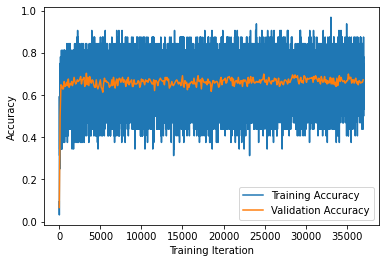

In [13]:
import matplotlib.pyplot as plt
plt.plot(range(len(training_accuracies_finetuning)), training_accuracies_finetuning, label = "Training Accuracy")
plt.plot(list(map(lambda x: x * 100, range(len(validation_accuracies_finetuning)))), validation_accuracies_finetuning, label = "Validation Accuracy")
plt.xlabel("Training Iteration")
plt.ylabel("Accuracy")
plt.legend()

In [14]:
import torch as th
import numpy as np

embedding_bert.to(device)

def get_embeds(x_data):
    concatted_shape = None
    pad_value = None
    embeds = []
    for text in tqdm(x_data):
        doc = nlp(text)
        embeddeds = []
        sents = list(doc.sents)
        all_tokenized = []
        for sentence in sents[:num_sentences]:
            sentence = str(sentence)
            tokenized = tokenizer(sentence, truncation=True, padding="max_length", max_length=max_tokenized_length)[0]
            all_tokenized.append(tokenized.ids)
        
        with th.no_grad():
            sentence_tensor = th.tensor(all_tokenized).to(device)
            concatted = np.concatenate([
                # take output corresponding to CLS
                embedding_bert.bert(sentence_tensor, output_hidden_states=True, return_dict=True)[1].cpu().numpy(),
                np.zeros((len(all_tokenized), 1))
            ], axis=1)
            
            if not concatted_shape:
                concatted_shape = concatted.shape
                pad_value = np.zeros(concatted_shape[1])
                pad_value[-1] = 1
            
            embeddeds += list(concatted)

        if len(sents) < num_sentences:
            embeddeds += [pad_value] * (num_sentences - len(sents))

        embeds.append(embeddeds)
    return np.array(embeds)

main_data_key = f"cache-core/training-data-main-max-tokens-{max_tokenized_length}-split-{hash_key(split_key)}-finetuned-{hash_key(finetuning_model_key)}"
train_x_embeds, valid_x_embeds = memo_load(
    lambda: (
        get_embeds(train_x),
        get_embeds(valid_x)
    ),
    main_data_key
)

  0%|          | 0/200000 [00:00<?, ?it/s]

  0%|          | 5/200000 [00:00<1:07:12, 49.60it/s]

  0%|          | 13/200000 [00:00<52:06, 63.96it/s] 

  0%|          | 21/200000 [00:00<48:39, 68.51it/s]

  0%|          | 28/200000 [00:00<49:17, 67.62it/s]

  0%|          | 35/200000 [00:00<49:11, 67.76it/s]

  0%|          | 43/200000 [00:00<46:26, 71.76it/s]

  0%|          | 51/200000 [00:00<48:16, 69.04it/s]

  0%|          | 59/200000 [00:00<46:10, 72.16it/s]

  0%|          | 67/200000 [00:00<48:42, 68.41it/s]

  0%|          | 74/200000 [00:01<50:32, 65.92it/s]

  0%|          | 83/200000 [00:01<47:25, 70.25it/s]

  0%|          | 91/200000 [00:01<49:28, 67.35it/s]

  0%|          | 98/200000 [00:01<50:11, 66.38it/s]

  0%|          | 105/200000 [00:01<51:15, 64.99it/s]

  0%|          | 114/200000 [00:01<47:43, 69.81it/s]

  0%|          | 123/200000 [00:01<45:47, 72.74it/s]

  0%|          | 131/200000 [00:01<45:22, 73.40it/s]

  0%|          | 139/200000 [00:02<47:14, 70.52it/s]

  0%|          | 147/200000 [00:02<51:12, 65.05it/s]

  0%|          | 154/200000 [00:02<52:22, 63.60it/s]

  0%|          | 161/200000 [00:02<53:15, 62.53it/s]

  0%|          | 170/200000 [00:02<50:15, 66.27it/s]

  0%|          | 179/200000 [00:02<48:17, 68.96it/s]

  0%|          | 187/200000 [00:02<48:00, 69.37it/s]

  0%|          | 194/200000 [00:02<49:14, 67.62it/s]

  0%|          | 203/200000 [00:02<46:01, 72.36it/s]

  0%|          | 211/200000 [00:03<47:45, 69.72it/s]

  0%|          | 219/200000 [00:03<49:16, 67.58it/s]

  0%|          | 226/200000 [00:03<49:04, 67.84it/s]

  0%|          | 233/200000 [00:03<50:27, 65.98it/s]

  0%|          | 242/200000 [00:03<47:01, 70.80it/s]

  0%|          | 250/200000 [00:03<47:58, 69.39it/s]

  0%|          | 258/200000 [00:03<48:19, 68.90it/s]

  0%|          | 266/200000 [00:03<47:22, 70.26it/s]

  0%|          | 274/200000 [00:03<46:14, 71.98it/s]

  0%|          | 282/200000 [00:04<45:28, 73.20it/s]

  0%|          | 290/200000 [00:04<46:50, 71.07it/s]

  0%|          | 299/200000 [00:04<45:23, 73.33it/s]

  0%|          | 308/200000 [00:04<43:16, 76.90it/s]

  0%|          | 317/200000 [00:04<42:21, 78.58it/s]

  0%|          | 325/200000 [00:04<45:38, 72.90it/s]

  0%|          | 333/200000 [00:04<45:13, 73.57it/s]

  0%|          | 341/200000 [00:04<45:21, 73.37it/s]

  0%|          | 349/200000 [00:05<45:02, 73.88it/s]

  0%|          | 357/200000 [00:05<48:37, 68.43it/s]

  0%|          | 364/200000 [00:05<49:06, 67.76it/s]

  0%|          | 372/200000 [00:05<48:09, 69.10it/s]

  0%|          | 379/200000 [00:05<48:48, 68.18it/s]

  0%|          | 386/200000 [00:05<50:58, 65.27it/s]

  0%|          | 393/200000 [00:05<51:17, 64.86it/s]

  0%|          | 401/200000 [00:05<48:25, 68.71it/s]

  0%|          | 408/200000 [00:05<48:57, 67.95it/s]

  0%|          | 416/200000 [00:06<47:13, 70.43it/s]

  0%|          | 424/200000 [00:06<47:16, 70.35it/s]

  0%|          | 433/200000 [00:06<46:29, 71.54it/s]

  0%|          | 441/200000 [00:06<48:25, 68.68it/s]

  0%|          | 448/200000 [00:06<48:48, 68.14it/s]

  0%|          | 455/200000 [00:06<48:56, 67.94it/s]

  0%|          | 462/200000 [00:06<49:53, 66.66it/s]

  0%|          | 469/200000 [00:06<51:33, 64.50it/s]

  0%|          | 478/200000 [00:06<47:19, 70.26it/s]

  0%|          | 486/200000 [00:07<46:20, 71.75it/s]

  0%|          | 494/200000 [00:07<47:18, 70.28it/s]

  0%|          | 503/200000 [00:07<44:41, 74.41it/s]

  0%|          | 511/200000 [00:07<47:07, 70.56it/s]

  0%|          | 520/200000 [00:07<45:37, 72.88it/s]

  0%|          | 528/200000 [00:07<49:07, 67.67it/s]

  0%|          | 536/200000 [00:07<48:02, 69.20it/s]

  0%|          | 545/200000 [00:07<46:27, 71.56it/s]

  0%|          | 554/200000 [00:07<45:49, 72.54it/s]

  0%|          | 562/200000 [00:08<47:57, 69.30it/s]

  0%|          | 570/200000 [00:08<47:41, 69.69it/s]

  0%|          | 578/200000 [00:08<46:08, 72.02it/s]

  0%|          | 587/200000 [00:08<44:33, 74.60it/s]

  0%|          | 595/200000 [00:08<46:22, 71.66it/s]

  0%|          | 603/200000 [00:08<50:50, 65.36it/s]

  0%|          | 612/200000 [00:08<47:56, 69.32it/s]

  0%|          | 621/200000 [00:08<45:08, 73.62it/s]

  0%|          | 629/200000 [00:09<47:09, 70.47it/s]

  0%|          | 637/200000 [00:09<47:25, 70.07it/s]

  0%|          | 646/200000 [00:09<44:56, 73.94it/s]

  0%|          | 654/200000 [00:09<46:44, 71.08it/s]

  0%|          | 662/200000 [00:09<46:14, 71.85it/s]

  0%|          | 670/200000 [00:09<47:23, 70.10it/s]

  0%|          | 678/200000 [00:09<47:58, 69.24it/s]

  0%|          | 686/200000 [00:09<47:02, 70.61it/s]

  0%|          | 694/200000 [00:09<45:52, 72.41it/s]

  0%|          | 702/200000 [00:10<48:17, 68.79it/s]

  0%|          | 709/200000 [00:10<50:07, 66.26it/s]

  0%|          | 717/200000 [00:10<48:32, 68.43it/s]

  0%|          | 724/200000 [00:10<48:52, 67.95it/s]

  0%|          | 731/200000 [00:10<52:25, 63.35it/s]

  0%|          | 739/200000 [00:10<51:01, 65.09it/s]

  0%|          | 747/200000 [00:10<49:00, 67.77it/s]

  0%|          | 754/200000 [00:10<49:44, 66.76it/s]

  0%|          | 761/200000 [00:10<49:55, 66.51it/s]

  0%|          | 768/200000 [00:11<49:16, 67.40it/s]

  0%|          | 777/200000 [00:11<46:03, 72.08it/s]

  0%|          | 786/200000 [00:11<43:34, 76.20it/s]

  0%|          | 795/200000 [00:11<42:16, 78.53it/s]

  0%|          | 803/200000 [00:11<43:56, 75.55it/s]

  0%|          | 812/200000 [00:11<43:01, 77.16it/s]

  0%|          | 820/200000 [00:11<43:16, 76.72it/s]

  0%|          | 829/200000 [00:11<42:16, 78.51it/s]

  0%|          | 837/200000 [00:11<43:31, 76.26it/s]

  0%|          | 845/200000 [00:12<42:57, 77.27it/s]

  0%|          | 853/200000 [00:12<45:01, 73.72it/s]

  0%|          | 861/200000 [00:12<46:29, 71.40it/s]

  0%|          | 869/200000 [00:12<47:28, 69.91it/s]

  0%|          | 877/200000 [00:12<46:53, 70.78it/s]

  0%|          | 885/200000 [00:12<49:01, 67.69it/s]

  0%|          | 892/200000 [00:12<50:54, 65.19it/s]

  0%|          | 901/200000 [00:12<46:35, 71.22it/s]

  0%|          | 909/200000 [00:12<48:59, 67.73it/s]

  0%|          | 916/200000 [00:13<49:57, 66.41it/s]

  0%|          | 923/200000 [00:13<49:30, 67.02it/s]

  0%|          | 933/200000 [00:13<44:37, 74.35it/s]

  0%|          | 941/200000 [00:13<45:11, 73.42it/s]

  0%|          | 950/200000 [00:13<43:01, 77.11it/s]

  0%|          | 959/200000 [00:13<41:31, 79.88it/s]

  0%|          | 968/200000 [00:13<44:06, 75.21it/s]

  0%|          | 976/200000 [00:13<45:35, 72.75it/s]

  0%|          | 984/200000 [00:13<44:39, 74.28it/s]

  0%|          | 992/200000 [00:14<44:46, 74.07it/s]

  0%|          | 1000/200000 [00:14<46:05, 71.97it/s]

  1%|          | 1008/200000 [00:14<49:43, 66.70it/s]

  1%|          | 1017/200000 [00:14<48:01, 69.06it/s]

  1%|          | 1024/200000 [00:14<48:23, 68.54it/s]

  1%|          | 1032/200000 [00:14<46:22, 71.50it/s]

  1%|          | 1040/200000 [00:14<47:25, 69.92it/s]

  1%|          | 1049/200000 [00:14<44:56, 73.77it/s]

  1%|          | 1058/200000 [00:15<43:11, 76.77it/s]

  1%|          | 1066/200000 [00:15<44:55, 73.80it/s]

  1%|          | 1074/200000 [00:15<46:07, 71.88it/s]

  1%|          | 1082/200000 [00:15<46:27, 71.36it/s]

  1%|          | 1090/200000 [00:15<45:55, 72.18it/s]

  1%|          | 1098/200000 [00:15<45:45, 72.45it/s]

  1%|          | 1106/200000 [00:15<49:39, 66.76it/s]

  1%|          | 1114/200000 [00:15<47:49, 69.30it/s]

  1%|          | 1122/200000 [00:15<47:29, 69.79it/s]

  1%|          | 1130/200000 [00:16<47:02, 70.46it/s]

  1%|          | 1139/200000 [00:16<45:12, 73.32it/s]

  1%|          | 1147/200000 [00:16<47:38, 69.56it/s]

  1%|          | 1155/200000 [00:16<49:45, 66.60it/s]

  1%|          | 1164/200000 [00:16<48:05, 68.92it/s]

  1%|          | 1171/200000 [00:16<48:00, 69.03it/s]

  1%|          | 1179/200000 [00:16<46:47, 70.82it/s]

  1%|          | 1187/200000 [00:16<49:42, 66.66it/s]

  1%|          | 1194/200000 [00:17<49:15, 67.27it/s]

  1%|          | 1202/200000 [00:17<48:34, 68.21it/s]

  1%|          | 1210/200000 [00:17<46:43, 70.92it/s]

  1%|          | 1218/200000 [00:17<46:18, 71.55it/s]

  1%|          | 1226/200000 [00:17<49:27, 66.99it/s]

  1%|          | 1233/200000 [00:17<49:24, 67.04it/s]

  1%|          | 1241/200000 [00:17<48:24, 68.43it/s]

  1%|          | 1250/200000 [00:17<45:58, 72.06it/s]

  1%|          | 1259/200000 [00:17<45:11, 73.28it/s]

  1%|          | 1269/200000 [00:18<41:14, 80.31it/s]

  1%|          | 1278/200000 [00:18<43:14, 76.59it/s]

  1%|          | 1287/200000 [00:18<42:41, 77.58it/s]

  1%|          | 1297/200000 [00:18<39:51, 83.10it/s]

  1%|          | 1306/200000 [00:18<43:21, 76.39it/s]

  1%|          | 1316/200000 [00:18<40:43, 81.30it/s]

  1%|          | 1325/200000 [00:18<39:40, 83.47it/s]

  1%|          | 1334/200000 [00:18<41:05, 80.57it/s]

  1%|          | 1343/200000 [00:18<44:22, 74.60it/s]

  1%|          | 1351/200000 [00:19<46:16, 71.56it/s]

  1%|          | 1359/200000 [00:19<45:24, 72.92it/s]

  1%|          | 1367/200000 [00:19<44:55, 73.69it/s]

  1%|          | 1375/200000 [00:19<46:54, 70.57it/s]

  1%|          | 1384/200000 [00:19<45:15, 73.13it/s]

  1%|          | 1392/200000 [00:19<45:27, 72.81it/s]

  1%|          | 1400/200000 [00:19<45:57, 72.02it/s]

  1%|          | 1408/200000 [00:19<46:06, 71.78it/s]

  1%|          | 1416/200000 [00:19<44:51, 73.78it/s]

  1%|          | 1424/200000 [00:20<43:57, 75.30it/s]

  1%|          | 1432/200000 [00:20<44:40, 74.07it/s]

  1%|          | 1440/200000 [00:20<44:18, 74.68it/s]

  1%|          | 1450/200000 [00:20<41:49, 79.11it/s]

  1%|          | 1458/200000 [00:20<43:15, 76.48it/s]

  1%|          | 1466/200000 [00:20<47:56, 69.01it/s]

  1%|          | 1474/200000 [00:20<46:33, 71.08it/s]

  1%|          | 1483/200000 [00:20<44:36, 74.17it/s]

  1%|          | 1491/200000 [00:21<45:37, 72.52it/s]

  1%|          | 1499/200000 [00:21<45:27, 72.79it/s]

  1%|          | 1507/200000 [00:21<45:49, 72.18it/s]

  1%|          | 1515/200000 [00:21<46:00, 71.90it/s]

  1%|          | 1524/200000 [00:21<43:57, 75.26it/s]

  1%|          | 1532/200000 [00:21<46:35, 70.99it/s]

  1%|          | 1541/200000 [00:21<44:29, 74.33it/s]

  1%|          | 1549/200000 [00:21<45:34, 72.57it/s]

  1%|          | 1557/200000 [00:21<48:43, 67.87it/s]

  1%|          | 1564/200000 [00:22<50:39, 65.29it/s]

  1%|          | 1571/200000 [00:22<50:19, 65.72it/s]

  1%|          | 1580/200000 [00:22<47:08, 70.15it/s]

  1%|          | 1588/200000 [00:22<47:39, 69.38it/s]

  1%|          | 1597/200000 [00:22<45:21, 72.91it/s]

  1%|          | 1605/200000 [00:22<47:02, 70.29it/s]

  1%|          | 1613/200000 [00:22<46:08, 71.65it/s]

  1%|          | 1621/200000 [00:22<48:22, 68.34it/s]

  1%|          | 1629/200000 [00:22<47:06, 70.17it/s]

  1%|          | 1637/200000 [00:23<48:19, 68.42it/s]

  1%|          | 1645/200000 [00:23<46:26, 71.19it/s]

  1%|          | 1653/200000 [00:23<46:40, 70.83it/s]

  1%|          | 1661/200000 [00:23<46:33, 71.00it/s]

  1%|          | 1669/200000 [00:23<46:13, 71.52it/s]

  1%|          | 1677/200000 [00:23<46:57, 70.40it/s]

  1%|          | 1685/200000 [00:23<47:51, 69.06it/s]

  1%|          | 1692/200000 [00:23<49:26, 66.85it/s]

  1%|          | 1700/200000 [00:23<47:45, 69.20it/s]

  1%|          | 1707/200000 [00:24<50:01, 66.05it/s]

  1%|          | 1714/200000 [00:24<51:11, 64.55it/s]

  1%|          | 1722/200000 [00:24<49:26, 66.83it/s]

  1%|          | 1729/200000 [00:24<51:44, 63.88it/s]

  1%|          | 1736/200000 [00:24<50:31, 65.40it/s]

  1%|          | 1744/200000 [00:24<49:33, 66.67it/s]

  1%|          | 1752/200000 [00:24<48:53, 67.58it/s]

  1%|          | 1760/200000 [00:24<47:14, 69.93it/s]

  1%|          | 1768/200000 [00:24<46:29, 71.06it/s]

  1%|          | 1777/200000 [00:25<44:16, 74.61it/s]

  1%|          | 1785/200000 [00:25<45:44, 72.22it/s]

  1%|          | 1793/200000 [00:25<44:54, 73.55it/s]

  1%|          | 1801/200000 [00:25<44:52, 73.61it/s]

  1%|          | 1809/200000 [00:25<44:18, 74.55it/s]

  1%|          | 1817/200000 [00:25<43:49, 75.38it/s]

  1%|          | 1825/200000 [00:25<44:58, 73.44it/s]

  1%|          | 1833/200000 [00:25<44:36, 74.03it/s]

  1%|          | 1842/200000 [00:25<42:40, 77.38it/s]

  1%|          | 1850/200000 [00:26<42:23, 77.91it/s]

  1%|          | 1859/200000 [00:26<41:31, 79.54it/s]

  1%|          | 1868/200000 [00:26<40:49, 80.89it/s]

  1%|          | 1878/200000 [00:26<38:42, 85.29it/s]

  1%|          | 1887/200000 [00:26<41:47, 79.01it/s]

  1%|          | 1896/200000 [00:26<41:06, 80.31it/s]

  1%|          | 1905/200000 [00:26<41:05, 80.36it/s]

  1%|          | 1914/200000 [00:26<42:59, 76.78it/s]

  1%|          | 1923/200000 [00:26<43:06, 76.59it/s]

  1%|          | 1931/200000 [00:27<42:59, 76.80it/s]

  1%|          | 1940/200000 [00:27<43:05, 76.60it/s]

  1%|          | 1948/200000 [00:27<46:15, 71.35it/s]

  1%|          | 1956/200000 [00:27<45:18, 72.85it/s]

  1%|          | 1964/200000 [00:27<44:11, 74.68it/s]

  1%|          | 1972/200000 [00:27<45:30, 72.51it/s]

  1%|          | 1981/200000 [00:27<43:48, 75.32it/s]

  1%|          | 1989/200000 [00:27<45:06, 73.16it/s]

  1%|          | 1997/200000 [00:28<48:13, 68.43it/s]

  1%|          | 2005/200000 [00:28<47:30, 69.45it/s]

  1%|          | 2013/200000 [00:28<49:30, 66.65it/s]

  1%|          | 2020/200000 [00:28<51:23, 64.22it/s]

  1%|          | 2030/200000 [00:28<46:51, 70.42it/s]

  1%|          | 2038/200000 [00:28<47:00, 70.19it/s]

  1%|          | 2046/200000 [00:28<45:22, 72.71it/s]

  1%|          | 2054/200000 [00:28<46:29, 70.96it/s]

  1%|          | 2063/200000 [00:28<44:16, 74.50it/s]

  1%|          | 2071/200000 [00:29<43:44, 75.40it/s]

  1%|          | 2079/200000 [00:29<45:43, 72.14it/s]

  1%|          | 2087/200000 [00:29<45:29, 72.52it/s]

  1%|          | 2095/200000 [00:29<47:18, 69.71it/s]

  1%|          | 2104/200000 [00:29<45:04, 73.16it/s]

  1%|          | 2112/200000 [00:29<46:38, 70.72it/s]

  1%|          | 2120/200000 [00:29<46:52, 70.35it/s]

  1%|          | 2128/200000 [00:29<49:11, 67.03it/s]

  1%|          | 2138/200000 [00:29<44:13, 74.55it/s]

  1%|          | 2146/200000 [00:30<44:48, 73.60it/s]

  1%|          | 2155/200000 [00:30<42:23, 77.77it/s]

  1%|          | 2164/200000 [00:30<40:44, 80.92it/s]

  1%|          | 2173/200000 [00:30<43:25, 75.92it/s]

  1%|          | 2182/200000 [00:30<42:50, 76.94it/s]

  1%|          | 2190/200000 [00:30<42:31, 77.53it/s]

  1%|          | 2198/200000 [00:30<43:00, 76.65it/s]

  1%|          | 2208/200000 [00:30<40:09, 82.08it/s]

  1%|          | 2217/200000 [00:31<42:21, 77.81it/s]

  1%|          | 2225/200000 [00:31<43:10, 76.34it/s]

  1%|          | 2233/200000 [00:31<44:36, 73.89it/s]

  1%|          | 2241/200000 [00:31<44:12, 74.55it/s]

  1%|          | 2249/200000 [00:31<45:16, 72.80it/s]

  1%|          | 2257/200000 [00:31<46:37, 70.70it/s]

  1%|          | 2265/200000 [00:31<45:02, 73.17it/s]

  1%|          | 2273/200000 [00:31<47:08, 69.90it/s]

  1%|          | 2282/200000 [00:31<44:53, 73.41it/s]

  1%|          | 2290/200000 [00:32<45:26, 72.52it/s]

  1%|          | 2298/200000 [00:32<45:55, 71.76it/s]

  1%|          | 2306/200000 [00:32<45:13, 72.85it/s]

  1%|          | 2314/200000 [00:32<46:07, 71.44it/s]

  1%|          | 2322/200000 [00:32<45:06, 73.03it/s]

  1%|          | 2330/200000 [00:32<44:33, 73.94it/s]

  1%|          | 2338/200000 [00:32<43:50, 75.16it/s]

  1%|          | 2346/200000 [00:32<44:31, 73.99it/s]

  1%|          | 2354/200000 [00:32<44:30, 74.01it/s]

  1%|          | 2362/200000 [00:32<43:45, 75.26it/s]

  1%|          | 2370/200000 [00:33<43:11, 76.26it/s]

  1%|          | 2379/200000 [00:33<42:37, 77.28it/s]

  1%|          | 2387/200000 [00:33<45:58, 71.63it/s]

  1%|          | 2395/200000 [00:33<47:49, 68.85it/s]

  1%|          | 2402/200000 [00:33<48:17, 68.19it/s]

  1%|          | 2411/200000 [00:33<44:48, 73.50it/s]

  1%|          | 2420/200000 [00:33<43:26, 75.81it/s]

  1%|          | 2428/200000 [00:33<43:37, 75.49it/s]

  1%|          | 2436/200000 [00:34<44:05, 74.69it/s]

  1%|          | 2444/200000 [00:34<46:13, 71.23it/s]

  1%|          | 2452/200000 [00:34<45:30, 72.34it/s]

  1%|          | 2460/200000 [00:34<44:51, 73.39it/s]

  1%|          | 2470/200000 [00:34<42:29, 77.48it/s]

  1%|          | 2478/200000 [00:34<45:18, 72.66it/s]

  1%|          | 2486/200000 [00:34<44:13, 74.42it/s]

  1%|          | 2494/200000 [00:34<43:37, 75.47it/s]

  1%|▏         | 2503/200000 [00:34<42:13, 77.94it/s]

  1%|▏         | 2511/200000 [00:34<42:23, 77.65it/s]

  1%|▏         | 2520/200000 [00:35<40:59, 80.30it/s]

  1%|▏         | 2529/200000 [00:35<42:15, 77.90it/s]

  1%|▏         | 2537/200000 [00:35<43:52, 75.01it/s]

  1%|▏         | 2546/200000 [00:35<43:14, 76.11it/s]

  1%|▏         | 2554/200000 [00:35<44:18, 74.28it/s]

  1%|▏         | 2562/200000 [00:35<44:49, 73.40it/s]

  1%|▏         | 2570/200000 [00:35<47:47, 68.86it/s]

  1%|▏         | 2578/200000 [00:35<46:12, 71.20it/s]

  1%|▏         | 2586/200000 [00:36<46:24, 70.89it/s]

  1%|▏         | 2594/200000 [00:36<45:44, 71.93it/s]

  1%|▏         | 2602/200000 [00:36<44:40, 73.64it/s]

  1%|▏         | 2610/200000 [00:36<46:55, 70.10it/s]

  1%|▏         | 2618/200000 [00:36<48:40, 67.59it/s]

  1%|▏         | 2626/200000 [00:36<47:37, 69.06it/s]

  1%|▏         | 2633/200000 [00:36<47:37, 69.06it/s]

  1%|▏         | 2642/200000 [00:36<44:24, 74.06it/s]

  1%|▏         | 2650/200000 [00:36<43:58, 74.81it/s]

  1%|▏         | 2661/200000 [00:37<39:54, 82.40it/s]

  1%|▏         | 2670/200000 [00:37<41:21, 79.53it/s]

  1%|▏         | 2678/200000 [00:37<42:00, 78.30it/s]

  1%|▏         | 2686/200000 [00:37<44:44, 73.51it/s]

  1%|▏         | 2694/200000 [00:37<43:54, 74.89it/s]

  1%|▏         | 2703/200000 [00:37<42:47, 76.86it/s]

  1%|▏         | 2711/200000 [00:37<43:11, 76.12it/s]

  1%|▏         | 2719/200000 [00:37<44:01, 74.69it/s]

  1%|▏         | 2727/200000 [00:37<44:31, 73.85it/s]

  1%|▏         | 2735/200000 [00:38<45:22, 72.47it/s]

  1%|▏         | 2743/200000 [00:38<45:34, 72.14it/s]

  1%|▏         | 2752/200000 [00:38<43:00, 76.43it/s]

  1%|▏         | 2760/200000 [00:38<46:37, 70.51it/s]

  1%|▏         | 2768/200000 [00:38<48:45, 67.42it/s]

  1%|▏         | 2776/200000 [00:38<47:37, 69.03it/s]

  1%|▏         | 2783/200000 [00:38<48:07, 68.29it/s]

  1%|▏         | 2790/200000 [00:38<48:17, 68.07it/s]

  1%|▏         | 2799/200000 [00:38<45:48, 71.75it/s]

  1%|▏         | 2807/200000 [00:39<46:18, 70.97it/s]

  1%|▏         | 2815/200000 [00:39<46:36, 70.50it/s]

  1%|▏         | 2823/200000 [00:39<45:06, 72.85it/s]

  1%|▏         | 2831/200000 [00:39<44:53, 73.20it/s]

  1%|▏         | 2839/200000 [00:39<44:39, 73.58it/s]

  1%|▏         | 2847/200000 [00:39<46:01, 71.40it/s]

  1%|▏         | 2855/200000 [00:39<48:38, 67.54it/s]

  1%|▏         | 2863/200000 [00:39<46:35, 70.51it/s]

  1%|▏         | 2872/200000 [00:39<43:20, 75.80it/s]

  1%|▏         | 2881/200000 [00:40<42:45, 76.84it/s]

  1%|▏         | 2889/200000 [00:40<45:04, 72.88it/s]

  1%|▏         | 2897/200000 [00:40<46:19, 70.91it/s]

  1%|▏         | 2905/200000 [00:40<46:41, 70.34it/s]

  1%|▏         | 2913/200000 [00:40<46:44, 70.28it/s]

  1%|▏         | 2921/200000 [00:40<49:51, 65.88it/s]

  1%|▏         | 2929/200000 [00:40<48:26, 67.81it/s]

  1%|▏         | 2937/200000 [00:40<46:18, 70.93it/s]

  1%|▏         | 2947/200000 [00:40<41:57, 78.26it/s]

  1%|▏         | 2955/200000 [00:41<41:57, 78.29it/s]

  1%|▏         | 2963/200000 [00:41<42:55, 76.50it/s]

  1%|▏         | 2972/200000 [00:41<40:59, 80.11it/s]

  1%|▏         | 2981/200000 [00:41<42:35, 77.11it/s]

  1%|▏         | 2989/200000 [00:41<42:24, 77.41it/s]

  1%|▏         | 2997/200000 [00:41<43:04, 76.23it/s]

  2%|▏         | 3005/200000 [00:41<45:03, 72.87it/s]

  2%|▏         | 3014/200000 [00:41<43:48, 74.93it/s]

  2%|▏         | 3022/200000 [00:42<45:30, 72.14it/s]

  2%|▏         | 3030/200000 [00:42<46:57, 69.90it/s]

  2%|▏         | 3038/200000 [00:42<47:09, 69.60it/s]

  2%|▏         | 3046/200000 [00:42<46:47, 70.16it/s]

  2%|▏         | 3054/200000 [00:42<47:02, 69.77it/s]

  2%|▏         | 3061/200000 [00:42<47:21, 69.31it/s]

  2%|▏         | 3068/200000 [00:42<47:57, 68.43it/s]

  2%|▏         | 3075/200000 [00:42<47:52, 68.56it/s]

  2%|▏         | 3083/200000 [00:42<47:25, 69.21it/s]

  2%|▏         | 3090/200000 [00:43<48:33, 67.59it/s]

  2%|▏         | 3098/200000 [00:43<46:31, 70.53it/s]

  2%|▏         | 3106/200000 [00:43<45:25, 72.25it/s]

  2%|▏         | 3115/200000 [00:43<44:30, 73.71it/s]

  2%|▏         | 3123/200000 [00:43<49:04, 66.87it/s]

  2%|▏         | 3130/200000 [00:43<49:18, 66.55it/s]

  2%|▏         | 3139/200000 [00:43<45:49, 71.60it/s]

  2%|▏         | 3147/200000 [00:43<48:50, 67.17it/s]

  2%|▏         | 3154/200000 [00:43<52:16, 62.77it/s]

  2%|▏         | 3161/200000 [00:44<54:15, 60.47it/s]

  2%|▏         | 3168/200000 [00:44<53:13, 61.63it/s]

  2%|▏         | 3176/200000 [00:44<50:13, 65.32it/s]

  2%|▏         | 3184/200000 [00:44<47:21, 69.26it/s]

  2%|▏         | 3193/200000 [00:44<44:10, 74.24it/s]

  2%|▏         | 3202/200000 [00:44<42:33, 77.07it/s]

  2%|▏         | 3210/200000 [00:44<44:33, 73.61it/s]

  2%|▏         | 3218/200000 [00:44<44:52, 73.09it/s]

  2%|▏         | 3226/200000 [00:44<44:44, 73.31it/s]

  2%|▏         | 3234/200000 [00:45<46:50, 70.01it/s]

  2%|▏         | 3242/200000 [00:45<48:47, 67.21it/s]

  2%|▏         | 3251/200000 [00:45<45:30, 72.06it/s]

  2%|▏         | 3259/200000 [00:45<47:30, 69.03it/s]

  2%|▏         | 3266/200000 [00:45<49:32, 66.19it/s]

  2%|▏         | 3274/200000 [00:45<47:14, 69.39it/s]

  2%|▏         | 3282/200000 [00:45<46:07, 71.08it/s]

  2%|▏         | 3291/200000 [00:45<44:32, 73.60it/s]

  2%|▏         | 3299/200000 [00:46<48:13, 67.99it/s]

  2%|▏         | 3306/200000 [00:46<49:33, 66.14it/s]

  2%|▏         | 3314/200000 [00:46<48:46, 67.21it/s]

  2%|▏         | 3323/200000 [00:46<46:15, 70.85it/s]

  2%|▏         | 3331/200000 [00:46<47:48, 68.57it/s]

  2%|▏         | 3338/200000 [00:46<48:00, 68.27it/s]

  2%|▏         | 3345/200000 [00:46<48:56, 66.96it/s]

  2%|▏         | 3353/200000 [00:46<48:05, 68.16it/s]

  2%|▏         | 3360/200000 [00:46<48:59, 66.90it/s]

  2%|▏         | 3367/200000 [00:47<49:20, 66.42it/s]

  2%|▏         | 3377/200000 [00:47<43:26, 75.43it/s]

  2%|▏         | 3385/200000 [00:47<45:30, 72.01it/s]

  2%|▏         | 3394/200000 [00:47<42:58, 76.24it/s]

  2%|▏         | 3402/200000 [00:47<43:20, 75.59it/s]

  2%|▏         | 3410/200000 [00:47<48:09, 68.03it/s]

  2%|▏         | 3418/200000 [00:47<47:18, 69.25it/s]

  2%|▏         | 3426/200000 [00:47<49:21, 66.38it/s]

  2%|▏         | 3433/200000 [00:47<49:22, 66.34it/s]

  2%|▏         | 3441/200000 [00:48<47:31, 68.94it/s]

  2%|▏         | 3449/200000 [00:48<45:57, 71.28it/s]

  2%|▏         | 3457/200000 [00:48<50:51, 64.40it/s]

  2%|▏         | 3464/200000 [00:48<50:25, 64.97it/s]

  2%|▏         | 3471/200000 [00:48<50:03, 65.44it/s]

  2%|▏         | 3479/200000 [00:48<47:31, 68.93it/s]

  2%|▏         | 3487/200000 [00:48<45:43, 71.62it/s]

  2%|▏         | 3495/200000 [00:48<48:00, 68.23it/s]

  2%|▏         | 3502/200000 [00:48<49:07, 66.66it/s]

  2%|▏         | 3511/200000 [00:49<45:18, 72.28it/s]

  2%|▏         | 3519/200000 [00:49<48:14, 67.88it/s]

  2%|▏         | 3527/200000 [00:49<47:47, 68.53it/s]

  2%|▏         | 3535/200000 [00:49<46:29, 70.44it/s]

  2%|▏         | 3544/200000 [00:49<43:56, 74.52it/s]

  2%|▏         | 3552/200000 [00:49<44:12, 74.07it/s]

  2%|▏         | 3560/200000 [00:49<44:29, 73.59it/s]

  2%|▏         | 3568/200000 [00:49<47:25, 69.04it/s]

  2%|▏         | 3575/200000 [00:49<48:08, 68.00it/s]

  2%|▏         | 3582/200000 [00:50<51:05, 64.07it/s]

  2%|▏         | 3589/200000 [00:50<53:21, 61.35it/s]

  2%|▏         | 3596/200000 [00:50<52:24, 62.47it/s]

  2%|▏         | 3604/200000 [00:50<50:11, 65.22it/s]

  2%|▏         | 3611/200000 [00:50<49:13, 66.48it/s]

  2%|▏         | 3619/200000 [00:50<48:21, 67.69it/s]

  2%|▏         | 3626/200000 [00:50<48:17, 67.77it/s]

  2%|▏         | 3635/200000 [00:50<46:43, 70.04it/s]

  2%|▏         | 3645/200000 [00:51<44:09, 74.10it/s]

  2%|▏         | 3654/200000 [00:51<42:40, 76.69it/s]

  2%|▏         | 3662/200000 [00:51<45:25, 72.05it/s]

  2%|▏         | 3670/200000 [00:51<44:49, 73.00it/s]

  2%|▏         | 3678/200000 [00:51<46:17, 70.69it/s]

  2%|▏         | 3687/200000 [00:51<44:33, 73.43it/s]

  2%|▏         | 3695/200000 [00:51<47:17, 69.19it/s]

  2%|▏         | 3703/200000 [00:51<46:00, 71.11it/s]

  2%|▏         | 3711/200000 [00:51<49:12, 66.48it/s]

  2%|▏         | 3720/200000 [00:52<45:16, 72.27it/s]

  2%|▏         | 3728/200000 [00:52<44:55, 72.82it/s]

  2%|▏         | 3736/200000 [00:52<45:06, 72.52it/s]

  2%|▏         | 3744/200000 [00:52<46:35, 70.20it/s]

  2%|▏         | 3752/200000 [00:52<46:03, 71.02it/s]

  2%|▏         | 3760/200000 [00:52<47:58, 68.19it/s]

  2%|▏         | 3768/200000 [00:52<46:14, 70.72it/s]

  2%|▏         | 3777/200000 [00:52<43:26, 75.28it/s]

  2%|▏         | 3785/200000 [00:52<43:59, 74.34it/s]

  2%|▏         | 3793/200000 [00:53<44:10, 74.04it/s]

  2%|▏         | 3801/200000 [00:53<44:25, 73.62it/s]

  2%|▏         | 3809/200000 [00:53<44:47, 72.99it/s]

  2%|▏         | 3817/200000 [00:53<43:49, 74.59it/s]

  2%|▏         | 3825/200000 [00:53<43:25, 75.28it/s]

  2%|▏         | 3836/200000 [00:53<39:15, 83.26it/s]

  2%|▏         | 3845/200000 [00:53<40:27, 80.82it/s]

  2%|▏         | 3854/200000 [00:53<42:57, 76.09it/s]

  2%|▏         | 3862/200000 [00:54<48:06, 67.95it/s]

  2%|▏         | 3870/200000 [00:54<47:01, 69.52it/s]

  2%|▏         | 3878/200000 [00:54<49:34, 65.93it/s]

  2%|▏         | 3885/200000 [00:54<49:24, 66.15it/s]

  2%|▏         | 3894/200000 [00:54<46:03, 70.97it/s]

  2%|▏         | 3903/200000 [00:54<43:02, 75.94it/s]

  2%|▏         | 3912/200000 [00:54<42:33, 76.80it/s]

  2%|▏         | 3920/200000 [00:54<44:18, 73.75it/s]

  2%|▏         | 3928/200000 [00:54<43:28, 75.18it/s]

  2%|▏         | 3937/200000 [00:55<42:43, 76.48it/s]

  2%|▏         | 3945/200000 [00:55<43:38, 74.88it/s]

  2%|▏         | 3953/200000 [00:55<42:58, 76.03it/s]

  2%|▏         | 3961/200000 [00:55<45:45, 71.41it/s]

  2%|▏         | 3969/200000 [00:55<46:34, 70.15it/s]

  2%|▏         | 3977/200000 [00:55<47:20, 69.01it/s]

  2%|▏         | 3984/200000 [00:55<48:51, 66.86it/s]

  2%|▏         | 3992/200000 [00:55<48:56, 66.76it/s]

  2%|▏         | 3999/200000 [00:55<48:51, 66.85it/s]

  2%|▏         | 4008/200000 [00:56<44:45, 72.99it/s]

  2%|▏         | 4016/200000 [00:56<44:05, 74.09it/s]

  2%|▏         | 4024/200000 [00:56<44:40, 73.12it/s]

  2%|▏         | 4033/200000 [00:56<42:39, 76.57it/s]

  2%|▏         | 4041/200000 [00:56<45:19, 72.05it/s]

  2%|▏         | 4049/200000 [00:56<48:08, 67.84it/s]

  2%|▏         | 4057/200000 [00:56<46:42, 69.92it/s]

  2%|▏         | 4065/200000 [00:56<47:18, 69.02it/s]

  2%|▏         | 4072/200000 [00:56<51:07, 63.86it/s]

  2%|▏         | 4081/200000 [00:57<47:03, 69.40it/s]

  2%|▏         | 4089/200000 [00:57<47:23, 68.90it/s]

  2%|▏         | 4097/200000 [00:57<46:09, 70.73it/s]

  2%|▏         | 4105/200000 [00:57<47:56, 68.09it/s]

  2%|▏         | 4112/200000 [00:57<48:00, 67.99it/s]

  2%|▏         | 4120/200000 [00:57<46:04, 70.85it/s]

  2%|▏         | 4128/200000 [00:57<46:48, 69.74it/s]

  2%|▏         | 4136/200000 [00:57<48:28, 67.34it/s]

  2%|▏         | 4143/200000 [00:58<48:48, 66.88it/s]

  2%|▏         | 4151/200000 [00:58<46:35, 70.05it/s]

  2%|▏         | 4159/200000 [00:58<44:56, 72.63it/s]

  2%|▏         | 4167/200000 [00:58<46:44, 69.83it/s]

  2%|▏         | 4175/200000 [00:58<48:38, 67.10it/s]

  2%|▏         | 4183/200000 [00:58<46:58, 69.47it/s]

  2%|▏         | 4192/200000 [00:58<43:49, 74.45it/s]

  2%|▏         | 4200/200000 [00:58<44:56, 72.60it/s]

  2%|▏         | 4208/200000 [00:58<48:45, 66.93it/s]

  2%|▏         | 4216/200000 [00:59<46:45, 69.79it/s]

  2%|▏         | 4225/200000 [00:59<44:01, 74.10it/s]

  2%|▏         | 4234/200000 [00:59<42:47, 76.26it/s]

  2%|▏         | 4242/200000 [00:59<42:25, 76.90it/s]

  2%|▏         | 4251/200000 [00:59<41:28, 78.66it/s]

  2%|▏         | 4259/200000 [00:59<43:45, 74.55it/s]

  2%|▏         | 4267/200000 [00:59<44:47, 72.82it/s]

  2%|▏         | 4275/200000 [00:59<45:00, 72.48it/s]

  2%|▏         | 4283/200000 [00:59<46:16, 70.49it/s]

  2%|▏         | 4293/200000 [01:00<42:05, 77.49it/s]

  2%|▏         | 4301/200000 [01:00<46:47, 69.71it/s]

  2%|▏         | 4310/200000 [01:00<44:03, 74.03it/s]

  2%|▏         | 4318/200000 [01:00<47:02, 69.34it/s]

  2%|▏         | 4326/200000 [01:00<46:16, 70.48it/s]

  2%|▏         | 4334/200000 [01:00<46:01, 70.85it/s]

  2%|▏         | 4342/200000 [01:00<47:51, 68.14it/s]

  2%|▏         | 4349/200000 [01:00<48:40, 67.00it/s]

  2%|▏         | 4358/200000 [01:00<46:12, 70.56it/s]

  2%|▏         | 4367/200000 [01:01<45:25, 71.78it/s]

  2%|▏         | 4375/200000 [01:01<47:35, 68.51it/s]

  2%|▏         | 4382/200000 [01:01<49:25, 65.97it/s]

  2%|▏         | 4389/200000 [01:01<51:11, 63.69it/s]

  2%|▏         | 4397/200000 [01:01<48:43, 66.90it/s]

  2%|▏         | 4404/200000 [01:01<50:20, 64.75it/s]

  2%|▏         | 4412/200000 [01:01<48:45, 66.85it/s]

  2%|▏         | 4422/200000 [01:01<43:54, 74.25it/s]

  2%|▏         | 4430/200000 [01:02<46:37, 69.91it/s]

  2%|▏         | 4439/200000 [01:02<45:19, 71.91it/s]

  2%|▏         | 4447/200000 [01:02<44:51, 72.65it/s]

  2%|▏         | 4455/200000 [01:02<46:39, 69.86it/s]

  2%|▏         | 4463/200000 [01:02<46:45, 69.69it/s]

  2%|▏         | 4471/200000 [01:02<46:44, 69.72it/s]

  2%|▏         | 4478/200000 [01:02<48:23, 67.34it/s]

  2%|▏         | 4486/200000 [01:02<47:38, 68.39it/s]

  2%|▏         | 4493/200000 [01:02<49:07, 66.32it/s]

  2%|▏         | 4500/200000 [01:03<49:10, 66.27it/s]

  2%|▏         | 4507/200000 [01:03<51:23, 63.40it/s]

  2%|▏         | 4514/200000 [01:03<51:14, 63.58it/s]

  2%|▏         | 4522/200000 [01:03<50:23, 64.64it/s]

  2%|▏         | 4530/200000 [01:03<47:39, 68.37it/s]

  2%|▏         | 4538/200000 [01:03<46:01, 70.78it/s]

  2%|▏         | 4547/200000 [01:03<44:03, 73.93it/s]

  2%|▏         | 4555/200000 [01:03<44:01, 73.99it/s]

  2%|▏         | 4563/200000 [01:03<44:10, 73.74it/s]

  2%|▏         | 4571/200000 [01:04<47:02, 69.25it/s]

  2%|▏         | 4580/200000 [01:04<44:32, 73.13it/s]

  2%|▏         | 4588/200000 [01:04<44:07, 73.80it/s]

  2%|▏         | 4596/200000 [01:04<44:51, 72.59it/s]

  2%|▏         | 4605/200000 [01:04<43:26, 74.97it/s]

  2%|▏         | 4613/200000 [01:04<46:40, 69.77it/s]

  2%|▏         | 4621/200000 [01:04<45:50, 71.02it/s]

  2%|▏         | 4629/200000 [01:04<45:56, 70.88it/s]

  2%|▏         | 4639/200000 [01:05<43:38, 74.61it/s]

  2%|▏         | 4647/200000 [01:05<43:50, 74.27it/s]

  2%|▏         | 4655/200000 [01:05<42:57, 75.78it/s]

  2%|▏         | 4663/200000 [01:05<43:14, 75.28it/s]

  2%|▏         | 4671/200000 [01:05<45:54, 70.90it/s]

  2%|▏         | 4679/200000 [01:05<47:07, 69.07it/s]

  2%|▏         | 4686/200000 [01:05<48:22, 67.30it/s]

  2%|▏         | 4694/200000 [01:05<46:46, 69.59it/s]

  2%|▏         | 4701/200000 [01:05<49:29, 65.76it/s]

  2%|▏         | 4709/200000 [01:06<47:27, 68.58it/s]

  2%|▏         | 4717/200000 [01:06<46:40, 69.74it/s]

  2%|▏         | 4725/200000 [01:06<47:25, 68.62it/s]

  2%|▏         | 4735/200000 [01:06<43:19, 75.11it/s]

  2%|▏         | 4743/200000 [01:06<43:45, 74.36it/s]

  2%|▏         | 4751/200000 [01:06<46:45, 69.60it/s]

  2%|▏         | 4759/200000 [01:06<46:19, 70.24it/s]

  2%|▏         | 4767/200000 [01:06<44:39, 72.86it/s]

  2%|▏         | 4775/200000 [01:06<46:06, 70.57it/s]

  2%|▏         | 4784/200000 [01:07<44:48, 72.61it/s]

  2%|▏         | 4792/200000 [01:07<43:55, 74.07it/s]

  2%|▏         | 4800/200000 [01:07<44:03, 73.83it/s]

  2%|▏         | 4808/200000 [01:07<47:06, 69.05it/s]

  2%|▏         | 4815/200000 [01:07<47:34, 68.38it/s]

  2%|▏         | 4822/200000 [01:07<50:45, 64.09it/s]

  2%|▏         | 4830/200000 [01:07<48:42, 66.79it/s]

  2%|▏         | 4838/200000 [01:07<46:37, 69.76it/s]

  2%|▏         | 4847/200000 [01:07<43:43, 74.40it/s]

  2%|▏         | 4855/200000 [01:08<44:12, 73.58it/s]

  2%|▏         | 4863/200000 [01:08<43:48, 74.24it/s]

  2%|▏         | 4871/200000 [01:08<44:23, 73.27it/s]

  2%|▏         | 4880/200000 [01:08<42:35, 76.35it/s]

  2%|▏         | 4888/200000 [01:08<44:14, 73.49it/s]

  2%|▏         | 4896/200000 [01:08<45:55, 70.80it/s]

  2%|▏         | 4904/200000 [01:08<46:20, 70.17it/s]

  2%|▏         | 4912/200000 [01:08<45:39, 71.22it/s]

  2%|▏         | 4920/200000 [01:08<47:32, 68.38it/s]

  2%|▏         | 4927/200000 [01:09<47:18, 68.73it/s]

  2%|▏         | 4935/200000 [01:09<45:19, 71.74it/s]

  2%|▏         | 4943/200000 [01:09<44:04, 73.77it/s]

  2%|▏         | 4952/200000 [01:09<42:55, 75.72it/s]

  2%|▏         | 4961/200000 [01:09<41:49, 77.72it/s]

  2%|▏         | 4969/200000 [01:09<43:10, 75.30it/s]

  2%|▏         | 4979/200000 [01:09<40:10, 80.89it/s]

  2%|▏         | 4988/200000 [01:09<39:40, 81.93it/s]

  2%|▏         | 4997/200000 [01:09<42:32, 76.40it/s]

  3%|▎         | 5005/200000 [01:10<43:33, 74.60it/s]

  3%|▎         | 5013/200000 [01:10<46:30, 69.87it/s]

  3%|▎         | 5021/200000 [01:10<47:29, 68.42it/s]

  3%|▎         | 5028/200000 [01:10<48:44, 66.68it/s]

  3%|▎         | 5035/200000 [01:10<50:56, 63.78it/s]

  3%|▎         | 5043/200000 [01:10<48:02, 67.64it/s]

  3%|▎         | 5050/200000 [01:10<49:07, 66.14it/s]

  3%|▎         | 5059/200000 [01:10<46:39, 69.64it/s]

  3%|▎         | 5066/200000 [01:11<48:48, 66.56it/s]

  3%|▎         | 5074/200000 [01:11<48:41, 66.71it/s]

  3%|▎         | 5081/200000 [01:11<48:25, 67.08it/s]

  3%|▎         | 5088/200000 [01:11<48:15, 67.32it/s]

  3%|▎         | 5095/200000 [01:11<49:49, 65.20it/s]

  3%|▎         | 5102/200000 [01:11<49:42, 65.35it/s]

  3%|▎         | 5110/200000 [01:11<47:45, 68.01it/s]

  3%|▎         | 5119/200000 [01:11<44:27, 73.05it/s]

  3%|▎         | 5127/200000 [01:11<46:42, 69.54it/s]

  3%|▎         | 5135/200000 [01:12<45:56, 70.70it/s]

  3%|▎         | 5143/200000 [01:12<45:00, 72.15it/s]

  3%|▎         | 5151/200000 [01:12<44:54, 72.30it/s]

  3%|▎         | 5160/200000 [01:12<43:03, 75.41it/s]

  3%|▎         | 5169/200000 [01:12<42:49, 75.81it/s]

  3%|▎         | 5177/200000 [01:12<44:59, 72.17it/s]

  3%|▎         | 5185/200000 [01:12<45:21, 71.58it/s]

  3%|▎         | 5194/200000 [01:12<42:41, 76.05it/s]

  3%|▎         | 5202/200000 [01:12<45:01, 72.12it/s]

  3%|▎         | 5210/200000 [01:13<45:02, 72.09it/s]

  3%|▎         | 5218/200000 [01:13<44:10, 73.48it/s]

  3%|▎         | 5227/200000 [01:13<42:27, 76.47it/s]

  3%|▎         | 5237/200000 [01:13<40:52, 79.42it/s]

  3%|▎         | 5245/200000 [01:13<44:37, 72.73it/s]

  3%|▎         | 5255/200000 [01:13<40:35, 79.96it/s]

  3%|▎         | 5264/200000 [01:13<42:21, 76.62it/s]

  3%|▎         | 5272/200000 [01:13<42:18, 76.70it/s]

  3%|▎         | 5280/200000 [01:13<43:54, 73.92it/s]

  3%|▎         | 5288/200000 [01:14<47:13, 68.72it/s]

  3%|▎         | 5295/200000 [01:14<49:41, 65.32it/s]

  3%|▎         | 5302/200000 [01:14<49:47, 65.16it/s]

  3%|▎         | 5309/200000 [01:14<50:15, 64.57it/s]

  3%|▎         | 5317/200000 [01:14<48:26, 66.97it/s]

  3%|▎         | 5326/200000 [01:14<44:17, 73.25it/s]

  3%|▎         | 5334/200000 [01:14<46:09, 70.30it/s]

  3%|▎         | 5342/200000 [01:14<46:53, 69.19it/s]

  3%|▎         | 5352/200000 [01:15<43:12, 75.09it/s]

  3%|▎         | 5360/200000 [01:15<46:52, 69.20it/s]

  3%|▎         | 5370/200000 [01:15<42:38, 76.07it/s]

  3%|▎         | 5379/200000 [01:15<42:47, 75.80it/s]

  3%|▎         | 5387/200000 [01:15<44:54, 72.22it/s]

  3%|▎         | 5395/200000 [01:15<46:33, 69.67it/s]

  3%|▎         | 5403/200000 [01:15<46:29, 69.75it/s]

  3%|▎         | 5411/200000 [01:15<46:15, 70.10it/s]

  3%|▎         | 5420/200000 [01:15<44:07, 73.49it/s]

  3%|▎         | 5428/200000 [01:16<45:36, 71.11it/s]

  3%|▎         | 5436/200000 [01:16<46:50, 69.23it/s]

  3%|▎         | 5443/200000 [01:16<47:57, 67.61it/s]

  3%|▎         | 5450/200000 [01:16<47:34, 68.15it/s]

  3%|▎         | 5457/200000 [01:16<47:47, 67.85it/s]

  3%|▎         | 5466/200000 [01:16<44:11, 73.36it/s]

  3%|▎         | 5474/200000 [01:16<44:23, 73.04it/s]

  3%|▎         | 5482/200000 [01:16<43:40, 74.23it/s]

  3%|▎         | 5490/200000 [01:16<43:45, 74.09it/s]

  3%|▎         | 5498/200000 [01:17<43:46, 74.06it/s]

  3%|▎         | 5506/200000 [01:17<43:13, 75.00it/s]

  3%|▎         | 5515/200000 [01:17<40:59, 79.07it/s]

  3%|▎         | 5524/200000 [01:17<40:04, 80.87it/s]

  3%|▎         | 5533/200000 [01:17<40:47, 79.44it/s]

  3%|▎         | 5541/200000 [01:17<42:21, 76.51it/s]

  3%|▎         | 5549/200000 [01:17<44:36, 72.65it/s]

  3%|▎         | 5557/200000 [01:17<46:06, 70.28it/s]

  3%|▎         | 5565/200000 [01:17<47:53, 67.66it/s]

  3%|▎         | 5572/200000 [01:18<50:04, 64.72it/s]

  3%|▎         | 5579/200000 [01:18<50:18, 64.42it/s]

  3%|▎         | 5588/200000 [01:18<46:49, 69.19it/s]

  3%|▎         | 5595/200000 [01:18<46:57, 69.01it/s]

  3%|▎         | 5603/200000 [01:18<45:13, 71.65it/s]

  3%|▎         | 5611/200000 [01:18<45:35, 71.07it/s]

  3%|▎         | 5619/200000 [01:18<46:18, 69.96it/s]

  3%|▎         | 5627/200000 [01:18<48:09, 67.27it/s]

  3%|▎         | 5634/200000 [01:18<48:11, 67.22it/s]

  3%|▎         | 5644/200000 [01:19<43:26, 74.58it/s]

  3%|▎         | 5652/200000 [01:19<44:04, 73.49it/s]

  3%|▎         | 5660/200000 [01:19<43:45, 74.03it/s]

  3%|▎         | 5668/200000 [01:19<43:06, 75.12it/s]

  3%|▎         | 5676/200000 [01:19<46:21, 69.86it/s]

  3%|▎         | 5684/200000 [01:19<45:49, 70.68it/s]

  3%|▎         | 5693/200000 [01:19<43:28, 74.49it/s]

  3%|▎         | 5701/200000 [01:19<44:02, 73.53it/s]

  3%|▎         | 5709/200000 [01:20<48:03, 67.37it/s]

  3%|▎         | 5717/200000 [01:20<48:07, 67.28it/s]

  3%|▎         | 5725/200000 [01:20<46:07, 70.20it/s]

  3%|▎         | 5733/200000 [01:20<45:34, 71.04it/s]

  3%|▎         | 5741/200000 [01:20<49:06, 65.92it/s]

  3%|▎         | 5748/200000 [01:20<50:09, 64.55it/s]

  3%|▎         | 5756/200000 [01:20<48:12, 67.16it/s]

  3%|▎         | 5763/200000 [01:20<47:44, 67.82it/s]

  3%|▎         | 5770/200000 [01:20<47:47, 67.73it/s]

  3%|▎         | 5777/200000 [01:21<48:05, 67.32it/s]

  3%|▎         | 5785/200000 [01:21<46:36, 69.44it/s]

  3%|▎         | 5792/200000 [01:21<47:03, 68.78it/s]

  3%|▎         | 5799/200000 [01:21<46:53, 69.03it/s]

  3%|▎         | 5806/200000 [01:21<48:17, 67.03it/s]

  3%|▎         | 5814/200000 [01:21<46:49, 69.12it/s]

  3%|▎         | 5822/200000 [01:21<45:17, 71.44it/s]

  3%|▎         | 5830/200000 [01:21<49:48, 64.96it/s]

  3%|▎         | 5840/200000 [01:21<43:34, 74.25it/s]

  3%|▎         | 5849/200000 [01:22<41:55, 77.17it/s]

  3%|▎         | 5857/200000 [01:22<44:30, 72.70it/s]

  3%|▎         | 5865/200000 [01:22<43:56, 73.65it/s]

  3%|▎         | 5873/200000 [01:22<44:20, 72.96it/s]

  3%|▎         | 5881/200000 [01:22<44:38, 72.48it/s]

  3%|▎         | 5889/200000 [01:22<48:23, 66.86it/s]

  3%|▎         | 5898/200000 [01:22<44:42, 72.36it/s]

  3%|▎         | 5906/200000 [01:22<44:55, 72.01it/s]

  3%|▎         | 5914/200000 [01:22<45:30, 71.07it/s]

  3%|▎         | 5922/200000 [01:23<47:16, 68.42it/s]

  3%|▎         | 5929/200000 [01:23<48:09, 67.17it/s]

  3%|▎         | 5937/200000 [01:23<47:33, 68.02it/s]

  3%|▎         | 5945/200000 [01:23<46:42, 69.24it/s]

  3%|▎         | 5953/200000 [01:23<45:39, 70.84it/s]

  3%|▎         | 5961/200000 [01:23<44:30, 72.65it/s]

  3%|▎         | 5969/200000 [01:23<48:55, 66.10it/s]

  3%|▎         | 5977/200000 [01:23<47:45, 67.70it/s]

  3%|▎         | 5984/200000 [01:23<49:58, 64.71it/s]

  3%|▎         | 5993/200000 [01:24<46:12, 69.97it/s]

  3%|▎         | 6001/200000 [01:24<44:52, 72.05it/s]

  3%|▎         | 6009/200000 [01:24<43:51, 73.72it/s]

  3%|▎         | 6017/200000 [01:24<46:14, 69.93it/s]

  3%|▎         | 6026/200000 [01:24<43:49, 73.77it/s]

  3%|▎         | 6034/200000 [01:24<44:13, 73.10it/s]

  3%|▎         | 6042/200000 [01:24<44:11, 73.14it/s]

  3%|▎         | 6050/200000 [01:24<45:51, 70.48it/s]

  3%|▎         | 6058/200000 [01:24<45:08, 71.60it/s]

  3%|▎         | 6068/200000 [01:25<42:27, 76.12it/s]

  3%|▎         | 6076/200000 [01:25<44:09, 73.18it/s]

  3%|▎         | 6084/200000 [01:25<43:45, 73.86it/s]

  3%|▎         | 6092/200000 [01:25<45:17, 71.34it/s]

  3%|▎         | 6100/200000 [01:25<44:11, 73.12it/s]

  3%|▎         | 6110/200000 [01:25<40:43, 79.33it/s]

  3%|▎         | 6120/200000 [01:25<39:55, 80.94it/s]

  3%|▎         | 6129/200000 [01:25<39:09, 82.50it/s]

  3%|▎         | 6138/200000 [01:26<40:17, 80.19it/s]

  3%|▎         | 6147/200000 [01:26<39:44, 81.31it/s]

  3%|▎         | 6156/200000 [01:26<38:56, 82.96it/s]

  3%|▎         | 6165/200000 [01:26<38:27, 83.99it/s]

  3%|▎         | 6174/200000 [01:26<39:53, 80.98it/s]

  3%|▎         | 6183/200000 [01:26<40:50, 79.11it/s]

  3%|▎         | 6191/200000 [01:26<40:45, 79.25it/s]

  3%|▎         | 6199/200000 [01:26<42:03, 76.81it/s]

  3%|▎         | 6209/200000 [01:26<39:29, 81.79it/s]

  3%|▎         | 6218/200000 [01:27<42:04, 76.77it/s]

  3%|▎         | 6227/200000 [01:27<40:24, 79.93it/s]

  3%|▎         | 6236/200000 [01:27<41:58, 76.95it/s]

  3%|▎         | 6244/200000 [01:27<41:53, 77.07it/s]

  3%|▎         | 6252/200000 [01:27<43:55, 73.52it/s]

  3%|▎         | 6260/200000 [01:27<45:28, 71.01it/s]

  3%|▎         | 6268/200000 [01:27<45:00, 71.75it/s]

  3%|▎         | 6276/200000 [01:27<43:42, 73.88it/s]

  3%|▎         | 6285/200000 [01:27<41:28, 77.84it/s]

  3%|▎         | 6294/200000 [01:28<40:16, 80.15it/s]

  3%|▎         | 6303/200000 [01:28<41:42, 77.41it/s]

  3%|▎         | 6311/200000 [01:28<43:02, 75.00it/s]

  3%|▎         | 6319/200000 [01:28<45:06, 71.57it/s]

  3%|▎         | 6327/200000 [01:28<44:35, 72.39it/s]

  3%|▎         | 6335/200000 [01:28<44:16, 72.89it/s]

  3%|▎         | 6343/200000 [01:28<44:28, 72.57it/s]

  3%|▎         | 6351/200000 [01:28<44:20, 72.80it/s]

  3%|▎         | 6360/200000 [01:28<44:00, 73.32it/s]

  3%|▎         | 6369/200000 [01:29<41:29, 77.78it/s]

  3%|▎         | 6377/200000 [01:29<42:07, 76.59it/s]

  3%|▎         | 6385/200000 [01:29<47:12, 68.36it/s]

  3%|▎         | 6393/200000 [01:29<46:40, 69.13it/s]

  3%|▎         | 6401/200000 [01:29<50:10, 64.30it/s]

  3%|▎         | 6408/200000 [01:29<50:18, 64.13it/s]

  3%|▎         | 6418/200000 [01:29<43:58, 73.38it/s]

  3%|▎         | 6427/200000 [01:29<43:20, 74.45it/s]

  3%|▎         | 6436/200000 [01:29<41:18, 78.09it/s]

  3%|▎         | 6444/200000 [01:30<44:36, 72.33it/s]

  3%|▎         | 6452/200000 [01:30<43:53, 73.49it/s]

  3%|▎         | 6460/200000 [01:30<45:17, 71.23it/s]

  3%|▎         | 6468/200000 [01:30<44:15, 72.89it/s]

  3%|▎         | 6476/200000 [01:30<44:48, 71.99it/s]

  3%|▎         | 6484/200000 [01:30<45:09, 71.41it/s]

  3%|▎         | 6493/200000 [01:30<42:10, 76.47it/s]

  3%|▎         | 6501/200000 [01:30<43:52, 73.50it/s]

  3%|▎         | 6509/200000 [01:31<45:25, 71.01it/s]

  3%|▎         | 6517/200000 [01:31<47:11, 68.33it/s]

  3%|▎         | 6525/200000 [01:31<47:03, 68.51it/s]

  3%|▎         | 6533/200000 [01:31<45:48, 70.39it/s]

  3%|▎         | 6541/200000 [01:31<49:11, 65.54it/s]

  3%|▎         | 6549/200000 [01:31<46:43, 69.00it/s]

  3%|▎         | 6557/200000 [01:31<45:28, 70.89it/s]

  3%|▎         | 6565/200000 [01:31<47:46, 67.47it/s]

  3%|▎         | 6572/200000 [01:31<47:45, 67.50it/s]

  3%|▎         | 6580/200000 [01:32<47:30, 67.85it/s]

  3%|▎         | 6588/200000 [01:32<45:28, 70.88it/s]

  3%|▎         | 6596/200000 [01:32<44:01, 73.22it/s]

  3%|▎         | 6604/200000 [01:32<46:05, 69.94it/s]

  3%|▎         | 6612/200000 [01:32<44:23, 72.60it/s]

  3%|▎         | 6620/200000 [01:32<45:49, 70.34it/s]

  3%|▎         | 6628/200000 [01:32<46:03, 69.97it/s]

  3%|▎         | 6636/200000 [01:32<46:18, 69.59it/s]

  3%|▎         | 6645/200000 [01:32<43:56, 73.33it/s]

  3%|▎         | 6653/200000 [01:33<43:29, 74.10it/s]

  3%|▎         | 6662/200000 [01:33<41:23, 77.85it/s]

  3%|▎         | 6671/200000 [01:33<41:32, 77.57it/s]

  3%|▎         | 6679/200000 [01:33<45:09, 71.36it/s]

  3%|▎         | 6687/200000 [01:33<46:54, 68.69it/s]

  3%|▎         | 6694/200000 [01:33<48:22, 66.61it/s]

  3%|▎         | 6701/200000 [01:33<48:46, 66.05it/s]

  3%|▎         | 6710/200000 [01:33<45:25, 70.91it/s]

  3%|▎         | 6719/200000 [01:33<42:33, 75.68it/s]

  3%|▎         | 6729/200000 [01:34<39:03, 82.46it/s]

  3%|▎         | 6738/200000 [01:34<42:51, 75.15it/s]

  3%|▎         | 6746/200000 [01:34<42:38, 75.54it/s]

  3%|▎         | 6757/200000 [01:34<38:18, 84.06it/s]

  3%|▎         | 6766/200000 [01:34<39:25, 81.69it/s]

  3%|▎         | 6775/200000 [01:34<40:11, 80.12it/s]

  3%|▎         | 6785/200000 [01:34<39:41, 81.12it/s]

  3%|▎         | 6794/200000 [01:34<42:03, 76.55it/s]

  3%|▎         | 6802/200000 [01:35<41:57, 76.74it/s]

  3%|▎         | 6810/200000 [01:35<42:00, 76.64it/s]

  3%|▎         | 6818/200000 [01:35<43:22, 74.22it/s]

  3%|▎         | 6826/200000 [01:35<42:51, 75.13it/s]

  3%|▎         | 6834/200000 [01:35<43:56, 73.28it/s]

  3%|▎         | 6842/200000 [01:35<46:54, 68.64it/s]

  3%|▎         | 6849/200000 [01:35<50:45, 63.42it/s]

  3%|▎         | 6859/200000 [01:35<45:02, 71.46it/s]

  3%|▎         | 6867/200000 [01:35<48:27, 66.42it/s]

  3%|▎         | 6875/200000 [01:36<47:57, 67.11it/s]

  3%|▎         | 6882/200000 [01:36<48:24, 66.49it/s]

  3%|▎         | 6889/200000 [01:36<48:44, 66.04it/s]

  3%|▎         | 6896/200000 [01:36<48:18, 66.62it/s]

  3%|▎         | 6904/200000 [01:36<46:14, 69.60it/s]

  3%|▎         | 6913/200000 [01:36<44:51, 71.73it/s]

  3%|▎         | 6921/200000 [01:36<48:19, 66.60it/s]

  3%|▎         | 6928/200000 [01:36<50:07, 64.20it/s]

  3%|▎         | 6935/200000 [01:36<49:20, 65.22it/s]

  3%|▎         | 6942/200000 [01:37<49:23, 65.16it/s]

  3%|▎         | 6949/200000 [01:37<49:23, 65.15it/s]

  3%|▎         | 6956/200000 [01:37<48:56, 65.74it/s]

  3%|▎         | 6965/200000 [01:37<46:40, 68.93it/s]

  3%|▎         | 6972/200000 [01:37<47:18, 67.99it/s]

  3%|▎         | 6980/200000 [01:37<45:19, 70.98it/s]

  3%|▎         | 6988/200000 [01:37<44:42, 71.94it/s]

  3%|▎         | 6997/200000 [01:37<42:14, 76.14it/s]

  4%|▎         | 7005/200000 [01:37<41:41, 77.14it/s]

  4%|▎         | 7013/200000 [01:38<43:20, 74.20it/s]

  4%|▎         | 7021/200000 [01:38<44:12, 72.76it/s]

  4%|▎         | 7029/200000 [01:38<45:56, 70.00it/s]

  4%|▎         | 7037/200000 [01:38<44:59, 71.48it/s]

  4%|▎         | 7045/200000 [01:38<44:27, 72.34it/s]

  4%|▎         | 7053/200000 [01:38<43:54, 73.22it/s]

  4%|▎         | 7061/200000 [01:38<47:33, 67.61it/s]

  4%|▎         | 7070/200000 [01:38<45:26, 70.76it/s]

  4%|▎         | 7079/200000 [01:38<44:21, 72.48it/s]

  4%|▎         | 7087/200000 [01:39<46:50, 68.63it/s]

  4%|▎         | 7094/200000 [01:39<48:00, 66.98it/s]

  4%|▎         | 7102/200000 [01:39<46:55, 68.52it/s]

  4%|▎         | 7109/200000 [01:39<47:07, 68.23it/s]

  4%|▎         | 7116/200000 [01:39<47:10, 68.14it/s]

  4%|▎         | 7123/200000 [01:39<47:26, 67.76it/s]

  4%|▎         | 7132/200000 [01:39<43:51, 73.30it/s]

  4%|▎         | 7140/200000 [01:39<43:27, 73.97it/s]

  4%|▎         | 7149/200000 [01:39<41:49, 76.86it/s]

  4%|▎         | 7158/200000 [01:40<42:08, 76.27it/s]

  4%|▎         | 7166/200000 [01:40<43:02, 74.66it/s]

  4%|▎         | 7174/200000 [01:40<43:13, 74.34it/s]

  4%|▎         | 7183/200000 [01:40<41:26, 77.55it/s]

  4%|▎         | 7191/200000 [01:40<42:12, 76.15it/s]

  4%|▎         | 7199/200000 [01:40<45:23, 70.79it/s]

  4%|▎         | 7207/200000 [01:40<45:46, 70.19it/s]

  4%|▎         | 7215/200000 [01:40<45:05, 71.26it/s]

  4%|▎         | 7223/200000 [01:41<46:29, 69.12it/s]

  4%|▎         | 7231/200000 [01:41<45:34, 70.50it/s]

  4%|▎         | 7239/200000 [01:41<45:04, 71.27it/s]

  4%|▎         | 7247/200000 [01:41<47:00, 68.34it/s]

  4%|▎         | 7254/200000 [01:41<48:05, 66.79it/s]

  4%|▎         | 7262/200000 [01:41<46:04, 69.71it/s]

  4%|▎         | 7270/200000 [01:41<44:23, 72.37it/s]

  4%|▎         | 7278/200000 [01:41<46:13, 69.50it/s]

  4%|▎         | 7286/200000 [01:41<49:24, 65.00it/s]

  4%|▎         | 7294/200000 [01:42<48:00, 66.90it/s]

  4%|▎         | 7303/200000 [01:42<44:45, 71.74it/s]

  4%|▎         | 7312/200000 [01:42<42:34, 75.43it/s]

  4%|▎         | 7320/200000 [01:42<44:28, 72.22it/s]

  4%|▎         | 7329/200000 [01:42<43:30, 73.81it/s]

  4%|▎         | 7337/200000 [01:42<44:16, 72.54it/s]

  4%|▎         | 7346/200000 [01:42<42:20, 75.82it/s]

  4%|▎         | 7354/200000 [01:42<42:00, 76.43it/s]

  4%|▎         | 7362/200000 [01:42<44:26, 72.23it/s]

  4%|▎         | 7370/200000 [01:43<44:50, 71.59it/s]

  4%|▎         | 7378/200000 [01:43<46:41, 68.76it/s]

  4%|▎         | 7387/200000 [01:43<43:46, 73.34it/s]

  4%|▎         | 7395/200000 [01:43<44:30, 72.11it/s]

  4%|▎         | 7403/200000 [01:43<44:32, 72.07it/s]

  4%|▎         | 7411/200000 [01:43<45:32, 70.49it/s]

  4%|▎         | 7419/200000 [01:43<48:02, 66.81it/s]

  4%|▎         | 7427/200000 [01:43<46:52, 68.47it/s]

  4%|▎         | 7436/200000 [01:44<44:24, 72.26it/s]

  4%|▎         | 7444/200000 [01:44<45:44, 70.15it/s]

  4%|▎         | 7452/200000 [01:44<44:22, 72.32it/s]

  4%|▎         | 7460/200000 [01:44<46:17, 69.31it/s]

  4%|▎         | 7467/200000 [01:44<48:50, 65.70it/s]

  4%|▎         | 7475/200000 [01:44<47:55, 66.95it/s]

  4%|▎         | 7482/200000 [01:44<50:18, 63.79it/s]

  4%|▎         | 7489/200000 [01:44<49:13, 65.18it/s]

  4%|▎         | 7496/200000 [01:44<48:48, 65.74it/s]

  4%|▍         | 7504/200000 [01:45<46:16, 69.32it/s]

  4%|▍         | 7514/200000 [01:45<42:51, 74.84it/s]

  4%|▍         | 7522/200000 [01:45<45:58, 69.78it/s]

  4%|▍         | 7531/200000 [01:45<44:16, 72.46it/s]

  4%|▍         | 7539/200000 [01:45<46:51, 68.45it/s]

  4%|▍         | 7548/200000 [01:45<43:39, 73.47it/s]

  4%|▍         | 7556/200000 [01:45<43:55, 73.03it/s]

  4%|▍         | 7564/200000 [01:45<42:55, 74.71it/s]

  4%|▍         | 7572/200000 [01:45<42:55, 74.72it/s]

  4%|▍         | 7580/200000 [01:46<43:33, 73.62it/s]

  4%|▍         | 7588/200000 [01:46<46:18, 69.25it/s]

  4%|▍         | 7596/200000 [01:46<46:00, 69.71it/s]

  4%|▍         | 7604/200000 [01:46<45:09, 71.00it/s]

  4%|▍         | 7612/200000 [01:46<47:25, 67.60it/s]

  4%|▍         | 7620/200000 [01:46<45:18, 70.76it/s]

  4%|▍         | 7628/200000 [01:46<44:34, 71.92it/s]

  4%|▍         | 7637/200000 [01:46<42:35, 75.28it/s]

  4%|▍         | 7645/200000 [01:46<42:59, 74.58it/s]

  4%|▍         | 7653/200000 [01:47<43:02, 74.49it/s]

  4%|▍         | 7661/200000 [01:47<44:03, 72.77it/s]

  4%|▍         | 7669/200000 [01:47<45:08, 71.00it/s]

  4%|▍         | 7678/200000 [01:47<43:44, 73.27it/s]

  4%|▍         | 7686/200000 [01:47<44:21, 72.25it/s]

  4%|▍         | 7694/200000 [01:47<44:02, 72.76it/s]

  4%|▍         | 7703/200000 [01:47<41:48, 76.66it/s]

  4%|▍         | 7712/200000 [01:47<41:05, 77.99it/s]

  4%|▍         | 7720/200000 [01:47<41:57, 76.38it/s]

  4%|▍         | 7728/200000 [01:48<42:47, 74.89it/s]

  4%|▍         | 7736/200000 [01:48<43:04, 74.39it/s]

  4%|▍         | 7744/200000 [01:48<42:23, 75.59it/s]

  4%|▍         | 7752/200000 [01:48<42:13, 75.89it/s]

  4%|▍         | 7760/200000 [01:48<44:40, 71.72it/s]

  4%|▍         | 7768/200000 [01:48<44:51, 71.42it/s]

  4%|▍         | 7776/200000 [01:48<49:14, 65.06it/s]

  4%|▍         | 7783/200000 [01:48<50:21, 63.61it/s]

  4%|▍         | 7790/200000 [01:49<50:14, 63.76it/s]

  4%|▍         | 7797/200000 [01:49<49:59, 64.08it/s]

  4%|▍         | 7804/200000 [01:49<49:23, 64.86it/s]

  4%|▍         | 7812/200000 [01:49<46:55, 68.27it/s]

  4%|▍         | 7819/200000 [01:49<47:00, 68.13it/s]

  4%|▍         | 7828/200000 [01:49<43:17, 73.98it/s]

  4%|▍         | 7836/200000 [01:49<43:26, 73.73it/s]

  4%|▍         | 7846/200000 [01:49<40:11, 79.70it/s]

  4%|▍         | 7855/200000 [01:49<38:57, 82.22it/s]

  4%|▍         | 7864/200000 [01:49<42:22, 75.57it/s]

  4%|▍         | 7872/200000 [01:50<43:48, 73.09it/s]

  4%|▍         | 7880/200000 [01:50<44:13, 72.40it/s]

  4%|▍         | 7888/200000 [01:50<45:48, 69.91it/s]

  4%|▍         | 7896/200000 [01:50<45:22, 70.55it/s]

  4%|▍         | 7905/200000 [01:50<43:58, 72.82it/s]

  4%|▍         | 7914/200000 [01:50<41:41, 76.80it/s]

  4%|▍         | 7922/200000 [01:50<41:36, 76.92it/s]

  4%|▍         | 7932/200000 [01:50<39:43, 80.58it/s]

  4%|▍         | 7941/200000 [01:50<39:14, 81.58it/s]

  4%|▍         | 7950/200000 [01:51<38:20, 83.47it/s]

  4%|▍         | 7959/200000 [01:51<42:34, 75.19it/s]

  4%|▍         | 7967/200000 [01:51<42:51, 74.67it/s]

  4%|▍         | 7975/200000 [01:51<44:04, 72.61it/s]

  4%|▍         | 7983/200000 [01:51<44:42, 71.59it/s]

  4%|▍         | 7991/200000 [01:51<46:00, 69.55it/s]

  4%|▍         | 8000/200000 [01:51<44:42, 71.59it/s]

  4%|▍         | 8009/200000 [01:51<42:21, 75.55it/s]

  4%|▍         | 8017/200000 [01:52<42:27, 75.36it/s]

  4%|▍         | 8025/200000 [01:52<47:10, 67.83it/s]

  4%|▍         | 8035/200000 [01:52<43:01, 74.35it/s]

  4%|▍         | 8043/200000 [01:52<43:44, 73.13it/s]

  4%|▍         | 8052/200000 [01:52<41:40, 76.76it/s]

  4%|▍         | 8060/200000 [01:52<44:43, 71.51it/s]

  4%|▍         | 8068/200000 [01:52<47:30, 67.32it/s]

  4%|▍         | 8076/200000 [01:52<45:27, 70.36it/s]

  4%|▍         | 8084/200000 [01:52<45:14, 70.71it/s]

  4%|▍         | 8092/200000 [01:53<45:36, 70.13it/s]

  4%|▍         | 8100/200000 [01:53<47:34, 67.23it/s]

  4%|▍         | 8109/200000 [01:53<44:09, 72.43it/s]

  4%|▍         | 8117/200000 [01:53<45:44, 69.93it/s]

  4%|▍         | 8126/200000 [01:53<42:31, 75.20it/s]

  4%|▍         | 8135/200000 [01:53<40:24, 79.13it/s]

  4%|▍         | 8144/200000 [01:53<39:07, 81.73it/s]

  4%|▍         | 8153/200000 [01:53<40:03, 79.82it/s]

  4%|▍         | 8163/200000 [01:53<38:00, 84.13it/s]

  4%|▍         | 8172/200000 [01:54<40:30, 78.93it/s]

  4%|▍         | 8181/200000 [01:54<39:48, 80.31it/s]

  4%|▍         | 8190/200000 [01:54<41:53, 76.30it/s]

  4%|▍         | 8198/200000 [01:54<42:30, 75.19it/s]

  4%|▍         | 8206/200000 [01:54<45:39, 70.02it/s]

  4%|▍         | 8214/200000 [01:54<46:18, 69.02it/s]

  4%|▍         | 8221/200000 [01:54<46:50, 68.24it/s]

  4%|▍         | 8230/200000 [01:54<44:08, 72.39it/s]

  4%|▍         | 8238/200000 [01:55<45:42, 69.91it/s]

  4%|▍         | 8246/200000 [01:55<47:32, 67.22it/s]

  4%|▍         | 8256/200000 [01:55<42:25, 75.32it/s]

  4%|▍         | 8264/200000 [01:55<43:56, 72.73it/s]

  4%|▍         | 8272/200000 [01:55<45:06, 70.84it/s]

  4%|▍         | 8280/200000 [01:55<44:11, 72.29it/s]

  4%|▍         | 8288/200000 [01:55<45:19, 70.51it/s]

  4%|▍         | 8296/200000 [01:55<45:51, 69.66it/s]

  4%|▍         | 8304/200000 [01:56<46:37, 68.53it/s]

  4%|▍         | 8311/200000 [01:56<47:49, 66.81it/s]

  4%|▍         | 8319/200000 [01:56<46:57, 68.04it/s]

  4%|▍         | 8326/200000 [01:56<48:17, 66.14it/s]

  4%|▍         | 8334/200000 [01:56<46:41, 68.41it/s]

  4%|▍         | 8341/200000 [01:56<47:24, 67.37it/s]

  4%|▍         | 8351/200000 [01:56<43:02, 74.20it/s]

  4%|▍         | 8359/200000 [01:56<43:04, 74.15it/s]

  4%|▍         | 8367/200000 [01:56<45:30, 70.19it/s]

  4%|▍         | 8375/200000 [01:57<44:19, 72.04it/s]

  4%|▍         | 8383/200000 [01:57<47:20, 67.46it/s]

  4%|▍         | 8390/200000 [01:57<48:22, 66.03it/s]

  4%|▍         | 8397/200000 [01:57<49:50, 64.07it/s]

  4%|▍         | 8404/200000 [01:57<50:10, 63.65it/s]

  4%|▍         | 8413/200000 [01:57<45:48, 69.70it/s]

  4%|▍         | 8421/200000 [01:57<46:22, 68.85it/s]

  4%|▍         | 8429/200000 [01:57<45:28, 70.20it/s]

  4%|▍         | 8437/200000 [01:57<44:15, 72.13it/s]

  4%|▍         | 8445/200000 [01:58<43:56, 72.66it/s]

  4%|▍         | 8453/200000 [01:58<43:19, 73.69it/s]

  4%|▍         | 8461/200000 [01:58<44:49, 71.22it/s]

  4%|▍         | 8469/200000 [01:58<43:49, 72.84it/s]

  4%|▍         | 8479/200000 [01:58<39:51, 80.10it/s]

  4%|▍         | 8488/200000 [01:58<39:17, 81.23it/s]

  4%|▍         | 8497/200000 [01:58<42:04, 75.86it/s]

  4%|▍         | 8505/200000 [01:58<42:19, 75.40it/s]

  4%|▍         | 8513/200000 [01:58<43:59, 72.54it/s]

  4%|▍         | 8522/200000 [01:59<42:24, 75.24it/s]

  4%|▍         | 8530/200000 [01:59<44:30, 71.69it/s]

  4%|▍         | 8538/200000 [01:59<43:32, 73.29it/s]

  4%|▍         | 8546/200000 [01:59<46:26, 68.72it/s]

  4%|▍         | 8554/200000 [01:59<44:44, 71.33it/s]

  4%|▍         | 8562/200000 [01:59<45:33, 70.03it/s]

  4%|▍         | 8570/200000 [01:59<45:45, 69.73it/s]

  4%|▍         | 8578/200000 [01:59<45:02, 70.83it/s]

  4%|▍         | 8586/200000 [02:00<48:45, 65.44it/s]

  4%|▍         | 8596/200000 [02:00<43:06, 74.00it/s]

  4%|▍         | 8604/200000 [02:00<43:52, 72.70it/s]

  4%|▍         | 8613/200000 [02:00<42:52, 74.40it/s]

  4%|▍         | 8621/200000 [02:00<45:14, 70.50it/s]

  4%|▍         | 8629/200000 [02:00<45:12, 70.54it/s]

  4%|▍         | 8637/200000 [02:00<44:01, 72.44it/s]

  4%|▍         | 8645/200000 [02:00<45:42, 69.77it/s]

  4%|▍         | 8653/200000 [02:00<44:31, 71.64it/s]

  4%|▍         | 8661/200000 [02:01<43:40, 73.01it/s]

  4%|▍         | 8669/200000 [02:01<43:15, 73.72it/s]

  4%|▍         | 8678/200000 [02:01<41:09, 77.47it/s]

  4%|▍         | 8686/200000 [02:01<44:15, 72.03it/s]

  4%|▍         | 8695/200000 [02:01<43:13, 73.76it/s]

  4%|▍         | 8705/200000 [02:01<41:23, 77.03it/s]

  4%|▍         | 8713/200000 [02:01<42:22, 75.23it/s]

  4%|▍         | 8721/200000 [02:01<43:07, 73.91it/s]

  4%|▍         | 8729/200000 [02:01<42:21, 75.26it/s]

  4%|▍         | 8737/200000 [02:02<44:37, 71.43it/s]

  4%|▍         | 8745/200000 [02:02<45:04, 70.72it/s]

  4%|▍         | 8753/200000 [02:02<46:55, 67.93it/s]

  4%|▍         | 8761/200000 [02:02<45:34, 69.94it/s]

  4%|▍         | 8769/200000 [02:02<48:04, 66.31it/s]

  4%|▍         | 8778/200000 [02:02<44:02, 72.37it/s]

  4%|▍         | 8786/200000 [02:02<45:50, 69.51it/s]

  4%|▍         | 8794/200000 [02:02<45:41, 69.74it/s]

  4%|▍         | 8802/200000 [02:02<46:44, 68.18it/s]

  4%|▍         | 8810/200000 [02:03<44:48, 71.10it/s]

  4%|▍         | 8818/200000 [02:03<47:38, 66.88it/s]

  4%|▍         | 8826/200000 [02:03<46:16, 68.86it/s]

  4%|▍         | 8834/200000 [02:03<45:08, 70.58it/s]

  4%|▍         | 8842/200000 [02:03<48:16, 66.00it/s]

  4%|▍         | 8851/200000 [02:03<45:17, 70.33it/s]

  4%|▍         | 8859/200000 [02:03<46:31, 68.48it/s]

  4%|▍         | 8867/200000 [02:03<45:06, 70.63it/s]

  4%|▍         | 8875/200000 [02:04<46:12, 68.94it/s]

  4%|▍         | 8883/200000 [02:04<45:56, 69.34it/s]

  4%|▍         | 8892/200000 [02:04<44:21, 71.80it/s]

  4%|▍         | 8900/200000 [02:04<46:25, 68.62it/s]

  4%|▍         | 8907/200000 [02:04<48:16, 65.97it/s]

  4%|▍         | 8914/200000 [02:04<50:01, 63.67it/s]

  4%|▍         | 8921/200000 [02:04<49:18, 64.59it/s]

  4%|▍         | 8928/200000 [02:04<49:30, 64.32it/s]

  4%|▍         | 8935/200000 [02:04<48:22, 65.82it/s]

  4%|▍         | 8942/200000 [02:05<48:25, 65.76it/s]

  4%|▍         | 8949/200000 [02:05<47:42, 66.74it/s]

  4%|▍         | 8957/200000 [02:05<47:17, 67.34it/s]

  4%|▍         | 8965/200000 [02:05<46:12, 68.91it/s]

  4%|▍         | 8973/200000 [02:05<46:32, 68.41it/s]

  4%|▍         | 8982/200000 [02:05<43:33, 73.09it/s]

  4%|▍         | 8990/200000 [02:05<47:19, 67.27it/s]

  4%|▍         | 8998/200000 [02:05<46:46, 68.05it/s]

  5%|▍         | 9006/200000 [02:05<44:58, 70.78it/s]

  5%|▍         | 9014/200000 [02:06<45:44, 69.59it/s]

  5%|▍         | 9022/200000 [02:06<46:55, 67.82it/s]

  5%|▍         | 9029/200000 [02:06<47:32, 66.96it/s]

  5%|▍         | 9036/200000 [02:06<48:15, 65.96it/s]

  5%|▍         | 9043/200000 [02:06<49:42, 64.03it/s]

  5%|▍         | 9050/200000 [02:06<48:54, 65.06it/s]

  5%|▍         | 9057/200000 [02:06<50:47, 62.65it/s]

  5%|▍         | 9065/200000 [02:06<48:53, 65.09it/s]

  5%|▍         | 9074/200000 [02:06<44:45, 71.10it/s]

  5%|▍         | 9082/200000 [02:07<44:01, 72.28it/s]

  5%|▍         | 9090/200000 [02:07<45:35, 69.78it/s]

  5%|▍         | 9099/200000 [02:07<42:55, 74.11it/s]

  5%|▍         | 9107/200000 [02:07<46:16, 68.75it/s]

  5%|▍         | 9114/200000 [02:07<46:25, 68.52it/s]

  5%|▍         | 9122/200000 [02:07<44:43, 71.14it/s]

  5%|▍         | 9131/200000 [02:07<43:15, 73.54it/s]

  5%|▍         | 9140/200000 [02:07<40:48, 77.93it/s]

  5%|▍         | 9148/200000 [02:07<41:02, 77.50it/s]

  5%|▍         | 9157/200000 [02:08<40:12, 79.12it/s]

  5%|▍         | 9165/200000 [02:08<43:35, 72.97it/s]

  5%|▍         | 9173/200000 [02:08<45:13, 70.32it/s]

  5%|▍         | 9182/200000 [02:08<43:33, 73.01it/s]

  5%|▍         | 9190/200000 [02:08<45:27, 69.95it/s]

  5%|▍         | 9198/200000 [02:08<44:42, 71.14it/s]

  5%|▍         | 9206/200000 [02:08<44:01, 72.23it/s]

  5%|▍         | 9214/200000 [02:08<46:23, 68.55it/s]

  5%|▍         | 9221/200000 [02:09<48:10, 66.00it/s]

  5%|▍         | 9229/200000 [02:09<48:12, 65.96it/s]

  5%|▍         | 9238/200000 [02:09<44:20, 71.71it/s]

  5%|▍         | 9246/200000 [02:09<46:14, 68.75it/s]

  5%|▍         | 9254/200000 [02:09<45:07, 70.44it/s]

  5%|▍         | 9262/200000 [02:09<47:30, 66.90it/s]

  5%|▍         | 9269/200000 [02:09<49:08, 64.68it/s]

  5%|▍         | 9276/200000 [02:09<51:14, 62.04it/s]

  5%|▍         | 9285/200000 [02:10<46:35, 68.22it/s]

  5%|▍         | 9293/200000 [02:10<46:56, 67.72it/s]

  5%|▍         | 9302/200000 [02:10<44:51, 70.85it/s]

  5%|▍         | 9310/200000 [02:10<44:29, 71.43it/s]

  5%|▍         | 9319/200000 [02:10<41:42, 76.18it/s]

  5%|▍         | 9327/200000 [02:10<44:18, 71.71it/s]

  5%|▍         | 9335/200000 [02:10<46:37, 68.16it/s]

  5%|▍         | 9343/200000 [02:10<44:38, 71.19it/s]

  5%|▍         | 9351/200000 [02:10<44:34, 71.29it/s]

  5%|▍         | 9359/200000 [02:11<43:47, 72.57it/s]

  5%|▍         | 9368/200000 [02:11<41:54, 75.81it/s]

  5%|▍         | 9376/200000 [02:11<45:41, 69.54it/s]

  5%|▍         | 9384/200000 [02:11<46:10, 68.80it/s]

  5%|▍         | 9391/200000 [02:11<47:07, 67.40it/s]

  5%|▍         | 9398/200000 [02:11<48:35, 65.39it/s]

  5%|▍         | 9405/200000 [02:11<47:55, 66.28it/s]

  5%|▍         | 9413/200000 [02:11<45:39, 69.56it/s]

  5%|▍         | 9421/200000 [02:11<46:02, 68.98it/s]

  5%|▍         | 9429/200000 [02:12<45:10, 70.30it/s]

  5%|▍         | 9440/200000 [02:12<39:49, 79.76it/s]

  5%|▍         | 9449/200000 [02:12<42:55, 73.98it/s]

  5%|▍         | 9458/200000 [02:12<41:00, 77.43it/s]

  5%|▍         | 9466/200000 [02:12<43:00, 73.83it/s]

  5%|▍         | 9475/200000 [02:12<41:34, 76.39it/s]

  5%|▍         | 9483/200000 [02:12<45:12, 70.24it/s]

  5%|▍         | 9491/200000 [02:12<43:38, 72.74it/s]

  5%|▍         | 9499/200000 [02:12<45:48, 69.32it/s]

  5%|▍         | 9507/200000 [02:13<45:46, 69.36it/s]

  5%|▍         | 9516/200000 [02:13<42:42, 74.33it/s]

  5%|▍         | 9524/200000 [02:13<43:48, 72.47it/s]

  5%|▍         | 9532/200000 [02:13<43:03, 73.72it/s]

  5%|▍         | 9540/200000 [02:13<45:26, 69.86it/s]

  5%|▍         | 9549/200000 [02:13<42:37, 74.46it/s]

  5%|▍         | 9557/200000 [02:13<43:56, 72.22it/s]

  5%|▍         | 9565/200000 [02:13<43:43, 72.60it/s]

  5%|▍         | 9573/200000 [02:14<45:32, 69.70it/s]

  5%|▍         | 9581/200000 [02:14<47:28, 66.85it/s]

  5%|▍         | 9589/200000 [02:14<46:34, 68.13it/s]

  5%|▍         | 9596/200000 [02:14<48:14, 65.77it/s]

  5%|▍         | 9604/200000 [02:14<46:03, 68.89it/s]

  5%|▍         | 9613/200000 [02:14<43:44, 72.54it/s]

  5%|▍         | 9621/200000 [02:14<44:08, 71.88it/s]

  5%|▍         | 9629/200000 [02:14<43:00, 73.76it/s]

  5%|▍         | 9639/200000 [02:14<39:14, 80.84it/s]

  5%|▍         | 9648/200000 [02:15<40:15, 78.82it/s]

  5%|▍         | 9656/200000 [02:15<43:39, 72.66it/s]

  5%|▍         | 9664/200000 [02:15<44:11, 71.78it/s]

  5%|▍         | 9672/200000 [02:15<44:59, 70.50it/s]

  5%|▍         | 9682/200000 [02:15<42:03, 75.43it/s]

  5%|▍         | 9690/200000 [02:15<42:21, 74.87it/s]

  5%|▍         | 9700/200000 [02:15<39:11, 80.94it/s]

  5%|▍         | 9709/200000 [02:15<39:24, 80.48it/s]

  5%|▍         | 9718/200000 [02:15<43:20, 73.18it/s]

  5%|▍         | 9726/200000 [02:16<42:27, 74.70it/s]

  5%|▍         | 9735/200000 [02:16<40:41, 77.92it/s]

  5%|▍         | 9743/200000 [02:16<42:35, 74.45it/s]

  5%|▍         | 9752/200000 [02:16<40:35, 78.12it/s]

  5%|▍         | 9760/200000 [02:16<40:27, 78.36it/s]

  5%|▍         | 9768/200000 [02:16<40:55, 77.48it/s]

  5%|▍         | 9777/200000 [02:16<39:30, 80.23it/s]

  5%|▍         | 9786/200000 [02:16<41:02, 77.25it/s]

  5%|▍         | 9796/200000 [02:16<38:48, 81.68it/s]

  5%|▍         | 9805/200000 [02:17<38:15, 82.85it/s]

  5%|▍         | 9814/200000 [02:17<42:50, 74.00it/s]

  5%|▍         | 9823/200000 [02:17<41:35, 76.20it/s]

  5%|▍         | 9832/200000 [02:17<39:49, 79.58it/s]

  5%|▍         | 9841/200000 [02:17<39:31, 80.18it/s]

  5%|▍         | 9850/200000 [02:17<39:31, 80.20it/s]

  5%|▍         | 9859/200000 [02:17<42:16, 74.96it/s]

  5%|▍         | 9867/200000 [02:17<42:01, 75.41it/s]

  5%|▍         | 9875/200000 [02:18<42:38, 74.32it/s]

  5%|▍         | 9883/200000 [02:18<44:09, 71.77it/s]

  5%|▍         | 9891/200000 [02:18<43:30, 72.81it/s]

  5%|▍         | 9899/200000 [02:18<42:28, 74.59it/s]

  5%|▍         | 9907/200000 [02:18<43:28, 72.88it/s]

  5%|▍         | 9915/200000 [02:18<42:24, 74.70it/s]

  5%|▍         | 9923/200000 [02:18<41:44, 75.89it/s]

  5%|▍         | 9931/200000 [02:18<42:03, 75.31it/s]

  5%|▍         | 9939/200000 [02:18<41:43, 75.92it/s]

  5%|▍         | 9947/200000 [02:18<42:25, 74.66it/s]

  5%|▍         | 9955/200000 [02:19<43:30, 72.79it/s]

  5%|▍         | 9963/200000 [02:19<44:02, 71.92it/s]

  5%|▍         | 9971/200000 [02:19<44:50, 70.63it/s]

  5%|▍         | 9979/200000 [02:19<43:26, 72.89it/s]

  5%|▍         | 9989/200000 [02:19<40:02, 79.10it/s]

  5%|▍         | 9998/200000 [02:19<40:24, 78.38it/s]

  5%|▌         | 10007/200000 [02:19<39:20, 80.47it/s]

  5%|▌         | 10016/200000 [02:19<39:53, 79.36it/s]

  5%|▌         | 10024/200000 [02:19<41:39, 76.00it/s]

  5%|▌         | 10032/200000 [02:20<43:11, 73.30it/s]

  5%|▌         | 10040/200000 [02:20<42:11, 75.04it/s]

  5%|▌         | 10048/200000 [02:20<42:46, 74.01it/s]

  5%|▌         | 10056/200000 [02:20<43:26, 72.86it/s]

  5%|▌         | 10064/200000 [02:20<45:07, 70.15it/s]

  5%|▌         | 10072/200000 [02:20<45:55, 68.94it/s]

  5%|▌         | 10080/200000 [02:20<44:01, 71.90it/s]

  5%|▌         | 10088/200000 [02:20<44:37, 70.94it/s]

  5%|▌         | 10096/200000 [02:20<43:37, 72.56it/s]

  5%|▌         | 10104/200000 [02:21<44:39, 70.88it/s]

  5%|▌         | 10112/200000 [02:21<44:20, 71.37it/s]

  5%|▌         | 10120/200000 [02:21<43:57, 71.98it/s]

  5%|▌         | 10129/200000 [02:21<41:28, 76.31it/s]

  5%|▌         | 10138/200000 [02:21<40:43, 77.70it/s]

  5%|▌         | 10146/200000 [02:21<45:12, 70.00it/s]

  5%|▌         | 10154/200000 [02:21<44:29, 71.10it/s]

  5%|▌         | 10162/200000 [02:21<45:30, 69.53it/s]

  5%|▌         | 10170/200000 [02:22<47:28, 66.64it/s]

  5%|▌         | 10178/200000 [02:22<45:47, 69.10it/s]

  5%|▌         | 10185/200000 [02:22<46:17, 68.33it/s]

  5%|▌         | 10192/200000 [02:22<46:46, 67.63it/s]

  5%|▌         | 10199/200000 [02:22<46:40, 67.78it/s]

  5%|▌         | 10206/200000 [02:22<48:30, 65.21it/s]

  5%|▌         | 10215/200000 [02:22<44:37, 70.89it/s]

  5%|▌         | 10223/200000 [02:22<44:16, 71.43it/s]

  5%|▌         | 10231/200000 [02:22<45:06, 70.13it/s]

  5%|▌         | 10239/200000 [02:23<46:20, 68.25it/s]

  5%|▌         | 10249/200000 [02:23<41:37, 75.97it/s]

  5%|▌         | 10257/200000 [02:23<42:02, 75.22it/s]

  5%|▌         | 10265/200000 [02:23<42:42, 74.04it/s]

  5%|▌         | 10273/200000 [02:23<43:25, 72.82it/s]

  5%|▌         | 10281/200000 [02:23<45:03, 70.18it/s]

  5%|▌         | 10289/200000 [02:23<47:52, 66.05it/s]

  5%|▌         | 10296/200000 [02:23<48:48, 64.79it/s]

  5%|▌         | 10304/200000 [02:23<46:14, 68.37it/s]

  5%|▌         | 10312/200000 [02:24<46:00, 68.72it/s]

  5%|▌         | 10320/200000 [02:24<44:12, 71.52it/s]

  5%|▌         | 10329/200000 [02:24<41:48, 75.60it/s]

  5%|▌         | 10337/200000 [02:24<41:17, 76.57it/s]

  5%|▌         | 10345/200000 [02:24<41:37, 75.94it/s]

  5%|▌         | 10353/200000 [02:24<41:00, 77.07it/s]

  5%|▌         | 10361/200000 [02:24<41:27, 76.24it/s]

  5%|▌         | 10369/200000 [02:24<43:01, 73.44it/s]

  5%|▌         | 10377/200000 [02:24<44:32, 70.95it/s]

  5%|▌         | 10385/200000 [02:25<48:41, 64.90it/s]

  5%|▌         | 10394/200000 [02:25<46:33, 67.87it/s]

  5%|▌         | 10402/200000 [02:25<44:37, 70.81it/s]

  5%|▌         | 10410/200000 [02:25<45:04, 70.11it/s]

  5%|▌         | 10419/200000 [02:25<42:46, 73.88it/s]

  5%|▌         | 10427/200000 [02:25<45:49, 68.94it/s]

  5%|▌         | 10435/200000 [02:25<46:45, 67.58it/s]

  5%|▌         | 10444/200000 [02:25<43:56, 71.89it/s]

  5%|▌         | 10452/200000 [02:26<43:14, 73.06it/s]

  5%|▌         | 10461/200000 [02:26<42:02, 75.13it/s]

  5%|▌         | 10469/200000 [02:26<41:56, 75.31it/s]

  5%|▌         | 10477/200000 [02:26<42:05, 75.04it/s]

  5%|▌         | 10486/200000 [02:26<40:29, 78.01it/s]

  5%|▌         | 10496/200000 [02:26<37:53, 83.36it/s]

  5%|▌         | 10505/200000 [02:26<41:32, 76.02it/s]

  5%|▌         | 10514/200000 [02:26<40:38, 77.71it/s]

  5%|▌         | 10522/200000 [02:26<41:48, 75.55it/s]

  5%|▌         | 10530/200000 [02:27<43:38, 72.35it/s]

  5%|▌         | 10538/200000 [02:27<42:30, 74.28it/s]

  5%|▌         | 10546/200000 [02:27<43:11, 73.10it/s]

  5%|▌         | 10554/200000 [02:27<42:27, 74.36it/s]

  5%|▌         | 10562/200000 [02:27<41:46, 75.58it/s]

  5%|▌         | 10570/200000 [02:27<43:34, 72.45it/s]

  5%|▌         | 10578/200000 [02:27<43:57, 71.83it/s]

  5%|▌         | 10587/200000 [02:27<42:06, 74.98it/s]

  5%|▌         | 10595/200000 [02:27<45:28, 69.42it/s]

  5%|▌         | 10604/200000 [02:28<43:33, 72.46it/s]

  5%|▌         | 10612/200000 [02:28<46:04, 68.51it/s]

  5%|▌         | 10619/200000 [02:28<45:58, 68.64it/s]

  5%|▌         | 10629/200000 [02:28<42:22, 74.49it/s]

  5%|▌         | 10639/200000 [02:28<40:45, 77.43it/s]

  5%|▌         | 10647/200000 [02:28<40:40, 77.60it/s]

  5%|▌         | 10656/200000 [02:28<39:50, 79.20it/s]

  5%|▌         | 10664/200000 [02:28<40:37, 77.66it/s]

  5%|▌         | 10673/200000 [02:28<40:42, 77.52it/s]

  5%|▌         | 10681/200000 [02:29<43:02, 73.30it/s]

  5%|▌         | 10689/200000 [02:29<44:15, 71.28it/s]

  5%|▌         | 10697/200000 [02:29<46:49, 67.38it/s]

  5%|▌         | 10705/200000 [02:29<44:49, 70.38it/s]

  5%|▌         | 10714/200000 [02:29<43:07, 73.14it/s]

  5%|▌         | 10722/200000 [02:29<44:08, 71.47it/s]

  5%|▌         | 10730/200000 [02:29<43:26, 72.63it/s]

  5%|▌         | 10738/200000 [02:29<42:26, 74.32it/s]

  5%|▌         | 10746/200000 [02:29<42:52, 73.57it/s]

  5%|▌         | 10754/200000 [02:30<45:04, 69.98it/s]

  5%|▌         | 10762/200000 [02:30<46:26, 67.91it/s]

  5%|▌         | 10769/200000 [02:30<46:39, 67.60it/s]

  5%|▌         | 10777/200000 [02:30<45:02, 70.03it/s]

  5%|▌         | 10785/200000 [02:30<43:29, 72.52it/s]

  5%|▌         | 10793/200000 [02:30<43:51, 71.90it/s]

  5%|▌         | 10801/200000 [02:30<46:16, 68.14it/s]

  5%|▌         | 10808/200000 [02:30<47:32, 66.31it/s]

  5%|▌         | 10817/200000 [02:31<44:58, 70.10it/s]

  5%|▌         | 10827/200000 [02:31<41:10, 76.58it/s]

  5%|▌         | 10835/200000 [02:31<43:11, 73.00it/s]

  5%|▌         | 10844/200000 [02:31<42:44, 73.77it/s]

  5%|▌         | 10852/200000 [02:31<44:31, 70.81it/s]

  5%|▌         | 10860/200000 [02:31<45:00, 70.03it/s]

  5%|▌         | 10868/200000 [02:31<44:18, 71.13it/s]

  5%|▌         | 10878/200000 [02:31<40:52, 77.12it/s]

  5%|▌         | 10887/200000 [02:31<39:23, 80.03it/s]

  5%|▌         | 10896/200000 [02:32<40:31, 77.78it/s]

  5%|▌         | 10904/200000 [02:32<41:10, 76.53it/s]

  5%|▌         | 10914/200000 [02:32<39:08, 80.53it/s]

  5%|▌         | 10923/200000 [02:32<41:05, 76.70it/s]

  5%|▌         | 10931/200000 [02:32<43:53, 71.81it/s]

  5%|▌         | 10939/200000 [02:32<44:39, 70.57it/s]

  5%|▌         | 10947/200000 [02:32<43:14, 72.86it/s]

  5%|▌         | 10955/200000 [02:32<44:29, 70.82it/s]

  5%|▌         | 10963/200000 [02:33<48:04, 65.54it/s]

  5%|▌         | 10971/200000 [02:33<47:48, 65.89it/s]

  5%|▌         | 10980/200000 [02:33<44:24, 70.94it/s]

  5%|▌         | 10988/200000 [02:33<45:10, 69.73it/s]

  5%|▌         | 10996/200000 [02:33<45:36, 69.06it/s]

  6%|▌         | 11003/200000 [02:33<46:05, 68.35it/s]

  6%|▌         | 11011/200000 [02:33<46:15, 68.09it/s]

  6%|▌         | 11020/200000 [02:33<43:22, 72.63it/s]

  6%|▌         | 11028/200000 [02:33<43:11, 72.91it/s]

  6%|▌         | 11036/200000 [02:34<45:11, 69.69it/s]

  6%|▌         | 11044/200000 [02:34<46:30, 67.72it/s]

  6%|▌         | 11053/200000 [02:34<43:20, 72.65it/s]

  6%|▌         | 11061/200000 [02:34<46:13, 68.12it/s]

  6%|▌         | 11068/200000 [02:34<47:42, 65.99it/s]

  6%|▌         | 11076/200000 [02:34<46:42, 67.41it/s]

  6%|▌         | 11084/200000 [02:34<45:10, 69.69it/s]

  6%|▌         | 11093/200000 [02:34<42:38, 73.82it/s]

  6%|▌         | 11101/200000 [02:34<42:12, 74.58it/s]

  6%|▌         | 11109/200000 [02:35<44:25, 70.86it/s]

  6%|▌         | 11117/200000 [02:35<45:39, 68.95it/s]

  6%|▌         | 11124/200000 [02:35<46:03, 68.35it/s]

  6%|▌         | 11131/200000 [02:35<47:14, 66.62it/s]

  6%|▌         | 11140/200000 [02:35<43:53, 71.73it/s]

  6%|▌         | 11148/200000 [02:35<45:21, 69.39it/s]

  6%|▌         | 11155/200000 [02:35<47:09, 66.74it/s]

  6%|▌         | 11162/200000 [02:35<46:45, 67.32it/s]

  6%|▌         | 11169/200000 [02:35<47:44, 65.92it/s]

  6%|▌         | 11177/200000 [02:36<46:29, 67.69it/s]

  6%|▌         | 11185/200000 [02:36<46:00, 68.40it/s]

  6%|▌         | 11193/200000 [02:36<44:00, 71.50it/s]

  6%|▌         | 11201/200000 [02:36<48:04, 65.46it/s]

  6%|▌         | 11211/200000 [02:36<43:24, 72.48it/s]

  6%|▌         | 11219/200000 [02:36<43:28, 72.38it/s]

  6%|▌         | 11227/200000 [02:36<43:59, 71.51it/s]

  6%|▌         | 11235/200000 [02:36<44:51, 70.13it/s]

  6%|▌         | 11243/200000 [02:37<43:42, 71.98it/s]

  6%|▌         | 11251/200000 [02:37<44:05, 71.36it/s]

  6%|▌         | 11259/200000 [02:37<45:32, 69.07it/s]

  6%|▌         | 11266/200000 [02:37<45:42, 68.81it/s]

  6%|▌         | 11273/200000 [02:37<46:11, 68.09it/s]

  6%|▌         | 11282/200000 [02:37<42:57, 73.22it/s]

  6%|▌         | 11291/200000 [02:37<42:38, 73.77it/s]

  6%|▌         | 11299/200000 [02:37<43:11, 72.81it/s]

  6%|▌         | 11307/200000 [02:37<42:44, 73.57it/s]

  6%|▌         | 11315/200000 [02:38<41:56, 74.99it/s]

  6%|▌         | 11323/200000 [02:38<42:35, 73.83it/s]

  6%|▌         | 11331/200000 [02:38<41:50, 75.15it/s]

  6%|▌         | 11339/200000 [02:38<41:21, 76.03it/s]

  6%|▌         | 11347/200000 [02:38<41:17, 76.16it/s]

  6%|▌         | 11355/200000 [02:38<44:03, 71.36it/s]

  6%|▌         | 11363/200000 [02:38<44:08, 71.23it/s]

  6%|▌         | 11371/200000 [02:38<42:42, 73.62it/s]

  6%|▌         | 11380/200000 [02:38<42:14, 74.42it/s]

  6%|▌         | 11389/200000 [02:39<40:58, 76.70it/s]

  6%|▌         | 11398/200000 [02:39<40:13, 78.15it/s]

  6%|▌         | 11406/200000 [02:39<40:34, 77.46it/s]

  6%|▌         | 11414/200000 [02:39<43:25, 72.37it/s]

  6%|▌         | 11422/200000 [02:39<43:24, 72.41it/s]

  6%|▌         | 11430/200000 [02:39<45:51, 68.54it/s]

  6%|▌         | 11437/200000 [02:39<45:57, 68.37it/s]

  6%|▌         | 11446/200000 [02:39<43:25, 72.37it/s]

  6%|▌         | 11454/200000 [02:39<44:18, 70.93it/s]

  6%|▌         | 11462/200000 [02:40<43:47, 71.76it/s]

  6%|▌         | 11470/200000 [02:40<43:50, 71.68it/s]

  6%|▌         | 11478/200000 [02:40<47:09, 66.62it/s]

  6%|▌         | 11486/200000 [02:40<46:35, 67.44it/s]

  6%|▌         | 11493/200000 [02:40<46:53, 66.99it/s]

  6%|▌         | 11500/200000 [02:40<46:42, 67.25it/s]

  6%|▌         | 11508/200000 [02:40<44:58, 69.85it/s]

  6%|▌         | 11518/200000 [02:40<41:10, 76.29it/s]

  6%|▌         | 11526/200000 [02:40<47:05, 66.70it/s]

  6%|▌         | 11533/200000 [02:41<47:58, 65.48it/s]

  6%|▌         | 11541/200000 [02:41<45:31, 68.99it/s]

  6%|▌         | 11550/200000 [02:41<43:30, 72.18it/s]

  6%|▌         | 11558/200000 [02:41<46:19, 67.79it/s]

  6%|▌         | 11566/200000 [02:41<44:57, 69.87it/s]

  6%|▌         | 11574/200000 [02:41<46:13, 67.94it/s]

  6%|▌         | 11582/200000 [02:41<44:51, 70.01it/s]

  6%|▌         | 11591/200000 [02:41<43:39, 71.93it/s]

  6%|▌         | 11600/200000 [02:41<41:21, 75.91it/s]

  6%|▌         | 11608/200000 [02:42<42:07, 74.54it/s]

  6%|▌         | 11616/200000 [02:42<44:13, 70.99it/s]

  6%|▌         | 11625/200000 [02:42<41:37, 75.44it/s]

  6%|▌         | 11634/200000 [02:42<40:18, 77.90it/s]

  6%|▌         | 11642/200000 [02:42<41:35, 75.47it/s]

  6%|▌         | 11650/200000 [02:42<42:10, 74.43it/s]

  6%|▌         | 11660/200000 [02:42<39:27, 79.56it/s]

  6%|▌         | 11668/200000 [02:42<41:58, 74.78it/s]

  6%|▌         | 11676/200000 [02:43<44:37, 70.32it/s]

  6%|▌         | 11686/200000 [02:43<41:58, 74.78it/s]

  6%|▌         | 11697/200000 [02:43<38:11, 82.17it/s]

  6%|▌         | 11706/200000 [02:43<40:51, 76.80it/s]

  6%|▌         | 11714/200000 [02:43<42:21, 74.08it/s]

  6%|▌         | 11722/200000 [02:43<42:28, 73.87it/s]

  6%|▌         | 11732/200000 [02:43<39:38, 79.15it/s]

  6%|▌         | 11741/200000 [02:43<39:05, 80.27it/s]

  6%|▌         | 11750/200000 [02:43<39:56, 78.57it/s]

  6%|▌         | 11759/200000 [02:44<39:59, 78.44it/s]

  6%|▌         | 11767/200000 [02:44<42:11, 74.34it/s]

  6%|▌         | 11775/200000 [02:44<41:39, 75.30it/s]

  6%|▌         | 11784/200000 [02:44<41:29, 75.60it/s]

  6%|▌         | 11793/200000 [02:44<40:17, 77.85it/s]

  6%|▌         | 11802/200000 [02:44<40:11, 78.04it/s]

  6%|▌         | 11810/200000 [02:44<40:20, 77.74it/s]

  6%|▌         | 11819/200000 [02:44<39:48, 78.79it/s]

  6%|▌         | 11827/200000 [02:44<40:36, 77.25it/s]

  6%|▌         | 11835/200000 [02:45<46:33, 67.35it/s]

  6%|▌         | 11844/200000 [02:45<43:47, 71.61it/s]

  6%|▌         | 11852/200000 [02:45<43:03, 72.83it/s]

  6%|▌         | 11860/200000 [02:45<43:48, 71.57it/s]

  6%|▌         | 11868/200000 [02:45<44:40, 70.17it/s]

  6%|▌         | 11876/200000 [02:45<43:57, 71.33it/s]

  6%|▌         | 11884/200000 [02:45<45:25, 69.02it/s]

  6%|▌         | 11892/200000 [02:45<44:53, 69.84it/s]

  6%|▌         | 11900/200000 [02:46<46:00, 68.14it/s]

  6%|▌         | 11907/200000 [02:46<46:48, 66.97it/s]

  6%|▌         | 11915/200000 [02:46<45:37, 68.71it/s]

  6%|▌         | 11922/200000 [02:46<45:58, 68.17it/s]

  6%|▌         | 11929/200000 [02:46<47:18, 66.26it/s]

  6%|▌         | 11936/200000 [02:46<47:25, 66.09it/s]

  6%|▌         | 11945/200000 [02:46<44:40, 70.16it/s]

  6%|▌         | 11953/200000 [02:46<44:38, 70.21it/s]

  6%|▌         | 11961/200000 [02:46<44:51, 69.87it/s]

  6%|▌         | 11970/200000 [02:47<42:09, 74.32it/s]

  6%|▌         | 11978/200000 [02:47<43:46, 71.59it/s]

  6%|▌         | 11986/200000 [02:47<45:30, 68.86it/s]

  6%|▌         | 11994/200000 [02:47<44:11, 70.90it/s]

  6%|▌         | 12003/200000 [02:47<42:17, 74.09it/s]

  6%|▌         | 12011/200000 [02:47<43:03, 72.77it/s]

  6%|▌         | 12019/200000 [02:47<46:14, 67.75it/s]

  6%|▌         | 12026/200000 [02:47<46:08, 67.89it/s]

  6%|▌         | 12033/200000 [02:47<47:08, 66.46it/s]

  6%|▌         | 12040/200000 [02:48<46:43, 67.04it/s]

  6%|▌         | 12047/200000 [02:48<46:41, 67.09it/s]

  6%|▌         | 12054/200000 [02:48<46:30, 67.36it/s]

  6%|▌         | 12062/200000 [02:48<45:08, 69.39it/s]

  6%|▌         | 12069/200000 [02:48<47:27, 66.01it/s]

  6%|▌         | 12076/200000 [02:48<49:06, 63.77it/s]

  6%|▌         | 12083/200000 [02:48<52:02, 60.18it/s]

  6%|▌         | 12092/200000 [02:48<47:33, 65.85it/s]

  6%|▌         | 12100/200000 [02:48<45:56, 68.18it/s]

  6%|▌         | 12110/200000 [02:49<42:11, 74.21it/s]

  6%|▌         | 12118/200000 [02:49<41:43, 75.06it/s]

  6%|▌         | 12126/200000 [02:49<42:05, 74.38it/s]

  6%|▌         | 12134/200000 [02:49<41:41, 75.11it/s]

  6%|▌         | 12142/200000 [02:49<45:32, 68.75it/s]

  6%|▌         | 12149/200000 [02:49<45:24, 68.94it/s]

  6%|▌         | 12157/200000 [02:49<44:50, 69.82it/s]

  6%|▌         | 12165/200000 [02:49<44:39, 70.10it/s]

  6%|▌         | 12173/200000 [02:49<45:45, 68.41it/s]

  6%|▌         | 12182/200000 [02:50<42:57, 72.88it/s]

  6%|▌         | 12192/200000 [02:50<39:16, 79.68it/s]

  6%|▌         | 12201/200000 [02:50<40:49, 76.66it/s]

  6%|▌         | 12209/200000 [02:50<42:33, 73.55it/s]

  6%|▌         | 12217/200000 [02:50<42:20, 73.92it/s]

  6%|▌         | 12225/200000 [02:50<42:31, 73.61it/s]

  6%|▌         | 12233/200000 [02:50<43:05, 72.63it/s]

  6%|▌         | 12241/200000 [02:50<43:12, 72.43it/s]

  6%|▌         | 12249/200000 [02:51<44:18, 70.63it/s]

  6%|▌         | 12258/200000 [02:51<41:42, 75.03it/s]

  6%|▌         | 12266/200000 [02:51<43:35, 71.77it/s]

  6%|▌         | 12274/200000 [02:51<43:56, 71.21it/s]

  6%|▌         | 12282/200000 [02:51<46:37, 67.11it/s]

  6%|▌         | 12290/200000 [02:51<45:15, 69.14it/s]

  6%|▌         | 12297/200000 [02:51<47:37, 65.68it/s]

  6%|▌         | 12307/200000 [02:51<42:28, 73.64it/s]

  6%|▌         | 12315/200000 [02:51<44:16, 70.65it/s]

  6%|▌         | 12324/200000 [02:52<42:16, 74.00it/s]

  6%|▌         | 12332/200000 [02:52<44:41, 69.97it/s]

  6%|▌         | 12340/200000 [02:52<46:00, 67.97it/s]

  6%|▌         | 12347/200000 [02:52<45:43, 68.40it/s]

  6%|▌         | 12354/200000 [02:52<46:14, 67.63it/s]

  6%|▌         | 12363/200000 [02:52<43:05, 72.57it/s]

  6%|▌         | 12371/200000 [02:52<43:06, 72.54it/s]

  6%|▌         | 12379/200000 [02:52<45:50, 68.22it/s]

  6%|▌         | 12386/200000 [02:52<45:43, 68.39it/s]

  6%|▌         | 12394/200000 [02:53<44:50, 69.73it/s]

  6%|▌         | 12402/200000 [02:53<46:47, 66.82it/s]

  6%|▌         | 12409/200000 [02:53<46:18, 67.51it/s]

  6%|▌         | 12418/200000 [02:53<43:21, 72.11it/s]

  6%|▌         | 12426/200000 [02:53<43:43, 71.51it/s]

  6%|▌         | 12434/200000 [02:53<45:04, 69.35it/s]

  6%|▌         | 12442/200000 [02:53<44:37, 70.05it/s]

  6%|▌         | 12451/200000 [02:53<41:53, 74.61it/s]

  6%|▌         | 12460/200000 [02:53<40:16, 77.59it/s]

  6%|▌         | 12469/200000 [02:54<39:01, 80.09it/s]

  6%|▌         | 12478/200000 [02:54<42:04, 74.29it/s]

  6%|▌         | 12486/200000 [02:54<41:38, 75.06it/s]

  6%|▌         | 12494/200000 [02:54<44:40, 69.95it/s]

  6%|▋         | 12502/200000 [02:54<45:13, 69.10it/s]

  6%|▋         | 12511/200000 [02:54<42:10, 74.10it/s]

  6%|▋         | 12519/200000 [02:54<42:43, 73.13it/s]

  6%|▋         | 12527/200000 [02:54<43:32, 71.76it/s]

  6%|▋         | 12536/200000 [02:55<41:42, 74.90it/s]

  6%|▋         | 12544/200000 [02:55<43:22, 72.02it/s]

  6%|▋         | 12552/200000 [02:55<46:22, 67.37it/s]

  6%|▋         | 12562/200000 [02:55<43:24, 71.98it/s]

  6%|▋         | 12571/200000 [02:55<42:02, 74.30it/s]

  6%|▋         | 12579/200000 [02:55<42:54, 72.79it/s]

  6%|▋         | 12588/200000 [02:55<41:45, 74.80it/s]

  6%|▋         | 12596/200000 [02:55<41:47, 74.74it/s]

  6%|▋         | 12604/200000 [02:55<41:42, 74.89it/s]

  6%|▋         | 12612/200000 [02:56<41:15, 75.70it/s]

  6%|▋         | 12620/200000 [02:56<46:25, 67.28it/s]

  6%|▋         | 12628/200000 [02:56<45:51, 68.10it/s]

  6%|▋         | 12635/200000 [02:56<46:08, 67.67it/s]

  6%|▋         | 12642/200000 [02:56<46:02, 67.83it/s]

  6%|▋         | 12649/200000 [02:56<48:38, 64.20it/s]

  6%|▋         | 12657/200000 [02:56<46:48, 66.71it/s]

  6%|▋         | 12664/200000 [02:56<47:23, 65.88it/s]

  6%|▋         | 12672/200000 [02:56<45:15, 68.98it/s]

  6%|▋         | 12679/200000 [02:57<45:27, 68.68it/s]

  6%|▋         | 12687/200000 [02:57<44:37, 69.96it/s]

  6%|▋         | 12696/200000 [02:57<42:17, 73.82it/s]

  6%|▋         | 12704/200000 [02:57<43:47, 71.29it/s]

  6%|▋         | 12712/200000 [02:57<44:44, 69.76it/s]

  6%|▋         | 12721/200000 [02:57<43:39, 71.50it/s]

  6%|▋         | 12729/200000 [02:57<46:05, 67.72it/s]

  6%|▋         | 12738/200000 [02:57<42:55, 72.71it/s]

  6%|▋         | 12746/200000 [02:58<43:06, 72.40it/s]

  6%|▋         | 12754/200000 [02:58<41:59, 74.31it/s]

  6%|▋         | 12762/200000 [02:58<43:22, 71.94it/s]

  6%|▋         | 12770/200000 [02:58<43:58, 70.96it/s]

  6%|▋         | 12778/200000 [02:58<42:34, 73.29it/s]

  6%|▋         | 12786/200000 [02:58<45:29, 68.58it/s]

  6%|▋         | 12793/200000 [02:58<45:51, 68.03it/s]

  6%|▋         | 12802/200000 [02:58<43:08, 72.33it/s]

  6%|▋         | 12810/200000 [02:58<43:05, 72.40it/s]

  6%|▋         | 12820/200000 [02:59<39:41, 78.59it/s]

  6%|▋         | 12828/200000 [02:59<40:21, 77.28it/s]

  6%|▋         | 12836/200000 [02:59<40:21, 77.28it/s]

  6%|▋         | 12844/200000 [02:59<43:39, 71.44it/s]

  6%|▋         | 12852/200000 [02:59<44:25, 70.22it/s]

  6%|▋         | 12860/200000 [02:59<42:54, 72.69it/s]

  6%|▋         | 12868/200000 [02:59<44:57, 69.38it/s]

  6%|▋         | 12876/200000 [02:59<44:44, 69.71it/s]

  6%|▋         | 12884/200000 [02:59<43:25, 71.82it/s]

  6%|▋         | 12892/200000 [03:00<45:07, 69.10it/s]

  6%|▋         | 12899/200000 [03:00<45:10, 69.04it/s]

  6%|▋         | 12908/200000 [03:00<42:59, 72.54it/s]

  6%|▋         | 12917/200000 [03:00<40:49, 76.38it/s]

  6%|▋         | 12925/200000 [03:00<44:31, 70.02it/s]

  6%|▋         | 12933/200000 [03:00<46:38, 66.85it/s]

  6%|▋         | 12942/200000 [03:00<44:05, 70.71it/s]

  6%|▋         | 12950/200000 [03:00<43:35, 71.51it/s]

  6%|▋         | 12958/200000 [03:00<46:02, 67.70it/s]

  6%|▋         | 12967/200000 [03:01<43:13, 72.12it/s]

  6%|▋         | 12976/200000 [03:01<40:44, 76.50it/s]

  6%|▋         | 12984/200000 [03:01<44:54, 69.41it/s]

  6%|▋         | 12992/200000 [03:01<46:23, 67.18it/s]

  6%|▋         | 13000/200000 [03:01<44:32, 69.97it/s]

  7%|▋         | 13010/200000 [03:01<41:23, 75.30it/s]

  7%|▋         | 13018/200000 [03:01<43:06, 72.28it/s]

  7%|▋         | 13027/200000 [03:01<41:24, 75.26it/s]

  7%|▋         | 13035/200000 [03:02<42:04, 74.06it/s]

  7%|▋         | 13043/200000 [03:02<42:30, 73.30it/s]

  7%|▋         | 13051/200000 [03:02<42:14, 73.75it/s]

  7%|▋         | 13059/200000 [03:02<45:16, 68.81it/s]

  7%|▋         | 13066/200000 [03:02<45:11, 68.94it/s]

  7%|▋         | 13074/200000 [03:02<43:29, 71.64it/s]

  7%|▋         | 13083/200000 [03:02<40:44, 76.45it/s]

  7%|▋         | 13091/200000 [03:02<41:06, 75.77it/s]

  7%|▋         | 13099/200000 [03:02<42:39, 73.03it/s]

  7%|▋         | 13107/200000 [03:03<41:35, 74.90it/s]

  7%|▋         | 13116/200000 [03:03<41:34, 74.90it/s]

  7%|▋         | 13125/200000 [03:03<40:37, 76.66it/s]

  7%|▋         | 13133/200000 [03:03<40:26, 77.00it/s]

  7%|▋         | 13141/200000 [03:03<42:20, 73.56it/s]

  7%|▋         | 13149/200000 [03:03<43:14, 72.02it/s]

  7%|▋         | 13157/200000 [03:03<44:22, 70.19it/s]

  7%|▋         | 13167/200000 [03:03<41:19, 75.35it/s]

  7%|▋         | 13175/200000 [03:03<41:42, 74.67it/s]

  7%|▋         | 13185/200000 [03:04<39:00, 79.82it/s]

  7%|▋         | 13194/200000 [03:04<39:01, 79.78it/s]

  7%|▋         | 13202/200000 [03:04<40:53, 76.14it/s]

  7%|▋         | 13211/200000 [03:04<40:49, 76.27it/s]

  7%|▋         | 13219/200000 [03:04<43:12, 72.04it/s]

  7%|▋         | 13227/200000 [03:04<43:47, 71.09it/s]

  7%|▋         | 13235/200000 [03:04<43:18, 71.86it/s]

  7%|▋         | 13243/200000 [03:04<43:23, 71.74it/s]

  7%|▋         | 13251/200000 [03:04<44:27, 70.00it/s]

  7%|▋         | 13259/200000 [03:05<44:26, 70.04it/s]

  7%|▋         | 13267/200000 [03:05<43:49, 71.00it/s]

  7%|▋         | 13275/200000 [03:05<44:53, 69.33it/s]

  7%|▋         | 13282/200000 [03:05<44:49, 69.43it/s]

  7%|▋         | 13289/200000 [03:05<45:43, 68.06it/s]

  7%|▋         | 13296/200000 [03:05<45:27, 68.46it/s]

  7%|▋         | 13303/200000 [03:05<47:10, 65.96it/s]

  7%|▋         | 13312/200000 [03:05<44:17, 70.26it/s]

  7%|▋         | 13320/200000 [03:05<46:38, 66.71it/s]

  7%|▋         | 13327/200000 [03:06<47:25, 65.61it/s]

  7%|▋         | 13334/200000 [03:06<47:53, 64.97it/s]

  7%|▋         | 13341/200000 [03:06<47:00, 66.18it/s]

  7%|▋         | 13349/200000 [03:06<46:22, 67.07it/s]

  7%|▋         | 13357/200000 [03:06<46:39, 66.66it/s]

  7%|▋         | 13364/200000 [03:06<48:56, 63.56it/s]

  7%|▋         | 13372/200000 [03:06<47:52, 64.97it/s]

  7%|▋         | 13379/200000 [03:06<47:46, 65.10it/s]

  7%|▋         | 13386/200000 [03:06<47:39, 65.26it/s]

  7%|▋         | 13393/200000 [03:07<47:12, 65.88it/s]

  7%|▋         | 13400/200000 [03:07<48:44, 63.80it/s]

  7%|▋         | 13407/200000 [03:07<48:35, 63.99it/s]

  7%|▋         | 13414/200000 [03:07<49:22, 62.99it/s]

  7%|▋         | 13421/200000 [03:07<48:11, 64.52it/s]

  7%|▋         | 13428/200000 [03:07<47:25, 65.57it/s]

  7%|▋         | 13435/200000 [03:07<47:07, 65.97it/s]

  7%|▋         | 13442/200000 [03:07<48:29, 64.11it/s]

  7%|▋         | 13449/200000 [03:07<47:36, 65.31it/s]

  7%|▋         | 13457/200000 [03:08<46:30, 66.84it/s]

  7%|▋         | 13466/200000 [03:08<43:00, 72.29it/s]

  7%|▋         | 13474/200000 [03:08<46:07, 67.39it/s]

  7%|▋         | 13481/200000 [03:08<46:31, 66.82it/s]

  7%|▋         | 13488/200000 [03:08<47:30, 65.43it/s]

  7%|▋         | 13495/200000 [03:08<47:51, 64.94it/s]

  7%|▋         | 13505/200000 [03:08<41:59, 74.01it/s]

  7%|▋         | 13514/200000 [03:08<40:41, 76.39it/s]

  7%|▋         | 13523/200000 [03:08<40:41, 76.37it/s]

  7%|▋         | 13532/200000 [03:09<39:44, 78.21it/s]

  7%|▋         | 13541/200000 [03:09<38:39, 80.39it/s]

  7%|▋         | 13550/200000 [03:09<39:15, 79.16it/s]

  7%|▋         | 13558/200000 [03:09<42:10, 73.68it/s]

  7%|▋         | 13566/200000 [03:09<44:20, 70.08it/s]

  7%|▋         | 13574/200000 [03:09<43:24, 71.59it/s]

  7%|▋         | 13582/200000 [03:09<43:31, 71.38it/s]

  7%|▋         | 13590/200000 [03:09<42:35, 72.93it/s]

  7%|▋         | 13598/200000 [03:10<45:07, 68.85it/s]

  7%|▋         | 13606/200000 [03:10<43:40, 71.14it/s]

  7%|▋         | 13614/200000 [03:10<43:21, 71.63it/s]

  7%|▋         | 13622/200000 [03:10<44:15, 70.17it/s]

  7%|▋         | 13630/200000 [03:10<45:52, 67.72it/s]

  7%|▋         | 13638/200000 [03:10<44:59, 69.03it/s]

  7%|▋         | 13645/200000 [03:10<46:52, 66.26it/s]

  7%|▋         | 13653/200000 [03:10<45:09, 68.77it/s]

  7%|▋         | 13660/200000 [03:10<45:09, 68.76it/s]

  7%|▋         | 13667/200000 [03:11<46:07, 67.33it/s]

  7%|▋         | 13674/200000 [03:11<46:19, 67.04it/s]

  7%|▋         | 13681/200000 [03:11<47:13, 65.76it/s]

  7%|▋         | 13688/200000 [03:11<47:31, 65.33it/s]

  7%|▋         | 13696/200000 [03:11<45:07, 68.81it/s]

  7%|▋         | 13703/200000 [03:11<45:18, 68.53it/s]

  7%|▋         | 13711/200000 [03:11<43:17, 71.71it/s]

  7%|▋         | 13719/200000 [03:11<42:22, 73.27it/s]

  7%|▋         | 13727/200000 [03:11<45:20, 68.47it/s]

  7%|▋         | 13736/200000 [03:12<42:24, 73.20it/s]

  7%|▋         | 13744/200000 [03:12<45:53, 67.65it/s]

  7%|▋         | 13751/200000 [03:12<48:22, 64.16it/s]

  7%|▋         | 13758/200000 [03:12<47:18, 65.62it/s]

  7%|▋         | 13765/200000 [03:12<47:20, 65.56it/s]

  7%|▋         | 13773/200000 [03:12<45:38, 68.00it/s]

  7%|▋         | 13781/200000 [03:12<45:40, 67.96it/s]

  7%|▋         | 13792/200000 [03:12<39:26, 78.67it/s]

  7%|▋         | 13800/200000 [03:12<41:09, 75.41it/s]

  7%|▋         | 13808/200000 [03:13<43:24, 71.50it/s]

  7%|▋         | 13816/200000 [03:13<45:00, 68.94it/s]

  7%|▋         | 13825/200000 [03:13<42:19, 73.31it/s]

  7%|▋         | 13834/200000 [03:13<41:10, 75.35it/s]

  7%|▋         | 13842/200000 [03:13<42:09, 73.59it/s]

  7%|▋         | 13851/200000 [03:13<40:30, 76.59it/s]

  7%|▋         | 13859/200000 [03:13<40:29, 76.61it/s]

  7%|▋         | 13867/200000 [03:13<41:40, 74.42it/s]

  7%|▋         | 13875/200000 [03:13<44:05, 70.36it/s]

  7%|▋         | 13883/200000 [03:14<43:14, 71.74it/s]

  7%|▋         | 13891/200000 [03:14<45:18, 68.46it/s]

  7%|▋         | 13899/200000 [03:14<44:30, 69.70it/s]

  7%|▋         | 13907/200000 [03:14<47:08, 65.80it/s]

  7%|▋         | 13915/200000 [03:14<45:55, 67.54it/s]

  7%|▋         | 13922/200000 [03:14<47:21, 65.48it/s]

  7%|▋         | 13930/200000 [03:14<46:23, 66.84it/s]

  7%|▋         | 13939/200000 [03:14<44:06, 70.30it/s]

  7%|▋         | 13947/200000 [03:15<45:04, 68.80it/s]

  7%|▋         | 13955/200000 [03:15<43:38, 71.04it/s]

  7%|▋         | 13963/200000 [03:15<42:50, 72.36it/s]

  7%|▋         | 13971/200000 [03:15<42:03, 73.72it/s]

  7%|▋         | 13979/200000 [03:15<42:12, 73.45it/s]

  7%|▋         | 13988/200000 [03:15<41:55, 73.94it/s]

  7%|▋         | 13997/200000 [03:15<41:21, 74.96it/s]

  7%|▋         | 14005/200000 [03:15<42:56, 72.19it/s]

  7%|▋         | 14013/200000 [03:15<44:14, 70.07it/s]

  7%|▋         | 14022/200000 [03:16<41:17, 75.08it/s]

  7%|▋         | 14030/200000 [03:16<41:14, 75.15it/s]

  7%|▋         | 14038/200000 [03:16<41:36, 74.49it/s]

  7%|▋         | 14046/200000 [03:16<41:54, 73.96it/s]

  7%|▋         | 14054/200000 [03:16<44:12, 70.11it/s]

  7%|▋         | 14062/200000 [03:16<45:17, 68.42it/s]

  7%|▋         | 14070/200000 [03:16<43:29, 71.25it/s]

  7%|▋         | 14078/200000 [03:16<43:48, 70.72it/s]

  7%|▋         | 14088/200000 [03:16<41:25, 74.80it/s]

  7%|▋         | 14096/200000 [03:17<44:36, 69.46it/s]

  7%|▋         | 14104/200000 [03:17<43:39, 70.96it/s]

  7%|▋         | 14112/200000 [03:17<43:30, 71.22it/s]

  7%|▋         | 14120/200000 [03:17<43:20, 71.47it/s]

  7%|▋         | 14128/200000 [03:17<43:10, 71.76it/s]

  7%|▋         | 14136/200000 [03:17<44:17, 69.94it/s]

  7%|▋         | 14144/200000 [03:17<43:41, 70.90it/s]

  7%|▋         | 14152/200000 [03:17<44:55, 68.96it/s]

  7%|▋         | 14160/200000 [03:17<43:14, 71.62it/s]

  7%|▋         | 14168/200000 [03:18<44:37, 69.40it/s]

  7%|▋         | 14177/200000 [03:18<41:42, 74.25it/s]

  7%|▋         | 14185/200000 [03:18<45:00, 68.81it/s]

  7%|▋         | 14193/200000 [03:18<46:35, 66.46it/s]

  7%|▋         | 14201/200000 [03:18<45:24, 68.19it/s]

  7%|▋         | 14209/200000 [03:18<44:32, 69.53it/s]

  7%|▋         | 14217/200000 [03:18<44:32, 69.51it/s]

  7%|▋         | 14225/200000 [03:18<44:05, 70.22it/s]

  7%|▋         | 14233/200000 [03:19<43:55, 70.48it/s]

  7%|▋         | 14241/200000 [03:19<43:08, 71.75it/s]

  7%|▋         | 14249/200000 [03:19<43:01, 71.95it/s]

  7%|▋         | 14257/200000 [03:19<42:59, 72.01it/s]

  7%|▋         | 14265/200000 [03:19<44:39, 69.32it/s]

  7%|▋         | 14272/200000 [03:19<45:07, 68.60it/s]

  7%|▋         | 14281/200000 [03:19<42:05, 73.54it/s]

  7%|▋         | 14289/200000 [03:19<41:15, 75.03it/s]

  7%|▋         | 14297/200000 [03:19<44:20, 69.79it/s]

  7%|▋         | 14305/200000 [03:20<45:23, 68.17it/s]

  7%|▋         | 14313/200000 [03:20<45:04, 68.66it/s]

  7%|▋         | 14321/200000 [03:20<44:26, 69.63it/s]

  7%|▋         | 14329/200000 [03:20<44:14, 69.94it/s]

  7%|▋         | 14337/200000 [03:20<45:30, 68.01it/s]

  7%|▋         | 14346/200000 [03:20<42:11, 73.33it/s]

  7%|▋         | 14354/200000 [03:20<43:04, 71.82it/s]

  7%|▋         | 14362/200000 [03:20<42:40, 72.50it/s]

  7%|▋         | 14370/200000 [03:20<43:26, 71.23it/s]

  7%|▋         | 14378/200000 [03:21<46:39, 66.31it/s]

  7%|▋         | 14386/200000 [03:21<44:16, 69.86it/s]

  7%|▋         | 14394/200000 [03:21<43:20, 71.37it/s]

  7%|▋         | 14403/200000 [03:21<42:09, 73.39it/s]

  7%|▋         | 14411/200000 [03:21<41:47, 74.01it/s]

  7%|▋         | 14419/200000 [03:21<41:49, 73.96it/s]

  7%|▋         | 14427/200000 [03:21<44:51, 68.96it/s]

  7%|▋         | 14435/200000 [03:21<43:43, 70.74it/s]

  7%|▋         | 14443/200000 [03:22<44:31, 69.46it/s]

  7%|▋         | 14451/200000 [03:22<44:51, 68.94it/s]

  7%|▋         | 14458/200000 [03:22<45:41, 67.68it/s]

  7%|▋         | 14465/200000 [03:22<45:20, 68.20it/s]

  7%|▋         | 14472/200000 [03:22<47:28, 65.13it/s]

  7%|▋         | 14480/200000 [03:22<45:26, 68.05it/s]

  7%|▋         | 14487/200000 [03:22<47:23, 65.24it/s]

  7%|▋         | 14494/200000 [03:22<47:34, 65.00it/s]

  7%|▋         | 14501/200000 [03:22<47:04, 65.67it/s]

  7%|▋         | 14509/200000 [03:23<46:46, 66.09it/s]

  7%|▋         | 14518/200000 [03:23<43:27, 71.13it/s]

  7%|▋         | 14526/200000 [03:23<45:22, 68.12it/s]

  7%|▋         | 14534/200000 [03:23<43:39, 70.80it/s]

  7%|▋         | 14542/200000 [03:23<44:05, 70.10it/s]

  7%|▋         | 14551/200000 [03:23<41:50, 73.86it/s]

  7%|▋         | 14559/200000 [03:23<42:36, 72.53it/s]

  7%|▋         | 14567/200000 [03:23<45:24, 68.05it/s]

  7%|▋         | 14576/200000 [03:23<43:00, 71.84it/s]

  7%|▋         | 14585/200000 [03:24<40:51, 75.63it/s]

  7%|▋         | 14593/200000 [03:24<41:05, 75.20it/s]

  7%|▋         | 14601/200000 [03:24<44:24, 69.59it/s]

  7%|▋         | 14609/200000 [03:24<43:22, 71.22it/s]

  7%|▋         | 14617/200000 [03:24<44:16, 69.79it/s]

  7%|▋         | 14625/200000 [03:24<45:26, 67.98it/s]

  7%|▋         | 14633/200000 [03:24<44:49, 68.93it/s]

  7%|▋         | 14642/200000 [03:24<43:02, 71.77it/s]

  7%|▋         | 14650/200000 [03:24<42:02, 73.47it/s]

  7%|▋         | 14658/200000 [03:25<44:50, 68.88it/s]

  7%|▋         | 14665/200000 [03:25<45:12, 68.32it/s]

  7%|▋         | 14673/200000 [03:25<45:03, 68.54it/s]

  7%|▋         | 14681/200000 [03:25<45:28, 67.92it/s]

  7%|▋         | 14689/200000 [03:25<44:01, 70.15it/s]

  7%|▋         | 14697/200000 [03:25<46:00, 67.14it/s]

  7%|▋         | 14705/200000 [03:25<44:22, 69.60it/s]

  7%|▋         | 14713/200000 [03:25<43:34, 70.87it/s]

  7%|▋         | 14721/200000 [03:25<43:39, 70.74it/s]

  7%|▋         | 14730/200000 [03:26<41:12, 74.94it/s]

  7%|▋         | 14738/200000 [03:26<40:27, 76.33it/s]

  7%|▋         | 14746/200000 [03:26<42:05, 73.36it/s]

  7%|▋         | 14755/200000 [03:26<40:51, 75.58it/s]

  7%|▋         | 14763/200000 [03:26<40:50, 75.59it/s]

  7%|▋         | 14772/200000 [03:26<39:09, 78.84it/s]

  7%|▋         | 14781/200000 [03:26<38:16, 80.65it/s]

  7%|▋         | 14790/200000 [03:26<40:49, 75.62it/s]

  7%|▋         | 14798/200000 [03:26<41:35, 74.21it/s]

  7%|▋         | 14806/200000 [03:27<41:51, 73.74it/s]

  7%|▋         | 14814/200000 [03:27<41:43, 73.98it/s]

  7%|▋         | 14822/200000 [03:27<42:14, 73.05it/s]

  7%|▋         | 14830/200000 [03:27<41:45, 73.91it/s]

  7%|▋         | 14838/200000 [03:27<41:04, 75.12it/s]

  7%|▋         | 14846/200000 [03:27<41:42, 73.99it/s]

  7%|▋         | 14854/200000 [03:27<42:59, 71.77it/s]

  7%|▋         | 14862/200000 [03:27<42:48, 72.08it/s]

  7%|▋         | 14870/200000 [03:27<43:21, 71.16it/s]

  7%|▋         | 14878/200000 [03:28<42:16, 72.97it/s]

  7%|▋         | 14886/200000 [03:28<44:28, 69.36it/s]

  7%|▋         | 14894/200000 [03:28<43:39, 70.66it/s]

  7%|▋         | 14902/200000 [03:28<43:36, 70.75it/s]

  7%|▋         | 14910/200000 [03:28<43:53, 70.28it/s]

  7%|▋         | 14918/200000 [03:28<44:34, 69.21it/s]

  7%|▋         | 14926/200000 [03:28<44:42, 69.00it/s]

  7%|▋         | 14935/200000 [03:28<42:42, 72.21it/s]

  7%|▋         | 14943/200000 [03:29<43:48, 70.39it/s]

  7%|▋         | 14951/200000 [03:29<42:29, 72.58it/s]

  7%|▋         | 14959/200000 [03:29<41:40, 73.99it/s]

  7%|▋         | 14967/200000 [03:29<43:29, 70.92it/s]

  7%|▋         | 14975/200000 [03:29<44:24, 69.45it/s]

  7%|▋         | 14983/200000 [03:29<44:27, 69.35it/s]

  7%|▋         | 14992/200000 [03:29<43:16, 71.25it/s]

  8%|▊         | 15001/200000 [03:29<41:11, 74.85it/s]

  8%|▊         | 15009/200000 [03:29<41:21, 74.56it/s]

  8%|▊         | 15017/200000 [03:30<42:19, 72.83it/s]

  8%|▊         | 15025/200000 [03:30<42:05, 73.24it/s]

  8%|▊         | 15033/200000 [03:30<41:56, 73.50it/s]

  8%|▊         | 15041/200000 [03:30<41:37, 74.06it/s]

  8%|▊         | 15049/200000 [03:30<43:21, 71.10it/s]

  8%|▊         | 15057/200000 [03:30<45:01, 68.45it/s]

  8%|▊         | 15065/200000 [03:30<43:19, 71.13it/s]

  8%|▊         | 15074/200000 [03:30<42:22, 72.73it/s]

  8%|▊         | 15082/200000 [03:30<43:34, 70.74it/s]

  8%|▊         | 15091/200000 [03:31<42:48, 72.00it/s]

  8%|▊         | 15099/200000 [03:31<44:08, 69.82it/s]

  8%|▊         | 15107/200000 [03:31<45:21, 67.94it/s]

  8%|▊         | 15114/200000 [03:31<48:42, 63.26it/s]

  8%|▊         | 15121/200000 [03:31<49:16, 62.54it/s]

  8%|▊         | 15130/200000 [03:31<44:41, 68.94it/s]

  8%|▊         | 15139/200000 [03:31<41:59, 73.36it/s]

  8%|▊         | 15149/200000 [03:31<39:12, 78.59it/s]

  8%|▊         | 15158/200000 [03:32<38:25, 80.18it/s]

  8%|▊         | 15167/200000 [03:32<40:11, 76.63it/s]

  8%|▊         | 15175/200000 [03:32<41:11, 74.80it/s]

  8%|▊         | 15184/200000 [03:32<39:43, 77.53it/s]

  8%|▊         | 15192/200000 [03:32<40:50, 75.41it/s]

  8%|▊         | 15200/200000 [03:32<42:19, 72.78it/s]

  8%|▊         | 15208/200000 [03:32<41:59, 73.36it/s]

  8%|▊         | 15216/200000 [03:32<42:34, 72.34it/s]

  8%|▊         | 15225/200000 [03:32<40:46, 75.53it/s]

  8%|▊         | 15234/200000 [03:33<39:40, 77.62it/s]

  8%|▊         | 15242/200000 [03:33<40:34, 75.88it/s]

  8%|▊         | 15250/200000 [03:33<42:56, 71.69it/s]

  8%|▊         | 15258/200000 [03:33<43:28, 70.83it/s]

  8%|▊         | 15268/200000 [03:33<39:45, 77.44it/s]

  8%|▊         | 15276/200000 [03:33<41:29, 74.21it/s]

  8%|▊         | 15284/200000 [03:33<41:45, 73.73it/s]

  8%|▊         | 15292/200000 [03:33<42:41, 72.12it/s]

  8%|▊         | 15301/200000 [03:33<40:19, 76.35it/s]

  8%|▊         | 15310/200000 [03:34<39:33, 77.80it/s]

  8%|▊         | 15319/200000 [03:34<39:00, 78.90it/s]

  8%|▊         | 15327/200000 [03:34<40:34, 75.86it/s]

  8%|▊         | 15335/200000 [03:34<44:38, 68.95it/s]

  8%|▊         | 15344/200000 [03:34<42:41, 72.09it/s]

  8%|▊         | 15352/200000 [03:34<41:52, 73.49it/s]

  8%|▊         | 15360/200000 [03:34<41:44, 73.73it/s]

  8%|▊         | 15368/200000 [03:34<43:44, 70.35it/s]

  8%|▊         | 15376/200000 [03:34<42:28, 72.43it/s]

  8%|▊         | 15384/200000 [03:35<43:07, 71.35it/s]

  8%|▊         | 15392/200000 [03:35<43:58, 69.97it/s]

  8%|▊         | 15400/200000 [03:35<43:44, 70.32it/s]

  8%|▊         | 15409/200000 [03:35<41:35, 73.97it/s]

  8%|▊         | 15417/200000 [03:35<40:55, 75.18it/s]

  8%|▊         | 15425/200000 [03:35<43:12, 71.19it/s]

  8%|▊         | 15433/200000 [03:35<44:36, 68.96it/s]

  8%|▊         | 15441/200000 [03:35<43:40, 70.44it/s]

  8%|▊         | 15450/200000 [03:35<41:06, 74.83it/s]

  8%|▊         | 15458/200000 [03:36<40:51, 75.29it/s]

  8%|▊         | 15467/200000 [03:36<39:53, 77.11it/s]

  8%|▊         | 15475/200000 [03:36<40:14, 76.41it/s]

  8%|▊         | 15483/200000 [03:36<43:27, 70.77it/s]

  8%|▊         | 15491/200000 [03:36<42:05, 73.05it/s]

  8%|▊         | 15499/200000 [03:36<41:30, 74.09it/s]

  8%|▊         | 15507/200000 [03:36<43:25, 70.80it/s]

  8%|▊         | 15516/200000 [03:36<41:55, 73.33it/s]

  8%|▊         | 15524/200000 [03:37<44:21, 69.32it/s]

  8%|▊         | 15532/200000 [03:37<44:19, 69.37it/s]

  8%|▊         | 15540/200000 [03:37<42:55, 71.62it/s]

  8%|▊         | 15548/200000 [03:37<41:38, 73.84it/s]

  8%|▊         | 15557/200000 [03:37<39:56, 76.97it/s]

  8%|▊         | 15565/200000 [03:37<41:21, 74.31it/s]

  8%|▊         | 15573/200000 [03:37<45:18, 67.83it/s]

  8%|▊         | 15580/200000 [03:37<45:00, 68.30it/s]

  8%|▊         | 15587/200000 [03:37<48:03, 63.96it/s]

  8%|▊         | 15594/200000 [03:38<48:20, 63.57it/s]

  8%|▊         | 15601/200000 [03:38<47:59, 64.04it/s]

  8%|▊         | 15608/200000 [03:38<48:01, 64.00it/s]

  8%|▊         | 15616/200000 [03:38<45:21, 67.76it/s]

  8%|▊         | 15625/200000 [03:38<42:49, 71.75it/s]

  8%|▊         | 15633/200000 [03:38<44:47, 68.61it/s]

  8%|▊         | 15643/200000 [03:38<41:02, 74.88it/s]

  8%|▊         | 15651/200000 [03:38<44:05, 69.69it/s]

  8%|▊         | 15659/200000 [03:38<46:10, 66.53it/s]

  8%|▊         | 15666/200000 [03:39<47:11, 65.10it/s]

  8%|▊         | 15675/200000 [03:39<44:01, 69.77it/s]

  8%|▊         | 15685/200000 [03:39<41:00, 74.92it/s]

  8%|▊         | 15695/200000 [03:39<38:51, 79.07it/s]

  8%|▊         | 15703/200000 [03:39<39:25, 77.91it/s]

  8%|▊         | 15711/200000 [03:39<40:02, 76.72it/s]

  8%|▊         | 15719/200000 [03:39<39:45, 77.24it/s]

  8%|▊         | 15727/200000 [03:39<39:35, 77.57it/s]

  8%|▊         | 15735/200000 [03:39<40:45, 75.36it/s]

  8%|▊         | 15744/200000 [03:40<38:41, 79.37it/s]

  8%|▊         | 15752/200000 [03:40<44:08, 69.56it/s]

  8%|▊         | 15760/200000 [03:40<45:38, 67.28it/s]

  8%|▊         | 15769/200000 [03:40<43:34, 70.45it/s]

  8%|▊         | 15777/200000 [03:40<43:27, 70.64it/s]

  8%|▊         | 15785/200000 [03:40<45:55, 66.85it/s]

  8%|▊         | 15792/200000 [03:40<46:01, 66.70it/s]

  8%|▊         | 15799/200000 [03:40<45:51, 66.93it/s]

  8%|▊         | 15807/200000 [03:41<44:10, 69.49it/s]

  8%|▊         | 15814/200000 [03:41<44:46, 68.56it/s]

  8%|▊         | 15822/200000 [03:41<45:05, 68.07it/s]

  8%|▊         | 15829/200000 [03:41<47:10, 65.07it/s]

  8%|▊         | 15837/200000 [03:41<44:26, 69.07it/s]

  8%|▊         | 15844/200000 [03:41<47:15, 64.94it/s]

  8%|▊         | 15852/200000 [03:41<44:40, 68.69it/s]

  8%|▊         | 15860/200000 [03:41<42:53, 71.54it/s]

  8%|▊         | 15868/200000 [03:41<43:08, 71.13it/s]

  8%|▊         | 15876/200000 [03:42<43:35, 70.41it/s]

  8%|▊         | 15884/200000 [03:42<43:41, 70.23it/s]

  8%|▊         | 15892/200000 [03:42<42:34, 72.07it/s]

  8%|▊         | 15900/200000 [03:42<45:44, 67.09it/s]

  8%|▊         | 15908/200000 [03:42<44:50, 68.42it/s]

  8%|▊         | 15917/200000 [03:42<42:47, 71.71it/s]

  8%|▊         | 15926/200000 [03:42<41:29, 73.94it/s]

  8%|▊         | 15934/200000 [03:42<44:13, 69.37it/s]

  8%|▊         | 15942/200000 [03:42<42:41, 71.84it/s]

  8%|▊         | 15951/200000 [03:43<40:20, 76.03it/s]

  8%|▊         | 15959/200000 [03:43<39:55, 76.84it/s]

  8%|▊         | 15967/200000 [03:43<41:06, 74.60it/s]

  8%|▊         | 15975/200000 [03:43<44:13, 69.35it/s]

  8%|▊         | 15983/200000 [03:43<46:23, 66.10it/s]

  8%|▊         | 15990/200000 [03:43<47:55, 63.99it/s]

  8%|▊         | 15998/200000 [03:43<46:06, 66.51it/s]

  8%|▊         | 16006/200000 [03:43<44:04, 69.57it/s]

  8%|▊         | 16014/200000 [03:43<43:38, 70.27it/s]

  8%|▊         | 16022/200000 [03:44<47:16, 64.86it/s]

  8%|▊         | 16029/200000 [03:44<48:50, 62.78it/s]

  8%|▊         | 16037/200000 [03:44<46:04, 66.54it/s]

  8%|▊         | 16044/200000 [03:44<45:50, 66.89it/s]

  8%|▊         | 16053/200000 [03:44<43:41, 70.18it/s]

  8%|▊         | 16061/200000 [03:44<42:14, 72.59it/s]

  8%|▊         | 16070/200000 [03:44<40:33, 75.57it/s]

  8%|▊         | 16078/200000 [03:44<43:01, 71.24it/s]

  8%|▊         | 16086/200000 [03:45<46:04, 66.52it/s]

  8%|▊         | 16094/200000 [03:45<44:37, 68.69it/s]

  8%|▊         | 16102/200000 [03:45<42:57, 71.35it/s]

  8%|▊         | 16110/200000 [03:45<44:43, 68.51it/s]

  8%|▊         | 16118/200000 [03:45<44:06, 69.49it/s]

  8%|▊         | 16126/200000 [03:45<42:35, 71.95it/s]

  8%|▊         | 16135/200000 [03:45<42:03, 72.87it/s]

  8%|▊         | 16143/200000 [03:45<41:26, 73.95it/s]

  8%|▊         | 16152/200000 [03:45<40:13, 76.17it/s]

  8%|▊         | 16160/200000 [03:46<41:05, 74.57it/s]

  8%|▊         | 16169/200000 [03:46<40:23, 75.85it/s]

  8%|▊         | 16178/200000 [03:46<39:15, 78.02it/s]

  8%|▊         | 16187/200000 [03:46<39:01, 78.51it/s]

  8%|▊         | 16195/200000 [03:46<41:27, 73.90it/s]

  8%|▊         | 16203/200000 [03:46<43:19, 70.70it/s]

  8%|▊         | 16211/200000 [03:46<43:45, 70.01it/s]

  8%|▊         | 16219/200000 [03:46<44:02, 69.54it/s]

  8%|▊         | 16226/200000 [03:46<46:18, 66.14it/s]

  8%|▊         | 16233/200000 [03:47<46:29, 65.87it/s]

  8%|▊         | 16241/200000 [03:47<44:55, 68.16it/s]

  8%|▊         | 16249/200000 [03:47<43:50, 69.86it/s]

  8%|▊         | 16258/200000 [03:47<42:06, 72.74it/s]

  8%|▊         | 16266/200000 [03:47<42:33, 71.95it/s]

  8%|▊         | 16274/200000 [03:47<41:27, 73.87it/s]

  8%|▊         | 16282/200000 [03:47<44:45, 68.41it/s]

  8%|▊         | 16290/200000 [03:47<44:14, 69.22it/s]

  8%|▊         | 16298/200000 [03:47<42:40, 71.76it/s]

  8%|▊         | 16306/200000 [03:48<42:13, 72.52it/s]

  8%|▊         | 16314/200000 [03:48<41:55, 73.01it/s]

  8%|▊         | 16322/200000 [03:48<42:07, 72.67it/s]

  8%|▊         | 16330/200000 [03:48<42:34, 71.91it/s]

  8%|▊         | 16338/200000 [03:48<42:17, 72.37it/s]

  8%|▊         | 16346/200000 [03:48<42:42, 71.67it/s]

  8%|▊         | 16354/200000 [03:48<43:07, 70.98it/s]

  8%|▊         | 16362/200000 [03:48<43:16, 70.71it/s]

  8%|▊         | 16370/200000 [03:49<43:51, 69.79it/s]

  8%|▊         | 16378/200000 [03:49<42:50, 71.42it/s]

  8%|▊         | 16386/200000 [03:49<44:02, 69.49it/s]

  8%|▊         | 16394/200000 [03:49<42:48, 71.50it/s]

  8%|▊         | 16402/200000 [03:49<43:11, 70.86it/s]

  8%|▊         | 16410/200000 [03:49<44:05, 69.40it/s]

  8%|▊         | 16417/200000 [03:49<44:30, 68.74it/s]

  8%|▊         | 16425/200000 [03:49<43:20, 70.59it/s]

  8%|▊         | 16433/200000 [03:49<41:49, 73.16it/s]

  8%|▊         | 16441/200000 [03:50<42:40, 71.69it/s]

  8%|▊         | 16450/200000 [03:50<41:40, 73.41it/s]

  8%|▊         | 16458/200000 [03:50<42:28, 72.01it/s]

  8%|▊         | 16466/200000 [03:50<44:30, 68.74it/s]

  8%|▊         | 16474/200000 [03:50<42:45, 71.54it/s]

  8%|▊         | 16484/200000 [03:50<39:08, 78.15it/s]

  8%|▊         | 16492/200000 [03:50<40:35, 75.33it/s]

  8%|▊         | 16500/200000 [03:50<40:11, 76.10it/s]

  8%|▊         | 16508/200000 [03:50<41:34, 73.55it/s]

  8%|▊         | 16517/200000 [03:51<40:52, 74.80it/s]

  8%|▊         | 16525/200000 [03:51<40:52, 74.83it/s]

  8%|▊         | 16533/200000 [03:51<41:22, 73.91it/s]

  8%|▊         | 16541/200000 [03:51<41:50, 73.09it/s]

  8%|▊         | 16550/200000 [03:51<39:20, 77.71it/s]

  8%|▊         | 16558/200000 [03:51<42:49, 71.40it/s]

  8%|▊         | 16566/200000 [03:51<47:02, 64.99it/s]

  8%|▊         | 16574/200000 [03:51<44:48, 68.24it/s]

  8%|▊         | 16583/200000 [03:51<41:54, 72.95it/s]

  8%|▊         | 16591/200000 [03:52<45:00, 67.92it/s]

  8%|▊         | 16599/200000 [03:52<43:39, 70.02it/s]

  8%|▊         | 16607/200000 [03:52<43:25, 70.39it/s]

  8%|▊         | 16616/200000 [03:52<41:51, 73.01it/s]

  8%|▊         | 16624/200000 [03:52<42:27, 71.98it/s]

  8%|▊         | 16632/200000 [03:52<42:12, 72.41it/s]

  8%|▊         | 16640/200000 [03:52<42:04, 72.62it/s]

  8%|▊         | 16648/200000 [03:52<43:50, 69.71it/s]

  8%|▊         | 16656/200000 [03:52<42:26, 71.99it/s]

  8%|▊         | 16664/200000 [03:53<42:06, 72.58it/s]

  8%|▊         | 16672/200000 [03:53<43:28, 70.28it/s]

  8%|▊         | 16680/200000 [03:53<44:10, 69.16it/s]

  8%|▊         | 16689/200000 [03:53<42:47, 71.39it/s]

  8%|▊         | 16697/200000 [03:53<42:34, 71.76it/s]

  8%|▊         | 16705/200000 [03:53<41:23, 73.79it/s]

  8%|▊         | 16713/200000 [03:53<41:51, 72.99it/s]

  8%|▊         | 16721/200000 [03:53<40:56, 74.62it/s]

  8%|▊         | 16730/200000 [03:53<39:18, 77.72it/s]

  8%|▊         | 16738/200000 [03:54<39:01, 78.27it/s]

  8%|▊         | 16746/200000 [03:54<42:44, 71.46it/s]

  8%|▊         | 16754/200000 [03:54<42:17, 72.21it/s]

  8%|▊         | 16762/200000 [03:54<41:56, 72.82it/s]

  8%|▊         | 16770/200000 [03:54<43:05, 70.87it/s]

  8%|▊         | 16778/200000 [03:54<44:00, 69.38it/s]

  8%|▊         | 16786/200000 [03:54<42:28, 71.90it/s]

  8%|▊         | 16794/200000 [03:54<41:56, 72.81it/s]

  8%|▊         | 16802/200000 [03:54<41:40, 73.27it/s]

  8%|▊         | 16811/200000 [03:55<40:23, 75.59it/s]

  8%|▊         | 16820/200000 [03:55<39:04, 78.13it/s]

  8%|▊         | 16828/200000 [03:55<39:10, 77.93it/s]

  8%|▊         | 16836/200000 [03:55<41:15, 73.98it/s]

  8%|▊         | 16845/200000 [03:55<39:52, 76.56it/s]

  8%|▊         | 16855/200000 [03:55<37:36, 81.16it/s]

  8%|▊         | 16864/200000 [03:55<38:22, 79.55it/s]

  8%|▊         | 16872/200000 [03:55<39:50, 76.59it/s]

  8%|▊         | 16880/200000 [03:55<39:42, 76.85it/s]

  8%|▊         | 16888/200000 [03:56<40:23, 75.55it/s]

  8%|▊         | 16896/200000 [03:56<44:06, 69.18it/s]

  8%|▊         | 16904/200000 [03:56<43:23, 70.34it/s]

  8%|▊         | 16912/200000 [03:56<42:20, 72.07it/s]

  8%|▊         | 16923/200000 [03:56<37:53, 80.53it/s]

  8%|▊         | 16932/200000 [03:56<36:58, 82.50it/s]

  8%|▊         | 16941/200000 [03:56<39:23, 77.47it/s]

  8%|▊         | 16950/200000 [03:56<38:08, 79.98it/s]

  8%|▊         | 16959/200000 [03:57<38:02, 80.18it/s]

  8%|▊         | 16968/200000 [03:57<41:10, 74.10it/s]

  8%|▊         | 16976/200000 [03:57<41:43, 73.12it/s]

  8%|▊         | 16984/200000 [03:57<44:55, 67.90it/s]

  8%|▊         | 16993/200000 [03:57<41:50, 72.90it/s]

  9%|▊         | 17001/200000 [03:57<40:51, 74.64it/s]

  9%|▊         | 17011/200000 [03:57<37:59, 80.27it/s]

  9%|▊         | 17020/200000 [03:57<36:45, 82.95it/s]

  9%|▊         | 17029/200000 [03:57<38:47, 78.60it/s]

  9%|▊         | 17037/200000 [03:58<41:02, 74.31it/s]

  9%|▊         | 17045/200000 [03:58<43:49, 69.57it/s]

  9%|▊         | 17053/200000 [03:58<44:15, 68.89it/s]

  9%|▊         | 17060/200000 [03:58<45:25, 67.11it/s]

  9%|▊         | 17068/200000 [03:58<43:15, 70.49it/s]

  9%|▊         | 17076/200000 [03:58<42:13, 72.20it/s]

  9%|▊         | 17084/200000 [03:58<43:08, 70.67it/s]

  9%|▊         | 17092/200000 [03:58<46:36, 65.41it/s]

  9%|▊         | 17100/200000 [03:59<45:50, 66.50it/s]

  9%|▊         | 17109/200000 [03:59<43:28, 70.12it/s]

  9%|▊         | 17117/200000 [03:59<43:10, 70.60it/s]

  9%|▊         | 17125/200000 [03:59<42:23, 71.90it/s]

  9%|▊         | 17133/200000 [03:59<42:42, 71.37it/s]

  9%|▊         | 17141/200000 [03:59<41:49, 72.86it/s]

  9%|▊         | 17149/200000 [03:59<46:56, 64.92it/s]

  9%|▊         | 17157/200000 [03:59<46:07, 66.08it/s]

  9%|▊         | 17166/200000 [03:59<43:03, 70.78it/s]

  9%|▊         | 17174/200000 [04:00<42:56, 70.96it/s]

  9%|▊         | 17182/200000 [04:00<43:04, 70.73it/s]

  9%|▊         | 17190/200000 [04:00<42:01, 72.51it/s]

  9%|▊         | 17198/200000 [04:00<41:20, 73.69it/s]

  9%|▊         | 17206/200000 [04:00<40:46, 74.73it/s]

  9%|▊         | 17214/200000 [04:00<40:20, 75.52it/s]

  9%|▊         | 17222/200000 [04:00<41:16, 73.81it/s]

  9%|▊         | 17230/200000 [04:00<42:33, 71.58it/s]

  9%|▊         | 17238/200000 [04:00<41:56, 72.63it/s]

  9%|▊         | 17246/200000 [04:01<42:26, 71.77it/s]

  9%|▊         | 17254/200000 [04:01<43:06, 70.66it/s]

  9%|▊         | 17262/200000 [04:01<43:30, 70.00it/s]

  9%|▊         | 17270/200000 [04:01<42:47, 71.16it/s]

  9%|▊         | 17278/200000 [04:01<42:14, 72.11it/s]

  9%|▊         | 17286/200000 [04:01<41:48, 72.82it/s]

  9%|▊         | 17294/200000 [04:01<42:24, 71.81it/s]

  9%|▊         | 17302/200000 [04:01<44:31, 68.38it/s]

  9%|▊         | 17309/200000 [04:01<44:29, 68.43it/s]

  9%|▊         | 17316/200000 [04:02<44:44, 68.04it/s]

  9%|▊         | 17324/200000 [04:02<43:13, 70.44it/s]

  9%|▊         | 17332/200000 [04:02<43:53, 69.37it/s]

  9%|▊         | 17339/200000 [04:02<45:19, 67.17it/s]

  9%|▊         | 17347/200000 [04:02<44:09, 68.95it/s]

  9%|▊         | 17355/200000 [04:02<42:46, 71.18it/s]

  9%|▊         | 17363/200000 [04:02<41:49, 72.76it/s]

  9%|▊         | 17371/200000 [04:02<42:19, 71.92it/s]

  9%|▊         | 17380/200000 [04:02<39:40, 76.73it/s]

  9%|▊         | 17388/200000 [04:03<39:57, 76.16it/s]

  9%|▊         | 17396/200000 [04:03<40:45, 74.67it/s]

  9%|▊         | 17405/200000 [04:03<39:01, 77.97it/s]

  9%|▊         | 17414/200000 [04:03<39:11, 77.66it/s]

  9%|▊         | 17422/200000 [04:03<39:20, 77.34it/s]

  9%|▊         | 17430/200000 [04:03<39:54, 76.24it/s]

  9%|▊         | 17438/200000 [04:03<41:16, 73.73it/s]

  9%|▊         | 17446/200000 [04:03<41:20, 73.59it/s]

  9%|▊         | 17454/200000 [04:03<42:30, 71.56it/s]

  9%|▊         | 17463/200000 [04:04<40:55, 74.35it/s]

  9%|▊         | 17471/200000 [04:04<41:47, 72.81it/s]

  9%|▊         | 17479/200000 [04:04<41:19, 73.62it/s]

  9%|▊         | 17490/200000 [04:04<38:28, 79.05it/s]

  9%|▊         | 17499/200000 [04:04<37:52, 80.32it/s]

  9%|▉         | 17508/200000 [04:04<37:36, 80.88it/s]

  9%|▉         | 17517/200000 [04:04<40:19, 75.43it/s]

  9%|▉         | 17525/200000 [04:04<42:13, 72.03it/s]

  9%|▉         | 17533/200000 [04:04<42:02, 72.34it/s]

  9%|▉         | 17541/200000 [04:05<41:49, 72.70it/s]

  9%|▉         | 17549/200000 [04:05<42:56, 70.81it/s]

  9%|▉         | 17557/200000 [04:05<41:47, 72.75it/s]

  9%|▉         | 17565/200000 [04:05<42:39, 71.27it/s]

  9%|▉         | 17573/200000 [04:05<44:02, 69.03it/s]

  9%|▉         | 17580/200000 [04:05<44:53, 67.73it/s]

  9%|▉         | 17589/200000 [04:05<41:55, 72.50it/s]

  9%|▉         | 17597/200000 [04:05<41:20, 73.53it/s]

  9%|▉         | 17605/200000 [04:05<41:38, 73.00it/s]

  9%|▉         | 17613/200000 [04:06<41:51, 72.62it/s]

  9%|▉         | 17621/200000 [04:06<43:26, 69.97it/s]

  9%|▉         | 17630/200000 [04:06<42:05, 72.21it/s]

  9%|▉         | 17638/200000 [04:06<44:13, 68.74it/s]

  9%|▉         | 17648/200000 [04:06<40:37, 74.80it/s]

  9%|▉         | 17656/200000 [04:06<41:54, 72.53it/s]

  9%|▉         | 17664/200000 [04:06<40:59, 74.14it/s]

  9%|▉         | 17672/200000 [04:06<40:24, 75.21it/s]

  9%|▉         | 17680/200000 [04:07<43:01, 70.62it/s]

  9%|▉         | 17688/200000 [04:07<44:52, 67.72it/s]

  9%|▉         | 17695/200000 [04:07<45:00, 67.51it/s]

  9%|▉         | 17702/200000 [04:07<44:49, 67.78it/s]

  9%|▉         | 17710/200000 [04:07<44:17, 68.58it/s]

  9%|▉         | 17717/200000 [04:07<45:15, 67.14it/s]

  9%|▉         | 17724/200000 [04:07<46:30, 65.33it/s]

  9%|▉         | 17732/200000 [04:07<45:06, 67.36it/s]

  9%|▉         | 17739/200000 [04:07<45:23, 66.92it/s]

  9%|▉         | 17748/200000 [04:08<42:14, 71.90it/s]

  9%|▉         | 17758/200000 [04:08<38:46, 78.32it/s]

  9%|▉         | 17766/200000 [04:08<38:54, 78.05it/s]

  9%|▉         | 17774/200000 [04:08<40:45, 74.51it/s]

  9%|▉         | 17782/200000 [04:08<42:38, 71.22it/s]

  9%|▉         | 17790/200000 [04:08<42:23, 71.64it/s]

  9%|▉         | 17798/200000 [04:08<43:24, 69.96it/s]

  9%|▉         | 17806/200000 [04:08<44:05, 68.87it/s]

  9%|▉         | 17814/200000 [04:08<42:41, 71.12it/s]

  9%|▉         | 17823/200000 [04:09<40:36, 74.78it/s]

  9%|▉         | 17832/200000 [04:09<40:28, 75.02it/s]

  9%|▉         | 17840/200000 [04:09<41:25, 73.29it/s]

  9%|▉         | 17848/200000 [04:09<42:19, 71.72it/s]

  9%|▉         | 17856/200000 [04:09<43:20, 70.05it/s]

  9%|▉         | 17864/200000 [04:09<41:51, 72.52it/s]

  9%|▉         | 17872/200000 [04:09<42:25, 71.55it/s]

  9%|▉         | 17881/200000 [04:09<40:46, 74.44it/s]

  9%|▉         | 17889/200000 [04:09<41:53, 72.47it/s]

  9%|▉         | 17897/200000 [04:10<41:26, 73.25it/s]

  9%|▉         | 17905/200000 [04:10<43:02, 70.52it/s]

  9%|▉         | 17914/200000 [04:10<40:33, 74.83it/s]

  9%|▉         | 17923/200000 [04:10<38:29, 78.84it/s]

  9%|▉         | 17932/200000 [04:10<38:40, 78.45it/s]

  9%|▉         | 17940/200000 [04:10<40:30, 74.90it/s]

  9%|▉         | 17948/200000 [04:10<40:44, 74.47it/s]

  9%|▉         | 17956/200000 [04:10<40:54, 74.18it/s]

  9%|▉         | 17964/200000 [04:10<42:54, 70.70it/s]

  9%|▉         | 17974/200000 [04:11<39:47, 76.25it/s]

  9%|▉         | 17982/200000 [04:11<42:21, 71.63it/s]

  9%|▉         | 17990/200000 [04:11<41:29, 73.11it/s]

  9%|▉         | 17998/200000 [04:11<43:03, 70.45it/s]

  9%|▉         | 18006/200000 [04:11<43:12, 70.19it/s]

  9%|▉         | 18014/200000 [04:11<42:37, 71.16it/s]

  9%|▉         | 18022/200000 [04:11<44:08, 68.72it/s]

  9%|▉         | 18030/200000 [04:11<43:10, 70.26it/s]

  9%|▉         | 18039/200000 [04:11<41:34, 72.95it/s]

  9%|▉         | 18049/200000 [04:12<39:29, 76.80it/s]

  9%|▉         | 18057/200000 [04:12<40:50, 74.25it/s]

  9%|▉         | 18065/200000 [04:12<41:09, 73.68it/s]

  9%|▉         | 18076/200000 [04:12<37:19, 81.25it/s]

  9%|▉         | 18085/200000 [04:12<39:38, 76.47it/s]

  9%|▉         | 18093/200000 [04:12<40:58, 74.00it/s]

  9%|▉         | 18102/200000 [04:12<38:53, 77.95it/s]

  9%|▉         | 18111/200000 [04:12<38:26, 78.87it/s]

  9%|▉         | 18119/200000 [04:13<38:48, 78.13it/s]

  9%|▉         | 18128/200000 [04:13<38:11, 79.38it/s]

  9%|▉         | 18136/200000 [04:13<41:17, 73.41it/s]

  9%|▉         | 18144/200000 [04:13<40:49, 74.24it/s]

  9%|▉         | 18153/200000 [04:13<39:24, 76.90it/s]

  9%|▉         | 18161/200000 [04:13<41:09, 73.63it/s]

  9%|▉         | 18169/200000 [04:13<40:30, 74.82it/s]

  9%|▉         | 18177/200000 [04:13<42:06, 71.96it/s]

  9%|▉         | 18185/200000 [04:13<40:53, 74.10it/s]

  9%|▉         | 18193/200000 [04:14<40:29, 74.82it/s]

  9%|▉         | 18201/200000 [04:14<41:31, 72.96it/s]

  9%|▉         | 18209/200000 [04:14<40:57, 73.98it/s]

  9%|▉         | 18217/200000 [04:14<40:27, 74.89it/s]

  9%|▉         | 18225/200000 [04:14<40:39, 74.51it/s]

  9%|▉         | 18233/200000 [04:14<41:41, 72.66it/s]

  9%|▉         | 18241/200000 [04:14<41:00, 73.89it/s]

  9%|▉         | 18249/200000 [04:14<42:14, 71.70it/s]

  9%|▉         | 18257/200000 [04:14<42:43, 70.90it/s]

  9%|▉         | 18266/200000 [04:15<40:37, 74.57it/s]

  9%|▉         | 18274/200000 [04:15<42:20, 71.54it/s]

  9%|▉         | 18283/200000 [04:15<39:59, 75.74it/s]

  9%|▉         | 18292/200000 [04:15<38:39, 78.35it/s]

  9%|▉         | 18300/200000 [04:15<39:11, 77.26it/s]

  9%|▉         | 18309/200000 [04:15<38:23, 78.89it/s]

  9%|▉         | 18318/200000 [04:15<38:20, 78.96it/s]

  9%|▉         | 18326/200000 [04:15<40:49, 74.16it/s]

  9%|▉         | 18335/200000 [04:15<40:47, 74.22it/s]

  9%|▉         | 18344/200000 [04:16<39:48, 76.07it/s]

  9%|▉         | 18352/200000 [04:16<42:19, 71.52it/s]

  9%|▉         | 18360/200000 [04:16<41:07, 73.60it/s]

  9%|▉         | 18368/200000 [04:16<41:22, 73.17it/s]

  9%|▉         | 18376/200000 [04:16<42:53, 70.57it/s]

  9%|▉         | 18384/200000 [04:16<43:30, 69.56it/s]

  9%|▉         | 18392/200000 [04:16<43:04, 70.27it/s]

  9%|▉         | 18400/200000 [04:16<41:48, 72.40it/s]

  9%|▉         | 18408/200000 [04:16<41:21, 73.18it/s]

  9%|▉         | 18416/200000 [04:17<40:55, 73.94it/s]

  9%|▉         | 18426/200000 [04:17<38:05, 79.46it/s]

  9%|▉         | 18434/200000 [04:17<38:22, 78.85it/s]

  9%|▉         | 18442/200000 [04:17<40:04, 75.51it/s]

  9%|▉         | 18452/200000 [04:17<37:59, 79.65it/s]

  9%|▉         | 18462/200000 [04:17<37:19, 81.08it/s]

  9%|▉         | 18471/200000 [04:17<40:01, 75.59it/s]

  9%|▉         | 18479/200000 [04:17<39:37, 76.36it/s]

  9%|▉         | 18488/200000 [04:17<39:20, 76.91it/s]

  9%|▉         | 18496/200000 [04:18<39:35, 76.42it/s]

  9%|▉         | 18504/200000 [04:18<40:20, 74.98it/s]

  9%|▉         | 18513/200000 [04:18<39:11, 77.17it/s]

  9%|▉         | 18521/200000 [04:18<38:51, 77.85it/s]

  9%|▉         | 18530/200000 [04:18<37:52, 79.85it/s]

  9%|▉         | 18539/200000 [04:18<36:48, 82.15it/s]

  9%|▉         | 18548/200000 [04:18<38:15, 79.04it/s]

  9%|▉         | 18556/200000 [04:18<39:08, 77.24it/s]

  9%|▉         | 18564/200000 [04:18<40:58, 73.80it/s]

  9%|▉         | 18572/200000 [04:19<43:51, 68.95it/s]

  9%|▉         | 18579/200000 [04:19<45:31, 66.41it/s]

  9%|▉         | 18589/200000 [04:19<40:37, 74.42it/s]

  9%|▉         | 18597/200000 [04:19<40:08, 75.31it/s]

  9%|▉         | 18605/200000 [04:19<40:38, 74.39it/s]

  9%|▉         | 18613/200000 [04:19<40:42, 74.26it/s]

  9%|▉         | 18621/200000 [04:19<40:22, 74.87it/s]

  9%|▉         | 18629/200000 [04:19<41:32, 72.78it/s]

  9%|▉         | 18639/200000 [04:19<39:32, 76.43it/s]

  9%|▉         | 18649/200000 [04:20<37:17, 81.04it/s]

  9%|▉         | 18658/200000 [04:20<38:53, 77.73it/s]

  9%|▉         | 18667/200000 [04:20<37:40, 80.22it/s]

  9%|▉         | 18676/200000 [04:20<39:20, 76.82it/s]

  9%|▉         | 18685/200000 [04:20<38:07, 79.27it/s]

  9%|▉         | 18693/200000 [04:20<39:03, 77.38it/s]

  9%|▉         | 18703/200000 [04:20<36:19, 83.16it/s]

  9%|▉         | 18712/200000 [04:20<38:27, 78.56it/s]

  9%|▉         | 18720/200000 [04:21<42:11, 71.60it/s]

  9%|▉         | 18728/200000 [04:21<41:51, 72.19it/s]

  9%|▉         | 18737/200000 [04:21<40:04, 75.39it/s]

  9%|▉         | 18745/200000 [04:21<41:43, 72.40it/s]

  9%|▉         | 18754/200000 [04:21<40:24, 74.75it/s]

  9%|▉         | 18762/200000 [04:21<41:38, 72.52it/s]

  9%|▉         | 18772/200000 [04:21<38:44, 77.95it/s]

  9%|▉         | 18780/200000 [04:21<43:09, 69.97it/s]

  9%|▉         | 18788/200000 [04:21<42:17, 71.42it/s]

  9%|▉         | 18796/200000 [04:22<41:06, 73.47it/s]

  9%|▉         | 18804/200000 [04:22<40:13, 75.06it/s]

  9%|▉         | 18812/200000 [04:22<40:50, 73.92it/s]

  9%|▉         | 18821/200000 [04:22<39:24, 76.63it/s]

  9%|▉         | 18830/200000 [04:22<39:05, 77.25it/s]

  9%|▉         | 18838/200000 [04:22<39:39, 76.13it/s]

  9%|▉         | 18846/200000 [04:22<42:06, 71.69it/s]

  9%|▉         | 18855/200000 [04:22<41:01, 73.58it/s]

  9%|▉         | 18863/200000 [04:22<41:04, 73.51it/s]

  9%|▉         | 18871/200000 [04:23<41:22, 72.95it/s]

  9%|▉         | 18879/200000 [04:23<42:58, 70.25it/s]

  9%|▉         | 18888/200000 [04:23<41:39, 72.45it/s]

  9%|▉         | 18896/200000 [04:23<41:09, 73.32it/s]

  9%|▉         | 18904/200000 [04:23<40:41, 74.16it/s]

  9%|▉         | 18912/200000 [04:23<40:42, 74.15it/s]

  9%|▉         | 18921/200000 [04:23<39:11, 77.01it/s]

  9%|▉         | 18929/200000 [04:23<41:12, 73.22it/s]

  9%|▉         | 18937/200000 [04:23<41:38, 72.46it/s]

  9%|▉         | 18945/200000 [04:24<41:13, 73.21it/s]

  9%|▉         | 18955/200000 [04:24<37:30, 80.43it/s]

  9%|▉         | 18964/200000 [04:24<38:48, 77.75it/s]

  9%|▉         | 18972/200000 [04:24<39:40, 76.03it/s]

  9%|▉         | 18980/200000 [04:24<41:22, 72.91it/s]

  9%|▉         | 18988/200000 [04:24<41:10, 73.26it/s]

  9%|▉         | 18996/200000 [04:24<41:33, 72.60it/s]

 10%|▉         | 19004/200000 [04:24<41:37, 72.48it/s]

 10%|▉         | 19012/200000 [04:24<41:53, 72.01it/s]

 10%|▉         | 19020/200000 [04:25<43:51, 68.78it/s]

 10%|▉         | 19028/200000 [04:25<43:55, 68.68it/s]

 10%|▉         | 19036/200000 [04:25<42:51, 70.37it/s]

 10%|▉         | 19044/200000 [04:25<45:47, 65.86it/s]

 10%|▉         | 19052/200000 [04:25<43:47, 68.86it/s]

 10%|▉         | 19059/200000 [04:25<45:29, 66.29it/s]

 10%|▉         | 19068/200000 [04:25<42:05, 71.65it/s]

 10%|▉         | 19076/200000 [04:25<42:55, 70.24it/s]

 10%|▉         | 19084/200000 [04:26<44:37, 67.56it/s]

 10%|▉         | 19091/200000 [04:26<45:00, 67.00it/s]

 10%|▉         | 19098/200000 [04:26<46:29, 64.85it/s]

 10%|▉         | 19105/200000 [04:26<46:49, 64.40it/s]

 10%|▉         | 19112/200000 [04:26<46:41, 64.56it/s]

 10%|▉         | 19119/200000 [04:26<47:22, 63.64it/s]

 10%|▉         | 19126/200000 [04:26<48:01, 62.78it/s]

 10%|▉         | 19135/200000 [04:26<43:31, 69.25it/s]

 10%|▉         | 19143/200000 [04:26<42:59, 70.12it/s]

 10%|▉         | 19152/200000 [04:27<41:00, 73.51it/s]

 10%|▉         | 19160/200000 [04:27<40:35, 74.25it/s]

 10%|▉         | 19169/200000 [04:27<39:19, 76.64it/s]

 10%|▉         | 19181/200000 [04:27<35:12, 85.61it/s]

 10%|▉         | 19190/200000 [04:27<38:54, 77.46it/s]

 10%|▉         | 19198/200000 [04:27<40:15, 74.85it/s]

 10%|▉         | 19206/200000 [04:27<41:11, 73.16it/s]

 10%|▉         | 19215/200000 [04:27<39:24, 76.46it/s]

 10%|▉         | 19223/200000 [04:27<41:03, 73.38it/s]

 10%|▉         | 19231/200000 [04:28<42:07, 71.52it/s]

 10%|▉         | 19240/200000 [04:28<39:41, 75.90it/s]

 10%|▉         | 19248/200000 [04:28<42:43, 70.51it/s]

 10%|▉         | 19256/200000 [04:28<44:21, 67.91it/s]

 10%|▉         | 19265/200000 [04:28<41:04, 73.35it/s]

 10%|▉         | 19273/200000 [04:28<44:24, 67.83it/s]

 10%|▉         | 19281/200000 [04:28<43:38, 69.02it/s]

 10%|▉         | 19289/200000 [04:28<44:29, 67.70it/s]

 10%|▉         | 19297/200000 [04:29<43:25, 69.36it/s]

 10%|▉         | 19305/200000 [04:29<41:47, 72.06it/s]

 10%|▉         | 19313/200000 [04:29<42:06, 71.52it/s]

 10%|▉         | 19321/200000 [04:29<43:58, 68.48it/s]

 10%|▉         | 19329/200000 [04:29<42:46, 70.39it/s]

 10%|▉         | 19338/200000 [04:29<40:11, 74.93it/s]

 10%|▉         | 19346/200000 [04:29<41:57, 71.76it/s]

 10%|▉         | 19354/200000 [04:29<42:16, 71.22it/s]

 10%|▉         | 19362/200000 [04:29<42:56, 70.11it/s]

 10%|▉         | 19370/200000 [04:30<41:38, 72.30it/s]

 10%|▉         | 19378/200000 [04:30<41:39, 72.26it/s]

 10%|▉         | 19386/200000 [04:30<44:13, 68.07it/s]

 10%|▉         | 19393/200000 [04:30<43:58, 68.45it/s]

 10%|▉         | 19401/200000 [04:30<42:24, 70.98it/s]

 10%|▉         | 19409/200000 [04:30<42:13, 71.27it/s]

 10%|▉         | 19419/200000 [04:30<38:54, 77.35it/s]

 10%|▉         | 19428/200000 [04:30<37:58, 79.26it/s]

 10%|▉         | 19436/200000 [04:30<40:43, 73.90it/s]

 10%|▉         | 19445/200000 [04:31<39:52, 75.48it/s]

 10%|▉         | 19453/200000 [04:31<40:16, 74.72it/s]

 10%|▉         | 19461/200000 [04:31<42:34, 70.67it/s]

 10%|▉         | 19469/200000 [04:31<42:26, 70.90it/s]

 10%|▉         | 19477/200000 [04:31<42:58, 70.01it/s]

 10%|▉         | 19485/200000 [04:31<43:20, 69.42it/s]

 10%|▉         | 19492/200000 [04:31<45:27, 66.19it/s]

 10%|▉         | 19499/200000 [04:31<45:03, 66.76it/s]

 10%|▉         | 19508/200000 [04:31<42:11, 71.31it/s]

 10%|▉         | 19517/200000 [04:32<40:08, 74.94it/s]

 10%|▉         | 19525/200000 [04:32<40:57, 73.43it/s]

 10%|▉         | 19533/200000 [04:32<42:35, 70.61it/s]

 10%|▉         | 19541/200000 [04:32<44:49, 67.10it/s]

 10%|▉         | 19548/200000 [04:32<45:18, 66.37it/s]

 10%|▉         | 19555/200000 [04:32<45:35, 65.98it/s]

 10%|▉         | 19562/200000 [04:32<47:02, 63.92it/s]

 10%|▉         | 19571/200000 [04:32<44:07, 68.16it/s]

 10%|▉         | 19579/200000 [04:32<42:11, 71.27it/s]

 10%|▉         | 19589/200000 [04:33<40:02, 75.08it/s]

 10%|▉         | 19597/200000 [04:33<40:02, 75.09it/s]

 10%|▉         | 19605/200000 [04:33<40:54, 73.50it/s]

 10%|▉         | 19613/200000 [04:33<41:48, 71.91it/s]

 10%|▉         | 19621/200000 [04:33<44:01, 68.30it/s]

 10%|▉         | 19628/200000 [04:33<45:47, 65.64it/s]

 10%|▉         | 19638/200000 [04:33<41:09, 73.05it/s]

 10%|▉         | 19646/200000 [04:33<41:55, 71.70it/s]

 10%|▉         | 19654/200000 [04:34<41:52, 71.79it/s]

 10%|▉         | 19662/200000 [04:34<40:38, 73.94it/s]

 10%|▉         | 19670/200000 [04:34<42:23, 70.89it/s]

 10%|▉         | 19678/200000 [04:34<41:35, 72.26it/s]

 10%|▉         | 19686/200000 [04:34<40:31, 74.17it/s]

 10%|▉         | 19694/200000 [04:34<41:17, 72.76it/s]

 10%|▉         | 19702/200000 [04:34<45:56, 65.42it/s]

 10%|▉         | 19711/200000 [04:34<44:01, 68.26it/s]

 10%|▉         | 19719/200000 [04:34<42:39, 70.44it/s]

 10%|▉         | 19727/200000 [04:35<42:08, 71.29it/s]

 10%|▉         | 19735/200000 [04:35<41:52, 71.75it/s]

 10%|▉         | 19743/200000 [04:35<42:32, 70.61it/s]

 10%|▉         | 19751/200000 [04:35<42:16, 71.07it/s]

 10%|▉         | 19759/200000 [04:35<42:06, 71.34it/s]

 10%|▉         | 19767/200000 [04:35<41:58, 71.56it/s]

 10%|▉         | 19775/200000 [04:35<42:44, 70.28it/s]

 10%|▉         | 19783/200000 [04:35<41:41, 72.06it/s]

 10%|▉         | 19791/200000 [04:35<41:55, 71.64it/s]

 10%|▉         | 19799/200000 [04:36<42:08, 71.28it/s]

 10%|▉         | 19807/200000 [04:36<43:11, 69.54it/s]

 10%|▉         | 19814/200000 [04:36<44:44, 67.13it/s]

 10%|▉         | 19822/200000 [04:36<42:56, 69.92it/s]

 10%|▉         | 19830/200000 [04:36<42:09, 71.23it/s]

 10%|▉         | 19838/200000 [04:36<43:52, 68.43it/s]

 10%|▉         | 19847/200000 [04:36<41:04, 73.10it/s]

 10%|▉         | 19855/200000 [04:36<43:26, 69.12it/s]

 10%|▉         | 19863/200000 [04:36<42:25, 70.78it/s]

 10%|▉         | 19871/200000 [04:37<41:35, 72.19it/s]

 10%|▉         | 19879/200000 [04:37<41:21, 72.59it/s]

 10%|▉         | 19887/200000 [04:37<43:27, 69.07it/s]

 10%|▉         | 19896/200000 [04:37<41:12, 72.83it/s]

 10%|▉         | 19904/200000 [04:37<41:21, 72.58it/s]

 10%|▉         | 19912/200000 [04:37<43:11, 69.49it/s]

 10%|▉         | 19921/200000 [04:37<41:13, 72.82it/s]

 10%|▉         | 19929/200000 [04:37<42:02, 71.40it/s]

 10%|▉         | 19938/200000 [04:38<40:48, 73.54it/s]

 10%|▉         | 19946/200000 [04:38<40:06, 74.82it/s]

 10%|▉         | 19954/200000 [04:38<40:54, 73.34it/s]

 10%|▉         | 19962/200000 [04:38<41:05, 73.03it/s]

 10%|▉         | 19971/200000 [04:38<40:37, 73.87it/s]

 10%|▉         | 19979/200000 [04:38<41:05, 73.01it/s]

 10%|▉         | 19987/200000 [04:38<42:15, 71.00it/s]

 10%|▉         | 19995/200000 [04:38<41:19, 72.60it/s]

 10%|█         | 20004/200000 [04:38<38:52, 77.17it/s]

 10%|█         | 20012/200000 [04:39<40:33, 73.96it/s]

 10%|█         | 20020/200000 [04:39<40:49, 73.48it/s]

 10%|█         | 20029/200000 [04:39<39:15, 76.40it/s]

 10%|█         | 20037/200000 [04:39<40:14, 74.52it/s]

 10%|█         | 20045/200000 [04:39<42:04, 71.27it/s]

 10%|█         | 20053/200000 [04:39<42:03, 71.30it/s]

 10%|█         | 20061/200000 [04:39<41:36, 72.07it/s]

 10%|█         | 20070/200000 [04:39<39:49, 75.30it/s]

 10%|█         | 20078/200000 [04:39<42:06, 71.22it/s]

 10%|█         | 20087/200000 [04:40<39:35, 75.73it/s]

 10%|█         | 20095/200000 [04:40<40:47, 73.50it/s]

 10%|█         | 20104/200000 [04:40<39:41, 75.53it/s]

 10%|█         | 20112/200000 [04:40<39:05, 76.70it/s]

 10%|█         | 20120/200000 [04:40<39:49, 75.27it/s]

 10%|█         | 20129/200000 [04:40<37:56, 79.01it/s]

 10%|█         | 20137/200000 [04:40<39:16, 76.31it/s]

 10%|█         | 20145/200000 [04:40<39:10, 76.52it/s]

 10%|█         | 20155/200000 [04:40<36:46, 81.52it/s]

 10%|█         | 20164/200000 [04:41<36:21, 82.43it/s]

 10%|█         | 20173/200000 [04:41<38:21, 78.14it/s]

 10%|█         | 20182/200000 [04:41<38:31, 77.80it/s]

 10%|█         | 20192/200000 [04:41<36:11, 82.80it/s]

 10%|█         | 20201/200000 [04:41<37:29, 79.92it/s]

 10%|█         | 20210/200000 [04:41<38:59, 76.84it/s]

 10%|█         | 20218/200000 [04:41<38:45, 77.31it/s]

 10%|█         | 20227/200000 [04:41<38:08, 78.56it/s]

 10%|█         | 20235/200000 [04:41<38:14, 78.34it/s]

 10%|█         | 20243/200000 [04:42<41:04, 72.94it/s]

 10%|█         | 20251/200000 [04:42<42:07, 71.11it/s]

 10%|█         | 20260/200000 [04:42<40:08, 74.62it/s]

 10%|█         | 20269/200000 [04:42<38:57, 76.88it/s]

 10%|█         | 20278/200000 [04:42<37:58, 78.89it/s]

 10%|█         | 20286/200000 [04:42<40:03, 74.77it/s]

 10%|█         | 20294/200000 [04:42<41:50, 71.57it/s]

 10%|█         | 20302/200000 [04:42<43:01, 69.60it/s]

 10%|█         | 20311/200000 [04:42<40:26, 74.06it/s]

 10%|█         | 20320/200000 [04:43<38:16, 78.24it/s]

 10%|█         | 20328/200000 [04:43<39:29, 75.84it/s]

 10%|█         | 20336/200000 [04:43<40:44, 73.51it/s]

 10%|█         | 20345/200000 [04:43<38:54, 76.94it/s]

 10%|█         | 20354/200000 [04:43<38:46, 77.23it/s]

 10%|█         | 20363/200000 [04:43<38:18, 78.15it/s]

 10%|█         | 20371/200000 [04:43<39:34, 75.66it/s]

 10%|█         | 20380/200000 [04:43<37:42, 79.39it/s]

 10%|█         | 20388/200000 [04:43<38:28, 77.82it/s]

 10%|█         | 20396/200000 [04:44<39:32, 75.70it/s]

 10%|█         | 20404/200000 [04:44<40:22, 74.13it/s]

 10%|█         | 20412/200000 [04:44<40:37, 73.69it/s]

 10%|█         | 20420/200000 [04:44<42:25, 70.54it/s]

 10%|█         | 20428/200000 [04:44<41:35, 71.97it/s]

 10%|█         | 20438/200000 [04:44<38:43, 77.28it/s]

 10%|█         | 20446/200000 [04:44<38:57, 76.81it/s]

 10%|█         | 20454/200000 [04:44<43:14, 69.21it/s]

 10%|█         | 20462/200000 [04:45<44:24, 67.38it/s]

 10%|█         | 20471/200000 [04:45<41:14, 72.55it/s]

 10%|█         | 20479/200000 [04:45<42:07, 71.02it/s]

 10%|█         | 20488/200000 [04:45<39:35, 75.57it/s]

 10%|█         | 20496/200000 [04:45<41:12, 72.60it/s]

 10%|█         | 20505/200000 [04:45<39:06, 76.49it/s]

 10%|█         | 20513/200000 [04:45<39:05, 76.53it/s]

 10%|█         | 20522/200000 [04:45<38:08, 78.44it/s]

 10%|█         | 20530/200000 [04:45<38:18, 78.08it/s]

 10%|█         | 20539/200000 [04:46<38:49, 77.02it/s]

 10%|█         | 20547/200000 [04:46<40:01, 74.73it/s]

 10%|█         | 20555/200000 [04:46<39:30, 75.70it/s]

 10%|█         | 20563/200000 [04:46<41:10, 72.62it/s]

 10%|█         | 20571/200000 [04:46<44:49, 66.72it/s]

 10%|█         | 20578/200000 [04:46<44:50, 66.68it/s]

 10%|█         | 20585/200000 [04:46<44:27, 67.27it/s]

 10%|█         | 20593/200000 [04:46<44:12, 67.65it/s]

 10%|█         | 20600/200000 [04:46<44:19, 67.46it/s]

 10%|█         | 20608/200000 [04:47<43:48, 68.26it/s]

 10%|█         | 20615/200000 [04:47<43:51, 68.18it/s]

 10%|█         | 20623/200000 [04:47<43:43, 68.38it/s]

 10%|█         | 20631/200000 [04:47<42:43, 69.97it/s]

 10%|█         | 20641/200000 [04:47<39:21, 75.96it/s]

 10%|█         | 20649/200000 [04:47<40:10, 74.41it/s]

 10%|█         | 20657/200000 [04:47<40:20, 74.08it/s]

 10%|█         | 20665/200000 [04:47<41:16, 72.40it/s]

 10%|█         | 20673/200000 [04:47<40:25, 73.93it/s]

 10%|█         | 20681/200000 [04:48<43:46, 68.26it/s]

 10%|█         | 20689/200000 [04:48<42:47, 69.84it/s]

 10%|█         | 20697/200000 [04:48<42:19, 70.60it/s]

 10%|█         | 20705/200000 [04:48<43:05, 69.34it/s]

 10%|█         | 20712/200000 [04:48<44:56, 66.49it/s]

 10%|█         | 20719/200000 [04:48<46:07, 64.77it/s]

 10%|█         | 20726/200000 [04:48<45:08, 66.18it/s]

 10%|█         | 20735/200000 [04:48<43:16, 69.04it/s]

 10%|█         | 20742/200000 [04:48<45:46, 65.26it/s]

 10%|█         | 20750/200000 [04:49<43:55, 68.01it/s]

 10%|█         | 20759/200000 [04:49<40:48, 73.22it/s]

 10%|█         | 20767/200000 [04:49<42:05, 70.96it/s]

 10%|█         | 20775/200000 [04:49<41:26, 72.08it/s]

 10%|█         | 20783/200000 [04:49<40:14, 74.23it/s]

 10%|█         | 20792/200000 [04:49<39:16, 76.04it/s]

 10%|█         | 20800/200000 [04:49<38:56, 76.70it/s]

 10%|█         | 20808/200000 [04:49<41:32, 71.91it/s]

 10%|█         | 20816/200000 [04:49<41:26, 72.06it/s]

 10%|█         | 20824/200000 [04:50<41:11, 72.51it/s]

 10%|█         | 20832/200000 [04:50<42:59, 69.45it/s]

 10%|█         | 20839/200000 [04:50<43:06, 69.28it/s]

 10%|█         | 20847/200000 [04:50<43:09, 69.18it/s]

 10%|█         | 20855/200000 [04:50<42:33, 70.15it/s]

 10%|█         | 20865/200000 [04:50<40:17, 74.09it/s]

 10%|█         | 20873/200000 [04:50<43:58, 67.88it/s]

 10%|█         | 20880/200000 [04:50<44:44, 66.73it/s]

 10%|█         | 20887/200000 [04:51<46:39, 63.97it/s]

 10%|█         | 20894/200000 [04:51<46:18, 64.46it/s]

 10%|█         | 20901/200000 [04:51<46:22, 64.37it/s]

 10%|█         | 20910/200000 [04:51<42:05, 70.91it/s]

 10%|█         | 20918/200000 [04:51<40:56, 72.91it/s]

 10%|█         | 20926/200000 [04:51<40:28, 73.73it/s]

 10%|█         | 20934/200000 [04:51<39:52, 74.86it/s]

 10%|█         | 20943/200000 [04:51<38:26, 77.64it/s]

 10%|█         | 20951/200000 [04:51<39:27, 75.64it/s]

 10%|█         | 20960/200000 [04:51<38:22, 77.75it/s]

 10%|█         | 20968/200000 [04:52<39:15, 76.00it/s]

 10%|█         | 20977/200000 [04:52<38:38, 77.22it/s]

 10%|█         | 20985/200000 [04:52<39:33, 75.43it/s]

 10%|█         | 20993/200000 [04:52<39:24, 75.70it/s]

 11%|█         | 21001/200000 [04:52<40:25, 73.79it/s]

 11%|█         | 21009/200000 [04:52<41:13, 72.37it/s]

 11%|█         | 21017/200000 [04:52<42:06, 70.85it/s]

 11%|█         | 21025/200000 [04:52<42:26, 70.28it/s]

 11%|█         | 21033/200000 [04:52<42:26, 70.29it/s]

 11%|█         | 21041/200000 [04:53<42:02, 70.95it/s]

 11%|█         | 21049/200000 [04:53<42:59, 69.37it/s]

 11%|█         | 21057/200000 [04:53<41:23, 72.07it/s]

 11%|█         | 21066/200000 [04:53<39:14, 76.00it/s]

 11%|█         | 21074/200000 [04:53<42:15, 70.56it/s]

 11%|█         | 21082/200000 [04:53<42:59, 69.37it/s]

 11%|█         | 21090/200000 [04:53<44:22, 67.21it/s]

 11%|█         | 21097/200000 [04:53<44:49, 66.51it/s]

 11%|█         | 21105/200000 [04:54<43:49, 68.04it/s]

 11%|█         | 21112/200000 [04:54<47:12, 63.15it/s]

 11%|█         | 21122/200000 [04:54<42:05, 70.84it/s]

 11%|█         | 21130/200000 [04:54<41:02, 72.63it/s]

 11%|█         | 21138/200000 [04:54<41:27, 71.91it/s]

 11%|█         | 21146/200000 [04:54<44:31, 66.95it/s]

 11%|█         | 21153/200000 [04:54<46:47, 63.70it/s]

 11%|█         | 21162/200000 [04:54<43:50, 67.99it/s]

 11%|█         | 21171/200000 [04:54<41:43, 71.42it/s]

 11%|█         | 21179/200000 [04:55<42:48, 69.62it/s]

 11%|█         | 21187/200000 [04:55<41:47, 71.32it/s]

 11%|█         | 21195/200000 [04:55<43:59, 67.75it/s]

 11%|█         | 21203/200000 [04:55<43:13, 68.94it/s]

 11%|█         | 21210/200000 [04:55<43:55, 67.83it/s]

 11%|█         | 21218/200000 [04:55<43:42, 68.17it/s]

 11%|█         | 21225/200000 [04:55<45:29, 65.49it/s]

 11%|█         | 21232/200000 [04:55<46:23, 64.22it/s]

 11%|█         | 21239/200000 [04:56<47:32, 62.66it/s]

 11%|█         | 21246/200000 [04:56<46:29, 64.08it/s]

 11%|█         | 21253/200000 [04:56<46:40, 63.82it/s]

 11%|█         | 21260/200000 [04:56<45:53, 64.92it/s]

 11%|█         | 21267/200000 [04:56<47:38, 62.52it/s]

 11%|█         | 21274/200000 [04:56<48:04, 61.97it/s]

 11%|█         | 21282/200000 [04:56<45:21, 65.67it/s]

 11%|█         | 21289/200000 [04:56<45:27, 65.52it/s]

 11%|█         | 21296/200000 [04:56<46:48, 63.64it/s]

 11%|█         | 21304/200000 [04:57<44:24, 67.06it/s]

 11%|█         | 21312/200000 [04:57<44:05, 67.55it/s]

 11%|█         | 21319/200000 [04:57<46:27, 64.11it/s]

 11%|█         | 21326/200000 [04:57<45:24, 65.59it/s]

 11%|█         | 21334/200000 [04:57<43:15, 68.84it/s]

 11%|█         | 21341/200000 [04:57<46:15, 64.37it/s]

 11%|█         | 21349/200000 [04:57<43:58, 67.71it/s]

 11%|█         | 21357/200000 [04:57<41:56, 70.98it/s]

 11%|█         | 21365/200000 [04:57<43:55, 67.79it/s]

 11%|█         | 21374/200000 [04:58<40:37, 73.27it/s]

 11%|█         | 21382/200000 [04:58<41:06, 72.41it/s]

 11%|█         | 21390/200000 [04:58<40:33, 73.38it/s]

 11%|█         | 21398/200000 [04:58<40:47, 72.98it/s]

 11%|█         | 21406/200000 [04:58<40:40, 73.17it/s]

 11%|█         | 21414/200000 [04:58<41:58, 70.91it/s]

 11%|█         | 21422/200000 [04:58<41:09, 72.30it/s]

 11%|█         | 21430/200000 [04:58<40:59, 72.60it/s]

 11%|█         | 21439/200000 [04:58<40:11, 74.05it/s]

 11%|█         | 21447/200000 [04:59<41:47, 71.21it/s]

 11%|█         | 21455/200000 [04:59<43:04, 69.09it/s]

 11%|█         | 21463/200000 [04:59<42:42, 69.68it/s]

 11%|█         | 21471/200000 [04:59<41:59, 70.86it/s]

 11%|█         | 21480/200000 [04:59<39:26, 75.43it/s]

 11%|█         | 21488/200000 [04:59<40:23, 73.65it/s]

 11%|█         | 21496/200000 [04:59<40:48, 72.92it/s]

 11%|█         | 21504/200000 [04:59<42:42, 69.66it/s]

 11%|█         | 21512/200000 [04:59<42:15, 70.40it/s]

 11%|█         | 21521/200000 [05:00<40:25, 73.59it/s]

 11%|█         | 21529/200000 [05:00<40:24, 73.60it/s]

 11%|█         | 21540/200000 [05:00<36:11, 82.17it/s]

 11%|█         | 21549/200000 [05:00<38:36, 77.02it/s]

 11%|█         | 21557/200000 [05:00<38:23, 77.46it/s]

 11%|█         | 21565/200000 [05:00<39:07, 76.02it/s]

 11%|█         | 21574/200000 [05:00<38:02, 78.17it/s]

 11%|█         | 21582/200000 [05:00<38:14, 77.77it/s]

 11%|█         | 21590/200000 [05:00<39:26, 75.40it/s]

 11%|█         | 21598/200000 [05:01<41:05, 72.37it/s]

 11%|█         | 21607/200000 [05:01<39:19, 75.60it/s]

 11%|█         | 21615/200000 [05:01<40:49, 72.84it/s]

 11%|█         | 21623/200000 [05:01<39:56, 74.44it/s]

 11%|█         | 21631/200000 [05:01<39:53, 74.53it/s]

 11%|█         | 21639/200000 [05:01<39:17, 75.67it/s]

 11%|█         | 21647/200000 [05:01<40:27, 73.46it/s]

 11%|█         | 21655/200000 [05:01<40:37, 73.18it/s]

 11%|█         | 21663/200000 [05:01<43:52, 67.75it/s]

 11%|█         | 21673/200000 [05:02<39:22, 75.49it/s]

 11%|█         | 21681/200000 [05:02<40:34, 73.24it/s]

 11%|█         | 21689/200000 [05:02<41:10, 72.19it/s]

 11%|█         | 21697/200000 [05:02<40:02, 74.23it/s]

 11%|█         | 21705/200000 [05:02<39:35, 75.07it/s]

 11%|█         | 21713/200000 [05:02<41:56, 70.84it/s]

 11%|█         | 21721/200000 [05:02<41:11, 72.14it/s]

 11%|█         | 21729/200000 [05:02<44:36, 66.60it/s]

 11%|█         | 21737/200000 [05:03<43:11, 68.78it/s]

 11%|█         | 21745/200000 [05:03<42:02, 70.65it/s]

 11%|█         | 21753/200000 [05:03<44:09, 67.27it/s]

 11%|█         | 21761/200000 [05:03<42:32, 69.82it/s]

 11%|█         | 21771/200000 [05:03<38:42, 76.74it/s]

 11%|█         | 21779/200000 [05:03<39:40, 74.87it/s]

 11%|█         | 21788/200000 [05:03<39:28, 75.25it/s]

 11%|█         | 21796/200000 [05:03<40:47, 72.82it/s]

 11%|█         | 21804/200000 [05:03<40:51, 72.69it/s]

 11%|█         | 21812/200000 [05:04<42:07, 70.51it/s]

 11%|█         | 21820/200000 [05:04<40:51, 72.69it/s]

 11%|█         | 21828/200000 [05:04<40:38, 73.07it/s]

 11%|█         | 21837/200000 [05:04<39:12, 75.72it/s]

 11%|█         | 21846/200000 [05:04<39:19, 75.50it/s]

 11%|█         | 21854/200000 [05:04<38:48, 76.50it/s]

 11%|█         | 21862/200000 [05:04<39:56, 74.32it/s]

 11%|█         | 21870/200000 [05:04<40:38, 73.05it/s]

 11%|█         | 21879/200000 [05:04<40:01, 74.17it/s]

 11%|█         | 21887/200000 [05:05<42:09, 70.41it/s]

 11%|█         | 21896/200000 [05:05<40:48, 72.75it/s]

 11%|█         | 21904/200000 [05:05<40:17, 73.68it/s]

 11%|█         | 21912/200000 [05:05<40:03, 74.09it/s]

 11%|█         | 21920/200000 [05:05<40:57, 72.47it/s]

 11%|█         | 21928/200000 [05:05<40:46, 72.80it/s]

 11%|█         | 21936/200000 [05:05<42:20, 70.10it/s]

 11%|█         | 21945/200000 [05:05<39:54, 74.35it/s]

 11%|█         | 21953/200000 [05:05<39:20, 75.42it/s]

 11%|█         | 21961/200000 [05:06<40:49, 72.68it/s]

 11%|█         | 21970/200000 [05:06<39:07, 75.83it/s]

 11%|█         | 21978/200000 [05:06<38:50, 76.40it/s]

 11%|█         | 21986/200000 [05:06<40:08, 73.91it/s]

 11%|█         | 21994/200000 [05:06<39:48, 74.54it/s]

 11%|█         | 22002/200000 [05:06<41:59, 70.66it/s]

 11%|█         | 22010/200000 [05:06<41:55, 70.76it/s]

 11%|█         | 22018/200000 [05:06<42:46, 69.34it/s]

 11%|█         | 22027/200000 [05:06<40:55, 72.49it/s]

 11%|█         | 22035/200000 [05:07<41:49, 70.91it/s]

 11%|█         | 22045/200000 [05:07<39:47, 74.54it/s]

 11%|█         | 22054/200000 [05:07<39:15, 75.56it/s]

 11%|█         | 22062/200000 [05:07<43:58, 67.45it/s]

 11%|█         | 22069/200000 [05:07<44:41, 66.35it/s]

 11%|█         | 22078/200000 [05:07<41:33, 71.35it/s]

 11%|█         | 22086/200000 [05:07<43:36, 68.00it/s]

 11%|█         | 22094/200000 [05:07<42:12, 70.24it/s]

 11%|█         | 22102/200000 [05:08<41:47, 70.95it/s]

 11%|█         | 22111/200000 [05:08<40:02, 74.03it/s]

 11%|█         | 22119/200000 [05:08<40:31, 73.16it/s]

 11%|█         | 22127/200000 [05:08<40:19, 73.52it/s]

 11%|█         | 22135/200000 [05:08<39:59, 74.11it/s]

 11%|█         | 22143/200000 [05:08<42:56, 69.04it/s]

 11%|█         | 22150/200000 [05:08<43:15, 68.52it/s]

 11%|█         | 22158/200000 [05:08<41:56, 70.66it/s]

 11%|█         | 22166/200000 [05:08<41:37, 71.21it/s]

 11%|█         | 22174/200000 [05:09<42:48, 69.23it/s]

 11%|█         | 22182/200000 [05:09<42:51, 69.16it/s]

 11%|█         | 22191/200000 [05:09<40:15, 73.60it/s]

 11%|█         | 22200/200000 [05:09<38:48, 76.34it/s]

 11%|█         | 22208/200000 [05:09<38:23, 77.17it/s]

 11%|█         | 22216/200000 [05:09<41:03, 72.17it/s]

 11%|█         | 22225/200000 [05:09<39:09, 75.67it/s]

 11%|█         | 22234/200000 [05:09<38:18, 77.33it/s]

 11%|█         | 22242/200000 [05:09<38:55, 76.10it/s]

 11%|█         | 22250/200000 [05:10<43:39, 67.86it/s]

 11%|█         | 22257/200000 [05:10<44:38, 66.37it/s]

 11%|█         | 22265/200000 [05:10<42:43, 69.35it/s]

 11%|█         | 22273/200000 [05:10<45:11, 65.55it/s]

 11%|█         | 22281/200000 [05:10<43:31, 68.04it/s]

 11%|█         | 22290/200000 [05:10<41:45, 70.92it/s]

 11%|█         | 22299/200000 [05:10<39:44, 74.52it/s]

 11%|█         | 22307/200000 [05:10<41:49, 70.79it/s]

 11%|█         | 22315/200000 [05:11<42:27, 69.75it/s]

 11%|█         | 22323/200000 [05:11<40:52, 72.44it/s]

 11%|█         | 22331/200000 [05:11<40:52, 72.44it/s]

 11%|█         | 22339/200000 [05:11<41:36, 71.15it/s]

 11%|█         | 22348/200000 [05:11<39:53, 74.21it/s]

 11%|█         | 22357/200000 [05:11<37:56, 78.02it/s]

 11%|█         | 22365/200000 [05:11<40:18, 73.44it/s]

 11%|█         | 22373/200000 [05:11<40:35, 72.93it/s]

 11%|█         | 22381/200000 [05:11<40:05, 73.83it/s]

 11%|█         | 22390/200000 [05:11<38:13, 77.45it/s]

 11%|█         | 22398/200000 [05:12<38:36, 76.65it/s]

 11%|█         | 22407/200000 [05:12<38:34, 76.72it/s]

 11%|█         | 22415/200000 [05:12<39:02, 75.80it/s]

 11%|█         | 22425/200000 [05:12<36:47, 80.43it/s]

 11%|█         | 22434/200000 [05:12<37:04, 79.82it/s]

 11%|█         | 22443/200000 [05:12<35:49, 82.59it/s]

 11%|█         | 22452/200000 [05:12<35:26, 83.50it/s]

 11%|█         | 22461/200000 [05:12<36:29, 81.07it/s]

 11%|█         | 22470/200000 [05:12<37:15, 79.42it/s]

 11%|█         | 22479/200000 [05:13<37:14, 79.46it/s]

 11%|█         | 22488/200000 [05:13<35:57, 82.29it/s]

 11%|█         | 22497/200000 [05:13<40:39, 72.78it/s]

 11%|█▏        | 22505/200000 [05:13<40:08, 73.69it/s]

 11%|█▏        | 22513/200000 [05:13<40:55, 72.29it/s]

 11%|█▏        | 22522/200000 [05:13<40:05, 73.79it/s]

 11%|█▏        | 22530/200000 [05:13<39:48, 74.30it/s]

 11%|█▏        | 22538/200000 [05:13<40:48, 72.48it/s]

 11%|█▏        | 22546/200000 [05:14<41:08, 71.88it/s]

 11%|█▏        | 22554/200000 [05:14<40:15, 73.45it/s]

 11%|█▏        | 22562/200000 [05:14<42:12, 70.06it/s]

 11%|█▏        | 22570/200000 [05:14<43:26, 68.06it/s]

 11%|█▏        | 22578/200000 [05:14<41:58, 70.44it/s]

 11%|█▏        | 22586/200000 [05:14<45:09, 65.47it/s]

 11%|█▏        | 22594/200000 [05:14<42:48, 69.08it/s]

 11%|█▏        | 22602/200000 [05:14<41:50, 70.66it/s]

 11%|█▏        | 22610/200000 [05:14<40:45, 72.55it/s]

 11%|█▏        | 22618/200000 [05:15<40:44, 72.57it/s]

 11%|█▏        | 22626/200000 [05:15<40:20, 73.29it/s]

 11%|█▏        | 22634/200000 [05:15<39:49, 74.22it/s]

 11%|█▏        | 22643/200000 [05:15<38:29, 76.79it/s]

 11%|█▏        | 22651/200000 [05:15<40:12, 73.51it/s]

 11%|█▏        | 22659/200000 [05:15<40:15, 73.43it/s]

 11%|█▏        | 22667/200000 [05:15<39:24, 75.00it/s]

 11%|█▏        | 22675/200000 [05:15<39:40, 74.50it/s]

 11%|█▏        | 22683/200000 [05:15<40:03, 73.78it/s]

 11%|█▏        | 22692/200000 [05:16<39:34, 74.66it/s]

 11%|█▏        | 22700/200000 [05:16<40:30, 72.95it/s]

 11%|█▏        | 22708/200000 [05:16<42:38, 69.29it/s]

 11%|█▏        | 22716/200000 [05:16<42:45, 69.11it/s]

 11%|█▏        | 22726/200000 [05:16<39:58, 73.90it/s]

 11%|█▏        | 22734/200000 [05:16<39:32, 74.72it/s]

 11%|█▏        | 22742/200000 [05:16<38:51, 76.01it/s]

 11%|█▏        | 22750/200000 [05:16<40:01, 73.81it/s]

 11%|█▏        | 22758/200000 [05:16<42:32, 69.43it/s]

 11%|█▏        | 22767/200000 [05:17<40:56, 72.15it/s]

 11%|█▏        | 22775/200000 [05:17<41:02, 71.97it/s]

 11%|█▏        | 22783/200000 [05:17<40:41, 72.59it/s]

 11%|█▏        | 22793/200000 [05:17<37:45, 78.23it/s]

 11%|█▏        | 22801/200000 [05:17<39:46, 74.25it/s]

 11%|█▏        | 22810/200000 [05:17<38:24, 76.87it/s]

 11%|█▏        | 22818/200000 [05:17<38:20, 77.02it/s]

 11%|█▏        | 22826/200000 [05:17<40:27, 72.98it/s]

 11%|█▏        | 22834/200000 [05:17<39:46, 74.23it/s]

 11%|█▏        | 22842/200000 [05:18<38:58, 75.76it/s]

 11%|█▏        | 22850/200000 [05:18<41:31, 71.11it/s]

 11%|█▏        | 22859/200000 [05:18<39:04, 75.56it/s]

 11%|█▏        | 22867/200000 [05:18<39:25, 74.87it/s]

 11%|█▏        | 22875/200000 [05:18<39:21, 75.02it/s]

 11%|█▏        | 22884/200000 [05:18<38:25, 76.81it/s]

 11%|█▏        | 22892/200000 [05:18<38:44, 76.19it/s]

 11%|█▏        | 22900/200000 [05:18<40:31, 72.84it/s]

 11%|█▏        | 22909/200000 [05:18<38:36, 76.44it/s]

 11%|█▏        | 22917/200000 [05:19<39:25, 74.86it/s]

 11%|█▏        | 22925/200000 [05:19<43:07, 68.44it/s]

 11%|█▏        | 22933/200000 [05:19<42:39, 69.17it/s]

 11%|█▏        | 22941/200000 [05:19<41:44, 70.71it/s]

 11%|█▏        | 22949/200000 [05:19<41:32, 71.03it/s]

 11%|█▏        | 22958/200000 [05:19<39:32, 74.63it/s]

 11%|█▏        | 22966/200000 [05:19<41:09, 71.69it/s]

 11%|█▏        | 22974/200000 [05:19<40:37, 72.63it/s]

 11%|█▏        | 22983/200000 [05:20<38:56, 75.77it/s]

 11%|█▏        | 22992/200000 [05:20<37:20, 79.01it/s]

 12%|█▏        | 23000/200000 [05:20<39:11, 75.26it/s]

 12%|█▏        | 23008/200000 [05:20<41:16, 71.47it/s]

 12%|█▏        | 23016/200000 [05:20<41:23, 71.27it/s]

 12%|█▏        | 23025/200000 [05:20<40:36, 72.64it/s]

 12%|█▏        | 23033/200000 [05:20<42:17, 69.73it/s]

 12%|█▏        | 23041/200000 [05:20<41:41, 70.74it/s]

 12%|█▏        | 23049/200000 [05:20<43:10, 68.31it/s]

 12%|█▏        | 23057/200000 [05:21<42:01, 70.19it/s]

 12%|█▏        | 23065/200000 [05:21<43:01, 68.53it/s]

 12%|█▏        | 23073/200000 [05:21<41:49, 70.50it/s]

 12%|█▏        | 23081/200000 [05:21<42:10, 69.91it/s]

 12%|█▏        | 23089/200000 [05:21<44:17, 66.57it/s]

 12%|█▏        | 23097/200000 [05:21<42:10, 69.91it/s]

 12%|█▏        | 23105/200000 [05:21<42:11, 69.87it/s]

 12%|█▏        | 23113/200000 [05:21<41:23, 71.22it/s]

 12%|█▏        | 23121/200000 [05:21<43:16, 68.12it/s]

 12%|█▏        | 23130/200000 [05:22<40:05, 73.53it/s]

 12%|█▏        | 23138/200000 [05:22<42:00, 70.18it/s]

 12%|█▏        | 23146/200000 [05:22<42:21, 69.59it/s]

 12%|█▏        | 23154/200000 [05:22<41:19, 71.32it/s]

 12%|█▏        | 23163/200000 [05:22<39:27, 74.69it/s]

 12%|█▏        | 23172/200000 [05:22<39:23, 74.83it/s]

 12%|█▏        | 23181/200000 [05:22<37:30, 78.56it/s]

 12%|█▏        | 23190/200000 [05:22<36:33, 80.60it/s]

 12%|█▏        | 23199/200000 [05:23<38:50, 75.88it/s]

 12%|█▏        | 23207/200000 [05:23<40:18, 73.09it/s]

 12%|█▏        | 23215/200000 [05:23<41:22, 71.22it/s]

 12%|█▏        | 23223/200000 [05:23<40:10, 73.34it/s]

 12%|█▏        | 23231/200000 [05:23<39:39, 74.29it/s]

 12%|█▏        | 23239/200000 [05:23<40:03, 73.55it/s]

 12%|█▏        | 23247/200000 [05:23<41:35, 70.82it/s]

 12%|█▏        | 23255/200000 [05:23<40:47, 72.22it/s]

 12%|█▏        | 23263/200000 [05:23<42:56, 68.60it/s]

 12%|█▏        | 23271/200000 [05:24<43:12, 68.18it/s]

 12%|█▏        | 23278/200000 [05:24<42:59, 68.50it/s]

 12%|█▏        | 23285/200000 [05:24<43:02, 68.42it/s]

 12%|█▏        | 23293/200000 [05:24<41:09, 71.56it/s]

 12%|█▏        | 23301/200000 [05:24<39:57, 73.70it/s]

 12%|█▏        | 23309/200000 [05:24<39:05, 75.33it/s]

 12%|█▏        | 23317/200000 [05:24<40:02, 73.55it/s]

 12%|█▏        | 23327/200000 [05:24<37:22, 78.79it/s]

 12%|█▏        | 23335/200000 [05:24<37:52, 77.75it/s]

 12%|█▏        | 23343/200000 [05:25<41:09, 71.54it/s]

 12%|█▏        | 23351/200000 [05:25<41:13, 71.40it/s]

 12%|█▏        | 23359/200000 [05:25<43:10, 68.20it/s]

 12%|█▏        | 23366/200000 [05:25<44:38, 65.95it/s]

 12%|█▏        | 23373/200000 [05:25<44:16, 66.49it/s]

 12%|█▏        | 23381/200000 [05:25<42:55, 68.58it/s]

 12%|█▏        | 23388/200000 [05:25<44:12, 66.59it/s]

 12%|█▏        | 23398/200000 [05:25<39:56, 73.69it/s]

 12%|█▏        | 23406/200000 [05:25<40:22, 72.91it/s]

 12%|█▏        | 23414/200000 [05:26<41:37, 70.71it/s]

 12%|█▏        | 23422/200000 [05:26<41:38, 70.68it/s]

 12%|█▏        | 23430/200000 [05:26<41:10, 71.47it/s]

 12%|█▏        | 23440/200000 [05:26<39:07, 75.20it/s]

 12%|█▏        | 23448/200000 [05:26<39:53, 73.76it/s]

 12%|█▏        | 23456/200000 [05:26<39:02, 75.38it/s]

 12%|█▏        | 23465/200000 [05:26<37:49, 77.77it/s]

 12%|█▏        | 23473/200000 [05:26<38:08, 77.13it/s]

 12%|█▏        | 23482/200000 [05:26<36:50, 79.84it/s]

 12%|█▏        | 23491/200000 [05:27<35:44, 82.33it/s]

 12%|█▏        | 23500/200000 [05:27<36:53, 79.74it/s]

 12%|█▏        | 23509/200000 [05:27<37:13, 79.01it/s]

 12%|█▏        | 23517/200000 [05:27<37:20, 78.77it/s]

 12%|█▏        | 23525/200000 [05:27<37:57, 77.50it/s]

 12%|█▏        | 23533/200000 [05:27<38:59, 75.42it/s]

 12%|█▏        | 23541/200000 [05:27<38:51, 75.69it/s]

 12%|█▏        | 23549/200000 [05:27<40:19, 72.92it/s]

 12%|█▏        | 23557/200000 [05:27<41:52, 70.24it/s]

 12%|█▏        | 23565/200000 [05:28<41:42, 70.50it/s]

 12%|█▏        | 23573/200000 [05:28<41:22, 71.06it/s]

 12%|█▏        | 23581/200000 [05:28<40:46, 72.12it/s]

 12%|█▏        | 23589/200000 [05:28<41:40, 70.55it/s]

 12%|█▏        | 23597/200000 [05:28<42:25, 69.30it/s]

 12%|█▏        | 23607/200000 [05:28<38:39, 76.04it/s]

 12%|█▏        | 23615/200000 [05:28<39:47, 73.88it/s]

 12%|█▏        | 23624/200000 [05:28<38:38, 76.07it/s]

 12%|█▏        | 23632/200000 [05:28<38:14, 76.85it/s]

 12%|█▏        | 23640/200000 [05:29<38:41, 75.98it/s]

 12%|█▏        | 23648/200000 [05:29<39:25, 74.55it/s]

 12%|█▏        | 23656/200000 [05:29<39:36, 74.19it/s]

 12%|█▏        | 23665/200000 [05:29<37:59, 77.35it/s]

 12%|█▏        | 23675/200000 [05:29<35:38, 82.45it/s]

 12%|█▏        | 23684/200000 [05:29<38:07, 77.08it/s]

 12%|█▏        | 23692/200000 [05:29<38:05, 77.14it/s]

 12%|█▏        | 23701/200000 [05:29<37:02, 79.34it/s]

 12%|█▏        | 23709/200000 [05:29<37:38, 78.05it/s]

 12%|█▏        | 23718/200000 [05:30<36:14, 81.05it/s]

 12%|█▏        | 23727/200000 [05:30<37:40, 77.97it/s]

 12%|█▏        | 23735/200000 [05:30<40:08, 73.18it/s]

 12%|█▏        | 23743/200000 [05:30<40:42, 72.17it/s]

 12%|█▏        | 23752/200000 [05:30<38:14, 76.82it/s]

 12%|█▏        | 23760/200000 [05:30<40:51, 71.90it/s]

 12%|█▏        | 23768/200000 [05:30<40:25, 72.66it/s]

 12%|█▏        | 23776/200000 [05:30<40:57, 71.70it/s]

 12%|█▏        | 23784/200000 [05:30<41:20, 71.03it/s]

 12%|█▏        | 23792/200000 [05:31<40:46, 72.02it/s]

 12%|█▏        | 23800/200000 [05:31<45:15, 64.88it/s]

 12%|█▏        | 23809/200000 [05:31<41:44, 70.34it/s]

 12%|█▏        | 23817/200000 [05:31<42:05, 69.76it/s]

 12%|█▏        | 23825/200000 [05:31<41:37, 70.53it/s]

 12%|█▏        | 23834/200000 [05:31<38:54, 75.47it/s]

 12%|█▏        | 23842/200000 [05:31<38:45, 75.75it/s]

 12%|█▏        | 23850/200000 [05:31<43:13, 67.93it/s]

 12%|█▏        | 23857/200000 [05:32<43:27, 67.54it/s]

 12%|█▏        | 23864/200000 [05:32<44:07, 66.53it/s]

 12%|█▏        | 23873/200000 [05:32<41:08, 71.34it/s]

 12%|█▏        | 23882/200000 [05:32<40:32, 72.40it/s]

 12%|█▏        | 23891/200000 [05:32<38:37, 75.99it/s]

 12%|█▏        | 23899/200000 [05:32<38:59, 75.26it/s]

 12%|█▏        | 23907/200000 [05:32<40:39, 72.18it/s]

 12%|█▏        | 23915/200000 [05:32<40:02, 73.28it/s]

 12%|█▏        | 23923/200000 [05:32<39:05, 75.07it/s]

 12%|█▏        | 23931/200000 [05:33<40:16, 72.86it/s]

 12%|█▏        | 23939/200000 [05:33<41:42, 70.34it/s]

 12%|█▏        | 23947/200000 [05:33<40:45, 71.99it/s]

 12%|█▏        | 23955/200000 [05:33<41:43, 70.33it/s]

 12%|█▏        | 23963/200000 [05:33<40:21, 72.70it/s]

 12%|█▏        | 23971/200000 [05:33<42:32, 68.95it/s]

 12%|█▏        | 23979/200000 [05:33<41:28, 70.73it/s]

 12%|█▏        | 23987/200000 [05:33<41:05, 71.38it/s]

 12%|█▏        | 23996/200000 [05:33<39:23, 74.47it/s]

 12%|█▏        | 24004/200000 [05:34<39:14, 74.76it/s]

 12%|█▏        | 24012/200000 [05:34<40:53, 71.72it/s]

 12%|█▏        | 24022/200000 [05:34<37:48, 77.59it/s]

 12%|█▏        | 24030/200000 [05:34<40:07, 73.09it/s]

 12%|█▏        | 24039/200000 [05:34<39:16, 74.66it/s]

 12%|█▏        | 24047/200000 [05:34<39:11, 74.82it/s]

 12%|█▏        | 24056/200000 [05:34<37:40, 77.83it/s]

 12%|█▏        | 24065/200000 [05:34<37:07, 79.00it/s]

 12%|█▏        | 24073/200000 [05:34<39:34, 74.10it/s]

 12%|█▏        | 24081/200000 [05:35<39:42, 73.85it/s]

 12%|█▏        | 24089/200000 [05:35<40:38, 72.13it/s]

 12%|█▏        | 24097/200000 [05:35<39:48, 73.65it/s]

 12%|█▏        | 24105/200000 [05:35<40:04, 73.16it/s]

 12%|█▏        | 24113/200000 [05:35<39:16, 74.63it/s]

 12%|█▏        | 24121/200000 [05:35<39:14, 74.70it/s]

 12%|█▏        | 24131/200000 [05:35<36:27, 80.40it/s]

 12%|█▏        | 24140/200000 [05:35<40:07, 73.05it/s]

 12%|█▏        | 24149/200000 [05:35<38:04, 76.98it/s]

 12%|█▏        | 24157/200000 [05:36<38:40, 75.78it/s]

 12%|█▏        | 24166/200000 [05:36<37:45, 77.63it/s]

 12%|█▏        | 24174/200000 [05:36<37:31, 78.09it/s]

 12%|█▏        | 24183/200000 [05:36<36:56, 79.32it/s]

 12%|█▏        | 24191/200000 [05:36<37:25, 78.28it/s]

 12%|█▏        | 24199/200000 [05:36<39:16, 74.59it/s]

 12%|█▏        | 24207/200000 [05:36<40:29, 72.35it/s]

 12%|█▏        | 24215/200000 [05:36<39:49, 73.56it/s]

 12%|█▏        | 24223/200000 [05:36<41:58, 69.79it/s]

 12%|█▏        | 24231/200000 [05:37<42:30, 68.91it/s]

 12%|█▏        | 24238/200000 [05:37<42:29, 68.95it/s]

 12%|█▏        | 24247/200000 [05:37<40:04, 73.10it/s]

 12%|█▏        | 24256/200000 [05:37<37:58, 77.12it/s]

 12%|█▏        | 24264/200000 [05:37<38:43, 75.64it/s]

 12%|█▏        | 24272/200000 [05:37<38:35, 75.90it/s]

 12%|█▏        | 24283/200000 [05:37<34:30, 84.85it/s]

 12%|█▏        | 24292/200000 [05:37<36:03, 81.20it/s]

 12%|█▏        | 24301/200000 [05:37<36:33, 80.11it/s]

 12%|█▏        | 24310/200000 [05:38<40:34, 72.16it/s]

 12%|█▏        | 24318/200000 [05:38<39:53, 73.40it/s]

 12%|█▏        | 24327/200000 [05:38<38:37, 75.79it/s]

 12%|█▏        | 24335/200000 [05:38<41:01, 71.36it/s]

 12%|█▏        | 24344/200000 [05:38<39:26, 74.23it/s]

 12%|█▏        | 24352/200000 [05:38<42:08, 69.48it/s]

 12%|█▏        | 24360/200000 [05:38<42:41, 68.56it/s]

 12%|█▏        | 24367/200000 [05:38<43:54, 66.65it/s]

 12%|█▏        | 24375/200000 [05:39<43:01, 68.03it/s]

 12%|█▏        | 24384/200000 [05:39<40:25, 72.42it/s]

 12%|█▏        | 24392/200000 [05:39<39:23, 74.29it/s]

 12%|█▏        | 24400/200000 [05:39<39:33, 73.99it/s]

 12%|█▏        | 24409/200000 [05:39<38:16, 76.46it/s]

 12%|█▏        | 24418/200000 [05:39<37:16, 78.51it/s]

 12%|█▏        | 24426/200000 [05:39<39:18, 74.44it/s]

 12%|█▏        | 24434/200000 [05:39<38:33, 75.89it/s]

 12%|█▏        | 24443/200000 [05:39<37:34, 77.85it/s]

 12%|█▏        | 24451/200000 [05:40<38:08, 76.72it/s]

 12%|█▏        | 24459/200000 [05:40<40:09, 72.85it/s]

 12%|█▏        | 24468/200000 [05:40<39:01, 74.97it/s]

 12%|█▏        | 24476/200000 [05:40<41:40, 70.20it/s]

 12%|█▏        | 24485/200000 [05:40<38:51, 75.29it/s]

 12%|█▏        | 24493/200000 [05:40<41:16, 70.86it/s]

 12%|█▏        | 24501/200000 [05:40<43:02, 67.95it/s]

 12%|█▏        | 24510/200000 [05:40<41:38, 70.25it/s]

 12%|█▏        | 24518/200000 [05:40<42:03, 69.55it/s]

 12%|█▏        | 24526/200000 [05:41<41:42, 70.12it/s]

 12%|█▏        | 24535/200000 [05:41<40:13, 72.69it/s]

 12%|█▏        | 24545/200000 [05:41<37:58, 76.99it/s]

 12%|█▏        | 24553/200000 [05:41<38:03, 76.84it/s]

 12%|█▏        | 24561/200000 [05:41<40:39, 71.92it/s]

 12%|█▏        | 24569/200000 [05:41<41:13, 70.91it/s]

 12%|█▏        | 24578/200000 [05:41<38:41, 75.55it/s]

 12%|█▏        | 24586/200000 [05:41<40:13, 72.67it/s]

 12%|█▏        | 24594/200000 [05:41<41:14, 70.89it/s]

 12%|█▏        | 24602/200000 [05:42<40:21, 72.44it/s]

 12%|█▏        | 24610/200000 [05:42<39:42, 73.61it/s]

 12%|█▏        | 24618/200000 [05:42<39:00, 74.94it/s]

 12%|█▏        | 24626/200000 [05:42<39:22, 74.25it/s]

 12%|█▏        | 24634/200000 [05:42<40:59, 71.29it/s]

 12%|█▏        | 24642/200000 [05:42<40:41, 71.83it/s]

 12%|█▏        | 24650/200000 [05:42<40:18, 72.50it/s]

 12%|█▏        | 24658/200000 [05:42<40:49, 71.57it/s]

 12%|█▏        | 24666/200000 [05:42<41:08, 71.03it/s]

 12%|█▏        | 24674/200000 [05:43<41:18, 70.73it/s]

 12%|█▏        | 24684/200000 [05:43<37:58, 76.93it/s]

 12%|█▏        | 24692/200000 [05:43<39:47, 73.42it/s]

 12%|█▏        | 24700/200000 [05:43<41:28, 70.46it/s]

 12%|█▏        | 24708/200000 [05:43<41:27, 70.48it/s]

 12%|█▏        | 24716/200000 [05:43<41:50, 69.81it/s]

 12%|█▏        | 24724/200000 [05:43<42:40, 68.45it/s]

 12%|█▏        | 24731/200000 [05:43<43:59, 66.40it/s]

 12%|█▏        | 24738/200000 [05:44<45:28, 64.23it/s]

 12%|█▏        | 24746/200000 [05:44<43:30, 67.12it/s]

 12%|█▏        | 24754/200000 [05:44<41:56, 69.65it/s]

 12%|█▏        | 24763/200000 [05:44<38:49, 75.23it/s]

 12%|█▏        | 24771/200000 [05:44<41:17, 70.72it/s]

 12%|█▏        | 24781/200000 [05:44<37:58, 76.92it/s]

 12%|█▏        | 24789/200000 [05:44<37:35, 77.67it/s]

 12%|█▏        | 24797/200000 [05:44<40:43, 71.71it/s]

 12%|█▏        | 24805/200000 [05:44<39:58, 73.04it/s]

 12%|█▏        | 24813/200000 [05:45<40:00, 72.99it/s]

 12%|█▏        | 24821/200000 [05:45<39:19, 74.26it/s]

 12%|█▏        | 24829/200000 [05:45<39:04, 74.71it/s]

 12%|█▏        | 24838/200000 [05:45<38:29, 75.84it/s]

 12%|█▏        | 24846/200000 [05:45<38:49, 75.20it/s]

 12%|█▏        | 24854/200000 [05:45<39:50, 73.28it/s]

 12%|█▏        | 24862/200000 [05:45<41:29, 70.35it/s]

 12%|█▏        | 24870/200000 [05:45<40:21, 72.33it/s]

 12%|█▏        | 24878/200000 [05:45<39:48, 73.32it/s]

 12%|█▏        | 24886/200000 [05:46<41:27, 70.39it/s]

 12%|█▏        | 24894/200000 [05:46<41:00, 71.16it/s]

 12%|█▏        | 24903/200000 [05:46<39:12, 74.42it/s]

 12%|█▏        | 24911/200000 [05:46<39:29, 73.90it/s]

 12%|█▏        | 24919/200000 [05:46<38:52, 75.07it/s]

 12%|█▏        | 24927/200000 [05:46<41:44, 69.89it/s]

 12%|█▏        | 24935/200000 [05:46<41:10, 70.86it/s]

 12%|█▏        | 24944/200000 [05:46<38:40, 75.44it/s]

 12%|█▏        | 24952/200000 [05:46<42:59, 67.85it/s]

 12%|█▏        | 24959/200000 [05:47<43:03, 67.74it/s]

 12%|█▏        | 24966/200000 [05:47<42:54, 68.00it/s]

 12%|█▏        | 24975/200000 [05:47<40:13, 72.51it/s]

 12%|█▏        | 24983/200000 [05:47<39:58, 72.96it/s]

 12%|█▏        | 24991/200000 [05:47<39:02, 74.71it/s]

 12%|█▏        | 24999/200000 [05:47<40:08, 72.65it/s]

 13%|█▎        | 25008/200000 [05:47<38:18, 76.12it/s]

 13%|█▎        | 25016/200000 [05:47<39:53, 73.10it/s]

 13%|█▎        | 25024/200000 [05:47<40:37, 71.79it/s]

 13%|█▎        | 25032/200000 [05:48<39:50, 73.20it/s]

 13%|█▎        | 25040/200000 [05:48<40:28, 72.04it/s]

 13%|█▎        | 25048/200000 [05:48<40:37, 71.78it/s]

 13%|█▎        | 25056/200000 [05:48<40:53, 71.30it/s]

 13%|█▎        | 25064/200000 [05:48<40:43, 71.60it/s]

 13%|█▎        | 25073/200000 [05:48<39:15, 74.28it/s]

 13%|█▎        | 25081/200000 [05:48<38:48, 75.13it/s]

 13%|█▎        | 25089/200000 [05:48<38:08, 76.43it/s]

 13%|█▎        | 25097/200000 [05:48<39:19, 74.13it/s]

 13%|█▎        | 25105/200000 [05:49<39:30, 73.79it/s]

 13%|█▎        | 25113/200000 [05:49<38:36, 75.50it/s]

 13%|█▎        | 25122/200000 [05:49<37:46, 77.15it/s]

 13%|█▎        | 25131/200000 [05:49<37:42, 77.28it/s]

 13%|█▎        | 25139/200000 [05:49<39:49, 73.19it/s]

 13%|█▎        | 25147/200000 [05:49<42:11, 69.08it/s]

 13%|█▎        | 25155/200000 [05:49<41:03, 70.99it/s]

 13%|█▎        | 25163/200000 [05:49<41:09, 70.79it/s]

 13%|█▎        | 25173/200000 [05:49<37:46, 77.13it/s]

 13%|█▎        | 25182/200000 [05:50<36:55, 78.91it/s]

 13%|█▎        | 25190/200000 [05:50<38:32, 75.61it/s]

 13%|█▎        | 25198/200000 [05:50<38:47, 75.10it/s]

 13%|█▎        | 25206/200000 [05:50<39:34, 73.62it/s]

 13%|█▎        | 25215/200000 [05:50<37:49, 77.00it/s]

 13%|█▎        | 25223/200000 [05:50<40:09, 72.52it/s]

 13%|█▎        | 25231/200000 [05:50<40:02, 72.73it/s]

 13%|█▎        | 25239/200000 [05:50<40:05, 72.65it/s]

 13%|█▎        | 25248/200000 [05:50<39:28, 73.79it/s]

 13%|█▎        | 25256/200000 [05:51<43:10, 67.46it/s]

 13%|█▎        | 25263/200000 [05:51<42:47, 68.07it/s]

 13%|█▎        | 25272/200000 [05:51<40:24, 72.05it/s]

 13%|█▎        | 25280/200000 [05:51<40:07, 72.57it/s]

 13%|█▎        | 25288/200000 [05:51<39:29, 73.74it/s]

 13%|█▎        | 25296/200000 [05:51<39:20, 74.02it/s]

 13%|█▎        | 25304/200000 [05:51<39:18, 74.06it/s]

 13%|█▎        | 25312/200000 [05:51<40:15, 72.31it/s]

 13%|█▎        | 25320/200000 [05:51<40:07, 72.55it/s]

 13%|█▎        | 25328/200000 [05:52<39:36, 73.50it/s]

 13%|█▎        | 25336/200000 [05:52<39:15, 74.14it/s]

 13%|█▎        | 25345/200000 [05:52<37:02, 78.58it/s]

 13%|█▎        | 25354/200000 [05:52<36:52, 78.92it/s]

 13%|█▎        | 25364/200000 [05:52<34:26, 84.49it/s]

 13%|█▎        | 25373/200000 [05:52<36:48, 79.08it/s]

 13%|█▎        | 25382/200000 [05:52<36:37, 79.46it/s]

 13%|█▎        | 25391/200000 [05:52<36:22, 80.01it/s]

 13%|█▎        | 25400/200000 [05:52<36:09, 80.49it/s]

 13%|█▎        | 25409/200000 [05:53<37:59, 76.59it/s]

 13%|█▎        | 25417/200000 [05:53<38:02, 76.48it/s]

 13%|█▎        | 25425/200000 [05:53<40:11, 72.39it/s]

 13%|█▎        | 25434/200000 [05:53<38:11, 76.19it/s]

 13%|█▎        | 25442/200000 [05:53<38:41, 75.19it/s]

 13%|█▎        | 25450/200000 [05:53<39:01, 74.55it/s]

 13%|█▎        | 25458/200000 [05:53<40:53, 71.14it/s]

 13%|█▎        | 25466/200000 [05:53<42:51, 67.86it/s]

 13%|█▎        | 25474/200000 [05:54<41:26, 70.20it/s]

 13%|█▎        | 25483/200000 [05:54<38:50, 74.89it/s]

 13%|█▎        | 25492/200000 [05:54<38:17, 75.95it/s]

 13%|█▎        | 25500/200000 [05:54<39:25, 73.75it/s]

 13%|█▎        | 25509/200000 [05:54<39:19, 73.95it/s]

 13%|█▎        | 25518/200000 [05:54<38:02, 76.45it/s]

 13%|█▎        | 25526/200000 [05:54<38:17, 75.94it/s]

 13%|█▎        | 25534/200000 [05:54<38:17, 75.92it/s]

 13%|█▎        | 25542/200000 [05:54<39:08, 74.28it/s]

 13%|█▎        | 25550/200000 [05:55<41:20, 70.32it/s]

 13%|█▎        | 25558/200000 [05:55<41:11, 70.59it/s]

 13%|█▎        | 25566/200000 [05:55<40:01, 72.62it/s]

 13%|█▎        | 25574/200000 [05:55<42:01, 69.18it/s]

 13%|█▎        | 25583/200000 [05:55<39:31, 73.54it/s]

 13%|█▎        | 25591/200000 [05:55<39:32, 73.51it/s]

 13%|█▎        | 25599/200000 [05:55<38:49, 74.87it/s]

 13%|█▎        | 25607/200000 [05:55<40:56, 70.98it/s]

 13%|█▎        | 25615/200000 [05:55<40:37, 71.55it/s]

 13%|█▎        | 25623/200000 [05:56<39:54, 72.83it/s]

 13%|█▎        | 25631/200000 [05:56<39:52, 72.89it/s]

 13%|█▎        | 25639/200000 [05:56<40:34, 71.62it/s]

 13%|█▎        | 25647/200000 [05:56<41:16, 70.41it/s]

 13%|█▎        | 25655/200000 [05:56<41:44, 69.62it/s]

 13%|█▎        | 25663/200000 [05:56<42:18, 68.69it/s]

 13%|█▎        | 25671/200000 [05:56<41:32, 69.94it/s]

 13%|█▎        | 25679/200000 [05:56<41:20, 70.28it/s]

 13%|█▎        | 25687/200000 [05:56<40:02, 72.56it/s]

 13%|█▎        | 25696/200000 [05:57<38:45, 74.95it/s]

 13%|█▎        | 25705/200000 [05:57<37:22, 77.72it/s]

 13%|█▎        | 25713/200000 [05:57<39:27, 73.61it/s]

 13%|█▎        | 25721/200000 [05:57<39:01, 74.43it/s]

 13%|█▎        | 25729/200000 [05:57<38:29, 75.44it/s]

 13%|█▎        | 25737/200000 [05:57<38:20, 75.77it/s]

 13%|█▎        | 25745/200000 [05:57<40:15, 72.13it/s]

 13%|█▎        | 25753/200000 [05:57<40:30, 71.69it/s]

 13%|█▎        | 25761/200000 [05:57<40:14, 72.17it/s]

 13%|█▎        | 25769/200000 [05:58<42:47, 67.85it/s]

 13%|█▎        | 25776/200000 [05:58<44:09, 65.75it/s]

 13%|█▎        | 25785/200000 [05:58<41:20, 70.24it/s]

 13%|█▎        | 25793/200000 [05:58<42:36, 68.15it/s]

 13%|█▎        | 25801/200000 [05:58<40:50, 71.08it/s]

 13%|█▎        | 25809/200000 [05:58<40:33, 71.57it/s]

 13%|█▎        | 25817/200000 [05:58<39:59, 72.61it/s]

 13%|█▎        | 25825/200000 [05:58<41:40, 69.65it/s]

 13%|█▎        | 25833/200000 [05:58<42:31, 68.27it/s]

 13%|█▎        | 25840/200000 [05:59<44:29, 65.23it/s]

 13%|█▎        | 25848/200000 [05:59<43:17, 67.06it/s]

 13%|█▎        | 25855/200000 [05:59<45:18, 64.06it/s]

 13%|█▎        | 25862/200000 [05:59<44:40, 64.97it/s]

 13%|█▎        | 25871/200000 [05:59<41:10, 70.48it/s]

 13%|█▎        | 25880/200000 [05:59<39:31, 73.42it/s]

 13%|█▎        | 25888/200000 [05:59<40:30, 71.64it/s]

 13%|█▎        | 25896/200000 [05:59<39:32, 73.38it/s]

 13%|█▎        | 25904/200000 [06:00<39:11, 74.04it/s]

 13%|█▎        | 25912/200000 [06:00<39:28, 73.49it/s]

 13%|█▎        | 25922/200000 [06:00<36:15, 80.01it/s]

 13%|█▎        | 25931/200000 [06:00<39:09, 74.08it/s]

 13%|█▎        | 25939/200000 [06:00<41:40, 69.60it/s]

 13%|█▎        | 25947/200000 [06:00<41:46, 69.43it/s]

 13%|█▎        | 25956/200000 [06:00<40:26, 71.73it/s]

 13%|█▎        | 25964/200000 [06:00<41:17, 70.24it/s]

 13%|█▎        | 25972/200000 [06:00<42:12, 68.73it/s]

 13%|█▎        | 25980/200000 [06:01<40:51, 70.99it/s]

 13%|█▎        | 25989/200000 [06:01<38:51, 74.65it/s]

 13%|█▎        | 25999/200000 [06:01<35:33, 81.56it/s]

 13%|█▎        | 26008/200000 [06:01<37:17, 77.75it/s]

 13%|█▎        | 26016/200000 [06:01<37:20, 77.65it/s]

 13%|█▎        | 26024/200000 [06:01<38:06, 76.08it/s]

 13%|█▎        | 26032/200000 [06:01<40:35, 71.43it/s]

 13%|█▎        | 26040/200000 [06:01<40:36, 71.39it/s]

 13%|█▎        | 26048/200000 [06:01<41:05, 70.56it/s]

 13%|█▎        | 26056/200000 [06:02<41:30, 69.84it/s]

 13%|█▎        | 26064/200000 [06:02<41:15, 70.27it/s]

 13%|█▎        | 26073/200000 [06:02<39:12, 73.93it/s]

 13%|█▎        | 26081/200000 [06:02<39:20, 73.68it/s]

 13%|█▎        | 26089/200000 [06:02<40:48, 71.03it/s]

 13%|█▎        | 26097/200000 [06:02<40:11, 72.13it/s]

 13%|█▎        | 26105/200000 [06:02<41:46, 69.38it/s]

 13%|█▎        | 26112/200000 [06:02<42:24, 68.34it/s]

 13%|█▎        | 26120/200000 [06:02<42:02, 68.94it/s]

 13%|█▎        | 26131/200000 [06:03<36:44, 78.86it/s]

 13%|█▎        | 26139/200000 [06:03<37:49, 76.61it/s]

 13%|█▎        | 26147/200000 [06:03<38:56, 74.39it/s]

 13%|█▎        | 26155/200000 [06:03<39:54, 72.60it/s]

 13%|█▎        | 26163/200000 [06:03<41:08, 70.42it/s]

 13%|█▎        | 26171/200000 [06:03<42:44, 67.77it/s]

 13%|█▎        | 26179/200000 [06:03<41:39, 69.53it/s]

 13%|█▎        | 26186/200000 [06:03<42:37, 67.97it/s]

 13%|█▎        | 26193/200000 [06:04<42:44, 67.79it/s]

 13%|█▎        | 26200/200000 [06:04<42:35, 68.01it/s]

 13%|█▎        | 26207/200000 [06:04<42:32, 68.08it/s]

 13%|█▎        | 26214/200000 [06:04<44:19, 65.34it/s]

 13%|█▎        | 26222/200000 [06:04<42:15, 68.53it/s]

 13%|█▎        | 26231/200000 [06:04<40:16, 71.91it/s]

 13%|█▎        | 26240/200000 [06:04<38:18, 75.60it/s]

 13%|█▎        | 26248/200000 [06:04<38:16, 75.66it/s]

 13%|█▎        | 26256/200000 [06:04<39:46, 72.82it/s]

 13%|█▎        | 26265/200000 [06:04<37:24, 77.42it/s]

 13%|█▎        | 26273/200000 [06:05<38:28, 75.27it/s]

 13%|█▎        | 26281/200000 [06:05<40:38, 71.24it/s]

 13%|█▎        | 26289/200000 [06:05<40:26, 71.58it/s]

 13%|█▎        | 26298/200000 [06:05<39:40, 72.96it/s]

 13%|█▎        | 26306/200000 [06:05<40:15, 71.91it/s]

 13%|█▎        | 26314/200000 [06:05<41:15, 70.16it/s]

 13%|█▎        | 26322/200000 [06:05<40:33, 71.36it/s]

 13%|█▎        | 26330/200000 [06:05<41:12, 70.25it/s]

 13%|█▎        | 26338/200000 [06:06<43:51, 65.99it/s]

 13%|█▎        | 26346/200000 [06:06<41:39, 69.49it/s]

 13%|█▎        | 26354/200000 [06:06<41:06, 70.40it/s]

 13%|█▎        | 26364/200000 [06:06<37:21, 77.48it/s]

 13%|█▎        | 26373/200000 [06:06<36:18, 79.70it/s]

 13%|█▎        | 26382/200000 [06:06<39:45, 72.78it/s]

 13%|█▎        | 26390/200000 [06:06<40:57, 70.66it/s]

 13%|█▎        | 26398/200000 [06:06<44:01, 65.71it/s]

 13%|█▎        | 26407/200000 [06:07<41:55, 69.00it/s]

 13%|█▎        | 26415/200000 [06:07<42:27, 68.13it/s]

 13%|█▎        | 26422/200000 [06:07<43:36, 66.34it/s]

 13%|█▎        | 26431/200000 [06:07<40:28, 71.48it/s]

 13%|█▎        | 26439/200000 [06:07<40:33, 71.33it/s]

 13%|█▎        | 26448/200000 [06:07<39:25, 73.37it/s]

 13%|█▎        | 26459/200000 [06:07<35:30, 81.44it/s]

 13%|█▎        | 26468/200000 [06:07<36:20, 79.59it/s]

 13%|█▎        | 26477/200000 [06:07<37:20, 77.46it/s]

 13%|█▎        | 26485/200000 [06:08<38:20, 75.42it/s]

 13%|█▎        | 26494/200000 [06:08<37:34, 76.95it/s]

 13%|█▎        | 26502/200000 [06:08<38:11, 75.71it/s]

 13%|█▎        | 26512/200000 [06:08<35:28, 81.50it/s]

 13%|█▎        | 26521/200000 [06:08<34:35, 83.60it/s]

 13%|█▎        | 26530/200000 [06:08<34:21, 84.15it/s]

 13%|█▎        | 26539/200000 [06:08<38:46, 74.57it/s]

 13%|█▎        | 26548/200000 [06:08<37:31, 77.04it/s]

 13%|█▎        | 26556/200000 [06:08<40:11, 71.93it/s]

 13%|█▎        | 26564/200000 [06:09<42:57, 67.28it/s]

 13%|█▎        | 26572/200000 [06:09<41:28, 69.69it/s]

 13%|█▎        | 26580/200000 [06:09<41:49, 69.12it/s]

 13%|█▎        | 26588/200000 [06:09<41:03, 70.39it/s]

 13%|█▎        | 26596/200000 [06:09<40:54, 70.66it/s]

 13%|█▎        | 26604/200000 [06:09<40:14, 71.81it/s]

 13%|█▎        | 26613/200000 [06:09<39:17, 73.55it/s]

 13%|█▎        | 26621/200000 [06:09<40:16, 71.75it/s]

 13%|█▎        | 26629/200000 [06:09<39:34, 73.02it/s]

 13%|█▎        | 26637/200000 [06:10<41:23, 69.79it/s]

 13%|█▎        | 26646/200000 [06:10<39:03, 73.96it/s]

 13%|█▎        | 26655/200000 [06:10<38:22, 75.30it/s]

 13%|█▎        | 26663/200000 [06:10<38:55, 74.22it/s]

 13%|█▎        | 26671/200000 [06:10<40:13, 71.82it/s]

 13%|█▎        | 26679/200000 [06:10<40:05, 72.05it/s]

 13%|█▎        | 26687/200000 [06:10<40:33, 71.22it/s]

 13%|█▎        | 26695/200000 [06:10<42:04, 68.65it/s]

 13%|█▎        | 26702/200000 [06:11<43:40, 66.12it/s]

 13%|█▎        | 26709/200000 [06:11<43:13, 66.81it/s]

 13%|█▎        | 26717/200000 [06:11<42:51, 67.39it/s]

 13%|█▎        | 26725/200000 [06:11<42:35, 67.82it/s]

 13%|█▎        | 26732/200000 [06:11<43:41, 66.09it/s]

 13%|█▎        | 26740/200000 [06:11<43:00, 67.14it/s]

 13%|█▎        | 26749/200000 [06:11<39:52, 72.42it/s]

 13%|█▎        | 26757/200000 [06:11<41:57, 68.82it/s]

 13%|█▎        | 26764/200000 [06:11<41:58, 68.80it/s]

 13%|█▎        | 26773/200000 [06:12<39:19, 73.42it/s]

 13%|█▎        | 26781/200000 [06:12<40:04, 72.05it/s]

 13%|█▎        | 26789/200000 [06:12<43:40, 66.10it/s]

 13%|█▎        | 26797/200000 [06:12<41:53, 68.90it/s]

 13%|█▎        | 26805/200000 [06:12<41:07, 70.19it/s]

 13%|█▎        | 26813/200000 [06:12<39:38, 72.82it/s]

 13%|█▎        | 26823/200000 [06:12<36:14, 79.66it/s]

 13%|█▎        | 26832/200000 [06:12<38:09, 75.64it/s]

 13%|█▎        | 26840/200000 [06:12<38:28, 75.01it/s]

 13%|█▎        | 26848/200000 [06:13<38:24, 75.14it/s]

 13%|█▎        | 26856/200000 [06:13<38:05, 75.77it/s]

 13%|█▎        | 26865/200000 [06:13<36:10, 79.76it/s]

 13%|█▎        | 26874/200000 [06:13<37:50, 76.25it/s]

 13%|█▎        | 26882/200000 [06:13<38:31, 74.88it/s]

 13%|█▎        | 26890/200000 [06:13<38:41, 74.57it/s]

 13%|█▎        | 26898/200000 [06:13<38:20, 75.26it/s]

 13%|█▎        | 26906/200000 [06:13<40:00, 72.12it/s]

 13%|█▎        | 26914/200000 [06:13<40:10, 71.79it/s]

 13%|█▎        | 26922/200000 [06:14<39:45, 72.55it/s]

 13%|█▎        | 26930/200000 [06:14<40:50, 70.61it/s]

 13%|█▎        | 26938/200000 [06:14<42:54, 67.23it/s]

 13%|█▎        | 26946/200000 [06:14<42:17, 68.19it/s]

 13%|█▎        | 26953/200000 [06:14<43:52, 65.74it/s]

 13%|█▎        | 26961/200000 [06:14<42:59, 67.09it/s]

 13%|█▎        | 26970/200000 [06:14<40:56, 70.44it/s]

 13%|█▎        | 26978/200000 [06:14<43:30, 66.29it/s]

 13%|█▎        | 26985/200000 [06:15<43:01, 67.02it/s]

 13%|█▎        | 26995/200000 [06:15<38:14, 75.39it/s]

 14%|█▎        | 27004/200000 [06:15<37:28, 76.95it/s]

 14%|█▎        | 27013/200000 [06:15<35:48, 80.53it/s]

 14%|█▎        | 27022/200000 [06:15<37:24, 77.08it/s]

 14%|█▎        | 27030/200000 [06:15<39:52, 72.29it/s]

 14%|█▎        | 27038/200000 [06:15<39:33, 72.88it/s]

 14%|█▎        | 27046/200000 [06:15<39:44, 72.55it/s]

 14%|█▎        | 27054/200000 [06:15<39:58, 72.09it/s]

 14%|█▎        | 27064/200000 [06:16<37:39, 76.54it/s]

 14%|█▎        | 27072/200000 [06:16<39:41, 72.62it/s]

 14%|█▎        | 27080/200000 [06:16<40:36, 70.96it/s]

 14%|█▎        | 27088/200000 [06:16<43:25, 66.37it/s]

 14%|█▎        | 27095/200000 [06:16<44:08, 65.28it/s]

 14%|█▎        | 27102/200000 [06:16<45:46, 62.95it/s]

 14%|█▎        | 27111/200000 [06:16<42:05, 68.46it/s]

 14%|█▎        | 27118/200000 [06:16<42:05, 68.46it/s]

 14%|█▎        | 27127/200000 [06:16<39:02, 73.78it/s]

 14%|█▎        | 27135/200000 [06:17<38:46, 74.31it/s]

 14%|█▎        | 27143/200000 [06:17<40:25, 71.27it/s]

 14%|█▎        | 27152/200000 [06:17<39:18, 73.28it/s]

 14%|█▎        | 27161/200000 [06:17<38:18, 75.20it/s]

 14%|█▎        | 27169/200000 [06:17<39:10, 73.53it/s]

 14%|█▎        | 27177/200000 [06:17<41:29, 69.41it/s]

 14%|█▎        | 27185/200000 [06:17<41:02, 70.18it/s]

 14%|█▎        | 27193/200000 [06:17<39:50, 72.30it/s]

 14%|█▎        | 27201/200000 [06:18<39:36, 72.72it/s]

 14%|█▎        | 27211/200000 [06:18<37:12, 77.39it/s]

 14%|█▎        | 27219/200000 [06:18<38:24, 74.98it/s]

 14%|█▎        | 27227/200000 [06:18<40:43, 70.69it/s]

 14%|█▎        | 27235/200000 [06:18<40:33, 71.00it/s]

 14%|█▎        | 27243/200000 [06:18<40:53, 70.41it/s]

 14%|█▎        | 27251/200000 [06:18<40:34, 70.96it/s]

 14%|█▎        | 27259/200000 [06:18<41:28, 69.42it/s]

 14%|█▎        | 27268/200000 [06:18<38:52, 74.06it/s]

 14%|█▎        | 27276/200000 [06:19<39:22, 73.10it/s]

 14%|█▎        | 27284/200000 [06:19<39:59, 71.98it/s]

 14%|█▎        | 27293/200000 [06:19<38:30, 74.76it/s]

 14%|█▎        | 27301/200000 [06:19<42:30, 67.72it/s]

 14%|█▎        | 27309/200000 [06:19<41:33, 69.25it/s]

 14%|█▎        | 27317/200000 [06:19<43:04, 66.83it/s]

 14%|█▎        | 27326/200000 [06:19<40:48, 70.52it/s]

 14%|█▎        | 27334/200000 [06:19<40:56, 70.28it/s]

 14%|█▎        | 27342/200000 [06:19<42:02, 68.43it/s]

 14%|█▎        | 27351/200000 [06:20<39:22, 73.08it/s]

 14%|█▎        | 27360/200000 [06:20<38:59, 73.78it/s]

 14%|█▎        | 27368/200000 [06:20<39:56, 72.03it/s]

 14%|█▎        | 27376/200000 [06:20<38:48, 74.14it/s]

 14%|█▎        | 27384/200000 [06:20<38:19, 75.08it/s]

 14%|█▎        | 27392/200000 [06:20<39:47, 72.30it/s]

 14%|█▎        | 27400/200000 [06:20<41:57, 68.57it/s]

 14%|█▎        | 27407/200000 [06:20<43:50, 65.62it/s]

 14%|█▎        | 27414/200000 [06:21<43:09, 66.65it/s]

 14%|█▎        | 27423/200000 [06:21<40:04, 71.77it/s]

 14%|█▎        | 27431/200000 [06:21<40:11, 71.56it/s]

 14%|█▎        | 27440/200000 [06:21<38:39, 74.40it/s]

 14%|█▎        | 27450/200000 [06:21<36:51, 78.03it/s]

 14%|█▎        | 27458/200000 [06:21<39:54, 72.06it/s]

 14%|█▎        | 27467/200000 [06:21<38:17, 75.09it/s]

 14%|█▎        | 27475/200000 [06:21<37:49, 76.01it/s]

 14%|█▎        | 27484/200000 [06:21<36:52, 77.96it/s]

 14%|█▎        | 27492/200000 [06:22<36:51, 78.01it/s]

 14%|█▍        | 27500/200000 [06:22<39:31, 72.73it/s]

 14%|█▍        | 27508/200000 [06:22<40:49, 70.43it/s]

 14%|█▍        | 27516/200000 [06:22<43:41, 65.80it/s]

 14%|█▍        | 27524/200000 [06:22<41:51, 68.69it/s]

 14%|█▍        | 27532/200000 [06:22<40:07, 71.65it/s]

 14%|█▍        | 27540/200000 [06:22<41:36, 69.08it/s]

 14%|█▍        | 27548/200000 [06:22<42:07, 68.24it/s]

 14%|█▍        | 27557/200000 [06:22<39:40, 72.44it/s]

 14%|█▍        | 27565/200000 [06:23<41:00, 70.09it/s]

 14%|█▍        | 27573/200000 [06:23<45:00, 63.85it/s]

 14%|█▍        | 27581/200000 [06:23<43:35, 65.92it/s]

 14%|█▍        | 27590/200000 [06:23<40:08, 71.59it/s]

 14%|█▍        | 27599/200000 [06:23<38:16, 75.06it/s]

 14%|█▍        | 27607/200000 [06:23<41:55, 68.52it/s]

 14%|█▍        | 27615/200000 [06:23<41:45, 68.80it/s]

 14%|█▍        | 27624/200000 [06:23<40:11, 71.48it/s]

 14%|█▍        | 27632/200000 [06:24<39:13, 73.24it/s]

 14%|█▍        | 27642/200000 [06:24<36:45, 78.14it/s]

 14%|█▍        | 27651/200000 [06:24<36:10, 79.41it/s]

 14%|█▍        | 27660/200000 [06:24<36:49, 77.99it/s]

 14%|█▍        | 27669/200000 [06:24<36:09, 79.44it/s]

 14%|█▍        | 27677/200000 [06:24<38:59, 73.67it/s]

 14%|█▍        | 27685/200000 [06:24<39:10, 73.30it/s]

 14%|█▍        | 27693/200000 [06:24<39:20, 72.99it/s]

 14%|█▍        | 27701/200000 [06:24<39:02, 73.56it/s]

 14%|█▍        | 27709/200000 [06:25<38:53, 73.82it/s]

 14%|█▍        | 27717/200000 [06:25<40:03, 71.69it/s]

 14%|█▍        | 27726/200000 [06:25<38:37, 74.34it/s]

 14%|█▍        | 27734/200000 [06:25<39:49, 72.10it/s]

 14%|█▍        | 27742/200000 [06:25<39:54, 71.93it/s]

 14%|█▍        | 27750/200000 [06:25<40:34, 70.76it/s]

 14%|█▍        | 27758/200000 [06:25<41:57, 68.41it/s]

 14%|█▍        | 27765/200000 [06:25<42:46, 67.11it/s]

 14%|█▍        | 27772/200000 [06:25<42:31, 67.51it/s]

 14%|█▍        | 27779/200000 [06:26<43:31, 65.95it/s]

 14%|█▍        | 27786/200000 [06:26<44:03, 65.14it/s]

 14%|█▍        | 27793/200000 [06:26<43:38, 65.76it/s]

 14%|█▍        | 27800/200000 [06:26<43:05, 66.61it/s]

 14%|█▍        | 27808/200000 [06:26<42:31, 67.50it/s]

 14%|█▍        | 27816/200000 [06:26<41:52, 68.52it/s]

 14%|█▍        | 27824/200000 [06:26<40:22, 71.08it/s]

 14%|█▍        | 27833/200000 [06:26<37:55, 75.65it/s]

 14%|█▍        | 27843/200000 [06:26<35:54, 79.92it/s]

 14%|█▍        | 27851/200000 [06:27<39:34, 72.50it/s]

 14%|█▍        | 27859/200000 [06:27<40:21, 71.08it/s]

 14%|█▍        | 27867/200000 [06:27<43:17, 66.26it/s]

 14%|█▍        | 27876/200000 [06:27<40:43, 70.44it/s]

 14%|█▍        | 27884/200000 [06:27<40:51, 70.22it/s]

 14%|█▍        | 27892/200000 [06:27<41:29, 69.12it/s]

 14%|█▍        | 27899/200000 [06:27<43:27, 65.99it/s]

 14%|█▍        | 27907/200000 [06:27<42:41, 67.20it/s]

 14%|█▍        | 27916/200000 [06:28<40:36, 70.63it/s]

 14%|█▍        | 27924/200000 [06:28<40:30, 70.79it/s]

 14%|█▍        | 27932/200000 [06:28<41:19, 69.39it/s]

 14%|█▍        | 27939/200000 [06:28<43:58, 65.21it/s]

 14%|█▍        | 27948/200000 [06:28<41:15, 69.51it/s]

 14%|█▍        | 27955/200000 [06:28<42:07, 68.06it/s]

 14%|█▍        | 27963/200000 [06:28<40:23, 70.99it/s]

 14%|█▍        | 27971/200000 [06:28<39:23, 72.80it/s]

 14%|█▍        | 27979/200000 [06:28<39:36, 72.37it/s]

 14%|█▍        | 27987/200000 [06:29<38:41, 74.08it/s]

 14%|█▍        | 27995/200000 [06:29<40:02, 71.61it/s]

 14%|█▍        | 28003/200000 [06:29<40:41, 70.45it/s]

 14%|█▍        | 28012/200000 [06:29<37:53, 75.65it/s]

 14%|█▍        | 28021/200000 [06:29<37:47, 75.84it/s]

 14%|█▍        | 28029/200000 [06:29<37:29, 76.44it/s]

 14%|█▍        | 28037/200000 [06:29<37:00, 77.44it/s]

 14%|█▍        | 28046/200000 [06:29<36:10, 79.23it/s]

 14%|█▍        | 28054/200000 [06:29<37:55, 75.56it/s]

 14%|█▍        | 28062/200000 [06:30<37:26, 76.54it/s]

 14%|█▍        | 28070/200000 [06:30<39:33, 72.44it/s]

 14%|█▍        | 28078/200000 [06:30<40:34, 70.61it/s]

 14%|█▍        | 28086/200000 [06:30<40:37, 70.53it/s]

 14%|█▍        | 28096/200000 [06:30<38:00, 75.38it/s]

 14%|█▍        | 28104/200000 [06:30<38:04, 75.25it/s]

 14%|█▍        | 28112/200000 [06:30<39:09, 73.17it/s]

 14%|█▍        | 28121/200000 [06:30<37:24, 76.59it/s]

 14%|█▍        | 28129/200000 [06:30<39:07, 73.21it/s]

 14%|█▍        | 28137/200000 [06:31<39:55, 71.74it/s]

 14%|█▍        | 28147/200000 [06:31<36:43, 78.01it/s]

 14%|█▍        | 28155/200000 [06:31<40:16, 71.12it/s]

 14%|█▍        | 28165/200000 [06:31<36:42, 78.03it/s]

 14%|█▍        | 28173/200000 [06:31<37:09, 77.05it/s]

 14%|█▍        | 28181/200000 [06:31<37:09, 77.06it/s]

 14%|█▍        | 28190/200000 [06:31<36:31, 78.41it/s]

 14%|█▍        | 28199/200000 [06:31<35:50, 79.88it/s]

 14%|█▍        | 28208/200000 [06:31<36:50, 77.73it/s]

 14%|█▍        | 28216/200000 [06:32<39:01, 73.36it/s]

 14%|█▍        | 28224/200000 [06:32<38:25, 74.52it/s]

 14%|█▍        | 28232/200000 [06:32<42:18, 67.66it/s]

 14%|█▍        | 28239/200000 [06:32<42:21, 67.59it/s]

 14%|█▍        | 28246/200000 [06:32<44:02, 65.00it/s]

 14%|█▍        | 28253/200000 [06:32<44:58, 63.66it/s]

 14%|█▍        | 28263/200000 [06:32<39:57, 71.63it/s]

 14%|█▍        | 28271/200000 [06:32<38:52, 73.62it/s]

 14%|█▍        | 28279/200000 [06:32<38:43, 73.90it/s]

 14%|█▍        | 28287/200000 [06:33<39:27, 72.53it/s]

 14%|█▍        | 28295/200000 [06:33<39:04, 73.25it/s]

 14%|█▍        | 28305/200000 [06:33<36:19, 78.79it/s]

 14%|█▍        | 28313/200000 [06:33<37:37, 76.06it/s]

 14%|█▍        | 28321/200000 [06:33<38:03, 75.20it/s]

 14%|█▍        | 28329/200000 [06:33<37:51, 75.56it/s]

 14%|█▍        | 28337/200000 [06:33<37:53, 75.51it/s]

 14%|█▍        | 28345/200000 [06:33<39:10, 73.02it/s]

 14%|█▍        | 28353/200000 [06:33<38:39, 74.01it/s]

 14%|█▍        | 28361/200000 [06:34<37:49, 75.64it/s]

 14%|█▍        | 28371/200000 [06:34<35:23, 80.83it/s]

 14%|█▍        | 28380/200000 [06:34<35:25, 80.75it/s]

 14%|█▍        | 28390/200000 [06:34<33:36, 85.08it/s]

 14%|█▍        | 28399/200000 [06:34<37:25, 76.43it/s]

 14%|█▍        | 28407/200000 [06:34<38:21, 74.56it/s]

 14%|█▍        | 28416/200000 [06:34<36:27, 78.44it/s]

 14%|█▍        | 28424/200000 [06:34<37:54, 75.42it/s]

 14%|█▍        | 28433/200000 [06:34<36:27, 78.45it/s]

 14%|█▍        | 28441/200000 [06:35<37:48, 75.61it/s]

 14%|█▍        | 28449/200000 [06:35<39:09, 73.02it/s]

 14%|█▍        | 28458/200000 [06:35<37:55, 75.38it/s]

 14%|█▍        | 28466/200000 [06:35<38:38, 74.00it/s]

 14%|█▍        | 28474/200000 [06:35<38:23, 74.47it/s]

 14%|█▍        | 28482/200000 [06:35<42:24, 67.40it/s]

 14%|█▍        | 28489/200000 [06:35<43:10, 66.20it/s]

 14%|█▍        | 28497/200000 [06:35<41:46, 68.42it/s]

 14%|█▍        | 28505/200000 [06:36<40:37, 70.37it/s]

 14%|█▍        | 28513/200000 [06:36<42:45, 66.83it/s]

 14%|█▍        | 28521/200000 [06:36<41:05, 69.57it/s]

 14%|█▍        | 28529/200000 [06:36<42:27, 67.31it/s]

 14%|█▍        | 28536/200000 [06:36<43:07, 66.26it/s]

 14%|█▍        | 28544/200000 [06:36<41:51, 68.27it/s]

 14%|█▍        | 28552/200000 [06:36<42:02, 67.98it/s]

 14%|█▍        | 28559/200000 [06:36<44:59, 63.50it/s]

 14%|█▍        | 28567/200000 [06:36<43:02, 66.37it/s]

 14%|█▍        | 28575/200000 [06:37<41:09, 69.43it/s]

 14%|█▍        | 28584/200000 [06:37<38:50, 73.56it/s]

 14%|█▍        | 28592/200000 [06:37<38:44, 73.74it/s]

 14%|█▍        | 28600/200000 [06:37<39:01, 73.20it/s]

 14%|█▍        | 28608/200000 [06:37<40:55, 69.79it/s]

 14%|█▍        | 28617/200000 [06:37<38:55, 73.37it/s]

 14%|█▍        | 28625/200000 [06:37<40:44, 70.12it/s]

 14%|█▍        | 28633/200000 [06:37<40:18, 70.85it/s]

 14%|█▍        | 28641/200000 [06:37<40:52, 69.86it/s]

 14%|█▍        | 28649/200000 [06:38<40:15, 70.93it/s]

 14%|█▍        | 28657/200000 [06:38<40:04, 71.26it/s]

 14%|█▍        | 28665/200000 [06:38<43:30, 65.64it/s]

 14%|█▍        | 28672/200000 [06:38<44:50, 63.68it/s]

 14%|█▍        | 28681/200000 [06:38<41:02, 69.58it/s]

 14%|█▍        | 28689/200000 [06:38<41:38, 68.56it/s]

 14%|█▍        | 28696/200000 [06:38<41:50, 68.23it/s]

 14%|█▍        | 28703/200000 [06:38<44:09, 64.65it/s]

 14%|█▍        | 28713/200000 [06:39<39:16, 72.68it/s]

 14%|█▍        | 28721/200000 [06:39<40:57, 69.71it/s]

 14%|█▍        | 28729/200000 [06:39<40:50, 69.90it/s]

 14%|█▍        | 28737/200000 [06:39<40:29, 70.49it/s]

 14%|█▍        | 28745/200000 [06:39<39:31, 72.22it/s]

 14%|█▍        | 28753/200000 [06:39<39:48, 71.69it/s]

 14%|█▍        | 28762/200000 [06:39<38:00, 75.09it/s]

 14%|█▍        | 28770/200000 [06:39<38:58, 73.23it/s]

 14%|█▍        | 28778/200000 [06:39<40:19, 70.76it/s]

 14%|█▍        | 28787/200000 [06:40<38:06, 74.88it/s]

 14%|█▍        | 28796/200000 [06:40<36:50, 77.43it/s]

 14%|█▍        | 28804/200000 [06:40<40:32, 70.38it/s]

 14%|█▍        | 28812/200000 [06:40<40:49, 69.89it/s]

 14%|█▍        | 28820/200000 [06:40<43:01, 66.30it/s]

 14%|█▍        | 28827/200000 [06:40<43:13, 66.01it/s]

 14%|█▍        | 28835/200000 [06:40<42:21, 67.34it/s]

 14%|█▍        | 28842/200000 [06:40<42:49, 66.60it/s]

 14%|█▍        | 28851/200000 [06:40<39:41, 71.88it/s]

 14%|█▍        | 28860/200000 [06:41<37:10, 76.72it/s]

 14%|█▍        | 28868/200000 [06:41<39:56, 71.41it/s]

 14%|█▍        | 28877/200000 [06:41<39:14, 72.69it/s]

 14%|█▍        | 28885/200000 [06:41<40:07, 71.06it/s]

 14%|█▍        | 28893/200000 [06:41<40:11, 70.97it/s]

 14%|█▍        | 28901/200000 [06:41<39:14, 72.66it/s]

 14%|█▍        | 28909/200000 [06:41<41:04, 69.41it/s]

 14%|█▍        | 28916/200000 [06:41<40:59, 69.56it/s]

 14%|█▍        | 28924/200000 [06:42<40:42, 70.04it/s]

 14%|█▍        | 28932/200000 [06:42<42:26, 67.17it/s]

 14%|█▍        | 28942/200000 [06:42<38:22, 74.30it/s]

 14%|█▍        | 28950/200000 [06:42<41:08, 69.29it/s]

 14%|█▍        | 28958/200000 [06:42<40:37, 70.18it/s]

 14%|█▍        | 28966/200000 [06:42<40:37, 70.15it/s]

 14%|█▍        | 28974/200000 [06:42<39:43, 71.75it/s]

 14%|█▍        | 28983/200000 [06:42<37:22, 76.25it/s]

 14%|█▍        | 28991/200000 [06:42<39:02, 73.01it/s]

 14%|█▍        | 28999/200000 [06:43<40:50, 69.78it/s]

 15%|█▍        | 29007/200000 [06:43<41:25, 68.80it/s]

 15%|█▍        | 29016/200000 [06:43<38:55, 73.22it/s]

 15%|█▍        | 29025/200000 [06:43<37:46, 75.45it/s]

 15%|█▍        | 29033/200000 [06:43<37:48, 75.36it/s]

 15%|█▍        | 29041/200000 [06:43<38:10, 74.65it/s]

 15%|█▍        | 29049/200000 [06:43<39:59, 71.26it/s]

 15%|█▍        | 29057/200000 [06:43<40:30, 70.35it/s]

 15%|█▍        | 29065/200000 [06:43<41:17, 68.98it/s]

 15%|█▍        | 29072/200000 [06:44<42:02, 67.76it/s]

 15%|█▍        | 29080/200000 [06:44<40:15, 70.75it/s]

 15%|█▍        | 29088/200000 [06:44<39:55, 71.34it/s]

 15%|█▍        | 29096/200000 [06:44<39:29, 72.14it/s]

 15%|█▍        | 29104/200000 [06:44<40:51, 69.72it/s]

 15%|█▍        | 29113/200000 [06:44<38:26, 74.08it/s]

 15%|█▍        | 29121/200000 [06:44<38:33, 73.86it/s]

 15%|█▍        | 29130/200000 [06:44<37:53, 75.15it/s]

 15%|█▍        | 29138/200000 [06:44<37:52, 75.18it/s]

 15%|█▍        | 29146/200000 [06:45<37:32, 75.87it/s]

 15%|█▍        | 29154/200000 [06:45<38:09, 74.64it/s]

 15%|█▍        | 29162/200000 [06:45<38:10, 74.59it/s]

 15%|█▍        | 29171/200000 [06:45<37:30, 75.90it/s]

 15%|█▍        | 29180/200000 [06:45<36:32, 77.90it/s]

 15%|█▍        | 29188/200000 [06:45<38:30, 73.91it/s]

 15%|█▍        | 29196/200000 [06:45<38:00, 74.88it/s]

 15%|█▍        | 29204/200000 [06:45<38:10, 74.57it/s]

 15%|█▍        | 29212/200000 [06:45<39:11, 72.62it/s]

 15%|█▍        | 29220/200000 [06:46<41:00, 69.41it/s]

 15%|█▍        | 29228/200000 [06:46<39:28, 72.09it/s]

 15%|█▍        | 29237/200000 [06:46<37:30, 75.89it/s]

 15%|█▍        | 29245/200000 [06:46<40:21, 70.50it/s]

 15%|█▍        | 29253/200000 [06:46<40:50, 69.67it/s]

 15%|█▍        | 29261/200000 [06:46<40:12, 70.76it/s]

 15%|█▍        | 29270/200000 [06:46<39:23, 72.23it/s]

 15%|█▍        | 29279/200000 [06:46<37:15, 76.36it/s]

 15%|█▍        | 29287/200000 [06:46<39:10, 72.61it/s]

 15%|█▍        | 29295/200000 [06:47<39:46, 71.53it/s]

 15%|█▍        | 29304/200000 [06:47<38:09, 74.54it/s]

 15%|█▍        | 29312/200000 [06:47<38:44, 73.43it/s]

 15%|█▍        | 29320/200000 [06:47<39:26, 72.11it/s]

 15%|█▍        | 29329/200000 [06:47<38:08, 74.58it/s]

 15%|█▍        | 29337/200000 [06:47<40:37, 70.03it/s]

 15%|█▍        | 29346/200000 [06:47<37:55, 74.98it/s]

 15%|█▍        | 29354/200000 [06:47<38:59, 72.95it/s]

 15%|█▍        | 29363/200000 [06:48<37:51, 75.13it/s]

 15%|█▍        | 29371/200000 [06:48<38:40, 73.54it/s]

 15%|█▍        | 29379/200000 [06:48<38:52, 73.15it/s]

 15%|█▍        | 29387/200000 [06:48<39:20, 72.26it/s]

 15%|█▍        | 29395/200000 [06:48<40:24, 70.36it/s]

 15%|█▍        | 29403/200000 [06:48<39:19, 72.32it/s]

 15%|█▍        | 29412/200000 [06:48<37:01, 76.77it/s]

 15%|█▍        | 29420/200000 [06:48<37:05, 76.63it/s]

 15%|█▍        | 29429/200000 [06:48<37:14, 76.33it/s]

 15%|█▍        | 29438/200000 [06:49<36:43, 77.40it/s]

 15%|█▍        | 29446/200000 [06:49<36:57, 76.90it/s]

 15%|█▍        | 29454/200000 [06:49<39:52, 71.28it/s]

 15%|█▍        | 29462/200000 [06:49<39:33, 71.85it/s]

 15%|█▍        | 29470/200000 [06:49<40:09, 70.78it/s]

 15%|█▍        | 29478/200000 [06:49<41:04, 69.20it/s]

 15%|█▍        | 29486/200000 [06:49<39:45, 71.48it/s]

 15%|█▍        | 29494/200000 [06:49<39:07, 72.63it/s]

 15%|█▍        | 29502/200000 [06:49<41:42, 68.12it/s]

 15%|█▍        | 29509/200000 [06:50<43:01, 66.04it/s]

 15%|█▍        | 29516/200000 [06:50<42:41, 66.55it/s]

 15%|█▍        | 29524/200000 [06:50<41:20, 68.72it/s]

 15%|█▍        | 29532/200000 [06:50<41:34, 68.35it/s]

 15%|█▍        | 29542/200000 [06:50<39:00, 72.84it/s]

 15%|█▍        | 29550/200000 [06:50<38:58, 72.90it/s]

 15%|█▍        | 29558/200000 [06:50<39:12, 72.45it/s]

 15%|█▍        | 29566/200000 [06:50<42:06, 67.45it/s]

 15%|█▍        | 29574/200000 [06:50<40:35, 69.98it/s]

 15%|█▍        | 29582/200000 [06:51<40:32, 70.06it/s]

 15%|█▍        | 29591/200000 [06:51<38:02, 74.66it/s]

 15%|█▍        | 29599/200000 [06:51<40:28, 70.17it/s]

 15%|█▍        | 29607/200000 [06:51<41:25, 68.56it/s]

 15%|█▍        | 29615/200000 [06:51<40:17, 70.47it/s]

 15%|█▍        | 29623/200000 [06:51<40:23, 70.31it/s]

 15%|█▍        | 29631/200000 [06:51<41:18, 68.74it/s]

 15%|█▍        | 29638/200000 [06:51<43:03, 65.94it/s]

 15%|█▍        | 29645/200000 [06:52<43:13, 65.69it/s]

 15%|█▍        | 29653/200000 [06:52<41:28, 68.46it/s]

 15%|█▍        | 29660/200000 [06:52<41:50, 67.85it/s]

 15%|█▍        | 29667/200000 [06:52<41:28, 68.44it/s]

 15%|█▍        | 29675/200000 [06:52<40:41, 69.76it/s]

 15%|█▍        | 29684/200000 [06:52<38:56, 72.88it/s]

 15%|█▍        | 29692/200000 [06:52<38:57, 72.86it/s]

 15%|█▍        | 29700/200000 [06:52<39:57, 71.04it/s]

 15%|█▍        | 29708/200000 [06:52<39:22, 72.09it/s]

 15%|█▍        | 29716/200000 [06:53<39:09, 72.49it/s]

 15%|█▍        | 29724/200000 [06:53<40:26, 70.17it/s]

 15%|█▍        | 29732/200000 [06:53<40:34, 69.95it/s]

 15%|█▍        | 29741/200000 [06:53<38:28, 73.74it/s]

 15%|█▍        | 29749/200000 [06:53<40:08, 70.68it/s]

 15%|█▍        | 29757/200000 [06:53<41:25, 68.50it/s]

 15%|█▍        | 29764/200000 [06:53<42:32, 66.69it/s]

 15%|█▍        | 29771/200000 [06:53<44:05, 64.35it/s]

 15%|█▍        | 29778/200000 [06:53<44:09, 64.24it/s]

 15%|█▍        | 29787/200000 [06:54<40:49, 69.50it/s]

 15%|█▍        | 29795/200000 [06:54<40:02, 70.83it/s]

 15%|█▍        | 29803/200000 [06:54<41:52, 67.73it/s]

 15%|█▍        | 29813/200000 [06:54<38:18, 74.05it/s]

 15%|█▍        | 29822/200000 [06:54<37:16, 76.08it/s]

 15%|█▍        | 29830/200000 [06:54<36:51, 76.95it/s]

 15%|█▍        | 29839/200000 [06:54<36:14, 78.24it/s]

 15%|█▍        | 29847/200000 [06:54<36:48, 77.05it/s]

 15%|█▍        | 29855/200000 [06:54<37:15, 76.12it/s]

 15%|█▍        | 29865/200000 [06:55<34:51, 81.36it/s]

 15%|█▍        | 29874/200000 [06:55<35:24, 80.06it/s]

 15%|█▍        | 29883/200000 [06:55<36:41, 77.29it/s]

 15%|█▍        | 29892/200000 [06:55<36:09, 78.40it/s]

 15%|█▍        | 29900/200000 [06:55<37:26, 75.72it/s]

 15%|█▍        | 29908/200000 [06:55<38:31, 73.59it/s]

 15%|█▍        | 29916/200000 [06:55<38:19, 73.95it/s]

 15%|█▍        | 29924/200000 [06:55<38:35, 73.44it/s]

 15%|█▍        | 29932/200000 [06:55<38:43, 73.19it/s]

 15%|█▍        | 29940/200000 [06:56<39:00, 72.67it/s]

 15%|█▍        | 29948/200000 [06:56<38:50, 72.98it/s]

 15%|█▍        | 29956/200000 [06:56<38:46, 73.09it/s]

 15%|█▍        | 29964/200000 [06:56<41:04, 68.98it/s]

 15%|█▍        | 29974/200000 [06:56<38:11, 74.19it/s]

 15%|█▍        | 29983/200000 [06:56<36:25, 77.78it/s]

 15%|█▍        | 29991/200000 [06:56<36:56, 76.70it/s]

 15%|█▍        | 29999/200000 [06:56<39:18, 72.07it/s]

 15%|█▌        | 30007/200000 [06:57<41:01, 69.06it/s]

 15%|█▌        | 30014/200000 [06:57<41:50, 67.72it/s]

 15%|█▌        | 30021/200000 [06:57<43:58, 64.42it/s]

 15%|█▌        | 30028/200000 [06:57<43:39, 64.89it/s]

 15%|█▌        | 30035/200000 [06:57<42:59, 65.88it/s]

 15%|█▌        | 30042/200000 [06:57<43:17, 65.43it/s]

 15%|█▌        | 30050/200000 [06:57<41:57, 67.50it/s]

 15%|█▌        | 30059/200000 [06:57<39:50, 71.08it/s]

 15%|█▌        | 30067/200000 [06:57<40:41, 69.61it/s]

 15%|█▌        | 30074/200000 [06:58<43:03, 65.76it/s]

 15%|█▌        | 30081/200000 [06:58<44:25, 63.76it/s]

 15%|█▌        | 30091/200000 [06:58<40:25, 70.05it/s]

 15%|█▌        | 30099/200000 [06:58<42:16, 66.99it/s]

 15%|█▌        | 30106/200000 [06:58<42:05, 67.28it/s]

 15%|█▌        | 30113/200000 [06:58<43:10, 65.58it/s]

 15%|█▌        | 30120/200000 [06:58<43:39, 64.85it/s]

 15%|█▌        | 30128/200000 [06:58<41:59, 67.43it/s]

 15%|█▌        | 30137/200000 [06:58<39:30, 71.64it/s]

 15%|█▌        | 30145/200000 [06:59<39:39, 71.40it/s]

 15%|█▌        | 30153/200000 [06:59<40:51, 69.29it/s]

 15%|█▌        | 30160/200000 [06:59<41:07, 68.84it/s]

 15%|█▌        | 30167/200000 [06:59<43:15, 65.44it/s]

 15%|█▌        | 30174/200000 [06:59<44:51, 63.10it/s]

 15%|█▌        | 30182/200000 [06:59<43:07, 65.62it/s]

 15%|█▌        | 30190/200000 [06:59<41:44, 67.81it/s]

 15%|█▌        | 30197/200000 [06:59<43:33, 64.98it/s]

 15%|█▌        | 30204/200000 [06:59<43:35, 64.93it/s]

 15%|█▌        | 30211/200000 [07:00<43:07, 65.62it/s]

 15%|█▌        | 30220/200000 [07:00<40:16, 70.27it/s]

 15%|█▌        | 30228/200000 [07:00<40:20, 70.14it/s]

 15%|█▌        | 30236/200000 [07:00<42:48, 66.08it/s]

 15%|█▌        | 30243/200000 [07:00<42:22, 66.78it/s]

 15%|█▌        | 30250/200000 [07:00<42:09, 67.12it/s]

 15%|█▌        | 30259/200000 [07:00<39:22, 71.85it/s]

 15%|█▌        | 30267/200000 [07:00<40:56, 69.09it/s]

 15%|█▌        | 30275/200000 [07:00<39:24, 71.77it/s]

 15%|█▌        | 30283/200000 [07:01<42:01, 67.31it/s]

 15%|█▌        | 30290/200000 [07:01<42:38, 66.33it/s]

 15%|█▌        | 30299/200000 [07:01<39:26, 71.70it/s]

 15%|█▌        | 30309/200000 [07:01<36:05, 78.37it/s]

 15%|█▌        | 30317/200000 [07:01<37:30, 75.39it/s]

 15%|█▌        | 30327/200000 [07:01<35:04, 80.63it/s]

 15%|█▌        | 30336/200000 [07:01<38:13, 73.99it/s]

 15%|█▌        | 30344/200000 [07:01<38:20, 73.74it/s]

 15%|█▌        | 30352/200000 [07:02<39:37, 71.36it/s]

 15%|█▌        | 30360/200000 [07:02<40:10, 70.39it/s]

 15%|█▌        | 30368/200000 [07:02<42:19, 66.79it/s]

 15%|█▌        | 30377/200000 [07:02<39:22, 71.79it/s]

 15%|█▌        | 30385/200000 [07:02<39:04, 72.35it/s]

 15%|█▌        | 30393/200000 [07:02<40:06, 70.48it/s]

 15%|█▌        | 30401/200000 [07:02<38:53, 72.69it/s]

 15%|█▌        | 30409/200000 [07:02<41:16, 68.47it/s]

 15%|█▌        | 30417/200000 [07:02<39:45, 71.10it/s]

 15%|█▌        | 30425/200000 [07:03<38:31, 73.37it/s]

 15%|█▌        | 30433/200000 [07:03<38:58, 72.52it/s]

 15%|█▌        | 30441/200000 [07:03<38:53, 72.65it/s]

 15%|█▌        | 30449/200000 [07:03<39:23, 71.73it/s]

 15%|█▌        | 30457/200000 [07:03<40:55, 69.04it/s]

 15%|█▌        | 30464/200000 [07:03<43:16, 65.28it/s]

 15%|█▌        | 30472/200000 [07:03<41:21, 68.33it/s]

 15%|█▌        | 30481/200000 [07:03<38:32, 73.30it/s]

 15%|█▌        | 30489/200000 [07:03<40:05, 70.46it/s]

 15%|█▌        | 30497/200000 [07:04<39:58, 70.66it/s]

 15%|█▌        | 30505/200000 [07:04<39:43, 71.12it/s]

 15%|█▌        | 30513/200000 [07:04<39:56, 70.72it/s]

 15%|█▌        | 30521/200000 [07:04<39:00, 72.41it/s]

 15%|█▌        | 30529/200000 [07:04<38:00, 74.32it/s]

 15%|█▌        | 30537/200000 [07:04<40:48, 69.21it/s]

 15%|█▌        | 30545/200000 [07:04<40:30, 69.72it/s]

 15%|█▌        | 30553/200000 [07:04<39:46, 71.00it/s]

 15%|█▌        | 30561/200000 [07:04<40:31, 69.69it/s]

 15%|█▌        | 30569/200000 [07:05<39:36, 71.30it/s]

 15%|█▌        | 30577/200000 [07:05<39:11, 72.04it/s]

 15%|█▌        | 30586/200000 [07:05<38:25, 73.47it/s]

 15%|█▌        | 30594/200000 [07:05<38:24, 73.51it/s]

 15%|█▌        | 30602/200000 [07:05<37:32, 75.20it/s]

 15%|█▌        | 30610/200000 [07:05<37:16, 75.73it/s]

 15%|█▌        | 30618/200000 [07:05<37:36, 75.06it/s]

 15%|█▌        | 30626/200000 [07:05<37:45, 74.77it/s]

 15%|█▌        | 30634/200000 [07:05<39:28, 71.52it/s]

 15%|█▌        | 30642/200000 [07:06<38:50, 72.66it/s]

 15%|█▌        | 30650/200000 [07:06<38:50, 72.66it/s]

 15%|█▌        | 30658/200000 [07:06<42:34, 66.28it/s]

 15%|█▌        | 30665/200000 [07:06<42:46, 65.99it/s]

 15%|█▌        | 30672/200000 [07:06<43:47, 64.45it/s]

 15%|█▌        | 30679/200000 [07:06<43:14, 65.27it/s]

 15%|█▌        | 30687/200000 [07:06<42:47, 65.93it/s]

 15%|█▌        | 30694/200000 [07:06<44:19, 63.66it/s]

 15%|█▌        | 30701/200000 [07:07<44:49, 62.95it/s]

 15%|█▌        | 30709/200000 [07:07<43:51, 64.32it/s]

 15%|█▌        | 30718/200000 [07:07<40:24, 69.82it/s]

 15%|█▌        | 30726/200000 [07:07<40:00, 70.53it/s]

 15%|█▌        | 30735/200000 [07:07<37:32, 75.14it/s]

 15%|█▌        | 30745/200000 [07:07<36:11, 77.94it/s]

 15%|█▌        | 30753/200000 [07:07<37:19, 75.57it/s]

 15%|█▌        | 30761/200000 [07:07<37:31, 75.17it/s]

 15%|█▌        | 30770/200000 [07:07<37:28, 75.27it/s]

 15%|█▌        | 30778/200000 [07:08<36:53, 76.43it/s]

 15%|█▌        | 30786/200000 [07:08<36:51, 76.51it/s]

 15%|█▌        | 30794/200000 [07:08<36:54, 76.42it/s]

 15%|█▌        | 30802/200000 [07:08<39:19, 71.71it/s]

 15%|█▌        | 30810/200000 [07:08<38:50, 72.59it/s]

 15%|█▌        | 30818/200000 [07:08<39:13, 71.90it/s]

 15%|█▌        | 30826/200000 [07:08<39:19, 71.70it/s]

 15%|█▌        | 30834/200000 [07:08<42:01, 67.09it/s]

 15%|█▌        | 30841/200000 [07:08<42:08, 66.90it/s]

 15%|█▌        | 30848/200000 [07:09<44:24, 63.48it/s]

 15%|█▌        | 30855/200000 [07:09<43:19, 65.06it/s]

 15%|█▌        | 30862/200000 [07:09<43:06, 65.41it/s]

 15%|█▌        | 30869/200000 [07:09<42:23, 66.50it/s]

 15%|█▌        | 30877/200000 [07:09<41:02, 68.68it/s]

 15%|█▌        | 30885/200000 [07:09<39:46, 70.87it/s]

 15%|█▌        | 30893/200000 [07:09<38:30, 73.20it/s]

 15%|█▌        | 30901/200000 [07:09<38:29, 73.21it/s]

 15%|█▌        | 30910/200000 [07:09<36:41, 76.80it/s]

 15%|█▌        | 30918/200000 [07:10<37:58, 74.20it/s]

 15%|█▌        | 30926/200000 [07:10<40:21, 69.84it/s]

 15%|█▌        | 30934/200000 [07:10<41:48, 67.40it/s]

 15%|█▌        | 30942/200000 [07:10<41:45, 67.46it/s]

 15%|█▌        | 30950/200000 [07:10<40:03, 70.34it/s]

 15%|█▌        | 30958/200000 [07:10<40:08, 70.17it/s]

 15%|█▌        | 30967/200000 [07:10<37:29, 75.14it/s]

 15%|█▌        | 30975/200000 [07:10<38:34, 73.04it/s]

 15%|█▌        | 30983/200000 [07:10<39:31, 71.28it/s]

 15%|█▌        | 30991/200000 [07:11<41:56, 67.17it/s]

 16%|█▌        | 31000/200000 [07:11<40:34, 69.42it/s]

 16%|█▌        | 31008/200000 [07:11<40:20, 69.82it/s]

 16%|█▌        | 31016/200000 [07:11<42:44, 65.89it/s]

 16%|█▌        | 31024/200000 [07:11<41:22, 68.06it/s]

 16%|█▌        | 31033/200000 [07:11<38:27, 73.22it/s]

 16%|█▌        | 31042/200000 [07:11<37:50, 74.40it/s]

 16%|█▌        | 31050/200000 [07:11<42:18, 66.57it/s]

 16%|█▌        | 31058/200000 [07:12<41:25, 67.96it/s]

 16%|█▌        | 31065/200000 [07:12<41:30, 67.84it/s]

 16%|█▌        | 31074/200000 [07:12<38:58, 72.25it/s]

 16%|█▌        | 31082/200000 [07:12<40:13, 70.00it/s]

 16%|█▌        | 31090/200000 [07:12<39:49, 70.69it/s]

 16%|█▌        | 31099/200000 [07:12<37:07, 75.83it/s]

 16%|█▌        | 31107/200000 [07:12<38:39, 72.81it/s]

 16%|█▌        | 31115/200000 [07:12<38:47, 72.57it/s]

 16%|█▌        | 31123/200000 [07:12<39:48, 70.71it/s]

 16%|█▌        | 31131/200000 [07:13<39:57, 70.43it/s]

 16%|█▌        | 31139/200000 [07:13<38:46, 72.57it/s]

 16%|█▌        | 31147/200000 [07:13<39:26, 71.36it/s]

 16%|█▌        | 31155/200000 [07:13<38:33, 72.99it/s]

 16%|█▌        | 31163/200000 [07:13<38:28, 73.13it/s]

 16%|█▌        | 31171/200000 [07:13<38:15, 73.55it/s]

 16%|█▌        | 31180/200000 [07:13<36:55, 76.21it/s]

 16%|█▌        | 31189/200000 [07:13<36:12, 77.69it/s]

 16%|█▌        | 31198/200000 [07:13<35:10, 79.97it/s]

 16%|█▌        | 31207/200000 [07:14<36:20, 77.41it/s]

 16%|█▌        | 31217/200000 [07:14<34:44, 80.98it/s]

 16%|█▌        | 31227/200000 [07:14<34:19, 81.94it/s]

 16%|█▌        | 31236/200000 [07:14<36:13, 77.66it/s]

 16%|█▌        | 31245/200000 [07:14<35:22, 79.49it/s]

 16%|█▌        | 31253/200000 [07:14<39:07, 71.90it/s]

 16%|█▌        | 31261/200000 [07:14<38:19, 73.38it/s]

 16%|█▌        | 31269/200000 [07:14<41:00, 68.59it/s]

 16%|█▌        | 31277/200000 [07:14<40:23, 69.62it/s]

 16%|█▌        | 31286/200000 [07:15<39:32, 71.10it/s]

 16%|█▌        | 31294/200000 [07:15<39:50, 70.57it/s]

 16%|█▌        | 31302/200000 [07:15<39:14, 71.64it/s]

 16%|█▌        | 31310/200000 [07:15<41:20, 68.01it/s]

 16%|█▌        | 31317/200000 [07:15<43:19, 64.88it/s]

 16%|█▌        | 31324/200000 [07:15<43:01, 65.33it/s]

 16%|█▌        | 31332/200000 [07:15<41:17, 68.07it/s]

 16%|█▌        | 31340/200000 [07:15<39:53, 70.48it/s]

 16%|█▌        | 31348/200000 [07:16<41:14, 68.14it/s]

 16%|█▌        | 31355/200000 [07:16<42:10, 66.65it/s]

 16%|█▌        | 31363/200000 [07:16<41:04, 68.42it/s]

 16%|█▌        | 31370/200000 [07:16<41:16, 68.09it/s]

 16%|█▌        | 31378/200000 [07:16<40:01, 70.21it/s]

 16%|█▌        | 31386/200000 [07:16<40:11, 69.91it/s]

 16%|█▌        | 31394/200000 [07:16<40:18, 69.71it/s]

 16%|█▌        | 31402/200000 [07:16<39:26, 71.23it/s]

 16%|█▌        | 31410/200000 [07:16<39:40, 70.81it/s]

 16%|█▌        | 31418/200000 [07:17<40:38, 69.13it/s]

 16%|█▌        | 31427/200000 [07:17<38:20, 73.29it/s]

 16%|█▌        | 31435/200000 [07:17<39:19, 71.45it/s]

 16%|█▌        | 31443/200000 [07:17<40:05, 70.07it/s]

 16%|█▌        | 31451/200000 [07:17<41:30, 67.69it/s]

 16%|█▌        | 31458/200000 [07:17<42:43, 65.74it/s]

 16%|█▌        | 31466/200000 [07:17<40:32, 69.27it/s]

 16%|█▌        | 31474/200000 [07:17<39:57, 70.30it/s]

 16%|█▌        | 31483/200000 [07:17<38:26, 73.07it/s]

 16%|█▌        | 31491/200000 [07:18<38:40, 72.61it/s]

 16%|█▌        | 31499/200000 [07:18<39:02, 71.95it/s]

 16%|█▌        | 31507/200000 [07:18<40:06, 70.00it/s]

 16%|█▌        | 31515/200000 [07:18<38:39, 72.63it/s]

 16%|█▌        | 31523/200000 [07:18<39:07, 71.77it/s]

 16%|█▌        | 31531/200000 [07:18<38:26, 73.04it/s]

 16%|█▌        | 31539/200000 [07:18<40:27, 69.39it/s]

 16%|█▌        | 31546/200000 [07:18<41:45, 67.22it/s]

 16%|█▌        | 31555/200000 [07:18<38:51, 72.25it/s]

 16%|█▌        | 31565/200000 [07:19<36:07, 77.72it/s]

 16%|█▌        | 31573/200000 [07:19<37:33, 74.73it/s]

 16%|█▌        | 31581/200000 [07:19<39:53, 70.37it/s]

 16%|█▌        | 31589/200000 [07:19<38:48, 72.33it/s]

 16%|█▌        | 31597/200000 [07:19<37:48, 74.23it/s]

 16%|█▌        | 31605/200000 [07:19<38:58, 72.02it/s]

 16%|█▌        | 31613/200000 [07:19<39:04, 71.81it/s]

 16%|█▌        | 31621/200000 [07:19<39:56, 70.25it/s]

 16%|█▌        | 31629/200000 [07:20<41:55, 66.94it/s]

 16%|█▌        | 31636/200000 [07:20<41:36, 67.44it/s]

 16%|█▌        | 31644/200000 [07:20<40:08, 69.90it/s]

 16%|█▌        | 31652/200000 [07:20<39:56, 70.25it/s]

 16%|█▌        | 31662/200000 [07:20<36:04, 77.78it/s]

 16%|█▌        | 31670/200000 [07:20<37:17, 75.24it/s]

 16%|█▌        | 31680/200000 [07:20<34:20, 81.69it/s]

 16%|█▌        | 31689/200000 [07:20<35:41, 78.58it/s]

 16%|█▌        | 31697/200000 [07:20<38:47, 72.31it/s]

 16%|█▌        | 31705/200000 [07:21<40:02, 70.04it/s]

 16%|█▌        | 31713/200000 [07:21<40:06, 69.94it/s]

 16%|█▌        | 31721/200000 [07:21<40:13, 69.73it/s]

 16%|█▌        | 31729/200000 [07:21<39:41, 70.65it/s]

 16%|█▌        | 31738/200000 [07:21<37:54, 73.98it/s]

 16%|█▌        | 31746/200000 [07:21<39:16, 71.39it/s]

 16%|█▌        | 31755/200000 [07:21<37:07, 75.52it/s]

 16%|█▌        | 31763/200000 [07:21<40:05, 69.93it/s]

 16%|█▌        | 31771/200000 [07:21<39:30, 70.98it/s]

 16%|█▌        | 31779/200000 [07:22<41:01, 68.34it/s]

 16%|█▌        | 31786/200000 [07:22<42:34, 65.86it/s]

 16%|█▌        | 31793/200000 [07:22<42:14, 66.36it/s]

 16%|█▌        | 31802/200000 [07:22<39:24, 71.13it/s]

 16%|█▌        | 31810/200000 [07:22<41:35, 67.40it/s]

 16%|█▌        | 31818/200000 [07:22<40:47, 68.71it/s]

 16%|█▌        | 31825/200000 [07:22<40:54, 68.51it/s]

 16%|█▌        | 31833/200000 [07:22<40:05, 69.92it/s]

 16%|█▌        | 31842/200000 [07:22<38:26, 72.90it/s]

 16%|█▌        | 31852/200000 [07:23<36:16, 77.24it/s]

 16%|█▌        | 31860/200000 [07:23<36:33, 76.64it/s]

 16%|█▌        | 31868/200000 [07:23<36:22, 77.05it/s]

 16%|█▌        | 31876/200000 [07:23<37:42, 74.29it/s]

 16%|█▌        | 31884/200000 [07:23<37:27, 74.80it/s]

 16%|█▌        | 31892/200000 [07:23<37:15, 75.19it/s]

 16%|█▌        | 31900/200000 [07:23<39:16, 71.35it/s]

 16%|█▌        | 31908/200000 [07:23<39:14, 71.39it/s]

 16%|█▌        | 31917/200000 [07:23<37:28, 74.76it/s]

 16%|█▌        | 31925/200000 [07:24<37:16, 75.15it/s]

 16%|█▌        | 31933/200000 [07:24<37:24, 74.89it/s]

 16%|█▌        | 31941/200000 [07:24<38:25, 72.88it/s]

 16%|█▌        | 31950/200000 [07:24<37:01, 75.65it/s]

 16%|█▌        | 31958/200000 [07:24<37:20, 75.01it/s]

 16%|█▌        | 31966/200000 [07:24<37:53, 73.90it/s]

 16%|█▌        | 31974/200000 [07:24<40:25, 69.26it/s]

 16%|█▌        | 31981/200000 [07:24<40:36, 68.95it/s]

 16%|█▌        | 31989/200000 [07:24<40:45, 68.70it/s]

 16%|█▌        | 31998/200000 [07:25<38:14, 73.21it/s]

 16%|█▌        | 32006/200000 [07:25<38:36, 72.53it/s]

 16%|█▌        | 32015/200000 [07:25<36:21, 77.00it/s]

 16%|█▌        | 32025/200000 [07:25<35:09, 79.64it/s]

 16%|█▌        | 32033/200000 [07:25<36:11, 77.35it/s]

 16%|█▌        | 32042/200000 [07:25<35:11, 79.55it/s]

 16%|█▌        | 32051/200000 [07:25<35:34, 78.70it/s]

 16%|█▌        | 32061/200000 [07:25<34:23, 81.37it/s]

 16%|█▌        | 32070/200000 [07:26<38:20, 73.01it/s]

 16%|█▌        | 32078/200000 [07:26<38:38, 72.41it/s]

 16%|█▌        | 32086/200000 [07:26<38:19, 73.02it/s]

 16%|█▌        | 32095/200000 [07:26<36:42, 76.22it/s]

 16%|█▌        | 32104/200000 [07:26<35:51, 78.04it/s]

 16%|█▌        | 32113/200000 [07:26<35:13, 79.45it/s]

 16%|█▌        | 32121/200000 [07:26<36:59, 75.63it/s]

 16%|█▌        | 32129/200000 [07:26<37:37, 74.36it/s]

 16%|█▌        | 32137/200000 [07:26<37:52, 73.87it/s]

 16%|█▌        | 32145/200000 [07:27<39:48, 70.29it/s]

 16%|█▌        | 32153/200000 [07:27<40:35, 68.91it/s]

 16%|█▌        | 32160/200000 [07:27<41:08, 67.98it/s]

 16%|█▌        | 32167/200000 [07:27<41:21, 67.64it/s]

 16%|█▌        | 32175/200000 [07:27<40:26, 69.17it/s]

 16%|█▌        | 32183/200000 [07:27<39:28, 70.85it/s]

 16%|█▌        | 32191/200000 [07:27<38:57, 71.78it/s]

 16%|█▌        | 32199/200000 [07:27<39:36, 70.60it/s]

 16%|█▌        | 32207/200000 [07:27<40:06, 69.73it/s]

 16%|█▌        | 32215/200000 [07:28<39:24, 70.97it/s]

 16%|█▌        | 32223/200000 [07:28<39:34, 70.65it/s]

 16%|█▌        | 32231/200000 [07:28<41:18, 67.70it/s]

 16%|█▌        | 32238/200000 [07:28<42:42, 65.47it/s]

 16%|█▌        | 32246/200000 [07:28<42:30, 65.77it/s]

 16%|█▌        | 32253/200000 [07:28<41:57, 66.64it/s]

 16%|█▌        | 32261/200000 [07:28<40:01, 69.84it/s]

 16%|█▌        | 32269/200000 [07:28<40:37, 68.81it/s]

 16%|█▌        | 32277/200000 [07:28<39:40, 70.45it/s]

 16%|█▌        | 32286/200000 [07:29<37:32, 74.44it/s]

 16%|█▌        | 32294/200000 [07:29<36:58, 75.59it/s]

 16%|█▌        | 32302/200000 [07:29<40:58, 68.22it/s]

 16%|█▌        | 32310/200000 [07:29<40:36, 68.82it/s]

 16%|█▌        | 32318/200000 [07:29<40:08, 69.61it/s]

 16%|█▌        | 32326/200000 [07:29<40:27, 69.08it/s]

 16%|█▌        | 32334/200000 [07:29<40:53, 68.32it/s]

 16%|█▌        | 32342/200000 [07:29<39:16, 71.14it/s]

 16%|█▌        | 32351/200000 [07:29<37:04, 75.36it/s]

 16%|█▌        | 32361/200000 [07:30<34:21, 81.31it/s]

 16%|█▌        | 32370/200000 [07:30<35:47, 78.06it/s]

 16%|█▌        | 32378/200000 [07:30<35:52, 77.88it/s]

 16%|█▌        | 32386/200000 [07:30<36:52, 75.75it/s]

 16%|█▌        | 32394/200000 [07:30<38:11, 73.16it/s]

 16%|█▌        | 32402/200000 [07:30<39:34, 70.58it/s]

 16%|█▌        | 32410/200000 [07:30<38:40, 72.22it/s]

 16%|█▌        | 32418/200000 [07:30<39:40, 70.41it/s]

 16%|█▌        | 32426/200000 [07:30<38:25, 72.70it/s]

 16%|█▌        | 32435/200000 [07:31<36:39, 76.17it/s]

 16%|█▌        | 32443/200000 [07:31<37:44, 74.00it/s]

 16%|█▌        | 32451/200000 [07:31<37:08, 75.17it/s]

 16%|█▌        | 32459/200000 [07:31<39:25, 70.83it/s]

 16%|█▌        | 32467/200000 [07:31<38:54, 71.76it/s]

 16%|█▌        | 32476/200000 [07:31<37:09, 75.13it/s]

 16%|█▌        | 32484/200000 [07:31<37:36, 74.23it/s]

 16%|█▌        | 32492/200000 [07:31<37:18, 74.84it/s]

 16%|█▋        | 32502/200000 [07:31<35:39, 78.29it/s]

 16%|█▋        | 32510/200000 [07:32<36:14, 77.01it/s]

 16%|█▋        | 32518/200000 [07:32<38:38, 72.25it/s]

 16%|█▋        | 32528/200000 [07:32<35:25, 78.79it/s]

 16%|█▋        | 32537/200000 [07:32<34:42, 80.41it/s]

 16%|█▋        | 32546/200000 [07:32<36:04, 77.35it/s]

 16%|█▋        | 32556/200000 [07:32<33:47, 82.58it/s]

 16%|█▋        | 32565/200000 [07:32<35:09, 79.39it/s]

 16%|█▋        | 32574/200000 [07:32<34:21, 81.22it/s]

 16%|█▋        | 32583/200000 [07:33<33:48, 82.52it/s]

 16%|█▋        | 32592/200000 [07:33<36:34, 76.30it/s]

 16%|█▋        | 32600/200000 [07:33<38:57, 71.62it/s]

 16%|█▋        | 32609/200000 [07:33<37:42, 74.00it/s]

 16%|█▋        | 32617/200000 [07:33<39:19, 70.93it/s]

 16%|█▋        | 32625/200000 [07:33<41:36, 67.05it/s]

 16%|█▋        | 32633/200000 [07:33<40:46, 68.41it/s]

 16%|█▋        | 32641/200000 [07:33<39:39, 70.34it/s]

 16%|█▋        | 32649/200000 [07:33<38:44, 72.00it/s]

 16%|█▋        | 32657/200000 [07:34<42:03, 66.33it/s]

 16%|█▋        | 32665/200000 [07:34<40:28, 68.92it/s]

 16%|█▋        | 32673/200000 [07:34<39:30, 70.59it/s]

 16%|█▋        | 32681/200000 [07:34<38:59, 71.53it/s]

 16%|█▋        | 32689/200000 [07:34<39:03, 71.39it/s]

 16%|█▋        | 32697/200000 [07:34<40:47, 68.36it/s]

 16%|█▋        | 32706/200000 [07:34<38:56, 71.61it/s]

 16%|█▋        | 32714/200000 [07:34<39:30, 70.57it/s]

 16%|█▋        | 32722/200000 [07:35<42:23, 65.76it/s]

 16%|█▋        | 32731/200000 [07:35<40:26, 68.94it/s]

 16%|█▋        | 32739/200000 [07:35<39:17, 70.96it/s]

 16%|█▋        | 32747/200000 [07:35<38:22, 72.63it/s]

 16%|█▋        | 32755/200000 [07:35<37:37, 74.10it/s]

 16%|█▋        | 32763/200000 [07:35<40:36, 68.65it/s]

 16%|█▋        | 32771/200000 [07:35<39:12, 71.07it/s]

 16%|█▋        | 32779/200000 [07:35<39:34, 70.42it/s]

 16%|█▋        | 32787/200000 [07:35<39:52, 69.90it/s]

 16%|█▋        | 32795/200000 [07:36<41:11, 67.66it/s]

 16%|█▋        | 32804/200000 [07:36<38:48, 71.81it/s]

 16%|█▋        | 32812/200000 [07:36<38:42, 71.99it/s]

 16%|█▋        | 32820/200000 [07:36<39:54, 69.83it/s]

 16%|█▋        | 32830/200000 [07:36<37:36, 74.07it/s]

 16%|█▋        | 32838/200000 [07:36<39:58, 69.71it/s]

 16%|█▋        | 32846/200000 [07:36<39:56, 69.75it/s]

 16%|█▋        | 32854/200000 [07:36<39:00, 71.42it/s]

 16%|█▋        | 32862/200000 [07:36<37:59, 73.33it/s]

 16%|█▋        | 32870/200000 [07:37<38:03, 73.18it/s]

 16%|█▋        | 32878/200000 [07:37<38:54, 71.60it/s]

 16%|█▋        | 32886/200000 [07:37<39:31, 70.48it/s]

 16%|█▋        | 32895/200000 [07:37<38:00, 73.29it/s]

 16%|█▋        | 32904/200000 [07:37<37:49, 73.63it/s]

 16%|█▋        | 32912/200000 [07:37<38:08, 73.00it/s]

 16%|█▋        | 32920/200000 [07:37<37:58, 73.32it/s]

 16%|█▋        | 32928/200000 [07:37<40:15, 69.17it/s]

 16%|█▋        | 32937/200000 [07:38<38:01, 73.21it/s]

 16%|█▋        | 32945/200000 [07:38<38:18, 72.67it/s]

 16%|█▋        | 32954/200000 [07:38<36:43, 75.81it/s]

 16%|█▋        | 32963/200000 [07:38<35:26, 78.57it/s]

 16%|█▋        | 32971/200000 [07:38<35:43, 77.92it/s]

 16%|█▋        | 32980/200000 [07:38<35:55, 77.47it/s]

 16%|█▋        | 32988/200000 [07:38<37:42, 73.82it/s]

 16%|█▋        | 32997/200000 [07:38<36:10, 76.93it/s]

 17%|█▋        | 33005/200000 [07:38<37:57, 73.32it/s]

 17%|█▋        | 33015/200000 [07:39<35:20, 78.75it/s]

 17%|█▋        | 33023/200000 [07:39<38:50, 71.64it/s]

 17%|█▋        | 33031/200000 [07:39<41:47, 66.58it/s]

 17%|█▋        | 33039/200000 [07:39<40:37, 68.50it/s]

 17%|█▋        | 33046/200000 [07:39<40:35, 68.54it/s]

 17%|█▋        | 33054/200000 [07:39<39:20, 70.71it/s]

 17%|█▋        | 33062/200000 [07:39<39:58, 69.60it/s]

 17%|█▋        | 33070/200000 [07:39<40:44, 68.29it/s]

 17%|█▋        | 33077/200000 [07:39<41:31, 66.99it/s]

 17%|█▋        | 33084/200000 [07:40<41:23, 67.21it/s]

 17%|█▋        | 33092/200000 [07:40<41:08, 67.60it/s]

 17%|█▋        | 33100/200000 [07:40<40:17, 69.03it/s]

 17%|█▋        | 33109/200000 [07:40<37:37, 73.92it/s]

 17%|█▋        | 33117/200000 [07:40<39:41, 70.08it/s]

 17%|█▋        | 33125/200000 [07:40<39:40, 70.10it/s]

 17%|█▋        | 33133/200000 [07:40<40:22, 68.88it/s]

 17%|█▋        | 33141/200000 [07:40<39:50, 69.80it/s]

 17%|█▋        | 33149/200000 [07:41<40:25, 68.80it/s]

 17%|█▋        | 33157/200000 [07:41<40:46, 68.20it/s]

 17%|█▋        | 33164/200000 [07:41<41:11, 67.50it/s]

 17%|█▋        | 33171/200000 [07:41<41:50, 66.46it/s]

 17%|█▋        | 33179/200000 [07:41<40:18, 68.98it/s]

 17%|█▋        | 33187/200000 [07:41<40:12, 69.14it/s]

 17%|█▋        | 33194/200000 [07:41<40:16, 69.03it/s]

 17%|█▋        | 33201/200000 [07:41<40:56, 67.89it/s]

 17%|█▋        | 33209/200000 [07:41<39:25, 70.51it/s]

 17%|█▋        | 33217/200000 [07:41<39:45, 69.90it/s]

 17%|█▋        | 33226/200000 [07:42<38:46, 71.69it/s]

 17%|█▋        | 33234/200000 [07:42<37:51, 73.41it/s]

 17%|█▋        | 33242/200000 [07:42<38:52, 71.48it/s]

 17%|█▋        | 33251/200000 [07:42<37:28, 74.15it/s]

 17%|█▋        | 33259/200000 [07:42<38:04, 73.00it/s]

 17%|█▋        | 33267/200000 [07:42<39:18, 70.68it/s]

 17%|█▋        | 33275/200000 [07:42<39:06, 71.06it/s]

 17%|█▋        | 33283/200000 [07:42<39:52, 69.67it/s]

 17%|█▋        | 33292/200000 [07:43<37:19, 74.44it/s]

 17%|█▋        | 33300/200000 [07:43<39:29, 70.34it/s]

 17%|█▋        | 33309/200000 [07:43<36:48, 75.47it/s]

 17%|█▋        | 33317/200000 [07:43<39:20, 70.63it/s]

 17%|█▋        | 33325/200000 [07:43<38:14, 72.64it/s]

 17%|█▋        | 33333/200000 [07:43<38:49, 71.55it/s]

 17%|█▋        | 33341/200000 [07:43<38:24, 72.32it/s]

 17%|█▋        | 33349/200000 [07:43<39:32, 70.25it/s]

 17%|█▋        | 33357/200000 [07:43<38:36, 71.92it/s]

 17%|█▋        | 33365/200000 [07:44<37:42, 73.64it/s]

 17%|█▋        | 33373/200000 [07:44<39:01, 71.15it/s]

 17%|█▋        | 33382/200000 [07:44<37:51, 73.35it/s]

 17%|█▋        | 33390/200000 [07:44<38:09, 72.79it/s]

 17%|█▋        | 33398/200000 [07:44<38:08, 72.79it/s]

 17%|█▋        | 33406/200000 [07:44<37:23, 74.26it/s]

 17%|█▋        | 33414/200000 [07:44<36:53, 75.25it/s]

 17%|█▋        | 33422/200000 [07:44<36:41, 75.66it/s]

 17%|█▋        | 33430/200000 [07:44<37:20, 74.35it/s]

 17%|█▋        | 33438/200000 [07:45<37:02, 74.95it/s]

 17%|█▋        | 33446/200000 [07:45<37:29, 74.05it/s]

 17%|█▋        | 33454/200000 [07:45<37:58, 73.09it/s]

 17%|█▋        | 33463/200000 [07:45<36:57, 75.09it/s]

 17%|█▋        | 33472/200000 [07:45<36:55, 75.17it/s]

 17%|█▋        | 33480/200000 [07:45<38:41, 71.72it/s]

 17%|█▋        | 33488/200000 [07:45<37:44, 73.52it/s]

 17%|█▋        | 33496/200000 [07:45<39:38, 70.01it/s]

 17%|█▋        | 33504/200000 [07:45<38:24, 72.24it/s]

 17%|█▋        | 33512/200000 [07:46<38:01, 72.97it/s]

 17%|█▋        | 33520/200000 [07:46<37:40, 73.66it/s]

 17%|█▋        | 33528/200000 [07:46<38:13, 72.59it/s]

 17%|█▋        | 33537/200000 [07:46<36:03, 76.95it/s]

 17%|█▋        | 33545/200000 [07:46<39:39, 69.96it/s]

 17%|█▋        | 33553/200000 [07:46<39:33, 70.14it/s]

 17%|█▋        | 33561/200000 [07:46<38:45, 71.58it/s]

 17%|█▋        | 33569/200000 [07:46<38:08, 72.73it/s]

 17%|█▋        | 33577/200000 [07:46<39:31, 70.18it/s]

 17%|█▋        | 33585/200000 [07:47<42:02, 65.97it/s]

 17%|█▋        | 33593/200000 [07:47<40:23, 68.67it/s]

 17%|█▋        | 33600/200000 [07:47<40:48, 67.95it/s]

 17%|█▋        | 33607/200000 [07:47<42:04, 65.90it/s]

 17%|█▋        | 33615/200000 [07:47<40:06, 69.13it/s]

 17%|█▋        | 33622/200000 [07:47<40:36, 68.29it/s]

 17%|█▋        | 33629/200000 [07:47<41:23, 66.98it/s]

 17%|█▋        | 33636/200000 [07:47<41:40, 66.52it/s]

 17%|█▋        | 33644/200000 [07:47<41:18, 67.11it/s]

 17%|█▋        | 33651/200000 [07:48<42:36, 65.07it/s]

 17%|█▋        | 33658/200000 [07:48<43:29, 63.75it/s]

 17%|█▋        | 33668/200000 [07:48<37:53, 73.17it/s]

 17%|█▋        | 33676/200000 [07:48<37:50, 73.25it/s]

 17%|█▋        | 33684/200000 [07:48<37:50, 73.24it/s]

 17%|█▋        | 33693/200000 [07:48<35:48, 77.41it/s]

 17%|█▋        | 33701/200000 [07:48<36:04, 76.83it/s]

 17%|█▋        | 33709/200000 [07:48<37:48, 73.30it/s]

 17%|█▋        | 33717/200000 [07:48<41:16, 67.15it/s]

 17%|█▋        | 33725/200000 [07:49<39:54, 69.45it/s]

 17%|█▋        | 33733/200000 [07:49<38:47, 71.45it/s]

 17%|█▋        | 33742/200000 [07:49<36:42, 75.49it/s]

 17%|█▋        | 33750/200000 [07:49<36:07, 76.70it/s]

 17%|█▋        | 33758/200000 [07:49<37:03, 74.75it/s]

 17%|█▋        | 33767/200000 [07:49<35:52, 77.21it/s]

 17%|█▋        | 33775/200000 [07:49<38:54, 71.22it/s]

 17%|█▋        | 33783/200000 [07:49<37:50, 73.22it/s]

 17%|█▋        | 33791/200000 [07:49<39:47, 69.61it/s]

 17%|█▋        | 33799/200000 [07:50<38:37, 71.71it/s]

 17%|█▋        | 33807/200000 [07:50<38:53, 71.21it/s]

 17%|█▋        | 33815/200000 [07:50<40:48, 67.87it/s]

 17%|█▋        | 33822/200000 [07:50<42:08, 65.73it/s]

 17%|█▋        | 33830/200000 [07:50<41:54, 66.09it/s]

 17%|█▋        | 33839/200000 [07:50<39:10, 70.68it/s]

 17%|█▋        | 33848/200000 [07:50<36:37, 75.62it/s]

 17%|█▋        | 33856/200000 [07:50<36:32, 75.77it/s]

 17%|█▋        | 33865/200000 [07:50<35:56, 77.04it/s]

 17%|█▋        | 33875/200000 [07:51<33:20, 83.03it/s]

 17%|█▋        | 33884/200000 [07:51<34:46, 79.60it/s]

 17%|█▋        | 33894/200000 [07:51<33:23, 82.91it/s]

 17%|█▋        | 33903/200000 [07:51<33:37, 82.35it/s]

 17%|█▋        | 33912/200000 [07:51<34:51, 79.40it/s]

 17%|█▋        | 33920/200000 [07:51<35:25, 78.14it/s]

 17%|█▋        | 33928/200000 [07:51<35:34, 77.82it/s]

 17%|█▋        | 33936/200000 [07:51<40:01, 69.16it/s]

 17%|█▋        | 33945/200000 [07:52<37:58, 72.88it/s]

 17%|█▋        | 33953/200000 [07:52<40:25, 68.47it/s]

 17%|█▋        | 33961/200000 [07:52<38:51, 71.20it/s]

 17%|█▋        | 33969/200000 [07:52<38:03, 72.72it/s]

 17%|█▋        | 33977/200000 [07:52<37:41, 73.40it/s]

 17%|█▋        | 33985/200000 [07:52<36:52, 75.03it/s]

 17%|█▋        | 33993/200000 [07:52<40:18, 68.64it/s]

 17%|█▋        | 34001/200000 [07:52<39:31, 69.98it/s]

 17%|█▋        | 34010/200000 [07:52<37:39, 73.46it/s]

 17%|█▋        | 34018/200000 [07:53<39:58, 69.21it/s]

 17%|█▋        | 34026/200000 [07:53<38:50, 71.22it/s]

 17%|█▋        | 34034/200000 [07:53<37:59, 72.82it/s]

 17%|█▋        | 34043/200000 [07:53<36:49, 75.10it/s]

 17%|█▋        | 34051/200000 [07:53<37:44, 73.29it/s]

 17%|█▋        | 34059/200000 [07:53<39:28, 70.07it/s]

 17%|█▋        | 34067/200000 [07:53<38:47, 71.30it/s]

 17%|█▋        | 34075/200000 [07:53<39:35, 69.84it/s]

 17%|█▋        | 34084/200000 [07:53<37:37, 73.50it/s]

 17%|█▋        | 34092/200000 [07:54<36:59, 74.77it/s]

 17%|█▋        | 34101/200000 [07:54<35:53, 77.02it/s]

 17%|█▋        | 34109/200000 [07:54<36:16, 76.23it/s]

 17%|█▋        | 34117/200000 [07:54<36:49, 75.06it/s]

 17%|█▋        | 34126/200000 [07:54<35:37, 77.59it/s]

 17%|█▋        | 34134/200000 [07:54<40:20, 68.54it/s]

 17%|█▋        | 34143/200000 [07:54<37:31, 73.66it/s]

 17%|█▋        | 34151/200000 [07:54<37:51, 73.03it/s]

 17%|█▋        | 34159/200000 [07:54<37:22, 73.94it/s]

 17%|█▋        | 34167/200000 [07:55<36:46, 75.17it/s]

 17%|█▋        | 34175/200000 [07:55<38:00, 72.73it/s]

 17%|█▋        | 34183/200000 [07:55<37:06, 74.47it/s]

 17%|█▋        | 34191/200000 [07:55<38:11, 72.36it/s]

 17%|█▋        | 34200/200000 [07:55<36:53, 74.90it/s]

 17%|█▋        | 34208/200000 [07:55<38:55, 70.98it/s]

 17%|█▋        | 34216/200000 [07:55<40:07, 68.87it/s]

 17%|█▋        | 34224/200000 [07:55<39:24, 70.10it/s]

 17%|█▋        | 34232/200000 [07:55<38:26, 71.86it/s]

 17%|█▋        | 34240/200000 [07:56<37:55, 72.84it/s]

 17%|█▋        | 34249/200000 [07:56<35:58, 76.78it/s]

 17%|█▋        | 34258/200000 [07:56<34:47, 79.39it/s]

 17%|█▋        | 34266/200000 [07:56<37:57, 72.76it/s]

 17%|█▋        | 34275/200000 [07:56<36:49, 75.01it/s]

 17%|█▋        | 34283/200000 [07:56<38:08, 72.41it/s]

 17%|█▋        | 34291/200000 [07:56<37:57, 72.75it/s]

 17%|█▋        | 34300/200000 [07:56<35:46, 77.18it/s]

 17%|█▋        | 34308/200000 [07:56<36:22, 75.91it/s]

 17%|█▋        | 34316/200000 [07:57<36:52, 74.87it/s]

 17%|█▋        | 34324/200000 [07:57<39:17, 70.27it/s]

 17%|█▋        | 34332/200000 [07:57<37:54, 72.84it/s]

 17%|█▋        | 34340/200000 [07:57<37:06, 74.41it/s]

 17%|█▋        | 34348/200000 [07:57<38:03, 72.55it/s]

 17%|█▋        | 34356/200000 [07:57<38:11, 72.28it/s]

 17%|█▋        | 34365/200000 [07:57<37:06, 74.40it/s]

 17%|█▋        | 34373/200000 [07:57<37:15, 74.09it/s]

 17%|█▋        | 34381/200000 [07:57<37:10, 74.26it/s]

 17%|█▋        | 34389/200000 [07:58<38:46, 71.17it/s]

 17%|█▋        | 34397/200000 [07:58<40:37, 67.93it/s]

 17%|█▋        | 34404/200000 [07:58<40:44, 67.73it/s]

 17%|█▋        | 34413/200000 [07:58<38:16, 72.11it/s]

 17%|█▋        | 34421/200000 [07:58<37:30, 73.59it/s]

 17%|█▋        | 34429/200000 [07:58<37:26, 73.71it/s]

 17%|█▋        | 34437/200000 [07:58<39:13, 70.35it/s]

 17%|█▋        | 34445/200000 [07:58<39:02, 70.69it/s]

 17%|█▋        | 34453/200000 [07:59<41:15, 66.88it/s]

 17%|█▋        | 34460/200000 [07:59<41:01, 67.25it/s]

 17%|█▋        | 34467/200000 [07:59<41:55, 65.80it/s]

 17%|█▋        | 34474/200000 [07:59<42:10, 65.41it/s]

 17%|█▋        | 34481/200000 [07:59<41:52, 65.89it/s]

 17%|█▋        | 34490/200000 [07:59<38:36, 71.45it/s]

 17%|█▋        | 34498/200000 [07:59<38:33, 71.52it/s]

 17%|█▋        | 34507/200000 [07:59<36:05, 76.42it/s]

 17%|█▋        | 34515/200000 [07:59<38:43, 71.22it/s]

 17%|█▋        | 34523/200000 [08:00<40:56, 67.35it/s]

 17%|█▋        | 34530/200000 [08:00<41:56, 65.75it/s]

 17%|█▋        | 34539/200000 [08:00<39:08, 70.45it/s]

 17%|█▋        | 34547/200000 [08:00<39:11, 70.36it/s]

 17%|█▋        | 34555/200000 [08:00<39:31, 69.77it/s]

 17%|█▋        | 34563/200000 [08:00<38:47, 71.07it/s]

 17%|█▋        | 34571/200000 [08:00<40:01, 68.90it/s]

 17%|█▋        | 34579/200000 [08:00<39:57, 69.00it/s]

 17%|█▋        | 34587/200000 [08:00<39:24, 69.96it/s]

 17%|█▋        | 34595/200000 [08:01<39:50, 69.20it/s]

 17%|█▋        | 34603/200000 [08:01<38:52, 70.89it/s]

 17%|█▋        | 34612/200000 [08:01<37:23, 73.71it/s]

 17%|█▋        | 34620/200000 [08:01<36:37, 75.26it/s]

 17%|█▋        | 34631/200000 [08:01<33:41, 81.79it/s]

 17%|█▋        | 34640/200000 [08:01<32:53, 83.78it/s]

 17%|█▋        | 34650/200000 [08:01<31:31, 87.42it/s]

 17%|█▋        | 34659/200000 [08:01<32:12, 85.56it/s]

 17%|█▋        | 34668/200000 [08:01<32:50, 83.90it/s]

 17%|█▋        | 34678/200000 [08:02<31:46, 86.73it/s]

 17%|█▋        | 34687/200000 [08:02<33:48, 81.50it/s]

 17%|█▋        | 34696/200000 [08:02<36:00, 76.51it/s]

 17%|█▋        | 34704/200000 [08:02<35:50, 76.86it/s]

 17%|█▋        | 34712/200000 [08:02<35:56, 76.65it/s]

 17%|█▋        | 34720/200000 [08:02<38:18, 71.92it/s]

 17%|█▋        | 34728/200000 [08:02<37:51, 72.76it/s]

 17%|█▋        | 34736/200000 [08:02<38:50, 70.92it/s]

 17%|█▋        | 34744/200000 [08:03<39:41, 69.40it/s]

 17%|█▋        | 34751/200000 [08:03<39:52, 69.08it/s]

 17%|█▋        | 34759/200000 [08:03<38:14, 72.01it/s]

 17%|█▋        | 34767/200000 [08:03<37:48, 72.84it/s]

 17%|█▋        | 34775/200000 [08:03<38:08, 72.20it/s]

 17%|█▋        | 34783/200000 [08:03<39:08, 70.35it/s]

 17%|█▋        | 34791/200000 [08:03<38:13, 72.04it/s]

 17%|█▋        | 34799/200000 [08:03<38:46, 71.01it/s]

 17%|█▋        | 34807/200000 [08:03<38:18, 71.87it/s]

 17%|█▋        | 34815/200000 [08:03<39:39, 69.41it/s]

 17%|█▋        | 34822/200000 [08:04<39:39, 69.42it/s]

 17%|█▋        | 34831/200000 [08:04<37:23, 73.63it/s]

 17%|█▋        | 34839/200000 [08:04<38:34, 71.37it/s]

 17%|█▋        | 34847/200000 [08:04<37:27, 73.49it/s]

 17%|█▋        | 34855/200000 [08:04<37:34, 73.27it/s]

 17%|█▋        | 34863/200000 [08:04<39:26, 69.79it/s]

 17%|█▋        | 34871/200000 [08:04<40:01, 68.77it/s]

 17%|█▋        | 34879/200000 [08:04<39:22, 69.90it/s]

 17%|█▋        | 34887/200000 [08:05<38:21, 71.75it/s]

 17%|█▋        | 34895/200000 [08:05<37:35, 73.19it/s]

 17%|█▋        | 34903/200000 [08:05<40:50, 67.38it/s]

 17%|█▋        | 34911/200000 [08:05<40:14, 68.38it/s]

 17%|█▋        | 34919/200000 [08:05<38:39, 71.18it/s]

 17%|█▋        | 34927/200000 [08:05<39:27, 69.73it/s]

 17%|█▋        | 34935/200000 [08:05<40:00, 68.77it/s]

 17%|█▋        | 34942/200000 [08:05<40:19, 68.21it/s]

 17%|█▋        | 34949/200000 [08:05<40:09, 68.49it/s]

 17%|█▋        | 34957/200000 [08:06<39:28, 69.67it/s]

 17%|█▋        | 34965/200000 [08:06<38:40, 71.13it/s]

 17%|█▋        | 34973/200000 [08:06<37:23, 73.55it/s]

 17%|█▋        | 34981/200000 [08:06<39:03, 70.42it/s]

 17%|█▋        | 34989/200000 [08:06<38:03, 72.27it/s]

 17%|█▋        | 34997/200000 [08:06<40:00, 68.73it/s]

 18%|█▊        | 35006/200000 [08:06<37:17, 73.73it/s]

 18%|█▊        | 35015/200000 [08:06<35:54, 76.57it/s]

 18%|█▊        | 35024/200000 [08:06<34:37, 79.40it/s]

 18%|█▊        | 35033/200000 [08:07<36:25, 75.49it/s]

 18%|█▊        | 35041/200000 [08:07<37:17, 73.72it/s]

 18%|█▊        | 35049/200000 [08:07<39:35, 69.43it/s]

 18%|█▊        | 35057/200000 [08:07<40:39, 67.61it/s]

 18%|█▊        | 35064/200000 [08:07<41:33, 66.14it/s]

 18%|█▊        | 35073/200000 [08:07<39:35, 69.42it/s]

 18%|█▊        | 35082/200000 [08:07<36:56, 74.39it/s]

 18%|█▊        | 35090/200000 [08:07<39:42, 69.22it/s]

 18%|█▊        | 35098/200000 [08:07<40:57, 67.10it/s]

 18%|█▊        | 35105/200000 [08:08<40:43, 67.49it/s]

 18%|█▊        | 35114/200000 [08:08<37:25, 73.41it/s]

 18%|█▊        | 35122/200000 [08:08<37:50, 72.61it/s]

 18%|█▊        | 35130/200000 [08:08<38:49, 70.78it/s]

 18%|█▊        | 35138/200000 [08:08<41:46, 65.77it/s]

 18%|█▊        | 35145/200000 [08:08<41:44, 65.82it/s]

 18%|█▊        | 35152/200000 [08:08<41:37, 66.02it/s]

 18%|█▊        | 35159/200000 [08:08<41:59, 65.43it/s]

 18%|█▊        | 35167/200000 [08:09<40:34, 67.72it/s]

 18%|█▊        | 35174/200000 [08:09<42:21, 64.86it/s]

 18%|█▊        | 35182/200000 [08:09<41:54, 65.56it/s]

 18%|█▊        | 35189/200000 [08:09<42:09, 65.16it/s]

 18%|█▊        | 35196/200000 [08:09<43:08, 63.67it/s]

 18%|█▊        | 35204/200000 [08:09<40:56, 67.09it/s]

 18%|█▊        | 35211/200000 [08:09<40:37, 67.59it/s]

 18%|█▊        | 35219/200000 [08:09<39:56, 68.75it/s]

 18%|█▊        | 35228/200000 [08:09<38:11, 71.92it/s]

 18%|█▊        | 35236/200000 [08:10<37:37, 72.99it/s]

 18%|█▊        | 35244/200000 [08:10<37:35, 73.04it/s]

 18%|█▊        | 35252/200000 [08:10<39:06, 70.20it/s]

 18%|█▊        | 35260/200000 [08:10<39:43, 69.12it/s]

 18%|█▊        | 35267/200000 [08:10<41:13, 66.59it/s]

 18%|█▊        | 35274/200000 [08:10<40:49, 67.25it/s]

 18%|█▊        | 35281/200000 [08:10<42:13, 65.02it/s]

 18%|█▊        | 35290/200000 [08:10<38:55, 70.51it/s]

 18%|█▊        | 35298/200000 [08:10<38:56, 70.49it/s]

 18%|█▊        | 35307/200000 [08:11<37:02, 74.10it/s]

 18%|█▊        | 35315/200000 [08:11<37:27, 73.27it/s]

 18%|█▊        | 35323/200000 [08:11<38:26, 71.38it/s]

 18%|█▊        | 35331/200000 [08:11<38:43, 70.86it/s]

 18%|█▊        | 35339/200000 [08:11<37:58, 72.26it/s]

 18%|█▊        | 35347/200000 [08:11<40:09, 68.32it/s]

 18%|█▊        | 35356/200000 [08:11<37:25, 73.33it/s]

 18%|█▊        | 35364/200000 [08:11<37:19, 73.50it/s]

 18%|█▊        | 35372/200000 [08:11<38:28, 71.33it/s]

 18%|█▊        | 35380/200000 [08:12<42:08, 65.11it/s]

 18%|█▊        | 35387/200000 [08:12<41:28, 66.14it/s]

 18%|█▊        | 35396/200000 [08:12<39:08, 70.08it/s]

 18%|█▊        | 35404/200000 [08:12<39:12, 69.96it/s]

 18%|█▊        | 35412/200000 [08:12<40:50, 67.17it/s]

 18%|█▊        | 35421/200000 [08:12<38:21, 71.50it/s]

 18%|█▊        | 35430/200000 [08:12<37:41, 72.77it/s]

 18%|█▊        | 35438/200000 [08:12<37:56, 72.30it/s]

 18%|█▊        | 35446/200000 [08:13<37:55, 72.32it/s]

 18%|█▊        | 35454/200000 [08:13<37:59, 72.19it/s]

 18%|█▊        | 35463/200000 [08:13<36:35, 74.93it/s]

 18%|█▊        | 35471/200000 [08:13<37:00, 74.08it/s]

 18%|█▊        | 35479/200000 [08:13<38:16, 71.65it/s]

 18%|█▊        | 35488/200000 [08:13<36:54, 74.30it/s]

 18%|█▊        | 35496/200000 [08:13<37:02, 74.01it/s]

 18%|█▊        | 35504/200000 [08:13<37:09, 73.78it/s]

 18%|█▊        | 35513/200000 [08:13<36:26, 75.23it/s]

 18%|█▊        | 35521/200000 [08:14<38:35, 71.02it/s]

 18%|█▊        | 35529/200000 [08:14<37:29, 73.12it/s]

 18%|█▊        | 35537/200000 [08:14<39:15, 69.82it/s]

 18%|█▊        | 35545/200000 [08:14<39:18, 69.74it/s]

 18%|█▊        | 35553/200000 [08:14<41:34, 65.93it/s]

 18%|█▊        | 35561/200000 [08:14<40:13, 68.12it/s]

 18%|█▊        | 35570/200000 [08:14<37:38, 72.81it/s]

 18%|█▊        | 35578/200000 [08:14<36:42, 74.67it/s]

 18%|█▊        | 35586/200000 [08:14<36:21, 75.38it/s]

 18%|█▊        | 35594/200000 [08:15<36:01, 76.07it/s]

 18%|█▊        | 35602/200000 [08:15<35:44, 76.67it/s]

 18%|█▊        | 35610/200000 [08:15<36:08, 75.81it/s]

 18%|█▊        | 35618/200000 [08:15<39:56, 68.60it/s]

 18%|█▊        | 35626/200000 [08:15<39:15, 69.79it/s]

 18%|█▊        | 35634/200000 [08:15<40:04, 68.34it/s]

 18%|█▊        | 35641/200000 [08:15<42:15, 64.81it/s]

 18%|█▊        | 35651/200000 [08:15<37:30, 73.04it/s]

 18%|█▊        | 35659/200000 [08:15<37:06, 73.80it/s]

 18%|█▊        | 35667/200000 [08:16<39:06, 70.05it/s]

 18%|█▊        | 35675/200000 [08:16<39:00, 70.21it/s]

 18%|█▊        | 35684/200000 [08:16<36:46, 74.45it/s]

 18%|█▊        | 35693/200000 [08:16<36:20, 75.34it/s]

 18%|█▊        | 35701/200000 [08:16<36:38, 74.73it/s]

 18%|█▊        | 35709/200000 [08:16<36:00, 76.03it/s]

 18%|█▊        | 35718/200000 [08:16<34:30, 79.35it/s]

 18%|█▊        | 35726/200000 [08:16<35:27, 77.21it/s]

 18%|█▊        | 35734/200000 [08:16<35:52, 76.32it/s]

 18%|█▊        | 35742/200000 [08:17<37:18, 73.39it/s]

 18%|█▊        | 35750/200000 [08:17<37:52, 72.28it/s]

 18%|█▊        | 35758/200000 [08:17<37:05, 73.81it/s]

 18%|█▊        | 35767/200000 [08:17<35:28, 77.16it/s]

 18%|█▊        | 35775/200000 [08:17<36:44, 74.50it/s]

 18%|█▊        | 35783/200000 [08:17<37:28, 73.02it/s]

 18%|█▊        | 35792/200000 [08:17<36:10, 75.66it/s]

 18%|█▊        | 35800/200000 [08:17<39:43, 68.89it/s]

 18%|█▊        | 35808/200000 [08:17<40:12, 68.07it/s]

 18%|█▊        | 35817/200000 [08:18<37:18, 73.33it/s]

 18%|█▊        | 35825/200000 [08:18<38:25, 71.21it/s]

 18%|█▊        | 35833/200000 [08:18<38:57, 70.22it/s]

 18%|█▊        | 35841/200000 [08:18<37:58, 72.05it/s]

 18%|█▊        | 35849/200000 [08:18<37:29, 72.98it/s]

 18%|█▊        | 35857/200000 [08:18<38:22, 71.28it/s]

 18%|█▊        | 35865/200000 [08:18<40:49, 67.00it/s]

 18%|█▊        | 35872/200000 [08:18<41:29, 65.94it/s]

 18%|█▊        | 35879/200000 [08:19<41:24, 66.07it/s]

 18%|█▊        | 35887/200000 [08:19<39:24, 69.40it/s]

 18%|█▊        | 35894/200000 [08:19<40:55, 66.83it/s]

 18%|█▊        | 35901/200000 [08:19<41:54, 65.25it/s]

 18%|█▊        | 35911/200000 [08:19<37:40, 72.58it/s]

 18%|█▊        | 35919/200000 [08:19<36:56, 74.04it/s]

 18%|█▊        | 35927/200000 [08:19<37:44, 72.45it/s]

 18%|█▊        | 35936/200000 [08:19<35:57, 76.03it/s]

 18%|█▊        | 35944/200000 [08:19<37:22, 73.15it/s]

 18%|█▊        | 35953/200000 [08:20<36:06, 75.70it/s]

 18%|█▊        | 35961/200000 [08:20<36:36, 74.68it/s]

 18%|█▊        | 35969/200000 [08:20<36:48, 74.26it/s]

 18%|█▊        | 35978/200000 [08:20<35:54, 76.14it/s]

 18%|█▊        | 35986/200000 [08:20<37:09, 73.58it/s]

 18%|█▊        | 35994/200000 [08:20<38:49, 70.41it/s]

 18%|█▊        | 36002/200000 [08:20<40:09, 68.06it/s]

 18%|█▊        | 36012/200000 [08:20<37:20, 73.20it/s]

 18%|█▊        | 36020/200000 [08:20<36:50, 74.19it/s]

 18%|█▊        | 36028/200000 [08:21<38:31, 70.93it/s]

 18%|█▊        | 36036/200000 [08:21<38:50, 70.37it/s]

 18%|█▊        | 36044/200000 [08:21<39:46, 68.70it/s]

 18%|█▊        | 36052/200000 [08:21<38:34, 70.83it/s]

 18%|█▊        | 36060/200000 [08:21<39:05, 69.89it/s]

 18%|█▊        | 36068/200000 [08:21<38:38, 70.71it/s]

 18%|█▊        | 36076/200000 [08:21<39:13, 69.65it/s]

 18%|█▊        | 36084/200000 [08:21<39:45, 68.71it/s]

 18%|█▊        | 36091/200000 [08:21<39:55, 68.43it/s]

 18%|█▊        | 36099/200000 [08:22<39:01, 69.99it/s]

 18%|█▊        | 36107/200000 [08:22<38:54, 70.20it/s]

 18%|█▊        | 36115/200000 [08:22<38:32, 70.85it/s]

 18%|█▊        | 36123/200000 [08:22<38:11, 71.52it/s]

 18%|█▊        | 36131/200000 [08:22<37:12, 73.41it/s]

 18%|█▊        | 36139/200000 [08:22<36:43, 74.35it/s]

 18%|█▊        | 36147/200000 [08:22<38:15, 71.38it/s]

 18%|█▊        | 36155/200000 [08:22<38:34, 70.79it/s]

 18%|█▊        | 36163/200000 [08:22<38:25, 71.06it/s]

 18%|█▊        | 36171/200000 [08:23<39:26, 69.22it/s]

 18%|█▊        | 36180/200000 [08:23<37:13, 73.35it/s]

 18%|█▊        | 36188/200000 [08:23<36:35, 74.61it/s]

 18%|█▊        | 36196/200000 [08:23<37:17, 73.22it/s]

 18%|█▊        | 36204/200000 [08:23<38:57, 70.06it/s]

 18%|█▊        | 36213/200000 [08:23<36:43, 74.33it/s]

 18%|█▊        | 36221/200000 [08:23<37:34, 72.66it/s]

 18%|█▊        | 36229/200000 [08:23<40:46, 66.94it/s]

 18%|█▊        | 36236/200000 [08:24<41:28, 65.80it/s]

 18%|█▊        | 36243/200000 [08:24<42:11, 64.68it/s]

 18%|█▊        | 36250/200000 [08:24<41:33, 65.67it/s]

 18%|█▊        | 36257/200000 [08:24<41:20, 66.02it/s]

 18%|█▊        | 36265/200000 [08:24<39:10, 69.65it/s]

 18%|█▊        | 36273/200000 [08:24<37:54, 71.98it/s]

 18%|█▊        | 36283/200000 [08:24<34:56, 78.08it/s]

 18%|█▊        | 36292/200000 [08:24<33:45, 80.83it/s]

 18%|█▊        | 36301/200000 [08:24<33:12, 82.15it/s]

 18%|█▊        | 36310/200000 [08:24<34:20, 79.44it/s]

 18%|█▊        | 36318/200000 [08:25<35:32, 76.76it/s]

 18%|█▊        | 36326/200000 [08:25<35:31, 76.78it/s]

 18%|█▊        | 36334/200000 [08:25<36:26, 74.85it/s]

 18%|█▊        | 36342/200000 [08:25<37:20, 73.06it/s]

 18%|█▊        | 36350/200000 [08:25<37:33, 72.63it/s]

 18%|█▊        | 36358/200000 [08:25<36:43, 74.28it/s]

 18%|█▊        | 36367/200000 [08:25<34:55, 78.07it/s]

 18%|█▊        | 36375/200000 [08:25<35:09, 77.56it/s]

 18%|█▊        | 36383/200000 [08:25<36:42, 74.30it/s]

 18%|█▊        | 36391/200000 [08:26<36:26, 74.83it/s]

 18%|█▊        | 36399/200000 [08:26<37:15, 73.20it/s]

 18%|█▊        | 36407/200000 [08:26<37:08, 73.40it/s]

 18%|█▊        | 36415/200000 [08:26<37:43, 72.26it/s]

 18%|█▊        | 36425/200000 [08:26<35:21, 77.09it/s]

 18%|█▊        | 36433/200000 [08:26<39:26, 69.12it/s]

 18%|█▊        | 36441/200000 [08:26<40:39, 67.04it/s]

 18%|█▊        | 36451/200000 [08:26<36:24, 74.85it/s]

 18%|█▊        | 36459/200000 [08:27<36:57, 73.75it/s]

 18%|█▊        | 36468/200000 [08:27<35:43, 76.30it/s]

 18%|█▊        | 36476/200000 [08:27<36:34, 74.51it/s]

 18%|█▊        | 36486/200000 [08:27<33:38, 81.02it/s]

 18%|█▊        | 36495/200000 [08:27<34:44, 78.43it/s]

 18%|█▊        | 36503/200000 [08:27<36:21, 74.93it/s]

 18%|█▊        | 36511/200000 [08:27<36:38, 74.36it/s]

 18%|█▊        | 36519/200000 [08:27<38:54, 70.04it/s]

 18%|█▊        | 36527/200000 [08:27<38:16, 71.18it/s]

 18%|█▊        | 36535/200000 [08:28<38:00, 71.68it/s]

 18%|█▊        | 36544/200000 [08:28<36:13, 75.21it/s]

 18%|█▊        | 36552/200000 [08:28<35:48, 76.07it/s]

 18%|█▊        | 36560/200000 [08:28<37:25, 72.80it/s]

 18%|█▊        | 36568/200000 [08:28<38:03, 71.56it/s]

 18%|█▊        | 36576/200000 [08:28<37:20, 72.95it/s]

 18%|█▊        | 36584/200000 [08:28<39:12, 69.46it/s]

 18%|█▊        | 36592/200000 [08:28<38:15, 71.19it/s]

 18%|█▊        | 36600/200000 [08:28<38:24, 70.90it/s]

 18%|█▊        | 36608/200000 [08:29<38:20, 71.04it/s]

 18%|█▊        | 36616/200000 [08:29<37:58, 71.71it/s]

 18%|█▊        | 36624/200000 [08:29<39:26, 69.03it/s]

 18%|█▊        | 36632/200000 [08:29<38:38, 70.47it/s]

 18%|█▊        | 36640/200000 [08:29<37:56, 71.75it/s]

 18%|█▊        | 36648/200000 [08:29<38:07, 71.41it/s]

 18%|█▊        | 36656/200000 [08:29<38:33, 70.60it/s]

 18%|█▊        | 36664/200000 [08:29<40:05, 67.91it/s]

 18%|█▊        | 36671/200000 [08:29<39:46, 68.45it/s]

 18%|█▊        | 36681/200000 [08:30<35:55, 75.75it/s]

 18%|█▊        | 36689/200000 [08:30<39:25, 69.04it/s]

 18%|█▊        | 36697/200000 [08:30<40:32, 67.13it/s]

 18%|█▊        | 36704/200000 [08:30<41:54, 64.93it/s]

 18%|█▊        | 36714/200000 [08:30<37:59, 71.62it/s]

 18%|█▊        | 36723/200000 [08:30<35:40, 76.28it/s]

 18%|█▊        | 36731/200000 [08:30<37:07, 73.29it/s]

 18%|█▊        | 36739/200000 [08:30<39:50, 68.30it/s]

 18%|█▊        | 36748/200000 [08:31<37:25, 72.70it/s]

 18%|█▊        | 36757/200000 [08:31<36:44, 74.05it/s]

 18%|█▊        | 36765/200000 [08:31<36:32, 74.46it/s]

 18%|█▊        | 36773/200000 [08:31<37:37, 72.30it/s]

 18%|█▊        | 36781/200000 [08:31<36:56, 73.63it/s]

 18%|█▊        | 36789/200000 [08:31<38:19, 70.97it/s]

 18%|█▊        | 36797/200000 [08:31<38:42, 70.28it/s]

 18%|█▊        | 36805/200000 [08:31<38:46, 70.16it/s]

 18%|█▊        | 36813/200000 [08:31<39:53, 68.19it/s]

 18%|█▊        | 36822/200000 [08:32<37:30, 72.52it/s]

 18%|█▊        | 36830/200000 [08:32<36:56, 73.60it/s]

 18%|█▊        | 36838/200000 [08:32<38:22, 70.85it/s]

 18%|█▊        | 36846/200000 [08:32<37:46, 71.99it/s]

 18%|█▊        | 36855/200000 [08:32<36:44, 74.02it/s]

 18%|█▊        | 36863/200000 [08:32<38:56, 69.83it/s]

 18%|█▊        | 36871/200000 [08:32<39:36, 68.65it/s]

 18%|█▊        | 36880/200000 [08:32<38:12, 71.17it/s]

 18%|█▊        | 36888/200000 [08:32<37:50, 71.83it/s]

 18%|█▊        | 36896/200000 [08:33<38:21, 70.87it/s]

 18%|█▊        | 36904/200000 [08:33<37:44, 72.04it/s]

 18%|█▊        | 36913/200000 [08:33<36:24, 74.65it/s]

 18%|█▊        | 36921/200000 [08:33<36:43, 74.00it/s]

 18%|█▊        | 36930/200000 [08:33<34:57, 77.74it/s]

 18%|█▊        | 36938/200000 [08:33<36:18, 74.85it/s]

 18%|█▊        | 36946/200000 [08:33<36:06, 75.26it/s]

 18%|█▊        | 36954/200000 [08:33<37:31, 72.42it/s]

 18%|█▊        | 36962/200000 [08:33<37:16, 72.91it/s]

 18%|█▊        | 36970/200000 [08:34<37:59, 71.51it/s]

 18%|█▊        | 36978/200000 [08:34<37:48, 71.87it/s]

 18%|█▊        | 36986/200000 [08:34<36:56, 73.54it/s]

 18%|█▊        | 36994/200000 [08:34<37:35, 72.26it/s]

 19%|█▊        | 37002/200000 [08:34<39:41, 68.44it/s]

 19%|█▊        | 37009/200000 [08:34<40:29, 67.09it/s]

 19%|█▊        | 37017/200000 [08:34<39:50, 68.19it/s]

 19%|█▊        | 37025/200000 [08:34<38:11, 71.11it/s]

 19%|█▊        | 37033/200000 [08:34<37:06, 73.18it/s]

 19%|█▊        | 37042/200000 [08:35<36:00, 75.44it/s]

 19%|█▊        | 37050/200000 [08:35<36:57, 73.47it/s]

 19%|█▊        | 37058/200000 [08:35<36:23, 74.63it/s]

 19%|█▊        | 37066/200000 [08:35<37:24, 72.61it/s]

 19%|█▊        | 37075/200000 [08:35<36:05, 75.23it/s]

 19%|█▊        | 37083/200000 [08:35<36:25, 74.55it/s]

 19%|█▊        | 37091/200000 [08:35<36:57, 73.47it/s]

 19%|█▊        | 37100/200000 [08:35<36:01, 75.37it/s]

 19%|█▊        | 37108/200000 [08:35<36:11, 75.01it/s]

 19%|█▊        | 37117/200000 [08:36<34:30, 78.66it/s]

 19%|█▊        | 37126/200000 [08:36<34:08, 79.52it/s]

 19%|█▊        | 37134/200000 [08:36<34:27, 78.76it/s]

 19%|█▊        | 37142/200000 [08:36<37:26, 72.49it/s]

 19%|█▊        | 37150/200000 [08:36<38:38, 70.23it/s]

 19%|█▊        | 37158/200000 [08:36<38:19, 70.82it/s]

 19%|█▊        | 37168/200000 [08:36<36:07, 75.14it/s]

 19%|█▊        | 37177/200000 [08:36<35:41, 76.05it/s]

 19%|█▊        | 37185/200000 [08:37<35:12, 77.07it/s]

 19%|█▊        | 37193/200000 [08:37<37:31, 72.32it/s]

 19%|█▊        | 37201/200000 [08:37<38:55, 69.72it/s]

 19%|█▊        | 37210/200000 [08:37<36:34, 74.20it/s]

 19%|█▊        | 37218/200000 [08:37<38:14, 70.96it/s]

 19%|█▊        | 37226/200000 [08:37<37:29, 72.36it/s]

 19%|█▊        | 37234/200000 [08:37<38:18, 70.81it/s]

 19%|█▊        | 37242/200000 [08:37<37:34, 72.21it/s]

 19%|█▊        | 37251/200000 [08:37<36:08, 75.06it/s]

 19%|█▊        | 37259/200000 [08:38<38:45, 69.99it/s]

 19%|█▊        | 37267/200000 [08:38<39:10, 69.24it/s]

 19%|█▊        | 37274/200000 [08:38<39:14, 69.10it/s]

 19%|█▊        | 37282/200000 [08:38<37:57, 71.44it/s]

 19%|█▊        | 37290/200000 [08:38<36:54, 73.47it/s]

 19%|█▊        | 37298/200000 [08:38<38:00, 71.34it/s]

 19%|█▊        | 37307/200000 [08:38<35:30, 76.37it/s]

 19%|█▊        | 37315/200000 [08:38<37:23, 72.51it/s]

 19%|█▊        | 37323/200000 [08:38<38:06, 71.13it/s]

 19%|█▊        | 37332/200000 [08:39<36:22, 74.55it/s]

 19%|█▊        | 37340/200000 [08:39<35:55, 75.45it/s]

 19%|█▊        | 37349/200000 [08:39<34:42, 78.12it/s]

 19%|█▊        | 37357/200000 [08:39<34:58, 77.52it/s]

 19%|█▊        | 37365/200000 [08:39<36:19, 74.62it/s]

 19%|█▊        | 37373/200000 [08:39<37:18, 72.64it/s]

 19%|█▊        | 37381/200000 [08:39<38:11, 70.96it/s]

 19%|█▊        | 37389/200000 [08:39<40:00, 67.73it/s]

 19%|█▊        | 37398/200000 [08:39<37:48, 71.67it/s]

 19%|█▊        | 37406/200000 [08:40<39:10, 69.17it/s]

 19%|█▊        | 37415/200000 [08:40<36:33, 74.12it/s]

 19%|█▊        | 37423/200000 [08:40<35:54, 75.46it/s]

 19%|█▊        | 37432/200000 [08:40<36:00, 75.24it/s]

 19%|█▊        | 37440/200000 [08:40<35:41, 75.91it/s]

 19%|█▊        | 37448/200000 [08:40<38:55, 69.61it/s]

 19%|█▊        | 37456/200000 [08:40<40:17, 67.23it/s]

 19%|█▊        | 37464/200000 [08:40<38:50, 69.75it/s]

 19%|█▊        | 37472/200000 [08:40<37:38, 71.97it/s]

 19%|█▊        | 37480/200000 [08:41<38:39, 70.07it/s]

 19%|█▊        | 37489/200000 [08:41<36:36, 73.97it/s]

 19%|█▊        | 37497/200000 [08:41<37:52, 71.52it/s]

 19%|█▉        | 37505/200000 [08:41<37:32, 72.15it/s]

 19%|█▉        | 37513/200000 [08:41<37:22, 72.45it/s]

 19%|█▉        | 37521/200000 [08:41<37:00, 73.18it/s]

 19%|█▉        | 37529/200000 [08:41<37:53, 71.48it/s]

 19%|█▉        | 37538/200000 [08:41<35:41, 75.85it/s]

 19%|█▉        | 37546/200000 [08:42<38:34, 70.20it/s]

 19%|█▉        | 37554/200000 [08:42<39:37, 68.32it/s]

 19%|█▉        | 37561/200000 [08:42<40:58, 66.08it/s]

 19%|█▉        | 37568/200000 [08:42<41:05, 65.87it/s]

 19%|█▉        | 37576/200000 [08:42<40:17, 67.19it/s]

 19%|█▉        | 37584/200000 [08:42<38:26, 70.42it/s]

 19%|█▉        | 37592/200000 [08:42<37:55, 71.36it/s]

 19%|█▉        | 37600/200000 [08:42<39:37, 68.30it/s]

 19%|█▉        | 37607/200000 [08:42<40:18, 67.16it/s]

 19%|█▉        | 37614/200000 [08:43<39:57, 67.74it/s]

 19%|█▉        | 37621/200000 [08:43<41:10, 65.74it/s]

 19%|█▉        | 37629/200000 [08:43<39:01, 69.35it/s]

 19%|█▉        | 37636/200000 [08:43<40:24, 66.97it/s]

 19%|█▉        | 37646/200000 [08:43<36:13, 74.69it/s]

 19%|█▉        | 37654/200000 [08:43<36:24, 74.31it/s]

 19%|█▉        | 37662/200000 [08:43<36:08, 74.87it/s]

 19%|█▉        | 37670/200000 [08:43<36:15, 74.63it/s]

 19%|█▉        | 37678/200000 [08:43<35:55, 75.32it/s]

 19%|█▉        | 37687/200000 [08:44<35:25, 76.35it/s]

 19%|█▉        | 37697/200000 [08:44<33:51, 79.91it/s]

 19%|█▉        | 37707/200000 [08:44<32:45, 82.56it/s]

 19%|█▉        | 37716/200000 [08:44<32:22, 83.53it/s]

 19%|█▉        | 37725/200000 [08:44<32:34, 83.03it/s]

 19%|█▉        | 37734/200000 [08:44<34:21, 78.71it/s]

 19%|█▉        | 37742/200000 [08:44<35:09, 76.93it/s]

 19%|█▉        | 37751/200000 [08:44<34:19, 78.78it/s]

 19%|█▉        | 37759/200000 [08:44<37:53, 71.35it/s]

 19%|█▉        | 37767/200000 [08:45<38:44, 69.79it/s]

 19%|█▉        | 37776/200000 [08:45<36:12, 74.68it/s]

 19%|█▉        | 37784/200000 [08:45<36:38, 73.79it/s]

 19%|█▉        | 37792/200000 [08:45<39:26, 68.54it/s]

 19%|█▉        | 37800/200000 [08:45<38:28, 70.26it/s]

 19%|█▉        | 37808/200000 [08:45<37:10, 72.72it/s]

 19%|█▉        | 37816/200000 [08:45<37:51, 71.39it/s]

 19%|█▉        | 37825/200000 [08:45<36:16, 74.52it/s]

 19%|█▉        | 37833/200000 [08:45<37:04, 72.91it/s]

 19%|█▉        | 37841/200000 [08:46<38:42, 69.82it/s]

 19%|█▉        | 37849/200000 [08:46<40:16, 67.09it/s]

 19%|█▉        | 37858/200000 [08:46<37:49, 71.44it/s]

 19%|█▉        | 37866/200000 [08:46<37:33, 71.96it/s]

 19%|█▉        | 37874/200000 [08:46<38:49, 69.59it/s]

 19%|█▉        | 37882/200000 [08:46<39:15, 68.82it/s]

 19%|█▉        | 37890/200000 [08:46<38:50, 69.56it/s]

 19%|█▉        | 37900/200000 [08:46<34:45, 77.74it/s]

 19%|█▉        | 37909/200000 [08:47<34:50, 77.52it/s]

 19%|█▉        | 37918/200000 [08:47<34:55, 77.35it/s]

 19%|█▉        | 37926/200000 [08:47<34:56, 77.29it/s]

 19%|█▉        | 37936/200000 [08:47<33:55, 79.63it/s]

 19%|█▉        | 37945/200000 [08:47<33:55, 79.60it/s]

 19%|█▉        | 37953/200000 [08:47<36:10, 74.67it/s]

 19%|█▉        | 37961/200000 [08:47<36:54, 73.17it/s]

 19%|█▉        | 37969/200000 [08:47<36:02, 74.91it/s]

 19%|█▉        | 37977/200000 [08:47<38:24, 70.29it/s]

 19%|█▉        | 37985/200000 [08:48<39:20, 68.65it/s]

 19%|█▉        | 37992/200000 [08:48<40:23, 66.86it/s]

 19%|█▉        | 37999/200000 [08:48<40:12, 67.16it/s]

 19%|█▉        | 38008/200000 [08:48<38:39, 69.83it/s]

 19%|█▉        | 38015/200000 [08:48<42:11, 63.99it/s]

 19%|█▉        | 38022/200000 [08:48<42:43, 63.18it/s]

 19%|█▉        | 38030/200000 [08:48<40:36, 66.48it/s]

 19%|█▉        | 38037/200000 [08:48<40:04, 67.35it/s]

 19%|█▉        | 38045/200000 [08:48<39:22, 68.55it/s]

 19%|█▉        | 38053/200000 [08:49<38:30, 70.10it/s]

 19%|█▉        | 38061/200000 [08:49<39:32, 68.25it/s]

 19%|█▉        | 38069/200000 [08:49<38:50, 69.49it/s]

 19%|█▉        | 38078/200000 [08:49<36:51, 73.22it/s]

 19%|█▉        | 38086/200000 [08:49<37:30, 71.94it/s]

 19%|█▉        | 38094/200000 [08:49<41:44, 64.65it/s]

 19%|█▉        | 38101/200000 [08:49<43:13, 62.42it/s]

 19%|█▉        | 38109/200000 [08:50<51:36, 52.28it/s]

 19%|█▉        | 38118/200000 [08:50<45:23, 59.43it/s]

 19%|█▉        | 38128/200000 [08:50<40:37, 66.41it/s]

 19%|█▉        | 38137/200000 [08:50<38:53, 69.35it/s]

 19%|█▉        | 38145/200000 [08:50<39:05, 68.99it/s]

 19%|█▉        | 38153/200000 [08:50<37:52, 71.23it/s]

 19%|█▉        | 38161/200000 [08:50<38:49, 69.48it/s]

 19%|█▉        | 38170/200000 [08:50<36:26, 74.01it/s]

 19%|█▉        | 38178/200000 [08:50<39:06, 68.97it/s]

 19%|█▉        | 38186/200000 [08:51<41:19, 65.25it/s]

 19%|█▉        | 38194/200000 [08:51<39:41, 67.95it/s]

 19%|█▉        | 38203/200000 [08:51<37:27, 72.00it/s]

 19%|█▉        | 38212/200000 [08:51<35:50, 75.25it/s]

 19%|█▉        | 38220/200000 [08:51<36:44, 73.40it/s]

 19%|█▉        | 38228/200000 [08:51<38:08, 70.68it/s]

 19%|█▉        | 38236/200000 [08:51<38:00, 70.92it/s]

 19%|█▉        | 38244/200000 [08:51<37:49, 71.28it/s]

 19%|█▉        | 38253/200000 [08:51<36:31, 73.82it/s]

 19%|█▉        | 38261/200000 [08:52<36:41, 73.45it/s]

 19%|█▉        | 38269/200000 [08:52<37:30, 71.86it/s]

 19%|█▉        | 38277/200000 [08:52<38:07, 70.69it/s]

 19%|█▉        | 38285/200000 [08:52<37:44, 71.40it/s]

 19%|█▉        | 38293/200000 [08:52<39:42, 67.88it/s]

 19%|█▉        | 38301/200000 [08:52<39:32, 68.17it/s]

 19%|█▉        | 38308/200000 [08:52<40:08, 67.13it/s]

 19%|█▉        | 38316/200000 [08:52<38:46, 69.48it/s]

 19%|█▉        | 38325/200000 [08:52<36:35, 73.63it/s]

 19%|█▉        | 38334/200000 [08:53<35:21, 76.20it/s]

 19%|█▉        | 38342/200000 [08:53<35:13, 76.49it/s]

 19%|█▉        | 38350/200000 [08:53<35:31, 75.85it/s]

 19%|█▉        | 38358/200000 [08:53<37:39, 71.52it/s]

 19%|█▉        | 38366/200000 [08:53<38:34, 69.85it/s]

 19%|█▉        | 38375/200000 [08:53<36:36, 73.58it/s]

 19%|█▉        | 38383/200000 [08:53<37:49, 71.21it/s]

 19%|█▉        | 38391/200000 [08:53<37:37, 71.59it/s]

 19%|█▉        | 38401/200000 [08:54<34:26, 78.20it/s]

 19%|█▉        | 38409/200000 [08:54<37:22, 72.05it/s]

 19%|█▉        | 38418/200000 [08:54<36:43, 73.32it/s]

 19%|█▉        | 38427/200000 [08:54<34:51, 77.26it/s]

 19%|█▉        | 38435/200000 [08:54<35:07, 76.68it/s]

 19%|█▉        | 38444/200000 [08:54<34:29, 78.08it/s]

 19%|█▉        | 38452/200000 [08:54<34:54, 77.13it/s]

 19%|█▉        | 38460/200000 [08:54<35:32, 75.75it/s]

 19%|█▉        | 38468/200000 [08:54<36:38, 73.46it/s]

 19%|█▉        | 38476/200000 [08:55<37:06, 72.53it/s]

 19%|█▉        | 38484/200000 [08:55<38:51, 69.27it/s]

 19%|█▉        | 38492/200000 [08:55<37:52, 71.07it/s]

 19%|█▉        | 38500/200000 [08:55<38:30, 69.88it/s]

 19%|█▉        | 38509/200000 [08:55<37:16, 72.22it/s]

 19%|█▉        | 38517/200000 [08:55<37:43, 71.33it/s]

 19%|█▉        | 38525/200000 [08:55<38:05, 70.65it/s]

 19%|█▉        | 38534/200000 [08:55<36:59, 72.74it/s]

 19%|█▉        | 38542/200000 [08:55<38:30, 69.87it/s]

 19%|█▉        | 38551/200000 [08:56<37:03, 72.61it/s]

 19%|█▉        | 38559/200000 [08:56<37:19, 72.09it/s]

 19%|█▉        | 38567/200000 [08:56<37:25, 71.89it/s]

 19%|█▉        | 38575/200000 [08:56<36:54, 72.91it/s]

 19%|█▉        | 38583/200000 [08:56<36:02, 74.64it/s]

 19%|█▉        | 38591/200000 [08:56<36:39, 73.38it/s]

 19%|█▉        | 38599/200000 [08:56<37:06, 72.51it/s]

 19%|█▉        | 38607/200000 [08:56<40:08, 67.02it/s]

 19%|█▉        | 38614/200000 [08:56<40:15, 66.80it/s]

 19%|█▉        | 38622/200000 [08:57<38:51, 69.21it/s]

 19%|█▉        | 38630/200000 [08:57<37:16, 72.15it/s]

 19%|█▉        | 38638/200000 [08:57<36:50, 72.99it/s]

 19%|█▉        | 38646/200000 [08:57<38:53, 69.16it/s]

 19%|█▉        | 38655/200000 [08:57<37:27, 71.80it/s]

 19%|█▉        | 38663/200000 [08:57<36:26, 73.80it/s]

 19%|█▉        | 38671/200000 [08:57<36:08, 74.40it/s]

 19%|█▉        | 38679/200000 [08:57<36:53, 72.89it/s]

 19%|█▉        | 38687/200000 [08:57<38:32, 69.75it/s]

 19%|█▉        | 38695/200000 [08:58<37:12, 72.26it/s]

 19%|█▉        | 38703/200000 [08:58<36:24, 73.84it/s]

 19%|█▉        | 38711/200000 [08:58<36:18, 74.03it/s]

 19%|█▉        | 38719/200000 [08:58<35:34, 75.54it/s]

 19%|█▉        | 38727/200000 [08:58<36:01, 74.61it/s]

 19%|█▉        | 38735/200000 [08:58<38:00, 70.70it/s]

 19%|█▉        | 38744/200000 [08:58<36:39, 73.31it/s]

 19%|█▉        | 38752/200000 [08:58<36:40, 73.29it/s]

 19%|█▉        | 38762/200000 [08:58<34:59, 76.80it/s]

 19%|█▉        | 38770/200000 [08:59<34:43, 77.37it/s]

 19%|█▉        | 38778/200000 [08:59<35:21, 75.99it/s]

 19%|█▉        | 38786/200000 [08:59<35:49, 75.00it/s]

 19%|█▉        | 38795/200000 [08:59<33:55, 79.19it/s]

 19%|█▉        | 38803/200000 [08:59<34:19, 78.26it/s]

 19%|█▉        | 38811/200000 [08:59<35:23, 75.90it/s]

 19%|█▉        | 38820/200000 [08:59<34:20, 78.22it/s]

 19%|█▉        | 38828/200000 [08:59<36:34, 73.46it/s]

 19%|█▉        | 38836/200000 [08:59<39:32, 67.93it/s]

 19%|█▉        | 38843/200000 [09:00<39:52, 67.35it/s]

 19%|█▉        | 38850/200000 [09:00<42:11, 63.65it/s]

 19%|█▉        | 38859/200000 [09:00<38:54, 69.02it/s]

 19%|█▉        | 38866/200000 [09:00<40:08, 66.92it/s]

 19%|█▉        | 38875/200000 [09:00<37:40, 71.28it/s]

 19%|█▉        | 38883/200000 [09:00<39:58, 67.19it/s]

 19%|█▉        | 38890/200000 [09:00<39:34, 67.86it/s]

 19%|█▉        | 38898/200000 [09:00<38:29, 69.75it/s]

 19%|█▉        | 38906/200000 [09:01<37:47, 71.05it/s]

 19%|█▉        | 38914/200000 [09:01<37:37, 71.36it/s]

 19%|█▉        | 38923/200000 [09:01<35:51, 74.86it/s]

 19%|█▉        | 38931/200000 [09:01<36:43, 73.09it/s]

 19%|█▉        | 38939/200000 [09:01<37:47, 71.04it/s]

 19%|█▉        | 38947/200000 [09:01<36:44, 73.07it/s]

 19%|█▉        | 38955/200000 [09:01<38:05, 70.46it/s]

 19%|█▉        | 38963/200000 [09:01<37:53, 70.83it/s]

 19%|█▉        | 38971/200000 [09:01<36:39, 73.22it/s]

 19%|█▉        | 38979/200000 [09:02<38:54, 68.96it/s]

 19%|█▉        | 38988/200000 [09:02<36:56, 72.65it/s]

 19%|█▉        | 38997/200000 [09:02<35:18, 76.00it/s]

 20%|█▉        | 39005/200000 [09:02<35:08, 76.34it/s]

 20%|█▉        | 39014/200000 [09:02<34:50, 76.99it/s]

 20%|█▉        | 39022/200000 [09:02<37:52, 70.83it/s]

 20%|█▉        | 39030/200000 [09:02<36:42, 73.09it/s]

 20%|█▉        | 39038/200000 [09:02<36:12, 74.10it/s]

 20%|█▉        | 39046/200000 [09:02<35:48, 74.92it/s]

 20%|█▉        | 39054/200000 [09:03<36:57, 72.58it/s]

 20%|█▉        | 39062/200000 [09:03<36:02, 74.43it/s]

 20%|█▉        | 39071/200000 [09:03<34:32, 77.64it/s]

 20%|█▉        | 39079/200000 [09:03<34:38, 77.44it/s]

 20%|█▉        | 39088/200000 [09:03<33:33, 79.91it/s]

 20%|█▉        | 39098/200000 [09:03<32:14, 83.16it/s]

 20%|█▉        | 39107/200000 [09:03<34:04, 78.70it/s]

 20%|█▉        | 39115/200000 [09:03<34:02, 78.78it/s]

 20%|█▉        | 39123/200000 [09:03<35:23, 75.76it/s]

 20%|█▉        | 39131/200000 [09:04<35:47, 74.90it/s]

 20%|█▉        | 39139/200000 [09:04<36:03, 74.37it/s]

 20%|█▉        | 39147/200000 [09:04<35:34, 75.37it/s]

 20%|█▉        | 39155/200000 [09:04<35:28, 75.56it/s]

 20%|█▉        | 39163/200000 [09:04<37:35, 71.31it/s]

 20%|█▉        | 39171/200000 [09:04<37:08, 72.17it/s]

 20%|█▉        | 39179/200000 [09:04<36:24, 73.62it/s]

 20%|█▉        | 39187/200000 [09:04<38:08, 70.26it/s]

 20%|█▉        | 39195/200000 [09:04<38:30, 69.58it/s]

 20%|█▉        | 39202/200000 [09:05<38:33, 69.50it/s]

 20%|█▉        | 39209/200000 [09:05<40:00, 66.98it/s]

 20%|█▉        | 39217/200000 [09:05<38:52, 68.94it/s]

 20%|█▉        | 39224/200000 [09:05<39:14, 68.28it/s]

 20%|█▉        | 39234/200000 [09:05<35:06, 76.33it/s]

 20%|█▉        | 39242/200000 [09:05<35:34, 75.33it/s]

 20%|█▉        | 39250/200000 [09:05<35:23, 75.70it/s]

 20%|█▉        | 39258/200000 [09:05<34:52, 76.83it/s]

 20%|█▉        | 39266/200000 [09:05<36:03, 74.30it/s]

 20%|█▉        | 39275/200000 [09:05<34:16, 78.16it/s]

 20%|█▉        | 39283/200000 [09:06<34:49, 76.93it/s]

 20%|█▉        | 39292/200000 [09:06<34:05, 78.57it/s]

 20%|█▉        | 39300/200000 [09:06<34:46, 77.00it/s]

 20%|█▉        | 39308/200000 [09:06<35:43, 74.96it/s]

 20%|█▉        | 39316/200000 [09:06<37:15, 71.87it/s]

 20%|█▉        | 39324/200000 [09:06<40:11, 66.62it/s]

 20%|█▉        | 39332/200000 [09:06<38:29, 69.58it/s]

 20%|█▉        | 39340/200000 [09:06<38:21, 69.79it/s]

 20%|█▉        | 39348/200000 [09:07<39:03, 68.56it/s]

 20%|█▉        | 39356/200000 [09:07<37:57, 70.52it/s]

 20%|█▉        | 39364/200000 [09:07<37:15, 71.85it/s]

 20%|█▉        | 39372/200000 [09:07<38:36, 69.35it/s]

 20%|█▉        | 39379/200000 [09:07<39:05, 68.48it/s]

 20%|█▉        | 39389/200000 [09:07<35:54, 74.56it/s]

 20%|█▉        | 39397/200000 [09:07<39:06, 68.44it/s]

 20%|█▉        | 39406/200000 [09:07<36:11, 73.96it/s]

 20%|█▉        | 39414/200000 [09:07<36:36, 73.11it/s]

 20%|█▉        | 39422/200000 [09:08<37:45, 70.86it/s]

 20%|█▉        | 39430/200000 [09:08<37:12, 71.91it/s]

 20%|█▉        | 39439/200000 [09:08<35:50, 74.66it/s]

 20%|█▉        | 39447/200000 [09:08<37:45, 70.87it/s]

 20%|█▉        | 39456/200000 [09:08<35:31, 75.31it/s]

 20%|█▉        | 39465/200000 [09:08<34:08, 78.38it/s]

 20%|█▉        | 39473/200000 [09:08<34:45, 76.99it/s]

 20%|█▉        | 39481/200000 [09:08<34:35, 77.32it/s]

 20%|█▉        | 39489/200000 [09:08<36:07, 74.07it/s]

 20%|█▉        | 39498/200000 [09:09<35:53, 74.53it/s]

 20%|█▉        | 39506/200000 [09:09<38:39, 69.19it/s]

 20%|█▉        | 39514/200000 [09:09<39:50, 67.15it/s]

 20%|█▉        | 39522/200000 [09:09<39:13, 68.20it/s]

 20%|█▉        | 39532/200000 [09:09<35:13, 75.93it/s]

 20%|█▉        | 39540/200000 [09:09<35:41, 74.94it/s]

 20%|█▉        | 39549/200000 [09:09<34:24, 77.71it/s]

 20%|█▉        | 39559/200000 [09:09<33:29, 79.84it/s]

 20%|█▉        | 39568/200000 [09:09<35:06, 76.14it/s]

 20%|█▉        | 39577/200000 [09:10<34:22, 77.79it/s]

 20%|█▉        | 39585/200000 [09:10<34:20, 77.85it/s]

 20%|█▉        | 39593/200000 [09:10<35:16, 75.80it/s]

 20%|█▉        | 39602/200000 [09:10<33:58, 78.67it/s]

 20%|█▉        | 39611/200000 [09:10<33:55, 78.80it/s]

 20%|█▉        | 39619/200000 [09:10<36:13, 73.79it/s]

 20%|█▉        | 39627/200000 [09:10<36:20, 73.56it/s]

 20%|█▉        | 39635/200000 [09:10<37:09, 71.92it/s]

 20%|█▉        | 39644/200000 [09:10<35:01, 76.31it/s]

 20%|█▉        | 39652/200000 [09:11<34:59, 76.37it/s]

 20%|█▉        | 39660/200000 [09:11<35:41, 74.88it/s]

 20%|█▉        | 39668/200000 [09:11<37:38, 70.99it/s]

 20%|█▉        | 39677/200000 [09:11<35:38, 74.98it/s]

 20%|█▉        | 39686/200000 [09:11<34:41, 77.03it/s]

 20%|█▉        | 39695/200000 [09:11<33:21, 80.11it/s]

 20%|█▉        | 39704/200000 [09:11<35:11, 75.91it/s]

 20%|█▉        | 39712/200000 [09:11<35:26, 75.37it/s]

 20%|█▉        | 39720/200000 [09:12<35:31, 75.21it/s]

 20%|█▉        | 39728/200000 [09:12<36:42, 72.78it/s]

 20%|█▉        | 39736/200000 [09:12<36:30, 73.17it/s]

 20%|█▉        | 39746/200000 [09:12<34:58, 76.38it/s]

 20%|█▉        | 39754/200000 [09:12<36:04, 74.03it/s]

 20%|█▉        | 39764/200000 [09:12<33:23, 79.96it/s]

 20%|█▉        | 39773/200000 [09:12<35:03, 76.16it/s]

 20%|█▉        | 39781/200000 [09:12<36:27, 73.25it/s]

 20%|█▉        | 39789/200000 [09:12<37:07, 71.92it/s]

 20%|█▉        | 39798/200000 [09:13<36:37, 72.89it/s]

 20%|█▉        | 39806/200000 [09:13<35:56, 74.27it/s]

 20%|█▉        | 39814/200000 [09:13<37:19, 71.53it/s]

 20%|█▉        | 39822/200000 [09:13<37:27, 71.27it/s]

 20%|█▉        | 39830/200000 [09:13<40:01, 66.69it/s]

 20%|█▉        | 39837/200000 [09:13<40:01, 66.70it/s]

 20%|█▉        | 39845/200000 [09:13<39:12, 68.07it/s]

 20%|█▉        | 39852/200000 [09:13<39:49, 67.03it/s]

 20%|█▉        | 39859/200000 [09:13<39:54, 66.88it/s]

 20%|█▉        | 39867/200000 [09:14<38:58, 68.48it/s]

 20%|█▉        | 39875/200000 [09:14<38:58, 68.47it/s]

 20%|█▉        | 39882/200000 [09:14<40:53, 65.25it/s]

 20%|█▉        | 39889/200000 [09:14<42:24, 62.91it/s]

 20%|█▉        | 39896/200000 [09:14<41:31, 64.26it/s]

 20%|█▉        | 39904/200000 [09:14<39:48, 67.04it/s]

 20%|█▉        | 39911/200000 [09:14<40:51, 65.31it/s]

 20%|█▉        | 39920/200000 [09:14<37:41, 70.78it/s]

 20%|█▉        | 39928/200000 [09:14<37:35, 70.96it/s]

 20%|█▉        | 39936/200000 [09:15<37:10, 71.75it/s]

 20%|█▉        | 39945/200000 [09:15<35:46, 74.56it/s]

 20%|█▉        | 39953/200000 [09:15<36:20, 73.39it/s]

 20%|█▉        | 39961/200000 [09:15<37:28, 71.19it/s]

 20%|█▉        | 39971/200000 [09:15<34:33, 77.17it/s]

 20%|█▉        | 39979/200000 [09:15<36:28, 73.13it/s]

 20%|█▉        | 39987/200000 [09:15<36:55, 72.21it/s]

 20%|█▉        | 39995/200000 [09:15<35:57, 74.15it/s]

 20%|██        | 40005/200000 [09:15<34:23, 77.52it/s]

 20%|██        | 40013/200000 [09:16<35:49, 74.44it/s]

 20%|██        | 40021/200000 [09:16<36:51, 72.33it/s]

 20%|██        | 40029/200000 [09:16<37:32, 71.02it/s]

 20%|██        | 40039/200000 [09:16<34:11, 77.96it/s]

 20%|██        | 40048/200000 [09:16<33:22, 79.88it/s]

 20%|██        | 40057/200000 [09:16<32:19, 82.45it/s]

 20%|██        | 40066/200000 [09:16<34:44, 76.72it/s]

 20%|██        | 40074/200000 [09:16<35:06, 75.91it/s]

 20%|██        | 40083/200000 [09:17<34:45, 76.66it/s]

 20%|██        | 40092/200000 [09:17<35:00, 76.12it/s]

 20%|██        | 40100/200000 [09:17<34:36, 76.99it/s]

 20%|██        | 40109/200000 [09:17<33:51, 78.69it/s]

 20%|██        | 40117/200000 [09:17<34:53, 76.38it/s]

 20%|██        | 40125/200000 [09:17<36:21, 73.29it/s]

 20%|██        | 40134/200000 [09:17<34:28, 77.28it/s]

 20%|██        | 40142/200000 [09:17<35:34, 74.89it/s]

 20%|██        | 40150/200000 [09:17<37:03, 71.90it/s]

 20%|██        | 40159/200000 [09:18<35:12, 75.67it/s]

 20%|██        | 40168/200000 [09:18<34:01, 78.30it/s]

 20%|██        | 40176/200000 [09:18<35:42, 74.59it/s]

 20%|██        | 40184/200000 [09:18<35:07, 75.82it/s]

 20%|██        | 40192/200000 [09:18<35:57, 74.07it/s]

 20%|██        | 40200/200000 [09:18<36:08, 73.69it/s]

 20%|██        | 40208/200000 [09:18<36:49, 72.31it/s]

 20%|██        | 40216/200000 [09:18<36:34, 72.80it/s]

 20%|██        | 40225/200000 [09:18<34:38, 76.87it/s]

 20%|██        | 40233/200000 [09:19<36:59, 71.99it/s]

 20%|██        | 40241/200000 [09:19<36:49, 72.32it/s]

 20%|██        | 40249/200000 [09:19<37:24, 71.16it/s]

 20%|██        | 40257/200000 [09:19<36:11, 73.56it/s]

 20%|██        | 40265/200000 [09:19<35:31, 74.94it/s]

 20%|██        | 40273/200000 [09:19<35:46, 74.41it/s]

 20%|██        | 40281/200000 [09:19<35:45, 74.46it/s]

 20%|██        | 40291/200000 [09:19<33:46, 78.83it/s]

 20%|██        | 40299/200000 [09:19<33:44, 78.89it/s]

 20%|██        | 40307/200000 [09:20<36:25, 73.06it/s]

 20%|██        | 40315/200000 [09:20<37:42, 70.58it/s]

 20%|██        | 40324/200000 [09:20<35:53, 74.15it/s]

 20%|██        | 40332/200000 [09:20<35:48, 74.33it/s]

 20%|██        | 40340/200000 [09:20<35:36, 74.74it/s]

 20%|██        | 40348/200000 [09:20<36:43, 72.46it/s]

 20%|██        | 40356/200000 [09:20<37:31, 70.90it/s]

 20%|██        | 40364/200000 [09:20<37:12, 71.50it/s]

 20%|██        | 40372/200000 [09:20<38:17, 69.49it/s]

 20%|██        | 40379/200000 [09:21<40:45, 65.27it/s]

 20%|██        | 40386/200000 [09:21<41:18, 64.41it/s]

 20%|██        | 40395/200000 [09:21<38:29, 69.10it/s]

 20%|██        | 40403/200000 [09:21<38:34, 68.94it/s]

 20%|██        | 40410/200000 [09:21<39:15, 67.76it/s]

 20%|██        | 40420/200000 [09:21<35:01, 75.94it/s]

 20%|██        | 40428/200000 [09:21<36:38, 72.58it/s]

 20%|██        | 40436/200000 [09:21<39:39, 67.05it/s]

 20%|██        | 40443/200000 [09:21<40:12, 66.14it/s]

 20%|██        | 40451/200000 [09:22<38:47, 68.56it/s]

 20%|██        | 40459/200000 [09:22<37:20, 71.22it/s]

 20%|██        | 40467/200000 [09:22<39:19, 67.61it/s]

 20%|██        | 40474/200000 [09:22<40:06, 66.30it/s]

 20%|██        | 40482/200000 [09:22<39:08, 67.92it/s]

 20%|██        | 40490/200000 [09:22<37:51, 70.21it/s]

 20%|██        | 40498/200000 [09:22<38:16, 69.44it/s]

 20%|██        | 40505/200000 [09:22<39:32, 67.22it/s]

 20%|██        | 40514/200000 [09:22<36:25, 72.97it/s]

 20%|██        | 40522/200000 [09:23<37:22, 71.13it/s]

 20%|██        | 40530/200000 [09:23<37:40, 70.54it/s]

 20%|██        | 40538/200000 [09:23<37:29, 70.89it/s]

 20%|██        | 40546/200000 [09:23<37:28, 70.91it/s]

 20%|██        | 40554/200000 [09:23<38:12, 69.56it/s]

 20%|██        | 40561/200000 [09:23<39:10, 67.82it/s]

 20%|██        | 40569/200000 [09:23<37:44, 70.41it/s]

 20%|██        | 40578/200000 [09:23<35:45, 74.29it/s]

 20%|██        | 40586/200000 [09:24<38:35, 68.84it/s]

 20%|██        | 40593/200000 [09:24<40:06, 66.23it/s]

 20%|██        | 40601/200000 [09:24<38:45, 68.55it/s]

 20%|██        | 40609/200000 [09:24<37:33, 70.73it/s]

 20%|██        | 40617/200000 [09:24<38:31, 68.97it/s]

 20%|██        | 40624/200000 [09:24<41:36, 63.84it/s]

 20%|██        | 40631/200000 [09:24<41:22, 64.19it/s]

 20%|██        | 40638/200000 [09:24<40:51, 65.01it/s]

 20%|██        | 40646/200000 [09:24<39:26, 67.35it/s]

 20%|██        | 40653/200000 [09:25<39:47, 66.74it/s]

 20%|██        | 40661/200000 [09:25<39:45, 66.80it/s]

 20%|██        | 40669/200000 [09:25<39:04, 67.95it/s]

 20%|██        | 40677/200000 [09:25<37:49, 70.21it/s]

 20%|██        | 40685/200000 [09:25<38:00, 69.87it/s]

 20%|██        | 40693/200000 [09:25<39:53, 66.56it/s]

 20%|██        | 40700/200000 [09:25<39:35, 67.06it/s]

 20%|██        | 40707/200000 [09:25<39:17, 67.56it/s]

 20%|██        | 40714/200000 [09:25<40:15, 65.94it/s]

 20%|██        | 40722/200000 [09:26<38:29, 68.98it/s]

 20%|██        | 40730/200000 [09:26<38:19, 69.26it/s]

 20%|██        | 40737/200000 [09:26<39:13, 67.68it/s]

 20%|██        | 40746/200000 [09:26<36:28, 72.76it/s]

 20%|██        | 40754/200000 [09:26<37:12, 71.34it/s]

 20%|██        | 40762/200000 [09:26<38:17, 69.29it/s]

 20%|██        | 40769/200000 [09:26<39:20, 67.45it/s]

 20%|██        | 40777/200000 [09:26<37:48, 70.20it/s]

 20%|██        | 40786/200000 [09:26<35:37, 74.47it/s]

 20%|██        | 40795/200000 [09:27<34:25, 77.07it/s]

 20%|██        | 40803/200000 [09:27<35:27, 74.82it/s]

 20%|██        | 40813/200000 [09:27<32:33, 81.50it/s]

 20%|██        | 40822/200000 [09:27<32:48, 80.88it/s]

 20%|██        | 40831/200000 [09:27<34:47, 76.24it/s]

 20%|██        | 40839/200000 [09:27<36:10, 73.34it/s]

 20%|██        | 40847/200000 [09:27<38:52, 68.22it/s]

 20%|██        | 40854/200000 [09:27<39:10, 67.72it/s]

 20%|██        | 40861/200000 [09:27<38:55, 68.13it/s]

 20%|██        | 40871/200000 [09:28<35:10, 75.39it/s]

 20%|██        | 40879/200000 [09:28<35:19, 75.06it/s]

 20%|██        | 40887/200000 [09:28<36:02, 73.58it/s]

 20%|██        | 40895/200000 [09:28<35:56, 73.77it/s]

 20%|██        | 40903/200000 [09:28<37:02, 71.60it/s]

 20%|██        | 40911/200000 [09:28<36:39, 72.32it/s]

 20%|██        | 40919/200000 [09:28<37:36, 70.51it/s]

 20%|██        | 40927/200000 [09:28<36:53, 71.88it/s]

 20%|██        | 40935/200000 [09:28<36:04, 73.50it/s]

 20%|██        | 40943/200000 [09:29<35:20, 75.01it/s]

 20%|██        | 40951/200000 [09:29<34:53, 75.96it/s]

 20%|██        | 40960/200000 [09:29<33:47, 78.44it/s]

 20%|██        | 40968/200000 [09:29<37:12, 71.23it/s]

 20%|██        | 40976/200000 [09:29<38:20, 69.12it/s]

 20%|██        | 40984/200000 [09:29<37:02, 71.56it/s]

 20%|██        | 40992/200000 [09:29<37:57, 69.82it/s]

 20%|██        | 41000/200000 [09:29<38:57, 68.01it/s]

 21%|██        | 41008/200000 [09:29<38:02, 69.65it/s]

 21%|██        | 41016/200000 [09:30<36:45, 72.09it/s]

 21%|██        | 41024/200000 [09:30<38:18, 69.18it/s]

 21%|██        | 41032/200000 [09:30<36:51, 71.87it/s]

 21%|██        | 41040/200000 [09:30<38:32, 68.74it/s]

 21%|██        | 41047/200000 [09:30<38:51, 68.19it/s]

 21%|██        | 41054/200000 [09:30<41:13, 64.25it/s]

 21%|██        | 41061/200000 [09:30<41:37, 63.65it/s]

 21%|██        | 41069/200000 [09:30<39:23, 67.25it/s]

 21%|██        | 41076/200000 [09:31<39:22, 67.28it/s]

 21%|██        | 41084/200000 [09:31<38:29, 68.81it/s]

 21%|██        | 41091/200000 [09:31<39:56, 66.30it/s]

 21%|██        | 41098/200000 [09:31<39:42, 66.69it/s]

 21%|██        | 41105/200000 [09:31<41:28, 63.85it/s]

 21%|██        | 41112/200000 [09:31<40:58, 64.63it/s]

 21%|██        | 41119/200000 [09:31<40:34, 65.27it/s]

 21%|██        | 41129/200000 [09:31<35:46, 74.03it/s]

 21%|██        | 41138/200000 [09:31<35:14, 75.14it/s]

 21%|██        | 41146/200000 [09:31<35:58, 73.61it/s]

 21%|██        | 41157/200000 [09:32<32:04, 82.52it/s]

 21%|██        | 41166/200000 [09:32<33:23, 79.27it/s]

 21%|██        | 41175/200000 [09:32<32:17, 82.00it/s]

 21%|██        | 41184/200000 [09:32<33:17, 79.49it/s]

 21%|██        | 41193/200000 [09:32<34:12, 77.36it/s]

 21%|██        | 41202/200000 [09:32<33:09, 79.83it/s]

 21%|██        | 41211/200000 [09:32<33:25, 79.17it/s]

 21%|██        | 41219/200000 [09:32<33:41, 78.55it/s]

 21%|██        | 41227/200000 [09:33<35:38, 74.23it/s]

 21%|██        | 41235/200000 [09:33<36:44, 72.03it/s]

 21%|██        | 41244/200000 [09:33<34:44, 76.14it/s]

 21%|██        | 41252/200000 [09:33<37:34, 70.41it/s]

 21%|██        | 41260/200000 [09:33<37:36, 70.35it/s]

 21%|██        | 41268/200000 [09:33<36:28, 72.54it/s]

 21%|██        | 41276/200000 [09:33<36:48, 71.87it/s]

 21%|██        | 41284/200000 [09:33<36:36, 72.25it/s]

 21%|██        | 41292/200000 [09:33<37:38, 70.26it/s]

 21%|██        | 41300/200000 [09:34<38:20, 68.99it/s]

 21%|██        | 41309/200000 [09:34<36:07, 73.23it/s]

 21%|██        | 41317/200000 [09:34<36:30, 72.45it/s]

 21%|██        | 41325/200000 [09:34<35:56, 73.58it/s]

 21%|██        | 41333/200000 [09:34<37:29, 70.52it/s]

 21%|██        | 41342/200000 [09:34<36:26, 72.57it/s]

 21%|██        | 41350/200000 [09:34<36:38, 72.17it/s]

 21%|██        | 41358/200000 [09:34<35:55, 73.60it/s]

 21%|██        | 41366/200000 [09:34<36:05, 73.25it/s]

 21%|██        | 41374/200000 [09:35<36:31, 72.37it/s]

 21%|██        | 41382/200000 [09:35<36:01, 73.39it/s]

 21%|██        | 41390/200000 [09:35<36:46, 71.89it/s]

 21%|██        | 41400/200000 [09:35<33:25, 79.07it/s]

 21%|██        | 41408/200000 [09:35<33:54, 77.96it/s]

 21%|██        | 41417/200000 [09:35<34:08, 77.40it/s]

 21%|██        | 41425/200000 [09:35<36:31, 72.36it/s]

 21%|██        | 41434/200000 [09:35<34:33, 76.48it/s]

 21%|██        | 41442/200000 [09:35<34:35, 76.39it/s]

 21%|██        | 41450/200000 [09:36<36:16, 72.83it/s]

 21%|██        | 41458/200000 [09:36<35:49, 73.74it/s]

 21%|██        | 41468/200000 [09:36<34:25, 76.77it/s]

 21%|██        | 41477/200000 [09:36<34:25, 76.75it/s]

 21%|██        | 41486/200000 [09:36<33:27, 78.94it/s]

 21%|██        | 41494/200000 [09:36<35:44, 73.93it/s]

 21%|██        | 41502/200000 [09:36<36:51, 71.69it/s]

 21%|██        | 41510/200000 [09:36<36:31, 72.33it/s]

 21%|██        | 41519/200000 [09:36<35:03, 75.33it/s]

 21%|██        | 41527/200000 [09:37<36:54, 71.57it/s]

 21%|██        | 41535/200000 [09:37<37:36, 70.21it/s]

 21%|██        | 41543/200000 [09:37<37:47, 69.88it/s]

 21%|██        | 41551/200000 [09:37<38:00, 69.47it/s]

 21%|██        | 41558/200000 [09:37<39:06, 67.53it/s]

 21%|██        | 41566/200000 [09:37<38:05, 69.34it/s]

 21%|██        | 41575/200000 [09:37<35:43, 73.92it/s]

 21%|██        | 41583/200000 [09:37<35:51, 73.62it/s]

 21%|██        | 41591/200000 [09:38<35:59, 73.36it/s]

 21%|██        | 41599/200000 [09:38<35:11, 75.02it/s]

 21%|██        | 41608/200000 [09:38<33:55, 77.80it/s]

 21%|██        | 41616/200000 [09:38<34:46, 75.91it/s]

 21%|██        | 41625/200000 [09:38<33:06, 79.74it/s]

 21%|██        | 41634/200000 [09:38<33:48, 78.07it/s]

 21%|██        | 41643/200000 [09:38<33:15, 79.34it/s]

 21%|██        | 41651/200000 [09:38<33:18, 79.25it/s]

 21%|██        | 41659/200000 [09:38<34:12, 77.13it/s]

 21%|██        | 41667/200000 [09:39<37:01, 71.28it/s]

 21%|██        | 41675/200000 [09:39<38:19, 68.85it/s]

 21%|██        | 41684/200000 [09:39<37:10, 70.99it/s]

 21%|██        | 41692/200000 [09:39<37:27, 70.43it/s]

 21%|██        | 41700/200000 [09:39<36:34, 72.12it/s]

 21%|██        | 41708/200000 [09:39<37:10, 70.96it/s]

 21%|██        | 41717/200000 [09:39<35:26, 74.43it/s]

 21%|██        | 41725/200000 [09:39<35:00, 75.35it/s]

 21%|██        | 41733/200000 [09:39<36:28, 72.33it/s]

 21%|██        | 41742/200000 [09:40<35:10, 74.99it/s]

 21%|██        | 41752/200000 [09:40<32:23, 81.42it/s]

 21%|██        | 41761/200000 [09:40<33:51, 77.91it/s]

 21%|██        | 41770/200000 [09:40<33:27, 78.81it/s]

 21%|██        | 41778/200000 [09:40<33:40, 78.32it/s]

 21%|██        | 41786/200000 [09:40<34:52, 75.63it/s]

 21%|██        | 41794/200000 [09:40<35:01, 75.27it/s]

 21%|██        | 41802/200000 [09:40<35:14, 74.82it/s]

 21%|██        | 41810/200000 [09:40<35:44, 73.77it/s]

 21%|██        | 41818/200000 [09:41<35:39, 73.93it/s]

 21%|██        | 41827/200000 [09:41<35:22, 74.53it/s]

 21%|██        | 41836/200000 [09:41<34:20, 76.75it/s]

 21%|██        | 41844/200000 [09:41<36:15, 72.71it/s]

 21%|██        | 41852/200000 [09:41<37:48, 69.73it/s]

 21%|██        | 41860/200000 [09:41<36:27, 72.28it/s]

 21%|██        | 41868/200000 [09:41<37:39, 69.98it/s]

 21%|██        | 41876/200000 [09:41<36:19, 72.56it/s]

 21%|██        | 41884/200000 [09:41<35:39, 73.89it/s]

 21%|██        | 41892/200000 [09:42<36:52, 71.45it/s]

 21%|██        | 41900/200000 [09:42<36:24, 72.38it/s]

 21%|██        | 41908/200000 [09:42<37:10, 70.88it/s]

 21%|██        | 41916/200000 [09:42<36:19, 72.52it/s]

 21%|██        | 41924/200000 [09:42<37:29, 70.28it/s]

 21%|██        | 41932/200000 [09:42<37:41, 69.89it/s]

 21%|██        | 41941/200000 [09:42<35:06, 75.04it/s]

 21%|██        | 41949/200000 [09:42<35:04, 75.11it/s]

 21%|██        | 41957/200000 [09:42<37:12, 70.79it/s]

 21%|██        | 41965/200000 [09:43<38:32, 68.35it/s]

 21%|██        | 41973/200000 [09:43<38:08, 69.04it/s]

 21%|██        | 41982/200000 [09:43<37:08, 70.89it/s]

 21%|██        | 41990/200000 [09:43<36:58, 71.21it/s]

 21%|██        | 41998/200000 [09:43<37:41, 69.85it/s]

 21%|██        | 42007/200000 [09:43<36:08, 72.86it/s]

 21%|██        | 42015/200000 [09:43<38:06, 69.11it/s]

 21%|██        | 42022/200000 [09:43<39:43, 66.29it/s]

 21%|██        | 42031/200000 [09:44<37:18, 70.58it/s]

 21%|██        | 42039/200000 [09:44<37:09, 70.84it/s]

 21%|██        | 42047/200000 [09:44<37:12, 70.74it/s]

 21%|██        | 42056/200000 [09:44<35:42, 73.71it/s]

 21%|██        | 42064/200000 [09:44<35:25, 74.32it/s]

 21%|██        | 42072/200000 [09:44<35:27, 74.23it/s]

 21%|██        | 42080/200000 [09:44<36:27, 72.20it/s]

 21%|██        | 42088/200000 [09:44<38:06, 69.06it/s]

 21%|██        | 42097/200000 [09:44<35:59, 73.11it/s]

 21%|██        | 42105/200000 [09:45<36:29, 72.10it/s]

 21%|██        | 42113/200000 [09:45<36:16, 72.56it/s]

 21%|██        | 42122/200000 [09:45<34:35, 76.07it/s]

 21%|██        | 42130/200000 [09:45<36:30, 72.08it/s]

 21%|██        | 42138/200000 [09:45<38:37, 68.13it/s]

 21%|██        | 42147/200000 [09:45<35:49, 73.44it/s]

 21%|██        | 42155/200000 [09:45<35:12, 74.72it/s]

 21%|██        | 42163/200000 [09:45<36:36, 71.86it/s]

 21%|██        | 42172/200000 [09:45<35:14, 74.64it/s]

 21%|██        | 42181/200000 [09:46<33:37, 78.23it/s]

 21%|██        | 42189/200000 [09:46<33:55, 77.52it/s]

 21%|██        | 42197/200000 [09:46<35:54, 73.24it/s]

 21%|██        | 42205/200000 [09:46<35:27, 74.15it/s]

 21%|██        | 42213/200000 [09:46<34:45, 75.64it/s]

 21%|██        | 42221/200000 [09:46<34:25, 76.39it/s]

 21%|██        | 42229/200000 [09:46<37:29, 70.15it/s]

 21%|██        | 42237/200000 [09:46<36:37, 71.78it/s]

 21%|██        | 42245/200000 [09:46<37:09, 70.76it/s]

 21%|██        | 42253/200000 [09:47<36:25, 72.20it/s]

 21%|██        | 42263/200000 [09:47<33:31, 78.43it/s]

 21%|██        | 42271/200000 [09:47<36:18, 72.40it/s]

 21%|██        | 42279/200000 [09:47<36:11, 72.64it/s]

 21%|██        | 42287/200000 [09:47<36:25, 72.16it/s]

 21%|██        | 42295/200000 [09:47<38:42, 67.91it/s]

 21%|██        | 42305/200000 [09:47<35:21, 74.32it/s]

 21%|██        | 42313/200000 [09:47<38:22, 68.48it/s]

 21%|██        | 42321/200000 [09:47<37:04, 70.90it/s]

 21%|██        | 42329/200000 [09:48<37:07, 70.79it/s]

 21%|██        | 42337/200000 [09:48<37:04, 70.89it/s]

 21%|██        | 42345/200000 [09:48<40:31, 64.84it/s]

 21%|██        | 42353/200000 [09:48<38:47, 67.73it/s]

 21%|██        | 42361/200000 [09:48<37:57, 69.20it/s]

 21%|██        | 42369/200000 [09:48<36:34, 71.82it/s]

 21%|██        | 42377/200000 [09:48<36:05, 72.80it/s]

 21%|██        | 42385/200000 [09:48<37:42, 69.65it/s]

 21%|██        | 42393/200000 [09:49<37:11, 70.64it/s]

 21%|██        | 42401/200000 [09:49<36:54, 71.16it/s]

 21%|██        | 42410/200000 [09:49<35:03, 74.93it/s]

 21%|██        | 42418/200000 [09:49<35:13, 74.56it/s]

 21%|██        | 42426/200000 [09:49<35:41, 73.60it/s]

 21%|██        | 42434/200000 [09:49<36:45, 71.45it/s]

 21%|██        | 42442/200000 [09:49<37:27, 70.09it/s]

 21%|██        | 42450/200000 [09:49<36:48, 71.34it/s]

 21%|██        | 42458/200000 [09:49<36:38, 71.66it/s]

 21%|██        | 42466/200000 [09:50<35:59, 72.96it/s]

 21%|██        | 42475/200000 [09:50<34:20, 76.46it/s]

 21%|██        | 42484/200000 [09:50<34:04, 77.03it/s]

 21%|██        | 42493/200000 [09:50<33:06, 79.28it/s]

 21%|██▏       | 42501/200000 [09:50<33:44, 77.81it/s]

 21%|██▏       | 42509/200000 [09:50<34:33, 75.95it/s]

 21%|██▏       | 42519/200000 [09:50<32:18, 81.22it/s]

 21%|██▏       | 42528/200000 [09:50<32:56, 79.69it/s]

 21%|██▏       | 42536/200000 [09:50<34:15, 76.59it/s]

 21%|██▏       | 42544/200000 [09:51<33:53, 77.44it/s]

 21%|██▏       | 42552/200000 [09:51<35:20, 74.26it/s]

 21%|██▏       | 42560/200000 [09:51<34:47, 75.41it/s]

 21%|██▏       | 42570/200000 [09:51<32:19, 81.17it/s]

 21%|██▏       | 42579/200000 [09:51<32:02, 81.87it/s]

 21%|██▏       | 42588/200000 [09:51<33:44, 77.74it/s]

 21%|██▏       | 42596/200000 [09:51<35:30, 73.87it/s]

 21%|██▏       | 42604/200000 [09:51<37:17, 70.34it/s]

 21%|██▏       | 42612/200000 [09:51<38:40, 67.81it/s]

 21%|██▏       | 42619/200000 [09:52<38:52, 67.49it/s]

 21%|██▏       | 42626/200000 [09:52<38:45, 67.68it/s]

 21%|██▏       | 42635/200000 [09:52<36:31, 71.81it/s]

 21%|██▏       | 42643/200000 [09:52<35:46, 73.31it/s]

 21%|██▏       | 42651/200000 [09:52<35:03, 74.81it/s]

 21%|██▏       | 42659/200000 [09:52<38:17, 68.48it/s]

 21%|██▏       | 42666/200000 [09:52<38:20, 68.40it/s]

 21%|██▏       | 42674/200000 [09:52<37:10, 70.52it/s]

 21%|██▏       | 42682/200000 [09:52<37:34, 69.79it/s]

 21%|██▏       | 42690/200000 [09:53<38:33, 67.99it/s]

 21%|██▏       | 42697/200000 [09:53<38:36, 67.92it/s]

 21%|██▏       | 42704/200000 [09:53<39:06, 67.04it/s]

 21%|██▏       | 42711/200000 [09:53<39:54, 65.68it/s]

 21%|██▏       | 42719/200000 [09:53<37:54, 69.14it/s]

 21%|██▏       | 42727/200000 [09:53<38:11, 68.63it/s]

 21%|██▏       | 42734/200000 [09:53<38:19, 68.39it/s]

 21%|██▏       | 42744/200000 [09:53<34:49, 75.24it/s]

 21%|██▏       | 42753/200000 [09:53<33:30, 78.21it/s]

 21%|██▏       | 42761/200000 [09:54<35:00, 74.86it/s]

 21%|██▏       | 42769/200000 [09:54<35:44, 73.33it/s]

 21%|██▏       | 42777/200000 [09:54<35:40, 73.46it/s]

 21%|██▏       | 42785/200000 [09:54<36:08, 72.50it/s]

 21%|██▏       | 42793/200000 [09:54<35:26, 73.94it/s]

 21%|██▏       | 42802/200000 [09:54<33:46, 77.58it/s]

 21%|██▏       | 42810/200000 [09:54<35:03, 74.74it/s]

 21%|██▏       | 42818/200000 [09:54<37:32, 69.78it/s]

 21%|██▏       | 42826/200000 [09:54<37:22, 70.09it/s]

 21%|██▏       | 42834/200000 [09:55<37:00, 70.77it/s]

 21%|██▏       | 42842/200000 [09:55<36:27, 71.86it/s]

 21%|██▏       | 42850/200000 [09:55<36:32, 71.69it/s]

 21%|██▏       | 42858/200000 [09:55<35:29, 73.78it/s]

 21%|██▏       | 42866/200000 [09:55<35:51, 73.03it/s]

 21%|██▏       | 42874/200000 [09:55<37:52, 69.16it/s]

 21%|██▏       | 42882/200000 [09:55<38:03, 68.81it/s]

 21%|██▏       | 42889/200000 [09:55<38:49, 67.44it/s]

 21%|██▏       | 42897/200000 [09:55<37:16, 70.24it/s]

 21%|██▏       | 42905/200000 [09:56<38:25, 68.15it/s]

 21%|██▏       | 42913/200000 [09:56<36:58, 70.82it/s]

 21%|██▏       | 42921/200000 [09:56<38:11, 68.54it/s]

 21%|██▏       | 42930/200000 [09:56<36:11, 72.32it/s]

 21%|██▏       | 42938/200000 [09:56<35:56, 72.82it/s]

 21%|██▏       | 42946/200000 [09:56<35:45, 73.20it/s]

 21%|██▏       | 42954/200000 [09:56<39:27, 66.34it/s]

 21%|██▏       | 42962/200000 [09:56<38:17, 68.36it/s]

 21%|██▏       | 42969/200000 [09:57<38:20, 68.25it/s]

 21%|██▏       | 42978/200000 [09:57<35:29, 73.75it/s]

 21%|██▏       | 42986/200000 [09:57<35:07, 74.50it/s]

 21%|██▏       | 42995/200000 [09:57<34:08, 76.66it/s]

 22%|██▏       | 43003/200000 [09:57<34:13, 76.47it/s]

 22%|██▏       | 43011/200000 [09:57<34:25, 76.00it/s]

 22%|██▏       | 43021/200000 [09:57<32:39, 80.11it/s]

 22%|██▏       | 43030/200000 [09:57<34:32, 75.73it/s]

 22%|██▏       | 43038/200000 [09:57<34:24, 76.02it/s]

 22%|██▏       | 43046/200000 [09:58<36:57, 70.78it/s]

 22%|██▏       | 43054/200000 [09:58<36:40, 71.33it/s]

 22%|██▏       | 43062/200000 [09:58<36:46, 71.12it/s]

 22%|██▏       | 43072/200000 [09:58<34:02, 76.85it/s]

 22%|██▏       | 43080/200000 [09:58<36:16, 72.09it/s]

 22%|██▏       | 43088/200000 [09:58<38:53, 67.24it/s]

 22%|██▏       | 43097/200000 [09:58<35:49, 72.98it/s]

 22%|██▏       | 43105/200000 [09:58<36:21, 71.93it/s]

 22%|██▏       | 43113/200000 [09:58<36:48, 71.02it/s]

 22%|██▏       | 43122/200000 [09:59<35:38, 73.36it/s]

 22%|██▏       | 43131/200000 [09:59<35:14, 74.18it/s]

 22%|██▏       | 43139/200000 [09:59<36:43, 71.17it/s]

 22%|██▏       | 43147/200000 [09:59<38:24, 68.06it/s]

 22%|██▏       | 43155/200000 [09:59<38:03, 68.68it/s]

 22%|██▏       | 43162/200000 [09:59<38:39, 67.63it/s]

 22%|██▏       | 43171/200000 [09:59<36:05, 72.44it/s]

 22%|██▏       | 43181/200000 [09:59<33:14, 78.64it/s]

 22%|██▏       | 43189/200000 [09:59<33:35, 77.79it/s]

 22%|██▏       | 43198/200000 [10:00<32:44, 79.80it/s]

 22%|██▏       | 43207/200000 [10:00<32:02, 81.56it/s]

 22%|██▏       | 43216/200000 [10:00<33:53, 77.12it/s]

 22%|██▏       | 43224/200000 [10:00<35:47, 73.02it/s]

 22%|██▏       | 43232/200000 [10:00<36:28, 71.64it/s]

 22%|██▏       | 43242/200000 [10:00<33:44, 77.42it/s]

 22%|██▏       | 43251/200000 [10:00<32:51, 79.49it/s]

 22%|██▏       | 43260/200000 [10:00<35:25, 73.75it/s]

 22%|██▏       | 43268/200000 [10:01<38:18, 68.17it/s]

 22%|██▏       | 43276/200000 [10:01<36:57, 70.66it/s]

 22%|██▏       | 43284/200000 [10:01<37:52, 68.96it/s]

 22%|██▏       | 43292/200000 [10:01<37:38, 69.39it/s]

 22%|██▏       | 43300/200000 [10:01<38:32, 67.77it/s]

 22%|██▏       | 43307/200000 [10:01<38:41, 67.50it/s]

 22%|██▏       | 43314/200000 [10:01<39:39, 65.86it/s]

 22%|██▏       | 43322/200000 [10:01<38:40, 67.52it/s]

 22%|██▏       | 43329/200000 [10:01<40:56, 63.79it/s]

 22%|██▏       | 43338/200000 [10:02<37:14, 70.12it/s]

 22%|██▏       | 43346/200000 [10:02<36:18, 71.92it/s]

 22%|██▏       | 43354/200000 [10:02<35:56, 72.65it/s]

 22%|██▏       | 43363/200000 [10:02<33:49, 77.17it/s]

 22%|██▏       | 43371/200000 [10:02<34:35, 75.46it/s]

 22%|██▏       | 43379/200000 [10:02<37:53, 68.89it/s]

 22%|██▏       | 43388/200000 [10:02<35:17, 73.96it/s]

 22%|██▏       | 43396/200000 [10:02<35:33, 73.41it/s]

 22%|██▏       | 43405/200000 [10:02<34:02, 76.66it/s]

 22%|██▏       | 43413/200000 [10:03<34:30, 75.63it/s]

 22%|██▏       | 43421/200000 [10:03<36:21, 71.77it/s]

 22%|██▏       | 43429/200000 [10:03<38:55, 67.04it/s]

 22%|██▏       | 43437/200000 [10:03<39:08, 66.68it/s]

 22%|██▏       | 43444/200000 [10:03<39:53, 65.41it/s]

 22%|██▏       | 43452/200000 [10:03<38:06, 68.48it/s]

 22%|██▏       | 43462/200000 [10:03<34:43, 75.14it/s]

 22%|██▏       | 43471/200000 [10:03<33:07, 78.75it/s]

 22%|██▏       | 43479/200000 [10:03<33:17, 78.37it/s]

 22%|██▏       | 43487/200000 [10:04<34:57, 74.63it/s]

 22%|██▏       | 43495/200000 [10:04<34:21, 75.92it/s]

 22%|██▏       | 43503/200000 [10:04<34:55, 74.68it/s]

 22%|██▏       | 43511/200000 [10:04<34:22, 75.86it/s]

 22%|██▏       | 43519/200000 [10:04<35:14, 74.00it/s]

 22%|██▏       | 43528/200000 [10:04<34:53, 74.76it/s]

 22%|██▏       | 43536/200000 [10:04<38:01, 68.58it/s]

 22%|██▏       | 43543/200000 [10:04<39:36, 65.84it/s]

 22%|██▏       | 43550/200000 [10:05<39:25, 66.14it/s]

 22%|██▏       | 43559/200000 [10:05<37:44, 69.07it/s]

 22%|██▏       | 43567/200000 [10:05<36:23, 71.64it/s]

 22%|██▏       | 43575/200000 [10:05<38:08, 68.35it/s]

 22%|██▏       | 43585/200000 [10:05<34:36, 75.34it/s]

 22%|██▏       | 43593/200000 [10:05<34:16, 76.04it/s]

 22%|██▏       | 43601/200000 [10:05<35:52, 72.65it/s]

 22%|██▏       | 43609/200000 [10:05<35:34, 73.28it/s]

 22%|██▏       | 43618/200000 [10:05<34:11, 76.23it/s]

 22%|██▏       | 43627/200000 [10:06<33:15, 78.35it/s]

 22%|██▏       | 43636/200000 [10:06<32:29, 80.21it/s]

 22%|██▏       | 43645/200000 [10:06<35:43, 72.93it/s]

 22%|██▏       | 43653/200000 [10:06<35:51, 72.68it/s]

 22%|██▏       | 43661/200000 [10:06<35:53, 72.59it/s]

 22%|██▏       | 43669/200000 [10:06<37:10, 70.09it/s]

 22%|██▏       | 43677/200000 [10:06<38:56, 66.89it/s]

 22%|██▏       | 43685/200000 [10:06<37:46, 68.98it/s]

 22%|██▏       | 43694/200000 [10:06<35:18, 73.77it/s]

 22%|██▏       | 43702/200000 [10:07<36:08, 72.07it/s]

 22%|██▏       | 43710/200000 [10:07<36:06, 72.15it/s]

 22%|██▏       | 43718/200000 [10:07<36:30, 71.34it/s]

 22%|██▏       | 43728/200000 [10:07<33:28, 77.82it/s]

 22%|██▏       | 43736/200000 [10:07<36:32, 71.27it/s]

 22%|██▏       | 43745/200000 [10:07<34:51, 74.73it/s]

 22%|██▏       | 43753/200000 [10:07<36:47, 70.77it/s]

 22%|██▏       | 43761/200000 [10:07<36:39, 71.04it/s]

 22%|██▏       | 43769/200000 [10:08<38:42, 67.27it/s]

 22%|██▏       | 43776/200000 [10:08<41:00, 63.48it/s]

 22%|██▏       | 43784/200000 [10:08<40:09, 64.84it/s]

 22%|██▏       | 43791/200000 [10:08<39:49, 65.36it/s]

 22%|██▏       | 43798/200000 [10:08<40:09, 64.83it/s]

 22%|██▏       | 43806/200000 [10:08<38:04, 68.36it/s]

 22%|██▏       | 43814/200000 [10:08<37:08, 70.09it/s]

 22%|██▏       | 43822/200000 [10:08<36:31, 71.28it/s]

 22%|██▏       | 43830/200000 [10:08<35:56, 72.41it/s]

 22%|██▏       | 43839/200000 [10:09<34:41, 75.02it/s]

 22%|██▏       | 43847/200000 [10:09<34:55, 74.51it/s]

 22%|██▏       | 43855/200000 [10:09<34:57, 74.44it/s]

 22%|██▏       | 43864/200000 [10:09<34:03, 76.41it/s]

 22%|██▏       | 43872/200000 [10:09<36:50, 70.62it/s]

 22%|██▏       | 43880/200000 [10:09<38:24, 67.73it/s]

 22%|██▏       | 43889/200000 [10:09<35:48, 72.66it/s]

 22%|██▏       | 43897/200000 [10:09<36:49, 70.66it/s]

 22%|██▏       | 43905/200000 [10:09<36:25, 71.43it/s]

 22%|██▏       | 43913/200000 [10:10<36:15, 71.75it/s]

 22%|██▏       | 43921/200000 [10:10<35:39, 72.95it/s]

 22%|██▏       | 43929/200000 [10:10<36:53, 70.50it/s]

 22%|██▏       | 43937/200000 [10:10<36:20, 71.57it/s]

 22%|██▏       | 43945/200000 [10:10<36:29, 71.29it/s]

 22%|██▏       | 43953/200000 [10:10<35:20, 73.60it/s]

 22%|██▏       | 43962/200000 [10:10<33:35, 77.42it/s]

 22%|██▏       | 43970/200000 [10:10<36:26, 71.37it/s]

 22%|██▏       | 43978/200000 [10:10<37:20, 69.62it/s]

 22%|██▏       | 43987/200000 [10:11<35:11, 73.90it/s]

 22%|██▏       | 43995/200000 [10:11<35:42, 72.83it/s]

 22%|██▏       | 44003/200000 [10:11<38:06, 68.24it/s]

 22%|██▏       | 44011/200000 [10:11<37:16, 69.76it/s]

 22%|██▏       | 44019/200000 [10:11<38:23, 67.72it/s]

 22%|██▏       | 44026/200000 [10:11<38:15, 67.96it/s]

 22%|██▏       | 44033/200000 [10:11<39:56, 65.09it/s]

 22%|██▏       | 44041/200000 [10:11<38:22, 67.74it/s]

 22%|██▏       | 44048/200000 [10:12<39:30, 65.78it/s]

 22%|██▏       | 44057/200000 [10:12<36:12, 71.77it/s]

 22%|██▏       | 44066/200000 [10:12<34:53, 74.50it/s]

 22%|██▏       | 44074/200000 [10:12<35:05, 74.07it/s]

 22%|██▏       | 44082/200000 [10:12<35:19, 73.57it/s]

 22%|██▏       | 44091/200000 [10:12<33:55, 76.59it/s]

 22%|██▏       | 44099/200000 [10:12<34:12, 75.94it/s]

 22%|██▏       | 44107/200000 [10:12<33:50, 76.77it/s]

 22%|██▏       | 44117/200000 [10:12<32:32, 79.85it/s]

 22%|██▏       | 44127/200000 [10:12<30:30, 85.15it/s]

 22%|██▏       | 44136/200000 [10:13<32:12, 80.64it/s]

 22%|██▏       | 44145/200000 [10:13<34:25, 75.44it/s]

 22%|██▏       | 44154/200000 [10:13<32:53, 78.96it/s]

 22%|██▏       | 44163/200000 [10:13<33:46, 76.91it/s]

 22%|██▏       | 44171/200000 [10:13<34:38, 74.95it/s]

 22%|██▏       | 44179/200000 [10:13<35:08, 73.90it/s]

 22%|██▏       | 44187/200000 [10:13<36:35, 70.97it/s]

 22%|██▏       | 44195/200000 [10:13<36:28, 71.20it/s]

 22%|██▏       | 44204/200000 [10:14<34:30, 75.25it/s]

 22%|██▏       | 44212/200000 [10:14<35:56, 72.26it/s]

 22%|██▏       | 44221/200000 [10:14<34:10, 75.98it/s]

 22%|██▏       | 44229/200000 [10:14<35:49, 72.48it/s]

 22%|██▏       | 44238/200000 [10:14<33:44, 76.95it/s]

 22%|██▏       | 44247/200000 [10:14<32:36, 79.62it/s]

 22%|██▏       | 44256/200000 [10:14<34:41, 74.83it/s]

 22%|██▏       | 44264/200000 [10:14<37:48, 68.64it/s]

 22%|██▏       | 44272/200000 [10:14<38:36, 67.24it/s]

 22%|██▏       | 44280/200000 [10:15<37:47, 68.66it/s]

 22%|██▏       | 44288/200000 [10:15<37:40, 68.87it/s]

 22%|██▏       | 44296/200000 [10:15<36:26, 71.23it/s]

 22%|██▏       | 44304/200000 [10:15<36:22, 71.35it/s]

 22%|██▏       | 44312/200000 [10:15<36:06, 71.85it/s]

 22%|██▏       | 44320/200000 [10:15<36:12, 71.66it/s]

 22%|██▏       | 44328/200000 [10:15<36:07, 71.81it/s]

 22%|██▏       | 44336/200000 [10:15<35:44, 72.59it/s]

 22%|██▏       | 44344/200000 [10:15<35:45, 72.57it/s]

 22%|██▏       | 44352/200000 [10:16<38:07, 68.03it/s]

 22%|██▏       | 44360/200000 [10:16<37:21, 69.45it/s]

 22%|██▏       | 44368/200000 [10:16<36:22, 71.30it/s]

 22%|██▏       | 44377/200000 [10:16<34:08, 75.97it/s]

 22%|██▏       | 44385/200000 [10:16<36:59, 70.11it/s]

 22%|██▏       | 44393/200000 [10:16<38:18, 67.70it/s]

 22%|██▏       | 44402/200000 [10:16<37:00, 70.06it/s]

 22%|██▏       | 44410/200000 [10:16<36:44, 70.57it/s]

 22%|██▏       | 44418/200000 [10:17<36:57, 70.15it/s]

 22%|██▏       | 44426/200000 [10:17<37:01, 70.05it/s]

 22%|██▏       | 44434/200000 [10:17<36:00, 72.01it/s]

 22%|██▏       | 44442/200000 [10:17<35:53, 72.24it/s]

 22%|██▏       | 44452/200000 [10:17<33:23, 77.65it/s]

 22%|██▏       | 44460/200000 [10:17<33:59, 76.25it/s]

 22%|██▏       | 44469/200000 [10:17<32:37, 79.44it/s]

 22%|██▏       | 44477/200000 [10:17<32:58, 78.61it/s]

 22%|██▏       | 44486/200000 [10:17<32:19, 80.17it/s]

 22%|██▏       | 44495/200000 [10:18<32:21, 80.11it/s]

 22%|██▏       | 44504/200000 [10:18<33:25, 77.53it/s]

 22%|██▏       | 44512/200000 [10:18<34:39, 74.78it/s]

 22%|██▏       | 44520/200000 [10:18<38:19, 67.62it/s]

 22%|██▏       | 44528/200000 [10:18<36:37, 70.75it/s]

 22%|██▏       | 44536/200000 [10:18<36:12, 71.57it/s]

 22%|██▏       | 44544/200000 [10:18<37:29, 69.10it/s]

 22%|██▏       | 44551/200000 [10:18<39:03, 66.32it/s]

 22%|██▏       | 44559/200000 [10:18<37:20, 69.39it/s]

 22%|██▏       | 44567/200000 [10:19<39:29, 65.61it/s]

 22%|██▏       | 44574/200000 [10:19<39:08, 66.18it/s]

 22%|██▏       | 44584/200000 [10:19<34:31, 75.02it/s]

 22%|██▏       | 44592/200000 [10:19<34:40, 74.69it/s]

 22%|██▏       | 44601/200000 [10:19<33:03, 78.35it/s]

 22%|██▏       | 44609/200000 [10:19<33:10, 78.06it/s]

 22%|██▏       | 44617/200000 [10:19<34:24, 75.27it/s]

 22%|██▏       | 44626/200000 [10:19<33:24, 77.52it/s]

 22%|██▏       | 44634/200000 [10:19<34:10, 75.78it/s]

 22%|██▏       | 44642/200000 [10:20<33:40, 76.89it/s]

 22%|██▏       | 44652/200000 [10:20<31:47, 81.44it/s]

 22%|██▏       | 44661/200000 [10:20<33:15, 77.84it/s]

 22%|██▏       | 44669/200000 [10:20<34:34, 74.88it/s]

 22%|██▏       | 44678/200000 [10:20<33:33, 77.13it/s]

 22%|██▏       | 44686/200000 [10:20<36:26, 71.02it/s]

 22%|██▏       | 44694/200000 [10:20<36:26, 71.04it/s]

 22%|██▏       | 44702/200000 [10:20<36:01, 71.84it/s]

 22%|██▏       | 44710/200000 [10:21<38:39, 66.95it/s]

 22%|██▏       | 44718/200000 [10:21<37:30, 68.98it/s]

 22%|██▏       | 44726/200000 [10:21<37:28, 69.06it/s]

 22%|██▏       | 44735/200000 [10:21<35:23, 73.11it/s]

 22%|██▏       | 44743/200000 [10:21<37:07, 69.71it/s]

 22%|██▏       | 44754/200000 [10:21<32:58, 78.48it/s]

 22%|██▏       | 44763/200000 [10:21<32:38, 79.26it/s]

 22%|██▏       | 44771/200000 [10:21<36:40, 70.53it/s]

 22%|██▏       | 44779/200000 [10:21<36:13, 71.41it/s]

 22%|██▏       | 44787/200000 [10:22<35:23, 73.10it/s]

 22%|██▏       | 44795/200000 [10:22<35:11, 73.49it/s]

 22%|██▏       | 44803/200000 [10:22<36:46, 70.34it/s]

 22%|██▏       | 44811/200000 [10:22<38:14, 67.65it/s]

 22%|██▏       | 44821/200000 [10:22<35:06, 73.65it/s]

 22%|██▏       | 44829/200000 [10:22<35:47, 72.26it/s]

 22%|██▏       | 44837/200000 [10:22<37:21, 69.21it/s]

 22%|██▏       | 44845/200000 [10:22<36:18, 71.23it/s]

 22%|██▏       | 44853/200000 [10:22<36:56, 70.00it/s]

 22%|██▏       | 44861/200000 [10:23<36:46, 70.32it/s]

 22%|██▏       | 44869/200000 [10:23<36:11, 71.45it/s]

 22%|██▏       | 44879/200000 [10:23<33:24, 77.39it/s]

 22%|██▏       | 44887/200000 [10:23<34:10, 75.63it/s]

 22%|██▏       | 44896/200000 [10:23<32:34, 79.38it/s]

 22%|██▏       | 44904/200000 [10:23<33:34, 76.98it/s]

 22%|██▏       | 44912/200000 [10:23<33:14, 77.74it/s]

 22%|██▏       | 44920/200000 [10:23<36:24, 70.99it/s]

 22%|██▏       | 44928/200000 [10:24<37:30, 68.89it/s]

 22%|██▏       | 44936/200000 [10:24<37:02, 69.78it/s]

 22%|██▏       | 44944/200000 [10:24<39:42, 65.09it/s]

 22%|██▏       | 44951/200000 [10:24<41:27, 62.33it/s]

 22%|██▏       | 44960/200000 [10:24<37:46, 68.40it/s]

 22%|██▏       | 44968/200000 [10:24<38:08, 67.73it/s]

 22%|██▏       | 44975/200000 [10:24<38:58, 66.29it/s]

 22%|██▏       | 44983/200000 [10:24<37:31, 68.84it/s]

 22%|██▏       | 44992/200000 [10:24<35:17, 73.19it/s]

 22%|██▎       | 45000/200000 [10:25<35:52, 72.01it/s]

 23%|██▎       | 45008/200000 [10:25<37:18, 69.25it/s]

 23%|██▎       | 45017/200000 [10:25<35:43, 72.29it/s]

 23%|██▎       | 45025/200000 [10:25<37:19, 69.21it/s]

 23%|██▎       | 45032/200000 [10:25<38:06, 67.79it/s]

 23%|██▎       | 45040/200000 [10:25<37:12, 69.40it/s]

 23%|██▎       | 45048/200000 [10:25<37:07, 69.55it/s]

 23%|██▎       | 45055/200000 [10:25<37:18, 69.21it/s]

 23%|██▎       | 45064/200000 [10:25<34:52, 74.06it/s]

 23%|██▎       | 45072/200000 [10:26<35:18, 73.12it/s]

 23%|██▎       | 45080/200000 [10:26<39:02, 66.13it/s]

 23%|██▎       | 45090/200000 [10:26<35:44, 72.22it/s]

 23%|██▎       | 45098/200000 [10:26<37:45, 68.38it/s]

 23%|██▎       | 45107/200000 [10:26<36:22, 70.97it/s]

 23%|██▎       | 45116/200000 [10:26<34:48, 74.15it/s]

 23%|██▎       | 45124/200000 [10:26<34:53, 73.97it/s]

 23%|██▎       | 45132/200000 [10:26<34:35, 74.62it/s]

 23%|██▎       | 45140/200000 [10:27<34:37, 74.55it/s]

 23%|██▎       | 45148/200000 [10:27<34:51, 74.06it/s]

 23%|██▎       | 45156/200000 [10:27<36:17, 71.10it/s]

 23%|██▎       | 45164/200000 [10:27<37:57, 67.99it/s]

 23%|██▎       | 45175/200000 [10:27<33:09, 77.83it/s]

 23%|██▎       | 45184/200000 [10:27<33:27, 77.10it/s]

 23%|██▎       | 45194/200000 [10:27<31:29, 81.93it/s]

 23%|██▎       | 45203/200000 [10:27<31:24, 82.15it/s]

 23%|██▎       | 45212/200000 [10:27<34:33, 74.64it/s]

 23%|██▎       | 45220/200000 [10:28<36:30, 70.65it/s]

 23%|██▎       | 45228/200000 [10:28<36:16, 71.11it/s]

 23%|██▎       | 45237/200000 [10:28<34:12, 75.39it/s]

 23%|██▎       | 45246/200000 [10:28<33:17, 77.49it/s]

 23%|██▎       | 45254/200000 [10:28<33:22, 77.26it/s]

 23%|██▎       | 45262/200000 [10:28<33:42, 76.52it/s]

 23%|██▎       | 45270/200000 [10:28<33:23, 77.24it/s]

 23%|██▎       | 45278/200000 [10:28<34:14, 75.31it/s]

 23%|██▎       | 45287/200000 [10:28<33:23, 77.21it/s]

 23%|██▎       | 45296/200000 [10:29<32:50, 78.49it/s]

 23%|██▎       | 45304/200000 [10:29<34:32, 74.64it/s]

 23%|██▎       | 45312/200000 [10:29<36:03, 71.49it/s]

 23%|██▎       | 45320/200000 [10:29<37:29, 68.77it/s]

 23%|██▎       | 45328/200000 [10:29<36:24, 70.79it/s]

 23%|██▎       | 45336/200000 [10:29<35:14, 73.15it/s]

 23%|██▎       | 45345/200000 [10:29<33:53, 76.06it/s]

 23%|██▎       | 45353/200000 [10:29<35:15, 73.10it/s]

 23%|██▎       | 45361/200000 [10:29<37:43, 68.33it/s]

 23%|██▎       | 45368/200000 [10:30<39:05, 65.93it/s]

 23%|██▎       | 45375/200000 [10:30<39:51, 64.66it/s]

 23%|██▎       | 45384/200000 [10:30<36:45, 70.10it/s]

 23%|██▎       | 45392/200000 [10:30<36:51, 69.90it/s]

 23%|██▎       | 45400/200000 [10:30<35:38, 72.30it/s]

 23%|██▎       | 45410/200000 [10:30<32:13, 79.94it/s]

 23%|██▎       | 45419/200000 [10:30<32:20, 79.66it/s]

 23%|██▎       | 45428/200000 [10:30<32:39, 78.88it/s]

 23%|██▎       | 45437/200000 [10:31<32:54, 78.27it/s]

 23%|██▎       | 45445/200000 [10:31<32:59, 78.10it/s]

 23%|██▎       | 45455/200000 [10:31<31:03, 82.95it/s]

 23%|██▎       | 45464/200000 [10:31<31:06, 82.78it/s]

 23%|██▎       | 45473/200000 [10:31<34:23, 74.87it/s]

 23%|██▎       | 45481/200000 [10:31<34:10, 75.35it/s]

 23%|██▎       | 45489/200000 [10:31<34:27, 74.72it/s]

 23%|██▎       | 45497/200000 [10:31<36:10, 71.17it/s]

 23%|██▎       | 45505/200000 [10:31<36:57, 69.66it/s]

 23%|██▎       | 45513/200000 [10:32<39:07, 65.80it/s]

 23%|██▎       | 45520/200000 [10:32<41:08, 62.59it/s]

 23%|██▎       | 45529/200000 [10:32<37:34, 68.53it/s]

 23%|██▎       | 45538/200000 [10:32<35:22, 72.76it/s]

 23%|██▎       | 45546/200000 [10:32<35:16, 72.98it/s]

 23%|██▎       | 45555/200000 [10:32<33:48, 76.14it/s]

 23%|██▎       | 45563/200000 [10:32<35:02, 73.45it/s]

 23%|██▎       | 45571/200000 [10:32<36:57, 69.65it/s]

 23%|██▎       | 45579/200000 [10:32<35:56, 71.60it/s]

 23%|██▎       | 45587/200000 [10:33<37:40, 68.30it/s]

 23%|██▎       | 45594/200000 [10:33<38:10, 67.42it/s]

 23%|██▎       | 45603/200000 [10:33<35:30, 72.47it/s]

 23%|██▎       | 45611/200000 [10:33<34:42, 74.15it/s]

 23%|██▎       | 45619/200000 [10:33<35:20, 72.80it/s]

 23%|██▎       | 45627/200000 [10:33<36:18, 70.88it/s]

 23%|██▎       | 45635/200000 [10:33<38:18, 67.17it/s]

 23%|██▎       | 45642/200000 [10:33<38:31, 66.78it/s]

 23%|██▎       | 45650/200000 [10:34<37:43, 68.19it/s]

 23%|██▎       | 45660/200000 [10:34<33:39, 76.41it/s]

 23%|██▎       | 45668/200000 [10:34<34:51, 73.80it/s]

 23%|██▎       | 45676/200000 [10:34<35:24, 72.64it/s]

 23%|██▎       | 45686/200000 [10:34<32:30, 79.10it/s]

 23%|██▎       | 45694/200000 [10:34<33:31, 76.71it/s]

 23%|██▎       | 45702/200000 [10:34<35:21, 72.74it/s]

 23%|██▎       | 45710/200000 [10:34<36:26, 70.58it/s]

 23%|██▎       | 45718/200000 [10:34<35:15, 72.95it/s]

 23%|██▎       | 45726/200000 [10:35<35:16, 72.88it/s]

 23%|██▎       | 45734/200000 [10:35<36:59, 69.50it/s]

 23%|██▎       | 45742/200000 [10:35<38:19, 67.10it/s]

 23%|██▎       | 45750/200000 [10:35<36:28, 70.48it/s]

 23%|██▎       | 45758/200000 [10:35<36:15, 70.89it/s]

 23%|██▎       | 45766/200000 [10:35<35:22, 72.68it/s]

 23%|██▎       | 45774/200000 [10:35<35:44, 71.91it/s]

 23%|██▎       | 45782/200000 [10:35<34:53, 73.65it/s]

 23%|██▎       | 45790/200000 [10:35<35:29, 72.41it/s]

 23%|██▎       | 45799/200000 [10:36<33:22, 77.01it/s]

 23%|██▎       | 45808/200000 [10:36<33:30, 76.71it/s]

 23%|██▎       | 45816/200000 [10:36<33:14, 77.29it/s]

 23%|██▎       | 45824/200000 [10:36<35:23, 72.62it/s]

 23%|██▎       | 45832/200000 [10:36<36:41, 70.04it/s]

 23%|██▎       | 45841/200000 [10:36<34:49, 73.76it/s]

 23%|██▎       | 45851/200000 [10:36<31:45, 80.91it/s]

 23%|██▎       | 45860/200000 [10:36<31:45, 80.87it/s]

 23%|██▎       | 45869/200000 [10:36<32:39, 78.66it/s]

 23%|██▎       | 45877/200000 [10:37<35:03, 73.27it/s]

 23%|██▎       | 45885/200000 [10:37<37:09, 69.12it/s]

 23%|██▎       | 45895/200000 [10:37<34:28, 74.50it/s]

 23%|██▎       | 45904/200000 [10:37<33:37, 76.36it/s]

 23%|██▎       | 45912/200000 [10:37<36:13, 70.90it/s]

 23%|██▎       | 45922/200000 [10:37<34:07, 75.24it/s]

 23%|██▎       | 45930/200000 [10:37<35:45, 71.79it/s]

 23%|██▎       | 45938/200000 [10:37<36:07, 71.07it/s]

 23%|██▎       | 45946/200000 [10:38<35:20, 72.64it/s]

 23%|██▎       | 45954/200000 [10:38<35:18, 72.71it/s]

 23%|██▎       | 45962/200000 [10:38<36:02, 71.23it/s]

 23%|██▎       | 45970/200000 [10:38<37:31, 68.40it/s]

 23%|██▎       | 45977/200000 [10:38<37:41, 68.11it/s]

 23%|██▎       | 45984/200000 [10:38<37:51, 67.82it/s]

 23%|██▎       | 45991/200000 [10:38<38:31, 66.63it/s]

 23%|██▎       | 45998/200000 [10:38<38:24, 66.82it/s]

 23%|██▎       | 46005/200000 [10:38<38:44, 66.25it/s]

 23%|██▎       | 46012/200000 [10:39<40:30, 63.37it/s]

 23%|██▎       | 46019/200000 [10:39<39:30, 64.94it/s]

 23%|██▎       | 46027/200000 [10:39<37:12, 68.98it/s]

 23%|██▎       | 46034/200000 [10:39<39:24, 65.11it/s]

 23%|██▎       | 46043/200000 [10:39<37:12, 68.95it/s]

 23%|██▎       | 46050/200000 [10:39<37:19, 68.75it/s]

 23%|██▎       | 46058/200000 [10:39<37:02, 69.28it/s]

 23%|██▎       | 46065/200000 [10:39<37:22, 68.64it/s]

 23%|██▎       | 46072/200000 [10:39<37:39, 68.12it/s]

 23%|██▎       | 46080/200000 [10:39<36:20, 70.59it/s]

 23%|██▎       | 46088/200000 [10:40<37:06, 69.12it/s]

 23%|██▎       | 46095/200000 [10:40<38:02, 67.43it/s]

 23%|██▎       | 46102/200000 [10:40<38:19, 66.92it/s]

 23%|██▎       | 46110/200000 [10:40<36:42, 69.87it/s]

 23%|██▎       | 46119/200000 [10:40<34:57, 73.37it/s]

 23%|██▎       | 46127/200000 [10:40<36:33, 70.14it/s]

 23%|██▎       | 46135/200000 [10:40<35:47, 71.63it/s]

 23%|██▎       | 46143/200000 [10:40<34:53, 73.50it/s]

 23%|██▎       | 46151/200000 [10:40<36:32, 70.18it/s]

 23%|██▎       | 46160/200000 [10:41<34:53, 73.50it/s]

 23%|██▎       | 46169/200000 [10:41<34:30, 74.29it/s]

 23%|██▎       | 46179/200000 [10:41<33:20, 76.91it/s]

 23%|██▎       | 46187/200000 [10:41<34:45, 73.76it/s]

 23%|██▎       | 46195/200000 [10:41<35:58, 71.26it/s]

 23%|██▎       | 46203/200000 [10:41<37:46, 67.84it/s]

 23%|██▎       | 46210/200000 [10:41<38:27, 66.65it/s]

 23%|██▎       | 46218/200000 [10:41<36:41, 69.85it/s]

 23%|██▎       | 46226/200000 [10:42<35:30, 72.16it/s]

 23%|██▎       | 46234/200000 [10:42<34:37, 74.03it/s]

 23%|██▎       | 46242/200000 [10:42<34:35, 74.07it/s]

 23%|██▎       | 46250/200000 [10:42<34:14, 74.84it/s]

 23%|██▎       | 46258/200000 [10:42<35:11, 72.83it/s]

 23%|██▎       | 46266/200000 [10:42<37:40, 68.01it/s]

 23%|██▎       | 46274/200000 [10:42<36:54, 69.41it/s]

 23%|██▎       | 46282/200000 [10:42<35:35, 71.99it/s]

 23%|██▎       | 46290/200000 [10:42<36:26, 70.31it/s]

 23%|██▎       | 46299/200000 [10:43<34:06, 75.09it/s]

 23%|██▎       | 46307/200000 [10:43<34:28, 74.29it/s]

 23%|██▎       | 46316/200000 [10:43<33:58, 75.38it/s]

 23%|██▎       | 46325/200000 [10:43<33:10, 77.21it/s]

 23%|██▎       | 46333/200000 [10:43<33:50, 75.69it/s]

 23%|██▎       | 46343/200000 [10:43<31:56, 80.17it/s]

 23%|██▎       | 46352/200000 [10:43<35:45, 71.63it/s]

 23%|██▎       | 46360/200000 [10:43<35:34, 71.99it/s]

 23%|██▎       | 46368/200000 [10:43<36:07, 70.89it/s]

 23%|██▎       | 46376/200000 [10:44<36:27, 70.21it/s]

 23%|██▎       | 46386/200000 [10:44<33:51, 75.62it/s]

 23%|██▎       | 46394/200000 [10:44<36:11, 70.73it/s]

 23%|██▎       | 46403/200000 [10:44<34:46, 73.61it/s]

 23%|██▎       | 46411/200000 [10:44<35:30, 72.08it/s]

 23%|██▎       | 46419/200000 [10:44<36:45, 69.64it/s]

 23%|██▎       | 46427/200000 [10:44<37:03, 69.06it/s]

 23%|██▎       | 46434/200000 [10:44<37:12, 68.80it/s]

 23%|██▎       | 46441/200000 [10:45<37:45, 67.78it/s]

 23%|██▎       | 46449/200000 [10:45<36:49, 69.50it/s]

 23%|██▎       | 46458/200000 [10:45<34:39, 73.83it/s]

 23%|██▎       | 46466/200000 [10:45<34:48, 73.50it/s]

 23%|██▎       | 46474/200000 [10:45<33:58, 75.32it/s]

 23%|██▎       | 46482/200000 [10:45<33:51, 75.57it/s]

 23%|██▎       | 46490/200000 [10:45<33:52, 75.51it/s]

 23%|██▎       | 46498/200000 [10:45<33:32, 76.26it/s]

 23%|██▎       | 46506/200000 [10:45<34:42, 73.72it/s]

 23%|██▎       | 46514/200000 [10:45<34:44, 73.64it/s]

 23%|██▎       | 46522/200000 [10:46<34:38, 73.86it/s]

 23%|██▎       | 46530/200000 [10:46<36:21, 70.33it/s]

 23%|██▎       | 46538/200000 [10:46<37:13, 68.71it/s]

 23%|██▎       | 46545/200000 [10:46<37:21, 68.46it/s]

 23%|██▎       | 46553/200000 [10:46<35:56, 71.15it/s]

 23%|██▎       | 46561/200000 [10:46<35:53, 71.25it/s]

 23%|██▎       | 46571/200000 [10:46<33:27, 76.43it/s]

 23%|██▎       | 46579/200000 [10:46<34:54, 73.26it/s]

 23%|██▎       | 46587/200000 [10:47<35:16, 72.47it/s]

 23%|██▎       | 46595/200000 [10:47<36:22, 70.30it/s]

 23%|██▎       | 46603/200000 [10:47<35:09, 72.72it/s]

 23%|██▎       | 46611/200000 [10:47<37:08, 68.83it/s]

 23%|██▎       | 46619/200000 [10:47<37:12, 68.72it/s]

 23%|██▎       | 46628/200000 [10:47<34:31, 74.06it/s]

 23%|██▎       | 46636/200000 [10:47<37:57, 67.33it/s]

 23%|██▎       | 46643/200000 [10:47<38:48, 65.85it/s]

 23%|██▎       | 46651/200000 [10:47<38:47, 65.90it/s]

 23%|██▎       | 46658/200000 [10:48<38:35, 66.23it/s]

 23%|██▎       | 46667/200000 [10:48<35:50, 71.31it/s]

 23%|██▎       | 46675/200000 [10:48<36:53, 69.25it/s]

 23%|██▎       | 46682/200000 [10:48<37:08, 68.81it/s]

 23%|██▎       | 46690/200000 [10:48<36:23, 70.21it/s]

 23%|██▎       | 46698/200000 [10:48<36:13, 70.53it/s]

 23%|██▎       | 46706/200000 [10:48<35:39, 71.66it/s]

 23%|██▎       | 46715/200000 [10:48<33:33, 76.11it/s]

 23%|██▎       | 46723/200000 [10:48<35:50, 71.27it/s]

 23%|██▎       | 46731/200000 [10:49<36:57, 69.11it/s]

 23%|██▎       | 46739/200000 [10:49<35:59, 70.97it/s]

 23%|██▎       | 46749/200000 [10:49<34:11, 74.69it/s]

 23%|██▎       | 46757/200000 [10:49<34:32, 73.95it/s]

 23%|██▎       | 46766/200000 [10:49<32:42, 78.08it/s]

 23%|██▎       | 46774/200000 [10:49<35:03, 72.85it/s]

 23%|██▎       | 46783/200000 [10:49<33:18, 76.68it/s]

 23%|██▎       | 46791/200000 [10:49<34:23, 74.24it/s]

 23%|██▎       | 46799/200000 [10:49<34:00, 75.09it/s]

 23%|██▎       | 46807/200000 [10:50<36:19, 70.28it/s]

 23%|██▎       | 46815/200000 [10:50<38:31, 66.26it/s]

 23%|██▎       | 46823/200000 [10:50<37:01, 68.95it/s]

 23%|██▎       | 46831/200000 [10:50<38:08, 66.94it/s]

 23%|██▎       | 46839/200000 [10:50<37:22, 68.29it/s]

 23%|██▎       | 46848/200000 [10:50<34:38, 73.70it/s]

 23%|██▎       | 46856/200000 [10:50<35:25, 72.04it/s]

 23%|██▎       | 46864/200000 [10:50<35:48, 71.28it/s]

 23%|██▎       | 46872/200000 [10:51<34:58, 72.98it/s]

 23%|██▎       | 46880/200000 [10:51<36:04, 70.73it/s]

 23%|██▎       | 46889/200000 [10:51<35:04, 72.76it/s]

 23%|██▎       | 46899/200000 [10:51<33:07, 77.02it/s]

 23%|██▎       | 46907/200000 [10:51<36:00, 70.85it/s]

 23%|██▎       | 46915/200000 [10:51<35:29, 71.90it/s]

 23%|██▎       | 46923/200000 [10:51<37:01, 68.90it/s]

 23%|██▎       | 46932/200000 [10:51<35:04, 72.72it/s]

 23%|██▎       | 46940/200000 [10:51<34:31, 73.88it/s]

 23%|██▎       | 46948/200000 [10:52<35:28, 71.91it/s]

 23%|██▎       | 46956/200000 [10:52<34:34, 73.78it/s]

 23%|██▎       | 46964/200000 [10:52<36:41, 69.53it/s]

 23%|██▎       | 46974/200000 [10:52<33:33, 76.02it/s]

 23%|██▎       | 46982/200000 [10:52<33:19, 76.54it/s]

 23%|██▎       | 46991/200000 [10:52<33:34, 75.96it/s]

 23%|██▎       | 46999/200000 [10:52<34:18, 74.34it/s]

 24%|██▎       | 47007/200000 [10:52<34:13, 74.49it/s]

 24%|██▎       | 47015/200000 [10:52<34:06, 74.76it/s]

 24%|██▎       | 47023/200000 [10:53<33:42, 75.64it/s]

 24%|██▎       | 47031/200000 [10:53<33:41, 75.69it/s]

 24%|██▎       | 47040/200000 [10:53<32:16, 78.98it/s]

 24%|██▎       | 47048/200000 [10:53<33:02, 77.14it/s]

 24%|██▎       | 47056/200000 [10:53<33:00, 77.23it/s]

 24%|██▎       | 47065/200000 [10:53<33:12, 76.75it/s]

 24%|██▎       | 47073/200000 [10:53<35:07, 72.55it/s]

 24%|██▎       | 47081/200000 [10:53<38:26, 66.31it/s]

 24%|██▎       | 47090/200000 [10:54<36:58, 68.93it/s]

 24%|██▎       | 47098/200000 [10:54<36:26, 69.92it/s]

 24%|██▎       | 47106/200000 [10:54<36:39, 69.52it/s]

 24%|██▎       | 47114/200000 [10:54<36:47, 69.27it/s]

 24%|██▎       | 47123/200000 [10:54<34:12, 74.47it/s]

 24%|██▎       | 47132/200000 [10:54<33:42, 75.59it/s]

 24%|██▎       | 47141/200000 [10:54<32:02, 79.51it/s]

 24%|██▎       | 47150/200000 [10:54<32:37, 78.08it/s]

 24%|██▎       | 47158/200000 [10:54<35:25, 71.91it/s]

 24%|██▎       | 47166/200000 [10:55<36:28, 69.85it/s]

 24%|██▎       | 47174/200000 [10:55<35:59, 70.76it/s]

 24%|██▎       | 47182/200000 [10:55<36:13, 70.32it/s]

 24%|██▎       | 47190/200000 [10:55<35:14, 72.26it/s]

 24%|██▎       | 47198/200000 [10:55<36:18, 70.15it/s]

 24%|██▎       | 47206/200000 [10:55<36:14, 70.27it/s]

 24%|██▎       | 47214/200000 [10:55<36:36, 69.57it/s]

 24%|██▎       | 47221/200000 [10:55<37:53, 67.19it/s]

 24%|██▎       | 47229/200000 [10:55<36:30, 69.74it/s]

 24%|██▎       | 47237/200000 [10:56<36:09, 70.40it/s]

 24%|██▎       | 47245/200000 [10:56<35:13, 72.27it/s]

 24%|██▎       | 47253/200000 [10:56<36:49, 69.12it/s]

 24%|██▎       | 47262/200000 [10:56<34:52, 72.98it/s]

 24%|██▎       | 47270/200000 [10:56<34:49, 73.11it/s]

 24%|██▎       | 47278/200000 [10:56<35:08, 72.43it/s]

 24%|██▎       | 47286/200000 [10:56<35:23, 71.92it/s]

 24%|██▎       | 47294/200000 [10:56<36:41, 69.36it/s]

 24%|██▎       | 47301/200000 [10:56<37:43, 67.45it/s]

 24%|██▎       | 47310/200000 [10:57<35:06, 72.49it/s]

 24%|██▎       | 47318/200000 [10:57<37:37, 67.63it/s]

 24%|██▎       | 47326/200000 [10:57<36:29, 69.73it/s]

 24%|██▎       | 47334/200000 [10:57<35:36, 71.46it/s]

 24%|██▎       | 47343/200000 [10:57<35:08, 72.40it/s]

 24%|██▎       | 47351/200000 [10:57<35:59, 70.70it/s]

 24%|██▎       | 47359/200000 [10:57<37:50, 67.24it/s]

 24%|██▎       | 47367/200000 [10:57<37:07, 68.53it/s]

 24%|██▎       | 47374/200000 [10:58<37:30, 67.83it/s]

 24%|██▎       | 47384/200000 [10:58<34:12, 74.36it/s]

 24%|██▎       | 47392/200000 [10:58<33:49, 75.21it/s]

 24%|██▎       | 47400/200000 [10:58<35:07, 72.40it/s]

 24%|██▎       | 47408/200000 [10:58<34:57, 72.74it/s]

 24%|██▎       | 47416/200000 [10:58<34:31, 73.66it/s]

 24%|██▎       | 47425/200000 [10:58<34:26, 73.85it/s]

 24%|██▎       | 47433/200000 [10:58<35:14, 72.14it/s]

 24%|██▎       | 47441/200000 [10:58<34:56, 72.76it/s]

 24%|██▎       | 47449/200000 [10:59<36:28, 69.70it/s]

 24%|██▎       | 47458/200000 [10:59<34:18, 74.09it/s]

 24%|██▎       | 47467/200000 [10:59<33:05, 76.82it/s]

 24%|██▎       | 47475/200000 [10:59<33:11, 76.60it/s]

 24%|██▎       | 47483/200000 [10:59<35:07, 72.35it/s]

 24%|██▎       | 47491/200000 [10:59<36:16, 70.08it/s]

 24%|██▎       | 47499/200000 [10:59<38:39, 65.75it/s]

 24%|██▍       | 47506/200000 [10:59<38:06, 66.70it/s]

 24%|██▍       | 47513/200000 [10:59<37:38, 67.53it/s]

 24%|██▍       | 47521/200000 [11:00<36:14, 70.11it/s]

 24%|██▍       | 47529/200000 [11:00<37:24, 67.92it/s]

 24%|██▍       | 47537/200000 [11:00<36:40, 69.27it/s]

 24%|██▍       | 47545/200000 [11:00<35:49, 70.91it/s]

 24%|██▍       | 47553/200000 [11:00<35:33, 71.45it/s]

 24%|██▍       | 47561/200000 [11:00<36:23, 69.81it/s]

 24%|██▍       | 47569/200000 [11:00<35:47, 70.99it/s]

 24%|██▍       | 47577/200000 [11:00<35:19, 71.91it/s]

 24%|██▍       | 47586/200000 [11:00<34:16, 74.12it/s]

 24%|██▍       | 47595/200000 [11:01<33:28, 75.88it/s]

 24%|██▍       | 47605/200000 [11:01<31:21, 81.01it/s]

 24%|██▍       | 47615/200000 [11:01<29:50, 85.10it/s]

 24%|██▍       | 47624/200000 [11:01<31:33, 80.47it/s]

 24%|██▍       | 47633/200000 [11:01<32:02, 79.26it/s]

 24%|██▍       | 47642/200000 [11:01<31:10, 81.44it/s]

 24%|██▍       | 47651/200000 [11:01<34:32, 73.51it/s]

 24%|██▍       | 47659/200000 [11:01<35:34, 71.37it/s]

 24%|██▍       | 47667/200000 [11:01<35:10, 72.17it/s]

 24%|██▍       | 47675/200000 [11:02<34:19, 73.95it/s]

 24%|██▍       | 47683/200000 [11:02<35:34, 71.35it/s]

 24%|██▍       | 47691/200000 [11:02<36:58, 68.64it/s]

 24%|██▍       | 47699/200000 [11:02<36:06, 70.30it/s]

 24%|██▍       | 47707/200000 [11:02<35:07, 72.26it/s]

 24%|██▍       | 47715/200000 [11:02<34:52, 72.76it/s]

 24%|██▍       | 47723/200000 [11:02<35:15, 71.99it/s]

 24%|██▍       | 47731/200000 [11:02<35:35, 71.31it/s]

 24%|██▍       | 47740/200000 [11:03<34:09, 74.30it/s]

 24%|██▍       | 47748/200000 [11:03<34:04, 74.48it/s]

 24%|██▍       | 47756/200000 [11:03<33:58, 74.69it/s]

 24%|██▍       | 47764/200000 [11:03<33:49, 75.00it/s]

 24%|██▍       | 47773/200000 [11:03<33:40, 75.35it/s]

 24%|██▍       | 47781/200000 [11:03<33:12, 76.40it/s]

 24%|██▍       | 47789/200000 [11:03<34:25, 73.69it/s]

 24%|██▍       | 47797/200000 [11:03<35:57, 70.55it/s]

 24%|██▍       | 47805/200000 [11:03<34:59, 72.50it/s]

 24%|██▍       | 47814/200000 [11:04<33:54, 74.80it/s]

 24%|██▍       | 47822/200000 [11:04<35:56, 70.58it/s]

 24%|██▍       | 47831/200000 [11:04<34:16, 74.01it/s]

 24%|██▍       | 47839/200000 [11:04<34:23, 73.72it/s]

 24%|██▍       | 47847/200000 [11:04<34:59, 72.48it/s]

 24%|██▍       | 47855/200000 [11:04<35:54, 70.62it/s]

 24%|██▍       | 47863/200000 [11:04<35:51, 70.70it/s]

 24%|██▍       | 47871/200000 [11:04<37:34, 67.49it/s]

 24%|██▍       | 47879/200000 [11:04<36:14, 69.95it/s]

 24%|██▍       | 47887/200000 [11:05<35:03, 72.30it/s]

 24%|██▍       | 47896/200000 [11:05<33:43, 75.17it/s]

 24%|██▍       | 47907/200000 [11:05<30:35, 82.86it/s]

 24%|██▍       | 47916/200000 [11:05<31:10, 81.30it/s]

 24%|██▍       | 47925/200000 [11:05<31:45, 79.81it/s]

 24%|██▍       | 47934/200000 [11:05<34:10, 74.17it/s]

 24%|██▍       | 47942/200000 [11:05<34:34, 73.30it/s]

 24%|██▍       | 47950/200000 [11:05<36:01, 70.33it/s]

 24%|██▍       | 47958/200000 [11:05<35:32, 71.31it/s]

 24%|██▍       | 47966/200000 [11:06<34:53, 72.61it/s]

 24%|██▍       | 47974/200000 [11:06<34:06, 74.30it/s]

 24%|██▍       | 47982/200000 [11:06<33:28, 75.69it/s]

 24%|██▍       | 47990/200000 [11:06<34:38, 73.13it/s]

 24%|██▍       | 48000/200000 [11:06<31:25, 80.63it/s]

 24%|██▍       | 48009/200000 [11:06<32:18, 78.41it/s]

 24%|██▍       | 48017/200000 [11:06<32:31, 77.87it/s]

 24%|██▍       | 48025/200000 [11:06<32:36, 77.69it/s]

 24%|██▍       | 48033/200000 [11:06<35:23, 71.56it/s]

 24%|██▍       | 48041/200000 [11:07<34:36, 73.19it/s]

 24%|██▍       | 48049/200000 [11:07<34:56, 72.49it/s]

 24%|██▍       | 48057/200000 [11:07<34:11, 74.07it/s]

 24%|██▍       | 48065/200000 [11:07<35:20, 71.67it/s]

 24%|██▍       | 48073/200000 [11:07<36:10, 70.01it/s]

 24%|██▍       | 48081/200000 [11:07<35:36, 71.12it/s]

 24%|██▍       | 48089/200000 [11:07<34:57, 72.42it/s]

 24%|██▍       | 48097/200000 [11:07<34:09, 74.10it/s]

 24%|██▍       | 48106/200000 [11:07<32:56, 76.83it/s]

 24%|██▍       | 48115/200000 [11:08<33:14, 76.14it/s]

 24%|██▍       | 48123/200000 [11:08<35:18, 71.68it/s]

 24%|██▍       | 48131/200000 [11:08<35:22, 71.57it/s]

 24%|██▍       | 48139/200000 [11:08<35:40, 70.95it/s]

 24%|██▍       | 48147/200000 [11:08<37:00, 68.38it/s]

 24%|██▍       | 48156/200000 [11:08<35:27, 71.36it/s]

 24%|██▍       | 48164/200000 [11:08<37:26, 67.60it/s]

 24%|██▍       | 48172/200000 [11:08<35:58, 70.34it/s]

 24%|██▍       | 48181/200000 [11:09<33:31, 75.49it/s]

 24%|██▍       | 48189/200000 [11:09<34:11, 73.98it/s]

 24%|██▍       | 48197/200000 [11:09<35:57, 70.36it/s]

 24%|██▍       | 48206/200000 [11:09<34:39, 72.99it/s]

 24%|██▍       | 48214/200000 [11:09<35:14, 71.77it/s]

 24%|██▍       | 48222/200000 [11:09<36:49, 68.68it/s]

 24%|██▍       | 48230/200000 [11:09<36:20, 69.59it/s]

 24%|██▍       | 48238/200000 [11:09<39:42, 63.70it/s]

 24%|██▍       | 48248/200000 [11:09<35:20, 71.55it/s]

 24%|██▍       | 48258/200000 [11:10<32:35, 77.59it/s]

 24%|██▍       | 48267/200000 [11:10<32:21, 78.15it/s]

 24%|██▍       | 48276/200000 [11:10<31:06, 81.28it/s]

 24%|██▍       | 48285/200000 [11:10<30:16, 83.52it/s]

 24%|██▍       | 48294/200000 [11:10<33:55, 74.54it/s]

 24%|██▍       | 48302/200000 [11:10<36:31, 69.21it/s]

 24%|██▍       | 48310/200000 [11:10<37:02, 68.26it/s]

 24%|██▍       | 48318/200000 [11:10<35:43, 70.76it/s]

 24%|██▍       | 48326/200000 [11:11<37:08, 68.07it/s]

 24%|██▍       | 48335/200000 [11:11<35:03, 72.12it/s]

 24%|██▍       | 48343/200000 [11:11<35:43, 70.74it/s]

 24%|██▍       | 48351/200000 [11:11<35:37, 70.94it/s]

 24%|██▍       | 48359/200000 [11:11<34:35, 73.06it/s]

 24%|██▍       | 48367/200000 [11:11<37:31, 67.34it/s]

 24%|██▍       | 48374/200000 [11:11<37:20, 67.69it/s]

 24%|██▍       | 48381/200000 [11:11<37:44, 66.95it/s]

 24%|██▍       | 48389/200000 [11:11<36:18, 69.61it/s]

 24%|██▍       | 48398/200000 [11:12<35:13, 71.72it/s]

 24%|██▍       | 48407/200000 [11:12<33:32, 75.32it/s]

 24%|██▍       | 48415/200000 [11:12<37:45, 66.91it/s]

 24%|██▍       | 48422/200000 [11:12<37:20, 67.65it/s]

 24%|██▍       | 48430/200000 [11:12<36:12, 69.76it/s]

 24%|██▍       | 48440/200000 [11:12<33:06, 76.29it/s]

 24%|██▍       | 48448/200000 [11:12<33:40, 75.00it/s]

 24%|██▍       | 48456/200000 [11:12<34:05, 74.10it/s]

 24%|██▍       | 48464/200000 [11:12<37:11, 67.91it/s]

 24%|██▍       | 48472/200000 [11:13<35:51, 70.44it/s]

 24%|██▍       | 48480/200000 [11:13<34:54, 72.34it/s]

 24%|██▍       | 48488/200000 [11:13<35:18, 71.52it/s]

 24%|██▍       | 48497/200000 [11:13<34:10, 73.87it/s]

 24%|██▍       | 48506/200000 [11:13<33:00, 76.51it/s]

 24%|██▍       | 48514/200000 [11:13<34:40, 72.80it/s]

 24%|██▍       | 48522/200000 [11:13<35:03, 72.02it/s]

 24%|██▍       | 48530/200000 [11:13<35:26, 71.23it/s]

 24%|██▍       | 48538/200000 [11:14<37:08, 67.98it/s]

 24%|██▍       | 48546/200000 [11:14<36:25, 69.29it/s]

 24%|██▍       | 48553/200000 [11:14<37:28, 67.35it/s]

 24%|██▍       | 48562/200000 [11:14<35:20, 71.43it/s]

 24%|██▍       | 48570/200000 [11:14<35:31, 71.03it/s]

 24%|██▍       | 48578/200000 [11:14<35:59, 70.11it/s]

 24%|██▍       | 48587/200000 [11:14<34:27, 73.23it/s]

 24%|██▍       | 48596/200000 [11:14<32:30, 77.64it/s]

 24%|██▍       | 48604/200000 [11:14<33:46, 74.70it/s]

 24%|██▍       | 48612/200000 [11:15<33:58, 74.25it/s]

 24%|██▍       | 48620/200000 [11:15<35:09, 71.75it/s]

 24%|██▍       | 48628/200000 [11:15<37:02, 68.12it/s]

 24%|██▍       | 48635/200000 [11:15<37:11, 67.84it/s]

 24%|██▍       | 48642/200000 [11:15<38:41, 65.20it/s]

 24%|██▍       | 48649/200000 [11:15<40:25, 62.40it/s]

 24%|██▍       | 48657/200000 [11:15<38:05, 66.22it/s]

 24%|██▍       | 48665/200000 [11:15<37:35, 67.09it/s]

 24%|██▍       | 48673/200000 [11:15<36:50, 68.45it/s]

 24%|██▍       | 48680/200000 [11:16<38:31, 65.46it/s]

 24%|██▍       | 48688/200000 [11:16<36:58, 68.19it/s]

 24%|██▍       | 48696/200000 [11:16<35:25, 71.18it/s]

 24%|██▍       | 48704/200000 [11:16<35:02, 71.96it/s]

 24%|██▍       | 48712/200000 [11:16<36:09, 69.72it/s]

 24%|██▍       | 48720/200000 [11:16<36:33, 68.97it/s]

 24%|██▍       | 48727/200000 [11:16<37:53, 66.53it/s]

 24%|██▍       | 48736/200000 [11:16<36:23, 69.29it/s]

 24%|██▍       | 48744/200000 [11:16<35:45, 70.51it/s]

 24%|██▍       | 48752/200000 [11:17<34:56, 72.15it/s]

 24%|██▍       | 48760/200000 [11:17<34:41, 72.65it/s]

 24%|██▍       | 48768/200000 [11:17<37:18, 67.57it/s]

 24%|██▍       | 48775/200000 [11:17<38:29, 65.49it/s]

 24%|██▍       | 48782/200000 [11:17<38:41, 65.13it/s]

 24%|██▍       | 48790/200000 [11:17<38:16, 65.85it/s]

 24%|██▍       | 48797/200000 [11:17<40:34, 62.12it/s]

 24%|██▍       | 48805/200000 [11:17<38:30, 65.45it/s]

 24%|██▍       | 48813/200000 [11:18<36:48, 68.46it/s]

 24%|██▍       | 48821/200000 [11:18<35:13, 71.52it/s]

 24%|██▍       | 48829/200000 [11:18<35:05, 71.79it/s]

 24%|██▍       | 48837/200000 [11:18<34:12, 73.64it/s]

 24%|██▍       | 48846/200000 [11:18<32:45, 76.92it/s]

 24%|██▍       | 48854/200000 [11:18<32:58, 76.40it/s]

 24%|██▍       | 48862/200000 [11:18<35:47, 70.37it/s]

 24%|██▍       | 48871/200000 [11:18<33:21, 75.52it/s]

 24%|██▍       | 48879/200000 [11:18<34:22, 73.26it/s]

 24%|██▍       | 48887/200000 [11:18<34:40, 72.64it/s]

 24%|██▍       | 48895/200000 [11:19<33:54, 74.26it/s]

 24%|██▍       | 48903/200000 [11:19<34:01, 74.00it/s]

 24%|██▍       | 48912/200000 [11:19<32:14, 78.11it/s]

 24%|██▍       | 48921/200000 [11:19<32:02, 78.59it/s]

 24%|██▍       | 48929/200000 [11:19<31:56, 78.83it/s]

 24%|██▍       | 48937/200000 [11:19<32:38, 77.14it/s]

 24%|██▍       | 48946/200000 [11:19<31:15, 80.53it/s]

 24%|██▍       | 48955/200000 [11:19<32:52, 76.56it/s]

 24%|██▍       | 48965/200000 [11:19<30:39, 82.11it/s]

 24%|██▍       | 48974/200000 [11:20<30:44, 81.86it/s]

 24%|██▍       | 48983/200000 [11:20<33:05, 76.06it/s]

 24%|██▍       | 48991/200000 [11:20<33:10, 75.85it/s]

 24%|██▍       | 48999/200000 [11:20<33:45, 74.54it/s]

 25%|██▍       | 49008/200000 [11:20<32:24, 77.67it/s]

 25%|██▍       | 49016/200000 [11:20<32:27, 77.55it/s]

 25%|██▍       | 49024/200000 [11:20<33:10, 75.87it/s]

 25%|██▍       | 49032/200000 [11:20<35:16, 71.31it/s]

 25%|██▍       | 49040/200000 [11:20<34:36, 72.70it/s]

 25%|██▍       | 49048/200000 [11:21<37:24, 67.24it/s]

 25%|██▍       | 49058/200000 [11:21<33:34, 74.91it/s]

 25%|██▍       | 49066/200000 [11:21<34:05, 73.78it/s]

 25%|██▍       | 49074/200000 [11:21<36:56, 68.10it/s]

 25%|██▍       | 49083/200000 [11:21<34:28, 72.94it/s]

 25%|██▍       | 49091/200000 [11:21<35:53, 70.06it/s]

 25%|██▍       | 49099/200000 [11:21<37:03, 67.87it/s]

 25%|██▍       | 49106/200000 [11:21<38:02, 66.11it/s]

 25%|██▍       | 49114/200000 [11:22<36:07, 69.62it/s]

 25%|██▍       | 49124/200000 [11:22<33:44, 74.53it/s]

 25%|██▍       | 49132/200000 [11:22<35:04, 71.69it/s]

 25%|██▍       | 49140/200000 [11:22<35:50, 70.15it/s]

 25%|██▍       | 49148/200000 [11:22<35:24, 71.00it/s]

 25%|██▍       | 49156/200000 [11:22<35:08, 71.55it/s]

 25%|██▍       | 49164/200000 [11:22<34:18, 73.27it/s]

 25%|██▍       | 49173/200000 [11:22<34:02, 73.83it/s]

 25%|██▍       | 49182/200000 [11:22<32:57, 76.28it/s]

 25%|██▍       | 49191/200000 [11:23<32:07, 78.24it/s]

 25%|██▍       | 49199/200000 [11:23<32:12, 78.02it/s]

 25%|██▍       | 49207/200000 [11:23<32:47, 76.62it/s]

 25%|██▍       | 49215/200000 [11:23<32:48, 76.61it/s]

 25%|██▍       | 49223/200000 [11:23<34:17, 73.30it/s]

 25%|██▍       | 49231/200000 [11:23<35:02, 71.72it/s]

 25%|██▍       | 49239/200000 [11:23<34:48, 72.18it/s]

 25%|██▍       | 49247/200000 [11:23<34:57, 71.88it/s]

 25%|██▍       | 49255/200000 [11:23<35:53, 70.01it/s]

 25%|██▍       | 49263/200000 [11:24<36:31, 68.78it/s]

 25%|██▍       | 49271/200000 [11:24<35:36, 70.55it/s]

 25%|██▍       | 49279/200000 [11:24<34:36, 72.60it/s]

 25%|██▍       | 49288/200000 [11:24<33:16, 75.49it/s]

 25%|██▍       | 49296/200000 [11:24<35:03, 71.65it/s]

 25%|██▍       | 49305/200000 [11:24<33:04, 75.93it/s]

 25%|██▍       | 49313/200000 [11:24<33:51, 74.16it/s]

 25%|██▍       | 49323/200000 [11:24<31:37, 79.40it/s]

 25%|██▍       | 49331/200000 [11:25<35:22, 71.00it/s]

 25%|██▍       | 49339/200000 [11:25<34:35, 72.61it/s]

 25%|██▍       | 49347/200000 [11:25<38:06, 65.89it/s]

 25%|██▍       | 49356/200000 [11:25<35:05, 71.56it/s]

 25%|██▍       | 49364/200000 [11:25<34:15, 73.29it/s]

 25%|██▍       | 49372/200000 [11:25<34:15, 73.29it/s]

 25%|██▍       | 49381/200000 [11:25<33:18, 75.37it/s]

 25%|██▍       | 49389/200000 [11:25<32:54, 76.26it/s]

 25%|██▍       | 49397/200000 [11:25<33:10, 75.66it/s]

 25%|██▍       | 49405/200000 [11:26<35:41, 70.33it/s]

 25%|██▍       | 49413/200000 [11:26<34:58, 71.77it/s]

 25%|██▍       | 49422/200000 [11:26<32:52, 76.35it/s]

 25%|██▍       | 49430/200000 [11:26<33:51, 74.11it/s]

 25%|██▍       | 49438/200000 [11:26<33:11, 75.58it/s]

 25%|██▍       | 49447/200000 [11:26<31:31, 79.61it/s]

 25%|██▍       | 49456/200000 [11:26<31:18, 80.14it/s]

 25%|██▍       | 49465/200000 [11:26<31:30, 79.64it/s]

 25%|██▍       | 49473/200000 [11:26<33:03, 75.90it/s]

 25%|██▍       | 49481/200000 [11:27<33:51, 74.07it/s]

 25%|██▍       | 49489/200000 [11:27<34:08, 73.48it/s]

 25%|██▍       | 49497/200000 [11:27<35:23, 70.86it/s]

 25%|██▍       | 49506/200000 [11:27<33:20, 75.21it/s]

 25%|██▍       | 49514/200000 [11:27<33:16, 75.39it/s]

 25%|██▍       | 49522/200000 [11:27<33:33, 74.74it/s]

 25%|██▍       | 49530/200000 [11:27<34:22, 72.95it/s]

 25%|██▍       | 49538/200000 [11:27<35:43, 70.18it/s]

 25%|██▍       | 49546/200000 [11:27<35:17, 71.06it/s]

 25%|██▍       | 49554/200000 [11:28<36:42, 68.30it/s]

 25%|██▍       | 49562/200000 [11:28<35:28, 70.67it/s]

 25%|██▍       | 49570/200000 [11:28<35:04, 71.48it/s]

 25%|██▍       | 49579/200000 [11:28<33:14, 75.41it/s]

 25%|██▍       | 49587/200000 [11:28<33:39, 74.48it/s]

 25%|██▍       | 49595/200000 [11:28<35:00, 71.59it/s]

 25%|██▍       | 49603/200000 [11:28<34:59, 71.62it/s]

 25%|██▍       | 49611/200000 [11:28<35:45, 70.10it/s]

 25%|██▍       | 49619/200000 [11:28<35:14, 71.10it/s]

 25%|██▍       | 49627/200000 [11:29<36:29, 68.67it/s]

 25%|██▍       | 49635/200000 [11:29<35:26, 70.70it/s]

 25%|██▍       | 49643/200000 [11:29<34:36, 72.41it/s]

 25%|██▍       | 49652/200000 [11:29<32:25, 77.29it/s]

 25%|██▍       | 49660/200000 [11:29<34:09, 73.37it/s]

 25%|██▍       | 49668/200000 [11:29<35:35, 70.40it/s]

 25%|██▍       | 49676/200000 [11:29<37:43, 66.42it/s]

 25%|██▍       | 49685/200000 [11:29<35:31, 70.54it/s]

 25%|██▍       | 49693/200000 [11:29<34:21, 72.92it/s]

 25%|██▍       | 49702/200000 [11:30<33:21, 75.11it/s]

 25%|██▍       | 49710/200000 [11:30<36:55, 67.84it/s]

 25%|██▍       | 49717/200000 [11:30<37:20, 67.07it/s]

 25%|██▍       | 49725/200000 [11:30<35:36, 70.34it/s]

 25%|██▍       | 49733/200000 [11:30<35:51, 69.84it/s]

 25%|██▍       | 49741/200000 [11:30<35:31, 70.50it/s]

 25%|██▍       | 49750/200000 [11:30<33:58, 73.72it/s]

 25%|██▍       | 49758/200000 [11:30<33:43, 74.24it/s]

 25%|██▍       | 49766/200000 [11:30<34:50, 71.87it/s]

 25%|██▍       | 49774/200000 [11:31<34:41, 72.18it/s]

 25%|██▍       | 49782/200000 [11:31<34:14, 73.13it/s]

 25%|██▍       | 49790/200000 [11:31<35:12, 71.12it/s]

 25%|██▍       | 49798/200000 [11:31<36:25, 68.72it/s]

 25%|██▍       | 49805/200000 [11:31<38:40, 64.74it/s]

 25%|██▍       | 49813/200000 [11:31<37:04, 67.52it/s]

 25%|██▍       | 49820/200000 [11:31<38:19, 65.32it/s]

 25%|██▍       | 49828/200000 [11:31<36:15, 69.04it/s]

 25%|██▍       | 49837/200000 [11:32<34:15, 73.06it/s]

 25%|██▍       | 49845/200000 [11:32<37:24, 66.89it/s]

 25%|██▍       | 49852/200000 [11:32<37:00, 67.62it/s]

 25%|██▍       | 49860/200000 [11:32<35:53, 69.71it/s]

 25%|██▍       | 49868/200000 [11:32<35:11, 71.11it/s]

 25%|██▍       | 49876/200000 [11:32<34:39, 72.19it/s]

 25%|██▍       | 49884/200000 [11:32<36:07, 69.27it/s]

 25%|██▍       | 49891/200000 [11:32<36:44, 68.08it/s]

 25%|██▍       | 49898/200000 [11:32<38:23, 65.17it/s]

 25%|██▍       | 49906/200000 [11:33<36:30, 68.51it/s]

 25%|██▍       | 49915/200000 [11:33<33:57, 73.66it/s]

 25%|██▍       | 49923/200000 [11:33<35:33, 70.34it/s]

 25%|██▍       | 49931/200000 [11:33<36:39, 68.24it/s]

 25%|██▍       | 49938/200000 [11:33<38:03, 65.73it/s]

 25%|██▍       | 49946/200000 [11:33<37:41, 66.35it/s]

 25%|██▍       | 49954/200000 [11:33<35:58, 69.50it/s]

 25%|██▍       | 49962/200000 [11:33<35:33, 70.33it/s]

 25%|██▍       | 49970/200000 [11:33<35:39, 70.13it/s]

 25%|██▍       | 49978/200000 [11:34<34:35, 72.30it/s]

 25%|██▍       | 49986/200000 [11:34<35:35, 70.24it/s]

 25%|██▍       | 49994/200000 [11:34<35:37, 70.16it/s]

 25%|██▌       | 50002/200000 [11:34<36:02, 69.37it/s]

 25%|██▌       | 50010/200000 [11:34<35:17, 70.82it/s]

 25%|██▌       | 50018/200000 [11:34<35:19, 70.78it/s]

 25%|██▌       | 50026/200000 [11:34<35:13, 70.95it/s]

 25%|██▌       | 50034/200000 [11:34<35:34, 70.27it/s]

 25%|██▌       | 50042/200000 [11:34<34:35, 72.24it/s]

 25%|██▌       | 50050/200000 [11:35<34:50, 71.72it/s]

 25%|██▌       | 50059/200000 [11:35<33:16, 75.11it/s]

 25%|██▌       | 50067/200000 [11:35<32:58, 75.80it/s]

 25%|██▌       | 50075/200000 [11:35<32:48, 76.15it/s]

 25%|██▌       | 50083/200000 [11:35<32:49, 76.14it/s]

 25%|██▌       | 50091/200000 [11:35<35:48, 69.77it/s]

 25%|██▌       | 50099/200000 [11:35<34:47, 71.81it/s]

 25%|██▌       | 50108/200000 [11:35<32:45, 76.25it/s]

 25%|██▌       | 50116/200000 [11:35<33:34, 74.41it/s]

 25%|██▌       | 50124/200000 [11:36<33:45, 73.99it/s]

 25%|██▌       | 50133/200000 [11:36<32:24, 77.06it/s]

 25%|██▌       | 50141/200000 [11:36<33:47, 73.91it/s]

 25%|██▌       | 50149/200000 [11:36<33:18, 74.97it/s]

 25%|██▌       | 50157/200000 [11:36<32:48, 76.11it/s]

 25%|██▌       | 50165/200000 [11:36<32:35, 76.64it/s]

 25%|██▌       | 50173/200000 [11:36<33:00, 75.65it/s]

 25%|██▌       | 50181/200000 [11:36<34:08, 73.15it/s]

 25%|██▌       | 50189/200000 [11:36<33:48, 73.84it/s]

 25%|██▌       | 50197/200000 [11:37<34:24, 72.58it/s]

 25%|██▌       | 50206/200000 [11:37<32:19, 77.24it/s]

 25%|██▌       | 50214/200000 [11:37<34:01, 73.36it/s]

 25%|██▌       | 50222/200000 [11:37<34:35, 72.15it/s]

 25%|██▌       | 50230/200000 [11:37<35:10, 70.98it/s]

 25%|██▌       | 50238/200000 [11:37<35:42, 69.91it/s]

 25%|██▌       | 50246/200000 [11:37<36:31, 68.34it/s]

 25%|██▌       | 50255/200000 [11:37<34:13, 72.91it/s]

 25%|██▌       | 50263/200000 [11:37<36:23, 68.57it/s]

 25%|██▌       | 50271/200000 [11:38<35:19, 70.65it/s]

 25%|██▌       | 50279/200000 [11:38<37:20, 66.82it/s]

 25%|██▌       | 50286/200000 [11:38<37:01, 67.38it/s]

 25%|██▌       | 50293/200000 [11:38<38:06, 65.49it/s]

 25%|██▌       | 50302/200000 [11:38<36:31, 68.30it/s]

 25%|██▌       | 50309/200000 [11:38<36:27, 68.44it/s]

 25%|██▌       | 50318/200000 [11:38<34:18, 72.73it/s]

 25%|██▌       | 50326/200000 [11:38<36:59, 67.43it/s]

 25%|██▌       | 50333/200000 [11:39<38:23, 64.96it/s]

 25%|██▌       | 50341/200000 [11:39<36:54, 67.57it/s]

 25%|██▌       | 50348/200000 [11:39<37:16, 66.90it/s]

 25%|██▌       | 50355/200000 [11:39<38:22, 65.00it/s]

 25%|██▌       | 50364/200000 [11:39<36:08, 69.01it/s]

 25%|██▌       | 50372/200000 [11:39<34:56, 71.38it/s]

 25%|██▌       | 50380/200000 [11:39<35:26, 70.35it/s]

 25%|██▌       | 50388/200000 [11:39<34:49, 71.59it/s]

 25%|██▌       | 50396/200000 [11:39<35:27, 70.32it/s]

 25%|██▌       | 50404/200000 [11:40<37:00, 67.36it/s]

 25%|██▌       | 50411/200000 [11:40<37:30, 66.47it/s]

 25%|██▌       | 50419/200000 [11:40<36:44, 67.84it/s]

 25%|██▌       | 50426/200000 [11:40<37:00, 67.36it/s]

 25%|██▌       | 50433/200000 [11:40<37:00, 67.36it/s]

 25%|██▌       | 50443/200000 [11:40<34:06, 73.07it/s]

 25%|██▌       | 50451/200000 [11:40<35:26, 70.32it/s]

 25%|██▌       | 50460/200000 [11:40<33:29, 74.40it/s]

 25%|██▌       | 50468/200000 [11:40<34:53, 71.42it/s]

 25%|██▌       | 50476/200000 [11:41<33:51, 73.59it/s]

 25%|██▌       | 50487/200000 [11:41<30:36, 81.42it/s]

 25%|██▌       | 50496/200000 [11:41<30:35, 81.46it/s]

 25%|██▌       | 50505/200000 [11:41<31:48, 78.33it/s]

 25%|██▌       | 50513/200000 [11:41<33:00, 75.48it/s]

 25%|██▌       | 50521/200000 [11:41<32:45, 76.04it/s]

 25%|██▌       | 50529/200000 [11:41<34:36, 71.98it/s]

 25%|██▌       | 50538/200000 [11:41<33:49, 73.66it/s]

 25%|██▌       | 50546/200000 [11:41<35:19, 70.52it/s]

 25%|██▌       | 50554/200000 [11:42<34:38, 71.91it/s]

 25%|██▌       | 50562/200000 [11:42<36:06, 68.99it/s]

 25%|██▌       | 50569/200000 [11:42<36:55, 67.46it/s]

 25%|██▌       | 50579/200000 [11:42<33:29, 74.35it/s]

 25%|██▌       | 50587/200000 [11:42<35:19, 70.49it/s]

 25%|██▌       | 50595/200000 [11:42<36:24, 68.38it/s]

 25%|██▌       | 50602/200000 [11:42<36:43, 67.80it/s]

 25%|██▌       | 50611/200000 [11:42<34:51, 71.42it/s]

 25%|██▌       | 50619/200000 [11:43<34:32, 72.07it/s]

 25%|██▌       | 50627/200000 [11:43<34:58, 71.18it/s]

 25%|██▌       | 50635/200000 [11:43<35:12, 70.71it/s]

 25%|██▌       | 50643/200000 [11:43<36:11, 68.80it/s]

 25%|██▌       | 50652/200000 [11:43<34:48, 71.50it/s]

 25%|██▌       | 50660/200000 [11:43<34:49, 71.47it/s]

 25%|██▌       | 50668/200000 [11:43<34:49, 71.45it/s]

 25%|██▌       | 50676/200000 [11:43<34:54, 71.29it/s]

 25%|██▌       | 50684/200000 [11:43<34:25, 72.29it/s]

 25%|██▌       | 50692/200000 [11:44<35:02, 71.00it/s]

 25%|██▌       | 50700/200000 [11:44<34:09, 72.84it/s]

 25%|██▌       | 50708/200000 [11:44<33:15, 74.82it/s]

 25%|██▌       | 50716/200000 [11:44<33:45, 73.69it/s]

 25%|██▌       | 50724/200000 [11:44<34:55, 71.24it/s]

 25%|██▌       | 50732/200000 [11:44<33:57, 73.27it/s]

 25%|██▌       | 50741/200000 [11:44<32:05, 77.51it/s]

 25%|██▌       | 50749/200000 [11:44<31:55, 77.92it/s]

 25%|██▌       | 50757/200000 [11:44<32:40, 76.11it/s]

 25%|██▌       | 50765/200000 [11:45<34:02, 73.06it/s]

 25%|██▌       | 50773/200000 [11:45<35:13, 70.62it/s]

 25%|██▌       | 50781/200000 [11:45<34:36, 71.87it/s]

 25%|██▌       | 50789/200000 [11:45<34:41, 71.68it/s]

 25%|██▌       | 50797/200000 [11:45<36:11, 68.72it/s]

 25%|██▌       | 50806/200000 [11:45<34:46, 71.52it/s]

 25%|██▌       | 50814/200000 [11:45<34:30, 72.05it/s]

 25%|██▌       | 50823/200000 [11:45<32:47, 75.83it/s]

 25%|██▌       | 50831/200000 [11:45<34:33, 71.95it/s]

 25%|██▌       | 50839/200000 [11:46<34:45, 71.53it/s]

 25%|██▌       | 50847/200000 [11:46<35:26, 70.14it/s]

 25%|██▌       | 50855/200000 [11:46<35:22, 70.27it/s]

 25%|██▌       | 50863/200000 [11:46<34:39, 71.73it/s]

 25%|██▌       | 50872/200000 [11:46<33:04, 75.13it/s]

 25%|██▌       | 50880/200000 [11:46<34:27, 72.13it/s]

 25%|██▌       | 50888/200000 [11:46<34:55, 71.16it/s]

 25%|██▌       | 50897/200000 [11:46<33:19, 74.56it/s]

 25%|██▌       | 50905/200000 [11:46<32:44, 75.88it/s]

 25%|██▌       | 50913/200000 [11:47<34:24, 72.22it/s]

 25%|██▌       | 50922/200000 [11:47<33:54, 73.26it/s]

 25%|██▌       | 50930/200000 [11:47<34:30, 71.99it/s]

 25%|██▌       | 50938/200000 [11:47<34:35, 71.80it/s]

 25%|██▌       | 50946/200000 [11:47<33:57, 73.15it/s]

 25%|██▌       | 50954/200000 [11:47<34:05, 72.85it/s]

 25%|██▌       | 50962/200000 [11:47<33:39, 73.80it/s]

 25%|██▌       | 50971/200000 [11:47<31:44, 78.26it/s]

 25%|██▌       | 50980/200000 [11:47<30:39, 81.02it/s]

 25%|██▌       | 50989/200000 [11:48<31:34, 78.67it/s]

 25%|██▌       | 50997/200000 [11:48<34:10, 72.65it/s]

 26%|██▌       | 51005/200000 [11:48<34:20, 72.31it/s]

 26%|██▌       | 51013/200000 [11:48<34:16, 72.45it/s]

 26%|██▌       | 51021/200000 [11:48<33:32, 74.04it/s]

 26%|██▌       | 51029/200000 [11:48<34:32, 71.89it/s]

 26%|██▌       | 51038/200000 [11:48<33:10, 74.85it/s]

 26%|██▌       | 51046/200000 [11:48<33:11, 74.78it/s]

 26%|██▌       | 51054/200000 [11:48<34:04, 72.86it/s]

 26%|██▌       | 51062/200000 [11:49<33:30, 74.09it/s]

 26%|██▌       | 51070/200000 [11:49<35:15, 70.41it/s]

 26%|██▌       | 51078/200000 [11:49<34:23, 72.19it/s]

 26%|██▌       | 51086/200000 [11:49<33:49, 73.39it/s]

 26%|██▌       | 51094/200000 [11:49<33:09, 74.86it/s]

 26%|██▌       | 51102/200000 [11:49<34:42, 71.50it/s]

 26%|██▌       | 51110/200000 [11:49<35:25, 70.06it/s]

 26%|██▌       | 51118/200000 [11:49<36:09, 68.62it/s]

 26%|██▌       | 51125/200000 [11:49<37:13, 66.66it/s]

 26%|██▌       | 51134/200000 [11:50<34:29, 71.92it/s]

 26%|██▌       | 51142/200000 [11:50<34:07, 72.70it/s]

 26%|██▌       | 51150/200000 [11:50<33:46, 73.44it/s]

 26%|██▌       | 51159/200000 [11:50<32:13, 77.00it/s]

 26%|██▌       | 51167/200000 [11:50<33:18, 74.49it/s]

 26%|██▌       | 51175/200000 [11:50<35:00, 70.84it/s]

 26%|██▌       | 51183/200000 [11:50<34:40, 71.52it/s]

 26%|██▌       | 51191/200000 [11:50<33:43, 73.54it/s]

 26%|██▌       | 51199/200000 [11:50<35:09, 70.55it/s]

 26%|██▌       | 51207/200000 [11:51<37:18, 66.46it/s]

 26%|██▌       | 51216/200000 [11:51<34:43, 71.40it/s]

 26%|██▌       | 51225/200000 [11:51<32:41, 75.83it/s]

 26%|██▌       | 51233/200000 [11:51<33:31, 73.95it/s]

 26%|██▌       | 51241/200000 [11:51<35:08, 70.54it/s]

 26%|██▌       | 51249/200000 [11:51<34:26, 72.00it/s]

 26%|██▌       | 51257/200000 [11:51<34:36, 71.64it/s]

 26%|██▌       | 51265/200000 [11:51<34:43, 71.38it/s]

 26%|██▌       | 51273/200000 [11:52<34:18, 72.26it/s]

 26%|██▌       | 51281/200000 [11:52<34:31, 71.78it/s]

 26%|██▌       | 51289/200000 [11:52<34:06, 72.66it/s]

 26%|██▌       | 51297/200000 [11:52<33:40, 73.59it/s]

 26%|██▌       | 51305/200000 [11:52<35:19, 70.16it/s]

 26%|██▌       | 51314/200000 [11:52<33:49, 73.25it/s]

 26%|██▌       | 51322/200000 [11:52<33:20, 74.33it/s]

 26%|██▌       | 51330/200000 [11:52<35:03, 70.69it/s]

 26%|██▌       | 51338/200000 [11:52<36:22, 68.11it/s]

 26%|██▌       | 51347/200000 [11:53<33:52, 73.13it/s]

 26%|██▌       | 51355/200000 [11:53<34:02, 72.79it/s]

 26%|██▌       | 51363/200000 [11:53<34:48, 71.16it/s]

 26%|██▌       | 51371/200000 [11:53<36:47, 67.33it/s]

 26%|██▌       | 51379/200000 [11:53<36:16, 68.28it/s]

 26%|██▌       | 51386/200000 [11:53<36:39, 67.57it/s]

 26%|██▌       | 51395/200000 [11:53<33:51, 73.15it/s]

 26%|██▌       | 51403/200000 [11:53<34:06, 72.63it/s]

 26%|██▌       | 51411/200000 [11:53<34:22, 72.05it/s]

 26%|██▌       | 51419/200000 [11:54<36:58, 66.98it/s]

 26%|██▌       | 51427/200000 [11:54<35:24, 69.94it/s]

 26%|██▌       | 51435/200000 [11:54<36:13, 68.36it/s]

 26%|██▌       | 51443/200000 [11:54<34:55, 70.90it/s]

 26%|██▌       | 51452/200000 [11:54<33:06, 74.79it/s]

 26%|██▌       | 51461/200000 [11:54<31:51, 77.72it/s]

 26%|██▌       | 51470/200000 [11:54<30:51, 80.24it/s]

 26%|██▌       | 51479/200000 [11:54<30:02, 82.39it/s]

 26%|██▌       | 51488/200000 [11:54<33:53, 73.04it/s]

 26%|██▌       | 51496/200000 [11:55<35:04, 70.56it/s]

 26%|██▌       | 51504/200000 [11:55<34:21, 72.02it/s]

 26%|██▌       | 51512/200000 [11:55<33:51, 73.08it/s]

 26%|██▌       | 51520/200000 [11:55<34:03, 72.67it/s]

 26%|██▌       | 51528/200000 [11:55<36:08, 68.48it/s]

 26%|██▌       | 51535/200000 [11:55<36:35, 67.62it/s]

 26%|██▌       | 51544/200000 [11:55<34:25, 71.87it/s]

 26%|██▌       | 51553/200000 [11:55<32:46, 75.48it/s]

 26%|██▌       | 51561/200000 [11:56<33:31, 73.81it/s]

 26%|██▌       | 51570/200000 [11:56<32:51, 75.30it/s]

 26%|██▌       | 51578/200000 [11:56<32:24, 76.34it/s]

 26%|██▌       | 51588/200000 [11:56<30:20, 81.54it/s]

 26%|██▌       | 51597/200000 [11:56<31:37, 78.23it/s]

 26%|██▌       | 51606/200000 [11:56<30:37, 80.75it/s]

 26%|██▌       | 51615/200000 [11:56<30:35, 80.84it/s]

 26%|██▌       | 51624/200000 [11:56<32:17, 76.58it/s]

 26%|██▌       | 51633/200000 [11:56<31:13, 79.19it/s]

 26%|██▌       | 51641/200000 [11:57<34:20, 72.01it/s]

 26%|██▌       | 51649/200000 [11:57<33:39, 73.46it/s]

 26%|██▌       | 51658/200000 [11:57<32:18, 76.54it/s]

 26%|██▌       | 51666/200000 [11:57<33:29, 73.83it/s]

 26%|██▌       | 51674/200000 [11:57<36:32, 67.64it/s]

 26%|██▌       | 51682/200000 [11:57<34:55, 70.77it/s]

 26%|██▌       | 51690/200000 [11:57<34:35, 71.45it/s]

 26%|██▌       | 51698/200000 [11:57<35:51, 68.94it/s]

 26%|██▌       | 51707/200000 [11:57<34:02, 72.61it/s]

 26%|██▌       | 51715/200000 [11:58<35:10, 70.25it/s]

 26%|██▌       | 51723/200000 [11:58<36:02, 68.58it/s]

 26%|██▌       | 51730/200000 [11:58<36:21, 67.96it/s]

 26%|██▌       | 51741/200000 [11:58<32:30, 75.99it/s]

 26%|██▌       | 51750/200000 [11:58<32:10, 76.80it/s]

 26%|██▌       | 51758/200000 [11:58<32:13, 76.65it/s]

 26%|██▌       | 51766/200000 [11:58<32:28, 76.08it/s]

 26%|██▌       | 51774/200000 [11:58<32:33, 75.89it/s]

 26%|██▌       | 51782/200000 [11:58<33:55, 72.81it/s]

 26%|██▌       | 51790/200000 [11:59<35:17, 70.00it/s]

 26%|██▌       | 51799/200000 [11:59<33:13, 74.34it/s]

 26%|██▌       | 51807/200000 [11:59<34:02, 72.56it/s]

 26%|██▌       | 51815/200000 [11:59<34:31, 71.53it/s]

 26%|██▌       | 51824/200000 [11:59<33:01, 74.77it/s]

 26%|██▌       | 51833/200000 [11:59<31:25, 78.59it/s]

 26%|██▌       | 51841/200000 [11:59<32:57, 74.93it/s]

 26%|██▌       | 51849/200000 [11:59<33:13, 74.32it/s]

 26%|██▌       | 51858/200000 [11:59<32:11, 76.71it/s]

 26%|██▌       | 51866/200000 [12:00<32:25, 76.15it/s]

 26%|██▌       | 51874/200000 [12:00<33:00, 74.78it/s]

 26%|██▌       | 51882/200000 [12:00<33:17, 74.16it/s]

 26%|██▌       | 51890/200000 [12:00<34:01, 72.55it/s]

 26%|██▌       | 51898/200000 [12:00<34:05, 72.42it/s]

 26%|██▌       | 51906/200000 [12:00<33:19, 74.08it/s]

 26%|██▌       | 51914/200000 [12:00<32:41, 75.50it/s]

 26%|██▌       | 51925/200000 [12:00<29:10, 84.60it/s]

 26%|██▌       | 51934/200000 [12:00<31:10, 79.16it/s]

 26%|██▌       | 51943/200000 [12:01<31:29, 78.38it/s]

 26%|██▌       | 51951/200000 [12:01<32:43, 75.40it/s]

 26%|██▌       | 51959/200000 [12:01<34:21, 71.80it/s]

 26%|██▌       | 51967/200000 [12:01<33:54, 72.76it/s]

 26%|██▌       | 51976/200000 [12:01<32:25, 76.09it/s]

 26%|██▌       | 51986/200000 [12:01<30:37, 80.55it/s]

 26%|██▌       | 51996/200000 [12:01<29:03, 84.91it/s]

 26%|██▌       | 52005/200000 [12:01<29:44, 82.94it/s]

 26%|██▌       | 52014/200000 [12:02<30:59, 79.60it/s]

 26%|██▌       | 52023/200000 [12:02<29:57, 82.32it/s]

 26%|██▌       | 52033/200000 [12:02<28:44, 85.82it/s]

 26%|██▌       | 52042/200000 [12:02<29:46, 82.80it/s]

 26%|██▌       | 52051/200000 [12:02<31:21, 78.65it/s]

 26%|██▌       | 52060/200000 [12:02<30:34, 80.66it/s]

 26%|██▌       | 52069/200000 [12:02<32:44, 75.32it/s]

 26%|██▌       | 52079/200000 [12:02<31:01, 79.45it/s]

 26%|██▌       | 52088/200000 [12:02<30:40, 80.36it/s]

 26%|██▌       | 52098/200000 [12:03<29:31, 83.47it/s]

 26%|██▌       | 52107/200000 [12:03<30:46, 80.08it/s]

 26%|██▌       | 52116/200000 [12:03<31:10, 79.08it/s]

 26%|██▌       | 52124/200000 [12:03<32:15, 76.41it/s]

 26%|██▌       | 52132/200000 [12:03<33:48, 72.89it/s]

 26%|██▌       | 52140/200000 [12:03<33:44, 73.02it/s]

 26%|██▌       | 52148/200000 [12:03<34:22, 71.67it/s]

 26%|██▌       | 52156/200000 [12:03<35:12, 69.97it/s]

 26%|██▌       | 52164/200000 [12:03<36:59, 66.60it/s]

 26%|██▌       | 52171/200000 [12:04<36:58, 66.64it/s]

 26%|██▌       | 52179/200000 [12:04<35:35, 69.21it/s]

 26%|██▌       | 52187/200000 [12:04<35:15, 69.86it/s]

 26%|██▌       | 52195/200000 [12:04<35:43, 68.96it/s]

 26%|██▌       | 52204/200000 [12:04<33:26, 73.65it/s]

 26%|██▌       | 52212/200000 [12:04<34:08, 72.16it/s]

 26%|██▌       | 52220/200000 [12:04<33:39, 73.17it/s]

 26%|██▌       | 52228/200000 [12:04<33:27, 73.63it/s]

 26%|██▌       | 52236/200000 [12:04<34:55, 70.50it/s]

 26%|██▌       | 52244/200000 [12:05<37:22, 65.90it/s]

 26%|██▌       | 52254/200000 [12:05<33:44, 72.97it/s]

 26%|██▌       | 52262/200000 [12:05<33:49, 72.81it/s]

 26%|██▌       | 52270/200000 [12:05<34:35, 71.16it/s]

 26%|██▌       | 52278/200000 [12:05<33:45, 72.93it/s]

 26%|██▌       | 52286/200000 [12:05<35:08, 70.06it/s]

 26%|██▌       | 52295/200000 [12:05<33:08, 74.26it/s]

 26%|██▌       | 52303/200000 [12:05<32:46, 75.10it/s]

 26%|██▌       | 52312/200000 [12:06<32:47, 75.07it/s]

 26%|██▌       | 52320/200000 [12:06<34:13, 71.91it/s]

 26%|██▌       | 52331/200000 [12:06<30:39, 80.28it/s]

 26%|██▌       | 52340/200000 [12:06<30:56, 79.54it/s]

 26%|██▌       | 52349/200000 [12:06<33:00, 74.56it/s]

 26%|██▌       | 52357/200000 [12:06<32:47, 75.06it/s]

 26%|██▌       | 52365/200000 [12:06<33:10, 74.15it/s]

 26%|██▌       | 52374/200000 [12:06<31:33, 77.97it/s]

 26%|██▌       | 52382/200000 [12:06<33:21, 73.75it/s]

 26%|██▌       | 52390/200000 [12:07<34:14, 71.85it/s]

 26%|██▌       | 52398/200000 [12:07<34:31, 71.26it/s]

 26%|██▌       | 52406/200000 [12:07<34:39, 70.98it/s]

 26%|██▌       | 52414/200000 [12:07<35:03, 70.17it/s]

 26%|██▌       | 52423/200000 [12:07<33:47, 72.77it/s]

 26%|██▌       | 52432/200000 [12:07<33:04, 74.37it/s]

 26%|██▌       | 52440/200000 [12:07<33:29, 73.44it/s]

 26%|██▌       | 52448/200000 [12:07<36:00, 68.31it/s]

 26%|██▌       | 52456/200000 [12:08<34:58, 70.32it/s]

 26%|██▌       | 52464/200000 [12:08<35:18, 69.66it/s]

 26%|██▌       | 52472/200000 [12:08<36:08, 68.02it/s]

 26%|██▌       | 52480/200000 [12:08<35:28, 69.31it/s]

 26%|██▌       | 52488/200000 [12:08<34:42, 70.84it/s]

 26%|██▌       | 52496/200000 [12:08<35:49, 68.63it/s]

 26%|██▋       | 52505/200000 [12:08<33:38, 73.07it/s]

 26%|██▋       | 52513/200000 [12:08<33:15, 73.91it/s]

 26%|██▋       | 52521/200000 [12:08<35:02, 70.16it/s]

 26%|██▋       | 52529/200000 [12:09<33:54, 72.48it/s]

 26%|██▋       | 52537/200000 [12:09<35:24, 69.41it/s]

 26%|██▋       | 52547/200000 [12:09<32:21, 75.94it/s]

 26%|██▋       | 52555/200000 [12:09<33:52, 72.55it/s]

 26%|██▋       | 52563/200000 [12:09<33:36, 73.10it/s]

 26%|██▋       | 52571/200000 [12:09<34:06, 72.04it/s]

 26%|██▋       | 52581/200000 [12:09<31:35, 77.77it/s]

 26%|██▋       | 52590/200000 [12:09<30:57, 79.36it/s]

 26%|██▋       | 52598/200000 [12:09<33:21, 73.64it/s]

 26%|██▋       | 52606/200000 [12:10<34:22, 71.45it/s]

 26%|██▋       | 52614/200000 [12:10<33:49, 72.61it/s]

 26%|██▋       | 52622/200000 [12:10<35:33, 69.09it/s]

 26%|██▋       | 52633/200000 [12:10<31:39, 77.58it/s]

 26%|██▋       | 52641/200000 [12:10<32:46, 74.95it/s]

 26%|██▋       | 52649/200000 [12:10<33:32, 73.21it/s]

 26%|██▋       | 52659/200000 [12:10<30:51, 79.58it/s]

 26%|██▋       | 52668/200000 [12:10<31:38, 77.59it/s]

 26%|██▋       | 52677/200000 [12:10<30:36, 80.20it/s]

 26%|██▋       | 52686/200000 [12:11<31:00, 79.19it/s]

 26%|██▋       | 52695/200000 [12:11<30:03, 81.69it/s]

 26%|██▋       | 52705/200000 [12:11<29:07, 84.31it/s]

 26%|██▋       | 52714/200000 [12:11<30:40, 80.04it/s]

 26%|██▋       | 52723/200000 [12:11<29:56, 81.97it/s]

 26%|██▋       | 52732/200000 [12:11<30:14, 81.17it/s]

 26%|██▋       | 52741/200000 [12:11<31:49, 77.10it/s]

 26%|██▋       | 52749/200000 [12:11<33:35, 73.08it/s]

 26%|██▋       | 52758/200000 [12:12<33:16, 73.74it/s]

 26%|██▋       | 52766/200000 [12:12<35:23, 69.35it/s]

 26%|██▋       | 52775/200000 [12:12<33:23, 73.49it/s]

 26%|██▋       | 52783/200000 [12:12<32:50, 74.69it/s]

 26%|██▋       | 52791/200000 [12:12<35:29, 69.14it/s]

 26%|██▋       | 52799/200000 [12:12<34:25, 71.26it/s]

 26%|██▋       | 52807/200000 [12:12<35:31, 69.07it/s]

 26%|██▋       | 52814/200000 [12:12<36:51, 66.55it/s]

 26%|██▋       | 52821/200000 [12:12<37:43, 65.02it/s]

 26%|██▋       | 52831/200000 [12:13<34:47, 70.50it/s]

 26%|██▋       | 52839/200000 [12:13<34:41, 70.68it/s]

 26%|██▋       | 52848/200000 [12:13<33:08, 74.00it/s]

 26%|██▋       | 52856/200000 [12:13<34:03, 72.01it/s]

 26%|██▋       | 52864/200000 [12:13<33:52, 72.41it/s]

 26%|██▋       | 52873/200000 [12:13<32:33, 75.33it/s]

 26%|██▋       | 52881/200000 [12:13<32:52, 74.60it/s]

 26%|██▋       | 52889/200000 [12:13<32:17, 75.94it/s]

 26%|██▋       | 52897/200000 [12:13<32:07, 76.31it/s]

 26%|██▋       | 52905/200000 [12:14<34:12, 71.67it/s]

 26%|██▋       | 52913/200000 [12:14<34:36, 70.82it/s]

 26%|██▋       | 52921/200000 [12:14<37:07, 66.02it/s]

 26%|██▋       | 52928/200000 [12:14<37:27, 65.44it/s]

 26%|██▋       | 52938/200000 [12:14<34:31, 70.98it/s]

 26%|██▋       | 52946/200000 [12:14<35:26, 69.16it/s]

 26%|██▋       | 52953/200000 [12:14<36:55, 66.36it/s]

 26%|██▋       | 52961/200000 [12:14<35:28, 69.09it/s]

 26%|██▋       | 52969/200000 [12:15<34:57, 70.10it/s]

 26%|██▋       | 52977/200000 [12:15<34:54, 70.20it/s]

 26%|██▋       | 52985/200000 [12:15<35:27, 69.10it/s]

 26%|██▋       | 52993/200000 [12:15<34:59, 70.01it/s]

 27%|██▋       | 53001/200000 [12:15<34:25, 71.16it/s]

 27%|██▋       | 53009/200000 [12:15<34:09, 71.72it/s]

 27%|██▋       | 53017/200000 [12:15<34:43, 70.54it/s]

 27%|██▋       | 53025/200000 [12:15<34:29, 71.03it/s]

 27%|██▋       | 53033/200000 [12:15<33:28, 73.17it/s]

 27%|██▋       | 53041/200000 [12:16<34:21, 71.29it/s]

 27%|██▋       | 53049/200000 [12:16<33:55, 72.20it/s]

 27%|██▋       | 53058/200000 [12:16<33:12, 73.74it/s]

 27%|██▋       | 53066/200000 [12:16<34:57, 70.06it/s]

 27%|██▋       | 53074/200000 [12:16<34:44, 70.49it/s]

 27%|██▋       | 53082/200000 [12:16<35:54, 68.20it/s]

 27%|██▋       | 53090/200000 [12:16<34:41, 70.57it/s]

 27%|██▋       | 53098/200000 [12:16<33:29, 73.12it/s]

 27%|██▋       | 53107/200000 [12:16<32:44, 74.78it/s]

 27%|██▋       | 53115/200000 [12:17<33:24, 73.27it/s]

 27%|██▋       | 53123/200000 [12:17<34:38, 70.68it/s]

 27%|██▋       | 53132/200000 [12:17<33:39, 72.73it/s]

 27%|██▋       | 53140/200000 [12:17<33:55, 72.16it/s]

 27%|██▋       | 53148/200000 [12:17<33:53, 72.23it/s]

 27%|██▋       | 53156/200000 [12:17<34:51, 70.21it/s]

 27%|██▋       | 53164/200000 [12:17<34:13, 71.49it/s]

 27%|██▋       | 53173/200000 [12:17<33:23, 73.27it/s]

 27%|██▋       | 53181/200000 [12:17<34:17, 71.36it/s]

 27%|██▋       | 53190/200000 [12:18<32:42, 74.80it/s]

 27%|██▋       | 53198/200000 [12:18<32:45, 74.70it/s]

 27%|██▋       | 53206/200000 [12:18<33:57, 72.05it/s]

 27%|██▋       | 53214/200000 [12:18<33:10, 73.75it/s]

 27%|██▋       | 53222/200000 [12:18<34:06, 71.73it/s]

 27%|██▋       | 53230/200000 [12:18<33:34, 72.84it/s]

 27%|██▋       | 53238/200000 [12:18<34:27, 70.97it/s]

 27%|██▋       | 53247/200000 [12:18<33:27, 73.10it/s]

 27%|██▋       | 53255/200000 [12:19<35:01, 69.82it/s]

 27%|██▋       | 53263/200000 [12:19<34:33, 70.77it/s]

 27%|██▋       | 53272/200000 [12:19<32:42, 74.77it/s]

 27%|██▋       | 53281/200000 [12:19<31:33, 77.48it/s]

 27%|██▋       | 53289/200000 [12:19<32:10, 75.99it/s]

 27%|██▋       | 53297/200000 [12:19<33:23, 73.23it/s]

 27%|██▋       | 53305/200000 [12:19<33:39, 72.64it/s]

 27%|██▋       | 53315/200000 [12:19<32:03, 76.26it/s]

 27%|██▋       | 53323/200000 [12:19<33:10, 73.69it/s]

 27%|██▋       | 53331/200000 [12:20<35:04, 69.68it/s]

 27%|██▋       | 53341/200000 [12:20<31:33, 77.47it/s]

 27%|██▋       | 53350/200000 [12:20<30:31, 80.06it/s]

 27%|██▋       | 53359/200000 [12:20<30:27, 80.23it/s]

 27%|██▋       | 53368/200000 [12:20<30:34, 79.94it/s]

 27%|██▋       | 53377/200000 [12:20<30:07, 81.12it/s]

 27%|██▋       | 53386/200000 [12:20<30:42, 79.57it/s]

 27%|██▋       | 53394/200000 [12:20<31:37, 77.28it/s]

 27%|██▋       | 53402/200000 [12:20<32:08, 76.00it/s]

 27%|██▋       | 53411/200000 [12:21<31:26, 77.72it/s]

 27%|██▋       | 53419/200000 [12:21<33:07, 73.75it/s]

 27%|██▋       | 53427/200000 [12:21<35:15, 69.27it/s]

 27%|██▋       | 53434/200000 [12:21<36:22, 67.15it/s]

 27%|██▋       | 53441/200000 [12:21<37:01, 65.96it/s]

 27%|██▋       | 53448/200000 [12:21<36:51, 66.27it/s]

 27%|██▋       | 53457/200000 [12:21<33:52, 72.10it/s]

 27%|██▋       | 53465/200000 [12:21<34:06, 71.59it/s]

 27%|██▋       | 53473/200000 [12:21<36:43, 66.51it/s]

 27%|██▋       | 53482/200000 [12:22<35:14, 69.28it/s]

 27%|██▋       | 53489/200000 [12:22<35:18, 69.17it/s]

 27%|██▋       | 53497/200000 [12:22<35:09, 69.44it/s]

 27%|██▋       | 53504/200000 [12:22<35:31, 68.73it/s]

 27%|██▋       | 53512/200000 [12:22<34:44, 70.29it/s]

 27%|██▋       | 53520/200000 [12:22<35:29, 68.80it/s]

 27%|██▋       | 53529/200000 [12:22<33:08, 73.64it/s]

 27%|██▋       | 53537/200000 [12:22<33:53, 72.01it/s]

 27%|██▋       | 53545/200000 [12:22<33:01, 73.90it/s]

 27%|██▋       | 53553/200000 [12:23<34:16, 71.23it/s]

 27%|██▋       | 53561/200000 [12:23<33:58, 71.84it/s]

 27%|██▋       | 53569/200000 [12:23<33:59, 71.78it/s]

 27%|██▋       | 53577/200000 [12:23<36:40, 66.53it/s]

 27%|██▋       | 53585/200000 [12:23<35:58, 67.83it/s]

 27%|██▋       | 53594/200000 [12:23<34:13, 71.29it/s]

 27%|██▋       | 53602/200000 [12:23<35:34, 68.60it/s]

 27%|██▋       | 53611/200000 [12:23<34:14, 71.25it/s]

 27%|██▋       | 53619/200000 [12:24<34:34, 70.55it/s]

 27%|██▋       | 53627/200000 [12:24<36:23, 67.03it/s]

 27%|██▋       | 53635/200000 [12:24<36:30, 66.83it/s]

 27%|██▋       | 53643/200000 [12:24<35:54, 67.93it/s]

 27%|██▋       | 53652/200000 [12:24<33:50, 72.06it/s]

 27%|██▋       | 53660/200000 [12:24<35:21, 68.97it/s]

 27%|██▋       | 53669/200000 [12:24<34:15, 71.20it/s]

 27%|██▋       | 53677/200000 [12:24<35:44, 68.23it/s]

 27%|██▋       | 53685/200000 [12:24<34:28, 70.74it/s]

 27%|██▋       | 53693/200000 [12:25<36:10, 67.40it/s]

 27%|██▋       | 53700/200000 [12:25<37:09, 65.61it/s]

 27%|██▋       | 53707/200000 [12:25<37:24, 65.18it/s]

 27%|██▋       | 53714/200000 [12:25<36:45, 66.33it/s]

 27%|██▋       | 53723/200000 [12:25<34:45, 70.14it/s]

 27%|██▋       | 53731/200000 [12:25<36:26, 66.89it/s]

 27%|██▋       | 53739/200000 [12:25<35:06, 69.42it/s]

 27%|██▋       | 53746/200000 [12:25<35:54, 67.87it/s]

 27%|██▋       | 53753/200000 [12:26<36:06, 67.51it/s]

 27%|██▋       | 53762/200000 [12:26<33:36, 72.53it/s]

 27%|██▋       | 53770/200000 [12:26<33:33, 72.62it/s]

 27%|██▋       | 53778/200000 [12:26<33:13, 73.35it/s]

 27%|██▋       | 53786/200000 [12:26<34:17, 71.07it/s]

 27%|██▋       | 53794/200000 [12:26<36:09, 67.38it/s]

 27%|██▋       | 53802/200000 [12:26<36:22, 67.00it/s]

 27%|██▋       | 53810/200000 [12:26<35:04, 69.46it/s]

 27%|██▋       | 53818/200000 [12:26<34:00, 71.63it/s]

 27%|██▋       | 53826/200000 [12:27<35:40, 68.28it/s]

 27%|██▋       | 53834/200000 [12:27<34:23, 70.82it/s]

 27%|██▋       | 53842/200000 [12:27<35:20, 68.92it/s]

 27%|██▋       | 53851/200000 [12:27<32:41, 74.52it/s]

 27%|██▋       | 53859/200000 [12:27<32:05, 75.91it/s]

 27%|██▋       | 53867/200000 [12:27<31:48, 76.57it/s]

 27%|██▋       | 53875/200000 [12:27<32:46, 74.32it/s]

 27%|██▋       | 53883/200000 [12:27<33:19, 73.08it/s]

 27%|██▋       | 53892/200000 [12:27<32:50, 74.14it/s]

 27%|██▋       | 53900/200000 [12:28<33:05, 73.60it/s]

 27%|██▋       | 53908/200000 [12:28<33:08, 73.48it/s]

 27%|██▋       | 53916/200000 [12:28<32:53, 74.02it/s]

 27%|██▋       | 53925/200000 [12:28<32:35, 74.71it/s]

 27%|██▋       | 53933/200000 [12:28<34:43, 70.10it/s]

 27%|██▋       | 53941/200000 [12:28<34:04, 71.44it/s]

 27%|██▋       | 53949/200000 [12:28<34:06, 71.37it/s]

 27%|██▋       | 53959/200000 [12:28<31:10, 78.08it/s]

 27%|██▋       | 53968/200000 [12:28<30:29, 79.82it/s]

 27%|██▋       | 53978/200000 [12:29<28:57, 84.06it/s]

 27%|██▋       | 53987/200000 [12:29<29:31, 82.42it/s]

 27%|██▋       | 53996/200000 [12:29<31:08, 78.16it/s]

 27%|██▋       | 54004/200000 [12:29<31:45, 76.62it/s]

 27%|██▋       | 54012/200000 [12:29<32:16, 75.39it/s]

 27%|██▋       | 54020/200000 [12:29<34:21, 70.80it/s]

 27%|██▋       | 54028/200000 [12:29<34:56, 69.62it/s]

 27%|██▋       | 54036/200000 [12:29<35:24, 68.69it/s]

 27%|██▋       | 54043/200000 [12:29<35:50, 67.88it/s]

 27%|██▋       | 54053/200000 [12:30<32:38, 74.51it/s]

 27%|██▋       | 54061/200000 [12:30<33:29, 72.64it/s]

 27%|██▋       | 54069/200000 [12:30<35:04, 69.33it/s]

 27%|██▋       | 54078/200000 [12:30<34:06, 71.30it/s]

 27%|██▋       | 54086/200000 [12:30<33:17, 73.06it/s]

 27%|██▋       | 54094/200000 [12:30<33:10, 73.31it/s]

 27%|██▋       | 54102/200000 [12:30<32:31, 74.77it/s]

 27%|██▋       | 54110/200000 [12:30<34:52, 69.71it/s]

 27%|██▋       | 54118/200000 [12:31<35:59, 67.55it/s]

 27%|██▋       | 54127/200000 [12:31<33:35, 72.38it/s]

 27%|██▋       | 54135/200000 [12:31<36:16, 67.03it/s]

 27%|██▋       | 54142/200000 [12:31<37:09, 65.42it/s]

 27%|██▋       | 54149/200000 [12:31<37:29, 64.85it/s]

 27%|██▋       | 54156/200000 [12:31<39:51, 60.99it/s]

 27%|██▋       | 54163/200000 [12:31<38:31, 63.08it/s]

 27%|██▋       | 54171/200000 [12:31<36:15, 67.03it/s]

 27%|██▋       | 54179/200000 [12:31<35:21, 68.74it/s]

 27%|██▋       | 54186/200000 [12:32<37:17, 65.17it/s]

 27%|██▋       | 54193/200000 [12:32<38:02, 63.88it/s]

 27%|██▋       | 54200/200000 [12:32<37:34, 64.68it/s]

 27%|██▋       | 54208/200000 [12:32<35:31, 68.40it/s]

 27%|██▋       | 54215/200000 [12:32<35:52, 67.74it/s]

 27%|██▋       | 54222/200000 [12:32<35:58, 67.52it/s]

 27%|██▋       | 54230/200000 [12:32<35:30, 68.44it/s]

 27%|██▋       | 54237/200000 [12:32<36:54, 65.83it/s]

 27%|██▋       | 54244/200000 [12:32<36:56, 65.77it/s]

 27%|██▋       | 54251/200000 [12:33<36:33, 66.44it/s]

 27%|██▋       | 54258/200000 [12:33<36:38, 66.29it/s]

 27%|██▋       | 54267/200000 [12:33<34:13, 70.95it/s]

 27%|██▋       | 54276/200000 [12:33<32:43, 74.22it/s]

 27%|██▋       | 54284/200000 [12:33<34:09, 71.10it/s]

 27%|██▋       | 54292/200000 [12:33<34:21, 70.67it/s]

 27%|██▋       | 54300/200000 [12:33<35:45, 67.92it/s]

 27%|██▋       | 54309/200000 [12:33<33:11, 73.16it/s]

 27%|██▋       | 54317/200000 [12:33<34:07, 71.15it/s]

 27%|██▋       | 54325/200000 [12:34<35:21, 68.66it/s]

 27%|██▋       | 54333/200000 [12:34<34:05, 71.22it/s]

 27%|██▋       | 54342/200000 [12:34<32:03, 75.73it/s]

 27%|██▋       | 54351/200000 [12:34<30:51, 78.67it/s]

 27%|██▋       | 54359/200000 [12:34<31:36, 76.81it/s]

 27%|██▋       | 54367/200000 [12:34<32:20, 75.06it/s]

 27%|██▋       | 54376/200000 [12:34<30:55, 78.50it/s]

 27%|██▋       | 54384/200000 [12:34<30:50, 78.69it/s]

 27%|██▋       | 54392/200000 [12:34<31:32, 76.93it/s]

 27%|██▋       | 54400/200000 [12:35<33:52, 71.64it/s]

 27%|██▋       | 54408/200000 [12:35<33:17, 72.90it/s]

 27%|██▋       | 54416/200000 [12:35<32:33, 74.52it/s]

 27%|██▋       | 54424/200000 [12:35<36:49, 65.89it/s]

 27%|██▋       | 54433/200000 [12:35<34:17, 70.75it/s]

 27%|██▋       | 54441/200000 [12:35<35:58, 67.44it/s]

 27%|██▋       | 54449/200000 [12:35<35:43, 67.89it/s]

 27%|██▋       | 54458/200000 [12:35<33:43, 71.92it/s]

 27%|██▋       | 54466/200000 [12:35<32:49, 73.91it/s]

 27%|██▋       | 54474/200000 [12:36<33:17, 72.84it/s]

 27%|██▋       | 54483/200000 [12:36<32:22, 74.92it/s]

 27%|██▋       | 54491/200000 [12:36<32:06, 75.54it/s]

 27%|██▋       | 54500/200000 [12:36<31:16, 77.54it/s]

 27%|██▋       | 54508/200000 [12:36<34:16, 70.74it/s]

 27%|██▋       | 54516/200000 [12:36<35:15, 68.77it/s]

 27%|██▋       | 54523/200000 [12:36<36:47, 65.89it/s]

 27%|██▋       | 54532/200000 [12:36<34:48, 69.67it/s]

 27%|██▋       | 54540/200000 [12:37<34:30, 70.25it/s]

 27%|██▋       | 54549/200000 [12:37<32:40, 74.20it/s]

 27%|██▋       | 54558/200000 [12:37<31:41, 76.47it/s]

 27%|██▋       | 54566/200000 [12:37<33:51, 71.58it/s]

 27%|██▋       | 54574/200000 [12:37<34:51, 69.53it/s]

 27%|██▋       | 54582/200000 [12:37<34:59, 69.25it/s]

 27%|██▋       | 54590/200000 [12:37<34:26, 70.36it/s]

 27%|██▋       | 54600/200000 [12:37<31:08, 77.81it/s]

 27%|██▋       | 54608/200000 [12:37<32:42, 74.07it/s]

 27%|██▋       | 54616/200000 [12:38<33:00, 73.42it/s]

 27%|██▋       | 54625/200000 [12:38<31:55, 75.90it/s]

 27%|██▋       | 54633/200000 [12:38<32:54, 73.62it/s]

 27%|██▋       | 54641/200000 [12:38<33:32, 72.21it/s]

 27%|██▋       | 54652/200000 [12:38<30:11, 80.25it/s]

 27%|██▋       | 54661/200000 [12:38<31:30, 76.89it/s]

 27%|██▋       | 54670/200000 [12:38<30:38, 79.05it/s]

 27%|██▋       | 54679/200000 [12:38<29:49, 81.21it/s]

 27%|██▋       | 54688/200000 [12:38<31:24, 77.12it/s]

 27%|██▋       | 54696/200000 [12:39<31:09, 77.74it/s]

 27%|██▋       | 54704/200000 [12:39<32:45, 73.92it/s]

 27%|██▋       | 54712/200000 [12:39<33:57, 71.31it/s]

 27%|██▋       | 54720/200000 [12:39<35:40, 67.88it/s]

 27%|██▋       | 54727/200000 [12:39<36:32, 66.27it/s]

 27%|██▋       | 54735/200000 [12:39<35:17, 68.59it/s]

 27%|██▋       | 54742/200000 [12:39<35:46, 67.66it/s]

 27%|██▋       | 54749/200000 [12:39<36:47, 65.80it/s]

 27%|██▋       | 54758/200000 [12:40<34:48, 69.54it/s]

 27%|██▋       | 54768/200000 [12:40<31:28, 76.91it/s]

 27%|██▋       | 54776/200000 [12:40<32:39, 74.13it/s]

 27%|██▋       | 54785/200000 [12:40<30:53, 78.35it/s]

 27%|██▋       | 54793/200000 [12:40<30:56, 78.23it/s]

 27%|██▋       | 54802/200000 [12:40<30:39, 78.93it/s]

 27%|██▋       | 54810/200000 [12:40<31:13, 77.51it/s]

 27%|██▋       | 54818/200000 [12:40<30:59, 78.08it/s]

 27%|██▋       | 54826/200000 [12:40<30:53, 78.31it/s]

 27%|██▋       | 54835/200000 [12:40<31:04, 77.85it/s]

 27%|██▋       | 54843/200000 [12:41<30:55, 78.23it/s]

 27%|██▋       | 54851/200000 [12:41<33:27, 72.32it/s]

 27%|██▋       | 54861/200000 [12:41<31:22, 77.10it/s]

 27%|██▋       | 54869/200000 [12:41<33:46, 71.61it/s]

 27%|██▋       | 54879/200000 [12:41<31:06, 77.73it/s]

 27%|██▋       | 54887/200000 [12:41<31:43, 76.22it/s]

 27%|██▋       | 54895/200000 [12:41<32:56, 73.40it/s]

 27%|██▋       | 54903/200000 [12:41<33:25, 72.37it/s]

 27%|██▋       | 54911/200000 [12:42<35:32, 68.03it/s]

 27%|██▋       | 54918/200000 [12:42<35:21, 68.39it/s]

 27%|██▋       | 54926/200000 [12:42<33:53, 71.33it/s]

 27%|██▋       | 54934/200000 [12:42<34:28, 70.13it/s]

 27%|██▋       | 54942/200000 [12:42<35:34, 67.96it/s]

 27%|██▋       | 54952/200000 [12:42<31:55, 75.72it/s]

 27%|██▋       | 54960/200000 [12:42<31:28, 76.82it/s]

 27%|██▋       | 54969/200000 [12:42<30:20, 79.66it/s]

 27%|██▋       | 54978/200000 [12:42<31:40, 76.32it/s]

 27%|██▋       | 54987/200000 [12:43<31:44, 76.16it/s]

 27%|██▋       | 54996/200000 [12:43<31:47, 76.02it/s]

 28%|██▊       | 55004/200000 [12:43<32:27, 74.44it/s]

 28%|██▊       | 55012/200000 [12:43<33:48, 71.49it/s]

 28%|██▊       | 55020/200000 [12:43<33:17, 72.57it/s]

 28%|██▊       | 55028/200000 [12:43<32:47, 73.69it/s]

 28%|██▊       | 55036/200000 [12:43<32:19, 74.73it/s]

 28%|██▊       | 55044/200000 [12:43<32:05, 75.30it/s]

 28%|██▊       | 55052/200000 [12:43<32:03, 75.37it/s]

 28%|██▊       | 55060/200000 [12:44<34:37, 69.76it/s]

 28%|██▊       | 55068/200000 [12:44<34:18, 70.41it/s]

 28%|██▊       | 55077/200000 [12:44<32:05, 75.25it/s]

 28%|██▊       | 55085/200000 [12:44<33:52, 71.29it/s]

 28%|██▊       | 55095/200000 [12:44<31:22, 76.99it/s]

 28%|██▊       | 55104/200000 [12:44<30:53, 78.17it/s]

 28%|██▊       | 55112/200000 [12:44<33:09, 72.82it/s]

 28%|██▊       | 55120/200000 [12:44<32:43, 73.79it/s]

 28%|██▊       | 55129/200000 [12:44<31:01, 77.83it/s]

 28%|██▊       | 55137/200000 [12:45<30:50, 78.27it/s]

 28%|██▊       | 55145/200000 [12:45<33:24, 72.28it/s]

 28%|██▊       | 55153/200000 [12:45<32:29, 74.29it/s]

 28%|██▊       | 55161/200000 [12:45<33:45, 71.50it/s]

 28%|██▊       | 55169/200000 [12:45<35:14, 68.48it/s]

 28%|██▊       | 55178/200000 [12:45<33:06, 72.90it/s]

 28%|██▊       | 55186/200000 [12:45<34:30, 69.93it/s]

 28%|██▊       | 55194/200000 [12:45<35:27, 68.06it/s]

 28%|██▊       | 55202/200000 [12:46<35:36, 67.77it/s]

 28%|██▊       | 55210/200000 [12:46<34:38, 69.66it/s]

 28%|██▊       | 55218/200000 [12:46<35:56, 67.13it/s]

 28%|██▊       | 55227/200000 [12:46<33:25, 72.20it/s]

 28%|██▊       | 55235/200000 [12:46<33:34, 71.87it/s]

 28%|██▊       | 55243/200000 [12:46<32:52, 73.37it/s]

 28%|██▊       | 55251/200000 [12:46<33:20, 72.36it/s]

 28%|██▊       | 55259/200000 [12:46<33:22, 72.27it/s]

 28%|██▊       | 55268/200000 [12:46<31:59, 75.41it/s]

 28%|██▊       | 55276/200000 [12:47<34:36, 69.69it/s]

 28%|██▊       | 55284/200000 [12:47<34:58, 68.97it/s]

 28%|██▊       | 55293/200000 [12:47<33:26, 72.11it/s]

 28%|██▊       | 55301/200000 [12:47<33:42, 71.56it/s]

 28%|██▊       | 55309/200000 [12:47<35:07, 68.64it/s]

 28%|██▊       | 55316/200000 [12:47<35:37, 67.70it/s]

 28%|██▊       | 55324/200000 [12:47<34:55, 69.03it/s]

 28%|██▊       | 55332/200000 [12:47<34:57, 68.99it/s]

 28%|██▊       | 55339/200000 [12:47<36:45, 65.58it/s]

 28%|██▊       | 55346/200000 [12:48<36:44, 65.63it/s]

 28%|██▊       | 55353/200000 [12:48<36:05, 66.79it/s]

 28%|██▊       | 55361/200000 [12:48<34:16, 70.33it/s]

 28%|██▊       | 55369/200000 [12:48<35:14, 68.41it/s]

 28%|██▊       | 55378/200000 [12:48<32:45, 73.58it/s]

 28%|██▊       | 55386/200000 [12:48<33:49, 71.26it/s]

 28%|██▊       | 55394/200000 [12:48<34:39, 69.55it/s]

 28%|██▊       | 55403/200000 [12:48<33:43, 71.46it/s]

 28%|██▊       | 55412/200000 [12:48<32:43, 73.63it/s]

 28%|██▊       | 55420/200000 [12:49<34:30, 69.82it/s]

 28%|██▊       | 55429/200000 [12:49<32:08, 74.95it/s]

 28%|██▊       | 55437/200000 [12:49<33:10, 72.62it/s]

 28%|██▊       | 55445/200000 [12:49<33:08, 72.69it/s]

 28%|██▊       | 55453/200000 [12:49<33:03, 72.86it/s]

 28%|██▊       | 55463/200000 [12:49<30:30, 78.95it/s]

 28%|██▊       | 55471/200000 [12:49<32:54, 73.21it/s]

 28%|██▊       | 55479/200000 [12:49<34:25, 69.96it/s]

 28%|██▊       | 55488/200000 [12:50<32:38, 73.78it/s]

 28%|██▊       | 55497/200000 [12:50<30:57, 77.78it/s]

 28%|██▊       | 55505/200000 [12:50<33:23, 72.13it/s]

 28%|██▊       | 55513/200000 [12:50<35:28, 67.88it/s]

 28%|██▊       | 55521/200000 [12:50<34:38, 69.52it/s]

 28%|██▊       | 55529/200000 [12:50<33:22, 72.14it/s]

 28%|██▊       | 55537/200000 [12:50<33:06, 72.73it/s]

 28%|██▊       | 55545/200000 [12:50<32:43, 73.55it/s]

 28%|██▊       | 55554/200000 [12:50<31:44, 75.85it/s]

 28%|██▊       | 55562/200000 [12:51<32:39, 73.70it/s]

 28%|██▊       | 55570/200000 [12:51<32:50, 73.30it/s]

 28%|██▊       | 55578/200000 [12:51<32:34, 73.89it/s]

 28%|██▊       | 55586/200000 [12:51<33:07, 72.64it/s]

 28%|██▊       | 55594/200000 [12:51<33:56, 70.89it/s]

 28%|██▊       | 55602/200000 [12:51<33:18, 72.25it/s]

 28%|██▊       | 55610/200000 [12:51<34:22, 70.00it/s]

 28%|██▊       | 55618/200000 [12:51<33:58, 70.84it/s]

 28%|██▊       | 55627/200000 [12:51<32:52, 73.20it/s]

 28%|██▊       | 55635/200000 [12:52<33:31, 71.76it/s]

 28%|██▊       | 55643/200000 [12:52<32:45, 73.44it/s]

 28%|██▊       | 55651/200000 [12:52<32:38, 73.69it/s]

 28%|██▊       | 55659/200000 [12:52<33:30, 71.79it/s]

 28%|██▊       | 55667/200000 [12:52<33:51, 71.06it/s]

 28%|██▊       | 55675/200000 [12:52<33:47, 71.19it/s]

 28%|██▊       | 55683/200000 [12:52<33:06, 72.63it/s]

 28%|██▊       | 55691/200000 [12:52<32:14, 74.62it/s]

 28%|██▊       | 55700/200000 [12:52<31:02, 77.49it/s]

 28%|██▊       | 55709/200000 [12:53<30:15, 79.48it/s]

 28%|██▊       | 55717/200000 [12:53<32:02, 75.05it/s]

 28%|██▊       | 55726/200000 [12:53<31:55, 75.32it/s]

 28%|██▊       | 55734/200000 [12:53<32:43, 73.48it/s]

 28%|██▊       | 55742/200000 [12:53<34:17, 70.12it/s]

 28%|██▊       | 55752/200000 [12:53<32:11, 74.70it/s]

 28%|██▊       | 55761/200000 [12:53<31:32, 76.24it/s]

 28%|██▊       | 55769/200000 [12:53<32:10, 74.70it/s]

 28%|██▊       | 55778/200000 [12:53<32:12, 74.63it/s]

 28%|██▊       | 55787/200000 [12:54<31:30, 76.28it/s]

 28%|██▊       | 55795/200000 [12:54<31:22, 76.62it/s]

 28%|██▊       | 55803/200000 [12:54<31:40, 75.89it/s]

 28%|██▊       | 55811/200000 [12:54<32:37, 73.66it/s]

 28%|██▊       | 55819/200000 [12:54<32:39, 73.56it/s]

 28%|██▊       | 55827/200000 [12:54<33:08, 72.52it/s]

 28%|██▊       | 55835/200000 [12:54<32:18, 74.37it/s]

 28%|██▊       | 55843/200000 [12:54<33:12, 72.36it/s]

 28%|██▊       | 55851/200000 [12:54<34:45, 69.12it/s]

 28%|██▊       | 55859/200000 [12:55<33:23, 71.96it/s]

 28%|██▊       | 55867/200000 [12:55<34:58, 68.68it/s]

 28%|██▊       | 55874/200000 [12:55<35:29, 67.68it/s]

 28%|██▊       | 55881/200000 [12:55<35:19, 68.01it/s]

 28%|██▊       | 55890/200000 [12:55<32:51, 73.10it/s]

 28%|██▊       | 55899/200000 [12:55<31:26, 76.39it/s]

 28%|██▊       | 55907/200000 [12:55<31:20, 76.64it/s]

 28%|██▊       | 55915/200000 [12:55<31:14, 76.88it/s]

 28%|██▊       | 55923/200000 [12:55<33:36, 71.46it/s]

 28%|██▊       | 55931/200000 [12:56<35:04, 68.44it/s]

 28%|██▊       | 55938/200000 [12:56<36:07, 66.47it/s]

 28%|██▊       | 55947/200000 [12:56<34:01, 70.57it/s]

 28%|██▊       | 55955/200000 [12:56<33:52, 70.88it/s]

 28%|██▊       | 55964/200000 [12:56<32:34, 73.69it/s]

 28%|██▊       | 55973/200000 [12:56<31:50, 75.38it/s]

 28%|██▊       | 55981/200000 [12:56<33:03, 72.63it/s]

 28%|██▊       | 55989/200000 [12:56<34:43, 69.12it/s]

 28%|██▊       | 55997/200000 [12:57<34:02, 70.51it/s]

 28%|██▊       | 56005/200000 [12:57<33:36, 71.40it/s]

 28%|██▊       | 56013/200000 [12:57<34:11, 70.18it/s]

 28%|██▊       | 56021/200000 [12:57<34:17, 69.97it/s]

 28%|██▊       | 56030/200000 [12:57<32:04, 74.82it/s]

 28%|██▊       | 56038/200000 [12:57<31:54, 75.19it/s]

 28%|██▊       | 56046/200000 [12:57<33:02, 72.62it/s]

 28%|██▊       | 56054/200000 [12:57<35:43, 67.15it/s]

 28%|██▊       | 56061/200000 [12:57<35:27, 67.65it/s]

 28%|██▊       | 56068/200000 [12:58<35:56, 66.74it/s]

 28%|██▊       | 56077/200000 [12:58<34:01, 70.50it/s]

 28%|██▊       | 56085/200000 [12:58<32:59, 72.71it/s]

 28%|██▊       | 56094/200000 [12:58<31:38, 75.79it/s]

 28%|██▊       | 56102/200000 [12:58<32:53, 72.92it/s]

 28%|██▊       | 56110/200000 [12:58<34:45, 69.00it/s]

 28%|██▊       | 56118/200000 [12:58<34:10, 70.17it/s]

 28%|██▊       | 56126/200000 [12:58<34:17, 69.91it/s]

 28%|██▊       | 56134/200000 [12:58<34:04, 70.38it/s]

 28%|██▊       | 56143/200000 [12:59<32:57, 72.76it/s]

 28%|██▊       | 56151/200000 [12:59<34:49, 68.84it/s]

 28%|██▊       | 56159/200000 [12:59<34:01, 70.47it/s]

 28%|██▊       | 56167/200000 [12:59<34:39, 69.15it/s]

 28%|██▊       | 56176/200000 [12:59<32:25, 73.94it/s]

 28%|██▊       | 56185/200000 [12:59<31:32, 75.98it/s]

 28%|██▊       | 56194/200000 [12:59<30:36, 78.30it/s]

 28%|██▊       | 56202/200000 [12:59<32:17, 74.21it/s]

 28%|██▊       | 56210/200000 [12:59<32:56, 72.75it/s]

 28%|██▊       | 56218/200000 [13:00<37:40, 63.62it/s]

 28%|██▊       | 56225/200000 [13:00<37:02, 64.70it/s]

 28%|██▊       | 56234/200000 [13:00<34:29, 69.47it/s]

 28%|██▊       | 56242/200000 [13:00<33:52, 70.72it/s]

 28%|██▊       | 56250/200000 [13:00<34:46, 68.90it/s]

 28%|██▊       | 56259/200000 [13:00<32:14, 74.31it/s]

 28%|██▊       | 56267/200000 [13:00<32:36, 73.45it/s]

 28%|██▊       | 56276/200000 [13:00<31:05, 77.03it/s]

 28%|██▊       | 56286/200000 [13:01<28:57, 82.73it/s]

 28%|██▊       | 56296/200000 [13:01<27:46, 86.24it/s]

 28%|██▊       | 56305/200000 [13:01<29:09, 82.13it/s]

 28%|██▊       | 56314/200000 [13:01<28:39, 83.54it/s]

 28%|██▊       | 56323/200000 [13:01<31:06, 76.96it/s]

 28%|██▊       | 56332/200000 [13:01<30:33, 78.35it/s]

 28%|██▊       | 56340/200000 [13:01<30:51, 77.60it/s]

 28%|██▊       | 56348/200000 [13:01<32:18, 74.10it/s]

 28%|██▊       | 56356/200000 [13:01<33:52, 70.66it/s]

 28%|██▊       | 56364/200000 [13:02<33:37, 71.19it/s]

 28%|██▊       | 56373/200000 [13:02<32:25, 73.83it/s]

 28%|██▊       | 56382/200000 [13:02<31:07, 76.91it/s]

 28%|██▊       | 56390/200000 [13:02<31:52, 75.08it/s]

 28%|██▊       | 56398/200000 [13:02<33:26, 71.55it/s]

 28%|██▊       | 56406/200000 [13:02<33:37, 71.17it/s]

 28%|██▊       | 56414/200000 [13:02<32:48, 72.93it/s]

 28%|██▊       | 56422/200000 [13:02<33:02, 72.41it/s]

 28%|██▊       | 56430/200000 [13:02<32:59, 72.52it/s]

 28%|██▊       | 56438/200000 [13:03<36:15, 65.98it/s]

 28%|██▊       | 56446/200000 [13:03<34:58, 68.41it/s]

 28%|██▊       | 56453/200000 [13:03<34:47, 68.76it/s]

 28%|██▊       | 56461/200000 [13:03<33:44, 70.90it/s]

 28%|██▊       | 56469/200000 [13:03<33:35, 71.20it/s]

 28%|██▊       | 56477/200000 [13:03<34:00, 70.33it/s]

 28%|██▊       | 56485/200000 [13:03<34:46, 68.77it/s]

 28%|██▊       | 56493/200000 [13:03<34:26, 69.43it/s]

 28%|██▊       | 56501/200000 [13:03<33:27, 71.48it/s]

 28%|██▊       | 56511/200000 [13:04<30:56, 77.29it/s]

 28%|██▊       | 56520/200000 [13:04<30:54, 77.36it/s]

 28%|██▊       | 56528/200000 [13:04<32:30, 73.56it/s]

 28%|██▊       | 56537/200000 [13:04<31:04, 76.96it/s]

 28%|██▊       | 56545/200000 [13:04<31:45, 75.28it/s]

 28%|██▊       | 56553/200000 [13:04<31:39, 75.54it/s]

 28%|██▊       | 56561/200000 [13:04<31:23, 76.14it/s]

 28%|██▊       | 56569/200000 [13:04<31:13, 76.57it/s]

 28%|██▊       | 56577/200000 [13:04<31:42, 75.39it/s]

 28%|██▊       | 56585/200000 [13:05<32:48, 72.87it/s]

 28%|██▊       | 56595/200000 [13:05<29:53, 79.98it/s]

 28%|██▊       | 56604/200000 [13:05<31:46, 75.22it/s]

 28%|██▊       | 56612/200000 [13:05<32:25, 73.69it/s]

 28%|██▊       | 56620/200000 [13:05<33:03, 72.28it/s]

 28%|██▊       | 56628/200000 [13:05<34:14, 69.79it/s]

 28%|██▊       | 56636/200000 [13:05<33:55, 70.44it/s]

 28%|██▊       | 56644/200000 [13:05<33:37, 71.05it/s]

 28%|██▊       | 56653/200000 [13:06<31:47, 75.13it/s]

 28%|██▊       | 56661/200000 [13:06<32:47, 72.84it/s]

 28%|██▊       | 56669/200000 [13:06<32:07, 74.35it/s]

 28%|██▊       | 56678/200000 [13:06<31:25, 75.99it/s]

 28%|██▊       | 56687/200000 [13:06<30:42, 77.78it/s]

 28%|██▊       | 56696/200000 [13:06<30:21, 78.69it/s]

 28%|██▊       | 56704/200000 [13:06<32:50, 72.73it/s]

 28%|██▊       | 56712/200000 [13:06<32:56, 72.50it/s]

 28%|██▊       | 56720/200000 [13:06<32:20, 73.85it/s]

 28%|██▊       | 56728/200000 [13:07<34:26, 69.33it/s]

 28%|██▊       | 56736/200000 [13:07<33:11, 71.94it/s]

 28%|██▊       | 56744/200000 [13:07<32:52, 72.63it/s]

 28%|██▊       | 56755/200000 [13:07<29:36, 80.63it/s]

 28%|██▊       | 56764/200000 [13:07<29:39, 80.51it/s]

 28%|██▊       | 56773/200000 [13:07<30:04, 79.37it/s]

 28%|██▊       | 56781/200000 [13:07<30:42, 77.72it/s]

 28%|██▊       | 56789/200000 [13:07<32:54, 72.52it/s]

 28%|██▊       | 56797/200000 [13:07<34:08, 69.92it/s]

 28%|██▊       | 56806/200000 [13:08<31:49, 74.98it/s]

 28%|██▊       | 56814/200000 [13:08<33:31, 71.20it/s]

 28%|██▊       | 56823/200000 [13:08<32:31, 73.38it/s]

 28%|██▊       | 56831/200000 [13:08<32:37, 73.13it/s]

 28%|██▊       | 56839/200000 [13:08<32:57, 72.39it/s]

 28%|██▊       | 56847/200000 [13:08<32:31, 73.35it/s]

 28%|██▊       | 56856/200000 [13:08<30:59, 76.99it/s]

 28%|██▊       | 56864/200000 [13:08<32:12, 74.06it/s]

 28%|██▊       | 56872/200000 [13:08<33:05, 72.09it/s]

 28%|██▊       | 56880/200000 [13:09<33:12, 71.83it/s]

 28%|██▊       | 56888/200000 [13:09<33:05, 72.07it/s]

 28%|██▊       | 56896/200000 [13:09<34:12, 69.73it/s]

 28%|██▊       | 56905/200000 [13:09<31:57, 74.63it/s]

 28%|██▊       | 56913/200000 [13:09<33:15, 71.69it/s]

 28%|██▊       | 56921/200000 [13:09<34:01, 70.09it/s]

 28%|██▊       | 56930/200000 [13:09<33:20, 71.51it/s]

 28%|██▊       | 56938/200000 [13:09<33:43, 70.69it/s]

 28%|██▊       | 56947/200000 [13:10<31:51, 74.85it/s]

 28%|██▊       | 56956/200000 [13:10<30:50, 77.32it/s]

 28%|██▊       | 56964/200000 [13:10<32:52, 72.52it/s]

 28%|██▊       | 56972/200000 [13:10<32:32, 73.25it/s]

 28%|██▊       | 56980/200000 [13:10<34:42, 68.68it/s]

 28%|██▊       | 56989/200000 [13:10<32:32, 73.24it/s]

 28%|██▊       | 56997/200000 [13:10<32:08, 74.16it/s]

 29%|██▊       | 57005/200000 [13:10<33:56, 70.21it/s]

 29%|██▊       | 57013/200000 [13:10<34:44, 68.59it/s]

 29%|██▊       | 57020/200000 [13:11<34:42, 68.67it/s]

 29%|██▊       | 57029/200000 [13:11<32:19, 73.71it/s]

 29%|██▊       | 57037/200000 [13:11<32:18, 73.73it/s]

 29%|██▊       | 57045/200000 [13:11<31:45, 75.04it/s]

 29%|██▊       | 57053/200000 [13:11<32:22, 73.57it/s]

 29%|██▊       | 57061/200000 [13:11<32:48, 72.61it/s]

 29%|██▊       | 57070/200000 [13:11<31:20, 75.99it/s]

 29%|██▊       | 57079/200000 [13:11<30:12, 78.84it/s]

 29%|██▊       | 57087/200000 [13:11<32:32, 73.21it/s]

 29%|██▊       | 57095/200000 [13:12<32:12, 73.96it/s]

 29%|██▊       | 57103/200000 [13:12<33:41, 70.68it/s]

 29%|██▊       | 57111/200000 [13:12<33:35, 70.90it/s]

 29%|██▊       | 57119/200000 [13:12<34:56, 68.16it/s]

 29%|██▊       | 57127/200000 [13:12<34:11, 69.63it/s]

 29%|██▊       | 57135/200000 [13:12<33:57, 70.13it/s]

 29%|██▊       | 57143/200000 [13:12<34:03, 69.92it/s]

 29%|██▊       | 57151/200000 [13:12<33:21, 71.36it/s]

 29%|██▊       | 57159/200000 [13:12<33:09, 71.81it/s]

 29%|██▊       | 57167/200000 [13:13<35:20, 67.36it/s]

 29%|██▊       | 57174/200000 [13:13<35:54, 66.30it/s]

 29%|██▊       | 57182/200000 [13:13<35:33, 66.95it/s]

 29%|██▊       | 57190/200000 [13:13<34:12, 69.58it/s]

 29%|██▊       | 57201/200000 [13:13<30:01, 79.28it/s]

 29%|██▊       | 57210/200000 [13:13<29:54, 79.59it/s]

 29%|██▊       | 57219/200000 [13:13<30:15, 78.65it/s]

 29%|██▊       | 57227/200000 [13:13<30:47, 77.29it/s]

 29%|██▊       | 57237/200000 [13:13<29:25, 80.88it/s]

 29%|██▊       | 57246/200000 [13:14<28:50, 82.48it/s]

 29%|██▊       | 57255/200000 [13:14<29:07, 81.68it/s]

 29%|██▊       | 57264/200000 [13:14<32:06, 74.10it/s]

 29%|██▊       | 57273/200000 [13:14<31:32, 75.42it/s]

 29%|██▊       | 57282/200000 [13:14<30:25, 78.18it/s]

 29%|██▊       | 57290/200000 [13:14<32:15, 73.72it/s]

 29%|██▊       | 57298/200000 [13:14<32:35, 72.99it/s]

 29%|██▊       | 57307/200000 [13:14<31:28, 75.57it/s]

 29%|██▊       | 57315/200000 [13:15<31:32, 75.38it/s]

 29%|██▊       | 57323/200000 [13:15<32:23, 73.41it/s]

 29%|██▊       | 57331/200000 [13:15<32:48, 72.47it/s]

 29%|██▊       | 57339/200000 [13:15<34:41, 68.54it/s]

 29%|██▊       | 57347/200000 [13:15<34:08, 69.65it/s]

 29%|██▊       | 57355/200000 [13:15<34:20, 69.24it/s]

 29%|██▊       | 57365/200000 [13:15<31:48, 74.74it/s]

 29%|██▊       | 57373/200000 [13:15<32:49, 72.42it/s]

 29%|██▊       | 57381/200000 [13:15<35:48, 66.39it/s]

 29%|██▊       | 57389/200000 [13:16<35:22, 67.19it/s]

 29%|██▊       | 57396/200000 [13:16<35:20, 67.26it/s]

 29%|██▊       | 57405/200000 [13:16<32:30, 73.10it/s]

 29%|██▊       | 57413/200000 [13:16<33:11, 71.60it/s]

 29%|██▊       | 57421/200000 [13:16<32:24, 73.32it/s]

 29%|██▊       | 57429/200000 [13:16<32:31, 73.07it/s]

 29%|██▊       | 57437/200000 [13:16<32:52, 72.28it/s]

 29%|██▊       | 57445/200000 [13:16<32:23, 73.37it/s]

 29%|██▊       | 57453/200000 [13:16<33:19, 71.28it/s]

 29%|██▊       | 57461/200000 [13:17<32:26, 73.23it/s]

 29%|██▊       | 57469/200000 [13:17<32:37, 72.81it/s]

 29%|██▊       | 57477/200000 [13:17<31:45, 74.81it/s]

 29%|██▊       | 57485/200000 [13:17<32:56, 72.11it/s]

 29%|██▊       | 57493/200000 [13:17<33:52, 70.12it/s]

 29%|██▉       | 57501/200000 [13:17<33:05, 71.77it/s]

 29%|██▉       | 57509/200000 [13:17<33:34, 70.73it/s]

 29%|██▉       | 57517/200000 [13:17<33:15, 71.39it/s]

 29%|██▉       | 57525/200000 [13:17<34:41, 68.44it/s]

 29%|██▉       | 57534/200000 [13:18<32:31, 73.00it/s]

 29%|██▉       | 57543/200000 [13:18<31:15, 75.97it/s]

 29%|██▉       | 57551/200000 [13:18<30:54, 76.81it/s]

 29%|██▉       | 57560/200000 [13:18<29:30, 80.43it/s]

 29%|██▉       | 57569/200000 [13:18<28:33, 83.14it/s]

 29%|██▉       | 57578/200000 [13:18<32:01, 74.14it/s]

 29%|██▉       | 57586/200000 [13:18<34:32, 68.73it/s]

 29%|██▉       | 57594/200000 [13:18<34:04, 69.64it/s]

 29%|██▉       | 57602/200000 [13:19<35:22, 67.08it/s]

 29%|██▉       | 57610/200000 [13:19<34:30, 68.77it/s]

 29%|██▉       | 57617/200000 [13:19<35:11, 67.43it/s]

 29%|██▉       | 57625/200000 [13:19<34:26, 68.91it/s]

 29%|██▉       | 57632/200000 [13:19<35:11, 67.41it/s]

 29%|██▉       | 57639/200000 [13:19<35:13, 67.37it/s]

 29%|██▉       | 57647/200000 [13:19<34:22, 69.02it/s]

 29%|██▉       | 57654/200000 [13:19<35:05, 67.61it/s]

 29%|██▉       | 57662/200000 [13:19<34:59, 67.79it/s]

 29%|██▉       | 57670/200000 [13:20<33:21, 71.13it/s]

 29%|██▉       | 57678/200000 [13:20<33:38, 70.49it/s]

 29%|██▉       | 57687/200000 [13:20<32:33, 72.86it/s]

 29%|██▉       | 57695/200000 [13:20<34:04, 69.61it/s]

 29%|██▉       | 57703/200000 [13:20<33:41, 70.38it/s]

 29%|██▉       | 57711/200000 [13:20<34:21, 69.01it/s]

 29%|██▉       | 57721/200000 [13:20<31:06, 76.21it/s]

 29%|██▉       | 57730/200000 [13:20<30:12, 78.51it/s]

 29%|██▉       | 57738/200000 [13:20<31:26, 75.40it/s]

 29%|██▉       | 57746/200000 [13:21<33:23, 71.02it/s]

 29%|██▉       | 57754/200000 [13:21<33:24, 70.96it/s]

 29%|██▉       | 57762/200000 [13:21<33:29, 70.77it/s]

 29%|██▉       | 57770/200000 [13:21<35:05, 67.54it/s]

 29%|██▉       | 57779/200000 [13:21<32:34, 72.77it/s]

 29%|██▉       | 57787/200000 [13:21<31:47, 74.55it/s]

 29%|██▉       | 57795/200000 [13:21<32:11, 73.61it/s]

 29%|██▉       | 57803/200000 [13:21<32:06, 73.82it/s]

 29%|██▉       | 57811/200000 [13:21<33:02, 71.74it/s]

 29%|██▉       | 57819/200000 [13:22<32:59, 71.81it/s]

 29%|██▉       | 57827/200000 [13:22<32:27, 73.00it/s]

 29%|██▉       | 57835/200000 [13:22<32:57, 71.89it/s]

 29%|██▉       | 57843/200000 [13:22<32:45, 72.32it/s]

 29%|██▉       | 57851/200000 [13:22<33:21, 71.02it/s]

 29%|██▉       | 57860/200000 [13:22<32:34, 72.72it/s]

 29%|██▉       | 57869/200000 [13:22<32:03, 73.88it/s]

 29%|██▉       | 57877/200000 [13:22<32:31, 72.84it/s]

 29%|██▉       | 57885/200000 [13:22<31:57, 74.11it/s]

 29%|██▉       | 57893/200000 [13:23<33:03, 71.64it/s]

 29%|██▉       | 57904/200000 [13:23<29:08, 81.28it/s]

 29%|██▉       | 57913/200000 [13:23<30:04, 78.75it/s]

 29%|██▉       | 57921/200000 [13:23<31:10, 75.98it/s]

 29%|██▉       | 57929/200000 [13:23<31:48, 74.43it/s]

 29%|██▉       | 57938/200000 [13:23<30:54, 76.62it/s]

 29%|██▉       | 57946/200000 [13:23<31:49, 74.39it/s]

 29%|██▉       | 57954/200000 [13:23<32:23, 73.07it/s]

 29%|██▉       | 57962/200000 [13:24<33:28, 70.72it/s]

 29%|██▉       | 57970/200000 [13:24<32:30, 72.84it/s]

 29%|██▉       | 57978/200000 [13:24<32:16, 73.33it/s]

 29%|██▉       | 57986/200000 [13:24<33:27, 70.76it/s]

 29%|██▉       | 57994/200000 [13:24<33:13, 71.22it/s]

 29%|██▉       | 58002/200000 [13:24<34:20, 68.91it/s]

 29%|██▉       | 58010/200000 [13:24<33:23, 70.89it/s]

 29%|██▉       | 58018/200000 [13:24<32:49, 72.11it/s]

 29%|██▉       | 58026/200000 [13:24<31:58, 73.98it/s]

 29%|██▉       | 58034/200000 [13:25<33:17, 71.06it/s]

 29%|██▉       | 58042/200000 [13:25<33:38, 70.33it/s]

 29%|██▉       | 58050/200000 [13:25<33:19, 70.98it/s]

 29%|██▉       | 58058/200000 [13:25<32:57, 71.76it/s]

 29%|██▉       | 58066/200000 [13:25<33:36, 70.38it/s]

 29%|██▉       | 58074/200000 [13:25<35:24, 66.80it/s]

 29%|██▉       | 58082/200000 [13:25<34:22, 68.82it/s]

 29%|██▉       | 58089/200000 [13:25<35:31, 66.57it/s]

 29%|██▉       | 58097/200000 [13:25<34:07, 69.32it/s]

 29%|██▉       | 58106/200000 [13:26<31:33, 74.92it/s]

 29%|██▉       | 58114/200000 [13:26<31:28, 75.14it/s]

 29%|██▉       | 58122/200000 [13:26<31:54, 74.12it/s]

 29%|██▉       | 58130/200000 [13:26<32:42, 72.28it/s]

 29%|██▉       | 58138/200000 [13:26<32:20, 73.09it/s]

 29%|██▉       | 58146/200000 [13:26<33:56, 69.65it/s]

 29%|██▉       | 58154/200000 [13:26<32:52, 71.92it/s]

 29%|██▉       | 58162/200000 [13:26<32:50, 71.99it/s]

 29%|██▉       | 58170/200000 [13:26<33:58, 69.57it/s]

 29%|██▉       | 58178/200000 [13:27<33:47, 69.94it/s]

 29%|██▉       | 58186/200000 [13:27<34:52, 67.78it/s]

 29%|██▉       | 58193/200000 [13:27<36:22, 64.98it/s]

 29%|██▉       | 58202/200000 [13:27<33:25, 70.72it/s]

 29%|██▉       | 58210/200000 [13:27<35:04, 67.37it/s]

 29%|██▉       | 58217/200000 [13:27<34:57, 67.60it/s]

 29%|██▉       | 58225/200000 [13:27<33:25, 70.69it/s]

 29%|██▉       | 58233/200000 [13:27<32:16, 73.22it/s]

 29%|██▉       | 58241/200000 [13:27<31:54, 74.03it/s]

 29%|██▉       | 58249/200000 [13:28<31:51, 74.17it/s]

 29%|██▉       | 58257/200000 [13:28<32:13, 73.33it/s]

 29%|██▉       | 58265/200000 [13:28<31:53, 74.09it/s]

 29%|██▉       | 58274/200000 [13:28<31:01, 76.13it/s]

 29%|██▉       | 58282/200000 [13:28<32:56, 71.71it/s]

 29%|██▉       | 58293/200000 [13:28<29:23, 80.37it/s]

 29%|██▉       | 58302/200000 [13:28<30:51, 76.52it/s]

 29%|██▉       | 58310/200000 [13:28<33:10, 71.20it/s]

 29%|██▉       | 58318/200000 [13:28<33:45, 69.96it/s]

 29%|██▉       | 58326/200000 [13:29<32:41, 72.22it/s]

 29%|██▉       | 58334/200000 [13:29<33:13, 71.05it/s]

 29%|██▉       | 58343/200000 [13:29<31:47, 74.25it/s]

 29%|██▉       | 58351/200000 [13:29<33:00, 71.51it/s]

 29%|██▉       | 58359/200000 [13:29<32:32, 72.53it/s]

 29%|██▉       | 58369/200000 [13:29<30:26, 77.56it/s]

 29%|██▉       | 58377/200000 [13:29<30:33, 77.26it/s]

 29%|██▉       | 58385/200000 [13:29<32:43, 72.11it/s]

 29%|██▉       | 58393/200000 [13:30<33:11, 71.10it/s]

 29%|██▉       | 58401/200000 [13:30<32:45, 72.04it/s]

 29%|██▉       | 58409/200000 [13:30<33:22, 70.69it/s]

 29%|██▉       | 58417/200000 [13:30<33:46, 69.88it/s]

 29%|██▉       | 58426/200000 [13:30<32:04, 73.55it/s]

 29%|██▉       | 58434/200000 [13:30<33:33, 70.30it/s]

 29%|██▉       | 58443/200000 [13:30<31:49, 74.15it/s]

 29%|██▉       | 58451/200000 [13:30<32:42, 72.14it/s]

 29%|██▉       | 58460/200000 [13:30<31:34, 74.73it/s]

 29%|██▉       | 58468/200000 [13:31<31:55, 73.88it/s]

 29%|██▉       | 58476/200000 [13:31<33:12, 71.01it/s]

 29%|██▉       | 58484/200000 [13:31<33:42, 69.97it/s]

 29%|██▉       | 58492/200000 [13:31<35:06, 67.18it/s]

 29%|██▉       | 58501/200000 [13:31<33:02, 71.36it/s]

 29%|██▉       | 58509/200000 [13:31<34:26, 68.47it/s]

 29%|██▉       | 58517/200000 [13:31<33:52, 69.59it/s]

 29%|██▉       | 58526/200000 [13:31<31:34, 74.67it/s]

 29%|██▉       | 58535/200000 [13:31<29:58, 78.65it/s]

 29%|██▉       | 58544/200000 [13:32<29:14, 80.63it/s]

 29%|██▉       | 58553/200000 [13:32<31:16, 75.38it/s]

 29%|██▉       | 58561/200000 [13:32<32:25, 72.69it/s]

 29%|██▉       | 58570/200000 [13:32<31:32, 74.72it/s]

 29%|██▉       | 58578/200000 [13:32<32:38, 72.20it/s]

 29%|██▉       | 58586/200000 [13:32<33:18, 70.77it/s]

 29%|██▉       | 58594/200000 [13:32<32:31, 72.47it/s]

 29%|██▉       | 58602/200000 [13:32<34:18, 68.68it/s]

 29%|██▉       | 58609/200000 [13:33<34:39, 67.99it/s]

 29%|██▉       | 58616/200000 [13:33<35:36, 66.18it/s]

 29%|██▉       | 58623/200000 [13:33<35:03, 67.21it/s]

 29%|██▉       | 58630/200000 [13:33<34:52, 67.57it/s]

 29%|██▉       | 58638/200000 [13:33<33:13, 70.92it/s]

 29%|██▉       | 58646/200000 [13:33<33:54, 69.47it/s]

 29%|██▉       | 58654/200000 [13:33<33:06, 71.15it/s]

 29%|██▉       | 58663/200000 [13:33<31:45, 74.16it/s]

 29%|██▉       | 58672/200000 [13:33<31:20, 75.15it/s]

 29%|██▉       | 58680/200000 [13:34<34:22, 68.51it/s]

 29%|██▉       | 58688/200000 [13:34<33:42, 69.87it/s]

 29%|██▉       | 58696/200000 [13:34<32:46, 71.84it/s]

 29%|██▉       | 58704/200000 [13:34<34:09, 68.93it/s]

 29%|██▉       | 58711/200000 [13:34<35:34, 66.19it/s]

 29%|██▉       | 58718/200000 [13:34<36:30, 64.50it/s]

 29%|██▉       | 58725/200000 [13:34<36:34, 64.39it/s]

 29%|██▉       | 58733/200000 [13:34<35:04, 67.13it/s]

 29%|██▉       | 58740/200000 [13:34<35:01, 67.21it/s]

 29%|██▉       | 58748/200000 [13:35<33:17, 70.70it/s]

 29%|██▉       | 58756/200000 [13:35<33:34, 70.10it/s]

 29%|██▉       | 58765/200000 [13:35<31:39, 74.34it/s]

 29%|██▉       | 58773/200000 [13:35<32:08, 73.24it/s]

 29%|██▉       | 58781/200000 [13:35<33:03, 71.21it/s]

 29%|██▉       | 58789/200000 [13:35<33:27, 70.33it/s]

 29%|██▉       | 58797/200000 [13:35<34:11, 68.83it/s]

 29%|██▉       | 58805/200000 [13:35<33:09, 70.97it/s]

 29%|██▉       | 58813/200000 [13:35<33:04, 71.15it/s]

 29%|██▉       | 58821/200000 [13:36<32:14, 72.98it/s]

 29%|██▉       | 58829/200000 [13:36<31:36, 74.45it/s]

 29%|██▉       | 58837/200000 [13:36<30:59, 75.92it/s]

 29%|██▉       | 58845/200000 [13:36<31:16, 75.24it/s]

 29%|██▉       | 58853/200000 [13:36<30:57, 76.01it/s]

 29%|██▉       | 58862/200000 [13:36<30:13, 77.83it/s]

 29%|██▉       | 58871/200000 [13:36<29:06, 80.80it/s]

 29%|██▉       | 58880/200000 [13:36<31:14, 75.29it/s]

 29%|██▉       | 58888/200000 [13:36<30:53, 76.13it/s]

 29%|██▉       | 58896/200000 [13:37<32:17, 72.81it/s]

 29%|██▉       | 58905/200000 [13:37<30:39, 76.70it/s]

 29%|██▉       | 58913/200000 [13:37<31:43, 74.12it/s]

 29%|██▉       | 58922/200000 [13:37<30:32, 76.97it/s]

 29%|██▉       | 58930/200000 [13:37<30:52, 76.14it/s]

 29%|██▉       | 58938/200000 [13:37<32:02, 73.36it/s]

 29%|██▉       | 58946/200000 [13:37<31:43, 74.10it/s]

 29%|██▉       | 58954/200000 [13:37<31:27, 74.72it/s]

 29%|██▉       | 58962/200000 [13:37<31:20, 74.99it/s]

 29%|██▉       | 58970/200000 [13:38<31:27, 74.73it/s]

 29%|██▉       | 58978/200000 [13:38<32:40, 71.93it/s]

 29%|██▉       | 58986/200000 [13:38<31:52, 73.71it/s]

 29%|██▉       | 58995/200000 [13:38<30:11, 77.82it/s]

 30%|██▉       | 59004/200000 [13:38<29:35, 79.40it/s]

 30%|██▉       | 59012/200000 [13:38<33:10, 70.84it/s]

 30%|██▉       | 59020/200000 [13:38<32:08, 73.10it/s]

 30%|██▉       | 59028/200000 [13:38<31:40, 74.17it/s]

 30%|██▉       | 59037/200000 [13:38<30:16, 77.61it/s]

 30%|██▉       | 59045/200000 [13:38<30:33, 76.88it/s]

 30%|██▉       | 59054/200000 [13:39<30:40, 76.57it/s]

 30%|██▉       | 59063/200000 [13:39<30:30, 77.01it/s]

 30%|██▉       | 59071/200000 [13:39<30:14, 77.67it/s]

 30%|██▉       | 59079/200000 [13:39<31:19, 74.96it/s]

 30%|██▉       | 59087/200000 [13:39<32:48, 71.58it/s]

 30%|██▉       | 59096/200000 [13:39<31:24, 74.78it/s]

 30%|██▉       | 59105/200000 [13:39<30:26, 77.12it/s]

 30%|██▉       | 59115/200000 [13:39<28:40, 81.89it/s]

 30%|██▉       | 59124/200000 [13:40<29:29, 79.61it/s]

 30%|██▉       | 59133/200000 [13:40<29:20, 80.02it/s]

 30%|██▉       | 59142/200000 [13:40<30:03, 78.11it/s]

 30%|██▉       | 59150/200000 [13:40<31:15, 75.09it/s]

 30%|██▉       | 59158/200000 [13:40<31:30, 74.50it/s]

 30%|██▉       | 59166/200000 [13:40<33:44, 69.56it/s]

 30%|██▉       | 59176/200000 [13:40<30:50, 76.10it/s]

 30%|██▉       | 59184/200000 [13:40<31:16, 75.03it/s]

 30%|██▉       | 59192/200000 [13:40<32:32, 72.11it/s]

 30%|██▉       | 59200/200000 [13:41<32:22, 72.49it/s]

 30%|██▉       | 59208/200000 [13:41<31:32, 74.38it/s]

 30%|██▉       | 59216/200000 [13:41<31:20, 74.88it/s]

 30%|██▉       | 59224/200000 [13:41<31:30, 74.47it/s]

 30%|██▉       | 59232/200000 [13:41<32:13, 72.81it/s]

 30%|██▉       | 59240/200000 [13:41<33:47, 69.44it/s]

 30%|██▉       | 59248/200000 [13:41<33:36, 69.79it/s]

 30%|██▉       | 59256/200000 [13:41<36:23, 64.47it/s]

 30%|██▉       | 59265/200000 [13:41<34:13, 68.54it/s]

 30%|██▉       | 59272/200000 [13:42<34:22, 68.24it/s]

 30%|██▉       | 59279/200000 [13:42<35:15, 66.51it/s]

 30%|██▉       | 59288/200000 [13:42<32:49, 71.44it/s]

 30%|██▉       | 59296/200000 [13:42<31:55, 73.46it/s]

 30%|██▉       | 59304/200000 [13:42<31:32, 74.32it/s]

 30%|██▉       | 59312/200000 [13:42<31:52, 73.58it/s]

 30%|██▉       | 59320/200000 [13:42<33:18, 70.41it/s]

 30%|██▉       | 59328/200000 [13:42<33:23, 70.23it/s]

 30%|██▉       | 59336/200000 [13:42<33:22, 70.23it/s]

 30%|██▉       | 59344/200000 [13:43<32:39, 71.76it/s]

 30%|██▉       | 59352/200000 [13:43<32:17, 72.59it/s]

 30%|██▉       | 59360/200000 [13:43<33:29, 69.98it/s]

 30%|██▉       | 59369/200000 [13:43<31:33, 74.27it/s]

 30%|██▉       | 59379/200000 [13:43<29:59, 78.16it/s]

 30%|██▉       | 59388/200000 [13:43<29:32, 79.31it/s]

 30%|██▉       | 59398/200000 [13:43<27:36, 84.88it/s]

 30%|██▉       | 59408/200000 [13:43<26:45, 87.59it/s]

 30%|██▉       | 59417/200000 [13:43<28:01, 83.59it/s]

 30%|██▉       | 59426/200000 [13:44<29:08, 80.42it/s]

 30%|██▉       | 59435/200000 [13:44<29:34, 79.22it/s]

 30%|██▉       | 59446/200000 [13:44<27:17, 85.82it/s]

 30%|██▉       | 59455/200000 [13:44<31:07, 75.28it/s]

 30%|██▉       | 59463/200000 [13:44<31:15, 74.92it/s]

 30%|██▉       | 59471/200000 [13:44<31:08, 75.21it/s]

 30%|██▉       | 59479/200000 [13:44<31:08, 75.22it/s]

 30%|██▉       | 59487/200000 [13:44<33:35, 69.72it/s]

 30%|██▉       | 59495/200000 [13:45<33:11, 70.55it/s]

 30%|██▉       | 59503/200000 [13:45<33:43, 69.43it/s]

 30%|██▉       | 59511/200000 [13:45<33:45, 69.35it/s]

 30%|██▉       | 59518/200000 [13:45<33:43, 69.42it/s]

 30%|██▉       | 59527/200000 [13:45<32:10, 72.75it/s]

 30%|██▉       | 59535/200000 [13:45<33:32, 69.80it/s]

 30%|██▉       | 59543/200000 [13:45<33:48, 69.23it/s]

 30%|██▉       | 59551/200000 [13:45<33:50, 69.16it/s]

 30%|██▉       | 59558/200000 [13:45<34:06, 68.63it/s]

 30%|██▉       | 59567/200000 [13:46<31:46, 73.66it/s]

 30%|██▉       | 59575/200000 [13:46<32:29, 72.04it/s]

 30%|██▉       | 59583/200000 [13:46<33:21, 70.15it/s]

 30%|██▉       | 59591/200000 [13:46<33:01, 70.85it/s]

 30%|██▉       | 59599/200000 [13:46<34:23, 68.04it/s]

 30%|██▉       | 59606/200000 [13:46<35:54, 65.17it/s]

 30%|██▉       | 59614/200000 [13:46<34:02, 68.75it/s]

 30%|██▉       | 59622/200000 [13:46<33:41, 69.45it/s]

 30%|██▉       | 59630/200000 [13:46<33:28, 69.88it/s]

 30%|██▉       | 59638/200000 [13:47<34:37, 67.58it/s]

 30%|██▉       | 59645/200000 [13:47<36:11, 64.63it/s]

 30%|██▉       | 59652/200000 [13:47<35:47, 65.35it/s]

 30%|██▉       | 59660/200000 [13:47<34:32, 67.73it/s]

 30%|██▉       | 59667/200000 [13:47<35:54, 65.13it/s]

 30%|██▉       | 59675/200000 [13:47<35:01, 66.78it/s]

 30%|██▉       | 59683/200000 [13:47<34:26, 67.90it/s]

 30%|██▉       | 59690/200000 [13:47<34:43, 67.33it/s]

 30%|██▉       | 59698/200000 [13:48<33:20, 70.13it/s]

 30%|██▉       | 59709/200000 [13:48<30:24, 76.88it/s]

 30%|██▉       | 59717/200000 [13:48<30:40, 76.20it/s]

 30%|██▉       | 59726/200000 [13:48<29:22, 79.59it/s]

 30%|██▉       | 59734/200000 [13:48<30:47, 75.91it/s]

 30%|██▉       | 59744/200000 [13:48<29:10, 80.13it/s]

 30%|██▉       | 59753/200000 [13:48<28:48, 81.16it/s]

 30%|██▉       | 59762/200000 [13:48<28:09, 83.02it/s]

 30%|██▉       | 59771/200000 [13:48<28:50, 81.04it/s]

 30%|██▉       | 59780/200000 [13:49<29:43, 78.62it/s]

 30%|██▉       | 59788/200000 [13:49<30:39, 76.22it/s]

 30%|██▉       | 59796/200000 [13:49<30:59, 75.41it/s]

 30%|██▉       | 59804/200000 [13:49<31:08, 75.04it/s]

 30%|██▉       | 59812/200000 [13:49<32:29, 71.92it/s]

 30%|██▉       | 59820/200000 [13:49<33:45, 69.21it/s]

 30%|██▉       | 59827/200000 [13:49<34:33, 67.60it/s]

 30%|██▉       | 59834/200000 [13:49<34:48, 67.12it/s]

 30%|██▉       | 59843/200000 [13:49<32:46, 71.28it/s]

 30%|██▉       | 59851/200000 [13:50<33:49, 69.04it/s]

 30%|██▉       | 59858/200000 [13:50<33:55, 68.85it/s]

 30%|██▉       | 59866/200000 [13:50<34:20, 68.00it/s]

 30%|██▉       | 59873/200000 [13:50<35:20, 66.08it/s]

 30%|██▉       | 59881/200000 [13:50<33:46, 69.15it/s]

 30%|██▉       | 59888/200000 [13:50<35:25, 65.92it/s]

 30%|██▉       | 59895/200000 [13:50<35:49, 65.19it/s]

 30%|██▉       | 59906/200000 [13:50<30:46, 75.88it/s]

 30%|██▉       | 59914/200000 [13:50<31:09, 74.94it/s]

 30%|██▉       | 59923/200000 [13:51<29:39, 78.73it/s]

 30%|██▉       | 59931/200000 [13:51<29:32, 79.03it/s]

 30%|██▉       | 59939/200000 [13:51<29:34, 78.91it/s]

 30%|██▉       | 59947/200000 [13:51<30:44, 75.94it/s]

 30%|██▉       | 59955/200000 [13:51<32:40, 71.44it/s]

 30%|██▉       | 59963/200000 [13:51<33:48, 69.04it/s]

 30%|██▉       | 59970/200000 [13:51<35:10, 66.34it/s]

 30%|██▉       | 59979/200000 [13:51<33:33, 69.53it/s]

 30%|██▉       | 59988/200000 [13:51<31:22, 74.37it/s]

 30%|██▉       | 59997/200000 [13:52<29:59, 77.81it/s]

 30%|███       | 60006/200000 [13:52<28:56, 80.62it/s]

 30%|███       | 60015/200000 [13:52<29:23, 79.38it/s]

 30%|███       | 60023/200000 [13:52<30:37, 76.19it/s]

 30%|███       | 60033/200000 [13:52<28:49, 80.95it/s]

 30%|███       | 60044/200000 [13:52<26:48, 87.02it/s]

 30%|███       | 60053/200000 [13:52<28:55, 80.65it/s]

 30%|███       | 60063/200000 [13:52<28:26, 82.00it/s]

 30%|███       | 60072/200000 [13:52<29:27, 79.16it/s]

 30%|███       | 60081/200000 [13:53<29:10, 79.91it/s]

 30%|███       | 60090/200000 [13:53<29:56, 77.89it/s]

 30%|███       | 60098/200000 [13:53<30:25, 76.64it/s]

 30%|███       | 60106/200000 [13:53<32:14, 72.32it/s]

 30%|███       | 60114/200000 [13:53<32:30, 71.73it/s]

 30%|███       | 60122/200000 [13:53<35:43, 65.26it/s]

 30%|███       | 60129/200000 [13:53<36:18, 64.21it/s]

 30%|███       | 60138/200000 [13:53<34:03, 68.44it/s]

 30%|███       | 60145/200000 [13:54<35:25, 65.80it/s]

 30%|███       | 60152/200000 [13:54<35:29, 65.68it/s]

 30%|███       | 60159/200000 [13:54<36:01, 64.69it/s]

 30%|███       | 60166/200000 [13:54<37:17, 62.49it/s]

 30%|███       | 60173/200000 [13:54<37:23, 62.33it/s]

 30%|███       | 60181/200000 [13:54<35:40, 65.33it/s]

 30%|███       | 60189/200000 [13:54<34:27, 67.64it/s]

 30%|███       | 60197/200000 [13:54<34:32, 67.46it/s]

 30%|███       | 60205/200000 [13:54<32:52, 70.87it/s]

 30%|███       | 60213/200000 [13:55<32:39, 71.35it/s]

 30%|███       | 60221/200000 [13:55<32:00, 72.79it/s]

 30%|███       | 60229/200000 [13:55<31:16, 74.49it/s]

 30%|███       | 60238/200000 [13:55<30:22, 76.68it/s]

 30%|███       | 60246/200000 [13:55<30:37, 76.06it/s]

 30%|███       | 60254/200000 [13:55<32:42, 71.21it/s]

 30%|███       | 60263/200000 [13:55<30:36, 76.08it/s]

 30%|███       | 60271/200000 [13:55<32:26, 71.78it/s]

 30%|███       | 60279/200000 [13:55<33:29, 69.53it/s]

 30%|███       | 60287/200000 [13:56<34:15, 67.95it/s]

 30%|███       | 60296/200000 [13:56<32:09, 72.40it/s]

 30%|███       | 60304/200000 [13:56<32:38, 71.33it/s]

 30%|███       | 60313/200000 [13:56<32:15, 72.17it/s]

 30%|███       | 60321/200000 [13:56<32:22, 71.90it/s]

 30%|███       | 60330/200000 [13:56<31:53, 72.98it/s]

 30%|███       | 60339/200000 [13:56<31:03, 74.94it/s]

 30%|███       | 60347/200000 [13:56<31:10, 74.65it/s]

 30%|███       | 60355/200000 [13:56<31:31, 73.84it/s]

 30%|███       | 60363/200000 [13:57<34:35, 67.29it/s]

 30%|███       | 60371/200000 [13:57<34:11, 68.05it/s]

 30%|███       | 60380/200000 [13:57<32:40, 71.20it/s]

 30%|███       | 60388/200000 [13:57<32:42, 71.13it/s]

 30%|███       | 60396/200000 [13:57<33:57, 68.51it/s]

 30%|███       | 60404/200000 [13:57<33:30, 69.43it/s]

 30%|███       | 60411/200000 [13:57<33:50, 68.75it/s]

 30%|███       | 60419/200000 [13:57<33:51, 68.71it/s]

 30%|███       | 60427/200000 [13:58<33:38, 69.14it/s]

 30%|███       | 60436/200000 [13:58<32:43, 71.08it/s]

 30%|███       | 60445/200000 [13:58<30:58, 75.11it/s]

 30%|███       | 60453/200000 [13:58<32:33, 71.44it/s]

 30%|███       | 60461/200000 [13:58<34:00, 68.37it/s]

 30%|███       | 60469/200000 [13:58<33:00, 70.44it/s]

 30%|███       | 60477/200000 [13:58<32:25, 71.73it/s]

 30%|███       | 60485/200000 [13:58<33:58, 68.46it/s]

 30%|███       | 60494/200000 [13:58<32:32, 71.44it/s]

 30%|███       | 60502/200000 [13:59<32:20, 71.89it/s]

 30%|███       | 60510/200000 [13:59<32:19, 71.90it/s]

 30%|███       | 60519/200000 [13:59<31:10, 74.57it/s]

 30%|███       | 60527/200000 [13:59<31:35, 73.58it/s]

 30%|███       | 60535/200000 [13:59<32:14, 72.09it/s]

 30%|███       | 60543/200000 [13:59<32:32, 71.41it/s]

 30%|███       | 60551/200000 [13:59<31:46, 73.15it/s]

 30%|███       | 60559/200000 [13:59<31:46, 73.15it/s]

 30%|███       | 60568/200000 [13:59<29:53, 77.76it/s]

 30%|███       | 60576/200000 [14:00<30:01, 77.38it/s]

 30%|███       | 60584/200000 [14:00<34:03, 68.22it/s]

 30%|███       | 60592/200000 [14:00<33:37, 69.10it/s]

 30%|███       | 60600/200000 [14:00<33:20, 69.70it/s]

 30%|███       | 60608/200000 [14:00<33:45, 68.83it/s]

 30%|███       | 60618/200000 [14:00<31:09, 74.57it/s]

 30%|███       | 60626/200000 [14:00<32:49, 70.75it/s]

 30%|███       | 60634/200000 [14:00<34:12, 67.91it/s]

 30%|███       | 60641/200000 [14:01<35:55, 64.66it/s]

 30%|███       | 60649/200000 [14:01<35:36, 65.23it/s]

 30%|███       | 60657/200000 [14:01<33:56, 68.42it/s]

 30%|███       | 60664/200000 [14:01<35:08, 66.09it/s]

 30%|███       | 60671/200000 [14:01<34:42, 66.91it/s]

 30%|███       | 60678/200000 [14:01<35:40, 65.08it/s]

 30%|███       | 60686/200000 [14:01<34:56, 66.45it/s]

 30%|███       | 60693/200000 [14:01<35:44, 64.95it/s]

 30%|███       | 60700/200000 [14:01<36:04, 64.35it/s]

 30%|███       | 60708/200000 [14:02<34:01, 68.24it/s]

 30%|███       | 60719/200000 [14:02<29:44, 78.07it/s]

 30%|███       | 60727/200000 [14:02<29:47, 77.92it/s]

 30%|███       | 60736/200000 [14:02<28:37, 81.10it/s]

 30%|███       | 60746/200000 [14:02<27:16, 85.08it/s]

 30%|███       | 60755/200000 [14:02<28:36, 81.12it/s]

 30%|███       | 60764/200000 [14:02<29:26, 78.82it/s]

 30%|███       | 60772/200000 [14:02<29:44, 78.03it/s]

 30%|███       | 60781/200000 [14:02<28:38, 80.99it/s]

 30%|███       | 60790/200000 [14:03<28:00, 82.82it/s]

 30%|███       | 60799/200000 [14:03<28:18, 81.94it/s]

 30%|███       | 60808/200000 [14:03<29:10, 79.54it/s]

 30%|███       | 60816/200000 [14:03<29:51, 77.69it/s]

 30%|███       | 60825/200000 [14:03<29:20, 79.05it/s]

 30%|███       | 60833/200000 [14:03<29:25, 78.82it/s]

 30%|███       | 60841/200000 [14:03<30:24, 76.25it/s]

 30%|███       | 60849/200000 [14:03<31:21, 73.97it/s]

 30%|███       | 60857/200000 [14:03<31:44, 73.06it/s]

 30%|███       | 60865/200000 [14:04<32:28, 71.40it/s]

 30%|███       | 60873/200000 [14:04<32:37, 71.08it/s]

 30%|███       | 60881/200000 [14:04<33:19, 69.58it/s]

 30%|███       | 60888/200000 [14:04<33:51, 68.46it/s]

 30%|███       | 60897/200000 [14:04<31:49, 72.85it/s]

 30%|███       | 60905/200000 [14:04<32:47, 70.70it/s]

 30%|███       | 60913/200000 [14:04<32:28, 71.36it/s]

 30%|███       | 60921/200000 [14:04<32:27, 71.40it/s]

 30%|███       | 60929/200000 [14:04<32:13, 71.92it/s]

 30%|███       | 60937/200000 [14:05<32:23, 71.54it/s]

 30%|███       | 60945/200000 [14:05<33:31, 69.12it/s]

 30%|███       | 60952/200000 [14:05<34:11, 67.79it/s]

 30%|███       | 60959/200000 [14:05<33:59, 68.16it/s]

 30%|███       | 60968/200000 [14:05<31:46, 72.92it/s]

 30%|███       | 60976/200000 [14:05<31:52, 72.68it/s]

 30%|███       | 60984/200000 [14:05<31:17, 74.04it/s]

 30%|███       | 60992/200000 [14:05<30:42, 75.43it/s]

 30%|███       | 61000/200000 [14:05<32:25, 71.45it/s]

 31%|███       | 61008/200000 [14:06<31:37, 73.26it/s]

 31%|███       | 61016/200000 [14:06<32:04, 72.22it/s]

 31%|███       | 61024/200000 [14:06<31:17, 74.01it/s]

 31%|███       | 61032/200000 [14:06<33:19, 69.51it/s]

 31%|███       | 61040/200000 [14:06<32:36, 71.02it/s]

 31%|███       | 61049/200000 [14:06<30:27, 76.05it/s]

 31%|███       | 61057/200000 [14:06<33:01, 70.12it/s]

 31%|███       | 61065/200000 [14:06<32:20, 71.61it/s]

 31%|███       | 61074/200000 [14:06<30:27, 76.01it/s]

 31%|███       | 61082/200000 [14:07<30:38, 75.57it/s]

 31%|███       | 61092/200000 [14:07<29:31, 78.40it/s]

 31%|███       | 61100/200000 [14:07<30:27, 76.01it/s]

 31%|███       | 61108/200000 [14:07<33:26, 69.22it/s]

 31%|███       | 61118/200000 [14:07<31:11, 74.20it/s]

 31%|███       | 61126/200000 [14:07<31:49, 72.71it/s]

 31%|███       | 61134/200000 [14:07<32:40, 70.84it/s]

 31%|███       | 61142/200000 [14:07<33:17, 69.52it/s]

 31%|███       | 61150/200000 [14:08<32:53, 70.37it/s]

 31%|███       | 61158/200000 [14:08<33:47, 68.49it/s]

 31%|███       | 61165/200000 [14:08<34:24, 67.26it/s]

 31%|███       | 61175/200000 [14:08<30:54, 74.87it/s]

 31%|███       | 61184/200000 [14:08<29:47, 77.67it/s]

 31%|███       | 61192/200000 [14:08<31:39, 73.06it/s]

 31%|███       | 61202/200000 [14:08<29:50, 77.50it/s]

 31%|███       | 61210/200000 [14:08<31:16, 73.97it/s]

 31%|███       | 61218/200000 [14:08<32:10, 71.89it/s]

 31%|███       | 61226/200000 [14:09<31:31, 73.38it/s]

 31%|███       | 61234/200000 [14:09<33:24, 69.24it/s]

 31%|███       | 61242/200000 [14:09<32:33, 71.05it/s]

 31%|███       | 61251/200000 [14:09<31:03, 74.47it/s]

 31%|███       | 61259/200000 [14:09<32:17, 71.59it/s]

 31%|███       | 61267/200000 [14:09<32:06, 72.01it/s]

 31%|███       | 61277/200000 [14:09<29:28, 78.45it/s]

 31%|███       | 61285/200000 [14:09<31:14, 73.99it/s]

 31%|███       | 61293/200000 [14:09<32:15, 71.68it/s]

 31%|███       | 61302/200000 [14:10<30:48, 75.02it/s]

 31%|███       | 61310/200000 [14:10<30:52, 74.85it/s]

 31%|███       | 61318/200000 [14:10<31:11, 74.10it/s]

 31%|███       | 61326/200000 [14:10<30:38, 75.42it/s]

 31%|███       | 61334/200000 [14:10<30:18, 76.27it/s]

 31%|███       | 61342/200000 [14:10<31:15, 73.94it/s]

 31%|███       | 61351/200000 [14:10<30:58, 74.60it/s]

 31%|███       | 61359/200000 [14:10<31:27, 73.47it/s]

 31%|███       | 61367/200000 [14:10<31:43, 72.83it/s]

 31%|███       | 61375/200000 [14:11<32:16, 71.60it/s]

 31%|███       | 61383/200000 [14:11<32:03, 72.08it/s]

 31%|███       | 61392/200000 [14:11<30:29, 75.75it/s]

 31%|███       | 61402/200000 [14:11<28:08, 82.07it/s]

 31%|███       | 61411/200000 [14:11<28:45, 80.31it/s]

 31%|███       | 61420/200000 [14:11<31:04, 74.33it/s]

 31%|███       | 61428/200000 [14:11<31:31, 73.26it/s]

 31%|███       | 61437/200000 [14:11<30:06, 76.72it/s]

 31%|███       | 61445/200000 [14:11<31:12, 73.98it/s]

 31%|███       | 61453/200000 [14:12<30:33, 75.58it/s]

 31%|███       | 61461/200000 [14:12<31:30, 73.27it/s]

 31%|███       | 61470/200000 [14:12<30:08, 76.60it/s]

 31%|███       | 61478/200000 [14:12<30:25, 75.90it/s]

 31%|███       | 61486/200000 [14:12<31:33, 73.16it/s]

 31%|███       | 61494/200000 [14:12<31:10, 74.05it/s]

 31%|███       | 61504/200000 [14:12<29:07, 79.26it/s]

 31%|███       | 61512/200000 [14:12<31:15, 73.84it/s]

 31%|███       | 61520/200000 [14:12<31:13, 73.90it/s]

 31%|███       | 61528/200000 [14:13<32:17, 71.47it/s]

 31%|███       | 61536/200000 [14:13<31:47, 72.61it/s]

 31%|███       | 61544/200000 [14:13<30:59, 74.44it/s]

 31%|███       | 61552/200000 [14:13<30:53, 74.71it/s]

 31%|███       | 61561/200000 [14:13<30:36, 75.40it/s]

 31%|███       | 61569/200000 [14:13<32:55, 70.06it/s]

 31%|███       | 61577/200000 [14:13<34:19, 67.22it/s]

 31%|███       | 61585/200000 [14:13<33:04, 69.74it/s]

 31%|███       | 61593/200000 [14:14<34:19, 67.19it/s]

 31%|███       | 61600/200000 [14:14<35:05, 65.73it/s]

 31%|███       | 61609/200000 [14:14<33:01, 69.86it/s]

 31%|███       | 61618/200000 [14:14<31:27, 73.32it/s]

 31%|███       | 61626/200000 [14:14<32:01, 72.01it/s]

 31%|███       | 61634/200000 [14:14<31:53, 72.30it/s]

 31%|███       | 61642/200000 [14:14<33:04, 69.70it/s]

 31%|███       | 61650/200000 [14:14<32:37, 70.69it/s]

 31%|███       | 61658/200000 [14:14<33:46, 68.27it/s]

 31%|███       | 61667/200000 [14:15<31:46, 72.58it/s]

 31%|███       | 61675/200000 [14:15<32:51, 70.17it/s]

 31%|███       | 61684/200000 [14:15<31:29, 73.22it/s]

 31%|███       | 61693/200000 [14:15<30:32, 75.48it/s]

 31%|███       | 61701/200000 [14:15<30:11, 76.36it/s]

 31%|███       | 61709/200000 [14:15<31:11, 73.89it/s]

 31%|███       | 61719/200000 [14:15<29:18, 78.65it/s]

 31%|███       | 61727/200000 [14:15<30:04, 76.63it/s]

 31%|███       | 61735/200000 [14:15<30:42, 75.04it/s]

 31%|███       | 61743/200000 [14:16<34:13, 67.32it/s]

 31%|███       | 61751/200000 [14:16<33:30, 68.77it/s]

 31%|███       | 61758/200000 [14:16<33:58, 67.82it/s]

 31%|███       | 61766/200000 [14:16<33:30, 68.76it/s]

 31%|███       | 61775/200000 [14:16<31:06, 74.05it/s]

 31%|███       | 61784/200000 [14:16<30:26, 75.69it/s]

 31%|███       | 61793/200000 [14:16<29:22, 78.40it/s]

 31%|███       | 61801/200000 [14:16<30:17, 76.04it/s]

 31%|███       | 61809/200000 [14:16<31:47, 72.44it/s]

 31%|███       | 61817/200000 [14:17<35:07, 65.58it/s]

 31%|███       | 61825/200000 [14:17<34:09, 67.42it/s]

 31%|███       | 61832/200000 [14:17<34:27, 66.84it/s]

 31%|███       | 61839/200000 [14:17<35:20, 65.14it/s]

 31%|███       | 61847/200000 [14:17<33:43, 68.26it/s]

 31%|███       | 61856/200000 [14:17<31:27, 73.18it/s]

 31%|███       | 61867/200000 [14:17<28:30, 80.74it/s]

 31%|███       | 61876/200000 [14:17<28:51, 79.77it/s]

 31%|███       | 61885/200000 [14:18<28:42, 80.19it/s]

 31%|███       | 61894/200000 [14:18<31:00, 74.24it/s]

 31%|███       | 61902/200000 [14:18<32:30, 70.81it/s]

 31%|███       | 61911/200000 [14:18<31:39, 72.69it/s]

 31%|███       | 61920/200000 [14:18<31:09, 73.85it/s]

 31%|███       | 61928/200000 [14:18<30:59, 74.27it/s]

 31%|███       | 61937/200000 [14:18<30:11, 76.22it/s]

 31%|███       | 61945/200000 [14:18<31:40, 72.63it/s]

 31%|███       | 61953/200000 [14:18<31:57, 72.00it/s]

 31%|███       | 61961/200000 [14:19<32:07, 71.62it/s]

 31%|███       | 61970/200000 [14:19<30:30, 75.39it/s]

 31%|███       | 61978/200000 [14:19<31:52, 72.18it/s]

 31%|███       | 61986/200000 [14:19<32:48, 70.10it/s]

 31%|███       | 61996/200000 [14:19<30:18, 75.87it/s]

 31%|███       | 62004/200000 [14:19<31:20, 73.39it/s]

 31%|███       | 62012/200000 [14:19<31:38, 72.69it/s]

 31%|███       | 62020/200000 [14:19<32:09, 71.53it/s]

 31%|███       | 62028/200000 [14:20<31:45, 72.41it/s]

 31%|███       | 62036/200000 [14:20<33:22, 68.91it/s]

 31%|███       | 62043/200000 [14:20<33:48, 68.01it/s]

 31%|███       | 62050/200000 [14:20<34:32, 66.58it/s]

 31%|███       | 62059/200000 [14:20<32:14, 71.31it/s]

 31%|███       | 62067/200000 [14:20<32:14, 71.30it/s]

 31%|███       | 62075/200000 [14:20<32:30, 70.73it/s]

 31%|███       | 62083/200000 [14:20<33:29, 68.62it/s]

 31%|███       | 62091/200000 [14:20<33:08, 69.35it/s]

 31%|███       | 62099/200000 [14:21<32:25, 70.88it/s]

 31%|███       | 62109/200000 [14:21<30:09, 76.19it/s]

 31%|███       | 62117/200000 [14:21<31:44, 72.40it/s]

 31%|███       | 62125/200000 [14:21<31:25, 73.13it/s]

 31%|███       | 62133/200000 [14:21<32:28, 70.75it/s]

 31%|███       | 62141/200000 [14:21<34:08, 67.29it/s]

 31%|███       | 62149/200000 [14:21<32:51, 69.93it/s]

 31%|███       | 62159/200000 [14:21<30:07, 76.28it/s]

 31%|███       | 62168/200000 [14:21<28:55, 79.42it/s]

 31%|███       | 62177/200000 [14:22<28:49, 79.70it/s]

 31%|███       | 62186/200000 [14:22<29:56, 76.72it/s]

 31%|███       | 62194/200000 [14:22<29:43, 77.25it/s]

 31%|███       | 62202/200000 [14:22<30:55, 74.27it/s]

 31%|███       | 62210/200000 [14:22<31:24, 73.13it/s]

 31%|███       | 62218/200000 [14:22<32:01, 71.71it/s]

 31%|███       | 62226/200000 [14:22<33:02, 69.50it/s]

 31%|███       | 62234/200000 [14:22<32:34, 70.47it/s]

 31%|███       | 62242/200000 [14:22<31:58, 71.81it/s]

 31%|███       | 62250/200000 [14:23<32:20, 71.00it/s]

 31%|███       | 62258/200000 [14:23<35:53, 63.96it/s]

 31%|███       | 62265/200000 [14:23<35:07, 65.36it/s]

 31%|███       | 62272/200000 [14:23<34:42, 66.14it/s]

 31%|███       | 62280/200000 [14:23<32:59, 69.56it/s]

 31%|███       | 62288/200000 [14:23<33:45, 68.00it/s]

 31%|███       | 62295/200000 [14:23<34:00, 67.50it/s]

 31%|███       | 62303/200000 [14:23<33:16, 68.98it/s]

 31%|███       | 62310/200000 [14:24<34:13, 67.05it/s]

 31%|███       | 62317/200000 [14:24<34:13, 67.04it/s]

 31%|███       | 62324/200000 [14:24<35:49, 64.05it/s]

 31%|███       | 62332/200000 [14:24<33:44, 68.01it/s]

 31%|███       | 62339/200000 [14:24<33:36, 68.26it/s]

 31%|███       | 62347/200000 [14:24<32:28, 70.65it/s]

 31%|███       | 62356/200000 [14:24<31:39, 72.46it/s]

 31%|███       | 62364/200000 [14:24<33:16, 68.93it/s]

 31%|███       | 62372/200000 [14:24<32:27, 70.67it/s]

 31%|███       | 62382/200000 [14:25<30:09, 76.05it/s]

 31%|███       | 62391/200000 [14:25<28:53, 79.38it/s]

 31%|███       | 62400/200000 [14:25<28:04, 81.66it/s]

 31%|███       | 62409/200000 [14:25<29:56, 76.59it/s]

 31%|███       | 62417/200000 [14:25<30:13, 75.87it/s]

 31%|███       | 62425/200000 [14:25<30:06, 76.16it/s]

 31%|███       | 62433/200000 [14:25<32:31, 70.50it/s]

 31%|███       | 62441/200000 [14:25<31:34, 72.59it/s]

 31%|███       | 62449/200000 [14:25<31:59, 71.68it/s]

 31%|███       | 62458/200000 [14:26<30:29, 75.19it/s]

 31%|███       | 62466/200000 [14:26<31:42, 72.31it/s]

 31%|███       | 62474/200000 [14:26<34:09, 67.11it/s]

 31%|███       | 62482/200000 [14:26<32:51, 69.77it/s]

 31%|███       | 62490/200000 [14:26<33:58, 67.45it/s]

 31%|███       | 62498/200000 [14:26<33:41, 68.01it/s]

 31%|███▏      | 62507/200000 [14:26<31:30, 72.72it/s]

 31%|███▏      | 62517/200000 [14:26<29:09, 78.58it/s]

 31%|███▏      | 62525/200000 [14:26<29:12, 78.45it/s]

 31%|███▏      | 62533/200000 [14:27<29:22, 77.98it/s]

 31%|███▏      | 62541/200000 [14:27<31:12, 73.43it/s]

 31%|███▏      | 62549/200000 [14:27<32:04, 71.43it/s]

 31%|███▏      | 62557/200000 [14:27<31:22, 73.01it/s]

 31%|███▏      | 62565/200000 [14:27<34:34, 66.25it/s]

 31%|███▏      | 62573/200000 [14:27<33:46, 67.80it/s]

 31%|███▏      | 62580/200000 [14:27<34:21, 66.67it/s]

 31%|███▏      | 62587/200000 [14:27<34:41, 66.02it/s]

 31%|███▏      | 62594/200000 [14:27<34:21, 66.64it/s]

 31%|███▏      | 62601/200000 [14:28<34:30, 66.37it/s]

 31%|███▏      | 62608/200000 [14:28<34:57, 65.50it/s]

 31%|███▏      | 62615/200000 [14:28<35:09, 65.12it/s]

 31%|███▏      | 62624/200000 [14:28<32:13, 71.06it/s]

 31%|███▏      | 62632/200000 [14:28<32:37, 70.19it/s]

 31%|███▏      | 62641/200000 [14:28<31:18, 73.12it/s]

 31%|███▏      | 62649/200000 [14:28<31:35, 72.45it/s]

 31%|███▏      | 62657/200000 [14:28<31:23, 72.92it/s]

 31%|███▏      | 62665/200000 [14:28<33:27, 68.41it/s]

 31%|███▏      | 62673/200000 [14:29<32:45, 69.87it/s]

 31%|███▏      | 62681/200000 [14:29<32:31, 70.37it/s]

 31%|███▏      | 62689/200000 [14:29<33:02, 69.26it/s]

 31%|███▏      | 62696/200000 [14:29<34:04, 67.15it/s]

 31%|███▏      | 62703/200000 [14:29<36:50, 62.12it/s]

 31%|███▏      | 62710/200000 [14:29<36:17, 63.06it/s]

 31%|███▏      | 62718/200000 [14:29<34:33, 66.19it/s]

 31%|███▏      | 62725/200000 [14:29<34:20, 66.63it/s]

 31%|███▏      | 62732/200000 [14:30<34:28, 66.36it/s]

 31%|███▏      | 62740/200000 [14:30<34:12, 66.88it/s]

 31%|███▏      | 62749/200000 [14:30<32:03, 71.35it/s]

 31%|███▏      | 62757/200000 [14:30<32:14, 70.94it/s]

 31%|███▏      | 62766/200000 [14:30<30:19, 75.44it/s]

 31%|███▏      | 62774/200000 [14:30<30:04, 76.06it/s]

 31%|███▏      | 62782/200000 [14:30<31:14, 73.21it/s]

 31%|███▏      | 62791/200000 [14:30<29:57, 76.33it/s]

 31%|███▏      | 62799/200000 [14:30<30:13, 75.65it/s]

 31%|███▏      | 62809/200000 [14:31<28:40, 79.73it/s]

 31%|███▏      | 62817/200000 [14:31<29:50, 76.64it/s]

 31%|███▏      | 62825/200000 [14:31<29:48, 76.71it/s]

 31%|███▏      | 62833/200000 [14:31<29:44, 76.88it/s]

 31%|███▏      | 62842/200000 [14:31<29:23, 77.76it/s]

 31%|███▏      | 62850/200000 [14:31<29:26, 77.64it/s]

 31%|███▏      | 62858/200000 [14:31<31:09, 73.34it/s]

 31%|███▏      | 62867/200000 [14:31<29:33, 77.32it/s]

 31%|███▏      | 62876/200000 [14:31<29:08, 78.41it/s]

 31%|███▏      | 62884/200000 [14:31<30:17, 75.44it/s]

 31%|███▏      | 62892/200000 [14:32<31:38, 72.23it/s]

 31%|███▏      | 62900/200000 [14:32<31:45, 71.95it/s]

 31%|███▏      | 62908/200000 [14:32<32:28, 70.37it/s]

 31%|███▏      | 62916/200000 [14:32<32:41, 69.88it/s]

 31%|███▏      | 62924/200000 [14:32<32:31, 70.23it/s]

 31%|███▏      | 62932/200000 [14:32<31:23, 72.77it/s]

 31%|███▏      | 62940/200000 [14:32<32:38, 69.99it/s]

 31%|███▏      | 62948/200000 [14:32<34:25, 66.34it/s]

 31%|███▏      | 62956/200000 [14:33<32:58, 69.28it/s]

 31%|███▏      | 62964/200000 [14:33<33:04, 69.04it/s]

 31%|███▏      | 62972/200000 [14:33<31:54, 71.59it/s]

 31%|███▏      | 62981/200000 [14:33<30:05, 75.89it/s]

 31%|███▏      | 62989/200000 [14:33<30:51, 74.01it/s]

 31%|███▏      | 62997/200000 [14:33<30:29, 74.88it/s]

 32%|███▏      | 63005/200000 [14:33<30:59, 73.68it/s]

 32%|███▏      | 63013/200000 [14:33<32:34, 70.10it/s]

 32%|███▏      | 63021/200000 [14:33<32:05, 71.14it/s]

 32%|███▏      | 63029/200000 [14:34<31:02, 73.54it/s]

 32%|███▏      | 63037/200000 [14:34<31:55, 71.50it/s]

 32%|███▏      | 63045/200000 [14:34<31:37, 72.17it/s]

 32%|███▏      | 63053/200000 [14:34<32:18, 70.63it/s]

 32%|███▏      | 63063/200000 [14:34<29:09, 78.29it/s]

 32%|███▏      | 63071/200000 [14:34<29:35, 77.13it/s]

 32%|███▏      | 63082/200000 [14:34<26:37, 85.71it/s]

 32%|███▏      | 63091/200000 [14:34<28:45, 79.36it/s]

 32%|███▏      | 63100/200000 [14:34<31:55, 71.47it/s]

 32%|███▏      | 63109/200000 [14:35<30:42, 74.28it/s]

 32%|███▏      | 63118/200000 [14:35<29:43, 76.76it/s]

 32%|███▏      | 63126/200000 [14:35<29:45, 76.67it/s]

 32%|███▏      | 63135/200000 [14:35<29:28, 77.39it/s]

 32%|███▏      | 63143/200000 [14:35<31:47, 71.75it/s]

 32%|███▏      | 63151/200000 [14:35<32:55, 69.28it/s]

 32%|███▏      | 63159/200000 [14:35<31:43, 71.88it/s]

 32%|███▏      | 63167/200000 [14:35<32:11, 70.86it/s]

 32%|███▏      | 63175/200000 [14:36<32:09, 70.90it/s]

 32%|███▏      | 63183/200000 [14:36<31:11, 73.11it/s]

 32%|███▏      | 63192/200000 [14:36<30:05, 75.76it/s]

 32%|███▏      | 63200/200000 [14:36<32:23, 70.37it/s]

 32%|███▏      | 63208/200000 [14:36<32:57, 69.17it/s]

 32%|███▏      | 63215/200000 [14:36<34:13, 66.62it/s]

 32%|███▏      | 63222/200000 [14:36<33:59, 67.07it/s]

 32%|███▏      | 63230/200000 [14:36<33:23, 68.26it/s]

 32%|███▏      | 63239/200000 [14:36<31:35, 72.14it/s]

 32%|███▏      | 63247/200000 [14:37<30:44, 74.15it/s]

 32%|███▏      | 63255/200000 [14:37<30:56, 73.66it/s]

 32%|███▏      | 63264/200000 [14:37<29:40, 76.79it/s]

 32%|███▏      | 63272/200000 [14:37<33:09, 68.73it/s]

 32%|███▏      | 63280/200000 [14:37<33:04, 68.88it/s]

 32%|███▏      | 63288/200000 [14:37<33:45, 67.49it/s]

 32%|███▏      | 63295/200000 [14:37<34:20, 66.33it/s]

 32%|███▏      | 63302/200000 [14:37<33:57, 67.08it/s]

 32%|███▏      | 63310/200000 [14:37<34:01, 66.95it/s]

 32%|███▏      | 63318/200000 [14:38<33:25, 68.15it/s]

 32%|███▏      | 63327/200000 [14:38<31:08, 73.13it/s]

 32%|███▏      | 63335/200000 [14:38<31:39, 71.95it/s]

 32%|███▏      | 63343/200000 [14:38<33:26, 68.11it/s]

 32%|███▏      | 63351/200000 [14:38<32:40, 69.69it/s]

 32%|███▏      | 63361/200000 [14:38<30:02, 75.80it/s]

 32%|███▏      | 63370/200000 [14:38<29:40, 76.73it/s]

 32%|███▏      | 63378/200000 [14:38<30:46, 73.97it/s]

 32%|███▏      | 63386/200000 [14:38<30:11, 75.42it/s]

 32%|███▏      | 63394/200000 [14:39<31:45, 71.70it/s]

 32%|███▏      | 63403/200000 [14:39<29:54, 76.14it/s]

 32%|███▏      | 63411/200000 [14:39<30:23, 74.90it/s]

 32%|███▏      | 63419/200000 [14:39<30:53, 73.67it/s]

 32%|███▏      | 63427/200000 [14:39<30:20, 75.04it/s]

 32%|███▏      | 63435/200000 [14:39<31:26, 72.40it/s]

 32%|███▏      | 63443/200000 [14:39<32:31, 69.96it/s]

 32%|███▏      | 63451/200000 [14:39<32:44, 69.51it/s]

 32%|███▏      | 63458/200000 [14:39<34:24, 66.14it/s]

 32%|███▏      | 63466/200000 [14:40<32:53, 69.18it/s]

 32%|███▏      | 63473/200000 [14:40<34:20, 66.24it/s]

 32%|███▏      | 63480/200000 [14:40<34:53, 65.22it/s]

 32%|███▏      | 63487/200000 [14:40<34:39, 65.66it/s]

 32%|███▏      | 63496/200000 [14:40<31:50, 71.44it/s]

 32%|███▏      | 63504/200000 [14:40<31:18, 72.65it/s]

 32%|███▏      | 63513/200000 [14:40<29:30, 77.07it/s]

 32%|███▏      | 63522/200000 [14:40<28:33, 79.67it/s]

 32%|███▏      | 63530/200000 [14:40<29:21, 77.49it/s]

 32%|███▏      | 63538/200000 [14:41<32:13, 70.58it/s]

 32%|███▏      | 63546/200000 [14:41<32:24, 70.16it/s]

 32%|███▏      | 63554/200000 [14:41<32:55, 69.05it/s]

 32%|███▏      | 63562/200000 [14:41<32:38, 69.66it/s]

 32%|███▏      | 63570/200000 [14:41<32:51, 69.20it/s]

 32%|███▏      | 63577/200000 [14:41<33:36, 67.65it/s]

 32%|███▏      | 63584/200000 [14:41<33:29, 67.88it/s]

 32%|███▏      | 63592/200000 [14:41<32:24, 70.17it/s]

 32%|███▏      | 63600/200000 [14:42<32:47, 69.32it/s]

 32%|███▏      | 63607/200000 [14:42<32:57, 68.97it/s]

 32%|███▏      | 63614/200000 [14:42<32:56, 69.02it/s]

 32%|███▏      | 63623/200000 [14:42<31:54, 71.25it/s]

 32%|███▏      | 63633/200000 [14:42<29:02, 78.26it/s]

 32%|███▏      | 63641/200000 [14:42<30:38, 74.17it/s]

 32%|███▏      | 63649/200000 [14:42<31:22, 72.43it/s]

 32%|███▏      | 63657/200000 [14:42<32:47, 69.29it/s]

 32%|███▏      | 63664/200000 [14:42<33:33, 67.71it/s]

 32%|███▏      | 63672/200000 [14:43<32:01, 70.94it/s]

 32%|███▏      | 63681/200000 [14:43<30:12, 75.20it/s]

 32%|███▏      | 63689/200000 [14:43<30:17, 75.00it/s]

 32%|███▏      | 63697/200000 [14:43<29:58, 75.77it/s]

 32%|███▏      | 63706/200000 [14:43<29:01, 78.26it/s]

 32%|███▏      | 63714/200000 [14:43<30:19, 74.92it/s]

 32%|███▏      | 63722/200000 [14:43<30:37, 74.17it/s]

 32%|███▏      | 63731/200000 [14:43<28:57, 78.45it/s]

 32%|███▏      | 63739/200000 [14:43<29:24, 77.21it/s]

 32%|███▏      | 63747/200000 [14:43<29:37, 76.66it/s]

 32%|███▏      | 63755/200000 [14:44<29:44, 76.37it/s]

 32%|███▏      | 63763/200000 [14:44<31:41, 71.65it/s]

 32%|███▏      | 63771/200000 [14:44<31:39, 71.70it/s]

 32%|███▏      | 63779/200000 [14:44<33:43, 67.33it/s]

 32%|███▏      | 63787/200000 [14:44<32:52, 69.06it/s]

 32%|███▏      | 63795/200000 [14:44<31:40, 71.67it/s]

 32%|███▏      | 63803/200000 [14:44<31:04, 73.05it/s]

 32%|███▏      | 63811/200000 [14:44<31:09, 72.85it/s]

 32%|███▏      | 63821/200000 [14:44<29:44, 76.30it/s]

 32%|███▏      | 63829/200000 [14:45<31:10, 72.78it/s]

 32%|███▏      | 63837/200000 [14:45<32:09, 70.56it/s]

 32%|███▏      | 63845/200000 [14:45<34:25, 65.91it/s]

 32%|███▏      | 63852/200000 [14:45<35:34, 63.79it/s]

 32%|███▏      | 63860/200000 [14:45<33:50, 67.03it/s]

 32%|███▏      | 63868/200000 [14:45<32:28, 69.85it/s]

 32%|███▏      | 63876/200000 [14:45<31:52, 71.19it/s]

 32%|███▏      | 63884/200000 [14:45<31:16, 72.53it/s]

 32%|███▏      | 63892/200000 [14:46<31:57, 70.99it/s]

 32%|███▏      | 63900/200000 [14:46<31:39, 71.64it/s]

 32%|███▏      | 63908/200000 [14:46<31:23, 72.24it/s]

 32%|███▏      | 63916/200000 [14:46<32:12, 70.42it/s]

 32%|███▏      | 63926/200000 [14:46<29:23, 77.16it/s]

 32%|███▏      | 63935/200000 [14:46<28:16, 80.18it/s]

 32%|███▏      | 63944/200000 [14:46<29:44, 76.25it/s]

 32%|███▏      | 63953/200000 [14:46<29:05, 77.95it/s]

 32%|███▏      | 63961/200000 [14:46<29:58, 75.62it/s]

 32%|███▏      | 63969/200000 [14:47<30:44, 73.74it/s]

 32%|███▏      | 63977/200000 [14:47<30:35, 74.09it/s]

 32%|███▏      | 63985/200000 [14:47<30:53, 73.36it/s]

 32%|███▏      | 63994/200000 [14:47<29:16, 77.45it/s]

 32%|███▏      | 64002/200000 [14:47<31:13, 72.57it/s]

 32%|███▏      | 64010/200000 [14:47<32:23, 69.95it/s]

 32%|███▏      | 64018/200000 [14:47<31:28, 72.01it/s]

 32%|███▏      | 64026/200000 [14:47<32:05, 70.62it/s]

 32%|███▏      | 64034/200000 [14:47<33:04, 68.50it/s]

 32%|███▏      | 64042/200000 [14:48<32:11, 70.39it/s]

 32%|███▏      | 64050/200000 [14:48<32:57, 68.76it/s]

 32%|███▏      | 64057/200000 [14:48<34:20, 65.98it/s]

 32%|███▏      | 64065/200000 [14:48<32:41, 69.29it/s]

 32%|███▏      | 64073/200000 [14:48<31:49, 71.19it/s]

 32%|███▏      | 64081/200000 [14:48<32:38, 69.38it/s]

 32%|███▏      | 64090/200000 [14:48<30:38, 73.94it/s]

 32%|███▏      | 64098/200000 [14:48<31:54, 70.97it/s]

 32%|███▏      | 64108/200000 [14:48<29:45, 76.11it/s]

 32%|███▏      | 64116/200000 [14:49<30:52, 73.33it/s]

 32%|███▏      | 64124/200000 [14:49<33:17, 68.04it/s]

 32%|███▏      | 64131/200000 [14:49<33:40, 67.23it/s]

 32%|███▏      | 64138/200000 [14:49<33:35, 67.40it/s]

 32%|███▏      | 64145/200000 [14:49<35:08, 64.42it/s]

 32%|███▏      | 64153/200000 [14:49<32:59, 68.62it/s]

 32%|███▏      | 64160/200000 [14:49<34:19, 65.96it/s]

 32%|███▏      | 64167/200000 [14:49<34:13, 66.15it/s]

 32%|███▏      | 64176/200000 [14:50<31:51, 71.06it/s]

 32%|███▏      | 64184/200000 [14:50<32:21, 69.94it/s]

 32%|███▏      | 64193/200000 [14:50<30:38, 73.86it/s]

 32%|███▏      | 64201/200000 [14:50<30:53, 73.28it/s]

 32%|███▏      | 64209/200000 [14:50<31:36, 71.60it/s]

 32%|███▏      | 64217/200000 [14:50<31:22, 72.12it/s]

 32%|███▏      | 64225/200000 [14:50<32:45, 69.07it/s]

 32%|███▏      | 64232/200000 [14:50<32:56, 68.69it/s]

 32%|███▏      | 64240/200000 [14:50<32:09, 70.37it/s]

 32%|███▏      | 64248/200000 [14:51<34:39, 65.28it/s]

 32%|███▏      | 64255/200000 [14:51<35:37, 63.51it/s]

 32%|███▏      | 64267/200000 [14:51<29:14, 77.34it/s]

 32%|███▏      | 64275/200000 [14:51<29:43, 76.09it/s]

 32%|███▏      | 64283/200000 [14:51<30:29, 74.20it/s]

 32%|███▏      | 64291/200000 [14:51<31:39, 71.45it/s]

 32%|███▏      | 64299/200000 [14:51<31:45, 71.22it/s]

 32%|███▏      | 64307/200000 [14:51<32:13, 70.18it/s]

 32%|███▏      | 64315/200000 [14:51<33:13, 68.07it/s]

 32%|███▏      | 64323/200000 [14:52<32:32, 69.49it/s]

 32%|███▏      | 64330/200000 [14:52<33:06, 68.30it/s]

 32%|███▏      | 64338/200000 [14:52<32:19, 69.96it/s]

 32%|███▏      | 64346/200000 [14:52<31:40, 71.38it/s]

 32%|███▏      | 64355/200000 [14:52<30:26, 74.28it/s]

 32%|███▏      | 64363/200000 [14:52<32:18, 69.96it/s]

 32%|███▏      | 64371/200000 [14:52<32:54, 68.68it/s]

 32%|███▏      | 64379/200000 [14:52<31:52, 70.92it/s]

 32%|███▏      | 64387/200000 [14:52<31:37, 71.47it/s]

 32%|███▏      | 64395/200000 [14:53<31:59, 70.66it/s]

 32%|███▏      | 64404/200000 [14:53<30:32, 73.98it/s]

 32%|███▏      | 64413/200000 [14:53<28:52, 78.28it/s]

 32%|███▏      | 64422/200000 [14:53<28:34, 79.08it/s]

 32%|███▏      | 64430/200000 [14:53<29:41, 76.11it/s]

 32%|███▏      | 64438/200000 [14:53<31:14, 72.33it/s]

 32%|███▏      | 64446/200000 [14:53<31:09, 72.52it/s]

 32%|███▏      | 64455/200000 [14:53<29:55, 75.51it/s]

 32%|███▏      | 64463/200000 [14:54<30:41, 73.58it/s]

 32%|███▏      | 64472/200000 [14:54<29:15, 77.22it/s]

 32%|███▏      | 64480/200000 [14:54<31:12, 72.37it/s]

 32%|███▏      | 64488/200000 [14:54<32:59, 68.46it/s]

 32%|███▏      | 64495/200000 [14:54<33:02, 68.34it/s]

 32%|███▏      | 64503/200000 [14:54<31:40, 71.28it/s]

 32%|███▏      | 64511/200000 [14:54<32:08, 70.25it/s]

 32%|███▏      | 64519/200000 [14:54<32:04, 70.39it/s]

 32%|███▏      | 64528/200000 [14:54<29:54, 75.49it/s]

 32%|███▏      | 64536/200000 [14:55<29:36, 76.27it/s]

 32%|███▏      | 64545/200000 [14:55<29:20, 76.96it/s]

 32%|███▏      | 64554/200000 [14:55<28:24, 79.46it/s]

 32%|███▏      | 64562/200000 [14:55<28:59, 77.84it/s]

 32%|███▏      | 64570/200000 [14:55<28:48, 78.33it/s]

 32%|███▏      | 64578/200000 [14:55<32:09, 70.19it/s]

 32%|███▏      | 64586/200000 [14:55<32:04, 70.37it/s]

 32%|███▏      | 64594/200000 [14:55<32:14, 70.00it/s]

 32%|███▏      | 64602/200000 [14:55<31:37, 71.35it/s]

 32%|███▏      | 64612/200000 [14:56<28:54, 78.05it/s]

 32%|███▏      | 64621/200000 [14:56<27:56, 80.77it/s]

 32%|███▏      | 64630/200000 [14:56<27:44, 81.31it/s]

 32%|███▏      | 64639/200000 [14:56<27:13, 82.84it/s]

 32%|███▏      | 64648/200000 [14:56<27:31, 81.94it/s]

 32%|███▏      | 64657/200000 [14:56<29:26, 76.61it/s]

 32%|███▏      | 64665/200000 [14:56<31:20, 71.96it/s]

 32%|███▏      | 64674/200000 [14:56<30:02, 75.09it/s]

 32%|███▏      | 64682/200000 [14:56<30:32, 73.86it/s]

 32%|███▏      | 64691/200000 [14:57<30:23, 74.20it/s]

 32%|███▏      | 64700/200000 [14:57<29:08, 77.40it/s]

 32%|███▏      | 64710/200000 [14:57<27:33, 81.83it/s]

 32%|███▏      | 64719/200000 [14:57<27:15, 82.71it/s]

 32%|███▏      | 64728/200000 [14:57<28:03, 80.35it/s]

 32%|███▏      | 64737/200000 [14:57<31:13, 72.19it/s]

 32%|███▏      | 64746/200000 [14:57<30:11, 74.68it/s]

 32%|███▏      | 64754/200000 [14:57<29:44, 75.79it/s]

 32%|███▏      | 64762/200000 [14:57<30:35, 73.69it/s]

 32%|███▏      | 64771/200000 [14:58<30:08, 74.77it/s]

 32%|███▏      | 64780/200000 [14:58<28:59, 77.73it/s]

 32%|███▏      | 64788/200000 [14:58<29:36, 76.09it/s]

 32%|███▏      | 64796/200000 [14:58<29:25, 76.58it/s]

 32%|███▏      | 64804/200000 [14:58<30:54, 72.91it/s]

 32%|███▏      | 64812/200000 [14:58<31:34, 71.36it/s]

 32%|███▏      | 64820/200000 [14:58<31:20, 71.90it/s]

 32%|███▏      | 64828/200000 [14:58<31:25, 71.69it/s]

 32%|███▏      | 64836/200000 [14:58<30:27, 73.95it/s]

 32%|███▏      | 64844/200000 [14:59<30:36, 73.61it/s]

 32%|███▏      | 64852/200000 [14:59<33:41, 66.86it/s]

 32%|███▏      | 64860/200000 [14:59<32:57, 68.35it/s]

 32%|███▏      | 64868/200000 [14:59<33:11, 67.85it/s]

 32%|███▏      | 64877/200000 [14:59<31:13, 72.12it/s]

 32%|███▏      | 64886/200000 [14:59<30:09, 74.68it/s]

 32%|███▏      | 64894/200000 [14:59<30:54, 72.86it/s]

 32%|███▏      | 64902/200000 [14:59<31:09, 72.28it/s]

 32%|███▏      | 64910/200000 [15:00<31:58, 70.40it/s]

 32%|███▏      | 64918/200000 [15:00<33:25, 67.37it/s]

 32%|███▏      | 64925/200000 [15:00<33:08, 67.91it/s]

 32%|███▏      | 64932/200000 [15:00<33:17, 67.63it/s]

 32%|███▏      | 64940/200000 [15:00<32:57, 68.29it/s]

 32%|███▏      | 64949/200000 [15:00<31:57, 70.42it/s]

 32%|███▏      | 64958/200000 [15:00<30:12, 74.52it/s]

 32%|███▏      | 64966/200000 [15:00<31:04, 72.41it/s]

 32%|███▏      | 64974/200000 [15:00<31:26, 71.59it/s]

 32%|███▏      | 64983/200000 [15:01<29:47, 75.53it/s]

 32%|███▏      | 64991/200000 [15:01<30:38, 73.45it/s]

 32%|███▎      | 65000/200000 [15:01<29:20, 76.68it/s]

 33%|███▎      | 65008/200000 [15:01<29:45, 75.61it/s]

 33%|███▎      | 65017/200000 [15:01<28:42, 78.38it/s]

 33%|███▎      | 65025/200000 [15:01<30:22, 74.05it/s]

 33%|███▎      | 65034/200000 [15:01<29:18, 76.75it/s]

 33%|███▎      | 65042/200000 [15:01<30:24, 73.96it/s]

 33%|███▎      | 65051/200000 [15:01<29:09, 77.11it/s]

 33%|███▎      | 65059/200000 [15:02<31:00, 72.52it/s]

 33%|███▎      | 65067/200000 [15:02<31:03, 72.42it/s]

 33%|███▎      | 65075/200000 [15:02<31:22, 71.69it/s]

 33%|███▎      | 65083/200000 [15:02<33:38, 66.83it/s]

 33%|███▎      | 65093/200000 [15:02<31:05, 72.32it/s]

 33%|███▎      | 65102/200000 [15:02<29:44, 75.59it/s]

 33%|███▎      | 65110/200000 [15:02<29:27, 76.33it/s]

 33%|███▎      | 65118/200000 [15:02<30:44, 73.13it/s]

 33%|███▎      | 65126/200000 [15:02<30:19, 74.15it/s]

 33%|███▎      | 65134/200000 [15:03<30:53, 72.77it/s]

 33%|███▎      | 65142/200000 [15:03<32:29, 69.17it/s]

 33%|███▎      | 65150/200000 [15:03<32:48, 68.51it/s]

 33%|███▎      | 65159/200000 [15:03<31:08, 72.15it/s]

 33%|███▎      | 65167/200000 [15:03<30:49, 72.92it/s]

 33%|███▎      | 65176/200000 [15:03<29:23, 76.44it/s]

 33%|███▎      | 65184/200000 [15:03<31:41, 70.91it/s]

 33%|███▎      | 65194/200000 [15:03<29:12, 76.94it/s]

 33%|███▎      | 65202/200000 [15:04<30:58, 72.53it/s]

 33%|███▎      | 65211/200000 [15:04<29:56, 75.03it/s]

 33%|███▎      | 65219/200000 [15:04<29:33, 76.01it/s]

 33%|███▎      | 65228/200000 [15:04<28:20, 79.24it/s]

 33%|███▎      | 65236/200000 [15:04<30:15, 74.24it/s]

 33%|███▎      | 65244/200000 [15:04<30:32, 73.52it/s]

 33%|███▎      | 65253/200000 [15:04<29:15, 76.74it/s]

 33%|███▎      | 65261/200000 [15:04<29:48, 75.34it/s]

 33%|███▎      | 65269/200000 [15:04<30:53, 72.68it/s]

 33%|███▎      | 65278/200000 [15:05<29:51, 75.21it/s]

 33%|███▎      | 65286/200000 [15:05<29:59, 74.84it/s]

 33%|███▎      | 65295/200000 [15:05<28:56, 77.56it/s]

 33%|███▎      | 65303/200000 [15:05<30:57, 72.52it/s]

 33%|███▎      | 65311/200000 [15:05<30:52, 72.70it/s]

 33%|███▎      | 65319/200000 [15:05<33:19, 67.34it/s]

 33%|███▎      | 65327/200000 [15:05<31:56, 70.28it/s]

 33%|███▎      | 65335/200000 [15:05<32:12, 69.70it/s]

 33%|███▎      | 65343/200000 [15:05<31:15, 71.81it/s]

 33%|███▎      | 65352/200000 [15:06<30:14, 74.21it/s]

 33%|███▎      | 65360/200000 [15:06<30:05, 74.56it/s]

 33%|███▎      | 65368/200000 [15:06<30:13, 74.25it/s]

 33%|███▎      | 65376/200000 [15:06<32:30, 69.01it/s]

 33%|███▎      | 65385/200000 [15:06<31:32, 71.12it/s]

 33%|███▎      | 65393/200000 [15:06<30:56, 72.50it/s]

 33%|███▎      | 65402/200000 [15:06<30:02, 74.69it/s]

 33%|███▎      | 65410/200000 [15:06<32:11, 69.68it/s]

 33%|███▎      | 65419/200000 [15:06<30:28, 73.62it/s]

 33%|███▎      | 65427/200000 [15:07<33:07, 67.72it/s]

 33%|███▎      | 65435/200000 [15:07<31:57, 70.17it/s]

 33%|███▎      | 65443/200000 [15:07<34:34, 64.86it/s]

 33%|███▎      | 65450/200000 [15:07<35:20, 63.44it/s]

 33%|███▎      | 65457/200000 [15:07<36:13, 61.91it/s]

 33%|███▎      | 65464/200000 [15:07<35:22, 63.40it/s]

 33%|███▎      | 65471/200000 [15:07<35:51, 62.52it/s]

 33%|███▎      | 65478/200000 [15:07<35:59, 62.29it/s]

 33%|███▎      | 65485/200000 [15:08<34:59, 64.08it/s]

 33%|███▎      | 65493/200000 [15:08<32:56, 68.06it/s]

 33%|███▎      | 65500/200000 [15:08<33:30, 66.91it/s]

 33%|███▎      | 65507/200000 [15:08<33:32, 66.83it/s]

 33%|███▎      | 65515/200000 [15:08<33:03, 67.82it/s]

 33%|███▎      | 65523/200000 [15:08<32:36, 68.75it/s]

 33%|███▎      | 65531/200000 [15:08<31:28, 71.19it/s]

 33%|███▎      | 65539/200000 [15:08<30:59, 72.30it/s]

 33%|███▎      | 65547/200000 [15:08<30:51, 72.61it/s]

 33%|███▎      | 65555/200000 [15:09<31:22, 71.43it/s]

 33%|███▎      | 65563/200000 [15:09<32:56, 68.03it/s]

 33%|███▎      | 65571/200000 [15:09<31:30, 71.10it/s]

 33%|███▎      | 65580/200000 [15:09<30:36, 73.18it/s]

 33%|███▎      | 65588/200000 [15:09<31:16, 71.64it/s]

 33%|███▎      | 65596/200000 [15:09<31:56, 70.13it/s]

 33%|███▎      | 65604/200000 [15:09<33:48, 66.26it/s]

 33%|███▎      | 65611/200000 [15:09<34:40, 64.59it/s]

 33%|███▎      | 65619/200000 [15:09<32:46, 68.34it/s]

 33%|███▎      | 65627/200000 [15:10<31:47, 70.46it/s]

 33%|███▎      | 65635/200000 [15:10<31:05, 72.01it/s]

 33%|███▎      | 65644/200000 [15:10<29:40, 75.44it/s]

 33%|███▎      | 65652/200000 [15:10<30:12, 74.14it/s]

 33%|███▎      | 65660/200000 [15:10<30:49, 72.65it/s]

 33%|███▎      | 65668/200000 [15:10<31:27, 71.15it/s]

 33%|███▎      | 65676/200000 [15:10<32:44, 68.36it/s]

 33%|███▎      | 65683/200000 [15:10<32:56, 67.97it/s]

 33%|███▎      | 65691/200000 [15:10<33:01, 67.77it/s]

 33%|███▎      | 65698/200000 [15:11<33:11, 67.42it/s]

 33%|███▎      | 65706/200000 [15:11<32:09, 69.61it/s]

 33%|███▎      | 65713/200000 [15:11<32:37, 68.59it/s]

 33%|███▎      | 65721/200000 [15:11<32:11, 69.51it/s]

 33%|███▎      | 65731/200000 [15:11<29:38, 75.49it/s]

 33%|███▎      | 65739/200000 [15:11<30:34, 73.19it/s]

 33%|███▎      | 65747/200000 [15:11<29:59, 74.59it/s]

 33%|███▎      | 65755/200000 [15:11<32:44, 68.33it/s]

 33%|███▎      | 65764/200000 [15:12<31:24, 71.22it/s]

 33%|███▎      | 65772/200000 [15:12<32:12, 69.44it/s]

 33%|███▎      | 65781/200000 [15:12<30:32, 73.23it/s]

 33%|███▎      | 65789/200000 [15:12<30:57, 72.26it/s]

 33%|███▎      | 65799/200000 [15:12<28:08, 79.48it/s]

 33%|███▎      | 65808/200000 [15:12<31:40, 70.62it/s]

 33%|███▎      | 65818/200000 [15:12<29:10, 76.66it/s]

 33%|███▎      | 65826/200000 [15:12<28:57, 77.21it/s]

 33%|███▎      | 65834/200000 [15:12<28:50, 77.53it/s]

 33%|███▎      | 65842/200000 [15:13<30:16, 73.86it/s]

 33%|███▎      | 65850/200000 [15:13<30:24, 73.54it/s]

 33%|███▎      | 65860/200000 [15:13<28:51, 77.45it/s]

 33%|███▎      | 65868/200000 [15:13<29:54, 74.73it/s]

 33%|███▎      | 65877/200000 [15:13<29:02, 76.96it/s]

 33%|███▎      | 65885/200000 [15:13<29:54, 74.74it/s]

 33%|███▎      | 65893/200000 [15:13<29:54, 74.73it/s]

 33%|███▎      | 65901/200000 [15:13<29:34, 75.56it/s]

 33%|███▎      | 65910/200000 [15:13<29:19, 76.22it/s]

 33%|███▎      | 65918/200000 [15:14<29:51, 74.86it/s]

 33%|███▎      | 65926/200000 [15:14<30:34, 73.07it/s]

 33%|███▎      | 65934/200000 [15:14<30:24, 73.49it/s]

 33%|███▎      | 65942/200000 [15:14<31:10, 71.67it/s]

 33%|███▎      | 65950/200000 [15:14<32:58, 67.74it/s]

 33%|███▎      | 65958/200000 [15:14<31:53, 70.04it/s]

 33%|███▎      | 65966/200000 [15:14<31:42, 70.46it/s]

 33%|███▎      | 65974/200000 [15:14<32:01, 69.77it/s]

 33%|███▎      | 65983/200000 [15:14<29:56, 74.58it/s]

 33%|███▎      | 65991/200000 [15:15<29:56, 74.59it/s]

 33%|███▎      | 65999/200000 [15:15<30:16, 73.77it/s]

 33%|███▎      | 66007/200000 [15:15<30:51, 72.39it/s]

 33%|███▎      | 66015/200000 [15:15<32:14, 69.25it/s]

 33%|███▎      | 66022/200000 [15:15<33:15, 67.14it/s]

 33%|███▎      | 66029/200000 [15:15<33:17, 67.09it/s]

 33%|███▎      | 66036/200000 [15:15<33:18, 67.05it/s]

 33%|███▎      | 66043/200000 [15:15<33:11, 67.25it/s]

 33%|███▎      | 66050/200000 [15:15<33:12, 67.22it/s]

 33%|███▎      | 66059/200000 [15:16<30:54, 72.21it/s]

 33%|███▎      | 66068/200000 [15:16<29:35, 75.43it/s]

 33%|███▎      | 66076/200000 [15:16<31:36, 70.61it/s]

 33%|███▎      | 66084/200000 [15:16<31:02, 71.92it/s]

 33%|███▎      | 66092/200000 [15:16<32:56, 67.75it/s]

 33%|███▎      | 66099/200000 [15:16<33:55, 65.77it/s]

 33%|███▎      | 66107/200000 [15:16<32:59, 67.65it/s]

 33%|███▎      | 66115/200000 [15:16<33:09, 67.30it/s]

 33%|███▎      | 66124/200000 [15:16<31:46, 70.22it/s]

 33%|███▎      | 66134/200000 [15:17<29:35, 75.40it/s]

 33%|███▎      | 66143/200000 [15:17<28:52, 77.26it/s]

 33%|███▎      | 66151/200000 [15:17<28:41, 77.74it/s]

 33%|███▎      | 66159/200000 [15:17<29:34, 75.44it/s]

 33%|███▎      | 66167/200000 [15:17<29:44, 74.98it/s]

 33%|███▎      | 66175/200000 [15:17<30:20, 73.52it/s]

 33%|███▎      | 66185/200000 [15:17<29:07, 76.57it/s]

 33%|███▎      | 66194/200000 [15:17<28:12, 79.04it/s]

 33%|███▎      | 66202/200000 [15:17<29:01, 76.83it/s]

 33%|███▎      | 66210/200000 [15:18<30:09, 73.95it/s]

 33%|███▎      | 66218/200000 [15:18<30:14, 73.74it/s]

 33%|███▎      | 66226/200000 [15:18<32:08, 69.36it/s]

 33%|███▎      | 66233/200000 [15:18<32:12, 69.21it/s]

 33%|███▎      | 66240/200000 [15:18<32:13, 69.17it/s]

 33%|███▎      | 66249/200000 [15:18<30:16, 73.62it/s]

 33%|███▎      | 66257/200000 [15:18<30:18, 73.54it/s]

 33%|███▎      | 66265/200000 [15:18<32:56, 67.66it/s]

 33%|███▎      | 66274/200000 [15:19<31:11, 71.44it/s]

 33%|███▎      | 66283/200000 [15:19<30:23, 73.34it/s]

 33%|███▎      | 66291/200000 [15:19<30:52, 72.17it/s]

 33%|███▎      | 66300/200000 [15:19<29:20, 75.94it/s]

 33%|███▎      | 66308/200000 [15:19<30:58, 71.92it/s]

 33%|███▎      | 66316/200000 [15:19<30:41, 72.61it/s]

 33%|███▎      | 66324/200000 [15:19<31:20, 71.08it/s]

 33%|███▎      | 66332/200000 [15:19<30:36, 72.80it/s]

 33%|███▎      | 66340/200000 [15:19<31:22, 71.00it/s]

 33%|███▎      | 66349/200000 [15:20<30:32, 72.93it/s]

 33%|███▎      | 66359/200000 [15:20<28:07, 79.19it/s]

 33%|███▎      | 66367/200000 [15:20<29:38, 75.12it/s]

 33%|███▎      | 66377/200000 [15:20<27:36, 80.64it/s]

 33%|███▎      | 66386/200000 [15:20<26:50, 82.95it/s]

 33%|███▎      | 66395/200000 [15:20<28:51, 77.18it/s]

 33%|███▎      | 66403/200000 [15:20<29:10, 76.32it/s]

 33%|███▎      | 66411/200000 [15:20<29:34, 75.30it/s]

 33%|███▎      | 66420/200000 [15:20<28:57, 76.88it/s]

 33%|███▎      | 66428/200000 [15:21<29:33, 75.32it/s]

 33%|███▎      | 66438/200000 [15:21<27:43, 80.31it/s]

 33%|███▎      | 66447/200000 [15:21<29:31, 75.38it/s]

 33%|███▎      | 66455/200000 [15:21<29:08, 76.39it/s]

 33%|███▎      | 66463/200000 [15:21<30:52, 72.09it/s]

 33%|███▎      | 66471/200000 [15:21<31:28, 70.71it/s]

 33%|███▎      | 66479/200000 [15:21<31:43, 70.13it/s]

 33%|███▎      | 66487/200000 [15:21<31:59, 69.54it/s]

 33%|███▎      | 66496/200000 [15:22<30:56, 71.92it/s]

 33%|███▎      | 66504/200000 [15:22<30:25, 73.14it/s]

 33%|███▎      | 66513/200000 [15:22<29:24, 75.66it/s]

 33%|███▎      | 66522/200000 [15:22<27:58, 79.53it/s]

 33%|███▎      | 66531/200000 [15:22<28:49, 77.17it/s]

 33%|███▎      | 66539/200000 [15:22<30:03, 74.00it/s]

 33%|███▎      | 66547/200000 [15:22<30:40, 72.52it/s]

 33%|███▎      | 66557/200000 [15:22<28:01, 79.36it/s]

 33%|███▎      | 66567/200000 [15:22<27:22, 81.24it/s]

 33%|███▎      | 66576/200000 [15:23<29:34, 75.18it/s]

 33%|███▎      | 66585/200000 [15:23<28:11, 78.87it/s]

 33%|███▎      | 66594/200000 [15:23<29:21, 75.72it/s]

 33%|███▎      | 66602/200000 [15:23<29:58, 74.18it/s]

 33%|███▎      | 66610/200000 [15:23<31:42, 70.13it/s]

 33%|███▎      | 66618/200000 [15:23<31:31, 70.52it/s]

 33%|███▎      | 66626/200000 [15:23<32:49, 67.73it/s]

 33%|███▎      | 66634/200000 [15:23<31:33, 70.42it/s]

 33%|███▎      | 66642/200000 [15:23<30:48, 72.14it/s]

 33%|███▎      | 66650/200000 [15:24<33:00, 67.32it/s]

 33%|███▎      | 66657/200000 [15:24<34:25, 64.57it/s]

 33%|███▎      | 66665/200000 [15:24<33:23, 66.55it/s]

 33%|███▎      | 66673/200000 [15:24<31:57, 69.53it/s]

 33%|███▎      | 66681/200000 [15:24<31:22, 70.82it/s]

 33%|███▎      | 66689/200000 [15:24<31:55, 69.58it/s]

 33%|███▎      | 66697/200000 [15:24<32:07, 69.17it/s]

 33%|███▎      | 66705/200000 [15:24<31:59, 69.44it/s]

 33%|███▎      | 66713/200000 [15:25<31:15, 71.05it/s]

 33%|███▎      | 66721/200000 [15:25<30:34, 72.66it/s]

 33%|███▎      | 66730/200000 [15:25<29:36, 75.02it/s]

 33%|███▎      | 66738/200000 [15:25<29:57, 74.12it/s]

 33%|███▎      | 66746/200000 [15:25<29:36, 75.02it/s]

 33%|███▎      | 66754/200000 [15:25<29:32, 75.18it/s]

 33%|███▎      | 66762/200000 [15:25<31:13, 71.10it/s]

 33%|███▎      | 66771/200000 [15:25<29:40, 74.82it/s]

 33%|███▎      | 66779/200000 [15:25<32:41, 67.91it/s]

 33%|███▎      | 66786/200000 [15:26<32:51, 67.58it/s]

 33%|███▎      | 66793/200000 [15:26<32:37, 68.04it/s]

 33%|███▎      | 66800/200000 [15:26<32:29, 68.32it/s]

 33%|███▎      | 66807/200000 [15:26<32:37, 68.04it/s]

 33%|███▎      | 66815/200000 [15:26<31:35, 70.25it/s]

 33%|███▎      | 66823/200000 [15:26<31:59, 69.38it/s]

 33%|███▎      | 66831/200000 [15:26<31:59, 69.39it/s]

 33%|███▎      | 66838/200000 [15:26<35:13, 63.01it/s]

 33%|███▎      | 66846/200000 [15:26<33:59, 65.28it/s]

 33%|███▎      | 66853/200000 [15:27<35:08, 63.16it/s]

 33%|███▎      | 66861/200000 [15:27<33:28, 66.29it/s]

 33%|███▎      | 66869/200000 [15:27<31:59, 69.34it/s]

 33%|███▎      | 66878/200000 [15:27<29:44, 74.59it/s]

 33%|███▎      | 66886/200000 [15:27<29:36, 74.95it/s]

 33%|███▎      | 66894/200000 [15:27<29:26, 75.35it/s]

 33%|███▎      | 66902/200000 [15:27<30:24, 72.96it/s]

 33%|███▎      | 66910/200000 [15:27<32:20, 68.59it/s]

 33%|███▎      | 66918/200000 [15:27<31:47, 69.77it/s]

 33%|███▎      | 66926/200000 [15:28<31:34, 70.23it/s]

 33%|███▎      | 66934/200000 [15:28<32:04, 69.15it/s]

 33%|███▎      | 66942/200000 [15:28<31:32, 70.30it/s]

 33%|███▎      | 66951/200000 [15:28<30:03, 73.78it/s]

 33%|███▎      | 66960/200000 [15:28<29:56, 74.06it/s]

 33%|███▎      | 66968/200000 [15:28<30:30, 72.69it/s]

 33%|███▎      | 66976/200000 [15:28<29:56, 74.06it/s]

 33%|███▎      | 66984/200000 [15:28<30:00, 73.89it/s]

 33%|███▎      | 66992/200000 [15:28<30:01, 73.82it/s]

 34%|███▎      | 67001/200000 [15:29<28:59, 76.47it/s]

 34%|███▎      | 67009/200000 [15:29<30:47, 71.97it/s]

 34%|███▎      | 67018/200000 [15:29<28:50, 76.86it/s]

 34%|███▎      | 67026/200000 [15:29<29:40, 74.68it/s]

 34%|███▎      | 67034/200000 [15:29<29:08, 76.06it/s]

 34%|███▎      | 67043/200000 [15:29<29:14, 75.77it/s]

 34%|███▎      | 67052/200000 [15:29<27:57, 79.26it/s]

 34%|███▎      | 67061/200000 [15:29<28:22, 78.11it/s]

 34%|███▎      | 67070/200000 [15:29<27:22, 80.91it/s]

 34%|███▎      | 67079/200000 [15:30<28:00, 79.11it/s]

 34%|███▎      | 67087/200000 [15:30<30:11, 73.36it/s]

 34%|███▎      | 67095/200000 [15:30<31:57, 69.32it/s]

 34%|███▎      | 67103/200000 [15:30<32:11, 68.80it/s]

 34%|███▎      | 67113/200000 [15:30<30:12, 73.31it/s]

 34%|███▎      | 67122/200000 [15:30<28:44, 77.05it/s]

 34%|███▎      | 67130/200000 [15:30<28:40, 77.23it/s]

 34%|███▎      | 67138/200000 [15:30<31:13, 70.92it/s]

 34%|███▎      | 67146/200000 [15:31<31:54, 69.38it/s]

 34%|███▎      | 67154/200000 [15:31<30:44, 72.02it/s]

 34%|███▎      | 67162/200000 [15:31<32:17, 68.57it/s]

 34%|███▎      | 67170/200000 [15:31<31:31, 70.23it/s]

 34%|███▎      | 67178/200000 [15:31<30:50, 71.78it/s]

 34%|███▎      | 67186/200000 [15:31<32:18, 68.50it/s]

 34%|███▎      | 67193/200000 [15:31<32:28, 68.15it/s]

 34%|███▎      | 67202/200000 [15:31<30:31, 72.51it/s]

 34%|███▎      | 67210/200000 [15:31<30:32, 72.47it/s]

 34%|███▎      | 67218/200000 [15:32<31:48, 69.57it/s]

 34%|███▎      | 67228/200000 [15:32<28:42, 77.10it/s]

 34%|███▎      | 67236/200000 [15:32<29:27, 75.13it/s]

 34%|███▎      | 67245/200000 [15:32<28:45, 76.92it/s]

 34%|███▎      | 67253/200000 [15:32<29:36, 74.73it/s]

 34%|███▎      | 67261/200000 [15:32<30:39, 72.17it/s]

 34%|███▎      | 67269/200000 [15:32<32:35, 67.89it/s]

 34%|███▎      | 67277/200000 [15:32<31:15, 70.78it/s]

 34%|███▎      | 67285/200000 [15:32<31:03, 71.20it/s]

 34%|███▎      | 67293/200000 [15:33<30:18, 72.97it/s]

 34%|███▎      | 67301/200000 [15:33<30:06, 73.48it/s]

 34%|███▎      | 67309/200000 [15:33<30:50, 71.72it/s]

 34%|███▎      | 67317/200000 [15:33<32:15, 68.56it/s]

 34%|███▎      | 67324/200000 [15:33<32:31, 67.98it/s]

 34%|███▎      | 67332/200000 [15:33<31:26, 70.32it/s]

 34%|███▎      | 67340/200000 [15:33<30:22, 72.80it/s]

 34%|███▎      | 67348/200000 [15:33<32:07, 68.81it/s]

 34%|███▎      | 67356/200000 [15:33<31:51, 69.39it/s]

 34%|███▎      | 67363/200000 [15:34<32:40, 67.66it/s]

 34%|███▎      | 67371/200000 [15:34<31:29, 70.20it/s]

 34%|███▎      | 67380/200000 [15:34<29:27, 75.03it/s]

 34%|███▎      | 67389/200000 [15:34<28:53, 76.48it/s]

 34%|███▎      | 67397/200000 [15:34<29:08, 75.85it/s]

 34%|███▎      | 67406/200000 [15:34<28:15, 78.21it/s]

 34%|███▎      | 67414/200000 [15:34<28:32, 77.40it/s]

 34%|███▎      | 67423/200000 [15:34<28:41, 76.99it/s]

 34%|███▎      | 67433/200000 [15:34<27:21, 80.75it/s]

 34%|███▎      | 67442/200000 [15:35<26:51, 82.25it/s]

 34%|███▎      | 67451/200000 [15:35<27:53, 79.22it/s]

 34%|███▎      | 67459/200000 [15:35<29:39, 74.46it/s]

 34%|███▎      | 67467/200000 [15:35<30:07, 73.33it/s]

 34%|███▎      | 67476/200000 [15:35<29:05, 75.92it/s]

 34%|███▎      | 67484/200000 [15:35<31:15, 70.66it/s]

 34%|███▎      | 67492/200000 [15:35<31:32, 70.02it/s]

 34%|███▍      | 67500/200000 [15:35<33:20, 66.22it/s]

 34%|███▍      | 67507/200000 [15:36<33:44, 65.45it/s]

 34%|███▍      | 67514/200000 [15:36<34:42, 63.62it/s]

 34%|███▍      | 67522/200000 [15:36<32:30, 67.93it/s]

 34%|███▍      | 67530/200000 [15:36<31:46, 69.47it/s]

 34%|███▍      | 67539/200000 [15:36<30:22, 72.68it/s]

 34%|███▍      | 67547/200000 [15:36<29:33, 74.67it/s]

 34%|███▍      | 67555/200000 [15:36<29:40, 74.37it/s]

 34%|███▍      | 67564/200000 [15:36<29:22, 75.15it/s]

 34%|███▍      | 67572/200000 [15:36<31:02, 71.08it/s]

 34%|███▍      | 67582/200000 [15:37<29:16, 75.39it/s]

 34%|███▍      | 67590/200000 [15:37<29:18, 75.29it/s]

 34%|███▍      | 67598/200000 [15:37<30:37, 72.06it/s]

 34%|███▍      | 67607/200000 [15:37<29:22, 75.12it/s]

 34%|███▍      | 67617/200000 [15:37<26:58, 81.79it/s]

 34%|███▍      | 67626/200000 [15:37<27:30, 80.20it/s]

 34%|███▍      | 67635/200000 [15:37<28:29, 77.42it/s]

 34%|███▍      | 67643/200000 [15:37<29:34, 74.57it/s]

 34%|███▍      | 67651/200000 [15:37<29:46, 74.10it/s]

 34%|███▍      | 67659/200000 [15:38<30:11, 73.07it/s]

 34%|███▍      | 67667/200000 [15:38<30:49, 71.55it/s]

 34%|███▍      | 67675/200000 [15:38<30:01, 73.47it/s]

 34%|███▍      | 67684/200000 [15:38<28:29, 77.42it/s]

 34%|███▍      | 67692/200000 [15:38<29:49, 73.95it/s]

 34%|███▍      | 67700/200000 [15:38<30:51, 71.45it/s]

 34%|███▍      | 67708/200000 [15:38<30:02, 73.38it/s]

 34%|███▍      | 67716/200000 [15:38<30:54, 71.33it/s]

 34%|███▍      | 67724/200000 [15:38<31:00, 71.11it/s]

 34%|███▍      | 67734/200000 [15:39<28:10, 78.22it/s]

 34%|███▍      | 67742/200000 [15:39<31:17, 70.43it/s]

 34%|███▍      | 67750/200000 [15:39<31:04, 70.94it/s]

 34%|███▍      | 67758/200000 [15:39<30:02, 73.36it/s]

 34%|███▍      | 67766/200000 [15:39<31:21, 70.30it/s]

 34%|███▍      | 67775/200000 [15:39<30:21, 72.58it/s]

 34%|███▍      | 67783/200000 [15:39<30:25, 72.42it/s]

 34%|███▍      | 67792/200000 [15:39<29:10, 75.52it/s]

 34%|███▍      | 67800/200000 [15:39<30:59, 71.09it/s]

 34%|███▍      | 67808/200000 [15:40<31:33, 69.83it/s]

 34%|███▍      | 67816/200000 [15:40<33:13, 66.32it/s]

 34%|███▍      | 67823/200000 [15:40<33:31, 65.71it/s]

 34%|███▍      | 67831/200000 [15:40<32:26, 67.89it/s]

 34%|███▍      | 67838/200000 [15:40<33:15, 66.22it/s]

 34%|███▍      | 67846/200000 [15:40<31:56, 68.97it/s]

 34%|███▍      | 67856/200000 [15:40<29:09, 75.55it/s]

 34%|███▍      | 67864/200000 [15:40<29:44, 74.05it/s]

 34%|███▍      | 67873/200000 [15:41<28:37, 76.93it/s]

 34%|███▍      | 67881/200000 [15:41<31:02, 70.93it/s]

 34%|███▍      | 67890/200000 [15:41<29:48, 73.85it/s]

 34%|███▍      | 67899/200000 [15:41<28:30, 77.21it/s]

 34%|███▍      | 67907/200000 [15:41<29:56, 73.54it/s]

 34%|███▍      | 67915/200000 [15:41<29:43, 74.07it/s]

 34%|███▍      | 67923/200000 [15:41<30:04, 73.18it/s]

 34%|███▍      | 67931/200000 [15:41<30:29, 72.18it/s]

 34%|███▍      | 67940/200000 [15:41<29:17, 75.14it/s]

 34%|███▍      | 67949/200000 [15:42<28:54, 76.14it/s]

 34%|███▍      | 67959/200000 [15:42<27:26, 80.20it/s]

 34%|███▍      | 67968/200000 [15:42<30:49, 71.39it/s]

 34%|███▍      | 67976/200000 [15:42<31:12, 70.50it/s]

 34%|███▍      | 67984/200000 [15:42<30:50, 71.35it/s]

 34%|███▍      | 67992/200000 [15:42<29:53, 73.60it/s]

 34%|███▍      | 68001/200000 [15:42<28:59, 75.89it/s]

 34%|███▍      | 68009/200000 [15:42<30:14, 72.73it/s]

 34%|███▍      | 68017/200000 [15:42<30:50, 71.30it/s]

 34%|███▍      | 68025/200000 [15:43<31:17, 70.29it/s]

 34%|███▍      | 68033/200000 [15:43<30:11, 72.86it/s]

 34%|███▍      | 68042/200000 [15:43<28:35, 76.90it/s]

 34%|███▍      | 68050/200000 [15:43<29:43, 74.00it/s]

 34%|███▍      | 68058/200000 [15:43<30:23, 72.35it/s]

 34%|███▍      | 68066/200000 [15:43<30:01, 73.22it/s]

 34%|███▍      | 68074/200000 [15:43<30:26, 72.22it/s]

 34%|███▍      | 68082/200000 [15:43<30:27, 72.19it/s]

 34%|███▍      | 68090/200000 [15:43<30:01, 73.21it/s]

 34%|███▍      | 68098/200000 [15:44<32:55, 66.76it/s]

 34%|███▍      | 68107/200000 [15:44<30:35, 71.85it/s]

 34%|███▍      | 68115/200000 [15:44<30:58, 70.97it/s]

 34%|███▍      | 68123/200000 [15:44<31:17, 70.25it/s]

 34%|███▍      | 68131/200000 [15:44<30:59, 70.93it/s]

 34%|███▍      | 68139/200000 [15:44<30:34, 71.90it/s]

 34%|███▍      | 68149/200000 [15:44<28:09, 78.05it/s]

 34%|███▍      | 68157/200000 [15:44<28:05, 78.21it/s]

 34%|███▍      | 68165/200000 [15:44<29:11, 75.29it/s]

 34%|███▍      | 68173/200000 [15:45<30:10, 72.82it/s]

 34%|███▍      | 68181/200000 [15:45<30:26, 72.19it/s]

 34%|███▍      | 68190/200000 [15:45<28:39, 76.64it/s]

 34%|███▍      | 68198/200000 [15:45<29:58, 73.28it/s]

 34%|███▍      | 68206/200000 [15:45<30:49, 71.25it/s]

 34%|███▍      | 68214/200000 [15:45<33:16, 66.02it/s]

 34%|███▍      | 68222/200000 [15:45<32:03, 68.50it/s]

 34%|███▍      | 68230/200000 [15:45<31:27, 69.81it/s]

 34%|███▍      | 68238/200000 [15:46<31:12, 70.35it/s]

 34%|███▍      | 68247/200000 [15:46<30:02, 73.11it/s]

 34%|███▍      | 68256/200000 [15:46<28:46, 76.29it/s]

 34%|███▍      | 68264/200000 [15:46<29:27, 74.52it/s]

 34%|███▍      | 68272/200000 [15:46<29:30, 74.40it/s]

 34%|███▍      | 68280/200000 [15:46<30:01, 73.11it/s]

 34%|███▍      | 68289/200000 [15:46<28:55, 75.89it/s]

 34%|███▍      | 68297/200000 [15:46<29:08, 75.34it/s]

 34%|███▍      | 68305/200000 [15:46<31:00, 70.79it/s]

 34%|███▍      | 68314/200000 [15:47<29:42, 73.86it/s]

 34%|███▍      | 68322/200000 [15:47<30:24, 72.15it/s]

 34%|███▍      | 68331/200000 [15:47<29:26, 74.53it/s]

 34%|███▍      | 68339/200000 [15:47<30:00, 73.12it/s]

 34%|███▍      | 68348/200000 [15:47<28:28, 77.05it/s]

 34%|███▍      | 68356/200000 [15:47<28:47, 76.22it/s]

 34%|███▍      | 68365/200000 [15:47<28:37, 76.65it/s]

 34%|███▍      | 68373/200000 [15:47<29:31, 74.30it/s]

 34%|███▍      | 68381/200000 [15:47<29:30, 74.33it/s]

 34%|███▍      | 68390/200000 [15:48<28:00, 78.32it/s]

 34%|███▍      | 68398/200000 [15:48<28:49, 76.09it/s]

 34%|███▍      | 68407/200000 [15:48<27:54, 78.60it/s]

 34%|███▍      | 68416/200000 [15:48<28:11, 77.80it/s]

 34%|███▍      | 68424/200000 [15:48<30:11, 72.64it/s]

 34%|███▍      | 68432/200000 [15:48<29:50, 73.48it/s]

 34%|███▍      | 68440/200000 [15:48<30:33, 71.74it/s]

 34%|███▍      | 68448/200000 [15:48<32:07, 68.25it/s]

 34%|███▍      | 68456/200000 [15:48<31:45, 69.05it/s]

 34%|███▍      | 68464/200000 [15:49<30:56, 70.84it/s]

 34%|███▍      | 68473/200000 [15:49<30:12, 72.58it/s]

 34%|███▍      | 68483/200000 [15:49<28:20, 77.35it/s]

 34%|███▍      | 68491/200000 [15:49<28:29, 76.91it/s]

 34%|███▍      | 68499/200000 [15:49<29:11, 75.08it/s]

 34%|███▍      | 68507/200000 [15:49<30:18, 72.29it/s]

 34%|███▍      | 68515/200000 [15:49<30:37, 71.58it/s]

 34%|███▍      | 68523/200000 [15:49<31:00, 70.66it/s]

 34%|███▍      | 68532/200000 [15:49<29:46, 73.60it/s]

 34%|███▍      | 68540/200000 [15:50<29:35, 74.05it/s]

 34%|███▍      | 68548/200000 [15:50<29:54, 73.25it/s]

 34%|███▍      | 68557/200000 [15:50<28:37, 76.55it/s]

 34%|███▍      | 68566/200000 [15:50<27:27, 79.79it/s]

 34%|███▍      | 68575/200000 [15:50<28:29, 76.89it/s]

 34%|███▍      | 68583/200000 [15:50<28:40, 76.40it/s]

 34%|███▍      | 68591/200000 [15:50<29:12, 74.97it/s]

 34%|███▍      | 68601/200000 [15:50<27:13, 80.43it/s]

 34%|███▍      | 68610/200000 [15:50<26:45, 81.83it/s]

 34%|███▍      | 68619/200000 [15:51<28:41, 76.31it/s]

 34%|███▍      | 68627/200000 [15:51<28:34, 76.62it/s]

 34%|███▍      | 68635/200000 [15:51<30:37, 71.51it/s]

 34%|███▍      | 68643/200000 [15:51<29:49, 73.41it/s]

 34%|███▍      | 68651/200000 [15:51<30:22, 72.07it/s]

 34%|███▍      | 68659/200000 [15:51<30:18, 72.21it/s]

 34%|███▍      | 68667/200000 [15:51<32:32, 67.26it/s]

 34%|███▍      | 68676/200000 [15:51<30:26, 71.89it/s]

 34%|███▍      | 68684/200000 [15:52<32:49, 66.67it/s]

 34%|███▍      | 68692/200000 [15:52<32:03, 68.27it/s]

 34%|███▍      | 68699/200000 [15:52<33:56, 64.47it/s]

 34%|███▍      | 68709/200000 [15:52<30:41, 71.30it/s]

 34%|███▍      | 68717/200000 [15:52<30:48, 71.02it/s]

 34%|███▍      | 68725/200000 [15:52<32:57, 66.38it/s]

 34%|███▍      | 68733/200000 [15:52<32:29, 67.33it/s]

 34%|███▍      | 68740/200000 [15:52<33:06, 66.06it/s]

 34%|███▍      | 68747/200000 [15:53<32:59, 66.29it/s]

 34%|███▍      | 68755/200000 [15:53<32:04, 68.19it/s]

 34%|███▍      | 68763/200000 [15:53<32:04, 68.18it/s]

 34%|███▍      | 68770/200000 [15:53<33:23, 65.50it/s]

 34%|███▍      | 68779/200000 [15:53<31:21, 69.74it/s]

 34%|███▍      | 68789/200000 [15:53<29:14, 74.80it/s]

 34%|███▍      | 68797/200000 [15:53<30:29, 71.71it/s]

 34%|███▍      | 68805/200000 [15:53<32:10, 67.97it/s]

 34%|███▍      | 68812/200000 [15:53<32:14, 67.81it/s]

 34%|███▍      | 68820/200000 [15:54<31:45, 68.85it/s]

 34%|███▍      | 68828/200000 [15:54<30:49, 70.92it/s]

 34%|███▍      | 68836/200000 [15:54<32:46, 66.71it/s]

 34%|███▍      | 68844/200000 [15:54<32:07, 68.06it/s]

 34%|███▍      | 68852/200000 [15:54<31:33, 69.28it/s]

 34%|███▍      | 68861/200000 [15:54<29:46, 73.40it/s]

 34%|███▍      | 68870/200000 [15:54<28:06, 77.75it/s]

 34%|███▍      | 68878/200000 [15:54<29:59, 72.88it/s]

 34%|███▍      | 68886/200000 [15:54<31:22, 69.65it/s]

 34%|███▍      | 68894/200000 [15:55<32:05, 68.10it/s]

 34%|███▍      | 68902/200000 [15:55<30:53, 70.72it/s]

 34%|███▍      | 68910/200000 [15:55<30:17, 72.13it/s]

 34%|███▍      | 68919/200000 [15:55<28:58, 75.40it/s]

 34%|███▍      | 68927/200000 [15:55<30:22, 71.93it/s]

 34%|███▍      | 68935/200000 [15:55<29:45, 73.41it/s]

 34%|███▍      | 68943/200000 [15:55<30:11, 72.34it/s]

 34%|███▍      | 68951/200000 [15:55<31:05, 70.26it/s]

 34%|███▍      | 68959/200000 [15:55<30:33, 71.46it/s]

 34%|███▍      | 68967/200000 [15:56<33:07, 65.92it/s]

 34%|███▍      | 68974/200000 [15:56<34:05, 64.06it/s]

 34%|███▍      | 68981/200000 [15:56<33:52, 64.45it/s]

 34%|███▍      | 68989/200000 [15:56<33:10, 65.81it/s]

 34%|███▍      | 68998/200000 [15:56<30:17, 72.06it/s]

 35%|███▍      | 69006/200000 [15:56<30:09, 72.40it/s]

 35%|███▍      | 69014/200000 [15:56<31:38, 69.00it/s]

 35%|███▍      | 69021/200000 [15:56<33:13, 65.70it/s]

 35%|███▍      | 69028/200000 [15:57<33:24, 65.33it/s]

 35%|███▍      | 69036/200000 [15:57<32:34, 67.01it/s]

 35%|███▍      | 69045/200000 [15:57<30:51, 70.73it/s]

 35%|███▍      | 69053/200000 [15:57<29:57, 72.85it/s]

 35%|███▍      | 69061/200000 [15:57<31:22, 69.54it/s]

 35%|███▍      | 69069/200000 [15:57<31:01, 70.33it/s]

 35%|███▍      | 69077/200000 [15:57<30:56, 70.53it/s]

 35%|███▍      | 69085/200000 [15:57<30:40, 71.15it/s]

 35%|███▍      | 69094/200000 [15:57<28:40, 76.10it/s]

 35%|███▍      | 69102/200000 [15:58<29:12, 74.67it/s]

 35%|███▍      | 69110/200000 [15:58<29:03, 75.09it/s]

 35%|███▍      | 69118/200000 [15:58<28:32, 76.41it/s]

 35%|███▍      | 69126/200000 [15:58<31:21, 69.57it/s]

 35%|███▍      | 69134/200000 [15:58<31:51, 68.47it/s]

 35%|███▍      | 69143/200000 [15:58<29:25, 74.13it/s]

 35%|███▍      | 69151/200000 [15:58<29:59, 72.70it/s]

 35%|███▍      | 69159/200000 [15:58<30:27, 71.60it/s]

 35%|███▍      | 69167/200000 [15:58<30:22, 71.79it/s]

 35%|███▍      | 69175/200000 [15:59<30:02, 72.56it/s]

 35%|███▍      | 69183/200000 [15:59<31:29, 69.22it/s]

 35%|███▍      | 69192/200000 [15:59<29:54, 72.90it/s]

 35%|███▍      | 69200/200000 [15:59<31:31, 69.16it/s]

 35%|███▍      | 69207/200000 [15:59<31:25, 69.37it/s]

 35%|███▍      | 69214/200000 [15:59<32:20, 67.40it/s]

 35%|███▍      | 69221/200000 [15:59<33:30, 65.04it/s]

 35%|███▍      | 69228/200000 [15:59<34:10, 63.78it/s]

 35%|███▍      | 69237/200000 [15:59<32:16, 67.52it/s]

 35%|███▍      | 69246/200000 [16:00<29:39, 73.50it/s]

 35%|███▍      | 69254/200000 [16:00<30:36, 71.20it/s]

 35%|███▍      | 69262/200000 [16:00<31:17, 69.65it/s]

 35%|███▍      | 69270/200000 [16:00<32:12, 67.64it/s]

 35%|███▍      | 69278/200000 [16:00<31:34, 69.01it/s]

 35%|███▍      | 69285/200000 [16:00<32:50, 66.35it/s]

 35%|███▍      | 69292/200000 [16:00<34:09, 63.77it/s]

 35%|███▍      | 69301/200000 [16:00<31:31, 69.11it/s]

 35%|███▍      | 69309/200000 [16:01<30:25, 71.58it/s]

 35%|███▍      | 69317/200000 [16:01<31:12, 69.80it/s]

 35%|███▍      | 69325/200000 [16:01<31:29, 69.14it/s]

 35%|███▍      | 69333/200000 [16:01<31:30, 69.13it/s]

 35%|███▍      | 69342/200000 [16:01<29:40, 73.37it/s]

 35%|███▍      | 69351/200000 [16:01<28:33, 76.24it/s]

 35%|███▍      | 69359/200000 [16:01<29:03, 74.94it/s]

 35%|███▍      | 69370/200000 [16:01<26:09, 83.23it/s]

 35%|███▍      | 69379/200000 [16:01<27:38, 78.74it/s]

 35%|███▍      | 69388/200000 [16:02<27:10, 80.08it/s]

 35%|███▍      | 69397/200000 [16:02<28:51, 75.41it/s]

 35%|███▍      | 69405/200000 [16:02<31:02, 70.11it/s]

 35%|███▍      | 69413/200000 [16:02<30:23, 71.63it/s]

 35%|███▍      | 69422/200000 [16:02<28:30, 76.35it/s]

 35%|███▍      | 69431/200000 [16:02<27:49, 78.20it/s]

 35%|███▍      | 69439/200000 [16:02<28:33, 76.19it/s]

 35%|███▍      | 69447/200000 [16:02<28:43, 75.75it/s]

 35%|███▍      | 69456/200000 [16:02<27:47, 78.31it/s]

 35%|███▍      | 69464/200000 [16:03<27:54, 77.95it/s]

 35%|███▍      | 69472/200000 [16:03<28:16, 76.95it/s]

 35%|███▍      | 69480/200000 [16:03<29:49, 72.95it/s]

 35%|███▍      | 69488/200000 [16:03<29:51, 72.86it/s]

 35%|███▍      | 69498/200000 [16:03<27:35, 78.81it/s]

 35%|███▍      | 69506/200000 [16:03<28:32, 76.21it/s]

 35%|███▍      | 69514/200000 [16:03<28:24, 76.56it/s]

 35%|███▍      | 69522/200000 [16:03<29:42, 73.19it/s]

 35%|███▍      | 69530/200000 [16:03<30:16, 71.83it/s]

 35%|███▍      | 69538/200000 [16:04<29:40, 73.29it/s]

 35%|███▍      | 69546/200000 [16:04<30:47, 70.60it/s]

 35%|███▍      | 69554/200000 [16:04<29:48, 72.96it/s]

 35%|███▍      | 69562/200000 [16:04<29:53, 72.74it/s]

 35%|███▍      | 69571/200000 [16:04<28:25, 76.48it/s]

 35%|███▍      | 69579/200000 [16:04<28:11, 77.12it/s]

 35%|███▍      | 69587/200000 [16:04<30:32, 71.18it/s]

 35%|███▍      | 69596/200000 [16:04<29:22, 74.00it/s]

 35%|███▍      | 69604/200000 [16:04<31:48, 68.33it/s]

 35%|███▍      | 69613/200000 [16:05<29:46, 73.00it/s]

 35%|███▍      | 69621/200000 [16:05<30:34, 71.05it/s]

 35%|███▍      | 69629/200000 [16:05<30:24, 71.47it/s]

 35%|███▍      | 69638/200000 [16:05<28:34, 76.03it/s]

 35%|███▍      | 69646/200000 [16:05<29:41, 73.19it/s]

 35%|███▍      | 69654/200000 [16:05<29:21, 74.02it/s]

 35%|███▍      | 69662/200000 [16:05<29:33, 73.48it/s]

 35%|███▍      | 69670/200000 [16:05<31:55, 68.05it/s]

 35%|███▍      | 69677/200000 [16:06<32:58, 65.88it/s]

 35%|███▍      | 69684/200000 [16:06<33:41, 64.47it/s]

 35%|███▍      | 69691/200000 [16:06<33:23, 65.04it/s]

 35%|███▍      | 69699/200000 [16:06<31:52, 68.12it/s]

 35%|███▍      | 69706/200000 [16:06<31:45, 68.37it/s]

 35%|███▍      | 69714/200000 [16:06<30:45, 70.61it/s]

 35%|███▍      | 69722/200000 [16:06<31:16, 69.41it/s]

 35%|███▍      | 69730/200000 [16:06<30:40, 70.76it/s]

 35%|███▍      | 69739/200000 [16:06<28:36, 75.89it/s]

 35%|███▍      | 69747/200000 [16:06<28:19, 76.64it/s]

 35%|███▍      | 69757/200000 [16:07<27:35, 78.66it/s]

 35%|███▍      | 69765/200000 [16:07<29:35, 73.34it/s]

 35%|███▍      | 69773/200000 [16:07<30:09, 71.95it/s]

 35%|███▍      | 69781/200000 [16:07<30:47, 70.48it/s]

 35%|███▍      | 69789/200000 [16:07<30:54, 70.21it/s]

 35%|███▍      | 69798/200000 [16:07<29:22, 73.88it/s]

 35%|███▍      | 69806/200000 [16:07<30:05, 72.10it/s]

 35%|███▍      | 69815/200000 [16:07<29:01, 74.74it/s]

 35%|███▍      | 69823/200000 [16:08<28:58, 74.87it/s]

 35%|███▍      | 69832/200000 [16:08<27:34, 78.66it/s]

 35%|███▍      | 69841/200000 [16:08<27:04, 80.14it/s]

 35%|███▍      | 69850/200000 [16:08<26:55, 80.55it/s]

 35%|███▍      | 69859/200000 [16:08<30:13, 71.75it/s]

 35%|███▍      | 69867/200000 [16:08<30:08, 71.95it/s]

 35%|███▍      | 69875/200000 [16:08<29:29, 73.52it/s]

 35%|███▍      | 69883/200000 [16:08<29:33, 73.37it/s]

 35%|███▍      | 69891/200000 [16:08<29:28, 73.59it/s]

 35%|███▍      | 69899/200000 [16:09<30:22, 71.38it/s]

 35%|███▍      | 69907/200000 [16:09<30:41, 70.66it/s]

 35%|███▍      | 69915/200000 [16:09<31:31, 68.76it/s]

 35%|███▍      | 69922/200000 [16:09<31:53, 67.99it/s]

 35%|███▍      | 69930/200000 [16:09<30:54, 70.14it/s]

 35%|███▍      | 69939/200000 [16:09<29:41, 73.00it/s]

 35%|███▍      | 69947/200000 [16:09<30:14, 71.66it/s]

 35%|███▍      | 69955/200000 [16:09<30:18, 71.50it/s]

 35%|███▍      | 69963/200000 [16:09<30:23, 71.30it/s]

 35%|███▍      | 69971/200000 [16:10<31:05, 69.69it/s]

 35%|███▍      | 69978/200000 [16:10<32:00, 67.71it/s]

 35%|███▍      | 69986/200000 [16:10<30:32, 70.96it/s]

 35%|███▍      | 69994/200000 [16:10<30:42, 70.56it/s]

 35%|███▌      | 70002/200000 [16:10<30:42, 70.56it/s]

 35%|███▌      | 70010/200000 [16:10<30:38, 70.69it/s]

 35%|███▌      | 70018/200000 [16:10<31:34, 68.63it/s]

 35%|███▌      | 70025/200000 [16:10<32:07, 67.43it/s]

 35%|███▌      | 70033/200000 [16:10<31:53, 67.94it/s]

 35%|███▌      | 70044/200000 [16:11<28:25, 76.18it/s]

 35%|███▌      | 70052/200000 [16:11<28:14, 76.68it/s]

 35%|███▌      | 70060/200000 [16:11<29:16, 73.98it/s]

 35%|███▌      | 70068/200000 [16:11<29:45, 72.75it/s]

 35%|███▌      | 70076/200000 [16:11<29:41, 72.95it/s]

 35%|███▌      | 70084/200000 [16:11<29:30, 73.37it/s]

 35%|███▌      | 70092/200000 [16:11<31:03, 69.73it/s]

 35%|███▌      | 70103/200000 [16:11<26:58, 80.25it/s]

 35%|███▌      | 70112/200000 [16:11<27:55, 77.53it/s]

 35%|███▌      | 70120/200000 [16:12<27:58, 77.39it/s]

 35%|███▌      | 70129/200000 [16:12<28:01, 77.22it/s]

 35%|███▌      | 70137/200000 [16:12<30:30, 70.93it/s]

 35%|███▌      | 70145/200000 [16:12<33:45, 64.12it/s]

 35%|███▌      | 70154/200000 [16:12<31:20, 69.04it/s]

 35%|███▌      | 70163/200000 [16:12<29:39, 72.95it/s]

 35%|███▌      | 70171/200000 [16:12<29:20, 73.73it/s]

 35%|███▌      | 70179/200000 [16:12<30:20, 71.32it/s]

 35%|███▌      | 70188/200000 [16:13<28:49, 75.06it/s]

 35%|███▌      | 70196/200000 [16:13<31:11, 69.36it/s]

 35%|███▌      | 70204/200000 [16:13<30:05, 71.89it/s]

 35%|███▌      | 70212/200000 [16:13<29:48, 72.57it/s]

 35%|███▌      | 70221/200000 [16:13<29:19, 73.77it/s]

 35%|███▌      | 70230/200000 [16:13<28:34, 75.70it/s]

 35%|███▌      | 70238/200000 [16:13<28:17, 76.44it/s]

 35%|███▌      | 70247/200000 [16:13<27:35, 78.39it/s]

 35%|███▌      | 70255/200000 [16:13<27:44, 77.97it/s]

 35%|███▌      | 70263/200000 [16:14<28:43, 75.26it/s]

 35%|███▌      | 70271/200000 [16:14<29:54, 72.29it/s]

 35%|███▌      | 70279/200000 [16:14<30:25, 71.05it/s]

 35%|███▌      | 70288/200000 [16:14<28:35, 75.63it/s]

 35%|███▌      | 70296/200000 [16:14<29:14, 73.91it/s]

 35%|███▌      | 70304/200000 [16:14<28:43, 75.25it/s]

 35%|███▌      | 70313/200000 [16:14<27:43, 77.94it/s]

 35%|███▌      | 70322/200000 [16:14<26:55, 80.27it/s]

 35%|███▌      | 70331/200000 [16:14<27:34, 78.40it/s]

 35%|███▌      | 70341/200000 [16:15<26:16, 82.26it/s]

 35%|███▌      | 70350/200000 [16:15<26:47, 80.64it/s]

 35%|███▌      | 70359/200000 [16:15<28:40, 75.36it/s]

 35%|███▌      | 70368/200000 [16:15<28:23, 76.10it/s]

 35%|███▌      | 70376/200000 [16:15<29:39, 72.86it/s]

 35%|███▌      | 70384/200000 [16:15<30:13, 71.46it/s]

 35%|███▌      | 70392/200000 [16:15<30:22, 71.11it/s]

 35%|███▌      | 70400/200000 [16:15<30:37, 70.52it/s]

 35%|███▌      | 70408/200000 [16:16<29:41, 72.74it/s]

 35%|███▌      | 70418/200000 [16:16<28:19, 76.24it/s]

 35%|███▌      | 70426/200000 [16:16<29:33, 73.06it/s]

 35%|███▌      | 70436/200000 [16:16<27:14, 79.25it/s]

 35%|███▌      | 70444/200000 [16:16<27:44, 77.83it/s]

 35%|███▌      | 70453/200000 [16:16<27:01, 79.88it/s]

 35%|███▌      | 70462/200000 [16:16<27:34, 78.31it/s]

 35%|███▌      | 70471/200000 [16:16<27:18, 79.07it/s]

 35%|███▌      | 70480/200000 [16:16<27:31, 78.41it/s]

 35%|███▌      | 70489/200000 [16:17<27:26, 78.65it/s]

 35%|███▌      | 70497/200000 [16:17<28:46, 75.00it/s]

 35%|███▌      | 70505/200000 [16:17<30:10, 71.51it/s]

 35%|███▌      | 70513/200000 [16:17<29:33, 73.03it/s]

 35%|███▌      | 70521/200000 [16:17<29:47, 72.46it/s]

 35%|███▌      | 70530/200000 [16:17<29:25, 73.32it/s]

 35%|███▌      | 70538/200000 [16:17<29:52, 72.22it/s]

 35%|███▌      | 70546/200000 [16:17<29:11, 73.93it/s]

 35%|███▌      | 70554/200000 [16:17<29:01, 74.31it/s]

 35%|███▌      | 70562/200000 [16:18<30:18, 71.17it/s]

 35%|███▌      | 70570/200000 [16:18<31:19, 68.88it/s]

 35%|███▌      | 70577/200000 [16:18<31:25, 68.65it/s]

 35%|███▌      | 70585/200000 [16:18<30:56, 69.69it/s]

 35%|███▌      | 70592/200000 [16:18<31:00, 69.57it/s]

 35%|███▌      | 70599/200000 [16:18<31:22, 68.76it/s]

 35%|███▌      | 70607/200000 [16:18<30:29, 70.72it/s]

 35%|███▌      | 70616/200000 [16:18<28:23, 75.93it/s]

 35%|███▌      | 70626/200000 [16:18<26:59, 79.91it/s]

 35%|███▌      | 70634/200000 [16:19<28:19, 76.14it/s]

 35%|███▌      | 70642/200000 [16:19<27:59, 77.00it/s]

 35%|███▌      | 70650/200000 [16:19<28:17, 76.19it/s]

 35%|███▌      | 70658/200000 [16:19<28:23, 75.94it/s]

 35%|███▌      | 70668/200000 [16:19<26:28, 81.39it/s]

 35%|███▌      | 70677/200000 [16:19<29:06, 74.06it/s]

 35%|███▌      | 70685/200000 [16:19<29:08, 73.96it/s]

 35%|███▌      | 70693/200000 [16:19<29:10, 73.87it/s]

 35%|███▌      | 70701/200000 [16:19<28:34, 75.42it/s]

 35%|███▌      | 70709/200000 [16:20<28:50, 74.72it/s]

 35%|███▌      | 70717/200000 [16:20<29:12, 73.75it/s]

 35%|███▌      | 70725/200000 [16:20<29:38, 72.69it/s]

 35%|███▌      | 70734/200000 [16:20<28:13, 76.33it/s]

 35%|███▌      | 70742/200000 [16:20<28:36, 75.29it/s]

 35%|███▌      | 70750/200000 [16:20<28:25, 75.79it/s]

 35%|███▌      | 70758/200000 [16:20<28:36, 75.31it/s]

 35%|███▌      | 70766/200000 [16:20<29:38, 72.65it/s]

 35%|███▌      | 70774/200000 [16:20<29:43, 72.46it/s]

 35%|███▌      | 70782/200000 [16:21<29:27, 73.11it/s]

 35%|███▌      | 70790/200000 [16:21<29:52, 72.08it/s]

 35%|███▌      | 70799/200000 [16:21<28:10, 76.42it/s]

 35%|███▌      | 70807/200000 [16:21<28:01, 76.81it/s]

 35%|███▌      | 70815/200000 [16:21<29:37, 72.69it/s]

 35%|███▌      | 70823/200000 [16:21<29:20, 73.38it/s]

 35%|███▌      | 70831/200000 [16:21<29:15, 73.56it/s]

 35%|███▌      | 70839/200000 [16:21<30:01, 71.71it/s]

 35%|███▌      | 70847/200000 [16:21<31:03, 69.31it/s]

 35%|███▌      | 70854/200000 [16:22<31:25, 68.48it/s]

 35%|███▌      | 70861/200000 [16:22<32:00, 67.26it/s]

 35%|███▌      | 70869/200000 [16:22<32:06, 67.04it/s]

 35%|███▌      | 70877/200000 [16:22<31:51, 67.56it/s]

 35%|███▌      | 70884/200000 [16:22<32:10, 66.88it/s]

 35%|███▌      | 70891/200000 [16:22<33:09, 64.91it/s]

 35%|███▌      | 70900/200000 [16:22<31:16, 68.79it/s]

 35%|███▌      | 70908/200000 [16:22<30:18, 70.98it/s]

 35%|███▌      | 70916/200000 [16:22<30:27, 70.62it/s]

 35%|███▌      | 70925/200000 [16:23<29:46, 72.27it/s]

 35%|███▌      | 70933/200000 [16:23<30:02, 71.59it/s]

 35%|███▌      | 70941/200000 [16:23<29:58, 71.75it/s]

 35%|███▌      | 70949/200000 [16:23<30:13, 71.18it/s]

 35%|███▌      | 70957/200000 [16:23<30:27, 70.63it/s]

 35%|███▌      | 70965/200000 [16:23<29:49, 72.09it/s]

 35%|███▌      | 70973/200000 [16:23<31:20, 68.60it/s]

 35%|███▌      | 70982/200000 [16:23<29:25, 73.09it/s]

 35%|███▌      | 70991/200000 [16:23<28:59, 74.15it/s]

 35%|███▌      | 70999/200000 [16:24<30:11, 71.20it/s]

 36%|███▌      | 71007/200000 [16:24<31:47, 67.63it/s]

 36%|███▌      | 71015/200000 [16:24<30:28, 70.53it/s]

 36%|███▌      | 71023/200000 [16:24<30:26, 70.61it/s]

 36%|███▌      | 71032/200000 [16:24<28:46, 74.69it/s]

 36%|███▌      | 71040/200000 [16:24<29:45, 72.21it/s]

 36%|███▌      | 71049/200000 [16:24<28:45, 74.72it/s]

 36%|███▌      | 71057/200000 [16:24<29:16, 73.40it/s]

 36%|███▌      | 71066/200000 [16:24<27:58, 76.83it/s]

 36%|███▌      | 71076/200000 [16:25<26:25, 81.33it/s]

 36%|███▌      | 71085/200000 [16:25<27:34, 77.93it/s]

 36%|███▌      | 71093/200000 [16:25<27:43, 77.48it/s]

 36%|███▌      | 71101/200000 [16:25<28:45, 74.69it/s]

 36%|███▌      | 71110/200000 [16:25<27:42, 77.51it/s]

 36%|███▌      | 71118/200000 [16:25<30:22, 70.71it/s]

 36%|███▌      | 71126/200000 [16:25<30:47, 69.75it/s]

 36%|███▌      | 71135/200000 [16:25<29:45, 72.17it/s]

 36%|███▌      | 71144/200000 [16:26<28:01, 76.63it/s]

 36%|███▌      | 71152/200000 [16:26<27:53, 77.01it/s]

 36%|███▌      | 71160/200000 [16:26<30:32, 70.31it/s]

 36%|███▌      | 71168/200000 [16:26<29:51, 71.92it/s]

 36%|███▌      | 71177/200000 [16:26<28:40, 74.85it/s]

 36%|███▌      | 71186/200000 [16:26<27:10, 78.99it/s]

 36%|███▌      | 71194/200000 [16:26<28:12, 76.08it/s]

 36%|███▌      | 71202/200000 [16:26<29:34, 72.57it/s]

 36%|███▌      | 71210/200000 [16:26<31:14, 68.72it/s]

 36%|███▌      | 71217/200000 [16:27<31:33, 68.03it/s]

 36%|███▌      | 71224/200000 [16:27<31:39, 67.78it/s]

 36%|███▌      | 71233/200000 [16:27<29:42, 72.22it/s]

 36%|███▌      | 71241/200000 [16:27<30:28, 70.42it/s]

 36%|███▌      | 71249/200000 [16:27<32:14, 66.56it/s]

 36%|███▌      | 71256/200000 [16:27<31:56, 67.18it/s]

 36%|███▌      | 71263/200000 [16:27<32:30, 65.99it/s]

 36%|███▌      | 71271/200000 [16:27<31:12, 68.75it/s]

 36%|███▌      | 71278/200000 [16:27<31:43, 67.63it/s]

 36%|███▌      | 71287/200000 [16:28<29:40, 72.28it/s]

 36%|███▌      | 71295/200000 [16:28<29:19, 73.15it/s]

 36%|███▌      | 71303/200000 [16:28<31:40, 67.72it/s]

 36%|███▌      | 71311/200000 [16:28<30:54, 69.38it/s]

 36%|███▌      | 71320/200000 [16:28<29:05, 73.70it/s]

 36%|███▌      | 71329/200000 [16:28<28:13, 76.00it/s]

 36%|███▌      | 71337/200000 [16:28<28:52, 74.27it/s]

 36%|███▌      | 71346/200000 [16:28<27:53, 76.87it/s]

 36%|███▌      | 71354/200000 [16:28<29:41, 72.23it/s]

 36%|███▌      | 71362/200000 [16:29<29:42, 72.18it/s]

 36%|███▌      | 71370/200000 [16:29<29:31, 72.63it/s]

 36%|███▌      | 71378/200000 [16:29<30:43, 69.79it/s]

 36%|███▌      | 71386/200000 [16:29<29:47, 71.96it/s]

 36%|███▌      | 71394/200000 [16:29<30:07, 71.16it/s]

 36%|███▌      | 71402/200000 [16:29<30:49, 69.53it/s]

 36%|███▌      | 71412/200000 [16:29<28:05, 76.30it/s]

 36%|███▌      | 71421/200000 [16:29<27:33, 77.75it/s]

 36%|███▌      | 71429/200000 [16:30<29:20, 73.04it/s]

 36%|███▌      | 71437/200000 [16:30<30:00, 71.40it/s]

 36%|███▌      | 71445/200000 [16:30<29:48, 71.90it/s]

 36%|███▌      | 71453/200000 [16:30<29:43, 72.08it/s]

 36%|███▌      | 71461/200000 [16:30<30:34, 70.08it/s]

 36%|███▌      | 71469/200000 [16:30<29:41, 72.16it/s]

 36%|███▌      | 71477/200000 [16:30<30:04, 71.22it/s]

 36%|███▌      | 71485/200000 [16:30<31:07, 68.80it/s]

 36%|███▌      | 71494/200000 [16:30<29:28, 72.66it/s]

 36%|███▌      | 71502/200000 [16:31<30:09, 71.03it/s]

 36%|███▌      | 71511/200000 [16:31<28:28, 75.18it/s]

 36%|███▌      | 71519/200000 [16:31<28:30, 75.13it/s]

 36%|███▌      | 71527/200000 [16:31<28:35, 74.87it/s]

 36%|███▌      | 71536/200000 [16:31<27:43, 77.20it/s]

 36%|███▌      | 71544/200000 [16:31<27:52, 76.78it/s]

 36%|███▌      | 71552/200000 [16:31<28:52, 74.13it/s]

 36%|███▌      | 71560/200000 [16:31<30:13, 70.81it/s]

 36%|███▌      | 71568/200000 [16:31<29:30, 72.56it/s]

 36%|███▌      | 71578/200000 [16:32<28:10, 75.97it/s]

 36%|███▌      | 71586/200000 [16:32<29:27, 72.66it/s]

 36%|███▌      | 71594/200000 [16:32<30:18, 70.63it/s]

 36%|███▌      | 71603/200000 [16:32<28:27, 75.18it/s]

 36%|███▌      | 71611/200000 [16:32<28:03, 76.28it/s]

 36%|███▌      | 71621/200000 [16:32<26:32, 80.61it/s]

 36%|███▌      | 71630/200000 [16:32<27:25, 78.02it/s]

 36%|███▌      | 71638/200000 [16:32<28:25, 75.28it/s]

 36%|███▌      | 71646/200000 [16:32<29:49, 71.71it/s]

 36%|███▌      | 71655/200000 [16:33<28:09, 75.95it/s]

 36%|███▌      | 71663/200000 [16:33<28:55, 73.95it/s]

 36%|███▌      | 71671/200000 [16:33<28:27, 75.14it/s]

 36%|███▌      | 71679/200000 [16:33<28:14, 75.72it/s]

 36%|███▌      | 71687/200000 [16:33<28:50, 74.13it/s]

 36%|███▌      | 71695/200000 [16:33<29:31, 72.44it/s]

 36%|███▌      | 71703/200000 [16:33<29:42, 71.99it/s]

 36%|███▌      | 71711/200000 [16:33<30:54, 69.16it/s]

 36%|███▌      | 71719/200000 [16:33<30:35, 69.88it/s]

 36%|███▌      | 71727/200000 [16:34<29:55, 71.45it/s]

 36%|███▌      | 71737/200000 [16:34<28:27, 75.10it/s]

 36%|███▌      | 71745/200000 [16:34<30:01, 71.19it/s]

 36%|███▌      | 71753/200000 [16:34<30:48, 69.38it/s]

 36%|███▌      | 71760/200000 [16:34<31:06, 68.72it/s]

 36%|███▌      | 71769/200000 [16:34<28:45, 74.32it/s]

 36%|███▌      | 71777/200000 [16:34<28:29, 75.03it/s]

 36%|███▌      | 71786/200000 [16:34<27:35, 77.43it/s]

 36%|███▌      | 71794/200000 [16:34<28:07, 75.97it/s]

 36%|███▌      | 71802/200000 [16:35<28:31, 74.90it/s]

 36%|███▌      | 71810/200000 [16:35<28:53, 73.93it/s]

 36%|███▌      | 71818/200000 [16:35<31:42, 67.37it/s]

 36%|███▌      | 71825/200000 [16:35<31:44, 67.31it/s]

 36%|███▌      | 71832/200000 [16:35<32:05, 66.57it/s]

 36%|███▌      | 71841/200000 [16:35<30:35, 69.82it/s]

 36%|███▌      | 71850/200000 [16:35<28:31, 74.90it/s]

 36%|███▌      | 71859/200000 [16:35<27:41, 77.12it/s]

 36%|███▌      | 71868/200000 [16:35<27:00, 79.09it/s]

 36%|███▌      | 71876/200000 [16:36<28:41, 74.42it/s]

 36%|███▌      | 71884/200000 [16:36<29:01, 73.58it/s]

 36%|███▌      | 71893/200000 [16:36<28:22, 75.23it/s]

 36%|███▌      | 71902/200000 [16:36<28:25, 75.13it/s]

 36%|███▌      | 71912/200000 [16:36<26:31, 80.48it/s]

 36%|███▌      | 71921/200000 [16:36<26:33, 80.36it/s]

 36%|███▌      | 71930/200000 [16:36<26:50, 79.51it/s]

 36%|███▌      | 71938/200000 [16:36<27:32, 77.50it/s]

 36%|███▌      | 71946/200000 [16:37<28:13, 75.62it/s]

 36%|███▌      | 71954/200000 [16:37<28:37, 74.53it/s]

 36%|███▌      | 71962/200000 [16:37<29:17, 72.83it/s]

 36%|███▌      | 71970/200000 [16:37<30:00, 71.11it/s]

 36%|███▌      | 71978/200000 [16:37<29:53, 71.38it/s]

 36%|███▌      | 71987/200000 [16:37<28:16, 75.45it/s]

 36%|███▌      | 71995/200000 [16:37<30:36, 69.68it/s]

 36%|███▌      | 72004/200000 [16:37<29:00, 73.55it/s]

 36%|███▌      | 72012/200000 [16:37<31:23, 67.97it/s]

 36%|███▌      | 72020/200000 [16:38<30:51, 69.14it/s]

 36%|███▌      | 72030/200000 [16:38<28:56, 73.68it/s]

 36%|███▌      | 72038/200000 [16:38<29:22, 72.59it/s]

 36%|███▌      | 72047/200000 [16:38<27:39, 77.09it/s]

 36%|███▌      | 72055/200000 [16:38<28:29, 74.85it/s]

 36%|███▌      | 72063/200000 [16:38<30:18, 70.36it/s]

 36%|███▌      | 72071/200000 [16:38<30:55, 68.93it/s]

 36%|███▌      | 72079/200000 [16:38<30:14, 70.48it/s]

 36%|███▌      | 72087/200000 [16:39<31:19, 68.05it/s]

 36%|███▌      | 72097/200000 [16:39<28:41, 74.29it/s]

 36%|███▌      | 72105/200000 [16:39<30:17, 70.37it/s]

 36%|███▌      | 72113/200000 [16:39<29:22, 72.57it/s]

 36%|███▌      | 72121/200000 [16:39<29:39, 71.84it/s]

 36%|███▌      | 72129/200000 [16:39<28:59, 73.50it/s]

 36%|███▌      | 72137/200000 [16:39<30:09, 70.66it/s]

 36%|███▌      | 72146/200000 [16:39<28:59, 73.51it/s]

 36%|███▌      | 72155/200000 [16:39<28:28, 74.85it/s]

 36%|███▌      | 72163/200000 [16:40<29:43, 71.67it/s]

 36%|███▌      | 72171/200000 [16:40<29:49, 71.44it/s]

 36%|███▌      | 72179/200000 [16:40<29:21, 72.58it/s]

 36%|███▌      | 72187/200000 [16:40<31:26, 67.75it/s]

 36%|███▌      | 72195/200000 [16:40<30:54, 68.91it/s]

 36%|███▌      | 72202/200000 [16:40<32:40, 65.19it/s]

 36%|███▌      | 72209/200000 [16:40<32:10, 66.21it/s]

 36%|███▌      | 72216/200000 [16:40<33:04, 64.40it/s]

 36%|███▌      | 72223/200000 [16:40<33:20, 63.86it/s]

 36%|███▌      | 72230/200000 [16:41<33:32, 63.50it/s]

 36%|███▌      | 72238/200000 [16:41<32:17, 65.95it/s]

 36%|███▌      | 72246/200000 [16:41<31:32, 67.51it/s]

 36%|███▌      | 72254/200000 [16:41<30:33, 69.67it/s]

 36%|███▌      | 72261/200000 [16:41<30:36, 69.56it/s]

 36%|███▌      | 72268/200000 [16:41<30:54, 68.86it/s]

 36%|███▌      | 72276/200000 [16:41<30:07, 70.66it/s]

 36%|███▌      | 72284/200000 [16:41<29:55, 71.13it/s]

 36%|███▌      | 72293/200000 [16:41<28:41, 74.19it/s]

 36%|███▌      | 72301/200000 [16:42<30:21, 70.12it/s]

 36%|███▌      | 72312/200000 [16:42<27:31, 77.30it/s]

 36%|███▌      | 72320/200000 [16:42<28:37, 74.34it/s]

 36%|███▌      | 72328/200000 [16:42<28:17, 75.19it/s]

 36%|███▌      | 72336/200000 [16:42<29:01, 73.29it/s]

 36%|███▌      | 72344/200000 [16:42<30:15, 70.33it/s]

 36%|███▌      | 72353/200000 [16:42<28:37, 74.34it/s]

 36%|███▌      | 72361/200000 [16:42<29:07, 73.02it/s]

 36%|███▌      | 72370/200000 [16:42<27:38, 76.94it/s]

 36%|███▌      | 72378/200000 [16:43<28:41, 74.15it/s]

 36%|███▌      | 72386/200000 [16:43<28:07, 75.64it/s]

 36%|███▌      | 72394/200000 [16:43<29:00, 73.33it/s]

 36%|███▌      | 72402/200000 [16:43<28:50, 73.74it/s]

 36%|███▌      | 72410/200000 [16:43<28:47, 73.88it/s]

 36%|███▌      | 72418/200000 [16:43<29:18, 72.57it/s]

 36%|███▌      | 72428/200000 [16:43<26:55, 78.98it/s]

 36%|███▌      | 72436/200000 [16:43<27:58, 75.98it/s]

 36%|███▌      | 72444/200000 [16:43<27:54, 76.16it/s]

 36%|███▌      | 72453/200000 [16:44<26:52, 79.11it/s]

 36%|███▌      | 72461/200000 [16:44<29:03, 73.17it/s]

 36%|███▌      | 72469/200000 [16:44<30:43, 69.19it/s]

 36%|███▌      | 72479/200000 [16:44<27:56, 76.05it/s]

 36%|███▌      | 72487/200000 [16:44<29:34, 71.88it/s]

 36%|███▌      | 72495/200000 [16:44<29:28, 72.12it/s]

 36%|███▋      | 72503/200000 [16:44<30:18, 70.10it/s]

 36%|███▋      | 72511/200000 [16:44<31:50, 66.73it/s]

 36%|███▋      | 72518/200000 [16:45<32:20, 65.70it/s]

 36%|███▋      | 72526/200000 [16:45<31:00, 68.51it/s]

 36%|███▋      | 72536/200000 [16:45<27:34, 77.02it/s]

 36%|███▋      | 72544/200000 [16:45<28:18, 75.02it/s]

 36%|███▋      | 72552/200000 [16:45<28:19, 74.99it/s]

 36%|███▋      | 72560/200000 [16:45<27:54, 76.09it/s]

 36%|███▋      | 72568/200000 [16:45<29:33, 71.87it/s]

 36%|███▋      | 72576/200000 [16:45<30:35, 69.41it/s]

 36%|███▋      | 72584/200000 [16:45<30:28, 69.67it/s]

 36%|███▋      | 72593/200000 [16:46<28:40, 74.04it/s]

 36%|███▋      | 72601/200000 [16:46<29:45, 71.37it/s]

 36%|███▋      | 72609/200000 [16:46<29:09, 72.81it/s]

 36%|███▋      | 72617/200000 [16:46<32:01, 66.28it/s]

 36%|███▋      | 72626/200000 [16:46<29:49, 71.19it/s]

 36%|███▋      | 72634/200000 [16:46<30:13, 70.23it/s]

 36%|███▋      | 72642/200000 [16:46<29:41, 71.49it/s]

 36%|███▋      | 72650/200000 [16:46<29:03, 73.03it/s]

 36%|███▋      | 72658/200000 [16:46<30:00, 70.71it/s]

 36%|███▋      | 72666/200000 [16:47<29:52, 71.05it/s]

 36%|███▋      | 72674/200000 [16:47<32:01, 66.28it/s]

 36%|███▋      | 72681/200000 [16:47<31:38, 67.06it/s]

 36%|███▋      | 72689/200000 [16:47<30:24, 69.79it/s]

 36%|███▋      | 72697/200000 [16:47<30:16, 70.08it/s]

 36%|███▋      | 72705/200000 [16:47<30:38, 69.26it/s]

 36%|███▋      | 72714/200000 [16:47<29:35, 71.68it/s]

 36%|███▋      | 72722/200000 [16:47<31:00, 68.40it/s]

 36%|███▋      | 72729/200000 [16:48<32:38, 64.99it/s]

 36%|███▋      | 72737/200000 [16:48<31:12, 67.98it/s]

 36%|███▋      | 72745/200000 [16:48<30:10, 70.31it/s]

 36%|███▋      | 72753/200000 [16:48<29:43, 71.35it/s]

 36%|███▋      | 72762/200000 [16:48<28:27, 74.51it/s]

 36%|███▋      | 72770/200000 [16:48<28:45, 73.74it/s]

 36%|███▋      | 72778/200000 [16:48<29:02, 73.02it/s]

 36%|███▋      | 72786/200000 [16:48<28:27, 74.50it/s]

 36%|███▋      | 72795/200000 [16:48<27:40, 76.62it/s]

 36%|███▋      | 72804/200000 [16:48<26:47, 79.15it/s]

 36%|███▋      | 72812/200000 [16:49<27:03, 78.33it/s]

 36%|███▋      | 72820/200000 [16:49<28:19, 74.84it/s]

 36%|███▋      | 72830/200000 [16:49<27:05, 78.22it/s]

 36%|███▋      | 72838/200000 [16:49<29:50, 71.02it/s]

 36%|███▋      | 72847/200000 [16:49<28:37, 74.05it/s]

 36%|███▋      | 72855/200000 [16:49<29:16, 72.37it/s]

 36%|███▋      | 72863/200000 [16:49<29:15, 72.44it/s]

 36%|███▋      | 72871/200000 [16:49<32:13, 65.76it/s]

 36%|███▋      | 72879/200000 [16:50<31:13, 67.86it/s]

 36%|███▋      | 72886/200000 [16:50<31:46, 66.67it/s]

 36%|███▋      | 72894/200000 [16:50<30:22, 69.74it/s]

 36%|███▋      | 72902/200000 [16:50<31:05, 68.12it/s]

 36%|███▋      | 72911/200000 [16:50<29:07, 72.71it/s]

 36%|███▋      | 72919/200000 [16:50<30:21, 69.77it/s]

 36%|███▋      | 72927/200000 [16:50<30:26, 69.56it/s]

 36%|███▋      | 72935/200000 [16:50<30:44, 68.90it/s]

 36%|███▋      | 72943/200000 [16:50<29:35, 71.58it/s]

 36%|███▋      | 72951/200000 [16:51<31:16, 67.70it/s]

 36%|███▋      | 72959/200000 [16:51<30:03, 70.44it/s]

 36%|███▋      | 72967/200000 [16:51<30:56, 68.42it/s]

 36%|███▋      | 72976/200000 [16:51<29:12, 72.50it/s]

 36%|███▋      | 72984/200000 [16:51<30:14, 70.02it/s]

 36%|███▋      | 72992/200000 [16:51<29:30, 71.74it/s]

 36%|███▋      | 73000/200000 [16:51<28:39, 73.85it/s]

 37%|███▋      | 73009/200000 [16:51<27:54, 75.85it/s]

 37%|███▋      | 73017/200000 [16:52<29:49, 70.94it/s]

 37%|███▋      | 73025/200000 [16:52<29:37, 71.43it/s]

 37%|███▋      | 73034/200000 [16:52<29:05, 72.74it/s]

 37%|███▋      | 73042/200000 [16:52<29:54, 70.74it/s]

 37%|███▋      | 73050/200000 [16:52<31:55, 66.29it/s]

 37%|███▋      | 73059/200000 [16:52<29:36, 71.47it/s]

 37%|███▋      | 73067/200000 [16:52<29:18, 72.19it/s]

 37%|███▋      | 73075/200000 [16:52<28:39, 73.83it/s]

 37%|███▋      | 73083/200000 [16:52<31:13, 67.75it/s]

 37%|███▋      | 73091/200000 [16:53<30:10, 70.08it/s]

 37%|███▋      | 73100/200000 [16:53<28:24, 74.46it/s]

 37%|███▋      | 73108/200000 [16:53<28:08, 75.16it/s]

 37%|███▋      | 73116/200000 [16:53<30:26, 69.47it/s]

 37%|███▋      | 73124/200000 [16:53<32:10, 65.72it/s]

 37%|███▋      | 73131/200000 [16:53<31:51, 66.37it/s]

 37%|███▋      | 73138/200000 [16:53<33:03, 63.96it/s]

 37%|███▋      | 73146/200000 [16:53<31:35, 66.92it/s]

 37%|███▋      | 73155/200000 [16:53<29:35, 71.45it/s]

 37%|███▋      | 73163/200000 [16:54<30:57, 68.29it/s]

 37%|███▋      | 73170/200000 [16:54<30:58, 68.24it/s]

 37%|███▋      | 73177/200000 [16:54<31:00, 68.17it/s]

 37%|███▋      | 73184/200000 [16:54<31:30, 67.08it/s]

 37%|███▋      | 73191/200000 [16:54<31:31, 67.03it/s]

 37%|███▋      | 73199/200000 [16:54<30:34, 69.13it/s]

 37%|███▋      | 73206/200000 [16:54<31:05, 67.95it/s]

 37%|███▋      | 73213/200000 [16:54<32:53, 64.26it/s]

 37%|███▋      | 73220/200000 [16:54<32:21, 65.30it/s]

 37%|███▋      | 73227/200000 [16:55<32:42, 64.61it/s]

 37%|███▋      | 73235/200000 [16:55<31:24, 67.26it/s]

 37%|███▋      | 73242/200000 [16:55<31:36, 66.83it/s]

 37%|███▋      | 73250/200000 [16:55<30:32, 69.16it/s]

 37%|███▋      | 73258/200000 [16:55<30:16, 69.76it/s]

 37%|███▋      | 73266/200000 [16:55<29:43, 71.08it/s]

 37%|███▋      | 73274/200000 [16:55<29:49, 70.82it/s]

 37%|███▋      | 73282/200000 [16:55<30:36, 68.99it/s]

 37%|███▋      | 73289/200000 [16:55<31:10, 67.74it/s]

 37%|███▋      | 73297/200000 [16:56<29:56, 70.54it/s]

 37%|███▋      | 73305/200000 [16:56<31:28, 67.08it/s]

 37%|███▋      | 73312/200000 [16:56<31:08, 67.81it/s]

 37%|███▋      | 73319/200000 [16:56<31:26, 67.16it/s]

 37%|███▋      | 73326/200000 [16:56<31:46, 66.46it/s]

 37%|███▋      | 73334/200000 [16:56<30:50, 68.46it/s]

 37%|███▋      | 73342/200000 [16:56<30:47, 68.56it/s]

 37%|███▋      | 73350/200000 [16:56<30:12, 69.86it/s]

 37%|███▋      | 73358/200000 [16:56<29:10, 72.34it/s]

 37%|███▋      | 73366/200000 [16:57<29:28, 71.63it/s]

 37%|███▋      | 73375/200000 [16:57<28:43, 73.45it/s]

 37%|███▋      | 73383/200000 [16:57<30:51, 68.39it/s]

 37%|███▋      | 73391/200000 [16:57<29:58, 70.41it/s]

 37%|███▋      | 73401/200000 [16:57<27:18, 77.26it/s]

 37%|███▋      | 73409/200000 [16:57<27:48, 75.86it/s]

 37%|███▋      | 73417/200000 [16:57<28:11, 74.84it/s]

 37%|███▋      | 73426/200000 [16:57<27:40, 76.21it/s]

 37%|███▋      | 73434/200000 [16:57<29:28, 71.59it/s]

 37%|███▋      | 73443/200000 [16:58<27:43, 76.07it/s]

 37%|███▋      | 73451/200000 [16:58<27:51, 75.70it/s]

 37%|███▋      | 73459/200000 [16:58<28:23, 74.29it/s]

 37%|███▋      | 73467/200000 [16:58<28:54, 72.93it/s]

 37%|███▋      | 73475/200000 [16:58<30:13, 69.75it/s]

 37%|███▋      | 73483/200000 [16:58<30:08, 69.94it/s]

 37%|███▋      | 73491/200000 [16:58<29:46, 70.82it/s]

 37%|███▋      | 73499/200000 [16:58<30:11, 69.82it/s]

 37%|███▋      | 73507/200000 [16:59<31:50, 66.21it/s]

 37%|███▋      | 73514/200000 [16:59<31:36, 66.68it/s]

 37%|███▋      | 73521/200000 [16:59<31:23, 67.15it/s]

 37%|███▋      | 73528/200000 [16:59<32:19, 65.20it/s]

 37%|███▋      | 73535/200000 [16:59<32:03, 65.74it/s]

 37%|███▋      | 73542/200000 [16:59<32:08, 65.56it/s]

 37%|███▋      | 73550/200000 [16:59<30:36, 68.87it/s]

 37%|███▋      | 73560/200000 [16:59<27:40, 76.16it/s]

 37%|███▋      | 73568/200000 [16:59<27:57, 75.37it/s]

 37%|███▋      | 73576/200000 [17:00<29:02, 72.55it/s]

 37%|███▋      | 73584/200000 [17:00<28:30, 73.91it/s]

 37%|███▋      | 73592/200000 [17:00<28:32, 73.80it/s]

 37%|███▋      | 73601/200000 [17:00<28:15, 74.55it/s]

 37%|███▋      | 73609/200000 [17:00<28:32, 73.79it/s]

 37%|███▋      | 73617/200000 [17:00<29:26, 71.52it/s]

 37%|███▋      | 73625/200000 [17:00<29:11, 72.15it/s]

 37%|███▋      | 73633/200000 [17:00<29:57, 70.29it/s]

 37%|███▋      | 73641/200000 [17:00<30:09, 69.83it/s]

 37%|███▋      | 73648/200000 [17:01<31:27, 66.95it/s]

 37%|███▋      | 73656/200000 [17:01<31:10, 67.53it/s]

 37%|███▋      | 73663/200000 [17:01<31:38, 66.54it/s]

 37%|███▋      | 73670/200000 [17:01<33:44, 62.41it/s]

 37%|███▋      | 73678/200000 [17:01<32:36, 64.56it/s]

 37%|███▋      | 73685/200000 [17:01<32:13, 65.32it/s]

 37%|███▋      | 73693/200000 [17:01<30:24, 69.24it/s]

 37%|███▋      | 73701/200000 [17:01<29:51, 70.49it/s]

 37%|███▋      | 73709/200000 [17:01<32:29, 64.77it/s]

 37%|███▋      | 73718/200000 [17:02<30:26, 69.15it/s]

 37%|███▋      | 73726/200000 [17:02<31:00, 67.88it/s]

 37%|███▋      | 73734/200000 [17:02<29:54, 70.36it/s]

 37%|███▋      | 73742/200000 [17:02<30:47, 68.34it/s]

 37%|███▋      | 73750/200000 [17:02<30:09, 69.75it/s]

 37%|███▋      | 73758/200000 [17:02<29:54, 70.37it/s]

 37%|███▋      | 73767/200000 [17:02<28:26, 73.96it/s]

 37%|███▋      | 73775/200000 [17:02<29:40, 70.88it/s]

 37%|███▋      | 73784/200000 [17:02<28:46, 73.09it/s]

 37%|███▋      | 73792/200000 [17:03<29:24, 71.54it/s]

 37%|███▋      | 73802/200000 [17:03<26:36, 79.03it/s]

 37%|███▋      | 73811/200000 [17:03<27:10, 77.39it/s]

 37%|███▋      | 73820/200000 [17:03<26:40, 78.82it/s]

 37%|███▋      | 73828/200000 [17:03<27:23, 76.79it/s]

 37%|███▋      | 73836/200000 [17:03<28:12, 74.56it/s]

 37%|███▋      | 73844/200000 [17:03<29:46, 70.60it/s]

 37%|███▋      | 73852/200000 [17:03<30:02, 70.00it/s]

 37%|███▋      | 73860/200000 [17:04<31:12, 67.36it/s]

 37%|███▋      | 73868/200000 [17:04<30:22, 69.22it/s]

 37%|███▋      | 73875/200000 [17:04<32:40, 64.35it/s]

 37%|███▋      | 73882/200000 [17:04<32:04, 65.55it/s]

 37%|███▋      | 73890/200000 [17:04<30:44, 68.36it/s]

 37%|███▋      | 73899/200000 [17:04<29:42, 70.75it/s]

 37%|███▋      | 73908/200000 [17:04<29:01, 72.41it/s]

 37%|███▋      | 73916/200000 [17:04<30:15, 69.43it/s]

 37%|███▋      | 73925/200000 [17:04<28:14, 74.39it/s]

 37%|███▋      | 73933/200000 [17:05<30:23, 69.14it/s]

 37%|███▋      | 73941/200000 [17:05<31:26, 66.84it/s]

 37%|███▋      | 73950/200000 [17:05<29:02, 72.34it/s]

 37%|███▋      | 73958/200000 [17:05<29:21, 71.54it/s]

 37%|███▋      | 73966/200000 [17:05<29:23, 71.48it/s]

 37%|███▋      | 73974/200000 [17:05<30:24, 69.06it/s]

 37%|███▋      | 73983/200000 [17:05<29:31, 71.15it/s]

 37%|███▋      | 73991/200000 [17:05<29:13, 71.87it/s]

 37%|███▋      | 73999/200000 [17:06<29:45, 70.59it/s]

 37%|███▋      | 74007/200000 [17:06<30:23, 69.10it/s]

 37%|███▋      | 74014/200000 [17:06<31:23, 66.90it/s]

 37%|███▋      | 74022/200000 [17:06<31:02, 67.63it/s]

 37%|███▋      | 74032/200000 [17:06<28:17, 74.20it/s]

 37%|███▋      | 74040/200000 [17:06<28:07, 74.65it/s]

 37%|███▋      | 74048/200000 [17:06<29:19, 71.60it/s]

 37%|███▋      | 74057/200000 [17:06<28:58, 72.46it/s]

 37%|███▋      | 74065/200000 [17:06<29:49, 70.39it/s]

 37%|███▋      | 74073/200000 [17:07<29:36, 70.89it/s]

 37%|███▋      | 74082/200000 [17:07<28:46, 72.95it/s]

 37%|███▋      | 74090/200000 [17:07<28:54, 72.58it/s]

 37%|███▋      | 74099/200000 [17:07<27:33, 76.12it/s]

 37%|███▋      | 74107/200000 [17:07<28:18, 74.12it/s]

 37%|███▋      | 74115/200000 [17:07<28:20, 74.01it/s]

 37%|███▋      | 74124/200000 [17:07<27:30, 76.29it/s]

 37%|███▋      | 74132/200000 [17:07<28:56, 72.49it/s]

 37%|███▋      | 74140/200000 [17:07<28:59, 72.34it/s]

 37%|███▋      | 74148/200000 [17:08<28:37, 73.27it/s]

 37%|███▋      | 74156/200000 [17:08<28:29, 73.63it/s]

 37%|███▋      | 74164/200000 [17:08<28:49, 72.75it/s]

 37%|███▋      | 74172/200000 [17:08<29:26, 71.23it/s]

 37%|███▋      | 74181/200000 [17:08<28:37, 73.25it/s]

 37%|███▋      | 74189/200000 [17:08<29:07, 71.99it/s]

 37%|███▋      | 74197/200000 [17:08<29:36, 70.80it/s]

 37%|███▋      | 74205/200000 [17:08<29:28, 71.15it/s]

 37%|███▋      | 74213/200000 [17:08<30:43, 68.23it/s]

 37%|███▋      | 74220/200000 [17:09<32:12, 65.08it/s]

 37%|███▋      | 74228/200000 [17:09<30:42, 68.28it/s]

 37%|███▋      | 74236/200000 [17:09<29:53, 70.14it/s]

 37%|███▋      | 74244/200000 [17:09<30:17, 69.19it/s]

 37%|███▋      | 74251/200000 [17:09<31:28, 66.58it/s]

 37%|███▋      | 74260/200000 [17:09<29:54, 70.08it/s]

 37%|███▋      | 74268/200000 [17:09<29:51, 70.19it/s]

 37%|███▋      | 74277/200000 [17:09<28:12, 74.29it/s]

 37%|███▋      | 74285/200000 [17:10<29:22, 71.33it/s]

 37%|███▋      | 74294/200000 [17:10<27:30, 76.16it/s]

 37%|███▋      | 74304/200000 [17:10<25:43, 81.45it/s]

 37%|███▋      | 74313/200000 [17:10<25:41, 81.56it/s]

 37%|███▋      | 74322/200000 [17:10<26:24, 79.33it/s]

 37%|███▋      | 74331/200000 [17:10<26:14, 79.81it/s]

 37%|███▋      | 74340/200000 [17:10<26:12, 79.93it/s]

 37%|███▋      | 74349/200000 [17:10<29:34, 70.83it/s]

 37%|███▋      | 74358/200000 [17:10<28:42, 72.95it/s]

 37%|███▋      | 74367/200000 [17:11<27:58, 74.85it/s]

 37%|███▋      | 74375/200000 [17:11<28:09, 74.38it/s]

 37%|███▋      | 74383/200000 [17:11<29:53, 70.06it/s]

 37%|███▋      | 74391/200000 [17:11<28:58, 72.24it/s]

 37%|███▋      | 74399/200000 [17:11<30:15, 69.18it/s]

 37%|███▋      | 74407/200000 [17:11<29:06, 71.89it/s]

 37%|███▋      | 74416/200000 [17:11<27:22, 76.44it/s]

 37%|███▋      | 74424/200000 [17:11<27:56, 74.88it/s]

 37%|███▋      | 74432/200000 [17:11<28:28, 73.50it/s]

 37%|███▋      | 74440/200000 [17:12<28:27, 73.53it/s]

 37%|███▋      | 74448/200000 [17:12<30:17, 69.08it/s]

 37%|███▋      | 74456/200000 [17:12<29:06, 71.90it/s]

 37%|███▋      | 74464/200000 [17:12<28:57, 72.23it/s]

 37%|███▋      | 74474/200000 [17:12<26:48, 78.03it/s]

 37%|███▋      | 74482/200000 [17:12<27:53, 75.00it/s]

 37%|███▋      | 74490/200000 [17:12<27:47, 75.27it/s]

 37%|███▋      | 74499/200000 [17:12<27:11, 76.91it/s]

 37%|███▋      | 74507/200000 [17:12<27:12, 76.88it/s]

 37%|███▋      | 74515/200000 [17:13<26:59, 77.49it/s]

 37%|███▋      | 74524/200000 [17:13<26:46, 78.09it/s]

 37%|███▋      | 74532/200000 [17:13<27:05, 77.17it/s]

 37%|███▋      | 74540/200000 [17:13<27:40, 75.57it/s]

 37%|███▋      | 74548/200000 [17:13<28:15, 73.97it/s]

 37%|███▋      | 74557/200000 [17:13<27:13, 76.81it/s]

 37%|███▋      | 74565/200000 [17:13<28:08, 74.27it/s]

 37%|███▋      | 74573/200000 [17:13<28:49, 72.51it/s]

 37%|███▋      | 74582/200000 [17:13<27:50, 75.10it/s]

 37%|███▋      | 74591/200000 [17:14<26:39, 78.42it/s]

 37%|███▋      | 74599/200000 [17:14<27:24, 76.24it/s]

 37%|███▋      | 74608/200000 [17:14<26:54, 77.67it/s]

 37%|███▋      | 74616/200000 [17:14<27:49, 75.12it/s]

 37%|███▋      | 74624/200000 [17:14<27:24, 76.24it/s]

 37%|███▋      | 74632/200000 [17:14<27:37, 75.63it/s]

 37%|███▋      | 74640/200000 [17:14<28:45, 72.64it/s]

 37%|███▋      | 74648/200000 [17:14<30:06, 69.40it/s]

 37%|███▋      | 74655/200000 [17:14<30:38, 68.18it/s]

 37%|███▋      | 74663/200000 [17:15<29:21, 71.14it/s]

 37%|███▋      | 74671/200000 [17:15<29:55, 69.82it/s]

 37%|███▋      | 74680/200000 [17:15<27:46, 75.20it/s]

 37%|███▋      | 74688/200000 [17:15<28:12, 74.02it/s]

 37%|███▋      | 74697/200000 [17:15<27:21, 76.32it/s]

 37%|███▋      | 74706/200000 [17:15<26:35, 78.52it/s]

 37%|███▋      | 74714/200000 [17:15<27:24, 76.17it/s]

 37%|███▋      | 74722/200000 [17:15<28:24, 73.49it/s]

 37%|███▋      | 74730/200000 [17:16<31:37, 66.02it/s]

 37%|███▋      | 74738/200000 [17:16<29:59, 69.59it/s]

 37%|███▋      | 74746/200000 [17:16<31:00, 67.31it/s]

 37%|███▋      | 74753/200000 [17:16<32:16, 64.67it/s]

 37%|███▋      | 74760/200000 [17:16<31:45, 65.72it/s]

 37%|███▋      | 74769/200000 [17:16<29:05, 71.75it/s]

 37%|███▋      | 74777/200000 [17:16<29:36, 70.51it/s]

 37%|███▋      | 74785/200000 [17:16<30:35, 68.23it/s]

 37%|███▋      | 74793/200000 [17:16<29:32, 70.64it/s]

 37%|███▋      | 74801/200000 [17:17<28:40, 72.76it/s]

 37%|███▋      | 74810/200000 [17:17<27:23, 76.17it/s]

 37%|███▋      | 74818/200000 [17:17<27:41, 75.33it/s]

 37%|███▋      | 74827/200000 [17:17<27:13, 76.63it/s]

 37%|███▋      | 74837/200000 [17:17<25:44, 81.06it/s]

 37%|███▋      | 74847/200000 [17:17<25:24, 82.08it/s]

 37%|███▋      | 74856/200000 [17:17<25:50, 80.72it/s]

 37%|███▋      | 74865/200000 [17:17<25:21, 82.24it/s]

 37%|███▋      | 74874/200000 [17:17<26:10, 79.66it/s]

 37%|███▋      | 74882/200000 [17:18<26:14, 79.47it/s]

 37%|███▋      | 74890/200000 [17:18<27:56, 74.61it/s]

 37%|███▋      | 74898/200000 [17:18<27:26, 76.00it/s]

 37%|███▋      | 74906/200000 [17:18<28:58, 71.94it/s]

 37%|███▋      | 74914/200000 [17:18<28:14, 73.82it/s]

 37%|███▋      | 74922/200000 [17:18<29:54, 69.68it/s]

 37%|███▋      | 74930/200000 [17:18<28:54, 72.09it/s]

 37%|███▋      | 74938/200000 [17:18<31:12, 66.80it/s]

 37%|███▋      | 74946/200000 [17:18<29:54, 69.70it/s]

 37%|███▋      | 74954/200000 [17:19<29:37, 70.35it/s]

 37%|███▋      | 74962/200000 [17:19<29:11, 71.41it/s]

 37%|███▋      | 74972/200000 [17:19<27:24, 76.03it/s]

 37%|███▋      | 74980/200000 [17:19<28:35, 72.90it/s]

 37%|███▋      | 74988/200000 [17:19<28:15, 73.74it/s]

 37%|███▋      | 74996/200000 [17:19<29:06, 71.58it/s]

 38%|███▊      | 75005/200000 [17:19<27:44, 75.08it/s]

 38%|███▊      | 75013/200000 [17:19<27:28, 75.82it/s]

 38%|███▊      | 75021/200000 [17:19<28:21, 73.46it/s]

 38%|███▊      | 75029/200000 [17:20<31:32, 66.04it/s]

 38%|███▊      | 75036/200000 [17:20<32:32, 64.00it/s]

 38%|███▊      | 75043/200000 [17:20<32:13, 64.62it/s]

 38%|███▊      | 75051/200000 [17:20<30:33, 68.15it/s]

 38%|███▊      | 75059/200000 [17:20<29:44, 70.02it/s]

 38%|███▊      | 75067/200000 [17:20<30:00, 69.37it/s]

 38%|███▊      | 75076/200000 [17:20<28:06, 74.08it/s]

 38%|███▊      | 75085/200000 [17:20<27:31, 75.65it/s]

 38%|███▊      | 75093/200000 [17:20<28:03, 74.22it/s]

 38%|███▊      | 75101/200000 [17:21<29:32, 70.47it/s]

 38%|███▊      | 75109/200000 [17:21<29:38, 70.23it/s]

 38%|███▊      | 75117/200000 [17:21<30:17, 68.70it/s]

 38%|███▊      | 75125/200000 [17:21<30:29, 68.24it/s]

 38%|███▊      | 75133/200000 [17:21<29:32, 70.45it/s]

 38%|███▊      | 75141/200000 [17:21<28:51, 72.11it/s]

 38%|███▊      | 75149/200000 [17:21<30:28, 68.29it/s]

 38%|███▊      | 75157/200000 [17:21<29:23, 70.79it/s]

 38%|███▊      | 75165/200000 [17:22<30:55, 67.29it/s]

 38%|███▊      | 75172/200000 [17:22<30:51, 67.42it/s]

 38%|███▊      | 75179/200000 [17:22<31:26, 66.15it/s]

 38%|███▊      | 75186/200000 [17:22<31:16, 66.50it/s]

 38%|███▊      | 75193/200000 [17:22<31:45, 65.49it/s]

 38%|███▊      | 75202/200000 [17:22<29:31, 70.46it/s]

 38%|███▊      | 75210/200000 [17:22<29:16, 71.04it/s]

 38%|███▊      | 75218/200000 [17:22<28:29, 72.99it/s]

 38%|███▊      | 75226/200000 [17:22<29:34, 70.30it/s]

 38%|███▊      | 75234/200000 [17:23<29:02, 71.58it/s]

 38%|███▊      | 75243/200000 [17:23<28:16, 73.56it/s]

 38%|███▊      | 75251/200000 [17:23<29:43, 69.93it/s]

 38%|███▊      | 75259/200000 [17:23<28:54, 71.93it/s]

 38%|███▊      | 75267/200000 [17:23<28:45, 72.28it/s]

 38%|███▊      | 75275/200000 [17:23<28:23, 73.21it/s]

 38%|███▊      | 75283/200000 [17:23<30:32, 68.07it/s]

 38%|███▊      | 75291/200000 [17:23<29:50, 69.65it/s]

 38%|███▊      | 75299/200000 [17:23<29:56, 69.42it/s]

 38%|███▊      | 75307/200000 [17:24<28:51, 72.02it/s]

 38%|███▊      | 75316/200000 [17:24<27:25, 75.78it/s]

 38%|███▊      | 75324/200000 [17:24<28:27, 73.02it/s]

 38%|███▊      | 75332/200000 [17:24<28:13, 73.61it/s]

 38%|███▊      | 75340/200000 [17:24<28:16, 73.46it/s]

 38%|███▊      | 75348/200000 [17:24<29:33, 70.29it/s]

 38%|███▊      | 75356/200000 [17:24<30:25, 68.27it/s]

 38%|███▊      | 75363/200000 [17:24<30:31, 68.05it/s]

 38%|███▊      | 75371/200000 [17:24<29:09, 71.25it/s]

 38%|███▊      | 75379/200000 [17:25<30:04, 69.08it/s]

 38%|███▊      | 75387/200000 [17:25<29:25, 70.60it/s]

 38%|███▊      | 75396/200000 [17:25<27:44, 74.88it/s]

 38%|███▊      | 75404/200000 [17:25<28:18, 73.36it/s]

 38%|███▊      | 75412/200000 [17:25<29:26, 70.54it/s]

 38%|███▊      | 75422/200000 [17:25<26:39, 77.89it/s]

 38%|███▊      | 75430/200000 [17:25<27:01, 76.83it/s]

 38%|███▊      | 75438/200000 [17:25<28:52, 71.89it/s]

 38%|███▊      | 75447/200000 [17:25<27:36, 75.18it/s]

 38%|███▊      | 75456/200000 [17:26<26:51, 77.29it/s]

 38%|███▊      | 75465/200000 [17:26<26:47, 77.47it/s]

 38%|███▊      | 75473/200000 [17:26<28:34, 72.61it/s]

 38%|███▊      | 75481/200000 [17:26<27:54, 74.38it/s]

 38%|███▊      | 75490/200000 [17:26<27:28, 75.54it/s]

 38%|███▊      | 75499/200000 [17:26<26:29, 78.31it/s]

 38%|███▊      | 75507/200000 [17:26<27:01, 76.77it/s]

 38%|███▊      | 75515/200000 [17:26<26:47, 77.45it/s]

 38%|███▊      | 75523/200000 [17:26<27:59, 74.10it/s]

 38%|███▊      | 75531/200000 [17:27<27:59, 74.13it/s]

 38%|███▊      | 75539/200000 [17:27<27:57, 74.20it/s]

 38%|███▊      | 75547/200000 [17:27<28:13, 73.49it/s]

 38%|███▊      | 75555/200000 [17:27<30:30, 67.99it/s]

 38%|███▊      | 75562/200000 [17:27<30:47, 67.37it/s]

 38%|███▊      | 75569/200000 [17:27<30:35, 67.80it/s]

 38%|███▊      | 75576/200000 [17:27<30:38, 67.66it/s]

 38%|███▊      | 75583/200000 [17:27<32:34, 63.66it/s]

 38%|███▊      | 75591/200000 [17:27<30:42, 67.53it/s]

 38%|███▊      | 75599/200000 [17:28<30:04, 68.92it/s]

 38%|███▊      | 75608/200000 [17:28<28:06, 73.74it/s]

 38%|███▊      | 75616/200000 [17:28<27:45, 74.66it/s]

 38%|███▊      | 75624/200000 [17:28<29:45, 69.67it/s]

 38%|███▊      | 75633/200000 [17:28<27:49, 74.50it/s]

 38%|███▊      | 75641/200000 [17:28<27:17, 75.93it/s]

 38%|███▊      | 75649/200000 [17:28<29:01, 71.41it/s]

 38%|███▊      | 75657/200000 [17:28<29:25, 70.41it/s]

 38%|███▊      | 75665/200000 [17:28<29:23, 70.49it/s]

 38%|███▊      | 75673/200000 [17:29<29:21, 70.59it/s]

 38%|███▊      | 75681/200000 [17:29<29:27, 70.33it/s]

 38%|███▊      | 75689/200000 [17:29<29:17, 70.73it/s]

 38%|███▊      | 75697/200000 [17:29<29:42, 69.72it/s]

 38%|███▊      | 75705/200000 [17:29<29:13, 70.89it/s]

 38%|███▊      | 75714/200000 [17:29<27:24, 75.56it/s]

 38%|███▊      | 75722/200000 [17:29<27:40, 74.82it/s]

 38%|███▊      | 75730/200000 [17:29<28:26, 72.84it/s]

 38%|███▊      | 75738/200000 [17:29<27:42, 74.75it/s]

 38%|███▊      | 75746/200000 [17:30<30:18, 68.32it/s]

 38%|███▊      | 75753/200000 [17:30<31:28, 65.79it/s]

 38%|███▊      | 75761/200000 [17:30<30:54, 66.99it/s]

 38%|███▊      | 75769/200000 [17:30<29:45, 69.59it/s]

 38%|███▊      | 75777/200000 [17:30<29:20, 70.54it/s]

 38%|███▊      | 75785/200000 [17:30<28:32, 72.54it/s]

 38%|███▊      | 75794/200000 [17:30<27:47, 74.50it/s]

 38%|███▊      | 75802/200000 [17:30<28:05, 73.69it/s]

 38%|███▊      | 75810/200000 [17:31<29:58, 69.05it/s]

 38%|███▊      | 75818/200000 [17:31<29:30, 70.14it/s]

 38%|███▊      | 75827/200000 [17:31<28:40, 72.17it/s]

 38%|███▊      | 75835/200000 [17:31<27:52, 74.22it/s]

 38%|███▊      | 75843/200000 [17:31<28:06, 73.63it/s]

 38%|███▊      | 75852/200000 [17:31<27:03, 76.49it/s]

 38%|███▊      | 75860/200000 [17:31<26:57, 76.74it/s]

 38%|███▊      | 75868/200000 [17:31<27:52, 74.23it/s]

 38%|███▊      | 75876/200000 [17:31<30:00, 68.92it/s]

 38%|███▊      | 75884/200000 [17:32<28:51, 71.69it/s]

 38%|███▊      | 75892/200000 [17:32<28:42, 72.07it/s]

 38%|███▊      | 75900/200000 [17:32<28:21, 72.95it/s]

 38%|███▊      | 75908/200000 [17:32<27:57, 73.97it/s]

 38%|███▊      | 75916/200000 [17:32<29:28, 70.15it/s]

 38%|███▊      | 75925/200000 [17:32<27:45, 74.49it/s]

 38%|███▊      | 75933/200000 [17:32<27:58, 73.89it/s]

 38%|███▊      | 75941/200000 [17:32<29:29, 70.13it/s]

 38%|███▊      | 75950/200000 [17:32<28:27, 72.67it/s]

 38%|███▊      | 75958/200000 [17:33<29:30, 70.06it/s]

 38%|███▊      | 75967/200000 [17:33<27:33, 75.00it/s]

 38%|███▊      | 75975/200000 [17:33<28:40, 72.10it/s]

 38%|███▊      | 75983/200000 [17:33<27:52, 74.14it/s]

 38%|███▊      | 75991/200000 [17:33<29:53, 69.14it/s]

 38%|███▊      | 75999/200000 [17:33<31:10, 66.29it/s]

 38%|███▊      | 76007/200000 [17:33<30:24, 67.97it/s]

 38%|███▊      | 76014/200000 [17:33<30:23, 68.00it/s]

 38%|███▊      | 76022/200000 [17:33<29:51, 69.21it/s]

 38%|███▊      | 76031/200000 [17:34<27:47, 74.34it/s]

 38%|███▊      | 76039/200000 [17:34<28:21, 72.85it/s]

 38%|███▊      | 76047/200000 [17:34<29:57, 68.95it/s]

 38%|███▊      | 76054/200000 [17:34<31:08, 66.32it/s]

 38%|███▊      | 76063/200000 [17:34<29:49, 69.26it/s]

 38%|███▊      | 76070/200000 [17:34<30:13, 68.32it/s]

 38%|███▊      | 76078/200000 [17:34<28:54, 71.46it/s]

 38%|███▊      | 76086/200000 [17:34<29:23, 70.27it/s]

 38%|███▊      | 76094/200000 [17:34<28:22, 72.79it/s]

 38%|███▊      | 76102/200000 [17:35<28:10, 73.31it/s]

 38%|███▊      | 76110/200000 [17:35<28:42, 71.92it/s]

 38%|███▊      | 76118/200000 [17:35<27:59, 73.75it/s]

 38%|███▊      | 76126/200000 [17:35<27:34, 74.85it/s]

 38%|███▊      | 76134/200000 [17:35<28:56, 71.34it/s]

 38%|███▊      | 76142/200000 [17:35<30:22, 67.96it/s]

 38%|███▊      | 76149/200000 [17:35<30:22, 67.95it/s]

 38%|███▊      | 76157/200000 [17:35<30:01, 68.74it/s]

 38%|███▊      | 76166/200000 [17:36<28:24, 72.64it/s]

 38%|███▊      | 76174/200000 [17:36<28:15, 73.05it/s]

 38%|███▊      | 76182/200000 [17:36<28:09, 73.27it/s]

 38%|███▊      | 76193/200000 [17:36<25:11, 81.90it/s]

 38%|███▊      | 76202/200000 [17:36<26:04, 79.13it/s]

 38%|███▊      | 76210/200000 [17:36<28:28, 72.44it/s]

 38%|███▊      | 76218/200000 [17:36<28:30, 72.38it/s]

 38%|███▊      | 76226/200000 [17:36<29:38, 69.60it/s]

 38%|███▊      | 76234/200000 [17:36<28:48, 71.62it/s]

 38%|███▊      | 76242/200000 [17:37<28:23, 72.64it/s]

 38%|███▊      | 76251/200000 [17:37<27:27, 75.09it/s]

 38%|███▊      | 76259/200000 [17:37<29:40, 69.49it/s]

 38%|███▊      | 76267/200000 [17:37<29:43, 69.37it/s]

 38%|███▊      | 76275/200000 [17:37<30:18, 68.03it/s]

 38%|███▊      | 76282/200000 [17:37<30:23, 67.86it/s]

 38%|███▊      | 76290/200000 [17:37<29:37, 69.62it/s]

 38%|███▊      | 76300/200000 [17:37<26:46, 77.00it/s]

 38%|███▊      | 76308/200000 [17:37<27:54, 73.89it/s]

 38%|███▊      | 76317/200000 [17:38<26:35, 77.52it/s]

 38%|███▊      | 76325/200000 [17:38<27:46, 74.23it/s]

 38%|███▊      | 76334/200000 [17:38<27:02, 76.22it/s]

 38%|███▊      | 76342/200000 [17:38<27:04, 76.12it/s]

 38%|███▊      | 76350/200000 [17:38<27:10, 75.82it/s]

 38%|███▊      | 76358/200000 [17:38<28:03, 73.46it/s]

 38%|███▊      | 76366/200000 [17:38<27:47, 74.14it/s]

 38%|███▊      | 76376/200000 [17:38<26:01, 79.17it/s]

 38%|███▊      | 76384/200000 [17:38<26:38, 77.31it/s]

 38%|███▊      | 76392/200000 [17:39<28:29, 72.32it/s]

 38%|███▊      | 76401/200000 [17:39<27:56, 73.74it/s]

 38%|███▊      | 76410/200000 [17:39<27:30, 74.88it/s]

 38%|███▊      | 76418/200000 [17:39<28:00, 73.52it/s]

 38%|███▊      | 76426/200000 [17:39<29:20, 70.18it/s]

 38%|███▊      | 76434/200000 [17:39<28:22, 72.56it/s]

 38%|███▊      | 76442/200000 [17:39<30:04, 68.46it/s]

 38%|███▊      | 76450/200000 [17:39<28:50, 71.41it/s]

 38%|███▊      | 76458/200000 [17:39<28:22, 72.55it/s]

 38%|███▊      | 76466/200000 [17:40<29:18, 70.23it/s]

 38%|███▊      | 76477/200000 [17:40<26:03, 78.99it/s]

 38%|███▊      | 76486/200000 [17:40<25:57, 79.29it/s]

 38%|███▊      | 76494/200000 [17:40<27:44, 74.21it/s]

 38%|███▊      | 76502/200000 [17:40<29:16, 70.32it/s]

 38%|███▊      | 76511/200000 [17:40<28:12, 72.98it/s]

 38%|███▊      | 76521/200000 [17:40<26:46, 76.87it/s]

 38%|███▊      | 76529/200000 [17:40<27:10, 75.74it/s]

 38%|███▊      | 76537/200000 [17:41<27:37, 74.47it/s]

 38%|███▊      | 76545/200000 [17:41<28:30, 72.18it/s]

 38%|███▊      | 76553/200000 [17:41<29:53, 68.83it/s]

 38%|███▊      | 76560/200000 [17:41<31:00, 66.35it/s]

 38%|███▊      | 76568/200000 [17:41<30:02, 68.47it/s]

 38%|███▊      | 76575/200000 [17:41<29:56, 68.71it/s]

 38%|███▊      | 76583/200000 [17:41<29:19, 70.15it/s]

 38%|███▊      | 76591/200000 [17:41<30:01, 68.49it/s]

 38%|███▊      | 76598/200000 [17:41<30:54, 66.54it/s]

 38%|███▊      | 76606/200000 [17:42<29:24, 69.92it/s]

 38%|███▊      | 76614/200000 [17:42<29:25, 69.89it/s]

 38%|███▊      | 76622/200000 [17:42<30:56, 66.44it/s]

 38%|███▊      | 76630/200000 [17:42<30:36, 67.17it/s]

 38%|███▊      | 76639/200000 [17:42<28:29, 72.16it/s]

 38%|███▊      | 76647/200000 [17:42<27:51, 73.81it/s]

 38%|███▊      | 76655/200000 [17:42<29:13, 70.35it/s]

 38%|███▊      | 76663/200000 [17:42<30:18, 67.82it/s]

 38%|███▊      | 76671/200000 [17:42<29:49, 68.93it/s]

 38%|███▊      | 76678/200000 [17:43<30:30, 67.36it/s]

 38%|███▊      | 76685/200000 [17:43<30:27, 67.49it/s]

 38%|███▊      | 76693/200000 [17:43<29:55, 68.66it/s]

 38%|███▊      | 76701/200000 [17:43<28:52, 71.15it/s]

 38%|███▊      | 76709/200000 [17:43<29:38, 69.32it/s]

 38%|███▊      | 76718/200000 [17:43<27:52, 73.70it/s]

 38%|███▊      | 76726/200000 [17:43<28:38, 71.75it/s]

 38%|███▊      | 76734/200000 [17:43<29:09, 70.44it/s]

 38%|███▊      | 76742/200000 [17:43<28:08, 72.98it/s]

 38%|███▊      | 76750/200000 [17:44<29:54, 68.68it/s]

 38%|███▊      | 76757/200000 [17:44<30:33, 67.23it/s]

 38%|███▊      | 76765/200000 [17:44<29:53, 68.70it/s]

 38%|███▊      | 76773/200000 [17:44<28:42, 71.55it/s]

 38%|███▊      | 76781/200000 [17:44<27:48, 73.87it/s]

 38%|███▊      | 76789/200000 [17:44<28:28, 72.12it/s]

 38%|███▊      | 76797/200000 [17:44<28:22, 72.35it/s]

 38%|███▊      | 76805/200000 [17:44<28:10, 72.89it/s]

 38%|███▊      | 76813/200000 [17:44<28:33, 71.88it/s]

 38%|███▊      | 76821/200000 [17:45<29:00, 70.79it/s]

 38%|███▊      | 76830/200000 [17:45<28:26, 72.16it/s]

 38%|███▊      | 76838/200000 [17:45<28:15, 72.64it/s]

 38%|███▊      | 76846/200000 [17:45<28:52, 71.10it/s]

 38%|███▊      | 76856/200000 [17:45<27:11, 75.47it/s]

 38%|███▊      | 76864/200000 [17:45<27:43, 74.00it/s]

 38%|███▊      | 76872/200000 [17:45<28:13, 72.69it/s]

 38%|███▊      | 76882/200000 [17:45<26:02, 78.81it/s]

 38%|███▊      | 76890/200000 [17:46<27:01, 75.92it/s]

 38%|███▊      | 76898/200000 [17:46<27:28, 74.69it/s]

 38%|███▊      | 76906/200000 [17:46<28:12, 72.73it/s]

 38%|███▊      | 76914/200000 [17:46<28:52, 71.04it/s]

 38%|███▊      | 76922/200000 [17:46<28:37, 71.67it/s]

 38%|███▊      | 76930/200000 [17:46<28:30, 71.96it/s]

 38%|███▊      | 76938/200000 [17:46<28:39, 71.57it/s]

 38%|███▊      | 76946/200000 [17:46<28:12, 72.69it/s]

 38%|███▊      | 76955/200000 [17:46<26:58, 76.04it/s]

 38%|███▊      | 76963/200000 [17:47<26:46, 76.60it/s]

 38%|███▊      | 76971/200000 [17:47<26:49, 76.44it/s]

 38%|███▊      | 76980/200000 [17:47<26:22, 77.76it/s]

 38%|███▊      | 76989/200000 [17:47<26:32, 77.26it/s]

 38%|███▊      | 76997/200000 [17:47<27:02, 75.81it/s]

 39%|███▊      | 77005/200000 [17:47<28:33, 71.77it/s]

 39%|███▊      | 77013/200000 [17:47<29:36, 69.25it/s]

 39%|███▊      | 77022/200000 [17:47<27:27, 74.64it/s]

 39%|███▊      | 77030/200000 [17:47<28:18, 72.39it/s]

 39%|███▊      | 77038/200000 [17:48<28:07, 72.87it/s]

 39%|███▊      | 77046/200000 [17:48<30:02, 68.20it/s]

 39%|███▊      | 77053/200000 [17:48<31:35, 64.87it/s]

 39%|███▊      | 77061/200000 [17:48<29:50, 68.67it/s]

 39%|███▊      | 77069/200000 [17:48<28:58, 70.72it/s]

 39%|███▊      | 77077/200000 [17:48<28:03, 73.00it/s]

 39%|███▊      | 77086/200000 [17:48<26:38, 76.90it/s]

 39%|███▊      | 77094/200000 [17:48<26:33, 77.11it/s]

 39%|███▊      | 77102/200000 [17:48<26:22, 77.68it/s]

 39%|███▊      | 77110/200000 [17:49<28:04, 72.93it/s]

 39%|███▊      | 77119/200000 [17:49<27:12, 75.25it/s]

 39%|███▊      | 77127/200000 [17:49<29:15, 70.00it/s]

 39%|███▊      | 77137/200000 [17:49<26:53, 76.15it/s]

 39%|███▊      | 77145/200000 [17:49<26:52, 76.20it/s]

 39%|███▊      | 77153/200000 [17:49<26:55, 76.02it/s]

 39%|███▊      | 77162/200000 [17:49<26:44, 76.55it/s]

 39%|███▊      | 77170/200000 [17:49<28:40, 71.40it/s]

 39%|███▊      | 77178/200000 [17:49<28:17, 72.35it/s]

 39%|███▊      | 77187/200000 [17:50<27:38, 74.06it/s]

 39%|███▊      | 77195/200000 [17:50<28:29, 71.86it/s]

 39%|███▊      | 77204/200000 [17:50<27:14, 75.11it/s]

 39%|███▊      | 77212/200000 [17:50<27:25, 74.64it/s]

 39%|███▊      | 77220/200000 [17:50<27:34, 74.20it/s]

 39%|███▊      | 77228/200000 [17:50<28:31, 71.75it/s]

 39%|███▊      | 77236/200000 [17:50<29:09, 70.16it/s]

 39%|███▊      | 77245/200000 [17:50<27:19, 74.89it/s]

 39%|███▊      | 77253/200000 [17:50<28:06, 72.77it/s]

 39%|███▊      | 77261/200000 [17:51<28:14, 72.42it/s]

 39%|███▊      | 77269/200000 [17:51<28:24, 72.02it/s]

 39%|███▊      | 77277/200000 [17:51<30:06, 67.94it/s]

 39%|███▊      | 77285/200000 [17:51<29:51, 68.52it/s]

 39%|███▊      | 77292/200000 [17:51<31:30, 64.90it/s]

 39%|███▊      | 77301/200000 [17:51<29:44, 68.76it/s]

 39%|███▊      | 77308/200000 [17:51<30:08, 67.85it/s]

 39%|███▊      | 77316/200000 [17:51<29:51, 68.46it/s]

 39%|███▊      | 77323/200000 [17:52<29:46, 68.66it/s]

 39%|███▊      | 77331/200000 [17:52<29:44, 68.73it/s]

 39%|███▊      | 77339/200000 [17:52<29:05, 70.26it/s]

 39%|███▊      | 77347/200000 [17:52<28:34, 71.54it/s]

 39%|███▊      | 77355/200000 [17:52<28:37, 71.39it/s]

 39%|███▊      | 77363/200000 [17:52<28:05, 72.74it/s]

 39%|███▊      | 77371/200000 [17:52<28:25, 71.89it/s]

 39%|███▊      | 77379/200000 [17:52<29:21, 69.60it/s]

 39%|███▊      | 77388/200000 [17:52<27:29, 74.32it/s]

 39%|███▊      | 77396/200000 [17:53<27:42, 73.76it/s]

 39%|███▊      | 77405/200000 [17:53<26:29, 77.11it/s]

 39%|███▊      | 77415/200000 [17:53<25:21, 80.59it/s]

 39%|███▊      | 77424/200000 [17:53<26:06, 78.27it/s]

 39%|███▊      | 77432/200000 [17:53<26:53, 75.97it/s]

 39%|███▊      | 77440/200000 [17:53<26:32, 76.96it/s]

 39%|███▊      | 77448/200000 [17:53<28:10, 72.50it/s]

 39%|███▊      | 77456/200000 [17:53<28:30, 71.63it/s]

 39%|███▊      | 77464/200000 [17:53<29:22, 69.52it/s]

 39%|███▊      | 77472/200000 [17:54<29:20, 69.61it/s]

 39%|███▊      | 77480/200000 [17:54<29:11, 69.96it/s]

 39%|███▊      | 77488/200000 [17:54<28:42, 71.14it/s]

 39%|███▊      | 77496/200000 [17:54<28:55, 70.59it/s]

 39%|███▉      | 77506/200000 [17:54<26:40, 76.55it/s]

 39%|███▉      | 77514/200000 [17:54<26:55, 75.80it/s]

 39%|███▉      | 77522/200000 [17:54<28:41, 71.14it/s]

 39%|███▉      | 77530/200000 [17:54<29:55, 68.22it/s]

 39%|███▉      | 77538/200000 [17:54<29:07, 70.06it/s]

 39%|███▉      | 77548/200000 [17:55<26:21, 77.42it/s]

 39%|███▉      | 77556/200000 [17:55<28:19, 72.05it/s]

 39%|███▉      | 77564/200000 [17:55<28:55, 70.54it/s]

 39%|███▉      | 77572/200000 [17:55<30:05, 67.83it/s]

 39%|███▉      | 77581/200000 [17:55<28:01, 72.79it/s]

 39%|███▉      | 77589/200000 [17:55<27:53, 73.13it/s]

 39%|███▉      | 77597/200000 [17:55<28:24, 71.82it/s]

 39%|███▉      | 77605/200000 [17:55<30:27, 66.98it/s]

 39%|███▉      | 77614/200000 [17:56<27:57, 72.95it/s]

 39%|███▉      | 77622/200000 [17:56<27:49, 73.32it/s]

 39%|███▉      | 77630/200000 [17:56<28:50, 70.69it/s]

 39%|███▉      | 77638/200000 [17:56<29:35, 68.90it/s]

 39%|███▉      | 77646/200000 [17:56<28:41, 71.06it/s]

 39%|███▉      | 77654/200000 [17:56<28:16, 72.10it/s]

 39%|███▉      | 77663/200000 [17:56<27:13, 74.91it/s]

 39%|███▉      | 77671/200000 [17:56<26:54, 75.77it/s]

 39%|███▉      | 77679/200000 [17:56<29:14, 69.72it/s]

 39%|███▉      | 77687/200000 [17:57<28:09, 72.41it/s]

 39%|███▉      | 77695/200000 [17:57<27:36, 73.82it/s]

 39%|███▉      | 77703/200000 [17:57<27:32, 74.02it/s]

 39%|███▉      | 77711/200000 [17:57<26:58, 75.56it/s]

 39%|███▉      | 77719/200000 [17:57<28:08, 72.43it/s]

 39%|███▉      | 77728/200000 [17:57<26:57, 75.57it/s]

 39%|███▉      | 77736/200000 [17:57<27:45, 73.40it/s]

 39%|███▉      | 77744/200000 [17:57<28:31, 71.42it/s]

 39%|███▉      | 77753/200000 [17:57<27:29, 74.10it/s]

 39%|███▉      | 77763/200000 [17:58<25:59, 78.37it/s]

 39%|███▉      | 77771/200000 [17:58<27:43, 73.50it/s]

 39%|███▉      | 77779/200000 [17:58<27:25, 74.30it/s]

 39%|███▉      | 77787/200000 [17:58<29:10, 69.80it/s]

 39%|███▉      | 77796/200000 [17:58<27:51, 73.09it/s]

 39%|███▉      | 77804/200000 [17:58<27:33, 73.92it/s]

 39%|███▉      | 77812/200000 [17:58<28:05, 72.50it/s]

 39%|███▉      | 77820/200000 [17:58<29:48, 68.32it/s]

 39%|███▉      | 77828/200000 [17:58<28:55, 70.42it/s]

 39%|███▉      | 77836/200000 [17:59<28:27, 71.57it/s]

 39%|███▉      | 77844/200000 [17:59<28:17, 71.97it/s]

 39%|███▉      | 77852/200000 [17:59<27:26, 74.17it/s]

 39%|███▉      | 77860/200000 [17:59<27:39, 73.61it/s]

 39%|███▉      | 77868/200000 [17:59<28:12, 72.17it/s]

 39%|███▉      | 77876/200000 [17:59<28:16, 71.98it/s]

 39%|███▉      | 77884/200000 [17:59<28:12, 72.16it/s]

 39%|███▉      | 77892/200000 [17:59<27:53, 72.98it/s]

 39%|███▉      | 77901/200000 [17:59<26:59, 75.41it/s]

 39%|███▉      | 77909/200000 [18:00<27:06, 75.07it/s]

 39%|███▉      | 77918/200000 [18:00<25:53, 78.60it/s]

 39%|███▉      | 77926/200000 [18:00<26:19, 77.31it/s]

 39%|███▉      | 77934/200000 [18:00<27:06, 75.04it/s]

 39%|███▉      | 77943/200000 [18:00<26:13, 77.56it/s]

 39%|███▉      | 77951/200000 [18:00<26:34, 76.57it/s]

 39%|███▉      | 77959/200000 [18:00<27:01, 75.25it/s]

 39%|███▉      | 77967/200000 [18:00<26:40, 76.23it/s]

 39%|███▉      | 77976/200000 [18:00<25:48, 78.78it/s]

 39%|███▉      | 77984/200000 [18:01<26:22, 77.13it/s]

 39%|███▉      | 77993/200000 [18:01<25:52, 78.58it/s]

 39%|███▉      | 78001/200000 [18:01<26:29, 76.76it/s]

 39%|███▉      | 78009/200000 [18:01<27:40, 73.46it/s]

 39%|███▉      | 78017/200000 [18:01<28:38, 70.98it/s]

 39%|███▉      | 78027/200000 [18:01<27:09, 74.85it/s]

 39%|███▉      | 78036/200000 [18:01<27:11, 74.76it/s]

 39%|███▉      | 78044/200000 [18:01<29:45, 68.31it/s]

 39%|███▉      | 78051/200000 [18:01<30:21, 66.95it/s]

 39%|███▉      | 78061/200000 [18:02<27:03, 75.10it/s]

 39%|███▉      | 78069/200000 [18:02<28:34, 71.13it/s]

 39%|███▉      | 78077/200000 [18:02<28:24, 71.55it/s]

 39%|███▉      | 78086/200000 [18:02<27:53, 72.86it/s]

 39%|███▉      | 78095/200000 [18:02<26:19, 77.17it/s]

 39%|███▉      | 78103/200000 [18:02<27:36, 73.58it/s]

 39%|███▉      | 78111/200000 [18:02<28:02, 72.44it/s]

 39%|███▉      | 78119/200000 [18:02<29:05, 69.83it/s]

 39%|███▉      | 78127/200000 [18:03<28:09, 72.12it/s]

 39%|███▉      | 78135/200000 [18:03<27:57, 72.63it/s]

 39%|███▉      | 78143/200000 [18:03<29:16, 69.36it/s]

 39%|███▉      | 78151/200000 [18:03<28:42, 70.73it/s]

 39%|███▉      | 78159/200000 [18:03<30:31, 66.53it/s]

 39%|███▉      | 78166/200000 [18:03<30:07, 67.39it/s]

 39%|███▉      | 78173/200000 [18:03<30:07, 67.42it/s]

 39%|███▉      | 78182/200000 [18:03<28:08, 72.15it/s]

 39%|███▉      | 78190/200000 [18:03<27:52, 72.82it/s]

 39%|███▉      | 78198/200000 [18:04<28:59, 70.02it/s]

 39%|███▉      | 78206/200000 [18:04<29:49, 68.07it/s]

 39%|███▉      | 78213/200000 [18:04<30:15, 67.10it/s]

 39%|███▉      | 78220/200000 [18:04<30:18, 66.95it/s]

 39%|███▉      | 78227/200000 [18:04<30:21, 66.87it/s]

 39%|███▉      | 78234/200000 [18:04<30:10, 67.27it/s]

 39%|███▉      | 78241/200000 [18:04<30:10, 67.27it/s]

 39%|███▉      | 78248/200000 [18:04<29:59, 67.66it/s]

 39%|███▉      | 78256/200000 [18:04<28:50, 70.35it/s]

 39%|███▉      | 78264/200000 [18:05<29:33, 68.63it/s]

 39%|███▉      | 78272/200000 [18:05<29:40, 68.38it/s]

 39%|███▉      | 78283/200000 [18:05<26:39, 76.10it/s]

 39%|███▉      | 78291/200000 [18:05<26:32, 76.41it/s]

 39%|███▉      | 78299/200000 [18:05<27:03, 74.98it/s]

 39%|███▉      | 78307/200000 [18:05<27:56, 72.59it/s]

 39%|███▉      | 78315/200000 [18:05<29:31, 68.70it/s]

 39%|███▉      | 78323/200000 [18:05<28:40, 70.73it/s]

 39%|███▉      | 78331/200000 [18:05<28:20, 71.53it/s]

 39%|███▉      | 78339/200000 [18:06<28:15, 71.74it/s]

 39%|███▉      | 78347/200000 [18:06<28:41, 70.68it/s]

 39%|███▉      | 78355/200000 [18:06<29:24, 68.96it/s]

 39%|███▉      | 78362/200000 [18:06<29:23, 68.98it/s]

 39%|███▉      | 78372/200000 [18:06<26:53, 75.36it/s]

 39%|███▉      | 78381/200000 [18:06<25:57, 78.06it/s]

 39%|███▉      | 78389/200000 [18:06<26:05, 77.71it/s]

 39%|███▉      | 78397/200000 [18:06<27:32, 73.60it/s]

 39%|███▉      | 78405/200000 [18:06<26:56, 75.21it/s]

 39%|███▉      | 78413/200000 [18:07<26:47, 75.62it/s]

 39%|███▉      | 78421/200000 [18:07<27:38, 73.31it/s]

 39%|███▉      | 78429/200000 [18:07<27:48, 72.88it/s]

 39%|███▉      | 78437/200000 [18:07<28:14, 71.73it/s]

 39%|███▉      | 78445/200000 [18:07<28:59, 69.87it/s]

 39%|███▉      | 78453/200000 [18:07<29:28, 68.74it/s]

 39%|███▉      | 78460/200000 [18:07<29:30, 68.65it/s]

 39%|███▉      | 78467/200000 [18:07<30:19, 66.80it/s]

 39%|███▉      | 78477/200000 [18:07<27:05, 74.77it/s]

 39%|███▉      | 78485/200000 [18:08<27:21, 74.04it/s]

 39%|███▉      | 78493/200000 [18:08<28:27, 71.18it/s]

 39%|███▉      | 78501/200000 [18:08<30:30, 66.38it/s]

 39%|███▉      | 78510/200000 [18:08<28:23, 71.31it/s]

 39%|███▉      | 78518/200000 [18:08<28:34, 70.85it/s]

 39%|███▉      | 78528/200000 [18:08<26:30, 76.35it/s]

 39%|███▉      | 78536/200000 [18:08<26:49, 75.49it/s]

 39%|███▉      | 78544/200000 [18:08<26:59, 74.99it/s]

 39%|███▉      | 78552/200000 [18:08<28:49, 70.23it/s]

 39%|███▉      | 78560/200000 [18:09<28:49, 70.21it/s]

 39%|███▉      | 78568/200000 [18:09<29:07, 69.50it/s]

 39%|███▉      | 78576/200000 [18:09<28:03, 72.12it/s]

 39%|███▉      | 78584/200000 [18:09<28:11, 71.78it/s]

 39%|███▉      | 78592/200000 [18:09<28:50, 70.14it/s]

 39%|███▉      | 78600/200000 [18:09<28:43, 70.44it/s]

 39%|███▉      | 78608/200000 [18:09<28:39, 70.60it/s]

 39%|███▉      | 78617/200000 [18:09<26:47, 75.50it/s]

 39%|███▉      | 78626/200000 [18:09<25:31, 79.26it/s]

 39%|███▉      | 78634/200000 [18:10<27:11, 74.38it/s]

 39%|███▉      | 78642/200000 [18:10<27:07, 74.55it/s]

 39%|███▉      | 78650/200000 [18:10<28:12, 71.69it/s]

 39%|███▉      | 78658/200000 [18:10<28:59, 69.74it/s]

 39%|███▉      | 78666/200000 [18:10<28:15, 71.57it/s]

 39%|███▉      | 78675/200000 [18:10<26:46, 75.54it/s]

 39%|███▉      | 78684/200000 [18:10<26:08, 77.35it/s]

 39%|███▉      | 78693/200000 [18:10<26:01, 77.70it/s]

 39%|███▉      | 78702/200000 [18:11<25:37, 78.89it/s]

 39%|███▉      | 78710/200000 [18:11<28:01, 72.12it/s]

 39%|███▉      | 78718/200000 [18:11<27:21, 73.89it/s]

 39%|███▉      | 78727/200000 [18:11<26:07, 77.35it/s]

 39%|███▉      | 78735/200000 [18:11<26:44, 75.57it/s]

 39%|███▉      | 78743/200000 [18:11<27:28, 73.54it/s]

 39%|███▉      | 78751/200000 [18:11<27:25, 73.69it/s]

 39%|███▉      | 78759/200000 [18:11<28:02, 72.06it/s]

 39%|███▉      | 78767/200000 [18:11<27:41, 72.99it/s]

 39%|███▉      | 78775/200000 [18:12<28:18, 71.36it/s]

 39%|███▉      | 78783/200000 [18:12<28:49, 70.08it/s]

 39%|███▉      | 78791/200000 [18:12<30:07, 67.06it/s]

 39%|███▉      | 78799/200000 [18:12<29:32, 68.38it/s]

 39%|███▉      | 78806/200000 [18:12<29:39, 68.09it/s]

 39%|███▉      | 78813/200000 [18:12<29:38, 68.13it/s]

 39%|███▉      | 78821/200000 [18:12<28:17, 71.37it/s]

 39%|███▉      | 78829/200000 [18:12<29:13, 69.10it/s]

 39%|███▉      | 78838/200000 [18:12<28:18, 71.33it/s]

 39%|███▉      | 78847/200000 [18:13<26:47, 75.38it/s]

 39%|███▉      | 78856/200000 [18:13<25:55, 77.90it/s]

 39%|███▉      | 78864/200000 [18:13<25:49, 78.18it/s]

 39%|███▉      | 78873/200000 [18:13<24:50, 81.26it/s]

 39%|███▉      | 78882/200000 [18:13<25:04, 80.48it/s]

 39%|███▉      | 78891/200000 [18:13<27:07, 74.41it/s]

 39%|███▉      | 78900/200000 [18:13<26:39, 75.72it/s]

 39%|███▉      | 78909/200000 [18:13<25:59, 77.63it/s]

 39%|███▉      | 78918/200000 [18:13<25:47, 78.22it/s]

 39%|███▉      | 78926/200000 [18:14<26:55, 74.93it/s]

 39%|███▉      | 78934/200000 [18:14<27:44, 72.72it/s]

 39%|███▉      | 78942/200000 [18:14<27:42, 72.83it/s]

 39%|███▉      | 78951/200000 [18:14<27:15, 74.03it/s]

 39%|███▉      | 78959/200000 [18:14<29:01, 69.49it/s]

 39%|███▉      | 78967/200000 [18:14<28:25, 70.96it/s]

 39%|███▉      | 78975/200000 [18:14<28:50, 69.93it/s]

 39%|███▉      | 78983/200000 [18:14<28:00, 72.01it/s]

 39%|███▉      | 78992/200000 [18:14<26:57, 74.79it/s]

 40%|███▉      | 79000/200000 [18:15<27:34, 73.14it/s]

 40%|███▉      | 79008/200000 [18:15<29:11, 69.08it/s]

 40%|███▉      | 79015/200000 [18:15<29:07, 69.24it/s]

 40%|███▉      | 79022/200000 [18:15<30:26, 66.24it/s]

 40%|███▉      | 79030/200000 [18:15<29:08, 69.19it/s]

 40%|███▉      | 79037/200000 [18:15<29:44, 67.79it/s]

 40%|███▉      | 79044/200000 [18:15<30:25, 66.26it/s]

 40%|███▉      | 79053/200000 [18:15<28:09, 71.59it/s]

 40%|███▉      | 79061/200000 [18:15<27:42, 72.74it/s]

 40%|███▉      | 79069/200000 [18:16<28:07, 71.66it/s]

 40%|███▉      | 79077/200000 [18:16<28:23, 70.97it/s]

 40%|███▉      | 79085/200000 [18:16<27:39, 72.88it/s]

 40%|███▉      | 79093/200000 [18:16<29:40, 67.90it/s]

 40%|███▉      | 79101/200000 [18:16<29:23, 68.56it/s]

 40%|███▉      | 79109/200000 [18:16<29:06, 69.24it/s]

 40%|███▉      | 79118/200000 [18:16<27:33, 73.12it/s]

 40%|███▉      | 79126/200000 [18:16<28:36, 70.43it/s]

 40%|███▉      | 79134/200000 [18:17<28:59, 69.47it/s]

 40%|███▉      | 79141/200000 [18:17<29:08, 69.13it/s]

 40%|███▉      | 79150/200000 [18:17<27:15, 73.88it/s]

 40%|███▉      | 79158/200000 [18:17<27:00, 74.58it/s]

 40%|███▉      | 79166/200000 [18:17<28:06, 71.67it/s]

 40%|███▉      | 79174/200000 [18:17<29:13, 68.89it/s]

 40%|███▉      | 79181/200000 [18:17<29:18, 68.71it/s]

 40%|███▉      | 79191/200000 [18:17<26:28, 76.05it/s]

 40%|███▉      | 79199/200000 [18:17<27:40, 72.73it/s]

 40%|███▉      | 79208/200000 [18:18<27:20, 73.62it/s]

 40%|███▉      | 79216/200000 [18:18<29:25, 68.43it/s]

 40%|███▉      | 79223/200000 [18:18<29:58, 67.16it/s]

 40%|███▉      | 79232/200000 [18:18<27:37, 72.86it/s]

 40%|███▉      | 79240/200000 [18:18<28:09, 71.49it/s]

 40%|███▉      | 79248/200000 [18:18<27:40, 72.74it/s]

 40%|███▉      | 79256/200000 [18:18<28:20, 71.01it/s]

 40%|███▉      | 79265/200000 [18:18<27:17, 73.74it/s]

 40%|███▉      | 79273/200000 [18:18<28:56, 69.53it/s]

 40%|███▉      | 79281/200000 [18:19<29:07, 69.08it/s]

 40%|███▉      | 79288/200000 [18:19<30:12, 66.58it/s]

 40%|███▉      | 79297/200000 [18:19<27:53, 72.14it/s]

 40%|███▉      | 79305/200000 [18:19<27:42, 72.60it/s]

 40%|███▉      | 79313/200000 [18:19<28:49, 69.78it/s]

 40%|███▉      | 79321/200000 [18:19<29:29, 68.20it/s]

 40%|███▉      | 79330/200000 [18:19<27:55, 72.00it/s]

 40%|███▉      | 79338/200000 [18:19<29:00, 69.31it/s]

 40%|███▉      | 79345/200000 [18:20<29:32, 68.08it/s]

 40%|███▉      | 79352/200000 [18:20<29:27, 68.27it/s]

 40%|███▉      | 79359/200000 [18:20<31:55, 62.97it/s]

 40%|███▉      | 79366/200000 [18:20<31:20, 64.17it/s]

 40%|███▉      | 79376/200000 [18:20<28:42, 70.04it/s]

 40%|███▉      | 79384/200000 [18:20<30:33, 65.77it/s]

 40%|███▉      | 79393/200000 [18:20<28:02, 71.70it/s]

 40%|███▉      | 79401/200000 [18:20<28:47, 69.81it/s]

 40%|███▉      | 79410/200000 [18:20<27:24, 73.33it/s]

 40%|███▉      | 79418/200000 [18:21<28:02, 71.67it/s]

 40%|███▉      | 79427/200000 [18:21<26:37, 75.47it/s]

 40%|███▉      | 79435/200000 [18:21<28:25, 70.68it/s]

 40%|███▉      | 79443/200000 [18:21<30:30, 65.84it/s]

 40%|███▉      | 79450/200000 [18:21<30:17, 66.32it/s]

 40%|███▉      | 79459/200000 [18:21<29:06, 69.02it/s]

 40%|███▉      | 79466/200000 [18:21<29:55, 67.13it/s]

 40%|███▉      | 79474/200000 [18:21<29:55, 67.14it/s]

 40%|███▉      | 79481/200000 [18:21<29:55, 67.12it/s]

 40%|███▉      | 79488/200000 [18:22<30:37, 65.58it/s]

 40%|███▉      | 79495/200000 [18:22<30:21, 66.17it/s]

 40%|███▉      | 79502/200000 [18:22<30:05, 66.74it/s]

 40%|███▉      | 79510/200000 [18:22<28:40, 70.05it/s]

 40%|███▉      | 79518/200000 [18:22<28:57, 69.33it/s]

 40%|███▉      | 79527/200000 [18:22<27:23, 73.28it/s]

 40%|███▉      | 79536/200000 [18:22<26:19, 76.29it/s]

 40%|███▉      | 79545/200000 [18:22<26:27, 75.89it/s]

 40%|███▉      | 79553/200000 [18:22<27:27, 73.10it/s]

 40%|███▉      | 79562/200000 [18:23<26:52, 74.70it/s]

 40%|███▉      | 79571/200000 [18:23<26:05, 76.91it/s]

 40%|███▉      | 79579/200000 [18:23<26:32, 75.63it/s]

 40%|███▉      | 79587/200000 [18:23<26:57, 74.43it/s]

 40%|███▉      | 79595/200000 [18:23<27:37, 72.63it/s]

 40%|███▉      | 79603/200000 [18:23<29:20, 68.39it/s]

 40%|███▉      | 79612/200000 [18:23<27:06, 74.00it/s]

 40%|███▉      | 79621/200000 [18:23<26:35, 75.44it/s]

 40%|███▉      | 79629/200000 [18:24<26:55, 74.52it/s]

 40%|███▉      | 79637/200000 [18:24<27:10, 73.82it/s]

 40%|███▉      | 79645/200000 [18:24<26:37, 75.34it/s]

 40%|███▉      | 79653/200000 [18:24<26:37, 75.33it/s]

 40%|███▉      | 79661/200000 [18:24<26:50, 74.70it/s]

 40%|███▉      | 79670/200000 [18:24<25:47, 77.77it/s]

 40%|███▉      | 79679/200000 [18:24<25:05, 79.91it/s]

 40%|███▉      | 79688/200000 [18:24<26:48, 74.79it/s]

 40%|███▉      | 79697/200000 [18:24<25:32, 78.48it/s]

 40%|███▉      | 79705/200000 [18:24<25:58, 77.18it/s]

 40%|███▉      | 79713/200000 [18:25<28:08, 71.23it/s]

 40%|███▉      | 79721/200000 [18:25<29:00, 69.12it/s]

 40%|███▉      | 79730/200000 [18:25<27:02, 74.10it/s]

 40%|███▉      | 79738/200000 [18:25<27:39, 72.46it/s]

 40%|███▉      | 79746/200000 [18:25<29:00, 69.09it/s]

 40%|███▉      | 79753/200000 [18:25<28:57, 69.20it/s]

 40%|███▉      | 79760/200000 [18:25<29:31, 67.89it/s]

 40%|███▉      | 79768/200000 [18:25<28:14, 70.96it/s]

 40%|███▉      | 79776/200000 [18:26<27:55, 71.77it/s]

 40%|███▉      | 79784/200000 [18:26<29:13, 68.56it/s]

 40%|███▉      | 79792/200000 [18:26<28:19, 70.74it/s]

 40%|███▉      | 79802/200000 [18:26<26:21, 76.00it/s]

 40%|███▉      | 79810/200000 [18:26<26:23, 75.91it/s]

 40%|███▉      | 79818/200000 [18:26<27:32, 72.74it/s]

 40%|███▉      | 79827/200000 [18:26<26:42, 75.00it/s]

 40%|███▉      | 79835/200000 [18:26<27:44, 72.18it/s]

 40%|███▉      | 79844/200000 [18:26<26:59, 74.22it/s]

 40%|███▉      | 79852/200000 [18:27<27:08, 73.80it/s]

 40%|███▉      | 79861/200000 [18:27<25:43, 77.86it/s]

 40%|███▉      | 79869/200000 [18:27<27:00, 74.15it/s]

 40%|███▉      | 79877/200000 [18:27<27:28, 72.85it/s]

 40%|███▉      | 79885/200000 [18:27<26:47, 74.71it/s]

 40%|███▉      | 79893/200000 [18:27<28:03, 71.36it/s]

 40%|███▉      | 79901/200000 [18:27<28:25, 70.44it/s]

 40%|███▉      | 79909/200000 [18:27<27:44, 72.15it/s]

 40%|███▉      | 79917/200000 [18:27<27:00, 74.11it/s]

 40%|███▉      | 79925/200000 [18:28<28:39, 69.83it/s]

 40%|███▉      | 79933/200000 [18:28<30:15, 66.15it/s]

 40%|███▉      | 79940/200000 [18:28<30:02, 66.62it/s]

 40%|███▉      | 79951/200000 [18:28<25:55, 77.20it/s]

 40%|███▉      | 79959/200000 [18:28<27:08, 73.69it/s]

 40%|███▉      | 79967/200000 [18:28<27:03, 73.95it/s]

 40%|███▉      | 79977/200000 [18:28<25:18, 79.05it/s]

 40%|███▉      | 79985/200000 [18:28<26:42, 74.91it/s]

 40%|███▉      | 79993/200000 [18:28<27:30, 72.70it/s]

 40%|████      | 80002/200000 [18:29<26:55, 74.26it/s]

 40%|████      | 80010/200000 [18:29<28:41, 69.68it/s]

 40%|████      | 80018/200000 [18:29<28:10, 70.96it/s]

 40%|████      | 80026/200000 [18:29<28:36, 69.89it/s]

 40%|████      | 80035/200000 [18:29<27:27, 72.82it/s]

 40%|████      | 80043/200000 [18:29<27:16, 73.28it/s]

 40%|████      | 80052/200000 [18:29<25:55, 77.09it/s]

 40%|████      | 80061/200000 [18:29<26:04, 76.68it/s]

 40%|████      | 80069/200000 [18:30<26:33, 75.27it/s]

 40%|████      | 80077/200000 [18:30<27:31, 72.60it/s]

 40%|████      | 80085/200000 [18:30<29:16, 68.26it/s]

 40%|████      | 80093/200000 [18:30<28:14, 70.78it/s]

 40%|████      | 80101/200000 [18:30<27:53, 71.63it/s]

 40%|████      | 80109/200000 [18:30<28:16, 70.67it/s]

 40%|████      | 80117/200000 [18:30<27:27, 72.78it/s]

 40%|████      | 80125/200000 [18:30<27:38, 72.29it/s]

 40%|████      | 80133/200000 [18:30<26:50, 74.41it/s]

 40%|████      | 80141/200000 [18:31<27:45, 71.98it/s]

 40%|████      | 80151/200000 [18:31<25:46, 77.50it/s]

 40%|████      | 80160/200000 [18:31<24:45, 80.68it/s]

 40%|████      | 80169/200000 [18:31<25:39, 77.83it/s]

 40%|████      | 80177/200000 [18:31<25:41, 77.74it/s]

 40%|████      | 80185/200000 [18:31<27:08, 73.56it/s]

 40%|████      | 80194/200000 [18:31<26:28, 75.43it/s]

 40%|████      | 80202/200000 [18:31<26:30, 75.33it/s]

 40%|████      | 80210/200000 [18:31<26:12, 76.17it/s]

 40%|████      | 80218/200000 [18:32<29:01, 68.78it/s]

 40%|████      | 80226/200000 [18:32<27:54, 71.51it/s]

 40%|████      | 80234/200000 [18:32<28:30, 70.01it/s]

 40%|████      | 80242/200000 [18:32<27:35, 72.35it/s]

 40%|████      | 80250/200000 [18:32<27:23, 72.86it/s]

 40%|████      | 80258/200000 [18:32<26:52, 74.24it/s]

 40%|████      | 80267/200000 [18:32<25:42, 77.65it/s]

 40%|████      | 80275/200000 [18:32<27:13, 73.30it/s]

 40%|████      | 80283/200000 [18:32<27:17, 73.09it/s]

 40%|████      | 80291/200000 [18:33<26:56, 74.06it/s]

 40%|████      | 80300/200000 [18:33<25:43, 77.57it/s]

 40%|████      | 80309/200000 [18:33<24:56, 79.95it/s]

 40%|████      | 80318/200000 [18:33<25:00, 79.76it/s]

 40%|████      | 80326/200000 [18:33<25:33, 78.05it/s]

 40%|████      | 80334/200000 [18:33<27:21, 72.91it/s]

 40%|████      | 80342/200000 [18:33<27:15, 73.14it/s]

 40%|████      | 80351/200000 [18:33<27:01, 73.81it/s]

 40%|████      | 80362/200000 [18:33<24:34, 81.16it/s]

 40%|████      | 80371/200000 [18:34<25:34, 77.95it/s]

 40%|████      | 80379/200000 [18:34<25:47, 77.30it/s]

 40%|████      | 80387/200000 [18:34<25:34, 77.95it/s]

 40%|████      | 80396/200000 [18:34<25:43, 77.50it/s]

 40%|████      | 80404/200000 [18:34<26:24, 75.49it/s]

 40%|████      | 80412/200000 [18:34<28:28, 69.98it/s]

 40%|████      | 80422/200000 [18:34<26:36, 74.90it/s]

 40%|████      | 80430/200000 [18:34<27:09, 73.37it/s]

 40%|████      | 80438/200000 [18:34<27:16, 73.05it/s]

 40%|████      | 80447/200000 [18:35<25:59, 76.64it/s]

 40%|████      | 80455/200000 [18:35<27:32, 72.36it/s]

 40%|████      | 80464/200000 [18:35<26:23, 75.49it/s]

 40%|████      | 80472/200000 [18:35<26:20, 75.62it/s]

 40%|████      | 80480/200000 [18:35<28:03, 71.01it/s]

 40%|████      | 80489/200000 [18:35<26:14, 75.89it/s]

 40%|████      | 80500/200000 [18:35<24:02, 82.86it/s]

 40%|████      | 80509/200000 [18:35<25:31, 78.00it/s]

 40%|████      | 80519/200000 [18:36<24:44, 80.48it/s]

 40%|████      | 80528/200000 [18:36<25:29, 78.12it/s]

 40%|████      | 80536/200000 [18:36<26:40, 74.66it/s]

 40%|████      | 80544/200000 [18:36<26:53, 74.04it/s]

 40%|████      | 80552/200000 [18:36<26:51, 74.14it/s]

 40%|████      | 80560/200000 [18:36<27:57, 71.19it/s]

 40%|████      | 80568/200000 [18:36<28:37, 69.55it/s]

 40%|████      | 80576/200000 [18:36<28:49, 69.06it/s]

 40%|████      | 80583/200000 [18:36<28:57, 68.74it/s]

 40%|████      | 80590/200000 [18:37<29:27, 67.56it/s]

 40%|████      | 80599/200000 [18:37<28:10, 70.63it/s]

 40%|████      | 80607/200000 [18:37<28:11, 70.59it/s]

 40%|████      | 80615/200000 [18:37<28:43, 69.28it/s]

 40%|████      | 80623/200000 [18:37<29:04, 68.43it/s]

 40%|████      | 80631/200000 [18:37<29:06, 68.34it/s]

 40%|████      | 80638/200000 [18:37<28:59, 68.61it/s]

 40%|████      | 80647/200000 [18:37<27:20, 72.75it/s]

 40%|████      | 80656/200000 [18:37<26:00, 76.48it/s]

 40%|████      | 80665/200000 [18:38<25:03, 79.37it/s]

 40%|████      | 80674/200000 [18:38<25:33, 77.84it/s]

 40%|████      | 80682/200000 [18:38<26:20, 75.48it/s]

 40%|████      | 80690/200000 [18:38<26:59, 73.67it/s]

 40%|████      | 80698/200000 [18:38<27:24, 72.55it/s]

 40%|████      | 80707/200000 [18:38<26:37, 74.69it/s]

 40%|████      | 80716/200000 [18:38<25:57, 76.56it/s]

 40%|████      | 80724/200000 [18:38<26:44, 74.34it/s]

 40%|████      | 80732/200000 [18:38<28:15, 70.34it/s]

 40%|████      | 80741/200000 [18:39<26:43, 74.36it/s]

 40%|████      | 80749/200000 [18:39<26:19, 75.49it/s]

 40%|████      | 80757/200000 [18:39<27:02, 73.50it/s]

 40%|████      | 80766/200000 [18:39<25:39, 77.45it/s]

 40%|████      | 80774/200000 [18:39<25:36, 77.59it/s]

 40%|████      | 80783/200000 [18:39<24:41, 80.50it/s]

 40%|████      | 80792/200000 [18:39<26:49, 74.05it/s]

 40%|████      | 80800/200000 [18:39<26:39, 74.52it/s]

 40%|████      | 80808/200000 [18:40<28:53, 68.76it/s]

 40%|████      | 80816/200000 [18:40<28:02, 70.83it/s]

 40%|████      | 80824/200000 [18:40<28:40, 69.28it/s]

 40%|████      | 80833/200000 [18:40<27:15, 72.88it/s]

 40%|████      | 80841/200000 [18:40<27:11, 73.03it/s]

 40%|████      | 80849/200000 [18:40<28:31, 69.63it/s]

 40%|████      | 80857/200000 [18:40<29:46, 66.70it/s]

 40%|████      | 80865/200000 [18:40<29:04, 68.30it/s]

 40%|████      | 80874/200000 [18:40<27:12, 72.97it/s]

 40%|████      | 80882/200000 [18:41<27:17, 72.75it/s]

 40%|████      | 80890/200000 [18:41<29:44, 66.74it/s]

 40%|████      | 80898/200000 [18:41<29:16, 67.81it/s]

 40%|████      | 80905/200000 [18:41<29:59, 66.20it/s]

 40%|████      | 80915/200000 [18:41<27:12, 72.94it/s]

 40%|████      | 80923/200000 [18:41<28:10, 70.45it/s]

 40%|████      | 80931/200000 [18:41<27:48, 71.37it/s]

 40%|████      | 80940/200000 [18:41<26:07, 75.98it/s]

 40%|████      | 80948/200000 [18:41<28:43, 69.08it/s]

 40%|████      | 80956/200000 [18:42<28:29, 69.64it/s]

 40%|████      | 80964/200000 [18:42<29:55, 66.28it/s]

 40%|████      | 80973/200000 [18:42<28:01, 70.80it/s]

 40%|████      | 80981/200000 [18:42<27:06, 73.16it/s]

 40%|████      | 80989/200000 [18:42<29:06, 68.13it/s]

 40%|████      | 80997/200000 [18:42<27:56, 70.98it/s]

 41%|████      | 81006/200000 [18:42<26:34, 74.61it/s]

 41%|████      | 81014/200000 [18:42<27:03, 73.29it/s]

 41%|████      | 81022/200000 [18:43<28:15, 70.18it/s]

 41%|████      | 81031/200000 [18:43<26:19, 75.31it/s]

 41%|████      | 81039/200000 [18:43<26:00, 76.24it/s]

 41%|████      | 81047/200000 [18:43<25:51, 76.68it/s]

 41%|████      | 81055/200000 [18:43<25:39, 77.26it/s]

 41%|████      | 81064/200000 [18:43<25:06, 78.93it/s]

 41%|████      | 81072/200000 [18:43<27:20, 72.48it/s]

 41%|████      | 81080/200000 [18:43<27:35, 71.84it/s]

 41%|████      | 81089/200000 [18:43<26:29, 74.83it/s]

 41%|████      | 81097/200000 [18:44<28:09, 70.38it/s]

 41%|████      | 81105/200000 [18:44<29:43, 66.68it/s]

 41%|████      | 81112/200000 [18:44<29:43, 66.66it/s]

 41%|████      | 81120/200000 [18:44<28:45, 68.89it/s]

 41%|████      | 81127/200000 [18:44<28:53, 68.56it/s]

 41%|████      | 81134/200000 [18:44<28:46, 68.85it/s]

 41%|████      | 81143/200000 [18:44<26:47, 73.94it/s]

 41%|████      | 81151/200000 [18:44<28:34, 69.34it/s]

 41%|████      | 81159/200000 [18:44<30:24, 65.13it/s]

 41%|████      | 81169/200000 [18:45<27:11, 72.86it/s]

 41%|████      | 81177/200000 [18:45<27:54, 70.97it/s]

 41%|████      | 81185/200000 [18:45<27:39, 71.60it/s]

 41%|████      | 81193/200000 [18:45<27:38, 71.62it/s]

 41%|████      | 81201/200000 [18:45<27:37, 71.66it/s]

 41%|████      | 81209/200000 [18:45<28:23, 69.75it/s]

 41%|████      | 81217/200000 [18:45<30:56, 63.97it/s]

 41%|████      | 81224/200000 [18:45<30:13, 65.49it/s]

 41%|████      | 81231/200000 [18:46<30:25, 65.05it/s]

 41%|████      | 81239/200000 [18:46<29:56, 66.10it/s]

 41%|████      | 81247/200000 [18:46<29:52, 66.23it/s]

 41%|████      | 81254/200000 [18:46<29:41, 66.67it/s]

 41%|████      | 81261/200000 [18:46<29:43, 66.58it/s]

 41%|████      | 81269/200000 [18:46<28:47, 68.72it/s]

 41%|████      | 81277/200000 [18:46<27:59, 70.68it/s]

 41%|████      | 81286/200000 [18:46<26:18, 75.19it/s]

 41%|████      | 81294/200000 [18:46<27:34, 71.73it/s]

 41%|████      | 81303/200000 [18:46<25:46, 76.74it/s]

 41%|████      | 81311/200000 [18:47<26:42, 74.05it/s]

 41%|████      | 81319/200000 [18:47<28:10, 70.19it/s]

 41%|████      | 81328/200000 [18:47<26:18, 75.18it/s]

 41%|████      | 81336/200000 [18:47<28:04, 70.45it/s]

 41%|████      | 81344/200000 [18:47<27:08, 72.86it/s]

 41%|████      | 81352/200000 [18:47<26:29, 74.63it/s]

 41%|████      | 81360/200000 [18:47<27:35, 71.66it/s]

 41%|████      | 81368/200000 [18:47<26:54, 73.50it/s]

 41%|████      | 81376/200000 [18:48<27:06, 72.94it/s]

 41%|████      | 81384/200000 [18:48<29:44, 66.48it/s]

 41%|████      | 81392/200000 [18:48<29:04, 67.99it/s]

 41%|████      | 81399/200000 [18:48<28:59, 68.20it/s]

 41%|████      | 81406/200000 [18:48<29:18, 67.45it/s]

 41%|████      | 81414/200000 [18:48<28:38, 68.99it/s]

 41%|████      | 81421/200000 [18:48<29:13, 67.61it/s]

 41%|████      | 81428/200000 [18:48<29:49, 66.25it/s]

 41%|████      | 81436/200000 [18:48<29:15, 67.55it/s]

 41%|████      | 81443/200000 [18:49<29:51, 66.18it/s]

 41%|████      | 81451/200000 [18:49<28:54, 68.34it/s]

 41%|████      | 81458/200000 [18:49<29:07, 67.85it/s]

 41%|████      | 81467/200000 [18:49<27:12, 72.60it/s]

 41%|████      | 81475/200000 [18:49<28:45, 68.67it/s]

 41%|████      | 81483/200000 [18:49<27:42, 71.27it/s]

 41%|████      | 81491/200000 [18:49<27:25, 72.03it/s]

 41%|████      | 81499/200000 [18:49<26:44, 73.85it/s]

 41%|████      | 81507/200000 [18:49<26:39, 74.09it/s]

 41%|████      | 81515/200000 [18:50<26:29, 74.56it/s]

 41%|████      | 81523/200000 [18:50<26:27, 74.64it/s]

 41%|████      | 81531/200000 [18:50<26:55, 73.34it/s]

 41%|████      | 81539/200000 [18:50<27:50, 70.92it/s]

 41%|████      | 81547/200000 [18:50<28:17, 69.77it/s]

 41%|████      | 81555/200000 [18:50<29:18, 67.37it/s]

 41%|████      | 81562/200000 [18:50<29:16, 67.44it/s]

 41%|████      | 81569/200000 [18:50<29:04, 67.89it/s]

 41%|████      | 81578/200000 [18:50<27:38, 71.42it/s]

 41%|████      | 81587/200000 [18:51<26:08, 75.47it/s]

 41%|████      | 81595/200000 [18:51<27:37, 71.45it/s]

 41%|████      | 81604/200000 [18:51<26:20, 74.93it/s]

 41%|████      | 81612/200000 [18:51<26:55, 73.27it/s]

 41%|████      | 81620/200000 [18:51<26:53, 73.37it/s]

 41%|████      | 81628/200000 [18:51<27:08, 72.67it/s]

 41%|████      | 81636/200000 [18:51<29:18, 67.31it/s]

 41%|████      | 81644/200000 [18:51<28:15, 69.81it/s]

 41%|████      | 81653/200000 [18:51<26:14, 75.16it/s]

 41%|████      | 81661/200000 [18:52<26:20, 74.87it/s]

 41%|████      | 81670/200000 [18:52<25:16, 78.01it/s]

 41%|████      | 81678/200000 [18:52<26:01, 75.77it/s]

 41%|████      | 81686/200000 [18:52<26:15, 75.08it/s]

 41%|████      | 81694/200000 [18:52<27:51, 70.77it/s]

 41%|████      | 81703/200000 [18:52<27:03, 72.87it/s]

 41%|████      | 81711/200000 [18:52<27:13, 72.40it/s]

 41%|████      | 81719/200000 [18:52<27:06, 72.74it/s]

 41%|████      | 81727/200000 [18:52<27:24, 71.92it/s]

 41%|████      | 81735/200000 [18:53<27:01, 72.94it/s]

 41%|████      | 81743/200000 [18:53<26:53, 73.28it/s]

 41%|████      | 81751/200000 [18:53<27:10, 72.53it/s]

 41%|████      | 81759/200000 [18:53<28:51, 68.28it/s]

 41%|████      | 81767/200000 [18:53<28:00, 70.34it/s]

 41%|████      | 81775/200000 [18:53<27:41, 71.17it/s]

 41%|████      | 81783/200000 [18:53<27:46, 70.92it/s]

 41%|████      | 81791/200000 [18:53<28:32, 69.04it/s]

 41%|████      | 81798/200000 [18:53<28:26, 69.27it/s]

 41%|████      | 81805/200000 [18:54<30:24, 64.79it/s]

 41%|████      | 81812/200000 [18:54<30:27, 64.69it/s]

 41%|████      | 81820/200000 [18:54<29:12, 67.42it/s]

 41%|████      | 81827/200000 [18:54<29:00, 67.90it/s]

 41%|████      | 81836/200000 [18:54<27:49, 70.80it/s]

 41%|████      | 81844/200000 [18:54<28:22, 69.41it/s]

 41%|████      | 81852/200000 [18:54<27:49, 70.75it/s]

 41%|████      | 81860/200000 [18:54<27:59, 70.32it/s]

 41%|████      | 81868/200000 [18:54<28:39, 68.70it/s]

 41%|████      | 81877/200000 [18:55<27:12, 72.34it/s]

 41%|████      | 81885/200000 [18:55<26:28, 74.37it/s]

 41%|████      | 81894/200000 [18:55<25:10, 78.21it/s]

 41%|████      | 81902/200000 [18:55<27:04, 72.69it/s]

 41%|████      | 81912/200000 [18:55<24:39, 79.80it/s]

 41%|████      | 81921/200000 [18:55<25:55, 75.91it/s]

 41%|████      | 81929/200000 [18:55<25:46, 76.34it/s]

 41%|████      | 81938/200000 [18:55<25:16, 77.87it/s]

 41%|████      | 81946/200000 [18:55<26:27, 74.35it/s]

 41%|████      | 81954/200000 [18:56<26:10, 75.18it/s]

 41%|████      | 81963/200000 [18:56<26:06, 75.33it/s]

 41%|████      | 81971/200000 [18:56<27:35, 71.30it/s]

 41%|████      | 81979/200000 [18:56<27:31, 71.48it/s]

 41%|████      | 81987/200000 [18:56<28:13, 69.69it/s]

 41%|████      | 81996/200000 [18:56<26:58, 72.92it/s]

 41%|████      | 82004/200000 [18:56<26:53, 73.13it/s]

 41%|████      | 82012/200000 [18:56<27:54, 70.46it/s]

 41%|████      | 82022/200000 [18:57<25:24, 77.40it/s]

 41%|████      | 82031/200000 [18:57<25:03, 78.45it/s]

 41%|████      | 82039/200000 [18:57<25:03, 78.45it/s]

 41%|████      | 82049/200000 [18:57<23:34, 83.39it/s]

 41%|████      | 82058/200000 [18:57<24:16, 81.00it/s]

 41%|████      | 82067/200000 [18:57<24:52, 79.03it/s]

 41%|████      | 82075/200000 [18:57<26:41, 73.62it/s]

 41%|████      | 82083/200000 [18:57<26:25, 74.38it/s]

 41%|████      | 82091/200000 [18:57<26:02, 75.48it/s]

 41%|████      | 82099/200000 [18:58<26:42, 73.59it/s]

 41%|████      | 82107/200000 [18:58<26:47, 73.36it/s]

 41%|████      | 82115/200000 [18:58<26:59, 72.81it/s]

 41%|████      | 82124/200000 [18:58<26:06, 75.23it/s]

 41%|████      | 82132/200000 [18:58<25:55, 75.80it/s]

 41%|████      | 82140/200000 [18:58<27:54, 70.37it/s]

 41%|████      | 82148/200000 [18:58<28:23, 69.19it/s]

 41%|████      | 82155/200000 [18:58<28:26, 69.06it/s]

 41%|████      | 82162/200000 [18:58<28:37, 68.61it/s]

 41%|████      | 82170/200000 [18:59<27:42, 70.88it/s]

 41%|████      | 82178/200000 [18:59<28:03, 69.98it/s]

 41%|████      | 82186/200000 [18:59<27:13, 72.10it/s]

 41%|████      | 82194/200000 [18:59<27:21, 71.78it/s]

 41%|████      | 82202/200000 [18:59<28:13, 69.58it/s]

 41%|████      | 82211/200000 [18:59<27:30, 71.38it/s]

 41%|████      | 82219/200000 [18:59<29:05, 67.49it/s]

 41%|████      | 82226/200000 [18:59<28:58, 67.74it/s]

 41%|████      | 82234/200000 [18:59<27:54, 70.34it/s]

 41%|████      | 82242/200000 [19:00<28:52, 67.97it/s]

 41%|████      | 82249/200000 [19:00<29:50, 65.75it/s]

 41%|████      | 82257/200000 [19:00<28:43, 68.31it/s]

 41%|████      | 82264/200000 [19:00<28:49, 68.07it/s]

 41%|████      | 82272/200000 [19:00<27:52, 70.41it/s]

 41%|████      | 82280/200000 [19:00<28:44, 68.28it/s]

 41%|████      | 82288/200000 [19:00<27:52, 70.40it/s]

 41%|████      | 82296/200000 [19:00<27:21, 71.69it/s]

 41%|████      | 82305/200000 [19:00<25:43, 76.28it/s]

 41%|████      | 82313/200000 [19:01<25:55, 75.64it/s]

 41%|████      | 82321/200000 [19:01<27:17, 71.84it/s]

 41%|████      | 82329/200000 [19:01<29:49, 65.74it/s]

 41%|████      | 82336/200000 [19:01<30:19, 64.66it/s]

 41%|████      | 82343/200000 [19:01<30:50, 63.57it/s]

 41%|████      | 82350/200000 [19:01<30:30, 64.26it/s]

 41%|████      | 82359/200000 [19:01<28:39, 68.40it/s]

 41%|████      | 82366/200000 [19:01<30:54, 63.45it/s]

 41%|████      | 82374/200000 [19:02<29:32, 66.35it/s]

 41%|████      | 82383/200000 [19:02<27:00, 72.58it/s]

 41%|████      | 82391/200000 [19:02<28:41, 68.31it/s]

 41%|████      | 82399/200000 [19:02<27:32, 71.17it/s]

 41%|████      | 82408/200000 [19:02<25:42, 76.22it/s]

 41%|████      | 82416/200000 [19:02<26:43, 73.33it/s]

 41%|████      | 82424/200000 [19:02<27:56, 70.13it/s]

 41%|████      | 82432/200000 [19:02<28:00, 69.96it/s]

 41%|████      | 82440/200000 [19:02<27:14, 71.92it/s]

 41%|████      | 82448/200000 [19:03<28:02, 69.86it/s]

 41%|████      | 82456/200000 [19:03<28:36, 68.47it/s]

 41%|████      | 82463/200000 [19:03<29:54, 65.52it/s]

 41%|████      | 82470/200000 [19:03<29:36, 66.15it/s]

 41%|████      | 82477/200000 [19:03<31:15, 62.65it/s]

 41%|████      | 82484/200000 [19:03<32:22, 60.51it/s]

 41%|████      | 82493/200000 [19:03<29:26, 66.51it/s]

 41%|████▏     | 82502/200000 [19:03<28:13, 69.37it/s]

 41%|████▏     | 82510/200000 [19:03<27:49, 70.39it/s]

 41%|████▏     | 82518/200000 [19:04<27:10, 72.05it/s]

 41%|████▏     | 82526/200000 [19:04<28:00, 69.92it/s]

 41%|████▏     | 82535/200000 [19:04<26:25, 74.06it/s]

 41%|████▏     | 82543/200000 [19:04<26:19, 74.37it/s]

 41%|████▏     | 82551/200000 [19:04<25:55, 75.50it/s]

 41%|████▏     | 82560/200000 [19:04<24:54, 78.57it/s]

 41%|████▏     | 82568/200000 [19:04<25:16, 77.43it/s]

 41%|████▏     | 82576/200000 [19:04<25:03, 78.09it/s]

 41%|████▏     | 82584/200000 [19:04<25:30, 76.73it/s]

 41%|████▏     | 82592/200000 [19:05<26:20, 74.29it/s]

 41%|████▏     | 82600/200000 [19:05<26:12, 74.66it/s]

 41%|████▏     | 82608/200000 [19:05<27:34, 70.97it/s]

 41%|████▏     | 82617/200000 [19:05<26:08, 74.85it/s]

 41%|████▏     | 82625/200000 [19:05<26:13, 74.61it/s]

 41%|████▏     | 82634/200000 [19:05<25:36, 76.37it/s]

 41%|████▏     | 82642/200000 [19:05<25:48, 75.77it/s]

 41%|████▏     | 82650/200000 [19:05<25:50, 75.67it/s]

 41%|████▏     | 82658/200000 [19:05<25:40, 76.15it/s]

 41%|████▏     | 82667/200000 [19:06<25:29, 76.71it/s]

 41%|████▏     | 82675/200000 [19:06<26:29, 73.79it/s]

 41%|████▏     | 82683/200000 [19:06<27:20, 71.51it/s]

 41%|████▏     | 82691/200000 [19:06<26:48, 72.92it/s]

 41%|████▏     | 82699/200000 [19:06<27:23, 71.38it/s]

 41%|████▏     | 82707/200000 [19:06<26:48, 72.93it/s]

 41%|████▏     | 82715/200000 [19:06<27:18, 71.57it/s]

 41%|████▏     | 82723/200000 [19:06<27:49, 70.24it/s]

 41%|████▏     | 82731/200000 [19:06<28:02, 69.68it/s]

 41%|████▏     | 82738/200000 [19:07<28:18, 69.06it/s]

 41%|████▏     | 82745/200000 [19:07<31:04, 62.89it/s]

 41%|████▏     | 82753/200000 [19:07<29:23, 66.49it/s]

 41%|████▏     | 82761/200000 [19:07<28:59, 67.39it/s]

 41%|████▏     | 82769/200000 [19:07<27:53, 70.04it/s]

 41%|████▏     | 82777/200000 [19:07<27:47, 70.30it/s]

 41%|████▏     | 82785/200000 [19:07<27:40, 70.61it/s]

 41%|████▏     | 82794/200000 [19:07<25:52, 75.51it/s]

 41%|████▏     | 82803/200000 [19:07<24:48, 78.73it/s]

 41%|████▏     | 82811/200000 [19:08<27:19, 71.48it/s]

 41%|████▏     | 82821/200000 [19:08<25:41, 76.04it/s]

 41%|████▏     | 82829/200000 [19:08<25:45, 75.79it/s]

 41%|████▏     | 82838/200000 [19:08<25:07, 77.70it/s]

 41%|████▏     | 82846/200000 [19:08<25:57, 75.23it/s]

 41%|████▏     | 82854/200000 [19:08<26:09, 74.65it/s]

 41%|████▏     | 82862/200000 [19:08<26:40, 73.17it/s]

 41%|████▏     | 82870/200000 [19:08<28:07, 69.42it/s]

 41%|████▏     | 82878/200000 [19:08<27:11, 71.81it/s]

 41%|████▏     | 82887/200000 [19:09<25:50, 75.52it/s]

 41%|████▏     | 82895/200000 [19:09<25:38, 76.12it/s]

 41%|████▏     | 82903/200000 [19:09<26:18, 74.20it/s]

 41%|████▏     | 82911/200000 [19:09<25:59, 75.09it/s]

 41%|████▏     | 82919/200000 [19:09<25:52, 75.43it/s]

 41%|████▏     | 82927/200000 [19:09<25:44, 75.81it/s]

 41%|████▏     | 82936/200000 [19:09<25:00, 78.04it/s]

 41%|████▏     | 82945/200000 [19:09<24:20, 80.14it/s]

 41%|████▏     | 82954/200000 [19:09<23:34, 82.74it/s]

 41%|████▏     | 82963/200000 [19:10<24:57, 78.16it/s]

 41%|████▏     | 82971/200000 [19:10<25:17, 77.13it/s]

 41%|████▏     | 82979/200000 [19:10<26:02, 74.90it/s]

 41%|████▏     | 82987/200000 [19:10<27:22, 71.26it/s]

 41%|████▏     | 82995/200000 [19:10<27:11, 71.73it/s]

 42%|████▏     | 83003/200000 [19:10<27:58, 69.72it/s]

 42%|████▏     | 83011/200000 [19:10<27:10, 71.75it/s]

 42%|████▏     | 83021/200000 [19:10<24:44, 78.78it/s]

 42%|████▏     | 83029/200000 [19:10<25:45, 75.69it/s]

 42%|████▏     | 83037/200000 [19:11<26:34, 73.37it/s]

 42%|████▏     | 83046/200000 [19:11<25:24, 76.73it/s]

 42%|████▏     | 83055/200000 [19:11<24:20, 80.06it/s]

 42%|████▏     | 83064/200000 [19:11<28:14, 69.00it/s]

 42%|████▏     | 83073/200000 [19:11<27:07, 71.85it/s]

 42%|████▏     | 83081/200000 [19:11<28:39, 67.99it/s]

 42%|████▏     | 83088/200000 [19:11<28:36, 68.09it/s]

 42%|████▏     | 83096/200000 [19:11<27:56, 69.72it/s]

 42%|████▏     | 83105/200000 [19:12<26:47, 72.73it/s]

 42%|████▏     | 83113/200000 [19:12<28:26, 68.49it/s]

 42%|████▏     | 83121/200000 [19:12<28:07, 69.27it/s]

 42%|████▏     | 83129/200000 [19:12<28:13, 69.01it/s]

 42%|████▏     | 83138/200000 [19:12<26:53, 72.43it/s]

 42%|████▏     | 83146/200000 [19:12<27:07, 71.82it/s]

 42%|████▏     | 83154/200000 [19:12<26:36, 73.20it/s]

 42%|████▏     | 83162/200000 [19:12<27:15, 71.42it/s]

 42%|████▏     | 83170/200000 [19:12<26:38, 73.07it/s]

 42%|████▏     | 83178/200000 [19:13<26:26, 73.66it/s]

 42%|████▏     | 83186/200000 [19:13<26:03, 74.74it/s]

 42%|████▏     | 83194/200000 [19:13<27:18, 71.28it/s]

 42%|████▏     | 83204/200000 [19:13<25:08, 77.44it/s]

 42%|████▏     | 83212/200000 [19:13<25:23, 76.66it/s]

 42%|████▏     | 83220/200000 [19:13<25:55, 75.07it/s]

 42%|████▏     | 83229/200000 [19:13<24:38, 78.96it/s]

 42%|████▏     | 83238/200000 [19:13<24:49, 78.41it/s]

 42%|████▏     | 83248/200000 [19:13<23:31, 82.73it/s]

 42%|████▏     | 83257/200000 [19:14<23:29, 82.81it/s]

 42%|████▏     | 83266/200000 [19:14<25:00, 77.81it/s]

 42%|████▏     | 83274/200000 [19:14<26:09, 74.35it/s]

 42%|████▏     | 83283/200000 [19:14<25:22, 76.66it/s]

 42%|████▏     | 83291/200000 [19:14<26:28, 73.47it/s]

 42%|████▏     | 83300/200000 [19:14<25:45, 75.50it/s]

 42%|████▏     | 83308/200000 [19:14<26:13, 74.14it/s]

 42%|████▏     | 83316/200000 [19:14<26:18, 73.93it/s]

 42%|████▏     | 83324/200000 [19:14<27:15, 71.34it/s]

 42%|████▏     | 83332/200000 [19:15<26:46, 72.61it/s]

 42%|████▏     | 83340/200000 [19:15<26:04, 74.56it/s]

 42%|████▏     | 83350/200000 [19:15<24:39, 78.85it/s]

 42%|████▏     | 83359/200000 [19:15<24:04, 80.75it/s]

 42%|████▏     | 83368/200000 [19:15<27:45, 70.04it/s]

 42%|████▏     | 83376/200000 [19:15<27:50, 69.83it/s]

 42%|████▏     | 83384/200000 [19:15<28:01, 69.36it/s]

 42%|████▏     | 83392/200000 [19:15<28:13, 68.86it/s]

 42%|████▏     | 83400/200000 [19:16<28:31, 68.14it/s]

 42%|████▏     | 83409/200000 [19:16<26:40, 72.83it/s]

 42%|████▏     | 83417/200000 [19:16<26:48, 72.46it/s]

 42%|████▏     | 83425/200000 [19:16<27:11, 71.47it/s]

 42%|████▏     | 83433/200000 [19:16<27:33, 70.51it/s]

 42%|████▏     | 83441/200000 [19:16<26:44, 72.63it/s]

 42%|████▏     | 83449/200000 [19:16<27:39, 70.23it/s]

 42%|████▏     | 83457/200000 [19:16<27:59, 69.39it/s]

 42%|████▏     | 83464/200000 [19:16<28:08, 69.03it/s]

 42%|████▏     | 83472/200000 [19:17<26:59, 71.96it/s]

 42%|████▏     | 83480/200000 [19:17<26:24, 73.56it/s]

 42%|████▏     | 83488/200000 [19:17<27:04, 71.71it/s]

 42%|████▏     | 83496/200000 [19:17<27:45, 69.95it/s]

 42%|████▏     | 83505/200000 [19:17<26:26, 73.44it/s]

 42%|████▏     | 83513/200000 [19:17<26:44, 72.62it/s]

 42%|████▏     | 83521/200000 [19:17<26:57, 72.02it/s]

 42%|████▏     | 83530/200000 [19:17<25:25, 76.34it/s]

 42%|████▏     | 83538/200000 [19:17<27:15, 71.20it/s]

 42%|████▏     | 83546/200000 [19:18<27:31, 70.52it/s]

 42%|████▏     | 83554/200000 [19:18<27:44, 69.95it/s]

 42%|████▏     | 83564/200000 [19:18<25:03, 77.45it/s]

 42%|████▏     | 83572/200000 [19:18<25:18, 76.66it/s]

 42%|████▏     | 83580/200000 [19:18<25:32, 75.95it/s]

 42%|████▏     | 83588/200000 [19:18<27:19, 70.99it/s]

 42%|████▏     | 83597/200000 [19:18<26:32, 73.08it/s]

 42%|████▏     | 83607/200000 [19:18<24:56, 77.78it/s]

 42%|████▏     | 83616/200000 [19:18<24:24, 79.47it/s]

 42%|████▏     | 83624/200000 [19:19<26:22, 73.53it/s]

 42%|████▏     | 83632/200000 [19:19<26:15, 73.85it/s]

 42%|████▏     | 83640/200000 [19:19<26:46, 72.44it/s]

 42%|████▏     | 83648/200000 [19:19<26:25, 73.39it/s]

 42%|████▏     | 83656/200000 [19:19<27:52, 69.58it/s]

 42%|████▏     | 83664/200000 [19:19<27:18, 71.02it/s]

 42%|████▏     | 83673/200000 [19:19<26:07, 74.23it/s]

 42%|████▏     | 83682/200000 [19:19<25:36, 75.70it/s]

 42%|████▏     | 83690/200000 [19:20<25:51, 74.98it/s]

 42%|████▏     | 83698/200000 [19:20<26:12, 73.96it/s]

 42%|████▏     | 83706/200000 [19:20<26:12, 73.94it/s]

 42%|████▏     | 83714/200000 [19:20<26:18, 73.68it/s]

 42%|████▏     | 83722/200000 [19:20<27:21, 70.85it/s]

 42%|████▏     | 83730/200000 [19:20<26:37, 72.77it/s]

 42%|████▏     | 83738/200000 [19:20<26:55, 71.98it/s]

 42%|████▏     | 83748/200000 [19:20<24:48, 78.09it/s]

 42%|████▏     | 83756/200000 [19:20<25:22, 76.35it/s]

 42%|████▏     | 83764/200000 [19:21<27:15, 71.08it/s]

 42%|████▏     | 83772/200000 [19:21<26:36, 72.82it/s]

 42%|████▏     | 83782/200000 [19:21<24:37, 78.68it/s]

 42%|████▏     | 83790/200000 [19:21<25:28, 76.02it/s]

 42%|████▏     | 83798/200000 [19:21<25:35, 75.69it/s]

 42%|████▏     | 83806/200000 [19:21<27:16, 71.02it/s]

 42%|████▏     | 83814/200000 [19:21<27:50, 69.54it/s]

 42%|████▏     | 83822/200000 [19:21<27:11, 71.21it/s]

 42%|████▏     | 83831/200000 [19:21<26:36, 72.76it/s]

 42%|████▏     | 83839/200000 [19:22<27:39, 69.99it/s]

 42%|████▏     | 83849/200000 [19:22<25:10, 76.91it/s]

 42%|████▏     | 83857/200000 [19:22<26:17, 73.65it/s]

 42%|████▏     | 83865/200000 [19:22<25:59, 74.48it/s]

 42%|████▏     | 83873/200000 [19:22<26:16, 73.68it/s]

 42%|████▏     | 83882/200000 [19:22<24:45, 78.16it/s]

 42%|████▏     | 83891/200000 [19:22<24:19, 79.56it/s]

 42%|████▏     | 83901/200000 [19:22<23:57, 80.75it/s]

 42%|████▏     | 83910/200000 [19:22<23:20, 82.88it/s]

 42%|████▏     | 83919/200000 [19:23<23:51, 81.09it/s]

 42%|████▏     | 83928/200000 [19:23<24:34, 78.70it/s]

 42%|████▏     | 83937/200000 [19:23<24:08, 80.13it/s]

 42%|████▏     | 83946/200000 [19:23<26:40, 72.52it/s]

 42%|████▏     | 83954/200000 [19:23<27:20, 70.73it/s]

 42%|████▏     | 83963/200000 [19:23<26:08, 74.00it/s]

 42%|████▏     | 83972/200000 [19:23<25:15, 76.57it/s]

 42%|████▏     | 83980/200000 [19:23<25:44, 75.13it/s]

 42%|████▏     | 83988/200000 [19:23<25:58, 74.46it/s]

 42%|████▏     | 83996/200000 [19:24<26:31, 72.87it/s]

 42%|████▏     | 84004/200000 [19:24<27:08, 71.24it/s]

 42%|████▏     | 84012/200000 [19:24<27:23, 70.57it/s]

 42%|████▏     | 84020/200000 [19:24<27:31, 70.24it/s]

 42%|████▏     | 84028/200000 [19:24<28:13, 68.49it/s]

 42%|████▏     | 84035/200000 [19:24<28:32, 67.71it/s]

 42%|████▏     | 84042/200000 [19:24<28:47, 67.11it/s]

 42%|████▏     | 84050/200000 [19:24<27:46, 69.58it/s]

 42%|████▏     | 84059/200000 [19:25<25:52, 74.68it/s]

 42%|████▏     | 84069/200000 [19:25<24:58, 77.35it/s]

 42%|████▏     | 84078/200000 [19:25<23:55, 80.75it/s]

 42%|████▏     | 84087/200000 [19:25<25:18, 76.34it/s]

 42%|████▏     | 84095/200000 [19:25<26:22, 73.22it/s]

 42%|████▏     | 84103/200000 [19:25<26:59, 71.58it/s]

 42%|████▏     | 84111/200000 [19:25<27:39, 69.83it/s]

 42%|████▏     | 84120/200000 [19:25<26:14, 73.59it/s]

 42%|████▏     | 84128/200000 [19:25<27:11, 71.03it/s]

 42%|████▏     | 84136/200000 [19:26<26:25, 73.06it/s]

 42%|████▏     | 84145/200000 [19:26<25:33, 75.57it/s]

 42%|████▏     | 84154/200000 [19:26<24:35, 78.50it/s]

 42%|████▏     | 84162/200000 [19:26<25:01, 77.15it/s]

 42%|████▏     | 84171/200000 [19:26<24:37, 78.42it/s]

 42%|████▏     | 84179/200000 [19:26<26:30, 72.83it/s]

 42%|████▏     | 84187/200000 [19:26<27:08, 71.11it/s]

 42%|████▏     | 84195/200000 [19:26<27:16, 70.74it/s]

 42%|████▏     | 84203/200000 [19:26<26:48, 71.98it/s]

 42%|████▏     | 84211/200000 [19:27<27:42, 69.64it/s]

 42%|████▏     | 84219/200000 [19:27<28:34, 67.51it/s]

 42%|████▏     | 84227/200000 [19:27<27:20, 70.58it/s]

 42%|████▏     | 84235/200000 [19:27<28:31, 67.66it/s]

 42%|████▏     | 84242/200000 [19:27<28:55, 66.68it/s]

 42%|████▏     | 84252/200000 [19:27<25:46, 74.84it/s]

 42%|████▏     | 84261/200000 [19:27<24:55, 77.40it/s]

 42%|████▏     | 84270/200000 [19:27<24:23, 79.10it/s]

 42%|████▏     | 84279/200000 [19:27<24:00, 80.36it/s]

 42%|████▏     | 84288/200000 [19:28<23:49, 80.93it/s]

 42%|████▏     | 84298/200000 [19:28<22:51, 84.36it/s]

 42%|████▏     | 84307/200000 [19:28<24:44, 77.92it/s]

 42%|████▏     | 84315/200000 [19:28<25:45, 74.86it/s]

 42%|████▏     | 84324/200000 [19:28<25:36, 75.30it/s]

 42%|████▏     | 84333/200000 [19:28<24:20, 79.19it/s]

 42%|████▏     | 84342/200000 [19:28<24:52, 77.51it/s]

 42%|████▏     | 84350/200000 [19:28<24:48, 77.72it/s]

 42%|████▏     | 84358/200000 [19:28<24:39, 78.15it/s]

 42%|████▏     | 84366/200000 [19:29<25:53, 74.42it/s]

 42%|████▏     | 84374/200000 [19:29<26:19, 73.22it/s]

 42%|████▏     | 84382/200000 [19:29<28:28, 67.66it/s]

 42%|████▏     | 84389/200000 [19:29<29:02, 66.37it/s]

 42%|████▏     | 84397/200000 [19:29<28:07, 68.51it/s]

 42%|████▏     | 84404/200000 [19:29<28:58, 66.51it/s]

 42%|████▏     | 84411/200000 [19:29<28:46, 66.97it/s]

 42%|████▏     | 84419/200000 [19:29<27:51, 69.15it/s]

 42%|████▏     | 84428/200000 [19:30<26:57, 71.46it/s]

 42%|████▏     | 84437/200000 [19:30<25:57, 74.18it/s]

 42%|████▏     | 84445/200000 [19:30<27:45, 69.39it/s]

 42%|████▏     | 84453/200000 [19:30<27:59, 68.78it/s]

 42%|████▏     | 84460/200000 [19:30<28:39, 67.18it/s]

 42%|████▏     | 84469/200000 [19:30<26:47, 71.87it/s]

 42%|████▏     | 84477/200000 [19:30<26:18, 73.18it/s]

 42%|████▏     | 84485/200000 [19:30<26:40, 72.16it/s]

 42%|████▏     | 84494/200000 [19:30<25:20, 75.99it/s]

 42%|████▏     | 84502/200000 [19:31<25:01, 76.90it/s]

 42%|████▏     | 84510/200000 [19:31<26:44, 71.99it/s]

 42%|████▏     | 84519/200000 [19:31<26:15, 73.28it/s]

 42%|████▏     | 84527/200000 [19:31<26:35, 72.36it/s]

 42%|████▏     | 84536/200000 [19:31<25:34, 75.23it/s]

 42%|████▏     | 84544/200000 [19:31<25:18, 76.02it/s]

 42%|████▏     | 84553/200000 [19:31<24:26, 78.72it/s]

 42%|████▏     | 84562/200000 [19:31<24:50, 77.47it/s]

 42%|████▏     | 84571/200000 [19:31<24:50, 77.47it/s]

 42%|████▏     | 84580/200000 [19:32<23:46, 80.90it/s]

 42%|████▏     | 84590/200000 [19:32<22:31, 85.37it/s]

 42%|████▏     | 84599/200000 [19:32<23:01, 83.51it/s]

 42%|████▏     | 84608/200000 [19:32<24:12, 79.43it/s]

 42%|████▏     | 84617/200000 [19:32<26:29, 72.61it/s]

 42%|████▏     | 84625/200000 [19:32<27:48, 69.15it/s]

 42%|████▏     | 84634/200000 [19:32<26:42, 72.01it/s]

 42%|████▏     | 84643/200000 [19:32<25:52, 74.30it/s]

 42%|████▏     | 84651/200000 [19:32<25:53, 74.23it/s]

 42%|████▏     | 84660/200000 [19:33<24:30, 78.46it/s]

 42%|████▏     | 84668/200000 [19:33<25:30, 75.36it/s]

 42%|████▏     | 84676/200000 [19:33<25:28, 75.47it/s]

 42%|████▏     | 84684/200000 [19:33<25:24, 75.66it/s]

 42%|████▏     | 84692/200000 [19:33<26:04, 73.69it/s]

 42%|████▏     | 84702/200000 [19:33<25:03, 76.71it/s]

 42%|████▏     | 84710/200000 [19:33<26:16, 73.12it/s]

 42%|████▏     | 84720/200000 [19:33<24:24, 78.70it/s]

 42%|████▏     | 84729/200000 [19:33<23:54, 80.36it/s]

 42%|████▏     | 84738/200000 [19:34<25:37, 74.98it/s]

 42%|████▏     | 84746/200000 [19:34<25:17, 75.93it/s]

 42%|████▏     | 84755/200000 [19:34<24:20, 78.93it/s]

 42%|████▏     | 84764/200000 [19:34<24:07, 79.61it/s]

 42%|████▏     | 84773/200000 [19:34<24:49, 77.37it/s]

 42%|████▏     | 84781/200000 [19:34<25:13, 76.14it/s]

 42%|████▏     | 84790/200000 [19:34<24:16, 79.07it/s]

 42%|████▏     | 84800/200000 [19:34<23:36, 81.33it/s]

 42%|████▏     | 84809/200000 [19:35<25:30, 75.27it/s]

 42%|████▏     | 84817/200000 [19:35<27:29, 69.82it/s]

 42%|████▏     | 84825/200000 [19:35<28:50, 66.57it/s]

 42%|████▏     | 84832/200000 [19:35<28:32, 67.26it/s]

 42%|████▏     | 84839/200000 [19:35<28:38, 67.00it/s]

 42%|████▏     | 84846/200000 [19:35<28:40, 66.92it/s]

 42%|████▏     | 84855/200000 [19:35<26:22, 72.78it/s]

 42%|████▏     | 84864/200000 [19:35<25:00, 76.73it/s]

 42%|████▏     | 84872/200000 [19:35<24:52, 77.13it/s]

 42%|████▏     | 84881/200000 [19:36<23:54, 80.23it/s]

 42%|████▏     | 84890/200000 [19:36<25:12, 76.11it/s]

 42%|████▏     | 84898/200000 [19:36<26:07, 73.45it/s]

 42%|████▏     | 84906/200000 [19:36<28:00, 68.48it/s]

 42%|████▏     | 84915/200000 [19:36<26:20, 72.84it/s]

 42%|████▏     | 84923/200000 [19:36<26:38, 71.98it/s]

 42%|████▏     | 84931/200000 [19:36<27:25, 69.95it/s]

 42%|████▏     | 84939/200000 [19:36<28:23, 67.54it/s]

 42%|████▏     | 84947/200000 [19:37<27:47, 69.00it/s]

 42%|████▏     | 84956/200000 [19:37<26:56, 71.16it/s]

 42%|████▏     | 84964/200000 [19:37<26:53, 71.28it/s]

 42%|████▏     | 84972/200000 [19:37<26:06, 73.45it/s]

 42%|████▏     | 84980/200000 [19:37<27:06, 70.72it/s]

 42%|████▏     | 84989/200000 [19:37<25:30, 75.16it/s]

 42%|████▏     | 84997/200000 [19:37<27:20, 70.11it/s]

 43%|████▎     | 85005/200000 [19:37<26:31, 72.25it/s]

 43%|████▎     | 85013/200000 [19:37<26:44, 71.65it/s]

 43%|████▎     | 85021/200000 [19:38<27:02, 70.88it/s]

 43%|████▎     | 85029/200000 [19:38<26:43, 71.71it/s]

 43%|████▎     | 85037/200000 [19:38<26:53, 71.23it/s]

 43%|████▎     | 85045/200000 [19:38<29:37, 64.66it/s]

 43%|████▎     | 85052/200000 [19:38<29:48, 64.26it/s]

 43%|████▎     | 85059/200000 [19:38<29:13, 65.55it/s]

 43%|████▎     | 85067/200000 [19:38<27:54, 68.64it/s]

 43%|████▎     | 85074/200000 [19:38<28:58, 66.12it/s]

 43%|████▎     | 85081/200000 [19:38<29:52, 64.12it/s]

 43%|████▎     | 85088/200000 [19:39<29:56, 63.97it/s]

 43%|████▎     | 85096/200000 [19:39<29:15, 65.46it/s]

 43%|████▎     | 85104/200000 [19:39<28:27, 67.30it/s]

 43%|████▎     | 85112/200000 [19:39<27:22, 69.95it/s]

 43%|████▎     | 85121/200000 [19:39<26:38, 71.85it/s]

 43%|████▎     | 85129/200000 [19:39<26:25, 72.46it/s]

 43%|████▎     | 85137/200000 [19:39<26:56, 71.06it/s]

 43%|████▎     | 85146/200000 [19:39<25:42, 74.44it/s]

 43%|████▎     | 85154/200000 [19:39<26:16, 72.86it/s]

 43%|████▎     | 85162/200000 [19:40<26:53, 71.16it/s]

 43%|████▎     | 85170/200000 [19:40<26:09, 73.16it/s]

 43%|████▎     | 85178/200000 [19:40<26:02, 73.51it/s]

 43%|████▎     | 85186/200000 [19:40<25:59, 73.61it/s]

 43%|████▎     | 85194/200000 [19:40<25:29, 75.08it/s]

 43%|████▎     | 85202/200000 [19:40<25:53, 73.92it/s]

 43%|████▎     | 85210/200000 [19:40<26:52, 71.17it/s]

 43%|████▎     | 85218/200000 [19:40<27:35, 69.35it/s]

 43%|████▎     | 85226/200000 [19:40<26:52, 71.18it/s]

 43%|████▎     | 85234/200000 [19:41<26:25, 72.37it/s]

 43%|████▎     | 85242/200000 [19:41<27:22, 69.88it/s]

 43%|████▎     | 85251/200000 [19:41<25:51, 73.96it/s]

 43%|████▎     | 85260/200000 [19:41<25:30, 74.99it/s]

 43%|████▎     | 85269/200000 [19:41<24:25, 78.28it/s]

 43%|████▎     | 85277/200000 [19:41<24:18, 78.64it/s]

 43%|████▎     | 85285/200000 [19:41<24:23, 78.36it/s]

 43%|████▎     | 85293/200000 [19:41<24:30, 78.00it/s]

 43%|████▎     | 85301/200000 [19:41<27:16, 70.07it/s]

 43%|████▎     | 85309/200000 [19:42<26:31, 72.05it/s]

 43%|████▎     | 85318/200000 [19:42<25:32, 74.81it/s]

 43%|████▎     | 85328/200000 [19:42<23:43, 80.58it/s]

 43%|████▎     | 85337/200000 [19:42<23:46, 80.40it/s]

 43%|████▎     | 85346/200000 [19:42<24:21, 78.43it/s]

 43%|████▎     | 85354/200000 [19:42<25:47, 74.08it/s]

 43%|████▎     | 85362/200000 [19:42<26:49, 71.21it/s]

 43%|████▎     | 85370/200000 [19:42<27:01, 70.70it/s]

 43%|████▎     | 85380/200000 [19:42<24:46, 77.13it/s]

 43%|████▎     | 85388/200000 [19:43<26:58, 70.80it/s]

 43%|████▎     | 85397/200000 [19:43<25:16, 75.58it/s]

 43%|████▎     | 85405/200000 [19:43<25:32, 74.78it/s]

 43%|████▎     | 85414/200000 [19:43<24:33, 77.77it/s]

 43%|████▎     | 85422/200000 [19:43<24:38, 77.51it/s]

 43%|████▎     | 85431/200000 [19:43<23:34, 80.98it/s]

 43%|████▎     | 85440/200000 [19:43<24:03, 79.34it/s]

 43%|████▎     | 85448/200000 [19:43<24:15, 78.71it/s]

 43%|████▎     | 85456/200000 [19:43<25:18, 75.43it/s]

 43%|████▎     | 85464/200000 [19:44<25:28, 74.93it/s]

 43%|████▎     | 85474/200000 [19:44<24:06, 79.16it/s]

 43%|████▎     | 85482/200000 [19:44<24:12, 78.82it/s]

 43%|████▎     | 85490/200000 [19:44<24:44, 77.14it/s]

 43%|████▎     | 85498/200000 [19:44<26:05, 73.12it/s]

 43%|████▎     | 85506/200000 [19:44<26:33, 71.84it/s]

 43%|████▎     | 85514/200000 [19:44<26:23, 72.30it/s]

 43%|████▎     | 85522/200000 [19:44<27:05, 70.44it/s]

 43%|████▎     | 85530/200000 [19:45<26:53, 70.97it/s]

 43%|████▎     | 85538/200000 [19:45<26:18, 72.51it/s]

 43%|████▎     | 85547/200000 [19:45<25:07, 75.90it/s]

 43%|████▎     | 85555/200000 [19:45<25:17, 75.41it/s]

 43%|████▎     | 85564/200000 [19:45<24:57, 76.44it/s]

 43%|████▎     | 85572/200000 [19:45<25:08, 75.85it/s]

 43%|████▎     | 85582/200000 [19:45<23:32, 81.03it/s]

 43%|████▎     | 85591/200000 [19:45<23:09, 82.31it/s]

 43%|████▎     | 85600/200000 [19:45<23:37, 80.73it/s]

 43%|████▎     | 85609/200000 [19:45<24:12, 78.73it/s]

 43%|████▎     | 85618/200000 [19:46<24:03, 79.22it/s]

 43%|████▎     | 85626/200000 [19:46<24:56, 76.41it/s]

 43%|████▎     | 85634/200000 [19:46<25:28, 74.81it/s]

 43%|████▎     | 85642/200000 [19:46<25:06, 75.91it/s]

 43%|████▎     | 85650/200000 [19:46<25:44, 74.05it/s]

 43%|████▎     | 85658/200000 [19:46<26:23, 72.21it/s]

 43%|████▎     | 85666/200000 [19:46<25:50, 73.76it/s]

 43%|████▎     | 85674/200000 [19:46<25:18, 75.29it/s]

 43%|████▎     | 85682/200000 [19:47<27:03, 70.40it/s]

 43%|████▎     | 85690/200000 [19:47<26:52, 70.90it/s]

 43%|████▎     | 85698/200000 [19:47<27:51, 68.39it/s]

 43%|████▎     | 85705/200000 [19:47<28:16, 67.37it/s]

 43%|████▎     | 85713/200000 [19:47<26:57, 70.65it/s]

 43%|████▎     | 85721/200000 [19:47<26:05, 73.01it/s]

 43%|████▎     | 85730/200000 [19:47<24:48, 76.79it/s]

 43%|████▎     | 85738/200000 [19:47<24:39, 77.22it/s]

 43%|████▎     | 85746/200000 [19:47<26:04, 73.02it/s]

 43%|████▎     | 85754/200000 [19:48<26:52, 70.87it/s]

 43%|████▎     | 85762/200000 [19:48<26:32, 71.75it/s]

 43%|████▎     | 85770/200000 [19:48<26:32, 71.73it/s]

 43%|████▎     | 85778/200000 [19:48<26:19, 72.32it/s]

 43%|████▎     | 85786/200000 [19:48<26:04, 73.01it/s]

 43%|████▎     | 85794/200000 [19:48<25:30, 74.61it/s]

 43%|████▎     | 85802/200000 [19:48<25:12, 75.53it/s]

 43%|████▎     | 85810/200000 [19:48<27:14, 69.84it/s]

 43%|████▎     | 85818/200000 [19:48<26:21, 72.21it/s]

 43%|████▎     | 85826/200000 [19:48<26:32, 71.71it/s]

 43%|████▎     | 85834/200000 [19:49<26:40, 71.33it/s]

 43%|████▎     | 85842/200000 [19:49<26:49, 70.93it/s]

 43%|████▎     | 85850/200000 [19:49<26:55, 70.67it/s]

 43%|████▎     | 85858/200000 [19:49<26:08, 72.77it/s]

 43%|████▎     | 85866/200000 [19:49<26:41, 71.26it/s]

 43%|████▎     | 85874/200000 [19:49<26:43, 71.17it/s]

 43%|████▎     | 85882/200000 [19:49<27:51, 68.27it/s]

 43%|████▎     | 85889/200000 [19:49<28:03, 67.79it/s]

 43%|████▎     | 85897/200000 [19:50<26:58, 70.48it/s]

 43%|████▎     | 85905/200000 [19:50<26:46, 71.02it/s]

 43%|████▎     | 85913/200000 [19:50<26:11, 72.58it/s]

 43%|████▎     | 85923/200000 [19:50<23:49, 79.81it/s]

 43%|████▎     | 85932/200000 [19:50<23:29, 80.90it/s]

 43%|████▎     | 85941/200000 [19:50<25:09, 75.56it/s]

 43%|████▎     | 85949/200000 [19:50<28:07, 67.59it/s]

 43%|████▎     | 85956/200000 [19:50<28:30, 66.67it/s]

 43%|████▎     | 85964/200000 [19:50<27:09, 69.97it/s]

 43%|████▎     | 85972/200000 [19:51<27:00, 70.38it/s]

 43%|████▎     | 85980/200000 [19:51<27:16, 69.69it/s]

 43%|████▎     | 85988/200000 [19:51<27:27, 69.19it/s]

 43%|████▎     | 85998/200000 [19:51<24:44, 76.79it/s]

 43%|████▎     | 86007/200000 [19:51<23:43, 80.07it/s]

 43%|████▎     | 86016/200000 [19:51<26:28, 71.76it/s]

 43%|████▎     | 86024/200000 [19:51<26:44, 71.04it/s]

 43%|████▎     | 86032/200000 [19:51<26:46, 70.92it/s]

 43%|████▎     | 86040/200000 [19:51<27:22, 69.36it/s]

 43%|████▎     | 86048/200000 [19:52<27:33, 68.91it/s]

 43%|████▎     | 86057/200000 [19:52<26:11, 72.50it/s]

 43%|████▎     | 86065/200000 [19:52<26:00, 73.02it/s]

 43%|████▎     | 86073/200000 [19:52<26:27, 71.77it/s]

 43%|████▎     | 86081/200000 [19:52<25:41, 73.88it/s]

 43%|████▎     | 86089/200000 [19:52<26:48, 70.80it/s]

 43%|████▎     | 86099/200000 [19:52<24:55, 76.15it/s]

 43%|████▎     | 86107/200000 [19:52<25:13, 75.24it/s]

 43%|████▎     | 86115/200000 [19:53<26:58, 70.36it/s]

 43%|████▎     | 86123/200000 [19:53<26:30, 71.58it/s]

 43%|████▎     | 86132/200000 [19:53<24:57, 76.03it/s]

 43%|████▎     | 86140/200000 [19:53<27:24, 69.22it/s]

 43%|████▎     | 86148/200000 [19:53<26:40, 71.14it/s]

 43%|████▎     | 86156/200000 [19:53<28:07, 67.47it/s]

 43%|████▎     | 86165/200000 [19:53<26:59, 70.27it/s]

 43%|████▎     | 86173/200000 [19:53<26:43, 70.98it/s]

 43%|████▎     | 86182/200000 [19:53<24:57, 76.01it/s]

 43%|████▎     | 86190/200000 [19:54<25:26, 74.56it/s]

 43%|████▎     | 86199/200000 [19:54<24:27, 77.57it/s]

 43%|████▎     | 86207/200000 [19:54<24:15, 78.17it/s]

 43%|████▎     | 86215/200000 [19:54<24:48, 76.42it/s]

 43%|████▎     | 86223/200000 [19:54<25:49, 73.42it/s]

 43%|████▎     | 86231/200000 [19:54<27:07, 69.90it/s]

 43%|████▎     | 86239/200000 [19:54<28:09, 67.33it/s]

 43%|████▎     | 86247/200000 [19:54<27:28, 69.00it/s]

 43%|████▎     | 86254/200000 [19:54<27:51, 68.04it/s]

 43%|████▎     | 86262/200000 [19:55<27:34, 68.73it/s]

 43%|████▎     | 86269/200000 [19:55<28:06, 67.42it/s]

 43%|████▎     | 86277/200000 [19:55<26:58, 70.27it/s]

 43%|████▎     | 86285/200000 [19:55<26:31, 71.46it/s]

 43%|████▎     | 86293/200000 [19:55<27:51, 68.03it/s]

 43%|████▎     | 86300/200000 [19:55<28:02, 67.58it/s]

 43%|████▎     | 86307/200000 [19:55<29:15, 64.77it/s]

 43%|████▎     | 86314/200000 [19:55<29:43, 63.73it/s]

 43%|████▎     | 86322/200000 [19:55<28:21, 66.83it/s]

 43%|████▎     | 86329/200000 [19:56<28:24, 66.68it/s]

 43%|████▎     | 86337/200000 [19:56<27:24, 69.11it/s]

 43%|████▎     | 86346/200000 [19:56<25:23, 74.59it/s]

 43%|████▎     | 86354/200000 [19:56<25:43, 73.62it/s]

 43%|████▎     | 86364/200000 [19:56<24:42, 76.65it/s]

 43%|████▎     | 86372/200000 [19:56<26:12, 72.27it/s]

 43%|████▎     | 86380/200000 [19:56<26:02, 72.71it/s]

 43%|████▎     | 86388/200000 [19:56<25:21, 74.67it/s]

 43%|████▎     | 86396/200000 [19:56<25:57, 72.95it/s]

 43%|████▎     | 86404/200000 [19:57<25:53, 73.10it/s]

 43%|████▎     | 86413/200000 [19:57<24:40, 76.70it/s]

 43%|████▎     | 86421/200000 [19:57<24:59, 75.73it/s]

 43%|████▎     | 86429/200000 [19:57<26:05, 72.53it/s]

 43%|████▎     | 86438/200000 [19:57<24:53, 76.06it/s]

 43%|████▎     | 86447/200000 [19:57<24:16, 77.98it/s]

 43%|████▎     | 86456/200000 [19:57<23:23, 80.91it/s]

 43%|████▎     | 86465/200000 [19:57<24:53, 76.04it/s]

 43%|████▎     | 86473/200000 [19:57<25:20, 74.67it/s]

 43%|████▎     | 86481/200000 [19:58<26:05, 72.50it/s]

 43%|████▎     | 86489/200000 [19:58<26:39, 70.98it/s]

 43%|████▎     | 86498/200000 [19:58<25:15, 74.89it/s]

 43%|████▎     | 86506/200000 [19:58<28:39, 66.01it/s]

 43%|████▎     | 86513/200000 [19:58<28:36, 66.10it/s]

 43%|████▎     | 86520/200000 [19:58<28:42, 65.88it/s]

 43%|████▎     | 86529/200000 [19:58<26:52, 70.38it/s]

 43%|████▎     | 86537/200000 [19:58<27:24, 69.00it/s]

 43%|████▎     | 86545/200000 [19:59<27:33, 68.63it/s]

 43%|████▎     | 86552/200000 [19:59<30:08, 62.73it/s]

 43%|████▎     | 86559/200000 [19:59<29:18, 64.52it/s]

 43%|████▎     | 86567/200000 [19:59<28:20, 66.72it/s]

 43%|████▎     | 86576/200000 [19:59<27:19, 69.19it/s]

 43%|████▎     | 86584/200000 [19:59<26:35, 71.06it/s]

 43%|████▎     | 86593/200000 [19:59<25:23, 74.46it/s]

 43%|████▎     | 86601/200000 [19:59<25:40, 73.63it/s]

 43%|████▎     | 86610/200000 [19:59<24:52, 75.96it/s]

 43%|████▎     | 86618/200000 [20:00<24:45, 76.34it/s]

 43%|████▎     | 86626/200000 [20:00<26:17, 71.88it/s]

 43%|████▎     | 86634/200000 [20:00<27:02, 69.89it/s]

 43%|████▎     | 86642/200000 [20:00<26:52, 70.29it/s]

 43%|████▎     | 86650/200000 [20:00<27:14, 69.34it/s]

 43%|████▎     | 86657/200000 [20:00<27:12, 69.42it/s]

 43%|████▎     | 86666/200000 [20:00<25:34, 73.86it/s]

 43%|████▎     | 86675/200000 [20:00<24:30, 77.07it/s]

 43%|████▎     | 86684/200000 [20:00<24:10, 78.12it/s]

 43%|████▎     | 86692/200000 [20:01<25:59, 72.65it/s]

 43%|████▎     | 86700/200000 [20:01<25:44, 73.37it/s]

 43%|████▎     | 86708/200000 [20:01<27:54, 67.66it/s]

 43%|████▎     | 86716/200000 [20:01<27:14, 69.30it/s]

 43%|████▎     | 86724/200000 [20:01<26:44, 70.60it/s]

 43%|████▎     | 86733/200000 [20:01<25:59, 72.63it/s]

 43%|████▎     | 86741/200000 [20:01<25:40, 73.53it/s]

 43%|████▎     | 86749/200000 [20:01<27:03, 69.77it/s]

 43%|████▎     | 86759/200000 [20:01<24:49, 76.01it/s]

 43%|████▎     | 86767/200000 [20:02<24:47, 76.11it/s]

 43%|████▎     | 86775/200000 [20:02<25:34, 73.77it/s]

 43%|████▎     | 86783/200000 [20:02<26:21, 71.59it/s]

 43%|████▎     | 86791/200000 [20:02<25:58, 72.63it/s]

 43%|████▎     | 86799/200000 [20:02<26:18, 71.69it/s]

 43%|████▎     | 86808/200000 [20:02<24:54, 75.75it/s]

 43%|████▎     | 86816/200000 [20:02<26:14, 71.89it/s]

 43%|████▎     | 86825/200000 [20:02<25:51, 72.94it/s]

 43%|████▎     | 86833/200000 [20:03<25:30, 73.94it/s]

 43%|████▎     | 86841/200000 [20:03<25:35, 73.71it/s]

 43%|████▎     | 86849/200000 [20:03<26:52, 70.16it/s]

 43%|████▎     | 86857/200000 [20:03<28:05, 67.12it/s]

 43%|████▎     | 86864/200000 [20:03<27:49, 67.78it/s]

 43%|████▎     | 86872/200000 [20:03<26:42, 70.62it/s]

 43%|████▎     | 86880/200000 [20:03<26:53, 70.12it/s]

 43%|████▎     | 86888/200000 [20:03<27:07, 69.51it/s]

 43%|████▎     | 86895/200000 [20:03<27:39, 68.15it/s]

 43%|████▎     | 86904/200000 [20:04<25:40, 73.43it/s]

 43%|████▎     | 86912/200000 [20:04<25:12, 74.76it/s]

 43%|████▎     | 86920/200000 [20:04<27:16, 69.09it/s]

 43%|████▎     | 86929/200000 [20:04<25:35, 73.65it/s]

 43%|████▎     | 86937/200000 [20:04<25:05, 75.09it/s]

 43%|████▎     | 86945/200000 [20:04<25:09, 74.91it/s]

 43%|████▎     | 86953/200000 [20:04<25:14, 74.66it/s]

 43%|████▎     | 86961/200000 [20:04<27:01, 69.72it/s]

 43%|████▎     | 86969/200000 [20:04<26:35, 70.85it/s]

 43%|████▎     | 86977/200000 [20:05<27:17, 69.01it/s]

 43%|████▎     | 86984/200000 [20:05<27:42, 68.00it/s]

 43%|████▎     | 86993/200000 [20:05<25:39, 73.38it/s]

 44%|████▎     | 87001/200000 [20:05<26:32, 70.98it/s]

 44%|████▎     | 87009/200000 [20:05<26:13, 71.79it/s]

 44%|████▎     | 87017/200000 [20:05<28:49, 65.32it/s]

 44%|████▎     | 87025/200000 [20:05<27:51, 67.58it/s]

 44%|████▎     | 87034/200000 [20:05<26:12, 71.84it/s]

 44%|████▎     | 87042/200000 [20:05<27:07, 69.41it/s]

 44%|████▎     | 87050/200000 [20:06<27:41, 67.99it/s]

 44%|████▎     | 87059/200000 [20:06<25:33, 73.63it/s]

 44%|████▎     | 87067/200000 [20:06<26:55, 69.91it/s]

 44%|████▎     | 87075/200000 [20:06<26:31, 70.94it/s]

 44%|████▎     | 87084/200000 [20:06<25:09, 74.79it/s]

 44%|████▎     | 87092/200000 [20:06<24:48, 75.87it/s]

 44%|████▎     | 87100/200000 [20:06<26:02, 72.25it/s]

 44%|████▎     | 87108/200000 [20:06<26:04, 72.16it/s]

 44%|████▎     | 87117/200000 [20:06<24:39, 76.31it/s]

 44%|████▎     | 87125/200000 [20:07<26:27, 71.11it/s]

 44%|████▎     | 87134/200000 [20:07<25:38, 73.36it/s]

 44%|████▎     | 87142/200000 [20:07<25:22, 74.13it/s]

 44%|████▎     | 87150/200000 [20:07<25:28, 73.85it/s]

 44%|████▎     | 87158/200000 [20:07<25:15, 74.46it/s]

 44%|████▎     | 87166/200000 [20:07<24:57, 75.34it/s]

 44%|████▎     | 87174/200000 [20:07<26:53, 69.95it/s]

 44%|████▎     | 87182/200000 [20:07<26:31, 70.87it/s]

 44%|████▎     | 87190/200000 [20:08<25:50, 72.76it/s]

 44%|████▎     | 87199/200000 [20:08<24:43, 76.02it/s]

 44%|████▎     | 87207/200000 [20:08<26:55, 69.82it/s]

 44%|████▎     | 87216/200000 [20:08<25:29, 73.72it/s]

 44%|████▎     | 87224/200000 [20:08<25:26, 73.87it/s]

 44%|████▎     | 87232/200000 [20:08<25:40, 73.22it/s]

 44%|████▎     | 87240/200000 [20:08<25:24, 73.99it/s]

 44%|████▎     | 87248/200000 [20:08<26:37, 70.56it/s]

 44%|████▎     | 87256/200000 [20:08<26:01, 72.22it/s]

 44%|████▎     | 87264/200000 [20:09<26:22, 71.23it/s]

 44%|████▎     | 87272/200000 [20:09<25:46, 72.87it/s]

 44%|████▎     | 87280/200000 [20:09<26:27, 70.99it/s]

 44%|████▎     | 87289/200000 [20:09<24:44, 75.92it/s]

 44%|████▎     | 87297/200000 [20:09<25:09, 74.67it/s]

 44%|████▎     | 87305/200000 [20:09<25:14, 74.39it/s]

 44%|████▎     | 87313/200000 [20:09<25:38, 73.23it/s]

 44%|████▎     | 87321/200000 [20:09<26:26, 71.03it/s]

 44%|████▎     | 87329/200000 [20:09<26:33, 70.69it/s]

 44%|████▎     | 87338/200000 [20:10<26:03, 72.04it/s]

 44%|████▎     | 87346/200000 [20:10<26:46, 70.15it/s]

 44%|████▎     | 87354/200000 [20:10<26:59, 69.57it/s]

 44%|████▎     | 87361/200000 [20:10<27:30, 68.27it/s]

 44%|████▎     | 87368/200000 [20:10<29:27, 63.71it/s]

 44%|████▎     | 87375/200000 [20:10<29:05, 64.54it/s]

 44%|████▎     | 87382/200000 [20:10<29:58, 62.61it/s]

 44%|████▎     | 87390/200000 [20:10<28:11, 66.56it/s]

 44%|████▎     | 87398/200000 [20:10<27:36, 67.96it/s]

 44%|████▎     | 87406/200000 [20:11<26:26, 70.96it/s]

 44%|████▎     | 87414/200000 [20:11<26:58, 69.56it/s]

 44%|████▎     | 87421/200000 [20:11<28:50, 65.05it/s]

 44%|████▎     | 87428/200000 [20:11<28:41, 65.38it/s]

 44%|████▎     | 87438/200000 [20:11<25:46, 72.79it/s]

 44%|████▎     | 87446/200000 [20:11<25:25, 73.80it/s]

 44%|████▎     | 87454/200000 [20:11<26:10, 71.66it/s]

 44%|████▎     | 87462/200000 [20:11<26:18, 71.27it/s]

 44%|████▎     | 87470/200000 [20:12<28:17, 66.28it/s]

 44%|████▎     | 87478/200000 [20:12<27:30, 68.15it/s]

 44%|████▎     | 87485/200000 [20:12<29:14, 64.12it/s]

 44%|████▎     | 87493/200000 [20:12<28:20, 66.16it/s]

 44%|████▍     | 87502/200000 [20:12<26:24, 70.99it/s]

 44%|████▍     | 87510/200000 [20:12<25:37, 73.15it/s]

 44%|████▍     | 87518/200000 [20:12<26:47, 69.97it/s]

 44%|████▍     | 87526/200000 [20:12<25:55, 72.32it/s]

 44%|████▍     | 87535/200000 [20:12<24:40, 75.97it/s]

 44%|████▍     | 87543/200000 [20:13<24:57, 75.11it/s]

 44%|████▍     | 87551/200000 [20:13<27:15, 68.74it/s]

 44%|████▍     | 87559/200000 [20:13<27:21, 68.52it/s]

 44%|████▍     | 87567/200000 [20:13<26:36, 70.42it/s]

 44%|████▍     | 87575/200000 [20:13<26:44, 70.05it/s]

 44%|████▍     | 87585/200000 [20:13<24:24, 76.77it/s]

 44%|████▍     | 87593/200000 [20:13<24:09, 77.55it/s]

 44%|████▍     | 87601/200000 [20:13<24:11, 77.45it/s]

 44%|████▍     | 87609/200000 [20:13<24:55, 75.17it/s]

 44%|████▍     | 87617/200000 [20:14<25:21, 73.88it/s]

 44%|████▍     | 87625/200000 [20:14<26:23, 70.97it/s]

 44%|████▍     | 87633/200000 [20:14<27:53, 67.14it/s]

 44%|████▍     | 87641/200000 [20:14<27:25, 68.28it/s]

 44%|████▍     | 87648/200000 [20:14<29:32, 63.38it/s]

 44%|████▍     | 87655/200000 [20:14<29:26, 63.60it/s]

 44%|████▍     | 87663/200000 [20:14<28:05, 66.65it/s]

 44%|████▍     | 87671/200000 [20:14<27:05, 69.09it/s]

 44%|████▍     | 87679/200000 [20:14<26:17, 71.18it/s]

 44%|████▍     | 87688/200000 [20:15<25:37, 73.04it/s]

 44%|████▍     | 87696/200000 [20:15<26:00, 71.97it/s]

 44%|████▍     | 87704/200000 [20:15<26:13, 71.35it/s]

 44%|████▍     | 87712/200000 [20:15<27:07, 69.00it/s]

 44%|████▍     | 87720/200000 [20:15<26:45, 69.95it/s]

 44%|████▍     | 87728/200000 [20:15<26:10, 71.47it/s]

 44%|████▍     | 87737/200000 [20:15<25:34, 73.16it/s]

 44%|████▍     | 87745/200000 [20:15<25:43, 72.73it/s]

 44%|████▍     | 87753/200000 [20:15<26:28, 70.65it/s]

 44%|████▍     | 87761/200000 [20:16<28:02, 66.69it/s]

 44%|████▍     | 87768/200000 [20:16<27:46, 67.34it/s]

 44%|████▍     | 87776/200000 [20:16<27:26, 68.15it/s]

 44%|████▍     | 87785/200000 [20:16<26:03, 71.77it/s]

 44%|████▍     | 87793/200000 [20:16<27:28, 68.06it/s]

 44%|████▍     | 87800/200000 [20:16<27:25, 68.17it/s]

 44%|████▍     | 87807/200000 [20:16<28:56, 64.62it/s]

 44%|████▍     | 87816/200000 [20:16<27:37, 67.66it/s]

 44%|████▍     | 87823/200000 [20:17<27:58, 66.83it/s]

 44%|████▍     | 87830/200000 [20:17<28:08, 66.42it/s]

 44%|████▍     | 87839/200000 [20:17<25:53, 72.19it/s]

 44%|████▍     | 87847/200000 [20:17<26:37, 70.20it/s]

 44%|████▍     | 87855/200000 [20:17<26:44, 69.91it/s]

 44%|████▍     | 87863/200000 [20:17<27:32, 67.85it/s]

 44%|████▍     | 87871/200000 [20:17<26:28, 70.59it/s]

 44%|████▍     | 87879/200000 [20:17<28:48, 64.88it/s]

 44%|████▍     | 87887/200000 [20:17<27:34, 67.75it/s]

 44%|████▍     | 87895/200000 [20:18<27:32, 67.86it/s]

 44%|████▍     | 87902/200000 [20:18<28:16, 66.09it/s]

 44%|████▍     | 87912/200000 [20:18<25:05, 74.45it/s]

 44%|████▍     | 87920/200000 [20:18<25:24, 73.54it/s]

 44%|████▍     | 87928/200000 [20:18<26:06, 71.54it/s]

 44%|████▍     | 87936/200000 [20:18<26:52, 69.50it/s]

 44%|████▍     | 87945/200000 [20:18<25:16, 73.88it/s]

 44%|████▍     | 87953/200000 [20:18<25:40, 72.72it/s]

 44%|████▍     | 87963/200000 [20:18<24:07, 77.38it/s]

 44%|████▍     | 87971/200000 [20:19<25:02, 74.54it/s]

 44%|████▍     | 87979/200000 [20:19<24:35, 75.92it/s]

 44%|████▍     | 87987/200000 [20:19<25:56, 71.97it/s]

 44%|████▍     | 87995/200000 [20:19<25:40, 72.68it/s]

 44%|████▍     | 88003/200000 [20:19<27:09, 68.73it/s]

 44%|████▍     | 88010/200000 [20:19<27:10, 68.68it/s]

 44%|████▍     | 88018/200000 [20:19<26:25, 70.61it/s]

 44%|████▍     | 88026/200000 [20:19<27:29, 67.86it/s]

 44%|████▍     | 88034/200000 [20:20<27:11, 68.61it/s]

 44%|████▍     | 88041/200000 [20:20<27:26, 68.01it/s]

 44%|████▍     | 88049/200000 [20:20<26:32, 70.28it/s]

 44%|████▍     | 88057/200000 [20:20<27:33, 67.70it/s]

 44%|████▍     | 88065/200000 [20:20<26:48, 69.59it/s]

 44%|████▍     | 88072/200000 [20:20<26:56, 69.23it/s]

 44%|████▍     | 88079/200000 [20:20<27:20, 68.22it/s]

 44%|████▍     | 88087/200000 [20:20<26:42, 69.82it/s]

 44%|████▍     | 88095/200000 [20:20<27:05, 68.83it/s]

 44%|████▍     | 88103/200000 [20:21<26:58, 69.12it/s]

 44%|████▍     | 88110/200000 [20:21<27:33, 67.69it/s]

 44%|████▍     | 88118/200000 [20:21<26:45, 69.69it/s]

 44%|████▍     | 88127/200000 [20:21<25:52, 72.05it/s]

 44%|████▍     | 88135/200000 [20:21<27:11, 68.57it/s]

 44%|████▍     | 88142/200000 [20:21<27:42, 67.29it/s]

 44%|████▍     | 88149/200000 [20:21<28:32, 65.33it/s]

 44%|████▍     | 88158/200000 [20:21<26:17, 70.89it/s]

 44%|████▍     | 88168/200000 [20:21<23:40, 78.71it/s]

 44%|████▍     | 88176/200000 [20:22<24:23, 76.42it/s]

 44%|████▍     | 88185/200000 [20:22<23:37, 78.90it/s]

 44%|████▍     | 88193/200000 [20:22<25:03, 74.36it/s]

 44%|████▍     | 88203/200000 [20:22<24:08, 77.21it/s]

 44%|████▍     | 88211/200000 [20:22<24:37, 75.67it/s]

 44%|████▍     | 88219/200000 [20:22<25:12, 73.92it/s]

 44%|████▍     | 88227/200000 [20:22<24:58, 74.58it/s]

 44%|████▍     | 88235/200000 [20:22<24:32, 75.89it/s]

 44%|████▍     | 88244/200000 [20:22<23:39, 78.75it/s]

 44%|████▍     | 88252/200000 [20:23<24:03, 77.42it/s]

 44%|████▍     | 88260/200000 [20:23<24:56, 74.68it/s]

 44%|████▍     | 88269/200000 [20:23<24:23, 76.34it/s]

 44%|████▍     | 88277/200000 [20:23<25:29, 73.05it/s]

 44%|████▍     | 88285/200000 [20:23<26:17, 70.80it/s]

 44%|████▍     | 88293/200000 [20:23<27:23, 67.98it/s]

 44%|████▍     | 88302/200000 [20:23<26:18, 70.74it/s]

 44%|████▍     | 88310/200000 [20:23<25:29, 73.04it/s]

 44%|████▍     | 88319/200000 [20:23<24:43, 75.29it/s]

 44%|████▍     | 88329/200000 [20:24<22:41, 82.01it/s]

 44%|████▍     | 88338/200000 [20:24<23:17, 79.89it/s]

 44%|████▍     | 88347/200000 [20:24<24:05, 77.26it/s]

 44%|████▍     | 88355/200000 [20:24<24:31, 75.86it/s]

 44%|████▍     | 88363/200000 [20:24<24:50, 74.91it/s]

 44%|████▍     | 88373/200000 [20:24<22:59, 80.90it/s]

 44%|████▍     | 88382/200000 [20:24<23:54, 77.83it/s]

 44%|████▍     | 88392/200000 [20:24<22:30, 82.63it/s]

 44%|████▍     | 88401/200000 [20:24<22:56, 81.06it/s]

 44%|████▍     | 88410/200000 [20:25<24:47, 75.01it/s]

 44%|████▍     | 88420/200000 [20:25<24:02, 77.34it/s]

 44%|████▍     | 88428/200000 [20:25<25:10, 73.85it/s]

 44%|████▍     | 88436/200000 [20:25<26:19, 70.62it/s]

 44%|████▍     | 88444/200000 [20:25<26:10, 71.04it/s]

 44%|████▍     | 88453/200000 [20:25<25:42, 72.34it/s]

 44%|████▍     | 88461/200000 [20:25<25:14, 73.63it/s]

 44%|████▍     | 88469/200000 [20:25<24:54, 74.62it/s]

 44%|████▍     | 88478/200000 [20:26<24:44, 75.14it/s]

 44%|████▍     | 88486/200000 [20:26<24:28, 75.95it/s]

 44%|████▍     | 88494/200000 [20:26<24:22, 76.26it/s]

 44%|████▍     | 88503/200000 [20:26<24:03, 77.25it/s]

 44%|████▍     | 88511/200000 [20:26<23:58, 77.50it/s]

 44%|████▍     | 88519/200000 [20:26<25:32, 72.75it/s]

 44%|████▍     | 88527/200000 [20:26<25:26, 73.03it/s]

 44%|████▍     | 88536/200000 [20:26<24:16, 76.52it/s]

 44%|████▍     | 88545/200000 [20:26<23:40, 78.44it/s]

 44%|████▍     | 88554/200000 [20:27<22:50, 81.31it/s]

 44%|████▍     | 88563/200000 [20:27<23:33, 78.84it/s]

 44%|████▍     | 88571/200000 [20:27<25:10, 73.75it/s]

 44%|████▍     | 88579/200000 [20:27<24:56, 74.44it/s]

 44%|████▍     | 88587/200000 [20:27<27:26, 67.66it/s]

 44%|████▍     | 88595/200000 [20:27<27:00, 68.77it/s]

 44%|████▍     | 88603/200000 [20:27<26:05, 71.15it/s]

 44%|████▍     | 88611/200000 [20:27<27:50, 66.66it/s]

 44%|████▍     | 88621/200000 [20:27<25:03, 74.06it/s]

 44%|████▍     | 88629/200000 [20:28<26:46, 69.32it/s]

 44%|████▍     | 88637/200000 [20:28<27:05, 68.50it/s]

 44%|████▍     | 88644/200000 [20:28<27:28, 67.55it/s]

 44%|████▍     | 88651/200000 [20:28<28:03, 66.13it/s]

 44%|████▍     | 88661/200000 [20:28<25:21, 73.17it/s]

 44%|████▍     | 88669/200000 [20:28<25:53, 71.65it/s]

 44%|████▍     | 88677/200000 [20:28<26:12, 70.81it/s]

 44%|████▍     | 88685/200000 [20:28<26:12, 70.79it/s]

 44%|████▍     | 88693/200000 [20:29<26:03, 71.18it/s]

 44%|████▍     | 88701/200000 [20:29<26:01, 71.28it/s]

 44%|████▍     | 88709/200000 [20:29<25:12, 73.60it/s]

 44%|████▍     | 88717/200000 [20:29<26:08, 70.93it/s]

 44%|████▍     | 88726/200000 [20:29<24:21, 76.12it/s]

 44%|████▍     | 88734/200000 [20:29<24:01, 77.16it/s]

 44%|████▍     | 88743/200000 [20:29<22:59, 80.68it/s]

 44%|████▍     | 88752/200000 [20:29<24:12, 76.59it/s]

 44%|████▍     | 88760/200000 [20:29<24:46, 74.85it/s]

 44%|████▍     | 88769/200000 [20:29<23:34, 78.64it/s]

 44%|████▍     | 88777/200000 [20:30<26:03, 71.13it/s]

 44%|████▍     | 88785/200000 [20:30<26:16, 70.57it/s]

 44%|████▍     | 88793/200000 [20:30<27:16, 67.97it/s]

 44%|████▍     | 88802/200000 [20:30<26:01, 71.23it/s]

 44%|████▍     | 88810/200000 [20:30<28:55, 64.07it/s]

 44%|████▍     | 88817/200000 [20:30<29:18, 63.21it/s]

 44%|████▍     | 88827/200000 [20:30<26:36, 69.62it/s]

 44%|████▍     | 88835/200000 [20:30<27:03, 68.48it/s]

 44%|████▍     | 88843/200000 [20:31<27:07, 68.30it/s]

 44%|████▍     | 88850/200000 [20:31<27:26, 67.51it/s]

 44%|████▍     | 88859/200000 [20:31<25:56, 71.41it/s]

 44%|████▍     | 88867/200000 [20:31<25:15, 73.32it/s]

 44%|████▍     | 88876/200000 [20:31<24:19, 76.13it/s]

 44%|████▍     | 88884/200000 [20:31<25:23, 72.92it/s]

 44%|████▍     | 88892/200000 [20:31<24:45, 74.79it/s]

 44%|████▍     | 88900/200000 [20:31<25:16, 73.25it/s]

 44%|████▍     | 88908/200000 [20:31<24:55, 74.28it/s]

 44%|████▍     | 88916/200000 [20:32<24:55, 74.29it/s]

 44%|████▍     | 88924/200000 [20:32<25:07, 73.69it/s]

 44%|████▍     | 88932/200000 [20:32<24:34, 75.34it/s]

 44%|████▍     | 88940/200000 [20:32<24:54, 74.33it/s]

 44%|████▍     | 88948/200000 [20:32<25:34, 72.38it/s]

 44%|████▍     | 88956/200000 [20:32<25:14, 73.31it/s]

 44%|████▍     | 88964/200000 [20:32<25:09, 73.56it/s]

 44%|████▍     | 88972/200000 [20:32<26:39, 69.43it/s]

 44%|████▍     | 88980/200000 [20:32<27:08, 68.16it/s]

 44%|████▍     | 88987/200000 [20:33<27:19, 67.70it/s]

 44%|████▍     | 88995/200000 [20:33<26:44, 69.16it/s]

 45%|████▍     | 89003/200000 [20:33<26:03, 70.97it/s]

 45%|████▍     | 89011/200000 [20:33<26:27, 69.92it/s]

 45%|████▍     | 89021/200000 [20:33<24:51, 74.42it/s]

 45%|████▍     | 89029/200000 [20:33<24:24, 75.77it/s]

 45%|████▍     | 89037/200000 [20:33<24:05, 76.75it/s]

 45%|████▍     | 89045/200000 [20:33<24:31, 75.42it/s]

 45%|████▍     | 89053/200000 [20:33<25:33, 72.33it/s]

 45%|████▍     | 89061/200000 [20:34<26:12, 70.53it/s]

 45%|████▍     | 89069/200000 [20:34<26:57, 68.56it/s]

 45%|████▍     | 89076/200000 [20:34<27:04, 68.30it/s]

 45%|████▍     | 89085/200000 [20:34<25:01, 73.87it/s]

 45%|████▍     | 89093/200000 [20:34<25:05, 73.69it/s]

 45%|████▍     | 89101/200000 [20:34<24:56, 74.11it/s]

 45%|████▍     | 89110/200000 [20:34<23:38, 78.19it/s]

 45%|████▍     | 89118/200000 [20:34<23:41, 77.99it/s]

 45%|████▍     | 89126/200000 [20:34<24:24, 75.70it/s]

 45%|████▍     | 89134/200000 [20:35<25:05, 73.66it/s]

 45%|████▍     | 89143/200000 [20:35<24:18, 76.02it/s]

 45%|████▍     | 89151/200000 [20:35<24:55, 74.12it/s]

 45%|████▍     | 89159/200000 [20:35<26:08, 70.68it/s]

 45%|████▍     | 89167/200000 [20:35<26:04, 70.84it/s]

 45%|████▍     | 89175/200000 [20:35<25:51, 71.41it/s]

 45%|████▍     | 89183/200000 [20:35<25:40, 71.93it/s]

 45%|████▍     | 89191/200000 [20:35<26:54, 68.63it/s]

 45%|████▍     | 89199/200000 [20:35<25:53, 71.33it/s]

 45%|████▍     | 89207/200000 [20:36<26:48, 68.87it/s]

 45%|████▍     | 89214/200000 [20:36<27:09, 67.97it/s]

 45%|████▍     | 89221/200000 [20:36<27:41, 66.68it/s]

 45%|████▍     | 89230/200000 [20:36<26:43, 69.06it/s]

 45%|████▍     | 89237/200000 [20:36<28:05, 65.70it/s]

 45%|████▍     | 89246/200000 [20:36<26:32, 69.56it/s]

 45%|████▍     | 89254/200000 [20:36<25:33, 72.20it/s]

 45%|████▍     | 89262/200000 [20:36<25:40, 71.89it/s]

 45%|████▍     | 89270/200000 [20:37<25:25, 72.60it/s]

 45%|████▍     | 89278/200000 [20:37<25:07, 73.47it/s]

 45%|████▍     | 89286/200000 [20:37<25:24, 72.63it/s]

 45%|████▍     | 89294/200000 [20:37<24:55, 74.04it/s]

 45%|████▍     | 89302/200000 [20:37<25:52, 71.29it/s]

 45%|████▍     | 89310/200000 [20:37<26:34, 69.42it/s]

 45%|████▍     | 89317/200000 [20:37<26:54, 68.57it/s]

 45%|████▍     | 89326/200000 [20:37<25:14, 73.06it/s]

 45%|████▍     | 89334/200000 [20:37<26:15, 70.25it/s]

 45%|████▍     | 89342/200000 [20:38<25:54, 71.17it/s]

 45%|████▍     | 89351/200000 [20:38<24:52, 74.12it/s]

 45%|████▍     | 89359/200000 [20:38<25:26, 72.49it/s]

 45%|████▍     | 89367/200000 [20:38<26:32, 69.47it/s]

 45%|████▍     | 89374/200000 [20:38<27:40, 66.61it/s]

 45%|████▍     | 89381/200000 [20:38<28:00, 65.82it/s]

 45%|████▍     | 89388/200000 [20:38<29:20, 62.83it/s]

 45%|████▍     | 89395/200000 [20:38<28:53, 63.79it/s]

 45%|████▍     | 89404/200000 [20:38<26:17, 70.10it/s]

 45%|████▍     | 89413/200000 [20:39<24:41, 74.63it/s]

 45%|████▍     | 89422/200000 [20:39<24:04, 76.53it/s]

 45%|████▍     | 89430/200000 [20:39<24:36, 74.87it/s]

 45%|████▍     | 89438/200000 [20:39<24:20, 75.71it/s]

 45%|████▍     | 89446/200000 [20:39<24:56, 73.87it/s]

 45%|████▍     | 89454/200000 [20:39<24:59, 73.74it/s]

 45%|████▍     | 89462/200000 [20:39<25:38, 71.87it/s]

 45%|████▍     | 89470/200000 [20:39<26:11, 70.35it/s]

 45%|████▍     | 89478/200000 [20:39<25:54, 71.10it/s]

 45%|████▍     | 89486/200000 [20:40<25:30, 72.22it/s]

 45%|████▍     | 89494/200000 [20:40<26:39, 69.08it/s]

 45%|████▍     | 89502/200000 [20:40<25:50, 71.27it/s]

 45%|████▍     | 89511/200000 [20:40<25:08, 73.23it/s]

 45%|████▍     | 89520/200000 [20:40<24:40, 74.62it/s]

 45%|████▍     | 89528/200000 [20:40<24:37, 74.79it/s]

 45%|████▍     | 89536/200000 [20:40<24:44, 74.43it/s]

 45%|████▍     | 89544/200000 [20:40<24:31, 75.07it/s]

 45%|████▍     | 89552/200000 [20:40<24:16, 75.81it/s]

 45%|████▍     | 89561/200000 [20:41<23:45, 77.45it/s]

 45%|████▍     | 89569/200000 [20:41<24:50, 74.08it/s]

 45%|████▍     | 89577/200000 [20:41<24:22, 75.51it/s]

 45%|████▍     | 89585/200000 [20:41<24:19, 75.66it/s]

 45%|████▍     | 89593/200000 [20:41<24:48, 74.19it/s]

 45%|████▍     | 89604/200000 [20:41<22:44, 80.89it/s]

 45%|████▍     | 89613/200000 [20:41<24:13, 75.96it/s]

 45%|████▍     | 89621/200000 [20:41<25:30, 72.14it/s]

 45%|████▍     | 89629/200000 [20:41<25:44, 71.47it/s]

 45%|████▍     | 89637/200000 [20:42<25:55, 70.96it/s]

 45%|████▍     | 89645/200000 [20:42<25:33, 71.97it/s]

 45%|████▍     | 89654/200000 [20:42<24:10, 76.06it/s]

 45%|████▍     | 89662/200000 [20:42<25:33, 71.93it/s]

 45%|████▍     | 89671/200000 [20:42<24:48, 74.12it/s]

 45%|████▍     | 89679/200000 [20:42<24:43, 74.35it/s]

 45%|████▍     | 89687/200000 [20:42<24:15, 75.78it/s]

 45%|████▍     | 89695/200000 [20:42<25:34, 71.86it/s]

 45%|████▍     | 89703/200000 [20:42<25:24, 72.37it/s]

 45%|████▍     | 89711/200000 [20:43<25:13, 72.89it/s]

 45%|████▍     | 89719/200000 [20:43<25:38, 71.68it/s]

 45%|████▍     | 89727/200000 [20:43<25:29, 72.09it/s]

 45%|████▍     | 89735/200000 [20:43<25:04, 73.31it/s]

 45%|████▍     | 89744/200000 [20:43<23:59, 76.58it/s]

 45%|████▍     | 89752/200000 [20:43<25:21, 72.48it/s]

 45%|████▍     | 89761/200000 [20:43<24:22, 75.35it/s]

 45%|████▍     | 89769/200000 [20:43<25:13, 72.85it/s]

 45%|████▍     | 89777/200000 [20:43<25:20, 72.47it/s]

 45%|████▍     | 89786/200000 [20:44<24:19, 75.52it/s]

 45%|████▍     | 89794/200000 [20:44<24:32, 74.84it/s]

 45%|████▍     | 89802/200000 [20:44<25:05, 73.19it/s]

 45%|████▍     | 89811/200000 [20:44<23:59, 76.55it/s]

 45%|████▍     | 89820/200000 [20:44<23:16, 78.87it/s]

 45%|████▍     | 89828/200000 [20:44<25:32, 71.89it/s]

 45%|████▍     | 89836/200000 [20:44<25:00, 73.42it/s]

 45%|████▍     | 89844/200000 [20:44<24:49, 73.98it/s]

 45%|████▍     | 89852/200000 [20:44<25:03, 73.24it/s]

 45%|████▍     | 89860/200000 [20:45<27:15, 67.33it/s]

 45%|████▍     | 89869/200000 [20:45<25:14, 72.71it/s]

 45%|████▍     | 89877/200000 [20:45<28:49, 63.66it/s]

 45%|████▍     | 89886/200000 [20:45<27:28, 66.79it/s]

 45%|████▍     | 89894/200000 [20:45<26:45, 68.56it/s]

 45%|████▍     | 89902/200000 [20:45<28:20, 64.73it/s]

 45%|████▍     | 89909/200000 [20:45<28:02, 65.43it/s]

 45%|████▍     | 89916/200000 [20:46<30:06, 60.94it/s]

 45%|████▍     | 89924/200000 [20:46<28:09, 65.16it/s]

 45%|████▍     | 89932/200000 [20:46<27:02, 67.84it/s]

 45%|████▍     | 89940/200000 [20:46<25:54, 70.81it/s]

 45%|████▍     | 89949/200000 [20:46<24:23, 75.21it/s]

 45%|████▍     | 89957/200000 [20:46<25:11, 72.82it/s]

 45%|████▍     | 89965/200000 [20:46<25:22, 72.29it/s]

 45%|████▍     | 89974/200000 [20:46<24:06, 76.07it/s]

 45%|████▍     | 89982/200000 [20:46<24:26, 75.00it/s]

 45%|████▍     | 89990/200000 [20:46<24:09, 75.91it/s]

 45%|████▍     | 89998/200000 [20:47<24:37, 74.47it/s]

 45%|████▌     | 90007/200000 [20:47<23:36, 77.66it/s]

 45%|████▌     | 90015/200000 [20:47<24:42, 74.17it/s]

 45%|████▌     | 90023/200000 [20:47<25:13, 72.67it/s]

 45%|████▌     | 90031/200000 [20:47<26:15, 69.81it/s]

 45%|████▌     | 90039/200000 [20:47<26:59, 67.88it/s]

 45%|████▌     | 90046/200000 [20:47<26:59, 67.87it/s]

 45%|████▌     | 90055/200000 [20:47<24:48, 73.85it/s]

 45%|████▌     | 90063/200000 [20:48<26:08, 70.11it/s]

 45%|████▌     | 90071/200000 [20:48<26:04, 70.27it/s]

 45%|████▌     | 90079/200000 [20:48<25:09, 72.81it/s]

 45%|████▌     | 90087/200000 [20:48<25:12, 72.65it/s]

 45%|████▌     | 90095/200000 [20:48<24:45, 73.99it/s]

 45%|████▌     | 90103/200000 [20:48<24:33, 74.58it/s]

 45%|████▌     | 90112/200000 [20:48<24:17, 75.39it/s]

 45%|████▌     | 90120/200000 [20:48<24:16, 75.43it/s]

 45%|████▌     | 90129/200000 [20:48<23:25, 78.17it/s]

 45%|████▌     | 90137/200000 [20:48<24:52, 73.60it/s]

 45%|████▌     | 90145/200000 [20:49<24:23, 75.04it/s]

 45%|████▌     | 90154/200000 [20:49<23:37, 77.49it/s]

 45%|████▌     | 90163/200000 [20:49<22:56, 79.78it/s]

 45%|████▌     | 90172/200000 [20:49<22:53, 79.93it/s]

 45%|████▌     | 90181/200000 [20:49<24:14, 75.50it/s]

 45%|████▌     | 90189/200000 [20:49<23:56, 76.47it/s]

 45%|████▌     | 90197/200000 [20:49<24:52, 73.56it/s]

 45%|████▌     | 90205/200000 [20:49<25:32, 71.64it/s]

 45%|████▌     | 90213/200000 [20:50<25:15, 72.44it/s]

 45%|████▌     | 90221/200000 [20:50<25:52, 70.73it/s]

 45%|████▌     | 90229/200000 [20:50<27:06, 67.49it/s]

 45%|████▌     | 90236/200000 [20:50<29:18, 62.41it/s]

 45%|████▌     | 90244/200000 [20:50<28:14, 64.77it/s]

 45%|████▌     | 90251/200000 [20:50<28:33, 64.05it/s]

 45%|████▌     | 90259/200000 [20:50<27:43, 65.99it/s]

 45%|████▌     | 90268/200000 [20:50<25:53, 70.64it/s]

 45%|████▌     | 90277/200000 [20:50<24:39, 74.14it/s]

 45%|████▌     | 90285/200000 [20:51<25:42, 71.11it/s]

 45%|████▌     | 90293/200000 [20:51<28:15, 64.70it/s]

 45%|████▌     | 90300/200000 [20:51<27:43, 65.95it/s]

 45%|████▌     | 90308/200000 [20:51<27:25, 66.66it/s]

 45%|████▌     | 90317/200000 [20:51<25:41, 71.15it/s]

 45%|████▌     | 90326/200000 [20:51<24:00, 76.15it/s]

 45%|████▌     | 90334/200000 [20:51<25:02, 73.01it/s]

 45%|████▌     | 90342/200000 [20:51<25:28, 71.76it/s]

 45%|████▌     | 90350/200000 [20:51<25:03, 72.92it/s]

 45%|████▌     | 90358/200000 [20:52<25:12, 72.51it/s]

 45%|████▌     | 90366/200000 [20:52<25:23, 71.97it/s]

 45%|████▌     | 90374/200000 [20:52<26:48, 68.14it/s]

 45%|████▌     | 90383/200000 [20:52<25:19, 72.13it/s]

 45%|████▌     | 90391/200000 [20:52<25:06, 72.77it/s]

 45%|████▌     | 90399/200000 [20:52<25:41, 71.08it/s]

 45%|████▌     | 90407/200000 [20:52<25:31, 71.57it/s]

 45%|████▌     | 90415/200000 [20:52<25:46, 70.86it/s]

 45%|████▌     | 90424/200000 [20:53<25:20, 72.06it/s]

 45%|████▌     | 90433/200000 [20:53<24:32, 74.40it/s]

 45%|████▌     | 90441/200000 [20:53<24:20, 75.02it/s]

 45%|████▌     | 90449/200000 [20:53<24:48, 73.59it/s]

 45%|████▌     | 90457/200000 [20:53<24:55, 73.26it/s]

 45%|████▌     | 90465/200000 [20:53<26:16, 69.47it/s]

 45%|████▌     | 90472/200000 [20:53<26:46, 68.16it/s]

 45%|████▌     | 90480/200000 [20:53<25:49, 70.67it/s]

 45%|████▌     | 90489/200000 [20:53<24:21, 74.92it/s]

 45%|████▌     | 90498/200000 [20:54<23:15, 78.47it/s]

 45%|████▌     | 90506/200000 [20:54<24:49, 73.53it/s]

 45%|████▌     | 90514/200000 [20:54<24:28, 74.57it/s]

 45%|████▌     | 90522/200000 [20:54<26:08, 69.80it/s]

 45%|████▌     | 90530/200000 [20:54<25:51, 70.55it/s]

 45%|████▌     | 90539/200000 [20:54<24:20, 74.95it/s]

 45%|████▌     | 90547/200000 [20:54<25:58, 70.24it/s]

 45%|████▌     | 90557/200000 [20:54<23:28, 77.68it/s]

 45%|████▌     | 90565/200000 [20:54<23:56, 76.17it/s]

 45%|████▌     | 90575/200000 [20:55<22:43, 80.26it/s]

 45%|████▌     | 90584/200000 [20:55<23:15, 78.41it/s]

 45%|████▌     | 90592/200000 [20:55<24:36, 74.11it/s]

 45%|████▌     | 90600/200000 [20:55<25:49, 70.62it/s]

 45%|████▌     | 90608/200000 [20:55<26:24, 69.02it/s]

 45%|████▌     | 90615/200000 [20:55<26:59, 67.53it/s]

 45%|████▌     | 90623/200000 [20:55<26:00, 70.07it/s]

 45%|████▌     | 90631/200000 [20:55<26:22, 69.13it/s]

 45%|████▌     | 90640/200000 [20:55<25:15, 72.15it/s]

 45%|████▌     | 90648/200000 [20:56<25:55, 70.32it/s]

 45%|████▌     | 90657/200000 [20:56<24:23, 74.73it/s]

 45%|████▌     | 90665/200000 [20:56<25:37, 71.12it/s]

 45%|████▌     | 90673/200000 [20:56<25:37, 71.11it/s]

 45%|████▌     | 90682/200000 [20:56<23:55, 76.15it/s]

 45%|████▌     | 90690/200000 [20:56<24:07, 75.51it/s]

 45%|████▌     | 90698/200000 [20:56<24:33, 74.19it/s]

 45%|████▌     | 90706/200000 [20:56<24:23, 74.68it/s]

 45%|████▌     | 90715/200000 [20:56<23:34, 77.26it/s]

 45%|████▌     | 90724/200000 [20:57<23:23, 77.88it/s]

 45%|████▌     | 90732/200000 [20:57<23:50, 76.39it/s]

 45%|████▌     | 90740/200000 [20:57<24:01, 75.78it/s]

 45%|████▌     | 90748/200000 [20:57<25:13, 72.17it/s]

 45%|████▌     | 90756/200000 [20:57<26:04, 69.82it/s]

 45%|████▌     | 90765/200000 [20:57<24:41, 73.73it/s]

 45%|████▌     | 90773/200000 [20:57<24:55, 73.02it/s]

 45%|████▌     | 90781/200000 [20:57<25:56, 70.19it/s]

 45%|████▌     | 90789/200000 [20:58<26:21, 69.06it/s]

 45%|████▌     | 90797/200000 [20:58<26:17, 69.22it/s]

 45%|████▌     | 90804/200000 [20:58<27:21, 66.53it/s]

 45%|████▌     | 90812/200000 [20:58<26:27, 68.79it/s]

 45%|████▌     | 90820/200000 [20:58<26:47, 67.90it/s]

 45%|████▌     | 90829/200000 [20:58<25:12, 72.20it/s]

 45%|████▌     | 90837/200000 [20:58<24:44, 73.54it/s]

 45%|████▌     | 90847/200000 [20:58<23:03, 78.91it/s]

 45%|████▌     | 90856/200000 [20:58<22:25, 81.14it/s]

 45%|████▌     | 90865/200000 [20:59<24:40, 73.71it/s]

 45%|████▌     | 90875/200000 [20:59<22:42, 80.07it/s]

 45%|████▌     | 90884/200000 [20:59<24:17, 74.85it/s]

 45%|████▌     | 90892/200000 [20:59<24:25, 74.47it/s]

 45%|████▌     | 90900/200000 [20:59<26:49, 67.79it/s]

 45%|████▌     | 90909/200000 [20:59<25:41, 70.77it/s]

 45%|████▌     | 90917/200000 [20:59<26:09, 69.48it/s]

 45%|████▌     | 90925/200000 [20:59<27:00, 67.29it/s]

 45%|████▌     | 90932/200000 [21:00<26:49, 67.78it/s]

 45%|████▌     | 90939/200000 [21:00<26:37, 68.25it/s]

 45%|████▌     | 90946/200000 [21:00<28:01, 64.86it/s]

 45%|████▌     | 90954/200000 [21:00<26:34, 68.39it/s]

 45%|████▌     | 90962/200000 [21:00<25:53, 70.17it/s]

 45%|████▌     | 90970/200000 [21:00<25:46, 70.49it/s]

 45%|████▌     | 90978/200000 [21:00<26:12, 69.33it/s]

 45%|████▌     | 90985/200000 [21:00<26:27, 68.67it/s]

 45%|████▌     | 90994/200000 [21:00<24:56, 72.83it/s]

 46%|████▌     | 91003/200000 [21:01<23:30, 77.26it/s]

 46%|████▌     | 91011/200000 [21:01<23:37, 76.88it/s]

 46%|████▌     | 91020/200000 [21:01<22:36, 80.34it/s]

 46%|████▌     | 91029/200000 [21:01<23:50, 76.16it/s]

 46%|████▌     | 91037/200000 [21:01<24:55, 72.88it/s]

 46%|████▌     | 91045/200000 [21:01<25:24, 71.48it/s]

 46%|████▌     | 91053/200000 [21:01<25:39, 70.77it/s]

 46%|████▌     | 91061/200000 [21:01<26:21, 68.87it/s]

 46%|████▌     | 91071/200000 [21:01<24:10, 75.10it/s]

 46%|████▌     | 91079/200000 [21:02<25:39, 70.75it/s]

 46%|████▌     | 91087/200000 [21:02<26:28, 68.55it/s]

 46%|████▌     | 91094/200000 [21:02<27:25, 66.20it/s]

 46%|████▌     | 91103/200000 [21:02<25:52, 70.13it/s]

 46%|████▌     | 91112/200000 [21:02<24:23, 74.38it/s]

 46%|████▌     | 91120/200000 [21:02<24:21, 74.48it/s]

 46%|████▌     | 91128/200000 [21:02<25:34, 70.95it/s]

 46%|████▌     | 91136/200000 [21:02<26:30, 68.45it/s]

 46%|████▌     | 91143/200000 [21:03<27:47, 65.27it/s]

 46%|████▌     | 91150/200000 [21:03<27:32, 65.88it/s]

 46%|████▌     | 91158/200000 [21:03<26:34, 68.26it/s]

 46%|████▌     | 91165/200000 [21:03<26:52, 67.48it/s]

 46%|████▌     | 91172/200000 [21:03<26:47, 67.72it/s]

 46%|████▌     | 91179/200000 [21:03<26:44, 67.83it/s]

 46%|████▌     | 91187/200000 [21:03<25:36, 70.82it/s]

 46%|████▌     | 91196/200000 [21:03<24:26, 74.21it/s]

 46%|████▌     | 91204/200000 [21:03<24:17, 74.65it/s]

 46%|████▌     | 91212/200000 [21:03<25:12, 71.92it/s]

 46%|████▌     | 91220/200000 [21:04<24:37, 73.60it/s]

 46%|████▌     | 91228/200000 [21:04<24:37, 73.63it/s]

 46%|████▌     | 91236/200000 [21:04<25:03, 72.33it/s]

 46%|████▌     | 91244/200000 [21:04<26:13, 69.10it/s]

 46%|████▌     | 91251/200000 [21:04<26:09, 69.31it/s]

 46%|████▌     | 91259/200000 [21:04<25:32, 70.94it/s]

 46%|████▌     | 91267/200000 [21:04<24:46, 73.16it/s]

 46%|████▌     | 91276/200000 [21:04<23:54, 75.78it/s]

 46%|████▌     | 91284/200000 [21:04<24:29, 73.96it/s]

 46%|████▌     | 91292/200000 [21:05<24:37, 73.58it/s]

 46%|████▌     | 91301/200000 [21:05<23:48, 76.10it/s]

 46%|████▌     | 91309/200000 [21:05<23:50, 75.96it/s]

 46%|████▌     | 91317/200000 [21:05<24:09, 75.00it/s]

 46%|████▌     | 91325/200000 [21:05<24:08, 75.02it/s]

 46%|████▌     | 91334/200000 [21:05<24:03, 75.29it/s]

 46%|████▌     | 91342/200000 [21:05<25:27, 71.14it/s]

 46%|████▌     | 91350/200000 [21:05<25:05, 72.18it/s]

 46%|████▌     | 91358/200000 [21:05<24:42, 73.27it/s]

 46%|████▌     | 91367/200000 [21:06<24:27, 74.04it/s]

 46%|████▌     | 91375/200000 [21:06<24:25, 74.12it/s]

 46%|████▌     | 91383/200000 [21:06<24:02, 75.27it/s]

 46%|████▌     | 91391/200000 [21:06<25:19, 71.46it/s]

 46%|████▌     | 91399/200000 [21:06<26:33, 68.15it/s]

 46%|████▌     | 91407/200000 [21:06<26:48, 67.50it/s]

 46%|████▌     | 91416/200000 [21:06<24:48, 72.96it/s]

 46%|████▌     | 91424/200000 [21:06<25:32, 70.84it/s]

 46%|████▌     | 91432/200000 [21:06<25:34, 70.75it/s]

 46%|████▌     | 91441/200000 [21:07<23:53, 75.72it/s]

 46%|████▌     | 91449/200000 [21:07<24:08, 74.95it/s]

 46%|████▌     | 91457/200000 [21:07<24:04, 75.13it/s]

 46%|████▌     | 91465/200000 [21:07<24:09, 74.90it/s]

 46%|████▌     | 91473/200000 [21:07<24:42, 73.19it/s]

 46%|████▌     | 91481/200000 [21:07<25:26, 71.11it/s]

 46%|████▌     | 91489/200000 [21:07<25:57, 69.67it/s]

 46%|████▌     | 91496/200000 [21:07<27:27, 65.84it/s]

 46%|████▌     | 91504/200000 [21:08<26:29, 68.28it/s]

 46%|████▌     | 91511/200000 [21:08<27:46, 65.11it/s]

 46%|████▌     | 91520/200000 [21:08<25:35, 70.63it/s]

 46%|████▌     | 91528/200000 [21:08<25:36, 70.59it/s]

 46%|████▌     | 91536/200000 [21:08<24:53, 72.63it/s]

 46%|████▌     | 91544/200000 [21:08<25:01, 72.24it/s]

 46%|████▌     | 91552/200000 [21:08<24:51, 72.69it/s]

 46%|████▌     | 91560/200000 [21:08<24:55, 72.51it/s]

 46%|████▌     | 91569/200000 [21:08<23:38, 76.43it/s]

 46%|████▌     | 91578/200000 [21:08<22:48, 79.21it/s]

 46%|████▌     | 91586/200000 [21:09<22:57, 78.73it/s]

 46%|████▌     | 91595/200000 [21:09<22:57, 78.69it/s]

 46%|████▌     | 91603/200000 [21:09<23:07, 78.12it/s]

 46%|████▌     | 91611/200000 [21:09<24:38, 73.33it/s]

 46%|████▌     | 91619/200000 [21:09<24:38, 73.31it/s]

 46%|████▌     | 91627/200000 [21:09<26:24, 68.40it/s]

 46%|████▌     | 91635/200000 [21:09<25:37, 70.50it/s]

 46%|████▌     | 91643/200000 [21:09<25:19, 71.33it/s]

 46%|████▌     | 91651/200000 [21:10<25:27, 70.94it/s]

 46%|████▌     | 91659/200000 [21:10<25:43, 70.20it/s]

 46%|████▌     | 91667/200000 [21:10<26:41, 67.64it/s]

 46%|████▌     | 91674/200000 [21:10<27:01, 66.80it/s]

 46%|████▌     | 91682/200000 [21:10<25:40, 70.29it/s]

 46%|████▌     | 91690/200000 [21:10<25:40, 70.29it/s]

 46%|████▌     | 91700/200000 [21:10<23:58, 75.29it/s]

 46%|████▌     | 91709/200000 [21:10<23:24, 77.11it/s]

 46%|████▌     | 91717/200000 [21:10<24:58, 72.26it/s]

 46%|████▌     | 91725/200000 [21:11<24:58, 72.26it/s]

 46%|████▌     | 91733/200000 [21:11<24:17, 74.30it/s]

 46%|████▌     | 91741/200000 [21:11<24:58, 72.22it/s]

 46%|████▌     | 91749/200000 [21:11<25:06, 71.84it/s]

 46%|████▌     | 91757/200000 [21:11<25:09, 71.69it/s]

 46%|████▌     | 91765/200000 [21:11<24:38, 73.20it/s]

 46%|████▌     | 91773/200000 [21:11<24:56, 72.30it/s]

 46%|████▌     | 91782/200000 [21:11<24:10, 74.61it/s]

 46%|████▌     | 91790/200000 [21:11<23:42, 76.08it/s]

 46%|████▌     | 91798/200000 [21:12<24:22, 74.00it/s]

 46%|████▌     | 91807/200000 [21:12<23:47, 75.77it/s]

 46%|████▌     | 91815/200000 [21:12<23:36, 76.36it/s]

 46%|████▌     | 91823/200000 [21:12<25:45, 69.98it/s]

 46%|████▌     | 91832/200000 [21:12<24:25, 73.79it/s]

 46%|████▌     | 91841/200000 [21:12<23:45, 75.90it/s]

 46%|████▌     | 91849/200000 [21:12<24:31, 73.50it/s]

 46%|████▌     | 91857/200000 [21:12<23:58, 75.15it/s]

 46%|████▌     | 91866/200000 [21:12<23:20, 77.23it/s]

 46%|████▌     | 91874/200000 [21:13<23:20, 77.19it/s]

 46%|████▌     | 91882/200000 [21:13<24:03, 74.92it/s]

 46%|████▌     | 91890/200000 [21:13<24:38, 73.10it/s]

 46%|████▌     | 91898/200000 [21:13<24:42, 72.91it/s]

 46%|████▌     | 91907/200000 [21:13<23:33, 76.46it/s]

 46%|████▌     | 91915/200000 [21:13<23:53, 75.39it/s]

 46%|████▌     | 91923/200000 [21:13<24:42, 72.90it/s]

 46%|████▌     | 91931/200000 [21:13<24:46, 72.68it/s]

 46%|████▌     | 91939/200000 [21:13<24:36, 73.19it/s]

 46%|████▌     | 91947/200000 [21:14<24:05, 74.74it/s]

 46%|████▌     | 91956/200000 [21:14<23:58, 75.09it/s]

 46%|████▌     | 91965/200000 [21:14<22:54, 78.58it/s]

 46%|████▌     | 91975/200000 [21:14<21:37, 83.26it/s]

 46%|████▌     | 91984/200000 [21:14<24:27, 73.61it/s]

 46%|████▌     | 91992/200000 [21:14<24:38, 73.08it/s]

 46%|████▌     | 92001/200000 [21:14<23:36, 76.25it/s]

 46%|████▌     | 92009/200000 [21:14<24:09, 74.50it/s]

 46%|████▌     | 92017/200000 [21:14<25:17, 71.16it/s]

 46%|████▌     | 92027/200000 [21:15<23:15, 77.40it/s]

 46%|████▌     | 92035/200000 [21:15<23:47, 75.63it/s]

 46%|████▌     | 92043/200000 [21:15<24:59, 72.00it/s]

 46%|████▌     | 92052/200000 [21:15<23:41, 75.93it/s]

 46%|████▌     | 92061/200000 [21:15<23:43, 75.82it/s]

 46%|████▌     | 92069/200000 [21:15<24:08, 74.54it/s]

 46%|████▌     | 92077/200000 [21:15<24:06, 74.61it/s]

 46%|████▌     | 92085/200000 [21:15<25:08, 71.56it/s]

 46%|████▌     | 92094/200000 [21:15<24:20, 73.89it/s]

 46%|████▌     | 92102/200000 [21:16<24:18, 73.99it/s]

 46%|████▌     | 92110/200000 [21:16<24:49, 72.43it/s]

 46%|████▌     | 92120/200000 [21:16<23:16, 77.25it/s]

 46%|████▌     | 92129/200000 [21:16<22:33, 79.72it/s]

 46%|████▌     | 92137/200000 [21:16<24:45, 72.60it/s]

 46%|████▌     | 92146/200000 [21:16<24:09, 74.43it/s]

 46%|████▌     | 92155/200000 [21:16<23:32, 76.33it/s]

 46%|████▌     | 92163/200000 [21:16<24:03, 74.71it/s]

 46%|████▌     | 92171/200000 [21:17<24:59, 71.93it/s]

 46%|████▌     | 92179/200000 [21:17<25:00, 71.84it/s]

 46%|████▌     | 92187/200000 [21:17<24:21, 73.76it/s]

 46%|████▌     | 92196/200000 [21:17<23:35, 76.16it/s]

 46%|████▌     | 92204/200000 [21:17<24:35, 73.06it/s]

 46%|████▌     | 92212/200000 [21:17<24:05, 74.59it/s]

 46%|████▌     | 92220/200000 [21:17<23:59, 74.86it/s]

 46%|████▌     | 92230/200000 [21:17<22:27, 80.00it/s]

 46%|████▌     | 92239/200000 [21:17<23:32, 76.30it/s]

 46%|████▌     | 92248/200000 [21:18<23:18, 77.02it/s]

 46%|████▌     | 92257/200000 [21:18<22:49, 78.66it/s]

 46%|████▌     | 92267/200000 [21:18<21:48, 82.32it/s]

 46%|████▌     | 92277/200000 [21:18<20:36, 87.10it/s]

 46%|████▌     | 92286/200000 [21:18<21:44, 82.58it/s]

 46%|████▌     | 92295/200000 [21:18<22:43, 78.97it/s]

 46%|████▌     | 92304/200000 [21:18<22:20, 80.34it/s]

 46%|████▌     | 92314/200000 [21:18<21:23, 83.90it/s]

 46%|████▌     | 92323/200000 [21:18<21:45, 82.47it/s]

 46%|████▌     | 92332/200000 [21:19<22:25, 80.04it/s]

 46%|████▌     | 92341/200000 [21:19<24:15, 73.97it/s]

 46%|████▌     | 92349/200000 [21:19<24:17, 73.85it/s]

 46%|████▌     | 92357/200000 [21:19<24:43, 72.54it/s]

 46%|████▌     | 92366/200000 [21:19<23:34, 76.09it/s]

 46%|████▌     | 92374/200000 [21:19<24:31, 73.12it/s]

 46%|████▌     | 92384/200000 [21:19<22:39, 79.17it/s]

 46%|████▌     | 92392/200000 [21:19<24:36, 72.87it/s]

 46%|████▌     | 92400/200000 [21:19<24:42, 72.57it/s]

 46%|████▌     | 92408/200000 [21:20<25:14, 71.06it/s]

 46%|████▌     | 92416/200000 [21:20<26:08, 68.61it/s]

 46%|████▌     | 92424/200000 [21:20<25:33, 70.16it/s]

 46%|████▌     | 92433/200000 [21:20<24:52, 72.05it/s]

 46%|████▌     | 92442/200000 [21:20<24:07, 74.30it/s]

 46%|████▌     | 92450/200000 [21:20<24:21, 73.58it/s]

 46%|████▌     | 92458/200000 [21:20<24:20, 73.61it/s]

 46%|████▌     | 92466/200000 [21:20<24:40, 72.63it/s]

 46%|████▌     | 92474/200000 [21:21<25:12, 71.10it/s]

 46%|████▌     | 92483/200000 [21:21<24:42, 72.51it/s]

 46%|████▌     | 92491/200000 [21:21<25:38, 69.88it/s]

 46%|████▌     | 92499/200000 [21:21<25:03, 71.50it/s]

 46%|████▋     | 92507/200000 [21:21<25:35, 70.02it/s]

 46%|████▋     | 92515/200000 [21:21<24:54, 71.94it/s]

 46%|████▋     | 92523/200000 [21:21<25:31, 70.19it/s]

 46%|████▋     | 92531/200000 [21:21<24:47, 72.24it/s]

 46%|████▋     | 92539/200000 [21:21<24:24, 73.35it/s]

 46%|████▋     | 92547/200000 [21:22<24:44, 72.40it/s]

 46%|████▋     | 92555/200000 [21:22<25:30, 70.20it/s]

 46%|████▋     | 92563/200000 [21:22<25:32, 70.13it/s]

 46%|████▋     | 92571/200000 [21:22<26:27, 67.68it/s]

 46%|████▋     | 92578/200000 [21:22<26:16, 68.16it/s]

 46%|████▋     | 92587/200000 [21:22<24:28, 73.15it/s]

 46%|████▋     | 92595/200000 [21:22<25:51, 69.23it/s]

 46%|████▋     | 92602/200000 [21:22<26:05, 68.61it/s]

 46%|████▋     | 92609/200000 [21:22<26:04, 68.65it/s]

 46%|████▋     | 92616/200000 [21:23<26:15, 68.16it/s]

 46%|████▋     | 92625/200000 [21:23<24:55, 71.81it/s]

 46%|████▋     | 92633/200000 [21:23<25:14, 70.88it/s]

 46%|████▋     | 92641/200000 [21:23<25:35, 69.92it/s]

 46%|████▋     | 92650/200000 [21:23<24:21, 73.43it/s]

 46%|████▋     | 92658/200000 [21:23<24:49, 72.05it/s]

 46%|████▋     | 92666/200000 [21:23<24:22, 73.38it/s]

 46%|████▋     | 92674/200000 [21:23<26:53, 66.51it/s]

 46%|████▋     | 92681/200000 [21:23<27:03, 66.09it/s]

 46%|████▋     | 92689/200000 [21:24<26:19, 67.96it/s]

 46%|████▋     | 92696/200000 [21:24<26:34, 67.30it/s]

 46%|████▋     | 92703/200000 [21:24<27:22, 65.32it/s]

 46%|████▋     | 92710/200000 [21:24<27:24, 65.22it/s]

 46%|████▋     | 92718/200000 [21:24<26:05, 68.52it/s]

 46%|████▋     | 92727/200000 [21:24<24:53, 71.84it/s]

 46%|████▋     | 92735/200000 [21:24<24:40, 72.46it/s]

 46%|████▋     | 92743/200000 [21:24<24:01, 74.41it/s]

 46%|████▋     | 92752/200000 [21:24<23:34, 75.81it/s]

 46%|████▋     | 92761/200000 [21:25<23:30, 76.01it/s]

 46%|████▋     | 92769/200000 [21:25<24:12, 73.83it/s]

 46%|████▋     | 92777/200000 [21:25<24:53, 71.80it/s]

 46%|████▋     | 92785/200000 [21:25<24:58, 71.55it/s]

 46%|████▋     | 92793/200000 [21:25<25:32, 69.96it/s]

 46%|████▋     | 92802/200000 [21:25<23:49, 75.00it/s]

 46%|████▋     | 92810/200000 [21:25<24:34, 72.71it/s]

 46%|████▋     | 92818/200000 [21:25<25:37, 69.69it/s]

 46%|████▋     | 92826/200000 [21:26<27:20, 65.34it/s]

 46%|████▋     | 92835/200000 [21:26<25:34, 69.84it/s]

 46%|████▋     | 92843/200000 [21:26<24:44, 72.17it/s]

 46%|████▋     | 92851/200000 [21:26<25:21, 70.44it/s]

 46%|████▋     | 92859/200000 [21:26<25:43, 69.40it/s]

 46%|████▋     | 92866/200000 [21:26<26:37, 67.05it/s]

 46%|████▋     | 92873/200000 [21:26<26:39, 66.98it/s]

 46%|████▋     | 92881/200000 [21:26<26:19, 67.84it/s]

 46%|████▋     | 92890/200000 [21:26<25:31, 69.92it/s]

 46%|████▋     | 92899/200000 [21:27<24:00, 74.35it/s]

 46%|████▋     | 92909/200000 [21:27<22:39, 78.75it/s]

 46%|████▋     | 92917/200000 [21:27<22:54, 77.89it/s]

 46%|████▋     | 92925/200000 [21:27<24:00, 74.33it/s]

 46%|████▋     | 92934/200000 [21:27<23:19, 76.48it/s]

 46%|████▋     | 92942/200000 [21:27<24:37, 72.45it/s]

 46%|████▋     | 92950/200000 [21:27<24:44, 72.10it/s]

 46%|████▋     | 92958/200000 [21:27<25:15, 70.63it/s]

 46%|████▋     | 92966/200000 [21:27<26:16, 67.91it/s]

 46%|████▋     | 92974/200000 [21:28<25:39, 69.54it/s]

 46%|████▋     | 92981/200000 [21:28<25:56, 68.76it/s]

 46%|████▋     | 92990/200000 [21:28<24:37, 72.42it/s]

 46%|████▋     | 92998/200000 [21:28<25:23, 70.23it/s]

 47%|████▋     | 93007/200000 [21:28<24:47, 71.93it/s]

 47%|████▋     | 93015/200000 [21:28<24:17, 73.40it/s]

 47%|████▋     | 93024/200000 [21:28<23:20, 76.39it/s]

 47%|████▋     | 93032/200000 [21:28<24:07, 73.90it/s]

 47%|████▋     | 93040/200000 [21:28<24:41, 72.20it/s]

 47%|████▋     | 93048/200000 [21:29<24:40, 72.25it/s]

 47%|████▋     | 93056/200000 [21:29<26:42, 66.75it/s]

 47%|████▋     | 93064/200000 [21:29<25:43, 69.30it/s]

 47%|████▋     | 93072/200000 [21:29<26:11, 68.04it/s]

 47%|████▋     | 93081/200000 [21:29<24:08, 73.81it/s]

 47%|████▋     | 93089/200000 [21:29<26:16, 67.81it/s]

 47%|████▋     | 93096/200000 [21:29<27:07, 65.67it/s]

 47%|████▋     | 93104/200000 [21:29<26:15, 67.86it/s]

 47%|████▋     | 93113/200000 [21:30<24:40, 72.20it/s]

 47%|████▋     | 93121/200000 [21:30<25:38, 69.48it/s]

 47%|████▋     | 93129/200000 [21:30<25:17, 70.41it/s]

 47%|████▋     | 93137/200000 [21:30<25:05, 71.00it/s]

 47%|████▋     | 93145/200000 [21:30<26:11, 67.98it/s]

 47%|████▋     | 93152/200000 [21:30<26:19, 67.66it/s]

 47%|████▋     | 93161/200000 [21:30<24:19, 73.21it/s]

 47%|████▋     | 93169/200000 [21:30<25:14, 70.55it/s]

 47%|████▋     | 93177/200000 [21:30<26:07, 68.16it/s]

 47%|████▋     | 93184/200000 [21:31<26:26, 67.34it/s]

 47%|████▋     | 93191/200000 [21:31<27:55, 63.76it/s]

 47%|████▋     | 93199/200000 [21:31<26:33, 67.01it/s]

 47%|████▋     | 93206/200000 [21:31<27:09, 65.54it/s]

 47%|████▋     | 93213/200000 [21:31<28:12, 63.11it/s]

 47%|████▋     | 93220/200000 [21:31<27:56, 63.69it/s]

 47%|████▋     | 93228/200000 [21:31<26:48, 66.37it/s]

 47%|████▋     | 93236/200000 [21:31<25:40, 69.29it/s]

 47%|████▋     | 93243/200000 [21:31<26:39, 66.74it/s]

 47%|████▋     | 93251/200000 [21:32<25:31, 69.69it/s]

 47%|████▋     | 93259/200000 [21:32<26:03, 68.28it/s]

 47%|████▋     | 93266/200000 [21:32<27:37, 64.40it/s]

 47%|████▋     | 93273/200000 [21:32<27:37, 64.39it/s]

 47%|████▋     | 93281/200000 [21:32<26:27, 67.24it/s]

 47%|████▋     | 93289/200000 [21:32<25:08, 70.74it/s]

 47%|████▋     | 93297/200000 [21:32<25:11, 70.60it/s]

 47%|████▋     | 93306/200000 [21:32<24:00, 74.06it/s]

 47%|████▋     | 93314/200000 [21:32<24:05, 73.79it/s]

 47%|████▋     | 93322/200000 [21:33<25:14, 70.43it/s]

 47%|████▋     | 93330/200000 [21:33<24:51, 71.50it/s]

 47%|████▋     | 93338/200000 [21:33<24:58, 71.20it/s]

 47%|████▋     | 93348/200000 [21:33<22:36, 78.62it/s]

 47%|████▋     | 93356/200000 [21:33<22:52, 77.69it/s]

 47%|████▋     | 93366/200000 [21:33<21:40, 82.02it/s]

 47%|████▋     | 93375/200000 [21:33<23:19, 76.18it/s]

 47%|████▋     | 93383/200000 [21:33<24:57, 71.18it/s]

 47%|████▋     | 93391/200000 [21:34<26:07, 68.02it/s]

 47%|████▋     | 93398/200000 [21:34<26:08, 67.95it/s]

 47%|████▋     | 93407/200000 [21:34<24:29, 72.56it/s]

 47%|████▋     | 93415/200000 [21:34<24:33, 72.35it/s]

 47%|████▋     | 93423/200000 [21:34<24:00, 73.97it/s]

 47%|████▋     | 93431/200000 [21:34<24:27, 72.61it/s]

 47%|████▋     | 93441/200000 [21:34<22:31, 78.86it/s]

 47%|████▋     | 93449/200000 [21:34<23:25, 75.79it/s]

 47%|████▋     | 93458/200000 [21:34<23:08, 76.73it/s]

 47%|████▋     | 93467/200000 [21:35<22:19, 79.51it/s]

 47%|████▋     | 93477/200000 [21:35<21:17, 83.38it/s]

 47%|████▋     | 93486/200000 [21:35<22:56, 77.40it/s]

 47%|████▋     | 93496/200000 [21:35<21:38, 82.01it/s]

 47%|████▋     | 93505/200000 [21:35<23:27, 75.65it/s]

 47%|████▋     | 93513/200000 [21:35<23:36, 75.18it/s]

 47%|████▋     | 93521/200000 [21:35<25:12, 70.40it/s]

 47%|████▋     | 93529/200000 [21:35<25:29, 69.61it/s]

 47%|████▋     | 93537/200000 [21:36<25:56, 68.39it/s]

 47%|████▋     | 93545/200000 [21:36<25:08, 70.55it/s]

 47%|████▋     | 93553/200000 [21:36<26:01, 68.16it/s]

 47%|████▋     | 93561/200000 [21:36<26:03, 68.06it/s]

 47%|████▋     | 93569/200000 [21:36<24:57, 71.07it/s]

 47%|████▋     | 93577/200000 [21:36<25:51, 68.61it/s]

 47%|████▋     | 93584/200000 [21:36<27:35, 64.27it/s]

 47%|████▋     | 93591/200000 [21:36<27:19, 64.90it/s]

 47%|████▋     | 93599/200000 [21:36<26:34, 66.73it/s]

 47%|████▋     | 93607/200000 [21:37<26:18, 67.39it/s]

 47%|████▋     | 93615/200000 [21:37<25:10, 70.44it/s]

 47%|████▋     | 93623/200000 [21:37<24:56, 71.07it/s]

 47%|████▋     | 93632/200000 [21:37<23:51, 74.29it/s]

 47%|████▋     | 93642/200000 [21:37<22:04, 80.28it/s]

 47%|████▋     | 93651/200000 [21:37<21:41, 81.71it/s]

 47%|████▋     | 93660/200000 [21:37<23:01, 76.99it/s]

 47%|████▋     | 93668/200000 [21:37<24:23, 72.65it/s]

 47%|████▋     | 93676/200000 [21:37<25:42, 68.94it/s]

 47%|████▋     | 93683/200000 [21:38<26:26, 67.03it/s]

 47%|████▋     | 93690/200000 [21:38<26:14, 67.51it/s]

 47%|████▋     | 93697/200000 [21:38<27:25, 64.62it/s]

 47%|████▋     | 93704/200000 [21:38<27:34, 64.24it/s]

 47%|████▋     | 93711/200000 [21:38<28:43, 61.68it/s]

 47%|████▋     | 93718/200000 [21:38<28:23, 62.39it/s]

 47%|████▋     | 93726/200000 [21:38<27:02, 65.51it/s]

 47%|████▋     | 93734/200000 [21:38<26:12, 67.56it/s]

 47%|████▋     | 93742/200000 [21:38<26:00, 68.09it/s]

 47%|████▋     | 93750/200000 [21:39<25:04, 70.62it/s]

 47%|████▋     | 93758/200000 [21:39<25:28, 69.49it/s]

 47%|████▋     | 93766/200000 [21:39<25:12, 70.22it/s]

 47%|████▋     | 93774/200000 [21:39<24:43, 71.60it/s]

 47%|████▋     | 93783/200000 [21:39<23:15, 76.12it/s]

 47%|████▋     | 93792/200000 [21:39<22:40, 78.08it/s]

 47%|████▋     | 93800/200000 [21:39<23:37, 74.94it/s]

 47%|████▋     | 93808/200000 [21:39<24:22, 72.60it/s]

 47%|████▋     | 93816/200000 [21:39<24:23, 72.57it/s]

 47%|████▋     | 93824/200000 [21:40<24:40, 71.72it/s]

 47%|████▋     | 93832/200000 [21:40<25:34, 69.17it/s]

 47%|████▋     | 93840/200000 [21:40<24:43, 71.58it/s]

 47%|████▋     | 93848/200000 [21:40<24:26, 72.37it/s]

 47%|████▋     | 93856/200000 [21:40<24:22, 72.60it/s]

 47%|████▋     | 93865/200000 [21:40<22:58, 76.97it/s]

 47%|████▋     | 93873/200000 [21:40<23:18, 75.89it/s]

 47%|████▋     | 93882/200000 [21:40<23:13, 76.14it/s]

 47%|████▋     | 93890/200000 [21:40<24:43, 71.54it/s]

 47%|████▋     | 93898/200000 [21:41<25:13, 70.11it/s]

 47%|████▋     | 93906/200000 [21:41<24:50, 71.16it/s]

 47%|████▋     | 93915/200000 [21:41<24:16, 72.83it/s]

 47%|████▋     | 93923/200000 [21:41<24:37, 71.78it/s]

 47%|████▋     | 93931/200000 [21:41<25:11, 70.18it/s]

 47%|████▋     | 93939/200000 [21:41<25:14, 70.02it/s]

 47%|████▋     | 93947/200000 [21:41<24:20, 72.64it/s]

 47%|████▋     | 93955/200000 [21:41<24:20, 72.60it/s]

 47%|████▋     | 93963/200000 [21:42<25:35, 69.08it/s]

 47%|████▋     | 93970/200000 [21:42<25:50, 68.39it/s]

 47%|████▋     | 93980/200000 [21:42<23:57, 73.75it/s]

 47%|████▋     | 93988/200000 [21:42<23:38, 74.74it/s]

 47%|████▋     | 93997/200000 [21:42<23:07, 76.42it/s]

 47%|████▋     | 94005/200000 [21:42<25:07, 70.32it/s]

 47%|████▋     | 94013/200000 [21:42<24:38, 71.66it/s]

 47%|████▋     | 94021/200000 [21:42<26:08, 67.58it/s]

 47%|████▋     | 94030/200000 [21:42<24:05, 73.30it/s]

 47%|████▋     | 94039/200000 [21:43<23:00, 76.78it/s]

 47%|████▋     | 94047/200000 [21:43<25:04, 70.43it/s]

 47%|████▋     | 94055/200000 [21:43<25:59, 67.94it/s]

 47%|████▋     | 94063/200000 [21:43<24:54, 70.87it/s]

 47%|████▋     | 94071/200000 [21:43<24:45, 71.31it/s]

 47%|████▋     | 94079/200000 [21:43<26:33, 66.48it/s]

 47%|████▋     | 94087/200000 [21:43<25:28, 69.28it/s]

 47%|████▋     | 94095/200000 [21:43<27:06, 65.10it/s]

 47%|████▋     | 94102/200000 [21:44<27:29, 64.18it/s]

 47%|████▋     | 94110/200000 [21:44<26:29, 66.63it/s]

 47%|████▋     | 94118/200000 [21:44<25:14, 69.90it/s]

 47%|████▋     | 94127/200000 [21:44<23:47, 74.18it/s]

 47%|████▋     | 94135/200000 [21:44<24:21, 72.41it/s]

 47%|████▋     | 94143/200000 [21:44<24:35, 71.74it/s]

 47%|████▋     | 94152/200000 [21:44<24:03, 73.35it/s]

 47%|████▋     | 94160/200000 [21:44<23:51, 73.92it/s]

 47%|████▋     | 94168/200000 [21:44<25:26, 69.31it/s]

 47%|████▋     | 94176/200000 [21:45<24:43, 71.32it/s]

 47%|████▋     | 94184/200000 [21:45<25:05, 70.29it/s]

 47%|████▋     | 94192/200000 [21:45<26:10, 67.38it/s]

 47%|████▋     | 94199/200000 [21:45<27:42, 63.65it/s]

 47%|████▋     | 94207/200000 [21:45<26:44, 65.94it/s]

 47%|████▋     | 94215/200000 [21:45<25:44, 68.48it/s]

 47%|████▋     | 94223/200000 [21:45<25:11, 69.99it/s]

 47%|████▋     | 94231/200000 [21:45<25:27, 69.23it/s]

 47%|████▋     | 94242/200000 [21:45<22:16, 79.14it/s]

 47%|████▋     | 94250/200000 [21:46<24:30, 71.90it/s]

 47%|████▋     | 94258/200000 [21:46<24:35, 71.69it/s]

 47%|████▋     | 94266/200000 [21:46<24:05, 73.16it/s]

 47%|████▋     | 94274/200000 [21:46<24:47, 71.05it/s]

 47%|████▋     | 94282/200000 [21:46<25:09, 70.06it/s]

 47%|████▋     | 94290/200000 [21:46<24:24, 72.18it/s]

 47%|████▋     | 94298/200000 [21:46<24:39, 71.44it/s]

 47%|████▋     | 94306/200000 [21:46<24:58, 70.53it/s]

 47%|████▋     | 94314/200000 [21:46<24:26, 72.05it/s]

 47%|████▋     | 94322/200000 [21:47<25:15, 69.72it/s]

 47%|████▋     | 94330/200000 [21:47<25:18, 69.57it/s]

 47%|████▋     | 94338/200000 [21:47<25:36, 68.75it/s]

 47%|████▋     | 94345/200000 [21:47<26:09, 67.30it/s]

 47%|████▋     | 94352/200000 [21:47<26:15, 67.07it/s]

 47%|████▋     | 94360/200000 [21:47<25:02, 70.29it/s]

 47%|████▋     | 94369/200000 [21:47<24:09, 72.85it/s]

 47%|████▋     | 94377/200000 [21:47<23:34, 74.65it/s]

 47%|████▋     | 94385/200000 [21:47<23:18, 75.52it/s]

 47%|████▋     | 94393/200000 [21:48<25:04, 70.18it/s]

 47%|████▋     | 94403/200000 [21:48<22:53, 76.90it/s]

 47%|████▋     | 94411/200000 [21:48<23:52, 73.73it/s]

 47%|████▋     | 94419/200000 [21:48<23:38, 74.44it/s]

 47%|████▋     | 94428/200000 [21:48<22:57, 76.63it/s]

 47%|████▋     | 94436/200000 [21:48<22:47, 77.17it/s]

 47%|████▋     | 94445/200000 [21:48<22:22, 78.63it/s]

 47%|████▋     | 94453/200000 [21:48<23:54, 73.58it/s]

 47%|████▋     | 94462/200000 [21:48<22:36, 77.78it/s]

 47%|████▋     | 94470/200000 [21:49<22:54, 76.80it/s]

 47%|████▋     | 94479/200000 [21:49<22:26, 78.35it/s]

 47%|████▋     | 94487/200000 [21:49<24:47, 70.91it/s]

 47%|████▋     | 94495/200000 [21:49<25:50, 68.04it/s]

 47%|████▋     | 94502/200000 [21:49<26:26, 66.49it/s]

 47%|████▋     | 94510/200000 [21:49<25:13, 69.70it/s]

 47%|████▋     | 94520/200000 [21:49<23:37, 74.40it/s]

 47%|████▋     | 94528/200000 [21:49<24:34, 71.54it/s]

 47%|████▋     | 94536/200000 [21:50<24:07, 72.85it/s]

 47%|████▋     | 94544/200000 [21:50<25:12, 69.72it/s]

 47%|████▋     | 94552/200000 [21:50<24:42, 71.13it/s]

 47%|████▋     | 94561/200000 [21:50<23:16, 75.52it/s]

 47%|████▋     | 94569/200000 [21:50<24:05, 72.93it/s]

 47%|████▋     | 94578/200000 [21:50<22:50, 76.93it/s]

 47%|████▋     | 94586/200000 [21:50<22:54, 76.68it/s]

 47%|████▋     | 94594/200000 [21:50<24:01, 73.15it/s]

 47%|████▋     | 94603/200000 [21:50<23:40, 74.22it/s]

 47%|████▋     | 94611/200000 [21:51<23:37, 74.34it/s]

 47%|████▋     | 94619/200000 [21:51<24:35, 71.40it/s]

 47%|████▋     | 94627/200000 [21:51<24:12, 72.52it/s]

 47%|████▋     | 94635/200000 [21:51<24:00, 73.13it/s]

 47%|████▋     | 94643/200000 [21:51<23:34, 74.47it/s]

 47%|████▋     | 94651/200000 [21:51<24:42, 71.08it/s]

 47%|████▋     | 94660/200000 [21:51<23:35, 74.44it/s]

 47%|████▋     | 94668/200000 [21:51<24:01, 73.07it/s]

 47%|████▋     | 94676/200000 [21:51<23:26, 74.89it/s]

 47%|████▋     | 94684/200000 [21:52<23:32, 74.58it/s]

 47%|████▋     | 94692/200000 [21:52<23:25, 74.92it/s]

 47%|████▋     | 94700/200000 [21:52<23:17, 75.34it/s]

 47%|████▋     | 94708/200000 [21:52<24:26, 71.82it/s]

 47%|████▋     | 94717/200000 [21:52<23:22, 75.08it/s]

 47%|████▋     | 94727/200000 [21:52<21:26, 81.84it/s]

 47%|████▋     | 94736/200000 [21:52<22:29, 77.99it/s]

 47%|████▋     | 94745/200000 [21:52<22:36, 77.61it/s]

 47%|████▋     | 94753/200000 [21:52<24:00, 73.05it/s]

 47%|████▋     | 94761/200000 [21:53<24:17, 72.22it/s]

 47%|████▋     | 94769/200000 [21:53<25:01, 70.09it/s]

 47%|████▋     | 94777/200000 [21:53<25:41, 68.26it/s]

 47%|████▋     | 94784/200000 [21:53<26:24, 66.39it/s]

 47%|████▋     | 94793/200000 [21:53<24:49, 70.64it/s]

 47%|████▋     | 94802/200000 [21:53<23:15, 75.40it/s]

 47%|████▋     | 94810/200000 [21:53<23:00, 76.18it/s]

 47%|████▋     | 94818/200000 [21:53<23:32, 74.47it/s]

 47%|████▋     | 94826/200000 [21:53<24:02, 72.89it/s]

 47%|████▋     | 94834/200000 [21:54<25:00, 70.09it/s]

 47%|████▋     | 94843/200000 [21:54<23:32, 74.44it/s]

 47%|████▋     | 94852/200000 [21:54<22:29, 77.92it/s]

 47%|████▋     | 94860/200000 [21:54<23:07, 75.79it/s]

 47%|████▋     | 94868/200000 [21:54<23:27, 74.70it/s]

 47%|████▋     | 94876/200000 [21:54<23:01, 76.11it/s]

 47%|████▋     | 94884/200000 [21:54<23:57, 73.11it/s]

 47%|████▋     | 94892/200000 [21:54<24:27, 71.63it/s]

 47%|████▋     | 94900/200000 [21:54<23:54, 73.27it/s]

 47%|████▋     | 94908/200000 [21:55<25:34, 68.48it/s]

 47%|████▋     | 94915/200000 [21:55<26:20, 66.50it/s]

 47%|████▋     | 94923/200000 [21:55<25:39, 68.25it/s]

 47%|████▋     | 94931/200000 [21:55<25:12, 69.45it/s]

 47%|████▋     | 94939/200000 [21:55<24:30, 71.47it/s]

 47%|████▋     | 94947/200000 [21:55<24:52, 70.40it/s]

 47%|████▋     | 94957/200000 [21:55<22:47, 76.83it/s]

 47%|████▋     | 94966/200000 [21:55<22:57, 76.25it/s]

 47%|████▋     | 94974/200000 [21:56<22:51, 76.59it/s]

 47%|████▋     | 94982/200000 [21:56<24:41, 70.88it/s]

 47%|████▋     | 94991/200000 [21:56<23:42, 73.83it/s]

 47%|████▋     | 94999/200000 [21:56<23:31, 74.41it/s]

 48%|████▊     | 95007/200000 [21:56<23:22, 74.86it/s]

 48%|████▊     | 95015/200000 [21:56<24:00, 72.87it/s]

 48%|████▊     | 95023/200000 [21:56<24:17, 72.01it/s]

 48%|████▊     | 95032/200000 [21:56<23:41, 73.86it/s]

 48%|████▊     | 95041/200000 [21:56<22:31, 77.64it/s]

 48%|████▊     | 95049/200000 [21:57<22:38, 77.25it/s]

 48%|████▊     | 95057/200000 [21:57<23:06, 75.67it/s]

 48%|████▊     | 95065/200000 [21:57<22:52, 76.45it/s]

 48%|████▊     | 95073/200000 [21:57<24:42, 70.77it/s]

 48%|████▊     | 95081/200000 [21:57<26:24, 66.21it/s]

 48%|████▊     | 95089/200000 [21:57<25:15, 69.25it/s]

 48%|████▊     | 95097/200000 [21:57<25:20, 69.01it/s]

 48%|████▊     | 95105/200000 [21:57<25:15, 69.22it/s]

 48%|████▊     | 95112/200000 [21:57<26:07, 66.90it/s]

 48%|████▊     | 95119/200000 [21:58<25:55, 67.42it/s]

 48%|████▊     | 95126/200000 [21:58<25:59, 67.25it/s]

 48%|████▊     | 95134/200000 [21:58<24:42, 70.75it/s]

 48%|████▊     | 95142/200000 [21:58<24:26, 71.49it/s]

 48%|████▊     | 95151/200000 [21:58<23:35, 74.07it/s]

 48%|████▊     | 95159/200000 [21:58<24:14, 72.08it/s]

 48%|████▊     | 95167/200000 [21:58<23:59, 72.83it/s]

 48%|████▊     | 95176/200000 [21:58<23:03, 75.76it/s]

 48%|████▊     | 95184/200000 [21:58<24:27, 71.43it/s]

 48%|████▊     | 95194/200000 [21:59<22:25, 77.89it/s]

 48%|████▊     | 95202/200000 [21:59<22:28, 77.69it/s]

 48%|████▊     | 95210/200000 [21:59<23:38, 73.88it/s]

 48%|████▊     | 95218/200000 [21:59<25:48, 67.68it/s]

 48%|████▊     | 95226/200000 [21:59<24:43, 70.64it/s]

 48%|████▊     | 95234/200000 [21:59<25:27, 68.58it/s]

 48%|████▊     | 95241/200000 [21:59<25:37, 68.14it/s]

 48%|████▊     | 95250/200000 [21:59<24:23, 71.56it/s]

 48%|████▊     | 95258/200000 [21:59<23:57, 72.87it/s]

 48%|████▊     | 95266/200000 [22:00<23:54, 73.02it/s]

 48%|████▊     | 95274/200000 [22:00<24:45, 70.50it/s]

 48%|████▊     | 95282/200000 [22:00<25:09, 69.38it/s]

 48%|████▊     | 95292/200000 [22:00<22:53, 76.24it/s]

 48%|████▊     | 95301/200000 [22:00<22:40, 76.96it/s]

 48%|████▊     | 95309/200000 [22:00<23:29, 74.25it/s]

 48%|████▊     | 95317/200000 [22:00<23:28, 74.32it/s]

 48%|████▊     | 95326/200000 [22:00<23:04, 75.63it/s]

 48%|████▊     | 95334/200000 [22:00<24:08, 72.24it/s]

 48%|████▊     | 95342/200000 [22:01<23:55, 72.92it/s]

 48%|████▊     | 95350/200000 [22:01<24:43, 70.53it/s]

 48%|████▊     | 95358/200000 [22:01<25:36, 68.10it/s]

 48%|████▊     | 95367/200000 [22:01<24:51, 70.18it/s]

 48%|████▊     | 95375/200000 [22:01<25:33, 68.22it/s]

 48%|████▊     | 95384/200000 [22:01<23:58, 72.71it/s]

 48%|████▊     | 95392/200000 [22:01<23:40, 73.64it/s]

 48%|████▊     | 95400/200000 [22:01<25:23, 68.66it/s]

 48%|████▊     | 95408/200000 [22:02<24:34, 70.96it/s]

 48%|████▊     | 95416/200000 [22:02<26:07, 66.73it/s]

 48%|████▊     | 95423/200000 [22:02<26:18, 66.24it/s]

 48%|████▊     | 95432/200000 [22:02<24:40, 70.65it/s]

 48%|████▊     | 95440/200000 [22:02<24:55, 69.90it/s]

 48%|████▊     | 95448/200000 [22:02<25:48, 67.52it/s]

 48%|████▊     | 95456/200000 [22:02<25:37, 68.00it/s]

 48%|████▊     | 95465/200000 [22:02<24:00, 72.55it/s]

 48%|████▊     | 95473/200000 [22:02<23:28, 74.22it/s]

 48%|████▊     | 95481/200000 [22:03<23:40, 73.58it/s]

 48%|████▊     | 95489/200000 [22:03<25:13, 69.06it/s]

 48%|████▊     | 95497/200000 [22:03<24:48, 70.21it/s]

 48%|████▊     | 95505/200000 [22:03<24:17, 71.67it/s]

 48%|████▊     | 95513/200000 [22:03<24:51, 70.07it/s]

 48%|████▊     | 95522/200000 [22:03<23:25, 74.35it/s]

 48%|████▊     | 95530/200000 [22:03<24:13, 71.88it/s]

 48%|████▊     | 95538/200000 [22:03<24:15, 71.75it/s]

 48%|████▊     | 95547/200000 [22:04<23:57, 72.68it/s]

 48%|████▊     | 95555/200000 [22:04<23:34, 73.85it/s]

 48%|████▊     | 95564/200000 [22:04<22:23, 77.72it/s]

 48%|████▊     | 95573/200000 [22:04<22:03, 78.87it/s]

 48%|████▊     | 95581/200000 [22:04<23:34, 73.84it/s]

 48%|████▊     | 95589/200000 [22:04<23:05, 75.37it/s]

 48%|████▊     | 95597/200000 [22:04<23:12, 74.95it/s]

 48%|████▊     | 95606/200000 [22:04<22:43, 76.55it/s]

 48%|████▊     | 95614/200000 [22:04<23:07, 75.24it/s]

 48%|████▊     | 95622/200000 [22:05<23:52, 72.88it/s]

 48%|████▊     | 95631/200000 [22:05<22:44, 76.46it/s]

 48%|████▊     | 95639/200000 [22:05<23:00, 75.58it/s]

 48%|████▊     | 95648/200000 [22:05<22:52, 76.01it/s]

 48%|████▊     | 95656/200000 [22:05<23:11, 74.99it/s]

 48%|████▊     | 95664/200000 [22:05<22:51, 76.05it/s]

 48%|████▊     | 95673/200000 [22:05<22:00, 79.03it/s]

 48%|████▊     | 95681/200000 [22:05<22:47, 76.30it/s]

 48%|████▊     | 95689/200000 [22:05<23:36, 73.66it/s]

 48%|████▊     | 95698/200000 [22:05<22:51, 76.03it/s]

 48%|████▊     | 95706/200000 [22:06<23:39, 73.45it/s]

 48%|████▊     | 95714/200000 [22:06<23:08, 75.10it/s]

 48%|████▊     | 95722/200000 [22:06<25:49, 67.30it/s]

 48%|████▊     | 95730/200000 [22:06<24:54, 69.77it/s]

 48%|████▊     | 95739/200000 [22:06<23:52, 72.79it/s]

 48%|████▊     | 95747/200000 [22:06<24:16, 71.56it/s]

 48%|████▊     | 95755/200000 [22:06<24:11, 71.80it/s]

 48%|████▊     | 95764/200000 [22:06<23:04, 75.27it/s]

 48%|████▊     | 95772/200000 [22:07<23:22, 74.32it/s]

 48%|████▊     | 95780/200000 [22:07<24:33, 70.75it/s]

 48%|████▊     | 95788/200000 [22:07<24:57, 69.60it/s]

 48%|████▊     | 95796/200000 [22:07<25:53, 67.09it/s]

 48%|████▊     | 95806/200000 [22:07<23:51, 72.77it/s]

 48%|████▊     | 95814/200000 [22:07<24:55, 69.66it/s]

 48%|████▊     | 95822/200000 [22:07<25:05, 69.20it/s]

 48%|████▊     | 95831/200000 [22:07<23:32, 73.76it/s]

 48%|████▊     | 95839/200000 [22:07<23:46, 73.02it/s]

 48%|████▊     | 95847/200000 [22:08<24:59, 69.44it/s]

 48%|████▊     | 95855/200000 [22:08<25:04, 69.22it/s]

 48%|████▊     | 95863/200000 [22:08<24:12, 71.68it/s]

 48%|████▊     | 95871/200000 [22:08<24:30, 70.83it/s]

 48%|████▊     | 95879/200000 [22:08<26:03, 66.61it/s]

 48%|████▊     | 95887/200000 [22:08<25:02, 69.29it/s]

 48%|████▊     | 95895/200000 [22:08<24:06, 71.98it/s]

 48%|████▊     | 95903/200000 [22:08<25:46, 67.31it/s]

 48%|████▊     | 95911/200000 [22:09<24:49, 69.89it/s]

 48%|████▊     | 95919/200000 [22:09<24:32, 70.68it/s]

 48%|████▊     | 95927/200000 [22:09<24:19, 71.31it/s]

 48%|████▊     | 95935/200000 [22:09<24:55, 69.60it/s]

 48%|████▊     | 95943/200000 [22:09<24:15, 71.49it/s]

 48%|████▊     | 95951/200000 [22:09<24:05, 71.98it/s]

 48%|████▊     | 95959/200000 [22:09<23:59, 72.27it/s]

 48%|████▊     | 95968/200000 [22:09<22:59, 75.41it/s]

 48%|████▊     | 95976/200000 [22:09<23:32, 73.65it/s]

 48%|████▊     | 95984/200000 [22:10<24:45, 70.00it/s]

 48%|████▊     | 95992/200000 [22:10<24:07, 71.87it/s]

 48%|████▊     | 96001/200000 [22:10<22:46, 76.11it/s]

 48%|████▊     | 96009/200000 [22:10<23:26, 73.95it/s]

 48%|████▊     | 96017/200000 [22:10<22:58, 75.41it/s]

 48%|████▊     | 96025/200000 [22:10<23:38, 73.31it/s]

 48%|████▊     | 96033/200000 [22:10<23:33, 73.57it/s]

 48%|████▊     | 96042/200000 [22:10<23:07, 74.91it/s]

 48%|████▊     | 96050/200000 [22:10<24:50, 69.74it/s]

 48%|████▊     | 96058/200000 [22:11<24:37, 70.35it/s]

 48%|████▊     | 96067/200000 [22:11<24:02, 72.03it/s]

 48%|████▊     | 96076/200000 [22:11<22:40, 76.41it/s]

 48%|████▊     | 96084/200000 [22:11<23:44, 72.97it/s]

 48%|████▊     | 96092/200000 [22:11<23:11, 74.66it/s]

 48%|████▊     | 96101/200000 [22:11<22:53, 75.66it/s]

 48%|████▊     | 96109/200000 [22:11<23:38, 73.23it/s]

 48%|████▊     | 96117/200000 [22:11<23:51, 72.59it/s]

 48%|████▊     | 96126/200000 [22:11<22:35, 76.64it/s]

 48%|████▊     | 96134/200000 [22:12<22:59, 75.30it/s]

 48%|████▊     | 96142/200000 [22:12<23:23, 74.02it/s]

 48%|████▊     | 96150/200000 [22:12<24:12, 71.47it/s]

 48%|████▊     | 96158/200000 [22:12<24:11, 71.54it/s]

 48%|████▊     | 96166/200000 [22:12<25:11, 68.72it/s]

 48%|████▊     | 96173/200000 [22:12<27:06, 63.82it/s]

 48%|████▊     | 96180/200000 [22:12<27:25, 63.11it/s]

 48%|████▊     | 96188/200000 [22:12<25:46, 67.13it/s]

 48%|████▊     | 96195/200000 [22:13<28:28, 60.76it/s]

 48%|████▊     | 96202/200000 [22:13<28:38, 60.41it/s]

 48%|████▊     | 96212/200000 [22:13<24:43, 69.96it/s]

 48%|████▊     | 96220/200000 [22:13<24:31, 70.55it/s]

 48%|████▊     | 96228/200000 [22:13<24:30, 70.55it/s]

 48%|████▊     | 96236/200000 [22:13<24:40, 70.08it/s]

 48%|████▊     | 96244/200000 [22:13<24:32, 70.46it/s]

 48%|████▊     | 96252/200000 [22:13<24:56, 69.30it/s]

 48%|████▊     | 96261/200000 [22:13<23:28, 73.67it/s]

 48%|████▊     | 96269/200000 [22:14<23:06, 74.79it/s]

 48%|████▊     | 96278/200000 [22:14<22:07, 78.12it/s]

 48%|████▊     | 96286/200000 [22:14<22:44, 76.03it/s]

 48%|████▊     | 96294/200000 [22:14<23:11, 74.52it/s]

 48%|████▊     | 96302/200000 [22:14<23:13, 74.40it/s]

 48%|████▊     | 96310/200000 [22:14<23:26, 73.71it/s]

 48%|████▊     | 96318/200000 [22:14<23:04, 74.89it/s]

 48%|████▊     | 96328/200000 [22:14<21:54, 78.88it/s]

 48%|████▊     | 96337/200000 [22:14<21:34, 80.11it/s]

 48%|████▊     | 96346/200000 [22:15<21:52, 78.96it/s]

 48%|████▊     | 96355/200000 [22:15<22:00, 78.47it/s]

 48%|████▊     | 96364/200000 [22:15<21:20, 80.92it/s]

 48%|████▊     | 96374/200000 [22:15<20:18, 85.07it/s]

 48%|████▊     | 96383/200000 [22:15<21:44, 79.45it/s]

 48%|████▊     | 96392/200000 [22:15<21:47, 79.22it/s]

 48%|████▊     | 96400/200000 [22:15<23:08, 74.59it/s]

 48%|████▊     | 96408/200000 [22:15<23:33, 73.31it/s]

 48%|████▊     | 96416/200000 [22:15<24:41, 69.94it/s]

 48%|████▊     | 96424/200000 [22:16<24:46, 69.69it/s]

 48%|████▊     | 96432/200000 [22:16<24:01, 71.86it/s]

 48%|████▊     | 96440/200000 [22:16<23:27, 73.58it/s]

 48%|████▊     | 96448/200000 [22:16<23:08, 74.56it/s]

 48%|████▊     | 96456/200000 [22:16<24:25, 70.66it/s]

 48%|████▊     | 96464/200000 [22:16<23:36, 73.12it/s]

 48%|████▊     | 96472/200000 [22:16<24:58, 69.07it/s]

 48%|████▊     | 96481/200000 [22:16<23:06, 74.66it/s]

 48%|████▊     | 96489/200000 [22:16<23:35, 73.15it/s]

 48%|████▊     | 96497/200000 [22:17<23:23, 73.72it/s]

 48%|████▊     | 96506/200000 [22:17<23:13, 74.27it/s]

 48%|████▊     | 96514/200000 [22:17<23:54, 72.16it/s]

 48%|████▊     | 96522/200000 [22:17<24:56, 69.15it/s]

 48%|████▊     | 96530/200000 [22:17<24:20, 70.84it/s]

 48%|████▊     | 96538/200000 [22:17<24:25, 70.58it/s]

 48%|████▊     | 96548/200000 [22:17<21:57, 78.52it/s]

 48%|████▊     | 96556/200000 [22:17<22:24, 76.91it/s]

 48%|████▊     | 96564/200000 [22:17<24:27, 70.48it/s]

 48%|████▊     | 96573/200000 [22:18<22:56, 75.13it/s]

 48%|████▊     | 96581/200000 [22:18<24:08, 71.41it/s]

 48%|████▊     | 96589/200000 [22:18<24:12, 71.22it/s]

 48%|████▊     | 96597/200000 [22:18<23:40, 72.77it/s]

 48%|████▊     | 96605/200000 [22:18<23:43, 72.65it/s]

 48%|████▊     | 96613/200000 [22:18<23:41, 72.76it/s]

 48%|████▊     | 96622/200000 [22:18<22:36, 76.18it/s]

 48%|████▊     | 96630/200000 [22:18<23:04, 74.65it/s]

 48%|████▊     | 96639/200000 [22:18<22:31, 76.48it/s]

 48%|████▊     | 96648/200000 [22:19<22:24, 76.87it/s]

 48%|████▊     | 96656/200000 [22:19<22:58, 74.98it/s]

 48%|████▊     | 96664/200000 [22:19<24:16, 70.95it/s]

 48%|████▊     | 96672/200000 [22:19<24:37, 69.94it/s]

 48%|████▊     | 96682/200000 [22:19<22:35, 76.23it/s]

 48%|████▊     | 96690/200000 [22:19<24:25, 70.49it/s]

 48%|████▊     | 96698/200000 [22:19<25:04, 68.68it/s]

 48%|████▊     | 96705/200000 [22:19<25:40, 67.05it/s]

 48%|████▊     | 96713/200000 [22:20<25:12, 68.29it/s]

 48%|████▊     | 96722/200000 [22:20<24:08, 71.31it/s]

 48%|████▊     | 96730/200000 [22:20<24:32, 70.12it/s]

 48%|████▊     | 96739/200000 [22:20<23:05, 74.51it/s]

 48%|████▊     | 96748/200000 [22:20<22:29, 76.54it/s]

 48%|████▊     | 96756/200000 [22:20<23:36, 72.88it/s]

 48%|████▊     | 96766/200000 [22:20<22:29, 76.51it/s]

 48%|████▊     | 96774/200000 [22:20<22:39, 75.95it/s]

 48%|████▊     | 96783/200000 [22:20<21:37, 79.58it/s]

 48%|████▊     | 96792/200000 [22:21<21:33, 79.76it/s]

 48%|████▊     | 96801/200000 [22:21<23:12, 74.10it/s]

 48%|████▊     | 96809/200000 [22:21<23:09, 74.27it/s]

 48%|████▊     | 96817/200000 [22:21<23:15, 73.91it/s]

 48%|████▊     | 96825/200000 [22:21<22:53, 75.12it/s]

 48%|████▊     | 96833/200000 [22:21<25:20, 67.87it/s]

 48%|████▊     | 96841/200000 [22:21<24:39, 69.71it/s]

 48%|████▊     | 96850/200000 [22:21<23:20, 73.63it/s]

 48%|████▊     | 96860/200000 [22:21<22:01, 78.03it/s]

 48%|████▊     | 96868/200000 [22:22<22:06, 77.75it/s]

 48%|████▊     | 96876/200000 [22:22<22:13, 77.34it/s]

 48%|████▊     | 96886/200000 [22:22<21:36, 79.53it/s]

 48%|████▊     | 96894/200000 [22:22<22:35, 76.07it/s]

 48%|████▊     | 96903/200000 [22:22<22:06, 77.70it/s]

 48%|████▊     | 96912/200000 [22:22<22:18, 77.04it/s]

 48%|████▊     | 96922/200000 [22:22<20:51, 82.38it/s]

 48%|████▊     | 96931/200000 [22:22<22:42, 75.63it/s]

 48%|████▊     | 96939/200000 [22:23<23:35, 72.82it/s]

 48%|████▊     | 96947/200000 [22:23<24:46, 69.34it/s]

 48%|████▊     | 96955/200000 [22:23<24:38, 69.70it/s]

 48%|████▊     | 96963/200000 [22:23<24:10, 71.02it/s]

 48%|████▊     | 96971/200000 [22:23<25:27, 67.44it/s]

 48%|████▊     | 96978/200000 [22:23<25:23, 67.63it/s]

 48%|████▊     | 96987/200000 [22:23<23:51, 71.94it/s]

 48%|████▊     | 96995/200000 [22:23<23:38, 72.60it/s]

 49%|████▊     | 97003/200000 [22:23<23:43, 72.35it/s]

 49%|████▊     | 97011/200000 [22:24<24:13, 70.88it/s]

 49%|████▊     | 97019/200000 [22:24<24:02, 71.40it/s]

 49%|████▊     | 97027/200000 [22:24<23:51, 71.95it/s]

 49%|████▊     | 97035/200000 [22:24<24:16, 70.67it/s]

 49%|████▊     | 97043/200000 [22:24<24:14, 70.80it/s]

 49%|████▊     | 97051/200000 [22:24<24:31, 69.98it/s]

 49%|████▊     | 97060/200000 [22:24<23:49, 72.00it/s]

 49%|████▊     | 97068/200000 [22:24<23:50, 71.95it/s]

 49%|████▊     | 97076/200000 [22:24<24:05, 71.23it/s]

 49%|████▊     | 97084/200000 [22:25<23:41, 72.42it/s]

 49%|████▊     | 97093/200000 [22:25<22:26, 76.44it/s]

 49%|████▊     | 97101/200000 [22:25<24:30, 69.97it/s]

 49%|████▊     | 97109/200000 [22:25<24:17, 70.59it/s]

 49%|████▊     | 97117/200000 [22:25<24:50, 69.01it/s]

 49%|████▊     | 97128/200000 [22:25<22:17, 76.89it/s]

 49%|████▊     | 97137/200000 [22:25<21:27, 79.87it/s]

 49%|████▊     | 97146/200000 [22:25<20:51, 82.21it/s]

 49%|████▊     | 97155/200000 [22:25<21:20, 80.31it/s]

 49%|████▊     | 97164/200000 [22:26<22:05, 77.61it/s]

 49%|████▊     | 97172/200000 [22:26<22:33, 75.99it/s]

 49%|████▊     | 97180/200000 [22:26<22:41, 75.53it/s]

 49%|████▊     | 97188/200000 [22:26<22:23, 76.54it/s]

 49%|████▊     | 97196/200000 [22:26<22:57, 74.64it/s]

 49%|████▊     | 97206/200000 [22:26<22:08, 77.36it/s]

 49%|████▊     | 97214/200000 [22:26<23:59, 71.41it/s]

 49%|████▊     | 97223/200000 [22:26<23:21, 73.31it/s]

 49%|████▊     | 97231/200000 [22:27<24:58, 68.58it/s]

 49%|████▊     | 97239/200000 [22:27<24:32, 69.77it/s]

 49%|████▊     | 97249/200000 [22:27<22:50, 75.00it/s]

 49%|████▊     | 97258/200000 [22:27<22:23, 76.48it/s]

 49%|████▊     | 97266/200000 [22:27<22:58, 74.51it/s]

 49%|████▊     | 97274/200000 [22:27<23:39, 72.38it/s]

 49%|████▊     | 97282/200000 [22:27<23:40, 72.32it/s]

 49%|████▊     | 97291/200000 [22:27<22:31, 75.99it/s]

 49%|████▊     | 97300/200000 [22:27<22:08, 77.33it/s]

 49%|████▊     | 97308/200000 [22:28<22:00, 77.78it/s]

 49%|████▊     | 97316/200000 [22:28<22:05, 77.45it/s]

 49%|████▊     | 97324/200000 [22:28<22:24, 76.36it/s]

 49%|████▊     | 97333/200000 [22:28<21:25, 79.84it/s]

 49%|████▊     | 97342/200000 [22:28<21:38, 79.07it/s]

 49%|████▊     | 97351/200000 [22:28<20:58, 81.58it/s]

 49%|████▊     | 97360/200000 [22:28<23:28, 72.89it/s]

 49%|████▊     | 97368/200000 [22:28<23:31, 72.71it/s]

 49%|████▊     | 97376/200000 [22:28<24:02, 71.14it/s]

 49%|████▊     | 97384/200000 [22:29<25:57, 65.88it/s]

 49%|████▊     | 97393/200000 [22:29<24:35, 69.53it/s]

 49%|████▊     | 97402/200000 [22:29<23:48, 71.81it/s]

 49%|████▊     | 97410/200000 [22:29<23:52, 71.63it/s]

 49%|████▊     | 97419/200000 [22:29<23:01, 74.24it/s]

 49%|████▊     | 97427/200000 [22:29<23:06, 73.99it/s]

 49%|████▊     | 97435/200000 [22:29<23:33, 72.58it/s]

 49%|████▊     | 97444/200000 [22:29<22:16, 76.72it/s]

 49%|████▊     | 97452/200000 [22:30<23:37, 72.33it/s]

 49%|████▊     | 97460/200000 [22:30<23:52, 71.59it/s]

 49%|████▊     | 97468/200000 [22:30<24:34, 69.52it/s]

 49%|████▊     | 97477/200000 [22:30<24:02, 71.08it/s]

 49%|████▊     | 97485/200000 [22:30<24:28, 69.80it/s]

 49%|████▊     | 97493/200000 [22:30<24:10, 70.65it/s]

 49%|████▉     | 97501/200000 [22:30<24:31, 69.66it/s]

 49%|████▉     | 97509/200000 [22:30<23:58, 71.26it/s]

 49%|████▉     | 97518/200000 [22:30<22:40, 75.35it/s]

 49%|████▉     | 97526/200000 [22:31<23:15, 73.42it/s]

 49%|████▉     | 97534/200000 [22:31<23:53, 71.46it/s]

 49%|████▉     | 97542/200000 [22:31<24:03, 70.98it/s]

 49%|████▉     | 97550/200000 [22:31<25:46, 66.25it/s]

 49%|████▉     | 97557/200000 [22:31<26:00, 65.66it/s]

 49%|████▉     | 97564/200000 [22:31<26:21, 64.78it/s]

 49%|████▉     | 97573/200000 [22:31<24:43, 69.02it/s]

 49%|████▉     | 97581/200000 [22:31<24:24, 69.92it/s]

 49%|████▉     | 97589/200000 [22:31<24:18, 70.23it/s]

 49%|████▉     | 97598/200000 [22:32<22:33, 75.63it/s]

 49%|████▉     | 97606/200000 [22:32<23:20, 73.12it/s]

 49%|████▉     | 97614/200000 [22:32<22:46, 74.92it/s]

 49%|████▉     | 97622/200000 [22:32<23:10, 73.63it/s]

 49%|████▉     | 97630/200000 [22:32<23:43, 71.93it/s]

 49%|████▉     | 97638/200000 [22:32<23:10, 73.63it/s]

 49%|████▉     | 97647/200000 [22:32<22:49, 74.72it/s]

 49%|████▉     | 97655/200000 [22:32<23:08, 73.73it/s]

 49%|████▉     | 97663/200000 [22:32<23:40, 72.05it/s]

 49%|████▉     | 97671/200000 [22:33<23:22, 72.98it/s]

 49%|████▉     | 97680/200000 [22:33<22:13, 76.72it/s]

 49%|████▉     | 97688/200000 [22:33<22:26, 75.98it/s]

 49%|████▉     | 97696/200000 [22:33<23:03, 73.93it/s]

 49%|████▉     | 97704/200000 [22:33<22:51, 74.57it/s]

 49%|████▉     | 97712/200000 [22:33<23:07, 73.72it/s]

 49%|████▉     | 97720/200000 [22:33<23:33, 72.35it/s]

 49%|████▉     | 97728/200000 [22:33<23:44, 71.82it/s]

 49%|████▉     | 97737/200000 [22:33<22:14, 76.61it/s]

 49%|████▉     | 97745/200000 [22:34<22:28, 75.81it/s]

 49%|████▉     | 97753/200000 [22:34<22:19, 76.36it/s]

 49%|████▉     | 97761/200000 [22:34<23:55, 71.24it/s]

 49%|████▉     | 97769/200000 [22:34<24:03, 70.85it/s]

 49%|████▉     | 97777/200000 [22:34<24:20, 69.97it/s]

 49%|████▉     | 97788/200000 [22:34<21:37, 78.77it/s]

 49%|████▉     | 97796/200000 [22:34<22:40, 75.11it/s]

 49%|████▉     | 97804/200000 [22:34<23:14, 73.28it/s]

 49%|████▉     | 97812/200000 [22:35<24:13, 70.32it/s]

 49%|████▉     | 97821/200000 [22:35<22:55, 74.30it/s]

 49%|████▉     | 97831/200000 [22:35<21:02, 80.94it/s]

 49%|████▉     | 97840/200000 [22:35<22:54, 74.32it/s]

 49%|████▉     | 97849/200000 [22:35<22:01, 77.28it/s]

 49%|████▉     | 97857/200000 [22:35<23:06, 73.68it/s]

 49%|████▉     | 97866/200000 [22:35<22:33, 75.49it/s]

 49%|████▉     | 97875/200000 [22:35<21:30, 79.12it/s]

 49%|████▉     | 97884/200000 [22:35<20:49, 81.75it/s]

 49%|████▉     | 97893/200000 [22:36<21:35, 78.84it/s]

 49%|████▉     | 97901/200000 [22:36<21:37, 78.67it/s]

 49%|████▉     | 97909/200000 [22:36<22:59, 74.03it/s]

 49%|████▉     | 97917/200000 [22:36<23:45, 71.62it/s]

 49%|████▉     | 97926/200000 [22:36<22:41, 74.96it/s]

 49%|████▉     | 97934/200000 [22:36<24:00, 70.88it/s]

 49%|████▉     | 97942/200000 [22:36<25:20, 67.10it/s]

 49%|████▉     | 97949/200000 [22:36<25:04, 67.82it/s]

 49%|████▉     | 97956/200000 [22:36<25:28, 66.76it/s]

 49%|████▉     | 97964/200000 [22:37<24:26, 69.59it/s]

 49%|████▉     | 97972/200000 [22:37<23:42, 71.70it/s]

 49%|████▉     | 97980/200000 [22:37<23:48, 71.42it/s]

 49%|████▉     | 97988/200000 [22:37<23:53, 71.16it/s]

 49%|████▉     | 97997/200000 [22:37<23:06, 73.56it/s]

 49%|████▉     | 98005/200000 [22:37<22:56, 74.11it/s]

 49%|████▉     | 98013/200000 [22:37<22:55, 74.14it/s]

 49%|████▉     | 98022/200000 [22:37<22:02, 77.10it/s]

 49%|████▉     | 98030/200000 [22:37<23:57, 70.95it/s]

 49%|████▉     | 98038/200000 [22:38<23:41, 71.74it/s]

 49%|████▉     | 98046/200000 [22:38<24:20, 69.83it/s]

 49%|████▉     | 98054/200000 [22:38<25:34, 66.42it/s]

 49%|████▉     | 98063/200000 [22:38<23:52, 71.14it/s]

 49%|████▉     | 98071/200000 [22:38<24:32, 69.22it/s]

 49%|████▉     | 98078/200000 [22:38<25:24, 66.84it/s]

 49%|████▉     | 98086/200000 [22:38<24:40, 68.82it/s]

 49%|████▉     | 98093/200000 [22:38<25:22, 66.91it/s]

 49%|████▉     | 98101/200000 [22:38<24:11, 70.19it/s]

 49%|████▉     | 98109/200000 [22:39<23:20, 72.78it/s]

 49%|████▉     | 98117/200000 [22:39<24:41, 68.78it/s]

 49%|████▉     | 98124/200000 [22:39<24:50, 68.33it/s]

 49%|████▉     | 98134/200000 [22:39<22:14, 76.36it/s]

 49%|████▉     | 98142/200000 [22:39<22:56, 74.02it/s]

 49%|████▉     | 98150/200000 [22:39<24:56, 68.06it/s]

 49%|████▉     | 98157/200000 [22:39<24:51, 68.27it/s]

 49%|████▉     | 98166/200000 [22:39<23:45, 71.45it/s]

 49%|████▉     | 98175/200000 [22:40<22:35, 75.13it/s]

 49%|████▉     | 98183/200000 [22:40<22:51, 74.26it/s]

 49%|████▉     | 98191/200000 [22:40<23:51, 71.14it/s]

 49%|████▉     | 98200/200000 [22:40<22:34, 75.16it/s]

 49%|████▉     | 98208/200000 [22:40<24:17, 69.83it/s]

 49%|████▉     | 98216/200000 [22:40<23:45, 71.38it/s]

 49%|████▉     | 98224/200000 [22:40<24:44, 68.57it/s]

 49%|████▉     | 98232/200000 [22:40<24:29, 69.28it/s]

 49%|████▉     | 98241/200000 [22:40<23:37, 71.77it/s]

 49%|████▉     | 98249/200000 [22:41<24:14, 69.97it/s]

 49%|████▉     | 98258/200000 [22:41<22:44, 74.54it/s]

 49%|████▉     | 98266/200000 [22:41<23:32, 72.03it/s]

 49%|████▉     | 98274/200000 [22:41<23:57, 70.77it/s]

 49%|████▉     | 98282/200000 [22:41<24:07, 70.27it/s]

 49%|████▉     | 98292/200000 [22:41<22:03, 76.82it/s]

 49%|████▉     | 98301/200000 [22:41<21:10, 80.07it/s]

 49%|████▉     | 98310/200000 [22:41<20:38, 82.12it/s]

 49%|████▉     | 98319/200000 [22:41<21:00, 80.65it/s]

 49%|████▉     | 98328/200000 [22:42<21:41, 78.09it/s]

 49%|████▉     | 98336/200000 [22:42<21:40, 78.14it/s]

 49%|████▉     | 98344/200000 [22:42<21:44, 77.94it/s]

 49%|████▉     | 98352/200000 [22:42<22:56, 73.82it/s]

 49%|████▉     | 98360/200000 [22:42<22:56, 73.84it/s]

 49%|████▉     | 98369/200000 [22:42<22:17, 75.97it/s]

 49%|████▉     | 98377/200000 [22:42<23:14, 72.88it/s]

 49%|████▉     | 98386/200000 [22:42<22:45, 74.40it/s]

 49%|████▉     | 98395/200000 [22:42<21:44, 77.89it/s]

 49%|████▉     | 98403/200000 [22:43<22:03, 76.76it/s]

 49%|████▉     | 98411/200000 [22:43<22:01, 76.85it/s]

 49%|████▉     | 98419/200000 [22:43<22:25, 75.51it/s]

 49%|████▉     | 98427/200000 [22:43<23:09, 73.12it/s]

 49%|████▉     | 98436/200000 [22:43<21:59, 76.99it/s]

 49%|████▉     | 98444/200000 [22:43<23:05, 73.28it/s]

 49%|████▉     | 98452/200000 [22:43<23:21, 72.47it/s]

 49%|████▉     | 98460/200000 [22:43<23:41, 71.44it/s]

 49%|████▉     | 98468/200000 [22:43<24:39, 68.61it/s]

 49%|████▉     | 98477/200000 [22:44<23:05, 73.25it/s]

 49%|████▉     | 98485/200000 [22:44<22:53, 73.92it/s]

 49%|████▉     | 98493/200000 [22:44<23:12, 72.87it/s]

 49%|████▉     | 98501/200000 [22:44<23:46, 71.15it/s]

 49%|████▉     | 98509/200000 [22:44<24:04, 70.26it/s]

 49%|████▉     | 98517/200000 [22:44<23:50, 70.96it/s]

 49%|████▉     | 98525/200000 [22:44<23:23, 72.32it/s]

 49%|████▉     | 98535/200000 [22:44<21:38, 78.14it/s]

 49%|████▉     | 98543/200000 [22:45<24:17, 69.62it/s]

 49%|████▉     | 98551/200000 [22:45<25:06, 67.35it/s]

 49%|████▉     | 98558/200000 [22:45<25:40, 65.87it/s]

 49%|████▉     | 98566/200000 [22:45<24:48, 68.17it/s]

 49%|████▉     | 98575/200000 [22:45<23:47, 71.05it/s]

 49%|████▉     | 98583/200000 [22:45<24:12, 69.84it/s]

 49%|████▉     | 98591/200000 [22:45<23:29, 71.94it/s]

 49%|████▉     | 98599/200000 [22:45<23:48, 70.98it/s]

 49%|████▉     | 98607/200000 [22:45<24:22, 69.33it/s]

 49%|████▉     | 98617/200000 [22:46<22:18, 75.73it/s]

 49%|████▉     | 98625/200000 [22:46<22:32, 74.97it/s]

 49%|████▉     | 98633/200000 [22:46<23:08, 72.99it/s]

 49%|████▉     | 98641/200000 [22:46<24:06, 70.09it/s]

 49%|████▉     | 98649/200000 [22:46<24:10, 69.90it/s]

 49%|████▉     | 98657/200000 [22:46<23:35, 71.61it/s]

 49%|████▉     | 98665/200000 [22:46<23:49, 70.91it/s]

 49%|████▉     | 98673/200000 [22:46<24:12, 69.75it/s]

 49%|████▉     | 98682/200000 [22:46<23:05, 73.15it/s]

 49%|████▉     | 98690/200000 [22:47<22:32, 74.89it/s]

 49%|████▉     | 98700/200000 [22:47<21:04, 80.11it/s]

 49%|████▉     | 98709/200000 [22:47<20:52, 80.85it/s]

 49%|████▉     | 98718/200000 [22:47<22:39, 74.51it/s]

 49%|████▉     | 98726/200000 [22:47<25:18, 66.68it/s]

 49%|████▉     | 98733/200000 [22:47<25:08, 67.12it/s]

 49%|████▉     | 98741/200000 [22:47<24:35, 68.61it/s]

 49%|████▉     | 98750/200000 [22:47<23:07, 72.97it/s]

 49%|████▉     | 98758/200000 [22:48<23:04, 73.10it/s]

 49%|████▉     | 98767/200000 [22:48<22:34, 74.77it/s]

 49%|████▉     | 98775/200000 [22:48<22:30, 74.95it/s]

 49%|████▉     | 98783/200000 [22:48<22:46, 74.07it/s]

 49%|████▉     | 98792/200000 [22:48<21:56, 76.90it/s]

 49%|████▉     | 98800/200000 [22:48<22:57, 73.47it/s]

 49%|████▉     | 98808/200000 [22:48<23:52, 70.62it/s]

 49%|████▉     | 98816/200000 [22:48<23:18, 72.37it/s]

 49%|████▉     | 98825/200000 [22:48<22:29, 74.95it/s]

 49%|████▉     | 98833/200000 [22:49<23:06, 72.98it/s]

 49%|████▉     | 98841/200000 [22:49<23:30, 71.71it/s]

 49%|████▉     | 98849/200000 [22:49<24:36, 68.52it/s]

 49%|████▉     | 98857/200000 [22:49<24:15, 69.51it/s]

 49%|████▉     | 98864/200000 [22:49<25:03, 67.28it/s]

 49%|████▉     | 98874/200000 [22:49<22:52, 73.67it/s]

 49%|████▉     | 98882/200000 [22:49<22:33, 74.69it/s]

 49%|████▉     | 98890/200000 [22:49<22:57, 73.41it/s]

 49%|████▉     | 98898/200000 [22:49<23:43, 71.02it/s]

 49%|████▉     | 98906/200000 [22:50<23:26, 71.86it/s]

 49%|████▉     | 98914/200000 [22:50<23:08, 72.80it/s]

 49%|████▉     | 98923/200000 [22:50<22:29, 74.88it/s]

 49%|████▉     | 98931/200000 [22:50<22:31, 74.77it/s]

 49%|████▉     | 98939/200000 [22:50<22:16, 75.61it/s]

 49%|████▉     | 98947/200000 [22:50<22:08, 76.07it/s]

 49%|████▉     | 98955/200000 [22:50<21:57, 76.67it/s]

 49%|████▉     | 98964/200000 [22:50<21:30, 78.29it/s]

 49%|████▉     | 98972/200000 [22:50<21:49, 77.17it/s]

 49%|████▉     | 98982/200000 [22:51<21:06, 79.76it/s]

 49%|████▉     | 98990/200000 [22:51<21:51, 77.02it/s]

 49%|████▉     | 98999/200000 [22:51<21:26, 78.51it/s]

 50%|████▉     | 99007/200000 [22:51<21:30, 78.27it/s]

 50%|████▉     | 99015/200000 [22:51<21:28, 78.37it/s]

 50%|████▉     | 99023/200000 [22:51<21:23, 78.69it/s]

 50%|████▉     | 99032/200000 [22:51<20:49, 80.83it/s]

 50%|████▉     | 99041/200000 [22:51<21:11, 79.41it/s]

 50%|████▉     | 99050/200000 [22:51<21:17, 79.04it/s]

 50%|████▉     | 99059/200000 [22:51<20:42, 81.27it/s]

 50%|████▉     | 99068/200000 [22:52<22:14, 75.66it/s]

 50%|████▉     | 99076/200000 [22:52<22:45, 73.90it/s]

 50%|████▉     | 99084/200000 [22:52<23:28, 71.64it/s]

 50%|████▉     | 99093/200000 [22:52<22:37, 74.36it/s]

 50%|████▉     | 99101/200000 [22:52<23:19, 72.08it/s]

 50%|████▉     | 99109/200000 [22:52<22:39, 74.20it/s]

 50%|████▉     | 99117/200000 [22:52<23:03, 72.91it/s]

 50%|████▉     | 99125/200000 [22:52<23:44, 70.83it/s]

 50%|████▉     | 99133/200000 [22:53<25:45, 65.26it/s]

 50%|████▉     | 99141/200000 [22:53<24:29, 68.64it/s]

 50%|████▉     | 99148/200000 [22:53<24:57, 67.35it/s]

 50%|████▉     | 99155/200000 [22:53<25:01, 67.18it/s]

 50%|████▉     | 99162/200000 [22:53<26:13, 64.10it/s]

 50%|████▉     | 99170/200000 [22:53<25:08, 66.85it/s]

 50%|████▉     | 99178/200000 [22:53<24:46, 67.82it/s]

 50%|████▉     | 99185/200000 [22:53<26:41, 62.97it/s]

 50%|████▉     | 99194/200000 [22:53<24:24, 68.82it/s]

 50%|████▉     | 99203/200000 [22:54<23:26, 71.64it/s]

 50%|████▉     | 99211/200000 [22:54<24:49, 67.65it/s]

 50%|████▉     | 99220/200000 [22:54<23:11, 72.44it/s]

 50%|████▉     | 99229/200000 [22:54<22:03, 76.15it/s]

 50%|████▉     | 99237/200000 [22:54<22:45, 73.80it/s]

 50%|████▉     | 99245/200000 [22:54<22:23, 75.01it/s]

 50%|████▉     | 99254/200000 [22:54<22:23, 75.00it/s]

 50%|████▉     | 99262/200000 [22:54<23:28, 71.52it/s]

 50%|████▉     | 99271/200000 [22:55<22:31, 74.54it/s]

 50%|████▉     | 99279/200000 [22:55<24:49, 67.63it/s]

 50%|████▉     | 99286/200000 [22:55<24:57, 67.26it/s]

 50%|████▉     | 99295/200000 [22:55<24:12, 69.34it/s]

 50%|████▉     | 99304/200000 [22:55<23:14, 72.21it/s]

 50%|████▉     | 99312/200000 [22:55<24:29, 68.54it/s]

 50%|████▉     | 99320/200000 [22:55<23:48, 70.46it/s]

 50%|████▉     | 99328/200000 [22:55<23:30, 71.37it/s]

 50%|████▉     | 99336/200000 [22:55<24:23, 68.78it/s]

 50%|████▉     | 99343/200000 [22:56<24:48, 67.63it/s]

 50%|████▉     | 99351/200000 [22:56<24:06, 69.58it/s]

 50%|████▉     | 99360/200000 [22:56<23:03, 72.76it/s]

 50%|████▉     | 99368/200000 [22:56<22:45, 73.70it/s]

 50%|████▉     | 99376/200000 [22:56<23:31, 71.28it/s]

 50%|████▉     | 99384/200000 [22:56<23:13, 72.22it/s]

 50%|████▉     | 99392/200000 [22:56<22:44, 73.75it/s]

 50%|████▉     | 99400/200000 [22:56<22:27, 74.68it/s]

 50%|████▉     | 99408/200000 [22:56<23:02, 72.75it/s]

 50%|████▉     | 99416/200000 [22:57<23:05, 72.60it/s]

 50%|████▉     | 99426/200000 [22:57<21:23, 78.38it/s]

 50%|████▉     | 99435/200000 [22:57<21:06, 79.42it/s]

 50%|████▉     | 99443/200000 [22:57<22:40, 73.91it/s]

 50%|████▉     | 99451/200000 [22:57<22:46, 73.58it/s]

 50%|████▉     | 99459/200000 [22:57<23:33, 71.13it/s]

 50%|████▉     | 99467/200000 [22:57<23:21, 71.75it/s]

 50%|████▉     | 99475/200000 [22:57<23:04, 72.63it/s]

 50%|████▉     | 99484/200000 [22:57<22:14, 75.31it/s]

 50%|████▉     | 99492/200000 [22:58<22:46, 73.55it/s]

 50%|████▉     | 99500/200000 [22:58<22:32, 74.30it/s]

 50%|████▉     | 99509/200000 [22:58<21:51, 76.64it/s]

 50%|████▉     | 99517/200000 [22:58<23:31, 71.20it/s]

 50%|████▉     | 99525/200000 [22:58<23:33, 71.07it/s]

 50%|████▉     | 99533/200000 [22:58<24:18, 68.86it/s]

 50%|████▉     | 99540/200000 [22:58<24:42, 67.75it/s]

 50%|████▉     | 99548/200000 [22:58<23:43, 70.55it/s]

 50%|████▉     | 99556/200000 [22:59<24:51, 67.36it/s]

 50%|████▉     | 99563/200000 [22:59<24:45, 67.63it/s]

 50%|████▉     | 99571/200000 [22:59<23:45, 70.46it/s]

 50%|████▉     | 99579/200000 [22:59<24:46, 67.56it/s]

 50%|████▉     | 99587/200000 [22:59<23:47, 70.36it/s]

 50%|████▉     | 99595/200000 [22:59<23:34, 70.99it/s]

 50%|████▉     | 99603/200000 [22:59<24:24, 68.56it/s]

 50%|████▉     | 99611/200000 [22:59<23:42, 70.59it/s]

 50%|████▉     | 99619/200000 [22:59<23:18, 71.78it/s]

 50%|████▉     | 99627/200000 [23:00<24:22, 68.62it/s]

 50%|████▉     | 99635/200000 [23:00<24:27, 68.41it/s]

 50%|████▉     | 99643/200000 [23:00<23:45, 70.39it/s]

 50%|████▉     | 99651/200000 [23:00<23:22, 71.53it/s]

 50%|████▉     | 99659/200000 [23:00<23:49, 70.18it/s]

 50%|████▉     | 99668/200000 [23:00<22:26, 74.53it/s]

 50%|████▉     | 99678/200000 [23:00<21:04, 79.36it/s]

 50%|████▉     | 99686/200000 [23:00<21:09, 79.04it/s]

 50%|████▉     | 99695/200000 [23:00<21:23, 78.17it/s]

 50%|████▉     | 99703/200000 [23:01<22:48, 73.29it/s]

 50%|████▉     | 99711/200000 [23:01<22:24, 74.62it/s]

 50%|████▉     | 99719/200000 [23:01<22:23, 74.63it/s]

 50%|████▉     | 99727/200000 [23:01<23:27, 71.26it/s]

 50%|████▉     | 99735/200000 [23:01<24:22, 68.56it/s]

 50%|████▉     | 99742/200000 [23:01<24:49, 67.33it/s]

 50%|████▉     | 99750/200000 [23:01<23:43, 70.45it/s]

 50%|████▉     | 99758/200000 [23:01<23:26, 71.27it/s]

 50%|████▉     | 99766/200000 [23:01<22:42, 73.56it/s]

 50%|████▉     | 99774/200000 [23:02<22:37, 73.84it/s]

 50%|████▉     | 99783/200000 [23:02<21:18, 78.41it/s]

 50%|████▉     | 99791/200000 [23:02<21:19, 78.30it/s]

 50%|████▉     | 99799/200000 [23:02<22:05, 75.62it/s]

 50%|████▉     | 99807/200000 [23:02<22:39, 73.68it/s]

 50%|████▉     | 99815/200000 [23:02<24:56, 66.97it/s]

 50%|████▉     | 99823/200000 [23:02<23:51, 69.96it/s]

 50%|████▉     | 99832/200000 [23:02<23:21, 71.46it/s]

 50%|████▉     | 99840/200000 [23:02<23:40, 70.49it/s]

 50%|████▉     | 99848/200000 [23:03<24:42, 67.56it/s]

 50%|████▉     | 99855/200000 [23:03<24:54, 67.02it/s]

 50%|████▉     | 99862/200000 [23:03<24:45, 67.42it/s]

 50%|████▉     | 99870/200000 [23:03<24:43, 67.48it/s]

 50%|████▉     | 99877/200000 [23:03<24:42, 67.53it/s]

 50%|████▉     | 99885/200000 [23:03<24:24, 68.37it/s]

 50%|████▉     | 99893/200000 [23:03<23:37, 70.62it/s]

 50%|████▉     | 99901/200000 [23:03<23:34, 70.77it/s]

 50%|████▉     | 99909/200000 [23:03<24:21, 68.50it/s]

 50%|████▉     | 99918/200000 [23:04<22:43, 73.40it/s]

 50%|████▉     | 99926/200000 [23:04<23:10, 71.96it/s]

 50%|████▉     | 99934/200000 [23:04<24:24, 68.34it/s]

 50%|████▉     | 99943/200000 [23:04<23:21, 71.42it/s]

 50%|████▉     | 99951/200000 [23:04<23:57, 69.61it/s]

 50%|████▉     | 99959/200000 [23:04<24:05, 69.21it/s]

 50%|████▉     | 99967/200000 [23:04<24:11, 68.90it/s]

 50%|████▉     | 99976/200000 [23:04<22:32, 73.98it/s]

 50%|████▉     | 99984/200000 [23:05<22:56, 72.66it/s]

 50%|████▉     | 99992/200000 [23:05<23:06, 72.12it/s]

 50%|█████     | 100000/200000 [23:05<23:25, 71.13it/s]

 50%|█████     | 100008/200000 [23:05<22:44, 73.31it/s]

 50%|█████     | 100016/200000 [23:05<24:08, 69.03it/s]

 50%|█████     | 100023/200000 [23:05<24:27, 68.13it/s]

 50%|█████     | 100030/200000 [23:05<24:45, 67.29it/s]

 50%|█████     | 100037/200000 [23:05<25:30, 65.32it/s]

 50%|█████     | 100044/200000 [23:05<26:20, 63.25it/s]

 50%|█████     | 100054/200000 [23:06<23:44, 70.18it/s]

 50%|█████     | 100063/200000 [23:06<22:28, 74.12it/s]

 50%|█████     | 100071/200000 [23:06<23:15, 71.60it/s]

 50%|█████     | 100079/200000 [23:06<22:46, 73.10it/s]

 50%|█████     | 100088/200000 [23:06<21:48, 76.34it/s]

 50%|█████     | 100096/200000 [23:06<23:00, 72.38it/s]

 50%|█████     | 100104/200000 [23:06<23:33, 70.68it/s]

 50%|█████     | 100113/200000 [23:06<22:13, 74.93it/s]

 50%|█████     | 100123/200000 [23:06<20:54, 79.64it/s]

 50%|█████     | 100132/200000 [23:07<22:14, 74.82it/s]

 50%|█████     | 100140/200000 [23:07<22:37, 73.58it/s]

 50%|█████     | 100148/200000 [23:07<23:43, 70.17it/s]

 50%|█████     | 100156/200000 [23:07<23:40, 70.28it/s]

 50%|█████     | 100164/200000 [23:07<24:50, 66.98it/s]

 50%|█████     | 100172/200000 [23:07<24:14, 68.64it/s]

 50%|█████     | 100180/200000 [23:07<23:20, 71.26it/s]

 50%|█████     | 100190/200000 [23:07<21:21, 77.86it/s]

 50%|█████     | 100199/200000 [23:07<20:35, 80.78it/s]

 50%|█████     | 100208/200000 [23:08<21:07, 78.75it/s]

 50%|█████     | 100218/200000 [23:08<19:56, 83.39it/s]

 50%|█████     | 100227/200000 [23:08<20:45, 80.10it/s]

 50%|█████     | 100236/200000 [23:08<21:18, 78.05it/s]

 50%|█████     | 100244/200000 [23:08<21:40, 76.68it/s]

 50%|█████     | 100252/200000 [23:08<22:23, 74.25it/s]

 50%|█████     | 100260/200000 [23:08<21:59, 75.60it/s]

 50%|█████     | 100268/200000 [23:08<21:59, 75.60it/s]

 50%|█████     | 100276/200000 [23:09<23:30, 70.72it/s]

 50%|█████     | 100284/200000 [23:09<23:36, 70.39it/s]

 50%|█████     | 100293/200000 [23:09<22:30, 73.81it/s]

 50%|█████     | 100302/200000 [23:09<21:48, 76.20it/s]

 50%|█████     | 100310/200000 [23:09<22:09, 75.01it/s]

 50%|█████     | 100318/200000 [23:09<21:59, 75.53it/s]

 50%|█████     | 100326/200000 [23:09<22:41, 73.21it/s]

 50%|█████     | 100336/200000 [23:09<21:12, 78.29it/s]

 50%|█████     | 100344/200000 [23:09<22:13, 74.75it/s]

 50%|█████     | 100352/200000 [23:10<22:44, 73.05it/s]

 50%|█████     | 100360/200000 [23:10<23:35, 70.38it/s]

 50%|█████     | 100368/200000 [23:10<24:53, 66.69it/s]

 50%|█████     | 100376/200000 [23:10<24:16, 68.41it/s]

 50%|█████     | 100384/200000 [23:10<23:22, 71.01it/s]

 50%|█████     | 100392/200000 [23:10<23:58, 69.23it/s]

 50%|█████     | 100400/200000 [23:10<23:06, 71.84it/s]

 50%|█████     | 100409/200000 [23:10<22:24, 74.09it/s]

 50%|█████     | 100418/200000 [23:10<21:30, 77.16it/s]

 50%|█████     | 100426/200000 [23:11<22:06, 75.04it/s]

 50%|█████     | 100434/200000 [23:11<21:43, 76.38it/s]

 50%|█████     | 100442/200000 [23:11<22:27, 73.90it/s]

 50%|█████     | 100450/200000 [23:11<23:08, 71.69it/s]

 50%|█████     | 100458/200000 [23:11<22:57, 72.26it/s]

 50%|█████     | 100466/200000 [23:11<23:21, 71.02it/s]

 50%|█████     | 100474/200000 [23:11<23:57, 69.26it/s]

 50%|█████     | 100481/200000 [23:11<24:51, 66.71it/s]

 50%|█████     | 100488/200000 [23:11<24:57, 66.46it/s]

 50%|█████     | 100496/200000 [23:12<24:02, 68.99it/s]

 50%|█████     | 100504/200000 [23:12<23:28, 70.62it/s]

 50%|█████     | 100512/200000 [23:12<22:42, 73.02it/s]

 50%|█████     | 100523/200000 [23:12<20:38, 80.32it/s]

 50%|█████     | 100532/200000 [23:12<22:29, 73.70it/s]

 50%|█████     | 100541/200000 [23:12<21:26, 77.28it/s]

 50%|█████     | 100549/200000 [23:12<23:01, 72.00it/s]

 50%|█████     | 100557/200000 [23:12<23:20, 71.02it/s]

 50%|█████     | 100565/200000 [23:12<23:21, 70.96it/s]

 50%|█████     | 100573/200000 [23:13<23:31, 70.43it/s]

 50%|█████     | 100581/200000 [23:13<24:42, 67.06it/s]

 50%|█████     | 100590/200000 [23:13<23:17, 71.15it/s]

 50%|█████     | 100598/200000 [23:13<23:46, 69.66it/s]

 50%|█████     | 100606/200000 [23:13<23:55, 69.24it/s]

 50%|█████     | 100613/200000 [23:13<24:11, 68.46it/s]

 50%|█████     | 100620/200000 [23:13<24:38, 67.23it/s]

 50%|█████     | 100629/200000 [23:13<22:55, 72.25it/s]

 50%|█████     | 100637/200000 [23:14<23:30, 70.46it/s]

 50%|█████     | 100645/200000 [23:14<23:30, 70.45it/s]

 50%|█████     | 100653/200000 [23:14<23:47, 69.61it/s]

 50%|█████     | 100660/200000 [23:14<24:15, 68.25it/s]

 50%|█████     | 100669/200000 [23:14<22:50, 72.50it/s]

 50%|█████     | 100677/200000 [23:14<23:55, 69.19it/s]

 50%|█████     | 100684/200000 [23:14<24:28, 67.65it/s]

 50%|█████     | 100692/200000 [23:14<23:52, 69.30it/s]

 50%|█████     | 100699/200000 [23:14<25:16, 65.46it/s]

 50%|█████     | 100708/200000 [23:15<23:22, 70.77it/s]

 50%|█████     | 100717/200000 [23:15<22:06, 74.84it/s]

 50%|█████     | 100725/200000 [23:15<22:23, 73.90it/s]

 50%|█████     | 100733/200000 [23:15<22:14, 74.39it/s]

 50%|█████     | 100741/200000 [23:15<22:57, 72.05it/s]

 50%|█████     | 100749/200000 [23:15<23:51, 69.33it/s]

 50%|█████     | 100756/200000 [23:15<23:53, 69.22it/s]

 50%|█████     | 100764/200000 [23:15<23:17, 71.02it/s]

 50%|█████     | 100772/200000 [23:15<24:55, 66.36it/s]

 50%|█████     | 100779/200000 [23:16<24:59, 66.19it/s]

 50%|█████     | 100786/200000 [23:16<24:46, 66.75it/s]

 50%|█████     | 100793/200000 [23:16<25:57, 63.70it/s]

 50%|█████     | 100801/200000 [23:16<24:41, 66.97it/s]

 50%|█████     | 100810/200000 [23:16<23:17, 70.97it/s]

 50%|█████     | 100818/200000 [23:16<23:53, 69.20it/s]

 50%|█████     | 100826/200000 [23:16<23:03, 71.71it/s]

 50%|█████     | 100834/200000 [23:16<24:37, 67.10it/s]

 50%|█████     | 100843/200000 [23:16<23:13, 71.14it/s]

 50%|█████     | 100851/200000 [23:17<24:47, 66.67it/s]

 50%|█████     | 100859/200000 [23:17<24:43, 66.82it/s]

 50%|█████     | 100867/200000 [23:17<23:41, 69.73it/s]

 50%|█████     | 100875/200000 [23:17<24:16, 68.05it/s]

 50%|█████     | 100882/200000 [23:17<24:38, 67.04it/s]

 50%|█████     | 100892/200000 [23:17<22:12, 74.40it/s]

 50%|█████     | 100901/200000 [23:17<21:48, 75.76it/s]

 50%|█████     | 100909/200000 [23:17<23:10, 71.28it/s]

 50%|█████     | 100917/200000 [23:18<24:11, 68.26it/s]

 50%|█████     | 100925/200000 [23:18<23:18, 70.84it/s]

 50%|█████     | 100933/200000 [23:18<25:29, 64.76it/s]

 50%|█████     | 100940/200000 [23:18<25:15, 65.36it/s]

 50%|█████     | 100947/200000 [23:18<24:59, 66.07it/s]

 50%|█████     | 100955/200000 [23:18<23:45, 69.50it/s]

 50%|█████     | 100964/200000 [23:18<22:20, 73.87it/s]

 50%|█████     | 100972/200000 [23:18<23:09, 71.29it/s]

 50%|█████     | 100980/200000 [23:18<23:09, 71.27it/s]

 50%|█████     | 100988/200000 [23:19<22:58, 71.83it/s]

 50%|█████     | 100996/200000 [23:19<23:21, 70.65it/s]

 51%|█████     | 101004/200000 [23:19<22:36, 72.99it/s]

 51%|█████     | 101012/200000 [23:19<23:11, 71.13it/s]

 51%|█████     | 101020/200000 [23:19<23:44, 69.48it/s]

 51%|█████     | 101027/200000 [23:19<25:41, 64.19it/s]

 51%|█████     | 101035/200000 [23:19<24:15, 68.01it/s]

 51%|█████     | 101042/200000 [23:19<24:58, 66.03it/s]

 51%|█████     | 101050/200000 [23:19<24:03, 68.53it/s]

 51%|█████     | 101058/200000 [23:20<23:17, 70.82it/s]

 51%|█████     | 101066/200000 [23:20<24:09, 68.25it/s]

 51%|█████     | 101075/200000 [23:20<22:23, 73.61it/s]

 51%|█████     | 101084/200000 [23:20<21:15, 77.55it/s]

 51%|█████     | 101092/200000 [23:20<21:12, 77.74it/s]

 51%|█████     | 101100/200000 [23:20<21:32, 76.51it/s]

 51%|█████     | 101108/200000 [23:20<22:55, 71.89it/s]

 51%|█████     | 101116/200000 [23:20<24:00, 68.64it/s]

 51%|█████     | 101125/200000 [23:21<23:12, 70.99it/s]

 51%|█████     | 101133/200000 [23:21<22:35, 72.93it/s]

 51%|█████     | 101142/200000 [23:21<21:40, 76.04it/s]

 51%|█████     | 101150/200000 [23:21<21:33, 76.44it/s]

 51%|█████     | 101158/200000 [23:21<21:33, 76.44it/s]

 51%|█████     | 101166/200000 [23:21<22:26, 73.39it/s]

 51%|█████     | 101174/200000 [23:21<22:49, 72.17it/s]

 51%|█████     | 101182/200000 [23:21<22:52, 71.98it/s]

 51%|█████     | 101190/200000 [23:21<22:13, 74.12it/s]

 51%|█████     | 101198/200000 [23:21<22:10, 74.27it/s]

 51%|█████     | 101206/200000 [23:22<22:08, 74.37it/s]

 51%|█████     | 101214/200000 [23:22<22:24, 73.50it/s]

 51%|█████     | 101222/200000 [23:22<22:14, 74.01it/s]

 51%|█████     | 101230/200000 [23:22<21:45, 75.64it/s]

 51%|█████     | 101238/200000 [23:22<22:50, 72.08it/s]

 51%|█████     | 101246/200000 [23:22<23:34, 69.81it/s]

 51%|█████     | 101254/200000 [23:22<22:41, 72.51it/s]

 51%|█████     | 101263/200000 [23:22<21:43, 75.73it/s]

 51%|█████     | 101271/200000 [23:22<21:54, 75.13it/s]

 51%|█████     | 101279/200000 [23:23<23:07, 71.16it/s]

 51%|█████     | 101287/200000 [23:23<22:22, 73.55it/s]

 51%|█████     | 101295/200000 [23:23<24:40, 66.69it/s]

 51%|█████     | 101304/200000 [23:23<22:41, 72.50it/s]

 51%|█████     | 101312/200000 [23:23<22:32, 72.94it/s]

 51%|█████     | 101320/200000 [23:23<24:23, 67.42it/s]

 51%|█████     | 101328/200000 [23:23<23:19, 70.50it/s]

 51%|█████     | 101337/200000 [23:23<21:51, 75.21it/s]

 51%|█████     | 101345/200000 [23:24<23:20, 70.47it/s]

 51%|█████     | 101353/200000 [23:24<23:52, 68.86it/s]

 51%|█████     | 101361/200000 [23:24<24:23, 67.39it/s]

 51%|█████     | 101368/200000 [23:24<24:12, 67.89it/s]

 51%|█████     | 101376/200000 [23:24<23:10, 70.93it/s]

 51%|█████     | 101384/200000 [23:24<22:41, 72.44it/s]

 51%|█████     | 101392/200000 [23:24<23:31, 69.85it/s]

 51%|█████     | 101400/200000 [23:24<23:27, 70.04it/s]

 51%|█████     | 101409/200000 [23:24<22:05, 74.40it/s]

 51%|█████     | 101418/200000 [23:25<20:55, 78.50it/s]

 51%|█████     | 101427/200000 [23:25<20:32, 79.97it/s]

 51%|█████     | 101436/200000 [23:25<22:54, 71.73it/s]

 51%|█████     | 101445/200000 [23:25<22:17, 73.68it/s]

 51%|█████     | 101454/200000 [23:25<21:37, 75.96it/s]

 51%|█████     | 101462/200000 [23:25<22:48, 72.01it/s]

 51%|█████     | 101470/200000 [23:25<23:03, 71.21it/s]

 51%|█████     | 101478/200000 [23:25<23:28, 69.94it/s]

 51%|█████     | 101486/200000 [23:25<23:49, 68.93it/s]

 51%|█████     | 101495/200000 [23:26<22:44, 72.21it/s]

 51%|█████     | 101503/200000 [23:26<22:21, 73.43it/s]

 51%|█████     | 101511/200000 [23:26<22:41, 72.33it/s]

 51%|█████     | 101519/200000 [23:26<22:54, 71.64it/s]

 51%|█████     | 101527/200000 [23:26<22:57, 71.49it/s]

 51%|█████     | 101535/200000 [23:26<22:35, 72.63it/s]

 51%|█████     | 101543/200000 [23:26<23:06, 71.01it/s]

 51%|█████     | 101551/200000 [23:26<22:32, 72.82it/s]

 51%|█████     | 101560/200000 [23:26<21:18, 77.01it/s]

 51%|█████     | 101568/200000 [23:27<23:14, 70.57it/s]

 51%|█████     | 101576/200000 [23:27<22:34, 72.67it/s]

 51%|█████     | 101584/200000 [23:27<23:24, 70.08it/s]

 51%|█████     | 101592/200000 [23:27<23:54, 68.62it/s]

 51%|█████     | 101600/200000 [23:27<23:17, 70.43it/s]

 51%|█████     | 101608/200000 [23:27<23:57, 68.46it/s]

 51%|█████     | 101618/200000 [23:27<21:21, 76.75it/s]

 51%|█████     | 101627/200000 [23:27<21:15, 77.11it/s]

 51%|█████     | 101635/200000 [23:28<21:57, 74.66it/s]

 51%|█████     | 101643/200000 [23:28<22:08, 74.01it/s]

 51%|█████     | 101652/200000 [23:28<22:02, 74.37it/s]

 51%|█████     | 101661/200000 [23:28<21:22, 76.66it/s]

 51%|█████     | 101671/200000 [23:28<20:36, 79.54it/s]

 51%|█████     | 101679/200000 [23:28<22:41, 72.23it/s]

 51%|█████     | 101687/200000 [23:28<22:34, 72.59it/s]

 51%|█████     | 101695/200000 [23:28<22:33, 72.65it/s]

 51%|█████     | 101703/200000 [23:28<24:00, 68.22it/s]

 51%|█████     | 101711/200000 [23:29<23:40, 69.20it/s]

 51%|█████     | 101720/200000 [23:29<22:10, 73.89it/s]

 51%|█████     | 101729/200000 [23:29<21:37, 75.76it/s]

 51%|█████     | 101737/200000 [23:29<22:14, 73.62it/s]

 51%|█████     | 101745/200000 [23:29<22:24, 73.07it/s]

 51%|█████     | 101754/200000 [23:29<21:19, 76.76it/s]

 51%|█████     | 101763/200000 [23:29<20:39, 79.27it/s]

 51%|█████     | 101772/200000 [23:29<20:00, 81.79it/s]

 51%|█████     | 101783/200000 [23:29<18:37, 87.89it/s]

 51%|█████     | 101792/200000 [23:30<20:36, 79.42it/s]

 51%|█████     | 101801/200000 [23:30<20:24, 80.22it/s]

 51%|█████     | 101810/200000 [23:30<21:29, 76.17it/s]

 51%|█████     | 101818/200000 [23:30<21:28, 76.19it/s]

 51%|█████     | 101827/200000 [23:30<21:07, 77.46it/s]

 51%|█████     | 101835/200000 [23:30<21:52, 74.78it/s]

 51%|█████     | 101843/200000 [23:30<23:03, 70.95it/s]

 51%|█████     | 101851/200000 [23:30<24:09, 67.73it/s]

 51%|█████     | 101859/200000 [23:31<23:44, 68.91it/s]

 51%|█████     | 101868/200000 [23:31<22:23, 73.05it/s]

 51%|█████     | 101876/200000 [23:31<22:13, 73.58it/s]

 51%|█████     | 101884/200000 [23:31<22:05, 74.03it/s]

 51%|█████     | 101892/200000 [23:31<23:13, 70.42it/s]

 51%|█████     | 101900/200000 [23:31<22:56, 71.25it/s]

 51%|█████     | 101908/200000 [23:31<24:42, 66.18it/s]

 51%|█████     | 101917/200000 [23:31<23:30, 69.55it/s]

 51%|█████     | 101925/200000 [23:31<23:13, 70.37it/s]

 51%|█████     | 101933/200000 [23:32<23:27, 69.65it/s]

 51%|█████     | 101941/200000 [23:32<23:37, 69.17it/s]

 51%|█████     | 101949/200000 [23:32<23:02, 70.93it/s]

 51%|█████     | 101957/200000 [23:32<22:44, 71.87it/s]

 51%|█████     | 101965/200000 [23:32<22:11, 73.63it/s]

 51%|█████     | 101973/200000 [23:32<22:26, 72.78it/s]

 51%|█████     | 101981/200000 [23:32<24:19, 67.17it/s]

 51%|█████     | 101988/200000 [23:32<24:23, 66.97it/s]

 51%|█████     | 101996/200000 [23:32<23:19, 70.05it/s]

 51%|█████     | 102005/200000 [23:33<22:06, 73.89it/s]

 51%|█████     | 102015/200000 [23:33<20:43, 78.82it/s]

 51%|█████     | 102023/200000 [23:33<21:49, 74.83it/s]

 51%|█████     | 102031/200000 [23:33<22:06, 73.86it/s]

 51%|█████     | 102039/200000 [23:33<23:47, 68.63it/s]

 51%|█████     | 102048/200000 [23:33<22:45, 71.72it/s]

 51%|█████     | 102056/200000 [23:33<23:18, 70.05it/s]

 51%|█████     | 102065/200000 [23:33<22:06, 73.85it/s]

 51%|█████     | 102073/200000 [23:34<22:26, 72.74it/s]

 51%|█████     | 102081/200000 [23:34<22:11, 73.54it/s]

 51%|█████     | 102089/200000 [23:34<22:54, 71.24it/s]

 51%|█████     | 102097/200000 [23:34<23:42, 68.82it/s]

 51%|█████     | 102105/200000 [23:34<22:52, 71.30it/s]

 51%|█████     | 102114/200000 [23:34<21:39, 75.33it/s]

 51%|█████     | 102122/200000 [23:34<22:29, 72.55it/s]

 51%|█████     | 102130/200000 [23:34<22:24, 72.78it/s]

 51%|█████     | 102138/200000 [23:34<22:35, 72.18it/s]

 51%|█████     | 102146/200000 [23:35<23:06, 70.58it/s]

 51%|█████     | 102154/200000 [23:35<23:31, 69.32it/s]

 51%|█████     | 102161/200000 [23:35<24:08, 67.56it/s]

 51%|█████     | 102169/200000 [23:35<23:07, 70.52it/s]

 51%|█████     | 102177/200000 [23:35<23:37, 68.99it/s]

 51%|█████     | 102186/200000 [23:35<21:54, 74.43it/s]

 51%|█████     | 102195/200000 [23:35<21:25, 76.07it/s]

 51%|█████     | 102203/200000 [23:35<21:08, 77.08it/s]

 51%|█████     | 102211/200000 [23:35<23:10, 70.33it/s]

 51%|█████     | 102219/200000 [23:36<23:18, 69.92it/s]

 51%|█████     | 102227/200000 [23:36<23:27, 69.45it/s]

 51%|█████     | 102235/200000 [23:36<23:47, 68.47it/s]

 51%|█████     | 102242/200000 [23:36<23:53, 68.17it/s]

 51%|█████     | 102250/200000 [23:36<23:43, 68.67it/s]

 51%|█████     | 102257/200000 [23:36<24:55, 65.35it/s]

 51%|█████     | 102266/200000 [23:36<23:08, 70.36it/s]

 51%|█████     | 102275/200000 [23:36<22:30, 72.36it/s]

 51%|█████     | 102283/200000 [23:36<23:10, 70.29it/s]

 51%|█████     | 102291/200000 [23:37<24:33, 66.33it/s]

 51%|█████     | 102298/200000 [23:37<24:22, 66.81it/s]

 51%|█████     | 102305/200000 [23:37<25:29, 63.86it/s]

 51%|█████     | 102313/200000 [23:37<25:03, 64.98it/s]

 51%|█████     | 102321/200000 [23:37<24:35, 66.21it/s]

 51%|█████     | 102328/200000 [23:37<24:44, 65.78it/s]

 51%|█████     | 102336/200000 [23:37<23:28, 69.32it/s]

 51%|█████     | 102344/200000 [23:37<23:12, 70.12it/s]

 51%|█████     | 102352/200000 [23:38<23:56, 67.95it/s]

 51%|█████     | 102359/200000 [23:38<23:54, 68.08it/s]

 51%|█████     | 102367/200000 [23:38<23:37, 68.87it/s]

 51%|█████     | 102376/200000 [23:38<22:05, 73.64it/s]

 51%|█████     | 102384/200000 [23:38<22:23, 72.68it/s]

 51%|█████     | 102393/200000 [23:38<21:08, 76.97it/s]

 51%|█████     | 102401/200000 [23:38<21:08, 76.91it/s]

 51%|█████     | 102409/200000 [23:38<22:32, 72.18it/s]

 51%|█████     | 102417/200000 [23:38<24:09, 67.30it/s]

 51%|█████     | 102425/200000 [23:39<23:07, 70.31it/s]

 51%|█████     | 102433/200000 [23:39<23:33, 69.00it/s]

 51%|█████     | 102443/200000 [23:39<21:37, 75.17it/s]

 51%|█████     | 102451/200000 [23:39<22:16, 72.97it/s]

 51%|█████     | 102460/200000 [23:39<21:09, 76.82it/s]

 51%|█████     | 102468/200000 [23:39<22:15, 73.03it/s]

 51%|█████     | 102478/200000 [23:39<20:45, 78.29it/s]

 51%|█████     | 102486/200000 [23:39<20:39, 78.64it/s]

 51%|█████     | 102494/200000 [23:39<21:32, 75.46it/s]

 51%|█████▏    | 102502/200000 [23:40<21:31, 75.50it/s]

 51%|█████▏    | 102511/200000 [23:40<21:34, 75.29it/s]

 51%|█████▏    | 102520/200000 [23:40<20:29, 79.30it/s]

 51%|█████▏    | 102530/200000 [23:40<19:40, 82.53it/s]

 51%|█████▏    | 102539/200000 [23:40<20:03, 80.97it/s]

 51%|█████▏    | 102548/200000 [23:40<20:53, 77.72it/s]

 51%|█████▏    | 102556/200000 [23:40<21:44, 74.71it/s]

 51%|█████▏    | 102564/200000 [23:40<21:39, 74.97it/s]

 51%|█████▏    | 102572/200000 [23:40<22:00, 73.77it/s]

 51%|█████▏    | 102580/200000 [23:41<23:36, 68.76it/s]

 51%|█████▏    | 102589/200000 [23:41<22:04, 73.54it/s]

 51%|█████▏    | 102597/200000 [23:41<22:30, 72.10it/s]

 51%|█████▏    | 102605/200000 [23:41<22:10, 73.22it/s]

 51%|█████▏    | 102613/200000 [23:41<22:54, 70.88it/s]

 51%|█████▏    | 102621/200000 [23:41<24:33, 66.07it/s]

 51%|█████▏    | 102629/200000 [23:41<23:45, 68.29it/s]

 51%|█████▏    | 102636/200000 [23:41<24:23, 66.52it/s]

 51%|█████▏    | 102643/200000 [23:42<24:03, 67.43it/s]

 51%|█████▏    | 102651/200000 [23:42<23:04, 70.34it/s]

 51%|█████▏    | 102659/200000 [23:42<23:28, 69.11it/s]

 51%|█████▏    | 102667/200000 [23:42<23:37, 68.68it/s]

 51%|█████▏    | 102676/200000 [23:42<22:14, 72.95it/s]

 51%|█████▏    | 102684/200000 [23:42<21:52, 74.16it/s]

 51%|█████▏    | 102692/200000 [23:42<21:50, 74.24it/s]

 51%|█████▏    | 102700/200000 [23:42<22:10, 73.12it/s]

 51%|█████▏    | 102708/200000 [23:42<23:16, 69.69it/s]

 51%|█████▏    | 102716/200000 [23:43<23:23, 69.29it/s]

 51%|█████▏    | 102723/200000 [23:43<23:27, 69.12it/s]

 51%|█████▏    | 102730/200000 [23:43<23:22, 69.36it/s]

 51%|█████▏    | 102739/200000 [23:43<22:28, 72.13it/s]

 51%|█████▏    | 102747/200000 [23:43<23:32, 68.84it/s]

 51%|█████▏    | 102757/200000 [23:43<21:49, 74.27it/s]

 51%|█████▏    | 102765/200000 [23:43<22:06, 73.32it/s]

 51%|█████▏    | 102774/200000 [23:43<21:04, 76.87it/s]

 51%|█████▏    | 102784/200000 [23:43<19:38, 82.47it/s]

 51%|█████▏    | 102793/200000 [23:44<21:26, 75.58it/s]

 51%|█████▏    | 102801/200000 [23:44<21:30, 75.33it/s]

 51%|█████▏    | 102809/200000 [23:44<21:38, 74.86it/s]

 51%|█████▏    | 102819/200000 [23:44<20:39, 78.38it/s]

 51%|█████▏    | 102827/200000 [23:44<21:15, 76.16it/s]

 51%|█████▏    | 102835/200000 [23:44<21:14, 76.23it/s]

 51%|█████▏    | 102844/200000 [23:44<21:03, 76.88it/s]

 51%|█████▏    | 102852/200000 [23:44<21:12, 76.35it/s]

 51%|█████▏    | 102860/200000 [23:44<22:23, 72.33it/s]

 51%|█████▏    | 102868/200000 [23:45<23:27, 69.03it/s]

 51%|█████▏    | 102876/200000 [23:45<23:05, 70.09it/s]

 51%|█████▏    | 102884/200000 [23:45<22:49, 70.92it/s]

 51%|█████▏    | 102893/200000 [23:45<21:49, 74.14it/s]

 51%|█████▏    | 102901/200000 [23:45<21:39, 74.70it/s]

 51%|█████▏    | 102910/200000 [23:45<20:48, 77.79it/s]

 51%|█████▏    | 102918/200000 [23:45<21:44, 74.41it/s]

 51%|█████▏    | 102926/200000 [23:45<22:11, 72.93it/s]

 51%|█████▏    | 102935/200000 [23:45<21:53, 73.92it/s]

 51%|█████▏    | 102944/200000 [23:46<20:59, 77.06it/s]

 51%|█████▏    | 102952/200000 [23:46<22:08, 73.06it/s]

 51%|█████▏    | 102961/200000 [23:46<21:19, 75.84it/s]

 51%|█████▏    | 102969/200000 [23:46<22:01, 73.44it/s]

 51%|█████▏    | 102977/200000 [23:46<23:38, 68.42it/s]

 51%|█████▏    | 102986/200000 [23:46<22:23, 72.22it/s]

 51%|█████▏    | 102996/200000 [23:46<21:27, 75.32it/s]

 52%|█████▏    | 103007/200000 [23:46<19:33, 82.62it/s]

 52%|█████▏    | 103017/200000 [23:47<18:57, 85.28it/s]

 52%|█████▏    | 103026/200000 [23:47<19:25, 83.22it/s]

 52%|█████▏    | 103035/200000 [23:47<19:54, 81.17it/s]

 52%|█████▏    | 103044/200000 [23:47<19:37, 82.33it/s]

 52%|█████▏    | 103053/200000 [23:47<20:09, 80.16it/s]

 52%|█████▏    | 103062/200000 [23:47<21:41, 74.48it/s]

 52%|█████▏    | 103070/200000 [23:47<21:42, 74.42it/s]

 52%|█████▏    | 103078/200000 [23:47<21:18, 75.83it/s]

 52%|█████▏    | 103086/200000 [23:47<22:12, 72.71it/s]

 52%|█████▏    | 103094/200000 [23:48<23:38, 68.33it/s]

 52%|█████▏    | 103102/200000 [23:48<22:51, 70.66it/s]

 52%|█████▏    | 103110/200000 [23:48<23:46, 67.93it/s]

 52%|█████▏    | 103118/200000 [23:48<23:21, 69.15it/s]

 52%|█████▏    | 103125/200000 [23:48<23:52, 67.63it/s]

 52%|█████▏    | 103133/200000 [23:48<23:31, 68.64it/s]

 52%|█████▏    | 103141/200000 [23:48<22:47, 70.82it/s]

 52%|█████▏    | 103149/200000 [23:48<23:06, 69.86it/s]

 52%|█████▏    | 103157/200000 [23:48<23:05, 69.91it/s]

 52%|█████▏    | 103165/200000 [23:49<24:29, 65.91it/s]

 52%|█████▏    | 103175/200000 [23:49<22:31, 71.66it/s]

 52%|█████▏    | 103183/200000 [23:49<22:33, 71.54it/s]

 52%|█████▏    | 103192/200000 [23:49<21:47, 74.05it/s]

 52%|█████▏    | 103200/200000 [23:49<21:37, 74.59it/s]

 52%|█████▏    | 103209/200000 [23:49<20:54, 77.17it/s]

 52%|█████▏    | 103218/200000 [23:49<20:50, 77.42it/s]

 52%|█████▏    | 103226/200000 [23:49<21:45, 74.12it/s]

 52%|█████▏    | 103234/200000 [23:49<21:43, 74.23it/s]

 52%|█████▏    | 103242/200000 [23:50<23:04, 69.89it/s]

 52%|█████▏    | 103251/200000 [23:50<21:50, 73.84it/s]

 52%|█████▏    | 103259/200000 [23:50<22:32, 71.55it/s]

 52%|█████▏    | 103269/200000 [23:50<20:38, 78.13it/s]

 52%|█████▏    | 103277/200000 [23:50<20:47, 77.54it/s]

 52%|█████▏    | 103285/200000 [23:50<21:25, 75.21it/s]

 52%|█████▏    | 103293/200000 [23:50<21:55, 73.53it/s]

 52%|█████▏    | 103302/200000 [23:50<20:57, 76.93it/s]

 52%|█████▏    | 103310/200000 [23:51<21:36, 74.57it/s]

 52%|█████▏    | 103318/200000 [23:51<24:07, 66.82it/s]

 52%|█████▏    | 103326/200000 [23:51<23:07, 69.68it/s]

 52%|█████▏    | 103334/200000 [23:51<23:20, 69.01it/s]

 52%|█████▏    | 103342/200000 [23:51<23:10, 69.50it/s]

 52%|█████▏    | 103350/200000 [23:51<22:33, 71.42it/s]

 52%|█████▏    | 103358/200000 [23:51<22:11, 72.56it/s]

 52%|█████▏    | 103366/200000 [23:51<21:50, 73.72it/s]

 52%|█████▏    | 103374/200000 [23:51<21:33, 74.68it/s]

 52%|█████▏    | 103382/200000 [23:52<22:02, 73.08it/s]

 52%|█████▏    | 103392/200000 [23:52<20:31, 78.43it/s]

 52%|█████▏    | 103400/200000 [23:52<21:59, 73.19it/s]

 52%|█████▏    | 103408/200000 [23:52<22:43, 70.85it/s]

 52%|█████▏    | 103416/200000 [23:52<22:33, 71.37it/s]

 52%|█████▏    | 103424/200000 [23:52<22:19, 72.09it/s]

 52%|█████▏    | 103433/200000 [23:52<21:33, 74.67it/s]

 52%|█████▏    | 103441/200000 [23:52<21:52, 73.55it/s]

 52%|█████▏    | 103449/200000 [23:52<21:49, 73.73it/s]

 52%|█████▏    | 103457/200000 [23:53<22:31, 71.46it/s]

 52%|█████▏    | 103465/200000 [23:53<23:19, 69.00it/s]

 52%|█████▏    | 103473/200000 [23:53<22:50, 70.45it/s]

 52%|█████▏    | 103481/200000 [23:53<25:03, 64.19it/s]

 52%|█████▏    | 103488/200000 [23:53<25:31, 63.04it/s]

 52%|█████▏    | 103496/200000 [23:53<23:55, 67.24it/s]

 52%|█████▏    | 103506/200000 [23:53<21:18, 75.49it/s]

 52%|█████▏    | 103514/200000 [23:53<22:14, 72.31it/s]

 52%|█████▏    | 103524/200000 [23:54<21:15, 75.62it/s]

 52%|█████▏    | 103532/200000 [23:54<21:52, 73.48it/s]

 52%|█████▏    | 103543/200000 [23:54<20:13, 79.50it/s]

 52%|█████▏    | 103551/200000 [23:54<20:54, 76.86it/s]

 52%|█████▏    | 103559/200000 [23:54<20:57, 76.71it/s]

 52%|█████▏    | 103567/200000 [23:54<21:10, 75.89it/s]

 52%|█████▏    | 103575/200000 [23:54<21:18, 75.44it/s]

 52%|█████▏    | 103583/200000 [23:54<23:13, 69.19it/s]

 52%|█████▏    | 103591/200000 [23:54<22:28, 71.47it/s]

 52%|█████▏    | 103599/200000 [23:55<24:03, 66.81it/s]

 52%|█████▏    | 103606/200000 [23:55<24:20, 66.02it/s]

 52%|█████▏    | 103614/200000 [23:55<23:08, 69.43it/s]

 52%|█████▏    | 103622/200000 [23:55<24:17, 66.14it/s]

 52%|█████▏    | 103631/200000 [23:55<22:27, 71.50it/s]

 52%|█████▏    | 103639/200000 [23:55<22:03, 72.81it/s]

 52%|█████▏    | 103647/200000 [23:55<21:55, 73.24it/s]

 52%|█████▏    | 103656/200000 [23:55<20:51, 77.01it/s]

 52%|█████▏    | 103664/200000 [23:55<21:33, 74.45it/s]

 52%|█████▏    | 103673/200000 [23:56<20:51, 76.98it/s]

 52%|█████▏    | 103681/200000 [23:56<21:19, 75.26it/s]

 52%|█████▏    | 103689/200000 [23:56<22:01, 72.90it/s]

 52%|█████▏    | 103699/200000 [23:56<20:23, 78.69it/s]

 52%|█████▏    | 103707/200000 [23:56<20:43, 77.44it/s]

 52%|█████▏    | 103715/200000 [23:56<21:02, 76.26it/s]

 52%|█████▏    | 103724/200000 [23:56<20:22, 78.78it/s]

 52%|█████▏    | 103732/200000 [23:56<22:14, 72.15it/s]

 52%|█████▏    | 103740/200000 [23:56<22:26, 71.49it/s]

 52%|█████▏    | 103748/200000 [23:57<22:48, 70.32it/s]

 52%|█████▏    | 103757/200000 [23:57<21:42, 73.88it/s]

 52%|█████▏    | 103765/200000 [23:57<21:48, 73.52it/s]

 52%|█████▏    | 103773/200000 [23:57<22:22, 71.66it/s]

 52%|█████▏    | 103781/200000 [23:57<21:42, 73.89it/s]

 52%|█████▏    | 103789/200000 [23:57<21:36, 74.21it/s]

 52%|█████▏    | 103797/200000 [23:57<22:02, 72.74it/s]

 52%|█████▏    | 103805/200000 [23:57<21:42, 73.88it/s]

 52%|█████▏    | 103813/200000 [23:57<22:18, 71.84it/s]

 52%|█████▏    | 103821/200000 [23:58<22:52, 70.07it/s]

 52%|█████▏    | 103829/200000 [23:58<22:34, 70.99it/s]

 52%|█████▏    | 103837/200000 [23:58<22:52, 70.07it/s]

 52%|█████▏    | 103845/200000 [23:58<22:40, 70.68it/s]

 52%|█████▏    | 103853/200000 [23:58<22:24, 71.53it/s]

 52%|█████▏    | 103861/200000 [23:58<22:25, 71.46it/s]

 52%|█████▏    | 103869/200000 [23:58<23:19, 68.67it/s]

 52%|█████▏    | 103878/200000 [23:58<22:14, 72.03it/s]

 52%|█████▏    | 103887/200000 [23:58<21:05, 75.97it/s]

 52%|█████▏    | 103895/200000 [23:59<21:53, 73.14it/s]

 52%|█████▏    | 103904/200000 [23:59<20:52, 76.70it/s]

 52%|█████▏    | 103912/200000 [23:59<21:13, 75.47it/s]

 52%|█████▏    | 103920/200000 [23:59<20:59, 76.31it/s]

 52%|█████▏    | 103928/200000 [23:59<22:13, 72.06it/s]

 52%|█████▏    | 103936/200000 [23:59<22:07, 72.37it/s]

 52%|█████▏    | 103944/200000 [23:59<22:37, 70.77it/s]

 52%|█████▏    | 103952/200000 [23:59<23:14, 68.89it/s]

 52%|█████▏    | 103960/200000 [24:00<23:04, 69.37it/s]

 52%|█████▏    | 103968/200000 [24:00<22:42, 70.47it/s]

 52%|█████▏    | 103976/200000 [24:00<23:43, 67.46it/s]

 52%|█████▏    | 103983/200000 [24:00<24:20, 65.76it/s]

 52%|█████▏    | 103990/200000 [24:00<25:20, 63.13it/s]

 52%|█████▏    | 103998/200000 [24:00<23:57, 66.77it/s]

 52%|█████▏    | 104008/200000 [24:00<21:38, 73.92it/s]

 52%|█████▏    | 104016/200000 [24:00<22:06, 72.34it/s]

 52%|█████▏    | 104024/200000 [24:00<21:33, 74.22it/s]

 52%|█████▏    | 104032/200000 [24:01<22:08, 72.21it/s]

 52%|█████▏    | 104040/200000 [24:01<22:34, 70.85it/s]

 52%|█████▏    | 104049/200000 [24:01<21:36, 74.01it/s]

 52%|█████▏    | 104059/200000 [24:01<20:12, 79.13it/s]

 52%|█████▏    | 104067/200000 [24:01<21:03, 75.94it/s]

 52%|█████▏    | 104075/200000 [24:01<21:38, 73.87it/s]

 52%|█████▏    | 104083/200000 [24:01<21:23, 74.74it/s]

 52%|█████▏    | 104091/200000 [24:01<21:09, 75.54it/s]

 52%|█████▏    | 104099/200000 [24:01<20:53, 76.52it/s]

 52%|█████▏    | 104107/200000 [24:02<21:00, 76.09it/s]

 52%|█████▏    | 104115/200000 [24:02<23:12, 68.85it/s]

 52%|█████▏    | 104125/200000 [24:02<21:35, 74.03it/s]

 52%|█████▏    | 104133/200000 [24:02<22:00, 72.58it/s]

 52%|█████▏    | 104141/200000 [24:02<23:04, 69.22it/s]

 52%|█████▏    | 104148/200000 [24:02<23:31, 67.93it/s]

 52%|█████▏    | 104156/200000 [24:02<22:57, 69.55it/s]

 52%|█████▏    | 104166/200000 [24:02<21:32, 74.17it/s]

 52%|█████▏    | 104174/200000 [24:02<21:38, 73.78it/s]

 52%|█████▏    | 104182/200000 [24:03<21:55, 72.84it/s]

 52%|█████▏    | 104190/200000 [24:03<22:37, 70.57it/s]

 52%|█████▏    | 104200/200000 [24:03<20:30, 77.87it/s]

 52%|█████▏    | 104208/200000 [24:03<20:28, 77.97it/s]

 52%|█████▏    | 104216/200000 [24:03<21:43, 73.50it/s]

 52%|█████▏    | 104225/200000 [24:03<21:20, 74.79it/s]

 52%|█████▏    | 104233/200000 [24:03<21:38, 73.74it/s]

 52%|█████▏    | 104242/200000 [24:03<20:31, 77.79it/s]

 52%|█████▏    | 104250/200000 [24:03<21:23, 74.62it/s]

 52%|█████▏    | 104259/200000 [24:04<20:46, 76.82it/s]

 52%|█████▏    | 104267/200000 [24:04<21:53, 72.87it/s]

 52%|█████▏    | 104275/200000 [24:04<21:37, 73.79it/s]

 52%|█████▏    | 104283/200000 [24:04<21:38, 73.70it/s]

 52%|█████▏    | 104291/200000 [24:04<22:17, 71.56it/s]

 52%|█████▏    | 104300/200000 [24:04<21:24, 74.50it/s]

 52%|█████▏    | 104308/200000 [24:04<21:05, 75.62it/s]

 52%|█████▏    | 104316/200000 [24:04<21:01, 75.87it/s]

 52%|█████▏    | 104324/200000 [24:04<21:07, 75.48it/s]

 52%|█████▏    | 104332/200000 [24:05<21:07, 75.49it/s]

 52%|█████▏    | 104340/200000 [24:05<21:48, 73.13it/s]

 52%|█████▏    | 104349/200000 [24:05<20:32, 77.64it/s]

 52%|█████▏    | 104357/200000 [24:05<20:22, 78.24it/s]

 52%|█████▏    | 104365/200000 [24:05<21:30, 74.14it/s]

 52%|█████▏    | 104373/200000 [24:05<21:47, 73.14it/s]

 52%|█████▏    | 104384/200000 [24:05<19:40, 81.01it/s]

 52%|█████▏    | 104393/200000 [24:05<20:39, 77.12it/s]

 52%|█████▏    | 104401/200000 [24:06<21:53, 72.77it/s]

 52%|█████▏    | 104411/200000 [24:06<20:04, 79.39it/s]

 52%|█████▏    | 104420/200000 [24:06<21:48, 73.06it/s]

 52%|█████▏    | 104428/200000 [24:06<23:28, 67.84it/s]

 52%|█████▏    | 104436/200000 [24:06<23:22, 68.12it/s]

 52%|█████▏    | 104445/200000 [24:06<22:23, 71.11it/s]

 52%|█████▏    | 104453/200000 [24:06<21:57, 72.51it/s]

 52%|█████▏    | 104461/200000 [24:06<21:55, 72.64it/s]

 52%|█████▏    | 104469/200000 [24:06<22:47, 69.84it/s]

 52%|█████▏    | 104477/200000 [24:07<22:12, 71.67it/s]

 52%|█████▏    | 104485/200000 [24:07<22:23, 71.07it/s]

 52%|█████▏    | 104493/200000 [24:07<22:07, 71.95it/s]

 52%|█████▏    | 104502/200000 [24:07<21:35, 73.70it/s]

 52%|█████▏    | 104511/200000 [24:07<20:40, 76.98it/s]

 52%|█████▏    | 104523/200000 [24:07<18:18, 86.89it/s]

 52%|█████▏    | 104532/200000 [24:07<19:18, 82.41it/s]

 52%|█████▏    | 104541/200000 [24:07<19:17, 82.48it/s]

 52%|█████▏    | 104551/200000 [24:07<18:25, 86.34it/s]

 52%|█████▏    | 104560/200000 [24:08<20:05, 79.19it/s]

 52%|█████▏    | 104569/200000 [24:08<20:17, 78.40it/s]

 52%|█████▏    | 104578/200000 [24:08<19:53, 79.96it/s]

 52%|█████▏    | 104587/200000 [24:08<22:05, 72.00it/s]

 52%|█████▏    | 104595/200000 [24:08<22:14, 71.48it/s]

 52%|█████▏    | 104603/200000 [24:08<23:39, 67.20it/s]

 52%|█████▏    | 104613/200000 [24:08<21:38, 73.44it/s]

 52%|█████▏    | 104622/200000 [24:08<21:07, 75.24it/s]

 52%|█████▏    | 104630/200000 [24:09<21:37, 73.48it/s]

 52%|█████▏    | 104638/200000 [24:09<22:41, 70.06it/s]

 52%|█████▏    | 104646/200000 [24:09<22:56, 69.26it/s]

 52%|█████▏    | 104654/200000 [24:09<23:00, 69.06it/s]

 52%|█████▏    | 104662/200000 [24:09<22:59, 69.09it/s]

 52%|█████▏    | 104669/200000 [24:09<23:09, 68.61it/s]

 52%|█████▏    | 104677/200000 [24:09<23:05, 68.78it/s]

 52%|█████▏    | 104686/200000 [24:09<22:13, 71.46it/s]

 52%|█████▏    | 104694/200000 [24:09<22:42, 69.94it/s]

 52%|█████▏    | 104702/200000 [24:10<21:55, 72.43it/s]

 52%|█████▏    | 104710/200000 [24:10<22:22, 70.96it/s]

 52%|█████▏    | 104718/200000 [24:10<21:48, 72.81it/s]

 52%|█████▏    | 104727/200000 [24:10<21:01, 75.54it/s]

 52%|█████▏    | 104735/200000 [24:10<21:56, 72.38it/s]

 52%|█████▏    | 104744/200000 [24:10<20:35, 77.12it/s]

 52%|█████▏    | 104752/200000 [24:10<21:07, 75.12it/s]

 52%|█████▏    | 104760/200000 [24:10<20:49, 76.23it/s]

 52%|█████▏    | 104769/200000 [24:10<20:28, 77.51it/s]

 52%|█████▏    | 104777/200000 [24:11<20:36, 76.99it/s]

 52%|█████▏    | 104786/200000 [24:11<20:22, 77.91it/s]

 52%|█████▏    | 104794/200000 [24:11<20:43, 76.54it/s]

 52%|█████▏    | 104802/200000 [24:11<21:30, 73.75it/s]

 52%|█████▏    | 104810/200000 [24:11<21:57, 72.23it/s]

 52%|█████▏    | 104819/200000 [24:11<21:37, 73.36it/s]

 52%|█████▏    | 104828/200000 [24:11<20:37, 76.91it/s]

 52%|█████▏    | 104836/200000 [24:11<21:36, 73.42it/s]

 52%|█████▏    | 104845/200000 [24:12<21:15, 74.60it/s]

 52%|█████▏    | 104853/200000 [24:12<21:56, 72.29it/s]

 52%|█████▏    | 104861/200000 [24:12<21:24, 74.09it/s]

 52%|█████▏    | 104870/200000 [24:12<20:42, 76.57it/s]

 52%|█████▏    | 104878/200000 [24:12<20:45, 76.36it/s]

 52%|█████▏    | 104886/200000 [24:12<20:56, 75.70it/s]

 52%|█████▏    | 104894/200000 [24:12<20:56, 75.67it/s]

 52%|█████▏    | 104902/200000 [24:12<21:34, 73.49it/s]

 52%|█████▏    | 104910/200000 [24:12<21:43, 72.95it/s]

 52%|█████▏    | 104919/200000 [24:12<21:17, 74.41it/s]

 52%|█████▏    | 104927/200000 [24:13<21:23, 74.10it/s]

 52%|█████▏    | 104936/200000 [24:13<20:29, 77.31it/s]

 52%|█████▏    | 104944/200000 [24:13<22:04, 71.76it/s]

 52%|█████▏    | 104952/200000 [24:13<21:35, 73.37it/s]

 52%|█████▏    | 104960/200000 [24:13<22:17, 71.06it/s]

 52%|█████▏    | 104968/200000 [24:13<21:59, 72.01it/s]

 52%|█████▏    | 104977/200000 [24:13<20:58, 75.51it/s]

 52%|█████▏    | 104985/200000 [24:13<21:36, 73.28it/s]

 52%|█████▏    | 104993/200000 [24:14<22:05, 71.69it/s]

 53%|█████▎    | 105001/200000 [24:14<21:47, 72.66it/s]

 53%|█████▎    | 105009/200000 [24:14<21:28, 73.71it/s]

 53%|█████▎    | 105017/200000 [24:14<21:16, 74.38it/s]

 53%|█████▎    | 105025/200000 [24:14<22:07, 71.53it/s]

 53%|█████▎    | 105033/200000 [24:14<22:39, 69.84it/s]

 53%|█████▎    | 105041/200000 [24:14<22:21, 70.77it/s]

 53%|█████▎    | 105049/200000 [24:14<22:00, 71.92it/s]

 53%|█████▎    | 105058/200000 [24:14<21:41, 72.93it/s]

 53%|█████▎    | 105066/200000 [24:15<22:12, 71.27it/s]

 53%|█████▎    | 105074/200000 [24:15<21:50, 72.44it/s]

 53%|█████▎    | 105083/200000 [24:15<20:45, 76.19it/s]

 53%|█████▎    | 105091/200000 [24:15<21:56, 72.08it/s]

 53%|█████▎    | 105099/200000 [24:15<23:56, 66.04it/s]

 53%|█████▎    | 105107/200000 [24:15<23:13, 68.10it/s]

 53%|█████▎    | 105114/200000 [24:15<23:10, 68.22it/s]

 53%|█████▎    | 105122/200000 [24:15<22:32, 70.14it/s]

 53%|█████▎    | 105130/200000 [24:15<22:50, 69.21it/s]

 53%|█████▎    | 105138/200000 [24:16<22:08, 71.39it/s]

 53%|█████▎    | 105146/200000 [24:16<22:12, 71.18it/s]

 53%|█████▎    | 105154/200000 [24:16<21:39, 73.01it/s]

 53%|█████▎    | 105162/200000 [24:16<21:52, 72.28it/s]

 53%|█████▎    | 105170/200000 [24:16<22:58, 68.81it/s]

 53%|█████▎    | 105178/200000 [24:16<23:10, 68.20it/s]

 53%|█████▎    | 105185/200000 [24:16<23:29, 67.26it/s]

 53%|█████▎    | 105193/200000 [24:16<22:42, 69.59it/s]

 53%|█████▎    | 105200/200000 [24:16<23:15, 67.94it/s]

 53%|█████▎    | 105208/200000 [24:17<22:46, 69.35it/s]

 53%|█████▎    | 105217/200000 [24:17<21:15, 74.31it/s]

 53%|█████▎    | 105225/200000 [24:17<21:27, 73.60it/s]

 53%|█████▎    | 105233/200000 [24:17<22:38, 69.76it/s]

 53%|█████▎    | 105242/200000 [24:17<21:16, 74.25it/s]

 53%|█████▎    | 105250/200000 [24:17<21:04, 74.95it/s]

 53%|█████▎    | 105258/200000 [24:17<21:51, 72.26it/s]

 53%|█████▎    | 105266/200000 [24:17<22:20, 70.66it/s]

 53%|█████▎    | 105274/200000 [24:17<22:46, 69.34it/s]

 53%|█████▎    | 105282/200000 [24:18<22:34, 69.95it/s]

 53%|█████▎    | 105290/200000 [24:18<23:00, 68.62it/s]

 53%|█████▎    | 105297/200000 [24:18<23:13, 67.97it/s]

 53%|█████▎    | 105305/200000 [24:18<22:49, 69.14it/s]

 53%|█████▎    | 105312/200000 [24:18<23:20, 67.59it/s]

 53%|█████▎    | 105319/200000 [24:18<23:29, 67.16it/s]

 53%|█████▎    | 105327/200000 [24:18<22:21, 70.56it/s]

 53%|█████▎    | 105336/200000 [24:18<21:13, 74.35it/s]

 53%|█████▎    | 105346/200000 [24:18<19:34, 80.57it/s]

 53%|█████▎    | 105355/200000 [24:19<19:07, 82.47it/s]

 53%|█████▎    | 105364/200000 [24:19<20:58, 75.20it/s]

 53%|█████▎    | 105372/200000 [24:19<20:52, 75.53it/s]

 53%|█████▎    | 105380/200000 [24:19<21:12, 74.38it/s]

 53%|█████▎    | 105388/200000 [24:19<21:43, 72.60it/s]

 53%|█████▎    | 105396/200000 [24:19<22:19, 70.61it/s]

 53%|█████▎    | 105404/200000 [24:19<22:26, 70.25it/s]

 53%|█████▎    | 105413/200000 [24:19<21:02, 74.94it/s]

 53%|█████▎    | 105421/200000 [24:19<21:16, 74.08it/s]

 53%|█████▎    | 105429/200000 [24:20<20:58, 75.17it/s]

 53%|█████▎    | 105437/200000 [24:20<21:59, 71.65it/s]

 53%|█████▎    | 105445/200000 [24:20<22:23, 70.40it/s]

 53%|█████▎    | 105453/200000 [24:20<21:37, 72.84it/s]

 53%|█████▎    | 105462/200000 [24:20<20:53, 75.45it/s]

 53%|█████▎    | 105470/200000 [24:20<20:44, 75.93it/s]

 53%|█████▎    | 105478/200000 [24:20<20:28, 76.93it/s]

 53%|█████▎    | 105486/200000 [24:20<21:29, 73.32it/s]

 53%|█████▎    | 105494/200000 [24:21<23:09, 68.02it/s]

 53%|█████▎    | 105502/200000 [24:21<22:21, 70.46it/s]

 53%|█████▎    | 105510/200000 [24:21<21:38, 72.75it/s]

 53%|█████▎    | 105518/200000 [24:21<21:14, 74.15it/s]

 53%|█████▎    | 105526/200000 [24:21<22:36, 69.66it/s]

 53%|█████▎    | 105534/200000 [24:21<21:46, 72.31it/s]

 53%|█████▎    | 105543/200000 [24:21<20:41, 76.06it/s]

 53%|█████▎    | 105551/200000 [24:21<21:40, 72.62it/s]

 53%|█████▎    | 105560/200000 [24:21<21:01, 74.89it/s]

 53%|█████▎    | 105568/200000 [24:22<21:43, 72.47it/s]

 53%|█████▎    | 105576/200000 [24:22<21:29, 73.24it/s]

 53%|█████▎    | 105584/200000 [24:22<21:25, 73.45it/s]

 53%|█████▎    | 105592/200000 [24:22<21:08, 74.42it/s]

 53%|█████▎    | 105600/200000 [24:22<22:00, 71.46it/s]

 53%|█████▎    | 105608/200000 [24:22<22:26, 70.08it/s]

 53%|█████▎    | 105617/200000 [24:22<21:08, 74.38it/s]

 53%|█████▎    | 105626/200000 [24:22<20:22, 77.21it/s]

 53%|█████▎    | 105634/200000 [24:22<21:05, 74.58it/s]

 53%|█████▎    | 105642/200000 [24:23<21:07, 74.45it/s]

 53%|█████▎    | 105651/200000 [24:23<20:14, 77.66it/s]

 53%|█████▎    | 105659/200000 [24:23<21:14, 74.01it/s]

 53%|█████▎    | 105667/200000 [24:23<20:50, 75.45it/s]

 53%|█████▎    | 105675/200000 [24:23<22:24, 70.15it/s]

 53%|█████▎    | 105683/200000 [24:23<22:24, 70.15it/s]

 53%|█████▎    | 105691/200000 [24:23<23:11, 67.78it/s]

 53%|█████▎    | 105699/200000 [24:23<22:58, 68.39it/s]

 53%|█████▎    | 105706/200000 [24:23<24:21, 64.50it/s]

 53%|█████▎    | 105713/200000 [24:24<24:08, 65.10it/s]

 53%|█████▎    | 105721/200000 [24:24<22:51, 68.74it/s]

 53%|█████▎    | 105730/200000 [24:24<21:26, 73.30it/s]

 53%|█████▎    | 105738/200000 [24:24<21:12, 74.08it/s]

 53%|█████▎    | 105747/200000 [24:24<20:39, 76.02it/s]

 53%|█████▎    | 105755/200000 [24:24<21:14, 73.94it/s]

 53%|█████▎    | 105763/200000 [24:24<21:40, 72.48it/s]

 53%|█████▎    | 105771/200000 [24:24<21:32, 72.90it/s]

 53%|█████▎    | 105779/200000 [24:24<21:10, 74.14it/s]

 53%|█████▎    | 105787/200000 [24:25<22:28, 69.87it/s]

 53%|█████▎    | 105796/200000 [24:25<21:01, 74.70it/s]

 53%|█████▎    | 105804/200000 [24:25<21:23, 73.41it/s]

 53%|█████▎    | 105812/200000 [24:25<22:18, 70.38it/s]

 53%|█████▎    | 105820/200000 [24:25<22:01, 71.25it/s]

 53%|█████▎    | 105828/200000 [24:25<23:32, 66.69it/s]

 53%|█████▎    | 105836/200000 [24:25<22:27, 69.89it/s]

 53%|█████▎    | 105845/200000 [24:25<21:37, 72.59it/s]

 53%|█████▎    | 105854/200000 [24:25<20:54, 75.05it/s]

 53%|█████▎    | 105862/200000 [24:26<21:11, 74.02it/s]

 53%|█████▎    | 105870/200000 [24:26<21:40, 72.39it/s]

 53%|█████▎    | 105879/200000 [24:26<20:52, 75.17it/s]

 53%|█████▎    | 105887/200000 [24:26<22:07, 70.88it/s]

 53%|█████▎    | 105895/200000 [24:26<21:40, 72.38it/s]

 53%|█████▎    | 105906/200000 [24:26<19:05, 82.11it/s]

 53%|█████▎    | 105915/200000 [24:26<19:53, 78.80it/s]

 53%|█████▎    | 105924/200000 [24:26<19:40, 79.72it/s]

 53%|█████▎    | 105933/200000 [24:26<19:34, 80.12it/s]

 53%|█████▎    | 105942/200000 [24:27<19:29, 80.40it/s]

 53%|█████▎    | 105951/200000 [24:27<21:09, 74.07it/s]

 53%|█████▎    | 105959/200000 [24:27<21:38, 72.44it/s]

 53%|█████▎    | 105967/200000 [24:27<22:43, 68.99it/s]

 53%|█████▎    | 105975/200000 [24:27<22:39, 69.16it/s]

 53%|█████▎    | 105983/200000 [24:27<22:18, 70.25it/s]

 53%|█████▎    | 105991/200000 [24:27<23:01, 68.04it/s]

 53%|█████▎    | 105999/200000 [24:27<22:23, 69.98it/s]

 53%|█████▎    | 106007/200000 [24:28<21:56, 71.41it/s]

 53%|█████▎    | 106015/200000 [24:28<21:34, 72.58it/s]

 53%|█████▎    | 106023/200000 [24:28<21:14, 73.75it/s]

 53%|█████▎    | 106031/200000 [24:28<21:59, 71.23it/s]

 53%|█████▎    | 106039/200000 [24:28<22:21, 70.07it/s]

 53%|█████▎    | 106047/200000 [24:28<22:29, 69.61it/s]

 53%|█████▎    | 106055/200000 [24:28<22:45, 68.80it/s]

 53%|█████▎    | 106062/200000 [24:28<23:14, 67.34it/s]

 53%|█████▎    | 106070/200000 [24:28<23:09, 67.61it/s]

 53%|█████▎    | 106078/200000 [24:29<22:10, 70.61it/s]

 53%|█████▎    | 106086/200000 [24:29<22:48, 68.61it/s]

 53%|█████▎    | 106094/200000 [24:29<22:16, 70.25it/s]

 53%|█████▎    | 106102/200000 [24:29<23:27, 66.70it/s]

 53%|█████▎    | 106109/200000 [24:29<23:33, 66.44it/s]

 53%|█████▎    | 106117/200000 [24:29<22:47, 68.64it/s]

 53%|█████▎    | 106124/200000 [24:29<23:33, 66.43it/s]

 53%|█████▎    | 106133/200000 [24:29<22:31, 69.46it/s]

 53%|█████▎    | 106141/200000 [24:29<21:43, 72.03it/s]

 53%|█████▎    | 106149/200000 [24:30<22:03, 70.89it/s]

 53%|█████▎    | 106157/200000 [24:30<21:38, 72.25it/s]

 53%|█████▎    | 106165/200000 [24:30<21:54, 71.39it/s]

 53%|█████▎    | 106173/200000 [24:30<23:00, 67.97it/s]

 53%|█████▎    | 106180/200000 [24:30<23:34, 66.34it/s]

 53%|█████▎    | 106187/200000 [24:30<23:41, 65.99it/s]

 53%|█████▎    | 106195/200000 [24:30<22:40, 68.97it/s]

 53%|█████▎    | 106202/200000 [24:30<23:50, 65.57it/s]

 53%|█████▎    | 106211/200000 [24:30<22:07, 70.67it/s]

 53%|█████▎    | 106219/200000 [24:31<23:19, 67.03it/s]

 53%|█████▎    | 106229/200000 [24:31<21:24, 73.03it/s]

 53%|█████▎    | 106237/200000 [24:31<21:34, 72.44it/s]

 53%|█████▎    | 106245/200000 [24:31<21:39, 72.13it/s]

 53%|█████▎    | 106253/200000 [24:31<22:30, 69.42it/s]

 53%|█████▎    | 106263/200000 [24:31<20:41, 75.52it/s]

 53%|█████▎    | 106271/200000 [24:31<21:14, 73.57it/s]

 53%|█████▎    | 106279/200000 [24:31<22:31, 69.36it/s]

 53%|█████▎    | 106287/200000 [24:32<23:14, 67.18it/s]

 53%|█████▎    | 106295/200000 [24:32<22:36, 69.07it/s]

 53%|█████▎    | 106303/200000 [24:32<22:34, 69.17it/s]

 53%|█████▎    | 106311/200000 [24:32<21:53, 71.34it/s]

 53%|█████▎    | 106319/200000 [24:32<23:57, 65.17it/s]

 53%|█████▎    | 106326/200000 [24:32<24:30, 63.69it/s]

 53%|█████▎    | 106334/200000 [24:32<23:19, 66.93it/s]

 53%|█████▎    | 106343/200000 [24:32<21:43, 71.83it/s]

 53%|█████▎    | 106351/200000 [24:33<22:05, 70.68it/s]

 53%|█████▎    | 106361/200000 [24:33<20:24, 76.46it/s]

 53%|█████▎    | 106369/200000 [24:33<21:08, 73.82it/s]

 53%|█████▎    | 106377/200000 [24:33<20:42, 75.32it/s]

 53%|█████▎    | 106385/200000 [24:33<21:30, 72.56it/s]

 53%|█████▎    | 106393/200000 [24:33<21:21, 73.02it/s]

 53%|█████▎    | 106401/200000 [24:33<22:16, 70.04it/s]

 53%|█████▎    | 106409/200000 [24:33<22:55, 68.06it/s]

 53%|█████▎    | 106418/200000 [24:33<21:41, 71.91it/s]

 53%|█████▎    | 106426/200000 [24:34<21:50, 71.38it/s]

 53%|█████▎    | 106434/200000 [24:34<21:16, 73.30it/s]

 53%|█████▎    | 106442/200000 [24:34<22:15, 70.06it/s]

 53%|█████▎    | 106450/200000 [24:34<21:39, 71.97it/s]

 53%|█████▎    | 106458/200000 [24:34<21:05, 73.89it/s]

 53%|█████▎    | 106467/200000 [24:34<20:22, 76.53it/s]

 53%|█████▎    | 106475/200000 [24:34<20:38, 75.53it/s]

 53%|█████▎    | 106483/200000 [24:34<20:23, 76.46it/s]

 53%|█████▎    | 106492/200000 [24:34<19:43, 78.99it/s]

 53%|█████▎    | 106500/200000 [24:35<20:40, 75.36it/s]

 53%|█████▎    | 106508/200000 [24:35<21:37, 72.05it/s]

 53%|█████▎    | 106516/200000 [24:35<21:37, 72.04it/s]

 53%|█████▎    | 106524/200000 [24:35<21:11, 73.50it/s]

 53%|█████▎    | 106533/200000 [24:35<21:02, 74.01it/s]

 53%|█████▎    | 106541/200000 [24:35<21:52, 71.20it/s]

 53%|█████▎    | 106550/200000 [24:35<20:38, 75.46it/s]

 53%|█████▎    | 106559/200000 [24:35<20:07, 77.36it/s]

 53%|█████▎    | 106567/200000 [24:35<20:09, 77.26it/s]

 53%|█████▎    | 106575/200000 [24:36<20:01, 77.78it/s]

 53%|█████▎    | 106583/200000 [24:36<20:53, 74.54it/s]

 53%|█████▎    | 106591/200000 [24:36<21:31, 72.35it/s]

 53%|█████▎    | 106599/200000 [24:36<21:17, 73.10it/s]

 53%|█████▎    | 106607/200000 [24:36<21:01, 74.01it/s]

 53%|█████▎    | 106615/200000 [24:36<21:15, 73.19it/s]

 53%|█████▎    | 106624/200000 [24:36<20:00, 77.76it/s]

 53%|█████▎    | 106632/200000 [24:36<20:06, 77.38it/s]

 53%|█████▎    | 106640/200000 [24:36<21:23, 72.74it/s]

 53%|█████▎    | 106648/200000 [24:37<22:08, 70.28it/s]

 53%|█████▎    | 106656/200000 [24:37<21:25, 72.60it/s]

 53%|█████▎    | 106664/200000 [24:37<21:40, 71.80it/s]

 53%|█████▎    | 106672/200000 [24:37<21:58, 70.80it/s]

 53%|█████▎    | 106680/200000 [24:37<21:41, 71.70it/s]

 53%|█████▎    | 106689/200000 [24:37<20:37, 75.41it/s]

 53%|█████▎    | 106697/200000 [24:37<20:32, 75.73it/s]

 53%|█████▎    | 106706/200000 [24:37<19:39, 79.09it/s]

 53%|█████▎    | 106714/200000 [24:37<19:41, 78.95it/s]

 53%|█████▎    | 106722/200000 [24:37<19:37, 79.20it/s]

 53%|█████▎    | 106732/200000 [24:38<19:04, 81.51it/s]

 53%|█████▎    | 106741/200000 [24:38<21:40, 71.69it/s]

 53%|█████▎    | 106749/200000 [24:38<21:11, 73.35it/s]

 53%|█████▎    | 106757/200000 [24:38<21:29, 72.32it/s]

 53%|█████▎    | 106765/200000 [24:38<22:53, 67.86it/s]

 53%|█████▎    | 106773/200000 [24:38<22:47, 68.16it/s]

 53%|█████▎    | 106782/200000 [24:38<21:11, 73.32it/s]

 53%|█████▎    | 106791/200000 [24:38<20:22, 76.27it/s]

 53%|█████▎    | 106799/200000 [24:39<20:34, 75.53it/s]

 53%|█████▎    | 106808/200000 [24:39<19:57, 77.80it/s]

 53%|█████▎    | 106816/200000 [24:39<20:35, 75.45it/s]

 53%|█████▎    | 106824/200000 [24:39<21:30, 72.22it/s]

 53%|█████▎    | 106832/200000 [24:39<22:20, 69.49it/s]

 53%|█████▎    | 106840/200000 [24:39<22:26, 69.20it/s]

 53%|█████▎    | 106849/200000 [24:39<21:45, 71.34it/s]

 53%|█████▎    | 106857/200000 [24:39<22:07, 70.16it/s]

 53%|█████▎    | 106865/200000 [24:39<22:10, 69.98it/s]

 53%|█████▎    | 106873/200000 [24:40<22:26, 69.16it/s]

 53%|█████▎    | 106882/200000 [24:40<21:09, 73.38it/s]

 53%|█████▎    | 106891/200000 [24:40<20:34, 75.44it/s]

 53%|█████▎    | 106899/200000 [24:40<22:18, 69.53it/s]

 53%|█████▎    | 106909/200000 [24:40<20:55, 74.14it/s]

 53%|█████▎    | 106918/200000 [24:40<20:06, 77.18it/s]

 53%|█████▎    | 106927/200000 [24:40<19:35, 79.16it/s]

 53%|█████▎    | 106935/200000 [24:40<21:02, 73.71it/s]

 53%|█████▎    | 106943/200000 [24:41<21:41, 71.49it/s]

 53%|█████▎    | 106951/200000 [24:41<22:24, 69.19it/s]

 53%|█████▎    | 106958/200000 [24:41<22:23, 69.25it/s]

 53%|█████▎    | 106966/200000 [24:41<21:32, 71.96it/s]

 53%|█████▎    | 106974/200000 [24:41<21:08, 73.34it/s]

 53%|█████▎    | 106982/200000 [24:41<21:13, 73.04it/s]

 53%|█████▎    | 106990/200000 [24:41<22:21, 69.35it/s]

 53%|█████▎    | 106999/200000 [24:41<21:05, 73.51it/s]

 54%|█████▎    | 107009/200000 [24:41<19:51, 78.02it/s]

 54%|█████▎    | 107017/200000 [24:42<20:41, 74.87it/s]

 54%|█████▎    | 107025/200000 [24:42<20:59, 73.79it/s]

 54%|█████▎    | 107033/200000 [24:42<21:42, 71.39it/s]

 54%|█████▎    | 107042/200000 [24:42<21:08, 73.31it/s]

 54%|█████▎    | 107050/200000 [24:42<21:54, 70.73it/s]

 54%|█████▎    | 107059/200000 [24:42<21:28, 72.10it/s]

 54%|█████▎    | 107067/200000 [24:42<22:48, 67.92it/s]

 54%|█████▎    | 107074/200000 [24:42<22:49, 67.86it/s]

 54%|█████▎    | 107081/200000 [24:42<23:07, 66.95it/s]

 54%|█████▎    | 107088/200000 [24:43<23:54, 64.75it/s]

 54%|█████▎    | 107095/200000 [24:43<23:38, 65.49it/s]

 54%|█████▎    | 107102/200000 [24:43<23:40, 65.38it/s]

 54%|█████▎    | 107109/200000 [24:43<24:07, 64.17it/s]

 54%|█████▎    | 107116/200000 [24:43<23:39, 65.42it/s]

 54%|█████▎    | 107125/200000 [24:43<21:44, 71.18it/s]

 54%|█████▎    | 107133/200000 [24:43<22:40, 68.27it/s]

 54%|█████▎    | 107140/200000 [24:43<23:54, 64.74it/s]

 54%|█████▎    | 107147/200000 [24:43<23:39, 65.43it/s]

 54%|█████▎    | 107155/200000 [24:44<22:19, 69.30it/s]

 54%|█████▎    | 107162/200000 [24:44<22:22, 69.15it/s]

 54%|█████▎    | 107169/200000 [24:44<22:55, 67.48it/s]

 54%|█████▎    | 107178/200000 [24:44<22:02, 70.20it/s]

 54%|█████▎    | 107186/200000 [24:44<22:32, 68.63it/s]

 54%|█████▎    | 107193/200000 [24:44<23:41, 65.27it/s]

 54%|█████▎    | 107201/200000 [24:44<23:26, 65.99it/s]

 54%|█████▎    | 107209/200000 [24:44<22:21, 69.16it/s]

 54%|█████▎    | 107216/200000 [24:44<22:52, 67.59it/s]

 54%|█████▎    | 107224/200000 [24:45<22:54, 67.49it/s]

 54%|█████▎    | 107233/200000 [24:45<21:20, 72.46it/s]

 54%|█████▎    | 107241/200000 [24:45<21:30, 71.90it/s]

 54%|█████▎    | 107249/200000 [24:45<21:23, 72.26it/s]

 54%|█████▎    | 107257/200000 [24:45<22:27, 68.85it/s]

 54%|█████▎    | 107265/200000 [24:45<21:54, 70.53it/s]

 54%|█████▎    | 107273/200000 [24:45<22:19, 69.22it/s]

 54%|█████▎    | 107281/200000 [24:45<21:50, 70.76it/s]

 54%|█████▎    | 107290/200000 [24:46<21:21, 72.33it/s]

 54%|█████▎    | 107298/200000 [24:46<21:25, 72.13it/s]

 54%|█████▎    | 107306/200000 [24:46<22:19, 69.21it/s]

 54%|█████▎    | 107314/200000 [24:46<21:35, 71.53it/s]

 54%|█████▎    | 107322/200000 [24:46<22:47, 67.75it/s]

 54%|█████▎    | 107329/200000 [24:46<22:45, 67.84it/s]

 54%|█████▎    | 107338/200000 [24:46<20:57, 73.71it/s]

 54%|█████▎    | 107347/200000 [24:46<20:26, 75.55it/s]

 54%|█████▎    | 107355/200000 [24:46<21:31, 71.75it/s]

 54%|█████▎    | 107363/200000 [24:47<21:14, 72.69it/s]

 54%|█████▎    | 107373/200000 [24:47<19:48, 77.96it/s]

 54%|█████▎    | 107381/200000 [24:47<20:09, 76.56it/s]

 54%|█████▎    | 107389/200000 [24:47<19:58, 77.28it/s]

 54%|█████▎    | 107397/200000 [24:47<20:59, 73.53it/s]

 54%|█████▎    | 107405/200000 [24:47<21:43, 71.04it/s]

 54%|█████▎    | 107414/200000 [24:47<20:24, 75.61it/s]

 54%|█████▎    | 107422/200000 [24:47<20:25, 75.53it/s]

 54%|█████▎    | 107431/200000 [24:47<19:49, 77.83it/s]

 54%|█████▎    | 107441/200000 [24:48<18:40, 82.59it/s]

 54%|█████▎    | 107450/200000 [24:48<20:27, 75.40it/s]

 54%|█████▎    | 107459/200000 [24:48<19:48, 77.86it/s]

 54%|█████▎    | 107467/200000 [24:48<21:33, 71.52it/s]

 54%|█████▎    | 107475/200000 [24:48<22:02, 69.95it/s]

 54%|█████▎    | 107483/200000 [24:48<22:19, 69.09it/s]

 54%|█████▎    | 107490/200000 [24:48<23:48, 64.78it/s]

 54%|█████▎    | 107497/200000 [24:48<23:25, 65.81it/s]

 54%|█████▍    | 107505/200000 [24:49<22:57, 67.15it/s]

 54%|█████▍    | 107513/200000 [24:49<22:17, 69.14it/s]

 54%|█████▍    | 107521/200000 [24:49<21:44, 70.90it/s]

 54%|█████▍    | 107529/200000 [24:49<22:19, 69.05it/s]

 54%|█████▍    | 107538/200000 [24:49<21:05, 73.04it/s]

 54%|█████▍    | 107546/200000 [24:49<22:32, 68.34it/s]

 54%|█████▍    | 107554/200000 [24:49<21:42, 71.00it/s]

 54%|█████▍    | 107562/200000 [24:49<22:33, 68.32it/s]

 54%|█████▍    | 107570/200000 [24:49<21:42, 70.95it/s]

 54%|█████▍    | 107579/200000 [24:50<20:16, 75.99it/s]

 54%|█████▍    | 107587/200000 [24:50<21:51, 70.45it/s]

 54%|█████▍    | 107595/200000 [24:50<22:27, 68.59it/s]

 54%|█████▍    | 107604/200000 [24:50<21:27, 71.79it/s]

 54%|█████▍    | 107612/200000 [24:50<21:40, 71.05it/s]

 54%|█████▍    | 107620/200000 [24:50<21:01, 73.25it/s]

 54%|█████▍    | 107628/200000 [24:50<22:08, 69.52it/s]

 54%|█████▍    | 107638/200000 [24:50<20:19, 75.76it/s]

 54%|█████▍    | 107646/200000 [24:50<20:53, 73.66it/s]

 54%|█████▍    | 107654/200000 [24:51<22:03, 69.79it/s]

 54%|█████▍    | 107662/200000 [24:51<21:37, 71.19it/s]

 54%|█████▍    | 107671/200000 [24:51<20:19, 75.71it/s]

 54%|█████▍    | 107679/200000 [24:51<21:34, 71.29it/s]

 54%|█████▍    | 107687/200000 [24:51<22:13, 69.24it/s]

 54%|█████▍    | 107695/200000 [24:51<21:24, 71.85it/s]

 54%|█████▍    | 107703/200000 [24:51<21:29, 71.59it/s]

 54%|█████▍    | 107711/200000 [24:51<21:44, 70.77it/s]

 54%|█████▍    | 107719/200000 [24:52<22:11, 69.32it/s]

 54%|█████▍    | 107727/200000 [24:52<21:31, 71.45it/s]

 54%|█████▍    | 107736/200000 [24:52<20:36, 74.63it/s]

 54%|█████▍    | 107744/200000 [24:52<21:57, 70.01it/s]

 54%|█████▍    | 107752/200000 [24:52<22:30, 68.28it/s]

 54%|█████▍    | 107760/200000 [24:52<21:44, 70.73it/s]

 54%|█████▍    | 107768/200000 [24:52<22:00, 69.82it/s]

 54%|█████▍    | 107776/200000 [24:52<22:01, 69.79it/s]

 54%|█████▍    | 107785/200000 [24:52<21:16, 72.26it/s]

 54%|█████▍    | 107795/200000 [24:53<20:03, 76.59it/s]

 54%|█████▍    | 107803/200000 [24:53<20:56, 73.36it/s]

 54%|█████▍    | 107812/200000 [24:53<20:19, 75.61it/s]

 54%|█████▍    | 107820/200000 [24:53<20:50, 73.72it/s]

 54%|█████▍    | 107828/200000 [24:53<20:53, 73.54it/s]

 54%|█████▍    | 107836/200000 [24:53<22:56, 66.94it/s]

 54%|█████▍    | 107843/200000 [24:53<22:52, 67.15it/s]

 54%|█████▍    | 107850/200000 [24:53<23:21, 65.76it/s]

 54%|█████▍    | 107857/200000 [24:53<23:48, 64.51it/s]

 54%|█████▍    | 107866/200000 [24:54<21:57, 69.93it/s]

 54%|█████▍    | 107874/200000 [24:54<21:15, 72.21it/s]

 54%|█████▍    | 107882/200000 [24:54<21:54, 70.08it/s]

 54%|█████▍    | 107891/200000 [24:54<21:12, 72.40it/s]

 54%|█████▍    | 107899/200000 [24:54<21:26, 71.58it/s]

 54%|█████▍    | 107907/200000 [24:54<20:56, 73.26it/s]

 54%|█████▍    | 107915/200000 [24:54<21:16, 72.15it/s]

 54%|█████▍    | 107923/200000 [24:54<21:44, 70.61it/s]

 54%|█████▍    | 107931/200000 [24:54<21:03, 72.84it/s]

 54%|█████▍    | 107940/200000 [24:55<20:16, 75.67it/s]

 54%|█████▍    | 107948/200000 [24:55<20:38, 74.36it/s]

 54%|█████▍    | 107957/200000 [24:55<20:28, 74.94it/s]

 54%|█████▍    | 107965/200000 [24:55<20:51, 73.57it/s]

 54%|█████▍    | 107974/200000 [24:55<20:33, 74.62it/s]

 54%|█████▍    | 107982/200000 [24:55<20:12, 75.92it/s]

 54%|█████▍    | 107991/200000 [24:55<19:15, 79.66it/s]

 54%|█████▍    | 108000/200000 [24:55<21:42, 70.62it/s]

 54%|█████▍    | 108008/200000 [24:56<21:30, 71.30it/s]

 54%|█████▍    | 108016/200000 [24:56<21:17, 71.98it/s]

 54%|█████▍    | 108026/200000 [24:56<19:44, 77.64it/s]

 54%|█████▍    | 108034/200000 [24:56<20:21, 75.32it/s]

 54%|█████▍    | 108043/200000 [24:56<20:06, 76.23it/s]

 54%|█████▍    | 108051/200000 [24:56<21:15, 72.06it/s]

 54%|█████▍    | 108059/200000 [24:56<21:35, 70.96it/s]

 54%|█████▍    | 108067/200000 [24:56<22:14, 68.91it/s]

 54%|█████▍    | 108074/200000 [24:56<22:14, 68.89it/s]

 54%|█████▍    | 108081/200000 [24:57<22:45, 67.30it/s]

 54%|█████▍    | 108089/200000 [24:57<21:52, 70.04it/s]

 54%|█████▍    | 108097/200000 [24:57<21:08, 72.43it/s]

 54%|█████▍    | 108105/200000 [24:57<21:45, 70.42it/s]

 54%|█████▍    | 108113/200000 [24:57<21:21, 71.68it/s]

 54%|█████▍    | 108121/200000 [24:57<21:22, 71.64it/s]

 54%|█████▍    | 108129/200000 [24:57<21:58, 69.69it/s]

 54%|█████▍    | 108138/200000 [24:57<21:28, 71.29it/s]

 54%|█████▍    | 108146/200000 [24:57<22:10, 69.03it/s]

 54%|█████▍    | 108155/200000 [24:58<20:38, 74.17it/s]

 54%|█████▍    | 108164/200000 [24:58<20:30, 74.60it/s]

 54%|█████▍    | 108172/200000 [24:58<20:44, 73.78it/s]

 54%|█████▍    | 108180/200000 [24:58<20:47, 73.59it/s]

 54%|█████▍    | 108190/200000 [24:58<19:27, 78.65it/s]

 54%|█████▍    | 108198/200000 [24:58<20:19, 75.27it/s]

 54%|█████▍    | 108206/200000 [24:58<20:33, 74.44it/s]

 54%|█████▍    | 108214/200000 [24:58<21:13, 72.09it/s]

 54%|█████▍    | 108223/200000 [24:58<20:24, 74.94it/s]

 54%|█████▍    | 108231/200000 [24:59<21:55, 69.74it/s]

 54%|█████▍    | 108239/200000 [24:59<22:40, 67.45it/s]

 54%|█████▍    | 108247/200000 [24:59<21:37, 70.70it/s]

 54%|█████▍    | 108255/200000 [24:59<21:30, 71.10it/s]

 54%|█████▍    | 108263/200000 [24:59<21:44, 70.32it/s]

 54%|█████▍    | 108272/200000 [24:59<20:57, 72.97it/s]

 54%|█████▍    | 108280/200000 [24:59<21:24, 71.40it/s]

 54%|█████▍    | 108288/200000 [24:59<21:00, 72.74it/s]

 54%|█████▍    | 108296/200000 [24:59<20:55, 73.03it/s]

 54%|█████▍    | 108304/200000 [25:00<20:54, 73.08it/s]

 54%|█████▍    | 108312/200000 [25:00<21:49, 70.02it/s]

 54%|█████▍    | 108321/200000 [25:00<20:43, 73.74it/s]

 54%|█████▍    | 108329/200000 [25:00<21:43, 70.32it/s]

 54%|█████▍    | 108337/200000 [25:00<22:05, 69.15it/s]

 54%|█████▍    | 108344/200000 [25:00<22:35, 67.61it/s]

 54%|█████▍    | 108353/200000 [25:00<20:57, 72.87it/s]

 54%|█████▍    | 108361/200000 [25:00<20:29, 74.55it/s]

 54%|█████▍    | 108370/200000 [25:01<20:01, 76.26it/s]

 54%|█████▍    | 108378/200000 [25:01<21:47, 70.07it/s]

 54%|█████▍    | 108386/200000 [25:01<21:07, 72.29it/s]

 54%|█████▍    | 108394/200000 [25:01<21:37, 70.60it/s]

 54%|█████▍    | 108402/200000 [25:01<21:00, 72.65it/s]

 54%|█████▍    | 108410/200000 [25:01<21:13, 71.90it/s]

 54%|█████▍    | 108419/200000 [25:01<20:12, 75.55it/s]

 54%|█████▍    | 108428/200000 [25:01<19:14, 79.31it/s]

 54%|█████▍    | 108436/200000 [25:01<19:32, 78.09it/s]

 54%|█████▍    | 108445/200000 [25:02<19:27, 78.40it/s]

 54%|█████▍    | 108453/200000 [25:02<20:20, 74.99it/s]

 54%|█████▍    | 108462/200000 [25:02<19:30, 78.23it/s]

 54%|█████▍    | 108470/200000 [25:02<20:17, 75.17it/s]

 54%|█████▍    | 108478/200000 [25:02<20:57, 72.78it/s]

 54%|█████▍    | 108487/200000 [25:02<20:14, 75.36it/s]

 54%|█████▍    | 108495/200000 [25:02<20:09, 75.65it/s]

 54%|█████▍    | 108503/200000 [25:02<19:54, 76.59it/s]

 54%|█████▍    | 108511/200000 [25:02<21:18, 71.55it/s]

 54%|█████▍    | 108519/200000 [25:03<20:44, 73.51it/s]

 54%|█████▍    | 108527/200000 [25:03<20:38, 73.87it/s]

 54%|█████▍    | 108535/200000 [25:03<20:49, 73.19it/s]

 54%|█████▍    | 108543/200000 [25:03<21:01, 72.51it/s]

 54%|█████▍    | 108551/200000 [25:03<20:32, 74.20it/s]

 54%|█████▍    | 108559/200000 [25:03<22:32, 67.61it/s]

 54%|█████▍    | 108567/200000 [25:03<21:38, 70.43it/s]

 54%|█████▍    | 108576/200000 [25:03<20:55, 72.83it/s]

 54%|█████▍    | 108585/200000 [25:03<20:36, 73.95it/s]

 54%|█████▍    | 108594/200000 [25:04<19:55, 76.46it/s]

 54%|█████▍    | 108603/200000 [25:04<19:49, 76.84it/s]

 54%|█████▍    | 108611/200000 [25:04<20:26, 74.49it/s]

 54%|█████▍    | 108619/200000 [25:04<21:18, 71.46it/s]

 54%|█████▍    | 108628/200000 [25:04<20:46, 73.29it/s]

 54%|█████▍    | 108636/200000 [25:04<21:05, 72.21it/s]

 54%|█████▍    | 108644/200000 [25:04<21:27, 70.94it/s]

 54%|█████▍    | 108652/200000 [25:04<21:41, 70.18it/s]

 54%|█████▍    | 108661/200000 [25:04<20:55, 72.74it/s]

 54%|█████▍    | 108669/200000 [25:05<21:08, 72.01it/s]

 54%|█████▍    | 108677/200000 [25:05<21:28, 70.87it/s]

 54%|█████▍    | 108685/200000 [25:05<21:19, 71.39it/s]

 54%|█████▍    | 108693/200000 [25:05<20:41, 73.56it/s]

 54%|█████▍    | 108701/200000 [25:05<20:38, 73.70it/s]

 54%|█████▍    | 108710/200000 [25:05<20:20, 74.80it/s]

 54%|█████▍    | 108718/200000 [25:05<21:05, 72.11it/s]

 54%|█████▍    | 108727/200000 [25:05<20:52, 72.89it/s]

 54%|█████▍    | 108735/200000 [25:06<22:06, 68.82it/s]

 54%|█████▍    | 108743/200000 [25:06<21:16, 71.47it/s]

 54%|█████▍    | 108751/200000 [25:06<21:42, 70.06it/s]

 54%|█████▍    | 108759/200000 [25:06<22:38, 67.18it/s]

 54%|█████▍    | 108766/200000 [25:06<23:37, 64.38it/s]

 54%|█████▍    | 108773/200000 [25:06<23:46, 63.97it/s]

 54%|█████▍    | 108780/200000 [25:06<23:14, 65.42it/s]

 54%|█████▍    | 108787/200000 [25:06<23:06, 65.77it/s]

 54%|█████▍    | 108794/200000 [25:06<22:57, 66.21it/s]

 54%|█████▍    | 108801/200000 [25:07<22:35, 67.27it/s]

 54%|█████▍    | 108808/200000 [25:07<22:37, 67.17it/s]

 54%|█████▍    | 108815/200000 [25:07<23:16, 65.30it/s]

 54%|█████▍    | 108822/200000 [25:07<24:18, 62.51it/s]

 54%|█████▍    | 108829/200000 [25:07<23:34, 64.45it/s]

 54%|█████▍    | 108836/200000 [25:07<23:06, 65.75it/s]

 54%|█████▍    | 108843/200000 [25:07<22:41, 66.95it/s]

 54%|█████▍    | 108852/200000 [25:07<21:17, 71.33it/s]

 54%|█████▍    | 108860/200000 [25:07<21:14, 71.48it/s]

 54%|█████▍    | 108868/200000 [25:07<21:02, 72.20it/s]

 54%|█████▍    | 108876/200000 [25:08<21:21, 71.09it/s]

 54%|█████▍    | 108884/200000 [25:08<21:12, 71.62it/s]

 54%|█████▍    | 108892/200000 [25:08<21:07, 71.91it/s]

 54%|█████▍    | 108900/200000 [25:08<21:52, 69.43it/s]

 54%|█████▍    | 108907/200000 [25:08<22:15, 68.19it/s]

 54%|█████▍    | 108915/200000 [25:08<21:31, 70.52it/s]

 54%|█████▍    | 108924/200000 [25:08<20:50, 72.84it/s]

 54%|█████▍    | 108932/200000 [25:08<21:06, 71.92it/s]

 54%|█████▍    | 108940/200000 [25:09<21:21, 71.04it/s]

 54%|█████▍    | 108948/200000 [25:09<22:33, 67.28it/s]

 54%|█████▍    | 108956/200000 [25:09<22:02, 68.85it/s]

 54%|█████▍    | 108965/200000 [25:09<20:37, 73.56it/s]

 54%|█████▍    | 108974/200000 [25:09<20:29, 74.05it/s]

 54%|█████▍    | 108982/200000 [25:09<21:19, 71.14it/s]

 54%|█████▍    | 108991/200000 [25:09<20:11, 75.09it/s]

 54%|█████▍    | 108999/200000 [25:09<20:36, 73.59it/s]

 55%|█████▍    | 109007/200000 [25:09<21:38, 70.10it/s]

 55%|█████▍    | 109015/200000 [25:10<21:38, 70.05it/s]

 55%|█████▍    | 109023/200000 [25:10<21:43, 69.77it/s]

 55%|█████▍    | 109031/200000 [25:10<21:46, 69.64it/s]

 55%|█████▍    | 109038/200000 [25:10<23:12, 65.31it/s]

 55%|█████▍    | 109045/200000 [25:10<22:58, 65.99it/s]

 55%|█████▍    | 109052/200000 [25:10<23:46, 63.74it/s]

 55%|█████▍    | 109060/200000 [25:10<23:20, 64.94it/s]

 55%|█████▍    | 109069/200000 [25:10<21:56, 69.08it/s]

 55%|█████▍    | 109076/200000 [25:10<23:16, 65.12it/s]

 55%|█████▍    | 109085/200000 [25:11<21:22, 70.91it/s]

 55%|█████▍    | 109093/200000 [25:11<20:53, 72.51it/s]

 55%|█████▍    | 109101/200000 [25:11<22:44, 66.62it/s]

 55%|█████▍    | 109110/200000 [25:11<21:00, 72.11it/s]

 55%|█████▍    | 109118/200000 [25:11<22:09, 68.38it/s]

 55%|█████▍    | 109127/200000 [25:11<20:39, 73.32it/s]

 55%|█████▍    | 109135/200000 [25:11<20:59, 72.16it/s]

 55%|█████▍    | 109143/200000 [25:11<20:44, 73.00it/s]

 55%|█████▍    | 109151/200000 [25:12<21:23, 70.76it/s]

 55%|█████▍    | 109159/200000 [25:12<22:01, 68.72it/s]

 55%|█████▍    | 109166/200000 [25:12<22:38, 66.88it/s]

 55%|█████▍    | 109174/200000 [25:12<22:06, 68.47it/s]

 55%|█████▍    | 109181/200000 [25:12<22:02, 68.65it/s]

 55%|█████▍    | 109188/200000 [25:12<22:46, 66.47it/s]

 55%|█████▍    | 109195/200000 [25:12<23:31, 64.35it/s]

 55%|█████▍    | 109202/200000 [25:12<23:42, 63.83it/s]

 55%|█████▍    | 109209/200000 [25:12<23:15, 65.04it/s]

 55%|█████▍    | 109217/200000 [25:13<22:18, 67.84it/s]

 55%|█████▍    | 109225/200000 [25:13<22:01, 68.71it/s]

 55%|█████▍    | 109233/200000 [25:13<21:54, 69.07it/s]

 55%|█████▍    | 109242/200000 [25:13<20:36, 73.41it/s]

 55%|█████▍    | 109250/200000 [25:13<21:03, 71.84it/s]

 55%|█████▍    | 109258/200000 [25:13<20:25, 74.05it/s]

 55%|█████▍    | 109266/200000 [25:13<20:45, 72.86it/s]

 55%|█████▍    | 109274/200000 [25:13<20:49, 72.63it/s]

 55%|█████▍    | 109284/200000 [25:13<19:06, 79.10it/s]

 55%|█████▍    | 109292/200000 [25:14<20:20, 74.33it/s]

 55%|█████▍    | 109301/200000 [25:14<20:05, 75.25it/s]

 55%|█████▍    | 109309/200000 [25:14<21:10, 71.37it/s]

 55%|█████▍    | 109317/200000 [25:14<21:50, 69.19it/s]

 55%|█████▍    | 109325/200000 [25:14<21:16, 71.06it/s]

 55%|█████▍    | 109334/200000 [25:14<20:10, 74.89it/s]

 55%|█████▍    | 109342/200000 [25:14<20:36, 73.33it/s]

 55%|█████▍    | 109350/200000 [25:14<20:22, 74.14it/s]

 55%|█████▍    | 109358/200000 [25:14<20:13, 74.69it/s]

 55%|█████▍    | 109368/200000 [25:15<19:31, 77.40it/s]

 55%|█████▍    | 109376/200000 [25:15<20:10, 74.86it/s]

 55%|█████▍    | 109384/200000 [25:15<19:55, 75.79it/s]

 55%|█████▍    | 109392/200000 [25:15<20:07, 75.02it/s]

 55%|█████▍    | 109400/200000 [25:15<19:50, 76.12it/s]

 55%|█████▍    | 109408/200000 [25:15<20:08, 74.98it/s]

 55%|█████▍    | 109416/200000 [25:15<21:38, 69.77it/s]

 55%|█████▍    | 109424/200000 [25:15<21:29, 70.25it/s]

 55%|█████▍    | 109432/200000 [25:15<21:15, 70.99it/s]

 55%|█████▍    | 109440/200000 [25:16<22:15, 67.82it/s]

 55%|█████▍    | 109447/200000 [25:16<22:55, 65.83it/s]

 55%|█████▍    | 109454/200000 [25:16<23:34, 64.01it/s]

 55%|█████▍    | 109463/200000 [25:16<21:56, 68.75it/s]

 55%|█████▍    | 109472/200000 [25:16<20:26, 73.83it/s]

 55%|█████▍    | 109480/200000 [25:16<21:52, 68.95it/s]

 55%|█████▍    | 109489/200000 [25:16<21:13, 71.07it/s]

 55%|█████▍    | 109497/200000 [25:16<20:35, 73.25it/s]

 55%|█████▍    | 109505/200000 [25:16<20:20, 74.14it/s]

 55%|█████▍    | 109513/200000 [25:17<20:36, 73.17it/s]

 55%|█████▍    | 109522/200000 [25:17<19:28, 77.40it/s]

 55%|█████▍    | 109532/200000 [25:17<18:49, 80.06it/s]

 55%|█████▍    | 109541/200000 [25:17<18:32, 81.29it/s]

 55%|█████▍    | 109550/200000 [25:17<19:53, 75.78it/s]

 55%|█████▍    | 109558/200000 [25:17<20:51, 72.27it/s]

 55%|█████▍    | 109567/200000 [25:17<20:08, 74.86it/s]

 55%|█████▍    | 109575/200000 [25:17<20:34, 73.26it/s]

 55%|█████▍    | 109583/200000 [25:18<21:02, 71.61it/s]

 55%|█████▍    | 109591/200000 [25:18<20:42, 72.74it/s]

 55%|█████▍    | 109600/200000 [25:18<19:27, 77.43it/s]

 55%|█████▍    | 109608/200000 [25:18<19:58, 75.42it/s]

 55%|█████▍    | 109616/200000 [25:18<19:55, 75.57it/s]

 55%|█████▍    | 109624/200000 [25:18<20:17, 74.22it/s]

 55%|█████▍    | 109633/200000 [25:18<19:15, 78.18it/s]

 55%|█████▍    | 109641/200000 [25:18<19:20, 77.87it/s]

 55%|█████▍    | 109650/200000 [25:18<18:49, 80.01it/s]

 55%|█████▍    | 109659/200000 [25:19<19:06, 78.77it/s]

 55%|█████▍    | 109667/200000 [25:19<19:13, 78.29it/s]

 55%|█████▍    | 109675/200000 [25:19<19:19, 77.89it/s]

 55%|█████▍    | 109683/200000 [25:19<21:05, 71.37it/s]

 55%|█████▍    | 109691/200000 [25:19<20:48, 72.35it/s]

 55%|█████▍    | 109699/200000 [25:19<21:21, 70.45it/s]

 55%|█████▍    | 109707/200000 [25:19<21:05, 71.35it/s]

 55%|█████▍    | 109715/200000 [25:19<20:30, 73.39it/s]

 55%|█████▍    | 109723/200000 [25:19<21:17, 70.64it/s]

 55%|█████▍    | 109731/200000 [25:20<21:18, 70.60it/s]

 55%|█████▍    | 109739/200000 [25:20<22:02, 68.25it/s]

 55%|█████▍    | 109746/200000 [25:20<23:39, 63.59it/s]

 55%|█████▍    | 109753/200000 [25:20<24:02, 62.56it/s]

 55%|█████▍    | 109760/200000 [25:20<23:19, 64.49it/s]

 55%|█████▍    | 109768/200000 [25:20<22:01, 68.26it/s]

 55%|█████▍    | 109776/200000 [25:20<21:40, 69.36it/s]

 55%|█████▍    | 109784/200000 [25:20<20:53, 71.97it/s]

 55%|█████▍    | 109792/200000 [25:20<20:49, 72.21it/s]

 55%|█████▍    | 109800/200000 [25:21<22:55, 65.59it/s]

 55%|█████▍    | 109807/200000 [25:21<22:32, 66.68it/s]

 55%|█████▍    | 109814/200000 [25:21<22:20, 67.26it/s]

 55%|█████▍    | 109821/200000 [25:21<22:57, 65.48it/s]

 55%|█████▍    | 109830/200000 [25:21<21:06, 71.22it/s]

 55%|█████▍    | 109838/200000 [25:21<20:28, 73.41it/s]

 55%|█████▍    | 109847/200000 [25:21<19:46, 75.97it/s]

 55%|█████▍    | 109855/200000 [25:21<20:27, 73.41it/s]

 55%|█████▍    | 109863/200000 [25:21<20:34, 73.00it/s]

 55%|█████▍    | 109871/200000 [25:22<21:40, 69.28it/s]

 55%|█████▍    | 109878/200000 [25:22<21:55, 68.50it/s]

 55%|█████▍    | 109885/200000 [25:22<23:11, 64.77it/s]

 55%|█████▍    | 109893/200000 [25:22<22:21, 67.18it/s]

 55%|█████▍    | 109901/200000 [25:22<21:50, 68.73it/s]

 55%|█████▍    | 109908/200000 [25:22<22:51, 65.67it/s]

 55%|█████▍    | 109916/200000 [25:22<22:05, 67.96it/s]

 55%|█████▍    | 109923/200000 [25:22<22:28, 66.82it/s]

 55%|█████▍    | 109932/200000 [25:22<20:34, 72.94it/s]

 55%|█████▍    | 109941/200000 [25:23<20:11, 74.33it/s]

 55%|█████▍    | 109949/200000 [25:23<20:56, 71.66it/s]

 55%|█████▍    | 109957/200000 [25:23<21:01, 71.36it/s]

 55%|█████▍    | 109965/200000 [25:23<21:27, 69.90it/s]

 55%|█████▍    | 109973/200000 [25:23<21:39, 69.26it/s]

 55%|█████▍    | 109981/200000 [25:23<21:21, 70.24it/s]

 55%|█████▍    | 109989/200000 [25:23<21:17, 70.45it/s]

 55%|█████▍    | 109997/200000 [25:23<21:13, 70.69it/s]

 55%|█████▌    | 110005/200000 [25:23<20:37, 72.72it/s]

 55%|█████▌    | 110013/200000 [25:24<20:04, 74.73it/s]

 55%|█████▌    | 110021/200000 [25:24<21:12, 70.69it/s]

 55%|█████▌    | 110029/200000 [25:24<22:04, 67.94it/s]

 55%|█████▌    | 110037/200000 [25:24<21:20, 70.24it/s]

 55%|█████▌    | 110045/200000 [25:24<21:05, 71.06it/s]

 55%|█████▌    | 110053/200000 [25:24<21:20, 70.24it/s]

 55%|█████▌    | 110062/200000 [25:24<20:09, 74.35it/s]

 55%|█████▌    | 110071/200000 [25:24<19:50, 75.55it/s]

 55%|█████▌    | 110079/200000 [25:24<19:46, 75.80it/s]

 55%|█████▌    | 110087/200000 [25:25<19:32, 76.71it/s]

 55%|█████▌    | 110096/200000 [25:25<19:12, 78.00it/s]

 55%|█████▌    | 110105/200000 [25:25<18:42, 80.06it/s]

 55%|█████▌    | 110114/200000 [25:25<20:08, 74.36it/s]

 55%|█████▌    | 110123/200000 [25:25<19:09, 78.21it/s]

 55%|█████▌    | 110132/200000 [25:25<18:48, 79.61it/s]

 55%|█████▌    | 110141/200000 [25:25<19:39, 76.20it/s]

 55%|█████▌    | 110149/200000 [25:25<19:37, 76.31it/s]

 55%|█████▌    | 110157/200000 [25:26<20:34, 72.76it/s]

 55%|█████▌    | 110165/200000 [25:26<20:51, 71.80it/s]

 55%|█████▌    | 110173/200000 [25:26<21:35, 69.34it/s]

 55%|█████▌    | 110181/200000 [25:26<20:53, 71.63it/s]

 55%|█████▌    | 110189/200000 [25:26<21:12, 70.55it/s]

 55%|█████▌    | 110197/200000 [25:26<21:37, 69.20it/s]

 55%|█████▌    | 110206/200000 [25:26<20:50, 71.80it/s]

 55%|█████▌    | 110215/200000 [25:26<19:46, 75.69it/s]

 55%|█████▌    | 110225/200000 [25:26<18:40, 80.15it/s]

 55%|█████▌    | 110234/200000 [25:27<19:44, 75.75it/s]

 55%|█████▌    | 110242/200000 [25:27<20:02, 74.65it/s]

 55%|█████▌    | 110251/200000 [25:27<19:49, 75.43it/s]

 55%|█████▌    | 110259/200000 [25:27<20:31, 72.88it/s]

 55%|█████▌    | 110267/200000 [25:27<20:40, 72.34it/s]

 55%|█████▌    | 110275/200000 [25:27<20:09, 74.20it/s]

 55%|█████▌    | 110283/200000 [25:27<20:25, 73.19it/s]

 55%|█████▌    | 110292/200000 [25:27<19:39, 76.06it/s]

 55%|█████▌    | 110300/200000 [25:27<20:50, 71.73it/s]

 55%|█████▌    | 110308/200000 [25:28<21:51, 68.40it/s]

 55%|█████▌    | 110315/200000 [25:28<22:29, 66.46it/s]

 55%|█████▌    | 110323/200000 [25:28<21:49, 68.49it/s]

 55%|█████▌    | 110331/200000 [25:28<20:59, 71.17it/s]

 55%|█████▌    | 110341/200000 [25:28<19:41, 75.88it/s]

 55%|█████▌    | 110351/200000 [25:28<18:26, 81.03it/s]

 55%|█████▌    | 110360/200000 [25:28<18:38, 80.16it/s]

 55%|█████▌    | 110369/200000 [25:28<19:13, 77.73it/s]

 55%|█████▌    | 110377/200000 [25:28<19:11, 77.86it/s]

 55%|█████▌    | 110385/200000 [25:29<20:28, 72.92it/s]

 55%|█████▌    | 110393/200000 [25:29<20:57, 71.26it/s]

 55%|█████▌    | 110401/200000 [25:29<20:51, 71.62it/s]

 55%|█████▌    | 110410/200000 [25:29<19:49, 75.32it/s]

 55%|█████▌    | 110418/200000 [25:29<19:34, 76.26it/s]

 55%|█████▌    | 110426/200000 [25:29<19:27, 76.72it/s]

 55%|█████▌    | 110434/200000 [25:29<19:33, 76.35it/s]

 55%|█████▌    | 110442/200000 [25:29<19:32, 76.39it/s]

 55%|█████▌    | 110450/200000 [25:29<20:18, 73.51it/s]

 55%|█████▌    | 110458/200000 [25:30<20:43, 71.99it/s]

 55%|█████▌    | 110468/200000 [25:30<19:12, 77.65it/s]

 55%|█████▌    | 110477/200000 [25:30<18:28, 80.76it/s]

 55%|█████▌    | 110486/200000 [25:30<19:13, 77.61it/s]

 55%|█████▌    | 110496/200000 [25:30<18:00, 82.87it/s]

 55%|█████▌    | 110505/200000 [25:30<18:01, 82.73it/s]

 55%|█████▌    | 110514/200000 [25:30<19:09, 77.84it/s]

 55%|█████▌    | 110522/200000 [25:30<20:36, 72.34it/s]

 55%|█████▌    | 110530/200000 [25:31<21:21, 69.79it/s]

 55%|█████▌    | 110540/200000 [25:31<19:55, 74.84it/s]

 55%|█████▌    | 110548/200000 [25:31<19:56, 74.74it/s]

 55%|█████▌    | 110556/200000 [25:31<21:22, 69.73it/s]

 55%|█████▌    | 110564/200000 [25:31<22:20, 66.72it/s]

 55%|█████▌    | 110572/200000 [25:31<21:33, 69.11it/s]

 55%|█████▌    | 110580/200000 [25:31<20:56, 71.14it/s]

 55%|█████▌    | 110588/200000 [25:31<20:29, 72.73it/s]

 55%|█████▌    | 110597/200000 [25:31<19:46, 75.36it/s]

 55%|█████▌    | 110605/200000 [25:32<19:52, 74.97it/s]

 55%|█████▌    | 110614/200000 [25:32<19:15, 77.34it/s]

 55%|█████▌    | 110622/200000 [25:32<19:59, 74.50it/s]

 55%|█████▌    | 110630/200000 [25:32<20:00, 74.46it/s]

 55%|█████▌    | 110638/200000 [25:32<20:59, 70.96it/s]

 55%|█████▌    | 110646/200000 [25:32<20:54, 71.23it/s]

 55%|█████▌    | 110654/200000 [25:32<21:15, 70.05it/s]

 55%|█████▌    | 110662/200000 [25:32<22:41, 65.62it/s]

 55%|█████▌    | 110671/200000 [25:32<21:27, 69.37it/s]

 55%|█████▌    | 110680/200000 [25:33<20:39, 72.06it/s]

 55%|█████▌    | 110688/200000 [25:33<21:33, 69.05it/s]

 55%|█████▌    | 110697/200000 [25:33<20:07, 73.96it/s]

 55%|█████▌    | 110705/200000 [25:33<20:58, 70.94it/s]

 55%|█████▌    | 110715/200000 [25:33<19:19, 76.99it/s]

 55%|█████▌    | 110724/200000 [25:33<19:32, 76.17it/s]

 55%|█████▌    | 110732/200000 [25:33<19:48, 75.09it/s]

 55%|█████▌    | 110740/200000 [25:33<19:52, 74.84it/s]

 55%|█████▌    | 110749/200000 [25:34<19:08, 77.70it/s]

 55%|█████▌    | 110757/200000 [25:34<19:17, 77.09it/s]

 55%|█████▌    | 110765/200000 [25:34<20:25, 72.82it/s]

 55%|█████▌    | 110774/200000 [25:34<19:29, 76.30it/s]

 55%|█████▌    | 110783/200000 [25:34<18:44, 79.32it/s]

 55%|█████▌    | 110791/200000 [25:34<19:41, 75.53it/s]

 55%|█████▌    | 110799/200000 [25:34<20:33, 72.29it/s]

 55%|█████▌    | 110807/200000 [25:34<21:59, 67.61it/s]

 55%|█████▌    | 110816/200000 [25:34<20:33, 72.33it/s]

 55%|█████▌    | 110824/200000 [25:35<20:14, 73.43it/s]

 55%|█████▌    | 110832/200000 [25:35<20:25, 72.75it/s]

 55%|█████▌    | 110840/200000 [25:35<20:30, 72.43it/s]

 55%|█████▌    | 110849/200000 [25:35<19:22, 76.66it/s]

 55%|█████▌    | 110857/200000 [25:35<19:50, 74.88it/s]

 55%|█████▌    | 110865/200000 [25:35<20:45, 71.59it/s]

 55%|█████▌    | 110873/200000 [25:35<20:18, 73.16it/s]

 55%|█████▌    | 110881/200000 [25:35<20:23, 72.82it/s]

 55%|█████▌    | 110889/200000 [25:35<20:26, 72.68it/s]

 55%|█████▌    | 110897/200000 [25:36<20:01, 74.13it/s]

 55%|█████▌    | 110906/200000 [25:36<19:22, 76.65it/s]

 55%|█████▌    | 110915/200000 [25:36<18:41, 79.47it/s]

 55%|█████▌    | 110923/200000 [25:36<18:52, 78.67it/s]

 55%|█████▌    | 110933/200000 [25:36<17:44, 83.70it/s]

 55%|█████▌    | 110942/200000 [25:36<19:13, 77.21it/s]

 55%|█████▌    | 110950/200000 [25:36<19:09, 77.46it/s]

 55%|█████▌    | 110960/200000 [25:36<18:43, 79.25it/s]

 55%|█████▌    | 110968/200000 [25:36<19:42, 75.30it/s]

 55%|█████▌    | 110976/200000 [25:37<19:46, 75.01it/s]

 55%|█████▌    | 110984/200000 [25:37<20:18, 73.08it/s]

 55%|█████▌    | 110993/200000 [25:37<19:17, 76.88it/s]

 56%|█████▌    | 111001/200000 [25:37<19:22, 76.57it/s]

 56%|█████▌    | 111010/200000 [25:37<18:50, 78.75it/s]

 56%|█████▌    | 111018/200000 [25:37<19:45, 75.03it/s]

 56%|█████▌    | 111027/200000 [25:37<19:14, 77.05it/s]

 56%|█████▌    | 111035/200000 [25:37<20:50, 71.15it/s]

 56%|█████▌    | 111043/200000 [25:37<21:08, 70.13it/s]

 56%|█████▌    | 111051/200000 [25:38<22:09, 66.90it/s]

 56%|█████▌    | 111059/200000 [25:38<21:36, 68.61it/s]

 56%|█████▌    | 111067/200000 [25:38<21:06, 70.19it/s]

 56%|█████▌    | 111075/200000 [25:38<21:27, 69.07it/s]

 56%|█████▌    | 111083/200000 [25:38<21:01, 70.46it/s]

 56%|█████▌    | 111093/200000 [25:38<19:36, 75.56it/s]

 56%|█████▌    | 111101/200000 [25:38<20:18, 72.96it/s]

 56%|█████▌    | 111109/200000 [25:38<21:01, 70.49it/s]

 56%|█████▌    | 111118/200000 [25:39<20:15, 73.13it/s]

 56%|█████▌    | 111126/200000 [25:39<21:05, 70.23it/s]

 56%|█████▌    | 111134/200000 [25:39<20:51, 71.02it/s]

 56%|█████▌    | 111142/200000 [25:39<21:11, 69.91it/s]

 56%|█████▌    | 111150/200000 [25:39<21:59, 67.35it/s]

 56%|█████▌    | 111158/200000 [25:39<21:00, 70.50it/s]

 56%|█████▌    | 111166/200000 [25:39<20:28, 72.34it/s]

 56%|█████▌    | 111174/200000 [25:39<20:17, 72.94it/s]

 56%|█████▌    | 111182/200000 [25:39<20:35, 71.86it/s]

 56%|█████▌    | 111190/200000 [25:40<21:30, 68.82it/s]

 56%|█████▌    | 111198/200000 [25:40<21:10, 69.90it/s]

 56%|█████▌    | 111206/200000 [25:40<21:23, 69.19it/s]

 56%|█████▌    | 111214/200000 [25:40<20:51, 70.94it/s]

 56%|█████▌    | 111222/200000 [25:40<21:00, 70.46it/s]

 56%|█████▌    | 111230/200000 [25:40<21:21, 69.27it/s]

 56%|█████▌    | 111238/200000 [25:40<21:08, 70.00it/s]

 56%|█████▌    | 111246/200000 [25:40<21:06, 70.09it/s]

 56%|█████▌    | 111254/200000 [25:40<21:11, 69.80it/s]

 56%|█████▌    | 111261/200000 [25:41<22:16, 66.40it/s]

 56%|█████▌    | 111268/200000 [25:41<22:04, 66.98it/s]

 56%|█████▌    | 111275/200000 [25:41<22:16, 66.38it/s]

 56%|█████▌    | 111283/200000 [25:41<22:14, 66.46it/s]

 56%|█████▌    | 111292/200000 [25:41<20:58, 70.47it/s]

 56%|█████▌    | 111300/200000 [25:41<21:35, 68.47it/s]

 56%|█████▌    | 111307/200000 [25:41<22:31, 65.64it/s]

 56%|█████▌    | 111314/200000 [25:41<22:10, 66.64it/s]

 56%|█████▌    | 111321/200000 [25:41<23:38, 62.52it/s]

 56%|█████▌    | 111329/200000 [25:42<22:30, 65.64it/s]

 56%|█████▌    | 111336/200000 [25:42<22:59, 64.26it/s]

 56%|█████▌    | 111344/200000 [25:42<21:40, 68.18it/s]

 56%|█████▌    | 111352/200000 [25:42<21:15, 69.48it/s]

 56%|█████▌    | 111359/200000 [25:42<21:20, 69.24it/s]

 56%|█████▌    | 111368/200000 [25:42<20:48, 70.98it/s]

 56%|█████▌    | 111376/200000 [25:42<20:46, 71.10it/s]

 56%|█████▌    | 111384/200000 [25:42<21:44, 67.91it/s]

 56%|█████▌    | 111391/200000 [25:43<21:43, 68.00it/s]

 56%|█████▌    | 111400/200000 [25:43<20:04, 73.58it/s]

 56%|█████▌    | 111408/200000 [25:43<20:19, 72.64it/s]

 56%|█████▌    | 111416/200000 [25:43<20:34, 71.78it/s]

 56%|█████▌    | 111424/200000 [25:43<21:17, 69.35it/s]

 56%|█████▌    | 111432/200000 [25:43<20:30, 72.00it/s]

 56%|█████▌    | 111440/200000 [25:43<20:23, 72.41it/s]

 56%|█████▌    | 111448/200000 [25:43<20:47, 70.99it/s]

 56%|█████▌    | 111456/200000 [25:43<20:18, 72.68it/s]

 56%|█████▌    | 111465/200000 [25:43<19:25, 75.98it/s]

 56%|█████▌    | 111473/200000 [25:44<20:39, 71.43it/s]

 56%|█████▌    | 111481/200000 [25:44<20:59, 70.29it/s]

 56%|█████▌    | 111491/200000 [25:44<19:30, 75.63it/s]

 56%|█████▌    | 111499/200000 [25:44<19:20, 76.29it/s]

 56%|█████▌    | 111507/200000 [25:44<20:06, 73.36it/s]

 56%|█████▌    | 111515/200000 [25:44<20:10, 73.07it/s]

 56%|█████▌    | 111523/200000 [25:44<19:51, 74.27it/s]

 56%|█████▌    | 111531/200000 [25:44<20:14, 72.85it/s]

 56%|█████▌    | 111541/200000 [25:45<19:17, 76.43it/s]

 56%|█████▌    | 111549/200000 [25:45<20:07, 73.26it/s]

 56%|█████▌    | 111557/200000 [25:45<20:06, 73.32it/s]

 56%|█████▌    | 111566/200000 [25:45<19:28, 75.69it/s]

 56%|█████▌    | 111574/200000 [25:45<19:29, 75.64it/s]

 56%|█████▌    | 111582/200000 [25:45<20:18, 72.59it/s]

 56%|█████▌    | 111590/200000 [25:45<20:12, 72.94it/s]

 56%|█████▌    | 111598/200000 [25:45<20:49, 70.75it/s]

 56%|█████▌    | 111606/200000 [25:45<22:00, 66.96it/s]

 56%|█████▌    | 111615/200000 [25:46<20:23, 72.26it/s]

 56%|█████▌    | 111623/200000 [25:46<20:14, 72.76it/s]

 56%|█████▌    | 111631/200000 [25:46<20:42, 71.15it/s]

 56%|█████▌    | 111641/200000 [25:46<18:50, 78.14it/s]

 56%|█████▌    | 111650/200000 [25:46<18:30, 79.56it/s]

 56%|█████▌    | 111659/200000 [25:46<18:16, 80.56it/s]

 56%|█████▌    | 111668/200000 [25:46<18:00, 81.75it/s]

 56%|█████▌    | 111677/200000 [25:46<17:51, 82.43it/s]

 56%|█████▌    | 111686/200000 [25:46<19:28, 75.56it/s]

 56%|█████▌    | 111694/200000 [25:47<19:41, 74.77it/s]

 56%|█████▌    | 111702/200000 [25:47<20:35, 71.47it/s]

 56%|█████▌    | 111710/200000 [25:47<21:25, 68.66it/s]

 56%|█████▌    | 111717/200000 [25:47<22:14, 66.17it/s]

 56%|█████▌    | 111724/200000 [25:47<22:23, 65.72it/s]

 56%|█████▌    | 111734/200000 [25:47<20:02, 73.37it/s]

 56%|█████▌    | 111742/200000 [25:47<19:38, 74.86it/s]

 56%|█████▌    | 111750/200000 [25:47<19:31, 75.31it/s]

 56%|█████▌    | 111760/200000 [25:47<18:31, 79.39it/s]

 56%|█████▌    | 111768/200000 [25:48<19:30, 75.38it/s]

 56%|█████▌    | 111777/200000 [25:48<18:39, 78.78it/s]

 56%|█████▌    | 111785/200000 [25:48<19:02, 77.23it/s]

 56%|█████▌    | 111793/200000 [25:48<19:09, 76.74it/s]

 56%|█████▌    | 111801/200000 [25:48<20:06, 73.12it/s]

 56%|█████▌    | 111809/200000 [25:48<20:01, 73.40it/s]

 56%|█████▌    | 111818/200000 [25:48<19:11, 76.57it/s]

 56%|█████▌    | 111827/200000 [25:48<18:36, 79.01it/s]

 56%|█████▌    | 111835/200000 [25:48<19:48, 74.15it/s]

 56%|█████▌    | 111844/200000 [25:49<19:05, 76.98it/s]

 56%|█████▌    | 111852/200000 [25:49<20:24, 71.99it/s]

 56%|█████▌    | 111860/200000 [25:49<21:24, 68.64it/s]

 56%|█████▌    | 111868/200000 [25:49<20:51, 70.43it/s]

 56%|█████▌    | 111876/200000 [25:49<21:45, 67.49it/s]

 56%|█████▌    | 111884/200000 [25:49<20:55, 70.20it/s]

 56%|█████▌    | 111892/200000 [25:49<20:56, 70.14it/s]

 56%|█████▌    | 111900/200000 [25:49<21:46, 67.43it/s]

 56%|█████▌    | 111908/200000 [25:50<21:01, 69.81it/s]

 56%|█████▌    | 111916/200000 [25:50<20:43, 70.84it/s]

 56%|█████▌    | 111925/200000 [25:50<19:49, 74.03it/s]

 56%|█████▌    | 111933/200000 [25:50<19:48, 74.10it/s]

 56%|█████▌    | 111941/200000 [25:50<20:44, 70.74it/s]

 56%|█████▌    | 111949/200000 [25:50<21:10, 69.29it/s]

 56%|█████▌    | 111958/200000 [25:50<19:53, 73.75it/s]

 56%|█████▌    | 111966/200000 [25:50<20:50, 70.38it/s]

 56%|█████▌    | 111974/200000 [25:50<20:28, 71.65it/s]

 56%|█████▌    | 111982/200000 [25:51<20:17, 72.29it/s]

 56%|█████▌    | 111990/200000 [25:51<20:59, 69.89it/s]

 56%|█████▌    | 111998/200000 [25:51<20:21, 72.03it/s]

 56%|█████▌    | 112006/200000 [25:51<20:07, 72.88it/s]

 56%|█████▌    | 112014/200000 [25:51<20:24, 71.88it/s]

 56%|█████▌    | 112022/200000 [25:51<19:50, 73.88it/s]

 56%|█████▌    | 112030/200000 [25:51<19:52, 73.75it/s]

 56%|█████▌    | 112038/200000 [25:51<20:14, 72.45it/s]

 56%|█████▌    | 112046/200000 [25:51<19:46, 74.16it/s]

 56%|█████▌    | 112054/200000 [25:52<20:02, 73.16it/s]

 56%|█████▌    | 112062/200000 [25:52<20:56, 69.97it/s]

 56%|█████▌    | 112070/200000 [25:52<21:40, 67.59it/s]

 56%|█████▌    | 112078/200000 [25:52<21:09, 69.26it/s]

 56%|█████▌    | 112085/200000 [25:52<22:09, 66.11it/s]

 56%|█████▌    | 112094/200000 [25:52<20:53, 70.11it/s]

 56%|█████▌    | 112103/200000 [25:52<19:41, 74.38it/s]

 56%|█████▌    | 112111/200000 [25:52<19:38, 74.57it/s]

 56%|█████▌    | 112119/200000 [25:52<20:06, 72.85it/s]

 56%|█████▌    | 112127/200000 [25:53<20:27, 71.56it/s]

 56%|█████▌    | 112135/200000 [25:53<20:20, 71.99it/s]

 56%|█████▌    | 112144/200000 [25:53<19:33, 74.87it/s]

 56%|█████▌    | 112152/200000 [25:53<20:36, 71.07it/s]

 56%|█████▌    | 112162/200000 [25:53<19:02, 76.87it/s]

 56%|█████▌    | 112170/200000 [25:53<19:01, 76.97it/s]

 56%|█████▌    | 112179/200000 [25:53<18:31, 78.99it/s]

 56%|█████▌    | 112187/200000 [25:53<18:39, 78.43it/s]

 56%|█████▌    | 112195/200000 [25:53<18:45, 77.99it/s]

 56%|█████▌    | 112204/200000 [25:54<18:02, 81.08it/s]

 56%|█████▌    | 112213/200000 [25:54<19:07, 76.48it/s]

 56%|█████▌    | 112222/200000 [25:54<18:33, 78.84it/s]

 56%|█████▌    | 112230/200000 [25:54<19:08, 76.42it/s]

 56%|█████▌    | 112238/200000 [25:54<20:16, 72.12it/s]

 56%|█████▌    | 112247/200000 [25:54<19:27, 75.16it/s]

 56%|█████▌    | 112256/200000 [25:54<19:05, 76.57it/s]

 56%|█████▌    | 112265/200000 [25:54<18:32, 78.88it/s]

 56%|█████▌    | 112273/200000 [25:54<18:35, 78.66it/s]

 56%|█████▌    | 112281/200000 [25:55<19:38, 74.42it/s]

 56%|█████▌    | 112289/200000 [25:55<19:16, 75.82it/s]

 56%|█████▌    | 112297/200000 [25:55<19:06, 76.47it/s]

 56%|█████▌    | 112305/200000 [25:55<18:51, 77.47it/s]

 56%|█████▌    | 112313/200000 [25:55<19:14, 75.96it/s]

 56%|█████▌    | 112321/200000 [25:55<19:52, 73.52it/s]

 56%|█████▌    | 112329/200000 [25:55<21:25, 68.20it/s]

 56%|█████▌    | 112338/200000 [25:55<19:52, 73.49it/s]

 56%|█████▌    | 112346/200000 [25:55<20:16, 72.05it/s]

 56%|█████▌    | 112354/200000 [25:56<19:53, 73.41it/s]

 56%|█████▌    | 112362/200000 [25:56<19:54, 73.36it/s]

 56%|█████▌    | 112370/200000 [25:56<19:32, 74.72it/s]

 56%|█████▌    | 112378/200000 [25:56<20:14, 72.16it/s]

 56%|█████▌    | 112386/200000 [25:56<20:05, 72.68it/s]

 56%|█████▌    | 112394/200000 [25:56<22:01, 66.27it/s]

 56%|█████▌    | 112401/200000 [25:56<22:31, 64.79it/s]

 56%|█████▌    | 112408/200000 [25:56<22:31, 64.79it/s]

 56%|█████▌    | 112415/200000 [25:56<22:25, 65.11it/s]

 56%|█████▌    | 112424/200000 [25:57<20:40, 70.59it/s]

 56%|█████▌    | 112432/200000 [25:57<20:15, 72.07it/s]

 56%|█████▌    | 112440/200000 [25:57<21:17, 68.53it/s]

 56%|█████▌    | 112449/200000 [25:57<20:40, 70.55it/s]

 56%|█████▌    | 112457/200000 [25:57<20:55, 69.73it/s]

 56%|█████▌    | 112465/200000 [25:57<21:00, 69.47it/s]

 56%|█████▌    | 112473/200000 [25:57<20:30, 71.15it/s]

 56%|█████▌    | 112481/200000 [25:57<21:53, 66.63it/s]

 56%|█████▌    | 112489/200000 [25:58<21:10, 68.90it/s]

 56%|█████▌    | 112496/200000 [25:58<21:09, 68.95it/s]

 56%|█████▋    | 112503/200000 [25:58<21:08, 68.99it/s]

 56%|█████▋    | 112510/200000 [25:58<21:40, 67.25it/s]

 56%|█████▋    | 112518/200000 [25:58<21:08, 68.96it/s]

 56%|█████▋    | 112527/200000 [25:58<19:48, 73.60it/s]

 56%|█████▋    | 112536/200000 [25:58<18:53, 77.17it/s]

 56%|█████▋    | 112544/200000 [25:58<19:26, 74.98it/s]

 56%|█████▋    | 112552/200000 [25:58<19:34, 74.44it/s]

 56%|█████▋    | 112561/200000 [25:59<18:55, 77.02it/s]

 56%|█████▋    | 112569/200000 [25:59<20:19, 71.72it/s]

 56%|█████▋    | 112577/200000 [25:59<19:48, 73.53it/s]

 56%|█████▋    | 112585/200000 [25:59<20:41, 70.39it/s]

 56%|█████▋    | 112593/200000 [25:59<20:53, 69.71it/s]

 56%|█████▋    | 112601/200000 [25:59<20:09, 72.28it/s]

 56%|█████▋    | 112609/200000 [25:59<21:09, 68.85it/s]

 56%|█████▋    | 112618/200000 [25:59<19:54, 73.13it/s]

 56%|█████▋    | 112626/200000 [25:59<20:52, 69.76it/s]

 56%|█████▋    | 112635/200000 [26:00<19:49, 73.46it/s]

 56%|█████▋    | 112643/200000 [26:00<20:24, 71.33it/s]

 56%|█████▋    | 112651/200000 [26:00<20:03, 72.58it/s]

 56%|█████▋    | 112659/200000 [26:00<19:31, 74.59it/s]

 56%|█████▋    | 112667/200000 [26:00<19:58, 72.89it/s]

 56%|█████▋    | 112675/200000 [26:00<21:14, 68.51it/s]

 56%|█████▋    | 112683/200000 [26:00<20:27, 71.11it/s]

 56%|█████▋    | 112691/200000 [26:00<20:58, 69.36it/s]

 56%|█████▋    | 112701/200000 [26:00<19:23, 75.06it/s]

 56%|█████▋    | 112709/200000 [26:01<20:21, 71.46it/s]

 56%|█████▋    | 112718/200000 [26:01<19:31, 74.50it/s]

 56%|█████▋    | 112726/200000 [26:01<19:36, 74.21it/s]

 56%|█████▋    | 112734/200000 [26:01<19:37, 74.14it/s]

 56%|█████▋    | 112742/200000 [26:01<19:16, 75.44it/s]

 56%|█████▋    | 112750/200000 [26:01<19:01, 76.45it/s]

 56%|█████▋    | 112759/200000 [26:01<18:46, 77.47it/s]

 56%|█████▋    | 112768/200000 [26:01<18:47, 77.40it/s]

 56%|█████▋    | 112776/200000 [26:01<19:12, 75.69it/s]

 56%|█████▋    | 112784/200000 [26:02<20:02, 72.50it/s]

 56%|█████▋    | 112792/200000 [26:02<20:43, 70.13it/s]

 56%|█████▋    | 112800/200000 [26:02<20:06, 72.27it/s]

 56%|█████▋    | 112809/200000 [26:02<19:32, 74.35it/s]

 56%|█████▋    | 112818/200000 [26:02<18:39, 77.88it/s]

 56%|█████▋    | 112826/200000 [26:02<20:33, 70.67it/s]

 56%|█████▋    | 112835/200000 [26:02<19:53, 73.04it/s]

 56%|█████▋    | 112844/200000 [26:02<19:41, 73.79it/s]

 56%|█████▋    | 112852/200000 [26:03<19:44, 73.56it/s]

 56%|█████▋    | 112860/200000 [26:03<19:22, 74.99it/s]

 56%|█████▋    | 112868/200000 [26:03<19:44, 73.57it/s]

 56%|█████▋    | 112876/200000 [26:03<21:04, 68.93it/s]

 56%|█████▋    | 112885/200000 [26:03<20:17, 71.54it/s]

 56%|█████▋    | 112893/200000 [26:03<19:40, 73.76it/s]

 56%|█████▋    | 112901/200000 [26:03<20:49, 69.71it/s]

 56%|█████▋    | 112909/200000 [26:03<21:40, 66.97it/s]

 56%|█████▋    | 112917/200000 [26:03<21:09, 68.60it/s]

 56%|█████▋    | 112925/200000 [26:04<21:05, 68.83it/s]

 56%|█████▋    | 112933/200000 [26:04<20:38, 70.28it/s]

 56%|█████▋    | 112942/200000 [26:04<19:48, 73.26it/s]

 56%|█████▋    | 112950/200000 [26:04<20:17, 71.52it/s]

 56%|█████▋    | 112959/200000 [26:04<19:12, 75.54it/s]

 56%|█████▋    | 112967/200000 [26:04<20:10, 71.90it/s]

 56%|█████▋    | 112975/200000 [26:04<19:34, 74.08it/s]

 56%|█████▋    | 112983/200000 [26:04<19:11, 75.55it/s]

 56%|█████▋    | 112991/200000 [26:04<19:53, 72.93it/s]

 56%|█████▋    | 113000/200000 [26:05<19:31, 74.29it/s]

 57%|█████▋    | 113008/200000 [26:05<19:25, 74.65it/s]

 57%|█████▋    | 113016/200000 [26:05<19:15, 75.30it/s]

 57%|█████▋    | 113025/200000 [26:05<18:36, 77.90it/s]

 57%|█████▋    | 113033/200000 [26:05<20:19, 71.31it/s]

 57%|█████▋    | 113041/200000 [26:05<19:48, 73.16it/s]

 57%|█████▋    | 113049/200000 [26:05<19:51, 72.97it/s]

 57%|█████▋    | 113057/200000 [26:05<20:03, 72.25it/s]

 57%|█████▋    | 113065/200000 [26:05<20:13, 71.66it/s]

 57%|█████▋    | 113073/200000 [26:06<19:56, 72.68it/s]

 57%|█████▋    | 113081/200000 [26:06<19:50, 73.01it/s]

 57%|█████▋    | 113089/200000 [26:06<20:58, 69.08it/s]

 57%|█████▋    | 113097/200000 [26:06<20:06, 72.00it/s]

 57%|█████▋    | 113106/200000 [26:06<19:02, 76.03it/s]

 57%|█████▋    | 113115/200000 [26:06<19:04, 75.91it/s]

 57%|█████▋    | 113124/200000 [26:06<18:39, 77.62it/s]

 57%|█████▋    | 113133/200000 [26:06<17:57, 80.59it/s]

 57%|█████▋    | 113142/200000 [26:06<17:38, 82.05it/s]

 57%|█████▋    | 113151/200000 [26:07<18:14, 79.34it/s]

 57%|█████▋    | 113160/200000 [26:07<17:53, 80.89it/s]

 57%|█████▋    | 113169/200000 [26:07<18:08, 79.75it/s]

 57%|█████▋    | 113178/200000 [26:07<18:01, 80.28it/s]

 57%|█████▋    | 113187/200000 [26:07<19:11, 75.39it/s]

 57%|█████▋    | 113195/200000 [26:07<19:23, 74.62it/s]

 57%|█████▋    | 113203/200000 [26:07<19:39, 73.61it/s]

 57%|█████▋    | 113211/200000 [26:07<20:39, 70.03it/s]

 57%|█████▋    | 113219/200000 [26:07<20:21, 71.06it/s]

 57%|█████▋    | 113227/200000 [26:08<20:23, 70.92it/s]

 57%|█████▋    | 113235/200000 [26:08<20:01, 72.24it/s]

 57%|█████▋    | 113243/200000 [26:08<19:42, 73.34it/s]

 57%|█████▋    | 113251/200000 [26:08<20:33, 70.31it/s]

 57%|█████▋    | 113259/200000 [26:08<21:47, 66.34it/s]

 57%|█████▋    | 113267/200000 [26:08<20:46, 69.61it/s]

 57%|█████▋    | 113276/200000 [26:08<20:09, 71.69it/s]

 57%|█████▋    | 113284/200000 [26:08<20:52, 69.25it/s]

 57%|█████▋    | 113292/200000 [26:09<21:10, 68.27it/s]

 57%|█████▋    | 113300/200000 [26:09<20:28, 70.55it/s]

 57%|█████▋    | 113308/200000 [26:09<20:04, 71.95it/s]

 57%|█████▋    | 113317/200000 [26:09<19:08, 75.51it/s]

 57%|█████▋    | 113325/200000 [26:09<20:16, 71.27it/s]

 57%|█████▋    | 113333/200000 [26:09<20:15, 71.29it/s]

 57%|█████▋    | 113341/200000 [26:09<21:17, 67.84it/s]

 57%|█████▋    | 113350/200000 [26:09<19:53, 72.62it/s]

 57%|█████▋    | 113358/200000 [26:09<19:49, 72.86it/s]

 57%|█████▋    | 113366/200000 [26:10<19:38, 73.52it/s]

 57%|█████▋    | 113374/200000 [26:10<20:31, 70.34it/s]

 57%|█████▋    | 113383/200000 [26:10<19:27, 74.20it/s]

 57%|█████▋    | 113392/200000 [26:10<18:38, 77.44it/s]

 57%|█████▋    | 113400/200000 [26:10<18:31, 77.91it/s]

 57%|█████▋    | 113408/200000 [26:10<18:51, 76.50it/s]

 57%|█████▋    | 113416/200000 [26:10<18:48, 76.71it/s]

 57%|█████▋    | 113424/200000 [26:10<19:14, 75.00it/s]

 57%|█████▋    | 113433/200000 [26:10<18:12, 79.24it/s]

 57%|█████▋    | 113442/200000 [26:11<17:50, 80.84it/s]

 57%|█████▋    | 113451/200000 [26:11<18:08, 79.54it/s]

 57%|█████▋    | 113459/200000 [26:11<18:13, 79.11it/s]

 57%|█████▋    | 113469/200000 [26:11<17:49, 80.93it/s]

 57%|█████▋    | 113478/200000 [26:11<17:36, 81.90it/s]

 57%|█████▋    | 113487/200000 [26:11<18:31, 77.87it/s]

 57%|█████▋    | 113495/200000 [26:11<18:39, 77.28it/s]

 57%|█████▋    | 113503/200000 [26:11<19:19, 74.57it/s]

 57%|█████▋    | 113511/200000 [26:11<20:04, 71.81it/s]

 57%|█████▋    | 113519/200000 [26:12<20:20, 70.87it/s]

 57%|█████▋    | 113527/200000 [26:12<20:36, 69.91it/s]

 57%|█████▋    | 113536/200000 [26:12<20:00, 72.03it/s]

 57%|█████▋    | 113544/200000 [26:12<20:26, 70.51it/s]

 57%|█████▋    | 113552/200000 [26:12<20:42, 69.57it/s]

 57%|█████▋    | 113559/200000 [26:12<21:03, 68.42it/s]

 57%|█████▋    | 113567/200000 [26:12<20:37, 69.86it/s]

 57%|█████▋    | 113574/200000 [26:12<21:32, 66.86it/s]

 57%|█████▋    | 113584/200000 [26:12<19:46, 72.81it/s]

 57%|█████▋    | 113592/200000 [26:13<19:46, 72.83it/s]

 57%|█████▋    | 113600/200000 [26:13<20:47, 69.25it/s]

 57%|█████▋    | 113607/200000 [26:13<21:41, 66.38it/s]

 57%|█████▋    | 113615/200000 [26:13<21:34, 66.74it/s]

 57%|█████▋    | 113623/200000 [26:13<21:23, 67.32it/s]

 57%|█████▋    | 113632/200000 [26:13<19:46, 72.80it/s]

 57%|█████▋    | 113640/200000 [26:13<19:28, 73.92it/s]

 57%|█████▋    | 113649/200000 [26:13<18:56, 75.98it/s]

 57%|█████▋    | 113658/200000 [26:14<18:49, 76.45it/s]

 57%|█████▋    | 113667/200000 [26:14<18:10, 79.16it/s]

 57%|█████▋    | 113675/200000 [26:14<18:57, 75.87it/s]

 57%|█████▋    | 113683/200000 [26:14<19:28, 73.89it/s]

 57%|█████▋    | 113692/200000 [26:14<18:34, 77.47it/s]

 57%|█████▋    | 113701/200000 [26:14<18:25, 78.08it/s]

 57%|█████▋    | 113709/200000 [26:14<19:25, 74.04it/s]

 57%|█████▋    | 113717/200000 [26:14<19:26, 73.95it/s]

 57%|█████▋    | 113725/200000 [26:14<20:08, 71.41it/s]

 57%|█████▋    | 113733/200000 [26:15<20:34, 69.88it/s]

 57%|█████▋    | 113741/200000 [26:15<20:35, 69.82it/s]

 57%|█████▋    | 113750/200000 [26:15<19:39, 73.15it/s]

 57%|█████▋    | 113758/200000 [26:15<19:56, 72.11it/s]

 57%|█████▋    | 113766/200000 [26:15<20:15, 70.92it/s]

 57%|█████▋    | 113774/200000 [26:15<20:20, 70.64it/s]

 57%|█████▋    | 113782/200000 [26:15<19:55, 72.13it/s]

 57%|█████▋    | 113790/200000 [26:15<21:21, 67.29it/s]

 57%|█████▋    | 113797/200000 [26:15<21:31, 66.72it/s]

 57%|█████▋    | 113808/200000 [26:16<18:53, 76.06it/s]

 57%|█████▋    | 113816/200000 [26:16<19:06, 75.14it/s]

 57%|█████▋    | 113824/200000 [26:16<18:50, 76.26it/s]

 57%|█████▋    | 113832/200000 [26:16<19:23, 74.03it/s]

 57%|█████▋    | 113840/200000 [26:16<20:51, 68.83it/s]

 57%|█████▋    | 113849/200000 [26:16<19:54, 72.10it/s]

 57%|█████▋    | 113857/200000 [26:16<19:48, 72.49it/s]

 57%|█████▋    | 113865/200000 [26:16<20:33, 69.84it/s]

 57%|█████▋    | 113873/200000 [26:16<20:47, 69.05it/s]

 57%|█████▋    | 113881/200000 [26:17<20:14, 70.91it/s]

 57%|█████▋    | 113889/200000 [26:17<20:17, 70.73it/s]

 57%|█████▋    | 113897/200000 [26:17<19:50, 72.33it/s]

 57%|█████▋    | 113905/200000 [26:17<19:44, 72.70it/s]

 57%|█████▋    | 113913/200000 [26:17<20:18, 70.64it/s]

 57%|█████▋    | 113921/200000 [26:17<20:22, 70.41it/s]

 57%|█████▋    | 113929/200000 [26:17<20:08, 71.24it/s]

 57%|█████▋    | 113939/200000 [26:17<19:03, 75.25it/s]

 57%|█████▋    | 113947/200000 [26:18<19:56, 71.92it/s]

 57%|█████▋    | 113955/200000 [26:18<20:43, 69.17it/s]

 57%|█████▋    | 113962/200000 [26:18<22:03, 65.00it/s]

 57%|█████▋    | 113970/200000 [26:18<21:01, 68.19it/s]

 57%|█████▋    | 113978/200000 [26:18<20:29, 69.95it/s]

 57%|█████▋    | 113986/200000 [26:18<19:54, 72.03it/s]

 57%|█████▋    | 113994/200000 [26:18<20:52, 68.69it/s]

 57%|█████▋    | 114003/200000 [26:18<19:56, 71.86it/s]

 57%|█████▋    | 114011/200000 [26:18<20:33, 69.72it/s]

 57%|█████▋    | 114019/200000 [26:19<22:41, 63.15it/s]

 57%|█████▋    | 114026/200000 [26:19<22:44, 63.02it/s]

 57%|█████▋    | 114034/200000 [26:19<21:40, 66.08it/s]

 57%|█████▋    | 114042/200000 [26:19<20:58, 68.32it/s]

 57%|█████▋    | 114050/200000 [26:19<20:27, 69.99it/s]

 57%|█████▋    | 114059/200000 [26:19<19:12, 74.60it/s]

 57%|█████▋    | 114069/200000 [26:19<17:51, 80.17it/s]

 57%|█████▋    | 114078/200000 [26:19<20:02, 71.44it/s]

 57%|█████▋    | 114087/200000 [26:20<19:13, 74.50it/s]

 57%|█████▋    | 114096/200000 [26:20<18:24, 77.80it/s]

 57%|█████▋    | 114104/200000 [26:20<19:10, 74.68it/s]

 57%|█████▋    | 114112/200000 [26:20<19:24, 73.79it/s]

 57%|█████▋    | 114120/200000 [26:20<19:04, 75.03it/s]

 57%|█████▋    | 114129/200000 [26:20<18:39, 76.70it/s]

 57%|█████▋    | 114137/200000 [26:20<19:13, 74.44it/s]

 57%|█████▋    | 114145/200000 [26:20<19:04, 75.04it/s]

 57%|█████▋    | 114153/200000 [26:20<20:01, 71.43it/s]

 57%|█████▋    | 114163/200000 [26:21<18:37, 76.84it/s]

 57%|█████▋    | 114172/200000 [26:21<17:58, 79.60it/s]

 57%|█████▋    | 114181/200000 [26:21<19:13, 74.40it/s]

 57%|█████▋    | 114189/200000 [26:21<20:03, 71.33it/s]

 57%|█████▋    | 114197/200000 [26:21<19:43, 72.49it/s]

 57%|█████▋    | 114205/200000 [26:21<20:39, 69.24it/s]

 57%|█████▋    | 114212/200000 [26:21<21:25, 66.74it/s]

 57%|█████▋    | 114220/200000 [26:21<20:29, 69.79it/s]

 57%|█████▋    | 114228/200000 [26:21<20:32, 69.61it/s]

 57%|█████▋    | 114236/200000 [26:22<20:57, 68.19it/s]

 57%|█████▋    | 114245/200000 [26:22<19:32, 73.14it/s]

 57%|█████▋    | 114254/200000 [26:22<19:16, 74.13it/s]

 57%|█████▋    | 114263/200000 [26:22<18:42, 76.36it/s]

 57%|█████▋    | 114272/200000 [26:22<17:53, 79.85it/s]

 57%|█████▋    | 114281/200000 [26:22<18:37, 76.72it/s]

 57%|█████▋    | 114291/200000 [26:22<17:27, 81.79it/s]

 57%|█████▋    | 114300/200000 [26:22<18:53, 75.58it/s]

 57%|█████▋    | 114308/200000 [26:22<19:04, 74.86it/s]

 57%|█████▋    | 114316/200000 [26:23<19:32, 73.07it/s]

 57%|█████▋    | 114324/200000 [26:23<19:55, 71.69it/s]

 57%|█████▋    | 114332/200000 [26:23<20:52, 68.38it/s]

 57%|█████▋    | 114341/200000 [26:23<19:36, 72.78it/s]

 57%|█████▋    | 114349/200000 [26:23<19:20, 73.83it/s]

 57%|█████▋    | 114358/200000 [26:23<18:22, 77.66it/s]

 57%|█████▋    | 114366/200000 [26:23<19:17, 74.00it/s]

 57%|█████▋    | 114374/200000 [26:23<18:56, 75.37it/s]

 57%|█████▋    | 114382/200000 [26:24<19:04, 74.83it/s]

 57%|█████▋    | 114390/200000 [26:24<19:21, 73.68it/s]

 57%|█████▋    | 114398/200000 [26:24<19:36, 72.77it/s]

 57%|█████▋    | 114406/200000 [26:24<19:48, 72.02it/s]

 57%|█████▋    | 114414/200000 [26:24<20:31, 69.52it/s]

 57%|█████▋    | 114423/200000 [26:24<19:46, 72.13it/s]

 57%|█████▋    | 114431/200000 [26:24<20:06, 70.93it/s]

 57%|█████▋    | 114439/200000 [26:24<20:09, 70.76it/s]

 57%|█████▋    | 114447/200000 [26:24<20:26, 69.74it/s]

 57%|█████▋    | 114454/200000 [26:25<20:33, 69.36it/s]

 57%|█████▋    | 114463/200000 [26:25<19:21, 73.65it/s]

 57%|█████▋    | 114471/200000 [26:25<20:35, 69.24it/s]

 57%|█████▋    | 114480/200000 [26:25<19:12, 74.20it/s]

 57%|█████▋    | 114489/200000 [26:25<19:00, 74.96it/s]

 57%|█████▋    | 114497/200000 [26:25<19:56, 71.47it/s]

 57%|█████▋    | 114505/200000 [26:25<20:34, 69.24it/s]

 57%|█████▋    | 114513/200000 [26:25<20:07, 70.80it/s]

 57%|█████▋    | 114523/200000 [26:25<19:04, 74.69it/s]

 57%|█████▋    | 114532/200000 [26:26<18:29, 77.01it/s]

 57%|█████▋    | 114540/200000 [26:26<19:20, 73.66it/s]

 57%|█████▋    | 114548/200000 [26:26<19:18, 73.79it/s]

 57%|█████▋    | 114556/200000 [26:26<20:00, 71.16it/s]

 57%|█████▋    | 114564/200000 [26:26<20:13, 70.42it/s]

 57%|█████▋    | 114573/200000 [26:26<19:14, 74.03it/s]

 57%|█████▋    | 114581/200000 [26:26<19:53, 71.56it/s]

 57%|█████▋    | 114589/200000 [26:26<21:18, 66.80it/s]

 57%|█████▋    | 114598/200000 [26:27<19:51, 71.70it/s]

 57%|█████▋    | 114608/200000 [26:27<18:50, 75.50it/s]

 57%|█████▋    | 114616/200000 [26:27<19:18, 73.70it/s]

 57%|█████▋    | 114624/200000 [26:27<20:02, 70.99it/s]

 57%|█████▋    | 114632/200000 [26:27<21:06, 67.39it/s]

 57%|█████▋    | 114639/200000 [26:27<21:57, 64.78it/s]

 57%|█████▋    | 114646/200000 [26:27<23:23, 60.81it/s]

 57%|█████▋    | 114653/200000 [26:27<22:51, 62.22it/s]

 57%|█████▋    | 114661/200000 [26:27<21:26, 66.31it/s]

 57%|█████▋    | 114669/200000 [26:28<20:47, 68.38it/s]

 57%|█████▋    | 114676/200000 [26:28<20:55, 67.95it/s]

 57%|█████▋    | 114685/200000 [26:28<20:02, 70.98it/s]

 57%|█████▋    | 114694/200000 [26:28<19:03, 74.59it/s]

 57%|█████▋    | 114703/200000 [26:28<18:06, 78.50it/s]

 57%|█████▋    | 114711/200000 [26:28<18:03, 78.74it/s]

 57%|█████▋    | 114719/200000 [26:28<20:09, 70.50it/s]

 57%|█████▋    | 114727/200000 [26:28<20:42, 68.62it/s]

 57%|█████▋    | 114737/200000 [26:28<18:46, 75.68it/s]

 57%|█████▋    | 114746/200000 [26:29<18:42, 75.93it/s]

 57%|█████▋    | 114754/200000 [26:29<18:35, 76.41it/s]

 57%|█████▋    | 114762/200000 [26:29<19:36, 72.45it/s]

 57%|█████▋    | 114770/200000 [26:29<20:13, 70.23it/s]

 57%|█████▋    | 114778/200000 [26:29<20:18, 69.93it/s]

 57%|█████▋    | 114786/200000 [26:29<20:50, 68.15it/s]

 57%|█████▋    | 114793/200000 [26:29<21:07, 67.25it/s]

 57%|█████▋    | 114800/200000 [26:29<21:37, 65.65it/s]

 57%|█████▋    | 114807/200000 [26:30<21:47, 65.14it/s]

 57%|█████▋    | 114814/200000 [26:30<30:27, 46.61it/s]

 57%|█████▋    | 114822/200000 [26:30<26:35, 53.40it/s]

 57%|█████▋    | 114829/200000 [26:30<24:48, 57.23it/s]

 57%|█████▋    | 114836/200000 [26:30<24:03, 58.98it/s]

 57%|█████▋    | 114843/200000 [26:30<23:04, 61.50it/s]

 57%|█████▋    | 114852/200000 [26:30<20:46, 68.31it/s]

 57%|█████▋    | 114860/200000 [26:30<20:21, 69.73it/s]

 57%|█████▋    | 114868/200000 [26:31<20:12, 70.22it/s]

 57%|█████▋    | 114876/200000 [26:31<20:01, 70.88it/s]

 57%|█████▋    | 114885/200000 [26:31<18:47, 75.46it/s]

 57%|█████▋    | 114893/200000 [26:31<18:38, 76.12it/s]

 57%|█████▋    | 114901/200000 [26:31<19:28, 72.82it/s]

 57%|█████▋    | 114909/200000 [26:31<21:06, 67.16it/s]

 57%|█████▋    | 114918/200000 [26:31<19:33, 72.51it/s]

 57%|█████▋    | 114926/200000 [26:31<19:39, 72.14it/s]

 57%|█████▋    | 114934/200000 [26:31<20:19, 69.76it/s]

 57%|█████▋    | 114942/200000 [26:32<20:15, 69.98it/s]

 57%|█████▋    | 114951/200000 [26:32<18:51, 75.17it/s]

 57%|█████▋    | 114960/200000 [26:32<18:02, 78.53it/s]

 57%|█████▋    | 114968/200000 [26:32<19:06, 74.15it/s]

 57%|█████▋    | 114976/200000 [26:32<19:00, 74.55it/s]

 57%|█████▋    | 114984/200000 [26:32<19:45, 71.70it/s]

 57%|█████▋    | 114994/200000 [26:32<18:06, 78.24it/s]

 58%|█████▊    | 115003/200000 [26:32<17:39, 80.25it/s]

 58%|█████▊    | 115012/200000 [26:32<17:44, 79.81it/s]

 58%|█████▊    | 115021/200000 [26:33<18:14, 77.67it/s]

 58%|█████▊    | 115029/200000 [26:33<18:29, 76.61it/s]

 58%|█████▊    | 115037/200000 [26:33<19:52, 71.26it/s]

 58%|█████▊    | 115046/200000 [26:33<18:52, 74.98it/s]

 58%|█████▊    | 115054/200000 [26:33<18:40, 75.83it/s]

 58%|█████▊    | 115062/200000 [26:33<19:40, 71.96it/s]

 58%|█████▊    | 115071/200000 [26:33<18:26, 76.77it/s]

 58%|█████▊    | 115079/200000 [26:33<18:18, 77.31it/s]

 58%|█████▊    | 115087/200000 [26:33<18:21, 77.05it/s]

 58%|█████▊    | 115095/200000 [26:34<19:57, 70.89it/s]

 58%|█████▊    | 115103/200000 [26:34<20:30, 69.02it/s]

 58%|█████▊    | 115110/200000 [26:34<20:30, 69.00it/s]

 58%|█████▊    | 115118/200000 [26:34<20:09, 70.15it/s]

 58%|█████▊    | 115126/200000 [26:34<21:09, 66.83it/s]

 58%|█████▊    | 115134/200000 [26:34<20:22, 69.42it/s]

 58%|█████▊    | 115142/200000 [26:34<20:13, 69.90it/s]

 58%|█████▊    | 115150/200000 [26:34<20:20, 69.50it/s]

 58%|█████▊    | 115159/200000 [26:34<19:43, 71.69it/s]

 58%|█████▊    | 115167/200000 [26:35<20:07, 70.25it/s]

 58%|█████▊    | 115175/200000 [26:35<20:22, 69.40it/s]

 58%|█████▊    | 115182/200000 [26:35<21:02, 67.21it/s]

 58%|█████▊    | 115190/200000 [26:35<21:01, 67.21it/s]

 58%|█████▊    | 115198/200000 [26:35<20:06, 70.30it/s]

 58%|█████▊    | 115206/200000 [26:35<19:36, 72.06it/s]

 58%|█████▊    | 115214/200000 [26:35<20:17, 69.65it/s]

 58%|█████▊    | 115222/200000 [26:35<19:50, 71.18it/s]

 58%|█████▊    | 115230/200000 [26:36<20:24, 69.25it/s]

 58%|█████▊    | 115237/200000 [26:36<20:35, 68.60it/s]

 58%|█████▊    | 115245/200000 [26:36<20:39, 68.40it/s]

 58%|█████▊    | 115253/200000 [26:36<20:31, 68.84it/s]

 58%|█████▊    | 115262/200000 [26:36<19:38, 71.90it/s]

 58%|█████▊    | 115270/200000 [26:36<19:48, 71.31it/s]

 58%|█████▊    | 115278/200000 [26:36<20:42, 68.19it/s]

 58%|█████▊    | 115285/200000 [26:36<21:32, 65.57it/s]

 58%|█████▊    | 115293/200000 [26:36<20:59, 67.27it/s]

 58%|█████▊    | 115301/200000 [26:37<20:35, 68.54it/s]

 58%|█████▊    | 115308/200000 [26:37<20:40, 68.27it/s]

 58%|█████▊    | 115316/200000 [26:37<20:34, 68.60it/s]

 58%|█████▊    | 115323/200000 [26:37<20:33, 68.67it/s]

 58%|█████▊    | 115331/200000 [26:37<19:56, 70.77it/s]

 58%|█████▊    | 115340/200000 [26:37<18:45, 75.23it/s]

 58%|█████▊    | 115348/200000 [26:37<18:45, 75.21it/s]

 58%|█████▊    | 115356/200000 [26:37<18:51, 74.81it/s]

 58%|█████▊    | 115364/200000 [26:37<19:30, 72.31it/s]

 58%|█████▊    | 115372/200000 [26:38<20:51, 67.65it/s]

 58%|█████▊    | 115379/200000 [26:38<21:19, 66.16it/s]

 58%|█████▊    | 115386/200000 [26:38<21:27, 65.71it/s]

 58%|█████▊    | 115395/200000 [26:38<20:01, 70.40it/s]

 58%|█████▊    | 115403/200000 [26:38<19:52, 70.93it/s]

 58%|█████▊    | 115411/200000 [26:38<19:39, 71.71it/s]

 58%|█████▊    | 115419/200000 [26:38<19:22, 72.75it/s]

 58%|█████▊    | 115427/200000 [26:38<19:07, 73.71it/s]

 58%|█████▊    | 115435/200000 [26:38<19:40, 71.66it/s]

 58%|█████▊    | 115444/200000 [26:39<18:22, 76.69it/s]

 58%|█████▊    | 115452/200000 [26:39<19:11, 73.44it/s]

 58%|█████▊    | 115460/200000 [26:39<20:19, 69.35it/s]

 58%|█████▊    | 115468/200000 [26:39<19:57, 70.58it/s]

 58%|█████▊    | 115476/200000 [26:39<19:28, 72.36it/s]

 58%|█████▊    | 115484/200000 [26:39<20:19, 69.29it/s]

 58%|█████▊    | 115492/200000 [26:39<20:12, 69.70it/s]

 58%|█████▊    | 115500/200000 [26:39<20:14, 69.60it/s]

 58%|█████▊    | 115508/200000 [26:39<19:42, 71.46it/s]

 58%|█████▊    | 115516/200000 [26:40<19:45, 71.28it/s]

 58%|█████▊    | 115525/200000 [26:40<18:45, 75.02it/s]

 58%|█████▊    | 115533/200000 [26:40<19:13, 73.25it/s]

 58%|█████▊    | 115541/200000 [26:40<19:55, 70.62it/s]

 58%|█████▊    | 115549/200000 [26:40<20:16, 69.42it/s]

 58%|█████▊    | 115557/200000 [26:40<19:37, 71.72it/s]

 58%|█████▊    | 115565/200000 [26:40<19:17, 72.92it/s]

 58%|█████▊    | 115573/200000 [26:40<18:50, 74.70it/s]

 58%|█████▊    | 115582/200000 [26:40<17:48, 79.02it/s]

 58%|█████▊    | 115590/200000 [26:41<18:53, 74.45it/s]

 58%|█████▊    | 115598/200000 [26:41<18:45, 75.01it/s]

 58%|█████▊    | 115606/200000 [26:41<20:10, 69.74it/s]

 58%|█████▊    | 115615/200000 [26:41<18:50, 74.67it/s]

 58%|█████▊    | 115623/200000 [26:41<18:47, 74.85it/s]

 58%|█████▊    | 115631/200000 [26:41<19:15, 73.00it/s]

 58%|█████▊    | 115640/200000 [26:41<18:51, 74.57it/s]

 58%|█████▊    | 115649/200000 [26:41<17:55, 78.46it/s]

 58%|█████▊    | 115657/200000 [26:41<18:26, 76.26it/s]

 58%|█████▊    | 115666/200000 [26:42<18:33, 75.72it/s]

 58%|█████▊    | 115674/200000 [26:42<19:34, 71.77it/s]

 58%|█████▊    | 115683/200000 [26:42<19:01, 73.87it/s]

 58%|█████▊    | 115691/200000 [26:42<18:39, 75.28it/s]

 58%|█████▊    | 115699/200000 [26:42<18:25, 76.22it/s]

 58%|█████▊    | 115707/200000 [26:42<18:21, 76.53it/s]

 58%|█████▊    | 115715/200000 [26:42<19:15, 72.93it/s]

 58%|█████▊    | 115723/200000 [26:42<19:04, 73.61it/s]

 58%|█████▊    | 115731/200000 [26:42<18:49, 74.59it/s]

 58%|█████▊    | 115740/200000 [26:43<18:11, 77.20it/s]

 58%|█████▊    | 115749/200000 [26:43<17:31, 80.10it/s]

 58%|█████▊    | 115759/200000 [26:43<16:30, 85.08it/s]

 58%|█████▊    | 115768/200000 [26:43<18:39, 75.22it/s]

 58%|█████▊    | 115776/200000 [26:43<19:24, 72.34it/s]

 58%|█████▊    | 115784/200000 [26:43<19:17, 72.73it/s]

 58%|█████▊    | 115792/200000 [26:43<19:06, 73.46it/s]

 58%|█████▊    | 115800/200000 [26:43<18:52, 74.35it/s]

 58%|█████▊    | 115809/200000 [26:43<18:03, 77.69it/s]

 58%|█████▊    | 115817/200000 [26:44<18:00, 77.92it/s]

 58%|█████▊    | 115825/200000 [26:44<19:16, 72.79it/s]

 58%|█████▊    | 115833/200000 [26:44<19:39, 71.38it/s]

 58%|█████▊    | 115841/200000 [26:44<19:44, 71.08it/s]

 58%|█████▊    | 115849/200000 [26:44<20:44, 67.63it/s]

 58%|█████▊    | 115858/200000 [26:44<19:14, 72.86it/s]

 58%|█████▊    | 115867/200000 [26:44<18:10, 77.18it/s]

 58%|█████▊    | 115877/200000 [26:44<16:49, 83.33it/s]

 58%|█████▊    | 115886/200000 [26:45<17:54, 78.26it/s]

 58%|█████▊    | 115894/200000 [26:45<18:47, 74.57it/s]

 58%|█████▊    | 115902/200000 [26:45<19:18, 72.62it/s]

 58%|█████▊    | 115911/200000 [26:45<19:03, 73.53it/s]

 58%|█████▊    | 115919/200000 [26:45<19:39, 71.26it/s]

 58%|█████▊    | 115927/200000 [26:45<19:36, 71.46it/s]

 58%|█████▊    | 115936/200000 [26:45<18:30, 75.70it/s]

 58%|█████▊    | 115944/200000 [26:45<19:23, 72.27it/s]

 58%|█████▊    | 115952/200000 [26:45<20:11, 69.37it/s]

 58%|█████▊    | 115961/200000 [26:46<18:55, 74.02it/s]

 58%|█████▊    | 115971/200000 [26:46<17:42, 79.12it/s]

 58%|█████▊    | 115979/200000 [26:46<19:10, 73.04it/s]

 58%|█████▊    | 115987/200000 [26:46<19:27, 71.99it/s]

 58%|█████▊    | 115995/200000 [26:46<19:43, 70.98it/s]

 58%|█████▊    | 116003/200000 [26:46<19:04, 73.37it/s]

 58%|█████▊    | 116011/200000 [26:46<19:28, 71.87it/s]

 58%|█████▊    | 116019/200000 [26:46<19:41, 71.09it/s]

 58%|█████▊    | 116027/200000 [26:46<19:24, 72.11it/s]

 58%|█████▊    | 116035/200000 [26:47<19:44, 70.90it/s]

 58%|█████▊    | 116043/200000 [26:47<20:01, 69.90it/s]

 58%|█████▊    | 116051/200000 [26:47<19:21, 72.25it/s]

 58%|█████▊    | 116059/200000 [26:47<20:10, 69.36it/s]

 58%|█████▊    | 116067/200000 [26:47<19:40, 71.09it/s]

 58%|█████▊    | 116076/200000 [26:47<18:29, 75.61it/s]

 58%|█████▊    | 116086/200000 [26:47<17:00, 82.23it/s]

 58%|█████▊    | 116095/200000 [26:47<18:19, 76.34it/s]

 58%|█████▊    | 116104/200000 [26:47<17:32, 79.72it/s]

 58%|█████▊    | 116113/200000 [26:48<17:17, 80.82it/s]

 58%|█████▊    | 116122/200000 [26:48<18:54, 73.91it/s]

 58%|█████▊    | 116130/200000 [26:48<19:35, 71.33it/s]

 58%|█████▊    | 116138/200000 [26:48<21:06, 66.19it/s]

 58%|█████▊    | 116146/200000 [26:48<20:12, 69.18it/s]

 58%|█████▊    | 116154/200000 [26:48<20:13, 69.11it/s]

 58%|█████▊    | 116163/200000 [26:48<19:09, 72.94it/s]

 58%|█████▊    | 116171/200000 [26:48<20:07, 69.40it/s]

 58%|█████▊    | 116180/200000 [26:49<18:41, 74.74it/s]

 58%|█████▊    | 116188/200000 [26:49<19:55, 70.09it/s]

 58%|█████▊    | 116197/200000 [26:49<19:12, 72.71it/s]

 58%|█████▊    | 116205/200000 [26:49<18:46, 74.40it/s]

 58%|█████▊    | 116213/200000 [26:49<18:31, 75.40it/s]

 58%|█████▊    | 116221/200000 [26:49<19:12, 72.70it/s]

 58%|█████▊    | 116229/200000 [26:49<19:09, 72.87it/s]

 58%|█████▊    | 116237/200000 [26:49<19:32, 71.43it/s]

 58%|█████▊    | 116246/200000 [26:49<18:29, 75.49it/s]

 58%|█████▊    | 116255/200000 [26:50<17:37, 79.17it/s]

 58%|█████▊    | 116264/200000 [26:50<17:11, 81.19it/s]

 58%|█████▊    | 116273/200000 [26:50<17:22, 80.29it/s]

 58%|█████▊    | 116282/200000 [26:50<18:09, 76.82it/s]

 58%|█████▊    | 116290/200000 [26:50<18:19, 76.15it/s]

 58%|█████▊    | 116299/200000 [26:50<17:58, 77.57it/s]

 58%|█████▊    | 116308/200000 [26:50<17:48, 78.30it/s]

 58%|█████▊    | 116317/200000 [26:50<17:15, 80.85it/s]

 58%|█████▊    | 116326/200000 [26:50<16:49, 82.92it/s]

 58%|█████▊    | 116336/200000 [26:51<15:57, 87.41it/s]

 58%|█████▊    | 116345/200000 [26:51<17:25, 80.04it/s]

 58%|█████▊    | 116354/200000 [26:51<18:19, 76.06it/s]

 58%|█████▊    | 116362/200000 [26:51<18:05, 77.03it/s]

 58%|█████▊    | 116370/200000 [26:51<19:06, 72.93it/s]

 58%|█████▊    | 116378/200000 [26:51<19:39, 70.90it/s]

 58%|█████▊    | 116386/200000 [26:51<19:52, 70.10it/s]

 58%|█████▊    | 116394/200000 [26:51<19:34, 71.19it/s]

 58%|█████▊    | 116402/200000 [26:52<20:16, 68.73it/s]

 58%|█████▊    | 116410/200000 [26:52<20:25, 68.18it/s]

 58%|█████▊    | 116418/200000 [26:52<19:44, 70.55it/s]

 58%|█████▊    | 116426/200000 [26:52<19:19, 72.07it/s]

 58%|█████▊    | 116434/200000 [26:52<20:06, 69.28it/s]

 58%|█████▊    | 116441/200000 [26:52<20:03, 69.40it/s]

 58%|█████▊    | 116450/200000 [26:52<19:05, 72.97it/s]

 58%|█████▊    | 116458/200000 [26:52<19:16, 72.25it/s]

 58%|█████▊    | 116466/200000 [26:52<19:01, 73.20it/s]

 58%|█████▊    | 116476/200000 [26:53<17:53, 77.82it/s]

 58%|█████▊    | 116484/200000 [26:53<17:54, 77.76it/s]

 58%|█████▊    | 116493/200000 [26:53<17:50, 78.00it/s]

 58%|█████▊    | 116501/200000 [26:53<18:07, 76.75it/s]

 58%|█████▊    | 116509/200000 [26:53<18:27, 75.41it/s]

 58%|█████▊    | 116517/200000 [26:53<19:32, 71.20it/s]

 58%|█████▊    | 116525/200000 [26:53<20:20, 68.42it/s]

 58%|█████▊    | 116533/200000 [26:53<19:54, 69.85it/s]

 58%|█████▊    | 116541/200000 [26:53<20:36, 67.50it/s]

 58%|█████▊    | 116549/200000 [26:54<19:48, 70.24it/s]

 58%|█████▊    | 116557/200000 [26:54<20:04, 69.27it/s]

 58%|█████▊    | 116565/200000 [26:54<19:30, 71.26it/s]

 58%|█████▊    | 116574/200000 [26:54<18:18, 75.92it/s]

 58%|█████▊    | 116583/200000 [26:54<18:08, 76.63it/s]

 58%|█████▊    | 116591/200000 [26:54<19:33, 71.07it/s]

 58%|█████▊    | 116600/200000 [26:54<18:27, 75.28it/s]

 58%|█████▊    | 116608/200000 [26:54<18:39, 74.48it/s]

 58%|█████▊    | 116616/200000 [26:54<18:50, 73.76it/s]

 58%|█████▊    | 116624/200000 [26:55<19:02, 73.01it/s]

 58%|█████▊    | 116632/200000 [26:55<18:33, 74.89it/s]

 58%|█████▊    | 116640/200000 [26:55<19:54, 69.80it/s]

 58%|█████▊    | 116648/200000 [26:55<19:48, 70.15it/s]

 58%|█████▊    | 116656/200000 [26:55<19:49, 70.06it/s]

 58%|█████▊    | 116664/200000 [26:55<19:36, 70.83it/s]

 58%|█████▊    | 116673/200000 [26:55<19:07, 72.60it/s]

 58%|█████▊    | 116681/200000 [26:55<20:25, 68.00it/s]

 58%|█████▊    | 116689/200000 [26:55<19:50, 69.96it/s]

 58%|█████▊    | 116700/200000 [26:56<17:39, 78.65it/s]

 58%|█████▊    | 116708/200000 [26:56<18:08, 76.54it/s]

 58%|█████▊    | 116716/200000 [26:56<18:14, 76.11it/s]

 58%|█████▊    | 116724/200000 [26:56<18:26, 75.24it/s]

 58%|█████▊    | 116732/200000 [26:56<18:13, 76.18it/s]

 58%|█████▊    | 116742/200000 [26:56<17:13, 80.55it/s]

 58%|█████▊    | 116751/200000 [26:56<18:21, 75.55it/s]

 58%|█████▊    | 116759/200000 [26:56<18:38, 74.40it/s]

 58%|█████▊    | 116768/200000 [26:56<18:15, 75.97it/s]

 58%|█████▊    | 116776/200000 [26:57<19:17, 71.92it/s]

 58%|█████▊    | 116785/200000 [26:57<18:19, 75.71it/s]

 58%|█████▊    | 116793/200000 [26:57<18:52, 73.45it/s]

 58%|█████▊    | 116801/200000 [26:57<18:29, 74.99it/s]

 58%|█████▊    | 116809/200000 [26:57<19:32, 70.98it/s]

 58%|█████▊    | 116817/200000 [26:57<20:37, 67.20it/s]

 58%|█████▊    | 116825/200000 [26:57<20:06, 68.96it/s]

 58%|█████▊    | 116832/200000 [26:57<20:07, 68.86it/s]

 58%|█████▊    | 116840/200000 [26:58<20:05, 69.01it/s]

 58%|█████▊    | 116847/200000 [26:58<20:42, 66.93it/s]

 58%|█████▊    | 116854/200000 [26:58<20:31, 67.51it/s]

 58%|█████▊    | 116861/200000 [26:58<20:33, 67.42it/s]

 58%|█████▊    | 116868/200000 [26:58<20:28, 67.65it/s]

 58%|█████▊    | 116876/200000 [26:58<19:57, 69.43it/s]

 58%|█████▊    | 116883/200000 [26:58<20:48, 66.58it/s]

 58%|█████▊    | 116892/200000 [26:58<19:27, 71.19it/s]

 58%|█████▊    | 116903/200000 [26:58<17:38, 78.48it/s]

 58%|█████▊    | 116912/200000 [26:59<17:05, 81.04it/s]

 58%|█████▊    | 116921/200000 [26:59<19:05, 72.51it/s]

 58%|█████▊    | 116929/200000 [26:59<18:51, 73.44it/s]

 58%|█████▊    | 116937/200000 [26:59<19:47, 69.94it/s]

 58%|█████▊    | 116945/200000 [26:59<19:25, 71.25it/s]

 58%|█████▊    | 116953/200000 [26:59<18:57, 73.00it/s]

 58%|█████▊    | 116961/200000 [26:59<18:30, 74.78it/s]

 58%|█████▊    | 116969/200000 [26:59<18:38, 74.21it/s]

 58%|█████▊    | 116977/200000 [26:59<18:51, 73.36it/s]

 58%|█████▊    | 116985/200000 [27:00<19:19, 71.57it/s]

 58%|█████▊    | 116993/200000 [27:00<19:25, 71.23it/s]

 59%|█████▊    | 117001/200000 [27:00<20:02, 69.03it/s]

 59%|█████▊    | 117008/200000 [27:00<20:46, 66.55it/s]

 59%|█████▊    | 117015/200000 [27:00<20:46, 66.59it/s]

 59%|█████▊    | 117024/200000 [27:00<19:22, 71.36it/s]

 59%|█████▊    | 117033/200000 [27:00<18:17, 75.62it/s]

 59%|█████▊    | 117042/200000 [27:00<17:41, 78.18it/s]

 59%|█████▊    | 117050/200000 [27:00<20:05, 68.80it/s]

 59%|█████▊    | 117058/200000 [27:01<20:05, 68.82it/s]

 59%|█████▊    | 117066/200000 [27:01<20:33, 67.23it/s]

 59%|█████▊    | 117073/200000 [27:01<20:40, 66.87it/s]

 59%|█████▊    | 117081/200000 [27:01<20:18, 68.04it/s]

 59%|█████▊    | 117088/200000 [27:01<20:25, 67.64it/s]

 59%|█████▊    | 117095/200000 [27:01<20:16, 68.13it/s]

 59%|█████▊    | 117102/200000 [27:01<20:50, 66.31it/s]

 59%|█████▊    | 117110/200000 [27:01<20:16, 68.14it/s]

 59%|█████▊    | 117118/200000 [27:01<19:33, 70.60it/s]

 59%|█████▊    | 117126/200000 [27:02<20:15, 68.19it/s]

 59%|█████▊    | 117133/200000 [27:02<20:40, 66.81it/s]

 59%|█████▊    | 117142/200000 [27:02<18:59, 72.71it/s]

 59%|█████▊    | 117150/200000 [27:02<18:42, 73.81it/s]

 59%|█████▊    | 117159/200000 [27:02<18:18, 75.41it/s]

 59%|█████▊    | 117167/200000 [27:02<19:06, 72.28it/s]

 59%|█████▊    | 117175/200000 [27:02<19:34, 70.54it/s]

 59%|█████▊    | 117184/200000 [27:02<18:13, 75.73it/s]

 59%|█████▊    | 117192/200000 [27:02<18:36, 74.14it/s]

 59%|█████▊    | 117200/200000 [27:03<19:20, 71.34it/s]

 59%|█████▊    | 117209/200000 [27:03<18:16, 75.54it/s]

 59%|█████▊    | 117217/200000 [27:03<18:21, 75.15it/s]

 59%|█████▊    | 117225/200000 [27:03<18:28, 74.68it/s]

 59%|█████▊    | 117234/200000 [27:03<17:58, 76.75it/s]

 59%|█████▊    | 117242/200000 [27:03<18:16, 75.45it/s]

 59%|█████▊    | 117250/200000 [27:03<19:05, 72.25it/s]

 59%|█████▊    | 117258/200000 [27:03<19:38, 70.22it/s]

 59%|█████▊    | 117266/200000 [27:03<19:15, 71.57it/s]

 59%|█████▊    | 117274/200000 [27:04<19:34, 70.45it/s]

 59%|█████▊    | 117282/200000 [27:04<18:59, 72.57it/s]

 59%|█████▊    | 117290/200000 [27:04<19:14, 71.63it/s]

 59%|█████▊    | 117298/200000 [27:04<19:08, 72.03it/s]

 59%|█████▊    | 117306/200000 [27:04<18:46, 73.38it/s]

 59%|█████▊    | 117314/200000 [27:04<19:33, 70.46it/s]

 59%|█████▊    | 117322/200000 [27:04<20:05, 68.59it/s]

 59%|█████▊    | 117329/200000 [27:04<20:06, 68.50it/s]

 59%|█████▊    | 117336/200000 [27:04<20:10, 68.30it/s]

 59%|█████▊    | 117344/200000 [27:05<20:17, 67.89it/s]

 59%|█████▊    | 117351/200000 [27:05<21:42, 63.45it/s]

 59%|█████▊    | 117359/200000 [27:05<20:23, 67.56it/s]

 59%|█████▊    | 117366/200000 [27:05<20:23, 67.52it/s]

 59%|█████▊    | 117373/200000 [27:05<21:02, 65.46it/s]

 59%|█████▊    | 117381/200000 [27:05<20:17, 67.89it/s]

 59%|█████▊    | 117390/200000 [27:05<19:07, 71.99it/s]

 59%|█████▊    | 117398/200000 [27:05<20:45, 66.32it/s]

 59%|█████▊    | 117405/200000 [27:06<20:42, 66.49it/s]

 59%|█████▊    | 117412/200000 [27:06<21:31, 63.95it/s]

 59%|█████▊    | 117420/200000 [27:06<20:41, 66.50it/s]

 59%|█████▊    | 117428/200000 [27:06<20:00, 68.77it/s]

 59%|█████▊    | 117436/200000 [27:06<19:51, 69.31it/s]

 59%|█████▊    | 117443/200000 [27:06<19:48, 69.45it/s]

 59%|█████▊    | 117451/200000 [27:06<19:11, 71.68it/s]

 59%|█████▊    | 117459/200000 [27:06<18:37, 73.86it/s]

 59%|█████▊    | 117467/200000 [27:06<19:44, 69.66it/s]

 59%|█████▊    | 117476/200000 [27:07<18:39, 73.69it/s]

 59%|█████▊    | 117484/200000 [27:07<19:16, 71.38it/s]

 59%|█████▊    | 117492/200000 [27:07<20:55, 65.73it/s]

 59%|█████▉    | 117501/200000 [27:07<19:28, 70.60it/s]

 59%|█████▉    | 117509/200000 [27:07<19:20, 71.10it/s]

 59%|█████▉    | 117517/200000 [27:07<18:55, 72.65it/s]

 59%|█████▉    | 117526/200000 [27:07<18:11, 75.59it/s]

 59%|█████▉    | 117534/200000 [27:07<18:31, 74.17it/s]

 59%|█████▉    | 117542/200000 [27:07<18:32, 74.11it/s]

 59%|█████▉    | 117550/200000 [27:08<19:07, 71.86it/s]

 59%|█████▉    | 117558/200000 [27:08<18:37, 73.81it/s]

 59%|█████▉    | 117566/200000 [27:08<19:33, 70.22it/s]

 59%|█████▉    | 117574/200000 [27:08<20:34, 66.75it/s]

 59%|█████▉    | 117582/200000 [27:08<20:09, 68.12it/s]

 59%|█████▉    | 117592/200000 [27:08<18:23, 74.70it/s]

 59%|█████▉    | 117600/200000 [27:08<18:25, 74.51it/s]

 59%|█████▉    | 117608/200000 [27:08<19:33, 70.23it/s]

 59%|█████▉    | 117616/200000 [27:08<19:27, 70.54it/s]

 59%|█████▉    | 117625/200000 [27:09<18:33, 73.96it/s]

 59%|█████▉    | 117633/200000 [27:09<19:19, 71.06it/s]

 59%|█████▉    | 117641/200000 [27:09<20:14, 67.79it/s]

 59%|█████▉    | 117651/200000 [27:09<18:41, 73.42it/s]

 59%|█████▉    | 117659/200000 [27:09<19:28, 70.45it/s]

 59%|█████▉    | 117668/200000 [27:09<18:57, 72.40it/s]

 59%|█████▉    | 117676/200000 [27:09<18:31, 74.06it/s]

 59%|█████▉    | 117684/200000 [27:09<18:59, 72.26it/s]

 59%|█████▉    | 117692/200000 [27:10<19:06, 71.77it/s]

 59%|█████▉    | 117700/200000 [27:10<19:30, 70.33it/s]

 59%|█████▉    | 117709/200000 [27:10<18:19, 74.87it/s]

 59%|█████▉    | 117717/200000 [27:10<18:21, 74.69it/s]

 59%|█████▉    | 117725/200000 [27:10<18:52, 72.64it/s]

 59%|█████▉    | 117733/200000 [27:10<19:25, 70.59it/s]

 59%|█████▉    | 117742/200000 [27:10<18:30, 74.08it/s]

 59%|█████▉    | 117751/200000 [27:10<17:52, 76.72it/s]

 59%|█████▉    | 117759/200000 [27:10<17:44, 77.23it/s]

 59%|█████▉    | 117767/200000 [27:11<17:40, 77.54it/s]

 59%|█████▉    | 117776/200000 [27:11<17:22, 78.83it/s]

 59%|█████▉    | 117784/200000 [27:11<18:03, 75.89it/s]

 59%|█████▉    | 117792/200000 [27:11<18:44, 73.11it/s]

 59%|█████▉    | 117802/200000 [27:11<17:52, 76.67it/s]

 59%|█████▉    | 117810/200000 [27:11<19:42, 69.52it/s]

 59%|█████▉    | 117818/200000 [27:11<20:36, 66.49it/s]

 59%|█████▉    | 117825/200000 [27:11<20:43, 66.09it/s]

 59%|█████▉    | 117832/200000 [27:11<20:46, 65.93it/s]

 59%|█████▉    | 117840/200000 [27:12<19:39, 69.66it/s]

 59%|█████▉    | 117848/200000 [27:12<19:31, 70.11it/s]

 59%|█████▉    | 117856/200000 [27:12<20:13, 67.67it/s]

 59%|█████▉    | 117864/200000 [27:12<20:04, 68.17it/s]

 59%|█████▉    | 117871/200000 [27:12<20:50, 65.67it/s]

 59%|█████▉    | 117879/200000 [27:12<20:08, 67.98it/s]

 59%|█████▉    | 117886/200000 [27:12<20:55, 65.39it/s]

 59%|█████▉    | 117893/200000 [27:12<21:48, 62.74it/s]

 59%|█████▉    | 117902/200000 [27:13<20:15, 67.53it/s]

 59%|█████▉    | 117910/200000 [27:13<19:56, 68.61it/s]

 59%|█████▉    | 117917/200000 [27:13<20:25, 66.96it/s]

 59%|█████▉    | 117924/200000 [27:13<20:30, 66.69it/s]

 59%|█████▉    | 117931/200000 [27:13<20:24, 67.03it/s]

 59%|█████▉    | 117940/200000 [27:13<19:08, 71.43it/s]

 59%|█████▉    | 117950/200000 [27:13<18:04, 75.68it/s]

 59%|█████▉    | 117960/200000 [27:13<16:50, 81.16it/s]

 59%|█████▉    | 117969/200000 [27:13<17:51, 76.55it/s]

 59%|█████▉    | 117977/200000 [27:14<17:39, 77.44it/s]

 59%|█████▉    | 117985/200000 [27:14<18:56, 72.14it/s]

 59%|█████▉    | 117993/200000 [27:14<19:17, 70.84it/s]

 59%|█████▉    | 118001/200000 [27:14<19:48, 69.00it/s]

 59%|█████▉    | 118010/200000 [27:14<18:35, 73.50it/s]

 59%|█████▉    | 118019/200000 [27:14<18:01, 75.77it/s]

 59%|█████▉    | 118027/200000 [27:14<18:43, 72.99it/s]

 59%|█████▉    | 118035/200000 [27:14<19:28, 70.16it/s]

 59%|█████▉    | 118044/200000 [27:14<18:31, 73.74it/s]

 59%|█████▉    | 118052/200000 [27:15<18:33, 73.61it/s]

 59%|█████▉    | 118060/200000 [27:15<19:38, 69.51it/s]

 59%|█████▉    | 118068/200000 [27:15<19:27, 70.15it/s]

 59%|█████▉    | 118076/200000 [27:15<19:06, 71.44it/s]

 59%|█████▉    | 118085/200000 [27:15<18:14, 74.83it/s]

 59%|█████▉    | 118094/200000 [27:15<17:50, 76.53it/s]

 59%|█████▉    | 118102/200000 [27:15<18:34, 73.50it/s]

 59%|█████▉    | 118110/200000 [27:15<18:41, 73.02it/s]

 59%|█████▉    | 118118/200000 [27:15<18:30, 73.73it/s]

 59%|█████▉    | 118126/200000 [27:16<19:19, 70.64it/s]

 59%|█████▉    | 118134/200000 [27:16<18:39, 73.11it/s]

 59%|█████▉    | 118144/200000 [27:16<17:22, 78.49it/s]

 59%|█████▉    | 118152/200000 [27:16<18:16, 74.63it/s]

 59%|█████▉    | 118160/200000 [27:16<19:03, 71.57it/s]

 59%|█████▉    | 118168/200000 [27:16<20:05, 67.89it/s]

 59%|█████▉    | 118176/200000 [27:16<20:08, 67.72it/s]

 59%|█████▉    | 118184/200000 [27:16<19:16, 70.75it/s]

 59%|█████▉    | 118192/200000 [27:17<19:33, 69.74it/s]

 59%|█████▉    | 118200/200000 [27:17<20:02, 68.01it/s]

 59%|█████▉    | 118207/200000 [27:17<20:02, 68.04it/s]

 59%|█████▉    | 118215/200000 [27:17<19:13, 70.88it/s]

 59%|█████▉    | 118224/200000 [27:17<18:20, 74.29it/s]

 59%|█████▉    | 118232/200000 [27:17<18:15, 74.64it/s]

 59%|█████▉    | 118241/200000 [27:17<17:57, 75.88it/s]

 59%|█████▉    | 118249/200000 [27:17<18:24, 74.04it/s]

 59%|█████▉    | 118257/200000 [27:17<18:01, 75.56it/s]

 59%|█████▉    | 118265/200000 [27:18<19:15, 70.75it/s]

 59%|█████▉    | 118273/200000 [27:18<19:06, 71.29it/s]

 59%|█████▉    | 118282/200000 [27:18<18:05, 75.28it/s]

 59%|█████▉    | 118291/200000 [27:18<17:17, 78.73it/s]

 59%|█████▉    | 118300/200000 [27:18<17:13, 79.02it/s]

 59%|█████▉    | 118308/200000 [27:18<17:46, 76.57it/s]

 59%|█████▉    | 118316/200000 [27:18<19:01, 71.54it/s]

 59%|█████▉    | 118324/200000 [27:18<18:30, 73.56it/s]

 59%|█████▉    | 118332/200000 [27:18<20:00, 68.02it/s]

 59%|█████▉    | 118340/200000 [27:19<19:35, 69.50it/s]

 59%|█████▉    | 118348/200000 [27:19<19:02, 71.50it/s]

 59%|█████▉    | 118356/200000 [27:19<20:23, 66.75it/s]

 59%|█████▉    | 118363/200000 [27:19<20:14, 67.24it/s]

 59%|█████▉    | 118370/200000 [27:19<21:45, 62.51it/s]

 59%|█████▉    | 118378/200000 [27:19<21:16, 63.96it/s]

 59%|█████▉    | 118386/200000 [27:19<20:23, 66.72it/s]

 59%|█████▉    | 118395/200000 [27:19<18:40, 72.84it/s]

 59%|█████▉    | 118403/200000 [27:19<18:54, 71.95it/s]

 59%|█████▉    | 118412/200000 [27:20<17:55, 75.84it/s]

 59%|█████▉    | 118420/200000 [27:20<19:15, 70.59it/s]

 59%|█████▉    | 118428/200000 [27:20<19:16, 70.56it/s]

 59%|█████▉    | 118436/200000 [27:20<19:29, 69.77it/s]

 59%|█████▉    | 118444/200000 [27:20<19:16, 70.55it/s]

 59%|█████▉    | 118452/200000 [27:20<19:51, 68.43it/s]

 59%|█████▉    | 118459/200000 [27:20<20:17, 66.97it/s]

 59%|█████▉    | 118466/200000 [27:20<20:32, 66.17it/s]

 59%|█████▉    | 118473/200000 [27:21<20:33, 66.09it/s]

 59%|█████▉    | 118482/200000 [27:21<19:23, 70.04it/s]

 59%|█████▉    | 118490/200000 [27:21<19:45, 68.77it/s]

 59%|█████▉    | 118497/200000 [27:21<20:35, 65.97it/s]

 59%|█████▉    | 118505/200000 [27:21<19:36, 69.25it/s]

 59%|█████▉    | 118512/200000 [27:21<20:04, 67.64it/s]

 59%|█████▉    | 118520/200000 [27:21<20:00, 67.86it/s]

 59%|█████▉    | 118527/200000 [27:21<20:24, 66.52it/s]

 59%|█████▉    | 118534/200000 [27:21<20:12, 67.19it/s]

 59%|█████▉    | 118543/200000 [27:22<18:44, 72.41it/s]

 59%|█████▉    | 118551/200000 [27:22<19:27, 69.77it/s]

 59%|█████▉    | 118559/200000 [27:22<18:50, 72.04it/s]

 59%|█████▉    | 118567/200000 [27:22<18:35, 73.01it/s]

 59%|█████▉    | 118575/200000 [27:22<18:30, 73.34it/s]

 59%|█████▉    | 118584/200000 [27:22<17:35, 77.12it/s]

 59%|█████▉    | 118592/200000 [27:22<19:25, 69.84it/s]

 59%|█████▉    | 118600/200000 [27:22<19:06, 70.99it/s]

 59%|█████▉    | 118609/200000 [27:22<18:22, 73.83it/s]

 59%|█████▉    | 118618/200000 [27:23<17:51, 75.96it/s]

 59%|█████▉    | 118626/200000 [27:23<18:31, 73.24it/s]

 59%|█████▉    | 118634/200000 [27:23<18:04, 75.01it/s]

 59%|█████▉    | 118644/200000 [27:23<16:42, 81.12it/s]

 59%|█████▉    | 118653/200000 [27:23<17:25, 77.78it/s]

 59%|█████▉    | 118661/200000 [27:23<17:54, 75.73it/s]

 59%|█████▉    | 118669/200000 [27:23<18:02, 75.10it/s]

 59%|█████▉    | 118677/200000 [27:23<18:22, 73.79it/s]

 59%|█████▉    | 118687/200000 [27:23<16:44, 80.95it/s]

 59%|█████▉    | 118696/200000 [27:24<17:26, 77.66it/s]

 59%|█████▉    | 118704/200000 [27:24<17:21, 78.08it/s]

 59%|█████▉    | 118712/200000 [27:24<18:45, 72.21it/s]

 59%|█████▉    | 118720/200000 [27:24<19:44, 68.62it/s]

 59%|█████▉    | 118727/200000 [27:24<19:55, 67.97it/s]

 59%|█████▉    | 118735/200000 [27:24<19:37, 69.02it/s]

 59%|█████▉    | 118742/200000 [27:24<19:59, 67.76it/s]

 59%|█████▉    | 118751/200000 [27:24<19:04, 71.00it/s]

 59%|█████▉    | 118759/200000 [27:24<19:05, 70.90it/s]

 59%|█████▉    | 118767/200000 [27:25<19:36, 69.07it/s]

 59%|█████▉    | 118775/200000 [27:25<19:11, 70.57it/s]

 59%|█████▉    | 118783/200000 [27:25<18:44, 72.25it/s]

 59%|█████▉    | 118791/200000 [27:25<19:30, 69.37it/s]

 59%|█████▉    | 118799/200000 [27:25<19:13, 70.38it/s]

 59%|█████▉    | 118807/200000 [27:25<20:01, 67.56it/s]

 59%|█████▉    | 118815/200000 [27:25<19:21, 69.88it/s]

 59%|█████▉    | 118823/200000 [27:25<18:42, 72.31it/s]

 59%|█████▉    | 118831/200000 [27:25<20:07, 67.20it/s]

 59%|█████▉    | 118839/200000 [27:26<19:28, 69.48it/s]

 59%|█████▉    | 118847/200000 [27:26<19:34, 69.11it/s]

 59%|█████▉    | 118855/200000 [27:26<19:10, 70.53it/s]

 59%|█████▉    | 118863/200000 [27:26<19:59, 67.64it/s]

 59%|█████▉    | 118870/200000 [27:26<19:52, 68.05it/s]

 59%|█████▉    | 118878/200000 [27:26<19:03, 70.96it/s]

 59%|█████▉    | 118886/200000 [27:26<19:48, 68.23it/s]

 59%|█████▉    | 118893/200000 [27:26<21:21, 63.27it/s]

 59%|█████▉    | 118902/200000 [27:27<19:58, 67.68it/s]

 59%|█████▉    | 118909/200000 [27:27<20:47, 65.01it/s]

 59%|█████▉    | 118916/200000 [27:27<20:25, 66.17it/s]

 59%|█████▉    | 118924/200000 [27:27<19:24, 69.65it/s]

 59%|█████▉    | 118932/200000 [27:27<20:16, 66.62it/s]

 59%|█████▉    | 118941/200000 [27:27<18:57, 71.28it/s]

 59%|█████▉    | 118949/200000 [27:27<19:10, 70.47it/s]

 59%|█████▉    | 118958/200000 [27:27<18:46, 71.96it/s]

 59%|█████▉    | 118966/200000 [27:27<19:09, 70.49it/s]

 59%|█████▉    | 118974/200000 [27:28<18:52, 71.54it/s]

 59%|█████▉    | 118982/200000 [27:28<19:07, 70.62it/s]

 59%|█████▉    | 118990/200000 [27:28<18:49, 71.75it/s]

 59%|█████▉    | 118998/200000 [27:28<19:34, 68.97it/s]

 60%|█████▉    | 119006/200000 [27:28<19:33, 69.03it/s]

 60%|█████▉    | 119013/200000 [27:28<19:43, 68.42it/s]

 60%|█████▉    | 119022/200000 [27:28<18:35, 72.56it/s]

 60%|█████▉    | 119030/200000 [27:28<18:30, 72.91it/s]

 60%|█████▉    | 119038/200000 [27:28<18:24, 73.32it/s]

 60%|█████▉    | 119046/200000 [27:29<18:11, 74.16it/s]

 60%|█████▉    | 119056/200000 [27:29<16:43, 80.66it/s]

 60%|█████▉    | 119065/200000 [27:29<17:26, 77.35it/s]

 60%|█████▉    | 119073/200000 [27:29<17:56, 75.17it/s]

 60%|█████▉    | 119081/200000 [27:29<17:49, 75.64it/s]

 60%|█████▉    | 119090/200000 [27:29<17:11, 78.40it/s]

 60%|█████▉    | 119098/200000 [27:29<17:51, 75.51it/s]

 60%|█████▉    | 119106/200000 [27:29<18:06, 74.48it/s]

 60%|█████▉    | 119114/200000 [27:29<17:52, 75.43it/s]

 60%|█████▉    | 119123/200000 [27:30<17:16, 78.02it/s]

 60%|█████▉    | 119131/200000 [27:30<17:21, 77.67it/s]

 60%|█████▉    | 119140/200000 [27:30<17:02, 79.07it/s]

 60%|█████▉    | 119149/200000 [27:30<17:06, 78.76it/s]

 60%|█████▉    | 119158/200000 [27:30<16:55, 79.63it/s]

 60%|█████▉    | 119166/200000 [27:30<17:37, 76.46it/s]

 60%|█████▉    | 119174/200000 [27:30<17:29, 77.02it/s]

 60%|█████▉    | 119182/200000 [27:30<18:32, 72.66it/s]

 60%|█████▉    | 119190/200000 [27:30<18:23, 73.20it/s]

 60%|█████▉    | 119199/200000 [27:31<18:13, 73.88it/s]

 60%|█████▉    | 119207/200000 [27:31<18:52, 71.37it/s]

 60%|█████▉    | 119215/200000 [27:31<20:01, 67.25it/s]

 60%|█████▉    | 119223/200000 [27:31<19:14, 69.96it/s]

 60%|█████▉    | 119231/200000 [27:31<20:04, 67.06it/s]

 60%|█████▉    | 119239/200000 [27:31<19:16, 69.81it/s]

 60%|█████▉    | 119247/200000 [27:31<18:45, 71.75it/s]

 60%|█████▉    | 119255/200000 [27:31<20:18, 66.25it/s]

 60%|█████▉    | 119262/200000 [27:32<21:09, 63.62it/s]

 60%|█████▉    | 119270/200000 [27:32<19:50, 67.79it/s]

 60%|█████▉    | 119277/200000 [27:32<20:11, 66.61it/s]

 60%|█████▉    | 119284/200000 [27:32<20:01, 67.16it/s]

 60%|█████▉    | 119291/200000 [27:32<20:20, 66.14it/s]

 60%|█████▉    | 119299/200000 [27:32<19:28, 69.07it/s]

 60%|█████▉    | 119307/200000 [27:32<19:28, 69.04it/s]

 60%|█████▉    | 119315/200000 [27:32<19:23, 69.33it/s]

 60%|█████▉    | 119323/200000 [27:32<19:02, 70.63it/s]

 60%|█████▉    | 119332/200000 [27:32<17:56, 74.95it/s]

 60%|█████▉    | 119341/200000 [27:33<17:06, 78.57it/s]

 60%|█████▉    | 119349/200000 [27:33<17:37, 76.27it/s]

 60%|█████▉    | 119357/200000 [27:33<18:37, 72.15it/s]

 60%|█████▉    | 119367/200000 [27:33<17:09, 78.34it/s]

 60%|█████▉    | 119375/200000 [27:33<17:18, 77.64it/s]

 60%|█████▉    | 119383/200000 [27:33<17:22, 77.31it/s]

 60%|█████▉    | 119391/200000 [27:33<17:27, 76.98it/s]

 60%|█████▉    | 119399/200000 [27:33<18:12, 73.79it/s]

 60%|█████▉    | 119407/200000 [27:33<18:20, 73.25it/s]

 60%|█████▉    | 119415/200000 [27:34<18:53, 71.10it/s]

 60%|█████▉    | 119423/200000 [27:34<18:50, 71.29it/s]

 60%|█████▉    | 119431/200000 [27:34<18:49, 71.36it/s]

 60%|█████▉    | 119439/200000 [27:34<19:55, 67.37it/s]

 60%|█████▉    | 119448/200000 [27:34<18:26, 72.78it/s]

 60%|█████▉    | 119456/200000 [27:34<18:57, 70.80it/s]

 60%|█████▉    | 119464/200000 [27:34<20:22, 65.89it/s]

 60%|█████▉    | 119472/200000 [27:34<19:29, 68.89it/s]

 60%|█████▉    | 119480/200000 [27:35<19:22, 69.29it/s]

 60%|█████▉    | 119488/200000 [27:35<18:49, 71.29it/s]

 60%|█████▉    | 119496/200000 [27:35<18:15, 73.46it/s]

 60%|█████▉    | 119504/200000 [27:35<18:46, 71.47it/s]

 60%|█████▉    | 119512/200000 [27:35<19:03, 70.39it/s]

 60%|█████▉    | 119520/200000 [27:35<19:46, 67.83it/s]

 60%|█████▉    | 119528/200000 [27:35<19:13, 69.75it/s]

 60%|█████▉    | 119536/200000 [27:35<18:57, 70.77it/s]

 60%|█████▉    | 119544/200000 [27:35<19:31, 68.67it/s]

 60%|█████▉    | 119551/200000 [27:36<19:45, 67.85it/s]

 60%|█████▉    | 119560/200000 [27:36<18:36, 72.08it/s]

 60%|█████▉    | 119568/200000 [27:36<18:20, 73.11it/s]

 60%|█████▉    | 119576/200000 [27:36<18:47, 71.34it/s]

 60%|█████▉    | 119584/200000 [27:36<18:58, 70.62it/s]

 60%|█████▉    | 119592/200000 [27:36<18:28, 72.54it/s]

 60%|█████▉    | 119601/200000 [27:36<17:34, 76.27it/s]

 60%|█████▉    | 119609/200000 [27:36<18:26, 72.68it/s]

 60%|█████▉    | 119617/200000 [27:36<18:46, 71.38it/s]

 60%|█████▉    | 119626/200000 [27:37<18:27, 72.56it/s]

 60%|█████▉    | 119634/200000 [27:37<18:22, 72.87it/s]

 60%|█████▉    | 119642/200000 [27:37<18:33, 72.13it/s]

 60%|█████▉    | 119650/200000 [27:37<18:25, 72.65it/s]

 60%|█████▉    | 119659/200000 [27:37<18:12, 73.57it/s]

 60%|█████▉    | 119667/200000 [27:37<18:46, 71.28it/s]

 60%|█████▉    | 119675/200000 [27:37<18:49, 71.11it/s]

 60%|█████▉    | 119685/200000 [27:37<17:19, 77.24it/s]

 60%|█████▉    | 119693/200000 [27:37<17:20, 77.19it/s]

 60%|█████▉    | 119701/200000 [27:38<17:56, 74.59it/s]

 60%|█████▉    | 119709/200000 [27:38<17:46, 75.30it/s]

 60%|█████▉    | 119717/200000 [27:38<19:24, 68.94it/s]

 60%|█████▉    | 119725/200000 [27:38<18:57, 70.55it/s]

 60%|█████▉    | 119735/200000 [27:38<17:28, 76.56it/s]

 60%|█████▉    | 119743/200000 [27:38<18:29, 72.32it/s]

 60%|█████▉    | 119753/200000 [27:38<16:49, 79.50it/s]

 60%|█████▉    | 119762/200000 [27:38<17:06, 78.17it/s]

 60%|█████▉    | 119772/200000 [27:39<16:18, 82.01it/s]

 60%|█████▉    | 119781/200000 [27:39<17:05, 78.19it/s]

 60%|█████▉    | 119789/200000 [27:39<17:57, 74.42it/s]

 60%|█████▉    | 119797/200000 [27:39<18:00, 74.25it/s]

 60%|█████▉    | 119805/200000 [27:39<18:02, 74.07it/s]

 60%|█████▉    | 119813/200000 [27:39<18:58, 70.46it/s]

 60%|█████▉    | 119823/200000 [27:39<17:39, 75.71it/s]

 60%|█████▉    | 119831/200000 [27:39<17:57, 74.44it/s]

 60%|█████▉    | 119840/200000 [27:39<17:47, 75.13it/s]

 60%|█████▉    | 119848/200000 [27:40<17:41, 75.50it/s]

 60%|█████▉    | 119857/200000 [27:40<17:15, 77.42it/s]

 60%|█████▉    | 119865/200000 [27:40<17:24, 76.68it/s]

 60%|█████▉    | 119873/200000 [27:40<17:30, 76.27it/s]

 60%|█████▉    | 119881/200000 [27:40<17:39, 75.65it/s]

 60%|█████▉    | 119889/200000 [27:40<18:49, 70.92it/s]

 60%|█████▉    | 119897/200000 [27:40<18:49, 70.89it/s]

 60%|█████▉    | 119906/200000 [27:40<17:51, 74.76it/s]

 60%|█████▉    | 119915/200000 [27:40<17:23, 76.75it/s]

 60%|█████▉    | 119924/200000 [27:41<17:02, 78.35it/s]

 60%|█████▉    | 119933/200000 [27:41<16:41, 79.97it/s]

 60%|█████▉    | 119942/200000 [27:41<18:27, 72.30it/s]

 60%|█████▉    | 119950/200000 [27:41<18:34, 71.79it/s]

 60%|█████▉    | 119958/200000 [27:41<18:30, 72.06it/s]

 60%|█████▉    | 119966/200000 [27:41<18:37, 71.63it/s]

 60%|█████▉    | 119974/200000 [27:41<20:33, 64.86it/s]

 60%|█████▉    | 119981/200000 [27:41<20:11, 66.06it/s]

 60%|█████▉    | 119989/200000 [27:42<19:37, 67.92it/s]

 60%|█████▉    | 119997/200000 [27:42<18:48, 70.90it/s]

 60%|██████    | 120006/200000 [27:42<18:09, 73.39it/s]

 60%|██████    | 120014/200000 [27:42<18:44, 71.11it/s]

 60%|██████    | 120023/200000 [27:42<17:48, 74.83it/s]

 60%|██████    | 120031/200000 [27:42<17:40, 75.40it/s]

 60%|██████    | 120039/200000 [27:42<17:29, 76.17it/s]

 60%|██████    | 120047/200000 [27:42<17:33, 75.86it/s]

 60%|██████    | 120055/200000 [27:42<18:00, 73.97it/s]

 60%|██████    | 120063/200000 [27:42<18:16, 72.87it/s]

 60%|██████    | 120071/200000 [27:43<18:32, 71.82it/s]

 60%|██████    | 120079/200000 [27:43<18:31, 71.92it/s]

 60%|██████    | 120087/200000 [27:43<18:48, 70.82it/s]

 60%|██████    | 120095/200000 [27:43<18:19, 72.68it/s]

 60%|██████    | 120103/200000 [27:43<18:17, 72.80it/s]

 60%|██████    | 120112/200000 [27:43<17:44, 75.02it/s]

 60%|██████    | 120120/200000 [27:43<17:25, 76.38it/s]

 60%|██████    | 120129/200000 [27:43<16:47, 79.31it/s]

 60%|██████    | 120138/200000 [27:43<16:22, 81.32it/s]

 60%|██████    | 120147/200000 [27:44<16:15, 81.86it/s]

 60%|██████    | 120156/200000 [27:44<18:04, 73.62it/s]

 60%|██████    | 120164/200000 [27:44<18:47, 70.80it/s]

 60%|██████    | 120172/200000 [27:44<18:37, 71.46it/s]

 60%|██████    | 120180/200000 [27:44<18:25, 72.19it/s]

 60%|██████    | 120188/200000 [27:44<18:42, 71.08it/s]

 60%|██████    | 120197/200000 [27:44<17:36, 75.54it/s]

 60%|██████    | 120205/200000 [27:44<17:49, 74.60it/s]

 60%|██████    | 120213/200000 [27:45<17:53, 74.34it/s]

 60%|██████    | 120221/200000 [27:45<18:20, 72.49it/s]

 60%|██████    | 120229/200000 [27:45<17:58, 73.98it/s]

 60%|██████    | 120238/200000 [27:45<17:24, 76.39it/s]

 60%|██████    | 120246/200000 [27:45<17:39, 75.29it/s]

 60%|██████    | 120254/200000 [27:45<17:22, 76.49it/s]

 60%|██████    | 120262/200000 [27:45<17:13, 77.13it/s]

 60%|██████    | 120271/200000 [27:45<16:45, 79.32it/s]

 60%|██████    | 120279/200000 [27:45<17:39, 75.24it/s]

 60%|██████    | 120287/200000 [27:45<18:20, 72.46it/s]

 60%|██████    | 120295/200000 [27:46<20:02, 66.30it/s]

 60%|██████    | 120303/200000 [27:46<19:24, 68.41it/s]

 60%|██████    | 120311/200000 [27:46<18:58, 69.99it/s]

 60%|██████    | 120319/200000 [27:46<18:47, 70.65it/s]

 60%|██████    | 120327/200000 [27:46<19:23, 68.48it/s]

 60%|██████    | 120335/200000 [27:46<18:51, 70.41it/s]

 60%|██████    | 120344/200000 [27:46<17:39, 75.20it/s]

 60%|██████    | 120352/200000 [27:46<18:12, 72.92it/s]

 60%|██████    | 120360/200000 [27:47<18:50, 70.45it/s]

 60%|██████    | 120368/200000 [27:47<20:14, 65.56it/s]

 60%|██████    | 120376/200000 [27:47<19:14, 68.95it/s]

 60%|██████    | 120385/200000 [27:47<18:45, 70.72it/s]

 60%|██████    | 120394/200000 [27:47<17:41, 74.99it/s]

 60%|██████    | 120402/200000 [27:47<18:15, 72.67it/s]

 60%|██████    | 120410/200000 [27:47<17:57, 73.89it/s]

 60%|██████    | 120418/200000 [27:47<17:36, 75.33it/s]

 60%|██████    | 120428/200000 [27:47<16:21, 81.10it/s]

 60%|██████    | 120437/200000 [27:48<16:16, 81.46it/s]

 60%|██████    | 120446/200000 [27:48<15:55, 83.30it/s]

 60%|██████    | 120455/200000 [27:48<16:56, 78.26it/s]

 60%|██████    | 120463/200000 [27:48<17:01, 77.88it/s]

 60%|██████    | 120471/200000 [27:48<17:30, 75.69it/s]

 60%|██████    | 120479/200000 [27:48<18:54, 70.07it/s]

 60%|██████    | 120487/200000 [27:48<18:23, 72.06it/s]

 60%|██████    | 120496/200000 [27:48<17:36, 75.27it/s]

 60%|██████    | 120504/200000 [27:48<18:51, 70.24it/s]

 60%|██████    | 120513/200000 [27:49<17:51, 74.15it/s]

 60%|██████    | 120522/200000 [27:49<17:16, 76.70it/s]

 60%|██████    | 120531/200000 [27:49<16:52, 78.49it/s]

 60%|██████    | 120539/200000 [27:49<17:03, 77.65it/s]

 60%|██████    | 120547/200000 [27:49<18:27, 71.75it/s]

 60%|██████    | 120555/200000 [27:49<18:11, 72.76it/s]

 60%|██████    | 120563/200000 [27:49<19:33, 67.67it/s]

 60%|██████    | 120571/200000 [27:49<18:46, 70.50it/s]

 60%|██████    | 120579/200000 [27:50<18:50, 70.27it/s]

 60%|██████    | 120587/200000 [27:50<18:17, 72.38it/s]

 60%|██████    | 120595/200000 [27:50<17:53, 73.94it/s]

 60%|██████    | 120603/200000 [27:50<17:35, 75.19it/s]

 60%|██████    | 120612/200000 [27:50<17:07, 77.25it/s]

 60%|██████    | 120620/200000 [27:50<17:43, 74.67it/s]

 60%|██████    | 120628/200000 [27:50<17:51, 74.05it/s]

 60%|██████    | 120636/200000 [27:50<18:18, 72.24it/s]

 60%|██████    | 120644/200000 [27:50<18:02, 73.34it/s]

 60%|██████    | 120653/200000 [27:50<17:02, 77.62it/s]

 60%|██████    | 120662/200000 [27:51<17:08, 77.18it/s]

 60%|██████    | 120670/200000 [27:51<17:47, 74.29it/s]

 60%|██████    | 120678/200000 [27:51<18:15, 72.40it/s]

 60%|██████    | 120688/200000 [27:51<17:20, 76.22it/s]

 60%|██████    | 120697/200000 [27:51<17:16, 76.54it/s]

 60%|██████    | 120705/200000 [27:51<17:23, 76.00it/s]

 60%|██████    | 120714/200000 [27:51<17:22, 76.03it/s]

 60%|██████    | 120723/200000 [27:51<16:59, 77.76it/s]

 60%|██████    | 120731/200000 [27:52<18:26, 71.65it/s]

 60%|██████    | 120739/200000 [27:52<18:57, 69.69it/s]

 60%|██████    | 120748/200000 [27:52<17:44, 74.44it/s]

 60%|██████    | 120756/200000 [27:52<17:30, 75.43it/s]

 60%|██████    | 120764/200000 [27:52<18:57, 69.65it/s]

 60%|██████    | 120772/200000 [27:52<18:55, 69.74it/s]

 60%|██████    | 120780/200000 [27:52<19:16, 68.48it/s]

 60%|██████    | 120789/200000 [27:52<18:36, 70.95it/s]

 60%|██████    | 120798/200000 [27:52<17:36, 74.98it/s]

 60%|██████    | 120806/200000 [27:53<18:09, 72.71it/s]

 60%|██████    | 120814/200000 [27:53<18:14, 72.33it/s]

 60%|██████    | 120822/200000 [27:53<17:45, 74.32it/s]

 60%|██████    | 120830/200000 [27:53<18:22, 71.78it/s]

 60%|██████    | 120838/200000 [27:53<19:11, 68.75it/s]

 60%|██████    | 120847/200000 [27:53<17:51, 73.90it/s]

 60%|██████    | 120855/200000 [27:53<18:10, 72.59it/s]

 60%|██████    | 120863/200000 [27:53<18:09, 72.60it/s]

 60%|██████    | 120871/200000 [27:53<18:15, 72.21it/s]

 60%|██████    | 120879/200000 [27:54<18:15, 72.23it/s]

 60%|██████    | 120887/200000 [27:54<17:54, 73.65it/s]

 60%|██████    | 120896/200000 [27:54<17:47, 74.10it/s]

 60%|██████    | 120904/200000 [27:54<18:18, 71.98it/s]

 60%|██████    | 120913/200000 [27:54<17:43, 74.39it/s]

 60%|██████    | 120921/200000 [27:54<17:34, 74.99it/s]

 60%|██████    | 120929/200000 [27:54<18:31, 71.15it/s]

 60%|██████    | 120938/200000 [27:54<18:13, 72.31it/s]

 60%|██████    | 120946/200000 [27:54<18:13, 72.27it/s]

 60%|██████    | 120954/200000 [27:55<18:22, 71.67it/s]

 60%|██████    | 120963/200000 [27:55<17:14, 76.41it/s]

 60%|██████    | 120971/200000 [27:55<17:22, 75.78it/s]

 60%|██████    | 120979/200000 [27:55<17:19, 76.04it/s]

 60%|██████    | 120987/200000 [27:55<18:52, 69.79it/s]

 60%|██████    | 120996/200000 [27:55<17:43, 74.32it/s]

 61%|██████    | 121005/200000 [27:55<16:58, 77.58it/s]

 61%|██████    | 121013/200000 [27:55<17:09, 76.70it/s]

 61%|██████    | 121021/200000 [27:55<17:27, 75.39it/s]

 61%|██████    | 121029/200000 [27:56<17:39, 74.51it/s]

 61%|██████    | 121037/200000 [27:56<17:52, 73.62it/s]

 61%|██████    | 121046/200000 [27:56<17:15, 76.24it/s]

 61%|██████    | 121055/200000 [27:56<16:27, 79.91it/s]

 61%|██████    | 121065/200000 [27:56<15:35, 84.34it/s]

 61%|██████    | 121074/200000 [27:56<15:48, 83.20it/s]

 61%|██████    | 121083/200000 [27:56<16:39, 78.99it/s]

 61%|██████    | 121091/200000 [27:56<16:37, 79.07it/s]

 61%|██████    | 121099/200000 [27:56<17:00, 77.30it/s]

 61%|██████    | 121107/200000 [27:57<17:01, 77.22it/s]

 61%|██████    | 121115/200000 [27:57<17:54, 73.41it/s]

 61%|██████    | 121124/200000 [27:57<17:43, 74.14it/s]

 61%|██████    | 121132/200000 [27:57<18:11, 72.28it/s]

 61%|██████    | 121140/200000 [27:57<19:01, 69.08it/s]

 61%|██████    | 121147/200000 [27:57<19:37, 66.94it/s]

 61%|██████    | 121155/200000 [27:57<18:45, 70.04it/s]

 61%|██████    | 121163/200000 [27:57<18:30, 71.00it/s]

 61%|██████    | 121171/200000 [27:58<18:56, 69.37it/s]

 61%|██████    | 121179/200000 [27:58<18:16, 71.89it/s]

 61%|██████    | 121187/200000 [27:58<18:12, 72.12it/s]

 61%|██████    | 121195/200000 [27:58<17:48, 73.75it/s]

 61%|██████    | 121203/200000 [27:58<17:58, 73.08it/s]

 61%|██████    | 121212/200000 [27:58<17:24, 75.46it/s]

 61%|██████    | 121220/200000 [27:58<18:44, 70.09it/s]

 61%|██████    | 121228/200000 [27:58<18:34, 70.69it/s]

 61%|██████    | 121236/200000 [27:58<19:20, 67.87it/s]

 61%|██████    | 121244/200000 [27:59<19:00, 69.05it/s]

 61%|██████    | 121253/200000 [27:59<17:48, 73.68it/s]

 61%|██████    | 121261/200000 [27:59<17:57, 73.09it/s]

 61%|██████    | 121269/200000 [27:59<18:01, 72.78it/s]

 61%|██████    | 121277/200000 [27:59<18:33, 70.71it/s]

 61%|██████    | 121286/200000 [27:59<17:25, 75.32it/s]

 61%|██████    | 121296/200000 [27:59<16:22, 80.14it/s]

 61%|██████    | 121305/200000 [27:59<17:03, 76.86it/s]

 61%|██████    | 121314/200000 [27:59<16:34, 79.10it/s]

 61%|██████    | 121322/200000 [28:00<16:46, 78.15it/s]

 61%|██████    | 121332/200000 [28:00<16:00, 81.91it/s]

 61%|██████    | 121341/200000 [28:00<16:03, 81.63it/s]

 61%|██████    | 121350/200000 [28:00<17:16, 75.87it/s]

 61%|██████    | 121358/200000 [28:00<17:04, 76.75it/s]

 61%|██████    | 121366/200000 [28:00<18:04, 72.54it/s]

 61%|██████    | 121374/200000 [28:00<17:45, 73.82it/s]

 61%|██████    | 121382/200000 [28:00<18:20, 71.41it/s]

 61%|██████    | 121390/200000 [28:00<18:24, 71.20it/s]

 61%|██████    | 121398/200000 [28:01<18:07, 72.31it/s]

 61%|██████    | 121406/200000 [28:01<17:51, 73.38it/s]

 61%|██████    | 121414/200000 [28:01<17:47, 73.64it/s]

 61%|██████    | 121422/200000 [28:01<17:27, 74.99it/s]

 61%|██████    | 121430/200000 [28:01<17:50, 73.40it/s]

 61%|██████    | 121438/200000 [28:01<17:32, 74.64it/s]

 61%|██████    | 121446/200000 [28:01<18:26, 71.00it/s]

 61%|██████    | 121454/200000 [28:01<18:52, 69.34it/s]

 61%|██████    | 121461/200000 [28:01<19:08, 68.39it/s]

 61%|██████    | 121470/200000 [28:02<17:45, 73.67it/s]

 61%|██████    | 121478/200000 [28:02<17:26, 75.01it/s]

 61%|██████    | 121487/200000 [28:02<17:05, 76.52it/s]

 61%|██████    | 121495/200000 [28:02<17:39, 74.10it/s]

 61%|██████    | 121504/200000 [28:02<16:45, 78.04it/s]

 61%|██████    | 121512/200000 [28:02<17:09, 76.22it/s]

 61%|██████    | 121520/200000 [28:02<17:26, 75.00it/s]

 61%|██████    | 121528/200000 [28:02<18:08, 72.06it/s]

 61%|██████    | 121536/200000 [28:02<18:55, 69.13it/s]

 61%|██████    | 121544/200000 [28:03<18:29, 70.69it/s]

 61%|██████    | 121552/200000 [28:03<18:54, 69.12it/s]

 61%|██████    | 121559/200000 [28:03<19:06, 68.44it/s]

 61%|██████    | 121570/200000 [28:03<16:26, 79.51it/s]

 61%|██████    | 121579/200000 [28:03<18:22, 71.12it/s]

 61%|██████    | 121587/200000 [28:03<20:10, 64.76it/s]

 61%|██████    | 121594/200000 [28:03<21:08, 61.82it/s]

 61%|██████    | 121601/200000 [28:03<20:30, 63.70it/s]

 61%|██████    | 121609/200000 [28:04<19:57, 65.49it/s]

 61%|██████    | 121617/200000 [28:04<18:59, 68.78it/s]

 61%|██████    | 121625/200000 [28:04<18:30, 70.58it/s]

 61%|██████    | 121633/200000 [28:04<17:59, 72.62it/s]

 61%|██████    | 121641/200000 [28:04<18:08, 71.96it/s]

 61%|██████    | 121649/200000 [28:04<18:00, 72.51it/s]

 61%|██████    | 121657/200000 [28:04<18:01, 72.47it/s]

 61%|██████    | 121666/200000 [28:04<17:19, 75.37it/s]

 61%|██████    | 121675/200000 [28:04<17:18, 75.43it/s]

 61%|██████    | 121683/200000 [28:05<17:41, 73.81it/s]

 61%|██████    | 121692/200000 [28:05<16:40, 78.24it/s]

 61%|██████    | 121700/200000 [28:05<16:55, 77.12it/s]

 61%|██████    | 121708/200000 [28:05<18:10, 71.81it/s]

 61%|██████    | 121716/200000 [28:05<17:39, 73.88it/s]

 61%|██████    | 121725/200000 [28:05<16:59, 76.80it/s]

 61%|██████    | 121733/200000 [28:05<17:44, 73.56it/s]

 61%|██████    | 121741/200000 [28:05<18:10, 71.75it/s]

 61%|██████    | 121750/200000 [28:05<17:03, 76.46it/s]

 61%|██████    | 121760/200000 [28:06<16:05, 81.00it/s]

 61%|██████    | 121769/200000 [28:06<17:26, 74.75it/s]

 61%|██████    | 121777/200000 [28:06<17:42, 73.65it/s]

 61%|██████    | 121786/200000 [28:06<16:47, 77.64it/s]

 61%|██████    | 121794/200000 [28:06<18:24, 70.79it/s]

 61%|██████    | 121802/200000 [28:06<18:05, 72.07it/s]

 61%|██████    | 121811/200000 [28:06<17:12, 75.69it/s]

 61%|██████    | 121819/200000 [28:06<17:09, 75.91it/s]

 61%|██████    | 121828/200000 [28:06<16:23, 79.47it/s]

 61%|██████    | 121837/200000 [28:07<16:01, 81.33it/s]

 61%|██████    | 121846/200000 [28:07<16:32, 78.76it/s]

 61%|██████    | 121854/200000 [28:07<17:10, 75.83it/s]

 61%|██████    | 121862/200000 [28:07<17:27, 74.59it/s]

 61%|██████    | 121870/200000 [28:07<17:12, 75.69it/s]

 61%|██████    | 121878/200000 [28:07<18:08, 71.76it/s]

 61%|██████    | 121886/200000 [28:07<18:38, 69.86it/s]

 61%|██████    | 121895/200000 [28:07<18:00, 72.27it/s]

 61%|██████    | 121904/200000 [28:07<17:46, 73.20it/s]

 61%|██████    | 121912/200000 [28:08<19:19, 67.32it/s]

 61%|██████    | 121921/200000 [28:08<18:01, 72.17it/s]

 61%|██████    | 121930/200000 [28:08<17:00, 76.53it/s]

 61%|██████    | 121939/200000 [28:08<16:28, 78.96it/s]

 61%|██████    | 121948/200000 [28:08<16:54, 76.91it/s]

 61%|██████    | 121957/200000 [28:08<16:43, 77.78it/s]

 61%|██████    | 121965/200000 [28:08<17:20, 74.96it/s]

 61%|██████    | 121973/200000 [28:08<17:44, 73.28it/s]

 61%|██████    | 121981/200000 [28:09<17:36, 73.83it/s]

 61%|██████    | 121989/200000 [28:09<17:27, 74.47it/s]

 61%|██████    | 121997/200000 [28:09<17:32, 74.08it/s]

 61%|██████    | 122005/200000 [28:09<17:41, 73.50it/s]

 61%|██████    | 122014/200000 [28:09<17:03, 76.22it/s]

 61%|██████    | 122022/200000 [28:09<17:15, 75.33it/s]

 61%|██████    | 122030/200000 [28:09<17:20, 74.94it/s]

 61%|██████    | 122038/200000 [28:09<18:17, 71.06it/s]

 61%|██████    | 122046/200000 [28:09<18:34, 69.93it/s]

 61%|██████    | 122055/200000 [28:10<17:38, 73.66it/s]

 61%|██████    | 122063/200000 [28:10<18:05, 71.78it/s]

 61%|██████    | 122071/200000 [28:10<17:42, 73.33it/s]

 61%|██████    | 122079/200000 [28:10<17:46, 73.08it/s]

 61%|██████    | 122087/200000 [28:10<17:59, 72.15it/s]

 61%|██████    | 122095/200000 [28:10<18:15, 71.12it/s]

 61%|██████    | 122105/200000 [28:10<16:40, 77.84it/s]

 61%|██████    | 122114/200000 [28:10<16:19, 79.54it/s]

 61%|██████    | 122122/200000 [28:10<16:51, 77.02it/s]

 61%|██████    | 122130/200000 [28:11<17:00, 76.34it/s]

 61%|██████    | 122138/200000 [28:11<17:16, 75.10it/s]

 61%|██████    | 122146/200000 [28:11<17:20, 74.84it/s]

 61%|██████    | 122154/200000 [28:11<17:02, 76.12it/s]

 61%|██████    | 122162/200000 [28:11<18:05, 71.72it/s]

 61%|██████    | 122170/200000 [28:11<18:12, 71.22it/s]

 61%|██████    | 122178/200000 [28:11<18:22, 70.61it/s]

 61%|██████    | 122186/200000 [28:11<17:57, 72.20it/s]

 61%|██████    | 122194/200000 [28:11<17:46, 72.92it/s]

 61%|██████    | 122202/200000 [28:12<17:51, 72.59it/s]

 61%|██████    | 122210/200000 [28:12<18:06, 71.59it/s]

 61%|██████    | 122219/200000 [28:12<17:33, 73.84it/s]

 61%|██████    | 122227/200000 [28:12<17:57, 72.21it/s]

 61%|██████    | 122235/200000 [28:12<18:13, 71.15it/s]

 61%|██████    | 122243/200000 [28:12<18:56, 68.39it/s]

 61%|██████    | 122252/200000 [28:12<18:23, 70.49it/s]

 61%|██████    | 122260/200000 [28:12<18:27, 70.22it/s]

 61%|██████    | 122268/200000 [28:12<18:27, 70.18it/s]

 61%|██████    | 122277/200000 [28:13<17:49, 72.67it/s]

 61%|██████    | 122286/200000 [28:13<16:59, 76.23it/s]

 61%|██████    | 122294/200000 [28:13<17:15, 75.02it/s]

 61%|██████    | 122302/200000 [28:13<18:39, 69.42it/s]

 61%|██████    | 122311/200000 [28:13<17:30, 73.94it/s]

 61%|██████    | 122319/200000 [28:13<17:15, 75.05it/s]

 61%|██████    | 122327/200000 [28:13<18:19, 70.62it/s]

 61%|██████    | 122336/200000 [28:13<17:07, 75.58it/s]

 61%|██████    | 122345/200000 [28:13<16:29, 78.51it/s]

 61%|██████    | 122353/200000 [28:14<17:09, 75.40it/s]

 61%|██████    | 122362/200000 [28:14<16:59, 76.18it/s]

 61%|██████    | 122371/200000 [28:14<16:24, 78.88it/s]

 61%|██████    | 122381/200000 [28:14<15:45, 82.11it/s]

 61%|██████    | 122390/200000 [28:14<15:29, 83.53it/s]

 61%|██████    | 122399/200000 [28:14<16:25, 78.74it/s]

 61%|██████    | 122407/200000 [28:14<16:38, 77.71it/s]

 61%|██████    | 122415/200000 [28:14<17:14, 74.99it/s]

 61%|██████    | 122423/200000 [28:14<17:18, 74.68it/s]

 61%|██████    | 122431/200000 [28:15<17:59, 71.89it/s]

 61%|██████    | 122439/200000 [28:15<18:04, 71.49it/s]

 61%|██████    | 122448/200000 [28:15<17:01, 75.91it/s]

 61%|██████    | 122457/200000 [28:15<16:39, 77.58it/s]

 61%|██████    | 122465/200000 [28:15<16:37, 77.70it/s]

 61%|██████    | 122473/200000 [28:15<16:38, 77.65it/s]

 61%|██████    | 122481/200000 [28:15<16:38, 77.63it/s]

 61%|██████    | 122489/200000 [28:15<16:59, 76.01it/s]

 61%|██████    | 122497/200000 [28:15<18:11, 70.99it/s]

 61%|██████▏   | 122505/200000 [28:16<18:30, 69.81it/s]

 61%|██████▏   | 122513/200000 [28:16<18:24, 70.14it/s]

 61%|██████▏   | 122521/200000 [28:16<18:01, 71.65it/s]

 61%|██████▏   | 122529/200000 [28:16<17:42, 72.94it/s]

 61%|██████▏   | 122538/200000 [28:16<16:53, 76.46it/s]

 61%|██████▏   | 122546/200000 [28:16<17:06, 75.49it/s]

 61%|██████▏   | 122555/200000 [28:16<16:32, 78.00it/s]

 61%|██████▏   | 122566/200000 [28:16<14:59, 86.05it/s]

 61%|██████▏   | 122575/200000 [28:16<15:44, 82.00it/s]

 61%|██████▏   | 122585/200000 [28:17<15:20, 84.11it/s]

 61%|██████▏   | 122594/200000 [28:17<16:51, 76.55it/s]

 61%|██████▏   | 122602/200000 [28:17<17:09, 75.15it/s]

 61%|██████▏   | 122610/200000 [28:17<17:51, 72.26it/s]

 61%|██████▏   | 122618/200000 [28:17<18:40, 69.03it/s]

 61%|██████▏   | 122626/200000 [28:17<18:22, 70.17it/s]

 61%|██████▏   | 122634/200000 [28:17<19:15, 66.94it/s]

 61%|██████▏   | 122643/200000 [28:17<17:57, 71.77it/s]

 61%|██████▏   | 122651/200000 [28:18<18:45, 68.72it/s]

 61%|██████▏   | 122658/200000 [28:18<18:50, 68.43it/s]

 61%|██████▏   | 122665/200000 [28:18<19:19, 66.71it/s]

 61%|██████▏   | 122673/200000 [28:18<18:47, 68.56it/s]

 61%|██████▏   | 122680/200000 [28:18<19:28, 66.18it/s]

 61%|██████▏   | 122688/200000 [28:18<18:48, 68.50it/s]

 61%|██████▏   | 122696/200000 [28:18<18:13, 70.68it/s]

 61%|██████▏   | 122704/200000 [28:18<17:36, 73.14it/s]

 61%|██████▏   | 122713/200000 [28:18<16:55, 76.12it/s]

 61%|██████▏   | 122721/200000 [28:19<17:33, 73.36it/s]

 61%|██████▏   | 122729/200000 [28:19<18:12, 70.73it/s]

 61%|██████▏   | 122737/200000 [28:19<17:49, 72.26it/s]

 61%|██████▏   | 122746/200000 [28:19<16:45, 76.85it/s]

 61%|██████▏   | 122754/200000 [28:19<17:33, 73.33it/s]

 61%|██████▏   | 122762/200000 [28:19<17:16, 74.49it/s]

 61%|██████▏   | 122770/200000 [28:19<17:39, 72.90it/s]

 61%|██████▏   | 122779/200000 [28:19<16:45, 76.82it/s]

 61%|██████▏   | 122787/200000 [28:19<17:16, 74.51it/s]

 61%|██████▏   | 122795/200000 [28:20<17:51, 72.07it/s]

 61%|██████▏   | 122805/200000 [28:20<16:20, 78.72it/s]

 61%|██████▏   | 122814/200000 [28:20<15:56, 80.68it/s]

 61%|██████▏   | 122823/200000 [28:20<16:29, 78.03it/s]

 61%|██████▏   | 122831/200000 [28:20<17:20, 74.14it/s]

 61%|██████▏   | 122839/200000 [28:20<17:52, 71.92it/s]

 61%|██████▏   | 122847/200000 [28:20<18:34, 69.20it/s]

 61%|██████▏   | 122856/200000 [28:20<17:17, 74.37it/s]

 61%|██████▏   | 122864/200000 [28:20<18:44, 68.62it/s]

 61%|██████▏   | 122872/200000 [28:21<18:09, 70.78it/s]

 61%|██████▏   | 122880/200000 [28:21<18:35, 69.11it/s]

 61%|██████▏   | 122888/200000 [28:21<18:16, 70.30it/s]

 61%|██████▏   | 122896/200000 [28:21<19:04, 67.38it/s]

 61%|██████▏   | 122904/200000 [28:21<18:41, 68.77it/s]

 61%|██████▏   | 122912/200000 [28:21<18:55, 67.91it/s]

 61%|██████▏   | 122919/200000 [28:21<19:15, 66.73it/s]

 61%|██████▏   | 122927/200000 [28:21<18:20, 70.02it/s]

 61%|██████▏   | 122935/200000 [28:22<18:07, 70.89it/s]

 61%|██████▏   | 122943/200000 [28:22<18:07, 70.84it/s]

 61%|██████▏   | 122951/200000 [28:22<18:51, 68.09it/s]

 61%|██████▏   | 122958/200000 [28:22<18:46, 68.42it/s]

 61%|██████▏   | 122965/200000 [28:22<19:06, 67.20it/s]

 61%|██████▏   | 122972/200000 [28:22<18:54, 67.87it/s]

 61%|██████▏   | 122980/200000 [28:22<18:13, 70.46it/s]

 61%|██████▏   | 122988/200000 [28:22<19:01, 67.48it/s]

 61%|██████▏   | 122995/200000 [28:22<18:50, 68.12it/s]

 62%|██████▏   | 123004/200000 [28:23<17:39, 72.67it/s]

 62%|██████▏   | 123012/200000 [28:23<17:28, 73.39it/s]

 62%|██████▏   | 123020/200000 [28:23<17:27, 73.49it/s]

 62%|██████▏   | 123028/200000 [28:23<17:54, 71.67it/s]

 62%|██████▏   | 123036/200000 [28:23<18:28, 69.42it/s]

 62%|██████▏   | 123044/200000 [28:23<18:04, 70.94it/s]

 62%|██████▏   | 123052/200000 [28:23<18:09, 70.66it/s]

 62%|██████▏   | 123060/200000 [28:23<18:14, 70.33it/s]

 62%|██████▏   | 123070/200000 [28:23<16:27, 77.88it/s]

 62%|██████▏   | 123078/200000 [28:24<17:18, 74.04it/s]

 62%|██████▏   | 123087/200000 [28:24<16:35, 77.22it/s]

 62%|██████▏   | 123095/200000 [28:24<17:37, 72.76it/s]

 62%|██████▏   | 123104/200000 [28:24<17:02, 75.19it/s]

 62%|██████▏   | 123114/200000 [28:24<15:52, 80.69it/s]

 62%|██████▏   | 123123/200000 [28:24<16:53, 75.87it/s]

 62%|██████▏   | 123131/200000 [28:24<17:27, 73.38it/s]

 62%|██████▏   | 123139/200000 [28:24<17:52, 71.68it/s]

 62%|██████▏   | 123147/200000 [28:24<18:26, 69.46it/s]

 62%|██████▏   | 123154/200000 [28:25<18:43, 68.41it/s]

 62%|██████▏   | 123163/200000 [28:25<17:39, 72.52it/s]

 62%|██████▏   | 123171/200000 [28:25<17:53, 71.54it/s]

 62%|██████▏   | 123179/200000 [28:25<17:25, 73.50it/s]

 62%|██████▏   | 123187/200000 [28:25<18:27, 69.38it/s]

 62%|██████▏   | 123196/200000 [28:25<17:33, 72.90it/s]

 62%|██████▏   | 123204/200000 [28:25<17:55, 71.41it/s]

 62%|██████▏   | 123212/200000 [28:25<18:32, 69.05it/s]

 62%|██████▏   | 123221/200000 [28:26<18:05, 70.70it/s]

 62%|██████▏   | 123229/200000 [28:26<17:52, 71.57it/s]

 62%|██████▏   | 123237/200000 [28:26<17:54, 71.44it/s]

 62%|██████▏   | 123247/200000 [28:26<16:36, 77.03it/s]

 62%|██████▏   | 123255/200000 [28:26<16:54, 75.62it/s]

 62%|██████▏   | 123263/200000 [28:26<17:39, 72.45it/s]

 62%|██████▏   | 123272/200000 [28:26<17:20, 73.73it/s]

 62%|██████▏   | 123280/200000 [28:26<17:28, 73.15it/s]

 62%|██████▏   | 123288/200000 [28:26<18:29, 69.17it/s]

 62%|██████▏   | 123298/200000 [28:27<16:39, 76.77it/s]

 62%|██████▏   | 123307/200000 [28:27<16:22, 78.03it/s]

 62%|██████▏   | 123315/200000 [28:27<16:59, 75.25it/s]

 62%|██████▏   | 123323/200000 [28:27<18:01, 70.92it/s]

 62%|██████▏   | 123331/200000 [28:27<17:54, 71.38it/s]

 62%|██████▏   | 123339/200000 [28:27<18:30, 69.02it/s]

 62%|██████▏   | 123347/200000 [28:27<18:02, 70.79it/s]

 62%|██████▏   | 123355/200000 [28:27<18:09, 70.32it/s]

 62%|██████▏   | 123363/200000 [28:27<18:49, 67.84it/s]

 62%|██████▏   | 123370/200000 [28:28<18:46, 68.03it/s]

 62%|██████▏   | 123378/200000 [28:28<18:12, 70.12it/s]

 62%|██████▏   | 123386/200000 [28:28<18:03, 70.69it/s]

 62%|██████▏   | 123396/200000 [28:28<16:33, 77.14it/s]

 62%|██████▏   | 123404/200000 [28:28<16:38, 76.67it/s]

 62%|██████▏   | 123412/200000 [28:28<17:19, 73.70it/s]

 62%|██████▏   | 123420/200000 [28:28<18:02, 70.73it/s]

 62%|██████▏   | 123428/200000 [28:28<18:32, 68.84it/s]

 62%|██████▏   | 123436/200000 [28:28<18:14, 69.96it/s]

 62%|██████▏   | 123447/200000 [28:29<16:18, 78.23it/s]

 62%|██████▏   | 123456/200000 [28:29<15:58, 79.88it/s]

 62%|██████▏   | 123465/200000 [28:29<16:58, 75.17it/s]

 62%|██████▏   | 123474/200000 [28:29<16:57, 75.22it/s]

 62%|██████▏   | 123482/200000 [28:29<17:21, 73.44it/s]

 62%|██████▏   | 123490/200000 [28:29<17:44, 71.90it/s]

 62%|██████▏   | 123499/200000 [28:29<17:01, 74.92it/s]

 62%|██████▏   | 123507/200000 [28:29<17:58, 70.90it/s]

 62%|██████▏   | 123515/200000 [28:30<17:36, 72.39it/s]

 62%|██████▏   | 123523/200000 [28:30<19:21, 65.83it/s]

 62%|██████▏   | 123530/200000 [28:30<19:42, 64.68it/s]

 62%|██████▏   | 123538/200000 [28:30<18:40, 68.22it/s]

 62%|██████▏   | 123545/200000 [28:30<19:14, 66.23it/s]

 62%|██████▏   | 123553/200000 [28:30<18:40, 68.21it/s]

 62%|██████▏   | 123561/200000 [28:30<18:10, 70.11it/s]

 62%|██████▏   | 123569/200000 [28:30<17:55, 71.05it/s]

 62%|██████▏   | 123577/200000 [28:30<17:50, 71.36it/s]

 62%|██████▏   | 123585/200000 [28:31<17:22, 73.29it/s]

 62%|██████▏   | 123593/200000 [28:31<17:08, 74.31it/s]

 62%|██████▏   | 123602/200000 [28:31<16:19, 78.03it/s]

 62%|██████▏   | 123610/200000 [28:31<17:24, 73.11it/s]

 62%|██████▏   | 123619/200000 [28:31<16:30, 77.11it/s]

 62%|██████▏   | 123628/200000 [28:31<15:53, 80.11it/s]

 62%|██████▏   | 123637/200000 [28:31<16:46, 75.89it/s]

 62%|██████▏   | 123645/200000 [28:31<17:35, 72.33it/s]

 62%|██████▏   | 123654/200000 [28:31<16:35, 76.66it/s]

 62%|██████▏   | 123662/200000 [28:32<16:58, 74.93it/s]

 62%|██████▏   | 123670/200000 [28:32<17:18, 73.53it/s]

 62%|██████▏   | 123678/200000 [28:32<17:00, 74.76it/s]

 62%|██████▏   | 123686/200000 [28:32<18:01, 70.56it/s]

 62%|██████▏   | 123694/200000 [28:32<17:55, 70.94it/s]

 62%|██████▏   | 123702/200000 [28:32<18:37, 68.29it/s]

 62%|██████▏   | 123709/200000 [28:32<19:01, 66.83it/s]

 62%|██████▏   | 123717/200000 [28:32<18:13, 69.76it/s]

 62%|██████▏   | 123725/200000 [28:32<18:52, 67.38it/s]

 62%|██████▏   | 123732/200000 [28:33<19:29, 65.24it/s]

 62%|██████▏   | 123740/200000 [28:33<18:37, 68.24it/s]

 62%|██████▏   | 123748/200000 [28:33<18:12, 69.80it/s]

 62%|██████▏   | 123756/200000 [28:33<17:48, 71.39it/s]

 62%|██████▏   | 123764/200000 [28:33<17:57, 70.76it/s]

 62%|██████▏   | 123772/200000 [28:33<17:28, 72.72it/s]

 62%|██████▏   | 123781/200000 [28:33<17:15, 73.59it/s]

 62%|██████▏   | 123789/200000 [28:33<17:47, 71.40it/s]

 62%|██████▏   | 123797/200000 [28:34<18:33, 68.46it/s]

 62%|██████▏   | 123804/200000 [28:34<18:48, 67.51it/s]

 62%|██████▏   | 123812/200000 [28:34<18:21, 69.16it/s]

 62%|██████▏   | 123821/200000 [28:34<17:46, 71.43it/s]

 62%|██████▏   | 123829/200000 [28:34<17:34, 72.20it/s]

 62%|██████▏   | 123837/200000 [28:34<17:09, 74.01it/s]

 62%|██████▏   | 123848/200000 [28:34<15:25, 82.31it/s]

 62%|██████▏   | 123857/200000 [28:34<15:52, 79.95it/s]

 62%|██████▏   | 123866/200000 [28:34<16:56, 74.89it/s]

 62%|██████▏   | 123874/200000 [28:35<17:57, 70.63it/s]

 62%|██████▏   | 123882/200000 [28:35<17:40, 71.77it/s]

 62%|██████▏   | 123890/200000 [28:35<17:46, 71.34it/s]

 62%|██████▏   | 123898/200000 [28:35<17:50, 71.12it/s]

 62%|██████▏   | 123908/200000 [28:35<16:38, 76.20it/s]

 62%|██████▏   | 123916/200000 [28:35<17:17, 73.33it/s]

 62%|██████▏   | 123924/200000 [28:35<18:00, 70.42it/s]

 62%|██████▏   | 123933/200000 [28:35<16:56, 74.81it/s]

 62%|██████▏   | 123942/200000 [28:35<16:30, 76.77it/s]

 62%|██████▏   | 123951/200000 [28:36<16:24, 77.25it/s]

 62%|██████▏   | 123960/200000 [28:36<15:45, 80.40it/s]

 62%|██████▏   | 123969/200000 [28:36<16:04, 78.83it/s]

 62%|██████▏   | 123977/200000 [28:36<16:51, 75.18it/s]

 62%|██████▏   | 123985/200000 [28:36<17:05, 74.16it/s]

 62%|██████▏   | 123993/200000 [28:36<17:10, 73.74it/s]

 62%|██████▏   | 124001/200000 [28:36<17:19, 73.12it/s]

 62%|██████▏   | 124009/200000 [28:36<17:27, 72.54it/s]

 62%|██████▏   | 124017/200000 [28:36<18:07, 69.88it/s]

 62%|██████▏   | 124027/200000 [28:37<16:38, 76.11it/s]

 62%|██████▏   | 124035/200000 [28:37<19:00, 66.58it/s]

 62%|██████▏   | 124044/200000 [28:37<17:58, 70.44it/s]

 62%|██████▏   | 124052/200000 [28:37<18:22, 68.88it/s]

 62%|██████▏   | 124060/200000 [28:37<18:58, 66.69it/s]

 62%|██████▏   | 124069/200000 [28:37<17:44, 71.31it/s]

 62%|██████▏   | 124077/200000 [28:37<17:38, 71.71it/s]

 62%|██████▏   | 124085/200000 [28:37<17:31, 72.17it/s]

 62%|██████▏   | 124093/200000 [28:38<17:24, 72.69it/s]

 62%|██████▏   | 124101/200000 [28:38<17:27, 72.45it/s]

 62%|██████▏   | 124110/200000 [28:38<16:27, 76.84it/s]

 62%|██████▏   | 124119/200000 [28:38<16:24, 77.07it/s]

 62%|██████▏   | 124127/200000 [28:38<18:05, 69.90it/s]

 62%|██████▏   | 124136/200000 [28:38<17:03, 74.12it/s]

 62%|██████▏   | 124144/200000 [28:38<17:52, 70.76it/s]

 62%|██████▏   | 124152/200000 [28:38<18:01, 70.13it/s]

 62%|██████▏   | 124160/200000 [28:38<18:09, 69.62it/s]

 62%|██████▏   | 124168/200000 [28:39<18:20, 68.92it/s]

 62%|██████▏   | 124176/200000 [28:39<18:04, 69.94it/s]

 62%|██████▏   | 124185/200000 [28:39<17:20, 72.87it/s]

 62%|██████▏   | 124193/200000 [28:39<17:36, 71.78it/s]

 62%|██████▏   | 124201/200000 [28:39<17:56, 70.43it/s]

 62%|██████▏   | 124209/200000 [28:39<17:59, 70.22it/s]

 62%|██████▏   | 124218/200000 [28:39<16:50, 75.00it/s]

 62%|██████▏   | 124226/200000 [28:39<16:53, 74.78it/s]

 62%|██████▏   | 124236/200000 [28:39<16:00, 78.88it/s]

 62%|██████▏   | 124244/200000 [28:40<16:20, 77.27it/s]

 62%|██████▏   | 124252/200000 [28:40<18:07, 69.63it/s]

 62%|██████▏   | 124260/200000 [28:40<18:26, 68.48it/s]

 62%|██████▏   | 124267/200000 [28:40<18:28, 68.29it/s]

 62%|██████▏   | 124274/200000 [28:40<18:36, 67.83it/s]

 62%|██████▏   | 124283/200000 [28:40<17:20, 72.78it/s]

 62%|██████▏   | 124291/200000 [28:40<17:24, 72.51it/s]

 62%|██████▏   | 124299/200000 [28:40<17:50, 70.69it/s]

 62%|██████▏   | 124307/200000 [28:41<18:01, 70.01it/s]

 62%|██████▏   | 124315/200000 [28:41<18:24, 68.51it/s]

 62%|██████▏   | 124324/200000 [28:41<17:28, 72.18it/s]

 62%|██████▏   | 124332/200000 [28:41<17:12, 73.25it/s]

 62%|██████▏   | 124341/200000 [28:41<17:03, 73.95it/s]

 62%|██████▏   | 124349/200000 [28:41<17:11, 73.31it/s]

 62%|██████▏   | 124357/200000 [28:41<17:44, 71.03it/s]

 62%|██████▏   | 124365/200000 [28:41<18:26, 68.36it/s]

 62%|██████▏   | 124372/200000 [28:41<18:36, 67.71it/s]

 62%|██████▏   | 124379/200000 [28:42<19:24, 64.96it/s]

 62%|██████▏   | 124386/200000 [28:42<19:11, 65.65it/s]

 62%|██████▏   | 124393/200000 [28:42<19:01, 66.23it/s]

 62%|██████▏   | 124402/200000 [28:42<17:47, 70.79it/s]

 62%|██████▏   | 124410/200000 [28:42<17:48, 70.77it/s]

 62%|██████▏   | 124418/200000 [28:42<18:09, 69.39it/s]

 62%|██████▏   | 124425/200000 [28:42<18:54, 66.64it/s]

 62%|██████▏   | 124432/200000 [28:42<19:05, 65.98it/s]

 62%|██████▏   | 124440/200000 [28:42<18:10, 69.29it/s]

 62%|██████▏   | 124448/200000 [28:43<17:31, 71.87it/s]

 62%|██████▏   | 124456/200000 [28:43<17:41, 71.14it/s]

 62%|██████▏   | 124464/200000 [28:43<17:52, 70.41it/s]

 62%|██████▏   | 124472/200000 [28:43<18:54, 66.59it/s]

 62%|██████▏   | 124481/200000 [28:43<17:59, 69.93it/s]

 62%|██████▏   | 124489/200000 [28:43<17:49, 70.60it/s]

 62%|██████▏   | 124497/200000 [28:43<17:29, 71.93it/s]

 62%|██████▏   | 124505/200000 [28:43<18:11, 69.18it/s]

 62%|██████▏   | 124512/200000 [28:43<18:16, 68.86it/s]

 62%|██████▏   | 124520/200000 [28:44<17:46, 70.79it/s]

 62%|██████▏   | 124528/200000 [28:44<17:34, 71.58it/s]

 62%|██████▏   | 124536/200000 [28:44<17:07, 73.46it/s]

 62%|██████▏   | 124545/200000 [28:44<16:56, 74.23it/s]

 62%|██████▏   | 124554/200000 [28:44<16:21, 76.84it/s]

 62%|██████▏   | 124562/200000 [28:44<17:32, 71.66it/s]

 62%|██████▏   | 124571/200000 [28:44<17:15, 72.83it/s]

 62%|██████▏   | 124579/200000 [28:44<17:40, 71.11it/s]

 62%|██████▏   | 124587/200000 [28:45<18:28, 68.03it/s]

 62%|██████▏   | 124594/200000 [28:45<18:20, 68.54it/s]

 62%|██████▏   | 124601/200000 [28:45<18:40, 67.29it/s]

 62%|██████▏   | 124610/200000 [28:45<17:18, 72.62it/s]

 62%|██████▏   | 124618/200000 [28:45<17:59, 69.86it/s]

 62%|██████▏   | 124626/200000 [28:45<18:53, 66.49it/s]

 62%|██████▏   | 124634/200000 [28:45<18:32, 67.73it/s]

 62%|██████▏   | 124644/200000 [28:45<16:58, 74.02it/s]

 62%|██████▏   | 124652/200000 [28:45<17:44, 70.76it/s]

 62%|██████▏   | 124660/200000 [28:46<18:40, 67.25it/s]

 62%|██████▏   | 124668/200000 [28:46<17:50, 70.36it/s]

 62%|██████▏   | 124677/200000 [28:46<16:50, 74.56it/s]

 62%|██████▏   | 124686/200000 [28:46<16:07, 77.81it/s]

 62%|██████▏   | 124694/200000 [28:46<16:13, 77.36it/s]

 62%|██████▏   | 124703/200000 [28:46<16:13, 77.35it/s]

 62%|██████▏   | 124711/200000 [28:46<16:26, 76.35it/s]

 62%|██████▏   | 124719/200000 [28:46<16:20, 76.79it/s]

 62%|██████▏   | 124727/200000 [28:46<16:40, 75.22it/s]

 62%|██████▏   | 124736/200000 [28:47<16:06, 77.87it/s]

 62%|██████▏   | 124744/200000 [28:47<16:38, 75.38it/s]

 62%|██████▏   | 124752/200000 [28:47<18:08, 69.11it/s]

 62%|██████▏   | 124760/200000 [28:47<18:18, 68.50it/s]

 62%|██████▏   | 124767/200000 [28:47<19:10, 65.42it/s]

 62%|██████▏   | 124774/200000 [28:47<18:57, 66.11it/s]

 62%|██████▏   | 124781/200000 [28:47<18:53, 66.37it/s]

 62%|██████▏   | 124790/200000 [28:47<17:25, 71.96it/s]

 62%|██████▏   | 124798/200000 [28:47<17:33, 71.41it/s]

 62%|██████▏   | 124806/200000 [28:48<17:50, 70.26it/s]

 62%|██████▏   | 124814/200000 [28:48<19:03, 65.73it/s]

 62%|██████▏   | 124823/200000 [28:48<17:26, 71.86it/s]

 62%|██████▏   | 124831/200000 [28:48<18:35, 67.41it/s]

 62%|██████▏   | 124838/200000 [28:48<18:54, 66.23it/s]

 62%|██████▏   | 124845/200000 [28:48<18:38, 67.20it/s]

 62%|██████▏   | 124852/200000 [28:48<19:27, 64.37it/s]

 62%|██████▏   | 124861/200000 [28:48<18:32, 67.56it/s]

 62%|██████▏   | 124868/200000 [28:49<19:11, 65.24it/s]

 62%|██████▏   | 124875/200000 [28:49<19:16, 64.97it/s]

 62%|██████▏   | 124882/200000 [28:49<19:26, 64.42it/s]

 62%|██████▏   | 124890/200000 [28:49<18:15, 68.59it/s]

 62%|██████▏   | 124897/200000 [28:49<18:12, 68.73it/s]

 62%|██████▏   | 124905/200000 [28:49<17:24, 71.92it/s]

 62%|██████▏   | 124915/200000 [28:49<16:25, 76.20it/s]

 62%|██████▏   | 124923/200000 [28:49<17:34, 71.20it/s]

 62%|██████▏   | 124931/200000 [28:49<17:21, 72.10it/s]

 62%|██████▏   | 124939/200000 [28:50<17:17, 72.33it/s]

 62%|██████▏   | 124948/200000 [28:50<16:38, 75.14it/s]

 62%|██████▏   | 124956/200000 [28:50<16:51, 74.17it/s]

 62%|██████▏   | 124965/200000 [28:50<16:31, 75.64it/s]

 62%|██████▏   | 124973/200000 [28:50<17:46, 70.33it/s]

 62%|██████▏   | 124981/200000 [28:50<17:12, 72.67it/s]

 62%|██████▏   | 124989/200000 [28:50<17:31, 71.37it/s]

 62%|██████▏   | 124997/200000 [28:50<17:38, 70.83it/s]

 63%|██████▎   | 125006/200000 [28:50<16:39, 74.99it/s]

 63%|██████▎   | 125015/200000 [28:51<15:50, 78.92it/s]

 63%|██████▎   | 125023/200000 [28:51<15:50, 78.90it/s]

 63%|██████▎   | 125031/200000 [28:51<15:52, 78.71it/s]

 63%|██████▎   | 125039/200000 [28:51<16:34, 75.38it/s]

 63%|██████▎   | 125048/200000 [28:51<15:55, 78.46it/s]

 63%|██████▎   | 125056/200000 [28:51<16:15, 76.84it/s]

 63%|██████▎   | 125064/200000 [28:51<16:07, 77.48it/s]

 63%|██████▎   | 125074/200000 [28:51<15:14, 81.94it/s]

 63%|██████▎   | 125083/200000 [28:51<15:23, 81.13it/s]

 63%|██████▎   | 125092/200000 [28:52<16:01, 77.92it/s]

 63%|██████▎   | 125101/200000 [28:52<15:38, 79.80it/s]

 63%|██████▎   | 125110/200000 [28:52<16:25, 76.03it/s]

 63%|██████▎   | 125118/200000 [28:52<16:46, 74.39it/s]

 63%|██████▎   | 125126/200000 [28:52<16:29, 75.66it/s]

 63%|██████▎   | 125134/200000 [28:52<16:37, 75.08it/s]

 63%|██████▎   | 125142/200000 [28:52<17:53, 69.75it/s]

 63%|██████▎   | 125150/200000 [28:52<18:36, 67.04it/s]

 63%|██████▎   | 125158/200000 [28:52<17:50, 69.89it/s]

 63%|██████▎   | 125166/200000 [28:53<18:37, 66.94it/s]

 63%|██████▎   | 125173/200000 [28:53<19:34, 63.69it/s]

 63%|██████▎   | 125180/200000 [28:53<19:12, 64.94it/s]

 63%|██████▎   | 125187/200000 [28:53<18:55, 65.88it/s]

 63%|██████▎   | 125195/200000 [28:53<18:48, 66.26it/s]

 63%|██████▎   | 125203/200000 [28:53<18:00, 69.23it/s]

 63%|██████▎   | 125210/200000 [28:53<18:16, 68.20it/s]

 63%|██████▎   | 125218/200000 [28:53<17:47, 70.07it/s]

 63%|██████▎   | 125226/200000 [28:53<17:37, 70.70it/s]

 63%|██████▎   | 125234/200000 [28:54<18:11, 68.50it/s]

 63%|██████▎   | 125242/200000 [28:54<17:44, 70.21it/s]

 63%|██████▎   | 125252/200000 [28:54<16:35, 75.10it/s]

 63%|██████▎   | 125260/200000 [28:54<17:50, 69.82it/s]

 63%|██████▎   | 125268/200000 [28:54<17:40, 70.45it/s]

 63%|██████▎   | 125276/200000 [28:54<17:38, 70.61it/s]

 63%|██████▎   | 125284/200000 [28:54<18:19, 67.94it/s]

 63%|██████▎   | 125291/200000 [28:54<18:23, 67.72it/s]

 63%|██████▎   | 125298/200000 [28:54<19:05, 65.20it/s]

 63%|██████▎   | 125307/200000 [28:55<17:23, 71.60it/s]

 63%|██████▎   | 125316/200000 [28:55<16:32, 75.23it/s]

 63%|██████▎   | 125324/200000 [28:55<17:03, 72.98it/s]

 63%|██████▎   | 125332/200000 [28:55<16:55, 73.54it/s]

 63%|██████▎   | 125340/200000 [28:55<17:52, 69.62it/s]

 63%|██████▎   | 125350/200000 [28:55<16:05, 77.35it/s]

 63%|██████▎   | 125359/200000 [28:55<16:04, 77.36it/s]

 63%|██████▎   | 125367/200000 [28:55<17:16, 72.03it/s]

 63%|██████▎   | 125375/200000 [28:56<17:03, 72.95it/s]

 63%|██████▎   | 125384/200000 [28:56<16:08, 77.06it/s]

 63%|██████▎   | 125392/200000 [28:56<16:36, 74.85it/s]

 63%|██████▎   | 125400/200000 [28:56<16:35, 74.96it/s]

 63%|██████▎   | 125409/200000 [28:56<16:02, 77.54it/s]

 63%|██████▎   | 125417/200000 [28:56<16:01, 77.53it/s]

 63%|██████▎   | 125425/200000 [28:56<16:49, 73.89it/s]

 63%|██████▎   | 125433/200000 [28:56<16:45, 74.17it/s]

 63%|██████▎   | 125441/200000 [28:56<17:52, 69.55it/s]

 63%|██████▎   | 125450/200000 [28:57<16:39, 74.62it/s]

 63%|██████▎   | 125458/200000 [28:57<16:29, 75.35it/s]

 63%|██████▎   | 125466/200000 [28:57<17:36, 70.55it/s]

 63%|██████▎   | 125474/200000 [28:57<18:03, 68.76it/s]

 63%|██████▎   | 125482/200000 [28:57<17:49, 69.70it/s]

 63%|██████▎   | 125490/200000 [28:57<17:29, 71.02it/s]

 63%|██████▎   | 125498/200000 [28:57<17:21, 71.53it/s]

 63%|██████▎   | 125506/200000 [28:57<17:09, 72.37it/s]

 63%|██████▎   | 125514/200000 [28:57<16:53, 73.50it/s]

 63%|██████▎   | 125522/200000 [28:58<17:07, 72.48it/s]

 63%|██████▎   | 125530/200000 [28:58<17:24, 71.30it/s]

 63%|██████▎   | 125538/200000 [28:58<17:36, 70.46it/s]

 63%|██████▎   | 125549/200000 [28:58<15:42, 79.00it/s]

 63%|██████▎   | 125557/200000 [28:58<16:30, 75.19it/s]

 63%|██████▎   | 125565/200000 [28:58<16:43, 74.14it/s]

 63%|██████▎   | 125573/200000 [28:58<16:39, 74.48it/s]

 63%|██████▎   | 125582/200000 [28:58<16:13, 76.44it/s]

 63%|██████▎   | 125590/200000 [28:58<17:08, 72.33it/s]

 63%|██████▎   | 125600/200000 [28:59<15:57, 77.73it/s]

 63%|██████▎   | 125608/200000 [28:59<16:50, 73.61it/s]

 63%|██████▎   | 125616/200000 [28:59<16:28, 75.27it/s]

 63%|██████▎   | 125624/200000 [28:59<16:17, 76.07it/s]

 63%|██████▎   | 125632/200000 [28:59<16:42, 74.19it/s]

 63%|██████▎   | 125640/200000 [28:59<16:56, 73.13it/s]

 63%|██████▎   | 125648/200000 [28:59<18:14, 67.92it/s]

 63%|██████▎   | 125656/200000 [28:59<17:30, 70.76it/s]

 63%|██████▎   | 125665/200000 [28:59<16:20, 75.79it/s]

 63%|██████▎   | 125673/200000 [29:00<16:42, 74.16it/s]

 63%|██████▎   | 125681/200000 [29:00<16:24, 75.50it/s]

 63%|██████▎   | 125689/200000 [29:00<16:53, 73.34it/s]

 63%|██████▎   | 125697/200000 [29:00<18:04, 68.49it/s]

 63%|██████▎   | 125705/200000 [29:00<17:24, 71.16it/s]

 63%|██████▎   | 125714/200000 [29:00<16:15, 76.12it/s]

 63%|██████▎   | 125722/200000 [29:00<16:55, 73.13it/s]

 63%|██████▎   | 125732/200000 [29:00<16:05, 76.88it/s]

 63%|██████▎   | 125740/200000 [29:00<16:42, 74.04it/s]

 63%|██████▎   | 125748/200000 [29:01<16:54, 73.21it/s]

 63%|██████▎   | 125756/200000 [29:01<17:25, 70.98it/s]

 63%|██████▎   | 125764/200000 [29:01<17:04, 72.49it/s]

 63%|██████▎   | 125772/200000 [29:01<17:52, 69.20it/s]

 63%|██████▎   | 125779/200000 [29:01<17:52, 69.19it/s]

 63%|██████▎   | 125788/200000 [29:01<16:44, 73.90it/s]

 63%|██████▎   | 125796/200000 [29:01<17:19, 71.40it/s]

 63%|██████▎   | 125804/200000 [29:01<17:24, 71.01it/s]

 63%|██████▎   | 125813/200000 [29:01<17:07, 72.19it/s]

 63%|██████▎   | 125822/200000 [29:02<16:08, 76.55it/s]

 63%|██████▎   | 125830/200000 [29:02<16:24, 75.33it/s]

 63%|██████▎   | 125838/200000 [29:02<16:22, 75.47it/s]

 63%|██████▎   | 125846/200000 [29:02<17:39, 69.99it/s]

 63%|██████▎   | 125854/200000 [29:02<17:46, 69.51it/s]

 63%|██████▎   | 125862/200000 [29:02<17:15, 71.59it/s]

 63%|██████▎   | 125870/200000 [29:02<17:17, 71.48it/s]

 63%|██████▎   | 125878/200000 [29:02<17:19, 71.33it/s]

 63%|██████▎   | 125887/200000 [29:03<16:44, 73.80it/s]

 63%|██████▎   | 125895/200000 [29:03<17:11, 71.81it/s]

 63%|██████▎   | 125903/200000 [29:03<17:32, 70.41it/s]

 63%|██████▎   | 125911/200000 [29:03<18:15, 67.62it/s]

 63%|██████▎   | 125918/200000 [29:03<18:38, 66.21it/s]

 63%|██████▎   | 125925/200000 [29:03<18:43, 65.95it/s]

 63%|██████▎   | 125932/200000 [29:03<18:37, 66.29it/s]

 63%|██████▎   | 125939/200000 [29:03<18:28, 66.83it/s]

 63%|██████▎   | 125947/200000 [29:03<17:40, 69.84it/s]

 63%|██████▎   | 125955/200000 [29:04<17:23, 70.98it/s]

 63%|██████▎   | 125963/200000 [29:04<16:49, 73.36it/s]

 63%|██████▎   | 125972/200000 [29:04<16:21, 75.39it/s]

 63%|██████▎   | 125982/200000 [29:04<15:27, 79.80it/s]

 63%|██████▎   | 125990/200000 [29:04<15:44, 78.39it/s]

 63%|██████▎   | 125998/200000 [29:04<16:25, 75.06it/s]

 63%|██████▎   | 126006/200000 [29:04<16:31, 74.65it/s]

 63%|██████▎   | 126015/200000 [29:04<16:06, 76.56it/s]

 63%|██████▎   | 126023/200000 [29:04<16:39, 74.05it/s]

 63%|██████▎   | 126031/200000 [29:05<18:06, 68.05it/s]

 63%|██████▎   | 126038/200000 [29:05<18:12, 67.71it/s]

 63%|██████▎   | 126045/200000 [29:05<18:40, 66.02it/s]

 63%|██████▎   | 126052/200000 [29:05<18:49, 65.47it/s]

 63%|██████▎   | 126059/200000 [29:05<19:15, 63.97it/s]

 63%|██████▎   | 126067/200000 [29:05<18:40, 65.96it/s]

 63%|██████▎   | 126076/200000 [29:05<17:16, 71.34it/s]

 63%|██████▎   | 126084/200000 [29:05<17:32, 70.20it/s]

 63%|██████▎   | 126092/200000 [29:05<17:33, 70.12it/s]

 63%|██████▎   | 126100/200000 [29:06<17:22, 70.91it/s]

 63%|██████▎   | 126108/200000 [29:06<17:17, 71.25it/s]

 63%|██████▎   | 126116/200000 [29:06<16:46, 73.39it/s]

 63%|██████▎   | 126124/200000 [29:06<17:31, 70.26it/s]

 63%|██████▎   | 126133/200000 [29:06<16:49, 73.17it/s]

 63%|██████▎   | 126141/200000 [29:06<16:29, 74.66it/s]

 63%|██████▎   | 126149/200000 [29:06<16:20, 75.32it/s]

 63%|██████▎   | 126157/200000 [29:06<16:33, 74.36it/s]

 63%|██████▎   | 126165/200000 [29:06<17:11, 71.60it/s]

 63%|██████▎   | 126173/200000 [29:07<16:51, 72.98it/s]

 63%|██████▎   | 126181/200000 [29:07<17:11, 71.53it/s]

 63%|██████▎   | 126190/200000 [29:07<16:29, 74.60it/s]

 63%|██████▎   | 126198/200000 [29:07<16:49, 73.09it/s]

 63%|██████▎   | 126208/200000 [29:07<15:29, 79.35it/s]

 63%|██████▎   | 126216/200000 [29:07<15:48, 77.76it/s]

 63%|██████▎   | 126224/200000 [29:07<15:49, 77.69it/s]

 63%|██████▎   | 126232/200000 [29:07<15:57, 77.01it/s]

 63%|██████▎   | 126240/200000 [29:07<16:24, 74.96it/s]

 63%|██████▎   | 126248/200000 [29:08<16:40, 73.71it/s]

 63%|██████▎   | 126256/200000 [29:08<18:06, 67.86it/s]

 63%|██████▎   | 126263/200000 [29:08<18:16, 67.22it/s]

 63%|██████▎   | 126273/200000 [29:08<16:34, 74.11it/s]

 63%|██████▎   | 126281/200000 [29:08<17:54, 68.59it/s]

 63%|██████▎   | 126288/200000 [29:08<18:03, 68.04it/s]

 63%|██████▎   | 126295/200000 [29:08<19:05, 64.37it/s]

 63%|██████▎   | 126302/200000 [29:08<19:52, 61.79it/s]

 63%|██████▎   | 126309/200000 [29:08<19:24, 63.28it/s]

 63%|██████▎   | 126318/200000 [29:09<18:21, 66.91it/s]

 63%|██████▎   | 126325/200000 [29:09<18:41, 65.68it/s]

 63%|██████▎   | 126332/200000 [29:09<18:49, 65.19it/s]

 63%|██████▎   | 126340/200000 [29:09<17:46, 69.05it/s]

 63%|██████▎   | 126350/200000 [29:09<16:08, 76.06it/s]

 63%|██████▎   | 126358/200000 [29:09<16:12, 75.73it/s]

 63%|██████▎   | 126368/200000 [29:09<15:10, 80.87it/s]

 63%|██████▎   | 126377/200000 [29:09<14:59, 81.89it/s]

 63%|██████▎   | 126386/200000 [29:09<16:19, 75.14it/s]

 63%|██████▎   | 126394/200000 [29:10<16:05, 76.23it/s]

 63%|██████▎   | 126402/200000 [29:10<17:04, 71.86it/s]

 63%|██████▎   | 126410/200000 [29:10<17:12, 71.26it/s]

 63%|██████▎   | 126418/200000 [29:10<17:05, 71.72it/s]

 63%|██████▎   | 126426/200000 [29:10<17:08, 71.53it/s]

 63%|██████▎   | 126435/200000 [29:10<16:24, 74.69it/s]

 63%|██████▎   | 126443/200000 [29:10<17:32, 69.88it/s]

 63%|██████▎   | 126451/200000 [29:10<17:36, 69.60it/s]

 63%|██████▎   | 126459/200000 [29:11<16:58, 72.19it/s]

 63%|██████▎   | 126467/200000 [29:11<17:13, 71.12it/s]

 63%|██████▎   | 126475/200000 [29:11<17:38, 69.48it/s]

 63%|██████▎   | 126484/200000 [29:11<17:02, 71.91it/s]

 63%|██████▎   | 126492/200000 [29:11<17:07, 71.55it/s]

 63%|██████▎   | 126500/200000 [29:11<17:15, 70.95it/s]

 63%|██████▎   | 126508/200000 [29:11<17:57, 68.24it/s]

 63%|██████▎   | 126517/200000 [29:11<16:52, 72.60it/s]

 63%|██████▎   | 126525/200000 [29:11<17:00, 71.98it/s]

 63%|██████▎   | 126533/200000 [29:12<17:51, 68.59it/s]

 63%|██████▎   | 126540/200000 [29:12<18:49, 65.06it/s]

 63%|██████▎   | 126548/200000 [29:12<18:04, 67.73it/s]

 63%|██████▎   | 126555/200000 [29:12<18:31, 66.07it/s]

 63%|██████▎   | 126564/200000 [29:12<17:41, 69.17it/s]

 63%|██████▎   | 126571/200000 [29:12<18:18, 66.84it/s]

 63%|██████▎   | 126578/200000 [29:12<18:22, 66.60it/s]

 63%|██████▎   | 126587/200000 [29:12<17:05, 71.58it/s]

 63%|██████▎   | 126595/200000 [29:12<16:58, 72.05it/s]

 63%|██████▎   | 126603/200000 [29:13<17:38, 69.37it/s]

 63%|██████▎   | 126613/200000 [29:13<15:53, 77.00it/s]

 63%|██████▎   | 126621/200000 [29:13<16:21, 74.73it/s]

 63%|██████▎   | 126629/200000 [29:13<16:14, 75.29it/s]

 63%|██████▎   | 126637/200000 [29:13<16:26, 74.34it/s]

 63%|██████▎   | 126645/200000 [29:13<16:32, 73.94it/s]

 63%|██████▎   | 126653/200000 [29:13<17:00, 71.91it/s]

 63%|██████▎   | 126661/200000 [29:13<17:15, 70.85it/s]

 63%|██████▎   | 126671/200000 [29:13<15:48, 77.29it/s]

 63%|██████▎   | 126680/200000 [29:14<15:25, 79.18it/s]

 63%|██████▎   | 126688/200000 [29:14<15:30, 78.83it/s]

 63%|██████▎   | 126696/200000 [29:14<16:33, 73.79it/s]

 63%|██████▎   | 126704/200000 [29:14<16:59, 71.89it/s]

 63%|██████▎   | 126712/200000 [29:14<16:40, 73.24it/s]

 63%|██████▎   | 126720/200000 [29:14<16:46, 72.81it/s]

 63%|██████▎   | 126728/200000 [29:14<16:21, 74.64it/s]

 63%|██████▎   | 126736/200000 [29:14<17:02, 71.67it/s]

 63%|██████▎   | 126744/200000 [29:14<17:04, 71.50it/s]

 63%|██████▎   | 126752/200000 [29:15<17:40, 69.04it/s]

 63%|██████▎   | 126759/200000 [29:15<17:37, 69.26it/s]

 63%|██████▎   | 126768/200000 [29:15<16:26, 74.24it/s]

 63%|██████▎   | 126776/200000 [29:15<16:12, 75.28it/s]

 63%|██████▎   | 126784/200000 [29:15<16:56, 71.99it/s]

 63%|██████▎   | 126793/200000 [29:15<16:07, 75.64it/s]

 63%|██████▎   | 126801/200000 [29:15<16:00, 76.24it/s]

 63%|██████▎   | 126809/200000 [29:15<16:24, 74.36it/s]

 63%|██████▎   | 126817/200000 [29:16<17:24, 70.06it/s]

 63%|██████▎   | 126826/200000 [29:16<16:33, 73.67it/s]

 63%|██████▎   | 126834/200000 [29:16<16:34, 73.56it/s]

 63%|██████▎   | 126842/200000 [29:16<17:43, 68.81it/s]

 63%|██████▎   | 126850/200000 [29:16<17:05, 71.34it/s]

 63%|██████▎   | 126858/200000 [29:16<16:46, 72.67it/s]

 63%|██████▎   | 126866/200000 [29:16<16:21, 74.50it/s]

 63%|██████▎   | 126876/200000 [29:16<15:11, 80.24it/s]

 63%|██████▎   | 126885/200000 [29:16<16:24, 74.29it/s]

 63%|██████▎   | 126895/200000 [29:17<15:20, 79.43it/s]

 63%|██████▎   | 126904/200000 [29:17<16:48, 72.47it/s]

 63%|██████▎   | 126912/200000 [29:17<17:01, 71.57it/s]

 63%|██████▎   | 126920/200000 [29:17<16:34, 73.46it/s]

 63%|██████▎   | 126928/200000 [29:17<17:02, 71.48it/s]

 63%|██████▎   | 126936/200000 [29:17<17:46, 68.50it/s]

 63%|██████▎   | 126943/200000 [29:17<18:57, 64.25it/s]

 63%|██████▎   | 126950/200000 [29:17<18:39, 65.27it/s]

 63%|██████▎   | 126958/200000 [29:17<18:13, 66.81it/s]

 63%|██████▎   | 126966/200000 [29:18<17:22, 70.05it/s]

 63%|██████▎   | 126975/200000 [29:18<16:45, 72.66it/s]

 63%|██████▎   | 126983/200000 [29:18<17:00, 71.52it/s]

 63%|██████▎   | 126991/200000 [29:18<16:38, 73.13it/s]

 63%|██████▎   | 126999/200000 [29:18<17:25, 69.82it/s]

 64%|██████▎   | 127009/200000 [29:18<15:52, 76.60it/s]

 64%|██████▎   | 127018/200000 [29:18<15:36, 77.96it/s]

 64%|██████▎   | 127026/200000 [29:18<16:11, 75.12it/s]

 64%|██████▎   | 127034/200000 [29:18<16:31, 73.57it/s]

 64%|██████▎   | 127042/200000 [29:19<17:06, 71.06it/s]

 64%|██████▎   | 127051/200000 [29:19<16:45, 72.53it/s]

 64%|██████▎   | 127059/200000 [29:19<17:29, 69.51it/s]

 64%|██████▎   | 127068/200000 [29:19<17:06, 71.04it/s]

 64%|██████▎   | 127076/200000 [29:19<16:34, 73.35it/s]

 64%|██████▎   | 127084/200000 [29:19<16:46, 72.46it/s]

 64%|██████▎   | 127092/200000 [29:19<17:14, 70.50it/s]

 64%|██████▎   | 127102/200000 [29:19<15:34, 77.99it/s]

 64%|██████▎   | 127111/200000 [29:20<15:20, 79.20it/s]

 64%|██████▎   | 127119/200000 [29:20<16:00, 75.90it/s]

 64%|██████▎   | 127127/200000 [29:20<16:35, 73.24it/s]

 64%|██████▎   | 127135/200000 [29:20<17:30, 69.39it/s]

 64%|██████▎   | 127143/200000 [29:20<17:17, 70.22it/s]

 64%|██████▎   | 127151/200000 [29:20<17:53, 67.87it/s]

 64%|██████▎   | 127159/200000 [29:20<17:49, 68.12it/s]

 64%|██████▎   | 127168/200000 [29:20<16:41, 72.69it/s]

 64%|██████▎   | 127176/200000 [29:20<16:42, 72.62it/s]

 64%|██████▎   | 127184/200000 [29:21<16:21, 74.22it/s]

 64%|██████▎   | 127194/200000 [29:21<15:20, 79.10it/s]

 64%|██████▎   | 127202/200000 [29:21<15:36, 77.70it/s]

 64%|██████▎   | 127210/200000 [29:21<15:58, 75.98it/s]

 64%|██████▎   | 127218/200000 [29:21<16:43, 72.56it/s]

 64%|██████▎   | 127227/200000 [29:21<16:16, 74.52it/s]

 64%|██████▎   | 127235/200000 [29:21<17:05, 70.93it/s]

 64%|██████▎   | 127243/200000 [29:21<16:46, 72.26it/s]

 64%|██████▎   | 127251/200000 [29:21<17:11, 70.52it/s]

 64%|██████▎   | 127259/200000 [29:22<16:46, 72.29it/s]

 64%|██████▎   | 127268/200000 [29:22<16:17, 74.39it/s]

 64%|██████▎   | 127277/200000 [29:22<15:46, 76.80it/s]

 64%|██████▎   | 127285/200000 [29:22<16:33, 73.19it/s]

 64%|██████▎   | 127293/200000 [29:22<16:19, 74.20it/s]

 64%|██████▎   | 127302/200000 [29:22<15:35, 77.74it/s]

 64%|██████▎   | 127310/200000 [29:22<16:15, 74.52it/s]

 64%|██████▎   | 127318/200000 [29:22<15:59, 75.78it/s]

 64%|██████▎   | 127326/200000 [29:23<17:47, 68.05it/s]

 64%|██████▎   | 127333/200000 [29:23<17:57, 67.41it/s]

 64%|██████▎   | 127340/200000 [29:23<17:51, 67.79it/s]

 64%|██████▎   | 127347/200000 [29:23<18:19, 66.10it/s]

 64%|██████▎   | 127354/200000 [29:23<18:14, 66.36it/s]

 64%|██████▎   | 127362/200000 [29:23<17:53, 67.66it/s]

 64%|██████▎   | 127369/200000 [29:23<18:08, 66.74it/s]

 64%|██████▎   | 127377/200000 [29:23<17:26, 69.41it/s]

 64%|██████▎   | 127385/200000 [29:23<16:53, 71.65it/s]

 64%|██████▎   | 127393/200000 [29:23<17:27, 69.32it/s]

 64%|██████▎   | 127401/200000 [29:24<17:38, 68.59it/s]

 64%|██████▎   | 127409/200000 [29:24<17:40, 68.42it/s]

 64%|██████▎   | 127418/200000 [29:24<16:30, 73.30it/s]

 64%|██████▎   | 127427/200000 [29:24<16:15, 74.39it/s]

 64%|██████▎   | 127435/200000 [29:24<17:07, 70.60it/s]

 64%|██████▎   | 127443/200000 [29:24<16:54, 71.54it/s]

 64%|██████▎   | 127453/200000 [29:24<15:34, 77.60it/s]

 64%|██████▎   | 127462/200000 [29:24<15:39, 77.18it/s]

 64%|██████▎   | 127470/200000 [29:25<16:14, 74.45it/s]

 64%|██████▎   | 127479/200000 [29:25<15:41, 77.02it/s]

 64%|██████▎   | 127487/200000 [29:25<15:58, 75.66it/s]

 64%|██████▎   | 127495/200000 [29:25<16:22, 73.83it/s]

 64%|██████▍   | 127503/200000 [29:25<16:37, 72.69it/s]

 64%|██████▍   | 127511/200000 [29:25<16:24, 73.64it/s]

 64%|██████▍   | 127519/200000 [29:25<16:56, 71.32it/s]

 64%|██████▍   | 127527/200000 [29:25<16:46, 71.98it/s]

 64%|██████▍   | 127535/200000 [29:25<17:09, 70.40it/s]

 64%|██████▍   | 127543/200000 [29:26<16:32, 73.00it/s]

 64%|██████▍   | 127551/200000 [29:26<16:50, 71.68it/s]

 64%|██████▍   | 127559/200000 [29:26<17:10, 70.31it/s]

 64%|██████▍   | 127567/200000 [29:26<18:27, 65.38it/s]

 64%|██████▍   | 127574/200000 [29:26<18:16, 66.04it/s]

 64%|██████▍   | 127582/200000 [29:26<17:51, 67.57it/s]

 64%|██████▍   | 127590/200000 [29:26<17:07, 70.48it/s]

 64%|██████▍   | 127598/200000 [29:26<17:15, 69.94it/s]

 64%|██████▍   | 127606/200000 [29:26<17:02, 70.83it/s]

 64%|██████▍   | 127615/200000 [29:27<16:07, 74.78it/s]

 64%|██████▍   | 127625/200000 [29:27<15:04, 80.01it/s]

 64%|██████▍   | 127635/200000 [29:27<14:42, 82.04it/s]

 64%|██████▍   | 127644/200000 [29:27<14:50, 81.25it/s]

 64%|██████▍   | 127653/200000 [29:27<15:29, 77.87it/s]

 64%|██████▍   | 127661/200000 [29:27<15:47, 76.36it/s]

 64%|██████▍   | 127669/200000 [29:27<17:32, 68.74it/s]

 64%|██████▍   | 127677/200000 [29:27<17:21, 69.41it/s]

 64%|██████▍   | 127685/200000 [29:27<16:43, 72.08it/s]

 64%|██████▍   | 127694/200000 [29:28<15:55, 75.65it/s]

 64%|██████▍   | 127702/200000 [29:28<16:32, 72.87it/s]

 64%|██████▍   | 127712/200000 [29:28<15:12, 79.25it/s]

 64%|██████▍   | 127721/200000 [29:28<15:06, 79.74it/s]

 64%|██████▍   | 127730/200000 [29:28<16:06, 74.79it/s]

 64%|██████▍   | 127738/200000 [29:28<15:52, 75.87it/s]

 64%|██████▍   | 127746/200000 [29:28<15:42, 76.68it/s]

 64%|██████▍   | 127755/200000 [29:28<15:19, 78.57it/s]

 64%|██████▍   | 127763/200000 [29:29<16:24, 73.34it/s]

 64%|██████▍   | 127772/200000 [29:29<15:41, 76.69it/s]

 64%|██████▍   | 127781/200000 [29:29<15:34, 77.25it/s]

 64%|██████▍   | 127789/200000 [29:29<16:21, 73.54it/s]

 64%|██████▍   | 127797/200000 [29:29<16:44, 71.87it/s]

 64%|██████▍   | 127806/200000 [29:29<16:17, 73.86it/s]

 64%|██████▍   | 127814/200000 [29:29<16:51, 71.33it/s]

 64%|██████▍   | 127823/200000 [29:29<16:37, 72.38it/s]

 64%|██████▍   | 127831/200000 [29:29<17:24, 69.12it/s]

 64%|██████▍   | 127838/200000 [29:30<17:28, 68.81it/s]

 64%|██████▍   | 127845/200000 [29:30<17:42, 67.90it/s]

 64%|██████▍   | 127852/200000 [29:30<18:05, 66.44it/s]

 64%|██████▍   | 127859/200000 [29:30<18:26, 65.18it/s]

 64%|██████▍   | 127866/200000 [29:30<18:34, 64.70it/s]

 64%|██████▍   | 127875/200000 [29:30<17:02, 70.54it/s]

 64%|██████▍   | 127883/200000 [29:30<16:42, 71.95it/s]

 64%|██████▍   | 127891/200000 [29:30<16:42, 71.94it/s]

 64%|██████▍   | 127899/200000 [29:30<16:20, 73.50it/s]

 64%|██████▍   | 127907/200000 [29:31<16:41, 72.01it/s]

 64%|██████▍   | 127915/200000 [29:31<16:39, 72.12it/s]

 64%|██████▍   | 127923/200000 [29:31<16:39, 72.09it/s]

 64%|██████▍   | 127931/200000 [29:31<16:44, 71.75it/s]

 64%|██████▍   | 127939/200000 [29:31<16:59, 70.66it/s]

 64%|██████▍   | 127947/200000 [29:31<17:12, 69.79it/s]

 64%|██████▍   | 127955/200000 [29:31<17:18, 69.40it/s]

 64%|██████▍   | 127963/200000 [29:31<16:39, 72.10it/s]

 64%|██████▍   | 127974/200000 [29:31<14:46, 81.28it/s]

 64%|██████▍   | 127983/200000 [29:32<14:36, 82.13it/s]

 64%|██████▍   | 127992/200000 [29:32<14:54, 80.50it/s]

 64%|██████▍   | 128001/200000 [29:32<14:56, 80.27it/s]

 64%|██████▍   | 128010/200000 [29:32<14:38, 81.90it/s]

 64%|██████▍   | 128019/200000 [29:32<15:37, 76.79it/s]

 64%|██████▍   | 128028/200000 [29:32<15:02, 79.77it/s]

 64%|██████▍   | 128037/200000 [29:32<16:12, 74.02it/s]

 64%|██████▍   | 128045/200000 [29:32<16:21, 73.32it/s]

 64%|██████▍   | 128054/200000 [29:32<15:25, 77.70it/s]

 64%|██████▍   | 128062/200000 [29:33<15:19, 78.27it/s]

 64%|██████▍   | 128070/200000 [29:33<15:38, 76.60it/s]

 64%|██████▍   | 128078/200000 [29:33<16:11, 74.07it/s]

 64%|██████▍   | 128086/200000 [29:33<16:47, 71.36it/s]

 64%|██████▍   | 128094/200000 [29:33<17:20, 69.12it/s]

 64%|██████▍   | 128102/200000 [29:33<17:24, 68.86it/s]

 64%|██████▍   | 128110/200000 [29:33<17:33, 68.27it/s]

 64%|██████▍   | 128119/200000 [29:33<16:23, 73.06it/s]

 64%|██████▍   | 128127/200000 [29:33<16:58, 70.55it/s]

 64%|██████▍   | 128137/200000 [29:34<15:42, 76.27it/s]

 64%|██████▍   | 128145/200000 [29:34<15:47, 75.86it/s]

 64%|██████▍   | 128154/200000 [29:34<15:25, 77.63it/s]

 64%|██████▍   | 128162/200000 [29:34<15:34, 76.85it/s]

 64%|██████▍   | 128171/200000 [29:34<14:56, 80.14it/s]

 64%|██████▍   | 128180/200000 [29:34<14:52, 80.49it/s]

 64%|██████▍   | 128189/200000 [29:34<14:29, 82.54it/s]

 64%|██████▍   | 128200/200000 [29:34<14:02, 85.24it/s]

 64%|██████▍   | 128209/200000 [29:34<14:20, 83.46it/s]

 64%|██████▍   | 128218/200000 [29:35<14:30, 82.50it/s]

 64%|██████▍   | 128227/200000 [29:35<15:58, 74.85it/s]

 64%|██████▍   | 128237/200000 [29:35<15:01, 79.56it/s]

 64%|██████▍   | 128246/200000 [29:35<16:00, 74.74it/s]

 64%|██████▍   | 128255/200000 [29:35<15:15, 78.35it/s]

 64%|██████▍   | 128263/200000 [29:35<16:15, 73.56it/s]

 64%|██████▍   | 128272/200000 [29:35<15:42, 76.12it/s]

 64%|██████▍   | 128280/200000 [29:35<15:29, 77.14it/s]

 64%|██████▍   | 128288/200000 [29:36<16:03, 74.45it/s]

 64%|██████▍   | 128296/200000 [29:36<16:53, 70.77it/s]

 64%|██████▍   | 128304/200000 [29:36<17:39, 67.65it/s]

 64%|██████▍   | 128311/200000 [29:36<17:46, 67.21it/s]

 64%|██████▍   | 128320/200000 [29:36<17:03, 70.04it/s]

 64%|██████▍   | 128329/200000 [29:36<16:08, 73.99it/s]

 64%|██████▍   | 128338/200000 [29:36<15:24, 77.55it/s]

 64%|██████▍   | 128346/200000 [29:36<15:49, 75.50it/s]

 64%|██████▍   | 128354/200000 [29:36<16:49, 70.96it/s]

 64%|██████▍   | 128362/200000 [29:37<16:42, 71.45it/s]

 64%|██████▍   | 128370/200000 [29:37<16:20, 73.03it/s]

 64%|██████▍   | 128378/200000 [29:37<16:18, 73.22it/s]

 64%|██████▍   | 128386/200000 [29:37<16:24, 72.77it/s]

 64%|██████▍   | 128394/200000 [29:37<16:12, 73.66it/s]

 64%|██████▍   | 128403/200000 [29:37<15:20, 77.82it/s]

 64%|██████▍   | 128411/200000 [29:37<16:37, 71.74it/s]

 64%|██████▍   | 128419/200000 [29:37<16:54, 70.55it/s]

 64%|██████▍   | 128428/200000 [29:37<15:49, 75.39it/s]

 64%|██████▍   | 128436/200000 [29:38<15:44, 75.73it/s]

 64%|██████▍   | 128444/200000 [29:38<16:55, 70.47it/s]

 64%|██████▍   | 128452/200000 [29:38<17:28, 68.25it/s]

 64%|██████▍   | 128461/200000 [29:38<16:42, 71.34it/s]

 64%|██████▍   | 128469/200000 [29:38<16:40, 71.48it/s]

 64%|██████▍   | 128477/200000 [29:38<17:09, 69.46it/s]

 64%|██████▍   | 128484/200000 [29:38<17:13, 69.19it/s]

 64%|██████▍   | 128491/200000 [29:38<17:10, 69.40it/s]

 64%|██████▍   | 128499/200000 [29:38<16:55, 70.44it/s]

 64%|██████▍   | 128507/200000 [29:39<17:37, 67.63it/s]

 64%|██████▍   | 128515/200000 [29:39<17:07, 69.54it/s]

 64%|██████▍   | 128523/200000 [29:39<16:43, 71.22it/s]

 64%|██████▍   | 128531/200000 [29:39<16:34, 71.88it/s]

 64%|██████▍   | 128539/200000 [29:39<17:13, 69.12it/s]

 64%|██████▍   | 128546/200000 [29:39<17:13, 69.13it/s]

 64%|██████▍   | 128555/200000 [29:39<16:26, 72.43it/s]

 64%|██████▍   | 128563/200000 [29:39<16:29, 72.23it/s]

 64%|██████▍   | 128572/200000 [29:39<15:35, 76.39it/s]

 64%|██████▍   | 128580/200000 [29:40<15:41, 75.82it/s]

 64%|██████▍   | 128588/200000 [29:40<16:37, 71.60it/s]

 64%|██████▍   | 128596/200000 [29:40<16:50, 70.69it/s]

 64%|██████▍   | 128605/200000 [29:40<15:46, 75.39it/s]

 64%|██████▍   | 128613/200000 [29:40<15:46, 75.39it/s]

 64%|██████▍   | 128621/200000 [29:40<15:36, 76.19it/s]

 64%|██████▍   | 128629/200000 [29:40<16:32, 71.88it/s]

 64%|██████▍   | 128637/200000 [29:40<16:43, 71.08it/s]

 64%|██████▍   | 128647/200000 [29:41<15:42, 75.74it/s]

 64%|██████▍   | 128655/200000 [29:41<15:40, 75.83it/s]

 64%|██████▍   | 128663/200000 [29:41<16:51, 70.51it/s]

 64%|██████▍   | 128671/200000 [29:41<16:38, 71.46it/s]

 64%|██████▍   | 128681/200000 [29:41<15:46, 75.38it/s]

 64%|██████▍   | 128689/200000 [29:41<16:18, 72.91it/s]

 64%|██████▍   | 128697/200000 [29:41<16:45, 70.93it/s]

 64%|██████▍   | 128705/200000 [29:41<16:25, 72.31it/s]

 64%|██████▍   | 128713/200000 [29:41<16:13, 73.26it/s]

 64%|██████▍   | 128721/200000 [29:42<17:09, 69.23it/s]

 64%|██████▍   | 128729/200000 [29:42<17:00, 69.81it/s]

 64%|██████▍   | 128737/200000 [29:42<17:46, 66.85it/s]

 64%|██████▍   | 128747/200000 [29:42<15:47, 75.19it/s]

 64%|██████▍   | 128756/200000 [29:42<15:03, 78.88it/s]

 64%|██████▍   | 128765/200000 [29:42<15:26, 76.88it/s]

 64%|██████▍   | 128773/200000 [29:42<15:58, 74.32it/s]

 64%|██████▍   | 128781/200000 [29:42<16:00, 74.16it/s]

 64%|██████▍   | 128789/200000 [29:42<16:24, 72.35it/s]

 64%|██████▍   | 128797/200000 [29:43<16:11, 73.28it/s]

 64%|██████▍   | 128805/200000 [29:43<16:13, 73.16it/s]

 64%|██████▍   | 128813/200000 [29:43<16:22, 72.42it/s]

 64%|██████▍   | 128821/200000 [29:43<15:56, 74.42it/s]

 64%|██████▍   | 128830/200000 [29:43<15:11, 78.11it/s]

 64%|██████▍   | 128840/200000 [29:43<14:22, 82.52it/s]

 64%|██████▍   | 128850/200000 [29:43<14:12, 83.48it/s]

 64%|██████▍   | 128859/200000 [29:43<15:29, 76.51it/s]

 64%|██████▍   | 128868/200000 [29:43<15:13, 77.83it/s]

 64%|██████▍   | 128876/200000 [29:44<15:24, 76.89it/s]

 64%|██████▍   | 128884/200000 [29:44<15:48, 75.00it/s]

 64%|██████▍   | 128893/200000 [29:44<15:50, 74.83it/s]

 64%|██████▍   | 128901/200000 [29:44<15:39, 75.64it/s]

 64%|██████▍   | 128909/200000 [29:44<16:02, 73.86it/s]

 64%|██████▍   | 128917/200000 [29:44<16:02, 73.84it/s]

 64%|██████▍   | 128925/200000 [29:44<17:03, 69.43it/s]

 64%|██████▍   | 128933/200000 [29:44<17:22, 68.15it/s]

 64%|██████▍   | 128941/200000 [29:45<16:45, 70.65it/s]

 64%|██████▍   | 128950/200000 [29:45<16:05, 73.57it/s]

 64%|██████▍   | 128958/200000 [29:45<16:25, 72.12it/s]

 64%|██████▍   | 128967/200000 [29:45<16:04, 73.62it/s]

 64%|██████▍   | 128976/200000 [29:45<15:31, 76.29it/s]

 64%|██████▍   | 128984/200000 [29:45<15:25, 76.69it/s]

 64%|██████▍   | 128992/200000 [29:45<16:12, 72.99it/s]

 64%|██████▍   | 129000/200000 [29:45<16:43, 70.75it/s]

 65%|██████▍   | 129008/200000 [29:45<16:42, 70.81it/s]

 65%|██████▍   | 129016/200000 [29:46<16:27, 71.91it/s]

 65%|██████▍   | 129024/200000 [29:46<17:12, 68.73it/s]

 65%|██████▍   | 129033/200000 [29:46<16:04, 73.56it/s]

 65%|██████▍   | 129041/200000 [29:46<16:29, 71.69it/s]

 65%|██████▍   | 129049/200000 [29:46<17:10, 68.84it/s]

 65%|██████▍   | 129057/200000 [29:46<16:36, 71.17it/s]

 65%|██████▍   | 129065/200000 [29:46<17:27, 67.74it/s]

 65%|██████▍   | 129074/200000 [29:46<16:21, 72.24it/s]

 65%|██████▍   | 129082/200000 [29:46<16:18, 72.47it/s]

 65%|██████▍   | 129090/200000 [29:47<16:38, 71.03it/s]

 65%|██████▍   | 129098/200000 [29:47<17:08, 68.93it/s]

 65%|██████▍   | 129107/200000 [29:47<16:35, 71.24it/s]

 65%|██████▍   | 129115/200000 [29:47<16:10, 73.02it/s]

 65%|██████▍   | 129123/200000 [29:47<17:38, 66.96it/s]

 65%|██████▍   | 129130/200000 [29:47<18:38, 63.35it/s]

 65%|██████▍   | 129137/200000 [29:47<18:51, 62.64it/s]

 65%|██████▍   | 129144/200000 [29:47<18:39, 63.29it/s]

 65%|██████▍   | 129152/200000 [29:48<17:54, 65.93it/s]

 65%|██████▍   | 129160/200000 [29:48<16:56, 69.68it/s]

 65%|██████▍   | 129169/200000 [29:48<16:04, 73.47it/s]

 65%|██████▍   | 129177/200000 [29:48<15:48, 74.70it/s]

 65%|██████▍   | 129185/200000 [29:48<16:38, 70.89it/s]

 65%|██████▍   | 129193/200000 [29:48<17:12, 68.55it/s]

 65%|██████▍   | 129201/200000 [29:48<16:54, 69.80it/s]

 65%|██████▍   | 129209/200000 [29:48<17:54, 65.86it/s]

 65%|██████▍   | 129218/200000 [29:48<16:58, 69.47it/s]

 65%|██████▍   | 129227/200000 [29:49<16:05, 73.32it/s]

 65%|██████▍   | 129235/200000 [29:49<15:58, 73.80it/s]

 65%|██████▍   | 129243/200000 [29:49<16:02, 73.55it/s]

 65%|██████▍   | 129251/200000 [29:49<16:35, 71.07it/s]

 65%|██████▍   | 129259/200000 [29:49<16:29, 71.47it/s]

 65%|██████▍   | 129267/200000 [29:49<16:51, 69.91it/s]

 65%|██████▍   | 129276/200000 [29:49<15:47, 74.61it/s]

 65%|██████▍   | 129284/200000 [29:49<15:45, 74.78it/s]

 65%|██████▍   | 129294/200000 [29:49<14:50, 79.36it/s]

 65%|██████▍   | 129302/200000 [29:50<15:21, 76.71it/s]

 65%|██████▍   | 129311/200000 [29:50<14:50, 79.38it/s]

 65%|██████▍   | 129319/200000 [29:50<14:49, 79.49it/s]

 65%|██████▍   | 129329/200000 [29:50<13:59, 84.21it/s]

 65%|██████▍   | 129339/200000 [29:50<13:43, 85.78it/s]

 65%|██████▍   | 129348/200000 [29:50<14:28, 81.33it/s]

 65%|██████▍   | 129358/200000 [29:50<14:04, 83.67it/s]

 65%|██████▍   | 129367/200000 [29:50<14:17, 82.37it/s]

 65%|██████▍   | 129376/200000 [29:50<14:32, 80.94it/s]

 65%|██████▍   | 129385/200000 [29:51<15:02, 78.21it/s]

 65%|██████▍   | 129394/200000 [29:51<14:42, 80.04it/s]

 65%|██████▍   | 129403/200000 [29:51<15:25, 76.31it/s]

 65%|██████▍   | 129411/200000 [29:51<16:00, 73.47it/s]

 65%|██████▍   | 129419/200000 [29:51<15:59, 73.54it/s]

 65%|██████▍   | 129428/200000 [29:51<15:15, 77.09it/s]

 65%|██████▍   | 129436/200000 [29:51<15:29, 75.89it/s]

 65%|██████▍   | 129445/200000 [29:51<15:20, 76.62it/s]

 65%|██████▍   | 129453/200000 [29:51<15:53, 73.98it/s]

 65%|██████▍   | 129461/200000 [29:52<15:35, 75.42it/s]

 65%|██████▍   | 129469/200000 [29:52<15:37, 75.23it/s]

 65%|██████▍   | 129477/200000 [29:52<16:20, 71.91it/s]

 65%|██████▍   | 129485/200000 [29:52<16:06, 72.98it/s]

 65%|██████▍   | 129493/200000 [29:52<16:34, 70.88it/s]

 65%|██████▍   | 129501/200000 [29:52<16:17, 72.14it/s]

 65%|██████▍   | 129509/200000 [29:52<16:03, 73.20it/s]

 65%|██████▍   | 129517/200000 [29:52<16:02, 73.23it/s]

 65%|██████▍   | 129525/200000 [29:52<16:58, 69.20it/s]

 65%|██████▍   | 129533/200000 [29:53<16:45, 70.06it/s]

 65%|██████▍   | 129542/200000 [29:53<15:38, 75.08it/s]

 65%|██████▍   | 129550/200000 [29:53<16:27, 71.31it/s]

 65%|██████▍   | 129558/200000 [29:53<17:00, 69.02it/s]

 65%|██████▍   | 129566/200000 [29:53<16:44, 70.14it/s]

 65%|██████▍   | 129574/200000 [29:53<16:37, 70.59it/s]

 65%|██████▍   | 129582/200000 [29:53<17:14, 68.09it/s]

 65%|██████▍   | 129589/200000 [29:53<17:51, 65.69it/s]

 65%|██████▍   | 129597/200000 [29:54<17:21, 67.57it/s]

 65%|██████▍   | 129605/200000 [29:54<16:47, 69.88it/s]

 65%|██████▍   | 129613/200000 [29:54<16:08, 72.67it/s]

 65%|██████▍   | 129621/200000 [29:54<15:59, 73.36it/s]

 65%|██████▍   | 129629/200000 [29:54<15:41, 74.72it/s]

 65%|██████▍   | 129637/200000 [29:54<15:40, 74.84it/s]

 65%|██████▍   | 129645/200000 [29:54<15:59, 73.34it/s]

 65%|██████▍   | 129653/200000 [29:54<16:11, 72.42it/s]

 65%|██████▍   | 129661/200000 [29:54<16:09, 72.58it/s]

 65%|██████▍   | 129670/200000 [29:55<15:46, 74.31it/s]

 65%|██████▍   | 129679/200000 [29:55<15:43, 74.53it/s]

 65%|██████▍   | 129687/200000 [29:55<16:18, 71.85it/s]

 65%|██████▍   | 129695/200000 [29:55<16:47, 69.76it/s]

 65%|██████▍   | 129702/200000 [29:55<17:13, 68.00it/s]

 65%|██████▍   | 129710/200000 [29:55<17:22, 67.45it/s]

 65%|██████▍   | 129717/200000 [29:55<17:54, 65.43it/s]

 65%|██████▍   | 129726/200000 [29:55<16:29, 71.01it/s]

 65%|██████▍   | 129734/200000 [29:55<17:14, 67.90it/s]

 65%|██████▍   | 129742/200000 [29:56<17:10, 68.20it/s]

 65%|██████▍   | 129751/200000 [29:56<16:12, 72.24it/s]

 65%|██████▍   | 129759/200000 [29:56<16:39, 70.30it/s]

 65%|██████▍   | 129768/200000 [29:56<16:17, 71.85it/s]

 65%|██████▍   | 129776/200000 [29:56<16:29, 70.99it/s]

 65%|██████▍   | 129784/200000 [29:56<17:02, 68.65it/s]

 65%|██████▍   | 129793/200000 [29:56<15:47, 74.06it/s]

 65%|██████▍   | 129801/200000 [29:56<15:57, 73.28it/s]

 65%|██████▍   | 129809/200000 [29:56<15:50, 73.83it/s]

 65%|██████▍   | 129817/200000 [29:57<15:46, 74.14it/s]

 65%|██████▍   | 129825/200000 [29:57<16:59, 68.85it/s]

 65%|██████▍   | 129834/200000 [29:57<15:56, 73.36it/s]

 65%|██████▍   | 129842/200000 [29:57<16:42, 69.95it/s]

 65%|██████▍   | 129850/200000 [29:57<16:56, 68.98it/s]

 65%|██████▍   | 129857/200000 [29:57<17:08, 68.17it/s]

 65%|██████▍   | 129866/200000 [29:57<16:00, 72.99it/s]

 65%|██████▍   | 129874/200000 [29:57<16:19, 71.57it/s]

 65%|██████▍   | 129882/200000 [29:58<16:06, 72.52it/s]

 65%|██████▍   | 129890/200000 [29:58<15:59, 73.04it/s]

 65%|██████▍   | 129899/200000 [29:58<15:28, 75.51it/s]

 65%|██████▍   | 129907/200000 [29:58<15:38, 74.70it/s]

 65%|██████▍   | 129915/200000 [29:58<15:27, 75.58it/s]

 65%|██████▍   | 129923/200000 [29:58<15:19, 76.25it/s]

 65%|██████▍   | 129932/200000 [29:58<14:38, 79.79it/s]

 65%|██████▍   | 129940/200000 [29:58<14:56, 78.17it/s]

 65%|██████▍   | 129948/200000 [29:58<15:40, 74.51it/s]

 65%|██████▍   | 129956/200000 [29:58<16:09, 72.22it/s]

 65%|██████▍   | 129964/200000 [29:59<16:03, 72.71it/s]

 65%|██████▍   | 129972/200000 [29:59<16:12, 71.97it/s]

 65%|██████▍   | 129980/200000 [29:59<16:01, 72.86it/s]

 65%|██████▍   | 129989/200000 [29:59<15:14, 76.53it/s]

 65%|██████▍   | 129997/200000 [29:59<15:31, 75.17it/s]

 65%|██████▌   | 130005/200000 [29:59<15:31, 75.16it/s]

 65%|██████▌   | 130013/200000 [29:59<16:33, 70.47it/s]

 65%|██████▌   | 130021/200000 [29:59<16:35, 70.27it/s]

 65%|██████▌   | 130029/200000 [30:00<16:16, 71.69it/s]

 65%|██████▌   | 130037/200000 [30:00<16:09, 72.15it/s]

 65%|██████▌   | 130045/200000 [30:00<16:50, 69.24it/s]

 65%|██████▌   | 130052/200000 [30:00<16:50, 69.23it/s]

 65%|██████▌   | 130061/200000 [30:00<15:41, 74.32it/s]

 65%|██████▌   | 130069/200000 [30:00<16:03, 72.56it/s]

 65%|██████▌   | 130077/200000 [30:00<16:40, 69.86it/s]

 65%|██████▌   | 130086/200000 [30:00<16:03, 72.54it/s]

 65%|██████▌   | 130094/200000 [30:00<16:45, 69.52it/s]

 65%|██████▌   | 130102/200000 [30:01<16:59, 68.53it/s]

 65%|██████▌   | 130109/200000 [30:01<16:59, 68.57it/s]

 65%|██████▌   | 130116/200000 [30:01<17:17, 67.38it/s]

 65%|██████▌   | 130124/200000 [30:01<16:54, 68.89it/s]

 65%|██████▌   | 130132/200000 [30:01<16:59, 68.56it/s]

 65%|██████▌   | 130139/200000 [30:01<18:16, 63.71it/s]

 65%|██████▌   | 130147/200000 [30:01<17:40, 65.84it/s]

 65%|██████▌   | 130155/200000 [30:01<17:14, 67.49it/s]

 65%|██████▌   | 130165/200000 [30:01<16:07, 72.15it/s]

 65%|██████▌   | 130173/200000 [30:02<16:01, 72.64it/s]

 65%|██████▌   | 130182/200000 [30:02<15:05, 77.10it/s]

 65%|██████▌   | 130190/200000 [30:02<15:28, 75.15it/s]

 65%|██████▌   | 130198/200000 [30:02<15:42, 74.03it/s]

 65%|██████▌   | 130206/200000 [30:02<16:15, 71.52it/s]

 65%|██████▌   | 130215/200000 [30:02<15:36, 74.53it/s]

 65%|██████▌   | 130223/200000 [30:02<16:24, 70.86it/s]

 65%|██████▌   | 130231/200000 [30:02<17:51, 65.09it/s]

 65%|██████▌   | 130239/200000 [30:03<17:24, 66.80it/s]

 65%|██████▌   | 130247/200000 [30:03<16:43, 69.48it/s]

 65%|██████▌   | 130255/200000 [30:03<16:22, 71.00it/s]

 65%|██████▌   | 130263/200000 [30:03<16:30, 70.42it/s]

 65%|██████▌   | 130271/200000 [30:03<16:31, 70.32it/s]

 65%|██████▌   | 130279/200000 [30:03<16:25, 70.71it/s]

 65%|██████▌   | 130287/200000 [30:03<17:16, 67.25it/s]

 65%|██████▌   | 130295/200000 [30:03<16:58, 68.47it/s]

 65%|██████▌   | 130304/200000 [30:03<15:43, 73.84it/s]

 65%|██████▌   | 130312/200000 [30:04<16:22, 70.96it/s]

 65%|██████▌   | 130320/200000 [30:04<16:22, 70.90it/s]

 65%|██████▌   | 130328/200000 [30:04<16:53, 68.75it/s]

 65%|██████▌   | 130337/200000 [30:04<15:46, 73.64it/s]

 65%|██████▌   | 130345/200000 [30:04<15:33, 74.60it/s]

 65%|██████▌   | 130353/200000 [30:04<16:11, 71.70it/s]

 65%|██████▌   | 130361/200000 [30:04<16:39, 69.69it/s]

 65%|██████▌   | 130369/200000 [30:04<17:26, 66.56it/s]

 65%|██████▌   | 130379/200000 [30:04<15:50, 73.28it/s]

 65%|██████▌   | 130390/200000 [30:05<14:07, 82.15it/s]

 65%|██████▌   | 130399/200000 [30:05<15:06, 76.76it/s]

 65%|██████▌   | 130407/200000 [30:05<15:43, 73.78it/s]

 65%|██████▌   | 130416/200000 [30:05<15:28, 74.95it/s]

 65%|██████▌   | 130425/200000 [30:05<15:10, 76.43it/s]

 65%|██████▌   | 130433/200000 [30:05<16:07, 71.93it/s]

 65%|██████▌   | 130441/200000 [30:05<16:24, 70.66it/s]

 65%|██████▌   | 130449/200000 [30:05<17:14, 67.20it/s]

 65%|██████▌   | 130458/200000 [30:06<16:21, 70.82it/s]

 65%|██████▌   | 130466/200000 [30:06<16:19, 70.97it/s]

 65%|██████▌   | 130474/200000 [30:06<16:27, 70.38it/s]

 65%|██████▌   | 130483/200000 [30:06<15:38, 74.05it/s]

 65%|██████▌   | 130491/200000 [30:06<17:11, 67.42it/s]

 65%|██████▌   | 130499/200000 [30:06<17:02, 67.99it/s]

 65%|██████▌   | 130506/200000 [30:06<17:08, 67.56it/s]

 65%|██████▌   | 130515/200000 [30:06<16:00, 72.31it/s]

 65%|██████▌   | 130523/200000 [30:06<16:33, 69.91it/s]

 65%|██████▌   | 130531/200000 [30:07<16:48, 68.91it/s]

 65%|██████▌   | 130539/200000 [30:07<16:27, 70.31it/s]

 65%|██████▌   | 130547/200000 [30:07<15:56, 72.58it/s]

 65%|██████▌   | 130555/200000 [30:07<15:56, 72.61it/s]

 65%|██████▌   | 130563/200000 [30:07<15:54, 72.75it/s]

 65%|██████▌   | 130572/200000 [30:07<15:15, 75.81it/s]

 65%|██████▌   | 130580/200000 [30:07<16:29, 70.17it/s]

 65%|██████▌   | 130588/200000 [30:07<16:12, 71.39it/s]

 65%|██████▌   | 130597/200000 [30:07<15:26, 74.93it/s]

 65%|██████▌   | 130605/200000 [30:08<16:06, 71.80it/s]

 65%|██████▌   | 130613/200000 [30:08<16:34, 69.76it/s]

 65%|██████▌   | 130622/200000 [30:08<15:41, 73.72it/s]

 65%|██████▌   | 130630/200000 [30:08<15:45, 73.35it/s]

 65%|██████▌   | 130640/200000 [30:08<14:42, 78.61it/s]

 65%|██████▌   | 130648/200000 [30:08<15:13, 75.94it/s]

 65%|██████▌   | 130656/200000 [30:08<15:27, 74.76it/s]

 65%|██████▌   | 130664/200000 [30:08<15:39, 73.84it/s]

 65%|██████▌   | 130672/200000 [30:09<17:06, 67.56it/s]

 65%|██████▌   | 130679/200000 [30:09<17:14, 67.02it/s]

 65%|██████▌   | 130686/200000 [30:09<17:34, 65.76it/s]

 65%|██████▌   | 130693/200000 [30:09<17:29, 66.04it/s]

 65%|██████▌   | 130702/200000 [30:09<16:16, 70.94it/s]

 65%|██████▌   | 130710/200000 [30:09<16:23, 70.42it/s]

 65%|██████▌   | 130718/200000 [30:09<16:17, 70.87it/s]

 65%|██████▌   | 130726/200000 [30:09<17:17, 66.79it/s]

 65%|██████▌   | 130734/200000 [30:09<16:28, 70.10it/s]

 65%|██████▌   | 130743/200000 [30:10<15:56, 72.39it/s]

 65%|██████▌   | 130751/200000 [30:10<16:00, 72.07it/s]

 65%|██████▌   | 130761/200000 [30:10<14:45, 78.18it/s]

 65%|██████▌   | 130769/200000 [30:10<15:29, 74.45it/s]

 65%|██████▌   | 130778/200000 [30:10<14:59, 76.92it/s]

 65%|██████▌   | 130786/200000 [30:10<15:33, 74.15it/s]

 65%|██████▌   | 130794/200000 [30:10<15:55, 72.45it/s]

 65%|██████▌   | 130802/200000 [30:10<15:39, 73.62it/s]

 65%|██████▌   | 130810/200000 [30:10<16:22, 70.40it/s]

 65%|██████▌   | 130819/200000 [30:11<15:30, 74.38it/s]

 65%|██████▌   | 130827/200000 [30:11<16:05, 71.67it/s]

 65%|██████▌   | 130837/200000 [30:11<14:49, 77.74it/s]

 65%|██████▌   | 130845/200000 [30:11<14:52, 77.51it/s]

 65%|██████▌   | 130853/200000 [30:11<15:17, 75.37it/s]

 65%|██████▌   | 130861/200000 [30:11<15:18, 75.28it/s]

 65%|██████▌   | 130869/200000 [30:11<15:41, 73.43it/s]

 65%|██████▌   | 130878/200000 [30:11<15:29, 74.40it/s]

 65%|██████▌   | 130886/200000 [30:11<15:50, 72.71it/s]

 65%|██████▌   | 130894/200000 [30:12<16:53, 68.20it/s]

 65%|██████▌   | 130902/200000 [30:12<16:32, 69.59it/s]

 65%|██████▌   | 130910/200000 [30:12<16:36, 69.35it/s]

 65%|██████▌   | 130917/200000 [30:12<16:51, 68.33it/s]

 65%|██████▌   | 130925/200000 [30:12<16:18, 70.60it/s]

 65%|██████▌   | 130933/200000 [30:12<16:11, 71.09it/s]

 65%|██████▌   | 130941/200000 [30:12<17:14, 66.76it/s]

 65%|██████▌   | 130950/200000 [30:12<16:10, 71.17it/s]

 65%|██████▌   | 130958/200000 [30:13<16:59, 67.75it/s]

 65%|██████▌   | 130965/200000 [30:13<16:53, 68.10it/s]

 65%|██████▌   | 130972/200000 [30:13<17:20, 66.35it/s]

 65%|██████▌   | 130980/200000 [30:13<16:42, 68.85it/s]

 65%|██████▌   | 130987/200000 [30:13<16:46, 68.57it/s]

 65%|██████▌   | 130995/200000 [30:13<16:11, 71.03it/s]

 66%|██████▌   | 131004/200000 [30:13<15:35, 73.74it/s]

 66%|██████▌   | 131014/200000 [30:13<14:55, 77.06it/s]

 66%|██████▌   | 131023/200000 [30:13<14:54, 77.14it/s]

 66%|██████▌   | 131031/200000 [30:14<15:38, 73.45it/s]

 66%|██████▌   | 131039/200000 [30:14<15:29, 74.16it/s]

 66%|██████▌   | 131048/200000 [30:14<15:17, 75.13it/s]

 66%|██████▌   | 131056/200000 [30:14<15:36, 73.65it/s]

 66%|██████▌   | 131064/200000 [30:14<16:45, 68.59it/s]

 66%|██████▌   | 131073/200000 [30:14<15:51, 72.47it/s]

 66%|██████▌   | 131082/200000 [30:14<15:17, 75.11it/s]

 66%|██████▌   | 131091/200000 [30:14<15:06, 76.02it/s]

 66%|██████▌   | 131099/200000 [30:14<15:15, 75.22it/s]

 66%|██████▌   | 131107/200000 [30:15<15:05, 76.05it/s]

 66%|██████▌   | 131116/200000 [30:15<14:26, 79.52it/s]

 66%|██████▌   | 131124/200000 [30:15<15:11, 75.60it/s]

 66%|██████▌   | 131133/200000 [30:15<14:47, 77.58it/s]

 66%|██████▌   | 131141/200000 [30:15<14:51, 77.26it/s]

 66%|██████▌   | 131149/200000 [30:15<15:00, 76.50it/s]

 66%|██████▌   | 131158/200000 [30:15<14:29, 79.14it/s]

 66%|██████▌   | 131166/200000 [30:15<14:59, 76.49it/s]

 66%|██████▌   | 131174/200000 [30:15<15:49, 72.52it/s]

 66%|██████▌   | 131182/200000 [30:16<17:03, 67.21it/s]

 66%|██████▌   | 131189/200000 [30:16<17:02, 67.33it/s]

 66%|██████▌   | 131197/200000 [30:16<16:14, 70.58it/s]

 66%|██████▌   | 131205/200000 [30:16<15:48, 72.49it/s]

 66%|██████▌   | 131213/200000 [30:16<15:51, 72.32it/s]

 66%|██████▌   | 131221/200000 [30:16<16:13, 70.65it/s]

 66%|██████▌   | 131229/200000 [30:16<16:58, 67.53it/s]

 66%|██████▌   | 131238/200000 [30:16<16:00, 71.57it/s]

 66%|██████▌   | 131247/200000 [30:16<15:05, 75.96it/s]

 66%|██████▌   | 131256/200000 [30:17<14:34, 78.58it/s]

 66%|██████▌   | 131264/200000 [30:17<15:00, 76.33it/s]

 66%|██████▌   | 131272/200000 [30:17<15:54, 71.98it/s]

 66%|██████▌   | 131280/200000 [30:17<16:09, 70.89it/s]

 66%|██████▌   | 131288/200000 [30:17<15:56, 71.81it/s]

 66%|██████▌   | 131297/200000 [30:17<15:16, 74.97it/s]

 66%|██████▌   | 131306/200000 [30:17<14:51, 77.03it/s]

 66%|██████▌   | 131314/200000 [30:17<14:47, 77.36it/s]

 66%|██████▌   | 131322/200000 [30:17<15:38, 73.14it/s]

 66%|██████▌   | 131330/200000 [30:18<15:22, 74.41it/s]

 66%|██████▌   | 131338/200000 [30:18<15:50, 72.20it/s]

 66%|██████▌   | 131347/200000 [30:18<15:22, 74.42it/s]

 66%|██████▌   | 131356/200000 [30:18<14:52, 76.92it/s]

 66%|██████▌   | 131364/200000 [30:18<16:16, 70.27it/s]

 66%|██████▌   | 131372/200000 [30:18<16:35, 68.94it/s]

 66%|██████▌   | 131381/200000 [30:18<15:52, 72.07it/s]

 66%|██████▌   | 131390/200000 [30:18<15:04, 75.87it/s]

 66%|██████▌   | 131398/200000 [30:19<15:21, 74.42it/s]

 66%|██████▌   | 131406/200000 [30:19<15:29, 73.77it/s]

 66%|██████▌   | 131414/200000 [30:19<17:06, 66.82it/s]

 66%|██████▌   | 131422/200000 [30:19<16:31, 69.15it/s]

 66%|██████▌   | 131430/200000 [30:19<16:10, 70.62it/s]

 66%|██████▌   | 131438/200000 [30:19<16:00, 71.39it/s]

 66%|██████▌   | 131447/200000 [30:19<15:21, 74.43it/s]

 66%|██████▌   | 131456/200000 [30:19<14:56, 76.46it/s]

 66%|██████▌   | 131465/200000 [30:19<14:41, 77.74it/s]

 66%|██████▌   | 131473/200000 [30:20<15:17, 74.70it/s]

 66%|██████▌   | 131482/200000 [30:20<14:43, 77.52it/s]

 66%|██████▌   | 131492/200000 [30:20<14:02, 81.32it/s]

 66%|██████▌   | 131501/200000 [30:20<14:44, 77.40it/s]

 66%|██████▌   | 131509/200000 [30:20<14:49, 77.04it/s]

 66%|██████▌   | 131517/200000 [30:20<15:07, 75.43it/s]

 66%|██████▌   | 131525/200000 [30:20<16:04, 70.99it/s]

 66%|██████▌   | 131533/200000 [30:20<15:34, 73.29it/s]

 66%|██████▌   | 131541/200000 [30:20<16:24, 69.51it/s]

 66%|██████▌   | 131549/200000 [30:21<16:11, 70.44it/s]

 66%|██████▌   | 131557/200000 [30:21<16:01, 71.16it/s]

 66%|██████▌   | 131565/200000 [30:21<16:04, 70.99it/s]

 66%|██████▌   | 131573/200000 [30:21<16:11, 70.44it/s]

 66%|██████▌   | 131581/200000 [30:21<16:07, 70.69it/s]

 66%|██████▌   | 131590/200000 [30:21<15:15, 74.70it/s]

 66%|██████▌   | 131598/200000 [30:21<15:00, 76.00it/s]

 66%|██████▌   | 131606/200000 [30:21<14:57, 76.24it/s]

 66%|██████▌   | 131615/200000 [30:21<14:25, 79.00it/s]

 66%|██████▌   | 131623/200000 [30:22<14:32, 78.41it/s]

 66%|██████▌   | 131631/200000 [30:22<15:05, 75.47it/s]

 66%|██████▌   | 131639/200000 [30:22<15:57, 71.36it/s]

 66%|██████▌   | 131648/200000 [30:22<15:11, 75.03it/s]

 66%|██████▌   | 131656/200000 [30:22<14:56, 76.20it/s]

 66%|██████▌   | 131667/200000 [30:22<13:22, 85.19it/s]

 66%|██████▌   | 131676/200000 [30:22<13:23, 85.02it/s]

 66%|██████▌   | 131685/200000 [30:22<14:31, 78.36it/s]

 66%|██████▌   | 131694/200000 [30:22<14:43, 77.33it/s]

 66%|██████▌   | 131702/200000 [30:23<14:37, 77.85it/s]

 66%|██████▌   | 131710/200000 [30:23<16:00, 71.08it/s]

 66%|██████▌   | 131718/200000 [30:23<16:45, 67.92it/s]

 66%|██████▌   | 131725/200000 [30:23<16:53, 67.38it/s]

 66%|██████▌   | 131734/200000 [30:23<15:45, 72.21it/s]

 66%|██████▌   | 131743/200000 [30:23<15:09, 75.04it/s]

 66%|██████▌   | 131751/200000 [30:23<15:03, 75.51it/s]

 66%|██████▌   | 131759/200000 [30:23<15:32, 73.18it/s]

 66%|██████▌   | 131767/200000 [30:23<15:22, 73.97it/s]

 66%|██████▌   | 131775/200000 [30:24<15:15, 74.54it/s]

 66%|██████▌   | 131783/200000 [30:24<15:54, 71.44it/s]

 66%|██████▌   | 131791/200000 [30:24<16:23, 69.36it/s]

 66%|██████▌   | 131799/200000 [30:24<15:56, 71.27it/s]

 66%|██████▌   | 131807/200000 [30:24<17:04, 66.57it/s]

 66%|██████▌   | 131816/200000 [30:24<15:48, 71.87it/s]

 66%|██████▌   | 131824/200000 [30:24<15:39, 72.57it/s]

 66%|██████▌   | 131832/200000 [30:24<16:13, 70.02it/s]

 66%|██████▌   | 131840/200000 [30:25<15:50, 71.72it/s]

 66%|██████▌   | 131848/200000 [30:25<17:30, 64.89it/s]

 66%|██████▌   | 131856/200000 [30:25<16:32, 68.65it/s]

 66%|██████▌   | 131864/200000 [30:25<17:11, 66.08it/s]

 66%|██████▌   | 131871/200000 [30:25<17:38, 64.36it/s]

 66%|██████▌   | 131879/200000 [30:25<16:56, 67.02it/s]

 66%|██████▌   | 131887/200000 [30:25<16:19, 69.51it/s]

 66%|██████▌   | 131895/200000 [30:25<16:45, 67.76it/s]

 66%|██████▌   | 131903/200000 [30:25<16:19, 69.52it/s]

 66%|██████▌   | 131911/200000 [30:26<16:36, 68.30it/s]

 66%|██████▌   | 131918/200000 [30:26<17:15, 65.77it/s]

 66%|██████▌   | 131926/200000 [30:26<16:43, 67.86it/s]

 66%|██████▌   | 131933/200000 [30:26<16:42, 67.88it/s]

 66%|██████▌   | 131940/200000 [30:26<16:57, 66.91it/s]

 66%|██████▌   | 131948/200000 [30:26<16:21, 69.36it/s]

 66%|██████▌   | 131955/200000 [30:26<17:17, 65.60it/s]

 66%|██████▌   | 131962/200000 [30:26<17:03, 66.50it/s]

 66%|██████▌   | 131971/200000 [30:26<16:18, 69.50it/s]

 66%|██████▌   | 131978/200000 [30:27<16:35, 68.35it/s]

 66%|██████▌   | 131985/200000 [30:27<17:05, 66.35it/s]

 66%|██████▌   | 131992/200000 [30:27<17:28, 64.85it/s]

 66%|██████▌   | 132000/200000 [30:27<17:09, 66.04it/s]

 66%|██████▌   | 132007/200000 [30:27<16:59, 66.71it/s]

 66%|██████▌   | 132015/200000 [30:27<16:29, 68.69it/s]

 66%|██████▌   | 132022/200000 [30:27<16:26, 68.90it/s]

 66%|██████▌   | 132030/200000 [30:27<15:50, 71.51it/s]

 66%|██████▌   | 132038/200000 [30:27<16:08, 70.16it/s]

 66%|██████▌   | 132048/200000 [30:28<14:52, 76.13it/s]

 66%|██████▌   | 132056/200000 [30:28<15:07, 74.84it/s]

 66%|██████▌   | 132064/200000 [30:28<15:27, 73.26it/s]

 66%|██████▌   | 132074/200000 [30:28<14:45, 76.75it/s]

 66%|██████▌   | 132082/200000 [30:28<14:40, 77.15it/s]

 66%|██████▌   | 132090/200000 [30:28<16:21, 69.17it/s]

 66%|██████▌   | 132098/200000 [30:28<16:13, 69.78it/s]

 66%|██████▌   | 132106/200000 [30:28<17:10, 65.91it/s]

 66%|██████▌   | 132114/200000 [30:29<16:29, 68.60it/s]

 66%|██████▌   | 132121/200000 [30:29<17:51, 63.33it/s]

 66%|██████▌   | 132128/200000 [30:29<18:13, 62.05it/s]

 66%|██████▌   | 132135/200000 [30:29<18:09, 62.27it/s]

 66%|██████▌   | 132142/200000 [30:29<17:37, 64.14it/s]

 66%|██████▌   | 132149/200000 [30:29<18:47, 60.18it/s]

 66%|██████▌   | 132156/200000 [30:29<18:12, 62.10it/s]

 66%|██████▌   | 132163/200000 [30:29<17:38, 64.10it/s]

 66%|██████▌   | 132170/200000 [30:29<17:24, 64.95it/s]

 66%|██████▌   | 132177/200000 [30:30<18:31, 61.03it/s]

 66%|██████▌   | 132185/200000 [30:30<17:31, 64.50it/s]

 66%|██████▌   | 132193/200000 [30:30<16:48, 67.26it/s]

 66%|██████▌   | 132201/200000 [30:30<16:13, 69.66it/s]

 66%|██████▌   | 132209/200000 [30:30<15:51, 71.24it/s]

 66%|██████▌   | 132217/200000 [30:30<15:26, 73.13it/s]

 66%|██████▌   | 132225/200000 [30:30<15:24, 73.34it/s]

 66%|██████▌   | 132233/200000 [30:30<15:52, 71.13it/s]

 66%|██████▌   | 132241/200000 [30:30<16:08, 69.99it/s]

 66%|██████▌   | 132249/200000 [30:31<16:00, 70.56it/s]

 66%|██████▌   | 132257/200000 [30:31<15:49, 71.37it/s]

 66%|██████▌   | 132265/200000 [30:31<16:37, 67.88it/s]

 66%|██████▌   | 132274/200000 [30:31<16:03, 70.30it/s]

 66%|██████▌   | 132282/200000 [30:31<16:17, 69.25it/s]

 66%|██████▌   | 132291/200000 [30:31<15:10, 74.36it/s]

 66%|██████▌   | 132299/200000 [30:31<14:59, 75.23it/s]

 66%|██████▌   | 132307/200000 [30:31<15:16, 73.87it/s]

 66%|██████▌   | 132315/200000 [30:31<15:27, 72.96it/s]

 66%|██████▌   | 132324/200000 [30:32<15:13, 74.06it/s]

 66%|██████▌   | 132333/200000 [30:32<14:24, 78.26it/s]

 66%|██████▌   | 132342/200000 [30:32<14:31, 77.62it/s]

 66%|██████▌   | 132350/200000 [30:32<14:37, 77.11it/s]

 66%|██████▌   | 132358/200000 [30:32<16:08, 69.88it/s]

 66%|██████▌   | 132366/200000 [30:32<16:56, 66.57it/s]

 66%|██████▌   | 132374/200000 [30:32<16:42, 67.47it/s]

 66%|██████▌   | 132384/200000 [30:32<15:13, 74.02it/s]

 66%|██████▌   | 132392/200000 [30:33<15:42, 71.75it/s]

 66%|██████▌   | 132400/200000 [30:33<17:00, 66.22it/s]

 66%|██████▌   | 132407/200000 [30:33<17:12, 65.47it/s]

 66%|██████▌   | 132414/200000 [30:33<17:05, 65.92it/s]

 66%|██████▌   | 132421/200000 [30:33<17:12, 65.43it/s]

 66%|██████▌   | 132429/200000 [30:33<16:53, 66.64it/s]

 66%|██████▌   | 132437/200000 [30:33<16:10, 69.59it/s]

 66%|██████▌   | 132445/200000 [30:33<16:12, 69.45it/s]

 66%|██████▌   | 132452/200000 [30:33<16:43, 67.31it/s]

 66%|██████▌   | 132461/200000 [30:34<15:40, 71.83it/s]

 66%|██████▌   | 132469/200000 [30:34<16:05, 69.98it/s]

 66%|██████▌   | 132477/200000 [30:34<15:52, 70.86it/s]

 66%|██████▌   | 132485/200000 [30:34<15:56, 70.61it/s]

 66%|██████▌   | 132493/200000 [30:34<17:07, 65.72it/s]

 66%|██████▋   | 132501/200000 [30:34<16:59, 66.18it/s]

 66%|██████▋   | 132508/200000 [30:34<16:46, 67.07it/s]

 66%|██████▋   | 132515/200000 [30:34<16:48, 66.93it/s]

 66%|██████▋   | 132524/200000 [30:34<15:42, 71.62it/s]

 66%|██████▋   | 132532/200000 [30:35<16:09, 69.60it/s]

 66%|██████▋   | 132539/200000 [30:35<16:13, 69.32it/s]

 66%|██████▋   | 132546/200000 [30:35<16:30, 68.07it/s]

 66%|██████▋   | 132553/200000 [30:35<16:32, 67.98it/s]

 66%|██████▋   | 132561/200000 [30:35<16:12, 69.38it/s]

 66%|██████▋   | 132569/200000 [30:35<15:47, 71.14it/s]

 66%|██████▋   | 132577/200000 [30:35<15:57, 70.39it/s]

 66%|██████▋   | 132585/200000 [30:35<15:37, 71.88it/s]

 66%|██████▋   | 132593/200000 [30:35<16:01, 70.12it/s]

 66%|██████▋   | 132601/200000 [30:36<17:12, 65.30it/s]

 66%|██████▋   | 132609/200000 [30:36<16:41, 67.29it/s]

 66%|██████▋   | 132616/200000 [30:36<16:31, 67.95it/s]

 66%|██████▋   | 132624/200000 [30:36<16:09, 69.52it/s]

 66%|██████▋   | 132631/200000 [30:36<17:26, 64.40it/s]

 66%|██████▋   | 132638/200000 [30:36<17:12, 65.24it/s]

 66%|██████▋   | 132646/200000 [30:36<16:13, 69.18it/s]

 66%|██████▋   | 132653/200000 [30:36<16:55, 66.30it/s]

 66%|██████▋   | 132661/200000 [30:36<16:04, 69.80it/s]

 66%|██████▋   | 132671/200000 [30:37<15:03, 74.55it/s]

 66%|██████▋   | 132679/200000 [30:37<15:22, 72.96it/s]

 66%|██████▋   | 132687/200000 [30:37<15:07, 74.21it/s]

 66%|██████▋   | 132695/200000 [30:37<15:06, 74.24it/s]

 66%|██████▋   | 132703/200000 [30:37<15:32, 72.18it/s]

 66%|██████▋   | 132711/200000 [30:37<15:37, 71.78it/s]

 66%|██████▋   | 132719/200000 [30:37<15:40, 71.53it/s]

 66%|██████▋   | 132728/200000 [30:37<15:03, 74.49it/s]

 66%|██████▋   | 132736/200000 [30:37<15:51, 70.67it/s]

 66%|██████▋   | 132744/200000 [30:38<16:00, 70.04it/s]

 66%|██████▋   | 132752/200000 [30:38<15:46, 71.08it/s]

 66%|██████▋   | 132762/200000 [30:38<14:45, 75.90it/s]

 66%|██████▋   | 132770/200000 [30:38<15:32, 72.10it/s]

 66%|██████▋   | 132779/200000 [30:38<14:40, 76.36it/s]

 66%|██████▋   | 132788/200000 [30:38<14:13, 78.76it/s]

 66%|██████▋   | 132796/200000 [30:38<14:32, 77.02it/s]

 66%|██████▋   | 132804/200000 [30:38<16:03, 69.74it/s]

 66%|██████▋   | 132812/200000 [30:39<15:30, 72.19it/s]

 66%|██████▋   | 132820/200000 [30:39<16:02, 69.79it/s]

 66%|██████▋   | 132828/200000 [30:39<15:59, 69.99it/s]

 66%|██████▋   | 132836/200000 [30:39<15:50, 70.69it/s]

 66%|██████▋   | 132844/200000 [30:39<15:35, 71.81it/s]

 66%|██████▋   | 132853/200000 [30:39<14:51, 75.35it/s]

 66%|██████▋   | 132861/200000 [30:39<15:02, 74.36it/s]

 66%|██████▋   | 132869/200000 [30:39<15:36, 71.69it/s]

 66%|██████▋   | 132877/200000 [30:39<15:08, 73.85it/s]

 66%|██████▋   | 132885/200000 [30:40<14:59, 74.64it/s]

 66%|██████▋   | 132893/200000 [30:40<15:05, 74.14it/s]

 66%|██████▋   | 132901/200000 [30:40<15:19, 72.97it/s]

 66%|██████▋   | 132909/200000 [30:40<15:31, 72.02it/s]

 66%|██████▋   | 132917/200000 [30:40<15:54, 70.30it/s]

 66%|██████▋   | 132925/200000 [30:40<15:29, 72.15it/s]

 66%|██████▋   | 132933/200000 [30:40<16:29, 67.81it/s]

 66%|██████▋   | 132941/200000 [30:40<16:04, 69.50it/s]

 66%|██████▋   | 132949/200000 [30:40<15:37, 71.50it/s]

 66%|██████▋   | 132958/200000 [30:41<15:01, 74.40it/s]

 66%|██████▋   | 132966/200000 [30:41<15:32, 71.87it/s]

 66%|██████▋   | 132974/200000 [30:41<15:25, 72.41it/s]

 66%|██████▋   | 132982/200000 [30:41<15:47, 70.76it/s]

 66%|██████▋   | 132990/200000 [30:41<15:52, 70.38it/s]

 66%|██████▋   | 132998/200000 [30:41<17:06, 65.28it/s]

 67%|██████▋   | 133005/200000 [30:41<17:19, 64.47it/s]

 67%|██████▋   | 133014/200000 [30:41<16:08, 69.17it/s]

 67%|██████▋   | 133021/200000 [30:41<16:06, 69.29it/s]

 67%|██████▋   | 133028/200000 [30:42<16:35, 67.29it/s]

 67%|██████▋   | 133036/200000 [30:42<16:03, 69.47it/s]

 67%|██████▋   | 133044/200000 [30:42<15:51, 70.39it/s]

 67%|██████▋   | 133052/200000 [30:42<16:20, 68.28it/s]

 67%|██████▋   | 133060/200000 [30:42<15:55, 70.04it/s]

 67%|██████▋   | 133069/200000 [30:42<15:04, 73.97it/s]

 67%|██████▋   | 133077/200000 [30:42<15:33, 71.72it/s]

 67%|██████▋   | 133085/200000 [30:42<16:21, 68.17it/s]

 67%|██████▋   | 133093/200000 [30:42<15:39, 71.19it/s]

 67%|██████▋   | 133101/200000 [30:43<16:14, 68.68it/s]

 67%|██████▋   | 133109/200000 [30:43<16:09, 68.97it/s]

 67%|██████▋   | 133117/200000 [30:43<15:37, 71.38it/s]

 67%|██████▋   | 133125/200000 [30:43<15:52, 70.18it/s]

 67%|██████▋   | 133133/200000 [30:43<15:44, 70.83it/s]

 67%|██████▋   | 133141/200000 [30:43<15:35, 71.44it/s]

 67%|██████▋   | 133149/200000 [30:43<16:02, 69.48it/s]

 67%|██████▋   | 133157/200000 [30:43<15:35, 71.42it/s]

 67%|██████▋   | 133165/200000 [30:43<15:26, 72.11it/s]

 67%|██████▋   | 133173/200000 [30:44<16:22, 67.99it/s]

 67%|██████▋   | 133182/200000 [30:44<15:12, 73.21it/s]

 67%|██████▋   | 133192/200000 [30:44<13:54, 80.05it/s]

 67%|██████▋   | 133201/200000 [30:44<14:10, 78.51it/s]

 67%|██████▋   | 133210/200000 [30:44<14:13, 78.27it/s]

 67%|██████▋   | 133218/200000 [30:44<14:09, 78.58it/s]

 67%|██████▋   | 133226/200000 [30:44<14:26, 77.08it/s]

 67%|██████▋   | 133234/200000 [30:44<14:17, 77.86it/s]

 67%|██████▋   | 133242/200000 [30:45<14:57, 74.35it/s]

 67%|██████▋   | 133251/200000 [30:45<14:28, 76.84it/s]

 67%|██████▋   | 133259/200000 [30:45<14:57, 74.34it/s]

 67%|██████▋   | 133267/200000 [30:45<14:44, 75.48it/s]

 67%|██████▋   | 133275/200000 [30:45<16:03, 69.26it/s]

 67%|██████▋   | 133283/200000 [30:45<16:17, 68.23it/s]

 67%|██████▋   | 133291/200000 [30:45<16:00, 69.48it/s]

 67%|██████▋   | 133299/200000 [30:45<16:45, 66.35it/s]

 67%|██████▋   | 133306/200000 [30:45<16:49, 66.09it/s]

 67%|██████▋   | 133315/200000 [30:46<15:40, 70.92it/s]

 67%|██████▋   | 133323/200000 [30:46<16:08, 68.83it/s]

 67%|██████▋   | 133330/200000 [30:46<17:04, 65.05it/s]

 67%|██████▋   | 133337/200000 [30:46<16:45, 66.28it/s]

 67%|██████▋   | 133345/200000 [30:46<16:14, 68.38it/s]

 67%|██████▋   | 133353/200000 [30:46<16:02, 69.22it/s]

 67%|██████▋   | 133363/200000 [30:46<15:04, 73.67it/s]

 67%|██████▋   | 133371/200000 [30:46<15:26, 71.90it/s]

 67%|██████▋   | 133380/200000 [30:46<14:31, 76.42it/s]

 67%|██████▋   | 133388/200000 [30:47<14:48, 74.97it/s]

 67%|██████▋   | 133396/200000 [30:47<15:38, 70.99it/s]

 67%|██████▋   | 133404/200000 [30:47<15:50, 70.04it/s]

 67%|██████▋   | 133412/200000 [30:47<15:58, 69.43it/s]

 67%|██████▋   | 133419/200000 [30:47<16:51, 65.83it/s]

 67%|██████▋   | 133428/200000 [30:47<15:37, 71.02it/s]

 67%|██████▋   | 133436/200000 [30:47<15:16, 72.66it/s]

 67%|██████▋   | 133444/200000 [30:47<15:04, 73.60it/s]

 67%|██████▋   | 133452/200000 [30:47<15:11, 72.98it/s]

 67%|██████▋   | 133460/200000 [30:48<15:40, 70.73it/s]

 67%|██████▋   | 133468/200000 [30:48<15:52, 69.83it/s]

 67%|██████▋   | 133476/200000 [30:48<16:19, 67.89it/s]

 67%|██████▋   | 133484/200000 [30:48<16:10, 68.57it/s]

 67%|██████▋   | 133492/200000 [30:48<15:56, 69.52it/s]

 67%|██████▋   | 133499/200000 [30:48<16:01, 69.18it/s]

 67%|██████▋   | 133507/200000 [30:48<15:53, 69.76it/s]

 67%|██████▋   | 133516/200000 [30:48<14:44, 75.14it/s]

 67%|██████▋   | 133525/200000 [30:48<14:17, 77.50it/s]

 67%|██████▋   | 133533/200000 [30:49<14:14, 77.80it/s]

 67%|██████▋   | 133541/200000 [30:49<14:19, 77.33it/s]

 67%|██████▋   | 133549/200000 [30:49<14:49, 74.70it/s]

 67%|██████▋   | 133557/200000 [30:49<14:58, 73.99it/s]

 67%|██████▋   | 133565/200000 [30:49<15:28, 71.53it/s]

 67%|██████▋   | 133573/200000 [30:49<15:09, 73.03it/s]

 67%|██████▋   | 133581/200000 [30:49<15:20, 72.15it/s]

 67%|██████▋   | 133589/200000 [30:49<15:12, 72.81it/s]

 67%|██████▋   | 133597/200000 [30:49<15:09, 73.05it/s]

 67%|██████▋   | 133606/200000 [30:50<14:30, 76.23it/s]

 67%|██████▋   | 133615/200000 [30:50<13:54, 79.53it/s]

 67%|██████▋   | 133624/200000 [30:50<13:50, 79.88it/s]

 67%|██████▋   | 133633/200000 [30:50<13:27, 82.15it/s]

 67%|██████▋   | 133642/200000 [30:50<15:28, 71.51it/s]

 67%|██████▋   | 133651/200000 [30:50<14:32, 76.02it/s]

 67%|██████▋   | 133659/200000 [30:50<14:37, 75.65it/s]

 67%|██████▋   | 133667/200000 [30:50<15:21, 72.00it/s]

 67%|██████▋   | 133675/200000 [30:51<15:36, 70.84it/s]

 67%|██████▋   | 133683/200000 [30:51<15:34, 71.00it/s]

 67%|██████▋   | 133692/200000 [30:51<15:12, 72.64it/s]

 67%|██████▋   | 133700/200000 [30:51<15:12, 72.64it/s]

 67%|██████▋   | 133708/200000 [30:51<15:18, 72.16it/s]

 67%|██████▋   | 133716/200000 [30:51<15:25, 71.59it/s]

 67%|██████▋   | 133724/200000 [30:51<15:58, 69.16it/s]

 67%|██████▋   | 133731/200000 [30:51<16:24, 67.30it/s]

 67%|██████▋   | 133740/200000 [30:51<15:24, 71.64it/s]

 67%|██████▋   | 133748/200000 [30:52<15:19, 72.05it/s]

 67%|██████▋   | 133757/200000 [30:52<14:53, 74.16it/s]

 67%|██████▋   | 133765/200000 [30:52<14:48, 74.51it/s]

 67%|██████▋   | 133773/200000 [30:52<14:31, 76.02it/s]

 67%|██████▋   | 133781/200000 [30:52<14:45, 74.82it/s]

 67%|██████▋   | 133789/200000 [30:52<15:20, 71.90it/s]

 67%|██████▋   | 133798/200000 [30:52<14:43, 74.93it/s]

 67%|██████▋   | 133806/200000 [30:52<15:06, 73.05it/s]

 67%|██████▋   | 133814/200000 [30:52<14:59, 73.62it/s]

 67%|██████▋   | 133823/200000 [30:53<14:32, 75.83it/s]

 67%|██████▋   | 133831/200000 [30:53<15:34, 70.81it/s]

 67%|██████▋   | 133839/200000 [30:53<15:47, 69.86it/s]

 67%|██████▋   | 133848/200000 [30:53<14:48, 74.45it/s]

 67%|██████▋   | 133856/200000 [30:53<15:29, 71.18it/s]

 67%|██████▋   | 133864/200000 [30:53<15:09, 72.74it/s]

 67%|██████▋   | 133872/200000 [30:53<15:46, 69.89it/s]

 67%|██████▋   | 133880/200000 [30:53<16:00, 68.80it/s]

 67%|██████▋   | 133889/200000 [30:53<15:15, 72.22it/s]

 67%|██████▋   | 133897/200000 [30:54<15:25, 71.39it/s]

 67%|██████▋   | 133905/200000 [30:54<15:47, 69.76it/s]

 67%|██████▋   | 133913/200000 [30:54<15:35, 70.62it/s]

 67%|██████▋   | 133922/200000 [30:54<14:44, 74.68it/s]

 67%|██████▋   | 133931/200000 [30:54<14:16, 77.17it/s]

 67%|██████▋   | 133941/200000 [30:54<13:36, 80.89it/s]

 67%|██████▋   | 133950/200000 [30:54<13:57, 78.87it/s]

 67%|██████▋   | 133958/200000 [30:54<15:59, 68.81it/s]

 67%|██████▋   | 133966/200000 [30:55<15:59, 68.83it/s]

 67%|██████▋   | 133974/200000 [30:55<15:29, 71.04it/s]

 67%|██████▋   | 133983/200000 [30:55<14:56, 73.60it/s]

 67%|██████▋   | 133991/200000 [30:55<15:06, 72.83it/s]

 67%|██████▋   | 133999/200000 [30:55<15:34, 70.65it/s]

 67%|██████▋   | 134009/200000 [30:55<14:37, 75.16it/s]

 67%|██████▋   | 134017/200000 [30:55<14:37, 75.22it/s]

 67%|██████▋   | 134025/200000 [30:55<15:26, 71.22it/s]

 67%|██████▋   | 134033/200000 [30:55<15:28, 71.01it/s]

 67%|██████▋   | 134041/200000 [30:56<15:53, 69.21it/s]

 67%|██████▋   | 134049/200000 [30:56<16:05, 68.33it/s]

 67%|██████▋   | 134056/200000 [30:56<16:22, 67.10it/s]

 67%|██████▋   | 134064/200000 [30:56<15:44, 69.84it/s]

 67%|██████▋   | 134073/200000 [30:56<14:38, 75.01it/s]

 67%|██████▋   | 134082/200000 [30:56<13:53, 79.09it/s]

 67%|██████▋   | 134090/200000 [30:56<14:43, 74.57it/s]

 67%|██████▋   | 134098/200000 [30:56<15:10, 72.41it/s]

 67%|██████▋   | 134106/200000 [30:56<14:57, 73.44it/s]

 67%|██████▋   | 134114/200000 [30:57<15:16, 71.89it/s]

 67%|██████▋   | 134122/200000 [30:57<15:01, 73.05it/s]

 67%|██████▋   | 134131/200000 [30:57<14:19, 76.66it/s]

 67%|██████▋   | 134139/200000 [30:57<14:58, 73.27it/s]

 67%|██████▋   | 134148/200000 [30:57<14:38, 74.93it/s]

 67%|██████▋   | 134156/200000 [30:57<14:57, 73.39it/s]

 67%|██████▋   | 134165/200000 [30:57<14:24, 76.12it/s]

 67%|██████▋   | 134173/200000 [30:57<14:59, 73.15it/s]

 67%|██████▋   | 134181/200000 [30:57<15:39, 70.09it/s]

 67%|██████▋   | 134189/200000 [30:58<15:46, 69.53it/s]

 67%|██████▋   | 134198/200000 [30:58<14:57, 73.34it/s]

 67%|██████▋   | 134206/200000 [30:58<14:38, 74.92it/s]

 67%|██████▋   | 134214/200000 [30:58<15:07, 72.52it/s]

 67%|██████▋   | 134222/200000 [30:58<15:24, 71.14it/s]

 67%|██████▋   | 134230/200000 [30:58<15:33, 70.49it/s]

 67%|██████▋   | 134238/200000 [30:58<15:00, 73.01it/s]

 67%|██████▋   | 134246/200000 [30:58<14:57, 73.23it/s]

 67%|██████▋   | 134254/200000 [30:58<15:16, 71.72it/s]

 67%|██████▋   | 134262/200000 [30:59<16:15, 67.36it/s]

 67%|██████▋   | 134270/200000 [30:59<15:38, 70.05it/s]

 67%|██████▋   | 134278/200000 [30:59<16:12, 67.61it/s]

 67%|██████▋   | 134286/200000 [30:59<16:13, 67.50it/s]

 67%|██████▋   | 134293/200000 [30:59<16:22, 66.88it/s]

 67%|██████▋   | 134301/200000 [30:59<15:59, 68.50it/s]

 67%|██████▋   | 134309/200000 [30:59<15:33, 70.38it/s]

 67%|██████▋   | 134319/200000 [30:59<14:12, 77.08it/s]

 67%|██████▋   | 134327/200000 [31:00<14:05, 77.66it/s]

 67%|██████▋   | 134336/200000 [31:00<14:18, 76.49it/s]

 67%|██████▋   | 134344/200000 [31:00<16:24, 66.71it/s]

 67%|██████▋   | 134352/200000 [31:00<16:14, 67.35it/s]

 67%|██████▋   | 134359/200000 [31:00<16:15, 67.28it/s]

 67%|██████▋   | 134366/200000 [31:00<16:37, 65.79it/s]

 67%|██████▋   | 134373/200000 [31:00<16:55, 64.64it/s]

 67%|██████▋   | 134383/200000 [31:00<15:08, 72.23it/s]

 67%|██████▋   | 134391/200000 [31:00<15:46, 69.34it/s]

 67%|██████▋   | 134399/200000 [31:01<15:17, 71.53it/s]

 67%|██████▋   | 134407/200000 [31:01<15:41, 69.68it/s]

 67%|██████▋   | 134415/200000 [31:01<15:58, 68.41it/s]

 67%|██████▋   | 134422/200000 [31:01<16:50, 64.87it/s]

 67%|██████▋   | 134430/200000 [31:01<16:01, 68.16it/s]

 67%|██████▋   | 134437/200000 [31:01<16:17, 67.10it/s]

 67%|██████▋   | 134445/200000 [31:01<15:42, 69.53it/s]

 67%|██████▋   | 134453/200000 [31:01<15:54, 68.68it/s]

 67%|██████▋   | 134460/200000 [31:01<16:05, 67.85it/s]

 67%|██████▋   | 134468/200000 [31:02<15:31, 70.36it/s]

 67%|██████▋   | 134476/200000 [31:02<15:29, 70.51it/s]

 67%|██████▋   | 134485/200000 [31:02<14:30, 75.30it/s]

 67%|██████▋   | 134493/200000 [31:02<14:33, 74.95it/s]

 67%|██████▋   | 134501/200000 [31:02<14:33, 74.98it/s]

 67%|██████▋   | 134509/200000 [31:02<14:20, 76.08it/s]

 67%|██████▋   | 134517/200000 [31:02<15:20, 71.17it/s]

 67%|██████▋   | 134525/200000 [31:02<16:02, 68.00it/s]

 67%|██████▋   | 134534/200000 [31:02<15:01, 72.64it/s]

 67%|██████▋   | 134542/200000 [31:03<15:49, 68.93it/s]

 67%|██████▋   | 134551/200000 [31:03<15:19, 71.19it/s]

 67%|██████▋   | 134559/200000 [31:03<15:49, 68.93it/s]

 67%|██████▋   | 134567/200000 [31:03<15:58, 68.28it/s]

 67%|██████▋   | 134574/200000 [31:03<16:06, 67.71it/s]

 67%|██████▋   | 134584/200000 [31:03<14:17, 76.25it/s]

 67%|██████▋   | 134592/200000 [31:03<14:44, 73.93it/s]

 67%|██████▋   | 134600/200000 [31:03<14:25, 75.53it/s]

 67%|██████▋   | 134608/200000 [31:04<15:18, 71.17it/s]

 67%|██████▋   | 134618/200000 [31:04<14:05, 77.30it/s]

 67%|██████▋   | 134626/200000 [31:04<14:09, 76.95it/s]

 67%|██████▋   | 134634/200000 [31:04<14:40, 74.24it/s]

 67%|██████▋   | 134642/200000 [31:04<15:05, 72.19it/s]

 67%|██████▋   | 134650/200000 [31:04<15:12, 71.63it/s]

 67%|██████▋   | 134658/200000 [31:04<15:31, 70.12it/s]

 67%|██████▋   | 134666/200000 [31:04<15:04, 72.26it/s]

 67%|██████▋   | 134674/200000 [31:04<14:42, 74.02it/s]

 67%|██████▋   | 134682/200000 [31:05<15:19, 71.07it/s]

 67%|██████▋   | 134690/200000 [31:05<15:45, 69.06it/s]

 67%|██████▋   | 134698/200000 [31:05<15:45, 69.08it/s]

 67%|██████▋   | 134706/200000 [31:05<15:40, 69.44it/s]

 67%|██████▋   | 134714/200000 [31:05<15:07, 71.95it/s]

 67%|██████▋   | 134723/200000 [31:05<14:27, 75.29it/s]

 67%|██████▋   | 134731/200000 [31:05<14:44, 73.83it/s]

 67%|██████▋   | 134739/200000 [31:05<14:54, 72.99it/s]

 67%|██████▋   | 134747/200000 [31:05<14:48, 73.46it/s]

 67%|██████▋   | 134755/200000 [31:06<15:28, 70.27it/s]

 67%|██████▋   | 134763/200000 [31:06<15:26, 70.39it/s]

 67%|██████▋   | 134771/200000 [31:06<15:03, 72.17it/s]

 67%|██████▋   | 134780/200000 [31:06<14:16, 76.17it/s]

 67%|██████▋   | 134789/200000 [31:06<14:08, 76.83it/s]

 67%|██████▋   | 134797/200000 [31:06<14:16, 76.17it/s]

 67%|██████▋   | 134805/200000 [31:06<14:43, 73.78it/s]

 67%|██████▋   | 134813/200000 [31:06<15:12, 71.48it/s]

 67%|██████▋   | 134821/200000 [31:06<16:16, 66.75it/s]

 67%|██████▋   | 134828/200000 [31:07<16:54, 64.25it/s]

 67%|██████▋   | 134836/200000 [31:07<15:56, 68.16it/s]

 67%|██████▋   | 134843/200000 [31:07<15:58, 67.96it/s]

 67%|██████▋   | 134850/200000 [31:07<16:25, 66.10it/s]

 67%|██████▋   | 134858/200000 [31:07<15:44, 69.00it/s]

 67%|██████▋   | 134865/200000 [31:07<15:48, 68.68it/s]

 67%|██████▋   | 134873/200000 [31:07<15:18, 70.94it/s]

 67%|██████▋   | 134882/200000 [31:07<14:28, 74.98it/s]

 67%|██████▋   | 134890/200000 [31:07<15:40, 69.21it/s]

 67%|██████▋   | 134898/200000 [31:08<16:48, 64.58it/s]

 67%|██████▋   | 134905/200000 [31:08<17:08, 63.31it/s]

 67%|██████▋   | 134912/200000 [31:08<16:47, 64.60it/s]

 67%|██████▋   | 134920/200000 [31:08<16:03, 67.51it/s]

 67%|██████▋   | 134927/200000 [31:08<16:44, 64.80it/s]

 67%|██████▋   | 134935/200000 [31:08<15:46, 68.73it/s]

 67%|██████▋   | 134944/200000 [31:08<14:53, 72.78it/s]

 67%|██████▋   | 134952/200000 [31:08<15:22, 70.54it/s]

 67%|██████▋   | 134960/200000 [31:09<15:40, 69.18it/s]

 67%|██████▋   | 134967/200000 [31:09<16:00, 67.71it/s]

 67%|██████▋   | 134974/200000 [31:09<16:11, 66.93it/s]

 67%|██████▋   | 134981/200000 [31:09<16:14, 66.70it/s]

 67%|██████▋   | 134989/200000 [31:09<15:38, 69.29it/s]

 67%|██████▋   | 134996/200000 [31:09<15:49, 68.46it/s]

 68%|██████▊   | 135003/200000 [31:09<16:08, 67.14it/s]

 68%|██████▊   | 135010/200000 [31:09<16:11, 66.87it/s]

 68%|██████▊   | 135021/200000 [31:09<14:08, 76.59it/s]

 68%|██████▊   | 135029/200000 [31:10<14:31, 74.58it/s]

 68%|██████▊   | 135038/200000 [31:10<14:26, 74.97it/s]

 68%|██████▊   | 135046/200000 [31:10<15:03, 71.93it/s]

 68%|██████▊   | 135054/200000 [31:10<15:09, 71.39it/s]

 68%|██████▊   | 135062/200000 [31:10<15:08, 71.51it/s]

 68%|██████▊   | 135070/200000 [31:10<14:48, 73.08it/s]

 68%|██████▊   | 135078/200000 [31:10<14:49, 72.95it/s]

 68%|██████▊   | 135086/200000 [31:10<15:27, 70.02it/s]

 68%|██████▊   | 135095/200000 [31:10<14:20, 75.40it/s]

 68%|██████▊   | 135104/200000 [31:11<13:52, 77.94it/s]

 68%|██████▊   | 135112/200000 [31:11<14:20, 75.44it/s]

 68%|██████▊   | 135120/200000 [31:11<14:33, 74.30it/s]

 68%|██████▊   | 135128/200000 [31:11<14:46, 73.17it/s]

 68%|██████▊   | 135136/200000 [31:11<14:53, 72.59it/s]

 68%|██████▊   | 135145/200000 [31:11<14:05, 76.75it/s]

 68%|██████▊   | 135153/200000 [31:11<14:24, 75.02it/s]

 68%|██████▊   | 135161/200000 [31:11<14:15, 75.77it/s]

 68%|██████▊   | 135170/200000 [31:11<14:05, 76.70it/s]

 68%|██████▊   | 135178/200000 [31:12<14:11, 76.13it/s]

 68%|██████▊   | 135186/200000 [31:12<14:45, 73.16it/s]

 68%|██████▊   | 135194/200000 [31:12<15:16, 70.73it/s]

 68%|██████▊   | 135203/200000 [31:12<14:26, 74.78it/s]

 68%|██████▊   | 135211/200000 [31:12<14:52, 72.59it/s]

 68%|██████▊   | 135221/200000 [31:12<13:48, 78.20it/s]

 68%|██████▊   | 135229/200000 [31:12<14:03, 76.78it/s]

 68%|██████▊   | 135237/200000 [31:12<15:14, 70.79it/s]

 68%|██████▊   | 135245/200000 [31:12<15:09, 71.19it/s]

 68%|██████▊   | 135254/200000 [31:13<14:34, 74.03it/s]

 68%|██████▊   | 135262/200000 [31:13<15:21, 70.26it/s]

 68%|██████▊   | 135271/200000 [31:13<14:40, 73.52it/s]

 68%|██████▊   | 135279/200000 [31:13<14:25, 74.78it/s]

 68%|██████▊   | 135287/200000 [31:13<14:45, 73.06it/s]

 68%|██████▊   | 135296/200000 [31:13<13:55, 77.43it/s]

 68%|██████▊   | 135305/200000 [31:13<13:35, 79.32it/s]

 68%|██████▊   | 135313/200000 [31:13<14:14, 75.67it/s]

 68%|██████▊   | 135321/200000 [31:13<16:05, 67.02it/s]

 68%|██████▊   | 135329/200000 [31:14<16:01, 67.27it/s]

 68%|██████▊   | 135336/200000 [31:14<16:01, 67.26it/s]

 68%|██████▊   | 135343/200000 [31:14<16:35, 64.92it/s]

 68%|██████▊   | 135350/200000 [31:14<16:38, 64.72it/s]

 68%|██████▊   | 135358/200000 [31:14<16:06, 66.90it/s]

 68%|██████▊   | 135367/200000 [31:14<14:57, 71.98it/s]

 68%|██████▊   | 135375/200000 [31:14<14:33, 73.96it/s]

 68%|██████▊   | 135383/200000 [31:14<14:44, 73.04it/s]

 68%|██████▊   | 135391/200000 [31:14<15:26, 69.72it/s]

 68%|██████▊   | 135399/200000 [31:15<16:06, 66.84it/s]

 68%|██████▊   | 135406/200000 [31:15<16:43, 64.39it/s]

 68%|██████▊   | 135414/200000 [31:15<16:15, 66.23it/s]

 68%|██████▊   | 135423/200000 [31:15<15:31, 69.31it/s]

 68%|██████▊   | 135431/200000 [31:15<15:26, 69.73it/s]

 68%|██████▊   | 135439/200000 [31:15<14:53, 72.29it/s]

 68%|██████▊   | 135447/200000 [31:15<14:38, 73.48it/s]

 68%|██████▊   | 135456/200000 [31:15<14:07, 76.16it/s]

 68%|██████▊   | 135464/200000 [31:16<14:51, 72.41it/s]

 68%|██████▊   | 135472/200000 [31:16<15:28, 69.51it/s]

 68%|██████▊   | 135480/200000 [31:16<15:38, 68.76it/s]

 68%|██████▊   | 135488/200000 [31:16<15:17, 70.34it/s]

 68%|██████▊   | 135496/200000 [31:16<16:04, 66.87it/s]

 68%|██████▊   | 135504/200000 [31:16<15:37, 68.80it/s]

 68%|██████▊   | 135512/200000 [31:16<15:05, 71.22it/s]

 68%|██████▊   | 135520/200000 [31:16<15:03, 71.40it/s]

 68%|██████▊   | 135528/200000 [31:16<14:59, 71.70it/s]

 68%|██████▊   | 135536/200000 [31:17<15:22, 69.86it/s]

 68%|██████▊   | 135545/200000 [31:17<14:36, 73.51it/s]

 68%|██████▊   | 135553/200000 [31:17<14:31, 73.91it/s]

 68%|██████▊   | 135563/200000 [31:17<13:25, 80.04it/s]

 68%|██████▊   | 135572/200000 [31:17<14:32, 73.86it/s]

 68%|██████▊   | 135580/200000 [31:17<14:38, 73.35it/s]

 68%|██████▊   | 135588/200000 [31:17<14:42, 73.00it/s]

 68%|██████▊   | 135596/200000 [31:17<14:41, 73.10it/s]

 68%|██████▊   | 135604/200000 [31:17<14:40, 73.14it/s]

 68%|██████▊   | 135612/200000 [31:18<14:45, 72.73it/s]

 68%|██████▊   | 135620/200000 [31:18<15:01, 71.38it/s]

 68%|██████▊   | 135628/200000 [31:18<15:29, 69.22it/s]

 68%|██████▊   | 135635/200000 [31:18<15:28, 69.29it/s]

 68%|██████▊   | 135643/200000 [31:18<15:12, 70.55it/s]

 68%|██████▊   | 135651/200000 [31:18<15:02, 71.29it/s]

 68%|██████▊   | 135659/200000 [31:18<14:38, 73.27it/s]

 68%|██████▊   | 135667/200000 [31:18<15:02, 71.29it/s]

 68%|██████▊   | 135675/200000 [31:18<15:47, 67.89it/s]

 68%|██████▊   | 135682/200000 [31:19<16:08, 66.38it/s]

 68%|██████▊   | 135690/200000 [31:19<15:50, 67.65it/s]

 68%|██████▊   | 135697/200000 [31:19<15:59, 67.02it/s]

 68%|██████▊   | 135705/200000 [31:19<15:39, 68.44it/s]

 68%|██████▊   | 135713/200000 [31:19<15:27, 69.30it/s]

 68%|██████▊   | 135721/200000 [31:19<15:36, 68.62it/s]

 68%|██████▊   | 135730/200000 [31:19<15:05, 71.00it/s]

 68%|██████▊   | 135738/200000 [31:19<14:40, 73.02it/s]

 68%|██████▊   | 135746/200000 [31:19<14:23, 74.38it/s]

 68%|██████▊   | 135754/200000 [31:20<15:12, 70.42it/s]

 68%|██████▊   | 135762/200000 [31:20<14:41, 72.89it/s]

 68%|██████▊   | 135770/200000 [31:20<15:07, 70.81it/s]

 68%|██████▊   | 135778/200000 [31:20<14:58, 71.49it/s]

 68%|██████▊   | 135786/200000 [31:20<15:02, 71.12it/s]

 68%|██████▊   | 135794/200000 [31:20<15:28, 69.17it/s]

 68%|██████▊   | 135803/200000 [31:20<14:30, 73.77it/s]

 68%|██████▊   | 135811/200000 [31:20<14:56, 71.64it/s]

 68%|██████▊   | 135819/200000 [31:21<15:15, 70.14it/s]

 68%|██████▊   | 135829/200000 [31:21<14:25, 74.12it/s]

 68%|██████▊   | 135837/200000 [31:21<14:55, 71.63it/s]

 68%|██████▊   | 135846/200000 [31:21<14:40, 72.83it/s]

 68%|██████▊   | 135855/200000 [31:21<14:18, 74.72it/s]

 68%|██████▊   | 135863/200000 [31:21<14:35, 73.22it/s]

 68%|██████▊   | 135871/200000 [31:21<14:46, 72.33it/s]

 68%|██████▊   | 135879/200000 [31:21<14:32, 73.48it/s]

 68%|██████▊   | 135887/200000 [31:21<15:11, 70.36it/s]

 68%|██████▊   | 135896/200000 [31:22<14:07, 75.61it/s]

 68%|██████▊   | 135904/200000 [31:22<14:49, 72.05it/s]

 68%|██████▊   | 135913/200000 [31:22<14:07, 75.61it/s]

 68%|██████▊   | 135921/200000 [31:22<14:02, 76.06it/s]

 68%|██████▊   | 135930/200000 [31:22<13:36, 78.44it/s]

 68%|██████▊   | 135938/200000 [31:22<14:20, 74.41it/s]

 68%|██████▊   | 135946/200000 [31:22<14:06, 75.68it/s]

 68%|██████▊   | 135956/200000 [31:22<13:39, 78.14it/s]

 68%|██████▊   | 135964/200000 [31:22<13:41, 77.94it/s]

 68%|██████▊   | 135973/200000 [31:23<13:24, 79.58it/s]

 68%|██████▊   | 135981/200000 [31:23<14:05, 75.68it/s]

 68%|██████▊   | 135989/200000 [31:23<14:58, 71.22it/s]

 68%|██████▊   | 135998/200000 [31:23<14:10, 75.21it/s]

 68%|██████▊   | 136006/200000 [31:23<14:35, 73.09it/s]

 68%|██████▊   | 136014/200000 [31:23<14:47, 72.13it/s]

 68%|██████▊   | 136022/200000 [31:23<14:25, 73.92it/s]

 68%|██████▊   | 136030/200000 [31:23<14:30, 73.46it/s]

 68%|██████▊   | 136038/200000 [31:23<14:59, 71.09it/s]

 68%|██████▊   | 136046/200000 [31:24<15:01, 70.96it/s]

 68%|██████▊   | 136054/200000 [31:24<14:35, 73.06it/s]

 68%|██████▊   | 136062/200000 [31:24<14:50, 71.77it/s]

 68%|██████▊   | 136070/200000 [31:24<15:49, 67.32it/s]

 68%|██████▊   | 136077/200000 [31:24<15:49, 67.35it/s]

 68%|██████▊   | 136084/200000 [31:24<15:44, 67.70it/s]

 68%|██████▊   | 136092/200000 [31:24<15:14, 69.86it/s]

 68%|██████▊   | 136100/200000 [31:24<14:49, 71.87it/s]

 68%|██████▊   | 136108/200000 [31:24<14:32, 73.25it/s]

 68%|██████▊   | 136116/200000 [31:25<14:54, 71.40it/s]

 68%|██████▊   | 136124/200000 [31:25<14:27, 73.64it/s]

 68%|██████▊   | 136132/200000 [31:25<14:56, 71.22it/s]

 68%|██████▊   | 136141/200000 [31:25<13:57, 76.27it/s]

 68%|██████▊   | 136150/200000 [31:25<13:29, 78.91it/s]

 68%|██████▊   | 136158/200000 [31:25<14:07, 75.29it/s]

 68%|██████▊   | 136166/200000 [31:25<14:22, 74.05it/s]

 68%|██████▊   | 136175/200000 [31:25<13:54, 76.49it/s]

 68%|██████▊   | 136184/200000 [31:25<13:28, 78.90it/s]

 68%|██████▊   | 136192/200000 [31:26<13:54, 76.49it/s]

 68%|██████▊   | 136200/200000 [31:26<14:36, 72.77it/s]

 68%|██████▊   | 136208/200000 [31:26<14:52, 71.46it/s]

 68%|██████▊   | 136216/200000 [31:26<15:35, 68.19it/s]

 68%|██████▊   | 136224/200000 [31:26<15:01, 70.74it/s]

 68%|██████▊   | 136232/200000 [31:26<14:35, 72.87it/s]

 68%|██████▊   | 136240/200000 [31:26<15:04, 70.46it/s]

 68%|██████▊   | 136248/200000 [31:26<15:43, 67.60it/s]

 68%|██████▊   | 136256/200000 [31:27<15:16, 69.52it/s]

 68%|██████▊   | 136264/200000 [31:27<14:51, 71.47it/s]

 68%|██████▊   | 136273/200000 [31:27<14:06, 75.25it/s]

 68%|██████▊   | 136281/200000 [31:27<15:28, 68.62it/s]

 68%|██████▊   | 136290/200000 [31:27<14:47, 71.81it/s]

 68%|██████▊   | 136298/200000 [31:27<14:52, 71.38it/s]

 68%|██████▊   | 136306/200000 [31:27<15:35, 68.06it/s]

 68%|██████▊   | 136315/200000 [31:27<14:30, 73.14it/s]

 68%|██████▊   | 136324/200000 [31:27<13:45, 77.15it/s]

 68%|██████▊   | 136332/200000 [31:28<14:19, 74.09it/s]

 68%|██████▊   | 136340/200000 [31:28<14:43, 72.02it/s]

 68%|██████▊   | 136348/200000 [31:28<14:26, 73.42it/s]

 68%|██████▊   | 136356/200000 [31:28<15:12, 69.78it/s]

 68%|██████▊   | 136364/200000 [31:28<15:34, 68.09it/s]

 68%|██████▊   | 136372/200000 [31:28<15:23, 68.93it/s]

 68%|██████▊   | 136380/200000 [31:28<15:21, 69.06it/s]

 68%|██████▊   | 136388/200000 [31:28<14:52, 71.30it/s]

 68%|██████▊   | 136396/200000 [31:28<14:29, 73.15it/s]

 68%|██████▊   | 136404/200000 [31:29<15:24, 68.76it/s]

 68%|██████▊   | 136411/200000 [31:29<15:21, 68.97it/s]

 68%|██████▊   | 136419/200000 [31:29<15:15, 69.46it/s]

 68%|██████▊   | 136426/200000 [31:29<15:32, 68.18it/s]

 68%|██████▊   | 136435/200000 [31:29<14:29, 73.15it/s]

 68%|██████▊   | 136443/200000 [31:29<14:33, 72.74it/s]

 68%|██████▊   | 136451/200000 [31:29<14:18, 74.00it/s]

 68%|██████▊   | 136459/200000 [31:29<14:09, 74.78it/s]

 68%|██████▊   | 136467/200000 [31:29<14:06, 75.06it/s]

 68%|██████▊   | 136475/200000 [31:30<14:40, 72.13it/s]

 68%|██████▊   | 136483/200000 [31:30<15:31, 68.20it/s]

 68%|██████▊   | 136491/200000 [31:30<15:05, 70.17it/s]

 68%|██████▊   | 136499/200000 [31:30<15:26, 68.52it/s]

 68%|██████▊   | 136507/200000 [31:30<15:22, 68.86it/s]

 68%|██████▊   | 136514/200000 [31:30<16:07, 65.60it/s]

 68%|██████▊   | 136522/200000 [31:30<15:16, 69.23it/s]

 68%|██████▊   | 136530/200000 [31:30<14:47, 71.49it/s]

 68%|██████▊   | 136538/200000 [31:30<14:28, 73.10it/s]

 68%|██████▊   | 136547/200000 [31:31<13:53, 76.17it/s]

 68%|██████▊   | 136555/200000 [31:31<15:25, 68.54it/s]

 68%|██████▊   | 136563/200000 [31:31<15:38, 67.60it/s]

 68%|██████▊   | 136570/200000 [31:31<15:48, 66.87it/s]

 68%|██████▊   | 136579/200000 [31:31<14:49, 71.33it/s]

 68%|██████▊   | 136587/200000 [31:31<14:59, 70.52it/s]

 68%|██████▊   | 136595/200000 [31:31<14:57, 70.64it/s]

 68%|██████▊   | 136603/200000 [31:31<14:28, 72.95it/s]

 68%|██████▊   | 136611/200000 [31:32<14:56, 70.71it/s]

 68%|██████▊   | 136619/200000 [31:32<14:51, 71.09it/s]

 68%|██████▊   | 136628/200000 [31:32<14:15, 74.09it/s]

 68%|██████▊   | 136636/200000 [31:32<14:18, 73.85it/s]

 68%|██████▊   | 136644/200000 [31:32<15:03, 70.09it/s]

 68%|██████▊   | 136652/200000 [31:32<16:18, 64.75it/s]

 68%|██████▊   | 136659/200000 [31:32<16:36, 63.56it/s]

 68%|██████▊   | 136667/200000 [31:32<16:00, 65.97it/s]

 68%|██████▊   | 136676/200000 [31:32<15:01, 70.26it/s]

 68%|██████▊   | 136684/200000 [31:33<15:22, 68.62it/s]

 68%|██████▊   | 136691/200000 [31:33<16:01, 65.83it/s]

 68%|██████▊   | 136699/200000 [31:33<15:25, 68.38it/s]

 68%|██████▊   | 136707/200000 [31:33<14:51, 70.96it/s]

 68%|██████▊   | 136715/200000 [31:33<14:53, 70.83it/s]

 68%|██████▊   | 136723/200000 [31:33<15:52, 66.43it/s]

 68%|██████▊   | 136731/200000 [31:33<15:29, 68.03it/s]

 68%|██████▊   | 136738/200000 [31:33<15:53, 66.32it/s]

 68%|██████▊   | 136746/200000 [31:33<15:04, 69.92it/s]

 68%|██████▊   | 136754/200000 [31:34<15:17, 68.92it/s]

 68%|██████▊   | 136761/200000 [31:34<15:15, 69.08it/s]

 68%|██████▊   | 136771/200000 [31:34<13:40, 77.05it/s]

 68%|██████▊   | 136779/200000 [31:34<14:55, 70.61it/s]

 68%|██████▊   | 136789/200000 [31:34<13:32, 77.84it/s]

 68%|██████▊   | 136797/200000 [31:34<13:50, 76.11it/s]

 68%|██████▊   | 136805/200000 [31:34<13:50, 76.06it/s]

 68%|██████▊   | 136814/200000 [31:34<13:16, 79.32it/s]

 68%|██████▊   | 136823/200000 [31:34<13:26, 78.34it/s]

 68%|██████▊   | 136831/200000 [31:35<13:57, 75.41it/s]

 68%|██████▊   | 136839/200000 [31:35<14:03, 74.85it/s]

 68%|██████▊   | 136847/200000 [31:35<13:48, 76.24it/s]

 68%|██████▊   | 136855/200000 [31:35<13:48, 76.20it/s]

 68%|██████▊   | 136863/200000 [31:35<14:10, 74.24it/s]

 68%|██████▊   | 136871/200000 [31:35<14:49, 70.95it/s]

 68%|██████▊   | 136880/200000 [31:35<14:09, 74.30it/s]

 68%|██████▊   | 136889/200000 [31:35<13:58, 75.24it/s]

 68%|██████▊   | 136897/200000 [31:35<14:56, 70.37it/s]

 68%|██████▊   | 136905/200000 [31:36<14:57, 70.28it/s]

 68%|██████▊   | 136913/200000 [31:36<15:41, 66.97it/s]

 68%|██████▊   | 136921/200000 [31:36<14:58, 70.18it/s]

 68%|██████▊   | 136929/200000 [31:36<15:48, 66.48it/s]

 68%|██████▊   | 136936/200000 [31:36<15:40, 67.07it/s]

 68%|██████▊   | 136944/200000 [31:36<15:16, 68.77it/s]

 68%|██████▊   | 136953/200000 [31:36<14:39, 71.67it/s]

 68%|██████▊   | 136961/200000 [31:36<14:49, 70.89it/s]

 68%|██████▊   | 136969/200000 [31:37<15:50, 66.31it/s]

 68%|██████▊   | 136976/200000 [31:37<16:18, 64.38it/s]

 68%|██████▊   | 136984/200000 [31:37<15:21, 68.42it/s]

 68%|██████▊   | 136991/200000 [31:37<15:54, 65.98it/s]

 68%|██████▊   | 136998/200000 [31:37<15:45, 66.62it/s]

 69%|██████▊   | 137006/200000 [31:37<14:55, 70.32it/s]

 69%|██████▊   | 137014/200000 [31:37<15:09, 69.24it/s]

 69%|██████▊   | 137022/200000 [31:37<14:43, 71.31it/s]

 69%|██████▊   | 137030/200000 [31:37<14:56, 70.23it/s]

 69%|██████▊   | 137038/200000 [31:38<14:47, 70.98it/s]

 69%|██████▊   | 137046/200000 [31:38<15:32, 67.52it/s]

 69%|██████▊   | 137053/200000 [31:38<15:37, 67.15it/s]

 69%|██████▊   | 137061/200000 [31:38<14:54, 70.35it/s]

 69%|██████▊   | 137069/200000 [31:38<14:35, 71.92it/s]

 69%|██████▊   | 137077/200000 [31:38<14:43, 71.18it/s]

 69%|██████▊   | 137085/200000 [31:38<14:26, 72.62it/s]

 69%|██████▊   | 137093/200000 [31:38<14:21, 72.99it/s]

 69%|██████▊   | 137101/200000 [31:38<14:56, 70.18it/s]

 69%|██████▊   | 137109/200000 [31:39<14:58, 69.98it/s]

 69%|██████▊   | 137117/200000 [31:39<14:38, 71.56it/s]

 69%|██████▊   | 137127/200000 [31:39<13:31, 77.49it/s]

 69%|██████▊   | 137135/200000 [31:39<14:37, 71.62it/s]

 69%|██████▊   | 137143/200000 [31:39<15:54, 65.85it/s]

 69%|██████▊   | 137150/200000 [31:39<16:15, 64.45it/s]

 69%|██████▊   | 137157/200000 [31:39<15:56, 65.68it/s]

 69%|██████▊   | 137165/200000 [31:39<15:14, 68.73it/s]

 69%|██████▊   | 137172/200000 [31:39<15:46, 66.39it/s]

 69%|██████▊   | 137180/200000 [31:40<15:02, 69.65it/s]

 69%|██████▊   | 137188/200000 [31:40<14:42, 71.14it/s]

 69%|██████▊   | 137196/200000 [31:40<14:35, 71.71it/s]

 69%|██████▊   | 137204/200000 [31:40<14:37, 71.53it/s]

 69%|██████▊   | 137212/200000 [31:40<14:14, 73.45it/s]

 69%|██████▊   | 137220/200000 [31:40<14:40, 71.31it/s]

 69%|██████▊   | 137228/200000 [31:40<14:58, 69.85it/s]

 69%|██████▊   | 137236/200000 [31:40<14:48, 70.65it/s]

 69%|██████▊   | 137244/200000 [31:40<14:55, 70.04it/s]

 69%|██████▊   | 137253/200000 [31:41<14:28, 72.24it/s]

 69%|██████▊   | 137262/200000 [31:41<14:07, 74.02it/s]

 69%|██████▊   | 137270/200000 [31:41<14:03, 74.35it/s]

 69%|██████▊   | 137278/200000 [31:41<14:12, 73.53it/s]

 69%|██████▊   | 137287/200000 [31:41<13:42, 76.27it/s]

 69%|██████▊   | 137295/200000 [31:41<14:30, 72.01it/s]

 69%|██████▊   | 137304/200000 [31:41<14:07, 74.01it/s]

 69%|██████▊   | 137312/200000 [31:41<14:17, 73.07it/s]

 69%|██████▊   | 137321/200000 [31:42<14:01, 74.48it/s]

 69%|██████▊   | 137329/200000 [31:42<14:01, 74.50it/s]

 69%|██████▊   | 137337/200000 [31:42<14:01, 74.44it/s]

 69%|██████▊   | 137346/200000 [31:42<14:01, 74.48it/s]

 69%|██████▊   | 137354/200000 [31:42<15:09, 68.89it/s]

 69%|██████▊   | 137361/200000 [31:42<15:28, 67.49it/s]

 69%|██████▊   | 137370/200000 [31:42<14:18, 72.94it/s]

 69%|██████▊   | 137378/200000 [31:42<14:50, 70.34it/s]

 69%|██████▊   | 137386/200000 [31:42<14:33, 71.71it/s]

 69%|██████▊   | 137394/200000 [31:43<14:43, 70.82it/s]

 69%|██████▊   | 137402/200000 [31:43<15:10, 68.72it/s]

 69%|██████▊   | 137409/200000 [31:43<15:47, 66.06it/s]

 69%|██████▊   | 137416/200000 [31:43<16:14, 64.21it/s]

 69%|██████▊   | 137423/200000 [31:43<16:44, 62.32it/s]

 69%|██████▊   | 137432/200000 [31:43<15:25, 67.60it/s]

 69%|██████▊   | 137440/200000 [31:43<15:00, 69.49it/s]

 69%|██████▊   | 137448/200000 [31:43<14:27, 72.13it/s]

 69%|██████▊   | 137456/200000 [31:43<14:53, 70.00it/s]

 69%|██████▊   | 137465/200000 [31:44<14:23, 72.42it/s]

 69%|██████▊   | 137473/200000 [31:44<14:48, 70.38it/s]

 69%|██████▊   | 137481/200000 [31:44<14:31, 71.76it/s]

 69%|██████▊   | 137489/200000 [31:44<14:19, 72.71it/s]

 69%|██████▊   | 137497/200000 [31:44<14:52, 70.02it/s]

 69%|██████▉   | 137505/200000 [31:44<14:22, 72.49it/s]

 69%|██████▉   | 137513/200000 [31:44<15:21, 67.79it/s]

 69%|██████▉   | 137521/200000 [31:44<14:57, 69.62it/s]

 69%|██████▉   | 137529/200000 [31:45<15:31, 67.04it/s]

 69%|██████▉   | 137536/200000 [31:45<15:55, 65.38it/s]

 69%|██████▉   | 137544/200000 [31:45<15:10, 68.58it/s]

 69%|██████▉   | 137552/200000 [31:45<14:45, 70.51it/s]

 69%|██████▉   | 137560/200000 [31:45<14:33, 71.52it/s]

 69%|██████▉   | 137569/200000 [31:45<13:44, 75.74it/s]

 69%|██████▉   | 137577/200000 [31:45<14:18, 72.69it/s]

 69%|██████▉   | 137585/200000 [31:45<14:41, 70.82it/s]

 69%|██████▉   | 137593/200000 [31:45<14:22, 72.38it/s]

 69%|██████▉   | 137601/200000 [31:46<14:07, 73.59it/s]

 69%|██████▉   | 137610/200000 [31:46<13:41, 75.91it/s]

 69%|██████▉   | 137618/200000 [31:46<14:06, 73.66it/s]

 69%|██████▉   | 137627/200000 [31:46<13:29, 77.03it/s]

 69%|██████▉   | 137636/200000 [31:46<13:29, 77.06it/s]

 69%|██████▉   | 137644/200000 [31:46<14:15, 72.87it/s]

 69%|██████▉   | 137652/200000 [31:46<14:07, 73.54it/s]

 69%|██████▉   | 137661/200000 [31:46<13:25, 77.38it/s]

 69%|██████▉   | 137669/200000 [31:46<14:05, 73.74it/s]

 69%|██████▉   | 137677/200000 [31:47<13:54, 74.64it/s]

 69%|██████▉   | 137685/200000 [31:47<14:50, 69.97it/s]

 69%|██████▉   | 137693/200000 [31:47<14:41, 70.71it/s]

 69%|██████▉   | 137701/200000 [31:47<14:26, 71.90it/s]

 69%|██████▉   | 137709/200000 [31:47<14:16, 72.76it/s]

 69%|██████▉   | 137717/200000 [31:47<14:27, 71.77it/s]

 69%|██████▉   | 137725/200000 [31:47<14:01, 74.02it/s]

 69%|██████▉   | 137733/200000 [31:47<14:37, 70.92it/s]

 69%|██████▉   | 137742/200000 [31:47<13:43, 75.61it/s]

 69%|██████▉   | 137750/200000 [31:48<13:38, 76.05it/s]

 69%|██████▉   | 137758/200000 [31:48<13:50, 74.98it/s]

 69%|██████▉   | 137766/200000 [31:48<13:57, 74.28it/s]

 69%|██████▉   | 137774/200000 [31:48<14:14, 72.84it/s]

 69%|██████▉   | 137782/200000 [31:48<14:22, 72.17it/s]

 69%|██████▉   | 137790/200000 [31:48<14:05, 73.57it/s]

 69%|██████▉   | 137800/200000 [31:48<13:19, 77.81it/s]

 69%|██████▉   | 137808/200000 [31:48<14:03, 73.70it/s]

 69%|██████▉   | 137816/200000 [31:48<13:54, 74.54it/s]

 69%|██████▉   | 137824/200000 [31:49<14:41, 70.50it/s]

 69%|██████▉   | 137832/200000 [31:49<15:11, 68.21it/s]

 69%|██████▉   | 137840/200000 [31:49<14:42, 70.45it/s]

 69%|██████▉   | 137848/200000 [31:49<14:34, 71.04it/s]

 69%|██████▉   | 137856/200000 [31:49<15:02, 68.83it/s]

 69%|██████▉   | 137864/200000 [31:49<14:53, 69.52it/s]

 69%|██████▉   | 137872/200000 [31:49<14:47, 70.03it/s]

 69%|██████▉   | 137880/200000 [31:49<15:43, 65.82it/s]

 69%|██████▉   | 137888/200000 [31:49<14:59, 69.08it/s]

 69%|██████▉   | 137896/200000 [31:50<14:36, 70.83it/s]

 69%|██████▉   | 137905/200000 [31:50<13:46, 75.13it/s]

 69%|██████▉   | 137913/200000 [31:50<14:44, 70.18it/s]

 69%|██████▉   | 137922/200000 [31:50<14:01, 73.74it/s]

 69%|██████▉   | 137930/200000 [31:50<13:50, 74.75it/s]

 69%|██████▉   | 137939/200000 [31:50<13:08, 78.76it/s]

 69%|██████▉   | 137947/200000 [31:50<13:40, 75.59it/s]

 69%|██████▉   | 137957/200000 [31:50<12:59, 79.61it/s]

 69%|██████▉   | 137966/200000 [31:50<13:36, 75.97it/s]

 69%|██████▉   | 137974/200000 [31:51<13:26, 76.93it/s]

 69%|██████▉   | 137984/200000 [31:51<12:35, 82.10it/s]

 69%|██████▉   | 137993/200000 [31:51<14:03, 73.48it/s]

 69%|██████▉   | 138001/200000 [31:51<14:42, 70.28it/s]

 69%|██████▉   | 138009/200000 [31:51<14:44, 70.09it/s]

 69%|██████▉   | 138017/200000 [31:51<15:14, 67.74it/s]

 69%|██████▉   | 138025/200000 [31:51<14:39, 70.43it/s]

 69%|██████▉   | 138034/200000 [31:51<13:47, 74.84it/s]

 69%|██████▉   | 138042/200000 [31:52<14:58, 68.96it/s]

 69%|██████▉   | 138050/200000 [31:52<14:35, 70.74it/s]

 69%|██████▉   | 138058/200000 [31:52<15:15, 67.69it/s]

 69%|██████▉   | 138066/200000 [31:52<14:39, 70.44it/s]

 69%|██████▉   | 138075/200000 [31:52<14:08, 73.01it/s]

 69%|██████▉   | 138083/200000 [31:52<13:46, 74.90it/s]

 69%|██████▉   | 138091/200000 [31:52<13:44, 75.10it/s]

 69%|██████▉   | 138099/200000 [31:52<13:58, 73.83it/s]

 69%|██████▉   | 138107/200000 [31:52<14:22, 71.74it/s]

 69%|██████▉   | 138115/200000 [31:53<14:53, 69.24it/s]

 69%|██████▉   | 138123/200000 [31:53<14:36, 70.62it/s]

 69%|██████▉   | 138131/200000 [31:53<14:41, 70.22it/s]

 69%|██████▉   | 138139/200000 [31:53<14:40, 70.27it/s]

 69%|██████▉   | 138147/200000 [31:53<14:24, 71.54it/s]

 69%|██████▉   | 138155/200000 [31:53<14:09, 72.82it/s]

 69%|██████▉   | 138163/200000 [31:53<13:59, 73.67it/s]

 69%|██████▉   | 138171/200000 [31:53<14:29, 71.10it/s]

 69%|██████▉   | 138179/200000 [31:53<14:51, 69.34it/s]

 69%|██████▉   | 138189/200000 [31:54<13:22, 77.06it/s]

 69%|██████▉   | 138198/200000 [31:54<13:00, 79.14it/s]

 69%|██████▉   | 138206/200000 [31:54<13:46, 74.74it/s]

 69%|██████▉   | 138216/200000 [31:54<12:57, 79.50it/s]

 69%|██████▉   | 138225/200000 [31:54<14:35, 70.60it/s]

 69%|██████▉   | 138233/200000 [31:54<14:30, 70.93it/s]

 69%|██████▉   | 138241/200000 [31:54<14:17, 72.02it/s]

 69%|██████▉   | 138249/200000 [31:54<15:10, 67.80it/s]

 69%|██████▉   | 138256/200000 [31:55<15:07, 68.04it/s]

 69%|██████▉   | 138265/200000 [31:55<14:21, 71.68it/s]

 69%|██████▉   | 138273/200000 [31:55<13:59, 73.54it/s]

 69%|██████▉   | 138281/200000 [31:55<14:34, 70.61it/s]

 69%|██████▉   | 138289/200000 [31:55<14:15, 72.17it/s]

 69%|██████▉   | 138297/200000 [31:55<14:25, 71.29it/s]

 69%|██████▉   | 138305/200000 [31:55<14:42, 69.92it/s]

 69%|██████▉   | 138313/200000 [31:55<14:21, 71.60it/s]

 69%|██████▉   | 138322/200000 [31:55<13:32, 75.91it/s]

 69%|██████▉   | 138332/200000 [31:56<12:49, 80.18it/s]

 69%|██████▉   | 138341/200000 [31:56<13:05, 78.49it/s]

 69%|██████▉   | 138349/200000 [31:56<13:25, 76.58it/s]

 69%|██████▉   | 138357/200000 [31:56<13:18, 77.23it/s]

 69%|██████▉   | 138365/200000 [31:56<13:54, 73.87it/s]

 69%|██████▉   | 138373/200000 [31:56<14:21, 71.54it/s]

 69%|██████▉   | 138382/200000 [31:56<13:25, 76.47it/s]

 69%|██████▉   | 138390/200000 [31:56<13:35, 75.54it/s]

 69%|██████▉   | 138398/200000 [31:56<13:28, 76.20it/s]

 69%|██████▉   | 138406/200000 [31:57<13:43, 74.79it/s]

 69%|██████▉   | 138414/200000 [31:57<13:35, 75.53it/s]

 69%|██████▉   | 138424/200000 [31:57<12:40, 81.01it/s]

 69%|██████▉   | 138433/200000 [31:57<12:40, 80.95it/s]

 69%|██████▉   | 138442/200000 [31:57<12:51, 79.79it/s]

 69%|██████▉   | 138451/200000 [31:57<12:26, 82.46it/s]

 69%|██████▉   | 138460/200000 [31:57<13:02, 78.68it/s]

 69%|██████▉   | 138469/200000 [31:57<13:11, 77.72it/s]

 69%|██████▉   | 138477/200000 [31:57<13:57, 73.43it/s]

 69%|██████▉   | 138485/200000 [31:58<14:16, 71.80it/s]

 69%|██████▉   | 138494/200000 [31:58<13:51, 73.95it/s]

 69%|██████▉   | 138502/200000 [31:58<13:43, 74.65it/s]

 69%|██████▉   | 138510/200000 [31:58<14:08, 72.46it/s]

 69%|██████▉   | 138519/200000 [31:58<13:37, 75.18it/s]

 69%|██████▉   | 138527/200000 [31:58<13:47, 74.28it/s]

 69%|██████▉   | 138536/200000 [31:58<13:29, 75.96it/s]

 69%|██████▉   | 138544/200000 [31:58<13:30, 75.80it/s]

 69%|██████▉   | 138554/200000 [31:58<12:25, 82.41it/s]

 69%|██████▉   | 138563/200000 [31:59<13:11, 77.65it/s]

 69%|██████▉   | 138572/200000 [31:59<12:38, 80.98it/s]

 69%|██████▉   | 138581/200000 [31:59<12:33, 81.51it/s]

 69%|██████▉   | 138590/200000 [31:59<13:02, 78.51it/s]

 69%|██████▉   | 138599/200000 [31:59<12:37, 81.07it/s]

 69%|██████▉   | 138608/200000 [31:59<12:23, 82.52it/s]

 69%|██████▉   | 138617/200000 [31:59<12:19, 83.02it/s]

 69%|██████▉   | 138626/200000 [31:59<13:17, 76.94it/s]

 69%|██████▉   | 138634/200000 [31:59<14:08, 72.31it/s]

 69%|██████▉   | 138643/200000 [32:00<13:32, 75.52it/s]

 69%|██████▉   | 138651/200000 [32:00<14:21, 71.21it/s]

 69%|██████▉   | 138659/200000 [32:00<14:05, 72.52it/s]

 69%|██████▉   | 138667/200000 [32:00<13:52, 73.68it/s]

 69%|██████▉   | 138676/200000 [32:00<13:11, 77.45it/s]

 69%|██████▉   | 138685/200000 [32:00<13:03, 78.22it/s]

 69%|██████▉   | 138693/200000 [32:00<13:59, 73.02it/s]

 69%|██████▉   | 138703/200000 [32:00<13:24, 76.17it/s]

 69%|██████▉   | 138712/200000 [32:00<12:52, 79.38it/s]

 69%|██████▉   | 138721/200000 [32:01<12:55, 79.06it/s]

 69%|██████▉   | 138729/200000 [32:01<13:13, 77.21it/s]

 69%|██████▉   | 138738/200000 [32:01<13:13, 77.22it/s]

 69%|██████▉   | 138746/200000 [32:01<13:35, 75.08it/s]

 69%|██████▉   | 138755/200000 [32:01<13:33, 75.31it/s]

 69%|██████▉   | 138763/200000 [32:01<13:41, 74.50it/s]

 69%|██████▉   | 138771/200000 [32:01<14:29, 70.40it/s]

 69%|██████▉   | 138779/200000 [32:01<15:18, 66.66it/s]

 69%|██████▉   | 138786/200000 [32:02<15:30, 65.76it/s]

 69%|██████▉   | 138794/200000 [32:02<14:57, 68.19it/s]

 69%|██████▉   | 138802/200000 [32:02<14:45, 69.13it/s]

 69%|██████▉   | 138809/200000 [32:02<15:01, 67.91it/s]

 69%|██████▉   | 138817/200000 [32:02<14:23, 70.84it/s]

 69%|██████▉   | 138825/200000 [32:02<14:29, 70.34it/s]

 69%|██████▉   | 138833/200000 [32:02<14:07, 72.21it/s]

 69%|██████▉   | 138841/200000 [32:02<14:00, 72.78it/s]

 69%|██████▉   | 138849/200000 [32:02<14:32, 70.10it/s]

 69%|██████▉   | 138857/200000 [32:03<14:44, 69.16it/s]

 69%|██████▉   | 138864/200000 [32:03<14:44, 69.09it/s]

 69%|██████▉   | 138873/200000 [32:03<13:48, 73.76it/s]

 69%|██████▉   | 138881/200000 [32:03<14:24, 70.70it/s]

 69%|██████▉   | 138889/200000 [32:03<14:25, 70.58it/s]

 69%|██████▉   | 138897/200000 [32:03<14:38, 69.57it/s]

 69%|██████▉   | 138904/200000 [32:03<15:00, 67.83it/s]

 69%|██████▉   | 138911/200000 [32:03<14:55, 68.25it/s]

 69%|██████▉   | 138920/200000 [32:03<13:58, 72.86it/s]

 69%|██████▉   | 138928/200000 [32:04<13:45, 73.96it/s]

 69%|██████▉   | 138936/200000 [32:04<14:26, 70.43it/s]

 69%|██████▉   | 138944/200000 [32:04<14:13, 71.50it/s]

 69%|██████▉   | 138953/200000 [32:04<13:17, 76.50it/s]

 69%|██████▉   | 138961/200000 [32:04<14:11, 71.69it/s]

 69%|██████▉   | 138969/200000 [32:04<13:58, 72.77it/s]

 69%|██████▉   | 138977/200000 [32:04<14:01, 72.54it/s]

 69%|██████▉   | 138985/200000 [32:04<13:59, 72.70it/s]

 69%|██████▉   | 138994/200000 [32:04<13:07, 77.48it/s]

 70%|██████▉   | 139002/200000 [32:05<13:45, 73.91it/s]

 70%|██████▉   | 139010/200000 [32:05<13:31, 75.18it/s]

 70%|██████▉   | 139018/200000 [32:05<14:16, 71.16it/s]

 70%|██████▉   | 139026/200000 [32:05<14:05, 72.11it/s]

 70%|██████▉   | 139035/200000 [32:05<13:51, 73.32it/s]

 70%|██████▉   | 139043/200000 [32:05<13:53, 73.15it/s]

 70%|██████▉   | 139051/200000 [32:05<14:57, 67.94it/s]

 70%|██████▉   | 139062/200000 [32:05<13:33, 74.92it/s]

 70%|██████▉   | 139070/200000 [32:05<13:47, 73.60it/s]

 70%|██████▉   | 139078/200000 [32:06<13:52, 73.17it/s]

 70%|██████▉   | 139086/200000 [32:06<14:11, 71.50it/s]

 70%|██████▉   | 139094/200000 [32:06<14:06, 71.93it/s]

 70%|██████▉   | 139102/200000 [32:06<14:07, 71.89it/s]

 70%|██████▉   | 139111/200000 [32:06<13:41, 74.15it/s]

 70%|██████▉   | 139119/200000 [32:06<13:30, 75.11it/s]

 70%|██████▉   | 139127/200000 [32:06<14:32, 69.78it/s]

 70%|██████▉   | 139135/200000 [32:06<15:01, 67.55it/s]

 70%|██████▉   | 139143/200000 [32:07<14:37, 69.32it/s]

 70%|██████▉   | 139151/200000 [32:07<14:42, 68.97it/s]

 70%|██████▉   | 139159/200000 [32:07<14:40, 69.14it/s]

 70%|██████▉   | 139167/200000 [32:07<14:30, 69.88it/s]

 70%|██████▉   | 139175/200000 [32:07<14:57, 67.75it/s]

 70%|██████▉   | 139183/200000 [32:07<14:19, 70.79it/s]

 70%|██████▉   | 139191/200000 [32:07<14:08, 71.65it/s]

 70%|██████▉   | 139199/200000 [32:07<14:12, 71.31it/s]

 70%|██████▉   | 139207/200000 [32:07<14:38, 69.17it/s]

 70%|██████▉   | 139215/200000 [32:08<14:40, 69.01it/s]

 70%|██████▉   | 139222/200000 [32:08<14:39, 69.13it/s]

 70%|██████▉   | 139229/200000 [32:08<14:49, 68.30it/s]

 70%|██████▉   | 139237/200000 [32:08<14:14, 71.07it/s]

 70%|██████▉   | 139245/200000 [32:08<13:59, 72.37it/s]

 70%|██████▉   | 139253/200000 [32:08<14:01, 72.16it/s]

 70%|██████▉   | 139261/200000 [32:08<13:44, 73.65it/s]

 70%|██████▉   | 139269/200000 [32:08<13:53, 72.88it/s]

 70%|██████▉   | 139277/200000 [32:08<14:04, 71.91it/s]

 70%|██████▉   | 139285/200000 [32:09<15:23, 65.72it/s]

 70%|██████▉   | 139293/200000 [32:09<14:57, 67.62it/s]

 70%|██████▉   | 139300/200000 [32:09<15:05, 67.02it/s]

 70%|██████▉   | 139308/200000 [32:09<14:58, 67.57it/s]

 70%|██████▉   | 139315/200000 [32:09<15:09, 66.75it/s]

 70%|██████▉   | 139323/200000 [32:09<14:42, 68.73it/s]

 70%|██████▉   | 139332/200000 [32:09<13:57, 72.40it/s]

 70%|██████▉   | 139340/200000 [32:09<14:27, 69.89it/s]

 70%|██████▉   | 139348/200000 [32:09<14:12, 71.14it/s]

 70%|██████▉   | 139357/200000 [32:10<13:34, 74.44it/s]

 70%|██████▉   | 139365/200000 [32:10<14:23, 70.21it/s]

 70%|██████▉   | 139373/200000 [32:10<14:40, 68.87it/s]

 70%|██████▉   | 139380/200000 [32:10<15:30, 65.17it/s]

 70%|██████▉   | 139388/200000 [32:10<14:53, 67.87it/s]

 70%|██████▉   | 139395/200000 [32:10<14:57, 67.52it/s]

 70%|██████▉   | 139403/200000 [32:10<14:20, 70.40it/s]

 70%|██████▉   | 139412/200000 [32:10<13:41, 73.71it/s]

 70%|██████▉   | 139420/200000 [32:10<14:16, 70.70it/s]

 70%|██████▉   | 139430/200000 [32:11<13:19, 75.74it/s]

 70%|██████▉   | 139438/200000 [32:11<13:58, 72.19it/s]

 70%|██████▉   | 139448/200000 [32:11<12:52, 78.35it/s]

 70%|██████▉   | 139456/200000 [32:11<13:41, 73.72it/s]

 70%|██████▉   | 139464/200000 [32:11<13:26, 75.05it/s]

 70%|██████▉   | 139473/200000 [32:11<13:13, 76.30it/s]

 70%|██████▉   | 139481/200000 [32:11<13:08, 76.71it/s]

 70%|██████▉   | 139489/200000 [32:11<13:02, 77.37it/s]

 70%|██████▉   | 139497/200000 [32:11<13:33, 74.36it/s]

 70%|██████▉   | 139506/200000 [32:12<13:29, 74.76it/s]

 70%|██████▉   | 139514/200000 [32:12<13:17, 75.80it/s]

 70%|██████▉   | 139523/200000 [32:12<12:55, 78.00it/s]

 70%|██████▉   | 139531/200000 [32:12<13:42, 73.56it/s]

 70%|██████▉   | 139540/200000 [32:12<13:35, 74.16it/s]

 70%|██████▉   | 139548/200000 [32:12<13:35, 74.14it/s]

 70%|██████▉   | 139556/200000 [32:12<13:56, 72.23it/s]

 70%|██████▉   | 139564/200000 [32:12<13:59, 71.97it/s]

 70%|██████▉   | 139572/200000 [32:13<14:14, 70.74it/s]

 70%|██████▉   | 139580/200000 [32:13<14:19, 70.26it/s]

 70%|██████▉   | 139588/200000 [32:13<14:14, 70.69it/s]

 70%|██████▉   | 139597/200000 [32:13<13:51, 72.68it/s]

 70%|██████▉   | 139605/200000 [32:13<13:51, 72.68it/s]

 70%|██████▉   | 139614/200000 [32:13<13:01, 77.23it/s]

 70%|██████▉   | 139622/200000 [32:13<13:22, 75.21it/s]

 70%|██████▉   | 139632/200000 [32:13<12:54, 77.94it/s]

 70%|██████▉   | 139641/200000 [32:13<12:33, 80.09it/s]

 70%|██████▉   | 139650/200000 [32:14<13:07, 76.67it/s]

 70%|██████▉   | 139658/200000 [32:14<13:41, 73.48it/s]

 70%|██████▉   | 139666/200000 [32:14<14:46, 68.09it/s]

 70%|██████▉   | 139673/200000 [32:14<14:42, 68.32it/s]

 70%|██████▉   | 139681/200000 [32:14<14:14, 70.57it/s]

 70%|██████▉   | 139689/200000 [32:14<14:17, 70.31it/s]

 70%|██████▉   | 139697/200000 [32:14<13:50, 72.58it/s]

 70%|██████▉   | 139705/200000 [32:14<13:56, 72.08it/s]

 70%|██████▉   | 139713/200000 [32:14<13:51, 72.48it/s]

 70%|██████▉   | 139723/200000 [32:15<12:47, 78.56it/s]

 70%|██████▉   | 139731/200000 [32:15<13:19, 75.35it/s]

 70%|██████▉   | 139739/200000 [32:15<13:26, 74.72it/s]

 70%|██████▉   | 139747/200000 [32:15<14:25, 69.65it/s]

 70%|██████▉   | 139755/200000 [32:15<14:34, 68.87it/s]

 70%|██████▉   | 139762/200000 [32:15<14:50, 67.66it/s]

 70%|██████▉   | 139771/200000 [32:15<14:22, 69.85it/s]

 70%|██████▉   | 139778/200000 [32:15<14:43, 68.18it/s]

 70%|██████▉   | 139785/200000 [32:15<14:54, 67.31it/s]

 70%|██████▉   | 139794/200000 [32:16<13:51, 72.43it/s]

 70%|██████▉   | 139802/200000 [32:16<14:03, 71.37it/s]

 70%|██████▉   | 139810/200000 [32:16<14:04, 71.24it/s]

 70%|██████▉   | 139818/200000 [32:16<13:45, 72.90it/s]

 70%|██████▉   | 139826/200000 [32:16<13:42, 73.18it/s]

 70%|██████▉   | 139836/200000 [32:16<13:00, 77.06it/s]

 70%|██████▉   | 139844/200000 [32:16<13:45, 72.85it/s]

 70%|██████▉   | 139852/200000 [32:16<14:21, 69.86it/s]

 70%|██████▉   | 139860/200000 [32:17<14:29, 69.13it/s]

 70%|██████▉   | 139867/200000 [32:17<14:33, 68.83it/s]

 70%|██████▉   | 139874/200000 [32:17<14:38, 68.45it/s]

 70%|██████▉   | 139881/200000 [32:17<15:27, 64.79it/s]

 70%|██████▉   | 139890/200000 [32:17<14:13, 70.42it/s]

 70%|██████▉   | 139898/200000 [32:17<14:12, 70.53it/s]

 70%|██████▉   | 139907/200000 [32:17<13:15, 75.59it/s]

 70%|██████▉   | 139915/200000 [32:17<13:33, 73.86it/s]

 70%|██████▉   | 139923/200000 [32:17<13:44, 72.89it/s]

 70%|██████▉   | 139931/200000 [32:17<13:29, 74.24it/s]

 70%|██████▉   | 139939/200000 [32:18<13:30, 74.11it/s]

 70%|██████▉   | 139949/200000 [32:18<12:56, 77.29it/s]

 70%|██████▉   | 139957/200000 [32:18<13:03, 76.67it/s]

 70%|██████▉   | 139965/200000 [32:18<13:49, 72.33it/s]

 70%|██████▉   | 139973/200000 [32:18<13:54, 71.92it/s]

 70%|██████▉   | 139981/200000 [32:18<13:47, 72.52it/s]

 70%|██████▉   | 139989/200000 [32:18<14:21, 69.62it/s]

 70%|██████▉   | 139998/200000 [32:18<13:58, 71.59it/s]

 70%|███████   | 140007/200000 [32:19<13:12, 75.74it/s]

 70%|███████   | 140015/200000 [32:19<13:38, 73.26it/s]

 70%|███████   | 140023/200000 [32:19<14:19, 69.81it/s]

 70%|███████   | 140031/200000 [32:19<14:40, 68.10it/s]

 70%|███████   | 140040/200000 [32:19<13:36, 73.44it/s]

 70%|███████   | 140049/200000 [32:19<13:06, 76.18it/s]

 70%|███████   | 140058/200000 [32:19<12:34, 79.41it/s]

 70%|███████   | 140067/200000 [32:19<12:42, 78.61it/s]

 70%|███████   | 140075/200000 [32:19<13:12, 75.60it/s]

 70%|███████   | 140083/200000 [32:20<13:37, 73.25it/s]

 70%|███████   | 140092/200000 [32:20<13:03, 76.46it/s]

 70%|███████   | 140100/200000 [32:20<13:56, 71.58it/s]

 70%|███████   | 140109/200000 [32:20<13:15, 75.29it/s]

 70%|███████   | 140118/200000 [32:20<13:03, 76.40it/s]

 70%|███████   | 140127/200000 [32:20<12:55, 77.16it/s]

 70%|███████   | 140135/200000 [32:20<13:05, 76.19it/s]

 70%|███████   | 140143/200000 [32:20<13:14, 75.35it/s]

 70%|███████   | 140151/200000 [32:20<14:34, 68.41it/s]

 70%|███████   | 140158/200000 [32:21<14:29, 68.78it/s]

 70%|███████   | 140165/200000 [32:21<14:29, 68.78it/s]

 70%|███████   | 140172/200000 [32:21<14:50, 67.16it/s]

 70%|███████   | 140180/200000 [32:21<14:18, 69.64it/s]

 70%|███████   | 140188/200000 [32:21<14:29, 68.76it/s]

 70%|███████   | 140195/200000 [32:21<14:44, 67.61it/s]

 70%|███████   | 140202/200000 [32:21<15:19, 65.00it/s]

 70%|███████   | 140210/200000 [32:21<14:33, 68.43it/s]

 70%|███████   | 140217/200000 [32:21<14:30, 68.65it/s]

 70%|███████   | 140225/200000 [32:22<14:08, 70.47it/s]

 70%|███████   | 140235/200000 [32:22<12:41, 78.47it/s]

 70%|███████   | 140243/200000 [32:22<12:54, 77.17it/s]

 70%|███████   | 140253/200000 [32:22<12:26, 80.06it/s]

 70%|███████   | 140262/200000 [32:22<12:58, 76.76it/s]

 70%|███████   | 140270/200000 [32:22<13:36, 73.14it/s]

 70%|███████   | 140278/200000 [32:22<13:18, 74.78it/s]

 70%|███████   | 140286/200000 [32:22<13:08, 75.74it/s]

 70%|███████   | 140295/200000 [32:22<12:37, 78.86it/s]

 70%|███████   | 140303/200000 [32:23<12:46, 77.91it/s]

 70%|███████   | 140311/200000 [32:23<13:26, 73.96it/s]

 70%|███████   | 140319/200000 [32:23<13:39, 72.83it/s]

 70%|███████   | 140328/200000 [32:23<13:30, 73.60it/s]

 70%|███████   | 140336/200000 [32:23<13:32, 73.45it/s]

 70%|███████   | 140345/200000 [32:23<13:05, 75.95it/s]

 70%|███████   | 140354/200000 [32:23<12:59, 76.56it/s]

 70%|███████   | 140362/200000 [32:23<13:47, 72.06it/s]

 70%|███████   | 140370/200000 [32:23<13:33, 73.31it/s]

 70%|███████   | 140378/200000 [32:24<13:25, 74.03it/s]

 70%|███████   | 140386/200000 [32:24<13:22, 74.25it/s]

 70%|███████   | 140395/200000 [32:24<13:11, 75.29it/s]

 70%|███████   | 140403/200000 [32:24<13:50, 71.80it/s]

 70%|███████   | 140411/200000 [32:24<13:56, 71.25it/s]

 70%|███████   | 140419/200000 [32:24<13:38, 72.82it/s]

 70%|███████   | 140429/200000 [32:24<12:44, 77.89it/s]

 70%|███████   | 140438/200000 [32:24<12:51, 77.17it/s]

 70%|███████   | 140446/200000 [32:25<14:09, 70.12it/s]

 70%|███████   | 140454/200000 [32:25<14:12, 69.82it/s]

 70%|███████   | 140462/200000 [32:25<13:46, 72.01it/s]

 70%|███████   | 140470/200000 [32:25<13:48, 71.82it/s]

 70%|███████   | 140478/200000 [32:25<13:28, 73.62it/s]

 70%|███████   | 140487/200000 [32:25<12:58, 76.48it/s]

 70%|███████   | 140495/200000 [32:25<13:21, 74.23it/s]

 70%|███████   | 140503/200000 [32:25<13:36, 72.89it/s]

 70%|███████   | 140511/200000 [32:25<13:52, 71.45it/s]

 70%|███████   | 140519/200000 [32:26<14:16, 69.43it/s]

 70%|███████   | 140526/200000 [32:26<14:24, 68.82it/s]

 70%|███████   | 140533/200000 [32:26<14:21, 69.04it/s]

 70%|███████   | 140541/200000 [32:26<13:52, 71.43it/s]

 70%|███████   | 140549/200000 [32:26<13:53, 71.31it/s]

 70%|███████   | 140557/200000 [32:26<13:57, 70.99it/s]

 70%|███████   | 140566/200000 [32:26<13:38, 72.63it/s]

 70%|███████   | 140574/200000 [32:26<14:24, 68.73it/s]

 70%|███████   | 140582/200000 [32:26<13:52, 71.41it/s]

 70%|███████   | 140591/200000 [32:27<13:08, 75.35it/s]

 70%|███████   | 140599/200000 [32:27<13:40, 72.42it/s]

 70%|███████   | 140607/200000 [32:27<13:24, 73.87it/s]

 70%|███████   | 140615/200000 [32:27<13:28, 73.48it/s]

 70%|███████   | 140624/200000 [32:27<13:04, 75.71it/s]

 70%|███████   | 140632/200000 [32:27<13:20, 74.16it/s]

 70%|███████   | 140641/200000 [32:27<12:58, 76.23it/s]

 70%|███████   | 140650/200000 [32:27<12:52, 76.82it/s]

 70%|███████   | 140659/200000 [32:27<12:21, 80.02it/s]

 70%|███████   | 140668/200000 [32:28<13:39, 72.39it/s]

 70%|███████   | 140676/200000 [32:28<13:58, 70.77it/s]

 70%|███████   | 140685/200000 [32:28<13:35, 72.75it/s]

 70%|███████   | 140693/200000 [32:28<13:58, 70.69it/s]

 70%|███████   | 140702/200000 [32:28<13:12, 74.81it/s]

 70%|███████   | 140710/200000 [32:28<13:22, 73.84it/s]

 70%|███████   | 140718/200000 [32:28<13:19, 74.16it/s]

 70%|███████   | 140727/200000 [32:28<12:52, 76.76it/s]

 70%|███████   | 140735/200000 [32:28<13:41, 72.11it/s]

 70%|███████   | 140743/200000 [32:29<13:38, 72.40it/s]

 70%|███████   | 140752/200000 [32:29<13:22, 73.80it/s]

 70%|███████   | 140761/200000 [32:29<13:08, 75.17it/s]

 70%|███████   | 140769/200000 [32:29<14:01, 70.40it/s]

 70%|███████   | 140777/200000 [32:29<14:15, 69.24it/s]

 70%|███████   | 140785/200000 [32:29<14:00, 70.48it/s]

 70%|███████   | 140793/200000 [32:29<13:37, 72.43it/s]

 70%|███████   | 140801/200000 [32:29<13:28, 73.23it/s]

 70%|███████   | 140809/200000 [32:30<14:13, 69.36it/s]

 70%|███████   | 140816/200000 [32:30<15:14, 64.71it/s]

 70%|███████   | 140823/200000 [32:30<15:09, 65.04it/s]

 70%|███████   | 140831/200000 [32:30<14:32, 67.79it/s]

 70%|███████   | 140839/200000 [32:30<13:55, 70.77it/s]

 70%|███████   | 140847/200000 [32:30<14:00, 70.41it/s]

 70%|███████   | 140855/200000 [32:30<13:54, 70.89it/s]

 70%|███████   | 140863/200000 [32:30<13:57, 70.62it/s]

 70%|███████   | 140872/200000 [32:30<13:10, 74.80it/s]

 70%|███████   | 140880/200000 [32:31<13:56, 70.69it/s]

 70%|███████   | 140888/200000 [32:31<14:07, 69.77it/s]

 70%|███████   | 140896/200000 [32:31<14:11, 69.41it/s]

 70%|███████   | 140904/200000 [32:31<14:03, 70.07it/s]

 70%|███████   | 140913/200000 [32:31<13:13, 74.51it/s]

 70%|███████   | 140921/200000 [32:31<14:11, 69.39it/s]

 70%|███████   | 140929/200000 [32:31<14:24, 68.30it/s]

 70%|███████   | 140937/200000 [32:31<14:19, 68.72it/s]

 70%|███████   | 140944/200000 [32:31<14:35, 67.43it/s]

 70%|███████   | 140954/200000 [32:32<13:16, 74.16it/s]

 70%|███████   | 140962/200000 [32:32<13:24, 73.41it/s]

 70%|███████   | 140970/200000 [32:32<13:55, 70.64it/s]

 70%|███████   | 140978/200000 [32:32<14:03, 69.97it/s]

 70%|███████   | 140987/200000 [32:32<13:15, 74.14it/s]

 70%|███████   | 140995/200000 [32:32<13:09, 74.75it/s]

 71%|███████   | 141003/200000 [32:32<13:01, 75.52it/s]

 71%|███████   | 141011/200000 [32:32<13:25, 73.22it/s]

 71%|███████   | 141019/200000 [32:32<13:48, 71.15it/s]

 71%|███████   | 141027/200000 [32:33<14:01, 70.05it/s]

 71%|███████   | 141036/200000 [32:33<13:32, 72.54it/s]

 71%|███████   | 141044/200000 [32:33<13:17, 73.97it/s]

 71%|███████   | 141052/200000 [32:33<14:28, 67.88it/s]

 71%|███████   | 141060/200000 [32:33<14:08, 69.43it/s]

 71%|███████   | 141068/200000 [32:33<14:35, 67.35it/s]

 71%|███████   | 141077/200000 [32:33<13:55, 70.51it/s]

 71%|███████   | 141085/200000 [32:33<13:46, 71.32it/s]

 71%|███████   | 141093/200000 [32:34<14:16, 68.78it/s]

 71%|███████   | 141101/200000 [32:34<14:12, 69.06it/s]

 71%|███████   | 141110/200000 [32:34<13:32, 72.52it/s]

 71%|███████   | 141118/200000 [32:34<13:44, 71.38it/s]

 71%|███████   | 141126/200000 [32:34<14:28, 67.81it/s]

 71%|███████   | 141133/200000 [32:34<14:41, 66.81it/s]

 71%|███████   | 141141/200000 [32:34<14:08, 69.38it/s]

 71%|███████   | 141148/200000 [32:34<14:11, 69.15it/s]

 71%|███████   | 141156/200000 [32:34<13:45, 71.25it/s]

 71%|███████   | 141164/200000 [32:35<15:04, 65.08it/s]

 71%|███████   | 141173/200000 [32:35<13:57, 70.28it/s]

 71%|███████   | 141181/200000 [32:35<14:39, 66.85it/s]

 71%|███████   | 141188/200000 [32:35<14:47, 66.27it/s]

 71%|███████   | 141195/200000 [32:35<14:47, 66.24it/s]

 71%|███████   | 141203/200000 [32:35<14:26, 67.86it/s]

 71%|███████   | 141211/200000 [32:35<13:57, 70.20it/s]

 71%|███████   | 141219/200000 [32:35<14:34, 67.18it/s]

 71%|███████   | 141226/200000 [32:35<14:32, 67.34it/s]

 71%|███████   | 141233/200000 [32:36<14:35, 67.11it/s]

 71%|███████   | 141241/200000 [32:36<14:08, 69.27it/s]

 71%|███████   | 141250/200000 [32:36<13:10, 74.31it/s]

 71%|███████   | 141260/200000 [32:36<12:27, 78.58it/s]

 71%|███████   | 141268/200000 [32:36<13:01, 75.19it/s]

 71%|███████   | 141276/200000 [32:36<13:24, 73.02it/s]

 71%|███████   | 141284/200000 [32:36<13:06, 74.62it/s]

 71%|███████   | 141292/200000 [32:36<13:38, 71.73it/s]

 71%|███████   | 141300/200000 [32:36<13:58, 70.00it/s]

 71%|███████   | 141308/200000 [32:37<14:03, 69.59it/s]

 71%|███████   | 141315/200000 [32:37<14:17, 68.45it/s]

 71%|███████   | 141323/200000 [32:37<14:11, 68.90it/s]

 71%|███████   | 141332/200000 [32:37<13:45, 71.07it/s]

 71%|███████   | 141341/200000 [32:37<13:14, 73.82it/s]

 71%|███████   | 141349/200000 [32:37<13:08, 74.36it/s]

 71%|███████   | 141357/200000 [32:37<13:28, 72.57it/s]

 71%|███████   | 141365/200000 [32:37<13:33, 72.06it/s]

 71%|███████   | 141373/200000 [32:38<13:38, 71.61it/s]

 71%|███████   | 141381/200000 [32:38<13:47, 70.83it/s]

 71%|███████   | 141389/200000 [32:38<14:00, 69.72it/s]

 71%|███████   | 141396/200000 [32:38<14:05, 69.30it/s]

 71%|███████   | 141404/200000 [32:38<13:44, 71.05it/s]

 71%|███████   | 141413/200000 [32:38<12:50, 76.04it/s]

 71%|███████   | 141421/200000 [32:38<12:47, 76.32it/s]

 71%|███████   | 141429/200000 [32:38<13:55, 70.14it/s]

 71%|███████   | 141437/200000 [32:38<14:04, 69.36it/s]

 71%|███████   | 141445/200000 [32:39<13:51, 70.44it/s]

 71%|███████   | 141453/200000 [32:39<13:42, 71.14it/s]

 71%|███████   | 141461/200000 [32:39<13:54, 70.14it/s]

 71%|███████   | 141469/200000 [32:39<13:33, 71.97it/s]

 71%|███████   | 141477/200000 [32:39<13:20, 73.14it/s]

 71%|███████   | 141485/200000 [32:39<14:14, 68.51it/s]

 71%|███████   | 141494/200000 [32:39<13:35, 71.74it/s]

 71%|███████   | 141502/200000 [32:39<13:33, 71.88it/s]

 71%|███████   | 141510/200000 [32:39<13:45, 70.82it/s]

 71%|███████   | 141518/200000 [32:40<14:26, 67.48it/s]

 71%|███████   | 141526/200000 [32:40<13:59, 69.65it/s]

 71%|███████   | 141536/200000 [32:40<12:56, 75.26it/s]

 71%|███████   | 141544/200000 [32:40<13:07, 74.20it/s]

 71%|███████   | 141552/200000 [32:40<13:03, 74.60it/s]

 71%|███████   | 141560/200000 [32:40<13:05, 74.38it/s]

 71%|███████   | 141568/200000 [32:40<13:21, 72.92it/s]

 71%|███████   | 141576/200000 [32:40<14:18, 68.08it/s]

 71%|███████   | 141586/200000 [32:40<13:14, 73.49it/s]

 71%|███████   | 141594/200000 [32:41<13:13, 73.59it/s]

 71%|███████   | 141602/200000 [32:41<13:19, 73.03it/s]

 71%|███████   | 141610/200000 [32:41<13:06, 74.20it/s]

 71%|███████   | 141618/200000 [32:41<13:46, 70.68it/s]

 71%|███████   | 141627/200000 [32:41<13:11, 73.71it/s]

 71%|███████   | 141635/200000 [32:41<13:29, 72.06it/s]

 71%|███████   | 141643/200000 [32:41<13:09, 73.92it/s]

 71%|███████   | 141651/200000 [32:41<13:04, 74.41it/s]

 71%|███████   | 141659/200000 [32:41<13:25, 72.41it/s]

 71%|███████   | 141669/200000 [32:42<12:24, 78.38it/s]

 71%|███████   | 141677/200000 [32:42<12:23, 78.41it/s]

 71%|███████   | 141685/200000 [32:42<13:20, 72.87it/s]

 71%|███████   | 141694/200000 [32:42<12:57, 75.02it/s]

 71%|███████   | 141702/200000 [32:42<13:15, 73.27it/s]

 71%|███████   | 141710/200000 [32:42<13:50, 70.21it/s]

 71%|███████   | 141718/200000 [32:42<13:59, 69.39it/s]

 71%|███████   | 141725/200000 [32:42<14:00, 69.37it/s]

 71%|███████   | 141734/200000 [32:43<13:34, 71.54it/s]

 71%|███████   | 141742/200000 [32:43<13:35, 71.40it/s]

 71%|███████   | 141750/200000 [32:43<13:13, 73.38it/s]

 71%|███████   | 141759/200000 [32:43<12:32, 77.44it/s]

 71%|███████   | 141767/200000 [32:43<12:34, 77.17it/s]

 71%|███████   | 141775/200000 [32:43<12:55, 75.13it/s]

 71%|███████   | 141785/200000 [32:43<11:54, 81.43it/s]

 71%|███████   | 141794/200000 [32:43<12:54, 75.14it/s]

 71%|███████   | 141802/200000 [32:43<13:22, 72.49it/s]

 71%|███████   | 141810/200000 [32:44<13:46, 70.37it/s]

 71%|███████   | 141819/200000 [32:44<13:03, 74.22it/s]

 71%|███████   | 141827/200000 [32:44<13:38, 71.08it/s]

 71%|███████   | 141836/200000 [32:44<13:03, 74.20it/s]

 71%|███████   | 141844/200000 [32:44<13:45, 70.48it/s]

 71%|███████   | 141852/200000 [32:44<13:46, 70.35it/s]

 71%|███████   | 141860/200000 [32:44<13:51, 69.94it/s]

 71%|███████   | 141868/200000 [32:44<13:44, 70.51it/s]

 71%|███████   | 141876/200000 [32:44<14:06, 68.63it/s]

 71%|███████   | 141885/200000 [32:45<13:33, 71.43it/s]

 71%|███████   | 141894/200000 [32:45<13:15, 73.02it/s]

 71%|███████   | 141902/200000 [32:45<13:41, 70.69it/s]

 71%|███████   | 141910/200000 [32:45<13:30, 71.68it/s]

 71%|███████   | 141918/200000 [32:45<13:52, 69.76it/s]

 71%|███████   | 141925/200000 [32:45<14:26, 67.05it/s]

 71%|███████   | 141932/200000 [32:45<14:29, 66.75it/s]

 71%|███████   | 141939/200000 [32:45<15:15, 63.41it/s]

 71%|███████   | 141947/200000 [32:46<14:33, 66.46it/s]

 71%|███████   | 141955/200000 [32:46<14:21, 67.41it/s]

 71%|███████   | 141963/200000 [32:46<13:41, 70.67it/s]

 71%|███████   | 141971/200000 [32:46<13:56, 69.40it/s]

 71%|███████   | 141978/200000 [32:46<14:37, 66.15it/s]

 71%|███████   | 141986/200000 [32:46<14:27, 66.85it/s]

 71%|███████   | 141996/200000 [32:46<13:28, 71.76it/s]

 71%|███████   | 142005/200000 [32:46<12:58, 74.47it/s]

 71%|███████   | 142013/200000 [32:46<14:09, 68.28it/s]

 71%|███████   | 142020/200000 [32:47<14:07, 68.45it/s]

 71%|███████   | 142027/200000 [32:47<14:14, 67.85it/s]

 71%|███████   | 142036/200000 [32:47<13:37, 70.87it/s]

 71%|███████   | 142044/200000 [32:47<13:32, 71.34it/s]

 71%|███████   | 142052/200000 [32:47<13:07, 73.57it/s]

 71%|███████   | 142060/200000 [32:47<14:11, 68.04it/s]

 71%|███████   | 142069/200000 [32:47<13:13, 72.98it/s]

 71%|███████   | 142077/200000 [32:47<13:20, 72.37it/s]

 71%|███████   | 142086/200000 [32:47<12:39, 76.30it/s]

 71%|███████   | 142094/200000 [32:48<12:43, 75.82it/s]

 71%|███████   | 142102/200000 [32:48<13:16, 72.70it/s]

 71%|███████   | 142110/200000 [32:48<13:22, 72.16it/s]

 71%|███████   | 142119/200000 [32:48<13:04, 73.76it/s]

 71%|███████   | 142130/200000 [32:48<12:06, 79.61it/s]

 71%|███████   | 142138/200000 [32:48<12:56, 74.53it/s]

 71%|███████   | 142146/200000 [32:48<13:17, 72.56it/s]

 71%|███████   | 142156/200000 [32:48<12:31, 76.99it/s]

 71%|███████   | 142164/200000 [32:49<13:26, 71.69it/s]

 71%|███████   | 142172/200000 [32:49<13:18, 72.42it/s]

 71%|███████   | 142180/200000 [32:49<13:23, 71.98it/s]

 71%|███████   | 142188/200000 [32:49<13:18, 72.39it/s]

 71%|███████   | 142196/200000 [32:49<14:27, 66.66it/s]

 71%|███████   | 142205/200000 [32:49<13:15, 72.68it/s]

 71%|███████   | 142214/200000 [32:49<12:39, 76.07it/s]

 71%|███████   | 142222/200000 [32:49<13:12, 72.88it/s]

 71%|███████   | 142230/200000 [32:49<14:04, 68.40it/s]

 71%|███████   | 142237/200000 [32:50<14:03, 68.50it/s]

 71%|███████   | 142244/200000 [32:50<14:16, 67.40it/s]

 71%|███████   | 142251/200000 [32:50<14:15, 67.49it/s]

 71%|███████   | 142258/200000 [32:50<14:46, 65.11it/s]

 71%|███████   | 142266/200000 [32:50<14:07, 68.09it/s]

 71%|███████   | 142273/200000 [32:50<14:05, 68.31it/s]

 71%|███████   | 142281/200000 [32:50<13:30, 71.24it/s]

 71%|███████   | 142289/200000 [32:50<13:08, 73.15it/s]

 71%|███████   | 142297/200000 [32:50<13:30, 71.20it/s]

 71%|███████   | 142306/200000 [32:51<12:56, 74.30it/s]

 71%|███████   | 142314/200000 [32:51<13:14, 72.65it/s]

 71%|███████   | 142322/200000 [32:51<14:07, 68.09it/s]

 71%|███████   | 142329/200000 [32:51<14:03, 68.38it/s]

 71%|███████   | 142336/200000 [32:51<14:58, 64.16it/s]

 71%|███████   | 142345/200000 [32:51<13:39, 70.32it/s]

 71%|███████   | 142354/200000 [32:51<13:13, 72.69it/s]

 71%|███████   | 142362/200000 [32:51<13:22, 71.86it/s]

 71%|███████   | 142370/200000 [32:51<13:37, 70.54it/s]

 71%|███████   | 142378/200000 [32:52<13:43, 69.99it/s]

 71%|███████   | 142386/200000 [32:52<13:40, 70.22it/s]

 71%|███████   | 142394/200000 [32:52<13:31, 70.99it/s]

 71%|███████   | 142402/200000 [32:52<13:06, 73.22it/s]

 71%|███████   | 142410/200000 [32:52<13:58, 68.65it/s]

 71%|███████   | 142420/200000 [32:52<12:33, 76.41it/s]

 71%|███████   | 142428/200000 [32:52<12:23, 77.39it/s]

 71%|███████   | 142439/200000 [32:52<11:37, 82.55it/s]

 71%|███████   | 142448/200000 [32:52<11:54, 80.60it/s]

 71%|███████   | 142457/200000 [32:53<12:42, 75.44it/s]

 71%|███████   | 142466/200000 [32:53<12:22, 77.49it/s]

 71%|███████   | 142474/200000 [32:53<12:38, 75.85it/s]

 71%|███████   | 142482/200000 [32:53<12:31, 76.52it/s]

 71%|███████   | 142490/200000 [32:53<12:50, 74.61it/s]

 71%|███████   | 142498/200000 [32:53<13:24, 71.45it/s]

 71%|███████▏  | 142506/200000 [32:53<13:21, 71.73it/s]

 71%|███████▏  | 142514/200000 [32:53<14:00, 68.41it/s]

 71%|███████▏  | 142522/200000 [32:54<13:38, 70.22it/s]

 71%|███████▏  | 142530/200000 [32:54<13:11, 72.62it/s]

 71%|███████▏  | 142538/200000 [32:54<13:05, 73.11it/s]

 71%|███████▏  | 142547/200000 [32:54<12:55, 74.05it/s]

 71%|███████▏  | 142556/200000 [32:54<12:35, 76.06it/s]

 71%|███████▏  | 142565/200000 [32:54<12:16, 77.94it/s]

 71%|███████▏  | 142574/200000 [32:54<12:17, 77.85it/s]

 71%|███████▏  | 142583/200000 [32:54<11:50, 80.78it/s]

 71%|███████▏  | 142592/200000 [32:54<12:32, 76.30it/s]

 71%|███████▏  | 142600/200000 [32:55<12:29, 76.57it/s]

 71%|███████▏  | 142609/200000 [32:55<12:16, 77.93it/s]

 71%|███████▏  | 142617/200000 [32:55<13:02, 73.37it/s]

 71%|███████▏  | 142625/200000 [32:55<13:12, 72.44it/s]

 71%|███████▏  | 142633/200000 [32:55<13:26, 71.13it/s]

 71%|███████▏  | 142641/200000 [32:55<13:35, 70.34it/s]

 71%|███████▏  | 142649/200000 [32:55<13:45, 69.43it/s]

 71%|███████▏  | 142656/200000 [32:55<13:45, 69.47it/s]

 71%|███████▏  | 142664/200000 [32:55<13:43, 69.63it/s]

 71%|███████▏  | 142672/200000 [32:56<13:28, 70.94it/s]

 71%|███████▏  | 142680/200000 [32:56<13:47, 69.30it/s]

 71%|███████▏  | 142687/200000 [32:56<14:01, 68.12it/s]

 71%|███████▏  | 142696/200000 [32:56<13:08, 72.71it/s]

 71%|███████▏  | 142704/200000 [32:56<14:00, 68.20it/s]

 71%|███████▏  | 142712/200000 [32:56<13:29, 70.77it/s]

 71%|███████▏  | 142720/200000 [32:56<13:18, 71.70it/s]

 71%|███████▏  | 142729/200000 [32:56<12:35, 75.81it/s]

 71%|███████▏  | 142737/200000 [32:56<12:51, 74.26it/s]

 71%|███████▏  | 142745/200000 [32:57<13:24, 71.18it/s]

 71%|███████▏  | 142753/200000 [32:57<13:12, 72.26it/s]

 71%|███████▏  | 142761/200000 [32:57<13:13, 72.09it/s]

 71%|███████▏  | 142769/200000 [32:57<13:10, 72.37it/s]

 71%|███████▏  | 142777/200000 [32:57<12:50, 74.31it/s]

 71%|███████▏  | 142785/200000 [32:57<12:56, 73.64it/s]

 71%|███████▏  | 142793/200000 [32:57<13:10, 72.33it/s]

 71%|███████▏  | 142802/200000 [32:57<12:22, 77.01it/s]

 71%|███████▏  | 142810/200000 [32:57<12:31, 76.05it/s]

 71%|███████▏  | 142818/200000 [32:58<12:43, 74.90it/s]

 71%|███████▏  | 142827/200000 [32:58<12:14, 77.82it/s]

 71%|███████▏  | 142835/200000 [32:58<12:21, 77.08it/s]

 71%|███████▏  | 142844/200000 [32:58<11:53, 80.16it/s]

 71%|███████▏  | 142853/200000 [32:58<12:15, 77.65it/s]

 71%|███████▏  | 142861/200000 [32:58<13:11, 72.20it/s]

 71%|███████▏  | 142869/200000 [32:58<14:00, 67.96it/s]

 71%|███████▏  | 142877/200000 [32:58<13:24, 71.02it/s]

 71%|███████▏  | 142885/200000 [32:58<13:33, 70.18it/s]

 71%|███████▏  | 142894/200000 [32:59<12:45, 74.57it/s]

 71%|███████▏  | 142903/200000 [32:59<12:40, 75.08it/s]

 71%|███████▏  | 142911/200000 [32:59<13:04, 72.76it/s]

 71%|███████▏  | 142919/200000 [32:59<12:47, 74.39it/s]

 71%|███████▏  | 142927/200000 [32:59<13:24, 70.91it/s]

 71%|███████▏  | 142935/200000 [32:59<13:25, 70.88it/s]

 71%|███████▏  | 142944/200000 [32:59<13:01, 73.04it/s]

 71%|███████▏  | 142952/200000 [32:59<12:48, 74.19it/s]

 71%|███████▏  | 142961/200000 [32:59<12:45, 74.50it/s]

 71%|███████▏  | 142969/200000 [33:00<12:30, 75.98it/s]

 71%|███████▏  | 142977/200000 [33:00<12:47, 74.27it/s]

 71%|███████▏  | 142987/200000 [33:00<11:50, 80.25it/s]

 71%|███████▏  | 142996/200000 [33:00<11:45, 80.75it/s]

 72%|███████▏  | 143005/200000 [33:00<11:48, 80.48it/s]

 72%|███████▏  | 143014/200000 [33:00<12:41, 74.82it/s]

 72%|███████▏  | 143023/200000 [33:00<12:29, 76.05it/s]

 72%|███████▏  | 143031/200000 [33:00<12:32, 75.72it/s]

 72%|███████▏  | 143039/200000 [33:00<12:40, 74.86it/s]

 72%|███████▏  | 143047/200000 [33:01<12:46, 74.33it/s]

 72%|███████▏  | 143055/200000 [33:01<13:29, 70.36it/s]

 72%|███████▏  | 143063/200000 [33:01<14:38, 64.85it/s]

 72%|███████▏  | 143072/200000 [33:01<13:23, 70.81it/s]

 72%|███████▏  | 143080/200000 [33:01<14:02, 67.59it/s]

 72%|███████▏  | 143090/200000 [33:01<12:36, 75.24it/s]

 72%|███████▏  | 143100/200000 [33:01<11:55, 79.55it/s]

 72%|███████▏  | 143109/200000 [33:01<11:33, 82.08it/s]

 72%|███████▏  | 143118/200000 [33:02<11:25, 82.97it/s]

 72%|███████▏  | 143127/200000 [33:02<11:55, 79.49it/s]

 72%|███████▏  | 143136/200000 [33:02<12:31, 75.67it/s]

 72%|███████▏  | 143145/200000 [33:02<12:14, 77.44it/s]

 72%|███████▏  | 143155/200000 [33:02<11:46, 80.48it/s]

 72%|███████▏  | 143164/200000 [33:02<12:05, 78.34it/s]

 72%|███████▏  | 143172/200000 [33:02<12:10, 77.76it/s]

 72%|███████▏  | 143180/200000 [33:02<12:07, 78.06it/s]

 72%|███████▏  | 143189/200000 [33:02<11:55, 79.37it/s]

 72%|███████▏  | 143197/200000 [33:03<12:11, 77.65it/s]

 72%|███████▏  | 143205/200000 [33:03<13:23, 70.65it/s]

 72%|███████▏  | 143214/200000 [33:03<12:52, 73.52it/s]

 72%|███████▏  | 143224/200000 [33:03<11:58, 78.99it/s]

 72%|███████▏  | 143232/200000 [33:03<12:24, 76.25it/s]

 72%|███████▏  | 143241/200000 [33:03<12:08, 77.89it/s]

 72%|███████▏  | 143249/200000 [33:03<12:48, 73.88it/s]

 72%|███████▏  | 143257/200000 [33:03<13:35, 69.59it/s]

 72%|███████▏  | 143265/200000 [33:04<14:02, 67.30it/s]

 72%|███████▏  | 143273/200000 [33:04<13:27, 70.27it/s]

 72%|███████▏  | 143281/200000 [33:04<13:38, 69.30it/s]

 72%|███████▏  | 143288/200000 [33:04<13:46, 68.66it/s]

 72%|███████▏  | 143295/200000 [33:04<13:58, 67.67it/s]

 72%|███████▏  | 143304/200000 [33:04<13:10, 71.71it/s]

 72%|███████▏  | 143313/200000 [33:04<12:25, 75.99it/s]

 72%|███████▏  | 143321/200000 [33:04<12:36, 74.94it/s]

 72%|███████▏  | 143329/200000 [33:04<12:42, 74.34it/s]

 72%|███████▏  | 143337/200000 [33:04<12:31, 75.39it/s]

 72%|███████▏  | 143345/200000 [33:05<12:30, 75.51it/s]

 72%|███████▏  | 143353/200000 [33:05<12:53, 73.21it/s]

 72%|███████▏  | 143361/200000 [33:05<13:04, 72.17it/s]

 72%|███████▏  | 143369/200000 [33:05<13:36, 69.33it/s]

 72%|███████▏  | 143378/200000 [33:05<12:53, 73.17it/s]

 72%|███████▏  | 143387/200000 [33:05<12:44, 74.06it/s]

 72%|███████▏  | 143395/200000 [33:05<12:32, 75.24it/s]

 72%|███████▏  | 143403/200000 [33:05<12:43, 74.10it/s]

 72%|███████▏  | 143411/200000 [33:06<13:01, 72.45it/s]

 72%|███████▏  | 143419/200000 [33:06<12:46, 73.86it/s]

 72%|███████▏  | 143428/200000 [33:06<12:34, 74.96it/s]

 72%|███████▏  | 143437/200000 [33:06<12:22, 76.14it/s]

 72%|███████▏  | 143445/200000 [33:06<13:52, 67.92it/s]

 72%|███████▏  | 143452/200000 [33:06<13:46, 68.38it/s]

 72%|███████▏  | 143460/200000 [33:06<13:15, 71.05it/s]

 72%|███████▏  | 143468/200000 [33:06<13:30, 69.71it/s]

 72%|███████▏  | 143477/200000 [33:06<12:47, 73.62it/s]

 72%|███████▏  | 143485/200000 [33:07<12:54, 72.94it/s]

 72%|███████▏  | 143494/200000 [33:07<12:27, 75.56it/s]

 72%|███████▏  | 143502/200000 [33:07<13:09, 71.53it/s]

 72%|███████▏  | 143510/200000 [33:07<13:17, 70.85it/s]

 72%|███████▏  | 143518/200000 [33:07<13:43, 68.61it/s]

 72%|███████▏  | 143526/200000 [33:07<13:24, 70.18it/s]

 72%|███████▏  | 143534/200000 [33:07<13:26, 69.98it/s]

 72%|███████▏  | 143542/200000 [33:07<13:00, 72.37it/s]

 72%|███████▏  | 143551/200000 [33:07<12:46, 73.66it/s]

 72%|███████▏  | 143560/200000 [33:08<12:03, 78.02it/s]

 72%|███████▏  | 143568/200000 [33:08<12:12, 77.07it/s]

 72%|███████▏  | 143576/200000 [33:08<12:23, 75.86it/s]

 72%|███████▏  | 143586/200000 [33:08<11:39, 80.65it/s]

 72%|███████▏  | 143595/200000 [33:08<11:58, 78.55it/s]

 72%|███████▏  | 143603/200000 [33:08<12:10, 77.26it/s]

 72%|███████▏  | 143612/200000 [33:08<11:41, 80.43it/s]

 72%|███████▏  | 143621/200000 [33:08<12:02, 78.00it/s]

 72%|███████▏  | 143629/200000 [33:08<12:09, 77.27it/s]

 72%|███████▏  | 143637/200000 [33:09<13:04, 71.81it/s]

 72%|███████▏  | 143645/200000 [33:09<12:56, 72.61it/s]

 72%|███████▏  | 143653/200000 [33:09<14:05, 66.68it/s]

 72%|███████▏  | 143660/200000 [33:09<14:07, 66.45it/s]

 72%|███████▏  | 143667/200000 [33:09<14:07, 66.45it/s]

 72%|███████▏  | 143674/200000 [33:09<13:58, 67.20it/s]

 72%|███████▏  | 143683/200000 [33:09<13:15, 70.76it/s]

 72%|███████▏  | 143691/200000 [33:09<13:07, 71.50it/s]

 72%|███████▏  | 143699/200000 [33:09<13:35, 69.00it/s]

 72%|███████▏  | 143706/200000 [33:10<13:44, 68.25it/s]

 72%|███████▏  | 143713/200000 [33:10<14:07, 66.42it/s]

 72%|███████▏  | 143722/200000 [33:10<13:30, 69.48it/s]

 72%|███████▏  | 143729/200000 [33:10<13:33, 69.14it/s]

 72%|███████▏  | 143736/200000 [33:10<14:11, 66.09it/s]

 72%|███████▏  | 143744/200000 [33:10<13:42, 68.42it/s]

 72%|███████▏  | 143752/200000 [33:10<13:25, 69.83it/s]

 72%|███████▏  | 143761/200000 [33:10<12:36, 74.37it/s]

 72%|███████▏  | 143769/200000 [33:10<13:04, 71.68it/s]

 72%|███████▏  | 143777/200000 [33:11<13:09, 71.21it/s]

 72%|███████▏  | 143786/200000 [33:11<12:54, 72.60it/s]

 72%|███████▏  | 143795/200000 [33:11<12:26, 75.32it/s]

 72%|███████▏  | 143803/200000 [33:11<13:16, 70.55it/s]

 72%|███████▏  | 143813/200000 [33:11<12:25, 75.41it/s]

 72%|███████▏  | 143821/200000 [33:11<12:48, 73.14it/s]

 72%|███████▏  | 143829/200000 [33:11<12:34, 74.46it/s]

 72%|███████▏  | 143837/200000 [33:11<13:00, 71.95it/s]

 72%|███████▏  | 143845/200000 [33:12<12:46, 73.22it/s]

 72%|███████▏  | 143853/200000 [33:12<12:49, 72.96it/s]

 72%|███████▏  | 143862/200000 [33:12<12:14, 76.44it/s]

 72%|███████▏  | 143870/200000 [33:12<12:45, 73.34it/s]

 72%|███████▏  | 143880/200000 [33:12<12:11, 76.68it/s]

 72%|███████▏  | 143888/200000 [33:12<12:06, 77.21it/s]

 72%|███████▏  | 143896/200000 [33:12<12:14, 76.35it/s]

 72%|███████▏  | 143904/200000 [33:12<13:01, 71.76it/s]

 72%|███████▏  | 143912/200000 [33:12<13:04, 71.46it/s]

 72%|███████▏  | 143921/200000 [33:13<12:16, 76.16it/s]

 72%|███████▏  | 143930/200000 [33:13<11:41, 79.88it/s]

 72%|███████▏  | 143939/200000 [33:13<12:44, 73.29it/s]

 72%|███████▏  | 143947/200000 [33:13<13:06, 71.23it/s]

 72%|███████▏  | 143955/200000 [33:13<13:07, 71.13it/s]

 72%|███████▏  | 143963/200000 [33:13<12:45, 73.18it/s]

 72%|███████▏  | 143971/200000 [33:13<13:03, 71.50it/s]

 72%|███████▏  | 143979/200000 [33:13<12:59, 71.86it/s]

 72%|███████▏  | 143987/200000 [33:13<12:57, 72.03it/s]

 72%|███████▏  | 143996/200000 [33:14<12:24, 75.21it/s]

 72%|███████▏  | 144004/200000 [33:14<12:22, 75.46it/s]

 72%|███████▏  | 144012/200000 [33:14<12:16, 76.00it/s]

 72%|███████▏  | 144020/200000 [33:14<12:53, 72.35it/s]

 72%|███████▏  | 144029/200000 [33:14<12:44, 73.20it/s]

 72%|███████▏  | 144038/200000 [33:14<11:59, 77.75it/s]

 72%|███████▏  | 144046/200000 [33:14<12:40, 73.56it/s]

 72%|███████▏  | 144054/200000 [33:14<12:46, 72.97it/s]

 72%|███████▏  | 144062/200000 [33:14<13:04, 71.27it/s]

 72%|███████▏  | 144070/200000 [33:15<12:50, 72.57it/s]

 72%|███████▏  | 144078/200000 [33:15<12:39, 73.60it/s]

 72%|███████▏  | 144086/200000 [33:15<12:57, 71.94it/s]

 72%|███████▏  | 144094/200000 [33:15<12:45, 73.01it/s]

 72%|███████▏  | 144102/200000 [33:15<12:35, 73.94it/s]

 72%|███████▏  | 144110/200000 [33:15<13:15, 70.25it/s]

 72%|███████▏  | 144120/200000 [33:15<12:31, 74.39it/s]

 72%|███████▏  | 144128/200000 [33:15<13:14, 70.35it/s]

 72%|███████▏  | 144136/200000 [33:15<12:56, 71.90it/s]

 72%|███████▏  | 144144/200000 [33:16<13:28, 69.06it/s]

 72%|███████▏  | 144152/200000 [33:16<13:28, 69.07it/s]

 72%|███████▏  | 144160/200000 [33:16<13:11, 70.54it/s]

 72%|███████▏  | 144168/200000 [33:16<12:49, 72.57it/s]

 72%|███████▏  | 144176/200000 [33:16<13:09, 70.73it/s]

 72%|███████▏  | 144184/200000 [33:16<12:51, 72.36it/s]

 72%|███████▏  | 144192/200000 [33:16<13:17, 69.99it/s]

 72%|███████▏  | 144200/200000 [33:16<13:00, 71.52it/s]

 72%|███████▏  | 144208/200000 [33:16<12:45, 72.87it/s]

 72%|███████▏  | 144217/200000 [33:17<12:15, 75.81it/s]

 72%|███████▏  | 144225/200000 [33:17<12:59, 71.52it/s]

 72%|███████▏  | 144233/200000 [33:17<12:47, 72.68it/s]

 72%|███████▏  | 144241/200000 [33:17<13:05, 71.01it/s]

 72%|███████▏  | 144250/200000 [33:17<12:18, 75.54it/s]

 72%|███████▏  | 144259/200000 [33:17<11:59, 77.51it/s]

 72%|███████▏  | 144269/200000 [33:17<11:15, 82.50it/s]

 72%|███████▏  | 144278/200000 [33:17<11:15, 82.46it/s]

 72%|███████▏  | 144287/200000 [33:17<11:36, 79.96it/s]

 72%|███████▏  | 144296/200000 [33:18<11:54, 78.02it/s]

 72%|███████▏  | 144304/200000 [33:18<12:14, 75.81it/s]

 72%|███████▏  | 144312/200000 [33:18<12:33, 73.89it/s]

 72%|███████▏  | 144321/200000 [33:18<11:58, 77.45it/s]

 72%|███████▏  | 144329/200000 [33:18<12:24, 74.79it/s]

 72%|███████▏  | 144338/200000 [33:18<11:59, 77.35it/s]

 72%|███████▏  | 144346/200000 [33:18<12:40, 73.18it/s]

 72%|███████▏  | 144354/200000 [33:18<12:54, 71.84it/s]

 72%|███████▏  | 144363/200000 [33:19<12:18, 75.36it/s]

 72%|███████▏  | 144371/200000 [33:19<12:32, 73.96it/s]

 72%|███████▏  | 144379/200000 [33:19<13:07, 70.60it/s]

 72%|███████▏  | 144388/200000 [33:19<12:42, 72.89it/s]

 72%|███████▏  | 144397/200000 [33:19<12:17, 75.38it/s]

 72%|███████▏  | 144405/200000 [33:19<12:21, 75.01it/s]

 72%|███████▏  | 144413/200000 [33:19<12:40, 73.12it/s]

 72%|███████▏  | 144421/200000 [33:19<12:29, 74.11it/s]

 72%|███████▏  | 144429/200000 [33:19<12:25, 74.55it/s]

 72%|███████▏  | 144437/200000 [33:20<12:37, 73.38it/s]

 72%|███████▏  | 144446/200000 [33:20<12:02, 76.85it/s]

 72%|███████▏  | 144457/200000 [33:20<11:03, 83.66it/s]

 72%|███████▏  | 144466/200000 [33:20<11:33, 80.08it/s]

 72%|███████▏  | 144476/200000 [33:20<11:22, 81.34it/s]

 72%|███████▏  | 144485/200000 [33:20<11:50, 78.16it/s]

 72%|███████▏  | 144493/200000 [33:20<11:52, 77.89it/s]

 72%|███████▏  | 144501/200000 [33:20<12:23, 74.66it/s]

 72%|███████▏  | 144509/200000 [33:20<13:32, 68.29it/s]

 72%|███████▏  | 144516/200000 [33:21<13:36, 67.99it/s]

 72%|███████▏  | 144524/200000 [33:21<13:00, 71.04it/s]

 72%|███████▏  | 144532/200000 [33:21<12:54, 71.60it/s]

 72%|███████▏  | 144540/200000 [33:21<13:05, 70.65it/s]

 72%|███████▏  | 144548/200000 [33:21<13:15, 69.73it/s]

 72%|███████▏  | 144556/200000 [33:21<13:01, 70.95it/s]

 72%|███████▏  | 144564/200000 [33:21<13:11, 70.06it/s]

 72%|███████▏  | 144572/200000 [33:21<12:53, 71.66it/s]

 72%|███████▏  | 144581/200000 [33:21<12:27, 74.13it/s]

 72%|███████▏  | 144589/200000 [33:22<12:22, 74.65it/s]

 72%|███████▏  | 144597/200000 [33:22<12:48, 72.13it/s]

 72%|███████▏  | 144605/200000 [33:22<12:41, 72.79it/s]

 72%|███████▏  | 144613/200000 [33:22<12:47, 72.17it/s]

 72%|███████▏  | 144624/200000 [33:22<11:38, 79.23it/s]

 72%|███████▏  | 144633/200000 [33:22<11:16, 81.79it/s]

 72%|███████▏  | 144642/200000 [33:22<11:27, 80.52it/s]

 72%|███████▏  | 144651/200000 [33:22<11:28, 80.39it/s]

 72%|███████▏  | 144660/200000 [33:22<11:52, 77.70it/s]

 72%|███████▏  | 144668/200000 [33:23<12:22, 74.51it/s]

 72%|███████▏  | 144676/200000 [33:23<12:37, 73.04it/s]

 72%|███████▏  | 144684/200000 [33:23<12:33, 73.46it/s]

 72%|███████▏  | 144692/200000 [33:23<12:38, 72.90it/s]

 72%|███████▏  | 144700/200000 [33:23<12:38, 72.95it/s]

 72%|███████▏  | 144708/200000 [33:23<12:47, 72.04it/s]

 72%|███████▏  | 144718/200000 [33:23<12:10, 75.68it/s]

 72%|███████▏  | 144726/200000 [33:23<12:53, 71.50it/s]

 72%|███████▏  | 144734/200000 [33:24<13:44, 67.07it/s]

 72%|███████▏  | 144742/200000 [33:24<13:24, 68.70it/s]

 72%|███████▏  | 144750/200000 [33:24<13:21, 68.94it/s]

 72%|███████▏  | 144758/200000 [33:24<12:54, 71.30it/s]

 72%|███████▏  | 144766/200000 [33:24<13:03, 70.46it/s]

 72%|███████▏  | 144774/200000 [33:24<13:19, 69.05it/s]

 72%|███████▏  | 144782/200000 [33:24<13:08, 70.02it/s]

 72%|███████▏  | 144790/200000 [33:24<13:56, 65.96it/s]

 72%|███████▏  | 144800/200000 [33:24<12:51, 71.52it/s]

 72%|███████▏  | 144809/200000 [33:25<12:18, 74.75it/s]

 72%|███████▏  | 144818/200000 [33:25<11:41, 78.64it/s]

 72%|███████▏  | 144826/200000 [33:25<11:58, 76.81it/s]

 72%|███████▏  | 144834/200000 [33:25<13:09, 69.86it/s]

 72%|███████▏  | 144842/200000 [33:25<13:16, 69.22it/s]

 72%|███████▏  | 144852/200000 [33:25<12:32, 73.29it/s]

 72%|███████▏  | 144861/200000 [33:25<12:15, 74.95it/s]

 72%|███████▏  | 144869/200000 [33:25<12:32, 73.22it/s]

 72%|███████▏  | 144877/200000 [33:26<13:40, 67.22it/s]

 72%|███████▏  | 144884/200000 [33:26<13:31, 67.89it/s]

 72%|███████▏  | 144891/200000 [33:26<13:30, 68.00it/s]

 72%|███████▏  | 144899/200000 [33:26<12:56, 70.92it/s]

 72%|███████▏  | 144907/200000 [33:26<12:54, 71.14it/s]

 72%|███████▏  | 144916/200000 [33:26<12:11, 75.29it/s]

 72%|███████▏  | 144924/200000 [33:26<12:53, 71.24it/s]

 72%|███████▏  | 144932/200000 [33:26<12:52, 71.29it/s]

 72%|███████▏  | 144940/200000 [33:26<13:40, 67.07it/s]

 72%|███████▏  | 144948/200000 [33:27<13:17, 69.06it/s]

 72%|███████▏  | 144956/200000 [33:27<12:55, 70.95it/s]

 72%|███████▏  | 144965/200000 [33:27<12:04, 75.94it/s]

 72%|███████▏  | 144974/200000 [33:27<11:44, 78.12it/s]

 72%|███████▏  | 144983/200000 [33:27<11:31, 79.58it/s]

 72%|███████▏  | 144992/200000 [33:27<11:55, 76.89it/s]

 73%|███████▎  | 145001/200000 [33:27<11:51, 77.33it/s]

 73%|███████▎  | 145009/200000 [33:27<12:16, 74.68it/s]

 73%|███████▎  | 145017/200000 [33:27<12:08, 75.42it/s]

 73%|███████▎  | 145025/200000 [33:28<13:05, 70.00it/s]

 73%|███████▎  | 145033/200000 [33:28<13:26, 68.13it/s]

 73%|███████▎  | 145043/200000 [33:28<12:15, 74.75it/s]

 73%|███████▎  | 145052/200000 [33:28<12:05, 75.79it/s]

 73%|███████▎  | 145061/200000 [33:28<11:47, 77.70it/s]

 73%|███████▎  | 145069/200000 [33:28<11:49, 77.39it/s]

 73%|███████▎  | 145077/200000 [33:28<12:05, 75.72it/s]

 73%|███████▎  | 145086/200000 [33:28<12:08, 75.43it/s]

 73%|███████▎  | 145095/200000 [33:28<11:52, 77.06it/s]

 73%|███████▎  | 145103/200000 [33:29<12:35, 72.69it/s]

 73%|███████▎  | 145111/200000 [33:29<12:18, 74.35it/s]

 73%|███████▎  | 145120/200000 [33:29<11:40, 78.37it/s]

 73%|███████▎  | 145128/200000 [33:29<12:22, 73.89it/s]

 73%|███████▎  | 145136/200000 [33:29<13:02, 70.09it/s]

 73%|███████▎  | 145144/200000 [33:29<12:46, 71.58it/s]

 73%|███████▎  | 145152/200000 [33:29<13:02, 70.08it/s]

 73%|███████▎  | 145161/200000 [33:29<12:22, 73.81it/s]

 73%|███████▎  | 145169/200000 [33:30<12:47, 71.43it/s]

 73%|███████▎  | 145178/200000 [33:30<12:04, 75.71it/s]

 73%|███████▎  | 145186/200000 [33:30<12:05, 75.58it/s]

 73%|███████▎  | 145194/200000 [33:30<11:59, 76.20it/s]

 73%|███████▎  | 145203/200000 [33:30<11:43, 77.91it/s]

 73%|███████▎  | 145211/200000 [33:30<11:53, 76.82it/s]

 73%|███████▎  | 145219/200000 [33:30<12:30, 73.04it/s]

 73%|███████▎  | 145227/200000 [33:30<12:41, 71.97it/s]

 73%|███████▎  | 145235/200000 [33:30<12:57, 70.44it/s]

 73%|███████▎  | 145243/200000 [33:31<12:48, 71.24it/s]

 73%|███████▎  | 145251/200000 [33:31<12:27, 73.27it/s]

 73%|███████▎  | 145259/200000 [33:31<12:47, 71.31it/s]

 73%|███████▎  | 145269/200000 [33:31<11:40, 78.16it/s]

 73%|███████▎  | 145278/200000 [33:31<11:30, 79.28it/s]

 73%|███████▎  | 145286/200000 [33:31<12:33, 72.66it/s]

 73%|███████▎  | 145294/200000 [33:31<12:57, 70.38it/s]

 73%|███████▎  | 145302/200000 [33:31<13:19, 68.39it/s]

 73%|███████▎  | 145311/200000 [33:31<12:24, 73.45it/s]

 73%|███████▎  | 145319/200000 [33:32<12:39, 72.03it/s]

 73%|███████▎  | 145327/200000 [33:32<13:00, 70.02it/s]

 73%|███████▎  | 145335/200000 [33:32<12:48, 71.16it/s]

 73%|███████▎  | 145343/200000 [33:32<13:13, 68.87it/s]

 73%|███████▎  | 145350/200000 [33:32<13:24, 67.92it/s]

 73%|███████▎  | 145357/200000 [33:32<13:27, 67.68it/s]

 73%|███████▎  | 145364/200000 [33:32<14:19, 63.58it/s]

 73%|███████▎  | 145373/200000 [33:32<13:02, 69.79it/s]

 73%|███████▎  | 145382/200000 [33:32<12:07, 75.03it/s]

 73%|███████▎  | 145391/200000 [33:33<11:41, 77.81it/s]

 73%|███████▎  | 145400/200000 [33:33<11:41, 77.82it/s]

 73%|███████▎  | 145408/200000 [33:33<13:13, 68.81it/s]

 73%|███████▎  | 145416/200000 [33:33<13:54, 65.38it/s]

 73%|███████▎  | 145424/200000 [33:33<13:42, 66.38it/s]

 73%|███████▎  | 145431/200000 [33:33<13:42, 66.37it/s]

 73%|███████▎  | 145440/200000 [33:33<12:39, 71.84it/s]

 73%|███████▎  | 145448/200000 [33:33<12:38, 71.91it/s]

 73%|███████▎  | 145456/200000 [33:34<12:18, 73.90it/s]

 73%|███████▎  | 145464/200000 [33:34<12:45, 71.28it/s]

 73%|███████▎  | 145473/200000 [33:34<12:03, 75.36it/s]

 73%|███████▎  | 145482/200000 [33:34<11:39, 77.92it/s]

 73%|███████▎  | 145490/200000 [33:34<11:55, 76.22it/s]

 73%|███████▎  | 145499/200000 [33:34<11:33, 78.53it/s]

 73%|███████▎  | 145507/200000 [33:34<12:29, 72.66it/s]

 73%|███████▎  | 145515/200000 [33:34<12:10, 74.60it/s]

 73%|███████▎  | 145523/200000 [33:34<12:23, 73.30it/s]

 73%|███████▎  | 145531/200000 [33:35<12:38, 71.81it/s]

 73%|███████▎  | 145540/200000 [33:35<11:52, 76.39it/s]

 73%|███████▎  | 145550/200000 [33:35<11:02, 82.22it/s]

 73%|███████▎  | 145559/200000 [33:35<11:45, 77.18it/s]

 73%|███████▎  | 145567/200000 [33:35<12:06, 74.97it/s]

 73%|███████▎  | 145575/200000 [33:35<12:25, 73.00it/s]

 73%|███████▎  | 145583/200000 [33:35<12:48, 70.79it/s]

 73%|███████▎  | 145591/200000 [33:35<12:26, 72.89it/s]

 73%|███████▎  | 145599/200000 [33:35<12:29, 72.62it/s]

 73%|███████▎  | 145607/200000 [33:36<12:30, 72.44it/s]

 73%|███████▎  | 145615/200000 [33:36<12:58, 69.83it/s]

 73%|███████▎  | 145623/200000 [33:36<12:35, 71.97it/s]

 73%|███████▎  | 145631/200000 [33:36<12:23, 73.11it/s]

 73%|███████▎  | 145640/200000 [33:36<11:51, 76.40it/s]

 73%|███████▎  | 145648/200000 [33:36<12:31, 72.32it/s]

 73%|███████▎  | 145657/200000 [33:36<11:44, 77.11it/s]

 73%|███████▎  | 145665/200000 [33:36<12:16, 73.74it/s]

 73%|███████▎  | 145675/200000 [33:36<11:47, 76.76it/s]

 73%|███████▎  | 145683/200000 [33:37<11:40, 77.55it/s]

 73%|███████▎  | 145692/200000 [33:37<11:15, 80.42it/s]

 73%|███████▎  | 145701/200000 [33:37<12:07, 74.63it/s]

 73%|███████▎  | 145709/200000 [33:37<12:38, 71.60it/s]

 73%|███████▎  | 145717/200000 [33:37<13:00, 69.56it/s]

 73%|███████▎  | 145726/200000 [33:37<12:29, 72.39it/s]

 73%|███████▎  | 145735/200000 [33:37<11:52, 76.14it/s]

 73%|███████▎  | 145743/200000 [33:37<12:25, 72.74it/s]

 73%|███████▎  | 145752/200000 [33:37<11:56, 75.73it/s]

 73%|███████▎  | 145763/200000 [33:38<11:08, 81.16it/s]

 73%|███████▎  | 145772/200000 [33:38<11:30, 78.48it/s]

 73%|███████▎  | 145780/200000 [33:38<12:03, 74.96it/s]

 73%|███████▎  | 145788/200000 [33:38<12:19, 73.32it/s]

 73%|███████▎  | 145797/200000 [33:38<12:13, 73.94it/s]

 73%|███████▎  | 145805/200000 [33:38<12:47, 70.57it/s]

 73%|███████▎  | 145813/200000 [33:38<12:41, 71.15it/s]

 73%|███████▎  | 145821/200000 [33:38<13:05, 68.95it/s]

 73%|███████▎  | 145828/200000 [33:39<14:02, 64.34it/s]

 73%|███████▎  | 145835/200000 [33:39<14:19, 63.02it/s]

 73%|███████▎  | 145842/200000 [33:39<13:55, 64.85it/s]

 73%|███████▎  | 145849/200000 [33:39<13:59, 64.47it/s]

 73%|███████▎  | 145858/200000 [33:39<12:54, 69.86it/s]

 73%|███████▎  | 145867/200000 [33:39<12:32, 71.95it/s]

 73%|███████▎  | 145875/200000 [33:39<12:41, 71.07it/s]

 73%|███████▎  | 145883/200000 [33:39<12:19, 73.20it/s]

 73%|███████▎  | 145891/200000 [33:39<12:45, 70.72it/s]

 73%|███████▎  | 145899/200000 [33:40<12:26, 72.50it/s]

 73%|███████▎  | 145907/200000 [33:40<13:23, 67.33it/s]

 73%|███████▎  | 145916/200000 [33:40<12:48, 70.36it/s]

 73%|███████▎  | 145924/200000 [33:40<12:58, 69.46it/s]

 73%|███████▎  | 145932/200000 [33:40<12:29, 72.15it/s]

 73%|███████▎  | 145940/200000 [33:40<12:38, 71.27it/s]

 73%|███████▎  | 145949/200000 [33:40<12:13, 73.66it/s]

 73%|███████▎  | 145958/200000 [33:40<11:48, 76.30it/s]

 73%|███████▎  | 145966/200000 [33:40<12:20, 72.96it/s]

 73%|███████▎  | 145975/200000 [33:41<11:36, 77.54it/s]

 73%|███████▎  | 145983/200000 [33:41<11:51, 75.90it/s]

 73%|███████▎  | 145991/200000 [33:41<12:14, 73.53it/s]

 73%|███████▎  | 146000/200000 [33:41<11:36, 77.50it/s]

 73%|███████▎  | 146008/200000 [33:41<12:03, 74.62it/s]

 73%|███████▎  | 146017/200000 [33:41<11:29, 78.29it/s]

 73%|███████▎  | 146025/200000 [33:41<12:02, 74.72it/s]

 73%|███████▎  | 146033/200000 [33:41<12:27, 72.19it/s]

 73%|███████▎  | 146042/200000 [33:41<11:52, 75.69it/s]

 73%|███████▎  | 146052/200000 [33:42<11:08, 80.68it/s]

 73%|███████▎  | 146061/200000 [33:42<11:26, 78.60it/s]

 73%|███████▎  | 146070/200000 [33:42<11:09, 80.53it/s]

 73%|███████▎  | 146079/200000 [33:42<12:11, 73.70it/s]

 73%|███████▎  | 146087/200000 [33:42<12:40, 70.93it/s]

 73%|███████▎  | 146095/200000 [33:42<12:45, 70.43it/s]

 73%|███████▎  | 146103/200000 [33:42<12:51, 69.87it/s]

 73%|███████▎  | 146111/200000 [33:42<12:26, 72.22it/s]

 73%|███████▎  | 146119/200000 [33:43<12:21, 72.69it/s]

 73%|███████▎  | 146127/200000 [33:43<12:38, 71.07it/s]

 73%|███████▎  | 146135/200000 [33:43<12:48, 70.10it/s]

 73%|███████▎  | 146143/200000 [33:43<12:30, 71.74it/s]

 73%|███████▎  | 146153/200000 [33:43<11:50, 75.83it/s]

 73%|███████▎  | 146161/200000 [33:43<11:41, 76.71it/s]

 73%|███████▎  | 146169/200000 [33:43<11:49, 75.88it/s]

 73%|███████▎  | 146177/200000 [33:43<12:17, 72.99it/s]

 73%|███████▎  | 146185/200000 [33:43<12:35, 71.21it/s]

 73%|███████▎  | 146194/200000 [33:44<11:48, 75.89it/s]

 73%|███████▎  | 146202/200000 [33:44<11:58, 74.93it/s]

 73%|███████▎  | 146210/200000 [33:44<12:28, 71.82it/s]

 73%|███████▎  | 146218/200000 [33:44<12:56, 69.25it/s]

 73%|███████▎  | 146226/200000 [33:44<12:50, 69.82it/s]

 73%|███████▎  | 146235/200000 [33:44<12:01, 74.57it/s]

 73%|███████▎  | 146243/200000 [33:44<12:54, 69.38it/s]

 73%|███████▎  | 146251/200000 [33:44<13:43, 65.25it/s]

 73%|███████▎  | 146259/200000 [33:45<13:12, 67.77it/s]

 73%|███████▎  | 146268/200000 [33:45<12:45, 70.23it/s]

 73%|███████▎  | 146276/200000 [33:45<13:35, 65.91it/s]

 73%|███████▎  | 146283/200000 [33:45<14:07, 63.40it/s]

 73%|███████▎  | 146293/200000 [33:45<12:27, 71.86it/s]

 73%|███████▎  | 146302/200000 [33:45<11:46, 76.03it/s]

 73%|███████▎  | 146310/200000 [33:45<12:22, 72.34it/s]

 73%|███████▎  | 146318/200000 [33:45<12:38, 70.78it/s]

 73%|███████▎  | 146326/200000 [33:45<12:19, 72.57it/s]

 73%|███████▎  | 146334/200000 [33:46<12:33, 71.23it/s]

 73%|███████▎  | 146342/200000 [33:46<13:35, 65.82it/s]

 73%|███████▎  | 146351/200000 [33:46<13:02, 68.54it/s]

 73%|███████▎  | 146358/200000 [33:46<13:10, 67.84it/s]

 73%|███████▎  | 146366/200000 [33:46<13:07, 68.09it/s]

 73%|███████▎  | 146374/200000 [33:46<12:54, 69.28it/s]

 73%|███████▎  | 146382/200000 [33:46<12:35, 71.00it/s]

 73%|███████▎  | 146391/200000 [33:46<11:51, 75.34it/s]

 73%|███████▎  | 146401/200000 [33:46<11:14, 79.45it/s]

 73%|███████▎  | 146409/200000 [33:47<11:49, 75.58it/s]

 73%|███████▎  | 146417/200000 [33:47<11:46, 75.88it/s]

 73%|███████▎  | 146425/200000 [33:47<11:47, 75.77it/s]

 73%|███████▎  | 146433/200000 [33:47<12:08, 73.51it/s]

 73%|███████▎  | 146442/200000 [33:47<11:27, 77.95it/s]

 73%|███████▎  | 146450/200000 [33:47<11:34, 77.11it/s]

 73%|███████▎  | 146459/200000 [33:47<11:07, 80.24it/s]

 73%|███████▎  | 146468/200000 [33:47<11:04, 80.52it/s]

 73%|███████▎  | 146477/200000 [33:47<11:49, 75.42it/s]

 73%|███████▎  | 146486/200000 [33:48<11:16, 79.13it/s]

 73%|███████▎  | 146495/200000 [33:48<11:57, 74.55it/s]

 73%|███████▎  | 146503/200000 [33:48<12:11, 73.16it/s]

 73%|███████▎  | 146511/200000 [33:48<12:06, 73.59it/s]

 73%|███████▎  | 146519/200000 [33:48<12:24, 71.82it/s]

 73%|███████▎  | 146527/200000 [33:48<13:03, 68.23it/s]

 73%|███████▎  | 146534/200000 [33:48<13:21, 66.70it/s]

 73%|███████▎  | 146543/200000 [33:48<12:20, 72.23it/s]

 73%|███████▎  | 146551/200000 [33:49<12:38, 70.46it/s]

 73%|███████▎  | 146559/200000 [33:49<12:36, 70.61it/s]

 73%|███████▎  | 146567/200000 [33:49<13:37, 65.36it/s]

 73%|███████▎  | 146575/200000 [33:49<13:20, 66.75it/s]

 73%|███████▎  | 146583/200000 [33:49<12:50, 69.34it/s]

 73%|███████▎  | 146591/200000 [33:49<12:21, 72.02it/s]

 73%|███████▎  | 146599/200000 [33:49<12:22, 71.97it/s]

 73%|███████▎  | 146607/200000 [33:49<12:49, 69.39it/s]

 73%|███████▎  | 146616/200000 [33:49<12:04, 73.66it/s]

 73%|███████▎  | 146624/200000 [33:50<12:07, 73.38it/s]

 73%|███████▎  | 146632/200000 [33:50<13:07, 67.77it/s]

 73%|███████▎  | 146641/200000 [33:50<12:21, 71.92it/s]

 73%|███████▎  | 146649/200000 [33:50<12:35, 70.66it/s]

 73%|███████▎  | 146657/200000 [33:50<12:10, 73.03it/s]

 73%|███████▎  | 146665/200000 [33:50<12:35, 70.64it/s]

 73%|███████▎  | 146674/200000 [33:50<11:57, 74.32it/s]

 73%|███████▎  | 146682/200000 [33:50<13:07, 67.67it/s]

 73%|███████▎  | 146690/200000 [33:51<13:04, 67.91it/s]

 73%|███████▎  | 146698/200000 [33:51<12:58, 68.46it/s]

 73%|███████▎  | 146706/200000 [33:51<12:55, 68.73it/s]

 73%|███████▎  | 146713/200000 [33:51<12:57, 68.58it/s]

 73%|███████▎  | 146722/200000 [33:51<12:03, 73.65it/s]

 73%|███████▎  | 146730/200000 [33:51<12:02, 73.71it/s]

 73%|███████▎  | 146738/200000 [33:51<12:20, 71.96it/s]

 73%|███████▎  | 146747/200000 [33:51<11:38, 76.29it/s]

 73%|███████▎  | 146755/200000 [33:51<11:51, 74.81it/s]

 73%|███████▎  | 146763/200000 [33:52<13:03, 67.93it/s]

 73%|███████▎  | 146771/200000 [33:52<12:34, 70.54it/s]

 73%|███████▎  | 146779/200000 [33:52<12:27, 71.24it/s]

 73%|███████▎  | 146787/200000 [33:52<12:41, 69.88it/s]

 73%|███████▎  | 146796/200000 [33:52<12:10, 72.80it/s]

 73%|███████▎  | 146804/200000 [33:52<12:32, 70.70it/s]

 73%|███████▎  | 146812/200000 [33:52<12:23, 71.55it/s]

 73%|███████▎  | 146820/200000 [33:52<12:02, 73.61it/s]

 73%|███████▎  | 146828/200000 [33:52<12:48, 69.18it/s]

 73%|███████▎  | 146836/200000 [33:53<12:36, 70.24it/s]

 73%|███████▎  | 146844/200000 [33:53<12:53, 68.74it/s]

 73%|███████▎  | 146851/200000 [33:53<13:09, 67.33it/s]

 73%|███████▎  | 146859/200000 [33:53<12:41, 69.77it/s]

 73%|███████▎  | 146868/200000 [33:53<11:47, 75.13it/s]

 73%|███████▎  | 146876/200000 [33:53<11:41, 75.70it/s]

 73%|███████▎  | 146884/200000 [33:53<12:08, 72.94it/s]

 73%|███████▎  | 146892/200000 [33:53<12:18, 71.91it/s]

 73%|███████▎  | 146900/200000 [33:53<12:41, 69.72it/s]

 73%|███████▎  | 146908/200000 [33:54<13:14, 66.79it/s]

 73%|███████▎  | 146915/200000 [33:54<13:33, 65.27it/s]

 73%|███████▎  | 146922/200000 [33:54<13:52, 63.79it/s]

 73%|███████▎  | 146929/200000 [33:54<13:37, 64.89it/s]

 73%|███████▎  | 146937/200000 [33:54<13:10, 67.16it/s]

 73%|███████▎  | 146944/200000 [33:54<13:47, 64.13it/s]

 73%|███████▎  | 146952/200000 [33:54<13:03, 67.67it/s]

 73%|███████▎  | 146962/200000 [33:54<11:59, 73.76it/s]

 73%|███████▎  | 146970/200000 [33:54<12:34, 70.31it/s]

 73%|███████▎  | 146980/200000 [33:55<11:30, 76.79it/s]

 73%|███████▎  | 146988/200000 [33:55<11:29, 76.84it/s]

 73%|███████▎  | 146996/200000 [33:55<11:57, 73.84it/s]

 74%|███████▎  | 147004/200000 [33:55<11:51, 74.46it/s]

 74%|███████▎  | 147012/200000 [33:55<11:38, 75.86it/s]

 74%|███████▎  | 147021/200000 [33:55<11:38, 75.89it/s]

 74%|███████▎  | 147029/200000 [33:55<11:34, 76.31it/s]

 74%|███████▎  | 147037/200000 [33:55<12:32, 70.35it/s]

 74%|███████▎  | 147045/200000 [33:56<13:13, 66.77it/s]

 74%|███████▎  | 147052/200000 [33:56<13:03, 67.58it/s]

 74%|███████▎  | 147062/200000 [33:56<12:08, 72.65it/s]

 74%|███████▎  | 147071/200000 [33:56<11:35, 76.06it/s]

 74%|███████▎  | 147080/200000 [33:56<11:09, 79.05it/s]

 74%|███████▎  | 147088/200000 [33:56<12:08, 72.58it/s]

 74%|███████▎  | 147096/200000 [33:56<11:52, 74.25it/s]

 74%|███████▎  | 147104/200000 [33:56<12:23, 71.18it/s]

 74%|███████▎  | 147113/200000 [33:56<11:52, 74.26it/s]

 74%|███████▎  | 147123/200000 [33:57<10:56, 80.57it/s]

 74%|███████▎  | 147132/200000 [33:57<11:52, 74.23it/s]

 74%|███████▎  | 147140/200000 [33:57<12:47, 68.85it/s]

 74%|███████▎  | 147148/200000 [33:57<12:59, 67.83it/s]

 74%|███████▎  | 147155/200000 [33:57<14:00, 62.84it/s]

 74%|███████▎  | 147164/200000 [33:57<13:03, 67.43it/s]

 74%|███████▎  | 147171/200000 [33:57<13:21, 65.91it/s]

 74%|███████▎  | 147180/200000 [33:57<12:27, 70.63it/s]

 74%|███████▎  | 147189/200000 [33:57<11:56, 73.72it/s]

 74%|███████▎  | 147198/200000 [33:58<11:35, 75.89it/s]

 74%|███████▎  | 147206/200000 [33:58<11:53, 74.04it/s]

 74%|███████▎  | 147214/200000 [33:58<11:59, 73.41it/s]

 74%|███████▎  | 147224/200000 [33:58<11:07, 79.12it/s]

 74%|███████▎  | 147232/200000 [33:58<11:12, 78.42it/s]

 74%|███████▎  | 147240/200000 [33:58<11:47, 74.58it/s]

 74%|███████▎  | 147249/200000 [33:58<11:33, 76.06it/s]

 74%|███████▎  | 147257/200000 [33:58<11:58, 73.45it/s]

 74%|███████▎  | 147265/200000 [33:59<12:36, 69.70it/s]

 74%|███████▎  | 147273/200000 [33:59<12:10, 72.20it/s]

 74%|███████▎  | 147281/200000 [33:59<12:33, 69.98it/s]

 74%|███████▎  | 147289/200000 [33:59<12:28, 70.42it/s]

 74%|███████▎  | 147297/200000 [33:59<12:39, 69.43it/s]

 74%|███████▎  | 147304/200000 [33:59<12:48, 68.56it/s]

 74%|███████▎  | 147312/200000 [33:59<12:28, 70.41it/s]

 74%|███████▎  | 147320/200000 [33:59<12:06, 72.55it/s]

 74%|███████▎  | 147328/200000 [33:59<12:19, 71.27it/s]

 74%|███████▎  | 147336/200000 [34:00<13:12, 66.48it/s]

 74%|███████▎  | 147344/200000 [34:00<12:40, 69.24it/s]

 74%|███████▎  | 147352/200000 [34:00<12:24, 70.75it/s]

 74%|███████▎  | 147360/200000 [34:00<12:47, 68.54it/s]

 74%|███████▎  | 147367/200000 [34:00<13:18, 65.93it/s]

 74%|███████▎  | 147374/200000 [34:00<13:13, 66.29it/s]

 74%|███████▎  | 147383/200000 [34:00<12:16, 71.43it/s]

 74%|███████▎  | 147391/200000 [34:00<12:45, 68.69it/s]

 74%|███████▎  | 147398/200000 [34:00<12:55, 67.86it/s]

 74%|███████▎  | 147407/200000 [34:01<12:06, 72.41it/s]

 74%|███████▎  | 147415/200000 [34:01<11:49, 74.10it/s]

 74%|███████▎  | 147423/200000 [34:01<11:41, 74.96it/s]

 74%|███████▎  | 147432/200000 [34:01<11:04, 79.13it/s]

 74%|███████▎  | 147440/200000 [34:01<12:10, 71.95it/s]

 74%|███████▎  | 147448/200000 [34:01<12:16, 71.33it/s]

 74%|███████▎  | 147456/200000 [34:01<12:19, 71.05it/s]

 74%|███████▎  | 147464/200000 [34:01<12:16, 71.31it/s]

 74%|███████▎  | 147472/200000 [34:01<12:32, 69.76it/s]

 74%|███████▎  | 147480/200000 [34:02<12:23, 70.68it/s]

 74%|███████▎  | 147488/200000 [34:02<12:15, 71.44it/s]

 74%|███████▎  | 147496/200000 [34:02<12:51, 68.10it/s]

 74%|███████▍  | 147504/200000 [34:02<12:28, 70.09it/s]

 74%|███████▍  | 147512/200000 [34:02<12:16, 71.30it/s]

 74%|███████▍  | 147520/200000 [34:02<12:41, 68.93it/s]

 74%|███████▍  | 147527/200000 [34:02<12:45, 68.55it/s]

 74%|███████▍  | 147536/200000 [34:02<11:46, 74.26it/s]

 74%|███████▍  | 147544/200000 [34:02<11:35, 75.44it/s]

 74%|███████▍  | 147553/200000 [34:03<11:15, 77.68it/s]

 74%|███████▍  | 147561/200000 [34:03<11:31, 75.79it/s]

 74%|███████▍  | 147569/200000 [34:03<11:28, 76.10it/s]

 74%|███████▍  | 147579/200000 [34:03<10:52, 80.37it/s]

 74%|███████▍  | 147588/200000 [34:03<10:53, 80.22it/s]

 74%|███████▍  | 147597/200000 [34:03<11:13, 77.84it/s]

 74%|███████▍  | 147605/200000 [34:03<11:21, 76.91it/s]

 74%|███████▍  | 147613/200000 [34:03<11:49, 73.88it/s]

 74%|███████▍  | 147621/200000 [34:03<12:02, 72.53it/s]

 74%|███████▍  | 147629/200000 [34:04<11:50, 73.71it/s]

 74%|███████▍  | 147637/200000 [34:04<11:48, 73.93it/s]

 74%|███████▍  | 147647/200000 [34:04<11:22, 76.67it/s]

 74%|███████▍  | 147657/200000 [34:04<10:42, 81.46it/s]

 74%|███████▍  | 147666/200000 [34:04<11:08, 78.32it/s]

 74%|███████▍  | 147674/200000 [34:04<11:25, 76.35it/s]

 74%|███████▍  | 147682/200000 [34:04<11:27, 76.08it/s]

 74%|███████▍  | 147691/200000 [34:04<11:12, 77.76it/s]

 74%|███████▍  | 147699/200000 [34:04<12:06, 72.04it/s]

 74%|███████▍  | 147707/200000 [34:05<11:52, 73.43it/s]

 74%|███████▍  | 147715/200000 [34:05<11:39, 74.77it/s]

 74%|███████▍  | 147725/200000 [34:05<10:50, 80.38it/s]

 74%|███████▍  | 147734/200000 [34:05<11:55, 73.02it/s]

 74%|███████▍  | 147742/200000 [34:05<12:23, 70.30it/s]

 74%|███████▍  | 147750/200000 [34:05<13:07, 66.32it/s]

 74%|███████▍  | 147758/200000 [34:05<12:42, 68.54it/s]

 74%|███████▍  | 147765/200000 [34:05<13:05, 66.48it/s]

 74%|███████▍  | 147773/200000 [34:06<12:42, 68.52it/s]

 74%|███████▍  | 147782/200000 [34:06<12:05, 71.93it/s]

 74%|███████▍  | 147790/200000 [34:06<12:11, 71.36it/s]

 74%|███████▍  | 147798/200000 [34:06<12:43, 68.39it/s]

 74%|███████▍  | 147807/200000 [34:06<11:52, 73.30it/s]

 74%|███████▍  | 147815/200000 [34:06<11:49, 73.51it/s]

 74%|███████▍  | 147823/200000 [34:06<12:08, 71.62it/s]

 74%|███████▍  | 147833/200000 [34:06<11:12, 77.58it/s]

 74%|███████▍  | 147841/200000 [34:06<11:34, 75.14it/s]

 74%|███████▍  | 147849/200000 [34:07<11:42, 74.21it/s]

 74%|███████▍  | 147858/200000 [34:07<11:19, 76.74it/s]

 74%|███████▍  | 147866/200000 [34:07<11:37, 74.70it/s]

 74%|███████▍  | 147874/200000 [34:07<11:37, 74.71it/s]

 74%|███████▍  | 147882/200000 [34:07<11:59, 72.43it/s]

 74%|███████▍  | 147890/200000 [34:07<12:37, 68.79it/s]

 74%|███████▍  | 147897/200000 [34:07<12:37, 68.74it/s]

 74%|███████▍  | 147904/200000 [34:07<13:02, 66.53it/s]

 74%|███████▍  | 147911/200000 [34:07<13:01, 66.64it/s]

 74%|███████▍  | 147920/200000 [34:08<12:28, 69.55it/s]

 74%|███████▍  | 147928/200000 [34:08<12:12, 71.13it/s]

 74%|███████▍  | 147936/200000 [34:08<12:11, 71.14it/s]

 74%|███████▍  | 147944/200000 [34:08<12:47, 67.81it/s]

 74%|███████▍  | 147953/200000 [34:08<11:49, 73.38it/s]

 74%|███████▍  | 147963/200000 [34:08<11:16, 76.87it/s]

 74%|███████▍  | 147971/200000 [34:08<11:26, 75.77it/s]

 74%|███████▍  | 147979/200000 [34:08<12:25, 69.76it/s]

 74%|███████▍  | 147987/200000 [34:09<12:02, 72.02it/s]

 74%|███████▍  | 147995/200000 [34:09<11:56, 72.56it/s]

 74%|███████▍  | 148003/200000 [34:09<12:11, 71.12it/s]

 74%|███████▍  | 148011/200000 [34:09<11:53, 72.90it/s]

 74%|███████▍  | 148019/200000 [34:09<12:44, 68.00it/s]

 74%|███████▍  | 148027/200000 [34:09<12:33, 68.96it/s]

 74%|███████▍  | 148034/200000 [34:09<12:37, 68.59it/s]

 74%|███████▍  | 148042/200000 [34:09<12:07, 71.40it/s]

 74%|███████▍  | 148050/200000 [34:09<12:40, 68.27it/s]

 74%|███████▍  | 148058/200000 [34:10<12:11, 71.01it/s]

 74%|███████▍  | 148066/200000 [34:10<12:13, 70.80it/s]

 74%|███████▍  | 148074/200000 [34:10<11:54, 72.67it/s]

 74%|███████▍  | 148082/200000 [34:10<12:01, 71.96it/s]

 74%|███████▍  | 148090/200000 [34:10<11:40, 74.11it/s]

 74%|███████▍  | 148098/200000 [34:10<12:03, 71.74it/s]

 74%|███████▍  | 148107/200000 [34:10<11:40, 74.09it/s]

 74%|███████▍  | 148115/200000 [34:10<11:55, 72.51it/s]

 74%|███████▍  | 148123/200000 [34:10<12:02, 71.85it/s]

 74%|███████▍  | 148133/200000 [34:11<11:01, 78.46it/s]

 74%|███████▍  | 148141/200000 [34:11<11:12, 77.16it/s]

 74%|███████▍  | 148149/200000 [34:11<11:33, 74.78it/s]

 74%|███████▍  | 148158/200000 [34:11<11:24, 75.73it/s]

 74%|███████▍  | 148166/200000 [34:11<11:46, 73.40it/s]

 74%|███████▍  | 148174/200000 [34:11<11:43, 73.64it/s]

 74%|███████▍  | 148182/200000 [34:11<12:20, 69.94it/s]

 74%|███████▍  | 148191/200000 [34:11<11:35, 74.53it/s]

 74%|███████▍  | 148199/200000 [34:11<11:59, 71.97it/s]

 74%|███████▍  | 148208/200000 [34:12<11:25, 75.59it/s]

 74%|███████▍  | 148216/200000 [34:12<11:52, 72.72it/s]

 74%|███████▍  | 148224/200000 [34:12<12:24, 69.51it/s]

 74%|███████▍  | 148232/200000 [34:12<13:15, 65.07it/s]

 74%|███████▍  | 148239/200000 [34:12<13:28, 64.03it/s]

 74%|███████▍  | 148247/200000 [34:12<12:54, 66.83it/s]

 74%|███████▍  | 148256/200000 [34:12<12:22, 69.66it/s]

 74%|███████▍  | 148264/200000 [34:12<12:05, 71.30it/s]

 74%|███████▍  | 148272/200000 [34:12<12:00, 71.75it/s]

 74%|███████▍  | 148280/200000 [34:13<11:39, 73.91it/s]

 74%|███████▍  | 148288/200000 [34:13<11:31, 74.74it/s]

 74%|███████▍  | 148296/200000 [34:13<11:21, 75.84it/s]

 74%|███████▍  | 148304/200000 [34:13<11:40, 73.80it/s]

 74%|███████▍  | 148312/200000 [34:13<11:43, 73.46it/s]

 74%|███████▍  | 148320/200000 [34:13<12:03, 71.42it/s]

 74%|███████▍  | 148328/200000 [34:13<11:59, 71.83it/s]

 74%|███████▍  | 148337/200000 [34:13<11:40, 73.77it/s]

 74%|███████▍  | 148345/200000 [34:13<11:45, 73.24it/s]

 74%|███████▍  | 148353/200000 [34:14<12:33, 68.53it/s]

 74%|███████▍  | 148361/200000 [34:14<12:29, 68.91it/s]

 74%|███████▍  | 148369/200000 [34:14<12:03, 71.38it/s]

 74%|███████▍  | 148377/200000 [34:14<12:54, 66.62it/s]

 74%|███████▍  | 148385/200000 [34:14<12:50, 67.01it/s]

 74%|███████▍  | 148393/200000 [34:14<12:21, 69.58it/s]

 74%|███████▍  | 148401/200000 [34:14<12:00, 71.62it/s]

 74%|███████▍  | 148410/200000 [34:14<11:18, 76.09it/s]

 74%|███████▍  | 148418/200000 [34:14<11:11, 76.84it/s]

 74%|███████▍  | 148426/200000 [34:15<11:47, 72.86it/s]

 74%|███████▍  | 148434/200000 [34:15<12:05, 71.06it/s]

 74%|███████▍  | 148442/200000 [34:15<12:08, 70.73it/s]

 74%|███████▍  | 148450/200000 [34:15<12:11, 70.48it/s]

 74%|███████▍  | 148458/200000 [34:15<12:24, 69.19it/s]

 74%|███████▍  | 148465/200000 [34:15<13:04, 65.69it/s]

 74%|███████▍  | 148473/200000 [34:15<12:48, 67.04it/s]

 74%|███████▍  | 148480/200000 [34:15<13:05, 65.57it/s]

 74%|███████▍  | 148487/200000 [34:16<12:59, 66.06it/s]

 74%|███████▍  | 148495/200000 [34:16<12:30, 68.67it/s]

 74%|███████▍  | 148503/200000 [34:16<12:11, 70.36it/s]

 74%|███████▍  | 148511/200000 [34:16<12:16, 69.92it/s]

 74%|███████▍  | 148519/200000 [34:16<12:48, 66.98it/s]

 74%|███████▍  | 148527/200000 [34:16<12:14, 70.09it/s]

 74%|███████▍  | 148535/200000 [34:16<11:47, 72.79it/s]

 74%|███████▍  | 148543/200000 [34:16<11:58, 71.59it/s]

 74%|███████▍  | 148551/200000 [34:16<12:01, 71.31it/s]

 74%|███████▍  | 148559/200000 [34:17<11:53, 72.05it/s]

 74%|███████▍  | 148567/200000 [34:17<12:45, 67.22it/s]

 74%|███████▍  | 148575/200000 [34:17<12:28, 68.72it/s]

 74%|███████▍  | 148582/200000 [34:17<12:46, 67.12it/s]

 74%|███████▍  | 148589/200000 [34:17<12:46, 67.09it/s]

 74%|███████▍  | 148596/200000 [34:17<12:51, 66.62it/s]

 74%|███████▍  | 148604/200000 [34:17<12:26, 68.87it/s]

 74%|███████▍  | 148612/200000 [34:17<12:26, 68.84it/s]

 74%|███████▍  | 148619/200000 [34:17<12:46, 67.00it/s]

 74%|███████▍  | 148627/200000 [34:18<12:11, 70.19it/s]

 74%|███████▍  | 148635/200000 [34:18<12:57, 66.06it/s]

 74%|███████▍  | 148642/200000 [34:18<13:27, 63.62it/s]

 74%|███████▍  | 148650/200000 [34:18<12:54, 66.33it/s]

 74%|███████▍  | 148658/200000 [34:18<12:26, 68.82it/s]

 74%|███████▍  | 148666/200000 [34:18<12:10, 70.23it/s]

 74%|███████▍  | 148674/200000 [34:18<11:59, 71.37it/s]

 74%|███████▍  | 148683/200000 [34:18<11:38, 73.51it/s]

 74%|███████▍  | 148691/200000 [34:18<11:27, 74.63it/s]

 74%|███████▍  | 148699/200000 [34:19<11:32, 74.04it/s]

 74%|███████▍  | 148707/200000 [34:19<12:14, 69.79it/s]

 74%|███████▍  | 148715/200000 [34:19<11:56, 71.59it/s]

 74%|███████▍  | 148724/200000 [34:19<11:12, 76.26it/s]

 74%|███████▍  | 148732/200000 [34:19<11:07, 76.85it/s]

 74%|███████▍  | 148742/200000 [34:19<10:24, 82.05it/s]

 74%|███████▍  | 148751/200000 [34:19<10:32, 81.00it/s]

 74%|███████▍  | 148760/200000 [34:19<10:38, 80.30it/s]

 74%|███████▍  | 148769/200000 [34:19<11:44, 72.69it/s]

 74%|███████▍  | 148778/200000 [34:20<11:20, 75.26it/s]

 74%|███████▍  | 148786/200000 [34:20<11:34, 73.73it/s]

 74%|███████▍  | 148794/200000 [34:20<11:29, 74.27it/s]

 74%|███████▍  | 148802/200000 [34:20<11:44, 72.71it/s]

 74%|███████▍  | 148810/200000 [34:20<11:55, 71.59it/s]

 74%|███████▍  | 148818/200000 [34:20<11:50, 72.00it/s]

 74%|███████▍  | 148826/200000 [34:20<11:58, 71.18it/s]

 74%|███████▍  | 148835/200000 [34:20<11:23, 74.83it/s]

 74%|███████▍  | 148843/200000 [34:20<11:32, 73.87it/s]

 74%|███████▍  | 148852/200000 [34:21<11:11, 76.13it/s]

 74%|███████▍  | 148860/200000 [34:21<11:03, 77.07it/s]

 74%|███████▍  | 148868/200000 [34:21<10:58, 77.61it/s]

 74%|███████▍  | 148876/200000 [34:21<11:50, 71.91it/s]

 74%|███████▍  | 148884/200000 [34:21<11:33, 73.74it/s]

 74%|███████▍  | 148894/200000 [34:21<10:51, 78.47it/s]

 74%|███████▍  | 148903/200000 [34:21<10:48, 78.81it/s]

 74%|███████▍  | 148911/200000 [34:21<12:05, 70.38it/s]

 74%|███████▍  | 148919/200000 [34:22<12:10, 69.96it/s]

 74%|███████▍  | 148927/200000 [34:22<12:04, 70.54it/s]

 74%|███████▍  | 148935/200000 [34:22<12:03, 70.55it/s]

 74%|███████▍  | 148943/200000 [34:22<11:53, 71.51it/s]

 74%|███████▍  | 148952/200000 [34:22<11:23, 74.71it/s]

 74%|███████▍  | 148960/200000 [34:22<12:05, 70.40it/s]

 74%|███████▍  | 148968/200000 [34:22<12:37, 67.34it/s]

 74%|███████▍  | 148976/200000 [34:22<12:06, 70.25it/s]

 74%|███████▍  | 148984/200000 [34:22<11:50, 71.77it/s]

 74%|███████▍  | 148992/200000 [34:23<12:00, 70.80it/s]

 74%|███████▍  | 149000/200000 [34:23<11:54, 71.41it/s]

 75%|███████▍  | 149008/200000 [34:23<11:58, 70.98it/s]

 75%|███████▍  | 149017/200000 [34:23<11:12, 75.83it/s]

 75%|███████▍  | 149025/200000 [34:23<11:53, 71.45it/s]

 75%|███████▍  | 149033/200000 [34:23<12:01, 70.67it/s]

 75%|███████▍  | 149042/200000 [34:23<11:16, 75.37it/s]

 75%|███████▍  | 149050/200000 [34:23<11:11, 75.85it/s]

 75%|███████▍  | 149060/200000 [34:23<10:35, 80.21it/s]

 75%|███████▍  | 149069/200000 [34:24<11:40, 72.72it/s]

 75%|███████▍  | 149078/200000 [34:24<11:12, 75.74it/s]

 75%|███████▍  | 149086/200000 [34:24<11:29, 73.81it/s]

 75%|███████▍  | 149094/200000 [34:24<11:34, 73.28it/s]

 75%|███████▍  | 149102/200000 [34:24<11:45, 72.11it/s]

 75%|███████▍  | 149110/200000 [34:24<11:36, 73.08it/s]

 75%|███████▍  | 149118/200000 [34:24<12:01, 70.54it/s]

 75%|███████▍  | 149126/200000 [34:24<11:41, 72.53it/s]

 75%|███████▍  | 149136/200000 [34:24<10:54, 77.75it/s]

 75%|███████▍  | 149145/200000 [34:25<10:57, 77.30it/s]

 75%|███████▍  | 149154/200000 [34:25<10:41, 79.24it/s]

 75%|███████▍  | 149162/200000 [34:25<11:13, 75.50it/s]

 75%|███████▍  | 149170/200000 [34:25<11:56, 70.93it/s]

 75%|███████▍  | 149178/200000 [34:25<11:39, 72.64it/s]

 75%|███████▍  | 149186/200000 [34:25<11:56, 70.89it/s]

 75%|███████▍  | 149195/200000 [34:25<11:22, 74.48it/s]

 75%|███████▍  | 149203/200000 [34:25<11:49, 71.61it/s]

 75%|███████▍  | 149211/200000 [34:26<11:33, 73.20it/s]

 75%|███████▍  | 149219/200000 [34:26<12:41, 66.72it/s]

 75%|███████▍  | 149226/200000 [34:26<12:35, 67.20it/s]

 75%|███████▍  | 149234/200000 [34:26<12:41, 66.70it/s]

 75%|███████▍  | 149241/200000 [34:26<12:56, 65.41it/s]

 75%|███████▍  | 149248/200000 [34:26<13:07, 64.45it/s]

 75%|███████▍  | 149255/200000 [34:26<13:06, 64.53it/s]

 75%|███████▍  | 149262/200000 [34:26<12:57, 65.27it/s]

 75%|███████▍  | 149270/200000 [34:26<12:37, 66.95it/s]

 75%|███████▍  | 149278/200000 [34:27<12:03, 70.12it/s]

 75%|███████▍  | 149287/200000 [34:27<11:39, 72.53it/s]

 75%|███████▍  | 149295/200000 [34:27<12:08, 69.59it/s]

 75%|███████▍  | 149302/200000 [34:27<12:35, 67.10it/s]

 75%|███████▍  | 149312/200000 [34:27<11:18, 74.66it/s]

 75%|███████▍  | 149320/200000 [34:27<11:06, 76.09it/s]

 75%|███████▍  | 149328/200000 [34:27<11:36, 72.72it/s]

 75%|███████▍  | 149337/200000 [34:27<11:03, 76.32it/s]

 75%|███████▍  | 149346/200000 [34:27<10:57, 77.04it/s]

 75%|███████▍  | 149354/200000 [34:28<11:37, 72.65it/s]

 75%|███████▍  | 149362/200000 [34:28<11:25, 73.92it/s]

 75%|███████▍  | 149371/200000 [34:28<11:04, 76.22it/s]

 75%|███████▍  | 149379/200000 [34:28<11:07, 75.79it/s]

 75%|███████▍  | 149387/200000 [34:28<11:59, 70.33it/s]

 75%|███████▍  | 149396/200000 [34:28<11:15, 74.95it/s]

 75%|███████▍  | 149404/200000 [34:28<11:08, 75.68it/s]

 75%|███████▍  | 149412/200000 [34:28<11:13, 75.06it/s]

 75%|███████▍  | 149420/200000 [34:28<11:45, 71.72it/s]

 75%|███████▍  | 149428/200000 [34:29<11:29, 73.32it/s]

 75%|███████▍  | 149436/200000 [34:29<11:36, 72.60it/s]

 75%|███████▍  | 149444/200000 [34:29<11:43, 71.85it/s]

 75%|███████▍  | 149452/200000 [34:29<11:52, 70.93it/s]

 75%|███████▍  | 149460/200000 [34:29<11:51, 71.04it/s]

 75%|███████▍  | 149468/200000 [34:29<11:35, 72.70it/s]

 75%|███████▍  | 149476/200000 [34:29<11:36, 72.49it/s]

 75%|███████▍  | 149484/200000 [34:29<11:39, 72.18it/s]

 75%|███████▍  | 149492/200000 [34:29<11:20, 74.22it/s]

 75%|███████▍  | 149500/200000 [34:30<12:11, 69.00it/s]

 75%|███████▍  | 149508/200000 [34:30<11:51, 70.95it/s]

 75%|███████▍  | 149517/200000 [34:30<11:05, 75.82it/s]

 75%|███████▍  | 149526/200000 [34:30<11:00, 76.42it/s]

 75%|███████▍  | 149534/200000 [34:30<11:02, 76.15it/s]

 75%|███████▍  | 149542/200000 [34:30<11:09, 75.37it/s]

 75%|███████▍  | 149550/200000 [34:30<11:28, 73.23it/s]

 75%|███████▍  | 149558/200000 [34:30<11:42, 71.79it/s]

 75%|███████▍  | 149566/200000 [34:30<11:44, 71.57it/s]

 75%|███████▍  | 149574/200000 [34:31<11:48, 71.21it/s]

 75%|███████▍  | 149582/200000 [34:31<11:36, 72.36it/s]

 75%|███████▍  | 149591/200000 [34:31<11:05, 75.70it/s]

 75%|███████▍  | 149600/200000 [34:31<10:43, 78.37it/s]

 75%|███████▍  | 149608/200000 [34:31<11:28, 73.19it/s]

 75%|███████▍  | 149616/200000 [34:31<12:10, 68.95it/s]

 75%|███████▍  | 149625/200000 [34:31<11:44, 71.54it/s]

 75%|███████▍  | 149634/200000 [34:31<11:24, 73.58it/s]

 75%|███████▍  | 149642/200000 [34:32<11:58, 70.11it/s]

 75%|███████▍  | 149650/200000 [34:32<11:36, 72.28it/s]

 75%|███████▍  | 149658/200000 [34:32<11:21, 73.91it/s]

 75%|███████▍  | 149666/200000 [34:32<11:46, 71.26it/s]

 75%|███████▍  | 149674/200000 [34:32<12:08, 69.05it/s]

 75%|███████▍  | 149681/200000 [34:32<12:23, 67.64it/s]

 75%|███████▍  | 149691/200000 [34:32<11:11, 74.90it/s]

 75%|███████▍  | 149699/200000 [34:32<11:29, 72.94it/s]

 75%|███████▍  | 149708/200000 [34:32<11:23, 73.58it/s]

 75%|███████▍  | 149716/200000 [34:33<11:16, 74.32it/s]

 75%|███████▍  | 149725/200000 [34:33<10:44, 77.95it/s]

 75%|███████▍  | 149735/200000 [34:33<10:01, 83.54it/s]

 75%|███████▍  | 149744/200000 [34:33<10:11, 82.20it/s]

 75%|███████▍  | 149753/200000 [34:33<11:14, 74.48it/s]

 75%|███████▍  | 149761/200000 [34:33<11:48, 70.90it/s]

 75%|███████▍  | 149771/200000 [34:33<11:00, 76.10it/s]

 75%|███████▍  | 149779/200000 [34:33<11:22, 73.60it/s]

 75%|███████▍  | 149787/200000 [34:33<11:26, 73.09it/s]

 75%|███████▍  | 149795/200000 [34:34<11:19, 73.90it/s]

 75%|███████▍  | 149804/200000 [34:34<11:14, 74.42it/s]

 75%|███████▍  | 149813/200000 [34:34<10:50, 77.17it/s]

 75%|███████▍  | 149821/200000 [34:34<10:57, 76.27it/s]

 75%|███████▍  | 149829/200000 [34:34<11:00, 76.01it/s]

 75%|███████▍  | 149837/200000 [34:34<11:21, 73.63it/s]

 75%|███████▍  | 149846/200000 [34:34<10:44, 77.87it/s]

 75%|███████▍  | 149854/200000 [34:34<11:10, 74.84it/s]

 75%|███████▍  | 149864/200000 [34:34<10:17, 81.25it/s]

 75%|███████▍  | 149873/200000 [34:35<10:44, 77.77it/s]

 75%|███████▍  | 149881/200000 [34:35<11:06, 75.17it/s]

 75%|███████▍  | 149890/200000 [34:35<11:06, 75.22it/s]

 75%|███████▍  | 149898/200000 [34:35<11:17, 73.97it/s]

 75%|███████▍  | 149906/200000 [34:35<12:01, 69.42it/s]

 75%|███████▍  | 149914/200000 [34:35<12:04, 69.14it/s]

 75%|███████▍  | 149921/200000 [34:35<12:07, 68.80it/s]

 75%|███████▍  | 149928/200000 [34:35<12:06, 68.89it/s]

 75%|███████▍  | 149937/200000 [34:35<11:17, 73.89it/s]

 75%|███████▍  | 149946/200000 [34:36<10:39, 78.22it/s]

 75%|███████▍  | 149954/200000 [34:36<10:42, 77.94it/s]

 75%|███████▍  | 149962/200000 [34:36<11:46, 70.79it/s]

 75%|███████▍  | 149970/200000 [34:36<12:00, 69.41it/s]

 75%|███████▍  | 149978/200000 [34:36<11:37, 71.74it/s]

 75%|███████▍  | 149986/200000 [34:36<11:44, 70.95it/s]

 75%|███████▍  | 149994/200000 [34:36<11:56, 69.79it/s]

 75%|███████▌  | 150003/200000 [34:36<11:13, 74.25it/s]

 75%|███████▌  | 150012/200000 [34:36<11:01, 75.62it/s]

 75%|███████▌  | 150020/200000 [34:37<11:03, 75.31it/s]

 75%|███████▌  | 150028/200000 [34:37<11:02, 75.41it/s]

 75%|███████▌  | 150036/200000 [34:37<11:18, 73.61it/s]

 75%|███████▌  | 150044/200000 [34:37<11:13, 74.13it/s]

 75%|███████▌  | 150052/200000 [34:37<11:21, 73.27it/s]

 75%|███████▌  | 150060/200000 [34:37<12:21, 67.38it/s]

 75%|███████▌  | 150069/200000 [34:37<11:49, 70.34it/s]

 75%|███████▌  | 150078/200000 [34:37<11:19, 73.50it/s]

 75%|███████▌  | 150088/200000 [34:38<10:40, 77.87it/s]

 75%|███████▌  | 150096/200000 [34:38<10:51, 76.54it/s]

 75%|███████▌  | 150104/200000 [34:38<10:51, 76.55it/s]

 75%|███████▌  | 150112/200000 [34:38<11:03, 75.22it/s]

 75%|███████▌  | 150121/200000 [34:38<10:42, 77.68it/s]

 75%|███████▌  | 150131/200000 [34:38<10:05, 82.38it/s]

 75%|███████▌  | 150140/200000 [34:38<10:39, 77.95it/s]

 75%|███████▌  | 150148/200000 [34:38<11:25, 72.68it/s]

 75%|███████▌  | 150157/200000 [34:38<10:50, 76.64it/s]

 75%|███████▌  | 150166/200000 [34:39<10:29, 79.19it/s]

 75%|███████▌  | 150175/200000 [34:39<10:41, 77.70it/s]

 75%|███████▌  | 150183/200000 [34:39<10:55, 76.01it/s]

 75%|███████▌  | 150191/200000 [34:39<11:20, 73.18it/s]

 75%|███████▌  | 150200/200000 [34:39<10:55, 75.99it/s]

 75%|███████▌  | 150208/200000 [34:39<11:01, 75.31it/s]

 75%|███████▌  | 150217/200000 [34:39<10:48, 76.79it/s]

 75%|███████▌  | 150227/200000 [34:39<10:00, 82.93it/s]

 75%|███████▌  | 150236/200000 [34:39<11:00, 75.30it/s]

 75%|███████▌  | 150244/200000 [34:40<11:25, 72.62it/s]

 75%|███████▌  | 150252/200000 [34:40<11:15, 73.67it/s]

 75%|███████▌  | 150260/200000 [34:40<11:01, 75.20it/s]

 75%|███████▌  | 150268/200000 [34:40<10:56, 75.70it/s]

 75%|███████▌  | 150276/200000 [34:40<12:05, 68.52it/s]

 75%|███████▌  | 150284/200000 [34:40<12:04, 68.65it/s]

 75%|███████▌  | 150293/200000 [34:40<11:14, 73.72it/s]

 75%|███████▌  | 150303/200000 [34:40<10:21, 79.96it/s]

 75%|███████▌  | 150312/200000 [34:40<10:19, 80.16it/s]

 75%|███████▌  | 150321/200000 [34:41<10:56, 75.67it/s]

 75%|███████▌  | 150329/200000 [34:41<11:08, 74.36it/s]

 75%|███████▌  | 150338/200000 [34:41<10:34, 78.25it/s]

 75%|███████▌  | 150346/200000 [34:41<10:41, 77.42it/s]

 75%|███████▌  | 150354/200000 [34:41<11:12, 73.78it/s]

 75%|███████▌  | 150363/200000 [34:41<10:57, 75.46it/s]

 75%|███████▌  | 150371/200000 [34:41<11:22, 72.77it/s]

 75%|███████▌  | 150380/200000 [34:41<11:00, 75.13it/s]

 75%|███████▌  | 150388/200000 [34:41<10:49, 76.40it/s]

 75%|███████▌  | 150396/200000 [34:42<11:00, 75.10it/s]

 75%|███████▌  | 150405/200000 [34:42<10:36, 77.90it/s]

 75%|███████▌  | 150413/200000 [34:42<10:58, 75.32it/s]

 75%|███████▌  | 150421/200000 [34:42<11:30, 71.80it/s]

 75%|███████▌  | 150431/200000 [34:42<10:36, 77.88it/s]

 75%|███████▌  | 150439/200000 [34:42<11:05, 74.46it/s]

 75%|███████▌  | 150447/200000 [34:42<11:18, 73.02it/s]

 75%|███████▌  | 150455/200000 [34:42<11:03, 74.65it/s]

 75%|███████▌  | 150463/200000 [34:42<10:57, 75.32it/s]

 75%|███████▌  | 150471/200000 [34:43<11:13, 73.52it/s]

 75%|███████▌  | 150479/200000 [34:43<11:29, 71.86it/s]

 75%|███████▌  | 150487/200000 [34:43<12:15, 67.28it/s]

 75%|███████▌  | 150497/200000 [34:43<11:01, 74.81it/s]

 75%|███████▌  | 150507/200000 [34:43<10:16, 80.31it/s]

 75%|███████▌  | 150516/200000 [34:43<10:50, 76.04it/s]

 75%|███████▌  | 150524/200000 [34:43<11:04, 74.44it/s]

 75%|███████▌  | 150532/200000 [34:43<11:06, 74.24it/s]

 75%|███████▌  | 150540/200000 [34:44<11:21, 72.53it/s]

 75%|███████▌  | 150549/200000 [34:44<11:01, 74.78it/s]

 75%|███████▌  | 150559/200000 [34:44<10:06, 81.50it/s]

 75%|███████▌  | 150568/200000 [34:44<11:04, 74.34it/s]

 75%|███████▌  | 150576/200000 [34:44<11:16, 73.09it/s]

 75%|███████▌  | 150584/200000 [34:44<12:36, 65.32it/s]

 75%|███████▌  | 150593/200000 [34:44<11:55, 69.03it/s]

 75%|███████▌  | 150601/200000 [34:44<11:29, 71.69it/s]

 75%|███████▌  | 150609/200000 [34:45<11:32, 71.34it/s]

 75%|███████▌  | 150617/200000 [34:45<11:25, 72.08it/s]

 75%|███████▌  | 150626/200000 [34:45<11:14, 73.25it/s]

 75%|███████▌  | 150635/200000 [34:45<11:05, 74.22it/s]

 75%|███████▌  | 150643/200000 [34:45<11:21, 72.40it/s]

 75%|███████▌  | 150651/200000 [34:45<11:53, 69.14it/s]

 75%|███████▌  | 150658/200000 [34:45<12:34, 65.38it/s]

 75%|███████▌  | 150665/200000 [34:45<12:38, 65.01it/s]

 75%|███████▌  | 150672/200000 [34:45<12:33, 65.46it/s]

 75%|███████▌  | 150679/200000 [34:46<12:26, 66.10it/s]

 75%|███████▌  | 150686/200000 [34:46<12:28, 65.91it/s]

 75%|███████▌  | 150694/200000 [34:46<12:12, 67.35it/s]

 75%|███████▌  | 150702/200000 [34:46<11:43, 70.03it/s]

 75%|███████▌  | 150711/200000 [34:46<11:09, 73.58it/s]

 75%|███████▌  | 150719/200000 [34:46<11:26, 71.84it/s]

 75%|███████▌  | 150728/200000 [34:46<11:10, 73.45it/s]

 75%|███████▌  | 150736/200000 [34:46<10:58, 74.86it/s]

 75%|███████▌  | 150744/200000 [34:46<11:31, 71.20it/s]

 75%|███████▌  | 150752/200000 [34:47<11:57, 68.63it/s]

 75%|███████▌  | 150761/200000 [34:47<11:23, 72.01it/s]

 75%|███████▌  | 150769/200000 [34:47<11:25, 71.77it/s]

 75%|███████▌  | 150777/200000 [34:47<11:30, 71.26it/s]

 75%|███████▌  | 150785/200000 [34:47<11:29, 71.37it/s]

 75%|███████▌  | 150794/200000 [34:47<10:49, 75.78it/s]

 75%|███████▌  | 150803/200000 [34:47<10:21, 79.14it/s]

 75%|███████▌  | 150811/200000 [34:47<10:30, 78.03it/s]

 75%|███████▌  | 150819/200000 [34:47<11:06, 73.82it/s]

 75%|███████▌  | 150828/200000 [34:48<11:02, 74.26it/s]

 75%|███████▌  | 150836/200000 [34:48<10:54, 75.10it/s]

 75%|███████▌  | 150845/200000 [34:48<10:25, 78.57it/s]

 75%|███████▌  | 150854/200000 [34:48<10:20, 79.16it/s]

 75%|███████▌  | 150862/200000 [34:48<10:49, 75.62it/s]

 75%|███████▌  | 150870/200000 [34:48<11:33, 70.83it/s]

 75%|███████▌  | 150878/200000 [34:48<11:31, 71.06it/s]

 75%|███████▌  | 150886/200000 [34:48<11:23, 71.88it/s]

 75%|███████▌  | 150896/200000 [34:48<10:51, 75.40it/s]

 75%|███████▌  | 150904/200000 [34:49<11:01, 74.16it/s]

 75%|███████▌  | 150912/200000 [34:49<11:09, 73.27it/s]

 75%|███████▌  | 150920/200000 [34:49<11:38, 70.23it/s]

 75%|███████▌  | 150928/200000 [34:49<11:43, 69.71it/s]

 75%|███████▌  | 150936/200000 [34:49<11:32, 70.87it/s]

 75%|███████▌  | 150944/200000 [34:49<11:26, 71.47it/s]

 75%|███████▌  | 150952/200000 [34:49<11:37, 70.29it/s]

 75%|███████▌  | 150960/200000 [34:49<11:58, 68.26it/s]

 75%|███████▌  | 150967/200000 [34:50<12:25, 65.80it/s]

 75%|███████▌  | 150974/200000 [34:50<12:21, 66.15it/s]

 75%|███████▌  | 150981/200000 [34:50<12:14, 66.75it/s]

 75%|███████▌  | 150988/200000 [34:50<12:18, 66.36it/s]

 75%|███████▌  | 150996/200000 [34:50<11:45, 69.43it/s]

 76%|███████▌  | 151003/200000 [34:50<12:04, 67.60it/s]

 76%|███████▌  | 151010/200000 [34:50<12:22, 65.96it/s]

 76%|███████▌  | 151018/200000 [34:50<12:03, 67.73it/s]

 76%|███████▌  | 151025/200000 [34:50<11:58, 68.14it/s]

 76%|███████▌  | 151032/200000 [34:50<12:49, 63.62it/s]

 76%|███████▌  | 151039/200000 [34:51<12:43, 64.09it/s]

 76%|███████▌  | 151049/200000 [34:51<11:04, 73.69it/s]

 76%|███████▌  | 151057/200000 [34:51<11:19, 71.98it/s]

 76%|███████▌  | 151066/200000 [34:51<10:51, 75.14it/s]

 76%|███████▌  | 151074/200000 [34:51<11:48, 69.06it/s]

 76%|███████▌  | 151082/200000 [34:51<11:29, 70.97it/s]

 76%|███████▌  | 151090/200000 [34:51<11:43, 69.52it/s]

 76%|███████▌  | 151098/200000 [34:51<12:08, 67.14it/s]

 76%|███████▌  | 151106/200000 [34:52<11:44, 69.36it/s]

 76%|███████▌  | 151114/200000 [34:52<12:31, 65.02it/s]

 76%|███████▌  | 151122/200000 [34:52<12:09, 66.96it/s]

 76%|███████▌  | 151132/200000 [34:52<11:06, 73.29it/s]

 76%|███████▌  | 151140/200000 [34:52<11:30, 70.77it/s]

 76%|███████▌  | 151149/200000 [34:52<11:06, 73.31it/s]

 76%|███████▌  | 151157/200000 [34:52<11:24, 71.32it/s]

 76%|███████▌  | 151166/200000 [34:52<11:16, 72.18it/s]

 76%|███████▌  | 151175/200000 [34:52<10:48, 75.27it/s]

 76%|███████▌  | 151183/200000 [34:53<11:04, 73.42it/s]

 76%|███████▌  | 151191/200000 [34:53<11:14, 72.34it/s]

 76%|███████▌  | 151200/200000 [34:53<10:41, 76.02it/s]

 76%|███████▌  | 151209/200000 [34:53<10:22, 78.34it/s]

 76%|███████▌  | 151217/200000 [34:53<10:27, 77.76it/s]

 76%|███████▌  | 151227/200000 [34:53<09:52, 82.27it/s]

 76%|███████▌  | 151236/200000 [34:53<10:03, 80.76it/s]

 76%|███████▌  | 151245/200000 [34:53<09:52, 82.35it/s]

 76%|███████▌  | 151254/200000 [34:53<10:00, 81.21it/s]

 76%|███████▌  | 151263/200000 [34:54<11:05, 73.23it/s]

 76%|███████▌  | 151271/200000 [34:54<11:12, 72.45it/s]

 76%|███████▌  | 151279/200000 [34:54<11:25, 71.05it/s]

 76%|███████▌  | 151289/200000 [34:54<10:32, 76.99it/s]

 76%|███████▌  | 151297/200000 [34:54<10:55, 74.35it/s]

 76%|███████▌  | 151305/200000 [34:54<11:25, 71.04it/s]

 76%|███████▌  | 151313/200000 [34:54<11:31, 70.41it/s]

 76%|███████▌  | 151321/200000 [34:54<11:40, 69.45it/s]

 76%|███████▌  | 151330/200000 [34:55<10:52, 74.61it/s]

 76%|███████▌  | 151338/200000 [34:55<10:41, 75.91it/s]

 76%|███████▌  | 151347/200000 [34:55<10:13, 79.33it/s]

 76%|███████▌  | 151355/200000 [34:55<10:19, 78.52it/s]

 76%|███████▌  | 151363/200000 [34:55<10:39, 76.00it/s]

 76%|███████▌  | 151371/200000 [34:55<10:59, 73.69it/s]

 76%|███████▌  | 151379/200000 [34:55<11:20, 71.49it/s]

 76%|███████▌  | 151387/200000 [34:55<11:26, 70.82it/s]

 76%|███████▌  | 151395/200000 [34:55<11:25, 70.89it/s]

 76%|███████▌  | 151403/200000 [34:56<11:17, 71.71it/s]

 76%|███████▌  | 151411/200000 [34:56<11:56, 67.80it/s]

 76%|███████▌  | 151421/200000 [34:56<10:44, 75.32it/s]

 76%|███████▌  | 151429/200000 [34:56<10:58, 73.79it/s]

 76%|███████▌  | 151437/200000 [34:56<11:14, 72.00it/s]

 76%|███████▌  | 151445/200000 [34:56<11:16, 71.73it/s]

 76%|███████▌  | 151453/200000 [34:56<11:30, 70.29it/s]

 76%|███████▌  | 151461/200000 [34:56<11:30, 70.25it/s]

 76%|███████▌  | 151470/200000 [34:56<11:11, 72.27it/s]

 76%|███████▌  | 151479/200000 [34:57<10:51, 74.51it/s]

 76%|███████▌  | 151487/200000 [34:57<11:23, 71.00it/s]

 76%|███████▌  | 151495/200000 [34:57<11:34, 69.83it/s]

 76%|███████▌  | 151503/200000 [34:57<11:16, 71.71it/s]

 76%|███████▌  | 151511/200000 [34:57<10:56, 73.81it/s]

 76%|███████▌  | 151521/200000 [34:57<10:11, 79.22it/s]

 76%|███████▌  | 151529/200000 [34:57<10:39, 75.82it/s]

 76%|███████▌  | 151539/200000 [34:57<10:20, 78.07it/s]

 76%|███████▌  | 151547/200000 [34:57<10:38, 75.94it/s]

 76%|███████▌  | 151556/200000 [34:58<10:19, 78.25it/s]

 76%|███████▌  | 151564/200000 [34:58<10:30, 76.82it/s]

 76%|███████▌  | 151572/200000 [34:58<10:49, 74.59it/s]

 76%|███████▌  | 151581/200000 [34:58<10:17, 78.45it/s]

 76%|███████▌  | 151589/200000 [34:58<10:23, 77.62it/s]

 76%|███████▌  | 151597/200000 [34:58<10:19, 78.16it/s]

 76%|███████▌  | 151605/200000 [34:58<10:33, 76.39it/s]

 76%|███████▌  | 151614/200000 [34:58<10:04, 80.07it/s]

 76%|███████▌  | 151623/200000 [34:58<10:10, 79.18it/s]

 76%|███████▌  | 151631/200000 [34:59<10:19, 78.05it/s]

 76%|███████▌  | 151639/200000 [34:59<10:15, 78.56it/s]

 76%|███████▌  | 151648/200000 [34:59<10:11, 79.06it/s]

 76%|███████▌  | 151656/200000 [34:59<10:33, 76.33it/s]

 76%|███████▌  | 151664/200000 [34:59<10:31, 76.57it/s]

 76%|███████▌  | 151672/200000 [34:59<10:27, 77.05it/s]

 76%|███████▌  | 151680/200000 [34:59<10:31, 76.50it/s]

 76%|███████▌  | 151688/200000 [34:59<11:26, 70.38it/s]

 76%|███████▌  | 151696/200000 [34:59<11:46, 68.33it/s]

 76%|███████▌  | 151704/200000 [35:00<11:25, 70.46it/s]

 76%|███████▌  | 151713/200000 [35:00<10:48, 74.47it/s]

 76%|███████▌  | 151723/200000 [35:00<10:20, 77.79it/s]

 76%|███████▌  | 151731/200000 [35:00<10:30, 76.60it/s]

 76%|███████▌  | 151739/200000 [35:00<10:23, 77.45it/s]

 76%|███████▌  | 151747/200000 [35:00<10:26, 77.07it/s]

 76%|███████▌  | 151755/200000 [35:00<10:38, 75.52it/s]

 76%|███████▌  | 151763/200000 [35:00<10:59, 73.10it/s]

 76%|███████▌  | 151771/200000 [35:00<11:36, 69.23it/s]

 76%|███████▌  | 151779/200000 [35:01<11:18, 71.03it/s]

 76%|███████▌  | 151787/200000 [35:01<11:50, 67.88it/s]

 76%|███████▌  | 151794/200000 [35:01<11:56, 67.30it/s]

 76%|███████▌  | 151801/200000 [35:01<12:04, 66.56it/s]

 76%|███████▌  | 151808/200000 [35:01<11:59, 67.00it/s]

 76%|███████▌  | 151817/200000 [35:01<11:00, 72.99it/s]

 76%|███████▌  | 151826/200000 [35:01<10:52, 73.87it/s]

 76%|███████▌  | 151834/200000 [35:01<10:47, 74.33it/s]

 76%|███████▌  | 151843/200000 [35:01<10:19, 77.68it/s]

 76%|███████▌  | 151852/200000 [35:02<09:58, 80.46it/s]

 76%|███████▌  | 151861/200000 [35:02<10:19, 77.72it/s]

 76%|███████▌  | 151869/200000 [35:02<10:43, 74.83it/s]

 76%|███████▌  | 151877/200000 [35:02<10:37, 75.50it/s]

 76%|███████▌  | 151885/200000 [35:02<11:38, 68.83it/s]

 76%|███████▌  | 151893/200000 [35:02<11:27, 69.99it/s]

 76%|███████▌  | 151901/200000 [35:02<11:57, 67.08it/s]

 76%|███████▌  | 151909/200000 [35:02<11:30, 69.66it/s]

 76%|███████▌  | 151917/200000 [35:03<11:44, 68.28it/s]

 76%|███████▌  | 151925/200000 [35:03<11:22, 70.45it/s]

 76%|███████▌  | 151933/200000 [35:03<11:53, 67.33it/s]

 76%|███████▌  | 151940/200000 [35:03<12:06, 66.12it/s]

 76%|███████▌  | 151948/200000 [35:03<11:31, 69.45it/s]

 76%|███████▌  | 151956/200000 [35:03<12:04, 66.35it/s]

 76%|███████▌  | 151964/200000 [35:03<11:49, 67.67it/s]

 76%|███████▌  | 151973/200000 [35:03<11:26, 69.96it/s]

 76%|███████▌  | 151981/200000 [35:03<11:46, 67.93it/s]

 76%|███████▌  | 151988/200000 [35:04<11:51, 67.50it/s]

 76%|███████▌  | 151995/200000 [35:04<11:50, 67.57it/s]

 76%|███████▌  | 152003/200000 [35:04<11:36, 68.95it/s]

 76%|███████▌  | 152012/200000 [35:04<10:56, 73.11it/s]

 76%|███████▌  | 152020/200000 [35:04<10:54, 73.29it/s]

 76%|███████▌  | 152028/200000 [35:04<10:47, 74.12it/s]

 76%|███████▌  | 152036/200000 [35:04<11:04, 72.17it/s]

 76%|███████▌  | 152045/200000 [35:04<10:45, 74.28it/s]

 76%|███████▌  | 152053/200000 [35:04<11:10, 71.47it/s]

 76%|███████▌  | 152061/200000 [35:05<11:22, 70.22it/s]

 76%|███████▌  | 152070/200000 [35:05<10:44, 74.36it/s]

 76%|███████▌  | 152079/200000 [35:05<10:24, 76.78it/s]

 76%|███████▌  | 152087/200000 [35:05<10:32, 75.73it/s]

 76%|███████▌  | 152096/200000 [35:05<10:06, 79.03it/s]

 76%|███████▌  | 152104/200000 [35:05<10:08, 78.75it/s]

 76%|███████▌  | 152112/200000 [35:05<10:07, 78.82it/s]

 76%|███████▌  | 152120/200000 [35:05<10:25, 76.56it/s]

 76%|███████▌  | 152128/200000 [35:05<10:40, 74.73it/s]

 76%|███████▌  | 152136/200000 [35:06<10:49, 73.71it/s]

 76%|███████▌  | 152144/200000 [35:06<11:04, 71.98it/s]

 76%|███████▌  | 152153/200000 [35:06<10:30, 75.86it/s]

 76%|███████▌  | 152162/200000 [35:06<10:01, 79.57it/s]

 76%|███████▌  | 152171/200000 [35:06<10:24, 76.58it/s]

 76%|███████▌  | 152179/200000 [35:06<10:57, 72.69it/s]

 76%|███████▌  | 152187/200000 [35:06<11:21, 70.19it/s]

 76%|███████▌  | 152195/200000 [35:06<11:07, 71.63it/s]

 76%|███████▌  | 152204/200000 [35:06<10:32, 75.62it/s]

 76%|███████▌  | 152212/200000 [35:07<10:51, 73.38it/s]

 76%|███████▌  | 152221/200000 [35:07<10:47, 73.74it/s]

 76%|███████▌  | 152230/200000 [35:07<10:16, 77.51it/s]

 76%|███████▌  | 152238/200000 [35:07<11:16, 70.55it/s]

 76%|███████▌  | 152246/200000 [35:07<11:14, 70.85it/s]

 76%|███████▌  | 152254/200000 [35:07<12:05, 65.82it/s]

 76%|███████▌  | 152262/200000 [35:07<11:37, 68.45it/s]

 76%|███████▌  | 152271/200000 [35:07<10:51, 73.25it/s]

 76%|███████▌  | 152279/200000 [35:07<10:36, 75.02it/s]

 76%|███████▌  | 152287/200000 [35:08<10:29, 75.82it/s]

 76%|███████▌  | 152295/200000 [35:08<10:25, 76.24it/s]

 76%|███████▌  | 152303/200000 [35:08<10:52, 73.09it/s]

 76%|███████▌  | 152311/200000 [35:08<10:48, 73.55it/s]

 76%|███████▌  | 152319/200000 [35:08<11:25, 69.51it/s]

 76%|███████▌  | 152327/200000 [35:08<11:46, 67.44it/s]

 76%|███████▌  | 152334/200000 [35:08<11:40, 68.02it/s]

 76%|███████▌  | 152343/200000 [35:08<11:15, 70.50it/s]

 76%|███████▌  | 152351/200000 [35:09<11:31, 68.90it/s]

 76%|███████▌  | 152359/200000 [35:09<11:23, 69.65it/s]

 76%|███████▌  | 152368/200000 [35:09<11:00, 72.08it/s]

 76%|███████▌  | 152376/200000 [35:09<10:52, 72.96it/s]

 76%|███████▌  | 152384/200000 [35:09<10:40, 74.32it/s]

 76%|███████▌  | 152392/200000 [35:09<10:57, 72.40it/s]

 76%|███████▌  | 152400/200000 [35:09<10:55, 72.60it/s]

 76%|███████▌  | 152410/200000 [35:09<10:00, 79.24it/s]

 76%|███████▌  | 152418/200000 [35:09<10:26, 76.00it/s]

 76%|███████▌  | 152426/200000 [35:10<11:33, 68.56it/s]

 76%|███████▌  | 152434/200000 [35:10<11:42, 67.67it/s]

 76%|███████▌  | 152441/200000 [35:10<12:05, 65.60it/s]

 76%|███████▌  | 152449/200000 [35:10<11:40, 67.88it/s]

 76%|███████▌  | 152456/200000 [35:10<11:36, 68.23it/s]

 76%|███████▌  | 152464/200000 [35:10<11:25, 69.33it/s]

 76%|███████▌  | 152472/200000 [35:10<11:10, 70.88it/s]

 76%|███████▌  | 152481/200000 [35:10<10:56, 72.39it/s]

 76%|███████▌  | 152489/200000 [35:10<11:08, 71.02it/s]

 76%|███████▌  | 152497/200000 [35:11<11:35, 68.27it/s]

 76%|███████▋  | 152504/200000 [35:11<12:12, 64.88it/s]

 76%|███████▋  | 152512/200000 [35:11<11:54, 66.50it/s]

 76%|███████▋  | 152521/200000 [35:11<11:12, 70.63it/s]

 76%|███████▋  | 152530/200000 [35:11<10:32, 75.09it/s]

 76%|███████▋  | 152539/200000 [35:11<10:01, 78.88it/s]

 76%|███████▋  | 152547/200000 [35:11<10:07, 78.07it/s]

 76%|███████▋  | 152555/200000 [35:11<10:22, 76.25it/s]

 76%|███████▋  | 152564/200000 [35:11<09:54, 79.75it/s]

 76%|███████▋  | 152573/200000 [35:12<11:05, 71.30it/s]

 76%|███████▋  | 152581/200000 [35:12<11:46, 67.16it/s]

 76%|███████▋  | 152589/200000 [35:12<11:33, 68.39it/s]

 76%|███████▋  | 152597/200000 [35:12<11:07, 71.00it/s]

 76%|███████▋  | 152605/200000 [35:12<11:32, 68.48it/s]

 76%|███████▋  | 152612/200000 [35:12<11:31, 68.54it/s]

 76%|███████▋  | 152620/200000 [35:12<11:04, 71.32it/s]

 76%|███████▋  | 152628/200000 [35:12<11:06, 71.04it/s]

 76%|███████▋  | 152636/200000 [35:12<10:45, 73.42it/s]

 76%|███████▋  | 152644/200000 [35:13<10:48, 73.00it/s]

 76%|███████▋  | 152652/200000 [35:13<11:04, 71.28it/s]

 76%|███████▋  | 152661/200000 [35:13<10:30, 75.08it/s]

 76%|███████▋  | 152669/200000 [35:13<10:23, 75.89it/s]

 76%|███████▋  | 152677/200000 [35:13<10:32, 74.77it/s]

 76%|███████▋  | 152685/200000 [35:13<10:32, 74.84it/s]

 76%|███████▋  | 152693/200000 [35:13<10:59, 71.74it/s]

 76%|███████▋  | 152702/200000 [35:13<10:28, 75.26it/s]

 76%|███████▋  | 152710/200000 [35:13<10:23, 75.87it/s]

 76%|███████▋  | 152718/200000 [35:14<10:37, 74.17it/s]

 76%|███████▋  | 152726/200000 [35:14<10:54, 72.26it/s]

 76%|███████▋  | 152734/200000 [35:14<11:02, 71.32it/s]

 76%|███████▋  | 152742/200000 [35:14<11:20, 69.41it/s]

 76%|███████▋  | 152749/200000 [35:14<11:40, 67.50it/s]

 76%|███████▋  | 152760/200000 [35:14<10:15, 76.75it/s]

 76%|███████▋  | 152768/200000 [35:14<10:52, 72.37it/s]

 76%|███████▋  | 152778/200000 [35:14<09:55, 79.33it/s]

 76%|███████▋  | 152787/200000 [35:15<10:06, 77.88it/s]

 76%|███████▋  | 152795/200000 [35:15<10:50, 72.60it/s]

 76%|███████▋  | 152803/200000 [35:15<10:36, 74.19it/s]

 76%|███████▋  | 152811/200000 [35:15<10:30, 74.87it/s]

 76%|███████▋  | 152819/200000 [35:15<11:19, 69.45it/s]

 76%|███████▋  | 152827/200000 [35:15<10:55, 71.99it/s]

 76%|███████▋  | 152836/200000 [35:15<10:27, 75.16it/s]

 76%|███████▋  | 152844/200000 [35:15<10:49, 72.55it/s]

 76%|███████▋  | 152852/200000 [35:15<11:27, 68.61it/s]

 76%|███████▋  | 152859/200000 [35:16<11:56, 65.79it/s]

 76%|███████▋  | 152866/200000 [35:16<11:51, 66.24it/s]

 76%|███████▋  | 152876/200000 [35:16<10:39, 73.71it/s]

 76%|███████▋  | 152884/200000 [35:16<10:44, 73.06it/s]

 76%|███████▋  | 152892/200000 [35:16<11:17, 69.52it/s]

 76%|███████▋  | 152900/200000 [35:16<11:05, 70.73it/s]

 76%|███████▋  | 152909/200000 [35:16<10:52, 72.14it/s]

 76%|███████▋  | 152918/200000 [35:16<10:30, 74.67it/s]

 76%|███████▋  | 152927/200000 [35:16<10:11, 76.93it/s]

 76%|███████▋  | 152937/200000 [35:17<09:57, 78.76it/s]

 76%|███████▋  | 152945/200000 [35:17<10:08, 77.38it/s]

 76%|███████▋  | 152953/200000 [35:17<10:09, 77.13it/s]

 76%|███████▋  | 152961/200000 [35:17<10:43, 73.10it/s]

 76%|███████▋  | 152969/200000 [35:17<11:07, 70.49it/s]

 76%|███████▋  | 152977/200000 [35:17<11:58, 65.45it/s]

 76%|███████▋  | 152986/200000 [35:17<11:18, 69.33it/s]

 76%|███████▋  | 152994/200000 [35:17<11:35, 67.59it/s]

 77%|███████▋  | 153003/200000 [35:18<10:48, 72.45it/s]

 77%|███████▋  | 153011/200000 [35:18<11:09, 70.19it/s]

 77%|███████▋  | 153019/200000 [35:18<10:56, 71.52it/s]

 77%|███████▋  | 153028/200000 [35:18<10:14, 76.38it/s]

 77%|███████▋  | 153036/200000 [35:18<10:52, 72.00it/s]

 77%|███████▋  | 153044/200000 [35:18<10:42, 73.06it/s]

 77%|███████▋  | 153052/200000 [35:18<10:31, 74.33it/s]

 77%|███████▋  | 153060/200000 [35:18<10:51, 72.01it/s]

 77%|███████▋  | 153070/200000 [35:18<10:06, 77.37it/s]

 77%|███████▋  | 153078/200000 [35:19<10:52, 71.86it/s]

 77%|███████▋  | 153086/200000 [35:19<10:43, 72.85it/s]

 77%|███████▋  | 153094/200000 [35:19<11:21, 68.87it/s]

 77%|███████▋  | 153103/200000 [35:19<10:42, 73.03it/s]

 77%|███████▋  | 153111/200000 [35:19<10:57, 71.32it/s]

 77%|███████▋  | 153119/200000 [35:19<10:40, 73.20it/s]

 77%|███████▋  | 153127/200000 [35:19<10:39, 73.32it/s]

 77%|███████▋  | 153135/200000 [35:19<11:14, 69.44it/s]

 77%|███████▋  | 153143/200000 [35:20<11:37, 67.18it/s]

 77%|███████▋  | 153152/200000 [35:20<10:44, 72.63it/s]

 77%|███████▋  | 153160/200000 [35:20<10:46, 72.48it/s]

 77%|███████▋  | 153168/200000 [35:20<11:33, 67.53it/s]

 77%|███████▋  | 153177/200000 [35:20<11:00, 70.88it/s]

 77%|███████▋  | 153185/200000 [35:20<11:24, 68.41it/s]

 77%|███████▋  | 153196/200000 [35:20<10:03, 77.60it/s]

 77%|███████▋  | 153204/200000 [35:20<10:32, 73.99it/s]

 77%|███████▋  | 153212/200000 [35:20<10:19, 75.56it/s]

 77%|███████▋  | 153220/200000 [35:21<10:48, 72.10it/s]

 77%|███████▋  | 153228/200000 [35:21<10:40, 72.97it/s]

 77%|███████▋  | 153236/200000 [35:21<11:04, 70.38it/s]

 77%|███████▋  | 153244/200000 [35:21<10:44, 72.52it/s]

 77%|███████▋  | 153252/200000 [35:21<10:40, 73.00it/s]

 77%|███████▋  | 153260/200000 [35:21<10:44, 72.48it/s]

 77%|███████▋  | 153268/200000 [35:21<10:32, 73.85it/s]

 77%|███████▋  | 153276/200000 [35:21<10:48, 72.08it/s]

 77%|███████▋  | 153284/200000 [35:21<10:38, 73.21it/s]

 77%|███████▋  | 153292/200000 [35:22<10:43, 72.63it/s]

 77%|███████▋  | 153300/200000 [35:22<11:11, 69.57it/s]

 77%|███████▋  | 153308/200000 [35:22<10:54, 71.32it/s]

 77%|███████▋  | 153316/200000 [35:22<10:39, 72.94it/s]

 77%|███████▋  | 153324/200000 [35:22<11:05, 70.15it/s]

 77%|███████▋  | 153332/200000 [35:22<10:50, 71.77it/s]

 77%|███████▋  | 153340/200000 [35:22<10:38, 73.11it/s]

 77%|███████▋  | 153348/200000 [35:22<10:38, 73.11it/s]

 77%|███████▋  | 153357/200000 [35:22<10:09, 76.55it/s]

 77%|███████▋  | 153365/200000 [35:23<10:34, 73.54it/s]

 77%|███████▋  | 153373/200000 [35:23<10:24, 74.66it/s]

 77%|███████▋  | 153382/200000 [35:23<10:12, 76.13it/s]

 77%|███████▋  | 153390/200000 [35:23<10:14, 75.83it/s]

 77%|███████▋  | 153400/200000 [35:23<09:29, 81.83it/s]

 77%|███████▋  | 153409/200000 [35:23<09:21, 82.90it/s]

 77%|███████▋  | 153418/200000 [35:23<09:34, 81.10it/s]

 77%|███████▋  | 153427/200000 [35:23<10:23, 74.72it/s]

 77%|███████▋  | 153437/200000 [35:23<09:44, 79.71it/s]

 77%|███████▋  | 153446/200000 [35:24<09:46, 79.36it/s]

 77%|███████▋  | 153455/200000 [35:24<09:27, 81.98it/s]

 77%|███████▋  | 153464/200000 [35:24<09:49, 78.90it/s]

 77%|███████▋  | 153472/200000 [35:24<09:50, 78.76it/s]

 77%|███████▋  | 153480/200000 [35:24<09:53, 78.43it/s]

 77%|███████▋  | 153488/200000 [35:24<10:15, 75.56it/s]

 77%|███████▋  | 153498/200000 [35:24<09:38, 80.44it/s]

 77%|███████▋  | 153507/200000 [35:24<10:18, 75.19it/s]

 77%|███████▋  | 153516/200000 [35:24<10:12, 75.90it/s]

 77%|███████▋  | 153525/200000 [35:25<09:55, 77.99it/s]

 77%|███████▋  | 153534/200000 [35:25<09:37, 80.41it/s]

 77%|███████▋  | 153543/200000 [35:25<10:45, 72.01it/s]

 77%|███████▋  | 153551/200000 [35:25<10:47, 71.69it/s]

 77%|███████▋  | 153559/200000 [35:25<11:27, 67.60it/s]

 77%|███████▋  | 153568/200000 [35:25<10:33, 73.25it/s]

 77%|███████▋  | 153576/200000 [35:25<10:42, 72.28it/s]

 77%|███████▋  | 153584/200000 [35:25<10:49, 71.41it/s]

 77%|███████▋  | 153593/200000 [35:26<10:09, 76.11it/s]

 77%|███████▋  | 153601/200000 [35:26<10:19, 74.96it/s]

 77%|███████▋  | 153609/200000 [35:26<10:12, 75.68it/s]

 77%|███████▋  | 153617/200000 [35:26<10:24, 74.31it/s]

 77%|███████▋  | 153625/200000 [35:26<10:49, 71.43it/s]

 77%|███████▋  | 153633/200000 [35:26<11:23, 67.82it/s]

 77%|███████▋  | 153642/200000 [35:26<10:55, 70.69it/s]

 77%|███████▋  | 153651/200000 [35:26<10:14, 75.39it/s]

 77%|███████▋  | 153659/200000 [35:26<10:43, 72.06it/s]

 77%|███████▋  | 153667/200000 [35:27<10:27, 73.81it/s]

 77%|███████▋  | 153675/200000 [35:27<10:49, 71.37it/s]

 77%|███████▋  | 153683/200000 [35:27<10:53, 70.93it/s]

 77%|███████▋  | 153691/200000 [35:27<10:59, 70.24it/s]

 77%|███████▋  | 153699/200000 [35:27<11:07, 69.39it/s]

 77%|███████▋  | 153706/200000 [35:27<11:34, 66.65it/s]

 77%|███████▋  | 153714/200000 [35:27<11:08, 69.23it/s]

 77%|███████▋  | 153722/200000 [35:27<10:56, 70.44it/s]

 77%|███████▋  | 153730/200000 [35:27<10:49, 71.21it/s]

 77%|███████▋  | 153738/200000 [35:28<11:10, 68.99it/s]

 77%|███████▋  | 153747/200000 [35:28<10:32, 73.10it/s]

 77%|███████▋  | 153755/200000 [35:28<10:53, 70.79it/s]

 77%|███████▋  | 153764/200000 [35:28<10:23, 74.21it/s]

 77%|███████▋  | 153772/200000 [35:28<10:45, 71.67it/s]

 77%|███████▋  | 153780/200000 [35:28<11:12, 68.72it/s]

 77%|███████▋  | 153787/200000 [35:28<11:49, 65.16it/s]

 77%|███████▋  | 153794/200000 [35:28<12:01, 64.05it/s]

 77%|███████▋  | 153804/200000 [35:29<10:51, 70.87it/s]

 77%|███████▋  | 153812/200000 [35:29<10:44, 71.70it/s]

 77%|███████▋  | 153820/200000 [35:29<10:56, 70.37it/s]

 77%|███████▋  | 153828/200000 [35:29<10:49, 71.09it/s]

 77%|███████▋  | 153837/200000 [35:29<10:18, 74.63it/s]

 77%|███████▋  | 153846/200000 [35:29<10:03, 76.50it/s]

 77%|███████▋  | 153854/200000 [35:29<10:30, 73.15it/s]

 77%|███████▋  | 153862/200000 [35:29<10:22, 74.15it/s]

 77%|███████▋  | 153870/200000 [35:29<10:45, 71.50it/s]

 77%|███████▋  | 153878/200000 [35:30<11:22, 67.60it/s]

 77%|███████▋  | 153886/200000 [35:30<11:13, 68.47it/s]

 77%|███████▋  | 153893/200000 [35:30<11:28, 67.02it/s]

 77%|███████▋  | 153902/200000 [35:30<10:42, 71.72it/s]

 77%|███████▋  | 153911/200000 [35:30<10:15, 74.94it/s]

 77%|███████▋  | 153919/200000 [35:30<10:36, 72.35it/s]

 77%|███████▋  | 153927/200000 [35:30<10:25, 73.71it/s]

 77%|███████▋  | 153935/200000 [35:30<10:43, 71.61it/s]

 77%|███████▋  | 153943/200000 [35:30<10:53, 70.45it/s]

 77%|███████▋  | 153953/200000 [35:31<10:02, 76.45it/s]

 77%|███████▋  | 153961/200000 [35:31<10:09, 75.49it/s]

 77%|███████▋  | 153969/200000 [35:31<10:50, 70.72it/s]

 77%|███████▋  | 153977/200000 [35:31<10:39, 72.00it/s]

 77%|███████▋  | 153985/200000 [35:31<10:40, 71.87it/s]

 77%|███████▋  | 153993/200000 [35:31<11:19, 67.76it/s]

 77%|███████▋  | 154003/200000 [35:31<10:23, 73.72it/s]

 77%|███████▋  | 154011/200000 [35:31<11:13, 68.32it/s]

 77%|███████▋  | 154019/200000 [35:32<10:54, 70.25it/s]

 77%|███████▋  | 154027/200000 [35:32<10:47, 70.97it/s]

 77%|███████▋  | 154035/200000 [35:32<11:07, 68.89it/s]

 77%|███████▋  | 154042/200000 [35:32<11:29, 66.67it/s]

 77%|███████▋  | 154050/200000 [35:32<11:02, 69.37it/s]

 77%|███████▋  | 154059/200000 [35:32<10:41, 71.64it/s]

 77%|███████▋  | 154067/200000 [35:32<10:47, 70.91it/s]

 77%|███████▋  | 154076/200000 [35:32<10:19, 74.09it/s]

 77%|███████▋  | 154084/200000 [35:32<10:09, 75.36it/s]

 77%|███████▋  | 154092/200000 [35:33<10:24, 73.56it/s]

 77%|███████▋  | 154100/200000 [35:33<11:08, 68.71it/s]

 77%|███████▋  | 154107/200000 [35:33<11:08, 68.66it/s]

 77%|███████▋  | 154116/200000 [35:33<10:23, 73.59it/s]

 77%|███████▋  | 154124/200000 [35:33<10:12, 74.88it/s]

 77%|███████▋  | 154132/200000 [35:33<10:36, 72.03it/s]

 77%|███████▋  | 154141/200000 [35:33<10:15, 74.54it/s]

 77%|███████▋  | 154149/200000 [35:33<10:13, 74.74it/s]

 77%|███████▋  | 154158/200000 [35:33<09:55, 76.98it/s]

 77%|███████▋  | 154166/200000 [35:34<09:58, 76.57it/s]

 77%|███████▋  | 154174/200000 [35:34<10:28, 72.95it/s]

 77%|███████▋  | 154182/200000 [35:34<10:42, 71.30it/s]

 77%|███████▋  | 154192/200000 [35:34<10:06, 75.53it/s]

 77%|███████▋  | 154201/200000 [35:34<09:40, 78.91it/s]

 77%|███████▋  | 154209/200000 [35:34<10:19, 73.92it/s]

 77%|███████▋  | 154217/200000 [35:34<11:10, 68.32it/s]

 77%|███████▋  | 154224/200000 [35:34<11:30, 66.34it/s]

 77%|███████▋  | 154232/200000 [35:34<11:06, 68.63it/s]

 77%|███████▋  | 154239/200000 [35:35<11:20, 67.23it/s]

 77%|███████▋  | 154247/200000 [35:35<11:05, 68.75it/s]

 77%|███████▋  | 154254/200000 [35:35<11:34, 65.91it/s]

 77%|███████▋  | 154262/200000 [35:35<11:01, 69.17it/s]

 77%|███████▋  | 154269/200000 [35:35<11:02, 68.98it/s]

 77%|███████▋  | 154276/200000 [35:35<11:19, 67.30it/s]

 77%|███████▋  | 154284/200000 [35:35<10:49, 70.37it/s]

 77%|███████▋  | 154292/200000 [35:35<10:39, 71.52it/s]

 77%|███████▋  | 154300/200000 [35:35<11:24, 66.74it/s]

 77%|███████▋  | 154308/200000 [35:36<11:20, 67.19it/s]

 77%|███████▋  | 154315/200000 [35:36<11:25, 66.67it/s]

 77%|███████▋  | 154322/200000 [35:36<11:45, 64.74it/s]

 77%|███████▋  | 154330/200000 [35:36<11:05, 68.60it/s]

 77%|███████▋  | 154338/200000 [35:36<10:36, 71.76it/s]

 77%|███████▋  | 154346/200000 [35:36<10:18, 73.86it/s]

 77%|███████▋  | 154354/200000 [35:36<10:26, 72.92it/s]

 77%|███████▋  | 154362/200000 [35:36<10:55, 69.63it/s]

 77%|███████▋  | 154371/200000 [35:36<10:37, 71.56it/s]

 77%|███████▋  | 154379/200000 [35:37<10:44, 70.74it/s]

 77%|███████▋  | 154388/200000 [35:37<10:18, 73.79it/s]

 77%|███████▋  | 154396/200000 [35:37<10:55, 69.60it/s]

 77%|███████▋  | 154404/200000 [35:37<10:45, 70.69it/s]

 77%|███████▋  | 154412/200000 [35:37<11:02, 68.79it/s]

 77%|███████▋  | 154421/200000 [35:37<10:24, 72.95it/s]

 77%|███████▋  | 154429/200000 [35:37<10:16, 73.97it/s]

 77%|███████▋  | 154438/200000 [35:37<09:49, 77.35it/s]

 77%|███████▋  | 154446/200000 [35:38<10:21, 73.26it/s]

 77%|███████▋  | 154454/200000 [35:38<10:29, 72.40it/s]

 77%|███████▋  | 154462/200000 [35:38<10:27, 72.59it/s]

 77%|███████▋  | 154470/200000 [35:38<10:49, 70.08it/s]

 77%|███████▋  | 154478/200000 [35:38<10:42, 70.85it/s]

 77%|███████▋  | 154487/200000 [35:38<10:16, 73.80it/s]

 77%|███████▋  | 154495/200000 [35:38<10:45, 70.52it/s]

 77%|███████▋  | 154503/200000 [35:38<10:54, 69.51it/s]

 77%|███████▋  | 154510/200000 [35:38<11:10, 67.82it/s]

 77%|███████▋  | 154517/200000 [35:39<11:24, 66.46it/s]

 77%|███████▋  | 154525/200000 [35:39<10:58, 69.04it/s]

 77%|███████▋  | 154532/200000 [35:39<10:59, 68.93it/s]

 77%|███████▋  | 154541/200000 [35:39<10:22, 72.98it/s]

 77%|███████▋  | 154549/200000 [35:39<11:06, 68.24it/s]

 77%|███████▋  | 154557/200000 [35:39<10:57, 69.10it/s]

 77%|███████▋  | 154567/200000 [35:39<10:03, 75.34it/s]

 77%|███████▋  | 154575/200000 [35:39<10:06, 74.88it/s]

 77%|███████▋  | 154583/200000 [35:39<10:41, 70.83it/s]

 77%|███████▋  | 154591/200000 [35:40<10:39, 71.03it/s]

 77%|███████▋  | 154599/200000 [35:40<10:40, 70.93it/s]

 77%|███████▋  | 154607/200000 [35:40<10:28, 72.17it/s]

 77%|███████▋  | 154615/200000 [35:40<10:50, 69.75it/s]

 77%|███████▋  | 154625/200000 [35:40<09:49, 77.00it/s]

 77%|███████▋  | 154633/200000 [35:40<11:00, 68.69it/s]

 77%|███████▋  | 154642/200000 [35:40<10:33, 71.61it/s]

 77%|███████▋  | 154650/200000 [35:40<11:30, 65.64it/s]

 77%|███████▋  | 154659/200000 [35:41<10:40, 70.82it/s]

 77%|███████▋  | 154667/200000 [35:41<10:44, 70.35it/s]

 77%|███████▋  | 154675/200000 [35:41<10:45, 70.21it/s]

 77%|███████▋  | 154684/200000 [35:41<10:24, 72.52it/s]

 77%|███████▋  | 154692/200000 [35:41<10:18, 73.25it/s]

 77%|███████▋  | 154701/200000 [35:41<09:44, 77.56it/s]

 77%|███████▋  | 154709/200000 [35:41<10:43, 70.38it/s]

 77%|███████▋  | 154717/200000 [35:41<11:02, 68.38it/s]

 77%|███████▋  | 154724/200000 [35:41<11:36, 64.99it/s]

 77%|███████▋  | 154733/200000 [35:42<10:35, 71.25it/s]

 77%|███████▋  | 154741/200000 [35:42<10:57, 68.78it/s]

 77%|███████▋  | 154749/200000 [35:42<10:39, 70.76it/s]

 77%|███████▋  | 154757/200000 [35:42<10:33, 71.37it/s]

 77%|███████▋  | 154766/200000 [35:42<10:20, 72.91it/s]

 77%|███████▋  | 154775/200000 [35:42<09:49, 76.70it/s]

 77%|███████▋  | 154783/200000 [35:42<10:27, 72.01it/s]

 77%|███████▋  | 154791/200000 [35:42<10:11, 73.97it/s]

 77%|███████▋  | 154799/200000 [35:42<10:29, 71.77it/s]

 77%|███████▋  | 154807/200000 [35:43<10:30, 71.72it/s]

 77%|███████▋  | 154815/200000 [35:43<10:42, 70.28it/s]

 77%|███████▋  | 154823/200000 [35:43<10:21, 72.73it/s]

 77%|███████▋  | 154831/200000 [35:43<10:45, 69.95it/s]

 77%|███████▋  | 154839/200000 [35:43<11:18, 66.57it/s]

 77%|███████▋  | 154847/200000 [35:43<10:55, 68.87it/s]

 77%|███████▋  | 154855/200000 [35:43<11:02, 68.19it/s]

 77%|███████▋  | 154863/200000 [35:43<10:54, 68.94it/s]

 77%|███████▋  | 154872/200000 [35:44<10:33, 71.26it/s]

 77%|███████▋  | 154880/200000 [35:44<10:14, 73.46it/s]

 77%|███████▋  | 154888/200000 [35:44<10:13, 73.55it/s]

 77%|███████▋  | 154896/200000 [35:44<10:52, 69.13it/s]

 77%|███████▋  | 154904/200000 [35:44<10:44, 69.97it/s]

 77%|███████▋  | 154912/200000 [35:44<10:30, 71.46it/s]

 77%|███████▋  | 154920/200000 [35:44<10:23, 72.31it/s]

 77%|███████▋  | 154930/200000 [35:44<09:33, 78.54it/s]

 77%|███████▋  | 154938/200000 [35:44<09:47, 76.68it/s]

 77%|███████▋  | 154947/200000 [35:45<09:22, 80.09it/s]

 77%|███████▋  | 154956/200000 [35:45<09:39, 77.79it/s]

 77%|███████▋  | 154964/200000 [35:45<09:42, 77.30it/s]

 77%|███████▋  | 154974/200000 [35:45<09:00, 83.27it/s]

 77%|███████▋  | 154983/200000 [35:45<09:26, 79.40it/s]

 77%|███████▋  | 154992/200000 [35:45<09:38, 77.86it/s]

 78%|███████▊  | 155002/200000 [35:45<09:10, 81.67it/s]

 78%|███████▊  | 155011/200000 [35:45<09:24, 79.67it/s]

 78%|███████▊  | 155020/200000 [35:45<09:13, 81.30it/s]

 78%|███████▊  | 155029/200000 [35:46<09:53, 75.80it/s]

 78%|███████▊  | 155037/200000 [35:46<10:22, 72.20it/s]

 78%|███████▊  | 155045/200000 [35:46<10:23, 72.07it/s]

 78%|███████▊  | 155053/200000 [35:46<10:15, 73.01it/s]

 78%|███████▊  | 155061/200000 [35:46<10:27, 71.61it/s]

 78%|███████▊  | 155069/200000 [35:46<10:18, 72.66it/s]

 78%|███████▊  | 155078/200000 [35:46<09:54, 75.58it/s]

 78%|███████▊  | 155086/200000 [35:46<09:55, 75.37it/s]

 78%|███████▊  | 155094/200000 [35:46<09:52, 75.73it/s]

 78%|███████▊  | 155102/200000 [35:47<09:43, 76.91it/s]

 78%|███████▊  | 155110/200000 [35:47<10:07, 73.95it/s]

 78%|███████▊  | 155118/200000 [35:47<09:55, 75.31it/s]

 78%|███████▊  | 155126/200000 [35:47<09:46, 76.50it/s]

 78%|███████▊  | 155134/200000 [35:47<10:20, 72.29it/s]

 78%|███████▊  | 155143/200000 [35:47<09:59, 74.87it/s]

 78%|███████▊  | 155151/200000 [35:47<09:57, 75.06it/s]

 78%|███████▊  | 155159/200000 [35:47<10:14, 72.97it/s]

 78%|███████▊  | 155168/200000 [35:47<09:58, 74.90it/s]

 78%|███████▊  | 155176/200000 [35:48<10:15, 72.87it/s]

 78%|███████▊  | 155184/200000 [35:48<10:09, 73.49it/s]

 78%|███████▊  | 155192/200000 [35:48<10:13, 73.05it/s]

 78%|███████▊  | 155200/200000 [35:48<10:49, 68.98it/s]

 78%|███████▊  | 155208/200000 [35:48<10:44, 69.49it/s]

 78%|███████▊  | 155216/200000 [35:48<10:19, 72.25it/s]

 78%|███████▊  | 155224/200000 [35:48<10:29, 71.18it/s]

 78%|███████▊  | 155232/200000 [35:48<10:14, 72.88it/s]

 78%|███████▊  | 155241/200000 [35:48<09:39, 77.23it/s]

 78%|███████▊  | 155249/200000 [35:49<10:18, 72.30it/s]

 78%|███████▊  | 155258/200000 [35:49<09:45, 76.46it/s]

 78%|███████▊  | 155266/200000 [35:49<09:45, 76.40it/s]

 78%|███████▊  | 155275/200000 [35:49<09:27, 78.76it/s]

 78%|███████▊  | 155283/200000 [35:49<09:27, 78.74it/s]

 78%|███████▊  | 155291/200000 [35:49<09:47, 76.14it/s]

 78%|███████▊  | 155300/200000 [35:49<09:36, 77.56it/s]

 78%|███████▊  | 155308/200000 [35:49<10:38, 70.00it/s]

 78%|███████▊  | 155316/200000 [35:49<10:16, 72.45it/s]

 78%|███████▊  | 155325/200000 [35:50<09:42, 76.67it/s]

 78%|███████▊  | 155333/200000 [35:50<10:17, 72.38it/s]

 78%|███████▊  | 155341/200000 [35:50<10:30, 70.81it/s]

 78%|███████▊  | 155349/200000 [35:50<11:01, 67.53it/s]

 78%|███████▊  | 155357/200000 [35:50<10:31, 70.66it/s]

 78%|███████▊  | 155366/200000 [35:50<09:54, 75.07it/s]

 78%|███████▊  | 155374/200000 [35:50<10:19, 71.99it/s]

 78%|███████▊  | 155382/200000 [35:50<10:01, 74.15it/s]

 78%|███████▊  | 155390/200000 [35:50<10:08, 73.33it/s]

 78%|███████▊  | 155398/200000 [35:51<09:58, 74.52it/s]

 78%|███████▊  | 155406/200000 [35:51<09:49, 75.65it/s]

 78%|███████▊  | 155415/200000 [35:51<09:23, 79.17it/s]

 78%|███████▊  | 155423/200000 [35:51<09:33, 77.73it/s]

 78%|███████▊  | 155431/200000 [35:51<09:51, 75.34it/s]

 78%|███████▊  | 155439/200000 [35:51<10:17, 72.12it/s]

 78%|███████▊  | 155447/200000 [35:51<10:03, 73.88it/s]

 78%|███████▊  | 155455/200000 [35:51<10:07, 73.31it/s]

 78%|███████▊  | 155463/200000 [35:51<10:23, 71.41it/s]

 78%|███████▊  | 155472/200000 [35:52<09:56, 74.69it/s]

 78%|███████▊  | 155480/200000 [35:52<10:05, 73.55it/s]

 78%|███████▊  | 155489/200000 [35:52<09:32, 77.71it/s]

 78%|███████▊  | 155497/200000 [35:52<10:34, 70.10it/s]

 78%|███████▊  | 155505/200000 [35:52<10:23, 71.42it/s]

 78%|███████▊  | 155515/200000 [35:52<09:32, 77.65it/s]

 78%|███████▊  | 155523/200000 [35:52<10:23, 71.34it/s]

 78%|███████▊  | 155531/200000 [35:52<10:23, 71.38it/s]

 78%|███████▊  | 155539/200000 [35:52<10:36, 69.86it/s]

 78%|███████▊  | 155547/200000 [35:53<11:09, 66.38it/s]

 78%|███████▊  | 155554/200000 [35:53<11:00, 67.24it/s]

 78%|███████▊  | 155564/200000 [35:53<09:47, 75.63it/s]

 78%|███████▊  | 155573/200000 [35:53<09:31, 77.78it/s]

 78%|███████▊  | 155582/200000 [35:53<09:31, 77.68it/s]

 78%|███████▊  | 155590/200000 [35:53<10:06, 73.17it/s]

 78%|███████▊  | 155598/200000 [35:53<10:03, 73.63it/s]

 78%|███████▊  | 155606/200000 [35:53<09:49, 75.30it/s]

 78%|███████▊  | 155614/200000 [35:54<10:36, 69.68it/s]

 78%|███████▊  | 155622/200000 [35:54<10:35, 69.83it/s]

 78%|███████▊  | 155630/200000 [35:54<10:28, 70.63it/s]

 78%|███████▊  | 155638/200000 [35:54<10:28, 70.56it/s]

 78%|███████▊  | 155646/200000 [35:54<10:07, 72.97it/s]

 78%|███████▊  | 155654/200000 [35:54<10:51, 68.06it/s]

 78%|███████▊  | 155663/200000 [35:54<10:30, 70.29it/s]

 78%|███████▊  | 155671/200000 [35:54<10:28, 70.50it/s]

 78%|███████▊  | 155679/200000 [35:54<10:23, 71.09it/s]

 78%|███████▊  | 155688/200000 [35:55<09:47, 75.44it/s]

 78%|███████▊  | 155696/200000 [35:55<09:46, 75.55it/s]

 78%|███████▊  | 155704/200000 [35:55<09:37, 76.65it/s]

 78%|███████▊  | 155712/200000 [35:55<09:36, 76.76it/s]

 78%|███████▊  | 155720/200000 [35:55<09:37, 76.70it/s]

 78%|███████▊  | 155729/200000 [35:55<09:10, 80.48it/s]

 78%|███████▊  | 155738/200000 [35:55<09:53, 74.55it/s]

 78%|███████▊  | 155746/200000 [35:55<09:54, 74.39it/s]

 78%|███████▊  | 155754/200000 [35:55<10:11, 72.32it/s]

 78%|███████▊  | 155762/200000 [35:56<10:46, 68.44it/s]

 78%|███████▊  | 155772/200000 [35:56<10:06, 72.88it/s]

 78%|███████▊  | 155780/200000 [35:56<10:00, 73.68it/s]

 78%|███████▊  | 155788/200000 [35:56<09:50, 74.83it/s]

 78%|███████▊  | 155797/200000 [35:56<09:47, 75.23it/s]

 78%|███████▊  | 155805/200000 [35:56<10:10, 72.43it/s]

 78%|███████▊  | 155813/200000 [35:56<10:07, 72.76it/s]

 78%|███████▊  | 155821/200000 [35:56<10:18, 71.43it/s]

 78%|███████▊  | 155829/200000 [35:56<10:02, 73.31it/s]

 78%|███████▊  | 155837/200000 [35:57<10:05, 72.96it/s]

 78%|███████▊  | 155845/200000 [35:57<10:54, 67.43it/s]

 78%|███████▊  | 155852/200000 [35:57<11:27, 64.21it/s]

 78%|███████▊  | 155861/200000 [35:57<10:36, 69.37it/s]

 78%|███████▊  | 155869/200000 [35:57<10:16, 71.62it/s]

 78%|███████▊  | 155878/200000 [35:57<09:52, 74.53it/s]

 78%|███████▊  | 155886/200000 [35:57<09:55, 74.09it/s]

 78%|███████▊  | 155894/200000 [35:57<10:13, 71.94it/s]

 78%|███████▊  | 155905/200000 [35:57<09:02, 81.35it/s]

 78%|███████▊  | 155914/200000 [35:58<09:22, 78.39it/s]

 78%|███████▊  | 155922/200000 [35:58<09:34, 76.76it/s]

 78%|███████▊  | 155931/200000 [35:58<09:14, 79.51it/s]

 78%|███████▊  | 155940/200000 [35:58<09:37, 76.28it/s]

 78%|███████▊  | 155949/200000 [35:58<09:40, 75.83it/s]

 78%|███████▊  | 155957/200000 [35:58<09:33, 76.84it/s]

 78%|███████▊  | 155965/200000 [35:58<09:46, 75.12it/s]

 78%|███████▊  | 155974/200000 [35:58<09:20, 78.52it/s]

 78%|███████▊  | 155982/200000 [35:59<09:51, 74.39it/s]

 78%|███████▊  | 155990/200000 [35:59<10:47, 67.97it/s]

 78%|███████▊  | 155998/200000 [35:59<10:21, 70.85it/s]

 78%|███████▊  | 156006/200000 [35:59<10:11, 71.91it/s]

 78%|███████▊  | 156014/200000 [35:59<10:09, 72.15it/s]

 78%|███████▊  | 156022/200000 [35:59<10:23, 70.54it/s]

 78%|███████▊  | 156030/200000 [35:59<10:21, 70.70it/s]

 78%|███████▊  | 156038/200000 [35:59<10:18, 71.10it/s]

 78%|███████▊  | 156046/200000 [35:59<10:29, 69.78it/s]

 78%|███████▊  | 156055/200000 [36:00<09:58, 73.49it/s]

 78%|███████▊  | 156064/200000 [36:00<09:33, 76.67it/s]

 78%|███████▊  | 156075/200000 [36:00<08:41, 84.25it/s]

 78%|███████▊  | 156084/200000 [36:00<09:11, 79.64it/s]

 78%|███████▊  | 156093/200000 [36:00<09:45, 74.95it/s]

 78%|███████▊  | 156101/200000 [36:00<10:04, 72.64it/s]

 78%|███████▊  | 156109/200000 [36:00<10:16, 71.24it/s]

 78%|███████▊  | 156117/200000 [36:00<10:27, 69.94it/s]

 78%|███████▊  | 156125/200000 [36:00<10:33, 69.27it/s]

 78%|███████▊  | 156132/200000 [36:01<11:14, 65.03it/s]

 78%|███████▊  | 156139/200000 [36:01<11:19, 64.52it/s]

 78%|███████▊  | 156147/200000 [36:01<10:45, 67.90it/s]

 78%|███████▊  | 156157/200000 [36:01<09:39, 75.65it/s]

 78%|███████▊  | 156165/200000 [36:01<10:06, 72.30it/s]

 78%|███████▊  | 156174/200000 [36:01<09:47, 74.56it/s]

 78%|███████▊  | 156184/200000 [36:01<09:05, 80.26it/s]

 78%|███████▊  | 156193/200000 [36:01<09:16, 78.77it/s]

 78%|███████▊  | 156201/200000 [36:02<09:20, 78.11it/s]

 78%|███████▊  | 156209/200000 [36:02<09:53, 73.84it/s]

 78%|███████▊  | 156217/200000 [36:02<09:46, 74.63it/s]

 78%|███████▊  | 156226/200000 [36:02<09:25, 77.36it/s]

 78%|███████▊  | 156234/200000 [36:02<09:33, 76.38it/s]

 78%|███████▊  | 156242/200000 [36:02<09:53, 73.68it/s]

 78%|███████▊  | 156250/200000 [36:02<10:08, 71.94it/s]

 78%|███████▊  | 156258/200000 [36:02<09:56, 73.38it/s]

 78%|███████▊  | 156267/200000 [36:02<09:29, 76.80it/s]

 78%|███████▊  | 156276/200000 [36:03<09:08, 79.75it/s]

 78%|███████▊  | 156285/200000 [36:03<09:21, 77.80it/s]

 78%|███████▊  | 156293/200000 [36:03<09:56, 73.29it/s]

 78%|███████▊  | 156301/200000 [36:03<10:04, 72.23it/s]

 78%|███████▊  | 156309/200000 [36:03<10:53, 66.85it/s]

 78%|███████▊  | 156316/200000 [36:03<11:05, 65.69it/s]

 78%|███████▊  | 156324/200000 [36:03<10:40, 68.18it/s]

 78%|███████▊  | 156334/200000 [36:03<09:49, 74.10it/s]

 78%|███████▊  | 156342/200000 [36:03<10:18, 70.64it/s]

 78%|███████▊  | 156350/200000 [36:04<10:41, 68.01it/s]

 78%|███████▊  | 156357/200000 [36:04<10:48, 67.28it/s]

 78%|███████▊  | 156364/200000 [36:04<10:58, 66.28it/s]

 78%|███████▊  | 156372/200000 [36:04<10:40, 68.07it/s]

 78%|███████▊  | 156381/200000 [36:04<10:05, 72.02it/s]

 78%|███████▊  | 156389/200000 [36:04<10:19, 70.36it/s]

 78%|███████▊  | 156397/200000 [36:04<10:15, 70.84it/s]

 78%|███████▊  | 156406/200000 [36:04<09:54, 73.33it/s]

 78%|███████▊  | 156414/200000 [36:04<10:08, 71.58it/s]

 78%|███████▊  | 156422/200000 [36:05<10:09, 71.46it/s]

 78%|███████▊  | 156431/200000 [36:05<09:39, 75.22it/s]

 78%|███████▊  | 156439/200000 [36:05<09:31, 76.20it/s]

 78%|███████▊  | 156447/200000 [36:05<10:28, 69.31it/s]

 78%|███████▊  | 156456/200000 [36:05<09:50, 73.71it/s]

 78%|███████▊  | 156464/200000 [36:05<10:07, 71.63it/s]

 78%|███████▊  | 156472/200000 [36:05<10:14, 70.81it/s]

 78%|███████▊  | 156481/200000 [36:05<09:36, 75.55it/s]

 78%|███████▊  | 156489/200000 [36:06<09:37, 75.37it/s]

 78%|███████▊  | 156499/200000 [36:06<09:19, 77.75it/s]

 78%|███████▊  | 156507/200000 [36:06<09:50, 73.65it/s]

 78%|███████▊  | 156517/200000 [36:06<09:16, 78.10it/s]

 78%|███████▊  | 156525/200000 [36:06<09:36, 75.42it/s]

 78%|███████▊  | 156533/200000 [36:06<09:53, 73.22it/s]

 78%|███████▊  | 156541/200000 [36:06<09:52, 73.30it/s]

 78%|███████▊  | 156550/200000 [36:06<09:37, 75.20it/s]

 78%|███████▊  | 156558/200000 [36:06<09:38, 75.05it/s]

 78%|███████▊  | 156566/200000 [36:07<09:53, 73.17it/s]

 78%|███████▊  | 156574/200000 [36:07<10:30, 68.88it/s]

 78%|███████▊  | 156582/200000 [36:07<10:14, 70.64it/s]

 78%|███████▊  | 156590/200000 [36:07<10:18, 70.24it/s]

 78%|███████▊  | 156598/200000 [36:07<10:01, 72.13it/s]

 78%|███████▊  | 156606/200000 [36:07<09:50, 73.44it/s]

 78%|███████▊  | 156614/200000 [36:07<09:49, 73.55it/s]

 78%|███████▊  | 156625/200000 [36:07<08:52, 81.50it/s]

 78%|███████▊  | 156634/200000 [36:07<09:32, 75.70it/s]

 78%|███████▊  | 156642/200000 [36:08<10:13, 70.65it/s]

 78%|███████▊  | 156651/200000 [36:08<09:41, 74.56it/s]

 78%|███████▊  | 156659/200000 [36:08<09:55, 72.73it/s]

 78%|███████▊  | 156667/200000 [36:08<10:33, 68.36it/s]

 78%|███████▊  | 156674/200000 [36:08<11:00, 65.61it/s]

 78%|███████▊  | 156681/200000 [36:08<10:57, 65.93it/s]

 78%|███████▊  | 156690/200000 [36:08<10:28, 68.94it/s]

 78%|███████▊  | 156698/200000 [36:08<10:17, 70.16it/s]

 78%|███████▊  | 156707/200000 [36:09<09:46, 73.86it/s]

 78%|███████▊  | 156715/200000 [36:09<09:53, 72.95it/s]

 78%|███████▊  | 156723/200000 [36:09<09:58, 72.34it/s]

 78%|███████▊  | 156731/200000 [36:09<09:48, 73.55it/s]

 78%|███████▊  | 156740/200000 [36:09<09:16, 77.72it/s]

 78%|███████▊  | 156748/200000 [36:09<10:01, 71.86it/s]

 78%|███████▊  | 156756/200000 [36:09<10:07, 71.19it/s]

 78%|███████▊  | 156764/200000 [36:09<10:04, 71.49it/s]

 78%|███████▊  | 156772/200000 [36:09<10:28, 68.78it/s]

 78%|███████▊  | 156781/200000 [36:10<09:51, 73.02it/s]

 78%|███████▊  | 156789/200000 [36:10<09:40, 74.49it/s]

 78%|███████▊  | 156798/200000 [36:10<09:24, 76.51it/s]

 78%|███████▊  | 156806/200000 [36:10<10:17, 69.99it/s]

 78%|███████▊  | 156814/200000 [36:10<10:22, 69.40it/s]

 78%|███████▊  | 156823/200000 [36:10<09:51, 72.98it/s]

 78%|███████▊  | 156832/200000 [36:10<09:17, 77.40it/s]

 78%|███████▊  | 156840/200000 [36:10<09:38, 74.65it/s]

 78%|███████▊  | 156849/200000 [36:10<09:19, 77.14it/s]

 78%|███████▊  | 156857/200000 [36:11<09:32, 75.32it/s]

 78%|███████▊  | 156866/200000 [36:11<09:27, 76.03it/s]

 78%|███████▊  | 156874/200000 [36:11<10:23, 69.17it/s]

 78%|███████▊  | 156882/200000 [36:11<10:26, 68.80it/s]

 78%|███████▊  | 156889/200000 [36:11<10:24, 69.02it/s]

 78%|███████▊  | 156896/200000 [36:11<10:37, 67.62it/s]

 78%|███████▊  | 156903/200000 [36:11<10:39, 67.35it/s]

 78%|███████▊  | 156912/200000 [36:11<10:13, 70.26it/s]

 78%|███████▊  | 156920/200000 [36:11<10:08, 70.77it/s]

 78%|███████▊  | 156929/200000 [36:12<09:28, 75.73it/s]

 78%|███████▊  | 156937/200000 [36:12<09:43, 73.75it/s]

 78%|███████▊  | 156945/200000 [36:12<10:11, 70.39it/s]

 78%|███████▊  | 156954/200000 [36:12<09:35, 74.73it/s]

 78%|███████▊  | 156962/200000 [36:12<10:02, 71.39it/s]

 78%|███████▊  | 156970/200000 [36:12<09:55, 72.21it/s]

 78%|███████▊  | 156978/200000 [36:12<10:00, 71.61it/s]

 78%|███████▊  | 156986/200000 [36:12<10:10, 70.40it/s]

 78%|███████▊  | 156994/200000 [36:13<10:30, 68.21it/s]

 79%|███████▊  | 157001/200000 [36:13<10:28, 68.42it/s]

 79%|███████▊  | 157010/200000 [36:13<09:49, 72.95it/s]

 79%|███████▊  | 157018/200000 [36:13<09:53, 72.40it/s]

 79%|███████▊  | 157026/200000 [36:13<10:08, 70.57it/s]

 79%|███████▊  | 157034/200000 [36:13<10:11, 70.25it/s]

 79%|███████▊  | 157042/200000 [36:13<09:54, 72.30it/s]

 79%|███████▊  | 157050/200000 [36:13<09:54, 72.26it/s]

 79%|███████▊  | 157059/200000 [36:13<09:32, 75.05it/s]

 79%|███████▊  | 157067/200000 [36:14<09:46, 73.16it/s]

 79%|███████▊  | 157076/200000 [36:14<09:19, 76.67it/s]

 79%|███████▊  | 157084/200000 [36:14<09:25, 75.88it/s]

 79%|███████▊  | 157092/200000 [36:14<09:40, 73.93it/s]

 79%|███████▊  | 157100/200000 [36:14<09:57, 71.81it/s]

 79%|███████▊  | 157109/200000 [36:14<09:32, 74.89it/s]

 79%|███████▊  | 157117/200000 [36:14<09:57, 71.76it/s]

 79%|███████▊  | 157125/200000 [36:14<09:56, 71.89it/s]

 79%|███████▊  | 157133/200000 [36:14<10:20, 69.14it/s]

 79%|███████▊  | 157143/200000 [36:15<09:20, 76.40it/s]

 79%|███████▊  | 157151/200000 [36:15<09:35, 74.45it/s]

 79%|███████▊  | 157160/200000 [36:15<09:29, 75.26it/s]

 79%|███████▊  | 157168/200000 [36:15<09:50, 72.54it/s]

 79%|███████▊  | 157176/200000 [36:15<10:00, 71.33it/s]

 79%|███████▊  | 157185/200000 [36:15<09:32, 74.77it/s]

 79%|███████▊  | 157193/200000 [36:15<09:28, 75.28it/s]

 79%|███████▊  | 157201/200000 [36:15<09:35, 74.42it/s]

 79%|███████▊  | 157210/200000 [36:15<09:07, 78.16it/s]

 79%|███████▊  | 157218/200000 [36:16<09:55, 71.83it/s]

 79%|███████▊  | 157227/200000 [36:16<09:49, 72.62it/s]

 79%|███████▊  | 157235/200000 [36:16<10:20, 68.92it/s]

 79%|███████▊  | 157243/200000 [36:16<10:00, 71.18it/s]

 79%|███████▊  | 157251/200000 [36:16<09:50, 72.43it/s]

 79%|███████▊  | 157259/200000 [36:16<10:26, 68.17it/s]

 79%|███████▊  | 157266/200000 [36:16<11:06, 64.08it/s]

 79%|███████▊  | 157275/200000 [36:16<10:14, 69.53it/s]

 79%|███████▊  | 157283/200000 [36:17<10:32, 67.56it/s]

 79%|███████▊  | 157291/200000 [36:17<10:03, 70.71it/s]

 79%|███████▊  | 157301/200000 [36:17<09:28, 75.17it/s]

 79%|███████▊  | 157309/200000 [36:17<09:22, 75.88it/s]

 79%|███████▊  | 157317/200000 [36:17<10:09, 70.03it/s]

 79%|███████▊  | 157325/200000 [36:17<10:14, 69.46it/s]

 79%|███████▊  | 157333/200000 [36:17<10:30, 67.67it/s]

 79%|███████▊  | 157342/200000 [36:17<09:57, 71.43it/s]

 79%|███████▊  | 157350/200000 [36:17<10:09, 70.00it/s]

 79%|███████▊  | 157358/200000 [36:18<09:59, 71.12it/s]

 79%|███████▊  | 157367/200000 [36:18<09:48, 72.42it/s]

 79%|███████▊  | 157375/200000 [36:18<10:23, 68.39it/s]

 79%|███████▊  | 157384/200000 [36:18<10:00, 70.94it/s]

 79%|███████▊  | 157392/200000 [36:18<10:36, 66.93it/s]

 79%|███████▊  | 157399/200000 [36:18<10:43, 66.23it/s]

 79%|███████▊  | 157406/200000 [36:18<10:58, 64.71it/s]

 79%|███████▊  | 157415/200000 [36:18<09:57, 71.29it/s]

 79%|███████▊  | 157424/200000 [36:18<09:29, 74.70it/s]

 79%|███████▊  | 157432/200000 [36:19<09:37, 73.70it/s]

 79%|███████▊  | 157440/200000 [36:19<10:13, 69.34it/s]

 79%|███████▊  | 157450/200000 [36:19<09:27, 75.02it/s]

 79%|███████▊  | 157458/200000 [36:19<09:58, 71.10it/s]

 79%|███████▊  | 157466/200000 [36:19<10:27, 67.80it/s]

 79%|███████▊  | 157474/200000 [36:19<10:02, 70.54it/s]

 79%|███████▊  | 157482/200000 [36:19<10:21, 68.46it/s]

 79%|███████▊  | 157489/200000 [36:19<10:37, 66.69it/s]

 79%|███████▊  | 157497/200000 [36:20<10:23, 68.13it/s]

 79%|███████▉  | 157505/200000 [36:20<10:11, 69.53it/s]

 79%|███████▉  | 157512/200000 [36:20<10:21, 68.31it/s]

 79%|███████▉  | 157520/200000 [36:20<10:12, 69.31it/s]

 79%|███████▉  | 157527/200000 [36:20<10:44, 65.92it/s]

 79%|███████▉  | 157535/200000 [36:20<10:29, 67.46it/s]

 79%|███████▉  | 157543/200000 [36:20<10:08, 69.72it/s]

 79%|███████▉  | 157550/200000 [36:20<10:26, 67.71it/s]

 79%|███████▉  | 157557/200000 [36:20<10:32, 67.10it/s]

 79%|███████▉  | 157566/200000 [36:21<09:44, 72.64it/s]

 79%|███████▉  | 157575/200000 [36:21<09:08, 77.42it/s]

 79%|███████▉  | 157583/200000 [36:21<09:03, 78.07it/s]

 79%|███████▉  | 157591/200000 [36:21<09:55, 71.22it/s]

 79%|███████▉  | 157599/200000 [36:21<10:07, 69.78it/s]

 79%|███████▉  | 157608/200000 [36:21<09:25, 74.98it/s]

 79%|███████▉  | 157616/200000 [36:21<09:53, 71.36it/s]

 79%|███████▉  | 157625/200000 [36:21<09:26, 74.75it/s]

 79%|███████▉  | 157633/200000 [36:21<09:26, 74.79it/s]

 79%|███████▉  | 157641/200000 [36:22<10:00, 70.59it/s]

 79%|███████▉  | 157649/200000 [36:22<10:06, 69.84it/s]

 79%|███████▉  | 157657/200000 [36:22<10:05, 69.98it/s]

 79%|███████▉  | 157665/200000 [36:22<10:03, 70.16it/s]

 79%|███████▉  | 157673/200000 [36:22<09:48, 71.88it/s]

 79%|███████▉  | 157683/200000 [36:22<08:56, 78.90it/s]

 79%|███████▉  | 157691/200000 [36:22<09:29, 74.28it/s]

 79%|███████▉  | 157699/200000 [36:22<10:09, 69.39it/s]

 79%|███████▉  | 157707/200000 [36:22<09:49, 71.75it/s]

 79%|███████▉  | 157715/200000 [36:23<09:50, 71.64it/s]

 79%|███████▉  | 157723/200000 [36:23<10:02, 70.20it/s]

 79%|███████▉  | 157731/200000 [36:23<09:52, 71.33it/s]

 79%|███████▉  | 157741/200000 [36:23<09:02, 77.84it/s]

 79%|███████▉  | 157749/200000 [36:23<09:01, 78.09it/s]

 79%|███████▉  | 157758/200000 [36:23<08:38, 81.46it/s]

 79%|███████▉  | 157767/200000 [36:23<08:33, 82.31it/s]

 79%|███████▉  | 157776/200000 [36:23<08:57, 78.62it/s]

 79%|███████▉  | 157784/200000 [36:23<09:23, 74.92it/s]

 79%|███████▉  | 157793/200000 [36:24<09:06, 77.26it/s]

 79%|███████▉  | 157801/200000 [36:24<09:33, 73.52it/s]

 79%|███████▉  | 157809/200000 [36:24<09:37, 73.05it/s]

 79%|███████▉  | 157818/200000 [36:24<09:22, 75.05it/s]

 79%|███████▉  | 157826/200000 [36:24<09:31, 73.74it/s]

 79%|███████▉  | 157834/200000 [36:24<09:43, 72.23it/s]

 79%|███████▉  | 157843/200000 [36:24<09:31, 73.77it/s]

 79%|███████▉  | 157851/200000 [36:24<10:10, 68.99it/s]

 79%|███████▉  | 157858/200000 [36:25<10:37, 66.13it/s]

 79%|███████▉  | 157865/200000 [36:25<10:53, 64.46it/s]

 79%|███████▉  | 157873/200000 [36:25<10:32, 66.64it/s]

 79%|███████▉  | 157881/200000 [36:25<10:04, 69.70it/s]

 79%|███████▉  | 157889/200000 [36:25<10:27, 67.06it/s]

 79%|███████▉  | 157896/200000 [36:25<11:11, 62.68it/s]

 79%|███████▉  | 157903/200000 [36:25<11:04, 63.37it/s]

 79%|███████▉  | 157911/200000 [36:25<10:44, 65.28it/s]

 79%|███████▉  | 157918/200000 [36:25<10:40, 65.66it/s]

 79%|███████▉  | 157925/200000 [36:26<10:45, 65.13it/s]

 79%|███████▉  | 157932/200000 [36:26<10:38, 65.85it/s]

 79%|███████▉  | 157940/200000 [36:26<10:12, 68.68it/s]

 79%|███████▉  | 157948/200000 [36:26<09:48, 71.44it/s]

 79%|███████▉  | 157956/200000 [36:26<10:02, 69.80it/s]

 79%|███████▉  | 157964/200000 [36:26<10:05, 69.46it/s]

 79%|███████▉  | 157971/200000 [36:26<10:22, 67.51it/s]

 79%|███████▉  | 157981/200000 [36:26<09:11, 76.25it/s]

 79%|███████▉  | 157989/200000 [36:26<09:09, 76.42it/s]

 79%|███████▉  | 157997/200000 [36:27<09:33, 73.24it/s]

 79%|███████▉  | 158005/200000 [36:27<09:45, 71.68it/s]

 79%|███████▉  | 158013/200000 [36:27<09:42, 72.08it/s]

 79%|███████▉  | 158021/200000 [36:27<10:08, 69.00it/s]

 79%|███████▉  | 158028/200000 [36:27<10:12, 68.56it/s]

 79%|███████▉  | 158035/200000 [36:27<10:09, 68.87it/s]

 79%|███████▉  | 158042/200000 [36:27<10:52, 64.26it/s]

 79%|███████▉  | 158050/200000 [36:27<10:29, 66.69it/s]

 79%|███████▉  | 158057/200000 [36:27<10:21, 67.47it/s]

 79%|███████▉  | 158064/200000 [36:28<10:17, 67.96it/s]

 79%|███████▉  | 158073/200000 [36:28<09:38, 72.46it/s]

 79%|███████▉  | 158082/200000 [36:28<09:08, 76.37it/s]

 79%|███████▉  | 158090/200000 [36:28<09:03, 77.07it/s]

 79%|███████▉  | 158098/200000 [36:28<09:17, 75.15it/s]

 79%|███████▉  | 158106/200000 [36:28<09:13, 75.64it/s]

 79%|███████▉  | 158114/200000 [36:28<09:36, 72.65it/s]

 79%|███████▉  | 158123/200000 [36:28<09:02, 77.13it/s]

 79%|███████▉  | 158133/200000 [36:28<08:29, 82.17it/s]

 79%|███████▉  | 158142/200000 [36:29<09:10, 76.08it/s]

 79%|███████▉  | 158150/200000 [36:29<09:13, 75.56it/s]

 79%|███████▉  | 158159/200000 [36:29<09:13, 75.66it/s]

 79%|███████▉  | 158168/200000 [36:29<09:02, 77.06it/s]

 79%|███████▉  | 158177/200000 [36:29<08:50, 78.76it/s]

 79%|███████▉  | 158185/200000 [36:29<09:11, 75.87it/s]

 79%|███████▉  | 158194/200000 [36:29<08:56, 77.96it/s]

 79%|███████▉  | 158202/200000 [36:29<09:17, 74.95it/s]

 79%|███████▉  | 158210/200000 [36:29<09:21, 74.43it/s]

 79%|███████▉  | 158218/200000 [36:30<09:17, 74.90it/s]

 79%|███████▉  | 158226/200000 [36:30<09:18, 74.86it/s]

 79%|███████▉  | 158234/200000 [36:30<10:03, 69.16it/s]

 79%|███████▉  | 158242/200000 [36:30<09:44, 71.49it/s]

 79%|███████▉  | 158250/200000 [36:30<09:53, 70.35it/s]

 79%|███████▉  | 158258/200000 [36:30<09:36, 72.42it/s]

 79%|███████▉  | 158266/200000 [36:30<09:51, 70.54it/s]

 79%|███████▉  | 158274/200000 [36:30<09:47, 71.08it/s]

 79%|███████▉  | 158282/200000 [36:30<10:27, 66.47it/s]

 79%|███████▉  | 158290/200000 [36:31<10:18, 67.39it/s]

 79%|███████▉  | 158297/200000 [36:31<10:49, 64.17it/s]

 79%|███████▉  | 158305/200000 [36:31<10:12, 68.09it/s]

 79%|███████▉  | 158312/200000 [36:31<10:07, 68.60it/s]

 79%|███████▉  | 158320/200000 [36:31<09:52, 70.39it/s]

 79%|███████▉  | 158328/200000 [36:31<09:33, 72.62it/s]

 79%|███████▉  | 158336/200000 [36:31<09:20, 74.27it/s]

 79%|███████▉  | 158344/200000 [36:31<09:16, 74.79it/s]

 79%|███████▉  | 158352/200000 [36:31<09:32, 72.75it/s]

 79%|███████▉  | 158360/200000 [36:32<09:44, 71.25it/s]

 79%|███████▉  | 158368/200000 [36:32<10:37, 65.25it/s]

 79%|███████▉  | 158376/200000 [36:32<10:19, 67.20it/s]

 79%|███████▉  | 158383/200000 [36:32<10:16, 67.50it/s]

 79%|███████▉  | 158390/200000 [36:32<10:29, 66.06it/s]

 79%|███████▉  | 158397/200000 [36:32<11:00, 62.98it/s]

 79%|███████▉  | 158405/200000 [36:32<10:28, 66.18it/s]

 79%|███████▉  | 158413/200000 [36:32<09:54, 69.92it/s]

 79%|███████▉  | 158421/200000 [36:32<10:01, 69.13it/s]

 79%|███████▉  | 158428/200000 [36:33<10:13, 67.77it/s]

 79%|███████▉  | 158435/200000 [36:33<10:22, 66.72it/s]

 79%|███████▉  | 158442/200000 [36:33<10:21, 66.81it/s]

 79%|███████▉  | 158450/200000 [36:33<10:02, 68.92it/s]

 79%|███████▉  | 158458/200000 [36:33<09:43, 71.15it/s]

 79%|███████▉  | 158466/200000 [36:33<09:28, 73.11it/s]

 79%|███████▉  | 158474/200000 [36:33<09:35, 72.12it/s]

 79%|███████▉  | 158482/200000 [36:33<09:42, 71.22it/s]

 79%|███████▉  | 158490/200000 [36:33<09:27, 73.19it/s]

 79%|███████▉  | 158498/200000 [36:34<09:58, 69.31it/s]

 79%|███████▉  | 158506/200000 [36:34<09:55, 69.68it/s]

 79%|███████▉  | 158515/200000 [36:34<09:29, 72.85it/s]

 79%|███████▉  | 158523/200000 [36:34<10:28, 65.97it/s]

 79%|███████▉  | 158530/200000 [36:34<10:22, 66.67it/s]

 79%|███████▉  | 158537/200000 [36:34<11:00, 62.76it/s]

 79%|███████▉  | 158544/200000 [36:34<10:45, 64.18it/s]

 79%|███████▉  | 158552/200000 [36:34<10:30, 65.70it/s]

 79%|███████▉  | 158560/200000 [36:35<09:57, 69.32it/s]

 79%|███████▉  | 158568/200000 [36:35<10:16, 67.20it/s]

 79%|███████▉  | 158575/200000 [36:35<10:11, 67.79it/s]

 79%|███████▉  | 158583/200000 [36:35<10:08, 68.08it/s]

 79%|███████▉  | 158590/200000 [36:35<10:06, 68.31it/s]

 79%|███████▉  | 158599/200000 [36:35<09:19, 73.94it/s]

 79%|███████▉  | 158607/200000 [36:35<09:37, 71.70it/s]

 79%|███████▉  | 158615/200000 [36:35<09:38, 71.56it/s]

 79%|███████▉  | 158624/200000 [36:35<09:11, 75.08it/s]

 79%|███████▉  | 158632/200000 [36:36<09:01, 76.39it/s]

 79%|███████▉  | 158640/200000 [36:36<08:57, 76.96it/s]

 79%|███████▉  | 158648/200000 [36:36<09:31, 72.39it/s]

 79%|███████▉  | 158656/200000 [36:36<10:18, 66.80it/s]

 79%|███████▉  | 158665/200000 [36:36<09:42, 71.02it/s]

 79%|███████▉  | 158673/200000 [36:36<10:04, 68.32it/s]

 79%|███████▉  | 158682/200000 [36:36<09:36, 71.64it/s]

 79%|███████▉  | 158690/200000 [36:36<09:28, 72.69it/s]

 79%|███████▉  | 158698/200000 [36:36<09:24, 73.19it/s]

 79%|███████▉  | 158706/200000 [36:37<09:15, 74.34it/s]

 79%|███████▉  | 158714/200000 [36:37<09:40, 71.08it/s]

 79%|███████▉  | 158722/200000 [36:37<09:50, 69.89it/s]

 79%|███████▉  | 158730/200000 [36:37<10:10, 67.58it/s]

 79%|███████▉  | 158737/200000 [36:37<10:15, 67.08it/s]

 79%|███████▉  | 158744/200000 [36:37<10:30, 65.47it/s]

 79%|███████▉  | 158751/200000 [36:37<10:27, 65.75it/s]

 79%|███████▉  | 158759/200000 [36:37<09:58, 68.89it/s]

 79%|███████▉  | 158766/200000 [36:37<10:08, 67.75it/s]

 79%|███████▉  | 158773/200000 [36:38<10:16, 66.86it/s]

 79%|███████▉  | 158781/200000 [36:38<10:09, 67.63it/s]

 79%|███████▉  | 158790/200000 [36:38<09:40, 71.01it/s]

 79%|███████▉  | 158799/200000 [36:38<09:25, 72.80it/s]

 79%|███████▉  | 158808/200000 [36:38<09:10, 74.85it/s]

 79%|███████▉  | 158816/200000 [36:38<09:10, 74.86it/s]

 79%|███████▉  | 158824/200000 [36:38<09:17, 73.87it/s]

 79%|███████▉  | 158832/200000 [36:38<09:23, 73.07it/s]

 79%|███████▉  | 158841/200000 [36:38<09:17, 73.87it/s]

 79%|███████▉  | 158850/200000 [36:39<08:54, 77.03it/s]

 79%|███████▉  | 158858/200000 [36:39<09:32, 71.84it/s]

 79%|███████▉  | 158866/200000 [36:39<09:34, 71.57it/s]

 79%|███████▉  | 158874/200000 [36:39<09:34, 71.54it/s]

 79%|███████▉  | 158882/200000 [36:39<09:48, 69.87it/s]

 79%|███████▉  | 158891/200000 [36:39<09:23, 72.90it/s]

 79%|███████▉  | 158899/200000 [36:39<09:35, 71.45it/s]

 79%|███████▉  | 158907/200000 [36:39<09:19, 73.47it/s]

 79%|███████▉  | 158915/200000 [36:39<09:16, 73.82it/s]

 79%|███████▉  | 158924/200000 [36:40<09:15, 73.93it/s]

 79%|███████▉  | 158932/200000 [36:40<09:44, 70.31it/s]

 79%|███████▉  | 158940/200000 [36:40<09:48, 69.75it/s]

 79%|███████▉  | 158948/200000 [36:40<09:36, 71.26it/s]

 79%|███████▉  | 158956/200000 [36:40<10:00, 68.35it/s]

 79%|███████▉  | 158964/200000 [36:40<09:58, 68.55it/s]

 79%|███████▉  | 158971/200000 [36:40<10:19, 66.25it/s]

 79%|███████▉  | 158978/200000 [36:40<10:21, 65.97it/s]

 79%|███████▉  | 158986/200000 [36:41<10:03, 67.97it/s]

 79%|███████▉  | 158993/200000 [36:41<10:02, 68.07it/s]

 80%|███████▉  | 159001/200000 [36:41<09:52, 69.22it/s]

 80%|███████▉  | 159011/200000 [36:41<08:47, 77.75it/s]

 80%|███████▉  | 159020/200000 [36:41<08:40, 78.67it/s]

 80%|███████▉  | 159028/200000 [36:41<08:53, 76.80it/s]

 80%|███████▉  | 159038/200000 [36:41<08:21, 81.62it/s]

 80%|███████▉  | 159047/200000 [36:41<08:30, 80.30it/s]

 80%|███████▉  | 159056/200000 [36:41<08:58, 75.97it/s]

 80%|███████▉  | 159064/200000 [36:42<09:09, 74.47it/s]

 80%|███████▉  | 159072/200000 [36:42<09:30, 71.75it/s]

 80%|███████▉  | 159080/200000 [36:42<09:24, 72.44it/s]

 80%|███████▉  | 159088/200000 [36:42<09:16, 73.55it/s]

 80%|███████▉  | 159096/200000 [36:42<09:08, 74.60it/s]

 80%|███████▉  | 159104/200000 [36:42<09:09, 74.39it/s]

 80%|███████▉  | 159113/200000 [36:42<08:46, 77.67it/s]

 80%|███████▉  | 159121/200000 [36:42<09:08, 74.50it/s]

 80%|███████▉  | 159129/200000 [36:42<09:19, 73.11it/s]

 80%|███████▉  | 159137/200000 [36:43<09:07, 74.70it/s]

 80%|███████▉  | 159145/200000 [36:43<09:35, 71.04it/s]

 80%|███████▉  | 159154/200000 [36:43<09:09, 74.38it/s]

 80%|███████▉  | 159162/200000 [36:43<09:55, 68.58it/s]

 80%|███████▉  | 159169/200000 [36:43<10:23, 65.46it/s]

 80%|███████▉  | 159177/200000 [36:43<09:53, 68.81it/s]

 80%|███████▉  | 159185/200000 [36:43<09:45, 69.66it/s]

 80%|███████▉  | 159193/200000 [36:43<09:54, 68.63it/s]

 80%|███████▉  | 159200/200000 [36:43<10:12, 66.64it/s]

 80%|███████▉  | 159207/200000 [36:44<10:04, 67.51it/s]

 80%|███████▉  | 159215/200000 [36:44<09:59, 68.04it/s]

 80%|███████▉  | 159222/200000 [36:44<10:06, 67.29it/s]

 80%|███████▉  | 159231/200000 [36:44<09:28, 71.66it/s]

 80%|███████▉  | 159239/200000 [36:44<09:29, 71.55it/s]

 80%|███████▉  | 159249/200000 [36:44<08:55, 76.09it/s]

 80%|███████▉  | 159257/200000 [36:44<09:07, 74.47it/s]

 80%|███████▉  | 159265/200000 [36:44<09:33, 70.99it/s]

 80%|███████▉  | 159273/200000 [36:44<09:24, 72.14it/s]

 80%|███████▉  | 159281/200000 [36:45<09:24, 72.16it/s]

 80%|███████▉  | 159289/200000 [36:45<09:25, 72.05it/s]

 80%|███████▉  | 159297/200000 [36:45<09:44, 69.62it/s]

 80%|███████▉  | 159306/200000 [36:45<09:05, 74.65it/s]

 80%|███████▉  | 159314/200000 [36:45<08:55, 75.96it/s]

 80%|███████▉  | 159322/200000 [36:45<09:03, 74.91it/s]

 80%|███████▉  | 159330/200000 [36:45<08:59, 75.41it/s]

 80%|███████▉  | 159340/200000 [36:45<08:17, 81.69it/s]

 80%|███████▉  | 159349/200000 [36:45<08:29, 79.81it/s]

 80%|███████▉  | 159359/200000 [36:46<08:11, 82.65it/s]

 80%|███████▉  | 159368/200000 [36:46<09:02, 74.95it/s]

 80%|███████▉  | 159376/200000 [36:46<09:07, 74.23it/s]

 80%|███████▉  | 159384/200000 [36:46<09:00, 75.15it/s]

 80%|███████▉  | 159392/200000 [36:46<09:27, 71.58it/s]

 80%|███████▉  | 159400/200000 [36:46<09:27, 71.50it/s]

 80%|███████▉  | 159408/200000 [36:46<09:31, 71.01it/s]

 80%|███████▉  | 159416/200000 [36:46<09:30, 71.09it/s]

 80%|███████▉  | 159425/200000 [36:47<09:01, 74.96it/s]

 80%|███████▉  | 159433/200000 [36:47<09:19, 72.50it/s]

 80%|███████▉  | 159441/200000 [36:47<09:34, 70.56it/s]

 80%|███████▉  | 159450/200000 [36:47<08:59, 75.19it/s]

 80%|███████▉  | 159459/200000 [36:47<08:32, 79.15it/s]

 80%|███████▉  | 159467/200000 [36:47<08:57, 75.36it/s]

 80%|███████▉  | 159475/200000 [36:47<08:55, 75.74it/s]

 80%|███████▉  | 159483/200000 [36:47<08:48, 76.69it/s]

 80%|███████▉  | 159491/200000 [36:47<09:36, 70.28it/s]

 80%|███████▉  | 159499/200000 [36:48<09:51, 68.42it/s]

 80%|███████▉  | 159506/200000 [36:48<10:00, 67.43it/s]

 80%|███████▉  | 159513/200000 [36:48<09:59, 67.55it/s]

 80%|███████▉  | 159520/200000 [36:48<09:55, 68.00it/s]

 80%|███████▉  | 159527/200000 [36:48<10:32, 63.99it/s]

 80%|███████▉  | 159534/200000 [36:48<10:28, 64.41it/s]

 80%|███████▉  | 159542/200000 [36:48<09:57, 67.67it/s]

 80%|███████▉  | 159550/200000 [36:48<09:38, 69.92it/s]

 80%|███████▉  | 159558/200000 [36:48<09:36, 70.17it/s]

 80%|███████▉  | 159566/200000 [36:49<09:14, 72.93it/s]

 80%|███████▉  | 159574/200000 [36:49<09:35, 70.22it/s]

 80%|███████▉  | 159582/200000 [36:49<09:18, 72.42it/s]

 80%|███████▉  | 159590/200000 [36:49<09:07, 73.80it/s]

 80%|███████▉  | 159598/200000 [36:49<09:34, 70.33it/s]

 80%|███████▉  | 159606/200000 [36:49<09:30, 70.80it/s]

 80%|███████▉  | 159614/200000 [36:49<10:09, 66.22it/s]

 80%|███████▉  | 159622/200000 [36:49<09:44, 69.12it/s]

 80%|███████▉  | 159630/200000 [36:49<09:59, 67.38it/s]

 80%|███████▉  | 159639/200000 [36:50<09:37, 69.87it/s]

 80%|███████▉  | 159647/200000 [36:50<09:55, 67.73it/s]

 80%|███████▉  | 159655/200000 [36:50<09:37, 69.84it/s]

 80%|███████▉  | 159663/200000 [36:50<09:37, 69.80it/s]

 80%|███████▉  | 159671/200000 [36:50<09:31, 70.53it/s]

 80%|███████▉  | 159679/200000 [36:50<09:57, 67.43it/s]

 80%|███████▉  | 159686/200000 [36:50<09:52, 68.03it/s]

 80%|███████▉  | 159694/200000 [36:50<09:28, 70.91it/s]

 80%|███████▉  | 159702/200000 [36:50<09:20, 71.91it/s]

 80%|███████▉  | 159710/200000 [36:51<09:40, 69.39it/s]

 80%|███████▉  | 159720/200000 [36:51<08:46, 76.50it/s]

 80%|███████▉  | 159730/200000 [36:51<08:24, 79.76it/s]

 80%|███████▉  | 159739/200000 [36:51<08:27, 79.40it/s]

 80%|███████▉  | 159747/200000 [36:51<08:43, 76.88it/s]

 80%|███████▉  | 159755/200000 [36:51<09:23, 71.43it/s]

 80%|███████▉  | 159764/200000 [36:51<09:01, 74.31it/s]

 80%|███████▉  | 159773/200000 [36:51<08:51, 75.68it/s]

 80%|███████▉  | 159781/200000 [36:51<08:52, 75.59it/s]

 80%|███████▉  | 159789/200000 [36:52<09:38, 69.52it/s]

 80%|███████▉  | 159797/200000 [36:52<09:25, 71.08it/s]

 80%|███████▉  | 159805/200000 [36:52<09:18, 71.94it/s]

 80%|███████▉  | 159814/200000 [36:52<09:00, 74.37it/s]

 80%|███████▉  | 159822/200000 [36:52<09:18, 71.88it/s]

 80%|███████▉  | 159832/200000 [36:52<08:40, 77.17it/s]

 80%|███████▉  | 159841/200000 [36:52<08:43, 76.69it/s]

 80%|███████▉  | 159850/200000 [36:52<08:33, 78.18it/s]

 80%|███████▉  | 159858/200000 [36:53<08:55, 74.94it/s]

 80%|███████▉  | 159867/200000 [36:53<08:38, 77.37it/s]

 80%|███████▉  | 159875/200000 [36:53<09:00, 74.23it/s]

 80%|███████▉  | 159884/200000 [36:53<08:33, 78.06it/s]

 80%|███████▉  | 159892/200000 [36:53<08:32, 78.23it/s]

 80%|███████▉  | 159900/200000 [36:53<09:03, 73.80it/s]

 80%|███████▉  | 159908/200000 [36:53<09:16, 72.00it/s]

 80%|███████▉  | 159918/200000 [36:53<08:25, 79.24it/s]

 80%|███████▉  | 159927/200000 [36:53<09:07, 73.16it/s]

 80%|███████▉  | 159935/200000 [36:54<09:19, 71.65it/s]

 80%|███████▉  | 159943/200000 [36:54<09:13, 72.43it/s]

 80%|███████▉  | 159952/200000 [36:54<08:44, 76.34it/s]

 80%|███████▉  | 159960/200000 [36:54<09:09, 72.85it/s]

 80%|███████▉  | 159968/200000 [36:54<09:13, 72.32it/s]

 80%|███████▉  | 159977/200000 [36:54<08:55, 74.77it/s]

 80%|███████▉  | 159985/200000 [36:54<09:12, 72.46it/s]

 80%|███████▉  | 159993/200000 [36:54<09:01, 73.88it/s]

 80%|████████  | 160001/200000 [36:54<08:52, 75.14it/s]

 80%|████████  | 160010/200000 [36:55<08:34, 77.67it/s]

 80%|████████  | 160018/200000 [36:55<09:03, 73.62it/s]

 80%|████████  | 160026/200000 [36:55<09:23, 70.97it/s]

 80%|████████  | 160035/200000 [36:55<09:12, 72.39it/s]

 80%|████████  | 160044/200000 [36:55<09:00, 73.89it/s]

 80%|████████  | 160052/200000 [36:55<09:00, 73.87it/s]

 80%|████████  | 160060/200000 [36:55<09:35, 69.43it/s]

 80%|████████  | 160069/200000 [36:55<09:07, 72.99it/s]

 80%|████████  | 160079/200000 [36:55<08:25, 78.95it/s]

 80%|████████  | 160088/200000 [36:56<08:24, 79.17it/s]

 80%|████████  | 160096/200000 [36:56<08:41, 76.54it/s]

 80%|████████  | 160104/200000 [36:56<09:05, 73.17it/s]

 80%|████████  | 160112/200000 [36:56<08:58, 74.12it/s]

 80%|████████  | 160120/200000 [36:56<08:58, 74.10it/s]

 80%|████████  | 160128/200000 [36:56<09:04, 73.20it/s]

 80%|████████  | 160137/200000 [36:56<08:37, 77.05it/s]

 80%|████████  | 160145/200000 [36:56<08:54, 74.54it/s]

 80%|████████  | 160153/200000 [36:57<09:28, 70.13it/s]

 80%|████████  | 160162/200000 [36:57<09:04, 73.21it/s]

 80%|████████  | 160171/200000 [36:57<08:39, 76.69it/s]

 80%|████████  | 160179/200000 [36:57<08:42, 76.14it/s]

 80%|████████  | 160187/200000 [36:57<08:35, 77.21it/s]

 80%|████████  | 160195/200000 [36:57<09:02, 73.33it/s]

 80%|████████  | 160203/200000 [36:57<09:12, 71.97it/s]

 80%|████████  | 160211/200000 [36:57<08:58, 73.92it/s]

 80%|████████  | 160219/200000 [36:57<09:22, 70.67it/s]

 80%|████████  | 160227/200000 [36:58<09:16, 71.48it/s]

 80%|████████  | 160236/200000 [36:58<08:49, 75.04it/s]

 80%|████████  | 160244/200000 [36:58<08:58, 73.78it/s]

 80%|████████  | 160252/200000 [36:58<09:31, 69.56it/s]

 80%|████████  | 160260/200000 [36:58<09:28, 69.88it/s]

 80%|████████  | 160268/200000 [36:58<09:41, 68.28it/s]

 80%|████████  | 160276/200000 [36:58<09:29, 69.72it/s]

 80%|████████  | 160284/200000 [36:58<09:35, 69.03it/s]

 80%|████████  | 160293/200000 [36:58<09:03, 73.11it/s]

 80%|████████  | 160301/200000 [36:59<09:02, 73.21it/s]

 80%|████████  | 160310/200000 [36:59<08:31, 77.66it/s]

 80%|████████  | 160318/200000 [36:59<09:19, 70.91it/s]

 80%|████████  | 160326/200000 [36:59<09:34, 69.04it/s]

 80%|████████  | 160334/200000 [36:59<09:30, 69.55it/s]

 80%|████████  | 160342/200000 [36:59<09:28, 69.70it/s]

 80%|████████  | 160350/200000 [36:59<09:19, 70.88it/s]

 80%|████████  | 160358/200000 [36:59<09:10, 72.06it/s]

 80%|████████  | 160366/200000 [36:59<09:30, 69.53it/s]

 80%|████████  | 160374/200000 [37:00<09:28, 69.75it/s]

 80%|████████  | 160382/200000 [37:00<09:12, 71.73it/s]

 80%|████████  | 160390/200000 [37:00<09:10, 71.96it/s]

 80%|████████  | 160398/200000 [37:00<09:12, 71.62it/s]

 80%|████████  | 160406/200000 [37:00<09:29, 69.53it/s]

 80%|████████  | 160414/200000 [37:00<09:07, 72.24it/s]

 80%|████████  | 160422/200000 [37:00<09:26, 69.88it/s]

 80%|████████  | 160430/200000 [37:00<09:51, 66.87it/s]

 80%|████████  | 160439/200000 [37:01<09:31, 69.22it/s]

 80%|████████  | 160448/200000 [37:01<08:58, 73.43it/s]

 80%|████████  | 160456/200000 [37:01<09:19, 70.67it/s]

 80%|████████  | 160465/200000 [37:01<09:08, 72.07it/s]

 80%|████████  | 160473/200000 [37:01<09:05, 72.42it/s]

 80%|████████  | 160481/200000 [37:01<09:37, 68.37it/s]

 80%|████████  | 160489/200000 [37:01<09:22, 70.19it/s]

 80%|████████  | 160498/200000 [37:01<08:54, 73.91it/s]

 80%|████████  | 160506/200000 [37:01<09:18, 70.68it/s]

 80%|████████  | 160516/200000 [37:02<08:34, 76.77it/s]

 80%|████████  | 160524/200000 [37:02<08:40, 75.78it/s]

 80%|████████  | 160532/200000 [37:02<08:33, 76.80it/s]

 80%|████████  | 160540/200000 [37:02<09:00, 72.95it/s]

 80%|████████  | 160548/200000 [37:02<08:55, 73.64it/s]

 80%|████████  | 160556/200000 [37:02<08:47, 74.72it/s]

 80%|████████  | 160564/200000 [37:02<08:40, 75.81it/s]

 80%|████████  | 160572/200000 [37:02<08:37, 76.15it/s]

 80%|████████  | 160580/200000 [37:02<08:58, 73.14it/s]

 80%|████████  | 160588/200000 [37:03<09:03, 72.52it/s]

 80%|████████  | 160596/200000 [37:03<09:18, 70.54it/s]

 80%|████████  | 160604/200000 [37:03<09:46, 67.21it/s]

 80%|████████  | 160612/200000 [37:03<09:26, 69.50it/s]

 80%|████████  | 160620/200000 [37:03<09:52, 66.42it/s]

 80%|████████  | 160627/200000 [37:03<09:49, 66.80it/s]

 80%|████████  | 160634/200000 [37:03<09:49, 66.83it/s]

 80%|████████  | 160643/200000 [37:03<09:03, 72.47it/s]

 80%|████████  | 160651/200000 [37:03<09:24, 69.72it/s]

 80%|████████  | 160659/200000 [37:04<09:25, 69.63it/s]

 80%|████████  | 160667/200000 [37:04<09:06, 71.96it/s]

 80%|████████  | 160676/200000 [37:04<08:46, 74.71it/s]

 80%|████████  | 160684/200000 [37:04<08:47, 74.59it/s]

 80%|████████  | 160692/200000 [37:04<09:18, 70.35it/s]

 80%|████████  | 160701/200000 [37:04<09:01, 72.59it/s]

 80%|████████  | 160709/200000 [37:04<09:41, 67.61it/s]

 80%|████████  | 160718/200000 [37:04<09:04, 72.18it/s]

 80%|████████  | 160726/200000 [37:05<09:02, 72.39it/s]

 80%|████████  | 160734/200000 [37:05<09:02, 72.32it/s]

 80%|████████  | 160743/200000 [37:05<08:35, 76.20it/s]

 80%|████████  | 160751/200000 [37:05<08:55, 73.35it/s]

 80%|████████  | 160762/200000 [37:05<07:54, 82.77it/s]

 80%|████████  | 160771/200000 [37:05<08:16, 79.00it/s]

 80%|████████  | 160780/200000 [37:05<08:35, 76.07it/s]

 80%|████████  | 160788/200000 [37:05<08:42, 74.98it/s]

 80%|████████  | 160796/200000 [37:05<09:03, 72.18it/s]

 80%|████████  | 160804/200000 [37:06<09:19, 70.00it/s]

 80%|████████  | 160812/200000 [37:06<09:07, 71.53it/s]

 80%|████████  | 160821/200000 [37:06<08:53, 73.41it/s]

 80%|████████  | 160829/200000 [37:06<09:20, 69.91it/s]

 80%|████████  | 160837/200000 [37:06<09:48, 66.59it/s]

 80%|████████  | 160846/200000 [37:06<09:22, 69.64it/s]

 80%|████████  | 160854/200000 [37:06<09:23, 69.47it/s]

 80%|████████  | 160863/200000 [37:06<08:53, 73.39it/s]

 80%|████████  | 160871/200000 [37:07<09:19, 69.93it/s]

 80%|████████  | 160879/200000 [37:07<09:36, 67.81it/s]

 80%|████████  | 160886/200000 [37:07<09:55, 65.63it/s]

 80%|████████  | 160894/200000 [37:07<09:45, 66.80it/s]

 80%|████████  | 160901/200000 [37:07<09:51, 66.14it/s]

 80%|████████  | 160910/200000 [37:07<09:18, 70.04it/s]

 80%|████████  | 160919/200000 [37:07<08:41, 74.97it/s]

 80%|████████  | 160928/200000 [37:07<08:28, 76.78it/s]

 80%|████████  | 160936/200000 [37:07<08:32, 76.26it/s]

 80%|████████  | 160944/200000 [37:08<08:45, 74.38it/s]

 80%|████████  | 160953/200000 [37:08<08:27, 76.90it/s]

 80%|████████  | 160963/200000 [37:08<07:51, 82.84it/s]

 80%|████████  | 160972/200000 [37:08<07:42, 84.30it/s]

 80%|████████  | 160981/200000 [37:08<07:43, 84.24it/s]

 80%|████████  | 160990/200000 [37:08<07:49, 83.04it/s]

 80%|████████  | 160999/200000 [37:08<08:08, 79.79it/s]

 81%|████████  | 161008/200000 [37:08<08:30, 76.32it/s]

 81%|████████  | 161016/200000 [37:08<08:33, 75.85it/s]

 81%|████████  | 161025/200000 [37:09<08:22, 77.57it/s]

 81%|████████  | 161033/200000 [37:09<08:57, 72.56it/s]

 81%|████████  | 161041/200000 [37:09<09:14, 70.32it/s]

 81%|████████  | 161049/200000 [37:09<09:45, 66.55it/s]

 81%|████████  | 161058/200000 [37:09<08:59, 72.21it/s]

 81%|████████  | 161066/200000 [37:09<09:02, 71.78it/s]

 81%|████████  | 161074/200000 [37:09<09:11, 70.63it/s]

 81%|████████  | 161082/200000 [37:09<09:05, 71.34it/s]

 81%|████████  | 161091/200000 [37:09<08:39, 74.94it/s]

 81%|████████  | 161099/200000 [37:10<08:55, 72.59it/s]

 81%|████████  | 161107/200000 [37:10<08:54, 72.76it/s]

 81%|████████  | 161115/200000 [37:10<09:23, 69.03it/s]

 81%|████████  | 161122/200000 [37:10<09:56, 65.19it/s]

 81%|████████  | 161130/200000 [37:10<09:35, 67.55it/s]

 81%|████████  | 161138/200000 [37:10<09:17, 69.72it/s]

 81%|████████  | 161146/200000 [37:10<09:04, 71.41it/s]

 81%|████████  | 161154/200000 [37:10<09:27, 68.49it/s]

 81%|████████  | 161161/200000 [37:10<09:24, 68.81it/s]

 81%|████████  | 161169/200000 [37:11<09:06, 71.03it/s]

 81%|████████  | 161177/200000 [37:11<09:11, 70.35it/s]

 81%|████████  | 161185/200000 [37:11<09:01, 71.63it/s]

 81%|████████  | 161193/200000 [37:11<09:22, 69.02it/s]

 81%|████████  | 161202/200000 [37:11<08:49, 73.21it/s]

 81%|████████  | 161211/200000 [37:11<08:43, 74.13it/s]

 81%|████████  | 161219/200000 [37:11<08:46, 73.73it/s]

 81%|████████  | 161227/200000 [37:11<08:44, 73.96it/s]

 81%|████████  | 161235/200000 [37:11<08:56, 72.23it/s]

 81%|████████  | 161243/200000 [37:12<09:13, 70.07it/s]

 81%|████████  | 161251/200000 [37:12<09:05, 71.10it/s]

 81%|████████  | 161259/200000 [37:12<08:57, 72.14it/s]

 81%|████████  | 161268/200000 [37:12<08:40, 74.35it/s]

 81%|████████  | 161276/200000 [37:12<09:03, 71.25it/s]

 81%|████████  | 161284/200000 [37:12<09:17, 69.48it/s]

 81%|████████  | 161292/200000 [37:12<08:57, 72.07it/s]

 81%|████████  | 161300/200000 [37:12<08:50, 72.94it/s]

 81%|████████  | 161308/200000 [37:13<09:06, 70.82it/s]

 81%|████████  | 161316/200000 [37:13<09:24, 68.50it/s]

 81%|████████  | 161324/200000 [37:13<09:11, 70.17it/s]

 81%|████████  | 161334/200000 [37:13<08:26, 76.35it/s]

 81%|████████  | 161343/200000 [37:13<08:04, 79.75it/s]

 81%|████████  | 161352/200000 [37:13<08:33, 75.24it/s]

 81%|████████  | 161360/200000 [37:13<08:32, 75.45it/s]

 81%|████████  | 161368/200000 [37:13<08:29, 75.84it/s]

 81%|████████  | 161376/200000 [37:13<09:07, 70.59it/s]

 81%|████████  | 161384/200000 [37:14<09:10, 70.13it/s]

 81%|████████  | 161392/200000 [37:14<09:11, 70.03it/s]

 81%|████████  | 161400/200000 [37:14<09:09, 70.31it/s]

 81%|████████  | 161408/200000 [37:14<08:56, 71.87it/s]

 81%|████████  | 161417/200000 [37:14<08:27, 76.09it/s]

 81%|████████  | 161425/200000 [37:14<08:52, 72.47it/s]

 81%|████████  | 161433/200000 [37:14<09:18, 69.10it/s]

 81%|████████  | 161440/200000 [37:14<09:50, 65.28it/s]

 81%|████████  | 161449/200000 [37:14<09:10, 70.00it/s]

 81%|████████  | 161457/200000 [37:15<09:13, 69.59it/s]

 81%|████████  | 161466/200000 [37:15<08:37, 74.46it/s]

 81%|████████  | 161474/200000 [37:15<08:30, 75.51it/s]

 81%|████████  | 161482/200000 [37:15<08:33, 75.00it/s]

 81%|████████  | 161490/200000 [37:15<08:35, 74.72it/s]

 81%|████████  | 161499/200000 [37:15<08:34, 74.89it/s]

 81%|████████  | 161508/200000 [37:15<08:08, 78.85it/s]

 81%|████████  | 161516/200000 [37:15<08:48, 72.77it/s]

 81%|████████  | 161524/200000 [37:16<09:17, 68.98it/s]

 81%|████████  | 161533/200000 [37:16<08:41, 73.82it/s]

 81%|████████  | 161541/200000 [37:16<09:07, 70.28it/s]

 81%|████████  | 161549/200000 [37:16<09:24, 68.11it/s]

 81%|████████  | 161556/200000 [37:16<09:21, 68.47it/s]

 81%|████████  | 161565/200000 [37:16<08:42, 73.53it/s]

 81%|████████  | 161573/200000 [37:16<08:52, 72.10it/s]

 81%|████████  | 161581/200000 [37:16<08:42, 73.53it/s]

 81%|████████  | 161590/200000 [37:16<08:21, 76.62it/s]

 81%|████████  | 161598/200000 [37:16<08:16, 77.35it/s]

 81%|████████  | 161606/200000 [37:17<08:50, 72.40it/s]

 81%|████████  | 161614/200000 [37:17<08:37, 74.22it/s]

 81%|████████  | 161624/200000 [37:17<07:55, 80.75it/s]

 81%|████████  | 161633/200000 [37:17<07:58, 80.19it/s]

 81%|████████  | 161642/200000 [37:17<08:43, 73.29it/s]

 81%|████████  | 161652/200000 [37:17<08:08, 78.42it/s]

 81%|████████  | 161660/200000 [37:17<08:16, 77.26it/s]

 81%|████████  | 161668/200000 [37:17<08:12, 77.85it/s]

 81%|████████  | 161676/200000 [37:18<08:31, 74.90it/s]

 81%|████████  | 161685/200000 [37:18<08:11, 78.00it/s]

 81%|████████  | 161693/200000 [37:18<08:29, 75.22it/s]

 81%|████████  | 161702/200000 [37:18<08:08, 78.46it/s]

 81%|████████  | 161710/200000 [37:18<08:51, 72.07it/s]

 81%|████████  | 161718/200000 [37:18<08:55, 71.50it/s]

 81%|████████  | 161726/200000 [37:18<08:39, 73.71it/s]

 81%|████████  | 161734/200000 [37:18<08:32, 74.74it/s]

 81%|████████  | 161742/200000 [37:18<08:55, 71.50it/s]

 81%|████████  | 161750/200000 [37:19<08:49, 72.26it/s]

 81%|████████  | 161758/200000 [37:19<08:49, 72.23it/s]

 81%|████████  | 161766/200000 [37:19<08:51, 71.88it/s]

 81%|████████  | 161775/200000 [37:19<08:22, 76.03it/s]

 81%|████████  | 161783/200000 [37:19<08:27, 75.29it/s]

 81%|████████  | 161791/200000 [37:19<08:42, 73.16it/s]

 81%|████████  | 161800/200000 [37:19<08:23, 75.88it/s]

 81%|████████  | 161810/200000 [37:19<07:45, 82.10it/s]

 81%|████████  | 161819/200000 [37:19<08:09, 78.02it/s]

 81%|████████  | 161827/200000 [37:20<08:33, 74.31it/s]

 81%|████████  | 161835/200000 [37:20<09:14, 68.77it/s]

 81%|████████  | 161844/200000 [37:20<08:44, 72.81it/s]

 81%|████████  | 161852/200000 [37:20<08:36, 73.91it/s]

 81%|████████  | 161861/200000 [37:20<08:18, 76.53it/s]

 81%|████████  | 161869/200000 [37:20<08:16, 76.76it/s]

 81%|████████  | 161877/200000 [37:20<08:16, 76.83it/s]

 81%|████████  | 161885/200000 [37:20<08:25, 75.44it/s]

 81%|████████  | 161893/200000 [37:20<08:20, 76.21it/s]

 81%|████████  | 161902/200000 [37:21<08:05, 78.49it/s]

 81%|████████  | 161910/200000 [37:21<08:33, 74.18it/s]

 81%|████████  | 161918/200000 [37:21<08:34, 74.04it/s]

 81%|████████  | 161927/200000 [37:21<08:10, 77.60it/s]

 81%|████████  | 161935/200000 [37:21<08:36, 73.71it/s]

 81%|████████  | 161943/200000 [37:21<08:33, 74.04it/s]

 81%|████████  | 161952/200000 [37:21<08:12, 77.29it/s]

 81%|████████  | 161960/200000 [37:21<08:48, 72.00it/s]

 81%|████████  | 161971/200000 [37:21<07:47, 81.29it/s]

 81%|████████  | 161980/200000 [37:22<08:16, 76.63it/s]

 81%|████████  | 161988/200000 [37:22<08:20, 75.97it/s]

 81%|████████  | 161996/200000 [37:22<08:43, 72.57it/s]

 81%|████████  | 162005/200000 [37:22<08:16, 76.46it/s]

 81%|████████  | 162014/200000 [37:22<08:07, 77.93it/s]

 81%|████████  | 162022/200000 [37:22<08:20, 75.85it/s]

 81%|████████  | 162030/200000 [37:22<08:35, 73.64it/s]

 81%|████████  | 162038/200000 [37:22<08:28, 74.64it/s]

 81%|████████  | 162046/200000 [37:22<08:51, 71.45it/s]

 81%|████████  | 162054/200000 [37:23<08:52, 71.24it/s]

 81%|████████  | 162062/200000 [37:23<08:46, 72.13it/s]

 81%|████████  | 162070/200000 [37:23<09:03, 69.74it/s]

 81%|████████  | 162078/200000 [37:23<08:48, 71.76it/s]

 81%|████████  | 162086/200000 [37:23<09:01, 70.04it/s]

 81%|████████  | 162095/200000 [37:23<08:32, 73.99it/s]

 81%|████████  | 162103/200000 [37:23<08:36, 73.41it/s]

 81%|████████  | 162111/200000 [37:23<08:39, 72.87it/s]

 81%|████████  | 162119/200000 [37:23<08:40, 72.82it/s]

 81%|████████  | 162127/200000 [37:24<08:49, 71.59it/s]

 81%|████████  | 162135/200000 [37:24<08:39, 72.88it/s]

 81%|████████  | 162144/200000 [37:24<08:08, 77.49it/s]

 81%|████████  | 162153/200000 [37:24<07:52, 80.07it/s]

 81%|████████  | 162162/200000 [37:24<08:05, 77.97it/s]

 81%|████████  | 162170/200000 [37:24<08:05, 77.91it/s]

 81%|████████  | 162179/200000 [37:24<07:47, 80.91it/s]

 81%|████████  | 162188/200000 [37:24<07:45, 81.21it/s]

 81%|████████  | 162197/200000 [37:24<08:02, 78.36it/s]

 81%|████████  | 162205/200000 [37:25<08:39, 72.77it/s]

 81%|████████  | 162213/200000 [37:25<08:29, 74.21it/s]

 81%|████████  | 162224/200000 [37:25<07:49, 80.41it/s]

 81%|████████  | 162233/200000 [37:25<08:08, 77.35it/s]

 81%|████████  | 162241/200000 [37:25<08:06, 77.60it/s]

 81%|████████  | 162249/200000 [37:25<08:39, 72.64it/s]

 81%|████████  | 162259/200000 [37:25<08:03, 78.14it/s]

 81%|████████  | 162268/200000 [37:25<07:48, 80.51it/s]

 81%|████████  | 162277/200000 [37:26<08:38, 72.80it/s]

 81%|████████  | 162285/200000 [37:26<08:58, 70.02it/s]

 81%|████████  | 162293/200000 [37:26<08:54, 70.49it/s]

 81%|████████  | 162302/200000 [37:26<08:25, 74.51it/s]

 81%|████████  | 162310/200000 [37:26<08:30, 73.89it/s]

 81%|████████  | 162318/200000 [37:26<08:52, 70.70it/s]

 81%|████████  | 162327/200000 [37:26<08:23, 74.82it/s]

 81%|████████  | 162335/200000 [37:26<08:23, 74.77it/s]

 81%|████████  | 162343/200000 [37:26<09:02, 69.46it/s]

 81%|████████  | 162352/200000 [37:27<08:30, 73.79it/s]

 81%|████████  | 162360/200000 [37:27<08:19, 75.39it/s]

 81%|████████  | 162368/200000 [37:27<08:25, 74.41it/s]

 81%|████████  | 162377/200000 [37:27<08:06, 77.38it/s]

 81%|████████  | 162385/200000 [37:27<08:33, 73.23it/s]

 81%|████████  | 162393/200000 [37:27<09:07, 68.66it/s]

 81%|████████  | 162403/200000 [37:27<08:27, 74.13it/s]

 81%|████████  | 162412/200000 [37:27<08:10, 76.58it/s]

 81%|████████  | 162420/200000 [37:27<08:39, 72.34it/s]

 81%|████████  | 162428/200000 [37:28<08:37, 72.55it/s]

 81%|████████  | 162436/200000 [37:28<08:47, 71.19it/s]

 81%|████████  | 162444/200000 [37:28<08:40, 72.15it/s]

 81%|████████  | 162452/200000 [37:28<08:43, 71.69it/s]

 81%|████████  | 162460/200000 [37:28<08:53, 70.38it/s]

 81%|████████  | 162468/200000 [37:28<08:55, 70.05it/s]

 81%|████████  | 162476/200000 [37:28<09:02, 69.18it/s]

 81%|████████  | 162484/200000 [37:28<08:46, 71.23it/s]

 81%|████████  | 162492/200000 [37:29<09:23, 66.61it/s]

 81%|████████▏ | 162500/200000 [37:29<09:02, 69.16it/s]

 81%|████████▏ | 162507/200000 [37:29<09:13, 67.70it/s]

 81%|████████▏ | 162514/200000 [37:29<09:22, 66.69it/s]

 81%|████████▏ | 162523/200000 [37:29<08:38, 72.32it/s]

 81%|████████▏ | 162531/200000 [37:29<09:05, 68.68it/s]

 81%|████████▏ | 162538/200000 [37:29<09:05, 68.66it/s]

 81%|████████▏ | 162546/200000 [37:29<09:00, 69.26it/s]

 81%|████████▏ | 162553/200000 [37:29<09:17, 67.15it/s]

 81%|████████▏ | 162561/200000 [37:30<08:58, 69.52it/s]

 81%|████████▏ | 162569/200000 [37:30<08:39, 72.06it/s]

 81%|████████▏ | 162579/200000 [37:30<08:09, 76.43it/s]

 81%|████████▏ | 162587/200000 [37:30<08:46, 71.10it/s]

 81%|████████▏ | 162595/200000 [37:30<08:40, 71.80it/s]

 81%|████████▏ | 162603/200000 [37:30<08:32, 72.94it/s]

 81%|████████▏ | 162611/200000 [37:30<08:25, 73.96it/s]

 81%|████████▏ | 162619/200000 [37:30<08:42, 71.49it/s]

 81%|████████▏ | 162627/200000 [37:30<08:42, 71.56it/s]

 81%|████████▏ | 162635/200000 [37:31<08:36, 72.34it/s]

 81%|████████▏ | 162643/200000 [37:31<08:28, 73.41it/s]

 81%|████████▏ | 162651/200000 [37:31<09:13, 67.44it/s]

 81%|████████▏ | 162659/200000 [37:31<09:04, 68.59it/s]

 81%|████████▏ | 162668/200000 [37:31<08:41, 71.57it/s]

 81%|████████▏ | 162676/200000 [37:31<09:12, 67.60it/s]

 81%|████████▏ | 162683/200000 [37:31<09:15, 67.12it/s]

 81%|████████▏ | 162690/200000 [37:31<09:19, 66.70it/s]

 81%|████████▏ | 162698/200000 [37:31<09:07, 68.09it/s]

 81%|████████▏ | 162706/200000 [37:32<08:46, 70.82it/s]

 81%|████████▏ | 162714/200000 [37:32<08:50, 70.35it/s]

 81%|████████▏ | 162723/200000 [37:32<08:18, 74.73it/s]

 81%|████████▏ | 162731/200000 [37:32<08:38, 71.88it/s]

 81%|████████▏ | 162739/200000 [37:32<08:59, 69.04it/s]

 81%|████████▏ | 162749/200000 [37:32<08:27, 73.36it/s]

 81%|████████▏ | 162757/200000 [37:32<08:21, 74.33it/s]

 81%|████████▏ | 162765/200000 [37:32<08:20, 74.40it/s]

 81%|████████▏ | 162773/200000 [37:32<08:19, 74.50it/s]

 81%|████████▏ | 162781/200000 [37:33<08:11, 75.68it/s]

 81%|████████▏ | 162790/200000 [37:33<07:59, 77.64it/s]

 81%|████████▏ | 162798/200000 [37:33<08:25, 73.64it/s]

 81%|████████▏ | 162806/200000 [37:33<08:34, 72.35it/s]

 81%|████████▏ | 162814/200000 [37:33<08:33, 72.39it/s]

 81%|████████▏ | 162822/200000 [37:33<08:31, 72.64it/s]

 81%|████████▏ | 162830/200000 [37:33<08:53, 69.69it/s]

 81%|████████▏ | 162838/200000 [37:33<09:38, 64.29it/s]

 81%|████████▏ | 162845/200000 [37:34<09:51, 62.83it/s]

 81%|████████▏ | 162852/200000 [37:34<09:35, 64.57it/s]

 81%|████████▏ | 162860/200000 [37:34<09:25, 65.72it/s]

 81%|████████▏ | 162869/200000 [37:34<08:56, 69.16it/s]

 81%|████████▏ | 162877/200000 [37:34<08:45, 70.60it/s]

 81%|████████▏ | 162885/200000 [37:34<08:42, 71.10it/s]

 81%|████████▏ | 162894/200000 [37:34<08:11, 75.45it/s]

 81%|████████▏ | 162902/200000 [37:34<08:15, 74.93it/s]

 81%|████████▏ | 162910/200000 [37:34<08:08, 75.91it/s]

 81%|████████▏ | 162918/200000 [37:35<08:53, 69.49it/s]

 81%|████████▏ | 162926/200000 [37:35<09:13, 66.92it/s]

 81%|████████▏ | 162934/200000 [37:35<08:54, 69.30it/s]

 81%|████████▏ | 162942/200000 [37:35<09:02, 68.30it/s]

 81%|████████▏ | 162952/200000 [37:35<08:09, 75.74it/s]

 81%|████████▏ | 162960/200000 [37:35<08:05, 76.34it/s]

 81%|████████▏ | 162968/200000 [37:35<08:43, 70.73it/s]

 81%|████████▏ | 162976/200000 [37:35<08:51, 69.60it/s]

 81%|████████▏ | 162984/200000 [37:35<09:01, 68.39it/s]

 81%|████████▏ | 162993/200000 [37:36<08:27, 72.88it/s]

 82%|████████▏ | 163002/200000 [37:36<08:00, 76.95it/s]

 82%|████████▏ | 163010/200000 [37:36<08:10, 75.34it/s]

 82%|████████▏ | 163019/200000 [37:36<08:03, 76.45it/s]

 82%|████████▏ | 163027/200000 [37:36<08:45, 70.36it/s]

 82%|████████▏ | 163035/200000 [37:36<08:58, 68.70it/s]

 82%|████████▏ | 163043/200000 [37:36<08:35, 71.63it/s]

 82%|████████▏ | 163051/200000 [37:36<08:52, 69.37it/s]

 82%|████████▏ | 163059/200000 [37:37<08:52, 69.44it/s]

 82%|████████▏ | 163067/200000 [37:37<08:46, 70.19it/s]

 82%|████████▏ | 163076/200000 [37:37<08:18, 74.11it/s]

 82%|████████▏ | 163085/200000 [37:37<07:57, 77.34it/s]

 82%|████████▏ | 163093/200000 [37:37<08:27, 72.71it/s]

 82%|████████▏ | 163101/200000 [37:37<08:48, 69.79it/s]

 82%|████████▏ | 163109/200000 [37:37<09:19, 65.98it/s]

 82%|████████▏ | 163118/200000 [37:37<08:37, 71.25it/s]

 82%|████████▏ | 163126/200000 [37:37<08:46, 70.03it/s]

 82%|████████▏ | 163134/200000 [37:38<08:42, 70.55it/s]

 82%|████████▏ | 163142/200000 [37:38<08:30, 72.13it/s]

 82%|████████▏ | 163150/200000 [37:38<08:16, 74.22it/s]

 82%|████████▏ | 163158/200000 [37:38<08:19, 73.79it/s]

 82%|████████▏ | 163166/200000 [37:38<08:17, 74.08it/s]

 82%|████████▏ | 163174/200000 [37:38<08:22, 73.26it/s]

 82%|████████▏ | 163182/200000 [37:38<08:59, 68.22it/s]

 82%|████████▏ | 163190/200000 [37:38<08:42, 70.51it/s]

 82%|████████▏ | 163199/200000 [37:38<08:31, 72.01it/s]

 82%|████████▏ | 163208/200000 [37:39<08:18, 73.82it/s]

 82%|████████▏ | 163216/200000 [37:39<08:32, 71.75it/s]

 82%|████████▏ | 163226/200000 [37:39<07:59, 76.61it/s]

 82%|████████▏ | 163234/200000 [37:39<08:09, 75.06it/s]

 82%|████████▏ | 163242/200000 [37:39<08:31, 71.85it/s]

 82%|████████▏ | 163250/200000 [37:39<09:07, 67.06it/s]

 82%|████████▏ | 163259/200000 [37:39<08:35, 71.24it/s]

 82%|████████▏ | 163267/200000 [37:39<09:05, 67.29it/s]

 82%|████████▏ | 163274/200000 [37:40<09:12, 66.42it/s]

 82%|████████▏ | 163281/200000 [37:40<09:19, 65.59it/s]

 82%|████████▏ | 163289/200000 [37:40<09:04, 67.40it/s]

 82%|████████▏ | 163296/200000 [37:40<09:23, 65.15it/s]

 82%|████████▏ | 163303/200000 [37:40<09:17, 65.84it/s]

 82%|████████▏ | 163312/200000 [37:40<08:37, 70.93it/s]

 82%|████████▏ | 163320/200000 [37:40<08:35, 71.21it/s]

 82%|████████▏ | 163328/200000 [37:40<08:24, 72.64it/s]

 82%|████████▏ | 163336/200000 [37:40<08:13, 74.24it/s]

 82%|████████▏ | 163344/200000 [37:41<08:41, 70.31it/s]

 82%|████████▏ | 163353/200000 [37:41<08:10, 74.65it/s]

 82%|████████▏ | 163361/200000 [37:41<08:09, 74.82it/s]

 82%|████████▏ | 163369/200000 [37:41<08:29, 71.83it/s]

 82%|████████▏ | 163378/200000 [37:41<08:06, 75.22it/s]

 82%|████████▏ | 163386/200000 [37:41<08:02, 75.88it/s]

 82%|████████▏ | 163394/200000 [37:41<08:49, 69.14it/s]

 82%|████████▏ | 163402/200000 [37:41<08:51, 68.88it/s]

 82%|████████▏ | 163409/200000 [37:41<09:00, 67.68it/s]

 82%|████████▏ | 163418/200000 [37:42<08:23, 72.72it/s]

 82%|████████▏ | 163426/200000 [37:42<08:28, 71.90it/s]

 82%|████████▏ | 163435/200000 [37:42<08:11, 74.35it/s]

 82%|████████▏ | 163443/200000 [37:42<09:04, 67.19it/s]

 82%|████████▏ | 163451/200000 [37:42<08:52, 68.70it/s]

 82%|████████▏ | 163460/200000 [37:42<08:26, 72.17it/s]

 82%|████████▏ | 163468/200000 [37:42<08:17, 73.48it/s]

 82%|████████▏ | 163477/200000 [37:42<08:13, 74.00it/s]

 82%|████████▏ | 163486/200000 [37:42<07:47, 78.11it/s]

 82%|████████▏ | 163494/200000 [37:43<08:02, 75.60it/s]

 82%|████████▏ | 163502/200000 [37:43<08:04, 75.38it/s]

 82%|████████▏ | 163510/200000 [37:43<08:03, 75.40it/s]

 82%|████████▏ | 163519/200000 [37:43<07:53, 77.05it/s]

 82%|████████▏ | 163527/200000 [37:43<08:05, 75.11it/s]

 82%|████████▏ | 163535/200000 [37:43<08:25, 72.11it/s]

 82%|████████▏ | 163543/200000 [37:43<08:27, 71.82it/s]

 82%|████████▏ | 163551/200000 [37:43<08:33, 71.01it/s]

 82%|████████▏ | 163559/200000 [37:43<08:23, 72.35it/s]

 82%|████████▏ | 163567/200000 [37:44<09:10, 66.21it/s]

 82%|████████▏ | 163576/200000 [37:44<08:36, 70.48it/s]

 82%|████████▏ | 163584/200000 [37:44<08:40, 69.92it/s]

 82%|████████▏ | 163592/200000 [37:44<08:35, 70.69it/s]

 82%|████████▏ | 163600/200000 [37:44<08:50, 68.56it/s]

 82%|████████▏ | 163607/200000 [37:44<08:56, 67.78it/s]

 82%|████████▏ | 163614/200000 [37:44<09:06, 66.63it/s]

 82%|████████▏ | 163623/200000 [37:44<08:19, 72.82it/s]

 82%|████████▏ | 163631/200000 [37:45<08:16, 73.23it/s]

 82%|████████▏ | 163639/200000 [37:45<08:19, 72.79it/s]

 82%|████████▏ | 163647/200000 [37:45<08:19, 72.77it/s]

 82%|████████▏ | 163655/200000 [37:45<08:25, 71.86it/s]

 82%|████████▏ | 163663/200000 [37:45<08:37, 70.27it/s]

 82%|████████▏ | 163671/200000 [37:45<08:38, 70.09it/s]

 82%|████████▏ | 163679/200000 [37:45<08:56, 67.72it/s]

 82%|████████▏ | 163688/200000 [37:45<08:31, 70.96it/s]

 82%|████████▏ | 163697/200000 [37:45<08:10, 74.05it/s]

 82%|████████▏ | 163705/200000 [37:46<08:15, 73.25it/s]

 82%|████████▏ | 163714/200000 [37:46<08:04, 74.83it/s]

 82%|████████▏ | 163722/200000 [37:46<08:12, 73.64it/s]

 82%|████████▏ | 163730/200000 [37:46<08:44, 69.18it/s]

 82%|████████▏ | 163739/200000 [37:46<08:17, 72.90it/s]

 82%|████████▏ | 163747/200000 [37:46<08:21, 72.35it/s]

 82%|████████▏ | 163755/200000 [37:46<08:36, 70.12it/s]

 82%|████████▏ | 163764/200000 [37:46<08:03, 74.99it/s]

 82%|████████▏ | 163775/200000 [37:46<07:23, 81.65it/s]

 82%|████████▏ | 163784/200000 [37:47<07:31, 80.24it/s]

 82%|████████▏ | 163793/200000 [37:47<07:36, 79.23it/s]

 82%|████████▏ | 163801/200000 [37:47<07:57, 75.81it/s]

 82%|████████▏ | 163810/200000 [37:47<07:40, 78.52it/s]

 82%|████████▏ | 163818/200000 [37:47<08:10, 73.78it/s]

 82%|████████▏ | 163826/200000 [37:47<08:07, 74.13it/s]

 82%|████████▏ | 163834/200000 [37:47<08:12, 73.44it/s]

 82%|████████▏ | 163842/200000 [37:47<08:21, 72.17it/s]

 82%|████████▏ | 163850/200000 [37:47<08:27, 71.27it/s]

 82%|████████▏ | 163858/200000 [37:48<08:37, 69.88it/s]

 82%|████████▏ | 163866/200000 [37:48<08:30, 70.79it/s]

 82%|████████▏ | 163875/200000 [37:48<08:09, 73.81it/s]

 82%|████████▏ | 163885/200000 [37:48<07:49, 76.94it/s]

 82%|████████▏ | 163893/200000 [37:48<08:35, 70.06it/s]

 82%|████████▏ | 163901/200000 [37:48<08:22, 71.91it/s]

 82%|████████▏ | 163909/200000 [37:48<08:31, 70.54it/s]

 82%|████████▏ | 163917/200000 [37:48<08:16, 72.72it/s]

 82%|████████▏ | 163925/200000 [37:49<08:26, 71.25it/s]

 82%|████████▏ | 163934/200000 [37:49<07:54, 76.01it/s]

 82%|████████▏ | 163942/200000 [37:49<08:18, 72.29it/s]

 82%|████████▏ | 163950/200000 [37:49<08:06, 74.05it/s]

 82%|████████▏ | 163958/200000 [37:49<08:00, 74.94it/s]

 82%|████████▏ | 163966/200000 [37:49<08:22, 71.70it/s]

 82%|████████▏ | 163974/200000 [37:49<08:11, 73.23it/s]

 82%|████████▏ | 163982/200000 [37:49<08:07, 73.82it/s]

 82%|████████▏ | 163990/200000 [37:49<08:05, 74.15it/s]

 82%|████████▏ | 163998/200000 [37:50<08:00, 74.89it/s]

 82%|████████▏ | 164006/200000 [37:50<08:10, 73.34it/s]

 82%|████████▏ | 164015/200000 [37:50<07:47, 77.02it/s]

 82%|████████▏ | 164023/200000 [37:50<07:58, 75.12it/s]

 82%|████████▏ | 164031/200000 [37:50<08:09, 73.47it/s]

 82%|████████▏ | 164039/200000 [37:50<08:07, 73.77it/s]

 82%|████████▏ | 164047/200000 [37:50<08:15, 72.50it/s]

 82%|████████▏ | 164055/200000 [37:50<08:18, 72.10it/s]

 82%|████████▏ | 164063/200000 [37:50<08:16, 72.33it/s]

 82%|████████▏ | 164071/200000 [37:51<08:06, 73.87it/s]

 82%|████████▏ | 164079/200000 [37:51<08:21, 71.59it/s]

 82%|████████▏ | 164087/200000 [37:51<08:11, 73.03it/s]

 82%|████████▏ | 164095/200000 [37:51<08:10, 73.17it/s]

 82%|████████▏ | 164103/200000 [37:51<07:58, 75.06it/s]

 82%|████████▏ | 164112/200000 [37:51<07:36, 78.65it/s]

 82%|████████▏ | 164120/200000 [37:51<08:04, 74.01it/s]

 82%|████████▏ | 164129/200000 [37:51<07:38, 78.20it/s]

 82%|████████▏ | 164137/200000 [37:51<07:48, 76.58it/s]

 82%|████████▏ | 164145/200000 [37:51<08:15, 72.39it/s]

 82%|████████▏ | 164153/200000 [37:52<08:34, 69.72it/s]

 82%|████████▏ | 164161/200000 [37:52<08:35, 69.54it/s]

 82%|████████▏ | 164169/200000 [37:52<08:24, 71.09it/s]

 82%|████████▏ | 164177/200000 [37:52<08:41, 68.66it/s]

 82%|████████▏ | 164185/200000 [37:52<08:33, 69.69it/s]

 82%|████████▏ | 164193/200000 [37:52<09:03, 65.87it/s]

 82%|████████▏ | 164200/200000 [37:52<08:55, 66.91it/s]

 82%|████████▏ | 164207/200000 [37:52<08:59, 66.40it/s]

 82%|████████▏ | 164214/200000 [37:53<08:59, 66.27it/s]

 82%|████████▏ | 164222/200000 [37:53<08:42, 68.44it/s]

 82%|████████▏ | 164231/200000 [37:53<08:17, 71.83it/s]

 82%|████████▏ | 164239/200000 [37:53<08:32, 69.71it/s]

 82%|████████▏ | 164246/200000 [37:53<08:33, 69.64it/s]

 82%|████████▏ | 164254/200000 [37:53<08:32, 69.77it/s]

 82%|████████▏ | 164261/200000 [37:53<08:47, 67.78it/s]

 82%|████████▏ | 164269/200000 [37:53<08:29, 70.17it/s]

 82%|████████▏ | 164277/200000 [37:53<08:13, 72.46it/s]

 82%|████████▏ | 164285/200000 [37:54<08:57, 66.44it/s]

 82%|████████▏ | 164292/200000 [37:54<09:30, 62.60it/s]

 82%|████████▏ | 164300/200000 [37:54<09:01, 65.94it/s]

 82%|████████▏ | 164308/200000 [37:54<08:53, 66.85it/s]

 82%|████████▏ | 164315/200000 [37:54<08:51, 67.09it/s]

 82%|████████▏ | 164322/200000 [37:54<08:57, 66.43it/s]

 82%|████████▏ | 164330/200000 [37:54<08:44, 68.01it/s]

 82%|████████▏ | 164338/200000 [37:54<08:39, 68.62it/s]

 82%|████████▏ | 164345/200000 [37:54<08:59, 66.10it/s]

 82%|████████▏ | 164354/200000 [37:55<08:13, 72.28it/s]

 82%|████████▏ | 164362/200000 [37:55<08:11, 72.50it/s]

 82%|████████▏ | 164371/200000 [37:55<08:01, 74.00it/s]

 82%|████████▏ | 164379/200000 [37:55<08:10, 72.58it/s]

 82%|████████▏ | 164387/200000 [37:55<08:23, 70.74it/s]

 82%|████████▏ | 164396/200000 [37:55<08:05, 73.41it/s]

 82%|████████▏ | 164404/200000 [37:55<08:39, 68.49it/s]

 82%|████████▏ | 164411/200000 [37:55<09:26, 62.85it/s]

 82%|████████▏ | 164419/200000 [37:56<08:57, 66.25it/s]

 82%|████████▏ | 164427/200000 [37:56<08:37, 68.72it/s]

 82%|████████▏ | 164434/200000 [37:56<08:50, 67.05it/s]

 82%|████████▏ | 164441/200000 [37:56<08:45, 67.68it/s]

 82%|████████▏ | 164449/200000 [37:56<08:24, 70.52it/s]

 82%|████████▏ | 164457/200000 [37:56<08:39, 68.42it/s]

 82%|████████▏ | 164464/200000 [37:56<09:00, 65.79it/s]

 82%|████████▏ | 164473/200000 [37:56<08:38, 68.53it/s]

 82%|████████▏ | 164483/200000 [37:56<08:00, 73.85it/s]

 82%|████████▏ | 164492/200000 [37:57<07:51, 75.34it/s]

 82%|████████▏ | 164500/200000 [37:57<07:54, 74.80it/s]

 82%|████████▏ | 164510/200000 [37:57<07:25, 79.65it/s]

 82%|████████▏ | 164518/200000 [37:57<07:27, 79.28it/s]

 82%|████████▏ | 164526/200000 [37:57<08:37, 68.52it/s]

 82%|████████▏ | 164534/200000 [37:57<08:48, 67.16it/s]

 82%|████████▏ | 164541/200000 [37:57<08:46, 67.29it/s]

 82%|████████▏ | 164549/200000 [37:57<08:33, 69.05it/s]

 82%|████████▏ | 164558/200000 [37:57<08:13, 71.82it/s]

 82%|████████▏ | 164566/200000 [37:58<08:46, 67.30it/s]

 82%|████████▏ | 164574/200000 [37:58<08:24, 70.24it/s]

 82%|████████▏ | 164583/200000 [37:58<08:00, 73.64it/s]

 82%|████████▏ | 164591/200000 [37:58<08:10, 72.14it/s]

 82%|████████▏ | 164599/200000 [37:58<08:28, 69.62it/s]

 82%|████████▏ | 164607/200000 [37:58<08:32, 69.11it/s]

 82%|████████▏ | 164615/200000 [37:58<08:15, 71.40it/s]

 82%|████████▏ | 164623/200000 [37:58<08:12, 71.82it/s]

 82%|████████▏ | 164631/200000 [37:58<08:13, 71.67it/s]

 82%|████████▏ | 164639/200000 [37:59<08:11, 72.01it/s]

 82%|████████▏ | 164647/200000 [37:59<08:14, 71.44it/s]

 82%|████████▏ | 164655/200000 [37:59<08:32, 68.99it/s]

 82%|████████▏ | 164662/200000 [37:59<08:48, 66.82it/s]

 82%|████████▏ | 164670/200000 [37:59<08:25, 69.85it/s]

 82%|████████▏ | 164678/200000 [37:59<09:02, 65.16it/s]

 82%|████████▏ | 164686/200000 [37:59<08:45, 67.16it/s]

 82%|████████▏ | 164693/200000 [37:59<08:44, 67.34it/s]

 82%|████████▏ | 164701/200000 [38:00<08:22, 70.27it/s]

 82%|████████▏ | 164710/200000 [38:00<07:53, 74.52it/s]

 82%|████████▏ | 164719/200000 [38:00<07:28, 78.60it/s]

 82%|████████▏ | 164727/200000 [38:00<07:56, 73.96it/s]

 82%|████████▏ | 164736/200000 [38:00<07:53, 74.47it/s]

 82%|████████▏ | 164744/200000 [38:00<07:57, 73.85it/s]

 82%|████████▏ | 164753/200000 [38:00<07:49, 75.09it/s]

 82%|████████▏ | 164761/200000 [38:00<07:53, 74.48it/s]

 82%|████████▏ | 164769/200000 [38:00<07:53, 74.41it/s]

 82%|████████▏ | 164779/200000 [38:01<07:16, 80.76it/s]

 82%|████████▏ | 164788/200000 [38:01<07:42, 76.09it/s]

 82%|████████▏ | 164796/200000 [38:01<07:50, 74.89it/s]

 82%|████████▏ | 164807/200000 [38:01<07:09, 81.95it/s]

 82%|████████▏ | 164816/200000 [38:01<07:26, 78.74it/s]

 82%|████████▏ | 164824/200000 [38:01<07:33, 77.59it/s]

 82%|████████▏ | 164832/200000 [38:01<07:42, 76.08it/s]

 82%|████████▏ | 164840/200000 [38:01<07:54, 74.08it/s]

 82%|████████▏ | 164849/200000 [38:01<07:35, 77.19it/s]

 82%|████████▏ | 164857/200000 [38:02<07:41, 76.18it/s]

 82%|████████▏ | 164865/200000 [38:02<07:55, 73.83it/s]

 82%|████████▏ | 164873/200000 [38:02<07:46, 75.34it/s]

 82%|████████▏ | 164881/200000 [38:02<08:21, 70.00it/s]

 82%|████████▏ | 164890/200000 [38:02<07:51, 74.40it/s]

 82%|████████▏ | 164898/200000 [38:02<08:11, 71.43it/s]

 82%|████████▏ | 164907/200000 [38:02<07:59, 73.16it/s]

 82%|████████▏ | 164915/200000 [38:02<07:54, 73.88it/s]

 82%|████████▏ | 164923/200000 [38:02<08:31, 68.53it/s]

 82%|████████▏ | 164932/200000 [38:03<07:56, 73.60it/s]

 82%|████████▏ | 164941/200000 [38:03<07:39, 76.37it/s]

 82%|████████▏ | 164949/200000 [38:03<07:49, 74.62it/s]

 82%|████████▏ | 164957/200000 [38:03<07:51, 74.32it/s]

 82%|████████▏ | 164965/200000 [38:03<08:28, 68.88it/s]

 82%|████████▏ | 164973/200000 [38:03<08:16, 70.59it/s]

 82%|████████▏ | 164981/200000 [38:03<08:53, 65.63it/s]

 82%|████████▏ | 164988/200000 [38:03<09:05, 64.20it/s]

 82%|████████▏ | 164995/200000 [38:04<09:00, 64.82it/s]

 83%|████████▎ | 165003/200000 [38:04<08:34, 68.01it/s]

 83%|████████▎ | 165011/200000 [38:04<08:15, 70.57it/s]

 83%|████████▎ | 165019/200000 [38:04<08:39, 67.40it/s]

 83%|████████▎ | 165028/200000 [38:04<08:07, 71.77it/s]

 83%|████████▎ | 165036/200000 [38:04<08:22, 69.53it/s]

 83%|████████▎ | 165045/200000 [38:04<07:50, 74.23it/s]

 83%|████████▎ | 165053/200000 [38:04<08:05, 71.94it/s]

 83%|████████▎ | 165061/200000 [38:04<08:27, 68.80it/s]

 83%|████████▎ | 165070/200000 [38:05<08:08, 71.48it/s]

 83%|████████▎ | 165078/200000 [38:05<08:25, 69.11it/s]

 83%|████████▎ | 165085/200000 [38:05<08:28, 68.71it/s]

 83%|████████▎ | 165093/200000 [38:05<08:23, 69.26it/s]

 83%|████████▎ | 165100/200000 [38:05<08:39, 67.14it/s]

 83%|████████▎ | 165108/200000 [38:05<08:37, 67.40it/s]

 83%|████████▎ | 165116/200000 [38:05<08:29, 68.46it/s]

 83%|████████▎ | 165125/200000 [38:05<07:56, 73.14it/s]

 83%|████████▎ | 165133/200000 [38:05<08:18, 69.99it/s]

 83%|████████▎ | 165141/200000 [38:06<08:25, 69.00it/s]

 83%|████████▎ | 165149/200000 [38:06<08:16, 70.19it/s]

 83%|████████▎ | 165157/200000 [38:06<08:03, 72.12it/s]

 83%|████████▎ | 165165/200000 [38:06<08:21, 69.41it/s]

 83%|████████▎ | 165172/200000 [38:06<08:33, 67.84it/s]

 83%|████████▎ | 165179/200000 [38:06<08:36, 67.36it/s]

 83%|████████▎ | 165188/200000 [38:06<07:56, 73.11it/s]

 83%|████████▎ | 165196/200000 [38:06<08:01, 72.28it/s]

 83%|████████▎ | 165204/200000 [38:06<08:23, 69.09it/s]

 83%|████████▎ | 165212/200000 [38:07<08:04, 71.77it/s]

 83%|████████▎ | 165220/200000 [38:07<07:56, 73.04it/s]

 83%|████████▎ | 165228/200000 [38:07<08:05, 71.58it/s]

 83%|████████▎ | 165238/200000 [38:07<07:24, 78.24it/s]

 83%|████████▎ | 165248/200000 [38:07<06:57, 83.28it/s]

 83%|████████▎ | 165257/200000 [38:07<08:08, 71.15it/s]

 83%|████████▎ | 165265/200000 [38:07<08:32, 67.82it/s]

 83%|████████▎ | 165273/200000 [38:07<08:17, 69.74it/s]

 83%|████████▎ | 165281/200000 [38:08<08:14, 70.24it/s]

 83%|████████▎ | 165289/200000 [38:08<08:25, 68.66it/s]

 83%|████████▎ | 165296/200000 [38:08<08:55, 64.86it/s]

 83%|████████▎ | 165303/200000 [38:08<08:45, 66.08it/s]

 83%|████████▎ | 165311/200000 [38:08<08:19, 69.50it/s]

 83%|████████▎ | 165320/200000 [38:08<07:43, 74.86it/s]

 83%|████████▎ | 165328/200000 [38:08<07:43, 74.85it/s]

 83%|████████▎ | 165336/200000 [38:08<08:05, 71.33it/s]

 83%|████████▎ | 165344/200000 [38:08<07:51, 73.56it/s]

 83%|████████▎ | 165352/200000 [38:09<07:42, 74.90it/s]

 83%|████████▎ | 165360/200000 [38:09<07:37, 75.65it/s]

 83%|████████▎ | 165368/200000 [38:09<07:52, 73.35it/s]

 83%|████████▎ | 165376/200000 [38:09<08:04, 71.51it/s]

 83%|████████▎ | 165384/200000 [38:09<07:52, 73.29it/s]

 83%|████████▎ | 165392/200000 [38:09<07:50, 73.63it/s]

 83%|████████▎ | 165400/200000 [38:09<08:09, 70.75it/s]

 83%|████████▎ | 165409/200000 [38:09<07:43, 74.68it/s]

 83%|████████▎ | 165417/200000 [38:09<08:04, 71.32it/s]

 83%|████████▎ | 165425/200000 [38:10<08:14, 69.91it/s]

 83%|████████▎ | 165433/200000 [38:10<08:08, 70.70it/s]

 83%|████████▎ | 165441/200000 [38:10<08:27, 68.10it/s]

 83%|████████▎ | 165448/200000 [38:10<08:30, 67.71it/s]

 83%|████████▎ | 165456/200000 [38:10<08:12, 70.12it/s]

 83%|████████▎ | 165464/200000 [38:10<08:11, 70.34it/s]

 83%|████████▎ | 165472/200000 [38:10<08:10, 70.43it/s]

 83%|████████▎ | 165480/200000 [38:10<08:06, 70.90it/s]

 83%|████████▎ | 165488/200000 [38:10<08:20, 68.95it/s]

 83%|████████▎ | 165495/200000 [38:11<08:23, 68.58it/s]

 83%|████████▎ | 165503/200000 [38:11<08:08, 70.69it/s]

 83%|████████▎ | 165511/200000 [38:11<08:18, 69.17it/s]

 83%|████████▎ | 165519/200000 [38:11<08:11, 70.21it/s]

 83%|████████▎ | 165527/200000 [38:11<08:07, 70.76it/s]

 83%|████████▎ | 165535/200000 [38:11<07:59, 71.92it/s]

 83%|████████▎ | 165544/200000 [38:11<07:36, 75.49it/s]

 83%|████████▎ | 165552/200000 [38:11<07:34, 75.80it/s]

 83%|████████▎ | 165560/200000 [38:11<07:43, 74.27it/s]

 83%|████████▎ | 165568/200000 [38:12<08:19, 68.91it/s]

 83%|████████▎ | 165576/200000 [38:12<08:09, 70.37it/s]

 83%|████████▎ | 165584/200000 [38:12<08:12, 69.82it/s]

 83%|████████▎ | 165592/200000 [38:12<08:01, 71.48it/s]

 83%|████████▎ | 165601/200000 [38:12<07:32, 75.97it/s]

 83%|████████▎ | 165609/200000 [38:12<07:42, 74.41it/s]

 83%|████████▎ | 165618/200000 [38:12<07:18, 78.42it/s]

 83%|████████▎ | 165626/200000 [38:12<07:59, 71.68it/s]

 83%|████████▎ | 165634/200000 [38:12<08:13, 69.67it/s]

 83%|████████▎ | 165642/200000 [38:13<08:12, 69.82it/s]

 83%|████████▎ | 165650/200000 [38:13<08:02, 71.23it/s]

 83%|████████▎ | 165659/200000 [38:13<07:49, 73.22it/s]

 83%|████████▎ | 165667/200000 [38:13<07:51, 72.87it/s]

 83%|████████▎ | 165675/200000 [38:13<08:14, 69.40it/s]

 83%|████████▎ | 165682/200000 [38:13<08:47, 65.08it/s]

 83%|████████▎ | 165690/200000 [38:13<08:41, 65.82it/s]

 83%|████████▎ | 165698/200000 [38:13<08:29, 67.29it/s]

 83%|████████▎ | 165706/200000 [38:14<08:13, 69.53it/s]

 83%|████████▎ | 165713/200000 [38:14<08:28, 67.40it/s]

 83%|████████▎ | 165720/200000 [38:14<08:34, 66.62it/s]

 83%|████████▎ | 165729/200000 [38:14<07:51, 72.69it/s]

 83%|████████▎ | 165737/200000 [38:14<07:59, 71.48it/s]

 83%|████████▎ | 165745/200000 [38:14<08:12, 69.62it/s]

 83%|████████▎ | 165754/200000 [38:14<07:37, 74.92it/s]

 83%|████████▎ | 165762/200000 [38:14<07:30, 76.02it/s]

 83%|████████▎ | 165770/200000 [38:14<07:42, 73.93it/s]

 83%|████████▎ | 165778/200000 [38:15<08:09, 69.88it/s]

 83%|████████▎ | 165787/200000 [38:15<07:53, 72.32it/s]

 83%|████████▎ | 165795/200000 [38:15<07:48, 72.97it/s]

 83%|████████▎ | 165803/200000 [38:15<07:42, 73.95it/s]

 83%|████████▎ | 165812/200000 [38:15<07:25, 76.71it/s]

 83%|████████▎ | 165820/200000 [38:15<07:41, 74.10it/s]

 83%|████████▎ | 165828/200000 [38:15<08:16, 68.78it/s]

 83%|████████▎ | 165837/200000 [38:15<07:48, 72.96it/s]

 83%|████████▎ | 165845/200000 [38:15<07:40, 74.23it/s]

 83%|████████▎ | 165853/200000 [38:16<08:07, 70.02it/s]

 83%|████████▎ | 165862/200000 [38:16<07:33, 75.32it/s]

 83%|████████▎ | 165870/200000 [38:16<08:08, 69.85it/s]

 83%|████████▎ | 165879/200000 [38:16<07:41, 73.90it/s]

 83%|████████▎ | 165887/200000 [38:16<07:50, 72.43it/s]

 83%|████████▎ | 165895/200000 [38:16<08:06, 70.11it/s]

 83%|████████▎ | 165903/200000 [38:16<08:21, 68.05it/s]

 83%|████████▎ | 165910/200000 [38:16<08:17, 68.50it/s]

 83%|████████▎ | 165917/200000 [38:16<08:21, 67.95it/s]

 83%|████████▎ | 165924/200000 [38:17<08:30, 66.75it/s]

 83%|████████▎ | 165933/200000 [38:17<07:55, 71.69it/s]

 83%|████████▎ | 165941/200000 [38:17<08:24, 67.55it/s]

 83%|████████▎ | 165950/200000 [38:17<07:48, 72.69it/s]

 83%|████████▎ | 165958/200000 [38:17<07:41, 73.78it/s]

 83%|████████▎ | 165966/200000 [38:17<07:53, 71.83it/s]

 83%|████████▎ | 165974/200000 [38:17<07:50, 72.28it/s]

 83%|████████▎ | 165982/200000 [38:17<08:27, 66.98it/s]

 83%|████████▎ | 165991/200000 [38:18<08:04, 70.22it/s]

 83%|████████▎ | 165999/200000 [38:18<07:57, 71.21it/s]

 83%|████████▎ | 166007/200000 [38:18<07:50, 72.30it/s]

 83%|████████▎ | 166015/200000 [38:18<07:45, 73.05it/s]

 83%|████████▎ | 166023/200000 [38:18<07:39, 73.91it/s]

 83%|████████▎ | 166031/200000 [38:18<07:30, 75.38it/s]

 83%|████████▎ | 166039/200000 [38:18<07:28, 75.77it/s]

 83%|████████▎ | 166047/200000 [38:18<07:38, 74.00it/s]

 83%|████████▎ | 166055/200000 [38:18<07:37, 74.14it/s]

 83%|████████▎ | 166063/200000 [38:18<07:42, 73.33it/s]

 83%|████████▎ | 166071/200000 [38:19<07:43, 73.25it/s]

 83%|████████▎ | 166079/200000 [38:19<08:16, 68.29it/s]

 83%|████████▎ | 166087/200000 [38:19<08:09, 69.29it/s]

 83%|████████▎ | 166094/200000 [38:19<08:22, 67.41it/s]

 83%|████████▎ | 166103/200000 [38:19<08:00, 70.61it/s]

 83%|████████▎ | 166112/200000 [38:19<07:26, 75.84it/s]

 83%|████████▎ | 166120/200000 [38:19<07:32, 74.87it/s]

 83%|████████▎ | 166128/200000 [38:19<08:11, 68.93it/s]

 83%|████████▎ | 166136/200000 [38:20<08:24, 67.19it/s]

 83%|████████▎ | 166143/200000 [38:20<08:25, 67.00it/s]

 83%|████████▎ | 166150/200000 [38:20<08:35, 65.72it/s]

 83%|████████▎ | 166157/200000 [38:20<08:33, 65.88it/s]

 83%|████████▎ | 166166/200000 [38:20<08:06, 69.58it/s]

 83%|████████▎ | 166173/200000 [38:20<08:22, 67.28it/s]

 83%|████████▎ | 166182/200000 [38:20<07:58, 70.70it/s]

 83%|████████▎ | 166190/200000 [38:20<07:53, 71.37it/s]

 83%|████████▎ | 166198/200000 [38:20<08:07, 69.31it/s]

 83%|████████▎ | 166206/200000 [38:21<08:10, 68.87it/s]

 83%|████████▎ | 166214/200000 [38:21<08:09, 68.96it/s]

 83%|████████▎ | 166223/200000 [38:21<07:52, 71.56it/s]

 83%|████████▎ | 166231/200000 [38:21<08:13, 68.49it/s]

 83%|████████▎ | 166239/200000 [38:21<08:08, 69.04it/s]

 83%|████████▎ | 166249/200000 [38:21<07:26, 75.56it/s]

 83%|████████▎ | 166259/200000 [38:21<07:01, 79.97it/s]

 83%|████████▎ | 166268/200000 [38:21<07:08, 78.70it/s]

 83%|████████▎ | 166276/200000 [38:21<07:15, 77.41it/s]

 83%|████████▎ | 166284/200000 [38:22<07:22, 76.24it/s]

 83%|████████▎ | 166292/200000 [38:22<07:36, 73.87it/s]

 83%|████████▎ | 166300/200000 [38:22<07:26, 75.51it/s]

 83%|████████▎ | 166308/200000 [38:22<07:27, 75.23it/s]

 83%|████████▎ | 166316/200000 [38:22<08:02, 69.77it/s]

 83%|████████▎ | 166325/200000 [38:22<07:38, 73.43it/s]

 83%|████████▎ | 166333/200000 [38:22<08:04, 69.54it/s]

 83%|████████▎ | 166341/200000 [38:22<07:59, 70.17it/s]

 83%|████████▎ | 166349/200000 [38:23<07:53, 71.14it/s]

 83%|████████▎ | 166357/200000 [38:23<08:22, 66.94it/s]

 83%|████████▎ | 166364/200000 [38:23<08:24, 66.67it/s]

 83%|████████▎ | 166372/200000 [38:23<08:21, 66.99it/s]

 83%|████████▎ | 166380/200000 [38:23<07:57, 70.34it/s]

 83%|████████▎ | 166388/200000 [38:23<07:54, 70.77it/s]

 83%|████████▎ | 166396/200000 [38:23<07:59, 70.04it/s]

 83%|████████▎ | 166404/200000 [38:23<07:57, 70.35it/s]

 83%|████████▎ | 166412/200000 [38:23<08:12, 68.13it/s]

 83%|████████▎ | 166419/200000 [38:24<08:38, 64.74it/s]

 83%|████████▎ | 166428/200000 [38:24<08:03, 69.48it/s]

 83%|████████▎ | 166435/200000 [38:24<08:06, 69.05it/s]

 83%|████████▎ | 166442/200000 [38:24<08:19, 67.23it/s]

 83%|████████▎ | 166449/200000 [38:24<08:16, 67.63it/s]

 83%|████████▎ | 166456/200000 [38:24<08:28, 65.99it/s]

 83%|████████▎ | 166463/200000 [38:24<08:27, 66.14it/s]

 83%|████████▎ | 166471/200000 [38:24<08:10, 68.32it/s]

 83%|████████▎ | 166479/200000 [38:24<07:53, 70.78it/s]

 83%|████████▎ | 166487/200000 [38:25<07:40, 72.80it/s]

 83%|████████▎ | 166495/200000 [38:25<07:28, 74.75it/s]

 83%|████████▎ | 166504/200000 [38:25<07:14, 77.01it/s]

 83%|████████▎ | 166512/200000 [38:25<07:53, 70.71it/s]

 83%|████████▎ | 166520/200000 [38:25<07:52, 70.88it/s]

 83%|████████▎ | 166528/200000 [38:25<07:37, 73.23it/s]

 83%|████████▎ | 166536/200000 [38:25<07:35, 73.46it/s]

 83%|████████▎ | 166544/200000 [38:25<07:53, 70.65it/s]

 83%|████████▎ | 166552/200000 [38:25<07:40, 72.68it/s]

 83%|████████▎ | 166560/200000 [38:26<07:48, 71.41it/s]

 83%|████████▎ | 166569/200000 [38:26<07:30, 74.22it/s]

 83%|████████▎ | 166577/200000 [38:26<07:56, 70.11it/s]

 83%|████████▎ | 166586/200000 [38:26<07:35, 73.40it/s]

 83%|████████▎ | 166594/200000 [38:26<07:36, 73.12it/s]

 83%|████████▎ | 166602/200000 [38:26<07:49, 71.15it/s]

 83%|████████▎ | 166610/200000 [38:26<08:31, 65.27it/s]

 83%|████████▎ | 166617/200000 [38:26<08:33, 65.07it/s]

 83%|████████▎ | 166625/200000 [38:26<08:15, 67.37it/s]

 83%|████████▎ | 166633/200000 [38:27<08:06, 68.53it/s]

 83%|████████▎ | 166641/200000 [38:27<07:56, 69.96it/s]

 83%|████████▎ | 166649/200000 [38:27<08:07, 68.38it/s]

 83%|████████▎ | 166656/200000 [38:27<08:17, 67.04it/s]

 83%|████████▎ | 166663/200000 [38:27<08:23, 66.19it/s]

 83%|████████▎ | 166671/200000 [38:27<08:00, 69.36it/s]

 83%|████████▎ | 166678/200000 [38:27<08:21, 66.39it/s]

 83%|████████▎ | 166686/200000 [38:27<08:04, 68.73it/s]

 83%|████████▎ | 166694/200000 [38:27<07:51, 70.66it/s]

 83%|████████▎ | 166702/200000 [38:28<07:47, 71.19it/s]

 83%|████████▎ | 166710/200000 [38:28<07:32, 73.62it/s]

 83%|████████▎ | 166718/200000 [38:28<07:50, 70.81it/s]

 83%|████████▎ | 166726/200000 [38:28<07:40, 72.29it/s]

 83%|████████▎ | 166734/200000 [38:28<07:33, 73.39it/s]

 83%|████████▎ | 166742/200000 [38:28<07:34, 73.23it/s]

 83%|████████▎ | 166750/200000 [38:28<07:56, 69.73it/s]

 83%|████████▎ | 166758/200000 [38:28<08:10, 67.84it/s]

 83%|████████▎ | 166766/200000 [38:28<08:09, 67.89it/s]

 83%|████████▎ | 166774/200000 [38:29<07:49, 70.75it/s]

 83%|████████▎ | 166782/200000 [38:29<07:49, 70.73it/s]

 83%|████████▎ | 166790/200000 [38:29<07:59, 69.20it/s]

 83%|████████▎ | 166799/200000 [38:29<07:25, 74.59it/s]

 83%|████████▎ | 166807/200000 [38:29<07:31, 73.45it/s]

 83%|████████▎ | 166815/200000 [38:29<07:58, 69.36it/s]

 83%|████████▎ | 166823/200000 [38:29<08:20, 66.32it/s]

 83%|████████▎ | 166832/200000 [38:29<07:38, 72.33it/s]

 83%|████████▎ | 166840/200000 [38:30<07:31, 73.39it/s]

 83%|████████▎ | 166848/200000 [38:30<07:37, 72.40it/s]

 83%|████████▎ | 166857/200000 [38:30<07:29, 73.81it/s]

 83%|████████▎ | 166865/200000 [38:30<07:25, 74.35it/s]

 83%|████████▎ | 166874/200000 [38:30<07:25, 74.33it/s]

 83%|████████▎ | 166883/200000 [38:30<07:08, 77.24it/s]

 83%|████████▎ | 166891/200000 [38:30<07:20, 75.10it/s]

 83%|████████▎ | 166899/200000 [38:30<07:25, 74.25it/s]

 83%|████████▎ | 166907/200000 [38:30<07:38, 72.23it/s]

 83%|████████▎ | 166915/200000 [38:31<07:59, 68.98it/s]

 83%|████████▎ | 166922/200000 [38:31<08:39, 63.70it/s]

 83%|████████▎ | 166929/200000 [38:31<08:27, 65.21it/s]

 83%|████████▎ | 166936/200000 [38:31<08:32, 64.47it/s]

 83%|████████▎ | 166945/200000 [38:31<07:47, 70.72it/s]

 83%|████████▎ | 166953/200000 [38:31<07:32, 73.05it/s]

 83%|████████▎ | 166961/200000 [38:31<07:37, 72.22it/s]

 83%|████████▎ | 166970/200000 [38:31<07:19, 75.12it/s]

 83%|████████▎ | 166978/200000 [38:31<07:24, 74.33it/s]

 83%|████████▎ | 166987/200000 [38:32<07:00, 78.50it/s]

 83%|████████▎ | 166995/200000 [38:32<07:17, 75.44it/s]

 84%|████████▎ | 167003/200000 [38:32<07:46, 70.76it/s]

 84%|████████▎ | 167011/200000 [38:32<07:35, 72.40it/s]

 84%|████████▎ | 167020/200000 [38:32<07:08, 76.88it/s]

 84%|████████▎ | 167028/200000 [38:32<07:27, 73.68it/s]

 84%|████████▎ | 167036/200000 [38:32<07:57, 69.08it/s]

 84%|████████▎ | 167044/200000 [38:32<08:05, 67.93it/s]

 84%|████████▎ | 167053/200000 [38:32<07:45, 70.80it/s]

 84%|████████▎ | 167062/200000 [38:33<07:25, 73.96it/s]

 84%|████████▎ | 167071/200000 [38:33<07:02, 78.00it/s]

 84%|████████▎ | 167079/200000 [38:33<07:01, 78.10it/s]

 84%|████████▎ | 167088/200000 [38:33<06:47, 80.83it/s]

 84%|████████▎ | 167097/200000 [38:33<06:57, 78.81it/s]

 84%|████████▎ | 167105/200000 [38:33<07:15, 75.54it/s]

 84%|████████▎ | 167114/200000 [38:33<06:59, 78.38it/s]

 84%|████████▎ | 167122/200000 [38:33<07:28, 73.34it/s]

 84%|████████▎ | 167130/200000 [38:33<07:25, 73.86it/s]

 84%|████████▎ | 167138/200000 [38:34<07:28, 73.27it/s]

 84%|████████▎ | 167146/200000 [38:34<07:50, 69.89it/s]

 84%|████████▎ | 167154/200000 [38:34<07:57, 68.76it/s]

 84%|████████▎ | 167163/200000 [38:34<07:40, 71.30it/s]

 84%|████████▎ | 167171/200000 [38:34<07:53, 69.28it/s]

 84%|████████▎ | 167179/200000 [38:34<08:00, 68.29it/s]

 84%|████████▎ | 167188/200000 [38:34<07:38, 71.62it/s]

 84%|████████▎ | 167196/200000 [38:34<07:41, 71.10it/s]

 84%|████████▎ | 167204/200000 [38:35<07:45, 70.50it/s]

 84%|████████▎ | 167214/200000 [38:35<07:09, 76.36it/s]

 84%|████████▎ | 167222/200000 [38:35<07:11, 76.03it/s]

 84%|████████▎ | 167230/200000 [38:35<07:22, 74.06it/s]

 84%|████████▎ | 167238/200000 [38:35<07:20, 74.32it/s]

 84%|████████▎ | 167246/200000 [38:35<07:14, 75.40it/s]

 84%|████████▎ | 167254/200000 [38:35<07:46, 70.22it/s]

 84%|████████▎ | 167262/200000 [38:35<07:36, 71.78it/s]

 84%|████████▎ | 167270/200000 [38:35<07:33, 72.21it/s]

 84%|████████▎ | 167278/200000 [38:36<07:38, 71.29it/s]

 84%|████████▎ | 167286/200000 [38:36<07:46, 70.12it/s]

 84%|████████▎ | 167294/200000 [38:36<07:58, 68.29it/s]

 84%|████████▎ | 167303/200000 [38:36<07:31, 72.34it/s]

 84%|████████▎ | 167311/200000 [38:36<07:26, 73.25it/s]

 84%|████████▎ | 167319/200000 [38:36<07:36, 71.54it/s]

 84%|████████▎ | 167327/200000 [38:36<07:58, 68.28it/s]

 84%|████████▎ | 167336/200000 [38:36<07:22, 73.82it/s]

 84%|████████▎ | 167344/200000 [38:36<07:39, 71.06it/s]

 84%|████████▎ | 167352/200000 [38:37<08:03, 67.53it/s]

 84%|████████▎ | 167359/200000 [38:37<08:17, 65.67it/s]

 84%|████████▎ | 167366/200000 [38:37<08:10, 66.48it/s]

 84%|████████▎ | 167373/200000 [38:37<08:18, 65.50it/s]

 84%|████████▎ | 167380/200000 [38:37<08:44, 62.19it/s]

 84%|████████▎ | 167389/200000 [38:37<07:51, 69.16it/s]

 84%|████████▎ | 167397/200000 [38:37<08:01, 67.74it/s]

 84%|████████▎ | 167404/200000 [38:37<08:22, 64.90it/s]

 84%|████████▎ | 167412/200000 [38:38<08:00, 67.81it/s]

 84%|████████▎ | 167420/200000 [38:38<07:53, 68.81it/s]

 84%|████████▎ | 167427/200000 [38:38<08:07, 66.81it/s]

 84%|████████▎ | 167435/200000 [38:38<07:52, 68.86it/s]

 84%|████████▎ | 167442/200000 [38:38<07:51, 69.04it/s]

 84%|████████▎ | 167450/200000 [38:38<07:38, 70.93it/s]

 84%|████████▎ | 167458/200000 [38:38<07:38, 70.94it/s]

 84%|████████▎ | 167466/200000 [38:38<07:34, 71.53it/s]

 84%|████████▎ | 167474/200000 [38:38<07:34, 71.64it/s]

 84%|████████▎ | 167482/200000 [38:38<07:24, 73.21it/s]

 84%|████████▎ | 167490/200000 [38:39<07:25, 72.92it/s]

 84%|████████▎ | 167499/200000 [38:39<07:05, 76.36it/s]

 84%|████████▍ | 167508/200000 [38:39<06:55, 78.11it/s]

 84%|████████▍ | 167516/200000 [38:39<07:33, 71.63it/s]

 84%|████████▍ | 167524/200000 [38:39<07:53, 68.55it/s]

 84%|████████▍ | 167532/200000 [38:39<07:53, 68.61it/s]

 84%|████████▍ | 167539/200000 [38:39<08:03, 67.13it/s]

 84%|████████▍ | 167546/200000 [38:39<08:15, 65.52it/s]

 84%|████████▍ | 167553/200000 [38:40<08:21, 64.70it/s]

 84%|████████▍ | 167561/200000 [38:40<07:59, 67.58it/s]

 84%|████████▍ | 167569/200000 [38:40<08:02, 67.15it/s]

 84%|████████▍ | 167578/200000 [38:40<07:37, 70.82it/s]

 84%|████████▍ | 167586/200000 [38:40<07:28, 72.28it/s]

 84%|████████▍ | 167594/200000 [38:40<07:25, 72.75it/s]

 84%|████████▍ | 167602/200000 [38:40<07:34, 71.34it/s]

 84%|████████▍ | 167611/200000 [38:40<07:10, 75.23it/s]

 84%|████████▍ | 167619/200000 [38:40<07:33, 71.39it/s]

 84%|████████▍ | 167627/200000 [38:41<07:29, 71.97it/s]

 84%|████████▍ | 167635/200000 [38:41<07:26, 72.49it/s]

 84%|████████▍ | 167644/200000 [38:41<07:11, 75.00it/s]

 84%|████████▍ | 167653/200000 [38:41<06:52, 78.43it/s]

 84%|████████▍ | 167662/200000 [38:41<06:49, 79.02it/s]

 84%|████████▍ | 167670/200000 [38:41<07:37, 70.61it/s]

 84%|████████▍ | 167678/200000 [38:41<07:28, 72.13it/s]

 84%|████████▍ | 167686/200000 [38:41<07:42, 69.92it/s]

 84%|████████▍ | 167694/200000 [38:41<07:28, 72.02it/s]

 84%|████████▍ | 167702/200000 [38:42<07:48, 68.99it/s]

 84%|████████▍ | 167709/200000 [38:42<07:59, 67.32it/s]

 84%|████████▍ | 167716/200000 [38:42<08:20, 64.49it/s]

 84%|████████▍ | 167723/200000 [38:42<08:30, 63.20it/s]

 84%|████████▍ | 167730/200000 [38:42<08:21, 64.30it/s]

 84%|████████▍ | 167737/200000 [38:42<08:33, 62.79it/s]

 84%|████████▍ | 167744/200000 [38:42<08:21, 64.34it/s]

 84%|████████▍ | 167752/200000 [38:42<08:13, 65.28it/s]

 84%|████████▍ | 167760/200000 [38:42<07:45, 69.26it/s]

 84%|████████▍ | 167769/200000 [38:43<07:22, 72.90it/s]

 84%|████████▍ | 167777/200000 [38:43<07:33, 71.10it/s]

 84%|████████▍ | 167785/200000 [38:43<07:38, 70.23it/s]

 84%|████████▍ | 167793/200000 [38:43<07:42, 69.69it/s]

 84%|████████▍ | 167800/200000 [38:43<08:03, 66.60it/s]

 84%|████████▍ | 167808/200000 [38:43<08:01, 66.91it/s]

 84%|████████▍ | 167816/200000 [38:43<07:46, 69.04it/s]

 84%|████████▍ | 167824/200000 [38:43<07:51, 68.27it/s]

 84%|████████▍ | 167832/200000 [38:44<07:51, 68.24it/s]

 84%|████████▍ | 167839/200000 [38:44<07:59, 67.06it/s]

 84%|████████▍ | 167847/200000 [38:44<07:53, 67.91it/s]

 84%|████████▍ | 167855/200000 [38:44<07:38, 70.08it/s]

 84%|████████▍ | 167864/200000 [38:44<07:20, 72.98it/s]

 84%|████████▍ | 167873/200000 [38:44<07:01, 76.25it/s]

 84%|████████▍ | 167882/200000 [38:44<06:46, 79.08it/s]

 84%|████████▍ | 167890/200000 [38:44<07:12, 74.18it/s]

 84%|████████▍ | 167899/200000 [38:44<07:03, 75.76it/s]

 84%|████████▍ | 167907/200000 [38:45<07:20, 72.90it/s]

 84%|████████▍ | 167917/200000 [38:45<06:49, 78.29it/s]

 84%|████████▍ | 167925/200000 [38:45<06:58, 76.72it/s]

 84%|████████▍ | 167933/200000 [38:45<06:53, 77.46it/s]

 84%|████████▍ | 167942/200000 [38:45<06:43, 79.47it/s]

 84%|████████▍ | 167950/200000 [38:45<06:45, 79.08it/s]

 84%|████████▍ | 167958/200000 [38:45<07:04, 75.46it/s]

 84%|████████▍ | 167966/200000 [38:45<07:19, 72.83it/s]

 84%|████████▍ | 167974/200000 [38:45<07:16, 73.38it/s]

 84%|████████▍ | 167984/200000 [38:46<06:54, 77.16it/s]

 84%|████████▍ | 167992/200000 [38:46<06:54, 77.15it/s]

 84%|████████▍ | 168000/200000 [38:46<07:22, 72.24it/s]

 84%|████████▍ | 168008/200000 [38:46<07:18, 72.92it/s]

 84%|████████▍ | 168016/200000 [38:46<07:40, 69.48it/s]

 84%|████████▍ | 168024/200000 [38:46<07:32, 70.66it/s]

 84%|████████▍ | 168032/200000 [38:46<07:44, 68.82it/s]

 84%|████████▍ | 168040/200000 [38:46<07:34, 70.29it/s]

 84%|████████▍ | 168048/200000 [38:46<07:23, 72.01it/s]

 84%|████████▍ | 168056/200000 [38:47<07:39, 69.58it/s]

 84%|████████▍ | 168064/200000 [38:47<08:01, 66.28it/s]

 84%|████████▍ | 168072/200000 [38:47<08:01, 66.30it/s]

 84%|████████▍ | 168080/200000 [38:47<07:39, 69.47it/s]

 84%|████████▍ | 168089/200000 [38:47<07:10, 74.11it/s]

 84%|████████▍ | 168099/200000 [38:47<06:46, 78.51it/s]

 84%|████████▍ | 168109/200000 [38:47<06:25, 82.77it/s]

 84%|████████▍ | 168118/200000 [38:47<07:03, 75.28it/s]

 84%|████████▍ | 168126/200000 [38:47<07:05, 74.96it/s]

 84%|████████▍ | 168134/200000 [38:48<07:10, 74.04it/s]

 84%|████████▍ | 168142/200000 [38:48<07:19, 72.50it/s]

 84%|████████▍ | 168150/200000 [38:48<07:40, 69.13it/s]

 84%|████████▍ | 168159/200000 [38:48<07:21, 72.16it/s]

 84%|████████▍ | 168167/200000 [38:48<07:35, 69.95it/s]

 84%|████████▍ | 168175/200000 [38:48<07:35, 69.91it/s]

 84%|████████▍ | 168183/200000 [38:48<07:56, 66.77it/s]

 84%|████████▍ | 168192/200000 [38:48<07:23, 71.70it/s]

 84%|████████▍ | 168200/200000 [38:49<07:22, 71.90it/s]

 84%|████████▍ | 168208/200000 [38:49<07:23, 71.76it/s]

 84%|████████▍ | 168216/200000 [38:49<07:21, 72.07it/s]

 84%|████████▍ | 168224/200000 [38:49<07:40, 69.01it/s]

 84%|████████▍ | 168231/200000 [38:49<07:48, 67.76it/s]

 84%|████████▍ | 168239/200000 [38:49<07:30, 70.58it/s]

 84%|████████▍ | 168247/200000 [38:49<07:38, 69.31it/s]

 84%|████████▍ | 168254/200000 [38:49<07:48, 67.76it/s]

 84%|████████▍ | 168263/200000 [38:49<07:19, 72.23it/s]

 84%|████████▍ | 168271/200000 [38:50<07:13, 73.15it/s]

 84%|████████▍ | 168281/200000 [38:50<06:48, 77.60it/s]

 84%|████████▍ | 168289/200000 [38:50<07:05, 74.52it/s]

 84%|████████▍ | 168297/200000 [38:50<07:29, 70.49it/s]

 84%|████████▍ | 168305/200000 [38:50<07:14, 72.92it/s]

 84%|████████▍ | 168313/200000 [38:50<07:10, 73.65it/s]

 84%|████████▍ | 168321/200000 [38:50<07:37, 69.19it/s]

 84%|████████▍ | 168329/200000 [38:50<07:31, 70.22it/s]

 84%|████████▍ | 168337/200000 [38:50<07:35, 69.55it/s]

 84%|████████▍ | 168344/200000 [38:51<07:40, 68.74it/s]

 84%|████████▍ | 168351/200000 [38:51<08:04, 65.39it/s]

 84%|████████▍ | 168359/200000 [38:51<07:46, 67.90it/s]

 84%|████████▍ | 168366/200000 [38:51<07:56, 66.42it/s]

 84%|████████▍ | 168375/200000 [38:51<07:21, 71.63it/s]

 84%|████████▍ | 168383/200000 [38:51<07:27, 70.70it/s]

 84%|████████▍ | 168391/200000 [38:51<07:43, 68.13it/s]

 84%|████████▍ | 168399/200000 [38:51<07:38, 68.92it/s]

 84%|████████▍ | 168407/200000 [38:51<07:37, 69.08it/s]

 84%|████████▍ | 168415/200000 [38:52<07:41, 68.50it/s]

 84%|████████▍ | 168424/200000 [38:52<07:12, 73.04it/s]

 84%|████████▍ | 168432/200000 [38:52<07:03, 74.49it/s]

 84%|████████▍ | 168442/200000 [38:52<06:41, 78.57it/s]

 84%|████████▍ | 168450/200000 [38:52<07:05, 74.19it/s]

 84%|████████▍ | 168459/200000 [38:52<06:45, 77.72it/s]

 84%|████████▍ | 168468/200000 [38:52<06:35, 79.72it/s]

 84%|████████▍ | 168477/200000 [38:52<07:10, 73.21it/s]

 84%|████████▍ | 168485/200000 [38:53<07:20, 71.51it/s]

 84%|████████▍ | 168493/200000 [38:53<07:35, 69.21it/s]

 84%|████████▍ | 168501/200000 [38:53<07:28, 70.30it/s]

 84%|████████▍ | 168509/200000 [38:53<07:22, 71.25it/s]

 84%|████████▍ | 168517/200000 [38:53<07:30, 69.93it/s]

 84%|████████▍ | 168525/200000 [38:53<07:28, 70.24it/s]

 84%|████████▍ | 168534/200000 [38:53<07:13, 72.54it/s]

 84%|████████▍ | 168542/200000 [38:53<07:09, 73.24it/s]

 84%|████████▍ | 168551/200000 [38:53<06:51, 76.44it/s]

 84%|████████▍ | 168559/200000 [38:54<07:10, 72.97it/s]

 84%|████████▍ | 168568/200000 [38:54<06:50, 76.54it/s]

 84%|████████▍ | 168578/200000 [38:54<06:32, 80.02it/s]

 84%|████████▍ | 168587/200000 [38:54<07:02, 74.31it/s]

 84%|████████▍ | 168596/200000 [38:54<06:44, 77.70it/s]

 84%|████████▍ | 168604/200000 [38:54<07:00, 74.66it/s]

 84%|████████▍ | 168612/200000 [38:54<07:18, 71.51it/s]

 84%|████████▍ | 168620/200000 [38:54<07:12, 72.52it/s]

 84%|████████▍ | 168628/200000 [38:54<07:06, 73.54it/s]

 84%|████████▍ | 168636/200000 [38:55<07:09, 73.03it/s]

 84%|████████▍ | 168644/200000 [38:55<07:11, 72.61it/s]

 84%|████████▍ | 168653/200000 [38:55<06:51, 76.23it/s]

 84%|████████▍ | 168661/200000 [38:55<06:59, 74.76it/s]

 84%|████████▍ | 168669/200000 [38:55<07:13, 72.34it/s]

 84%|████████▍ | 168677/200000 [38:55<07:09, 72.99it/s]

 84%|████████▍ | 168685/200000 [38:55<07:28, 69.79it/s]

 84%|████████▍ | 168693/200000 [38:55<07:20, 71.12it/s]

 84%|████████▍ | 168702/200000 [38:55<06:56, 75.16it/s]

 84%|████████▍ | 168710/200000 [38:56<07:00, 74.36it/s]

 84%|████████▍ | 168719/200000 [38:56<06:47, 76.85it/s]

 84%|████████▍ | 168727/200000 [38:56<07:07, 73.19it/s]

 84%|████████▍ | 168735/200000 [38:56<07:03, 73.86it/s]

 84%|████████▍ | 168743/200000 [38:56<07:03, 73.83it/s]

 84%|████████▍ | 168751/200000 [38:56<07:00, 74.40it/s]

 84%|████████▍ | 168759/200000 [38:56<07:06, 73.33it/s]

 84%|████████▍ | 168767/200000 [38:56<07:16, 71.58it/s]

 84%|████████▍ | 168775/200000 [38:56<07:11, 72.34it/s]

 84%|████████▍ | 168783/200000 [38:57<07:24, 70.28it/s]

 84%|████████▍ | 168791/200000 [38:57<07:08, 72.91it/s]

 84%|████████▍ | 168799/200000 [38:57<07:35, 68.55it/s]

 84%|████████▍ | 168808/200000 [38:57<07:02, 73.81it/s]

 84%|████████▍ | 168816/200000 [38:57<07:23, 70.30it/s]

 84%|████████▍ | 168824/200000 [38:57<07:20, 70.77it/s]

 84%|████████▍ | 168832/200000 [38:57<07:43, 67.27it/s]

 84%|████████▍ | 168839/200000 [38:57<07:55, 65.59it/s]

 84%|████████▍ | 168847/200000 [38:58<07:43, 67.15it/s]

 84%|████████▍ | 168856/200000 [38:58<07:14, 71.75it/s]

 84%|████████▍ | 168865/200000 [38:58<06:47, 76.39it/s]

 84%|████████▍ | 168873/200000 [38:58<06:46, 76.58it/s]

 84%|████████▍ | 168881/200000 [38:58<07:06, 72.94it/s]

 84%|████████▍ | 168890/200000 [38:58<06:40, 77.62it/s]

 84%|████████▍ | 168898/200000 [38:58<06:52, 75.38it/s]

 84%|████████▍ | 168906/200000 [38:58<06:54, 75.06it/s]

 84%|████████▍ | 168914/200000 [38:58<06:49, 75.91it/s]

 84%|████████▍ | 168922/200000 [38:59<07:16, 71.17it/s]

 84%|████████▍ | 168930/200000 [38:59<07:04, 73.14it/s]

 84%|████████▍ | 168938/200000 [38:59<07:26, 69.61it/s]

 84%|████████▍ | 168946/200000 [38:59<07:13, 71.60it/s]

 84%|████████▍ | 168954/200000 [38:59<07:23, 69.94it/s]

 84%|████████▍ | 168962/200000 [38:59<07:46, 66.56it/s]

 84%|████████▍ | 168970/200000 [38:59<07:31, 68.67it/s]

 84%|████████▍ | 168977/200000 [38:59<07:29, 69.00it/s]

 84%|████████▍ | 168985/200000 [38:59<07:16, 70.98it/s]

 84%|████████▍ | 168993/200000 [39:00<07:25, 69.62it/s]

 85%|████████▍ | 169001/200000 [39:00<07:07, 72.47it/s]

 85%|████████▍ | 169010/200000 [39:00<06:52, 75.17it/s]

 85%|████████▍ | 169020/200000 [39:00<06:25, 80.29it/s]

 85%|████████▍ | 169029/200000 [39:00<06:40, 77.32it/s]

 85%|████████▍ | 169038/200000 [39:00<06:31, 79.16it/s]

 85%|████████▍ | 169046/200000 [39:00<06:39, 77.46it/s]

 85%|████████▍ | 169054/200000 [39:00<07:00, 73.54it/s]

 85%|████████▍ | 169062/200000 [39:00<07:32, 68.35it/s]

 85%|████████▍ | 169069/200000 [39:01<07:30, 68.72it/s]

 85%|████████▍ | 169077/200000 [39:01<07:23, 69.70it/s]

 85%|████████▍ | 169085/200000 [39:01<07:49, 65.80it/s]

 85%|████████▍ | 169092/200000 [39:01<07:51, 65.49it/s]

 85%|████████▍ | 169099/200000 [39:01<07:45, 66.38it/s]

 85%|████████▍ | 169106/200000 [39:01<07:38, 67.36it/s]

 85%|████████▍ | 169113/200000 [39:01<07:42, 66.83it/s]

 85%|████████▍ | 169121/200000 [39:01<07:32, 68.24it/s]

 85%|████████▍ | 169128/200000 [39:01<07:31, 68.41it/s]

 85%|████████▍ | 169136/200000 [39:02<07:26, 69.10it/s]

 85%|████████▍ | 169144/200000 [39:02<07:16, 70.72it/s]

 85%|████████▍ | 169153/200000 [39:02<06:48, 75.60it/s]

 85%|████████▍ | 169161/200000 [39:02<06:46, 75.95it/s]

 85%|████████▍ | 169169/200000 [39:02<07:16, 70.71it/s]

 85%|████████▍ | 169178/200000 [39:02<06:52, 74.75it/s]

 85%|████████▍ | 169186/200000 [39:02<06:54, 74.32it/s]

 85%|████████▍ | 169194/200000 [39:02<07:10, 71.53it/s]

 85%|████████▍ | 169202/200000 [39:02<07:08, 71.86it/s]

 85%|████████▍ | 169211/200000 [39:03<06:45, 75.90it/s]

 85%|████████▍ | 169219/200000 [39:03<06:51, 74.76it/s]

 85%|████████▍ | 169227/200000 [39:03<07:16, 70.49it/s]

 85%|████████▍ | 169235/200000 [39:03<07:33, 67.82it/s]

 85%|████████▍ | 169242/200000 [39:03<07:31, 68.16it/s]

 85%|████████▍ | 169249/200000 [39:03<07:47, 65.80it/s]

 85%|████████▍ | 169256/200000 [39:03<07:40, 66.69it/s]

 85%|████████▍ | 169263/200000 [39:03<07:53, 64.91it/s]

 85%|████████▍ | 169270/200000 [39:03<07:44, 66.19it/s]

 85%|████████▍ | 169278/200000 [39:04<07:31, 68.10it/s]

 85%|████████▍ | 169285/200000 [39:04<07:35, 67.42it/s]

 85%|████████▍ | 169294/200000 [39:04<07:10, 71.28it/s]

 85%|████████▍ | 169302/200000 [39:04<07:17, 70.23it/s]

 85%|████████▍ | 169310/200000 [39:04<07:17, 70.22it/s]

 85%|████████▍ | 169318/200000 [39:04<07:17, 70.07it/s]

 85%|████████▍ | 169326/200000 [39:04<07:39, 66.79it/s]

 85%|████████▍ | 169334/200000 [39:04<07:28, 68.40it/s]

 85%|████████▍ | 169342/200000 [39:04<07:19, 69.68it/s]

 85%|████████▍ | 169350/200000 [39:05<07:08, 71.47it/s]

 85%|████████▍ | 169358/200000 [39:05<07:05, 72.09it/s]

 85%|████████▍ | 169366/200000 [39:05<07:06, 71.89it/s]

 85%|████████▍ | 169374/200000 [39:05<06:56, 73.58it/s]

 85%|████████▍ | 169382/200000 [39:05<07:19, 69.65it/s]

 85%|████████▍ | 169391/200000 [39:05<06:49, 74.77it/s]

 85%|████████▍ | 169401/200000 [39:05<06:20, 80.34it/s]

 85%|████████▍ | 169410/200000 [39:05<06:17, 81.06it/s]

 85%|████████▍ | 169419/200000 [39:05<06:30, 78.40it/s]

 85%|████████▍ | 169427/200000 [39:06<06:35, 77.30it/s]

 85%|████████▍ | 169435/200000 [39:06<06:41, 76.13it/s]

 85%|████████▍ | 169443/200000 [39:06<07:26, 68.39it/s]

 85%|████████▍ | 169453/200000 [39:06<06:42, 75.93it/s]

 85%|████████▍ | 169461/200000 [39:06<06:45, 75.23it/s]

 85%|████████▍ | 169469/200000 [39:06<06:57, 73.07it/s]

 85%|████████▍ | 169477/200000 [39:06<07:11, 70.75it/s]

 85%|████████▍ | 169485/200000 [39:06<07:02, 72.30it/s]

 85%|████████▍ | 169493/200000 [39:07<07:21, 69.17it/s]

 85%|████████▍ | 169501/200000 [39:07<07:06, 71.44it/s]

 85%|████████▍ | 169509/200000 [39:07<07:00, 72.56it/s]

 85%|████████▍ | 169517/200000 [39:07<07:06, 71.44it/s]

 85%|████████▍ | 169525/200000 [39:07<07:12, 70.52it/s]

 85%|████████▍ | 169533/200000 [39:07<07:39, 66.27it/s]

 85%|████████▍ | 169540/200000 [39:07<07:42, 65.91it/s]

 85%|████████▍ | 169548/200000 [39:07<07:27, 68.08it/s]

 85%|████████▍ | 169556/200000 [39:07<07:15, 69.94it/s]

 85%|████████▍ | 169564/200000 [39:08<07:15, 69.95it/s]

 85%|████████▍ | 169572/200000 [39:08<07:02, 72.00it/s]

 85%|████████▍ | 169580/200000 [39:08<07:05, 71.42it/s]

 85%|████████▍ | 169588/200000 [39:08<07:17, 69.59it/s]

 85%|████████▍ | 169596/200000 [39:08<07:02, 71.89it/s]

 85%|████████▍ | 169604/200000 [39:08<06:59, 72.41it/s]

 85%|████████▍ | 169613/200000 [39:08<06:53, 73.46it/s]

 85%|████████▍ | 169621/200000 [39:08<07:03, 71.70it/s]

 85%|████████▍ | 169630/200000 [39:08<06:39, 76.08it/s]

 85%|████████▍ | 169638/200000 [39:09<06:39, 75.94it/s]

 85%|████████▍ | 169646/200000 [39:09<06:42, 75.44it/s]

 85%|████████▍ | 169654/200000 [39:09<07:09, 70.71it/s]

 85%|████████▍ | 169662/200000 [39:09<07:20, 68.94it/s]

 85%|████████▍ | 169669/200000 [39:09<07:19, 69.03it/s]

 85%|████████▍ | 169677/200000 [39:09<07:16, 69.54it/s]

 85%|████████▍ | 169684/200000 [39:09<07:15, 69.64it/s]

 85%|████████▍ | 169693/200000 [39:09<06:51, 73.63it/s]

 85%|████████▍ | 169702/200000 [39:09<06:42, 75.24it/s]

 85%|████████▍ | 169710/200000 [39:10<07:29, 67.33it/s]

 85%|████████▍ | 169719/200000 [39:10<06:59, 72.22it/s]

 85%|████████▍ | 169727/200000 [39:10<06:59, 72.17it/s]

 85%|████████▍ | 169735/200000 [39:10<07:14, 69.67it/s]

 85%|████████▍ | 169743/200000 [39:10<07:00, 72.01it/s]

 85%|████████▍ | 169751/200000 [39:10<06:51, 73.54it/s]

 85%|████████▍ | 169759/200000 [39:10<07:10, 70.30it/s]

 85%|████████▍ | 169768/200000 [39:10<07:01, 71.76it/s]

 85%|████████▍ | 169776/200000 [39:11<07:14, 69.61it/s]

 85%|████████▍ | 169785/200000 [39:11<06:54, 72.92it/s]

 85%|████████▍ | 169793/200000 [39:11<07:12, 69.91it/s]

 85%|████████▍ | 169801/200000 [39:11<07:25, 67.75it/s]

 85%|████████▍ | 169808/200000 [39:11<07:26, 67.55it/s]

 85%|████████▍ | 169816/200000 [39:11<07:23, 68.13it/s]

 85%|████████▍ | 169824/200000 [39:11<07:03, 71.24it/s]

 85%|████████▍ | 169832/200000 [39:11<07:34, 66.31it/s]

 85%|████████▍ | 169839/200000 [39:11<07:37, 65.89it/s]

 85%|████████▍ | 169848/200000 [39:12<06:58, 72.04it/s]

 85%|████████▍ | 169856/200000 [39:12<06:54, 72.73it/s]

 85%|████████▍ | 169864/200000 [39:12<07:06, 70.68it/s]

 85%|████████▍ | 169872/200000 [39:12<07:09, 70.16it/s]

 85%|████████▍ | 169880/200000 [39:12<06:57, 72.14it/s]

 85%|████████▍ | 169888/200000 [39:12<07:05, 70.74it/s]

 85%|████████▍ | 169897/200000 [39:12<06:46, 74.05it/s]

 85%|████████▍ | 169905/200000 [39:12<07:02, 71.24it/s]

 85%|████████▍ | 169913/200000 [39:12<07:05, 70.78it/s]

 85%|████████▍ | 169921/200000 [39:13<07:10, 69.95it/s]

 85%|████████▍ | 169930/200000 [39:13<06:53, 72.70it/s]

 85%|████████▍ | 169938/200000 [39:13<06:42, 74.68it/s]

 85%|████████▍ | 169947/200000 [39:13<06:27, 77.55it/s]

 85%|████████▍ | 169955/200000 [39:13<06:30, 76.85it/s]

 85%|████████▍ | 169963/200000 [39:13<06:54, 72.52it/s]

 85%|████████▍ | 169971/200000 [39:13<07:03, 70.90it/s]

 85%|████████▍ | 169979/200000 [39:13<06:50, 73.08it/s]

 85%|████████▍ | 169987/200000 [39:13<06:43, 74.45it/s]

 85%|████████▍ | 169995/200000 [39:14<06:53, 72.54it/s]

 85%|████████▌ | 170003/200000 [39:14<07:09, 69.89it/s]

 85%|████████▌ | 170011/200000 [39:14<07:02, 70.92it/s]

 85%|████████▌ | 170019/200000 [39:14<07:15, 68.80it/s]

 85%|████████▌ | 170027/200000 [39:14<07:04, 70.53it/s]

 85%|████████▌ | 170036/200000 [39:14<06:42, 74.40it/s]

 85%|████████▌ | 170045/200000 [39:14<06:24, 77.91it/s]

 85%|████████▌ | 170053/200000 [39:14<06:40, 74.69it/s]

 85%|████████▌ | 170061/200000 [39:14<06:38, 75.08it/s]

 85%|████████▌ | 170069/200000 [39:15<06:46, 73.72it/s]

 85%|████████▌ | 170077/200000 [39:15<06:59, 71.26it/s]

 85%|████████▌ | 170085/200000 [39:15<06:57, 71.71it/s]

 85%|████████▌ | 170094/200000 [39:15<06:45, 73.72it/s]

 85%|████████▌ | 170102/200000 [39:15<06:45, 73.80it/s]

 85%|████████▌ | 170110/200000 [39:15<06:38, 74.95it/s]

 85%|████████▌ | 170118/200000 [39:15<06:34, 75.82it/s]

 85%|████████▌ | 170126/200000 [39:15<06:48, 73.07it/s]

 85%|████████▌ | 170134/200000 [39:15<06:51, 72.59it/s]

 85%|████████▌ | 170142/200000 [39:16<06:52, 72.31it/s]

 85%|████████▌ | 170153/200000 [39:16<06:09, 80.80it/s]

 85%|████████▌ | 170163/200000 [39:16<05:53, 84.39it/s]

 85%|████████▌ | 170172/200000 [39:16<06:39, 74.73it/s]

 85%|████████▌ | 170180/200000 [39:16<06:46, 73.43it/s]

 85%|████████▌ | 170190/200000 [39:16<06:20, 78.26it/s]

 85%|████████▌ | 170199/200000 [39:16<06:13, 79.77it/s]

 85%|████████▌ | 170208/200000 [39:16<06:36, 75.05it/s]

 85%|████████▌ | 170217/200000 [39:17<06:18, 78.66it/s]

 85%|████████▌ | 170226/200000 [39:17<06:25, 77.15it/s]

 85%|████████▌ | 170234/200000 [39:17<06:44, 73.65it/s]

 85%|████████▌ | 170242/200000 [39:17<06:44, 73.63it/s]

 85%|████████▌ | 170250/200000 [39:17<06:52, 72.14it/s]

 85%|████████▌ | 170258/200000 [39:17<07:00, 70.74it/s]

 85%|████████▌ | 170266/200000 [39:17<07:05, 69.94it/s]

 85%|████████▌ | 170274/200000 [39:17<07:23, 66.98it/s]

 85%|████████▌ | 170281/200000 [39:17<07:35, 65.29it/s]

 85%|████████▌ | 170289/200000 [39:18<07:13, 68.57it/s]

 85%|████████▌ | 170297/200000 [39:18<06:59, 70.81it/s]

 85%|████████▌ | 170305/200000 [39:18<06:54, 71.62it/s]

 85%|████████▌ | 170313/200000 [39:18<06:55, 71.40it/s]

 85%|████████▌ | 170321/200000 [39:18<06:53, 71.73it/s]

 85%|████████▌ | 170329/200000 [39:18<06:54, 71.65it/s]

 85%|████████▌ | 170337/200000 [39:18<07:11, 68.76it/s]

 85%|████████▌ | 170346/200000 [39:18<06:55, 71.42it/s]

 85%|████████▌ | 170354/200000 [39:18<07:07, 69.41it/s]

 85%|████████▌ | 170362/200000 [39:19<06:58, 70.89it/s]

 85%|████████▌ | 170371/200000 [39:19<06:46, 72.84it/s]

 85%|████████▌ | 170379/200000 [39:19<06:38, 74.35it/s]

 85%|████████▌ | 170387/200000 [39:19<06:41, 73.79it/s]

 85%|████████▌ | 170395/200000 [39:19<06:37, 74.57it/s]

 85%|████████▌ | 170404/200000 [39:19<06:28, 76.16it/s]

 85%|████████▌ | 170412/200000 [39:19<06:46, 72.74it/s]

 85%|████████▌ | 170420/200000 [39:19<07:18, 67.43it/s]

 85%|████████▌ | 170427/200000 [39:20<07:30, 65.61it/s]

 85%|████████▌ | 170435/200000 [39:20<07:11, 68.52it/s]

 85%|████████▌ | 170442/200000 [39:20<07:10, 68.64it/s]

 85%|████████▌ | 170449/200000 [39:20<07:14, 67.98it/s]

 85%|████████▌ | 170458/200000 [39:20<06:44, 72.98it/s]

 85%|████████▌ | 170466/200000 [39:20<06:42, 73.40it/s]

 85%|████████▌ | 170476/200000 [39:20<06:25, 76.59it/s]

 85%|████████▌ | 170484/200000 [39:20<06:36, 74.35it/s]

 85%|████████▌ | 170492/200000 [39:20<06:30, 75.65it/s]

 85%|████████▌ | 170501/200000 [39:20<06:16, 78.36it/s]

 85%|████████▌ | 170509/200000 [39:21<06:54, 71.07it/s]

 85%|████████▌ | 170518/200000 [39:21<06:29, 75.61it/s]

 85%|████████▌ | 170527/200000 [39:21<06:18, 77.86it/s]

 85%|████████▌ | 170535/200000 [39:21<06:26, 76.27it/s]

 85%|████████▌ | 170544/200000 [39:21<06:29, 75.71it/s]

 85%|████████▌ | 170552/200000 [39:21<06:33, 74.91it/s]

 85%|████████▌ | 170560/200000 [39:21<06:44, 72.69it/s]

 85%|████████▌ | 170568/200000 [39:21<06:42, 73.13it/s]

 85%|████████▌ | 170576/200000 [39:22<07:19, 67.01it/s]

 85%|████████▌ | 170584/200000 [39:22<06:59, 70.04it/s]

 85%|████████▌ | 170593/200000 [39:22<06:40, 73.44it/s]

 85%|████████▌ | 170601/200000 [39:22<06:47, 72.13it/s]

 85%|████████▌ | 170609/200000 [39:22<06:50, 71.61it/s]

 85%|████████▌ | 170617/200000 [39:22<06:49, 71.69it/s]

 85%|████████▌ | 170625/200000 [39:22<06:56, 70.61it/s]

 85%|████████▌ | 170633/200000 [39:22<06:54, 70.82it/s]

 85%|████████▌ | 170642/200000 [39:22<06:41, 73.08it/s]

 85%|████████▌ | 170650/200000 [39:23<06:51, 71.37it/s]

 85%|████████▌ | 170658/200000 [39:23<06:50, 71.53it/s]

 85%|████████▌ | 170666/200000 [39:23<07:02, 69.40it/s]

 85%|████████▌ | 170673/200000 [39:23<07:14, 67.45it/s]

 85%|████████▌ | 170680/200000 [39:23<07:17, 66.99it/s]

 85%|████████▌ | 170689/200000 [39:23<06:39, 73.31it/s]

 85%|████████▌ | 170698/200000 [39:23<06:32, 74.70it/s]

 85%|████████▌ | 170706/200000 [39:23<06:30, 74.93it/s]

 85%|████████▌ | 170714/200000 [39:23<06:37, 73.66it/s]

 85%|████████▌ | 170722/200000 [39:24<06:45, 72.15it/s]

 85%|████████▌ | 170731/200000 [39:24<06:21, 76.64it/s]

 85%|████████▌ | 170739/200000 [39:24<06:32, 74.64it/s]

 85%|████████▌ | 170747/200000 [39:24<07:00, 69.64it/s]

 85%|████████▌ | 170755/200000 [39:24<06:44, 72.36it/s]

 85%|████████▌ | 170763/200000 [39:24<06:49, 71.48it/s]

 85%|████████▌ | 170771/200000 [39:24<06:57, 70.07it/s]

 85%|████████▌ | 170779/200000 [39:24<06:54, 70.47it/s]

 85%|████████▌ | 170787/200000 [39:24<06:53, 70.57it/s]

 85%|████████▌ | 170795/200000 [39:25<06:40, 72.94it/s]

 85%|████████▌ | 170803/200000 [39:25<06:42, 72.55it/s]

 85%|████████▌ | 170811/200000 [39:25<06:49, 71.21it/s]

 85%|████████▌ | 170819/200000 [39:25<06:56, 70.08it/s]

 85%|████████▌ | 170827/200000 [39:25<06:48, 71.39it/s]

 85%|████████▌ | 170835/200000 [39:25<06:36, 73.48it/s]

 85%|████████▌ | 170843/200000 [39:25<06:53, 70.46it/s]

 85%|████████▌ | 170852/200000 [39:25<06:25, 75.69it/s]

 85%|████████▌ | 170861/200000 [39:25<06:10, 78.60it/s]

 85%|████████▌ | 170869/200000 [39:26<06:36, 73.38it/s]

 85%|████████▌ | 170877/200000 [39:26<06:42, 72.43it/s]

 85%|████████▌ | 170885/200000 [39:26<06:45, 71.88it/s]

 85%|████████▌ | 170893/200000 [39:26<06:44, 71.96it/s]

 85%|████████▌ | 170902/200000 [39:26<06:30, 74.43it/s]

 85%|████████▌ | 170910/200000 [39:26<06:38, 73.06it/s]

 85%|████████▌ | 170918/200000 [39:26<06:31, 74.35it/s]

 85%|████████▌ | 170926/200000 [39:26<06:59, 69.32it/s]

 85%|████████▌ | 170934/200000 [39:27<06:58, 69.51it/s]

 85%|████████▌ | 170942/200000 [39:27<06:54, 70.19it/s]

 85%|████████▌ | 170950/200000 [39:27<06:42, 72.14it/s]

 85%|████████▌ | 170959/200000 [39:27<06:19, 76.54it/s]

 85%|████████▌ | 170968/200000 [39:27<06:11, 78.21it/s]

 85%|████████▌ | 170977/200000 [39:27<06:06, 79.19it/s]

 85%|████████▌ | 170986/200000 [39:27<05:58, 81.01it/s]

 85%|████████▌ | 170995/200000 [39:27<06:17, 76.85it/s]

 86%|████████▌ | 171003/200000 [39:27<06:13, 77.68it/s]

 86%|████████▌ | 171011/200000 [39:28<06:32, 73.91it/s]

 86%|████████▌ | 171019/200000 [39:28<06:42, 71.92it/s]

 86%|████████▌ | 171027/200000 [39:28<06:38, 72.76it/s]

 86%|████████▌ | 171035/200000 [39:28<06:43, 71.85it/s]

 86%|████████▌ | 171043/200000 [39:28<06:42, 71.89it/s]

 86%|████████▌ | 171051/200000 [39:28<06:38, 72.65it/s]

 86%|████████▌ | 171059/200000 [39:28<06:39, 72.43it/s]

 86%|████████▌ | 171067/200000 [39:28<06:40, 72.16it/s]

 86%|████████▌ | 171076/200000 [39:28<06:30, 74.05it/s]

 86%|████████▌ | 171084/200000 [39:29<06:22, 75.64it/s]

 86%|████████▌ | 171092/200000 [39:29<06:36, 72.84it/s]

 86%|████████▌ | 171100/200000 [39:29<06:28, 74.43it/s]

 86%|████████▌ | 171108/200000 [39:29<06:55, 69.48it/s]

 86%|████████▌ | 171116/200000 [39:29<07:15, 66.34it/s]

 86%|████████▌ | 171124/200000 [39:29<06:57, 69.24it/s]

 86%|████████▌ | 171132/200000 [39:29<06:45, 71.11it/s]

 86%|████████▌ | 171140/200000 [39:29<07:02, 68.23it/s]

 86%|████████▌ | 171148/200000 [39:29<07:05, 67.84it/s]

 86%|████████▌ | 171155/200000 [39:30<07:28, 64.32it/s]

 86%|████████▌ | 171164/200000 [39:30<07:01, 68.39it/s]

 86%|████████▌ | 171172/200000 [39:30<07:03, 68.02it/s]

 86%|████████▌ | 171181/200000 [39:30<06:38, 72.25it/s]

 86%|████████▌ | 171189/200000 [39:30<06:41, 71.84it/s]

 86%|████████▌ | 171197/200000 [39:30<06:56, 69.13it/s]

 86%|████████▌ | 171204/200000 [39:30<07:03, 67.96it/s]

 86%|████████▌ | 171211/200000 [39:30<07:36, 63.11it/s]

 86%|████████▌ | 171218/200000 [39:31<07:37, 62.87it/s]

 86%|████████▌ | 171225/200000 [39:31<07:29, 64.03it/s]

 86%|████████▌ | 171232/200000 [39:31<07:34, 63.34it/s]

 86%|████████▌ | 171239/200000 [39:31<07:30, 63.90it/s]

 86%|████████▌ | 171248/200000 [39:31<06:57, 68.84it/s]

 86%|████████▌ | 171257/200000 [39:31<06:29, 73.71it/s]

 86%|████████▌ | 171265/200000 [39:31<06:46, 70.75it/s]

 86%|████████▌ | 171274/200000 [39:31<06:33, 73.09it/s]

 86%|████████▌ | 171282/200000 [39:31<06:37, 72.30it/s]

 86%|████████▌ | 171290/200000 [39:32<06:47, 70.51it/s]

 86%|████████▌ | 171298/200000 [39:32<07:08, 66.96it/s]

 86%|████████▌ | 171305/200000 [39:32<07:18, 65.41it/s]

 86%|████████▌ | 171312/200000 [39:32<07:25, 64.46it/s]

 86%|████████▌ | 171322/200000 [39:32<06:42, 71.21it/s]

 86%|████████▌ | 171330/200000 [39:32<06:43, 71.08it/s]

 86%|████████▌ | 171338/200000 [39:32<07:03, 67.62it/s]

 86%|████████▌ | 171346/200000 [39:32<06:48, 70.16it/s]

 86%|████████▌ | 171355/200000 [39:32<06:22, 74.96it/s]

 86%|████████▌ | 171363/200000 [39:33<06:28, 73.71it/s]

 86%|████████▌ | 171371/200000 [39:33<06:34, 72.58it/s]

 86%|████████▌ | 171380/200000 [39:33<06:10, 77.18it/s]

 86%|████████▌ | 171388/200000 [39:33<06:23, 74.57it/s]

 86%|████████▌ | 171396/200000 [39:33<06:20, 75.24it/s]

 86%|████████▌ | 171404/200000 [39:33<06:30, 73.30it/s]

 86%|████████▌ | 171412/200000 [39:33<06:35, 72.24it/s]

 86%|████████▌ | 171420/200000 [39:33<06:48, 70.04it/s]

 86%|████████▌ | 171428/200000 [39:33<06:55, 68.81it/s]

 86%|████████▌ | 171435/200000 [39:34<06:53, 69.01it/s]

 86%|████████▌ | 171444/200000 [39:34<06:23, 74.43it/s]

 86%|████████▌ | 171452/200000 [39:34<06:40, 71.29it/s]

 86%|████████▌ | 171460/200000 [39:34<06:45, 70.37it/s]

 86%|████████▌ | 171468/200000 [39:34<06:40, 71.29it/s]

 86%|████████▌ | 171476/200000 [39:34<06:51, 69.24it/s]

 86%|████████▌ | 171485/200000 [39:34<06:30, 72.94it/s]

 86%|████████▌ | 171495/200000 [39:34<06:00, 79.14it/s]

 86%|████████▌ | 171503/200000 [39:34<06:07, 77.46it/s]

 86%|████████▌ | 171512/200000 [39:35<05:52, 80.81it/s]

 86%|████████▌ | 171521/200000 [39:35<06:26, 73.77it/s]

 86%|████████▌ | 171529/200000 [39:35<06:56, 68.39it/s]

 86%|████████▌ | 171537/200000 [39:35<06:46, 69.97it/s]

 86%|████████▌ | 171545/200000 [39:35<06:44, 70.38it/s]

 86%|████████▌ | 171555/200000 [39:35<06:18, 75.24it/s]

 86%|████████▌ | 171563/200000 [39:35<06:30, 72.89it/s]

 86%|████████▌ | 171571/200000 [39:35<06:25, 73.77it/s]

 86%|████████▌ | 171579/200000 [39:36<06:39, 71.21it/s]

 86%|████████▌ | 171588/200000 [39:36<06:12, 76.22it/s]

 86%|████████▌ | 171596/200000 [39:36<06:16, 75.46it/s]

 86%|████████▌ | 171604/200000 [39:36<06:26, 73.38it/s]

 86%|████████▌ | 171612/200000 [39:36<06:52, 68.86it/s]

 86%|████████▌ | 171620/200000 [39:36<06:37, 71.36it/s]

 86%|████████▌ | 171628/200000 [39:36<06:35, 71.70it/s]

 86%|████████▌ | 171637/200000 [39:36<06:29, 72.82it/s]

 86%|████████▌ | 171646/200000 [39:36<06:09, 76.75it/s]

 86%|████████▌ | 171654/200000 [39:37<06:15, 75.48it/s]

 86%|████████▌ | 171663/200000 [39:37<06:00, 78.53it/s]

 86%|████████▌ | 171671/200000 [39:37<06:02, 78.17it/s]

 86%|████████▌ | 171679/200000 [39:37<06:22, 74.06it/s]

 86%|████████▌ | 171687/200000 [39:37<06:14, 75.57it/s]

 86%|████████▌ | 171695/200000 [39:37<06:25, 73.48it/s]

 86%|████████▌ | 171703/200000 [39:37<06:41, 70.53it/s]

 86%|████████▌ | 171711/200000 [39:37<06:39, 70.73it/s]

 86%|████████▌ | 171719/200000 [39:37<06:50, 68.84it/s]

 86%|████████▌ | 171727/200000 [39:38<06:34, 71.59it/s]

 86%|████████▌ | 171735/200000 [39:38<06:34, 71.59it/s]

 86%|████████▌ | 171743/200000 [39:38<06:42, 70.18it/s]

 86%|████████▌ | 171751/200000 [39:38<06:37, 71.07it/s]

 86%|████████▌ | 171759/200000 [39:38<06:43, 70.07it/s]

 86%|████████▌ | 171767/200000 [39:38<06:38, 70.86it/s]

 86%|████████▌ | 171776/200000 [39:38<06:20, 74.24it/s]

 86%|████████▌ | 171785/200000 [39:38<06:00, 78.32it/s]

 86%|████████▌ | 171793/200000 [39:38<06:22, 73.69it/s]

 86%|████████▌ | 171802/200000 [39:39<06:09, 76.26it/s]

 86%|████████▌ | 171810/200000 [39:39<06:11, 75.80it/s]

 86%|████████▌ | 171818/200000 [39:39<06:13, 75.37it/s]

 86%|████████▌ | 171826/200000 [39:39<06:20, 74.11it/s]

 86%|████████▌ | 171834/200000 [39:39<06:28, 72.43it/s]

 86%|████████▌ | 171843/200000 [39:39<06:14, 75.09it/s]

 86%|████████▌ | 171852/200000 [39:39<06:01, 77.96it/s]

 86%|████████▌ | 171860/200000 [39:39<06:17, 74.57it/s]

 86%|████████▌ | 171868/200000 [39:39<06:45, 69.46it/s]

 86%|████████▌ | 171876/200000 [39:40<06:35, 71.02it/s]

 86%|████████▌ | 171886/200000 [39:40<06:02, 77.66it/s]

 86%|████████▌ | 171894/200000 [39:40<06:33, 71.39it/s]

 86%|████████▌ | 171903/200000 [39:40<06:11, 75.54it/s]

 86%|████████▌ | 171911/200000 [39:40<06:11, 75.70it/s]

 86%|████████▌ | 171920/200000 [39:40<06:06, 76.56it/s]

 86%|████████▌ | 171928/200000 [39:40<06:12, 75.44it/s]

 86%|████████▌ | 171937/200000 [39:40<05:53, 79.32it/s]

 86%|████████▌ | 171946/200000 [39:40<05:49, 80.38it/s]

 86%|████████▌ | 171955/200000 [39:41<06:05, 76.70it/s]

 86%|████████▌ | 171963/200000 [39:41<06:01, 77.56it/s]

 86%|████████▌ | 171971/200000 [39:41<06:04, 76.99it/s]

 86%|████████▌ | 171979/200000 [39:41<06:05, 76.68it/s]

 86%|████████▌ | 171987/200000 [39:41<06:14, 74.84it/s]

 86%|████████▌ | 171995/200000 [39:41<06:28, 72.07it/s]

 86%|████████▌ | 172003/200000 [39:41<06:46, 68.95it/s]

 86%|████████▌ | 172010/200000 [39:41<06:44, 69.20it/s]

 86%|████████▌ | 172017/200000 [39:41<06:54, 67.45it/s]

 86%|████████▌ | 172024/200000 [39:42<06:55, 67.37it/s]

 86%|████████▌ | 172031/200000 [39:42<07:09, 65.14it/s]

 86%|████████▌ | 172041/200000 [39:42<06:25, 72.44it/s]

 86%|████████▌ | 172049/200000 [39:42<06:24, 72.68it/s]

 86%|████████▌ | 172058/200000 [39:42<06:06, 76.17it/s]

 86%|████████▌ | 172066/200000 [39:42<06:07, 76.05it/s]

 86%|████████▌ | 172075/200000 [39:42<05:50, 79.60it/s]

 86%|████████▌ | 172083/200000 [39:42<06:17, 73.88it/s]

 86%|████████▌ | 172091/200000 [39:42<06:18, 73.81it/s]

 86%|████████▌ | 172100/200000 [39:43<06:14, 74.51it/s]

 86%|████████▌ | 172109/200000 [39:43<05:56, 78.33it/s]

 86%|████████▌ | 172118/200000 [39:43<05:43, 81.19it/s]

 86%|████████▌ | 172128/200000 [39:43<05:22, 86.48it/s]

 86%|████████▌ | 172137/200000 [39:43<05:28, 84.70it/s]

 86%|████████▌ | 172146/200000 [39:43<05:46, 80.33it/s]

 86%|████████▌ | 172155/200000 [39:43<06:15, 74.16it/s]

 86%|████████▌ | 172164/200000 [39:43<06:09, 75.30it/s]

 86%|████████▌ | 172172/200000 [39:43<06:13, 74.54it/s]

 86%|████████▌ | 172180/200000 [39:44<06:14, 74.22it/s]

 86%|████████▌ | 172188/200000 [39:44<06:09, 75.37it/s]

 86%|████████▌ | 172196/200000 [39:44<06:22, 72.64it/s]

 86%|████████▌ | 172204/200000 [39:44<07:05, 65.28it/s]

 86%|████████▌ | 172211/200000 [39:44<07:14, 63.95it/s]

 86%|████████▌ | 172218/200000 [39:44<07:07, 65.02it/s]

 86%|████████▌ | 172225/200000 [39:44<07:16, 63.56it/s]

 86%|████████▌ | 172232/200000 [39:44<07:07, 64.98it/s]

 86%|████████▌ | 172242/200000 [39:45<06:17, 73.47it/s]

 86%|████████▌ | 172251/200000 [39:45<06:07, 75.51it/s]

 86%|████████▌ | 172259/200000 [39:45<06:17, 73.48it/s]

 86%|████████▌ | 172267/200000 [39:45<06:25, 72.00it/s]

 86%|████████▌ | 172277/200000 [39:45<05:48, 79.54it/s]

 86%|████████▌ | 172286/200000 [39:45<05:52, 78.69it/s]

 86%|████████▌ | 172295/200000 [39:45<05:50, 79.12it/s]

 86%|████████▌ | 172305/200000 [39:45<05:36, 82.23it/s]

 86%|████████▌ | 172314/200000 [39:45<05:48, 79.46it/s]

 86%|████████▌ | 172322/200000 [39:46<06:09, 74.99it/s]

 86%|████████▌ | 172331/200000 [39:46<05:56, 77.69it/s]

 86%|████████▌ | 172339/200000 [39:46<06:04, 75.85it/s]

 86%|████████▌ | 172347/200000 [39:46<06:15, 73.63it/s]

 86%|████████▌ | 172355/200000 [39:46<06:17, 73.25it/s]

 86%|████████▌ | 172363/200000 [39:46<06:24, 71.87it/s]

 86%|████████▌ | 172371/200000 [39:46<06:38, 69.42it/s]

 86%|████████▌ | 172378/200000 [39:46<06:42, 68.54it/s]

 86%|████████▌ | 172385/200000 [39:46<06:44, 68.31it/s]

 86%|████████▌ | 172392/200000 [39:47<06:54, 66.64it/s]

 86%|████████▌ | 172399/200000 [39:47<06:55, 66.51it/s]

 86%|████████▌ | 172406/200000 [39:47<06:50, 67.15it/s]

 86%|████████▌ | 172414/200000 [39:47<06:31, 70.51it/s]

 86%|████████▌ | 172422/200000 [39:47<06:34, 69.82it/s]

 86%|████████▌ | 172430/200000 [39:47<06:25, 71.60it/s]

 86%|████████▌ | 172438/200000 [39:47<06:51, 66.91it/s]

 86%|████████▌ | 172447/200000 [39:47<06:17, 73.05it/s]

 86%|████████▌ | 172456/200000 [39:47<05:55, 77.39it/s]

 86%|████████▌ | 172464/200000 [39:48<06:28, 70.90it/s]

 86%|████████▌ | 172472/200000 [39:48<06:20, 72.38it/s]

 86%|████████▌ | 172480/200000 [39:48<06:21, 72.09it/s]

 86%|████████▌ | 172489/200000 [39:48<06:17, 72.84it/s]

 86%|████████▌ | 172497/200000 [39:48<06:16, 72.96it/s]

 86%|████████▋ | 172506/200000 [39:48<06:14, 73.39it/s]

 86%|████████▋ | 172515/200000 [39:48<06:00, 76.18it/s]

 86%|████████▋ | 172523/200000 [39:48<06:10, 74.12it/s]

 86%|████████▋ | 172531/200000 [39:48<06:18, 72.62it/s]

 86%|████████▋ | 172540/200000 [39:49<06:14, 73.37it/s]

 86%|████████▋ | 172548/200000 [39:49<06:22, 71.76it/s]

 86%|████████▋ | 172556/200000 [39:49<06:14, 73.21it/s]

 86%|████████▋ | 172564/200000 [39:49<06:47, 67.25it/s]

 86%|████████▋ | 172573/200000 [39:49<06:18, 72.43it/s]

 86%|████████▋ | 172581/200000 [39:49<06:19, 72.32it/s]

 86%|████████▋ | 172589/200000 [39:49<06:22, 71.67it/s]

 86%|████████▋ | 172597/200000 [39:49<06:36, 69.17it/s]

 86%|████████▋ | 172606/200000 [39:50<06:15, 72.95it/s]

 86%|████████▋ | 172614/200000 [39:50<06:27, 70.60it/s]

 86%|████████▋ | 172622/200000 [39:50<06:31, 69.87it/s]

 86%|████████▋ | 172630/200000 [39:50<06:21, 71.71it/s]

 86%|████████▋ | 172638/200000 [39:50<06:18, 72.38it/s]

 86%|████████▋ | 172646/200000 [39:50<06:11, 73.58it/s]

 86%|████████▋ | 172654/200000 [39:50<06:32, 69.62it/s]

 86%|████████▋ | 172663/200000 [39:50<06:23, 71.25it/s]

 86%|████████▋ | 172672/200000 [39:50<06:12, 73.39it/s]

 86%|████████▋ | 172680/200000 [39:51<06:09, 73.95it/s]

 86%|████████▋ | 172688/200000 [39:51<06:14, 73.00it/s]

 86%|████████▋ | 172696/200000 [39:51<06:21, 71.52it/s]

 86%|████████▋ | 172704/200000 [39:51<06:35, 68.93it/s]

 86%|████████▋ | 172712/200000 [39:51<06:31, 69.71it/s]

 86%|████████▋ | 172719/200000 [39:51<06:53, 66.02it/s]

 86%|████████▋ | 172726/200000 [39:51<07:02, 64.51it/s]

 86%|████████▋ | 172733/200000 [39:51<06:57, 65.28it/s]

 86%|████████▋ | 172741/200000 [39:51<06:40, 68.05it/s]

 86%|████████▋ | 172749/200000 [39:52<06:22, 71.24it/s]

 86%|████████▋ | 172757/200000 [39:52<06:27, 70.31it/s]

 86%|████████▋ | 172767/200000 [39:52<05:55, 76.67it/s]

 86%|████████▋ | 172775/200000 [39:52<06:08, 73.84it/s]

 86%|████████▋ | 172783/200000 [39:52<06:13, 72.81it/s]

 86%|████████▋ | 172791/200000 [39:52<06:28, 70.04it/s]

 86%|████████▋ | 172799/200000 [39:52<06:31, 69.44it/s]

 86%|████████▋ | 172806/200000 [39:52<06:39, 68.10it/s]

 86%|████████▋ | 172814/200000 [39:52<06:35, 68.77it/s]

 86%|████████▋ | 172821/200000 [39:53<06:43, 67.35it/s]

 86%|████████▋ | 172829/200000 [39:53<06:32, 69.25it/s]

 86%|████████▋ | 172836/200000 [39:53<06:41, 67.72it/s]

 86%|████████▋ | 172843/200000 [39:53<06:43, 67.25it/s]

 86%|████████▋ | 172850/200000 [39:53<06:43, 67.34it/s]

 86%|████████▋ | 172858/200000 [39:53<06:27, 69.99it/s]

 86%|████████▋ | 172866/200000 [39:53<06:28, 69.78it/s]

 86%|████████▋ | 172873/200000 [39:53<06:56, 65.14it/s]

 86%|████████▋ | 172882/200000 [39:53<06:21, 71.13it/s]

 86%|████████▋ | 172890/200000 [39:54<06:22, 70.85it/s]

 86%|████████▋ | 172898/200000 [39:54<06:32, 69.12it/s]

 86%|████████▋ | 172905/200000 [39:54<06:32, 69.04it/s]

 86%|████████▋ | 172912/200000 [39:54<06:32, 68.94it/s]

 86%|████████▋ | 172921/200000 [39:54<06:19, 71.43it/s]

 86%|████████▋ | 172930/200000 [39:54<06:00, 75.16it/s]

 86%|████████▋ | 172939/200000 [39:54<05:49, 77.49it/s]

 86%|████████▋ | 172947/200000 [39:54<05:59, 75.20it/s]

 86%|████████▋ | 172955/200000 [39:54<05:55, 76.12it/s]

 86%|████████▋ | 172963/200000 [39:55<06:08, 73.36it/s]

 86%|████████▋ | 172971/200000 [39:55<06:00, 75.07it/s]

 86%|████████▋ | 172979/200000 [39:55<05:56, 75.89it/s]

 86%|████████▋ | 172987/200000 [39:55<06:03, 74.37it/s]

 86%|████████▋ | 172996/200000 [39:55<05:59, 75.04it/s]

 87%|████████▋ | 173004/200000 [39:55<06:01, 74.76it/s]

 87%|████████▋ | 173014/200000 [39:55<05:37, 79.88it/s]

 87%|████████▋ | 173024/200000 [39:55<05:21, 83.97it/s]

 87%|████████▋ | 173033/200000 [39:55<06:01, 74.62it/s]

 87%|████████▋ | 173041/200000 [39:56<06:09, 73.05it/s]

 87%|████████▋ | 173049/200000 [39:56<06:16, 71.55it/s]

 87%|████████▋ | 173057/200000 [39:56<06:16, 71.59it/s]

 87%|████████▋ | 173065/200000 [39:56<06:21, 70.61it/s]

 87%|████████▋ | 173073/200000 [39:56<06:17, 71.39it/s]

 87%|████████▋ | 173081/200000 [39:56<06:17, 71.23it/s]

 87%|████████▋ | 173090/200000 [39:56<05:54, 75.87it/s]

 87%|████████▋ | 173098/200000 [39:56<05:49, 76.87it/s]

 87%|████████▋ | 173106/200000 [39:57<06:13, 72.08it/s]

 87%|████████▋ | 173114/200000 [39:57<06:19, 70.93it/s]

 87%|████████▋ | 173122/200000 [39:57<06:48, 65.87it/s]

 87%|████████▋ | 173130/200000 [39:57<06:30, 68.87it/s]

 87%|████████▋ | 173138/200000 [39:57<06:14, 71.72it/s]

 87%|████████▋ | 173147/200000 [39:57<05:55, 75.48it/s]

 87%|████████▋ | 173156/200000 [39:57<05:41, 78.50it/s]

 87%|████████▋ | 173165/200000 [39:57<05:34, 80.13it/s]

 87%|████████▋ | 173175/200000 [39:57<05:30, 81.14it/s]

 87%|████████▋ | 173184/200000 [39:58<05:46, 77.33it/s]

 87%|████████▋ | 173192/200000 [39:58<05:45, 77.49it/s]

 87%|████████▋ | 173200/200000 [39:58<06:16, 71.19it/s]

 87%|████████▋ | 173208/200000 [39:58<06:11, 72.06it/s]

 87%|████████▋ | 173216/200000 [39:58<06:01, 74.12it/s]

 87%|████████▋ | 173225/200000 [39:58<05:41, 78.31it/s]

 87%|████████▋ | 173234/200000 [39:58<05:32, 80.43it/s]

 87%|████████▋ | 173243/200000 [39:58<05:30, 80.94it/s]

 87%|████████▋ | 173253/200000 [39:58<05:18, 83.92it/s]

 87%|████████▋ | 173262/200000 [39:59<05:22, 82.88it/s]

 87%|████████▋ | 173271/200000 [39:59<05:18, 83.90it/s]

 87%|████████▋ | 173280/200000 [39:59<05:33, 80.18it/s]

 87%|████████▋ | 173289/200000 [39:59<05:40, 78.50it/s]

 87%|████████▋ | 173298/200000 [39:59<05:34, 79.73it/s]

 87%|████████▋ | 173307/200000 [39:59<05:44, 77.46it/s]

 87%|████████▋ | 173315/200000 [39:59<06:06, 72.88it/s]

 87%|████████▋ | 173323/200000 [39:59<06:12, 71.60it/s]

 87%|████████▋ | 173332/200000 [39:59<05:55, 74.93it/s]

 87%|████████▋ | 173340/200000 [40:00<05:54, 75.22it/s]

 87%|████████▋ | 173348/200000 [40:00<06:06, 72.68it/s]

 87%|████████▋ | 173356/200000 [40:00<06:20, 69.97it/s]

 87%|████████▋ | 173366/200000 [40:00<05:45, 77.12it/s]

 87%|████████▋ | 173375/200000 [40:00<05:36, 79.20it/s]

 87%|████████▋ | 173384/200000 [40:00<05:28, 81.07it/s]

 87%|████████▋ | 173393/200000 [40:00<05:35, 79.29it/s]

 87%|████████▋ | 173402/200000 [40:00<05:32, 79.92it/s]

 87%|████████▋ | 173411/200000 [40:00<05:40, 78.06it/s]

 87%|████████▋ | 173420/200000 [40:01<05:32, 79.90it/s]

 87%|████████▋ | 173429/200000 [40:01<05:47, 76.39it/s]

 87%|████████▋ | 173438/200000 [40:01<05:35, 79.14it/s]

 87%|████████▋ | 173447/200000 [40:01<05:24, 81.92it/s]

 87%|████████▋ | 173456/200000 [40:01<05:37, 78.68it/s]

 87%|████████▋ | 173464/200000 [40:01<05:45, 76.80it/s]

 87%|████████▋ | 173472/200000 [40:01<06:04, 72.77it/s]

 87%|████████▋ | 173480/200000 [40:01<05:59, 73.83it/s]

 87%|████████▋ | 173488/200000 [40:01<05:52, 75.25it/s]

 87%|████████▋ | 173496/200000 [40:02<05:59, 73.65it/s]

 87%|████████▋ | 173504/200000 [40:02<06:06, 72.27it/s]

 87%|████████▋ | 173512/200000 [40:02<06:07, 72.13it/s]

 87%|████████▋ | 173520/200000 [40:02<06:15, 70.43it/s]

 87%|████████▋ | 173528/200000 [40:02<06:02, 73.02it/s]

 87%|████████▋ | 173536/200000 [40:02<05:58, 73.77it/s]

 87%|████████▋ | 173544/200000 [40:02<06:01, 73.19it/s]

 87%|████████▋ | 173553/200000 [40:02<05:41, 77.43it/s]

 87%|████████▋ | 173561/200000 [40:02<05:55, 74.36it/s]

 87%|████████▋ | 173570/200000 [40:03<05:37, 78.20it/s]

 87%|████████▋ | 173578/200000 [40:03<05:51, 75.07it/s]

 87%|████████▋ | 173586/200000 [40:03<06:00, 73.36it/s]

 87%|████████▋ | 173596/200000 [40:03<05:29, 80.25it/s]

 87%|████████▋ | 173605/200000 [40:03<05:46, 76.10it/s]

 87%|████████▋ | 173614/200000 [40:03<05:31, 79.60it/s]

 87%|████████▋ | 173623/200000 [40:03<05:56, 73.95it/s]

 87%|████████▋ | 173631/200000 [40:03<06:05, 72.13it/s]

 87%|████████▋ | 173639/200000 [40:04<06:02, 72.69it/s]

 87%|████████▋ | 173648/200000 [40:04<05:49, 75.34it/s]

 87%|████████▋ | 173656/200000 [40:04<05:45, 76.15it/s]

 87%|████████▋ | 173664/200000 [40:04<05:42, 76.88it/s]

 87%|████████▋ | 173672/200000 [40:04<05:46, 75.88it/s]

 87%|████████▋ | 173680/200000 [40:04<06:03, 72.44it/s]

 87%|████████▋ | 173688/200000 [40:04<06:08, 71.43it/s]

 87%|████████▋ | 173697/200000 [40:04<05:44, 76.34it/s]

 87%|████████▋ | 173705/200000 [40:04<05:41, 77.02it/s]

 87%|████████▋ | 173713/200000 [40:04<05:40, 77.10it/s]

 87%|████████▋ | 173721/200000 [40:05<05:53, 74.29it/s]

 87%|████████▋ | 173729/200000 [40:05<06:11, 70.69it/s]

 87%|████████▋ | 173737/200000 [40:05<06:06, 71.73it/s]

 87%|████████▋ | 173745/200000 [40:05<06:02, 72.43it/s]

 87%|████████▋ | 173754/200000 [40:05<05:58, 73.27it/s]

 87%|████████▋ | 173762/200000 [40:05<06:07, 71.30it/s]

 87%|████████▋ | 173770/200000 [40:05<06:25, 67.97it/s]

 87%|████████▋ | 173777/200000 [40:05<06:26, 67.80it/s]

 87%|████████▋ | 173784/200000 [40:06<06:27, 67.73it/s]

 87%|████████▋ | 173793/200000 [40:06<06:07, 71.28it/s]

 87%|████████▋ | 173801/200000 [40:06<05:58, 73.15it/s]

 87%|████████▋ | 173810/200000 [40:06<05:47, 75.29it/s]

 87%|████████▋ | 173818/200000 [40:06<06:03, 71.97it/s]

 87%|████████▋ | 173826/200000 [40:06<06:08, 71.01it/s]

 87%|████████▋ | 173834/200000 [40:06<06:00, 72.51it/s]

 87%|████████▋ | 173842/200000 [40:06<05:53, 74.01it/s]

 87%|████████▋ | 173850/200000 [40:06<06:14, 69.90it/s]

 87%|████████▋ | 173861/200000 [40:07<05:26, 80.02it/s]

 87%|████████▋ | 173870/200000 [40:07<05:44, 75.88it/s]

 87%|████████▋ | 173878/200000 [40:07<06:04, 71.73it/s]

 87%|████████▋ | 173886/200000 [40:07<06:21, 68.43it/s]

 87%|████████▋ | 173895/200000 [40:07<06:02, 72.03it/s]

 87%|████████▋ | 173903/200000 [40:07<06:05, 71.45it/s]

 87%|████████▋ | 173911/200000 [40:07<05:59, 72.57it/s]

 87%|████████▋ | 173919/200000 [40:07<05:57, 73.02it/s]

 87%|████████▋ | 173927/200000 [40:07<05:49, 74.62it/s]

 87%|████████▋ | 173935/200000 [40:08<06:08, 70.70it/s]

 87%|████████▋ | 173943/200000 [40:08<06:23, 68.00it/s]

 87%|████████▋ | 173950/200000 [40:08<06:30, 66.74it/s]

 87%|████████▋ | 173957/200000 [40:08<06:26, 67.41it/s]

 87%|████████▋ | 173965/200000 [40:08<06:09, 70.37it/s]

 87%|████████▋ | 173973/200000 [40:08<06:16, 69.10it/s]

 87%|████████▋ | 173982/200000 [40:08<05:58, 72.66it/s]

 87%|████████▋ | 173990/200000 [40:08<06:08, 70.64it/s]

 87%|████████▋ | 173998/200000 [40:08<05:55, 73.19it/s]

 87%|████████▋ | 174006/200000 [40:09<06:02, 71.73it/s]

 87%|████████▋ | 174014/200000 [40:09<06:04, 71.38it/s]

 87%|████████▋ | 174022/200000 [40:09<06:02, 71.76it/s]

 87%|████████▋ | 174030/200000 [40:09<06:14, 69.38it/s]

 87%|████████▋ | 174038/200000 [40:09<06:00, 72.10it/s]

 87%|████████▋ | 174046/200000 [40:09<06:01, 71.79it/s]

 87%|████████▋ | 174054/200000 [40:09<05:55, 72.99it/s]

 87%|████████▋ | 174062/200000 [40:09<06:07, 70.60it/s]

 87%|████████▋ | 174071/200000 [40:09<05:52, 73.61it/s]

 87%|████████▋ | 174079/200000 [40:10<06:01, 71.70it/s]

 87%|████████▋ | 174087/200000 [40:10<05:51, 73.63it/s]

 87%|████████▋ | 174095/200000 [40:10<06:06, 70.74it/s]

 87%|████████▋ | 174103/200000 [40:10<06:04, 71.13it/s]

 87%|████████▋ | 174111/200000 [40:10<06:09, 70.14it/s]

 87%|████████▋ | 174120/200000 [40:10<05:43, 75.35it/s]

 87%|████████▋ | 174128/200000 [40:10<05:55, 72.70it/s]

 87%|████████▋ | 174136/200000 [40:10<05:56, 72.49it/s]

 87%|████████▋ | 174144/200000 [40:11<06:01, 71.57it/s]

 87%|████████▋ | 174153/200000 [40:11<05:49, 73.90it/s]

 87%|████████▋ | 174161/200000 [40:11<06:05, 70.70it/s]

 87%|████████▋ | 174169/200000 [40:11<06:01, 71.40it/s]

 87%|████████▋ | 174177/200000 [40:11<06:12, 69.37it/s]

 87%|████████▋ | 174187/200000 [40:11<05:37, 76.51it/s]

 87%|████████▋ | 174195/200000 [40:11<05:49, 73.76it/s]

 87%|████████▋ | 174203/200000 [40:11<05:47, 74.22it/s]

 87%|████████▋ | 174211/200000 [40:11<05:45, 74.66it/s]

 87%|████████▋ | 174219/200000 [40:12<05:55, 72.62it/s]

 87%|████████▋ | 174228/200000 [40:12<05:36, 76.64it/s]

 87%|████████▋ | 174236/200000 [40:12<05:44, 74.76it/s]

 87%|████████▋ | 174244/200000 [40:12<05:41, 75.45it/s]

 87%|████████▋ | 174252/200000 [40:12<05:43, 75.01it/s]

 87%|████████▋ | 174260/200000 [40:12<05:54, 72.61it/s]

 87%|████████▋ | 174268/200000 [40:12<05:51, 73.14it/s]

 87%|████████▋ | 174276/200000 [40:12<05:52, 73.02it/s]

 87%|████████▋ | 174284/200000 [40:12<06:04, 70.47it/s]

 87%|████████▋ | 174293/200000 [40:13<05:43, 74.91it/s]

 87%|████████▋ | 174301/200000 [40:13<06:06, 70.05it/s]

 87%|████████▋ | 174310/200000 [40:13<05:54, 72.38it/s]

 87%|████████▋ | 174318/200000 [40:13<05:46, 74.13it/s]

 87%|████████▋ | 174326/200000 [40:13<05:45, 74.27it/s]

 87%|████████▋ | 174334/200000 [40:13<06:18, 67.73it/s]

 87%|████████▋ | 174341/200000 [40:13<06:21, 67.32it/s]

 87%|████████▋ | 174348/200000 [40:13<06:38, 64.44it/s]

 87%|████████▋ | 174355/200000 [40:13<06:35, 64.82it/s]

 87%|████████▋ | 174362/200000 [40:14<06:32, 65.33it/s]

 87%|████████▋ | 174370/200000 [40:14<06:13, 68.68it/s]

 87%|████████▋ | 174377/200000 [40:14<06:25, 66.54it/s]

 87%|████████▋ | 174385/200000 [40:14<06:22, 66.92it/s]

 87%|████████▋ | 174394/200000 [40:14<05:49, 73.19it/s]

 87%|████████▋ | 174402/200000 [40:14<05:44, 74.36it/s]

 87%|████████▋ | 174410/200000 [40:14<05:37, 75.92it/s]

 87%|████████▋ | 174418/200000 [40:14<05:38, 75.47it/s]

 87%|████████▋ | 174426/200000 [40:14<05:51, 72.70it/s]

 87%|████████▋ | 174434/200000 [40:15<06:06, 69.75it/s]

 87%|████████▋ | 174442/200000 [40:15<05:53, 72.40it/s]

 87%|████████▋ | 174450/200000 [40:15<06:07, 69.49it/s]

 87%|████████▋ | 174458/200000 [40:15<06:08, 69.38it/s]

 87%|████████▋ | 174465/200000 [40:15<06:28, 65.79it/s]

 87%|████████▋ | 174472/200000 [40:15<06:59, 60.87it/s]

 87%|████████▋ | 174481/200000 [40:15<06:18, 67.50it/s]

 87%|████████▋ | 174488/200000 [40:15<06:27, 65.83it/s]

 87%|████████▋ | 174496/200000 [40:15<06:17, 67.57it/s]

 87%|████████▋ | 174504/200000 [40:16<06:13, 68.22it/s]

 87%|████████▋ | 174511/200000 [40:16<06:12, 68.36it/s]

 87%|████████▋ | 174519/200000 [40:16<06:02, 70.28it/s]

 87%|████████▋ | 174527/200000 [40:16<06:04, 69.86it/s]

 87%|████████▋ | 174536/200000 [40:16<05:39, 75.06it/s]

 87%|████████▋ | 174545/200000 [40:16<05:25, 78.09it/s]

 87%|████████▋ | 174554/200000 [40:16<05:21, 79.05it/s]

 87%|████████▋ | 174562/200000 [40:16<05:22, 78.92it/s]

 87%|████████▋ | 174571/200000 [40:16<05:22, 78.92it/s]

 87%|████████▋ | 174580/200000 [40:17<05:20, 79.39it/s]

 87%|████████▋ | 174588/200000 [40:17<05:36, 75.45it/s]

 87%|████████▋ | 174596/200000 [40:17<05:47, 73.16it/s]

 87%|████████▋ | 174604/200000 [40:17<05:51, 72.19it/s]

 87%|████████▋ | 174612/200000 [40:17<05:52, 72.02it/s]

 87%|████████▋ | 174620/200000 [40:17<05:52, 71.95it/s]

 87%|████████▋ | 174628/200000 [40:17<05:58, 70.84it/s]

 87%|████████▋ | 174637/200000 [40:17<05:34, 75.92it/s]

 87%|████████▋ | 174645/200000 [40:17<05:49, 72.49it/s]

 87%|████████▋ | 174653/200000 [40:18<05:55, 71.36it/s]

 87%|████████▋ | 174661/200000 [40:18<05:52, 71.86it/s]

 87%|████████▋ | 174669/200000 [40:18<05:42, 73.93it/s]

 87%|████████▋ | 174677/200000 [40:18<05:55, 71.29it/s]

 87%|████████▋ | 174685/200000 [40:18<05:58, 70.57it/s]

 87%|████████▋ | 174694/200000 [40:18<05:34, 75.59it/s]

 87%|████████▋ | 174702/200000 [40:18<05:34, 75.60it/s]

 87%|████████▋ | 174710/200000 [40:18<06:01, 69.93it/s]

 87%|████████▋ | 174718/200000 [40:19<06:10, 68.31it/s]

 87%|████████▋ | 174726/200000 [40:19<05:56, 70.91it/s]

 87%|████████▋ | 174735/200000 [40:19<05:44, 73.26it/s]

 87%|████████▋ | 174743/200000 [40:19<05:37, 74.81it/s]

 87%|████████▋ | 174751/200000 [40:19<05:34, 75.50it/s]

 87%|████████▋ | 174759/200000 [40:19<05:48, 72.47it/s]

 87%|████████▋ | 174767/200000 [40:19<06:00, 69.94it/s]

 87%|████████▋ | 174776/200000 [40:19<05:42, 73.62it/s]

 87%|████████▋ | 174784/200000 [40:19<05:50, 72.01it/s]

 87%|████████▋ | 174792/200000 [40:20<05:51, 71.63it/s]

 87%|████████▋ | 174800/200000 [40:20<05:44, 73.20it/s]

 87%|████████▋ | 174808/200000 [40:20<05:35, 75.02it/s]

 87%|████████▋ | 174817/200000 [40:20<05:36, 74.85it/s]

 87%|████████▋ | 174825/200000 [40:20<05:55, 70.90it/s]

 87%|████████▋ | 174833/200000 [40:20<05:54, 70.96it/s]

 87%|████████▋ | 174841/200000 [40:20<06:12, 67.51it/s]

 87%|████████▋ | 174849/200000 [40:20<06:09, 68.15it/s]

 87%|████████▋ | 174858/200000 [40:20<05:41, 73.70it/s]

 87%|████████▋ | 174866/200000 [40:21<05:40, 73.83it/s]

 87%|████████▋ | 174874/200000 [40:21<05:42, 73.31it/s]

 87%|████████▋ | 174882/200000 [40:21<05:52, 71.33it/s]

 87%|████████▋ | 174890/200000 [40:21<05:55, 70.69it/s]

 87%|████████▋ | 174899/200000 [40:21<05:34, 75.00it/s]

 87%|████████▋ | 174907/200000 [40:21<05:41, 73.52it/s]

 87%|████████▋ | 174916/200000 [40:21<05:35, 74.84it/s]

 87%|████████▋ | 174924/200000 [40:21<05:51, 71.36it/s]

 87%|████████▋ | 174932/200000 [40:21<05:48, 71.91it/s]

 87%|████████▋ | 174942/200000 [40:22<05:24, 77.17it/s]

 87%|████████▋ | 174950/200000 [40:22<05:46, 72.19it/s]

 87%|████████▋ | 174958/200000 [40:22<05:45, 72.43it/s]

 87%|████████▋ | 174966/200000 [40:22<05:51, 71.21it/s]

 87%|████████▋ | 174974/200000 [40:22<05:59, 69.61it/s]

 87%|████████▋ | 174983/200000 [40:22<05:35, 74.66it/s]

 87%|████████▋ | 174991/200000 [40:22<05:50, 71.40it/s]

 87%|████████▋ | 174999/200000 [40:22<06:06, 68.26it/s]

 88%|████████▊ | 175006/200000 [40:23<06:30, 64.06it/s]

 88%|████████▊ | 175014/200000 [40:23<06:11, 67.35it/s]

 88%|████████▊ | 175021/200000 [40:23<06:07, 67.99it/s]

 88%|████████▊ | 175029/200000 [40:23<06:07, 67.97it/s]

 88%|████████▊ | 175038/200000 [40:23<05:54, 70.39it/s]

 88%|████████▊ | 175047/200000 [40:23<05:40, 73.25it/s]

 88%|████████▊ | 175055/200000 [40:23<05:52, 70.74it/s]

 88%|████████▊ | 175063/200000 [40:23<05:46, 71.93it/s]

 88%|████████▊ | 175071/200000 [40:23<05:40, 73.29it/s]

 88%|████████▊ | 175079/200000 [40:24<05:52, 70.79it/s]

 88%|████████▊ | 175087/200000 [40:24<05:47, 71.65it/s]

 88%|████████▊ | 175095/200000 [40:24<05:37, 73.88it/s]

 88%|████████▊ | 175103/200000 [40:24<05:51, 70.93it/s]

 88%|████████▊ | 175111/200000 [40:24<05:51, 70.89it/s]

 88%|████████▊ | 175119/200000 [40:24<05:46, 71.85it/s]

 88%|████████▊ | 175127/200000 [40:24<06:07, 67.62it/s]

 88%|████████▊ | 175134/200000 [40:24<06:13, 66.61it/s]

 88%|████████▊ | 175141/200000 [40:24<06:18, 65.73it/s]

 88%|████████▊ | 175151/200000 [40:25<05:32, 74.62it/s]

 88%|████████▊ | 175162/200000 [40:25<05:05, 81.25it/s]

 88%|████████▊ | 175171/200000 [40:25<05:20, 77.37it/s]

 88%|████████▊ | 175179/200000 [40:25<05:33, 74.52it/s]

 88%|████████▊ | 175187/200000 [40:25<05:28, 75.54it/s]

 88%|████████▊ | 175195/200000 [40:25<05:47, 71.37it/s]

 88%|████████▊ | 175203/200000 [40:25<05:50, 70.81it/s]

 88%|████████▊ | 175211/200000 [40:25<05:45, 71.82it/s]

 88%|████████▊ | 175219/200000 [40:25<05:38, 73.19it/s]

 88%|████████▊ | 175227/200000 [40:26<05:53, 70.12it/s]

 88%|████████▊ | 175235/200000 [40:26<05:45, 71.73it/s]

 88%|████████▊ | 175243/200000 [40:26<06:07, 67.29it/s]

 88%|████████▊ | 175251/200000 [40:26<05:58, 68.95it/s]

 88%|████████▊ | 175259/200000 [40:26<05:47, 71.18it/s]

 88%|████████▊ | 175267/200000 [40:26<05:44, 71.87it/s]

 88%|████████▊ | 175275/200000 [40:26<05:52, 70.12it/s]

 88%|████████▊ | 175284/200000 [40:26<05:27, 75.36it/s]

 88%|████████▊ | 175292/200000 [40:26<05:29, 74.89it/s]

 88%|████████▊ | 175300/200000 [40:27<05:44, 71.77it/s]

 88%|████████▊ | 175308/200000 [40:27<05:34, 73.82it/s]

 88%|████████▊ | 175317/200000 [40:27<05:33, 73.97it/s]

 88%|████████▊ | 175325/200000 [40:27<05:39, 72.77it/s]

 88%|████████▊ | 175333/200000 [40:27<05:32, 74.26it/s]

 88%|████████▊ | 175341/200000 [40:27<05:40, 72.49it/s]

 88%|████████▊ | 175350/200000 [40:27<05:27, 75.18it/s]

 88%|████████▊ | 175358/200000 [40:27<05:40, 72.33it/s]

 88%|████████▊ | 175366/200000 [40:28<05:46, 71.01it/s]

 88%|████████▊ | 175374/200000 [40:28<05:41, 72.18it/s]

 88%|████████▊ | 175382/200000 [40:28<05:35, 73.47it/s]

 88%|████████▊ | 175391/200000 [40:28<05:21, 76.62it/s]

 88%|████████▊ | 175399/200000 [40:28<05:17, 77.52it/s]

 88%|████████▊ | 175409/200000 [40:28<04:54, 83.61it/s]

 88%|████████▊ | 175418/200000 [40:28<05:33, 73.66it/s]

 88%|████████▊ | 175427/200000 [40:28<05:21, 76.37it/s]

 88%|████████▊ | 175435/200000 [40:28<05:48, 70.52it/s]

 88%|████████▊ | 175444/200000 [40:29<05:36, 73.07it/s]

 88%|████████▊ | 175452/200000 [40:29<05:29, 74.57it/s]

 88%|████████▊ | 175460/200000 [40:29<05:31, 74.01it/s]

 88%|████████▊ | 175468/200000 [40:29<05:32, 73.73it/s]

 88%|████████▊ | 175476/200000 [40:29<05:41, 71.78it/s]

 88%|████████▊ | 175484/200000 [40:29<05:47, 70.60it/s]

 88%|████████▊ | 175492/200000 [40:29<05:50, 69.98it/s]

 88%|████████▊ | 175500/200000 [40:29<05:47, 70.47it/s]

 88%|████████▊ | 175508/200000 [40:29<06:01, 67.80it/s]

 88%|████████▊ | 175516/200000 [40:30<05:47, 70.55it/s]

 88%|████████▊ | 175524/200000 [40:30<06:04, 67.14it/s]

 88%|████████▊ | 175532/200000 [40:30<06:03, 67.34it/s]

 88%|████████▊ | 175540/200000 [40:30<06:01, 67.74it/s]

 88%|████████▊ | 175548/200000 [40:30<05:46, 70.53it/s]

 88%|████████▊ | 175556/200000 [40:30<05:36, 72.60it/s]

 88%|████████▊ | 175566/200000 [40:30<05:13, 78.00it/s]

 88%|████████▊ | 175574/200000 [40:30<05:15, 77.36it/s]

 88%|████████▊ | 175582/200000 [40:30<05:23, 75.54it/s]

 88%|████████▊ | 175590/200000 [40:31<05:34, 72.97it/s]

 88%|████████▊ | 175598/200000 [40:31<05:45, 70.71it/s]

 88%|████████▊ | 175606/200000 [40:31<05:36, 72.53it/s]

 88%|████████▊ | 175614/200000 [40:31<05:41, 71.49it/s]

 88%|████████▊ | 175622/200000 [40:31<05:46, 70.35it/s]

 88%|████████▊ | 175630/200000 [40:31<05:40, 71.64it/s]

 88%|████████▊ | 175638/200000 [40:31<05:29, 73.85it/s]

 88%|████████▊ | 175648/200000 [40:31<05:10, 78.45it/s]

 88%|████████▊ | 175656/200000 [40:31<05:28, 74.12it/s]

 88%|████████▊ | 175664/200000 [40:32<05:47, 70.07it/s]

 88%|████████▊ | 175673/200000 [40:32<05:24, 74.96it/s]

 88%|████████▊ | 175682/200000 [40:32<05:12, 77.73it/s]

 88%|████████▊ | 175690/200000 [40:32<05:21, 75.67it/s]

 88%|████████▊ | 175698/200000 [40:32<05:27, 74.30it/s]

 88%|████████▊ | 175707/200000 [40:32<05:24, 74.78it/s]

 88%|████████▊ | 175715/200000 [40:32<05:26, 74.46it/s]

 88%|████████▊ | 175724/200000 [40:32<05:13, 77.39it/s]

 88%|████████▊ | 175732/200000 [40:32<05:20, 75.68it/s]

 88%|████████▊ | 175740/200000 [40:33<05:38, 71.71it/s]

 88%|████████▊ | 175748/200000 [40:33<05:30, 73.44it/s]

 88%|████████▊ | 175757/200000 [40:33<05:17, 76.43it/s]

 88%|████████▊ | 175766/200000 [40:33<05:06, 79.15it/s]

 88%|████████▊ | 175774/200000 [40:33<05:18, 76.13it/s]

 88%|████████▊ | 175782/200000 [40:33<05:22, 75.00it/s]

 88%|████████▊ | 175790/200000 [40:33<05:36, 71.87it/s]

 88%|████████▊ | 175798/200000 [40:33<05:41, 70.79it/s]

 88%|████████▊ | 175806/200000 [40:33<05:30, 73.10it/s]

 88%|████████▊ | 175814/200000 [40:34<05:31, 72.94it/s]

 88%|████████▊ | 175822/200000 [40:34<05:37, 71.57it/s]

 88%|████████▊ | 175830/200000 [40:34<05:41, 70.81it/s]

 88%|████████▊ | 175838/200000 [40:34<05:38, 71.39it/s]

 88%|████████▊ | 175846/200000 [40:34<05:46, 69.72it/s]

 88%|████████▊ | 175853/200000 [40:34<05:51, 68.77it/s]

 88%|████████▊ | 175862/200000 [40:34<05:35, 71.89it/s]

 88%|████████▊ | 175871/200000 [40:34<05:29, 73.17it/s]

 88%|████████▊ | 175880/200000 [40:35<05:26, 73.98it/s]

 88%|████████▊ | 175888/200000 [40:35<05:25, 74.00it/s]

 88%|████████▊ | 175896/200000 [40:35<05:24, 74.39it/s]

 88%|████████▊ | 175904/200000 [40:35<05:42, 70.33it/s]

 88%|████████▊ | 175912/200000 [40:35<05:31, 72.56it/s]

 88%|████████▊ | 175921/200000 [40:35<05:12, 76.99it/s]

 88%|████████▊ | 175929/200000 [40:35<05:31, 72.54it/s]

 88%|████████▊ | 175937/200000 [40:35<05:35, 71.70it/s]

 88%|████████▊ | 175945/200000 [40:35<05:42, 70.16it/s]

 88%|████████▊ | 175953/200000 [40:36<05:33, 72.14it/s]

 88%|████████▊ | 175961/200000 [40:36<05:33, 72.01it/s]

 88%|████████▊ | 175969/200000 [40:36<05:44, 69.75it/s]

 88%|████████▊ | 175977/200000 [40:36<05:34, 71.85it/s]

 88%|████████▊ | 175986/200000 [40:36<05:15, 76.19it/s]

 88%|████████▊ | 175994/200000 [40:36<05:10, 77.25it/s]

 88%|████████▊ | 176002/200000 [40:36<05:27, 73.20it/s]

 88%|████████▊ | 176011/200000 [40:36<05:10, 77.21it/s]

 88%|████████▊ | 176019/200000 [40:36<05:24, 73.91it/s]

 88%|████████▊ | 176027/200000 [40:37<05:58, 66.80it/s]

 88%|████████▊ | 176036/200000 [40:37<05:37, 71.05it/s]

 88%|████████▊ | 176044/200000 [40:37<05:32, 72.09it/s]

 88%|████████▊ | 176052/200000 [40:37<05:36, 71.18it/s]

 88%|████████▊ | 176060/200000 [40:37<05:34, 71.57it/s]

 88%|████████▊ | 176068/200000 [40:37<05:38, 70.68it/s]

 88%|████████▊ | 176076/200000 [40:37<05:57, 66.88it/s]

 88%|████████▊ | 176083/200000 [40:37<05:58, 66.71it/s]

 88%|████████▊ | 176091/200000 [40:37<05:46, 69.03it/s]

 88%|████████▊ | 176101/200000 [40:38<05:19, 74.91it/s]

 88%|████████▊ | 176109/200000 [40:38<05:13, 76.29it/s]

 88%|████████▊ | 176118/200000 [40:38<05:09, 77.26it/s]

 88%|████████▊ | 176126/200000 [40:38<05:27, 72.96it/s]

 88%|████████▊ | 176134/200000 [40:38<05:44, 69.34it/s]

 88%|████████▊ | 176142/200000 [40:38<05:32, 71.67it/s]

 88%|████████▊ | 176150/200000 [40:38<05:34, 71.28it/s]

 88%|████████▊ | 176158/200000 [40:38<05:51, 67.74it/s]

 88%|████████▊ | 176166/200000 [40:39<05:40, 69.94it/s]

 88%|████████▊ | 176174/200000 [40:39<05:46, 68.75it/s]

 88%|████████▊ | 176181/200000 [40:39<05:57, 66.68it/s]

 88%|████████▊ | 176191/200000 [40:39<05:29, 72.29it/s]

 88%|████████▊ | 176199/200000 [40:39<05:28, 72.41it/s]

 88%|████████▊ | 176207/200000 [40:39<05:29, 72.19it/s]

 88%|████████▊ | 176215/200000 [40:39<05:31, 71.66it/s]

 88%|████████▊ | 176223/200000 [40:39<05:30, 71.88it/s]

 88%|████████▊ | 176231/200000 [40:39<05:29, 72.22it/s]

 88%|████████▊ | 176239/200000 [40:40<05:31, 71.76it/s]

 88%|████████▊ | 176247/200000 [40:40<05:21, 73.81it/s]

 88%|████████▊ | 176255/200000 [40:40<05:22, 73.65it/s]

 88%|████████▊ | 176263/200000 [40:40<05:30, 71.80it/s]

 88%|████████▊ | 176271/200000 [40:40<05:40, 69.66it/s]

 88%|████████▊ | 176278/200000 [40:40<05:48, 68.08it/s]

 88%|████████▊ | 176286/200000 [40:40<05:43, 68.98it/s]

 88%|████████▊ | 176293/200000 [40:40<05:45, 68.69it/s]

 88%|████████▊ | 176301/200000 [40:40<05:30, 71.68it/s]

 88%|████████▊ | 176310/200000 [40:41<05:15, 75.20it/s]

 88%|████████▊ | 176319/200000 [40:41<05:00, 78.86it/s]

 88%|████████▊ | 176329/200000 [40:41<04:47, 82.30it/s]

 88%|████████▊ | 176338/200000 [40:41<04:51, 81.26it/s]

 88%|████████▊ | 176348/200000 [40:41<04:40, 84.34it/s]

 88%|████████▊ | 176357/200000 [40:41<05:13, 75.43it/s]

 88%|████████▊ | 176365/200000 [40:41<05:15, 74.88it/s]

 88%|████████▊ | 176373/200000 [40:41<05:15, 74.93it/s]

 88%|████████▊ | 176381/200000 [40:41<05:28, 71.92it/s]

 88%|████████▊ | 176389/200000 [40:42<05:51, 67.21it/s]

 88%|████████▊ | 176396/200000 [40:42<05:54, 66.55it/s]

 88%|████████▊ | 176404/200000 [40:42<05:39, 69.54it/s]

 88%|████████▊ | 176412/200000 [40:42<05:27, 71.96it/s]

 88%|████████▊ | 176420/200000 [40:42<05:33, 70.74it/s]

 88%|████████▊ | 176428/200000 [40:42<05:44, 68.46it/s]

 88%|████████▊ | 176435/200000 [40:42<05:52, 66.81it/s]

 88%|████████▊ | 176443/200000 [40:42<05:36, 69.96it/s]

 88%|████████▊ | 176452/200000 [40:42<05:12, 75.42it/s]

 88%|████████▊ | 176460/200000 [40:43<05:23, 72.68it/s]

 88%|████████▊ | 176468/200000 [40:43<05:29, 71.47it/s]

 88%|████████▊ | 176476/200000 [40:43<05:22, 72.99it/s]

 88%|████████▊ | 176484/200000 [40:43<05:18, 73.89it/s]

 88%|████████▊ | 176493/200000 [40:43<05:03, 77.52it/s]

 88%|████████▊ | 176501/200000 [40:43<05:18, 73.82it/s]

 88%|████████▊ | 176510/200000 [40:43<05:01, 77.93it/s]

 88%|████████▊ | 176518/200000 [40:43<05:14, 74.70it/s]

 88%|████████▊ | 176526/200000 [40:43<05:27, 71.73it/s]

 88%|████████▊ | 176534/200000 [40:44<05:19, 73.51it/s]

 88%|████████▊ | 176542/200000 [40:44<05:11, 75.25it/s]

 88%|████████▊ | 176550/200000 [40:44<05:31, 70.68it/s]

 88%|████████▊ | 176558/200000 [40:44<05:29, 71.06it/s]

 88%|████████▊ | 176566/200000 [40:44<05:45, 67.86it/s]

 88%|████████▊ | 176574/200000 [40:44<05:47, 67.45it/s]

 88%|████████▊ | 176583/200000 [40:44<05:24, 72.08it/s]

 88%|████████▊ | 176592/200000 [40:44<05:14, 74.52it/s]

 88%|████████▊ | 176600/200000 [40:44<05:12, 74.79it/s]

 88%|████████▊ | 176609/200000 [40:45<05:08, 75.84it/s]

 88%|████████▊ | 176617/200000 [40:45<05:18, 73.53it/s]

 88%|████████▊ | 176625/200000 [40:45<05:22, 72.43it/s]

 88%|████████▊ | 176635/200000 [40:45<04:57, 78.56it/s]

 88%|████████▊ | 176643/200000 [40:45<05:07, 75.85it/s]

 88%|████████▊ | 176651/200000 [40:45<05:09, 75.55it/s]

 88%|████████▊ | 176659/200000 [40:45<05:33, 70.04it/s]

 88%|████████▊ | 176667/200000 [40:45<05:56, 65.41it/s]

 88%|████████▊ | 176677/200000 [40:46<05:15, 73.91it/s]

 88%|████████▊ | 176687/200000 [40:46<05:02, 76.95it/s]

 88%|████████▊ | 176695/200000 [40:46<05:06, 76.14it/s]

 88%|████████▊ | 176704/200000 [40:46<04:59, 77.89it/s]

 88%|████████▊ | 176712/200000 [40:46<05:07, 75.67it/s]

 88%|████████▊ | 176720/200000 [40:46<05:19, 72.85it/s]

 88%|████████▊ | 176728/200000 [40:46<05:15, 73.67it/s]

 88%|████████▊ | 176736/200000 [40:46<05:15, 73.75it/s]

 88%|████████▊ | 176744/200000 [40:46<05:12, 74.31it/s]

 88%|████████▊ | 176752/200000 [40:47<05:10, 74.91it/s]

 88%|████████▊ | 176761/200000 [40:47<05:01, 77.15it/s]

 88%|████████▊ | 176770/200000 [40:47<05:03, 76.54it/s]

 88%|████████▊ | 176780/200000 [40:47<04:44, 81.76it/s]

 88%|████████▊ | 176789/200000 [40:47<04:58, 77.69it/s]

 88%|████████▊ | 176798/200000 [40:47<04:47, 80.81it/s]

 88%|████████▊ | 176807/200000 [40:47<04:58, 77.82it/s]

 88%|████████▊ | 176816/200000 [40:47<04:57, 78.01it/s]

 88%|████████▊ | 176824/200000 [40:47<05:11, 74.51it/s]

 88%|████████▊ | 176833/200000 [40:48<05:03, 76.35it/s]

 88%|████████▊ | 176841/200000 [40:48<05:11, 74.39it/s]

 88%|████████▊ | 176850/200000 [40:48<04:58, 77.55it/s]

 88%|████████▊ | 176859/200000 [40:48<04:54, 78.56it/s]

 88%|████████▊ | 176867/200000 [40:48<05:09, 74.64it/s]

 88%|████████▊ | 176875/200000 [40:48<05:05, 75.76it/s]

 88%|████████▊ | 176883/200000 [40:48<05:29, 70.23it/s]

 88%|████████▊ | 176891/200000 [40:48<05:31, 69.76it/s]

 88%|████████▊ | 176900/200000 [40:48<05:10, 74.47it/s]

 88%|████████▊ | 176908/200000 [40:49<05:29, 69.99it/s]

 88%|████████▊ | 176916/200000 [40:49<05:20, 71.99it/s]

 88%|████████▊ | 176925/200000 [40:49<05:00, 76.88it/s]

 88%|████████▊ | 176934/200000 [40:49<04:49, 79.58it/s]

 88%|████████▊ | 176943/200000 [40:49<05:07, 75.05it/s]

 88%|████████▊ | 176952/200000 [40:49<04:58, 77.29it/s]

 88%|████████▊ | 176960/200000 [40:49<05:10, 74.11it/s]

 88%|████████▊ | 176969/200000 [40:49<04:57, 77.53it/s]

 88%|████████▊ | 176977/200000 [40:49<04:57, 77.50it/s]

 88%|████████▊ | 176985/200000 [40:50<05:10, 74.24it/s]

 88%|████████▊ | 176993/200000 [40:50<05:19, 72.08it/s]

 89%|████████▊ | 177001/200000 [40:50<05:26, 70.44it/s]

 89%|████████▊ | 177012/200000 [40:50<04:49, 79.37it/s]

 89%|████████▊ | 177021/200000 [40:50<04:58, 76.86it/s]

 89%|████████▊ | 177029/200000 [40:50<05:17, 72.46it/s]

 89%|████████▊ | 177037/200000 [40:50<05:12, 73.38it/s]

 89%|████████▊ | 177045/200000 [40:50<05:19, 71.87it/s]

 89%|████████▊ | 177053/200000 [40:51<05:20, 71.58it/s]

 89%|████████▊ | 177061/200000 [40:51<05:30, 69.37it/s]

 89%|████████▊ | 177070/200000 [40:51<05:09, 73.97it/s]

 89%|████████▊ | 177080/200000 [40:51<04:58, 76.76it/s]

 89%|████████▊ | 177088/200000 [40:51<05:05, 74.95it/s]

 89%|████████▊ | 177096/200000 [40:51<05:22, 70.98it/s]

 89%|████████▊ | 177104/200000 [40:51<05:31, 69.08it/s]

 89%|████████▊ | 177113/200000 [40:51<05:14, 72.74it/s]

 89%|████████▊ | 177121/200000 [40:51<05:11, 73.40it/s]

 89%|████████▊ | 177129/200000 [40:52<05:27, 69.77it/s]

 89%|████████▊ | 177138/200000 [40:52<05:06, 74.55it/s]

 89%|████████▊ | 177146/200000 [40:52<05:15, 72.33it/s]

 89%|████████▊ | 177154/200000 [40:52<05:17, 71.95it/s]

 89%|████████▊ | 177162/200000 [40:52<05:27, 69.70it/s]

 89%|████████▊ | 177170/200000 [40:52<05:35, 68.07it/s]

 89%|████████▊ | 177177/200000 [40:52<05:35, 68.08it/s]

 89%|████████▊ | 177185/200000 [40:52<05:29, 69.25it/s]

 89%|████████▊ | 177193/200000 [40:52<05:16, 71.99it/s]

 89%|████████▊ | 177201/200000 [40:53<05:12, 72.92it/s]

 89%|████████▊ | 177209/200000 [40:53<05:04, 74.91it/s]

 89%|████████▊ | 177217/200000 [40:53<05:15, 72.29it/s]

 89%|████████▊ | 177225/200000 [40:53<05:22, 70.59it/s]

 89%|████████▊ | 177233/200000 [40:53<05:24, 70.18it/s]

 89%|████████▊ | 177241/200000 [40:53<05:21, 70.73it/s]

 89%|████████▊ | 177250/200000 [40:53<05:00, 75.77it/s]

 89%|████████▊ | 177258/200000 [40:53<05:03, 74.85it/s]

 89%|████████▊ | 177266/200000 [40:53<05:16, 71.72it/s]

 89%|████████▊ | 177274/200000 [40:54<05:45, 65.86it/s]

 89%|████████▊ | 177282/200000 [40:54<05:34, 67.82it/s]

 89%|████████▊ | 177291/200000 [40:54<05:24, 70.02it/s]

 89%|████████▊ | 177300/200000 [40:54<05:13, 72.46it/s]

 89%|████████▊ | 177308/200000 [40:54<05:36, 67.40it/s]

 89%|████████▊ | 177316/200000 [40:54<05:23, 70.05it/s]

 89%|████████▊ | 177324/200000 [40:54<05:36, 67.47it/s]

 89%|████████▊ | 177331/200000 [40:54<05:32, 68.12it/s]

 89%|████████▊ | 177338/200000 [40:55<05:44, 65.78it/s]

 89%|████████▊ | 177347/200000 [40:55<05:13, 72.23it/s]

 89%|████████▊ | 177355/200000 [40:55<05:31, 68.33it/s]

 89%|████████▊ | 177363/200000 [40:55<05:29, 68.77it/s]

 89%|████████▊ | 177373/200000 [40:55<04:59, 75.66it/s]

 89%|████████▊ | 177381/200000 [40:55<05:11, 72.60it/s]

 89%|████████▊ | 177389/200000 [40:55<05:12, 72.41it/s]

 89%|████████▊ | 177398/200000 [40:55<05:00, 75.22it/s]

 89%|████████▊ | 177406/200000 [40:55<05:15, 71.66it/s]

 89%|████████▊ | 177414/200000 [40:56<05:18, 70.94it/s]

 89%|████████▊ | 177422/200000 [40:56<05:11, 72.39it/s]

 89%|████████▊ | 177430/200000 [40:56<05:28, 68.70it/s]

 89%|████████▊ | 177438/200000 [40:56<05:16, 71.38it/s]

 89%|████████▊ | 177448/200000 [40:56<04:53, 76.96it/s]

 89%|████████▊ | 177456/200000 [40:56<04:55, 76.27it/s]

 89%|████████▊ | 177464/200000 [40:56<05:07, 73.34it/s]

 89%|████████▊ | 177472/200000 [40:56<05:03, 74.23it/s]

 89%|████████▊ | 177481/200000 [40:57<04:57, 75.66it/s]

 89%|████████▊ | 177489/200000 [40:57<04:53, 76.82it/s]

 89%|████████▊ | 177497/200000 [40:57<05:04, 73.95it/s]

 89%|████████▉ | 177507/200000 [40:57<04:50, 77.54it/s]

 89%|████████▉ | 177515/200000 [40:57<04:55, 76.04it/s]

 89%|████████▉ | 177523/200000 [40:57<05:05, 73.51it/s]

 89%|████████▉ | 177531/200000 [40:57<05:06, 73.26it/s]

 89%|████████▉ | 177539/200000 [40:57<05:45, 65.08it/s]

 89%|████████▉ | 177546/200000 [40:57<05:54, 63.29it/s]

 89%|████████▉ | 177554/200000 [40:58<05:35, 66.84it/s]

 89%|████████▉ | 177561/200000 [40:58<05:36, 66.67it/s]

 89%|████████▉ | 177568/200000 [40:58<05:33, 67.23it/s]

 89%|████████▉ | 177575/200000 [40:58<05:30, 67.84it/s]

 89%|████████▉ | 177583/200000 [40:58<05:22, 69.51it/s]

 89%|████████▉ | 177590/200000 [40:58<05:36, 66.54it/s]

 89%|████████▉ | 177598/200000 [40:58<05:20, 69.89it/s]

 89%|████████▉ | 177606/200000 [40:58<05:11, 71.84it/s]

 89%|████████▉ | 177614/200000 [40:58<05:06, 73.09it/s]

 89%|████████▉ | 177622/200000 [40:59<05:18, 70.17it/s]

 89%|████████▉ | 177630/200000 [40:59<05:32, 67.37it/s]

 89%|████████▉ | 177637/200000 [40:59<05:35, 66.57it/s]

 89%|████████▉ | 177645/200000 [40:59<05:22, 69.33it/s]

 89%|████████▉ | 177652/200000 [40:59<05:24, 68.76it/s]

 89%|████████▉ | 177661/200000 [40:59<05:02, 73.74it/s]

 89%|████████▉ | 177669/200000 [40:59<05:05, 73.15it/s]

 89%|████████▉ | 177677/200000 [40:59<05:21, 69.37it/s]

 89%|████████▉ | 177685/200000 [40:59<05:14, 70.85it/s]

 89%|████████▉ | 177693/200000 [41:00<05:04, 73.30it/s]

 89%|████████▉ | 177701/200000 [41:00<04:59, 74.44it/s]

 89%|████████▉ | 177709/200000 [41:00<05:21, 69.42it/s]

 89%|████████▉ | 177717/200000 [41:00<05:37, 66.07it/s]

 89%|████████▉ | 177725/200000 [41:00<05:21, 69.23it/s]

 89%|████████▉ | 177733/200000 [41:00<05:15, 70.59it/s]

 89%|████████▉ | 177741/200000 [41:00<05:11, 71.49it/s]

 89%|████████▉ | 177749/200000 [41:00<05:18, 69.90it/s]

 89%|████████▉ | 177758/200000 [41:00<05:07, 72.28it/s]

 89%|████████▉ | 177766/200000 [41:01<05:11, 71.39it/s]

 89%|████████▉ | 177774/200000 [41:01<05:05, 72.69it/s]

 89%|████████▉ | 177783/200000 [41:01<04:56, 74.85it/s]

 89%|████████▉ | 177791/200000 [41:01<05:21, 69.01it/s]

 89%|████████▉ | 177799/200000 [41:01<05:15, 70.47it/s]

 89%|████████▉ | 177808/200000 [41:01<05:04, 72.85it/s]

 89%|████████▉ | 177816/200000 [41:01<05:06, 72.27it/s]

 89%|████████▉ | 177824/200000 [41:01<05:17, 69.90it/s]

 89%|████████▉ | 177833/200000 [41:01<05:03, 73.08it/s]

 89%|████████▉ | 177841/200000 [41:02<05:10, 71.37it/s]

 89%|████████▉ | 177849/200000 [41:02<05:08, 71.87it/s]

 89%|████████▉ | 177857/200000 [41:02<05:09, 71.50it/s]

 89%|████████▉ | 177865/200000 [41:02<05:23, 68.41it/s]

 89%|████████▉ | 177872/200000 [41:02<05:34, 66.22it/s]

 89%|████████▉ | 177880/200000 [41:02<05:19, 69.23it/s]

 89%|████████▉ | 177888/200000 [41:02<05:13, 70.54it/s]

 89%|████████▉ | 177896/200000 [41:02<05:11, 71.00it/s]

 89%|████████▉ | 177904/200000 [41:03<05:23, 68.33it/s]

 89%|████████▉ | 177911/200000 [41:03<05:22, 68.58it/s]

 89%|████████▉ | 177921/200000 [41:03<04:56, 74.51it/s]

 89%|████████▉ | 177929/200000 [41:03<05:02, 73.00it/s]

 89%|████████▉ | 177937/200000 [41:03<05:15, 69.98it/s]

 89%|████████▉ | 177945/200000 [41:03<05:17, 69.40it/s]

 89%|████████▉ | 177953/200000 [41:03<05:07, 71.63it/s]

 89%|████████▉ | 177962/200000 [41:03<04:52, 75.24it/s]

 89%|████████▉ | 177970/200000 [41:03<05:11, 70.70it/s]

 89%|████████▉ | 177978/200000 [41:04<05:16, 69.60it/s]

 89%|████████▉ | 177987/200000 [41:04<04:53, 74.98it/s]

 89%|████████▉ | 177997/200000 [41:04<04:36, 79.62it/s]

 89%|████████▉ | 178006/200000 [41:04<04:51, 75.39it/s]

 89%|████████▉ | 178014/200000 [41:04<04:52, 75.08it/s]

 89%|████████▉ | 178022/200000 [41:04<05:00, 73.08it/s]

 89%|████████▉ | 178030/200000 [41:04<04:55, 74.29it/s]

 89%|████████▉ | 178038/200000 [41:04<04:55, 74.32it/s]

 89%|████████▉ | 178047/200000 [41:04<04:43, 77.48it/s]

 89%|████████▉ | 178055/200000 [41:05<04:40, 78.15it/s]

 89%|████████▉ | 178063/200000 [41:05<04:41, 77.86it/s]

 89%|████████▉ | 178071/200000 [41:05<04:58, 73.45it/s]

 89%|████████▉ | 178079/200000 [41:05<05:01, 72.79it/s]

 89%|████████▉ | 178087/200000 [41:05<04:57, 73.63it/s]

 89%|████████▉ | 178096/200000 [41:05<04:46, 76.58it/s]

 89%|████████▉ | 178104/200000 [41:05<05:05, 71.62it/s]

 89%|████████▉ | 178112/200000 [41:05<05:05, 71.75it/s]

 89%|████████▉ | 178120/200000 [41:05<05:22, 67.82it/s]

 89%|████████▉ | 178130/200000 [41:06<04:51, 75.13it/s]

 89%|████████▉ | 178138/200000 [41:06<05:00, 72.77it/s]

 89%|████████▉ | 178146/200000 [41:06<05:00, 72.74it/s]

 89%|████████▉ | 178155/200000 [41:06<04:43, 77.19it/s]

 89%|████████▉ | 178163/200000 [41:06<04:45, 76.42it/s]

 89%|████████▉ | 178172/200000 [41:06<04:43, 77.02it/s]

 89%|████████▉ | 178180/200000 [41:06<04:47, 76.00it/s]

 89%|████████▉ | 178188/200000 [41:06<04:53, 74.23it/s]

 89%|████████▉ | 178197/200000 [41:06<04:45, 76.26it/s]

 89%|████████▉ | 178205/200000 [41:07<04:47, 75.74it/s]

 89%|████████▉ | 178213/200000 [41:07<04:55, 73.68it/s]

 89%|████████▉ | 178221/200000 [41:07<04:54, 73.99it/s]

 89%|████████▉ | 178229/200000 [41:07<04:54, 74.04it/s]

 89%|████████▉ | 178237/200000 [41:07<05:10, 70.14it/s]

 89%|████████▉ | 178247/200000 [41:07<04:48, 75.41it/s]

 89%|████████▉ | 178255/200000 [41:07<05:04, 71.37it/s]

 89%|████████▉ | 178263/200000 [41:07<05:15, 68.82it/s]

 89%|████████▉ | 178272/200000 [41:08<05:02, 71.91it/s]

 89%|████████▉ | 178281/200000 [41:08<04:49, 74.91it/s]

 89%|████████▉ | 178289/200000 [41:08<05:04, 71.41it/s]

 89%|████████▉ | 178297/200000 [41:08<05:02, 71.84it/s]

 89%|████████▉ | 178305/200000 [41:08<05:04, 71.19it/s]

 89%|████████▉ | 178314/200000 [41:08<04:45, 75.86it/s]

 89%|████████▉ | 178322/200000 [41:08<04:57, 72.75it/s]

 89%|████████▉ | 178331/200000 [41:08<04:43, 76.40it/s]

 89%|████████▉ | 178339/200000 [41:08<04:58, 72.67it/s]

 89%|████████▉ | 178347/200000 [41:09<04:59, 72.27it/s]

 89%|████████▉ | 178356/200000 [41:09<04:44, 76.03it/s]

 89%|████████▉ | 178364/200000 [41:09<05:02, 71.48it/s]

 89%|████████▉ | 178372/200000 [41:09<05:10, 69.56it/s]

 89%|████████▉ | 178380/200000 [41:09<05:12, 69.29it/s]

 89%|████████▉ | 178387/200000 [41:09<05:23, 66.75it/s]

 89%|████████▉ | 178395/200000 [41:09<05:14, 68.75it/s]

 89%|████████▉ | 178404/200000 [41:09<04:58, 72.26it/s]

 89%|████████▉ | 178414/200000 [41:09<04:40, 76.96it/s]

 89%|████████▉ | 178422/200000 [41:10<04:43, 76.19it/s]

 89%|████████▉ | 178430/200000 [41:10<04:46, 75.41it/s]

 89%|████████▉ | 178438/200000 [41:10<04:55, 72.93it/s]

 89%|████████▉ | 178446/200000 [41:10<05:01, 71.43it/s]

 89%|████████▉ | 178454/200000 [41:10<05:20, 67.26it/s]

 89%|████████▉ | 178461/200000 [41:10<05:24, 66.40it/s]

 89%|████████▉ | 178468/200000 [41:10<05:27, 65.73it/s]

 89%|████████▉ | 178475/200000 [41:10<05:28, 65.45it/s]

 89%|████████▉ | 178482/200000 [41:10<05:35, 64.16it/s]

 89%|████████▉ | 178489/200000 [41:11<05:39, 63.37it/s]

 89%|████████▉ | 178496/200000 [41:11<05:33, 64.40it/s]

 89%|████████▉ | 178503/200000 [41:11<05:52, 60.92it/s]

 89%|████████▉ | 178512/200000 [41:11<05:14, 68.32it/s]

 89%|████████▉ | 178520/200000 [41:11<05:01, 71.27it/s]

 89%|████████▉ | 178528/200000 [41:11<05:09, 69.35it/s]

 89%|████████▉ | 178536/200000 [41:11<05:08, 69.62it/s]

 89%|████████▉ | 178544/200000 [41:11<05:14, 68.31it/s]

 89%|████████▉ | 178553/200000 [41:12<04:51, 73.58it/s]

 89%|████████▉ | 178561/200000 [41:12<05:00, 71.36it/s]

 89%|████████▉ | 178569/200000 [41:12<04:55, 72.50it/s]

 89%|████████▉ | 178577/200000 [41:12<04:57, 71.96it/s]

 89%|████████▉ | 178585/200000 [41:12<05:00, 71.26it/s]

 89%|████████▉ | 178593/200000 [41:12<05:00, 71.35it/s]

 89%|████████▉ | 178602/200000 [41:12<04:42, 75.63it/s]

 89%|████████▉ | 178610/200000 [41:12<04:44, 75.19it/s]

 89%|████████▉ | 178618/200000 [41:12<05:16, 67.55it/s]

 89%|████████▉ | 178628/200000 [41:13<04:47, 74.24it/s]

 89%|████████▉ | 178636/200000 [41:13<04:44, 75.01it/s]

 89%|████████▉ | 178644/200000 [41:13<04:54, 72.59it/s]

 89%|████████▉ | 178652/200000 [41:13<04:48, 74.01it/s]

 89%|████████▉ | 178660/200000 [41:13<04:47, 74.19it/s]

 89%|████████▉ | 178668/200000 [41:13<04:52, 72.93it/s]

 89%|████████▉ | 178677/200000 [41:13<04:46, 74.42it/s]

 89%|████████▉ | 178685/200000 [41:13<04:44, 74.99it/s]

 89%|████████▉ | 178693/200000 [41:13<04:40, 75.86it/s]

 89%|████████▉ | 178701/200000 [41:14<04:51, 73.06it/s]

 89%|████████▉ | 178709/200000 [41:14<04:50, 73.18it/s]

 89%|████████▉ | 178717/200000 [41:14<04:51, 73.13it/s]

 89%|████████▉ | 178725/200000 [41:14<04:52, 72.72it/s]

 89%|████████▉ | 178733/200000 [41:14<04:45, 74.39it/s]

 89%|████████▉ | 178742/200000 [41:14<04:45, 74.56it/s]

 89%|████████▉ | 178750/200000 [41:14<04:52, 72.59it/s]

 89%|████████▉ | 178758/200000 [41:14<04:57, 71.48it/s]

 89%|████████▉ | 178766/200000 [41:14<04:58, 71.04it/s]

 89%|████████▉ | 178775/200000 [41:15<04:50, 73.17it/s]

 89%|████████▉ | 178783/200000 [41:15<04:43, 74.76it/s]

 89%|████████▉ | 178791/200000 [41:15<05:05, 69.52it/s]

 89%|████████▉ | 178799/200000 [41:15<05:09, 68.39it/s]

 89%|████████▉ | 178806/200000 [41:15<05:17, 66.77it/s]

 89%|████████▉ | 178813/200000 [41:15<05:13, 67.63it/s]

 89%|████████▉ | 178820/200000 [41:15<05:20, 66.18it/s]

 89%|████████▉ | 178829/200000 [41:15<05:03, 69.65it/s]

 89%|████████▉ | 178836/200000 [41:15<05:14, 67.21it/s]

 89%|████████▉ | 178843/200000 [41:16<05:13, 67.52it/s]

 89%|████████▉ | 178851/200000 [41:16<05:00, 70.48it/s]

 89%|████████▉ | 178859/200000 [41:16<04:54, 71.88it/s]

 89%|████████▉ | 178867/200000 [41:16<04:47, 73.39it/s]

 89%|████████▉ | 178875/200000 [41:16<04:57, 70.96it/s]

 89%|████████▉ | 178883/200000 [41:16<04:54, 71.73it/s]

 89%|████████▉ | 178892/200000 [41:16<04:38, 75.80it/s]

 89%|████████▉ | 178900/200000 [41:16<04:41, 74.85it/s]

 89%|████████▉ | 178908/200000 [41:16<04:53, 71.86it/s]

 89%|████████▉ | 178917/200000 [41:17<04:35, 76.65it/s]

 89%|████████▉ | 178925/200000 [41:17<04:53, 71.81it/s]

 89%|████████▉ | 178933/200000 [41:17<04:51, 72.31it/s]

 89%|████████▉ | 178941/200000 [41:17<04:45, 73.71it/s]

 89%|████████▉ | 178950/200000 [41:17<04:41, 74.80it/s]

 89%|████████▉ | 178958/200000 [41:17<04:46, 73.52it/s]

 89%|████████▉ | 178966/200000 [41:17<04:52, 71.87it/s]

 89%|████████▉ | 178974/200000 [41:17<04:55, 71.13it/s]

 89%|████████▉ | 178982/200000 [41:17<05:13, 66.97it/s]

 89%|████████▉ | 178991/200000 [41:18<04:53, 71.59it/s]

 89%|████████▉ | 178999/200000 [41:18<04:48, 72.77it/s]

 90%|████████▉ | 179007/200000 [41:18<05:12, 67.07it/s]

 90%|████████▉ | 179015/200000 [41:18<05:00, 69.88it/s]

 90%|████████▉ | 179024/200000 [41:18<04:48, 72.68it/s]

 90%|████████▉ | 179032/200000 [41:18<04:41, 74.36it/s]

 90%|████████▉ | 179040/200000 [41:18<04:42, 74.26it/s]

 90%|████████▉ | 179048/200000 [41:18<04:55, 70.87it/s]

 90%|████████▉ | 179057/200000 [41:18<04:35, 76.00it/s]

 90%|████████▉ | 179065/200000 [41:19<04:32, 76.76it/s]

 90%|████████▉ | 179073/200000 [41:19<04:38, 75.10it/s]

 90%|████████▉ | 179081/200000 [41:19<04:36, 75.76it/s]

 90%|████████▉ | 179089/200000 [41:19<04:46, 72.95it/s]

 90%|████████▉ | 179097/200000 [41:19<04:43, 73.67it/s]

 90%|████████▉ | 179107/200000 [41:19<04:24, 79.07it/s]

 90%|████████▉ | 179115/200000 [41:19<04:39, 74.67it/s]

 90%|████████▉ | 179123/200000 [41:19<04:53, 71.03it/s]

 90%|████████▉ | 179131/200000 [41:19<04:52, 71.36it/s]

 90%|████████▉ | 179139/200000 [41:20<04:58, 69.77it/s]

 90%|████████▉ | 179147/200000 [41:20<04:54, 70.91it/s]

 90%|████████▉ | 179155/200000 [41:20<04:59, 69.61it/s]

 90%|████████▉ | 179163/200000 [41:20<04:48, 72.21it/s]

 90%|████████▉ | 179171/200000 [41:20<04:58, 69.78it/s]

 90%|████████▉ | 179179/200000 [41:20<04:55, 70.51it/s]

 90%|████████▉ | 179187/200000 [41:20<05:13, 66.49it/s]

 90%|████████▉ | 179195/200000 [41:20<04:58, 69.79it/s]

 90%|████████▉ | 179203/200000 [41:21<04:51, 71.29it/s]

 90%|████████▉ | 179211/200000 [41:21<04:42, 73.69it/s]

 90%|████████▉ | 179219/200000 [41:21<04:41, 73.84it/s]

 90%|████████▉ | 179227/200000 [41:21<05:02, 68.59it/s]

 90%|████████▉ | 179236/200000 [41:21<04:46, 72.43it/s]

 90%|████████▉ | 179244/200000 [41:21<04:56, 69.99it/s]

 90%|████████▉ | 179252/200000 [41:21<04:56, 70.05it/s]

 90%|████████▉ | 179260/200000 [41:21<04:51, 71.19it/s]

 90%|████████▉ | 179269/200000 [41:21<04:36, 74.87it/s]

 90%|████████▉ | 179277/200000 [41:22<04:40, 73.78it/s]

 90%|████████▉ | 179285/200000 [41:22<04:48, 71.86it/s]

 90%|████████▉ | 179293/200000 [41:22<04:55, 70.12it/s]

 90%|████████▉ | 179301/200000 [41:22<05:04, 67.87it/s]

 90%|████████▉ | 179310/200000 [41:22<04:51, 71.04it/s]

 90%|████████▉ | 179318/200000 [41:22<04:51, 70.90it/s]

 90%|████████▉ | 179326/200000 [41:22<05:03, 68.10it/s]

 90%|████████▉ | 179336/200000 [41:22<04:35, 74.94it/s]

 90%|████████▉ | 179345/200000 [41:22<04:24, 78.16it/s]

 90%|████████▉ | 179353/200000 [41:23<04:31, 76.12it/s]

 90%|████████▉ | 179361/200000 [41:23<04:45, 72.32it/s]

 90%|████████▉ | 179369/200000 [41:23<04:46, 71.93it/s]

 90%|████████▉ | 179377/200000 [41:23<04:40, 73.49it/s]

 90%|████████▉ | 179386/200000 [41:23<04:36, 74.61it/s]

 90%|████████▉ | 179395/200000 [41:23<04:24, 77.96it/s]

 90%|████████▉ | 179405/200000 [41:23<04:08, 82.87it/s]

 90%|████████▉ | 179414/200000 [41:23<04:12, 81.45it/s]

 90%|████████▉ | 179424/200000 [41:23<04:03, 84.36it/s]

 90%|████████▉ | 179433/200000 [41:24<04:15, 80.51it/s]

 90%|████████▉ | 179442/200000 [41:24<04:21, 78.63it/s]

 90%|████████▉ | 179450/200000 [41:24<04:49, 70.91it/s]

 90%|████████▉ | 179460/200000 [41:24<04:30, 76.03it/s]

 90%|████████▉ | 179468/200000 [41:24<04:40, 73.18it/s]

 90%|████████▉ | 179476/200000 [41:24<04:49, 70.81it/s]

 90%|████████▉ | 179484/200000 [41:24<04:47, 71.42it/s]

 90%|████████▉ | 179492/200000 [41:24<04:56, 69.11it/s]

 90%|████████▉ | 179499/200000 [41:25<04:58, 68.75it/s]

 90%|████████▉ | 179508/200000 [41:25<04:41, 72.68it/s]

 90%|████████▉ | 179517/200000 [41:25<04:30, 75.72it/s]

 90%|████████▉ | 179525/200000 [41:25<04:48, 70.95it/s]

 90%|████████▉ | 179533/200000 [41:25<05:00, 68.08it/s]

 90%|████████▉ | 179540/200000 [41:25<05:00, 68.15it/s]

 90%|████████▉ | 179550/200000 [41:25<04:36, 74.09it/s]

 90%|████████▉ | 179561/200000 [41:25<04:15, 80.11it/s]

 90%|████████▉ | 179570/200000 [41:25<04:15, 80.09it/s]

 90%|████████▉ | 179579/200000 [41:26<04:32, 74.84it/s]

 90%|████████▉ | 179587/200000 [41:26<04:30, 75.50it/s]

 90%|████████▉ | 179595/200000 [41:26<04:32, 74.98it/s]

 90%|████████▉ | 179604/200000 [41:26<04:31, 75.12it/s]

 90%|████████▉ | 179612/200000 [41:26<04:42, 72.11it/s]

 90%|████████▉ | 179620/200000 [41:26<04:41, 72.40it/s]

 90%|████████▉ | 179628/200000 [41:26<04:46, 71.10it/s]

 90%|████████▉ | 179636/200000 [41:26<04:37, 73.29it/s]

 90%|████████▉ | 179644/200000 [41:27<04:47, 70.76it/s]

 90%|████████▉ | 179652/200000 [41:27<04:48, 70.42it/s]

 90%|████████▉ | 179660/200000 [41:27<04:48, 70.51it/s]

 90%|████████▉ | 179668/200000 [41:27<04:59, 67.83it/s]

 90%|████████▉ | 179675/200000 [41:27<05:00, 67.67it/s]

 90%|████████▉ | 179683/200000 [41:27<04:53, 69.32it/s]

 90%|████████▉ | 179690/200000 [41:27<04:53, 69.29it/s]

 90%|████████▉ | 179698/200000 [41:27<04:51, 69.69it/s]

 90%|████████▉ | 179707/200000 [41:27<04:44, 71.34it/s]

 90%|████████▉ | 179715/200000 [41:28<04:53, 69.09it/s]

 90%|████████▉ | 179724/200000 [41:28<04:34, 73.77it/s]

 90%|████████▉ | 179732/200000 [41:28<04:36, 73.32it/s]

 90%|████████▉ | 179740/200000 [41:28<04:49, 70.00it/s]

 90%|████████▉ | 179748/200000 [41:28<04:41, 71.82it/s]

 90%|████████▉ | 179756/200000 [41:28<04:35, 73.49it/s]

 90%|████████▉ | 179766/200000 [41:28<04:12, 80.18it/s]

 90%|████████▉ | 179776/200000 [41:28<04:00, 84.00it/s]

 90%|████████▉ | 179785/200000 [41:28<04:00, 83.96it/s]

 90%|████████▉ | 179794/200000 [41:29<03:59, 84.36it/s]

 90%|████████▉ | 179803/200000 [41:29<04:15, 79.02it/s]

 90%|████████▉ | 179811/200000 [41:29<04:34, 73.57it/s]

 90%|████████▉ | 179820/200000 [41:29<04:20, 77.46it/s]

 90%|████████▉ | 179828/200000 [41:29<04:35, 73.12it/s]

 90%|████████▉ | 179836/200000 [41:29<04:43, 71.06it/s]

 90%|████████▉ | 179844/200000 [41:29<04:41, 71.61it/s]

 90%|████████▉ | 179852/200000 [41:29<04:42, 71.37it/s]

 90%|████████▉ | 179860/200000 [41:29<04:42, 71.30it/s]

 90%|████████▉ | 179870/200000 [41:30<04:26, 75.40it/s]

 90%|████████▉ | 179878/200000 [41:30<04:50, 69.28it/s]

 90%|████████▉ | 179887/200000 [41:30<04:38, 72.26it/s]

 90%|████████▉ | 179895/200000 [41:30<04:48, 69.78it/s]

 90%|████████▉ | 179903/200000 [41:30<04:48, 69.58it/s]

 90%|████████▉ | 179910/200000 [41:30<04:53, 68.34it/s]

 90%|████████▉ | 179917/200000 [41:30<05:02, 66.38it/s]

 90%|████████▉ | 179925/200000 [41:30<04:54, 68.06it/s]

 90%|████████▉ | 179933/200000 [41:31<04:51, 68.87it/s]

 90%|████████▉ | 179940/200000 [41:31<04:50, 69.06it/s]

 90%|████████▉ | 179948/200000 [41:31<04:42, 70.95it/s]

 90%|████████▉ | 179956/200000 [41:31<04:40, 71.40it/s]

 90%|████████▉ | 179964/200000 [41:31<04:37, 72.24it/s]

 90%|████████▉ | 179972/200000 [41:31<04:40, 71.28it/s]

 90%|████████▉ | 179980/200000 [41:31<04:38, 71.85it/s]

 90%|████████▉ | 179988/200000 [41:31<04:35, 72.63it/s]

 90%|████████▉ | 179996/200000 [41:31<04:46, 69.91it/s]

 90%|█████████ | 180004/200000 [41:32<04:46, 69.75it/s]

 90%|█████████ | 180012/200000 [41:32<04:41, 70.92it/s]

 90%|█████████ | 180020/200000 [41:32<04:35, 72.52it/s]

 90%|█████████ | 180028/200000 [41:32<04:39, 71.58it/s]

 90%|█████████ | 180036/200000 [41:32<04:37, 72.06it/s]

 90%|█████████ | 180044/200000 [41:32<04:29, 74.06it/s]

 90%|█████████ | 180052/200000 [41:32<04:49, 68.90it/s]

 90%|█████████ | 180060/200000 [41:32<04:39, 71.41it/s]

 90%|█████████ | 180068/200000 [41:32<04:39, 71.37it/s]

 90%|█████████ | 180076/200000 [41:33<04:46, 69.48it/s]

 90%|█████████ | 180084/200000 [41:33<04:39, 71.16it/s]

 90%|█████████ | 180092/200000 [41:33<04:44, 70.10it/s]

 90%|█████████ | 180101/200000 [41:33<04:33, 72.65it/s]

 90%|█████████ | 180111/200000 [41:33<04:10, 79.46it/s]

 90%|█████████ | 180120/200000 [41:33<04:14, 78.13it/s]

 90%|█████████ | 180130/200000 [41:33<04:04, 81.37it/s]

 90%|█████████ | 180139/200000 [41:33<04:17, 77.10it/s]

 90%|█████████ | 180147/200000 [41:33<04:23, 75.31it/s]

 90%|█████████ | 180155/200000 [41:34<04:36, 71.72it/s]

 90%|█████████ | 180164/200000 [41:34<04:23, 75.40it/s]

 90%|█████████ | 180172/200000 [41:34<04:36, 71.68it/s]

 90%|█████████ | 180181/200000 [41:34<04:24, 75.06it/s]

 90%|█████████ | 180189/200000 [41:34<04:31, 73.10it/s]

 90%|█████████ | 180197/200000 [41:34<04:30, 73.30it/s]

 90%|█████████ | 180205/200000 [41:34<04:46, 69.05it/s]

 90%|█████████ | 180214/200000 [41:34<04:30, 73.10it/s]

 90%|█████████ | 180222/200000 [41:35<04:47, 68.74it/s]

 90%|█████████ | 180229/200000 [41:35<04:50, 68.05it/s]

 90%|█████████ | 180238/200000 [41:35<04:33, 72.38it/s]

 90%|█████████ | 180246/200000 [41:35<04:29, 73.28it/s]

 90%|█████████ | 180254/200000 [41:35<04:50, 67.94it/s]

 90%|█████████ | 180264/200000 [41:35<04:27, 73.89it/s]

 90%|█████████ | 180273/200000 [41:35<04:19, 76.00it/s]

 90%|█████████ | 180281/200000 [41:35<04:32, 72.48it/s]

 90%|█████████ | 180289/200000 [41:35<04:43, 69.41it/s]

 90%|█████████ | 180297/200000 [41:36<04:47, 68.64it/s]

 90%|█████████ | 180305/200000 [41:36<04:40, 70.30it/s]

 90%|█████████ | 180313/200000 [41:36<04:39, 70.53it/s]

 90%|█████████ | 180321/200000 [41:36<04:35, 71.32it/s]

 90%|█████████ | 180329/200000 [41:36<04:44, 69.14it/s]

 90%|█████████ | 180338/200000 [41:36<04:29, 73.04it/s]

 90%|█████████ | 180346/200000 [41:36<04:25, 74.13it/s]

 90%|█████████ | 180354/200000 [41:36<04:39, 70.34it/s]

 90%|█████████ | 180362/200000 [41:36<04:31, 72.22it/s]

 90%|█████████ | 180370/200000 [41:37<04:28, 73.13it/s]

 90%|█████████ | 180378/200000 [41:37<04:43, 69.26it/s]

 90%|█████████ | 180386/200000 [41:37<04:39, 70.27it/s]

 90%|█████████ | 180394/200000 [41:37<04:32, 72.05it/s]

 90%|█████████ | 180402/200000 [41:37<04:37, 70.68it/s]

 90%|█████████ | 180410/200000 [41:37<04:49, 67.73it/s]

 90%|█████████ | 180417/200000 [41:37<05:13, 62.52it/s]

 90%|█████████ | 180425/200000 [41:37<05:03, 64.43it/s]

 90%|█████████ | 180432/200000 [41:38<05:03, 64.37it/s]

 90%|█████████ | 180439/200000 [41:38<05:15, 62.05it/s]

 90%|█████████ | 180446/200000 [41:38<05:22, 60.58it/s]

 90%|█████████ | 180454/200000 [41:38<05:09, 63.25it/s]

 90%|█████████ | 180462/200000 [41:38<04:56, 65.82it/s]

 90%|█████████ | 180469/200000 [41:38<05:10, 62.81it/s]

 90%|█████████ | 180476/200000 [41:38<05:27, 59.68it/s]

 90%|█████████ | 180484/200000 [41:38<05:14, 62.00it/s]

 90%|█████████ | 180491/200000 [41:38<05:24, 60.08it/s]

 90%|█████████ | 180498/200000 [41:39<05:18, 61.21it/s]

 90%|█████████ | 180507/200000 [41:39<04:49, 67.31it/s]

 90%|█████████ | 180516/200000 [41:39<04:30, 71.95it/s]

 90%|█████████ | 180524/200000 [41:39<04:29, 72.38it/s]

 90%|█████████ | 180532/200000 [41:39<04:28, 72.46it/s]

 90%|█████████ | 180540/200000 [41:39<04:32, 71.31it/s]

 90%|█████████ | 180548/200000 [41:39<04:53, 66.27it/s]

 90%|█████████ | 180555/200000 [41:39<04:53, 66.16it/s]

 90%|█████████ | 180564/200000 [41:39<04:30, 71.95it/s]

 90%|█████████ | 180572/200000 [41:40<04:54, 65.91it/s]

 90%|█████████ | 180579/200000 [41:40<04:59, 64.84it/s]

 90%|█████████ | 180586/200000 [41:40<05:11, 62.27it/s]

 90%|█████████ | 180593/200000 [41:40<05:11, 62.36it/s]

 90%|█████████ | 180601/200000 [41:40<04:54, 65.95it/s]

 90%|█████████ | 180609/200000 [41:40<04:53, 66.05it/s]

 90%|█████████ | 180619/200000 [41:40<04:20, 74.31it/s]

 90%|█████████ | 180627/200000 [41:40<04:25, 73.00it/s]

 90%|█████████ | 180636/200000 [41:41<04:16, 75.44it/s]

 90%|█████████ | 180645/200000 [41:41<04:11, 77.03it/s]

 90%|█████████ | 180653/200000 [41:41<04:09, 77.64it/s]

 90%|█████████ | 180661/200000 [41:41<04:13, 76.22it/s]

 90%|█████████ | 180669/200000 [41:41<04:17, 75.15it/s]

 90%|█████████ | 180677/200000 [41:41<04:15, 75.65it/s]

 90%|█████████ | 180685/200000 [41:41<04:32, 70.97it/s]

 90%|█████████ | 180693/200000 [41:41<04:30, 71.26it/s]

 90%|█████████ | 180701/200000 [41:41<04:39, 69.04it/s]

 90%|█████████ | 180709/200000 [41:42<04:35, 69.92it/s]

 90%|█████████ | 180717/200000 [41:42<04:26, 72.30it/s]

 90%|█████████ | 180725/200000 [41:42<04:45, 67.53it/s]

 90%|█████████ | 180732/200000 [41:42<04:49, 66.51it/s]

 90%|█████████ | 180740/200000 [41:42<04:35, 69.91it/s]

 90%|█████████ | 180748/200000 [41:42<04:33, 70.38it/s]

 90%|█████████ | 180756/200000 [41:42<04:38, 68.98it/s]

 90%|█████████ | 180764/200000 [41:42<04:38, 68.95it/s]

 90%|█████████ | 180772/200000 [41:42<04:38, 68.95it/s]

 90%|█████████ | 180781/200000 [41:43<04:28, 71.70it/s]

 90%|█████████ | 180789/200000 [41:43<04:27, 71.69it/s]

 90%|█████████ | 180797/200000 [41:43<04:49, 66.25it/s]

 90%|█████████ | 180806/200000 [41:43<04:28, 71.58it/s]

 90%|█████████ | 180814/200000 [41:43<04:36, 69.41it/s]

 90%|█████████ | 180822/200000 [41:43<04:34, 69.74it/s]

 90%|█████████ | 180830/200000 [41:43<04:30, 70.96it/s]

 90%|█████████ | 180838/200000 [41:43<05:01, 63.45it/s]

 90%|█████████ | 180847/200000 [41:44<04:34, 69.87it/s]

 90%|█████████ | 180856/200000 [41:44<04:27, 71.64it/s]

 90%|█████████ | 180865/200000 [41:44<04:11, 76.17it/s]

 90%|█████████ | 180873/200000 [41:44<04:25, 71.94it/s]

 90%|█████████ | 180881/200000 [41:44<04:19, 73.77it/s]

 90%|█████████ | 180889/200000 [41:44<04:23, 72.50it/s]

 90%|█████████ | 180897/200000 [41:44<04:27, 71.33it/s]

 90%|█████████ | 180905/200000 [41:44<04:26, 71.78it/s]

 90%|█████████ | 180913/200000 [41:44<04:26, 71.74it/s]

 90%|█████████ | 180921/200000 [41:45<04:37, 68.78it/s]

 90%|█████████ | 180928/200000 [41:45<04:47, 66.37it/s]

 90%|█████████ | 180936/200000 [41:45<04:35, 69.28it/s]

 90%|█████████ | 180945/200000 [41:45<04:18, 73.75it/s]

 90%|█████████ | 180953/200000 [41:45<04:24, 72.03it/s]

 90%|█████████ | 180962/200000 [41:45<04:11, 75.84it/s]

 90%|█████████ | 180970/200000 [41:45<04:22, 72.60it/s]

 90%|█████████ | 180978/200000 [41:45<04:24, 71.92it/s]

 90%|█████████ | 180986/200000 [41:45<04:31, 70.15it/s]

 90%|█████████ | 180994/200000 [41:46<04:30, 70.17it/s]

 91%|█████████ | 181002/200000 [41:46<04:29, 70.41it/s]

 91%|█████████ | 181010/200000 [41:46<04:31, 70.03it/s]

 91%|█████████ | 181020/200000 [41:46<04:06, 77.15it/s]

 91%|█████████ | 181029/200000 [41:46<04:03, 78.04it/s]

 91%|█████████ | 181038/200000 [41:46<03:53, 81.34it/s]

 91%|█████████ | 181047/200000 [41:46<04:13, 74.71it/s]

 91%|█████████ | 181055/200000 [41:46<04:23, 71.85it/s]

 91%|█████████ | 181063/200000 [41:47<04:19, 73.06it/s]

 91%|█████████ | 181071/200000 [41:47<04:20, 72.72it/s]

 91%|█████████ | 181079/200000 [41:47<04:18, 73.24it/s]

 91%|█████████ | 181088/200000 [41:47<04:12, 74.79it/s]

 91%|█████████ | 181096/200000 [41:47<04:23, 71.69it/s]

 91%|█████████ | 181105/200000 [41:47<04:17, 73.48it/s]

 91%|█████████ | 181113/200000 [41:47<04:22, 71.85it/s]

 91%|█████████ | 181121/200000 [41:47<04:27, 70.65it/s]

 91%|█████████ | 181129/200000 [41:47<04:25, 71.03it/s]

 91%|█████████ | 181138/200000 [41:48<04:15, 73.89it/s]

 91%|█████████ | 181146/200000 [41:48<04:17, 73.34it/s]

 91%|█████████ | 181154/200000 [41:48<04:33, 69.00it/s]

 91%|█████████ | 181161/200000 [41:48<04:33, 68.93it/s]

 91%|█████████ | 181168/200000 [41:48<04:39, 67.49it/s]

 91%|█████████ | 181176/200000 [41:48<04:31, 69.35it/s]

 91%|█████████ | 181184/200000 [41:48<04:21, 72.05it/s]

 91%|█████████ | 181192/200000 [41:48<04:14, 73.94it/s]

 91%|█████████ | 181200/200000 [41:48<04:18, 72.77it/s]

 91%|█████████ | 181208/200000 [41:49<04:20, 72.23it/s]

 91%|█████████ | 181216/200000 [41:49<04:30, 69.49it/s]

 91%|█████████ | 181223/200000 [41:49<04:53, 63.94it/s]

 91%|█████████ | 181230/200000 [41:49<04:54, 63.65it/s]

 91%|█████████ | 181238/200000 [41:49<04:35, 68.00it/s]

 91%|█████████ | 181247/200000 [41:49<04:23, 71.13it/s]

 91%|█████████ | 181255/200000 [41:49<04:26, 70.35it/s]

 91%|█████████ | 181263/200000 [41:49<04:34, 68.14it/s]

 91%|█████████ | 181270/200000 [41:49<04:43, 66.14it/s]

 91%|█████████ | 181279/200000 [41:50<04:23, 71.16it/s]

 91%|█████████ | 181287/200000 [41:50<04:34, 68.20it/s]

 91%|█████████ | 181295/200000 [41:50<04:32, 68.76it/s]

 91%|█████████ | 181302/200000 [41:50<04:45, 65.49it/s]

 91%|█████████ | 181313/200000 [41:50<04:07, 75.38it/s]

 91%|█████████ | 181321/200000 [41:50<04:29, 69.37it/s]

 91%|█████████ | 181329/200000 [41:50<04:31, 68.89it/s]

 91%|█████████ | 181336/200000 [41:50<04:40, 66.60it/s]

 91%|█████████ | 181345/200000 [41:51<04:26, 69.91it/s]

 91%|█████████ | 181355/200000 [41:51<04:09, 74.67it/s]

 91%|█████████ | 181365/200000 [41:51<03:50, 80.75it/s]

 91%|█████████ | 181374/200000 [41:51<04:07, 75.19it/s]

 91%|█████████ | 181382/200000 [41:51<04:09, 74.54it/s]

 91%|█████████ | 181390/200000 [41:51<04:10, 74.35it/s]

 91%|█████████ | 181398/200000 [41:51<04:11, 73.95it/s]

 91%|█████████ | 181406/200000 [41:51<04:12, 73.57it/s]

 91%|█████████ | 181414/200000 [41:51<04:10, 74.25it/s]

 91%|█████████ | 181422/200000 [41:52<04:21, 70.96it/s]

 91%|█████████ | 181430/200000 [41:52<04:20, 71.28it/s]

 91%|█████████ | 181438/200000 [41:52<04:25, 69.92it/s]

 91%|█████████ | 181446/200000 [41:52<04:17, 71.96it/s]

 91%|█████████ | 181454/200000 [41:52<04:25, 69.96it/s]

 91%|█████████ | 181462/200000 [41:52<04:36, 67.15it/s]

 91%|█████████ | 181471/200000 [41:52<04:23, 70.31it/s]

 91%|█████████ | 181481/200000 [41:52<04:01, 76.56it/s]

 91%|█████████ | 181489/200000 [41:52<04:05, 75.32it/s]

 91%|█████████ | 181498/200000 [41:53<03:56, 78.17it/s]

 91%|█████████ | 181506/200000 [41:53<04:08, 74.42it/s]

 91%|█████████ | 181515/200000 [41:53<03:57, 77.86it/s]

 91%|█████████ | 181523/200000 [41:53<04:02, 76.24it/s]

 91%|█████████ | 181532/200000 [41:53<03:56, 78.09it/s]

 91%|█████████ | 181540/200000 [41:53<03:58, 77.49it/s]

 91%|█████████ | 181549/200000 [41:53<03:53, 78.87it/s]

 91%|█████████ | 181557/200000 [41:53<04:10, 73.71it/s]

 91%|█████████ | 181566/200000 [41:53<03:59, 76.90it/s]

 91%|█████████ | 181574/200000 [41:54<04:10, 73.63it/s]

 91%|█████████ | 181582/200000 [41:54<04:20, 70.59it/s]

 91%|█████████ | 181590/200000 [41:54<04:27, 68.90it/s]

 91%|█████████ | 181597/200000 [41:54<04:26, 69.00it/s]

 91%|█████████ | 181606/200000 [41:54<04:14, 72.35it/s]

 91%|█████████ | 181614/200000 [41:54<04:20, 70.48it/s]

 91%|█████████ | 181622/200000 [41:54<04:14, 72.29it/s]

 91%|█████████ | 181630/200000 [41:54<04:10, 73.23it/s]

 91%|█████████ | 181638/200000 [41:55<04:09, 73.72it/s]

 91%|█████████ | 181646/200000 [41:55<04:10, 73.22it/s]

 91%|█████████ | 181654/200000 [41:55<04:08, 73.76it/s]

 91%|█████████ | 181662/200000 [41:55<04:18, 70.93it/s]

 91%|█████████ | 181670/200000 [41:55<04:22, 69.91it/s]

 91%|█████████ | 181679/200000 [41:55<04:04, 74.81it/s]

 91%|█████████ | 181687/200000 [41:55<04:05, 74.73it/s]

 91%|█████████ | 181696/200000 [41:55<04:04, 74.79it/s]

 91%|█████████ | 181704/200000 [41:55<04:04, 74.79it/s]

 91%|█████████ | 181713/200000 [41:56<03:55, 77.74it/s]

 91%|█████████ | 181722/200000 [41:56<03:48, 79.83it/s]

 91%|█████████ | 181731/200000 [41:56<04:00, 76.02it/s]

 91%|█████████ | 181739/200000 [41:56<03:59, 76.34it/s]

 91%|█████████ | 181747/200000 [41:56<04:04, 74.70it/s]

 91%|█████████ | 181755/200000 [41:56<04:06, 73.90it/s]

 91%|█████████ | 181764/200000 [41:56<04:02, 75.26it/s]

 91%|█████████ | 181773/200000 [41:56<04:00, 75.70it/s]

 91%|█████████ | 181781/200000 [41:56<04:04, 74.47it/s]

 91%|█████████ | 181789/200000 [41:57<04:04, 74.56it/s]

 91%|█████████ | 181797/200000 [41:57<04:08, 73.35it/s]

 91%|█████████ | 181805/200000 [41:57<04:21, 69.58it/s]

 91%|█████████ | 181812/200000 [41:57<04:37, 65.47it/s]

 91%|█████████ | 181820/200000 [41:57<04:27, 67.95it/s]

 91%|█████████ | 181829/200000 [41:57<04:09, 72.81it/s]

 91%|█████████ | 181838/200000 [41:57<04:03, 74.62it/s]

 91%|█████████ | 181847/200000 [41:57<03:55, 76.97it/s]

 91%|█████████ | 181855/200000 [41:57<03:58, 76.16it/s]

 91%|█████████ | 181864/200000 [41:58<03:53, 77.52it/s]

 91%|█████████ | 181876/200000 [41:58<03:28, 86.76it/s]

 91%|█████████ | 181885/200000 [41:58<03:38, 82.99it/s]

 91%|█████████ | 181894/200000 [41:58<03:52, 77.98it/s]

 91%|█████████ | 181902/200000 [41:58<04:06, 73.42it/s]

 91%|█████████ | 181910/200000 [41:58<04:27, 67.64it/s]

 91%|█████████ | 181918/200000 [41:58<04:17, 70.34it/s]

 91%|█████████ | 181926/200000 [41:58<04:13, 71.22it/s]

 91%|█████████ | 181934/200000 [41:58<04:08, 72.64it/s]

 91%|█████████ | 181943/200000 [41:59<03:58, 75.59it/s]

 91%|█████████ | 181951/200000 [41:59<04:02, 74.45it/s]

 91%|█████████ | 181961/200000 [41:59<03:49, 78.66it/s]

 91%|█████████ | 181969/200000 [41:59<03:50, 78.34it/s]

 91%|█████████ | 181977/200000 [41:59<04:09, 72.24it/s]

 91%|█████████ | 181986/200000 [41:59<04:00, 74.97it/s]

 91%|█████████ | 181994/200000 [41:59<03:57, 75.76it/s]

 91%|█████████ | 182004/200000 [41:59<03:45, 79.73it/s]

 91%|█████████ | 182013/200000 [42:00<04:15, 70.30it/s]

 91%|█████████ | 182021/200000 [42:00<04:16, 70.16it/s]

 91%|█████████ | 182029/200000 [42:00<04:15, 70.39it/s]

 91%|█████████ | 182037/200000 [42:00<04:12, 71.04it/s]

 91%|█████████ | 182045/200000 [42:00<04:06, 72.71it/s]

 91%|█████████ | 182053/200000 [42:00<04:01, 74.21it/s]

 91%|█████████ | 182061/200000 [42:00<04:03, 73.81it/s]

 91%|█████████ | 182070/200000 [42:00<03:50, 77.78it/s]

 91%|█████████ | 182078/200000 [42:00<03:52, 77.13it/s]

 91%|█████████ | 182086/200000 [42:01<04:04, 73.26it/s]

 91%|█████████ | 182094/200000 [42:01<04:07, 72.27it/s]

 91%|█████████ | 182102/200000 [42:01<04:14, 70.34it/s]

 91%|█████████ | 182110/200000 [42:01<04:11, 71.27it/s]

 91%|█████████ | 182118/200000 [42:01<04:14, 70.30it/s]

 91%|█████████ | 182127/200000 [42:01<03:59, 74.51it/s]

 91%|█████████ | 182135/200000 [42:01<03:55, 75.92it/s]

 91%|█████████ | 182144/200000 [42:01<03:52, 76.66it/s]

 91%|█████████ | 182152/200000 [42:01<03:53, 76.32it/s]

 91%|█████████ | 182160/200000 [42:02<04:08, 71.76it/s]

 91%|█████████ | 182168/200000 [42:02<04:11, 70.91it/s]

 91%|█████████ | 182176/200000 [42:02<04:16, 69.55it/s]

 91%|█████████ | 182184/200000 [42:02<04:15, 69.61it/s]

 91%|█████████ | 182192/200000 [42:02<04:09, 71.32it/s]

 91%|█████████ | 182200/200000 [42:02<04:16, 69.51it/s]

 91%|█████████ | 182209/200000 [42:02<03:59, 74.36it/s]

 91%|█████████ | 182217/200000 [42:02<04:08, 71.53it/s]

 91%|█████████ | 182227/200000 [42:02<03:48, 77.68it/s]

 91%|█████████ | 182236/200000 [42:03<03:46, 78.34it/s]

 91%|█████████ | 182245/200000 [42:03<03:40, 80.41it/s]

 91%|█████████ | 182254/200000 [42:03<03:51, 76.60it/s]

 91%|█████████ | 182262/200000 [42:03<03:52, 76.30it/s]

 91%|█████████ | 182271/200000 [42:03<03:46, 78.13it/s]

 91%|█████████ | 182279/200000 [42:03<04:02, 72.94it/s]

 91%|█████████ | 182287/200000 [42:03<04:06, 71.88it/s]

 91%|█████████ | 182296/200000 [42:03<03:54, 75.41it/s]

 91%|█████████ | 182304/200000 [42:03<04:00, 73.44it/s]

 91%|█████████ | 182312/200000 [42:04<03:56, 74.90it/s]

 91%|█████████ | 182320/200000 [42:04<03:54, 75.37it/s]

 91%|█████████ | 182328/200000 [42:04<04:03, 72.59it/s]

 91%|█████████ | 182336/200000 [42:04<04:21, 67.52it/s]

 91%|█████████ | 182345/200000 [42:04<04:04, 72.12it/s]

 91%|█████████ | 182354/200000 [42:04<03:53, 75.52it/s]

 91%|█████████ | 182362/200000 [42:04<03:59, 73.51it/s]

 91%|█████████ | 182370/200000 [42:04<04:05, 71.95it/s]

 91%|█████████ | 182380/200000 [42:05<03:42, 79.26it/s]

 91%|█████████ | 182389/200000 [42:05<03:56, 74.59it/s]

 91%|█████████ | 182397/200000 [42:05<04:01, 72.79it/s]

 91%|█████████ | 182405/200000 [42:05<04:08, 70.81it/s]

 91%|█████████ | 182413/200000 [42:05<04:15, 68.95it/s]

 91%|█████████ | 182420/200000 [42:05<04:28, 65.40it/s]

 91%|█████████ | 182428/200000 [42:05<04:15, 68.84it/s]

 91%|█████████ | 182435/200000 [42:05<04:14, 69.00it/s]

 91%|█████████ | 182443/200000 [42:05<04:13, 69.34it/s]

 91%|█████████ | 182450/200000 [42:06<04:17, 68.03it/s]

 91%|█████████ | 182457/200000 [42:06<04:21, 67.13it/s]

 91%|█████████ | 182464/200000 [42:06<04:27, 65.64it/s]

 91%|█████████ | 182471/200000 [42:06<04:33, 64.13it/s]

 91%|█████████ | 182478/200000 [42:06<04:28, 65.18it/s]

 91%|█████████ | 182486/200000 [42:06<04:16, 68.28it/s]

 91%|█████████ | 182493/200000 [42:06<04:28, 65.09it/s]

 91%|█████████▏| 182502/200000 [42:06<04:09, 70.16it/s]

 91%|█████████▏| 182510/200000 [42:06<04:20, 67.08it/s]

 91%|█████████▏| 182518/200000 [42:07<04:08, 70.45it/s]

 91%|█████████▏| 182526/200000 [42:07<04:13, 68.98it/s]

 91%|█████████▏| 182533/200000 [42:07<04:20, 66.96it/s]

 91%|█████████▏| 182541/200000 [42:07<04:11, 69.52it/s]

 91%|█████████▏| 182550/200000 [42:07<04:00, 72.57it/s]

 91%|█████████▏| 182558/200000 [42:07<03:57, 73.40it/s]

 91%|█████████▏| 182567/200000 [42:07<03:45, 77.26it/s]

 91%|█████████▏| 182575/200000 [42:07<03:46, 76.78it/s]

 91%|█████████▏| 182583/200000 [42:07<04:09, 69.74it/s]

 91%|█████████▏| 182591/200000 [42:08<04:28, 64.78it/s]

 91%|█████████▏| 182598/200000 [42:08<04:29, 64.65it/s]

 91%|█████████▏| 182606/200000 [42:08<04:19, 67.15it/s]

 91%|█████████▏| 182614/200000 [42:08<04:09, 69.78it/s]

 91%|█████████▏| 182622/200000 [42:08<03:59, 72.46it/s]

 91%|█████████▏| 182630/200000 [42:08<04:03, 71.22it/s]

 91%|█████████▏| 182638/200000 [42:08<03:56, 73.45it/s]

 91%|█████████▏| 182646/200000 [42:08<03:55, 73.68it/s]

 91%|█████████▏| 182654/200000 [42:08<03:57, 73.18it/s]

 91%|█████████▏| 182662/200000 [42:09<04:00, 71.98it/s]

 91%|█████████▏| 182670/200000 [42:09<03:56, 73.36it/s]

 91%|█████████▏| 182679/200000 [42:09<03:44, 77.15it/s]

 91%|█████████▏| 182687/200000 [42:09<04:02, 71.53it/s]

 91%|█████████▏| 182695/200000 [42:09<04:22, 65.97it/s]

 91%|█████████▏| 182702/200000 [42:09<04:24, 65.49it/s]

 91%|█████████▏| 182709/200000 [42:09<04:26, 64.97it/s]

 91%|█████████▏| 182716/200000 [42:09<04:30, 63.84it/s]

 91%|█████████▏| 182724/200000 [42:10<04:19, 66.53it/s]

 91%|█████████▏| 182731/200000 [42:10<04:20, 66.32it/s]

 91%|█████████▏| 182739/200000 [42:10<04:20, 66.32it/s]

 91%|█████████▏| 182747/200000 [42:10<04:09, 69.22it/s]

 91%|█████████▏| 182754/200000 [42:10<04:18, 66.78it/s]

 91%|█████████▏| 182762/200000 [42:10<04:14, 67.66it/s]

 91%|█████████▏| 182770/200000 [42:10<04:14, 67.71it/s]

 91%|█████████▏| 182777/200000 [42:10<04:13, 68.05it/s]

 91%|█████████▏| 182784/200000 [42:10<04:26, 64.71it/s]

 91%|█████████▏| 182792/200000 [42:11<04:14, 67.50it/s]

 91%|█████████▏| 182802/200000 [42:11<03:57, 72.51it/s]

 91%|█████████▏| 182810/200000 [42:11<04:04, 70.24it/s]

 91%|█████████▏| 182820/200000 [42:11<03:42, 77.27it/s]

 91%|█████████▏| 182828/200000 [42:11<03:45, 76.20it/s]

 91%|█████████▏| 182836/200000 [42:11<04:05, 69.79it/s]

 91%|█████████▏| 182845/200000 [42:11<03:52, 73.85it/s]

 91%|█████████▏| 182854/200000 [42:11<03:42, 77.12it/s]

 91%|█████████▏| 182862/200000 [42:11<03:42, 76.90it/s]

 91%|█████████▏| 182870/200000 [42:12<03:52, 73.57it/s]

 91%|█████████▏| 182878/200000 [42:12<03:49, 74.60it/s]

 91%|█████████▏| 182886/200000 [42:12<03:45, 75.90it/s]

 91%|█████████▏| 182894/200000 [42:12<03:53, 73.36it/s]

 91%|█████████▏| 182903/200000 [42:12<03:46, 75.37it/s]

 91%|█████████▏| 182911/200000 [42:12<03:54, 72.89it/s]

 91%|█████████▏| 182919/200000 [42:12<03:51, 73.72it/s]

 91%|█████████▏| 182927/200000 [42:12<03:53, 73.10it/s]

 91%|█████████▏| 182935/200000 [42:12<03:54, 72.64it/s]

 91%|█████████▏| 182943/200000 [42:13<03:56, 72.24it/s]

 91%|█████████▏| 182951/200000 [42:13<03:51, 73.49it/s]

 91%|█████████▏| 182959/200000 [42:13<03:50, 74.00it/s]

 91%|█████████▏| 182967/200000 [42:13<03:54, 72.53it/s]

 91%|█████████▏| 182975/200000 [42:13<03:54, 72.50it/s]

 91%|█████████▏| 182983/200000 [42:13<03:56, 72.06it/s]

 91%|█████████▏| 182991/200000 [42:13<04:14, 66.82it/s]

 91%|█████████▏| 182998/200000 [42:13<04:15, 66.62it/s]

 92%|█████████▏| 183006/200000 [42:13<04:08, 68.40it/s]

 92%|█████████▏| 183015/200000 [42:14<03:55, 72.08it/s]

 92%|█████████▏| 183023/200000 [42:14<03:53, 72.61it/s]

 92%|█████████▏| 183031/200000 [42:14<03:55, 72.00it/s]

 92%|█████████▏| 183039/200000 [42:14<03:49, 73.83it/s]

 92%|█████████▏| 183047/200000 [42:14<03:47, 74.47it/s]

 92%|█████████▏| 183055/200000 [42:14<03:44, 75.35it/s]

 92%|█████████▏| 183063/200000 [42:14<03:54, 72.21it/s]

 92%|█████████▏| 183071/200000 [42:14<03:51, 73.26it/s]

 92%|█████████▏| 183079/200000 [42:14<03:46, 74.80it/s]

 92%|█████████▏| 183087/200000 [42:15<03:43, 75.72it/s]

 92%|█████████▏| 183095/200000 [42:15<03:50, 73.24it/s]

 92%|█████████▏| 183104/200000 [42:15<03:38, 77.25it/s]

 92%|█████████▏| 183112/200000 [42:15<03:50, 73.12it/s]

 92%|█████████▏| 183121/200000 [42:15<03:37, 77.77it/s]

 92%|█████████▏| 183129/200000 [42:15<03:58, 70.69it/s]

 92%|█████████▏| 183138/200000 [42:15<03:47, 73.98it/s]

 92%|█████████▏| 183146/200000 [42:15<03:49, 73.52it/s]

 92%|█████████▏| 183154/200000 [42:15<03:54, 71.97it/s]

 92%|█████████▏| 183162/200000 [42:16<04:04, 68.89it/s]

 92%|█████████▏| 183169/200000 [42:16<04:11, 66.86it/s]

 92%|█████████▏| 183176/200000 [42:16<04:14, 66.01it/s]

 92%|█████████▏| 183183/200000 [42:16<04:11, 66.89it/s]

 92%|█████████▏| 183192/200000 [42:16<03:56, 71.08it/s]

 92%|█████████▏| 183200/200000 [42:16<03:55, 71.35it/s]

 92%|█████████▏| 183208/200000 [42:16<03:54, 71.47it/s]

 92%|█████████▏| 183216/200000 [42:16<03:50, 72.72it/s]

 92%|█████████▏| 183225/200000 [42:16<03:39, 76.34it/s]

 92%|█████████▏| 183233/200000 [42:17<03:47, 73.81it/s]

 92%|█████████▏| 183241/200000 [42:17<03:45, 74.33it/s]

 92%|█████████▏| 183249/200000 [42:17<03:44, 74.68it/s]

 92%|█████████▏| 183259/200000 [42:17<03:26, 80.91it/s]

 92%|█████████▏| 183268/200000 [42:17<03:31, 78.93it/s]

 92%|█████████▏| 183276/200000 [42:17<03:33, 78.42it/s]

 92%|█████████▏| 183284/200000 [42:17<03:51, 72.32it/s]

 92%|█████████▏| 183292/200000 [42:17<03:57, 70.27it/s]

 92%|█████████▏| 183301/200000 [42:17<03:46, 73.65it/s]

 92%|█████████▏| 183309/200000 [42:18<03:51, 72.01it/s]

 92%|█████████▏| 183317/200000 [42:18<03:51, 72.04it/s]

 92%|█████████▏| 183326/200000 [42:18<03:49, 72.69it/s]

 92%|█████████▏| 183335/200000 [42:18<03:39, 76.07it/s]

 92%|█████████▏| 183343/200000 [42:18<03:42, 74.87it/s]

 92%|█████████▏| 183351/200000 [42:18<04:05, 67.73it/s]

 92%|█████████▏| 183359/200000 [42:18<03:58, 69.80it/s]

 92%|█████████▏| 183367/200000 [42:18<04:06, 67.61it/s]

 92%|█████████▏| 183374/200000 [42:19<04:06, 67.39it/s]

 92%|█████████▏| 183381/200000 [42:19<04:11, 66.06it/s]

 92%|█████████▏| 183388/200000 [42:19<04:17, 64.42it/s]

 92%|█████████▏| 183396/200000 [42:19<04:06, 67.46it/s]

 92%|█████████▏| 183405/200000 [42:19<03:47, 72.79it/s]

 92%|█████████▏| 183413/200000 [42:19<03:45, 73.54it/s]

 92%|█████████▏| 183421/200000 [42:19<03:51, 71.63it/s]

 92%|█████████▏| 183429/200000 [42:19<03:48, 72.62it/s]

 92%|█████████▏| 183437/200000 [42:19<03:44, 73.75it/s]

 92%|█████████▏| 183445/200000 [42:19<03:43, 74.16it/s]

 92%|█████████▏| 183453/200000 [42:20<03:42, 74.27it/s]

 92%|█████████▏| 183461/200000 [42:20<03:41, 74.65it/s]

 92%|█████████▏| 183469/200000 [42:20<03:40, 74.84it/s]

 92%|█████████▏| 183479/200000 [42:20<03:25, 80.34it/s]

 92%|█████████▏| 183488/200000 [42:20<03:30, 78.52it/s]

 92%|█████████▏| 183496/200000 [42:20<03:32, 77.63it/s]

 92%|█████████▏| 183505/200000 [42:20<03:25, 80.44it/s]

 92%|█████████▏| 183514/200000 [42:20<03:40, 74.68it/s]

 92%|█████████▏| 183522/200000 [42:20<03:37, 75.86it/s]

 92%|█████████▏| 183530/200000 [42:21<03:38, 75.47it/s]

 92%|█████████▏| 183538/200000 [42:21<03:44, 73.17it/s]

 92%|█████████▏| 183546/200000 [42:21<03:46, 72.65it/s]

 92%|█████████▏| 183554/200000 [42:21<03:43, 73.43it/s]

 92%|█████████▏| 183562/200000 [42:21<03:56, 69.37it/s]

 92%|█████████▏| 183571/200000 [42:21<03:45, 72.91it/s]

 92%|█████████▏| 183579/200000 [42:21<04:11, 65.28it/s]

 92%|█████████▏| 183588/200000 [42:21<03:52, 70.49it/s]

 92%|█████████▏| 183596/200000 [42:22<03:54, 69.88it/s]

 92%|█████████▏| 183604/200000 [42:22<03:58, 68.66it/s]

 92%|█████████▏| 183613/200000 [42:22<03:48, 71.72it/s]

 92%|█████████▏| 183621/200000 [42:22<03:42, 73.62it/s]

 92%|█████████▏| 183629/200000 [42:22<03:38, 74.92it/s]

 92%|█████████▏| 183637/200000 [42:22<03:36, 75.45it/s]

 92%|█████████▏| 183645/200000 [42:22<03:49, 71.15it/s]

 92%|█████████▏| 183653/200000 [42:22<03:57, 68.80it/s]

 92%|█████████▏| 183660/200000 [42:22<03:58, 68.59it/s]

 92%|█████████▏| 183667/200000 [42:23<04:08, 65.81it/s]

 92%|█████████▏| 183674/200000 [42:23<04:09, 65.48it/s]

 92%|█████████▏| 183683/200000 [42:23<03:50, 70.79it/s]

 92%|█████████▏| 183691/200000 [42:23<04:04, 66.84it/s]

 92%|█████████▏| 183699/200000 [42:23<03:53, 69.83it/s]

 92%|█████████▏| 183707/200000 [42:23<03:51, 70.44it/s]

 92%|█████████▏| 183715/200000 [42:23<03:53, 69.76it/s]

 92%|█████████▏| 183723/200000 [42:23<04:01, 67.52it/s]

 92%|█████████▏| 183730/200000 [42:24<04:13, 64.21it/s]

 92%|█████████▏| 183738/200000 [42:24<04:04, 66.54it/s]

 92%|█████████▏| 183747/200000 [42:24<03:46, 71.91it/s]

 92%|█████████▏| 183755/200000 [42:24<03:45, 72.03it/s]

 92%|█████████▏| 183763/200000 [42:24<03:42, 73.10it/s]

 92%|█████████▏| 183771/200000 [42:24<03:39, 73.89it/s]

 92%|█████████▏| 183779/200000 [42:24<03:48, 71.11it/s]

 92%|█████████▏| 183787/200000 [42:24<03:44, 72.25it/s]

 92%|█████████▏| 183795/200000 [42:24<03:49, 70.70it/s]

 92%|█████████▏| 183803/200000 [42:24<03:45, 71.78it/s]

 92%|█████████▏| 183811/200000 [42:25<03:46, 71.54it/s]

 92%|█████████▏| 183819/200000 [42:25<03:40, 73.49it/s]

 92%|█████████▏| 183827/200000 [42:25<03:38, 74.09it/s]

 92%|█████████▏| 183836/200000 [42:25<03:25, 78.50it/s]

 92%|█████████▏| 183844/200000 [42:25<03:31, 76.57it/s]

 92%|█████████▏| 183853/200000 [42:25<03:25, 78.54it/s]

 92%|█████████▏| 183861/200000 [42:25<03:31, 76.47it/s]

 92%|█████████▏| 183869/200000 [42:25<03:43, 72.15it/s]

 92%|█████████▏| 183878/200000 [42:25<03:33, 75.38it/s]

 92%|█████████▏| 183888/200000 [42:26<03:22, 79.54it/s]

 92%|█████████▏| 183896/200000 [42:26<03:31, 76.29it/s]

 92%|█████████▏| 183905/200000 [42:26<03:29, 76.94it/s]

 92%|█████████▏| 183913/200000 [42:26<03:40, 72.89it/s]

 92%|█████████▏| 183922/200000 [42:26<03:34, 74.92it/s]

 92%|█████████▏| 183930/200000 [42:26<03:41, 72.50it/s]

 92%|█████████▏| 183938/200000 [42:26<03:40, 73.00it/s]

 92%|█████████▏| 183948/200000 [42:26<03:27, 77.22it/s]

 92%|█████████▏| 183956/200000 [42:27<03:34, 74.68it/s]

 92%|█████████▏| 183965/200000 [42:27<03:28, 76.93it/s]

 92%|█████████▏| 183975/200000 [42:27<03:17, 81.19it/s]

 92%|█████████▏| 183984/200000 [42:27<03:21, 79.52it/s]

 92%|█████████▏| 183992/200000 [42:27<03:32, 75.46it/s]

 92%|█████████▏| 184000/200000 [42:27<03:34, 74.75it/s]

 92%|█████████▏| 184009/200000 [42:27<03:23, 78.66it/s]

 92%|█████████▏| 184017/200000 [42:27<03:23, 78.37it/s]

 92%|█████████▏| 184025/200000 [42:27<03:46, 70.45it/s]

 92%|█████████▏| 184033/200000 [42:28<03:43, 71.60it/s]

 92%|█████████▏| 184042/200000 [42:28<03:35, 74.18it/s]

 92%|█████████▏| 184050/200000 [42:28<03:44, 71.13it/s]

 92%|█████████▏| 184058/200000 [42:28<03:42, 71.81it/s]

 92%|█████████▏| 184066/200000 [42:28<03:43, 71.33it/s]

 92%|█████████▏| 184074/200000 [42:28<03:43, 71.21it/s]

 92%|█████████▏| 184083/200000 [42:28<03:29, 75.98it/s]

 92%|█████████▏| 184091/200000 [42:28<03:29, 75.94it/s]

 92%|█████████▏| 184100/200000 [42:28<03:22, 78.37it/s]

 92%|█████████▏| 184109/200000 [42:29<03:21, 78.86it/s]

 92%|█████████▏| 184118/200000 [42:29<03:19, 79.80it/s]

 92%|█████████▏| 184127/200000 [42:29<03:16, 80.93it/s]

 92%|█████████▏| 184136/200000 [42:29<03:14, 81.37it/s]

 92%|█████████▏| 184145/200000 [42:29<03:21, 78.55it/s]

 92%|█████████▏| 184153/200000 [42:29<03:25, 77.25it/s]

 92%|█████████▏| 184161/200000 [42:29<03:24, 77.49it/s]

 92%|█████████▏| 184170/200000 [42:29<03:18, 79.59it/s]

 92%|█████████▏| 184178/200000 [42:29<03:28, 76.04it/s]

 92%|█████████▏| 184186/200000 [42:30<03:37, 72.65it/s]

 92%|█████████▏| 184194/200000 [42:30<03:44, 70.43it/s]

 92%|█████████▏| 184203/200000 [42:30<03:35, 73.36it/s]

 92%|█████████▏| 184211/200000 [42:30<03:37, 72.60it/s]

 92%|█████████▏| 184220/200000 [42:30<03:26, 76.44it/s]

 92%|█████████▏| 184228/200000 [42:30<03:34, 73.39it/s]

 92%|█████████▏| 184236/200000 [42:30<03:49, 68.65it/s]

 92%|█████████▏| 184244/200000 [42:30<03:50, 68.26it/s]

 92%|█████████▏| 184252/200000 [42:30<03:42, 70.75it/s]

 92%|█████████▏| 184260/200000 [42:31<03:48, 68.85it/s]

 92%|█████████▏| 184267/200000 [42:31<03:49, 68.58it/s]

 92%|█████████▏| 184276/200000 [42:31<03:37, 72.33it/s]

 92%|█████████▏| 184284/200000 [42:31<03:32, 73.94it/s]

 92%|█████████▏| 184292/200000 [42:31<03:53, 67.22it/s]

 92%|█████████▏| 184301/200000 [42:31<03:41, 70.96it/s]

 92%|█████████▏| 184310/200000 [42:31<03:26, 76.01it/s]

 92%|█████████▏| 184319/200000 [42:31<03:20, 78.02it/s]

 92%|█████████▏| 184327/200000 [42:31<03:29, 74.81it/s]

 92%|█████████▏| 184335/200000 [42:32<03:35, 72.64it/s]

 92%|█████████▏| 184343/200000 [42:32<03:37, 71.95it/s]

 92%|█████████▏| 184351/200000 [42:32<03:40, 70.91it/s]

 92%|█████████▏| 184359/200000 [42:32<03:51, 67.62it/s]

 92%|█████████▏| 184368/200000 [42:32<03:34, 72.93it/s]

 92%|█████████▏| 184376/200000 [42:32<03:43, 69.88it/s]

 92%|█████████▏| 184384/200000 [42:32<03:48, 68.46it/s]

 92%|█████████▏| 184392/200000 [42:32<03:39, 71.08it/s]

 92%|█████████▏| 184400/200000 [42:33<03:39, 71.19it/s]

 92%|█████████▏| 184408/200000 [42:33<03:37, 71.81it/s]

 92%|█████████▏| 184416/200000 [42:33<03:42, 70.02it/s]

 92%|█████████▏| 184424/200000 [42:33<03:35, 72.42it/s]

 92%|█████████▏| 184432/200000 [42:33<03:34, 72.48it/s]

 92%|█████████▏| 184440/200000 [42:33<03:35, 72.13it/s]

 92%|█████████▏| 184448/200000 [42:33<03:35, 72.26it/s]

 92%|█████████▏| 184456/200000 [42:33<03:43, 69.47it/s]

 92%|█████████▏| 184464/200000 [42:33<03:45, 68.97it/s]

 92%|█████████▏| 184472/200000 [42:34<03:38, 71.08it/s]

 92%|█████████▏| 184480/200000 [42:34<03:51, 67.18it/s]

 92%|█████████▏| 184487/200000 [42:34<03:54, 66.24it/s]

 92%|█████████▏| 184495/200000 [42:34<03:46, 68.40it/s]

 92%|█████████▏| 184503/200000 [42:34<03:41, 70.06it/s]

 92%|█████████▏| 184511/200000 [42:34<03:42, 69.63it/s]

 92%|█████████▏| 184521/200000 [42:34<03:22, 76.50it/s]

 92%|█████████▏| 184530/200000 [42:34<03:18, 78.09it/s]

 92%|█████████▏| 184538/200000 [42:34<03:37, 70.97it/s]

 92%|█████████▏| 184546/200000 [42:35<03:44, 68.78it/s]

 92%|█████████▏| 184553/200000 [42:35<03:46, 68.13it/s]

 92%|█████████▏| 184560/200000 [42:35<03:48, 67.47it/s]

 92%|█████████▏| 184569/200000 [42:35<03:32, 72.78it/s]

 92%|█████████▏| 184577/200000 [42:35<03:34, 71.96it/s]

 92%|█████████▏| 184585/200000 [42:35<03:45, 68.31it/s]

 92%|█████████▏| 184592/200000 [42:35<03:48, 67.54it/s]

 92%|█████████▏| 184599/200000 [42:35<03:54, 65.68it/s]

 92%|█████████▏| 184607/200000 [42:36<03:45, 68.21it/s]

 92%|█████████▏| 184614/200000 [42:36<03:44, 68.42it/s]

 92%|█████████▏| 184623/200000 [42:36<03:30, 72.88it/s]

 92%|█████████▏| 184631/200000 [42:36<03:37, 70.57it/s]

 92%|█████████▏| 184639/200000 [42:36<03:46, 67.70it/s]

 92%|█████████▏| 184648/200000 [42:36<03:32, 72.16it/s]

 92%|█████████▏| 184657/200000 [42:36<03:27, 73.96it/s]

 92%|█████████▏| 184665/200000 [42:36<03:26, 74.38it/s]

 92%|█████████▏| 184675/200000 [42:36<03:18, 77.12it/s]

 92%|█████████▏| 184683/200000 [42:37<03:25, 74.68it/s]

 92%|█████████▏| 184691/200000 [42:37<03:28, 73.56it/s]

 92%|█████████▏| 184699/200000 [42:37<03:24, 74.92it/s]

 92%|█████████▏| 184708/200000 [42:37<03:14, 78.64it/s]

 92%|█████████▏| 184716/200000 [42:37<03:19, 76.50it/s]

 92%|█████████▏| 184724/200000 [42:37<03:41, 69.05it/s]

 92%|█████████▏| 184732/200000 [42:37<03:38, 69.94it/s]

 92%|█████████▏| 184740/200000 [42:37<03:30, 72.47it/s]

 92%|█████████▏| 184748/200000 [42:37<03:28, 73.32it/s]

 92%|█████████▏| 184758/200000 [42:38<03:14, 78.50it/s]

 92%|█████████▏| 184768/200000 [42:38<03:07, 81.25it/s]

 92%|█████████▏| 184777/200000 [42:38<03:19, 76.44it/s]

 92%|█████████▏| 184787/200000 [42:38<03:06, 81.67it/s]

 92%|█████████▏| 184796/200000 [42:38<03:04, 82.21it/s]

 92%|█████████▏| 184805/200000 [42:38<03:10, 79.57it/s]

 92%|█████████▏| 184814/200000 [42:38<03:26, 73.72it/s]

 92%|█████████▏| 184822/200000 [42:38<03:27, 73.23it/s]

 92%|█████████▏| 184830/200000 [42:38<03:30, 72.10it/s]

 92%|█████████▏| 184838/200000 [42:39<03:30, 72.17it/s]

 92%|█████████▏| 184846/200000 [42:39<03:40, 68.65it/s]

 92%|█████████▏| 184853/200000 [42:39<03:43, 67.79it/s]

 92%|█████████▏| 184861/200000 [42:39<03:39, 69.12it/s]

 92%|█████████▏| 184868/200000 [42:39<03:43, 67.61it/s]

 92%|█████████▏| 184875/200000 [42:39<03:52, 65.07it/s]

 92%|█████████▏| 184883/200000 [42:39<03:46, 66.60it/s]

 92%|█████████▏| 184892/200000 [42:39<03:38, 69.18it/s]

 92%|█████████▏| 184899/200000 [42:40<03:43, 67.46it/s]

 92%|█████████▏| 184906/200000 [42:40<03:49, 65.71it/s]

 92%|█████████▏| 184915/200000 [42:40<03:31, 71.16it/s]

 92%|█████████▏| 184923/200000 [42:40<03:26, 73.15it/s]

 92%|█████████▏| 184931/200000 [42:40<03:23, 74.18it/s]

 92%|█████████▏| 184939/200000 [42:40<03:25, 73.39it/s]

 92%|█████████▏| 184948/200000 [42:40<03:13, 77.60it/s]

 92%|█████████▏| 184956/200000 [42:40<03:18, 75.96it/s]

 92%|█████████▏| 184964/200000 [42:40<03:16, 76.60it/s]

 92%|█████████▏| 184972/200000 [42:40<03:14, 77.43it/s]

 92%|█████████▏| 184980/200000 [42:41<03:14, 77.08it/s]

 92%|█████████▏| 184989/200000 [42:41<03:14, 77.07it/s]

 92%|█████████▏| 184998/200000 [42:41<03:15, 76.76it/s]

 93%|█████████▎| 185007/200000 [42:41<03:09, 79.19it/s]

 93%|█████████▎| 185015/200000 [42:41<03:17, 75.73it/s]

 93%|█████████▎| 185023/200000 [42:41<03:27, 72.22it/s]

 93%|█████████▎| 185031/200000 [42:41<03:37, 68.84it/s]

 93%|█████████▎| 185039/200000 [42:41<03:32, 70.30it/s]

 93%|█████████▎| 185048/200000 [42:42<03:25, 72.73it/s]

 93%|█████████▎| 185056/200000 [42:42<03:30, 70.86it/s]

 93%|█████████▎| 185064/200000 [42:42<03:30, 70.97it/s]

 93%|█████████▎| 185072/200000 [42:42<03:27, 71.95it/s]

 93%|█████████▎| 185080/200000 [42:42<03:33, 69.73it/s]

 93%|█████████▎| 185088/200000 [42:42<03:33, 69.79it/s]

 93%|█████████▎| 185097/200000 [42:42<03:27, 71.97it/s]

 93%|█████████▎| 185106/200000 [42:42<03:18, 74.97it/s]

 93%|█████████▎| 185115/200000 [42:42<03:16, 75.56it/s]

 93%|█████████▎| 185123/200000 [42:43<03:14, 76.57it/s]

 93%|█████████▎| 185131/200000 [42:43<03:18, 74.95it/s]

 93%|█████████▎| 185139/200000 [42:43<03:15, 76.00it/s]

 93%|█████████▎| 185147/200000 [42:43<03:26, 71.93it/s]

 93%|█████████▎| 185156/200000 [42:43<03:18, 74.70it/s]

 93%|█████████▎| 185164/200000 [42:43<03:38, 67.97it/s]

 93%|█████████▎| 185171/200000 [42:43<03:36, 68.42it/s]

 93%|█████████▎| 185179/200000 [42:43<03:29, 70.71it/s]

 93%|█████████▎| 185187/200000 [42:43<03:30, 70.29it/s]

 93%|█████████▎| 185197/200000 [42:44<03:13, 76.33it/s]

 93%|█████████▎| 185206/200000 [42:44<03:10, 77.49it/s]

 93%|█████████▎| 185215/200000 [42:44<03:07, 78.81it/s]

 93%|█████████▎| 185223/200000 [42:44<03:08, 78.37it/s]

 93%|█████████▎| 185231/200000 [42:44<03:09, 77.96it/s]

 93%|█████████▎| 185239/200000 [42:44<03:16, 74.98it/s]

 93%|█████████▎| 185247/200000 [42:44<03:29, 70.41it/s]

 93%|█████████▎| 185255/200000 [42:44<03:28, 70.85it/s]

 93%|█████████▎| 185263/200000 [42:44<03:28, 70.63it/s]

 93%|█████████▎| 185272/200000 [42:45<03:22, 72.82it/s]

 93%|█████████▎| 185281/200000 [42:45<03:17, 74.56it/s]

 93%|█████████▎| 185290/200000 [42:45<03:10, 77.03it/s]

 93%|█████████▎| 185298/200000 [42:45<03:11, 76.60it/s]

 93%|█████████▎| 185306/200000 [42:45<03:24, 71.89it/s]

 93%|█████████▎| 185315/200000 [42:45<03:21, 72.78it/s]

 93%|█████████▎| 185323/200000 [42:45<03:18, 73.98it/s]

 93%|█████████▎| 185332/200000 [42:45<03:10, 76.97it/s]

 93%|█████████▎| 185340/200000 [42:45<03:12, 76.33it/s]

 93%|█████████▎| 185350/200000 [42:46<03:02, 80.41it/s]

 93%|█████████▎| 185359/200000 [42:46<03:11, 76.41it/s]

 93%|█████████▎| 185369/200000 [42:46<02:59, 81.59it/s]

 93%|█████████▎| 185378/200000 [42:46<03:06, 78.29it/s]

 93%|█████████▎| 185386/200000 [42:46<03:09, 77.03it/s]

 93%|█████████▎| 185394/200000 [42:46<03:19, 73.19it/s]

 93%|█████████▎| 185402/200000 [42:46<03:25, 71.04it/s]

 93%|█████████▎| 185410/200000 [42:46<03:20, 72.66it/s]

 93%|█████████▎| 185418/200000 [42:47<03:21, 72.42it/s]

 93%|█████████▎| 185427/200000 [42:47<03:16, 73.99it/s]

 93%|█████████▎| 185435/200000 [42:47<03:16, 74.27it/s]

 93%|█████████▎| 185443/200000 [42:47<03:24, 71.29it/s]

 93%|█████████▎| 185451/200000 [42:47<03:24, 71.22it/s]

 93%|█████████▎| 185459/200000 [42:47<03:19, 73.01it/s]

 93%|█████████▎| 185467/200000 [42:47<03:18, 73.23it/s]

 93%|█████████▎| 185475/200000 [42:47<03:18, 73.13it/s]

 93%|█████████▎| 185483/200000 [42:47<03:16, 73.89it/s]

 93%|█████████▎| 185491/200000 [42:48<03:28, 69.54it/s]

 93%|█████████▎| 185499/200000 [42:48<03:25, 70.70it/s]

 93%|█████████▎| 185507/200000 [42:48<03:18, 72.97it/s]

 93%|█████████▎| 185515/200000 [42:48<03:18, 72.99it/s]

 93%|█████████▎| 185524/200000 [42:48<03:06, 77.55it/s]

 93%|█████████▎| 185533/200000 [42:48<03:01, 79.55it/s]

 93%|█████████▎| 185541/200000 [42:48<03:05, 77.88it/s]

 93%|█████████▎| 185549/200000 [42:48<03:19, 72.53it/s]

 93%|█████████▎| 185557/200000 [42:48<03:27, 69.52it/s]

 93%|█████████▎| 185565/200000 [42:49<03:25, 70.24it/s]

 93%|█████████▎| 185573/200000 [42:49<03:27, 69.48it/s]

 93%|█████████▎| 185581/200000 [42:49<03:23, 70.94it/s]

 93%|█████████▎| 185589/200000 [42:49<03:20, 71.84it/s]

 93%|█████████▎| 185597/200000 [42:49<03:26, 69.87it/s]

 93%|█████████▎| 185605/200000 [42:49<03:24, 70.42it/s]

 93%|█████████▎| 185613/200000 [42:49<03:27, 69.32it/s]

 93%|█████████▎| 185621/200000 [42:49<03:24, 70.33it/s]

 93%|█████████▎| 185629/200000 [42:49<03:20, 71.50it/s]

 93%|█████████▎| 185637/200000 [42:50<03:18, 72.46it/s]

 93%|█████████▎| 185645/200000 [42:50<03:15, 73.27it/s]

 93%|█████████▎| 185654/200000 [42:50<03:12, 74.54it/s]

 93%|█████████▎| 185662/200000 [42:50<03:18, 72.08it/s]

 93%|█████████▎| 185670/200000 [42:50<03:36, 66.26it/s]

 93%|█████████▎| 185680/200000 [42:50<03:13, 73.94it/s]

 93%|█████████▎| 185689/200000 [42:50<03:08, 75.80it/s]

 93%|█████████▎| 185697/200000 [42:50<03:11, 74.64it/s]

 93%|█████████▎| 185706/200000 [42:50<03:09, 75.34it/s]

 93%|█████████▎| 185715/200000 [42:51<03:00, 79.21it/s]

 93%|█████████▎| 185724/200000 [42:51<03:01, 78.76it/s]

 93%|█████████▎| 185732/200000 [42:51<03:05, 76.83it/s]

 93%|█████████▎| 185741/200000 [42:51<02:57, 80.44it/s]

 93%|█████████▎| 185750/200000 [42:51<02:56, 80.57it/s]

 93%|█████████▎| 185759/200000 [42:51<03:09, 75.17it/s]

 93%|█████████▎| 185767/200000 [42:51<03:14, 73.36it/s]

 93%|█████████▎| 185775/200000 [42:51<03:22, 70.39it/s]

 93%|█████████▎| 185783/200000 [42:52<03:33, 66.58it/s]

 93%|█████████▎| 185790/200000 [42:52<03:33, 66.57it/s]

 93%|█████████▎| 185797/200000 [42:52<03:56, 60.01it/s]

 93%|█████████▎| 185805/200000 [42:52<03:44, 63.33it/s]

 93%|█████████▎| 185812/200000 [42:52<03:40, 64.49it/s]

 93%|█████████▎| 185821/200000 [42:52<03:21, 70.24it/s]

 93%|█████████▎| 185829/200000 [42:52<03:22, 69.82it/s]

 93%|█████████▎| 185838/200000 [42:52<03:15, 72.53it/s]

 93%|█████████▎| 185848/200000 [42:52<03:01, 77.88it/s]

 93%|█████████▎| 185856/200000 [42:53<03:07, 75.25it/s]

 93%|█████████▎| 185865/200000 [42:53<03:02, 77.46it/s]

 93%|█████████▎| 185873/200000 [42:53<03:18, 71.17it/s]

 93%|█████████▎| 185881/200000 [42:53<03:13, 73.05it/s]

 93%|█████████▎| 185889/200000 [42:53<03:08, 74.87it/s]

 93%|█████████▎| 185899/200000 [42:53<02:54, 80.90it/s]

 93%|█████████▎| 185908/200000 [42:53<03:16, 71.64it/s]

 93%|█████████▎| 185916/200000 [42:53<03:23, 69.26it/s]

 93%|█████████▎| 185924/200000 [42:53<03:16, 71.81it/s]

 93%|█████████▎| 185932/200000 [42:54<03:14, 72.30it/s]

 93%|█████████▎| 185940/200000 [42:54<03:16, 71.62it/s]

 93%|█████████▎| 185948/200000 [42:54<03:19, 70.43it/s]

 93%|█████████▎| 185956/200000 [42:54<03:16, 71.39it/s]

 93%|█████████▎| 185965/200000 [42:54<03:10, 73.70it/s]

 93%|█████████▎| 185973/200000 [42:54<03:15, 71.70it/s]

 93%|█████████▎| 185981/200000 [42:54<03:22, 69.39it/s]

 93%|█████████▎| 185988/200000 [42:54<03:24, 68.44it/s]

 93%|█████████▎| 185995/200000 [42:54<03:24, 68.61it/s]

 93%|█████████▎| 186005/200000 [42:55<03:09, 73.81it/s]

 93%|█████████▎| 186014/200000 [42:55<03:05, 75.35it/s]

 93%|█████████▎| 186022/200000 [42:55<03:02, 76.47it/s]

 93%|█████████▎| 186030/200000 [42:55<03:01, 76.77it/s]

 93%|█████████▎| 186039/200000 [42:55<02:54, 80.18it/s]

 93%|█████████▎| 186048/200000 [42:55<02:55, 79.64it/s]

 93%|█████████▎| 186057/200000 [42:55<02:56, 79.06it/s]

 93%|█████████▎| 186065/200000 [42:55<03:01, 76.58it/s]

 93%|█████████▎| 186074/200000 [42:55<02:57, 78.28it/s]

 93%|█████████▎| 186082/200000 [42:56<03:05, 74.92it/s]

 93%|█████████▎| 186090/200000 [42:56<03:14, 71.62it/s]

 93%|█████████▎| 186098/200000 [42:56<03:15, 71.03it/s]

 93%|█████████▎| 186107/200000 [42:56<03:07, 74.18it/s]

 93%|█████████▎| 186115/200000 [42:56<03:24, 67.99it/s]

 93%|█████████▎| 186123/200000 [42:56<03:19, 69.65it/s]

 93%|█████████▎| 186132/200000 [42:56<03:06, 74.50it/s]

 93%|█████████▎| 186140/200000 [42:56<03:06, 74.30it/s]

 93%|█████████▎| 186148/200000 [42:57<03:07, 73.80it/s]

 93%|█████████▎| 186156/200000 [42:57<03:07, 73.95it/s]

 93%|█████████▎| 186164/200000 [42:57<03:08, 73.51it/s]

 93%|█████████▎| 186172/200000 [42:57<03:12, 71.91it/s]

 93%|█████████▎| 186182/200000 [42:57<02:56, 78.36it/s]

 93%|█████████▎| 186190/200000 [42:57<03:03, 75.23it/s]

 93%|█████████▎| 186198/200000 [42:57<03:02, 75.46it/s]

 93%|█████████▎| 186206/200000 [42:57<03:04, 74.68it/s]

 93%|█████████▎| 186214/200000 [42:57<03:18, 69.36it/s]

 93%|█████████▎| 186222/200000 [42:58<03:25, 67.09it/s]

 93%|█████████▎| 186229/200000 [42:58<03:24, 67.38it/s]

 93%|█████████▎| 186236/200000 [42:58<03:26, 66.76it/s]

 93%|█████████▎| 186243/200000 [42:58<03:26, 66.73it/s]

 93%|█████████▎| 186251/200000 [42:58<03:22, 67.75it/s]

 93%|█████████▎| 186261/200000 [42:58<03:03, 74.79it/s]

 93%|█████████▎| 186269/200000 [42:58<03:06, 73.45it/s]

 93%|█████████▎| 186277/200000 [42:58<03:09, 72.28it/s]

 93%|█████████▎| 186285/200000 [42:58<03:07, 73.22it/s]

 93%|█████████▎| 186293/200000 [42:59<03:14, 70.37it/s]

 93%|█████████▎| 186301/200000 [42:59<03:12, 71.22it/s]

 93%|█████████▎| 186309/200000 [42:59<03:28, 65.60it/s]

 93%|█████████▎| 186318/200000 [42:59<03:14, 70.30it/s]

 93%|█████████▎| 186326/200000 [42:59<03:25, 66.54it/s]

 93%|█████████▎| 186335/200000 [42:59<03:09, 72.08it/s]

 93%|█████████▎| 186343/200000 [42:59<03:08, 72.53it/s]

 93%|█████████▎| 186351/200000 [42:59<03:05, 73.65it/s]

 93%|█████████▎| 186359/200000 [42:59<03:03, 74.40it/s]

 93%|█████████▎| 186367/200000 [43:00<03:05, 73.58it/s]

 93%|█████████▎| 186375/200000 [43:00<03:13, 70.34it/s]

 93%|█████████▎| 186383/200000 [43:00<03:13, 70.39it/s]

 93%|█████████▎| 186391/200000 [43:00<03:06, 72.92it/s]

 93%|█████████▎| 186400/200000 [43:00<02:59, 75.84it/s]

 93%|█████████▎| 186408/200000 [43:00<03:08, 71.95it/s]

 93%|█████████▎| 186416/200000 [43:00<03:03, 74.02it/s]

 93%|█████████▎| 186424/200000 [43:00<03:10, 71.43it/s]

 93%|█████████▎| 186432/200000 [43:01<03:13, 70.26it/s]

 93%|█████████▎| 186440/200000 [43:01<03:13, 70.23it/s]

 93%|█████████▎| 186448/200000 [43:01<03:21, 67.27it/s]

 93%|█████████▎| 186456/200000 [43:01<03:17, 68.55it/s]

 93%|█████████▎| 186464/200000 [43:01<03:13, 69.90it/s]

 93%|█████████▎| 186473/200000 [43:01<03:05, 73.08it/s]

 93%|█████████▎| 186481/200000 [43:01<03:03, 73.59it/s]

 93%|█████████▎| 186489/200000 [43:01<03:09, 71.25it/s]

 93%|█████████▎| 186497/200000 [43:01<03:05, 72.60it/s]

 93%|█████████▎| 186505/200000 [43:02<03:09, 71.24it/s]

 93%|█████████▎| 186514/200000 [43:02<03:03, 73.33it/s]

 93%|█████████▎| 186522/200000 [43:02<03:09, 71.25it/s]

 93%|█████████▎| 186530/200000 [43:02<03:04, 72.99it/s]

 93%|█████████▎| 186538/200000 [43:02<03:15, 68.79it/s]

 93%|█████████▎| 186546/200000 [43:02<03:10, 70.51it/s]

 93%|█████████▎| 186554/200000 [43:02<03:09, 71.12it/s]

 93%|█████████▎| 186562/200000 [43:02<03:09, 70.95it/s]

 93%|█████████▎| 186570/200000 [43:02<03:19, 67.49it/s]

 93%|█████████▎| 186577/200000 [43:03<03:23, 66.01it/s]

 93%|█████████▎| 186585/200000 [43:03<03:21, 66.50it/s]

 93%|█████████▎| 186593/200000 [43:03<03:14, 69.10it/s]

 93%|█████████▎| 186600/200000 [43:03<03:20, 66.70it/s]

 93%|█████████▎| 186608/200000 [43:03<03:14, 68.82it/s]

 93%|█████████▎| 186616/200000 [43:03<03:08, 70.90it/s]

 93%|█████████▎| 186624/200000 [43:03<03:08, 71.07it/s]

 93%|█████████▎| 186632/200000 [43:03<03:04, 72.48it/s]

 93%|█████████▎| 186640/200000 [43:03<03:03, 72.90it/s]

 93%|█████████▎| 186648/200000 [43:04<03:03, 72.65it/s]

 93%|█████████▎| 186656/200000 [43:04<03:02, 73.17it/s]

 93%|█████████▎| 186664/200000 [43:04<03:08, 70.72it/s]

 93%|█████████▎| 186672/200000 [43:04<03:11, 69.71it/s]

 93%|█████████▎| 186680/200000 [43:04<03:08, 70.81it/s]

 93%|█████████▎| 186688/200000 [43:04<03:17, 67.35it/s]

 93%|█████████▎| 186696/200000 [43:04<03:09, 70.28it/s]

 93%|█████████▎| 186704/200000 [43:04<03:18, 66.89it/s]

 93%|█████████▎| 186712/200000 [43:04<03:10, 69.64it/s]

 93%|█████████▎| 186720/200000 [43:05<03:14, 68.25it/s]

 93%|█████████▎| 186728/200000 [43:05<03:12, 68.91it/s]

 93%|█████████▎| 186735/200000 [43:05<03:18, 66.74it/s]

 93%|█████████▎| 186743/200000 [43:05<03:09, 69.97it/s]

 93%|█████████▎| 186751/200000 [43:05<03:11, 69.22it/s]

 93%|█████████▎| 186759/200000 [43:05<03:04, 71.78it/s]

 93%|█████████▎| 186767/200000 [43:05<03:03, 72.05it/s]

 93%|█████████▎| 186775/200000 [43:05<03:03, 72.16it/s]

 93%|█████████▎| 186783/200000 [43:06<03:08, 70.11it/s]

 93%|█████████▎| 186792/200000 [43:06<03:02, 72.20it/s]

 93%|█████████▎| 186800/200000 [43:06<03:03, 72.13it/s]

 93%|█████████▎| 186810/200000 [43:06<02:54, 75.68it/s]

 93%|█████████▎| 186818/200000 [43:06<02:58, 74.04it/s]

 93%|█████████▎| 186826/200000 [43:06<03:08, 69.90it/s]

 93%|█████████▎| 186834/200000 [43:06<03:02, 72.28it/s]

 93%|█████████▎| 186842/200000 [43:06<03:04, 71.30it/s]

 93%|█████████▎| 186850/200000 [43:06<03:02, 71.90it/s]

 93%|█████████▎| 186858/200000 [43:07<03:02, 71.87it/s]

 93%|█████████▎| 186866/200000 [43:07<03:02, 72.09it/s]

 93%|█████████▎| 186874/200000 [43:07<03:02, 71.91it/s]

 93%|█████████▎| 186882/200000 [43:07<02:57, 73.93it/s]

 93%|█████████▎| 186890/200000 [43:07<03:01, 72.38it/s]

 93%|█████████▎| 186898/200000 [43:07<03:20, 65.45it/s]

 93%|█████████▎| 186906/200000 [43:07<03:11, 68.43it/s]

 93%|█████████▎| 186915/200000 [43:07<02:58, 73.36it/s]

 93%|█████████▎| 186923/200000 [43:07<03:14, 67.25it/s]

 93%|█████████▎| 186931/200000 [43:08<03:11, 68.24it/s]

 93%|█████████▎| 186939/200000 [43:08<03:06, 70.09it/s]

 93%|█████████▎| 186947/200000 [43:08<03:00, 72.45it/s]

 93%|█████████▎| 186956/200000 [43:08<02:55, 74.33it/s]

 93%|█████████▎| 186964/200000 [43:08<02:53, 75.17it/s]

 93%|█████████▎| 186972/200000 [43:08<03:00, 72.20it/s]

 93%|█████████▎| 186980/200000 [43:08<02:59, 72.62it/s]

 93%|█████████▎| 186988/200000 [43:08<03:07, 69.52it/s]

 93%|█████████▎| 186996/200000 [43:08<03:03, 70.91it/s]

 94%|█████████▎| 187004/200000 [43:09<03:08, 68.88it/s]

 94%|█████████▎| 187013/200000 [43:09<03:01, 71.72it/s]

 94%|█████████▎| 187021/200000 [43:09<03:02, 70.99it/s]

 94%|█████████▎| 187029/200000 [43:09<03:10, 68.13it/s]

 94%|█████████▎| 187037/200000 [43:09<03:02, 71.21it/s]

 94%|█████████▎| 187047/200000 [43:09<02:49, 76.64it/s]

 94%|█████████▎| 187055/200000 [43:09<02:47, 77.18it/s]

 94%|█████████▎| 187063/200000 [43:09<03:00, 71.73it/s]

 94%|█████████▎| 187071/200000 [43:10<02:57, 72.88it/s]

 94%|█████████▎| 187080/200000 [43:10<02:52, 74.79it/s]

 94%|█████████▎| 187090/200000 [43:10<02:42, 79.54it/s]

 94%|█████████▎| 187098/200000 [43:10<02:48, 76.70it/s]

 94%|█████████▎| 187106/200000 [43:10<02:47, 76.90it/s]

 94%|█████████▎| 187114/200000 [43:10<02:47, 77.07it/s]

 94%|█████████▎| 187123/200000 [43:10<02:43, 78.91it/s]

 94%|█████████▎| 187131/200000 [43:10<02:48, 76.47it/s]

 94%|█████████▎| 187139/200000 [43:10<02:48, 76.17it/s]

 94%|█████████▎| 187147/200000 [43:10<02:47, 76.94it/s]

 94%|█████████▎| 187156/200000 [43:11<02:40, 79.95it/s]

 94%|█████████▎| 187165/200000 [43:11<02:50, 75.35it/s]

 94%|█████████▎| 187173/200000 [43:11<02:58, 71.74it/s]

 94%|█████████▎| 187181/200000 [43:11<03:05, 69.03it/s]

 94%|█████████▎| 187189/200000 [43:11<03:02, 70.35it/s]

 94%|█████████▎| 187197/200000 [43:11<02:57, 72.01it/s]

 94%|█████████▎| 187205/200000 [43:11<03:01, 70.59it/s]

 94%|█████████▎| 187213/200000 [43:11<03:04, 69.46it/s]

 94%|█████████▎| 187220/200000 [43:12<03:09, 67.49it/s]

 94%|█████████▎| 187227/200000 [43:12<03:17, 64.52it/s]

 94%|█████████▎| 187236/200000 [43:12<03:04, 69.37it/s]

 94%|█████████▎| 187245/200000 [43:12<02:52, 73.93it/s]

 94%|█████████▎| 187253/200000 [43:12<02:49, 75.13it/s]

 94%|█████████▎| 187261/200000 [43:12<02:51, 74.09it/s]

 94%|█████████▎| 187269/200000 [43:12<02:48, 75.59it/s]

 94%|█████████▎| 187277/200000 [43:12<02:50, 74.56it/s]

 94%|█████████▎| 187285/200000 [43:12<02:52, 73.92it/s]

 94%|█████████▎| 187293/200000 [43:13<02:53, 73.24it/s]

 94%|█████████▎| 187301/200000 [43:13<02:54, 72.92it/s]

 94%|█████████▎| 187309/200000 [43:13<02:59, 70.51it/s]

 94%|█████████▎| 187317/200000 [43:13<02:58, 71.03it/s]

 94%|█████████▎| 187325/200000 [43:13<03:08, 67.23it/s]

 94%|█████████▎| 187332/200000 [43:13<03:12, 65.97it/s]

 94%|█████████▎| 187340/200000 [43:13<03:09, 66.96it/s]

 94%|█████████▎| 187349/200000 [43:13<02:56, 71.66it/s]

 94%|█████████▎| 187357/200000 [43:13<02:57, 71.28it/s]

 94%|█████████▎| 187365/200000 [43:14<02:59, 70.29it/s]

 94%|█████████▎| 187373/200000 [43:14<03:13, 65.41it/s]

 94%|█████████▎| 187381/200000 [43:14<03:04, 68.29it/s]

 94%|█████████▎| 187390/200000 [43:14<02:52, 72.95it/s]

 94%|█████████▎| 187398/200000 [43:14<02:54, 72.08it/s]

 94%|█████████▎| 187406/200000 [43:14<03:08, 66.91it/s]

 94%|█████████▎| 187413/200000 [43:14<03:10, 66.20it/s]

 94%|█████████▎| 187421/200000 [43:14<03:01, 69.37it/s]

 94%|█████████▎| 187429/200000 [43:14<02:58, 70.36it/s]

 94%|█████████▎| 187438/200000 [43:15<02:53, 72.40it/s]

 94%|█████████▎| 187446/200000 [43:15<02:59, 70.12it/s]

 94%|█████████▎| 187454/200000 [43:15<03:07, 67.08it/s]

 94%|█████████▎| 187462/200000 [43:15<03:06, 67.15it/s]

 94%|█████████▎| 187469/200000 [43:15<03:11, 65.34it/s]

 94%|█████████▎| 187477/200000 [43:15<03:01, 69.12it/s]

 94%|█████████▎| 187484/200000 [43:15<03:05, 67.33it/s]

 94%|█████████▎| 187492/200000 [43:15<02:58, 70.17it/s]

 94%|█████████▍| 187500/200000 [43:16<03:00, 69.42it/s]

 94%|█████████▍| 187509/200000 [43:16<02:55, 71.05it/s]

 94%|█████████▍| 187517/200000 [43:16<03:00, 68.97it/s]

 94%|█████████▍| 187525/200000 [43:16<02:59, 69.36it/s]

 94%|█████████▍| 187532/200000 [43:16<03:00, 68.92it/s]

 94%|█████████▍| 187541/200000 [43:16<02:49, 73.42it/s]

 94%|█████████▍| 187550/200000 [43:16<02:43, 76.21it/s]

 94%|█████████▍| 187558/200000 [43:16<02:47, 74.11it/s]

 94%|█████████▍| 187566/200000 [43:16<02:55, 70.89it/s]

 94%|█████████▍| 187574/200000 [43:17<03:02, 68.00it/s]

 94%|█████████▍| 187583/200000 [43:17<02:49, 73.07it/s]

 94%|█████████▍| 187591/200000 [43:17<02:57, 70.01it/s]

 94%|█████████▍| 187599/200000 [43:17<03:00, 68.71it/s]

 94%|█████████▍| 187606/200000 [43:17<03:00, 68.79it/s]

 94%|█████████▍| 187614/200000 [43:17<03:01, 68.42it/s]

 94%|█████████▍| 187623/200000 [43:17<02:53, 71.28it/s]

 94%|█████████▍| 187631/200000 [43:17<02:48, 73.46it/s]

 94%|█████████▍| 187639/200000 [43:17<02:49, 72.99it/s]

 94%|█████████▍| 187647/200000 [43:18<02:54, 70.81it/s]

 94%|█████████▍| 187655/200000 [43:18<03:08, 65.60it/s]

 94%|█████████▍| 187662/200000 [43:18<03:09, 65.11it/s]

 94%|█████████▍| 187670/200000 [43:18<03:04, 66.84it/s]

 94%|█████████▍| 187678/200000 [43:18<02:56, 69.63it/s]

 94%|█████████▍| 187688/200000 [43:18<02:41, 76.35it/s]

 94%|█████████▍| 187696/200000 [43:18<02:44, 74.85it/s]

 94%|█████████▍| 187704/200000 [43:18<02:43, 75.21it/s]

 94%|█████████▍| 187712/200000 [43:19<02:48, 73.10it/s]

 94%|█████████▍| 187720/200000 [43:19<02:48, 73.09it/s]

 94%|█████████▍| 187728/200000 [43:19<02:51, 71.60it/s]

 94%|█████████▍| 187736/200000 [43:19<02:50, 71.89it/s]

 94%|█████████▍| 187744/200000 [43:19<02:52, 71.18it/s]

 94%|█████████▍| 187752/200000 [43:19<02:57, 68.89it/s]

 94%|█████████▍| 187759/200000 [43:19<03:00, 67.97it/s]

 94%|█████████▍| 187768/200000 [43:19<02:50, 71.72it/s]

 94%|█████████▍| 187776/200000 [43:19<02:45, 73.95it/s]

 94%|█████████▍| 187785/200000 [43:20<02:37, 77.44it/s]

 94%|█████████▍| 187793/200000 [43:20<02:40, 75.95it/s]

 94%|█████████▍| 187801/200000 [43:20<02:40, 76.19it/s]

 94%|█████████▍| 187809/200000 [43:20<02:44, 74.27it/s]

 94%|█████████▍| 187817/200000 [43:20<02:52, 70.73it/s]

 94%|█████████▍| 187825/200000 [43:20<02:47, 72.76it/s]

 94%|█████████▍| 187833/200000 [43:20<02:56, 68.88it/s]

 94%|█████████▍| 187841/200000 [43:20<02:49, 71.56it/s]

 94%|█████████▍| 187849/200000 [43:20<02:51, 70.71it/s]

 94%|█████████▍| 187857/200000 [43:21<02:54, 69.45it/s]

 94%|█████████▍| 187864/200000 [43:21<02:54, 69.38it/s]

 94%|█████████▍| 187872/200000 [43:21<02:48, 72.08it/s]

 94%|█████████▍| 187880/200000 [43:21<02:55, 69.09it/s]

 94%|█████████▍| 187887/200000 [43:21<03:03, 66.18it/s]

 94%|█████████▍| 187894/200000 [43:21<03:05, 65.35it/s]

 94%|█████████▍| 187903/200000 [43:21<02:55, 69.11it/s]

 94%|█████████▍| 187910/200000 [43:21<02:57, 68.13it/s]

 94%|█████████▍| 187919/200000 [43:21<02:46, 72.36it/s]

 94%|█████████▍| 187927/200000 [43:22<02:43, 73.85it/s]

 94%|█████████▍| 187935/200000 [43:22<02:48, 71.77it/s]

 94%|█████████▍| 187943/200000 [43:22<02:47, 72.00it/s]

 94%|█████████▍| 187951/200000 [43:22<02:53, 69.63it/s]

 94%|█████████▍| 187960/200000 [43:22<02:48, 71.53it/s]

 94%|█████████▍| 187970/200000 [43:22<02:40, 75.07it/s]

 94%|█████████▍| 187979/200000 [43:22<02:37, 76.20it/s]

 94%|█████████▍| 187987/200000 [43:22<02:35, 77.20it/s]

 94%|█████████▍| 187995/200000 [43:22<02:35, 77.04it/s]

 94%|█████████▍| 188004/200000 [43:23<02:37, 76.39it/s]

 94%|█████████▍| 188012/200000 [43:23<02:46, 71.92it/s]

 94%|█████████▍| 188020/200000 [43:23<02:47, 71.35it/s]

 94%|█████████▍| 188028/200000 [43:23<02:49, 70.46it/s]

 94%|█████████▍| 188036/200000 [43:23<02:52, 69.24it/s]

 94%|█████████▍| 188043/200000 [43:23<02:52, 69.21it/s]

 94%|█████████▍| 188050/200000 [43:23<02:53, 68.97it/s]

 94%|█████████▍| 188059/200000 [43:23<02:39, 74.67it/s]

 94%|█████████▍| 188067/200000 [43:23<02:40, 74.49it/s]

 94%|█████████▍| 188075/200000 [43:24<02:40, 74.44it/s]

 94%|█████████▍| 188083/200000 [43:24<02:40, 74.07it/s]

 94%|█████████▍| 188091/200000 [43:24<02:41, 73.88it/s]

 94%|█████████▍| 188099/200000 [43:24<02:47, 71.10it/s]

 94%|█████████▍| 188107/200000 [43:24<02:47, 70.81it/s]

 94%|█████████▍| 188115/200000 [43:24<02:45, 71.97it/s]

 94%|█████████▍| 188124/200000 [43:24<02:39, 74.65it/s]

 94%|█████████▍| 188132/200000 [43:24<02:36, 75.60it/s]

 94%|█████████▍| 188140/200000 [43:24<02:37, 75.49it/s]

 94%|█████████▍| 188148/200000 [43:25<02:43, 72.61it/s]

 94%|█████████▍| 188156/200000 [43:25<02:48, 70.44it/s]

 94%|█████████▍| 188166/200000 [43:25<02:31, 78.30it/s]

 94%|█████████▍| 188174/200000 [43:25<02:33, 77.00it/s]

 94%|█████████▍| 188182/200000 [43:25<02:36, 75.29it/s]

 94%|█████████▍| 188190/200000 [43:25<02:39, 74.21it/s]

 94%|█████████▍| 188198/200000 [43:25<02:46, 70.69it/s]

 94%|█████████▍| 188208/200000 [43:25<02:32, 77.18it/s]

 94%|█████████▍| 188216/200000 [43:25<02:40, 73.39it/s]

 94%|█████████▍| 188224/200000 [43:26<02:44, 71.60it/s]

 94%|█████████▍| 188232/200000 [43:26<02:49, 69.35it/s]

 94%|█████████▍| 188241/200000 [43:26<02:45, 71.13it/s]

 94%|█████████▍| 188249/200000 [43:26<02:50, 68.82it/s]

 94%|█████████▍| 188256/200000 [43:26<02:53, 67.63it/s]

 94%|█████████▍| 188263/200000 [43:26<02:53, 67.78it/s]

 94%|█████████▍| 188271/200000 [43:26<02:45, 70.76it/s]

 94%|█████████▍| 188279/200000 [43:26<02:45, 71.03it/s]

 94%|█████████▍| 188287/200000 [43:26<02:41, 72.57it/s]

 94%|█████████▍| 188295/200000 [43:27<02:49, 68.90it/s]

 94%|█████████▍| 188302/200000 [43:27<02:51, 68.33it/s]

 94%|█████████▍| 188311/200000 [43:27<02:37, 74.32it/s]

 94%|█████████▍| 188319/200000 [43:27<02:37, 73.96it/s]

 94%|█████████▍| 188327/200000 [43:27<02:35, 74.92it/s]

 94%|█████████▍| 188336/200000 [43:27<02:32, 76.27it/s]

 94%|█████████▍| 188344/200000 [43:27<02:44, 70.77it/s]

 94%|█████████▍| 188352/200000 [43:27<02:48, 69.14it/s]

 94%|█████████▍| 188359/200000 [43:28<03:01, 64.13it/s]

 94%|█████████▍| 188368/200000 [43:28<02:52, 67.36it/s]

 94%|█████████▍| 188376/200000 [43:28<02:47, 69.35it/s]

 94%|█████████▍| 188384/200000 [43:28<02:49, 68.41it/s]

 94%|█████████▍| 188391/200000 [43:28<02:48, 68.75it/s]

 94%|█████████▍| 188399/200000 [43:28<02:41, 71.78it/s]

 94%|█████████▍| 188407/200000 [43:28<02:38, 73.14it/s]

 94%|█████████▍| 188415/200000 [43:28<02:44, 70.34it/s]

 94%|█████████▍| 188423/200000 [43:28<02:51, 67.63it/s]

 94%|█████████▍| 188431/200000 [43:29<02:46, 69.66it/s]

 94%|█████████▍| 188439/200000 [43:29<02:49, 68.37it/s]

 94%|█████████▍| 188446/200000 [43:29<02:49, 68.21it/s]

 94%|█████████▍| 188454/200000 [43:29<02:46, 69.29it/s]

 94%|█████████▍| 188462/200000 [43:29<02:42, 71.19it/s]

 94%|█████████▍| 188470/200000 [43:29<02:43, 70.51it/s]

 94%|█████████▍| 188478/200000 [43:29<02:41, 71.16it/s]

 94%|█████████▍| 188489/200000 [43:29<02:24, 79.51it/s]

 94%|█████████▍| 188497/200000 [43:29<02:29, 76.98it/s]

 94%|█████████▍| 188506/200000 [43:30<02:26, 78.52it/s]

 94%|█████████▍| 188514/200000 [43:30<02:31, 75.84it/s]

 94%|█████████▍| 188522/200000 [43:30<02:29, 76.90it/s]

 94%|█████████▍| 188530/200000 [43:30<02:29, 76.93it/s]

 94%|█████████▍| 188538/200000 [43:30<02:37, 72.88it/s]

 94%|█████████▍| 188546/200000 [43:30<02:38, 72.17it/s]

 94%|█████████▍| 188554/200000 [43:30<02:46, 68.61it/s]

 94%|█████████▍| 188563/200000 [43:30<02:37, 72.80it/s]

 94%|█████████▍| 188573/200000 [43:30<02:26, 77.83it/s]

 94%|█████████▍| 188581/200000 [43:31<02:36, 72.99it/s]

 94%|█████████▍| 188589/200000 [43:31<02:36, 72.82it/s]

 94%|█████████▍| 188598/200000 [43:31<02:33, 74.32it/s]

 94%|█████████▍| 188606/200000 [43:31<02:35, 73.51it/s]

 94%|█████████▍| 188614/200000 [43:31<02:31, 75.26it/s]

 94%|█████████▍| 188623/200000 [43:31<02:23, 79.03it/s]

 94%|█████████▍| 188631/200000 [43:31<02:31, 75.08it/s]

 94%|█████████▍| 188639/200000 [43:31<02:35, 72.91it/s]

 94%|█████████▍| 188647/200000 [43:31<02:47, 67.79it/s]

 94%|█████████▍| 188654/200000 [43:32<02:46, 68.12it/s]

 94%|█████████▍| 188663/200000 [43:32<02:34, 73.30it/s]

 94%|█████████▍| 188671/200000 [43:32<02:41, 70.11it/s]

 94%|█████████▍| 188679/200000 [43:32<02:37, 71.66it/s]

 94%|█████████▍| 188688/200000 [43:32<02:32, 73.99it/s]

 94%|█████████▍| 188696/200000 [43:32<02:31, 74.68it/s]

 94%|█████████▍| 188704/200000 [43:32<02:33, 73.40it/s]

 94%|█████████▍| 188712/200000 [43:32<02:41, 69.72it/s]

 94%|█████████▍| 188720/200000 [43:33<02:44, 68.58it/s]

 94%|█████████▍| 188729/200000 [43:33<02:33, 73.57it/s]

 94%|█████████▍| 188737/200000 [43:33<02:37, 71.38it/s]

 94%|█████████▍| 188745/200000 [43:33<02:36, 72.02it/s]

 94%|█████████▍| 188754/200000 [43:33<02:30, 74.50it/s]

 94%|█████████▍| 188762/200000 [43:33<02:39, 70.27it/s]

 94%|█████████▍| 188770/200000 [43:33<02:38, 70.70it/s]

 94%|█████████▍| 188778/200000 [43:33<02:48, 66.46it/s]

 94%|█████████▍| 188785/200000 [43:33<02:50, 65.89it/s]

 94%|█████████▍| 188793/200000 [43:34<02:45, 67.55it/s]

 94%|█████████▍| 188802/200000 [43:34<02:35, 72.10it/s]

 94%|█████████▍| 188810/200000 [43:34<02:35, 71.84it/s]

 94%|█████████▍| 188818/200000 [43:34<02:36, 71.67it/s]

 94%|█████████▍| 188826/200000 [43:34<02:31, 73.76it/s]

 94%|█████████▍| 188834/200000 [43:34<02:43, 68.50it/s]

 94%|█████████▍| 188842/200000 [43:34<02:38, 70.18it/s]

 94%|█████████▍| 188850/200000 [43:34<02:40, 69.31it/s]

 94%|█████████▍| 188857/200000 [43:34<02:40, 69.49it/s]

 94%|█████████▍| 188864/200000 [43:35<02:40, 69.34it/s]

 94%|█████████▍| 188872/200000 [43:35<02:41, 69.03it/s]

 94%|█████████▍| 188880/200000 [43:35<02:36, 71.08it/s]

 94%|█████████▍| 188888/200000 [43:35<02:31, 73.45it/s]

 94%|█████████▍| 188896/200000 [43:35<02:36, 70.89it/s]

 94%|█████████▍| 188904/200000 [43:35<02:40, 69.23it/s]

 94%|█████████▍| 188911/200000 [43:35<02:48, 65.98it/s]

 94%|█████████▍| 188918/200000 [43:35<02:50, 65.08it/s]

 94%|█████████▍| 188927/200000 [43:35<02:36, 70.80it/s]

 94%|█████████▍| 188935/200000 [43:36<02:36, 70.64it/s]

 94%|█████████▍| 188943/200000 [43:36<02:35, 71.12it/s]

 94%|█████████▍| 188951/200000 [43:36<02:42, 68.13it/s]

 94%|█████████▍| 188958/200000 [43:36<02:41, 68.38it/s]

 94%|█████████▍| 188966/200000 [43:36<02:36, 70.46it/s]

 94%|█████████▍| 188974/200000 [43:36<02:36, 70.57it/s]

 94%|█████████▍| 188982/200000 [43:36<02:32, 72.08it/s]

 94%|█████████▍| 188991/200000 [43:36<02:27, 74.83it/s]

 94%|█████████▍| 189000/200000 [43:36<02:21, 77.48it/s]

 95%|█████████▍| 189008/200000 [43:37<02:31, 72.63it/s]

 95%|█████████▍| 189016/200000 [43:37<02:33, 71.36it/s]

 95%|█████████▍| 189024/200000 [43:37<02:48, 65.04it/s]

 95%|█████████▍| 189034/200000 [43:37<02:31, 72.49it/s]

 95%|█████████▍| 189042/200000 [43:37<02:38, 69.29it/s]

 95%|█████████▍| 189050/200000 [43:37<02:44, 66.42it/s]

 95%|█████████▍| 189057/200000 [43:37<02:43, 67.00it/s]

 95%|█████████▍| 189066/200000 [43:37<02:32, 71.70it/s]

 95%|█████████▍| 189074/200000 [43:38<02:30, 72.63it/s]

 95%|█████████▍| 189082/200000 [43:38<02:29, 72.95it/s]

 95%|█████████▍| 189090/200000 [43:38<02:27, 73.89it/s]

 95%|█████████▍| 189098/200000 [43:38<02:31, 71.77it/s]

 95%|█████████▍| 189106/200000 [43:38<02:35, 70.26it/s]

 95%|█████████▍| 189114/200000 [43:38<02:34, 70.56it/s]

 95%|█████████▍| 189122/200000 [43:38<02:35, 69.94it/s]

 95%|█████████▍| 189130/200000 [43:38<02:44, 66.06it/s]

 95%|█████████▍| 189137/200000 [43:38<02:47, 65.04it/s]

 95%|█████████▍| 189144/200000 [43:39<02:48, 64.47it/s]

 95%|█████████▍| 189151/200000 [43:39<02:53, 62.62it/s]

 95%|█████████▍| 189158/200000 [43:39<02:53, 62.63it/s]

 95%|█████████▍| 189165/200000 [43:39<02:49, 63.92it/s]

 95%|█████████▍| 189172/200000 [43:39<02:45, 65.38it/s]

 95%|█████████▍| 189180/200000 [43:39<02:37, 68.57it/s]

 95%|█████████▍| 189187/200000 [43:39<02:37, 68.84it/s]

 95%|█████████▍| 189194/200000 [43:39<02:36, 69.00it/s]

 95%|█████████▍| 189201/200000 [43:39<02:36, 68.88it/s]

 95%|█████████▍| 189210/200000 [43:40<02:28, 72.71it/s]

 95%|█████████▍| 189218/200000 [43:40<02:33, 70.11it/s]

 95%|█████████▍| 189227/200000 [43:40<02:27, 73.05it/s]

 95%|█████████▍| 189235/200000 [43:40<02:26, 73.49it/s]

 95%|█████████▍| 189243/200000 [43:40<02:24, 74.25it/s]

 95%|█████████▍| 189251/200000 [43:40<02:29, 71.74it/s]

 95%|█████████▍| 189260/200000 [43:40<02:21, 75.66it/s]

 95%|█████████▍| 189268/200000 [43:40<02:26, 73.03it/s]

 95%|█████████▍| 189277/200000 [43:40<02:19, 76.81it/s]

 95%|█████████▍| 189285/200000 [43:41<02:23, 74.64it/s]

 95%|█████████▍| 189293/200000 [43:41<02:22, 75.27it/s]

 95%|█████████▍| 189301/200000 [43:41<02:26, 73.13it/s]

 95%|█████████▍| 189309/200000 [43:41<02:28, 71.81it/s]

 95%|█████████▍| 189317/200000 [43:41<02:25, 73.43it/s]

 95%|█████████▍| 189325/200000 [43:41<02:30, 70.99it/s]

 95%|█████████▍| 189333/200000 [43:41<02:25, 73.16it/s]

 95%|█████████▍| 189342/200000 [43:41<02:20, 75.80it/s]

 95%|█████████▍| 189350/200000 [43:41<02:27, 72.20it/s]

 95%|█████████▍| 189358/200000 [43:42<02:33, 69.31it/s]

 95%|█████████▍| 189365/200000 [43:42<02:36, 67.97it/s]

 95%|█████████▍| 189373/200000 [43:42<02:33, 69.10it/s]

 95%|█████████▍| 189380/200000 [43:42<02:34, 68.63it/s]

 95%|█████████▍| 189390/200000 [43:42<02:25, 73.04it/s]

 95%|█████████▍| 189398/200000 [43:42<02:31, 69.97it/s]

 95%|█████████▍| 189408/200000 [43:42<02:20, 75.22it/s]

 95%|█████████▍| 189416/200000 [43:42<02:29, 70.69it/s]

 95%|█████████▍| 189424/200000 [43:42<02:31, 69.65it/s]

 95%|█████████▍| 189432/200000 [43:43<02:27, 71.88it/s]

 95%|█████████▍| 189440/200000 [43:43<02:29, 70.81it/s]

 95%|█████████▍| 189448/200000 [43:43<02:30, 70.16it/s]

 95%|█████████▍| 189456/200000 [43:43<02:29, 70.37it/s]

 95%|█████████▍| 189464/200000 [43:43<02:48, 62.48it/s]

 95%|█████████▍| 189472/200000 [43:43<02:42, 64.86it/s]

 95%|█████████▍| 189480/200000 [43:43<02:36, 67.02it/s]

 95%|█████████▍| 189487/200000 [43:43<02:35, 67.62it/s]

 95%|█████████▍| 189494/200000 [43:44<02:38, 66.44it/s]

 95%|█████████▍| 189503/200000 [43:44<02:25, 72.35it/s]

 95%|█████████▍| 189511/200000 [43:44<02:32, 68.82it/s]

 95%|█████████▍| 189519/200000 [43:44<02:26, 71.54it/s]

 95%|█████████▍| 189527/200000 [43:44<02:39, 65.77it/s]

 95%|█████████▍| 189535/200000 [43:44<02:35, 67.39it/s]

 95%|█████████▍| 189542/200000 [43:44<02:34, 67.84it/s]

 95%|█████████▍| 189551/200000 [43:44<02:21, 73.82it/s]

 95%|█████████▍| 189559/200000 [43:44<02:25, 71.89it/s]

 95%|█████████▍| 189567/200000 [43:45<02:37, 66.11it/s]

 95%|█████████▍| 189575/200000 [43:45<02:32, 68.42it/s]

 95%|█████████▍| 189583/200000 [43:45<02:27, 70.75it/s]

 95%|█████████▍| 189592/200000 [43:45<02:21, 73.50it/s]

 95%|█████████▍| 189600/200000 [43:45<02:22, 73.23it/s]

 95%|█████████▍| 189608/200000 [43:45<02:19, 74.72it/s]

 95%|█████████▍| 189616/200000 [43:45<02:17, 75.66it/s]

 95%|█████████▍| 189624/200000 [43:45<02:25, 71.27it/s]

 95%|█████████▍| 189633/200000 [43:45<02:22, 72.56it/s]

 95%|█████████▍| 189642/200000 [43:46<02:16, 76.12it/s]

 95%|█████████▍| 189650/200000 [43:46<02:17, 75.49it/s]

 95%|█████████▍| 189658/200000 [43:46<02:15, 76.22it/s]

 95%|█████████▍| 189667/200000 [43:46<02:16, 75.62it/s]

 95%|█████████▍| 189675/200000 [43:46<02:25, 71.20it/s]

 95%|█████████▍| 189683/200000 [43:46<02:27, 70.06it/s]

 95%|█████████▍| 189691/200000 [43:46<02:23, 71.79it/s]

 95%|█████████▍| 189699/200000 [43:46<02:22, 72.38it/s]

 95%|█████████▍| 189707/200000 [43:46<02:25, 70.62it/s]

 95%|█████████▍| 189716/200000 [43:47<02:18, 74.52it/s]

 95%|█████████▍| 189724/200000 [43:47<02:20, 73.39it/s]

 95%|█████████▍| 189732/200000 [43:47<02:26, 69.88it/s]

 95%|█████████▍| 189740/200000 [43:47<02:24, 71.03it/s]

 95%|█████████▍| 189748/200000 [43:47<02:19, 73.28it/s]

 95%|█████████▍| 189756/200000 [43:47<02:19, 73.46it/s]

 95%|█████████▍| 189766/200000 [43:47<02:12, 77.39it/s]

 95%|█████████▍| 189774/200000 [43:47<02:16, 74.68it/s]

 95%|█████████▍| 189782/200000 [43:48<02:17, 74.36it/s]

 95%|█████████▍| 189791/200000 [43:48<02:12, 77.11it/s]

 95%|█████████▍| 189799/200000 [43:48<02:17, 74.21it/s]

 95%|█████████▍| 189807/200000 [43:48<02:16, 74.65it/s]

 95%|█████████▍| 189815/200000 [43:48<02:20, 72.67it/s]

 95%|█████████▍| 189825/200000 [43:48<02:13, 76.01it/s]

 95%|█████████▍| 189833/200000 [43:48<02:21, 71.89it/s]

 95%|█████████▍| 189841/200000 [43:48<02:20, 72.45it/s]

 95%|█████████▍| 189850/200000 [43:48<02:17, 73.76it/s]

 95%|█████████▍| 189858/200000 [43:49<02:20, 71.95it/s]

 95%|█████████▍| 189867/200000 [43:49<02:13, 75.63it/s]

 95%|█████████▍| 189875/200000 [43:49<02:14, 75.19it/s]

 95%|█████████▍| 189884/200000 [43:49<02:10, 77.72it/s]

 95%|█████████▍| 189894/200000 [43:49<02:06, 79.98it/s]

 95%|█████████▍| 189903/200000 [43:49<02:15, 74.69it/s]

 95%|█████████▍| 189911/200000 [43:49<02:27, 68.32it/s]

 95%|█████████▍| 189918/200000 [43:49<02:30, 67.11it/s]

 95%|█████████▍| 189925/200000 [43:49<02:28, 67.82it/s]

 95%|█████████▍| 189935/200000 [43:50<02:15, 74.25it/s]

 95%|█████████▍| 189943/200000 [43:50<02:16, 73.67it/s]

 95%|█████████▍| 189951/200000 [43:50<02:18, 72.43it/s]

 95%|█████████▍| 189959/200000 [43:50<02:21, 71.10it/s]

 95%|█████████▍| 189967/200000 [43:50<02:18, 72.53it/s]

 95%|█████████▍| 189976/200000 [43:50<02:11, 76.10it/s]

 95%|█████████▍| 189985/200000 [43:50<02:08, 78.08it/s]

 95%|█████████▍| 189993/200000 [43:50<02:15, 73.64it/s]

 95%|█████████▌| 190001/200000 [43:50<02:16, 73.16it/s]

 95%|█████████▌| 190009/200000 [43:51<02:22, 70.19it/s]

 95%|█████████▌| 190017/200000 [43:51<02:19, 71.50it/s]

 95%|█████████▌| 190025/200000 [43:51<02:16, 72.92it/s]

 95%|█████████▌| 190033/200000 [43:51<02:26, 68.10it/s]

 95%|█████████▌| 190040/200000 [43:51<02:26, 68.13it/s]

 95%|█████████▌| 190047/200000 [43:51<02:27, 67.58it/s]

 95%|█████████▌| 190056/200000 [43:51<02:21, 70.07it/s]

 95%|█████████▌| 190065/200000 [43:51<02:15, 73.06it/s]

 95%|█████████▌| 190073/200000 [43:52<02:21, 70.06it/s]

 95%|█████████▌| 190082/200000 [43:52<02:14, 73.80it/s]

 95%|█████████▌| 190090/200000 [43:52<02:16, 72.67it/s]

 95%|█████████▌| 190100/200000 [43:52<02:06, 78.15it/s]

 95%|█████████▌| 190109/200000 [43:52<02:04, 79.77it/s]

 95%|█████████▌| 190118/200000 [43:52<02:02, 80.98it/s]

 95%|█████████▌| 190128/200000 [43:52<01:58, 83.41it/s]

 95%|█████████▌| 190137/200000 [43:52<02:09, 75.92it/s]

 95%|█████████▌| 190145/200000 [43:52<02:20, 70.20it/s]

 95%|█████████▌| 190153/200000 [43:53<02:22, 69.34it/s]

 95%|█████████▌| 190161/200000 [43:53<02:37, 62.44it/s]

 95%|█████████▌| 190171/200000 [43:53<02:21, 69.49it/s]

 95%|█████████▌| 190179/200000 [43:53<02:21, 69.56it/s]

 95%|█████████▌| 190188/200000 [43:53<02:12, 74.07it/s]

 95%|█████████▌| 190196/200000 [43:53<02:19, 70.09it/s]

 95%|█████████▌| 190204/200000 [43:53<02:16, 71.77it/s]

 95%|█████████▌| 190212/200000 [43:53<02:13, 73.11it/s]

 95%|█████████▌| 190220/200000 [43:54<02:13, 73.39it/s]

 95%|█████████▌| 190229/200000 [43:54<02:09, 75.17it/s]

 95%|█████████▌| 190237/200000 [43:54<02:08, 75.69it/s]

 95%|█████████▌| 190245/200000 [43:54<02:07, 76.38it/s]

 95%|█████████▌| 190254/200000 [43:54<02:05, 77.47it/s]

 95%|█████████▌| 190262/200000 [43:54<02:04, 78.02it/s]

 95%|█████████▌| 190271/200000 [43:54<02:00, 80.42it/s]

 95%|█████████▌| 190280/200000 [43:54<02:07, 76.51it/s]

 95%|█████████▌| 190288/200000 [43:54<02:10, 74.17it/s]

 95%|█████████▌| 190296/200000 [43:55<02:11, 73.89it/s]

 95%|█████████▌| 190305/200000 [43:55<02:05, 77.04it/s]

 95%|█████████▌| 190313/200000 [43:55<02:08, 75.10it/s]

 95%|█████████▌| 190322/200000 [43:55<02:06, 76.36it/s]

 95%|█████████▌| 190330/200000 [43:55<02:19, 69.34it/s]

 95%|█████████▌| 190338/200000 [43:55<02:14, 72.03it/s]

 95%|█████████▌| 190346/200000 [43:55<02:19, 69.03it/s]

 95%|█████████▌| 190354/200000 [43:55<02:21, 68.32it/s]

 95%|█████████▌| 190361/200000 [43:55<02:28, 65.07it/s]

 95%|█████████▌| 190368/200000 [43:56<02:28, 65.08it/s]

 95%|█████████▌| 190376/200000 [43:56<02:20, 68.31it/s]

 95%|█████████▌| 190383/200000 [43:56<02:20, 68.34it/s]

 95%|█████████▌| 190391/200000 [43:56<02:16, 70.17it/s]

 95%|█████████▌| 190399/200000 [43:56<02:14, 71.49it/s]

 95%|█████████▌| 190407/200000 [43:56<02:16, 70.31it/s]

 95%|█████████▌| 190415/200000 [43:56<02:14, 71.40it/s]

 95%|█████████▌| 190423/200000 [43:56<02:16, 70.28it/s]

 95%|█████████▌| 190431/200000 [43:56<02:23, 66.75it/s]

 95%|█████████▌| 190439/200000 [43:57<02:19, 68.46it/s]

 95%|█████████▌| 190447/200000 [43:57<02:18, 68.88it/s]

 95%|█████████▌| 190457/200000 [43:57<02:10, 73.23it/s]

 95%|█████████▌| 190465/200000 [43:57<02:08, 74.14it/s]

 95%|█████████▌| 190473/200000 [43:57<02:11, 72.33it/s]

 95%|█████████▌| 190482/200000 [43:57<02:06, 75.20it/s]

 95%|█████████▌| 190490/200000 [43:57<02:13, 71.10it/s]

 95%|█████████▌| 190499/200000 [43:57<02:10, 72.58it/s]

 95%|█████████▌| 190507/200000 [43:57<02:09, 73.11it/s]

 95%|█████████▌| 190516/200000 [43:58<02:06, 75.18it/s]

 95%|█████████▌| 190526/200000 [43:58<01:57, 80.47it/s]

 95%|█████████▌| 190535/200000 [43:58<01:57, 80.51it/s]

 95%|█████████▌| 190544/200000 [43:58<02:03, 76.75it/s]

 95%|█████████▌| 190552/200000 [43:58<02:07, 73.94it/s]

 95%|█████████▌| 190560/200000 [43:58<02:05, 75.28it/s]

 95%|█████████▌| 190568/200000 [43:58<02:04, 75.47it/s]

 95%|█████████▌| 190576/200000 [43:58<02:09, 72.69it/s]

 95%|█████████▌| 190584/200000 [43:59<02:13, 70.78it/s]

 95%|█████████▌| 190593/200000 [43:59<02:05, 75.18it/s]

 95%|█████████▌| 190601/200000 [43:59<02:09, 72.55it/s]

 95%|█████████▌| 190610/200000 [43:59<02:04, 75.16it/s]

 95%|█████████▌| 190618/200000 [43:59<02:07, 73.43it/s]

 95%|█████████▌| 190626/200000 [43:59<02:16, 68.63it/s]

 95%|█████████▌| 190636/200000 [43:59<02:04, 75.28it/s]

 95%|█████████▌| 190645/200000 [43:59<02:03, 75.87it/s]

 95%|█████████▌| 190653/200000 [43:59<02:04, 75.33it/s]

 95%|█████████▌| 190661/200000 [44:00<02:05, 74.21it/s]

 95%|█████████▌| 190669/200000 [44:00<02:11, 70.73it/s]

 95%|█████████▌| 190677/200000 [44:00<02:14, 69.34it/s]

 95%|█████████▌| 190685/200000 [44:00<02:14, 69.12it/s]

 95%|█████████▌| 190693/200000 [44:00<02:13, 69.60it/s]

 95%|█████████▌| 190700/200000 [44:00<02:15, 68.60it/s]

 95%|█████████▌| 190708/200000 [44:00<02:13, 69.76it/s]

 95%|█████████▌| 190718/200000 [44:00<02:02, 75.53it/s]

 95%|█████████▌| 190726/200000 [44:00<02:09, 71.72it/s]

 95%|█████████▌| 190734/200000 [44:01<02:10, 71.16it/s]

 95%|█████████▌| 190742/200000 [44:01<02:13, 69.48it/s]

 95%|█████████▌| 190750/200000 [44:01<02:13, 69.52it/s]

 95%|█████████▌| 190758/200000 [44:01<02:08, 71.65it/s]

 95%|█████████▌| 190767/200000 [44:01<02:02, 75.20it/s]

 95%|█████████▌| 190775/200000 [44:01<02:01, 76.22it/s]

 95%|█████████▌| 190783/200000 [44:01<02:00, 76.35it/s]

 95%|█████████▌| 190791/200000 [44:01<02:11, 70.09it/s]

 95%|█████████▌| 190799/200000 [44:01<02:08, 71.87it/s]

 95%|█████████▌| 190808/200000 [44:02<02:05, 73.42it/s]

 95%|█████████▌| 190817/200000 [44:02<02:02, 74.67it/s]

 95%|█████████▌| 190827/200000 [44:02<01:56, 78.95it/s]

 95%|█████████▌| 190835/200000 [44:02<01:58, 77.47it/s]

 95%|█████████▌| 190843/200000 [44:02<02:08, 71.09it/s]

 95%|█████████▌| 190851/200000 [44:02<02:04, 73.44it/s]

 95%|█████████▌| 190860/200000 [44:02<02:03, 74.08it/s]

 95%|█████████▌| 190868/200000 [44:02<02:05, 72.98it/s]

 95%|█████████▌| 190878/200000 [44:03<01:56, 78.08it/s]

 95%|█████████▌| 190886/200000 [44:03<02:11, 69.17it/s]

 95%|█████████▌| 190894/200000 [44:03<02:10, 69.55it/s]

 95%|█████████▌| 190902/200000 [44:03<02:10, 69.56it/s]

 95%|█████████▌| 190910/200000 [44:03<02:09, 70.27it/s]

 95%|█████████▌| 190920/200000 [44:03<02:01, 74.95it/s]

 95%|█████████▌| 190930/200000 [44:03<01:53, 79.85it/s]

 95%|█████████▌| 190939/200000 [44:03<01:54, 78.94it/s]

 95%|█████████▌| 190947/200000 [44:03<02:00, 75.09it/s]

 95%|█████████▌| 190955/200000 [44:04<02:09, 69.91it/s]

 95%|█████████▌| 190963/200000 [44:04<02:08, 70.12it/s]

 95%|█████████▌| 190971/200000 [44:04<02:09, 69.46it/s]

 95%|█████████▌| 190978/200000 [44:04<02:11, 68.66it/s]

 95%|█████████▌| 190985/200000 [44:04<02:14, 66.96it/s]

 95%|█████████▌| 190993/200000 [44:04<02:11, 68.53it/s]

 96%|█████████▌| 191000/200000 [44:04<02:14, 66.69it/s]

 96%|█████████▌| 191007/200000 [44:04<02:15, 66.44it/s]

 96%|█████████▌| 191015/200000 [44:04<02:11, 68.20it/s]

 96%|█████████▌| 191022/200000 [44:05<02:16, 65.75it/s]

 96%|█████████▌| 191029/200000 [44:05<02:18, 64.75it/s]

 96%|█████████▌| 191038/200000 [44:05<02:09, 69.25it/s]

 96%|█████████▌| 191045/200000 [44:05<02:16, 65.40it/s]

 96%|█████████▌| 191052/200000 [44:05<02:18, 64.52it/s]

 96%|█████████▌| 191062/200000 [44:05<02:02, 73.13it/s]

 96%|█████████▌| 191070/200000 [44:05<02:07, 70.23it/s]

 96%|█████████▌| 191079/200000 [44:05<02:00, 74.18it/s]

 96%|█████████▌| 191087/200000 [44:06<01:58, 75.52it/s]

 96%|█████████▌| 191095/200000 [44:06<01:57, 75.69it/s]

 96%|█████████▌| 191103/200000 [44:06<01:59, 74.20it/s]

 96%|█████████▌| 191113/200000 [44:06<01:50, 80.07it/s]

 96%|█████████▌| 191122/200000 [44:06<02:00, 73.91it/s]

 96%|█████████▌| 191130/200000 [44:06<02:06, 70.35it/s]

 96%|█████████▌| 191138/200000 [44:06<02:07, 69.45it/s]

 96%|█████████▌| 191146/200000 [44:06<02:10, 67.72it/s]

 96%|█████████▌| 191153/200000 [44:06<02:16, 64.60it/s]

 96%|█████████▌| 191161/200000 [44:07<02:11, 67.13it/s]

 96%|█████████▌| 191170/200000 [44:07<02:07, 69.44it/s]

 96%|█████████▌| 191177/200000 [44:07<02:09, 68.12it/s]

 96%|█████████▌| 191185/200000 [44:07<02:10, 67.56it/s]

 96%|█████████▌| 191193/200000 [44:07<02:05, 70.19it/s]

 96%|█████████▌| 191201/200000 [44:07<02:08, 68.71it/s]

 96%|█████████▌| 191209/200000 [44:07<02:05, 69.89it/s]

 96%|█████████▌| 191217/200000 [44:07<02:04, 70.60it/s]

 96%|█████████▌| 191225/200000 [44:07<02:03, 70.85it/s]

 96%|█████████▌| 191233/200000 [44:08<02:00, 72.97it/s]

 96%|█████████▌| 191241/200000 [44:08<02:09, 67.84it/s]

 96%|█████████▌| 191249/200000 [44:08<02:03, 70.68it/s]

 96%|█████████▌| 191257/200000 [44:08<02:04, 70.00it/s]

 96%|█████████▌| 191265/200000 [44:08<02:06, 68.81it/s]

 96%|█████████▌| 191274/200000 [44:08<01:57, 74.25it/s]

 96%|█████████▌| 191282/200000 [44:08<01:58, 73.56it/s]

 96%|█████████▌| 191290/200000 [44:08<02:03, 70.35it/s]

 96%|█████████▌| 191298/200000 [44:09<02:01, 71.48it/s]

 96%|█████████▌| 191306/200000 [44:09<02:10, 66.58it/s]

 96%|█████████▌| 191313/200000 [44:09<02:10, 66.52it/s]

 96%|█████████▌| 191321/200000 [44:09<02:05, 68.95it/s]

 96%|█████████▌| 191329/200000 [44:09<02:06, 68.77it/s]

 96%|█████████▌| 191336/200000 [44:09<02:11, 65.98it/s]

 96%|█████████▌| 191343/200000 [44:09<02:14, 64.59it/s]

 96%|█████████▌| 191351/200000 [44:09<02:07, 67.76it/s]

 96%|█████████▌| 191358/200000 [44:09<02:14, 64.15it/s]

 96%|█████████▌| 191365/200000 [44:10<02:15, 63.66it/s]

 96%|█████████▌| 191373/200000 [44:10<02:07, 67.73it/s]

 96%|█████████▌| 191380/200000 [44:10<02:07, 67.53it/s]

 96%|█████████▌| 191388/200000 [44:10<02:03, 69.72it/s]

 96%|█████████▌| 191396/200000 [44:10<01:58, 72.35it/s]

 96%|█████████▌| 191404/200000 [44:10<02:04, 68.87it/s]

 96%|█████████▌| 191413/200000 [44:10<01:57, 73.37it/s]

 96%|█████████▌| 191422/200000 [44:10<01:50, 77.75it/s]

 96%|█████████▌| 191431/200000 [44:10<01:45, 81.18it/s]

 96%|█████████▌| 191440/200000 [44:11<01:54, 74.48it/s]

 96%|█████████▌| 191448/200000 [44:11<01:59, 71.49it/s]

 96%|█████████▌| 191456/200000 [44:11<02:01, 70.56it/s]

 96%|█████████▌| 191465/200000 [44:11<01:55, 73.88it/s]

 96%|█████████▌| 191474/200000 [44:11<01:50, 77.25it/s]

 96%|█████████▌| 191482/200000 [44:11<01:53, 74.93it/s]

 96%|█████████▌| 191490/200000 [44:11<02:00, 70.47it/s]

 96%|█████████▌| 191498/200000 [44:11<01:57, 72.30it/s]

 96%|█████████▌| 191506/200000 [44:11<01:56, 72.93it/s]

 96%|█████████▌| 191515/200000 [44:12<01:52, 75.58it/s]

 96%|█████████▌| 191523/200000 [44:12<01:52, 75.66it/s]

 96%|█████████▌| 191531/200000 [44:12<01:54, 74.02it/s]

 96%|█████████▌| 191539/200000 [44:12<01:55, 73.51it/s]

 96%|█████████▌| 191547/200000 [44:12<01:58, 71.47it/s]

 96%|█████████▌| 191556/200000 [44:12<01:53, 74.62it/s]

 96%|█████████▌| 191564/200000 [44:12<01:56, 72.21it/s]

 96%|█████████▌| 191573/200000 [44:12<01:52, 75.05it/s]

 96%|█████████▌| 191581/200000 [44:12<01:50, 76.20it/s]

 96%|█████████▌| 191589/200000 [44:13<01:54, 73.55it/s]

 96%|█████████▌| 191597/200000 [44:13<01:57, 71.47it/s]

 96%|█████████▌| 191605/200000 [44:13<01:55, 72.93it/s]

 96%|█████████▌| 191613/200000 [44:13<01:55, 72.77it/s]

 96%|█████████▌| 191622/200000 [44:13<01:52, 74.54it/s]

 96%|█████████▌| 191630/200000 [44:13<01:51, 75.40it/s]

 96%|█████████▌| 191638/200000 [44:13<01:58, 70.34it/s]

 96%|█████████▌| 191646/200000 [44:13<02:02, 68.25it/s]

 96%|█████████▌| 191653/200000 [44:14<02:10, 63.90it/s]

 96%|█████████▌| 191660/200000 [44:14<02:12, 62.81it/s]

 96%|█████████▌| 191668/200000 [44:14<02:05, 66.29it/s]

 96%|█████████▌| 191677/200000 [44:14<01:59, 69.67it/s]

 96%|█████████▌| 191686/200000 [44:14<01:52, 74.18it/s]

 96%|█████████▌| 191694/200000 [44:14<01:56, 71.18it/s]

 96%|█████████▌| 191703/200000 [44:14<01:49, 75.48it/s]

 96%|█████████▌| 191711/200000 [44:14<01:53, 73.32it/s]

 96%|█████████▌| 191720/200000 [44:14<01:50, 74.75it/s]

 96%|█████████▌| 191729/200000 [44:15<01:45, 78.57it/s]

 96%|█████████▌| 191737/200000 [44:15<01:49, 75.70it/s]

 96%|█████████▌| 191745/200000 [44:15<01:51, 74.21it/s]

 96%|█████████▌| 191753/200000 [44:15<01:51, 73.75it/s]

 96%|█████████▌| 191762/200000 [44:15<01:47, 76.46it/s]

 96%|█████████▌| 191770/200000 [44:15<01:49, 74.85it/s]

 96%|█████████▌| 191778/200000 [44:15<02:00, 68.25it/s]

 96%|█████████▌| 191785/200000 [44:15<02:06, 65.14it/s]

 96%|█████████▌| 191792/200000 [44:15<02:08, 64.00it/s]

 96%|█████████▌| 191800/200000 [44:16<02:03, 66.16it/s]

 96%|█████████▌| 191809/200000 [44:16<01:59, 68.73it/s]

 96%|█████████▌| 191817/200000 [44:16<01:56, 70.52it/s]

 96%|█████████▌| 191825/200000 [44:16<01:57, 69.30it/s]

 96%|█████████▌| 191832/200000 [44:16<02:00, 67.80it/s]

 96%|█████████▌| 191840/200000 [44:16<01:55, 70.39it/s]

 96%|█████████▌| 191849/200000 [44:16<01:52, 72.52it/s]

 96%|█████████▌| 191858/200000 [44:16<01:49, 74.49it/s]

 96%|█████████▌| 191867/200000 [44:16<01:45, 77.40it/s]

 96%|█████████▌| 191875/200000 [44:17<01:51, 73.05it/s]

 96%|█████████▌| 191884/200000 [44:17<01:47, 75.79it/s]

 96%|█████████▌| 191892/200000 [44:17<01:50, 73.46it/s]

 96%|█████████▌| 191901/200000 [44:17<01:46, 75.99it/s]

 96%|█████████▌| 191909/200000 [44:17<01:52, 71.85it/s]

 96%|█████████▌| 191917/200000 [44:17<01:51, 72.74it/s]

 96%|█████████▌| 191925/200000 [44:17<01:49, 73.52it/s]

 96%|█████████▌| 191934/200000 [44:17<01:48, 74.36it/s]

 96%|█████████▌| 191942/200000 [44:18<01:51, 71.99it/s]

 96%|█████████▌| 191950/200000 [44:18<01:52, 71.53it/s]

 96%|█████████▌| 191958/200000 [44:18<01:51, 72.38it/s]

 96%|█████████▌| 191966/200000 [44:18<01:49, 73.17it/s]

 96%|█████████▌| 191975/200000 [44:18<01:44, 76.79it/s]

 96%|█████████▌| 191983/200000 [44:18<01:44, 76.47it/s]

 96%|█████████▌| 191992/200000 [44:18<01:41, 79.24it/s]

 96%|█████████▌| 192000/200000 [44:18<01:46, 75.20it/s]

 96%|█████████▌| 192008/200000 [44:18<01:46, 75.21it/s]

 96%|█████████▌| 192016/200000 [44:18<01:44, 76.49it/s]

 96%|█████████▌| 192024/200000 [44:19<01:45, 75.56it/s]

 96%|█████████▌| 192032/200000 [44:19<01:49, 72.97it/s]

 96%|█████████▌| 192040/200000 [44:19<01:47, 73.81it/s]

 96%|█████████▌| 192049/200000 [44:19<01:44, 76.42it/s]

 96%|█████████▌| 192057/200000 [44:19<01:45, 75.51it/s]

 96%|█████████▌| 192065/200000 [44:19<01:45, 75.32it/s]

 96%|█████████▌| 192073/200000 [44:19<01:47, 73.54it/s]

 96%|█████████▌| 192081/200000 [44:19<01:50, 71.94it/s]

 96%|█████████▌| 192089/200000 [44:19<01:48, 73.03it/s]

 96%|█████████▌| 192097/200000 [44:20<01:49, 72.30it/s]

 96%|█████████▌| 192106/200000 [44:20<01:44, 75.78it/s]

 96%|█████████▌| 192114/200000 [44:20<01:47, 73.39it/s]

 96%|█████████▌| 192122/200000 [44:20<01:50, 71.49it/s]

 96%|█████████▌| 192130/200000 [44:20<01:48, 72.62it/s]

 96%|█████████▌| 192139/200000 [44:20<01:43, 75.99it/s]

 96%|█████████▌| 192147/200000 [44:20<01:47, 73.30it/s]

 96%|█████████▌| 192155/200000 [44:20<01:47, 73.26it/s]

 96%|█████████▌| 192163/200000 [44:20<01:45, 74.14it/s]

 96%|█████████▌| 192171/200000 [44:21<01:47, 72.64it/s]

 96%|█████████▌| 192181/200000 [44:21<01:42, 76.55it/s]

 96%|█████████▌| 192189/200000 [44:21<01:52, 69.53it/s]

 96%|█████████▌| 192197/200000 [44:21<01:53, 68.74it/s]

 96%|█████████▌| 192204/200000 [44:21<01:52, 69.06it/s]

 96%|█████████▌| 192211/200000 [44:21<01:52, 69.29it/s]

 96%|█████████▌| 192218/200000 [44:21<01:59, 65.31it/s]

 96%|█████████▌| 192228/200000 [44:21<01:48, 71.71it/s]

 96%|█████████▌| 192236/200000 [44:22<01:52, 68.87it/s]

 96%|█████████▌| 192245/200000 [44:22<01:45, 73.57it/s]

 96%|█████████▌| 192253/200000 [44:22<01:47, 71.96it/s]

 96%|█████████▌| 192261/200000 [44:22<01:50, 70.34it/s]

 96%|█████████▌| 192269/200000 [44:22<01:53, 68.12it/s]

 96%|█████████▌| 192276/200000 [44:22<01:54, 67.55it/s]

 96%|█████████▌| 192284/200000 [44:22<01:50, 69.70it/s]

 96%|█████████▌| 192292/200000 [44:22<01:48, 71.25it/s]

 96%|█████████▌| 192301/200000 [44:22<01:41, 76.20it/s]

 96%|█████████▌| 192310/200000 [44:23<01:38, 77.97it/s]

 96%|█████████▌| 192319/200000 [44:23<01:35, 80.67it/s]

 96%|█████████▌| 192328/200000 [44:23<01:39, 76.79it/s]

 96%|█████████▌| 192336/200000 [44:23<01:43, 73.85it/s]

 96%|█████████▌| 192345/200000 [44:23<01:38, 77.73it/s]

 96%|█████████▌| 192353/200000 [44:23<01:41, 74.98it/s]

 96%|█████████▌| 192361/200000 [44:23<01:43, 73.63it/s]

 96%|█████████▌| 192369/200000 [44:23<01:45, 72.37it/s]

 96%|█████████▌| 192377/200000 [44:23<01:45, 72.19it/s]

 96%|█████████▌| 192385/200000 [44:24<01:46, 71.61it/s]

 96%|█████████▌| 192395/200000 [44:24<01:39, 76.44it/s]

 96%|█████████▌| 192403/200000 [44:24<01:44, 72.94it/s]

 96%|█████████▌| 192411/200000 [44:24<01:43, 73.60it/s]

 96%|█████████▌| 192420/200000 [44:24<01:41, 74.76it/s]

 96%|█████████▌| 192428/200000 [44:24<01:40, 75.63it/s]

 96%|█████████▌| 192436/200000 [44:24<01:41, 74.22it/s]

 96%|█████████▌| 192444/200000 [44:24<01:47, 70.52it/s]

 96%|█████████▌| 192452/200000 [44:24<01:46, 70.60it/s]

 96%|█████████▌| 192460/200000 [44:25<01:44, 72.31it/s]

 96%|█████████▌| 192468/200000 [44:25<01:54, 65.65it/s]

 96%|█████████▌| 192477/200000 [44:25<01:45, 71.20it/s]

 96%|█████████▌| 192485/200000 [44:25<01:42, 73.48it/s]

 96%|█████████▌| 192493/200000 [44:25<01:44, 72.02it/s]

 96%|█████████▋| 192501/200000 [44:25<01:42, 73.04it/s]

 96%|█████████▋| 192509/200000 [44:25<01:41, 73.70it/s]

 96%|█████████▋| 192517/200000 [44:25<01:43, 72.34it/s]

 96%|█████████▋| 192525/200000 [44:25<01:45, 71.17it/s]

 96%|█████████▋| 192533/200000 [44:26<01:42, 72.60it/s]

 96%|█████████▋| 192543/200000 [44:26<01:35, 77.77it/s]

 96%|█████████▋| 192553/200000 [44:26<01:30, 82.25it/s]

 96%|█████████▋| 192562/200000 [44:26<01:31, 81.37it/s]

 96%|█████████▋| 192571/200000 [44:26<01:39, 74.68it/s]

 96%|█████████▋| 192580/200000 [44:26<01:36, 77.28it/s]

 96%|█████████▋| 192588/200000 [44:26<01:37, 75.70it/s]

 96%|█████████▋| 192596/200000 [44:26<01:36, 76.74it/s]

 96%|█████████▋| 192604/200000 [44:26<01:39, 74.26it/s]

 96%|█████████▋| 192612/200000 [44:27<01:37, 75.76it/s]

 96%|█████████▋| 192621/200000 [44:27<01:35, 76.97it/s]

 96%|█████████▋| 192629/200000 [44:27<01:38, 74.90it/s]

 96%|█████████▋| 192637/200000 [44:27<01:37, 75.40it/s]

 96%|█████████▋| 192645/200000 [44:27<01:41, 72.12it/s]

 96%|█████████▋| 192653/200000 [44:27<01:39, 73.73it/s]

 96%|█████████▋| 192662/200000 [44:27<01:35, 76.54it/s]

 96%|█████████▋| 192670/200000 [44:27<01:36, 76.23it/s]

 96%|█████████▋| 192678/200000 [44:27<01:35, 76.32it/s]

 96%|█████████▋| 192687/200000 [44:28<01:32, 79.04it/s]

 96%|█████████▋| 192697/200000 [44:28<01:28, 82.60it/s]

 96%|█████████▋| 192706/200000 [44:28<01:29, 81.33it/s]

 96%|█████████▋| 192715/200000 [44:28<01:30, 80.55it/s]

 96%|█████████▋| 192724/200000 [44:28<01:28, 82.34it/s]

 96%|█████████▋| 192733/200000 [44:28<01:33, 78.03it/s]

 96%|█████████▋| 192741/200000 [44:28<01:34, 77.03it/s]

 96%|█████████▋| 192749/200000 [44:28<01:43, 70.39it/s]

 96%|█████████▋| 192758/200000 [44:29<01:40, 72.01it/s]

 96%|█████████▋| 192766/200000 [44:29<01:39, 72.63it/s]

 96%|█████████▋| 192776/200000 [44:29<01:35, 75.95it/s]

 96%|█████████▋| 192784/200000 [44:29<01:33, 76.80it/s]

 96%|█████████▋| 192792/200000 [44:29<01:33, 76.95it/s]

 96%|█████████▋| 192801/200000 [44:29<01:34, 76.25it/s]

 96%|█████████▋| 192809/200000 [44:29<01:33, 77.01it/s]

 96%|█████████▋| 192817/200000 [44:29<01:38, 72.73it/s]

 96%|█████████▋| 192825/200000 [44:29<01:41, 70.89it/s]

 96%|█████████▋| 192835/200000 [44:30<01:32, 77.70it/s]

 96%|█████████▋| 192844/200000 [44:30<01:30, 79.03it/s]

 96%|█████████▋| 192853/200000 [44:30<01:28, 80.35it/s]

 96%|█████████▋| 192862/200000 [44:30<01:35, 74.95it/s]

 96%|█████████▋| 192870/200000 [44:30<01:37, 72.86it/s]

 96%|█████████▋| 192878/200000 [44:30<01:37, 72.83it/s]

 96%|█████████▋| 192886/200000 [44:30<01:37, 73.00it/s]

 96%|█████████▋| 192895/200000 [44:30<01:31, 77.34it/s]

 96%|█████████▋| 192903/200000 [44:30<01:34, 74.93it/s]

 96%|█████████▋| 192911/200000 [44:31<01:37, 72.91it/s]

 96%|█████████▋| 192920/200000 [44:31<01:35, 74.08it/s]

 96%|█████████▋| 192928/200000 [44:31<01:36, 73.37it/s]

 96%|█████████▋| 192936/200000 [44:31<01:41, 69.68it/s]

 96%|█████████▋| 192944/200000 [44:31<01:44, 67.73it/s]

 96%|█████████▋| 192954/200000 [44:31<01:35, 74.13it/s]

 96%|█████████▋| 192963/200000 [44:31<01:30, 78.02it/s]

 96%|█████████▋| 192971/200000 [44:31<01:34, 74.63it/s]

 96%|█████████▋| 192979/200000 [44:31<01:39, 70.36it/s]

 96%|█████████▋| 192988/200000 [44:32<01:36, 72.54it/s]

 96%|█████████▋| 192996/200000 [44:32<01:34, 74.26it/s]

 97%|█████████▋| 193004/200000 [44:32<01:39, 70.09it/s]

 97%|█████████▋| 193013/200000 [44:32<01:34, 73.65it/s]

 97%|█████████▋| 193021/200000 [44:32<01:40, 69.41it/s]

 97%|█████████▋| 193029/200000 [44:32<01:39, 70.38it/s]

 97%|█████████▋| 193037/200000 [44:32<01:36, 72.01it/s]

 97%|█████████▋| 193045/200000 [44:32<01:34, 73.45it/s]

 97%|█████████▋| 193054/200000 [44:33<01:31, 75.64it/s]

 97%|█████████▋| 193062/200000 [44:33<01:39, 69.94it/s]

 97%|█████████▋| 193070/200000 [44:33<01:40, 68.88it/s]

 97%|█████████▋| 193078/200000 [44:33<01:39, 69.69it/s]

 97%|█████████▋| 193086/200000 [44:33<01:39, 69.78it/s]

 97%|█████████▋| 193094/200000 [44:33<01:35, 72.46it/s]

 97%|█████████▋| 193102/200000 [44:33<01:38, 70.11it/s]

 97%|█████████▋| 193110/200000 [44:33<01:40, 68.63it/s]

 97%|█████████▋| 193117/200000 [44:33<01:42, 67.24it/s]

 97%|█████████▋| 193125/200000 [44:34<01:38, 69.61it/s]

 97%|█████████▋| 193132/200000 [44:34<01:44, 65.49it/s]

 97%|█████████▋| 193141/200000 [44:34<01:35, 71.57it/s]

 97%|█████████▋| 193149/200000 [44:34<01:38, 69.44it/s]

 97%|█████████▋| 193157/200000 [44:34<01:35, 71.83it/s]

 97%|█████████▋| 193165/200000 [44:34<01:35, 71.77it/s]

 97%|█████████▋| 193173/200000 [44:34<01:33, 72.82it/s]

 97%|█████████▋| 193181/200000 [44:34<01:36, 70.71it/s]

 97%|█████████▋| 193189/200000 [44:34<01:41, 67.17it/s]

 97%|█████████▋| 193197/200000 [44:35<01:38, 69.28it/s]

 97%|█████████▋| 193208/200000 [44:35<01:25, 78.98it/s]

 97%|█████████▋| 193217/200000 [44:35<01:25, 79.80it/s]

 97%|█████████▋| 193226/200000 [44:35<01:29, 75.43it/s]

 97%|█████████▋| 193234/200000 [44:35<01:33, 72.31it/s]

 97%|█████████▋| 193242/200000 [44:35<01:31, 73.46it/s]

 97%|█████████▋| 193250/200000 [44:35<01:31, 73.98it/s]

 97%|█████████▋| 193258/200000 [44:35<01:31, 74.06it/s]

 97%|█████████▋| 193266/200000 [44:35<01:33, 72.36it/s]

 97%|█████████▋| 193274/200000 [44:36<01:34, 71.13it/s]

 97%|█████████▋| 193282/200000 [44:36<01:41, 66.41it/s]

 97%|█████████▋| 193289/200000 [44:36<01:39, 67.17it/s]

 97%|█████████▋| 193298/200000 [44:36<01:32, 72.16it/s]

 97%|█████████▋| 193309/200000 [44:36<01:22, 80.71it/s]

 97%|█████████▋| 193318/200000 [44:36<01:25, 78.25it/s]

 97%|█████████▋| 193326/200000 [44:36<01:27, 76.29it/s]

 97%|█████████▋| 193334/200000 [44:36<01:30, 74.02it/s]

 97%|█████████▋| 193344/200000 [44:37<01:22, 80.98it/s]

 97%|█████████▋| 193353/200000 [44:37<01:25, 77.40it/s]

 97%|█████████▋| 193361/200000 [44:37<01:31, 72.29it/s]

 97%|█████████▋| 193369/200000 [44:37<01:31, 72.15it/s]

 97%|█████████▋| 193377/200000 [44:37<01:30, 73.27it/s]

 97%|█████████▋| 193385/200000 [44:37<01:29, 74.27it/s]

 97%|█████████▋| 193393/200000 [44:37<01:34, 69.88it/s]

 97%|█████████▋| 193401/200000 [44:37<01:34, 69.93it/s]

 97%|█████████▋| 193409/200000 [44:37<01:38, 67.11it/s]

 97%|█████████▋| 193416/200000 [44:38<01:37, 67.61it/s]

 97%|█████████▋| 193423/200000 [44:38<01:39, 66.32it/s]

 97%|█████████▋| 193432/200000 [44:38<01:31, 71.86it/s]

 97%|█████████▋| 193441/200000 [44:38<01:27, 75.01it/s]

 97%|█████████▋| 193449/200000 [44:38<01:29, 73.14it/s]

 97%|█████████▋| 193457/200000 [44:38<01:31, 71.28it/s]

 97%|█████████▋| 193465/200000 [44:38<01:29, 73.01it/s]

 97%|█████████▋| 193473/200000 [44:38<01:29, 73.00it/s]

 97%|█████████▋| 193481/200000 [44:38<01:27, 74.48it/s]

 97%|█████████▋| 193489/200000 [44:39<01:29, 72.57it/s]

 97%|█████████▋| 193498/200000 [44:39<01:24, 76.86it/s]

 97%|█████████▋| 193506/200000 [44:39<01:27, 74.62it/s]

 97%|█████████▋| 193514/200000 [44:39<01:28, 73.27it/s]

 97%|█████████▋| 193522/200000 [44:39<01:27, 73.67it/s]

 97%|█████████▋| 193530/200000 [44:39<01:32, 69.97it/s]

 97%|█████████▋| 193538/200000 [44:39<01:29, 72.21it/s]

 97%|█████████▋| 193546/200000 [44:39<01:31, 70.77it/s]

 97%|█████████▋| 193555/200000 [44:39<01:25, 75.16it/s]

 97%|█████████▋| 193563/200000 [44:40<01:26, 74.45it/s]

 97%|█████████▋| 193571/200000 [44:40<01:36, 66.64it/s]

 97%|█████████▋| 193579/200000 [44:40<01:33, 68.39it/s]

 97%|█████████▋| 193587/200000 [44:40<01:30, 70.93it/s]

 97%|█████████▋| 193595/200000 [44:40<01:31, 70.04it/s]

 97%|█████████▋| 193603/200000 [44:40<01:33, 68.49it/s]

 97%|█████████▋| 193611/200000 [44:40<01:29, 71.56it/s]

 97%|█████████▋| 193619/200000 [44:40<01:27, 73.09it/s]

 97%|█████████▋| 193628/200000 [44:40<01:24, 75.38it/s]

 97%|█████████▋| 193637/200000 [44:41<01:22, 77.50it/s]

 97%|█████████▋| 193645/200000 [44:41<01:23, 76.18it/s]

 97%|█████████▋| 193653/200000 [44:41<01:24, 75.40it/s]

 97%|█████████▋| 193661/200000 [44:41<01:22, 76.52it/s]

 97%|█████████▋| 193670/200000 [44:41<01:23, 76.22it/s]

 97%|█████████▋| 193678/200000 [44:41<01:23, 75.99it/s]

 97%|█████████▋| 193686/200000 [44:41<01:26, 73.21it/s]

 97%|█████████▋| 193694/200000 [44:41<01:28, 71.05it/s]

 97%|█████████▋| 193702/200000 [44:42<01:33, 67.51it/s]

 97%|█████████▋| 193709/200000 [44:42<01:34, 66.43it/s]

 97%|█████████▋| 193717/200000 [44:42<01:32, 68.15it/s]

 97%|█████████▋| 193726/200000 [44:42<01:28, 70.54it/s]

 97%|█████████▋| 193735/200000 [44:42<01:24, 74.41it/s]

 97%|█████████▋| 193743/200000 [44:42<01:22, 75.40it/s]

 97%|█████████▋| 193751/200000 [44:42<01:23, 74.79it/s]

 97%|█████████▋| 193759/200000 [44:42<01:22, 75.39it/s]

 97%|█████████▋| 193769/200000 [44:42<01:18, 79.28it/s]

 97%|█████████▋| 193777/200000 [44:42<01:18, 79.40it/s]

 97%|█████████▋| 193787/200000 [44:43<01:15, 82.80it/s]

 97%|█████████▋| 193796/200000 [44:43<01:15, 81.95it/s]

 97%|█████████▋| 193805/200000 [44:43<01:21, 76.20it/s]

 97%|█████████▋| 193813/200000 [44:43<01:21, 76.09it/s]

 97%|█████████▋| 193822/200000 [44:43<01:17, 79.24it/s]

 97%|█████████▋| 193831/200000 [44:43<01:17, 79.45it/s]

 97%|█████████▋| 193840/200000 [44:43<01:15, 81.47it/s]

 97%|█████████▋| 193849/200000 [44:43<01:20, 76.13it/s]

 97%|█████████▋| 193858/200000 [44:44<01:20, 76.21it/s]

 97%|█████████▋| 193866/200000 [44:44<01:19, 77.16it/s]

 97%|█████████▋| 193874/200000 [44:44<01:20, 75.88it/s]

 97%|█████████▋| 193882/200000 [44:44<01:27, 70.22it/s]

 97%|█████████▋| 193890/200000 [44:44<01:28, 69.35it/s]

 97%|█████████▋| 193898/200000 [44:44<01:29, 67.85it/s]

 97%|█████████▋| 193905/200000 [44:44<01:29, 67.93it/s]

 97%|█████████▋| 193912/200000 [44:44<01:29, 68.22it/s]

 97%|█████████▋| 193919/200000 [44:44<01:32, 65.76it/s]

 97%|█████████▋| 193928/200000 [44:45<01:25, 71.02it/s]

 97%|█████████▋| 193936/200000 [44:45<01:23, 72.29it/s]

 97%|█████████▋| 193944/200000 [44:45<01:26, 69.87it/s]

 97%|█████████▋| 193952/200000 [44:45<01:25, 70.40it/s]

 97%|█████████▋| 193960/200000 [44:45<01:22, 72.91it/s]

 97%|█████████▋| 193968/200000 [44:45<01:22, 72.81it/s]

 97%|█████████▋| 193976/200000 [44:45<01:23, 72.18it/s]

 97%|█████████▋| 193984/200000 [44:45<01:26, 69.56it/s]

 97%|█████████▋| 193992/200000 [44:45<01:26, 69.69it/s]

 97%|█████████▋| 194001/200000 [44:46<01:19, 75.08it/s]

 97%|█████████▋| 194009/200000 [44:46<01:20, 74.17it/s]

 97%|█████████▋| 194017/200000 [44:46<01:24, 70.49it/s]

 97%|█████████▋| 194025/200000 [44:46<01:24, 70.40it/s]

 97%|█████████▋| 194033/200000 [44:46<01:26, 69.17it/s]

 97%|█████████▋| 194042/200000 [44:46<01:20, 74.46it/s]

 97%|█████████▋| 194050/200000 [44:46<01:23, 70.97it/s]

 97%|█████████▋| 194058/200000 [44:46<01:30, 65.87it/s]

 97%|█████████▋| 194066/200000 [44:47<01:29, 66.43it/s]

 97%|█████████▋| 194075/200000 [44:47<01:22, 71.61it/s]

 97%|█████████▋| 194083/200000 [44:47<01:20, 73.11it/s]

 97%|█████████▋| 194091/200000 [44:47<01:22, 71.29it/s]

 97%|█████████▋| 194099/200000 [44:47<01:25, 69.15it/s]

 97%|█████████▋| 194107/200000 [44:47<01:22, 71.64it/s]

 97%|█████████▋| 194115/200000 [44:47<01:23, 70.17it/s]

 97%|█████████▋| 194123/200000 [44:47<01:23, 70.55it/s]

 97%|█████████▋| 194131/200000 [44:47<01:26, 68.05it/s]

 97%|█████████▋| 194140/200000 [44:48<01:19, 73.81it/s]

 97%|█████████▋| 194149/200000 [44:48<01:17, 75.51it/s]

 97%|█████████▋| 194157/200000 [44:48<01:21, 71.63it/s]

 97%|█████████▋| 194165/200000 [44:48<01:20, 72.14it/s]

 97%|█████████▋| 194173/200000 [44:48<01:20, 72.25it/s]

 97%|█████████▋| 194182/200000 [44:48<01:15, 76.65it/s]

 97%|█████████▋| 194191/200000 [44:48<01:14, 78.17it/s]

 97%|█████████▋| 194199/200000 [44:48<01:15, 77.03it/s]

 97%|█████████▋| 194207/200000 [44:48<01:17, 74.70it/s]

 97%|█████████▋| 194215/200000 [44:49<01:18, 73.77it/s]

 97%|█████████▋| 194223/200000 [44:49<01:20, 72.16it/s]

 97%|█████████▋| 194231/200000 [44:49<01:24, 68.63it/s]

 97%|█████████▋| 194239/200000 [44:49<01:21, 70.53it/s]

 97%|█████████▋| 194247/200000 [44:49<01:24, 67.70it/s]

 97%|█████████▋| 194255/200000 [44:49<01:22, 69.86it/s]

 97%|█████████▋| 194263/200000 [44:49<01:23, 68.43it/s]

 97%|█████████▋| 194272/200000 [44:49<01:20, 70.80it/s]

 97%|█████████▋| 194280/200000 [44:49<01:18, 72.85it/s]

 97%|█████████▋| 194289/200000 [44:50<01:16, 74.90it/s]

 97%|█████████▋| 194297/200000 [44:50<01:17, 73.32it/s]

 97%|█████████▋| 194305/200000 [44:50<01:21, 70.03it/s]

 97%|█████████▋| 194314/200000 [44:50<01:17, 73.64it/s]

 97%|█████████▋| 194322/200000 [44:50<01:16, 74.65it/s]

 97%|█████████▋| 194330/200000 [44:50<01:15, 75.00it/s]

 97%|█████████▋| 194338/200000 [44:50<01:16, 73.67it/s]

 97%|█████████▋| 194347/200000 [44:50<01:14, 76.27it/s]

 97%|█████████▋| 194356/200000 [44:50<01:13, 76.39it/s]

 97%|█████████▋| 194364/200000 [44:51<01:13, 76.24it/s]

 97%|█████████▋| 194372/200000 [44:51<01:13, 76.09it/s]

 97%|█████████▋| 194380/200000 [44:51<01:14, 75.46it/s]

 97%|█████████▋| 194388/200000 [44:51<01:14, 75.37it/s]

 97%|█████████▋| 194396/200000 [44:51<01:16, 73.68it/s]

 97%|█████████▋| 194404/200000 [44:51<01:21, 68.91it/s]

 97%|█████████▋| 194412/200000 [44:51<01:19, 70.35it/s]

 97%|█████████▋| 194420/200000 [44:51<01:18, 70.74it/s]

 97%|█████████▋| 194428/200000 [44:51<01:18, 71.14it/s]

 97%|█████████▋| 194436/200000 [44:52<01:15, 73.37it/s]

 97%|█████████▋| 194445/200000 [44:52<01:14, 75.04it/s]

 97%|█████████▋| 194454/200000 [44:52<01:13, 75.15it/s]

 97%|█████████▋| 194462/200000 [44:52<01:18, 70.46it/s]

 97%|█████████▋| 194471/200000 [44:52<01:14, 74.47it/s]

 97%|█████████▋| 194479/200000 [44:52<01:13, 74.62it/s]

 97%|█████████▋| 194487/200000 [44:52<01:14, 74.33it/s]

 97%|█████████▋| 194495/200000 [44:52<01:12, 75.72it/s]

 97%|█████████▋| 194503/200000 [44:52<01:13, 75.10it/s]

 97%|█████████▋| 194511/200000 [44:53<01:16, 71.64it/s]

 97%|█████████▋| 194519/200000 [44:53<01:19, 69.09it/s]

 97%|█████████▋| 194526/200000 [44:53<01:21, 67.47it/s]

 97%|█████████▋| 194534/200000 [44:53<01:17, 70.31it/s]

 97%|█████████▋| 194543/200000 [44:53<01:13, 74.38it/s]

 97%|█████████▋| 194551/200000 [44:53<01:13, 74.47it/s]

 97%|█████████▋| 194559/200000 [44:53<01:13, 74.32it/s]

 97%|█████████▋| 194568/200000 [44:53<01:09, 78.16it/s]

 97%|█████████▋| 194576/200000 [44:53<01:10, 76.41it/s]

 97%|█████████▋| 194585/200000 [44:54<01:09, 78.36it/s]

 97%|█████████▋| 194593/200000 [44:54<01:10, 76.59it/s]

 97%|█████████▋| 194601/200000 [44:54<01:10, 76.95it/s]

 97%|█████████▋| 194609/200000 [44:54<01:14, 71.88it/s]

 97%|█████████▋| 194617/200000 [44:54<01:16, 70.32it/s]

 97%|█████████▋| 194625/200000 [44:54<01:18, 68.90it/s]

 97%|█████████▋| 194634/200000 [44:54<01:15, 70.91it/s]

 97%|█████████▋| 194643/200000 [44:54<01:13, 72.89it/s]

 97%|█████████▋| 194651/200000 [44:55<01:15, 70.61it/s]

 97%|█████████▋| 194659/200000 [44:55<01:14, 71.65it/s]

 97%|█████████▋| 194667/200000 [44:55<01:15, 70.22it/s]

 97%|█████████▋| 194675/200000 [44:55<01:14, 71.08it/s]

 97%|█████████▋| 194684/200000 [44:55<01:10, 75.60it/s]

 97%|█████████▋| 194692/200000 [44:55<01:14, 71.61it/s]

 97%|█████████▋| 194700/200000 [44:55<01:13, 71.88it/s]

 97%|█████████▋| 194709/200000 [44:55<01:09, 76.56it/s]

 97%|█████████▋| 194718/200000 [44:55<01:09, 75.93it/s]

 97%|█████████▋| 194728/200000 [44:56<01:04, 81.32it/s]

 97%|█████████▋| 194737/200000 [44:56<01:04, 81.32it/s]

 97%|█████████▋| 194746/200000 [44:56<01:10, 74.78it/s]

 97%|█████████▋| 194754/200000 [44:56<01:09, 75.10it/s]

 97%|█████████▋| 194762/200000 [44:56<01:09, 75.25it/s]

 97%|█████████▋| 194772/200000 [44:56<01:03, 81.77it/s]

 97%|█████████▋| 194781/200000 [44:56<01:04, 81.11it/s]

 97%|█████████▋| 194790/200000 [44:56<01:07, 77.60it/s]

 97%|█████████▋| 194799/200000 [44:56<01:07, 76.68it/s]

 97%|█████████▋| 194807/200000 [44:57<01:13, 70.43it/s]

 97%|█████████▋| 194816/200000 [44:57<01:10, 73.32it/s]

 97%|█████████▋| 194824/200000 [44:57<01:11, 72.89it/s]

 97%|█████████▋| 194832/200000 [44:57<01:13, 70.24it/s]

 97%|█████████▋| 194841/200000 [44:57<01:09, 73.75it/s]

 97%|█████████▋| 194849/200000 [44:57<01:12, 71.36it/s]

 97%|█████████▋| 194857/200000 [44:57<01:15, 68.50it/s]

 97%|█████████▋| 194864/200000 [44:57<01:16, 67.07it/s]

 97%|█████████▋| 194873/200000 [44:58<01:11, 72.05it/s]

 97%|█████████▋| 194881/200000 [44:58<01:10, 72.76it/s]

 97%|█████████▋| 194889/200000 [44:58<01:11, 71.14it/s]

 97%|█████████▋| 194898/200000 [44:58<01:10, 72.50it/s]

 97%|█████████▋| 194906/200000 [44:58<01:12, 69.89it/s]

 97%|█████████▋| 194916/200000 [44:58<01:06, 76.27it/s]

 97%|█████████▋| 194924/200000 [44:58<01:09, 72.58it/s]

 97%|█████████▋| 194932/200000 [44:58<01:10, 71.78it/s]

 97%|█████████▋| 194940/200000 [44:58<01:09, 73.24it/s]

 97%|█████████▋| 194948/200000 [44:59<01:07, 74.54it/s]

 97%|█████████▋| 194958/200000 [44:59<01:03, 79.53it/s]

 97%|█████████▋| 194966/200000 [44:59<01:07, 74.21it/s]

 97%|█████████▋| 194974/200000 [44:59<01:06, 75.70it/s]

 97%|█████████▋| 194982/200000 [44:59<01:12, 69.31it/s]

 97%|█████████▋| 194990/200000 [44:59<01:12, 68.94it/s]

 97%|█████████▋| 194998/200000 [44:59<01:13, 68.48it/s]

 98%|█████████▊| 195006/200000 [44:59<01:10, 70.52it/s]

 98%|█████████▊| 195014/200000 [44:59<01:11, 69.59it/s]

 98%|█████████▊| 195022/200000 [45:00<01:09, 71.86it/s]

 98%|█████████▊| 195030/200000 [45:00<01:07, 73.62it/s]

 98%|█████████▊| 195038/200000 [45:00<01:07, 73.82it/s]

 98%|█████████▊| 195046/200000 [45:00<01:07, 73.20it/s]

 98%|█████████▊| 195054/200000 [45:00<01:08, 72.65it/s]

 98%|█████████▊| 195062/200000 [45:00<01:09, 70.96it/s]

 98%|█████████▊| 195070/200000 [45:00<01:10, 69.87it/s]

 98%|█████████▊| 195079/200000 [45:00<01:06, 73.83it/s]

 98%|█████████▊| 195087/200000 [45:00<01:07, 73.02it/s]

 98%|█████████▊| 195095/200000 [45:01<01:13, 67.00it/s]

 98%|█████████▊| 195103/200000 [45:01<01:12, 67.96it/s]

 98%|█████████▊| 195111/200000 [45:01<01:08, 71.12it/s]

 98%|█████████▊| 195119/200000 [45:01<01:09, 70.18it/s]

 98%|█████████▊| 195127/200000 [45:01<01:07, 71.95it/s]

 98%|█████████▊| 195135/200000 [45:01<01:11, 68.19it/s]

 98%|█████████▊| 195144/200000 [45:01<01:06, 72.74it/s]

 98%|█████████▊| 195152/200000 [45:01<01:05, 74.16it/s]

 98%|█████████▊| 195160/200000 [45:01<01:07, 71.39it/s]

 98%|█████████▊| 195168/200000 [45:02<01:08, 70.95it/s]

 98%|█████████▊| 195176/200000 [45:02<01:08, 70.31it/s]

 98%|█████████▊| 195184/200000 [45:02<01:07, 71.41it/s]

 98%|█████████▊| 195194/200000 [45:02<01:03, 75.11it/s]

 98%|█████████▊| 195202/200000 [45:02<01:06, 71.68it/s]

 98%|█████████▊| 195210/200000 [45:02<01:05, 73.37it/s]

 98%|█████████▊| 195218/200000 [45:02<01:05, 73.12it/s]

 98%|█████████▊| 195226/200000 [45:02<01:08, 69.38it/s]

 98%|█████████▊| 195233/200000 [45:03<01:09, 68.45it/s]

 98%|█████████▊| 195242/200000 [45:03<01:06, 71.12it/s]

 98%|█████████▊| 195250/200000 [45:03<01:07, 70.30it/s]

 98%|█████████▊| 195259/200000 [45:03<01:03, 74.25it/s]

 98%|█████████▊| 195268/200000 [45:03<01:02, 75.99it/s]

 98%|█████████▊| 195276/200000 [45:03<01:06, 71.50it/s]

 98%|█████████▊| 195284/200000 [45:03<01:04, 73.16it/s]

 98%|█████████▊| 195292/200000 [45:03<01:05, 72.23it/s]

 98%|█████████▊| 195301/200000 [45:03<01:02, 74.70it/s]

 98%|█████████▊| 195310/200000 [45:04<00:59, 78.43it/s]

 98%|█████████▊| 195319/200000 [45:04<00:58, 79.54it/s]

 98%|█████████▊| 195327/200000 [45:04<01:00, 76.88it/s]

 98%|█████████▊| 195335/200000 [45:04<01:04, 71.78it/s]

 98%|█████████▊| 195345/200000 [45:04<00:59, 77.63it/s]

 98%|█████████▊| 195355/200000 [45:04<00:56, 82.59it/s]

 98%|█████████▊| 195364/200000 [45:04<01:02, 74.22it/s]

 98%|█████████▊| 195372/200000 [45:04<01:03, 73.24it/s]

 98%|█████████▊| 195381/200000 [45:04<01:02, 73.91it/s]

 98%|█████████▊| 195391/200000 [45:05<00:59, 77.41it/s]

 98%|█████████▊| 195399/200000 [45:05<01:03, 72.67it/s]

 98%|█████████▊| 195407/200000 [45:05<01:02, 73.65it/s]

 98%|█████████▊| 195415/200000 [45:05<01:05, 70.50it/s]

 98%|█████████▊| 195423/200000 [45:05<01:07, 68.30it/s]

 98%|█████████▊| 195430/200000 [45:05<01:08, 66.75it/s]

 98%|█████████▊| 195437/200000 [45:05<01:09, 65.31it/s]

 98%|█████████▊| 195444/200000 [45:05<01:12, 62.96it/s]

 98%|█████████▊| 195452/200000 [45:06<01:08, 66.59it/s]

 98%|█████████▊| 195459/200000 [45:06<01:11, 63.10it/s]

 98%|█████████▊| 195466/200000 [45:06<01:09, 64.82it/s]

 98%|█████████▊| 195473/200000 [45:06<01:09, 65.50it/s]

 98%|█████████▊| 195481/200000 [45:06<01:07, 66.51it/s]

 98%|█████████▊| 195489/200000 [45:06<01:07, 66.84it/s]

 98%|█████████▊| 195496/200000 [45:06<01:08, 65.93it/s]

 98%|█████████▊| 195506/200000 [45:06<01:00, 74.14it/s]

 98%|█████████▊| 195514/200000 [45:06<01:05, 68.89it/s]

 98%|█████████▊| 195521/200000 [45:07<01:05, 68.77it/s]

 98%|█████████▊| 195530/200000 [45:07<01:02, 71.92it/s]

 98%|█████████▊| 195538/200000 [45:07<01:05, 67.96it/s]

 98%|█████████▊| 195545/200000 [45:07<01:11, 62.41it/s]

 98%|█████████▊| 195553/200000 [45:07<01:09, 64.09it/s]

 98%|█████████▊| 195562/200000 [45:07<01:02, 70.79it/s]

 98%|█████████▊| 195570/200000 [45:07<01:02, 70.35it/s]

 98%|█████████▊| 195578/200000 [45:07<01:02, 70.72it/s]

 98%|█████████▊| 195586/200000 [45:07<01:01, 71.39it/s]

 98%|█████████▊| 195594/200000 [45:08<01:03, 69.47it/s]

 98%|█████████▊| 195601/200000 [45:08<01:03, 69.05it/s]

 98%|█████████▊| 195610/200000 [45:08<00:59, 73.91it/s]

 98%|█████████▊| 195619/200000 [45:08<00:59, 74.04it/s]

 98%|█████████▊| 195627/200000 [45:08<01:00, 72.71it/s]

 98%|█████████▊| 195635/200000 [45:08<01:03, 69.05it/s]

 98%|█████████▊| 195642/200000 [45:08<01:05, 66.72it/s]

 98%|█████████▊| 195650/200000 [45:08<01:02, 70.13it/s]

 98%|█████████▊| 195658/200000 [45:09<01:00, 71.65it/s]

 98%|█████████▊| 195666/200000 [45:09<01:02, 69.47it/s]

 98%|█████████▊| 195674/200000 [45:09<00:59, 72.14it/s]

 98%|█████████▊| 195682/200000 [45:09<01:00, 71.48it/s]

 98%|█████████▊| 195690/200000 [45:09<01:01, 69.84it/s]

 98%|█████████▊| 195698/200000 [45:09<01:04, 67.02it/s]

 98%|█████████▊| 195705/200000 [45:09<01:06, 64.44it/s]

 98%|█████████▊| 195713/200000 [45:09<01:03, 67.85it/s]

 98%|█████████▊| 195720/200000 [45:09<01:03, 67.29it/s]

 98%|█████████▊| 195730/200000 [45:10<00:57, 74.35it/s]

 98%|█████████▊| 195738/200000 [45:10<00:58, 73.34it/s]

 98%|█████████▊| 195746/200000 [45:10<00:58, 72.28it/s]

 98%|█████████▊| 195754/200000 [45:10<00:58, 72.66it/s]

 98%|█████████▊| 195763/200000 [45:10<00:57, 74.21it/s]

 98%|█████████▊| 195771/200000 [45:10<00:58, 72.24it/s]

 98%|█████████▊| 195780/200000 [45:10<00:54, 76.78it/s]

 98%|█████████▊| 195788/200000 [45:10<00:55, 76.23it/s]

 98%|█████████▊| 195796/200000 [45:10<00:58, 71.78it/s]

 98%|█████████▊| 195805/200000 [45:11<00:55, 75.73it/s]

 98%|█████████▊| 195813/200000 [45:11<00:56, 73.87it/s]

 98%|█████████▊| 195821/200000 [45:11<00:57, 72.23it/s]

 98%|█████████▊| 195829/200000 [45:11<00:59, 70.34it/s]

 98%|█████████▊| 195838/200000 [45:11<00:57, 72.61it/s]

 98%|█████████▊| 195846/200000 [45:11<01:00, 68.54it/s]

 98%|█████████▊| 195853/200000 [45:11<01:00, 68.06it/s]

 98%|█████████▊| 195860/200000 [45:11<01:00, 68.32it/s]

 98%|█████████▊| 195867/200000 [45:11<01:00, 68.21it/s]

 98%|█████████▊| 195875/200000 [45:12<00:59, 68.87it/s]

 98%|█████████▊| 195884/200000 [45:12<00:56, 72.99it/s]

 98%|█████████▊| 195892/200000 [45:12<01:02, 65.88it/s]

 98%|█████████▊| 195901/200000 [45:12<00:57, 71.37it/s]

 98%|█████████▊| 195909/200000 [45:12<00:55, 73.35it/s]

 98%|█████████▊| 195918/200000 [45:12<00:52, 77.12it/s]

 98%|█████████▊| 195926/200000 [45:12<00:55, 73.28it/s]

 98%|█████████▊| 195934/200000 [45:12<00:56, 72.43it/s]

 98%|█████████▊| 195942/200000 [45:12<00:56, 72.40it/s]

 98%|█████████▊| 195950/200000 [45:13<00:58, 69.09it/s]

 98%|█████████▊| 195957/200000 [45:13<00:58, 68.82it/s]

 98%|█████████▊| 195966/200000 [45:13<00:55, 72.99it/s]

 98%|█████████▊| 195974/200000 [45:13<00:55, 72.06it/s]

 98%|█████████▊| 195983/200000 [45:13<00:52, 75.91it/s]

 98%|█████████▊| 195991/200000 [45:13<00:56, 71.14it/s]

 98%|█████████▊| 195999/200000 [45:13<00:55, 71.95it/s]

 98%|█████████▊| 196009/200000 [45:13<00:52, 75.86it/s]

 98%|█████████▊| 196019/200000 [45:14<00:49, 79.85it/s]

 98%|█████████▊| 196028/200000 [45:14<00:51, 77.50it/s]

 98%|█████████▊| 196036/200000 [45:14<00:52, 75.59it/s]

 98%|█████████▊| 196045/200000 [45:14<00:50, 78.23it/s]

 98%|█████████▊| 196053/200000 [45:14<00:50, 77.46it/s]

 98%|█████████▊| 196061/200000 [45:14<00:53, 73.47it/s]

 98%|█████████▊| 196069/200000 [45:14<00:53, 73.37it/s]

 98%|█████████▊| 196078/200000 [45:14<00:51, 76.23it/s]

 98%|█████████▊| 196086/200000 [45:14<00:53, 73.09it/s]

 98%|█████████▊| 196094/200000 [45:15<00:55, 69.91it/s]

 98%|█████████▊| 196102/200000 [45:15<00:54, 71.59it/s]

 98%|█████████▊| 196110/200000 [45:15<00:55, 70.30it/s]

 98%|█████████▊| 196118/200000 [45:15<00:54, 70.96it/s]

 98%|█████████▊| 196126/200000 [45:15<00:56, 68.94it/s]

 98%|█████████▊| 196134/200000 [45:15<00:54, 70.84it/s]

 98%|█████████▊| 196142/200000 [45:15<00:56, 67.91it/s]

 98%|█████████▊| 196149/200000 [45:15<00:58, 65.42it/s]

 98%|█████████▊| 196159/200000 [45:15<00:53, 72.12it/s]

 98%|█████████▊| 196168/200000 [45:16<00:51, 74.57it/s]

 98%|█████████▊| 196176/200000 [45:16<00:50, 75.74it/s]

 98%|█████████▊| 196184/200000 [45:16<00:51, 73.72it/s]

 98%|█████████▊| 196192/200000 [45:16<00:52, 72.23it/s]

 98%|█████████▊| 196200/200000 [45:16<00:52, 72.22it/s]

 98%|█████████▊| 196209/200000 [45:16<00:50, 74.65it/s]

 98%|█████████▊| 196217/200000 [45:16<00:50, 74.92it/s]

 98%|█████████▊| 196226/200000 [45:16<00:48, 77.90it/s]

 98%|█████████▊| 196234/200000 [45:16<00:52, 71.75it/s]

 98%|█████████▊| 196243/200000 [45:17<00:49, 76.12it/s]

 98%|█████████▊| 196251/200000 [45:17<00:49, 75.93it/s]

 98%|█████████▊| 196259/200000 [45:17<00:50, 73.47it/s]

 98%|█████████▊| 196267/200000 [45:17<00:50, 74.43it/s]

 98%|█████████▊| 196275/200000 [45:17<00:53, 69.70it/s]

 98%|█████████▊| 196283/200000 [45:17<00:53, 69.76it/s]

 98%|█████████▊| 196293/200000 [45:17<00:48, 76.88it/s]

 98%|█████████▊| 196301/200000 [45:17<00:49, 74.03it/s]

 98%|█████████▊| 196310/200000 [45:17<00:47, 78.17it/s]

 98%|█████████▊| 196318/200000 [45:18<00:53, 68.40it/s]

 98%|█████████▊| 196327/200000 [45:18<00:50, 73.09it/s]

 98%|█████████▊| 196337/200000 [45:18<00:46, 79.04it/s]

 98%|█████████▊| 196346/200000 [45:18<00:48, 75.76it/s]

 98%|█████████▊| 196354/200000 [45:18<00:50, 72.77it/s]

 98%|█████████▊| 196362/200000 [45:18<00:51, 70.56it/s]

 98%|█████████▊| 196370/200000 [45:18<00:50, 72.31it/s]

 98%|█████████▊| 196378/200000 [45:18<00:49, 72.82it/s]

 98%|█████████▊| 196386/200000 [45:19<00:49, 72.61it/s]

 98%|█████████▊| 196394/200000 [45:19<00:52, 68.67it/s]

 98%|█████████▊| 196404/200000 [45:19<00:47, 75.34it/s]

 98%|█████████▊| 196412/200000 [45:19<00:46, 76.38it/s]

 98%|█████████▊| 196420/200000 [45:19<00:49, 72.25it/s]

 98%|█████████▊| 196428/200000 [45:19<00:52, 68.25it/s]

 98%|█████████▊| 196436/200000 [45:19<00:51, 69.58it/s]

 98%|█████████▊| 196444/200000 [45:19<00:50, 70.35it/s]

 98%|█████████▊| 196452/200000 [45:19<00:51, 69.34it/s]

 98%|█████████▊| 196459/200000 [45:20<00:53, 65.89it/s]

 98%|█████████▊| 196470/200000 [45:20<00:47, 74.75it/s]

 98%|█████████▊| 196478/200000 [45:20<00:49, 71.35it/s]

 98%|█████████▊| 196486/200000 [45:20<00:49, 70.57it/s]

 98%|█████████▊| 196494/200000 [45:20<00:48, 72.12it/s]

 98%|█████████▊| 196503/200000 [45:20<00:46, 75.18it/s]

 98%|█████████▊| 196512/200000 [45:20<00:44, 78.08it/s]

 98%|█████████▊| 196520/200000 [45:20<00:44, 78.45it/s]

 98%|█████████▊| 196528/200000 [45:21<00:46, 74.43it/s]

 98%|█████████▊| 196536/200000 [45:21<00:49, 70.53it/s]

 98%|█████████▊| 196544/200000 [45:21<00:48, 71.59it/s]

 98%|█████████▊| 196552/200000 [45:21<00:47, 72.38it/s]

 98%|█████████▊| 196560/200000 [45:21<00:46, 73.74it/s]

 98%|█████████▊| 196568/200000 [45:21<00:48, 70.91it/s]

 98%|█████████▊| 196577/200000 [45:21<00:45, 75.31it/s]

 98%|█████████▊| 196585/200000 [45:21<00:45, 75.20it/s]

 98%|█████████▊| 196593/200000 [45:21<00:46, 73.59it/s]

 98%|█████████▊| 196601/200000 [45:22<00:46, 72.78it/s]

 98%|█████████▊| 196609/200000 [45:22<00:47, 71.45it/s]

 98%|█████████▊| 196617/200000 [45:22<00:47, 70.81it/s]

 98%|█████████▊| 196625/200000 [45:22<00:46, 72.53it/s]

 98%|█████████▊| 196634/200000 [45:22<00:45, 74.24it/s]

 98%|█████████▊| 196643/200000 [45:22<00:44, 76.04it/s]

 98%|█████████▊| 196651/200000 [45:22<00:45, 73.53it/s]

 98%|█████████▊| 196659/200000 [45:22<00:48, 68.47it/s]

 98%|█████████▊| 196666/200000 [45:22<00:49, 67.35it/s]

 98%|█████████▊| 196674/200000 [45:23<00:49, 67.50it/s]

 98%|█████████▊| 196681/200000 [45:23<00:49, 67.03it/s]

 98%|█████████▊| 196689/200000 [45:23<00:47, 70.16it/s]

 98%|█████████▊| 196697/200000 [45:23<00:45, 72.32it/s]

 98%|█████████▊| 196705/200000 [45:23<00:46, 71.14it/s]

 98%|█████████▊| 196714/200000 [45:23<00:43, 75.87it/s]

 98%|█████████▊| 196722/200000 [45:23<00:45, 72.84it/s]

 98%|█████████▊| 196730/200000 [45:23<00:46, 69.89it/s]

 98%|█████████▊| 196738/200000 [45:23<00:47, 68.81it/s]

 98%|█████████▊| 196745/200000 [45:24<00:47, 68.71it/s]

 98%|█████████▊| 196753/200000 [45:24<00:47, 68.06it/s]

 98%|█████████▊| 196760/200000 [45:24<00:48, 66.81it/s]

 98%|█████████▊| 196767/200000 [45:24<00:49, 64.99it/s]

 98%|█████████▊| 196775/200000 [45:24<00:46, 69.01it/s]

 98%|█████████▊| 196783/200000 [45:24<00:45, 71.40it/s]

 98%|█████████▊| 196791/200000 [45:24<00:48, 66.74it/s]

 98%|█████████▊| 196799/200000 [45:24<00:47, 68.03it/s]

 98%|█████████▊| 196806/200000 [45:24<00:48, 66.50it/s]

 98%|█████████▊| 196813/200000 [45:25<00:50, 63.16it/s]

 98%|█████████▊| 196820/200000 [45:25<00:49, 64.21it/s]

 98%|█████████▊| 196827/200000 [45:25<00:50, 62.41it/s]

 98%|█████████▊| 196834/200000 [45:25<00:49, 63.93it/s]

 98%|█████████▊| 196841/200000 [45:25<00:48, 65.06it/s]

 98%|█████████▊| 196849/200000 [45:25<00:46, 67.31it/s]

 98%|█████████▊| 196856/200000 [45:25<00:46, 67.64it/s]

 98%|█████████▊| 196865/200000 [45:25<00:43, 72.59it/s]

 98%|█████████▊| 196873/200000 [45:25<00:42, 73.29it/s]

 98%|█████████▊| 196881/200000 [45:26<00:42, 72.82it/s]

 98%|█████████▊| 196889/200000 [45:26<00:42, 72.78it/s]

 98%|█████████▊| 196898/200000 [45:26<00:41, 74.83it/s]

 98%|█████████▊| 196906/200000 [45:26<00:42, 73.14it/s]

 98%|█████████▊| 196914/200000 [45:26<00:42, 72.30it/s]

 98%|█████████▊| 196922/200000 [45:26<00:44, 69.46it/s]

 98%|█████████▊| 196930/200000 [45:26<00:43, 71.12it/s]

 98%|█████████▊| 196940/200000 [45:26<00:39, 77.16it/s]

 98%|█████████▊| 196948/200000 [45:26<00:40, 74.53it/s]

 98%|█████████▊| 196956/200000 [45:27<00:42, 72.46it/s]

 98%|█████████▊| 196964/200000 [45:27<00:42, 72.18it/s]

 98%|█████████▊| 196972/200000 [45:27<00:43, 70.14it/s]

 98%|█████████▊| 196980/200000 [45:27<00:44, 67.27it/s]

 98%|█████████▊| 196987/200000 [45:27<00:44, 67.01it/s]

 98%|█████████▊| 196994/200000 [45:27<00:46, 65.19it/s]

 99%|█████████▊| 197003/200000 [45:27<00:41, 71.44it/s]

 99%|█████████▊| 197011/200000 [45:27<00:40, 73.23it/s]

 99%|█████████▊| 197019/200000 [45:28<00:41, 71.01it/s]

 99%|█████████▊| 197027/200000 [45:28<00:42, 70.23it/s]

 99%|█████████▊| 197035/200000 [45:28<00:41, 72.11it/s]

 99%|█████████▊| 197044/200000 [45:28<00:38, 76.21it/s]

 99%|█████████▊| 197052/200000 [45:28<00:40, 72.64it/s]

 99%|█████████▊| 197060/200000 [45:28<00:39, 73.64it/s]

 99%|█████████▊| 197068/200000 [45:28<00:39, 74.69it/s]

 99%|█████████▊| 197076/200000 [45:28<00:38, 75.27it/s]

 99%|█████████▊| 197084/200000 [45:28<00:39, 74.00it/s]

 99%|█████████▊| 197092/200000 [45:28<00:39, 73.92it/s]

 99%|█████████▊| 197100/200000 [45:29<00:39, 72.97it/s]

 99%|█████████▊| 197108/200000 [45:29<00:39, 73.01it/s]

 99%|█████████▊| 197116/200000 [45:29<00:39, 73.40it/s]

 99%|█████████▊| 197124/200000 [45:29<00:42, 67.72it/s]

 99%|█████████▊| 197131/200000 [45:29<00:42, 67.65it/s]

 99%|█████████▊| 197138/200000 [45:29<00:42, 68.13it/s]

 99%|█████████▊| 197147/200000 [45:29<00:39, 71.35it/s]

 99%|█████████▊| 197155/200000 [45:29<00:39, 72.81it/s]

 99%|█████████▊| 197163/200000 [45:29<00:38, 73.29it/s]

 99%|█████████▊| 197171/200000 [45:30<00:38, 72.75it/s]

 99%|█████████▊| 197180/200000 [45:30<00:37, 75.72it/s]

 99%|█████████▊| 197188/200000 [45:30<00:36, 76.76it/s]

 99%|█████████▊| 197196/200000 [45:30<00:40, 69.65it/s]

 99%|█████████▊| 197204/200000 [45:30<00:42, 66.44it/s]

 99%|█████████▊| 197212/200000 [45:30<00:40, 68.05it/s]

 99%|█████████▊| 197219/200000 [45:30<00:40, 68.38it/s]

 99%|█████████▊| 197227/200000 [45:30<00:38, 71.47it/s]

 99%|█████████▊| 197235/200000 [45:30<00:37, 73.50it/s]

 99%|█████████▊| 197243/200000 [45:31<00:37, 72.79it/s]

 99%|█████████▊| 197251/200000 [45:31<00:39, 69.65it/s]

 99%|█████████▊| 197259/200000 [45:31<00:38, 71.84it/s]

 99%|█████████▊| 197267/200000 [45:31<00:37, 72.99it/s]

 99%|█████████▊| 197275/200000 [45:31<00:37, 72.47it/s]

 99%|█████████▊| 197283/200000 [45:31<00:38, 70.42it/s]

 99%|█████████▊| 197291/200000 [45:31<00:39, 68.11it/s]

 99%|█████████▊| 197299/200000 [45:31<00:38, 69.80it/s]

 99%|█████████▊| 197307/200000 [45:32<00:37, 71.66it/s]

 99%|█████████▊| 197315/200000 [45:32<00:37, 71.95it/s]

 99%|█████████▊| 197323/200000 [45:32<00:37, 71.68it/s]

 99%|█████████▊| 197331/200000 [45:32<00:40, 66.59it/s]

 99%|█████████▊| 197338/200000 [45:32<00:40, 65.33it/s]

 99%|█████████▊| 197345/200000 [45:32<00:40, 65.55it/s]

 99%|█████████▊| 197353/200000 [45:32<00:39, 66.41it/s]

 99%|█████████▊| 197360/200000 [45:32<00:39, 67.31it/s]

 99%|█████████▊| 197369/200000 [45:32<00:36, 72.77it/s]

 99%|█████████▊| 197377/200000 [45:33<00:38, 68.74it/s]

 99%|█████████▊| 197385/200000 [45:33<00:37, 69.64it/s]

 99%|█████████▊| 197393/200000 [45:33<00:37, 69.68it/s]

 99%|█████████▊| 197402/200000 [45:33<00:35, 73.74it/s]

 99%|█████████▊| 197411/200000 [45:33<00:33, 77.16it/s]

 99%|█████████▊| 197419/200000 [45:33<00:33, 76.35it/s]

 99%|█████████▊| 197427/200000 [45:33<00:36, 70.30it/s]

 99%|█████████▊| 197435/200000 [45:33<00:37, 69.23it/s]

 99%|█████████▊| 197442/200000 [45:33<00:37, 68.75it/s]

 99%|█████████▊| 197450/200000 [45:34<00:35, 71.66it/s]

 99%|█████████▊| 197459/200000 [45:34<00:34, 74.55it/s]

 99%|█████████▊| 197467/200000 [45:34<00:35, 71.00it/s]

 99%|█████████▊| 197476/200000 [45:34<00:33, 75.80it/s]

 99%|█████████▊| 197484/200000 [45:34<00:32, 76.51it/s]

 99%|█████████▊| 197492/200000 [45:34<00:34, 72.16it/s]

 99%|█████████▉| 197500/200000 [45:34<00:34, 72.67it/s]

 99%|█████████▉| 197510/200000 [45:34<00:31, 78.85it/s]

 99%|█████████▉| 197518/200000 [45:34<00:33, 75.05it/s]

 99%|█████████▉| 197526/200000 [45:35<00:33, 74.57it/s]

 99%|█████████▉| 197536/200000 [45:35<00:31, 79.03it/s]

 99%|█████████▉| 197544/200000 [45:35<00:31, 77.12it/s]

 99%|█████████▉| 197554/200000 [45:35<00:29, 81.81it/s]

 99%|█████████▉| 197563/200000 [45:35<00:31, 77.17it/s]

 99%|█████████▉| 197571/200000 [45:35<00:32, 75.24it/s]

 99%|█████████▉| 197579/200000 [45:35<00:32, 75.49it/s]

 99%|█████████▉| 197587/200000 [45:35<00:32, 74.43it/s]

 99%|█████████▉| 197595/200000 [45:35<00:33, 72.35it/s]

 99%|█████████▉| 197604/200000 [45:36<00:31, 75.30it/s]

 99%|█████████▉| 197612/200000 [45:36<00:31, 75.29it/s]

 99%|█████████▉| 197620/200000 [45:36<00:32, 73.82it/s]

 99%|█████████▉| 197628/200000 [45:36<00:33, 70.75it/s]

 99%|█████████▉| 197636/200000 [45:36<00:33, 70.90it/s]

 99%|█████████▉| 197644/200000 [45:36<00:32, 71.62it/s]

 99%|█████████▉| 197652/200000 [45:36<00:32, 71.75it/s]

 99%|█████████▉| 197660/200000 [45:36<00:32, 71.41it/s]

 99%|█████████▉| 197668/200000 [45:36<00:31, 73.52it/s]

 99%|█████████▉| 197676/200000 [45:37<00:31, 72.84it/s]

 99%|█████████▉| 197684/200000 [45:37<00:32, 71.61it/s]

 99%|█████████▉| 197692/200000 [45:37<00:34, 66.13it/s]

 99%|█████████▉| 197701/200000 [45:37<00:32, 71.28it/s]

 99%|█████████▉| 197709/200000 [45:37<00:31, 72.22it/s]

 99%|█████████▉| 197717/200000 [45:37<00:34, 66.18it/s]

 99%|█████████▉| 197725/200000 [45:37<00:34, 66.50it/s]

 99%|█████████▉| 197732/200000 [45:37<00:33, 67.41it/s]

 99%|█████████▉| 197740/200000 [45:38<00:32, 68.94it/s]

 99%|█████████▉| 197749/200000 [45:38<00:30, 73.99it/s]

 99%|█████████▉| 197757/200000 [45:38<00:31, 72.23it/s]

 99%|█████████▉| 197765/200000 [45:38<00:30, 73.06it/s]

 99%|█████████▉| 197774/200000 [45:38<00:30, 73.88it/s]

 99%|█████████▉| 197782/200000 [45:38<00:30, 73.18it/s]

 99%|█████████▉| 197790/200000 [45:38<00:30, 72.92it/s]

 99%|█████████▉| 197798/200000 [45:38<00:29, 73.62it/s]

 99%|█████████▉| 197807/200000 [45:38<00:29, 75.30it/s]

 99%|█████████▉| 197817/200000 [45:39<00:26, 80.96it/s]

 99%|█████████▉| 197826/200000 [45:39<00:27, 79.19it/s]

 99%|█████████▉| 197834/200000 [45:39<00:28, 74.71it/s]

 99%|█████████▉| 197842/200000 [45:39<00:28, 74.64it/s]

 99%|█████████▉| 197850/200000 [45:39<00:29, 73.29it/s]

 99%|█████████▉| 197858/200000 [45:39<00:29, 71.93it/s]

 99%|█████████▉| 197866/200000 [45:39<00:28, 74.02it/s]

 99%|█████████▉| 197876/200000 [45:39<00:26, 79.02it/s]

 99%|█████████▉| 197884/200000 [45:39<00:27, 77.43it/s]

 99%|█████████▉| 197893/200000 [45:40<00:26, 79.45it/s]

 99%|█████████▉| 197901/200000 [45:40<00:27, 77.53it/s]

 99%|█████████▉| 197909/200000 [45:40<00:28, 72.44it/s]

 99%|█████████▉| 197917/200000 [45:40<00:29, 71.21it/s]

 99%|█████████▉| 197925/200000 [45:40<00:28, 72.37it/s]

 99%|█████████▉| 197933/200000 [45:40<00:28, 71.46it/s]

 99%|█████████▉| 197941/200000 [45:40<00:30, 68.17it/s]

 99%|█████████▉| 197949/200000 [45:40<00:28, 71.24it/s]

 99%|█████████▉| 197957/200000 [45:40<00:28, 72.95it/s]

 99%|█████████▉| 197965/200000 [45:41<00:27, 74.76it/s]

 99%|█████████▉| 197973/200000 [45:41<00:28, 70.80it/s]

 99%|█████████▉| 197981/200000 [45:41<00:29, 69.29it/s]

 99%|█████████▉| 197988/200000 [45:41<00:31, 64.44it/s]

 99%|█████████▉| 197996/200000 [45:41<00:29, 67.77it/s]

 99%|█████████▉| 198003/200000 [45:41<00:30, 65.78it/s]

 99%|█████████▉| 198011/200000 [45:41<00:28, 68.96it/s]

 99%|█████████▉| 198019/200000 [45:41<00:27, 71.74it/s]

 99%|█████████▉| 198027/200000 [45:41<00:28, 68.66it/s]

 99%|█████████▉| 198034/200000 [45:42<00:28, 68.80it/s]

 99%|█████████▉| 198042/200000 [45:42<00:27, 70.28it/s]

 99%|█████████▉| 198051/200000 [45:42<00:26, 73.08it/s]

 99%|█████████▉| 198059/200000 [45:42<00:27, 71.37it/s]

 99%|█████████▉| 198067/200000 [45:42<00:28, 68.90it/s]

 99%|█████████▉| 198074/200000 [45:42<00:28, 67.07it/s]

 99%|█████████▉| 198082/200000 [45:42<00:27, 69.87it/s]

 99%|█████████▉| 198090/200000 [45:42<00:27, 69.22it/s]

 99%|█████████▉| 198098/200000 [45:42<00:26, 71.70it/s]

 99%|█████████▉| 198107/200000 [45:43<00:25, 74.76it/s]

 99%|█████████▉| 198115/200000 [45:43<00:25, 74.79it/s]

 99%|█████████▉| 198123/200000 [45:43<00:26, 70.59it/s]

 99%|█████████▉| 198132/200000 [45:43<00:25, 73.12it/s]

 99%|█████████▉| 198141/200000 [45:43<00:25, 73.83it/s]

 99%|█████████▉| 198151/200000 [45:43<00:23, 79.76it/s]

 99%|█████████▉| 198160/200000 [45:43<00:23, 79.78it/s]

 99%|█████████▉| 198169/200000 [45:43<00:23, 77.17it/s]

 99%|█████████▉| 198177/200000 [45:44<00:24, 75.33it/s]

 99%|█████████▉| 198185/200000 [45:44<00:24, 73.79it/s]

 99%|█████████▉| 198193/200000 [45:44<00:24, 74.27it/s]

 99%|█████████▉| 198201/200000 [45:44<00:25, 71.08it/s]

 99%|█████████▉| 198209/200000 [45:44<00:24, 71.76it/s]

 99%|█████████▉| 198217/200000 [45:44<00:24, 71.94it/s]

 99%|█████████▉| 198225/200000 [45:44<00:24, 73.71it/s]

 99%|█████████▉| 198233/200000 [45:44<00:24, 72.57it/s]

 99%|█████████▉| 198241/200000 [45:44<00:25, 69.44it/s]

 99%|█████████▉| 198248/200000 [45:45<00:25, 68.53it/s]

 99%|█████████▉| 198256/200000 [45:45<00:25, 68.88it/s]

 99%|█████████▉| 198263/200000 [45:45<00:26, 64.95it/s]

 99%|█████████▉| 198271/200000 [45:45<00:25, 67.45it/s]

 99%|█████████▉| 198280/200000 [45:45<00:23, 71.70it/s]

 99%|█████████▉| 198288/200000 [45:45<00:24, 69.73it/s]

 99%|█████████▉| 198296/200000 [45:45<00:24, 69.39it/s]

 99%|█████████▉| 198303/200000 [45:45<00:25, 66.49it/s]

 99%|█████████▉| 198310/200000 [45:45<00:26, 64.37it/s]

 99%|█████████▉| 198320/200000 [45:46<00:23, 72.27it/s]

 99%|█████████▉| 198328/200000 [45:46<00:23, 70.55it/s]

 99%|█████████▉| 198336/200000 [45:46<00:23, 72.34it/s]

 99%|█████████▉| 198344/200000 [45:46<00:23, 69.96it/s]

 99%|█████████▉| 198352/200000 [45:46<00:24, 67.71it/s]

 99%|█████████▉| 198359/200000 [45:46<00:24, 66.52it/s]

 99%|█████████▉| 198366/200000 [45:46<00:24, 66.62it/s]

 99%|█████████▉| 198374/200000 [45:46<00:23, 68.17it/s]

 99%|█████████▉| 198382/200000 [45:46<00:23, 68.68it/s]

 99%|█████████▉| 198389/200000 [45:47<00:23, 69.04it/s]

 99%|█████████▉| 198397/200000 [45:47<00:22, 69.92it/s]

 99%|█████████▉| 198406/200000 [45:47<00:21, 74.74it/s]

 99%|█████████▉| 198414/200000 [45:47<00:21, 72.94it/s]

 99%|█████████▉| 198422/200000 [45:47<00:23, 67.33it/s]

 99%|█████████▉| 198429/200000 [45:47<00:23, 66.50it/s]

 99%|█████████▉| 198436/200000 [45:47<00:23, 66.75it/s]

 99%|█████████▉| 198446/200000 [45:47<00:21, 73.89it/s]

 99%|█████████▉| 198454/200000 [45:47<00:21, 71.00it/s]

 99%|█████████▉| 198462/200000 [45:48<00:21, 72.73it/s]

 99%|█████████▉| 198470/200000 [45:48<00:20, 73.60it/s]

 99%|█████████▉| 198479/200000 [45:48<00:19, 76.64it/s]

 99%|█████████▉| 198487/200000 [45:48<00:19, 76.95it/s]

 99%|█████████▉| 198495/200000 [45:48<00:19, 77.20it/s]

 99%|█████████▉| 198505/200000 [45:48<00:18, 82.68it/s]

 99%|█████████▉| 198514/200000 [45:48<00:17, 82.81it/s]

 99%|█████████▉| 198523/200000 [45:48<00:20, 73.72it/s]

 99%|█████████▉| 198531/200000 [45:48<00:20, 71.72it/s]

 99%|█████████▉| 198539/200000 [45:49<00:20, 70.05it/s]

 99%|█████████▉| 198547/200000 [45:49<00:20, 72.10it/s]

 99%|█████████▉| 198555/200000 [45:49<00:20, 71.19it/s]

 99%|█████████▉| 198563/200000 [45:49<00:19, 72.60it/s]

 99%|█████████▉| 198571/200000 [45:49<00:19, 72.55it/s]

 99%|█████████▉| 198579/200000 [45:49<00:19, 71.71it/s]

 99%|█████████▉| 198587/200000 [45:49<00:19, 73.26it/s]

 99%|█████████▉| 198595/200000 [45:49<00:19, 73.51it/s]

 99%|█████████▉| 198604/200000 [45:49<00:18, 77.49it/s]

 99%|█████████▉| 198613/200000 [45:50<00:17, 80.28it/s]

 99%|█████████▉| 198622/200000 [45:50<00:18, 74.61it/s]

 99%|█████████▉| 198630/200000 [45:50<00:18, 73.75it/s]

 99%|█████████▉| 198640/200000 [45:50<00:17, 76.66it/s]

 99%|█████████▉| 198648/200000 [45:50<00:18, 73.25it/s]

 99%|█████████▉| 198656/200000 [45:50<00:18, 71.67it/s]

 99%|█████████▉| 198664/200000 [45:50<00:18, 72.22it/s]

 99%|█████████▉| 198672/200000 [45:50<00:19, 67.33it/s]

 99%|█████████▉| 198679/200000 [45:51<00:20, 65.32it/s]

 99%|█████████▉| 198688/200000 [45:51<00:18, 69.31it/s]

 99%|█████████▉| 198695/200000 [45:51<00:19, 67.79it/s]

 99%|█████████▉| 198705/200000 [45:51<00:17, 74.72it/s]

 99%|█████████▉| 198714/200000 [45:51<00:16, 77.27it/s]

 99%|█████████▉| 198723/200000 [45:51<00:16, 79.26it/s]

 99%|█████████▉| 198731/200000 [45:51<00:16, 75.31it/s]

 99%|█████████▉| 198739/200000 [45:51<00:16, 75.65it/s]

 99%|█████████▉| 198747/200000 [45:51<00:17, 72.41it/s]

 99%|█████████▉| 198755/200000 [45:52<00:17, 71.00it/s]

 99%|█████████▉| 198763/200000 [45:52<00:18, 65.89it/s]

 99%|█████████▉| 198770/200000 [45:52<00:19, 64.54it/s]

 99%|█████████▉| 198779/200000 [45:52<00:17, 70.43it/s]

 99%|█████████▉| 198788/200000 [45:52<00:16, 74.40it/s]

 99%|█████████▉| 198796/200000 [45:52<00:16, 74.61it/s]

 99%|█████████▉| 198804/200000 [45:52<00:16, 73.78it/s]

 99%|█████████▉| 198812/200000 [45:52<00:16, 73.35it/s]

 99%|█████████▉| 198822/200000 [45:52<00:14, 80.12it/s]

 99%|█████████▉| 198832/200000 [45:53<00:13, 83.77it/s]

 99%|█████████▉| 198841/200000 [45:53<00:13, 83.98it/s]

 99%|█████████▉| 198850/200000 [45:53<00:13, 82.71it/s]

 99%|█████████▉| 198859/200000 [45:53<00:14, 79.89it/s]

 99%|█████████▉| 198868/200000 [45:53<00:14, 79.98it/s]

 99%|█████████▉| 198877/200000 [45:53<00:15, 73.62it/s]

 99%|█████████▉| 198885/200000 [45:53<00:16, 69.59it/s]

 99%|█████████▉| 198896/200000 [45:53<00:14, 78.30it/s]

 99%|█████████▉| 198904/200000 [45:54<00:15, 70.61it/s]

 99%|█████████▉| 198912/200000 [45:54<00:15, 70.64it/s]

 99%|█████████▉| 198923/200000 [45:54<00:13, 77.48it/s]

 99%|█████████▉| 198931/200000 [45:54<00:14, 73.01it/s]

 99%|█████████▉| 198939/200000 [45:54<00:14, 73.05it/s]

 99%|█████████▉| 198947/200000 [45:54<00:15, 66.09it/s]

 99%|█████████▉| 198954/200000 [45:54<00:15, 66.23it/s]

 99%|█████████▉| 198961/200000 [45:54<00:15, 65.23it/s]

 99%|█████████▉| 198972/200000 [45:55<00:14, 73.13it/s]

 99%|█████████▉| 198980/200000 [45:55<00:13, 73.80it/s]

 99%|█████████▉| 198988/200000 [45:55<00:13, 73.55it/s]

 99%|█████████▉| 198997/200000 [45:55<00:13, 76.36it/s]

100%|█████████▉| 199005/200000 [45:55<00:13, 73.05it/s]

100%|█████████▉| 199013/200000 [45:55<00:14, 66.60it/s]

100%|█████████▉| 199021/200000 [45:55<00:14, 67.23it/s]

100%|█████████▉| 199028/200000 [45:55<00:14, 67.78it/s]

100%|█████████▉| 199035/200000 [45:55<00:14, 64.98it/s]

100%|█████████▉| 199042/200000 [45:56<00:14, 64.29it/s]

100%|█████████▉| 199051/200000 [45:56<00:13, 68.55it/s]

100%|█████████▉| 199058/200000 [45:56<00:13, 68.65it/s]

100%|█████████▉| 199066/200000 [45:56<00:13, 69.95it/s]

100%|█████████▉| 199074/200000 [45:56<00:14, 65.65it/s]

100%|█████████▉| 199081/200000 [45:56<00:13, 66.56it/s]

100%|█████████▉| 199088/200000 [45:56<00:13, 66.72it/s]

100%|█████████▉| 199096/200000 [45:56<00:13, 68.09it/s]

100%|█████████▉| 199104/200000 [45:56<00:12, 69.56it/s]

100%|█████████▉| 199113/200000 [45:57<00:12, 72.98it/s]

100%|█████████▉| 199121/200000 [45:57<00:11, 74.27it/s]

100%|█████████▉| 199130/200000 [45:57<00:11, 77.47it/s]

100%|█████████▉| 199138/200000 [45:57<00:11, 76.09it/s]

100%|█████████▉| 199146/200000 [45:57<00:12, 69.63it/s]

100%|█████████▉| 199155/200000 [45:57<00:11, 71.39it/s]

100%|█████████▉| 199163/200000 [45:57<00:11, 71.77it/s]

100%|█████████▉| 199171/200000 [45:57<00:11, 70.54it/s]

100%|█████████▉| 199180/200000 [45:57<00:11, 74.53it/s]

100%|█████████▉| 199188/200000 [45:58<00:10, 75.93it/s]

100%|█████████▉| 199196/200000 [45:58<00:11, 71.27it/s]

100%|█████████▉| 199204/200000 [45:58<00:10, 73.13it/s]

100%|█████████▉| 199212/200000 [45:58<00:10, 74.10it/s]

100%|█████████▉| 199220/200000 [45:58<00:11, 69.36it/s]

100%|█████████▉| 199229/200000 [45:58<00:10, 74.84it/s]

100%|█████████▉| 199237/200000 [45:58<00:10, 74.47it/s]

100%|█████████▉| 199246/200000 [45:58<00:09, 76.90it/s]

100%|█████████▉| 199254/200000 [45:58<00:09, 76.83it/s]

100%|█████████▉| 199262/200000 [45:59<00:09, 75.76it/s]

100%|█████████▉| 199273/200000 [45:59<00:08, 84.36it/s]

100%|█████████▉| 199282/200000 [45:59<00:08, 81.14it/s]

100%|█████████▉| 199291/200000 [45:59<00:09, 74.33it/s]

100%|█████████▉| 199299/200000 [45:59<00:09, 71.75it/s]

100%|█████████▉| 199307/200000 [45:59<00:09, 72.12it/s]

100%|█████████▉| 199315/200000 [45:59<00:09, 74.00it/s]

100%|█████████▉| 199323/200000 [45:59<00:09, 72.03it/s]

100%|█████████▉| 199331/200000 [46:00<00:09, 71.05it/s]

100%|█████████▉| 199339/200000 [46:00<00:09, 68.44it/s]

100%|█████████▉| 199347/200000 [46:00<00:09, 70.56it/s]

100%|█████████▉| 199357/200000 [46:00<00:08, 77.66it/s]

100%|█████████▉| 199365/200000 [46:00<00:08, 74.55it/s]

100%|█████████▉| 199373/200000 [46:00<00:08, 75.57it/s]

100%|█████████▉| 199381/200000 [46:00<00:08, 74.97it/s]

100%|█████████▉| 199390/200000 [46:00<00:07, 78.98it/s]

100%|█████████▉| 199399/200000 [46:00<00:07, 79.68it/s]

100%|█████████▉| 199408/200000 [46:00<00:07, 79.56it/s]

100%|█████████▉| 199417/200000 [46:01<00:07, 81.40it/s]

100%|█████████▉| 199426/200000 [46:01<00:07, 78.15it/s]

100%|█████████▉| 199435/200000 [46:01<00:07, 79.61it/s]

100%|█████████▉| 199443/200000 [46:01<00:07, 75.68it/s]

100%|█████████▉| 199451/200000 [46:01<00:07, 70.21it/s]

100%|█████████▉| 199459/200000 [46:01<00:07, 71.27it/s]

100%|█████████▉| 199467/200000 [46:01<00:07, 67.67it/s]

100%|█████████▉| 199475/200000 [46:01<00:07, 70.51it/s]

100%|█████████▉| 199483/200000 [46:02<00:07, 70.44it/s]

100%|█████████▉| 199491/200000 [46:02<00:07, 68.96it/s]

100%|█████████▉| 199500/200000 [46:02<00:06, 73.59it/s]

100%|█████████▉| 199508/200000 [46:02<00:06, 71.96it/s]

100%|█████████▉| 199516/200000 [46:02<00:06, 70.28it/s]

100%|█████████▉| 199524/200000 [46:02<00:06, 69.50it/s]

100%|█████████▉| 199531/200000 [46:02<00:06, 68.87it/s]

100%|█████████▉| 199539/200000 [46:02<00:06, 71.03it/s]

100%|█████████▉| 199547/200000 [46:02<00:06, 69.60it/s]

100%|█████████▉| 199554/200000 [46:03<00:06, 67.47it/s]

100%|█████████▉| 199561/200000 [46:03<00:06, 66.14it/s]

100%|█████████▉| 199569/200000 [46:03<00:06, 68.02it/s]

100%|█████████▉| 199576/200000 [46:03<00:06, 66.32it/s]

100%|█████████▉| 199583/200000 [46:03<00:06, 65.77it/s]

100%|█████████▉| 199591/200000 [46:03<00:05, 69.73it/s]

100%|█████████▉| 199599/200000 [46:03<00:05, 68.73it/s]

100%|█████████▉| 199607/200000 [46:03<00:05, 68.85it/s]

100%|█████████▉| 199614/200000 [46:03<00:05, 67.69it/s]

100%|█████████▉| 199622/200000 [46:04<00:05, 70.87it/s]

100%|█████████▉| 199630/200000 [46:04<00:05, 73.25it/s]

100%|█████████▉| 199640/200000 [46:04<00:04, 78.15it/s]

100%|█████████▉| 199648/200000 [46:04<00:04, 74.75it/s]

100%|█████████▉| 199658/200000 [46:04<00:04, 78.58it/s]

100%|█████████▉| 199666/200000 [46:04<00:04, 78.81it/s]

100%|█████████▉| 199674/200000 [46:04<00:04, 77.72it/s]

100%|█████████▉| 199682/200000 [46:04<00:04, 73.41it/s]

100%|█████████▉| 199690/200000 [46:04<00:04, 74.00it/s]

100%|█████████▉| 199699/200000 [46:05<00:03, 77.67it/s]

100%|█████████▉| 199707/200000 [46:05<00:03, 75.92it/s]

100%|█████████▉| 199715/200000 [46:05<00:03, 74.82it/s]

100%|█████████▉| 199723/200000 [46:05<00:03, 75.07it/s]

100%|█████████▉| 199731/200000 [46:05<00:03, 70.33it/s]

100%|█████████▉| 199739/200000 [46:05<00:03, 72.20it/s]

100%|█████████▉| 199747/200000 [46:05<00:03, 71.86it/s]

100%|█████████▉| 199756/200000 [46:05<00:03, 75.41it/s]

100%|█████████▉| 199765/200000 [46:05<00:02, 78.78it/s]

100%|█████████▉| 199773/200000 [46:06<00:03, 75.54it/s]

100%|█████████▉| 199781/200000 [46:06<00:02, 76.60it/s]

100%|█████████▉| 199790/200000 [46:06<00:02, 79.04it/s]

100%|█████████▉| 199798/200000 [46:06<00:02, 73.40it/s]

100%|█████████▉| 199806/200000 [46:06<00:02, 74.25it/s]

100%|█████████▉| 199815/200000 [46:06<00:02, 76.55it/s]

100%|█████████▉| 199823/200000 [46:06<00:02, 76.15it/s]

100%|█████████▉| 199831/200000 [46:06<00:02, 76.08it/s]

100%|█████████▉| 199839/200000 [46:06<00:02, 75.20it/s]

100%|█████████▉| 199847/200000 [46:07<00:02, 72.89it/s]

100%|█████████▉| 199856/200000 [46:07<00:01, 77.47it/s]

100%|█████████▉| 199864/200000 [46:07<00:01, 72.35it/s]

100%|█████████▉| 199872/200000 [46:07<00:01, 74.36it/s]

100%|█████████▉| 199880/200000 [46:07<00:01, 71.28it/s]

100%|█████████▉| 199889/200000 [46:07<00:01, 75.87it/s]

100%|█████████▉| 199897/200000 [46:07<00:01, 74.02it/s]

100%|█████████▉| 199905/200000 [46:07<00:01, 73.24it/s]

100%|█████████▉| 199913/200000 [46:07<00:01, 71.99it/s]

100%|█████████▉| 199921/200000 [46:08<00:01, 68.05it/s]

100%|█████████▉| 199928/200000 [46:08<00:01, 66.46it/s]

100%|█████████▉| 199937/200000 [46:08<00:00, 70.64it/s]

100%|█████████▉| 199945/200000 [46:08<00:00, 66.29it/s]

100%|█████████▉| 199952/200000 [46:08<00:00, 66.45it/s]

100%|█████████▉| 199959/200000 [46:08<00:00, 62.43it/s]

100%|█████████▉| 199968/200000 [46:08<00:00, 68.73it/s]

100%|█████████▉| 199976/200000 [46:08<00:00, 71.68it/s]

100%|█████████▉| 199984/200000 [46:08<00:00, 72.47it/s]

100%|█████████▉| 199993/200000 [46:09<00:00, 75.75it/s]

100%|██████████| 200000/200000 [46:09<00:00, 72.22it/s]

  0%|          | 0/5336 [00:00<?, ?it/s]

  0%|          | 8/5336 [00:00<01:13, 72.61it/s]

  0%|          | 16/5336 [00:00<01:18, 68.15it/s]

  0%|          | 23/5336 [00:00<01:18, 67.91it/s]

  1%|          | 31/5336 [00:00<01:13, 72.08it/s]

  1%|          | 39/5336 [00:00<01:14, 71.41it/s]

  1%|          | 48/5336 [00:00<01:09, 75.55it/s]

  1%|          | 56/5336 [00:00<01:11, 73.49it/s]

  1%|          | 64/5336 [00:00<01:15, 70.15it/s]

  1%|▏         | 72/5336 [00:01<01:13, 71.49it/s]

  1%|▏         | 80/5336 [00:01<01:17, 67.55it/s]

  2%|▏         | 87/5336 [00:01<01:17, 67.37it/s]

  2%|▏         | 95/5336 [00:01<01:14, 70.20it/s]

  2%|▏         | 103/5336 [00:01<01:14, 69.84it/s]

  2%|▏         | 111/5336 [00:01<01:13, 70.70it/s]

  2%|▏         | 119/5336 [00:01<01:11, 72.69it/s]

  2%|▏         | 128/5336 [00:01<01:10, 73.95it/s]

  3%|▎         | 137/5336 [00:01<01:08, 75.78it/s]

  3%|▎         | 145/5336 [00:02<01:07, 76.53it/s]

  3%|▎         | 155/5336 [00:02<01:04, 80.47it/s]

  3%|▎         | 165/5336 [00:02<01:01, 83.76it/s]

  3%|▎         | 174/5336 [00:02<01:04, 79.64it/s]

  3%|▎         | 183/5336 [00:02<01:11, 71.65it/s]

  4%|▎         | 191/5336 [00:02<01:12, 71.23it/s]

  4%|▎         | 199/5336 [00:02<01:12, 70.59it/s]

  4%|▍         | 207/5336 [00:02<01:16, 67.34it/s]

  4%|▍         | 215/5336 [00:02<01:15, 67.78it/s]

  4%|▍         | 222/5336 [00:03<01:16, 67.23it/s]

  4%|▍         | 231/5336 [00:03<01:11, 71.14it/s]

  4%|▍         | 239/5336 [00:03<01:09, 73.19it/s]

  5%|▍         | 247/5336 [00:03<01:12, 69.85it/s]

  5%|▍         | 256/5336 [00:03<01:10, 72.19it/s]

  5%|▍         | 264/5336 [00:03<01:11, 70.72it/s]

  5%|▌         | 273/5336 [00:03<01:06, 75.58it/s]

  5%|▌         | 283/5336 [00:03<01:02, 81.49it/s]

  5%|▌         | 292/5336 [00:04<01:08, 73.27it/s]

  6%|▌         | 300/5336 [00:04<01:09, 72.69it/s]

  6%|▌         | 308/5336 [00:04<01:11, 70.21it/s]

  6%|▌         | 316/5336 [00:04<01:12, 68.80it/s]

  6%|▌         | 326/5336 [00:04<01:08, 73.56it/s]

  6%|▋         | 334/5336 [00:04<01:10, 70.91it/s]

  6%|▋         | 342/5336 [00:04<01:09, 71.83it/s]

  7%|▋         | 350/5336 [00:04<01:10, 70.88it/s]

  7%|▋         | 359/5336 [00:04<01:05, 75.47it/s]

  7%|▋         | 368/5336 [00:05<01:02, 79.20it/s]

  7%|▋         | 376/5336 [00:05<01:03, 78.35it/s]

  7%|▋         | 384/5336 [00:05<01:03, 78.18it/s]

  7%|▋         | 392/5336 [00:05<01:04, 76.50it/s]

  8%|▊         | 401/5336 [00:05<01:02, 79.11it/s]

  8%|▊         | 409/5336 [00:05<01:06, 74.30it/s]

  8%|▊         | 417/5336 [00:05<01:09, 70.82it/s]

  8%|▊         | 425/5336 [00:05<01:09, 70.87it/s]

  8%|▊         | 435/5336 [00:05<01:02, 77.81it/s]

  8%|▊         | 443/5336 [00:06<01:05, 74.82it/s]

  8%|▊         | 452/5336 [00:06<01:02, 78.05it/s]

  9%|▊         | 462/5336 [00:06<00:59, 81.88it/s]

  9%|▉         | 471/5336 [00:06<00:58, 83.03it/s]

  9%|▉         | 480/5336 [00:06<00:59, 81.70it/s]

  9%|▉         | 489/5336 [00:06<01:00, 80.60it/s]

  9%|▉         | 498/5336 [00:06<01:02, 77.61it/s]

 10%|▉         | 507/5336 [00:06<01:01, 78.40it/s]

 10%|▉         | 517/5336 [00:06<00:58, 81.77it/s]

 10%|▉         | 526/5336 [00:07<01:04, 74.30it/s]

 10%|█         | 534/5336 [00:07<01:06, 71.88it/s]

 10%|█         | 542/5336 [00:07<01:09, 69.18it/s]

 10%|█         | 551/5336 [00:07<01:05, 72.79it/s]

 10%|█         | 560/5336 [00:07<01:02, 76.62it/s]

 11%|█         | 568/5336 [00:07<01:05, 72.89it/s]

 11%|█         | 576/5336 [00:07<01:05, 72.92it/s]

 11%|█         | 585/5336 [00:07<01:02, 75.50it/s]

 11%|█         | 593/5336 [00:08<01:02, 75.49it/s]

 11%|█▏        | 601/5336 [00:08<01:05, 72.76it/s]

 11%|█▏        | 609/5336 [00:08<01:08, 69.04it/s]

 12%|█▏        | 617/5336 [00:08<01:08, 68.42it/s]

 12%|█▏        | 626/5336 [00:08<01:06, 70.31it/s]

 12%|█▏        | 634/5336 [00:08<01:05, 72.31it/s]

 12%|█▏        | 642/5336 [00:08<01:03, 74.32it/s]

 12%|█▏        | 650/5336 [00:08<01:02, 74.94it/s]

 12%|█▏        | 658/5336 [00:08<01:03, 74.15it/s]

 12%|█▏        | 666/5336 [00:09<01:02, 74.60it/s]

 13%|█▎        | 675/5336 [00:09<01:01, 76.17it/s]

 13%|█▎        | 683/5336 [00:09<01:00, 76.63it/s]

 13%|█▎        | 691/5336 [00:09<01:04, 72.07it/s]

 13%|█▎        | 700/5336 [00:09<01:01, 74.91it/s]

 13%|█▎        | 708/5336 [00:09<01:04, 72.27it/s]

 13%|█▎        | 716/5336 [00:09<01:06, 69.73it/s]

 14%|█▎        | 724/5336 [00:09<01:05, 69.93it/s]

 14%|█▎        | 732/5336 [00:09<01:03, 72.62it/s]

 14%|█▍        | 740/5336 [00:10<01:05, 70.04it/s]

 14%|█▍        | 749/5336 [00:10<01:01, 74.66it/s]

 14%|█▍        | 758/5336 [00:10<00:59, 76.88it/s]

 14%|█▍        | 766/5336 [00:10<01:00, 75.01it/s]

 15%|█▍        | 774/5336 [00:10<01:03, 72.25it/s]

 15%|█▍        | 782/5336 [00:10<01:02, 72.51it/s]

 15%|█▍        | 790/5336 [00:10<01:03, 71.24it/s]

 15%|█▍        | 798/5336 [00:10<01:07, 67.73it/s]

 15%|█▌        | 805/5336 [00:10<01:06, 67.98it/s]

 15%|█▌        | 813/5336 [00:11<01:03, 70.93it/s]

 15%|█▌        | 822/5336 [00:11<01:00, 74.24it/s]

 16%|█▌        | 830/5336 [00:11<01:00, 74.29it/s]

 16%|█▌        | 838/5336 [00:11<00:59, 75.02it/s]

 16%|█▌        | 846/5336 [00:11<01:03, 70.46it/s]

 16%|█▌        | 854/5336 [00:11<01:06, 67.36it/s]

 16%|█▌        | 862/5336 [00:11<01:03, 69.98it/s]

 16%|█▋        | 870/5336 [00:11<01:04, 69.40it/s]

 16%|█▋        | 877/5336 [00:11<01:05, 67.82it/s]

 17%|█▋        | 885/5336 [00:12<01:03, 70.65it/s]

 17%|█▋        | 893/5336 [00:12<01:01, 72.00it/s]

 17%|█▋        | 902/5336 [00:12<00:58, 75.81it/s]

 17%|█▋        | 910/5336 [00:12<00:59, 74.65it/s]

 17%|█▋        | 919/5336 [00:12<00:56, 78.83it/s]

 17%|█▋        | 927/5336 [00:12<00:56, 77.88it/s]

 18%|█▊        | 935/5336 [00:12<00:58, 75.67it/s]

 18%|█▊        | 943/5336 [00:12<00:59, 73.71it/s]

 18%|█▊        | 951/5336 [00:12<01:00, 72.29it/s]

 18%|█▊        | 960/5336 [00:13<00:58, 74.96it/s]

 18%|█▊        | 968/5336 [00:13<00:59, 73.55it/s]

 18%|█▊        | 976/5336 [00:13<01:02, 69.84it/s]

 18%|█▊        | 985/5336 [00:13<00:58, 74.52it/s]

 19%|█▊        | 993/5336 [00:13<00:57, 75.76it/s]

 19%|█▉        | 1001/5336 [00:13<00:57, 74.91it/s]

 19%|█▉        | 1009/5336 [00:13<00:57, 75.06it/s]

 19%|█▉        | 1018/5336 [00:13<00:56, 76.53it/s]

 19%|█▉        | 1026/5336 [00:13<00:59, 72.64it/s]

 19%|█▉        | 1035/5336 [00:14<00:56, 75.65it/s]

 20%|█▉        | 1043/5336 [00:14<00:57, 74.27it/s]

 20%|█▉        | 1051/5336 [00:14<00:58, 72.83it/s]

 20%|█▉        | 1059/5336 [00:14<01:00, 71.17it/s]

 20%|█▉        | 1067/5336 [00:14<01:00, 70.69it/s]

 20%|██        | 1076/5336 [00:14<00:57, 74.23it/s]

 20%|██        | 1084/5336 [00:14<00:59, 71.65it/s]

 20%|██        | 1092/5336 [00:14<00:58, 72.77it/s]

 21%|██        | 1100/5336 [00:15<01:00, 69.53it/s]

 21%|██        | 1108/5336 [00:15<01:01, 69.16it/s]

 21%|██        | 1116/5336 [00:15<00:59, 70.87it/s]

 21%|██        | 1124/5336 [00:15<01:00, 69.31it/s]

 21%|██        | 1132/5336 [00:15<00:58, 71.77it/s]

 21%|██▏       | 1140/5336 [00:15<00:57, 72.42it/s]

 22%|██▏       | 1148/5336 [00:15<00:57, 72.94it/s]

 22%|██▏       | 1156/5336 [00:15<00:57, 73.11it/s]

 22%|██▏       | 1164/5336 [00:15<01:00, 69.03it/s]

 22%|██▏       | 1172/5336 [00:16<00:59, 69.51it/s]

 22%|██▏       | 1180/5336 [00:16<00:59, 69.57it/s]

 22%|██▏       | 1189/5336 [00:16<00:56, 73.84it/s]

 22%|██▏       | 1197/5336 [00:16<00:57, 71.66it/s]

 23%|██▎       | 1205/5336 [00:16<01:00, 67.84it/s]

 23%|██▎       | 1212/5336 [00:16<01:01, 67.04it/s]

 23%|██▎       | 1221/5336 [00:16<00:58, 70.91it/s]

 23%|██▎       | 1229/5336 [00:16<00:59, 68.92it/s]

 23%|██▎       | 1237/5336 [00:16<00:58, 70.06it/s]

 23%|██▎       | 1245/5336 [00:17<01:02, 65.08it/s]

 23%|██▎       | 1252/5336 [00:17<01:01, 65.92it/s]

 24%|██▎       | 1259/5336 [00:17<01:03, 64.54it/s]

 24%|██▎       | 1267/5336 [00:17<01:00, 66.92it/s]

 24%|██▍       | 1274/5336 [00:17<01:00, 67.24it/s]

 24%|██▍       | 1282/5336 [00:17<00:58, 69.66it/s]

 24%|██▍       | 1289/5336 [00:17<00:58, 69.61it/s]

 24%|██▍       | 1296/5336 [00:17<00:59, 68.18it/s]

 24%|██▍       | 1303/5336 [00:17<00:59, 67.99it/s]

 25%|██▍       | 1313/5336 [00:18<00:53, 74.85it/s]

 25%|██▍       | 1321/5336 [00:18<00:53, 74.64it/s]

 25%|██▍       | 1329/5336 [00:18<00:55, 72.28it/s]

 25%|██▌       | 1337/5336 [00:18<00:56, 70.64it/s]

 25%|██▌       | 1345/5336 [00:18<00:55, 72.34it/s]

 25%|██▌       | 1353/5336 [00:18<00:53, 73.87it/s]

 26%|██▌       | 1361/5336 [00:18<00:53, 74.49it/s]

 26%|██▌       | 1369/5336 [00:18<00:56, 70.27it/s]

 26%|██▌       | 1378/5336 [00:18<00:53, 74.23it/s]

 26%|██▌       | 1386/5336 [00:19<00:52, 74.61it/s]

 26%|██▌       | 1395/5336 [00:19<00:52, 74.45it/s]

 26%|██▋       | 1404/5336 [00:19<00:52, 75.30it/s]

 26%|██▋       | 1413/5336 [00:19<00:50, 77.79it/s]

 27%|██▋       | 1422/5336 [00:19<00:49, 79.76it/s]

 27%|██▋       | 1431/5336 [00:19<00:48, 79.95it/s]

 27%|██▋       | 1440/5336 [00:19<00:50, 77.89it/s]

 27%|██▋       | 1448/5336 [00:19<00:53, 72.55it/s]

 27%|██▋       | 1456/5336 [00:19<00:53, 72.35it/s]

 27%|██▋       | 1464/5336 [00:20<00:53, 72.14it/s]

 28%|██▊       | 1472/5336 [00:20<00:54, 70.74it/s]

 28%|██▊       | 1480/5336 [00:20<00:54, 70.78it/s]

 28%|██▊       | 1489/5336 [00:20<00:50, 75.65it/s]

 28%|██▊       | 1497/5336 [00:20<00:53, 71.64it/s]

 28%|██▊       | 1505/5336 [00:20<00:53, 71.41it/s]

 28%|██▊       | 1513/5336 [00:20<00:53, 71.06it/s]

 29%|██▊       | 1522/5336 [00:20<00:51, 74.49it/s]

 29%|██▊       | 1532/5336 [00:21<00:48, 77.69it/s]

 29%|██▉       | 1540/5336 [00:21<00:53, 70.56it/s]

 29%|██▉       | 1548/5336 [00:21<00:52, 71.57it/s]

 29%|██▉       | 1556/5336 [00:21<00:51, 73.08it/s]

 29%|██▉       | 1564/5336 [00:21<00:54, 68.66it/s]

 29%|██▉       | 1572/5336 [00:21<00:53, 70.68it/s]

 30%|██▉       | 1580/5336 [00:21<00:53, 69.89it/s]

 30%|██▉       | 1589/5336 [00:21<00:52, 71.41it/s]

 30%|██▉       | 1597/5336 [00:21<00:51, 73.25it/s]

 30%|███       | 1605/5336 [00:22<00:51, 72.10it/s]

 30%|███       | 1613/5336 [00:22<00:55, 67.59it/s]

 30%|███       | 1621/5336 [00:22<00:54, 68.32it/s]

 31%|███       | 1629/5336 [00:22<00:53, 69.63it/s]

 31%|███       | 1637/5336 [00:22<00:56, 65.46it/s]

 31%|███       | 1645/5336 [00:22<00:54, 67.95it/s]

 31%|███       | 1654/5336 [00:22<00:50, 72.50it/s]

 31%|███       | 1662/5336 [00:22<00:50, 72.73it/s]

 31%|███▏      | 1670/5336 [00:22<00:50, 73.14it/s]

 31%|███▏      | 1678/5336 [00:23<00:51, 70.98it/s]

 32%|███▏      | 1686/5336 [00:23<00:50, 72.70it/s]

 32%|███▏      | 1694/5336 [00:23<00:53, 67.85it/s]

 32%|███▏      | 1703/5336 [00:23<00:50, 72.29it/s]

 32%|███▏      | 1712/5336 [00:23<00:49, 73.57it/s]

 32%|███▏      | 1720/5336 [00:23<00:50, 71.75it/s]

 32%|███▏      | 1728/5336 [00:23<00:50, 71.82it/s]

 33%|███▎      | 1736/5336 [00:23<00:50, 70.60it/s]

 33%|███▎      | 1744/5336 [00:24<00:50, 71.25it/s]

 33%|███▎      | 1752/5336 [00:24<00:49, 72.87it/s]

 33%|███▎      | 1760/5336 [00:24<00:48, 74.30it/s]

 33%|███▎      | 1768/5336 [00:24<00:48, 73.59it/s]

 33%|███▎      | 1776/5336 [00:24<00:48, 74.07it/s]

 33%|███▎      | 1784/5336 [00:24<00:51, 68.46it/s]

 34%|███▎      | 1791/5336 [00:24<00:52, 67.69it/s]

 34%|███▎      | 1799/5336 [00:24<00:50, 69.86it/s]

 34%|███▍      | 1807/5336 [00:24<00:48, 72.38it/s]

 34%|███▍      | 1815/5336 [00:25<00:48, 71.88it/s]

 34%|███▍      | 1824/5336 [00:25<00:47, 74.26it/s]

 34%|███▍      | 1833/5336 [00:25<00:44, 78.30it/s]

 35%|███▍      | 1842/5336 [00:25<00:43, 80.23it/s]

 35%|███▍      | 1851/5336 [00:25<00:44, 78.82it/s]

 35%|███▍      | 1859/5336 [00:25<00:47, 73.67it/s]

 35%|███▌      | 1868/5336 [00:25<00:44, 77.53it/s]

 35%|███▌      | 1877/5336 [00:25<00:44, 78.44it/s]

 35%|███▌      | 1885/5336 [00:25<00:44, 77.96it/s]

 35%|███▌      | 1893/5336 [00:26<00:47, 71.77it/s]

 36%|███▌      | 1902/5336 [00:26<00:45, 76.19it/s]

 36%|███▌      | 1911/5336 [00:26<00:42, 79.67it/s]

 36%|███▌      | 1920/5336 [00:26<00:45, 75.66it/s]

 36%|███▌      | 1928/5336 [00:26<00:44, 76.53it/s]

 36%|███▋      | 1936/5336 [00:26<00:44, 75.61it/s]

 36%|███▋      | 1944/5336 [00:26<00:45, 74.66it/s]

 37%|███▋      | 1952/5336 [00:26<00:48, 69.87it/s]

 37%|███▋      | 1960/5336 [00:26<00:46, 72.36it/s]

 37%|███▋      | 1968/5336 [00:27<00:45, 74.43it/s]

 37%|███▋      | 1976/5336 [00:27<00:49, 68.20it/s]

 37%|███▋      | 1984/5336 [00:27<00:48, 68.62it/s]

 37%|███▋      | 1992/5336 [00:27<00:49, 67.97it/s]

 38%|███▊      | 2001/5336 [00:27<00:45, 72.70it/s]

 38%|███▊      | 2010/5336 [00:27<00:43, 76.15it/s]

 38%|███▊      | 2018/5336 [00:27<00:45, 73.49it/s]

 38%|███▊      | 2026/5336 [00:27<00:47, 70.11it/s]

 38%|███▊      | 2034/5336 [00:27<00:45, 72.32it/s]

 38%|███▊      | 2042/5336 [00:28<00:46, 71.47it/s]

 38%|███▊      | 2050/5336 [00:28<00:47, 69.51it/s]

 39%|███▊      | 2059/5336 [00:28<00:44, 73.97it/s]

 39%|███▊      | 2067/5336 [00:28<00:46, 69.64it/s]

 39%|███▉      | 2075/5336 [00:28<00:49, 66.12it/s]

 39%|███▉      | 2082/5336 [00:28<00:52, 62.18it/s]

 39%|███▉      | 2089/5336 [00:28<00:53, 60.55it/s]

 39%|███▉      | 2098/5336 [00:28<00:49, 65.46it/s]

 39%|███▉      | 2107/5336 [00:29<00:45, 71.37it/s]

 40%|███▉      | 2116/5336 [00:29<00:42, 75.21it/s]

 40%|███▉      | 2124/5336 [00:29<00:44, 71.93it/s]

 40%|███▉      | 2132/5336 [00:29<00:44, 71.38it/s]

 40%|████      | 2140/5336 [00:29<00:45, 70.07it/s]

 40%|████      | 2148/5336 [00:29<00:44, 70.91it/s]

 40%|████      | 2156/5336 [00:29<00:43, 72.98it/s]

 41%|████      | 2164/5336 [00:29<00:45, 69.18it/s]

 41%|████      | 2172/5336 [00:29<00:45, 69.95it/s]

 41%|████      | 2180/5336 [00:30<00:47, 66.74it/s]

 41%|████      | 2189/5336 [00:30<00:44, 71.01it/s]

 41%|████      | 2197/5336 [00:30<00:45, 69.00it/s]

 41%|████▏     | 2204/5336 [00:30<00:46, 67.89it/s]

 41%|████▏     | 2211/5336 [00:30<00:47, 66.19it/s]

 42%|████▏     | 2220/5336 [00:30<00:44, 69.64it/s]

 42%|████▏     | 2229/5336 [00:30<00:42, 73.12it/s]

 42%|████▏     | 2237/5336 [00:30<00:43, 71.82it/s]

 42%|████▏     | 2245/5336 [00:31<00:45, 67.83it/s]

 42%|████▏     | 2254/5336 [00:31<00:43, 70.58it/s]

 42%|████▏     | 2263/5336 [00:31<00:42, 71.97it/s]

 43%|████▎     | 2271/5336 [00:31<00:42, 72.34it/s]

 43%|████▎     | 2279/5336 [00:31<00:43, 70.14it/s]

 43%|████▎     | 2289/5336 [00:31<00:40, 74.78it/s]

 43%|████▎     | 2298/5336 [00:31<00:39, 75.97it/s]

 43%|████▎     | 2306/5336 [00:31<00:40, 74.42it/s]

 43%|████▎     | 2314/5336 [00:31<00:39, 75.91it/s]

 44%|████▎     | 2323/5336 [00:32<00:37, 79.67it/s]

 44%|████▎     | 2332/5336 [00:32<00:38, 77.96it/s]

 44%|████▍     | 2340/5336 [00:32<00:38, 77.17it/s]

 44%|████▍     | 2348/5336 [00:32<00:40, 73.88it/s]

 44%|████▍     | 2356/5336 [00:32<00:39, 74.58it/s]

 44%|████▍     | 2364/5336 [00:32<00:39, 75.26it/s]

 44%|████▍     | 2372/5336 [00:32<00:40, 73.56it/s]

 45%|████▍     | 2380/5336 [00:32<00:40, 72.27it/s]

 45%|████▍     | 2389/5336 [00:32<00:38, 77.11it/s]

 45%|████▍     | 2397/5336 [00:33<00:39, 73.86it/s]

 45%|████▌     | 2405/5336 [00:33<00:39, 74.41it/s]

 45%|████▌     | 2413/5336 [00:33<00:40, 71.47it/s]

 45%|████▌     | 2421/5336 [00:33<00:42, 67.92it/s]

 46%|████▌     | 2430/5336 [00:33<00:40, 71.95it/s]

 46%|████▌     | 2438/5336 [00:33<00:40, 71.53it/s]

 46%|████▌     | 2446/5336 [00:33<00:41, 70.15it/s]

 46%|████▌     | 2455/5336 [00:33<00:39, 72.68it/s]

 46%|████▌     | 2463/5336 [00:33<00:39, 72.91it/s]

 46%|████▋     | 2471/5336 [00:34<00:39, 73.41it/s]

 46%|████▋     | 2479/5336 [00:34<00:39, 72.96it/s]

 47%|████▋     | 2487/5336 [00:34<00:38, 73.11it/s]

 47%|████▋     | 2495/5336 [00:34<00:39, 71.79it/s]

 47%|████▋     | 2503/5336 [00:34<00:40, 70.05it/s]

 47%|████▋     | 2511/5336 [00:34<00:40, 70.47it/s]

 47%|████▋     | 2519/5336 [00:34<00:40, 69.90it/s]

 47%|████▋     | 2526/5336 [00:34<00:41, 68.18it/s]

 47%|████▋     | 2533/5336 [00:34<00:41, 67.88it/s]

 48%|████▊     | 2541/5336 [00:35<00:39, 70.55it/s]

 48%|████▊     | 2549/5336 [00:35<00:39, 70.81it/s]

 48%|████▊     | 2557/5336 [00:35<00:39, 70.79it/s]

 48%|████▊     | 2565/5336 [00:35<00:41, 67.33it/s]

 48%|████▊     | 2574/5336 [00:35<00:38, 71.53it/s]

 48%|████▊     | 2582/5336 [00:35<00:41, 66.34it/s]

 49%|████▊     | 2589/5336 [00:35<00:42, 65.01it/s]

 49%|████▊     | 2597/5336 [00:35<00:41, 66.63it/s]

 49%|████▉     | 2607/5336 [00:36<00:37, 72.09it/s]

 49%|████▉     | 2615/5336 [00:36<00:36, 73.94it/s]

 49%|████▉     | 2623/5336 [00:36<00:37, 72.22it/s]

 49%|████▉     | 2631/5336 [00:36<00:38, 69.86it/s]

 49%|████▉     | 2639/5336 [00:36<00:40, 66.56it/s]

 50%|████▉     | 2646/5336 [00:36<00:40, 66.63it/s]

 50%|████▉     | 2655/5336 [00:36<00:37, 71.04it/s]

 50%|████▉     | 2663/5336 [00:36<00:38, 69.26it/s]

 50%|█████     | 2670/5336 [00:36<00:38, 68.68it/s]

 50%|█████     | 2677/5336 [00:37<00:39, 67.75it/s]

 50%|█████     | 2685/5336 [00:37<00:37, 70.60it/s]

 50%|█████     | 2694/5336 [00:37<00:36, 71.84it/s]

 51%|█████     | 2702/5336 [00:37<00:36, 71.68it/s]

 51%|█████     | 2710/5336 [00:37<00:36, 72.25it/s]

 51%|█████     | 2719/5336 [00:37<00:34, 75.56it/s]

 51%|█████     | 2727/5336 [00:37<00:35, 74.31it/s]

 51%|█████▏    | 2735/5336 [00:37<00:35, 72.91it/s]

 51%|█████▏    | 2743/5336 [00:37<00:38, 67.24it/s]

 52%|█████▏    | 2751/5336 [00:38<00:37, 69.71it/s]

 52%|█████▏    | 2759/5336 [00:38<00:37, 68.44it/s]

 52%|█████▏    | 2766/5336 [00:38<00:40, 63.45it/s]

 52%|█████▏    | 2774/5336 [00:38<00:38, 67.38it/s]

 52%|█████▏    | 2783/5336 [00:38<00:35, 72.72it/s]

 52%|█████▏    | 2791/5336 [00:38<00:34, 72.97it/s]

 52%|█████▏    | 2800/5336 [00:38<00:32, 77.02it/s]

 53%|█████▎    | 2809/5336 [00:38<00:31, 79.64it/s]

 53%|█████▎    | 2818/5336 [00:38<00:32, 76.33it/s]

 53%|█████▎    | 2826/5336 [00:39<00:34, 72.57it/s]

 53%|█████▎    | 2834/5336 [00:39<00:34, 72.15it/s]

 53%|█████▎    | 2842/5336 [00:39<00:35, 69.74it/s]

 53%|█████▎    | 2850/5336 [00:39<00:34, 71.25it/s]

 54%|█████▎    | 2860/5336 [00:39<00:32, 77.25it/s]

 54%|█████▎    | 2868/5336 [00:39<00:33, 73.50it/s]

 54%|█████▍    | 2876/5336 [00:39<00:35, 68.42it/s]

 54%|█████▍    | 2883/5336 [00:39<00:36, 67.02it/s]

 54%|█████▍    | 2891/5336 [00:40<00:35, 69.49it/s]

 54%|█████▍    | 2899/5336 [00:40<00:34, 70.01it/s]

 54%|█████▍    | 2907/5336 [00:40<00:35, 68.49it/s]

 55%|█████▍    | 2915/5336 [00:40<00:34, 69.70it/s]

 55%|█████▍    | 2923/5336 [00:40<00:37, 63.52it/s]

 55%|█████▍    | 2931/5336 [00:40<00:36, 66.75it/s]

 55%|█████▌    | 2939/5336 [00:40<00:34, 69.23it/s]

 55%|█████▌    | 2947/5336 [00:40<00:33, 70.78it/s]

 55%|█████▌    | 2955/5336 [00:40<00:33, 71.02it/s]

 56%|█████▌    | 2963/5336 [00:41<00:33, 71.21it/s]

 56%|█████▌    | 2973/5336 [00:41<00:30, 76.75it/s]

 56%|█████▌    | 2981/5336 [00:41<00:31, 74.91it/s]

 56%|█████▌    | 2989/5336 [00:41<00:31, 73.48it/s]

 56%|█████▌    | 2997/5336 [00:41<00:31, 75.12it/s]

 56%|█████▋    | 3005/5336 [00:41<00:31, 73.11it/s]

 56%|█████▋    | 3013/5336 [00:41<00:32, 71.02it/s]

 57%|█████▋    | 3021/5336 [00:41<00:32, 70.19it/s]

 57%|█████▋    | 3029/5336 [00:41<00:32, 70.21it/s]

 57%|█████▋    | 3037/5336 [00:42<00:32, 71.43it/s]

 57%|█████▋    | 3046/5336 [00:42<00:30, 74.97it/s]

 57%|█████▋    | 3054/5336 [00:42<00:31, 72.85it/s]

 57%|█████▋    | 3062/5336 [00:42<00:31, 71.28it/s]

 58%|█████▊    | 3070/5336 [00:42<00:31, 71.06it/s]

 58%|█████▊    | 3078/5336 [00:42<00:33, 66.90it/s]

 58%|█████▊    | 3086/5336 [00:42<00:32, 69.59it/s]

 58%|█████▊    | 3094/5336 [00:42<00:33, 66.81it/s]

 58%|█████▊    | 3104/5336 [00:43<00:30, 73.79it/s]

 58%|█████▊    | 3112/5336 [00:43<00:31, 70.79it/s]

 58%|█████▊    | 3120/5336 [00:43<00:33, 66.65it/s]

 59%|█████▊    | 3127/5336 [00:43<00:33, 65.17it/s]

 59%|█████▊    | 3134/5336 [00:43<00:35, 62.02it/s]

 59%|█████▉    | 3143/5336 [00:43<00:32, 67.13it/s]

 59%|█████▉    | 3150/5336 [00:43<00:32, 67.27it/s]

 59%|█████▉    | 3158/5336 [00:43<00:32, 66.83it/s]

 59%|█████▉    | 3167/5336 [00:43<00:30, 71.00it/s]

 60%|█████▉    | 3176/5336 [00:44<00:29, 73.64it/s]

 60%|█████▉    | 3184/5336 [00:44<00:30, 71.15it/s]

 60%|█████▉    | 3193/5336 [00:44<00:29, 73.77it/s]

 60%|█████▉    | 3201/5336 [00:44<00:28, 74.65it/s]

 60%|██████    | 3210/5336 [00:44<00:27, 78.22it/s]

 60%|██████    | 3218/5336 [00:44<00:27, 77.63it/s]

 60%|██████    | 3226/5336 [00:44<00:28, 73.99it/s]

 61%|██████    | 3235/5336 [00:44<00:27, 76.89it/s]

 61%|██████    | 3243/5336 [00:44<00:28, 74.16it/s]

 61%|██████    | 3251/5336 [00:45<00:30, 67.52it/s]

 61%|██████    | 3259/5336 [00:45<00:29, 70.00it/s]

 61%|██████    | 3267/5336 [00:45<00:29, 70.51it/s]

 61%|██████▏   | 3276/5336 [00:45<00:28, 72.21it/s]

 62%|██████▏   | 3284/5336 [00:45<00:30, 67.57it/s]

 62%|██████▏   | 3293/5336 [00:45<00:28, 72.48it/s]

 62%|██████▏   | 3301/5336 [00:45<00:28, 70.58it/s]

 62%|██████▏   | 3309/5336 [00:45<00:30, 66.95it/s]

 62%|██████▏   | 3316/5336 [00:46<00:31, 64.62it/s]

 62%|██████▏   | 3323/5336 [00:46<00:30, 65.25it/s]

 62%|██████▏   | 3330/5336 [00:46<00:31, 63.51it/s]

 63%|██████▎   | 3338/5336 [00:46<00:30, 65.58it/s]

 63%|██████▎   | 3347/5336 [00:46<00:28, 69.93it/s]

 63%|██████▎   | 3355/5336 [00:46<00:28, 70.37it/s]

 63%|██████▎   | 3363/5336 [00:46<00:28, 70.32it/s]

 63%|██████▎   | 3371/5336 [00:46<00:28, 69.37it/s]

 63%|██████▎   | 3378/5336 [00:46<00:28, 69.27it/s]

 63%|██████▎   | 3387/5336 [00:47<00:27, 71.16it/s]

 64%|██████▎   | 3396/5336 [00:47<00:26, 74.51it/s]

 64%|██████▍   | 3404/5336 [00:47<00:27, 69.38it/s]

 64%|██████▍   | 3412/5336 [00:47<00:27, 69.94it/s]

 64%|██████▍   | 3421/5336 [00:47<00:25, 74.02it/s]

 64%|██████▍   | 3429/5336 [00:47<00:25, 74.19it/s]

 64%|██████▍   | 3437/5336 [00:47<00:26, 72.58it/s]

 65%|██████▍   | 3446/5336 [00:47<00:24, 76.71it/s]

 65%|██████▍   | 3454/5336 [00:47<00:24, 75.32it/s]

 65%|██████▍   | 3462/5336 [00:48<00:25, 72.55it/s]

 65%|██████▌   | 3470/5336 [00:48<00:26, 70.90it/s]

 65%|██████▌   | 3479/5336 [00:48<00:25, 72.99it/s]

 65%|██████▌   | 3487/5336 [00:48<00:25, 71.82it/s]

 65%|██████▌   | 3495/5336 [00:48<00:25, 73.54it/s]

 66%|██████▌   | 3503/5336 [00:48<00:24, 73.69it/s]

 66%|██████▌   | 3511/5336 [00:48<00:25, 72.06it/s]

 66%|██████▌   | 3519/5336 [00:48<00:26, 69.86it/s]

 66%|██████▌   | 3527/5336 [00:49<00:25, 70.14it/s]

 66%|██████▌   | 3535/5336 [00:49<00:25, 70.30it/s]

 66%|██████▋   | 3543/5336 [00:49<00:25, 70.57it/s]

 67%|██████▋   | 3551/5336 [00:49<00:24, 72.98it/s]

 67%|██████▋   | 3559/5336 [00:49<00:23, 74.52it/s]

 67%|██████▋   | 3567/5336 [00:49<00:25, 70.04it/s]

 67%|██████▋   | 3575/5336 [00:49<00:24, 72.41it/s]

 67%|██████▋   | 3583/5336 [00:49<00:24, 72.99it/s]

 67%|██████▋   | 3591/5336 [00:49<00:25, 67.49it/s]

 67%|██████▋   | 3599/5336 [00:50<00:25, 67.74it/s]

 68%|██████▊   | 3606/5336 [00:50<00:25, 68.17it/s]

 68%|██████▊   | 3614/5336 [00:50<00:25, 68.56it/s]

 68%|██████▊   | 3623/5336 [00:50<00:23, 73.68it/s]

 68%|██████▊   | 3631/5336 [00:50<00:23, 73.76it/s]

 68%|██████▊   | 3639/5336 [00:50<00:23, 71.67it/s]

 68%|██████▊   | 3647/5336 [00:50<00:24, 69.03it/s]

 68%|██████▊   | 3654/5336 [00:50<00:24, 69.01it/s]

 69%|██████▊   | 3662/5336 [00:50<00:23, 71.24it/s]

 69%|██████▉   | 3670/5336 [00:51<00:24, 67.84it/s]

 69%|██████▉   | 3677/5336 [00:51<00:24, 68.01it/s]

 69%|██████▉   | 3686/5336 [00:51<00:23, 71.01it/s]

 69%|██████▉   | 3694/5336 [00:51<00:23, 71.13it/s]

 69%|██████▉   | 3702/5336 [00:51<00:23, 69.63it/s]

 70%|██████▉   | 3709/5336 [00:51<00:23, 67.93it/s]

 70%|██████▉   | 3717/5336 [00:51<00:22, 70.59it/s]

 70%|██████▉   | 3725/5336 [00:51<00:23, 69.79it/s]

 70%|██████▉   | 3734/5336 [00:51<00:21, 75.26it/s]

 70%|███████   | 3742/5336 [00:52<00:22, 71.74it/s]

 70%|███████   | 3750/5336 [00:52<00:21, 72.13it/s]

 70%|███████   | 3758/5336 [00:52<00:21, 71.77it/s]

 71%|███████   | 3766/5336 [00:52<00:22, 70.67it/s]

 71%|███████   | 3774/5336 [00:52<00:22, 70.64it/s]

 71%|███████   | 3783/5336 [00:52<00:21, 72.74it/s]

 71%|███████   | 3791/5336 [00:52<00:21, 72.59it/s]

 71%|███████   | 3799/5336 [00:52<00:21, 71.58it/s]

 71%|███████▏  | 3807/5336 [00:52<00:22, 68.81it/s]

 71%|███████▏  | 3815/5336 [00:53<00:21, 70.25it/s]

 72%|███████▏  | 3823/5336 [00:53<00:21, 70.92it/s]

 72%|███████▏  | 3831/5336 [00:53<00:21, 69.31it/s]

 72%|███████▏  | 3839/5336 [00:53<00:21, 71.14it/s]

 72%|███████▏  | 3847/5336 [00:53<00:21, 70.79it/s]

 72%|███████▏  | 3855/5336 [00:53<00:20, 73.20it/s]

 72%|███████▏  | 3864/5336 [00:53<00:19, 74.62it/s]

 73%|███████▎  | 3873/5336 [00:53<00:19, 76.72it/s]

 73%|███████▎  | 3881/5336 [00:53<00:19, 76.21it/s]

 73%|███████▎  | 3889/5336 [00:54<00:19, 74.85it/s]

 73%|███████▎  | 3897/5336 [00:54<00:19, 74.03it/s]

 73%|███████▎  | 3905/5336 [00:54<00:20, 71.52it/s]

 73%|███████▎  | 3914/5336 [00:54<00:19, 74.51it/s]

 74%|███████▎  | 3922/5336 [00:54<00:19, 72.00it/s]

 74%|███████▎  | 3930/5336 [00:54<00:19, 71.81it/s]

 74%|███████▍  | 3940/5336 [00:54<00:17, 79.14it/s]

 74%|███████▍  | 3948/5336 [00:54<00:18, 76.67it/s]

 74%|███████▍  | 3956/5336 [00:54<00:18, 72.69it/s]

 74%|███████▍  | 3964/5336 [00:55<00:19, 71.74it/s]

 74%|███████▍  | 3973/5336 [00:55<00:18, 75.33it/s]

 75%|███████▍  | 3981/5336 [00:55<00:18, 72.62it/s]

 75%|███████▍  | 3989/5336 [00:55<00:18, 72.42it/s]

 75%|███████▍  | 3997/5336 [00:55<00:18, 73.68it/s]

 75%|███████▌  | 4006/5336 [00:55<00:18, 73.81it/s]

 75%|███████▌  | 4014/5336 [00:55<00:19, 68.83it/s]

 75%|███████▌  | 4023/5336 [00:55<00:17, 73.53it/s]

 76%|███████▌  | 4031/5336 [00:56<00:18, 70.84it/s]

 76%|███████▌  | 4039/5336 [00:56<00:18, 68.35it/s]

 76%|███████▌  | 4046/5336 [00:56<00:19, 67.82it/s]

 76%|███████▌  | 4054/5336 [00:56<00:18, 69.59it/s]

 76%|███████▌  | 4061/5336 [00:56<00:19, 67.06it/s]

 76%|███████▌  | 4068/5336 [00:56<00:18, 66.90it/s]

 76%|███████▋  | 4075/5336 [00:56<00:19, 65.19it/s]

 76%|███████▋  | 4082/5336 [00:56<00:18, 66.36it/s]

 77%|███████▋  | 4089/5336 [00:56<00:19, 64.16it/s]

 77%|███████▋  | 4097/5336 [00:57<00:18, 66.84it/s]

 77%|███████▋  | 4105/5336 [00:57<00:17, 69.97it/s]

 77%|███████▋  | 4113/5336 [00:57<00:18, 67.88it/s]

 77%|███████▋  | 4121/5336 [00:57<00:17, 70.86it/s]

 77%|███████▋  | 4130/5336 [00:57<00:16, 73.70it/s]

 78%|███████▊  | 4138/5336 [00:57<00:16, 74.44it/s]

 78%|███████▊  | 4146/5336 [00:57<00:16, 73.26it/s]

 78%|███████▊  | 4155/5336 [00:57<00:15, 76.24it/s]

 78%|███████▊  | 4163/5336 [00:57<00:15, 75.92it/s]

 78%|███████▊  | 4172/5336 [00:58<00:15, 76.61it/s]

 78%|███████▊  | 4180/5336 [00:58<00:15, 73.35it/s]

 78%|███████▊  | 4188/5336 [00:58<00:15, 73.73it/s]

 79%|███████▊  | 4197/5336 [00:58<00:14, 77.54it/s]

 79%|███████▉  | 4205/5336 [00:58<00:15, 73.43it/s]

 79%|███████▉  | 4213/5336 [00:58<00:15, 73.82it/s]

 79%|███████▉  | 4221/5336 [00:58<00:15, 71.32it/s]

 79%|███████▉  | 4229/5336 [00:58<00:15, 73.53it/s]

 79%|███████▉  | 4237/5336 [00:58<00:14, 73.29it/s]

 80%|███████▉  | 4245/5336 [00:59<00:15, 72.47it/s]

 80%|███████▉  | 4255/5336 [00:59<00:14, 75.76it/s]

 80%|███████▉  | 4263/5336 [00:59<00:15, 70.87it/s]

 80%|████████  | 4273/5336 [00:59<00:13, 76.43it/s]

 80%|████████  | 4283/5336 [00:59<00:12, 81.10it/s]

 80%|████████  | 4292/5336 [00:59<00:14, 72.63it/s]

 81%|████████  | 4300/5336 [00:59<00:14, 69.92it/s]

 81%|████████  | 4309/5336 [00:59<00:13, 74.92it/s]

 81%|████████  | 4317/5336 [00:59<00:13, 74.31it/s]

 81%|████████  | 4325/5336 [01:00<00:13, 72.70it/s]

 81%|████████  | 4333/5336 [01:00<00:13, 74.16it/s]

 81%|████████▏ | 4342/5336 [01:00<00:12, 76.90it/s]

 82%|████████▏ | 4350/5336 [01:00<00:13, 71.45it/s]

 82%|████████▏ | 4358/5336 [01:00<00:13, 72.59it/s]

 82%|████████▏ | 4366/5336 [01:00<00:13, 72.56it/s]

 82%|████████▏ | 4374/5336 [01:00<00:13, 70.01it/s]

 82%|████████▏ | 4382/5336 [01:00<00:13, 70.50it/s]

 82%|████████▏ | 4390/5336 [01:01<00:13, 71.56it/s]

 82%|████████▏ | 4398/5336 [01:01<00:13, 69.60it/s]

 83%|████████▎ | 4405/5336 [01:01<00:13, 68.66it/s]

 83%|████████▎ | 4414/5336 [01:01<00:12, 74.23it/s]

 83%|████████▎ | 4422/5336 [01:01<00:12, 75.34it/s]

 83%|████████▎ | 4430/5336 [01:01<00:12, 73.16it/s]

 83%|████████▎ | 4438/5336 [01:01<00:13, 68.67it/s]

 83%|████████▎ | 4447/5336 [01:01<00:12, 71.27it/s]

 84%|████████▎ | 4456/5336 [01:01<00:11, 74.53it/s]

 84%|████████▎ | 4466/5336 [01:02<00:10, 79.17it/s]

 84%|████████▍ | 4474/5336 [01:02<00:11, 75.69it/s]

 84%|████████▍ | 4482/5336 [01:02<00:11, 73.06it/s]

 84%|████████▍ | 4490/5336 [01:02<00:11, 74.52it/s]

 84%|████████▍ | 4498/5336 [01:02<00:11, 71.42it/s]

 84%|████████▍ | 4507/5336 [01:02<00:11, 73.25it/s]

 85%|████████▍ | 4515/5336 [01:02<00:11, 74.20it/s]

 85%|████████▍ | 4523/5336 [01:02<00:11, 72.94it/s]

 85%|████████▍ | 4531/5336 [01:02<00:11, 71.75it/s]

 85%|████████▌ | 4539/5336 [01:03<00:11, 69.47it/s]

 85%|████████▌ | 4546/5336 [01:03<00:11, 67.37it/s]

 85%|████████▌ | 4553/5336 [01:03<00:11, 65.89it/s]

 85%|████████▌ | 4560/5336 [01:03<00:12, 63.18it/s]

 86%|████████▌ | 4568/5336 [01:03<00:11, 66.17it/s]

 86%|████████▌ | 4575/5336 [01:03<00:11, 65.07it/s]

 86%|████████▌ | 4585/5336 [01:03<00:10, 73.05it/s]

 86%|████████▌ | 4593/5336 [01:03<00:10, 71.72it/s]

 86%|████████▌ | 4601/5336 [01:03<00:09, 73.63it/s]

 86%|████████▋ | 4609/5336 [01:04<00:10, 70.49it/s]

 87%|████████▋ | 4617/5336 [01:04<00:09, 73.07it/s]

 87%|████████▋ | 4625/5336 [01:04<00:10, 68.52it/s]

 87%|████████▋ | 4633/5336 [01:04<00:10, 70.13it/s]

 87%|████████▋ | 4641/5336 [01:04<00:09, 71.03it/s]

 87%|████████▋ | 4649/5336 [01:04<00:09, 70.66it/s]

 87%|████████▋ | 4657/5336 [01:04<00:09, 71.59it/s]

 87%|████████▋ | 4665/5336 [01:04<00:09, 68.32it/s]

 88%|████████▊ | 4673/5336 [01:04<00:09, 71.05it/s]

 88%|████████▊ | 4681/5336 [01:05<00:08, 73.28it/s]

 88%|████████▊ | 4689/5336 [01:05<00:09, 69.52it/s]

 88%|████████▊ | 4697/5336 [01:05<00:09, 68.13it/s]

 88%|████████▊ | 4706/5336 [01:05<00:08, 72.98it/s]

 88%|████████▊ | 4715/5336 [01:05<00:08, 75.90it/s]

 89%|████████▊ | 4724/5336 [01:05<00:07, 79.35it/s]

 89%|████████▊ | 4733/5336 [01:05<00:08, 74.68it/s]

 89%|████████▉ | 4742/5336 [01:05<00:07, 77.20it/s]

 89%|████████▉ | 4750/5336 [01:06<00:07, 74.45it/s]

 89%|████████▉ | 4759/5336 [01:06<00:07, 77.43it/s]

 89%|████████▉ | 4767/5336 [01:06<00:07, 73.74it/s]

 89%|████████▉ | 4775/5336 [01:06<00:07, 72.97it/s]

 90%|████████▉ | 4783/5336 [01:06<00:07, 73.17it/s]

 90%|████████▉ | 4792/5336 [01:06<00:07, 77.32it/s]

 90%|████████▉ | 4800/5336 [01:06<00:07, 71.31it/s]

 90%|█████████ | 4808/5336 [01:06<00:07, 72.37it/s]

 90%|█████████ | 4816/5336 [01:06<00:07, 70.80it/s]

 90%|█████████ | 4825/5336 [01:07<00:06, 74.12it/s]

 91%|█████████ | 4833/5336 [01:07<00:07, 68.67it/s]

 91%|█████████ | 4840/5336 [01:07<00:07, 66.87it/s]

 91%|█████████ | 4848/5336 [01:07<00:07, 68.27it/s]

 91%|█████████ | 4856/5336 [01:07<00:06, 70.87it/s]

 91%|█████████ | 4864/5336 [01:07<00:06, 69.65it/s]

 91%|█████████▏| 4874/5336 [01:07<00:05, 77.52it/s]

 92%|█████████▏| 4883/5336 [01:07<00:05, 80.47it/s]

 92%|█████████▏| 4892/5336 [01:07<00:05, 75.25it/s]

 92%|█████████▏| 4901/5336 [01:08<00:05, 77.91it/s]

 92%|█████████▏| 4909/5336 [01:08<00:05, 74.52it/s]

 92%|█████████▏| 4918/5336 [01:08<00:05, 77.15it/s]

 92%|█████████▏| 4927/5336 [01:08<00:05, 80.34it/s]

 93%|█████████▎| 4936/5336 [01:08<00:05, 75.88it/s]

 93%|█████████▎| 4946/5336 [01:08<00:04, 78.42it/s]

 93%|█████████▎| 4956/5336 [01:08<00:04, 82.51it/s]

 93%|█████████▎| 4965/5336 [01:08<00:04, 76.03it/s]

 93%|█████████▎| 4973/5336 [01:09<00:05, 71.80it/s]

 93%|█████████▎| 4981/5336 [01:09<00:04, 71.85it/s]

 93%|█████████▎| 4989/5336 [01:09<00:04, 72.01it/s]

 94%|█████████▎| 4997/5336 [01:09<00:04, 73.39it/s]

 94%|█████████▍| 5005/5336 [01:09<00:04, 71.02it/s]

 94%|█████████▍| 5014/5336 [01:09<00:04, 75.75it/s]

 94%|█████████▍| 5022/5336 [01:09<00:04, 75.69it/s]

 94%|█████████▍| 5030/5336 [01:09<00:04, 73.60it/s]

 94%|█████████▍| 5039/5336 [01:09<00:03, 74.86it/s]

 95%|█████████▍| 5047/5336 [01:10<00:04, 67.78it/s]

 95%|█████████▍| 5054/5336 [01:10<00:04, 65.31it/s]

 95%|█████████▍| 5064/5336 [01:10<00:03, 73.27it/s]

 95%|█████████▌| 5072/5336 [01:10<00:03, 70.08it/s]

 95%|█████████▌| 5080/5336 [01:10<00:03, 69.33it/s]

 95%|█████████▌| 5088/5336 [01:10<00:03, 69.88it/s]

 96%|█████████▌| 5096/5336 [01:10<00:03, 69.74it/s]

 96%|█████████▌| 5104/5336 [01:10<00:03, 71.48it/s]

 96%|█████████▌| 5113/5336 [01:10<00:02, 75.92it/s]

 96%|█████████▌| 5121/5336 [01:11<00:02, 75.77it/s]

 96%|█████████▌| 5129/5336 [01:11<00:02, 76.71it/s]

 96%|█████████▋| 5138/5336 [01:11<00:02, 80.23it/s]

 96%|█████████▋| 5147/5336 [01:11<00:02, 81.24it/s]

 97%|█████████▋| 5156/5336 [01:11<00:02, 77.17it/s]

 97%|█████████▋| 5164/5336 [01:11<00:02, 76.16it/s]

 97%|█████████▋| 5173/5336 [01:11<00:02, 78.92it/s]

 97%|█████████▋| 5181/5336 [01:11<00:02, 76.15it/s]

 97%|█████████▋| 5189/5336 [01:11<00:02, 70.23it/s]

 97%|█████████▋| 5197/5336 [01:12<00:02, 68.39it/s]

 98%|█████████▊| 5207/5336 [01:12<00:01, 76.14it/s]

 98%|█████████▊| 5215/5336 [01:12<00:01, 67.18it/s]

 98%|█████████▊| 5222/5336 [01:12<00:01, 67.89it/s]

 98%|█████████▊| 5229/5336 [01:12<00:01, 67.40it/s]

 98%|█████████▊| 5236/5336 [01:12<00:01, 67.79it/s]

 98%|█████████▊| 5245/5336 [01:12<00:01, 71.94it/s]

 98%|█████████▊| 5253/5336 [01:12<00:01, 67.67it/s]

 99%|█████████▊| 5261/5336 [01:13<00:01, 69.82it/s]

 99%|█████████▉| 5272/5336 [01:13<00:00, 77.89it/s]

 99%|█████████▉| 5280/5336 [01:13<00:00, 72.42it/s]

 99%|█████████▉| 5289/5336 [01:13<00:00, 75.63it/s]

 99%|█████████▉| 5297/5336 [01:13<00:00, 73.08it/s]

 99%|█████████▉| 5305/5336 [01:13<00:00, 69.09it/s]

100%|█████████▉| 5313/5336 [01:13<00:00, 71.17it/s]

100%|█████████▉| 5323/5336 [01:13<00:00, 78.22it/s]

100%|█████████▉| 5331/5336 [01:13<00:00, 75.41it/s]

100%|██████████| 5336/5336 [01:14<00:00, 72.10it/s]

In [15]:
from model_sentence_lstm import ReviewPredictionModel
import torch as th
import torch.optim as optim

def train_main():
    model_to_train = ReviewPredictionModel(train_x_embeds.shape[2], lstm_hidden_size)
    model_to_train.to(device)
    optimizer = optim.Adam(model_to_train.parameters(), lr=main_model_lr)
    
    training_accuracies, validation_accuracies = run_training_loop(
        model_to_train, optimizer, device,
        batch_size, epochs,
        train_x_embeds, None, np.array(train_y), valid_x_embeds, None, np.array(valid_y),
        model_id=experiment_id, max_validation_examples=512
    )
    
    return model_to_train, training_accuracies, validation_accuracies

def store_main(tup, folder):
    model_to_train, training_accuracies, validation_accuracies = tup
    th.save(model_to_train.state_dict(), f"{folder}/model.pt")
    hickle.dump((training_accuracies, validation_accuracies), f"{folder}/accuracies.hkl", mode="w")

def load_main(folder):
    model_to_train = ReviewPredictionModel(train_x_embeds.shape[2], lstm_hidden_size)
    model_to_train.load_state_dict(th.load(f"{folder}/model.pt"))
    model_to_train.eval()
    model_to_train.to(device)
    training_accuracies, validation_accuracies = hickle.load(f"{folder}/accuracies.hkl")
    return model_to_train, training_accuracies, validation_accuracies

In [16]:
from training_utils import run_training_loop

main_model_key = f"cache-core/main-model-lstm-{lstm_hidden_size}-lr-{main_model_lr}-batch-size-{batch_size}-epochs-{epochs}-data-{hash_key(main_data_key)}"
main_model, training_accuracies, validation_accuracies = manual_memo(
    train_main, store_main, load_main,
    main_model_key
)

th.save(main_model.state_dict(), f"{experiment_dir}/main-model.pt")
hickle.dump((training_accuracies, validation_accuracies), f"{experiment_dir}/main-accuracies.hkl", mode="w")

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 0 Iteration: 0 Loss: 2.150 Validation Loss: 2.144 Accuracy: 0.062 Validation Accuracy: 0.084:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 0 Iteration: 1 Loss: 2.144 Validation Loss: 2.144 Accuracy: 0.090 Validation Accuracy: 0.084:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 0 Iteration: 2 Loss: 2.142 Validation Loss: 2.144 Accuracy: 0.094 Validation Accuracy: 0.084:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 0 Iteration: 3 Loss: 2.144 Validation Loss: 2.144 Accuracy: 0.096 Validation Accuracy: 0.084:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 0 Iteration: 4 Loss: 2.143 Validation Loss: 2.144 Accuracy: 0.100 Validation Accuracy: 0.084:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 0 Iteration: 5 Loss: 2.142 Validation Loss: 2.144 Accuracy: 0.103 Validation Accuracy: 0.084:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 0 Iteration: 6 Loss: 2.142 Validation Loss: 2.144 Accuracy: 0.107 Validation Accuracy: 0.084:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 0 Iteration: 7 Loss: 2.142 Validation Loss: 2.144 Accuracy: 0.104 Validation Accuracy: 0.084:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 0 Iteration: 8 Loss: 2.141 Validation Loss: 2.144 Accuracy: 0.112 Validation Accuracy: 0.084:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 0 Iteration: 9 Loss: 2.143 Validation Loss: 2.144 Accuracy: 0.108 Validation Accuracy: 0.084:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 0 Iteration: 10 Loss: 2.143 Validation Loss: 2.144 Accuracy: 0.112 Validation Accuracy: 0.084:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 0 Iteration: 11 Loss: 2.143 Validation Loss: 2.144 Accuracy: 0.109 Validation Accuracy: 0.084:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 0 Iteration: 12 Loss: 2.143 Validation Loss: 2.144 Accuracy: 0.114 Validation Accuracy: 0.084:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 0 Iteration: 13 Loss: 2.142 Validation Loss: 2.144 Accuracy: 0.113 Validation Accuracy: 0.084:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 0 Iteration: 14 Loss: 2.143 Validation Loss: 2.144 Accuracy: 0.109 Validation Accuracy: 0.084:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 0 Iteration: 14 Loss: 2.143 Validation Loss: 2.144 Accuracy: 0.109 Validation Accuracy: 0.084:   1%|          | 15/1563 [00:00<00:10, 147.79it/s]

Epoch: 0 Iteration: 15 Loss: 2.142 Validation Loss: 2.144 Accuracy: 0.116 Validation Accuracy: 0.084:   1%|          | 15/1563 [00:00<00:10, 147.79it/s]

Epoch: 0 Iteration: 16 Loss: 2.141 Validation Loss: 2.144 Accuracy: 0.116 Validation Accuracy: 0.084:   1%|          | 15/1563 [00:00<00:10, 147.79it/s]

Epoch: 0 Iteration: 17 Loss: 2.141 Validation Loss: 2.144 Accuracy: 0.114 Validation Accuracy: 0.084:   1%|          | 15/1563 [00:00<00:10, 147.79it/s]

Epoch: 0 Iteration: 18 Loss: 2.141 Validation Loss: 2.144 Accuracy: 0.107 Validation Accuracy: 0.084:   1%|          | 15/1563 [00:00<00:10, 147.79it/s]

Epoch: 0 Iteration: 19 Loss: 2.141 Validation Loss: 2.144 Accuracy: 0.112 Validation Accuracy: 0.084:   1%|          | 15/1563 [00:00<00:10, 147.79it/s]

Epoch: 0 Iteration: 20 Loss: 2.140 Validation Loss: 2.144 Accuracy: 0.116 Validation Accuracy: 0.084:   1%|          | 15/1563 [00:00<00:10, 147.79it/s]

Epoch: 0 Iteration: 21 Loss: 2.139 Validation Loss: 2.144 Accuracy: 0.122 Validation Accuracy: 0.084:   1%|          | 15/1563 [00:00<00:10, 147.79it/s]

Epoch: 0 Iteration: 22 Loss: 2.138 Validation Loss: 2.144 Accuracy: 0.126 Validation Accuracy: 0.084:   1%|          | 15/1563 [00:00<00:10, 147.79it/s]

Epoch: 0 Iteration: 23 Loss: 2.137 Validation Loss: 2.144 Accuracy: 0.126 Validation Accuracy: 0.084:   1%|          | 15/1563 [00:00<00:10, 147.79it/s]

Epoch: 0 Iteration: 24 Loss: 2.137 Validation Loss: 2.144 Accuracy: 0.128 Validation Accuracy: 0.084:   1%|          | 15/1563 [00:00<00:10, 147.79it/s]

Epoch: 0 Iteration: 25 Loss: 2.136 Validation Loss: 2.144 Accuracy: 0.123 Validation Accuracy: 0.084:   1%|          | 15/1563 [00:00<00:10, 147.79it/s]

Epoch: 0 Iteration: 26 Loss: 2.136 Validation Loss: 2.144 Accuracy: 0.120 Validation Accuracy: 0.084:   1%|          | 15/1563 [00:00<00:10, 147.79it/s]

Epoch: 0 Iteration: 27 Loss: 2.135 Validation Loss: 2.144 Accuracy: 0.128 Validation Accuracy: 0.084:   1%|          | 15/1563 [00:00<00:10, 147.79it/s]

Epoch: 0 Iteration: 28 Loss: 2.134 Validation Loss: 2.144 Accuracy: 0.127 Validation Accuracy: 0.084:   1%|          | 15/1563 [00:00<00:10, 147.79it/s]

Epoch: 0 Iteration: 29 Loss: 2.133 Validation Loss: 2.144 Accuracy: 0.129 Validation Accuracy: 0.084:   1%|          | 15/1563 [00:00<00:10, 147.79it/s]

Epoch: 0 Iteration: 30 Loss: 2.131 Validation Loss: 2.144 Accuracy: 0.126 Validation Accuracy: 0.084:   1%|          | 15/1563 [00:00<00:10, 147.79it/s]

Epoch: 0 Iteration: 31 Loss: 2.131 Validation Loss: 2.144 Accuracy: 0.124 Validation Accuracy: 0.084:   1%|          | 15/1563 [00:00<00:10, 147.79it/s]

Epoch: 0 Iteration: 32 Loss: 2.129 Validation Loss: 2.144 Accuracy: 0.116 Validation Accuracy: 0.084:   1%|          | 15/1563 [00:00<00:10, 147.79it/s]

Epoch: 0 Iteration: 33 Loss: 2.130 Validation Loss: 2.144 Accuracy: 0.115 Validation Accuracy: 0.084:   1%|          | 15/1563 [00:00<00:10, 147.79it/s]

Epoch: 0 Iteration: 34 Loss: 2.128 Validation Loss: 2.144 Accuracy: 0.122 Validation Accuracy: 0.084:   1%|          | 15/1563 [00:00<00:10, 147.79it/s]

Epoch: 0 Iteration: 34 Loss: 2.128 Validation Loss: 2.144 Accuracy: 0.122 Validation Accuracy: 0.084:   2%|▏         | 35/1563 [00:00<00:08, 175.51it/s]

Epoch: 0 Iteration: 35 Loss: 2.128 Validation Loss: 2.144 Accuracy: 0.118 Validation Accuracy: 0.084:   2%|▏         | 35/1563 [00:00<00:08, 175.51it/s]

Epoch: 0 Iteration: 36 Loss: 2.128 Validation Loss: 2.144 Accuracy: 0.123 Validation Accuracy: 0.084:   2%|▏         | 35/1563 [00:00<00:08, 175.51it/s]

Epoch: 0 Iteration: 37 Loss: 2.127 Validation Loss: 2.144 Accuracy: 0.117 Validation Accuracy: 0.084:   2%|▏         | 35/1563 [00:00<00:08, 175.51it/s]

Epoch: 0 Iteration: 38 Loss: 2.126 Validation Loss: 2.144 Accuracy: 0.120 Validation Accuracy: 0.084:   2%|▏         | 35/1563 [00:00<00:08, 175.51it/s]

Epoch: 0 Iteration: 39 Loss: 2.125 Validation Loss: 2.144 Accuracy: 0.121 Validation Accuracy: 0.084:   2%|▏         | 35/1563 [00:00<00:08, 175.51it/s]

Epoch: 0 Iteration: 40 Loss: 2.124 Validation Loss: 2.144 Accuracy: 0.124 Validation Accuracy: 0.084:   2%|▏         | 35/1563 [00:00<00:08, 175.51it/s]

Epoch: 0 Iteration: 41 Loss: 2.124 Validation Loss: 2.144 Accuracy: 0.123 Validation Accuracy: 0.084:   2%|▏         | 35/1563 [00:00<00:08, 175.51it/s]

Epoch: 0 Iteration: 42 Loss: 2.124 Validation Loss: 2.144 Accuracy: 0.125 Validation Accuracy: 0.084:   2%|▏         | 35/1563 [00:00<00:08, 175.51it/s]

Epoch: 0 Iteration: 43 Loss: 2.124 Validation Loss: 2.144 Accuracy: 0.127 Validation Accuracy: 0.084:   2%|▏         | 35/1563 [00:00<00:08, 175.51it/s]

Epoch: 0 Iteration: 44 Loss: 2.122 Validation Loss: 2.144 Accuracy: 0.124 Validation Accuracy: 0.084:   2%|▏         | 35/1563 [00:00<00:08, 175.51it/s]

Epoch: 0 Iteration: 45 Loss: 2.122 Validation Loss: 2.144 Accuracy: 0.127 Validation Accuracy: 0.084:   2%|▏         | 35/1563 [00:00<00:08, 175.51it/s]

Epoch: 0 Iteration: 46 Loss: 2.121 Validation Loss: 2.144 Accuracy: 0.125 Validation Accuracy: 0.084:   2%|▏         | 35/1563 [00:00<00:08, 175.51it/s]

Epoch: 0 Iteration: 47 Loss: 2.121 Validation Loss: 2.144 Accuracy: 0.130 Validation Accuracy: 0.084:   2%|▏         | 35/1563 [00:00<00:08, 175.51it/s]

Epoch: 0 Iteration: 48 Loss: 2.120 Validation Loss: 2.144 Accuracy: 0.133 Validation Accuracy: 0.084:   2%|▏         | 35/1563 [00:00<00:08, 175.51it/s]

Epoch: 0 Iteration: 49 Loss: 2.119 Validation Loss: 2.144 Accuracy: 0.132 Validation Accuracy: 0.084:   2%|▏         | 35/1563 [00:00<00:08, 175.51it/s]

Epoch: 0 Iteration: 50 Loss: 2.118 Validation Loss: 2.144 Accuracy: 0.135 Validation Accuracy: 0.084:   2%|▏         | 35/1563 [00:00<00:08, 175.51it/s]

Epoch: 0 Iteration: 51 Loss: 2.117 Validation Loss: 2.144 Accuracy: 0.139 Validation Accuracy: 0.084:   2%|▏         | 35/1563 [00:00<00:08, 175.51it/s]

Epoch: 0 Iteration: 52 Loss: 2.117 Validation Loss: 2.144 Accuracy: 0.139 Validation Accuracy: 0.084:   2%|▏         | 35/1563 [00:00<00:08, 175.51it/s]

Epoch: 0 Iteration: 53 Loss: 2.116 Validation Loss: 2.144 Accuracy: 0.145 Validation Accuracy: 0.084:   2%|▏         | 35/1563 [00:00<00:08, 175.51it/s]

Epoch: 0 Iteration: 53 Loss: 2.116 Validation Loss: 2.144 Accuracy: 0.145 Validation Accuracy: 0.084:   3%|▎         | 54/1563 [00:00<00:08, 179.45it/s]

Epoch: 0 Iteration: 54 Loss: 2.115 Validation Loss: 2.144 Accuracy: 0.145 Validation Accuracy: 0.084:   3%|▎         | 54/1563 [00:00<00:08, 179.45it/s]

Epoch: 0 Iteration: 55 Loss: 2.115 Validation Loss: 2.144 Accuracy: 0.145 Validation Accuracy: 0.084:   3%|▎         | 54/1563 [00:00<00:08, 179.45it/s]

Epoch: 0 Iteration: 56 Loss: 2.114 Validation Loss: 2.144 Accuracy: 0.145 Validation Accuracy: 0.084:   3%|▎         | 54/1563 [00:00<00:08, 179.45it/s]

Epoch: 0 Iteration: 57 Loss: 2.114 Validation Loss: 2.144 Accuracy: 0.141 Validation Accuracy: 0.084:   3%|▎         | 54/1563 [00:00<00:08, 179.45it/s]

Epoch: 0 Iteration: 58 Loss: 2.112 Validation Loss: 2.144 Accuracy: 0.142 Validation Accuracy: 0.084:   3%|▎         | 54/1563 [00:00<00:08, 179.45it/s]

Epoch: 0 Iteration: 59 Loss: 2.112 Validation Loss: 2.144 Accuracy: 0.144 Validation Accuracy: 0.084:   3%|▎         | 54/1563 [00:00<00:08, 179.45it/s]

Epoch: 0 Iteration: 60 Loss: 2.111 Validation Loss: 2.144 Accuracy: 0.141 Validation Accuracy: 0.084:   3%|▎         | 54/1563 [00:00<00:08, 179.45it/s]

Epoch: 0 Iteration: 61 Loss: 2.111 Validation Loss: 2.144 Accuracy: 0.134 Validation Accuracy: 0.084:   3%|▎         | 54/1563 [00:00<00:08, 179.45it/s]

Epoch: 0 Iteration: 62 Loss: 2.110 Validation Loss: 2.144 Accuracy: 0.138 Validation Accuracy: 0.084:   3%|▎         | 54/1563 [00:00<00:08, 179.45it/s]

Epoch: 0 Iteration: 63 Loss: 2.109 Validation Loss: 2.144 Accuracy: 0.137 Validation Accuracy: 0.084:   3%|▎         | 54/1563 [00:00<00:08, 179.45it/s]

Epoch: 0 Iteration: 64 Loss: 2.107 Validation Loss: 2.144 Accuracy: 0.139 Validation Accuracy: 0.084:   3%|▎         | 54/1563 [00:00<00:08, 179.45it/s]

Epoch: 0 Iteration: 65 Loss: 2.106 Validation Loss: 2.144 Accuracy: 0.143 Validation Accuracy: 0.084:   3%|▎         | 54/1563 [00:00<00:08, 179.45it/s]

Epoch: 0 Iteration: 66 Loss: 2.105 Validation Loss: 2.144 Accuracy: 0.144 Validation Accuracy: 0.084:   3%|▎         | 54/1563 [00:00<00:08, 179.45it/s]

Epoch: 0 Iteration: 67 Loss: 2.105 Validation Loss: 2.144 Accuracy: 0.144 Validation Accuracy: 0.084:   3%|▎         | 54/1563 [00:00<00:08, 179.45it/s]

Epoch: 0 Iteration: 68 Loss: 2.105 Validation Loss: 2.144 Accuracy: 0.138 Validation Accuracy: 0.084:   3%|▎         | 54/1563 [00:00<00:08, 179.45it/s]

Epoch: 0 Iteration: 69 Loss: 2.105 Validation Loss: 2.144 Accuracy: 0.139 Validation Accuracy: 0.084:   3%|▎         | 54/1563 [00:00<00:08, 179.45it/s]

Epoch: 0 Iteration: 70 Loss: 2.105 Validation Loss: 2.144 Accuracy: 0.138 Validation Accuracy: 0.084:   3%|▎         | 54/1563 [00:00<00:08, 179.45it/s]

Epoch: 0 Iteration: 71 Loss: 2.104 Validation Loss: 2.144 Accuracy: 0.143 Validation Accuracy: 0.084:   3%|▎         | 54/1563 [00:00<00:08, 179.45it/s]

Epoch: 0 Iteration: 72 Loss: 2.104 Validation Loss: 2.144 Accuracy: 0.134 Validation Accuracy: 0.084:   3%|▎         | 54/1563 [00:00<00:08, 179.45it/s]

Epoch: 0 Iteration: 72 Loss: 2.104 Validation Loss: 2.144 Accuracy: 0.134 Validation Accuracy: 0.084:   5%|▍         | 73/1563 [00:00<00:08, 181.47it/s]

Epoch: 0 Iteration: 73 Loss: 2.103 Validation Loss: 2.144 Accuracy: 0.137 Validation Accuracy: 0.084:   5%|▍         | 73/1563 [00:00<00:08, 181.47it/s]

Epoch: 0 Iteration: 74 Loss: 2.102 Validation Loss: 2.144 Accuracy: 0.135 Validation Accuracy: 0.084:   5%|▍         | 73/1563 [00:00<00:08, 181.47it/s]

Epoch: 0 Iteration: 75 Loss: 2.102 Validation Loss: 2.144 Accuracy: 0.129 Validation Accuracy: 0.084:   5%|▍         | 73/1563 [00:00<00:08, 181.47it/s]

Epoch: 0 Iteration: 76 Loss: 2.101 Validation Loss: 2.144 Accuracy: 0.130 Validation Accuracy: 0.084:   5%|▍         | 73/1563 [00:00<00:08, 181.47it/s]

Epoch: 0 Iteration: 77 Loss: 2.101 Validation Loss: 2.144 Accuracy: 0.134 Validation Accuracy: 0.084:   5%|▍         | 73/1563 [00:00<00:08, 181.47it/s]

Epoch: 0 Iteration: 78 Loss: 2.100 Validation Loss: 2.144 Accuracy: 0.148 Validation Accuracy: 0.084:   5%|▍         | 73/1563 [00:00<00:08, 181.47it/s]

Epoch: 0 Iteration: 79 Loss: 2.099 Validation Loss: 2.144 Accuracy: 0.153 Validation Accuracy: 0.084:   5%|▍         | 73/1563 [00:00<00:08, 181.47it/s]

Epoch: 0 Iteration: 80 Loss: 2.098 Validation Loss: 2.144 Accuracy: 0.159 Validation Accuracy: 0.084:   5%|▍         | 73/1563 [00:00<00:08, 181.47it/s]

Epoch: 0 Iteration: 81 Loss: 2.096 Validation Loss: 2.144 Accuracy: 0.168 Validation Accuracy: 0.084:   5%|▍         | 73/1563 [00:00<00:08, 181.47it/s]

Epoch: 0 Iteration: 82 Loss: 2.096 Validation Loss: 2.144 Accuracy: 0.173 Validation Accuracy: 0.084:   5%|▍         | 73/1563 [00:00<00:08, 181.47it/s]

Epoch: 0 Iteration: 83 Loss: 2.094 Validation Loss: 2.144 Accuracy: 0.176 Validation Accuracy: 0.084:   5%|▍         | 73/1563 [00:00<00:08, 181.47it/s]

Epoch: 0 Iteration: 84 Loss: 2.094 Validation Loss: 2.144 Accuracy: 0.173 Validation Accuracy: 0.084:   5%|▍         | 73/1563 [00:00<00:08, 181.47it/s]

Epoch: 0 Iteration: 85 Loss: 2.095 Validation Loss: 2.144 Accuracy: 0.177 Validation Accuracy: 0.084:   5%|▍         | 73/1563 [00:00<00:08, 181.47it/s]

Epoch: 0 Iteration: 86 Loss: 2.094 Validation Loss: 2.144 Accuracy: 0.180 Validation Accuracy: 0.084:   5%|▍         | 73/1563 [00:00<00:08, 181.47it/s]

Epoch: 0 Iteration: 87 Loss: 2.093 Validation Loss: 2.144 Accuracy: 0.183 Validation Accuracy: 0.084:   5%|▍         | 73/1563 [00:00<00:08, 181.47it/s]

Epoch: 0 Iteration: 88 Loss: 2.092 Validation Loss: 2.144 Accuracy: 0.180 Validation Accuracy: 0.084:   5%|▍         | 73/1563 [00:00<00:08, 181.47it/s]

Epoch: 0 Iteration: 89 Loss: 2.091 Validation Loss: 2.144 Accuracy: 0.173 Validation Accuracy: 0.084:   5%|▍         | 73/1563 [00:00<00:08, 181.47it/s]

Epoch: 0 Iteration: 90 Loss: 2.090 Validation Loss: 2.144 Accuracy: 0.177 Validation Accuracy: 0.084:   5%|▍         | 73/1563 [00:00<00:08, 181.47it/s]

Epoch: 0 Iteration: 91 Loss: 2.089 Validation Loss: 2.144 Accuracy: 0.170 Validation Accuracy: 0.084:   5%|▍         | 73/1563 [00:00<00:08, 181.47it/s]

Epoch: 0 Iteration: 92 Loss: 2.088 Validation Loss: 2.144 Accuracy: 0.171 Validation Accuracy: 0.084:   5%|▍         | 73/1563 [00:00<00:08, 181.47it/s]

Epoch: 0 Iteration: 92 Loss: 2.088 Validation Loss: 2.144 Accuracy: 0.171 Validation Accuracy: 0.084:   6%|▌         | 93/1563 [00:00<00:07, 187.70it/s]

Epoch: 0 Iteration: 93 Loss: 2.088 Validation Loss: 2.144 Accuracy: 0.170 Validation Accuracy: 0.084:   6%|▌         | 93/1563 [00:00<00:07, 187.70it/s]

Epoch: 0 Iteration: 94 Loss: 2.087 Validation Loss: 2.144 Accuracy: 0.175 Validation Accuracy: 0.084:   6%|▌         | 93/1563 [00:00<00:07, 187.70it/s]

Epoch: 0 Iteration: 95 Loss: 2.086 Validation Loss: 2.144 Accuracy: 0.179 Validation Accuracy: 0.084:   6%|▌         | 93/1563 [00:00<00:07, 187.70it/s]

Epoch: 0 Iteration: 96 Loss: 2.085 Validation Loss: 2.144 Accuracy: 0.172 Validation Accuracy: 0.084:   6%|▌         | 93/1563 [00:00<00:07, 187.70it/s]

Epoch: 0 Iteration: 97 Loss: 2.084 Validation Loss: 2.144 Accuracy: 0.176 Validation Accuracy: 0.084:   6%|▌         | 93/1563 [00:00<00:07, 187.70it/s]

Epoch: 0 Iteration: 98 Loss: 2.083 Validation Loss: 2.144 Accuracy: 0.175 Validation Accuracy: 0.084:   6%|▌         | 93/1563 [00:00<00:07, 187.70it/s]

Epoch: 0 Iteration: 99 Loss: 2.082 Validation Loss: 2.144 Accuracy: 0.177 Validation Accuracy: 0.084:   6%|▌         | 93/1563 [00:00<00:07, 187.70it/s]

Epoch: 0 Iteration: 100 Loss: 2.082 Validation Loss: 2.078 Accuracy: 0.166 Validation Accuracy: 0.132:   6%|▌         | 93/1563 [00:00<00:07, 187.70it/s]

Epoch: 0 Iteration: 101 Loss: 2.082 Validation Loss: 2.078 Accuracy: 0.168 Validation Accuracy: 0.132:   6%|▌         | 93/1563 [00:00<00:07, 187.70it/s]

Epoch: 0 Iteration: 102 Loss: 2.081 Validation Loss: 2.078 Accuracy: 0.171 Validation Accuracy: 0.132:   6%|▌         | 93/1563 [00:00<00:07, 187.70it/s]

Epoch: 0 Iteration: 103 Loss: 2.082 Validation Loss: 2.078 Accuracy: 0.169 Validation Accuracy: 0.132:   6%|▌         | 93/1563 [00:00<00:07, 187.70it/s]

Epoch: 0 Iteration: 104 Loss: 2.081 Validation Loss: 2.078 Accuracy: 0.171 Validation Accuracy: 0.132:   6%|▌         | 93/1563 [00:00<00:07, 187.70it/s]

Epoch: 0 Iteration: 105 Loss: 2.080 Validation Loss: 2.078 Accuracy: 0.169 Validation Accuracy: 0.132:   6%|▌         | 93/1563 [00:00<00:07, 187.70it/s]

Epoch: 0 Iteration: 106 Loss: 2.080 Validation Loss: 2.078 Accuracy: 0.171 Validation Accuracy: 0.132:   6%|▌         | 93/1563 [00:00<00:07, 187.70it/s]

Epoch: 0 Iteration: 107 Loss: 2.079 Validation Loss: 2.078 Accuracy: 0.166 Validation Accuracy: 0.132:   6%|▌         | 93/1563 [00:00<00:07, 187.70it/s]

Epoch: 0 Iteration: 108 Loss: 2.078 Validation Loss: 2.078 Accuracy: 0.169 Validation Accuracy: 0.132:   6%|▌         | 93/1563 [00:00<00:07, 187.70it/s]

Epoch: 0 Iteration: 109 Loss: 2.077 Validation Loss: 2.078 Accuracy: 0.169 Validation Accuracy: 0.132:   6%|▌         | 93/1563 [00:00<00:07, 187.70it/s]

Epoch: 0 Iteration: 110 Loss: 2.077 Validation Loss: 2.078 Accuracy: 0.173 Validation Accuracy: 0.132:   6%|▌         | 93/1563 [00:00<00:07, 187.70it/s]

Epoch: 0 Iteration: 111 Loss: 2.077 Validation Loss: 2.078 Accuracy: 0.173 Validation Accuracy: 0.132:   6%|▌         | 93/1563 [00:00<00:07, 187.70it/s]

Epoch: 0 Iteration: 111 Loss: 2.077 Validation Loss: 2.078 Accuracy: 0.173 Validation Accuracy: 0.132:   7%|▋         | 112/1563 [00:00<00:07, 187.81it/s]

Epoch: 0 Iteration: 112 Loss: 2.074 Validation Loss: 2.078 Accuracy: 0.178 Validation Accuracy: 0.132:   7%|▋         | 112/1563 [00:00<00:07, 187.81it/s]

Epoch: 0 Iteration: 113 Loss: 2.073 Validation Loss: 2.078 Accuracy: 0.188 Validation Accuracy: 0.132:   7%|▋         | 112/1563 [00:00<00:07, 187.81it/s]

Epoch: 0 Iteration: 114 Loss: 2.072 Validation Loss: 2.078 Accuracy: 0.191 Validation Accuracy: 0.132:   7%|▋         | 112/1563 [00:00<00:07, 187.81it/s]

Epoch: 0 Iteration: 115 Loss: 2.071 Validation Loss: 2.078 Accuracy: 0.195 Validation Accuracy: 0.132:   7%|▋         | 112/1563 [00:00<00:07, 187.81it/s]

Epoch: 0 Iteration: 116 Loss: 2.069 Validation Loss: 2.078 Accuracy: 0.206 Validation Accuracy: 0.132:   7%|▋         | 112/1563 [00:00<00:07, 187.81it/s]

Epoch: 0 Iteration: 117 Loss: 2.070 Validation Loss: 2.078 Accuracy: 0.209 Validation Accuracy: 0.132:   7%|▋         | 112/1563 [00:00<00:07, 187.81it/s]

Epoch: 0 Iteration: 118 Loss: 2.069 Validation Loss: 2.078 Accuracy: 0.208 Validation Accuracy: 0.132:   7%|▋         | 112/1563 [00:00<00:07, 187.81it/s]

Epoch: 0 Iteration: 119 Loss: 2.069 Validation Loss: 2.078 Accuracy: 0.210 Validation Accuracy: 0.132:   7%|▋         | 112/1563 [00:00<00:07, 187.81it/s]

Epoch: 0 Iteration: 120 Loss: 2.068 Validation Loss: 2.078 Accuracy: 0.221 Validation Accuracy: 0.132:   7%|▋         | 112/1563 [00:00<00:07, 187.81it/s]

Epoch: 0 Iteration: 121 Loss: 2.067 Validation Loss: 2.078 Accuracy: 0.227 Validation Accuracy: 0.132:   7%|▋         | 112/1563 [00:00<00:07, 187.81it/s]

Epoch: 0 Iteration: 122 Loss: 2.065 Validation Loss: 2.078 Accuracy: 0.231 Validation Accuracy: 0.132:   7%|▋         | 112/1563 [00:00<00:07, 187.81it/s]

Epoch: 0 Iteration: 123 Loss: 2.063 Validation Loss: 2.078 Accuracy: 0.228 Validation Accuracy: 0.132:   7%|▋         | 112/1563 [00:00<00:07, 187.81it/s]

Epoch: 0 Iteration: 124 Loss: 2.064 Validation Loss: 2.078 Accuracy: 0.218 Validation Accuracy: 0.132:   7%|▋         | 112/1563 [00:00<00:07, 187.81it/s]

Epoch: 0 Iteration: 125 Loss: 2.063 Validation Loss: 2.078 Accuracy: 0.223 Validation Accuracy: 0.132:   7%|▋         | 112/1563 [00:00<00:07, 187.81it/s]

Epoch: 0 Iteration: 126 Loss: 2.061 Validation Loss: 2.078 Accuracy: 0.221 Validation Accuracy: 0.132:   7%|▋         | 112/1563 [00:00<00:07, 187.81it/s]

Epoch: 0 Iteration: 127 Loss: 2.060 Validation Loss: 2.078 Accuracy: 0.223 Validation Accuracy: 0.132:   7%|▋         | 112/1563 [00:00<00:07, 187.81it/s]

Epoch: 0 Iteration: 128 Loss: 2.059 Validation Loss: 2.078 Accuracy: 0.226 Validation Accuracy: 0.132:   7%|▋         | 112/1563 [00:00<00:07, 187.81it/s]

Epoch: 0 Iteration: 129 Loss: 2.058 Validation Loss: 2.078 Accuracy: 0.227 Validation Accuracy: 0.132:   7%|▋         | 112/1563 [00:00<00:07, 187.81it/s]

Epoch: 0 Iteration: 130 Loss: 2.058 Validation Loss: 2.078 Accuracy: 0.220 Validation Accuracy: 0.132:   7%|▋         | 112/1563 [00:00<00:07, 187.81it/s]

Epoch: 0 Iteration: 131 Loss: 2.058 Validation Loss: 2.078 Accuracy: 0.211 Validation Accuracy: 0.132:   7%|▋         | 112/1563 [00:00<00:07, 187.81it/s]

Epoch: 0 Iteration: 131 Loss: 2.058 Validation Loss: 2.078 Accuracy: 0.211 Validation Accuracy: 0.132:   8%|▊         | 132/1563 [00:00<00:07, 189.95it/s]

Epoch: 0 Iteration: 132 Loss: 2.058 Validation Loss: 2.078 Accuracy: 0.211 Validation Accuracy: 0.132:   8%|▊         | 132/1563 [00:00<00:07, 189.95it/s]

Epoch: 0 Iteration: 133 Loss: 2.059 Validation Loss: 2.078 Accuracy: 0.209 Validation Accuracy: 0.132:   8%|▊         | 132/1563 [00:00<00:07, 189.95it/s]

Epoch: 0 Iteration: 134 Loss: 2.059 Validation Loss: 2.078 Accuracy: 0.214 Validation Accuracy: 0.132:   8%|▊         | 132/1563 [00:00<00:07, 189.95it/s]

Epoch: 0 Iteration: 135 Loss: 2.059 Validation Loss: 2.078 Accuracy: 0.215 Validation Accuracy: 0.132:   8%|▊         | 132/1563 [00:00<00:07, 189.95it/s]

Epoch: 0 Iteration: 136 Loss: 2.058 Validation Loss: 2.078 Accuracy: 0.212 Validation Accuracy: 0.132:   8%|▊         | 132/1563 [00:00<00:07, 189.95it/s]

Epoch: 0 Iteration: 137 Loss: 2.057 Validation Loss: 2.078 Accuracy: 0.211 Validation Accuracy: 0.132:   8%|▊         | 132/1563 [00:00<00:07, 189.95it/s]

Epoch: 0 Iteration: 138 Loss: 2.057 Validation Loss: 2.078 Accuracy: 0.205 Validation Accuracy: 0.132:   8%|▊         | 132/1563 [00:00<00:07, 189.95it/s]

Epoch: 0 Iteration: 139 Loss: 2.056 Validation Loss: 2.078 Accuracy: 0.205 Validation Accuracy: 0.132:   8%|▊         | 132/1563 [00:00<00:07, 189.95it/s]

Epoch: 0 Iteration: 140 Loss: 2.056 Validation Loss: 2.078 Accuracy: 0.207 Validation Accuracy: 0.132:   8%|▊         | 132/1563 [00:00<00:07, 189.95it/s]

Epoch: 0 Iteration: 141 Loss: 2.055 Validation Loss: 2.078 Accuracy: 0.216 Validation Accuracy: 0.132:   8%|▊         | 132/1563 [00:00<00:07, 189.95it/s]

Epoch: 0 Iteration: 142 Loss: 2.055 Validation Loss: 2.078 Accuracy: 0.210 Validation Accuracy: 0.132:   8%|▊         | 132/1563 [00:00<00:07, 189.95it/s]

Epoch: 0 Iteration: 143 Loss: 2.056 Validation Loss: 2.078 Accuracy: 0.206 Validation Accuracy: 0.132:   8%|▊         | 132/1563 [00:00<00:07, 189.95it/s]

Epoch: 0 Iteration: 144 Loss: 2.055 Validation Loss: 2.078 Accuracy: 0.201 Validation Accuracy: 0.132:   8%|▊         | 132/1563 [00:00<00:07, 189.95it/s]

Epoch: 0 Iteration: 145 Loss: 2.055 Validation Loss: 2.078 Accuracy: 0.198 Validation Accuracy: 0.132:   8%|▊         | 132/1563 [00:00<00:07, 189.95it/s]

Epoch: 0 Iteration: 146 Loss: 2.055 Validation Loss: 2.078 Accuracy: 0.204 Validation Accuracy: 0.132:   8%|▊         | 132/1563 [00:00<00:07, 189.95it/s]

Epoch: 0 Iteration: 147 Loss: 2.054 Validation Loss: 2.078 Accuracy: 0.212 Validation Accuracy: 0.132:   8%|▊         | 132/1563 [00:00<00:07, 189.95it/s]

Epoch: 0 Iteration: 148 Loss: 2.052 Validation Loss: 2.078 Accuracy: 0.216 Validation Accuracy: 0.132:   8%|▊         | 132/1563 [00:00<00:07, 189.95it/s]

Epoch: 0 Iteration: 149 Loss: 2.051 Validation Loss: 2.078 Accuracy: 0.223 Validation Accuracy: 0.132:   8%|▊         | 132/1563 [00:00<00:07, 189.95it/s]

Epoch: 0 Iteration: 150 Loss: 2.051 Validation Loss: 2.078 Accuracy: 0.230 Validation Accuracy: 0.132:   8%|▊         | 132/1563 [00:00<00:07, 189.95it/s]

Epoch: 0 Iteration: 151 Loss: 2.050 Validation Loss: 2.078 Accuracy: 0.229 Validation Accuracy: 0.132:   8%|▊         | 132/1563 [00:00<00:07, 189.95it/s]

Epoch: 0 Iteration: 151 Loss: 2.050 Validation Loss: 2.078 Accuracy: 0.229 Validation Accuracy: 0.132:  10%|▉         | 152/1563 [00:00<00:07, 191.42it/s]

Epoch: 0 Iteration: 152 Loss: 2.049 Validation Loss: 2.078 Accuracy: 0.229 Validation Accuracy: 0.132:  10%|▉         | 152/1563 [00:00<00:07, 191.42it/s]

Epoch: 0 Iteration: 153 Loss: 2.049 Validation Loss: 2.078 Accuracy: 0.234 Validation Accuracy: 0.132:  10%|▉         | 152/1563 [00:00<00:07, 191.42it/s]

Epoch: 0 Iteration: 154 Loss: 2.049 Validation Loss: 2.078 Accuracy: 0.241 Validation Accuracy: 0.132:  10%|▉         | 152/1563 [00:00<00:07, 191.42it/s]

Epoch: 0 Iteration: 155 Loss: 2.048 Validation Loss: 2.078 Accuracy: 0.241 Validation Accuracy: 0.132:  10%|▉         | 152/1563 [00:00<00:07, 191.42it/s]

Epoch: 0 Iteration: 156 Loss: 2.047 Validation Loss: 2.078 Accuracy: 0.239 Validation Accuracy: 0.132:  10%|▉         | 152/1563 [00:00<00:07, 191.42it/s]

Epoch: 0 Iteration: 157 Loss: 2.045 Validation Loss: 2.078 Accuracy: 0.241 Validation Accuracy: 0.132:  10%|▉         | 152/1563 [00:00<00:07, 191.42it/s]

Epoch: 0 Iteration: 158 Loss: 2.044 Validation Loss: 2.078 Accuracy: 0.248 Validation Accuracy: 0.132:  10%|▉         | 152/1563 [00:00<00:07, 191.42it/s]

Epoch: 0 Iteration: 159 Loss: 2.044 Validation Loss: 2.078 Accuracy: 0.241 Validation Accuracy: 0.132:  10%|▉         | 152/1563 [00:00<00:07, 191.42it/s]

Epoch: 0 Iteration: 160 Loss: 2.042 Validation Loss: 2.078 Accuracy: 0.236 Validation Accuracy: 0.132:  10%|▉         | 152/1563 [00:00<00:07, 191.42it/s]

Epoch: 0 Iteration: 161 Loss: 2.042 Validation Loss: 2.078 Accuracy: 0.241 Validation Accuracy: 0.132:  10%|▉         | 152/1563 [00:00<00:07, 191.42it/s]

Epoch: 0 Iteration: 162 Loss: 2.041 Validation Loss: 2.078 Accuracy: 0.252 Validation Accuracy: 0.132:  10%|▉         | 152/1563 [00:00<00:07, 191.42it/s]

Epoch: 0 Iteration: 163 Loss: 2.040 Validation Loss: 2.078 Accuracy: 0.256 Validation Accuracy: 0.132:  10%|▉         | 152/1563 [00:00<00:07, 191.42it/s]

Epoch: 0 Iteration: 164 Loss: 2.038 Validation Loss: 2.078 Accuracy: 0.266 Validation Accuracy: 0.132:  10%|▉         | 152/1563 [00:00<00:07, 191.42it/s]

Epoch: 0 Iteration: 165 Loss: 2.038 Validation Loss: 2.078 Accuracy: 0.272 Validation Accuracy: 0.132:  10%|▉         | 152/1563 [00:00<00:07, 191.42it/s]

Epoch: 0 Iteration: 166 Loss: 2.037 Validation Loss: 2.078 Accuracy: 0.274 Validation Accuracy: 0.132:  10%|▉         | 152/1563 [00:00<00:07, 191.42it/s]

Epoch: 0 Iteration: 167 Loss: 2.038 Validation Loss: 2.078 Accuracy: 0.276 Validation Accuracy: 0.132:  10%|▉         | 152/1563 [00:00<00:07, 191.42it/s]

Epoch: 0 Iteration: 168 Loss: 2.037 Validation Loss: 2.078 Accuracy: 0.276 Validation Accuracy: 0.132:  10%|▉         | 152/1563 [00:00<00:07, 191.42it/s]

Epoch: 0 Iteration: 169 Loss: 2.037 Validation Loss: 2.078 Accuracy: 0.282 Validation Accuracy: 0.132:  10%|▉         | 152/1563 [00:00<00:07, 191.42it/s]

Epoch: 0 Iteration: 170 Loss: 2.036 Validation Loss: 2.078 Accuracy: 0.286 Validation Accuracy: 0.132:  10%|▉         | 152/1563 [00:00<00:07, 191.42it/s]

Epoch: 0 Iteration: 171 Loss: 2.034 Validation Loss: 2.078 Accuracy: 0.286 Validation Accuracy: 0.132:  10%|▉         | 152/1563 [00:00<00:07, 191.42it/s]

Epoch: 0 Iteration: 171 Loss: 2.034 Validation Loss: 2.078 Accuracy: 0.286 Validation Accuracy: 0.132:  11%|█         | 172/1563 [00:00<00:07, 193.31it/s]

Epoch: 0 Iteration: 172 Loss: 2.033 Validation Loss: 2.078 Accuracy: 0.286 Validation Accuracy: 0.132:  11%|█         | 172/1563 [00:00<00:07, 193.31it/s]

Epoch: 0 Iteration: 173 Loss: 2.029 Validation Loss: 2.078 Accuracy: 0.291 Validation Accuracy: 0.132:  11%|█         | 172/1563 [00:00<00:07, 193.31it/s]

Epoch: 0 Iteration: 174 Loss: 2.030 Validation Loss: 2.078 Accuracy: 0.282 Validation Accuracy: 0.132:  11%|█         | 172/1563 [00:00<00:07, 193.31it/s]

Epoch: 0 Iteration: 175 Loss: 2.028 Validation Loss: 2.078 Accuracy: 0.284 Validation Accuracy: 0.132:  11%|█         | 172/1563 [00:00<00:07, 193.31it/s]

Epoch: 0 Iteration: 176 Loss: 2.029 Validation Loss: 2.078 Accuracy: 0.283 Validation Accuracy: 0.132:  11%|█         | 172/1563 [00:00<00:07, 193.31it/s]

Epoch: 0 Iteration: 177 Loss: 2.028 Validation Loss: 2.078 Accuracy: 0.284 Validation Accuracy: 0.132:  11%|█         | 172/1563 [00:00<00:07, 193.31it/s]

Epoch: 0 Iteration: 178 Loss: 2.029 Validation Loss: 2.078 Accuracy: 0.278 Validation Accuracy: 0.132:  11%|█         | 172/1563 [00:00<00:07, 193.31it/s]

Epoch: 0 Iteration: 179 Loss: 2.027 Validation Loss: 2.078 Accuracy: 0.284 Validation Accuracy: 0.132:  11%|█         | 172/1563 [00:00<00:07, 193.31it/s]

Epoch: 0 Iteration: 180 Loss: 2.026 Validation Loss: 2.078 Accuracy: 0.288 Validation Accuracy: 0.132:  11%|█         | 172/1563 [00:00<00:07, 193.31it/s]

Epoch: 0 Iteration: 181 Loss: 2.025 Validation Loss: 2.078 Accuracy: 0.284 Validation Accuracy: 0.132:  11%|█         | 172/1563 [00:00<00:07, 193.31it/s]

Epoch: 0 Iteration: 182 Loss: 2.026 Validation Loss: 2.078 Accuracy: 0.277 Validation Accuracy: 0.132:  11%|█         | 172/1563 [00:00<00:07, 193.31it/s]

Epoch: 0 Iteration: 183 Loss: 2.025 Validation Loss: 2.078 Accuracy: 0.277 Validation Accuracy: 0.132:  11%|█         | 172/1563 [00:00<00:07, 193.31it/s]

Epoch: 0 Iteration: 184 Loss: 2.024 Validation Loss: 2.078 Accuracy: 0.289 Validation Accuracy: 0.132:  11%|█         | 172/1563 [00:00<00:07, 193.31it/s]

Epoch: 0 Iteration: 185 Loss: 2.023 Validation Loss: 2.078 Accuracy: 0.285 Validation Accuracy: 0.132:  11%|█         | 172/1563 [00:00<00:07, 193.31it/s]

Epoch: 0 Iteration: 186 Loss: 2.023 Validation Loss: 2.078 Accuracy: 0.291 Validation Accuracy: 0.132:  11%|█         | 172/1563 [00:00<00:07, 193.31it/s]

Epoch: 0 Iteration: 187 Loss: 2.022 Validation Loss: 2.078 Accuracy: 0.292 Validation Accuracy: 0.132:  11%|█         | 172/1563 [00:00<00:07, 193.31it/s]

Epoch: 0 Iteration: 188 Loss: 2.022 Validation Loss: 2.078 Accuracy: 0.294 Validation Accuracy: 0.132:  11%|█         | 172/1563 [00:01<00:07, 193.31it/s]

Epoch: 0 Iteration: 189 Loss: 2.021 Validation Loss: 2.078 Accuracy: 0.289 Validation Accuracy: 0.132:  11%|█         | 172/1563 [00:01<00:07, 193.31it/s]

Epoch: 0 Iteration: 190 Loss: 2.019 Validation Loss: 2.078 Accuracy: 0.287 Validation Accuracy: 0.132:  11%|█         | 172/1563 [00:01<00:07, 193.31it/s]

Epoch: 0 Iteration: 191 Loss: 2.020 Validation Loss: 2.078 Accuracy: 0.292 Validation Accuracy: 0.132:  11%|█         | 172/1563 [00:01<00:07, 193.31it/s]

Epoch: 0 Iteration: 191 Loss: 2.020 Validation Loss: 2.078 Accuracy: 0.292 Validation Accuracy: 0.132:  12%|█▏        | 192/1563 [00:01<00:07, 194.77it/s]

Epoch: 0 Iteration: 192 Loss: 2.020 Validation Loss: 2.078 Accuracy: 0.295 Validation Accuracy: 0.132:  12%|█▏        | 192/1563 [00:01<00:07, 194.77it/s]

Epoch: 0 Iteration: 193 Loss: 2.021 Validation Loss: 2.078 Accuracy: 0.295 Validation Accuracy: 0.132:  12%|█▏        | 192/1563 [00:01<00:07, 194.77it/s]

Epoch: 0 Iteration: 194 Loss: 2.018 Validation Loss: 2.078 Accuracy: 0.294 Validation Accuracy: 0.132:  12%|█▏        | 192/1563 [00:01<00:07, 194.77it/s]

Epoch: 0 Iteration: 195 Loss: 2.018 Validation Loss: 2.078 Accuracy: 0.300 Validation Accuracy: 0.132:  12%|█▏        | 192/1563 [00:01<00:07, 194.77it/s]

Epoch: 0 Iteration: 196 Loss: 2.018 Validation Loss: 2.078 Accuracy: 0.295 Validation Accuracy: 0.132:  12%|█▏        | 192/1563 [00:01<00:07, 194.77it/s]

Epoch: 0 Iteration: 197 Loss: 2.018 Validation Loss: 2.078 Accuracy: 0.296 Validation Accuracy: 0.132:  12%|█▏        | 192/1563 [00:01<00:07, 194.77it/s]

Epoch: 0 Iteration: 198 Loss: 2.018 Validation Loss: 2.078 Accuracy: 0.299 Validation Accuracy: 0.132:  12%|█▏        | 192/1563 [00:01<00:07, 194.77it/s]

Epoch: 0 Iteration: 199 Loss: 2.019 Validation Loss: 2.078 Accuracy: 0.297 Validation Accuracy: 0.132:  12%|█▏        | 192/1563 [00:01<00:07, 194.77it/s]

Epoch: 0 Iteration: 200 Loss: 2.019 Validation Loss: 2.011 Accuracy: 0.301 Validation Accuracy: 0.183:  12%|█▏        | 192/1563 [00:01<00:07, 194.77it/s]

Epoch: 0 Iteration: 201 Loss: 2.017 Validation Loss: 2.011 Accuracy: 0.308 Validation Accuracy: 0.183:  12%|█▏        | 192/1563 [00:01<00:07, 194.77it/s]

Epoch: 0 Iteration: 202 Loss: 2.015 Validation Loss: 2.011 Accuracy: 0.315 Validation Accuracy: 0.183:  12%|█▏        | 192/1563 [00:01<00:07, 194.77it/s]

Epoch: 0 Iteration: 203 Loss: 2.015 Validation Loss: 2.011 Accuracy: 0.310 Validation Accuracy: 0.183:  12%|█▏        | 192/1563 [00:01<00:07, 194.77it/s]

Epoch: 0 Iteration: 204 Loss: 2.014 Validation Loss: 2.011 Accuracy: 0.311 Validation Accuracy: 0.183:  12%|█▏        | 192/1563 [00:01<00:07, 194.77it/s]

Epoch: 0 Iteration: 205 Loss: 2.014 Validation Loss: 2.011 Accuracy: 0.308 Validation Accuracy: 0.183:  12%|█▏        | 192/1563 [00:01<00:07, 194.77it/s]

Epoch: 0 Iteration: 206 Loss: 2.013 Validation Loss: 2.011 Accuracy: 0.311 Validation Accuracy: 0.183:  12%|█▏        | 192/1563 [00:01<00:07, 194.77it/s]

Epoch: 0 Iteration: 207 Loss: 2.012 Validation Loss: 2.011 Accuracy: 0.312 Validation Accuracy: 0.183:  12%|█▏        | 192/1563 [00:01<00:07, 194.77it/s]

Epoch: 0 Iteration: 208 Loss: 2.010 Validation Loss: 2.011 Accuracy: 0.320 Validation Accuracy: 0.183:  12%|█▏        | 192/1563 [00:01<00:07, 194.77it/s]

Epoch: 0 Iteration: 209 Loss: 2.009 Validation Loss: 2.011 Accuracy: 0.323 Validation Accuracy: 0.183:  12%|█▏        | 192/1563 [00:01<00:07, 194.77it/s]

Epoch: 0 Iteration: 210 Loss: 2.010 Validation Loss: 2.011 Accuracy: 0.320 Validation Accuracy: 0.183:  12%|█▏        | 192/1563 [00:01<00:07, 194.77it/s]

Epoch: 0 Iteration: 211 Loss: 2.011 Validation Loss: 2.011 Accuracy: 0.309 Validation Accuracy: 0.183:  12%|█▏        | 192/1563 [00:01<00:07, 194.77it/s]

Epoch: 0 Iteration: 211 Loss: 2.011 Validation Loss: 2.011 Accuracy: 0.309 Validation Accuracy: 0.183:  14%|█▎        | 212/1563 [00:01<00:07, 191.80it/s]

Epoch: 0 Iteration: 212 Loss: 2.010 Validation Loss: 2.011 Accuracy: 0.304 Validation Accuracy: 0.183:  14%|█▎        | 212/1563 [00:01<00:07, 191.80it/s]

Epoch: 0 Iteration: 213 Loss: 2.009 Validation Loss: 2.011 Accuracy: 0.308 Validation Accuracy: 0.183:  14%|█▎        | 212/1563 [00:01<00:07, 191.80it/s]

Epoch: 0 Iteration: 214 Loss: 2.010 Validation Loss: 2.011 Accuracy: 0.301 Validation Accuracy: 0.183:  14%|█▎        | 212/1563 [00:01<00:07, 191.80it/s]

Epoch: 0 Iteration: 215 Loss: 2.011 Validation Loss: 2.011 Accuracy: 0.301 Validation Accuracy: 0.183:  14%|█▎        | 212/1563 [00:01<00:07, 191.80it/s]

Epoch: 0 Iteration: 216 Loss: 2.008 Validation Loss: 2.011 Accuracy: 0.312 Validation Accuracy: 0.183:  14%|█▎        | 212/1563 [00:01<00:07, 191.80it/s]

Epoch: 0 Iteration: 217 Loss: 2.007 Validation Loss: 2.011 Accuracy: 0.310 Validation Accuracy: 0.183:  14%|█▎        | 212/1563 [00:01<00:07, 191.80it/s]

Epoch: 0 Iteration: 218 Loss: 2.004 Validation Loss: 2.011 Accuracy: 0.312 Validation Accuracy: 0.183:  14%|█▎        | 212/1563 [00:01<00:07, 191.80it/s]

Epoch: 0 Iteration: 219 Loss: 2.003 Validation Loss: 2.011 Accuracy: 0.313 Validation Accuracy: 0.183:  14%|█▎        | 212/1563 [00:01<00:07, 191.80it/s]

Epoch: 0 Iteration: 220 Loss: 2.003 Validation Loss: 2.011 Accuracy: 0.312 Validation Accuracy: 0.183:  14%|█▎        | 212/1563 [00:01<00:07, 191.80it/s]

Epoch: 0 Iteration: 221 Loss: 2.003 Validation Loss: 2.011 Accuracy: 0.320 Validation Accuracy: 0.183:  14%|█▎        | 212/1563 [00:01<00:07, 191.80it/s]

Epoch: 0 Iteration: 222 Loss: 2.002 Validation Loss: 2.011 Accuracy: 0.327 Validation Accuracy: 0.183:  14%|█▎        | 212/1563 [00:01<00:07, 191.80it/s]

Epoch: 0 Iteration: 223 Loss: 2.001 Validation Loss: 2.011 Accuracy: 0.332 Validation Accuracy: 0.183:  14%|█▎        | 212/1563 [00:01<00:07, 191.80it/s]

Epoch: 0 Iteration: 224 Loss: 1.999 Validation Loss: 2.011 Accuracy: 0.343 Validation Accuracy: 0.183:  14%|█▎        | 212/1563 [00:01<00:07, 191.80it/s]

Epoch: 0 Iteration: 225 Loss: 1.996 Validation Loss: 2.011 Accuracy: 0.358 Validation Accuracy: 0.183:  14%|█▎        | 212/1563 [00:01<00:07, 191.80it/s]

Epoch: 0 Iteration: 226 Loss: 1.997 Validation Loss: 2.011 Accuracy: 0.341 Validation Accuracy: 0.183:  14%|█▎        | 212/1563 [00:01<00:07, 191.80it/s]

Epoch: 0 Iteration: 227 Loss: 1.996 Validation Loss: 2.011 Accuracy: 0.342 Validation Accuracy: 0.183:  14%|█▎        | 212/1563 [00:01<00:07, 191.80it/s]

Epoch: 0 Iteration: 228 Loss: 1.999 Validation Loss: 2.011 Accuracy: 0.331 Validation Accuracy: 0.183:  14%|█▎        | 212/1563 [00:01<00:07, 191.80it/s]

Epoch: 0 Iteration: 229 Loss: 1.999 Validation Loss: 2.011 Accuracy: 0.332 Validation Accuracy: 0.183:  14%|█▎        | 212/1563 [00:01<00:07, 191.80it/s]

Epoch: 0 Iteration: 230 Loss: 1.996 Validation Loss: 2.011 Accuracy: 0.344 Validation Accuracy: 0.183:  14%|█▎        | 212/1563 [00:01<00:07, 191.80it/s]

Epoch: 0 Iteration: 231 Loss: 1.994 Validation Loss: 2.011 Accuracy: 0.340 Validation Accuracy: 0.183:  14%|█▎        | 212/1563 [00:01<00:07, 191.80it/s]

Epoch: 0 Iteration: 232 Loss: 1.991 Validation Loss: 2.011 Accuracy: 0.344 Validation Accuracy: 0.183:  14%|█▎        | 212/1563 [00:01<00:07, 191.80it/s]

Epoch: 0 Iteration: 232 Loss: 1.991 Validation Loss: 2.011 Accuracy: 0.344 Validation Accuracy: 0.183:  15%|█▍        | 233/1563 [00:01<00:06, 194.45it/s]

Epoch: 0 Iteration: 233 Loss: 1.989 Validation Loss: 2.011 Accuracy: 0.351 Validation Accuracy: 0.183:  15%|█▍        | 233/1563 [00:01<00:06, 194.45it/s]

Epoch: 0 Iteration: 234 Loss: 1.988 Validation Loss: 2.011 Accuracy: 0.344 Validation Accuracy: 0.183:  15%|█▍        | 233/1563 [00:01<00:06, 194.45it/s]

Epoch: 0 Iteration: 235 Loss: 1.988 Validation Loss: 2.011 Accuracy: 0.333 Validation Accuracy: 0.183:  15%|█▍        | 233/1563 [00:01<00:06, 194.45it/s]

Epoch: 0 Iteration: 236 Loss: 1.989 Validation Loss: 2.011 Accuracy: 0.338 Validation Accuracy: 0.183:  15%|█▍        | 233/1563 [00:01<00:06, 194.45it/s]

Epoch: 0 Iteration: 237 Loss: 1.987 Validation Loss: 2.011 Accuracy: 0.342 Validation Accuracy: 0.183:  15%|█▍        | 233/1563 [00:01<00:06, 194.45it/s]

Epoch: 0 Iteration: 238 Loss: 1.988 Validation Loss: 2.011 Accuracy: 0.344 Validation Accuracy: 0.183:  15%|█▍        | 233/1563 [00:01<00:06, 194.45it/s]

Epoch: 0 Iteration: 239 Loss: 1.988 Validation Loss: 2.011 Accuracy: 0.344 Validation Accuracy: 0.183:  15%|█▍        | 233/1563 [00:01<00:06, 194.45it/s]

Epoch: 0 Iteration: 240 Loss: 1.987 Validation Loss: 2.011 Accuracy: 0.342 Validation Accuracy: 0.183:  15%|█▍        | 233/1563 [00:01<00:06, 194.45it/s]

Epoch: 0 Iteration: 241 Loss: 1.987 Validation Loss: 2.011 Accuracy: 0.347 Validation Accuracy: 0.183:  15%|█▍        | 233/1563 [00:01<00:06, 194.45it/s]

Epoch: 0 Iteration: 242 Loss: 1.986 Validation Loss: 2.011 Accuracy: 0.343 Validation Accuracy: 0.183:  15%|█▍        | 233/1563 [00:01<00:06, 194.45it/s]

Epoch: 0 Iteration: 243 Loss: 1.986 Validation Loss: 2.011 Accuracy: 0.333 Validation Accuracy: 0.183:  15%|█▍        | 233/1563 [00:01<00:06, 194.45it/s]

Epoch: 0 Iteration: 244 Loss: 1.986 Validation Loss: 2.011 Accuracy: 0.341 Validation Accuracy: 0.183:  15%|█▍        | 233/1563 [00:01<00:06, 194.45it/s]

Epoch: 0 Iteration: 245 Loss: 1.985 Validation Loss: 2.011 Accuracy: 0.355 Validation Accuracy: 0.183:  15%|█▍        | 233/1563 [00:01<00:06, 194.45it/s]

Epoch: 0 Iteration: 246 Loss: 1.982 Validation Loss: 2.011 Accuracy: 0.360 Validation Accuracy: 0.183:  15%|█▍        | 233/1563 [00:01<00:06, 194.45it/s]

Epoch: 0 Iteration: 247 Loss: 1.982 Validation Loss: 2.011 Accuracy: 0.357 Validation Accuracy: 0.183:  15%|█▍        | 233/1563 [00:01<00:06, 194.45it/s]

Epoch: 0 Iteration: 248 Loss: 1.979 Validation Loss: 2.011 Accuracy: 0.366 Validation Accuracy: 0.183:  15%|█▍        | 233/1563 [00:01<00:06, 194.45it/s]

Epoch: 0 Iteration: 249 Loss: 1.978 Validation Loss: 2.011 Accuracy: 0.368 Validation Accuracy: 0.183:  15%|█▍        | 233/1563 [00:01<00:06, 194.45it/s]

Epoch: 0 Iteration: 250 Loss: 1.980 Validation Loss: 2.011 Accuracy: 0.369 Validation Accuracy: 0.183:  15%|█▍        | 233/1563 [00:01<00:06, 194.45it/s]

Epoch: 0 Iteration: 251 Loss: 1.978 Validation Loss: 2.011 Accuracy: 0.370 Validation Accuracy: 0.183:  15%|█▍        | 233/1563 [00:01<00:06, 194.45it/s]

Epoch: 0 Iteration: 252 Loss: 1.981 Validation Loss: 2.011 Accuracy: 0.366 Validation Accuracy: 0.183:  15%|█▍        | 233/1563 [00:01<00:06, 194.45it/s]

Epoch: 0 Iteration: 253 Loss: 1.982 Validation Loss: 2.011 Accuracy: 0.372 Validation Accuracy: 0.183:  15%|█▍        | 233/1563 [00:01<00:06, 194.45it/s]

Epoch: 0 Iteration: 253 Loss: 1.982 Validation Loss: 2.011 Accuracy: 0.372 Validation Accuracy: 0.183:  16%|█▋        | 254/1563 [00:01<00:06, 196.91it/s]

Epoch: 0 Iteration: 254 Loss: 1.979 Validation Loss: 2.011 Accuracy: 0.372 Validation Accuracy: 0.183:  16%|█▋        | 254/1563 [00:01<00:06, 196.91it/s]

Epoch: 0 Iteration: 255 Loss: 1.975 Validation Loss: 2.011 Accuracy: 0.370 Validation Accuracy: 0.183:  16%|█▋        | 254/1563 [00:01<00:06, 196.91it/s]

Epoch: 0 Iteration: 256 Loss: 1.973 Validation Loss: 2.011 Accuracy: 0.373 Validation Accuracy: 0.183:  16%|█▋        | 254/1563 [00:01<00:06, 196.91it/s]

Epoch: 0 Iteration: 257 Loss: 1.974 Validation Loss: 2.011 Accuracy: 0.379 Validation Accuracy: 0.183:  16%|█▋        | 254/1563 [00:01<00:06, 196.91it/s]

Epoch: 0 Iteration: 258 Loss: 1.971 Validation Loss: 2.011 Accuracy: 0.383 Validation Accuracy: 0.183:  16%|█▋        | 254/1563 [00:01<00:06, 196.91it/s]

Epoch: 0 Iteration: 259 Loss: 1.971 Validation Loss: 2.011 Accuracy: 0.386 Validation Accuracy: 0.183:  16%|█▋        | 254/1563 [00:01<00:06, 196.91it/s]

Epoch: 0 Iteration: 260 Loss: 1.970 Validation Loss: 2.011 Accuracy: 0.384 Validation Accuracy: 0.183:  16%|█▋        | 254/1563 [00:01<00:06, 196.91it/s]

Epoch: 0 Iteration: 261 Loss: 1.969 Validation Loss: 2.011 Accuracy: 0.379 Validation Accuracy: 0.183:  16%|█▋        | 254/1563 [00:01<00:06, 196.91it/s]

Epoch: 0 Iteration: 262 Loss: 1.967 Validation Loss: 2.011 Accuracy: 0.391 Validation Accuracy: 0.183:  16%|█▋        | 254/1563 [00:01<00:06, 196.91it/s]

Epoch: 0 Iteration: 263 Loss: 1.964 Validation Loss: 2.011 Accuracy: 0.394 Validation Accuracy: 0.183:  16%|█▋        | 254/1563 [00:01<00:06, 196.91it/s]

Epoch: 0 Iteration: 264 Loss: 1.964 Validation Loss: 2.011 Accuracy: 0.397 Validation Accuracy: 0.183:  16%|█▋        | 254/1563 [00:01<00:06, 196.91it/s]

Epoch: 0 Iteration: 265 Loss: 1.966 Validation Loss: 2.011 Accuracy: 0.389 Validation Accuracy: 0.183:  16%|█▋        | 254/1563 [00:01<00:06, 196.91it/s]

Epoch: 0 Iteration: 266 Loss: 1.965 Validation Loss: 2.011 Accuracy: 0.390 Validation Accuracy: 0.183:  16%|█▋        | 254/1563 [00:01<00:06, 196.91it/s]

Epoch: 0 Iteration: 267 Loss: 1.963 Validation Loss: 2.011 Accuracy: 0.387 Validation Accuracy: 0.183:  16%|█▋        | 254/1563 [00:01<00:06, 196.91it/s]

Epoch: 0 Iteration: 268 Loss: 1.964 Validation Loss: 2.011 Accuracy: 0.377 Validation Accuracy: 0.183:  16%|█▋        | 254/1563 [00:01<00:06, 196.91it/s]

Epoch: 0 Iteration: 269 Loss: 1.962 Validation Loss: 2.011 Accuracy: 0.383 Validation Accuracy: 0.183:  16%|█▋        | 254/1563 [00:01<00:06, 196.91it/s]

Epoch: 0 Iteration: 270 Loss: 1.960 Validation Loss: 2.011 Accuracy: 0.388 Validation Accuracy: 0.183:  16%|█▋        | 254/1563 [00:01<00:06, 196.91it/s]

Epoch: 0 Iteration: 271 Loss: 1.960 Validation Loss: 2.011 Accuracy: 0.395 Validation Accuracy: 0.183:  16%|█▋        | 254/1563 [00:01<00:06, 196.91it/s]

Epoch: 0 Iteration: 272 Loss: 1.956 Validation Loss: 2.011 Accuracy: 0.393 Validation Accuracy: 0.183:  16%|█▋        | 254/1563 [00:01<00:06, 196.91it/s]

Epoch: 0 Iteration: 273 Loss: 1.954 Validation Loss: 2.011 Accuracy: 0.397 Validation Accuracy: 0.183:  16%|█▋        | 254/1563 [00:01<00:06, 196.91it/s]

Epoch: 0 Iteration: 274 Loss: 1.954 Validation Loss: 2.011 Accuracy: 0.395 Validation Accuracy: 0.183:  16%|█▋        | 254/1563 [00:01<00:06, 196.91it/s]

Epoch: 0 Iteration: 274 Loss: 1.954 Validation Loss: 2.011 Accuracy: 0.395 Validation Accuracy: 0.183:  18%|█▊        | 275/1563 [00:01<00:06, 198.48it/s]

Epoch: 0 Iteration: 275 Loss: 1.957 Validation Loss: 2.011 Accuracy: 0.386 Validation Accuracy: 0.183:  18%|█▊        | 275/1563 [00:01<00:06, 198.48it/s]

Epoch: 0 Iteration: 276 Loss: 1.956 Validation Loss: 2.011 Accuracy: 0.388 Validation Accuracy: 0.183:  18%|█▊        | 275/1563 [00:01<00:06, 198.48it/s]

Epoch: 0 Iteration: 277 Loss: 1.955 Validation Loss: 2.011 Accuracy: 0.386 Validation Accuracy: 0.183:  18%|█▊        | 275/1563 [00:01<00:06, 198.48it/s]

Epoch: 0 Iteration: 278 Loss: 1.956 Validation Loss: 2.011 Accuracy: 0.389 Validation Accuracy: 0.183:  18%|█▊        | 275/1563 [00:01<00:06, 198.48it/s]

Epoch: 0 Iteration: 279 Loss: 1.955 Validation Loss: 2.011 Accuracy: 0.373 Validation Accuracy: 0.183:  18%|█▊        | 275/1563 [00:01<00:06, 198.48it/s]

Epoch: 0 Iteration: 280 Loss: 1.955 Validation Loss: 2.011 Accuracy: 0.370 Validation Accuracy: 0.183:  18%|█▊        | 275/1563 [00:01<00:06, 198.48it/s]

Epoch: 0 Iteration: 281 Loss: 1.954 Validation Loss: 2.011 Accuracy: 0.365 Validation Accuracy: 0.183:  18%|█▊        | 275/1563 [00:01<00:06, 198.48it/s]

Epoch: 0 Iteration: 282 Loss: 1.954 Validation Loss: 2.011 Accuracy: 0.365 Validation Accuracy: 0.183:  18%|█▊        | 275/1563 [00:01<00:06, 198.48it/s]

Epoch: 0 Iteration: 283 Loss: 1.956 Validation Loss: 2.011 Accuracy: 0.360 Validation Accuracy: 0.183:  18%|█▊        | 275/1563 [00:01<00:06, 198.48it/s]

Epoch: 0 Iteration: 284 Loss: 1.955 Validation Loss: 2.011 Accuracy: 0.359 Validation Accuracy: 0.183:  18%|█▊        | 275/1563 [00:01<00:06, 198.48it/s]

Epoch: 0 Iteration: 285 Loss: 1.953 Validation Loss: 2.011 Accuracy: 0.369 Validation Accuracy: 0.183:  18%|█▊        | 275/1563 [00:01<00:06, 198.48it/s]

Epoch: 0 Iteration: 286 Loss: 1.954 Validation Loss: 2.011 Accuracy: 0.370 Validation Accuracy: 0.183:  18%|█▊        | 275/1563 [00:01<00:06, 198.48it/s]

Epoch: 0 Iteration: 287 Loss: 1.955 Validation Loss: 2.011 Accuracy: 0.370 Validation Accuracy: 0.183:  18%|█▊        | 275/1563 [00:01<00:06, 198.48it/s]

Epoch: 0 Iteration: 288 Loss: 1.952 Validation Loss: 2.011 Accuracy: 0.377 Validation Accuracy: 0.183:  18%|█▊        | 275/1563 [00:01<00:06, 198.48it/s]

Epoch: 0 Iteration: 289 Loss: 1.954 Validation Loss: 2.011 Accuracy: 0.380 Validation Accuracy: 0.183:  18%|█▊        | 275/1563 [00:01<00:06, 198.48it/s]

Epoch: 0 Iteration: 290 Loss: 1.955 Validation Loss: 2.011 Accuracy: 0.380 Validation Accuracy: 0.183:  18%|█▊        | 275/1563 [00:01<00:06, 198.48it/s]

Epoch: 0 Iteration: 291 Loss: 1.954 Validation Loss: 2.011 Accuracy: 0.390 Validation Accuracy: 0.183:  18%|█▊        | 275/1563 [00:01<00:06, 198.48it/s]

Epoch: 0 Iteration: 292 Loss: 1.954 Validation Loss: 2.011 Accuracy: 0.384 Validation Accuracy: 0.183:  18%|█▊        | 275/1563 [00:01<00:06, 198.48it/s]

Epoch: 0 Iteration: 293 Loss: 1.955 Validation Loss: 2.011 Accuracy: 0.381 Validation Accuracy: 0.183:  18%|█▊        | 275/1563 [00:01<00:06, 198.48it/s]

Epoch: 0 Iteration: 294 Loss: 1.953 Validation Loss: 2.011 Accuracy: 0.382 Validation Accuracy: 0.183:  18%|█▊        | 275/1563 [00:01<00:06, 198.48it/s]

Epoch: 0 Iteration: 295 Loss: 1.951 Validation Loss: 2.011 Accuracy: 0.388 Validation Accuracy: 0.183:  18%|█▊        | 275/1563 [00:01<00:06, 198.48it/s]

Epoch: 0 Iteration: 295 Loss: 1.951 Validation Loss: 2.011 Accuracy: 0.388 Validation Accuracy: 0.183:  19%|█▉        | 296/1563 [00:01<00:06, 199.49it/s]

Epoch: 0 Iteration: 296 Loss: 1.954 Validation Loss: 2.011 Accuracy: 0.372 Validation Accuracy: 0.183:  19%|█▉        | 296/1563 [00:01<00:06, 199.49it/s]

Epoch: 0 Iteration: 297 Loss: 1.955 Validation Loss: 2.011 Accuracy: 0.369 Validation Accuracy: 0.183:  19%|█▉        | 296/1563 [00:01<00:06, 199.49it/s]

Epoch: 0 Iteration: 298 Loss: 1.951 Validation Loss: 2.011 Accuracy: 0.370 Validation Accuracy: 0.183:  19%|█▉        | 296/1563 [00:01<00:06, 199.49it/s]

Epoch: 0 Iteration: 299 Loss: 1.950 Validation Loss: 2.011 Accuracy: 0.374 Validation Accuracy: 0.183:  19%|█▉        | 296/1563 [00:01<00:06, 199.49it/s]

Epoch: 0 Iteration: 300 Loss: 1.948 Validation Loss: 1.946 Accuracy: 0.380 Validation Accuracy: 0.237:  19%|█▉        | 296/1563 [00:01<00:06, 199.49it/s]

Epoch: 0 Iteration: 301 Loss: 1.948 Validation Loss: 1.946 Accuracy: 0.375 Validation Accuracy: 0.237:  19%|█▉        | 296/1563 [00:01<00:06, 199.49it/s]

Epoch: 0 Iteration: 302 Loss: 1.948 Validation Loss: 1.946 Accuracy: 0.373 Validation Accuracy: 0.237:  19%|█▉        | 296/1563 [00:01<00:06, 199.49it/s]

Epoch: 0 Iteration: 303 Loss: 1.947 Validation Loss: 1.946 Accuracy: 0.376 Validation Accuracy: 0.237:  19%|█▉        | 296/1563 [00:01<00:06, 199.49it/s]

Epoch: 0 Iteration: 304 Loss: 1.946 Validation Loss: 1.946 Accuracy: 0.378 Validation Accuracy: 0.237:  19%|█▉        | 296/1563 [00:01<00:06, 199.49it/s]

Epoch: 0 Iteration: 305 Loss: 1.946 Validation Loss: 1.946 Accuracy: 0.379 Validation Accuracy: 0.237:  19%|█▉        | 296/1563 [00:01<00:06, 199.49it/s]

Epoch: 0 Iteration: 306 Loss: 1.944 Validation Loss: 1.946 Accuracy: 0.396 Validation Accuracy: 0.237:  19%|█▉        | 296/1563 [00:01<00:06, 199.49it/s]

Epoch: 0 Iteration: 307 Loss: 1.939 Validation Loss: 1.946 Accuracy: 0.405 Validation Accuracy: 0.237:  19%|█▉        | 296/1563 [00:01<00:06, 199.49it/s]

Epoch: 0 Iteration: 308 Loss: 1.938 Validation Loss: 1.946 Accuracy: 0.401 Validation Accuracy: 0.237:  19%|█▉        | 296/1563 [00:01<00:06, 199.49it/s]

Epoch: 0 Iteration: 309 Loss: 1.937 Validation Loss: 1.946 Accuracy: 0.405 Validation Accuracy: 0.237:  19%|█▉        | 296/1563 [00:01<00:06, 199.49it/s]

Epoch: 0 Iteration: 310 Loss: 1.935 Validation Loss: 1.946 Accuracy: 0.402 Validation Accuracy: 0.237:  19%|█▉        | 296/1563 [00:01<00:06, 199.49it/s]

Epoch: 0 Iteration: 311 Loss: 1.933 Validation Loss: 1.946 Accuracy: 0.411 Validation Accuracy: 0.237:  19%|█▉        | 296/1563 [00:01<00:06, 199.49it/s]

Epoch: 0 Iteration: 312 Loss: 1.931 Validation Loss: 1.946 Accuracy: 0.425 Validation Accuracy: 0.237:  19%|█▉        | 296/1563 [00:01<00:06, 199.49it/s]

Epoch: 0 Iteration: 313 Loss: 1.932 Validation Loss: 1.946 Accuracy: 0.418 Validation Accuracy: 0.237:  19%|█▉        | 296/1563 [00:01<00:06, 199.49it/s]

Epoch: 0 Iteration: 314 Loss: 1.933 Validation Loss: 1.946 Accuracy: 0.424 Validation Accuracy: 0.237:  19%|█▉        | 296/1563 [00:01<00:06, 199.49it/s]

Epoch: 0 Iteration: 315 Loss: 1.933 Validation Loss: 1.946 Accuracy: 0.418 Validation Accuracy: 0.237:  19%|█▉        | 296/1563 [00:01<00:06, 199.49it/s]

Epoch: 0 Iteration: 315 Loss: 1.933 Validation Loss: 1.946 Accuracy: 0.418 Validation Accuracy: 0.237:  20%|██        | 316/1563 [00:01<00:06, 196.64it/s]

Epoch: 0 Iteration: 316 Loss: 1.929 Validation Loss: 1.946 Accuracy: 0.422 Validation Accuracy: 0.237:  20%|██        | 316/1563 [00:01<00:06, 196.64it/s]

Epoch: 0 Iteration: 317 Loss: 1.928 Validation Loss: 1.946 Accuracy: 0.422 Validation Accuracy: 0.237:  20%|██        | 316/1563 [00:01<00:06, 196.64it/s]

Epoch: 0 Iteration: 318 Loss: 1.929 Validation Loss: 1.946 Accuracy: 0.426 Validation Accuracy: 0.237:  20%|██        | 316/1563 [00:01<00:06, 196.64it/s]

Epoch: 0 Iteration: 319 Loss: 1.928 Validation Loss: 1.946 Accuracy: 0.427 Validation Accuracy: 0.237:  20%|██        | 316/1563 [00:01<00:06, 196.64it/s]

Epoch: 0 Iteration: 320 Loss: 1.928 Validation Loss: 1.946 Accuracy: 0.434 Validation Accuracy: 0.237:  20%|██        | 316/1563 [00:01<00:06, 196.64it/s]

Epoch: 0 Iteration: 321 Loss: 1.928 Validation Loss: 1.946 Accuracy: 0.431 Validation Accuracy: 0.237:  20%|██        | 316/1563 [00:01<00:06, 196.64it/s]

Epoch: 0 Iteration: 322 Loss: 1.927 Validation Loss: 1.946 Accuracy: 0.421 Validation Accuracy: 0.237:  20%|██        | 316/1563 [00:01<00:06, 196.64it/s]

Epoch: 0 Iteration: 323 Loss: 1.929 Validation Loss: 1.946 Accuracy: 0.424 Validation Accuracy: 0.237:  20%|██        | 316/1563 [00:01<00:06, 196.64it/s]

Epoch: 0 Iteration: 324 Loss: 1.930 Validation Loss: 1.946 Accuracy: 0.415 Validation Accuracy: 0.237:  20%|██        | 316/1563 [00:01<00:06, 196.64it/s]

Epoch: 0 Iteration: 325 Loss: 1.931 Validation Loss: 1.946 Accuracy: 0.416 Validation Accuracy: 0.237:  20%|██        | 316/1563 [00:01<00:06, 196.64it/s]

Epoch: 0 Iteration: 326 Loss: 1.930 Validation Loss: 1.946 Accuracy: 0.416 Validation Accuracy: 0.237:  20%|██        | 316/1563 [00:01<00:06, 196.64it/s]

Epoch: 0 Iteration: 327 Loss: 1.930 Validation Loss: 1.946 Accuracy: 0.423 Validation Accuracy: 0.237:  20%|██        | 316/1563 [00:01<00:06, 196.64it/s]

Epoch: 0 Iteration: 328 Loss: 1.933 Validation Loss: 1.946 Accuracy: 0.420 Validation Accuracy: 0.237:  20%|██        | 316/1563 [00:01<00:06, 196.64it/s]

Epoch: 0 Iteration: 329 Loss: 1.931 Validation Loss: 1.946 Accuracy: 0.420 Validation Accuracy: 0.237:  20%|██        | 316/1563 [00:01<00:06, 196.64it/s]

Epoch: 0 Iteration: 330 Loss: 1.934 Validation Loss: 1.946 Accuracy: 0.412 Validation Accuracy: 0.237:  20%|██        | 316/1563 [00:01<00:06, 196.64it/s]

Epoch: 0 Iteration: 331 Loss: 1.934 Validation Loss: 1.946 Accuracy: 0.410 Validation Accuracy: 0.237:  20%|██        | 316/1563 [00:01<00:06, 196.64it/s]

Epoch: 0 Iteration: 332 Loss: 1.933 Validation Loss: 1.946 Accuracy: 0.423 Validation Accuracy: 0.237:  20%|██        | 316/1563 [00:01<00:06, 196.64it/s]

Epoch: 0 Iteration: 333 Loss: 1.928 Validation Loss: 1.946 Accuracy: 0.437 Validation Accuracy: 0.237:  20%|██        | 316/1563 [00:01<00:06, 196.64it/s]

Epoch: 0 Iteration: 334 Loss: 1.929 Validation Loss: 1.946 Accuracy: 0.433 Validation Accuracy: 0.237:  20%|██        | 316/1563 [00:01<00:06, 196.64it/s]

Epoch: 0 Iteration: 335 Loss: 1.928 Validation Loss: 1.946 Accuracy: 0.442 Validation Accuracy: 0.237:  20%|██        | 316/1563 [00:01<00:06, 196.64it/s]

Epoch: 0 Iteration: 336 Loss: 1.929 Validation Loss: 1.946 Accuracy: 0.439 Validation Accuracy: 0.237:  20%|██        | 316/1563 [00:01<00:06, 196.64it/s]

Epoch: 0 Iteration: 336 Loss: 1.929 Validation Loss: 1.946 Accuracy: 0.439 Validation Accuracy: 0.237:  22%|██▏       | 337/1563 [00:01<00:06, 198.19it/s]

Epoch: 0 Iteration: 337 Loss: 1.926 Validation Loss: 1.946 Accuracy: 0.438 Validation Accuracy: 0.237:  22%|██▏       | 337/1563 [00:01<00:06, 198.19it/s]

Epoch: 0 Iteration: 338 Loss: 1.926 Validation Loss: 1.946 Accuracy: 0.441 Validation Accuracy: 0.237:  22%|██▏       | 337/1563 [00:01<00:06, 198.19it/s]

Epoch: 0 Iteration: 339 Loss: 1.924 Validation Loss: 1.946 Accuracy: 0.452 Validation Accuracy: 0.237:  22%|██▏       | 337/1563 [00:01<00:06, 198.19it/s]

Epoch: 0 Iteration: 340 Loss: 1.923 Validation Loss: 1.946 Accuracy: 0.461 Validation Accuracy: 0.237:  22%|██▏       | 337/1563 [00:01<00:06, 198.19it/s]

Epoch: 0 Iteration: 341 Loss: 1.920 Validation Loss: 1.946 Accuracy: 0.467 Validation Accuracy: 0.237:  22%|██▏       | 337/1563 [00:01<00:06, 198.19it/s]

Epoch: 0 Iteration: 342 Loss: 1.917 Validation Loss: 1.946 Accuracy: 0.461 Validation Accuracy: 0.237:  22%|██▏       | 337/1563 [00:01<00:06, 198.19it/s]

Epoch: 0 Iteration: 343 Loss: 1.914 Validation Loss: 1.946 Accuracy: 0.456 Validation Accuracy: 0.237:  22%|██▏       | 337/1563 [00:01<00:06, 198.19it/s]

Epoch: 0 Iteration: 344 Loss: 1.914 Validation Loss: 1.946 Accuracy: 0.466 Validation Accuracy: 0.237:  22%|██▏       | 337/1563 [00:01<00:06, 198.19it/s]

Epoch: 0 Iteration: 345 Loss: 1.911 Validation Loss: 1.946 Accuracy: 0.466 Validation Accuracy: 0.237:  22%|██▏       | 337/1563 [00:01<00:06, 198.19it/s]

Epoch: 0 Iteration: 346 Loss: 1.909 Validation Loss: 1.946 Accuracy: 0.470 Validation Accuracy: 0.237:  22%|██▏       | 337/1563 [00:01<00:06, 198.19it/s]

Epoch: 0 Iteration: 347 Loss: 1.908 Validation Loss: 1.946 Accuracy: 0.478 Validation Accuracy: 0.237:  22%|██▏       | 337/1563 [00:01<00:06, 198.19it/s]

Epoch: 0 Iteration: 348 Loss: 1.906 Validation Loss: 1.946 Accuracy: 0.476 Validation Accuracy: 0.237:  22%|██▏       | 337/1563 [00:01<00:06, 198.19it/s]

Epoch: 0 Iteration: 349 Loss: 1.906 Validation Loss: 1.946 Accuracy: 0.465 Validation Accuracy: 0.237:  22%|██▏       | 337/1563 [00:01<00:06, 198.19it/s]

Epoch: 0 Iteration: 350 Loss: 1.901 Validation Loss: 1.946 Accuracy: 0.465 Validation Accuracy: 0.237:  22%|██▏       | 337/1563 [00:01<00:06, 198.19it/s]

Epoch: 0 Iteration: 351 Loss: 1.899 Validation Loss: 1.946 Accuracy: 0.473 Validation Accuracy: 0.237:  22%|██▏       | 337/1563 [00:01<00:06, 198.19it/s]

Epoch: 0 Iteration: 352 Loss: 1.902 Validation Loss: 1.946 Accuracy: 0.476 Validation Accuracy: 0.237:  22%|██▏       | 337/1563 [00:01<00:06, 198.19it/s]

Epoch: 0 Iteration: 353 Loss: 1.901 Validation Loss: 1.946 Accuracy: 0.480 Validation Accuracy: 0.237:  22%|██▏       | 337/1563 [00:01<00:06, 198.19it/s]

Epoch: 0 Iteration: 354 Loss: 1.901 Validation Loss: 1.946 Accuracy: 0.478 Validation Accuracy: 0.237:  22%|██▏       | 337/1563 [00:01<00:06, 198.19it/s]

Epoch: 0 Iteration: 355 Loss: 1.898 Validation Loss: 1.946 Accuracy: 0.482 Validation Accuracy: 0.237:  22%|██▏       | 337/1563 [00:01<00:06, 198.19it/s]

Epoch: 0 Iteration: 356 Loss: 1.896 Validation Loss: 1.946 Accuracy: 0.480 Validation Accuracy: 0.237:  22%|██▏       | 337/1563 [00:01<00:06, 198.19it/s]

Epoch: 0 Iteration: 357 Loss: 1.896 Validation Loss: 1.946 Accuracy: 0.471 Validation Accuracy: 0.237:  22%|██▏       | 337/1563 [00:01<00:06, 198.19it/s]

Epoch: 0 Iteration: 357 Loss: 1.896 Validation Loss: 1.946 Accuracy: 0.471 Validation Accuracy: 0.237:  23%|██▎       | 358/1563 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 358 Loss: 1.898 Validation Loss: 1.946 Accuracy: 0.480 Validation Accuracy: 0.237:  23%|██▎       | 358/1563 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 359 Loss: 1.898 Validation Loss: 1.946 Accuracy: 0.489 Validation Accuracy: 0.237:  23%|██▎       | 358/1563 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 360 Loss: 1.897 Validation Loss: 1.946 Accuracy: 0.496 Validation Accuracy: 0.237:  23%|██▎       | 358/1563 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 361 Loss: 1.896 Validation Loss: 1.946 Accuracy: 0.495 Validation Accuracy: 0.237:  23%|██▎       | 358/1563 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 362 Loss: 1.899 Validation Loss: 1.946 Accuracy: 0.494 Validation Accuracy: 0.237:  23%|██▎       | 358/1563 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 363 Loss: 1.898 Validation Loss: 1.946 Accuracy: 0.491 Validation Accuracy: 0.237:  23%|██▎       | 358/1563 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 364 Loss: 1.898 Validation Loss: 1.946 Accuracy: 0.493 Validation Accuracy: 0.237:  23%|██▎       | 358/1563 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 365 Loss: 1.895 Validation Loss: 1.946 Accuracy: 0.495 Validation Accuracy: 0.237:  23%|██▎       | 358/1563 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 366 Loss: 1.896 Validation Loss: 1.946 Accuracy: 0.498 Validation Accuracy: 0.237:  23%|██▎       | 358/1563 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 367 Loss: 1.895 Validation Loss: 1.946 Accuracy: 0.500 Validation Accuracy: 0.237:  23%|██▎       | 358/1563 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 368 Loss: 1.895 Validation Loss: 1.946 Accuracy: 0.492 Validation Accuracy: 0.237:  23%|██▎       | 358/1563 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 369 Loss: 1.893 Validation Loss: 1.946 Accuracy: 0.487 Validation Accuracy: 0.237:  23%|██▎       | 358/1563 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 370 Loss: 1.892 Validation Loss: 1.946 Accuracy: 0.477 Validation Accuracy: 0.237:  23%|██▎       | 358/1563 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 371 Loss: 1.892 Validation Loss: 1.946 Accuracy: 0.470 Validation Accuracy: 0.237:  23%|██▎       | 358/1563 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 372 Loss: 1.891 Validation Loss: 1.946 Accuracy: 0.469 Validation Accuracy: 0.237:  23%|██▎       | 358/1563 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 373 Loss: 1.895 Validation Loss: 1.946 Accuracy: 0.466 Validation Accuracy: 0.237:  23%|██▎       | 358/1563 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 374 Loss: 1.892 Validation Loss: 1.946 Accuracy: 0.473 Validation Accuracy: 0.237:  23%|██▎       | 358/1563 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 375 Loss: 1.895 Validation Loss: 1.946 Accuracy: 0.463 Validation Accuracy: 0.237:  23%|██▎       | 358/1563 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 376 Loss: 1.891 Validation Loss: 1.946 Accuracy: 0.457 Validation Accuracy: 0.237:  23%|██▎       | 358/1563 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 377 Loss: 1.889 Validation Loss: 1.946 Accuracy: 0.464 Validation Accuracy: 0.237:  23%|██▎       | 358/1563 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 378 Loss: 1.886 Validation Loss: 1.946 Accuracy: 0.465 Validation Accuracy: 0.237:  23%|██▎       | 358/1563 [00:01<00:06, 199.46it/s]

Epoch: 0 Iteration: 378 Loss: 1.886 Validation Loss: 1.946 Accuracy: 0.465 Validation Accuracy: 0.237:  24%|██▍       | 379/1563 [00:01<00:05, 200.17it/s]

Epoch: 0 Iteration: 379 Loss: 1.885 Validation Loss: 1.946 Accuracy: 0.473 Validation Accuracy: 0.237:  24%|██▍       | 379/1563 [00:01<00:05, 200.17it/s]

Epoch: 0 Iteration: 380 Loss: 1.887 Validation Loss: 1.946 Accuracy: 0.477 Validation Accuracy: 0.237:  24%|██▍       | 379/1563 [00:01<00:05, 200.17it/s]

Epoch: 0 Iteration: 381 Loss: 1.887 Validation Loss: 1.946 Accuracy: 0.477 Validation Accuracy: 0.237:  24%|██▍       | 379/1563 [00:01<00:05, 200.17it/s]

Epoch: 0 Iteration: 382 Loss: 1.885 Validation Loss: 1.946 Accuracy: 0.478 Validation Accuracy: 0.237:  24%|██▍       | 379/1563 [00:01<00:05, 200.17it/s]

Epoch: 0 Iteration: 383 Loss: 1.883 Validation Loss: 1.946 Accuracy: 0.480 Validation Accuracy: 0.237:  24%|██▍       | 379/1563 [00:01<00:05, 200.17it/s]

Epoch: 0 Iteration: 384 Loss: 1.880 Validation Loss: 1.946 Accuracy: 0.474 Validation Accuracy: 0.237:  24%|██▍       | 379/1563 [00:01<00:05, 200.17it/s]

Epoch: 0 Iteration: 385 Loss: 1.880 Validation Loss: 1.946 Accuracy: 0.483 Validation Accuracy: 0.237:  24%|██▍       | 379/1563 [00:01<00:05, 200.17it/s]

Epoch: 0 Iteration: 386 Loss: 1.881 Validation Loss: 1.946 Accuracy: 0.480 Validation Accuracy: 0.237:  24%|██▍       | 379/1563 [00:02<00:05, 200.17it/s]

Epoch: 0 Iteration: 387 Loss: 1.881 Validation Loss: 1.946 Accuracy: 0.475 Validation Accuracy: 0.237:  24%|██▍       | 379/1563 [00:02<00:05, 200.17it/s]

Epoch: 0 Iteration: 388 Loss: 1.881 Validation Loss: 1.946 Accuracy: 0.473 Validation Accuracy: 0.237:  24%|██▍       | 379/1563 [00:02<00:05, 200.17it/s]

Epoch: 0 Iteration: 389 Loss: 1.882 Validation Loss: 1.946 Accuracy: 0.463 Validation Accuracy: 0.237:  24%|██▍       | 379/1563 [00:02<00:05, 200.17it/s]

Epoch: 0 Iteration: 390 Loss: 1.884 Validation Loss: 1.946 Accuracy: 0.463 Validation Accuracy: 0.237:  24%|██▍       | 379/1563 [00:02<00:05, 200.17it/s]

Epoch: 0 Iteration: 391 Loss: 1.886 Validation Loss: 1.946 Accuracy: 0.462 Validation Accuracy: 0.237:  24%|██▍       | 379/1563 [00:02<00:05, 200.17it/s]

Epoch: 0 Iteration: 392 Loss: 1.886 Validation Loss: 1.946 Accuracy: 0.464 Validation Accuracy: 0.237:  24%|██▍       | 379/1563 [00:02<00:05, 200.17it/s]

Epoch: 0 Iteration: 393 Loss: 1.883 Validation Loss: 1.946 Accuracy: 0.470 Validation Accuracy: 0.237:  24%|██▍       | 379/1563 [00:02<00:05, 200.17it/s]

Epoch: 0 Iteration: 394 Loss: 1.882 Validation Loss: 1.946 Accuracy: 0.471 Validation Accuracy: 0.237:  24%|██▍       | 379/1563 [00:02<00:05, 200.17it/s]

Epoch: 0 Iteration: 395 Loss: 1.879 Validation Loss: 1.946 Accuracy: 0.467 Validation Accuracy: 0.237:  24%|██▍       | 379/1563 [00:02<00:05, 200.17it/s]

Epoch: 0 Iteration: 396 Loss: 1.882 Validation Loss: 1.946 Accuracy: 0.476 Validation Accuracy: 0.237:  24%|██▍       | 379/1563 [00:02<00:05, 200.17it/s]

Epoch: 0 Iteration: 397 Loss: 1.884 Validation Loss: 1.946 Accuracy: 0.479 Validation Accuracy: 0.237:  24%|██▍       | 379/1563 [00:02<00:05, 200.17it/s]

Epoch: 0 Iteration: 398 Loss: 1.886 Validation Loss: 1.946 Accuracy: 0.487 Validation Accuracy: 0.237:  24%|██▍       | 379/1563 [00:02<00:05, 200.17it/s]

Epoch: 0 Iteration: 399 Loss: 1.887 Validation Loss: 1.946 Accuracy: 0.484 Validation Accuracy: 0.237:  24%|██▍       | 379/1563 [00:02<00:05, 200.17it/s]

Epoch: 0 Iteration: 399 Loss: 1.887 Validation Loss: 1.946 Accuracy: 0.484 Validation Accuracy: 0.237:  26%|██▌       | 400/1563 [00:02<00:05, 200.21it/s]

Epoch: 0 Iteration: 400 Loss: 1.885 Validation Loss: 1.879 Accuracy: 0.485 Validation Accuracy: 0.290:  26%|██▌       | 400/1563 [00:02<00:05, 200.21it/s]

Epoch: 0 Iteration: 401 Loss: 1.883 Validation Loss: 1.879 Accuracy: 0.495 Validation Accuracy: 0.290:  26%|██▌       | 400/1563 [00:02<00:05, 200.21it/s]

Epoch: 0 Iteration: 402 Loss: 1.881 Validation Loss: 1.879 Accuracy: 0.499 Validation Accuracy: 0.290:  26%|██▌       | 400/1563 [00:02<00:05, 200.21it/s]

Epoch: 0 Iteration: 403 Loss: 1.883 Validation Loss: 1.879 Accuracy: 0.499 Validation Accuracy: 0.290:  26%|██▌       | 400/1563 [00:02<00:05, 200.21it/s]

Epoch: 0 Iteration: 404 Loss: 1.881 Validation Loss: 1.879 Accuracy: 0.498 Validation Accuracy: 0.290:  26%|██▌       | 400/1563 [00:02<00:05, 200.21it/s]

Epoch: 0 Iteration: 405 Loss: 1.882 Validation Loss: 1.879 Accuracy: 0.499 Validation Accuracy: 0.290:  26%|██▌       | 400/1563 [00:02<00:05, 200.21it/s]

Epoch: 0 Iteration: 406 Loss: 1.882 Validation Loss: 1.879 Accuracy: 0.501 Validation Accuracy: 0.290:  26%|██▌       | 400/1563 [00:02<00:05, 200.21it/s]

Epoch: 0 Iteration: 407 Loss: 1.882 Validation Loss: 1.879 Accuracy: 0.500 Validation Accuracy: 0.290:  26%|██▌       | 400/1563 [00:02<00:05, 200.21it/s]

Epoch: 0 Iteration: 408 Loss: 1.878 Validation Loss: 1.879 Accuracy: 0.500 Validation Accuracy: 0.290:  26%|██▌       | 400/1563 [00:02<00:05, 200.21it/s]

Epoch: 0 Iteration: 409 Loss: 1.877 Validation Loss: 1.879 Accuracy: 0.509 Validation Accuracy: 0.290:  26%|██▌       | 400/1563 [00:02<00:05, 200.21it/s]

Epoch: 0 Iteration: 410 Loss: 1.872 Validation Loss: 1.879 Accuracy: 0.511 Validation Accuracy: 0.290:  26%|██▌       | 400/1563 [00:02<00:05, 200.21it/s]

Epoch: 0 Iteration: 411 Loss: 1.869 Validation Loss: 1.879 Accuracy: 0.503 Validation Accuracy: 0.290:  26%|██▌       | 400/1563 [00:02<00:05, 200.21it/s]

Epoch: 0 Iteration: 412 Loss: 1.869 Validation Loss: 1.879 Accuracy: 0.497 Validation Accuracy: 0.290:  26%|██▌       | 400/1563 [00:02<00:05, 200.21it/s]

Epoch: 0 Iteration: 413 Loss: 1.870 Validation Loss: 1.879 Accuracy: 0.494 Validation Accuracy: 0.290:  26%|██▌       | 400/1563 [00:02<00:05, 200.21it/s]

Epoch: 0 Iteration: 414 Loss: 1.872 Validation Loss: 1.879 Accuracy: 0.497 Validation Accuracy: 0.290:  26%|██▌       | 400/1563 [00:02<00:05, 200.21it/s]

Epoch: 0 Iteration: 415 Loss: 1.871 Validation Loss: 1.879 Accuracy: 0.505 Validation Accuracy: 0.290:  26%|██▌       | 400/1563 [00:02<00:05, 200.21it/s]

Epoch: 0 Iteration: 416 Loss: 1.869 Validation Loss: 1.879 Accuracy: 0.499 Validation Accuracy: 0.290:  26%|██▌       | 400/1563 [00:02<00:05, 200.21it/s]

Epoch: 0 Iteration: 417 Loss: 1.868 Validation Loss: 1.879 Accuracy: 0.496 Validation Accuracy: 0.290:  26%|██▌       | 400/1563 [00:02<00:05, 200.21it/s]

Epoch: 0 Iteration: 418 Loss: 1.865 Validation Loss: 1.879 Accuracy: 0.498 Validation Accuracy: 0.290:  26%|██▌       | 400/1563 [00:02<00:05, 200.21it/s]

Epoch: 0 Iteration: 419 Loss: 1.862 Validation Loss: 1.879 Accuracy: 0.498 Validation Accuracy: 0.290:  26%|██▌       | 400/1563 [00:02<00:05, 200.21it/s]

Epoch: 0 Iteration: 420 Loss: 1.865 Validation Loss: 1.879 Accuracy: 0.492 Validation Accuracy: 0.290:  26%|██▌       | 400/1563 [00:02<00:05, 200.21it/s]

Epoch: 0 Iteration: 420 Loss: 1.865 Validation Loss: 1.879 Accuracy: 0.492 Validation Accuracy: 0.290:  27%|██▋       | 421/1563 [00:02<00:05, 197.11it/s]

Epoch: 0 Iteration: 421 Loss: 1.864 Validation Loss: 1.879 Accuracy: 0.494 Validation Accuracy: 0.290:  27%|██▋       | 421/1563 [00:02<00:05, 197.11it/s]

Epoch: 0 Iteration: 422 Loss: 1.869 Validation Loss: 1.879 Accuracy: 0.492 Validation Accuracy: 0.290:  27%|██▋       | 421/1563 [00:02<00:05, 197.11it/s]

Epoch: 0 Iteration: 423 Loss: 1.865 Validation Loss: 1.879 Accuracy: 0.501 Validation Accuracy: 0.290:  27%|██▋       | 421/1563 [00:02<00:05, 197.11it/s]

Epoch: 0 Iteration: 424 Loss: 1.869 Validation Loss: 1.879 Accuracy: 0.499 Validation Accuracy: 0.290:  27%|██▋       | 421/1563 [00:02<00:05, 197.11it/s]

Epoch: 0 Iteration: 425 Loss: 1.870 Validation Loss: 1.879 Accuracy: 0.493 Validation Accuracy: 0.290:  27%|██▋       | 421/1563 [00:02<00:05, 197.11it/s]

Epoch: 0 Iteration: 426 Loss: 1.869 Validation Loss: 1.879 Accuracy: 0.502 Validation Accuracy: 0.290:  27%|██▋       | 421/1563 [00:02<00:05, 197.11it/s]

Epoch: 0 Iteration: 427 Loss: 1.869 Validation Loss: 1.879 Accuracy: 0.505 Validation Accuracy: 0.290:  27%|██▋       | 421/1563 [00:02<00:05, 197.11it/s]

Epoch: 0 Iteration: 428 Loss: 1.868 Validation Loss: 1.879 Accuracy: 0.507 Validation Accuracy: 0.290:  27%|██▋       | 421/1563 [00:02<00:05, 197.11it/s]

Epoch: 0 Iteration: 429 Loss: 1.867 Validation Loss: 1.879 Accuracy: 0.510 Validation Accuracy: 0.290:  27%|██▋       | 421/1563 [00:02<00:05, 197.11it/s]

Epoch: 0 Iteration: 430 Loss: 1.870 Validation Loss: 1.879 Accuracy: 0.517 Validation Accuracy: 0.290:  27%|██▋       | 421/1563 [00:02<00:05, 197.11it/s]

Epoch: 0 Iteration: 431 Loss: 1.869 Validation Loss: 1.879 Accuracy: 0.526 Validation Accuracy: 0.290:  27%|██▋       | 421/1563 [00:02<00:05, 197.11it/s]

Epoch: 0 Iteration: 432 Loss: 1.868 Validation Loss: 1.879 Accuracy: 0.532 Validation Accuracy: 0.290:  27%|██▋       | 421/1563 [00:02<00:05, 197.11it/s]

Epoch: 0 Iteration: 433 Loss: 1.866 Validation Loss: 1.879 Accuracy: 0.529 Validation Accuracy: 0.290:  27%|██▋       | 421/1563 [00:02<00:05, 197.11it/s]

Epoch: 0 Iteration: 434 Loss: 1.868 Validation Loss: 1.879 Accuracy: 0.531 Validation Accuracy: 0.290:  27%|██▋       | 421/1563 [00:02<00:05, 197.11it/s]

Epoch: 0 Iteration: 435 Loss: 1.869 Validation Loss: 1.879 Accuracy: 0.534 Validation Accuracy: 0.290:  27%|██▋       | 421/1563 [00:02<00:05, 197.11it/s]

Epoch: 0 Iteration: 436 Loss: 1.868 Validation Loss: 1.879 Accuracy: 0.530 Validation Accuracy: 0.290:  27%|██▋       | 421/1563 [00:02<00:05, 197.11it/s]

Epoch: 0 Iteration: 437 Loss: 1.864 Validation Loss: 1.879 Accuracy: 0.544 Validation Accuracy: 0.290:  27%|██▋       | 421/1563 [00:02<00:05, 197.11it/s]

Epoch: 0 Iteration: 438 Loss: 1.865 Validation Loss: 1.879 Accuracy: 0.541 Validation Accuracy: 0.290:  27%|██▋       | 421/1563 [00:02<00:05, 197.11it/s]

Epoch: 0 Iteration: 439 Loss: 1.867 Validation Loss: 1.879 Accuracy: 0.537 Validation Accuracy: 0.290:  27%|██▋       | 421/1563 [00:02<00:05, 197.11it/s]

Epoch: 0 Iteration: 440 Loss: 1.861 Validation Loss: 1.879 Accuracy: 0.540 Validation Accuracy: 0.290:  27%|██▋       | 421/1563 [00:02<00:05, 197.11it/s]

Epoch: 0 Iteration: 440 Loss: 1.861 Validation Loss: 1.879 Accuracy: 0.540 Validation Accuracy: 0.290:  28%|██▊       | 441/1563 [00:02<00:05, 192.85it/s]

Epoch: 0 Iteration: 441 Loss: 1.863 Validation Loss: 1.879 Accuracy: 0.544 Validation Accuracy: 0.290:  28%|██▊       | 441/1563 [00:02<00:05, 192.85it/s]

Epoch: 0 Iteration: 442 Loss: 1.858 Validation Loss: 1.879 Accuracy: 0.553 Validation Accuracy: 0.290:  28%|██▊       | 441/1563 [00:02<00:05, 192.85it/s]

Epoch: 0 Iteration: 443 Loss: 1.857 Validation Loss: 1.879 Accuracy: 0.552 Validation Accuracy: 0.290:  28%|██▊       | 441/1563 [00:02<00:05, 192.85it/s]

Epoch: 0 Iteration: 444 Loss: 1.854 Validation Loss: 1.879 Accuracy: 0.554 Validation Accuracy: 0.290:  28%|██▊       | 441/1563 [00:02<00:05, 192.85it/s]

Epoch: 0 Iteration: 445 Loss: 1.854 Validation Loss: 1.879 Accuracy: 0.555 Validation Accuracy: 0.290:  28%|██▊       | 441/1563 [00:02<00:05, 192.85it/s]

Epoch: 0 Iteration: 446 Loss: 1.853 Validation Loss: 1.879 Accuracy: 0.563 Validation Accuracy: 0.290:  28%|██▊       | 441/1563 [00:02<00:05, 192.85it/s]

Epoch: 0 Iteration: 447 Loss: 1.850 Validation Loss: 1.879 Accuracy: 0.566 Validation Accuracy: 0.290:  28%|██▊       | 441/1563 [00:02<00:05, 192.85it/s]

Epoch: 0 Iteration: 448 Loss: 1.853 Validation Loss: 1.879 Accuracy: 0.569 Validation Accuracy: 0.290:  28%|██▊       | 441/1563 [00:02<00:05, 192.85it/s]

Epoch: 0 Iteration: 449 Loss: 1.853 Validation Loss: 1.879 Accuracy: 0.573 Validation Accuracy: 0.290:  28%|██▊       | 441/1563 [00:02<00:05, 192.85it/s]

Epoch: 0 Iteration: 450 Loss: 1.850 Validation Loss: 1.879 Accuracy: 0.573 Validation Accuracy: 0.290:  28%|██▊       | 441/1563 [00:02<00:05, 192.85it/s]

Epoch: 0 Iteration: 451 Loss: 1.849 Validation Loss: 1.879 Accuracy: 0.573 Validation Accuracy: 0.290:  28%|██▊       | 441/1563 [00:02<00:05, 192.85it/s]

Epoch: 0 Iteration: 452 Loss: 1.847 Validation Loss: 1.879 Accuracy: 0.574 Validation Accuracy: 0.290:  28%|██▊       | 441/1563 [00:02<00:05, 192.85it/s]

Epoch: 0 Iteration: 453 Loss: 1.846 Validation Loss: 1.879 Accuracy: 0.579 Validation Accuracy: 0.290:  28%|██▊       | 441/1563 [00:02<00:05, 192.85it/s]

Epoch: 0 Iteration: 454 Loss: 1.844 Validation Loss: 1.879 Accuracy: 0.576 Validation Accuracy: 0.290:  28%|██▊       | 441/1563 [00:02<00:05, 192.85it/s]

Epoch: 0 Iteration: 455 Loss: 1.844 Validation Loss: 1.879 Accuracy: 0.580 Validation Accuracy: 0.290:  28%|██▊       | 441/1563 [00:02<00:05, 192.85it/s]

Epoch: 0 Iteration: 456 Loss: 1.843 Validation Loss: 1.879 Accuracy: 0.580 Validation Accuracy: 0.290:  28%|██▊       | 441/1563 [00:02<00:05, 192.85it/s]

Epoch: 0 Iteration: 457 Loss: 1.843 Validation Loss: 1.879 Accuracy: 0.577 Validation Accuracy: 0.290:  28%|██▊       | 441/1563 [00:02<00:05, 192.85it/s]

Epoch: 0 Iteration: 458 Loss: 1.841 Validation Loss: 1.879 Accuracy: 0.573 Validation Accuracy: 0.290:  28%|██▊       | 441/1563 [00:02<00:05, 192.85it/s]

Epoch: 0 Iteration: 459 Loss: 1.841 Validation Loss: 1.879 Accuracy: 0.577 Validation Accuracy: 0.290:  28%|██▊       | 441/1563 [00:02<00:05, 192.85it/s]

Epoch: 0 Iteration: 460 Loss: 1.842 Validation Loss: 1.879 Accuracy: 0.578 Validation Accuracy: 0.290:  28%|██▊       | 441/1563 [00:02<00:05, 192.85it/s]

Epoch: 0 Iteration: 460 Loss: 1.842 Validation Loss: 1.879 Accuracy: 0.578 Validation Accuracy: 0.290:  29%|██▉       | 461/1563 [00:02<00:05, 193.49it/s]

Epoch: 0 Iteration: 461 Loss: 1.840 Validation Loss: 1.879 Accuracy: 0.562 Validation Accuracy: 0.290:  29%|██▉       | 461/1563 [00:02<00:05, 193.49it/s]

Epoch: 0 Iteration: 462 Loss: 1.840 Validation Loss: 1.879 Accuracy: 0.555 Validation Accuracy: 0.290:  29%|██▉       | 461/1563 [00:02<00:05, 193.49it/s]

Epoch: 0 Iteration: 463 Loss: 1.840 Validation Loss: 1.879 Accuracy: 0.561 Validation Accuracy: 0.290:  29%|██▉       | 461/1563 [00:02<00:05, 193.49it/s]

Epoch: 0 Iteration: 464 Loss: 1.839 Validation Loss: 1.879 Accuracy: 0.565 Validation Accuracy: 0.290:  29%|██▉       | 461/1563 [00:02<00:05, 193.49it/s]

Epoch: 0 Iteration: 465 Loss: 1.840 Validation Loss: 1.879 Accuracy: 0.557 Validation Accuracy: 0.290:  29%|██▉       | 461/1563 [00:02<00:05, 193.49it/s]

Epoch: 0 Iteration: 466 Loss: 1.839 Validation Loss: 1.879 Accuracy: 0.557 Validation Accuracy: 0.290:  29%|██▉       | 461/1563 [00:02<00:05, 193.49it/s]

Epoch: 0 Iteration: 467 Loss: 1.840 Validation Loss: 1.879 Accuracy: 0.550 Validation Accuracy: 0.290:  29%|██▉       | 461/1563 [00:02<00:05, 193.49it/s]

Epoch: 0 Iteration: 468 Loss: 1.840 Validation Loss: 1.879 Accuracy: 0.551 Validation Accuracy: 0.290:  29%|██▉       | 461/1563 [00:02<00:05, 193.49it/s]

Epoch: 0 Iteration: 469 Loss: 1.838 Validation Loss: 1.879 Accuracy: 0.558 Validation Accuracy: 0.290:  29%|██▉       | 461/1563 [00:02<00:05, 193.49it/s]

Epoch: 0 Iteration: 470 Loss: 1.839 Validation Loss: 1.879 Accuracy: 0.558 Validation Accuracy: 0.290:  29%|██▉       | 461/1563 [00:02<00:05, 193.49it/s]

Epoch: 0 Iteration: 471 Loss: 1.838 Validation Loss: 1.879 Accuracy: 0.575 Validation Accuracy: 0.290:  29%|██▉       | 461/1563 [00:02<00:05, 193.49it/s]

Epoch: 0 Iteration: 472 Loss: 1.839 Validation Loss: 1.879 Accuracy: 0.570 Validation Accuracy: 0.290:  29%|██▉       | 461/1563 [00:02<00:05, 193.49it/s]

Epoch: 0 Iteration: 473 Loss: 1.840 Validation Loss: 1.879 Accuracy: 0.561 Validation Accuracy: 0.290:  29%|██▉       | 461/1563 [00:02<00:05, 193.49it/s]

Epoch: 0 Iteration: 474 Loss: 1.836 Validation Loss: 1.879 Accuracy: 0.559 Validation Accuracy: 0.290:  29%|██▉       | 461/1563 [00:02<00:05, 193.49it/s]

Epoch: 0 Iteration: 475 Loss: 1.832 Validation Loss: 1.879 Accuracy: 0.564 Validation Accuracy: 0.290:  29%|██▉       | 461/1563 [00:02<00:05, 193.49it/s]

Epoch: 0 Iteration: 476 Loss: 1.832 Validation Loss: 1.879 Accuracy: 0.565 Validation Accuracy: 0.290:  29%|██▉       | 461/1563 [00:02<00:05, 193.49it/s]

Epoch: 0 Iteration: 477 Loss: 1.836 Validation Loss: 1.879 Accuracy: 0.561 Validation Accuracy: 0.290:  29%|██▉       | 461/1563 [00:02<00:05, 193.49it/s]

Epoch: 0 Iteration: 478 Loss: 1.835 Validation Loss: 1.879 Accuracy: 0.567 Validation Accuracy: 0.290:  29%|██▉       | 461/1563 [00:02<00:05, 193.49it/s]

Epoch: 0 Iteration: 479 Loss: 1.830 Validation Loss: 1.879 Accuracy: 0.559 Validation Accuracy: 0.290:  29%|██▉       | 461/1563 [00:02<00:05, 193.49it/s]

Epoch: 0 Iteration: 480 Loss: 1.829 Validation Loss: 1.879 Accuracy: 0.559 Validation Accuracy: 0.290:  29%|██▉       | 461/1563 [00:02<00:05, 193.49it/s]

Epoch: 0 Iteration: 480 Loss: 1.829 Validation Loss: 1.879 Accuracy: 0.559 Validation Accuracy: 0.290:  31%|███       | 481/1563 [00:02<00:05, 194.62it/s]

Epoch: 0 Iteration: 481 Loss: 1.828 Validation Loss: 1.879 Accuracy: 0.555 Validation Accuracy: 0.290:  31%|███       | 481/1563 [00:02<00:05, 194.62it/s]

Epoch: 0 Iteration: 482 Loss: 1.825 Validation Loss: 1.879 Accuracy: 0.562 Validation Accuracy: 0.290:  31%|███       | 481/1563 [00:02<00:05, 194.62it/s]

Epoch: 0 Iteration: 483 Loss: 1.829 Validation Loss: 1.879 Accuracy: 0.565 Validation Accuracy: 0.290:  31%|███       | 481/1563 [00:02<00:05, 194.62it/s]

Epoch: 0 Iteration: 484 Loss: 1.829 Validation Loss: 1.879 Accuracy: 0.572 Validation Accuracy: 0.290:  31%|███       | 481/1563 [00:02<00:05, 194.62it/s]

Epoch: 0 Iteration: 485 Loss: 1.828 Validation Loss: 1.879 Accuracy: 0.573 Validation Accuracy: 0.290:  31%|███       | 481/1563 [00:02<00:05, 194.62it/s]

Epoch: 0 Iteration: 486 Loss: 1.826 Validation Loss: 1.879 Accuracy: 0.574 Validation Accuracy: 0.290:  31%|███       | 481/1563 [00:02<00:05, 194.62it/s]

Epoch: 0 Iteration: 487 Loss: 1.824 Validation Loss: 1.879 Accuracy: 0.584 Validation Accuracy: 0.290:  31%|███       | 481/1563 [00:02<00:05, 194.62it/s]

Epoch: 0 Iteration: 488 Loss: 1.822 Validation Loss: 1.879 Accuracy: 0.578 Validation Accuracy: 0.290:  31%|███       | 481/1563 [00:02<00:05, 194.62it/s]

Epoch: 0 Iteration: 489 Loss: 1.820 Validation Loss: 1.879 Accuracy: 0.582 Validation Accuracy: 0.290:  31%|███       | 481/1563 [00:02<00:05, 194.62it/s]

Epoch: 0 Iteration: 490 Loss: 1.818 Validation Loss: 1.879 Accuracy: 0.585 Validation Accuracy: 0.290:  31%|███       | 481/1563 [00:02<00:05, 194.62it/s]

Epoch: 0 Iteration: 491 Loss: 1.816 Validation Loss: 1.879 Accuracy: 0.580 Validation Accuracy: 0.290:  31%|███       | 481/1563 [00:02<00:05, 194.62it/s]

Epoch: 0 Iteration: 492 Loss: 1.814 Validation Loss: 1.879 Accuracy: 0.573 Validation Accuracy: 0.290:  31%|███       | 481/1563 [00:02<00:05, 194.62it/s]

Epoch: 0 Iteration: 493 Loss: 1.815 Validation Loss: 1.879 Accuracy: 0.570 Validation Accuracy: 0.290:  31%|███       | 481/1563 [00:02<00:05, 194.62it/s]

Epoch: 0 Iteration: 494 Loss: 1.814 Validation Loss: 1.879 Accuracy: 0.568 Validation Accuracy: 0.290:  31%|███       | 481/1563 [00:02<00:05, 194.62it/s]

Epoch: 0 Iteration: 495 Loss: 1.818 Validation Loss: 1.879 Accuracy: 0.572 Validation Accuracy: 0.290:  31%|███       | 481/1563 [00:02<00:05, 194.62it/s]

Epoch: 0 Iteration: 496 Loss: 1.816 Validation Loss: 1.879 Accuracy: 0.570 Validation Accuracy: 0.290:  31%|███       | 481/1563 [00:02<00:05, 194.62it/s]

Epoch: 0 Iteration: 497 Loss: 1.816 Validation Loss: 1.879 Accuracy: 0.555 Validation Accuracy: 0.290:  31%|███       | 481/1563 [00:02<00:05, 194.62it/s]

Epoch: 0 Iteration: 498 Loss: 1.813 Validation Loss: 1.879 Accuracy: 0.562 Validation Accuracy: 0.290:  31%|███       | 481/1563 [00:02<00:05, 194.62it/s]

Epoch: 0 Iteration: 499 Loss: 1.811 Validation Loss: 1.879 Accuracy: 0.557 Validation Accuracy: 0.290:  31%|███       | 481/1563 [00:02<00:05, 194.62it/s]

Epoch: 0 Iteration: 500 Loss: 1.812 Validation Loss: 1.810 Accuracy: 0.556 Validation Accuracy: 0.336:  31%|███       | 481/1563 [00:02<00:05, 194.62it/s]

Epoch: 0 Iteration: 500 Loss: 1.812 Validation Loss: 1.810 Accuracy: 0.556 Validation Accuracy: 0.336:  32%|███▏      | 501/1563 [00:02<00:05, 191.61it/s]

Epoch: 0 Iteration: 501 Loss: 1.811 Validation Loss: 1.810 Accuracy: 0.554 Validation Accuracy: 0.336:  32%|███▏      | 501/1563 [00:02<00:05, 191.61it/s]

Epoch: 0 Iteration: 502 Loss: 1.814 Validation Loss: 1.810 Accuracy: 0.559 Validation Accuracy: 0.336:  32%|███▏      | 501/1563 [00:02<00:05, 191.61it/s]

Epoch: 0 Iteration: 503 Loss: 1.810 Validation Loss: 1.810 Accuracy: 0.564 Validation Accuracy: 0.336:  32%|███▏      | 501/1563 [00:02<00:05, 191.61it/s]

Epoch: 0 Iteration: 504 Loss: 1.810 Validation Loss: 1.810 Accuracy: 0.562 Validation Accuracy: 0.336:  32%|███▏      | 501/1563 [00:02<00:05, 191.61it/s]

Epoch: 0 Iteration: 505 Loss: 1.805 Validation Loss: 1.810 Accuracy: 0.560 Validation Accuracy: 0.336:  32%|███▏      | 501/1563 [00:02<00:05, 191.61it/s]

Epoch: 0 Iteration: 506 Loss: 1.807 Validation Loss: 1.810 Accuracy: 0.559 Validation Accuracy: 0.336:  32%|███▏      | 501/1563 [00:02<00:05, 191.61it/s]

Epoch: 0 Iteration: 507 Loss: 1.807 Validation Loss: 1.810 Accuracy: 0.572 Validation Accuracy: 0.336:  32%|███▏      | 501/1563 [00:02<00:05, 191.61it/s]

Epoch: 0 Iteration: 508 Loss: 1.804 Validation Loss: 1.810 Accuracy: 0.570 Validation Accuracy: 0.336:  32%|███▏      | 501/1563 [00:02<00:05, 191.61it/s]

Epoch: 0 Iteration: 509 Loss: 1.808 Validation Loss: 1.810 Accuracy: 0.570 Validation Accuracy: 0.336:  32%|███▏      | 501/1563 [00:02<00:05, 191.61it/s]

Epoch: 0 Iteration: 510 Loss: 1.811 Validation Loss: 1.810 Accuracy: 0.560 Validation Accuracy: 0.336:  32%|███▏      | 501/1563 [00:02<00:05, 191.61it/s]

Epoch: 0 Iteration: 511 Loss: 1.812 Validation Loss: 1.810 Accuracy: 0.566 Validation Accuracy: 0.336:  32%|███▏      | 501/1563 [00:02<00:05, 191.61it/s]

Epoch: 0 Iteration: 512 Loss: 1.810 Validation Loss: 1.810 Accuracy: 0.566 Validation Accuracy: 0.336:  32%|███▏      | 501/1563 [00:02<00:05, 191.61it/s]

Epoch: 0 Iteration: 513 Loss: 1.809 Validation Loss: 1.810 Accuracy: 0.570 Validation Accuracy: 0.336:  32%|███▏      | 501/1563 [00:02<00:05, 191.61it/s]

Epoch: 0 Iteration: 514 Loss: 1.810 Validation Loss: 1.810 Accuracy: 0.575 Validation Accuracy: 0.336:  32%|███▏      | 501/1563 [00:02<00:05, 191.61it/s]

Epoch: 0 Iteration: 515 Loss: 1.808 Validation Loss: 1.810 Accuracy: 0.570 Validation Accuracy: 0.336:  32%|███▏      | 501/1563 [00:02<00:05, 191.61it/s]

Epoch: 0 Iteration: 516 Loss: 1.810 Validation Loss: 1.810 Accuracy: 0.563 Validation Accuracy: 0.336:  32%|███▏      | 501/1563 [00:02<00:05, 191.61it/s]

Epoch: 0 Iteration: 517 Loss: 1.811 Validation Loss: 1.810 Accuracy: 0.562 Validation Accuracy: 0.336:  32%|███▏      | 501/1563 [00:02<00:05, 191.61it/s]

Epoch: 0 Iteration: 518 Loss: 1.816 Validation Loss: 1.810 Accuracy: 0.558 Validation Accuracy: 0.336:  32%|███▏      | 501/1563 [00:02<00:05, 191.61it/s]

Epoch: 0 Iteration: 519 Loss: 1.817 Validation Loss: 1.810 Accuracy: 0.566 Validation Accuracy: 0.336:  32%|███▏      | 501/1563 [00:02<00:05, 191.61it/s]

Epoch: 0 Iteration: 520 Loss: 1.817 Validation Loss: 1.810 Accuracy: 0.577 Validation Accuracy: 0.336:  32%|███▏      | 501/1563 [00:02<00:05, 191.61it/s]

Epoch: 0 Iteration: 520 Loss: 1.817 Validation Loss: 1.810 Accuracy: 0.577 Validation Accuracy: 0.336:  33%|███▎      | 521/1563 [00:02<00:05, 193.65it/s]

Epoch: 0 Iteration: 521 Loss: 1.817 Validation Loss: 1.810 Accuracy: 0.574 Validation Accuracy: 0.336:  33%|███▎      | 521/1563 [00:02<00:05, 193.65it/s]

Epoch: 0 Iteration: 522 Loss: 1.816 Validation Loss: 1.810 Accuracy: 0.573 Validation Accuracy: 0.336:  33%|███▎      | 521/1563 [00:02<00:05, 193.65it/s]

Epoch: 0 Iteration: 523 Loss: 1.810 Validation Loss: 1.810 Accuracy: 0.579 Validation Accuracy: 0.336:  33%|███▎      | 521/1563 [00:02<00:05, 193.65it/s]

Epoch: 0 Iteration: 524 Loss: 1.806 Validation Loss: 1.810 Accuracy: 0.580 Validation Accuracy: 0.336:  33%|███▎      | 521/1563 [00:02<00:05, 193.65it/s]

Epoch: 0 Iteration: 525 Loss: 1.811 Validation Loss: 1.810 Accuracy: 0.582 Validation Accuracy: 0.336:  33%|███▎      | 521/1563 [00:02<00:05, 193.65it/s]

Epoch: 0 Iteration: 526 Loss: 1.810 Validation Loss: 1.810 Accuracy: 0.595 Validation Accuracy: 0.336:  33%|███▎      | 521/1563 [00:02<00:05, 193.65it/s]

Epoch: 0 Iteration: 527 Loss: 1.809 Validation Loss: 1.810 Accuracy: 0.603 Validation Accuracy: 0.336:  33%|███▎      | 521/1563 [00:02<00:05, 193.65it/s]

Epoch: 0 Iteration: 528 Loss: 1.809 Validation Loss: 1.810 Accuracy: 0.607 Validation Accuracy: 0.336:  33%|███▎      | 521/1563 [00:02<00:05, 193.65it/s]

Epoch: 0 Iteration: 529 Loss: 1.805 Validation Loss: 1.810 Accuracy: 0.606 Validation Accuracy: 0.336:  33%|███▎      | 521/1563 [00:02<00:05, 193.65it/s]

Epoch: 0 Iteration: 530 Loss: 1.805 Validation Loss: 1.810 Accuracy: 0.608 Validation Accuracy: 0.336:  33%|███▎      | 521/1563 [00:02<00:05, 193.65it/s]

Epoch: 0 Iteration: 531 Loss: 1.809 Validation Loss: 1.810 Accuracy: 0.614 Validation Accuracy: 0.336:  33%|███▎      | 521/1563 [00:02<00:05, 193.65it/s]

Epoch: 0 Iteration: 532 Loss: 1.809 Validation Loss: 1.810 Accuracy: 0.618 Validation Accuracy: 0.336:  33%|███▎      | 521/1563 [00:02<00:05, 193.65it/s]

Epoch: 0 Iteration: 533 Loss: 1.806 Validation Loss: 1.810 Accuracy: 0.610 Validation Accuracy: 0.336:  33%|███▎      | 521/1563 [00:02<00:05, 193.65it/s]

Epoch: 0 Iteration: 534 Loss: 1.801 Validation Loss: 1.810 Accuracy: 0.620 Validation Accuracy: 0.336:  33%|███▎      | 521/1563 [00:02<00:05, 193.65it/s]

Epoch: 0 Iteration: 535 Loss: 1.798 Validation Loss: 1.810 Accuracy: 0.631 Validation Accuracy: 0.336:  33%|███▎      | 521/1563 [00:02<00:05, 193.65it/s]

Epoch: 0 Iteration: 536 Loss: 1.796 Validation Loss: 1.810 Accuracy: 0.630 Validation Accuracy: 0.336:  33%|███▎      | 521/1563 [00:02<00:05, 193.65it/s]

Epoch: 0 Iteration: 537 Loss: 1.789 Validation Loss: 1.810 Accuracy: 0.634 Validation Accuracy: 0.336:  33%|███▎      | 521/1563 [00:02<00:05, 193.65it/s]

Epoch: 0 Iteration: 538 Loss: 1.785 Validation Loss: 1.810 Accuracy: 0.638 Validation Accuracy: 0.336:  33%|███▎      | 521/1563 [00:02<00:05, 193.65it/s]

Epoch: 0 Iteration: 539 Loss: 1.785 Validation Loss: 1.810 Accuracy: 0.641 Validation Accuracy: 0.336:  33%|███▎      | 521/1563 [00:02<00:05, 193.65it/s]

Epoch: 0 Iteration: 540 Loss: 1.786 Validation Loss: 1.810 Accuracy: 0.640 Validation Accuracy: 0.336:  33%|███▎      | 521/1563 [00:02<00:05, 193.65it/s]

Epoch: 0 Iteration: 540 Loss: 1.786 Validation Loss: 1.810 Accuracy: 0.640 Validation Accuracy: 0.336:  35%|███▍      | 541/1563 [00:02<00:05, 195.06it/s]

Epoch: 0 Iteration: 541 Loss: 1.783 Validation Loss: 1.810 Accuracy: 0.639 Validation Accuracy: 0.336:  35%|███▍      | 541/1563 [00:02<00:05, 195.06it/s]

Epoch: 0 Iteration: 542 Loss: 1.783 Validation Loss: 1.810 Accuracy: 0.643 Validation Accuracy: 0.336:  35%|███▍      | 541/1563 [00:02<00:05, 195.06it/s]

Epoch: 0 Iteration: 543 Loss: 1.786 Validation Loss: 1.810 Accuracy: 0.647 Validation Accuracy: 0.336:  35%|███▍      | 541/1563 [00:02<00:05, 195.06it/s]

Epoch: 0 Iteration: 544 Loss: 1.787 Validation Loss: 1.810 Accuracy: 0.633 Validation Accuracy: 0.336:  35%|███▍      | 541/1563 [00:02<00:05, 195.06it/s]

Epoch: 0 Iteration: 545 Loss: 1.785 Validation Loss: 1.810 Accuracy: 0.624 Validation Accuracy: 0.336:  35%|███▍      | 541/1563 [00:02<00:05, 195.06it/s]

Epoch: 0 Iteration: 546 Loss: 1.781 Validation Loss: 1.810 Accuracy: 0.624 Validation Accuracy: 0.336:  35%|███▍      | 541/1563 [00:02<00:05, 195.06it/s]

Epoch: 0 Iteration: 547 Loss: 1.779 Validation Loss: 1.810 Accuracy: 0.618 Validation Accuracy: 0.336:  35%|███▍      | 541/1563 [00:02<00:05, 195.06it/s]

Epoch: 0 Iteration: 548 Loss: 1.777 Validation Loss: 1.810 Accuracy: 0.623 Validation Accuracy: 0.336:  35%|███▍      | 541/1563 [00:02<00:05, 195.06it/s]

Epoch: 0 Iteration: 549 Loss: 1.778 Validation Loss: 1.810 Accuracy: 0.616 Validation Accuracy: 0.336:  35%|███▍      | 541/1563 [00:02<00:05, 195.06it/s]

Epoch: 0 Iteration: 550 Loss: 1.775 Validation Loss: 1.810 Accuracy: 0.622 Validation Accuracy: 0.336:  35%|███▍      | 541/1563 [00:02<00:05, 195.06it/s]

Epoch: 0 Iteration: 551 Loss: 1.770 Validation Loss: 1.810 Accuracy: 0.625 Validation Accuracy: 0.336:  35%|███▍      | 541/1563 [00:02<00:05, 195.06it/s]

Epoch: 0 Iteration: 552 Loss: 1.767 Validation Loss: 1.810 Accuracy: 0.630 Validation Accuracy: 0.336:  35%|███▍      | 541/1563 [00:02<00:05, 195.06it/s]

Epoch: 0 Iteration: 553 Loss: 1.765 Validation Loss: 1.810 Accuracy: 0.630 Validation Accuracy: 0.336:  35%|███▍      | 541/1563 [00:02<00:05, 195.06it/s]

Epoch: 0 Iteration: 554 Loss: 1.765 Validation Loss: 1.810 Accuracy: 0.640 Validation Accuracy: 0.336:  35%|███▍      | 541/1563 [00:02<00:05, 195.06it/s]

Epoch: 0 Iteration: 555 Loss: 1.765 Validation Loss: 1.810 Accuracy: 0.643 Validation Accuracy: 0.336:  35%|███▍      | 541/1563 [00:02<00:05, 195.06it/s]

Epoch: 0 Iteration: 556 Loss: 1.762 Validation Loss: 1.810 Accuracy: 0.645 Validation Accuracy: 0.336:  35%|███▍      | 541/1563 [00:02<00:05, 195.06it/s]

Epoch: 0 Iteration: 557 Loss: 1.765 Validation Loss: 1.810 Accuracy: 0.641 Validation Accuracy: 0.336:  35%|███▍      | 541/1563 [00:02<00:05, 195.06it/s]

Epoch: 0 Iteration: 558 Loss: 1.764 Validation Loss: 1.810 Accuracy: 0.640 Validation Accuracy: 0.336:  35%|███▍      | 541/1563 [00:02<00:05, 195.06it/s]

Epoch: 0 Iteration: 559 Loss: 1.763 Validation Loss: 1.810 Accuracy: 0.648 Validation Accuracy: 0.336:  35%|███▍      | 541/1563 [00:02<00:05, 195.06it/s]

Epoch: 0 Iteration: 560 Loss: 1.762 Validation Loss: 1.810 Accuracy: 0.643 Validation Accuracy: 0.336:  35%|███▍      | 541/1563 [00:02<00:05, 195.06it/s]

Epoch: 0 Iteration: 560 Loss: 1.762 Validation Loss: 1.810 Accuracy: 0.643 Validation Accuracy: 0.336:  36%|███▌      | 561/1563 [00:02<00:05, 195.65it/s]

Epoch: 0 Iteration: 561 Loss: 1.762 Validation Loss: 1.810 Accuracy: 0.647 Validation Accuracy: 0.336:  36%|███▌      | 561/1563 [00:02<00:05, 195.65it/s]

Epoch: 0 Iteration: 562 Loss: 1.759 Validation Loss: 1.810 Accuracy: 0.643 Validation Accuracy: 0.336:  36%|███▌      | 561/1563 [00:02<00:05, 195.65it/s]

Epoch: 0 Iteration: 563 Loss: 1.760 Validation Loss: 1.810 Accuracy: 0.640 Validation Accuracy: 0.336:  36%|███▌      | 561/1563 [00:02<00:05, 195.65it/s]

Epoch: 0 Iteration: 564 Loss: 1.759 Validation Loss: 1.810 Accuracy: 0.640 Validation Accuracy: 0.336:  36%|███▌      | 561/1563 [00:02<00:05, 195.65it/s]

Epoch: 0 Iteration: 565 Loss: 1.759 Validation Loss: 1.810 Accuracy: 0.634 Validation Accuracy: 0.336:  36%|███▌      | 561/1563 [00:02<00:05, 195.65it/s]

Epoch: 0 Iteration: 566 Loss: 1.759 Validation Loss: 1.810 Accuracy: 0.637 Validation Accuracy: 0.336:  36%|███▌      | 561/1563 [00:02<00:05, 195.65it/s]

Epoch: 0 Iteration: 567 Loss: 1.761 Validation Loss: 1.810 Accuracy: 0.640 Validation Accuracy: 0.336:  36%|███▌      | 561/1563 [00:02<00:05, 195.65it/s]

Epoch: 0 Iteration: 568 Loss: 1.756 Validation Loss: 1.810 Accuracy: 0.648 Validation Accuracy: 0.336:  36%|███▌      | 561/1563 [00:02<00:05, 195.65it/s]

Epoch: 0 Iteration: 569 Loss: 1.757 Validation Loss: 1.810 Accuracy: 0.646 Validation Accuracy: 0.336:  36%|███▌      | 561/1563 [00:02<00:05, 195.65it/s]

Epoch: 0 Iteration: 570 Loss: 1.758 Validation Loss: 1.810 Accuracy: 0.648 Validation Accuracy: 0.336:  36%|███▌      | 561/1563 [00:02<00:05, 195.65it/s]

Epoch: 0 Iteration: 571 Loss: 1.757 Validation Loss: 1.810 Accuracy: 0.633 Validation Accuracy: 0.336:  36%|███▌      | 561/1563 [00:02<00:05, 195.65it/s]

Epoch: 0 Iteration: 572 Loss: 1.757 Validation Loss: 1.810 Accuracy: 0.635 Validation Accuracy: 0.336:  36%|███▌      | 561/1563 [00:02<00:05, 195.65it/s]

Epoch: 0 Iteration: 573 Loss: 1.754 Validation Loss: 1.810 Accuracy: 0.642 Validation Accuracy: 0.336:  36%|███▌      | 561/1563 [00:02<00:05, 195.65it/s]

Epoch: 0 Iteration: 574 Loss: 1.757 Validation Loss: 1.810 Accuracy: 0.647 Validation Accuracy: 0.336:  36%|███▌      | 561/1563 [00:02<00:05, 195.65it/s]

Epoch: 0 Iteration: 575 Loss: 1.758 Validation Loss: 1.810 Accuracy: 0.652 Validation Accuracy: 0.336:  36%|███▌      | 561/1563 [00:02<00:05, 195.65it/s]

Epoch: 0 Iteration: 576 Loss: 1.758 Validation Loss: 1.810 Accuracy: 0.653 Validation Accuracy: 0.336:  36%|███▌      | 561/1563 [00:02<00:05, 195.65it/s]

Epoch: 0 Iteration: 577 Loss: 1.757 Validation Loss: 1.810 Accuracy: 0.659 Validation Accuracy: 0.336:  36%|███▌      | 561/1563 [00:02<00:05, 195.65it/s]

Epoch: 0 Iteration: 578 Loss: 1.755 Validation Loss: 1.810 Accuracy: 0.657 Validation Accuracy: 0.336:  36%|███▌      | 561/1563 [00:02<00:05, 195.65it/s]

Epoch: 0 Iteration: 579 Loss: 1.752 Validation Loss: 1.810 Accuracy: 0.668 Validation Accuracy: 0.336:  36%|███▌      | 561/1563 [00:02<00:05, 195.65it/s]

Epoch: 0 Iteration: 580 Loss: 1.749 Validation Loss: 1.810 Accuracy: 0.666 Validation Accuracy: 0.336:  36%|███▌      | 561/1563 [00:03<00:05, 195.65it/s]

Epoch: 0 Iteration: 580 Loss: 1.749 Validation Loss: 1.810 Accuracy: 0.666 Validation Accuracy: 0.336:  37%|███▋      | 581/1563 [00:03<00:05, 196.13it/s]

Epoch: 0 Iteration: 581 Loss: 1.749 Validation Loss: 1.810 Accuracy: 0.674 Validation Accuracy: 0.336:  37%|███▋      | 581/1563 [00:03<00:05, 196.13it/s]

Epoch: 0 Iteration: 582 Loss: 1.745 Validation Loss: 1.810 Accuracy: 0.686 Validation Accuracy: 0.336:  37%|███▋      | 581/1563 [00:03<00:05, 196.13it/s]

Epoch: 0 Iteration: 583 Loss: 1.749 Validation Loss: 1.810 Accuracy: 0.677 Validation Accuracy: 0.336:  37%|███▋      | 581/1563 [00:03<00:05, 196.13it/s]

Epoch: 0 Iteration: 584 Loss: 1.745 Validation Loss: 1.810 Accuracy: 0.670 Validation Accuracy: 0.336:  37%|███▋      | 581/1563 [00:03<00:05, 196.13it/s]

Epoch: 0 Iteration: 585 Loss: 1.745 Validation Loss: 1.810 Accuracy: 0.670 Validation Accuracy: 0.336:  37%|███▋      | 581/1563 [00:03<00:05, 196.13it/s]

Epoch: 0 Iteration: 586 Loss: 1.744 Validation Loss: 1.810 Accuracy: 0.665 Validation Accuracy: 0.336:  37%|███▋      | 581/1563 [00:03<00:05, 196.13it/s]

Epoch: 0 Iteration: 587 Loss: 1.744 Validation Loss: 1.810 Accuracy: 0.664 Validation Accuracy: 0.336:  37%|███▋      | 581/1563 [00:03<00:05, 196.13it/s]

Epoch: 0 Iteration: 588 Loss: 1.747 Validation Loss: 1.810 Accuracy: 0.656 Validation Accuracy: 0.336:  37%|███▋      | 581/1563 [00:03<00:05, 196.13it/s]

Epoch: 0 Iteration: 589 Loss: 1.747 Validation Loss: 1.810 Accuracy: 0.646 Validation Accuracy: 0.336:  37%|███▋      | 581/1563 [00:03<00:05, 196.13it/s]

Epoch: 0 Iteration: 590 Loss: 1.743 Validation Loss: 1.810 Accuracy: 0.652 Validation Accuracy: 0.336:  37%|███▋      | 581/1563 [00:03<00:05, 196.13it/s]

Epoch: 0 Iteration: 591 Loss: 1.745 Validation Loss: 1.810 Accuracy: 0.648 Validation Accuracy: 0.336:  37%|███▋      | 581/1563 [00:03<00:05, 196.13it/s]

Epoch: 0 Iteration: 592 Loss: 1.744 Validation Loss: 1.810 Accuracy: 0.634 Validation Accuracy: 0.336:  37%|███▋      | 581/1563 [00:03<00:05, 196.13it/s]

Epoch: 0 Iteration: 593 Loss: 1.748 Validation Loss: 1.810 Accuracy: 0.632 Validation Accuracy: 0.336:  37%|███▋      | 581/1563 [00:03<00:05, 196.13it/s]

Epoch: 0 Iteration: 594 Loss: 1.748 Validation Loss: 1.810 Accuracy: 0.630 Validation Accuracy: 0.336:  37%|███▋      | 581/1563 [00:03<00:05, 196.13it/s]

Epoch: 0 Iteration: 595 Loss: 1.739 Validation Loss: 1.810 Accuracy: 0.637 Validation Accuracy: 0.336:  37%|███▋      | 581/1563 [00:03<00:05, 196.13it/s]

Epoch: 0 Iteration: 596 Loss: 1.740 Validation Loss: 1.810 Accuracy: 0.638 Validation Accuracy: 0.336:  37%|███▋      | 581/1563 [00:03<00:05, 196.13it/s]

Epoch: 0 Iteration: 597 Loss: 1.737 Validation Loss: 1.810 Accuracy: 0.640 Validation Accuracy: 0.336:  37%|███▋      | 581/1563 [00:03<00:05, 196.13it/s]

Epoch: 0 Iteration: 598 Loss: 1.735 Validation Loss: 1.810 Accuracy: 0.647 Validation Accuracy: 0.336:  37%|███▋      | 581/1563 [00:03<00:05, 196.13it/s]

Epoch: 0 Iteration: 599 Loss: 1.735 Validation Loss: 1.810 Accuracy: 0.649 Validation Accuracy: 0.336:  37%|███▋      | 581/1563 [00:03<00:05, 196.13it/s]

Epoch: 0 Iteration: 600 Loss: 1.736 Validation Loss: 1.736 Accuracy: 0.654 Validation Accuracy: 0.380:  37%|███▋      | 581/1563 [00:03<00:05, 196.13it/s]

Epoch: 0 Iteration: 600 Loss: 1.736 Validation Loss: 1.736 Accuracy: 0.654 Validation Accuracy: 0.380:  38%|███▊      | 601/1563 [00:03<00:04, 193.32it/s]

Epoch: 0 Iteration: 601 Loss: 1.737 Validation Loss: 1.736 Accuracy: 0.662 Validation Accuracy: 0.380:  38%|███▊      | 601/1563 [00:03<00:04, 193.32it/s]

Epoch: 0 Iteration: 602 Loss: 1.742 Validation Loss: 1.736 Accuracy: 0.667 Validation Accuracy: 0.380:  38%|███▊      | 601/1563 [00:03<00:04, 193.32it/s]

Epoch: 0 Iteration: 603 Loss: 1.735 Validation Loss: 1.736 Accuracy: 0.682 Validation Accuracy: 0.380:  38%|███▊      | 601/1563 [00:03<00:04, 193.32it/s]

Epoch: 0 Iteration: 604 Loss: 1.737 Validation Loss: 1.736 Accuracy: 0.687 Validation Accuracy: 0.380:  38%|███▊      | 601/1563 [00:03<00:04, 193.32it/s]

Epoch: 0 Iteration: 605 Loss: 1.732 Validation Loss: 1.736 Accuracy: 0.684 Validation Accuracy: 0.380:  38%|███▊      | 601/1563 [00:03<00:04, 193.32it/s]

Epoch: 0 Iteration: 606 Loss: 1.732 Validation Loss: 1.736 Accuracy: 0.670 Validation Accuracy: 0.380:  38%|███▊      | 601/1563 [00:03<00:04, 193.32it/s]

Epoch: 0 Iteration: 607 Loss: 1.730 Validation Loss: 1.736 Accuracy: 0.664 Validation Accuracy: 0.380:  38%|███▊      | 601/1563 [00:03<00:04, 193.32it/s]

Epoch: 0 Iteration: 608 Loss: 1.728 Validation Loss: 1.736 Accuracy: 0.659 Validation Accuracy: 0.380:  38%|███▊      | 601/1563 [00:03<00:04, 193.32it/s]

Epoch: 0 Iteration: 609 Loss: 1.722 Validation Loss: 1.736 Accuracy: 0.659 Validation Accuracy: 0.380:  38%|███▊      | 601/1563 [00:03<00:04, 193.32it/s]

Epoch: 0 Iteration: 610 Loss: 1.720 Validation Loss: 1.736 Accuracy: 0.656 Validation Accuracy: 0.380:  38%|███▊      | 601/1563 [00:03<00:04, 193.32it/s]

Epoch: 0 Iteration: 611 Loss: 1.715 Validation Loss: 1.736 Accuracy: 0.658 Validation Accuracy: 0.380:  38%|███▊      | 601/1563 [00:03<00:04, 193.32it/s]

Epoch: 0 Iteration: 612 Loss: 1.717 Validation Loss: 1.736 Accuracy: 0.655 Validation Accuracy: 0.380:  38%|███▊      | 601/1563 [00:03<00:04, 193.32it/s]

Epoch: 0 Iteration: 613 Loss: 1.716 Validation Loss: 1.736 Accuracy: 0.643 Validation Accuracy: 0.380:  38%|███▊      | 601/1563 [00:03<00:04, 193.32it/s]

Epoch: 0 Iteration: 614 Loss: 1.716 Validation Loss: 1.736 Accuracy: 0.637 Validation Accuracy: 0.380:  38%|███▊      | 601/1563 [00:03<00:04, 193.32it/s]

Epoch: 0 Iteration: 615 Loss: 1.721 Validation Loss: 1.736 Accuracy: 0.632 Validation Accuracy: 0.380:  38%|███▊      | 601/1563 [00:03<00:04, 193.32it/s]

Epoch: 0 Iteration: 616 Loss: 1.721 Validation Loss: 1.736 Accuracy: 0.644 Validation Accuracy: 0.380:  38%|███▊      | 601/1563 [00:03<00:04, 193.32it/s]

Epoch: 0 Iteration: 617 Loss: 1.721 Validation Loss: 1.736 Accuracy: 0.645 Validation Accuracy: 0.380:  38%|███▊      | 601/1563 [00:03<00:04, 193.32it/s]

Epoch: 0 Iteration: 618 Loss: 1.721 Validation Loss: 1.736 Accuracy: 0.641 Validation Accuracy: 0.380:  38%|███▊      | 601/1563 [00:03<00:04, 193.32it/s]

Epoch: 0 Iteration: 619 Loss: 1.721 Validation Loss: 1.736 Accuracy: 0.640 Validation Accuracy: 0.380:  38%|███▊      | 601/1563 [00:03<00:04, 193.32it/s]

Epoch: 0 Iteration: 620 Loss: 1.720 Validation Loss: 1.736 Accuracy: 0.634 Validation Accuracy: 0.380:  38%|███▊      | 601/1563 [00:03<00:04, 193.32it/s]

Epoch: 0 Iteration: 621 Loss: 1.717 Validation Loss: 1.736 Accuracy: 0.633 Validation Accuracy: 0.380:  38%|███▊      | 601/1563 [00:03<00:04, 193.32it/s]

Epoch: 0 Iteration: 621 Loss: 1.717 Validation Loss: 1.736 Accuracy: 0.633 Validation Accuracy: 0.380:  40%|███▉      | 622/1563 [00:03<00:04, 195.68it/s]

Epoch: 0 Iteration: 622 Loss: 1.713 Validation Loss: 1.736 Accuracy: 0.634 Validation Accuracy: 0.380:  40%|███▉      | 622/1563 [00:03<00:04, 195.68it/s]

Epoch: 0 Iteration: 623 Loss: 1.712 Validation Loss: 1.736 Accuracy: 0.645 Validation Accuracy: 0.380:  40%|███▉      | 622/1563 [00:03<00:04, 195.68it/s]

Epoch: 0 Iteration: 624 Loss: 1.712 Validation Loss: 1.736 Accuracy: 0.652 Validation Accuracy: 0.380:  40%|███▉      | 622/1563 [00:03<00:04, 195.68it/s]

Epoch: 0 Iteration: 625 Loss: 1.713 Validation Loss: 1.736 Accuracy: 0.659 Validation Accuracy: 0.380:  40%|███▉      | 622/1563 [00:03<00:04, 195.68it/s]

Epoch: 0 Iteration: 626 Loss: 1.710 Validation Loss: 1.736 Accuracy: 0.665 Validation Accuracy: 0.380:  40%|███▉      | 622/1563 [00:03<00:04, 195.68it/s]

Epoch: 0 Iteration: 627 Loss: 1.711 Validation Loss: 1.736 Accuracy: 0.663 Validation Accuracy: 0.380:  40%|███▉      | 622/1563 [00:03<00:04, 195.68it/s]

Epoch: 0 Iteration: 628 Loss: 1.709 Validation Loss: 1.736 Accuracy: 0.668 Validation Accuracy: 0.380:  40%|███▉      | 622/1563 [00:03<00:04, 195.68it/s]

Epoch: 0 Iteration: 629 Loss: 1.716 Validation Loss: 1.736 Accuracy: 0.662 Validation Accuracy: 0.380:  40%|███▉      | 622/1563 [00:03<00:04, 195.68it/s]

Epoch: 0 Iteration: 630 Loss: 1.715 Validation Loss: 1.736 Accuracy: 0.668 Validation Accuracy: 0.380:  40%|███▉      | 622/1563 [00:03<00:04, 195.68it/s]

Epoch: 0 Iteration: 631 Loss: 1.720 Validation Loss: 1.736 Accuracy: 0.658 Validation Accuracy: 0.380:  40%|███▉      | 622/1563 [00:03<00:04, 195.68it/s]

Epoch: 0 Iteration: 632 Loss: 1.720 Validation Loss: 1.736 Accuracy: 0.654 Validation Accuracy: 0.380:  40%|███▉      | 622/1563 [00:03<00:04, 195.68it/s]

Epoch: 0 Iteration: 633 Loss: 1.715 Validation Loss: 1.736 Accuracy: 0.650 Validation Accuracy: 0.380:  40%|███▉      | 622/1563 [00:03<00:04, 195.68it/s]

Epoch: 0 Iteration: 634 Loss: 1.712 Validation Loss: 1.736 Accuracy: 0.655 Validation Accuracy: 0.380:  40%|███▉      | 622/1563 [00:03<00:04, 195.68it/s]

Epoch: 0 Iteration: 635 Loss: 1.709 Validation Loss: 1.736 Accuracy: 0.657 Validation Accuracy: 0.380:  40%|███▉      | 622/1563 [00:03<00:04, 195.68it/s]

Epoch: 0 Iteration: 636 Loss: 1.707 Validation Loss: 1.736 Accuracy: 0.648 Validation Accuracy: 0.380:  40%|███▉      | 622/1563 [00:03<00:04, 195.68it/s]

Epoch: 0 Iteration: 637 Loss: 1.707 Validation Loss: 1.736 Accuracy: 0.647 Validation Accuracy: 0.380:  40%|███▉      | 622/1563 [00:03<00:04, 195.68it/s]

Epoch: 0 Iteration: 638 Loss: 1.711 Validation Loss: 1.736 Accuracy: 0.638 Validation Accuracy: 0.380:  40%|███▉      | 622/1563 [00:03<00:04, 195.68it/s]

Epoch: 0 Iteration: 639 Loss: 1.709 Validation Loss: 1.736 Accuracy: 0.648 Validation Accuracy: 0.380:  40%|███▉      | 622/1563 [00:03<00:04, 195.68it/s]

Epoch: 0 Iteration: 640 Loss: 1.709 Validation Loss: 1.736 Accuracy: 0.644 Validation Accuracy: 0.380:  40%|███▉      | 622/1563 [00:03<00:04, 195.68it/s]

Epoch: 0 Iteration: 641 Loss: 1.705 Validation Loss: 1.736 Accuracy: 0.659 Validation Accuracy: 0.380:  40%|███▉      | 622/1563 [00:03<00:04, 195.68it/s]

Epoch: 0 Iteration: 641 Loss: 1.705 Validation Loss: 1.736 Accuracy: 0.659 Validation Accuracy: 0.380:  41%|████      | 642/1563 [00:03<00:04, 196.72it/s]

Epoch: 0 Iteration: 642 Loss: 1.705 Validation Loss: 1.736 Accuracy: 0.662 Validation Accuracy: 0.380:  41%|████      | 642/1563 [00:03<00:04, 196.72it/s]

Epoch: 0 Iteration: 643 Loss: 1.709 Validation Loss: 1.736 Accuracy: 0.657 Validation Accuracy: 0.380:  41%|████      | 642/1563 [00:03<00:04, 196.72it/s]

Epoch: 0 Iteration: 644 Loss: 1.711 Validation Loss: 1.736 Accuracy: 0.657 Validation Accuracy: 0.380:  41%|████      | 642/1563 [00:03<00:04, 196.72it/s]

Epoch: 0 Iteration: 645 Loss: 1.711 Validation Loss: 1.736 Accuracy: 0.649 Validation Accuracy: 0.380:  41%|████      | 642/1563 [00:03<00:04, 196.72it/s]

Epoch: 0 Iteration: 646 Loss: 1.712 Validation Loss: 1.736 Accuracy: 0.656 Validation Accuracy: 0.380:  41%|████      | 642/1563 [00:03<00:04, 196.72it/s]

Epoch: 0 Iteration: 647 Loss: 1.709 Validation Loss: 1.736 Accuracy: 0.662 Validation Accuracy: 0.380:  41%|████      | 642/1563 [00:03<00:04, 196.72it/s]

Epoch: 0 Iteration: 648 Loss: 1.712 Validation Loss: 1.736 Accuracy: 0.667 Validation Accuracy: 0.380:  41%|████      | 642/1563 [00:03<00:04, 196.72it/s]

Epoch: 0 Iteration: 649 Loss: 1.704 Validation Loss: 1.736 Accuracy: 0.662 Validation Accuracy: 0.380:  41%|████      | 642/1563 [00:03<00:04, 196.72it/s]

Epoch: 0 Iteration: 650 Loss: 1.702 Validation Loss: 1.736 Accuracy: 0.670 Validation Accuracy: 0.380:  41%|████      | 642/1563 [00:03<00:04, 196.72it/s]

Epoch: 0 Iteration: 651 Loss: 1.698 Validation Loss: 1.736 Accuracy: 0.666 Validation Accuracy: 0.380:  41%|████      | 642/1563 [00:03<00:04, 196.72it/s]

Epoch: 0 Iteration: 652 Loss: 1.701 Validation Loss: 1.736 Accuracy: 0.665 Validation Accuracy: 0.380:  41%|████      | 642/1563 [00:03<00:04, 196.72it/s]

Epoch: 0 Iteration: 653 Loss: 1.702 Validation Loss: 1.736 Accuracy: 0.662 Validation Accuracy: 0.380:  41%|████      | 642/1563 [00:03<00:04, 196.72it/s]

Epoch: 0 Iteration: 654 Loss: 1.704 Validation Loss: 1.736 Accuracy: 0.659 Validation Accuracy: 0.380:  41%|████      | 642/1563 [00:03<00:04, 196.72it/s]

Epoch: 0 Iteration: 655 Loss: 1.707 Validation Loss: 1.736 Accuracy: 0.659 Validation Accuracy: 0.380:  41%|████      | 642/1563 [00:03<00:04, 196.72it/s]

Epoch: 0 Iteration: 656 Loss: 1.705 Validation Loss: 1.736 Accuracy: 0.662 Validation Accuracy: 0.380:  41%|████      | 642/1563 [00:03<00:04, 196.72it/s]

Epoch: 0 Iteration: 657 Loss: 1.705 Validation Loss: 1.736 Accuracy: 0.662 Validation Accuracy: 0.380:  41%|████      | 642/1563 [00:03<00:04, 196.72it/s]

Epoch: 0 Iteration: 658 Loss: 1.698 Validation Loss: 1.736 Accuracy: 0.665 Validation Accuracy: 0.380:  41%|████      | 642/1563 [00:03<00:04, 196.72it/s]

Epoch: 0 Iteration: 659 Loss: 1.703 Validation Loss: 1.736 Accuracy: 0.662 Validation Accuracy: 0.380:  41%|████      | 642/1563 [00:03<00:04, 196.72it/s]

Epoch: 0 Iteration: 660 Loss: 1.706 Validation Loss: 1.736 Accuracy: 0.654 Validation Accuracy: 0.380:  41%|████      | 642/1563 [00:03<00:04, 196.72it/s]

Epoch: 0 Iteration: 661 Loss: 1.705 Validation Loss: 1.736 Accuracy: 0.655 Validation Accuracy: 0.380:  41%|████      | 642/1563 [00:03<00:04, 196.72it/s]

Epoch: 0 Iteration: 661 Loss: 1.705 Validation Loss: 1.736 Accuracy: 0.655 Validation Accuracy: 0.380:  42%|████▏     | 662/1563 [00:03<00:04, 196.75it/s]

Epoch: 0 Iteration: 662 Loss: 1.707 Validation Loss: 1.736 Accuracy: 0.648 Validation Accuracy: 0.380:  42%|████▏     | 662/1563 [00:03<00:04, 196.75it/s]

Epoch: 0 Iteration: 663 Loss: 1.701 Validation Loss: 1.736 Accuracy: 0.662 Validation Accuracy: 0.380:  42%|████▏     | 662/1563 [00:03<00:04, 196.75it/s]

Epoch: 0 Iteration: 664 Loss: 1.697 Validation Loss: 1.736 Accuracy: 0.665 Validation Accuracy: 0.380:  42%|████▏     | 662/1563 [00:03<00:04, 196.75it/s]

Epoch: 0 Iteration: 665 Loss: 1.693 Validation Loss: 1.736 Accuracy: 0.674 Validation Accuracy: 0.380:  42%|████▏     | 662/1563 [00:03<00:04, 196.75it/s]

Epoch: 0 Iteration: 666 Loss: 1.692 Validation Loss: 1.736 Accuracy: 0.679 Validation Accuracy: 0.380:  42%|████▏     | 662/1563 [00:03<00:04, 196.75it/s]

Epoch: 0 Iteration: 667 Loss: 1.688 Validation Loss: 1.736 Accuracy: 0.688 Validation Accuracy: 0.380:  42%|████▏     | 662/1563 [00:03<00:04, 196.75it/s]

Epoch: 0 Iteration: 668 Loss: 1.689 Validation Loss: 1.736 Accuracy: 0.688 Validation Accuracy: 0.380:  42%|████▏     | 662/1563 [00:03<00:04, 196.75it/s]

Epoch: 0 Iteration: 669 Loss: 1.695 Validation Loss: 1.736 Accuracy: 0.694 Validation Accuracy: 0.380:  42%|████▏     | 662/1563 [00:03<00:04, 196.75it/s]

Epoch: 0 Iteration: 670 Loss: 1.694 Validation Loss: 1.736 Accuracy: 0.701 Validation Accuracy: 0.380:  42%|████▏     | 662/1563 [00:03<00:04, 196.75it/s]

Epoch: 0 Iteration: 671 Loss: 1.697 Validation Loss: 1.736 Accuracy: 0.695 Validation Accuracy: 0.380:  42%|████▏     | 662/1563 [00:03<00:04, 196.75it/s]

Epoch: 0 Iteration: 672 Loss: 1.694 Validation Loss: 1.736 Accuracy: 0.707 Validation Accuracy: 0.380:  42%|████▏     | 662/1563 [00:03<00:04, 196.75it/s]

Epoch: 0 Iteration: 673 Loss: 1.695 Validation Loss: 1.736 Accuracy: 0.695 Validation Accuracy: 0.380:  42%|████▏     | 662/1563 [00:03<00:04, 196.75it/s]

Epoch: 0 Iteration: 674 Loss: 1.692 Validation Loss: 1.736 Accuracy: 0.688 Validation Accuracy: 0.380:  42%|████▏     | 662/1563 [00:03<00:04, 196.75it/s]

Epoch: 0 Iteration: 675 Loss: 1.689 Validation Loss: 1.736 Accuracy: 0.680 Validation Accuracy: 0.380:  42%|████▏     | 662/1563 [00:03<00:04, 196.75it/s]

Epoch: 0 Iteration: 676 Loss: 1.687 Validation Loss: 1.736 Accuracy: 0.677 Validation Accuracy: 0.380:  42%|████▏     | 662/1563 [00:03<00:04, 196.75it/s]

Epoch: 0 Iteration: 677 Loss: 1.686 Validation Loss: 1.736 Accuracy: 0.671 Validation Accuracy: 0.380:  42%|████▏     | 662/1563 [00:03<00:04, 196.75it/s]

Epoch: 0 Iteration: 678 Loss: 1.688 Validation Loss: 1.736 Accuracy: 0.672 Validation Accuracy: 0.380:  42%|████▏     | 662/1563 [00:03<00:04, 196.75it/s]

Epoch: 0 Iteration: 679 Loss: 1.684 Validation Loss: 1.736 Accuracy: 0.676 Validation Accuracy: 0.380:  42%|████▏     | 662/1563 [00:03<00:04, 196.75it/s]

Epoch: 0 Iteration: 680 Loss: 1.680 Validation Loss: 1.736 Accuracy: 0.678 Validation Accuracy: 0.380:  42%|████▏     | 662/1563 [00:03<00:04, 196.75it/s]

Epoch: 0 Iteration: 681 Loss: 1.682 Validation Loss: 1.736 Accuracy: 0.681 Validation Accuracy: 0.380:  42%|████▏     | 662/1563 [00:03<00:04, 196.75it/s]

Epoch: 0 Iteration: 681 Loss: 1.682 Validation Loss: 1.736 Accuracy: 0.681 Validation Accuracy: 0.380:  44%|████▎     | 682/1563 [00:03<00:04, 196.95it/s]

Epoch: 0 Iteration: 682 Loss: 1.673 Validation Loss: 1.736 Accuracy: 0.684 Validation Accuracy: 0.380:  44%|████▎     | 682/1563 [00:03<00:04, 196.95it/s]

Epoch: 0 Iteration: 683 Loss: 1.678 Validation Loss: 1.736 Accuracy: 0.688 Validation Accuracy: 0.380:  44%|████▎     | 682/1563 [00:03<00:04, 196.95it/s]

Epoch: 0 Iteration: 684 Loss: 1.680 Validation Loss: 1.736 Accuracy: 0.687 Validation Accuracy: 0.380:  44%|████▎     | 682/1563 [00:03<00:04, 196.95it/s]

Epoch: 0 Iteration: 685 Loss: 1.681 Validation Loss: 1.736 Accuracy: 0.691 Validation Accuracy: 0.380:  44%|████▎     | 682/1563 [00:03<00:04, 196.95it/s]

Epoch: 0 Iteration: 686 Loss: 1.683 Validation Loss: 1.736 Accuracy: 0.684 Validation Accuracy: 0.380:  44%|████▎     | 682/1563 [00:03<00:04, 196.95it/s]

Epoch: 0 Iteration: 687 Loss: 1.686 Validation Loss: 1.736 Accuracy: 0.677 Validation Accuracy: 0.380:  44%|████▎     | 682/1563 [00:03<00:04, 196.95it/s]

Epoch: 0 Iteration: 688 Loss: 1.682 Validation Loss: 1.736 Accuracy: 0.678 Validation Accuracy: 0.380:  44%|████▎     | 682/1563 [00:03<00:04, 196.95it/s]

Epoch: 0 Iteration: 689 Loss: 1.677 Validation Loss: 1.736 Accuracy: 0.677 Validation Accuracy: 0.380:  44%|████▎     | 682/1563 [00:03<00:04, 196.95it/s]

Epoch: 0 Iteration: 690 Loss: 1.680 Validation Loss: 1.736 Accuracy: 0.663 Validation Accuracy: 0.380:  44%|████▎     | 682/1563 [00:03<00:04, 196.95it/s]

Epoch: 0 Iteration: 691 Loss: 1.676 Validation Loss: 1.736 Accuracy: 0.659 Validation Accuracy: 0.380:  44%|████▎     | 682/1563 [00:03<00:04, 196.95it/s]

Epoch: 0 Iteration: 692 Loss: 1.674 Validation Loss: 1.736 Accuracy: 0.653 Validation Accuracy: 0.380:  44%|████▎     | 682/1563 [00:03<00:04, 196.95it/s]

Epoch: 0 Iteration: 693 Loss: 1.668 Validation Loss: 1.736 Accuracy: 0.653 Validation Accuracy: 0.380:  44%|████▎     | 682/1563 [00:03<00:04, 196.95it/s]

Epoch: 0 Iteration: 694 Loss: 1.670 Validation Loss: 1.736 Accuracy: 0.654 Validation Accuracy: 0.380:  44%|████▎     | 682/1563 [00:03<00:04, 196.95it/s]

Epoch: 0 Iteration: 695 Loss: 1.676 Validation Loss: 1.736 Accuracy: 0.647 Validation Accuracy: 0.380:  44%|████▎     | 682/1563 [00:03<00:04, 196.95it/s]

Epoch: 0 Iteration: 696 Loss: 1.676 Validation Loss: 1.736 Accuracy: 0.654 Validation Accuracy: 0.380:  44%|████▎     | 682/1563 [00:03<00:04, 196.95it/s]

Epoch: 0 Iteration: 697 Loss: 1.671 Validation Loss: 1.736 Accuracy: 0.655 Validation Accuracy: 0.380:  44%|████▎     | 682/1563 [00:03<00:04, 196.95it/s]

Epoch: 0 Iteration: 698 Loss: 1.671 Validation Loss: 1.736 Accuracy: 0.651 Validation Accuracy: 0.380:  44%|████▎     | 682/1563 [00:03<00:04, 196.95it/s]

Epoch: 0 Iteration: 699 Loss: 1.672 Validation Loss: 1.736 Accuracy: 0.652 Validation Accuracy: 0.380:  44%|████▎     | 682/1563 [00:03<00:04, 196.95it/s]

Epoch: 0 Iteration: 700 Loss: 1.674 Validation Loss: 1.659 Accuracy: 0.657 Validation Accuracy: 0.421:  44%|████▎     | 682/1563 [00:03<00:04, 196.95it/s]

Epoch: 0 Iteration: 701 Loss: 1.672 Validation Loss: 1.659 Accuracy: 0.664 Validation Accuracy: 0.421:  44%|████▎     | 682/1563 [00:03<00:04, 196.95it/s]

Epoch: 0 Iteration: 701 Loss: 1.672 Validation Loss: 1.659 Accuracy: 0.664 Validation Accuracy: 0.421:  45%|████▍     | 702/1563 [00:03<00:04, 193.83it/s]

Epoch: 0 Iteration: 702 Loss: 1.676 Validation Loss: 1.659 Accuracy: 0.671 Validation Accuracy: 0.421:  45%|████▍     | 702/1563 [00:03<00:04, 193.83it/s]

Epoch: 0 Iteration: 703 Loss: 1.668 Validation Loss: 1.659 Accuracy: 0.680 Validation Accuracy: 0.421:  45%|████▍     | 702/1563 [00:03<00:04, 193.83it/s]

Epoch: 0 Iteration: 704 Loss: 1.664 Validation Loss: 1.659 Accuracy: 0.684 Validation Accuracy: 0.421:  45%|████▍     | 702/1563 [00:03<00:04, 193.83it/s]

Epoch: 0 Iteration: 705 Loss: 1.664 Validation Loss: 1.659 Accuracy: 0.691 Validation Accuracy: 0.421:  45%|████▍     | 702/1563 [00:03<00:04, 193.83it/s]

Epoch: 0 Iteration: 706 Loss: 1.663 Validation Loss: 1.659 Accuracy: 0.685 Validation Accuracy: 0.421:  45%|████▍     | 702/1563 [00:03<00:04, 193.83it/s]

Epoch: 0 Iteration: 707 Loss: 1.659 Validation Loss: 1.659 Accuracy: 0.693 Validation Accuracy: 0.421:  45%|████▍     | 702/1563 [00:03<00:04, 193.83it/s]

Epoch: 0 Iteration: 708 Loss: 1.659 Validation Loss: 1.659 Accuracy: 0.695 Validation Accuracy: 0.421:  45%|████▍     | 702/1563 [00:03<00:04, 193.83it/s]

Epoch: 0 Iteration: 709 Loss: 1.658 Validation Loss: 1.659 Accuracy: 0.691 Validation Accuracy: 0.421:  45%|████▍     | 702/1563 [00:03<00:04, 193.83it/s]

Epoch: 0 Iteration: 710 Loss: 1.657 Validation Loss: 1.659 Accuracy: 0.697 Validation Accuracy: 0.421:  45%|████▍     | 702/1563 [00:03<00:04, 193.83it/s]

Epoch: 0 Iteration: 711 Loss: 1.658 Validation Loss: 1.659 Accuracy: 0.698 Validation Accuracy: 0.421:  45%|████▍     | 702/1563 [00:03<00:04, 193.83it/s]

Epoch: 0 Iteration: 712 Loss: 1.658 Validation Loss: 1.659 Accuracy: 0.695 Validation Accuracy: 0.421:  45%|████▍     | 702/1563 [00:03<00:04, 193.83it/s]

Epoch: 0 Iteration: 713 Loss: 1.660 Validation Loss: 1.659 Accuracy: 0.693 Validation Accuracy: 0.421:  45%|████▍     | 702/1563 [00:03<00:04, 193.83it/s]

Epoch: 0 Iteration: 714 Loss: 1.657 Validation Loss: 1.659 Accuracy: 0.691 Validation Accuracy: 0.421:  45%|████▍     | 702/1563 [00:03<00:04, 193.83it/s]

Epoch: 0 Iteration: 715 Loss: 1.651 Validation Loss: 1.659 Accuracy: 0.691 Validation Accuracy: 0.421:  45%|████▍     | 702/1563 [00:03<00:04, 193.83it/s]

Epoch: 0 Iteration: 716 Loss: 1.652 Validation Loss: 1.659 Accuracy: 0.689 Validation Accuracy: 0.421:  45%|████▍     | 702/1563 [00:03<00:04, 193.83it/s]

Epoch: 0 Iteration: 717 Loss: 1.655 Validation Loss: 1.659 Accuracy: 0.680 Validation Accuracy: 0.421:  45%|████▍     | 702/1563 [00:03<00:04, 193.83it/s]

Epoch: 0 Iteration: 718 Loss: 1.653 Validation Loss: 1.659 Accuracy: 0.680 Validation Accuracy: 0.421:  45%|████▍     | 702/1563 [00:03<00:04, 193.83it/s]

Epoch: 0 Iteration: 719 Loss: 1.651 Validation Loss: 1.659 Accuracy: 0.680 Validation Accuracy: 0.421:  45%|████▍     | 702/1563 [00:03<00:04, 193.83it/s]

Epoch: 0 Iteration: 720 Loss: 1.651 Validation Loss: 1.659 Accuracy: 0.677 Validation Accuracy: 0.421:  45%|████▍     | 702/1563 [00:03<00:04, 193.83it/s]

Epoch: 0 Iteration: 721 Loss: 1.648 Validation Loss: 1.659 Accuracy: 0.668 Validation Accuracy: 0.421:  45%|████▍     | 702/1563 [00:03<00:04, 193.83it/s]

Epoch: 0 Iteration: 721 Loss: 1.648 Validation Loss: 1.659 Accuracy: 0.668 Validation Accuracy: 0.421:  46%|████▌     | 722/1563 [00:03<00:04, 195.11it/s]

Epoch: 0 Iteration: 722 Loss: 1.645 Validation Loss: 1.659 Accuracy: 0.670 Validation Accuracy: 0.421:  46%|████▌     | 722/1563 [00:03<00:04, 195.11it/s]

Epoch: 0 Iteration: 723 Loss: 1.650 Validation Loss: 1.659 Accuracy: 0.669 Validation Accuracy: 0.421:  46%|████▌     | 722/1563 [00:03<00:04, 195.11it/s]

Epoch: 0 Iteration: 724 Loss: 1.652 Validation Loss: 1.659 Accuracy: 0.666 Validation Accuracy: 0.421:  46%|████▌     | 722/1563 [00:03<00:04, 195.11it/s]

Epoch: 0 Iteration: 725 Loss: 1.651 Validation Loss: 1.659 Accuracy: 0.666 Validation Accuracy: 0.421:  46%|████▌     | 722/1563 [00:03<00:04, 195.11it/s]

Epoch: 0 Iteration: 726 Loss: 1.650 Validation Loss: 1.659 Accuracy: 0.668 Validation Accuracy: 0.421:  46%|████▌     | 722/1563 [00:03<00:04, 195.11it/s]

Epoch: 0 Iteration: 727 Loss: 1.648 Validation Loss: 1.659 Accuracy: 0.678 Validation Accuracy: 0.421:  46%|████▌     | 722/1563 [00:03<00:04, 195.11it/s]

Epoch: 0 Iteration: 728 Loss: 1.650 Validation Loss: 1.659 Accuracy: 0.670 Validation Accuracy: 0.421:  46%|████▌     | 722/1563 [00:03<00:04, 195.11it/s]

Epoch: 0 Iteration: 729 Loss: 1.652 Validation Loss: 1.659 Accuracy: 0.672 Validation Accuracy: 0.421:  46%|████▌     | 722/1563 [00:03<00:04, 195.11it/s]

Epoch: 0 Iteration: 730 Loss: 1.649 Validation Loss: 1.659 Accuracy: 0.677 Validation Accuracy: 0.421:  46%|████▌     | 722/1563 [00:03<00:04, 195.11it/s]

Epoch: 0 Iteration: 731 Loss: 1.643 Validation Loss: 1.659 Accuracy: 0.689 Validation Accuracy: 0.421:  46%|████▌     | 722/1563 [00:03<00:04, 195.11it/s]

Epoch: 0 Iteration: 732 Loss: 1.639 Validation Loss: 1.659 Accuracy: 0.693 Validation Accuracy: 0.421:  46%|████▌     | 722/1563 [00:03<00:04, 195.11it/s]

Epoch: 0 Iteration: 733 Loss: 1.637 Validation Loss: 1.659 Accuracy: 0.695 Validation Accuracy: 0.421:  46%|████▌     | 722/1563 [00:03<00:04, 195.11it/s]

Epoch: 0 Iteration: 734 Loss: 1.635 Validation Loss: 1.659 Accuracy: 0.701 Validation Accuracy: 0.421:  46%|████▌     | 722/1563 [00:03<00:04, 195.11it/s]

Epoch: 0 Iteration: 735 Loss: 1.638 Validation Loss: 1.659 Accuracy: 0.694 Validation Accuracy: 0.421:  46%|████▌     | 722/1563 [00:03<00:04, 195.11it/s]

Epoch: 0 Iteration: 736 Loss: 1.634 Validation Loss: 1.659 Accuracy: 0.698 Validation Accuracy: 0.421:  46%|████▌     | 722/1563 [00:03<00:04, 195.11it/s]

Epoch: 0 Iteration: 737 Loss: 1.629 Validation Loss: 1.659 Accuracy: 0.700 Validation Accuracy: 0.421:  46%|████▌     | 722/1563 [00:03<00:04, 195.11it/s]

Epoch: 0 Iteration: 738 Loss: 1.631 Validation Loss: 1.659 Accuracy: 0.709 Validation Accuracy: 0.421:  46%|████▌     | 722/1563 [00:03<00:04, 195.11it/s]

Epoch: 0 Iteration: 739 Loss: 1.633 Validation Loss: 1.659 Accuracy: 0.705 Validation Accuracy: 0.421:  46%|████▌     | 722/1563 [00:03<00:04, 195.11it/s]

Epoch: 0 Iteration: 740 Loss: 1.626 Validation Loss: 1.659 Accuracy: 0.709 Validation Accuracy: 0.421:  46%|████▌     | 722/1563 [00:03<00:04, 195.11it/s]

Epoch: 0 Iteration: 741 Loss: 1.624 Validation Loss: 1.659 Accuracy: 0.703 Validation Accuracy: 0.421:  46%|████▌     | 722/1563 [00:03<00:04, 195.11it/s]

Epoch: 0 Iteration: 741 Loss: 1.624 Validation Loss: 1.659 Accuracy: 0.703 Validation Accuracy: 0.421:  47%|████▋     | 742/1563 [00:03<00:04, 195.78it/s]

Epoch: 0 Iteration: 742 Loss: 1.629 Validation Loss: 1.659 Accuracy: 0.691 Validation Accuracy: 0.421:  47%|████▋     | 742/1563 [00:03<00:04, 195.78it/s]

Epoch: 0 Iteration: 743 Loss: 1.634 Validation Loss: 1.659 Accuracy: 0.680 Validation Accuracy: 0.421:  47%|████▋     | 742/1563 [00:03<00:04, 195.78it/s]

Epoch: 0 Iteration: 744 Loss: 1.635 Validation Loss: 1.659 Accuracy: 0.682 Validation Accuracy: 0.421:  47%|████▋     | 742/1563 [00:03<00:04, 195.78it/s]

Epoch: 0 Iteration: 745 Loss: 1.627 Validation Loss: 1.659 Accuracy: 0.697 Validation Accuracy: 0.421:  47%|████▋     | 742/1563 [00:03<00:04, 195.78it/s]

Epoch: 0 Iteration: 746 Loss: 1.626 Validation Loss: 1.659 Accuracy: 0.698 Validation Accuracy: 0.421:  47%|████▋     | 742/1563 [00:03<00:04, 195.78it/s]

Epoch: 0 Iteration: 747 Loss: 1.627 Validation Loss: 1.659 Accuracy: 0.696 Validation Accuracy: 0.421:  47%|████▋     | 742/1563 [00:03<00:04, 195.78it/s]

Epoch: 0 Iteration: 748 Loss: 1.624 Validation Loss: 1.659 Accuracy: 0.695 Validation Accuracy: 0.421:  47%|████▋     | 742/1563 [00:03<00:04, 195.78it/s]

Epoch: 0 Iteration: 749 Loss: 1.621 Validation Loss: 1.659 Accuracy: 0.701 Validation Accuracy: 0.421:  47%|████▋     | 742/1563 [00:03<00:04, 195.78it/s]

Epoch: 0 Iteration: 750 Loss: 1.615 Validation Loss: 1.659 Accuracy: 0.705 Validation Accuracy: 0.421:  47%|████▋     | 742/1563 [00:03<00:04, 195.78it/s]

Epoch: 0 Iteration: 751 Loss: 1.621 Validation Loss: 1.659 Accuracy: 0.698 Validation Accuracy: 0.421:  47%|████▋     | 742/1563 [00:03<00:04, 195.78it/s]

Epoch: 0 Iteration: 752 Loss: 1.621 Validation Loss: 1.659 Accuracy: 0.704 Validation Accuracy: 0.421:  47%|████▋     | 742/1563 [00:03<00:04, 195.78it/s]

Epoch: 0 Iteration: 753 Loss: 1.618 Validation Loss: 1.659 Accuracy: 0.717 Validation Accuracy: 0.421:  47%|████▋     | 742/1563 [00:03<00:04, 195.78it/s]

Epoch: 0 Iteration: 754 Loss: 1.618 Validation Loss: 1.659 Accuracy: 0.709 Validation Accuracy: 0.421:  47%|████▋     | 742/1563 [00:03<00:04, 195.78it/s]

Epoch: 0 Iteration: 755 Loss: 1.616 Validation Loss: 1.659 Accuracy: 0.697 Validation Accuracy: 0.421:  47%|████▋     | 742/1563 [00:03<00:04, 195.78it/s]

Epoch: 0 Iteration: 756 Loss: 1.619 Validation Loss: 1.659 Accuracy: 0.698 Validation Accuracy: 0.421:  47%|████▋     | 742/1563 [00:03<00:04, 195.78it/s]

Epoch: 0 Iteration: 757 Loss: 1.618 Validation Loss: 1.659 Accuracy: 0.698 Validation Accuracy: 0.421:  47%|████▋     | 742/1563 [00:03<00:04, 195.78it/s]

Epoch: 0 Iteration: 758 Loss: 1.616 Validation Loss: 1.659 Accuracy: 0.697 Validation Accuracy: 0.421:  47%|████▋     | 742/1563 [00:03<00:04, 195.78it/s]

Epoch: 0 Iteration: 759 Loss: 1.616 Validation Loss: 1.659 Accuracy: 0.691 Validation Accuracy: 0.421:  47%|████▋     | 742/1563 [00:03<00:04, 195.78it/s]

Epoch: 0 Iteration: 760 Loss: 1.619 Validation Loss: 1.659 Accuracy: 0.679 Validation Accuracy: 0.421:  47%|████▋     | 742/1563 [00:03<00:04, 195.78it/s]

Epoch: 0 Iteration: 761 Loss: 1.624 Validation Loss: 1.659 Accuracy: 0.680 Validation Accuracy: 0.421:  47%|████▋     | 742/1563 [00:03<00:04, 195.78it/s]

Epoch: 0 Iteration: 761 Loss: 1.624 Validation Loss: 1.659 Accuracy: 0.680 Validation Accuracy: 0.421:  49%|████▉     | 762/1563 [00:03<00:04, 196.61it/s]

Epoch: 0 Iteration: 762 Loss: 1.621 Validation Loss: 1.659 Accuracy: 0.688 Validation Accuracy: 0.421:  49%|████▉     | 762/1563 [00:03<00:04, 196.61it/s]

Epoch: 0 Iteration: 763 Loss: 1.611 Validation Loss: 1.659 Accuracy: 0.693 Validation Accuracy: 0.421:  49%|████▉     | 762/1563 [00:03<00:04, 196.61it/s]

Epoch: 0 Iteration: 764 Loss: 1.608 Validation Loss: 1.659 Accuracy: 0.691 Validation Accuracy: 0.421:  49%|████▉     | 762/1563 [00:03<00:04, 196.61it/s]

Epoch: 0 Iteration: 765 Loss: 1.614 Validation Loss: 1.659 Accuracy: 0.697 Validation Accuracy: 0.421:  49%|████▉     | 762/1563 [00:03<00:04, 196.61it/s]

Epoch: 0 Iteration: 766 Loss: 1.611 Validation Loss: 1.659 Accuracy: 0.696 Validation Accuracy: 0.421:  49%|████▉     | 762/1563 [00:03<00:04, 196.61it/s]

Epoch: 0 Iteration: 767 Loss: 1.610 Validation Loss: 1.659 Accuracy: 0.699 Validation Accuracy: 0.421:  49%|████▉     | 762/1563 [00:03<00:04, 196.61it/s]

Epoch: 0 Iteration: 768 Loss: 1.608 Validation Loss: 1.659 Accuracy: 0.705 Validation Accuracy: 0.421:  49%|████▉     | 762/1563 [00:03<00:04, 196.61it/s]

Epoch: 0 Iteration: 769 Loss: 1.607 Validation Loss: 1.659 Accuracy: 0.710 Validation Accuracy: 0.421:  49%|████▉     | 762/1563 [00:03<00:04, 196.61it/s]

Epoch: 0 Iteration: 770 Loss: 1.613 Validation Loss: 1.659 Accuracy: 0.709 Validation Accuracy: 0.421:  49%|████▉     | 762/1563 [00:03<00:04, 196.61it/s]

Epoch: 0 Iteration: 771 Loss: 1.611 Validation Loss: 1.659 Accuracy: 0.709 Validation Accuracy: 0.421:  49%|████▉     | 762/1563 [00:03<00:04, 196.61it/s]

Epoch: 0 Iteration: 772 Loss: 1.616 Validation Loss: 1.659 Accuracy: 0.698 Validation Accuracy: 0.421:  49%|████▉     | 762/1563 [00:03<00:04, 196.61it/s]

Epoch: 0 Iteration: 773 Loss: 1.615 Validation Loss: 1.659 Accuracy: 0.696 Validation Accuracy: 0.421:  49%|████▉     | 762/1563 [00:03<00:04, 196.61it/s]

Epoch: 0 Iteration: 774 Loss: 1.614 Validation Loss: 1.659 Accuracy: 0.701 Validation Accuracy: 0.421:  49%|████▉     | 762/1563 [00:03<00:04, 196.61it/s]

Epoch: 0 Iteration: 775 Loss: 1.605 Validation Loss: 1.659 Accuracy: 0.704 Validation Accuracy: 0.421:  49%|████▉     | 762/1563 [00:03<00:04, 196.61it/s]

Epoch: 0 Iteration: 776 Loss: 1.604 Validation Loss: 1.659 Accuracy: 0.700 Validation Accuracy: 0.421:  49%|████▉     | 762/1563 [00:04<00:04, 196.61it/s]

Epoch: 0 Iteration: 777 Loss: 1.602 Validation Loss: 1.659 Accuracy: 0.702 Validation Accuracy: 0.421:  49%|████▉     | 762/1563 [00:04<00:04, 196.61it/s]

Epoch: 0 Iteration: 778 Loss: 1.601 Validation Loss: 1.659 Accuracy: 0.690 Validation Accuracy: 0.421:  49%|████▉     | 762/1563 [00:04<00:04, 196.61it/s]

Epoch: 0 Iteration: 779 Loss: 1.596 Validation Loss: 1.659 Accuracy: 0.685 Validation Accuracy: 0.421:  49%|████▉     | 762/1563 [00:04<00:04, 196.61it/s]

Epoch: 0 Iteration: 780 Loss: 1.591 Validation Loss: 1.659 Accuracy: 0.690 Validation Accuracy: 0.421:  49%|████▉     | 762/1563 [00:04<00:04, 196.61it/s]

Epoch: 0 Iteration: 781 Loss: 1.589 Validation Loss: 1.659 Accuracy: 0.695 Validation Accuracy: 0.421:  49%|████▉     | 762/1563 [00:04<00:04, 196.61it/s]

Epoch: 0 Iteration: 781 Loss: 1.589 Validation Loss: 1.659 Accuracy: 0.695 Validation Accuracy: 0.421:  50%|█████     | 782/1563 [00:04<00:03, 197.03it/s]

Epoch: 0 Iteration: 782 Loss: 1.589 Validation Loss: 1.659 Accuracy: 0.699 Validation Accuracy: 0.421:  50%|█████     | 782/1563 [00:04<00:03, 197.03it/s]

Epoch: 0 Iteration: 783 Loss: 1.586 Validation Loss: 1.659 Accuracy: 0.695 Validation Accuracy: 0.421:  50%|█████     | 782/1563 [00:04<00:03, 197.03it/s]

Epoch: 0 Iteration: 784 Loss: 1.579 Validation Loss: 1.659 Accuracy: 0.701 Validation Accuracy: 0.421:  50%|█████     | 782/1563 [00:04<00:03, 197.03it/s]

Epoch: 0 Iteration: 785 Loss: 1.580 Validation Loss: 1.659 Accuracy: 0.695 Validation Accuracy: 0.421:  50%|█████     | 782/1563 [00:04<00:03, 197.03it/s]

Epoch: 0 Iteration: 786 Loss: 1.580 Validation Loss: 1.659 Accuracy: 0.697 Validation Accuracy: 0.421:  50%|█████     | 782/1563 [00:04<00:03, 197.03it/s]

Epoch: 0 Iteration: 787 Loss: 1.579 Validation Loss: 1.659 Accuracy: 0.696 Validation Accuracy: 0.421:  50%|█████     | 782/1563 [00:04<00:03, 197.03it/s]

Epoch: 0 Iteration: 788 Loss: 1.575 Validation Loss: 1.659 Accuracy: 0.705 Validation Accuracy: 0.421:  50%|█████     | 782/1563 [00:04<00:03, 197.03it/s]

Epoch: 0 Iteration: 789 Loss: 1.575 Validation Loss: 1.659 Accuracy: 0.714 Validation Accuracy: 0.421:  50%|█████     | 782/1563 [00:04<00:03, 197.03it/s]

Epoch: 0 Iteration: 790 Loss: 1.571 Validation Loss: 1.659 Accuracy: 0.713 Validation Accuracy: 0.421:  50%|█████     | 782/1563 [00:04<00:03, 197.03it/s]

Epoch: 0 Iteration: 791 Loss: 1.573 Validation Loss: 1.659 Accuracy: 0.712 Validation Accuracy: 0.421:  50%|█████     | 782/1563 [00:04<00:03, 197.03it/s]

Epoch: 0 Iteration: 792 Loss: 1.569 Validation Loss: 1.659 Accuracy: 0.706 Validation Accuracy: 0.421:  50%|█████     | 782/1563 [00:04<00:03, 197.03it/s]

Epoch: 0 Iteration: 793 Loss: 1.574 Validation Loss: 1.659 Accuracy: 0.702 Validation Accuracy: 0.421:  50%|█████     | 782/1563 [00:04<00:03, 197.03it/s]

Epoch: 0 Iteration: 794 Loss: 1.574 Validation Loss: 1.659 Accuracy: 0.699 Validation Accuracy: 0.421:  50%|█████     | 782/1563 [00:04<00:03, 197.03it/s]

Epoch: 0 Iteration: 795 Loss: 1.584 Validation Loss: 1.659 Accuracy: 0.695 Validation Accuracy: 0.421:  50%|█████     | 782/1563 [00:04<00:03, 197.03it/s]

Epoch: 0 Iteration: 796 Loss: 1.583 Validation Loss: 1.659 Accuracy: 0.691 Validation Accuracy: 0.421:  50%|█████     | 782/1563 [00:04<00:03, 197.03it/s]

Epoch: 0 Iteration: 797 Loss: 1.587 Validation Loss: 1.659 Accuracy: 0.683 Validation Accuracy: 0.421:  50%|█████     | 782/1563 [00:04<00:03, 197.03it/s]

Epoch: 0 Iteration: 798 Loss: 1.587 Validation Loss: 1.659 Accuracy: 0.682 Validation Accuracy: 0.421:  50%|█████     | 782/1563 [00:04<00:03, 197.03it/s]

Epoch: 0 Iteration: 799 Loss: 1.585 Validation Loss: 1.659 Accuracy: 0.683 Validation Accuracy: 0.421:  50%|█████     | 782/1563 [00:04<00:03, 197.03it/s]

Epoch: 0 Iteration: 800 Loss: 1.585 Validation Loss: 1.580 Accuracy: 0.688 Validation Accuracy: 0.454:  50%|█████     | 782/1563 [00:04<00:03, 197.03it/s]

Epoch: 0 Iteration: 801 Loss: 1.581 Validation Loss: 1.580 Accuracy: 0.694 Validation Accuracy: 0.454:  50%|█████     | 782/1563 [00:04<00:03, 197.03it/s]

Epoch: 0 Iteration: 801 Loss: 1.581 Validation Loss: 1.580 Accuracy: 0.694 Validation Accuracy: 0.454:  51%|█████▏    | 802/1563 [00:04<00:03, 193.31it/s]

Epoch: 0 Iteration: 802 Loss: 1.580 Validation Loss: 1.580 Accuracy: 0.693 Validation Accuracy: 0.454:  51%|█████▏    | 802/1563 [00:04<00:03, 193.31it/s]

Epoch: 0 Iteration: 803 Loss: 1.583 Validation Loss: 1.580 Accuracy: 0.696 Validation Accuracy: 0.454:  51%|█████▏    | 802/1563 [00:04<00:03, 193.31it/s]

Epoch: 0 Iteration: 804 Loss: 1.588 Validation Loss: 1.580 Accuracy: 0.698 Validation Accuracy: 0.454:  51%|█████▏    | 802/1563 [00:04<00:03, 193.31it/s]

Epoch: 0 Iteration: 805 Loss: 1.581 Validation Loss: 1.580 Accuracy: 0.704 Validation Accuracy: 0.454:  51%|█████▏    | 802/1563 [00:04<00:03, 193.31it/s]

Epoch: 0 Iteration: 806 Loss: 1.586 Validation Loss: 1.580 Accuracy: 0.702 Validation Accuracy: 0.454:  51%|█████▏    | 802/1563 [00:04<00:03, 193.31it/s]

Epoch: 0 Iteration: 807 Loss: 1.586 Validation Loss: 1.580 Accuracy: 0.703 Validation Accuracy: 0.454:  51%|█████▏    | 802/1563 [00:04<00:03, 193.31it/s]

Epoch: 0 Iteration: 808 Loss: 1.586 Validation Loss: 1.580 Accuracy: 0.712 Validation Accuracy: 0.454:  51%|█████▏    | 802/1563 [00:04<00:03, 193.31it/s]

Epoch: 0 Iteration: 809 Loss: 1.587 Validation Loss: 1.580 Accuracy: 0.708 Validation Accuracy: 0.454:  51%|█████▏    | 802/1563 [00:04<00:03, 193.31it/s]

Epoch: 0 Iteration: 810 Loss: 1.589 Validation Loss: 1.580 Accuracy: 0.696 Validation Accuracy: 0.454:  51%|█████▏    | 802/1563 [00:04<00:03, 193.31it/s]

Epoch: 0 Iteration: 811 Loss: 1.583 Validation Loss: 1.580 Accuracy: 0.690 Validation Accuracy: 0.454:  51%|█████▏    | 802/1563 [00:04<00:03, 193.31it/s]

Epoch: 0 Iteration: 812 Loss: 1.582 Validation Loss: 1.580 Accuracy: 0.703 Validation Accuracy: 0.454:  51%|█████▏    | 802/1563 [00:04<00:03, 193.31it/s]

Epoch: 0 Iteration: 813 Loss: 1.578 Validation Loss: 1.580 Accuracy: 0.707 Validation Accuracy: 0.454:  51%|█████▏    | 802/1563 [00:04<00:03, 193.31it/s]

Epoch: 0 Iteration: 814 Loss: 1.578 Validation Loss: 1.580 Accuracy: 0.707 Validation Accuracy: 0.454:  51%|█████▏    | 802/1563 [00:04<00:03, 193.31it/s]

Epoch: 0 Iteration: 815 Loss: 1.574 Validation Loss: 1.580 Accuracy: 0.709 Validation Accuracy: 0.454:  51%|█████▏    | 802/1563 [00:04<00:03, 193.31it/s]

Epoch: 0 Iteration: 816 Loss: 1.572 Validation Loss: 1.580 Accuracy: 0.712 Validation Accuracy: 0.454:  51%|█████▏    | 802/1563 [00:04<00:03, 193.31it/s]

Epoch: 0 Iteration: 817 Loss: 1.575 Validation Loss: 1.580 Accuracy: 0.707 Validation Accuracy: 0.454:  51%|█████▏    | 802/1563 [00:04<00:03, 193.31it/s]

Epoch: 0 Iteration: 818 Loss: 1.574 Validation Loss: 1.580 Accuracy: 0.697 Validation Accuracy: 0.454:  51%|█████▏    | 802/1563 [00:04<00:03, 193.31it/s]

Epoch: 0 Iteration: 819 Loss: 1.574 Validation Loss: 1.580 Accuracy: 0.697 Validation Accuracy: 0.454:  51%|█████▏    | 802/1563 [00:04<00:03, 193.31it/s]

Epoch: 0 Iteration: 820 Loss: 1.578 Validation Loss: 1.580 Accuracy: 0.700 Validation Accuracy: 0.454:  51%|█████▏    | 802/1563 [00:04<00:03, 193.31it/s]

Epoch: 0 Iteration: 821 Loss: 1.579 Validation Loss: 1.580 Accuracy: 0.709 Validation Accuracy: 0.454:  51%|█████▏    | 802/1563 [00:04<00:03, 193.31it/s]

Epoch: 0 Iteration: 821 Loss: 1.579 Validation Loss: 1.580 Accuracy: 0.709 Validation Accuracy: 0.454:  53%|█████▎    | 822/1563 [00:04<00:03, 193.49it/s]

Epoch: 0 Iteration: 822 Loss: 1.578 Validation Loss: 1.580 Accuracy: 0.699 Validation Accuracy: 0.454:  53%|█████▎    | 822/1563 [00:04<00:03, 193.49it/s]

Epoch: 0 Iteration: 823 Loss: 1.579 Validation Loss: 1.580 Accuracy: 0.695 Validation Accuracy: 0.454:  53%|█████▎    | 822/1563 [00:04<00:03, 193.49it/s]

Epoch: 0 Iteration: 824 Loss: 1.581 Validation Loss: 1.580 Accuracy: 0.687 Validation Accuracy: 0.454:  53%|█████▎    | 822/1563 [00:04<00:03, 193.49it/s]

Epoch: 0 Iteration: 825 Loss: 1.585 Validation Loss: 1.580 Accuracy: 0.690 Validation Accuracy: 0.454:  53%|█████▎    | 822/1563 [00:04<00:03, 193.49it/s]

Epoch: 0 Iteration: 826 Loss: 1.580 Validation Loss: 1.580 Accuracy: 0.686 Validation Accuracy: 0.454:  53%|█████▎    | 822/1563 [00:04<00:03, 193.49it/s]

Epoch: 0 Iteration: 827 Loss: 1.581 Validation Loss: 1.580 Accuracy: 0.693 Validation Accuracy: 0.454:  53%|█████▎    | 822/1563 [00:04<00:03, 193.49it/s]

Epoch: 0 Iteration: 828 Loss: 1.584 Validation Loss: 1.580 Accuracy: 0.691 Validation Accuracy: 0.454:  53%|█████▎    | 822/1563 [00:04<00:03, 193.49it/s]

Epoch: 0 Iteration: 829 Loss: 1.584 Validation Loss: 1.580 Accuracy: 0.689 Validation Accuracy: 0.454:  53%|█████▎    | 822/1563 [00:04<00:03, 193.49it/s]

Epoch: 0 Iteration: 830 Loss: 1.580 Validation Loss: 1.580 Accuracy: 0.690 Validation Accuracy: 0.454:  53%|█████▎    | 822/1563 [00:04<00:03, 193.49it/s]

Epoch: 0 Iteration: 831 Loss: 1.581 Validation Loss: 1.580 Accuracy: 0.685 Validation Accuracy: 0.454:  53%|█████▎    | 822/1563 [00:04<00:03, 193.49it/s]

Epoch: 0 Iteration: 832 Loss: 1.578 Validation Loss: 1.580 Accuracy: 0.684 Validation Accuracy: 0.454:  53%|█████▎    | 822/1563 [00:04<00:03, 193.49it/s]

Epoch: 0 Iteration: 833 Loss: 1.576 Validation Loss: 1.580 Accuracy: 0.684 Validation Accuracy: 0.454:  53%|█████▎    | 822/1563 [00:04<00:03, 193.49it/s]

Epoch: 0 Iteration: 834 Loss: 1.574 Validation Loss: 1.580 Accuracy: 0.688 Validation Accuracy: 0.454:  53%|█████▎    | 822/1563 [00:04<00:03, 193.49it/s]

Epoch: 0 Iteration: 835 Loss: 1.569 Validation Loss: 1.580 Accuracy: 0.690 Validation Accuracy: 0.454:  53%|█████▎    | 822/1563 [00:04<00:03, 193.49it/s]

Epoch: 0 Iteration: 836 Loss: 1.571 Validation Loss: 1.580 Accuracy: 0.698 Validation Accuracy: 0.454:  53%|█████▎    | 822/1563 [00:04<00:03, 193.49it/s]

Epoch: 0 Iteration: 837 Loss: 1.563 Validation Loss: 1.580 Accuracy: 0.696 Validation Accuracy: 0.454:  53%|█████▎    | 822/1563 [00:04<00:03, 193.49it/s]

Epoch: 0 Iteration: 838 Loss: 1.559 Validation Loss: 1.580 Accuracy: 0.698 Validation Accuracy: 0.454:  53%|█████▎    | 822/1563 [00:04<00:03, 193.49it/s]

Epoch: 0 Iteration: 839 Loss: 1.558 Validation Loss: 1.580 Accuracy: 0.707 Validation Accuracy: 0.454:  53%|█████▎    | 822/1563 [00:04<00:03, 193.49it/s]

Epoch: 0 Iteration: 840 Loss: 1.558 Validation Loss: 1.580 Accuracy: 0.706 Validation Accuracy: 0.454:  53%|█████▎    | 822/1563 [00:04<00:03, 193.49it/s]

Epoch: 0 Iteration: 841 Loss: 1.556 Validation Loss: 1.580 Accuracy: 0.707 Validation Accuracy: 0.454:  53%|█████▎    | 822/1563 [00:04<00:03, 193.49it/s]

Epoch: 0 Iteration: 841 Loss: 1.556 Validation Loss: 1.580 Accuracy: 0.707 Validation Accuracy: 0.454:  54%|█████▍    | 842/1563 [00:04<00:03, 193.93it/s]

Epoch: 0 Iteration: 842 Loss: 1.550 Validation Loss: 1.580 Accuracy: 0.715 Validation Accuracy: 0.454:  54%|█████▍    | 842/1563 [00:04<00:03, 193.93it/s]

Epoch: 0 Iteration: 843 Loss: 1.544 Validation Loss: 1.580 Accuracy: 0.723 Validation Accuracy: 0.454:  54%|█████▍    | 842/1563 [00:04<00:03, 193.93it/s]

Epoch: 0 Iteration: 844 Loss: 1.537 Validation Loss: 1.580 Accuracy: 0.720 Validation Accuracy: 0.454:  54%|█████▍    | 842/1563 [00:04<00:03, 193.93it/s]

Epoch: 0 Iteration: 845 Loss: 1.533 Validation Loss: 1.580 Accuracy: 0.715 Validation Accuracy: 0.454:  54%|█████▍    | 842/1563 [00:04<00:03, 193.93it/s]

Epoch: 0 Iteration: 846 Loss: 1.530 Validation Loss: 1.580 Accuracy: 0.713 Validation Accuracy: 0.454:  54%|█████▍    | 842/1563 [00:04<00:03, 193.93it/s]

Epoch: 0 Iteration: 847 Loss: 1.532 Validation Loss: 1.580 Accuracy: 0.707 Validation Accuracy: 0.454:  54%|█████▍    | 842/1563 [00:04<00:03, 193.93it/s]

Epoch: 0 Iteration: 848 Loss: 1.525 Validation Loss: 1.580 Accuracy: 0.717 Validation Accuracy: 0.454:  54%|█████▍    | 842/1563 [00:04<00:03, 193.93it/s]

Epoch: 0 Iteration: 849 Loss: 1.526 Validation Loss: 1.580 Accuracy: 0.708 Validation Accuracy: 0.454:  54%|█████▍    | 842/1563 [00:04<00:03, 193.93it/s]

Epoch: 0 Iteration: 850 Loss: 1.525 Validation Loss: 1.580 Accuracy: 0.713 Validation Accuracy: 0.454:  54%|█████▍    | 842/1563 [00:04<00:03, 193.93it/s]

Epoch: 0 Iteration: 851 Loss: 1.523 Validation Loss: 1.580 Accuracy: 0.720 Validation Accuracy: 0.454:  54%|█████▍    | 842/1563 [00:04<00:03, 193.93it/s]

Epoch: 0 Iteration: 852 Loss: 1.524 Validation Loss: 1.580 Accuracy: 0.714 Validation Accuracy: 0.454:  54%|█████▍    | 842/1563 [00:04<00:03, 193.93it/s]

Epoch: 0 Iteration: 853 Loss: 1.525 Validation Loss: 1.580 Accuracy: 0.703 Validation Accuracy: 0.454:  54%|█████▍    | 842/1563 [00:04<00:03, 193.93it/s]

Epoch: 0 Iteration: 854 Loss: 1.518 Validation Loss: 1.580 Accuracy: 0.710 Validation Accuracy: 0.454:  54%|█████▍    | 842/1563 [00:04<00:03, 193.93it/s]

Epoch: 0 Iteration: 855 Loss: 1.526 Validation Loss: 1.580 Accuracy: 0.702 Validation Accuracy: 0.454:  54%|█████▍    | 842/1563 [00:04<00:03, 193.93it/s]

Epoch: 0 Iteration: 856 Loss: 1.522 Validation Loss: 1.580 Accuracy: 0.706 Validation Accuracy: 0.454:  54%|█████▍    | 842/1563 [00:04<00:03, 193.93it/s]

Epoch: 0 Iteration: 857 Loss: 1.526 Validation Loss: 1.580 Accuracy: 0.707 Validation Accuracy: 0.454:  54%|█████▍    | 842/1563 [00:04<00:03, 193.93it/s]

Epoch: 0 Iteration: 858 Loss: 1.528 Validation Loss: 1.580 Accuracy: 0.695 Validation Accuracy: 0.454:  54%|█████▍    | 842/1563 [00:04<00:03, 193.93it/s]

Epoch: 0 Iteration: 859 Loss: 1.527 Validation Loss: 1.580 Accuracy: 0.697 Validation Accuracy: 0.454:  54%|█████▍    | 842/1563 [00:04<00:03, 193.93it/s]

Epoch: 0 Iteration: 860 Loss: 1.520 Validation Loss: 1.580 Accuracy: 0.702 Validation Accuracy: 0.454:  54%|█████▍    | 842/1563 [00:04<00:03, 193.93it/s]

Epoch: 0 Iteration: 861 Loss: 1.523 Validation Loss: 1.580 Accuracy: 0.700 Validation Accuracy: 0.454:  54%|█████▍    | 842/1563 [00:04<00:03, 193.93it/s]

Epoch: 0 Iteration: 861 Loss: 1.523 Validation Loss: 1.580 Accuracy: 0.700 Validation Accuracy: 0.454:  55%|█████▌    | 862/1563 [00:04<00:03, 193.87it/s]

Epoch: 0 Iteration: 862 Loss: 1.526 Validation Loss: 1.580 Accuracy: 0.700 Validation Accuracy: 0.454:  55%|█████▌    | 862/1563 [00:04<00:03, 193.87it/s]

Epoch: 0 Iteration: 863 Loss: 1.527 Validation Loss: 1.580 Accuracy: 0.705 Validation Accuracy: 0.454:  55%|█████▌    | 862/1563 [00:04<00:03, 193.87it/s]

Epoch: 0 Iteration: 864 Loss: 1.527 Validation Loss: 1.580 Accuracy: 0.705 Validation Accuracy: 0.454:  55%|█████▌    | 862/1563 [00:04<00:03, 193.87it/s]

Epoch: 0 Iteration: 865 Loss: 1.532 Validation Loss: 1.580 Accuracy: 0.713 Validation Accuracy: 0.454:  55%|█████▌    | 862/1563 [00:04<00:03, 193.87it/s]

Epoch: 0 Iteration: 866 Loss: 1.531 Validation Loss: 1.580 Accuracy: 0.708 Validation Accuracy: 0.454:  55%|█████▌    | 862/1563 [00:04<00:03, 193.87it/s]

Epoch: 0 Iteration: 867 Loss: 1.529 Validation Loss: 1.580 Accuracy: 0.712 Validation Accuracy: 0.454:  55%|█████▌    | 862/1563 [00:04<00:03, 193.87it/s]

Epoch: 0 Iteration: 868 Loss: 1.533 Validation Loss: 1.580 Accuracy: 0.715 Validation Accuracy: 0.454:  55%|█████▌    | 862/1563 [00:04<00:03, 193.87it/s]

Epoch: 0 Iteration: 869 Loss: 1.529 Validation Loss: 1.580 Accuracy: 0.714 Validation Accuracy: 0.454:  55%|█████▌    | 862/1563 [00:04<00:03, 193.87it/s]

Epoch: 0 Iteration: 870 Loss: 1.528 Validation Loss: 1.580 Accuracy: 0.713 Validation Accuracy: 0.454:  55%|█████▌    | 862/1563 [00:04<00:03, 193.87it/s]

Epoch: 0 Iteration: 871 Loss: 1.530 Validation Loss: 1.580 Accuracy: 0.708 Validation Accuracy: 0.454:  55%|█████▌    | 862/1563 [00:04<00:03, 193.87it/s]

Epoch: 0 Iteration: 872 Loss: 1.529 Validation Loss: 1.580 Accuracy: 0.706 Validation Accuracy: 0.454:  55%|█████▌    | 862/1563 [00:04<00:03, 193.87it/s]

Epoch: 0 Iteration: 873 Loss: 1.526 Validation Loss: 1.580 Accuracy: 0.705 Validation Accuracy: 0.454:  55%|█████▌    | 862/1563 [00:04<00:03, 193.87it/s]

Epoch: 0 Iteration: 874 Loss: 1.533 Validation Loss: 1.580 Accuracy: 0.700 Validation Accuracy: 0.454:  55%|█████▌    | 862/1563 [00:04<00:03, 193.87it/s]

Epoch: 0 Iteration: 875 Loss: 1.524 Validation Loss: 1.580 Accuracy: 0.700 Validation Accuracy: 0.454:  55%|█████▌    | 862/1563 [00:04<00:03, 193.87it/s]

Epoch: 0 Iteration: 876 Loss: 1.524 Validation Loss: 1.580 Accuracy: 0.705 Validation Accuracy: 0.454:  55%|█████▌    | 862/1563 [00:04<00:03, 193.87it/s]

Epoch: 0 Iteration: 877 Loss: 1.521 Validation Loss: 1.580 Accuracy: 0.707 Validation Accuracy: 0.454:  55%|█████▌    | 862/1563 [00:04<00:03, 193.87it/s]

Epoch: 0 Iteration: 878 Loss: 1.523 Validation Loss: 1.580 Accuracy: 0.698 Validation Accuracy: 0.454:  55%|█████▌    | 862/1563 [00:04<00:03, 193.87it/s]

Epoch: 0 Iteration: 879 Loss: 1.522 Validation Loss: 1.580 Accuracy: 0.702 Validation Accuracy: 0.454:  55%|█████▌    | 862/1563 [00:04<00:03, 193.87it/s]

Epoch: 0 Iteration: 880 Loss: 1.522 Validation Loss: 1.580 Accuracy: 0.698 Validation Accuracy: 0.454:  55%|█████▌    | 862/1563 [00:04<00:03, 193.87it/s]

Epoch: 0 Iteration: 881 Loss: 1.522 Validation Loss: 1.580 Accuracy: 0.695 Validation Accuracy: 0.454:  55%|█████▌    | 862/1563 [00:04<00:03, 193.87it/s]

Epoch: 0 Iteration: 881 Loss: 1.522 Validation Loss: 1.580 Accuracy: 0.695 Validation Accuracy: 0.454:  56%|█████▋    | 882/1563 [00:04<00:03, 193.62it/s]

Epoch: 0 Iteration: 882 Loss: 1.516 Validation Loss: 1.580 Accuracy: 0.705 Validation Accuracy: 0.454:  56%|█████▋    | 882/1563 [00:04<00:03, 193.62it/s]

Epoch: 0 Iteration: 883 Loss: 1.518 Validation Loss: 1.580 Accuracy: 0.705 Validation Accuracy: 0.454:  56%|█████▋    | 882/1563 [00:04<00:03, 193.62it/s]

Epoch: 0 Iteration: 884 Loss: 1.518 Validation Loss: 1.580 Accuracy: 0.707 Validation Accuracy: 0.454:  56%|█████▋    | 882/1563 [00:04<00:03, 193.62it/s]

Epoch: 0 Iteration: 885 Loss: 1.516 Validation Loss: 1.580 Accuracy: 0.710 Validation Accuracy: 0.454:  56%|█████▋    | 882/1563 [00:04<00:03, 193.62it/s]

Epoch: 0 Iteration: 886 Loss: 1.516 Validation Loss: 1.580 Accuracy: 0.709 Validation Accuracy: 0.454:  56%|█████▋    | 882/1563 [00:04<00:03, 193.62it/s]

Epoch: 0 Iteration: 887 Loss: 1.514 Validation Loss: 1.580 Accuracy: 0.707 Validation Accuracy: 0.454:  56%|█████▋    | 882/1563 [00:04<00:03, 193.62it/s]

Epoch: 0 Iteration: 888 Loss: 1.508 Validation Loss: 1.580 Accuracy: 0.713 Validation Accuracy: 0.454:  56%|█████▋    | 882/1563 [00:04<00:03, 193.62it/s]

Epoch: 0 Iteration: 889 Loss: 1.507 Validation Loss: 1.580 Accuracy: 0.712 Validation Accuracy: 0.454:  56%|█████▋    | 882/1563 [00:04<00:03, 193.62it/s]

Epoch: 0 Iteration: 890 Loss: 1.505 Validation Loss: 1.580 Accuracy: 0.713 Validation Accuracy: 0.454:  56%|█████▋    | 882/1563 [00:04<00:03, 193.62it/s]

Epoch: 0 Iteration: 891 Loss: 1.504 Validation Loss: 1.580 Accuracy: 0.713 Validation Accuracy: 0.454:  56%|█████▋    | 882/1563 [00:04<00:03, 193.62it/s]

Epoch: 0 Iteration: 892 Loss: 1.503 Validation Loss: 1.580 Accuracy: 0.705 Validation Accuracy: 0.454:  56%|█████▋    | 882/1563 [00:04<00:03, 193.62it/s]

Epoch: 0 Iteration: 893 Loss: 1.508 Validation Loss: 1.580 Accuracy: 0.699 Validation Accuracy: 0.454:  56%|█████▋    | 882/1563 [00:04<00:03, 193.62it/s]

Epoch: 0 Iteration: 894 Loss: 1.499 Validation Loss: 1.580 Accuracy: 0.705 Validation Accuracy: 0.454:  56%|█████▋    | 882/1563 [00:04<00:03, 193.62it/s]

Epoch: 0 Iteration: 895 Loss: 1.501 Validation Loss: 1.580 Accuracy: 0.697 Validation Accuracy: 0.454:  56%|█████▋    | 882/1563 [00:04<00:03, 193.62it/s]

Epoch: 0 Iteration: 896 Loss: 1.500 Validation Loss: 1.580 Accuracy: 0.693 Validation Accuracy: 0.454:  56%|█████▋    | 882/1563 [00:04<00:03, 193.62it/s]

Epoch: 0 Iteration: 897 Loss: 1.497 Validation Loss: 1.580 Accuracy: 0.699 Validation Accuracy: 0.454:  56%|█████▋    | 882/1563 [00:04<00:03, 193.62it/s]

Epoch: 0 Iteration: 898 Loss: 1.491 Validation Loss: 1.580 Accuracy: 0.702 Validation Accuracy: 0.454:  56%|█████▋    | 882/1563 [00:04<00:03, 193.62it/s]

Epoch: 0 Iteration: 899 Loss: 1.486 Validation Loss: 1.580 Accuracy: 0.702 Validation Accuracy: 0.454:  56%|█████▋    | 882/1563 [00:04<00:03, 193.62it/s]

Epoch: 0 Iteration: 900 Loss: 1.486 Validation Loss: 1.499 Accuracy: 0.698 Validation Accuracy: 0.483:  56%|█████▋    | 882/1563 [00:04<00:03, 193.62it/s]

Epoch: 0 Iteration: 901 Loss: 1.484 Validation Loss: 1.499 Accuracy: 0.702 Validation Accuracy: 0.483:  56%|█████▋    | 882/1563 [00:04<00:03, 193.62it/s]

Epoch: 0 Iteration: 901 Loss: 1.484 Validation Loss: 1.499 Accuracy: 0.702 Validation Accuracy: 0.483:  58%|█████▊    | 902/1563 [00:04<00:03, 186.79it/s]

Epoch: 0 Iteration: 902 Loss: 1.485 Validation Loss: 1.499 Accuracy: 0.702 Validation Accuracy: 0.483:  58%|█████▊    | 902/1563 [00:04<00:03, 186.79it/s]

Epoch: 0 Iteration: 903 Loss: 1.482 Validation Loss: 1.499 Accuracy: 0.709 Validation Accuracy: 0.483:  58%|█████▊    | 902/1563 [00:04<00:03, 186.79it/s]

Epoch: 0 Iteration: 904 Loss: 1.476 Validation Loss: 1.499 Accuracy: 0.708 Validation Accuracy: 0.483:  58%|█████▊    | 902/1563 [00:04<00:03, 186.79it/s]

Epoch: 0 Iteration: 905 Loss: 1.472 Validation Loss: 1.499 Accuracy: 0.714 Validation Accuracy: 0.483:  58%|█████▊    | 902/1563 [00:04<00:03, 186.79it/s]

Epoch: 0 Iteration: 906 Loss: 1.471 Validation Loss: 1.499 Accuracy: 0.713 Validation Accuracy: 0.483:  58%|█████▊    | 902/1563 [00:04<00:03, 186.79it/s]

Epoch: 0 Iteration: 907 Loss: 1.466 Validation Loss: 1.499 Accuracy: 0.717 Validation Accuracy: 0.483:  58%|█████▊    | 902/1563 [00:04<00:03, 186.79it/s]

Epoch: 0 Iteration: 908 Loss: 1.471 Validation Loss: 1.499 Accuracy: 0.709 Validation Accuracy: 0.483:  58%|█████▊    | 902/1563 [00:04<00:03, 186.79it/s]

Epoch: 0 Iteration: 909 Loss: 1.468 Validation Loss: 1.499 Accuracy: 0.711 Validation Accuracy: 0.483:  58%|█████▊    | 902/1563 [00:04<00:03, 186.79it/s]

Epoch: 0 Iteration: 910 Loss: 1.470 Validation Loss: 1.499 Accuracy: 0.714 Validation Accuracy: 0.483:  58%|█████▊    | 902/1563 [00:04<00:03, 186.79it/s]

Epoch: 0 Iteration: 911 Loss: 1.467 Validation Loss: 1.499 Accuracy: 0.714 Validation Accuracy: 0.483:  58%|█████▊    | 902/1563 [00:04<00:03, 186.79it/s]

Epoch: 0 Iteration: 912 Loss: 1.465 Validation Loss: 1.499 Accuracy: 0.716 Validation Accuracy: 0.483:  58%|█████▊    | 902/1563 [00:04<00:03, 186.79it/s]

Epoch: 0 Iteration: 913 Loss: 1.464 Validation Loss: 1.499 Accuracy: 0.707 Validation Accuracy: 0.483:  58%|█████▊    | 902/1563 [00:04<00:03, 186.79it/s]

Epoch: 0 Iteration: 914 Loss: 1.468 Validation Loss: 1.499 Accuracy: 0.709 Validation Accuracy: 0.483:  58%|█████▊    | 902/1563 [00:04<00:03, 186.79it/s]

Epoch: 0 Iteration: 915 Loss: 1.470 Validation Loss: 1.499 Accuracy: 0.705 Validation Accuracy: 0.483:  58%|█████▊    | 902/1563 [00:04<00:03, 186.79it/s]

Epoch: 0 Iteration: 916 Loss: 1.467 Validation Loss: 1.499 Accuracy: 0.709 Validation Accuracy: 0.483:  58%|█████▊    | 902/1563 [00:04<00:03, 186.79it/s]

Epoch: 0 Iteration: 917 Loss: 1.465 Validation Loss: 1.499 Accuracy: 0.705 Validation Accuracy: 0.483:  58%|█████▊    | 902/1563 [00:04<00:03, 186.79it/s]

Epoch: 0 Iteration: 918 Loss: 1.472 Validation Loss: 1.499 Accuracy: 0.709 Validation Accuracy: 0.483:  58%|█████▊    | 902/1563 [00:04<00:03, 186.79it/s]

Epoch: 0 Iteration: 919 Loss: 1.474 Validation Loss: 1.499 Accuracy: 0.706 Validation Accuracy: 0.483:  58%|█████▊    | 902/1563 [00:04<00:03, 186.79it/s]

Epoch: 0 Iteration: 920 Loss: 1.480 Validation Loss: 1.499 Accuracy: 0.696 Validation Accuracy: 0.483:  58%|█████▊    | 902/1563 [00:04<00:03, 186.79it/s]

Epoch: 0 Iteration: 920 Loss: 1.480 Validation Loss: 1.499 Accuracy: 0.696 Validation Accuracy: 0.483:  59%|█████▉    | 921/1563 [00:04<00:03, 187.53it/s]

Epoch: 0 Iteration: 921 Loss: 1.480 Validation Loss: 1.499 Accuracy: 0.701 Validation Accuracy: 0.483:  59%|█████▉    | 921/1563 [00:04<00:03, 187.53it/s]

Epoch: 0 Iteration: 922 Loss: 1.484 Validation Loss: 1.499 Accuracy: 0.700 Validation Accuracy: 0.483:  59%|█████▉    | 921/1563 [00:04<00:03, 187.53it/s]

Epoch: 0 Iteration: 923 Loss: 1.482 Validation Loss: 1.499 Accuracy: 0.710 Validation Accuracy: 0.483:  59%|█████▉    | 921/1563 [00:04<00:03, 187.53it/s]

Epoch: 0 Iteration: 924 Loss: 1.482 Validation Loss: 1.499 Accuracy: 0.702 Validation Accuracy: 0.483:  59%|█████▉    | 921/1563 [00:04<00:03, 187.53it/s]

Epoch: 0 Iteration: 925 Loss: 1.482 Validation Loss: 1.499 Accuracy: 0.706 Validation Accuracy: 0.483:  59%|█████▉    | 921/1563 [00:04<00:03, 187.53it/s]

Epoch: 0 Iteration: 926 Loss: 1.479 Validation Loss: 1.499 Accuracy: 0.706 Validation Accuracy: 0.483:  59%|█████▉    | 921/1563 [00:04<00:03, 187.53it/s]

Epoch: 0 Iteration: 927 Loss: 1.480 Validation Loss: 1.499 Accuracy: 0.703 Validation Accuracy: 0.483:  59%|█████▉    | 921/1563 [00:04<00:03, 187.53it/s]

Epoch: 0 Iteration: 928 Loss: 1.476 Validation Loss: 1.499 Accuracy: 0.709 Validation Accuracy: 0.483:  59%|█████▉    | 921/1563 [00:04<00:03, 187.53it/s]

Epoch: 0 Iteration: 929 Loss: 1.474 Validation Loss: 1.499 Accuracy: 0.710 Validation Accuracy: 0.483:  59%|█████▉    | 921/1563 [00:04<00:03, 187.53it/s]

Epoch: 0 Iteration: 930 Loss: 1.471 Validation Loss: 1.499 Accuracy: 0.718 Validation Accuracy: 0.483:  59%|█████▉    | 921/1563 [00:04<00:03, 187.53it/s]

Epoch: 0 Iteration: 931 Loss: 1.469 Validation Loss: 1.499 Accuracy: 0.709 Validation Accuracy: 0.483:  59%|█████▉    | 921/1563 [00:04<00:03, 187.53it/s]

Epoch: 0 Iteration: 932 Loss: 1.465 Validation Loss: 1.499 Accuracy: 0.716 Validation Accuracy: 0.483:  59%|█████▉    | 921/1563 [00:04<00:03, 187.53it/s]

Epoch: 0 Iteration: 933 Loss: 1.461 Validation Loss: 1.499 Accuracy: 0.719 Validation Accuracy: 0.483:  59%|█████▉    | 921/1563 [00:04<00:03, 187.53it/s]

Epoch: 0 Iteration: 934 Loss: 1.459 Validation Loss: 1.499 Accuracy: 0.720 Validation Accuracy: 0.483:  59%|█████▉    | 921/1563 [00:04<00:03, 187.53it/s]

Epoch: 0 Iteration: 935 Loss: 1.459 Validation Loss: 1.499 Accuracy: 0.717 Validation Accuracy: 0.483:  59%|█████▉    | 921/1563 [00:04<00:03, 187.53it/s]

Epoch: 0 Iteration: 936 Loss: 1.465 Validation Loss: 1.499 Accuracy: 0.710 Validation Accuracy: 0.483:  59%|█████▉    | 921/1563 [00:04<00:03, 187.53it/s]

Epoch: 0 Iteration: 937 Loss: 1.467 Validation Loss: 1.499 Accuracy: 0.713 Validation Accuracy: 0.483:  59%|█████▉    | 921/1563 [00:04<00:03, 187.53it/s]

Epoch: 0 Iteration: 938 Loss: 1.460 Validation Loss: 1.499 Accuracy: 0.710 Validation Accuracy: 0.483:  59%|█████▉    | 921/1563 [00:04<00:03, 187.53it/s]

Epoch: 0 Iteration: 939 Loss: 1.462 Validation Loss: 1.499 Accuracy: 0.715 Validation Accuracy: 0.483:  59%|█████▉    | 921/1563 [00:04<00:03, 187.53it/s]

Epoch: 0 Iteration: 940 Loss: 1.460 Validation Loss: 1.499 Accuracy: 0.703 Validation Accuracy: 0.483:  59%|█████▉    | 921/1563 [00:04<00:03, 187.53it/s]

Epoch: 0 Iteration: 940 Loss: 1.460 Validation Loss: 1.499 Accuracy: 0.703 Validation Accuracy: 0.483:  60%|██████    | 941/1563 [00:04<00:03, 188.30it/s]

Epoch: 0 Iteration: 941 Loss: 1.458 Validation Loss: 1.499 Accuracy: 0.702 Validation Accuracy: 0.483:  60%|██████    | 941/1563 [00:04<00:03, 188.30it/s]

Epoch: 0 Iteration: 942 Loss: 1.454 Validation Loss: 1.499 Accuracy: 0.699 Validation Accuracy: 0.483:  60%|██████    | 941/1563 [00:04<00:03, 188.30it/s]

Epoch: 0 Iteration: 943 Loss: 1.459 Validation Loss: 1.499 Accuracy: 0.697 Validation Accuracy: 0.483:  60%|██████    | 941/1563 [00:04<00:03, 188.30it/s]

Epoch: 0 Iteration: 944 Loss: 1.466 Validation Loss: 1.499 Accuracy: 0.695 Validation Accuracy: 0.483:  60%|██████    | 941/1563 [00:04<00:03, 188.30it/s]

Epoch: 0 Iteration: 945 Loss: 1.465 Validation Loss: 1.499 Accuracy: 0.697 Validation Accuracy: 0.483:  60%|██████    | 941/1563 [00:04<00:03, 188.30it/s]

Epoch: 0 Iteration: 946 Loss: 1.473 Validation Loss: 1.499 Accuracy: 0.698 Validation Accuracy: 0.483:  60%|██████    | 941/1563 [00:04<00:03, 188.30it/s]

Epoch: 0 Iteration: 947 Loss: 1.474 Validation Loss: 1.499 Accuracy: 0.695 Validation Accuracy: 0.483:  60%|██████    | 941/1563 [00:04<00:03, 188.30it/s]

Epoch: 0 Iteration: 948 Loss: 1.475 Validation Loss: 1.499 Accuracy: 0.697 Validation Accuracy: 0.483:  60%|██████    | 941/1563 [00:04<00:03, 188.30it/s]

Epoch: 0 Iteration: 949 Loss: 1.480 Validation Loss: 1.499 Accuracy: 0.688 Validation Accuracy: 0.483:  60%|██████    | 941/1563 [00:04<00:03, 188.30it/s]

Epoch: 0 Iteration: 950 Loss: 1.482 Validation Loss: 1.499 Accuracy: 0.702 Validation Accuracy: 0.483:  60%|██████    | 941/1563 [00:04<00:03, 188.30it/s]

Epoch: 0 Iteration: 951 Loss: 1.483 Validation Loss: 1.499 Accuracy: 0.702 Validation Accuracy: 0.483:  60%|██████    | 941/1563 [00:04<00:03, 188.30it/s]

Epoch: 0 Iteration: 952 Loss: 1.484 Validation Loss: 1.499 Accuracy: 0.702 Validation Accuracy: 0.483:  60%|██████    | 941/1563 [00:04<00:03, 188.30it/s]

Epoch: 0 Iteration: 953 Loss: 1.479 Validation Loss: 1.499 Accuracy: 0.705 Validation Accuracy: 0.483:  60%|██████    | 941/1563 [00:04<00:03, 188.30it/s]

Epoch: 0 Iteration: 954 Loss: 1.479 Validation Loss: 1.499 Accuracy: 0.709 Validation Accuracy: 0.483:  60%|██████    | 941/1563 [00:04<00:03, 188.30it/s]

Epoch: 0 Iteration: 955 Loss: 1.471 Validation Loss: 1.499 Accuracy: 0.711 Validation Accuracy: 0.483:  60%|██████    | 941/1563 [00:04<00:03, 188.30it/s]

Epoch: 0 Iteration: 956 Loss: 1.460 Validation Loss: 1.499 Accuracy: 0.719 Validation Accuracy: 0.483:  60%|██████    | 941/1563 [00:04<00:03, 188.30it/s]

Epoch: 0 Iteration: 957 Loss: 1.462 Validation Loss: 1.499 Accuracy: 0.719 Validation Accuracy: 0.483:  60%|██████    | 941/1563 [00:04<00:03, 188.30it/s]

Epoch: 0 Iteration: 958 Loss: 1.463 Validation Loss: 1.499 Accuracy: 0.716 Validation Accuracy: 0.483:  60%|██████    | 941/1563 [00:04<00:03, 188.30it/s]

Epoch: 0 Iteration: 959 Loss: 1.460 Validation Loss: 1.499 Accuracy: 0.723 Validation Accuracy: 0.483:  60%|██████    | 941/1563 [00:04<00:03, 188.30it/s]

Epoch: 0 Iteration: 959 Loss: 1.460 Validation Loss: 1.499 Accuracy: 0.723 Validation Accuracy: 0.483:  61%|██████▏   | 960/1563 [00:04<00:03, 188.78it/s]

Epoch: 0 Iteration: 960 Loss: 1.454 Validation Loss: 1.499 Accuracy: 0.719 Validation Accuracy: 0.483:  61%|██████▏   | 960/1563 [00:04<00:03, 188.78it/s]

Epoch: 0 Iteration: 961 Loss: 1.454 Validation Loss: 1.499 Accuracy: 0.718 Validation Accuracy: 0.483:  61%|██████▏   | 960/1563 [00:04<00:03, 188.78it/s]

Epoch: 0 Iteration: 962 Loss: 1.454 Validation Loss: 1.499 Accuracy: 0.716 Validation Accuracy: 0.483:  61%|██████▏   | 960/1563 [00:04<00:03, 188.78it/s]

Epoch: 0 Iteration: 963 Loss: 1.453 Validation Loss: 1.499 Accuracy: 0.710 Validation Accuracy: 0.483:  61%|██████▏   | 960/1563 [00:04<00:03, 188.78it/s]

Epoch: 0 Iteration: 964 Loss: 1.444 Validation Loss: 1.499 Accuracy: 0.717 Validation Accuracy: 0.483:  61%|██████▏   | 960/1563 [00:04<00:03, 188.78it/s]

Epoch: 0 Iteration: 965 Loss: 1.450 Validation Loss: 1.499 Accuracy: 0.705 Validation Accuracy: 0.483:  61%|██████▏   | 960/1563 [00:05<00:03, 188.78it/s]

Epoch: 0 Iteration: 966 Loss: 1.445 Validation Loss: 1.499 Accuracy: 0.701 Validation Accuracy: 0.483:  61%|██████▏   | 960/1563 [00:05<00:03, 188.78it/s]

Epoch: 0 Iteration: 967 Loss: 1.443 Validation Loss: 1.499 Accuracy: 0.695 Validation Accuracy: 0.483:  61%|██████▏   | 960/1563 [00:05<00:03, 188.78it/s]

Epoch: 0 Iteration: 968 Loss: 1.440 Validation Loss: 1.499 Accuracy: 0.697 Validation Accuracy: 0.483:  61%|██████▏   | 960/1563 [00:05<00:03, 188.78it/s]

Epoch: 0 Iteration: 969 Loss: 1.437 Validation Loss: 1.499 Accuracy: 0.690 Validation Accuracy: 0.483:  61%|██████▏   | 960/1563 [00:05<00:03, 188.78it/s]

Epoch: 0 Iteration: 970 Loss: 1.439 Validation Loss: 1.499 Accuracy: 0.685 Validation Accuracy: 0.483:  61%|██████▏   | 960/1563 [00:05<00:03, 188.78it/s]

Epoch: 0 Iteration: 971 Loss: 1.442 Validation Loss: 1.499 Accuracy: 0.688 Validation Accuracy: 0.483:  61%|██████▏   | 960/1563 [00:05<00:03, 188.78it/s]

Epoch: 0 Iteration: 972 Loss: 1.439 Validation Loss: 1.499 Accuracy: 0.689 Validation Accuracy: 0.483:  61%|██████▏   | 960/1563 [00:05<00:03, 188.78it/s]

Epoch: 0 Iteration: 973 Loss: 1.439 Validation Loss: 1.499 Accuracy: 0.691 Validation Accuracy: 0.483:  61%|██████▏   | 960/1563 [00:05<00:03, 188.78it/s]

Epoch: 0 Iteration: 974 Loss: 1.446 Validation Loss: 1.499 Accuracy: 0.681 Validation Accuracy: 0.483:  61%|██████▏   | 960/1563 [00:05<00:03, 188.78it/s]

Epoch: 0 Iteration: 975 Loss: 1.448 Validation Loss: 1.499 Accuracy: 0.692 Validation Accuracy: 0.483:  61%|██████▏   | 960/1563 [00:05<00:03, 188.78it/s]

Epoch: 0 Iteration: 976 Loss: 1.452 Validation Loss: 1.499 Accuracy: 0.695 Validation Accuracy: 0.483:  61%|██████▏   | 960/1563 [00:05<00:03, 188.78it/s]

Epoch: 0 Iteration: 977 Loss: 1.445 Validation Loss: 1.499 Accuracy: 0.705 Validation Accuracy: 0.483:  61%|██████▏   | 960/1563 [00:05<00:03, 188.78it/s]

Epoch: 0 Iteration: 978 Loss: 1.443 Validation Loss: 1.499 Accuracy: 0.701 Validation Accuracy: 0.483:  61%|██████▏   | 960/1563 [00:05<00:03, 188.78it/s]

Epoch: 0 Iteration: 978 Loss: 1.443 Validation Loss: 1.499 Accuracy: 0.701 Validation Accuracy: 0.483:  63%|██████▎   | 979/1563 [00:05<00:03, 188.93it/s]

Epoch: 0 Iteration: 979 Loss: 1.438 Validation Loss: 1.499 Accuracy: 0.710 Validation Accuracy: 0.483:  63%|██████▎   | 979/1563 [00:05<00:03, 188.93it/s]

Epoch: 0 Iteration: 980 Loss: 1.437 Validation Loss: 1.499 Accuracy: 0.717 Validation Accuracy: 0.483:  63%|██████▎   | 979/1563 [00:05<00:03, 188.93it/s]

Epoch: 0 Iteration: 981 Loss: 1.436 Validation Loss: 1.499 Accuracy: 0.720 Validation Accuracy: 0.483:  63%|██████▎   | 979/1563 [00:05<00:03, 188.93it/s]

Epoch: 0 Iteration: 982 Loss: 1.433 Validation Loss: 1.499 Accuracy: 0.720 Validation Accuracy: 0.483:  63%|██████▎   | 979/1563 [00:05<00:03, 188.93it/s]

Epoch: 0 Iteration: 983 Loss: 1.430 Validation Loss: 1.499 Accuracy: 0.719 Validation Accuracy: 0.483:  63%|██████▎   | 979/1563 [00:05<00:03, 188.93it/s]

Epoch: 0 Iteration: 984 Loss: 1.433 Validation Loss: 1.499 Accuracy: 0.720 Validation Accuracy: 0.483:  63%|██████▎   | 979/1563 [00:05<00:03, 188.93it/s]

Epoch: 0 Iteration: 985 Loss: 1.421 Validation Loss: 1.499 Accuracy: 0.723 Validation Accuracy: 0.483:  63%|██████▎   | 979/1563 [00:05<00:03, 188.93it/s]

Epoch: 0 Iteration: 986 Loss: 1.423 Validation Loss: 1.499 Accuracy: 0.716 Validation Accuracy: 0.483:  63%|██████▎   | 979/1563 [00:05<00:03, 188.93it/s]

Epoch: 0 Iteration: 987 Loss: 1.425 Validation Loss: 1.499 Accuracy: 0.709 Validation Accuracy: 0.483:  63%|██████▎   | 979/1563 [00:05<00:03, 188.93it/s]

Epoch: 0 Iteration: 988 Loss: 1.425 Validation Loss: 1.499 Accuracy: 0.715 Validation Accuracy: 0.483:  63%|██████▎   | 979/1563 [00:05<00:03, 188.93it/s]

Epoch: 0 Iteration: 989 Loss: 1.421 Validation Loss: 1.499 Accuracy: 0.716 Validation Accuracy: 0.483:  63%|██████▎   | 979/1563 [00:05<00:03, 188.93it/s]

Epoch: 0 Iteration: 990 Loss: 1.415 Validation Loss: 1.499 Accuracy: 0.719 Validation Accuracy: 0.483:  63%|██████▎   | 979/1563 [00:05<00:03, 188.93it/s]

Epoch: 0 Iteration: 991 Loss: 1.408 Validation Loss: 1.499 Accuracy: 0.720 Validation Accuracy: 0.483:  63%|██████▎   | 979/1563 [00:05<00:03, 188.93it/s]

Epoch: 0 Iteration: 992 Loss: 1.414 Validation Loss: 1.499 Accuracy: 0.719 Validation Accuracy: 0.483:  63%|██████▎   | 979/1563 [00:05<00:03, 188.93it/s]

Epoch: 0 Iteration: 993 Loss: 1.415 Validation Loss: 1.499 Accuracy: 0.716 Validation Accuracy: 0.483:  63%|██████▎   | 979/1563 [00:05<00:03, 188.93it/s]

Epoch: 0 Iteration: 994 Loss: 1.413 Validation Loss: 1.499 Accuracy: 0.709 Validation Accuracy: 0.483:  63%|██████▎   | 979/1563 [00:05<00:03, 188.93it/s]

Epoch: 0 Iteration: 995 Loss: 1.408 Validation Loss: 1.499 Accuracy: 0.705 Validation Accuracy: 0.483:  63%|██████▎   | 979/1563 [00:05<00:03, 188.93it/s]

Epoch: 0 Iteration: 996 Loss: 1.402 Validation Loss: 1.499 Accuracy: 0.713 Validation Accuracy: 0.483:  63%|██████▎   | 979/1563 [00:05<00:03, 188.93it/s]

Epoch: 0 Iteration: 997 Loss: 1.404 Validation Loss: 1.499 Accuracy: 0.714 Validation Accuracy: 0.483:  63%|██████▎   | 979/1563 [00:05<00:03, 188.93it/s]

Epoch: 0 Iteration: 997 Loss: 1.404 Validation Loss: 1.499 Accuracy: 0.714 Validation Accuracy: 0.483:  64%|██████▍   | 998/1563 [00:05<00:02, 188.54it/s]

Epoch: 0 Iteration: 998 Loss: 1.405 Validation Loss: 1.499 Accuracy: 0.712 Validation Accuracy: 0.483:  64%|██████▍   | 998/1563 [00:05<00:02, 188.54it/s]

Epoch: 0 Iteration: 999 Loss: 1.407 Validation Loss: 1.499 Accuracy: 0.709 Validation Accuracy: 0.483:  64%|██████▍   | 998/1563 [00:05<00:02, 188.54it/s]

Epoch: 0 Iteration: 1000 Loss: 1.406 Validation Loss: 1.418 Accuracy: 0.709 Validation Accuracy: 0.548:  64%|██████▍   | 998/1563 [00:05<00:02, 188.54it/s]

Epoch: 0 Iteration: 1001 Loss: 1.406 Validation Loss: 1.418 Accuracy: 0.706 Validation Accuracy: 0.548:  64%|██████▍   | 998/1563 [00:05<00:02, 188.54it/s]

Epoch: 0 Iteration: 1002 Loss: 1.409 Validation Loss: 1.418 Accuracy: 0.701 Validation Accuracy: 0.548:  64%|██████▍   | 998/1563 [00:05<00:02, 188.54it/s]

Epoch: 0 Iteration: 1003 Loss: 1.408 Validation Loss: 1.418 Accuracy: 0.710 Validation Accuracy: 0.548:  64%|██████▍   | 998/1563 [00:05<00:02, 188.54it/s]

Epoch: 0 Iteration: 1004 Loss: 1.413 Validation Loss: 1.418 Accuracy: 0.715 Validation Accuracy: 0.548:  64%|██████▍   | 998/1563 [00:05<00:02, 188.54it/s]

Epoch: 0 Iteration: 1005 Loss: 1.416 Validation Loss: 1.418 Accuracy: 0.713 Validation Accuracy: 0.548:  64%|██████▍   | 998/1563 [00:05<00:02, 188.54it/s]

Epoch: 0 Iteration: 1006 Loss: 1.409 Validation Loss: 1.418 Accuracy: 0.716 Validation Accuracy: 0.548:  64%|██████▍   | 998/1563 [00:05<00:02, 188.54it/s]

Epoch: 0 Iteration: 1007 Loss: 1.401 Validation Loss: 1.418 Accuracy: 0.723 Validation Accuracy: 0.548:  64%|██████▍   | 998/1563 [00:05<00:02, 188.54it/s]

Epoch: 0 Iteration: 1008 Loss: 1.399 Validation Loss: 1.418 Accuracy: 0.724 Validation Accuracy: 0.548:  64%|██████▍   | 998/1563 [00:05<00:02, 188.54it/s]

Epoch: 0 Iteration: 1009 Loss: 1.406 Validation Loss: 1.418 Accuracy: 0.713 Validation Accuracy: 0.548:  64%|██████▍   | 998/1563 [00:05<00:02, 188.54it/s]

Epoch: 0 Iteration: 1010 Loss: 1.405 Validation Loss: 1.418 Accuracy: 0.711 Validation Accuracy: 0.548:  64%|██████▍   | 998/1563 [00:05<00:02, 188.54it/s]

Epoch: 0 Iteration: 1011 Loss: 1.405 Validation Loss: 1.418 Accuracy: 0.714 Validation Accuracy: 0.548:  64%|██████▍   | 998/1563 [00:05<00:02, 188.54it/s]

Epoch: 0 Iteration: 1012 Loss: 1.399 Validation Loss: 1.418 Accuracy: 0.717 Validation Accuracy: 0.548:  64%|██████▍   | 998/1563 [00:05<00:02, 188.54it/s]

Epoch: 0 Iteration: 1013 Loss: 1.407 Validation Loss: 1.418 Accuracy: 0.696 Validation Accuracy: 0.548:  64%|██████▍   | 998/1563 [00:05<00:02, 188.54it/s]

Epoch: 0 Iteration: 1014 Loss: 1.406 Validation Loss: 1.418 Accuracy: 0.690 Validation Accuracy: 0.548:  64%|██████▍   | 998/1563 [00:05<00:02, 188.54it/s]

Epoch: 0 Iteration: 1015 Loss: 1.408 Validation Loss: 1.418 Accuracy: 0.684 Validation Accuracy: 0.548:  64%|██████▍   | 998/1563 [00:05<00:02, 188.54it/s]

Epoch: 0 Iteration: 1016 Loss: 1.411 Validation Loss: 1.418 Accuracy: 0.681 Validation Accuracy: 0.548:  64%|██████▍   | 998/1563 [00:05<00:02, 188.54it/s]

Epoch: 0 Iteration: 1016 Loss: 1.411 Validation Loss: 1.418 Accuracy: 0.681 Validation Accuracy: 0.548:  65%|██████▌   | 1017/1563 [00:05<00:02, 185.94it/s]

Epoch: 0 Iteration: 1017 Loss: 1.410 Validation Loss: 1.418 Accuracy: 0.673 Validation Accuracy: 0.548:  65%|██████▌   | 1017/1563 [00:05<00:02, 185.94it/s]

Epoch: 0 Iteration: 1018 Loss: 1.405 Validation Loss: 1.418 Accuracy: 0.673 Validation Accuracy: 0.548:  65%|██████▌   | 1017/1563 [00:05<00:02, 185.94it/s]

Epoch: 0 Iteration: 1019 Loss: 1.405 Validation Loss: 1.418 Accuracy: 0.680 Validation Accuracy: 0.548:  65%|██████▌   | 1017/1563 [00:05<00:02, 185.94it/s]

Epoch: 0 Iteration: 1020 Loss: 1.402 Validation Loss: 1.418 Accuracy: 0.682 Validation Accuracy: 0.548:  65%|██████▌   | 1017/1563 [00:05<00:02, 185.94it/s]

Epoch: 0 Iteration: 1021 Loss: 1.402 Validation Loss: 1.418 Accuracy: 0.677 Validation Accuracy: 0.548:  65%|██████▌   | 1017/1563 [00:05<00:02, 185.94it/s]

Epoch: 0 Iteration: 1022 Loss: 1.404 Validation Loss: 1.418 Accuracy: 0.673 Validation Accuracy: 0.548:  65%|██████▌   | 1017/1563 [00:05<00:02, 185.94it/s]

Epoch: 0 Iteration: 1023 Loss: 1.402 Validation Loss: 1.418 Accuracy: 0.690 Validation Accuracy: 0.548:  65%|██████▌   | 1017/1563 [00:05<00:02, 185.94it/s]

Epoch: 0 Iteration: 1024 Loss: 1.395 Validation Loss: 1.418 Accuracy: 0.694 Validation Accuracy: 0.548:  65%|██████▌   | 1017/1563 [00:05<00:02, 185.94it/s]

Epoch: 0 Iteration: 1025 Loss: 1.394 Validation Loss: 1.418 Accuracy: 0.707 Validation Accuracy: 0.548:  65%|██████▌   | 1017/1563 [00:05<00:02, 185.94it/s]

Epoch: 0 Iteration: 1026 Loss: 1.396 Validation Loss: 1.418 Accuracy: 0.708 Validation Accuracy: 0.548:  65%|██████▌   | 1017/1563 [00:05<00:02, 185.94it/s]

Epoch: 0 Iteration: 1027 Loss: 1.400 Validation Loss: 1.418 Accuracy: 0.705 Validation Accuracy: 0.548:  65%|██████▌   | 1017/1563 [00:05<00:02, 185.94it/s]

Epoch: 0 Iteration: 1028 Loss: 1.406 Validation Loss: 1.418 Accuracy: 0.702 Validation Accuracy: 0.548:  65%|██████▌   | 1017/1563 [00:05<00:02, 185.94it/s]

Epoch: 0 Iteration: 1029 Loss: 1.393 Validation Loss: 1.418 Accuracy: 0.711 Validation Accuracy: 0.548:  65%|██████▌   | 1017/1563 [00:05<00:02, 185.94it/s]

Epoch: 0 Iteration: 1030 Loss: 1.393 Validation Loss: 1.418 Accuracy: 0.704 Validation Accuracy: 0.548:  65%|██████▌   | 1017/1563 [00:05<00:02, 185.94it/s]

Epoch: 0 Iteration: 1031 Loss: 1.390 Validation Loss: 1.418 Accuracy: 0.712 Validation Accuracy: 0.548:  65%|██████▌   | 1017/1563 [00:05<00:02, 185.94it/s]

Epoch: 0 Iteration: 1032 Loss: 1.393 Validation Loss: 1.418 Accuracy: 0.718 Validation Accuracy: 0.548:  65%|██████▌   | 1017/1563 [00:05<00:02, 185.94it/s]

Epoch: 0 Iteration: 1033 Loss: 1.387 Validation Loss: 1.418 Accuracy: 0.713 Validation Accuracy: 0.548:  65%|██████▌   | 1017/1563 [00:05<00:02, 185.94it/s]

Epoch: 0 Iteration: 1034 Loss: 1.384 Validation Loss: 1.418 Accuracy: 0.715 Validation Accuracy: 0.548:  65%|██████▌   | 1017/1563 [00:05<00:02, 185.94it/s]

Epoch: 0 Iteration: 1035 Loss: 1.385 Validation Loss: 1.418 Accuracy: 0.707 Validation Accuracy: 0.548:  65%|██████▌   | 1017/1563 [00:05<00:02, 185.94it/s]

Epoch: 0 Iteration: 1036 Loss: 1.379 Validation Loss: 1.418 Accuracy: 0.713 Validation Accuracy: 0.548:  65%|██████▌   | 1017/1563 [00:05<00:02, 185.94it/s]

Epoch: 0 Iteration: 1036 Loss: 1.379 Validation Loss: 1.418 Accuracy: 0.713 Validation Accuracy: 0.548:  66%|██████▋   | 1037/1563 [00:05<00:02, 187.72it/s]

Epoch: 0 Iteration: 1037 Loss: 1.382 Validation Loss: 1.418 Accuracy: 0.717 Validation Accuracy: 0.548:  66%|██████▋   | 1037/1563 [00:05<00:02, 187.72it/s]

Epoch: 0 Iteration: 1038 Loss: 1.388 Validation Loss: 1.418 Accuracy: 0.717 Validation Accuracy: 0.548:  66%|██████▋   | 1037/1563 [00:05<00:02, 187.72it/s]

Epoch: 0 Iteration: 1039 Loss: 1.389 Validation Loss: 1.418 Accuracy: 0.712 Validation Accuracy: 0.548:  66%|██████▋   | 1037/1563 [00:05<00:02, 187.72it/s]

Epoch: 0 Iteration: 1040 Loss: 1.389 Validation Loss: 1.418 Accuracy: 0.717 Validation Accuracy: 0.548:  66%|██████▋   | 1037/1563 [00:05<00:02, 187.72it/s]

Epoch: 0 Iteration: 1041 Loss: 1.385 Validation Loss: 1.418 Accuracy: 0.715 Validation Accuracy: 0.548:  66%|██████▋   | 1037/1563 [00:05<00:02, 187.72it/s]

Epoch: 0 Iteration: 1042 Loss: 1.377 Validation Loss: 1.418 Accuracy: 0.716 Validation Accuracy: 0.548:  66%|██████▋   | 1037/1563 [00:05<00:02, 187.72it/s]

Epoch: 0 Iteration: 1043 Loss: 1.382 Validation Loss: 1.418 Accuracy: 0.713 Validation Accuracy: 0.548:  66%|██████▋   | 1037/1563 [00:05<00:02, 187.72it/s]

Epoch: 0 Iteration: 1044 Loss: 1.380 Validation Loss: 1.418 Accuracy: 0.716 Validation Accuracy: 0.548:  66%|██████▋   | 1037/1563 [00:05<00:02, 187.72it/s]

Epoch: 0 Iteration: 1045 Loss: 1.378 Validation Loss: 1.418 Accuracy: 0.721 Validation Accuracy: 0.548:  66%|██████▋   | 1037/1563 [00:05<00:02, 187.72it/s]

Epoch: 0 Iteration: 1046 Loss: 1.379 Validation Loss: 1.418 Accuracy: 0.709 Validation Accuracy: 0.548:  66%|██████▋   | 1037/1563 [00:05<00:02, 187.72it/s]

Epoch: 0 Iteration: 1047 Loss: 1.376 Validation Loss: 1.418 Accuracy: 0.710 Validation Accuracy: 0.548:  66%|██████▋   | 1037/1563 [00:05<00:02, 187.72it/s]

Epoch: 0 Iteration: 1048 Loss: 1.370 Validation Loss: 1.418 Accuracy: 0.715 Validation Accuracy: 0.548:  66%|██████▋   | 1037/1563 [00:05<00:02, 187.72it/s]

Epoch: 0 Iteration: 1049 Loss: 1.376 Validation Loss: 1.418 Accuracy: 0.713 Validation Accuracy: 0.548:  66%|██████▋   | 1037/1563 [00:05<00:02, 187.72it/s]

Epoch: 0 Iteration: 1050 Loss: 1.378 Validation Loss: 1.418 Accuracy: 0.710 Validation Accuracy: 0.548:  66%|██████▋   | 1037/1563 [00:05<00:02, 187.72it/s]

Epoch: 0 Iteration: 1051 Loss: 1.383 Validation Loss: 1.418 Accuracy: 0.702 Validation Accuracy: 0.548:  66%|██████▋   | 1037/1563 [00:05<00:02, 187.72it/s]

Epoch: 0 Iteration: 1052 Loss: 1.378 Validation Loss: 1.418 Accuracy: 0.703 Validation Accuracy: 0.548:  66%|██████▋   | 1037/1563 [00:05<00:02, 187.72it/s]

Epoch: 0 Iteration: 1053 Loss: 1.373 Validation Loss: 1.418 Accuracy: 0.705 Validation Accuracy: 0.548:  66%|██████▋   | 1037/1563 [00:05<00:02, 187.72it/s]

Epoch: 0 Iteration: 1054 Loss: 1.372 Validation Loss: 1.418 Accuracy: 0.706 Validation Accuracy: 0.548:  66%|██████▋   | 1037/1563 [00:05<00:02, 187.72it/s]

Epoch: 0 Iteration: 1055 Loss: 1.368 Validation Loss: 1.418 Accuracy: 0.703 Validation Accuracy: 0.548:  66%|██████▋   | 1037/1563 [00:05<00:02, 187.72it/s]

Epoch: 0 Iteration: 1056 Loss: 1.375 Validation Loss: 1.418 Accuracy: 0.705 Validation Accuracy: 0.548:  66%|██████▋   | 1037/1563 [00:05<00:02, 187.72it/s]

Epoch: 0 Iteration: 1056 Loss: 1.375 Validation Loss: 1.418 Accuracy: 0.705 Validation Accuracy: 0.548:  68%|██████▊   | 1057/1563 [00:05<00:02, 189.59it/s]

Epoch: 0 Iteration: 1057 Loss: 1.371 Validation Loss: 1.418 Accuracy: 0.703 Validation Accuracy: 0.548:  68%|██████▊   | 1057/1563 [00:05<00:02, 189.59it/s]

Epoch: 0 Iteration: 1058 Loss: 1.367 Validation Loss: 1.418 Accuracy: 0.700 Validation Accuracy: 0.548:  68%|██████▊   | 1057/1563 [00:05<00:02, 189.59it/s]

Epoch: 0 Iteration: 1059 Loss: 1.368 Validation Loss: 1.418 Accuracy: 0.698 Validation Accuracy: 0.548:  68%|██████▊   | 1057/1563 [00:05<00:02, 189.59it/s]

Epoch: 0 Iteration: 1060 Loss: 1.365 Validation Loss: 1.418 Accuracy: 0.705 Validation Accuracy: 0.548:  68%|██████▊   | 1057/1563 [00:05<00:02, 189.59it/s]

Epoch: 0 Iteration: 1061 Loss: 1.369 Validation Loss: 1.418 Accuracy: 0.711 Validation Accuracy: 0.548:  68%|██████▊   | 1057/1563 [00:05<00:02, 189.59it/s]

Epoch: 0 Iteration: 1062 Loss: 1.369 Validation Loss: 1.418 Accuracy: 0.709 Validation Accuracy: 0.548:  68%|██████▊   | 1057/1563 [00:05<00:02, 189.59it/s]

Epoch: 0 Iteration: 1063 Loss: 1.365 Validation Loss: 1.418 Accuracy: 0.716 Validation Accuracy: 0.548:  68%|██████▊   | 1057/1563 [00:05<00:02, 189.59it/s]

Epoch: 0 Iteration: 1064 Loss: 1.364 Validation Loss: 1.418 Accuracy: 0.716 Validation Accuracy: 0.548:  68%|██████▊   | 1057/1563 [00:05<00:02, 189.59it/s]

Epoch: 0 Iteration: 1065 Loss: 1.370 Validation Loss: 1.418 Accuracy: 0.717 Validation Accuracy: 0.548:  68%|██████▊   | 1057/1563 [00:05<00:02, 189.59it/s]

Epoch: 0 Iteration: 1066 Loss: 1.372 Validation Loss: 1.418 Accuracy: 0.712 Validation Accuracy: 0.548:  68%|██████▊   | 1057/1563 [00:05<00:02, 189.59it/s]

Epoch: 0 Iteration: 1067 Loss: 1.369 Validation Loss: 1.418 Accuracy: 0.717 Validation Accuracy: 0.548:  68%|██████▊   | 1057/1563 [00:05<00:02, 189.59it/s]

Epoch: 0 Iteration: 1068 Loss: 1.369 Validation Loss: 1.418 Accuracy: 0.718 Validation Accuracy: 0.548:  68%|██████▊   | 1057/1563 [00:05<00:02, 189.59it/s]

Epoch: 0 Iteration: 1069 Loss: 1.368 Validation Loss: 1.418 Accuracy: 0.715 Validation Accuracy: 0.548:  68%|██████▊   | 1057/1563 [00:05<00:02, 189.59it/s]

Epoch: 0 Iteration: 1070 Loss: 1.361 Validation Loss: 1.418 Accuracy: 0.713 Validation Accuracy: 0.548:  68%|██████▊   | 1057/1563 [00:05<00:02, 189.59it/s]

Epoch: 0 Iteration: 1071 Loss: 1.360 Validation Loss: 1.418 Accuracy: 0.711 Validation Accuracy: 0.548:  68%|██████▊   | 1057/1563 [00:05<00:02, 189.59it/s]

Epoch: 0 Iteration: 1072 Loss: 1.362 Validation Loss: 1.418 Accuracy: 0.712 Validation Accuracy: 0.548:  68%|██████▊   | 1057/1563 [00:05<00:02, 189.59it/s]

Epoch: 0 Iteration: 1073 Loss: 1.368 Validation Loss: 1.418 Accuracy: 0.695 Validation Accuracy: 0.548:  68%|██████▊   | 1057/1563 [00:05<00:02, 189.59it/s]

Epoch: 0 Iteration: 1074 Loss: 1.367 Validation Loss: 1.418 Accuracy: 0.695 Validation Accuracy: 0.548:  68%|██████▊   | 1057/1563 [00:05<00:02, 189.59it/s]

Epoch: 0 Iteration: 1075 Loss: 1.370 Validation Loss: 1.418 Accuracy: 0.692 Validation Accuracy: 0.548:  68%|██████▊   | 1057/1563 [00:05<00:02, 189.59it/s]

Epoch: 0 Iteration: 1076 Loss: 1.366 Validation Loss: 1.418 Accuracy: 0.702 Validation Accuracy: 0.548:  68%|██████▊   | 1057/1563 [00:05<00:02, 189.59it/s]

Epoch: 0 Iteration: 1076 Loss: 1.366 Validation Loss: 1.418 Accuracy: 0.702 Validation Accuracy: 0.548:  69%|██████▉   | 1077/1563 [00:05<00:02, 190.82it/s]

Epoch: 0 Iteration: 1077 Loss: 1.362 Validation Loss: 1.418 Accuracy: 0.700 Validation Accuracy: 0.548:  69%|██████▉   | 1077/1563 [00:05<00:02, 190.82it/s]

Epoch: 0 Iteration: 1078 Loss: 1.359 Validation Loss: 1.418 Accuracy: 0.699 Validation Accuracy: 0.548:  69%|██████▉   | 1077/1563 [00:05<00:02, 190.82it/s]

Epoch: 0 Iteration: 1079 Loss: 1.354 Validation Loss: 1.418 Accuracy: 0.715 Validation Accuracy: 0.548:  69%|██████▉   | 1077/1563 [00:05<00:02, 190.82it/s]

Epoch: 0 Iteration: 1080 Loss: 1.357 Validation Loss: 1.418 Accuracy: 0.713 Validation Accuracy: 0.548:  69%|██████▉   | 1077/1563 [00:05<00:02, 190.82it/s]

Epoch: 0 Iteration: 1081 Loss: 1.349 Validation Loss: 1.418 Accuracy: 0.723 Validation Accuracy: 0.548:  69%|██████▉   | 1077/1563 [00:05<00:02, 190.82it/s]

Epoch: 0 Iteration: 1082 Loss: 1.348 Validation Loss: 1.418 Accuracy: 0.721 Validation Accuracy: 0.548:  69%|██████▉   | 1077/1563 [00:05<00:02, 190.82it/s]

Epoch: 0 Iteration: 1083 Loss: 1.347 Validation Loss: 1.418 Accuracy: 0.736 Validation Accuracy: 0.548:  69%|██████▉   | 1077/1563 [00:05<00:02, 190.82it/s]

Epoch: 0 Iteration: 1084 Loss: 1.343 Validation Loss: 1.418 Accuracy: 0.740 Validation Accuracy: 0.548:  69%|██████▉   | 1077/1563 [00:05<00:02, 190.82it/s]

Epoch: 0 Iteration: 1085 Loss: 1.338 Validation Loss: 1.418 Accuracy: 0.741 Validation Accuracy: 0.548:  69%|██████▉   | 1077/1563 [00:05<00:02, 190.82it/s]

Epoch: 0 Iteration: 1086 Loss: 1.329 Validation Loss: 1.418 Accuracy: 0.744 Validation Accuracy: 0.548:  69%|██████▉   | 1077/1563 [00:05<00:02, 190.82it/s]

Epoch: 0 Iteration: 1087 Loss: 1.331 Validation Loss: 1.418 Accuracy: 0.739 Validation Accuracy: 0.548:  69%|██████▉   | 1077/1563 [00:05<00:02, 190.82it/s]

Epoch: 0 Iteration: 1088 Loss: 1.331 Validation Loss: 1.418 Accuracy: 0.739 Validation Accuracy: 0.548:  69%|██████▉   | 1077/1563 [00:05<00:02, 190.82it/s]

Epoch: 0 Iteration: 1089 Loss: 1.330 Validation Loss: 1.418 Accuracy: 0.731 Validation Accuracy: 0.548:  69%|██████▉   | 1077/1563 [00:05<00:02, 190.82it/s]

Epoch: 0 Iteration: 1090 Loss: 1.338 Validation Loss: 1.418 Accuracy: 0.729 Validation Accuracy: 0.548:  69%|██████▉   | 1077/1563 [00:05<00:02, 190.82it/s]

Epoch: 0 Iteration: 1091 Loss: 1.337 Validation Loss: 1.418 Accuracy: 0.720 Validation Accuracy: 0.548:  69%|██████▉   | 1077/1563 [00:05<00:02, 190.82it/s]

Epoch: 0 Iteration: 1092 Loss: 1.336 Validation Loss: 1.418 Accuracy: 0.723 Validation Accuracy: 0.548:  69%|██████▉   | 1077/1563 [00:05<00:02, 190.82it/s]

Epoch: 0 Iteration: 1093 Loss: 1.328 Validation Loss: 1.418 Accuracy: 0.720 Validation Accuracy: 0.548:  69%|██████▉   | 1077/1563 [00:05<00:02, 190.82it/s]

Epoch: 0 Iteration: 1094 Loss: 1.324 Validation Loss: 1.418 Accuracy: 0.717 Validation Accuracy: 0.548:  69%|██████▉   | 1077/1563 [00:05<00:02, 190.82it/s]

Epoch: 0 Iteration: 1095 Loss: 1.322 Validation Loss: 1.418 Accuracy: 0.716 Validation Accuracy: 0.548:  69%|██████▉   | 1077/1563 [00:05<00:02, 190.82it/s]

Epoch: 0 Iteration: 1096 Loss: 1.324 Validation Loss: 1.418 Accuracy: 0.715 Validation Accuracy: 0.548:  69%|██████▉   | 1077/1563 [00:05<00:02, 190.82it/s]

Epoch: 0 Iteration: 1096 Loss: 1.324 Validation Loss: 1.418 Accuracy: 0.715 Validation Accuracy: 0.548:  70%|███████   | 1097/1563 [00:05<00:02, 191.68it/s]

Epoch: 0 Iteration: 1097 Loss: 1.326 Validation Loss: 1.418 Accuracy: 0.712 Validation Accuracy: 0.548:  70%|███████   | 1097/1563 [00:05<00:02, 191.68it/s]

Epoch: 0 Iteration: 1098 Loss: 1.328 Validation Loss: 1.418 Accuracy: 0.709 Validation Accuracy: 0.548:  70%|███████   | 1097/1563 [00:05<00:02, 191.68it/s]

Epoch: 0 Iteration: 1099 Loss: 1.326 Validation Loss: 1.418 Accuracy: 0.713 Validation Accuracy: 0.548:  70%|███████   | 1097/1563 [00:05<00:02, 191.68it/s]

Epoch: 0 Iteration: 1100 Loss: 1.322 Validation Loss: 1.337 Accuracy: 0.719 Validation Accuracy: 0.604:  70%|███████   | 1097/1563 [00:05<00:02, 191.68it/s]

Epoch: 0 Iteration: 1101 Loss: 1.330 Validation Loss: 1.337 Accuracy: 0.716 Validation Accuracy: 0.604:  70%|███████   | 1097/1563 [00:05<00:02, 191.68it/s]

Epoch: 0 Iteration: 1102 Loss: 1.329 Validation Loss: 1.337 Accuracy: 0.716 Validation Accuracy: 0.604:  70%|███████   | 1097/1563 [00:05<00:02, 191.68it/s]

Epoch: 0 Iteration: 1103 Loss: 1.327 Validation Loss: 1.337 Accuracy: 0.717 Validation Accuracy: 0.604:  70%|███████   | 1097/1563 [00:05<00:02, 191.68it/s]

Epoch: 0 Iteration: 1104 Loss: 1.335 Validation Loss: 1.337 Accuracy: 0.710 Validation Accuracy: 0.604:  70%|███████   | 1097/1563 [00:05<00:02, 191.68it/s]

Epoch: 0 Iteration: 1105 Loss: 1.332 Validation Loss: 1.337 Accuracy: 0.716 Validation Accuracy: 0.604:  70%|███████   | 1097/1563 [00:05<00:02, 191.68it/s]

Epoch: 0 Iteration: 1106 Loss: 1.335 Validation Loss: 1.337 Accuracy: 0.709 Validation Accuracy: 0.604:  70%|███████   | 1097/1563 [00:05<00:02, 191.68it/s]

Epoch: 0 Iteration: 1107 Loss: 1.332 Validation Loss: 1.337 Accuracy: 0.719 Validation Accuracy: 0.604:  70%|███████   | 1097/1563 [00:05<00:02, 191.68it/s]

Epoch: 0 Iteration: 1108 Loss: 1.328 Validation Loss: 1.337 Accuracy: 0.727 Validation Accuracy: 0.604:  70%|███████   | 1097/1563 [00:05<00:02, 191.68it/s]

Epoch: 0 Iteration: 1109 Loss: 1.326 Validation Loss: 1.337 Accuracy: 0.729 Validation Accuracy: 0.604:  70%|███████   | 1097/1563 [00:05<00:02, 191.68it/s]

Epoch: 0 Iteration: 1110 Loss: 1.318 Validation Loss: 1.337 Accuracy: 0.730 Validation Accuracy: 0.604:  70%|███████   | 1097/1563 [00:05<00:02, 191.68it/s]

Epoch: 0 Iteration: 1111 Loss: 1.315 Validation Loss: 1.337 Accuracy: 0.731 Validation Accuracy: 0.604:  70%|███████   | 1097/1563 [00:05<00:02, 191.68it/s]

Epoch: 0 Iteration: 1112 Loss: 1.318 Validation Loss: 1.337 Accuracy: 0.728 Validation Accuracy: 0.604:  70%|███████   | 1097/1563 [00:05<00:02, 191.68it/s]

Epoch: 0 Iteration: 1113 Loss: 1.318 Validation Loss: 1.337 Accuracy: 0.726 Validation Accuracy: 0.604:  70%|███████   | 1097/1563 [00:05<00:02, 191.68it/s]

Epoch: 0 Iteration: 1114 Loss: 1.316 Validation Loss: 1.337 Accuracy: 0.730 Validation Accuracy: 0.604:  70%|███████   | 1097/1563 [00:05<00:02, 191.68it/s]

Epoch: 0 Iteration: 1115 Loss: 1.320 Validation Loss: 1.337 Accuracy: 0.720 Validation Accuracy: 0.604:  70%|███████   | 1097/1563 [00:05<00:02, 191.68it/s]

Epoch: 0 Iteration: 1116 Loss: 1.324 Validation Loss: 1.337 Accuracy: 0.726 Validation Accuracy: 0.604:  70%|███████   | 1097/1563 [00:05<00:02, 191.68it/s]

Epoch: 0 Iteration: 1116 Loss: 1.324 Validation Loss: 1.337 Accuracy: 0.726 Validation Accuracy: 0.604:  71%|███████▏  | 1117/1563 [00:05<00:02, 189.34it/s]

Epoch: 0 Iteration: 1117 Loss: 1.325 Validation Loss: 1.337 Accuracy: 0.714 Validation Accuracy: 0.604:  71%|███████▏  | 1117/1563 [00:05<00:02, 189.34it/s]

Epoch: 0 Iteration: 1118 Loss: 1.319 Validation Loss: 1.337 Accuracy: 0.716 Validation Accuracy: 0.604:  71%|███████▏  | 1117/1563 [00:05<00:02, 189.34it/s]

Epoch: 0 Iteration: 1119 Loss: 1.321 Validation Loss: 1.337 Accuracy: 0.711 Validation Accuracy: 0.604:  71%|███████▏  | 1117/1563 [00:05<00:02, 189.34it/s]

Epoch: 0 Iteration: 1120 Loss: 1.316 Validation Loss: 1.337 Accuracy: 0.716 Validation Accuracy: 0.604:  71%|███████▏  | 1117/1563 [00:05<00:02, 189.34it/s]

Epoch: 0 Iteration: 1121 Loss: 1.314 Validation Loss: 1.337 Accuracy: 0.716 Validation Accuracy: 0.604:  71%|███████▏  | 1117/1563 [00:05<00:02, 189.34it/s]

Epoch: 0 Iteration: 1122 Loss: 1.310 Validation Loss: 1.337 Accuracy: 0.717 Validation Accuracy: 0.604:  71%|███████▏  | 1117/1563 [00:05<00:02, 189.34it/s]

Epoch: 0 Iteration: 1123 Loss: 1.312 Validation Loss: 1.337 Accuracy: 0.720 Validation Accuracy: 0.604:  71%|███████▏  | 1117/1563 [00:05<00:02, 189.34it/s]

Epoch: 0 Iteration: 1124 Loss: 1.311 Validation Loss: 1.337 Accuracy: 0.718 Validation Accuracy: 0.604:  71%|███████▏  | 1117/1563 [00:05<00:02, 189.34it/s]

Epoch: 0 Iteration: 1125 Loss: 1.313 Validation Loss: 1.337 Accuracy: 0.723 Validation Accuracy: 0.604:  71%|███████▏  | 1117/1563 [00:05<00:02, 189.34it/s]

Epoch: 0 Iteration: 1126 Loss: 1.312 Validation Loss: 1.337 Accuracy: 0.720 Validation Accuracy: 0.604:  71%|███████▏  | 1117/1563 [00:05<00:02, 189.34it/s]

Epoch: 0 Iteration: 1127 Loss: 1.315 Validation Loss: 1.337 Accuracy: 0.729 Validation Accuracy: 0.604:  71%|███████▏  | 1117/1563 [00:05<00:02, 189.34it/s]

Epoch: 0 Iteration: 1128 Loss: 1.322 Validation Loss: 1.337 Accuracy: 0.723 Validation Accuracy: 0.604:  71%|███████▏  | 1117/1563 [00:05<00:02, 189.34it/s]

Epoch: 0 Iteration: 1129 Loss: 1.321 Validation Loss: 1.337 Accuracy: 0.718 Validation Accuracy: 0.604:  71%|███████▏  | 1117/1563 [00:05<00:02, 189.34it/s]

Epoch: 0 Iteration: 1130 Loss: 1.325 Validation Loss: 1.337 Accuracy: 0.703 Validation Accuracy: 0.604:  71%|███████▏  | 1117/1563 [00:05<00:02, 189.34it/s]

Epoch: 0 Iteration: 1131 Loss: 1.330 Validation Loss: 1.337 Accuracy: 0.698 Validation Accuracy: 0.604:  71%|███████▏  | 1117/1563 [00:05<00:02, 189.34it/s]

Epoch: 0 Iteration: 1132 Loss: 1.327 Validation Loss: 1.337 Accuracy: 0.698 Validation Accuracy: 0.604:  71%|███████▏  | 1117/1563 [00:05<00:02, 189.34it/s]

Epoch: 0 Iteration: 1133 Loss: 1.325 Validation Loss: 1.337 Accuracy: 0.695 Validation Accuracy: 0.604:  71%|███████▏  | 1117/1563 [00:05<00:02, 189.34it/s]

Epoch: 0 Iteration: 1134 Loss: 1.330 Validation Loss: 1.337 Accuracy: 0.698 Validation Accuracy: 0.604:  71%|███████▏  | 1117/1563 [00:05<00:02, 189.34it/s]

Epoch: 0 Iteration: 1135 Loss: 1.327 Validation Loss: 1.337 Accuracy: 0.696 Validation Accuracy: 0.604:  71%|███████▏  | 1117/1563 [00:05<00:02, 189.34it/s]

Epoch: 0 Iteration: 1136 Loss: 1.324 Validation Loss: 1.337 Accuracy: 0.691 Validation Accuracy: 0.604:  71%|███████▏  | 1117/1563 [00:05<00:02, 189.34it/s]

Epoch: 0 Iteration: 1136 Loss: 1.324 Validation Loss: 1.337 Accuracy: 0.691 Validation Accuracy: 0.604:  73%|███████▎  | 1137/1563 [00:05<00:02, 190.74it/s]

Epoch: 0 Iteration: 1137 Loss: 1.323 Validation Loss: 1.337 Accuracy: 0.687 Validation Accuracy: 0.604:  73%|███████▎  | 1137/1563 [00:05<00:02, 190.74it/s]

Epoch: 0 Iteration: 1138 Loss: 1.331 Validation Loss: 1.337 Accuracy: 0.688 Validation Accuracy: 0.604:  73%|███████▎  | 1137/1563 [00:05<00:02, 190.74it/s]

Epoch: 0 Iteration: 1139 Loss: 1.329 Validation Loss: 1.337 Accuracy: 0.695 Validation Accuracy: 0.604:  73%|███████▎  | 1137/1563 [00:05<00:02, 190.74it/s]

Epoch: 0 Iteration: 1140 Loss: 1.338 Validation Loss: 1.337 Accuracy: 0.693 Validation Accuracy: 0.604:  73%|███████▎  | 1137/1563 [00:05<00:02, 190.74it/s]

Epoch: 0 Iteration: 1141 Loss: 1.336 Validation Loss: 1.337 Accuracy: 0.700 Validation Accuracy: 0.604:  73%|███████▎  | 1137/1563 [00:05<00:02, 190.74it/s]

Epoch: 0 Iteration: 1142 Loss: 1.343 Validation Loss: 1.337 Accuracy: 0.698 Validation Accuracy: 0.604:  73%|███████▎  | 1137/1563 [00:05<00:02, 190.74it/s]

Epoch: 0 Iteration: 1143 Loss: 1.341 Validation Loss: 1.337 Accuracy: 0.701 Validation Accuracy: 0.604:  73%|███████▎  | 1137/1563 [00:05<00:02, 190.74it/s]

Epoch: 0 Iteration: 1144 Loss: 1.341 Validation Loss: 1.337 Accuracy: 0.694 Validation Accuracy: 0.604:  73%|███████▎  | 1137/1563 [00:05<00:02, 190.74it/s]

Epoch: 0 Iteration: 1145 Loss: 1.336 Validation Loss: 1.337 Accuracy: 0.704 Validation Accuracy: 0.604:  73%|███████▎  | 1137/1563 [00:05<00:02, 190.74it/s]

Epoch: 0 Iteration: 1146 Loss: 1.332 Validation Loss: 1.337 Accuracy: 0.710 Validation Accuracy: 0.604:  73%|███████▎  | 1137/1563 [00:05<00:02, 190.74it/s]

Epoch: 0 Iteration: 1147 Loss: 1.333 Validation Loss: 1.337 Accuracy: 0.712 Validation Accuracy: 0.604:  73%|███████▎  | 1137/1563 [00:05<00:02, 190.74it/s]

Epoch: 0 Iteration: 1148 Loss: 1.329 Validation Loss: 1.337 Accuracy: 0.713 Validation Accuracy: 0.604:  73%|███████▎  | 1137/1563 [00:05<00:02, 190.74it/s]

Epoch: 0 Iteration: 1149 Loss: 1.333 Validation Loss: 1.337 Accuracy: 0.709 Validation Accuracy: 0.604:  73%|███████▎  | 1137/1563 [00:05<00:02, 190.74it/s]

Epoch: 0 Iteration: 1150 Loss: 1.334 Validation Loss: 1.337 Accuracy: 0.712 Validation Accuracy: 0.604:  73%|███████▎  | 1137/1563 [00:05<00:02, 190.74it/s]

Epoch: 0 Iteration: 1151 Loss: 1.323 Validation Loss: 1.337 Accuracy: 0.714 Validation Accuracy: 0.604:  73%|███████▎  | 1137/1563 [00:05<00:02, 190.74it/s]

Epoch: 0 Iteration: 1152 Loss: 1.321 Validation Loss: 1.337 Accuracy: 0.713 Validation Accuracy: 0.604:  73%|███████▎  | 1137/1563 [00:05<00:02, 190.74it/s]

Epoch: 0 Iteration: 1153 Loss: 1.325 Validation Loss: 1.337 Accuracy: 0.713 Validation Accuracy: 0.604:  73%|███████▎  | 1137/1563 [00:05<00:02, 190.74it/s]

Epoch: 0 Iteration: 1154 Loss: 1.322 Validation Loss: 1.337 Accuracy: 0.723 Validation Accuracy: 0.604:  73%|███████▎  | 1137/1563 [00:05<00:02, 190.74it/s]

Epoch: 0 Iteration: 1155 Loss: 1.317 Validation Loss: 1.337 Accuracy: 0.723 Validation Accuracy: 0.604:  73%|███████▎  | 1137/1563 [00:05<00:02, 190.74it/s]

Epoch: 0 Iteration: 1156 Loss: 1.315 Validation Loss: 1.337 Accuracy: 0.721 Validation Accuracy: 0.604:  73%|███████▎  | 1137/1563 [00:06<00:02, 190.74it/s]

Epoch: 0 Iteration: 1156 Loss: 1.315 Validation Loss: 1.337 Accuracy: 0.721 Validation Accuracy: 0.604:  74%|███████▍  | 1157/1563 [00:06<00:02, 191.72it/s]

Epoch: 0 Iteration: 1157 Loss: 1.313 Validation Loss: 1.337 Accuracy: 0.720 Validation Accuracy: 0.604:  74%|███████▍  | 1157/1563 [00:06<00:02, 191.72it/s]

Epoch: 0 Iteration: 1158 Loss: 1.307 Validation Loss: 1.337 Accuracy: 0.718 Validation Accuracy: 0.604:  74%|███████▍  | 1157/1563 [00:06<00:02, 191.72it/s]

Epoch: 0 Iteration: 1159 Loss: 1.310 Validation Loss: 1.337 Accuracy: 0.713 Validation Accuracy: 0.604:  74%|███████▍  | 1157/1563 [00:06<00:02, 191.72it/s]

Epoch: 0 Iteration: 1160 Loss: 1.303 Validation Loss: 1.337 Accuracy: 0.719 Validation Accuracy: 0.604:  74%|███████▍  | 1157/1563 [00:06<00:02, 191.72it/s]

Epoch: 0 Iteration: 1161 Loss: 1.305 Validation Loss: 1.337 Accuracy: 0.712 Validation Accuracy: 0.604:  74%|███████▍  | 1157/1563 [00:06<00:02, 191.72it/s]

Epoch: 0 Iteration: 1162 Loss: 1.297 Validation Loss: 1.337 Accuracy: 0.716 Validation Accuracy: 0.604:  74%|███████▍  | 1157/1563 [00:06<00:02, 191.72it/s]

Epoch: 0 Iteration: 1163 Loss: 1.296 Validation Loss: 1.337 Accuracy: 0.716 Validation Accuracy: 0.604:  74%|███████▍  | 1157/1563 [00:06<00:02, 191.72it/s]

Epoch: 0 Iteration: 1164 Loss: 1.297 Validation Loss: 1.337 Accuracy: 0.704 Validation Accuracy: 0.604:  74%|███████▍  | 1157/1563 [00:06<00:02, 191.72it/s]

Epoch: 0 Iteration: 1165 Loss: 1.301 Validation Loss: 1.337 Accuracy: 0.695 Validation Accuracy: 0.604:  74%|███████▍  | 1157/1563 [00:06<00:02, 191.72it/s]

Epoch: 0 Iteration: 1166 Loss: 1.305 Validation Loss: 1.337 Accuracy: 0.692 Validation Accuracy: 0.604:  74%|███████▍  | 1157/1563 [00:06<00:02, 191.72it/s]

Epoch: 0 Iteration: 1167 Loss: 1.298 Validation Loss: 1.337 Accuracy: 0.698 Validation Accuracy: 0.604:  74%|███████▍  | 1157/1563 [00:06<00:02, 191.72it/s]

Epoch: 0 Iteration: 1168 Loss: 1.292 Validation Loss: 1.337 Accuracy: 0.699 Validation Accuracy: 0.604:  74%|███████▍  | 1157/1563 [00:06<00:02, 191.72it/s]

Epoch: 0 Iteration: 1169 Loss: 1.286 Validation Loss: 1.337 Accuracy: 0.708 Validation Accuracy: 0.604:  74%|███████▍  | 1157/1563 [00:06<00:02, 191.72it/s]

Epoch: 0 Iteration: 1170 Loss: 1.281 Validation Loss: 1.337 Accuracy: 0.704 Validation Accuracy: 0.604:  74%|███████▍  | 1157/1563 [00:06<00:02, 191.72it/s]

Epoch: 0 Iteration: 1171 Loss: 1.283 Validation Loss: 1.337 Accuracy: 0.711 Validation Accuracy: 0.604:  74%|███████▍  | 1157/1563 [00:06<00:02, 191.72it/s]

Epoch: 0 Iteration: 1172 Loss: 1.286 Validation Loss: 1.337 Accuracy: 0.706 Validation Accuracy: 0.604:  74%|███████▍  | 1157/1563 [00:06<00:02, 191.72it/s]

Epoch: 0 Iteration: 1173 Loss: 1.286 Validation Loss: 1.337 Accuracy: 0.705 Validation Accuracy: 0.604:  74%|███████▍  | 1157/1563 [00:06<00:02, 191.72it/s]

Epoch: 0 Iteration: 1174 Loss: 1.278 Validation Loss: 1.337 Accuracy: 0.725 Validation Accuracy: 0.604:  74%|███████▍  | 1157/1563 [00:06<00:02, 191.72it/s]

Epoch: 0 Iteration: 1175 Loss: 1.282 Validation Loss: 1.337 Accuracy: 0.727 Validation Accuracy: 0.604:  74%|███████▍  | 1157/1563 [00:06<00:02, 191.72it/s]

Epoch: 0 Iteration: 1176 Loss: 1.278 Validation Loss: 1.337 Accuracy: 0.728 Validation Accuracy: 0.604:  74%|███████▍  | 1157/1563 [00:06<00:02, 191.72it/s]

Epoch: 0 Iteration: 1176 Loss: 1.278 Validation Loss: 1.337 Accuracy: 0.728 Validation Accuracy: 0.604:  75%|███████▌  | 1177/1563 [00:06<00:02, 192.31it/s]

Epoch: 0 Iteration: 1177 Loss: 1.278 Validation Loss: 1.337 Accuracy: 0.720 Validation Accuracy: 0.604:  75%|███████▌  | 1177/1563 [00:06<00:02, 192.31it/s]

Epoch: 0 Iteration: 1178 Loss: 1.280 Validation Loss: 1.337 Accuracy: 0.720 Validation Accuracy: 0.604:  75%|███████▌  | 1177/1563 [00:06<00:02, 192.31it/s]

Epoch: 0 Iteration: 1179 Loss: 1.282 Validation Loss: 1.337 Accuracy: 0.714 Validation Accuracy: 0.604:  75%|███████▌  | 1177/1563 [00:06<00:02, 192.31it/s]

Epoch: 0 Iteration: 1180 Loss: 1.284 Validation Loss: 1.337 Accuracy: 0.719 Validation Accuracy: 0.604:  75%|███████▌  | 1177/1563 [00:06<00:02, 192.31it/s]

Epoch: 0 Iteration: 1181 Loss: 1.277 Validation Loss: 1.337 Accuracy: 0.717 Validation Accuracy: 0.604:  75%|███████▌  | 1177/1563 [00:06<00:02, 192.31it/s]

Epoch: 0 Iteration: 1182 Loss: 1.276 Validation Loss: 1.337 Accuracy: 0.721 Validation Accuracy: 0.604:  75%|███████▌  | 1177/1563 [00:06<00:02, 192.31it/s]

Epoch: 0 Iteration: 1183 Loss: 1.276 Validation Loss: 1.337 Accuracy: 0.720 Validation Accuracy: 0.604:  75%|███████▌  | 1177/1563 [00:06<00:02, 192.31it/s]

Epoch: 0 Iteration: 1184 Loss: 1.275 Validation Loss: 1.337 Accuracy: 0.706 Validation Accuracy: 0.604:  75%|███████▌  | 1177/1563 [00:06<00:02, 192.31it/s]

Epoch: 0 Iteration: 1185 Loss: 1.270 Validation Loss: 1.337 Accuracy: 0.715 Validation Accuracy: 0.604:  75%|███████▌  | 1177/1563 [00:06<00:02, 192.31it/s]

Epoch: 0 Iteration: 1186 Loss: 1.271 Validation Loss: 1.337 Accuracy: 0.710 Validation Accuracy: 0.604:  75%|███████▌  | 1177/1563 [00:06<00:02, 192.31it/s]

Epoch: 0 Iteration: 1187 Loss: 1.276 Validation Loss: 1.337 Accuracy: 0.713 Validation Accuracy: 0.604:  75%|███████▌  | 1177/1563 [00:06<00:02, 192.31it/s]

Epoch: 0 Iteration: 1188 Loss: 1.280 Validation Loss: 1.337 Accuracy: 0.708 Validation Accuracy: 0.604:  75%|███████▌  | 1177/1563 [00:06<00:02, 192.31it/s]

Epoch: 0 Iteration: 1189 Loss: 1.286 Validation Loss: 1.337 Accuracy: 0.705 Validation Accuracy: 0.604:  75%|███████▌  | 1177/1563 [00:06<00:02, 192.31it/s]

Epoch: 0 Iteration: 1190 Loss: 1.287 Validation Loss: 1.337 Accuracy: 0.698 Validation Accuracy: 0.604:  75%|███████▌  | 1177/1563 [00:06<00:02, 192.31it/s]

Epoch: 0 Iteration: 1191 Loss: 1.285 Validation Loss: 1.337 Accuracy: 0.703 Validation Accuracy: 0.604:  75%|███████▌  | 1177/1563 [00:06<00:02, 192.31it/s]

Epoch: 0 Iteration: 1192 Loss: 1.280 Validation Loss: 1.337 Accuracy: 0.701 Validation Accuracy: 0.604:  75%|███████▌  | 1177/1563 [00:06<00:02, 192.31it/s]

Epoch: 0 Iteration: 1193 Loss: 1.276 Validation Loss: 1.337 Accuracy: 0.700 Validation Accuracy: 0.604:  75%|███████▌  | 1177/1563 [00:06<00:02, 192.31it/s]

Epoch: 0 Iteration: 1194 Loss: 1.280 Validation Loss: 1.337 Accuracy: 0.709 Validation Accuracy: 0.604:  75%|███████▌  | 1177/1563 [00:06<00:02, 192.31it/s]

Epoch: 0 Iteration: 1195 Loss: 1.276 Validation Loss: 1.337 Accuracy: 0.702 Validation Accuracy: 0.604:  75%|███████▌  | 1177/1563 [00:06<00:02, 192.31it/s]

Epoch: 0 Iteration: 1196 Loss: 1.277 Validation Loss: 1.337 Accuracy: 0.707 Validation Accuracy: 0.604:  75%|███████▌  | 1177/1563 [00:06<00:02, 192.31it/s]

Epoch: 0 Iteration: 1196 Loss: 1.277 Validation Loss: 1.337 Accuracy: 0.707 Validation Accuracy: 0.604:  77%|███████▋  | 1197/1563 [00:06<00:01, 192.32it/s]

Epoch: 0 Iteration: 1197 Loss: 1.274 Validation Loss: 1.337 Accuracy: 0.713 Validation Accuracy: 0.604:  77%|███████▋  | 1197/1563 [00:06<00:01, 192.32it/s]

Epoch: 0 Iteration: 1198 Loss: 1.267 Validation Loss: 1.337 Accuracy: 0.720 Validation Accuracy: 0.604:  77%|███████▋  | 1197/1563 [00:06<00:01, 192.32it/s]

Epoch: 0 Iteration: 1199 Loss: 1.260 Validation Loss: 1.337 Accuracy: 0.723 Validation Accuracy: 0.604:  77%|███████▋  | 1197/1563 [00:06<00:01, 192.32it/s]

Epoch: 0 Iteration: 1200 Loss: 1.260 Validation Loss: 1.261 Accuracy: 0.718 Validation Accuracy: 0.650:  77%|███████▋  | 1197/1563 [00:06<00:01, 192.32it/s]

Epoch: 0 Iteration: 1201 Loss: 1.260 Validation Loss: 1.261 Accuracy: 0.714 Validation Accuracy: 0.650:  77%|███████▋  | 1197/1563 [00:06<00:01, 192.32it/s]

Epoch: 0 Iteration: 1202 Loss: 1.261 Validation Loss: 1.261 Accuracy: 0.714 Validation Accuracy: 0.650:  77%|███████▋  | 1197/1563 [00:06<00:01, 192.32it/s]

Epoch: 0 Iteration: 1203 Loss: 1.258 Validation Loss: 1.261 Accuracy: 0.720 Validation Accuracy: 0.650:  77%|███████▋  | 1197/1563 [00:06<00:01, 192.32it/s]

Epoch: 0 Iteration: 1204 Loss: 1.254 Validation Loss: 1.261 Accuracy: 0.718 Validation Accuracy: 0.650:  77%|███████▋  | 1197/1563 [00:06<00:01, 192.32it/s]

Epoch: 0 Iteration: 1205 Loss: 1.255 Validation Loss: 1.261 Accuracy: 0.720 Validation Accuracy: 0.650:  77%|███████▋  | 1197/1563 [00:06<00:01, 192.32it/s]

Epoch: 0 Iteration: 1206 Loss: 1.247 Validation Loss: 1.261 Accuracy: 0.723 Validation Accuracy: 0.650:  77%|███████▋  | 1197/1563 [00:06<00:01, 192.32it/s]

Epoch: 0 Iteration: 1207 Loss: 1.243 Validation Loss: 1.261 Accuracy: 0.721 Validation Accuracy: 0.650:  77%|███████▋  | 1197/1563 [00:06<00:01, 192.32it/s]

Epoch: 0 Iteration: 1208 Loss: 1.241 Validation Loss: 1.261 Accuracy: 0.717 Validation Accuracy: 0.650:  77%|███████▋  | 1197/1563 [00:06<00:01, 192.32it/s]

Epoch: 0 Iteration: 1209 Loss: 1.235 Validation Loss: 1.261 Accuracy: 0.717 Validation Accuracy: 0.650:  77%|███████▋  | 1197/1563 [00:06<00:01, 192.32it/s]

Epoch: 0 Iteration: 1210 Loss: 1.232 Validation Loss: 1.261 Accuracy: 0.727 Validation Accuracy: 0.650:  77%|███████▋  | 1197/1563 [00:06<00:01, 192.32it/s]

Epoch: 0 Iteration: 1211 Loss: 1.237 Validation Loss: 1.261 Accuracy: 0.718 Validation Accuracy: 0.650:  77%|███████▋  | 1197/1563 [00:06<00:01, 192.32it/s]

Epoch: 0 Iteration: 1212 Loss: 1.236 Validation Loss: 1.261 Accuracy: 0.721 Validation Accuracy: 0.650:  77%|███████▋  | 1197/1563 [00:06<00:01, 192.32it/s]

Epoch: 0 Iteration: 1213 Loss: 1.235 Validation Loss: 1.261 Accuracy: 0.719 Validation Accuracy: 0.650:  77%|███████▋  | 1197/1563 [00:06<00:01, 192.32it/s]

Epoch: 0 Iteration: 1214 Loss: 1.238 Validation Loss: 1.261 Accuracy: 0.716 Validation Accuracy: 0.650:  77%|███████▋  | 1197/1563 [00:06<00:01, 192.32it/s]

Epoch: 0 Iteration: 1215 Loss: 1.239 Validation Loss: 1.261 Accuracy: 0.712 Validation Accuracy: 0.650:  77%|███████▋  | 1197/1563 [00:06<00:01, 192.32it/s]

Epoch: 0 Iteration: 1216 Loss: 1.241 Validation Loss: 1.261 Accuracy: 0.706 Validation Accuracy: 0.650:  77%|███████▋  | 1197/1563 [00:06<00:01, 192.32it/s]

Epoch: 0 Iteration: 1216 Loss: 1.241 Validation Loss: 1.261 Accuracy: 0.706 Validation Accuracy: 0.650:  78%|███████▊  | 1217/1563 [00:06<00:01, 189.72it/s]

Epoch: 0 Iteration: 1217 Loss: 1.243 Validation Loss: 1.261 Accuracy: 0.702 Validation Accuracy: 0.650:  78%|███████▊  | 1217/1563 [00:06<00:01, 189.72it/s]

Epoch: 0 Iteration: 1218 Loss: 1.245 Validation Loss: 1.261 Accuracy: 0.702 Validation Accuracy: 0.650:  78%|███████▊  | 1217/1563 [00:06<00:01, 189.72it/s]

Epoch: 0 Iteration: 1219 Loss: 1.247 Validation Loss: 1.261 Accuracy: 0.702 Validation Accuracy: 0.650:  78%|███████▊  | 1217/1563 [00:06<00:01, 189.72it/s]

Epoch: 0 Iteration: 1220 Loss: 1.246 Validation Loss: 1.261 Accuracy: 0.699 Validation Accuracy: 0.650:  78%|███████▊  | 1217/1563 [00:06<00:01, 189.72it/s]

Epoch: 0 Iteration: 1221 Loss: 1.248 Validation Loss: 1.261 Accuracy: 0.708 Validation Accuracy: 0.650:  78%|███████▊  | 1217/1563 [00:06<00:01, 189.72it/s]

Epoch: 0 Iteration: 1222 Loss: 1.245 Validation Loss: 1.261 Accuracy: 0.709 Validation Accuracy: 0.650:  78%|███████▊  | 1217/1563 [00:06<00:01, 189.72it/s]

Epoch: 0 Iteration: 1223 Loss: 1.248 Validation Loss: 1.261 Accuracy: 0.706 Validation Accuracy: 0.650:  78%|███████▊  | 1217/1563 [00:06<00:01, 189.72it/s]

Epoch: 0 Iteration: 1224 Loss: 1.248 Validation Loss: 1.261 Accuracy: 0.706 Validation Accuracy: 0.650:  78%|███████▊  | 1217/1563 [00:06<00:01, 189.72it/s]

Epoch: 0 Iteration: 1225 Loss: 1.248 Validation Loss: 1.261 Accuracy: 0.707 Validation Accuracy: 0.650:  78%|███████▊  | 1217/1563 [00:06<00:01, 189.72it/s]

Epoch: 0 Iteration: 1226 Loss: 1.251 Validation Loss: 1.261 Accuracy: 0.704 Validation Accuracy: 0.650:  78%|███████▊  | 1217/1563 [00:06<00:01, 189.72it/s]

Epoch: 0 Iteration: 1227 Loss: 1.249 Validation Loss: 1.261 Accuracy: 0.709 Validation Accuracy: 0.650:  78%|███████▊  | 1217/1563 [00:06<00:01, 189.72it/s]

Epoch: 0 Iteration: 1228 Loss: 1.247 Validation Loss: 1.261 Accuracy: 0.712 Validation Accuracy: 0.650:  78%|███████▊  | 1217/1563 [00:06<00:01, 189.72it/s]

Epoch: 0 Iteration: 1229 Loss: 1.245 Validation Loss: 1.261 Accuracy: 0.721 Validation Accuracy: 0.650:  78%|███████▊  | 1217/1563 [00:06<00:01, 189.72it/s]

Epoch: 0 Iteration: 1230 Loss: 1.247 Validation Loss: 1.261 Accuracy: 0.716 Validation Accuracy: 0.650:  78%|███████▊  | 1217/1563 [00:06<00:01, 189.72it/s]

Epoch: 0 Iteration: 1231 Loss: 1.240 Validation Loss: 1.261 Accuracy: 0.717 Validation Accuracy: 0.650:  78%|███████▊  | 1217/1563 [00:06<00:01, 189.72it/s]

Epoch: 0 Iteration: 1232 Loss: 1.241 Validation Loss: 1.261 Accuracy: 0.710 Validation Accuracy: 0.650:  78%|███████▊  | 1217/1563 [00:06<00:01, 189.72it/s]

Epoch: 0 Iteration: 1233 Loss: 1.240 Validation Loss: 1.261 Accuracy: 0.710 Validation Accuracy: 0.650:  78%|███████▊  | 1217/1563 [00:06<00:01, 189.72it/s]

Epoch: 0 Iteration: 1234 Loss: 1.232 Validation Loss: 1.261 Accuracy: 0.716 Validation Accuracy: 0.650:  78%|███████▊  | 1217/1563 [00:06<00:01, 189.72it/s]

Epoch: 0 Iteration: 1235 Loss: 1.226 Validation Loss: 1.261 Accuracy: 0.721 Validation Accuracy: 0.650:  78%|███████▊  | 1217/1563 [00:06<00:01, 189.72it/s]

Epoch: 0 Iteration: 1236 Loss: 1.226 Validation Loss: 1.261 Accuracy: 0.723 Validation Accuracy: 0.650:  78%|███████▊  | 1217/1563 [00:06<00:01, 189.72it/s]

Epoch: 0 Iteration: 1236 Loss: 1.226 Validation Loss: 1.261 Accuracy: 0.723 Validation Accuracy: 0.650:  79%|███████▉  | 1237/1563 [00:06<00:01, 190.94it/s]

Epoch: 0 Iteration: 1237 Loss: 1.220 Validation Loss: 1.261 Accuracy: 0.723 Validation Accuracy: 0.650:  79%|███████▉  | 1237/1563 [00:06<00:01, 190.94it/s]

Epoch: 0 Iteration: 1238 Loss: 1.215 Validation Loss: 1.261 Accuracy: 0.727 Validation Accuracy: 0.650:  79%|███████▉  | 1237/1563 [00:06<00:01, 190.94it/s]

Epoch: 0 Iteration: 1239 Loss: 1.213 Validation Loss: 1.261 Accuracy: 0.724 Validation Accuracy: 0.650:  79%|███████▉  | 1237/1563 [00:06<00:01, 190.94it/s]

Epoch: 0 Iteration: 1240 Loss: 1.214 Validation Loss: 1.261 Accuracy: 0.727 Validation Accuracy: 0.650:  79%|███████▉  | 1237/1563 [00:06<00:01, 190.94it/s]

Epoch: 0 Iteration: 1241 Loss: 1.211 Validation Loss: 1.261 Accuracy: 0.720 Validation Accuracy: 0.650:  79%|███████▉  | 1237/1563 [00:06<00:01, 190.94it/s]

Epoch: 0 Iteration: 1242 Loss: 1.210 Validation Loss: 1.261 Accuracy: 0.726 Validation Accuracy: 0.650:  79%|███████▉  | 1237/1563 [00:06<00:01, 190.94it/s]

Epoch: 0 Iteration: 1243 Loss: 1.209 Validation Loss: 1.261 Accuracy: 0.727 Validation Accuracy: 0.650:  79%|███████▉  | 1237/1563 [00:06<00:01, 190.94it/s]

Epoch: 0 Iteration: 1244 Loss: 1.210 Validation Loss: 1.261 Accuracy: 0.716 Validation Accuracy: 0.650:  79%|███████▉  | 1237/1563 [00:06<00:01, 190.94it/s]

Epoch: 0 Iteration: 1245 Loss: 1.212 Validation Loss: 1.261 Accuracy: 0.709 Validation Accuracy: 0.650:  79%|███████▉  | 1237/1563 [00:06<00:01, 190.94it/s]

Epoch: 0 Iteration: 1246 Loss: 1.213 Validation Loss: 1.261 Accuracy: 0.713 Validation Accuracy: 0.650:  79%|███████▉  | 1237/1563 [00:06<00:01, 190.94it/s]

Epoch: 0 Iteration: 1247 Loss: 1.215 Validation Loss: 1.261 Accuracy: 0.704 Validation Accuracy: 0.650:  79%|███████▉  | 1237/1563 [00:06<00:01, 190.94it/s]

Epoch: 0 Iteration: 1248 Loss: 1.215 Validation Loss: 1.261 Accuracy: 0.698 Validation Accuracy: 0.650:  79%|███████▉  | 1237/1563 [00:06<00:01, 190.94it/s]

Epoch: 0 Iteration: 1249 Loss: 1.224 Validation Loss: 1.261 Accuracy: 0.684 Validation Accuracy: 0.650:  79%|███████▉  | 1237/1563 [00:06<00:01, 190.94it/s]

Epoch: 0 Iteration: 1250 Loss: 1.219 Validation Loss: 1.261 Accuracy: 0.692 Validation Accuracy: 0.650:  79%|███████▉  | 1237/1563 [00:06<00:01, 190.94it/s]

Epoch: 0 Iteration: 1251 Loss: 1.221 Validation Loss: 1.261 Accuracy: 0.701 Validation Accuracy: 0.650:  79%|███████▉  | 1237/1563 [00:06<00:01, 190.94it/s]

Epoch: 0 Iteration: 1252 Loss: 1.222 Validation Loss: 1.261 Accuracy: 0.694 Validation Accuracy: 0.650:  79%|███████▉  | 1237/1563 [00:06<00:01, 190.94it/s]

Epoch: 0 Iteration: 1253 Loss: 1.224 Validation Loss: 1.261 Accuracy: 0.691 Validation Accuracy: 0.650:  79%|███████▉  | 1237/1563 [00:06<00:01, 190.94it/s]

Epoch: 0 Iteration: 1254 Loss: 1.232 Validation Loss: 1.261 Accuracy: 0.691 Validation Accuracy: 0.650:  79%|███████▉  | 1237/1563 [00:06<00:01, 190.94it/s]

Epoch: 0 Iteration: 1255 Loss: 1.234 Validation Loss: 1.261 Accuracy: 0.694 Validation Accuracy: 0.650:  79%|███████▉  | 1237/1563 [00:06<00:01, 190.94it/s]

Epoch: 0 Iteration: 1256 Loss: 1.233 Validation Loss: 1.261 Accuracy: 0.690 Validation Accuracy: 0.650:  79%|███████▉  | 1237/1563 [00:06<00:01, 190.94it/s]

Epoch: 0 Iteration: 1256 Loss: 1.233 Validation Loss: 1.261 Accuracy: 0.690 Validation Accuracy: 0.650:  80%|████████  | 1257/1563 [00:06<00:01, 191.92it/s]

Epoch: 0 Iteration: 1257 Loss: 1.239 Validation Loss: 1.261 Accuracy: 0.697 Validation Accuracy: 0.650:  80%|████████  | 1257/1563 [00:06<00:01, 191.92it/s]

Epoch: 0 Iteration: 1258 Loss: 1.248 Validation Loss: 1.261 Accuracy: 0.697 Validation Accuracy: 0.650:  80%|████████  | 1257/1563 [00:06<00:01, 191.92it/s]

Epoch: 0 Iteration: 1259 Loss: 1.252 Validation Loss: 1.261 Accuracy: 0.701 Validation Accuracy: 0.650:  80%|████████  | 1257/1563 [00:06<00:01, 191.92it/s]

Epoch: 0 Iteration: 1260 Loss: 1.250 Validation Loss: 1.261 Accuracy: 0.691 Validation Accuracy: 0.650:  80%|████████  | 1257/1563 [00:06<00:01, 191.92it/s]

Epoch: 0 Iteration: 1261 Loss: 1.251 Validation Loss: 1.261 Accuracy: 0.688 Validation Accuracy: 0.650:  80%|████████  | 1257/1563 [00:06<00:01, 191.92it/s]

Epoch: 0 Iteration: 1262 Loss: 1.253 Validation Loss: 1.261 Accuracy: 0.691 Validation Accuracy: 0.650:  80%|████████  | 1257/1563 [00:06<00:01, 191.92it/s]

Epoch: 0 Iteration: 1263 Loss: 1.255 Validation Loss: 1.261 Accuracy: 0.691 Validation Accuracy: 0.650:  80%|████████  | 1257/1563 [00:06<00:01, 191.92it/s]

Epoch: 0 Iteration: 1264 Loss: 1.256 Validation Loss: 1.261 Accuracy: 0.692 Validation Accuracy: 0.650:  80%|████████  | 1257/1563 [00:06<00:01, 191.92it/s]

Epoch: 0 Iteration: 1265 Loss: 1.251 Validation Loss: 1.261 Accuracy: 0.694 Validation Accuracy: 0.650:  80%|████████  | 1257/1563 [00:06<00:01, 191.92it/s]

Epoch: 0 Iteration: 1266 Loss: 1.250 Validation Loss: 1.261 Accuracy: 0.702 Validation Accuracy: 0.650:  80%|████████  | 1257/1563 [00:06<00:01, 191.92it/s]

Epoch: 0 Iteration: 1267 Loss: 1.251 Validation Loss: 1.261 Accuracy: 0.698 Validation Accuracy: 0.650:  80%|████████  | 1257/1563 [00:06<00:01, 191.92it/s]

Epoch: 0 Iteration: 1268 Loss: 1.251 Validation Loss: 1.261 Accuracy: 0.701 Validation Accuracy: 0.650:  80%|████████  | 1257/1563 [00:06<00:01, 191.92it/s]

Epoch: 0 Iteration: 1269 Loss: 1.243 Validation Loss: 1.261 Accuracy: 0.707 Validation Accuracy: 0.650:  80%|████████  | 1257/1563 [00:06<00:01, 191.92it/s]

Epoch: 0 Iteration: 1270 Loss: 1.244 Validation Loss: 1.261 Accuracy: 0.708 Validation Accuracy: 0.650:  80%|████████  | 1257/1563 [00:06<00:01, 191.92it/s]

Epoch: 0 Iteration: 1271 Loss: 1.244 Validation Loss: 1.261 Accuracy: 0.707 Validation Accuracy: 0.650:  80%|████████  | 1257/1563 [00:06<00:01, 191.92it/s]

Epoch: 0 Iteration: 1272 Loss: 1.240 Validation Loss: 1.261 Accuracy: 0.708 Validation Accuracy: 0.650:  80%|████████  | 1257/1563 [00:06<00:01, 191.92it/s]

Epoch: 0 Iteration: 1273 Loss: 1.240 Validation Loss: 1.261 Accuracy: 0.710 Validation Accuracy: 0.650:  80%|████████  | 1257/1563 [00:06<00:01, 191.92it/s]

Epoch: 0 Iteration: 1274 Loss: 1.237 Validation Loss: 1.261 Accuracy: 0.711 Validation Accuracy: 0.650:  80%|████████  | 1257/1563 [00:06<00:01, 191.92it/s]

Epoch: 0 Iteration: 1275 Loss: 1.235 Validation Loss: 1.261 Accuracy: 0.709 Validation Accuracy: 0.650:  80%|████████  | 1257/1563 [00:06<00:01, 191.92it/s]

Epoch: 0 Iteration: 1276 Loss: 1.235 Validation Loss: 1.261 Accuracy: 0.704 Validation Accuracy: 0.650:  80%|████████  | 1257/1563 [00:06<00:01, 191.92it/s]

Epoch: 0 Iteration: 1276 Loss: 1.235 Validation Loss: 1.261 Accuracy: 0.704 Validation Accuracy: 0.650:  82%|████████▏ | 1277/1563 [00:06<00:01, 192.74it/s]

Epoch: 0 Iteration: 1277 Loss: 1.230 Validation Loss: 1.261 Accuracy: 0.710 Validation Accuracy: 0.650:  82%|████████▏ | 1277/1563 [00:06<00:01, 192.74it/s]

Epoch: 0 Iteration: 1278 Loss: 1.228 Validation Loss: 1.261 Accuracy: 0.709 Validation Accuracy: 0.650:  82%|████████▏ | 1277/1563 [00:06<00:01, 192.74it/s]

Epoch: 0 Iteration: 1279 Loss: 1.227 Validation Loss: 1.261 Accuracy: 0.700 Validation Accuracy: 0.650:  82%|████████▏ | 1277/1563 [00:06<00:01, 192.74it/s]

Epoch: 0 Iteration: 1280 Loss: 1.223 Validation Loss: 1.261 Accuracy: 0.705 Validation Accuracy: 0.650:  82%|████████▏ | 1277/1563 [00:06<00:01, 192.74it/s]

Epoch: 0 Iteration: 1281 Loss: 1.225 Validation Loss: 1.261 Accuracy: 0.699 Validation Accuracy: 0.650:  82%|████████▏ | 1277/1563 [00:06<00:01, 192.74it/s]

Epoch: 0 Iteration: 1282 Loss: 1.229 Validation Loss: 1.261 Accuracy: 0.689 Validation Accuracy: 0.650:  82%|████████▏ | 1277/1563 [00:06<00:01, 192.74it/s]

Epoch: 0 Iteration: 1283 Loss: 1.220 Validation Loss: 1.261 Accuracy: 0.696 Validation Accuracy: 0.650:  82%|████████▏ | 1277/1563 [00:06<00:01, 192.74it/s]

Epoch: 0 Iteration: 1284 Loss: 1.211 Validation Loss: 1.261 Accuracy: 0.702 Validation Accuracy: 0.650:  82%|████████▏ | 1277/1563 [00:06<00:01, 192.74it/s]

Epoch: 0 Iteration: 1285 Loss: 1.216 Validation Loss: 1.261 Accuracy: 0.697 Validation Accuracy: 0.650:  82%|████████▏ | 1277/1563 [00:06<00:01, 192.74it/s]

Epoch: 0 Iteration: 1286 Loss: 1.212 Validation Loss: 1.261 Accuracy: 0.702 Validation Accuracy: 0.650:  82%|████████▏ | 1277/1563 [00:06<00:01, 192.74it/s]

Epoch: 0 Iteration: 1287 Loss: 1.208 Validation Loss: 1.261 Accuracy: 0.699 Validation Accuracy: 0.650:  82%|████████▏ | 1277/1563 [00:06<00:01, 192.74it/s]

Epoch: 0 Iteration: 1288 Loss: 1.214 Validation Loss: 1.261 Accuracy: 0.692 Validation Accuracy: 0.650:  82%|████████▏ | 1277/1563 [00:06<00:01, 192.74it/s]

Epoch: 0 Iteration: 1289 Loss: 1.210 Validation Loss: 1.261 Accuracy: 0.709 Validation Accuracy: 0.650:  82%|████████▏ | 1277/1563 [00:06<00:01, 192.74it/s]

Epoch: 0 Iteration: 1290 Loss: 1.213 Validation Loss: 1.261 Accuracy: 0.704 Validation Accuracy: 0.650:  82%|████████▏ | 1277/1563 [00:06<00:01, 192.74it/s]

Epoch: 0 Iteration: 1291 Loss: 1.215 Validation Loss: 1.261 Accuracy: 0.707 Validation Accuracy: 0.650:  82%|████████▏ | 1277/1563 [00:06<00:01, 192.74it/s]

Epoch: 0 Iteration: 1292 Loss: 1.211 Validation Loss: 1.261 Accuracy: 0.720 Validation Accuracy: 0.650:  82%|████████▏ | 1277/1563 [00:06<00:01, 192.74it/s]

Epoch: 0 Iteration: 1293 Loss: 1.203 Validation Loss: 1.261 Accuracy: 0.720 Validation Accuracy: 0.650:  82%|████████▏ | 1277/1563 [00:06<00:01, 192.74it/s]

Epoch: 0 Iteration: 1294 Loss: 1.199 Validation Loss: 1.261 Accuracy: 0.717 Validation Accuracy: 0.650:  82%|████████▏ | 1277/1563 [00:06<00:01, 192.74it/s]

Epoch: 0 Iteration: 1295 Loss: 1.197 Validation Loss: 1.261 Accuracy: 0.723 Validation Accuracy: 0.650:  82%|████████▏ | 1277/1563 [00:06<00:01, 192.74it/s]

Epoch: 0 Iteration: 1296 Loss: 1.195 Validation Loss: 1.261 Accuracy: 0.720 Validation Accuracy: 0.650:  82%|████████▏ | 1277/1563 [00:06<00:01, 192.74it/s]

Epoch: 0 Iteration: 1296 Loss: 1.195 Validation Loss: 1.261 Accuracy: 0.720 Validation Accuracy: 0.650:  83%|████████▎ | 1297/1563 [00:06<00:01, 193.30it/s]

Epoch: 0 Iteration: 1297 Loss: 1.194 Validation Loss: 1.261 Accuracy: 0.715 Validation Accuracy: 0.650:  83%|████████▎ | 1297/1563 [00:06<00:01, 193.30it/s]

Epoch: 0 Iteration: 1298 Loss: 1.191 Validation Loss: 1.261 Accuracy: 0.721 Validation Accuracy: 0.650:  83%|████████▎ | 1297/1563 [00:06<00:01, 193.30it/s]

Epoch: 0 Iteration: 1299 Loss: 1.186 Validation Loss: 1.261 Accuracy: 0.717 Validation Accuracy: 0.650:  83%|████████▎ | 1297/1563 [00:06<00:01, 193.30it/s]

Epoch: 0 Iteration: 1300 Loss: 1.184 Validation Loss: 1.192 Accuracy: 0.725 Validation Accuracy: 0.684:  83%|████████▎ | 1297/1563 [00:06<00:01, 193.30it/s]

Epoch: 0 Iteration: 1301 Loss: 1.178 Validation Loss: 1.192 Accuracy: 0.730 Validation Accuracy: 0.684:  83%|████████▎ | 1297/1563 [00:06<00:01, 193.30it/s]

Epoch: 0 Iteration: 1302 Loss: 1.175 Validation Loss: 1.192 Accuracy: 0.729 Validation Accuracy: 0.684:  83%|████████▎ | 1297/1563 [00:06<00:01, 193.30it/s]

Epoch: 0 Iteration: 1303 Loss: 1.181 Validation Loss: 1.192 Accuracy: 0.723 Validation Accuracy: 0.684:  83%|████████▎ | 1297/1563 [00:06<00:01, 193.30it/s]

Epoch: 0 Iteration: 1304 Loss: 1.180 Validation Loss: 1.192 Accuracy: 0.726 Validation Accuracy: 0.684:  83%|████████▎ | 1297/1563 [00:06<00:01, 193.30it/s]

Epoch: 0 Iteration: 1305 Loss: 1.173 Validation Loss: 1.192 Accuracy: 0.728 Validation Accuracy: 0.684:  83%|████████▎ | 1297/1563 [00:06<00:01, 193.30it/s]

Epoch: 0 Iteration: 1306 Loss: 1.171 Validation Loss: 1.192 Accuracy: 0.733 Validation Accuracy: 0.684:  83%|████████▎ | 1297/1563 [00:06<00:01, 193.30it/s]

Epoch: 0 Iteration: 1307 Loss: 1.173 Validation Loss: 1.192 Accuracy: 0.731 Validation Accuracy: 0.684:  83%|████████▎ | 1297/1563 [00:06<00:01, 193.30it/s]

Epoch: 0 Iteration: 1308 Loss: 1.167 Validation Loss: 1.192 Accuracy: 0.730 Validation Accuracy: 0.684:  83%|████████▎ | 1297/1563 [00:06<00:01, 193.30it/s]

Epoch: 0 Iteration: 1309 Loss: 1.167 Validation Loss: 1.192 Accuracy: 0.732 Validation Accuracy: 0.684:  83%|████████▎ | 1297/1563 [00:06<00:01, 193.30it/s]

Epoch: 0 Iteration: 1310 Loss: 1.163 Validation Loss: 1.192 Accuracy: 0.725 Validation Accuracy: 0.684:  83%|████████▎ | 1297/1563 [00:06<00:01, 193.30it/s]

Epoch: 0 Iteration: 1311 Loss: 1.162 Validation Loss: 1.192 Accuracy: 0.718 Validation Accuracy: 0.684:  83%|████████▎ | 1297/1563 [00:06<00:01, 193.30it/s]

Epoch: 0 Iteration: 1312 Loss: 1.162 Validation Loss: 1.192 Accuracy: 0.719 Validation Accuracy: 0.684:  83%|████████▎ | 1297/1563 [00:06<00:01, 193.30it/s]

Epoch: 0 Iteration: 1313 Loss: 1.167 Validation Loss: 1.192 Accuracy: 0.720 Validation Accuracy: 0.684:  83%|████████▎ | 1297/1563 [00:06<00:01, 193.30it/s]

Epoch: 0 Iteration: 1314 Loss: 1.169 Validation Loss: 1.192 Accuracy: 0.716 Validation Accuracy: 0.684:  83%|████████▎ | 1297/1563 [00:06<00:01, 193.30it/s]

Epoch: 0 Iteration: 1315 Loss: 1.171 Validation Loss: 1.192 Accuracy: 0.715 Validation Accuracy: 0.684:  83%|████████▎ | 1297/1563 [00:06<00:01, 193.30it/s]

Epoch: 0 Iteration: 1316 Loss: 1.172 Validation Loss: 1.192 Accuracy: 0.707 Validation Accuracy: 0.684:  83%|████████▎ | 1297/1563 [00:06<00:01, 193.30it/s]

Epoch: 0 Iteration: 1316 Loss: 1.172 Validation Loss: 1.192 Accuracy: 0.707 Validation Accuracy: 0.684:  84%|████████▍ | 1317/1563 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1317 Loss: 1.176 Validation Loss: 1.192 Accuracy: 0.705 Validation Accuracy: 0.684:  84%|████████▍ | 1317/1563 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1318 Loss: 1.174 Validation Loss: 1.192 Accuracy: 0.710 Validation Accuracy: 0.684:  84%|████████▍ | 1317/1563 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1319 Loss: 1.174 Validation Loss: 1.192 Accuracy: 0.705 Validation Accuracy: 0.684:  84%|████████▍ | 1317/1563 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1320 Loss: 1.179 Validation Loss: 1.192 Accuracy: 0.703 Validation Accuracy: 0.684:  84%|████████▍ | 1317/1563 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1321 Loss: 1.185 Validation Loss: 1.192 Accuracy: 0.707 Validation Accuracy: 0.684:  84%|████████▍ | 1317/1563 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1322 Loss: 1.182 Validation Loss: 1.192 Accuracy: 0.706 Validation Accuracy: 0.684:  84%|████████▍ | 1317/1563 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1323 Loss: 1.179 Validation Loss: 1.192 Accuracy: 0.709 Validation Accuracy: 0.684:  84%|████████▍ | 1317/1563 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1324 Loss: 1.181 Validation Loss: 1.192 Accuracy: 0.707 Validation Accuracy: 0.684:  84%|████████▍ | 1317/1563 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1325 Loss: 1.182 Validation Loss: 1.192 Accuracy: 0.706 Validation Accuracy: 0.684:  84%|████████▍ | 1317/1563 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1326 Loss: 1.181 Validation Loss: 1.192 Accuracy: 0.717 Validation Accuracy: 0.684:  84%|████████▍ | 1317/1563 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1327 Loss: 1.182 Validation Loss: 1.192 Accuracy: 0.715 Validation Accuracy: 0.684:  84%|████████▍ | 1317/1563 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1328 Loss: 1.181 Validation Loss: 1.192 Accuracy: 0.707 Validation Accuracy: 0.684:  84%|████████▍ | 1317/1563 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1329 Loss: 1.180 Validation Loss: 1.192 Accuracy: 0.709 Validation Accuracy: 0.684:  84%|████████▍ | 1317/1563 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1330 Loss: 1.176 Validation Loss: 1.192 Accuracy: 0.717 Validation Accuracy: 0.684:  84%|████████▍ | 1317/1563 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1331 Loss: 1.178 Validation Loss: 1.192 Accuracy: 0.713 Validation Accuracy: 0.684:  84%|████████▍ | 1317/1563 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1332 Loss: 1.179 Validation Loss: 1.192 Accuracy: 0.711 Validation Accuracy: 0.684:  84%|████████▍ | 1317/1563 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1333 Loss: 1.181 Validation Loss: 1.192 Accuracy: 0.704 Validation Accuracy: 0.684:  84%|████████▍ | 1317/1563 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1334 Loss: 1.182 Validation Loss: 1.192 Accuracy: 0.701 Validation Accuracy: 0.684:  84%|████████▍ | 1317/1563 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1335 Loss: 1.180 Validation Loss: 1.192 Accuracy: 0.707 Validation Accuracy: 0.684:  84%|████████▍ | 1317/1563 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1336 Loss: 1.177 Validation Loss: 1.192 Accuracy: 0.699 Validation Accuracy: 0.684:  84%|████████▍ | 1317/1563 [00:06<00:01, 190.42it/s]

Epoch: 0 Iteration: 1336 Loss: 1.177 Validation Loss: 1.192 Accuracy: 0.699 Validation Accuracy: 0.684:  86%|████████▌ | 1337/1563 [00:06<00:01, 191.32it/s]

Epoch: 0 Iteration: 1337 Loss: 1.173 Validation Loss: 1.192 Accuracy: 0.710 Validation Accuracy: 0.684:  86%|████████▌ | 1337/1563 [00:06<00:01, 191.32it/s]

Epoch: 0 Iteration: 1338 Loss: 1.175 Validation Loss: 1.192 Accuracy: 0.714 Validation Accuracy: 0.684:  86%|████████▌ | 1337/1563 [00:06<00:01, 191.32it/s]

Epoch: 0 Iteration: 1339 Loss: 1.176 Validation Loss: 1.192 Accuracy: 0.709 Validation Accuracy: 0.684:  86%|████████▌ | 1337/1563 [00:06<00:01, 191.32it/s]

Epoch: 0 Iteration: 1340 Loss: 1.168 Validation Loss: 1.192 Accuracy: 0.709 Validation Accuracy: 0.684:  86%|████████▌ | 1337/1563 [00:06<00:01, 191.32it/s]

Epoch: 0 Iteration: 1341 Loss: 1.164 Validation Loss: 1.192 Accuracy: 0.713 Validation Accuracy: 0.684:  86%|████████▌ | 1337/1563 [00:06<00:01, 191.32it/s]

Epoch: 0 Iteration: 1342 Loss: 1.169 Validation Loss: 1.192 Accuracy: 0.707 Validation Accuracy: 0.684:  86%|████████▌ | 1337/1563 [00:06<00:01, 191.32it/s]

Epoch: 0 Iteration: 1343 Loss: 1.170 Validation Loss: 1.192 Accuracy: 0.705 Validation Accuracy: 0.684:  86%|████████▌ | 1337/1563 [00:06<00:01, 191.32it/s]

Epoch: 0 Iteration: 1344 Loss: 1.171 Validation Loss: 1.192 Accuracy: 0.708 Validation Accuracy: 0.684:  86%|████████▌ | 1337/1563 [00:06<00:01, 191.32it/s]

Epoch: 0 Iteration: 1345 Loss: 1.175 Validation Loss: 1.192 Accuracy: 0.698 Validation Accuracy: 0.684:  86%|████████▌ | 1337/1563 [00:06<00:01, 191.32it/s]

Epoch: 0 Iteration: 1346 Loss: 1.179 Validation Loss: 1.192 Accuracy: 0.701 Validation Accuracy: 0.684:  86%|████████▌ | 1337/1563 [00:06<00:01, 191.32it/s]

Epoch: 0 Iteration: 1347 Loss: 1.170 Validation Loss: 1.192 Accuracy: 0.701 Validation Accuracy: 0.684:  86%|████████▌ | 1337/1563 [00:07<00:01, 191.32it/s]

Epoch: 0 Iteration: 1348 Loss: 1.170 Validation Loss: 1.192 Accuracy: 0.702 Validation Accuracy: 0.684:  86%|████████▌ | 1337/1563 [00:07<00:01, 191.32it/s]

Epoch: 0 Iteration: 1349 Loss: 1.173 Validation Loss: 1.192 Accuracy: 0.705 Validation Accuracy: 0.684:  86%|████████▌ | 1337/1563 [00:07<00:01, 191.32it/s]

Epoch: 0 Iteration: 1350 Loss: 1.178 Validation Loss: 1.192 Accuracy: 0.695 Validation Accuracy: 0.684:  86%|████████▌ | 1337/1563 [00:07<00:01, 191.32it/s]

Epoch: 0 Iteration: 1351 Loss: 1.172 Validation Loss: 1.192 Accuracy: 0.692 Validation Accuracy: 0.684:  86%|████████▌ | 1337/1563 [00:07<00:01, 191.32it/s]

Epoch: 0 Iteration: 1352 Loss: 1.169 Validation Loss: 1.192 Accuracy: 0.701 Validation Accuracy: 0.684:  86%|████████▌ | 1337/1563 [00:07<00:01, 191.32it/s]

Epoch: 0 Iteration: 1353 Loss: 1.167 Validation Loss: 1.192 Accuracy: 0.705 Validation Accuracy: 0.684:  86%|████████▌ | 1337/1563 [00:07<00:01, 191.32it/s]

Epoch: 0 Iteration: 1354 Loss: 1.169 Validation Loss: 1.192 Accuracy: 0.702 Validation Accuracy: 0.684:  86%|████████▌ | 1337/1563 [00:07<00:01, 191.32it/s]

Epoch: 0 Iteration: 1355 Loss: 1.174 Validation Loss: 1.192 Accuracy: 0.704 Validation Accuracy: 0.684:  86%|████████▌ | 1337/1563 [00:07<00:01, 191.32it/s]

Epoch: 0 Iteration: 1356 Loss: 1.174 Validation Loss: 1.192 Accuracy: 0.692 Validation Accuracy: 0.684:  86%|████████▌ | 1337/1563 [00:07<00:01, 191.32it/s]

Epoch: 0 Iteration: 1356 Loss: 1.174 Validation Loss: 1.192 Accuracy: 0.692 Validation Accuracy: 0.684:  87%|████████▋ | 1357/1563 [00:07<00:01, 192.11it/s]

Epoch: 0 Iteration: 1357 Loss: 1.173 Validation Loss: 1.192 Accuracy: 0.691 Validation Accuracy: 0.684:  87%|████████▋ | 1357/1563 [00:07<00:01, 192.11it/s]

Epoch: 0 Iteration: 1358 Loss: 1.174 Validation Loss: 1.192 Accuracy: 0.691 Validation Accuracy: 0.684:  87%|████████▋ | 1357/1563 [00:07<00:01, 192.11it/s]

Epoch: 0 Iteration: 1359 Loss: 1.174 Validation Loss: 1.192 Accuracy: 0.683 Validation Accuracy: 0.684:  87%|████████▋ | 1357/1563 [00:07<00:01, 192.11it/s]

Epoch: 0 Iteration: 1360 Loss: 1.177 Validation Loss: 1.192 Accuracy: 0.684 Validation Accuracy: 0.684:  87%|████████▋ | 1357/1563 [00:07<00:01, 192.11it/s]

Epoch: 0 Iteration: 1361 Loss: 1.174 Validation Loss: 1.192 Accuracy: 0.686 Validation Accuracy: 0.684:  87%|████████▋ | 1357/1563 [00:07<00:01, 192.11it/s]

Epoch: 0 Iteration: 1362 Loss: 1.165 Validation Loss: 1.192 Accuracy: 0.688 Validation Accuracy: 0.684:  87%|████████▋ | 1357/1563 [00:07<00:01, 192.11it/s]

Epoch: 0 Iteration: 1363 Loss: 1.164 Validation Loss: 1.192 Accuracy: 0.689 Validation Accuracy: 0.684:  87%|████████▋ | 1357/1563 [00:07<00:01, 192.11it/s]

Epoch: 0 Iteration: 1364 Loss: 1.167 Validation Loss: 1.192 Accuracy: 0.691 Validation Accuracy: 0.684:  87%|████████▋ | 1357/1563 [00:07<00:01, 192.11it/s]

Epoch: 0 Iteration: 1365 Loss: 1.162 Validation Loss: 1.192 Accuracy: 0.694 Validation Accuracy: 0.684:  87%|████████▋ | 1357/1563 [00:07<00:01, 192.11it/s]

Epoch: 0 Iteration: 1366 Loss: 1.163 Validation Loss: 1.192 Accuracy: 0.704 Validation Accuracy: 0.684:  87%|████████▋ | 1357/1563 [00:07<00:01, 192.11it/s]

Epoch: 0 Iteration: 1367 Loss: 1.167 Validation Loss: 1.192 Accuracy: 0.702 Validation Accuracy: 0.684:  87%|████████▋ | 1357/1563 [00:07<00:01, 192.11it/s]

Epoch: 0 Iteration: 1368 Loss: 1.165 Validation Loss: 1.192 Accuracy: 0.702 Validation Accuracy: 0.684:  87%|████████▋ | 1357/1563 [00:07<00:01, 192.11it/s]

Epoch: 0 Iteration: 1369 Loss: 1.161 Validation Loss: 1.192 Accuracy: 0.716 Validation Accuracy: 0.684:  87%|████████▋ | 1357/1563 [00:07<00:01, 192.11it/s]

Epoch: 0 Iteration: 1370 Loss: 1.166 Validation Loss: 1.192 Accuracy: 0.714 Validation Accuracy: 0.684:  87%|████████▋ | 1357/1563 [00:07<00:01, 192.11it/s]

Epoch: 0 Iteration: 1371 Loss: 1.169 Validation Loss: 1.192 Accuracy: 0.714 Validation Accuracy: 0.684:  87%|████████▋ | 1357/1563 [00:07<00:01, 192.11it/s]

Epoch: 0 Iteration: 1372 Loss: 1.174 Validation Loss: 1.192 Accuracy: 0.705 Validation Accuracy: 0.684:  87%|████████▋ | 1357/1563 [00:07<00:01, 192.11it/s]

Epoch: 0 Iteration: 1373 Loss: 1.172 Validation Loss: 1.192 Accuracy: 0.708 Validation Accuracy: 0.684:  87%|████████▋ | 1357/1563 [00:07<00:01, 192.11it/s]

Epoch: 0 Iteration: 1374 Loss: 1.167 Validation Loss: 1.192 Accuracy: 0.709 Validation Accuracy: 0.684:  87%|████████▋ | 1357/1563 [00:07<00:01, 192.11it/s]

Epoch: 0 Iteration: 1375 Loss: 1.168 Validation Loss: 1.192 Accuracy: 0.702 Validation Accuracy: 0.684:  87%|████████▋ | 1357/1563 [00:07<00:01, 192.11it/s]

Epoch: 0 Iteration: 1376 Loss: 1.162 Validation Loss: 1.192 Accuracy: 0.707 Validation Accuracy: 0.684:  87%|████████▋ | 1357/1563 [00:07<00:01, 192.11it/s]

Epoch: 0 Iteration: 1376 Loss: 1.162 Validation Loss: 1.192 Accuracy: 0.707 Validation Accuracy: 0.684:  88%|████████▊ | 1377/1563 [00:07<00:00, 191.78it/s]

Epoch: 0 Iteration: 1377 Loss: 1.165 Validation Loss: 1.192 Accuracy: 0.709 Validation Accuracy: 0.684:  88%|████████▊ | 1377/1563 [00:07<00:00, 191.78it/s]

Epoch: 0 Iteration: 1378 Loss: 1.164 Validation Loss: 1.192 Accuracy: 0.704 Validation Accuracy: 0.684:  88%|████████▊ | 1377/1563 [00:07<00:00, 191.78it/s]

Epoch: 0 Iteration: 1379 Loss: 1.160 Validation Loss: 1.192 Accuracy: 0.693 Validation Accuracy: 0.684:  88%|████████▊ | 1377/1563 [00:07<00:00, 191.78it/s]

Epoch: 0 Iteration: 1380 Loss: 1.163 Validation Loss: 1.192 Accuracy: 0.691 Validation Accuracy: 0.684:  88%|████████▊ | 1377/1563 [00:07<00:00, 191.78it/s]

Epoch: 0 Iteration: 1381 Loss: 1.160 Validation Loss: 1.192 Accuracy: 0.698 Validation Accuracy: 0.684:  88%|████████▊ | 1377/1563 [00:07<00:00, 191.78it/s]

Epoch: 0 Iteration: 1382 Loss: 1.159 Validation Loss: 1.192 Accuracy: 0.706 Validation Accuracy: 0.684:  88%|████████▊ | 1377/1563 [00:07<00:00, 191.78it/s]

Epoch: 0 Iteration: 1383 Loss: 1.153 Validation Loss: 1.192 Accuracy: 0.709 Validation Accuracy: 0.684:  88%|████████▊ | 1377/1563 [00:07<00:00, 191.78it/s]

Epoch: 0 Iteration: 1384 Loss: 1.150 Validation Loss: 1.192 Accuracy: 0.705 Validation Accuracy: 0.684:  88%|████████▊ | 1377/1563 [00:07<00:00, 191.78it/s]

Epoch: 0 Iteration: 1385 Loss: 1.148 Validation Loss: 1.192 Accuracy: 0.708 Validation Accuracy: 0.684:  88%|████████▊ | 1377/1563 [00:07<00:00, 191.78it/s]

Epoch: 0 Iteration: 1386 Loss: 1.143 Validation Loss: 1.192 Accuracy: 0.707 Validation Accuracy: 0.684:  88%|████████▊ | 1377/1563 [00:07<00:00, 191.78it/s]

Epoch: 0 Iteration: 1387 Loss: 1.142 Validation Loss: 1.192 Accuracy: 0.704 Validation Accuracy: 0.684:  88%|████████▊ | 1377/1563 [00:07<00:00, 191.78it/s]

Epoch: 0 Iteration: 1388 Loss: 1.143 Validation Loss: 1.192 Accuracy: 0.704 Validation Accuracy: 0.684:  88%|████████▊ | 1377/1563 [00:07<00:00, 191.78it/s]

Epoch: 0 Iteration: 1389 Loss: 1.141 Validation Loss: 1.192 Accuracy: 0.716 Validation Accuracy: 0.684:  88%|████████▊ | 1377/1563 [00:07<00:00, 191.78it/s]

Epoch: 0 Iteration: 1390 Loss: 1.135 Validation Loss: 1.192 Accuracy: 0.720 Validation Accuracy: 0.684:  88%|████████▊ | 1377/1563 [00:07<00:00, 191.78it/s]

Epoch: 0 Iteration: 1391 Loss: 1.132 Validation Loss: 1.192 Accuracy: 0.716 Validation Accuracy: 0.684:  88%|████████▊ | 1377/1563 [00:07<00:00, 191.78it/s]

Epoch: 0 Iteration: 1392 Loss: 1.126 Validation Loss: 1.192 Accuracy: 0.720 Validation Accuracy: 0.684:  88%|████████▊ | 1377/1563 [00:07<00:00, 191.78it/s]

Epoch: 0 Iteration: 1393 Loss: 1.128 Validation Loss: 1.192 Accuracy: 0.713 Validation Accuracy: 0.684:  88%|████████▊ | 1377/1563 [00:07<00:00, 191.78it/s]

Epoch: 0 Iteration: 1394 Loss: 1.121 Validation Loss: 1.192 Accuracy: 0.729 Validation Accuracy: 0.684:  88%|████████▊ | 1377/1563 [00:07<00:00, 191.78it/s]

Epoch: 0 Iteration: 1395 Loss: 1.115 Validation Loss: 1.192 Accuracy: 0.732 Validation Accuracy: 0.684:  88%|████████▊ | 1377/1563 [00:07<00:00, 191.78it/s]

Epoch: 0 Iteration: 1396 Loss: 1.119 Validation Loss: 1.192 Accuracy: 0.725 Validation Accuracy: 0.684:  88%|████████▊ | 1377/1563 [00:07<00:00, 191.78it/s]

Epoch: 0 Iteration: 1396 Loss: 1.119 Validation Loss: 1.192 Accuracy: 0.725 Validation Accuracy: 0.684:  89%|████████▉ | 1397/1563 [00:07<00:00, 193.92it/s]

Epoch: 0 Iteration: 1397 Loss: 1.112 Validation Loss: 1.192 Accuracy: 0.730 Validation Accuracy: 0.684:  89%|████████▉ | 1397/1563 [00:07<00:00, 193.92it/s]

Epoch: 0 Iteration: 1398 Loss: 1.112 Validation Loss: 1.192 Accuracy: 0.725 Validation Accuracy: 0.684:  89%|████████▉ | 1397/1563 [00:07<00:00, 193.92it/s]

Epoch: 0 Iteration: 1399 Loss: 1.116 Validation Loss: 1.192 Accuracy: 0.709 Validation Accuracy: 0.684:  89%|████████▉ | 1397/1563 [00:07<00:00, 193.92it/s]

Epoch: 0 Iteration: 1400 Loss: 1.117 Validation Loss: 1.130 Accuracy: 0.713 Validation Accuracy: 0.707:  89%|████████▉ | 1397/1563 [00:07<00:00, 193.92it/s]

Epoch: 0 Iteration: 1401 Loss: 1.122 Validation Loss: 1.130 Accuracy: 0.709 Validation Accuracy: 0.707:  89%|████████▉ | 1397/1563 [00:07<00:00, 193.92it/s]

Epoch: 0 Iteration: 1402 Loss: 1.123 Validation Loss: 1.130 Accuracy: 0.706 Validation Accuracy: 0.707:  89%|████████▉ | 1397/1563 [00:07<00:00, 193.92it/s]

Epoch: 0 Iteration: 1403 Loss: 1.127 Validation Loss: 1.130 Accuracy: 0.709 Validation Accuracy: 0.707:  89%|████████▉ | 1397/1563 [00:07<00:00, 193.92it/s]

Epoch: 0 Iteration: 1404 Loss: 1.132 Validation Loss: 1.130 Accuracy: 0.693 Validation Accuracy: 0.707:  89%|████████▉ | 1397/1563 [00:07<00:00, 193.92it/s]

Epoch: 0 Iteration: 1405 Loss: 1.133 Validation Loss: 1.130 Accuracy: 0.695 Validation Accuracy: 0.707:  89%|████████▉ | 1397/1563 [00:07<00:00, 193.92it/s]

Epoch: 0 Iteration: 1406 Loss: 1.137 Validation Loss: 1.130 Accuracy: 0.702 Validation Accuracy: 0.707:  89%|████████▉ | 1397/1563 [00:07<00:00, 193.92it/s]

Epoch: 0 Iteration: 1407 Loss: 1.137 Validation Loss: 1.130 Accuracy: 0.694 Validation Accuracy: 0.707:  89%|████████▉ | 1397/1563 [00:07<00:00, 193.92it/s]

Epoch: 0 Iteration: 1408 Loss: 1.138 Validation Loss: 1.130 Accuracy: 0.701 Validation Accuracy: 0.707:  89%|████████▉ | 1397/1563 [00:07<00:00, 193.92it/s]

Epoch: 0 Iteration: 1409 Loss: 1.147 Validation Loss: 1.130 Accuracy: 0.702 Validation Accuracy: 0.707:  89%|████████▉ | 1397/1563 [00:07<00:00, 193.92it/s]

Epoch: 0 Iteration: 1410 Loss: 1.150 Validation Loss: 1.130 Accuracy: 0.696 Validation Accuracy: 0.707:  89%|████████▉ | 1397/1563 [00:07<00:00, 193.92it/s]

Epoch: 0 Iteration: 1411 Loss: 1.148 Validation Loss: 1.130 Accuracy: 0.698 Validation Accuracy: 0.707:  89%|████████▉ | 1397/1563 [00:07<00:00, 193.92it/s]

Epoch: 0 Iteration: 1412 Loss: 1.150 Validation Loss: 1.130 Accuracy: 0.696 Validation Accuracy: 0.707:  89%|████████▉ | 1397/1563 [00:07<00:00, 193.92it/s]

Epoch: 0 Iteration: 1413 Loss: 1.144 Validation Loss: 1.130 Accuracy: 0.698 Validation Accuracy: 0.707:  89%|████████▉ | 1397/1563 [00:07<00:00, 193.92it/s]

Epoch: 0 Iteration: 1414 Loss: 1.149 Validation Loss: 1.130 Accuracy: 0.702 Validation Accuracy: 0.707:  89%|████████▉ | 1397/1563 [00:07<00:00, 193.92it/s]

Epoch: 0 Iteration: 1415 Loss: 1.156 Validation Loss: 1.130 Accuracy: 0.691 Validation Accuracy: 0.707:  89%|████████▉ | 1397/1563 [00:07<00:00, 193.92it/s]

Epoch: 0 Iteration: 1416 Loss: 1.158 Validation Loss: 1.130 Accuracy: 0.684 Validation Accuracy: 0.707:  89%|████████▉ | 1397/1563 [00:07<00:00, 193.92it/s]

Epoch: 0 Iteration: 1416 Loss: 1.158 Validation Loss: 1.130 Accuracy: 0.684 Validation Accuracy: 0.707:  91%|█████████ | 1417/1563 [00:07<00:00, 192.20it/s]

Epoch: 0 Iteration: 1417 Loss: 1.163 Validation Loss: 1.130 Accuracy: 0.684 Validation Accuracy: 0.707:  91%|█████████ | 1417/1563 [00:07<00:00, 192.20it/s]

Epoch: 0 Iteration: 1418 Loss: 1.162 Validation Loss: 1.130 Accuracy: 0.679 Validation Accuracy: 0.707:  91%|█████████ | 1417/1563 [00:07<00:00, 192.20it/s]

Epoch: 0 Iteration: 1419 Loss: 1.158 Validation Loss: 1.130 Accuracy: 0.681 Validation Accuracy: 0.707:  91%|█████████ | 1417/1563 [00:07<00:00, 192.20it/s]

Epoch: 0 Iteration: 1420 Loss: 1.156 Validation Loss: 1.130 Accuracy: 0.683 Validation Accuracy: 0.707:  91%|█████████ | 1417/1563 [00:07<00:00, 192.20it/s]

Epoch: 0 Iteration: 1421 Loss: 1.154 Validation Loss: 1.130 Accuracy: 0.684 Validation Accuracy: 0.707:  91%|█████████ | 1417/1563 [00:07<00:00, 192.20it/s]

Epoch: 0 Iteration: 1422 Loss: 1.156 Validation Loss: 1.130 Accuracy: 0.682 Validation Accuracy: 0.707:  91%|█████████ | 1417/1563 [00:07<00:00, 192.20it/s]

Epoch: 0 Iteration: 1423 Loss: 1.153 Validation Loss: 1.130 Accuracy: 0.680 Validation Accuracy: 0.707:  91%|█████████ | 1417/1563 [00:07<00:00, 192.20it/s]

Epoch: 0 Iteration: 1424 Loss: 1.150 Validation Loss: 1.130 Accuracy: 0.678 Validation Accuracy: 0.707:  91%|█████████ | 1417/1563 [00:07<00:00, 192.20it/s]

Epoch: 0 Iteration: 1425 Loss: 1.147 Validation Loss: 1.130 Accuracy: 0.689 Validation Accuracy: 0.707:  91%|█████████ | 1417/1563 [00:07<00:00, 192.20it/s]

Epoch: 0 Iteration: 1426 Loss: 1.145 Validation Loss: 1.130 Accuracy: 0.691 Validation Accuracy: 0.707:  91%|█████████ | 1417/1563 [00:07<00:00, 192.20it/s]

Epoch: 0 Iteration: 1427 Loss: 1.143 Validation Loss: 1.130 Accuracy: 0.696 Validation Accuracy: 0.707:  91%|█████████ | 1417/1563 [00:07<00:00, 192.20it/s]

Epoch: 0 Iteration: 1428 Loss: 1.136 Validation Loss: 1.130 Accuracy: 0.708 Validation Accuracy: 0.707:  91%|█████████ | 1417/1563 [00:07<00:00, 192.20it/s]

Epoch: 0 Iteration: 1429 Loss: 1.128 Validation Loss: 1.130 Accuracy: 0.716 Validation Accuracy: 0.707:  91%|█████████ | 1417/1563 [00:07<00:00, 192.20it/s]

Epoch: 0 Iteration: 1430 Loss: 1.123 Validation Loss: 1.130 Accuracy: 0.716 Validation Accuracy: 0.707:  91%|█████████ | 1417/1563 [00:07<00:00, 192.20it/s]

Epoch: 0 Iteration: 1431 Loss: 1.123 Validation Loss: 1.130 Accuracy: 0.719 Validation Accuracy: 0.707:  91%|█████████ | 1417/1563 [00:07<00:00, 192.20it/s]

Epoch: 0 Iteration: 1432 Loss: 1.120 Validation Loss: 1.130 Accuracy: 0.720 Validation Accuracy: 0.707:  91%|█████████ | 1417/1563 [00:07<00:00, 192.20it/s]

Epoch: 0 Iteration: 1433 Loss: 1.127 Validation Loss: 1.130 Accuracy: 0.718 Validation Accuracy: 0.707:  91%|█████████ | 1417/1563 [00:07<00:00, 192.20it/s]

Epoch: 0 Iteration: 1434 Loss: 1.124 Validation Loss: 1.130 Accuracy: 0.727 Validation Accuracy: 0.707:  91%|█████████ | 1417/1563 [00:07<00:00, 192.20it/s]

Epoch: 0 Iteration: 1435 Loss: 1.118 Validation Loss: 1.130 Accuracy: 0.723 Validation Accuracy: 0.707:  91%|█████████ | 1417/1563 [00:07<00:00, 192.20it/s]

Epoch: 0 Iteration: 1436 Loss: 1.118 Validation Loss: 1.130 Accuracy: 0.720 Validation Accuracy: 0.707:  91%|█████████ | 1417/1563 [00:07<00:00, 192.20it/s]

Epoch: 0 Iteration: 1436 Loss: 1.118 Validation Loss: 1.130 Accuracy: 0.720 Validation Accuracy: 0.707:  92%|█████████▏| 1437/1563 [00:07<00:00, 194.05it/s]

Epoch: 0 Iteration: 1437 Loss: 1.116 Validation Loss: 1.130 Accuracy: 0.716 Validation Accuracy: 0.707:  92%|█████████▏| 1437/1563 [00:07<00:00, 194.05it/s]

Epoch: 0 Iteration: 1438 Loss: 1.112 Validation Loss: 1.130 Accuracy: 0.713 Validation Accuracy: 0.707:  92%|█████████▏| 1437/1563 [00:07<00:00, 194.05it/s]

Epoch: 0 Iteration: 1439 Loss: 1.114 Validation Loss: 1.130 Accuracy: 0.705 Validation Accuracy: 0.707:  92%|█████████▏| 1437/1563 [00:07<00:00, 194.05it/s]

Epoch: 0 Iteration: 1440 Loss: 1.110 Validation Loss: 1.130 Accuracy: 0.707 Validation Accuracy: 0.707:  92%|█████████▏| 1437/1563 [00:07<00:00, 194.05it/s]

Epoch: 0 Iteration: 1441 Loss: 1.107 Validation Loss: 1.130 Accuracy: 0.709 Validation Accuracy: 0.707:  92%|█████████▏| 1437/1563 [00:07<00:00, 194.05it/s]

Epoch: 0 Iteration: 1442 Loss: 1.103 Validation Loss: 1.130 Accuracy: 0.709 Validation Accuracy: 0.707:  92%|█████████▏| 1437/1563 [00:07<00:00, 194.05it/s]

Epoch: 0 Iteration: 1443 Loss: 1.102 Validation Loss: 1.130 Accuracy: 0.712 Validation Accuracy: 0.707:  92%|█████████▏| 1437/1563 [00:07<00:00, 194.05it/s]

Epoch: 0 Iteration: 1444 Loss: 1.102 Validation Loss: 1.130 Accuracy: 0.702 Validation Accuracy: 0.707:  92%|█████████▏| 1437/1563 [00:07<00:00, 194.05it/s]

Epoch: 0 Iteration: 1445 Loss: 1.103 Validation Loss: 1.130 Accuracy: 0.706 Validation Accuracy: 0.707:  92%|█████████▏| 1437/1563 [00:07<00:00, 194.05it/s]

Epoch: 0 Iteration: 1446 Loss: 1.104 Validation Loss: 1.130 Accuracy: 0.705 Validation Accuracy: 0.707:  92%|█████████▏| 1437/1563 [00:07<00:00, 194.05it/s]

Epoch: 0 Iteration: 1447 Loss: 1.106 Validation Loss: 1.130 Accuracy: 0.708 Validation Accuracy: 0.707:  92%|█████████▏| 1437/1563 [00:07<00:00, 194.05it/s]

Epoch: 0 Iteration: 1448 Loss: 1.112 Validation Loss: 1.130 Accuracy: 0.702 Validation Accuracy: 0.707:  92%|█████████▏| 1437/1563 [00:07<00:00, 194.05it/s]

Epoch: 0 Iteration: 1449 Loss: 1.117 Validation Loss: 1.130 Accuracy: 0.707 Validation Accuracy: 0.707:  92%|█████████▏| 1437/1563 [00:07<00:00, 194.05it/s]

Epoch: 0 Iteration: 1450 Loss: 1.122 Validation Loss: 1.130 Accuracy: 0.701 Validation Accuracy: 0.707:  92%|█████████▏| 1437/1563 [00:07<00:00, 194.05it/s]

Epoch: 0 Iteration: 1451 Loss: 1.119 Validation Loss: 1.130 Accuracy: 0.702 Validation Accuracy: 0.707:  92%|█████████▏| 1437/1563 [00:07<00:00, 194.05it/s]

Epoch: 0 Iteration: 1452 Loss: 1.115 Validation Loss: 1.130 Accuracy: 0.707 Validation Accuracy: 0.707:  92%|█████████▏| 1437/1563 [00:07<00:00, 194.05it/s]

Epoch: 0 Iteration: 1453 Loss: 1.116 Validation Loss: 1.130 Accuracy: 0.703 Validation Accuracy: 0.707:  92%|█████████▏| 1437/1563 [00:07<00:00, 194.05it/s]

Epoch: 0 Iteration: 1454 Loss: 1.115 Validation Loss: 1.130 Accuracy: 0.710 Validation Accuracy: 0.707:  92%|█████████▏| 1437/1563 [00:07<00:00, 194.05it/s]

Epoch: 0 Iteration: 1455 Loss: 1.112 Validation Loss: 1.130 Accuracy: 0.704 Validation Accuracy: 0.707:  92%|█████████▏| 1437/1563 [00:07<00:00, 194.05it/s]

Epoch: 0 Iteration: 1456 Loss: 1.106 Validation Loss: 1.130 Accuracy: 0.710 Validation Accuracy: 0.707:  92%|█████████▏| 1437/1563 [00:07<00:00, 194.05it/s]

Epoch: 0 Iteration: 1457 Loss: 1.104 Validation Loss: 1.130 Accuracy: 0.716 Validation Accuracy: 0.707:  92%|█████████▏| 1437/1563 [00:07<00:00, 194.05it/s]

Epoch: 0 Iteration: 1457 Loss: 1.104 Validation Loss: 1.130 Accuracy: 0.716 Validation Accuracy: 0.707:  93%|█████████▎| 1458/1563 [00:07<00:00, 196.35it/s]

Epoch: 0 Iteration: 1458 Loss: 1.101 Validation Loss: 1.130 Accuracy: 0.724 Validation Accuracy: 0.707:  93%|█████████▎| 1458/1563 [00:07<00:00, 196.35it/s]

Epoch: 0 Iteration: 1459 Loss: 1.093 Validation Loss: 1.130 Accuracy: 0.728 Validation Accuracy: 0.707:  93%|█████████▎| 1458/1563 [00:07<00:00, 196.35it/s]

Epoch: 0 Iteration: 1460 Loss: 1.095 Validation Loss: 1.130 Accuracy: 0.734 Validation Accuracy: 0.707:  93%|█████████▎| 1458/1563 [00:07<00:00, 196.35it/s]

Epoch: 0 Iteration: 1461 Loss: 1.099 Validation Loss: 1.130 Accuracy: 0.731 Validation Accuracy: 0.707:  93%|█████████▎| 1458/1563 [00:07<00:00, 196.35it/s]

Epoch: 0 Iteration: 1462 Loss: 1.099 Validation Loss: 1.130 Accuracy: 0.726 Validation Accuracy: 0.707:  93%|█████████▎| 1458/1563 [00:07<00:00, 196.35it/s]

Epoch: 0 Iteration: 1463 Loss: 1.098 Validation Loss: 1.130 Accuracy: 0.736 Validation Accuracy: 0.707:  93%|█████████▎| 1458/1563 [00:07<00:00, 196.35it/s]

Epoch: 0 Iteration: 1464 Loss: 1.095 Validation Loss: 1.130 Accuracy: 0.739 Validation Accuracy: 0.707:  93%|█████████▎| 1458/1563 [00:07<00:00, 196.35it/s]

Epoch: 0 Iteration: 1465 Loss: 1.093 Validation Loss: 1.130 Accuracy: 0.747 Validation Accuracy: 0.707:  93%|█████████▎| 1458/1563 [00:07<00:00, 196.35it/s]

Epoch: 0 Iteration: 1466 Loss: 1.092 Validation Loss: 1.130 Accuracy: 0.745 Validation Accuracy: 0.707:  93%|█████████▎| 1458/1563 [00:07<00:00, 196.35it/s]

Epoch: 0 Iteration: 1467 Loss: 1.088 Validation Loss: 1.130 Accuracy: 0.740 Validation Accuracy: 0.707:  93%|█████████▎| 1458/1563 [00:07<00:00, 196.35it/s]

Epoch: 0 Iteration: 1468 Loss: 1.086 Validation Loss: 1.130 Accuracy: 0.733 Validation Accuracy: 0.707:  93%|█████████▎| 1458/1563 [00:07<00:00, 196.35it/s]

Epoch: 0 Iteration: 1469 Loss: 1.088 Validation Loss: 1.130 Accuracy: 0.727 Validation Accuracy: 0.707:  93%|█████████▎| 1458/1563 [00:07<00:00, 196.35it/s]

Epoch: 0 Iteration: 1470 Loss: 1.084 Validation Loss: 1.130 Accuracy: 0.726 Validation Accuracy: 0.707:  93%|█████████▎| 1458/1563 [00:07<00:00, 196.35it/s]

Epoch: 0 Iteration: 1471 Loss: 1.090 Validation Loss: 1.130 Accuracy: 0.718 Validation Accuracy: 0.707:  93%|█████████▎| 1458/1563 [00:07<00:00, 196.35it/s]

Epoch: 0 Iteration: 1472 Loss: 1.095 Validation Loss: 1.130 Accuracy: 0.718 Validation Accuracy: 0.707:  93%|█████████▎| 1458/1563 [00:07<00:00, 196.35it/s]

Epoch: 0 Iteration: 1473 Loss: 1.090 Validation Loss: 1.130 Accuracy: 0.712 Validation Accuracy: 0.707:  93%|█████████▎| 1458/1563 [00:07<00:00, 196.35it/s]

Epoch: 0 Iteration: 1474 Loss: 1.092 Validation Loss: 1.130 Accuracy: 0.709 Validation Accuracy: 0.707:  93%|█████████▎| 1458/1563 [00:07<00:00, 196.35it/s]

Epoch: 0 Iteration: 1475 Loss: 1.092 Validation Loss: 1.130 Accuracy: 0.706 Validation Accuracy: 0.707:  93%|█████████▎| 1458/1563 [00:07<00:00, 196.35it/s]

Epoch: 0 Iteration: 1476 Loss: 1.095 Validation Loss: 1.130 Accuracy: 0.703 Validation Accuracy: 0.707:  93%|█████████▎| 1458/1563 [00:07<00:00, 196.35it/s]

Epoch: 0 Iteration: 1477 Loss: 1.092 Validation Loss: 1.130 Accuracy: 0.711 Validation Accuracy: 0.707:  93%|█████████▎| 1458/1563 [00:07<00:00, 196.35it/s]

Epoch: 0 Iteration: 1478 Loss: 1.097 Validation Loss: 1.130 Accuracy: 0.709 Validation Accuracy: 0.707:  93%|█████████▎| 1458/1563 [00:07<00:00, 196.35it/s]

Epoch: 0 Iteration: 1478 Loss: 1.097 Validation Loss: 1.130 Accuracy: 0.709 Validation Accuracy: 0.707:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.59it/s]

Epoch: 0 Iteration: 1479 Loss: 1.101 Validation Loss: 1.130 Accuracy: 0.709 Validation Accuracy: 0.707:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.59it/s]

Epoch: 0 Iteration: 1480 Loss: 1.103 Validation Loss: 1.130 Accuracy: 0.709 Validation Accuracy: 0.707:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.59it/s]

Epoch: 0 Iteration: 1481 Loss: 1.102 Validation Loss: 1.130 Accuracy: 0.720 Validation Accuracy: 0.707:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.59it/s]

Epoch: 0 Iteration: 1482 Loss: 1.101 Validation Loss: 1.130 Accuracy: 0.721 Validation Accuracy: 0.707:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.59it/s]

Epoch: 0 Iteration: 1483 Loss: 1.098 Validation Loss: 1.130 Accuracy: 0.725 Validation Accuracy: 0.707:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.59it/s]

Epoch: 0 Iteration: 1484 Loss: 1.096 Validation Loss: 1.130 Accuracy: 0.714 Validation Accuracy: 0.707:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.59it/s]

Epoch: 0 Iteration: 1485 Loss: 1.100 Validation Loss: 1.130 Accuracy: 0.712 Validation Accuracy: 0.707:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.59it/s]

Epoch: 0 Iteration: 1486 Loss: 1.100 Validation Loss: 1.130 Accuracy: 0.712 Validation Accuracy: 0.707:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.59it/s]

Epoch: 0 Iteration: 1487 Loss: 1.098 Validation Loss: 1.130 Accuracy: 0.707 Validation Accuracy: 0.707:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.59it/s]

Epoch: 0 Iteration: 1488 Loss: 1.101 Validation Loss: 1.130 Accuracy: 0.706 Validation Accuracy: 0.707:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.59it/s]

Epoch: 0 Iteration: 1489 Loss: 1.095 Validation Loss: 1.130 Accuracy: 0.713 Validation Accuracy: 0.707:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.59it/s]

Epoch: 0 Iteration: 1490 Loss: 1.092 Validation Loss: 1.130 Accuracy: 0.715 Validation Accuracy: 0.707:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.59it/s]

Epoch: 0 Iteration: 1491 Loss: 1.089 Validation Loss: 1.130 Accuracy: 0.712 Validation Accuracy: 0.707:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.59it/s]

Epoch: 0 Iteration: 1492 Loss: 1.085 Validation Loss: 1.130 Accuracy: 0.711 Validation Accuracy: 0.707:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.59it/s]

Epoch: 0 Iteration: 1493 Loss: 1.085 Validation Loss: 1.130 Accuracy: 0.707 Validation Accuracy: 0.707:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.59it/s]

Epoch: 0 Iteration: 1494 Loss: 1.086 Validation Loss: 1.130 Accuracy: 0.719 Validation Accuracy: 0.707:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.59it/s]

Epoch: 0 Iteration: 1495 Loss: 1.086 Validation Loss: 1.130 Accuracy: 0.726 Validation Accuracy: 0.707:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.59it/s]

Epoch: 0 Iteration: 1496 Loss: 1.084 Validation Loss: 1.130 Accuracy: 0.730 Validation Accuracy: 0.707:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.59it/s]

Epoch: 0 Iteration: 1497 Loss: 1.091 Validation Loss: 1.130 Accuracy: 0.722 Validation Accuracy: 0.707:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.59it/s]

Epoch: 0 Iteration: 1498 Loss: 1.089 Validation Loss: 1.130 Accuracy: 0.724 Validation Accuracy: 0.707:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.59it/s]

Epoch: 0 Iteration: 1499 Loss: 1.091 Validation Loss: 1.130 Accuracy: 0.716 Validation Accuracy: 0.707:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.59it/s]

Epoch: 0 Iteration: 1499 Loss: 1.091 Validation Loss: 1.130 Accuracy: 0.716 Validation Accuracy: 0.707:  96%|█████████▌| 1500/1563 [00:07<00:00, 198.81it/s]

Epoch: 0 Iteration: 1500 Loss: 1.086 Validation Loss: 1.076 Accuracy: 0.715 Validation Accuracy: 0.725:  96%|█████████▌| 1500/1563 [00:07<00:00, 198.81it/s]

Epoch: 0 Iteration: 1501 Loss: 1.083 Validation Loss: 1.076 Accuracy: 0.716 Validation Accuracy: 0.725:  96%|█████████▌| 1500/1563 [00:07<00:00, 198.81it/s]

Epoch: 0 Iteration: 1502 Loss: 1.088 Validation Loss: 1.076 Accuracy: 0.708 Validation Accuracy: 0.725:  96%|█████████▌| 1500/1563 [00:07<00:00, 198.81it/s]

Epoch: 0 Iteration: 1503 Loss: 1.094 Validation Loss: 1.076 Accuracy: 0.709 Validation Accuracy: 0.725:  96%|█████████▌| 1500/1563 [00:07<00:00, 198.81it/s]

Epoch: 0 Iteration: 1504 Loss: 1.096 Validation Loss: 1.076 Accuracy: 0.702 Validation Accuracy: 0.725:  96%|█████████▌| 1500/1563 [00:07<00:00, 198.81it/s]

Epoch: 0 Iteration: 1505 Loss: 1.095 Validation Loss: 1.076 Accuracy: 0.694 Validation Accuracy: 0.725:  96%|█████████▌| 1500/1563 [00:07<00:00, 198.81it/s]

Epoch: 0 Iteration: 1506 Loss: 1.099 Validation Loss: 1.076 Accuracy: 0.686 Validation Accuracy: 0.725:  96%|█████████▌| 1500/1563 [00:07<00:00, 198.81it/s]

Epoch: 0 Iteration: 1507 Loss: 1.099 Validation Loss: 1.076 Accuracy: 0.694 Validation Accuracy: 0.725:  96%|█████████▌| 1500/1563 [00:07<00:00, 198.81it/s]

Epoch: 0 Iteration: 1508 Loss: 1.091 Validation Loss: 1.076 Accuracy: 0.698 Validation Accuracy: 0.725:  96%|█████████▌| 1500/1563 [00:07<00:00, 198.81it/s]

Epoch: 0 Iteration: 1509 Loss: 1.097 Validation Loss: 1.076 Accuracy: 0.700 Validation Accuracy: 0.725:  96%|█████████▌| 1500/1563 [00:07<00:00, 198.81it/s]

Epoch: 0 Iteration: 1510 Loss: 1.096 Validation Loss: 1.076 Accuracy: 0.696 Validation Accuracy: 0.725:  96%|█████████▌| 1500/1563 [00:07<00:00, 198.81it/s]

Epoch: 0 Iteration: 1511 Loss: 1.092 Validation Loss: 1.076 Accuracy: 0.694 Validation Accuracy: 0.725:  96%|█████████▌| 1500/1563 [00:07<00:00, 198.81it/s]

Epoch: 0 Iteration: 1512 Loss: 1.097 Validation Loss: 1.076 Accuracy: 0.698 Validation Accuracy: 0.725:  96%|█████████▌| 1500/1563 [00:07<00:00, 198.81it/s]

Epoch: 0 Iteration: 1513 Loss: 1.095 Validation Loss: 1.076 Accuracy: 0.693 Validation Accuracy: 0.725:  96%|█████████▌| 1500/1563 [00:07<00:00, 198.81it/s]

Epoch: 0 Iteration: 1514 Loss: 1.087 Validation Loss: 1.076 Accuracy: 0.704 Validation Accuracy: 0.725:  96%|█████████▌| 1500/1563 [00:07<00:00, 198.81it/s]

Epoch: 0 Iteration: 1515 Loss: 1.090 Validation Loss: 1.076 Accuracy: 0.700 Validation Accuracy: 0.725:  96%|█████████▌| 1500/1563 [00:07<00:00, 198.81it/s]

Epoch: 0 Iteration: 1516 Loss: 1.093 Validation Loss: 1.076 Accuracy: 0.707 Validation Accuracy: 0.725:  96%|█████████▌| 1500/1563 [00:07<00:00, 198.81it/s]

Epoch: 0 Iteration: 1517 Loss: 1.085 Validation Loss: 1.076 Accuracy: 0.707 Validation Accuracy: 0.725:  96%|█████████▌| 1500/1563 [00:07<00:00, 198.81it/s]

Epoch: 0 Iteration: 1518 Loss: 1.081 Validation Loss: 1.076 Accuracy: 0.712 Validation Accuracy: 0.725:  96%|█████████▌| 1500/1563 [00:07<00:00, 198.81it/s]

Epoch: 0 Iteration: 1519 Loss: 1.070 Validation Loss: 1.076 Accuracy: 0.723 Validation Accuracy: 0.725:  96%|█████████▌| 1500/1563 [00:07<00:00, 198.81it/s]

Epoch: 0 Iteration: 1519 Loss: 1.070 Validation Loss: 1.076 Accuracy: 0.723 Validation Accuracy: 0.725:  97%|█████████▋| 1520/1563 [00:07<00:00, 195.85it/s]

Epoch: 0 Iteration: 1520 Loss: 1.072 Validation Loss: 1.076 Accuracy: 0.723 Validation Accuracy: 0.725:  97%|█████████▋| 1520/1563 [00:07<00:00, 195.85it/s]

Epoch: 0 Iteration: 1521 Loss: 1.076 Validation Loss: 1.076 Accuracy: 0.724 Validation Accuracy: 0.725:  97%|█████████▋| 1520/1563 [00:07<00:00, 195.85it/s]

Epoch: 0 Iteration: 1522 Loss: 1.072 Validation Loss: 1.076 Accuracy: 0.726 Validation Accuracy: 0.725:  97%|█████████▋| 1520/1563 [00:07<00:00, 195.85it/s]

Epoch: 0 Iteration: 1523 Loss: 1.071 Validation Loss: 1.076 Accuracy: 0.725 Validation Accuracy: 0.725:  97%|█████████▋| 1520/1563 [00:07<00:00, 195.85it/s]

Epoch: 0 Iteration: 1524 Loss: 1.070 Validation Loss: 1.076 Accuracy: 0.711 Validation Accuracy: 0.725:  97%|█████████▋| 1520/1563 [00:07<00:00, 195.85it/s]

Epoch: 0 Iteration: 1525 Loss: 1.075 Validation Loss: 1.076 Accuracy: 0.714 Validation Accuracy: 0.725:  97%|█████████▋| 1520/1563 [00:07<00:00, 195.85it/s]

Epoch: 0 Iteration: 1526 Loss: 1.071 Validation Loss: 1.076 Accuracy: 0.710 Validation Accuracy: 0.725:  97%|█████████▋| 1520/1563 [00:07<00:00, 195.85it/s]

Epoch: 0 Iteration: 1527 Loss: 1.072 Validation Loss: 1.076 Accuracy: 0.713 Validation Accuracy: 0.725:  97%|█████████▋| 1520/1563 [00:07<00:00, 195.85it/s]

Epoch: 0 Iteration: 1528 Loss: 1.081 Validation Loss: 1.076 Accuracy: 0.703 Validation Accuracy: 0.725:  97%|█████████▋| 1520/1563 [00:07<00:00, 195.85it/s]

Epoch: 0 Iteration: 1529 Loss: 1.080 Validation Loss: 1.076 Accuracy: 0.688 Validation Accuracy: 0.725:  97%|█████████▋| 1520/1563 [00:07<00:00, 195.85it/s]

Epoch: 0 Iteration: 1530 Loss: 1.081 Validation Loss: 1.076 Accuracy: 0.688 Validation Accuracy: 0.725:  97%|█████████▋| 1520/1563 [00:07<00:00, 195.85it/s]

Epoch: 0 Iteration: 1531 Loss: 1.077 Validation Loss: 1.076 Accuracy: 0.694 Validation Accuracy: 0.725:  97%|█████████▋| 1520/1563 [00:07<00:00, 195.85it/s]

Epoch: 0 Iteration: 1532 Loss: 1.072 Validation Loss: 1.076 Accuracy: 0.697 Validation Accuracy: 0.725:  97%|█████████▋| 1520/1563 [00:07<00:00, 195.85it/s]

Epoch: 0 Iteration: 1533 Loss: 1.070 Validation Loss: 1.076 Accuracy: 0.701 Validation Accuracy: 0.725:  97%|█████████▋| 1520/1563 [00:07<00:00, 195.85it/s]

Epoch: 0 Iteration: 1534 Loss: 1.078 Validation Loss: 1.076 Accuracy: 0.704 Validation Accuracy: 0.725:  97%|█████████▋| 1520/1563 [00:07<00:00, 195.85it/s]

Epoch: 0 Iteration: 1535 Loss: 1.074 Validation Loss: 1.076 Accuracy: 0.710 Validation Accuracy: 0.725:  97%|█████████▋| 1520/1563 [00:07<00:00, 195.85it/s]

Epoch: 0 Iteration: 1536 Loss: 1.070 Validation Loss: 1.076 Accuracy: 0.716 Validation Accuracy: 0.725:  97%|█████████▋| 1520/1563 [00:07<00:00, 195.85it/s]

Epoch: 0 Iteration: 1537 Loss: 1.072 Validation Loss: 1.076 Accuracy: 0.710 Validation Accuracy: 0.725:  97%|█████████▋| 1520/1563 [00:07<00:00, 195.85it/s]

Epoch: 0 Iteration: 1538 Loss: 1.079 Validation Loss: 1.076 Accuracy: 0.709 Validation Accuracy: 0.725:  97%|█████████▋| 1520/1563 [00:07<00:00, 195.85it/s]

Epoch: 0 Iteration: 1539 Loss: 1.085 Validation Loss: 1.076 Accuracy: 0.718 Validation Accuracy: 0.725:  97%|█████████▋| 1520/1563 [00:07<00:00, 195.85it/s]

Epoch: 0 Iteration: 1540 Loss: 1.080 Validation Loss: 1.076 Accuracy: 0.724 Validation Accuracy: 0.725:  97%|█████████▋| 1520/1563 [00:07<00:00, 195.85it/s]

Epoch: 0 Iteration: 1540 Loss: 1.080 Validation Loss: 1.076 Accuracy: 0.724 Validation Accuracy: 0.725:  99%|█████████▊| 1541/1563 [00:07<00:00, 197.39it/s]

Epoch: 0 Iteration: 1541 Loss: 1.078 Validation Loss: 1.076 Accuracy: 0.714 Validation Accuracy: 0.725:  99%|█████████▊| 1541/1563 [00:07<00:00, 197.39it/s]

Epoch: 0 Iteration: 1542 Loss: 1.083 Validation Loss: 1.076 Accuracy: 0.703 Validation Accuracy: 0.725:  99%|█████████▊| 1541/1563 [00:07<00:00, 197.39it/s]

Epoch: 0 Iteration: 1543 Loss: 1.084 Validation Loss: 1.076 Accuracy: 0.708 Validation Accuracy: 0.725:  99%|█████████▊| 1541/1563 [00:07<00:00, 197.39it/s]

Epoch: 0 Iteration: 1544 Loss: 1.086 Validation Loss: 1.076 Accuracy: 0.702 Validation Accuracy: 0.725:  99%|█████████▊| 1541/1563 [00:08<00:00, 197.39it/s]

Epoch: 0 Iteration: 1545 Loss: 1.082 Validation Loss: 1.076 Accuracy: 0.695 Validation Accuracy: 0.725:  99%|█████████▊| 1541/1563 [00:08<00:00, 197.39it/s]

Epoch: 0 Iteration: 1546 Loss: 1.080 Validation Loss: 1.076 Accuracy: 0.695 Validation Accuracy: 0.725:  99%|█████████▊| 1541/1563 [00:08<00:00, 197.39it/s]

Epoch: 0 Iteration: 1547 Loss: 1.076 Validation Loss: 1.076 Accuracy: 0.701 Validation Accuracy: 0.725:  99%|█████████▊| 1541/1563 [00:08<00:00, 197.39it/s]

Epoch: 0 Iteration: 1548 Loss: 1.067 Validation Loss: 1.076 Accuracy: 0.708 Validation Accuracy: 0.725:  99%|█████████▊| 1541/1563 [00:08<00:00, 197.39it/s]

Epoch: 0 Iteration: 1549 Loss: 1.062 Validation Loss: 1.076 Accuracy: 0.706 Validation Accuracy: 0.725:  99%|█████████▊| 1541/1563 [00:08<00:00, 197.39it/s]

Epoch: 0 Iteration: 1550 Loss: 1.060 Validation Loss: 1.076 Accuracy: 0.705 Validation Accuracy: 0.725:  99%|█████████▊| 1541/1563 [00:08<00:00, 197.39it/s]

Epoch: 0 Iteration: 1551 Loss: 1.063 Validation Loss: 1.076 Accuracy: 0.708 Validation Accuracy: 0.725:  99%|█████████▊| 1541/1563 [00:08<00:00, 197.39it/s]

Epoch: 0 Iteration: 1552 Loss: 1.070 Validation Loss: 1.076 Accuracy: 0.711 Validation Accuracy: 0.725:  99%|█████████▊| 1541/1563 [00:08<00:00, 197.39it/s]

Epoch: 0 Iteration: 1553 Loss: 1.067 Validation Loss: 1.076 Accuracy: 0.708 Validation Accuracy: 0.725:  99%|█████████▊| 1541/1563 [00:08<00:00, 197.39it/s]

Epoch: 0 Iteration: 1554 Loss: 1.067 Validation Loss: 1.076 Accuracy: 0.716 Validation Accuracy: 0.725:  99%|█████████▊| 1541/1563 [00:08<00:00, 197.39it/s]

Epoch: 0 Iteration: 1555 Loss: 1.069 Validation Loss: 1.076 Accuracy: 0.720 Validation Accuracy: 0.725:  99%|█████████▊| 1541/1563 [00:08<00:00, 197.39it/s]

Epoch: 0 Iteration: 1556 Loss: 1.076 Validation Loss: 1.076 Accuracy: 0.712 Validation Accuracy: 0.725:  99%|█████████▊| 1541/1563 [00:08<00:00, 197.39it/s]

Epoch: 0 Iteration: 1557 Loss: 1.075 Validation Loss: 1.076 Accuracy: 0.707 Validation Accuracy: 0.725:  99%|█████████▊| 1541/1563 [00:08<00:00, 197.39it/s]

Epoch: 0 Iteration: 1558 Loss: 1.065 Validation Loss: 1.076 Accuracy: 0.707 Validation Accuracy: 0.725:  99%|█████████▊| 1541/1563 [00:08<00:00, 197.39it/s]

Epoch: 0 Iteration: 1559 Loss: 1.063 Validation Loss: 1.076 Accuracy: 0.712 Validation Accuracy: 0.725:  99%|█████████▊| 1541/1563 [00:08<00:00, 197.39it/s]

Epoch: 0 Iteration: 1560 Loss: 1.069 Validation Loss: 1.076 Accuracy: 0.707 Validation Accuracy: 0.725:  99%|█████████▊| 1541/1563 [00:08<00:00, 197.39it/s]

Epoch: 0 Iteration: 1561 Loss: 1.073 Validation Loss: 1.076 Accuracy: 0.700 Validation Accuracy: 0.725:  99%|█████████▊| 1541/1563 [00:08<00:00, 197.39it/s]

Epoch: 0 Iteration: 1561 Loss: 1.073 Validation Loss: 1.076 Accuracy: 0.700 Validation Accuracy: 0.725: 100%|█████████▉| 1562/1563 [00:08<00:00, 198.60it/s]

Epoch: 0 Iteration: 1562 Loss: 1.070 Validation Loss: 1.076 Accuracy: 0.709 Validation Accuracy: 0.725: 100%|█████████▉| 1562/1563 [00:08<00:00, 198.60it/s]

Epoch: 0 Iteration: 1562 Loss: 1.070 Validation Loss: 1.076 Accuracy: 0.709 Validation Accuracy: 0.725: 100%|██████████| 1563/1563 [00:08<00:00, 193.15it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 1 Iteration: 0 Loss: 1.068 Validation Loss: 1.047 Accuracy: 0.713 Validation Accuracy: 0.734:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 1 Iteration: 1 Loss: 1.060 Validation Loss: 1.047 Accuracy: 0.716 Validation Accuracy: 0.734:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 1 Iteration: 2 Loss: 1.062 Validation Loss: 1.047 Accuracy: 0.713 Validation Accuracy: 0.734:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 1 Iteration: 3 Loss: 1.065 Validation Loss: 1.047 Accuracy: 0.713 Validation Accuracy: 0.734:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 1 Iteration: 4 Loss: 1.067 Validation Loss: 1.047 Accuracy: 0.713 Validation Accuracy: 0.734:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 1 Iteration: 5 Loss: 1.069 Validation Loss: 1.047 Accuracy: 0.706 Validation Accuracy: 0.734:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 1 Iteration: 6 Loss: 1.071 Validation Loss: 1.047 Accuracy: 0.704 Validation Accuracy: 0.734:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 1 Iteration: 7 Loss: 1.070 Validation Loss: 1.047 Accuracy: 0.715 Validation Accuracy: 0.734:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 1 Iteration: 8 Loss: 1.074 Validation Loss: 1.047 Accuracy: 0.720 Validation Accuracy: 0.734:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 1 Iteration: 9 Loss: 1.072 Validation Loss: 1.047 Accuracy: 0.716 Validation Accuracy: 0.734:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 1 Iteration: 10 Loss: 1.074 Validation Loss: 1.047 Accuracy: 0.705 Validation Accuracy: 0.734:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 1 Iteration: 11 Loss: 1.077 Validation Loss: 1.047 Accuracy: 0.691 Validation Accuracy: 0.734:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 1 Iteration: 12 Loss: 1.075 Validation Loss: 1.047 Accuracy: 0.698 Validation Accuracy: 0.734:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 1 Iteration: 13 Loss: 1.067 Validation Loss: 1.047 Accuracy: 0.702 Validation Accuracy: 0.734:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 1 Iteration: 14 Loss: 1.072 Validation Loss: 1.047 Accuracy: 0.695 Validation Accuracy: 0.734:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 1 Iteration: 15 Loss: 1.083 Validation Loss: 1.047 Accuracy: 0.688 Validation Accuracy: 0.734:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 1 Iteration: 16 Loss: 1.085 Validation Loss: 1.047 Accuracy: 0.690 Validation Accuracy: 0.734:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 1 Iteration: 17 Loss: 1.086 Validation Loss: 1.047 Accuracy: 0.677 Validation Accuracy: 0.734:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 1 Iteration: 18 Loss: 1.082 Validation Loss: 1.047 Accuracy: 0.677 Validation Accuracy: 0.734:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 1 Iteration: 18 Loss: 1.082 Validation Loss: 1.047 Accuracy: 0.677 Validation Accuracy: 0.734:   1%|          | 19/1563 [00:00<00:08, 183.53it/s]

Epoch: 1 Iteration: 19 Loss: 1.078 Validation Loss: 1.047 Accuracy: 0.679 Validation Accuracy: 0.734:   1%|          | 19/1563 [00:00<00:08, 183.53it/s]

Epoch: 1 Iteration: 20 Loss: 1.077 Validation Loss: 1.047 Accuracy: 0.689 Validation Accuracy: 0.734:   1%|          | 19/1563 [00:00<00:08, 183.53it/s]

Epoch: 1 Iteration: 21 Loss: 1.081 Validation Loss: 1.047 Accuracy: 0.693 Validation Accuracy: 0.734:   1%|          | 19/1563 [00:00<00:08, 183.53it/s]

Epoch: 1 Iteration: 22 Loss: 1.075 Validation Loss: 1.047 Accuracy: 0.692 Validation Accuracy: 0.734:   1%|          | 19/1563 [00:00<00:08, 183.53it/s]

Epoch: 1 Iteration: 23 Loss: 1.068 Validation Loss: 1.047 Accuracy: 0.695 Validation Accuracy: 0.734:   1%|          | 19/1563 [00:00<00:08, 183.53it/s]

Epoch: 1 Iteration: 24 Loss: 1.068 Validation Loss: 1.047 Accuracy: 0.704 Validation Accuracy: 0.734:   1%|          | 19/1563 [00:00<00:08, 183.53it/s]

Epoch: 1 Iteration: 25 Loss: 1.062 Validation Loss: 1.047 Accuracy: 0.720 Validation Accuracy: 0.734:   1%|          | 19/1563 [00:00<00:08, 183.53it/s]

Epoch: 1 Iteration: 26 Loss: 1.059 Validation Loss: 1.047 Accuracy: 0.719 Validation Accuracy: 0.734:   1%|          | 19/1563 [00:00<00:08, 183.53it/s]

Epoch: 1 Iteration: 27 Loss: 1.060 Validation Loss: 1.047 Accuracy: 0.727 Validation Accuracy: 0.734:   1%|          | 19/1563 [00:00<00:08, 183.53it/s]

Epoch: 1 Iteration: 28 Loss: 1.056 Validation Loss: 1.047 Accuracy: 0.727 Validation Accuracy: 0.734:   1%|          | 19/1563 [00:00<00:08, 183.53it/s]

Epoch: 1 Iteration: 29 Loss: 1.047 Validation Loss: 1.047 Accuracy: 0.734 Validation Accuracy: 0.734:   1%|          | 19/1563 [00:00<00:08, 183.53it/s]

Epoch: 1 Iteration: 30 Loss: 1.045 Validation Loss: 1.047 Accuracy: 0.734 Validation Accuracy: 0.734:   1%|          | 19/1563 [00:00<00:08, 183.53it/s]

Epoch: 1 Iteration: 31 Loss: 1.040 Validation Loss: 1.047 Accuracy: 0.744 Validation Accuracy: 0.734:   1%|          | 19/1563 [00:00<00:08, 183.53it/s]

Epoch: 1 Iteration: 32 Loss: 1.041 Validation Loss: 1.047 Accuracy: 0.743 Validation Accuracy: 0.734:   1%|          | 19/1563 [00:00<00:08, 183.53it/s]

Epoch: 1 Iteration: 33 Loss: 1.043 Validation Loss: 1.047 Accuracy: 0.745 Validation Accuracy: 0.734:   1%|          | 19/1563 [00:00<00:08, 183.53it/s]

Epoch: 1 Iteration: 34 Loss: 1.037 Validation Loss: 1.047 Accuracy: 0.741 Validation Accuracy: 0.734:   1%|          | 19/1563 [00:00<00:08, 183.53it/s]

Epoch: 1 Iteration: 35 Loss: 1.024 Validation Loss: 1.047 Accuracy: 0.741 Validation Accuracy: 0.734:   1%|          | 19/1563 [00:00<00:08, 183.53it/s]

Epoch: 1 Iteration: 36 Loss: 1.018 Validation Loss: 1.047 Accuracy: 0.745 Validation Accuracy: 0.734:   1%|          | 19/1563 [00:00<00:08, 183.53it/s]

Epoch: 1 Iteration: 37 Loss: 1.017 Validation Loss: 1.047 Accuracy: 0.735 Validation Accuracy: 0.734:   1%|          | 19/1563 [00:00<00:08, 183.53it/s]

Epoch: 1 Iteration: 38 Loss: 1.019 Validation Loss: 1.047 Accuracy: 0.735 Validation Accuracy: 0.734:   1%|          | 19/1563 [00:00<00:08, 183.53it/s]

Epoch: 1 Iteration: 39 Loss: 1.022 Validation Loss: 1.047 Accuracy: 0.725 Validation Accuracy: 0.734:   1%|          | 19/1563 [00:00<00:08, 183.53it/s]

Epoch: 1 Iteration: 39 Loss: 1.022 Validation Loss: 1.047 Accuracy: 0.725 Validation Accuracy: 0.734:   3%|▎         | 40/1563 [00:00<00:07, 194.38it/s]

Epoch: 1 Iteration: 40 Loss: 1.024 Validation Loss: 1.047 Accuracy: 0.718 Validation Accuracy: 0.734:   3%|▎         | 40/1563 [00:00<00:07, 194.38it/s]

Epoch: 1 Iteration: 41 Loss: 1.021 Validation Loss: 1.047 Accuracy: 0.713 Validation Accuracy: 0.734:   3%|▎         | 40/1563 [00:00<00:07, 194.38it/s]

Epoch: 1 Iteration: 42 Loss: 1.020 Validation Loss: 1.047 Accuracy: 0.712 Validation Accuracy: 0.734:   3%|▎         | 40/1563 [00:00<00:07, 194.38it/s]

Epoch: 1 Iteration: 43 Loss: 1.022 Validation Loss: 1.047 Accuracy: 0.706 Validation Accuracy: 0.734:   3%|▎         | 40/1563 [00:00<00:07, 194.38it/s]

Epoch: 1 Iteration: 44 Loss: 1.025 Validation Loss: 1.047 Accuracy: 0.703 Validation Accuracy: 0.734:   3%|▎         | 40/1563 [00:00<00:07, 194.38it/s]

Epoch: 1 Iteration: 45 Loss: 1.029 Validation Loss: 1.047 Accuracy: 0.699 Validation Accuracy: 0.734:   3%|▎         | 40/1563 [00:00<00:07, 194.38it/s]

Epoch: 1 Iteration: 46 Loss: 1.024 Validation Loss: 1.047 Accuracy: 0.697 Validation Accuracy: 0.734:   3%|▎         | 40/1563 [00:00<00:07, 194.38it/s]

Epoch: 1 Iteration: 47 Loss: 1.026 Validation Loss: 1.047 Accuracy: 0.705 Validation Accuracy: 0.734:   3%|▎         | 40/1563 [00:00<00:07, 194.38it/s]

Epoch: 1 Iteration: 48 Loss: 1.028 Validation Loss: 1.047 Accuracy: 0.705 Validation Accuracy: 0.734:   3%|▎         | 40/1563 [00:00<00:07, 194.38it/s]

Epoch: 1 Iteration: 49 Loss: 1.038 Validation Loss: 1.047 Accuracy: 0.705 Validation Accuracy: 0.734:   3%|▎         | 40/1563 [00:00<00:07, 194.38it/s]

Epoch: 1 Iteration: 50 Loss: 1.039 Validation Loss: 1.047 Accuracy: 0.707 Validation Accuracy: 0.734:   3%|▎         | 40/1563 [00:00<00:07, 194.38it/s]

Epoch: 1 Iteration: 51 Loss: 1.036 Validation Loss: 1.047 Accuracy: 0.712 Validation Accuracy: 0.734:   3%|▎         | 40/1563 [00:00<00:07, 194.38it/s]

Epoch: 1 Iteration: 52 Loss: 1.034 Validation Loss: 1.047 Accuracy: 0.716 Validation Accuracy: 0.734:   3%|▎         | 40/1563 [00:00<00:07, 194.38it/s]

Epoch: 1 Iteration: 53 Loss: 1.031 Validation Loss: 1.047 Accuracy: 0.720 Validation Accuracy: 0.734:   3%|▎         | 40/1563 [00:00<00:07, 194.38it/s]

Epoch: 1 Iteration: 54 Loss: 1.033 Validation Loss: 1.047 Accuracy: 0.728 Validation Accuracy: 0.734:   3%|▎         | 40/1563 [00:00<00:07, 194.38it/s]

Epoch: 1 Iteration: 55 Loss: 1.036 Validation Loss: 1.047 Accuracy: 0.728 Validation Accuracy: 0.734:   3%|▎         | 40/1563 [00:00<00:07, 194.38it/s]

Epoch: 1 Iteration: 56 Loss: 1.040 Validation Loss: 1.047 Accuracy: 0.725 Validation Accuracy: 0.734:   3%|▎         | 40/1563 [00:00<00:07, 194.38it/s]

Epoch: 1 Iteration: 57 Loss: 1.032 Validation Loss: 1.047 Accuracy: 0.726 Validation Accuracy: 0.734:   3%|▎         | 40/1563 [00:00<00:07, 194.38it/s]

Epoch: 1 Iteration: 58 Loss: 1.029 Validation Loss: 1.047 Accuracy: 0.730 Validation Accuracy: 0.734:   3%|▎         | 40/1563 [00:00<00:07, 194.38it/s]

Epoch: 1 Iteration: 59 Loss: 1.028 Validation Loss: 1.047 Accuracy: 0.729 Validation Accuracy: 0.734:   3%|▎         | 40/1563 [00:00<00:07, 194.38it/s]

Epoch: 1 Iteration: 60 Loss: 1.032 Validation Loss: 1.047 Accuracy: 0.723 Validation Accuracy: 0.734:   3%|▎         | 40/1563 [00:00<00:07, 194.38it/s]

Epoch: 1 Iteration: 60 Loss: 1.032 Validation Loss: 1.047 Accuracy: 0.723 Validation Accuracy: 0.734:   4%|▍         | 61/1563 [00:00<00:07, 197.24it/s]

Epoch: 1 Iteration: 61 Loss: 1.033 Validation Loss: 1.047 Accuracy: 0.715 Validation Accuracy: 0.734:   4%|▍         | 61/1563 [00:00<00:07, 197.24it/s]

Epoch: 1 Iteration: 62 Loss: 1.033 Validation Loss: 1.047 Accuracy: 0.710 Validation Accuracy: 0.734:   4%|▍         | 61/1563 [00:00<00:07, 197.24it/s]

Epoch: 1 Iteration: 63 Loss: 1.034 Validation Loss: 1.047 Accuracy: 0.710 Validation Accuracy: 0.734:   4%|▍         | 61/1563 [00:00<00:07, 197.24it/s]

Epoch: 1 Iteration: 64 Loss: 1.029 Validation Loss: 1.047 Accuracy: 0.709 Validation Accuracy: 0.734:   4%|▍         | 61/1563 [00:00<00:07, 197.24it/s]

Epoch: 1 Iteration: 65 Loss: 1.032 Validation Loss: 1.047 Accuracy: 0.705 Validation Accuracy: 0.734:   4%|▍         | 61/1563 [00:00<00:07, 197.24it/s]

Epoch: 1 Iteration: 66 Loss: 1.033 Validation Loss: 1.047 Accuracy: 0.701 Validation Accuracy: 0.734:   4%|▍         | 61/1563 [00:00<00:07, 197.24it/s]

Epoch: 1 Iteration: 67 Loss: 1.034 Validation Loss: 1.047 Accuracy: 0.698 Validation Accuracy: 0.734:   4%|▍         | 61/1563 [00:00<00:07, 197.24it/s]

Epoch: 1 Iteration: 68 Loss: 1.028 Validation Loss: 1.047 Accuracy: 0.698 Validation Accuracy: 0.734:   4%|▍         | 61/1563 [00:00<00:07, 197.24it/s]

Epoch: 1 Iteration: 69 Loss: 1.022 Validation Loss: 1.047 Accuracy: 0.706 Validation Accuracy: 0.734:   4%|▍         | 61/1563 [00:00<00:07, 197.24it/s]

Epoch: 1 Iteration: 70 Loss: 1.016 Validation Loss: 1.047 Accuracy: 0.716 Validation Accuracy: 0.734:   4%|▍         | 61/1563 [00:00<00:07, 197.24it/s]

Epoch: 1 Iteration: 71 Loss: 1.016 Validation Loss: 1.047 Accuracy: 0.721 Validation Accuracy: 0.734:   4%|▍         | 61/1563 [00:00<00:07, 197.24it/s]

Epoch: 1 Iteration: 72 Loss: 1.012 Validation Loss: 1.047 Accuracy: 0.727 Validation Accuracy: 0.734:   4%|▍         | 61/1563 [00:00<00:07, 197.24it/s]

Epoch: 1 Iteration: 73 Loss: 1.007 Validation Loss: 1.047 Accuracy: 0.730 Validation Accuracy: 0.734:   4%|▍         | 61/1563 [00:00<00:07, 197.24it/s]

Epoch: 1 Iteration: 74 Loss: 1.006 Validation Loss: 1.047 Accuracy: 0.730 Validation Accuracy: 0.734:   4%|▍         | 61/1563 [00:00<00:07, 197.24it/s]

Epoch: 1 Iteration: 75 Loss: 1.011 Validation Loss: 1.047 Accuracy: 0.726 Validation Accuracy: 0.734:   4%|▍         | 61/1563 [00:00<00:07, 197.24it/s]

Epoch: 1 Iteration: 76 Loss: 1.009 Validation Loss: 1.047 Accuracy: 0.730 Validation Accuracy: 0.734:   4%|▍         | 61/1563 [00:00<00:07, 197.24it/s]

Epoch: 1 Iteration: 77 Loss: 1.016 Validation Loss: 1.047 Accuracy: 0.727 Validation Accuracy: 0.734:   4%|▍         | 61/1563 [00:00<00:07, 197.24it/s]

Epoch: 1 Iteration: 78 Loss: 1.018 Validation Loss: 1.047 Accuracy: 0.724 Validation Accuracy: 0.734:   4%|▍         | 61/1563 [00:00<00:07, 197.24it/s]

Epoch: 1 Iteration: 79 Loss: 1.017 Validation Loss: 1.047 Accuracy: 0.722 Validation Accuracy: 0.734:   4%|▍         | 61/1563 [00:00<00:07, 197.24it/s]

Epoch: 1 Iteration: 80 Loss: 1.006 Validation Loss: 1.047 Accuracy: 0.728 Validation Accuracy: 0.734:   4%|▍         | 61/1563 [00:00<00:07, 197.24it/s]

Epoch: 1 Iteration: 81 Loss: 1.007 Validation Loss: 1.047 Accuracy: 0.725 Validation Accuracy: 0.734:   4%|▍         | 61/1563 [00:00<00:07, 197.24it/s]

Epoch: 1 Iteration: 81 Loss: 1.007 Validation Loss: 1.047 Accuracy: 0.725 Validation Accuracy: 0.734:   5%|▌         | 82/1563 [00:00<00:07, 199.35it/s]

Epoch: 1 Iteration: 82 Loss: 1.012 Validation Loss: 1.047 Accuracy: 0.716 Validation Accuracy: 0.734:   5%|▌         | 82/1563 [00:00<00:07, 199.35it/s]

Epoch: 1 Iteration: 83 Loss: 1.010 Validation Loss: 1.047 Accuracy: 0.715 Validation Accuracy: 0.734:   5%|▌         | 82/1563 [00:00<00:07, 199.35it/s]

Epoch: 1 Iteration: 84 Loss: 1.007 Validation Loss: 1.047 Accuracy: 0.720 Validation Accuracy: 0.734:   5%|▌         | 82/1563 [00:00<00:07, 199.35it/s]

Epoch: 1 Iteration: 85 Loss: 1.004 Validation Loss: 1.047 Accuracy: 0.722 Validation Accuracy: 0.734:   5%|▌         | 82/1563 [00:00<00:07, 199.35it/s]

Epoch: 1 Iteration: 86 Loss: 1.005 Validation Loss: 1.047 Accuracy: 0.723 Validation Accuracy: 0.734:   5%|▌         | 82/1563 [00:00<00:07, 199.35it/s]

Epoch: 1 Iteration: 87 Loss: 1.003 Validation Loss: 1.047 Accuracy: 0.729 Validation Accuracy: 0.734:   5%|▌         | 82/1563 [00:00<00:07, 199.35it/s]

Epoch: 1 Iteration: 88 Loss: 0.999 Validation Loss: 1.047 Accuracy: 0.738 Validation Accuracy: 0.734:   5%|▌         | 82/1563 [00:00<00:07, 199.35it/s]

Epoch: 1 Iteration: 89 Loss: 0.998 Validation Loss: 1.047 Accuracy: 0.739 Validation Accuracy: 0.734:   5%|▌         | 82/1563 [00:00<00:07, 199.35it/s]

Epoch: 1 Iteration: 90 Loss: 1.006 Validation Loss: 1.047 Accuracy: 0.724 Validation Accuracy: 0.734:   5%|▌         | 82/1563 [00:00<00:07, 199.35it/s]

Epoch: 1 Iteration: 91 Loss: 1.008 Validation Loss: 1.047 Accuracy: 0.726 Validation Accuracy: 0.734:   5%|▌         | 82/1563 [00:00<00:07, 199.35it/s]

Epoch: 1 Iteration: 92 Loss: 1.013 Validation Loss: 1.047 Accuracy: 0.733 Validation Accuracy: 0.734:   5%|▌         | 82/1563 [00:00<00:07, 199.35it/s]

Epoch: 1 Iteration: 93 Loss: 1.024 Validation Loss: 1.047 Accuracy: 0.722 Validation Accuracy: 0.734:   5%|▌         | 82/1563 [00:00<00:07, 199.35it/s]

Epoch: 1 Iteration: 94 Loss: 1.025 Validation Loss: 1.047 Accuracy: 0.716 Validation Accuracy: 0.734:   5%|▌         | 82/1563 [00:00<00:07, 199.35it/s]

Epoch: 1 Iteration: 95 Loss: 1.017 Validation Loss: 1.047 Accuracy: 0.727 Validation Accuracy: 0.734:   5%|▌         | 82/1563 [00:00<00:07, 199.35it/s]

Epoch: 1 Iteration: 96 Loss: 1.016 Validation Loss: 1.047 Accuracy: 0.725 Validation Accuracy: 0.734:   5%|▌         | 82/1563 [00:00<00:07, 199.35it/s]

Epoch: 1 Iteration: 97 Loss: 1.016 Validation Loss: 1.047 Accuracy: 0.717 Validation Accuracy: 0.734:   5%|▌         | 82/1563 [00:00<00:07, 199.35it/s]

Epoch: 1 Iteration: 98 Loss: 1.011 Validation Loss: 1.047 Accuracy: 0.713 Validation Accuracy: 0.734:   5%|▌         | 82/1563 [00:00<00:07, 199.35it/s]

Epoch: 1 Iteration: 99 Loss: 1.010 Validation Loss: 1.047 Accuracy: 0.709 Validation Accuracy: 0.734:   5%|▌         | 82/1563 [00:00<00:07, 199.35it/s]

Epoch: 1 Iteration: 100 Loss: 1.016 Validation Loss: 1.005 Accuracy: 0.714 Validation Accuracy: 0.738:   5%|▌         | 82/1563 [00:00<00:07, 199.35it/s]

Epoch: 1 Iteration: 101 Loss: 1.013 Validation Loss: 1.005 Accuracy: 0.716 Validation Accuracy: 0.738:   5%|▌         | 82/1563 [00:00<00:07, 199.35it/s]

Epoch: 1 Iteration: 101 Loss: 1.013 Validation Loss: 1.005 Accuracy: 0.716 Validation Accuracy: 0.738:   7%|▋         | 102/1563 [00:00<00:07, 195.82it/s]

Epoch: 1 Iteration: 102 Loss: 1.010 Validation Loss: 1.005 Accuracy: 0.712 Validation Accuracy: 0.738:   7%|▋         | 102/1563 [00:00<00:07, 195.82it/s]

Epoch: 1 Iteration: 103 Loss: 1.016 Validation Loss: 1.005 Accuracy: 0.709 Validation Accuracy: 0.738:   7%|▋         | 102/1563 [00:00<00:07, 195.82it/s]

Epoch: 1 Iteration: 104 Loss: 1.019 Validation Loss: 1.005 Accuracy: 0.705 Validation Accuracy: 0.738:   7%|▋         | 102/1563 [00:00<00:07, 195.82it/s]

Epoch: 1 Iteration: 105 Loss: 1.021 Validation Loss: 1.005 Accuracy: 0.696 Validation Accuracy: 0.738:   7%|▋         | 102/1563 [00:00<00:07, 195.82it/s]

Epoch: 1 Iteration: 106 Loss: 1.024 Validation Loss: 1.005 Accuracy: 0.696 Validation Accuracy: 0.738:   7%|▋         | 102/1563 [00:00<00:07, 195.82it/s]

Epoch: 1 Iteration: 107 Loss: 1.021 Validation Loss: 1.005 Accuracy: 0.707 Validation Accuracy: 0.738:   7%|▋         | 102/1563 [00:00<00:07, 195.82it/s]

Epoch: 1 Iteration: 108 Loss: 1.017 Validation Loss: 1.005 Accuracy: 0.715 Validation Accuracy: 0.738:   7%|▋         | 102/1563 [00:00<00:07, 195.82it/s]

Epoch: 1 Iteration: 109 Loss: 1.023 Validation Loss: 1.005 Accuracy: 0.713 Validation Accuracy: 0.738:   7%|▋         | 102/1563 [00:00<00:07, 195.82it/s]

Epoch: 1 Iteration: 110 Loss: 1.015 Validation Loss: 1.005 Accuracy: 0.719 Validation Accuracy: 0.738:   7%|▋         | 102/1563 [00:00<00:07, 195.82it/s]

Epoch: 1 Iteration: 111 Loss: 1.014 Validation Loss: 1.005 Accuracy: 0.718 Validation Accuracy: 0.738:   7%|▋         | 102/1563 [00:00<00:07, 195.82it/s]

Epoch: 1 Iteration: 112 Loss: 1.017 Validation Loss: 1.005 Accuracy: 0.719 Validation Accuracy: 0.738:   7%|▋         | 102/1563 [00:00<00:07, 195.82it/s]

Epoch: 1 Iteration: 113 Loss: 1.009 Validation Loss: 1.005 Accuracy: 0.725 Validation Accuracy: 0.738:   7%|▋         | 102/1563 [00:00<00:07, 195.82it/s]

Epoch: 1 Iteration: 114 Loss: 1.010 Validation Loss: 1.005 Accuracy: 0.725 Validation Accuracy: 0.738:   7%|▋         | 102/1563 [00:00<00:07, 195.82it/s]

Epoch: 1 Iteration: 115 Loss: 1.015 Validation Loss: 1.005 Accuracy: 0.727 Validation Accuracy: 0.738:   7%|▋         | 102/1563 [00:00<00:07, 195.82it/s]

Epoch: 1 Iteration: 116 Loss: 1.011 Validation Loss: 1.005 Accuracy: 0.730 Validation Accuracy: 0.738:   7%|▋         | 102/1563 [00:00<00:07, 195.82it/s]

Epoch: 1 Iteration: 117 Loss: 1.007 Validation Loss: 1.005 Accuracy: 0.723 Validation Accuracy: 0.738:   7%|▋         | 102/1563 [00:00<00:07, 195.82it/s]

Epoch: 1 Iteration: 118 Loss: 1.007 Validation Loss: 1.005 Accuracy: 0.713 Validation Accuracy: 0.738:   7%|▋         | 102/1563 [00:00<00:07, 195.82it/s]

Epoch: 1 Iteration: 119 Loss: 1.009 Validation Loss: 1.005 Accuracy: 0.710 Validation Accuracy: 0.738:   7%|▋         | 102/1563 [00:00<00:07, 195.82it/s]

Epoch: 1 Iteration: 120 Loss: 1.011 Validation Loss: 1.005 Accuracy: 0.705 Validation Accuracy: 0.738:   7%|▋         | 102/1563 [00:00<00:07, 195.82it/s]

Epoch: 1 Iteration: 121 Loss: 1.009 Validation Loss: 1.005 Accuracy: 0.703 Validation Accuracy: 0.738:   7%|▋         | 102/1563 [00:00<00:07, 195.82it/s]

Epoch: 1 Iteration: 122 Loss: 1.009 Validation Loss: 1.005 Accuracy: 0.704 Validation Accuracy: 0.738:   7%|▋         | 102/1563 [00:00<00:07, 195.82it/s]

Epoch: 1 Iteration: 122 Loss: 1.009 Validation Loss: 1.005 Accuracy: 0.704 Validation Accuracy: 0.738:   8%|▊         | 123/1563 [00:00<00:07, 197.80it/s]

Epoch: 1 Iteration: 123 Loss: 1.002 Validation Loss: 1.005 Accuracy: 0.709 Validation Accuracy: 0.738:   8%|▊         | 123/1563 [00:00<00:07, 197.80it/s]

Epoch: 1 Iteration: 124 Loss: 1.004 Validation Loss: 1.005 Accuracy: 0.707 Validation Accuracy: 0.738:   8%|▊         | 123/1563 [00:00<00:07, 197.80it/s]

Epoch: 1 Iteration: 125 Loss: 1.001 Validation Loss: 1.005 Accuracy: 0.703 Validation Accuracy: 0.738:   8%|▊         | 123/1563 [00:00<00:07, 197.80it/s]

Epoch: 1 Iteration: 126 Loss: 0.996 Validation Loss: 1.005 Accuracy: 0.700 Validation Accuracy: 0.738:   8%|▊         | 123/1563 [00:00<00:07, 197.80it/s]

Epoch: 1 Iteration: 127 Loss: 0.998 Validation Loss: 1.005 Accuracy: 0.700 Validation Accuracy: 0.738:   8%|▊         | 123/1563 [00:00<00:07, 197.80it/s]

Epoch: 1 Iteration: 128 Loss: 1.008 Validation Loss: 1.005 Accuracy: 0.694 Validation Accuracy: 0.738:   8%|▊         | 123/1563 [00:00<00:07, 197.80it/s]

Epoch: 1 Iteration: 129 Loss: 1.007 Validation Loss: 1.005 Accuracy: 0.698 Validation Accuracy: 0.738:   8%|▊         | 123/1563 [00:00<00:07, 197.80it/s]

Epoch: 1 Iteration: 130 Loss: 1.012 Validation Loss: 1.005 Accuracy: 0.694 Validation Accuracy: 0.738:   8%|▊         | 123/1563 [00:00<00:07, 197.80it/s]

Epoch: 1 Iteration: 131 Loss: 1.012 Validation Loss: 1.005 Accuracy: 0.695 Validation Accuracy: 0.738:   8%|▊         | 123/1563 [00:00<00:07, 197.80it/s]

Epoch: 1 Iteration: 132 Loss: 1.012 Validation Loss: 1.005 Accuracy: 0.695 Validation Accuracy: 0.738:   8%|▊         | 123/1563 [00:00<00:07, 197.80it/s]

Epoch: 1 Iteration: 133 Loss: 1.012 Validation Loss: 1.005 Accuracy: 0.691 Validation Accuracy: 0.738:   8%|▊         | 123/1563 [00:00<00:07, 197.80it/s]

Epoch: 1 Iteration: 134 Loss: 1.009 Validation Loss: 1.005 Accuracy: 0.702 Validation Accuracy: 0.738:   8%|▊         | 123/1563 [00:00<00:07, 197.80it/s]

Epoch: 1 Iteration: 135 Loss: 1.012 Validation Loss: 1.005 Accuracy: 0.700 Validation Accuracy: 0.738:   8%|▊         | 123/1563 [00:00<00:07, 197.80it/s]

Epoch: 1 Iteration: 136 Loss: 1.021 Validation Loss: 1.005 Accuracy: 0.698 Validation Accuracy: 0.738:   8%|▊         | 123/1563 [00:00<00:07, 197.80it/s]

Epoch: 1 Iteration: 137 Loss: 1.020 Validation Loss: 1.005 Accuracy: 0.702 Validation Accuracy: 0.738:   8%|▊         | 123/1563 [00:00<00:07, 197.80it/s]

Epoch: 1 Iteration: 138 Loss: 1.022 Validation Loss: 1.005 Accuracy: 0.706 Validation Accuracy: 0.738:   8%|▊         | 123/1563 [00:00<00:07, 197.80it/s]

Epoch: 1 Iteration: 139 Loss: 1.021 Validation Loss: 1.005 Accuracy: 0.702 Validation Accuracy: 0.738:   8%|▊         | 123/1563 [00:00<00:07, 197.80it/s]

Epoch: 1 Iteration: 140 Loss: 1.018 Validation Loss: 1.005 Accuracy: 0.708 Validation Accuracy: 0.738:   8%|▊         | 123/1563 [00:00<00:07, 197.80it/s]

Epoch: 1 Iteration: 141 Loss: 1.018 Validation Loss: 1.005 Accuracy: 0.713 Validation Accuracy: 0.738:   8%|▊         | 123/1563 [00:00<00:07, 197.80it/s]

Epoch: 1 Iteration: 142 Loss: 1.020 Validation Loss: 1.005 Accuracy: 0.712 Validation Accuracy: 0.738:   8%|▊         | 123/1563 [00:00<00:07, 197.80it/s]

Epoch: 1 Iteration: 143 Loss: 1.024 Validation Loss: 1.005 Accuracy: 0.712 Validation Accuracy: 0.738:   8%|▊         | 123/1563 [00:00<00:07, 197.80it/s]

Epoch: 1 Iteration: 143 Loss: 1.024 Validation Loss: 1.005 Accuracy: 0.712 Validation Accuracy: 0.738:   9%|▉         | 144/1563 [00:00<00:07, 199.19it/s]

Epoch: 1 Iteration: 144 Loss: 1.025 Validation Loss: 1.005 Accuracy: 0.702 Validation Accuracy: 0.738:   9%|▉         | 144/1563 [00:00<00:07, 199.19it/s]

Epoch: 1 Iteration: 145 Loss: 1.023 Validation Loss: 1.005 Accuracy: 0.709 Validation Accuracy: 0.738:   9%|▉         | 144/1563 [00:00<00:07, 199.19it/s]

Epoch: 1 Iteration: 146 Loss: 1.026 Validation Loss: 1.005 Accuracy: 0.706 Validation Accuracy: 0.738:   9%|▉         | 144/1563 [00:00<00:07, 199.19it/s]

Epoch: 1 Iteration: 147 Loss: 1.027 Validation Loss: 1.005 Accuracy: 0.702 Validation Accuracy: 0.738:   9%|▉         | 144/1563 [00:00<00:07, 199.19it/s]

Epoch: 1 Iteration: 148 Loss: 1.029 Validation Loss: 1.005 Accuracy: 0.698 Validation Accuracy: 0.738:   9%|▉         | 144/1563 [00:00<00:07, 199.19it/s]

Epoch: 1 Iteration: 149 Loss: 1.030 Validation Loss: 1.005 Accuracy: 0.697 Validation Accuracy: 0.738:   9%|▉         | 144/1563 [00:00<00:07, 199.19it/s]

Epoch: 1 Iteration: 150 Loss: 1.028 Validation Loss: 1.005 Accuracy: 0.696 Validation Accuracy: 0.738:   9%|▉         | 144/1563 [00:00<00:07, 199.19it/s]

Epoch: 1 Iteration: 151 Loss: 1.029 Validation Loss: 1.005 Accuracy: 0.690 Validation Accuracy: 0.738:   9%|▉         | 144/1563 [00:00<00:07, 199.19it/s]

Epoch: 1 Iteration: 152 Loss: 1.024 Validation Loss: 1.005 Accuracy: 0.697 Validation Accuracy: 0.738:   9%|▉         | 144/1563 [00:00<00:07, 199.19it/s]

Epoch: 1 Iteration: 153 Loss: 1.023 Validation Loss: 1.005 Accuracy: 0.699 Validation Accuracy: 0.738:   9%|▉         | 144/1563 [00:00<00:07, 199.19it/s]

Epoch: 1 Iteration: 154 Loss: 1.027 Validation Loss: 1.005 Accuracy: 0.698 Validation Accuracy: 0.738:   9%|▉         | 144/1563 [00:00<00:07, 199.19it/s]

Epoch: 1 Iteration: 155 Loss: 1.018 Validation Loss: 1.005 Accuracy: 0.702 Validation Accuracy: 0.738:   9%|▉         | 144/1563 [00:00<00:07, 199.19it/s]

Epoch: 1 Iteration: 156 Loss: 1.017 Validation Loss: 1.005 Accuracy: 0.705 Validation Accuracy: 0.738:   9%|▉         | 144/1563 [00:00<00:07, 199.19it/s]

Epoch: 1 Iteration: 157 Loss: 1.018 Validation Loss: 1.005 Accuracy: 0.705 Validation Accuracy: 0.738:   9%|▉         | 144/1563 [00:00<00:07, 199.19it/s]

Epoch: 1 Iteration: 158 Loss: 1.011 Validation Loss: 1.005 Accuracy: 0.713 Validation Accuracy: 0.738:   9%|▉         | 144/1563 [00:00<00:07, 199.19it/s]

Epoch: 1 Iteration: 159 Loss: 1.008 Validation Loss: 1.005 Accuracy: 0.717 Validation Accuracy: 0.738:   9%|▉         | 144/1563 [00:00<00:07, 199.19it/s]

Epoch: 1 Iteration: 160 Loss: 1.010 Validation Loss: 1.005 Accuracy: 0.715 Validation Accuracy: 0.738:   9%|▉         | 144/1563 [00:00<00:07, 199.19it/s]

Epoch: 1 Iteration: 161 Loss: 1.006 Validation Loss: 1.005 Accuracy: 0.720 Validation Accuracy: 0.738:   9%|▉         | 144/1563 [00:00<00:07, 199.19it/s]

Epoch: 1 Iteration: 162 Loss: 1.004 Validation Loss: 1.005 Accuracy: 0.716 Validation Accuracy: 0.738:   9%|▉         | 144/1563 [00:00<00:07, 199.19it/s]

Epoch: 1 Iteration: 163 Loss: 1.001 Validation Loss: 1.005 Accuracy: 0.720 Validation Accuracy: 0.738:   9%|▉         | 144/1563 [00:00<00:07, 199.19it/s]

Epoch: 1 Iteration: 164 Loss: 0.992 Validation Loss: 1.005 Accuracy: 0.730 Validation Accuracy: 0.738:   9%|▉         | 144/1563 [00:00<00:07, 199.19it/s]

Epoch: 1 Iteration: 164 Loss: 0.992 Validation Loss: 1.005 Accuracy: 0.730 Validation Accuracy: 0.738:  11%|█         | 165/1563 [00:00<00:06, 199.76it/s]

Epoch: 1 Iteration: 165 Loss: 0.995 Validation Loss: 1.005 Accuracy: 0.720 Validation Accuracy: 0.738:  11%|█         | 165/1563 [00:00<00:06, 199.76it/s]

Epoch: 1 Iteration: 166 Loss: 0.992 Validation Loss: 1.005 Accuracy: 0.722 Validation Accuracy: 0.738:  11%|█         | 165/1563 [00:00<00:06, 199.76it/s]

Epoch: 1 Iteration: 167 Loss: 0.992 Validation Loss: 1.005 Accuracy: 0.721 Validation Accuracy: 0.738:  11%|█         | 165/1563 [00:00<00:06, 199.76it/s]

Epoch: 1 Iteration: 168 Loss: 0.985 Validation Loss: 1.005 Accuracy: 0.720 Validation Accuracy: 0.738:  11%|█         | 165/1563 [00:00<00:06, 199.76it/s]

Epoch: 1 Iteration: 169 Loss: 0.981 Validation Loss: 1.005 Accuracy: 0.722 Validation Accuracy: 0.738:  11%|█         | 165/1563 [00:00<00:06, 199.76it/s]

Epoch: 1 Iteration: 170 Loss: 0.983 Validation Loss: 1.005 Accuracy: 0.725 Validation Accuracy: 0.738:  11%|█         | 165/1563 [00:00<00:06, 199.76it/s]

Epoch: 1 Iteration: 171 Loss: 0.984 Validation Loss: 1.005 Accuracy: 0.719 Validation Accuracy: 0.738:  11%|█         | 165/1563 [00:00<00:06, 199.76it/s]

Epoch: 1 Iteration: 172 Loss: 0.990 Validation Loss: 1.005 Accuracy: 0.713 Validation Accuracy: 0.738:  11%|█         | 165/1563 [00:00<00:06, 199.76it/s]

Epoch: 1 Iteration: 173 Loss: 0.994 Validation Loss: 1.005 Accuracy: 0.704 Validation Accuracy: 0.738:  11%|█         | 165/1563 [00:00<00:06, 199.76it/s]

Epoch: 1 Iteration: 174 Loss: 0.987 Validation Loss: 1.005 Accuracy: 0.704 Validation Accuracy: 0.738:  11%|█         | 165/1563 [00:00<00:06, 199.76it/s]

Epoch: 1 Iteration: 175 Loss: 0.996 Validation Loss: 1.005 Accuracy: 0.702 Validation Accuracy: 0.738:  11%|█         | 165/1563 [00:00<00:06, 199.76it/s]

Epoch: 1 Iteration: 176 Loss: 0.990 Validation Loss: 1.005 Accuracy: 0.705 Validation Accuracy: 0.738:  11%|█         | 165/1563 [00:00<00:06, 199.76it/s]

Epoch: 1 Iteration: 177 Loss: 0.986 Validation Loss: 1.005 Accuracy: 0.708 Validation Accuracy: 0.738:  11%|█         | 165/1563 [00:00<00:06, 199.76it/s]

Epoch: 1 Iteration: 178 Loss: 0.986 Validation Loss: 1.005 Accuracy: 0.714 Validation Accuracy: 0.738:  11%|█         | 165/1563 [00:00<00:06, 199.76it/s]

Epoch: 1 Iteration: 179 Loss: 0.992 Validation Loss: 1.005 Accuracy: 0.708 Validation Accuracy: 0.738:  11%|█         | 165/1563 [00:00<00:06, 199.76it/s]

Epoch: 1 Iteration: 180 Loss: 0.987 Validation Loss: 1.005 Accuracy: 0.710 Validation Accuracy: 0.738:  11%|█         | 165/1563 [00:00<00:06, 199.76it/s]

Epoch: 1 Iteration: 181 Loss: 0.994 Validation Loss: 1.005 Accuracy: 0.708 Validation Accuracy: 0.738:  11%|█         | 165/1563 [00:00<00:06, 199.76it/s]

Epoch: 1 Iteration: 182 Loss: 0.993 Validation Loss: 1.005 Accuracy: 0.712 Validation Accuracy: 0.738:  11%|█         | 165/1563 [00:00<00:06, 199.76it/s]

Epoch: 1 Iteration: 183 Loss: 0.996 Validation Loss: 1.005 Accuracy: 0.716 Validation Accuracy: 0.738:  11%|█         | 165/1563 [00:00<00:06, 199.76it/s]

Epoch: 1 Iteration: 184 Loss: 0.998 Validation Loss: 1.005 Accuracy: 0.713 Validation Accuracy: 0.738:  11%|█         | 165/1563 [00:00<00:06, 199.76it/s]

Epoch: 1 Iteration: 185 Loss: 0.998 Validation Loss: 1.005 Accuracy: 0.715 Validation Accuracy: 0.738:  11%|█         | 165/1563 [00:00<00:06, 199.76it/s]

Epoch: 1 Iteration: 185 Loss: 0.998 Validation Loss: 1.005 Accuracy: 0.715 Validation Accuracy: 0.738:  12%|█▏        | 186/1563 [00:00<00:06, 200.62it/s]

Epoch: 1 Iteration: 186 Loss: 1.000 Validation Loss: 1.005 Accuracy: 0.705 Validation Accuracy: 0.738:  12%|█▏        | 186/1563 [00:00<00:06, 200.62it/s]

Epoch: 1 Iteration: 187 Loss: 1.001 Validation Loss: 1.005 Accuracy: 0.702 Validation Accuracy: 0.738:  12%|█▏        | 186/1563 [00:00<00:06, 200.62it/s]

Epoch: 1 Iteration: 188 Loss: 1.007 Validation Loss: 1.005 Accuracy: 0.691 Validation Accuracy: 0.738:  12%|█▏        | 186/1563 [00:00<00:06, 200.62it/s]

Epoch: 1 Iteration: 189 Loss: 1.005 Validation Loss: 1.005 Accuracy: 0.695 Validation Accuracy: 0.738:  12%|█▏        | 186/1563 [00:00<00:06, 200.62it/s]

Epoch: 1 Iteration: 190 Loss: 1.004 Validation Loss: 1.005 Accuracy: 0.688 Validation Accuracy: 0.738:  12%|█▏        | 186/1563 [00:00<00:06, 200.62it/s]

Epoch: 1 Iteration: 191 Loss: 0.999 Validation Loss: 1.005 Accuracy: 0.695 Validation Accuracy: 0.738:  12%|█▏        | 186/1563 [00:00<00:06, 200.62it/s]

Epoch: 1 Iteration: 192 Loss: 0.997 Validation Loss: 1.005 Accuracy: 0.691 Validation Accuracy: 0.738:  12%|█▏        | 186/1563 [00:00<00:06, 200.62it/s]

Epoch: 1 Iteration: 193 Loss: 0.991 Validation Loss: 1.005 Accuracy: 0.695 Validation Accuracy: 0.738:  12%|█▏        | 186/1563 [00:00<00:06, 200.62it/s]

Epoch: 1 Iteration: 194 Loss: 0.995 Validation Loss: 1.005 Accuracy: 0.696 Validation Accuracy: 0.738:  12%|█▏        | 186/1563 [00:00<00:06, 200.62it/s]

Epoch: 1 Iteration: 195 Loss: 0.992 Validation Loss: 1.005 Accuracy: 0.696 Validation Accuracy: 0.738:  12%|█▏        | 186/1563 [00:00<00:06, 200.62it/s]

Epoch: 1 Iteration: 196 Loss: 0.995 Validation Loss: 1.005 Accuracy: 0.704 Validation Accuracy: 0.738:  12%|█▏        | 186/1563 [00:00<00:06, 200.62it/s]

Epoch: 1 Iteration: 197 Loss: 1.002 Validation Loss: 1.005 Accuracy: 0.700 Validation Accuracy: 0.738:  12%|█▏        | 186/1563 [00:00<00:06, 200.62it/s]

Epoch: 1 Iteration: 198 Loss: 1.006 Validation Loss: 1.005 Accuracy: 0.703 Validation Accuracy: 0.738:  12%|█▏        | 186/1563 [00:01<00:06, 200.62it/s]

Epoch: 1 Iteration: 199 Loss: 1.001 Validation Loss: 1.005 Accuracy: 0.703 Validation Accuracy: 0.738:  12%|█▏        | 186/1563 [00:01<00:06, 200.62it/s]

Epoch: 1 Iteration: 200 Loss: 1.001 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.740:  12%|█▏        | 186/1563 [00:01<00:06, 200.62it/s]

Epoch: 1 Iteration: 201 Loss: 0.999 Validation Loss: 0.972 Accuracy: 0.701 Validation Accuracy: 0.740:  12%|█▏        | 186/1563 [00:01<00:06, 200.62it/s]

Epoch: 1 Iteration: 202 Loss: 0.996 Validation Loss: 0.972 Accuracy: 0.704 Validation Accuracy: 0.740:  12%|█▏        | 186/1563 [00:01<00:06, 200.62it/s]

Epoch: 1 Iteration: 203 Loss: 0.990 Validation Loss: 0.972 Accuracy: 0.705 Validation Accuracy: 0.740:  12%|█▏        | 186/1563 [00:01<00:06, 200.62it/s]

Epoch: 1 Iteration: 204 Loss: 0.994 Validation Loss: 0.972 Accuracy: 0.698 Validation Accuracy: 0.740:  12%|█▏        | 186/1563 [00:01<00:06, 200.62it/s]

Epoch: 1 Iteration: 205 Loss: 0.989 Validation Loss: 0.972 Accuracy: 0.705 Validation Accuracy: 0.740:  12%|█▏        | 186/1563 [00:01<00:06, 200.62it/s]

Epoch: 1 Iteration: 206 Loss: 0.989 Validation Loss: 0.972 Accuracy: 0.702 Validation Accuracy: 0.740:  12%|█▏        | 186/1563 [00:01<00:06, 200.62it/s]

Epoch: 1 Iteration: 206 Loss: 0.989 Validation Loss: 0.972 Accuracy: 0.702 Validation Accuracy: 0.740:  13%|█▎        | 207/1563 [00:01<00:06, 196.65it/s]

Epoch: 1 Iteration: 207 Loss: 0.980 Validation Loss: 0.972 Accuracy: 0.712 Validation Accuracy: 0.740:  13%|█▎        | 207/1563 [00:01<00:06, 196.65it/s]

Epoch: 1 Iteration: 208 Loss: 0.981 Validation Loss: 0.972 Accuracy: 0.705 Validation Accuracy: 0.740:  13%|█▎        | 207/1563 [00:01<00:06, 196.65it/s]

Epoch: 1 Iteration: 209 Loss: 0.984 Validation Loss: 0.972 Accuracy: 0.701 Validation Accuracy: 0.740:  13%|█▎        | 207/1563 [00:01<00:06, 196.65it/s]

Epoch: 1 Iteration: 210 Loss: 0.986 Validation Loss: 0.972 Accuracy: 0.707 Validation Accuracy: 0.740:  13%|█▎        | 207/1563 [00:01<00:06, 196.65it/s]

Epoch: 1 Iteration: 211 Loss: 0.990 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.740:  13%|█▎        | 207/1563 [00:01<00:06, 196.65it/s]

Epoch: 1 Iteration: 212 Loss: 0.984 Validation Loss: 0.972 Accuracy: 0.710 Validation Accuracy: 0.740:  13%|█▎        | 207/1563 [00:01<00:06, 196.65it/s]

Epoch: 1 Iteration: 213 Loss: 0.983 Validation Loss: 0.972 Accuracy: 0.708 Validation Accuracy: 0.740:  13%|█▎        | 207/1563 [00:01<00:06, 196.65it/s]

Epoch: 1 Iteration: 214 Loss: 0.983 Validation Loss: 0.972 Accuracy: 0.712 Validation Accuracy: 0.740:  13%|█▎        | 207/1563 [00:01<00:06, 196.65it/s]

Epoch: 1 Iteration: 215 Loss: 0.980 Validation Loss: 0.972 Accuracy: 0.710 Validation Accuracy: 0.740:  13%|█▎        | 207/1563 [00:01<00:06, 196.65it/s]

Epoch: 1 Iteration: 216 Loss: 0.976 Validation Loss: 0.972 Accuracy: 0.711 Validation Accuracy: 0.740:  13%|█▎        | 207/1563 [00:01<00:06, 196.65it/s]

Epoch: 1 Iteration: 217 Loss: 0.969 Validation Loss: 0.972 Accuracy: 0.710 Validation Accuracy: 0.740:  13%|█▎        | 207/1563 [00:01<00:06, 196.65it/s]

Epoch: 1 Iteration: 218 Loss: 0.965 Validation Loss: 0.972 Accuracy: 0.720 Validation Accuracy: 0.740:  13%|█▎        | 207/1563 [00:01<00:06, 196.65it/s]

Epoch: 1 Iteration: 219 Loss: 0.966 Validation Loss: 0.972 Accuracy: 0.723 Validation Accuracy: 0.740:  13%|█▎        | 207/1563 [00:01<00:06, 196.65it/s]

Epoch: 1 Iteration: 220 Loss: 0.970 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.740:  13%|█▎        | 207/1563 [00:01<00:06, 196.65it/s]

Epoch: 1 Iteration: 221 Loss: 0.966 Validation Loss: 0.972 Accuracy: 0.723 Validation Accuracy: 0.740:  13%|█▎        | 207/1563 [00:01<00:06, 196.65it/s]

Epoch: 1 Iteration: 222 Loss: 0.968 Validation Loss: 0.972 Accuracy: 0.724 Validation Accuracy: 0.740:  13%|█▎        | 207/1563 [00:01<00:06, 196.65it/s]

Epoch: 1 Iteration: 223 Loss: 0.971 Validation Loss: 0.972 Accuracy: 0.727 Validation Accuracy: 0.740:  13%|█▎        | 207/1563 [00:01<00:06, 196.65it/s]

Epoch: 1 Iteration: 224 Loss: 0.973 Validation Loss: 0.972 Accuracy: 0.721 Validation Accuracy: 0.740:  13%|█▎        | 207/1563 [00:01<00:06, 196.65it/s]

Epoch: 1 Iteration: 225 Loss: 0.976 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.740:  13%|█▎        | 207/1563 [00:01<00:06, 196.65it/s]

Epoch: 1 Iteration: 226 Loss: 0.974 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.740:  13%|█▎        | 207/1563 [00:01<00:06, 196.65it/s]

Epoch: 1 Iteration: 227 Loss: 0.983 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.740:  13%|█▎        | 207/1563 [00:01<00:06, 196.65it/s]

Epoch: 1 Iteration: 227 Loss: 0.983 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.740:  15%|█▍        | 228/1563 [00:01<00:06, 198.12it/s]

Epoch: 1 Iteration: 228 Loss: 0.984 Validation Loss: 0.972 Accuracy: 0.711 Validation Accuracy: 0.740:  15%|█▍        | 228/1563 [00:01<00:06, 198.12it/s]

Epoch: 1 Iteration: 229 Loss: 0.986 Validation Loss: 0.972 Accuracy: 0.708 Validation Accuracy: 0.740:  15%|█▍        | 228/1563 [00:01<00:06, 198.12it/s]

Epoch: 1 Iteration: 230 Loss: 0.985 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.740:  15%|█▍        | 228/1563 [00:01<00:06, 198.12it/s]

Epoch: 1 Iteration: 231 Loss: 0.979 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.740:  15%|█▍        | 228/1563 [00:01<00:06, 198.12it/s]

Epoch: 1 Iteration: 232 Loss: 0.985 Validation Loss: 0.972 Accuracy: 0.699 Validation Accuracy: 0.740:  15%|█▍        | 228/1563 [00:01<00:06, 198.12it/s]

Epoch: 1 Iteration: 233 Loss: 0.987 Validation Loss: 0.972 Accuracy: 0.691 Validation Accuracy: 0.740:  15%|█▍        | 228/1563 [00:01<00:06, 198.12it/s]

Epoch: 1 Iteration: 234 Loss: 0.990 Validation Loss: 0.972 Accuracy: 0.692 Validation Accuracy: 0.740:  15%|█▍        | 228/1563 [00:01<00:06, 198.12it/s]

Epoch: 1 Iteration: 235 Loss: 0.988 Validation Loss: 0.972 Accuracy: 0.699 Validation Accuracy: 0.740:  15%|█▍        | 228/1563 [00:01<00:06, 198.12it/s]

Epoch: 1 Iteration: 236 Loss: 0.993 Validation Loss: 0.972 Accuracy: 0.696 Validation Accuracy: 0.740:  15%|█▍        | 228/1563 [00:01<00:06, 198.12it/s]

Epoch: 1 Iteration: 237 Loss: 0.994 Validation Loss: 0.972 Accuracy: 0.691 Validation Accuracy: 0.740:  15%|█▍        | 228/1563 [00:01<00:06, 198.12it/s]

Epoch: 1 Iteration: 238 Loss: 0.996 Validation Loss: 0.972 Accuracy: 0.693 Validation Accuracy: 0.740:  15%|█▍        | 228/1563 [00:01<00:06, 198.12it/s]

Epoch: 1 Iteration: 239 Loss: 0.991 Validation Loss: 0.972 Accuracy: 0.707 Validation Accuracy: 0.740:  15%|█▍        | 228/1563 [00:01<00:06, 198.12it/s]

Epoch: 1 Iteration: 240 Loss: 0.987 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.740:  15%|█▍        | 228/1563 [00:01<00:06, 198.12it/s]

Epoch: 1 Iteration: 241 Loss: 0.989 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.740:  15%|█▍        | 228/1563 [00:01<00:06, 198.12it/s]

Epoch: 1 Iteration: 242 Loss: 0.990 Validation Loss: 0.972 Accuracy: 0.703 Validation Accuracy: 0.740:  15%|█▍        | 228/1563 [00:01<00:06, 198.12it/s]

Epoch: 1 Iteration: 243 Loss: 0.997 Validation Loss: 0.972 Accuracy: 0.705 Validation Accuracy: 0.740:  15%|█▍        | 228/1563 [00:01<00:06, 198.12it/s]

Epoch: 1 Iteration: 244 Loss: 0.992 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.740:  15%|█▍        | 228/1563 [00:01<00:06, 198.12it/s]

Epoch: 1 Iteration: 245 Loss: 0.992 Validation Loss: 0.972 Accuracy: 0.702 Validation Accuracy: 0.740:  15%|█▍        | 228/1563 [00:01<00:06, 198.12it/s]

Epoch: 1 Iteration: 246 Loss: 0.988 Validation Loss: 0.972 Accuracy: 0.705 Validation Accuracy: 0.740:  15%|█▍        | 228/1563 [00:01<00:06, 198.12it/s]

Epoch: 1 Iteration: 247 Loss: 0.986 Validation Loss: 0.972 Accuracy: 0.710 Validation Accuracy: 0.740:  15%|█▍        | 228/1563 [00:01<00:06, 198.12it/s]

Epoch: 1 Iteration: 248 Loss: 0.975 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.740:  15%|█▍        | 228/1563 [00:01<00:06, 198.12it/s]

Epoch: 1 Iteration: 248 Loss: 0.975 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.740:  16%|█▌        | 249/1563 [00:01<00:06, 198.99it/s]

Epoch: 1 Iteration: 249 Loss: 0.969 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.740:  16%|█▌        | 249/1563 [00:01<00:06, 198.99it/s]

Epoch: 1 Iteration: 250 Loss: 0.965 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.740:  16%|█▌        | 249/1563 [00:01<00:06, 198.99it/s]

Epoch: 1 Iteration: 251 Loss: 0.966 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.740:  16%|█▌        | 249/1563 [00:01<00:06, 198.99it/s]

Epoch: 1 Iteration: 252 Loss: 0.961 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.740:  16%|█▌        | 249/1563 [00:01<00:06, 198.99it/s]

Epoch: 1 Iteration: 253 Loss: 0.964 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.740:  16%|█▌        | 249/1563 [00:01<00:06, 198.99it/s]

Epoch: 1 Iteration: 254 Loss: 0.963 Validation Loss: 0.972 Accuracy: 0.720 Validation Accuracy: 0.740:  16%|█▌        | 249/1563 [00:01<00:06, 198.99it/s]

Epoch: 1 Iteration: 255 Loss: 0.966 Validation Loss: 0.972 Accuracy: 0.721 Validation Accuracy: 0.740:  16%|█▌        | 249/1563 [00:01<00:06, 198.99it/s]

Epoch: 1 Iteration: 256 Loss: 0.969 Validation Loss: 0.972 Accuracy: 0.720 Validation Accuracy: 0.740:  16%|█▌        | 249/1563 [00:01<00:06, 198.99it/s]

Epoch: 1 Iteration: 257 Loss: 0.967 Validation Loss: 0.972 Accuracy: 0.720 Validation Accuracy: 0.740:  16%|█▌        | 249/1563 [00:01<00:06, 198.99it/s]

Epoch: 1 Iteration: 258 Loss: 0.966 Validation Loss: 0.972 Accuracy: 0.717 Validation Accuracy: 0.740:  16%|█▌        | 249/1563 [00:01<00:06, 198.99it/s]

Epoch: 1 Iteration: 259 Loss: 0.975 Validation Loss: 0.972 Accuracy: 0.710 Validation Accuracy: 0.740:  16%|█▌        | 249/1563 [00:01<00:06, 198.99it/s]

Epoch: 1 Iteration: 260 Loss: 0.975 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.740:  16%|█▌        | 249/1563 [00:01<00:06, 198.99it/s]

Epoch: 1 Iteration: 261 Loss: 0.976 Validation Loss: 0.972 Accuracy: 0.705 Validation Accuracy: 0.740:  16%|█▌        | 249/1563 [00:01<00:06, 198.99it/s]

Epoch: 1 Iteration: 262 Loss: 0.972 Validation Loss: 0.972 Accuracy: 0.702 Validation Accuracy: 0.740:  16%|█▌        | 249/1563 [00:01<00:06, 198.99it/s]

Epoch: 1 Iteration: 263 Loss: 0.969 Validation Loss: 0.972 Accuracy: 0.706 Validation Accuracy: 0.740:  16%|█▌        | 249/1563 [00:01<00:06, 198.99it/s]

Epoch: 1 Iteration: 264 Loss: 0.965 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.740:  16%|█▌        | 249/1563 [00:01<00:06, 198.99it/s]

Epoch: 1 Iteration: 265 Loss: 0.962 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.740:  16%|█▌        | 249/1563 [00:01<00:06, 198.99it/s]

Epoch: 1 Iteration: 266 Loss: 0.962 Validation Loss: 0.972 Accuracy: 0.723 Validation Accuracy: 0.740:  16%|█▌        | 249/1563 [00:01<00:06, 198.99it/s]

Epoch: 1 Iteration: 267 Loss: 0.961 Validation Loss: 0.972 Accuracy: 0.722 Validation Accuracy: 0.740:  16%|█▌        | 249/1563 [00:01<00:06, 198.99it/s]

Epoch: 1 Iteration: 268 Loss: 0.965 Validation Loss: 0.972 Accuracy: 0.726 Validation Accuracy: 0.740:  16%|█▌        | 249/1563 [00:01<00:06, 198.99it/s]

Epoch: 1 Iteration: 269 Loss: 0.971 Validation Loss: 0.972 Accuracy: 0.727 Validation Accuracy: 0.740:  16%|█▌        | 249/1563 [00:01<00:06, 198.99it/s]

Epoch: 1 Iteration: 269 Loss: 0.971 Validation Loss: 0.972 Accuracy: 0.727 Validation Accuracy: 0.740:  17%|█▋        | 270/1563 [00:01<00:06, 199.74it/s]

Epoch: 1 Iteration: 270 Loss: 0.973 Validation Loss: 0.972 Accuracy: 0.727 Validation Accuracy: 0.740:  17%|█▋        | 270/1563 [00:01<00:06, 199.74it/s]

Epoch: 1 Iteration: 271 Loss: 0.970 Validation Loss: 0.972 Accuracy: 0.732 Validation Accuracy: 0.740:  17%|█▋        | 270/1563 [00:01<00:06, 199.74it/s]

Epoch: 1 Iteration: 272 Loss: 0.977 Validation Loss: 0.972 Accuracy: 0.723 Validation Accuracy: 0.740:  17%|█▋        | 270/1563 [00:01<00:06, 199.74it/s]

Epoch: 1 Iteration: 273 Loss: 0.973 Validation Loss: 0.972 Accuracy: 0.720 Validation Accuracy: 0.740:  17%|█▋        | 270/1563 [00:01<00:06, 199.74it/s]

Epoch: 1 Iteration: 274 Loss: 0.975 Validation Loss: 0.972 Accuracy: 0.709 Validation Accuracy: 0.740:  17%|█▋        | 270/1563 [00:01<00:06, 199.74it/s]

Epoch: 1 Iteration: 275 Loss: 0.969 Validation Loss: 0.972 Accuracy: 0.715 Validation Accuracy: 0.740:  17%|█▋        | 270/1563 [00:01<00:06, 199.74it/s]

Epoch: 1 Iteration: 276 Loss: 0.961 Validation Loss: 0.972 Accuracy: 0.718 Validation Accuracy: 0.740:  17%|█▋        | 270/1563 [00:01<00:06, 199.74it/s]

Epoch: 1 Iteration: 277 Loss: 0.959 Validation Loss: 0.972 Accuracy: 0.718 Validation Accuracy: 0.740:  17%|█▋        | 270/1563 [00:01<00:06, 199.74it/s]

Epoch: 1 Iteration: 278 Loss: 0.963 Validation Loss: 0.972 Accuracy: 0.710 Validation Accuracy: 0.740:  17%|█▋        | 270/1563 [00:01<00:06, 199.74it/s]

Epoch: 1 Iteration: 279 Loss: 0.957 Validation Loss: 0.972 Accuracy: 0.715 Validation Accuracy: 0.740:  17%|█▋        | 270/1563 [00:01<00:06, 199.74it/s]

Epoch: 1 Iteration: 280 Loss: 0.957 Validation Loss: 0.972 Accuracy: 0.717 Validation Accuracy: 0.740:  17%|█▋        | 270/1563 [00:01<00:06, 199.74it/s]

Epoch: 1 Iteration: 281 Loss: 0.955 Validation Loss: 0.972 Accuracy: 0.711 Validation Accuracy: 0.740:  17%|█▋        | 270/1563 [00:01<00:06, 199.74it/s]

Epoch: 1 Iteration: 282 Loss: 0.955 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.740:  17%|█▋        | 270/1563 [00:01<00:06, 199.74it/s]

Epoch: 1 Iteration: 283 Loss: 0.951 Validation Loss: 0.972 Accuracy: 0.723 Validation Accuracy: 0.740:  17%|█▋        | 270/1563 [00:01<00:06, 199.74it/s]

Epoch: 1 Iteration: 284 Loss: 0.952 Validation Loss: 0.972 Accuracy: 0.729 Validation Accuracy: 0.740:  17%|█▋        | 270/1563 [00:01<00:06, 199.74it/s]

Epoch: 1 Iteration: 285 Loss: 0.956 Validation Loss: 0.972 Accuracy: 0.719 Validation Accuracy: 0.740:  17%|█▋        | 270/1563 [00:01<00:06, 199.74it/s]

Epoch: 1 Iteration: 286 Loss: 0.957 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.740:  17%|█▋        | 270/1563 [00:01<00:06, 199.74it/s]

Epoch: 1 Iteration: 287 Loss: 0.961 Validation Loss: 0.972 Accuracy: 0.712 Validation Accuracy: 0.740:  17%|█▋        | 270/1563 [00:01<00:06, 199.74it/s]

Epoch: 1 Iteration: 288 Loss: 0.961 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.740:  17%|█▋        | 270/1563 [00:01<00:06, 199.74it/s]

Epoch: 1 Iteration: 289 Loss: 0.950 Validation Loss: 0.972 Accuracy: 0.723 Validation Accuracy: 0.740:  17%|█▋        | 270/1563 [00:01<00:06, 199.74it/s]

Epoch: 1 Iteration: 290 Loss: 0.956 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.740:  17%|█▋        | 270/1563 [00:01<00:06, 199.74it/s]

Epoch: 1 Iteration: 290 Loss: 0.956 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.740:  19%|█▊        | 291/1563 [00:01<00:06, 200.43it/s]

Epoch: 1 Iteration: 291 Loss: 0.959 Validation Loss: 0.972 Accuracy: 0.717 Validation Accuracy: 0.740:  19%|█▊        | 291/1563 [00:01<00:06, 200.43it/s]

Epoch: 1 Iteration: 292 Loss: 0.949 Validation Loss: 0.972 Accuracy: 0.721 Validation Accuracy: 0.740:  19%|█▊        | 291/1563 [00:01<00:06, 200.43it/s]

Epoch: 1 Iteration: 293 Loss: 0.949 Validation Loss: 0.972 Accuracy: 0.716 Validation Accuracy: 0.740:  19%|█▊        | 291/1563 [00:01<00:06, 200.43it/s]

Epoch: 1 Iteration: 294 Loss: 0.944 Validation Loss: 0.972 Accuracy: 0.715 Validation Accuracy: 0.740:  19%|█▊        | 291/1563 [00:01<00:06, 200.43it/s]

Epoch: 1 Iteration: 295 Loss: 0.949 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.740:  19%|█▊        | 291/1563 [00:01<00:06, 200.43it/s]

Epoch: 1 Iteration: 296 Loss: 0.958 Validation Loss: 0.972 Accuracy: 0.711 Validation Accuracy: 0.740:  19%|█▊        | 291/1563 [00:01<00:06, 200.43it/s]

Epoch: 1 Iteration: 297 Loss: 0.957 Validation Loss: 0.972 Accuracy: 0.717 Validation Accuracy: 0.740:  19%|█▊        | 291/1563 [00:01<00:06, 200.43it/s]

Epoch: 1 Iteration: 298 Loss: 0.955 Validation Loss: 0.972 Accuracy: 0.718 Validation Accuracy: 0.740:  19%|█▊        | 291/1563 [00:01<00:06, 200.43it/s]

Epoch: 1 Iteration: 299 Loss: 0.954 Validation Loss: 0.972 Accuracy: 0.713 Validation Accuracy: 0.740:  19%|█▊        | 291/1563 [00:01<00:06, 200.43it/s]

Epoch: 1 Iteration: 300 Loss: 0.951 Validation Loss: 0.941 Accuracy: 0.717 Validation Accuracy: 0.740:  19%|█▊        | 291/1563 [00:01<00:06, 200.43it/s]

Epoch: 1 Iteration: 301 Loss: 0.947 Validation Loss: 0.941 Accuracy: 0.723 Validation Accuracy: 0.740:  19%|█▊        | 291/1563 [00:01<00:06, 200.43it/s]

Epoch: 1 Iteration: 302 Loss: 0.948 Validation Loss: 0.941 Accuracy: 0.720 Validation Accuracy: 0.740:  19%|█▊        | 291/1563 [00:01<00:06, 200.43it/s]

Epoch: 1 Iteration: 303 Loss: 0.947 Validation Loss: 0.941 Accuracy: 0.730 Validation Accuracy: 0.740:  19%|█▊        | 291/1563 [00:01<00:06, 200.43it/s]

Epoch: 1 Iteration: 304 Loss: 0.946 Validation Loss: 0.941 Accuracy: 0.734 Validation Accuracy: 0.740:  19%|█▊        | 291/1563 [00:01<00:06, 200.43it/s]

Epoch: 1 Iteration: 305 Loss: 0.941 Validation Loss: 0.941 Accuracy: 0.737 Validation Accuracy: 0.740:  19%|█▊        | 291/1563 [00:01<00:06, 200.43it/s]

Epoch: 1 Iteration: 306 Loss: 0.944 Validation Loss: 0.941 Accuracy: 0.736 Validation Accuracy: 0.740:  19%|█▊        | 291/1563 [00:01<00:06, 200.43it/s]

Epoch: 1 Iteration: 307 Loss: 0.939 Validation Loss: 0.941 Accuracy: 0.734 Validation Accuracy: 0.740:  19%|█▊        | 291/1563 [00:01<00:06, 200.43it/s]

Epoch: 1 Iteration: 308 Loss: 0.941 Validation Loss: 0.941 Accuracy: 0.737 Validation Accuracy: 0.740:  19%|█▊        | 291/1563 [00:01<00:06, 200.43it/s]

Epoch: 1 Iteration: 309 Loss: 0.946 Validation Loss: 0.941 Accuracy: 0.737 Validation Accuracy: 0.740:  19%|█▊        | 291/1563 [00:01<00:06, 200.43it/s]

Epoch: 1 Iteration: 310 Loss: 0.939 Validation Loss: 0.941 Accuracy: 0.739 Validation Accuracy: 0.740:  19%|█▊        | 291/1563 [00:01<00:06, 200.43it/s]

Epoch: 1 Iteration: 311 Loss: 0.939 Validation Loss: 0.941 Accuracy: 0.731 Validation Accuracy: 0.740:  19%|█▊        | 291/1563 [00:01<00:06, 200.43it/s]

Epoch: 1 Iteration: 311 Loss: 0.939 Validation Loss: 0.941 Accuracy: 0.731 Validation Accuracy: 0.740:  20%|█▉        | 312/1563 [00:01<00:06, 197.37it/s]

Epoch: 1 Iteration: 312 Loss: 0.939 Validation Loss: 0.941 Accuracy: 0.736 Validation Accuracy: 0.740:  20%|█▉        | 312/1563 [00:01<00:06, 197.37it/s]

Epoch: 1 Iteration: 313 Loss: 0.937 Validation Loss: 0.941 Accuracy: 0.729 Validation Accuracy: 0.740:  20%|█▉        | 312/1563 [00:01<00:06, 197.37it/s]

Epoch: 1 Iteration: 314 Loss: 0.942 Validation Loss: 0.941 Accuracy: 0.720 Validation Accuracy: 0.740:  20%|█▉        | 312/1563 [00:01<00:06, 197.37it/s]

Epoch: 1 Iteration: 315 Loss: 0.940 Validation Loss: 0.941 Accuracy: 0.723 Validation Accuracy: 0.740:  20%|█▉        | 312/1563 [00:01<00:06, 197.37it/s]

Epoch: 1 Iteration: 316 Loss: 0.941 Validation Loss: 0.941 Accuracy: 0.714 Validation Accuracy: 0.740:  20%|█▉        | 312/1563 [00:01<00:06, 197.37it/s]

Epoch: 1 Iteration: 317 Loss: 0.943 Validation Loss: 0.941 Accuracy: 0.716 Validation Accuracy: 0.740:  20%|█▉        | 312/1563 [00:01<00:06, 197.37it/s]

Epoch: 1 Iteration: 318 Loss: 0.938 Validation Loss: 0.941 Accuracy: 0.719 Validation Accuracy: 0.740:  20%|█▉        | 312/1563 [00:01<00:06, 197.37it/s]

Epoch: 1 Iteration: 319 Loss: 0.941 Validation Loss: 0.941 Accuracy: 0.713 Validation Accuracy: 0.740:  20%|█▉        | 312/1563 [00:01<00:06, 197.37it/s]

Epoch: 1 Iteration: 320 Loss: 0.945 Validation Loss: 0.941 Accuracy: 0.711 Validation Accuracy: 0.740:  20%|█▉        | 312/1563 [00:01<00:06, 197.37it/s]

Epoch: 1 Iteration: 321 Loss: 0.950 Validation Loss: 0.941 Accuracy: 0.712 Validation Accuracy: 0.740:  20%|█▉        | 312/1563 [00:01<00:06, 197.37it/s]

Epoch: 1 Iteration: 322 Loss: 0.946 Validation Loss: 0.941 Accuracy: 0.709 Validation Accuracy: 0.740:  20%|█▉        | 312/1563 [00:01<00:06, 197.37it/s]

Epoch: 1 Iteration: 323 Loss: 0.947 Validation Loss: 0.941 Accuracy: 0.712 Validation Accuracy: 0.740:  20%|█▉        | 312/1563 [00:01<00:06, 197.37it/s]

Epoch: 1 Iteration: 324 Loss: 0.949 Validation Loss: 0.941 Accuracy: 0.719 Validation Accuracy: 0.740:  20%|█▉        | 312/1563 [00:01<00:06, 197.37it/s]

Epoch: 1 Iteration: 325 Loss: 0.953 Validation Loss: 0.941 Accuracy: 0.714 Validation Accuracy: 0.740:  20%|█▉        | 312/1563 [00:01<00:06, 197.37it/s]

Epoch: 1 Iteration: 326 Loss: 0.955 Validation Loss: 0.941 Accuracy: 0.719 Validation Accuracy: 0.740:  20%|█▉        | 312/1563 [00:01<00:06, 197.37it/s]

Epoch: 1 Iteration: 327 Loss: 0.957 Validation Loss: 0.941 Accuracy: 0.715 Validation Accuracy: 0.740:  20%|█▉        | 312/1563 [00:01<00:06, 197.37it/s]

Epoch: 1 Iteration: 328 Loss: 0.954 Validation Loss: 0.941 Accuracy: 0.710 Validation Accuracy: 0.740:  20%|█▉        | 312/1563 [00:01<00:06, 197.37it/s]

Epoch: 1 Iteration: 329 Loss: 0.954 Validation Loss: 0.941 Accuracy: 0.719 Validation Accuracy: 0.740:  20%|█▉        | 312/1563 [00:01<00:06, 197.37it/s]

Epoch: 1 Iteration: 330 Loss: 0.955 Validation Loss: 0.941 Accuracy: 0.720 Validation Accuracy: 0.740:  20%|█▉        | 312/1563 [00:01<00:06, 197.37it/s]

Epoch: 1 Iteration: 331 Loss: 0.954 Validation Loss: 0.941 Accuracy: 0.722 Validation Accuracy: 0.740:  20%|█▉        | 312/1563 [00:01<00:06, 197.37it/s]

Epoch: 1 Iteration: 332 Loss: 0.962 Validation Loss: 0.941 Accuracy: 0.716 Validation Accuracy: 0.740:  20%|█▉        | 312/1563 [00:01<00:06, 197.37it/s]

Epoch: 1 Iteration: 332 Loss: 0.962 Validation Loss: 0.941 Accuracy: 0.716 Validation Accuracy: 0.740:  21%|██▏       | 333/1563 [00:01<00:06, 198.51it/s]

Epoch: 1 Iteration: 333 Loss: 0.960 Validation Loss: 0.941 Accuracy: 0.714 Validation Accuracy: 0.740:  21%|██▏       | 333/1563 [00:01<00:06, 198.51it/s]

Epoch: 1 Iteration: 334 Loss: 0.957 Validation Loss: 0.941 Accuracy: 0.711 Validation Accuracy: 0.740:  21%|██▏       | 333/1563 [00:01<00:06, 198.51it/s]

Epoch: 1 Iteration: 335 Loss: 0.957 Validation Loss: 0.941 Accuracy: 0.713 Validation Accuracy: 0.740:  21%|██▏       | 333/1563 [00:01<00:06, 198.51it/s]

Epoch: 1 Iteration: 336 Loss: 0.952 Validation Loss: 0.941 Accuracy: 0.716 Validation Accuracy: 0.740:  21%|██▏       | 333/1563 [00:01<00:06, 198.51it/s]

Epoch: 1 Iteration: 337 Loss: 0.956 Validation Loss: 0.941 Accuracy: 0.713 Validation Accuracy: 0.740:  21%|██▏       | 333/1563 [00:01<00:06, 198.51it/s]

Epoch: 1 Iteration: 338 Loss: 0.960 Validation Loss: 0.941 Accuracy: 0.716 Validation Accuracy: 0.740:  21%|██▏       | 333/1563 [00:01<00:06, 198.51it/s]

Epoch: 1 Iteration: 339 Loss: 0.955 Validation Loss: 0.941 Accuracy: 0.715 Validation Accuracy: 0.740:  21%|██▏       | 333/1563 [00:01<00:06, 198.51it/s]

Epoch: 1 Iteration: 340 Loss: 0.956 Validation Loss: 0.941 Accuracy: 0.710 Validation Accuracy: 0.740:  21%|██▏       | 333/1563 [00:01<00:06, 198.51it/s]

Epoch: 1 Iteration: 341 Loss: 0.959 Validation Loss: 0.941 Accuracy: 0.708 Validation Accuracy: 0.740:  21%|██▏       | 333/1563 [00:01<00:06, 198.51it/s]

Epoch: 1 Iteration: 342 Loss: 0.964 Validation Loss: 0.941 Accuracy: 0.709 Validation Accuracy: 0.740:  21%|██▏       | 333/1563 [00:01<00:06, 198.51it/s]

Epoch: 1 Iteration: 343 Loss: 0.971 Validation Loss: 0.941 Accuracy: 0.705 Validation Accuracy: 0.740:  21%|██▏       | 333/1563 [00:01<00:06, 198.51it/s]

Epoch: 1 Iteration: 344 Loss: 0.964 Validation Loss: 0.941 Accuracy: 0.713 Validation Accuracy: 0.740:  21%|██▏       | 333/1563 [00:01<00:06, 198.51it/s]

Epoch: 1 Iteration: 345 Loss: 0.963 Validation Loss: 0.941 Accuracy: 0.709 Validation Accuracy: 0.740:  21%|██▏       | 333/1563 [00:01<00:06, 198.51it/s]

Epoch: 1 Iteration: 346 Loss: 0.954 Validation Loss: 0.941 Accuracy: 0.714 Validation Accuracy: 0.740:  21%|██▏       | 333/1563 [00:01<00:06, 198.51it/s]

Epoch: 1 Iteration: 347 Loss: 0.950 Validation Loss: 0.941 Accuracy: 0.720 Validation Accuracy: 0.740:  21%|██▏       | 333/1563 [00:01<00:06, 198.51it/s]

Epoch: 1 Iteration: 348 Loss: 0.953 Validation Loss: 0.941 Accuracy: 0.712 Validation Accuracy: 0.740:  21%|██▏       | 333/1563 [00:01<00:06, 198.51it/s]

Epoch: 1 Iteration: 349 Loss: 0.954 Validation Loss: 0.941 Accuracy: 0.705 Validation Accuracy: 0.740:  21%|██▏       | 333/1563 [00:01<00:06, 198.51it/s]

Epoch: 1 Iteration: 350 Loss: 0.954 Validation Loss: 0.941 Accuracy: 0.708 Validation Accuracy: 0.740:  21%|██▏       | 333/1563 [00:01<00:06, 198.51it/s]

Epoch: 1 Iteration: 351 Loss: 0.950 Validation Loss: 0.941 Accuracy: 0.719 Validation Accuracy: 0.740:  21%|██▏       | 333/1563 [00:01<00:06, 198.51it/s]

Epoch: 1 Iteration: 352 Loss: 0.943 Validation Loss: 0.941 Accuracy: 0.720 Validation Accuracy: 0.740:  21%|██▏       | 333/1563 [00:01<00:06, 198.51it/s]

Epoch: 1 Iteration: 353 Loss: 0.949 Validation Loss: 0.941 Accuracy: 0.717 Validation Accuracy: 0.740:  21%|██▏       | 333/1563 [00:01<00:06, 198.51it/s]

Epoch: 1 Iteration: 353 Loss: 0.949 Validation Loss: 0.941 Accuracy: 0.717 Validation Accuracy: 0.740:  23%|██▎       | 354/1563 [00:01<00:06, 199.56it/s]

Epoch: 1 Iteration: 354 Loss: 0.949 Validation Loss: 0.941 Accuracy: 0.707 Validation Accuracy: 0.740:  23%|██▎       | 354/1563 [00:01<00:06, 199.56it/s]

Epoch: 1 Iteration: 355 Loss: 0.954 Validation Loss: 0.941 Accuracy: 0.709 Validation Accuracy: 0.740:  23%|██▎       | 354/1563 [00:01<00:06, 199.56it/s]

Epoch: 1 Iteration: 356 Loss: 0.950 Validation Loss: 0.941 Accuracy: 0.708 Validation Accuracy: 0.740:  23%|██▎       | 354/1563 [00:01<00:06, 199.56it/s]

Epoch: 1 Iteration: 357 Loss: 0.942 Validation Loss: 0.941 Accuracy: 0.713 Validation Accuracy: 0.740:  23%|██▎       | 354/1563 [00:01<00:06, 199.56it/s]

Epoch: 1 Iteration: 358 Loss: 0.944 Validation Loss: 0.941 Accuracy: 0.711 Validation Accuracy: 0.740:  23%|██▎       | 354/1563 [00:01<00:06, 199.56it/s]

Epoch: 1 Iteration: 359 Loss: 0.944 Validation Loss: 0.941 Accuracy: 0.716 Validation Accuracy: 0.740:  23%|██▎       | 354/1563 [00:01<00:06, 199.56it/s]

Epoch: 1 Iteration: 360 Loss: 0.941 Validation Loss: 0.941 Accuracy: 0.716 Validation Accuracy: 0.740:  23%|██▎       | 354/1563 [00:01<00:06, 199.56it/s]

Epoch: 1 Iteration: 361 Loss: 0.939 Validation Loss: 0.941 Accuracy: 0.705 Validation Accuracy: 0.740:  23%|██▎       | 354/1563 [00:01<00:06, 199.56it/s]

Epoch: 1 Iteration: 362 Loss: 0.933 Validation Loss: 0.941 Accuracy: 0.713 Validation Accuracy: 0.740:  23%|██▎       | 354/1563 [00:01<00:06, 199.56it/s]

Epoch: 1 Iteration: 363 Loss: 0.929 Validation Loss: 0.941 Accuracy: 0.714 Validation Accuracy: 0.740:  23%|██▎       | 354/1563 [00:01<00:06, 199.56it/s]

Epoch: 1 Iteration: 364 Loss: 0.934 Validation Loss: 0.941 Accuracy: 0.722 Validation Accuracy: 0.740:  23%|██▎       | 354/1563 [00:01<00:06, 199.56it/s]

Epoch: 1 Iteration: 365 Loss: 0.935 Validation Loss: 0.941 Accuracy: 0.722 Validation Accuracy: 0.740:  23%|██▎       | 354/1563 [00:01<00:06, 199.56it/s]

Epoch: 1 Iteration: 366 Loss: 0.937 Validation Loss: 0.941 Accuracy: 0.722 Validation Accuracy: 0.740:  23%|██▎       | 354/1563 [00:01<00:06, 199.56it/s]

Epoch: 1 Iteration: 367 Loss: 0.941 Validation Loss: 0.941 Accuracy: 0.711 Validation Accuracy: 0.740:  23%|██▎       | 354/1563 [00:01<00:06, 199.56it/s]

Epoch: 1 Iteration: 368 Loss: 0.942 Validation Loss: 0.941 Accuracy: 0.713 Validation Accuracy: 0.740:  23%|██▎       | 354/1563 [00:01<00:06, 199.56it/s]

Epoch: 1 Iteration: 369 Loss: 0.945 Validation Loss: 0.941 Accuracy: 0.706 Validation Accuracy: 0.740:  23%|██▎       | 354/1563 [00:01<00:06, 199.56it/s]

Epoch: 1 Iteration: 370 Loss: 0.945 Validation Loss: 0.941 Accuracy: 0.704 Validation Accuracy: 0.740:  23%|██▎       | 354/1563 [00:01<00:06, 199.56it/s]

Epoch: 1 Iteration: 371 Loss: 0.953 Validation Loss: 0.941 Accuracy: 0.698 Validation Accuracy: 0.740:  23%|██▎       | 354/1563 [00:01<00:06, 199.56it/s]

Epoch: 1 Iteration: 372 Loss: 0.951 Validation Loss: 0.941 Accuracy: 0.695 Validation Accuracy: 0.740:  23%|██▎       | 354/1563 [00:01<00:06, 199.56it/s]

Epoch: 1 Iteration: 373 Loss: 0.944 Validation Loss: 0.941 Accuracy: 0.704 Validation Accuracy: 0.740:  23%|██▎       | 354/1563 [00:01<00:06, 199.56it/s]

Epoch: 1 Iteration: 374 Loss: 0.942 Validation Loss: 0.941 Accuracy: 0.703 Validation Accuracy: 0.740:  23%|██▎       | 354/1563 [00:01<00:06, 199.56it/s]

Epoch: 1 Iteration: 374 Loss: 0.942 Validation Loss: 0.941 Accuracy: 0.703 Validation Accuracy: 0.740:  24%|██▍       | 375/1563 [00:01<00:05, 200.06it/s]

Epoch: 1 Iteration: 375 Loss: 0.933 Validation Loss: 0.941 Accuracy: 0.713 Validation Accuracy: 0.740:  24%|██▍       | 375/1563 [00:01<00:05, 200.06it/s]

Epoch: 1 Iteration: 376 Loss: 0.934 Validation Loss: 0.941 Accuracy: 0.709 Validation Accuracy: 0.740:  24%|██▍       | 375/1563 [00:01<00:05, 200.06it/s]

Epoch: 1 Iteration: 377 Loss: 0.941 Validation Loss: 0.941 Accuracy: 0.710 Validation Accuracy: 0.740:  24%|██▍       | 375/1563 [00:01<00:05, 200.06it/s]

Epoch: 1 Iteration: 378 Loss: 0.938 Validation Loss: 0.941 Accuracy: 0.712 Validation Accuracy: 0.740:  24%|██▍       | 375/1563 [00:01<00:05, 200.06it/s]

Epoch: 1 Iteration: 379 Loss: 0.939 Validation Loss: 0.941 Accuracy: 0.720 Validation Accuracy: 0.740:  24%|██▍       | 375/1563 [00:01<00:05, 200.06it/s]

Epoch: 1 Iteration: 380 Loss: 0.935 Validation Loss: 0.941 Accuracy: 0.727 Validation Accuracy: 0.740:  24%|██▍       | 375/1563 [00:01<00:05, 200.06it/s]

Epoch: 1 Iteration: 381 Loss: 0.928 Validation Loss: 0.941 Accuracy: 0.735 Validation Accuracy: 0.740:  24%|██▍       | 375/1563 [00:01<00:05, 200.06it/s]

Epoch: 1 Iteration: 382 Loss: 0.931 Validation Loss: 0.941 Accuracy: 0.734 Validation Accuracy: 0.740:  24%|██▍       | 375/1563 [00:01<00:05, 200.06it/s]

Epoch: 1 Iteration: 383 Loss: 0.930 Validation Loss: 0.941 Accuracy: 0.731 Validation Accuracy: 0.740:  24%|██▍       | 375/1563 [00:01<00:05, 200.06it/s]

Epoch: 1 Iteration: 384 Loss: 0.934 Validation Loss: 0.941 Accuracy: 0.727 Validation Accuracy: 0.740:  24%|██▍       | 375/1563 [00:01<00:05, 200.06it/s]

Epoch: 1 Iteration: 385 Loss: 0.921 Validation Loss: 0.941 Accuracy: 0.730 Validation Accuracy: 0.740:  24%|██▍       | 375/1563 [00:01<00:05, 200.06it/s]

Epoch: 1 Iteration: 386 Loss: 0.922 Validation Loss: 0.941 Accuracy: 0.733 Validation Accuracy: 0.740:  24%|██▍       | 375/1563 [00:01<00:05, 200.06it/s]

Epoch: 1 Iteration: 387 Loss: 0.922 Validation Loss: 0.941 Accuracy: 0.738 Validation Accuracy: 0.740:  24%|██▍       | 375/1563 [00:01<00:05, 200.06it/s]

Epoch: 1 Iteration: 388 Loss: 0.915 Validation Loss: 0.941 Accuracy: 0.739 Validation Accuracy: 0.740:  24%|██▍       | 375/1563 [00:01<00:05, 200.06it/s]

Epoch: 1 Iteration: 389 Loss: 0.915 Validation Loss: 0.941 Accuracy: 0.733 Validation Accuracy: 0.740:  24%|██▍       | 375/1563 [00:01<00:05, 200.06it/s]

Epoch: 1 Iteration: 390 Loss: 0.914 Validation Loss: 0.941 Accuracy: 0.727 Validation Accuracy: 0.740:  24%|██▍       | 375/1563 [00:01<00:05, 200.06it/s]

Epoch: 1 Iteration: 391 Loss: 0.908 Validation Loss: 0.941 Accuracy: 0.730 Validation Accuracy: 0.740:  24%|██▍       | 375/1563 [00:01<00:05, 200.06it/s]

Epoch: 1 Iteration: 392 Loss: 0.908 Validation Loss: 0.941 Accuracy: 0.728 Validation Accuracy: 0.740:  24%|██▍       | 375/1563 [00:01<00:05, 200.06it/s]

Epoch: 1 Iteration: 393 Loss: 0.912 Validation Loss: 0.941 Accuracy: 0.730 Validation Accuracy: 0.740:  24%|██▍       | 375/1563 [00:01<00:05, 200.06it/s]

Epoch: 1 Iteration: 394 Loss: 0.914 Validation Loss: 0.941 Accuracy: 0.730 Validation Accuracy: 0.740:  24%|██▍       | 375/1563 [00:01<00:05, 200.06it/s]

Epoch: 1 Iteration: 395 Loss: 0.920 Validation Loss: 0.941 Accuracy: 0.716 Validation Accuracy: 0.740:  24%|██▍       | 375/1563 [00:01<00:05, 200.06it/s]

Epoch: 1 Iteration: 395 Loss: 0.920 Validation Loss: 0.941 Accuracy: 0.716 Validation Accuracy: 0.740:  25%|██▌       | 396/1563 [00:01<00:05, 200.38it/s]

Epoch: 1 Iteration: 396 Loss: 0.919 Validation Loss: 0.941 Accuracy: 0.714 Validation Accuracy: 0.740:  25%|██▌       | 396/1563 [00:01<00:05, 200.38it/s]

Epoch: 1 Iteration: 397 Loss: 0.918 Validation Loss: 0.941 Accuracy: 0.709 Validation Accuracy: 0.740:  25%|██▌       | 396/1563 [00:02<00:05, 200.38it/s]

Epoch: 1 Iteration: 398 Loss: 0.917 Validation Loss: 0.941 Accuracy: 0.708 Validation Accuracy: 0.740:  25%|██▌       | 396/1563 [00:02<00:05, 200.38it/s]

Epoch: 1 Iteration: 399 Loss: 0.924 Validation Loss: 0.941 Accuracy: 0.705 Validation Accuracy: 0.740:  25%|██▌       | 396/1563 [00:02<00:05, 200.38it/s]

Epoch: 1 Iteration: 400 Loss: 0.933 Validation Loss: 0.914 Accuracy: 0.701 Validation Accuracy: 0.741:  25%|██▌       | 396/1563 [00:02<00:05, 200.38it/s]

Epoch: 1 Iteration: 401 Loss: 0.935 Validation Loss: 0.914 Accuracy: 0.699 Validation Accuracy: 0.741:  25%|██▌       | 396/1563 [00:02<00:05, 200.38it/s]

Epoch: 1 Iteration: 402 Loss: 0.938 Validation Loss: 0.914 Accuracy: 0.695 Validation Accuracy: 0.741:  25%|██▌       | 396/1563 [00:02<00:05, 200.38it/s]

Epoch: 1 Iteration: 403 Loss: 0.941 Validation Loss: 0.914 Accuracy: 0.686 Validation Accuracy: 0.741:  25%|██▌       | 396/1563 [00:02<00:05, 200.38it/s]

Epoch: 1 Iteration: 404 Loss: 0.933 Validation Loss: 0.914 Accuracy: 0.691 Validation Accuracy: 0.741:  25%|██▌       | 396/1563 [00:02<00:05, 200.38it/s]

Epoch: 1 Iteration: 405 Loss: 0.943 Validation Loss: 0.914 Accuracy: 0.698 Validation Accuracy: 0.741:  25%|██▌       | 396/1563 [00:02<00:05, 200.38it/s]

Epoch: 1 Iteration: 406 Loss: 0.945 Validation Loss: 0.914 Accuracy: 0.698 Validation Accuracy: 0.741:  25%|██▌       | 396/1563 [00:02<00:05, 200.38it/s]

Epoch: 1 Iteration: 407 Loss: 0.951 Validation Loss: 0.914 Accuracy: 0.693 Validation Accuracy: 0.741:  25%|██▌       | 396/1563 [00:02<00:05, 200.38it/s]

Epoch: 1 Iteration: 408 Loss: 0.956 Validation Loss: 0.914 Accuracy: 0.693 Validation Accuracy: 0.741:  25%|██▌       | 396/1563 [00:02<00:05, 200.38it/s]

Epoch: 1 Iteration: 409 Loss: 0.949 Validation Loss: 0.914 Accuracy: 0.703 Validation Accuracy: 0.741:  25%|██▌       | 396/1563 [00:02<00:05, 200.38it/s]

Epoch: 1 Iteration: 410 Loss: 0.953 Validation Loss: 0.914 Accuracy: 0.705 Validation Accuracy: 0.741:  25%|██▌       | 396/1563 [00:02<00:05, 200.38it/s]

Epoch: 1 Iteration: 411 Loss: 0.954 Validation Loss: 0.914 Accuracy: 0.705 Validation Accuracy: 0.741:  25%|██▌       | 396/1563 [00:02<00:05, 200.38it/s]

Epoch: 1 Iteration: 412 Loss: 0.954 Validation Loss: 0.914 Accuracy: 0.709 Validation Accuracy: 0.741:  25%|██▌       | 396/1563 [00:02<00:05, 200.38it/s]

Epoch: 1 Iteration: 413 Loss: 0.956 Validation Loss: 0.914 Accuracy: 0.715 Validation Accuracy: 0.741:  25%|██▌       | 396/1563 [00:02<00:05, 200.38it/s]

Epoch: 1 Iteration: 414 Loss: 0.952 Validation Loss: 0.914 Accuracy: 0.710 Validation Accuracy: 0.741:  25%|██▌       | 396/1563 [00:02<00:05, 200.38it/s]

Epoch: 1 Iteration: 415 Loss: 0.947 Validation Loss: 0.914 Accuracy: 0.713 Validation Accuracy: 0.741:  25%|██▌       | 396/1563 [00:02<00:05, 200.38it/s]

Epoch: 1 Iteration: 416 Loss: 0.951 Validation Loss: 0.914 Accuracy: 0.711 Validation Accuracy: 0.741:  25%|██▌       | 396/1563 [00:02<00:05, 200.38it/s]

Epoch: 1 Iteration: 416 Loss: 0.951 Validation Loss: 0.914 Accuracy: 0.711 Validation Accuracy: 0.741:  27%|██▋       | 417/1563 [00:02<00:05, 196.50it/s]

Epoch: 1 Iteration: 417 Loss: 0.948 Validation Loss: 0.914 Accuracy: 0.723 Validation Accuracy: 0.741:  27%|██▋       | 417/1563 [00:02<00:05, 196.50it/s]

Epoch: 1 Iteration: 418 Loss: 0.952 Validation Loss: 0.914 Accuracy: 0.719 Validation Accuracy: 0.741:  27%|██▋       | 417/1563 [00:02<00:05, 196.50it/s]

Epoch: 1 Iteration: 419 Loss: 0.948 Validation Loss: 0.914 Accuracy: 0.716 Validation Accuracy: 0.741:  27%|██▋       | 417/1563 [00:02<00:05, 196.50it/s]

Epoch: 1 Iteration: 420 Loss: 0.940 Validation Loss: 0.914 Accuracy: 0.726 Validation Accuracy: 0.741:  27%|██▋       | 417/1563 [00:02<00:05, 196.50it/s]

Epoch: 1 Iteration: 421 Loss: 0.941 Validation Loss: 0.914 Accuracy: 0.721 Validation Accuracy: 0.741:  27%|██▋       | 417/1563 [00:02<00:05, 196.50it/s]

Epoch: 1 Iteration: 422 Loss: 0.938 Validation Loss: 0.914 Accuracy: 0.718 Validation Accuracy: 0.741:  27%|██▋       | 417/1563 [00:02<00:05, 196.50it/s]

Epoch: 1 Iteration: 423 Loss: 0.933 Validation Loss: 0.914 Accuracy: 0.722 Validation Accuracy: 0.741:  27%|██▋       | 417/1563 [00:02<00:05, 196.50it/s]

Epoch: 1 Iteration: 424 Loss: 0.934 Validation Loss: 0.914 Accuracy: 0.722 Validation Accuracy: 0.741:  27%|██▋       | 417/1563 [00:02<00:05, 196.50it/s]

Epoch: 1 Iteration: 425 Loss: 0.931 Validation Loss: 0.914 Accuracy: 0.722 Validation Accuracy: 0.741:  27%|██▋       | 417/1563 [00:02<00:05, 196.50it/s]

Epoch: 1 Iteration: 426 Loss: 0.932 Validation Loss: 0.914 Accuracy: 0.726 Validation Accuracy: 0.741:  27%|██▋       | 417/1563 [00:02<00:05, 196.50it/s]

Epoch: 1 Iteration: 427 Loss: 0.921 Validation Loss: 0.914 Accuracy: 0.724 Validation Accuracy: 0.741:  27%|██▋       | 417/1563 [00:02<00:05, 196.50it/s]

Epoch: 1 Iteration: 428 Loss: 0.914 Validation Loss: 0.914 Accuracy: 0.733 Validation Accuracy: 0.741:  27%|██▋       | 417/1563 [00:02<00:05, 196.50it/s]

Epoch: 1 Iteration: 429 Loss: 0.918 Validation Loss: 0.914 Accuracy: 0.729 Validation Accuracy: 0.741:  27%|██▋       | 417/1563 [00:02<00:05, 196.50it/s]

Epoch: 1 Iteration: 430 Loss: 0.913 Validation Loss: 0.914 Accuracy: 0.723 Validation Accuracy: 0.741:  27%|██▋       | 417/1563 [00:02<00:05, 196.50it/s]

Epoch: 1 Iteration: 431 Loss: 0.913 Validation Loss: 0.914 Accuracy: 0.725 Validation Accuracy: 0.741:  27%|██▋       | 417/1563 [00:02<00:05, 196.50it/s]

Epoch: 1 Iteration: 432 Loss: 0.917 Validation Loss: 0.914 Accuracy: 0.723 Validation Accuracy: 0.741:  27%|██▋       | 417/1563 [00:02<00:05, 196.50it/s]

Epoch: 1 Iteration: 433 Loss: 0.916 Validation Loss: 0.914 Accuracy: 0.717 Validation Accuracy: 0.741:  27%|██▋       | 417/1563 [00:02<00:05, 196.50it/s]

Epoch: 1 Iteration: 434 Loss: 0.914 Validation Loss: 0.914 Accuracy: 0.721 Validation Accuracy: 0.741:  27%|██▋       | 417/1563 [00:02<00:05, 196.50it/s]

Epoch: 1 Iteration: 435 Loss: 0.916 Validation Loss: 0.914 Accuracy: 0.712 Validation Accuracy: 0.741:  27%|██▋       | 417/1563 [00:02<00:05, 196.50it/s]

Epoch: 1 Iteration: 436 Loss: 0.903 Validation Loss: 0.914 Accuracy: 0.721 Validation Accuracy: 0.741:  27%|██▋       | 417/1563 [00:02<00:05, 196.50it/s]

Epoch: 1 Iteration: 436 Loss: 0.903 Validation Loss: 0.914 Accuracy: 0.721 Validation Accuracy: 0.741:  28%|██▊       | 437/1563 [00:02<00:05, 197.29it/s]

Epoch: 1 Iteration: 437 Loss: 0.906 Validation Loss: 0.914 Accuracy: 0.719 Validation Accuracy: 0.741:  28%|██▊       | 437/1563 [00:02<00:05, 197.29it/s]

Epoch: 1 Iteration: 438 Loss: 0.900 Validation Loss: 0.914 Accuracy: 0.715 Validation Accuracy: 0.741:  28%|██▊       | 437/1563 [00:02<00:05, 197.29it/s]

Epoch: 1 Iteration: 439 Loss: 0.904 Validation Loss: 0.914 Accuracy: 0.710 Validation Accuracy: 0.741:  28%|██▊       | 437/1563 [00:02<00:05, 197.29it/s]

Epoch: 1 Iteration: 440 Loss: 0.907 Validation Loss: 0.914 Accuracy: 0.715 Validation Accuracy: 0.741:  28%|██▊       | 437/1563 [00:02<00:05, 197.29it/s]

Epoch: 1 Iteration: 441 Loss: 0.910 Validation Loss: 0.914 Accuracy: 0.713 Validation Accuracy: 0.741:  28%|██▊       | 437/1563 [00:02<00:05, 197.29it/s]

Epoch: 1 Iteration: 442 Loss: 0.907 Validation Loss: 0.914 Accuracy: 0.723 Validation Accuracy: 0.741:  28%|██▊       | 437/1563 [00:02<00:05, 197.29it/s]

Epoch: 1 Iteration: 443 Loss: 0.906 Validation Loss: 0.914 Accuracy: 0.723 Validation Accuracy: 0.741:  28%|██▊       | 437/1563 [00:02<00:05, 197.29it/s]

Epoch: 1 Iteration: 444 Loss: 0.909 Validation Loss: 0.914 Accuracy: 0.718 Validation Accuracy: 0.741:  28%|██▊       | 437/1563 [00:02<00:05, 197.29it/s]

Epoch: 1 Iteration: 445 Loss: 0.917 Validation Loss: 0.914 Accuracy: 0.719 Validation Accuracy: 0.741:  28%|██▊       | 437/1563 [00:02<00:05, 197.29it/s]

Epoch: 1 Iteration: 446 Loss: 0.916 Validation Loss: 0.914 Accuracy: 0.706 Validation Accuracy: 0.741:  28%|██▊       | 437/1563 [00:02<00:05, 197.29it/s]

Epoch: 1 Iteration: 447 Loss: 0.919 Validation Loss: 0.914 Accuracy: 0.710 Validation Accuracy: 0.741:  28%|██▊       | 437/1563 [00:02<00:05, 197.29it/s]

Epoch: 1 Iteration: 448 Loss: 0.925 Validation Loss: 0.914 Accuracy: 0.711 Validation Accuracy: 0.741:  28%|██▊       | 437/1563 [00:02<00:05, 197.29it/s]

Epoch: 1 Iteration: 449 Loss: 0.925 Validation Loss: 0.914 Accuracy: 0.717 Validation Accuracy: 0.741:  28%|██▊       | 437/1563 [00:02<00:05, 197.29it/s]

Epoch: 1 Iteration: 450 Loss: 0.923 Validation Loss: 0.914 Accuracy: 0.716 Validation Accuracy: 0.741:  28%|██▊       | 437/1563 [00:02<00:05, 197.29it/s]

Epoch: 1 Iteration: 451 Loss: 0.921 Validation Loss: 0.914 Accuracy: 0.720 Validation Accuracy: 0.741:  28%|██▊       | 437/1563 [00:02<00:05, 197.29it/s]

Epoch: 1 Iteration: 452 Loss: 0.920 Validation Loss: 0.914 Accuracy: 0.718 Validation Accuracy: 0.741:  28%|██▊       | 437/1563 [00:02<00:05, 197.29it/s]

Epoch: 1 Iteration: 453 Loss: 0.913 Validation Loss: 0.914 Accuracy: 0.725 Validation Accuracy: 0.741:  28%|██▊       | 437/1563 [00:02<00:05, 197.29it/s]

Epoch: 1 Iteration: 454 Loss: 0.914 Validation Loss: 0.914 Accuracy: 0.730 Validation Accuracy: 0.741:  28%|██▊       | 437/1563 [00:02<00:05, 197.29it/s]

Epoch: 1 Iteration: 455 Loss: 0.913 Validation Loss: 0.914 Accuracy: 0.734 Validation Accuracy: 0.741:  28%|██▊       | 437/1563 [00:02<00:05, 197.29it/s]

Epoch: 1 Iteration: 456 Loss: 0.926 Validation Loss: 0.914 Accuracy: 0.730 Validation Accuracy: 0.741:  28%|██▊       | 437/1563 [00:02<00:05, 197.29it/s]

Epoch: 1 Iteration: 456 Loss: 0.926 Validation Loss: 0.914 Accuracy: 0.730 Validation Accuracy: 0.741:  29%|██▉       | 457/1563 [00:02<00:05, 197.31it/s]

Epoch: 1 Iteration: 457 Loss: 0.920 Validation Loss: 0.914 Accuracy: 0.728 Validation Accuracy: 0.741:  29%|██▉       | 457/1563 [00:02<00:05, 197.31it/s]

Epoch: 1 Iteration: 458 Loss: 0.925 Validation Loss: 0.914 Accuracy: 0.722 Validation Accuracy: 0.741:  29%|██▉       | 457/1563 [00:02<00:05, 197.31it/s]

Epoch: 1 Iteration: 459 Loss: 0.922 Validation Loss: 0.914 Accuracy: 0.719 Validation Accuracy: 0.741:  29%|██▉       | 457/1563 [00:02<00:05, 197.31it/s]

Epoch: 1 Iteration: 460 Loss: 0.924 Validation Loss: 0.914 Accuracy: 0.716 Validation Accuracy: 0.741:  29%|██▉       | 457/1563 [00:02<00:05, 197.31it/s]

Epoch: 1 Iteration: 461 Loss: 0.925 Validation Loss: 0.914 Accuracy: 0.710 Validation Accuracy: 0.741:  29%|██▉       | 457/1563 [00:02<00:05, 197.31it/s]

Epoch: 1 Iteration: 462 Loss: 0.931 Validation Loss: 0.914 Accuracy: 0.705 Validation Accuracy: 0.741:  29%|██▉       | 457/1563 [00:02<00:05, 197.31it/s]

Epoch: 1 Iteration: 463 Loss: 0.935 Validation Loss: 0.914 Accuracy: 0.694 Validation Accuracy: 0.741:  29%|██▉       | 457/1563 [00:02<00:05, 197.31it/s]

Epoch: 1 Iteration: 464 Loss: 0.931 Validation Loss: 0.914 Accuracy: 0.692 Validation Accuracy: 0.741:  29%|██▉       | 457/1563 [00:02<00:05, 197.31it/s]

Epoch: 1 Iteration: 465 Loss: 0.925 Validation Loss: 0.914 Accuracy: 0.694 Validation Accuracy: 0.741:  29%|██▉       | 457/1563 [00:02<00:05, 197.31it/s]

Epoch: 1 Iteration: 466 Loss: 0.922 Validation Loss: 0.914 Accuracy: 0.700 Validation Accuracy: 0.741:  29%|██▉       | 457/1563 [00:02<00:05, 197.31it/s]

Epoch: 1 Iteration: 467 Loss: 0.917 Validation Loss: 0.914 Accuracy: 0.703 Validation Accuracy: 0.741:  29%|██▉       | 457/1563 [00:02<00:05, 197.31it/s]

Epoch: 1 Iteration: 468 Loss: 0.916 Validation Loss: 0.914 Accuracy: 0.711 Validation Accuracy: 0.741:  29%|██▉       | 457/1563 [00:02<00:05, 197.31it/s]

Epoch: 1 Iteration: 469 Loss: 0.917 Validation Loss: 0.914 Accuracy: 0.716 Validation Accuracy: 0.741:  29%|██▉       | 457/1563 [00:02<00:05, 197.31it/s]

Epoch: 1 Iteration: 470 Loss: 0.924 Validation Loss: 0.914 Accuracy: 0.708 Validation Accuracy: 0.741:  29%|██▉       | 457/1563 [00:02<00:05, 197.31it/s]

Epoch: 1 Iteration: 471 Loss: 0.929 Validation Loss: 0.914 Accuracy: 0.709 Validation Accuracy: 0.741:  29%|██▉       | 457/1563 [00:02<00:05, 197.31it/s]

Epoch: 1 Iteration: 472 Loss: 0.924 Validation Loss: 0.914 Accuracy: 0.716 Validation Accuracy: 0.741:  29%|██▉       | 457/1563 [00:02<00:05, 197.31it/s]

Epoch: 1 Iteration: 473 Loss: 0.926 Validation Loss: 0.914 Accuracy: 0.727 Validation Accuracy: 0.741:  29%|██▉       | 457/1563 [00:02<00:05, 197.31it/s]

Epoch: 1 Iteration: 474 Loss: 0.929 Validation Loss: 0.914 Accuracy: 0.725 Validation Accuracy: 0.741:  29%|██▉       | 457/1563 [00:02<00:05, 197.31it/s]

Epoch: 1 Iteration: 475 Loss: 0.932 Validation Loss: 0.914 Accuracy: 0.716 Validation Accuracy: 0.741:  29%|██▉       | 457/1563 [00:02<00:05, 197.31it/s]

Epoch: 1 Iteration: 476 Loss: 0.930 Validation Loss: 0.914 Accuracy: 0.713 Validation Accuracy: 0.741:  29%|██▉       | 457/1563 [00:02<00:05, 197.31it/s]

Epoch: 1 Iteration: 476 Loss: 0.930 Validation Loss: 0.914 Accuracy: 0.713 Validation Accuracy: 0.741:  31%|███       | 477/1563 [00:02<00:05, 196.41it/s]

Epoch: 1 Iteration: 477 Loss: 0.929 Validation Loss: 0.914 Accuracy: 0.713 Validation Accuracy: 0.741:  31%|███       | 477/1563 [00:02<00:05, 196.41it/s]

Epoch: 1 Iteration: 478 Loss: 0.925 Validation Loss: 0.914 Accuracy: 0.709 Validation Accuracy: 0.741:  31%|███       | 477/1563 [00:02<00:05, 196.41it/s]

Epoch: 1 Iteration: 479 Loss: 0.926 Validation Loss: 0.914 Accuracy: 0.703 Validation Accuracy: 0.741:  31%|███       | 477/1563 [00:02<00:05, 196.41it/s]

Epoch: 1 Iteration: 480 Loss: 0.925 Validation Loss: 0.914 Accuracy: 0.706 Validation Accuracy: 0.741:  31%|███       | 477/1563 [00:02<00:05, 196.41it/s]

Epoch: 1 Iteration: 481 Loss: 0.917 Validation Loss: 0.914 Accuracy: 0.711 Validation Accuracy: 0.741:  31%|███       | 477/1563 [00:02<00:05, 196.41it/s]

Epoch: 1 Iteration: 482 Loss: 0.915 Validation Loss: 0.914 Accuracy: 0.705 Validation Accuracy: 0.741:  31%|███       | 477/1563 [00:02<00:05, 196.41it/s]

Epoch: 1 Iteration: 483 Loss: 0.918 Validation Loss: 0.914 Accuracy: 0.690 Validation Accuracy: 0.741:  31%|███       | 477/1563 [00:02<00:05, 196.41it/s]

Epoch: 1 Iteration: 484 Loss: 0.919 Validation Loss: 0.914 Accuracy: 0.691 Validation Accuracy: 0.741:  31%|███       | 477/1563 [00:02<00:05, 196.41it/s]

Epoch: 1 Iteration: 485 Loss: 0.914 Validation Loss: 0.914 Accuracy: 0.706 Validation Accuracy: 0.741:  31%|███       | 477/1563 [00:02<00:05, 196.41it/s]

Epoch: 1 Iteration: 486 Loss: 0.918 Validation Loss: 0.914 Accuracy: 0.703 Validation Accuracy: 0.741:  31%|███       | 477/1563 [00:02<00:05, 196.41it/s]

Epoch: 1 Iteration: 487 Loss: 0.922 Validation Loss: 0.914 Accuracy: 0.699 Validation Accuracy: 0.741:  31%|███       | 477/1563 [00:02<00:05, 196.41it/s]

Epoch: 1 Iteration: 488 Loss: 0.918 Validation Loss: 0.914 Accuracy: 0.700 Validation Accuracy: 0.741:  31%|███       | 477/1563 [00:02<00:05, 196.41it/s]

Epoch: 1 Iteration: 489 Loss: 0.917 Validation Loss: 0.914 Accuracy: 0.706 Validation Accuracy: 0.741:  31%|███       | 477/1563 [00:02<00:05, 196.41it/s]

Epoch: 1 Iteration: 490 Loss: 0.910 Validation Loss: 0.914 Accuracy: 0.711 Validation Accuracy: 0.741:  31%|███       | 477/1563 [00:02<00:05, 196.41it/s]

Epoch: 1 Iteration: 491 Loss: 0.907 Validation Loss: 0.914 Accuracy: 0.708 Validation Accuracy: 0.741:  31%|███       | 477/1563 [00:02<00:05, 196.41it/s]

Epoch: 1 Iteration: 492 Loss: 0.907 Validation Loss: 0.914 Accuracy: 0.713 Validation Accuracy: 0.741:  31%|███       | 477/1563 [00:02<00:05, 196.41it/s]

Epoch: 1 Iteration: 493 Loss: 0.910 Validation Loss: 0.914 Accuracy: 0.725 Validation Accuracy: 0.741:  31%|███       | 477/1563 [00:02<00:05, 196.41it/s]

Epoch: 1 Iteration: 494 Loss: 0.907 Validation Loss: 0.914 Accuracy: 0.726 Validation Accuracy: 0.741:  31%|███       | 477/1563 [00:02<00:05, 196.41it/s]

Epoch: 1 Iteration: 495 Loss: 0.909 Validation Loss: 0.914 Accuracy: 0.709 Validation Accuracy: 0.741:  31%|███       | 477/1563 [00:02<00:05, 196.41it/s]

Epoch: 1 Iteration: 496 Loss: 0.903 Validation Loss: 0.914 Accuracy: 0.720 Validation Accuracy: 0.741:  31%|███       | 477/1563 [00:02<00:05, 196.41it/s]

Epoch: 1 Iteration: 496 Loss: 0.903 Validation Loss: 0.914 Accuracy: 0.720 Validation Accuracy: 0.741:  32%|███▏      | 497/1563 [00:02<00:05, 196.02it/s]

Epoch: 1 Iteration: 497 Loss: 0.907 Validation Loss: 0.914 Accuracy: 0.720 Validation Accuracy: 0.741:  32%|███▏      | 497/1563 [00:02<00:05, 196.02it/s]

Epoch: 1 Iteration: 498 Loss: 0.906 Validation Loss: 0.914 Accuracy: 0.716 Validation Accuracy: 0.741:  32%|███▏      | 497/1563 [00:02<00:05, 196.02it/s]

Epoch: 1 Iteration: 499 Loss: 0.904 Validation Loss: 0.914 Accuracy: 0.713 Validation Accuracy: 0.741:  32%|███▏      | 497/1563 [00:02<00:05, 196.02it/s]

Epoch: 1 Iteration: 500 Loss: 0.902 Validation Loss: 0.890 Accuracy: 0.714 Validation Accuracy: 0.741:  32%|███▏      | 497/1563 [00:02<00:05, 196.02it/s]

Epoch: 1 Iteration: 501 Loss: 0.906 Validation Loss: 0.890 Accuracy: 0.710 Validation Accuracy: 0.741:  32%|███▏      | 497/1563 [00:02<00:05, 196.02it/s]

Epoch: 1 Iteration: 502 Loss: 0.903 Validation Loss: 0.890 Accuracy: 0.708 Validation Accuracy: 0.741:  32%|███▏      | 497/1563 [00:02<00:05, 196.02it/s]

Epoch: 1 Iteration: 503 Loss: 0.899 Validation Loss: 0.890 Accuracy: 0.703 Validation Accuracy: 0.741:  32%|███▏      | 497/1563 [00:02<00:05, 196.02it/s]

Epoch: 1 Iteration: 504 Loss: 0.899 Validation Loss: 0.890 Accuracy: 0.703 Validation Accuracy: 0.741:  32%|███▏      | 497/1563 [00:02<00:05, 196.02it/s]

Epoch: 1 Iteration: 505 Loss: 0.903 Validation Loss: 0.890 Accuracy: 0.717 Validation Accuracy: 0.741:  32%|███▏      | 497/1563 [00:02<00:05, 196.02it/s]

Epoch: 1 Iteration: 506 Loss: 0.902 Validation Loss: 0.890 Accuracy: 0.709 Validation Accuracy: 0.741:  32%|███▏      | 497/1563 [00:02<00:05, 196.02it/s]

Epoch: 1 Iteration: 507 Loss: 0.902 Validation Loss: 0.890 Accuracy: 0.708 Validation Accuracy: 0.741:  32%|███▏      | 497/1563 [00:02<00:05, 196.02it/s]

Epoch: 1 Iteration: 508 Loss: 0.905 Validation Loss: 0.890 Accuracy: 0.713 Validation Accuracy: 0.741:  32%|███▏      | 497/1563 [00:02<00:05, 196.02it/s]

Epoch: 1 Iteration: 509 Loss: 0.906 Validation Loss: 0.890 Accuracy: 0.715 Validation Accuracy: 0.741:  32%|███▏      | 497/1563 [00:02<00:05, 196.02it/s]

Epoch: 1 Iteration: 510 Loss: 0.911 Validation Loss: 0.890 Accuracy: 0.712 Validation Accuracy: 0.741:  32%|███▏      | 497/1563 [00:02<00:05, 196.02it/s]

Epoch: 1 Iteration: 511 Loss: 0.908 Validation Loss: 0.890 Accuracy: 0.721 Validation Accuracy: 0.741:  32%|███▏      | 497/1563 [00:02<00:05, 196.02it/s]

Epoch: 1 Iteration: 512 Loss: 0.909 Validation Loss: 0.890 Accuracy: 0.722 Validation Accuracy: 0.741:  32%|███▏      | 497/1563 [00:02<00:05, 196.02it/s]

Epoch: 1 Iteration: 513 Loss: 0.910 Validation Loss: 0.890 Accuracy: 0.721 Validation Accuracy: 0.741:  32%|███▏      | 497/1563 [00:02<00:05, 196.02it/s]

Epoch: 1 Iteration: 514 Loss: 0.909 Validation Loss: 0.890 Accuracy: 0.723 Validation Accuracy: 0.741:  32%|███▏      | 497/1563 [00:02<00:05, 196.02it/s]

Epoch: 1 Iteration: 515 Loss: 0.896 Validation Loss: 0.890 Accuracy: 0.726 Validation Accuracy: 0.741:  32%|███▏      | 497/1563 [00:02<00:05, 196.02it/s]

Epoch: 1 Iteration: 516 Loss: 0.904 Validation Loss: 0.890 Accuracy: 0.724 Validation Accuracy: 0.741:  32%|███▏      | 497/1563 [00:02<00:05, 196.02it/s]

Epoch: 1 Iteration: 516 Loss: 0.904 Validation Loss: 0.890 Accuracy: 0.724 Validation Accuracy: 0.741:  33%|███▎      | 517/1563 [00:02<00:05, 192.22it/s]

Epoch: 1 Iteration: 517 Loss: 0.909 Validation Loss: 0.890 Accuracy: 0.720 Validation Accuracy: 0.741:  33%|███▎      | 517/1563 [00:02<00:05, 192.22it/s]

Epoch: 1 Iteration: 518 Loss: 0.909 Validation Loss: 0.890 Accuracy: 0.716 Validation Accuracy: 0.741:  33%|███▎      | 517/1563 [00:02<00:05, 192.22it/s]

Epoch: 1 Iteration: 519 Loss: 0.908 Validation Loss: 0.890 Accuracy: 0.721 Validation Accuracy: 0.741:  33%|███▎      | 517/1563 [00:02<00:05, 192.22it/s]

Epoch: 1 Iteration: 520 Loss: 0.912 Validation Loss: 0.890 Accuracy: 0.717 Validation Accuracy: 0.741:  33%|███▎      | 517/1563 [00:02<00:05, 192.22it/s]

Epoch: 1 Iteration: 521 Loss: 0.906 Validation Loss: 0.890 Accuracy: 0.716 Validation Accuracy: 0.741:  33%|███▎      | 517/1563 [00:02<00:05, 192.22it/s]

Epoch: 1 Iteration: 522 Loss: 0.910 Validation Loss: 0.890 Accuracy: 0.712 Validation Accuracy: 0.741:  33%|███▎      | 517/1563 [00:02<00:05, 192.22it/s]

Epoch: 1 Iteration: 523 Loss: 0.910 Validation Loss: 0.890 Accuracy: 0.711 Validation Accuracy: 0.741:  33%|███▎      | 517/1563 [00:02<00:05, 192.22it/s]

Epoch: 1 Iteration: 524 Loss: 0.909 Validation Loss: 0.890 Accuracy: 0.706 Validation Accuracy: 0.741:  33%|███▎      | 517/1563 [00:02<00:05, 192.22it/s]

Epoch: 1 Iteration: 525 Loss: 0.912 Validation Loss: 0.890 Accuracy: 0.696 Validation Accuracy: 0.741:  33%|███▎      | 517/1563 [00:02<00:05, 192.22it/s]

Epoch: 1 Iteration: 526 Loss: 0.909 Validation Loss: 0.890 Accuracy: 0.702 Validation Accuracy: 0.741:  33%|███▎      | 517/1563 [00:02<00:05, 192.22it/s]

Epoch: 1 Iteration: 527 Loss: 0.909 Validation Loss: 0.890 Accuracy: 0.705 Validation Accuracy: 0.741:  33%|███▎      | 517/1563 [00:02<00:05, 192.22it/s]

Epoch: 1 Iteration: 528 Loss: 0.905 Validation Loss: 0.890 Accuracy: 0.709 Validation Accuracy: 0.741:  33%|███▎      | 517/1563 [00:02<00:05, 192.22it/s]

Epoch: 1 Iteration: 529 Loss: 0.902 Validation Loss: 0.890 Accuracy: 0.708 Validation Accuracy: 0.741:  33%|███▎      | 517/1563 [00:02<00:05, 192.22it/s]

Epoch: 1 Iteration: 530 Loss: 0.894 Validation Loss: 0.890 Accuracy: 0.718 Validation Accuracy: 0.741:  33%|███▎      | 517/1563 [00:02<00:05, 192.22it/s]

Epoch: 1 Iteration: 531 Loss: 0.901 Validation Loss: 0.890 Accuracy: 0.712 Validation Accuracy: 0.741:  33%|███▎      | 517/1563 [00:02<00:05, 192.22it/s]

Epoch: 1 Iteration: 532 Loss: 0.902 Validation Loss: 0.890 Accuracy: 0.712 Validation Accuracy: 0.741:  33%|███▎      | 517/1563 [00:02<00:05, 192.22it/s]

Epoch: 1 Iteration: 533 Loss: 0.899 Validation Loss: 0.890 Accuracy: 0.719 Validation Accuracy: 0.741:  33%|███▎      | 517/1563 [00:02<00:05, 192.22it/s]

Epoch: 1 Iteration: 534 Loss: 0.899 Validation Loss: 0.890 Accuracy: 0.718 Validation Accuracy: 0.741:  33%|███▎      | 517/1563 [00:02<00:05, 192.22it/s]

Epoch: 1 Iteration: 535 Loss: 0.903 Validation Loss: 0.890 Accuracy: 0.726 Validation Accuracy: 0.741:  33%|███▎      | 517/1563 [00:02<00:05, 192.22it/s]

Epoch: 1 Iteration: 536 Loss: 0.898 Validation Loss: 0.890 Accuracy: 0.730 Validation Accuracy: 0.741:  33%|███▎      | 517/1563 [00:02<00:05, 192.22it/s]

Epoch: 1 Iteration: 536 Loss: 0.898 Validation Loss: 0.890 Accuracy: 0.730 Validation Accuracy: 0.741:  34%|███▍      | 537/1563 [00:02<00:05, 194.16it/s]

Epoch: 1 Iteration: 537 Loss: 0.890 Validation Loss: 0.890 Accuracy: 0.739 Validation Accuracy: 0.741:  34%|███▍      | 537/1563 [00:02<00:05, 194.16it/s]

Epoch: 1 Iteration: 538 Loss: 0.891 Validation Loss: 0.890 Accuracy: 0.734 Validation Accuracy: 0.741:  34%|███▍      | 537/1563 [00:02<00:05, 194.16it/s]

Epoch: 1 Iteration: 539 Loss: 0.890 Validation Loss: 0.890 Accuracy: 0.734 Validation Accuracy: 0.741:  34%|███▍      | 537/1563 [00:02<00:05, 194.16it/s]

Epoch: 1 Iteration: 540 Loss: 0.885 Validation Loss: 0.890 Accuracy: 0.731 Validation Accuracy: 0.741:  34%|███▍      | 537/1563 [00:02<00:05, 194.16it/s]

Epoch: 1 Iteration: 541 Loss: 0.890 Validation Loss: 0.890 Accuracy: 0.737 Validation Accuracy: 0.741:  34%|███▍      | 537/1563 [00:02<00:05, 194.16it/s]

Epoch: 1 Iteration: 542 Loss: 0.888 Validation Loss: 0.890 Accuracy: 0.738 Validation Accuracy: 0.741:  34%|███▍      | 537/1563 [00:02<00:05, 194.16it/s]

Epoch: 1 Iteration: 543 Loss: 0.883 Validation Loss: 0.890 Accuracy: 0.739 Validation Accuracy: 0.741:  34%|███▍      | 537/1563 [00:02<00:05, 194.16it/s]

Epoch: 1 Iteration: 544 Loss: 0.882 Validation Loss: 0.890 Accuracy: 0.746 Validation Accuracy: 0.741:  34%|███▍      | 537/1563 [00:02<00:05, 194.16it/s]

Epoch: 1 Iteration: 545 Loss: 0.881 Validation Loss: 0.890 Accuracy: 0.741 Validation Accuracy: 0.741:  34%|███▍      | 537/1563 [00:02<00:05, 194.16it/s]

Epoch: 1 Iteration: 546 Loss: 0.885 Validation Loss: 0.890 Accuracy: 0.730 Validation Accuracy: 0.741:  34%|███▍      | 537/1563 [00:02<00:05, 194.16it/s]

Epoch: 1 Iteration: 547 Loss: 0.883 Validation Loss: 0.890 Accuracy: 0.721 Validation Accuracy: 0.741:  34%|███▍      | 537/1563 [00:02<00:05, 194.16it/s]

Epoch: 1 Iteration: 548 Loss: 0.884 Validation Loss: 0.890 Accuracy: 0.726 Validation Accuracy: 0.741:  34%|███▍      | 537/1563 [00:02<00:05, 194.16it/s]

Epoch: 1 Iteration: 549 Loss: 0.883 Validation Loss: 0.890 Accuracy: 0.721 Validation Accuracy: 0.741:  34%|███▍      | 537/1563 [00:02<00:05, 194.16it/s]

Epoch: 1 Iteration: 550 Loss: 0.879 Validation Loss: 0.890 Accuracy: 0.727 Validation Accuracy: 0.741:  34%|███▍      | 537/1563 [00:02<00:05, 194.16it/s]

Epoch: 1 Iteration: 551 Loss: 0.876 Validation Loss: 0.890 Accuracy: 0.726 Validation Accuracy: 0.741:  34%|███▍      | 537/1563 [00:02<00:05, 194.16it/s]

Epoch: 1 Iteration: 552 Loss: 0.872 Validation Loss: 0.890 Accuracy: 0.731 Validation Accuracy: 0.741:  34%|███▍      | 537/1563 [00:02<00:05, 194.16it/s]

Epoch: 1 Iteration: 553 Loss: 0.877 Validation Loss: 0.890 Accuracy: 0.723 Validation Accuracy: 0.741:  34%|███▍      | 537/1563 [00:02<00:05, 194.16it/s]

Epoch: 1 Iteration: 554 Loss: 0.879 Validation Loss: 0.890 Accuracy: 0.721 Validation Accuracy: 0.741:  34%|███▍      | 537/1563 [00:02<00:05, 194.16it/s]

Epoch: 1 Iteration: 555 Loss: 0.881 Validation Loss: 0.890 Accuracy: 0.722 Validation Accuracy: 0.741:  34%|███▍      | 537/1563 [00:02<00:05, 194.16it/s]

Epoch: 1 Iteration: 556 Loss: 0.876 Validation Loss: 0.890 Accuracy: 0.732 Validation Accuracy: 0.741:  34%|███▍      | 537/1563 [00:02<00:05, 194.16it/s]

Epoch: 1 Iteration: 556 Loss: 0.876 Validation Loss: 0.890 Accuracy: 0.732 Validation Accuracy: 0.741:  36%|███▌      | 557/1563 [00:02<00:05, 195.58it/s]

Epoch: 1 Iteration: 557 Loss: 0.887 Validation Loss: 0.890 Accuracy: 0.718 Validation Accuracy: 0.741:  36%|███▌      | 557/1563 [00:02<00:05, 195.58it/s]

Epoch: 1 Iteration: 558 Loss: 0.884 Validation Loss: 0.890 Accuracy: 0.713 Validation Accuracy: 0.741:  36%|███▌      | 557/1563 [00:02<00:05, 195.58it/s]

Epoch: 1 Iteration: 559 Loss: 0.890 Validation Loss: 0.890 Accuracy: 0.711 Validation Accuracy: 0.741:  36%|███▌      | 557/1563 [00:02<00:05, 195.58it/s]

Epoch: 1 Iteration: 560 Loss: 0.895 Validation Loss: 0.890 Accuracy: 0.697 Validation Accuracy: 0.741:  36%|███▌      | 557/1563 [00:02<00:05, 195.58it/s]

Epoch: 1 Iteration: 561 Loss: 0.889 Validation Loss: 0.890 Accuracy: 0.698 Validation Accuracy: 0.741:  36%|███▌      | 557/1563 [00:02<00:05, 195.58it/s]

Epoch: 1 Iteration: 562 Loss: 0.893 Validation Loss: 0.890 Accuracy: 0.690 Validation Accuracy: 0.741:  36%|███▌      | 557/1563 [00:02<00:05, 195.58it/s]

Epoch: 1 Iteration: 563 Loss: 0.896 Validation Loss: 0.890 Accuracy: 0.695 Validation Accuracy: 0.741:  36%|███▌      | 557/1563 [00:02<00:05, 195.58it/s]

Epoch: 1 Iteration: 564 Loss: 0.901 Validation Loss: 0.890 Accuracy: 0.689 Validation Accuracy: 0.741:  36%|███▌      | 557/1563 [00:02<00:05, 195.58it/s]

Epoch: 1 Iteration: 565 Loss: 0.905 Validation Loss: 0.890 Accuracy: 0.685 Validation Accuracy: 0.741:  36%|███▌      | 557/1563 [00:02<00:05, 195.58it/s]

Epoch: 1 Iteration: 566 Loss: 0.898 Validation Loss: 0.890 Accuracy: 0.686 Validation Accuracy: 0.741:  36%|███▌      | 557/1563 [00:02<00:05, 195.58it/s]

Epoch: 1 Iteration: 567 Loss: 0.895 Validation Loss: 0.890 Accuracy: 0.704 Validation Accuracy: 0.741:  36%|███▌      | 557/1563 [00:02<00:05, 195.58it/s]

Epoch: 1 Iteration: 568 Loss: 0.891 Validation Loss: 0.890 Accuracy: 0.709 Validation Accuracy: 0.741:  36%|███▌      | 557/1563 [00:02<00:05, 195.58it/s]

Epoch: 1 Iteration: 569 Loss: 0.897 Validation Loss: 0.890 Accuracy: 0.711 Validation Accuracy: 0.741:  36%|███▌      | 557/1563 [00:02<00:05, 195.58it/s]

Epoch: 1 Iteration: 570 Loss: 0.899 Validation Loss: 0.890 Accuracy: 0.720 Validation Accuracy: 0.741:  36%|███▌      | 557/1563 [00:02<00:05, 195.58it/s]

Epoch: 1 Iteration: 571 Loss: 0.898 Validation Loss: 0.890 Accuracy: 0.720 Validation Accuracy: 0.741:  36%|███▌      | 557/1563 [00:02<00:05, 195.58it/s]

Epoch: 1 Iteration: 572 Loss: 0.903 Validation Loss: 0.890 Accuracy: 0.722 Validation Accuracy: 0.741:  36%|███▌      | 557/1563 [00:02<00:05, 195.58it/s]

Epoch: 1 Iteration: 573 Loss: 0.895 Validation Loss: 0.890 Accuracy: 0.725 Validation Accuracy: 0.741:  36%|███▌      | 557/1563 [00:02<00:05, 195.58it/s]

Epoch: 1 Iteration: 574 Loss: 0.897 Validation Loss: 0.890 Accuracy: 0.724 Validation Accuracy: 0.741:  36%|███▌      | 557/1563 [00:02<00:05, 195.58it/s]

Epoch: 1 Iteration: 575 Loss: 0.901 Validation Loss: 0.890 Accuracy: 0.727 Validation Accuracy: 0.741:  36%|███▌      | 557/1563 [00:02<00:05, 195.58it/s]

Epoch: 1 Iteration: 576 Loss: 0.906 Validation Loss: 0.890 Accuracy: 0.725 Validation Accuracy: 0.741:  36%|███▌      | 557/1563 [00:02<00:05, 195.58it/s]

Epoch: 1 Iteration: 576 Loss: 0.906 Validation Loss: 0.890 Accuracy: 0.725 Validation Accuracy: 0.741:  37%|███▋      | 577/1563 [00:02<00:05, 194.63it/s]

Epoch: 1 Iteration: 577 Loss: 0.899 Validation Loss: 0.890 Accuracy: 0.723 Validation Accuracy: 0.741:  37%|███▋      | 577/1563 [00:02<00:05, 194.63it/s]

Epoch: 1 Iteration: 578 Loss: 0.896 Validation Loss: 0.890 Accuracy: 0.725 Validation Accuracy: 0.741:  37%|███▋      | 577/1563 [00:02<00:05, 194.63it/s]

Epoch: 1 Iteration: 579 Loss: 0.894 Validation Loss: 0.890 Accuracy: 0.724 Validation Accuracy: 0.741:  37%|███▋      | 577/1563 [00:02<00:05, 194.63it/s]

Epoch: 1 Iteration: 580 Loss: 0.892 Validation Loss: 0.890 Accuracy: 0.723 Validation Accuracy: 0.741:  37%|███▋      | 577/1563 [00:02<00:05, 194.63it/s]

Epoch: 1 Iteration: 581 Loss: 0.894 Validation Loss: 0.890 Accuracy: 0.722 Validation Accuracy: 0.741:  37%|███▋      | 577/1563 [00:02<00:05, 194.63it/s]

Epoch: 1 Iteration: 582 Loss: 0.886 Validation Loss: 0.890 Accuracy: 0.730 Validation Accuracy: 0.741:  37%|███▋      | 577/1563 [00:02<00:05, 194.63it/s]

Epoch: 1 Iteration: 583 Loss: 0.883 Validation Loss: 0.890 Accuracy: 0.730 Validation Accuracy: 0.741:  37%|███▋      | 577/1563 [00:02<00:05, 194.63it/s]

Epoch: 1 Iteration: 584 Loss: 0.887 Validation Loss: 0.890 Accuracy: 0.722 Validation Accuracy: 0.741:  37%|███▋      | 577/1563 [00:02<00:05, 194.63it/s]

Epoch: 1 Iteration: 585 Loss: 0.883 Validation Loss: 0.890 Accuracy: 0.721 Validation Accuracy: 0.741:  37%|███▋      | 577/1563 [00:02<00:05, 194.63it/s]

Epoch: 1 Iteration: 586 Loss: 0.886 Validation Loss: 0.890 Accuracy: 0.718 Validation Accuracy: 0.741:  37%|███▋      | 577/1563 [00:02<00:05, 194.63it/s]

Epoch: 1 Iteration: 587 Loss: 0.885 Validation Loss: 0.890 Accuracy: 0.724 Validation Accuracy: 0.741:  37%|███▋      | 577/1563 [00:02<00:05, 194.63it/s]

Epoch: 1 Iteration: 588 Loss: 0.891 Validation Loss: 0.890 Accuracy: 0.718 Validation Accuracy: 0.741:  37%|███▋      | 577/1563 [00:02<00:05, 194.63it/s]

Epoch: 1 Iteration: 589 Loss: 0.889 Validation Loss: 0.890 Accuracy: 0.720 Validation Accuracy: 0.741:  37%|███▋      | 577/1563 [00:02<00:05, 194.63it/s]

Epoch: 1 Iteration: 590 Loss: 0.901 Validation Loss: 0.890 Accuracy: 0.706 Validation Accuracy: 0.741:  37%|███▋      | 577/1563 [00:02<00:05, 194.63it/s]

Epoch: 1 Iteration: 591 Loss: 0.904 Validation Loss: 0.890 Accuracy: 0.704 Validation Accuracy: 0.741:  37%|███▋      | 577/1563 [00:03<00:05, 194.63it/s]

Epoch: 1 Iteration: 592 Loss: 0.901 Validation Loss: 0.890 Accuracy: 0.698 Validation Accuracy: 0.741:  37%|███▋      | 577/1563 [00:03<00:05, 194.63it/s]

Epoch: 1 Iteration: 593 Loss: 0.906 Validation Loss: 0.890 Accuracy: 0.692 Validation Accuracy: 0.741:  37%|███▋      | 577/1563 [00:03<00:05, 194.63it/s]

Epoch: 1 Iteration: 594 Loss: 0.910 Validation Loss: 0.890 Accuracy: 0.696 Validation Accuracy: 0.741:  37%|███▋      | 577/1563 [00:03<00:05, 194.63it/s]

Epoch: 1 Iteration: 595 Loss: 0.912 Validation Loss: 0.890 Accuracy: 0.691 Validation Accuracy: 0.741:  37%|███▋      | 577/1563 [00:03<00:05, 194.63it/s]

Epoch: 1 Iteration: 596 Loss: 0.906 Validation Loss: 0.890 Accuracy: 0.698 Validation Accuracy: 0.741:  37%|███▋      | 577/1563 [00:03<00:05, 194.63it/s]

Epoch: 1 Iteration: 596 Loss: 0.906 Validation Loss: 0.890 Accuracy: 0.698 Validation Accuracy: 0.741:  38%|███▊      | 597/1563 [00:03<00:04, 195.34it/s]

Epoch: 1 Iteration: 597 Loss: 0.899 Validation Loss: 0.890 Accuracy: 0.698 Validation Accuracy: 0.741:  38%|███▊      | 597/1563 [00:03<00:04, 195.34it/s]

Epoch: 1 Iteration: 598 Loss: 0.905 Validation Loss: 0.890 Accuracy: 0.695 Validation Accuracy: 0.741:  38%|███▊      | 597/1563 [00:03<00:04, 195.34it/s]

Epoch: 1 Iteration: 599 Loss: 0.906 Validation Loss: 0.890 Accuracy: 0.691 Validation Accuracy: 0.741:  38%|███▊      | 597/1563 [00:03<00:04, 195.34it/s]

Epoch: 1 Iteration: 600 Loss: 0.904 Validation Loss: 0.867 Accuracy: 0.703 Validation Accuracy: 0.742:  38%|███▊      | 597/1563 [00:03<00:04, 195.34it/s]

Epoch: 1 Iteration: 601 Loss: 0.904 Validation Loss: 0.867 Accuracy: 0.707 Validation Accuracy: 0.742:  38%|███▊      | 597/1563 [00:03<00:04, 195.34it/s]

Epoch: 1 Iteration: 602 Loss: 0.904 Validation Loss: 0.867 Accuracy: 0.713 Validation Accuracy: 0.742:  38%|███▊      | 597/1563 [00:03<00:04, 195.34it/s]

Epoch: 1 Iteration: 603 Loss: 0.911 Validation Loss: 0.867 Accuracy: 0.709 Validation Accuracy: 0.742:  38%|███▊      | 597/1563 [00:03<00:04, 195.34it/s]

Epoch: 1 Iteration: 604 Loss: 0.909 Validation Loss: 0.867 Accuracy: 0.709 Validation Accuracy: 0.742:  38%|███▊      | 597/1563 [00:03<00:04, 195.34it/s]

Epoch: 1 Iteration: 605 Loss: 0.903 Validation Loss: 0.867 Accuracy: 0.720 Validation Accuracy: 0.742:  38%|███▊      | 597/1563 [00:03<00:04, 195.34it/s]

Epoch: 1 Iteration: 606 Loss: 0.902 Validation Loss: 0.867 Accuracy: 0.717 Validation Accuracy: 0.742:  38%|███▊      | 597/1563 [00:03<00:04, 195.34it/s]

Epoch: 1 Iteration: 607 Loss: 0.906 Validation Loss: 0.867 Accuracy: 0.711 Validation Accuracy: 0.742:  38%|███▊      | 597/1563 [00:03<00:04, 195.34it/s]

Epoch: 1 Iteration: 608 Loss: 0.900 Validation Loss: 0.867 Accuracy: 0.724 Validation Accuracy: 0.742:  38%|███▊      | 597/1563 [00:03<00:04, 195.34it/s]

Epoch: 1 Iteration: 609 Loss: 0.903 Validation Loss: 0.867 Accuracy: 0.725 Validation Accuracy: 0.742:  38%|███▊      | 597/1563 [00:03<00:04, 195.34it/s]

Epoch: 1 Iteration: 610 Loss: 0.893 Validation Loss: 0.867 Accuracy: 0.726 Validation Accuracy: 0.742:  38%|███▊      | 597/1563 [00:03<00:04, 195.34it/s]

Epoch: 1 Iteration: 611 Loss: 0.895 Validation Loss: 0.867 Accuracy: 0.721 Validation Accuracy: 0.742:  38%|███▊      | 597/1563 [00:03<00:04, 195.34it/s]

Epoch: 1 Iteration: 612 Loss: 0.893 Validation Loss: 0.867 Accuracy: 0.720 Validation Accuracy: 0.742:  38%|███▊      | 597/1563 [00:03<00:04, 195.34it/s]

Epoch: 1 Iteration: 613 Loss: 0.893 Validation Loss: 0.867 Accuracy: 0.720 Validation Accuracy: 0.742:  38%|███▊      | 597/1563 [00:03<00:04, 195.34it/s]

Epoch: 1 Iteration: 614 Loss: 0.882 Validation Loss: 0.867 Accuracy: 0.731 Validation Accuracy: 0.742:  38%|███▊      | 597/1563 [00:03<00:04, 195.34it/s]

Epoch: 1 Iteration: 615 Loss: 0.880 Validation Loss: 0.867 Accuracy: 0.724 Validation Accuracy: 0.742:  38%|███▊      | 597/1563 [00:03<00:04, 195.34it/s]

Epoch: 1 Iteration: 616 Loss: 0.884 Validation Loss: 0.867 Accuracy: 0.718 Validation Accuracy: 0.742:  38%|███▊      | 597/1563 [00:03<00:04, 195.34it/s]

Epoch: 1 Iteration: 616 Loss: 0.884 Validation Loss: 0.867 Accuracy: 0.718 Validation Accuracy: 0.742:  39%|███▉      | 617/1563 [00:03<00:04, 193.38it/s]

Epoch: 1 Iteration: 617 Loss: 0.889 Validation Loss: 0.867 Accuracy: 0.722 Validation Accuracy: 0.742:  39%|███▉      | 617/1563 [00:03<00:04, 193.38it/s]

Epoch: 1 Iteration: 618 Loss: 0.887 Validation Loss: 0.867 Accuracy: 0.715 Validation Accuracy: 0.742:  39%|███▉      | 617/1563 [00:03<00:04, 193.38it/s]

Epoch: 1 Iteration: 619 Loss: 0.876 Validation Loss: 0.867 Accuracy: 0.723 Validation Accuracy: 0.742:  39%|███▉      | 617/1563 [00:03<00:04, 193.38it/s]

Epoch: 1 Iteration: 620 Loss: 0.877 Validation Loss: 0.867 Accuracy: 0.720 Validation Accuracy: 0.742:  39%|███▉      | 617/1563 [00:03<00:04, 193.38it/s]

Epoch: 1 Iteration: 621 Loss: 0.878 Validation Loss: 0.867 Accuracy: 0.723 Validation Accuracy: 0.742:  39%|███▉      | 617/1563 [00:03<00:04, 193.38it/s]

Epoch: 1 Iteration: 622 Loss: 0.881 Validation Loss: 0.867 Accuracy: 0.721 Validation Accuracy: 0.742:  39%|███▉      | 617/1563 [00:03<00:04, 193.38it/s]

Epoch: 1 Iteration: 623 Loss: 0.874 Validation Loss: 0.867 Accuracy: 0.733 Validation Accuracy: 0.742:  39%|███▉      | 617/1563 [00:03<00:04, 193.38it/s]

Epoch: 1 Iteration: 624 Loss: 0.868 Validation Loss: 0.867 Accuracy: 0.728 Validation Accuracy: 0.742:  39%|███▉      | 617/1563 [00:03<00:04, 193.38it/s]

Epoch: 1 Iteration: 625 Loss: 0.877 Validation Loss: 0.867 Accuracy: 0.726 Validation Accuracy: 0.742:  39%|███▉      | 617/1563 [00:03<00:04, 193.38it/s]

Epoch: 1 Iteration: 626 Loss: 0.879 Validation Loss: 0.867 Accuracy: 0.727 Validation Accuracy: 0.742:  39%|███▉      | 617/1563 [00:03<00:04, 193.38it/s]

Epoch: 1 Iteration: 627 Loss: 0.873 Validation Loss: 0.867 Accuracy: 0.731 Validation Accuracy: 0.742:  39%|███▉      | 617/1563 [00:03<00:04, 193.38it/s]

Epoch: 1 Iteration: 628 Loss: 0.879 Validation Loss: 0.867 Accuracy: 0.727 Validation Accuracy: 0.742:  39%|███▉      | 617/1563 [00:03<00:04, 193.38it/s]

Epoch: 1 Iteration: 629 Loss: 0.872 Validation Loss: 0.867 Accuracy: 0.727 Validation Accuracy: 0.742:  39%|███▉      | 617/1563 [00:03<00:04, 193.38it/s]

Epoch: 1 Iteration: 630 Loss: 0.871 Validation Loss: 0.867 Accuracy: 0.734 Validation Accuracy: 0.742:  39%|███▉      | 617/1563 [00:03<00:04, 193.38it/s]

Epoch: 1 Iteration: 631 Loss: 0.861 Validation Loss: 0.867 Accuracy: 0.744 Validation Accuracy: 0.742:  39%|███▉      | 617/1563 [00:03<00:04, 193.38it/s]

Epoch: 1 Iteration: 632 Loss: 0.864 Validation Loss: 0.867 Accuracy: 0.743 Validation Accuracy: 0.742:  39%|███▉      | 617/1563 [00:03<00:04, 193.38it/s]

Epoch: 1 Iteration: 633 Loss: 0.853 Validation Loss: 0.867 Accuracy: 0.748 Validation Accuracy: 0.742:  39%|███▉      | 617/1563 [00:03<00:04, 193.38it/s]

Epoch: 1 Iteration: 634 Loss: 0.855 Validation Loss: 0.867 Accuracy: 0.752 Validation Accuracy: 0.742:  39%|███▉      | 617/1563 [00:03<00:04, 193.38it/s]

Epoch: 1 Iteration: 635 Loss: 0.847 Validation Loss: 0.867 Accuracy: 0.762 Validation Accuracy: 0.742:  39%|███▉      | 617/1563 [00:03<00:04, 193.38it/s]

Epoch: 1 Iteration: 636 Loss: 0.845 Validation Loss: 0.867 Accuracy: 0.766 Validation Accuracy: 0.742:  39%|███▉      | 617/1563 [00:03<00:04, 193.38it/s]

Epoch: 1 Iteration: 637 Loss: 0.845 Validation Loss: 0.867 Accuracy: 0.758 Validation Accuracy: 0.742:  39%|███▉      | 617/1563 [00:03<00:04, 193.38it/s]

Epoch: 1 Iteration: 637 Loss: 0.845 Validation Loss: 0.867 Accuracy: 0.758 Validation Accuracy: 0.742:  41%|████      | 638/1563 [00:03<00:04, 195.55it/s]

Epoch: 1 Iteration: 638 Loss: 0.845 Validation Loss: 0.867 Accuracy: 0.757 Validation Accuracy: 0.742:  41%|████      | 638/1563 [00:03<00:04, 195.55it/s]

Epoch: 1 Iteration: 639 Loss: 0.853 Validation Loss: 0.867 Accuracy: 0.754 Validation Accuracy: 0.742:  41%|████      | 638/1563 [00:03<00:04, 195.55it/s]

Epoch: 1 Iteration: 640 Loss: 0.855 Validation Loss: 0.867 Accuracy: 0.748 Validation Accuracy: 0.742:  41%|████      | 638/1563 [00:03<00:04, 195.55it/s]

Epoch: 1 Iteration: 641 Loss: 0.853 Validation Loss: 0.867 Accuracy: 0.739 Validation Accuracy: 0.742:  41%|████      | 638/1563 [00:03<00:04, 195.55it/s]

Epoch: 1 Iteration: 642 Loss: 0.854 Validation Loss: 0.867 Accuracy: 0.732 Validation Accuracy: 0.742:  41%|████      | 638/1563 [00:03<00:04, 195.55it/s]

Epoch: 1 Iteration: 643 Loss: 0.868 Validation Loss: 0.867 Accuracy: 0.711 Validation Accuracy: 0.742:  41%|████      | 638/1563 [00:03<00:04, 195.55it/s]

Epoch: 1 Iteration: 644 Loss: 0.867 Validation Loss: 0.867 Accuracy: 0.705 Validation Accuracy: 0.742:  41%|████      | 638/1563 [00:03<00:04, 195.55it/s]

Epoch: 1 Iteration: 645 Loss: 0.864 Validation Loss: 0.867 Accuracy: 0.699 Validation Accuracy: 0.742:  41%|████      | 638/1563 [00:03<00:04, 195.55it/s]

Epoch: 1 Iteration: 646 Loss: 0.866 Validation Loss: 0.867 Accuracy: 0.691 Validation Accuracy: 0.742:  41%|████      | 638/1563 [00:03<00:04, 195.55it/s]

Epoch: 1 Iteration: 647 Loss: 0.870 Validation Loss: 0.867 Accuracy: 0.694 Validation Accuracy: 0.742:  41%|████      | 638/1563 [00:03<00:04, 195.55it/s]

Epoch: 1 Iteration: 648 Loss: 0.868 Validation Loss: 0.867 Accuracy: 0.698 Validation Accuracy: 0.742:  41%|████      | 638/1563 [00:03<00:04, 195.55it/s]

Epoch: 1 Iteration: 649 Loss: 0.862 Validation Loss: 0.867 Accuracy: 0.709 Validation Accuracy: 0.742:  41%|████      | 638/1563 [00:03<00:04, 195.55it/s]

Epoch: 1 Iteration: 650 Loss: 0.864 Validation Loss: 0.867 Accuracy: 0.714 Validation Accuracy: 0.742:  41%|████      | 638/1563 [00:03<00:04, 195.55it/s]

Epoch: 1 Iteration: 651 Loss: 0.871 Validation Loss: 0.867 Accuracy: 0.718 Validation Accuracy: 0.742:  41%|████      | 638/1563 [00:03<00:04, 195.55it/s]

Epoch: 1 Iteration: 652 Loss: 0.871 Validation Loss: 0.867 Accuracy: 0.724 Validation Accuracy: 0.742:  41%|████      | 638/1563 [00:03<00:04, 195.55it/s]

Epoch: 1 Iteration: 653 Loss: 0.886 Validation Loss: 0.867 Accuracy: 0.724 Validation Accuracy: 0.742:  41%|████      | 638/1563 [00:03<00:04, 195.55it/s]

Epoch: 1 Iteration: 654 Loss: 0.883 Validation Loss: 0.867 Accuracy: 0.734 Validation Accuracy: 0.742:  41%|████      | 638/1563 [00:03<00:04, 195.55it/s]

Epoch: 1 Iteration: 655 Loss: 0.886 Validation Loss: 0.867 Accuracy: 0.736 Validation Accuracy: 0.742:  41%|████      | 638/1563 [00:03<00:04, 195.55it/s]

Epoch: 1 Iteration: 656 Loss: 0.890 Validation Loss: 0.867 Accuracy: 0.740 Validation Accuracy: 0.742:  41%|████      | 638/1563 [00:03<00:04, 195.55it/s]

Epoch: 1 Iteration: 657 Loss: 0.892 Validation Loss: 0.867 Accuracy: 0.731 Validation Accuracy: 0.742:  41%|████      | 638/1563 [00:03<00:04, 195.55it/s]

Epoch: 1 Iteration: 658 Loss: 0.890 Validation Loss: 0.867 Accuracy: 0.730 Validation Accuracy: 0.742:  41%|████      | 638/1563 [00:03<00:04, 195.55it/s]

Epoch: 1 Iteration: 658 Loss: 0.890 Validation Loss: 0.867 Accuracy: 0.730 Validation Accuracy: 0.742:  42%|████▏     | 659/1563 [00:03<00:04, 196.92it/s]

Epoch: 1 Iteration: 659 Loss: 0.882 Validation Loss: 0.867 Accuracy: 0.725 Validation Accuracy: 0.742:  42%|████▏     | 659/1563 [00:03<00:04, 196.92it/s]

Epoch: 1 Iteration: 660 Loss: 0.876 Validation Loss: 0.867 Accuracy: 0.723 Validation Accuracy: 0.742:  42%|████▏     | 659/1563 [00:03<00:04, 196.92it/s]

Epoch: 1 Iteration: 661 Loss: 0.873 Validation Loss: 0.867 Accuracy: 0.720 Validation Accuracy: 0.742:  42%|████▏     | 659/1563 [00:03<00:04, 196.92it/s]

Epoch: 1 Iteration: 662 Loss: 0.872 Validation Loss: 0.867 Accuracy: 0.718 Validation Accuracy: 0.742:  42%|████▏     | 659/1563 [00:03<00:04, 196.92it/s]

Epoch: 1 Iteration: 663 Loss: 0.864 Validation Loss: 0.867 Accuracy: 0.723 Validation Accuracy: 0.742:  42%|████▏     | 659/1563 [00:03<00:04, 196.92it/s]

Epoch: 1 Iteration: 664 Loss: 0.864 Validation Loss: 0.867 Accuracy: 0.712 Validation Accuracy: 0.742:  42%|████▏     | 659/1563 [00:03<00:04, 196.92it/s]

Epoch: 1 Iteration: 665 Loss: 0.865 Validation Loss: 0.867 Accuracy: 0.710 Validation Accuracy: 0.742:  42%|████▏     | 659/1563 [00:03<00:04, 196.92it/s]

Epoch: 1 Iteration: 666 Loss: 0.861 Validation Loss: 0.867 Accuracy: 0.714 Validation Accuracy: 0.742:  42%|████▏     | 659/1563 [00:03<00:04, 196.92it/s]

Epoch: 1 Iteration: 667 Loss: 0.859 Validation Loss: 0.867 Accuracy: 0.726 Validation Accuracy: 0.742:  42%|████▏     | 659/1563 [00:03<00:04, 196.92it/s]

Epoch: 1 Iteration: 668 Loss: 0.860 Validation Loss: 0.867 Accuracy: 0.726 Validation Accuracy: 0.742:  42%|████▏     | 659/1563 [00:03<00:04, 196.92it/s]

Epoch: 1 Iteration: 669 Loss: 0.871 Validation Loss: 0.867 Accuracy: 0.714 Validation Accuracy: 0.742:  42%|████▏     | 659/1563 [00:03<00:04, 196.92it/s]

Epoch: 1 Iteration: 670 Loss: 0.872 Validation Loss: 0.867 Accuracy: 0.714 Validation Accuracy: 0.742:  42%|████▏     | 659/1563 [00:03<00:04, 196.92it/s]

Epoch: 1 Iteration: 671 Loss: 0.865 Validation Loss: 0.867 Accuracy: 0.723 Validation Accuracy: 0.742:  42%|████▏     | 659/1563 [00:03<00:04, 196.92it/s]

Epoch: 1 Iteration: 672 Loss: 0.865 Validation Loss: 0.867 Accuracy: 0.723 Validation Accuracy: 0.742:  42%|████▏     | 659/1563 [00:03<00:04, 196.92it/s]

Epoch: 1 Iteration: 673 Loss: 0.858 Validation Loss: 0.867 Accuracy: 0.729 Validation Accuracy: 0.742:  42%|████▏     | 659/1563 [00:03<00:04, 196.92it/s]

Epoch: 1 Iteration: 674 Loss: 0.864 Validation Loss: 0.867 Accuracy: 0.734 Validation Accuracy: 0.742:  42%|████▏     | 659/1563 [00:03<00:04, 196.92it/s]

Epoch: 1 Iteration: 675 Loss: 0.866 Validation Loss: 0.867 Accuracy: 0.733 Validation Accuracy: 0.742:  42%|████▏     | 659/1563 [00:03<00:04, 196.92it/s]

Epoch: 1 Iteration: 676 Loss: 0.861 Validation Loss: 0.867 Accuracy: 0.731 Validation Accuracy: 0.742:  42%|████▏     | 659/1563 [00:03<00:04, 196.92it/s]

Epoch: 1 Iteration: 677 Loss: 0.852 Validation Loss: 0.867 Accuracy: 0.735 Validation Accuracy: 0.742:  42%|████▏     | 659/1563 [00:03<00:04, 196.92it/s]

Epoch: 1 Iteration: 678 Loss: 0.855 Validation Loss: 0.867 Accuracy: 0.731 Validation Accuracy: 0.742:  42%|████▏     | 659/1563 [00:03<00:04, 196.92it/s]

Epoch: 1 Iteration: 679 Loss: 0.866 Validation Loss: 0.867 Accuracy: 0.730 Validation Accuracy: 0.742:  42%|████▏     | 659/1563 [00:03<00:04, 196.92it/s]

Epoch: 1 Iteration: 679 Loss: 0.866 Validation Loss: 0.867 Accuracy: 0.730 Validation Accuracy: 0.742:  44%|████▎     | 680/1563 [00:03<00:04, 198.18it/s]

Epoch: 1 Iteration: 680 Loss: 0.862 Validation Loss: 0.867 Accuracy: 0.735 Validation Accuracy: 0.742:  44%|████▎     | 680/1563 [00:03<00:04, 198.18it/s]

Epoch: 1 Iteration: 681 Loss: 0.866 Validation Loss: 0.867 Accuracy: 0.727 Validation Accuracy: 0.742:  44%|████▎     | 680/1563 [00:03<00:04, 198.18it/s]

Epoch: 1 Iteration: 682 Loss: 0.860 Validation Loss: 0.867 Accuracy: 0.731 Validation Accuracy: 0.742:  44%|████▎     | 680/1563 [00:03<00:04, 198.18it/s]

Epoch: 1 Iteration: 683 Loss: 0.862 Validation Loss: 0.867 Accuracy: 0.726 Validation Accuracy: 0.742:  44%|████▎     | 680/1563 [00:03<00:04, 198.18it/s]

Epoch: 1 Iteration: 684 Loss: 0.865 Validation Loss: 0.867 Accuracy: 0.716 Validation Accuracy: 0.742:  44%|████▎     | 680/1563 [00:03<00:04, 198.18it/s]

Epoch: 1 Iteration: 685 Loss: 0.867 Validation Loss: 0.867 Accuracy: 0.713 Validation Accuracy: 0.742:  44%|████▎     | 680/1563 [00:03<00:04, 198.18it/s]

Epoch: 1 Iteration: 686 Loss: 0.865 Validation Loss: 0.867 Accuracy: 0.712 Validation Accuracy: 0.742:  44%|████▎     | 680/1563 [00:03<00:04, 198.18it/s]

Epoch: 1 Iteration: 687 Loss: 0.865 Validation Loss: 0.867 Accuracy: 0.703 Validation Accuracy: 0.742:  44%|████▎     | 680/1563 [00:03<00:04, 198.18it/s]

Epoch: 1 Iteration: 688 Loss: 0.865 Validation Loss: 0.867 Accuracy: 0.705 Validation Accuracy: 0.742:  44%|████▎     | 680/1563 [00:03<00:04, 198.18it/s]

Epoch: 1 Iteration: 689 Loss: 0.863 Validation Loss: 0.867 Accuracy: 0.711 Validation Accuracy: 0.742:  44%|████▎     | 680/1563 [00:03<00:04, 198.18it/s]

Epoch: 1 Iteration: 690 Loss: 0.865 Validation Loss: 0.867 Accuracy: 0.702 Validation Accuracy: 0.742:  44%|████▎     | 680/1563 [00:03<00:04, 198.18it/s]

Epoch: 1 Iteration: 691 Loss: 0.866 Validation Loss: 0.867 Accuracy: 0.706 Validation Accuracy: 0.742:  44%|████▎     | 680/1563 [00:03<00:04, 198.18it/s]

Epoch: 1 Iteration: 692 Loss: 0.863 Validation Loss: 0.867 Accuracy: 0.708 Validation Accuracy: 0.742:  44%|████▎     | 680/1563 [00:03<00:04, 198.18it/s]

Epoch: 1 Iteration: 693 Loss: 0.865 Validation Loss: 0.867 Accuracy: 0.709 Validation Accuracy: 0.742:  44%|████▎     | 680/1563 [00:03<00:04, 198.18it/s]

Epoch: 1 Iteration: 694 Loss: 0.870 Validation Loss: 0.867 Accuracy: 0.713 Validation Accuracy: 0.742:  44%|████▎     | 680/1563 [00:03<00:04, 198.18it/s]

Epoch: 1 Iteration: 695 Loss: 0.870 Validation Loss: 0.867 Accuracy: 0.717 Validation Accuracy: 0.742:  44%|████▎     | 680/1563 [00:03<00:04, 198.18it/s]

Epoch: 1 Iteration: 696 Loss: 0.876 Validation Loss: 0.867 Accuracy: 0.709 Validation Accuracy: 0.742:  44%|████▎     | 680/1563 [00:03<00:04, 198.18it/s]

Epoch: 1 Iteration: 697 Loss: 0.882 Validation Loss: 0.867 Accuracy: 0.710 Validation Accuracy: 0.742:  44%|████▎     | 680/1563 [00:03<00:04, 198.18it/s]

Epoch: 1 Iteration: 698 Loss: 0.881 Validation Loss: 0.867 Accuracy: 0.709 Validation Accuracy: 0.742:  44%|████▎     | 680/1563 [00:03<00:04, 198.18it/s]

Epoch: 1 Iteration: 699 Loss: 0.868 Validation Loss: 0.867 Accuracy: 0.719 Validation Accuracy: 0.742:  44%|████▎     | 680/1563 [00:03<00:04, 198.18it/s]

Epoch: 1 Iteration: 699 Loss: 0.868 Validation Loss: 0.867 Accuracy: 0.719 Validation Accuracy: 0.742:  45%|████▍     | 700/1563 [00:03<00:04, 198.63it/s]

Epoch: 1 Iteration: 700 Loss: 0.873 Validation Loss: 0.847 Accuracy: 0.726 Validation Accuracy: 0.743:  45%|████▍     | 700/1563 [00:03<00:04, 198.63it/s]

Epoch: 1 Iteration: 701 Loss: 0.867 Validation Loss: 0.847 Accuracy: 0.726 Validation Accuracy: 0.743:  45%|████▍     | 700/1563 [00:03<00:04, 198.63it/s]

Epoch: 1 Iteration: 702 Loss: 0.875 Validation Loss: 0.847 Accuracy: 0.720 Validation Accuracy: 0.743:  45%|████▍     | 700/1563 [00:03<00:04, 198.63it/s]

Epoch: 1 Iteration: 703 Loss: 0.878 Validation Loss: 0.847 Accuracy: 0.716 Validation Accuracy: 0.743:  45%|████▍     | 700/1563 [00:03<00:04, 198.63it/s]

Epoch: 1 Iteration: 704 Loss: 0.869 Validation Loss: 0.847 Accuracy: 0.725 Validation Accuracy: 0.743:  45%|████▍     | 700/1563 [00:03<00:04, 198.63it/s]

Epoch: 1 Iteration: 705 Loss: 0.869 Validation Loss: 0.847 Accuracy: 0.723 Validation Accuracy: 0.743:  45%|████▍     | 700/1563 [00:03<00:04, 198.63it/s]

Epoch: 1 Iteration: 706 Loss: 0.872 Validation Loss: 0.847 Accuracy: 0.730 Validation Accuracy: 0.743:  45%|████▍     | 700/1563 [00:03<00:04, 198.63it/s]

Epoch: 1 Iteration: 707 Loss: 0.880 Validation Loss: 0.847 Accuracy: 0.722 Validation Accuracy: 0.743:  45%|████▍     | 700/1563 [00:03<00:04, 198.63it/s]

Epoch: 1 Iteration: 708 Loss: 0.876 Validation Loss: 0.847 Accuracy: 0.729 Validation Accuracy: 0.743:  45%|████▍     | 700/1563 [00:03<00:04, 198.63it/s]

Epoch: 1 Iteration: 709 Loss: 0.875 Validation Loss: 0.847 Accuracy: 0.720 Validation Accuracy: 0.743:  45%|████▍     | 700/1563 [00:03<00:04, 198.63it/s]

Epoch: 1 Iteration: 710 Loss: 0.867 Validation Loss: 0.847 Accuracy: 0.723 Validation Accuracy: 0.743:  45%|████▍     | 700/1563 [00:03<00:04, 198.63it/s]

Epoch: 1 Iteration: 711 Loss: 0.873 Validation Loss: 0.847 Accuracy: 0.712 Validation Accuracy: 0.743:  45%|████▍     | 700/1563 [00:03<00:04, 198.63it/s]

Epoch: 1 Iteration: 712 Loss: 0.879 Validation Loss: 0.847 Accuracy: 0.705 Validation Accuracy: 0.743:  45%|████▍     | 700/1563 [00:03<00:04, 198.63it/s]

Epoch: 1 Iteration: 713 Loss: 0.876 Validation Loss: 0.847 Accuracy: 0.714 Validation Accuracy: 0.743:  45%|████▍     | 700/1563 [00:03<00:04, 198.63it/s]

Epoch: 1 Iteration: 714 Loss: 0.870 Validation Loss: 0.847 Accuracy: 0.710 Validation Accuracy: 0.743:  45%|████▍     | 700/1563 [00:03<00:04, 198.63it/s]

Epoch: 1 Iteration: 715 Loss: 0.870 Validation Loss: 0.847 Accuracy: 0.713 Validation Accuracy: 0.743:  45%|████▍     | 700/1563 [00:03<00:04, 198.63it/s]

Epoch: 1 Iteration: 716 Loss: 0.869 Validation Loss: 0.847 Accuracy: 0.710 Validation Accuracy: 0.743:  45%|████▍     | 700/1563 [00:03<00:04, 198.63it/s]

Epoch: 1 Iteration: 717 Loss: 0.872 Validation Loss: 0.847 Accuracy: 0.716 Validation Accuracy: 0.743:  45%|████▍     | 700/1563 [00:03<00:04, 198.63it/s]

Epoch: 1 Iteration: 718 Loss: 0.874 Validation Loss: 0.847 Accuracy: 0.707 Validation Accuracy: 0.743:  45%|████▍     | 700/1563 [00:03<00:04, 198.63it/s]

Epoch: 1 Iteration: 719 Loss: 0.875 Validation Loss: 0.847 Accuracy: 0.712 Validation Accuracy: 0.743:  45%|████▍     | 700/1563 [00:03<00:04, 198.63it/s]

Epoch: 1 Iteration: 719 Loss: 0.875 Validation Loss: 0.847 Accuracy: 0.712 Validation Accuracy: 0.743:  46%|████▌     | 720/1563 [00:03<00:04, 195.76it/s]

Epoch: 1 Iteration: 720 Loss: 0.875 Validation Loss: 0.847 Accuracy: 0.705 Validation Accuracy: 0.743:  46%|████▌     | 720/1563 [00:03<00:04, 195.76it/s]

Epoch: 1 Iteration: 721 Loss: 0.879 Validation Loss: 0.847 Accuracy: 0.711 Validation Accuracy: 0.743:  46%|████▌     | 720/1563 [00:03<00:04, 195.76it/s]

Epoch: 1 Iteration: 722 Loss: 0.874 Validation Loss: 0.847 Accuracy: 0.721 Validation Accuracy: 0.743:  46%|████▌     | 720/1563 [00:03<00:04, 195.76it/s]

Epoch: 1 Iteration: 723 Loss: 0.867 Validation Loss: 0.847 Accuracy: 0.718 Validation Accuracy: 0.743:  46%|████▌     | 720/1563 [00:03<00:04, 195.76it/s]

Epoch: 1 Iteration: 724 Loss: 0.874 Validation Loss: 0.847 Accuracy: 0.711 Validation Accuracy: 0.743:  46%|████▌     | 720/1563 [00:03<00:04, 195.76it/s]

Epoch: 1 Iteration: 725 Loss: 0.870 Validation Loss: 0.847 Accuracy: 0.712 Validation Accuracy: 0.743:  46%|████▌     | 720/1563 [00:03<00:04, 195.76it/s]

Epoch: 1 Iteration: 726 Loss: 0.869 Validation Loss: 0.847 Accuracy: 0.715 Validation Accuracy: 0.743:  46%|████▌     | 720/1563 [00:03<00:04, 195.76it/s]

Epoch: 1 Iteration: 727 Loss: 0.858 Validation Loss: 0.847 Accuracy: 0.725 Validation Accuracy: 0.743:  46%|████▌     | 720/1563 [00:03<00:04, 195.76it/s]

Epoch: 1 Iteration: 728 Loss: 0.853 Validation Loss: 0.847 Accuracy: 0.737 Validation Accuracy: 0.743:  46%|████▌     | 720/1563 [00:03<00:04, 195.76it/s]

Epoch: 1 Iteration: 729 Loss: 0.851 Validation Loss: 0.847 Accuracy: 0.734 Validation Accuracy: 0.743:  46%|████▌     | 720/1563 [00:03<00:04, 195.76it/s]

Epoch: 1 Iteration: 730 Loss: 0.852 Validation Loss: 0.847 Accuracy: 0.737 Validation Accuracy: 0.743:  46%|████▌     | 720/1563 [00:03<00:04, 195.76it/s]

Epoch: 1 Iteration: 731 Loss: 0.852 Validation Loss: 0.847 Accuracy: 0.738 Validation Accuracy: 0.743:  46%|████▌     | 720/1563 [00:03<00:04, 195.76it/s]

Epoch: 1 Iteration: 732 Loss: 0.842 Validation Loss: 0.847 Accuracy: 0.741 Validation Accuracy: 0.743:  46%|████▌     | 720/1563 [00:03<00:04, 195.76it/s]

Epoch: 1 Iteration: 733 Loss: 0.843 Validation Loss: 0.847 Accuracy: 0.744 Validation Accuracy: 0.743:  46%|████▌     | 720/1563 [00:03<00:04, 195.76it/s]

Epoch: 1 Iteration: 734 Loss: 0.843 Validation Loss: 0.847 Accuracy: 0.750 Validation Accuracy: 0.743:  46%|████▌     | 720/1563 [00:03<00:04, 195.76it/s]

Epoch: 1 Iteration: 735 Loss: 0.846 Validation Loss: 0.847 Accuracy: 0.744 Validation Accuracy: 0.743:  46%|████▌     | 720/1563 [00:03<00:04, 195.76it/s]

Epoch: 1 Iteration: 736 Loss: 0.842 Validation Loss: 0.847 Accuracy: 0.744 Validation Accuracy: 0.743:  46%|████▌     | 720/1563 [00:03<00:04, 195.76it/s]

Epoch: 1 Iteration: 737 Loss: 0.840 Validation Loss: 0.847 Accuracy: 0.736 Validation Accuracy: 0.743:  46%|████▌     | 720/1563 [00:03<00:04, 195.76it/s]

Epoch: 1 Iteration: 738 Loss: 0.837 Validation Loss: 0.847 Accuracy: 0.724 Validation Accuracy: 0.743:  46%|████▌     | 720/1563 [00:03<00:04, 195.76it/s]

Epoch: 1 Iteration: 739 Loss: 0.846 Validation Loss: 0.847 Accuracy: 0.713 Validation Accuracy: 0.743:  46%|████▌     | 720/1563 [00:03<00:04, 195.76it/s]

Epoch: 1 Iteration: 739 Loss: 0.846 Validation Loss: 0.847 Accuracy: 0.713 Validation Accuracy: 0.743:  47%|████▋     | 740/1563 [00:03<00:04, 196.61it/s]

Epoch: 1 Iteration: 740 Loss: 0.846 Validation Loss: 0.847 Accuracy: 0.712 Validation Accuracy: 0.743:  47%|████▋     | 740/1563 [00:03<00:04, 196.61it/s]

Epoch: 1 Iteration: 741 Loss: 0.838 Validation Loss: 0.847 Accuracy: 0.722 Validation Accuracy: 0.743:  47%|████▋     | 740/1563 [00:03<00:04, 196.61it/s]

Epoch: 1 Iteration: 742 Loss: 0.843 Validation Loss: 0.847 Accuracy: 0.716 Validation Accuracy: 0.743:  47%|████▋     | 740/1563 [00:03<00:04, 196.61it/s]

Epoch: 1 Iteration: 743 Loss: 0.837 Validation Loss: 0.847 Accuracy: 0.716 Validation Accuracy: 0.743:  47%|████▋     | 740/1563 [00:03<00:04, 196.61it/s]

Epoch: 1 Iteration: 744 Loss: 0.840 Validation Loss: 0.847 Accuracy: 0.709 Validation Accuracy: 0.743:  47%|████▋     | 740/1563 [00:03<00:04, 196.61it/s]

Epoch: 1 Iteration: 745 Loss: 0.843 Validation Loss: 0.847 Accuracy: 0.712 Validation Accuracy: 0.743:  47%|████▋     | 740/1563 [00:03<00:04, 196.61it/s]

Epoch: 1 Iteration: 746 Loss: 0.847 Validation Loss: 0.847 Accuracy: 0.710 Validation Accuracy: 0.743:  47%|████▋     | 740/1563 [00:03<00:04, 196.61it/s]

Epoch: 1 Iteration: 747 Loss: 0.849 Validation Loss: 0.847 Accuracy: 0.714 Validation Accuracy: 0.743:  47%|████▋     | 740/1563 [00:03<00:04, 196.61it/s]

Epoch: 1 Iteration: 748 Loss: 0.861 Validation Loss: 0.847 Accuracy: 0.712 Validation Accuracy: 0.743:  47%|████▋     | 740/1563 [00:03<00:04, 196.61it/s]

Epoch: 1 Iteration: 749 Loss: 0.864 Validation Loss: 0.847 Accuracy: 0.721 Validation Accuracy: 0.743:  47%|████▋     | 740/1563 [00:03<00:04, 196.61it/s]

Epoch: 1 Iteration: 750 Loss: 0.868 Validation Loss: 0.847 Accuracy: 0.719 Validation Accuracy: 0.743:  47%|████▋     | 740/1563 [00:03<00:04, 196.61it/s]

Epoch: 1 Iteration: 751 Loss: 0.860 Validation Loss: 0.847 Accuracy: 0.709 Validation Accuracy: 0.743:  47%|████▋     | 740/1563 [00:03<00:04, 196.61it/s]

Epoch: 1 Iteration: 752 Loss: 0.861 Validation Loss: 0.847 Accuracy: 0.716 Validation Accuracy: 0.743:  47%|████▋     | 740/1563 [00:03<00:04, 196.61it/s]

Epoch: 1 Iteration: 753 Loss: 0.865 Validation Loss: 0.847 Accuracy: 0.708 Validation Accuracy: 0.743:  47%|████▋     | 740/1563 [00:03<00:04, 196.61it/s]

Epoch: 1 Iteration: 754 Loss: 0.864 Validation Loss: 0.847 Accuracy: 0.713 Validation Accuracy: 0.743:  47%|████▋     | 740/1563 [00:03<00:04, 196.61it/s]

Epoch: 1 Iteration: 755 Loss: 0.859 Validation Loss: 0.847 Accuracy: 0.718 Validation Accuracy: 0.743:  47%|████▋     | 740/1563 [00:03<00:04, 196.61it/s]

Epoch: 1 Iteration: 756 Loss: 0.863 Validation Loss: 0.847 Accuracy: 0.717 Validation Accuracy: 0.743:  47%|████▋     | 740/1563 [00:03<00:04, 196.61it/s]

Epoch: 1 Iteration: 757 Loss: 0.857 Validation Loss: 0.847 Accuracy: 0.717 Validation Accuracy: 0.743:  47%|████▋     | 740/1563 [00:03<00:04, 196.61it/s]

Epoch: 1 Iteration: 758 Loss: 0.855 Validation Loss: 0.847 Accuracy: 0.727 Validation Accuracy: 0.743:  47%|████▋     | 740/1563 [00:03<00:04, 196.61it/s]

Epoch: 1 Iteration: 759 Loss: 0.853 Validation Loss: 0.847 Accuracy: 0.726 Validation Accuracy: 0.743:  47%|████▋     | 740/1563 [00:03<00:04, 196.61it/s]

Epoch: 1 Iteration: 759 Loss: 0.853 Validation Loss: 0.847 Accuracy: 0.726 Validation Accuracy: 0.743:  49%|████▊     | 760/1563 [00:03<00:04, 197.38it/s]

Epoch: 1 Iteration: 760 Loss: 0.848 Validation Loss: 0.847 Accuracy: 0.734 Validation Accuracy: 0.743:  49%|████▊     | 760/1563 [00:03<00:04, 197.38it/s]

Epoch: 1 Iteration: 761 Loss: 0.853 Validation Loss: 0.847 Accuracy: 0.739 Validation Accuracy: 0.743:  49%|████▊     | 760/1563 [00:03<00:04, 197.38it/s]

Epoch: 1 Iteration: 762 Loss: 0.849 Validation Loss: 0.847 Accuracy: 0.734 Validation Accuracy: 0.743:  49%|████▊     | 760/1563 [00:03<00:04, 197.38it/s]

Epoch: 1 Iteration: 763 Loss: 0.852 Validation Loss: 0.847 Accuracy: 0.741 Validation Accuracy: 0.743:  49%|████▊     | 760/1563 [00:03<00:04, 197.38it/s]

Epoch: 1 Iteration: 764 Loss: 0.851 Validation Loss: 0.847 Accuracy: 0.737 Validation Accuracy: 0.743:  49%|████▊     | 760/1563 [00:03<00:04, 197.38it/s]

Epoch: 1 Iteration: 765 Loss: 0.846 Validation Loss: 0.847 Accuracy: 0.740 Validation Accuracy: 0.743:  49%|████▊     | 760/1563 [00:03<00:04, 197.38it/s]

Epoch: 1 Iteration: 766 Loss: 0.840 Validation Loss: 0.847 Accuracy: 0.745 Validation Accuracy: 0.743:  49%|████▊     | 760/1563 [00:03<00:04, 197.38it/s]

Epoch: 1 Iteration: 767 Loss: 0.843 Validation Loss: 0.847 Accuracy: 0.741 Validation Accuracy: 0.743:  49%|████▊     | 760/1563 [00:03<00:04, 197.38it/s]

Epoch: 1 Iteration: 768 Loss: 0.845 Validation Loss: 0.847 Accuracy: 0.734 Validation Accuracy: 0.743:  49%|████▊     | 760/1563 [00:03<00:04, 197.38it/s]

Epoch: 1 Iteration: 769 Loss: 0.839 Validation Loss: 0.847 Accuracy: 0.740 Validation Accuracy: 0.743:  49%|████▊     | 760/1563 [00:03<00:04, 197.38it/s]

Epoch: 1 Iteration: 770 Loss: 0.837 Validation Loss: 0.847 Accuracy: 0.731 Validation Accuracy: 0.743:  49%|████▊     | 760/1563 [00:03<00:04, 197.38it/s]

Epoch: 1 Iteration: 771 Loss: 0.842 Validation Loss: 0.847 Accuracy: 0.725 Validation Accuracy: 0.743:  49%|████▊     | 760/1563 [00:03<00:04, 197.38it/s]

Epoch: 1 Iteration: 772 Loss: 0.840 Validation Loss: 0.847 Accuracy: 0.730 Validation Accuracy: 0.743:  49%|████▊     | 760/1563 [00:03<00:04, 197.38it/s]

Epoch: 1 Iteration: 773 Loss: 0.833 Validation Loss: 0.847 Accuracy: 0.733 Validation Accuracy: 0.743:  49%|████▊     | 760/1563 [00:03<00:04, 197.38it/s]

Epoch: 1 Iteration: 774 Loss: 0.837 Validation Loss: 0.847 Accuracy: 0.734 Validation Accuracy: 0.743:  49%|████▊     | 760/1563 [00:03<00:04, 197.38it/s]

Epoch: 1 Iteration: 775 Loss: 0.842 Validation Loss: 0.847 Accuracy: 0.722 Validation Accuracy: 0.743:  49%|████▊     | 760/1563 [00:03<00:04, 197.38it/s]

Epoch: 1 Iteration: 776 Loss: 0.841 Validation Loss: 0.847 Accuracy: 0.716 Validation Accuracy: 0.743:  49%|████▊     | 760/1563 [00:03<00:04, 197.38it/s]

Epoch: 1 Iteration: 777 Loss: 0.843 Validation Loss: 0.847 Accuracy: 0.719 Validation Accuracy: 0.743:  49%|████▊     | 760/1563 [00:03<00:04, 197.38it/s]

Epoch: 1 Iteration: 778 Loss: 0.844 Validation Loss: 0.847 Accuracy: 0.726 Validation Accuracy: 0.743:  49%|████▊     | 760/1563 [00:03<00:04, 197.38it/s]

Epoch: 1 Iteration: 779 Loss: 0.844 Validation Loss: 0.847 Accuracy: 0.720 Validation Accuracy: 0.743:  49%|████▊     | 760/1563 [00:03<00:04, 197.38it/s]

Epoch: 1 Iteration: 779 Loss: 0.844 Validation Loss: 0.847 Accuracy: 0.720 Validation Accuracy: 0.743:  50%|████▉     | 780/1563 [00:03<00:03, 197.88it/s]

Epoch: 1 Iteration: 780 Loss: 0.846 Validation Loss: 0.847 Accuracy: 0.725 Validation Accuracy: 0.743:  50%|████▉     | 780/1563 [00:03<00:03, 197.88it/s]

Epoch: 1 Iteration: 781 Loss: 0.851 Validation Loss: 0.847 Accuracy: 0.722 Validation Accuracy: 0.743:  50%|████▉     | 780/1563 [00:03<00:03, 197.88it/s]

Epoch: 1 Iteration: 782 Loss: 0.857 Validation Loss: 0.847 Accuracy: 0.710 Validation Accuracy: 0.743:  50%|████▉     | 780/1563 [00:03<00:03, 197.88it/s]

Epoch: 1 Iteration: 783 Loss: 0.853 Validation Loss: 0.847 Accuracy: 0.713 Validation Accuracy: 0.743:  50%|████▉     | 780/1563 [00:03<00:03, 197.88it/s]

Epoch: 1 Iteration: 784 Loss: 0.849 Validation Loss: 0.847 Accuracy: 0.715 Validation Accuracy: 0.743:  50%|████▉     | 780/1563 [00:03<00:03, 197.88it/s]

Epoch: 1 Iteration: 785 Loss: 0.859 Validation Loss: 0.847 Accuracy: 0.715 Validation Accuracy: 0.743:  50%|████▉     | 780/1563 [00:03<00:03, 197.88it/s]

Epoch: 1 Iteration: 786 Loss: 0.857 Validation Loss: 0.847 Accuracy: 0.720 Validation Accuracy: 0.743:  50%|████▉     | 780/1563 [00:03<00:03, 197.88it/s]

Epoch: 1 Iteration: 787 Loss: 0.861 Validation Loss: 0.847 Accuracy: 0.711 Validation Accuracy: 0.743:  50%|████▉     | 780/1563 [00:03<00:03, 197.88it/s]

Epoch: 1 Iteration: 788 Loss: 0.857 Validation Loss: 0.847 Accuracy: 0.706 Validation Accuracy: 0.743:  50%|████▉     | 780/1563 [00:04<00:03, 197.88it/s]

Epoch: 1 Iteration: 789 Loss: 0.854 Validation Loss: 0.847 Accuracy: 0.716 Validation Accuracy: 0.743:  50%|████▉     | 780/1563 [00:04<00:03, 197.88it/s]

Epoch: 1 Iteration: 790 Loss: 0.854 Validation Loss: 0.847 Accuracy: 0.713 Validation Accuracy: 0.743:  50%|████▉     | 780/1563 [00:04<00:03, 197.88it/s]

Epoch: 1 Iteration: 791 Loss: 0.859 Validation Loss: 0.847 Accuracy: 0.713 Validation Accuracy: 0.743:  50%|████▉     | 780/1563 [00:04<00:03, 197.88it/s]

Epoch: 1 Iteration: 792 Loss: 0.863 Validation Loss: 0.847 Accuracy: 0.723 Validation Accuracy: 0.743:  50%|████▉     | 780/1563 [00:04<00:03, 197.88it/s]

Epoch: 1 Iteration: 793 Loss: 0.865 Validation Loss: 0.847 Accuracy: 0.718 Validation Accuracy: 0.743:  50%|████▉     | 780/1563 [00:04<00:03, 197.88it/s]

Epoch: 1 Iteration: 794 Loss: 0.859 Validation Loss: 0.847 Accuracy: 0.720 Validation Accuracy: 0.743:  50%|████▉     | 780/1563 [00:04<00:03, 197.88it/s]

Epoch: 1 Iteration: 795 Loss: 0.853 Validation Loss: 0.847 Accuracy: 0.727 Validation Accuracy: 0.743:  50%|████▉     | 780/1563 [00:04<00:03, 197.88it/s]

Epoch: 1 Iteration: 796 Loss: 0.848 Validation Loss: 0.847 Accuracy: 0.730 Validation Accuracy: 0.743:  50%|████▉     | 780/1563 [00:04<00:03, 197.88it/s]

Epoch: 1 Iteration: 797 Loss: 0.843 Validation Loss: 0.847 Accuracy: 0.746 Validation Accuracy: 0.743:  50%|████▉     | 780/1563 [00:04<00:03, 197.88it/s]

Epoch: 1 Iteration: 798 Loss: 0.841 Validation Loss: 0.847 Accuracy: 0.749 Validation Accuracy: 0.743:  50%|████▉     | 780/1563 [00:04<00:03, 197.88it/s]

Epoch: 1 Iteration: 799 Loss: 0.841 Validation Loss: 0.847 Accuracy: 0.739 Validation Accuracy: 0.743:  50%|████▉     | 780/1563 [00:04<00:03, 197.88it/s]

Epoch: 1 Iteration: 799 Loss: 0.841 Validation Loss: 0.847 Accuracy: 0.739 Validation Accuracy: 0.743:  51%|█████     | 800/1563 [00:04<00:03, 198.10it/s]

Epoch: 1 Iteration: 800 Loss: 0.842 Validation Loss: 0.827 Accuracy: 0.741 Validation Accuracy: 0.744:  51%|█████     | 800/1563 [00:04<00:03, 198.10it/s]

Epoch: 1 Iteration: 801 Loss: 0.838 Validation Loss: 0.827 Accuracy: 0.750 Validation Accuracy: 0.744:  51%|█████     | 800/1563 [00:04<00:03, 198.10it/s]

Epoch: 1 Iteration: 802 Loss: 0.832 Validation Loss: 0.827 Accuracy: 0.746 Validation Accuracy: 0.744:  51%|█████     | 800/1563 [00:04<00:03, 198.10it/s]

Epoch: 1 Iteration: 803 Loss: 0.834 Validation Loss: 0.827 Accuracy: 0.745 Validation Accuracy: 0.744:  51%|█████     | 800/1563 [00:04<00:03, 198.10it/s]

Epoch: 1 Iteration: 804 Loss: 0.829 Validation Loss: 0.827 Accuracy: 0.753 Validation Accuracy: 0.744:  51%|█████     | 800/1563 [00:04<00:03, 198.10it/s]

Epoch: 1 Iteration: 805 Loss: 0.825 Validation Loss: 0.827 Accuracy: 0.751 Validation Accuracy: 0.744:  51%|█████     | 800/1563 [00:04<00:03, 198.10it/s]

Epoch: 1 Iteration: 806 Loss: 0.831 Validation Loss: 0.827 Accuracy: 0.745 Validation Accuracy: 0.744:  51%|█████     | 800/1563 [00:04<00:03, 198.10it/s]

Epoch: 1 Iteration: 807 Loss: 0.828 Validation Loss: 0.827 Accuracy: 0.732 Validation Accuracy: 0.744:  51%|█████     | 800/1563 [00:04<00:03, 198.10it/s]

Epoch: 1 Iteration: 808 Loss: 0.827 Validation Loss: 0.827 Accuracy: 0.728 Validation Accuracy: 0.744:  51%|█████     | 800/1563 [00:04<00:03, 198.10it/s]

Epoch: 1 Iteration: 809 Loss: 0.835 Validation Loss: 0.827 Accuracy: 0.730 Validation Accuracy: 0.744:  51%|█████     | 800/1563 [00:04<00:03, 198.10it/s]

Epoch: 1 Iteration: 810 Loss: 0.830 Validation Loss: 0.827 Accuracy: 0.735 Validation Accuracy: 0.744:  51%|█████     | 800/1563 [00:04<00:03, 198.10it/s]

Epoch: 1 Iteration: 811 Loss: 0.823 Validation Loss: 0.827 Accuracy: 0.731 Validation Accuracy: 0.744:  51%|█████     | 800/1563 [00:04<00:03, 198.10it/s]

Epoch: 1 Iteration: 812 Loss: 0.826 Validation Loss: 0.827 Accuracy: 0.728 Validation Accuracy: 0.744:  51%|█████     | 800/1563 [00:04<00:03, 198.10it/s]

Epoch: 1 Iteration: 813 Loss: 0.832 Validation Loss: 0.827 Accuracy: 0.725 Validation Accuracy: 0.744:  51%|█████     | 800/1563 [00:04<00:03, 198.10it/s]

Epoch: 1 Iteration: 814 Loss: 0.834 Validation Loss: 0.827 Accuracy: 0.716 Validation Accuracy: 0.744:  51%|█████     | 800/1563 [00:04<00:03, 198.10it/s]

Epoch: 1 Iteration: 815 Loss: 0.837 Validation Loss: 0.827 Accuracy: 0.719 Validation Accuracy: 0.744:  51%|█████     | 800/1563 [00:04<00:03, 198.10it/s]

Epoch: 1 Iteration: 816 Loss: 0.843 Validation Loss: 0.827 Accuracy: 0.720 Validation Accuracy: 0.744:  51%|█████     | 800/1563 [00:04<00:03, 198.10it/s]

Epoch: 1 Iteration: 817 Loss: 0.847 Validation Loss: 0.827 Accuracy: 0.721 Validation Accuracy: 0.744:  51%|█████     | 800/1563 [00:04<00:03, 198.10it/s]

Epoch: 1 Iteration: 818 Loss: 0.850 Validation Loss: 0.827 Accuracy: 0.727 Validation Accuracy: 0.744:  51%|█████     | 800/1563 [00:04<00:03, 198.10it/s]

Epoch: 1 Iteration: 819 Loss: 0.843 Validation Loss: 0.827 Accuracy: 0.730 Validation Accuracy: 0.744:  51%|█████     | 800/1563 [00:04<00:03, 198.10it/s]

Epoch: 1 Iteration: 819 Loss: 0.843 Validation Loss: 0.827 Accuracy: 0.730 Validation Accuracy: 0.744:  52%|█████▏    | 820/1563 [00:04<00:03, 195.54it/s]

Epoch: 1 Iteration: 820 Loss: 0.841 Validation Loss: 0.827 Accuracy: 0.728 Validation Accuracy: 0.744:  52%|█████▏    | 820/1563 [00:04<00:03, 195.54it/s]

Epoch: 1 Iteration: 821 Loss: 0.841 Validation Loss: 0.827 Accuracy: 0.731 Validation Accuracy: 0.744:  52%|█████▏    | 820/1563 [00:04<00:03, 195.54it/s]

Epoch: 1 Iteration: 822 Loss: 0.834 Validation Loss: 0.827 Accuracy: 0.741 Validation Accuracy: 0.744:  52%|█████▏    | 820/1563 [00:04<00:03, 195.54it/s]

Epoch: 1 Iteration: 823 Loss: 0.832 Validation Loss: 0.827 Accuracy: 0.748 Validation Accuracy: 0.744:  52%|█████▏    | 820/1563 [00:04<00:03, 195.54it/s]

Epoch: 1 Iteration: 824 Loss: 0.838 Validation Loss: 0.827 Accuracy: 0.748 Validation Accuracy: 0.744:  52%|█████▏    | 820/1563 [00:04<00:03, 195.54it/s]

Epoch: 1 Iteration: 825 Loss: 0.839 Validation Loss: 0.827 Accuracy: 0.738 Validation Accuracy: 0.744:  52%|█████▏    | 820/1563 [00:04<00:03, 195.54it/s]

Epoch: 1 Iteration: 826 Loss: 0.836 Validation Loss: 0.827 Accuracy: 0.737 Validation Accuracy: 0.744:  52%|█████▏    | 820/1563 [00:04<00:03, 195.54it/s]

Epoch: 1 Iteration: 827 Loss: 0.835 Validation Loss: 0.827 Accuracy: 0.739 Validation Accuracy: 0.744:  52%|█████▏    | 820/1563 [00:04<00:03, 195.54it/s]

Epoch: 1 Iteration: 828 Loss: 0.834 Validation Loss: 0.827 Accuracy: 0.738 Validation Accuracy: 0.744:  52%|█████▏    | 820/1563 [00:04<00:03, 195.54it/s]

Epoch: 1 Iteration: 829 Loss: 0.833 Validation Loss: 0.827 Accuracy: 0.733 Validation Accuracy: 0.744:  52%|█████▏    | 820/1563 [00:04<00:03, 195.54it/s]

Epoch: 1 Iteration: 830 Loss: 0.827 Validation Loss: 0.827 Accuracy: 0.742 Validation Accuracy: 0.744:  52%|█████▏    | 820/1563 [00:04<00:03, 195.54it/s]

Epoch: 1 Iteration: 831 Loss: 0.833 Validation Loss: 0.827 Accuracy: 0.734 Validation Accuracy: 0.744:  52%|█████▏    | 820/1563 [00:04<00:03, 195.54it/s]

Epoch: 1 Iteration: 832 Loss: 0.835 Validation Loss: 0.827 Accuracy: 0.724 Validation Accuracy: 0.744:  52%|█████▏    | 820/1563 [00:04<00:03, 195.54it/s]

Epoch: 1 Iteration: 833 Loss: 0.829 Validation Loss: 0.827 Accuracy: 0.720 Validation Accuracy: 0.744:  52%|█████▏    | 820/1563 [00:04<00:03, 195.54it/s]

Epoch: 1 Iteration: 834 Loss: 0.829 Validation Loss: 0.827 Accuracy: 0.723 Validation Accuracy: 0.744:  52%|█████▏    | 820/1563 [00:04<00:03, 195.54it/s]

Epoch: 1 Iteration: 835 Loss: 0.826 Validation Loss: 0.827 Accuracy: 0.734 Validation Accuracy: 0.744:  52%|█████▏    | 820/1563 [00:04<00:03, 195.54it/s]

Epoch: 1 Iteration: 836 Loss: 0.827 Validation Loss: 0.827 Accuracy: 0.731 Validation Accuracy: 0.744:  52%|█████▏    | 820/1563 [00:04<00:03, 195.54it/s]

Epoch: 1 Iteration: 837 Loss: 0.830 Validation Loss: 0.827 Accuracy: 0.727 Validation Accuracy: 0.744:  52%|█████▏    | 820/1563 [00:04<00:03, 195.54it/s]

Epoch: 1 Iteration: 838 Loss: 0.836 Validation Loss: 0.827 Accuracy: 0.717 Validation Accuracy: 0.744:  52%|█████▏    | 820/1563 [00:04<00:03, 195.54it/s]

Epoch: 1 Iteration: 839 Loss: 0.841 Validation Loss: 0.827 Accuracy: 0.719 Validation Accuracy: 0.744:  52%|█████▏    | 820/1563 [00:04<00:03, 195.54it/s]

Epoch: 1 Iteration: 839 Loss: 0.841 Validation Loss: 0.827 Accuracy: 0.719 Validation Accuracy: 0.744:  54%|█████▎    | 840/1563 [00:04<00:03, 196.76it/s]

Epoch: 1 Iteration: 840 Loss: 0.838 Validation Loss: 0.827 Accuracy: 0.710 Validation Accuracy: 0.744:  54%|█████▎    | 840/1563 [00:04<00:03, 196.76it/s]

Epoch: 1 Iteration: 841 Loss: 0.841 Validation Loss: 0.827 Accuracy: 0.711 Validation Accuracy: 0.744:  54%|█████▎    | 840/1563 [00:04<00:03, 196.76it/s]

Epoch: 1 Iteration: 842 Loss: 0.855 Validation Loss: 0.827 Accuracy: 0.706 Validation Accuracy: 0.744:  54%|█████▎    | 840/1563 [00:04<00:03, 196.76it/s]

Epoch: 1 Iteration: 843 Loss: 0.859 Validation Loss: 0.827 Accuracy: 0.708 Validation Accuracy: 0.744:  54%|█████▎    | 840/1563 [00:04<00:03, 196.76it/s]

Epoch: 1 Iteration: 844 Loss: 0.857 Validation Loss: 0.827 Accuracy: 0.709 Validation Accuracy: 0.744:  54%|█████▎    | 840/1563 [00:04<00:03, 196.76it/s]

Epoch: 1 Iteration: 845 Loss: 0.853 Validation Loss: 0.827 Accuracy: 0.705 Validation Accuracy: 0.744:  54%|█████▎    | 840/1563 [00:04<00:03, 196.76it/s]

Epoch: 1 Iteration: 846 Loss: 0.852 Validation Loss: 0.827 Accuracy: 0.710 Validation Accuracy: 0.744:  54%|█████▎    | 840/1563 [00:04<00:03, 196.76it/s]

Epoch: 1 Iteration: 847 Loss: 0.849 Validation Loss: 0.827 Accuracy: 0.716 Validation Accuracy: 0.744:  54%|█████▎    | 840/1563 [00:04<00:03, 196.76it/s]

Epoch: 1 Iteration: 848 Loss: 0.853 Validation Loss: 0.827 Accuracy: 0.717 Validation Accuracy: 0.744:  54%|█████▎    | 840/1563 [00:04<00:03, 196.76it/s]

Epoch: 1 Iteration: 849 Loss: 0.846 Validation Loss: 0.827 Accuracy: 0.720 Validation Accuracy: 0.744:  54%|█████▎    | 840/1563 [00:04<00:03, 196.76it/s]

Epoch: 1 Iteration: 850 Loss: 0.856 Validation Loss: 0.827 Accuracy: 0.716 Validation Accuracy: 0.744:  54%|█████▎    | 840/1563 [00:04<00:03, 196.76it/s]

Epoch: 1 Iteration: 851 Loss: 0.850 Validation Loss: 0.827 Accuracy: 0.720 Validation Accuracy: 0.744:  54%|█████▎    | 840/1563 [00:04<00:03, 196.76it/s]

Epoch: 1 Iteration: 852 Loss: 0.846 Validation Loss: 0.827 Accuracy: 0.726 Validation Accuracy: 0.744:  54%|█████▎    | 840/1563 [00:04<00:03, 196.76it/s]

Epoch: 1 Iteration: 853 Loss: 0.847 Validation Loss: 0.827 Accuracy: 0.728 Validation Accuracy: 0.744:  54%|█████▎    | 840/1563 [00:04<00:03, 196.76it/s]

Epoch: 1 Iteration: 854 Loss: 0.849 Validation Loss: 0.827 Accuracy: 0.727 Validation Accuracy: 0.744:  54%|█████▎    | 840/1563 [00:04<00:03, 196.76it/s]

Epoch: 1 Iteration: 855 Loss: 0.849 Validation Loss: 0.827 Accuracy: 0.727 Validation Accuracy: 0.744:  54%|█████▎    | 840/1563 [00:04<00:03, 196.76it/s]

Epoch: 1 Iteration: 856 Loss: 0.849 Validation Loss: 0.827 Accuracy: 0.724 Validation Accuracy: 0.744:  54%|█████▎    | 840/1563 [00:04<00:03, 196.76it/s]

Epoch: 1 Iteration: 857 Loss: 0.844 Validation Loss: 0.827 Accuracy: 0.725 Validation Accuracy: 0.744:  54%|█████▎    | 840/1563 [00:04<00:03, 196.76it/s]

Epoch: 1 Iteration: 858 Loss: 0.840 Validation Loss: 0.827 Accuracy: 0.729 Validation Accuracy: 0.744:  54%|█████▎    | 840/1563 [00:04<00:03, 196.76it/s]

Epoch: 1 Iteration: 859 Loss: 0.834 Validation Loss: 0.827 Accuracy: 0.731 Validation Accuracy: 0.744:  54%|█████▎    | 840/1563 [00:04<00:03, 196.76it/s]

Epoch: 1 Iteration: 859 Loss: 0.834 Validation Loss: 0.827 Accuracy: 0.731 Validation Accuracy: 0.744:  55%|█████▌    | 860/1563 [00:04<00:03, 196.91it/s]

Epoch: 1 Iteration: 860 Loss: 0.834 Validation Loss: 0.827 Accuracy: 0.736 Validation Accuracy: 0.744:  55%|█████▌    | 860/1563 [00:04<00:03, 196.91it/s]

Epoch: 1 Iteration: 861 Loss: 0.838 Validation Loss: 0.827 Accuracy: 0.729 Validation Accuracy: 0.744:  55%|█████▌    | 860/1563 [00:04<00:03, 196.91it/s]

Epoch: 1 Iteration: 862 Loss: 0.830 Validation Loss: 0.827 Accuracy: 0.730 Validation Accuracy: 0.744:  55%|█████▌    | 860/1563 [00:04<00:03, 196.91it/s]

Epoch: 1 Iteration: 863 Loss: 0.826 Validation Loss: 0.827 Accuracy: 0.734 Validation Accuracy: 0.744:  55%|█████▌    | 860/1563 [00:04<00:03, 196.91it/s]

Epoch: 1 Iteration: 864 Loss: 0.825 Validation Loss: 0.827 Accuracy: 0.736 Validation Accuracy: 0.744:  55%|█████▌    | 860/1563 [00:04<00:03, 196.91it/s]

Epoch: 1 Iteration: 865 Loss: 0.822 Validation Loss: 0.827 Accuracy: 0.738 Validation Accuracy: 0.744:  55%|█████▌    | 860/1563 [00:04<00:03, 196.91it/s]

Epoch: 1 Iteration: 866 Loss: 0.823 Validation Loss: 0.827 Accuracy: 0.741 Validation Accuracy: 0.744:  55%|█████▌    | 860/1563 [00:04<00:03, 196.91it/s]

Epoch: 1 Iteration: 867 Loss: 0.828 Validation Loss: 0.827 Accuracy: 0.736 Validation Accuracy: 0.744:  55%|█████▌    | 860/1563 [00:04<00:03, 196.91it/s]

Epoch: 1 Iteration: 868 Loss: 0.819 Validation Loss: 0.827 Accuracy: 0.745 Validation Accuracy: 0.744:  55%|█████▌    | 860/1563 [00:04<00:03, 196.91it/s]

Epoch: 1 Iteration: 869 Loss: 0.823 Validation Loss: 0.827 Accuracy: 0.741 Validation Accuracy: 0.744:  55%|█████▌    | 860/1563 [00:04<00:03, 196.91it/s]

Epoch: 1 Iteration: 870 Loss: 0.817 Validation Loss: 0.827 Accuracy: 0.739 Validation Accuracy: 0.744:  55%|█████▌    | 860/1563 [00:04<00:03, 196.91it/s]

Epoch: 1 Iteration: 871 Loss: 0.823 Validation Loss: 0.827 Accuracy: 0.736 Validation Accuracy: 0.744:  55%|█████▌    | 860/1563 [00:04<00:03, 196.91it/s]

Epoch: 1 Iteration: 872 Loss: 0.817 Validation Loss: 0.827 Accuracy: 0.744 Validation Accuracy: 0.744:  55%|█████▌    | 860/1563 [00:04<00:03, 196.91it/s]

Epoch: 1 Iteration: 873 Loss: 0.816 Validation Loss: 0.827 Accuracy: 0.737 Validation Accuracy: 0.744:  55%|█████▌    | 860/1563 [00:04<00:03, 196.91it/s]

Epoch: 1 Iteration: 874 Loss: 0.817 Validation Loss: 0.827 Accuracy: 0.730 Validation Accuracy: 0.744:  55%|█████▌    | 860/1563 [00:04<00:03, 196.91it/s]

Epoch: 1 Iteration: 875 Loss: 0.815 Validation Loss: 0.827 Accuracy: 0.730 Validation Accuracy: 0.744:  55%|█████▌    | 860/1563 [00:04<00:03, 196.91it/s]

Epoch: 1 Iteration: 876 Loss: 0.813 Validation Loss: 0.827 Accuracy: 0.727 Validation Accuracy: 0.744:  55%|█████▌    | 860/1563 [00:04<00:03, 196.91it/s]

Epoch: 1 Iteration: 877 Loss: 0.810 Validation Loss: 0.827 Accuracy: 0.733 Validation Accuracy: 0.744:  55%|█████▌    | 860/1563 [00:04<00:03, 196.91it/s]

Epoch: 1 Iteration: 878 Loss: 0.810 Validation Loss: 0.827 Accuracy: 0.724 Validation Accuracy: 0.744:  55%|█████▌    | 860/1563 [00:04<00:03, 196.91it/s]

Epoch: 1 Iteration: 879 Loss: 0.813 Validation Loss: 0.827 Accuracy: 0.720 Validation Accuracy: 0.744:  55%|█████▌    | 860/1563 [00:04<00:03, 196.91it/s]

Epoch: 1 Iteration: 879 Loss: 0.813 Validation Loss: 0.827 Accuracy: 0.720 Validation Accuracy: 0.744:  56%|█████▋    | 880/1563 [00:04<00:03, 196.80it/s]

Epoch: 1 Iteration: 880 Loss: 0.818 Validation Loss: 0.827 Accuracy: 0.721 Validation Accuracy: 0.744:  56%|█████▋    | 880/1563 [00:04<00:03, 196.80it/s]

Epoch: 1 Iteration: 881 Loss: 0.817 Validation Loss: 0.827 Accuracy: 0.721 Validation Accuracy: 0.744:  56%|█████▋    | 880/1563 [00:04<00:03, 196.80it/s]

Epoch: 1 Iteration: 882 Loss: 0.820 Validation Loss: 0.827 Accuracy: 0.707 Validation Accuracy: 0.744:  56%|█████▋    | 880/1563 [00:04<00:03, 196.80it/s]

Epoch: 1 Iteration: 883 Loss: 0.827 Validation Loss: 0.827 Accuracy: 0.711 Validation Accuracy: 0.744:  56%|█████▋    | 880/1563 [00:04<00:03, 196.80it/s]

Epoch: 1 Iteration: 884 Loss: 0.827 Validation Loss: 0.827 Accuracy: 0.711 Validation Accuracy: 0.744:  56%|█████▋    | 880/1563 [00:04<00:03, 196.80it/s]

Epoch: 1 Iteration: 885 Loss: 0.828 Validation Loss: 0.827 Accuracy: 0.712 Validation Accuracy: 0.744:  56%|█████▋    | 880/1563 [00:04<00:03, 196.80it/s]

Epoch: 1 Iteration: 886 Loss: 0.823 Validation Loss: 0.827 Accuracy: 0.720 Validation Accuracy: 0.744:  56%|█████▋    | 880/1563 [00:04<00:03, 196.80it/s]

Epoch: 1 Iteration: 887 Loss: 0.820 Validation Loss: 0.827 Accuracy: 0.720 Validation Accuracy: 0.744:  56%|█████▋    | 880/1563 [00:04<00:03, 196.80it/s]

Epoch: 1 Iteration: 888 Loss: 0.825 Validation Loss: 0.827 Accuracy: 0.723 Validation Accuracy: 0.744:  56%|█████▋    | 880/1563 [00:04<00:03, 196.80it/s]

Epoch: 1 Iteration: 889 Loss: 0.827 Validation Loss: 0.827 Accuracy: 0.727 Validation Accuracy: 0.744:  56%|█████▋    | 880/1563 [00:04<00:03, 196.80it/s]

Epoch: 1 Iteration: 890 Loss: 0.834 Validation Loss: 0.827 Accuracy: 0.723 Validation Accuracy: 0.744:  56%|█████▋    | 880/1563 [00:04<00:03, 196.80it/s]

Epoch: 1 Iteration: 891 Loss: 0.831 Validation Loss: 0.827 Accuracy: 0.729 Validation Accuracy: 0.744:  56%|█████▋    | 880/1563 [00:04<00:03, 196.80it/s]

Epoch: 1 Iteration: 892 Loss: 0.841 Validation Loss: 0.827 Accuracy: 0.729 Validation Accuracy: 0.744:  56%|█████▋    | 880/1563 [00:04<00:03, 196.80it/s]

Epoch: 1 Iteration: 893 Loss: 0.834 Validation Loss: 0.827 Accuracy: 0.732 Validation Accuracy: 0.744:  56%|█████▋    | 880/1563 [00:04<00:03, 196.80it/s]

Epoch: 1 Iteration: 894 Loss: 0.835 Validation Loss: 0.827 Accuracy: 0.735 Validation Accuracy: 0.744:  56%|█████▋    | 880/1563 [00:04<00:03, 196.80it/s]

Epoch: 1 Iteration: 895 Loss: 0.839 Validation Loss: 0.827 Accuracy: 0.734 Validation Accuracy: 0.744:  56%|█████▋    | 880/1563 [00:04<00:03, 196.80it/s]

Epoch: 1 Iteration: 896 Loss: 0.837 Validation Loss: 0.827 Accuracy: 0.733 Validation Accuracy: 0.744:  56%|█████▋    | 880/1563 [00:04<00:03, 196.80it/s]

Epoch: 1 Iteration: 897 Loss: 0.842 Validation Loss: 0.827 Accuracy: 0.730 Validation Accuracy: 0.744:  56%|█████▋    | 880/1563 [00:04<00:03, 196.80it/s]

Epoch: 1 Iteration: 898 Loss: 0.839 Validation Loss: 0.827 Accuracy: 0.728 Validation Accuracy: 0.744:  56%|█████▋    | 880/1563 [00:04<00:03, 196.80it/s]

Epoch: 1 Iteration: 899 Loss: 0.842 Validation Loss: 0.827 Accuracy: 0.727 Validation Accuracy: 0.744:  56%|█████▋    | 880/1563 [00:04<00:03, 196.80it/s]

Epoch: 1 Iteration: 899 Loss: 0.842 Validation Loss: 0.827 Accuracy: 0.727 Validation Accuracy: 0.744:  58%|█████▊    | 900/1563 [00:04<00:03, 197.18it/s]

Epoch: 1 Iteration: 900 Loss: 0.841 Validation Loss: 0.809 Accuracy: 0.726 Validation Accuracy: 0.746:  58%|█████▊    | 900/1563 [00:04<00:03, 197.18it/s]

Epoch: 1 Iteration: 901 Loss: 0.840 Validation Loss: 0.809 Accuracy: 0.725 Validation Accuracy: 0.746:  58%|█████▊    | 900/1563 [00:04<00:03, 197.18it/s]

Epoch: 1 Iteration: 902 Loss: 0.838 Validation Loss: 0.809 Accuracy: 0.730 Validation Accuracy: 0.746:  58%|█████▊    | 900/1563 [00:04<00:03, 197.18it/s]

Epoch: 1 Iteration: 903 Loss: 0.831 Validation Loss: 0.809 Accuracy: 0.730 Validation Accuracy: 0.746:  58%|█████▊    | 900/1563 [00:04<00:03, 197.18it/s]

Epoch: 1 Iteration: 904 Loss: 0.833 Validation Loss: 0.809 Accuracy: 0.727 Validation Accuracy: 0.746:  58%|█████▊    | 900/1563 [00:04<00:03, 197.18it/s]

Epoch: 1 Iteration: 905 Loss: 0.835 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.746:  58%|█████▊    | 900/1563 [00:04<00:03, 197.18it/s]

Epoch: 1 Iteration: 906 Loss: 0.839 Validation Loss: 0.809 Accuracy: 0.722 Validation Accuracy: 0.746:  58%|█████▊    | 900/1563 [00:04<00:03, 197.18it/s]

Epoch: 1 Iteration: 907 Loss: 0.835 Validation Loss: 0.809 Accuracy: 0.729 Validation Accuracy: 0.746:  58%|█████▊    | 900/1563 [00:04<00:03, 197.18it/s]

Epoch: 1 Iteration: 908 Loss: 0.835 Validation Loss: 0.809 Accuracy: 0.727 Validation Accuracy: 0.746:  58%|█████▊    | 900/1563 [00:04<00:03, 197.18it/s]

Epoch: 1 Iteration: 909 Loss: 0.833 Validation Loss: 0.809 Accuracy: 0.727 Validation Accuracy: 0.746:  58%|█████▊    | 900/1563 [00:04<00:03, 197.18it/s]

Epoch: 1 Iteration: 910 Loss: 0.836 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.746:  58%|█████▊    | 900/1563 [00:04<00:03, 197.18it/s]

Epoch: 1 Iteration: 911 Loss: 0.833 Validation Loss: 0.809 Accuracy: 0.727 Validation Accuracy: 0.746:  58%|█████▊    | 900/1563 [00:04<00:03, 197.18it/s]

Epoch: 1 Iteration: 912 Loss: 0.828 Validation Loss: 0.809 Accuracy: 0.730 Validation Accuracy: 0.746:  58%|█████▊    | 900/1563 [00:04<00:03, 197.18it/s]

Epoch: 1 Iteration: 913 Loss: 0.836 Validation Loss: 0.809 Accuracy: 0.721 Validation Accuracy: 0.746:  58%|█████▊    | 900/1563 [00:04<00:03, 197.18it/s]

Epoch: 1 Iteration: 914 Loss: 0.829 Validation Loss: 0.809 Accuracy: 0.730 Validation Accuracy: 0.746:  58%|█████▊    | 900/1563 [00:04<00:03, 197.18it/s]

Epoch: 1 Iteration: 915 Loss: 0.831 Validation Loss: 0.809 Accuracy: 0.729 Validation Accuracy: 0.746:  58%|█████▊    | 900/1563 [00:04<00:03, 197.18it/s]

Epoch: 1 Iteration: 916 Loss: 0.828 Validation Loss: 0.809 Accuracy: 0.734 Validation Accuracy: 0.746:  58%|█████▊    | 900/1563 [00:04<00:03, 197.18it/s]

Epoch: 1 Iteration: 917 Loss: 0.825 Validation Loss: 0.809 Accuracy: 0.728 Validation Accuracy: 0.746:  58%|█████▊    | 900/1563 [00:04<00:03, 197.18it/s]

Epoch: 1 Iteration: 918 Loss: 0.826 Validation Loss: 0.809 Accuracy: 0.731 Validation Accuracy: 0.746:  58%|█████▊    | 900/1563 [00:04<00:03, 197.18it/s]

Epoch: 1 Iteration: 919 Loss: 0.821 Validation Loss: 0.809 Accuracy: 0.732 Validation Accuracy: 0.746:  58%|█████▊    | 900/1563 [00:04<00:03, 197.18it/s]

Epoch: 1 Iteration: 919 Loss: 0.821 Validation Loss: 0.809 Accuracy: 0.732 Validation Accuracy: 0.746:  59%|█████▉    | 920/1563 [00:04<00:03, 193.45it/s]

Epoch: 1 Iteration: 920 Loss: 0.825 Validation Loss: 0.809 Accuracy: 0.729 Validation Accuracy: 0.746:  59%|█████▉    | 920/1563 [00:04<00:03, 193.45it/s]

Epoch: 1 Iteration: 921 Loss: 0.823 Validation Loss: 0.809 Accuracy: 0.728 Validation Accuracy: 0.746:  59%|█████▉    | 920/1563 [00:04<00:03, 193.45it/s]

Epoch: 1 Iteration: 922 Loss: 0.818 Validation Loss: 0.809 Accuracy: 0.734 Validation Accuracy: 0.746:  59%|█████▉    | 920/1563 [00:04<00:03, 193.45it/s]

Epoch: 1 Iteration: 923 Loss: 0.822 Validation Loss: 0.809 Accuracy: 0.737 Validation Accuracy: 0.746:  59%|█████▉    | 920/1563 [00:04<00:03, 193.45it/s]

Epoch: 1 Iteration: 924 Loss: 0.820 Validation Loss: 0.809 Accuracy: 0.731 Validation Accuracy: 0.746:  59%|█████▉    | 920/1563 [00:04<00:03, 193.45it/s]

Epoch: 1 Iteration: 925 Loss: 0.819 Validation Loss: 0.809 Accuracy: 0.733 Validation Accuracy: 0.746:  59%|█████▉    | 920/1563 [00:04<00:03, 193.45it/s]

Epoch: 1 Iteration: 926 Loss: 0.821 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.746:  59%|█████▉    | 920/1563 [00:04<00:03, 193.45it/s]

Epoch: 1 Iteration: 927 Loss: 0.820 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.746:  59%|█████▉    | 920/1563 [00:04<00:03, 193.45it/s]

Epoch: 1 Iteration: 928 Loss: 0.819 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.746:  59%|█████▉    | 920/1563 [00:04<00:03, 193.45it/s]

Epoch: 1 Iteration: 929 Loss: 0.820 Validation Loss: 0.809 Accuracy: 0.720 Validation Accuracy: 0.746:  59%|█████▉    | 920/1563 [00:04<00:03, 193.45it/s]

Epoch: 1 Iteration: 930 Loss: 0.816 Validation Loss: 0.809 Accuracy: 0.732 Validation Accuracy: 0.746:  59%|█████▉    | 920/1563 [00:04<00:03, 193.45it/s]

Epoch: 1 Iteration: 931 Loss: 0.820 Validation Loss: 0.809 Accuracy: 0.727 Validation Accuracy: 0.746:  59%|█████▉    | 920/1563 [00:04<00:03, 193.45it/s]

Epoch: 1 Iteration: 932 Loss: 0.823 Validation Loss: 0.809 Accuracy: 0.720 Validation Accuracy: 0.746:  59%|█████▉    | 920/1563 [00:04<00:03, 193.45it/s]

Epoch: 1 Iteration: 933 Loss: 0.821 Validation Loss: 0.809 Accuracy: 0.717 Validation Accuracy: 0.746:  59%|█████▉    | 920/1563 [00:04<00:03, 193.45it/s]

Epoch: 1 Iteration: 934 Loss: 0.818 Validation Loss: 0.809 Accuracy: 0.727 Validation Accuracy: 0.746:  59%|█████▉    | 920/1563 [00:04<00:03, 193.45it/s]

Epoch: 1 Iteration: 935 Loss: 0.817 Validation Loss: 0.809 Accuracy: 0.730 Validation Accuracy: 0.746:  59%|█████▉    | 920/1563 [00:04<00:03, 193.45it/s]

Epoch: 1 Iteration: 936 Loss: 0.829 Validation Loss: 0.809 Accuracy: 0.724 Validation Accuracy: 0.746:  59%|█████▉    | 920/1563 [00:04<00:03, 193.45it/s]

Epoch: 1 Iteration: 937 Loss: 0.830 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.746:  59%|█████▉    | 920/1563 [00:04<00:03, 193.45it/s]

Epoch: 1 Iteration: 938 Loss: 0.833 Validation Loss: 0.809 Accuracy: 0.718 Validation Accuracy: 0.746:  59%|█████▉    | 920/1563 [00:04<00:03, 193.45it/s]

Epoch: 1 Iteration: 939 Loss: 0.834 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.746:  59%|█████▉    | 920/1563 [00:04<00:03, 193.45it/s]

Epoch: 1 Iteration: 939 Loss: 0.834 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.746:  60%|██████    | 940/1563 [00:04<00:03, 194.66it/s]

Epoch: 1 Iteration: 940 Loss: 0.827 Validation Loss: 0.809 Accuracy: 0.727 Validation Accuracy: 0.746:  60%|██████    | 940/1563 [00:04<00:03, 194.66it/s]

Epoch: 1 Iteration: 941 Loss: 0.834 Validation Loss: 0.809 Accuracy: 0.724 Validation Accuracy: 0.746:  60%|██████    | 940/1563 [00:04<00:03, 194.66it/s]

Epoch: 1 Iteration: 942 Loss: 0.840 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.746:  60%|██████    | 940/1563 [00:04<00:03, 194.66it/s]

Epoch: 1 Iteration: 943 Loss: 0.839 Validation Loss: 0.809 Accuracy: 0.724 Validation Accuracy: 0.746:  60%|██████    | 940/1563 [00:04<00:03, 194.66it/s]

Epoch: 1 Iteration: 944 Loss: 0.843 Validation Loss: 0.809 Accuracy: 0.710 Validation Accuracy: 0.746:  60%|██████    | 940/1563 [00:04<00:03, 194.66it/s]

Epoch: 1 Iteration: 945 Loss: 0.842 Validation Loss: 0.809 Accuracy: 0.705 Validation Accuracy: 0.746:  60%|██████    | 940/1563 [00:04<00:03, 194.66it/s]

Epoch: 1 Iteration: 946 Loss: 0.840 Validation Loss: 0.809 Accuracy: 0.720 Validation Accuracy: 0.746:  60%|██████    | 940/1563 [00:04<00:03, 194.66it/s]

Epoch: 1 Iteration: 947 Loss: 0.843 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.746:  60%|██████    | 940/1563 [00:04<00:03, 194.66it/s]

Epoch: 1 Iteration: 948 Loss: 0.844 Validation Loss: 0.809 Accuracy: 0.719 Validation Accuracy: 0.746:  60%|██████    | 940/1563 [00:04<00:03, 194.66it/s]

Epoch: 1 Iteration: 949 Loss: 0.845 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.746:  60%|██████    | 940/1563 [00:04<00:03, 194.66it/s]

Epoch: 1 Iteration: 950 Loss: 0.842 Validation Loss: 0.809 Accuracy: 0.710 Validation Accuracy: 0.746:  60%|██████    | 940/1563 [00:04<00:03, 194.66it/s]

Epoch: 1 Iteration: 951 Loss: 0.839 Validation Loss: 0.809 Accuracy: 0.715 Validation Accuracy: 0.746:  60%|██████    | 940/1563 [00:04<00:03, 194.66it/s]

Epoch: 1 Iteration: 952 Loss: 0.832 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.746:  60%|██████    | 940/1563 [00:04<00:03, 194.66it/s]

Epoch: 1 Iteration: 953 Loss: 0.834 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.746:  60%|██████    | 940/1563 [00:04<00:03, 194.66it/s]

Epoch: 1 Iteration: 954 Loss: 0.837 Validation Loss: 0.809 Accuracy: 0.734 Validation Accuracy: 0.746:  60%|██████    | 940/1563 [00:04<00:03, 194.66it/s]

Epoch: 1 Iteration: 955 Loss: 0.833 Validation Loss: 0.809 Accuracy: 0.740 Validation Accuracy: 0.746:  60%|██████    | 940/1563 [00:04<00:03, 194.66it/s]

Epoch: 1 Iteration: 956 Loss: 0.827 Validation Loss: 0.809 Accuracy: 0.732 Validation Accuracy: 0.746:  60%|██████    | 940/1563 [00:04<00:03, 194.66it/s]

Epoch: 1 Iteration: 957 Loss: 0.822 Validation Loss: 0.809 Accuracy: 0.740 Validation Accuracy: 0.746:  60%|██████    | 940/1563 [00:04<00:03, 194.66it/s]

Epoch: 1 Iteration: 958 Loss: 0.824 Validation Loss: 0.809 Accuracy: 0.738 Validation Accuracy: 0.746:  60%|██████    | 940/1563 [00:04<00:03, 194.66it/s]

Epoch: 1 Iteration: 959 Loss: 0.823 Validation Loss: 0.809 Accuracy: 0.742 Validation Accuracy: 0.746:  60%|██████    | 940/1563 [00:04<00:03, 194.66it/s]

Epoch: 1 Iteration: 960 Loss: 0.821 Validation Loss: 0.809 Accuracy: 0.747 Validation Accuracy: 0.746:  60%|██████    | 940/1563 [00:04<00:03, 194.66it/s]

Epoch: 1 Iteration: 960 Loss: 0.821 Validation Loss: 0.809 Accuracy: 0.747 Validation Accuracy: 0.746:  61%|██████▏   | 961/1563 [00:04<00:03, 196.49it/s]

Epoch: 1 Iteration: 961 Loss: 0.814 Validation Loss: 0.809 Accuracy: 0.748 Validation Accuracy: 0.746:  61%|██████▏   | 961/1563 [00:04<00:03, 196.49it/s]

Epoch: 1 Iteration: 962 Loss: 0.818 Validation Loss: 0.809 Accuracy: 0.735 Validation Accuracy: 0.746:  61%|██████▏   | 961/1563 [00:04<00:03, 196.49it/s]

Epoch: 1 Iteration: 963 Loss: 0.818 Validation Loss: 0.809 Accuracy: 0.739 Validation Accuracy: 0.746:  61%|██████▏   | 961/1563 [00:04<00:03, 196.49it/s]

Epoch: 1 Iteration: 964 Loss: 0.813 Validation Loss: 0.809 Accuracy: 0.733 Validation Accuracy: 0.746:  61%|██████▏   | 961/1563 [00:04<00:03, 196.49it/s]

Epoch: 1 Iteration: 965 Loss: 0.813 Validation Loss: 0.809 Accuracy: 0.728 Validation Accuracy: 0.746:  61%|██████▏   | 961/1563 [00:04<00:03, 196.49it/s]

Epoch: 1 Iteration: 966 Loss: 0.815 Validation Loss: 0.809 Accuracy: 0.730 Validation Accuracy: 0.746:  61%|██████▏   | 961/1563 [00:04<00:03, 196.49it/s]

Epoch: 1 Iteration: 967 Loss: 0.814 Validation Loss: 0.809 Accuracy: 0.727 Validation Accuracy: 0.746:  61%|██████▏   | 961/1563 [00:04<00:03, 196.49it/s]

Epoch: 1 Iteration: 968 Loss: 0.818 Validation Loss: 0.809 Accuracy: 0.724 Validation Accuracy: 0.746:  61%|██████▏   | 961/1563 [00:04<00:03, 196.49it/s]

Epoch: 1 Iteration: 969 Loss: 0.816 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.746:  61%|██████▏   | 961/1563 [00:04<00:03, 196.49it/s]

Epoch: 1 Iteration: 970 Loss: 0.816 Validation Loss: 0.809 Accuracy: 0.719 Validation Accuracy: 0.746:  61%|██████▏   | 961/1563 [00:04<00:03, 196.49it/s]

Epoch: 1 Iteration: 971 Loss: 0.819 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.746:  61%|██████▏   | 961/1563 [00:04<00:03, 196.49it/s]

Epoch: 1 Iteration: 972 Loss: 0.821 Validation Loss: 0.809 Accuracy: 0.720 Validation Accuracy: 0.746:  61%|██████▏   | 961/1563 [00:04<00:03, 196.49it/s]

Epoch: 1 Iteration: 973 Loss: 0.821 Validation Loss: 0.809 Accuracy: 0.716 Validation Accuracy: 0.746:  61%|██████▏   | 961/1563 [00:04<00:03, 196.49it/s]

Epoch: 1 Iteration: 974 Loss: 0.821 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.746:  61%|██████▏   | 961/1563 [00:04<00:03, 196.49it/s]

Epoch: 1 Iteration: 975 Loss: 0.830 Validation Loss: 0.809 Accuracy: 0.718 Validation Accuracy: 0.746:  61%|██████▏   | 961/1563 [00:04<00:03, 196.49it/s]

Epoch: 1 Iteration: 976 Loss: 0.829 Validation Loss: 0.809 Accuracy: 0.719 Validation Accuracy: 0.746:  61%|██████▏   | 961/1563 [00:04<00:03, 196.49it/s]

Epoch: 1 Iteration: 977 Loss: 0.833 Validation Loss: 0.809 Accuracy: 0.713 Validation Accuracy: 0.746:  61%|██████▏   | 961/1563 [00:04<00:03, 196.49it/s]

Epoch: 1 Iteration: 978 Loss: 0.830 Validation Loss: 0.809 Accuracy: 0.720 Validation Accuracy: 0.746:  61%|██████▏   | 961/1563 [00:04<00:03, 196.49it/s]

Epoch: 1 Iteration: 979 Loss: 0.829 Validation Loss: 0.809 Accuracy: 0.723 Validation Accuracy: 0.746:  61%|██████▏   | 961/1563 [00:04<00:03, 196.49it/s]

Epoch: 1 Iteration: 980 Loss: 0.837 Validation Loss: 0.809 Accuracy: 0.718 Validation Accuracy: 0.746:  61%|██████▏   | 961/1563 [00:04<00:03, 196.49it/s]

Epoch: 1 Iteration: 981 Loss: 0.834 Validation Loss: 0.809 Accuracy: 0.725 Validation Accuracy: 0.746:  61%|██████▏   | 961/1563 [00:04<00:03, 196.49it/s]

Epoch: 1 Iteration: 981 Loss: 0.834 Validation Loss: 0.809 Accuracy: 0.725 Validation Accuracy: 0.746:  63%|██████▎   | 982/1563 [00:04<00:02, 198.11it/s]

Epoch: 1 Iteration: 982 Loss: 0.824 Validation Loss: 0.809 Accuracy: 0.726 Validation Accuracy: 0.746:  63%|██████▎   | 982/1563 [00:04<00:02, 198.11it/s]

Epoch: 1 Iteration: 983 Loss: 0.829 Validation Loss: 0.809 Accuracy: 0.721 Validation Accuracy: 0.746:  63%|██████▎   | 982/1563 [00:04<00:02, 198.11it/s]

Epoch: 1 Iteration: 984 Loss: 0.826 Validation Loss: 0.809 Accuracy: 0.718 Validation Accuracy: 0.746:  63%|██████▎   | 982/1563 [00:04<00:02, 198.11it/s]

Epoch: 1 Iteration: 985 Loss: 0.828 Validation Loss: 0.809 Accuracy: 0.721 Validation Accuracy: 0.746:  63%|██████▎   | 982/1563 [00:05<00:02, 198.11it/s]

Epoch: 1 Iteration: 986 Loss: 0.829 Validation Loss: 0.809 Accuracy: 0.720 Validation Accuracy: 0.746:  63%|██████▎   | 982/1563 [00:05<00:02, 198.11it/s]

Epoch: 1 Iteration: 987 Loss: 0.832 Validation Loss: 0.809 Accuracy: 0.724 Validation Accuracy: 0.746:  63%|██████▎   | 982/1563 [00:05<00:02, 198.11it/s]

Epoch: 1 Iteration: 988 Loss: 0.824 Validation Loss: 0.809 Accuracy: 0.726 Validation Accuracy: 0.746:  63%|██████▎   | 982/1563 [00:05<00:02, 198.11it/s]

Epoch: 1 Iteration: 989 Loss: 0.823 Validation Loss: 0.809 Accuracy: 0.718 Validation Accuracy: 0.746:  63%|██████▎   | 982/1563 [00:05<00:02, 198.11it/s]

Epoch: 1 Iteration: 990 Loss: 0.819 Validation Loss: 0.809 Accuracy: 0.727 Validation Accuracy: 0.746:  63%|██████▎   | 982/1563 [00:05<00:02, 198.11it/s]

Epoch: 1 Iteration: 991 Loss: 0.815 Validation Loss: 0.809 Accuracy: 0.727 Validation Accuracy: 0.746:  63%|██████▎   | 982/1563 [00:05<00:02, 198.11it/s]

Epoch: 1 Iteration: 992 Loss: 0.817 Validation Loss: 0.809 Accuracy: 0.728 Validation Accuracy: 0.746:  63%|██████▎   | 982/1563 [00:05<00:02, 198.11it/s]

Epoch: 1 Iteration: 993 Loss: 0.807 Validation Loss: 0.809 Accuracy: 0.742 Validation Accuracy: 0.746:  63%|██████▎   | 982/1563 [00:05<00:02, 198.11it/s]

Epoch: 1 Iteration: 994 Loss: 0.804 Validation Loss: 0.809 Accuracy: 0.747 Validation Accuracy: 0.746:  63%|██████▎   | 982/1563 [00:05<00:02, 198.11it/s]

Epoch: 1 Iteration: 995 Loss: 0.797 Validation Loss: 0.809 Accuracy: 0.751 Validation Accuracy: 0.746:  63%|██████▎   | 982/1563 [00:05<00:02, 198.11it/s]

Epoch: 1 Iteration: 996 Loss: 0.793 Validation Loss: 0.809 Accuracy: 0.754 Validation Accuracy: 0.746:  63%|██████▎   | 982/1563 [00:05<00:02, 198.11it/s]

Epoch: 1 Iteration: 997 Loss: 0.793 Validation Loss: 0.809 Accuracy: 0.752 Validation Accuracy: 0.746:  63%|██████▎   | 982/1563 [00:05<00:02, 198.11it/s]

Epoch: 1 Iteration: 998 Loss: 0.787 Validation Loss: 0.809 Accuracy: 0.755 Validation Accuracy: 0.746:  63%|██████▎   | 982/1563 [00:05<00:02, 198.11it/s]

Epoch: 1 Iteration: 999 Loss: 0.788 Validation Loss: 0.809 Accuracy: 0.764 Validation Accuracy: 0.746:  63%|██████▎   | 982/1563 [00:05<00:02, 198.11it/s]

Epoch: 1 Iteration: 1000 Loss: 0.788 Validation Loss: 0.792 Accuracy: 0.752 Validation Accuracy: 0.746:  63%|██████▎   | 982/1563 [00:05<00:02, 198.11it/s]

Epoch: 1 Iteration: 1001 Loss: 0.792 Validation Loss: 0.792 Accuracy: 0.749 Validation Accuracy: 0.746:  63%|██████▎   | 982/1563 [00:05<00:02, 198.11it/s]

Epoch: 1 Iteration: 1001 Loss: 0.792 Validation Loss: 0.792 Accuracy: 0.749 Validation Accuracy: 0.746:  64%|██████▍   | 1002/1563 [00:05<00:02, 195.51it/s]

Epoch: 1 Iteration: 1002 Loss: 0.796 Validation Loss: 0.792 Accuracy: 0.747 Validation Accuracy: 0.746:  64%|██████▍   | 1002/1563 [00:05<00:02, 195.51it/s]

Epoch: 1 Iteration: 1003 Loss: 0.790 Validation Loss: 0.792 Accuracy: 0.738 Validation Accuracy: 0.746:  64%|██████▍   | 1002/1563 [00:05<00:02, 195.51it/s]

Epoch: 1 Iteration: 1004 Loss: 0.792 Validation Loss: 0.792 Accuracy: 0.734 Validation Accuracy: 0.746:  64%|██████▍   | 1002/1563 [00:05<00:02, 195.51it/s]

Epoch: 1 Iteration: 1005 Loss: 0.788 Validation Loss: 0.792 Accuracy: 0.737 Validation Accuracy: 0.746:  64%|██████▍   | 1002/1563 [00:05<00:02, 195.51it/s]

Epoch: 1 Iteration: 1006 Loss: 0.786 Validation Loss: 0.792 Accuracy: 0.738 Validation Accuracy: 0.746:  64%|██████▍   | 1002/1563 [00:05<00:02, 195.51it/s]

Epoch: 1 Iteration: 1007 Loss: 0.790 Validation Loss: 0.792 Accuracy: 0.735 Validation Accuracy: 0.746:  64%|██████▍   | 1002/1563 [00:05<00:02, 195.51it/s]

Epoch: 1 Iteration: 1008 Loss: 0.788 Validation Loss: 0.792 Accuracy: 0.731 Validation Accuracy: 0.746:  64%|██████▍   | 1002/1563 [00:05<00:02, 195.51it/s]

Epoch: 1 Iteration: 1009 Loss: 0.793 Validation Loss: 0.792 Accuracy: 0.720 Validation Accuracy: 0.746:  64%|██████▍   | 1002/1563 [00:05<00:02, 195.51it/s]

Epoch: 1 Iteration: 1010 Loss: 0.797 Validation Loss: 0.792 Accuracy: 0.727 Validation Accuracy: 0.746:  64%|██████▍   | 1002/1563 [00:05<00:02, 195.51it/s]

Epoch: 1 Iteration: 1011 Loss: 0.797 Validation Loss: 0.792 Accuracy: 0.728 Validation Accuracy: 0.746:  64%|██████▍   | 1002/1563 [00:05<00:02, 195.51it/s]

Epoch: 1 Iteration: 1012 Loss: 0.797 Validation Loss: 0.792 Accuracy: 0.728 Validation Accuracy: 0.746:  64%|██████▍   | 1002/1563 [00:05<00:02, 195.51it/s]

Epoch: 1 Iteration: 1013 Loss: 0.808 Validation Loss: 0.792 Accuracy: 0.723 Validation Accuracy: 0.746:  64%|██████▍   | 1002/1563 [00:05<00:02, 195.51it/s]

Epoch: 1 Iteration: 1014 Loss: 0.816 Validation Loss: 0.792 Accuracy: 0.721 Validation Accuracy: 0.746:  64%|██████▍   | 1002/1563 [00:05<00:02, 195.51it/s]

Epoch: 1 Iteration: 1015 Loss: 0.819 Validation Loss: 0.792 Accuracy: 0.714 Validation Accuracy: 0.746:  64%|██████▍   | 1002/1563 [00:05<00:02, 195.51it/s]

Epoch: 1 Iteration: 1016 Loss: 0.821 Validation Loss: 0.792 Accuracy: 0.710 Validation Accuracy: 0.746:  64%|██████▍   | 1002/1563 [00:05<00:02, 195.51it/s]

Epoch: 1 Iteration: 1017 Loss: 0.816 Validation Loss: 0.792 Accuracy: 0.720 Validation Accuracy: 0.746:  64%|██████▍   | 1002/1563 [00:05<00:02, 195.51it/s]

Epoch: 1 Iteration: 1018 Loss: 0.820 Validation Loss: 0.792 Accuracy: 0.721 Validation Accuracy: 0.746:  64%|██████▍   | 1002/1563 [00:05<00:02, 195.51it/s]

Epoch: 1 Iteration: 1019 Loss: 0.822 Validation Loss: 0.792 Accuracy: 0.727 Validation Accuracy: 0.746:  64%|██████▍   | 1002/1563 [00:05<00:02, 195.51it/s]

Epoch: 1 Iteration: 1020 Loss: 0.814 Validation Loss: 0.792 Accuracy: 0.733 Validation Accuracy: 0.746:  64%|██████▍   | 1002/1563 [00:05<00:02, 195.51it/s]

Epoch: 1 Iteration: 1021 Loss: 0.808 Validation Loss: 0.792 Accuracy: 0.738 Validation Accuracy: 0.746:  64%|██████▍   | 1002/1563 [00:05<00:02, 195.51it/s]

Epoch: 1 Iteration: 1021 Loss: 0.808 Validation Loss: 0.792 Accuracy: 0.738 Validation Accuracy: 0.746:  65%|██████▌   | 1022/1563 [00:05<00:02, 196.66it/s]

Epoch: 1 Iteration: 1022 Loss: 0.804 Validation Loss: 0.792 Accuracy: 0.740 Validation Accuracy: 0.746:  65%|██████▌   | 1022/1563 [00:05<00:02, 196.66it/s]

Epoch: 1 Iteration: 1023 Loss: 0.802 Validation Loss: 0.792 Accuracy: 0.746 Validation Accuracy: 0.746:  65%|██████▌   | 1022/1563 [00:05<00:02, 196.66it/s]

Epoch: 1 Iteration: 1024 Loss: 0.800 Validation Loss: 0.792 Accuracy: 0.750 Validation Accuracy: 0.746:  65%|██████▌   | 1022/1563 [00:05<00:02, 196.66it/s]

Epoch: 1 Iteration: 1025 Loss: 0.802 Validation Loss: 0.792 Accuracy: 0.752 Validation Accuracy: 0.746:  65%|██████▌   | 1022/1563 [00:05<00:02, 196.66it/s]

Epoch: 1 Iteration: 1026 Loss: 0.802 Validation Loss: 0.792 Accuracy: 0.753 Validation Accuracy: 0.746:  65%|██████▌   | 1022/1563 [00:05<00:02, 196.66it/s]

Epoch: 1 Iteration: 1027 Loss: 0.795 Validation Loss: 0.792 Accuracy: 0.748 Validation Accuracy: 0.746:  65%|██████▌   | 1022/1563 [00:05<00:02, 196.66it/s]

Epoch: 1 Iteration: 1028 Loss: 0.795 Validation Loss: 0.792 Accuracy: 0.751 Validation Accuracy: 0.746:  65%|██████▌   | 1022/1563 [00:05<00:02, 196.66it/s]

Epoch: 1 Iteration: 1029 Loss: 0.791 Validation Loss: 0.792 Accuracy: 0.754 Validation Accuracy: 0.746:  65%|██████▌   | 1022/1563 [00:05<00:02, 196.66it/s]

Epoch: 1 Iteration: 1030 Loss: 0.795 Validation Loss: 0.792 Accuracy: 0.745 Validation Accuracy: 0.746:  65%|██████▌   | 1022/1563 [00:05<00:02, 196.66it/s]

Epoch: 1 Iteration: 1031 Loss: 0.801 Validation Loss: 0.792 Accuracy: 0.738 Validation Accuracy: 0.746:  65%|██████▌   | 1022/1563 [00:05<00:02, 196.66it/s]

Epoch: 1 Iteration: 1032 Loss: 0.797 Validation Loss: 0.792 Accuracy: 0.738 Validation Accuracy: 0.746:  65%|██████▌   | 1022/1563 [00:05<00:02, 196.66it/s]

Epoch: 1 Iteration: 1033 Loss: 0.793 Validation Loss: 0.792 Accuracy: 0.735 Validation Accuracy: 0.746:  65%|██████▌   | 1022/1563 [00:05<00:02, 196.66it/s]

Epoch: 1 Iteration: 1034 Loss: 0.795 Validation Loss: 0.792 Accuracy: 0.725 Validation Accuracy: 0.746:  65%|██████▌   | 1022/1563 [00:05<00:02, 196.66it/s]

Epoch: 1 Iteration: 1035 Loss: 0.797 Validation Loss: 0.792 Accuracy: 0.720 Validation Accuracy: 0.746:  65%|██████▌   | 1022/1563 [00:05<00:02, 196.66it/s]

Epoch: 1 Iteration: 1036 Loss: 0.798 Validation Loss: 0.792 Accuracy: 0.715 Validation Accuracy: 0.746:  65%|██████▌   | 1022/1563 [00:05<00:02, 196.66it/s]

Epoch: 1 Iteration: 1037 Loss: 0.811 Validation Loss: 0.792 Accuracy: 0.703 Validation Accuracy: 0.746:  65%|██████▌   | 1022/1563 [00:05<00:02, 196.66it/s]

Epoch: 1 Iteration: 1038 Loss: 0.819 Validation Loss: 0.792 Accuracy: 0.692 Validation Accuracy: 0.746:  65%|██████▌   | 1022/1563 [00:05<00:02, 196.66it/s]

Epoch: 1 Iteration: 1039 Loss: 0.819 Validation Loss: 0.792 Accuracy: 0.690 Validation Accuracy: 0.746:  65%|██████▌   | 1022/1563 [00:05<00:02, 196.66it/s]

Epoch: 1 Iteration: 1040 Loss: 0.826 Validation Loss: 0.792 Accuracy: 0.685 Validation Accuracy: 0.746:  65%|██████▌   | 1022/1563 [00:05<00:02, 196.66it/s]

Epoch: 1 Iteration: 1041 Loss: 0.833 Validation Loss: 0.792 Accuracy: 0.689 Validation Accuracy: 0.746:  65%|██████▌   | 1022/1563 [00:05<00:02, 196.66it/s]

Epoch: 1 Iteration: 1041 Loss: 0.833 Validation Loss: 0.792 Accuracy: 0.689 Validation Accuracy: 0.746:  67%|██████▋   | 1042/1563 [00:05<00:02, 197.56it/s]

Epoch: 1 Iteration: 1042 Loss: 0.830 Validation Loss: 0.792 Accuracy: 0.695 Validation Accuracy: 0.746:  67%|██████▋   | 1042/1563 [00:05<00:02, 197.56it/s]

Epoch: 1 Iteration: 1043 Loss: 0.830 Validation Loss: 0.792 Accuracy: 0.696 Validation Accuracy: 0.746:  67%|██████▋   | 1042/1563 [00:05<00:02, 197.56it/s]

Epoch: 1 Iteration: 1044 Loss: 0.833 Validation Loss: 0.792 Accuracy: 0.699 Validation Accuracy: 0.746:  67%|██████▋   | 1042/1563 [00:05<00:02, 197.56it/s]

Epoch: 1 Iteration: 1045 Loss: 0.839 Validation Loss: 0.792 Accuracy: 0.697 Validation Accuracy: 0.746:  67%|██████▋   | 1042/1563 [00:05<00:02, 197.56it/s]

Epoch: 1 Iteration: 1046 Loss: 0.837 Validation Loss: 0.792 Accuracy: 0.705 Validation Accuracy: 0.746:  67%|██████▋   | 1042/1563 [00:05<00:02, 197.56it/s]

Epoch: 1 Iteration: 1047 Loss: 0.842 Validation Loss: 0.792 Accuracy: 0.709 Validation Accuracy: 0.746:  67%|██████▋   | 1042/1563 [00:05<00:02, 197.56it/s]

Epoch: 1 Iteration: 1048 Loss: 0.850 Validation Loss: 0.792 Accuracy: 0.711 Validation Accuracy: 0.746:  67%|██████▋   | 1042/1563 [00:05<00:02, 197.56it/s]

Epoch: 1 Iteration: 1049 Loss: 0.851 Validation Loss: 0.792 Accuracy: 0.714 Validation Accuracy: 0.746:  67%|██████▋   | 1042/1563 [00:05<00:02, 197.56it/s]

Epoch: 1 Iteration: 1050 Loss: 0.852 Validation Loss: 0.792 Accuracy: 0.714 Validation Accuracy: 0.746:  67%|██████▋   | 1042/1563 [00:05<00:02, 197.56it/s]

Epoch: 1 Iteration: 1051 Loss: 0.841 Validation Loss: 0.792 Accuracy: 0.719 Validation Accuracy: 0.746:  67%|██████▋   | 1042/1563 [00:05<00:02, 197.56it/s]

Epoch: 1 Iteration: 1052 Loss: 0.843 Validation Loss: 0.792 Accuracy: 0.714 Validation Accuracy: 0.746:  67%|██████▋   | 1042/1563 [00:05<00:02, 197.56it/s]

Epoch: 1 Iteration: 1053 Loss: 0.840 Validation Loss: 0.792 Accuracy: 0.716 Validation Accuracy: 0.746:  67%|██████▋   | 1042/1563 [00:05<00:02, 197.56it/s]

Epoch: 1 Iteration: 1054 Loss: 0.833 Validation Loss: 0.792 Accuracy: 0.720 Validation Accuracy: 0.746:  67%|██████▋   | 1042/1563 [00:05<00:02, 197.56it/s]

Epoch: 1 Iteration: 1055 Loss: 0.824 Validation Loss: 0.792 Accuracy: 0.735 Validation Accuracy: 0.746:  67%|██████▋   | 1042/1563 [00:05<00:02, 197.56it/s]

Epoch: 1 Iteration: 1056 Loss: 0.822 Validation Loss: 0.792 Accuracy: 0.732 Validation Accuracy: 0.746:  67%|██████▋   | 1042/1563 [00:05<00:02, 197.56it/s]

Epoch: 1 Iteration: 1057 Loss: 0.811 Validation Loss: 0.792 Accuracy: 0.741 Validation Accuracy: 0.746:  67%|██████▋   | 1042/1563 [00:05<00:02, 197.56it/s]

Epoch: 1 Iteration: 1058 Loss: 0.806 Validation Loss: 0.792 Accuracy: 0.740 Validation Accuracy: 0.746:  67%|██████▋   | 1042/1563 [00:05<00:02, 197.56it/s]

Epoch: 1 Iteration: 1059 Loss: 0.803 Validation Loss: 0.792 Accuracy: 0.741 Validation Accuracy: 0.746:  67%|██████▋   | 1042/1563 [00:05<00:02, 197.56it/s]

Epoch: 1 Iteration: 1060 Loss: 0.799 Validation Loss: 0.792 Accuracy: 0.750 Validation Accuracy: 0.746:  67%|██████▋   | 1042/1563 [00:05<00:02, 197.56it/s]

Epoch: 1 Iteration: 1061 Loss: 0.796 Validation Loss: 0.792 Accuracy: 0.748 Validation Accuracy: 0.746:  67%|██████▋   | 1042/1563 [00:05<00:02, 197.56it/s]

Epoch: 1 Iteration: 1061 Loss: 0.796 Validation Loss: 0.792 Accuracy: 0.748 Validation Accuracy: 0.746:  68%|██████▊   | 1062/1563 [00:05<00:02, 198.18it/s]

Epoch: 1 Iteration: 1062 Loss: 0.795 Validation Loss: 0.792 Accuracy: 0.752 Validation Accuracy: 0.746:  68%|██████▊   | 1062/1563 [00:05<00:02, 198.18it/s]

Epoch: 1 Iteration: 1063 Loss: 0.794 Validation Loss: 0.792 Accuracy: 0.752 Validation Accuracy: 0.746:  68%|██████▊   | 1062/1563 [00:05<00:02, 198.18it/s]

Epoch: 1 Iteration: 1064 Loss: 0.789 Validation Loss: 0.792 Accuracy: 0.749 Validation Accuracy: 0.746:  68%|██████▊   | 1062/1563 [00:05<00:02, 198.18it/s]

Epoch: 1 Iteration: 1065 Loss: 0.783 Validation Loss: 0.792 Accuracy: 0.743 Validation Accuracy: 0.746:  68%|██████▊   | 1062/1563 [00:05<00:02, 198.18it/s]

Epoch: 1 Iteration: 1066 Loss: 0.785 Validation Loss: 0.792 Accuracy: 0.742 Validation Accuracy: 0.746:  68%|██████▊   | 1062/1563 [00:05<00:02, 198.18it/s]

Epoch: 1 Iteration: 1067 Loss: 0.778 Validation Loss: 0.792 Accuracy: 0.744 Validation Accuracy: 0.746:  68%|██████▊   | 1062/1563 [00:05<00:02, 198.18it/s]

Epoch: 1 Iteration: 1068 Loss: 0.770 Validation Loss: 0.792 Accuracy: 0.752 Validation Accuracy: 0.746:  68%|██████▊   | 1062/1563 [00:05<00:02, 198.18it/s]

Epoch: 1 Iteration: 1069 Loss: 0.768 Validation Loss: 0.792 Accuracy: 0.748 Validation Accuracy: 0.746:  68%|██████▊   | 1062/1563 [00:05<00:02, 198.18it/s]

Epoch: 1 Iteration: 1070 Loss: 0.760 Validation Loss: 0.792 Accuracy: 0.749 Validation Accuracy: 0.746:  68%|██████▊   | 1062/1563 [00:05<00:02, 198.18it/s]

Epoch: 1 Iteration: 1071 Loss: 0.760 Validation Loss: 0.792 Accuracy: 0.749 Validation Accuracy: 0.746:  68%|██████▊   | 1062/1563 [00:05<00:02, 198.18it/s]

Epoch: 1 Iteration: 1072 Loss: 0.768 Validation Loss: 0.792 Accuracy: 0.732 Validation Accuracy: 0.746:  68%|██████▊   | 1062/1563 [00:05<00:02, 198.18it/s]

Epoch: 1 Iteration: 1073 Loss: 0.770 Validation Loss: 0.792 Accuracy: 0.729 Validation Accuracy: 0.746:  68%|██████▊   | 1062/1563 [00:05<00:02, 198.18it/s]

Epoch: 1 Iteration: 1074 Loss: 0.767 Validation Loss: 0.792 Accuracy: 0.739 Validation Accuracy: 0.746:  68%|██████▊   | 1062/1563 [00:05<00:02, 198.18it/s]

Epoch: 1 Iteration: 1075 Loss: 0.771 Validation Loss: 0.792 Accuracy: 0.741 Validation Accuracy: 0.746:  68%|██████▊   | 1062/1563 [00:05<00:02, 198.18it/s]

Epoch: 1 Iteration: 1076 Loss: 0.776 Validation Loss: 0.792 Accuracy: 0.738 Validation Accuracy: 0.746:  68%|██████▊   | 1062/1563 [00:05<00:02, 198.18it/s]

Epoch: 1 Iteration: 1077 Loss: 0.778 Validation Loss: 0.792 Accuracy: 0.734 Validation Accuracy: 0.746:  68%|██████▊   | 1062/1563 [00:05<00:02, 198.18it/s]

Epoch: 1 Iteration: 1078 Loss: 0.772 Validation Loss: 0.792 Accuracy: 0.736 Validation Accuracy: 0.746:  68%|██████▊   | 1062/1563 [00:05<00:02, 198.18it/s]

Epoch: 1 Iteration: 1079 Loss: 0.775 Validation Loss: 0.792 Accuracy: 0.738 Validation Accuracy: 0.746:  68%|██████▊   | 1062/1563 [00:05<00:02, 198.18it/s]

Epoch: 1 Iteration: 1080 Loss: 0.779 Validation Loss: 0.792 Accuracy: 0.730 Validation Accuracy: 0.746:  68%|██████▊   | 1062/1563 [00:05<00:02, 198.18it/s]

Epoch: 1 Iteration: 1081 Loss: 0.778 Validation Loss: 0.792 Accuracy: 0.728 Validation Accuracy: 0.746:  68%|██████▊   | 1062/1563 [00:05<00:02, 198.18it/s]

Epoch: 1 Iteration: 1082 Loss: 0.787 Validation Loss: 0.792 Accuracy: 0.734 Validation Accuracy: 0.746:  68%|██████▊   | 1062/1563 [00:05<00:02, 198.18it/s]

Epoch: 1 Iteration: 1082 Loss: 0.787 Validation Loss: 0.792 Accuracy: 0.734 Validation Accuracy: 0.746:  69%|██████▉   | 1083/1563 [00:05<00:02, 198.85it/s]

Epoch: 1 Iteration: 1083 Loss: 0.786 Validation Loss: 0.792 Accuracy: 0.738 Validation Accuracy: 0.746:  69%|██████▉   | 1083/1563 [00:05<00:02, 198.85it/s]

Epoch: 1 Iteration: 1084 Loss: 0.795 Validation Loss: 0.792 Accuracy: 0.729 Validation Accuracy: 0.746:  69%|██████▉   | 1083/1563 [00:05<00:02, 198.85it/s]

Epoch: 1 Iteration: 1085 Loss: 0.792 Validation Loss: 0.792 Accuracy: 0.728 Validation Accuracy: 0.746:  69%|██████▉   | 1083/1563 [00:05<00:02, 198.85it/s]

Epoch: 1 Iteration: 1086 Loss: 0.793 Validation Loss: 0.792 Accuracy: 0.737 Validation Accuracy: 0.746:  69%|██████▉   | 1083/1563 [00:05<00:02, 198.85it/s]

Epoch: 1 Iteration: 1087 Loss: 0.794 Validation Loss: 0.792 Accuracy: 0.737 Validation Accuracy: 0.746:  69%|██████▉   | 1083/1563 [00:05<00:02, 198.85it/s]

Epoch: 1 Iteration: 1088 Loss: 0.793 Validation Loss: 0.792 Accuracy: 0.737 Validation Accuracy: 0.746:  69%|██████▉   | 1083/1563 [00:05<00:02, 198.85it/s]

Epoch: 1 Iteration: 1089 Loss: 0.793 Validation Loss: 0.792 Accuracy: 0.738 Validation Accuracy: 0.746:  69%|██████▉   | 1083/1563 [00:05<00:02, 198.85it/s]

Epoch: 1 Iteration: 1090 Loss: 0.794 Validation Loss: 0.792 Accuracy: 0.740 Validation Accuracy: 0.746:  69%|██████▉   | 1083/1563 [00:05<00:02, 198.85it/s]

Epoch: 1 Iteration: 1091 Loss: 0.795 Validation Loss: 0.792 Accuracy: 0.741 Validation Accuracy: 0.746:  69%|██████▉   | 1083/1563 [00:05<00:02, 198.85it/s]

Epoch: 1 Iteration: 1092 Loss: 0.786 Validation Loss: 0.792 Accuracy: 0.750 Validation Accuracy: 0.746:  69%|██████▉   | 1083/1563 [00:05<00:02, 198.85it/s]

Epoch: 1 Iteration: 1093 Loss: 0.791 Validation Loss: 0.792 Accuracy: 0.741 Validation Accuracy: 0.746:  69%|██████▉   | 1083/1563 [00:05<00:02, 198.85it/s]

Epoch: 1 Iteration: 1094 Loss: 0.796 Validation Loss: 0.792 Accuracy: 0.741 Validation Accuracy: 0.746:  69%|██████▉   | 1083/1563 [00:05<00:02, 198.85it/s]

Epoch: 1 Iteration: 1095 Loss: 0.799 Validation Loss: 0.792 Accuracy: 0.735 Validation Accuracy: 0.746:  69%|██████▉   | 1083/1563 [00:05<00:02, 198.85it/s]

Epoch: 1 Iteration: 1096 Loss: 0.795 Validation Loss: 0.792 Accuracy: 0.730 Validation Accuracy: 0.746:  69%|██████▉   | 1083/1563 [00:05<00:02, 198.85it/s]

Epoch: 1 Iteration: 1097 Loss: 0.797 Validation Loss: 0.792 Accuracy: 0.729 Validation Accuracy: 0.746:  69%|██████▉   | 1083/1563 [00:05<00:02, 198.85it/s]

Epoch: 1 Iteration: 1098 Loss: 0.798 Validation Loss: 0.792 Accuracy: 0.727 Validation Accuracy: 0.746:  69%|██████▉   | 1083/1563 [00:05<00:02, 198.85it/s]

Epoch: 1 Iteration: 1099 Loss: 0.799 Validation Loss: 0.792 Accuracy: 0.722 Validation Accuracy: 0.746:  69%|██████▉   | 1083/1563 [00:05<00:02, 198.85it/s]

Epoch: 1 Iteration: 1100 Loss: 0.793 Validation Loss: 0.778 Accuracy: 0.726 Validation Accuracy: 0.747:  69%|██████▉   | 1083/1563 [00:05<00:02, 198.85it/s]

Epoch: 1 Iteration: 1101 Loss: 0.791 Validation Loss: 0.778 Accuracy: 0.723 Validation Accuracy: 0.747:  69%|██████▉   | 1083/1563 [00:05<00:02, 198.85it/s]

Epoch: 1 Iteration: 1102 Loss: 0.795 Validation Loss: 0.778 Accuracy: 0.713 Validation Accuracy: 0.747:  69%|██████▉   | 1083/1563 [00:05<00:02, 198.85it/s]

Epoch: 1 Iteration: 1102 Loss: 0.795 Validation Loss: 0.778 Accuracy: 0.713 Validation Accuracy: 0.747:  71%|███████   | 1103/1563 [00:05<00:02, 196.10it/s]

Epoch: 1 Iteration: 1103 Loss: 0.806 Validation Loss: 0.778 Accuracy: 0.709 Validation Accuracy: 0.747:  71%|███████   | 1103/1563 [00:05<00:02, 196.10it/s]

Epoch: 1 Iteration: 1104 Loss: 0.798 Validation Loss: 0.778 Accuracy: 0.711 Validation Accuracy: 0.747:  71%|███████   | 1103/1563 [00:05<00:02, 196.10it/s]

Epoch: 1 Iteration: 1105 Loss: 0.804 Validation Loss: 0.778 Accuracy: 0.711 Validation Accuracy: 0.747:  71%|███████   | 1103/1563 [00:05<00:02, 196.10it/s]

Epoch: 1 Iteration: 1106 Loss: 0.798 Validation Loss: 0.778 Accuracy: 0.721 Validation Accuracy: 0.747:  71%|███████   | 1103/1563 [00:05<00:02, 196.10it/s]

Epoch: 1 Iteration: 1107 Loss: 0.802 Validation Loss: 0.778 Accuracy: 0.720 Validation Accuracy: 0.747:  71%|███████   | 1103/1563 [00:05<00:02, 196.10it/s]

Epoch: 1 Iteration: 1108 Loss: 0.806 Validation Loss: 0.778 Accuracy: 0.720 Validation Accuracy: 0.747:  71%|███████   | 1103/1563 [00:05<00:02, 196.10it/s]

Epoch: 1 Iteration: 1109 Loss: 0.806 Validation Loss: 0.778 Accuracy: 0.724 Validation Accuracy: 0.747:  71%|███████   | 1103/1563 [00:05<00:02, 196.10it/s]

Epoch: 1 Iteration: 1110 Loss: 0.808 Validation Loss: 0.778 Accuracy: 0.720 Validation Accuracy: 0.747:  71%|███████   | 1103/1563 [00:05<00:02, 196.10it/s]

Epoch: 1 Iteration: 1111 Loss: 0.821 Validation Loss: 0.778 Accuracy: 0.711 Validation Accuracy: 0.747:  71%|███████   | 1103/1563 [00:05<00:02, 196.10it/s]

Epoch: 1 Iteration: 1112 Loss: 0.827 Validation Loss: 0.778 Accuracy: 0.710 Validation Accuracy: 0.747:  71%|███████   | 1103/1563 [00:05<00:02, 196.10it/s]

Epoch: 1 Iteration: 1113 Loss: 0.822 Validation Loss: 0.778 Accuracy: 0.720 Validation Accuracy: 0.747:  71%|███████   | 1103/1563 [00:05<00:02, 196.10it/s]

Epoch: 1 Iteration: 1114 Loss: 0.823 Validation Loss: 0.778 Accuracy: 0.720 Validation Accuracy: 0.747:  71%|███████   | 1103/1563 [00:05<00:02, 196.10it/s]

Epoch: 1 Iteration: 1115 Loss: 0.825 Validation Loss: 0.778 Accuracy: 0.716 Validation Accuracy: 0.747:  71%|███████   | 1103/1563 [00:05<00:02, 196.10it/s]

Epoch: 1 Iteration: 1116 Loss: 0.824 Validation Loss: 0.778 Accuracy: 0.705 Validation Accuracy: 0.747:  71%|███████   | 1103/1563 [00:05<00:02, 196.10it/s]

Epoch: 1 Iteration: 1117 Loss: 0.820 Validation Loss: 0.778 Accuracy: 0.708 Validation Accuracy: 0.747:  71%|███████   | 1103/1563 [00:05<00:02, 196.10it/s]

Epoch: 1 Iteration: 1118 Loss: 0.823 Validation Loss: 0.778 Accuracy: 0.707 Validation Accuracy: 0.747:  71%|███████   | 1103/1563 [00:05<00:02, 196.10it/s]

Epoch: 1 Iteration: 1119 Loss: 0.826 Validation Loss: 0.778 Accuracy: 0.697 Validation Accuracy: 0.747:  71%|███████   | 1103/1563 [00:05<00:02, 196.10it/s]

Epoch: 1 Iteration: 1120 Loss: 0.823 Validation Loss: 0.778 Accuracy: 0.703 Validation Accuracy: 0.747:  71%|███████   | 1103/1563 [00:05<00:02, 196.10it/s]

Epoch: 1 Iteration: 1121 Loss: 0.824 Validation Loss: 0.778 Accuracy: 0.715 Validation Accuracy: 0.747:  71%|███████   | 1103/1563 [00:05<00:02, 196.10it/s]

Epoch: 1 Iteration: 1122 Loss: 0.820 Validation Loss: 0.778 Accuracy: 0.720 Validation Accuracy: 0.747:  71%|███████   | 1103/1563 [00:05<00:02, 196.10it/s]

Epoch: 1 Iteration: 1123 Loss: 0.818 Validation Loss: 0.778 Accuracy: 0.712 Validation Accuracy: 0.747:  71%|███████   | 1103/1563 [00:05<00:02, 196.10it/s]

Epoch: 1 Iteration: 1123 Loss: 0.818 Validation Loss: 0.778 Accuracy: 0.712 Validation Accuracy: 0.747:  72%|███████▏  | 1124/1563 [00:05<00:02, 197.30it/s]

Epoch: 1 Iteration: 1124 Loss: 0.816 Validation Loss: 0.778 Accuracy: 0.715 Validation Accuracy: 0.747:  72%|███████▏  | 1124/1563 [00:05<00:02, 197.30it/s]

Epoch: 1 Iteration: 1125 Loss: 0.809 Validation Loss: 0.778 Accuracy: 0.725 Validation Accuracy: 0.747:  72%|███████▏  | 1124/1563 [00:05<00:02, 197.30it/s]

Epoch: 1 Iteration: 1126 Loss: 0.812 Validation Loss: 0.778 Accuracy: 0.730 Validation Accuracy: 0.747:  72%|███████▏  | 1124/1563 [00:05<00:02, 197.30it/s]

Epoch: 1 Iteration: 1127 Loss: 0.811 Validation Loss: 0.778 Accuracy: 0.729 Validation Accuracy: 0.747:  72%|███████▏  | 1124/1563 [00:05<00:02, 197.30it/s]

Epoch: 1 Iteration: 1128 Loss: 0.810 Validation Loss: 0.778 Accuracy: 0.730 Validation Accuracy: 0.747:  72%|███████▏  | 1124/1563 [00:05<00:02, 197.30it/s]

Epoch: 1 Iteration: 1129 Loss: 0.805 Validation Loss: 0.778 Accuracy: 0.747 Validation Accuracy: 0.747:  72%|███████▏  | 1124/1563 [00:05<00:02, 197.30it/s]

Epoch: 1 Iteration: 1130 Loss: 0.808 Validation Loss: 0.778 Accuracy: 0.736 Validation Accuracy: 0.747:  72%|███████▏  | 1124/1563 [00:05<00:02, 197.30it/s]

Epoch: 1 Iteration: 1131 Loss: 0.801 Validation Loss: 0.778 Accuracy: 0.729 Validation Accuracy: 0.747:  72%|███████▏  | 1124/1563 [00:05<00:02, 197.30it/s]

Epoch: 1 Iteration: 1132 Loss: 0.801 Validation Loss: 0.778 Accuracy: 0.726 Validation Accuracy: 0.747:  72%|███████▏  | 1124/1563 [00:05<00:02, 197.30it/s]

Epoch: 1 Iteration: 1133 Loss: 0.799 Validation Loss: 0.778 Accuracy: 0.737 Validation Accuracy: 0.747:  72%|███████▏  | 1124/1563 [00:05<00:02, 197.30it/s]

Epoch: 1 Iteration: 1134 Loss: 0.796 Validation Loss: 0.778 Accuracy: 0.737 Validation Accuracy: 0.747:  72%|███████▏  | 1124/1563 [00:05<00:02, 197.30it/s]

Epoch: 1 Iteration: 1135 Loss: 0.789 Validation Loss: 0.778 Accuracy: 0.737 Validation Accuracy: 0.747:  72%|███████▏  | 1124/1563 [00:05<00:02, 197.30it/s]

Epoch: 1 Iteration: 1136 Loss: 0.789 Validation Loss: 0.778 Accuracy: 0.735 Validation Accuracy: 0.747:  72%|███████▏  | 1124/1563 [00:05<00:02, 197.30it/s]

Epoch: 1 Iteration: 1137 Loss: 0.792 Validation Loss: 0.778 Accuracy: 0.736 Validation Accuracy: 0.747:  72%|███████▏  | 1124/1563 [00:05<00:02, 197.30it/s]

Epoch: 1 Iteration: 1138 Loss: 0.791 Validation Loss: 0.778 Accuracy: 0.733 Validation Accuracy: 0.747:  72%|███████▏  | 1124/1563 [00:05<00:02, 197.30it/s]

Epoch: 1 Iteration: 1139 Loss: 0.790 Validation Loss: 0.778 Accuracy: 0.720 Validation Accuracy: 0.747:  72%|███████▏  | 1124/1563 [00:05<00:02, 197.30it/s]

Epoch: 1 Iteration: 1140 Loss: 0.801 Validation Loss: 0.778 Accuracy: 0.719 Validation Accuracy: 0.747:  72%|███████▏  | 1124/1563 [00:05<00:02, 197.30it/s]

Epoch: 1 Iteration: 1141 Loss: 0.804 Validation Loss: 0.778 Accuracy: 0.719 Validation Accuracy: 0.747:  72%|███████▏  | 1124/1563 [00:05<00:02, 197.30it/s]

Epoch: 1 Iteration: 1142 Loss: 0.797 Validation Loss: 0.778 Accuracy: 0.730 Validation Accuracy: 0.747:  72%|███████▏  | 1124/1563 [00:05<00:02, 197.30it/s]

Epoch: 1 Iteration: 1143 Loss: 0.795 Validation Loss: 0.778 Accuracy: 0.720 Validation Accuracy: 0.747:  72%|███████▏  | 1124/1563 [00:05<00:02, 197.30it/s]

Epoch: 1 Iteration: 1143 Loss: 0.795 Validation Loss: 0.778 Accuracy: 0.720 Validation Accuracy: 0.747:  73%|███████▎  | 1144/1563 [00:05<00:02, 196.53it/s]

Epoch: 1 Iteration: 1144 Loss: 0.802 Validation Loss: 0.778 Accuracy: 0.713 Validation Accuracy: 0.747:  73%|███████▎  | 1144/1563 [00:05<00:02, 196.53it/s]

Epoch: 1 Iteration: 1145 Loss: 0.804 Validation Loss: 0.778 Accuracy: 0.713 Validation Accuracy: 0.747:  73%|███████▎  | 1144/1563 [00:05<00:02, 196.53it/s]

Epoch: 1 Iteration: 1146 Loss: 0.802 Validation Loss: 0.778 Accuracy: 0.711 Validation Accuracy: 0.747:  73%|███████▎  | 1144/1563 [00:05<00:02, 196.53it/s]

Epoch: 1 Iteration: 1147 Loss: 0.801 Validation Loss: 0.778 Accuracy: 0.711 Validation Accuracy: 0.747:  73%|███████▎  | 1144/1563 [00:05<00:02, 196.53it/s]

Epoch: 1 Iteration: 1148 Loss: 0.797 Validation Loss: 0.778 Accuracy: 0.718 Validation Accuracy: 0.747:  73%|███████▎  | 1144/1563 [00:05<00:02, 196.53it/s]

Epoch: 1 Iteration: 1149 Loss: 0.804 Validation Loss: 0.778 Accuracy: 0.720 Validation Accuracy: 0.747:  73%|███████▎  | 1144/1563 [00:05<00:02, 196.53it/s]

Epoch: 1 Iteration: 1150 Loss: 0.803 Validation Loss: 0.778 Accuracy: 0.722 Validation Accuracy: 0.747:  73%|███████▎  | 1144/1563 [00:05<00:02, 196.53it/s]

Epoch: 1 Iteration: 1151 Loss: 0.796 Validation Loss: 0.778 Accuracy: 0.727 Validation Accuracy: 0.747:  73%|███████▎  | 1144/1563 [00:05<00:02, 196.53it/s]

Epoch: 1 Iteration: 1152 Loss: 0.791 Validation Loss: 0.778 Accuracy: 0.722 Validation Accuracy: 0.747:  73%|███████▎  | 1144/1563 [00:05<00:02, 196.53it/s]

Epoch: 1 Iteration: 1153 Loss: 0.793 Validation Loss: 0.778 Accuracy: 0.723 Validation Accuracy: 0.747:  73%|███████▎  | 1144/1563 [00:05<00:02, 196.53it/s]

Epoch: 1 Iteration: 1154 Loss: 0.794 Validation Loss: 0.778 Accuracy: 0.732 Validation Accuracy: 0.747:  73%|███████▎  | 1144/1563 [00:05<00:02, 196.53it/s]

Epoch: 1 Iteration: 1155 Loss: 0.796 Validation Loss: 0.778 Accuracy: 0.727 Validation Accuracy: 0.747:  73%|███████▎  | 1144/1563 [00:05<00:02, 196.53it/s]

Epoch: 1 Iteration: 1156 Loss: 0.792 Validation Loss: 0.778 Accuracy: 0.731 Validation Accuracy: 0.747:  73%|███████▎  | 1144/1563 [00:05<00:02, 196.53it/s]

Epoch: 1 Iteration: 1157 Loss: 0.790 Validation Loss: 0.778 Accuracy: 0.734 Validation Accuracy: 0.747:  73%|███████▎  | 1144/1563 [00:05<00:02, 196.53it/s]

Epoch: 1 Iteration: 1158 Loss: 0.791 Validation Loss: 0.778 Accuracy: 0.732 Validation Accuracy: 0.747:  73%|███████▎  | 1144/1563 [00:05<00:02, 196.53it/s]

Epoch: 1 Iteration: 1159 Loss: 0.789 Validation Loss: 0.778 Accuracy: 0.731 Validation Accuracy: 0.747:  73%|███████▎  | 1144/1563 [00:05<00:02, 196.53it/s]

Epoch: 1 Iteration: 1160 Loss: 0.786 Validation Loss: 0.778 Accuracy: 0.732 Validation Accuracy: 0.747:  73%|███████▎  | 1144/1563 [00:05<00:02, 196.53it/s]

Epoch: 1 Iteration: 1161 Loss: 0.790 Validation Loss: 0.778 Accuracy: 0.727 Validation Accuracy: 0.747:  73%|███████▎  | 1144/1563 [00:05<00:02, 196.53it/s]

Epoch: 1 Iteration: 1162 Loss: 0.796 Validation Loss: 0.778 Accuracy: 0.724 Validation Accuracy: 0.747:  73%|███████▎  | 1144/1563 [00:05<00:02, 196.53it/s]

Epoch: 1 Iteration: 1163 Loss: 0.792 Validation Loss: 0.778 Accuracy: 0.725 Validation Accuracy: 0.747:  73%|███████▎  | 1144/1563 [00:05<00:02, 196.53it/s]

Epoch: 1 Iteration: 1163 Loss: 0.792 Validation Loss: 0.778 Accuracy: 0.725 Validation Accuracy: 0.747:  74%|███████▍  | 1164/1563 [00:05<00:02, 196.15it/s]

Epoch: 1 Iteration: 1164 Loss: 0.787 Validation Loss: 0.778 Accuracy: 0.720 Validation Accuracy: 0.747:  74%|███████▍  | 1164/1563 [00:05<00:02, 196.15it/s]

Epoch: 1 Iteration: 1165 Loss: 0.790 Validation Loss: 0.778 Accuracy: 0.717 Validation Accuracy: 0.747:  74%|███████▍  | 1164/1563 [00:05<00:02, 196.15it/s]

Epoch: 1 Iteration: 1166 Loss: 0.792 Validation Loss: 0.778 Accuracy: 0.717 Validation Accuracy: 0.747:  74%|███████▍  | 1164/1563 [00:05<00:02, 196.15it/s]

Epoch: 1 Iteration: 1167 Loss: 0.785 Validation Loss: 0.778 Accuracy: 0.720 Validation Accuracy: 0.747:  74%|███████▍  | 1164/1563 [00:05<00:02, 196.15it/s]

Epoch: 1 Iteration: 1168 Loss: 0.788 Validation Loss: 0.778 Accuracy: 0.716 Validation Accuracy: 0.747:  74%|███████▍  | 1164/1563 [00:05<00:02, 196.15it/s]

Epoch: 1 Iteration: 1169 Loss: 0.787 Validation Loss: 0.778 Accuracy: 0.723 Validation Accuracy: 0.747:  74%|███████▍  | 1164/1563 [00:05<00:02, 196.15it/s]

Epoch: 1 Iteration: 1170 Loss: 0.786 Validation Loss: 0.778 Accuracy: 0.727 Validation Accuracy: 0.747:  74%|███████▍  | 1164/1563 [00:05<00:02, 196.15it/s]

Epoch: 1 Iteration: 1171 Loss: 0.783 Validation Loss: 0.778 Accuracy: 0.740 Validation Accuracy: 0.747:  74%|███████▍  | 1164/1563 [00:05<00:02, 196.15it/s]

Epoch: 1 Iteration: 1172 Loss: 0.785 Validation Loss: 0.778 Accuracy: 0.741 Validation Accuracy: 0.747:  74%|███████▍  | 1164/1563 [00:05<00:02, 196.15it/s]

Epoch: 1 Iteration: 1173 Loss: 0.782 Validation Loss: 0.778 Accuracy: 0.745 Validation Accuracy: 0.747:  74%|███████▍  | 1164/1563 [00:05<00:02, 196.15it/s]

Epoch: 1 Iteration: 1174 Loss: 0.786 Validation Loss: 0.778 Accuracy: 0.742 Validation Accuracy: 0.747:  74%|███████▍  | 1164/1563 [00:05<00:02, 196.15it/s]

Epoch: 1 Iteration: 1175 Loss: 0.787 Validation Loss: 0.778 Accuracy: 0.748 Validation Accuracy: 0.747:  74%|███████▍  | 1164/1563 [00:05<00:02, 196.15it/s]

Epoch: 1 Iteration: 1176 Loss: 0.788 Validation Loss: 0.778 Accuracy: 0.745 Validation Accuracy: 0.747:  74%|███████▍  | 1164/1563 [00:05<00:02, 196.15it/s]

Epoch: 1 Iteration: 1177 Loss: 0.787 Validation Loss: 0.778 Accuracy: 0.738 Validation Accuracy: 0.747:  74%|███████▍  | 1164/1563 [00:05<00:02, 196.15it/s]

Epoch: 1 Iteration: 1178 Loss: 0.792 Validation Loss: 0.778 Accuracy: 0.734 Validation Accuracy: 0.747:  74%|███████▍  | 1164/1563 [00:05<00:02, 196.15it/s]

Epoch: 1 Iteration: 1179 Loss: 0.787 Validation Loss: 0.778 Accuracy: 0.735 Validation Accuracy: 0.747:  74%|███████▍  | 1164/1563 [00:05<00:02, 196.15it/s]

Epoch: 1 Iteration: 1180 Loss: 0.788 Validation Loss: 0.778 Accuracy: 0.730 Validation Accuracy: 0.747:  74%|███████▍  | 1164/1563 [00:05<00:02, 196.15it/s]

Epoch: 1 Iteration: 1181 Loss: 0.780 Validation Loss: 0.778 Accuracy: 0.724 Validation Accuracy: 0.747:  74%|███████▍  | 1164/1563 [00:06<00:02, 196.15it/s]

Epoch: 1 Iteration: 1182 Loss: 0.777 Validation Loss: 0.778 Accuracy: 0.724 Validation Accuracy: 0.747:  74%|███████▍  | 1164/1563 [00:06<00:02, 196.15it/s]

Epoch: 1 Iteration: 1183 Loss: 0.778 Validation Loss: 0.778 Accuracy: 0.722 Validation Accuracy: 0.747:  74%|███████▍  | 1164/1563 [00:06<00:02, 196.15it/s]

Epoch: 1 Iteration: 1183 Loss: 0.778 Validation Loss: 0.778 Accuracy: 0.722 Validation Accuracy: 0.747:  76%|███████▌  | 1184/1563 [00:06<00:01, 195.54it/s]

Epoch: 1 Iteration: 1184 Loss: 0.775 Validation Loss: 0.778 Accuracy: 0.727 Validation Accuracy: 0.747:  76%|███████▌  | 1184/1563 [00:06<00:01, 195.54it/s]

Epoch: 1 Iteration: 1185 Loss: 0.772 Validation Loss: 0.778 Accuracy: 0.730 Validation Accuracy: 0.747:  76%|███████▌  | 1184/1563 [00:06<00:01, 195.54it/s]

Epoch: 1 Iteration: 1186 Loss: 0.772 Validation Loss: 0.778 Accuracy: 0.730 Validation Accuracy: 0.747:  76%|███████▌  | 1184/1563 [00:06<00:01, 195.54it/s]

Epoch: 1 Iteration: 1187 Loss: 0.772 Validation Loss: 0.778 Accuracy: 0.738 Validation Accuracy: 0.747:  76%|███████▌  | 1184/1563 [00:06<00:01, 195.54it/s]

Epoch: 1 Iteration: 1188 Loss: 0.766 Validation Loss: 0.778 Accuracy: 0.748 Validation Accuracy: 0.747:  76%|███████▌  | 1184/1563 [00:06<00:01, 195.54it/s]

Epoch: 1 Iteration: 1189 Loss: 0.764 Validation Loss: 0.778 Accuracy: 0.750 Validation Accuracy: 0.747:  76%|███████▌  | 1184/1563 [00:06<00:01, 195.54it/s]

Epoch: 1 Iteration: 1190 Loss: 0.755 Validation Loss: 0.778 Accuracy: 0.763 Validation Accuracy: 0.747:  76%|███████▌  | 1184/1563 [00:06<00:01, 195.54it/s]

Epoch: 1 Iteration: 1191 Loss: 0.760 Validation Loss: 0.778 Accuracy: 0.762 Validation Accuracy: 0.747:  76%|███████▌  | 1184/1563 [00:06<00:01, 195.54it/s]

Epoch: 1 Iteration: 1192 Loss: 0.760 Validation Loss: 0.778 Accuracy: 0.767 Validation Accuracy: 0.747:  76%|███████▌  | 1184/1563 [00:06<00:01, 195.54it/s]

Epoch: 1 Iteration: 1193 Loss: 0.763 Validation Loss: 0.778 Accuracy: 0.765 Validation Accuracy: 0.747:  76%|███████▌  | 1184/1563 [00:06<00:01, 195.54it/s]

Epoch: 1 Iteration: 1194 Loss: 0.754 Validation Loss: 0.778 Accuracy: 0.770 Validation Accuracy: 0.747:  76%|███████▌  | 1184/1563 [00:06<00:01, 195.54it/s]

Epoch: 1 Iteration: 1195 Loss: 0.752 Validation Loss: 0.778 Accuracy: 0.766 Validation Accuracy: 0.747:  76%|███████▌  | 1184/1563 [00:06<00:01, 195.54it/s]

Epoch: 1 Iteration: 1196 Loss: 0.752 Validation Loss: 0.778 Accuracy: 0.763 Validation Accuracy: 0.747:  76%|███████▌  | 1184/1563 [00:06<00:01, 195.54it/s]

Epoch: 1 Iteration: 1197 Loss: 0.754 Validation Loss: 0.778 Accuracy: 0.757 Validation Accuracy: 0.747:  76%|███████▌  | 1184/1563 [00:06<00:01, 195.54it/s]

Epoch: 1 Iteration: 1198 Loss: 0.748 Validation Loss: 0.778 Accuracy: 0.749 Validation Accuracy: 0.747:  76%|███████▌  | 1184/1563 [00:06<00:01, 195.54it/s]

Epoch: 1 Iteration: 1199 Loss: 0.754 Validation Loss: 0.778 Accuracy: 0.744 Validation Accuracy: 0.747:  76%|███████▌  | 1184/1563 [00:06<00:01, 195.54it/s]

Epoch: 1 Iteration: 1200 Loss: 0.748 Validation Loss: 0.763 Accuracy: 0.736 Validation Accuracy: 0.748:  76%|███████▌  | 1184/1563 [00:06<00:01, 195.54it/s]

Epoch: 1 Iteration: 1201 Loss: 0.748 Validation Loss: 0.763 Accuracy: 0.738 Validation Accuracy: 0.748:  76%|███████▌  | 1184/1563 [00:06<00:01, 195.54it/s]

Epoch: 1 Iteration: 1202 Loss: 0.747 Validation Loss: 0.763 Accuracy: 0.738 Validation Accuracy: 0.748:  76%|███████▌  | 1184/1563 [00:06<00:01, 195.54it/s]

Epoch: 1 Iteration: 1203 Loss: 0.748 Validation Loss: 0.763 Accuracy: 0.738 Validation Accuracy: 0.748:  76%|███████▌  | 1184/1563 [00:06<00:01, 195.54it/s]

Epoch: 1 Iteration: 1203 Loss: 0.748 Validation Loss: 0.763 Accuracy: 0.738 Validation Accuracy: 0.748:  77%|███████▋  | 1204/1563 [00:06<00:01, 191.96it/s]

Epoch: 1 Iteration: 1204 Loss: 0.750 Validation Loss: 0.763 Accuracy: 0.734 Validation Accuracy: 0.748:  77%|███████▋  | 1204/1563 [00:06<00:01, 191.96it/s]

Epoch: 1 Iteration: 1205 Loss: 0.750 Validation Loss: 0.763 Accuracy: 0.737 Validation Accuracy: 0.748:  77%|███████▋  | 1204/1563 [00:06<00:01, 191.96it/s]

Epoch: 1 Iteration: 1206 Loss: 0.747 Validation Loss: 0.763 Accuracy: 0.743 Validation Accuracy: 0.748:  77%|███████▋  | 1204/1563 [00:06<00:01, 191.96it/s]

Epoch: 1 Iteration: 1207 Loss: 0.751 Validation Loss: 0.763 Accuracy: 0.748 Validation Accuracy: 0.748:  77%|███████▋  | 1204/1563 [00:06<00:01, 191.96it/s]

Epoch: 1 Iteration: 1208 Loss: 0.756 Validation Loss: 0.763 Accuracy: 0.754 Validation Accuracy: 0.748:  77%|███████▋  | 1204/1563 [00:06<00:01, 191.96it/s]

Epoch: 1 Iteration: 1209 Loss: 0.759 Validation Loss: 0.763 Accuracy: 0.754 Validation Accuracy: 0.748:  77%|███████▋  | 1204/1563 [00:06<00:01, 191.96it/s]

Epoch: 1 Iteration: 1210 Loss: 0.760 Validation Loss: 0.763 Accuracy: 0.757 Validation Accuracy: 0.748:  77%|███████▋  | 1204/1563 [00:06<00:01, 191.96it/s]

Epoch: 1 Iteration: 1211 Loss: 0.761 Validation Loss: 0.763 Accuracy: 0.755 Validation Accuracy: 0.748:  77%|███████▋  | 1204/1563 [00:06<00:01, 191.96it/s]

Epoch: 1 Iteration: 1212 Loss: 0.757 Validation Loss: 0.763 Accuracy: 0.753 Validation Accuracy: 0.748:  77%|███████▋  | 1204/1563 [00:06<00:01, 191.96it/s]

Epoch: 1 Iteration: 1213 Loss: 0.759 Validation Loss: 0.763 Accuracy: 0.750 Validation Accuracy: 0.748:  77%|███████▋  | 1204/1563 [00:06<00:01, 191.96it/s]

Epoch: 1 Iteration: 1214 Loss: 0.761 Validation Loss: 0.763 Accuracy: 0.752 Validation Accuracy: 0.748:  77%|███████▋  | 1204/1563 [00:06<00:01, 191.96it/s]

Epoch: 1 Iteration: 1215 Loss: 0.764 Validation Loss: 0.763 Accuracy: 0.748 Validation Accuracy: 0.748:  77%|███████▋  | 1204/1563 [00:06<00:01, 191.96it/s]

Epoch: 1 Iteration: 1216 Loss: 0.767 Validation Loss: 0.763 Accuracy: 0.742 Validation Accuracy: 0.748:  77%|███████▋  | 1204/1563 [00:06<00:01, 191.96it/s]

Epoch: 1 Iteration: 1217 Loss: 0.764 Validation Loss: 0.763 Accuracy: 0.738 Validation Accuracy: 0.748:  77%|███████▋  | 1204/1563 [00:06<00:01, 191.96it/s]

Epoch: 1 Iteration: 1218 Loss: 0.766 Validation Loss: 0.763 Accuracy: 0.727 Validation Accuracy: 0.748:  77%|███████▋  | 1204/1563 [00:06<00:01, 191.96it/s]

Epoch: 1 Iteration: 1219 Loss: 0.762 Validation Loss: 0.763 Accuracy: 0.728 Validation Accuracy: 0.748:  77%|███████▋  | 1204/1563 [00:06<00:01, 191.96it/s]

Epoch: 1 Iteration: 1220 Loss: 0.768 Validation Loss: 0.763 Accuracy: 0.717 Validation Accuracy: 0.748:  77%|███████▋  | 1204/1563 [00:06<00:01, 191.96it/s]

Epoch: 1 Iteration: 1221 Loss: 0.770 Validation Loss: 0.763 Accuracy: 0.714 Validation Accuracy: 0.748:  77%|███████▋  | 1204/1563 [00:06<00:01, 191.96it/s]

Epoch: 1 Iteration: 1222 Loss: 0.773 Validation Loss: 0.763 Accuracy: 0.711 Validation Accuracy: 0.748:  77%|███████▋  | 1204/1563 [00:06<00:01, 191.96it/s]

Epoch: 1 Iteration: 1223 Loss: 0.774 Validation Loss: 0.763 Accuracy: 0.717 Validation Accuracy: 0.748:  77%|███████▋  | 1204/1563 [00:06<00:01, 191.96it/s]

Epoch: 1 Iteration: 1223 Loss: 0.774 Validation Loss: 0.763 Accuracy: 0.717 Validation Accuracy: 0.748:  78%|███████▊  | 1224/1563 [00:06<00:01, 192.80it/s]

Epoch: 1 Iteration: 1224 Loss: 0.772 Validation Loss: 0.763 Accuracy: 0.718 Validation Accuracy: 0.748:  78%|███████▊  | 1224/1563 [00:06<00:01, 192.80it/s]

Epoch: 1 Iteration: 1225 Loss: 0.771 Validation Loss: 0.763 Accuracy: 0.723 Validation Accuracy: 0.748:  78%|███████▊  | 1224/1563 [00:06<00:01, 192.80it/s]

Epoch: 1 Iteration: 1226 Loss: 0.777 Validation Loss: 0.763 Accuracy: 0.719 Validation Accuracy: 0.748:  78%|███████▊  | 1224/1563 [00:06<00:01, 192.80it/s]

Epoch: 1 Iteration: 1227 Loss: 0.777 Validation Loss: 0.763 Accuracy: 0.720 Validation Accuracy: 0.748:  78%|███████▊  | 1224/1563 [00:06<00:01, 192.80it/s]

Epoch: 1 Iteration: 1228 Loss: 0.776 Validation Loss: 0.763 Accuracy: 0.726 Validation Accuracy: 0.748:  78%|███████▊  | 1224/1563 [00:06<00:01, 192.80it/s]

Epoch: 1 Iteration: 1229 Loss: 0.778 Validation Loss: 0.763 Accuracy: 0.724 Validation Accuracy: 0.748:  78%|███████▊  | 1224/1563 [00:06<00:01, 192.80it/s]

Epoch: 1 Iteration: 1230 Loss: 0.785 Validation Loss: 0.763 Accuracy: 0.727 Validation Accuracy: 0.748:  78%|███████▊  | 1224/1563 [00:06<00:01, 192.80it/s]

Epoch: 1 Iteration: 1231 Loss: 0.788 Validation Loss: 0.763 Accuracy: 0.727 Validation Accuracy: 0.748:  78%|███████▊  | 1224/1563 [00:06<00:01, 192.80it/s]

Epoch: 1 Iteration: 1232 Loss: 0.793 Validation Loss: 0.763 Accuracy: 0.727 Validation Accuracy: 0.748:  78%|███████▊  | 1224/1563 [00:06<00:01, 192.80it/s]

Epoch: 1 Iteration: 1233 Loss: 0.790 Validation Loss: 0.763 Accuracy: 0.726 Validation Accuracy: 0.748:  78%|███████▊  | 1224/1563 [00:06<00:01, 192.80it/s]

Epoch: 1 Iteration: 1234 Loss: 0.790 Validation Loss: 0.763 Accuracy: 0.723 Validation Accuracy: 0.748:  78%|███████▊  | 1224/1563 [00:06<00:01, 192.80it/s]

Epoch: 1 Iteration: 1235 Loss: 0.787 Validation Loss: 0.763 Accuracy: 0.722 Validation Accuracy: 0.748:  78%|███████▊  | 1224/1563 [00:06<00:01, 192.80it/s]

Epoch: 1 Iteration: 1236 Loss: 0.786 Validation Loss: 0.763 Accuracy: 0.730 Validation Accuracy: 0.748:  78%|███████▊  | 1224/1563 [00:06<00:01, 192.80it/s]

Epoch: 1 Iteration: 1237 Loss: 0.788 Validation Loss: 0.763 Accuracy: 0.731 Validation Accuracy: 0.748:  78%|███████▊  | 1224/1563 [00:06<00:01, 192.80it/s]

Epoch: 1 Iteration: 1238 Loss: 0.787 Validation Loss: 0.763 Accuracy: 0.727 Validation Accuracy: 0.748:  78%|███████▊  | 1224/1563 [00:06<00:01, 192.80it/s]

Epoch: 1 Iteration: 1239 Loss: 0.791 Validation Loss: 0.763 Accuracy: 0.723 Validation Accuracy: 0.748:  78%|███████▊  | 1224/1563 [00:06<00:01, 192.80it/s]

Epoch: 1 Iteration: 1240 Loss: 0.784 Validation Loss: 0.763 Accuracy: 0.727 Validation Accuracy: 0.748:  78%|███████▊  | 1224/1563 [00:06<00:01, 192.80it/s]

Epoch: 1 Iteration: 1241 Loss: 0.783 Validation Loss: 0.763 Accuracy: 0.730 Validation Accuracy: 0.748:  78%|███████▊  | 1224/1563 [00:06<00:01, 192.80it/s]

Epoch: 1 Iteration: 1242 Loss: 0.784 Validation Loss: 0.763 Accuracy: 0.733 Validation Accuracy: 0.748:  78%|███████▊  | 1224/1563 [00:06<00:01, 192.80it/s]

Epoch: 1 Iteration: 1243 Loss: 0.779 Validation Loss: 0.763 Accuracy: 0.736 Validation Accuracy: 0.748:  78%|███████▊  | 1224/1563 [00:06<00:01, 192.80it/s]

Epoch: 1 Iteration: 1243 Loss: 0.779 Validation Loss: 0.763 Accuracy: 0.736 Validation Accuracy: 0.748:  80%|███████▉  | 1244/1563 [00:06<00:01, 193.26it/s]

Epoch: 1 Iteration: 1244 Loss: 0.780 Validation Loss: 0.763 Accuracy: 0.735 Validation Accuracy: 0.748:  80%|███████▉  | 1244/1563 [00:06<00:01, 193.26it/s]

Epoch: 1 Iteration: 1245 Loss: 0.781 Validation Loss: 0.763 Accuracy: 0.735 Validation Accuracy: 0.748:  80%|███████▉  | 1244/1563 [00:06<00:01, 193.26it/s]

Epoch: 1 Iteration: 1246 Loss: 0.779 Validation Loss: 0.763 Accuracy: 0.733 Validation Accuracy: 0.748:  80%|███████▉  | 1244/1563 [00:06<00:01, 193.26it/s]

Epoch: 1 Iteration: 1247 Loss: 0.779 Validation Loss: 0.763 Accuracy: 0.733 Validation Accuracy: 0.748:  80%|███████▉  | 1244/1563 [00:06<00:01, 193.26it/s]

Epoch: 1 Iteration: 1248 Loss: 0.778 Validation Loss: 0.763 Accuracy: 0.739 Validation Accuracy: 0.748:  80%|███████▉  | 1244/1563 [00:06<00:01, 193.26it/s]

Epoch: 1 Iteration: 1249 Loss: 0.774 Validation Loss: 0.763 Accuracy: 0.748 Validation Accuracy: 0.748:  80%|███████▉  | 1244/1563 [00:06<00:01, 193.26it/s]

Epoch: 1 Iteration: 1250 Loss: 0.777 Validation Loss: 0.763 Accuracy: 0.744 Validation Accuracy: 0.748:  80%|███████▉  | 1244/1563 [00:06<00:01, 193.26it/s]

Epoch: 1 Iteration: 1251 Loss: 0.769 Validation Loss: 0.763 Accuracy: 0.748 Validation Accuracy: 0.748:  80%|███████▉  | 1244/1563 [00:06<00:01, 193.26it/s]

Epoch: 1 Iteration: 1252 Loss: 0.767 Validation Loss: 0.763 Accuracy: 0.748 Validation Accuracy: 0.748:  80%|███████▉  | 1244/1563 [00:06<00:01, 193.26it/s]

Epoch: 1 Iteration: 1253 Loss: 0.767 Validation Loss: 0.763 Accuracy: 0.743 Validation Accuracy: 0.748:  80%|███████▉  | 1244/1563 [00:06<00:01, 193.26it/s]

Epoch: 1 Iteration: 1254 Loss: 0.772 Validation Loss: 0.763 Accuracy: 0.740 Validation Accuracy: 0.748:  80%|███████▉  | 1244/1563 [00:06<00:01, 193.26it/s]

Epoch: 1 Iteration: 1255 Loss: 0.770 Validation Loss: 0.763 Accuracy: 0.741 Validation Accuracy: 0.748:  80%|███████▉  | 1244/1563 [00:06<00:01, 193.26it/s]

Epoch: 1 Iteration: 1256 Loss: 0.774 Validation Loss: 0.763 Accuracy: 0.738 Validation Accuracy: 0.748:  80%|███████▉  | 1244/1563 [00:06<00:01, 193.26it/s]

Epoch: 1 Iteration: 1257 Loss: 0.771 Validation Loss: 0.763 Accuracy: 0.738 Validation Accuracy: 0.748:  80%|███████▉  | 1244/1563 [00:06<00:01, 193.26it/s]

Epoch: 1 Iteration: 1258 Loss: 0.772 Validation Loss: 0.763 Accuracy: 0.734 Validation Accuracy: 0.748:  80%|███████▉  | 1244/1563 [00:06<00:01, 193.26it/s]

Epoch: 1 Iteration: 1259 Loss: 0.768 Validation Loss: 0.763 Accuracy: 0.732 Validation Accuracy: 0.748:  80%|███████▉  | 1244/1563 [00:06<00:01, 193.26it/s]

Epoch: 1 Iteration: 1260 Loss: 0.772 Validation Loss: 0.763 Accuracy: 0.732 Validation Accuracy: 0.748:  80%|███████▉  | 1244/1563 [00:06<00:01, 193.26it/s]

Epoch: 1 Iteration: 1261 Loss: 0.773 Validation Loss: 0.763 Accuracy: 0.727 Validation Accuracy: 0.748:  80%|███████▉  | 1244/1563 [00:06<00:01, 193.26it/s]

Epoch: 1 Iteration: 1262 Loss: 0.773 Validation Loss: 0.763 Accuracy: 0.720 Validation Accuracy: 0.748:  80%|███████▉  | 1244/1563 [00:06<00:01, 193.26it/s]

Epoch: 1 Iteration: 1263 Loss: 0.772 Validation Loss: 0.763 Accuracy: 0.725 Validation Accuracy: 0.748:  80%|███████▉  | 1244/1563 [00:06<00:01, 193.26it/s]

Epoch: 1 Iteration: 1263 Loss: 0.772 Validation Loss: 0.763 Accuracy: 0.725 Validation Accuracy: 0.748:  81%|████████  | 1264/1563 [00:06<00:01, 193.48it/s]

Epoch: 1 Iteration: 1264 Loss: 0.778 Validation Loss: 0.763 Accuracy: 0.722 Validation Accuracy: 0.748:  81%|████████  | 1264/1563 [00:06<00:01, 193.48it/s]

Epoch: 1 Iteration: 1265 Loss: 0.778 Validation Loss: 0.763 Accuracy: 0.724 Validation Accuracy: 0.748:  81%|████████  | 1264/1563 [00:06<00:01, 193.48it/s]

Epoch: 1 Iteration: 1266 Loss: 0.779 Validation Loss: 0.763 Accuracy: 0.728 Validation Accuracy: 0.748:  81%|████████  | 1264/1563 [00:06<00:01, 193.48it/s]

Epoch: 1 Iteration: 1267 Loss: 0.779 Validation Loss: 0.763 Accuracy: 0.730 Validation Accuracy: 0.748:  81%|████████  | 1264/1563 [00:06<00:01, 193.48it/s]

Epoch: 1 Iteration: 1268 Loss: 0.790 Validation Loss: 0.763 Accuracy: 0.723 Validation Accuracy: 0.748:  81%|████████  | 1264/1563 [00:06<00:01, 193.48it/s]

Epoch: 1 Iteration: 1269 Loss: 0.788 Validation Loss: 0.763 Accuracy: 0.725 Validation Accuracy: 0.748:  81%|████████  | 1264/1563 [00:06<00:01, 193.48it/s]

Epoch: 1 Iteration: 1270 Loss: 0.786 Validation Loss: 0.763 Accuracy: 0.725 Validation Accuracy: 0.748:  81%|████████  | 1264/1563 [00:06<00:01, 193.48it/s]

Epoch: 1 Iteration: 1271 Loss: 0.786 Validation Loss: 0.763 Accuracy: 0.729 Validation Accuracy: 0.748:  81%|████████  | 1264/1563 [00:06<00:01, 193.48it/s]

Epoch: 1 Iteration: 1272 Loss: 0.783 Validation Loss: 0.763 Accuracy: 0.738 Validation Accuracy: 0.748:  81%|████████  | 1264/1563 [00:06<00:01, 193.48it/s]

Epoch: 1 Iteration: 1273 Loss: 0.776 Validation Loss: 0.763 Accuracy: 0.743 Validation Accuracy: 0.748:  81%|████████  | 1264/1563 [00:06<00:01, 193.48it/s]

Epoch: 1 Iteration: 1274 Loss: 0.774 Validation Loss: 0.763 Accuracy: 0.748 Validation Accuracy: 0.748:  81%|████████  | 1264/1563 [00:06<00:01, 193.48it/s]

Epoch: 1 Iteration: 1275 Loss: 0.774 Validation Loss: 0.763 Accuracy: 0.746 Validation Accuracy: 0.748:  81%|████████  | 1264/1563 [00:06<00:01, 193.48it/s]

Epoch: 1 Iteration: 1276 Loss: 0.769 Validation Loss: 0.763 Accuracy: 0.748 Validation Accuracy: 0.748:  81%|████████  | 1264/1563 [00:06<00:01, 193.48it/s]

Epoch: 1 Iteration: 1277 Loss: 0.770 Validation Loss: 0.763 Accuracy: 0.747 Validation Accuracy: 0.748:  81%|████████  | 1264/1563 [00:06<00:01, 193.48it/s]

Epoch: 1 Iteration: 1278 Loss: 0.770 Validation Loss: 0.763 Accuracy: 0.753 Validation Accuracy: 0.748:  81%|████████  | 1264/1563 [00:06<00:01, 193.48it/s]

Epoch: 1 Iteration: 1279 Loss: 0.773 Validation Loss: 0.763 Accuracy: 0.748 Validation Accuracy: 0.748:  81%|████████  | 1264/1563 [00:06<00:01, 193.48it/s]

Epoch: 1 Iteration: 1280 Loss: 0.770 Validation Loss: 0.763 Accuracy: 0.755 Validation Accuracy: 0.748:  81%|████████  | 1264/1563 [00:06<00:01, 193.48it/s]

Epoch: 1 Iteration: 1281 Loss: 0.769 Validation Loss: 0.763 Accuracy: 0.755 Validation Accuracy: 0.748:  81%|████████  | 1264/1563 [00:06<00:01, 193.48it/s]

Epoch: 1 Iteration: 1282 Loss: 0.763 Validation Loss: 0.763 Accuracy: 0.755 Validation Accuracy: 0.748:  81%|████████  | 1264/1563 [00:06<00:01, 193.48it/s]

Epoch: 1 Iteration: 1283 Loss: 0.767 Validation Loss: 0.763 Accuracy: 0.742 Validation Accuracy: 0.748:  81%|████████  | 1264/1563 [00:06<00:01, 193.48it/s]

Epoch: 1 Iteration: 1283 Loss: 0.767 Validation Loss: 0.763 Accuracy: 0.742 Validation Accuracy: 0.748:  82%|████████▏ | 1284/1563 [00:06<00:01, 193.96it/s]

Epoch: 1 Iteration: 1284 Loss: 0.764 Validation Loss: 0.763 Accuracy: 0.739 Validation Accuracy: 0.748:  82%|████████▏ | 1284/1563 [00:06<00:01, 193.96it/s]

Epoch: 1 Iteration: 1285 Loss: 0.764 Validation Loss: 0.763 Accuracy: 0.739 Validation Accuracy: 0.748:  82%|████████▏ | 1284/1563 [00:06<00:01, 193.96it/s]

Epoch: 1 Iteration: 1286 Loss: 0.767 Validation Loss: 0.763 Accuracy: 0.732 Validation Accuracy: 0.748:  82%|████████▏ | 1284/1563 [00:06<00:01, 193.96it/s]

Epoch: 1 Iteration: 1287 Loss: 0.771 Validation Loss: 0.763 Accuracy: 0.725 Validation Accuracy: 0.748:  82%|████████▏ | 1284/1563 [00:06<00:01, 193.96it/s]

Epoch: 1 Iteration: 1288 Loss: 0.765 Validation Loss: 0.763 Accuracy: 0.720 Validation Accuracy: 0.748:  82%|████████▏ | 1284/1563 [00:06<00:01, 193.96it/s]

Epoch: 1 Iteration: 1289 Loss: 0.776 Validation Loss: 0.763 Accuracy: 0.715 Validation Accuracy: 0.748:  82%|████████▏ | 1284/1563 [00:06<00:01, 193.96it/s]

Epoch: 1 Iteration: 1290 Loss: 0.772 Validation Loss: 0.763 Accuracy: 0.712 Validation Accuracy: 0.748:  82%|████████▏ | 1284/1563 [00:06<00:01, 193.96it/s]

Epoch: 1 Iteration: 1291 Loss: 0.778 Validation Loss: 0.763 Accuracy: 0.707 Validation Accuracy: 0.748:  82%|████████▏ | 1284/1563 [00:06<00:01, 193.96it/s]

Epoch: 1 Iteration: 1292 Loss: 0.785 Validation Loss: 0.763 Accuracy: 0.697 Validation Accuracy: 0.748:  82%|████████▏ | 1284/1563 [00:06<00:01, 193.96it/s]

Epoch: 1 Iteration: 1293 Loss: 0.791 Validation Loss: 0.763 Accuracy: 0.702 Validation Accuracy: 0.748:  82%|████████▏ | 1284/1563 [00:06<00:01, 193.96it/s]

Epoch: 1 Iteration: 1294 Loss: 0.786 Validation Loss: 0.763 Accuracy: 0.709 Validation Accuracy: 0.748:  82%|████████▏ | 1284/1563 [00:06<00:01, 193.96it/s]

Epoch: 1 Iteration: 1295 Loss: 0.794 Validation Loss: 0.763 Accuracy: 0.705 Validation Accuracy: 0.748:  82%|████████▏ | 1284/1563 [00:06<00:01, 193.96it/s]

Epoch: 1 Iteration: 1296 Loss: 0.796 Validation Loss: 0.763 Accuracy: 0.706 Validation Accuracy: 0.748:  82%|████████▏ | 1284/1563 [00:06<00:01, 193.96it/s]

Epoch: 1 Iteration: 1297 Loss: 0.797 Validation Loss: 0.763 Accuracy: 0.713 Validation Accuracy: 0.748:  82%|████████▏ | 1284/1563 [00:06<00:01, 193.96it/s]

Epoch: 1 Iteration: 1298 Loss: 0.797 Validation Loss: 0.763 Accuracy: 0.716 Validation Accuracy: 0.748:  82%|████████▏ | 1284/1563 [00:06<00:01, 193.96it/s]

Epoch: 1 Iteration: 1299 Loss: 0.795 Validation Loss: 0.763 Accuracy: 0.723 Validation Accuracy: 0.748:  82%|████████▏ | 1284/1563 [00:06<00:01, 193.96it/s]

Epoch: 1 Iteration: 1300 Loss: 0.798 Validation Loss: 0.753 Accuracy: 0.724 Validation Accuracy: 0.748:  82%|████████▏ | 1284/1563 [00:06<00:01, 193.96it/s]

Epoch: 1 Iteration: 1301 Loss: 0.798 Validation Loss: 0.753 Accuracy: 0.721 Validation Accuracy: 0.748:  82%|████████▏ | 1284/1563 [00:06<00:01, 193.96it/s]

Epoch: 1 Iteration: 1302 Loss: 0.799 Validation Loss: 0.753 Accuracy: 0.730 Validation Accuracy: 0.748:  82%|████████▏ | 1284/1563 [00:06<00:01, 193.96it/s]

Epoch: 1 Iteration: 1303 Loss: 0.800 Validation Loss: 0.753 Accuracy: 0.730 Validation Accuracy: 0.748:  82%|████████▏ | 1284/1563 [00:06<00:01, 193.96it/s]

Epoch: 1 Iteration: 1303 Loss: 0.800 Validation Loss: 0.753 Accuracy: 0.730 Validation Accuracy: 0.748:  83%|████████▎ | 1304/1563 [00:06<00:01, 190.83it/s]

Epoch: 1 Iteration: 1304 Loss: 0.802 Validation Loss: 0.753 Accuracy: 0.723 Validation Accuracy: 0.748:  83%|████████▎ | 1304/1563 [00:06<00:01, 190.83it/s]

Epoch: 1 Iteration: 1305 Loss: 0.802 Validation Loss: 0.753 Accuracy: 0.727 Validation Accuracy: 0.748:  83%|████████▎ | 1304/1563 [00:06<00:01, 190.83it/s]

Epoch: 1 Iteration: 1306 Loss: 0.796 Validation Loss: 0.753 Accuracy: 0.734 Validation Accuracy: 0.748:  83%|████████▎ | 1304/1563 [00:06<00:01, 190.83it/s]

Epoch: 1 Iteration: 1307 Loss: 0.798 Validation Loss: 0.753 Accuracy: 0.727 Validation Accuracy: 0.748:  83%|████████▎ | 1304/1563 [00:06<00:01, 190.83it/s]

Epoch: 1 Iteration: 1308 Loss: 0.797 Validation Loss: 0.753 Accuracy: 0.727 Validation Accuracy: 0.748:  83%|████████▎ | 1304/1563 [00:06<00:01, 190.83it/s]

Epoch: 1 Iteration: 1309 Loss: 0.792 Validation Loss: 0.753 Accuracy: 0.726 Validation Accuracy: 0.748:  83%|████████▎ | 1304/1563 [00:06<00:01, 190.83it/s]

Epoch: 1 Iteration: 1310 Loss: 0.795 Validation Loss: 0.753 Accuracy: 0.723 Validation Accuracy: 0.748:  83%|████████▎ | 1304/1563 [00:06<00:01, 190.83it/s]

Epoch: 1 Iteration: 1311 Loss: 0.792 Validation Loss: 0.753 Accuracy: 0.730 Validation Accuracy: 0.748:  83%|████████▎ | 1304/1563 [00:06<00:01, 190.83it/s]

Epoch: 1 Iteration: 1312 Loss: 0.794 Validation Loss: 0.753 Accuracy: 0.720 Validation Accuracy: 0.748:  83%|████████▎ | 1304/1563 [00:06<00:01, 190.83it/s]

Epoch: 1 Iteration: 1313 Loss: 0.790 Validation Loss: 0.753 Accuracy: 0.724 Validation Accuracy: 0.748:  83%|████████▎ | 1304/1563 [00:06<00:01, 190.83it/s]

Epoch: 1 Iteration: 1314 Loss: 0.800 Validation Loss: 0.753 Accuracy: 0.720 Validation Accuracy: 0.748:  83%|████████▎ | 1304/1563 [00:06<00:01, 190.83it/s]

Epoch: 1 Iteration: 1315 Loss: 0.798 Validation Loss: 0.753 Accuracy: 0.713 Validation Accuracy: 0.748:  83%|████████▎ | 1304/1563 [00:06<00:01, 190.83it/s]

Epoch: 1 Iteration: 1316 Loss: 0.797 Validation Loss: 0.753 Accuracy: 0.712 Validation Accuracy: 0.748:  83%|████████▎ | 1304/1563 [00:06<00:01, 190.83it/s]

Epoch: 1 Iteration: 1317 Loss: 0.795 Validation Loss: 0.753 Accuracy: 0.723 Validation Accuracy: 0.748:  83%|████████▎ | 1304/1563 [00:06<00:01, 190.83it/s]

Epoch: 1 Iteration: 1318 Loss: 0.795 Validation Loss: 0.753 Accuracy: 0.720 Validation Accuracy: 0.748:  83%|████████▎ | 1304/1563 [00:06<00:01, 190.83it/s]

Epoch: 1 Iteration: 1319 Loss: 0.796 Validation Loss: 0.753 Accuracy: 0.720 Validation Accuracy: 0.748:  83%|████████▎ | 1304/1563 [00:06<00:01, 190.83it/s]

Epoch: 1 Iteration: 1320 Loss: 0.794 Validation Loss: 0.753 Accuracy: 0.721 Validation Accuracy: 0.748:  83%|████████▎ | 1304/1563 [00:06<00:01, 190.83it/s]

Epoch: 1 Iteration: 1321 Loss: 0.792 Validation Loss: 0.753 Accuracy: 0.719 Validation Accuracy: 0.748:  83%|████████▎ | 1304/1563 [00:06<00:01, 190.83it/s]

Epoch: 1 Iteration: 1322 Loss: 0.796 Validation Loss: 0.753 Accuracy: 0.727 Validation Accuracy: 0.748:  83%|████████▎ | 1304/1563 [00:06<00:01, 190.83it/s]

Epoch: 1 Iteration: 1323 Loss: 0.790 Validation Loss: 0.753 Accuracy: 0.726 Validation Accuracy: 0.748:  83%|████████▎ | 1304/1563 [00:06<00:01, 190.83it/s]

Epoch: 1 Iteration: 1323 Loss: 0.790 Validation Loss: 0.753 Accuracy: 0.726 Validation Accuracy: 0.748:  85%|████████▍ | 1324/1563 [00:06<00:01, 192.34it/s]

Epoch: 1 Iteration: 1324 Loss: 0.785 Validation Loss: 0.753 Accuracy: 0.732 Validation Accuracy: 0.748:  85%|████████▍ | 1324/1563 [00:06<00:01, 192.34it/s]

Epoch: 1 Iteration: 1325 Loss: 0.788 Validation Loss: 0.753 Accuracy: 0.734 Validation Accuracy: 0.748:  85%|████████▍ | 1324/1563 [00:06<00:01, 192.34it/s]

Epoch: 1 Iteration: 1326 Loss: 0.785 Validation Loss: 0.753 Accuracy: 0.735 Validation Accuracy: 0.748:  85%|████████▍ | 1324/1563 [00:06<00:01, 192.34it/s]

Epoch: 1 Iteration: 1327 Loss: 0.779 Validation Loss: 0.753 Accuracy: 0.733 Validation Accuracy: 0.748:  85%|████████▍ | 1324/1563 [00:06<00:01, 192.34it/s]

Epoch: 1 Iteration: 1328 Loss: 0.775 Validation Loss: 0.753 Accuracy: 0.740 Validation Accuracy: 0.748:  85%|████████▍ | 1324/1563 [00:06<00:01, 192.34it/s]

Epoch: 1 Iteration: 1329 Loss: 0.774 Validation Loss: 0.753 Accuracy: 0.738 Validation Accuracy: 0.748:  85%|████████▍ | 1324/1563 [00:06<00:01, 192.34it/s]

Epoch: 1 Iteration: 1330 Loss: 0.768 Validation Loss: 0.753 Accuracy: 0.744 Validation Accuracy: 0.748:  85%|████████▍ | 1324/1563 [00:06<00:01, 192.34it/s]

Epoch: 1 Iteration: 1331 Loss: 0.765 Validation Loss: 0.753 Accuracy: 0.745 Validation Accuracy: 0.748:  85%|████████▍ | 1324/1563 [00:06<00:01, 192.34it/s]

Epoch: 1 Iteration: 1332 Loss: 0.751 Validation Loss: 0.753 Accuracy: 0.752 Validation Accuracy: 0.748:  85%|████████▍ | 1324/1563 [00:06<00:01, 192.34it/s]

Epoch: 1 Iteration: 1333 Loss: 0.745 Validation Loss: 0.753 Accuracy: 0.760 Validation Accuracy: 0.748:  85%|████████▍ | 1324/1563 [00:06<00:01, 192.34it/s]

Epoch: 1 Iteration: 1334 Loss: 0.739 Validation Loss: 0.753 Accuracy: 0.759 Validation Accuracy: 0.748:  85%|████████▍ | 1324/1563 [00:06<00:01, 192.34it/s]

Epoch: 1 Iteration: 1335 Loss: 0.735 Validation Loss: 0.753 Accuracy: 0.763 Validation Accuracy: 0.748:  85%|████████▍ | 1324/1563 [00:06<00:01, 192.34it/s]

Epoch: 1 Iteration: 1336 Loss: 0.736 Validation Loss: 0.753 Accuracy: 0.759 Validation Accuracy: 0.748:  85%|████████▍ | 1324/1563 [00:06<00:01, 192.34it/s]

Epoch: 1 Iteration: 1337 Loss: 0.741 Validation Loss: 0.753 Accuracy: 0.754 Validation Accuracy: 0.748:  85%|████████▍ | 1324/1563 [00:06<00:01, 192.34it/s]

Epoch: 1 Iteration: 1338 Loss: 0.739 Validation Loss: 0.753 Accuracy: 0.752 Validation Accuracy: 0.748:  85%|████████▍ | 1324/1563 [00:06<00:01, 192.34it/s]

Epoch: 1 Iteration: 1339 Loss: 0.738 Validation Loss: 0.753 Accuracy: 0.759 Validation Accuracy: 0.748:  85%|████████▍ | 1324/1563 [00:06<00:01, 192.34it/s]

Epoch: 1 Iteration: 1340 Loss: 0.740 Validation Loss: 0.753 Accuracy: 0.753 Validation Accuracy: 0.748:  85%|████████▍ | 1324/1563 [00:06<00:01, 192.34it/s]

Epoch: 1 Iteration: 1341 Loss: 0.747 Validation Loss: 0.753 Accuracy: 0.746 Validation Accuracy: 0.748:  85%|████████▍ | 1324/1563 [00:06<00:01, 192.34it/s]

Epoch: 1 Iteration: 1342 Loss: 0.747 Validation Loss: 0.753 Accuracy: 0.737 Validation Accuracy: 0.748:  85%|████████▍ | 1324/1563 [00:06<00:01, 192.34it/s]

Epoch: 1 Iteration: 1343 Loss: 0.751 Validation Loss: 0.753 Accuracy: 0.723 Validation Accuracy: 0.748:  85%|████████▍ | 1324/1563 [00:06<00:01, 192.34it/s]

Epoch: 1 Iteration: 1343 Loss: 0.751 Validation Loss: 0.753 Accuracy: 0.723 Validation Accuracy: 0.748:  86%|████████▌ | 1344/1563 [00:06<00:01, 192.47it/s]

Epoch: 1 Iteration: 1344 Loss: 0.754 Validation Loss: 0.753 Accuracy: 0.722 Validation Accuracy: 0.748:  86%|████████▌ | 1344/1563 [00:06<00:01, 192.47it/s]

Epoch: 1 Iteration: 1345 Loss: 0.755 Validation Loss: 0.753 Accuracy: 0.718 Validation Accuracy: 0.748:  86%|████████▌ | 1344/1563 [00:06<00:01, 192.47it/s]

Epoch: 1 Iteration: 1346 Loss: 0.757 Validation Loss: 0.753 Accuracy: 0.721 Validation Accuracy: 0.748:  86%|████████▌ | 1344/1563 [00:06<00:01, 192.47it/s]

Epoch: 1 Iteration: 1347 Loss: 0.759 Validation Loss: 0.753 Accuracy: 0.721 Validation Accuracy: 0.748:  86%|████████▌ | 1344/1563 [00:06<00:01, 192.47it/s]

Epoch: 1 Iteration: 1348 Loss: 0.764 Validation Loss: 0.753 Accuracy: 0.716 Validation Accuracy: 0.748:  86%|████████▌ | 1344/1563 [00:06<00:01, 192.47it/s]

Epoch: 1 Iteration: 1349 Loss: 0.765 Validation Loss: 0.753 Accuracy: 0.708 Validation Accuracy: 0.748:  86%|████████▌ | 1344/1563 [00:06<00:01, 192.47it/s]

Epoch: 1 Iteration: 1350 Loss: 0.778 Validation Loss: 0.753 Accuracy: 0.695 Validation Accuracy: 0.748:  86%|████████▌ | 1344/1563 [00:06<00:01, 192.47it/s]

Epoch: 1 Iteration: 1351 Loss: 0.778 Validation Loss: 0.753 Accuracy: 0.708 Validation Accuracy: 0.748:  86%|████████▌ | 1344/1563 [00:06<00:01, 192.47it/s]

Epoch: 1 Iteration: 1352 Loss: 0.785 Validation Loss: 0.753 Accuracy: 0.713 Validation Accuracy: 0.748:  86%|████████▌ | 1344/1563 [00:06<00:01, 192.47it/s]

Epoch: 1 Iteration: 1353 Loss: 0.795 Validation Loss: 0.753 Accuracy: 0.715 Validation Accuracy: 0.748:  86%|████████▌ | 1344/1563 [00:06<00:01, 192.47it/s]

Epoch: 1 Iteration: 1354 Loss: 0.791 Validation Loss: 0.753 Accuracy: 0.720 Validation Accuracy: 0.748:  86%|████████▌ | 1344/1563 [00:06<00:01, 192.47it/s]

Epoch: 1 Iteration: 1355 Loss: 0.795 Validation Loss: 0.753 Accuracy: 0.723 Validation Accuracy: 0.748:  86%|████████▌ | 1344/1563 [00:06<00:01, 192.47it/s]

Epoch: 1 Iteration: 1356 Loss: 0.793 Validation Loss: 0.753 Accuracy: 0.716 Validation Accuracy: 0.748:  86%|████████▌ | 1344/1563 [00:06<00:01, 192.47it/s]

Epoch: 1 Iteration: 1357 Loss: 0.790 Validation Loss: 0.753 Accuracy: 0.716 Validation Accuracy: 0.748:  86%|████████▌ | 1344/1563 [00:06<00:01, 192.47it/s]

Epoch: 1 Iteration: 1358 Loss: 0.785 Validation Loss: 0.753 Accuracy: 0.725 Validation Accuracy: 0.748:  86%|████████▌ | 1344/1563 [00:06<00:01, 192.47it/s]

Epoch: 1 Iteration: 1359 Loss: 0.782 Validation Loss: 0.753 Accuracy: 0.730 Validation Accuracy: 0.748:  86%|████████▌ | 1344/1563 [00:06<00:01, 192.47it/s]

Epoch: 1 Iteration: 1360 Loss: 0.779 Validation Loss: 0.753 Accuracy: 0.742 Validation Accuracy: 0.748:  86%|████████▌ | 1344/1563 [00:06<00:01, 192.47it/s]

Epoch: 1 Iteration: 1361 Loss: 0.771 Validation Loss: 0.753 Accuracy: 0.741 Validation Accuracy: 0.748:  86%|████████▌ | 1344/1563 [00:06<00:01, 192.47it/s]

Epoch: 1 Iteration: 1362 Loss: 0.771 Validation Loss: 0.753 Accuracy: 0.737 Validation Accuracy: 0.748:  86%|████████▌ | 1344/1563 [00:06<00:01, 192.47it/s]

Epoch: 1 Iteration: 1363 Loss: 0.765 Validation Loss: 0.753 Accuracy: 0.740 Validation Accuracy: 0.748:  86%|████████▌ | 1344/1563 [00:06<00:01, 192.47it/s]

Epoch: 1 Iteration: 1363 Loss: 0.765 Validation Loss: 0.753 Accuracy: 0.740 Validation Accuracy: 0.748:  87%|████████▋ | 1364/1563 [00:06<00:01, 193.43it/s]

Epoch: 1 Iteration: 1364 Loss: 0.763 Validation Loss: 0.753 Accuracy: 0.738 Validation Accuracy: 0.748:  87%|████████▋ | 1364/1563 [00:06<00:01, 193.43it/s]

Epoch: 1 Iteration: 1365 Loss: 0.762 Validation Loss: 0.753 Accuracy: 0.734 Validation Accuracy: 0.748:  87%|████████▋ | 1364/1563 [00:06<00:01, 193.43it/s]

Epoch: 1 Iteration: 1366 Loss: 0.759 Validation Loss: 0.753 Accuracy: 0.744 Validation Accuracy: 0.748:  87%|████████▋ | 1364/1563 [00:06<00:01, 193.43it/s]

Epoch: 1 Iteration: 1367 Loss: 0.758 Validation Loss: 0.753 Accuracy: 0.746 Validation Accuracy: 0.748:  87%|████████▋ | 1364/1563 [00:06<00:01, 193.43it/s]

Epoch: 1 Iteration: 1368 Loss: 0.761 Validation Loss: 0.753 Accuracy: 0.737 Validation Accuracy: 0.748:  87%|████████▋ | 1364/1563 [00:06<00:01, 193.43it/s]

Epoch: 1 Iteration: 1369 Loss: 0.763 Validation Loss: 0.753 Accuracy: 0.733 Validation Accuracy: 0.748:  87%|████████▋ | 1364/1563 [00:06<00:01, 193.43it/s]

Epoch: 1 Iteration: 1370 Loss: 0.756 Validation Loss: 0.753 Accuracy: 0.732 Validation Accuracy: 0.748:  87%|████████▋ | 1364/1563 [00:06<00:01, 193.43it/s]

Epoch: 1 Iteration: 1371 Loss: 0.759 Validation Loss: 0.753 Accuracy: 0.727 Validation Accuracy: 0.748:  87%|████████▋ | 1364/1563 [00:06<00:01, 193.43it/s]

Epoch: 1 Iteration: 1372 Loss: 0.764 Validation Loss: 0.753 Accuracy: 0.726 Validation Accuracy: 0.748:  87%|████████▋ | 1364/1563 [00:06<00:01, 193.43it/s]

Epoch: 1 Iteration: 1373 Loss: 0.766 Validation Loss: 0.753 Accuracy: 0.722 Validation Accuracy: 0.748:  87%|████████▋ | 1364/1563 [00:07<00:01, 193.43it/s]

Epoch: 1 Iteration: 1374 Loss: 0.768 Validation Loss: 0.753 Accuracy: 0.725 Validation Accuracy: 0.748:  87%|████████▋ | 1364/1563 [00:07<00:01, 193.43it/s]

Epoch: 1 Iteration: 1375 Loss: 0.765 Validation Loss: 0.753 Accuracy: 0.731 Validation Accuracy: 0.748:  87%|████████▋ | 1364/1563 [00:07<00:01, 193.43it/s]

Epoch: 1 Iteration: 1376 Loss: 0.764 Validation Loss: 0.753 Accuracy: 0.724 Validation Accuracy: 0.748:  87%|████████▋ | 1364/1563 [00:07<00:01, 193.43it/s]

Epoch: 1 Iteration: 1377 Loss: 0.762 Validation Loss: 0.753 Accuracy: 0.725 Validation Accuracy: 0.748:  87%|████████▋ | 1364/1563 [00:07<00:01, 193.43it/s]

Epoch: 1 Iteration: 1378 Loss: 0.767 Validation Loss: 0.753 Accuracy: 0.730 Validation Accuracy: 0.748:  87%|████████▋ | 1364/1563 [00:07<00:01, 193.43it/s]

Epoch: 1 Iteration: 1379 Loss: 0.769 Validation Loss: 0.753 Accuracy: 0.734 Validation Accuracy: 0.748:  87%|████████▋ | 1364/1563 [00:07<00:01, 193.43it/s]

Epoch: 1 Iteration: 1380 Loss: 0.770 Validation Loss: 0.753 Accuracy: 0.738 Validation Accuracy: 0.748:  87%|████████▋ | 1364/1563 [00:07<00:01, 193.43it/s]

Epoch: 1 Iteration: 1381 Loss: 0.774 Validation Loss: 0.753 Accuracy: 0.734 Validation Accuracy: 0.748:  87%|████████▋ | 1364/1563 [00:07<00:01, 193.43it/s]

Epoch: 1 Iteration: 1382 Loss: 0.777 Validation Loss: 0.753 Accuracy: 0.731 Validation Accuracy: 0.748:  87%|████████▋ | 1364/1563 [00:07<00:01, 193.43it/s]

Epoch: 1 Iteration: 1383 Loss: 0.778 Validation Loss: 0.753 Accuracy: 0.734 Validation Accuracy: 0.748:  87%|████████▋ | 1364/1563 [00:07<00:01, 193.43it/s]

Epoch: 1 Iteration: 1383 Loss: 0.778 Validation Loss: 0.753 Accuracy: 0.734 Validation Accuracy: 0.748:  89%|████████▊ | 1384/1563 [00:07<00:00, 193.55it/s]

Epoch: 1 Iteration: 1384 Loss: 0.780 Validation Loss: 0.753 Accuracy: 0.734 Validation Accuracy: 0.748:  89%|████████▊ | 1384/1563 [00:07<00:00, 193.55it/s]

Epoch: 1 Iteration: 1385 Loss: 0.779 Validation Loss: 0.753 Accuracy: 0.734 Validation Accuracy: 0.748:  89%|████████▊ | 1384/1563 [00:07<00:00, 193.55it/s]

Epoch: 1 Iteration: 1386 Loss: 0.789 Validation Loss: 0.753 Accuracy: 0.729 Validation Accuracy: 0.748:  89%|████████▊ | 1384/1563 [00:07<00:00, 193.55it/s]

Epoch: 1 Iteration: 1387 Loss: 0.789 Validation Loss: 0.753 Accuracy: 0.727 Validation Accuracy: 0.748:  89%|████████▊ | 1384/1563 [00:07<00:00, 193.55it/s]

Epoch: 1 Iteration: 1388 Loss: 0.786 Validation Loss: 0.753 Accuracy: 0.723 Validation Accuracy: 0.748:  89%|████████▊ | 1384/1563 [00:07<00:00, 193.55it/s]

Epoch: 1 Iteration: 1389 Loss: 0.781 Validation Loss: 0.753 Accuracy: 0.724 Validation Accuracy: 0.748:  89%|████████▊ | 1384/1563 [00:07<00:00, 193.55it/s]

Epoch: 1 Iteration: 1390 Loss: 0.778 Validation Loss: 0.753 Accuracy: 0.720 Validation Accuracy: 0.748:  89%|████████▊ | 1384/1563 [00:07<00:00, 193.55it/s]

Epoch: 1 Iteration: 1391 Loss: 0.782 Validation Loss: 0.753 Accuracy: 0.720 Validation Accuracy: 0.748:  89%|████████▊ | 1384/1563 [00:07<00:00, 193.55it/s]

Epoch: 1 Iteration: 1392 Loss: 0.783 Validation Loss: 0.753 Accuracy: 0.718 Validation Accuracy: 0.748:  89%|████████▊ | 1384/1563 [00:07<00:00, 193.55it/s]

Epoch: 1 Iteration: 1393 Loss: 0.779 Validation Loss: 0.753 Accuracy: 0.719 Validation Accuracy: 0.748:  89%|████████▊ | 1384/1563 [00:07<00:00, 193.55it/s]

Epoch: 1 Iteration: 1394 Loss: 0.786 Validation Loss: 0.753 Accuracy: 0.709 Validation Accuracy: 0.748:  89%|████████▊ | 1384/1563 [00:07<00:00, 193.55it/s]

Epoch: 1 Iteration: 1395 Loss: 0.783 Validation Loss: 0.753 Accuracy: 0.712 Validation Accuracy: 0.748:  89%|████████▊ | 1384/1563 [00:07<00:00, 193.55it/s]

Epoch: 1 Iteration: 1396 Loss: 0.776 Validation Loss: 0.753 Accuracy: 0.726 Validation Accuracy: 0.748:  89%|████████▊ | 1384/1563 [00:07<00:00, 193.55it/s]

Epoch: 1 Iteration: 1397 Loss: 0.774 Validation Loss: 0.753 Accuracy: 0.727 Validation Accuracy: 0.748:  89%|████████▊ | 1384/1563 [00:07<00:00, 193.55it/s]

Epoch: 1 Iteration: 1398 Loss: 0.765 Validation Loss: 0.753 Accuracy: 0.739 Validation Accuracy: 0.748:  89%|████████▊ | 1384/1563 [00:07<00:00, 193.55it/s]

Epoch: 1 Iteration: 1399 Loss: 0.764 Validation Loss: 0.753 Accuracy: 0.738 Validation Accuracy: 0.748:  89%|████████▊ | 1384/1563 [00:07<00:00, 193.55it/s]

Epoch: 1 Iteration: 1400 Loss: 0.764 Validation Loss: 0.741 Accuracy: 0.736 Validation Accuracy: 0.748:  89%|████████▊ | 1384/1563 [00:07<00:00, 193.55it/s]

Epoch: 1 Iteration: 1401 Loss: 0.765 Validation Loss: 0.741 Accuracy: 0.740 Validation Accuracy: 0.748:  89%|████████▊ | 1384/1563 [00:07<00:00, 193.55it/s]

Epoch: 1 Iteration: 1402 Loss: 0.755 Validation Loss: 0.741 Accuracy: 0.752 Validation Accuracy: 0.748:  89%|████████▊ | 1384/1563 [00:07<00:00, 193.55it/s]

Epoch: 1 Iteration: 1403 Loss: 0.756 Validation Loss: 0.741 Accuracy: 0.752 Validation Accuracy: 0.748:  89%|████████▊ | 1384/1563 [00:07<00:00, 193.55it/s]

Epoch: 1 Iteration: 1403 Loss: 0.756 Validation Loss: 0.741 Accuracy: 0.752 Validation Accuracy: 0.748:  90%|████████▉ | 1404/1563 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1404 Loss: 0.763 Validation Loss: 0.741 Accuracy: 0.753 Validation Accuracy: 0.748:  90%|████████▉ | 1404/1563 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1405 Loss: 0.761 Validation Loss: 0.741 Accuracy: 0.752 Validation Accuracy: 0.748:  90%|████████▉ | 1404/1563 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1406 Loss: 0.751 Validation Loss: 0.741 Accuracy: 0.746 Validation Accuracy: 0.748:  90%|████████▉ | 1404/1563 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1407 Loss: 0.757 Validation Loss: 0.741 Accuracy: 0.738 Validation Accuracy: 0.748:  90%|████████▉ | 1404/1563 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1408 Loss: 0.754 Validation Loss: 0.741 Accuracy: 0.732 Validation Accuracy: 0.748:  90%|████████▉ | 1404/1563 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1409 Loss: 0.753 Validation Loss: 0.741 Accuracy: 0.734 Validation Accuracy: 0.748:  90%|████████▉ | 1404/1563 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1410 Loss: 0.751 Validation Loss: 0.741 Accuracy: 0.741 Validation Accuracy: 0.748:  90%|████████▉ | 1404/1563 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1411 Loss: 0.748 Validation Loss: 0.741 Accuracy: 0.745 Validation Accuracy: 0.748:  90%|████████▉ | 1404/1563 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1412 Loss: 0.740 Validation Loss: 0.741 Accuracy: 0.742 Validation Accuracy: 0.748:  90%|████████▉ | 1404/1563 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1413 Loss: 0.745 Validation Loss: 0.741 Accuracy: 0.736 Validation Accuracy: 0.748:  90%|████████▉ | 1404/1563 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1414 Loss: 0.745 Validation Loss: 0.741 Accuracy: 0.732 Validation Accuracy: 0.748:  90%|████████▉ | 1404/1563 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1415 Loss: 0.752 Validation Loss: 0.741 Accuracy: 0.727 Validation Accuracy: 0.748:  90%|████████▉ | 1404/1563 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1416 Loss: 0.761 Validation Loss: 0.741 Accuracy: 0.721 Validation Accuracy: 0.748:  90%|████████▉ | 1404/1563 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1417 Loss: 0.766 Validation Loss: 0.741 Accuracy: 0.727 Validation Accuracy: 0.748:  90%|████████▉ | 1404/1563 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1418 Loss: 0.769 Validation Loss: 0.741 Accuracy: 0.729 Validation Accuracy: 0.748:  90%|████████▉ | 1404/1563 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1419 Loss: 0.769 Validation Loss: 0.741 Accuracy: 0.727 Validation Accuracy: 0.748:  90%|████████▉ | 1404/1563 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1420 Loss: 0.766 Validation Loss: 0.741 Accuracy: 0.722 Validation Accuracy: 0.748:  90%|████████▉ | 1404/1563 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1421 Loss: 0.764 Validation Loss: 0.741 Accuracy: 0.720 Validation Accuracy: 0.748:  90%|████████▉ | 1404/1563 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1422 Loss: 0.772 Validation Loss: 0.741 Accuracy: 0.716 Validation Accuracy: 0.748:  90%|████████▉ | 1404/1563 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1423 Loss: 0.770 Validation Loss: 0.741 Accuracy: 0.727 Validation Accuracy: 0.748:  90%|████████▉ | 1404/1563 [00:07<00:00, 190.80it/s]

Epoch: 1 Iteration: 1423 Loss: 0.770 Validation Loss: 0.741 Accuracy: 0.727 Validation Accuracy: 0.748:  91%|█████████ | 1424/1563 [00:07<00:00, 191.87it/s]

Epoch: 1 Iteration: 1424 Loss: 0.762 Validation Loss: 0.741 Accuracy: 0.739 Validation Accuracy: 0.748:  91%|█████████ | 1424/1563 [00:07<00:00, 191.87it/s]

Epoch: 1 Iteration: 1425 Loss: 0.754 Validation Loss: 0.741 Accuracy: 0.749 Validation Accuracy: 0.748:  91%|█████████ | 1424/1563 [00:07<00:00, 191.87it/s]

Epoch: 1 Iteration: 1426 Loss: 0.758 Validation Loss: 0.741 Accuracy: 0.754 Validation Accuracy: 0.748:  91%|█████████ | 1424/1563 [00:07<00:00, 191.87it/s]

Epoch: 1 Iteration: 1427 Loss: 0.753 Validation Loss: 0.741 Accuracy: 0.754 Validation Accuracy: 0.748:  91%|█████████ | 1424/1563 [00:07<00:00, 191.87it/s]

Epoch: 1 Iteration: 1428 Loss: 0.755 Validation Loss: 0.741 Accuracy: 0.749 Validation Accuracy: 0.748:  91%|█████████ | 1424/1563 [00:07<00:00, 191.87it/s]

Epoch: 1 Iteration: 1429 Loss: 0.758 Validation Loss: 0.741 Accuracy: 0.746 Validation Accuracy: 0.748:  91%|█████████ | 1424/1563 [00:07<00:00, 191.87it/s]

Epoch: 1 Iteration: 1430 Loss: 0.763 Validation Loss: 0.741 Accuracy: 0.745 Validation Accuracy: 0.748:  91%|█████████ | 1424/1563 [00:07<00:00, 191.87it/s]

Epoch: 1 Iteration: 1431 Loss: 0.762 Validation Loss: 0.741 Accuracy: 0.748 Validation Accuracy: 0.748:  91%|█████████ | 1424/1563 [00:07<00:00, 191.87it/s]

Epoch: 1 Iteration: 1432 Loss: 0.768 Validation Loss: 0.741 Accuracy: 0.748 Validation Accuracy: 0.748:  91%|█████████ | 1424/1563 [00:07<00:00, 191.87it/s]

Epoch: 1 Iteration: 1433 Loss: 0.757 Validation Loss: 0.741 Accuracy: 0.745 Validation Accuracy: 0.748:  91%|█████████ | 1424/1563 [00:07<00:00, 191.87it/s]

Epoch: 1 Iteration: 1434 Loss: 0.750 Validation Loss: 0.741 Accuracy: 0.742 Validation Accuracy: 0.748:  91%|█████████ | 1424/1563 [00:07<00:00, 191.87it/s]

Epoch: 1 Iteration: 1435 Loss: 0.746 Validation Loss: 0.741 Accuracy: 0.731 Validation Accuracy: 0.748:  91%|█████████ | 1424/1563 [00:07<00:00, 191.87it/s]

Epoch: 1 Iteration: 1436 Loss: 0.744 Validation Loss: 0.741 Accuracy: 0.727 Validation Accuracy: 0.748:  91%|█████████ | 1424/1563 [00:07<00:00, 191.87it/s]

Epoch: 1 Iteration: 1437 Loss: 0.737 Validation Loss: 0.741 Accuracy: 0.733 Validation Accuracy: 0.748:  91%|█████████ | 1424/1563 [00:07<00:00, 191.87it/s]

Epoch: 1 Iteration: 1438 Loss: 0.736 Validation Loss: 0.741 Accuracy: 0.740 Validation Accuracy: 0.748:  91%|█████████ | 1424/1563 [00:07<00:00, 191.87it/s]

Epoch: 1 Iteration: 1439 Loss: 0.733 Validation Loss: 0.741 Accuracy: 0.744 Validation Accuracy: 0.748:  91%|█████████ | 1424/1563 [00:07<00:00, 191.87it/s]

Epoch: 1 Iteration: 1440 Loss: 0.734 Validation Loss: 0.741 Accuracy: 0.748 Validation Accuracy: 0.748:  91%|█████████ | 1424/1563 [00:07<00:00, 191.87it/s]

Epoch: 1 Iteration: 1441 Loss: 0.736 Validation Loss: 0.741 Accuracy: 0.744 Validation Accuracy: 0.748:  91%|█████████ | 1424/1563 [00:07<00:00, 191.87it/s]

Epoch: 1 Iteration: 1442 Loss: 0.730 Validation Loss: 0.741 Accuracy: 0.745 Validation Accuracy: 0.748:  91%|█████████ | 1424/1563 [00:07<00:00, 191.87it/s]

Epoch: 1 Iteration: 1443 Loss: 0.744 Validation Loss: 0.741 Accuracy: 0.729 Validation Accuracy: 0.748:  91%|█████████ | 1424/1563 [00:07<00:00, 191.87it/s]

Epoch: 1 Iteration: 1443 Loss: 0.744 Validation Loss: 0.741 Accuracy: 0.729 Validation Accuracy: 0.748:  92%|█████████▏| 1444/1563 [00:07<00:00, 192.48it/s]

Epoch: 1 Iteration: 1444 Loss: 0.742 Validation Loss: 0.741 Accuracy: 0.733 Validation Accuracy: 0.748:  92%|█████████▏| 1444/1563 [00:07<00:00, 192.48it/s]

Epoch: 1 Iteration: 1445 Loss: 0.746 Validation Loss: 0.741 Accuracy: 0.738 Validation Accuracy: 0.748:  92%|█████████▏| 1444/1563 [00:07<00:00, 192.48it/s]

Epoch: 1 Iteration: 1446 Loss: 0.747 Validation Loss: 0.741 Accuracy: 0.736 Validation Accuracy: 0.748:  92%|█████████▏| 1444/1563 [00:07<00:00, 192.48it/s]

Epoch: 1 Iteration: 1447 Loss: 0.747 Validation Loss: 0.741 Accuracy: 0.731 Validation Accuracy: 0.748:  92%|█████████▏| 1444/1563 [00:07<00:00, 192.48it/s]

Epoch: 1 Iteration: 1448 Loss: 0.747 Validation Loss: 0.741 Accuracy: 0.720 Validation Accuracy: 0.748:  92%|█████████▏| 1444/1563 [00:07<00:00, 192.48it/s]

Epoch: 1 Iteration: 1449 Loss: 0.747 Validation Loss: 0.741 Accuracy: 0.716 Validation Accuracy: 0.748:  92%|█████████▏| 1444/1563 [00:07<00:00, 192.48it/s]

Epoch: 1 Iteration: 1450 Loss: 0.744 Validation Loss: 0.741 Accuracy: 0.717 Validation Accuracy: 0.748:  92%|█████████▏| 1444/1563 [00:07<00:00, 192.48it/s]

Epoch: 1 Iteration: 1451 Loss: 0.753 Validation Loss: 0.741 Accuracy: 0.709 Validation Accuracy: 0.748:  92%|█████████▏| 1444/1563 [00:07<00:00, 192.48it/s]

Epoch: 1 Iteration: 1452 Loss: 0.748 Validation Loss: 0.741 Accuracy: 0.709 Validation Accuracy: 0.748:  92%|█████████▏| 1444/1563 [00:07<00:00, 192.48it/s]

Epoch: 1 Iteration: 1453 Loss: 0.753 Validation Loss: 0.741 Accuracy: 0.722 Validation Accuracy: 0.748:  92%|█████████▏| 1444/1563 [00:07<00:00, 192.48it/s]

Epoch: 1 Iteration: 1454 Loss: 0.759 Validation Loss: 0.741 Accuracy: 0.713 Validation Accuracy: 0.748:  92%|█████████▏| 1444/1563 [00:07<00:00, 192.48it/s]

Epoch: 1 Iteration: 1455 Loss: 0.761 Validation Loss: 0.741 Accuracy: 0.709 Validation Accuracy: 0.748:  92%|█████████▏| 1444/1563 [00:07<00:00, 192.48it/s]

Epoch: 1 Iteration: 1456 Loss: 0.762 Validation Loss: 0.741 Accuracy: 0.714 Validation Accuracy: 0.748:  92%|█████████▏| 1444/1563 [00:07<00:00, 192.48it/s]

Epoch: 1 Iteration: 1457 Loss: 0.774 Validation Loss: 0.741 Accuracy: 0.709 Validation Accuracy: 0.748:  92%|█████████▏| 1444/1563 [00:07<00:00, 192.48it/s]

Epoch: 1 Iteration: 1458 Loss: 0.777 Validation Loss: 0.741 Accuracy: 0.716 Validation Accuracy: 0.748:  92%|█████████▏| 1444/1563 [00:07<00:00, 192.48it/s]

Epoch: 1 Iteration: 1459 Loss: 0.779 Validation Loss: 0.741 Accuracy: 0.721 Validation Accuracy: 0.748:  92%|█████████▏| 1444/1563 [00:07<00:00, 192.48it/s]

Epoch: 1 Iteration: 1460 Loss: 0.780 Validation Loss: 0.741 Accuracy: 0.716 Validation Accuracy: 0.748:  92%|█████████▏| 1444/1563 [00:07<00:00, 192.48it/s]

Epoch: 1 Iteration: 1461 Loss: 0.777 Validation Loss: 0.741 Accuracy: 0.728 Validation Accuracy: 0.748:  92%|█████████▏| 1444/1563 [00:07<00:00, 192.48it/s]

Epoch: 1 Iteration: 1462 Loss: 0.778 Validation Loss: 0.741 Accuracy: 0.734 Validation Accuracy: 0.748:  92%|█████████▏| 1444/1563 [00:07<00:00, 192.48it/s]

Epoch: 1 Iteration: 1463 Loss: 0.769 Validation Loss: 0.741 Accuracy: 0.733 Validation Accuracy: 0.748:  92%|█████████▏| 1444/1563 [00:07<00:00, 192.48it/s]

Epoch: 1 Iteration: 1463 Loss: 0.769 Validation Loss: 0.741 Accuracy: 0.733 Validation Accuracy: 0.748:  94%|█████████▎| 1464/1563 [00:07<00:00, 193.48it/s]

Epoch: 1 Iteration: 1464 Loss: 0.771 Validation Loss: 0.741 Accuracy: 0.735 Validation Accuracy: 0.748:  94%|█████████▎| 1464/1563 [00:07<00:00, 193.48it/s]

Epoch: 1 Iteration: 1465 Loss: 0.770 Validation Loss: 0.741 Accuracy: 0.744 Validation Accuracy: 0.748:  94%|█████████▎| 1464/1563 [00:07<00:00, 193.48it/s]

Epoch: 1 Iteration: 1466 Loss: 0.768 Validation Loss: 0.741 Accuracy: 0.743 Validation Accuracy: 0.748:  94%|█████████▎| 1464/1563 [00:07<00:00, 193.48it/s]

Epoch: 1 Iteration: 1467 Loss: 0.769 Validation Loss: 0.741 Accuracy: 0.745 Validation Accuracy: 0.748:  94%|█████████▎| 1464/1563 [00:07<00:00, 193.48it/s]

Epoch: 1 Iteration: 1468 Loss: 0.768 Validation Loss: 0.741 Accuracy: 0.743 Validation Accuracy: 0.748:  94%|█████████▎| 1464/1563 [00:07<00:00, 193.48it/s]

Epoch: 1 Iteration: 1469 Loss: 0.765 Validation Loss: 0.741 Accuracy: 0.739 Validation Accuracy: 0.748:  94%|█████████▎| 1464/1563 [00:07<00:00, 193.48it/s]

Epoch: 1 Iteration: 1470 Loss: 0.772 Validation Loss: 0.741 Accuracy: 0.735 Validation Accuracy: 0.748:  94%|█████████▎| 1464/1563 [00:07<00:00, 193.48it/s]

Epoch: 1 Iteration: 1471 Loss: 0.763 Validation Loss: 0.741 Accuracy: 0.734 Validation Accuracy: 0.748:  94%|█████████▎| 1464/1563 [00:07<00:00, 193.48it/s]

Epoch: 1 Iteration: 1472 Loss: 0.762 Validation Loss: 0.741 Accuracy: 0.732 Validation Accuracy: 0.748:  94%|█████████▎| 1464/1563 [00:07<00:00, 193.48it/s]

Epoch: 1 Iteration: 1473 Loss: 0.773 Validation Loss: 0.741 Accuracy: 0.717 Validation Accuracy: 0.748:  94%|█████████▎| 1464/1563 [00:07<00:00, 193.48it/s]

Epoch: 1 Iteration: 1474 Loss: 0.766 Validation Loss: 0.741 Accuracy: 0.722 Validation Accuracy: 0.748:  94%|█████████▎| 1464/1563 [00:07<00:00, 193.48it/s]

Epoch: 1 Iteration: 1475 Loss: 0.762 Validation Loss: 0.741 Accuracy: 0.716 Validation Accuracy: 0.748:  94%|█████████▎| 1464/1563 [00:07<00:00, 193.48it/s]

Epoch: 1 Iteration: 1476 Loss: 0.758 Validation Loss: 0.741 Accuracy: 0.719 Validation Accuracy: 0.748:  94%|█████████▎| 1464/1563 [00:07<00:00, 193.48it/s]

Epoch: 1 Iteration: 1477 Loss: 0.751 Validation Loss: 0.741 Accuracy: 0.720 Validation Accuracy: 0.748:  94%|█████████▎| 1464/1563 [00:07<00:00, 193.48it/s]

Epoch: 1 Iteration: 1478 Loss: 0.754 Validation Loss: 0.741 Accuracy: 0.717 Validation Accuracy: 0.748:  94%|█████████▎| 1464/1563 [00:07<00:00, 193.48it/s]

Epoch: 1 Iteration: 1479 Loss: 0.757 Validation Loss: 0.741 Accuracy: 0.719 Validation Accuracy: 0.748:  94%|█████████▎| 1464/1563 [00:07<00:00, 193.48it/s]

Epoch: 1 Iteration: 1480 Loss: 0.755 Validation Loss: 0.741 Accuracy: 0.727 Validation Accuracy: 0.748:  94%|█████████▎| 1464/1563 [00:07<00:00, 193.48it/s]

Epoch: 1 Iteration: 1481 Loss: 0.758 Validation Loss: 0.741 Accuracy: 0.724 Validation Accuracy: 0.748:  94%|█████████▎| 1464/1563 [00:07<00:00, 193.48it/s]

Epoch: 1 Iteration: 1482 Loss: 0.753 Validation Loss: 0.741 Accuracy: 0.727 Validation Accuracy: 0.748:  94%|█████████▎| 1464/1563 [00:07<00:00, 193.48it/s]

Epoch: 1 Iteration: 1483 Loss: 0.746 Validation Loss: 0.741 Accuracy: 0.749 Validation Accuracy: 0.748:  94%|█████████▎| 1464/1563 [00:07<00:00, 193.48it/s]

Epoch: 1 Iteration: 1483 Loss: 0.746 Validation Loss: 0.741 Accuracy: 0.749 Validation Accuracy: 0.748:  95%|█████████▍| 1484/1563 [00:07<00:00, 193.87it/s]

Epoch: 1 Iteration: 1484 Loss: 0.753 Validation Loss: 0.741 Accuracy: 0.740 Validation Accuracy: 0.748:  95%|█████████▍| 1484/1563 [00:07<00:00, 193.87it/s]

Epoch: 1 Iteration: 1485 Loss: 0.754 Validation Loss: 0.741 Accuracy: 0.742 Validation Accuracy: 0.748:  95%|█████████▍| 1484/1563 [00:07<00:00, 193.87it/s]

Epoch: 1 Iteration: 1486 Loss: 0.753 Validation Loss: 0.741 Accuracy: 0.742 Validation Accuracy: 0.748:  95%|█████████▍| 1484/1563 [00:07<00:00, 193.87it/s]

Epoch: 1 Iteration: 1487 Loss: 0.751 Validation Loss: 0.741 Accuracy: 0.746 Validation Accuracy: 0.748:  95%|█████████▍| 1484/1563 [00:07<00:00, 193.87it/s]

Epoch: 1 Iteration: 1488 Loss: 0.757 Validation Loss: 0.741 Accuracy: 0.741 Validation Accuracy: 0.748:  95%|█████████▍| 1484/1563 [00:07<00:00, 193.87it/s]

Epoch: 1 Iteration: 1489 Loss: 0.756 Validation Loss: 0.741 Accuracy: 0.741 Validation Accuracy: 0.748:  95%|█████████▍| 1484/1563 [00:07<00:00, 193.87it/s]

Epoch: 1 Iteration: 1490 Loss: 0.750 Validation Loss: 0.741 Accuracy: 0.739 Validation Accuracy: 0.748:  95%|█████████▍| 1484/1563 [00:07<00:00, 193.87it/s]

Epoch: 1 Iteration: 1491 Loss: 0.746 Validation Loss: 0.741 Accuracy: 0.745 Validation Accuracy: 0.748:  95%|█████████▍| 1484/1563 [00:07<00:00, 193.87it/s]

Epoch: 1 Iteration: 1492 Loss: 0.750 Validation Loss: 0.741 Accuracy: 0.741 Validation Accuracy: 0.748:  95%|█████████▍| 1484/1563 [00:07<00:00, 193.87it/s]

Epoch: 1 Iteration: 1493 Loss: 0.740 Validation Loss: 0.741 Accuracy: 0.730 Validation Accuracy: 0.748:  95%|█████████▍| 1484/1563 [00:07<00:00, 193.87it/s]

Epoch: 1 Iteration: 1494 Loss: 0.743 Validation Loss: 0.741 Accuracy: 0.741 Validation Accuracy: 0.748:  95%|█████████▍| 1484/1563 [00:07<00:00, 193.87it/s]

Epoch: 1 Iteration: 1495 Loss: 0.748 Validation Loss: 0.741 Accuracy: 0.736 Validation Accuracy: 0.748:  95%|█████████▍| 1484/1563 [00:07<00:00, 193.87it/s]

Epoch: 1 Iteration: 1496 Loss: 0.753 Validation Loss: 0.741 Accuracy: 0.732 Validation Accuracy: 0.748:  95%|█████████▍| 1484/1563 [00:07<00:00, 193.87it/s]

Epoch: 1 Iteration: 1497 Loss: 0.753 Validation Loss: 0.741 Accuracy: 0.732 Validation Accuracy: 0.748:  95%|█████████▍| 1484/1563 [00:07<00:00, 193.87it/s]

Epoch: 1 Iteration: 1498 Loss: 0.746 Validation Loss: 0.741 Accuracy: 0.749 Validation Accuracy: 0.748:  95%|█████████▍| 1484/1563 [00:07<00:00, 193.87it/s]

Epoch: 1 Iteration: 1499 Loss: 0.747 Validation Loss: 0.741 Accuracy: 0.746 Validation Accuracy: 0.748:  95%|█████████▍| 1484/1563 [00:07<00:00, 193.87it/s]

Epoch: 1 Iteration: 1500 Loss: 0.750 Validation Loss: 0.730 Accuracy: 0.741 Validation Accuracy: 0.749:  95%|█████████▍| 1484/1563 [00:07<00:00, 193.87it/s]

Epoch: 1 Iteration: 1501 Loss: 0.752 Validation Loss: 0.730 Accuracy: 0.731 Validation Accuracy: 0.749:  95%|█████████▍| 1484/1563 [00:07<00:00, 193.87it/s]

Epoch: 1 Iteration: 1502 Loss: 0.759 Validation Loss: 0.730 Accuracy: 0.730 Validation Accuracy: 0.749:  95%|█████████▍| 1484/1563 [00:07<00:00, 193.87it/s]

Epoch: 1 Iteration: 1503 Loss: 0.769 Validation Loss: 0.730 Accuracy: 0.729 Validation Accuracy: 0.749:  95%|█████████▍| 1484/1563 [00:07<00:00, 193.87it/s]

Epoch: 1 Iteration: 1503 Loss: 0.769 Validation Loss: 0.730 Accuracy: 0.729 Validation Accuracy: 0.749:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.98it/s]

Epoch: 1 Iteration: 1504 Loss: 0.767 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.749:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.98it/s]

Epoch: 1 Iteration: 1505 Loss: 0.773 Validation Loss: 0.730 Accuracy: 0.718 Validation Accuracy: 0.749:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.98it/s]

Epoch: 1 Iteration: 1506 Loss: 0.774 Validation Loss: 0.730 Accuracy: 0.722 Validation Accuracy: 0.749:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.98it/s]

Epoch: 1 Iteration: 1507 Loss: 0.776 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.749:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.98it/s]

Epoch: 1 Iteration: 1508 Loss: 0.770 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.749:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.98it/s]

Epoch: 1 Iteration: 1509 Loss: 0.772 Validation Loss: 0.730 Accuracy: 0.711 Validation Accuracy: 0.749:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.98it/s]

Epoch: 1 Iteration: 1510 Loss: 0.770 Validation Loss: 0.730 Accuracy: 0.715 Validation Accuracy: 0.749:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.98it/s]

Epoch: 1 Iteration: 1511 Loss: 0.774 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.749:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.98it/s]

Epoch: 1 Iteration: 1512 Loss: 0.770 Validation Loss: 0.730 Accuracy: 0.721 Validation Accuracy: 0.749:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.98it/s]

Epoch: 1 Iteration: 1513 Loss: 0.773 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.749:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.98it/s]

Epoch: 1 Iteration: 1514 Loss: 0.778 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.749:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.98it/s]

Epoch: 1 Iteration: 1515 Loss: 0.775 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.749:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.98it/s]

Epoch: 1 Iteration: 1516 Loss: 0.774 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.749:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.98it/s]

Epoch: 1 Iteration: 1517 Loss: 0.767 Validation Loss: 0.730 Accuracy: 0.731 Validation Accuracy: 0.749:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.98it/s]

Epoch: 1 Iteration: 1518 Loss: 0.773 Validation Loss: 0.730 Accuracy: 0.732 Validation Accuracy: 0.749:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.98it/s]

Epoch: 1 Iteration: 1519 Loss: 0.768 Validation Loss: 0.730 Accuracy: 0.737 Validation Accuracy: 0.749:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.98it/s]

Epoch: 1 Iteration: 1520 Loss: 0.773 Validation Loss: 0.730 Accuracy: 0.728 Validation Accuracy: 0.749:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.98it/s]

Epoch: 1 Iteration: 1521 Loss: 0.766 Validation Loss: 0.730 Accuracy: 0.731 Validation Accuracy: 0.749:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.98it/s]

Epoch: 1 Iteration: 1522 Loss: 0.768 Validation Loss: 0.730 Accuracy: 0.723 Validation Accuracy: 0.749:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.98it/s]

Epoch: 1 Iteration: 1523 Loss: 0.762 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.749:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.98it/s]

Epoch: 1 Iteration: 1523 Loss: 0.762 Validation Loss: 0.730 Accuracy: 0.727 Validation Accuracy: 0.749:  98%|█████████▊| 1524/1563 [00:07<00:00, 192.10it/s]

Epoch: 1 Iteration: 1524 Loss: 0.757 Validation Loss: 0.730 Accuracy: 0.728 Validation Accuracy: 0.749:  98%|█████████▊| 1524/1563 [00:07<00:00, 192.10it/s]

Epoch: 1 Iteration: 1525 Loss: 0.758 Validation Loss: 0.730 Accuracy: 0.729 Validation Accuracy: 0.749:  98%|█████████▊| 1524/1563 [00:07<00:00, 192.10it/s]

Epoch: 1 Iteration: 1526 Loss: 0.759 Validation Loss: 0.730 Accuracy: 0.729 Validation Accuracy: 0.749:  98%|█████████▊| 1524/1563 [00:07<00:00, 192.10it/s]

Epoch: 1 Iteration: 1527 Loss: 0.759 Validation Loss: 0.730 Accuracy: 0.721 Validation Accuracy: 0.749:  98%|█████████▊| 1524/1563 [00:07<00:00, 192.10it/s]

Epoch: 1 Iteration: 1528 Loss: 0.759 Validation Loss: 0.730 Accuracy: 0.719 Validation Accuracy: 0.749:  98%|█████████▊| 1524/1563 [00:07<00:00, 192.10it/s]

Epoch: 1 Iteration: 1529 Loss: 0.756 Validation Loss: 0.730 Accuracy: 0.716 Validation Accuracy: 0.749:  98%|█████████▊| 1524/1563 [00:07<00:00, 192.10it/s]

Epoch: 1 Iteration: 1530 Loss: 0.754 Validation Loss: 0.730 Accuracy: 0.731 Validation Accuracy: 0.749:  98%|█████████▊| 1524/1563 [00:07<00:00, 192.10it/s]

Epoch: 1 Iteration: 1531 Loss: 0.753 Validation Loss: 0.730 Accuracy: 0.730 Validation Accuracy: 0.749:  98%|█████████▊| 1524/1563 [00:07<00:00, 192.10it/s]

Epoch: 1 Iteration: 1532 Loss: 0.754 Validation Loss: 0.730 Accuracy: 0.738 Validation Accuracy: 0.749:  98%|█████████▊| 1524/1563 [00:07<00:00, 192.10it/s]

Epoch: 1 Iteration: 1533 Loss: 0.745 Validation Loss: 0.730 Accuracy: 0.741 Validation Accuracy: 0.749:  98%|█████████▊| 1524/1563 [00:07<00:00, 192.10it/s]

Epoch: 1 Iteration: 1534 Loss: 0.748 Validation Loss: 0.730 Accuracy: 0.734 Validation Accuracy: 0.749:  98%|█████████▊| 1524/1563 [00:07<00:00, 192.10it/s]

Epoch: 1 Iteration: 1535 Loss: 0.746 Validation Loss: 0.730 Accuracy: 0.738 Validation Accuracy: 0.749:  98%|█████████▊| 1524/1563 [00:07<00:00, 192.10it/s]

Epoch: 1 Iteration: 1536 Loss: 0.739 Validation Loss: 0.730 Accuracy: 0.745 Validation Accuracy: 0.749:  98%|█████████▊| 1524/1563 [00:07<00:00, 192.10it/s]

Epoch: 1 Iteration: 1537 Loss: 0.748 Validation Loss: 0.730 Accuracy: 0.745 Validation Accuracy: 0.749:  98%|█████████▊| 1524/1563 [00:07<00:00, 192.10it/s]

Epoch: 1 Iteration: 1538 Loss: 0.741 Validation Loss: 0.730 Accuracy: 0.759 Validation Accuracy: 0.749:  98%|█████████▊| 1524/1563 [00:07<00:00, 192.10it/s]

Epoch: 1 Iteration: 1539 Loss: 0.744 Validation Loss: 0.730 Accuracy: 0.756 Validation Accuracy: 0.749:  98%|█████████▊| 1524/1563 [00:07<00:00, 192.10it/s]

Epoch: 1 Iteration: 1540 Loss: 0.736 Validation Loss: 0.730 Accuracy: 0.751 Validation Accuracy: 0.749:  98%|█████████▊| 1524/1563 [00:07<00:00, 192.10it/s]

Epoch: 1 Iteration: 1541 Loss: 0.736 Validation Loss: 0.730 Accuracy: 0.753 Validation Accuracy: 0.749:  98%|█████████▊| 1524/1563 [00:07<00:00, 192.10it/s]

Epoch: 1 Iteration: 1542 Loss: 0.734 Validation Loss: 0.730 Accuracy: 0.747 Validation Accuracy: 0.749:  98%|█████████▊| 1524/1563 [00:07<00:00, 192.10it/s]

Epoch: 1 Iteration: 1543 Loss: 0.732 Validation Loss: 0.730 Accuracy: 0.747 Validation Accuracy: 0.749:  98%|█████████▊| 1524/1563 [00:07<00:00, 192.10it/s]

Epoch: 1 Iteration: 1543 Loss: 0.732 Validation Loss: 0.730 Accuracy: 0.747 Validation Accuracy: 0.749:  99%|█████████▉| 1544/1563 [00:07<00:00, 193.24it/s]

Epoch: 1 Iteration: 1544 Loss: 0.735 Validation Loss: 0.730 Accuracy: 0.750 Validation Accuracy: 0.749:  99%|█████████▉| 1544/1563 [00:07<00:00, 193.24it/s]

Epoch: 1 Iteration: 1545 Loss: 0.734 Validation Loss: 0.730 Accuracy: 0.748 Validation Accuracy: 0.749:  99%|█████████▉| 1544/1563 [00:07<00:00, 193.24it/s]

Epoch: 1 Iteration: 1546 Loss: 0.733 Validation Loss: 0.730 Accuracy: 0.741 Validation Accuracy: 0.749:  99%|█████████▉| 1544/1563 [00:07<00:00, 193.24it/s]

Epoch: 1 Iteration: 1547 Loss: 0.733 Validation Loss: 0.730 Accuracy: 0.739 Validation Accuracy: 0.749:  99%|█████████▉| 1544/1563 [00:07<00:00, 193.24it/s]

Epoch: 1 Iteration: 1548 Loss: 0.735 Validation Loss: 0.730 Accuracy: 0.725 Validation Accuracy: 0.749:  99%|█████████▉| 1544/1563 [00:07<00:00, 193.24it/s]

Epoch: 1 Iteration: 1549 Loss: 0.733 Validation Loss: 0.730 Accuracy: 0.731 Validation Accuracy: 0.749:  99%|█████████▉| 1544/1563 [00:07<00:00, 193.24it/s]

Epoch: 1 Iteration: 1550 Loss: 0.738 Validation Loss: 0.730 Accuracy: 0.730 Validation Accuracy: 0.749:  99%|█████████▉| 1544/1563 [00:07<00:00, 193.24it/s]

Epoch: 1 Iteration: 1551 Loss: 0.739 Validation Loss: 0.730 Accuracy: 0.728 Validation Accuracy: 0.749:  99%|█████████▉| 1544/1563 [00:07<00:00, 193.24it/s]

Epoch: 1 Iteration: 1552 Loss: 0.739 Validation Loss: 0.730 Accuracy: 0.730 Validation Accuracy: 0.749:  99%|█████████▉| 1544/1563 [00:07<00:00, 193.24it/s]

Epoch: 1 Iteration: 1553 Loss: 0.739 Validation Loss: 0.730 Accuracy: 0.728 Validation Accuracy: 0.749:  99%|█████████▉| 1544/1563 [00:07<00:00, 193.24it/s]

Epoch: 1 Iteration: 1554 Loss: 0.732 Validation Loss: 0.730 Accuracy: 0.735 Validation Accuracy: 0.749:  99%|█████████▉| 1544/1563 [00:07<00:00, 193.24it/s]

Epoch: 1 Iteration: 1555 Loss: 0.735 Validation Loss: 0.730 Accuracy: 0.734 Validation Accuracy: 0.749:  99%|█████████▉| 1544/1563 [00:07<00:00, 193.24it/s]

Epoch: 1 Iteration: 1556 Loss: 0.742 Validation Loss: 0.730 Accuracy: 0.738 Validation Accuracy: 0.749:  99%|█████████▉| 1544/1563 [00:07<00:00, 193.24it/s]

Epoch: 1 Iteration: 1557 Loss: 0.739 Validation Loss: 0.730 Accuracy: 0.738 Validation Accuracy: 0.749:  99%|█████████▉| 1544/1563 [00:07<00:00, 193.24it/s]

Epoch: 1 Iteration: 1558 Loss: 0.742 Validation Loss: 0.730 Accuracy: 0.748 Validation Accuracy: 0.749:  99%|█████████▉| 1544/1563 [00:07<00:00, 193.24it/s]

Epoch: 1 Iteration: 1559 Loss: 0.743 Validation Loss: 0.730 Accuracy: 0.742 Validation Accuracy: 0.749:  99%|█████████▉| 1544/1563 [00:07<00:00, 193.24it/s]

Epoch: 1 Iteration: 1560 Loss: 0.740 Validation Loss: 0.730 Accuracy: 0.746 Validation Accuracy: 0.749:  99%|█████████▉| 1544/1563 [00:07<00:00, 193.24it/s]

Epoch: 1 Iteration: 1561 Loss: 0.748 Validation Loss: 0.730 Accuracy: 0.740 Validation Accuracy: 0.749:  99%|█████████▉| 1544/1563 [00:07<00:00, 193.24it/s]

Epoch: 1 Iteration: 1562 Loss: 0.744 Validation Loss: 0.730 Accuracy: 0.747 Validation Accuracy: 0.749:  99%|█████████▉| 1544/1563 [00:07<00:00, 193.24it/s]

Epoch: 1 Iteration: 1562 Loss: 0.744 Validation Loss: 0.730 Accuracy: 0.747 Validation Accuracy: 0.749: 100%|██████████| 1563/1563 [00:07<00:00, 195.89it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 2 Iteration: 0 Loss: 0.748 Validation Loss: 0.724 Accuracy: 0.747 Validation Accuracy: 0.750:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 2 Iteration: 1 Loss: 0.746 Validation Loss: 0.724 Accuracy: 0.744 Validation Accuracy: 0.750:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 2 Iteration: 2 Loss: 0.747 Validation Loss: 0.724 Accuracy: 0.745 Validation Accuracy: 0.750:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 2 Iteration: 3 Loss: 0.743 Validation Loss: 0.724 Accuracy: 0.746 Validation Accuracy: 0.750:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 2 Iteration: 4 Loss: 0.732 Validation Loss: 0.724 Accuracy: 0.758 Validation Accuracy: 0.750:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 2 Iteration: 5 Loss: 0.732 Validation Loss: 0.724 Accuracy: 0.748 Validation Accuracy: 0.750:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 2 Iteration: 6 Loss: 0.737 Validation Loss: 0.724 Accuracy: 0.743 Validation Accuracy: 0.750:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 2 Iteration: 7 Loss: 0.733 Validation Loss: 0.724 Accuracy: 0.741 Validation Accuracy: 0.750:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 2 Iteration: 8 Loss: 0.728 Validation Loss: 0.724 Accuracy: 0.753 Validation Accuracy: 0.750:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 2 Iteration: 9 Loss: 0.726 Validation Loss: 0.724 Accuracy: 0.755 Validation Accuracy: 0.750:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 2 Iteration: 10 Loss: 0.730 Validation Loss: 0.724 Accuracy: 0.748 Validation Accuracy: 0.750:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 2 Iteration: 11 Loss: 0.728 Validation Loss: 0.724 Accuracy: 0.753 Validation Accuracy: 0.750:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 2 Iteration: 12 Loss: 0.722 Validation Loss: 0.724 Accuracy: 0.758 Validation Accuracy: 0.750:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 2 Iteration: 13 Loss: 0.724 Validation Loss: 0.724 Accuracy: 0.751 Validation Accuracy: 0.750:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 2 Iteration: 14 Loss: 0.729 Validation Loss: 0.724 Accuracy: 0.737 Validation Accuracy: 0.750:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 2 Iteration: 15 Loss: 0.736 Validation Loss: 0.724 Accuracy: 0.736 Validation Accuracy: 0.750:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 2 Iteration: 16 Loss: 0.732 Validation Loss: 0.724 Accuracy: 0.746 Validation Accuracy: 0.750:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 2 Iteration: 17 Loss: 0.739 Validation Loss: 0.724 Accuracy: 0.743 Validation Accuracy: 0.750:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 2 Iteration: 18 Loss: 0.732 Validation Loss: 0.724 Accuracy: 0.740 Validation Accuracy: 0.750:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 2 Iteration: 18 Loss: 0.732 Validation Loss: 0.724 Accuracy: 0.740 Validation Accuracy: 0.750:   1%|          | 19/1563 [00:00<00:08, 183.67it/s]

Epoch: 2 Iteration: 19 Loss: 0.735 Validation Loss: 0.724 Accuracy: 0.730 Validation Accuracy: 0.750:   1%|          | 19/1563 [00:00<00:08, 183.67it/s]

Epoch: 2 Iteration: 20 Loss: 0.733 Validation Loss: 0.724 Accuracy: 0.739 Validation Accuracy: 0.750:   1%|          | 19/1563 [00:00<00:08, 183.67it/s]

Epoch: 2 Iteration: 21 Loss: 0.724 Validation Loss: 0.724 Accuracy: 0.745 Validation Accuracy: 0.750:   1%|          | 19/1563 [00:00<00:08, 183.67it/s]

Epoch: 2 Iteration: 22 Loss: 0.719 Validation Loss: 0.724 Accuracy: 0.741 Validation Accuracy: 0.750:   1%|          | 19/1563 [00:00<00:08, 183.67it/s]

Epoch: 2 Iteration: 23 Loss: 0.724 Validation Loss: 0.724 Accuracy: 0.746 Validation Accuracy: 0.750:   1%|          | 19/1563 [00:00<00:08, 183.67it/s]

Epoch: 2 Iteration: 24 Loss: 0.731 Validation Loss: 0.724 Accuracy: 0.752 Validation Accuracy: 0.750:   1%|          | 19/1563 [00:00<00:08, 183.67it/s]

Epoch: 2 Iteration: 25 Loss: 0.725 Validation Loss: 0.724 Accuracy: 0.761 Validation Accuracy: 0.750:   1%|          | 19/1563 [00:00<00:08, 183.67it/s]

Epoch: 2 Iteration: 26 Loss: 0.720 Validation Loss: 0.724 Accuracy: 0.759 Validation Accuracy: 0.750:   1%|          | 19/1563 [00:00<00:08, 183.67it/s]

Epoch: 2 Iteration: 27 Loss: 0.721 Validation Loss: 0.724 Accuracy: 0.762 Validation Accuracy: 0.750:   1%|          | 19/1563 [00:00<00:08, 183.67it/s]

Epoch: 2 Iteration: 28 Loss: 0.721 Validation Loss: 0.724 Accuracy: 0.762 Validation Accuracy: 0.750:   1%|          | 19/1563 [00:00<00:08, 183.67it/s]

Epoch: 2 Iteration: 29 Loss: 0.729 Validation Loss: 0.724 Accuracy: 0.759 Validation Accuracy: 0.750:   1%|          | 19/1563 [00:00<00:08, 183.67it/s]

Epoch: 2 Iteration: 30 Loss: 0.726 Validation Loss: 0.724 Accuracy: 0.758 Validation Accuracy: 0.750:   1%|          | 19/1563 [00:00<00:08, 183.67it/s]

Epoch: 2 Iteration: 31 Loss: 0.725 Validation Loss: 0.724 Accuracy: 0.753 Validation Accuracy: 0.750:   1%|          | 19/1563 [00:00<00:08, 183.67it/s]

Epoch: 2 Iteration: 32 Loss: 0.729 Validation Loss: 0.724 Accuracy: 0.752 Validation Accuracy: 0.750:   1%|          | 19/1563 [00:00<00:08, 183.67it/s]

Epoch: 2 Iteration: 33 Loss: 0.727 Validation Loss: 0.724 Accuracy: 0.748 Validation Accuracy: 0.750:   1%|          | 19/1563 [00:00<00:08, 183.67it/s]

Epoch: 2 Iteration: 34 Loss: 0.721 Validation Loss: 0.724 Accuracy: 0.749 Validation Accuracy: 0.750:   1%|          | 19/1563 [00:00<00:08, 183.67it/s]

Epoch: 2 Iteration: 35 Loss: 0.713 Validation Loss: 0.724 Accuracy: 0.746 Validation Accuracy: 0.750:   1%|          | 19/1563 [00:00<00:08, 183.67it/s]

Epoch: 2 Iteration: 36 Loss: 0.714 Validation Loss: 0.724 Accuracy: 0.748 Validation Accuracy: 0.750:   1%|          | 19/1563 [00:00<00:08, 183.67it/s]

Epoch: 2 Iteration: 37 Loss: 0.712 Validation Loss: 0.724 Accuracy: 0.746 Validation Accuracy: 0.750:   1%|          | 19/1563 [00:00<00:08, 183.67it/s]

Epoch: 2 Iteration: 38 Loss: 0.718 Validation Loss: 0.724 Accuracy: 0.737 Validation Accuracy: 0.750:   1%|          | 19/1563 [00:00<00:08, 183.67it/s]

Epoch: 2 Iteration: 38 Loss: 0.718 Validation Loss: 0.724 Accuracy: 0.737 Validation Accuracy: 0.750:   2%|▏         | 39/1563 [00:00<00:08, 190.18it/s]

Epoch: 2 Iteration: 39 Loss: 0.717 Validation Loss: 0.724 Accuracy: 0.738 Validation Accuracy: 0.750:   2%|▏         | 39/1563 [00:00<00:08, 190.18it/s]

Epoch: 2 Iteration: 40 Loss: 0.717 Validation Loss: 0.724 Accuracy: 0.737 Validation Accuracy: 0.750:   2%|▏         | 39/1563 [00:00<00:08, 190.18it/s]

Epoch: 2 Iteration: 41 Loss: 0.719 Validation Loss: 0.724 Accuracy: 0.738 Validation Accuracy: 0.750:   2%|▏         | 39/1563 [00:00<00:08, 190.18it/s]

Epoch: 2 Iteration: 42 Loss: 0.717 Validation Loss: 0.724 Accuracy: 0.742 Validation Accuracy: 0.750:   2%|▏         | 39/1563 [00:00<00:08, 190.18it/s]

Epoch: 2 Iteration: 43 Loss: 0.713 Validation Loss: 0.724 Accuracy: 0.748 Validation Accuracy: 0.750:   2%|▏         | 39/1563 [00:00<00:08, 190.18it/s]

Epoch: 2 Iteration: 44 Loss: 0.720 Validation Loss: 0.724 Accuracy: 0.743 Validation Accuracy: 0.750:   2%|▏         | 39/1563 [00:00<00:08, 190.18it/s]

Epoch: 2 Iteration: 45 Loss: 0.719 Validation Loss: 0.724 Accuracy: 0.741 Validation Accuracy: 0.750:   2%|▏         | 39/1563 [00:00<00:08, 190.18it/s]

Epoch: 2 Iteration: 46 Loss: 0.715 Validation Loss: 0.724 Accuracy: 0.745 Validation Accuracy: 0.750:   2%|▏         | 39/1563 [00:00<00:08, 190.18it/s]

Epoch: 2 Iteration: 47 Loss: 0.717 Validation Loss: 0.724 Accuracy: 0.746 Validation Accuracy: 0.750:   2%|▏         | 39/1563 [00:00<00:08, 190.18it/s]

Epoch: 2 Iteration: 48 Loss: 0.726 Validation Loss: 0.724 Accuracy: 0.745 Validation Accuracy: 0.750:   2%|▏         | 39/1563 [00:00<00:08, 190.18it/s]

Epoch: 2 Iteration: 49 Loss: 0.721 Validation Loss: 0.724 Accuracy: 0.745 Validation Accuracy: 0.750:   2%|▏         | 39/1563 [00:00<00:08, 190.18it/s]

Epoch: 2 Iteration: 50 Loss: 0.718 Validation Loss: 0.724 Accuracy: 0.748 Validation Accuracy: 0.750:   2%|▏         | 39/1563 [00:00<00:08, 190.18it/s]

Epoch: 2 Iteration: 51 Loss: 0.723 Validation Loss: 0.724 Accuracy: 0.741 Validation Accuracy: 0.750:   2%|▏         | 39/1563 [00:00<00:08, 190.18it/s]

Epoch: 2 Iteration: 52 Loss: 0.722 Validation Loss: 0.724 Accuracy: 0.739 Validation Accuracy: 0.750:   2%|▏         | 39/1563 [00:00<00:08, 190.18it/s]

Epoch: 2 Iteration: 53 Loss: 0.722 Validation Loss: 0.724 Accuracy: 0.734 Validation Accuracy: 0.750:   2%|▏         | 39/1563 [00:00<00:08, 190.18it/s]

Epoch: 2 Iteration: 54 Loss: 0.725 Validation Loss: 0.724 Accuracy: 0.733 Validation Accuracy: 0.750:   2%|▏         | 39/1563 [00:00<00:08, 190.18it/s]

Epoch: 2 Iteration: 55 Loss: 0.727 Validation Loss: 0.724 Accuracy: 0.734 Validation Accuracy: 0.750:   2%|▏         | 39/1563 [00:00<00:08, 190.18it/s]

Epoch: 2 Iteration: 56 Loss: 0.726 Validation Loss: 0.724 Accuracy: 0.728 Validation Accuracy: 0.750:   2%|▏         | 39/1563 [00:00<00:08, 190.18it/s]

Epoch: 2 Iteration: 57 Loss: 0.724 Validation Loss: 0.724 Accuracy: 0.728 Validation Accuracy: 0.750:   2%|▏         | 39/1563 [00:00<00:08, 190.18it/s]

Epoch: 2 Iteration: 58 Loss: 0.720 Validation Loss: 0.724 Accuracy: 0.735 Validation Accuracy: 0.750:   2%|▏         | 39/1563 [00:00<00:08, 190.18it/s]

Epoch: 2 Iteration: 58 Loss: 0.720 Validation Loss: 0.724 Accuracy: 0.735 Validation Accuracy: 0.750:   4%|▍         | 59/1563 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 59 Loss: 0.721 Validation Loss: 0.724 Accuracy: 0.735 Validation Accuracy: 0.750:   4%|▍         | 59/1563 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 60 Loss: 0.723 Validation Loss: 0.724 Accuracy: 0.734 Validation Accuracy: 0.750:   4%|▍         | 59/1563 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 61 Loss: 0.730 Validation Loss: 0.724 Accuracy: 0.738 Validation Accuracy: 0.750:   4%|▍         | 59/1563 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 62 Loss: 0.728 Validation Loss: 0.724 Accuracy: 0.743 Validation Accuracy: 0.750:   4%|▍         | 59/1563 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 63 Loss: 0.732 Validation Loss: 0.724 Accuracy: 0.742 Validation Accuracy: 0.750:   4%|▍         | 59/1563 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 64 Loss: 0.729 Validation Loss: 0.724 Accuracy: 0.744 Validation Accuracy: 0.750:   4%|▍         | 59/1563 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 65 Loss: 0.731 Validation Loss: 0.724 Accuracy: 0.744 Validation Accuracy: 0.750:   4%|▍         | 59/1563 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 66 Loss: 0.738 Validation Loss: 0.724 Accuracy: 0.742 Validation Accuracy: 0.750:   4%|▍         | 59/1563 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 67 Loss: 0.734 Validation Loss: 0.724 Accuracy: 0.745 Validation Accuracy: 0.750:   4%|▍         | 59/1563 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 68 Loss: 0.732 Validation Loss: 0.724 Accuracy: 0.738 Validation Accuracy: 0.750:   4%|▍         | 59/1563 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 69 Loss: 0.738 Validation Loss: 0.724 Accuracy: 0.731 Validation Accuracy: 0.750:   4%|▍         | 59/1563 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 70 Loss: 0.745 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.750:   4%|▍         | 59/1563 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 71 Loss: 0.737 Validation Loss: 0.724 Accuracy: 0.730 Validation Accuracy: 0.750:   4%|▍         | 59/1563 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 72 Loss: 0.736 Validation Loss: 0.724 Accuracy: 0.726 Validation Accuracy: 0.750:   4%|▍         | 59/1563 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 73 Loss: 0.741 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.750:   4%|▍         | 59/1563 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 74 Loss: 0.737 Validation Loss: 0.724 Accuracy: 0.726 Validation Accuracy: 0.750:   4%|▍         | 59/1563 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 75 Loss: 0.740 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.750:   4%|▍         | 59/1563 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 76 Loss: 0.740 Validation Loss: 0.724 Accuracy: 0.725 Validation Accuracy: 0.750:   4%|▍         | 59/1563 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 77 Loss: 0.742 Validation Loss: 0.724 Accuracy: 0.719 Validation Accuracy: 0.750:   4%|▍         | 59/1563 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 78 Loss: 0.743 Validation Loss: 0.724 Accuracy: 0.721 Validation Accuracy: 0.750:   4%|▍         | 59/1563 [00:00<00:07, 191.88it/s]

Epoch: 2 Iteration: 78 Loss: 0.743 Validation Loss: 0.724 Accuracy: 0.721 Validation Accuracy: 0.750:   5%|▌         | 79/1563 [00:00<00:07, 192.98it/s]

Epoch: 2 Iteration: 79 Loss: 0.738 Validation Loss: 0.724 Accuracy: 0.736 Validation Accuracy: 0.750:   5%|▌         | 79/1563 [00:00<00:07, 192.98it/s]

Epoch: 2 Iteration: 80 Loss: 0.741 Validation Loss: 0.724 Accuracy: 0.732 Validation Accuracy: 0.750:   5%|▌         | 79/1563 [00:00<00:07, 192.98it/s]

Epoch: 2 Iteration: 81 Loss: 0.740 Validation Loss: 0.724 Accuracy: 0.727 Validation Accuracy: 0.750:   5%|▌         | 79/1563 [00:00<00:07, 192.98it/s]

Epoch: 2 Iteration: 82 Loss: 0.742 Validation Loss: 0.724 Accuracy: 0.728 Validation Accuracy: 0.750:   5%|▌         | 79/1563 [00:00<00:07, 192.98it/s]

Epoch: 2 Iteration: 83 Loss: 0.741 Validation Loss: 0.724 Accuracy: 0.732 Validation Accuracy: 0.750:   5%|▌         | 79/1563 [00:00<00:07, 192.98it/s]

Epoch: 2 Iteration: 84 Loss: 0.739 Validation Loss: 0.724 Accuracy: 0.732 Validation Accuracy: 0.750:   5%|▌         | 79/1563 [00:00<00:07, 192.98it/s]

Epoch: 2 Iteration: 85 Loss: 0.748 Validation Loss: 0.724 Accuracy: 0.729 Validation Accuracy: 0.750:   5%|▌         | 79/1563 [00:00<00:07, 192.98it/s]

Epoch: 2 Iteration: 86 Loss: 0.744 Validation Loss: 0.724 Accuracy: 0.731 Validation Accuracy: 0.750:   5%|▌         | 79/1563 [00:00<00:07, 192.98it/s]

Epoch: 2 Iteration: 87 Loss: 0.746 Validation Loss: 0.724 Accuracy: 0.733 Validation Accuracy: 0.750:   5%|▌         | 79/1563 [00:00<00:07, 192.98it/s]

Epoch: 2 Iteration: 88 Loss: 0.745 Validation Loss: 0.724 Accuracy: 0.733 Validation Accuracy: 0.750:   5%|▌         | 79/1563 [00:00<00:07, 192.98it/s]

Epoch: 2 Iteration: 89 Loss: 0.742 Validation Loss: 0.724 Accuracy: 0.723 Validation Accuracy: 0.750:   5%|▌         | 79/1563 [00:00<00:07, 192.98it/s]

Epoch: 2 Iteration: 90 Loss: 0.736 Validation Loss: 0.724 Accuracy: 0.734 Validation Accuracy: 0.750:   5%|▌         | 79/1563 [00:00<00:07, 192.98it/s]

Epoch: 2 Iteration: 91 Loss: 0.740 Validation Loss: 0.724 Accuracy: 0.735 Validation Accuracy: 0.750:   5%|▌         | 79/1563 [00:00<00:07, 192.98it/s]

Epoch: 2 Iteration: 92 Loss: 0.739 Validation Loss: 0.724 Accuracy: 0.734 Validation Accuracy: 0.750:   5%|▌         | 79/1563 [00:00<00:07, 192.98it/s]

Epoch: 2 Iteration: 93 Loss: 0.736 Validation Loss: 0.724 Accuracy: 0.734 Validation Accuracy: 0.750:   5%|▌         | 79/1563 [00:00<00:07, 192.98it/s]

Epoch: 2 Iteration: 94 Loss: 0.740 Validation Loss: 0.724 Accuracy: 0.734 Validation Accuracy: 0.750:   5%|▌         | 79/1563 [00:00<00:07, 192.98it/s]

Epoch: 2 Iteration: 95 Loss: 0.733 Validation Loss: 0.724 Accuracy: 0.743 Validation Accuracy: 0.750:   5%|▌         | 79/1563 [00:00<00:07, 192.98it/s]

Epoch: 2 Iteration: 96 Loss: 0.731 Validation Loss: 0.724 Accuracy: 0.741 Validation Accuracy: 0.750:   5%|▌         | 79/1563 [00:00<00:07, 192.98it/s]

Epoch: 2 Iteration: 97 Loss: 0.736 Validation Loss: 0.724 Accuracy: 0.740 Validation Accuracy: 0.750:   5%|▌         | 79/1563 [00:00<00:07, 192.98it/s]

Epoch: 2 Iteration: 98 Loss: 0.746 Validation Loss: 0.724 Accuracy: 0.730 Validation Accuracy: 0.750:   5%|▌         | 79/1563 [00:00<00:07, 192.98it/s]

Epoch: 2 Iteration: 98 Loss: 0.746 Validation Loss: 0.724 Accuracy: 0.730 Validation Accuracy: 0.750:   6%|▋         | 99/1563 [00:00<00:07, 193.28it/s]

Epoch: 2 Iteration: 99 Loss: 0.753 Validation Loss: 0.724 Accuracy: 0.731 Validation Accuracy: 0.750:   6%|▋         | 99/1563 [00:00<00:07, 193.28it/s]

Epoch: 2 Iteration: 100 Loss: 0.753 Validation Loss: 0.715 Accuracy: 0.722 Validation Accuracy: 0.750:   6%|▋         | 99/1563 [00:00<00:07, 193.28it/s]

Epoch: 2 Iteration: 101 Loss: 0.750 Validation Loss: 0.715 Accuracy: 0.727 Validation Accuracy: 0.750:   6%|▋         | 99/1563 [00:00<00:07, 193.28it/s]

Epoch: 2 Iteration: 102 Loss: 0.757 Validation Loss: 0.715 Accuracy: 0.720 Validation Accuracy: 0.750:   6%|▋         | 99/1563 [00:00<00:07, 193.28it/s]

Epoch: 2 Iteration: 103 Loss: 0.760 Validation Loss: 0.715 Accuracy: 0.716 Validation Accuracy: 0.750:   6%|▋         | 99/1563 [00:00<00:07, 193.28it/s]

Epoch: 2 Iteration: 104 Loss: 0.755 Validation Loss: 0.715 Accuracy: 0.715 Validation Accuracy: 0.750:   6%|▋         | 99/1563 [00:00<00:07, 193.28it/s]

Epoch: 2 Iteration: 105 Loss: 0.749 Validation Loss: 0.715 Accuracy: 0.708 Validation Accuracy: 0.750:   6%|▋         | 99/1563 [00:00<00:07, 193.28it/s]

Epoch: 2 Iteration: 106 Loss: 0.752 Validation Loss: 0.715 Accuracy: 0.705 Validation Accuracy: 0.750:   6%|▋         | 99/1563 [00:00<00:07, 193.28it/s]

Epoch: 2 Iteration: 107 Loss: 0.756 Validation Loss: 0.715 Accuracy: 0.700 Validation Accuracy: 0.750:   6%|▋         | 99/1563 [00:00<00:07, 193.28it/s]

Epoch: 2 Iteration: 108 Loss: 0.756 Validation Loss: 0.715 Accuracy: 0.711 Validation Accuracy: 0.750:   6%|▋         | 99/1563 [00:00<00:07, 193.28it/s]

Epoch: 2 Iteration: 109 Loss: 0.753 Validation Loss: 0.715 Accuracy: 0.715 Validation Accuracy: 0.750:   6%|▋         | 99/1563 [00:00<00:07, 193.28it/s]

Epoch: 2 Iteration: 110 Loss: 0.758 Validation Loss: 0.715 Accuracy: 0.713 Validation Accuracy: 0.750:   6%|▋         | 99/1563 [00:00<00:07, 193.28it/s]

Epoch: 2 Iteration: 111 Loss: 0.763 Validation Loss: 0.715 Accuracy: 0.705 Validation Accuracy: 0.750:   6%|▋         | 99/1563 [00:00<00:07, 193.28it/s]

Epoch: 2 Iteration: 112 Loss: 0.764 Validation Loss: 0.715 Accuracy: 0.712 Validation Accuracy: 0.750:   6%|▋         | 99/1563 [00:00<00:07, 193.28it/s]

Epoch: 2 Iteration: 113 Loss: 0.764 Validation Loss: 0.715 Accuracy: 0.717 Validation Accuracy: 0.750:   6%|▋         | 99/1563 [00:00<00:07, 193.28it/s]

Epoch: 2 Iteration: 114 Loss: 0.760 Validation Loss: 0.715 Accuracy: 0.718 Validation Accuracy: 0.750:   6%|▋         | 99/1563 [00:00<00:07, 193.28it/s]

Epoch: 2 Iteration: 115 Loss: 0.766 Validation Loss: 0.715 Accuracy: 0.718 Validation Accuracy: 0.750:   6%|▋         | 99/1563 [00:00<00:07, 193.28it/s]

Epoch: 2 Iteration: 116 Loss: 0.770 Validation Loss: 0.715 Accuracy: 0.719 Validation Accuracy: 0.750:   6%|▋         | 99/1563 [00:00<00:07, 193.28it/s]

Epoch: 2 Iteration: 117 Loss: 0.762 Validation Loss: 0.715 Accuracy: 0.728 Validation Accuracy: 0.750:   6%|▋         | 99/1563 [00:00<00:07, 193.28it/s]

Epoch: 2 Iteration: 118 Loss: 0.753 Validation Loss: 0.715 Accuracy: 0.727 Validation Accuracy: 0.750:   6%|▋         | 99/1563 [00:00<00:07, 193.28it/s]

Epoch: 2 Iteration: 118 Loss: 0.753 Validation Loss: 0.715 Accuracy: 0.727 Validation Accuracy: 0.750:   8%|▊         | 119/1563 [00:00<00:07, 190.10it/s]

Epoch: 2 Iteration: 119 Loss: 0.750 Validation Loss: 0.715 Accuracy: 0.728 Validation Accuracy: 0.750:   8%|▊         | 119/1563 [00:00<00:07, 190.10it/s]

Epoch: 2 Iteration: 120 Loss: 0.754 Validation Loss: 0.715 Accuracy: 0.727 Validation Accuracy: 0.750:   8%|▊         | 119/1563 [00:00<00:07, 190.10it/s]

Epoch: 2 Iteration: 121 Loss: 0.756 Validation Loss: 0.715 Accuracy: 0.735 Validation Accuracy: 0.750:   8%|▊         | 119/1563 [00:00<00:07, 190.10it/s]

Epoch: 2 Iteration: 122 Loss: 0.748 Validation Loss: 0.715 Accuracy: 0.735 Validation Accuracy: 0.750:   8%|▊         | 119/1563 [00:00<00:07, 190.10it/s]

Epoch: 2 Iteration: 123 Loss: 0.743 Validation Loss: 0.715 Accuracy: 0.735 Validation Accuracy: 0.750:   8%|▊         | 119/1563 [00:00<00:07, 190.10it/s]

Epoch: 2 Iteration: 124 Loss: 0.739 Validation Loss: 0.715 Accuracy: 0.745 Validation Accuracy: 0.750:   8%|▊         | 119/1563 [00:00<00:07, 190.10it/s]

Epoch: 2 Iteration: 125 Loss: 0.736 Validation Loss: 0.715 Accuracy: 0.748 Validation Accuracy: 0.750:   8%|▊         | 119/1563 [00:00<00:07, 190.10it/s]

Epoch: 2 Iteration: 126 Loss: 0.734 Validation Loss: 0.715 Accuracy: 0.751 Validation Accuracy: 0.750:   8%|▊         | 119/1563 [00:00<00:07, 190.10it/s]

Epoch: 2 Iteration: 127 Loss: 0.730 Validation Loss: 0.715 Accuracy: 0.754 Validation Accuracy: 0.750:   8%|▊         | 119/1563 [00:00<00:07, 190.10it/s]

Epoch: 2 Iteration: 128 Loss: 0.724 Validation Loss: 0.715 Accuracy: 0.761 Validation Accuracy: 0.750:   8%|▊         | 119/1563 [00:00<00:07, 190.10it/s]

Epoch: 2 Iteration: 129 Loss: 0.724 Validation Loss: 0.715 Accuracy: 0.762 Validation Accuracy: 0.750:   8%|▊         | 119/1563 [00:00<00:07, 190.10it/s]

Epoch: 2 Iteration: 130 Loss: 0.721 Validation Loss: 0.715 Accuracy: 0.771 Validation Accuracy: 0.750:   8%|▊         | 119/1563 [00:00<00:07, 190.10it/s]

Epoch: 2 Iteration: 131 Loss: 0.719 Validation Loss: 0.715 Accuracy: 0.770 Validation Accuracy: 0.750:   8%|▊         | 119/1563 [00:00<00:07, 190.10it/s]

Epoch: 2 Iteration: 132 Loss: 0.717 Validation Loss: 0.715 Accuracy: 0.773 Validation Accuracy: 0.750:   8%|▊         | 119/1563 [00:00<00:07, 190.10it/s]

Epoch: 2 Iteration: 133 Loss: 0.714 Validation Loss: 0.715 Accuracy: 0.772 Validation Accuracy: 0.750:   8%|▊         | 119/1563 [00:00<00:07, 190.10it/s]

Epoch: 2 Iteration: 134 Loss: 0.718 Validation Loss: 0.715 Accuracy: 0.762 Validation Accuracy: 0.750:   8%|▊         | 119/1563 [00:00<00:07, 190.10it/s]

Epoch: 2 Iteration: 135 Loss: 0.717 Validation Loss: 0.715 Accuracy: 0.760 Validation Accuracy: 0.750:   8%|▊         | 119/1563 [00:00<00:07, 190.10it/s]

Epoch: 2 Iteration: 136 Loss: 0.710 Validation Loss: 0.715 Accuracy: 0.766 Validation Accuracy: 0.750:   8%|▊         | 119/1563 [00:00<00:07, 190.10it/s]

Epoch: 2 Iteration: 137 Loss: 0.711 Validation Loss: 0.715 Accuracy: 0.762 Validation Accuracy: 0.750:   8%|▊         | 119/1563 [00:00<00:07, 190.10it/s]

Epoch: 2 Iteration: 138 Loss: 0.715 Validation Loss: 0.715 Accuracy: 0.752 Validation Accuracy: 0.750:   8%|▊         | 119/1563 [00:00<00:07, 190.10it/s]

Epoch: 2 Iteration: 138 Loss: 0.715 Validation Loss: 0.715 Accuracy: 0.752 Validation Accuracy: 0.750:   9%|▉         | 139/1563 [00:00<00:07, 191.53it/s]

Epoch: 2 Iteration: 139 Loss: 0.714 Validation Loss: 0.715 Accuracy: 0.750 Validation Accuracy: 0.750:   9%|▉         | 139/1563 [00:00<00:07, 191.53it/s]

Epoch: 2 Iteration: 140 Loss: 0.706 Validation Loss: 0.715 Accuracy: 0.747 Validation Accuracy: 0.750:   9%|▉         | 139/1563 [00:00<00:07, 191.53it/s]

Epoch: 2 Iteration: 141 Loss: 0.701 Validation Loss: 0.715 Accuracy: 0.750 Validation Accuracy: 0.750:   9%|▉         | 139/1563 [00:00<00:07, 191.53it/s]

Epoch: 2 Iteration: 142 Loss: 0.704 Validation Loss: 0.715 Accuracy: 0.745 Validation Accuracy: 0.750:   9%|▉         | 139/1563 [00:00<00:07, 191.53it/s]

Epoch: 2 Iteration: 143 Loss: 0.705 Validation Loss: 0.715 Accuracy: 0.745 Validation Accuracy: 0.750:   9%|▉         | 139/1563 [00:00<00:07, 191.53it/s]

Epoch: 2 Iteration: 144 Loss: 0.713 Validation Loss: 0.715 Accuracy: 0.747 Validation Accuracy: 0.750:   9%|▉         | 139/1563 [00:00<00:07, 191.53it/s]

Epoch: 2 Iteration: 145 Loss: 0.709 Validation Loss: 0.715 Accuracy: 0.755 Validation Accuracy: 0.750:   9%|▉         | 139/1563 [00:00<00:07, 191.53it/s]

Epoch: 2 Iteration: 146 Loss: 0.706 Validation Loss: 0.715 Accuracy: 0.752 Validation Accuracy: 0.750:   9%|▉         | 139/1563 [00:00<00:07, 191.53it/s]

Epoch: 2 Iteration: 147 Loss: 0.702 Validation Loss: 0.715 Accuracy: 0.755 Validation Accuracy: 0.750:   9%|▉         | 139/1563 [00:00<00:07, 191.53it/s]

Epoch: 2 Iteration: 148 Loss: 0.701 Validation Loss: 0.715 Accuracy: 0.770 Validation Accuracy: 0.750:   9%|▉         | 139/1563 [00:00<00:07, 191.53it/s]

Epoch: 2 Iteration: 149 Loss: 0.698 Validation Loss: 0.715 Accuracy: 0.773 Validation Accuracy: 0.750:   9%|▉         | 139/1563 [00:00<00:07, 191.53it/s]

Epoch: 2 Iteration: 150 Loss: 0.706 Validation Loss: 0.715 Accuracy: 0.770 Validation Accuracy: 0.750:   9%|▉         | 139/1563 [00:00<00:07, 191.53it/s]

Epoch: 2 Iteration: 151 Loss: 0.709 Validation Loss: 0.715 Accuracy: 0.760 Validation Accuracy: 0.750:   9%|▉         | 139/1563 [00:00<00:07, 191.53it/s]

Epoch: 2 Iteration: 152 Loss: 0.714 Validation Loss: 0.715 Accuracy: 0.758 Validation Accuracy: 0.750:   9%|▉         | 139/1563 [00:00<00:07, 191.53it/s]

Epoch: 2 Iteration: 153 Loss: 0.716 Validation Loss: 0.715 Accuracy: 0.759 Validation Accuracy: 0.750:   9%|▉         | 139/1563 [00:00<00:07, 191.53it/s]

Epoch: 2 Iteration: 154 Loss: 0.711 Validation Loss: 0.715 Accuracy: 0.758 Validation Accuracy: 0.750:   9%|▉         | 139/1563 [00:00<00:07, 191.53it/s]

Epoch: 2 Iteration: 155 Loss: 0.715 Validation Loss: 0.715 Accuracy: 0.744 Validation Accuracy: 0.750:   9%|▉         | 139/1563 [00:00<00:07, 191.53it/s]

Epoch: 2 Iteration: 156 Loss: 0.723 Validation Loss: 0.715 Accuracy: 0.738 Validation Accuracy: 0.750:   9%|▉         | 139/1563 [00:00<00:07, 191.53it/s]

Epoch: 2 Iteration: 157 Loss: 0.727 Validation Loss: 0.715 Accuracy: 0.730 Validation Accuracy: 0.750:   9%|▉         | 139/1563 [00:00<00:07, 191.53it/s]

Epoch: 2 Iteration: 158 Loss: 0.719 Validation Loss: 0.715 Accuracy: 0.724 Validation Accuracy: 0.750:   9%|▉         | 139/1563 [00:00<00:07, 191.53it/s]

Epoch: 2 Iteration: 158 Loss: 0.719 Validation Loss: 0.715 Accuracy: 0.724 Validation Accuracy: 0.750:  10%|█         | 159/1563 [00:00<00:07, 192.12it/s]

Epoch: 2 Iteration: 159 Loss: 0.719 Validation Loss: 0.715 Accuracy: 0.720 Validation Accuracy: 0.750:  10%|█         | 159/1563 [00:00<00:07, 192.12it/s]

Epoch: 2 Iteration: 160 Loss: 0.720 Validation Loss: 0.715 Accuracy: 0.721 Validation Accuracy: 0.750:  10%|█         | 159/1563 [00:00<00:07, 192.12it/s]

Epoch: 2 Iteration: 161 Loss: 0.726 Validation Loss: 0.715 Accuracy: 0.726 Validation Accuracy: 0.750:  10%|█         | 159/1563 [00:00<00:07, 192.12it/s]

Epoch: 2 Iteration: 162 Loss: 0.729 Validation Loss: 0.715 Accuracy: 0.722 Validation Accuracy: 0.750:  10%|█         | 159/1563 [00:00<00:07, 192.12it/s]

Epoch: 2 Iteration: 163 Loss: 0.726 Validation Loss: 0.715 Accuracy: 0.729 Validation Accuracy: 0.750:  10%|█         | 159/1563 [00:00<00:07, 192.12it/s]

Epoch: 2 Iteration: 164 Loss: 0.724 Validation Loss: 0.715 Accuracy: 0.728 Validation Accuracy: 0.750:  10%|█         | 159/1563 [00:00<00:07, 192.12it/s]

Epoch: 2 Iteration: 165 Loss: 0.734 Validation Loss: 0.715 Accuracy: 0.732 Validation Accuracy: 0.750:  10%|█         | 159/1563 [00:00<00:07, 192.12it/s]

Epoch: 2 Iteration: 166 Loss: 0.731 Validation Loss: 0.715 Accuracy: 0.740 Validation Accuracy: 0.750:  10%|█         | 159/1563 [00:00<00:07, 192.12it/s]

Epoch: 2 Iteration: 167 Loss: 0.730 Validation Loss: 0.715 Accuracy: 0.754 Validation Accuracy: 0.750:  10%|█         | 159/1563 [00:00<00:07, 192.12it/s]

Epoch: 2 Iteration: 168 Loss: 0.742 Validation Loss: 0.715 Accuracy: 0.745 Validation Accuracy: 0.750:  10%|█         | 159/1563 [00:00<00:07, 192.12it/s]

Epoch: 2 Iteration: 169 Loss: 0.747 Validation Loss: 0.715 Accuracy: 0.745 Validation Accuracy: 0.750:  10%|█         | 159/1563 [00:00<00:07, 192.12it/s]

Epoch: 2 Iteration: 170 Loss: 0.742 Validation Loss: 0.715 Accuracy: 0.748 Validation Accuracy: 0.750:  10%|█         | 159/1563 [00:00<00:07, 192.12it/s]

Epoch: 2 Iteration: 171 Loss: 0.739 Validation Loss: 0.715 Accuracy: 0.746 Validation Accuracy: 0.750:  10%|█         | 159/1563 [00:00<00:07, 192.12it/s]

Epoch: 2 Iteration: 172 Loss: 0.735 Validation Loss: 0.715 Accuracy: 0.758 Validation Accuracy: 0.750:  10%|█         | 159/1563 [00:00<00:07, 192.12it/s]

Epoch: 2 Iteration: 173 Loss: 0.729 Validation Loss: 0.715 Accuracy: 0.755 Validation Accuracy: 0.750:  10%|█         | 159/1563 [00:00<00:07, 192.12it/s]

Epoch: 2 Iteration: 174 Loss: 0.733 Validation Loss: 0.715 Accuracy: 0.754 Validation Accuracy: 0.750:  10%|█         | 159/1563 [00:00<00:07, 192.12it/s]

Epoch: 2 Iteration: 175 Loss: 0.737 Validation Loss: 0.715 Accuracy: 0.749 Validation Accuracy: 0.750:  10%|█         | 159/1563 [00:00<00:07, 192.12it/s]

Epoch: 2 Iteration: 176 Loss: 0.739 Validation Loss: 0.715 Accuracy: 0.734 Validation Accuracy: 0.750:  10%|█         | 159/1563 [00:00<00:07, 192.12it/s]

Epoch: 2 Iteration: 177 Loss: 0.741 Validation Loss: 0.715 Accuracy: 0.719 Validation Accuracy: 0.750:  10%|█         | 159/1563 [00:00<00:07, 192.12it/s]

Epoch: 2 Iteration: 178 Loss: 0.747 Validation Loss: 0.715 Accuracy: 0.722 Validation Accuracy: 0.750:  10%|█         | 159/1563 [00:00<00:07, 192.12it/s]

Epoch: 2 Iteration: 178 Loss: 0.747 Validation Loss: 0.715 Accuracy: 0.722 Validation Accuracy: 0.750:  11%|█▏        | 179/1563 [00:00<00:07, 192.85it/s]

Epoch: 2 Iteration: 179 Loss: 0.742 Validation Loss: 0.715 Accuracy: 0.728 Validation Accuracy: 0.750:  11%|█▏        | 179/1563 [00:00<00:07, 192.85it/s]

Epoch: 2 Iteration: 180 Loss: 0.739 Validation Loss: 0.715 Accuracy: 0.731 Validation Accuracy: 0.750:  11%|█▏        | 179/1563 [00:00<00:07, 192.85it/s]

Epoch: 2 Iteration: 181 Loss: 0.733 Validation Loss: 0.715 Accuracy: 0.738 Validation Accuracy: 0.750:  11%|█▏        | 179/1563 [00:00<00:07, 192.85it/s]

Epoch: 2 Iteration: 182 Loss: 0.723 Validation Loss: 0.715 Accuracy: 0.738 Validation Accuracy: 0.750:  11%|█▏        | 179/1563 [00:00<00:07, 192.85it/s]

Epoch: 2 Iteration: 183 Loss: 0.732 Validation Loss: 0.715 Accuracy: 0.729 Validation Accuracy: 0.750:  11%|█▏        | 179/1563 [00:00<00:07, 192.85it/s]

Epoch: 2 Iteration: 184 Loss: 0.739 Validation Loss: 0.715 Accuracy: 0.720 Validation Accuracy: 0.750:  11%|█▏        | 179/1563 [00:00<00:07, 192.85it/s]

Epoch: 2 Iteration: 185 Loss: 0.735 Validation Loss: 0.715 Accuracy: 0.726 Validation Accuracy: 0.750:  11%|█▏        | 179/1563 [00:00<00:07, 192.85it/s]

Epoch: 2 Iteration: 186 Loss: 0.737 Validation Loss: 0.715 Accuracy: 0.736 Validation Accuracy: 0.750:  11%|█▏        | 179/1563 [00:00<00:07, 192.85it/s]

Epoch: 2 Iteration: 187 Loss: 0.739 Validation Loss: 0.715 Accuracy: 0.746 Validation Accuracy: 0.750:  11%|█▏        | 179/1563 [00:00<00:07, 192.85it/s]

Epoch: 2 Iteration: 188 Loss: 0.735 Validation Loss: 0.715 Accuracy: 0.750 Validation Accuracy: 0.750:  11%|█▏        | 179/1563 [00:00<00:07, 192.85it/s]

Epoch: 2 Iteration: 189 Loss: 0.731 Validation Loss: 0.715 Accuracy: 0.745 Validation Accuracy: 0.750:  11%|█▏        | 179/1563 [00:00<00:07, 192.85it/s]

Epoch: 2 Iteration: 190 Loss: 0.730 Validation Loss: 0.715 Accuracy: 0.741 Validation Accuracy: 0.750:  11%|█▏        | 179/1563 [00:00<00:07, 192.85it/s]

Epoch: 2 Iteration: 191 Loss: 0.731 Validation Loss: 0.715 Accuracy: 0.734 Validation Accuracy: 0.750:  11%|█▏        | 179/1563 [00:00<00:07, 192.85it/s]

Epoch: 2 Iteration: 192 Loss: 0.734 Validation Loss: 0.715 Accuracy: 0.725 Validation Accuracy: 0.750:  11%|█▏        | 179/1563 [00:01<00:07, 192.85it/s]

Epoch: 2 Iteration: 193 Loss: 0.736 Validation Loss: 0.715 Accuracy: 0.734 Validation Accuracy: 0.750:  11%|█▏        | 179/1563 [00:01<00:07, 192.85it/s]

Epoch: 2 Iteration: 194 Loss: 0.732 Validation Loss: 0.715 Accuracy: 0.748 Validation Accuracy: 0.750:  11%|█▏        | 179/1563 [00:01<00:07, 192.85it/s]

Epoch: 2 Iteration: 195 Loss: 0.723 Validation Loss: 0.715 Accuracy: 0.750 Validation Accuracy: 0.750:  11%|█▏        | 179/1563 [00:01<00:07, 192.85it/s]

Epoch: 2 Iteration: 196 Loss: 0.720 Validation Loss: 0.715 Accuracy: 0.750 Validation Accuracy: 0.750:  11%|█▏        | 179/1563 [00:01<00:07, 192.85it/s]

Epoch: 2 Iteration: 197 Loss: 0.707 Validation Loss: 0.715 Accuracy: 0.755 Validation Accuracy: 0.750:  11%|█▏        | 179/1563 [00:01<00:07, 192.85it/s]

Epoch: 2 Iteration: 198 Loss: 0.707 Validation Loss: 0.715 Accuracy: 0.751 Validation Accuracy: 0.750:  11%|█▏        | 179/1563 [00:01<00:07, 192.85it/s]

Epoch: 2 Iteration: 198 Loss: 0.707 Validation Loss: 0.715 Accuracy: 0.751 Validation Accuracy: 0.750:  13%|█▎        | 199/1563 [00:01<00:07, 193.21it/s]

Epoch: 2 Iteration: 199 Loss: 0.720 Validation Loss: 0.715 Accuracy: 0.743 Validation Accuracy: 0.750:  13%|█▎        | 199/1563 [00:01<00:07, 193.21it/s]

Epoch: 2 Iteration: 200 Loss: 0.720 Validation Loss: 0.705 Accuracy: 0.748 Validation Accuracy: 0.750:  13%|█▎        | 199/1563 [00:01<00:07, 193.21it/s]

Epoch: 2 Iteration: 201 Loss: 0.726 Validation Loss: 0.705 Accuracy: 0.744 Validation Accuracy: 0.750:  13%|█▎        | 199/1563 [00:01<00:07, 193.21it/s]

Epoch: 2 Iteration: 202 Loss: 0.731 Validation Loss: 0.705 Accuracy: 0.749 Validation Accuracy: 0.750:  13%|█▎        | 199/1563 [00:01<00:07, 193.21it/s]

Epoch: 2 Iteration: 203 Loss: 0.727 Validation Loss: 0.705 Accuracy: 0.745 Validation Accuracy: 0.750:  13%|█▎        | 199/1563 [00:01<00:07, 193.21it/s]

Epoch: 2 Iteration: 204 Loss: 0.720 Validation Loss: 0.705 Accuracy: 0.741 Validation Accuracy: 0.750:  13%|█▎        | 199/1563 [00:01<00:07, 193.21it/s]

Epoch: 2 Iteration: 205 Loss: 0.722 Validation Loss: 0.705 Accuracy: 0.742 Validation Accuracy: 0.750:  13%|█▎        | 199/1563 [00:01<00:07, 193.21it/s]

Epoch: 2 Iteration: 206 Loss: 0.725 Validation Loss: 0.705 Accuracy: 0.743 Validation Accuracy: 0.750:  13%|█▎        | 199/1563 [00:01<00:07, 193.21it/s]

Epoch: 2 Iteration: 207 Loss: 0.726 Validation Loss: 0.705 Accuracy: 0.738 Validation Accuracy: 0.750:  13%|█▎        | 199/1563 [00:01<00:07, 193.21it/s]

Epoch: 2 Iteration: 208 Loss: 0.726 Validation Loss: 0.705 Accuracy: 0.736 Validation Accuracy: 0.750:  13%|█▎        | 199/1563 [00:01<00:07, 193.21it/s]

Epoch: 2 Iteration: 209 Loss: 0.727 Validation Loss: 0.705 Accuracy: 0.748 Validation Accuracy: 0.750:  13%|█▎        | 199/1563 [00:01<00:07, 193.21it/s]

Epoch: 2 Iteration: 210 Loss: 0.727 Validation Loss: 0.705 Accuracy: 0.742 Validation Accuracy: 0.750:  13%|█▎        | 199/1563 [00:01<00:07, 193.21it/s]

Epoch: 2 Iteration: 211 Loss: 0.724 Validation Loss: 0.705 Accuracy: 0.750 Validation Accuracy: 0.750:  13%|█▎        | 199/1563 [00:01<00:07, 193.21it/s]

Epoch: 2 Iteration: 212 Loss: 0.720 Validation Loss: 0.705 Accuracy: 0.751 Validation Accuracy: 0.750:  13%|█▎        | 199/1563 [00:01<00:07, 193.21it/s]

Epoch: 2 Iteration: 213 Loss: 0.718 Validation Loss: 0.705 Accuracy: 0.755 Validation Accuracy: 0.750:  13%|█▎        | 199/1563 [00:01<00:07, 193.21it/s]

Epoch: 2 Iteration: 214 Loss: 0.721 Validation Loss: 0.705 Accuracy: 0.756 Validation Accuracy: 0.750:  13%|█▎        | 199/1563 [00:01<00:07, 193.21it/s]

Epoch: 2 Iteration: 215 Loss: 0.729 Validation Loss: 0.705 Accuracy: 0.748 Validation Accuracy: 0.750:  13%|█▎        | 199/1563 [00:01<00:07, 193.21it/s]

Epoch: 2 Iteration: 216 Loss: 0.726 Validation Loss: 0.705 Accuracy: 0.747 Validation Accuracy: 0.750:  13%|█▎        | 199/1563 [00:01<00:07, 193.21it/s]

Epoch: 2 Iteration: 217 Loss: 0.734 Validation Loss: 0.705 Accuracy: 0.742 Validation Accuracy: 0.750:  13%|█▎        | 199/1563 [00:01<00:07, 193.21it/s]

Epoch: 2 Iteration: 218 Loss: 0.731 Validation Loss: 0.705 Accuracy: 0.746 Validation Accuracy: 0.750:  13%|█▎        | 199/1563 [00:01<00:07, 193.21it/s]

Epoch: 2 Iteration: 218 Loss: 0.731 Validation Loss: 0.705 Accuracy: 0.746 Validation Accuracy: 0.750:  14%|█▍        | 219/1563 [00:01<00:07, 190.48it/s]

Epoch: 2 Iteration: 219 Loss: 0.718 Validation Loss: 0.705 Accuracy: 0.748 Validation Accuracy: 0.750:  14%|█▍        | 219/1563 [00:01<00:07, 190.48it/s]

Epoch: 2 Iteration: 220 Loss: 0.721 Validation Loss: 0.705 Accuracy: 0.748 Validation Accuracy: 0.750:  14%|█▍        | 219/1563 [00:01<00:07, 190.48it/s]

Epoch: 2 Iteration: 221 Loss: 0.716 Validation Loss: 0.705 Accuracy: 0.749 Validation Accuracy: 0.750:  14%|█▍        | 219/1563 [00:01<00:07, 190.48it/s]

Epoch: 2 Iteration: 222 Loss: 0.718 Validation Loss: 0.705 Accuracy: 0.742 Validation Accuracy: 0.750:  14%|█▍        | 219/1563 [00:01<00:07, 190.48it/s]

Epoch: 2 Iteration: 223 Loss: 0.714 Validation Loss: 0.705 Accuracy: 0.741 Validation Accuracy: 0.750:  14%|█▍        | 219/1563 [00:01<00:07, 190.48it/s]

Epoch: 2 Iteration: 224 Loss: 0.716 Validation Loss: 0.705 Accuracy: 0.740 Validation Accuracy: 0.750:  14%|█▍        | 219/1563 [00:01<00:07, 190.48it/s]

Epoch: 2 Iteration: 225 Loss: 0.717 Validation Loss: 0.705 Accuracy: 0.746 Validation Accuracy: 0.750:  14%|█▍        | 219/1563 [00:01<00:07, 190.48it/s]

Epoch: 2 Iteration: 226 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.750 Validation Accuracy: 0.750:  14%|█▍        | 219/1563 [00:01<00:07, 190.48it/s]

Epoch: 2 Iteration: 227 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.750 Validation Accuracy: 0.750:  14%|█▍        | 219/1563 [00:01<00:07, 190.48it/s]

Epoch: 2 Iteration: 228 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.752 Validation Accuracy: 0.750:  14%|█▍        | 219/1563 [00:01<00:07, 190.48it/s]

Epoch: 2 Iteration: 229 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.737 Validation Accuracy: 0.750:  14%|█▍        | 219/1563 [00:01<00:07, 190.48it/s]

Epoch: 2 Iteration: 230 Loss: 0.723 Validation Loss: 0.705 Accuracy: 0.728 Validation Accuracy: 0.750:  14%|█▍        | 219/1563 [00:01<00:07, 190.48it/s]

Epoch: 2 Iteration: 231 Loss: 0.725 Validation Loss: 0.705 Accuracy: 0.724 Validation Accuracy: 0.750:  14%|█▍        | 219/1563 [00:01<00:07, 190.48it/s]

Epoch: 2 Iteration: 232 Loss: 0.726 Validation Loss: 0.705 Accuracy: 0.728 Validation Accuracy: 0.750:  14%|█▍        | 219/1563 [00:01<00:07, 190.48it/s]

Epoch: 2 Iteration: 233 Loss: 0.728 Validation Loss: 0.705 Accuracy: 0.727 Validation Accuracy: 0.750:  14%|█▍        | 219/1563 [00:01<00:07, 190.48it/s]

Epoch: 2 Iteration: 234 Loss: 0.722 Validation Loss: 0.705 Accuracy: 0.735 Validation Accuracy: 0.750:  14%|█▍        | 219/1563 [00:01<00:07, 190.48it/s]

Epoch: 2 Iteration: 235 Loss: 0.718 Validation Loss: 0.705 Accuracy: 0.737 Validation Accuracy: 0.750:  14%|█▍        | 219/1563 [00:01<00:07, 190.48it/s]

Epoch: 2 Iteration: 236 Loss: 0.725 Validation Loss: 0.705 Accuracy: 0.723 Validation Accuracy: 0.750:  14%|█▍        | 219/1563 [00:01<00:07, 190.48it/s]

Epoch: 2 Iteration: 237 Loss: 0.727 Validation Loss: 0.705 Accuracy: 0.720 Validation Accuracy: 0.750:  14%|█▍        | 219/1563 [00:01<00:07, 190.48it/s]

Epoch: 2 Iteration: 238 Loss: 0.725 Validation Loss: 0.705 Accuracy: 0.720 Validation Accuracy: 0.750:  14%|█▍        | 219/1563 [00:01<00:07, 190.48it/s]

Epoch: 2 Iteration: 238 Loss: 0.725 Validation Loss: 0.705 Accuracy: 0.720 Validation Accuracy: 0.750:  15%|█▌        | 239/1563 [00:01<00:06, 191.61it/s]

Epoch: 2 Iteration: 239 Loss: 0.732 Validation Loss: 0.705 Accuracy: 0.723 Validation Accuracy: 0.750:  15%|█▌        | 239/1563 [00:01<00:06, 191.61it/s]

Epoch: 2 Iteration: 240 Loss: 0.735 Validation Loss: 0.705 Accuracy: 0.730 Validation Accuracy: 0.750:  15%|█▌        | 239/1563 [00:01<00:06, 191.61it/s]

Epoch: 2 Iteration: 241 Loss: 0.737 Validation Loss: 0.705 Accuracy: 0.736 Validation Accuracy: 0.750:  15%|█▌        | 239/1563 [00:01<00:06, 191.61it/s]

Epoch: 2 Iteration: 242 Loss: 0.737 Validation Loss: 0.705 Accuracy: 0.730 Validation Accuracy: 0.750:  15%|█▌        | 239/1563 [00:01<00:06, 191.61it/s]

Epoch: 2 Iteration: 243 Loss: 0.747 Validation Loss: 0.705 Accuracy: 0.722 Validation Accuracy: 0.750:  15%|█▌        | 239/1563 [00:01<00:06, 191.61it/s]

Epoch: 2 Iteration: 244 Loss: 0.746 Validation Loss: 0.705 Accuracy: 0.713 Validation Accuracy: 0.750:  15%|█▌        | 239/1563 [00:01<00:06, 191.61it/s]

Epoch: 2 Iteration: 245 Loss: 0.748 Validation Loss: 0.705 Accuracy: 0.709 Validation Accuracy: 0.750:  15%|█▌        | 239/1563 [00:01<00:06, 191.61it/s]

Epoch: 2 Iteration: 246 Loss: 0.753 Validation Loss: 0.705 Accuracy: 0.716 Validation Accuracy: 0.750:  15%|█▌        | 239/1563 [00:01<00:06, 191.61it/s]

Epoch: 2 Iteration: 247 Loss: 0.759 Validation Loss: 0.705 Accuracy: 0.713 Validation Accuracy: 0.750:  15%|█▌        | 239/1563 [00:01<00:06, 191.61it/s]

Epoch: 2 Iteration: 248 Loss: 0.759 Validation Loss: 0.705 Accuracy: 0.715 Validation Accuracy: 0.750:  15%|█▌        | 239/1563 [00:01<00:06, 191.61it/s]

Epoch: 2 Iteration: 249 Loss: 0.750 Validation Loss: 0.705 Accuracy: 0.726 Validation Accuracy: 0.750:  15%|█▌        | 239/1563 [00:01<00:06, 191.61it/s]

Epoch: 2 Iteration: 250 Loss: 0.741 Validation Loss: 0.705 Accuracy: 0.730 Validation Accuracy: 0.750:  15%|█▌        | 239/1563 [00:01<00:06, 191.61it/s]

Epoch: 2 Iteration: 251 Loss: 0.747 Validation Loss: 0.705 Accuracy: 0.720 Validation Accuracy: 0.750:  15%|█▌        | 239/1563 [00:01<00:06, 191.61it/s]

Epoch: 2 Iteration: 252 Loss: 0.740 Validation Loss: 0.705 Accuracy: 0.737 Validation Accuracy: 0.750:  15%|█▌        | 239/1563 [00:01<00:06, 191.61it/s]

Epoch: 2 Iteration: 253 Loss: 0.739 Validation Loss: 0.705 Accuracy: 0.746 Validation Accuracy: 0.750:  15%|█▌        | 239/1563 [00:01<00:06, 191.61it/s]

Epoch: 2 Iteration: 254 Loss: 0.742 Validation Loss: 0.705 Accuracy: 0.748 Validation Accuracy: 0.750:  15%|█▌        | 239/1563 [00:01<00:06, 191.61it/s]

Epoch: 2 Iteration: 255 Loss: 0.736 Validation Loss: 0.705 Accuracy: 0.755 Validation Accuracy: 0.750:  15%|█▌        | 239/1563 [00:01<00:06, 191.61it/s]

Epoch: 2 Iteration: 256 Loss: 0.727 Validation Loss: 0.705 Accuracy: 0.757 Validation Accuracy: 0.750:  15%|█▌        | 239/1563 [00:01<00:06, 191.61it/s]

Epoch: 2 Iteration: 257 Loss: 0.723 Validation Loss: 0.705 Accuracy: 0.768 Validation Accuracy: 0.750:  15%|█▌        | 239/1563 [00:01<00:06, 191.61it/s]

Epoch: 2 Iteration: 258 Loss: 0.721 Validation Loss: 0.705 Accuracy: 0.763 Validation Accuracy: 0.750:  15%|█▌        | 239/1563 [00:01<00:06, 191.61it/s]

Epoch: 2 Iteration: 258 Loss: 0.721 Validation Loss: 0.705 Accuracy: 0.763 Validation Accuracy: 0.750:  17%|█▋        | 259/1563 [00:01<00:06, 192.19it/s]

Epoch: 2 Iteration: 259 Loss: 0.721 Validation Loss: 0.705 Accuracy: 0.753 Validation Accuracy: 0.750:  17%|█▋        | 259/1563 [00:01<00:06, 192.19it/s]

Epoch: 2 Iteration: 260 Loss: 0.730 Validation Loss: 0.705 Accuracy: 0.734 Validation Accuracy: 0.750:  17%|█▋        | 259/1563 [00:01<00:06, 192.19it/s]

Epoch: 2 Iteration: 261 Loss: 0.728 Validation Loss: 0.705 Accuracy: 0.741 Validation Accuracy: 0.750:  17%|█▋        | 259/1563 [00:01<00:06, 192.19it/s]

Epoch: 2 Iteration: 262 Loss: 0.726 Validation Loss: 0.705 Accuracy: 0.734 Validation Accuracy: 0.750:  17%|█▋        | 259/1563 [00:01<00:06, 192.19it/s]

Epoch: 2 Iteration: 263 Loss: 0.718 Validation Loss: 0.705 Accuracy: 0.732 Validation Accuracy: 0.750:  17%|█▋        | 259/1563 [00:01<00:06, 192.19it/s]

Epoch: 2 Iteration: 264 Loss: 0.717 Validation Loss: 0.705 Accuracy: 0.730 Validation Accuracy: 0.750:  17%|█▋        | 259/1563 [00:01<00:06, 192.19it/s]

Epoch: 2 Iteration: 265 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.728 Validation Accuracy: 0.750:  17%|█▋        | 259/1563 [00:01<00:06, 192.19it/s]

Epoch: 2 Iteration: 266 Loss: 0.714 Validation Loss: 0.705 Accuracy: 0.727 Validation Accuracy: 0.750:  17%|█▋        | 259/1563 [00:01<00:06, 192.19it/s]

Epoch: 2 Iteration: 267 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.722 Validation Accuracy: 0.750:  17%|█▋        | 259/1563 [00:01<00:06, 192.19it/s]

Epoch: 2 Iteration: 268 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.720 Validation Accuracy: 0.750:  17%|█▋        | 259/1563 [00:01<00:06, 192.19it/s]

Epoch: 2 Iteration: 269 Loss: 0.711 Validation Loss: 0.705 Accuracy: 0.730 Validation Accuracy: 0.750:  17%|█▋        | 259/1563 [00:01<00:06, 192.19it/s]

Epoch: 2 Iteration: 270 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.752 Validation Accuracy: 0.750:  17%|█▋        | 259/1563 [00:01<00:06, 192.19it/s]

Epoch: 2 Iteration: 271 Loss: 0.700 Validation Loss: 0.705 Accuracy: 0.755 Validation Accuracy: 0.750:  17%|█▋        | 259/1563 [00:01<00:06, 192.19it/s]

Epoch: 2 Iteration: 272 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.748 Validation Accuracy: 0.750:  17%|█▋        | 259/1563 [00:01<00:06, 192.19it/s]

Epoch: 2 Iteration: 273 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.758 Validation Accuracy: 0.750:  17%|█▋        | 259/1563 [00:01<00:06, 192.19it/s]

Epoch: 2 Iteration: 274 Loss: 0.705 Validation Loss: 0.705 Accuracy: 0.762 Validation Accuracy: 0.750:  17%|█▋        | 259/1563 [00:01<00:06, 192.19it/s]

Epoch: 2 Iteration: 275 Loss: 0.704 Validation Loss: 0.705 Accuracy: 0.762 Validation Accuracy: 0.750:  17%|█▋        | 259/1563 [00:01<00:06, 192.19it/s]

Epoch: 2 Iteration: 276 Loss: 0.710 Validation Loss: 0.705 Accuracy: 0.758 Validation Accuracy: 0.750:  17%|█▋        | 259/1563 [00:01<00:06, 192.19it/s]

Epoch: 2 Iteration: 277 Loss: 0.712 Validation Loss: 0.705 Accuracy: 0.764 Validation Accuracy: 0.750:  17%|█▋        | 259/1563 [00:01<00:06, 192.19it/s]

Epoch: 2 Iteration: 278 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.766 Validation Accuracy: 0.750:  17%|█▋        | 259/1563 [00:01<00:06, 192.19it/s]

Epoch: 2 Iteration: 278 Loss: 0.715 Validation Loss: 0.705 Accuracy: 0.766 Validation Accuracy: 0.750:  18%|█▊        | 279/1563 [00:01<00:06, 192.51it/s]

Epoch: 2 Iteration: 279 Loss: 0.709 Validation Loss: 0.705 Accuracy: 0.764 Validation Accuracy: 0.750:  18%|█▊        | 279/1563 [00:01<00:06, 192.51it/s]

Epoch: 2 Iteration: 280 Loss: 0.693 Validation Loss: 0.705 Accuracy: 0.763 Validation Accuracy: 0.750:  18%|█▊        | 279/1563 [00:01<00:06, 192.51it/s]

Epoch: 2 Iteration: 281 Loss: 0.695 Validation Loss: 0.705 Accuracy: 0.759 Validation Accuracy: 0.750:  18%|█▊        | 279/1563 [00:01<00:06, 192.51it/s]

Epoch: 2 Iteration: 282 Loss: 0.699 Validation Loss: 0.705 Accuracy: 0.760 Validation Accuracy: 0.750:  18%|█▊        | 279/1563 [00:01<00:06, 192.51it/s]

Epoch: 2 Iteration: 283 Loss: 0.702 Validation Loss: 0.705 Accuracy: 0.745 Validation Accuracy: 0.750:  18%|█▊        | 279/1563 [00:01<00:06, 192.51it/s]

Epoch: 2 Iteration: 284 Loss: 0.704 Validation Loss: 0.705 Accuracy: 0.741 Validation Accuracy: 0.750:  18%|█▊        | 279/1563 [00:01<00:06, 192.51it/s]

Epoch: 2 Iteration: 285 Loss: 0.704 Validation Loss: 0.705 Accuracy: 0.738 Validation Accuracy: 0.750:  18%|█▊        | 279/1563 [00:01<00:06, 192.51it/s]

Epoch: 2 Iteration: 286 Loss: 0.701 Validation Loss: 0.705 Accuracy: 0.748 Validation Accuracy: 0.750:  18%|█▊        | 279/1563 [00:01<00:06, 192.51it/s]

Epoch: 2 Iteration: 287 Loss: 0.696 Validation Loss: 0.705 Accuracy: 0.748 Validation Accuracy: 0.750:  18%|█▊        | 279/1563 [00:01<00:06, 192.51it/s]

Epoch: 2 Iteration: 288 Loss: 0.693 Validation Loss: 0.705 Accuracy: 0.753 Validation Accuracy: 0.750:  18%|█▊        | 279/1563 [00:01<00:06, 192.51it/s]

Epoch: 2 Iteration: 289 Loss: 0.692 Validation Loss: 0.705 Accuracy: 0.757 Validation Accuracy: 0.750:  18%|█▊        | 279/1563 [00:01<00:06, 192.51it/s]

Epoch: 2 Iteration: 290 Loss: 0.691 Validation Loss: 0.705 Accuracy: 0.757 Validation Accuracy: 0.750:  18%|█▊        | 279/1563 [00:01<00:06, 192.51it/s]

Epoch: 2 Iteration: 291 Loss: 0.691 Validation Loss: 0.705 Accuracy: 0.760 Validation Accuracy: 0.750:  18%|█▊        | 279/1563 [00:01<00:06, 192.51it/s]

Epoch: 2 Iteration: 292 Loss: 0.693 Validation Loss: 0.705 Accuracy: 0.755 Validation Accuracy: 0.750:  18%|█▊        | 279/1563 [00:01<00:06, 192.51it/s]

Epoch: 2 Iteration: 293 Loss: 0.695 Validation Loss: 0.705 Accuracy: 0.762 Validation Accuracy: 0.750:  18%|█▊        | 279/1563 [00:01<00:06, 192.51it/s]

Epoch: 2 Iteration: 294 Loss: 0.697 Validation Loss: 0.705 Accuracy: 0.767 Validation Accuracy: 0.750:  18%|█▊        | 279/1563 [00:01<00:06, 192.51it/s]

Epoch: 2 Iteration: 295 Loss: 0.702 Validation Loss: 0.705 Accuracy: 0.763 Validation Accuracy: 0.750:  18%|█▊        | 279/1563 [00:01<00:06, 192.51it/s]

Epoch: 2 Iteration: 296 Loss: 0.691 Validation Loss: 0.705 Accuracy: 0.766 Validation Accuracy: 0.750:  18%|█▊        | 279/1563 [00:01<00:06, 192.51it/s]

Epoch: 2 Iteration: 297 Loss: 0.698 Validation Loss: 0.705 Accuracy: 0.756 Validation Accuracy: 0.750:  18%|█▊        | 279/1563 [00:01<00:06, 192.51it/s]

Epoch: 2 Iteration: 298 Loss: 0.696 Validation Loss: 0.705 Accuracy: 0.754 Validation Accuracy: 0.750:  18%|█▊        | 279/1563 [00:01<00:06, 192.51it/s]

Epoch: 2 Iteration: 298 Loss: 0.696 Validation Loss: 0.705 Accuracy: 0.754 Validation Accuracy: 0.750:  19%|█▉        | 299/1563 [00:01<00:06, 191.97it/s]

Epoch: 2 Iteration: 299 Loss: 0.702 Validation Loss: 0.705 Accuracy: 0.745 Validation Accuracy: 0.750:  19%|█▉        | 299/1563 [00:01<00:06, 191.97it/s]

Epoch: 2 Iteration: 300 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.743 Validation Accuracy: 0.751:  19%|█▉        | 299/1563 [00:01<00:06, 191.97it/s]

Epoch: 2 Iteration: 301 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.745 Validation Accuracy: 0.751:  19%|█▉        | 299/1563 [00:01<00:06, 191.97it/s]

Epoch: 2 Iteration: 302 Loss: 0.694 Validation Loss: 0.698 Accuracy: 0.755 Validation Accuracy: 0.751:  19%|█▉        | 299/1563 [00:01<00:06, 191.97it/s]

Epoch: 2 Iteration: 303 Loss: 0.690 Validation Loss: 0.698 Accuracy: 0.759 Validation Accuracy: 0.751:  19%|█▉        | 299/1563 [00:01<00:06, 191.97it/s]

Epoch: 2 Iteration: 304 Loss: 0.689 Validation Loss: 0.698 Accuracy: 0.751 Validation Accuracy: 0.751:  19%|█▉        | 299/1563 [00:01<00:06, 191.97it/s]

Epoch: 2 Iteration: 305 Loss: 0.693 Validation Loss: 0.698 Accuracy: 0.752 Validation Accuracy: 0.751:  19%|█▉        | 299/1563 [00:01<00:06, 191.97it/s]

Epoch: 2 Iteration: 306 Loss: 0.698 Validation Loss: 0.698 Accuracy: 0.739 Validation Accuracy: 0.751:  19%|█▉        | 299/1563 [00:01<00:06, 191.97it/s]

Epoch: 2 Iteration: 307 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.745 Validation Accuracy: 0.751:  19%|█▉        | 299/1563 [00:01<00:06, 191.97it/s]

Epoch: 2 Iteration: 308 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.744 Validation Accuracy: 0.751:  19%|█▉        | 299/1563 [00:01<00:06, 191.97it/s]

Epoch: 2 Iteration: 309 Loss: 0.707 Validation Loss: 0.698 Accuracy: 0.748 Validation Accuracy: 0.751:  19%|█▉        | 299/1563 [00:01<00:06, 191.97it/s]

Epoch: 2 Iteration: 310 Loss: 0.716 Validation Loss: 0.698 Accuracy: 0.744 Validation Accuracy: 0.751:  19%|█▉        | 299/1563 [00:01<00:06, 191.97it/s]

Epoch: 2 Iteration: 311 Loss: 0.723 Validation Loss: 0.698 Accuracy: 0.734 Validation Accuracy: 0.751:  19%|█▉        | 299/1563 [00:01<00:06, 191.97it/s]

Epoch: 2 Iteration: 312 Loss: 0.716 Validation Loss: 0.698 Accuracy: 0.730 Validation Accuracy: 0.751:  19%|█▉        | 299/1563 [00:01<00:06, 191.97it/s]

Epoch: 2 Iteration: 313 Loss: 0.721 Validation Loss: 0.698 Accuracy: 0.723 Validation Accuracy: 0.751:  19%|█▉        | 299/1563 [00:01<00:06, 191.97it/s]

Epoch: 2 Iteration: 314 Loss: 0.722 Validation Loss: 0.698 Accuracy: 0.730 Validation Accuracy: 0.751:  19%|█▉        | 299/1563 [00:01<00:06, 191.97it/s]

Epoch: 2 Iteration: 315 Loss: 0.722 Validation Loss: 0.698 Accuracy: 0.732 Validation Accuracy: 0.751:  19%|█▉        | 299/1563 [00:01<00:06, 191.97it/s]

Epoch: 2 Iteration: 316 Loss: 0.726 Validation Loss: 0.698 Accuracy: 0.741 Validation Accuracy: 0.751:  19%|█▉        | 299/1563 [00:01<00:06, 191.97it/s]

Epoch: 2 Iteration: 317 Loss: 0.722 Validation Loss: 0.698 Accuracy: 0.739 Validation Accuracy: 0.751:  19%|█▉        | 299/1563 [00:01<00:06, 191.97it/s]

Epoch: 2 Iteration: 318 Loss: 0.727 Validation Loss: 0.698 Accuracy: 0.734 Validation Accuracy: 0.751:  19%|█▉        | 299/1563 [00:01<00:06, 191.97it/s]

Epoch: 2 Iteration: 318 Loss: 0.727 Validation Loss: 0.698 Accuracy: 0.734 Validation Accuracy: 0.751:  20%|██        | 319/1563 [00:01<00:06, 189.33it/s]

Epoch: 2 Iteration: 319 Loss: 0.718 Validation Loss: 0.698 Accuracy: 0.739 Validation Accuracy: 0.751:  20%|██        | 319/1563 [00:01<00:06, 189.33it/s]

Epoch: 2 Iteration: 320 Loss: 0.719 Validation Loss: 0.698 Accuracy: 0.741 Validation Accuracy: 0.751:  20%|██        | 319/1563 [00:01<00:06, 189.33it/s]

Epoch: 2 Iteration: 321 Loss: 0.726 Validation Loss: 0.698 Accuracy: 0.746 Validation Accuracy: 0.751:  20%|██        | 319/1563 [00:01<00:06, 189.33it/s]

Epoch: 2 Iteration: 322 Loss: 0.729 Validation Loss: 0.698 Accuracy: 0.748 Validation Accuracy: 0.751:  20%|██        | 319/1563 [00:01<00:06, 189.33it/s]

Epoch: 2 Iteration: 323 Loss: 0.727 Validation Loss: 0.698 Accuracy: 0.756 Validation Accuracy: 0.751:  20%|██        | 319/1563 [00:01<00:06, 189.33it/s]

Epoch: 2 Iteration: 324 Loss: 0.729 Validation Loss: 0.698 Accuracy: 0.751 Validation Accuracy: 0.751:  20%|██        | 319/1563 [00:01<00:06, 189.33it/s]

Epoch: 2 Iteration: 325 Loss: 0.726 Validation Loss: 0.698 Accuracy: 0.754 Validation Accuracy: 0.751:  20%|██        | 319/1563 [00:01<00:06, 189.33it/s]

Epoch: 2 Iteration: 326 Loss: 0.726 Validation Loss: 0.698 Accuracy: 0.741 Validation Accuracy: 0.751:  20%|██        | 319/1563 [00:01<00:06, 189.33it/s]

Epoch: 2 Iteration: 327 Loss: 0.720 Validation Loss: 0.698 Accuracy: 0.748 Validation Accuracy: 0.751:  20%|██        | 319/1563 [00:01<00:06, 189.33it/s]

Epoch: 2 Iteration: 328 Loss: 0.719 Validation Loss: 0.698 Accuracy: 0.750 Validation Accuracy: 0.751:  20%|██        | 319/1563 [00:01<00:06, 189.33it/s]

Epoch: 2 Iteration: 329 Loss: 0.719 Validation Loss: 0.698 Accuracy: 0.742 Validation Accuracy: 0.751:  20%|██        | 319/1563 [00:01<00:06, 189.33it/s]

Epoch: 2 Iteration: 330 Loss: 0.715 Validation Loss: 0.698 Accuracy: 0.741 Validation Accuracy: 0.751:  20%|██        | 319/1563 [00:01<00:06, 189.33it/s]

Epoch: 2 Iteration: 331 Loss: 0.709 Validation Loss: 0.698 Accuracy: 0.743 Validation Accuracy: 0.751:  20%|██        | 319/1563 [00:01<00:06, 189.33it/s]

Epoch: 2 Iteration: 332 Loss: 0.709 Validation Loss: 0.698 Accuracy: 0.745 Validation Accuracy: 0.751:  20%|██        | 319/1563 [00:01<00:06, 189.33it/s]

Epoch: 2 Iteration: 333 Loss: 0.710 Validation Loss: 0.698 Accuracy: 0.736 Validation Accuracy: 0.751:  20%|██        | 319/1563 [00:01<00:06, 189.33it/s]

Epoch: 2 Iteration: 334 Loss: 0.710 Validation Loss: 0.698 Accuracy: 0.741 Validation Accuracy: 0.751:  20%|██        | 319/1563 [00:01<00:06, 189.33it/s]

Epoch: 2 Iteration: 335 Loss: 0.710 Validation Loss: 0.698 Accuracy: 0.737 Validation Accuracy: 0.751:  20%|██        | 319/1563 [00:01<00:06, 189.33it/s]

Epoch: 2 Iteration: 336 Loss: 0.716 Validation Loss: 0.698 Accuracy: 0.743 Validation Accuracy: 0.751:  20%|██        | 319/1563 [00:01<00:06, 189.33it/s]

Epoch: 2 Iteration: 337 Loss: 0.709 Validation Loss: 0.698 Accuracy: 0.743 Validation Accuracy: 0.751:  20%|██        | 319/1563 [00:01<00:06, 189.33it/s]

Epoch: 2 Iteration: 338 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.748 Validation Accuracy: 0.751:  20%|██        | 319/1563 [00:01<00:06, 189.33it/s]

Epoch: 2 Iteration: 338 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.748 Validation Accuracy: 0.751:  22%|██▏       | 339/1563 [00:01<00:06, 191.14it/s]

Epoch: 2 Iteration: 339 Loss: 0.710 Validation Loss: 0.698 Accuracy: 0.752 Validation Accuracy: 0.751:  22%|██▏       | 339/1563 [00:01<00:06, 191.14it/s]

Epoch: 2 Iteration: 340 Loss: 0.710 Validation Loss: 0.698 Accuracy: 0.755 Validation Accuracy: 0.751:  22%|██▏       | 339/1563 [00:01<00:06, 191.14it/s]

Epoch: 2 Iteration: 341 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.758 Validation Accuracy: 0.751:  22%|██▏       | 339/1563 [00:01<00:06, 191.14it/s]

Epoch: 2 Iteration: 342 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.756 Validation Accuracy: 0.751:  22%|██▏       | 339/1563 [00:01<00:06, 191.14it/s]

Epoch: 2 Iteration: 343 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.766 Validation Accuracy: 0.751:  22%|██▏       | 339/1563 [00:01<00:06, 191.14it/s]

Epoch: 2 Iteration: 344 Loss: 0.696 Validation Loss: 0.698 Accuracy: 0.762 Validation Accuracy: 0.751:  22%|██▏       | 339/1563 [00:01<00:06, 191.14it/s]

Epoch: 2 Iteration: 345 Loss: 0.696 Validation Loss: 0.698 Accuracy: 0.764 Validation Accuracy: 0.751:  22%|██▏       | 339/1563 [00:01<00:06, 191.14it/s]

Epoch: 2 Iteration: 346 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.766 Validation Accuracy: 0.751:  22%|██▏       | 339/1563 [00:01<00:06, 191.14it/s]

Epoch: 2 Iteration: 347 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.762 Validation Accuracy: 0.751:  22%|██▏       | 339/1563 [00:01<00:06, 191.14it/s]

Epoch: 2 Iteration: 348 Loss: 0.705 Validation Loss: 0.698 Accuracy: 0.756 Validation Accuracy: 0.751:  22%|██▏       | 339/1563 [00:01<00:06, 191.14it/s]

Epoch: 2 Iteration: 349 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.754 Validation Accuracy: 0.751:  22%|██▏       | 339/1563 [00:01<00:06, 191.14it/s]

Epoch: 2 Iteration: 350 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.749 Validation Accuracy: 0.751:  22%|██▏       | 339/1563 [00:01<00:06, 191.14it/s]

Epoch: 2 Iteration: 351 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.743 Validation Accuracy: 0.751:  22%|██▏       | 339/1563 [00:01<00:06, 191.14it/s]

Epoch: 2 Iteration: 352 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.734 Validation Accuracy: 0.751:  22%|██▏       | 339/1563 [00:01<00:06, 191.14it/s]

Epoch: 2 Iteration: 353 Loss: 0.709 Validation Loss: 0.698 Accuracy: 0.719 Validation Accuracy: 0.751:  22%|██▏       | 339/1563 [00:01<00:06, 191.14it/s]

Epoch: 2 Iteration: 354 Loss: 0.712 Validation Loss: 0.698 Accuracy: 0.718 Validation Accuracy: 0.751:  22%|██▏       | 339/1563 [00:01<00:06, 191.14it/s]

Epoch: 2 Iteration: 355 Loss: 0.713 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.751:  22%|██▏       | 339/1563 [00:01<00:06, 191.14it/s]

Epoch: 2 Iteration: 356 Loss: 0.713 Validation Loss: 0.698 Accuracy: 0.708 Validation Accuracy: 0.751:  22%|██▏       | 339/1563 [00:01<00:06, 191.14it/s]

Epoch: 2 Iteration: 357 Loss: 0.719 Validation Loss: 0.698 Accuracy: 0.705 Validation Accuracy: 0.751:  22%|██▏       | 339/1563 [00:01<00:06, 191.14it/s]

Epoch: 2 Iteration: 358 Loss: 0.716 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.751:  22%|██▏       | 339/1563 [00:01<00:06, 191.14it/s]

Epoch: 2 Iteration: 358 Loss: 0.716 Validation Loss: 0.698 Accuracy: 0.709 Validation Accuracy: 0.751:  23%|██▎       | 359/1563 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 359 Loss: 0.713 Validation Loss: 0.698 Accuracy: 0.710 Validation Accuracy: 0.751:  23%|██▎       | 359/1563 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 360 Loss: 0.715 Validation Loss: 0.698 Accuracy: 0.713 Validation Accuracy: 0.751:  23%|██▎       | 359/1563 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 361 Loss: 0.716 Validation Loss: 0.698 Accuracy: 0.716 Validation Accuracy: 0.751:  23%|██▎       | 359/1563 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 362 Loss: 0.725 Validation Loss: 0.698 Accuracy: 0.716 Validation Accuracy: 0.751:  23%|██▎       | 359/1563 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 363 Loss: 0.728 Validation Loss: 0.698 Accuracy: 0.727 Validation Accuracy: 0.751:  23%|██▎       | 359/1563 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 364 Loss: 0.726 Validation Loss: 0.698 Accuracy: 0.734 Validation Accuracy: 0.751:  23%|██▎       | 359/1563 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 365 Loss: 0.723 Validation Loss: 0.698 Accuracy: 0.741 Validation Accuracy: 0.751:  23%|██▎       | 359/1563 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 366 Loss: 0.727 Validation Loss: 0.698 Accuracy: 0.739 Validation Accuracy: 0.751:  23%|██▎       | 359/1563 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 367 Loss: 0.724 Validation Loss: 0.698 Accuracy: 0.742 Validation Accuracy: 0.751:  23%|██▎       | 359/1563 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 368 Loss: 0.719 Validation Loss: 0.698 Accuracy: 0.744 Validation Accuracy: 0.751:  23%|██▎       | 359/1563 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 369 Loss: 0.723 Validation Loss: 0.698 Accuracy: 0.742 Validation Accuracy: 0.751:  23%|██▎       | 359/1563 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 370 Loss: 0.723 Validation Loss: 0.698 Accuracy: 0.743 Validation Accuracy: 0.751:  23%|██▎       | 359/1563 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 371 Loss: 0.718 Validation Loss: 0.698 Accuracy: 0.746 Validation Accuracy: 0.751:  23%|██▎       | 359/1563 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 372 Loss: 0.717 Validation Loss: 0.698 Accuracy: 0.752 Validation Accuracy: 0.751:  23%|██▎       | 359/1563 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 373 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.751 Validation Accuracy: 0.751:  23%|██▎       | 359/1563 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 374 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.739 Validation Accuracy: 0.751:  23%|██▎       | 359/1563 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 375 Loss: 0.709 Validation Loss: 0.698 Accuracy: 0.730 Validation Accuracy: 0.751:  23%|██▎       | 359/1563 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 376 Loss: 0.704 Validation Loss: 0.698 Accuracy: 0.744 Validation Accuracy: 0.751:  23%|██▎       | 359/1563 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 377 Loss: 0.700 Validation Loss: 0.698 Accuracy: 0.745 Validation Accuracy: 0.751:  23%|██▎       | 359/1563 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 378 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.741 Validation Accuracy: 0.751:  23%|██▎       | 359/1563 [00:01<00:06, 191.55it/s]

Epoch: 2 Iteration: 378 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.741 Validation Accuracy: 0.751:  24%|██▍       | 379/1563 [00:01<00:06, 192.53it/s]

Epoch: 2 Iteration: 379 Loss: 0.709 Validation Loss: 0.698 Accuracy: 0.743 Validation Accuracy: 0.751:  24%|██▍       | 379/1563 [00:01<00:06, 192.53it/s]

Epoch: 2 Iteration: 380 Loss: 0.712 Validation Loss: 0.698 Accuracy: 0.738 Validation Accuracy: 0.751:  24%|██▍       | 379/1563 [00:01<00:06, 192.53it/s]

Epoch: 2 Iteration: 381 Loss: 0.711 Validation Loss: 0.698 Accuracy: 0.732 Validation Accuracy: 0.751:  24%|██▍       | 379/1563 [00:01<00:06, 192.53it/s]

Epoch: 2 Iteration: 382 Loss: 0.706 Validation Loss: 0.698 Accuracy: 0.730 Validation Accuracy: 0.751:  24%|██▍       | 379/1563 [00:01<00:06, 192.53it/s]

Epoch: 2 Iteration: 383 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.735 Validation Accuracy: 0.751:  24%|██▍       | 379/1563 [00:02<00:06, 192.53it/s]

Epoch: 2 Iteration: 384 Loss: 0.707 Validation Loss: 0.698 Accuracy: 0.745 Validation Accuracy: 0.751:  24%|██▍       | 379/1563 [00:02<00:06, 192.53it/s]

Epoch: 2 Iteration: 385 Loss: 0.711 Validation Loss: 0.698 Accuracy: 0.752 Validation Accuracy: 0.751:  24%|██▍       | 379/1563 [00:02<00:06, 192.53it/s]

Epoch: 2 Iteration: 386 Loss: 0.703 Validation Loss: 0.698 Accuracy: 0.750 Validation Accuracy: 0.751:  24%|██▍       | 379/1563 [00:02<00:06, 192.53it/s]

Epoch: 2 Iteration: 387 Loss: 0.699 Validation Loss: 0.698 Accuracy: 0.755 Validation Accuracy: 0.751:  24%|██▍       | 379/1563 [00:02<00:06, 192.53it/s]

Epoch: 2 Iteration: 388 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.754 Validation Accuracy: 0.751:  24%|██▍       | 379/1563 [00:02<00:06, 192.53it/s]

Epoch: 2 Iteration: 389 Loss: 0.698 Validation Loss: 0.698 Accuracy: 0.752 Validation Accuracy: 0.751:  24%|██▍       | 379/1563 [00:02<00:06, 192.53it/s]

Epoch: 2 Iteration: 390 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.756 Validation Accuracy: 0.751:  24%|██▍       | 379/1563 [00:02<00:06, 192.53it/s]

Epoch: 2 Iteration: 391 Loss: 0.698 Validation Loss: 0.698 Accuracy: 0.764 Validation Accuracy: 0.751:  24%|██▍       | 379/1563 [00:02<00:06, 192.53it/s]

Epoch: 2 Iteration: 392 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.766 Validation Accuracy: 0.751:  24%|██▍       | 379/1563 [00:02<00:06, 192.53it/s]

Epoch: 2 Iteration: 393 Loss: 0.701 Validation Loss: 0.698 Accuracy: 0.759 Validation Accuracy: 0.751:  24%|██▍       | 379/1563 [00:02<00:06, 192.53it/s]

Epoch: 2 Iteration: 394 Loss: 0.702 Validation Loss: 0.698 Accuracy: 0.748 Validation Accuracy: 0.751:  24%|██▍       | 379/1563 [00:02<00:06, 192.53it/s]

Epoch: 2 Iteration: 395 Loss: 0.696 Validation Loss: 0.698 Accuracy: 0.749 Validation Accuracy: 0.751:  24%|██▍       | 379/1563 [00:02<00:06, 192.53it/s]

Epoch: 2 Iteration: 396 Loss: 0.697 Validation Loss: 0.698 Accuracy: 0.747 Validation Accuracy: 0.751:  24%|██▍       | 379/1563 [00:02<00:06, 192.53it/s]

Epoch: 2 Iteration: 397 Loss: 0.695 Validation Loss: 0.698 Accuracy: 0.741 Validation Accuracy: 0.751:  24%|██▍       | 379/1563 [00:02<00:06, 192.53it/s]

Epoch: 2 Iteration: 398 Loss: 0.691 Validation Loss: 0.698 Accuracy: 0.741 Validation Accuracy: 0.751:  24%|██▍       | 379/1563 [00:02<00:06, 192.53it/s]

Epoch: 2 Iteration: 398 Loss: 0.691 Validation Loss: 0.698 Accuracy: 0.741 Validation Accuracy: 0.751:  26%|██▌       | 399/1563 [00:02<00:06, 192.86it/s]

Epoch: 2 Iteration: 399 Loss: 0.686 Validation Loss: 0.698 Accuracy: 0.748 Validation Accuracy: 0.751:  26%|██▌       | 399/1563 [00:02<00:06, 192.86it/s]

Epoch: 2 Iteration: 400 Loss: 0.684 Validation Loss: 0.690 Accuracy: 0.745 Validation Accuracy: 0.752:  26%|██▌       | 399/1563 [00:02<00:06, 192.86it/s]

Epoch: 2 Iteration: 401 Loss: 0.688 Validation Loss: 0.690 Accuracy: 0.736 Validation Accuracy: 0.752:  26%|██▌       | 399/1563 [00:02<00:06, 192.86it/s]

Epoch: 2 Iteration: 402 Loss: 0.691 Validation Loss: 0.690 Accuracy: 0.730 Validation Accuracy: 0.752:  26%|██▌       | 399/1563 [00:02<00:06, 192.86it/s]

Epoch: 2 Iteration: 403 Loss: 0.693 Validation Loss: 0.690 Accuracy: 0.738 Validation Accuracy: 0.752:  26%|██▌       | 399/1563 [00:02<00:06, 192.86it/s]

Epoch: 2 Iteration: 404 Loss: 0.694 Validation Loss: 0.690 Accuracy: 0.745 Validation Accuracy: 0.752:  26%|██▌       | 399/1563 [00:02<00:06, 192.86it/s]

Epoch: 2 Iteration: 405 Loss: 0.696 Validation Loss: 0.690 Accuracy: 0.741 Validation Accuracy: 0.752:  26%|██▌       | 399/1563 [00:02<00:06, 192.86it/s]

Epoch: 2 Iteration: 406 Loss: 0.699 Validation Loss: 0.690 Accuracy: 0.738 Validation Accuracy: 0.752:  26%|██▌       | 399/1563 [00:02<00:06, 192.86it/s]

Epoch: 2 Iteration: 407 Loss: 0.700 Validation Loss: 0.690 Accuracy: 0.739 Validation Accuracy: 0.752:  26%|██▌       | 399/1563 [00:02<00:06, 192.86it/s]

Epoch: 2 Iteration: 408 Loss: 0.700 Validation Loss: 0.690 Accuracy: 0.738 Validation Accuracy: 0.752:  26%|██▌       | 399/1563 [00:02<00:06, 192.86it/s]

Epoch: 2 Iteration: 409 Loss: 0.701 Validation Loss: 0.690 Accuracy: 0.729 Validation Accuracy: 0.752:  26%|██▌       | 399/1563 [00:02<00:06, 192.86it/s]

Epoch: 2 Iteration: 410 Loss: 0.703 Validation Loss: 0.690 Accuracy: 0.730 Validation Accuracy: 0.752:  26%|██▌       | 399/1563 [00:02<00:06, 192.86it/s]

Epoch: 2 Iteration: 411 Loss: 0.707 Validation Loss: 0.690 Accuracy: 0.733 Validation Accuracy: 0.752:  26%|██▌       | 399/1563 [00:02<00:06, 192.86it/s]

Epoch: 2 Iteration: 412 Loss: 0.715 Validation Loss: 0.690 Accuracy: 0.734 Validation Accuracy: 0.752:  26%|██▌       | 399/1563 [00:02<00:06, 192.86it/s]

Epoch: 2 Iteration: 413 Loss: 0.708 Validation Loss: 0.690 Accuracy: 0.737 Validation Accuracy: 0.752:  26%|██▌       | 399/1563 [00:02<00:06, 192.86it/s]

Epoch: 2 Iteration: 414 Loss: 0.704 Validation Loss: 0.690 Accuracy: 0.738 Validation Accuracy: 0.752:  26%|██▌       | 399/1563 [00:02<00:06, 192.86it/s]

Epoch: 2 Iteration: 415 Loss: 0.709 Validation Loss: 0.690 Accuracy: 0.738 Validation Accuracy: 0.752:  26%|██▌       | 399/1563 [00:02<00:06, 192.86it/s]

Epoch: 2 Iteration: 416 Loss: 0.706 Validation Loss: 0.690 Accuracy: 0.743 Validation Accuracy: 0.752:  26%|██▌       | 399/1563 [00:02<00:06, 192.86it/s]

Epoch: 2 Iteration: 417 Loss: 0.715 Validation Loss: 0.690 Accuracy: 0.734 Validation Accuracy: 0.752:  26%|██▌       | 399/1563 [00:02<00:06, 192.86it/s]

Epoch: 2 Iteration: 418 Loss: 0.715 Validation Loss: 0.690 Accuracy: 0.740 Validation Accuracy: 0.752:  26%|██▌       | 399/1563 [00:02<00:06, 192.86it/s]

Epoch: 2 Iteration: 418 Loss: 0.715 Validation Loss: 0.690 Accuracy: 0.740 Validation Accuracy: 0.752:  27%|██▋       | 419/1563 [00:02<00:06, 190.42it/s]

Epoch: 2 Iteration: 419 Loss: 0.721 Validation Loss: 0.690 Accuracy: 0.743 Validation Accuracy: 0.752:  27%|██▋       | 419/1563 [00:02<00:06, 190.42it/s]

Epoch: 2 Iteration: 420 Loss: 0.715 Validation Loss: 0.690 Accuracy: 0.749 Validation Accuracy: 0.752:  27%|██▋       | 419/1563 [00:02<00:06, 190.42it/s]

Epoch: 2 Iteration: 421 Loss: 0.710 Validation Loss: 0.690 Accuracy: 0.753 Validation Accuracy: 0.752:  27%|██▋       | 419/1563 [00:02<00:06, 190.42it/s]

Epoch: 2 Iteration: 422 Loss: 0.707 Validation Loss: 0.690 Accuracy: 0.753 Validation Accuracy: 0.752:  27%|██▋       | 419/1563 [00:02<00:06, 190.42it/s]

Epoch: 2 Iteration: 423 Loss: 0.710 Validation Loss: 0.690 Accuracy: 0.744 Validation Accuracy: 0.752:  27%|██▋       | 419/1563 [00:02<00:06, 190.42it/s]

Epoch: 2 Iteration: 424 Loss: 0.709 Validation Loss: 0.690 Accuracy: 0.743 Validation Accuracy: 0.752:  27%|██▋       | 419/1563 [00:02<00:06, 190.42it/s]

Epoch: 2 Iteration: 425 Loss: 0.711 Validation Loss: 0.690 Accuracy: 0.742 Validation Accuracy: 0.752:  27%|██▋       | 419/1563 [00:02<00:06, 190.42it/s]

Epoch: 2 Iteration: 426 Loss: 0.710 Validation Loss: 0.690 Accuracy: 0.741 Validation Accuracy: 0.752:  27%|██▋       | 419/1563 [00:02<00:06, 190.42it/s]

Epoch: 2 Iteration: 427 Loss: 0.711 Validation Loss: 0.690 Accuracy: 0.752 Validation Accuracy: 0.752:  27%|██▋       | 419/1563 [00:02<00:06, 190.42it/s]

Epoch: 2 Iteration: 428 Loss: 0.711 Validation Loss: 0.690 Accuracy: 0.748 Validation Accuracy: 0.752:  27%|██▋       | 419/1563 [00:02<00:06, 190.42it/s]

Epoch: 2 Iteration: 429 Loss: 0.713 Validation Loss: 0.690 Accuracy: 0.747 Validation Accuracy: 0.752:  27%|██▋       | 419/1563 [00:02<00:06, 190.42it/s]

Epoch: 2 Iteration: 430 Loss: 0.708 Validation Loss: 0.690 Accuracy: 0.745 Validation Accuracy: 0.752:  27%|██▋       | 419/1563 [00:02<00:06, 190.42it/s]

Epoch: 2 Iteration: 431 Loss: 0.707 Validation Loss: 0.690 Accuracy: 0.746 Validation Accuracy: 0.752:  27%|██▋       | 419/1563 [00:02<00:06, 190.42it/s]

Epoch: 2 Iteration: 432 Loss: 0.693 Validation Loss: 0.690 Accuracy: 0.755 Validation Accuracy: 0.752:  27%|██▋       | 419/1563 [00:02<00:06, 190.42it/s]

Epoch: 2 Iteration: 433 Loss: 0.698 Validation Loss: 0.690 Accuracy: 0.761 Validation Accuracy: 0.752:  27%|██▋       | 419/1563 [00:02<00:06, 190.42it/s]

Epoch: 2 Iteration: 434 Loss: 0.697 Validation Loss: 0.690 Accuracy: 0.762 Validation Accuracy: 0.752:  27%|██▋       | 419/1563 [00:02<00:06, 190.42it/s]

Epoch: 2 Iteration: 435 Loss: 0.693 Validation Loss: 0.690 Accuracy: 0.766 Validation Accuracy: 0.752:  27%|██▋       | 419/1563 [00:02<00:06, 190.42it/s]

Epoch: 2 Iteration: 436 Loss: 0.695 Validation Loss: 0.690 Accuracy: 0.764 Validation Accuracy: 0.752:  27%|██▋       | 419/1563 [00:02<00:06, 190.42it/s]

Epoch: 2 Iteration: 437 Loss: 0.685 Validation Loss: 0.690 Accuracy: 0.766 Validation Accuracy: 0.752:  27%|██▋       | 419/1563 [00:02<00:06, 190.42it/s]

Epoch: 2 Iteration: 438 Loss: 0.685 Validation Loss: 0.690 Accuracy: 0.766 Validation Accuracy: 0.752:  27%|██▋       | 419/1563 [00:02<00:06, 190.42it/s]

Epoch: 2 Iteration: 438 Loss: 0.685 Validation Loss: 0.690 Accuracy: 0.766 Validation Accuracy: 0.752:  28%|██▊       | 439/1563 [00:02<00:05, 191.46it/s]

Epoch: 2 Iteration: 439 Loss: 0.686 Validation Loss: 0.690 Accuracy: 0.768 Validation Accuracy: 0.752:  28%|██▊       | 439/1563 [00:02<00:05, 191.46it/s]

Epoch: 2 Iteration: 440 Loss: 0.690 Validation Loss: 0.690 Accuracy: 0.764 Validation Accuracy: 0.752:  28%|██▊       | 439/1563 [00:02<00:05, 191.46it/s]

Epoch: 2 Iteration: 441 Loss: 0.685 Validation Loss: 0.690 Accuracy: 0.769 Validation Accuracy: 0.752:  28%|██▊       | 439/1563 [00:02<00:05, 191.46it/s]

Epoch: 2 Iteration: 442 Loss: 0.683 Validation Loss: 0.690 Accuracy: 0.765 Validation Accuracy: 0.752:  28%|██▊       | 439/1563 [00:02<00:05, 191.46it/s]

Epoch: 2 Iteration: 443 Loss: 0.685 Validation Loss: 0.690 Accuracy: 0.759 Validation Accuracy: 0.752:  28%|██▊       | 439/1563 [00:02<00:05, 191.46it/s]

Epoch: 2 Iteration: 444 Loss: 0.689 Validation Loss: 0.690 Accuracy: 0.755 Validation Accuracy: 0.752:  28%|██▊       | 439/1563 [00:02<00:05, 191.46it/s]

Epoch: 2 Iteration: 445 Loss: 0.688 Validation Loss: 0.690 Accuracy: 0.751 Validation Accuracy: 0.752:  28%|██▊       | 439/1563 [00:02<00:05, 191.46it/s]

Epoch: 2 Iteration: 446 Loss: 0.692 Validation Loss: 0.690 Accuracy: 0.749 Validation Accuracy: 0.752:  28%|██▊       | 439/1563 [00:02<00:05, 191.46it/s]

Epoch: 2 Iteration: 447 Loss: 0.693 Validation Loss: 0.690 Accuracy: 0.742 Validation Accuracy: 0.752:  28%|██▊       | 439/1563 [00:02<00:05, 191.46it/s]

Epoch: 2 Iteration: 448 Loss: 0.692 Validation Loss: 0.690 Accuracy: 0.743 Validation Accuracy: 0.752:  28%|██▊       | 439/1563 [00:02<00:05, 191.46it/s]

Epoch: 2 Iteration: 449 Loss: 0.691 Validation Loss: 0.690 Accuracy: 0.741 Validation Accuracy: 0.752:  28%|██▊       | 439/1563 [00:02<00:05, 191.46it/s]

Epoch: 2 Iteration: 450 Loss: 0.693 Validation Loss: 0.690 Accuracy: 0.743 Validation Accuracy: 0.752:  28%|██▊       | 439/1563 [00:02<00:05, 191.46it/s]

Epoch: 2 Iteration: 451 Loss: 0.691 Validation Loss: 0.690 Accuracy: 0.736 Validation Accuracy: 0.752:  28%|██▊       | 439/1563 [00:02<00:05, 191.46it/s]

Epoch: 2 Iteration: 452 Loss: 0.697 Validation Loss: 0.690 Accuracy: 0.737 Validation Accuracy: 0.752:  28%|██▊       | 439/1563 [00:02<00:05, 191.46it/s]

Epoch: 2 Iteration: 453 Loss: 0.695 Validation Loss: 0.690 Accuracy: 0.743 Validation Accuracy: 0.752:  28%|██▊       | 439/1563 [00:02<00:05, 191.46it/s]

Epoch: 2 Iteration: 454 Loss: 0.703 Validation Loss: 0.690 Accuracy: 0.741 Validation Accuracy: 0.752:  28%|██▊       | 439/1563 [00:02<00:05, 191.46it/s]

Epoch: 2 Iteration: 455 Loss: 0.700 Validation Loss: 0.690 Accuracy: 0.751 Validation Accuracy: 0.752:  28%|██▊       | 439/1563 [00:02<00:05, 191.46it/s]

Epoch: 2 Iteration: 456 Loss: 0.699 Validation Loss: 0.690 Accuracy: 0.755 Validation Accuracy: 0.752:  28%|██▊       | 439/1563 [00:02<00:05, 191.46it/s]

Epoch: 2 Iteration: 457 Loss: 0.708 Validation Loss: 0.690 Accuracy: 0.755 Validation Accuracy: 0.752:  28%|██▊       | 439/1563 [00:02<00:05, 191.46it/s]

Epoch: 2 Iteration: 458 Loss: 0.709 Validation Loss: 0.690 Accuracy: 0.757 Validation Accuracy: 0.752:  28%|██▊       | 439/1563 [00:02<00:05, 191.46it/s]

Epoch: 2 Iteration: 458 Loss: 0.709 Validation Loss: 0.690 Accuracy: 0.757 Validation Accuracy: 0.752:  29%|██▉       | 459/1563 [00:02<00:05, 192.18it/s]

Epoch: 2 Iteration: 459 Loss: 0.712 Validation Loss: 0.690 Accuracy: 0.751 Validation Accuracy: 0.752:  29%|██▉       | 459/1563 [00:02<00:05, 192.18it/s]

Epoch: 2 Iteration: 460 Loss: 0.719 Validation Loss: 0.690 Accuracy: 0.745 Validation Accuracy: 0.752:  29%|██▉       | 459/1563 [00:02<00:05, 192.18it/s]

Epoch: 2 Iteration: 461 Loss: 0.718 Validation Loss: 0.690 Accuracy: 0.748 Validation Accuracy: 0.752:  29%|██▉       | 459/1563 [00:02<00:05, 192.18it/s]

Epoch: 2 Iteration: 462 Loss: 0.717 Validation Loss: 0.690 Accuracy: 0.746 Validation Accuracy: 0.752:  29%|██▉       | 459/1563 [00:02<00:05, 192.18it/s]

Epoch: 2 Iteration: 463 Loss: 0.709 Validation Loss: 0.690 Accuracy: 0.745 Validation Accuracy: 0.752:  29%|██▉       | 459/1563 [00:02<00:05, 192.18it/s]

Epoch: 2 Iteration: 464 Loss: 0.699 Validation Loss: 0.690 Accuracy: 0.755 Validation Accuracy: 0.752:  29%|██▉       | 459/1563 [00:02<00:05, 192.18it/s]

Epoch: 2 Iteration: 465 Loss: 0.692 Validation Loss: 0.690 Accuracy: 0.755 Validation Accuracy: 0.752:  29%|██▉       | 459/1563 [00:02<00:05, 192.18it/s]

Epoch: 2 Iteration: 466 Loss: 0.692 Validation Loss: 0.690 Accuracy: 0.747 Validation Accuracy: 0.752:  29%|██▉       | 459/1563 [00:02<00:05, 192.18it/s]

Epoch: 2 Iteration: 467 Loss: 0.689 Validation Loss: 0.690 Accuracy: 0.752 Validation Accuracy: 0.752:  29%|██▉       | 459/1563 [00:02<00:05, 192.18it/s]

Epoch: 2 Iteration: 468 Loss: 0.684 Validation Loss: 0.690 Accuracy: 0.756 Validation Accuracy: 0.752:  29%|██▉       | 459/1563 [00:02<00:05, 192.18it/s]

Epoch: 2 Iteration: 469 Loss: 0.678 Validation Loss: 0.690 Accuracy: 0.768 Validation Accuracy: 0.752:  29%|██▉       | 459/1563 [00:02<00:05, 192.18it/s]

Epoch: 2 Iteration: 470 Loss: 0.680 Validation Loss: 0.690 Accuracy: 0.770 Validation Accuracy: 0.752:  29%|██▉       | 459/1563 [00:02<00:05, 192.18it/s]

Epoch: 2 Iteration: 471 Loss: 0.678 Validation Loss: 0.690 Accuracy: 0.766 Validation Accuracy: 0.752:  29%|██▉       | 459/1563 [00:02<00:05, 192.18it/s]

Epoch: 2 Iteration: 472 Loss: 0.683 Validation Loss: 0.690 Accuracy: 0.760 Validation Accuracy: 0.752:  29%|██▉       | 459/1563 [00:02<00:05, 192.18it/s]

Epoch: 2 Iteration: 473 Loss: 0.689 Validation Loss: 0.690 Accuracy: 0.754 Validation Accuracy: 0.752:  29%|██▉       | 459/1563 [00:02<00:05, 192.18it/s]

Epoch: 2 Iteration: 474 Loss: 0.681 Validation Loss: 0.690 Accuracy: 0.751 Validation Accuracy: 0.752:  29%|██▉       | 459/1563 [00:02<00:05, 192.18it/s]

Epoch: 2 Iteration: 475 Loss: 0.678 Validation Loss: 0.690 Accuracy: 0.751 Validation Accuracy: 0.752:  29%|██▉       | 459/1563 [00:02<00:05, 192.18it/s]

Epoch: 2 Iteration: 476 Loss: 0.677 Validation Loss: 0.690 Accuracy: 0.760 Validation Accuracy: 0.752:  29%|██▉       | 459/1563 [00:02<00:05, 192.18it/s]

Epoch: 2 Iteration: 477 Loss: 0.669 Validation Loss: 0.690 Accuracy: 0.764 Validation Accuracy: 0.752:  29%|██▉       | 459/1563 [00:02<00:05, 192.18it/s]

Epoch: 2 Iteration: 478 Loss: 0.670 Validation Loss: 0.690 Accuracy: 0.758 Validation Accuracy: 0.752:  29%|██▉       | 459/1563 [00:02<00:05, 192.18it/s]

Epoch: 2 Iteration: 478 Loss: 0.670 Validation Loss: 0.690 Accuracy: 0.758 Validation Accuracy: 0.752:  31%|███       | 479/1563 [00:02<00:05, 192.59it/s]

Epoch: 2 Iteration: 479 Loss: 0.665 Validation Loss: 0.690 Accuracy: 0.751 Validation Accuracy: 0.752:  31%|███       | 479/1563 [00:02<00:05, 192.59it/s]

Epoch: 2 Iteration: 480 Loss: 0.658 Validation Loss: 0.690 Accuracy: 0.754 Validation Accuracy: 0.752:  31%|███       | 479/1563 [00:02<00:05, 192.59it/s]

Epoch: 2 Iteration: 481 Loss: 0.670 Validation Loss: 0.690 Accuracy: 0.748 Validation Accuracy: 0.752:  31%|███       | 479/1563 [00:02<00:05, 192.59it/s]

Epoch: 2 Iteration: 482 Loss: 0.673 Validation Loss: 0.690 Accuracy: 0.752 Validation Accuracy: 0.752:  31%|███       | 479/1563 [00:02<00:05, 192.59it/s]

Epoch: 2 Iteration: 483 Loss: 0.676 Validation Loss: 0.690 Accuracy: 0.756 Validation Accuracy: 0.752:  31%|███       | 479/1563 [00:02<00:05, 192.59it/s]

Epoch: 2 Iteration: 484 Loss: 0.682 Validation Loss: 0.690 Accuracy: 0.755 Validation Accuracy: 0.752:  31%|███       | 479/1563 [00:02<00:05, 192.59it/s]

Epoch: 2 Iteration: 485 Loss: 0.686 Validation Loss: 0.690 Accuracy: 0.749 Validation Accuracy: 0.752:  31%|███       | 479/1563 [00:02<00:05, 192.59it/s]

Epoch: 2 Iteration: 486 Loss: 0.689 Validation Loss: 0.690 Accuracy: 0.742 Validation Accuracy: 0.752:  31%|███       | 479/1563 [00:02<00:05, 192.59it/s]

Epoch: 2 Iteration: 487 Loss: 0.693 Validation Loss: 0.690 Accuracy: 0.735 Validation Accuracy: 0.752:  31%|███       | 479/1563 [00:02<00:05, 192.59it/s]

Epoch: 2 Iteration: 488 Loss: 0.706 Validation Loss: 0.690 Accuracy: 0.730 Validation Accuracy: 0.752:  31%|███       | 479/1563 [00:02<00:05, 192.59it/s]

Epoch: 2 Iteration: 489 Loss: 0.711 Validation Loss: 0.690 Accuracy: 0.734 Validation Accuracy: 0.752:  31%|███       | 479/1563 [00:02<00:05, 192.59it/s]

Epoch: 2 Iteration: 490 Loss: 0.711 Validation Loss: 0.690 Accuracy: 0.733 Validation Accuracy: 0.752:  31%|███       | 479/1563 [00:02<00:05, 192.59it/s]

Epoch: 2 Iteration: 491 Loss: 0.715 Validation Loss: 0.690 Accuracy: 0.739 Validation Accuracy: 0.752:  31%|███       | 479/1563 [00:02<00:05, 192.59it/s]

Epoch: 2 Iteration: 492 Loss: 0.713 Validation Loss: 0.690 Accuracy: 0.740 Validation Accuracy: 0.752:  31%|███       | 479/1563 [00:02<00:05, 192.59it/s]

Epoch: 2 Iteration: 493 Loss: 0.709 Validation Loss: 0.690 Accuracy: 0.737 Validation Accuracy: 0.752:  31%|███       | 479/1563 [00:02<00:05, 192.59it/s]

Epoch: 2 Iteration: 494 Loss: 0.712 Validation Loss: 0.690 Accuracy: 0.735 Validation Accuracy: 0.752:  31%|███       | 479/1563 [00:02<00:05, 192.59it/s]

Epoch: 2 Iteration: 495 Loss: 0.716 Validation Loss: 0.690 Accuracy: 0.737 Validation Accuracy: 0.752:  31%|███       | 479/1563 [00:02<00:05, 192.59it/s]

Epoch: 2 Iteration: 496 Loss: 0.718 Validation Loss: 0.690 Accuracy: 0.740 Validation Accuracy: 0.752:  31%|███       | 479/1563 [00:02<00:05, 192.59it/s]

Epoch: 2 Iteration: 497 Loss: 0.722 Validation Loss: 0.690 Accuracy: 0.740 Validation Accuracy: 0.752:  31%|███       | 479/1563 [00:02<00:05, 192.59it/s]

Epoch: 2 Iteration: 498 Loss: 0.719 Validation Loss: 0.690 Accuracy: 0.749 Validation Accuracy: 0.752:  31%|███       | 479/1563 [00:02<00:05, 192.59it/s]

Epoch: 2 Iteration: 498 Loss: 0.719 Validation Loss: 0.690 Accuracy: 0.749 Validation Accuracy: 0.752:  32%|███▏      | 499/1563 [00:02<00:05, 191.09it/s]

Epoch: 2 Iteration: 499 Loss: 0.713 Validation Loss: 0.690 Accuracy: 0.755 Validation Accuracy: 0.752:  32%|███▏      | 499/1563 [00:02<00:05, 191.09it/s]

Epoch: 2 Iteration: 500 Loss: 0.718 Validation Loss: 0.684 Accuracy: 0.752 Validation Accuracy: 0.753:  32%|███▏      | 499/1563 [00:02<00:05, 191.09it/s]

Epoch: 2 Iteration: 501 Loss: 0.710 Validation Loss: 0.684 Accuracy: 0.756 Validation Accuracy: 0.753:  32%|███▏      | 499/1563 [00:02<00:05, 191.09it/s]

Epoch: 2 Iteration: 502 Loss: 0.704 Validation Loss: 0.684 Accuracy: 0.761 Validation Accuracy: 0.753:  32%|███▏      | 499/1563 [00:02<00:05, 191.09it/s]

Epoch: 2 Iteration: 503 Loss: 0.706 Validation Loss: 0.684 Accuracy: 0.759 Validation Accuracy: 0.753:  32%|███▏      | 499/1563 [00:02<00:05, 191.09it/s]

Epoch: 2 Iteration: 504 Loss: 0.705 Validation Loss: 0.684 Accuracy: 0.759 Validation Accuracy: 0.753:  32%|███▏      | 499/1563 [00:02<00:05, 191.09it/s]

Epoch: 2 Iteration: 505 Loss: 0.703 Validation Loss: 0.684 Accuracy: 0.759 Validation Accuracy: 0.753:  32%|███▏      | 499/1563 [00:02<00:05, 191.09it/s]

Epoch: 2 Iteration: 506 Loss: 0.697 Validation Loss: 0.684 Accuracy: 0.760 Validation Accuracy: 0.753:  32%|███▏      | 499/1563 [00:02<00:05, 191.09it/s]

Epoch: 2 Iteration: 507 Loss: 0.701 Validation Loss: 0.684 Accuracy: 0.758 Validation Accuracy: 0.753:  32%|███▏      | 499/1563 [00:02<00:05, 191.09it/s]

Epoch: 2 Iteration: 508 Loss: 0.693 Validation Loss: 0.684 Accuracy: 0.756 Validation Accuracy: 0.753:  32%|███▏      | 499/1563 [00:02<00:05, 191.09it/s]

Epoch: 2 Iteration: 509 Loss: 0.698 Validation Loss: 0.684 Accuracy: 0.747 Validation Accuracy: 0.753:  32%|███▏      | 499/1563 [00:02<00:05, 191.09it/s]

Epoch: 2 Iteration: 510 Loss: 0.695 Validation Loss: 0.684 Accuracy: 0.753 Validation Accuracy: 0.753:  32%|███▏      | 499/1563 [00:02<00:05, 191.09it/s]

Epoch: 2 Iteration: 511 Loss: 0.690 Validation Loss: 0.684 Accuracy: 0.754 Validation Accuracy: 0.753:  32%|███▏      | 499/1563 [00:02<00:05, 191.09it/s]

Epoch: 2 Iteration: 512 Loss: 0.687 Validation Loss: 0.684 Accuracy: 0.752 Validation Accuracy: 0.753:  32%|███▏      | 499/1563 [00:02<00:05, 191.09it/s]

Epoch: 2 Iteration: 513 Loss: 0.683 Validation Loss: 0.684 Accuracy: 0.756 Validation Accuracy: 0.753:  32%|███▏      | 499/1563 [00:02<00:05, 191.09it/s]

Epoch: 2 Iteration: 514 Loss: 0.682 Validation Loss: 0.684 Accuracy: 0.755 Validation Accuracy: 0.753:  32%|███▏      | 499/1563 [00:02<00:05, 191.09it/s]

Epoch: 2 Iteration: 515 Loss: 0.685 Validation Loss: 0.684 Accuracy: 0.754 Validation Accuracy: 0.753:  32%|███▏      | 499/1563 [00:02<00:05, 191.09it/s]

Epoch: 2 Iteration: 516 Loss: 0.681 Validation Loss: 0.684 Accuracy: 0.756 Validation Accuracy: 0.753:  32%|███▏      | 499/1563 [00:02<00:05, 191.09it/s]

Epoch: 2 Iteration: 517 Loss: 0.673 Validation Loss: 0.684 Accuracy: 0.769 Validation Accuracy: 0.753:  32%|███▏      | 499/1563 [00:02<00:05, 191.09it/s]

Epoch: 2 Iteration: 518 Loss: 0.670 Validation Loss: 0.684 Accuracy: 0.775 Validation Accuracy: 0.753:  32%|███▏      | 499/1563 [00:02<00:05, 191.09it/s]

Epoch: 2 Iteration: 518 Loss: 0.670 Validation Loss: 0.684 Accuracy: 0.775 Validation Accuracy: 0.753:  33%|███▎      | 519/1563 [00:02<00:05, 189.22it/s]

Epoch: 2 Iteration: 519 Loss: 0.671 Validation Loss: 0.684 Accuracy: 0.780 Validation Accuracy: 0.753:  33%|███▎      | 519/1563 [00:02<00:05, 189.22it/s]

Epoch: 2 Iteration: 520 Loss: 0.667 Validation Loss: 0.684 Accuracy: 0.778 Validation Accuracy: 0.753:  33%|███▎      | 519/1563 [00:02<00:05, 189.22it/s]

Epoch: 2 Iteration: 521 Loss: 0.668 Validation Loss: 0.684 Accuracy: 0.778 Validation Accuracy: 0.753:  33%|███▎      | 519/1563 [00:02<00:05, 189.22it/s]

Epoch: 2 Iteration: 522 Loss: 0.677 Validation Loss: 0.684 Accuracy: 0.771 Validation Accuracy: 0.753:  33%|███▎      | 519/1563 [00:02<00:05, 189.22it/s]

Epoch: 2 Iteration: 523 Loss: 0.678 Validation Loss: 0.684 Accuracy: 0.767 Validation Accuracy: 0.753:  33%|███▎      | 519/1563 [00:02<00:05, 189.22it/s]

Epoch: 2 Iteration: 524 Loss: 0.679 Validation Loss: 0.684 Accuracy: 0.770 Validation Accuracy: 0.753:  33%|███▎      | 519/1563 [00:02<00:05, 189.22it/s]

Epoch: 2 Iteration: 525 Loss: 0.680 Validation Loss: 0.684 Accuracy: 0.775 Validation Accuracy: 0.753:  33%|███▎      | 519/1563 [00:02<00:05, 189.22it/s]

Epoch: 2 Iteration: 526 Loss: 0.679 Validation Loss: 0.684 Accuracy: 0.773 Validation Accuracy: 0.753:  33%|███▎      | 519/1563 [00:02<00:05, 189.22it/s]

Epoch: 2 Iteration: 527 Loss: 0.676 Validation Loss: 0.684 Accuracy: 0.762 Validation Accuracy: 0.753:  33%|███▎      | 519/1563 [00:02<00:05, 189.22it/s]

Epoch: 2 Iteration: 528 Loss: 0.676 Validation Loss: 0.684 Accuracy: 0.756 Validation Accuracy: 0.753:  33%|███▎      | 519/1563 [00:02<00:05, 189.22it/s]

Epoch: 2 Iteration: 529 Loss: 0.669 Validation Loss: 0.684 Accuracy: 0.754 Validation Accuracy: 0.753:  33%|███▎      | 519/1563 [00:02<00:05, 189.22it/s]

Epoch: 2 Iteration: 530 Loss: 0.670 Validation Loss: 0.684 Accuracy: 0.755 Validation Accuracy: 0.753:  33%|███▎      | 519/1563 [00:02<00:05, 189.22it/s]

Epoch: 2 Iteration: 531 Loss: 0.672 Validation Loss: 0.684 Accuracy: 0.752 Validation Accuracy: 0.753:  33%|███▎      | 519/1563 [00:02<00:05, 189.22it/s]

Epoch: 2 Iteration: 532 Loss: 0.676 Validation Loss: 0.684 Accuracy: 0.759 Validation Accuracy: 0.753:  33%|███▎      | 519/1563 [00:02<00:05, 189.22it/s]

Epoch: 2 Iteration: 533 Loss: 0.684 Validation Loss: 0.684 Accuracy: 0.758 Validation Accuracy: 0.753:  33%|███▎      | 519/1563 [00:02<00:05, 189.22it/s]

Epoch: 2 Iteration: 534 Loss: 0.680 Validation Loss: 0.684 Accuracy: 0.761 Validation Accuracy: 0.753:  33%|███▎      | 519/1563 [00:02<00:05, 189.22it/s]

Epoch: 2 Iteration: 535 Loss: 0.679 Validation Loss: 0.684 Accuracy: 0.757 Validation Accuracy: 0.753:  33%|███▎      | 519/1563 [00:02<00:05, 189.22it/s]

Epoch: 2 Iteration: 536 Loss: 0.683 Validation Loss: 0.684 Accuracy: 0.755 Validation Accuracy: 0.753:  33%|███▎      | 519/1563 [00:02<00:05, 189.22it/s]

Epoch: 2 Iteration: 537 Loss: 0.690 Validation Loss: 0.684 Accuracy: 0.753 Validation Accuracy: 0.753:  33%|███▎      | 519/1563 [00:02<00:05, 189.22it/s]

Epoch: 2 Iteration: 538 Loss: 0.698 Validation Loss: 0.684 Accuracy: 0.744 Validation Accuracy: 0.753:  33%|███▎      | 519/1563 [00:02<00:05, 189.22it/s]

Epoch: 2 Iteration: 538 Loss: 0.698 Validation Loss: 0.684 Accuracy: 0.744 Validation Accuracy: 0.753:  34%|███▍      | 539/1563 [00:02<00:05, 191.29it/s]

Epoch: 2 Iteration: 539 Loss: 0.705 Validation Loss: 0.684 Accuracy: 0.740 Validation Accuracy: 0.753:  34%|███▍      | 539/1563 [00:02<00:05, 191.29it/s]

Epoch: 2 Iteration: 540 Loss: 0.704 Validation Loss: 0.684 Accuracy: 0.738 Validation Accuracy: 0.753:  34%|███▍      | 539/1563 [00:02<00:05, 191.29it/s]

Epoch: 2 Iteration: 541 Loss: 0.707 Validation Loss: 0.684 Accuracy: 0.736 Validation Accuracy: 0.753:  34%|███▍      | 539/1563 [00:02<00:05, 191.29it/s]

Epoch: 2 Iteration: 542 Loss: 0.700 Validation Loss: 0.684 Accuracy: 0.737 Validation Accuracy: 0.753:  34%|███▍      | 539/1563 [00:02<00:05, 191.29it/s]

Epoch: 2 Iteration: 543 Loss: 0.696 Validation Loss: 0.684 Accuracy: 0.743 Validation Accuracy: 0.753:  34%|███▍      | 539/1563 [00:02<00:05, 191.29it/s]

Epoch: 2 Iteration: 544 Loss: 0.692 Validation Loss: 0.684 Accuracy: 0.745 Validation Accuracy: 0.753:  34%|███▍      | 539/1563 [00:02<00:05, 191.29it/s]

Epoch: 2 Iteration: 545 Loss: 0.697 Validation Loss: 0.684 Accuracy: 0.735 Validation Accuracy: 0.753:  34%|███▍      | 539/1563 [00:02<00:05, 191.29it/s]

Epoch: 2 Iteration: 546 Loss: 0.699 Validation Loss: 0.684 Accuracy: 0.730 Validation Accuracy: 0.753:  34%|███▍      | 539/1563 [00:02<00:05, 191.29it/s]

Epoch: 2 Iteration: 547 Loss: 0.704 Validation Loss: 0.684 Accuracy: 0.730 Validation Accuracy: 0.753:  34%|███▍      | 539/1563 [00:02<00:05, 191.29it/s]

Epoch: 2 Iteration: 548 Loss: 0.704 Validation Loss: 0.684 Accuracy: 0.738 Validation Accuracy: 0.753:  34%|███▍      | 539/1563 [00:02<00:05, 191.29it/s]

Epoch: 2 Iteration: 549 Loss: 0.705 Validation Loss: 0.684 Accuracy: 0.739 Validation Accuracy: 0.753:  34%|███▍      | 539/1563 [00:02<00:05, 191.29it/s]

Epoch: 2 Iteration: 550 Loss: 0.700 Validation Loss: 0.684 Accuracy: 0.741 Validation Accuracy: 0.753:  34%|███▍      | 539/1563 [00:02<00:05, 191.29it/s]

Epoch: 2 Iteration: 551 Loss: 0.697 Validation Loss: 0.684 Accuracy: 0.744 Validation Accuracy: 0.753:  34%|███▍      | 539/1563 [00:02<00:05, 191.29it/s]

Epoch: 2 Iteration: 552 Loss: 0.698 Validation Loss: 0.684 Accuracy: 0.737 Validation Accuracy: 0.753:  34%|███▍      | 539/1563 [00:02<00:05, 191.29it/s]

Epoch: 2 Iteration: 553 Loss: 0.690 Validation Loss: 0.684 Accuracy: 0.736 Validation Accuracy: 0.753:  34%|███▍      | 539/1563 [00:02<00:05, 191.29it/s]

Epoch: 2 Iteration: 554 Loss: 0.690 Validation Loss: 0.684 Accuracy: 0.734 Validation Accuracy: 0.753:  34%|███▍      | 539/1563 [00:02<00:05, 191.29it/s]

Epoch: 2 Iteration: 555 Loss: 0.688 Validation Loss: 0.684 Accuracy: 0.747 Validation Accuracy: 0.753:  34%|███▍      | 539/1563 [00:02<00:05, 191.29it/s]

Epoch: 2 Iteration: 556 Loss: 0.691 Validation Loss: 0.684 Accuracy: 0.751 Validation Accuracy: 0.753:  34%|███▍      | 539/1563 [00:02<00:05, 191.29it/s]

Epoch: 2 Iteration: 557 Loss: 0.689 Validation Loss: 0.684 Accuracy: 0.757 Validation Accuracy: 0.753:  34%|███▍      | 539/1563 [00:02<00:05, 191.29it/s]

Epoch: 2 Iteration: 558 Loss: 0.688 Validation Loss: 0.684 Accuracy: 0.755 Validation Accuracy: 0.753:  34%|███▍      | 539/1563 [00:02<00:05, 191.29it/s]

Epoch: 2 Iteration: 558 Loss: 0.688 Validation Loss: 0.684 Accuracy: 0.755 Validation Accuracy: 0.753:  36%|███▌      | 559/1563 [00:02<00:05, 192.60it/s]

Epoch: 2 Iteration: 559 Loss: 0.687 Validation Loss: 0.684 Accuracy: 0.752 Validation Accuracy: 0.753:  36%|███▌      | 559/1563 [00:02<00:05, 192.60it/s]

Epoch: 2 Iteration: 560 Loss: 0.689 Validation Loss: 0.684 Accuracy: 0.751 Validation Accuracy: 0.753:  36%|███▌      | 559/1563 [00:02<00:05, 192.60it/s]

Epoch: 2 Iteration: 561 Loss: 0.696 Validation Loss: 0.684 Accuracy: 0.745 Validation Accuracy: 0.753:  36%|███▌      | 559/1563 [00:02<00:05, 192.60it/s]

Epoch: 2 Iteration: 562 Loss: 0.692 Validation Loss: 0.684 Accuracy: 0.756 Validation Accuracy: 0.753:  36%|███▌      | 559/1563 [00:02<00:05, 192.60it/s]

Epoch: 2 Iteration: 563 Loss: 0.694 Validation Loss: 0.684 Accuracy: 0.755 Validation Accuracy: 0.753:  36%|███▌      | 559/1563 [00:02<00:05, 192.60it/s]

Epoch: 2 Iteration: 564 Loss: 0.697 Validation Loss: 0.684 Accuracy: 0.752 Validation Accuracy: 0.753:  36%|███▌      | 559/1563 [00:02<00:05, 192.60it/s]

Epoch: 2 Iteration: 565 Loss: 0.692 Validation Loss: 0.684 Accuracy: 0.745 Validation Accuracy: 0.753:  36%|███▌      | 559/1563 [00:02<00:05, 192.60it/s]

Epoch: 2 Iteration: 566 Loss: 0.690 Validation Loss: 0.684 Accuracy: 0.742 Validation Accuracy: 0.753:  36%|███▌      | 559/1563 [00:02<00:05, 192.60it/s]

Epoch: 2 Iteration: 567 Loss: 0.687 Validation Loss: 0.684 Accuracy: 0.736 Validation Accuracy: 0.753:  36%|███▌      | 559/1563 [00:02<00:05, 192.60it/s]

Epoch: 2 Iteration: 568 Loss: 0.685 Validation Loss: 0.684 Accuracy: 0.737 Validation Accuracy: 0.753:  36%|███▌      | 559/1563 [00:02<00:05, 192.60it/s]

Epoch: 2 Iteration: 569 Loss: 0.681 Validation Loss: 0.684 Accuracy: 0.747 Validation Accuracy: 0.753:  36%|███▌      | 559/1563 [00:02<00:05, 192.60it/s]

Epoch: 2 Iteration: 570 Loss: 0.681 Validation Loss: 0.684 Accuracy: 0.748 Validation Accuracy: 0.753:  36%|███▌      | 559/1563 [00:02<00:05, 192.60it/s]

Epoch: 2 Iteration: 571 Loss: 0.684 Validation Loss: 0.684 Accuracy: 0.753 Validation Accuracy: 0.753:  36%|███▌      | 559/1563 [00:02<00:05, 192.60it/s]

Epoch: 2 Iteration: 572 Loss: 0.677 Validation Loss: 0.684 Accuracy: 0.753 Validation Accuracy: 0.753:  36%|███▌      | 559/1563 [00:02<00:05, 192.60it/s]

Epoch: 2 Iteration: 573 Loss: 0.685 Validation Loss: 0.684 Accuracy: 0.752 Validation Accuracy: 0.753:  36%|███▌      | 559/1563 [00:02<00:05, 192.60it/s]

Epoch: 2 Iteration: 574 Loss: 0.689 Validation Loss: 0.684 Accuracy: 0.752 Validation Accuracy: 0.753:  36%|███▌      | 559/1563 [00:02<00:05, 192.60it/s]

Epoch: 2 Iteration: 575 Loss: 0.697 Validation Loss: 0.684 Accuracy: 0.745 Validation Accuracy: 0.753:  36%|███▌      | 559/1563 [00:03<00:05, 192.60it/s]

Epoch: 2 Iteration: 576 Loss: 0.693 Validation Loss: 0.684 Accuracy: 0.744 Validation Accuracy: 0.753:  36%|███▌      | 559/1563 [00:03<00:05, 192.60it/s]

Epoch: 2 Iteration: 577 Loss: 0.691 Validation Loss: 0.684 Accuracy: 0.754 Validation Accuracy: 0.753:  36%|███▌      | 559/1563 [00:03<00:05, 192.60it/s]

Epoch: 2 Iteration: 578 Loss: 0.688 Validation Loss: 0.684 Accuracy: 0.757 Validation Accuracy: 0.753:  36%|███▌      | 559/1563 [00:03<00:05, 192.60it/s]

Epoch: 2 Iteration: 578 Loss: 0.688 Validation Loss: 0.684 Accuracy: 0.757 Validation Accuracy: 0.753:  37%|███▋      | 579/1563 [00:03<00:05, 193.33it/s]

Epoch: 2 Iteration: 579 Loss: 0.689 Validation Loss: 0.684 Accuracy: 0.748 Validation Accuracy: 0.753:  37%|███▋      | 579/1563 [00:03<00:05, 193.33it/s]

Epoch: 2 Iteration: 580 Loss: 0.687 Validation Loss: 0.684 Accuracy: 0.747 Validation Accuracy: 0.753:  37%|███▋      | 579/1563 [00:03<00:05, 193.33it/s]

Epoch: 2 Iteration: 581 Loss: 0.678 Validation Loss: 0.684 Accuracy: 0.745 Validation Accuracy: 0.753:  37%|███▋      | 579/1563 [00:03<00:05, 193.33it/s]

Epoch: 2 Iteration: 582 Loss: 0.684 Validation Loss: 0.684 Accuracy: 0.736 Validation Accuracy: 0.753:  37%|███▋      | 579/1563 [00:03<00:05, 193.33it/s]

Epoch: 2 Iteration: 583 Loss: 0.685 Validation Loss: 0.684 Accuracy: 0.735 Validation Accuracy: 0.753:  37%|███▋      | 579/1563 [00:03<00:05, 193.33it/s]

Epoch: 2 Iteration: 584 Loss: 0.682 Validation Loss: 0.684 Accuracy: 0.741 Validation Accuracy: 0.753:  37%|███▋      | 579/1563 [00:03<00:05, 193.33it/s]

Epoch: 2 Iteration: 585 Loss: 0.683 Validation Loss: 0.684 Accuracy: 0.748 Validation Accuracy: 0.753:  37%|███▋      | 579/1563 [00:03<00:05, 193.33it/s]

Epoch: 2 Iteration: 586 Loss: 0.682 Validation Loss: 0.684 Accuracy: 0.755 Validation Accuracy: 0.753:  37%|███▋      | 579/1563 [00:03<00:05, 193.33it/s]

Epoch: 2 Iteration: 587 Loss: 0.676 Validation Loss: 0.684 Accuracy: 0.751 Validation Accuracy: 0.753:  37%|███▋      | 579/1563 [00:03<00:05, 193.33it/s]

Epoch: 2 Iteration: 588 Loss: 0.670 Validation Loss: 0.684 Accuracy: 0.762 Validation Accuracy: 0.753:  37%|███▋      | 579/1563 [00:03<00:05, 193.33it/s]

Epoch: 2 Iteration: 589 Loss: 0.674 Validation Loss: 0.684 Accuracy: 0.766 Validation Accuracy: 0.753:  37%|███▋      | 579/1563 [00:03<00:05, 193.33it/s]

Epoch: 2 Iteration: 590 Loss: 0.680 Validation Loss: 0.684 Accuracy: 0.763 Validation Accuracy: 0.753:  37%|███▋      | 579/1563 [00:03<00:05, 193.33it/s]

Epoch: 2 Iteration: 591 Loss: 0.685 Validation Loss: 0.684 Accuracy: 0.762 Validation Accuracy: 0.753:  37%|███▋      | 579/1563 [00:03<00:05, 193.33it/s]

Epoch: 2 Iteration: 592 Loss: 0.693 Validation Loss: 0.684 Accuracy: 0.764 Validation Accuracy: 0.753:  37%|███▋      | 579/1563 [00:03<00:05, 193.33it/s]

Epoch: 2 Iteration: 593 Loss: 0.686 Validation Loss: 0.684 Accuracy: 0.769 Validation Accuracy: 0.753:  37%|███▋      | 579/1563 [00:03<00:05, 193.33it/s]

Epoch: 2 Iteration: 594 Loss: 0.683 Validation Loss: 0.684 Accuracy: 0.765 Validation Accuracy: 0.753:  37%|███▋      | 579/1563 [00:03<00:05, 193.33it/s]

Epoch: 2 Iteration: 595 Loss: 0.682 Validation Loss: 0.684 Accuracy: 0.763 Validation Accuracy: 0.753:  37%|███▋      | 579/1563 [00:03<00:05, 193.33it/s]

Epoch: 2 Iteration: 596 Loss: 0.682 Validation Loss: 0.684 Accuracy: 0.763 Validation Accuracy: 0.753:  37%|███▋      | 579/1563 [00:03<00:05, 193.33it/s]

Epoch: 2 Iteration: 597 Loss: 0.681 Validation Loss: 0.684 Accuracy: 0.763 Validation Accuracy: 0.753:  37%|███▋      | 579/1563 [00:03<00:05, 193.33it/s]

Epoch: 2 Iteration: 598 Loss: 0.686 Validation Loss: 0.684 Accuracy: 0.749 Validation Accuracy: 0.753:  37%|███▋      | 579/1563 [00:03<00:05, 193.33it/s]

Epoch: 2 Iteration: 598 Loss: 0.686 Validation Loss: 0.684 Accuracy: 0.749 Validation Accuracy: 0.753:  38%|███▊      | 599/1563 [00:03<00:04, 193.94it/s]

Epoch: 2 Iteration: 599 Loss: 0.683 Validation Loss: 0.684 Accuracy: 0.749 Validation Accuracy: 0.753:  38%|███▊      | 599/1563 [00:03<00:04, 193.94it/s]

Epoch: 2 Iteration: 600 Loss: 0.680 Validation Loss: 0.677 Accuracy: 0.755 Validation Accuracy: 0.755:  38%|███▊      | 599/1563 [00:03<00:04, 193.94it/s]

Epoch: 2 Iteration: 601 Loss: 0.685 Validation Loss: 0.677 Accuracy: 0.755 Validation Accuracy: 0.755:  38%|███▊      | 599/1563 [00:03<00:04, 193.94it/s]

Epoch: 2 Iteration: 602 Loss: 0.680 Validation Loss: 0.677 Accuracy: 0.761 Validation Accuracy: 0.755:  38%|███▊      | 599/1563 [00:03<00:04, 193.94it/s]

Epoch: 2 Iteration: 603 Loss: 0.683 Validation Loss: 0.677 Accuracy: 0.759 Validation Accuracy: 0.755:  38%|███▊      | 599/1563 [00:03<00:04, 193.94it/s]

Epoch: 2 Iteration: 604 Loss: 0.685 Validation Loss: 0.677 Accuracy: 0.763 Validation Accuracy: 0.755:  38%|███▊      | 599/1563 [00:03<00:04, 193.94it/s]

Epoch: 2 Iteration: 605 Loss: 0.686 Validation Loss: 0.677 Accuracy: 0.762 Validation Accuracy: 0.755:  38%|███▊      | 599/1563 [00:03<00:04, 193.94it/s]

Epoch: 2 Iteration: 606 Loss: 0.688 Validation Loss: 0.677 Accuracy: 0.759 Validation Accuracy: 0.755:  38%|███▊      | 599/1563 [00:03<00:04, 193.94it/s]

Epoch: 2 Iteration: 607 Loss: 0.688 Validation Loss: 0.677 Accuracy: 0.759 Validation Accuracy: 0.755:  38%|███▊      | 599/1563 [00:03<00:04, 193.94it/s]

Epoch: 2 Iteration: 608 Loss: 0.699 Validation Loss: 0.677 Accuracy: 0.759 Validation Accuracy: 0.755:  38%|███▊      | 599/1563 [00:03<00:04, 193.94it/s]

Epoch: 2 Iteration: 609 Loss: 0.689 Validation Loss: 0.677 Accuracy: 0.769 Validation Accuracy: 0.755:  38%|███▊      | 599/1563 [00:03<00:04, 193.94it/s]

Epoch: 2 Iteration: 610 Loss: 0.691 Validation Loss: 0.677 Accuracy: 0.761 Validation Accuracy: 0.755:  38%|███▊      | 599/1563 [00:03<00:04, 193.94it/s]

Epoch: 2 Iteration: 611 Loss: 0.691 Validation Loss: 0.677 Accuracy: 0.758 Validation Accuracy: 0.755:  38%|███▊      | 599/1563 [00:03<00:04, 193.94it/s]

Epoch: 2 Iteration: 612 Loss: 0.689 Validation Loss: 0.677 Accuracy: 0.748 Validation Accuracy: 0.755:  38%|███▊      | 599/1563 [00:03<00:04, 193.94it/s]

Epoch: 2 Iteration: 613 Loss: 0.694 Validation Loss: 0.677 Accuracy: 0.748 Validation Accuracy: 0.755:  38%|███▊      | 599/1563 [00:03<00:04, 193.94it/s]

Epoch: 2 Iteration: 614 Loss: 0.694 Validation Loss: 0.677 Accuracy: 0.747 Validation Accuracy: 0.755:  38%|███▊      | 599/1563 [00:03<00:04, 193.94it/s]

Epoch: 2 Iteration: 615 Loss: 0.693 Validation Loss: 0.677 Accuracy: 0.750 Validation Accuracy: 0.755:  38%|███▊      | 599/1563 [00:03<00:04, 193.94it/s]

Epoch: 2 Iteration: 616 Loss: 0.692 Validation Loss: 0.677 Accuracy: 0.751 Validation Accuracy: 0.755:  38%|███▊      | 599/1563 [00:03<00:04, 193.94it/s]

Epoch: 2 Iteration: 617 Loss: 0.692 Validation Loss: 0.677 Accuracy: 0.759 Validation Accuracy: 0.755:  38%|███▊      | 599/1563 [00:03<00:04, 193.94it/s]

Epoch: 2 Iteration: 618 Loss: 0.686 Validation Loss: 0.677 Accuracy: 0.764 Validation Accuracy: 0.755:  38%|███▊      | 599/1563 [00:03<00:04, 193.94it/s]

Epoch: 2 Iteration: 618 Loss: 0.686 Validation Loss: 0.677 Accuracy: 0.764 Validation Accuracy: 0.755:  40%|███▉      | 619/1563 [00:03<00:04, 190.82it/s]

Epoch: 2 Iteration: 619 Loss: 0.683 Validation Loss: 0.677 Accuracy: 0.756 Validation Accuracy: 0.755:  40%|███▉      | 619/1563 [00:03<00:04, 190.82it/s]

Epoch: 2 Iteration: 620 Loss: 0.685 Validation Loss: 0.677 Accuracy: 0.761 Validation Accuracy: 0.755:  40%|███▉      | 619/1563 [00:03<00:04, 190.82it/s]

Epoch: 2 Iteration: 621 Loss: 0.680 Validation Loss: 0.677 Accuracy: 0.766 Validation Accuracy: 0.755:  40%|███▉      | 619/1563 [00:03<00:04, 190.82it/s]

Epoch: 2 Iteration: 622 Loss: 0.679 Validation Loss: 0.677 Accuracy: 0.776 Validation Accuracy: 0.755:  40%|███▉      | 619/1563 [00:03<00:04, 190.82it/s]

Epoch: 2 Iteration: 623 Loss: 0.672 Validation Loss: 0.677 Accuracy: 0.780 Validation Accuracy: 0.755:  40%|███▉      | 619/1563 [00:03<00:04, 190.82it/s]

Epoch: 2 Iteration: 624 Loss: 0.674 Validation Loss: 0.677 Accuracy: 0.772 Validation Accuracy: 0.755:  40%|███▉      | 619/1563 [00:03<00:04, 190.82it/s]

Epoch: 2 Iteration: 625 Loss: 0.670 Validation Loss: 0.677 Accuracy: 0.777 Validation Accuracy: 0.755:  40%|███▉      | 619/1563 [00:03<00:04, 190.82it/s]

Epoch: 2 Iteration: 626 Loss: 0.668 Validation Loss: 0.677 Accuracy: 0.781 Validation Accuracy: 0.755:  40%|███▉      | 619/1563 [00:03<00:04, 190.82it/s]

Epoch: 2 Iteration: 627 Loss: 0.672 Validation Loss: 0.677 Accuracy: 0.771 Validation Accuracy: 0.755:  40%|███▉      | 619/1563 [00:03<00:04, 190.82it/s]

Epoch: 2 Iteration: 628 Loss: 0.671 Validation Loss: 0.677 Accuracy: 0.766 Validation Accuracy: 0.755:  40%|███▉      | 619/1563 [00:03<00:04, 190.82it/s]

Epoch: 2 Iteration: 629 Loss: 0.681 Validation Loss: 0.677 Accuracy: 0.765 Validation Accuracy: 0.755:  40%|███▉      | 619/1563 [00:03<00:04, 190.82it/s]

Epoch: 2 Iteration: 630 Loss: 0.678 Validation Loss: 0.677 Accuracy: 0.762 Validation Accuracy: 0.755:  40%|███▉      | 619/1563 [00:03<00:04, 190.82it/s]

Epoch: 2 Iteration: 631 Loss: 0.675 Validation Loss: 0.677 Accuracy: 0.760 Validation Accuracy: 0.755:  40%|███▉      | 619/1563 [00:03<00:04, 190.82it/s]

Epoch: 2 Iteration: 632 Loss: 0.676 Validation Loss: 0.677 Accuracy: 0.752 Validation Accuracy: 0.755:  40%|███▉      | 619/1563 [00:03<00:04, 190.82it/s]

Epoch: 2 Iteration: 633 Loss: 0.675 Validation Loss: 0.677 Accuracy: 0.748 Validation Accuracy: 0.755:  40%|███▉      | 619/1563 [00:03<00:04, 190.82it/s]

Epoch: 2 Iteration: 634 Loss: 0.675 Validation Loss: 0.677 Accuracy: 0.755 Validation Accuracy: 0.755:  40%|███▉      | 619/1563 [00:03<00:04, 190.82it/s]

Epoch: 2 Iteration: 635 Loss: 0.676 Validation Loss: 0.677 Accuracy: 0.750 Validation Accuracy: 0.755:  40%|███▉      | 619/1563 [00:03<00:04, 190.82it/s]

Epoch: 2 Iteration: 636 Loss: 0.677 Validation Loss: 0.677 Accuracy: 0.750 Validation Accuracy: 0.755:  40%|███▉      | 619/1563 [00:03<00:04, 190.82it/s]

Epoch: 2 Iteration: 637 Loss: 0.678 Validation Loss: 0.677 Accuracy: 0.754 Validation Accuracy: 0.755:  40%|███▉      | 619/1563 [00:03<00:04, 190.82it/s]

Epoch: 2 Iteration: 638 Loss: 0.680 Validation Loss: 0.677 Accuracy: 0.755 Validation Accuracy: 0.755:  40%|███▉      | 619/1563 [00:03<00:04, 190.82it/s]

Epoch: 2 Iteration: 638 Loss: 0.680 Validation Loss: 0.677 Accuracy: 0.755 Validation Accuracy: 0.755:  41%|████      | 639/1563 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 639 Loss: 0.681 Validation Loss: 0.677 Accuracy: 0.758 Validation Accuracy: 0.755:  41%|████      | 639/1563 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 640 Loss: 0.684 Validation Loss: 0.677 Accuracy: 0.763 Validation Accuracy: 0.755:  41%|████      | 639/1563 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 641 Loss: 0.683 Validation Loss: 0.677 Accuracy: 0.765 Validation Accuracy: 0.755:  41%|████      | 639/1563 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 642 Loss: 0.686 Validation Loss: 0.677 Accuracy: 0.768 Validation Accuracy: 0.755:  41%|████      | 639/1563 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 643 Loss: 0.687 Validation Loss: 0.677 Accuracy: 0.769 Validation Accuracy: 0.755:  41%|████      | 639/1563 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 644 Loss: 0.684 Validation Loss: 0.677 Accuracy: 0.770 Validation Accuracy: 0.755:  41%|████      | 639/1563 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 645 Loss: 0.689 Validation Loss: 0.677 Accuracy: 0.767 Validation Accuracy: 0.755:  41%|████      | 639/1563 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 646 Loss: 0.694 Validation Loss: 0.677 Accuracy: 0.760 Validation Accuracy: 0.755:  41%|████      | 639/1563 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 647 Loss: 0.685 Validation Loss: 0.677 Accuracy: 0.762 Validation Accuracy: 0.755:  41%|████      | 639/1563 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 648 Loss: 0.683 Validation Loss: 0.677 Accuracy: 0.766 Validation Accuracy: 0.755:  41%|████      | 639/1563 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 649 Loss: 0.683 Validation Loss: 0.677 Accuracy: 0.765 Validation Accuracy: 0.755:  41%|████      | 639/1563 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 650 Loss: 0.683 Validation Loss: 0.677 Accuracy: 0.759 Validation Accuracy: 0.755:  41%|████      | 639/1563 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 651 Loss: 0.680 Validation Loss: 0.677 Accuracy: 0.762 Validation Accuracy: 0.755:  41%|████      | 639/1563 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 652 Loss: 0.673 Validation Loss: 0.677 Accuracy: 0.767 Validation Accuracy: 0.755:  41%|████      | 639/1563 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 653 Loss: 0.666 Validation Loss: 0.677 Accuracy: 0.771 Validation Accuracy: 0.755:  41%|████      | 639/1563 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 654 Loss: 0.664 Validation Loss: 0.677 Accuracy: 0.773 Validation Accuracy: 0.755:  41%|████      | 639/1563 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 655 Loss: 0.662 Validation Loss: 0.677 Accuracy: 0.778 Validation Accuracy: 0.755:  41%|████      | 639/1563 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 656 Loss: 0.656 Validation Loss: 0.677 Accuracy: 0.786 Validation Accuracy: 0.755:  41%|████      | 639/1563 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 657 Loss: 0.655 Validation Loss: 0.677 Accuracy: 0.784 Validation Accuracy: 0.755:  41%|████      | 639/1563 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 658 Loss: 0.650 Validation Loss: 0.677 Accuracy: 0.784 Validation Accuracy: 0.755:  41%|████      | 639/1563 [00:03<00:04, 192.10it/s]

Epoch: 2 Iteration: 658 Loss: 0.650 Validation Loss: 0.677 Accuracy: 0.784 Validation Accuracy: 0.755:  42%|████▏     | 659/1563 [00:03<00:04, 192.43it/s]

Epoch: 2 Iteration: 659 Loss: 0.655 Validation Loss: 0.677 Accuracy: 0.780 Validation Accuracy: 0.755:  42%|████▏     | 659/1563 [00:03<00:04, 192.43it/s]

Epoch: 2 Iteration: 660 Loss: 0.659 Validation Loss: 0.677 Accuracy: 0.780 Validation Accuracy: 0.755:  42%|████▏     | 659/1563 [00:03<00:04, 192.43it/s]

Epoch: 2 Iteration: 661 Loss: 0.654 Validation Loss: 0.677 Accuracy: 0.784 Validation Accuracy: 0.755:  42%|████▏     | 659/1563 [00:03<00:04, 192.43it/s]

Epoch: 2 Iteration: 662 Loss: 0.652 Validation Loss: 0.677 Accuracy: 0.781 Validation Accuracy: 0.755:  42%|████▏     | 659/1563 [00:03<00:04, 192.43it/s]

Epoch: 2 Iteration: 663 Loss: 0.654 Validation Loss: 0.677 Accuracy: 0.773 Validation Accuracy: 0.755:  42%|████▏     | 659/1563 [00:03<00:04, 192.43it/s]

Epoch: 2 Iteration: 664 Loss: 0.651 Validation Loss: 0.677 Accuracy: 0.774 Validation Accuracy: 0.755:  42%|████▏     | 659/1563 [00:03<00:04, 192.43it/s]

Epoch: 2 Iteration: 665 Loss: 0.652 Validation Loss: 0.677 Accuracy: 0.766 Validation Accuracy: 0.755:  42%|████▏     | 659/1563 [00:03<00:04, 192.43it/s]

Epoch: 2 Iteration: 666 Loss: 0.641 Validation Loss: 0.677 Accuracy: 0.769 Validation Accuracy: 0.755:  42%|████▏     | 659/1563 [00:03<00:04, 192.43it/s]

Epoch: 2 Iteration: 667 Loss: 0.647 Validation Loss: 0.677 Accuracy: 0.762 Validation Accuracy: 0.755:  42%|████▏     | 659/1563 [00:03<00:04, 192.43it/s]

Epoch: 2 Iteration: 668 Loss: 0.643 Validation Loss: 0.677 Accuracy: 0.766 Validation Accuracy: 0.755:  42%|████▏     | 659/1563 [00:03<00:04, 192.43it/s]

Epoch: 2 Iteration: 669 Loss: 0.635 Validation Loss: 0.677 Accuracy: 0.773 Validation Accuracy: 0.755:  42%|████▏     | 659/1563 [00:03<00:04, 192.43it/s]

Epoch: 2 Iteration: 670 Loss: 0.630 Validation Loss: 0.677 Accuracy: 0.778 Validation Accuracy: 0.755:  42%|████▏     | 659/1563 [00:03<00:04, 192.43it/s]

Epoch: 2 Iteration: 671 Loss: 0.633 Validation Loss: 0.677 Accuracy: 0.770 Validation Accuracy: 0.755:  42%|████▏     | 659/1563 [00:03<00:04, 192.43it/s]

Epoch: 2 Iteration: 672 Loss: 0.640 Validation Loss: 0.677 Accuracy: 0.764 Validation Accuracy: 0.755:  42%|████▏     | 659/1563 [00:03<00:04, 192.43it/s]

Epoch: 2 Iteration: 673 Loss: 0.650 Validation Loss: 0.677 Accuracy: 0.763 Validation Accuracy: 0.755:  42%|████▏     | 659/1563 [00:03<00:04, 192.43it/s]

Epoch: 2 Iteration: 674 Loss: 0.653 Validation Loss: 0.677 Accuracy: 0.760 Validation Accuracy: 0.755:  42%|████▏     | 659/1563 [00:03<00:04, 192.43it/s]

Epoch: 2 Iteration: 675 Loss: 0.651 Validation Loss: 0.677 Accuracy: 0.768 Validation Accuracy: 0.755:  42%|████▏     | 659/1563 [00:03<00:04, 192.43it/s]

Epoch: 2 Iteration: 676 Loss: 0.652 Validation Loss: 0.677 Accuracy: 0.762 Validation Accuracy: 0.755:  42%|████▏     | 659/1563 [00:03<00:04, 192.43it/s]

Epoch: 2 Iteration: 677 Loss: 0.651 Validation Loss: 0.677 Accuracy: 0.766 Validation Accuracy: 0.755:  42%|████▏     | 659/1563 [00:03<00:04, 192.43it/s]

Epoch: 2 Iteration: 678 Loss: 0.653 Validation Loss: 0.677 Accuracy: 0.767 Validation Accuracy: 0.755:  42%|████▏     | 659/1563 [00:03<00:04, 192.43it/s]

Epoch: 2 Iteration: 678 Loss: 0.653 Validation Loss: 0.677 Accuracy: 0.767 Validation Accuracy: 0.755:  43%|████▎     | 679/1563 [00:03<00:04, 193.35it/s]

Epoch: 2 Iteration: 679 Loss: 0.649 Validation Loss: 0.677 Accuracy: 0.761 Validation Accuracy: 0.755:  43%|████▎     | 679/1563 [00:03<00:04, 193.35it/s]

Epoch: 2 Iteration: 680 Loss: 0.642 Validation Loss: 0.677 Accuracy: 0.758 Validation Accuracy: 0.755:  43%|████▎     | 679/1563 [00:03<00:04, 193.35it/s]

Epoch: 2 Iteration: 681 Loss: 0.649 Validation Loss: 0.677 Accuracy: 0.759 Validation Accuracy: 0.755:  43%|████▎     | 679/1563 [00:03<00:04, 193.35it/s]

Epoch: 2 Iteration: 682 Loss: 0.652 Validation Loss: 0.677 Accuracy: 0.757 Validation Accuracy: 0.755:  43%|████▎     | 679/1563 [00:03<00:04, 193.35it/s]

Epoch: 2 Iteration: 683 Loss: 0.653 Validation Loss: 0.677 Accuracy: 0.758 Validation Accuracy: 0.755:  43%|████▎     | 679/1563 [00:03<00:04, 193.35it/s]

Epoch: 2 Iteration: 684 Loss: 0.661 Validation Loss: 0.677 Accuracy: 0.746 Validation Accuracy: 0.755:  43%|████▎     | 679/1563 [00:03<00:04, 193.35it/s]

Epoch: 2 Iteration: 685 Loss: 0.658 Validation Loss: 0.677 Accuracy: 0.746 Validation Accuracy: 0.755:  43%|████▎     | 679/1563 [00:03<00:04, 193.35it/s]

Epoch: 2 Iteration: 686 Loss: 0.666 Validation Loss: 0.677 Accuracy: 0.745 Validation Accuracy: 0.755:  43%|████▎     | 679/1563 [00:03<00:04, 193.35it/s]

Epoch: 2 Iteration: 687 Loss: 0.668 Validation Loss: 0.677 Accuracy: 0.743 Validation Accuracy: 0.755:  43%|████▎     | 679/1563 [00:03<00:04, 193.35it/s]

Epoch: 2 Iteration: 688 Loss: 0.679 Validation Loss: 0.677 Accuracy: 0.731 Validation Accuracy: 0.755:  43%|████▎     | 679/1563 [00:03<00:04, 193.35it/s]

Epoch: 2 Iteration: 689 Loss: 0.684 Validation Loss: 0.677 Accuracy: 0.734 Validation Accuracy: 0.755:  43%|████▎     | 679/1563 [00:03<00:04, 193.35it/s]

Epoch: 2 Iteration: 690 Loss: 0.684 Validation Loss: 0.677 Accuracy: 0.736 Validation Accuracy: 0.755:  43%|████▎     | 679/1563 [00:03<00:04, 193.35it/s]

Epoch: 2 Iteration: 691 Loss: 0.676 Validation Loss: 0.677 Accuracy: 0.742 Validation Accuracy: 0.755:  43%|████▎     | 679/1563 [00:03<00:04, 193.35it/s]

Epoch: 2 Iteration: 692 Loss: 0.673 Validation Loss: 0.677 Accuracy: 0.744 Validation Accuracy: 0.755:  43%|████▎     | 679/1563 [00:03<00:04, 193.35it/s]

Epoch: 2 Iteration: 693 Loss: 0.671 Validation Loss: 0.677 Accuracy: 0.747 Validation Accuracy: 0.755:  43%|████▎     | 679/1563 [00:03<00:04, 193.35it/s]

Epoch: 2 Iteration: 694 Loss: 0.674 Validation Loss: 0.677 Accuracy: 0.753 Validation Accuracy: 0.755:  43%|████▎     | 679/1563 [00:03<00:04, 193.35it/s]

Epoch: 2 Iteration: 695 Loss: 0.678 Validation Loss: 0.677 Accuracy: 0.745 Validation Accuracy: 0.755:  43%|████▎     | 679/1563 [00:03<00:04, 193.35it/s]

Epoch: 2 Iteration: 696 Loss: 0.682 Validation Loss: 0.677 Accuracy: 0.746 Validation Accuracy: 0.755:  43%|████▎     | 679/1563 [00:03<00:04, 193.35it/s]

Epoch: 2 Iteration: 697 Loss: 0.687 Validation Loss: 0.677 Accuracy: 0.741 Validation Accuracy: 0.755:  43%|████▎     | 679/1563 [00:03<00:04, 193.35it/s]

Epoch: 2 Iteration: 698 Loss: 0.684 Validation Loss: 0.677 Accuracy: 0.750 Validation Accuracy: 0.755:  43%|████▎     | 679/1563 [00:03<00:04, 193.35it/s]

Epoch: 2 Iteration: 698 Loss: 0.684 Validation Loss: 0.677 Accuracy: 0.750 Validation Accuracy: 0.755:  45%|████▍     | 699/1563 [00:03<00:04, 193.32it/s]

Epoch: 2 Iteration: 699 Loss: 0.684 Validation Loss: 0.677 Accuracy: 0.752 Validation Accuracy: 0.755:  45%|████▍     | 699/1563 [00:03<00:04, 193.32it/s]

Epoch: 2 Iteration: 700 Loss: 0.691 Validation Loss: 0.670 Accuracy: 0.741 Validation Accuracy: 0.757:  45%|████▍     | 699/1563 [00:03<00:04, 193.32it/s]

Epoch: 2 Iteration: 701 Loss: 0.697 Validation Loss: 0.670 Accuracy: 0.732 Validation Accuracy: 0.757:  45%|████▍     | 699/1563 [00:03<00:04, 193.32it/s]

Epoch: 2 Iteration: 702 Loss: 0.693 Validation Loss: 0.670 Accuracy: 0.737 Validation Accuracy: 0.757:  45%|████▍     | 699/1563 [00:03<00:04, 193.32it/s]

Epoch: 2 Iteration: 703 Loss: 0.691 Validation Loss: 0.670 Accuracy: 0.736 Validation Accuracy: 0.757:  45%|████▍     | 699/1563 [00:03<00:04, 193.32it/s]

Epoch: 2 Iteration: 704 Loss: 0.688 Validation Loss: 0.670 Accuracy: 0.737 Validation Accuracy: 0.757:  45%|████▍     | 699/1563 [00:03<00:04, 193.32it/s]

Epoch: 2 Iteration: 705 Loss: 0.693 Validation Loss: 0.670 Accuracy: 0.738 Validation Accuracy: 0.757:  45%|████▍     | 699/1563 [00:03<00:04, 193.32it/s]

Epoch: 2 Iteration: 706 Loss: 0.691 Validation Loss: 0.670 Accuracy: 0.735 Validation Accuracy: 0.757:  45%|████▍     | 699/1563 [00:03<00:04, 193.32it/s]

Epoch: 2 Iteration: 707 Loss: 0.691 Validation Loss: 0.670 Accuracy: 0.736 Validation Accuracy: 0.757:  45%|████▍     | 699/1563 [00:03<00:04, 193.32it/s]

Epoch: 2 Iteration: 708 Loss: 0.686 Validation Loss: 0.670 Accuracy: 0.734 Validation Accuracy: 0.757:  45%|████▍     | 699/1563 [00:03<00:04, 193.32it/s]

Epoch: 2 Iteration: 709 Loss: 0.687 Validation Loss: 0.670 Accuracy: 0.730 Validation Accuracy: 0.757:  45%|████▍     | 699/1563 [00:03<00:04, 193.32it/s]

Epoch: 2 Iteration: 710 Loss: 0.691 Validation Loss: 0.670 Accuracy: 0.740 Validation Accuracy: 0.757:  45%|████▍     | 699/1563 [00:03<00:04, 193.32it/s]

Epoch: 2 Iteration: 711 Loss: 0.697 Validation Loss: 0.670 Accuracy: 0.745 Validation Accuracy: 0.757:  45%|████▍     | 699/1563 [00:03<00:04, 193.32it/s]

Epoch: 2 Iteration: 712 Loss: 0.698 Validation Loss: 0.670 Accuracy: 0.742 Validation Accuracy: 0.757:  45%|████▍     | 699/1563 [00:03<00:04, 193.32it/s]

Epoch: 2 Iteration: 713 Loss: 0.697 Validation Loss: 0.670 Accuracy: 0.741 Validation Accuracy: 0.757:  45%|████▍     | 699/1563 [00:03<00:04, 193.32it/s]

Epoch: 2 Iteration: 714 Loss: 0.694 Validation Loss: 0.670 Accuracy: 0.745 Validation Accuracy: 0.757:  45%|████▍     | 699/1563 [00:03<00:04, 193.32it/s]

Epoch: 2 Iteration: 715 Loss: 0.697 Validation Loss: 0.670 Accuracy: 0.744 Validation Accuracy: 0.757:  45%|████▍     | 699/1563 [00:03<00:04, 193.32it/s]

Epoch: 2 Iteration: 716 Loss: 0.698 Validation Loss: 0.670 Accuracy: 0.747 Validation Accuracy: 0.757:  45%|████▍     | 699/1563 [00:03<00:04, 193.32it/s]

Epoch: 2 Iteration: 717 Loss: 0.691 Validation Loss: 0.670 Accuracy: 0.759 Validation Accuracy: 0.757:  45%|████▍     | 699/1563 [00:03<00:04, 193.32it/s]

Epoch: 2 Iteration: 718 Loss: 0.691 Validation Loss: 0.670 Accuracy: 0.763 Validation Accuracy: 0.757:  45%|████▍     | 699/1563 [00:03<00:04, 193.32it/s]

Epoch: 2 Iteration: 718 Loss: 0.691 Validation Loss: 0.670 Accuracy: 0.763 Validation Accuracy: 0.757:  46%|████▌     | 719/1563 [00:03<00:04, 189.42it/s]

Epoch: 2 Iteration: 719 Loss: 0.687 Validation Loss: 0.670 Accuracy: 0.769 Validation Accuracy: 0.757:  46%|████▌     | 719/1563 [00:03<00:04, 189.42it/s]

Epoch: 2 Iteration: 720 Loss: 0.683 Validation Loss: 0.670 Accuracy: 0.766 Validation Accuracy: 0.757:  46%|████▌     | 719/1563 [00:03<00:04, 189.42it/s]

Epoch: 2 Iteration: 721 Loss: 0.679 Validation Loss: 0.670 Accuracy: 0.759 Validation Accuracy: 0.757:  46%|████▌     | 719/1563 [00:03<00:04, 189.42it/s]

Epoch: 2 Iteration: 722 Loss: 0.681 Validation Loss: 0.670 Accuracy: 0.761 Validation Accuracy: 0.757:  46%|████▌     | 719/1563 [00:03<00:04, 189.42it/s]

Epoch: 2 Iteration: 723 Loss: 0.681 Validation Loss: 0.670 Accuracy: 0.763 Validation Accuracy: 0.757:  46%|████▌     | 719/1563 [00:03<00:04, 189.42it/s]

Epoch: 2 Iteration: 724 Loss: 0.681 Validation Loss: 0.670 Accuracy: 0.757 Validation Accuracy: 0.757:  46%|████▌     | 719/1563 [00:03<00:04, 189.42it/s]

Epoch: 2 Iteration: 725 Loss: 0.672 Validation Loss: 0.670 Accuracy: 0.766 Validation Accuracy: 0.757:  46%|████▌     | 719/1563 [00:03<00:04, 189.42it/s]

Epoch: 2 Iteration: 726 Loss: 0.672 Validation Loss: 0.670 Accuracy: 0.766 Validation Accuracy: 0.757:  46%|████▌     | 719/1563 [00:03<00:04, 189.42it/s]

Epoch: 2 Iteration: 727 Loss: 0.667 Validation Loss: 0.670 Accuracy: 0.766 Validation Accuracy: 0.757:  46%|████▌     | 719/1563 [00:03<00:04, 189.42it/s]

Epoch: 2 Iteration: 728 Loss: 0.661 Validation Loss: 0.670 Accuracy: 0.765 Validation Accuracy: 0.757:  46%|████▌     | 719/1563 [00:03<00:04, 189.42it/s]

Epoch: 2 Iteration: 729 Loss: 0.663 Validation Loss: 0.670 Accuracy: 0.759 Validation Accuracy: 0.757:  46%|████▌     | 719/1563 [00:03<00:04, 189.42it/s]

Epoch: 2 Iteration: 730 Loss: 0.661 Validation Loss: 0.670 Accuracy: 0.760 Validation Accuracy: 0.757:  46%|████▌     | 719/1563 [00:03<00:04, 189.42it/s]

Epoch: 2 Iteration: 731 Loss: 0.662 Validation Loss: 0.670 Accuracy: 0.766 Validation Accuracy: 0.757:  46%|████▌     | 719/1563 [00:03<00:04, 189.42it/s]

Epoch: 2 Iteration: 732 Loss: 0.659 Validation Loss: 0.670 Accuracy: 0.768 Validation Accuracy: 0.757:  46%|████▌     | 719/1563 [00:03<00:04, 189.42it/s]

Epoch: 2 Iteration: 733 Loss: 0.656 Validation Loss: 0.670 Accuracy: 0.767 Validation Accuracy: 0.757:  46%|████▌     | 719/1563 [00:03<00:04, 189.42it/s]

Epoch: 2 Iteration: 734 Loss: 0.651 Validation Loss: 0.670 Accuracy: 0.777 Validation Accuracy: 0.757:  46%|████▌     | 719/1563 [00:03<00:04, 189.42it/s]

Epoch: 2 Iteration: 735 Loss: 0.648 Validation Loss: 0.670 Accuracy: 0.773 Validation Accuracy: 0.757:  46%|████▌     | 719/1563 [00:03<00:04, 189.42it/s]

Epoch: 2 Iteration: 736 Loss: 0.643 Validation Loss: 0.670 Accuracy: 0.774 Validation Accuracy: 0.757:  46%|████▌     | 719/1563 [00:03<00:04, 189.42it/s]

Epoch: 2 Iteration: 737 Loss: 0.650 Validation Loss: 0.670 Accuracy: 0.762 Validation Accuracy: 0.757:  46%|████▌     | 719/1563 [00:03<00:04, 189.42it/s]

Epoch: 2 Iteration: 737 Loss: 0.650 Validation Loss: 0.670 Accuracy: 0.762 Validation Accuracy: 0.757:  47%|████▋     | 738/1563 [00:03<00:04, 188.87it/s]

Epoch: 2 Iteration: 738 Loss: 0.660 Validation Loss: 0.670 Accuracy: 0.750 Validation Accuracy: 0.757:  47%|████▋     | 738/1563 [00:03<00:04, 188.87it/s]

Epoch: 2 Iteration: 739 Loss: 0.664 Validation Loss: 0.670 Accuracy: 0.754 Validation Accuracy: 0.757:  47%|████▋     | 738/1563 [00:03<00:04, 188.87it/s]

Epoch: 2 Iteration: 740 Loss: 0.662 Validation Loss: 0.670 Accuracy: 0.755 Validation Accuracy: 0.757:  47%|████▋     | 738/1563 [00:03<00:04, 188.87it/s]

Epoch: 2 Iteration: 741 Loss: 0.660 Validation Loss: 0.670 Accuracy: 0.755 Validation Accuracy: 0.757:  47%|████▋     | 738/1563 [00:03<00:04, 188.87it/s]

Epoch: 2 Iteration: 742 Loss: 0.662 Validation Loss: 0.670 Accuracy: 0.753 Validation Accuracy: 0.757:  47%|████▋     | 738/1563 [00:03<00:04, 188.87it/s]

Epoch: 2 Iteration: 743 Loss: 0.660 Validation Loss: 0.670 Accuracy: 0.756 Validation Accuracy: 0.757:  47%|████▋     | 738/1563 [00:03<00:04, 188.87it/s]

Epoch: 2 Iteration: 744 Loss: 0.656 Validation Loss: 0.670 Accuracy: 0.753 Validation Accuracy: 0.757:  47%|████▋     | 738/1563 [00:03<00:04, 188.87it/s]

Epoch: 2 Iteration: 745 Loss: 0.662 Validation Loss: 0.670 Accuracy: 0.746 Validation Accuracy: 0.757:  47%|████▋     | 738/1563 [00:03<00:04, 188.87it/s]

Epoch: 2 Iteration: 746 Loss: 0.664 Validation Loss: 0.670 Accuracy: 0.745 Validation Accuracy: 0.757:  47%|████▋     | 738/1563 [00:03<00:04, 188.87it/s]

Epoch: 2 Iteration: 747 Loss: 0.667 Validation Loss: 0.670 Accuracy: 0.746 Validation Accuracy: 0.757:  47%|████▋     | 738/1563 [00:03<00:04, 188.87it/s]

Epoch: 2 Iteration: 748 Loss: 0.668 Validation Loss: 0.670 Accuracy: 0.760 Validation Accuracy: 0.757:  47%|████▋     | 738/1563 [00:03<00:04, 188.87it/s]

Epoch: 2 Iteration: 749 Loss: 0.665 Validation Loss: 0.670 Accuracy: 0.760 Validation Accuracy: 0.757:  47%|████▋     | 738/1563 [00:03<00:04, 188.87it/s]

Epoch: 2 Iteration: 750 Loss: 0.671 Validation Loss: 0.670 Accuracy: 0.759 Validation Accuracy: 0.757:  47%|████▋     | 738/1563 [00:03<00:04, 188.87it/s]

Epoch: 2 Iteration: 751 Loss: 0.668 Validation Loss: 0.670 Accuracy: 0.762 Validation Accuracy: 0.757:  47%|████▋     | 738/1563 [00:03<00:04, 188.87it/s]

Epoch: 2 Iteration: 752 Loss: 0.672 Validation Loss: 0.670 Accuracy: 0.762 Validation Accuracy: 0.757:  47%|████▋     | 738/1563 [00:03<00:04, 188.87it/s]

Epoch: 2 Iteration: 753 Loss: 0.676 Validation Loss: 0.670 Accuracy: 0.763 Validation Accuracy: 0.757:  47%|████▋     | 738/1563 [00:03<00:04, 188.87it/s]

Epoch: 2 Iteration: 754 Loss: 0.679 Validation Loss: 0.670 Accuracy: 0.763 Validation Accuracy: 0.757:  47%|████▋     | 738/1563 [00:03<00:04, 188.87it/s]

Epoch: 2 Iteration: 755 Loss: 0.679 Validation Loss: 0.670 Accuracy: 0.764 Validation Accuracy: 0.757:  47%|████▋     | 738/1563 [00:03<00:04, 188.87it/s]

Epoch: 2 Iteration: 756 Loss: 0.682 Validation Loss: 0.670 Accuracy: 0.764 Validation Accuracy: 0.757:  47%|████▋     | 738/1563 [00:03<00:04, 188.87it/s]

Epoch: 2 Iteration: 757 Loss: 0.684 Validation Loss: 0.670 Accuracy: 0.762 Validation Accuracy: 0.757:  47%|████▋     | 738/1563 [00:03<00:04, 188.87it/s]

Epoch: 2 Iteration: 757 Loss: 0.684 Validation Loss: 0.670 Accuracy: 0.762 Validation Accuracy: 0.757:  48%|████▊     | 758/1563 [00:03<00:04, 190.89it/s]

Epoch: 2 Iteration: 758 Loss: 0.681 Validation Loss: 0.670 Accuracy: 0.753 Validation Accuracy: 0.757:  48%|████▊     | 758/1563 [00:03<00:04, 190.89it/s]

Epoch: 2 Iteration: 759 Loss: 0.680 Validation Loss: 0.670 Accuracy: 0.752 Validation Accuracy: 0.757:  48%|████▊     | 758/1563 [00:03<00:04, 190.89it/s]

Epoch: 2 Iteration: 760 Loss: 0.682 Validation Loss: 0.670 Accuracy: 0.755 Validation Accuracy: 0.757:  48%|████▊     | 758/1563 [00:03<00:04, 190.89it/s]

Epoch: 2 Iteration: 761 Loss: 0.685 Validation Loss: 0.670 Accuracy: 0.745 Validation Accuracy: 0.757:  48%|████▊     | 758/1563 [00:03<00:04, 190.89it/s]

Epoch: 2 Iteration: 762 Loss: 0.684 Validation Loss: 0.670 Accuracy: 0.745 Validation Accuracy: 0.757:  48%|████▊     | 758/1563 [00:03<00:04, 190.89it/s]

Epoch: 2 Iteration: 763 Loss: 0.689 Validation Loss: 0.670 Accuracy: 0.738 Validation Accuracy: 0.757:  48%|████▊     | 758/1563 [00:03<00:04, 190.89it/s]

Epoch: 2 Iteration: 764 Loss: 0.694 Validation Loss: 0.670 Accuracy: 0.735 Validation Accuracy: 0.757:  48%|████▊     | 758/1563 [00:03<00:04, 190.89it/s]

Epoch: 2 Iteration: 765 Loss: 0.687 Validation Loss: 0.670 Accuracy: 0.750 Validation Accuracy: 0.757:  48%|████▊     | 758/1563 [00:03<00:04, 190.89it/s]

Epoch: 2 Iteration: 766 Loss: 0.681 Validation Loss: 0.670 Accuracy: 0.755 Validation Accuracy: 0.757:  48%|████▊     | 758/1563 [00:04<00:04, 190.89it/s]

Epoch: 2 Iteration: 767 Loss: 0.675 Validation Loss: 0.670 Accuracy: 0.765 Validation Accuracy: 0.757:  48%|████▊     | 758/1563 [00:04<00:04, 190.89it/s]

Epoch: 2 Iteration: 768 Loss: 0.675 Validation Loss: 0.670 Accuracy: 0.775 Validation Accuracy: 0.757:  48%|████▊     | 758/1563 [00:04<00:04, 190.89it/s]

Epoch: 2 Iteration: 769 Loss: 0.674 Validation Loss: 0.670 Accuracy: 0.773 Validation Accuracy: 0.757:  48%|████▊     | 758/1563 [00:04<00:04, 190.89it/s]

Epoch: 2 Iteration: 770 Loss: 0.667 Validation Loss: 0.670 Accuracy: 0.771 Validation Accuracy: 0.757:  48%|████▊     | 758/1563 [00:04<00:04, 190.89it/s]

Epoch: 2 Iteration: 771 Loss: 0.670 Validation Loss: 0.670 Accuracy: 0.778 Validation Accuracy: 0.757:  48%|████▊     | 758/1563 [00:04<00:04, 190.89it/s]

Epoch: 2 Iteration: 772 Loss: 0.665 Validation Loss: 0.670 Accuracy: 0.784 Validation Accuracy: 0.757:  48%|████▊     | 758/1563 [00:04<00:04, 190.89it/s]

Epoch: 2 Iteration: 773 Loss: 0.660 Validation Loss: 0.670 Accuracy: 0.794 Validation Accuracy: 0.757:  48%|████▊     | 758/1563 [00:04<00:04, 190.89it/s]

Epoch: 2 Iteration: 774 Loss: 0.652 Validation Loss: 0.670 Accuracy: 0.801 Validation Accuracy: 0.757:  48%|████▊     | 758/1563 [00:04<00:04, 190.89it/s]

Epoch: 2 Iteration: 775 Loss: 0.654 Validation Loss: 0.670 Accuracy: 0.786 Validation Accuracy: 0.757:  48%|████▊     | 758/1563 [00:04<00:04, 190.89it/s]

Epoch: 2 Iteration: 776 Loss: 0.658 Validation Loss: 0.670 Accuracy: 0.776 Validation Accuracy: 0.757:  48%|████▊     | 758/1563 [00:04<00:04, 190.89it/s]

Epoch: 2 Iteration: 777 Loss: 0.653 Validation Loss: 0.670 Accuracy: 0.771 Validation Accuracy: 0.757:  48%|████▊     | 758/1563 [00:04<00:04, 190.89it/s]

Epoch: 2 Iteration: 777 Loss: 0.653 Validation Loss: 0.670 Accuracy: 0.771 Validation Accuracy: 0.757:  50%|████▉     | 778/1563 [00:04<00:04, 191.79it/s]

Epoch: 2 Iteration: 778 Loss: 0.652 Validation Loss: 0.670 Accuracy: 0.762 Validation Accuracy: 0.757:  50%|████▉     | 778/1563 [00:04<00:04, 191.79it/s]

Epoch: 2 Iteration: 779 Loss: 0.649 Validation Loss: 0.670 Accuracy: 0.767 Validation Accuracy: 0.757:  50%|████▉     | 778/1563 [00:04<00:04, 191.79it/s]

Epoch: 2 Iteration: 780 Loss: 0.648 Validation Loss: 0.670 Accuracy: 0.772 Validation Accuracy: 0.757:  50%|████▉     | 778/1563 [00:04<00:04, 191.79it/s]

Epoch: 2 Iteration: 781 Loss: 0.642 Validation Loss: 0.670 Accuracy: 0.770 Validation Accuracy: 0.757:  50%|████▉     | 778/1563 [00:04<00:04, 191.79it/s]

Epoch: 2 Iteration: 782 Loss: 0.637 Validation Loss: 0.670 Accuracy: 0.772 Validation Accuracy: 0.757:  50%|████▉     | 778/1563 [00:04<00:04, 191.79it/s]

Epoch: 2 Iteration: 783 Loss: 0.633 Validation Loss: 0.670 Accuracy: 0.768 Validation Accuracy: 0.757:  50%|████▉     | 778/1563 [00:04<00:04, 191.79it/s]

Epoch: 2 Iteration: 784 Loss: 0.634 Validation Loss: 0.670 Accuracy: 0.759 Validation Accuracy: 0.757:  50%|████▉     | 778/1563 [00:04<00:04, 191.79it/s]

Epoch: 2 Iteration: 785 Loss: 0.639 Validation Loss: 0.670 Accuracy: 0.764 Validation Accuracy: 0.757:  50%|████▉     | 778/1563 [00:04<00:04, 191.79it/s]

Epoch: 2 Iteration: 786 Loss: 0.644 Validation Loss: 0.670 Accuracy: 0.766 Validation Accuracy: 0.757:  50%|████▉     | 778/1563 [00:04<00:04, 191.79it/s]

Epoch: 2 Iteration: 787 Loss: 0.642 Validation Loss: 0.670 Accuracy: 0.774 Validation Accuracy: 0.757:  50%|████▉     | 778/1563 [00:04<00:04, 191.79it/s]

Epoch: 2 Iteration: 788 Loss: 0.648 Validation Loss: 0.670 Accuracy: 0.773 Validation Accuracy: 0.757:  50%|████▉     | 778/1563 [00:04<00:04, 191.79it/s]

Epoch: 2 Iteration: 789 Loss: 0.649 Validation Loss: 0.670 Accuracy: 0.767 Validation Accuracy: 0.757:  50%|████▉     | 778/1563 [00:04<00:04, 191.79it/s]

Epoch: 2 Iteration: 790 Loss: 0.655 Validation Loss: 0.670 Accuracy: 0.760 Validation Accuracy: 0.757:  50%|████▉     | 778/1563 [00:04<00:04, 191.79it/s]

Epoch: 2 Iteration: 791 Loss: 0.654 Validation Loss: 0.670 Accuracy: 0.759 Validation Accuracy: 0.757:  50%|████▉     | 778/1563 [00:04<00:04, 191.79it/s]

Epoch: 2 Iteration: 792 Loss: 0.657 Validation Loss: 0.670 Accuracy: 0.753 Validation Accuracy: 0.757:  50%|████▉     | 778/1563 [00:04<00:04, 191.79it/s]

Epoch: 2 Iteration: 793 Loss: 0.663 Validation Loss: 0.670 Accuracy: 0.746 Validation Accuracy: 0.757:  50%|████▉     | 778/1563 [00:04<00:04, 191.79it/s]

Epoch: 2 Iteration: 794 Loss: 0.671 Validation Loss: 0.670 Accuracy: 0.747 Validation Accuracy: 0.757:  50%|████▉     | 778/1563 [00:04<00:04, 191.79it/s]

Epoch: 2 Iteration: 795 Loss: 0.666 Validation Loss: 0.670 Accuracy: 0.750 Validation Accuracy: 0.757:  50%|████▉     | 778/1563 [00:04<00:04, 191.79it/s]

Epoch: 2 Iteration: 796 Loss: 0.661 Validation Loss: 0.670 Accuracy: 0.752 Validation Accuracy: 0.757:  50%|████▉     | 778/1563 [00:04<00:04, 191.79it/s]

Epoch: 2 Iteration: 797 Loss: 0.663 Validation Loss: 0.670 Accuracy: 0.742 Validation Accuracy: 0.757:  50%|████▉     | 778/1563 [00:04<00:04, 191.79it/s]

Epoch: 2 Iteration: 797 Loss: 0.663 Validation Loss: 0.670 Accuracy: 0.742 Validation Accuracy: 0.757:  51%|█████     | 798/1563 [00:04<00:03, 192.39it/s]

Epoch: 2 Iteration: 798 Loss: 0.661 Validation Loss: 0.670 Accuracy: 0.749 Validation Accuracy: 0.757:  51%|█████     | 798/1563 [00:04<00:03, 192.39it/s]

Epoch: 2 Iteration: 799 Loss: 0.664 Validation Loss: 0.670 Accuracy: 0.751 Validation Accuracy: 0.757:  51%|█████     | 798/1563 [00:04<00:03, 192.39it/s]

Epoch: 2 Iteration: 800 Loss: 0.662 Validation Loss: 0.665 Accuracy: 0.755 Validation Accuracy: 0.759:  51%|█████     | 798/1563 [00:04<00:03, 192.39it/s]

Epoch: 2 Iteration: 801 Loss: 0.665 Validation Loss: 0.665 Accuracy: 0.756 Validation Accuracy: 0.759:  51%|█████     | 798/1563 [00:04<00:03, 192.39it/s]

Epoch: 2 Iteration: 802 Loss: 0.673 Validation Loss: 0.665 Accuracy: 0.752 Validation Accuracy: 0.759:  51%|█████     | 798/1563 [00:04<00:03, 192.39it/s]

Epoch: 2 Iteration: 803 Loss: 0.674 Validation Loss: 0.665 Accuracy: 0.758 Validation Accuracy: 0.759:  51%|█████     | 798/1563 [00:04<00:03, 192.39it/s]

Epoch: 2 Iteration: 804 Loss: 0.672 Validation Loss: 0.665 Accuracy: 0.758 Validation Accuracy: 0.759:  51%|█████     | 798/1563 [00:04<00:03, 192.39it/s]

Epoch: 2 Iteration: 805 Loss: 0.671 Validation Loss: 0.665 Accuracy: 0.759 Validation Accuracy: 0.759:  51%|█████     | 798/1563 [00:04<00:03, 192.39it/s]

Epoch: 2 Iteration: 806 Loss: 0.673 Validation Loss: 0.665 Accuracy: 0.754 Validation Accuracy: 0.759:  51%|█████     | 798/1563 [00:04<00:03, 192.39it/s]

Epoch: 2 Iteration: 807 Loss: 0.684 Validation Loss: 0.665 Accuracy: 0.749 Validation Accuracy: 0.759:  51%|█████     | 798/1563 [00:04<00:03, 192.39it/s]

Epoch: 2 Iteration: 808 Loss: 0.678 Validation Loss: 0.665 Accuracy: 0.754 Validation Accuracy: 0.759:  51%|█████     | 798/1563 [00:04<00:03, 192.39it/s]

Epoch: 2 Iteration: 809 Loss: 0.680 Validation Loss: 0.665 Accuracy: 0.749 Validation Accuracy: 0.759:  51%|█████     | 798/1563 [00:04<00:03, 192.39it/s]

Epoch: 2 Iteration: 810 Loss: 0.677 Validation Loss: 0.665 Accuracy: 0.750 Validation Accuracy: 0.759:  51%|█████     | 798/1563 [00:04<00:03, 192.39it/s]

Epoch: 2 Iteration: 811 Loss: 0.678 Validation Loss: 0.665 Accuracy: 0.748 Validation Accuracy: 0.759:  51%|█████     | 798/1563 [00:04<00:03, 192.39it/s]

Epoch: 2 Iteration: 812 Loss: 0.680 Validation Loss: 0.665 Accuracy: 0.750 Validation Accuracy: 0.759:  51%|█████     | 798/1563 [00:04<00:03, 192.39it/s]

Epoch: 2 Iteration: 813 Loss: 0.671 Validation Loss: 0.665 Accuracy: 0.752 Validation Accuracy: 0.759:  51%|█████     | 798/1563 [00:04<00:03, 192.39it/s]

Epoch: 2 Iteration: 814 Loss: 0.670 Validation Loss: 0.665 Accuracy: 0.753 Validation Accuracy: 0.759:  51%|█████     | 798/1563 [00:04<00:03, 192.39it/s]

Epoch: 2 Iteration: 815 Loss: 0.672 Validation Loss: 0.665 Accuracy: 0.752 Validation Accuracy: 0.759:  51%|█████     | 798/1563 [00:04<00:03, 192.39it/s]

Epoch: 2 Iteration: 816 Loss: 0.683 Validation Loss: 0.665 Accuracy: 0.752 Validation Accuracy: 0.759:  51%|█████     | 798/1563 [00:04<00:03, 192.39it/s]

Epoch: 2 Iteration: 817 Loss: 0.683 Validation Loss: 0.665 Accuracy: 0.752 Validation Accuracy: 0.759:  51%|█████     | 798/1563 [00:04<00:03, 192.39it/s]

Epoch: 2 Iteration: 817 Loss: 0.683 Validation Loss: 0.665 Accuracy: 0.752 Validation Accuracy: 0.759:  52%|█████▏    | 818/1563 [00:04<00:03, 189.65it/s]

Epoch: 2 Iteration: 818 Loss: 0.683 Validation Loss: 0.665 Accuracy: 0.745 Validation Accuracy: 0.759:  52%|█████▏    | 818/1563 [00:04<00:03, 189.65it/s]

Epoch: 2 Iteration: 819 Loss: 0.683 Validation Loss: 0.665 Accuracy: 0.753 Validation Accuracy: 0.759:  52%|█████▏    | 818/1563 [00:04<00:03, 189.65it/s]

Epoch: 2 Iteration: 820 Loss: 0.680 Validation Loss: 0.665 Accuracy: 0.752 Validation Accuracy: 0.759:  52%|█████▏    | 818/1563 [00:04<00:03, 189.65it/s]

Epoch: 2 Iteration: 821 Loss: 0.673 Validation Loss: 0.665 Accuracy: 0.761 Validation Accuracy: 0.759:  52%|█████▏    | 818/1563 [00:04<00:03, 189.65it/s]

Epoch: 2 Iteration: 822 Loss: 0.669 Validation Loss: 0.665 Accuracy: 0.764 Validation Accuracy: 0.759:  52%|█████▏    | 818/1563 [00:04<00:03, 189.65it/s]

Epoch: 2 Iteration: 823 Loss: 0.671 Validation Loss: 0.665 Accuracy: 0.757 Validation Accuracy: 0.759:  52%|█████▏    | 818/1563 [00:04<00:03, 189.65it/s]

Epoch: 2 Iteration: 824 Loss: 0.662 Validation Loss: 0.665 Accuracy: 0.764 Validation Accuracy: 0.759:  52%|█████▏    | 818/1563 [00:04<00:03, 189.65it/s]

Epoch: 2 Iteration: 825 Loss: 0.666 Validation Loss: 0.665 Accuracy: 0.762 Validation Accuracy: 0.759:  52%|█████▏    | 818/1563 [00:04<00:03, 189.65it/s]

Epoch: 2 Iteration: 826 Loss: 0.662 Validation Loss: 0.665 Accuracy: 0.765 Validation Accuracy: 0.759:  52%|█████▏    | 818/1563 [00:04<00:03, 189.65it/s]

Epoch: 2 Iteration: 827 Loss: 0.656 Validation Loss: 0.665 Accuracy: 0.771 Validation Accuracy: 0.759:  52%|█████▏    | 818/1563 [00:04<00:03, 189.65it/s]

Epoch: 2 Iteration: 828 Loss: 0.659 Validation Loss: 0.665 Accuracy: 0.772 Validation Accuracy: 0.759:  52%|█████▏    | 818/1563 [00:04<00:03, 189.65it/s]

Epoch: 2 Iteration: 829 Loss: 0.654 Validation Loss: 0.665 Accuracy: 0.772 Validation Accuracy: 0.759:  52%|█████▏    | 818/1563 [00:04<00:03, 189.65it/s]

Epoch: 2 Iteration: 830 Loss: 0.654 Validation Loss: 0.665 Accuracy: 0.767 Validation Accuracy: 0.759:  52%|█████▏    | 818/1563 [00:04<00:03, 189.65it/s]

Epoch: 2 Iteration: 831 Loss: 0.653 Validation Loss: 0.665 Accuracy: 0.761 Validation Accuracy: 0.759:  52%|█████▏    | 818/1563 [00:04<00:03, 189.65it/s]

Epoch: 2 Iteration: 832 Loss: 0.652 Validation Loss: 0.665 Accuracy: 0.759 Validation Accuracy: 0.759:  52%|█████▏    | 818/1563 [00:04<00:03, 189.65it/s]

Epoch: 2 Iteration: 833 Loss: 0.652 Validation Loss: 0.665 Accuracy: 0.768 Validation Accuracy: 0.759:  52%|█████▏    | 818/1563 [00:04<00:03, 189.65it/s]

Epoch: 2 Iteration: 834 Loss: 0.650 Validation Loss: 0.665 Accuracy: 0.763 Validation Accuracy: 0.759:  52%|█████▏    | 818/1563 [00:04<00:03, 189.65it/s]

Epoch: 2 Iteration: 835 Loss: 0.648 Validation Loss: 0.665 Accuracy: 0.767 Validation Accuracy: 0.759:  52%|█████▏    | 818/1563 [00:04<00:03, 189.65it/s]

Epoch: 2 Iteration: 836 Loss: 0.643 Validation Loss: 0.665 Accuracy: 0.765 Validation Accuracy: 0.759:  52%|█████▏    | 818/1563 [00:04<00:03, 189.65it/s]

Epoch: 2 Iteration: 837 Loss: 0.644 Validation Loss: 0.665 Accuracy: 0.759 Validation Accuracy: 0.759:  52%|█████▏    | 818/1563 [00:04<00:03, 189.65it/s]

Epoch: 2 Iteration: 837 Loss: 0.644 Validation Loss: 0.665 Accuracy: 0.759 Validation Accuracy: 0.759:  54%|█████▎    | 838/1563 [00:04<00:03, 191.19it/s]

Epoch: 2 Iteration: 838 Loss: 0.643 Validation Loss: 0.665 Accuracy: 0.755 Validation Accuracy: 0.759:  54%|█████▎    | 838/1563 [00:04<00:03, 191.19it/s]

Epoch: 2 Iteration: 839 Loss: 0.645 Validation Loss: 0.665 Accuracy: 0.750 Validation Accuracy: 0.759:  54%|█████▎    | 838/1563 [00:04<00:03, 191.19it/s]

Epoch: 2 Iteration: 840 Loss: 0.649 Validation Loss: 0.665 Accuracy: 0.752 Validation Accuracy: 0.759:  54%|█████▎    | 838/1563 [00:04<00:03, 191.19it/s]

Epoch: 2 Iteration: 841 Loss: 0.657 Validation Loss: 0.665 Accuracy: 0.749 Validation Accuracy: 0.759:  54%|█████▎    | 838/1563 [00:04<00:03, 191.19it/s]

Epoch: 2 Iteration: 842 Loss: 0.653 Validation Loss: 0.665 Accuracy: 0.755 Validation Accuracy: 0.759:  54%|█████▎    | 838/1563 [00:04<00:03, 191.19it/s]

Epoch: 2 Iteration: 843 Loss: 0.647 Validation Loss: 0.665 Accuracy: 0.753 Validation Accuracy: 0.759:  54%|█████▎    | 838/1563 [00:04<00:03, 191.19it/s]

Epoch: 2 Iteration: 844 Loss: 0.651 Validation Loss: 0.665 Accuracy: 0.754 Validation Accuracy: 0.759:  54%|█████▎    | 838/1563 [00:04<00:03, 191.19it/s]

Epoch: 2 Iteration: 845 Loss: 0.645 Validation Loss: 0.665 Accuracy: 0.755 Validation Accuracy: 0.759:  54%|█████▎    | 838/1563 [00:04<00:03, 191.19it/s]

Epoch: 2 Iteration: 846 Loss: 0.645 Validation Loss: 0.665 Accuracy: 0.756 Validation Accuracy: 0.759:  54%|█████▎    | 838/1563 [00:04<00:03, 191.19it/s]

Epoch: 2 Iteration: 847 Loss: 0.649 Validation Loss: 0.665 Accuracy: 0.762 Validation Accuracy: 0.759:  54%|█████▎    | 838/1563 [00:04<00:03, 191.19it/s]

Epoch: 2 Iteration: 848 Loss: 0.650 Validation Loss: 0.665 Accuracy: 0.764 Validation Accuracy: 0.759:  54%|█████▎    | 838/1563 [00:04<00:03, 191.19it/s]

Epoch: 2 Iteration: 849 Loss: 0.654 Validation Loss: 0.665 Accuracy: 0.762 Validation Accuracy: 0.759:  54%|█████▎    | 838/1563 [00:04<00:03, 191.19it/s]

Epoch: 2 Iteration: 850 Loss: 0.657 Validation Loss: 0.665 Accuracy: 0.759 Validation Accuracy: 0.759:  54%|█████▎    | 838/1563 [00:04<00:03, 191.19it/s]

Epoch: 2 Iteration: 851 Loss: 0.664 Validation Loss: 0.665 Accuracy: 0.753 Validation Accuracy: 0.759:  54%|█████▎    | 838/1563 [00:04<00:03, 191.19it/s]

Epoch: 2 Iteration: 852 Loss: 0.670 Validation Loss: 0.665 Accuracy: 0.743 Validation Accuracy: 0.759:  54%|█████▎    | 838/1563 [00:04<00:03, 191.19it/s]

Epoch: 2 Iteration: 853 Loss: 0.681 Validation Loss: 0.665 Accuracy: 0.731 Validation Accuracy: 0.759:  54%|█████▎    | 838/1563 [00:04<00:03, 191.19it/s]

Epoch: 2 Iteration: 854 Loss: 0.687 Validation Loss: 0.665 Accuracy: 0.725 Validation Accuracy: 0.759:  54%|█████▎    | 838/1563 [00:04<00:03, 191.19it/s]

Epoch: 2 Iteration: 855 Loss: 0.686 Validation Loss: 0.665 Accuracy: 0.730 Validation Accuracy: 0.759:  54%|█████▎    | 838/1563 [00:04<00:03, 191.19it/s]

Epoch: 2 Iteration: 856 Loss: 0.680 Validation Loss: 0.665 Accuracy: 0.730 Validation Accuracy: 0.759:  54%|█████▎    | 838/1563 [00:04<00:03, 191.19it/s]

Epoch: 2 Iteration: 857 Loss: 0.675 Validation Loss: 0.665 Accuracy: 0.730 Validation Accuracy: 0.759:  54%|█████▎    | 838/1563 [00:04<00:03, 191.19it/s]

Epoch: 2 Iteration: 857 Loss: 0.675 Validation Loss: 0.665 Accuracy: 0.730 Validation Accuracy: 0.759:  55%|█████▍    | 858/1563 [00:04<00:03, 191.76it/s]

Epoch: 2 Iteration: 858 Loss: 0.679 Validation Loss: 0.665 Accuracy: 0.728 Validation Accuracy: 0.759:  55%|█████▍    | 858/1563 [00:04<00:03, 191.76it/s]

Epoch: 2 Iteration: 859 Loss: 0.674 Validation Loss: 0.665 Accuracy: 0.737 Validation Accuracy: 0.759:  55%|█████▍    | 858/1563 [00:04<00:03, 191.76it/s]

Epoch: 2 Iteration: 860 Loss: 0.673 Validation Loss: 0.665 Accuracy: 0.741 Validation Accuracy: 0.759:  55%|█████▍    | 858/1563 [00:04<00:03, 191.76it/s]

Epoch: 2 Iteration: 861 Loss: 0.676 Validation Loss: 0.665 Accuracy: 0.747 Validation Accuracy: 0.759:  55%|█████▍    | 858/1563 [00:04<00:03, 191.76it/s]

Epoch: 2 Iteration: 862 Loss: 0.682 Validation Loss: 0.665 Accuracy: 0.752 Validation Accuracy: 0.759:  55%|█████▍    | 858/1563 [00:04<00:03, 191.76it/s]

Epoch: 2 Iteration: 863 Loss: 0.681 Validation Loss: 0.665 Accuracy: 0.768 Validation Accuracy: 0.759:  55%|█████▍    | 858/1563 [00:04<00:03, 191.76it/s]

Epoch: 2 Iteration: 864 Loss: 0.689 Validation Loss: 0.665 Accuracy: 0.767 Validation Accuracy: 0.759:  55%|█████▍    | 858/1563 [00:04<00:03, 191.76it/s]

Epoch: 2 Iteration: 865 Loss: 0.688 Validation Loss: 0.665 Accuracy: 0.764 Validation Accuracy: 0.759:  55%|█████▍    | 858/1563 [00:04<00:03, 191.76it/s]

Epoch: 2 Iteration: 866 Loss: 0.686 Validation Loss: 0.665 Accuracy: 0.770 Validation Accuracy: 0.759:  55%|█████▍    | 858/1563 [00:04<00:03, 191.76it/s]

Epoch: 2 Iteration: 867 Loss: 0.686 Validation Loss: 0.665 Accuracy: 0.767 Validation Accuracy: 0.759:  55%|█████▍    | 858/1563 [00:04<00:03, 191.76it/s]

Epoch: 2 Iteration: 868 Loss: 0.681 Validation Loss: 0.665 Accuracy: 0.773 Validation Accuracy: 0.759:  55%|█████▍    | 858/1563 [00:04<00:03, 191.76it/s]

Epoch: 2 Iteration: 869 Loss: 0.677 Validation Loss: 0.665 Accuracy: 0.772 Validation Accuracy: 0.759:  55%|█████▍    | 858/1563 [00:04<00:03, 191.76it/s]

Epoch: 2 Iteration: 870 Loss: 0.675 Validation Loss: 0.665 Accuracy: 0.768 Validation Accuracy: 0.759:  55%|█████▍    | 858/1563 [00:04<00:03, 191.76it/s]

Epoch: 2 Iteration: 871 Loss: 0.666 Validation Loss: 0.665 Accuracy: 0.774 Validation Accuracy: 0.759:  55%|█████▍    | 858/1563 [00:04<00:03, 191.76it/s]

Epoch: 2 Iteration: 872 Loss: 0.663 Validation Loss: 0.665 Accuracy: 0.770 Validation Accuracy: 0.759:  55%|█████▍    | 858/1563 [00:04<00:03, 191.76it/s]

Epoch: 2 Iteration: 873 Loss: 0.658 Validation Loss: 0.665 Accuracy: 0.758 Validation Accuracy: 0.759:  55%|█████▍    | 858/1563 [00:04<00:03, 191.76it/s]

Epoch: 2 Iteration: 874 Loss: 0.651 Validation Loss: 0.665 Accuracy: 0.766 Validation Accuracy: 0.759:  55%|█████▍    | 858/1563 [00:04<00:03, 191.76it/s]

Epoch: 2 Iteration: 875 Loss: 0.661 Validation Loss: 0.665 Accuracy: 0.755 Validation Accuracy: 0.759:  55%|█████▍    | 858/1563 [00:04<00:03, 191.76it/s]

Epoch: 2 Iteration: 876 Loss: 0.663 Validation Loss: 0.665 Accuracy: 0.752 Validation Accuracy: 0.759:  55%|█████▍    | 858/1563 [00:04<00:03, 191.76it/s]

Epoch: 2 Iteration: 877 Loss: 0.667 Validation Loss: 0.665 Accuracy: 0.755 Validation Accuracy: 0.759:  55%|█████▍    | 858/1563 [00:04<00:03, 191.76it/s]

Epoch: 2 Iteration: 877 Loss: 0.667 Validation Loss: 0.665 Accuracy: 0.755 Validation Accuracy: 0.759:  56%|█████▌    | 878/1563 [00:04<00:03, 192.76it/s]

Epoch: 2 Iteration: 878 Loss: 0.664 Validation Loss: 0.665 Accuracy: 0.755 Validation Accuracy: 0.759:  56%|█████▌    | 878/1563 [00:04<00:03, 192.76it/s]

Epoch: 2 Iteration: 879 Loss: 0.669 Validation Loss: 0.665 Accuracy: 0.749 Validation Accuracy: 0.759:  56%|█████▌    | 878/1563 [00:04<00:03, 192.76it/s]

Epoch: 2 Iteration: 880 Loss: 0.671 Validation Loss: 0.665 Accuracy: 0.751 Validation Accuracy: 0.759:  56%|█████▌    | 878/1563 [00:04<00:03, 192.76it/s]

Epoch: 2 Iteration: 881 Loss: 0.661 Validation Loss: 0.665 Accuracy: 0.754 Validation Accuracy: 0.759:  56%|█████▌    | 878/1563 [00:04<00:03, 192.76it/s]

Epoch: 2 Iteration: 882 Loss: 0.654 Validation Loss: 0.665 Accuracy: 0.763 Validation Accuracy: 0.759:  56%|█████▌    | 878/1563 [00:04<00:03, 192.76it/s]

Epoch: 2 Iteration: 883 Loss: 0.661 Validation Loss: 0.665 Accuracy: 0.762 Validation Accuracy: 0.759:  56%|█████▌    | 878/1563 [00:04<00:03, 192.76it/s]

Epoch: 2 Iteration: 884 Loss: 0.657 Validation Loss: 0.665 Accuracy: 0.762 Validation Accuracy: 0.759:  56%|█████▌    | 878/1563 [00:04<00:03, 192.76it/s]

Epoch: 2 Iteration: 885 Loss: 0.664 Validation Loss: 0.665 Accuracy: 0.765 Validation Accuracy: 0.759:  56%|█████▌    | 878/1563 [00:04<00:03, 192.76it/s]

Epoch: 2 Iteration: 886 Loss: 0.664 Validation Loss: 0.665 Accuracy: 0.766 Validation Accuracy: 0.759:  56%|█████▌    | 878/1563 [00:04<00:03, 192.76it/s]

Epoch: 2 Iteration: 887 Loss: 0.665 Validation Loss: 0.665 Accuracy: 0.762 Validation Accuracy: 0.759:  56%|█████▌    | 878/1563 [00:04<00:03, 192.76it/s]

Epoch: 2 Iteration: 888 Loss: 0.673 Validation Loss: 0.665 Accuracy: 0.756 Validation Accuracy: 0.759:  56%|█████▌    | 878/1563 [00:04<00:03, 192.76it/s]

Epoch: 2 Iteration: 889 Loss: 0.676 Validation Loss: 0.665 Accuracy: 0.756 Validation Accuracy: 0.759:  56%|█████▌    | 878/1563 [00:04<00:03, 192.76it/s]

Epoch: 2 Iteration: 890 Loss: 0.673 Validation Loss: 0.665 Accuracy: 0.757 Validation Accuracy: 0.759:  56%|█████▌    | 878/1563 [00:04<00:03, 192.76it/s]

Epoch: 2 Iteration: 891 Loss: 0.673 Validation Loss: 0.665 Accuracy: 0.753 Validation Accuracy: 0.759:  56%|█████▌    | 878/1563 [00:04<00:03, 192.76it/s]

Epoch: 2 Iteration: 892 Loss: 0.668 Validation Loss: 0.665 Accuracy: 0.753 Validation Accuracy: 0.759:  56%|█████▌    | 878/1563 [00:04<00:03, 192.76it/s]

Epoch: 2 Iteration: 893 Loss: 0.664 Validation Loss: 0.665 Accuracy: 0.759 Validation Accuracy: 0.759:  56%|█████▌    | 878/1563 [00:04<00:03, 192.76it/s]

Epoch: 2 Iteration: 894 Loss: 0.669 Validation Loss: 0.665 Accuracy: 0.752 Validation Accuracy: 0.759:  56%|█████▌    | 878/1563 [00:04<00:03, 192.76it/s]

Epoch: 2 Iteration: 895 Loss: 0.661 Validation Loss: 0.665 Accuracy: 0.756 Validation Accuracy: 0.759:  56%|█████▌    | 878/1563 [00:04<00:03, 192.76it/s]

Epoch: 2 Iteration: 896 Loss: 0.659 Validation Loss: 0.665 Accuracy: 0.756 Validation Accuracy: 0.759:  56%|█████▌    | 878/1563 [00:04<00:03, 192.76it/s]

Epoch: 2 Iteration: 897 Loss: 0.654 Validation Loss: 0.665 Accuracy: 0.763 Validation Accuracy: 0.759:  56%|█████▌    | 878/1563 [00:04<00:03, 192.76it/s]

Epoch: 2 Iteration: 897 Loss: 0.654 Validation Loss: 0.665 Accuracy: 0.763 Validation Accuracy: 0.759:  57%|█████▋    | 898/1563 [00:04<00:03, 192.85it/s]

Epoch: 2 Iteration: 898 Loss: 0.649 Validation Loss: 0.665 Accuracy: 0.773 Validation Accuracy: 0.759:  57%|█████▋    | 898/1563 [00:04<00:03, 192.85it/s]

Epoch: 2 Iteration: 899 Loss: 0.651 Validation Loss: 0.665 Accuracy: 0.769 Validation Accuracy: 0.759:  57%|█████▋    | 898/1563 [00:04<00:03, 192.85it/s]

Epoch: 2 Iteration: 900 Loss: 0.647 Validation Loss: 0.661 Accuracy: 0.770 Validation Accuracy: 0.759:  57%|█████▋    | 898/1563 [00:04<00:03, 192.85it/s]

Epoch: 2 Iteration: 901 Loss: 0.657 Validation Loss: 0.661 Accuracy: 0.760 Validation Accuracy: 0.759:  57%|█████▋    | 898/1563 [00:04<00:03, 192.85it/s]

Epoch: 2 Iteration: 902 Loss: 0.667 Validation Loss: 0.661 Accuracy: 0.750 Validation Accuracy: 0.759:  57%|█████▋    | 898/1563 [00:04<00:03, 192.85it/s]

Epoch: 2 Iteration: 903 Loss: 0.667 Validation Loss: 0.661 Accuracy: 0.745 Validation Accuracy: 0.759:  57%|█████▋    | 898/1563 [00:04<00:03, 192.85it/s]

Epoch: 2 Iteration: 904 Loss: 0.667 Validation Loss: 0.661 Accuracy: 0.748 Validation Accuracy: 0.759:  57%|█████▋    | 898/1563 [00:04<00:03, 192.85it/s]

Epoch: 2 Iteration: 905 Loss: 0.665 Validation Loss: 0.661 Accuracy: 0.746 Validation Accuracy: 0.759:  57%|█████▋    | 898/1563 [00:04<00:03, 192.85it/s]

Epoch: 2 Iteration: 906 Loss: 0.664 Validation Loss: 0.661 Accuracy: 0.745 Validation Accuracy: 0.759:  57%|█████▋    | 898/1563 [00:04<00:03, 192.85it/s]

Epoch: 2 Iteration: 907 Loss: 0.656 Validation Loss: 0.661 Accuracy: 0.748 Validation Accuracy: 0.759:  57%|█████▋    | 898/1563 [00:04<00:03, 192.85it/s]

Epoch: 2 Iteration: 908 Loss: 0.657 Validation Loss: 0.661 Accuracy: 0.739 Validation Accuracy: 0.759:  57%|█████▋    | 898/1563 [00:04<00:03, 192.85it/s]

Epoch: 2 Iteration: 909 Loss: 0.654 Validation Loss: 0.661 Accuracy: 0.745 Validation Accuracy: 0.759:  57%|█████▋    | 898/1563 [00:04<00:03, 192.85it/s]

Epoch: 2 Iteration: 910 Loss: 0.659 Validation Loss: 0.661 Accuracy: 0.737 Validation Accuracy: 0.759:  57%|█████▋    | 898/1563 [00:04<00:03, 192.85it/s]

Epoch: 2 Iteration: 911 Loss: 0.667 Validation Loss: 0.661 Accuracy: 0.734 Validation Accuracy: 0.759:  57%|█████▋    | 898/1563 [00:04<00:03, 192.85it/s]

Epoch: 2 Iteration: 912 Loss: 0.665 Validation Loss: 0.661 Accuracy: 0.741 Validation Accuracy: 0.759:  57%|█████▋    | 898/1563 [00:04<00:03, 192.85it/s]

Epoch: 2 Iteration: 913 Loss: 0.668 Validation Loss: 0.661 Accuracy: 0.745 Validation Accuracy: 0.759:  57%|█████▋    | 898/1563 [00:04<00:03, 192.85it/s]

Epoch: 2 Iteration: 914 Loss: 0.662 Validation Loss: 0.661 Accuracy: 0.750 Validation Accuracy: 0.759:  57%|█████▋    | 898/1563 [00:04<00:03, 192.85it/s]

Epoch: 2 Iteration: 915 Loss: 0.665 Validation Loss: 0.661 Accuracy: 0.752 Validation Accuracy: 0.759:  57%|█████▋    | 898/1563 [00:04<00:03, 192.85it/s]

Epoch: 2 Iteration: 916 Loss: 0.671 Validation Loss: 0.661 Accuracy: 0.750 Validation Accuracy: 0.759:  57%|█████▋    | 898/1563 [00:04<00:03, 192.85it/s]

Epoch: 2 Iteration: 917 Loss: 0.672 Validation Loss: 0.661 Accuracy: 0.739 Validation Accuracy: 0.759:  57%|█████▋    | 898/1563 [00:04<00:03, 192.85it/s]

Epoch: 2 Iteration: 917 Loss: 0.672 Validation Loss: 0.661 Accuracy: 0.739 Validation Accuracy: 0.759:  59%|█████▊    | 918/1563 [00:04<00:03, 189.31it/s]

Epoch: 2 Iteration: 918 Loss: 0.674 Validation Loss: 0.661 Accuracy: 0.744 Validation Accuracy: 0.759:  59%|█████▊    | 918/1563 [00:04<00:03, 189.31it/s]

Epoch: 2 Iteration: 919 Loss: 0.676 Validation Loss: 0.661 Accuracy: 0.740 Validation Accuracy: 0.759:  59%|█████▊    | 918/1563 [00:04<00:03, 189.31it/s]

Epoch: 2 Iteration: 920 Loss: 0.681 Validation Loss: 0.661 Accuracy: 0.748 Validation Accuracy: 0.759:  59%|█████▊    | 918/1563 [00:04<00:03, 189.31it/s]

Epoch: 2 Iteration: 921 Loss: 0.676 Validation Loss: 0.661 Accuracy: 0.757 Validation Accuracy: 0.759:  59%|█████▊    | 918/1563 [00:04<00:03, 189.31it/s]

Epoch: 2 Iteration: 922 Loss: 0.671 Validation Loss: 0.661 Accuracy: 0.755 Validation Accuracy: 0.759:  59%|█████▊    | 918/1563 [00:04<00:03, 189.31it/s]

Epoch: 2 Iteration: 923 Loss: 0.670 Validation Loss: 0.661 Accuracy: 0.752 Validation Accuracy: 0.759:  59%|█████▊    | 918/1563 [00:04<00:03, 189.31it/s]

Epoch: 2 Iteration: 924 Loss: 0.671 Validation Loss: 0.661 Accuracy: 0.748 Validation Accuracy: 0.759:  59%|█████▊    | 918/1563 [00:04<00:03, 189.31it/s]

Epoch: 2 Iteration: 925 Loss: 0.673 Validation Loss: 0.661 Accuracy: 0.741 Validation Accuracy: 0.759:  59%|█████▊    | 918/1563 [00:04<00:03, 189.31it/s]

Epoch: 2 Iteration: 926 Loss: 0.677 Validation Loss: 0.661 Accuracy: 0.740 Validation Accuracy: 0.759:  59%|█████▊    | 918/1563 [00:04<00:03, 189.31it/s]

Epoch: 2 Iteration: 927 Loss: 0.679 Validation Loss: 0.661 Accuracy: 0.748 Validation Accuracy: 0.759:  59%|█████▊    | 918/1563 [00:04<00:03, 189.31it/s]

Epoch: 2 Iteration: 928 Loss: 0.677 Validation Loss: 0.661 Accuracy: 0.745 Validation Accuracy: 0.759:  59%|█████▊    | 918/1563 [00:04<00:03, 189.31it/s]

Epoch: 2 Iteration: 929 Loss: 0.678 Validation Loss: 0.661 Accuracy: 0.752 Validation Accuracy: 0.759:  59%|█████▊    | 918/1563 [00:04<00:03, 189.31it/s]

Epoch: 2 Iteration: 930 Loss: 0.679 Validation Loss: 0.661 Accuracy: 0.746 Validation Accuracy: 0.759:  59%|█████▊    | 918/1563 [00:04<00:03, 189.31it/s]

Epoch: 2 Iteration: 931 Loss: 0.671 Validation Loss: 0.661 Accuracy: 0.746 Validation Accuracy: 0.759:  59%|█████▊    | 918/1563 [00:04<00:03, 189.31it/s]

Epoch: 2 Iteration: 932 Loss: 0.676 Validation Loss: 0.661 Accuracy: 0.746 Validation Accuracy: 0.759:  59%|█████▊    | 918/1563 [00:04<00:03, 189.31it/s]

Epoch: 2 Iteration: 933 Loss: 0.678 Validation Loss: 0.661 Accuracy: 0.750 Validation Accuracy: 0.759:  59%|█████▊    | 918/1563 [00:04<00:03, 189.31it/s]

Epoch: 2 Iteration: 934 Loss: 0.685 Validation Loss: 0.661 Accuracy: 0.748 Validation Accuracy: 0.759:  59%|█████▊    | 918/1563 [00:04<00:03, 189.31it/s]

Epoch: 2 Iteration: 935 Loss: 0.680 Validation Loss: 0.661 Accuracy: 0.758 Validation Accuracy: 0.759:  59%|█████▊    | 918/1563 [00:04<00:03, 189.31it/s]

Epoch: 2 Iteration: 936 Loss: 0.676 Validation Loss: 0.661 Accuracy: 0.759 Validation Accuracy: 0.759:  59%|█████▊    | 918/1563 [00:04<00:03, 189.31it/s]

Epoch: 2 Iteration: 936 Loss: 0.676 Validation Loss: 0.661 Accuracy: 0.759 Validation Accuracy: 0.759:  60%|█████▉    | 937/1563 [00:04<00:03, 189.33it/s]

Epoch: 2 Iteration: 937 Loss: 0.672 Validation Loss: 0.661 Accuracy: 0.759 Validation Accuracy: 0.759:  60%|█████▉    | 937/1563 [00:04<00:03, 189.33it/s]

Epoch: 2 Iteration: 938 Loss: 0.677 Validation Loss: 0.661 Accuracy: 0.757 Validation Accuracy: 0.759:  60%|█████▉    | 937/1563 [00:04<00:03, 189.33it/s]

Epoch: 2 Iteration: 939 Loss: 0.673 Validation Loss: 0.661 Accuracy: 0.754 Validation Accuracy: 0.759:  60%|█████▉    | 937/1563 [00:04<00:03, 189.33it/s]

Epoch: 2 Iteration: 940 Loss: 0.675 Validation Loss: 0.661 Accuracy: 0.754 Validation Accuracy: 0.759:  60%|█████▉    | 937/1563 [00:04<00:03, 189.33it/s]

Epoch: 2 Iteration: 941 Loss: 0.676 Validation Loss: 0.661 Accuracy: 0.756 Validation Accuracy: 0.759:  60%|█████▉    | 937/1563 [00:04<00:03, 189.33it/s]

Epoch: 2 Iteration: 942 Loss: 0.676 Validation Loss: 0.661 Accuracy: 0.759 Validation Accuracy: 0.759:  60%|█████▉    | 937/1563 [00:04<00:03, 189.33it/s]

Epoch: 2 Iteration: 943 Loss: 0.677 Validation Loss: 0.661 Accuracy: 0.756 Validation Accuracy: 0.759:  60%|█████▉    | 937/1563 [00:04<00:03, 189.33it/s]

Epoch: 2 Iteration: 944 Loss: 0.679 Validation Loss: 0.661 Accuracy: 0.753 Validation Accuracy: 0.759:  60%|█████▉    | 937/1563 [00:04<00:03, 189.33it/s]

Epoch: 2 Iteration: 945 Loss: 0.673 Validation Loss: 0.661 Accuracy: 0.748 Validation Accuracy: 0.759:  60%|█████▉    | 937/1563 [00:04<00:03, 189.33it/s]

Epoch: 2 Iteration: 946 Loss: 0.676 Validation Loss: 0.661 Accuracy: 0.748 Validation Accuracy: 0.759:  60%|█████▉    | 937/1563 [00:04<00:03, 189.33it/s]

Epoch: 2 Iteration: 947 Loss: 0.681 Validation Loss: 0.661 Accuracy: 0.745 Validation Accuracy: 0.759:  60%|█████▉    | 937/1563 [00:04<00:03, 189.33it/s]

Epoch: 2 Iteration: 948 Loss: 0.675 Validation Loss: 0.661 Accuracy: 0.751 Validation Accuracy: 0.759:  60%|█████▉    | 937/1563 [00:04<00:03, 189.33it/s]

Epoch: 2 Iteration: 949 Loss: 0.677 Validation Loss: 0.661 Accuracy: 0.751 Validation Accuracy: 0.759:  60%|█████▉    | 937/1563 [00:04<00:03, 189.33it/s]

Epoch: 2 Iteration: 950 Loss: 0.670 Validation Loss: 0.661 Accuracy: 0.756 Validation Accuracy: 0.759:  60%|█████▉    | 937/1563 [00:04<00:03, 189.33it/s]

Epoch: 2 Iteration: 951 Loss: 0.673 Validation Loss: 0.661 Accuracy: 0.755 Validation Accuracy: 0.759:  60%|█████▉    | 937/1563 [00:04<00:03, 189.33it/s]

Epoch: 2 Iteration: 952 Loss: 0.673 Validation Loss: 0.661 Accuracy: 0.753 Validation Accuracy: 0.759:  60%|█████▉    | 937/1563 [00:04<00:03, 189.33it/s]

Epoch: 2 Iteration: 953 Loss: 0.669 Validation Loss: 0.661 Accuracy: 0.755 Validation Accuracy: 0.759:  60%|█████▉    | 937/1563 [00:04<00:03, 189.33it/s]

Epoch: 2 Iteration: 954 Loss: 0.660 Validation Loss: 0.661 Accuracy: 0.763 Validation Accuracy: 0.759:  60%|█████▉    | 937/1563 [00:04<00:03, 189.33it/s]

Epoch: 2 Iteration: 955 Loss: 0.669 Validation Loss: 0.661 Accuracy: 0.755 Validation Accuracy: 0.759:  60%|█████▉    | 937/1563 [00:04<00:03, 189.33it/s]

Epoch: 2 Iteration: 956 Loss: 0.671 Validation Loss: 0.661 Accuracy: 0.755 Validation Accuracy: 0.759:  60%|█████▉    | 937/1563 [00:04<00:03, 189.33it/s]

Epoch: 2 Iteration: 956 Loss: 0.671 Validation Loss: 0.661 Accuracy: 0.755 Validation Accuracy: 0.759:  61%|██████    | 957/1563 [00:04<00:03, 189.55it/s]

Epoch: 2 Iteration: 957 Loss: 0.674 Validation Loss: 0.661 Accuracy: 0.760 Validation Accuracy: 0.759:  61%|██████    | 957/1563 [00:05<00:03, 189.55it/s]

Epoch: 2 Iteration: 958 Loss: 0.669 Validation Loss: 0.661 Accuracy: 0.759 Validation Accuracy: 0.759:  61%|██████    | 957/1563 [00:05<00:03, 189.55it/s]

Epoch: 2 Iteration: 959 Loss: 0.669 Validation Loss: 0.661 Accuracy: 0.755 Validation Accuracy: 0.759:  61%|██████    | 957/1563 [00:05<00:03, 189.55it/s]

Epoch: 2 Iteration: 960 Loss: 0.666 Validation Loss: 0.661 Accuracy: 0.751 Validation Accuracy: 0.759:  61%|██████    | 957/1563 [00:05<00:03, 189.55it/s]

Epoch: 2 Iteration: 961 Loss: 0.669 Validation Loss: 0.661 Accuracy: 0.751 Validation Accuracy: 0.759:  61%|██████    | 957/1563 [00:05<00:03, 189.55it/s]

Epoch: 2 Iteration: 962 Loss: 0.670 Validation Loss: 0.661 Accuracy: 0.752 Validation Accuracy: 0.759:  61%|██████    | 957/1563 [00:05<00:03, 189.55it/s]

Epoch: 2 Iteration: 963 Loss: 0.665 Validation Loss: 0.661 Accuracy: 0.758 Validation Accuracy: 0.759:  61%|██████    | 957/1563 [00:05<00:03, 189.55it/s]

Epoch: 2 Iteration: 964 Loss: 0.663 Validation Loss: 0.661 Accuracy: 0.755 Validation Accuracy: 0.759:  61%|██████    | 957/1563 [00:05<00:03, 189.55it/s]

Epoch: 2 Iteration: 965 Loss: 0.664 Validation Loss: 0.661 Accuracy: 0.762 Validation Accuracy: 0.759:  61%|██████    | 957/1563 [00:05<00:03, 189.55it/s]

Epoch: 2 Iteration: 966 Loss: 0.662 Validation Loss: 0.661 Accuracy: 0.763 Validation Accuracy: 0.759:  61%|██████    | 957/1563 [00:05<00:03, 189.55it/s]

Epoch: 2 Iteration: 967 Loss: 0.659 Validation Loss: 0.661 Accuracy: 0.759 Validation Accuracy: 0.759:  61%|██████    | 957/1563 [00:05<00:03, 189.55it/s]

Epoch: 2 Iteration: 968 Loss: 0.660 Validation Loss: 0.661 Accuracy: 0.762 Validation Accuracy: 0.759:  61%|██████    | 957/1563 [00:05<00:03, 189.55it/s]

Epoch: 2 Iteration: 969 Loss: 0.659 Validation Loss: 0.661 Accuracy: 0.763 Validation Accuracy: 0.759:  61%|██████    | 957/1563 [00:05<00:03, 189.55it/s]

Epoch: 2 Iteration: 970 Loss: 0.660 Validation Loss: 0.661 Accuracy: 0.765 Validation Accuracy: 0.759:  61%|██████    | 957/1563 [00:05<00:03, 189.55it/s]

Epoch: 2 Iteration: 971 Loss: 0.657 Validation Loss: 0.661 Accuracy: 0.766 Validation Accuracy: 0.759:  61%|██████    | 957/1563 [00:05<00:03, 189.55it/s]

Epoch: 2 Iteration: 972 Loss: 0.655 Validation Loss: 0.661 Accuracy: 0.770 Validation Accuracy: 0.759:  61%|██████    | 957/1563 [00:05<00:03, 189.55it/s]

Epoch: 2 Iteration: 973 Loss: 0.653 Validation Loss: 0.661 Accuracy: 0.762 Validation Accuracy: 0.759:  61%|██████    | 957/1563 [00:05<00:03, 189.55it/s]

Epoch: 2 Iteration: 974 Loss: 0.659 Validation Loss: 0.661 Accuracy: 0.762 Validation Accuracy: 0.759:  61%|██████    | 957/1563 [00:05<00:03, 189.55it/s]

Epoch: 2 Iteration: 975 Loss: 0.653 Validation Loss: 0.661 Accuracy: 0.766 Validation Accuracy: 0.759:  61%|██████    | 957/1563 [00:05<00:03, 189.55it/s]

Epoch: 2 Iteration: 975 Loss: 0.653 Validation Loss: 0.661 Accuracy: 0.766 Validation Accuracy: 0.759:  62%|██████▏   | 976/1563 [00:05<00:03, 189.44it/s]

Epoch: 2 Iteration: 976 Loss: 0.653 Validation Loss: 0.661 Accuracy: 0.760 Validation Accuracy: 0.759:  62%|██████▏   | 976/1563 [00:05<00:03, 189.44it/s]

Epoch: 2 Iteration: 977 Loss: 0.661 Validation Loss: 0.661 Accuracy: 0.749 Validation Accuracy: 0.759:  62%|██████▏   | 976/1563 [00:05<00:03, 189.44it/s]

Epoch: 2 Iteration: 978 Loss: 0.663 Validation Loss: 0.661 Accuracy: 0.742 Validation Accuracy: 0.759:  62%|██████▏   | 976/1563 [00:05<00:03, 189.44it/s]

Epoch: 2 Iteration: 979 Loss: 0.667 Validation Loss: 0.661 Accuracy: 0.741 Validation Accuracy: 0.759:  62%|██████▏   | 976/1563 [00:05<00:03, 189.44it/s]

Epoch: 2 Iteration: 980 Loss: 0.668 Validation Loss: 0.661 Accuracy: 0.740 Validation Accuracy: 0.759:  62%|██████▏   | 976/1563 [00:05<00:03, 189.44it/s]

Epoch: 2 Iteration: 981 Loss: 0.669 Validation Loss: 0.661 Accuracy: 0.734 Validation Accuracy: 0.759:  62%|██████▏   | 976/1563 [00:05<00:03, 189.44it/s]

Epoch: 2 Iteration: 982 Loss: 0.671 Validation Loss: 0.661 Accuracy: 0.730 Validation Accuracy: 0.759:  62%|██████▏   | 976/1563 [00:05<00:03, 189.44it/s]

Epoch: 2 Iteration: 983 Loss: 0.671 Validation Loss: 0.661 Accuracy: 0.734 Validation Accuracy: 0.759:  62%|██████▏   | 976/1563 [00:05<00:03, 189.44it/s]

Epoch: 2 Iteration: 984 Loss: 0.664 Validation Loss: 0.661 Accuracy: 0.743 Validation Accuracy: 0.759:  62%|██████▏   | 976/1563 [00:05<00:03, 189.44it/s]

Epoch: 2 Iteration: 985 Loss: 0.664 Validation Loss: 0.661 Accuracy: 0.738 Validation Accuracy: 0.759:  62%|██████▏   | 976/1563 [00:05<00:03, 189.44it/s]

Epoch: 2 Iteration: 986 Loss: 0.665 Validation Loss: 0.661 Accuracy: 0.741 Validation Accuracy: 0.759:  62%|██████▏   | 976/1563 [00:05<00:03, 189.44it/s]

Epoch: 2 Iteration: 987 Loss: 0.664 Validation Loss: 0.661 Accuracy: 0.755 Validation Accuracy: 0.759:  62%|██████▏   | 976/1563 [00:05<00:03, 189.44it/s]

Epoch: 2 Iteration: 988 Loss: 0.664 Validation Loss: 0.661 Accuracy: 0.759 Validation Accuracy: 0.759:  62%|██████▏   | 976/1563 [00:05<00:03, 189.44it/s]

Epoch: 2 Iteration: 989 Loss: 0.668 Validation Loss: 0.661 Accuracy: 0.755 Validation Accuracy: 0.759:  62%|██████▏   | 976/1563 [00:05<00:03, 189.44it/s]

Epoch: 2 Iteration: 990 Loss: 0.668 Validation Loss: 0.661 Accuracy: 0.759 Validation Accuracy: 0.759:  62%|██████▏   | 976/1563 [00:05<00:03, 189.44it/s]

Epoch: 2 Iteration: 991 Loss: 0.674 Validation Loss: 0.661 Accuracy: 0.756 Validation Accuracy: 0.759:  62%|██████▏   | 976/1563 [00:05<00:03, 189.44it/s]

Epoch: 2 Iteration: 992 Loss: 0.678 Validation Loss: 0.661 Accuracy: 0.752 Validation Accuracy: 0.759:  62%|██████▏   | 976/1563 [00:05<00:03, 189.44it/s]

Epoch: 2 Iteration: 993 Loss: 0.687 Validation Loss: 0.661 Accuracy: 0.744 Validation Accuracy: 0.759:  62%|██████▏   | 976/1563 [00:05<00:03, 189.44it/s]

Epoch: 2 Iteration: 994 Loss: 0.683 Validation Loss: 0.661 Accuracy: 0.740 Validation Accuracy: 0.759:  62%|██████▏   | 976/1563 [00:05<00:03, 189.44it/s]

Epoch: 2 Iteration: 995 Loss: 0.684 Validation Loss: 0.661 Accuracy: 0.742 Validation Accuracy: 0.759:  62%|██████▏   | 976/1563 [00:05<00:03, 189.44it/s]

Epoch: 2 Iteration: 995 Loss: 0.684 Validation Loss: 0.661 Accuracy: 0.742 Validation Accuracy: 0.759:  64%|██████▎   | 996/1563 [00:05<00:02, 189.73it/s]

Epoch: 2 Iteration: 996 Loss: 0.682 Validation Loss: 0.661 Accuracy: 0.746 Validation Accuracy: 0.759:  64%|██████▎   | 996/1563 [00:05<00:02, 189.73it/s]

Epoch: 2 Iteration: 997 Loss: 0.676 Validation Loss: 0.661 Accuracy: 0.739 Validation Accuracy: 0.759:  64%|██████▎   | 996/1563 [00:05<00:02, 189.73it/s]

Epoch: 2 Iteration: 998 Loss: 0.671 Validation Loss: 0.661 Accuracy: 0.744 Validation Accuracy: 0.759:  64%|██████▎   | 996/1563 [00:05<00:02, 189.73it/s]

Epoch: 2 Iteration: 999 Loss: 0.662 Validation Loss: 0.661 Accuracy: 0.755 Validation Accuracy: 0.759:  64%|██████▎   | 996/1563 [00:05<00:02, 189.73it/s]

Epoch: 2 Iteration: 1000 Loss: 0.662 Validation Loss: 0.656 Accuracy: 0.756 Validation Accuracy: 0.761:  64%|██████▎   | 996/1563 [00:05<00:02, 189.73it/s]

Epoch: 2 Iteration: 1001 Loss: 0.661 Validation Loss: 0.656 Accuracy: 0.761 Validation Accuracy: 0.761:  64%|██████▎   | 996/1563 [00:05<00:02, 189.73it/s]

Epoch: 2 Iteration: 1002 Loss: 0.657 Validation Loss: 0.656 Accuracy: 0.766 Validation Accuracy: 0.761:  64%|██████▎   | 996/1563 [00:05<00:02, 189.73it/s]

Epoch: 2 Iteration: 1003 Loss: 0.657 Validation Loss: 0.656 Accuracy: 0.773 Validation Accuracy: 0.761:  64%|██████▎   | 996/1563 [00:05<00:02, 189.73it/s]

Epoch: 2 Iteration: 1004 Loss: 0.665 Validation Loss: 0.656 Accuracy: 0.768 Validation Accuracy: 0.761:  64%|██████▎   | 996/1563 [00:05<00:02, 189.73it/s]

Epoch: 2 Iteration: 1005 Loss: 0.665 Validation Loss: 0.656 Accuracy: 0.766 Validation Accuracy: 0.761:  64%|██████▎   | 996/1563 [00:05<00:02, 189.73it/s]

Epoch: 2 Iteration: 1006 Loss: 0.666 Validation Loss: 0.656 Accuracy: 0.761 Validation Accuracy: 0.761:  64%|██████▎   | 996/1563 [00:05<00:02, 189.73it/s]

Epoch: 2 Iteration: 1007 Loss: 0.672 Validation Loss: 0.656 Accuracy: 0.759 Validation Accuracy: 0.761:  64%|██████▎   | 996/1563 [00:05<00:02, 189.73it/s]

Epoch: 2 Iteration: 1008 Loss: 0.674 Validation Loss: 0.656 Accuracy: 0.754 Validation Accuracy: 0.761:  64%|██████▎   | 996/1563 [00:05<00:02, 189.73it/s]

Epoch: 2 Iteration: 1009 Loss: 0.669 Validation Loss: 0.656 Accuracy: 0.752 Validation Accuracy: 0.761:  64%|██████▎   | 996/1563 [00:05<00:02, 189.73it/s]

Epoch: 2 Iteration: 1010 Loss: 0.671 Validation Loss: 0.656 Accuracy: 0.745 Validation Accuracy: 0.761:  64%|██████▎   | 996/1563 [00:05<00:02, 189.73it/s]

Epoch: 2 Iteration: 1011 Loss: 0.668 Validation Loss: 0.656 Accuracy: 0.745 Validation Accuracy: 0.761:  64%|██████▎   | 996/1563 [00:05<00:02, 189.73it/s]

Epoch: 2 Iteration: 1012 Loss: 0.667 Validation Loss: 0.656 Accuracy: 0.742 Validation Accuracy: 0.761:  64%|██████▎   | 996/1563 [00:05<00:02, 189.73it/s]

Epoch: 2 Iteration: 1013 Loss: 0.662 Validation Loss: 0.656 Accuracy: 0.740 Validation Accuracy: 0.761:  64%|██████▎   | 996/1563 [00:05<00:02, 189.73it/s]

Epoch: 2 Iteration: 1014 Loss: 0.665 Validation Loss: 0.656 Accuracy: 0.738 Validation Accuracy: 0.761:  64%|██████▎   | 996/1563 [00:05<00:02, 189.73it/s]

Epoch: 2 Iteration: 1014 Loss: 0.665 Validation Loss: 0.656 Accuracy: 0.738 Validation Accuracy: 0.761:  65%|██████▍   | 1015/1563 [00:05<00:02, 186.95it/s]

Epoch: 2 Iteration: 1015 Loss: 0.668 Validation Loss: 0.656 Accuracy: 0.734 Validation Accuracy: 0.761:  65%|██████▍   | 1015/1563 [00:05<00:02, 186.95it/s]

Epoch: 2 Iteration: 1016 Loss: 0.668 Validation Loss: 0.656 Accuracy: 0.734 Validation Accuracy: 0.761:  65%|██████▍   | 1015/1563 [00:05<00:02, 186.95it/s]

Epoch: 2 Iteration: 1017 Loss: 0.666 Validation Loss: 0.656 Accuracy: 0.745 Validation Accuracy: 0.761:  65%|██████▍   | 1015/1563 [00:05<00:02, 186.95it/s]

Epoch: 2 Iteration: 1018 Loss: 0.677 Validation Loss: 0.656 Accuracy: 0.738 Validation Accuracy: 0.761:  65%|██████▍   | 1015/1563 [00:05<00:02, 186.95it/s]

Epoch: 2 Iteration: 1019 Loss: 0.678 Validation Loss: 0.656 Accuracy: 0.741 Validation Accuracy: 0.761:  65%|██████▍   | 1015/1563 [00:05<00:02, 186.95it/s]

Epoch: 2 Iteration: 1020 Loss: 0.674 Validation Loss: 0.656 Accuracy: 0.748 Validation Accuracy: 0.761:  65%|██████▍   | 1015/1563 [00:05<00:02, 186.95it/s]

Epoch: 2 Iteration: 1021 Loss: 0.668 Validation Loss: 0.656 Accuracy: 0.751 Validation Accuracy: 0.761:  65%|██████▍   | 1015/1563 [00:05<00:02, 186.95it/s]

Epoch: 2 Iteration: 1022 Loss: 0.676 Validation Loss: 0.656 Accuracy: 0.748 Validation Accuracy: 0.761:  65%|██████▍   | 1015/1563 [00:05<00:02, 186.95it/s]

Epoch: 2 Iteration: 1023 Loss: 0.679 Validation Loss: 0.656 Accuracy: 0.752 Validation Accuracy: 0.761:  65%|██████▍   | 1015/1563 [00:05<00:02, 186.95it/s]

Epoch: 2 Iteration: 1024 Loss: 0.683 Validation Loss: 0.656 Accuracy: 0.752 Validation Accuracy: 0.761:  65%|██████▍   | 1015/1563 [00:05<00:02, 186.95it/s]

Epoch: 2 Iteration: 1025 Loss: 0.683 Validation Loss: 0.656 Accuracy: 0.759 Validation Accuracy: 0.761:  65%|██████▍   | 1015/1563 [00:05<00:02, 186.95it/s]

Epoch: 2 Iteration: 1026 Loss: 0.679 Validation Loss: 0.656 Accuracy: 0.763 Validation Accuracy: 0.761:  65%|██████▍   | 1015/1563 [00:05<00:02, 186.95it/s]

Epoch: 2 Iteration: 1027 Loss: 0.677 Validation Loss: 0.656 Accuracy: 0.756 Validation Accuracy: 0.761:  65%|██████▍   | 1015/1563 [00:05<00:02, 186.95it/s]

Epoch: 2 Iteration: 1028 Loss: 0.671 Validation Loss: 0.656 Accuracy: 0.768 Validation Accuracy: 0.761:  65%|██████▍   | 1015/1563 [00:05<00:02, 186.95it/s]

Epoch: 2 Iteration: 1029 Loss: 0.682 Validation Loss: 0.656 Accuracy: 0.754 Validation Accuracy: 0.761:  65%|██████▍   | 1015/1563 [00:05<00:02, 186.95it/s]

Epoch: 2 Iteration: 1030 Loss: 0.678 Validation Loss: 0.656 Accuracy: 0.752 Validation Accuracy: 0.761:  65%|██████▍   | 1015/1563 [00:05<00:02, 186.95it/s]

Epoch: 2 Iteration: 1031 Loss: 0.674 Validation Loss: 0.656 Accuracy: 0.754 Validation Accuracy: 0.761:  65%|██████▍   | 1015/1563 [00:05<00:02, 186.95it/s]

Epoch: 2 Iteration: 1032 Loss: 0.680 Validation Loss: 0.656 Accuracy: 0.752 Validation Accuracy: 0.761:  65%|██████▍   | 1015/1563 [00:05<00:02, 186.95it/s]

Epoch: 2 Iteration: 1033 Loss: 0.675 Validation Loss: 0.656 Accuracy: 0.754 Validation Accuracy: 0.761:  65%|██████▍   | 1015/1563 [00:05<00:02, 186.95it/s]

Epoch: 2 Iteration: 1034 Loss: 0.673 Validation Loss: 0.656 Accuracy: 0.758 Validation Accuracy: 0.761:  65%|██████▍   | 1015/1563 [00:05<00:02, 186.95it/s]

Epoch: 2 Iteration: 1034 Loss: 0.673 Validation Loss: 0.656 Accuracy: 0.758 Validation Accuracy: 0.761:  66%|██████▌   | 1035/1563 [00:05<00:02, 188.56it/s]

Epoch: 2 Iteration: 1035 Loss: 0.673 Validation Loss: 0.656 Accuracy: 0.752 Validation Accuracy: 0.761:  66%|██████▌   | 1035/1563 [00:05<00:02, 188.56it/s]

Epoch: 2 Iteration: 1036 Loss: 0.669 Validation Loss: 0.656 Accuracy: 0.753 Validation Accuracy: 0.761:  66%|██████▌   | 1035/1563 [00:05<00:02, 188.56it/s]

Epoch: 2 Iteration: 1037 Loss: 0.669 Validation Loss: 0.656 Accuracy: 0.756 Validation Accuracy: 0.761:  66%|██████▌   | 1035/1563 [00:05<00:02, 188.56it/s]

Epoch: 2 Iteration: 1038 Loss: 0.657 Validation Loss: 0.656 Accuracy: 0.759 Validation Accuracy: 0.761:  66%|██████▌   | 1035/1563 [00:05<00:02, 188.56it/s]

Epoch: 2 Iteration: 1039 Loss: 0.658 Validation Loss: 0.656 Accuracy: 0.774 Validation Accuracy: 0.761:  66%|██████▌   | 1035/1563 [00:05<00:02, 188.56it/s]

Epoch: 2 Iteration: 1040 Loss: 0.662 Validation Loss: 0.656 Accuracy: 0.771 Validation Accuracy: 0.761:  66%|██████▌   | 1035/1563 [00:05<00:02, 188.56it/s]

Epoch: 2 Iteration: 1041 Loss: 0.659 Validation Loss: 0.656 Accuracy: 0.772 Validation Accuracy: 0.761:  66%|██████▌   | 1035/1563 [00:05<00:02, 188.56it/s]

Epoch: 2 Iteration: 1042 Loss: 0.652 Validation Loss: 0.656 Accuracy: 0.780 Validation Accuracy: 0.761:  66%|██████▌   | 1035/1563 [00:05<00:02, 188.56it/s]

Epoch: 2 Iteration: 1043 Loss: 0.658 Validation Loss: 0.656 Accuracy: 0.770 Validation Accuracy: 0.761:  66%|██████▌   | 1035/1563 [00:05<00:02, 188.56it/s]

Epoch: 2 Iteration: 1044 Loss: 0.646 Validation Loss: 0.656 Accuracy: 0.776 Validation Accuracy: 0.761:  66%|██████▌   | 1035/1563 [00:05<00:02, 188.56it/s]

Epoch: 2 Iteration: 1045 Loss: 0.642 Validation Loss: 0.656 Accuracy: 0.785 Validation Accuracy: 0.761:  66%|██████▌   | 1035/1563 [00:05<00:02, 188.56it/s]

Epoch: 2 Iteration: 1046 Loss: 0.643 Validation Loss: 0.656 Accuracy: 0.780 Validation Accuracy: 0.761:  66%|██████▌   | 1035/1563 [00:05<00:02, 188.56it/s]

Epoch: 2 Iteration: 1047 Loss: 0.645 Validation Loss: 0.656 Accuracy: 0.780 Validation Accuracy: 0.761:  66%|██████▌   | 1035/1563 [00:05<00:02, 188.56it/s]

Epoch: 2 Iteration: 1048 Loss: 0.656 Validation Loss: 0.656 Accuracy: 0.771 Validation Accuracy: 0.761:  66%|██████▌   | 1035/1563 [00:05<00:02, 188.56it/s]

Epoch: 2 Iteration: 1049 Loss: 0.647 Validation Loss: 0.656 Accuracy: 0.766 Validation Accuracy: 0.761:  66%|██████▌   | 1035/1563 [00:05<00:02, 188.56it/s]

Epoch: 2 Iteration: 1050 Loss: 0.649 Validation Loss: 0.656 Accuracy: 0.766 Validation Accuracy: 0.761:  66%|██████▌   | 1035/1563 [00:05<00:02, 188.56it/s]

Epoch: 2 Iteration: 1051 Loss: 0.650 Validation Loss: 0.656 Accuracy: 0.763 Validation Accuracy: 0.761:  66%|██████▌   | 1035/1563 [00:05<00:02, 188.56it/s]

Epoch: 2 Iteration: 1052 Loss: 0.650 Validation Loss: 0.656 Accuracy: 0.757 Validation Accuracy: 0.761:  66%|██████▌   | 1035/1563 [00:05<00:02, 188.56it/s]

Epoch: 2 Iteration: 1053 Loss: 0.659 Validation Loss: 0.656 Accuracy: 0.757 Validation Accuracy: 0.761:  66%|██████▌   | 1035/1563 [00:05<00:02, 188.56it/s]

Epoch: 2 Iteration: 1054 Loss: 0.663 Validation Loss: 0.656 Accuracy: 0.752 Validation Accuracy: 0.761:  66%|██████▌   | 1035/1563 [00:05<00:02, 188.56it/s]

Epoch: 2 Iteration: 1054 Loss: 0.663 Validation Loss: 0.656 Accuracy: 0.752 Validation Accuracy: 0.761:  67%|██████▋   | 1055/1563 [00:05<00:02, 189.17it/s]

Epoch: 2 Iteration: 1055 Loss: 0.660 Validation Loss: 0.656 Accuracy: 0.744 Validation Accuracy: 0.761:  67%|██████▋   | 1055/1563 [00:05<00:02, 189.17it/s]

Epoch: 2 Iteration: 1056 Loss: 0.662 Validation Loss: 0.656 Accuracy: 0.752 Validation Accuracy: 0.761:  67%|██████▋   | 1055/1563 [00:05<00:02, 189.17it/s]

Epoch: 2 Iteration: 1057 Loss: 0.666 Validation Loss: 0.656 Accuracy: 0.752 Validation Accuracy: 0.761:  67%|██████▋   | 1055/1563 [00:05<00:02, 189.17it/s]

Epoch: 2 Iteration: 1058 Loss: 0.669 Validation Loss: 0.656 Accuracy: 0.755 Validation Accuracy: 0.761:  67%|██████▋   | 1055/1563 [00:05<00:02, 189.17it/s]

Epoch: 2 Iteration: 1059 Loss: 0.666 Validation Loss: 0.656 Accuracy: 0.761 Validation Accuracy: 0.761:  67%|██████▋   | 1055/1563 [00:05<00:02, 189.17it/s]

Epoch: 2 Iteration: 1060 Loss: 0.674 Validation Loss: 0.656 Accuracy: 0.752 Validation Accuracy: 0.761:  67%|██████▋   | 1055/1563 [00:05<00:02, 189.17it/s]

Epoch: 2 Iteration: 1061 Loss: 0.687 Validation Loss: 0.656 Accuracy: 0.741 Validation Accuracy: 0.761:  67%|██████▋   | 1055/1563 [00:05<00:02, 189.17it/s]

Epoch: 2 Iteration: 1062 Loss: 0.687 Validation Loss: 0.656 Accuracy: 0.746 Validation Accuracy: 0.761:  67%|██████▋   | 1055/1563 [00:05<00:02, 189.17it/s]

Epoch: 2 Iteration: 1063 Loss: 0.680 Validation Loss: 0.656 Accuracy: 0.752 Validation Accuracy: 0.761:  67%|██████▋   | 1055/1563 [00:05<00:02, 189.17it/s]

Epoch: 2 Iteration: 1064 Loss: 0.686 Validation Loss: 0.656 Accuracy: 0.748 Validation Accuracy: 0.761:  67%|██████▋   | 1055/1563 [00:05<00:02, 189.17it/s]

Epoch: 2 Iteration: 1065 Loss: 0.691 Validation Loss: 0.656 Accuracy: 0.751 Validation Accuracy: 0.761:  67%|██████▋   | 1055/1563 [00:05<00:02, 189.17it/s]

Epoch: 2 Iteration: 1066 Loss: 0.686 Validation Loss: 0.656 Accuracy: 0.747 Validation Accuracy: 0.761:  67%|██████▋   | 1055/1563 [00:05<00:02, 189.17it/s]

Epoch: 2 Iteration: 1067 Loss: 0.687 Validation Loss: 0.656 Accuracy: 0.741 Validation Accuracy: 0.761:  67%|██████▋   | 1055/1563 [00:05<00:02, 189.17it/s]

Epoch: 2 Iteration: 1068 Loss: 0.682 Validation Loss: 0.656 Accuracy: 0.743 Validation Accuracy: 0.761:  67%|██████▋   | 1055/1563 [00:05<00:02, 189.17it/s]

Epoch: 2 Iteration: 1069 Loss: 0.679 Validation Loss: 0.656 Accuracy: 0.739 Validation Accuracy: 0.761:  67%|██████▋   | 1055/1563 [00:05<00:02, 189.17it/s]

Epoch: 2 Iteration: 1070 Loss: 0.678 Validation Loss: 0.656 Accuracy: 0.747 Validation Accuracy: 0.761:  67%|██████▋   | 1055/1563 [00:05<00:02, 189.17it/s]

Epoch: 2 Iteration: 1071 Loss: 0.680 Validation Loss: 0.656 Accuracy: 0.755 Validation Accuracy: 0.761:  67%|██████▋   | 1055/1563 [00:05<00:02, 189.17it/s]

Epoch: 2 Iteration: 1072 Loss: 0.676 Validation Loss: 0.656 Accuracy: 0.755 Validation Accuracy: 0.761:  67%|██████▋   | 1055/1563 [00:05<00:02, 189.17it/s]

Epoch: 2 Iteration: 1073 Loss: 0.668 Validation Loss: 0.656 Accuracy: 0.758 Validation Accuracy: 0.761:  67%|██████▋   | 1055/1563 [00:05<00:02, 189.17it/s]

Epoch: 2 Iteration: 1074 Loss: 0.660 Validation Loss: 0.656 Accuracy: 0.765 Validation Accuracy: 0.761:  67%|██████▋   | 1055/1563 [00:05<00:02, 189.17it/s]

Epoch: 2 Iteration: 1074 Loss: 0.660 Validation Loss: 0.656 Accuracy: 0.765 Validation Accuracy: 0.761:  69%|██████▉   | 1075/1563 [00:05<00:02, 189.47it/s]

Epoch: 2 Iteration: 1075 Loss: 0.662 Validation Loss: 0.656 Accuracy: 0.762 Validation Accuracy: 0.761:  69%|██████▉   | 1075/1563 [00:05<00:02, 189.47it/s]

Epoch: 2 Iteration: 1076 Loss: 0.661 Validation Loss: 0.656 Accuracy: 0.765 Validation Accuracy: 0.761:  69%|██████▉   | 1075/1563 [00:05<00:02, 189.47it/s]

Epoch: 2 Iteration: 1077 Loss: 0.659 Validation Loss: 0.656 Accuracy: 0.770 Validation Accuracy: 0.761:  69%|██████▉   | 1075/1563 [00:05<00:02, 189.47it/s]

Epoch: 2 Iteration: 1078 Loss: 0.667 Validation Loss: 0.656 Accuracy: 0.763 Validation Accuracy: 0.761:  69%|██████▉   | 1075/1563 [00:05<00:02, 189.47it/s]

Epoch: 2 Iteration: 1079 Loss: 0.668 Validation Loss: 0.656 Accuracy: 0.762 Validation Accuracy: 0.761:  69%|██████▉   | 1075/1563 [00:05<00:02, 189.47it/s]

Epoch: 2 Iteration: 1080 Loss: 0.656 Validation Loss: 0.656 Accuracy: 0.770 Validation Accuracy: 0.761:  69%|██████▉   | 1075/1563 [00:05<00:02, 189.47it/s]

Epoch: 2 Iteration: 1081 Loss: 0.651 Validation Loss: 0.656 Accuracy: 0.768 Validation Accuracy: 0.761:  69%|██████▉   | 1075/1563 [00:05<00:02, 189.47it/s]

Epoch: 2 Iteration: 1082 Loss: 0.651 Validation Loss: 0.656 Accuracy: 0.766 Validation Accuracy: 0.761:  69%|██████▉   | 1075/1563 [00:05<00:02, 189.47it/s]

Epoch: 2 Iteration: 1083 Loss: 0.649 Validation Loss: 0.656 Accuracy: 0.766 Validation Accuracy: 0.761:  69%|██████▉   | 1075/1563 [00:05<00:02, 189.47it/s]

Epoch: 2 Iteration: 1084 Loss: 0.647 Validation Loss: 0.656 Accuracy: 0.764 Validation Accuracy: 0.761:  69%|██████▉   | 1075/1563 [00:05<00:02, 189.47it/s]

Epoch: 2 Iteration: 1085 Loss: 0.645 Validation Loss: 0.656 Accuracy: 0.765 Validation Accuracy: 0.761:  69%|██████▉   | 1075/1563 [00:05<00:02, 189.47it/s]

Epoch: 2 Iteration: 1086 Loss: 0.655 Validation Loss: 0.656 Accuracy: 0.752 Validation Accuracy: 0.761:  69%|██████▉   | 1075/1563 [00:05<00:02, 189.47it/s]

Epoch: 2 Iteration: 1087 Loss: 0.653 Validation Loss: 0.656 Accuracy: 0.747 Validation Accuracy: 0.761:  69%|██████▉   | 1075/1563 [00:05<00:02, 189.47it/s]

Epoch: 2 Iteration: 1088 Loss: 0.651 Validation Loss: 0.656 Accuracy: 0.755 Validation Accuracy: 0.761:  69%|██████▉   | 1075/1563 [00:05<00:02, 189.47it/s]

Epoch: 2 Iteration: 1089 Loss: 0.654 Validation Loss: 0.656 Accuracy: 0.758 Validation Accuracy: 0.761:  69%|██████▉   | 1075/1563 [00:05<00:02, 189.47it/s]

Epoch: 2 Iteration: 1090 Loss: 0.662 Validation Loss: 0.656 Accuracy: 0.746 Validation Accuracy: 0.761:  69%|██████▉   | 1075/1563 [00:05<00:02, 189.47it/s]

Epoch: 2 Iteration: 1091 Loss: 0.664 Validation Loss: 0.656 Accuracy: 0.750 Validation Accuracy: 0.761:  69%|██████▉   | 1075/1563 [00:05<00:02, 189.47it/s]

Epoch: 2 Iteration: 1092 Loss: 0.660 Validation Loss: 0.656 Accuracy: 0.752 Validation Accuracy: 0.761:  69%|██████▉   | 1075/1563 [00:05<00:02, 189.47it/s]

Epoch: 2 Iteration: 1093 Loss: 0.657 Validation Loss: 0.656 Accuracy: 0.753 Validation Accuracy: 0.761:  69%|██████▉   | 1075/1563 [00:05<00:02, 189.47it/s]

Epoch: 2 Iteration: 1094 Loss: 0.656 Validation Loss: 0.656 Accuracy: 0.755 Validation Accuracy: 0.761:  69%|██████▉   | 1075/1563 [00:05<00:02, 189.47it/s]

Epoch: 2 Iteration: 1094 Loss: 0.656 Validation Loss: 0.656 Accuracy: 0.755 Validation Accuracy: 0.761:  70%|███████   | 1095/1563 [00:05<00:02, 189.87it/s]

Epoch: 2 Iteration: 1095 Loss: 0.653 Validation Loss: 0.656 Accuracy: 0.759 Validation Accuracy: 0.761:  70%|███████   | 1095/1563 [00:05<00:02, 189.87it/s]

Epoch: 2 Iteration: 1096 Loss: 0.655 Validation Loss: 0.656 Accuracy: 0.773 Validation Accuracy: 0.761:  70%|███████   | 1095/1563 [00:05<00:02, 189.87it/s]

Epoch: 2 Iteration: 1097 Loss: 0.661 Validation Loss: 0.656 Accuracy: 0.770 Validation Accuracy: 0.761:  70%|███████   | 1095/1563 [00:05<00:02, 189.87it/s]

Epoch: 2 Iteration: 1098 Loss: 0.660 Validation Loss: 0.656 Accuracy: 0.763 Validation Accuracy: 0.761:  70%|███████   | 1095/1563 [00:05<00:02, 189.87it/s]

Epoch: 2 Iteration: 1099 Loss: 0.660 Validation Loss: 0.656 Accuracy: 0.759 Validation Accuracy: 0.761:  70%|███████   | 1095/1563 [00:05<00:02, 189.87it/s]

Epoch: 2 Iteration: 1100 Loss: 0.661 Validation Loss: 0.651 Accuracy: 0.770 Validation Accuracy: 0.763:  70%|███████   | 1095/1563 [00:05<00:02, 189.87it/s]

Epoch: 2 Iteration: 1101 Loss: 0.656 Validation Loss: 0.651 Accuracy: 0.773 Validation Accuracy: 0.763:  70%|███████   | 1095/1563 [00:05<00:02, 189.87it/s]

Epoch: 2 Iteration: 1102 Loss: 0.655 Validation Loss: 0.651 Accuracy: 0.777 Validation Accuracy: 0.763:  70%|███████   | 1095/1563 [00:05<00:02, 189.87it/s]

Epoch: 2 Iteration: 1103 Loss: 0.658 Validation Loss: 0.651 Accuracy: 0.771 Validation Accuracy: 0.763:  70%|███████   | 1095/1563 [00:05<00:02, 189.87it/s]

Epoch: 2 Iteration: 1104 Loss: 0.655 Validation Loss: 0.651 Accuracy: 0.770 Validation Accuracy: 0.763:  70%|███████   | 1095/1563 [00:05<00:02, 189.87it/s]

Epoch: 2 Iteration: 1105 Loss: 0.650 Validation Loss: 0.651 Accuracy: 0.773 Validation Accuracy: 0.763:  70%|███████   | 1095/1563 [00:05<00:02, 189.87it/s]

Epoch: 2 Iteration: 1106 Loss: 0.644 Validation Loss: 0.651 Accuracy: 0.767 Validation Accuracy: 0.763:  70%|███████   | 1095/1563 [00:05<00:02, 189.87it/s]

Epoch: 2 Iteration: 1107 Loss: 0.642 Validation Loss: 0.651 Accuracy: 0.774 Validation Accuracy: 0.763:  70%|███████   | 1095/1563 [00:05<00:02, 189.87it/s]

Epoch: 2 Iteration: 1108 Loss: 0.640 Validation Loss: 0.651 Accuracy: 0.783 Validation Accuracy: 0.763:  70%|███████   | 1095/1563 [00:05<00:02, 189.87it/s]

Epoch: 2 Iteration: 1109 Loss: 0.644 Validation Loss: 0.651 Accuracy: 0.779 Validation Accuracy: 0.763:  70%|███████   | 1095/1563 [00:05<00:02, 189.87it/s]

Epoch: 2 Iteration: 1110 Loss: 0.637 Validation Loss: 0.651 Accuracy: 0.777 Validation Accuracy: 0.763:  70%|███████   | 1095/1563 [00:05<00:02, 189.87it/s]

Epoch: 2 Iteration: 1111 Loss: 0.633 Validation Loss: 0.651 Accuracy: 0.777 Validation Accuracy: 0.763:  70%|███████   | 1095/1563 [00:05<00:02, 189.87it/s]

Epoch: 2 Iteration: 1112 Loss: 0.639 Validation Loss: 0.651 Accuracy: 0.770 Validation Accuracy: 0.763:  70%|███████   | 1095/1563 [00:05<00:02, 189.87it/s]

Epoch: 2 Iteration: 1113 Loss: 0.642 Validation Loss: 0.651 Accuracy: 0.771 Validation Accuracy: 0.763:  70%|███████   | 1095/1563 [00:05<00:02, 189.87it/s]

Epoch: 2 Iteration: 1113 Loss: 0.642 Validation Loss: 0.651 Accuracy: 0.771 Validation Accuracy: 0.763:  71%|███████▏  | 1114/1563 [00:05<00:02, 187.20it/s]

Epoch: 2 Iteration: 1114 Loss: 0.652 Validation Loss: 0.651 Accuracy: 0.762 Validation Accuracy: 0.763:  71%|███████▏  | 1114/1563 [00:05<00:02, 187.20it/s]

Epoch: 2 Iteration: 1115 Loss: 0.654 Validation Loss: 0.651 Accuracy: 0.755 Validation Accuracy: 0.763:  71%|███████▏  | 1114/1563 [00:05<00:02, 187.20it/s]

Epoch: 2 Iteration: 1116 Loss: 0.657 Validation Loss: 0.651 Accuracy: 0.752 Validation Accuracy: 0.763:  71%|███████▏  | 1114/1563 [00:05<00:02, 187.20it/s]

Epoch: 2 Iteration: 1117 Loss: 0.647 Validation Loss: 0.651 Accuracy: 0.752 Validation Accuracy: 0.763:  71%|███████▏  | 1114/1563 [00:05<00:02, 187.20it/s]

Epoch: 2 Iteration: 1118 Loss: 0.637 Validation Loss: 0.651 Accuracy: 0.750 Validation Accuracy: 0.763:  71%|███████▏  | 1114/1563 [00:05<00:02, 187.20it/s]

Epoch: 2 Iteration: 1119 Loss: 0.646 Validation Loss: 0.651 Accuracy: 0.748 Validation Accuracy: 0.763:  71%|███████▏  | 1114/1563 [00:05<00:02, 187.20it/s]

Epoch: 2 Iteration: 1120 Loss: 0.644 Validation Loss: 0.651 Accuracy: 0.752 Validation Accuracy: 0.763:  71%|███████▏  | 1114/1563 [00:05<00:02, 187.20it/s]

Epoch: 2 Iteration: 1121 Loss: 0.646 Validation Loss: 0.651 Accuracy: 0.746 Validation Accuracy: 0.763:  71%|███████▏  | 1114/1563 [00:05<00:02, 187.20it/s]

Epoch: 2 Iteration: 1122 Loss: 0.651 Validation Loss: 0.651 Accuracy: 0.745 Validation Accuracy: 0.763:  71%|███████▏  | 1114/1563 [00:05<00:02, 187.20it/s]

Epoch: 2 Iteration: 1123 Loss: 0.648 Validation Loss: 0.651 Accuracy: 0.749 Validation Accuracy: 0.763:  71%|███████▏  | 1114/1563 [00:05<00:02, 187.20it/s]

Epoch: 2 Iteration: 1124 Loss: 0.645 Validation Loss: 0.651 Accuracy: 0.762 Validation Accuracy: 0.763:  71%|███████▏  | 1114/1563 [00:05<00:02, 187.20it/s]

Epoch: 2 Iteration: 1125 Loss: 0.650 Validation Loss: 0.651 Accuracy: 0.762 Validation Accuracy: 0.763:  71%|███████▏  | 1114/1563 [00:05<00:02, 187.20it/s]

Epoch: 2 Iteration: 1126 Loss: 0.650 Validation Loss: 0.651 Accuracy: 0.769 Validation Accuracy: 0.763:  71%|███████▏  | 1114/1563 [00:05<00:02, 187.20it/s]

Epoch: 2 Iteration: 1127 Loss: 0.648 Validation Loss: 0.651 Accuracy: 0.771 Validation Accuracy: 0.763:  71%|███████▏  | 1114/1563 [00:05<00:02, 187.20it/s]

Epoch: 2 Iteration: 1128 Loss: 0.648 Validation Loss: 0.651 Accuracy: 0.773 Validation Accuracy: 0.763:  71%|███████▏  | 1114/1563 [00:05<00:02, 187.20it/s]

Epoch: 2 Iteration: 1129 Loss: 0.643 Validation Loss: 0.651 Accuracy: 0.780 Validation Accuracy: 0.763:  71%|███████▏  | 1114/1563 [00:05<00:02, 187.20it/s]

Epoch: 2 Iteration: 1130 Loss: 0.642 Validation Loss: 0.651 Accuracy: 0.776 Validation Accuracy: 0.763:  71%|███████▏  | 1114/1563 [00:05<00:02, 187.20it/s]

Epoch: 2 Iteration: 1131 Loss: 0.641 Validation Loss: 0.651 Accuracy: 0.781 Validation Accuracy: 0.763:  71%|███████▏  | 1114/1563 [00:05<00:02, 187.20it/s]

Epoch: 2 Iteration: 1132 Loss: 0.638 Validation Loss: 0.651 Accuracy: 0.787 Validation Accuracy: 0.763:  71%|███████▏  | 1114/1563 [00:05<00:02, 187.20it/s]

Epoch: 2 Iteration: 1132 Loss: 0.638 Validation Loss: 0.651 Accuracy: 0.787 Validation Accuracy: 0.763:  72%|███████▏  | 1133/1563 [00:05<00:02, 187.95it/s]

Epoch: 2 Iteration: 1133 Loss: 0.634 Validation Loss: 0.651 Accuracy: 0.788 Validation Accuracy: 0.763:  72%|███████▏  | 1133/1563 [00:05<00:02, 187.95it/s]

Epoch: 2 Iteration: 1134 Loss: 0.631 Validation Loss: 0.651 Accuracy: 0.781 Validation Accuracy: 0.763:  72%|███████▏  | 1133/1563 [00:05<00:02, 187.95it/s]

Epoch: 2 Iteration: 1135 Loss: 0.637 Validation Loss: 0.651 Accuracy: 0.773 Validation Accuracy: 0.763:  72%|███████▏  | 1133/1563 [00:05<00:02, 187.95it/s]

Epoch: 2 Iteration: 1136 Loss: 0.633 Validation Loss: 0.651 Accuracy: 0.770 Validation Accuracy: 0.763:  72%|███████▏  | 1133/1563 [00:05<00:02, 187.95it/s]

Epoch: 2 Iteration: 1137 Loss: 0.641 Validation Loss: 0.651 Accuracy: 0.762 Validation Accuracy: 0.763:  72%|███████▏  | 1133/1563 [00:05<00:02, 187.95it/s]

Epoch: 2 Iteration: 1138 Loss: 0.648 Validation Loss: 0.651 Accuracy: 0.754 Validation Accuracy: 0.763:  72%|███████▏  | 1133/1563 [00:05<00:02, 187.95it/s]

Epoch: 2 Iteration: 1139 Loss: 0.646 Validation Loss: 0.651 Accuracy: 0.747 Validation Accuracy: 0.763:  72%|███████▏  | 1133/1563 [00:05<00:02, 187.95it/s]

Epoch: 2 Iteration: 1140 Loss: 0.647 Validation Loss: 0.651 Accuracy: 0.745 Validation Accuracy: 0.763:  72%|███████▏  | 1133/1563 [00:05<00:02, 187.95it/s]

Epoch: 2 Iteration: 1141 Loss: 0.643 Validation Loss: 0.651 Accuracy: 0.746 Validation Accuracy: 0.763:  72%|███████▏  | 1133/1563 [00:05<00:02, 187.95it/s]

Epoch: 2 Iteration: 1142 Loss: 0.633 Validation Loss: 0.651 Accuracy: 0.749 Validation Accuracy: 0.763:  72%|███████▏  | 1133/1563 [00:05<00:02, 187.95it/s]

Epoch: 2 Iteration: 1143 Loss: 0.645 Validation Loss: 0.651 Accuracy: 0.736 Validation Accuracy: 0.763:  72%|███████▏  | 1133/1563 [00:05<00:02, 187.95it/s]

Epoch: 2 Iteration: 1144 Loss: 0.645 Validation Loss: 0.651 Accuracy: 0.740 Validation Accuracy: 0.763:  72%|███████▏  | 1133/1563 [00:05<00:02, 187.95it/s]

Epoch: 2 Iteration: 1145 Loss: 0.645 Validation Loss: 0.651 Accuracy: 0.748 Validation Accuracy: 0.763:  72%|███████▏  | 1133/1563 [00:06<00:02, 187.95it/s]

Epoch: 2 Iteration: 1146 Loss: 0.644 Validation Loss: 0.651 Accuracy: 0.750 Validation Accuracy: 0.763:  72%|███████▏  | 1133/1563 [00:06<00:02, 187.95it/s]

Epoch: 2 Iteration: 1147 Loss: 0.646 Validation Loss: 0.651 Accuracy: 0.752 Validation Accuracy: 0.763:  72%|███████▏  | 1133/1563 [00:06<00:02, 187.95it/s]

Epoch: 2 Iteration: 1148 Loss: 0.649 Validation Loss: 0.651 Accuracy: 0.753 Validation Accuracy: 0.763:  72%|███████▏  | 1133/1563 [00:06<00:02, 187.95it/s]

Epoch: 2 Iteration: 1149 Loss: 0.650 Validation Loss: 0.651 Accuracy: 0.759 Validation Accuracy: 0.763:  72%|███████▏  | 1133/1563 [00:06<00:02, 187.95it/s]

Epoch: 2 Iteration: 1150 Loss: 0.645 Validation Loss: 0.651 Accuracy: 0.766 Validation Accuracy: 0.763:  72%|███████▏  | 1133/1563 [00:06<00:02, 187.95it/s]

Epoch: 2 Iteration: 1151 Loss: 0.650 Validation Loss: 0.651 Accuracy: 0.761 Validation Accuracy: 0.763:  72%|███████▏  | 1133/1563 [00:06<00:02, 187.95it/s]

Epoch: 2 Iteration: 1151 Loss: 0.650 Validation Loss: 0.651 Accuracy: 0.761 Validation Accuracy: 0.763:  74%|███████▎  | 1152/1563 [00:06<00:02, 188.22it/s]

Epoch: 2 Iteration: 1152 Loss: 0.651 Validation Loss: 0.651 Accuracy: 0.753 Validation Accuracy: 0.763:  74%|███████▎  | 1152/1563 [00:06<00:02, 188.22it/s]

Epoch: 2 Iteration: 1153 Loss: 0.659 Validation Loss: 0.651 Accuracy: 0.758 Validation Accuracy: 0.763:  74%|███████▎  | 1152/1563 [00:06<00:02, 188.22it/s]

Epoch: 2 Iteration: 1154 Loss: 0.658 Validation Loss: 0.651 Accuracy: 0.752 Validation Accuracy: 0.763:  74%|███████▎  | 1152/1563 [00:06<00:02, 188.22it/s]

Epoch: 2 Iteration: 1155 Loss: 0.649 Validation Loss: 0.651 Accuracy: 0.757 Validation Accuracy: 0.763:  74%|███████▎  | 1152/1563 [00:06<00:02, 188.22it/s]

Epoch: 2 Iteration: 1156 Loss: 0.651 Validation Loss: 0.651 Accuracy: 0.757 Validation Accuracy: 0.763:  74%|███████▎  | 1152/1563 [00:06<00:02, 188.22it/s]

Epoch: 2 Iteration: 1157 Loss: 0.645 Validation Loss: 0.651 Accuracy: 0.762 Validation Accuracy: 0.763:  74%|███████▎  | 1152/1563 [00:06<00:02, 188.22it/s]

Epoch: 2 Iteration: 1158 Loss: 0.637 Validation Loss: 0.651 Accuracy: 0.770 Validation Accuracy: 0.763:  74%|███████▎  | 1152/1563 [00:06<00:02, 188.22it/s]

Epoch: 2 Iteration: 1159 Loss: 0.636 Validation Loss: 0.651 Accuracy: 0.766 Validation Accuracy: 0.763:  74%|███████▎  | 1152/1563 [00:06<00:02, 188.22it/s]

Epoch: 2 Iteration: 1160 Loss: 0.638 Validation Loss: 0.651 Accuracy: 0.760 Validation Accuracy: 0.763:  74%|███████▎  | 1152/1563 [00:06<00:02, 188.22it/s]

Epoch: 2 Iteration: 1161 Loss: 0.638 Validation Loss: 0.651 Accuracy: 0.766 Validation Accuracy: 0.763:  74%|███████▎  | 1152/1563 [00:06<00:02, 188.22it/s]

Epoch: 2 Iteration: 1162 Loss: 0.645 Validation Loss: 0.651 Accuracy: 0.769 Validation Accuracy: 0.763:  74%|███████▎  | 1152/1563 [00:06<00:02, 188.22it/s]

Epoch: 2 Iteration: 1163 Loss: 0.637 Validation Loss: 0.651 Accuracy: 0.773 Validation Accuracy: 0.763:  74%|███████▎  | 1152/1563 [00:06<00:02, 188.22it/s]

Epoch: 2 Iteration: 1164 Loss: 0.644 Validation Loss: 0.651 Accuracy: 0.777 Validation Accuracy: 0.763:  74%|███████▎  | 1152/1563 [00:06<00:02, 188.22it/s]

Epoch: 2 Iteration: 1165 Loss: 0.649 Validation Loss: 0.651 Accuracy: 0.766 Validation Accuracy: 0.763:  74%|███████▎  | 1152/1563 [00:06<00:02, 188.22it/s]

Epoch: 2 Iteration: 1166 Loss: 0.653 Validation Loss: 0.651 Accuracy: 0.762 Validation Accuracy: 0.763:  74%|███████▎  | 1152/1563 [00:06<00:02, 188.22it/s]

Epoch: 2 Iteration: 1167 Loss: 0.647 Validation Loss: 0.651 Accuracy: 0.766 Validation Accuracy: 0.763:  74%|███████▎  | 1152/1563 [00:06<00:02, 188.22it/s]

Epoch: 2 Iteration: 1168 Loss: 0.648 Validation Loss: 0.651 Accuracy: 0.761 Validation Accuracy: 0.763:  74%|███████▎  | 1152/1563 [00:06<00:02, 188.22it/s]

Epoch: 2 Iteration: 1169 Loss: 0.653 Validation Loss: 0.651 Accuracy: 0.761 Validation Accuracy: 0.763:  74%|███████▎  | 1152/1563 [00:06<00:02, 188.22it/s]

Epoch: 2 Iteration: 1170 Loss: 0.658 Validation Loss: 0.651 Accuracy: 0.762 Validation Accuracy: 0.763:  74%|███████▎  | 1152/1563 [00:06<00:02, 188.22it/s]

Epoch: 2 Iteration: 1170 Loss: 0.658 Validation Loss: 0.651 Accuracy: 0.762 Validation Accuracy: 0.763:  75%|███████▍  | 1171/1563 [00:06<00:02, 188.04it/s]

Epoch: 2 Iteration: 1171 Loss: 0.655 Validation Loss: 0.651 Accuracy: 0.758 Validation Accuracy: 0.763:  75%|███████▍  | 1171/1563 [00:06<00:02, 188.04it/s]

Epoch: 2 Iteration: 1172 Loss: 0.654 Validation Loss: 0.651 Accuracy: 0.759 Validation Accuracy: 0.763:  75%|███████▍  | 1171/1563 [00:06<00:02, 188.04it/s]

Epoch: 2 Iteration: 1173 Loss: 0.653 Validation Loss: 0.651 Accuracy: 0.753 Validation Accuracy: 0.763:  75%|███████▍  | 1171/1563 [00:06<00:02, 188.04it/s]

Epoch: 2 Iteration: 1174 Loss: 0.657 Validation Loss: 0.651 Accuracy: 0.745 Validation Accuracy: 0.763:  75%|███████▍  | 1171/1563 [00:06<00:02, 188.04it/s]

Epoch: 2 Iteration: 1175 Loss: 0.656 Validation Loss: 0.651 Accuracy: 0.757 Validation Accuracy: 0.763:  75%|███████▍  | 1171/1563 [00:06<00:02, 188.04it/s]

Epoch: 2 Iteration: 1176 Loss: 0.653 Validation Loss: 0.651 Accuracy: 0.762 Validation Accuracy: 0.763:  75%|███████▍  | 1171/1563 [00:06<00:02, 188.04it/s]

Epoch: 2 Iteration: 1177 Loss: 0.654 Validation Loss: 0.651 Accuracy: 0.752 Validation Accuracy: 0.763:  75%|███████▍  | 1171/1563 [00:06<00:02, 188.04it/s]

Epoch: 2 Iteration: 1178 Loss: 0.657 Validation Loss: 0.651 Accuracy: 0.753 Validation Accuracy: 0.763:  75%|███████▍  | 1171/1563 [00:06<00:02, 188.04it/s]

Epoch: 2 Iteration: 1179 Loss: 0.659 Validation Loss: 0.651 Accuracy: 0.755 Validation Accuracy: 0.763:  75%|███████▍  | 1171/1563 [00:06<00:02, 188.04it/s]

Epoch: 2 Iteration: 1180 Loss: 0.651 Validation Loss: 0.651 Accuracy: 0.762 Validation Accuracy: 0.763:  75%|███████▍  | 1171/1563 [00:06<00:02, 188.04it/s]

Epoch: 2 Iteration: 1181 Loss: 0.651 Validation Loss: 0.651 Accuracy: 0.762 Validation Accuracy: 0.763:  75%|███████▍  | 1171/1563 [00:06<00:02, 188.04it/s]

Epoch: 2 Iteration: 1182 Loss: 0.652 Validation Loss: 0.651 Accuracy: 0.762 Validation Accuracy: 0.763:  75%|███████▍  | 1171/1563 [00:06<00:02, 188.04it/s]

Epoch: 2 Iteration: 1183 Loss: 0.654 Validation Loss: 0.651 Accuracy: 0.767 Validation Accuracy: 0.763:  75%|███████▍  | 1171/1563 [00:06<00:02, 188.04it/s]

Epoch: 2 Iteration: 1184 Loss: 0.656 Validation Loss: 0.651 Accuracy: 0.770 Validation Accuracy: 0.763:  75%|███████▍  | 1171/1563 [00:06<00:02, 188.04it/s]

Epoch: 2 Iteration: 1185 Loss: 0.649 Validation Loss: 0.651 Accuracy: 0.767 Validation Accuracy: 0.763:  75%|███████▍  | 1171/1563 [00:06<00:02, 188.04it/s]

Epoch: 2 Iteration: 1186 Loss: 0.645 Validation Loss: 0.651 Accuracy: 0.766 Validation Accuracy: 0.763:  75%|███████▍  | 1171/1563 [00:06<00:02, 188.04it/s]

Epoch: 2 Iteration: 1187 Loss: 0.649 Validation Loss: 0.651 Accuracy: 0.771 Validation Accuracy: 0.763:  75%|███████▍  | 1171/1563 [00:06<00:02, 188.04it/s]

Epoch: 2 Iteration: 1188 Loss: 0.651 Validation Loss: 0.651 Accuracy: 0.771 Validation Accuracy: 0.763:  75%|███████▍  | 1171/1563 [00:06<00:02, 188.04it/s]

Epoch: 2 Iteration: 1189 Loss: 0.649 Validation Loss: 0.651 Accuracy: 0.771 Validation Accuracy: 0.763:  75%|███████▍  | 1171/1563 [00:06<00:02, 188.04it/s]

Epoch: 2 Iteration: 1190 Loss: 0.646 Validation Loss: 0.651 Accuracy: 0.766 Validation Accuracy: 0.763:  75%|███████▍  | 1171/1563 [00:06<00:02, 188.04it/s]

Epoch: 2 Iteration: 1190 Loss: 0.646 Validation Loss: 0.651 Accuracy: 0.766 Validation Accuracy: 0.763:  76%|███████▌  | 1191/1563 [00:06<00:01, 189.20it/s]

Epoch: 2 Iteration: 1191 Loss: 0.644 Validation Loss: 0.651 Accuracy: 0.766 Validation Accuracy: 0.763:  76%|███████▌  | 1191/1563 [00:06<00:01, 189.20it/s]

Epoch: 2 Iteration: 1192 Loss: 0.643 Validation Loss: 0.651 Accuracy: 0.770 Validation Accuracy: 0.763:  76%|███████▌  | 1191/1563 [00:06<00:01, 189.20it/s]

Epoch: 2 Iteration: 1193 Loss: 0.642 Validation Loss: 0.651 Accuracy: 0.773 Validation Accuracy: 0.763:  76%|███████▌  | 1191/1563 [00:06<00:01, 189.20it/s]

Epoch: 2 Iteration: 1194 Loss: 0.640 Validation Loss: 0.651 Accuracy: 0.774 Validation Accuracy: 0.763:  76%|███████▌  | 1191/1563 [00:06<00:01, 189.20it/s]

Epoch: 2 Iteration: 1195 Loss: 0.644 Validation Loss: 0.651 Accuracy: 0.769 Validation Accuracy: 0.763:  76%|███████▌  | 1191/1563 [00:06<00:01, 189.20it/s]

Epoch: 2 Iteration: 1196 Loss: 0.644 Validation Loss: 0.651 Accuracy: 0.770 Validation Accuracy: 0.763:  76%|███████▌  | 1191/1563 [00:06<00:01, 189.20it/s]

Epoch: 2 Iteration: 1197 Loss: 0.648 Validation Loss: 0.651 Accuracy: 0.767 Validation Accuracy: 0.763:  76%|███████▌  | 1191/1563 [00:06<00:01, 189.20it/s]

Epoch: 2 Iteration: 1198 Loss: 0.649 Validation Loss: 0.651 Accuracy: 0.767 Validation Accuracy: 0.763:  76%|███████▌  | 1191/1563 [00:06<00:01, 189.20it/s]

Epoch: 2 Iteration: 1199 Loss: 0.645 Validation Loss: 0.651 Accuracy: 0.771 Validation Accuracy: 0.763:  76%|███████▌  | 1191/1563 [00:06<00:01, 189.20it/s]

Epoch: 2 Iteration: 1200 Loss: 0.656 Validation Loss: 0.646 Accuracy: 0.762 Validation Accuracy: 0.765:  76%|███████▌  | 1191/1563 [00:06<00:01, 189.20it/s]

Epoch: 2 Iteration: 1201 Loss: 0.655 Validation Loss: 0.646 Accuracy: 0.765 Validation Accuracy: 0.765:  76%|███████▌  | 1191/1563 [00:06<00:01, 189.20it/s]

Epoch: 2 Iteration: 1202 Loss: 0.654 Validation Loss: 0.646 Accuracy: 0.756 Validation Accuracy: 0.765:  76%|███████▌  | 1191/1563 [00:06<00:01, 189.20it/s]

Epoch: 2 Iteration: 1203 Loss: 0.653 Validation Loss: 0.646 Accuracy: 0.755 Validation Accuracy: 0.765:  76%|███████▌  | 1191/1563 [00:06<00:01, 189.20it/s]

Epoch: 2 Iteration: 1204 Loss: 0.650 Validation Loss: 0.646 Accuracy: 0.756 Validation Accuracy: 0.765:  76%|███████▌  | 1191/1563 [00:06<00:01, 189.20it/s]

Epoch: 2 Iteration: 1205 Loss: 0.652 Validation Loss: 0.646 Accuracy: 0.759 Validation Accuracy: 0.765:  76%|███████▌  | 1191/1563 [00:06<00:01, 189.20it/s]

Epoch: 2 Iteration: 1206 Loss: 0.649 Validation Loss: 0.646 Accuracy: 0.762 Validation Accuracy: 0.765:  76%|███████▌  | 1191/1563 [00:06<00:01, 189.20it/s]

Epoch: 2 Iteration: 1207 Loss: 0.650 Validation Loss: 0.646 Accuracy: 0.757 Validation Accuracy: 0.765:  76%|███████▌  | 1191/1563 [00:06<00:01, 189.20it/s]

Epoch: 2 Iteration: 1208 Loss: 0.650 Validation Loss: 0.646 Accuracy: 0.749 Validation Accuracy: 0.765:  76%|███████▌  | 1191/1563 [00:06<00:01, 189.20it/s]

Epoch: 2 Iteration: 1209 Loss: 0.650 Validation Loss: 0.646 Accuracy: 0.742 Validation Accuracy: 0.765:  76%|███████▌  | 1191/1563 [00:06<00:01, 189.20it/s]

Epoch: 2 Iteration: 1209 Loss: 0.650 Validation Loss: 0.646 Accuracy: 0.742 Validation Accuracy: 0.765:  77%|███████▋  | 1210/1563 [00:06<00:01, 186.58it/s]

Epoch: 2 Iteration: 1210 Loss: 0.650 Validation Loss: 0.646 Accuracy: 0.751 Validation Accuracy: 0.765:  77%|███████▋  | 1210/1563 [00:06<00:01, 186.58it/s]

Epoch: 2 Iteration: 1211 Loss: 0.648 Validation Loss: 0.646 Accuracy: 0.752 Validation Accuracy: 0.765:  77%|███████▋  | 1210/1563 [00:06<00:01, 186.58it/s]

Epoch: 2 Iteration: 1212 Loss: 0.651 Validation Loss: 0.646 Accuracy: 0.753 Validation Accuracy: 0.765:  77%|███████▋  | 1210/1563 [00:06<00:01, 186.58it/s]

Epoch: 2 Iteration: 1213 Loss: 0.647 Validation Loss: 0.646 Accuracy: 0.756 Validation Accuracy: 0.765:  77%|███████▋  | 1210/1563 [00:06<00:01, 186.58it/s]

Epoch: 2 Iteration: 1214 Loss: 0.647 Validation Loss: 0.646 Accuracy: 0.753 Validation Accuracy: 0.765:  77%|███████▋  | 1210/1563 [00:06<00:01, 186.58it/s]

Epoch: 2 Iteration: 1215 Loss: 0.647 Validation Loss: 0.646 Accuracy: 0.752 Validation Accuracy: 0.765:  77%|███████▋  | 1210/1563 [00:06<00:01, 186.58it/s]

Epoch: 2 Iteration: 1216 Loss: 0.649 Validation Loss: 0.646 Accuracy: 0.746 Validation Accuracy: 0.765:  77%|███████▋  | 1210/1563 [00:06<00:01, 186.58it/s]

Epoch: 2 Iteration: 1217 Loss: 0.649 Validation Loss: 0.646 Accuracy: 0.748 Validation Accuracy: 0.765:  77%|███████▋  | 1210/1563 [00:06<00:01, 186.58it/s]

Epoch: 2 Iteration: 1218 Loss: 0.646 Validation Loss: 0.646 Accuracy: 0.759 Validation Accuracy: 0.765:  77%|███████▋  | 1210/1563 [00:06<00:01, 186.58it/s]

Epoch: 2 Iteration: 1219 Loss: 0.643 Validation Loss: 0.646 Accuracy: 0.768 Validation Accuracy: 0.765:  77%|███████▋  | 1210/1563 [00:06<00:01, 186.58it/s]

Epoch: 2 Iteration: 1220 Loss: 0.637 Validation Loss: 0.646 Accuracy: 0.770 Validation Accuracy: 0.765:  77%|███████▋  | 1210/1563 [00:06<00:01, 186.58it/s]

Epoch: 2 Iteration: 1221 Loss: 0.636 Validation Loss: 0.646 Accuracy: 0.766 Validation Accuracy: 0.765:  77%|███████▋  | 1210/1563 [00:06<00:01, 186.58it/s]

Epoch: 2 Iteration: 1222 Loss: 0.637 Validation Loss: 0.646 Accuracy: 0.766 Validation Accuracy: 0.765:  77%|███████▋  | 1210/1563 [00:06<00:01, 186.58it/s]

Epoch: 2 Iteration: 1223 Loss: 0.636 Validation Loss: 0.646 Accuracy: 0.766 Validation Accuracy: 0.765:  77%|███████▋  | 1210/1563 [00:06<00:01, 186.58it/s]

Epoch: 2 Iteration: 1224 Loss: 0.633 Validation Loss: 0.646 Accuracy: 0.770 Validation Accuracy: 0.765:  77%|███████▋  | 1210/1563 [00:06<00:01, 186.58it/s]

Epoch: 2 Iteration: 1225 Loss: 0.632 Validation Loss: 0.646 Accuracy: 0.773 Validation Accuracy: 0.765:  77%|███████▋  | 1210/1563 [00:06<00:01, 186.58it/s]

Epoch: 2 Iteration: 1226 Loss: 0.629 Validation Loss: 0.646 Accuracy: 0.777 Validation Accuracy: 0.765:  77%|███████▋  | 1210/1563 [00:06<00:01, 186.58it/s]

Epoch: 2 Iteration: 1227 Loss: 0.629 Validation Loss: 0.646 Accuracy: 0.780 Validation Accuracy: 0.765:  77%|███████▋  | 1210/1563 [00:06<00:01, 186.58it/s]

Epoch: 2 Iteration: 1228 Loss: 0.627 Validation Loss: 0.646 Accuracy: 0.773 Validation Accuracy: 0.765:  77%|███████▋  | 1210/1563 [00:06<00:01, 186.58it/s]

Epoch: 2 Iteration: 1229 Loss: 0.627 Validation Loss: 0.646 Accuracy: 0.767 Validation Accuracy: 0.765:  77%|███████▋  | 1210/1563 [00:06<00:01, 186.58it/s]

Epoch: 2 Iteration: 1229 Loss: 0.627 Validation Loss: 0.646 Accuracy: 0.767 Validation Accuracy: 0.765:  79%|███████▊  | 1230/1563 [00:06<00:01, 188.01it/s]

Epoch: 2 Iteration: 1230 Loss: 0.632 Validation Loss: 0.646 Accuracy: 0.761 Validation Accuracy: 0.765:  79%|███████▊  | 1230/1563 [00:06<00:01, 188.01it/s]

Epoch: 2 Iteration: 1231 Loss: 0.634 Validation Loss: 0.646 Accuracy: 0.767 Validation Accuracy: 0.765:  79%|███████▊  | 1230/1563 [00:06<00:01, 188.01it/s]

Epoch: 2 Iteration: 1232 Loss: 0.633 Validation Loss: 0.646 Accuracy: 0.768 Validation Accuracy: 0.765:  79%|███████▊  | 1230/1563 [00:06<00:01, 188.01it/s]

Epoch: 2 Iteration: 1233 Loss: 0.634 Validation Loss: 0.646 Accuracy: 0.766 Validation Accuracy: 0.765:  79%|███████▊  | 1230/1563 [00:06<00:01, 188.01it/s]

Epoch: 2 Iteration: 1234 Loss: 0.626 Validation Loss: 0.646 Accuracy: 0.771 Validation Accuracy: 0.765:  79%|███████▊  | 1230/1563 [00:06<00:01, 188.01it/s]

Epoch: 2 Iteration: 1235 Loss: 0.629 Validation Loss: 0.646 Accuracy: 0.766 Validation Accuracy: 0.765:  79%|███████▊  | 1230/1563 [00:06<00:01, 188.01it/s]

Epoch: 2 Iteration: 1236 Loss: 0.628 Validation Loss: 0.646 Accuracy: 0.763 Validation Accuracy: 0.765:  79%|███████▊  | 1230/1563 [00:06<00:01, 188.01it/s]

Epoch: 2 Iteration: 1237 Loss: 0.627 Validation Loss: 0.646 Accuracy: 0.764 Validation Accuracy: 0.765:  79%|███████▊  | 1230/1563 [00:06<00:01, 188.01it/s]

Epoch: 2 Iteration: 1238 Loss: 0.638 Validation Loss: 0.646 Accuracy: 0.765 Validation Accuracy: 0.765:  79%|███████▊  | 1230/1563 [00:06<00:01, 188.01it/s]

Epoch: 2 Iteration: 1239 Loss: 0.633 Validation Loss: 0.646 Accuracy: 0.778 Validation Accuracy: 0.765:  79%|███████▊  | 1230/1563 [00:06<00:01, 188.01it/s]

Epoch: 2 Iteration: 1240 Loss: 0.637 Validation Loss: 0.646 Accuracy: 0.784 Validation Accuracy: 0.765:  79%|███████▊  | 1230/1563 [00:06<00:01, 188.01it/s]

Epoch: 2 Iteration: 1241 Loss: 0.634 Validation Loss: 0.646 Accuracy: 0.785 Validation Accuracy: 0.765:  79%|███████▊  | 1230/1563 [00:06<00:01, 188.01it/s]

Epoch: 2 Iteration: 1242 Loss: 0.637 Validation Loss: 0.646 Accuracy: 0.779 Validation Accuracy: 0.765:  79%|███████▊  | 1230/1563 [00:06<00:01, 188.01it/s]

Epoch: 2 Iteration: 1243 Loss: 0.638 Validation Loss: 0.646 Accuracy: 0.778 Validation Accuracy: 0.765:  79%|███████▊  | 1230/1563 [00:06<00:01, 188.01it/s]

Epoch: 2 Iteration: 1244 Loss: 0.638 Validation Loss: 0.646 Accuracy: 0.773 Validation Accuracy: 0.765:  79%|███████▊  | 1230/1563 [00:06<00:01, 188.01it/s]

Epoch: 2 Iteration: 1245 Loss: 0.636 Validation Loss: 0.646 Accuracy: 0.780 Validation Accuracy: 0.765:  79%|███████▊  | 1230/1563 [00:06<00:01, 188.01it/s]

Epoch: 2 Iteration: 1246 Loss: 0.636 Validation Loss: 0.646 Accuracy: 0.786 Validation Accuracy: 0.765:  79%|███████▊  | 1230/1563 [00:06<00:01, 188.01it/s]

Epoch: 2 Iteration: 1247 Loss: 0.637 Validation Loss: 0.646 Accuracy: 0.782 Validation Accuracy: 0.765:  79%|███████▊  | 1230/1563 [00:06<00:01, 188.01it/s]

Epoch: 2 Iteration: 1248 Loss: 0.638 Validation Loss: 0.646 Accuracy: 0.781 Validation Accuracy: 0.765:  79%|███████▊  | 1230/1563 [00:06<00:01, 188.01it/s]

Epoch: 2 Iteration: 1249 Loss: 0.636 Validation Loss: 0.646 Accuracy: 0.766 Validation Accuracy: 0.765:  79%|███████▊  | 1230/1563 [00:06<00:01, 188.01it/s]

Epoch: 2 Iteration: 1249 Loss: 0.636 Validation Loss: 0.646 Accuracy: 0.766 Validation Accuracy: 0.765:  80%|███████▉  | 1250/1563 [00:06<00:01, 188.95it/s]

Epoch: 2 Iteration: 1250 Loss: 0.633 Validation Loss: 0.646 Accuracy: 0.766 Validation Accuracy: 0.765:  80%|███████▉  | 1250/1563 [00:06<00:01, 188.95it/s]

Epoch: 2 Iteration: 1251 Loss: 0.636 Validation Loss: 0.646 Accuracy: 0.759 Validation Accuracy: 0.765:  80%|███████▉  | 1250/1563 [00:06<00:01, 188.95it/s]

Epoch: 2 Iteration: 1252 Loss: 0.640 Validation Loss: 0.646 Accuracy: 0.761 Validation Accuracy: 0.765:  80%|███████▉  | 1250/1563 [00:06<00:01, 188.95it/s]

Epoch: 2 Iteration: 1253 Loss: 0.644 Validation Loss: 0.646 Accuracy: 0.759 Validation Accuracy: 0.765:  80%|███████▉  | 1250/1563 [00:06<00:01, 188.95it/s]

Epoch: 2 Iteration: 1254 Loss: 0.651 Validation Loss: 0.646 Accuracy: 0.755 Validation Accuracy: 0.765:  80%|███████▉  | 1250/1563 [00:06<00:01, 188.95it/s]

Epoch: 2 Iteration: 1255 Loss: 0.643 Validation Loss: 0.646 Accuracy: 0.755 Validation Accuracy: 0.765:  80%|███████▉  | 1250/1563 [00:06<00:01, 188.95it/s]

Epoch: 2 Iteration: 1256 Loss: 0.648 Validation Loss: 0.646 Accuracy: 0.742 Validation Accuracy: 0.765:  80%|███████▉  | 1250/1563 [00:06<00:01, 188.95it/s]

Epoch: 2 Iteration: 1257 Loss: 0.651 Validation Loss: 0.646 Accuracy: 0.741 Validation Accuracy: 0.765:  80%|███████▉  | 1250/1563 [00:06<00:01, 188.95it/s]

Epoch: 2 Iteration: 1258 Loss: 0.637 Validation Loss: 0.646 Accuracy: 0.752 Validation Accuracy: 0.765:  80%|███████▉  | 1250/1563 [00:06<00:01, 188.95it/s]

Epoch: 2 Iteration: 1259 Loss: 0.649 Validation Loss: 0.646 Accuracy: 0.749 Validation Accuracy: 0.765:  80%|███████▉  | 1250/1563 [00:06<00:01, 188.95it/s]

Epoch: 2 Iteration: 1260 Loss: 0.644 Validation Loss: 0.646 Accuracy: 0.752 Validation Accuracy: 0.765:  80%|███████▉  | 1250/1563 [00:06<00:01, 188.95it/s]

Epoch: 2 Iteration: 1261 Loss: 0.648 Validation Loss: 0.646 Accuracy: 0.753 Validation Accuracy: 0.765:  80%|███████▉  | 1250/1563 [00:06<00:01, 188.95it/s]

Epoch: 2 Iteration: 1262 Loss: 0.645 Validation Loss: 0.646 Accuracy: 0.759 Validation Accuracy: 0.765:  80%|███████▉  | 1250/1563 [00:06<00:01, 188.95it/s]

Epoch: 2 Iteration: 1263 Loss: 0.650 Validation Loss: 0.646 Accuracy: 0.756 Validation Accuracy: 0.765:  80%|███████▉  | 1250/1563 [00:06<00:01, 188.95it/s]

Epoch: 2 Iteration: 1264 Loss: 0.648 Validation Loss: 0.646 Accuracy: 0.763 Validation Accuracy: 0.765:  80%|███████▉  | 1250/1563 [00:06<00:01, 188.95it/s]

Epoch: 2 Iteration: 1265 Loss: 0.647 Validation Loss: 0.646 Accuracy: 0.767 Validation Accuracy: 0.765:  80%|███████▉  | 1250/1563 [00:06<00:01, 188.95it/s]

Epoch: 2 Iteration: 1266 Loss: 0.658 Validation Loss: 0.646 Accuracy: 0.770 Validation Accuracy: 0.765:  80%|███████▉  | 1250/1563 [00:06<00:01, 188.95it/s]

Epoch: 2 Iteration: 1267 Loss: 0.657 Validation Loss: 0.646 Accuracy: 0.775 Validation Accuracy: 0.765:  80%|███████▉  | 1250/1563 [00:06<00:01, 188.95it/s]

Epoch: 2 Iteration: 1268 Loss: 0.663 Validation Loss: 0.646 Accuracy: 0.761 Validation Accuracy: 0.765:  80%|███████▉  | 1250/1563 [00:06<00:01, 188.95it/s]

Epoch: 2 Iteration: 1269 Loss: 0.662 Validation Loss: 0.646 Accuracy: 0.765 Validation Accuracy: 0.765:  80%|███████▉  | 1250/1563 [00:06<00:01, 188.95it/s]

Epoch: 2 Iteration: 1269 Loss: 0.662 Validation Loss: 0.646 Accuracy: 0.765 Validation Accuracy: 0.765:  81%|████████▏ | 1270/1563 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1270 Loss: 0.662 Validation Loss: 0.646 Accuracy: 0.759 Validation Accuracy: 0.765:  81%|████████▏ | 1270/1563 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1271 Loss: 0.658 Validation Loss: 0.646 Accuracy: 0.761 Validation Accuracy: 0.765:  81%|████████▏ | 1270/1563 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1272 Loss: 0.649 Validation Loss: 0.646 Accuracy: 0.761 Validation Accuracy: 0.765:  81%|████████▏ | 1270/1563 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1273 Loss: 0.646 Validation Loss: 0.646 Accuracy: 0.766 Validation Accuracy: 0.765:  81%|████████▏ | 1270/1563 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1274 Loss: 0.641 Validation Loss: 0.646 Accuracy: 0.764 Validation Accuracy: 0.765:  81%|████████▏ | 1270/1563 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1275 Loss: 0.650 Validation Loss: 0.646 Accuracy: 0.752 Validation Accuracy: 0.765:  81%|████████▏ | 1270/1563 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1276 Loss: 0.645 Validation Loss: 0.646 Accuracy: 0.755 Validation Accuracy: 0.765:  81%|████████▏ | 1270/1563 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1277 Loss: 0.642 Validation Loss: 0.646 Accuracy: 0.756 Validation Accuracy: 0.765:  81%|████████▏ | 1270/1563 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1278 Loss: 0.642 Validation Loss: 0.646 Accuracy: 0.767 Validation Accuracy: 0.765:  81%|████████▏ | 1270/1563 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1279 Loss: 0.644 Validation Loss: 0.646 Accuracy: 0.766 Validation Accuracy: 0.765:  81%|████████▏ | 1270/1563 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1280 Loss: 0.653 Validation Loss: 0.646 Accuracy: 0.762 Validation Accuracy: 0.765:  81%|████████▏ | 1270/1563 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1281 Loss: 0.664 Validation Loss: 0.646 Accuracy: 0.751 Validation Accuracy: 0.765:  81%|████████▏ | 1270/1563 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1282 Loss: 0.659 Validation Loss: 0.646 Accuracy: 0.756 Validation Accuracy: 0.765:  81%|████████▏ | 1270/1563 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1283 Loss: 0.656 Validation Loss: 0.646 Accuracy: 0.755 Validation Accuracy: 0.765:  81%|████████▏ | 1270/1563 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1284 Loss: 0.660 Validation Loss: 0.646 Accuracy: 0.752 Validation Accuracy: 0.765:  81%|████████▏ | 1270/1563 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1285 Loss: 0.660 Validation Loss: 0.646 Accuracy: 0.757 Validation Accuracy: 0.765:  81%|████████▏ | 1270/1563 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1286 Loss: 0.657 Validation Loss: 0.646 Accuracy: 0.759 Validation Accuracy: 0.765:  81%|████████▏ | 1270/1563 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1287 Loss: 0.658 Validation Loss: 0.646 Accuracy: 0.757 Validation Accuracy: 0.765:  81%|████████▏ | 1270/1563 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1288 Loss: 0.647 Validation Loss: 0.646 Accuracy: 0.757 Validation Accuracy: 0.765:  81%|████████▏ | 1270/1563 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1289 Loss: 0.652 Validation Loss: 0.646 Accuracy: 0.752 Validation Accuracy: 0.765:  81%|████████▏ | 1270/1563 [00:06<00:01, 189.66it/s]

Epoch: 2 Iteration: 1289 Loss: 0.652 Validation Loss: 0.646 Accuracy: 0.752 Validation Accuracy: 0.765:  83%|████████▎ | 1290/1563 [00:06<00:01, 190.25it/s]

Epoch: 2 Iteration: 1290 Loss: 0.645 Validation Loss: 0.646 Accuracy: 0.766 Validation Accuracy: 0.765:  83%|████████▎ | 1290/1563 [00:06<00:01, 190.25it/s]

Epoch: 2 Iteration: 1291 Loss: 0.647 Validation Loss: 0.646 Accuracy: 0.779 Validation Accuracy: 0.765:  83%|████████▎ | 1290/1563 [00:06<00:01, 190.25it/s]

Epoch: 2 Iteration: 1292 Loss: 0.647 Validation Loss: 0.646 Accuracy: 0.776 Validation Accuracy: 0.765:  83%|████████▎ | 1290/1563 [00:06<00:01, 190.25it/s]

Epoch: 2 Iteration: 1293 Loss: 0.649 Validation Loss: 0.646 Accuracy: 0.776 Validation Accuracy: 0.765:  83%|████████▎ | 1290/1563 [00:06<00:01, 190.25it/s]

Epoch: 2 Iteration: 1294 Loss: 0.659 Validation Loss: 0.646 Accuracy: 0.769 Validation Accuracy: 0.765:  83%|████████▎ | 1290/1563 [00:06<00:01, 190.25it/s]

Epoch: 2 Iteration: 1295 Loss: 0.660 Validation Loss: 0.646 Accuracy: 0.762 Validation Accuracy: 0.765:  83%|████████▎ | 1290/1563 [00:06<00:01, 190.25it/s]

Epoch: 2 Iteration: 1296 Loss: 0.663 Validation Loss: 0.646 Accuracy: 0.759 Validation Accuracy: 0.765:  83%|████████▎ | 1290/1563 [00:06<00:01, 190.25it/s]

Epoch: 2 Iteration: 1297 Loss: 0.665 Validation Loss: 0.646 Accuracy: 0.756 Validation Accuracy: 0.765:  83%|████████▎ | 1290/1563 [00:06<00:01, 190.25it/s]

Epoch: 2 Iteration: 1298 Loss: 0.671 Validation Loss: 0.646 Accuracy: 0.749 Validation Accuracy: 0.765:  83%|████████▎ | 1290/1563 [00:06<00:01, 190.25it/s]

Epoch: 2 Iteration: 1299 Loss: 0.662 Validation Loss: 0.646 Accuracy: 0.760 Validation Accuracy: 0.765:  83%|████████▎ | 1290/1563 [00:06<00:01, 190.25it/s]

Epoch: 2 Iteration: 1300 Loss: 0.656 Validation Loss: 0.644 Accuracy: 0.748 Validation Accuracy: 0.766:  83%|████████▎ | 1290/1563 [00:06<00:01, 190.25it/s]

Epoch: 2 Iteration: 1301 Loss: 0.644 Validation Loss: 0.644 Accuracy: 0.748 Validation Accuracy: 0.766:  83%|████████▎ | 1290/1563 [00:06<00:01, 190.25it/s]

Epoch: 2 Iteration: 1302 Loss: 0.646 Validation Loss: 0.644 Accuracy: 0.747 Validation Accuracy: 0.766:  83%|████████▎ | 1290/1563 [00:06<00:01, 190.25it/s]

Epoch: 2 Iteration: 1303 Loss: 0.647 Validation Loss: 0.644 Accuracy: 0.747 Validation Accuracy: 0.766:  83%|████████▎ | 1290/1563 [00:06<00:01, 190.25it/s]

Epoch: 2 Iteration: 1304 Loss: 0.648 Validation Loss: 0.644 Accuracy: 0.755 Validation Accuracy: 0.766:  83%|████████▎ | 1290/1563 [00:06<00:01, 190.25it/s]

Epoch: 2 Iteration: 1305 Loss: 0.644 Validation Loss: 0.644 Accuracy: 0.769 Validation Accuracy: 0.766:  83%|████████▎ | 1290/1563 [00:06<00:01, 190.25it/s]

Epoch: 2 Iteration: 1306 Loss: 0.646 Validation Loss: 0.644 Accuracy: 0.773 Validation Accuracy: 0.766:  83%|████████▎ | 1290/1563 [00:06<00:01, 190.25it/s]

Epoch: 2 Iteration: 1307 Loss: 0.644 Validation Loss: 0.644 Accuracy: 0.777 Validation Accuracy: 0.766:  83%|████████▎ | 1290/1563 [00:06<00:01, 190.25it/s]

Epoch: 2 Iteration: 1308 Loss: 0.651 Validation Loss: 0.644 Accuracy: 0.779 Validation Accuracy: 0.766:  83%|████████▎ | 1290/1563 [00:06<00:01, 190.25it/s]

Epoch: 2 Iteration: 1309 Loss: 0.649 Validation Loss: 0.644 Accuracy: 0.772 Validation Accuracy: 0.766:  83%|████████▎ | 1290/1563 [00:06<00:01, 190.25it/s]

Epoch: 2 Iteration: 1309 Loss: 0.649 Validation Loss: 0.644 Accuracy: 0.772 Validation Accuracy: 0.766:  84%|████████▍ | 1310/1563 [00:06<00:01, 186.77it/s]

Epoch: 2 Iteration: 1310 Loss: 0.654 Validation Loss: 0.644 Accuracy: 0.776 Validation Accuracy: 0.766:  84%|████████▍ | 1310/1563 [00:06<00:01, 186.77it/s]

Epoch: 2 Iteration: 1311 Loss: 0.661 Validation Loss: 0.644 Accuracy: 0.766 Validation Accuracy: 0.766:  84%|████████▍ | 1310/1563 [00:06<00:01, 186.77it/s]

Epoch: 2 Iteration: 1312 Loss: 0.664 Validation Loss: 0.644 Accuracy: 0.766 Validation Accuracy: 0.766:  84%|████████▍ | 1310/1563 [00:06<00:01, 186.77it/s]

Epoch: 2 Iteration: 1313 Loss: 0.666 Validation Loss: 0.644 Accuracy: 0.767 Validation Accuracy: 0.766:  84%|████████▍ | 1310/1563 [00:06<00:01, 186.77it/s]

Epoch: 2 Iteration: 1314 Loss: 0.666 Validation Loss: 0.644 Accuracy: 0.762 Validation Accuracy: 0.766:  84%|████████▍ | 1310/1563 [00:06<00:01, 186.77it/s]

Epoch: 2 Iteration: 1315 Loss: 0.662 Validation Loss: 0.644 Accuracy: 0.759 Validation Accuracy: 0.766:  84%|████████▍ | 1310/1563 [00:06<00:01, 186.77it/s]

Epoch: 2 Iteration: 1316 Loss: 0.656 Validation Loss: 0.644 Accuracy: 0.763 Validation Accuracy: 0.766:  84%|████████▍ | 1310/1563 [00:06<00:01, 186.77it/s]

Epoch: 2 Iteration: 1317 Loss: 0.656 Validation Loss: 0.644 Accuracy: 0.758 Validation Accuracy: 0.766:  84%|████████▍ | 1310/1563 [00:06<00:01, 186.77it/s]

Epoch: 2 Iteration: 1318 Loss: 0.653 Validation Loss: 0.644 Accuracy: 0.757 Validation Accuracy: 0.766:  84%|████████▍ | 1310/1563 [00:06<00:01, 186.77it/s]

Epoch: 2 Iteration: 1319 Loss: 0.656 Validation Loss: 0.644 Accuracy: 0.762 Validation Accuracy: 0.766:  84%|████████▍ | 1310/1563 [00:06<00:01, 186.77it/s]

Epoch: 2 Iteration: 1320 Loss: 0.659 Validation Loss: 0.644 Accuracy: 0.761 Validation Accuracy: 0.766:  84%|████████▍ | 1310/1563 [00:06<00:01, 186.77it/s]

Epoch: 2 Iteration: 1321 Loss: 0.658 Validation Loss: 0.644 Accuracy: 0.767 Validation Accuracy: 0.766:  84%|████████▍ | 1310/1563 [00:06<00:01, 186.77it/s]

Epoch: 2 Iteration: 1322 Loss: 0.658 Validation Loss: 0.644 Accuracy: 0.769 Validation Accuracy: 0.766:  84%|████████▍ | 1310/1563 [00:06<00:01, 186.77it/s]

Epoch: 2 Iteration: 1323 Loss: 0.659 Validation Loss: 0.644 Accuracy: 0.766 Validation Accuracy: 0.766:  84%|████████▍ | 1310/1563 [00:06<00:01, 186.77it/s]

Epoch: 2 Iteration: 1324 Loss: 0.654 Validation Loss: 0.644 Accuracy: 0.771 Validation Accuracy: 0.766:  84%|████████▍ | 1310/1563 [00:06<00:01, 186.77it/s]

Epoch: 2 Iteration: 1325 Loss: 0.657 Validation Loss: 0.644 Accuracy: 0.773 Validation Accuracy: 0.766:  84%|████████▍ | 1310/1563 [00:06<00:01, 186.77it/s]

Epoch: 2 Iteration: 1326 Loss: 0.655 Validation Loss: 0.644 Accuracy: 0.765 Validation Accuracy: 0.766:  84%|████████▍ | 1310/1563 [00:06<00:01, 186.77it/s]

Epoch: 2 Iteration: 1327 Loss: 0.657 Validation Loss: 0.644 Accuracy: 0.769 Validation Accuracy: 0.766:  84%|████████▍ | 1310/1563 [00:06<00:01, 186.77it/s]

Epoch: 2 Iteration: 1328 Loss: 0.651 Validation Loss: 0.644 Accuracy: 0.771 Validation Accuracy: 0.766:  84%|████████▍ | 1310/1563 [00:06<00:01, 186.77it/s]

Epoch: 2 Iteration: 1329 Loss: 0.651 Validation Loss: 0.644 Accuracy: 0.763 Validation Accuracy: 0.766:  84%|████████▍ | 1310/1563 [00:06<00:01, 186.77it/s]

Epoch: 2 Iteration: 1329 Loss: 0.651 Validation Loss: 0.644 Accuracy: 0.763 Validation Accuracy: 0.766:  85%|████████▌ | 1330/1563 [00:06<00:01, 187.92it/s]

Epoch: 2 Iteration: 1330 Loss: 0.660 Validation Loss: 0.644 Accuracy: 0.759 Validation Accuracy: 0.766:  85%|████████▌ | 1330/1563 [00:06<00:01, 187.92it/s]

Epoch: 2 Iteration: 1331 Loss: 0.654 Validation Loss: 0.644 Accuracy: 0.759 Validation Accuracy: 0.766:  85%|████████▌ | 1330/1563 [00:06<00:01, 187.92it/s]

Epoch: 2 Iteration: 1332 Loss: 0.651 Validation Loss: 0.644 Accuracy: 0.762 Validation Accuracy: 0.766:  85%|████████▌ | 1330/1563 [00:06<00:01, 187.92it/s]

Epoch: 2 Iteration: 1333 Loss: 0.652 Validation Loss: 0.644 Accuracy: 0.763 Validation Accuracy: 0.766:  85%|████████▌ | 1330/1563 [00:07<00:01, 187.92it/s]

Epoch: 2 Iteration: 1334 Loss: 0.649 Validation Loss: 0.644 Accuracy: 0.761 Validation Accuracy: 0.766:  85%|████████▌ | 1330/1563 [00:07<00:01, 187.92it/s]

Epoch: 2 Iteration: 1335 Loss: 0.646 Validation Loss: 0.644 Accuracy: 0.755 Validation Accuracy: 0.766:  85%|████████▌ | 1330/1563 [00:07<00:01, 187.92it/s]

Epoch: 2 Iteration: 1336 Loss: 0.651 Validation Loss: 0.644 Accuracy: 0.756 Validation Accuracy: 0.766:  85%|████████▌ | 1330/1563 [00:07<00:01, 187.92it/s]

Epoch: 2 Iteration: 1337 Loss: 0.655 Validation Loss: 0.644 Accuracy: 0.750 Validation Accuracy: 0.766:  85%|████████▌ | 1330/1563 [00:07<00:01, 187.92it/s]

Epoch: 2 Iteration: 1338 Loss: 0.652 Validation Loss: 0.644 Accuracy: 0.753 Validation Accuracy: 0.766:  85%|████████▌ | 1330/1563 [00:07<00:01, 187.92it/s]

Epoch: 2 Iteration: 1339 Loss: 0.652 Validation Loss: 0.644 Accuracy: 0.762 Validation Accuracy: 0.766:  85%|████████▌ | 1330/1563 [00:07<00:01, 187.92it/s]

Epoch: 2 Iteration: 1340 Loss: 0.649 Validation Loss: 0.644 Accuracy: 0.766 Validation Accuracy: 0.766:  85%|████████▌ | 1330/1563 [00:07<00:01, 187.92it/s]

Epoch: 2 Iteration: 1341 Loss: 0.651 Validation Loss: 0.644 Accuracy: 0.770 Validation Accuracy: 0.766:  85%|████████▌ | 1330/1563 [00:07<00:01, 187.92it/s]

Epoch: 2 Iteration: 1342 Loss: 0.656 Validation Loss: 0.644 Accuracy: 0.757 Validation Accuracy: 0.766:  85%|████████▌ | 1330/1563 [00:07<00:01, 187.92it/s]

Epoch: 2 Iteration: 1343 Loss: 0.656 Validation Loss: 0.644 Accuracy: 0.759 Validation Accuracy: 0.766:  85%|████████▌ | 1330/1563 [00:07<00:01, 187.92it/s]

Epoch: 2 Iteration: 1344 Loss: 0.658 Validation Loss: 0.644 Accuracy: 0.762 Validation Accuracy: 0.766:  85%|████████▌ | 1330/1563 [00:07<00:01, 187.92it/s]

Epoch: 2 Iteration: 1345 Loss: 0.656 Validation Loss: 0.644 Accuracy: 0.767 Validation Accuracy: 0.766:  85%|████████▌ | 1330/1563 [00:07<00:01, 187.92it/s]

Epoch: 2 Iteration: 1346 Loss: 0.654 Validation Loss: 0.644 Accuracy: 0.770 Validation Accuracy: 0.766:  85%|████████▌ | 1330/1563 [00:07<00:01, 187.92it/s]

Epoch: 2 Iteration: 1347 Loss: 0.652 Validation Loss: 0.644 Accuracy: 0.774 Validation Accuracy: 0.766:  85%|████████▌ | 1330/1563 [00:07<00:01, 187.92it/s]

Epoch: 2 Iteration: 1348 Loss: 0.648 Validation Loss: 0.644 Accuracy: 0.779 Validation Accuracy: 0.766:  85%|████████▌ | 1330/1563 [00:07<00:01, 187.92it/s]

Epoch: 2 Iteration: 1348 Loss: 0.648 Validation Loss: 0.644 Accuracy: 0.779 Validation Accuracy: 0.766:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.48it/s]

Epoch: 2 Iteration: 1349 Loss: 0.640 Validation Loss: 0.644 Accuracy: 0.784 Validation Accuracy: 0.766:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.48it/s]

Epoch: 2 Iteration: 1350 Loss: 0.638 Validation Loss: 0.644 Accuracy: 0.779 Validation Accuracy: 0.766:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.48it/s]

Epoch: 2 Iteration: 1351 Loss: 0.640 Validation Loss: 0.644 Accuracy: 0.773 Validation Accuracy: 0.766:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.48it/s]

Epoch: 2 Iteration: 1352 Loss: 0.640 Validation Loss: 0.644 Accuracy: 0.780 Validation Accuracy: 0.766:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.48it/s]

Epoch: 2 Iteration: 1353 Loss: 0.641 Validation Loss: 0.644 Accuracy: 0.774 Validation Accuracy: 0.766:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.48it/s]

Epoch: 2 Iteration: 1354 Loss: 0.635 Validation Loss: 0.644 Accuracy: 0.777 Validation Accuracy: 0.766:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.48it/s]

Epoch: 2 Iteration: 1355 Loss: 0.632 Validation Loss: 0.644 Accuracy: 0.777 Validation Accuracy: 0.766:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.48it/s]

Epoch: 2 Iteration: 1356 Loss: 0.627 Validation Loss: 0.644 Accuracy: 0.779 Validation Accuracy: 0.766:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.48it/s]

Epoch: 2 Iteration: 1357 Loss: 0.622 Validation Loss: 0.644 Accuracy: 0.777 Validation Accuracy: 0.766:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.48it/s]

Epoch: 2 Iteration: 1358 Loss: 0.629 Validation Loss: 0.644 Accuracy: 0.765 Validation Accuracy: 0.766:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.48it/s]

Epoch: 2 Iteration: 1359 Loss: 0.637 Validation Loss: 0.644 Accuracy: 0.748 Validation Accuracy: 0.766:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.48it/s]

Epoch: 2 Iteration: 1360 Loss: 0.637 Validation Loss: 0.644 Accuracy: 0.755 Validation Accuracy: 0.766:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.48it/s]

Epoch: 2 Iteration: 1361 Loss: 0.635 Validation Loss: 0.644 Accuracy: 0.761 Validation Accuracy: 0.766:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.48it/s]

Epoch: 2 Iteration: 1362 Loss: 0.636 Validation Loss: 0.644 Accuracy: 0.759 Validation Accuracy: 0.766:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.48it/s]

Epoch: 2 Iteration: 1363 Loss: 0.629 Validation Loss: 0.644 Accuracy: 0.770 Validation Accuracy: 0.766:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.48it/s]

Epoch: 2 Iteration: 1364 Loss: 0.631 Validation Loss: 0.644 Accuracy: 0.761 Validation Accuracy: 0.766:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.48it/s]

Epoch: 2 Iteration: 1365 Loss: 0.637 Validation Loss: 0.644 Accuracy: 0.759 Validation Accuracy: 0.766:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.48it/s]

Epoch: 2 Iteration: 1366 Loss: 0.640 Validation Loss: 0.644 Accuracy: 0.755 Validation Accuracy: 0.766:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.48it/s]

Epoch: 2 Iteration: 1367 Loss: 0.642 Validation Loss: 0.644 Accuracy: 0.755 Validation Accuracy: 0.766:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.48it/s]

Epoch: 2 Iteration: 1368 Loss: 0.651 Validation Loss: 0.644 Accuracy: 0.752 Validation Accuracy: 0.766:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.48it/s]

Epoch: 2 Iteration: 1368 Loss: 0.651 Validation Loss: 0.644 Accuracy: 0.752 Validation Accuracy: 0.766:  88%|████████▊ | 1369/1563 [00:07<00:01, 188.89it/s]

Epoch: 2 Iteration: 1369 Loss: 0.655 Validation Loss: 0.644 Accuracy: 0.764 Validation Accuracy: 0.766:  88%|████████▊ | 1369/1563 [00:07<00:01, 188.89it/s]

Epoch: 2 Iteration: 1370 Loss: 0.649 Validation Loss: 0.644 Accuracy: 0.762 Validation Accuracy: 0.766:  88%|████████▊ | 1369/1563 [00:07<00:01, 188.89it/s]

Epoch: 2 Iteration: 1371 Loss: 0.648 Validation Loss: 0.644 Accuracy: 0.757 Validation Accuracy: 0.766:  88%|████████▊ | 1369/1563 [00:07<00:01, 188.89it/s]

Epoch: 2 Iteration: 1372 Loss: 0.649 Validation Loss: 0.644 Accuracy: 0.761 Validation Accuracy: 0.766:  88%|████████▊ | 1369/1563 [00:07<00:01, 188.89it/s]

Epoch: 2 Iteration: 1373 Loss: 0.653 Validation Loss: 0.644 Accuracy: 0.751 Validation Accuracy: 0.766:  88%|████████▊ | 1369/1563 [00:07<00:01, 188.89it/s]

Epoch: 2 Iteration: 1374 Loss: 0.650 Validation Loss: 0.644 Accuracy: 0.759 Validation Accuracy: 0.766:  88%|████████▊ | 1369/1563 [00:07<00:01, 188.89it/s]

Epoch: 2 Iteration: 1375 Loss: 0.655 Validation Loss: 0.644 Accuracy: 0.758 Validation Accuracy: 0.766:  88%|████████▊ | 1369/1563 [00:07<00:01, 188.89it/s]

Epoch: 2 Iteration: 1376 Loss: 0.656 Validation Loss: 0.644 Accuracy: 0.760 Validation Accuracy: 0.766:  88%|████████▊ | 1369/1563 [00:07<00:01, 188.89it/s]

Epoch: 2 Iteration: 1377 Loss: 0.659 Validation Loss: 0.644 Accuracy: 0.758 Validation Accuracy: 0.766:  88%|████████▊ | 1369/1563 [00:07<00:01, 188.89it/s]

Epoch: 2 Iteration: 1378 Loss: 0.656 Validation Loss: 0.644 Accuracy: 0.761 Validation Accuracy: 0.766:  88%|████████▊ | 1369/1563 [00:07<00:01, 188.89it/s]

Epoch: 2 Iteration: 1379 Loss: 0.654 Validation Loss: 0.644 Accuracy: 0.752 Validation Accuracy: 0.766:  88%|████████▊ | 1369/1563 [00:07<00:01, 188.89it/s]

Epoch: 2 Iteration: 1380 Loss: 0.657 Validation Loss: 0.644 Accuracy: 0.752 Validation Accuracy: 0.766:  88%|████████▊ | 1369/1563 [00:07<00:01, 188.89it/s]

Epoch: 2 Iteration: 1381 Loss: 0.656 Validation Loss: 0.644 Accuracy: 0.758 Validation Accuracy: 0.766:  88%|████████▊ | 1369/1563 [00:07<00:01, 188.89it/s]

Epoch: 2 Iteration: 1382 Loss: 0.656 Validation Loss: 0.644 Accuracy: 0.752 Validation Accuracy: 0.766:  88%|████████▊ | 1369/1563 [00:07<00:01, 188.89it/s]

Epoch: 2 Iteration: 1383 Loss: 0.657 Validation Loss: 0.644 Accuracy: 0.762 Validation Accuracy: 0.766:  88%|████████▊ | 1369/1563 [00:07<00:01, 188.89it/s]

Epoch: 2 Iteration: 1384 Loss: 0.657 Validation Loss: 0.644 Accuracy: 0.757 Validation Accuracy: 0.766:  88%|████████▊ | 1369/1563 [00:07<00:01, 188.89it/s]

Epoch: 2 Iteration: 1385 Loss: 0.660 Validation Loss: 0.644 Accuracy: 0.750 Validation Accuracy: 0.766:  88%|████████▊ | 1369/1563 [00:07<00:01, 188.89it/s]

Epoch: 2 Iteration: 1386 Loss: 0.657 Validation Loss: 0.644 Accuracy: 0.748 Validation Accuracy: 0.766:  88%|████████▊ | 1369/1563 [00:07<00:01, 188.89it/s]

Epoch: 2 Iteration: 1387 Loss: 0.658 Validation Loss: 0.644 Accuracy: 0.751 Validation Accuracy: 0.766:  88%|████████▊ | 1369/1563 [00:07<00:01, 188.89it/s]

Epoch: 2 Iteration: 1388 Loss: 0.654 Validation Loss: 0.644 Accuracy: 0.755 Validation Accuracy: 0.766:  88%|████████▊ | 1369/1563 [00:07<00:01, 188.89it/s]

Epoch: 2 Iteration: 1388 Loss: 0.654 Validation Loss: 0.644 Accuracy: 0.755 Validation Accuracy: 0.766:  89%|████████▉ | 1389/1563 [00:07<00:00, 189.47it/s]

Epoch: 2 Iteration: 1389 Loss: 0.651 Validation Loss: 0.644 Accuracy: 0.767 Validation Accuracy: 0.766:  89%|████████▉ | 1389/1563 [00:07<00:00, 189.47it/s]

Epoch: 2 Iteration: 1390 Loss: 0.652 Validation Loss: 0.644 Accuracy: 0.768 Validation Accuracy: 0.766:  89%|████████▉ | 1389/1563 [00:07<00:00, 189.47it/s]

Epoch: 2 Iteration: 1391 Loss: 0.651 Validation Loss: 0.644 Accuracy: 0.762 Validation Accuracy: 0.766:  89%|████████▉ | 1389/1563 [00:07<00:00, 189.47it/s]

Epoch: 2 Iteration: 1392 Loss: 0.648 Validation Loss: 0.644 Accuracy: 0.768 Validation Accuracy: 0.766:  89%|████████▉ | 1389/1563 [00:07<00:00, 189.47it/s]

Epoch: 2 Iteration: 1393 Loss: 0.633 Validation Loss: 0.644 Accuracy: 0.772 Validation Accuracy: 0.766:  89%|████████▉ | 1389/1563 [00:07<00:00, 189.47it/s]

Epoch: 2 Iteration: 1394 Loss: 0.644 Validation Loss: 0.644 Accuracy: 0.770 Validation Accuracy: 0.766:  89%|████████▉ | 1389/1563 [00:07<00:00, 189.47it/s]

Epoch: 2 Iteration: 1395 Loss: 0.645 Validation Loss: 0.644 Accuracy: 0.774 Validation Accuracy: 0.766:  89%|████████▉ | 1389/1563 [00:07<00:00, 189.47it/s]

Epoch: 2 Iteration: 1396 Loss: 0.643 Validation Loss: 0.644 Accuracy: 0.777 Validation Accuracy: 0.766:  89%|████████▉ | 1389/1563 [00:07<00:00, 189.47it/s]

Epoch: 2 Iteration: 1397 Loss: 0.639 Validation Loss: 0.644 Accuracy: 0.778 Validation Accuracy: 0.766:  89%|████████▉ | 1389/1563 [00:07<00:00, 189.47it/s]

Epoch: 2 Iteration: 1398 Loss: 0.640 Validation Loss: 0.644 Accuracy: 0.776 Validation Accuracy: 0.766:  89%|████████▉ | 1389/1563 [00:07<00:00, 189.47it/s]

Epoch: 2 Iteration: 1399 Loss: 0.638 Validation Loss: 0.644 Accuracy: 0.766 Validation Accuracy: 0.766:  89%|████████▉ | 1389/1563 [00:07<00:00, 189.47it/s]

Epoch: 2 Iteration: 1400 Loss: 0.634 Validation Loss: 0.640 Accuracy: 0.769 Validation Accuracy: 0.768:  89%|████████▉ | 1389/1563 [00:07<00:00, 189.47it/s]

Epoch: 2 Iteration: 1401 Loss: 0.635 Validation Loss: 0.640 Accuracy: 0.771 Validation Accuracy: 0.768:  89%|████████▉ | 1389/1563 [00:07<00:00, 189.47it/s]

Epoch: 2 Iteration: 1402 Loss: 0.636 Validation Loss: 0.640 Accuracy: 0.765 Validation Accuracy: 0.768:  89%|████████▉ | 1389/1563 [00:07<00:00, 189.47it/s]

Epoch: 2 Iteration: 1403 Loss: 0.641 Validation Loss: 0.640 Accuracy: 0.754 Validation Accuracy: 0.768:  89%|████████▉ | 1389/1563 [00:07<00:00, 189.47it/s]

Epoch: 2 Iteration: 1404 Loss: 0.637 Validation Loss: 0.640 Accuracy: 0.761 Validation Accuracy: 0.768:  89%|████████▉ | 1389/1563 [00:07<00:00, 189.47it/s]

Epoch: 2 Iteration: 1405 Loss: 0.635 Validation Loss: 0.640 Accuracy: 0.766 Validation Accuracy: 0.768:  89%|████████▉ | 1389/1563 [00:07<00:00, 189.47it/s]

Epoch: 2 Iteration: 1406 Loss: 0.629 Validation Loss: 0.640 Accuracy: 0.773 Validation Accuracy: 0.768:  89%|████████▉ | 1389/1563 [00:07<00:00, 189.47it/s]

Epoch: 2 Iteration: 1407 Loss: 0.622 Validation Loss: 0.640 Accuracy: 0.778 Validation Accuracy: 0.768:  89%|████████▉ | 1389/1563 [00:07<00:00, 189.47it/s]

Epoch: 2 Iteration: 1407 Loss: 0.622 Validation Loss: 0.640 Accuracy: 0.778 Validation Accuracy: 0.768:  90%|█████████ | 1408/1563 [00:07<00:00, 186.83it/s]

Epoch: 2 Iteration: 1408 Loss: 0.622 Validation Loss: 0.640 Accuracy: 0.782 Validation Accuracy: 0.768:  90%|█████████ | 1408/1563 [00:07<00:00, 186.83it/s]

Epoch: 2 Iteration: 1409 Loss: 0.624 Validation Loss: 0.640 Accuracy: 0.785 Validation Accuracy: 0.768:  90%|█████████ | 1408/1563 [00:07<00:00, 186.83it/s]

Epoch: 2 Iteration: 1410 Loss: 0.625 Validation Loss: 0.640 Accuracy: 0.782 Validation Accuracy: 0.768:  90%|█████████ | 1408/1563 [00:07<00:00, 186.83it/s]

Epoch: 2 Iteration: 1411 Loss: 0.622 Validation Loss: 0.640 Accuracy: 0.787 Validation Accuracy: 0.768:  90%|█████████ | 1408/1563 [00:07<00:00, 186.83it/s]

Epoch: 2 Iteration: 1412 Loss: 0.623 Validation Loss: 0.640 Accuracy: 0.796 Validation Accuracy: 0.768:  90%|█████████ | 1408/1563 [00:07<00:00, 186.83it/s]

Epoch: 2 Iteration: 1413 Loss: 0.630 Validation Loss: 0.640 Accuracy: 0.799 Validation Accuracy: 0.768:  90%|█████████ | 1408/1563 [00:07<00:00, 186.83it/s]

Epoch: 2 Iteration: 1414 Loss: 0.621 Validation Loss: 0.640 Accuracy: 0.803 Validation Accuracy: 0.768:  90%|█████████ | 1408/1563 [00:07<00:00, 186.83it/s]

Epoch: 2 Iteration: 1415 Loss: 0.624 Validation Loss: 0.640 Accuracy: 0.793 Validation Accuracy: 0.768:  90%|█████████ | 1408/1563 [00:07<00:00, 186.83it/s]

Epoch: 2 Iteration: 1416 Loss: 0.625 Validation Loss: 0.640 Accuracy: 0.783 Validation Accuracy: 0.768:  90%|█████████ | 1408/1563 [00:07<00:00, 186.83it/s]

Epoch: 2 Iteration: 1417 Loss: 0.628 Validation Loss: 0.640 Accuracy: 0.777 Validation Accuracy: 0.768:  90%|█████████ | 1408/1563 [00:07<00:00, 186.83it/s]

Epoch: 2 Iteration: 1418 Loss: 0.627 Validation Loss: 0.640 Accuracy: 0.776 Validation Accuracy: 0.768:  90%|█████████ | 1408/1563 [00:07<00:00, 186.83it/s]

Epoch: 2 Iteration: 1419 Loss: 0.623 Validation Loss: 0.640 Accuracy: 0.777 Validation Accuracy: 0.768:  90%|█████████ | 1408/1563 [00:07<00:00, 186.83it/s]

Epoch: 2 Iteration: 1420 Loss: 0.624 Validation Loss: 0.640 Accuracy: 0.778 Validation Accuracy: 0.768:  90%|█████████ | 1408/1563 [00:07<00:00, 186.83it/s]

Epoch: 2 Iteration: 1421 Loss: 0.627 Validation Loss: 0.640 Accuracy: 0.772 Validation Accuracy: 0.768:  90%|█████████ | 1408/1563 [00:07<00:00, 186.83it/s]

Epoch: 2 Iteration: 1422 Loss: 0.623 Validation Loss: 0.640 Accuracy: 0.767 Validation Accuracy: 0.768:  90%|█████████ | 1408/1563 [00:07<00:00, 186.83it/s]

Epoch: 2 Iteration: 1423 Loss: 0.623 Validation Loss: 0.640 Accuracy: 0.762 Validation Accuracy: 0.768:  90%|█████████ | 1408/1563 [00:07<00:00, 186.83it/s]

Epoch: 2 Iteration: 1424 Loss: 0.623 Validation Loss: 0.640 Accuracy: 0.757 Validation Accuracy: 0.768:  90%|█████████ | 1408/1563 [00:07<00:00, 186.83it/s]

Epoch: 2 Iteration: 1425 Loss: 0.620 Validation Loss: 0.640 Accuracy: 0.767 Validation Accuracy: 0.768:  90%|█████████ | 1408/1563 [00:07<00:00, 186.83it/s]

Epoch: 2 Iteration: 1426 Loss: 0.628 Validation Loss: 0.640 Accuracy: 0.766 Validation Accuracy: 0.768:  90%|█████████ | 1408/1563 [00:07<00:00, 186.83it/s]

Epoch: 2 Iteration: 1427 Loss: 0.632 Validation Loss: 0.640 Accuracy: 0.766 Validation Accuracy: 0.768:  90%|█████████ | 1408/1563 [00:07<00:00, 186.83it/s]

Epoch: 2 Iteration: 1427 Loss: 0.632 Validation Loss: 0.640 Accuracy: 0.766 Validation Accuracy: 0.768:  91%|█████████▏| 1428/1563 [00:07<00:00, 188.07it/s]

Epoch: 2 Iteration: 1428 Loss: 0.637 Validation Loss: 0.640 Accuracy: 0.762 Validation Accuracy: 0.768:  91%|█████████▏| 1428/1563 [00:07<00:00, 188.07it/s]

Epoch: 2 Iteration: 1429 Loss: 0.633 Validation Loss: 0.640 Accuracy: 0.766 Validation Accuracy: 0.768:  91%|█████████▏| 1428/1563 [00:07<00:00, 188.07it/s]

Epoch: 2 Iteration: 1430 Loss: 0.632 Validation Loss: 0.640 Accuracy: 0.766 Validation Accuracy: 0.768:  91%|█████████▏| 1428/1563 [00:07<00:00, 188.07it/s]

Epoch: 2 Iteration: 1431 Loss: 0.631 Validation Loss: 0.640 Accuracy: 0.771 Validation Accuracy: 0.768:  91%|█████████▏| 1428/1563 [00:07<00:00, 188.07it/s]

Epoch: 2 Iteration: 1432 Loss: 0.637 Validation Loss: 0.640 Accuracy: 0.768 Validation Accuracy: 0.768:  91%|█████████▏| 1428/1563 [00:07<00:00, 188.07it/s]

Epoch: 2 Iteration: 1433 Loss: 0.633 Validation Loss: 0.640 Accuracy: 0.780 Validation Accuracy: 0.768:  91%|█████████▏| 1428/1563 [00:07<00:00, 188.07it/s]

Epoch: 2 Iteration: 1434 Loss: 0.634 Validation Loss: 0.640 Accuracy: 0.784 Validation Accuracy: 0.768:  91%|█████████▏| 1428/1563 [00:07<00:00, 188.07it/s]

Epoch: 2 Iteration: 1435 Loss: 0.631 Validation Loss: 0.640 Accuracy: 0.779 Validation Accuracy: 0.768:  91%|█████████▏| 1428/1563 [00:07<00:00, 188.07it/s]

Epoch: 2 Iteration: 1436 Loss: 0.636 Validation Loss: 0.640 Accuracy: 0.778 Validation Accuracy: 0.768:  91%|█████████▏| 1428/1563 [00:07<00:00, 188.07it/s]

Epoch: 2 Iteration: 1437 Loss: 0.638 Validation Loss: 0.640 Accuracy: 0.771 Validation Accuracy: 0.768:  91%|█████████▏| 1428/1563 [00:07<00:00, 188.07it/s]

Epoch: 2 Iteration: 1438 Loss: 0.636 Validation Loss: 0.640 Accuracy: 0.777 Validation Accuracy: 0.768:  91%|█████████▏| 1428/1563 [00:07<00:00, 188.07it/s]

Epoch: 2 Iteration: 1439 Loss: 0.636 Validation Loss: 0.640 Accuracy: 0.773 Validation Accuracy: 0.768:  91%|█████████▏| 1428/1563 [00:07<00:00, 188.07it/s]

Epoch: 2 Iteration: 1440 Loss: 0.640 Validation Loss: 0.640 Accuracy: 0.774 Validation Accuracy: 0.768:  91%|█████████▏| 1428/1563 [00:07<00:00, 188.07it/s]

Epoch: 2 Iteration: 1441 Loss: 0.642 Validation Loss: 0.640 Accuracy: 0.766 Validation Accuracy: 0.768:  91%|█████████▏| 1428/1563 [00:07<00:00, 188.07it/s]

Epoch: 2 Iteration: 1442 Loss: 0.644 Validation Loss: 0.640 Accuracy: 0.764 Validation Accuracy: 0.768:  91%|█████████▏| 1428/1563 [00:07<00:00, 188.07it/s]

Epoch: 2 Iteration: 1443 Loss: 0.641 Validation Loss: 0.640 Accuracy: 0.759 Validation Accuracy: 0.768:  91%|█████████▏| 1428/1563 [00:07<00:00, 188.07it/s]

Epoch: 2 Iteration: 1444 Loss: 0.644 Validation Loss: 0.640 Accuracy: 0.753 Validation Accuracy: 0.768:  91%|█████████▏| 1428/1563 [00:07<00:00, 188.07it/s]

Epoch: 2 Iteration: 1445 Loss: 0.649 Validation Loss: 0.640 Accuracy: 0.754 Validation Accuracy: 0.768:  91%|█████████▏| 1428/1563 [00:07<00:00, 188.07it/s]

Epoch: 2 Iteration: 1446 Loss: 0.644 Validation Loss: 0.640 Accuracy: 0.761 Validation Accuracy: 0.768:  91%|█████████▏| 1428/1563 [00:07<00:00, 188.07it/s]

Epoch: 2 Iteration: 1447 Loss: 0.650 Validation Loss: 0.640 Accuracy: 0.766 Validation Accuracy: 0.768:  91%|█████████▏| 1428/1563 [00:07<00:00, 188.07it/s]

Epoch: 2 Iteration: 1447 Loss: 0.650 Validation Loss: 0.640 Accuracy: 0.766 Validation Accuracy: 0.768:  93%|█████████▎| 1448/1563 [00:07<00:00, 188.89it/s]

Epoch: 2 Iteration: 1448 Loss: 0.643 Validation Loss: 0.640 Accuracy: 0.767 Validation Accuracy: 0.768:  93%|█████████▎| 1448/1563 [00:07<00:00, 188.89it/s]

Epoch: 2 Iteration: 1449 Loss: 0.651 Validation Loss: 0.640 Accuracy: 0.762 Validation Accuracy: 0.768:  93%|█████████▎| 1448/1563 [00:07<00:00, 188.89it/s]

Epoch: 2 Iteration: 1450 Loss: 0.651 Validation Loss: 0.640 Accuracy: 0.762 Validation Accuracy: 0.768:  93%|█████████▎| 1448/1563 [00:07<00:00, 188.89it/s]

Epoch: 2 Iteration: 1451 Loss: 0.654 Validation Loss: 0.640 Accuracy: 0.769 Validation Accuracy: 0.768:  93%|█████████▎| 1448/1563 [00:07<00:00, 188.89it/s]

Epoch: 2 Iteration: 1452 Loss: 0.654 Validation Loss: 0.640 Accuracy: 0.771 Validation Accuracy: 0.768:  93%|█████████▎| 1448/1563 [00:07<00:00, 188.89it/s]

Epoch: 2 Iteration: 1453 Loss: 0.658 Validation Loss: 0.640 Accuracy: 0.769 Validation Accuracy: 0.768:  93%|█████████▎| 1448/1563 [00:07<00:00, 188.89it/s]

Epoch: 2 Iteration: 1454 Loss: 0.656 Validation Loss: 0.640 Accuracy: 0.774 Validation Accuracy: 0.768:  93%|█████████▎| 1448/1563 [00:07<00:00, 188.89it/s]

Epoch: 2 Iteration: 1455 Loss: 0.653 Validation Loss: 0.640 Accuracy: 0.773 Validation Accuracy: 0.768:  93%|█████████▎| 1448/1563 [00:07<00:00, 188.89it/s]

Epoch: 2 Iteration: 1456 Loss: 0.654 Validation Loss: 0.640 Accuracy: 0.766 Validation Accuracy: 0.768:  93%|█████████▎| 1448/1563 [00:07<00:00, 188.89it/s]

Epoch: 2 Iteration: 1457 Loss: 0.645 Validation Loss: 0.640 Accuracy: 0.778 Validation Accuracy: 0.768:  93%|█████████▎| 1448/1563 [00:07<00:00, 188.89it/s]

Epoch: 2 Iteration: 1458 Loss: 0.645 Validation Loss: 0.640 Accuracy: 0.777 Validation Accuracy: 0.768:  93%|█████████▎| 1448/1563 [00:07<00:00, 188.89it/s]

Epoch: 2 Iteration: 1459 Loss: 0.642 Validation Loss: 0.640 Accuracy: 0.782 Validation Accuracy: 0.768:  93%|█████████▎| 1448/1563 [00:07<00:00, 188.89it/s]

Epoch: 2 Iteration: 1460 Loss: 0.637 Validation Loss: 0.640 Accuracy: 0.784 Validation Accuracy: 0.768:  93%|█████████▎| 1448/1563 [00:07<00:00, 188.89it/s]

Epoch: 2 Iteration: 1461 Loss: 0.631 Validation Loss: 0.640 Accuracy: 0.784 Validation Accuracy: 0.768:  93%|█████████▎| 1448/1563 [00:07<00:00, 188.89it/s]

Epoch: 2 Iteration: 1462 Loss: 0.625 Validation Loss: 0.640 Accuracy: 0.789 Validation Accuracy: 0.768:  93%|█████████▎| 1448/1563 [00:07<00:00, 188.89it/s]

Epoch: 2 Iteration: 1463 Loss: 0.628 Validation Loss: 0.640 Accuracy: 0.789 Validation Accuracy: 0.768:  93%|█████████▎| 1448/1563 [00:07<00:00, 188.89it/s]

Epoch: 2 Iteration: 1464 Loss: 0.628 Validation Loss: 0.640 Accuracy: 0.781 Validation Accuracy: 0.768:  93%|█████████▎| 1448/1563 [00:07<00:00, 188.89it/s]

Epoch: 2 Iteration: 1465 Loss: 0.623 Validation Loss: 0.640 Accuracy: 0.781 Validation Accuracy: 0.768:  93%|█████████▎| 1448/1563 [00:07<00:00, 188.89it/s]

Epoch: 2 Iteration: 1466 Loss: 0.629 Validation Loss: 0.640 Accuracy: 0.783 Validation Accuracy: 0.768:  93%|█████████▎| 1448/1563 [00:07<00:00, 188.89it/s]

Epoch: 2 Iteration: 1467 Loss: 0.628 Validation Loss: 0.640 Accuracy: 0.768 Validation Accuracy: 0.768:  93%|█████████▎| 1448/1563 [00:07<00:00, 188.89it/s]

Epoch: 2 Iteration: 1467 Loss: 0.628 Validation Loss: 0.640 Accuracy: 0.768 Validation Accuracy: 0.768:  94%|█████████▍| 1468/1563 [00:07<00:00, 189.70it/s]

Epoch: 2 Iteration: 1468 Loss: 0.637 Validation Loss: 0.640 Accuracy: 0.762 Validation Accuracy: 0.768:  94%|█████████▍| 1468/1563 [00:07<00:00, 189.70it/s]

Epoch: 2 Iteration: 1469 Loss: 0.637 Validation Loss: 0.640 Accuracy: 0.756 Validation Accuracy: 0.768:  94%|█████████▍| 1468/1563 [00:07<00:00, 189.70it/s]

Epoch: 2 Iteration: 1470 Loss: 0.643 Validation Loss: 0.640 Accuracy: 0.745 Validation Accuracy: 0.768:  94%|█████████▍| 1468/1563 [00:07<00:00, 189.70it/s]

Epoch: 2 Iteration: 1471 Loss: 0.648 Validation Loss: 0.640 Accuracy: 0.735 Validation Accuracy: 0.768:  94%|█████████▍| 1468/1563 [00:07<00:00, 189.70it/s]

Epoch: 2 Iteration: 1472 Loss: 0.649 Validation Loss: 0.640 Accuracy: 0.731 Validation Accuracy: 0.768:  94%|█████████▍| 1468/1563 [00:07<00:00, 189.70it/s]

Epoch: 2 Iteration: 1473 Loss: 0.647 Validation Loss: 0.640 Accuracy: 0.736 Validation Accuracy: 0.768:  94%|█████████▍| 1468/1563 [00:07<00:00, 189.70it/s]

Epoch: 2 Iteration: 1474 Loss: 0.649 Validation Loss: 0.640 Accuracy: 0.741 Validation Accuracy: 0.768:  94%|█████████▍| 1468/1563 [00:07<00:00, 189.70it/s]

Epoch: 2 Iteration: 1475 Loss: 0.650 Validation Loss: 0.640 Accuracy: 0.743 Validation Accuracy: 0.768:  94%|█████████▍| 1468/1563 [00:07<00:00, 189.70it/s]

Epoch: 2 Iteration: 1476 Loss: 0.646 Validation Loss: 0.640 Accuracy: 0.743 Validation Accuracy: 0.768:  94%|█████████▍| 1468/1563 [00:07<00:00, 189.70it/s]

Epoch: 2 Iteration: 1477 Loss: 0.652 Validation Loss: 0.640 Accuracy: 0.746 Validation Accuracy: 0.768:  94%|█████████▍| 1468/1563 [00:07<00:00, 189.70it/s]

Epoch: 2 Iteration: 1478 Loss: 0.653 Validation Loss: 0.640 Accuracy: 0.750 Validation Accuracy: 0.768:  94%|█████████▍| 1468/1563 [00:07<00:00, 189.70it/s]

Epoch: 2 Iteration: 1479 Loss: 0.654 Validation Loss: 0.640 Accuracy: 0.759 Validation Accuracy: 0.768:  94%|█████████▍| 1468/1563 [00:07<00:00, 189.70it/s]

Epoch: 2 Iteration: 1480 Loss: 0.650 Validation Loss: 0.640 Accuracy: 0.770 Validation Accuracy: 0.768:  94%|█████████▍| 1468/1563 [00:07<00:00, 189.70it/s]

Epoch: 2 Iteration: 1481 Loss: 0.656 Validation Loss: 0.640 Accuracy: 0.776 Validation Accuracy: 0.768:  94%|█████████▍| 1468/1563 [00:07<00:00, 189.70it/s]

Epoch: 2 Iteration: 1482 Loss: 0.665 Validation Loss: 0.640 Accuracy: 0.770 Validation Accuracy: 0.768:  94%|█████████▍| 1468/1563 [00:07<00:00, 189.70it/s]

Epoch: 2 Iteration: 1483 Loss: 0.657 Validation Loss: 0.640 Accuracy: 0.769 Validation Accuracy: 0.768:  94%|█████████▍| 1468/1563 [00:07<00:00, 189.70it/s]

Epoch: 2 Iteration: 1484 Loss: 0.653 Validation Loss: 0.640 Accuracy: 0.766 Validation Accuracy: 0.768:  94%|█████████▍| 1468/1563 [00:07<00:00, 189.70it/s]

Epoch: 2 Iteration: 1485 Loss: 0.657 Validation Loss: 0.640 Accuracy: 0.764 Validation Accuracy: 0.768:  94%|█████████▍| 1468/1563 [00:07<00:00, 189.70it/s]

Epoch: 2 Iteration: 1486 Loss: 0.654 Validation Loss: 0.640 Accuracy: 0.767 Validation Accuracy: 0.768:  94%|█████████▍| 1468/1563 [00:07<00:00, 189.70it/s]

Epoch: 2 Iteration: 1487 Loss: 0.648 Validation Loss: 0.640 Accuracy: 0.773 Validation Accuracy: 0.768:  94%|█████████▍| 1468/1563 [00:07<00:00, 189.70it/s]

Epoch: 2 Iteration: 1487 Loss: 0.648 Validation Loss: 0.640 Accuracy: 0.773 Validation Accuracy: 0.768:  95%|█████████▌| 1488/1563 [00:07<00:00, 190.01it/s]

Epoch: 2 Iteration: 1488 Loss: 0.648 Validation Loss: 0.640 Accuracy: 0.764 Validation Accuracy: 0.768:  95%|█████████▌| 1488/1563 [00:07<00:00, 190.01it/s]

Epoch: 2 Iteration: 1489 Loss: 0.648 Validation Loss: 0.640 Accuracy: 0.758 Validation Accuracy: 0.768:  95%|█████████▌| 1488/1563 [00:07<00:00, 190.01it/s]

Epoch: 2 Iteration: 1490 Loss: 0.643 Validation Loss: 0.640 Accuracy: 0.752 Validation Accuracy: 0.768:  95%|█████████▌| 1488/1563 [00:07<00:00, 190.01it/s]

Epoch: 2 Iteration: 1491 Loss: 0.636 Validation Loss: 0.640 Accuracy: 0.754 Validation Accuracy: 0.768:  95%|█████████▌| 1488/1563 [00:07<00:00, 190.01it/s]

Epoch: 2 Iteration: 1492 Loss: 0.635 Validation Loss: 0.640 Accuracy: 0.762 Validation Accuracy: 0.768:  95%|█████████▌| 1488/1563 [00:07<00:00, 190.01it/s]

Epoch: 2 Iteration: 1493 Loss: 0.629 Validation Loss: 0.640 Accuracy: 0.766 Validation Accuracy: 0.768:  95%|█████████▌| 1488/1563 [00:07<00:00, 190.01it/s]

Epoch: 2 Iteration: 1494 Loss: 0.633 Validation Loss: 0.640 Accuracy: 0.764 Validation Accuracy: 0.768:  95%|█████████▌| 1488/1563 [00:07<00:00, 190.01it/s]

Epoch: 2 Iteration: 1495 Loss: 0.629 Validation Loss: 0.640 Accuracy: 0.771 Validation Accuracy: 0.768:  95%|█████████▌| 1488/1563 [00:07<00:00, 190.01it/s]

Epoch: 2 Iteration: 1496 Loss: 0.627 Validation Loss: 0.640 Accuracy: 0.772 Validation Accuracy: 0.768:  95%|█████████▌| 1488/1563 [00:07<00:00, 190.01it/s]

Epoch: 2 Iteration: 1497 Loss: 0.620 Validation Loss: 0.640 Accuracy: 0.774 Validation Accuracy: 0.768:  95%|█████████▌| 1488/1563 [00:07<00:00, 190.01it/s]

Epoch: 2 Iteration: 1498 Loss: 0.625 Validation Loss: 0.640 Accuracy: 0.779 Validation Accuracy: 0.768:  95%|█████████▌| 1488/1563 [00:07<00:00, 190.01it/s]

Epoch: 2 Iteration: 1499 Loss: 0.627 Validation Loss: 0.640 Accuracy: 0.783 Validation Accuracy: 0.768:  95%|█████████▌| 1488/1563 [00:07<00:00, 190.01it/s]

Epoch: 2 Iteration: 1500 Loss: 0.640 Validation Loss: 0.635 Accuracy: 0.780 Validation Accuracy: 0.769:  95%|█████████▌| 1488/1563 [00:07<00:00, 190.01it/s]

Epoch: 2 Iteration: 1501 Loss: 0.634 Validation Loss: 0.635 Accuracy: 0.783 Validation Accuracy: 0.769:  95%|█████████▌| 1488/1563 [00:07<00:00, 190.01it/s]

Epoch: 2 Iteration: 1502 Loss: 0.624 Validation Loss: 0.635 Accuracy: 0.784 Validation Accuracy: 0.769:  95%|█████████▌| 1488/1563 [00:07<00:00, 190.01it/s]

Epoch: 2 Iteration: 1503 Loss: 0.633 Validation Loss: 0.635 Accuracy: 0.775 Validation Accuracy: 0.769:  95%|█████████▌| 1488/1563 [00:07<00:00, 190.01it/s]

Epoch: 2 Iteration: 1504 Loss: 0.637 Validation Loss: 0.635 Accuracy: 0.776 Validation Accuracy: 0.769:  95%|█████████▌| 1488/1563 [00:07<00:00, 190.01it/s]

Epoch: 2 Iteration: 1505 Loss: 0.630 Validation Loss: 0.635 Accuracy: 0.773 Validation Accuracy: 0.769:  95%|█████████▌| 1488/1563 [00:07<00:00, 190.01it/s]

Epoch: 2 Iteration: 1506 Loss: 0.632 Validation Loss: 0.635 Accuracy: 0.772 Validation Accuracy: 0.769:  95%|█████████▌| 1488/1563 [00:07<00:00, 190.01it/s]

Epoch: 2 Iteration: 1507 Loss: 0.632 Validation Loss: 0.635 Accuracy: 0.771 Validation Accuracy: 0.769:  95%|█████████▌| 1488/1563 [00:07<00:00, 190.01it/s]

Epoch: 2 Iteration: 1507 Loss: 0.632 Validation Loss: 0.635 Accuracy: 0.771 Validation Accuracy: 0.769:  96%|█████████▋| 1508/1563 [00:07<00:00, 187.43it/s]

Epoch: 2 Iteration: 1508 Loss: 0.633 Validation Loss: 0.635 Accuracy: 0.772 Validation Accuracy: 0.769:  96%|█████████▋| 1508/1563 [00:07<00:00, 187.43it/s]

Epoch: 2 Iteration: 1509 Loss: 0.627 Validation Loss: 0.635 Accuracy: 0.771 Validation Accuracy: 0.769:  96%|█████████▋| 1508/1563 [00:07<00:00, 187.43it/s]

Epoch: 2 Iteration: 1510 Loss: 0.628 Validation Loss: 0.635 Accuracy: 0.771 Validation Accuracy: 0.769:  96%|█████████▋| 1508/1563 [00:07<00:00, 187.43it/s]

Epoch: 2 Iteration: 1511 Loss: 0.632 Validation Loss: 0.635 Accuracy: 0.766 Validation Accuracy: 0.769:  96%|█████████▋| 1508/1563 [00:07<00:00, 187.43it/s]

Epoch: 2 Iteration: 1512 Loss: 0.631 Validation Loss: 0.635 Accuracy: 0.763 Validation Accuracy: 0.769:  96%|█████████▋| 1508/1563 [00:07<00:00, 187.43it/s]

Epoch: 2 Iteration: 1513 Loss: 0.637 Validation Loss: 0.635 Accuracy: 0.765 Validation Accuracy: 0.769:  96%|█████████▋| 1508/1563 [00:07<00:00, 187.43it/s]

Epoch: 2 Iteration: 1514 Loss: 0.636 Validation Loss: 0.635 Accuracy: 0.762 Validation Accuracy: 0.769:  96%|█████████▋| 1508/1563 [00:07<00:00, 187.43it/s]

Epoch: 2 Iteration: 1515 Loss: 0.638 Validation Loss: 0.635 Accuracy: 0.761 Validation Accuracy: 0.769:  96%|█████████▋| 1508/1563 [00:07<00:00, 187.43it/s]

Epoch: 2 Iteration: 1516 Loss: 0.639 Validation Loss: 0.635 Accuracy: 0.763 Validation Accuracy: 0.769:  96%|█████████▋| 1508/1563 [00:07<00:00, 187.43it/s]

Epoch: 2 Iteration: 1517 Loss: 0.648 Validation Loss: 0.635 Accuracy: 0.756 Validation Accuracy: 0.769:  96%|█████████▋| 1508/1563 [00:07<00:00, 187.43it/s]

Epoch: 2 Iteration: 1518 Loss: 0.647 Validation Loss: 0.635 Accuracy: 0.759 Validation Accuracy: 0.769:  96%|█████████▋| 1508/1563 [00:07<00:00, 187.43it/s]

Epoch: 2 Iteration: 1519 Loss: 0.647 Validation Loss: 0.635 Accuracy: 0.760 Validation Accuracy: 0.769:  96%|█████████▋| 1508/1563 [00:07<00:00, 187.43it/s]

Epoch: 2 Iteration: 1520 Loss: 0.642 Validation Loss: 0.635 Accuracy: 0.764 Validation Accuracy: 0.769:  96%|█████████▋| 1508/1563 [00:07<00:00, 187.43it/s]

Epoch: 2 Iteration: 1521 Loss: 0.640 Validation Loss: 0.635 Accuracy: 0.767 Validation Accuracy: 0.769:  96%|█████████▋| 1508/1563 [00:07<00:00, 187.43it/s]

Epoch: 2 Iteration: 1522 Loss: 0.643 Validation Loss: 0.635 Accuracy: 0.766 Validation Accuracy: 0.769:  96%|█████████▋| 1508/1563 [00:08<00:00, 187.43it/s]

Epoch: 2 Iteration: 1523 Loss: 0.643 Validation Loss: 0.635 Accuracy: 0.760 Validation Accuracy: 0.769:  96%|█████████▋| 1508/1563 [00:08<00:00, 187.43it/s]

Epoch: 2 Iteration: 1524 Loss: 0.638 Validation Loss: 0.635 Accuracy: 0.766 Validation Accuracy: 0.769:  96%|█████████▋| 1508/1563 [00:08<00:00, 187.43it/s]

Epoch: 2 Iteration: 1525 Loss: 0.644 Validation Loss: 0.635 Accuracy: 0.761 Validation Accuracy: 0.769:  96%|█████████▋| 1508/1563 [00:08<00:00, 187.43it/s]

Epoch: 2 Iteration: 1526 Loss: 0.646 Validation Loss: 0.635 Accuracy: 0.754 Validation Accuracy: 0.769:  96%|█████████▋| 1508/1563 [00:08<00:00, 187.43it/s]

Epoch: 2 Iteration: 1526 Loss: 0.646 Validation Loss: 0.635 Accuracy: 0.754 Validation Accuracy: 0.769:  98%|█████████▊| 1527/1563 [00:08<00:00, 188.03it/s]

Epoch: 2 Iteration: 1527 Loss: 0.650 Validation Loss: 0.635 Accuracy: 0.749 Validation Accuracy: 0.769:  98%|█████████▊| 1527/1563 [00:08<00:00, 188.03it/s]

Epoch: 2 Iteration: 1528 Loss: 0.645 Validation Loss: 0.635 Accuracy: 0.745 Validation Accuracy: 0.769:  98%|█████████▊| 1527/1563 [00:08<00:00, 188.03it/s]

Epoch: 2 Iteration: 1529 Loss: 0.648 Validation Loss: 0.635 Accuracy: 0.741 Validation Accuracy: 0.769:  98%|█████████▊| 1527/1563 [00:08<00:00, 188.03it/s]

Epoch: 2 Iteration: 1530 Loss: 0.642 Validation Loss: 0.635 Accuracy: 0.745 Validation Accuracy: 0.769:  98%|█████████▊| 1527/1563 [00:08<00:00, 188.03it/s]

Epoch: 2 Iteration: 1531 Loss: 0.640 Validation Loss: 0.635 Accuracy: 0.742 Validation Accuracy: 0.769:  98%|█████████▊| 1527/1563 [00:08<00:00, 188.03it/s]

Epoch: 2 Iteration: 1532 Loss: 0.642 Validation Loss: 0.635 Accuracy: 0.740 Validation Accuracy: 0.769:  98%|█████████▊| 1527/1563 [00:08<00:00, 188.03it/s]

Epoch: 2 Iteration: 1533 Loss: 0.643 Validation Loss: 0.635 Accuracy: 0.743 Validation Accuracy: 0.769:  98%|█████████▊| 1527/1563 [00:08<00:00, 188.03it/s]

Epoch: 2 Iteration: 1534 Loss: 0.650 Validation Loss: 0.635 Accuracy: 0.731 Validation Accuracy: 0.769:  98%|█████████▊| 1527/1563 [00:08<00:00, 188.03it/s]

Epoch: 2 Iteration: 1535 Loss: 0.656 Validation Loss: 0.635 Accuracy: 0.734 Validation Accuracy: 0.769:  98%|█████████▊| 1527/1563 [00:08<00:00, 188.03it/s]

Epoch: 2 Iteration: 1536 Loss: 0.654 Validation Loss: 0.635 Accuracy: 0.738 Validation Accuracy: 0.769:  98%|█████████▊| 1527/1563 [00:08<00:00, 188.03it/s]

Epoch: 2 Iteration: 1537 Loss: 0.647 Validation Loss: 0.635 Accuracy: 0.752 Validation Accuracy: 0.769:  98%|█████████▊| 1527/1563 [00:08<00:00, 188.03it/s]

Epoch: 2 Iteration: 1538 Loss: 0.645 Validation Loss: 0.635 Accuracy: 0.753 Validation Accuracy: 0.769:  98%|█████████▊| 1527/1563 [00:08<00:00, 188.03it/s]

Epoch: 2 Iteration: 1539 Loss: 0.643 Validation Loss: 0.635 Accuracy: 0.759 Validation Accuracy: 0.769:  98%|█████████▊| 1527/1563 [00:08<00:00, 188.03it/s]

Epoch: 2 Iteration: 1540 Loss: 0.643 Validation Loss: 0.635 Accuracy: 0.754 Validation Accuracy: 0.769:  98%|█████████▊| 1527/1563 [00:08<00:00, 188.03it/s]

Epoch: 2 Iteration: 1541 Loss: 0.647 Validation Loss: 0.635 Accuracy: 0.755 Validation Accuracy: 0.769:  98%|█████████▊| 1527/1563 [00:08<00:00, 188.03it/s]

Epoch: 2 Iteration: 1542 Loss: 0.653 Validation Loss: 0.635 Accuracy: 0.751 Validation Accuracy: 0.769:  98%|█████████▊| 1527/1563 [00:08<00:00, 188.03it/s]

Epoch: 2 Iteration: 1543 Loss: 0.650 Validation Loss: 0.635 Accuracy: 0.758 Validation Accuracy: 0.769:  98%|█████████▊| 1527/1563 [00:08<00:00, 188.03it/s]

Epoch: 2 Iteration: 1544 Loss: 0.656 Validation Loss: 0.635 Accuracy: 0.762 Validation Accuracy: 0.769:  98%|█████████▊| 1527/1563 [00:08<00:00, 188.03it/s]

Epoch: 2 Iteration: 1545 Loss: 0.663 Validation Loss: 0.635 Accuracy: 0.757 Validation Accuracy: 0.769:  98%|█████████▊| 1527/1563 [00:08<00:00, 188.03it/s]

Epoch: 2 Iteration: 1546 Loss: 0.662 Validation Loss: 0.635 Accuracy: 0.755 Validation Accuracy: 0.769:  98%|█████████▊| 1527/1563 [00:08<00:00, 188.03it/s]

Epoch: 2 Iteration: 1546 Loss: 0.662 Validation Loss: 0.635 Accuracy: 0.755 Validation Accuracy: 0.769:  99%|█████████▉| 1547/1563 [00:08<00:00, 188.87it/s]

Epoch: 2 Iteration: 1547 Loss: 0.655 Validation Loss: 0.635 Accuracy: 0.752 Validation Accuracy: 0.769:  99%|█████████▉| 1547/1563 [00:08<00:00, 188.87it/s]

Epoch: 2 Iteration: 1548 Loss: 0.658 Validation Loss: 0.635 Accuracy: 0.749 Validation Accuracy: 0.769:  99%|█████████▉| 1547/1563 [00:08<00:00, 188.87it/s]

Epoch: 2 Iteration: 1549 Loss: 0.655 Validation Loss: 0.635 Accuracy: 0.746 Validation Accuracy: 0.769:  99%|█████████▉| 1547/1563 [00:08<00:00, 188.87it/s]

Epoch: 2 Iteration: 1550 Loss: 0.656 Validation Loss: 0.635 Accuracy: 0.748 Validation Accuracy: 0.769:  99%|█████████▉| 1547/1563 [00:08<00:00, 188.87it/s]

Epoch: 2 Iteration: 1551 Loss: 0.653 Validation Loss: 0.635 Accuracy: 0.750 Validation Accuracy: 0.769:  99%|█████████▉| 1547/1563 [00:08<00:00, 188.87it/s]

Epoch: 2 Iteration: 1552 Loss: 0.648 Validation Loss: 0.635 Accuracy: 0.761 Validation Accuracy: 0.769:  99%|█████████▉| 1547/1563 [00:08<00:00, 188.87it/s]

Epoch: 2 Iteration: 1553 Loss: 0.648 Validation Loss: 0.635 Accuracy: 0.755 Validation Accuracy: 0.769:  99%|█████████▉| 1547/1563 [00:08<00:00, 188.87it/s]

Epoch: 2 Iteration: 1554 Loss: 0.641 Validation Loss: 0.635 Accuracy: 0.759 Validation Accuracy: 0.769:  99%|█████████▉| 1547/1563 [00:08<00:00, 188.87it/s]

Epoch: 2 Iteration: 1555 Loss: 0.642 Validation Loss: 0.635 Accuracy: 0.760 Validation Accuracy: 0.769:  99%|█████████▉| 1547/1563 [00:08<00:00, 188.87it/s]

Epoch: 2 Iteration: 1556 Loss: 0.645 Validation Loss: 0.635 Accuracy: 0.761 Validation Accuracy: 0.769:  99%|█████████▉| 1547/1563 [00:08<00:00, 188.87it/s]

Epoch: 2 Iteration: 1557 Loss: 0.650 Validation Loss: 0.635 Accuracy: 0.755 Validation Accuracy: 0.769:  99%|█████████▉| 1547/1563 [00:08<00:00, 188.87it/s]

Epoch: 2 Iteration: 1558 Loss: 0.640 Validation Loss: 0.635 Accuracy: 0.768 Validation Accuracy: 0.769:  99%|█████████▉| 1547/1563 [00:08<00:00, 188.87it/s]

Epoch: 2 Iteration: 1559 Loss: 0.647 Validation Loss: 0.635 Accuracy: 0.764 Validation Accuracy: 0.769:  99%|█████████▉| 1547/1563 [00:08<00:00, 188.87it/s]

Epoch: 2 Iteration: 1560 Loss: 0.647 Validation Loss: 0.635 Accuracy: 0.767 Validation Accuracy: 0.769:  99%|█████████▉| 1547/1563 [00:08<00:00, 188.87it/s]

Epoch: 2 Iteration: 1561 Loss: 0.647 Validation Loss: 0.635 Accuracy: 0.767 Validation Accuracy: 0.769:  99%|█████████▉| 1547/1563 [00:08<00:00, 188.87it/s]

Epoch: 2 Iteration: 1562 Loss: 0.638 Validation Loss: 0.635 Accuracy: 0.769 Validation Accuracy: 0.769:  99%|█████████▉| 1547/1563 [00:08<00:00, 188.87it/s]

Epoch: 2 Iteration: 1562 Loss: 0.638 Validation Loss: 0.635 Accuracy: 0.769 Validation Accuracy: 0.769: 100%|██████████| 1563/1563 [00:08<00:00, 190.36it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 0 Loss: 0.638 Validation Loss: 0.635 Accuracy: 0.771 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 1 Loss: 0.634 Validation Loss: 0.635 Accuracy: 0.776 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 2 Loss: 0.622 Validation Loss: 0.635 Accuracy: 0.784 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 3 Loss: 0.622 Validation Loss: 0.635 Accuracy: 0.786 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 4 Loss: 0.628 Validation Loss: 0.635 Accuracy: 0.786 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 5 Loss: 0.627 Validation Loss: 0.635 Accuracy: 0.777 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 6 Loss: 0.630 Validation Loss: 0.635 Accuracy: 0.783 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 7 Loss: 0.633 Validation Loss: 0.635 Accuracy: 0.782 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 8 Loss: 0.635 Validation Loss: 0.635 Accuracy: 0.784 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 9 Loss: 0.635 Validation Loss: 0.635 Accuracy: 0.781 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 10 Loss: 0.637 Validation Loss: 0.635 Accuracy: 0.777 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 11 Loss: 0.634 Validation Loss: 0.635 Accuracy: 0.776 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 12 Loss: 0.625 Validation Loss: 0.635 Accuracy: 0.777 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 13 Loss: 0.627 Validation Loss: 0.635 Accuracy: 0.773 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 14 Loss: 0.625 Validation Loss: 0.635 Accuracy: 0.777 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 15 Loss: 0.629 Validation Loss: 0.635 Accuracy: 0.785 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 16 Loss: 0.623 Validation Loss: 0.635 Accuracy: 0.780 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 17 Loss: 0.619 Validation Loss: 0.635 Accuracy: 0.777 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 18 Loss: 0.621 Validation Loss: 0.635 Accuracy: 0.766 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 3 Iteration: 18 Loss: 0.621 Validation Loss: 0.635 Accuracy: 0.766 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 180.60it/s]

Epoch: 3 Iteration: 19 Loss: 0.624 Validation Loss: 0.635 Accuracy: 0.762 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 180.60it/s]

Epoch: 3 Iteration: 20 Loss: 0.624 Validation Loss: 0.635 Accuracy: 0.771 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 180.60it/s]

Epoch: 3 Iteration: 21 Loss: 0.623 Validation Loss: 0.635 Accuracy: 0.771 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 180.60it/s]

Epoch: 3 Iteration: 22 Loss: 0.628 Validation Loss: 0.635 Accuracy: 0.766 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 180.60it/s]

Epoch: 3 Iteration: 23 Loss: 0.626 Validation Loss: 0.635 Accuracy: 0.771 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 180.60it/s]

Epoch: 3 Iteration: 24 Loss: 0.622 Validation Loss: 0.635 Accuracy: 0.776 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 180.60it/s]

Epoch: 3 Iteration: 25 Loss: 0.619 Validation Loss: 0.635 Accuracy: 0.766 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 180.60it/s]

Epoch: 3 Iteration: 26 Loss: 0.622 Validation Loss: 0.635 Accuracy: 0.764 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 180.60it/s]

Epoch: 3 Iteration: 27 Loss: 0.622 Validation Loss: 0.635 Accuracy: 0.764 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 180.60it/s]

Epoch: 3 Iteration: 28 Loss: 0.618 Validation Loss: 0.635 Accuracy: 0.773 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 180.60it/s]

Epoch: 3 Iteration: 29 Loss: 0.616 Validation Loss: 0.635 Accuracy: 0.777 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 180.60it/s]

Epoch: 3 Iteration: 30 Loss: 0.613 Validation Loss: 0.635 Accuracy: 0.773 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 180.60it/s]

Epoch: 3 Iteration: 31 Loss: 0.617 Validation Loss: 0.635 Accuracy: 0.768 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 180.60it/s]

Epoch: 3 Iteration: 32 Loss: 0.619 Validation Loss: 0.635 Accuracy: 0.771 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 180.60it/s]

Epoch: 3 Iteration: 33 Loss: 0.614 Validation Loss: 0.635 Accuracy: 0.771 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 180.60it/s]

Epoch: 3 Iteration: 34 Loss: 0.615 Validation Loss: 0.635 Accuracy: 0.763 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 180.60it/s]

Epoch: 3 Iteration: 35 Loss: 0.621 Validation Loss: 0.635 Accuracy: 0.768 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 180.60it/s]

Epoch: 3 Iteration: 36 Loss: 0.624 Validation Loss: 0.635 Accuracy: 0.771 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 180.60it/s]

Epoch: 3 Iteration: 37 Loss: 0.632 Validation Loss: 0.635 Accuracy: 0.767 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 180.60it/s]

Epoch: 3 Iteration: 38 Loss: 0.635 Validation Loss: 0.635 Accuracy: 0.759 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 180.60it/s]

Epoch: 3 Iteration: 38 Loss: 0.635 Validation Loss: 0.635 Accuracy: 0.759 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 186.87it/s]

Epoch: 3 Iteration: 39 Loss: 0.634 Validation Loss: 0.635 Accuracy: 0.759 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 186.87it/s]

Epoch: 3 Iteration: 40 Loss: 0.636 Validation Loss: 0.635 Accuracy: 0.755 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 186.87it/s]

Epoch: 3 Iteration: 41 Loss: 0.639 Validation Loss: 0.635 Accuracy: 0.758 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 186.87it/s]

Epoch: 3 Iteration: 42 Loss: 0.637 Validation Loss: 0.635 Accuracy: 0.757 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 186.87it/s]

Epoch: 3 Iteration: 43 Loss: 0.639 Validation Loss: 0.635 Accuracy: 0.752 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 186.87it/s]

Epoch: 3 Iteration: 44 Loss: 0.641 Validation Loss: 0.635 Accuracy: 0.758 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 186.87it/s]

Epoch: 3 Iteration: 45 Loss: 0.639 Validation Loss: 0.635 Accuracy: 0.760 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 186.87it/s]

Epoch: 3 Iteration: 46 Loss: 0.638 Validation Loss: 0.635 Accuracy: 0.759 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 186.87it/s]

Epoch: 3 Iteration: 47 Loss: 0.639 Validation Loss: 0.635 Accuracy: 0.763 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 186.87it/s]

Epoch: 3 Iteration: 48 Loss: 0.646 Validation Loss: 0.635 Accuracy: 0.767 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 186.87it/s]

Epoch: 3 Iteration: 49 Loss: 0.654 Validation Loss: 0.635 Accuracy: 0.756 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 186.87it/s]

Epoch: 3 Iteration: 50 Loss: 0.654 Validation Loss: 0.635 Accuracy: 0.762 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 186.87it/s]

Epoch: 3 Iteration: 51 Loss: 0.647 Validation Loss: 0.635 Accuracy: 0.766 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 186.87it/s]

Epoch: 3 Iteration: 52 Loss: 0.646 Validation Loss: 0.635 Accuracy: 0.768 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 186.87it/s]

Epoch: 3 Iteration: 53 Loss: 0.643 Validation Loss: 0.635 Accuracy: 0.780 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 186.87it/s]

Epoch: 3 Iteration: 54 Loss: 0.635 Validation Loss: 0.635 Accuracy: 0.787 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 186.87it/s]

Epoch: 3 Iteration: 55 Loss: 0.633 Validation Loss: 0.635 Accuracy: 0.786 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 186.87it/s]

Epoch: 3 Iteration: 56 Loss: 0.632 Validation Loss: 0.635 Accuracy: 0.787 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 186.87it/s]

Epoch: 3 Iteration: 57 Loss: 0.629 Validation Loss: 0.635 Accuracy: 0.781 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 186.87it/s]

Epoch: 3 Iteration: 58 Loss: 0.624 Validation Loss: 0.635 Accuracy: 0.784 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 186.87it/s]

Epoch: 3 Iteration: 58 Loss: 0.624 Validation Loss: 0.635 Accuracy: 0.784 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 188.76it/s]

Epoch: 3 Iteration: 59 Loss: 0.625 Validation Loss: 0.635 Accuracy: 0.791 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 188.76it/s]

Epoch: 3 Iteration: 60 Loss: 0.624 Validation Loss: 0.635 Accuracy: 0.789 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 188.76it/s]

Epoch: 3 Iteration: 61 Loss: 0.621 Validation Loss: 0.635 Accuracy: 0.789 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 188.76it/s]

Epoch: 3 Iteration: 62 Loss: 0.626 Validation Loss: 0.635 Accuracy: 0.780 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 188.76it/s]

Epoch: 3 Iteration: 63 Loss: 0.621 Validation Loss: 0.635 Accuracy: 0.773 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 188.76it/s]

Epoch: 3 Iteration: 64 Loss: 0.619 Validation Loss: 0.635 Accuracy: 0.773 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 188.76it/s]

Epoch: 3 Iteration: 65 Loss: 0.618 Validation Loss: 0.635 Accuracy: 0.769 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 188.76it/s]

Epoch: 3 Iteration: 66 Loss: 0.621 Validation Loss: 0.635 Accuracy: 0.764 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 188.76it/s]

Epoch: 3 Iteration: 67 Loss: 0.618 Validation Loss: 0.635 Accuracy: 0.774 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 188.76it/s]

Epoch: 3 Iteration: 68 Loss: 0.610 Validation Loss: 0.635 Accuracy: 0.780 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 188.76it/s]

Epoch: 3 Iteration: 69 Loss: 0.604 Validation Loss: 0.635 Accuracy: 0.777 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 188.76it/s]

Epoch: 3 Iteration: 70 Loss: 0.603 Validation Loss: 0.635 Accuracy: 0.777 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 188.76it/s]

Epoch: 3 Iteration: 71 Loss: 0.604 Validation Loss: 0.635 Accuracy: 0.777 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 188.76it/s]

Epoch: 3 Iteration: 72 Loss: 0.606 Validation Loss: 0.635 Accuracy: 0.781 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 188.76it/s]

Epoch: 3 Iteration: 73 Loss: 0.611 Validation Loss: 0.635 Accuracy: 0.777 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 188.76it/s]

Epoch: 3 Iteration: 74 Loss: 0.616 Validation Loss: 0.635 Accuracy: 0.771 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 188.76it/s]

Epoch: 3 Iteration: 75 Loss: 0.621 Validation Loss: 0.635 Accuracy: 0.766 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 188.76it/s]

Epoch: 3 Iteration: 76 Loss: 0.622 Validation Loss: 0.635 Accuracy: 0.768 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 188.76it/s]

Epoch: 3 Iteration: 77 Loss: 0.615 Validation Loss: 0.635 Accuracy: 0.772 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 188.76it/s]

Epoch: 3 Iteration: 78 Loss: 0.615 Validation Loss: 0.635 Accuracy: 0.766 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 188.76it/s]

Epoch: 3 Iteration: 78 Loss: 0.615 Validation Loss: 0.635 Accuracy: 0.766 Validation Accuracy: 0.770:   5%|▌         | 79/1563 [00:00<00:07, 189.43it/s]

Epoch: 3 Iteration: 79 Loss: 0.615 Validation Loss: 0.635 Accuracy: 0.770 Validation Accuracy: 0.770:   5%|▌         | 79/1563 [00:00<00:07, 189.43it/s]

Epoch: 3 Iteration: 80 Loss: 0.609 Validation Loss: 0.635 Accuracy: 0.774 Validation Accuracy: 0.770:   5%|▌         | 79/1563 [00:00<00:07, 189.43it/s]

Epoch: 3 Iteration: 81 Loss: 0.605 Validation Loss: 0.635 Accuracy: 0.777 Validation Accuracy: 0.770:   5%|▌         | 79/1563 [00:00<00:07, 189.43it/s]

Epoch: 3 Iteration: 82 Loss: 0.605 Validation Loss: 0.635 Accuracy: 0.774 Validation Accuracy: 0.770:   5%|▌         | 79/1563 [00:00<00:07, 189.43it/s]

Epoch: 3 Iteration: 83 Loss: 0.606 Validation Loss: 0.635 Accuracy: 0.780 Validation Accuracy: 0.770:   5%|▌         | 79/1563 [00:00<00:07, 189.43it/s]

Epoch: 3 Iteration: 84 Loss: 0.608 Validation Loss: 0.635 Accuracy: 0.780 Validation Accuracy: 0.770:   5%|▌         | 79/1563 [00:00<00:07, 189.43it/s]

Epoch: 3 Iteration: 85 Loss: 0.608 Validation Loss: 0.635 Accuracy: 0.789 Validation Accuracy: 0.770:   5%|▌         | 79/1563 [00:00<00:07, 189.43it/s]

Epoch: 3 Iteration: 86 Loss: 0.605 Validation Loss: 0.635 Accuracy: 0.791 Validation Accuracy: 0.770:   5%|▌         | 79/1563 [00:00<00:07, 189.43it/s]

Epoch: 3 Iteration: 87 Loss: 0.605 Validation Loss: 0.635 Accuracy: 0.786 Validation Accuracy: 0.770:   5%|▌         | 79/1563 [00:00<00:07, 189.43it/s]

Epoch: 3 Iteration: 88 Loss: 0.610 Validation Loss: 0.635 Accuracy: 0.791 Validation Accuracy: 0.770:   5%|▌         | 79/1563 [00:00<00:07, 189.43it/s]

Epoch: 3 Iteration: 89 Loss: 0.612 Validation Loss: 0.635 Accuracy: 0.791 Validation Accuracy: 0.770:   5%|▌         | 79/1563 [00:00<00:07, 189.43it/s]

Epoch: 3 Iteration: 90 Loss: 0.616 Validation Loss: 0.635 Accuracy: 0.784 Validation Accuracy: 0.770:   5%|▌         | 79/1563 [00:00<00:07, 189.43it/s]

Epoch: 3 Iteration: 91 Loss: 0.617 Validation Loss: 0.635 Accuracy: 0.780 Validation Accuracy: 0.770:   5%|▌         | 79/1563 [00:00<00:07, 189.43it/s]

Epoch: 3 Iteration: 92 Loss: 0.619 Validation Loss: 0.635 Accuracy: 0.781 Validation Accuracy: 0.770:   5%|▌         | 79/1563 [00:00<00:07, 189.43it/s]

Epoch: 3 Iteration: 93 Loss: 0.617 Validation Loss: 0.635 Accuracy: 0.780 Validation Accuracy: 0.770:   5%|▌         | 79/1563 [00:00<00:07, 189.43it/s]

Epoch: 3 Iteration: 94 Loss: 0.612 Validation Loss: 0.635 Accuracy: 0.783 Validation Accuracy: 0.770:   5%|▌         | 79/1563 [00:00<00:07, 189.43it/s]

Epoch: 3 Iteration: 95 Loss: 0.610 Validation Loss: 0.635 Accuracy: 0.777 Validation Accuracy: 0.770:   5%|▌         | 79/1563 [00:00<00:07, 189.43it/s]

Epoch: 3 Iteration: 96 Loss: 0.608 Validation Loss: 0.635 Accuracy: 0.777 Validation Accuracy: 0.770:   5%|▌         | 79/1563 [00:00<00:07, 189.43it/s]

Epoch: 3 Iteration: 97 Loss: 0.612 Validation Loss: 0.635 Accuracy: 0.772 Validation Accuracy: 0.770:   5%|▌         | 79/1563 [00:00<00:07, 189.43it/s]

Epoch: 3 Iteration: 98 Loss: 0.617 Validation Loss: 0.635 Accuracy: 0.765 Validation Accuracy: 0.770:   5%|▌         | 79/1563 [00:00<00:07, 189.43it/s]

Epoch: 3 Iteration: 98 Loss: 0.617 Validation Loss: 0.635 Accuracy: 0.765 Validation Accuracy: 0.770:   6%|▋         | 99/1563 [00:00<00:07, 189.66it/s]

Epoch: 3 Iteration: 99 Loss: 0.616 Validation Loss: 0.635 Accuracy: 0.766 Validation Accuracy: 0.770:   6%|▋         | 99/1563 [00:00<00:07, 189.66it/s]

Epoch: 3 Iteration: 100 Loss: 0.619 Validation Loss: 0.630 Accuracy: 0.768 Validation Accuracy: 0.771:   6%|▋         | 99/1563 [00:00<00:07, 189.66it/s]

Epoch: 3 Iteration: 101 Loss: 0.624 Validation Loss: 0.630 Accuracy: 0.764 Validation Accuracy: 0.771:   6%|▋         | 99/1563 [00:00<00:07, 189.66it/s]

Epoch: 3 Iteration: 102 Loss: 0.618 Validation Loss: 0.630 Accuracy: 0.766 Validation Accuracy: 0.771:   6%|▋         | 99/1563 [00:00<00:07, 189.66it/s]

Epoch: 3 Iteration: 103 Loss: 0.621 Validation Loss: 0.630 Accuracy: 0.757 Validation Accuracy: 0.771:   6%|▋         | 99/1563 [00:00<00:07, 189.66it/s]

Epoch: 3 Iteration: 104 Loss: 0.616 Validation Loss: 0.630 Accuracy: 0.757 Validation Accuracy: 0.771:   6%|▋         | 99/1563 [00:00<00:07, 189.66it/s]

Epoch: 3 Iteration: 105 Loss: 0.619 Validation Loss: 0.630 Accuracy: 0.764 Validation Accuracy: 0.771:   6%|▋         | 99/1563 [00:00<00:07, 189.66it/s]

Epoch: 3 Iteration: 106 Loss: 0.618 Validation Loss: 0.630 Accuracy: 0.766 Validation Accuracy: 0.771:   6%|▋         | 99/1563 [00:00<00:07, 189.66it/s]

Epoch: 3 Iteration: 107 Loss: 0.619 Validation Loss: 0.630 Accuracy: 0.769 Validation Accuracy: 0.771:   6%|▋         | 99/1563 [00:00<00:07, 189.66it/s]

Epoch: 3 Iteration: 108 Loss: 0.616 Validation Loss: 0.630 Accuracy: 0.775 Validation Accuracy: 0.771:   6%|▋         | 99/1563 [00:00<00:07, 189.66it/s]

Epoch: 3 Iteration: 109 Loss: 0.618 Validation Loss: 0.630 Accuracy: 0.772 Validation Accuracy: 0.771:   6%|▋         | 99/1563 [00:00<00:07, 189.66it/s]

Epoch: 3 Iteration: 110 Loss: 0.621 Validation Loss: 0.630 Accuracy: 0.768 Validation Accuracy: 0.771:   6%|▋         | 99/1563 [00:00<00:07, 189.66it/s]

Epoch: 3 Iteration: 111 Loss: 0.623 Validation Loss: 0.630 Accuracy: 0.773 Validation Accuracy: 0.771:   6%|▋         | 99/1563 [00:00<00:07, 189.66it/s]

Epoch: 3 Iteration: 112 Loss: 0.623 Validation Loss: 0.630 Accuracy: 0.772 Validation Accuracy: 0.771:   6%|▋         | 99/1563 [00:00<00:07, 189.66it/s]

Epoch: 3 Iteration: 113 Loss: 0.625 Validation Loss: 0.630 Accuracy: 0.776 Validation Accuracy: 0.771:   6%|▋         | 99/1563 [00:00<00:07, 189.66it/s]

Epoch: 3 Iteration: 114 Loss: 0.635 Validation Loss: 0.630 Accuracy: 0.772 Validation Accuracy: 0.771:   6%|▋         | 99/1563 [00:00<00:07, 189.66it/s]

Epoch: 3 Iteration: 115 Loss: 0.629 Validation Loss: 0.630 Accuracy: 0.773 Validation Accuracy: 0.771:   6%|▋         | 99/1563 [00:00<00:07, 189.66it/s]

Epoch: 3 Iteration: 116 Loss: 0.629 Validation Loss: 0.630 Accuracy: 0.774 Validation Accuracy: 0.771:   6%|▋         | 99/1563 [00:00<00:07, 189.66it/s]

Epoch: 3 Iteration: 117 Loss: 0.627 Validation Loss: 0.630 Accuracy: 0.776 Validation Accuracy: 0.771:   6%|▋         | 99/1563 [00:00<00:07, 189.66it/s]

Epoch: 3 Iteration: 117 Loss: 0.627 Validation Loss: 0.630 Accuracy: 0.776 Validation Accuracy: 0.771:   8%|▊         | 118/1563 [00:00<00:07, 186.41it/s]

Epoch: 3 Iteration: 118 Loss: 0.621 Validation Loss: 0.630 Accuracy: 0.773 Validation Accuracy: 0.771:   8%|▊         | 118/1563 [00:00<00:07, 186.41it/s]

Epoch: 3 Iteration: 119 Loss: 0.626 Validation Loss: 0.630 Accuracy: 0.770 Validation Accuracy: 0.771:   8%|▊         | 118/1563 [00:00<00:07, 186.41it/s]

Epoch: 3 Iteration: 120 Loss: 0.626 Validation Loss: 0.630 Accuracy: 0.774 Validation Accuracy: 0.771:   8%|▊         | 118/1563 [00:00<00:07, 186.41it/s]

Epoch: 3 Iteration: 121 Loss: 0.632 Validation Loss: 0.630 Accuracy: 0.759 Validation Accuracy: 0.771:   8%|▊         | 118/1563 [00:00<00:07, 186.41it/s]

Epoch: 3 Iteration: 122 Loss: 0.636 Validation Loss: 0.630 Accuracy: 0.760 Validation Accuracy: 0.771:   8%|▊         | 118/1563 [00:00<00:07, 186.41it/s]

Epoch: 3 Iteration: 123 Loss: 0.636 Validation Loss: 0.630 Accuracy: 0.761 Validation Accuracy: 0.771:   8%|▊         | 118/1563 [00:00<00:07, 186.41it/s]

Epoch: 3 Iteration: 124 Loss: 0.642 Validation Loss: 0.630 Accuracy: 0.761 Validation Accuracy: 0.771:   8%|▊         | 118/1563 [00:00<00:07, 186.41it/s]

Epoch: 3 Iteration: 125 Loss: 0.635 Validation Loss: 0.630 Accuracy: 0.762 Validation Accuracy: 0.771:   8%|▊         | 118/1563 [00:00<00:07, 186.41it/s]

Epoch: 3 Iteration: 126 Loss: 0.635 Validation Loss: 0.630 Accuracy: 0.758 Validation Accuracy: 0.771:   8%|▊         | 118/1563 [00:00<00:07, 186.41it/s]

Epoch: 3 Iteration: 127 Loss: 0.638 Validation Loss: 0.630 Accuracy: 0.757 Validation Accuracy: 0.771:   8%|▊         | 118/1563 [00:00<00:07, 186.41it/s]

Epoch: 3 Iteration: 128 Loss: 0.638 Validation Loss: 0.630 Accuracy: 0.759 Validation Accuracy: 0.771:   8%|▊         | 118/1563 [00:00<00:07, 186.41it/s]

Epoch: 3 Iteration: 129 Loss: 0.633 Validation Loss: 0.630 Accuracy: 0.762 Validation Accuracy: 0.771:   8%|▊         | 118/1563 [00:00<00:07, 186.41it/s]

Epoch: 3 Iteration: 130 Loss: 0.626 Validation Loss: 0.630 Accuracy: 0.764 Validation Accuracy: 0.771:   8%|▊         | 118/1563 [00:00<00:07, 186.41it/s]

Epoch: 3 Iteration: 131 Loss: 0.628 Validation Loss: 0.630 Accuracy: 0.770 Validation Accuracy: 0.771:   8%|▊         | 118/1563 [00:00<00:07, 186.41it/s]

Epoch: 3 Iteration: 132 Loss: 0.625 Validation Loss: 0.630 Accuracy: 0.769 Validation Accuracy: 0.771:   8%|▊         | 118/1563 [00:00<00:07, 186.41it/s]

Epoch: 3 Iteration: 133 Loss: 0.627 Validation Loss: 0.630 Accuracy: 0.771 Validation Accuracy: 0.771:   8%|▊         | 118/1563 [00:00<00:07, 186.41it/s]

Epoch: 3 Iteration: 134 Loss: 0.628 Validation Loss: 0.630 Accuracy: 0.766 Validation Accuracy: 0.771:   8%|▊         | 118/1563 [00:00<00:07, 186.41it/s]

Epoch: 3 Iteration: 135 Loss: 0.638 Validation Loss: 0.630 Accuracy: 0.755 Validation Accuracy: 0.771:   8%|▊         | 118/1563 [00:00<00:07, 186.41it/s]

Epoch: 3 Iteration: 136 Loss: 0.644 Validation Loss: 0.630 Accuracy: 0.755 Validation Accuracy: 0.771:   8%|▊         | 118/1563 [00:00<00:07, 186.41it/s]

Epoch: 3 Iteration: 136 Loss: 0.644 Validation Loss: 0.630 Accuracy: 0.755 Validation Accuracy: 0.771:   9%|▉         | 137/1563 [00:00<00:07, 186.99it/s]

Epoch: 3 Iteration: 137 Loss: 0.651 Validation Loss: 0.630 Accuracy: 0.747 Validation Accuracy: 0.771:   9%|▉         | 137/1563 [00:00<00:07, 186.99it/s]

Epoch: 3 Iteration: 138 Loss: 0.658 Validation Loss: 0.630 Accuracy: 0.740 Validation Accuracy: 0.771:   9%|▉         | 137/1563 [00:00<00:07, 186.99it/s]

Epoch: 3 Iteration: 139 Loss: 0.658 Validation Loss: 0.630 Accuracy: 0.737 Validation Accuracy: 0.771:   9%|▉         | 137/1563 [00:00<00:07, 186.99it/s]

Epoch: 3 Iteration: 140 Loss: 0.657 Validation Loss: 0.630 Accuracy: 0.738 Validation Accuracy: 0.771:   9%|▉         | 137/1563 [00:00<00:07, 186.99it/s]

Epoch: 3 Iteration: 141 Loss: 0.655 Validation Loss: 0.630 Accuracy: 0.738 Validation Accuracy: 0.771:   9%|▉         | 137/1563 [00:00<00:07, 186.99it/s]

Epoch: 3 Iteration: 142 Loss: 0.652 Validation Loss: 0.630 Accuracy: 0.742 Validation Accuracy: 0.771:   9%|▉         | 137/1563 [00:00<00:07, 186.99it/s]

Epoch: 3 Iteration: 143 Loss: 0.649 Validation Loss: 0.630 Accuracy: 0.744 Validation Accuracy: 0.771:   9%|▉         | 137/1563 [00:00<00:07, 186.99it/s]

Epoch: 3 Iteration: 144 Loss: 0.640 Validation Loss: 0.630 Accuracy: 0.752 Validation Accuracy: 0.771:   9%|▉         | 137/1563 [00:00<00:07, 186.99it/s]

Epoch: 3 Iteration: 145 Loss: 0.649 Validation Loss: 0.630 Accuracy: 0.751 Validation Accuracy: 0.771:   9%|▉         | 137/1563 [00:00<00:07, 186.99it/s]

Epoch: 3 Iteration: 146 Loss: 0.650 Validation Loss: 0.630 Accuracy: 0.750 Validation Accuracy: 0.771:   9%|▉         | 137/1563 [00:00<00:07, 186.99it/s]

Epoch: 3 Iteration: 147 Loss: 0.648 Validation Loss: 0.630 Accuracy: 0.759 Validation Accuracy: 0.771:   9%|▉         | 137/1563 [00:00<00:07, 186.99it/s]

Epoch: 3 Iteration: 148 Loss: 0.651 Validation Loss: 0.630 Accuracy: 0.766 Validation Accuracy: 0.771:   9%|▉         | 137/1563 [00:00<00:07, 186.99it/s]

Epoch: 3 Iteration: 149 Loss: 0.657 Validation Loss: 0.630 Accuracy: 0.765 Validation Accuracy: 0.771:   9%|▉         | 137/1563 [00:00<00:07, 186.99it/s]

Epoch: 3 Iteration: 150 Loss: 0.659 Validation Loss: 0.630 Accuracy: 0.761 Validation Accuracy: 0.771:   9%|▉         | 137/1563 [00:00<00:07, 186.99it/s]

Epoch: 3 Iteration: 151 Loss: 0.654 Validation Loss: 0.630 Accuracy: 0.768 Validation Accuracy: 0.771:   9%|▉         | 137/1563 [00:00<00:07, 186.99it/s]

Epoch: 3 Iteration: 152 Loss: 0.655 Validation Loss: 0.630 Accuracy: 0.762 Validation Accuracy: 0.771:   9%|▉         | 137/1563 [00:00<00:07, 186.99it/s]

Epoch: 3 Iteration: 153 Loss: 0.654 Validation Loss: 0.630 Accuracy: 0.762 Validation Accuracy: 0.771:   9%|▉         | 137/1563 [00:00<00:07, 186.99it/s]

Epoch: 3 Iteration: 154 Loss: 0.651 Validation Loss: 0.630 Accuracy: 0.755 Validation Accuracy: 0.771:   9%|▉         | 137/1563 [00:00<00:07, 186.99it/s]

Epoch: 3 Iteration: 155 Loss: 0.643 Validation Loss: 0.630 Accuracy: 0.764 Validation Accuracy: 0.771:   9%|▉         | 137/1563 [00:00<00:07, 186.99it/s]

Epoch: 3 Iteration: 155 Loss: 0.643 Validation Loss: 0.630 Accuracy: 0.764 Validation Accuracy: 0.771:  10%|▉         | 156/1563 [00:00<00:07, 187.80it/s]

Epoch: 3 Iteration: 156 Loss: 0.637 Validation Loss: 0.630 Accuracy: 0.769 Validation Accuracy: 0.771:  10%|▉         | 156/1563 [00:00<00:07, 187.80it/s]

Epoch: 3 Iteration: 157 Loss: 0.629 Validation Loss: 0.630 Accuracy: 0.770 Validation Accuracy: 0.771:  10%|▉         | 156/1563 [00:00<00:07, 187.80it/s]

Epoch: 3 Iteration: 158 Loss: 0.625 Validation Loss: 0.630 Accuracy: 0.770 Validation Accuracy: 0.771:  10%|▉         | 156/1563 [00:00<00:07, 187.80it/s]

Epoch: 3 Iteration: 159 Loss: 0.620 Validation Loss: 0.630 Accuracy: 0.777 Validation Accuracy: 0.771:  10%|▉         | 156/1563 [00:00<00:07, 187.80it/s]

Epoch: 3 Iteration: 160 Loss: 0.621 Validation Loss: 0.630 Accuracy: 0.782 Validation Accuracy: 0.771:  10%|▉         | 156/1563 [00:00<00:07, 187.80it/s]

Epoch: 3 Iteration: 161 Loss: 0.622 Validation Loss: 0.630 Accuracy: 0.777 Validation Accuracy: 0.771:  10%|▉         | 156/1563 [00:00<00:07, 187.80it/s]

Epoch: 3 Iteration: 162 Loss: 0.624 Validation Loss: 0.630 Accuracy: 0.778 Validation Accuracy: 0.771:  10%|▉         | 156/1563 [00:00<00:07, 187.80it/s]

Epoch: 3 Iteration: 163 Loss: 0.623 Validation Loss: 0.630 Accuracy: 0.780 Validation Accuracy: 0.771:  10%|▉         | 156/1563 [00:00<00:07, 187.80it/s]

Epoch: 3 Iteration: 164 Loss: 0.632 Validation Loss: 0.630 Accuracy: 0.781 Validation Accuracy: 0.771:  10%|▉         | 156/1563 [00:00<00:07, 187.80it/s]

Epoch: 3 Iteration: 165 Loss: 0.633 Validation Loss: 0.630 Accuracy: 0.773 Validation Accuracy: 0.771:  10%|▉         | 156/1563 [00:00<00:07, 187.80it/s]

Epoch: 3 Iteration: 166 Loss: 0.634 Validation Loss: 0.630 Accuracy: 0.769 Validation Accuracy: 0.771:  10%|▉         | 156/1563 [00:00<00:07, 187.80it/s]

Epoch: 3 Iteration: 167 Loss: 0.627 Validation Loss: 0.630 Accuracy: 0.770 Validation Accuracy: 0.771:  10%|▉         | 156/1563 [00:00<00:07, 187.80it/s]

Epoch: 3 Iteration: 168 Loss: 0.624 Validation Loss: 0.630 Accuracy: 0.771 Validation Accuracy: 0.771:  10%|▉         | 156/1563 [00:00<00:07, 187.80it/s]

Epoch: 3 Iteration: 169 Loss: 0.621 Validation Loss: 0.630 Accuracy: 0.766 Validation Accuracy: 0.771:  10%|▉         | 156/1563 [00:00<00:07, 187.80it/s]

Epoch: 3 Iteration: 170 Loss: 0.622 Validation Loss: 0.630 Accuracy: 0.759 Validation Accuracy: 0.771:  10%|▉         | 156/1563 [00:00<00:07, 187.80it/s]

Epoch: 3 Iteration: 171 Loss: 0.628 Validation Loss: 0.630 Accuracy: 0.759 Validation Accuracy: 0.771:  10%|▉         | 156/1563 [00:00<00:07, 187.80it/s]

Epoch: 3 Iteration: 172 Loss: 0.636 Validation Loss: 0.630 Accuracy: 0.754 Validation Accuracy: 0.771:  10%|▉         | 156/1563 [00:00<00:07, 187.80it/s]

Epoch: 3 Iteration: 173 Loss: 0.640 Validation Loss: 0.630 Accuracy: 0.748 Validation Accuracy: 0.771:  10%|▉         | 156/1563 [00:00<00:07, 187.80it/s]

Epoch: 3 Iteration: 174 Loss: 0.641 Validation Loss: 0.630 Accuracy: 0.748 Validation Accuracy: 0.771:  10%|▉         | 156/1563 [00:00<00:07, 187.80it/s]

Epoch: 3 Iteration: 174 Loss: 0.641 Validation Loss: 0.630 Accuracy: 0.748 Validation Accuracy: 0.771:  11%|█         | 175/1563 [00:00<00:07, 188.16it/s]

Epoch: 3 Iteration: 175 Loss: 0.639 Validation Loss: 0.630 Accuracy: 0.761 Validation Accuracy: 0.771:  11%|█         | 175/1563 [00:00<00:07, 188.16it/s]

Epoch: 3 Iteration: 176 Loss: 0.643 Validation Loss: 0.630 Accuracy: 0.765 Validation Accuracy: 0.771:  11%|█         | 175/1563 [00:00<00:07, 188.16it/s]

Epoch: 3 Iteration: 177 Loss: 0.641 Validation Loss: 0.630 Accuracy: 0.762 Validation Accuracy: 0.771:  11%|█         | 175/1563 [00:00<00:07, 188.16it/s]

Epoch: 3 Iteration: 178 Loss: 0.644 Validation Loss: 0.630 Accuracy: 0.759 Validation Accuracy: 0.771:  11%|█         | 175/1563 [00:00<00:07, 188.16it/s]

Epoch: 3 Iteration: 179 Loss: 0.646 Validation Loss: 0.630 Accuracy: 0.757 Validation Accuracy: 0.771:  11%|█         | 175/1563 [00:00<00:07, 188.16it/s]

Epoch: 3 Iteration: 180 Loss: 0.645 Validation Loss: 0.630 Accuracy: 0.762 Validation Accuracy: 0.771:  11%|█         | 175/1563 [00:00<00:07, 188.16it/s]

Epoch: 3 Iteration: 181 Loss: 0.645 Validation Loss: 0.630 Accuracy: 0.762 Validation Accuracy: 0.771:  11%|█         | 175/1563 [00:00<00:07, 188.16it/s]

Epoch: 3 Iteration: 182 Loss: 0.639 Validation Loss: 0.630 Accuracy: 0.774 Validation Accuracy: 0.771:  11%|█         | 175/1563 [00:00<00:07, 188.16it/s]

Epoch: 3 Iteration: 183 Loss: 0.645 Validation Loss: 0.630 Accuracy: 0.776 Validation Accuracy: 0.771:  11%|█         | 175/1563 [00:00<00:07, 188.16it/s]

Epoch: 3 Iteration: 184 Loss: 0.643 Validation Loss: 0.630 Accuracy: 0.775 Validation Accuracy: 0.771:  11%|█         | 175/1563 [00:00<00:07, 188.16it/s]

Epoch: 3 Iteration: 185 Loss: 0.635 Validation Loss: 0.630 Accuracy: 0.770 Validation Accuracy: 0.771:  11%|█         | 175/1563 [00:00<00:07, 188.16it/s]

Epoch: 3 Iteration: 186 Loss: 0.635 Validation Loss: 0.630 Accuracy: 0.762 Validation Accuracy: 0.771:  11%|█         | 175/1563 [00:00<00:07, 188.16it/s]

Epoch: 3 Iteration: 187 Loss: 0.642 Validation Loss: 0.630 Accuracy: 0.763 Validation Accuracy: 0.771:  11%|█         | 175/1563 [00:01<00:07, 188.16it/s]

Epoch: 3 Iteration: 188 Loss: 0.641 Validation Loss: 0.630 Accuracy: 0.768 Validation Accuracy: 0.771:  11%|█         | 175/1563 [00:01<00:07, 188.16it/s]

Epoch: 3 Iteration: 189 Loss: 0.636 Validation Loss: 0.630 Accuracy: 0.775 Validation Accuracy: 0.771:  11%|█         | 175/1563 [00:01<00:07, 188.16it/s]

Epoch: 3 Iteration: 190 Loss: 0.642 Validation Loss: 0.630 Accuracy: 0.769 Validation Accuracy: 0.771:  11%|█         | 175/1563 [00:01<00:07, 188.16it/s]

Epoch: 3 Iteration: 191 Loss: 0.641 Validation Loss: 0.630 Accuracy: 0.764 Validation Accuracy: 0.771:  11%|█         | 175/1563 [00:01<00:07, 188.16it/s]

Epoch: 3 Iteration: 192 Loss: 0.631 Validation Loss: 0.630 Accuracy: 0.762 Validation Accuracy: 0.771:  11%|█         | 175/1563 [00:01<00:07, 188.16it/s]

Epoch: 3 Iteration: 193 Loss: 0.626 Validation Loss: 0.630 Accuracy: 0.762 Validation Accuracy: 0.771:  11%|█         | 175/1563 [00:01<00:07, 188.16it/s]

Epoch: 3 Iteration: 193 Loss: 0.626 Validation Loss: 0.630 Accuracy: 0.762 Validation Accuracy: 0.771:  12%|█▏        | 194/1563 [00:01<00:07, 188.46it/s]

Epoch: 3 Iteration: 194 Loss: 0.616 Validation Loss: 0.630 Accuracy: 0.770 Validation Accuracy: 0.771:  12%|█▏        | 194/1563 [00:01<00:07, 188.46it/s]

Epoch: 3 Iteration: 195 Loss: 0.622 Validation Loss: 0.630 Accuracy: 0.766 Validation Accuracy: 0.771:  12%|█▏        | 194/1563 [00:01<00:07, 188.46it/s]

Epoch: 3 Iteration: 196 Loss: 0.625 Validation Loss: 0.630 Accuracy: 0.762 Validation Accuracy: 0.771:  12%|█▏        | 194/1563 [00:01<00:07, 188.46it/s]

Epoch: 3 Iteration: 197 Loss: 0.625 Validation Loss: 0.630 Accuracy: 0.766 Validation Accuracy: 0.771:  12%|█▏        | 194/1563 [00:01<00:07, 188.46it/s]

Epoch: 3 Iteration: 198 Loss: 0.621 Validation Loss: 0.630 Accuracy: 0.763 Validation Accuracy: 0.771:  12%|█▏        | 194/1563 [00:01<00:07, 188.46it/s]

Epoch: 3 Iteration: 199 Loss: 0.618 Validation Loss: 0.630 Accuracy: 0.761 Validation Accuracy: 0.771:  12%|█▏        | 194/1563 [00:01<00:07, 188.46it/s]

Epoch: 3 Iteration: 200 Loss: 0.625 Validation Loss: 0.628 Accuracy: 0.763 Validation Accuracy: 0.771:  12%|█▏        | 194/1563 [00:01<00:07, 188.46it/s]

Epoch: 3 Iteration: 201 Loss: 0.625 Validation Loss: 0.628 Accuracy: 0.770 Validation Accuracy: 0.771:  12%|█▏        | 194/1563 [00:01<00:07, 188.46it/s]

Epoch: 3 Iteration: 202 Loss: 0.628 Validation Loss: 0.628 Accuracy: 0.770 Validation Accuracy: 0.771:  12%|█▏        | 194/1563 [00:01<00:07, 188.46it/s]

Epoch: 3 Iteration: 203 Loss: 0.623 Validation Loss: 0.628 Accuracy: 0.775 Validation Accuracy: 0.771:  12%|█▏        | 194/1563 [00:01<00:07, 188.46it/s]

Epoch: 3 Iteration: 204 Loss: 0.618 Validation Loss: 0.628 Accuracy: 0.775 Validation Accuracy: 0.771:  12%|█▏        | 194/1563 [00:01<00:07, 188.46it/s]

Epoch: 3 Iteration: 205 Loss: 0.623 Validation Loss: 0.628 Accuracy: 0.777 Validation Accuracy: 0.771:  12%|█▏        | 194/1563 [00:01<00:07, 188.46it/s]

Epoch: 3 Iteration: 206 Loss: 0.623 Validation Loss: 0.628 Accuracy: 0.787 Validation Accuracy: 0.771:  12%|█▏        | 194/1563 [00:01<00:07, 188.46it/s]

Epoch: 3 Iteration: 207 Loss: 0.626 Validation Loss: 0.628 Accuracy: 0.775 Validation Accuracy: 0.771:  12%|█▏        | 194/1563 [00:01<00:07, 188.46it/s]

Epoch: 3 Iteration: 208 Loss: 0.631 Validation Loss: 0.628 Accuracy: 0.772 Validation Accuracy: 0.771:  12%|█▏        | 194/1563 [00:01<00:07, 188.46it/s]

Epoch: 3 Iteration: 209 Loss: 0.636 Validation Loss: 0.628 Accuracy: 0.767 Validation Accuracy: 0.771:  12%|█▏        | 194/1563 [00:01<00:07, 188.46it/s]

Epoch: 3 Iteration: 210 Loss: 0.633 Validation Loss: 0.628 Accuracy: 0.766 Validation Accuracy: 0.771:  12%|█▏        | 194/1563 [00:01<00:07, 188.46it/s]

Epoch: 3 Iteration: 211 Loss: 0.629 Validation Loss: 0.628 Accuracy: 0.770 Validation Accuracy: 0.771:  12%|█▏        | 194/1563 [00:01<00:07, 188.46it/s]

Epoch: 3 Iteration: 212 Loss: 0.631 Validation Loss: 0.628 Accuracy: 0.769 Validation Accuracy: 0.771:  12%|█▏        | 194/1563 [00:01<00:07, 188.46it/s]

Epoch: 3 Iteration: 212 Loss: 0.631 Validation Loss: 0.628 Accuracy: 0.769 Validation Accuracy: 0.771:  14%|█▎        | 213/1563 [00:01<00:07, 185.48it/s]

Epoch: 3 Iteration: 213 Loss: 0.628 Validation Loss: 0.628 Accuracy: 0.767 Validation Accuracy: 0.771:  14%|█▎        | 213/1563 [00:01<00:07, 185.48it/s]

Epoch: 3 Iteration: 214 Loss: 0.627 Validation Loss: 0.628 Accuracy: 0.770 Validation Accuracy: 0.771:  14%|█▎        | 213/1563 [00:01<00:07, 185.48it/s]

Epoch: 3 Iteration: 215 Loss: 0.622 Validation Loss: 0.628 Accuracy: 0.773 Validation Accuracy: 0.771:  14%|█▎        | 213/1563 [00:01<00:07, 185.48it/s]

Epoch: 3 Iteration: 216 Loss: 0.609 Validation Loss: 0.628 Accuracy: 0.778 Validation Accuracy: 0.771:  14%|█▎        | 213/1563 [00:01<00:07, 185.48it/s]

Epoch: 3 Iteration: 217 Loss: 0.613 Validation Loss: 0.628 Accuracy: 0.786 Validation Accuracy: 0.771:  14%|█▎        | 213/1563 [00:01<00:07, 185.48it/s]

Epoch: 3 Iteration: 218 Loss: 0.608 Validation Loss: 0.628 Accuracy: 0.796 Validation Accuracy: 0.771:  14%|█▎        | 213/1563 [00:01<00:07, 185.48it/s]

Epoch: 3 Iteration: 219 Loss: 0.610 Validation Loss: 0.628 Accuracy: 0.800 Validation Accuracy: 0.771:  14%|█▎        | 213/1563 [00:01<00:07, 185.48it/s]

Epoch: 3 Iteration: 220 Loss: 0.603 Validation Loss: 0.628 Accuracy: 0.802 Validation Accuracy: 0.771:  14%|█▎        | 213/1563 [00:01<00:07, 185.48it/s]

Epoch: 3 Iteration: 221 Loss: 0.602 Validation Loss: 0.628 Accuracy: 0.797 Validation Accuracy: 0.771:  14%|█▎        | 213/1563 [00:01<00:07, 185.48it/s]

Epoch: 3 Iteration: 222 Loss: 0.608 Validation Loss: 0.628 Accuracy: 0.791 Validation Accuracy: 0.771:  14%|█▎        | 213/1563 [00:01<00:07, 185.48it/s]

Epoch: 3 Iteration: 223 Loss: 0.613 Validation Loss: 0.628 Accuracy: 0.785 Validation Accuracy: 0.771:  14%|█▎        | 213/1563 [00:01<00:07, 185.48it/s]

Epoch: 3 Iteration: 224 Loss: 0.622 Validation Loss: 0.628 Accuracy: 0.775 Validation Accuracy: 0.771:  14%|█▎        | 213/1563 [00:01<00:07, 185.48it/s]

Epoch: 3 Iteration: 225 Loss: 0.617 Validation Loss: 0.628 Accuracy: 0.775 Validation Accuracy: 0.771:  14%|█▎        | 213/1563 [00:01<00:07, 185.48it/s]

Epoch: 3 Iteration: 226 Loss: 0.619 Validation Loss: 0.628 Accuracy: 0.764 Validation Accuracy: 0.771:  14%|█▎        | 213/1563 [00:01<00:07, 185.48it/s]

Epoch: 3 Iteration: 227 Loss: 0.615 Validation Loss: 0.628 Accuracy: 0.766 Validation Accuracy: 0.771:  14%|█▎        | 213/1563 [00:01<00:07, 185.48it/s]

Epoch: 3 Iteration: 228 Loss: 0.621 Validation Loss: 0.628 Accuracy: 0.758 Validation Accuracy: 0.771:  14%|█▎        | 213/1563 [00:01<00:07, 185.48it/s]

Epoch: 3 Iteration: 229 Loss: 0.618 Validation Loss: 0.628 Accuracy: 0.757 Validation Accuracy: 0.771:  14%|█▎        | 213/1563 [00:01<00:07, 185.48it/s]

Epoch: 3 Iteration: 230 Loss: 0.614 Validation Loss: 0.628 Accuracy: 0.759 Validation Accuracy: 0.771:  14%|█▎        | 213/1563 [00:01<00:07, 185.48it/s]

Epoch: 3 Iteration: 231 Loss: 0.613 Validation Loss: 0.628 Accuracy: 0.765 Validation Accuracy: 0.771:  14%|█▎        | 213/1563 [00:01<00:07, 185.48it/s]

Epoch: 3 Iteration: 231 Loss: 0.613 Validation Loss: 0.628 Accuracy: 0.765 Validation Accuracy: 0.771:  15%|█▍        | 232/1563 [00:01<00:07, 186.78it/s]

Epoch: 3 Iteration: 232 Loss: 0.613 Validation Loss: 0.628 Accuracy: 0.769 Validation Accuracy: 0.771:  15%|█▍        | 232/1563 [00:01<00:07, 186.78it/s]

Epoch: 3 Iteration: 233 Loss: 0.614 Validation Loss: 0.628 Accuracy: 0.772 Validation Accuracy: 0.771:  15%|█▍        | 232/1563 [00:01<00:07, 186.78it/s]

Epoch: 3 Iteration: 234 Loss: 0.618 Validation Loss: 0.628 Accuracy: 0.780 Validation Accuracy: 0.771:  15%|█▍        | 232/1563 [00:01<00:07, 186.78it/s]

Epoch: 3 Iteration: 235 Loss: 0.622 Validation Loss: 0.628 Accuracy: 0.777 Validation Accuracy: 0.771:  15%|█▍        | 232/1563 [00:01<00:07, 186.78it/s]

Epoch: 3 Iteration: 236 Loss: 0.632 Validation Loss: 0.628 Accuracy: 0.776 Validation Accuracy: 0.771:  15%|█▍        | 232/1563 [00:01<00:07, 186.78it/s]

Epoch: 3 Iteration: 237 Loss: 0.637 Validation Loss: 0.628 Accuracy: 0.770 Validation Accuracy: 0.771:  15%|█▍        | 232/1563 [00:01<00:07, 186.78it/s]

Epoch: 3 Iteration: 238 Loss: 0.646 Validation Loss: 0.628 Accuracy: 0.765 Validation Accuracy: 0.771:  15%|█▍        | 232/1563 [00:01<00:07, 186.78it/s]

Epoch: 3 Iteration: 239 Loss: 0.652 Validation Loss: 0.628 Accuracy: 0.761 Validation Accuracy: 0.771:  15%|█▍        | 232/1563 [00:01<00:07, 186.78it/s]

Epoch: 3 Iteration: 240 Loss: 0.659 Validation Loss: 0.628 Accuracy: 0.755 Validation Accuracy: 0.771:  15%|█▍        | 232/1563 [00:01<00:07, 186.78it/s]

Epoch: 3 Iteration: 241 Loss: 0.653 Validation Loss: 0.628 Accuracy: 0.755 Validation Accuracy: 0.771:  15%|█▍        | 232/1563 [00:01<00:07, 186.78it/s]

Epoch: 3 Iteration: 242 Loss: 0.652 Validation Loss: 0.628 Accuracy: 0.752 Validation Accuracy: 0.771:  15%|█▍        | 232/1563 [00:01<00:07, 186.78it/s]

Epoch: 3 Iteration: 243 Loss: 0.649 Validation Loss: 0.628 Accuracy: 0.751 Validation Accuracy: 0.771:  15%|█▍        | 232/1563 [00:01<00:07, 186.78it/s]

Epoch: 3 Iteration: 244 Loss: 0.645 Validation Loss: 0.628 Accuracy: 0.746 Validation Accuracy: 0.771:  15%|█▍        | 232/1563 [00:01<00:07, 186.78it/s]

Epoch: 3 Iteration: 245 Loss: 0.653 Validation Loss: 0.628 Accuracy: 0.742 Validation Accuracy: 0.771:  15%|█▍        | 232/1563 [00:01<00:07, 186.78it/s]

Epoch: 3 Iteration: 246 Loss: 0.650 Validation Loss: 0.628 Accuracy: 0.745 Validation Accuracy: 0.771:  15%|█▍        | 232/1563 [00:01<00:07, 186.78it/s]

Epoch: 3 Iteration: 247 Loss: 0.650 Validation Loss: 0.628 Accuracy: 0.749 Validation Accuracy: 0.771:  15%|█▍        | 232/1563 [00:01<00:07, 186.78it/s]

Epoch: 3 Iteration: 248 Loss: 0.638 Validation Loss: 0.628 Accuracy: 0.762 Validation Accuracy: 0.771:  15%|█▍        | 232/1563 [00:01<00:07, 186.78it/s]

Epoch: 3 Iteration: 249 Loss: 0.637 Validation Loss: 0.628 Accuracy: 0.772 Validation Accuracy: 0.771:  15%|█▍        | 232/1563 [00:01<00:07, 186.78it/s]

Epoch: 3 Iteration: 250 Loss: 0.640 Validation Loss: 0.628 Accuracy: 0.777 Validation Accuracy: 0.771:  15%|█▍        | 232/1563 [00:01<00:07, 186.78it/s]

Epoch: 3 Iteration: 250 Loss: 0.640 Validation Loss: 0.628 Accuracy: 0.777 Validation Accuracy: 0.771:  16%|█▌        | 251/1563 [00:01<00:06, 187.64it/s]

Epoch: 3 Iteration: 251 Loss: 0.644 Validation Loss: 0.628 Accuracy: 0.767 Validation Accuracy: 0.771:  16%|█▌        | 251/1563 [00:01<00:06, 187.64it/s]

Epoch: 3 Iteration: 252 Loss: 0.639 Validation Loss: 0.628 Accuracy: 0.774 Validation Accuracy: 0.771:  16%|█▌        | 251/1563 [00:01<00:06, 187.64it/s]

Epoch: 3 Iteration: 253 Loss: 0.640 Validation Loss: 0.628 Accuracy: 0.775 Validation Accuracy: 0.771:  16%|█▌        | 251/1563 [00:01<00:06, 187.64it/s]

Epoch: 3 Iteration: 254 Loss: 0.641 Validation Loss: 0.628 Accuracy: 0.776 Validation Accuracy: 0.771:  16%|█▌        | 251/1563 [00:01<00:06, 187.64it/s]

Epoch: 3 Iteration: 255 Loss: 0.645 Validation Loss: 0.628 Accuracy: 0.772 Validation Accuracy: 0.771:  16%|█▌        | 251/1563 [00:01<00:06, 187.64it/s]

Epoch: 3 Iteration: 256 Loss: 0.643 Validation Loss: 0.628 Accuracy: 0.773 Validation Accuracy: 0.771:  16%|█▌        | 251/1563 [00:01<00:06, 187.64it/s]

Epoch: 3 Iteration: 257 Loss: 0.635 Validation Loss: 0.628 Accuracy: 0.779 Validation Accuracy: 0.771:  16%|█▌        | 251/1563 [00:01<00:06, 187.64it/s]

Epoch: 3 Iteration: 258 Loss: 0.631 Validation Loss: 0.628 Accuracy: 0.769 Validation Accuracy: 0.771:  16%|█▌        | 251/1563 [00:01<00:06, 187.64it/s]

Epoch: 3 Iteration: 259 Loss: 0.622 Validation Loss: 0.628 Accuracy: 0.760 Validation Accuracy: 0.771:  16%|█▌        | 251/1563 [00:01<00:06, 187.64it/s]

Epoch: 3 Iteration: 260 Loss: 0.619 Validation Loss: 0.628 Accuracy: 0.755 Validation Accuracy: 0.771:  16%|█▌        | 251/1563 [00:01<00:06, 187.64it/s]

Epoch: 3 Iteration: 261 Loss: 0.621 Validation Loss: 0.628 Accuracy: 0.764 Validation Accuracy: 0.771:  16%|█▌        | 251/1563 [00:01<00:06, 187.64it/s]

Epoch: 3 Iteration: 262 Loss: 0.613 Validation Loss: 0.628 Accuracy: 0.768 Validation Accuracy: 0.771:  16%|█▌        | 251/1563 [00:01<00:06, 187.64it/s]

Epoch: 3 Iteration: 263 Loss: 0.610 Validation Loss: 0.628 Accuracy: 0.771 Validation Accuracy: 0.771:  16%|█▌        | 251/1563 [00:01<00:06, 187.64it/s]

Epoch: 3 Iteration: 264 Loss: 0.604 Validation Loss: 0.628 Accuracy: 0.776 Validation Accuracy: 0.771:  16%|█▌        | 251/1563 [00:01<00:06, 187.64it/s]

Epoch: 3 Iteration: 265 Loss: 0.603 Validation Loss: 0.628 Accuracy: 0.778 Validation Accuracy: 0.771:  16%|█▌        | 251/1563 [00:01<00:06, 187.64it/s]

Epoch: 3 Iteration: 266 Loss: 0.596 Validation Loss: 0.628 Accuracy: 0.787 Validation Accuracy: 0.771:  16%|█▌        | 251/1563 [00:01<00:06, 187.64it/s]

Epoch: 3 Iteration: 267 Loss: 0.593 Validation Loss: 0.628 Accuracy: 0.781 Validation Accuracy: 0.771:  16%|█▌        | 251/1563 [00:01<00:06, 187.64it/s]

Epoch: 3 Iteration: 268 Loss: 0.595 Validation Loss: 0.628 Accuracy: 0.788 Validation Accuracy: 0.771:  16%|█▌        | 251/1563 [00:01<00:06, 187.64it/s]

Epoch: 3 Iteration: 269 Loss: 0.597 Validation Loss: 0.628 Accuracy: 0.787 Validation Accuracy: 0.771:  16%|█▌        | 251/1563 [00:01<00:06, 187.64it/s]

Epoch: 3 Iteration: 270 Loss: 0.595 Validation Loss: 0.628 Accuracy: 0.791 Validation Accuracy: 0.771:  16%|█▌        | 251/1563 [00:01<00:06, 187.64it/s]

Epoch: 3 Iteration: 270 Loss: 0.595 Validation Loss: 0.628 Accuracy: 0.791 Validation Accuracy: 0.771:  17%|█▋        | 271/1563 [00:01<00:06, 188.45it/s]

Epoch: 3 Iteration: 271 Loss: 0.589 Validation Loss: 0.628 Accuracy: 0.790 Validation Accuracy: 0.771:  17%|█▋        | 271/1563 [00:01<00:06, 188.45it/s]

Epoch: 3 Iteration: 272 Loss: 0.599 Validation Loss: 0.628 Accuracy: 0.780 Validation Accuracy: 0.771:  17%|█▋        | 271/1563 [00:01<00:06, 188.45it/s]

Epoch: 3 Iteration: 273 Loss: 0.595 Validation Loss: 0.628 Accuracy: 0.781 Validation Accuracy: 0.771:  17%|█▋        | 271/1563 [00:01<00:06, 188.45it/s]

Epoch: 3 Iteration: 274 Loss: 0.600 Validation Loss: 0.628 Accuracy: 0.773 Validation Accuracy: 0.771:  17%|█▋        | 271/1563 [00:01<00:06, 188.45it/s]

Epoch: 3 Iteration: 275 Loss: 0.596 Validation Loss: 0.628 Accuracy: 0.777 Validation Accuracy: 0.771:  17%|█▋        | 271/1563 [00:01<00:06, 188.45it/s]

Epoch: 3 Iteration: 276 Loss: 0.596 Validation Loss: 0.628 Accuracy: 0.767 Validation Accuracy: 0.771:  17%|█▋        | 271/1563 [00:01<00:06, 188.45it/s]

Epoch: 3 Iteration: 277 Loss: 0.597 Validation Loss: 0.628 Accuracy: 0.770 Validation Accuracy: 0.771:  17%|█▋        | 271/1563 [00:01<00:06, 188.45it/s]

Epoch: 3 Iteration: 278 Loss: 0.598 Validation Loss: 0.628 Accuracy: 0.769 Validation Accuracy: 0.771:  17%|█▋        | 271/1563 [00:01<00:06, 188.45it/s]

Epoch: 3 Iteration: 279 Loss: 0.599 Validation Loss: 0.628 Accuracy: 0.773 Validation Accuracy: 0.771:  17%|█▋        | 271/1563 [00:01<00:06, 188.45it/s]

Epoch: 3 Iteration: 280 Loss: 0.596 Validation Loss: 0.628 Accuracy: 0.777 Validation Accuracy: 0.771:  17%|█▋        | 271/1563 [00:01<00:06, 188.45it/s]

Epoch: 3 Iteration: 281 Loss: 0.599 Validation Loss: 0.628 Accuracy: 0.772 Validation Accuracy: 0.771:  17%|█▋        | 271/1563 [00:01<00:06, 188.45it/s]

Epoch: 3 Iteration: 282 Loss: 0.603 Validation Loss: 0.628 Accuracy: 0.777 Validation Accuracy: 0.771:  17%|█▋        | 271/1563 [00:01<00:06, 188.45it/s]

Epoch: 3 Iteration: 283 Loss: 0.604 Validation Loss: 0.628 Accuracy: 0.775 Validation Accuracy: 0.771:  17%|█▋        | 271/1563 [00:01<00:06, 188.45it/s]

Epoch: 3 Iteration: 284 Loss: 0.614 Validation Loss: 0.628 Accuracy: 0.773 Validation Accuracy: 0.771:  17%|█▋        | 271/1563 [00:01<00:06, 188.45it/s]

Epoch: 3 Iteration: 285 Loss: 0.609 Validation Loss: 0.628 Accuracy: 0.775 Validation Accuracy: 0.771:  17%|█▋        | 271/1563 [00:01<00:06, 188.45it/s]

Epoch: 3 Iteration: 286 Loss: 0.613 Validation Loss: 0.628 Accuracy: 0.780 Validation Accuracy: 0.771:  17%|█▋        | 271/1563 [00:01<00:06, 188.45it/s]

Epoch: 3 Iteration: 287 Loss: 0.617 Validation Loss: 0.628 Accuracy: 0.775 Validation Accuracy: 0.771:  17%|█▋        | 271/1563 [00:01<00:06, 188.45it/s]

Epoch: 3 Iteration: 288 Loss: 0.623 Validation Loss: 0.628 Accuracy: 0.773 Validation Accuracy: 0.771:  17%|█▋        | 271/1563 [00:01<00:06, 188.45it/s]

Epoch: 3 Iteration: 289 Loss: 0.626 Validation Loss: 0.628 Accuracy: 0.769 Validation Accuracy: 0.771:  17%|█▋        | 271/1563 [00:01<00:06, 188.45it/s]

Epoch: 3 Iteration: 290 Loss: 0.626 Validation Loss: 0.628 Accuracy: 0.770 Validation Accuracy: 0.771:  17%|█▋        | 271/1563 [00:01<00:06, 188.45it/s]

Epoch: 3 Iteration: 290 Loss: 0.626 Validation Loss: 0.628 Accuracy: 0.770 Validation Accuracy: 0.771:  19%|█▊        | 291/1563 [00:01<00:06, 189.02it/s]

Epoch: 3 Iteration: 291 Loss: 0.631 Validation Loss: 0.628 Accuracy: 0.771 Validation Accuracy: 0.771:  19%|█▊        | 291/1563 [00:01<00:06, 189.02it/s]

Epoch: 3 Iteration: 292 Loss: 0.628 Validation Loss: 0.628 Accuracy: 0.766 Validation Accuracy: 0.771:  19%|█▊        | 291/1563 [00:01<00:06, 189.02it/s]

Epoch: 3 Iteration: 293 Loss: 0.631 Validation Loss: 0.628 Accuracy: 0.768 Validation Accuracy: 0.771:  19%|█▊        | 291/1563 [00:01<00:06, 189.02it/s]

Epoch: 3 Iteration: 294 Loss: 0.631 Validation Loss: 0.628 Accuracy: 0.770 Validation Accuracy: 0.771:  19%|█▊        | 291/1563 [00:01<00:06, 189.02it/s]

Epoch: 3 Iteration: 295 Loss: 0.626 Validation Loss: 0.628 Accuracy: 0.773 Validation Accuracy: 0.771:  19%|█▊        | 291/1563 [00:01<00:06, 189.02it/s]

Epoch: 3 Iteration: 296 Loss: 0.624 Validation Loss: 0.628 Accuracy: 0.770 Validation Accuracy: 0.771:  19%|█▊        | 291/1563 [00:01<00:06, 189.02it/s]

Epoch: 3 Iteration: 297 Loss: 0.625 Validation Loss: 0.628 Accuracy: 0.773 Validation Accuracy: 0.771:  19%|█▊        | 291/1563 [00:01<00:06, 189.02it/s]

Epoch: 3 Iteration: 298 Loss: 0.628 Validation Loss: 0.628 Accuracy: 0.772 Validation Accuracy: 0.771:  19%|█▊        | 291/1563 [00:01<00:06, 189.02it/s]

Epoch: 3 Iteration: 299 Loss: 0.627 Validation Loss: 0.628 Accuracy: 0.776 Validation Accuracy: 0.771:  19%|█▊        | 291/1563 [00:01<00:06, 189.02it/s]

Epoch: 3 Iteration: 300 Loss: 0.633 Validation Loss: 0.623 Accuracy: 0.770 Validation Accuracy: 0.772:  19%|█▊        | 291/1563 [00:01<00:06, 189.02it/s]

Epoch: 3 Iteration: 301 Loss: 0.626 Validation Loss: 0.623 Accuracy: 0.776 Validation Accuracy: 0.772:  19%|█▊        | 291/1563 [00:01<00:06, 189.02it/s]

Epoch: 3 Iteration: 302 Loss: 0.626 Validation Loss: 0.623 Accuracy: 0.780 Validation Accuracy: 0.772:  19%|█▊        | 291/1563 [00:01<00:06, 189.02it/s]

Epoch: 3 Iteration: 303 Loss: 0.635 Validation Loss: 0.623 Accuracy: 0.769 Validation Accuracy: 0.772:  19%|█▊        | 291/1563 [00:01<00:06, 189.02it/s]

Epoch: 3 Iteration: 304 Loss: 0.639 Validation Loss: 0.623 Accuracy: 0.762 Validation Accuracy: 0.772:  19%|█▊        | 291/1563 [00:01<00:06, 189.02it/s]

Epoch: 3 Iteration: 305 Loss: 0.638 Validation Loss: 0.623 Accuracy: 0.755 Validation Accuracy: 0.772:  19%|█▊        | 291/1563 [00:01<00:06, 189.02it/s]

Epoch: 3 Iteration: 306 Loss: 0.640 Validation Loss: 0.623 Accuracy: 0.758 Validation Accuracy: 0.772:  19%|█▊        | 291/1563 [00:01<00:06, 189.02it/s]

Epoch: 3 Iteration: 307 Loss: 0.636 Validation Loss: 0.623 Accuracy: 0.756 Validation Accuracy: 0.772:  19%|█▊        | 291/1563 [00:01<00:06, 189.02it/s]

Epoch: 3 Iteration: 308 Loss: 0.630 Validation Loss: 0.623 Accuracy: 0.763 Validation Accuracy: 0.772:  19%|█▊        | 291/1563 [00:01<00:06, 189.02it/s]

Epoch: 3 Iteration: 309 Loss: 0.625 Validation Loss: 0.623 Accuracy: 0.762 Validation Accuracy: 0.772:  19%|█▊        | 291/1563 [00:01<00:06, 189.02it/s]

Epoch: 3 Iteration: 309 Loss: 0.625 Validation Loss: 0.623 Accuracy: 0.762 Validation Accuracy: 0.772:  20%|█▉        | 310/1563 [00:01<00:06, 186.29it/s]

Epoch: 3 Iteration: 310 Loss: 0.624 Validation Loss: 0.623 Accuracy: 0.766 Validation Accuracy: 0.772:  20%|█▉        | 310/1563 [00:01<00:06, 186.29it/s]

Epoch: 3 Iteration: 311 Loss: 0.623 Validation Loss: 0.623 Accuracy: 0.762 Validation Accuracy: 0.772:  20%|█▉        | 310/1563 [00:01<00:06, 186.29it/s]

Epoch: 3 Iteration: 312 Loss: 0.617 Validation Loss: 0.623 Accuracy: 0.766 Validation Accuracy: 0.772:  20%|█▉        | 310/1563 [00:01<00:06, 186.29it/s]

Epoch: 3 Iteration: 313 Loss: 0.617 Validation Loss: 0.623 Accuracy: 0.770 Validation Accuracy: 0.772:  20%|█▉        | 310/1563 [00:01<00:06, 186.29it/s]

Epoch: 3 Iteration: 314 Loss: 0.615 Validation Loss: 0.623 Accuracy: 0.780 Validation Accuracy: 0.772:  20%|█▉        | 310/1563 [00:01<00:06, 186.29it/s]

Epoch: 3 Iteration: 315 Loss: 0.620 Validation Loss: 0.623 Accuracy: 0.777 Validation Accuracy: 0.772:  20%|█▉        | 310/1563 [00:01<00:06, 186.29it/s]

Epoch: 3 Iteration: 316 Loss: 0.617 Validation Loss: 0.623 Accuracy: 0.779 Validation Accuracy: 0.772:  20%|█▉        | 310/1563 [00:01<00:06, 186.29it/s]

Epoch: 3 Iteration: 317 Loss: 0.621 Validation Loss: 0.623 Accuracy: 0.781 Validation Accuracy: 0.772:  20%|█▉        | 310/1563 [00:01<00:06, 186.29it/s]

Epoch: 3 Iteration: 318 Loss: 0.619 Validation Loss: 0.623 Accuracy: 0.771 Validation Accuracy: 0.772:  20%|█▉        | 310/1563 [00:01<00:06, 186.29it/s]

Epoch: 3 Iteration: 319 Loss: 0.617 Validation Loss: 0.623 Accuracy: 0.773 Validation Accuracy: 0.772:  20%|█▉        | 310/1563 [00:01<00:06, 186.29it/s]

Epoch: 3 Iteration: 320 Loss: 0.611 Validation Loss: 0.623 Accuracy: 0.771 Validation Accuracy: 0.772:  20%|█▉        | 310/1563 [00:01<00:06, 186.29it/s]

Epoch: 3 Iteration: 321 Loss: 0.621 Validation Loss: 0.623 Accuracy: 0.765 Validation Accuracy: 0.772:  20%|█▉        | 310/1563 [00:01<00:06, 186.29it/s]

Epoch: 3 Iteration: 322 Loss: 0.623 Validation Loss: 0.623 Accuracy: 0.759 Validation Accuracy: 0.772:  20%|█▉        | 310/1563 [00:01<00:06, 186.29it/s]

Epoch: 3 Iteration: 323 Loss: 0.614 Validation Loss: 0.623 Accuracy: 0.761 Validation Accuracy: 0.772:  20%|█▉        | 310/1563 [00:01<00:06, 186.29it/s]

Epoch: 3 Iteration: 324 Loss: 0.604 Validation Loss: 0.623 Accuracy: 0.764 Validation Accuracy: 0.772:  20%|█▉        | 310/1563 [00:01<00:06, 186.29it/s]

Epoch: 3 Iteration: 325 Loss: 0.604 Validation Loss: 0.623 Accuracy: 0.772 Validation Accuracy: 0.772:  20%|█▉        | 310/1563 [00:01<00:06, 186.29it/s]

Epoch: 3 Iteration: 326 Loss: 0.608 Validation Loss: 0.623 Accuracy: 0.760 Validation Accuracy: 0.772:  20%|█▉        | 310/1563 [00:01<00:06, 186.29it/s]

Epoch: 3 Iteration: 327 Loss: 0.605 Validation Loss: 0.623 Accuracy: 0.762 Validation Accuracy: 0.772:  20%|█▉        | 310/1563 [00:01<00:06, 186.29it/s]

Epoch: 3 Iteration: 328 Loss: 0.609 Validation Loss: 0.623 Accuracy: 0.766 Validation Accuracy: 0.772:  20%|█▉        | 310/1563 [00:01<00:06, 186.29it/s]

Epoch: 3 Iteration: 328 Loss: 0.609 Validation Loss: 0.623 Accuracy: 0.766 Validation Accuracy: 0.772:  21%|██        | 329/1563 [00:01<00:06, 187.13it/s]

Epoch: 3 Iteration: 329 Loss: 0.616 Validation Loss: 0.623 Accuracy: 0.761 Validation Accuracy: 0.772:  21%|██        | 329/1563 [00:01<00:06, 187.13it/s]

Epoch: 3 Iteration: 330 Loss: 0.619 Validation Loss: 0.623 Accuracy: 0.760 Validation Accuracy: 0.772:  21%|██        | 329/1563 [00:01<00:06, 187.13it/s]

Epoch: 3 Iteration: 331 Loss: 0.625 Validation Loss: 0.623 Accuracy: 0.759 Validation Accuracy: 0.772:  21%|██        | 329/1563 [00:01<00:06, 187.13it/s]

Epoch: 3 Iteration: 332 Loss: 0.630 Validation Loss: 0.623 Accuracy: 0.762 Validation Accuracy: 0.772:  21%|██        | 329/1563 [00:01<00:06, 187.13it/s]

Epoch: 3 Iteration: 333 Loss: 0.631 Validation Loss: 0.623 Accuracy: 0.766 Validation Accuracy: 0.772:  21%|██        | 329/1563 [00:01<00:06, 187.13it/s]

Epoch: 3 Iteration: 334 Loss: 0.629 Validation Loss: 0.623 Accuracy: 0.763 Validation Accuracy: 0.772:  21%|██        | 329/1563 [00:01<00:06, 187.13it/s]

Epoch: 3 Iteration: 335 Loss: 0.629 Validation Loss: 0.623 Accuracy: 0.759 Validation Accuracy: 0.772:  21%|██        | 329/1563 [00:01<00:06, 187.13it/s]

Epoch: 3 Iteration: 336 Loss: 0.628 Validation Loss: 0.623 Accuracy: 0.770 Validation Accuracy: 0.772:  21%|██        | 329/1563 [00:01<00:06, 187.13it/s]

Epoch: 3 Iteration: 337 Loss: 0.627 Validation Loss: 0.623 Accuracy: 0.765 Validation Accuracy: 0.772:  21%|██        | 329/1563 [00:01<00:06, 187.13it/s]

Epoch: 3 Iteration: 338 Loss: 0.625 Validation Loss: 0.623 Accuracy: 0.771 Validation Accuracy: 0.772:  21%|██        | 329/1563 [00:01<00:06, 187.13it/s]

Epoch: 3 Iteration: 339 Loss: 0.626 Validation Loss: 0.623 Accuracy: 0.773 Validation Accuracy: 0.772:  21%|██        | 329/1563 [00:01<00:06, 187.13it/s]

Epoch: 3 Iteration: 340 Loss: 0.624 Validation Loss: 0.623 Accuracy: 0.777 Validation Accuracy: 0.772:  21%|██        | 329/1563 [00:01<00:06, 187.13it/s]

Epoch: 3 Iteration: 341 Loss: 0.622 Validation Loss: 0.623 Accuracy: 0.779 Validation Accuracy: 0.772:  21%|██        | 329/1563 [00:01<00:06, 187.13it/s]

Epoch: 3 Iteration: 342 Loss: 0.621 Validation Loss: 0.623 Accuracy: 0.780 Validation Accuracy: 0.772:  21%|██        | 329/1563 [00:01<00:06, 187.13it/s]

Epoch: 3 Iteration: 343 Loss: 0.618 Validation Loss: 0.623 Accuracy: 0.784 Validation Accuracy: 0.772:  21%|██        | 329/1563 [00:01<00:06, 187.13it/s]

Epoch: 3 Iteration: 344 Loss: 0.621 Validation Loss: 0.623 Accuracy: 0.781 Validation Accuracy: 0.772:  21%|██        | 329/1563 [00:01<00:06, 187.13it/s]

Epoch: 3 Iteration: 345 Loss: 0.621 Validation Loss: 0.623 Accuracy: 0.782 Validation Accuracy: 0.772:  21%|██        | 329/1563 [00:01<00:06, 187.13it/s]

Epoch: 3 Iteration: 346 Loss: 0.620 Validation Loss: 0.623 Accuracy: 0.775 Validation Accuracy: 0.772:  21%|██        | 329/1563 [00:01<00:06, 187.13it/s]

Epoch: 3 Iteration: 347 Loss: 0.626 Validation Loss: 0.623 Accuracy: 0.773 Validation Accuracy: 0.772:  21%|██        | 329/1563 [00:01<00:06, 187.13it/s]

Epoch: 3 Iteration: 347 Loss: 0.626 Validation Loss: 0.623 Accuracy: 0.773 Validation Accuracy: 0.772:  22%|██▏       | 348/1563 [00:01<00:06, 186.90it/s]

Epoch: 3 Iteration: 348 Loss: 0.630 Validation Loss: 0.623 Accuracy: 0.763 Validation Accuracy: 0.772:  22%|██▏       | 348/1563 [00:01<00:06, 186.90it/s]

Epoch: 3 Iteration: 349 Loss: 0.625 Validation Loss: 0.623 Accuracy: 0.764 Validation Accuracy: 0.772:  22%|██▏       | 348/1563 [00:01<00:06, 186.90it/s]

Epoch: 3 Iteration: 350 Loss: 0.620 Validation Loss: 0.623 Accuracy: 0.764 Validation Accuracy: 0.772:  22%|██▏       | 348/1563 [00:01<00:06, 186.90it/s]

Epoch: 3 Iteration: 351 Loss: 0.621 Validation Loss: 0.623 Accuracy: 0.759 Validation Accuracy: 0.772:  22%|██▏       | 348/1563 [00:01<00:06, 186.90it/s]

Epoch: 3 Iteration: 352 Loss: 0.621 Validation Loss: 0.623 Accuracy: 0.756 Validation Accuracy: 0.772:  22%|██▏       | 348/1563 [00:01<00:06, 186.90it/s]

Epoch: 3 Iteration: 353 Loss: 0.623 Validation Loss: 0.623 Accuracy: 0.751 Validation Accuracy: 0.772:  22%|██▏       | 348/1563 [00:01<00:06, 186.90it/s]

Epoch: 3 Iteration: 354 Loss: 0.628 Validation Loss: 0.623 Accuracy: 0.753 Validation Accuracy: 0.772:  22%|██▏       | 348/1563 [00:01<00:06, 186.90it/s]

Epoch: 3 Iteration: 355 Loss: 0.630 Validation Loss: 0.623 Accuracy: 0.750 Validation Accuracy: 0.772:  22%|██▏       | 348/1563 [00:01<00:06, 186.90it/s]

Epoch: 3 Iteration: 356 Loss: 0.638 Validation Loss: 0.623 Accuracy: 0.748 Validation Accuracy: 0.772:  22%|██▏       | 348/1563 [00:01<00:06, 186.90it/s]

Epoch: 3 Iteration: 357 Loss: 0.639 Validation Loss: 0.623 Accuracy: 0.748 Validation Accuracy: 0.772:  22%|██▏       | 348/1563 [00:01<00:06, 186.90it/s]

Epoch: 3 Iteration: 358 Loss: 0.641 Validation Loss: 0.623 Accuracy: 0.757 Validation Accuracy: 0.772:  22%|██▏       | 348/1563 [00:01<00:06, 186.90it/s]

Epoch: 3 Iteration: 359 Loss: 0.639 Validation Loss: 0.623 Accuracy: 0.760 Validation Accuracy: 0.772:  22%|██▏       | 348/1563 [00:01<00:06, 186.90it/s]

Epoch: 3 Iteration: 360 Loss: 0.643 Validation Loss: 0.623 Accuracy: 0.757 Validation Accuracy: 0.772:  22%|██▏       | 348/1563 [00:01<00:06, 186.90it/s]

Epoch: 3 Iteration: 361 Loss: 0.641 Validation Loss: 0.623 Accuracy: 0.763 Validation Accuracy: 0.772:  22%|██▏       | 348/1563 [00:01<00:06, 186.90it/s]

Epoch: 3 Iteration: 362 Loss: 0.640 Validation Loss: 0.623 Accuracy: 0.760 Validation Accuracy: 0.772:  22%|██▏       | 348/1563 [00:01<00:06, 186.90it/s]

Epoch: 3 Iteration: 363 Loss: 0.641 Validation Loss: 0.623 Accuracy: 0.765 Validation Accuracy: 0.772:  22%|██▏       | 348/1563 [00:01<00:06, 186.90it/s]

Epoch: 3 Iteration: 364 Loss: 0.649 Validation Loss: 0.623 Accuracy: 0.758 Validation Accuracy: 0.772:  22%|██▏       | 348/1563 [00:01<00:06, 186.90it/s]

Epoch: 3 Iteration: 365 Loss: 0.648 Validation Loss: 0.623 Accuracy: 0.765 Validation Accuracy: 0.772:  22%|██▏       | 348/1563 [00:01<00:06, 186.90it/s]

Epoch: 3 Iteration: 366 Loss: 0.644 Validation Loss: 0.623 Accuracy: 0.774 Validation Accuracy: 0.772:  22%|██▏       | 348/1563 [00:01<00:06, 186.90it/s]

Epoch: 3 Iteration: 366 Loss: 0.644 Validation Loss: 0.623 Accuracy: 0.774 Validation Accuracy: 0.772:  23%|██▎       | 367/1563 [00:01<00:06, 187.45it/s]

Epoch: 3 Iteration: 367 Loss: 0.640 Validation Loss: 0.623 Accuracy: 0.777 Validation Accuracy: 0.772:  23%|██▎       | 367/1563 [00:01<00:06, 187.45it/s]

Epoch: 3 Iteration: 368 Loss: 0.629 Validation Loss: 0.623 Accuracy: 0.785 Validation Accuracy: 0.772:  23%|██▎       | 367/1563 [00:01<00:06, 187.45it/s]

Epoch: 3 Iteration: 369 Loss: 0.622 Validation Loss: 0.623 Accuracy: 0.790 Validation Accuracy: 0.772:  23%|██▎       | 367/1563 [00:01<00:06, 187.45it/s]

Epoch: 3 Iteration: 370 Loss: 0.626 Validation Loss: 0.623 Accuracy: 0.791 Validation Accuracy: 0.772:  23%|██▎       | 367/1563 [00:01<00:06, 187.45it/s]

Epoch: 3 Iteration: 371 Loss: 0.617 Validation Loss: 0.623 Accuracy: 0.796 Validation Accuracy: 0.772:  23%|██▎       | 367/1563 [00:01<00:06, 187.45it/s]

Epoch: 3 Iteration: 372 Loss: 0.614 Validation Loss: 0.623 Accuracy: 0.804 Validation Accuracy: 0.772:  23%|██▎       | 367/1563 [00:01<00:06, 187.45it/s]

Epoch: 3 Iteration: 373 Loss: 0.613 Validation Loss: 0.623 Accuracy: 0.800 Validation Accuracy: 0.772:  23%|██▎       | 367/1563 [00:01<00:06, 187.45it/s]

Epoch: 3 Iteration: 374 Loss: 0.612 Validation Loss: 0.623 Accuracy: 0.807 Validation Accuracy: 0.772:  23%|██▎       | 367/1563 [00:01<00:06, 187.45it/s]

Epoch: 3 Iteration: 375 Loss: 0.609 Validation Loss: 0.623 Accuracy: 0.801 Validation Accuracy: 0.772:  23%|██▎       | 367/1563 [00:02<00:06, 187.45it/s]

Epoch: 3 Iteration: 376 Loss: 0.613 Validation Loss: 0.623 Accuracy: 0.795 Validation Accuracy: 0.772:  23%|██▎       | 367/1563 [00:02<00:06, 187.45it/s]

Epoch: 3 Iteration: 377 Loss: 0.606 Validation Loss: 0.623 Accuracy: 0.799 Validation Accuracy: 0.772:  23%|██▎       | 367/1563 [00:02<00:06, 187.45it/s]

Epoch: 3 Iteration: 378 Loss: 0.605 Validation Loss: 0.623 Accuracy: 0.790 Validation Accuracy: 0.772:  23%|██▎       | 367/1563 [00:02<00:06, 187.45it/s]

Epoch: 3 Iteration: 379 Loss: 0.604 Validation Loss: 0.623 Accuracy: 0.788 Validation Accuracy: 0.772:  23%|██▎       | 367/1563 [00:02<00:06, 187.45it/s]

Epoch: 3 Iteration: 380 Loss: 0.600 Validation Loss: 0.623 Accuracy: 0.789 Validation Accuracy: 0.772:  23%|██▎       | 367/1563 [00:02<00:06, 187.45it/s]

Epoch: 3 Iteration: 381 Loss: 0.601 Validation Loss: 0.623 Accuracy: 0.787 Validation Accuracy: 0.772:  23%|██▎       | 367/1563 [00:02<00:06, 187.45it/s]

Epoch: 3 Iteration: 382 Loss: 0.597 Validation Loss: 0.623 Accuracy: 0.786 Validation Accuracy: 0.772:  23%|██▎       | 367/1563 [00:02<00:06, 187.45it/s]

Epoch: 3 Iteration: 383 Loss: 0.601 Validation Loss: 0.623 Accuracy: 0.780 Validation Accuracy: 0.772:  23%|██▎       | 367/1563 [00:02<00:06, 187.45it/s]

Epoch: 3 Iteration: 384 Loss: 0.591 Validation Loss: 0.623 Accuracy: 0.782 Validation Accuracy: 0.772:  23%|██▎       | 367/1563 [00:02<00:06, 187.45it/s]

Epoch: 3 Iteration: 385 Loss: 0.595 Validation Loss: 0.623 Accuracy: 0.783 Validation Accuracy: 0.772:  23%|██▎       | 367/1563 [00:02<00:06, 187.45it/s]

Epoch: 3 Iteration: 386 Loss: 0.605 Validation Loss: 0.623 Accuracy: 0.779 Validation Accuracy: 0.772:  23%|██▎       | 367/1563 [00:02<00:06, 187.45it/s]

Epoch: 3 Iteration: 386 Loss: 0.605 Validation Loss: 0.623 Accuracy: 0.779 Validation Accuracy: 0.772:  25%|██▍       | 387/1563 [00:02<00:06, 190.05it/s]

Epoch: 3 Iteration: 387 Loss: 0.611 Validation Loss: 0.623 Accuracy: 0.774 Validation Accuracy: 0.772:  25%|██▍       | 387/1563 [00:02<00:06, 190.05it/s]

Epoch: 3 Iteration: 388 Loss: 0.618 Validation Loss: 0.623 Accuracy: 0.776 Validation Accuracy: 0.772:  25%|██▍       | 387/1563 [00:02<00:06, 190.05it/s]

Epoch: 3 Iteration: 389 Loss: 0.625 Validation Loss: 0.623 Accuracy: 0.769 Validation Accuracy: 0.772:  25%|██▍       | 387/1563 [00:02<00:06, 190.05it/s]

Epoch: 3 Iteration: 390 Loss: 0.625 Validation Loss: 0.623 Accuracy: 0.766 Validation Accuracy: 0.772:  25%|██▍       | 387/1563 [00:02<00:06, 190.05it/s]

Epoch: 3 Iteration: 391 Loss: 0.628 Validation Loss: 0.623 Accuracy: 0.764 Validation Accuracy: 0.772:  25%|██▍       | 387/1563 [00:02<00:06, 190.05it/s]

Epoch: 3 Iteration: 392 Loss: 0.630 Validation Loss: 0.623 Accuracy: 0.763 Validation Accuracy: 0.772:  25%|██▍       | 387/1563 [00:02<00:06, 190.05it/s]

Epoch: 3 Iteration: 393 Loss: 0.623 Validation Loss: 0.623 Accuracy: 0.774 Validation Accuracy: 0.772:  25%|██▍       | 387/1563 [00:02<00:06, 190.05it/s]

Epoch: 3 Iteration: 394 Loss: 0.628 Validation Loss: 0.623 Accuracy: 0.767 Validation Accuracy: 0.772:  25%|██▍       | 387/1563 [00:02<00:06, 190.05it/s]

Epoch: 3 Iteration: 395 Loss: 0.628 Validation Loss: 0.623 Accuracy: 0.767 Validation Accuracy: 0.772:  25%|██▍       | 387/1563 [00:02<00:06, 190.05it/s]

Epoch: 3 Iteration: 396 Loss: 0.619 Validation Loss: 0.623 Accuracy: 0.778 Validation Accuracy: 0.772:  25%|██▍       | 387/1563 [00:02<00:06, 190.05it/s]

Epoch: 3 Iteration: 397 Loss: 0.626 Validation Loss: 0.623 Accuracy: 0.776 Validation Accuracy: 0.772:  25%|██▍       | 387/1563 [00:02<00:06, 190.05it/s]

Epoch: 3 Iteration: 398 Loss: 0.633 Validation Loss: 0.623 Accuracy: 0.766 Validation Accuracy: 0.772:  25%|██▍       | 387/1563 [00:02<00:06, 190.05it/s]

Epoch: 3 Iteration: 399 Loss: 0.636 Validation Loss: 0.623 Accuracy: 0.766 Validation Accuracy: 0.772:  25%|██▍       | 387/1563 [00:02<00:06, 190.05it/s]

Epoch: 3 Iteration: 400 Loss: 0.637 Validation Loss: 0.623 Accuracy: 0.765 Validation Accuracy: 0.771:  25%|██▍       | 387/1563 [00:02<00:06, 190.05it/s]

Epoch: 3 Iteration: 401 Loss: 0.632 Validation Loss: 0.623 Accuracy: 0.771 Validation Accuracy: 0.771:  25%|██▍       | 387/1563 [00:02<00:06, 190.05it/s]

Epoch: 3 Iteration: 402 Loss: 0.634 Validation Loss: 0.623 Accuracy: 0.769 Validation Accuracy: 0.771:  25%|██▍       | 387/1563 [00:02<00:06, 190.05it/s]

Epoch: 3 Iteration: 403 Loss: 0.630 Validation Loss: 0.623 Accuracy: 0.759 Validation Accuracy: 0.771:  25%|██▍       | 387/1563 [00:02<00:06, 190.05it/s]

Epoch: 3 Iteration: 404 Loss: 0.629 Validation Loss: 0.623 Accuracy: 0.770 Validation Accuracy: 0.771:  25%|██▍       | 387/1563 [00:02<00:06, 190.05it/s]

Epoch: 3 Iteration: 405 Loss: 0.627 Validation Loss: 0.623 Accuracy: 0.776 Validation Accuracy: 0.771:  25%|██▍       | 387/1563 [00:02<00:06, 190.05it/s]

Epoch: 3 Iteration: 406 Loss: 0.617 Validation Loss: 0.623 Accuracy: 0.773 Validation Accuracy: 0.771:  25%|██▍       | 387/1563 [00:02<00:06, 190.05it/s]

Epoch: 3 Iteration: 406 Loss: 0.617 Validation Loss: 0.623 Accuracy: 0.773 Validation Accuracy: 0.771:  26%|██▌       | 407/1563 [00:02<00:06, 188.62it/s]

Epoch: 3 Iteration: 407 Loss: 0.615 Validation Loss: 0.623 Accuracy: 0.775 Validation Accuracy: 0.771:  26%|██▌       | 407/1563 [00:02<00:06, 188.62it/s]

Epoch: 3 Iteration: 408 Loss: 0.615 Validation Loss: 0.623 Accuracy: 0.780 Validation Accuracy: 0.771:  26%|██▌       | 407/1563 [00:02<00:06, 188.62it/s]

Epoch: 3 Iteration: 409 Loss: 0.615 Validation Loss: 0.623 Accuracy: 0.784 Validation Accuracy: 0.771:  26%|██▌       | 407/1563 [00:02<00:06, 188.62it/s]

Epoch: 3 Iteration: 410 Loss: 0.611 Validation Loss: 0.623 Accuracy: 0.787 Validation Accuracy: 0.771:  26%|██▌       | 407/1563 [00:02<00:06, 188.62it/s]

Epoch: 3 Iteration: 411 Loss: 0.603 Validation Loss: 0.623 Accuracy: 0.787 Validation Accuracy: 0.771:  26%|██▌       | 407/1563 [00:02<00:06, 188.62it/s]

Epoch: 3 Iteration: 412 Loss: 0.599 Validation Loss: 0.623 Accuracy: 0.791 Validation Accuracy: 0.771:  26%|██▌       | 407/1563 [00:02<00:06, 188.62it/s]

Epoch: 3 Iteration: 413 Loss: 0.601 Validation Loss: 0.623 Accuracy: 0.798 Validation Accuracy: 0.771:  26%|██▌       | 407/1563 [00:02<00:06, 188.62it/s]

Epoch: 3 Iteration: 414 Loss: 0.596 Validation Loss: 0.623 Accuracy: 0.791 Validation Accuracy: 0.771:  26%|██▌       | 407/1563 [00:02<00:06, 188.62it/s]

Epoch: 3 Iteration: 415 Loss: 0.597 Validation Loss: 0.623 Accuracy: 0.784 Validation Accuracy: 0.771:  26%|██▌       | 407/1563 [00:02<00:06, 188.62it/s]

Epoch: 3 Iteration: 416 Loss: 0.597 Validation Loss: 0.623 Accuracy: 0.782 Validation Accuracy: 0.771:  26%|██▌       | 407/1563 [00:02<00:06, 188.62it/s]

Epoch: 3 Iteration: 417 Loss: 0.594 Validation Loss: 0.623 Accuracy: 0.786 Validation Accuracy: 0.771:  26%|██▌       | 407/1563 [00:02<00:06, 188.62it/s]

Epoch: 3 Iteration: 418 Loss: 0.581 Validation Loss: 0.623 Accuracy: 0.793 Validation Accuracy: 0.771:  26%|██▌       | 407/1563 [00:02<00:06, 188.62it/s]

Epoch: 3 Iteration: 419 Loss: 0.584 Validation Loss: 0.623 Accuracy: 0.792 Validation Accuracy: 0.771:  26%|██▌       | 407/1563 [00:02<00:06, 188.62it/s]

Epoch: 3 Iteration: 420 Loss: 0.582 Validation Loss: 0.623 Accuracy: 0.798 Validation Accuracy: 0.771:  26%|██▌       | 407/1563 [00:02<00:06, 188.62it/s]

Epoch: 3 Iteration: 421 Loss: 0.588 Validation Loss: 0.623 Accuracy: 0.795 Validation Accuracy: 0.771:  26%|██▌       | 407/1563 [00:02<00:06, 188.62it/s]

Epoch: 3 Iteration: 422 Loss: 0.583 Validation Loss: 0.623 Accuracy: 0.796 Validation Accuracy: 0.771:  26%|██▌       | 407/1563 [00:02<00:06, 188.62it/s]

Epoch: 3 Iteration: 423 Loss: 0.584 Validation Loss: 0.623 Accuracy: 0.789 Validation Accuracy: 0.771:  26%|██▌       | 407/1563 [00:02<00:06, 188.62it/s]

Epoch: 3 Iteration: 424 Loss: 0.590 Validation Loss: 0.623 Accuracy: 0.785 Validation Accuracy: 0.771:  26%|██▌       | 407/1563 [00:02<00:06, 188.62it/s]

Epoch: 3 Iteration: 425 Loss: 0.589 Validation Loss: 0.623 Accuracy: 0.787 Validation Accuracy: 0.771:  26%|██▌       | 407/1563 [00:02<00:06, 188.62it/s]

Epoch: 3 Iteration: 426 Loss: 0.590 Validation Loss: 0.623 Accuracy: 0.787 Validation Accuracy: 0.771:  26%|██▌       | 407/1563 [00:02<00:06, 188.62it/s]

Epoch: 3 Iteration: 426 Loss: 0.590 Validation Loss: 0.623 Accuracy: 0.787 Validation Accuracy: 0.771:  27%|██▋       | 427/1563 [00:02<00:05, 191.41it/s]

Epoch: 3 Iteration: 427 Loss: 0.588 Validation Loss: 0.623 Accuracy: 0.785 Validation Accuracy: 0.771:  27%|██▋       | 427/1563 [00:02<00:05, 191.41it/s]

Epoch: 3 Iteration: 428 Loss: 0.585 Validation Loss: 0.623 Accuracy: 0.787 Validation Accuracy: 0.771:  27%|██▋       | 427/1563 [00:02<00:05, 191.41it/s]

Epoch: 3 Iteration: 429 Loss: 0.581 Validation Loss: 0.623 Accuracy: 0.793 Validation Accuracy: 0.771:  27%|██▋       | 427/1563 [00:02<00:05, 191.41it/s]

Epoch: 3 Iteration: 430 Loss: 0.587 Validation Loss: 0.623 Accuracy: 0.784 Validation Accuracy: 0.771:  27%|██▋       | 427/1563 [00:02<00:05, 191.41it/s]

Epoch: 3 Iteration: 431 Loss: 0.592 Validation Loss: 0.623 Accuracy: 0.783 Validation Accuracy: 0.771:  27%|██▋       | 427/1563 [00:02<00:05, 191.41it/s]

Epoch: 3 Iteration: 432 Loss: 0.598 Validation Loss: 0.623 Accuracy: 0.777 Validation Accuracy: 0.771:  27%|██▋       | 427/1563 [00:02<00:05, 191.41it/s]

Epoch: 3 Iteration: 433 Loss: 0.597 Validation Loss: 0.623 Accuracy: 0.789 Validation Accuracy: 0.771:  27%|██▋       | 427/1563 [00:02<00:05, 191.41it/s]

Epoch: 3 Iteration: 434 Loss: 0.593 Validation Loss: 0.623 Accuracy: 0.799 Validation Accuracy: 0.771:  27%|██▋       | 427/1563 [00:02<00:05, 191.41it/s]

Epoch: 3 Iteration: 435 Loss: 0.591 Validation Loss: 0.623 Accuracy: 0.802 Validation Accuracy: 0.771:  27%|██▋       | 427/1563 [00:02<00:05, 191.41it/s]

Epoch: 3 Iteration: 436 Loss: 0.595 Validation Loss: 0.623 Accuracy: 0.798 Validation Accuracy: 0.771:  27%|██▋       | 427/1563 [00:02<00:05, 191.41it/s]

Epoch: 3 Iteration: 437 Loss: 0.596 Validation Loss: 0.623 Accuracy: 0.802 Validation Accuracy: 0.771:  27%|██▋       | 427/1563 [00:02<00:05, 191.41it/s]

Epoch: 3 Iteration: 438 Loss: 0.596 Validation Loss: 0.623 Accuracy: 0.800 Validation Accuracy: 0.771:  27%|██▋       | 427/1563 [00:02<00:05, 191.41it/s]

Epoch: 3 Iteration: 439 Loss: 0.592 Validation Loss: 0.623 Accuracy: 0.798 Validation Accuracy: 0.771:  27%|██▋       | 427/1563 [00:02<00:05, 191.41it/s]

Epoch: 3 Iteration: 440 Loss: 0.594 Validation Loss: 0.623 Accuracy: 0.802 Validation Accuracy: 0.771:  27%|██▋       | 427/1563 [00:02<00:05, 191.41it/s]

Epoch: 3 Iteration: 441 Loss: 0.593 Validation Loss: 0.623 Accuracy: 0.801 Validation Accuracy: 0.771:  27%|██▋       | 427/1563 [00:02<00:05, 191.41it/s]

Epoch: 3 Iteration: 442 Loss: 0.602 Validation Loss: 0.623 Accuracy: 0.802 Validation Accuracy: 0.771:  27%|██▋       | 427/1563 [00:02<00:05, 191.41it/s]

Epoch: 3 Iteration: 443 Loss: 0.605 Validation Loss: 0.623 Accuracy: 0.790 Validation Accuracy: 0.771:  27%|██▋       | 427/1563 [00:02<00:05, 191.41it/s]

Epoch: 3 Iteration: 444 Loss: 0.601 Validation Loss: 0.623 Accuracy: 0.785 Validation Accuracy: 0.771:  27%|██▋       | 427/1563 [00:02<00:05, 191.41it/s]

Epoch: 3 Iteration: 445 Loss: 0.599 Validation Loss: 0.623 Accuracy: 0.791 Validation Accuracy: 0.771:  27%|██▋       | 427/1563 [00:02<00:05, 191.41it/s]

Epoch: 3 Iteration: 446 Loss: 0.593 Validation Loss: 0.623 Accuracy: 0.795 Validation Accuracy: 0.771:  27%|██▋       | 427/1563 [00:02<00:05, 191.41it/s]

Epoch: 3 Iteration: 446 Loss: 0.593 Validation Loss: 0.623 Accuracy: 0.795 Validation Accuracy: 0.771:  29%|██▊       | 447/1563 [00:02<00:05, 193.22it/s]

Epoch: 3 Iteration: 447 Loss: 0.592 Validation Loss: 0.623 Accuracy: 0.791 Validation Accuracy: 0.771:  29%|██▊       | 447/1563 [00:02<00:05, 193.22it/s]

Epoch: 3 Iteration: 448 Loss: 0.596 Validation Loss: 0.623 Accuracy: 0.786 Validation Accuracy: 0.771:  29%|██▊       | 447/1563 [00:02<00:05, 193.22it/s]

Epoch: 3 Iteration: 449 Loss: 0.606 Validation Loss: 0.623 Accuracy: 0.774 Validation Accuracy: 0.771:  29%|██▊       | 447/1563 [00:02<00:05, 193.22it/s]

Epoch: 3 Iteration: 450 Loss: 0.597 Validation Loss: 0.623 Accuracy: 0.777 Validation Accuracy: 0.771:  29%|██▊       | 447/1563 [00:02<00:05, 193.22it/s]

Epoch: 3 Iteration: 451 Loss: 0.598 Validation Loss: 0.623 Accuracy: 0.773 Validation Accuracy: 0.771:  29%|██▊       | 447/1563 [00:02<00:05, 193.22it/s]

Epoch: 3 Iteration: 452 Loss: 0.595 Validation Loss: 0.623 Accuracy: 0.777 Validation Accuracy: 0.771:  29%|██▊       | 447/1563 [00:02<00:05, 193.22it/s]

Epoch: 3 Iteration: 453 Loss: 0.597 Validation Loss: 0.623 Accuracy: 0.783 Validation Accuracy: 0.771:  29%|██▊       | 447/1563 [00:02<00:05, 193.22it/s]

Epoch: 3 Iteration: 454 Loss: 0.595 Validation Loss: 0.623 Accuracy: 0.783 Validation Accuracy: 0.771:  29%|██▊       | 447/1563 [00:02<00:05, 193.22it/s]

Epoch: 3 Iteration: 455 Loss: 0.592 Validation Loss: 0.623 Accuracy: 0.777 Validation Accuracy: 0.771:  29%|██▊       | 447/1563 [00:02<00:05, 193.22it/s]

Epoch: 3 Iteration: 456 Loss: 0.589 Validation Loss: 0.623 Accuracy: 0.777 Validation Accuracy: 0.771:  29%|██▊       | 447/1563 [00:02<00:05, 193.22it/s]

Epoch: 3 Iteration: 457 Loss: 0.593 Validation Loss: 0.623 Accuracy: 0.772 Validation Accuracy: 0.771:  29%|██▊       | 447/1563 [00:02<00:05, 193.22it/s]

Epoch: 3 Iteration: 458 Loss: 0.596 Validation Loss: 0.623 Accuracy: 0.772 Validation Accuracy: 0.771:  29%|██▊       | 447/1563 [00:02<00:05, 193.22it/s]

Epoch: 3 Iteration: 459 Loss: 0.594 Validation Loss: 0.623 Accuracy: 0.785 Validation Accuracy: 0.771:  29%|██▊       | 447/1563 [00:02<00:05, 193.22it/s]

Epoch: 3 Iteration: 460 Loss: 0.602 Validation Loss: 0.623 Accuracy: 0.775 Validation Accuracy: 0.771:  29%|██▊       | 447/1563 [00:02<00:05, 193.22it/s]

Epoch: 3 Iteration: 461 Loss: 0.597 Validation Loss: 0.623 Accuracy: 0.783 Validation Accuracy: 0.771:  29%|██▊       | 447/1563 [00:02<00:05, 193.22it/s]

Epoch: 3 Iteration: 462 Loss: 0.589 Validation Loss: 0.623 Accuracy: 0.784 Validation Accuracy: 0.771:  29%|██▊       | 447/1563 [00:02<00:05, 193.22it/s]

Epoch: 3 Iteration: 463 Loss: 0.585 Validation Loss: 0.623 Accuracy: 0.786 Validation Accuracy: 0.771:  29%|██▊       | 447/1563 [00:02<00:05, 193.22it/s]

Epoch: 3 Iteration: 464 Loss: 0.579 Validation Loss: 0.623 Accuracy: 0.789 Validation Accuracy: 0.771:  29%|██▊       | 447/1563 [00:02<00:05, 193.22it/s]

Epoch: 3 Iteration: 465 Loss: 0.589 Validation Loss: 0.623 Accuracy: 0.781 Validation Accuracy: 0.771:  29%|██▊       | 447/1563 [00:02<00:05, 193.22it/s]

Epoch: 3 Iteration: 466 Loss: 0.596 Validation Loss: 0.623 Accuracy: 0.777 Validation Accuracy: 0.771:  29%|██▊       | 447/1563 [00:02<00:05, 193.22it/s]

Epoch: 3 Iteration: 466 Loss: 0.596 Validation Loss: 0.623 Accuracy: 0.777 Validation Accuracy: 0.771:  30%|██▉       | 467/1563 [00:02<00:05, 194.73it/s]

Epoch: 3 Iteration: 467 Loss: 0.598 Validation Loss: 0.623 Accuracy: 0.781 Validation Accuracy: 0.771:  30%|██▉       | 467/1563 [00:02<00:05, 194.73it/s]

Epoch: 3 Iteration: 468 Loss: 0.593 Validation Loss: 0.623 Accuracy: 0.783 Validation Accuracy: 0.771:  30%|██▉       | 467/1563 [00:02<00:05, 194.73it/s]

Epoch: 3 Iteration: 469 Loss: 0.588 Validation Loss: 0.623 Accuracy: 0.776 Validation Accuracy: 0.771:  30%|██▉       | 467/1563 [00:02<00:05, 194.73it/s]

Epoch: 3 Iteration: 470 Loss: 0.597 Validation Loss: 0.623 Accuracy: 0.780 Validation Accuracy: 0.771:  30%|██▉       | 467/1563 [00:02<00:05, 194.73it/s]

Epoch: 3 Iteration: 471 Loss: 0.593 Validation Loss: 0.623 Accuracy: 0.784 Validation Accuracy: 0.771:  30%|██▉       | 467/1563 [00:02<00:05, 194.73it/s]

Epoch: 3 Iteration: 472 Loss: 0.595 Validation Loss: 0.623 Accuracy: 0.777 Validation Accuracy: 0.771:  30%|██▉       | 467/1563 [00:02<00:05, 194.73it/s]

Epoch: 3 Iteration: 473 Loss: 0.593 Validation Loss: 0.623 Accuracy: 0.777 Validation Accuracy: 0.771:  30%|██▉       | 467/1563 [00:02<00:05, 194.73it/s]

Epoch: 3 Iteration: 474 Loss: 0.598 Validation Loss: 0.623 Accuracy: 0.771 Validation Accuracy: 0.771:  30%|██▉       | 467/1563 [00:02<00:05, 194.73it/s]

Epoch: 3 Iteration: 475 Loss: 0.602 Validation Loss: 0.623 Accuracy: 0.782 Validation Accuracy: 0.771:  30%|██▉       | 467/1563 [00:02<00:05, 194.73it/s]

Epoch: 3 Iteration: 476 Loss: 0.598 Validation Loss: 0.623 Accuracy: 0.787 Validation Accuracy: 0.771:  30%|██▉       | 467/1563 [00:02<00:05, 194.73it/s]

Epoch: 3 Iteration: 477 Loss: 0.596 Validation Loss: 0.623 Accuracy: 0.790 Validation Accuracy: 0.771:  30%|██▉       | 467/1563 [00:02<00:05, 194.73it/s]

Epoch: 3 Iteration: 478 Loss: 0.599 Validation Loss: 0.623 Accuracy: 0.786 Validation Accuracy: 0.771:  30%|██▉       | 467/1563 [00:02<00:05, 194.73it/s]

Epoch: 3 Iteration: 479 Loss: 0.601 Validation Loss: 0.623 Accuracy: 0.792 Validation Accuracy: 0.771:  30%|██▉       | 467/1563 [00:02<00:05, 194.73it/s]

Epoch: 3 Iteration: 480 Loss: 0.597 Validation Loss: 0.623 Accuracy: 0.791 Validation Accuracy: 0.771:  30%|██▉       | 467/1563 [00:02<00:05, 194.73it/s]

Epoch: 3 Iteration: 481 Loss: 0.602 Validation Loss: 0.623 Accuracy: 0.782 Validation Accuracy: 0.771:  30%|██▉       | 467/1563 [00:02<00:05, 194.73it/s]

Epoch: 3 Iteration: 482 Loss: 0.606 Validation Loss: 0.623 Accuracy: 0.785 Validation Accuracy: 0.771:  30%|██▉       | 467/1563 [00:02<00:05, 194.73it/s]

Epoch: 3 Iteration: 483 Loss: 0.608 Validation Loss: 0.623 Accuracy: 0.782 Validation Accuracy: 0.771:  30%|██▉       | 467/1563 [00:02<00:05, 194.73it/s]

Epoch: 3 Iteration: 484 Loss: 0.617 Validation Loss: 0.623 Accuracy: 0.780 Validation Accuracy: 0.771:  30%|██▉       | 467/1563 [00:02<00:05, 194.73it/s]

Epoch: 3 Iteration: 485 Loss: 0.604 Validation Loss: 0.623 Accuracy: 0.783 Validation Accuracy: 0.771:  30%|██▉       | 467/1563 [00:02<00:05, 194.73it/s]

Epoch: 3 Iteration: 486 Loss: 0.598 Validation Loss: 0.623 Accuracy: 0.784 Validation Accuracy: 0.771:  30%|██▉       | 467/1563 [00:02<00:05, 194.73it/s]

Epoch: 3 Iteration: 486 Loss: 0.598 Validation Loss: 0.623 Accuracy: 0.784 Validation Accuracy: 0.771:  31%|███       | 487/1563 [00:02<00:05, 195.55it/s]

Epoch: 3 Iteration: 487 Loss: 0.602 Validation Loss: 0.623 Accuracy: 0.780 Validation Accuracy: 0.771:  31%|███       | 487/1563 [00:02<00:05, 195.55it/s]

Epoch: 3 Iteration: 488 Loss: 0.602 Validation Loss: 0.623 Accuracy: 0.784 Validation Accuracy: 0.771:  31%|███       | 487/1563 [00:02<00:05, 195.55it/s]

Epoch: 3 Iteration: 489 Loss: 0.597 Validation Loss: 0.623 Accuracy: 0.781 Validation Accuracy: 0.771:  31%|███       | 487/1563 [00:02<00:05, 195.55it/s]

Epoch: 3 Iteration: 490 Loss: 0.595 Validation Loss: 0.623 Accuracy: 0.784 Validation Accuracy: 0.771:  31%|███       | 487/1563 [00:02<00:05, 195.55it/s]

Epoch: 3 Iteration: 491 Loss: 0.599 Validation Loss: 0.623 Accuracy: 0.781 Validation Accuracy: 0.771:  31%|███       | 487/1563 [00:02<00:05, 195.55it/s]

Epoch: 3 Iteration: 492 Loss: 0.597 Validation Loss: 0.623 Accuracy: 0.780 Validation Accuracy: 0.771:  31%|███       | 487/1563 [00:02<00:05, 195.55it/s]

Epoch: 3 Iteration: 493 Loss: 0.601 Validation Loss: 0.623 Accuracy: 0.777 Validation Accuracy: 0.771:  31%|███       | 487/1563 [00:02<00:05, 195.55it/s]

Epoch: 3 Iteration: 494 Loss: 0.601 Validation Loss: 0.623 Accuracy: 0.784 Validation Accuracy: 0.771:  31%|███       | 487/1563 [00:02<00:05, 195.55it/s]

Epoch: 3 Iteration: 495 Loss: 0.606 Validation Loss: 0.623 Accuracy: 0.774 Validation Accuracy: 0.771:  31%|███       | 487/1563 [00:02<00:05, 195.55it/s]

Epoch: 3 Iteration: 496 Loss: 0.606 Validation Loss: 0.623 Accuracy: 0.774 Validation Accuracy: 0.771:  31%|███       | 487/1563 [00:02<00:05, 195.55it/s]

Epoch: 3 Iteration: 497 Loss: 0.607 Validation Loss: 0.623 Accuracy: 0.777 Validation Accuracy: 0.771:  31%|███       | 487/1563 [00:02<00:05, 195.55it/s]

Epoch: 3 Iteration: 498 Loss: 0.602 Validation Loss: 0.623 Accuracy: 0.775 Validation Accuracy: 0.771:  31%|███       | 487/1563 [00:02<00:05, 195.55it/s]

Epoch: 3 Iteration: 499 Loss: 0.607 Validation Loss: 0.623 Accuracy: 0.773 Validation Accuracy: 0.771:  31%|███       | 487/1563 [00:02<00:05, 195.55it/s]

Epoch: 3 Iteration: 500 Loss: 0.608 Validation Loss: 0.619 Accuracy: 0.768 Validation Accuracy: 0.772:  31%|███       | 487/1563 [00:02<00:05, 195.55it/s]

Epoch: 3 Iteration: 501 Loss: 0.610 Validation Loss: 0.619 Accuracy: 0.766 Validation Accuracy: 0.772:  31%|███       | 487/1563 [00:02<00:05, 195.55it/s]

Epoch: 3 Iteration: 502 Loss: 0.615 Validation Loss: 0.619 Accuracy: 0.764 Validation Accuracy: 0.772:  31%|███       | 487/1563 [00:02<00:05, 195.55it/s]

Epoch: 3 Iteration: 503 Loss: 0.620 Validation Loss: 0.619 Accuracy: 0.758 Validation Accuracy: 0.772:  31%|███       | 487/1563 [00:02<00:05, 195.55it/s]

Epoch: 3 Iteration: 504 Loss: 0.616 Validation Loss: 0.619 Accuracy: 0.760 Validation Accuracy: 0.772:  31%|███       | 487/1563 [00:02<00:05, 195.55it/s]

Epoch: 3 Iteration: 505 Loss: 0.616 Validation Loss: 0.619 Accuracy: 0.769 Validation Accuracy: 0.772:  31%|███       | 487/1563 [00:02<00:05, 195.55it/s]

Epoch: 3 Iteration: 506 Loss: 0.623 Validation Loss: 0.619 Accuracy: 0.758 Validation Accuracy: 0.772:  31%|███       | 487/1563 [00:02<00:05, 195.55it/s]

Epoch: 3 Iteration: 506 Loss: 0.623 Validation Loss: 0.619 Accuracy: 0.758 Validation Accuracy: 0.772:  32%|███▏      | 507/1563 [00:02<00:05, 193.04it/s]

Epoch: 3 Iteration: 507 Loss: 0.617 Validation Loss: 0.619 Accuracy: 0.764 Validation Accuracy: 0.772:  32%|███▏      | 507/1563 [00:02<00:05, 193.04it/s]

Epoch: 3 Iteration: 508 Loss: 0.621 Validation Loss: 0.619 Accuracy: 0.766 Validation Accuracy: 0.772:  32%|███▏      | 507/1563 [00:02<00:05, 193.04it/s]

Epoch: 3 Iteration: 509 Loss: 0.622 Validation Loss: 0.619 Accuracy: 0.768 Validation Accuracy: 0.772:  32%|███▏      | 507/1563 [00:02<00:05, 193.04it/s]

Epoch: 3 Iteration: 510 Loss: 0.620 Validation Loss: 0.619 Accuracy: 0.778 Validation Accuracy: 0.772:  32%|███▏      | 507/1563 [00:02<00:05, 193.04it/s]

Epoch: 3 Iteration: 511 Loss: 0.625 Validation Loss: 0.619 Accuracy: 0.779 Validation Accuracy: 0.772:  32%|███▏      | 507/1563 [00:02<00:05, 193.04it/s]

Epoch: 3 Iteration: 512 Loss: 0.618 Validation Loss: 0.619 Accuracy: 0.787 Validation Accuracy: 0.772:  32%|███▏      | 507/1563 [00:02<00:05, 193.04it/s]

Epoch: 3 Iteration: 513 Loss: 0.615 Validation Loss: 0.619 Accuracy: 0.796 Validation Accuracy: 0.772:  32%|███▏      | 507/1563 [00:02<00:05, 193.04it/s]

Epoch: 3 Iteration: 514 Loss: 0.615 Validation Loss: 0.619 Accuracy: 0.791 Validation Accuracy: 0.772:  32%|███▏      | 507/1563 [00:02<00:05, 193.04it/s]

Epoch: 3 Iteration: 515 Loss: 0.616 Validation Loss: 0.619 Accuracy: 0.783 Validation Accuracy: 0.772:  32%|███▏      | 507/1563 [00:02<00:05, 193.04it/s]

Epoch: 3 Iteration: 516 Loss: 0.622 Validation Loss: 0.619 Accuracy: 0.782 Validation Accuracy: 0.772:  32%|███▏      | 507/1563 [00:02<00:05, 193.04it/s]

Epoch: 3 Iteration: 517 Loss: 0.621 Validation Loss: 0.619 Accuracy: 0.777 Validation Accuracy: 0.772:  32%|███▏      | 507/1563 [00:02<00:05, 193.04it/s]

Epoch: 3 Iteration: 518 Loss: 0.627 Validation Loss: 0.619 Accuracy: 0.770 Validation Accuracy: 0.772:  32%|███▏      | 507/1563 [00:02<00:05, 193.04it/s]

Epoch: 3 Iteration: 519 Loss: 0.621 Validation Loss: 0.619 Accuracy: 0.771 Validation Accuracy: 0.772:  32%|███▏      | 507/1563 [00:02<00:05, 193.04it/s]

Epoch: 3 Iteration: 520 Loss: 0.619 Validation Loss: 0.619 Accuracy: 0.761 Validation Accuracy: 0.772:  32%|███▏      | 507/1563 [00:02<00:05, 193.04it/s]

Epoch: 3 Iteration: 521 Loss: 0.616 Validation Loss: 0.619 Accuracy: 0.765 Validation Accuracy: 0.772:  32%|███▏      | 507/1563 [00:02<00:05, 193.04it/s]

Epoch: 3 Iteration: 522 Loss: 0.610 Validation Loss: 0.619 Accuracy: 0.762 Validation Accuracy: 0.772:  32%|███▏      | 507/1563 [00:02<00:05, 193.04it/s]

Epoch: 3 Iteration: 523 Loss: 0.605 Validation Loss: 0.619 Accuracy: 0.768 Validation Accuracy: 0.772:  32%|███▏      | 507/1563 [00:02<00:05, 193.04it/s]

Epoch: 3 Iteration: 524 Loss: 0.604 Validation Loss: 0.619 Accuracy: 0.770 Validation Accuracy: 0.772:  32%|███▏      | 507/1563 [00:02<00:05, 193.04it/s]

Epoch: 3 Iteration: 525 Loss: 0.609 Validation Loss: 0.619 Accuracy: 0.775 Validation Accuracy: 0.772:  32%|███▏      | 507/1563 [00:02<00:05, 193.04it/s]

Epoch: 3 Iteration: 526 Loss: 0.602 Validation Loss: 0.619 Accuracy: 0.783 Validation Accuracy: 0.772:  32%|███▏      | 507/1563 [00:02<00:05, 193.04it/s]

Epoch: 3 Iteration: 526 Loss: 0.602 Validation Loss: 0.619 Accuracy: 0.783 Validation Accuracy: 0.772:  34%|███▎      | 527/1563 [00:02<00:05, 194.37it/s]

Epoch: 3 Iteration: 527 Loss: 0.609 Validation Loss: 0.619 Accuracy: 0.780 Validation Accuracy: 0.772:  34%|███▎      | 527/1563 [00:02<00:05, 194.37it/s]

Epoch: 3 Iteration: 528 Loss: 0.615 Validation Loss: 0.619 Accuracy: 0.777 Validation Accuracy: 0.772:  34%|███▎      | 527/1563 [00:02<00:05, 194.37it/s]

Epoch: 3 Iteration: 529 Loss: 0.618 Validation Loss: 0.619 Accuracy: 0.770 Validation Accuracy: 0.772:  34%|███▎      | 527/1563 [00:02<00:05, 194.37it/s]

Epoch: 3 Iteration: 530 Loss: 0.620 Validation Loss: 0.619 Accuracy: 0.777 Validation Accuracy: 0.772:  34%|███▎      | 527/1563 [00:02<00:05, 194.37it/s]

Epoch: 3 Iteration: 531 Loss: 0.620 Validation Loss: 0.619 Accuracy: 0.771 Validation Accuracy: 0.772:  34%|███▎      | 527/1563 [00:02<00:05, 194.37it/s]

Epoch: 3 Iteration: 532 Loss: 0.626 Validation Loss: 0.619 Accuracy: 0.770 Validation Accuracy: 0.772:  34%|███▎      | 527/1563 [00:02<00:05, 194.37it/s]

Epoch: 3 Iteration: 533 Loss: 0.640 Validation Loss: 0.619 Accuracy: 0.755 Validation Accuracy: 0.772:  34%|███▎      | 527/1563 [00:02<00:05, 194.37it/s]

Epoch: 3 Iteration: 534 Loss: 0.647 Validation Loss: 0.619 Accuracy: 0.751 Validation Accuracy: 0.772:  34%|███▎      | 527/1563 [00:02<00:05, 194.37it/s]

Epoch: 3 Iteration: 535 Loss: 0.644 Validation Loss: 0.619 Accuracy: 0.747 Validation Accuracy: 0.772:  34%|███▎      | 527/1563 [00:02<00:05, 194.37it/s]

Epoch: 3 Iteration: 536 Loss: 0.636 Validation Loss: 0.619 Accuracy: 0.749 Validation Accuracy: 0.772:  34%|███▎      | 527/1563 [00:02<00:05, 194.37it/s]

Epoch: 3 Iteration: 537 Loss: 0.634 Validation Loss: 0.619 Accuracy: 0.755 Validation Accuracy: 0.772:  34%|███▎      | 527/1563 [00:02<00:05, 194.37it/s]

Epoch: 3 Iteration: 538 Loss: 0.635 Validation Loss: 0.619 Accuracy: 0.758 Validation Accuracy: 0.772:  34%|███▎      | 527/1563 [00:02<00:05, 194.37it/s]

Epoch: 3 Iteration: 539 Loss: 0.634 Validation Loss: 0.619 Accuracy: 0.764 Validation Accuracy: 0.772:  34%|███▎      | 527/1563 [00:02<00:05, 194.37it/s]

Epoch: 3 Iteration: 540 Loss: 0.636 Validation Loss: 0.619 Accuracy: 0.760 Validation Accuracy: 0.772:  34%|███▎      | 527/1563 [00:02<00:05, 194.37it/s]

Epoch: 3 Iteration: 541 Loss: 0.635 Validation Loss: 0.619 Accuracy: 0.770 Validation Accuracy: 0.772:  34%|███▎      | 527/1563 [00:02<00:05, 194.37it/s]

Epoch: 3 Iteration: 542 Loss: 0.636 Validation Loss: 0.619 Accuracy: 0.770 Validation Accuracy: 0.772:  34%|███▎      | 527/1563 [00:02<00:05, 194.37it/s]

Epoch: 3 Iteration: 543 Loss: 0.636 Validation Loss: 0.619 Accuracy: 0.780 Validation Accuracy: 0.772:  34%|███▎      | 527/1563 [00:02<00:05, 194.37it/s]

Epoch: 3 Iteration: 544 Loss: 0.637 Validation Loss: 0.619 Accuracy: 0.784 Validation Accuracy: 0.772:  34%|███▎      | 527/1563 [00:02<00:05, 194.37it/s]

Epoch: 3 Iteration: 545 Loss: 0.634 Validation Loss: 0.619 Accuracy: 0.786 Validation Accuracy: 0.772:  34%|███▎      | 527/1563 [00:02<00:05, 194.37it/s]

Epoch: 3 Iteration: 546 Loss: 0.632 Validation Loss: 0.619 Accuracy: 0.791 Validation Accuracy: 0.772:  34%|███▎      | 527/1563 [00:02<00:05, 194.37it/s]

Epoch: 3 Iteration: 546 Loss: 0.632 Validation Loss: 0.619 Accuracy: 0.791 Validation Accuracy: 0.772:  35%|███▍      | 547/1563 [00:02<00:05, 195.20it/s]

Epoch: 3 Iteration: 547 Loss: 0.627 Validation Loss: 0.619 Accuracy: 0.787 Validation Accuracy: 0.772:  35%|███▍      | 547/1563 [00:02<00:05, 195.20it/s]

Epoch: 3 Iteration: 548 Loss: 0.615 Validation Loss: 0.619 Accuracy: 0.798 Validation Accuracy: 0.772:  35%|███▍      | 547/1563 [00:02<00:05, 195.20it/s]

Epoch: 3 Iteration: 549 Loss: 0.620 Validation Loss: 0.619 Accuracy: 0.788 Validation Accuracy: 0.772:  35%|███▍      | 547/1563 [00:02<00:05, 195.20it/s]

Epoch: 3 Iteration: 550 Loss: 0.619 Validation Loss: 0.619 Accuracy: 0.784 Validation Accuracy: 0.772:  35%|███▍      | 547/1563 [00:02<00:05, 195.20it/s]

Epoch: 3 Iteration: 551 Loss: 0.621 Validation Loss: 0.619 Accuracy: 0.777 Validation Accuracy: 0.772:  35%|███▍      | 547/1563 [00:02<00:05, 195.20it/s]

Epoch: 3 Iteration: 552 Loss: 0.619 Validation Loss: 0.619 Accuracy: 0.774 Validation Accuracy: 0.772:  35%|███▍      | 547/1563 [00:02<00:05, 195.20it/s]

Epoch: 3 Iteration: 553 Loss: 0.606 Validation Loss: 0.619 Accuracy: 0.777 Validation Accuracy: 0.772:  35%|███▍      | 547/1563 [00:02<00:05, 195.20it/s]

Epoch: 3 Iteration: 554 Loss: 0.598 Validation Loss: 0.619 Accuracy: 0.778 Validation Accuracy: 0.772:  35%|███▍      | 547/1563 [00:02<00:05, 195.20it/s]

Epoch: 3 Iteration: 555 Loss: 0.594 Validation Loss: 0.619 Accuracy: 0.780 Validation Accuracy: 0.772:  35%|███▍      | 547/1563 [00:02<00:05, 195.20it/s]

Epoch: 3 Iteration: 556 Loss: 0.596 Validation Loss: 0.619 Accuracy: 0.773 Validation Accuracy: 0.772:  35%|███▍      | 547/1563 [00:02<00:05, 195.20it/s]

Epoch: 3 Iteration: 557 Loss: 0.599 Validation Loss: 0.619 Accuracy: 0.773 Validation Accuracy: 0.772:  35%|███▍      | 547/1563 [00:02<00:05, 195.20it/s]

Epoch: 3 Iteration: 558 Loss: 0.594 Validation Loss: 0.619 Accuracy: 0.765 Validation Accuracy: 0.772:  35%|███▍      | 547/1563 [00:02<00:05, 195.20it/s]

Epoch: 3 Iteration: 559 Loss: 0.598 Validation Loss: 0.619 Accuracy: 0.772 Validation Accuracy: 0.772:  35%|███▍      | 547/1563 [00:02<00:05, 195.20it/s]

Epoch: 3 Iteration: 560 Loss: 0.596 Validation Loss: 0.619 Accuracy: 0.777 Validation Accuracy: 0.772:  35%|███▍      | 547/1563 [00:02<00:05, 195.20it/s]

Epoch: 3 Iteration: 561 Loss: 0.601 Validation Loss: 0.619 Accuracy: 0.777 Validation Accuracy: 0.772:  35%|███▍      | 547/1563 [00:02<00:05, 195.20it/s]

Epoch: 3 Iteration: 562 Loss: 0.603 Validation Loss: 0.619 Accuracy: 0.779 Validation Accuracy: 0.772:  35%|███▍      | 547/1563 [00:02<00:05, 195.20it/s]

Epoch: 3 Iteration: 563 Loss: 0.605 Validation Loss: 0.619 Accuracy: 0.775 Validation Accuracy: 0.772:  35%|███▍      | 547/1563 [00:02<00:05, 195.20it/s]

Epoch: 3 Iteration: 564 Loss: 0.605 Validation Loss: 0.619 Accuracy: 0.770 Validation Accuracy: 0.772:  35%|███▍      | 547/1563 [00:02<00:05, 195.20it/s]

Epoch: 3 Iteration: 565 Loss: 0.611 Validation Loss: 0.619 Accuracy: 0.762 Validation Accuracy: 0.772:  35%|███▍      | 547/1563 [00:02<00:05, 195.20it/s]

Epoch: 3 Iteration: 566 Loss: 0.613 Validation Loss: 0.619 Accuracy: 0.766 Validation Accuracy: 0.772:  35%|███▍      | 547/1563 [00:02<00:05, 195.20it/s]

Epoch: 3 Iteration: 566 Loss: 0.613 Validation Loss: 0.619 Accuracy: 0.766 Validation Accuracy: 0.772:  36%|███▋      | 567/1563 [00:02<00:05, 196.02it/s]

Epoch: 3 Iteration: 567 Loss: 0.612 Validation Loss: 0.619 Accuracy: 0.768 Validation Accuracy: 0.772:  36%|███▋      | 567/1563 [00:02<00:05, 196.02it/s]

Epoch: 3 Iteration: 568 Loss: 0.615 Validation Loss: 0.619 Accuracy: 0.772 Validation Accuracy: 0.772:  36%|███▋      | 567/1563 [00:02<00:05, 196.02it/s]

Epoch: 3 Iteration: 569 Loss: 0.611 Validation Loss: 0.619 Accuracy: 0.773 Validation Accuracy: 0.772:  36%|███▋      | 567/1563 [00:02<00:05, 196.02it/s]

Epoch: 3 Iteration: 570 Loss: 0.604 Validation Loss: 0.619 Accuracy: 0.778 Validation Accuracy: 0.772:  36%|███▋      | 567/1563 [00:03<00:05, 196.02it/s]

Epoch: 3 Iteration: 571 Loss: 0.595 Validation Loss: 0.619 Accuracy: 0.782 Validation Accuracy: 0.772:  36%|███▋      | 567/1563 [00:03<00:05, 196.02it/s]

Epoch: 3 Iteration: 572 Loss: 0.598 Validation Loss: 0.619 Accuracy: 0.782 Validation Accuracy: 0.772:  36%|███▋      | 567/1563 [00:03<00:05, 196.02it/s]

Epoch: 3 Iteration: 573 Loss: 0.600 Validation Loss: 0.619 Accuracy: 0.784 Validation Accuracy: 0.772:  36%|███▋      | 567/1563 [00:03<00:05, 196.02it/s]

Epoch: 3 Iteration: 574 Loss: 0.602 Validation Loss: 0.619 Accuracy: 0.785 Validation Accuracy: 0.772:  36%|███▋      | 567/1563 [00:03<00:05, 196.02it/s]

Epoch: 3 Iteration: 575 Loss: 0.602 Validation Loss: 0.619 Accuracy: 0.794 Validation Accuracy: 0.772:  36%|███▋      | 567/1563 [00:03<00:05, 196.02it/s]

Epoch: 3 Iteration: 576 Loss: 0.603 Validation Loss: 0.619 Accuracy: 0.787 Validation Accuracy: 0.772:  36%|███▋      | 567/1563 [00:03<00:05, 196.02it/s]

Epoch: 3 Iteration: 577 Loss: 0.603 Validation Loss: 0.619 Accuracy: 0.783 Validation Accuracy: 0.772:  36%|███▋      | 567/1563 [00:03<00:05, 196.02it/s]

Epoch: 3 Iteration: 578 Loss: 0.604 Validation Loss: 0.619 Accuracy: 0.781 Validation Accuracy: 0.772:  36%|███▋      | 567/1563 [00:03<00:05, 196.02it/s]

Epoch: 3 Iteration: 579 Loss: 0.605 Validation Loss: 0.619 Accuracy: 0.783 Validation Accuracy: 0.772:  36%|███▋      | 567/1563 [00:03<00:05, 196.02it/s]

Epoch: 3 Iteration: 580 Loss: 0.602 Validation Loss: 0.619 Accuracy: 0.777 Validation Accuracy: 0.772:  36%|███▋      | 567/1563 [00:03<00:05, 196.02it/s]

Epoch: 3 Iteration: 581 Loss: 0.606 Validation Loss: 0.619 Accuracy: 0.770 Validation Accuracy: 0.772:  36%|███▋      | 567/1563 [00:03<00:05, 196.02it/s]

Epoch: 3 Iteration: 582 Loss: 0.609 Validation Loss: 0.619 Accuracy: 0.765 Validation Accuracy: 0.772:  36%|███▋      | 567/1563 [00:03<00:05, 196.02it/s]

Epoch: 3 Iteration: 583 Loss: 0.606 Validation Loss: 0.619 Accuracy: 0.768 Validation Accuracy: 0.772:  36%|███▋      | 567/1563 [00:03<00:05, 196.02it/s]

Epoch: 3 Iteration: 584 Loss: 0.606 Validation Loss: 0.619 Accuracy: 0.770 Validation Accuracy: 0.772:  36%|███▋      | 567/1563 [00:03<00:05, 196.02it/s]

Epoch: 3 Iteration: 585 Loss: 0.606 Validation Loss: 0.619 Accuracy: 0.766 Validation Accuracy: 0.772:  36%|███▋      | 567/1563 [00:03<00:05, 196.02it/s]

Epoch: 3 Iteration: 586 Loss: 0.610 Validation Loss: 0.619 Accuracy: 0.769 Validation Accuracy: 0.772:  36%|███▋      | 567/1563 [00:03<00:05, 196.02it/s]

Epoch: 3 Iteration: 586 Loss: 0.610 Validation Loss: 0.619 Accuracy: 0.769 Validation Accuracy: 0.772:  38%|███▊      | 587/1563 [00:03<00:04, 196.52it/s]

Epoch: 3 Iteration: 587 Loss: 0.609 Validation Loss: 0.619 Accuracy: 0.775 Validation Accuracy: 0.772:  38%|███▊      | 587/1563 [00:03<00:04, 196.52it/s]

Epoch: 3 Iteration: 588 Loss: 0.607 Validation Loss: 0.619 Accuracy: 0.779 Validation Accuracy: 0.772:  38%|███▊      | 587/1563 [00:03<00:04, 196.52it/s]

Epoch: 3 Iteration: 589 Loss: 0.603 Validation Loss: 0.619 Accuracy: 0.778 Validation Accuracy: 0.772:  38%|███▊      | 587/1563 [00:03<00:04, 196.52it/s]

Epoch: 3 Iteration: 590 Loss: 0.608 Validation Loss: 0.619 Accuracy: 0.781 Validation Accuracy: 0.772:  38%|███▊      | 587/1563 [00:03<00:04, 196.52it/s]

Epoch: 3 Iteration: 591 Loss: 0.607 Validation Loss: 0.619 Accuracy: 0.789 Validation Accuracy: 0.772:  38%|███▊      | 587/1563 [00:03<00:04, 196.52it/s]

Epoch: 3 Iteration: 592 Loss: 0.607 Validation Loss: 0.619 Accuracy: 0.794 Validation Accuracy: 0.772:  38%|███▊      | 587/1563 [00:03<00:04, 196.52it/s]

Epoch: 3 Iteration: 593 Loss: 0.611 Validation Loss: 0.619 Accuracy: 0.780 Validation Accuracy: 0.772:  38%|███▊      | 587/1563 [00:03<00:04, 196.52it/s]

Epoch: 3 Iteration: 594 Loss: 0.614 Validation Loss: 0.619 Accuracy: 0.780 Validation Accuracy: 0.772:  38%|███▊      | 587/1563 [00:03<00:04, 196.52it/s]

Epoch: 3 Iteration: 595 Loss: 0.614 Validation Loss: 0.619 Accuracy: 0.781 Validation Accuracy: 0.772:  38%|███▊      | 587/1563 [00:03<00:04, 196.52it/s]

Epoch: 3 Iteration: 596 Loss: 0.617 Validation Loss: 0.619 Accuracy: 0.775 Validation Accuracy: 0.772:  38%|███▊      | 587/1563 [00:03<00:04, 196.52it/s]

Epoch: 3 Iteration: 597 Loss: 0.623 Validation Loss: 0.619 Accuracy: 0.767 Validation Accuracy: 0.772:  38%|███▊      | 587/1563 [00:03<00:04, 196.52it/s]

Epoch: 3 Iteration: 598 Loss: 0.627 Validation Loss: 0.619 Accuracy: 0.753 Validation Accuracy: 0.772:  38%|███▊      | 587/1563 [00:03<00:04, 196.52it/s]

Epoch: 3 Iteration: 599 Loss: 0.626 Validation Loss: 0.619 Accuracy: 0.755 Validation Accuracy: 0.772:  38%|███▊      | 587/1563 [00:03<00:04, 196.52it/s]

Epoch: 3 Iteration: 600 Loss: 0.628 Validation Loss: 0.617 Accuracy: 0.752 Validation Accuracy: 0.771:  38%|███▊      | 587/1563 [00:03<00:04, 196.52it/s]

Epoch: 3 Iteration: 601 Loss: 0.617 Validation Loss: 0.617 Accuracy: 0.756 Validation Accuracy: 0.771:  38%|███▊      | 587/1563 [00:03<00:04, 196.52it/s]

Epoch: 3 Iteration: 602 Loss: 0.613 Validation Loss: 0.617 Accuracy: 0.755 Validation Accuracy: 0.771:  38%|███▊      | 587/1563 [00:03<00:04, 196.52it/s]

Epoch: 3 Iteration: 603 Loss: 0.614 Validation Loss: 0.617 Accuracy: 0.765 Validation Accuracy: 0.771:  38%|███▊      | 587/1563 [00:03<00:04, 196.52it/s]

Epoch: 3 Iteration: 604 Loss: 0.619 Validation Loss: 0.617 Accuracy: 0.763 Validation Accuracy: 0.771:  38%|███▊      | 587/1563 [00:03<00:04, 196.52it/s]

Epoch: 3 Iteration: 605 Loss: 0.614 Validation Loss: 0.617 Accuracy: 0.766 Validation Accuracy: 0.771:  38%|███▊      | 587/1563 [00:03<00:04, 196.52it/s]

Epoch: 3 Iteration: 606 Loss: 0.615 Validation Loss: 0.617 Accuracy: 0.768 Validation Accuracy: 0.771:  38%|███▊      | 587/1563 [00:03<00:04, 196.52it/s]

Epoch: 3 Iteration: 606 Loss: 0.615 Validation Loss: 0.617 Accuracy: 0.768 Validation Accuracy: 0.771:  39%|███▉      | 607/1563 [00:03<00:04, 193.50it/s]

Epoch: 3 Iteration: 607 Loss: 0.618 Validation Loss: 0.617 Accuracy: 0.775 Validation Accuracy: 0.771:  39%|███▉      | 607/1563 [00:03<00:04, 193.50it/s]

Epoch: 3 Iteration: 608 Loss: 0.625 Validation Loss: 0.617 Accuracy: 0.779 Validation Accuracy: 0.771:  39%|███▉      | 607/1563 [00:03<00:04, 193.50it/s]

Epoch: 3 Iteration: 609 Loss: 0.633 Validation Loss: 0.617 Accuracy: 0.772 Validation Accuracy: 0.771:  39%|███▉      | 607/1563 [00:03<00:04, 193.50it/s]

Epoch: 3 Iteration: 610 Loss: 0.633 Validation Loss: 0.617 Accuracy: 0.773 Validation Accuracy: 0.771:  39%|███▉      | 607/1563 [00:03<00:04, 193.50it/s]

Epoch: 3 Iteration: 611 Loss: 0.636 Validation Loss: 0.617 Accuracy: 0.770 Validation Accuracy: 0.771:  39%|███▉      | 607/1563 [00:03<00:04, 193.50it/s]

Epoch: 3 Iteration: 612 Loss: 0.634 Validation Loss: 0.617 Accuracy: 0.771 Validation Accuracy: 0.771:  39%|███▉      | 607/1563 [00:03<00:04, 193.50it/s]

Epoch: 3 Iteration: 613 Loss: 0.628 Validation Loss: 0.617 Accuracy: 0.770 Validation Accuracy: 0.771:  39%|███▉      | 607/1563 [00:03<00:04, 193.50it/s]

Epoch: 3 Iteration: 614 Loss: 0.632 Validation Loss: 0.617 Accuracy: 0.766 Validation Accuracy: 0.771:  39%|███▉      | 607/1563 [00:03<00:04, 193.50it/s]

Epoch: 3 Iteration: 615 Loss: 0.632 Validation Loss: 0.617 Accuracy: 0.762 Validation Accuracy: 0.771:  39%|███▉      | 607/1563 [00:03<00:04, 193.50it/s]

Epoch: 3 Iteration: 616 Loss: 0.629 Validation Loss: 0.617 Accuracy: 0.763 Validation Accuracy: 0.771:  39%|███▉      | 607/1563 [00:03<00:04, 193.50it/s]

Epoch: 3 Iteration: 617 Loss: 0.624 Validation Loss: 0.617 Accuracy: 0.759 Validation Accuracy: 0.771:  39%|███▉      | 607/1563 [00:03<00:04, 193.50it/s]

Epoch: 3 Iteration: 618 Loss: 0.622 Validation Loss: 0.617 Accuracy: 0.760 Validation Accuracy: 0.771:  39%|███▉      | 607/1563 [00:03<00:04, 193.50it/s]

Epoch: 3 Iteration: 619 Loss: 0.619 Validation Loss: 0.617 Accuracy: 0.768 Validation Accuracy: 0.771:  39%|███▉      | 607/1563 [00:03<00:04, 193.50it/s]

Epoch: 3 Iteration: 620 Loss: 0.613 Validation Loss: 0.617 Accuracy: 0.770 Validation Accuracy: 0.771:  39%|███▉      | 607/1563 [00:03<00:04, 193.50it/s]

Epoch: 3 Iteration: 621 Loss: 0.617 Validation Loss: 0.617 Accuracy: 0.766 Validation Accuracy: 0.771:  39%|███▉      | 607/1563 [00:03<00:04, 193.50it/s]

Epoch: 3 Iteration: 622 Loss: 0.618 Validation Loss: 0.617 Accuracy: 0.764 Validation Accuracy: 0.771:  39%|███▉      | 607/1563 [00:03<00:04, 193.50it/s]

Epoch: 3 Iteration: 623 Loss: 0.620 Validation Loss: 0.617 Accuracy: 0.763 Validation Accuracy: 0.771:  39%|███▉      | 607/1563 [00:03<00:04, 193.50it/s]

Epoch: 3 Iteration: 624 Loss: 0.612 Validation Loss: 0.617 Accuracy: 0.771 Validation Accuracy: 0.771:  39%|███▉      | 607/1563 [00:03<00:04, 193.50it/s]

Epoch: 3 Iteration: 625 Loss: 0.609 Validation Loss: 0.617 Accuracy: 0.773 Validation Accuracy: 0.771:  39%|███▉      | 607/1563 [00:03<00:04, 193.50it/s]

Epoch: 3 Iteration: 626 Loss: 0.607 Validation Loss: 0.617 Accuracy: 0.777 Validation Accuracy: 0.771:  39%|███▉      | 607/1563 [00:03<00:04, 193.50it/s]

Epoch: 3 Iteration: 626 Loss: 0.607 Validation Loss: 0.617 Accuracy: 0.777 Validation Accuracy: 0.771:  40%|████      | 627/1563 [00:03<00:04, 194.80it/s]

Epoch: 3 Iteration: 627 Loss: 0.602 Validation Loss: 0.617 Accuracy: 0.784 Validation Accuracy: 0.771:  40%|████      | 627/1563 [00:03<00:04, 194.80it/s]

Epoch: 3 Iteration: 628 Loss: 0.595 Validation Loss: 0.617 Accuracy: 0.792 Validation Accuracy: 0.771:  40%|████      | 627/1563 [00:03<00:04, 194.80it/s]

Epoch: 3 Iteration: 629 Loss: 0.594 Validation Loss: 0.617 Accuracy: 0.780 Validation Accuracy: 0.771:  40%|████      | 627/1563 [00:03<00:04, 194.80it/s]

Epoch: 3 Iteration: 630 Loss: 0.591 Validation Loss: 0.617 Accuracy: 0.783 Validation Accuracy: 0.771:  40%|████      | 627/1563 [00:03<00:04, 194.80it/s]

Epoch: 3 Iteration: 631 Loss: 0.595 Validation Loss: 0.617 Accuracy: 0.780 Validation Accuracy: 0.771:  40%|████      | 627/1563 [00:03<00:04, 194.80it/s]

Epoch: 3 Iteration: 632 Loss: 0.598 Validation Loss: 0.617 Accuracy: 0.782 Validation Accuracy: 0.771:  40%|████      | 627/1563 [00:03<00:04, 194.80it/s]

Epoch: 3 Iteration: 633 Loss: 0.599 Validation Loss: 0.617 Accuracy: 0.789 Validation Accuracy: 0.771:  40%|████      | 627/1563 [00:03<00:04, 194.80it/s]

Epoch: 3 Iteration: 634 Loss: 0.597 Validation Loss: 0.617 Accuracy: 0.784 Validation Accuracy: 0.771:  40%|████      | 627/1563 [00:03<00:04, 194.80it/s]

Epoch: 3 Iteration: 635 Loss: 0.598 Validation Loss: 0.617 Accuracy: 0.778 Validation Accuracy: 0.771:  40%|████      | 627/1563 [00:03<00:04, 194.80it/s]

Epoch: 3 Iteration: 636 Loss: 0.598 Validation Loss: 0.617 Accuracy: 0.777 Validation Accuracy: 0.771:  40%|████      | 627/1563 [00:03<00:04, 194.80it/s]

Epoch: 3 Iteration: 637 Loss: 0.593 Validation Loss: 0.617 Accuracy: 0.780 Validation Accuracy: 0.771:  40%|████      | 627/1563 [00:03<00:04, 194.80it/s]

Epoch: 3 Iteration: 638 Loss: 0.590 Validation Loss: 0.617 Accuracy: 0.777 Validation Accuracy: 0.771:  40%|████      | 627/1563 [00:03<00:04, 194.80it/s]

Epoch: 3 Iteration: 639 Loss: 0.591 Validation Loss: 0.617 Accuracy: 0.785 Validation Accuracy: 0.771:  40%|████      | 627/1563 [00:03<00:04, 194.80it/s]

Epoch: 3 Iteration: 640 Loss: 0.596 Validation Loss: 0.617 Accuracy: 0.778 Validation Accuracy: 0.771:  40%|████      | 627/1563 [00:03<00:04, 194.80it/s]

Epoch: 3 Iteration: 641 Loss: 0.597 Validation Loss: 0.617 Accuracy: 0.782 Validation Accuracy: 0.771:  40%|████      | 627/1563 [00:03<00:04, 194.80it/s]

Epoch: 3 Iteration: 642 Loss: 0.592 Validation Loss: 0.617 Accuracy: 0.783 Validation Accuracy: 0.771:  40%|████      | 627/1563 [00:03<00:04, 194.80it/s]

Epoch: 3 Iteration: 643 Loss: 0.592 Validation Loss: 0.617 Accuracy: 0.773 Validation Accuracy: 0.771:  40%|████      | 627/1563 [00:03<00:04, 194.80it/s]

Epoch: 3 Iteration: 644 Loss: 0.594 Validation Loss: 0.617 Accuracy: 0.779 Validation Accuracy: 0.771:  40%|████      | 627/1563 [00:03<00:04, 194.80it/s]

Epoch: 3 Iteration: 645 Loss: 0.601 Validation Loss: 0.617 Accuracy: 0.784 Validation Accuracy: 0.771:  40%|████      | 627/1563 [00:03<00:04, 194.80it/s]

Epoch: 3 Iteration: 646 Loss: 0.603 Validation Loss: 0.617 Accuracy: 0.784 Validation Accuracy: 0.771:  40%|████      | 627/1563 [00:03<00:04, 194.80it/s]

Epoch: 3 Iteration: 646 Loss: 0.603 Validation Loss: 0.617 Accuracy: 0.784 Validation Accuracy: 0.771:  41%|████▏     | 647/1563 [00:03<00:04, 195.53it/s]

Epoch: 3 Iteration: 647 Loss: 0.615 Validation Loss: 0.617 Accuracy: 0.770 Validation Accuracy: 0.771:  41%|████▏     | 647/1563 [00:03<00:04, 195.53it/s]

Epoch: 3 Iteration: 648 Loss: 0.617 Validation Loss: 0.617 Accuracy: 0.765 Validation Accuracy: 0.771:  41%|████▏     | 647/1563 [00:03<00:04, 195.53it/s]

Epoch: 3 Iteration: 649 Loss: 0.616 Validation Loss: 0.617 Accuracy: 0.762 Validation Accuracy: 0.771:  41%|████▏     | 647/1563 [00:03<00:04, 195.53it/s]

Epoch: 3 Iteration: 650 Loss: 0.620 Validation Loss: 0.617 Accuracy: 0.764 Validation Accuracy: 0.771:  41%|████▏     | 647/1563 [00:03<00:04, 195.53it/s]

Epoch: 3 Iteration: 651 Loss: 0.614 Validation Loss: 0.617 Accuracy: 0.768 Validation Accuracy: 0.771:  41%|████▏     | 647/1563 [00:03<00:04, 195.53it/s]

Epoch: 3 Iteration: 652 Loss: 0.612 Validation Loss: 0.617 Accuracy: 0.765 Validation Accuracy: 0.771:  41%|████▏     | 647/1563 [00:03<00:04, 195.53it/s]

Epoch: 3 Iteration: 653 Loss: 0.608 Validation Loss: 0.617 Accuracy: 0.777 Validation Accuracy: 0.771:  41%|████▏     | 647/1563 [00:03<00:04, 195.53it/s]

Epoch: 3 Iteration: 654 Loss: 0.602 Validation Loss: 0.617 Accuracy: 0.773 Validation Accuracy: 0.771:  41%|████▏     | 647/1563 [00:03<00:04, 195.53it/s]

Epoch: 3 Iteration: 655 Loss: 0.601 Validation Loss: 0.617 Accuracy: 0.774 Validation Accuracy: 0.771:  41%|████▏     | 647/1563 [00:03<00:04, 195.53it/s]

Epoch: 3 Iteration: 656 Loss: 0.592 Validation Loss: 0.617 Accuracy: 0.781 Validation Accuracy: 0.771:  41%|████▏     | 647/1563 [00:03<00:04, 195.53it/s]

Epoch: 3 Iteration: 657 Loss: 0.598 Validation Loss: 0.617 Accuracy: 0.788 Validation Accuracy: 0.771:  41%|████▏     | 647/1563 [00:03<00:04, 195.53it/s]

Epoch: 3 Iteration: 658 Loss: 0.597 Validation Loss: 0.617 Accuracy: 0.794 Validation Accuracy: 0.771:  41%|████▏     | 647/1563 [00:03<00:04, 195.53it/s]

Epoch: 3 Iteration: 659 Loss: 0.597 Validation Loss: 0.617 Accuracy: 0.797 Validation Accuracy: 0.771:  41%|████▏     | 647/1563 [00:03<00:04, 195.53it/s]

Epoch: 3 Iteration: 660 Loss: 0.592 Validation Loss: 0.617 Accuracy: 0.802 Validation Accuracy: 0.771:  41%|████▏     | 647/1563 [00:03<00:04, 195.53it/s]

Epoch: 3 Iteration: 661 Loss: 0.599 Validation Loss: 0.617 Accuracy: 0.791 Validation Accuracy: 0.771:  41%|████▏     | 647/1563 [00:03<00:04, 195.53it/s]

Epoch: 3 Iteration: 662 Loss: 0.604 Validation Loss: 0.617 Accuracy: 0.794 Validation Accuracy: 0.771:  41%|████▏     | 647/1563 [00:03<00:04, 195.53it/s]

Epoch: 3 Iteration: 663 Loss: 0.605 Validation Loss: 0.617 Accuracy: 0.782 Validation Accuracy: 0.771:  41%|████▏     | 647/1563 [00:03<00:04, 195.53it/s]

Epoch: 3 Iteration: 664 Loss: 0.607 Validation Loss: 0.617 Accuracy: 0.780 Validation Accuracy: 0.771:  41%|████▏     | 647/1563 [00:03<00:04, 195.53it/s]

Epoch: 3 Iteration: 665 Loss: 0.603 Validation Loss: 0.617 Accuracy: 0.782 Validation Accuracy: 0.771:  41%|████▏     | 647/1563 [00:03<00:04, 195.53it/s]

Epoch: 3 Iteration: 666 Loss: 0.603 Validation Loss: 0.617 Accuracy: 0.772 Validation Accuracy: 0.771:  41%|████▏     | 647/1563 [00:03<00:04, 195.53it/s]

Epoch: 3 Iteration: 666 Loss: 0.603 Validation Loss: 0.617 Accuracy: 0.772 Validation Accuracy: 0.771:  43%|████▎     | 667/1563 [00:03<00:04, 194.01it/s]

Epoch: 3 Iteration: 667 Loss: 0.596 Validation Loss: 0.617 Accuracy: 0.772 Validation Accuracy: 0.771:  43%|████▎     | 667/1563 [00:03<00:04, 194.01it/s]

Epoch: 3 Iteration: 668 Loss: 0.597 Validation Loss: 0.617 Accuracy: 0.768 Validation Accuracy: 0.771:  43%|████▎     | 667/1563 [00:03<00:04, 194.01it/s]

Epoch: 3 Iteration: 669 Loss: 0.597 Validation Loss: 0.617 Accuracy: 0.765 Validation Accuracy: 0.771:  43%|████▎     | 667/1563 [00:03<00:04, 194.01it/s]

Epoch: 3 Iteration: 670 Loss: 0.597 Validation Loss: 0.617 Accuracy: 0.763 Validation Accuracy: 0.771:  43%|████▎     | 667/1563 [00:03<00:04, 194.01it/s]

Epoch: 3 Iteration: 671 Loss: 0.599 Validation Loss: 0.617 Accuracy: 0.766 Validation Accuracy: 0.771:  43%|████▎     | 667/1563 [00:03<00:04, 194.01it/s]

Epoch: 3 Iteration: 672 Loss: 0.605 Validation Loss: 0.617 Accuracy: 0.761 Validation Accuracy: 0.771:  43%|████▎     | 667/1563 [00:03<00:04, 194.01it/s]

Epoch: 3 Iteration: 673 Loss: 0.602 Validation Loss: 0.617 Accuracy: 0.774 Validation Accuracy: 0.771:  43%|████▎     | 667/1563 [00:03<00:04, 194.01it/s]

Epoch: 3 Iteration: 674 Loss: 0.601 Validation Loss: 0.617 Accuracy: 0.779 Validation Accuracy: 0.771:  43%|████▎     | 667/1563 [00:03<00:04, 194.01it/s]

Epoch: 3 Iteration: 675 Loss: 0.600 Validation Loss: 0.617 Accuracy: 0.776 Validation Accuracy: 0.771:  43%|████▎     | 667/1563 [00:03<00:04, 194.01it/s]

Epoch: 3 Iteration: 676 Loss: 0.604 Validation Loss: 0.617 Accuracy: 0.780 Validation Accuracy: 0.771:  43%|████▎     | 667/1563 [00:03<00:04, 194.01it/s]

Epoch: 3 Iteration: 677 Loss: 0.604 Validation Loss: 0.617 Accuracy: 0.777 Validation Accuracy: 0.771:  43%|████▎     | 667/1563 [00:03<00:04, 194.01it/s]

Epoch: 3 Iteration: 678 Loss: 0.601 Validation Loss: 0.617 Accuracy: 0.780 Validation Accuracy: 0.771:  43%|████▎     | 667/1563 [00:03<00:04, 194.01it/s]

Epoch: 3 Iteration: 679 Loss: 0.603 Validation Loss: 0.617 Accuracy: 0.781 Validation Accuracy: 0.771:  43%|████▎     | 667/1563 [00:03<00:04, 194.01it/s]

Epoch: 3 Iteration: 680 Loss: 0.600 Validation Loss: 0.617 Accuracy: 0.784 Validation Accuracy: 0.771:  43%|████▎     | 667/1563 [00:03<00:04, 194.01it/s]

Epoch: 3 Iteration: 681 Loss: 0.593 Validation Loss: 0.617 Accuracy: 0.784 Validation Accuracy: 0.771:  43%|████▎     | 667/1563 [00:03<00:04, 194.01it/s]

Epoch: 3 Iteration: 682 Loss: 0.594 Validation Loss: 0.617 Accuracy: 0.789 Validation Accuracy: 0.771:  43%|████▎     | 667/1563 [00:03<00:04, 194.01it/s]

Epoch: 3 Iteration: 683 Loss: 0.586 Validation Loss: 0.617 Accuracy: 0.787 Validation Accuracy: 0.771:  43%|████▎     | 667/1563 [00:03<00:04, 194.01it/s]

Epoch: 3 Iteration: 684 Loss: 0.588 Validation Loss: 0.617 Accuracy: 0.780 Validation Accuracy: 0.771:  43%|████▎     | 667/1563 [00:03<00:04, 194.01it/s]

Epoch: 3 Iteration: 685 Loss: 0.595 Validation Loss: 0.617 Accuracy: 0.775 Validation Accuracy: 0.771:  43%|████▎     | 667/1563 [00:03<00:04, 194.01it/s]

Epoch: 3 Iteration: 686 Loss: 0.598 Validation Loss: 0.617 Accuracy: 0.768 Validation Accuracy: 0.771:  43%|████▎     | 667/1563 [00:03<00:04, 194.01it/s]

Epoch: 3 Iteration: 686 Loss: 0.598 Validation Loss: 0.617 Accuracy: 0.768 Validation Accuracy: 0.771:  44%|████▍     | 687/1563 [00:03<00:04, 192.38it/s]

Epoch: 3 Iteration: 687 Loss: 0.602 Validation Loss: 0.617 Accuracy: 0.770 Validation Accuracy: 0.771:  44%|████▍     | 687/1563 [00:03<00:04, 192.38it/s]

Epoch: 3 Iteration: 688 Loss: 0.602 Validation Loss: 0.617 Accuracy: 0.772 Validation Accuracy: 0.771:  44%|████▍     | 687/1563 [00:03<00:04, 192.38it/s]

Epoch: 3 Iteration: 689 Loss: 0.601 Validation Loss: 0.617 Accuracy: 0.770 Validation Accuracy: 0.771:  44%|████▍     | 687/1563 [00:03<00:04, 192.38it/s]

Epoch: 3 Iteration: 690 Loss: 0.601 Validation Loss: 0.617 Accuracy: 0.766 Validation Accuracy: 0.771:  44%|████▍     | 687/1563 [00:03<00:04, 192.38it/s]

Epoch: 3 Iteration: 691 Loss: 0.600 Validation Loss: 0.617 Accuracy: 0.770 Validation Accuracy: 0.771:  44%|████▍     | 687/1563 [00:03<00:04, 192.38it/s]

Epoch: 3 Iteration: 692 Loss: 0.601 Validation Loss: 0.617 Accuracy: 0.767 Validation Accuracy: 0.771:  44%|████▍     | 687/1563 [00:03<00:04, 192.38it/s]

Epoch: 3 Iteration: 693 Loss: 0.607 Validation Loss: 0.617 Accuracy: 0.760 Validation Accuracy: 0.771:  44%|████▍     | 687/1563 [00:03<00:04, 192.38it/s]

Epoch: 3 Iteration: 694 Loss: 0.608 Validation Loss: 0.617 Accuracy: 0.765 Validation Accuracy: 0.771:  44%|████▍     | 687/1563 [00:03<00:04, 192.38it/s]

Epoch: 3 Iteration: 695 Loss: 0.614 Validation Loss: 0.617 Accuracy: 0.766 Validation Accuracy: 0.771:  44%|████▍     | 687/1563 [00:03<00:04, 192.38it/s]

Epoch: 3 Iteration: 696 Loss: 0.620 Validation Loss: 0.617 Accuracy: 0.768 Validation Accuracy: 0.771:  44%|████▍     | 687/1563 [00:03<00:04, 192.38it/s]

Epoch: 3 Iteration: 697 Loss: 0.628 Validation Loss: 0.617 Accuracy: 0.764 Validation Accuracy: 0.771:  44%|████▍     | 687/1563 [00:03<00:04, 192.38it/s]

Epoch: 3 Iteration: 698 Loss: 0.628 Validation Loss: 0.617 Accuracy: 0.760 Validation Accuracy: 0.771:  44%|████▍     | 687/1563 [00:03<00:04, 192.38it/s]

Epoch: 3 Iteration: 699 Loss: 0.626 Validation Loss: 0.617 Accuracy: 0.766 Validation Accuracy: 0.771:  44%|████▍     | 687/1563 [00:03<00:04, 192.38it/s]

Epoch: 3 Iteration: 700 Loss: 0.633 Validation Loss: 0.614 Accuracy: 0.766 Validation Accuracy: 0.771:  44%|████▍     | 687/1563 [00:03<00:04, 192.38it/s]

Epoch: 3 Iteration: 701 Loss: 0.630 Validation Loss: 0.614 Accuracy: 0.769 Validation Accuracy: 0.771:  44%|████▍     | 687/1563 [00:03<00:04, 192.38it/s]

Epoch: 3 Iteration: 702 Loss: 0.630 Validation Loss: 0.614 Accuracy: 0.768 Validation Accuracy: 0.771:  44%|████▍     | 687/1563 [00:03<00:04, 192.38it/s]

Epoch: 3 Iteration: 703 Loss: 0.633 Validation Loss: 0.614 Accuracy: 0.772 Validation Accuracy: 0.771:  44%|████▍     | 687/1563 [00:03<00:04, 192.38it/s]

Epoch: 3 Iteration: 704 Loss: 0.631 Validation Loss: 0.614 Accuracy: 0.772 Validation Accuracy: 0.771:  44%|████▍     | 687/1563 [00:03<00:04, 192.38it/s]

Epoch: 3 Iteration: 705 Loss: 0.625 Validation Loss: 0.614 Accuracy: 0.777 Validation Accuracy: 0.771:  44%|████▍     | 687/1563 [00:03<00:04, 192.38it/s]

Epoch: 3 Iteration: 706 Loss: 0.616 Validation Loss: 0.614 Accuracy: 0.787 Validation Accuracy: 0.771:  44%|████▍     | 687/1563 [00:03<00:04, 192.38it/s]

Epoch: 3 Iteration: 706 Loss: 0.616 Validation Loss: 0.614 Accuracy: 0.787 Validation Accuracy: 0.771:  45%|████▌     | 707/1563 [00:03<00:04, 187.90it/s]

Epoch: 3 Iteration: 707 Loss: 0.614 Validation Loss: 0.614 Accuracy: 0.791 Validation Accuracy: 0.771:  45%|████▌     | 707/1563 [00:03<00:04, 187.90it/s]

Epoch: 3 Iteration: 708 Loss: 0.607 Validation Loss: 0.614 Accuracy: 0.798 Validation Accuracy: 0.771:  45%|████▌     | 707/1563 [00:03<00:04, 187.90it/s]

Epoch: 3 Iteration: 709 Loss: 0.606 Validation Loss: 0.614 Accuracy: 0.797 Validation Accuracy: 0.771:  45%|████▌     | 707/1563 [00:03<00:04, 187.90it/s]

Epoch: 3 Iteration: 710 Loss: 0.606 Validation Loss: 0.614 Accuracy: 0.798 Validation Accuracy: 0.771:  45%|████▌     | 707/1563 [00:03<00:04, 187.90it/s]

Epoch: 3 Iteration: 711 Loss: 0.607 Validation Loss: 0.614 Accuracy: 0.793 Validation Accuracy: 0.771:  45%|████▌     | 707/1563 [00:03<00:04, 187.90it/s]

Epoch: 3 Iteration: 712 Loss: 0.598 Validation Loss: 0.614 Accuracy: 0.802 Validation Accuracy: 0.771:  45%|████▌     | 707/1563 [00:03<00:04, 187.90it/s]

Epoch: 3 Iteration: 713 Loss: 0.600 Validation Loss: 0.614 Accuracy: 0.802 Validation Accuracy: 0.771:  45%|████▌     | 707/1563 [00:03<00:04, 187.90it/s]

Epoch: 3 Iteration: 714 Loss: 0.604 Validation Loss: 0.614 Accuracy: 0.798 Validation Accuracy: 0.771:  45%|████▌     | 707/1563 [00:03<00:04, 187.90it/s]

Epoch: 3 Iteration: 715 Loss: 0.601 Validation Loss: 0.614 Accuracy: 0.795 Validation Accuracy: 0.771:  45%|████▌     | 707/1563 [00:03<00:04, 187.90it/s]

Epoch: 3 Iteration: 716 Loss: 0.597 Validation Loss: 0.614 Accuracy: 0.789 Validation Accuracy: 0.771:  45%|████▌     | 707/1563 [00:03<00:04, 187.90it/s]

Epoch: 3 Iteration: 717 Loss: 0.588 Validation Loss: 0.614 Accuracy: 0.791 Validation Accuracy: 0.771:  45%|████▌     | 707/1563 [00:03<00:04, 187.90it/s]

Epoch: 3 Iteration: 718 Loss: 0.590 Validation Loss: 0.614 Accuracy: 0.784 Validation Accuracy: 0.771:  45%|████▌     | 707/1563 [00:03<00:04, 187.90it/s]

Epoch: 3 Iteration: 719 Loss: 0.590 Validation Loss: 0.614 Accuracy: 0.783 Validation Accuracy: 0.771:  45%|████▌     | 707/1563 [00:03<00:04, 187.90it/s]

Epoch: 3 Iteration: 720 Loss: 0.592 Validation Loss: 0.614 Accuracy: 0.780 Validation Accuracy: 0.771:  45%|████▌     | 707/1563 [00:03<00:04, 187.90it/s]

Epoch: 3 Iteration: 721 Loss: 0.594 Validation Loss: 0.614 Accuracy: 0.780 Validation Accuracy: 0.771:  45%|████▌     | 707/1563 [00:03<00:04, 187.90it/s]

Epoch: 3 Iteration: 722 Loss: 0.592 Validation Loss: 0.614 Accuracy: 0.773 Validation Accuracy: 0.771:  45%|████▌     | 707/1563 [00:03<00:04, 187.90it/s]

Epoch: 3 Iteration: 723 Loss: 0.593 Validation Loss: 0.614 Accuracy: 0.770 Validation Accuracy: 0.771:  45%|████▌     | 707/1563 [00:03<00:04, 187.90it/s]

Epoch: 3 Iteration: 724 Loss: 0.591 Validation Loss: 0.614 Accuracy: 0.774 Validation Accuracy: 0.771:  45%|████▌     | 707/1563 [00:03<00:04, 187.90it/s]

Epoch: 3 Iteration: 725 Loss: 0.593 Validation Loss: 0.614 Accuracy: 0.777 Validation Accuracy: 0.771:  45%|████▌     | 707/1563 [00:03<00:04, 187.90it/s]

Epoch: 3 Iteration: 725 Loss: 0.593 Validation Loss: 0.614 Accuracy: 0.777 Validation Accuracy: 0.771:  46%|████▋     | 726/1563 [00:03<00:04, 188.13it/s]

Epoch: 3 Iteration: 726 Loss: 0.600 Validation Loss: 0.614 Accuracy: 0.773 Validation Accuracy: 0.771:  46%|████▋     | 726/1563 [00:03<00:04, 188.13it/s]

Epoch: 3 Iteration: 727 Loss: 0.599 Validation Loss: 0.614 Accuracy: 0.770 Validation Accuracy: 0.771:  46%|████▋     | 726/1563 [00:03<00:04, 188.13it/s]

Epoch: 3 Iteration: 728 Loss: 0.605 Validation Loss: 0.614 Accuracy: 0.770 Validation Accuracy: 0.771:  46%|████▋     | 726/1563 [00:03<00:04, 188.13it/s]

Epoch: 3 Iteration: 729 Loss: 0.604 Validation Loss: 0.614 Accuracy: 0.769 Validation Accuracy: 0.771:  46%|████▋     | 726/1563 [00:03<00:04, 188.13it/s]

Epoch: 3 Iteration: 730 Loss: 0.603 Validation Loss: 0.614 Accuracy: 0.777 Validation Accuracy: 0.771:  46%|████▋     | 726/1563 [00:03<00:04, 188.13it/s]

Epoch: 3 Iteration: 731 Loss: 0.599 Validation Loss: 0.614 Accuracy: 0.780 Validation Accuracy: 0.771:  46%|████▋     | 726/1563 [00:03<00:04, 188.13it/s]

Epoch: 3 Iteration: 732 Loss: 0.602 Validation Loss: 0.614 Accuracy: 0.782 Validation Accuracy: 0.771:  46%|████▋     | 726/1563 [00:03<00:04, 188.13it/s]

Epoch: 3 Iteration: 733 Loss: 0.599 Validation Loss: 0.614 Accuracy: 0.787 Validation Accuracy: 0.771:  46%|████▋     | 726/1563 [00:03<00:04, 188.13it/s]

Epoch: 3 Iteration: 734 Loss: 0.596 Validation Loss: 0.614 Accuracy: 0.788 Validation Accuracy: 0.771:  46%|████▋     | 726/1563 [00:03<00:04, 188.13it/s]

Epoch: 3 Iteration: 735 Loss: 0.596 Validation Loss: 0.614 Accuracy: 0.789 Validation Accuracy: 0.771:  46%|████▋     | 726/1563 [00:03<00:04, 188.13it/s]

Epoch: 3 Iteration: 736 Loss: 0.599 Validation Loss: 0.614 Accuracy: 0.791 Validation Accuracy: 0.771:  46%|████▋     | 726/1563 [00:03<00:04, 188.13it/s]

Epoch: 3 Iteration: 737 Loss: 0.602 Validation Loss: 0.614 Accuracy: 0.790 Validation Accuracy: 0.771:  46%|████▋     | 726/1563 [00:03<00:04, 188.13it/s]

Epoch: 3 Iteration: 738 Loss: 0.603 Validation Loss: 0.614 Accuracy: 0.790 Validation Accuracy: 0.771:  46%|████▋     | 726/1563 [00:03<00:04, 188.13it/s]

Epoch: 3 Iteration: 739 Loss: 0.619 Validation Loss: 0.614 Accuracy: 0.777 Validation Accuracy: 0.771:  46%|████▋     | 726/1563 [00:03<00:04, 188.13it/s]

Epoch: 3 Iteration: 740 Loss: 0.614 Validation Loss: 0.614 Accuracy: 0.776 Validation Accuracy: 0.771:  46%|████▋     | 726/1563 [00:03<00:04, 188.13it/s]

Epoch: 3 Iteration: 741 Loss: 0.611 Validation Loss: 0.614 Accuracy: 0.779 Validation Accuracy: 0.771:  46%|████▋     | 726/1563 [00:03<00:04, 188.13it/s]

Epoch: 3 Iteration: 742 Loss: 0.617 Validation Loss: 0.614 Accuracy: 0.773 Validation Accuracy: 0.771:  46%|████▋     | 726/1563 [00:03<00:04, 188.13it/s]

Epoch: 3 Iteration: 743 Loss: 0.617 Validation Loss: 0.614 Accuracy: 0.766 Validation Accuracy: 0.771:  46%|████▋     | 726/1563 [00:03<00:04, 188.13it/s]

Epoch: 3 Iteration: 744 Loss: 0.619 Validation Loss: 0.614 Accuracy: 0.766 Validation Accuracy: 0.771:  46%|████▋     | 726/1563 [00:03<00:04, 188.13it/s]

Epoch: 3 Iteration: 744 Loss: 0.619 Validation Loss: 0.614 Accuracy: 0.766 Validation Accuracy: 0.771:  48%|████▊     | 745/1563 [00:03<00:04, 188.28it/s]

Epoch: 3 Iteration: 745 Loss: 0.616 Validation Loss: 0.614 Accuracy: 0.766 Validation Accuracy: 0.771:  48%|████▊     | 745/1563 [00:03<00:04, 188.28it/s]

Epoch: 3 Iteration: 746 Loss: 0.612 Validation Loss: 0.614 Accuracy: 0.770 Validation Accuracy: 0.771:  48%|████▊     | 745/1563 [00:03<00:04, 188.28it/s]

Epoch: 3 Iteration: 747 Loss: 0.616 Validation Loss: 0.614 Accuracy: 0.769 Validation Accuracy: 0.771:  48%|████▊     | 745/1563 [00:03<00:04, 188.28it/s]

Epoch: 3 Iteration: 748 Loss: 0.622 Validation Loss: 0.614 Accuracy: 0.767 Validation Accuracy: 0.771:  48%|████▊     | 745/1563 [00:03<00:04, 188.28it/s]

Epoch: 3 Iteration: 749 Loss: 0.624 Validation Loss: 0.614 Accuracy: 0.777 Validation Accuracy: 0.771:  48%|████▊     | 745/1563 [00:03<00:04, 188.28it/s]

Epoch: 3 Iteration: 750 Loss: 0.623 Validation Loss: 0.614 Accuracy: 0.772 Validation Accuracy: 0.771:  48%|████▊     | 745/1563 [00:03<00:04, 188.28it/s]

Epoch: 3 Iteration: 751 Loss: 0.626 Validation Loss: 0.614 Accuracy: 0.770 Validation Accuracy: 0.771:  48%|████▊     | 745/1563 [00:03<00:04, 188.28it/s]

Epoch: 3 Iteration: 752 Loss: 0.633 Validation Loss: 0.614 Accuracy: 0.770 Validation Accuracy: 0.771:  48%|████▊     | 745/1563 [00:03<00:04, 188.28it/s]

Epoch: 3 Iteration: 753 Loss: 0.636 Validation Loss: 0.614 Accuracy: 0.770 Validation Accuracy: 0.771:  48%|████▊     | 745/1563 [00:03<00:04, 188.28it/s]

Epoch: 3 Iteration: 754 Loss: 0.636 Validation Loss: 0.614 Accuracy: 0.766 Validation Accuracy: 0.771:  48%|████▊     | 745/1563 [00:03<00:04, 188.28it/s]

Epoch: 3 Iteration: 755 Loss: 0.637 Validation Loss: 0.614 Accuracy: 0.757 Validation Accuracy: 0.771:  48%|████▊     | 745/1563 [00:03<00:04, 188.28it/s]

Epoch: 3 Iteration: 756 Loss: 0.639 Validation Loss: 0.614 Accuracy: 0.748 Validation Accuracy: 0.771:  48%|████▊     | 745/1563 [00:03<00:04, 188.28it/s]

Epoch: 3 Iteration: 757 Loss: 0.637 Validation Loss: 0.614 Accuracy: 0.748 Validation Accuracy: 0.771:  48%|████▊     | 745/1563 [00:03<00:04, 188.28it/s]

Epoch: 3 Iteration: 758 Loss: 0.630 Validation Loss: 0.614 Accuracy: 0.755 Validation Accuracy: 0.771:  48%|████▊     | 745/1563 [00:03<00:04, 188.28it/s]

Epoch: 3 Iteration: 759 Loss: 0.619 Validation Loss: 0.614 Accuracy: 0.757 Validation Accuracy: 0.771:  48%|████▊     | 745/1563 [00:03<00:04, 188.28it/s]

Epoch: 3 Iteration: 760 Loss: 0.622 Validation Loss: 0.614 Accuracy: 0.755 Validation Accuracy: 0.771:  48%|████▊     | 745/1563 [00:04<00:04, 188.28it/s]

Epoch: 3 Iteration: 761 Loss: 0.624 Validation Loss: 0.614 Accuracy: 0.751 Validation Accuracy: 0.771:  48%|████▊     | 745/1563 [00:04<00:04, 188.28it/s]

Epoch: 3 Iteration: 762 Loss: 0.620 Validation Loss: 0.614 Accuracy: 0.757 Validation Accuracy: 0.771:  48%|████▊     | 745/1563 [00:04<00:04, 188.28it/s]

Epoch: 3 Iteration: 763 Loss: 0.614 Validation Loss: 0.614 Accuracy: 0.763 Validation Accuracy: 0.771:  48%|████▊     | 745/1563 [00:04<00:04, 188.28it/s]

Epoch: 3 Iteration: 763 Loss: 0.614 Validation Loss: 0.614 Accuracy: 0.763 Validation Accuracy: 0.771:  49%|████▉     | 764/1563 [00:04<00:04, 188.38it/s]

Epoch: 3 Iteration: 764 Loss: 0.609 Validation Loss: 0.614 Accuracy: 0.769 Validation Accuracy: 0.771:  49%|████▉     | 764/1563 [00:04<00:04, 188.38it/s]

Epoch: 3 Iteration: 765 Loss: 0.614 Validation Loss: 0.614 Accuracy: 0.777 Validation Accuracy: 0.771:  49%|████▉     | 764/1563 [00:04<00:04, 188.38it/s]

Epoch: 3 Iteration: 766 Loss: 0.618 Validation Loss: 0.614 Accuracy: 0.778 Validation Accuracy: 0.771:  49%|████▉     | 764/1563 [00:04<00:04, 188.38it/s]

Epoch: 3 Iteration: 767 Loss: 0.611 Validation Loss: 0.614 Accuracy: 0.785 Validation Accuracy: 0.771:  49%|████▉     | 764/1563 [00:04<00:04, 188.38it/s]

Epoch: 3 Iteration: 768 Loss: 0.612 Validation Loss: 0.614 Accuracy: 0.777 Validation Accuracy: 0.771:  49%|████▉     | 764/1563 [00:04<00:04, 188.38it/s]

Epoch: 3 Iteration: 769 Loss: 0.606 Validation Loss: 0.614 Accuracy: 0.782 Validation Accuracy: 0.771:  49%|████▉     | 764/1563 [00:04<00:04, 188.38it/s]

Epoch: 3 Iteration: 770 Loss: 0.608 Validation Loss: 0.614 Accuracy: 0.780 Validation Accuracy: 0.771:  49%|████▉     | 764/1563 [00:04<00:04, 188.38it/s]

Epoch: 3 Iteration: 771 Loss: 0.606 Validation Loss: 0.614 Accuracy: 0.781 Validation Accuracy: 0.771:  49%|████▉     | 764/1563 [00:04<00:04, 188.38it/s]

Epoch: 3 Iteration: 772 Loss: 0.599 Validation Loss: 0.614 Accuracy: 0.779 Validation Accuracy: 0.771:  49%|████▉     | 764/1563 [00:04<00:04, 188.38it/s]

Epoch: 3 Iteration: 773 Loss: 0.595 Validation Loss: 0.614 Accuracy: 0.773 Validation Accuracy: 0.771:  49%|████▉     | 764/1563 [00:04<00:04, 188.38it/s]

Epoch: 3 Iteration: 774 Loss: 0.594 Validation Loss: 0.614 Accuracy: 0.770 Validation Accuracy: 0.771:  49%|████▉     | 764/1563 [00:04<00:04, 188.38it/s]

Epoch: 3 Iteration: 775 Loss: 0.599 Validation Loss: 0.614 Accuracy: 0.764 Validation Accuracy: 0.771:  49%|████▉     | 764/1563 [00:04<00:04, 188.38it/s]

Epoch: 3 Iteration: 776 Loss: 0.599 Validation Loss: 0.614 Accuracy: 0.766 Validation Accuracy: 0.771:  49%|████▉     | 764/1563 [00:04<00:04, 188.38it/s]

Epoch: 3 Iteration: 777 Loss: 0.602 Validation Loss: 0.614 Accuracy: 0.763 Validation Accuracy: 0.771:  49%|████▉     | 764/1563 [00:04<00:04, 188.38it/s]

Epoch: 3 Iteration: 778 Loss: 0.609 Validation Loss: 0.614 Accuracy: 0.770 Validation Accuracy: 0.771:  49%|████▉     | 764/1563 [00:04<00:04, 188.38it/s]

Epoch: 3 Iteration: 779 Loss: 0.604 Validation Loss: 0.614 Accuracy: 0.766 Validation Accuracy: 0.771:  49%|████▉     | 764/1563 [00:04<00:04, 188.38it/s]

Epoch: 3 Iteration: 780 Loss: 0.604 Validation Loss: 0.614 Accuracy: 0.767 Validation Accuracy: 0.771:  49%|████▉     | 764/1563 [00:04<00:04, 188.38it/s]

Epoch: 3 Iteration: 781 Loss: 0.604 Validation Loss: 0.614 Accuracy: 0.768 Validation Accuracy: 0.771:  49%|████▉     | 764/1563 [00:04<00:04, 188.38it/s]

Epoch: 3 Iteration: 782 Loss: 0.601 Validation Loss: 0.614 Accuracy: 0.774 Validation Accuracy: 0.771:  49%|████▉     | 764/1563 [00:04<00:04, 188.38it/s]

Epoch: 3 Iteration: 782 Loss: 0.601 Validation Loss: 0.614 Accuracy: 0.774 Validation Accuracy: 0.771:  50%|█████     | 783/1563 [00:04<00:04, 188.29it/s]

Epoch: 3 Iteration: 783 Loss: 0.603 Validation Loss: 0.614 Accuracy: 0.778 Validation Accuracy: 0.771:  50%|█████     | 783/1563 [00:04<00:04, 188.29it/s]

Epoch: 3 Iteration: 784 Loss: 0.605 Validation Loss: 0.614 Accuracy: 0.779 Validation Accuracy: 0.771:  50%|█████     | 783/1563 [00:04<00:04, 188.29it/s]

Epoch: 3 Iteration: 785 Loss: 0.607 Validation Loss: 0.614 Accuracy: 0.780 Validation Accuracy: 0.771:  50%|█████     | 783/1563 [00:04<00:04, 188.29it/s]

Epoch: 3 Iteration: 786 Loss: 0.606 Validation Loss: 0.614 Accuracy: 0.783 Validation Accuracy: 0.771:  50%|█████     | 783/1563 [00:04<00:04, 188.29it/s]

Epoch: 3 Iteration: 787 Loss: 0.612 Validation Loss: 0.614 Accuracy: 0.781 Validation Accuracy: 0.771:  50%|█████     | 783/1563 [00:04<00:04, 188.29it/s]

Epoch: 3 Iteration: 788 Loss: 0.612 Validation Loss: 0.614 Accuracy: 0.777 Validation Accuracy: 0.771:  50%|█████     | 783/1563 [00:04<00:04, 188.29it/s]

Epoch: 3 Iteration: 789 Loss: 0.616 Validation Loss: 0.614 Accuracy: 0.774 Validation Accuracy: 0.771:  50%|█████     | 783/1563 [00:04<00:04, 188.29it/s]

Epoch: 3 Iteration: 790 Loss: 0.612 Validation Loss: 0.614 Accuracy: 0.780 Validation Accuracy: 0.771:  50%|█████     | 783/1563 [00:04<00:04, 188.29it/s]

Epoch: 3 Iteration: 791 Loss: 0.617 Validation Loss: 0.614 Accuracy: 0.774 Validation Accuracy: 0.771:  50%|█████     | 783/1563 [00:04<00:04, 188.29it/s]

Epoch: 3 Iteration: 792 Loss: 0.620 Validation Loss: 0.614 Accuracy: 0.764 Validation Accuracy: 0.771:  50%|█████     | 783/1563 [00:04<00:04, 188.29it/s]

Epoch: 3 Iteration: 793 Loss: 0.621 Validation Loss: 0.614 Accuracy: 0.765 Validation Accuracy: 0.771:  50%|█████     | 783/1563 [00:04<00:04, 188.29it/s]

Epoch: 3 Iteration: 794 Loss: 0.623 Validation Loss: 0.614 Accuracy: 0.763 Validation Accuracy: 0.771:  50%|█████     | 783/1563 [00:04<00:04, 188.29it/s]

Epoch: 3 Iteration: 795 Loss: 0.616 Validation Loss: 0.614 Accuracy: 0.768 Validation Accuracy: 0.771:  50%|█████     | 783/1563 [00:04<00:04, 188.29it/s]

Epoch: 3 Iteration: 796 Loss: 0.609 Validation Loss: 0.614 Accuracy: 0.770 Validation Accuracy: 0.771:  50%|█████     | 783/1563 [00:04<00:04, 188.29it/s]

Epoch: 3 Iteration: 797 Loss: 0.606 Validation Loss: 0.614 Accuracy: 0.773 Validation Accuracy: 0.771:  50%|█████     | 783/1563 [00:04<00:04, 188.29it/s]

Epoch: 3 Iteration: 798 Loss: 0.608 Validation Loss: 0.614 Accuracy: 0.773 Validation Accuracy: 0.771:  50%|█████     | 783/1563 [00:04<00:04, 188.29it/s]

Epoch: 3 Iteration: 799 Loss: 0.610 Validation Loss: 0.614 Accuracy: 0.777 Validation Accuracy: 0.771:  50%|█████     | 783/1563 [00:04<00:04, 188.29it/s]

Epoch: 3 Iteration: 800 Loss: 0.608 Validation Loss: 0.611 Accuracy: 0.777 Validation Accuracy: 0.771:  50%|█████     | 783/1563 [00:04<00:04, 188.29it/s]

Epoch: 3 Iteration: 801 Loss: 0.609 Validation Loss: 0.611 Accuracy: 0.782 Validation Accuracy: 0.771:  50%|█████     | 783/1563 [00:04<00:04, 188.29it/s]

Epoch: 3 Iteration: 801 Loss: 0.609 Validation Loss: 0.611 Accuracy: 0.782 Validation Accuracy: 0.771:  51%|█████▏    | 802/1563 [00:04<00:04, 185.24it/s]

Epoch: 3 Iteration: 802 Loss: 0.613 Validation Loss: 0.611 Accuracy: 0.782 Validation Accuracy: 0.771:  51%|█████▏    | 802/1563 [00:04<00:04, 185.24it/s]

Epoch: 3 Iteration: 803 Loss: 0.612 Validation Loss: 0.611 Accuracy: 0.780 Validation Accuracy: 0.771:  51%|█████▏    | 802/1563 [00:04<00:04, 185.24it/s]

Epoch: 3 Iteration: 804 Loss: 0.614 Validation Loss: 0.611 Accuracy: 0.787 Validation Accuracy: 0.771:  51%|█████▏    | 802/1563 [00:04<00:04, 185.24it/s]

Epoch: 3 Iteration: 805 Loss: 0.604 Validation Loss: 0.611 Accuracy: 0.787 Validation Accuracy: 0.771:  51%|█████▏    | 802/1563 [00:04<00:04, 185.24it/s]

Epoch: 3 Iteration: 806 Loss: 0.601 Validation Loss: 0.611 Accuracy: 0.783 Validation Accuracy: 0.771:  51%|█████▏    | 802/1563 [00:04<00:04, 185.24it/s]

Epoch: 3 Iteration: 807 Loss: 0.598 Validation Loss: 0.611 Accuracy: 0.780 Validation Accuracy: 0.771:  51%|█████▏    | 802/1563 [00:04<00:04, 185.24it/s]

Epoch: 3 Iteration: 808 Loss: 0.590 Validation Loss: 0.611 Accuracy: 0.786 Validation Accuracy: 0.771:  51%|█████▏    | 802/1563 [00:04<00:04, 185.24it/s]

Epoch: 3 Iteration: 809 Loss: 0.594 Validation Loss: 0.611 Accuracy: 0.783 Validation Accuracy: 0.771:  51%|█████▏    | 802/1563 [00:04<00:04, 185.24it/s]

Epoch: 3 Iteration: 810 Loss: 0.597 Validation Loss: 0.611 Accuracy: 0.781 Validation Accuracy: 0.771:  51%|█████▏    | 802/1563 [00:04<00:04, 185.24it/s]

Epoch: 3 Iteration: 811 Loss: 0.596 Validation Loss: 0.611 Accuracy: 0.782 Validation Accuracy: 0.771:  51%|█████▏    | 802/1563 [00:04<00:04, 185.24it/s]

Epoch: 3 Iteration: 812 Loss: 0.592 Validation Loss: 0.611 Accuracy: 0.791 Validation Accuracy: 0.771:  51%|█████▏    | 802/1563 [00:04<00:04, 185.24it/s]

Epoch: 3 Iteration: 813 Loss: 0.595 Validation Loss: 0.611 Accuracy: 0.786 Validation Accuracy: 0.771:  51%|█████▏    | 802/1563 [00:04<00:04, 185.24it/s]

Epoch: 3 Iteration: 814 Loss: 0.593 Validation Loss: 0.611 Accuracy: 0.780 Validation Accuracy: 0.771:  51%|█████▏    | 802/1563 [00:04<00:04, 185.24it/s]

Epoch: 3 Iteration: 815 Loss: 0.594 Validation Loss: 0.611 Accuracy: 0.777 Validation Accuracy: 0.771:  51%|█████▏    | 802/1563 [00:04<00:04, 185.24it/s]

Epoch: 3 Iteration: 816 Loss: 0.596 Validation Loss: 0.611 Accuracy: 0.783 Validation Accuracy: 0.771:  51%|█████▏    | 802/1563 [00:04<00:04, 185.24it/s]

Epoch: 3 Iteration: 817 Loss: 0.595 Validation Loss: 0.611 Accuracy: 0.783 Validation Accuracy: 0.771:  51%|█████▏    | 802/1563 [00:04<00:04, 185.24it/s]

Epoch: 3 Iteration: 818 Loss: 0.592 Validation Loss: 0.611 Accuracy: 0.779 Validation Accuracy: 0.771:  51%|█████▏    | 802/1563 [00:04<00:04, 185.24it/s]

Epoch: 3 Iteration: 819 Loss: 0.594 Validation Loss: 0.611 Accuracy: 0.782 Validation Accuracy: 0.771:  51%|█████▏    | 802/1563 [00:04<00:04, 185.24it/s]

Epoch: 3 Iteration: 820 Loss: 0.598 Validation Loss: 0.611 Accuracy: 0.780 Validation Accuracy: 0.771:  51%|█████▏    | 802/1563 [00:04<00:04, 185.24it/s]

Epoch: 3 Iteration: 820 Loss: 0.598 Validation Loss: 0.611 Accuracy: 0.780 Validation Accuracy: 0.771:  53%|█████▎    | 821/1563 [00:04<00:03, 186.38it/s]

Epoch: 3 Iteration: 821 Loss: 0.597 Validation Loss: 0.611 Accuracy: 0.780 Validation Accuracy: 0.771:  53%|█████▎    | 821/1563 [00:04<00:03, 186.38it/s]

Epoch: 3 Iteration: 822 Loss: 0.590 Validation Loss: 0.611 Accuracy: 0.778 Validation Accuracy: 0.771:  53%|█████▎    | 821/1563 [00:04<00:03, 186.38it/s]

Epoch: 3 Iteration: 823 Loss: 0.593 Validation Loss: 0.611 Accuracy: 0.782 Validation Accuracy: 0.771:  53%|█████▎    | 821/1563 [00:04<00:03, 186.38it/s]

Epoch: 3 Iteration: 824 Loss: 0.603 Validation Loss: 0.611 Accuracy: 0.776 Validation Accuracy: 0.771:  53%|█████▎    | 821/1563 [00:04<00:03, 186.38it/s]

Epoch: 3 Iteration: 825 Loss: 0.612 Validation Loss: 0.611 Accuracy: 0.777 Validation Accuracy: 0.771:  53%|█████▎    | 821/1563 [00:04<00:03, 186.38it/s]

Epoch: 3 Iteration: 826 Loss: 0.609 Validation Loss: 0.611 Accuracy: 0.770 Validation Accuracy: 0.771:  53%|█████▎    | 821/1563 [00:04<00:03, 186.38it/s]

Epoch: 3 Iteration: 827 Loss: 0.611 Validation Loss: 0.611 Accuracy: 0.771 Validation Accuracy: 0.771:  53%|█████▎    | 821/1563 [00:04<00:03, 186.38it/s]

Epoch: 3 Iteration: 828 Loss: 0.612 Validation Loss: 0.611 Accuracy: 0.770 Validation Accuracy: 0.771:  53%|█████▎    | 821/1563 [00:04<00:03, 186.38it/s]

Epoch: 3 Iteration: 829 Loss: 0.607 Validation Loss: 0.611 Accuracy: 0.770 Validation Accuracy: 0.771:  53%|█████▎    | 821/1563 [00:04<00:03, 186.38it/s]

Epoch: 3 Iteration: 830 Loss: 0.603 Validation Loss: 0.611 Accuracy: 0.774 Validation Accuracy: 0.771:  53%|█████▎    | 821/1563 [00:04<00:03, 186.38it/s]

Epoch: 3 Iteration: 831 Loss: 0.606 Validation Loss: 0.611 Accuracy: 0.771 Validation Accuracy: 0.771:  53%|█████▎    | 821/1563 [00:04<00:03, 186.38it/s]

Epoch: 3 Iteration: 832 Loss: 0.608 Validation Loss: 0.611 Accuracy: 0.767 Validation Accuracy: 0.771:  53%|█████▎    | 821/1563 [00:04<00:03, 186.38it/s]

Epoch: 3 Iteration: 833 Loss: 0.609 Validation Loss: 0.611 Accuracy: 0.766 Validation Accuracy: 0.771:  53%|█████▎    | 821/1563 [00:04<00:03, 186.38it/s]

Epoch: 3 Iteration: 834 Loss: 0.606 Validation Loss: 0.611 Accuracy: 0.773 Validation Accuracy: 0.771:  53%|█████▎    | 821/1563 [00:04<00:03, 186.38it/s]

Epoch: 3 Iteration: 835 Loss: 0.615 Validation Loss: 0.611 Accuracy: 0.765 Validation Accuracy: 0.771:  53%|█████▎    | 821/1563 [00:04<00:03, 186.38it/s]

Epoch: 3 Iteration: 836 Loss: 0.614 Validation Loss: 0.611 Accuracy: 0.771 Validation Accuracy: 0.771:  53%|█████▎    | 821/1563 [00:04<00:03, 186.38it/s]

Epoch: 3 Iteration: 837 Loss: 0.612 Validation Loss: 0.611 Accuracy: 0.769 Validation Accuracy: 0.771:  53%|█████▎    | 821/1563 [00:04<00:03, 186.38it/s]

Epoch: 3 Iteration: 838 Loss: 0.610 Validation Loss: 0.611 Accuracy: 0.772 Validation Accuracy: 0.771:  53%|█████▎    | 821/1563 [00:04<00:03, 186.38it/s]

Epoch: 3 Iteration: 839 Loss: 0.605 Validation Loss: 0.611 Accuracy: 0.775 Validation Accuracy: 0.771:  53%|█████▎    | 821/1563 [00:04<00:03, 186.38it/s]

Epoch: 3 Iteration: 839 Loss: 0.605 Validation Loss: 0.611 Accuracy: 0.775 Validation Accuracy: 0.771:  54%|█████▎    | 840/1563 [00:04<00:03, 186.95it/s]

Epoch: 3 Iteration: 840 Loss: 0.598 Validation Loss: 0.611 Accuracy: 0.780 Validation Accuracy: 0.771:  54%|█████▎    | 840/1563 [00:04<00:03, 186.95it/s]

Epoch: 3 Iteration: 841 Loss: 0.599 Validation Loss: 0.611 Accuracy: 0.787 Validation Accuracy: 0.771:  54%|█████▎    | 840/1563 [00:04<00:03, 186.95it/s]

Epoch: 3 Iteration: 842 Loss: 0.607 Validation Loss: 0.611 Accuracy: 0.784 Validation Accuracy: 0.771:  54%|█████▎    | 840/1563 [00:04<00:03, 186.95it/s]

Epoch: 3 Iteration: 843 Loss: 0.605 Validation Loss: 0.611 Accuracy: 0.787 Validation Accuracy: 0.771:  54%|█████▎    | 840/1563 [00:04<00:03, 186.95it/s]

Epoch: 3 Iteration: 844 Loss: 0.597 Validation Loss: 0.611 Accuracy: 0.785 Validation Accuracy: 0.771:  54%|█████▎    | 840/1563 [00:04<00:03, 186.95it/s]

Epoch: 3 Iteration: 845 Loss: 0.591 Validation Loss: 0.611 Accuracy: 0.796 Validation Accuracy: 0.771:  54%|█████▎    | 840/1563 [00:04<00:03, 186.95it/s]

Epoch: 3 Iteration: 846 Loss: 0.597 Validation Loss: 0.611 Accuracy: 0.785 Validation Accuracy: 0.771:  54%|█████▎    | 840/1563 [00:04<00:03, 186.95it/s]

Epoch: 3 Iteration: 847 Loss: 0.608 Validation Loss: 0.611 Accuracy: 0.776 Validation Accuracy: 0.771:  54%|█████▎    | 840/1563 [00:04<00:03, 186.95it/s]

Epoch: 3 Iteration: 848 Loss: 0.607 Validation Loss: 0.611 Accuracy: 0.774 Validation Accuracy: 0.771:  54%|█████▎    | 840/1563 [00:04<00:03, 186.95it/s]

Epoch: 3 Iteration: 849 Loss: 0.604 Validation Loss: 0.611 Accuracy: 0.773 Validation Accuracy: 0.771:  54%|█████▎    | 840/1563 [00:04<00:03, 186.95it/s]

Epoch: 3 Iteration: 850 Loss: 0.606 Validation Loss: 0.611 Accuracy: 0.764 Validation Accuracy: 0.771:  54%|█████▎    | 840/1563 [00:04<00:03, 186.95it/s]

Epoch: 3 Iteration: 851 Loss: 0.601 Validation Loss: 0.611 Accuracy: 0.762 Validation Accuracy: 0.771:  54%|█████▎    | 840/1563 [00:04<00:03, 186.95it/s]

Epoch: 3 Iteration: 852 Loss: 0.600 Validation Loss: 0.611 Accuracy: 0.766 Validation Accuracy: 0.771:  54%|█████▎    | 840/1563 [00:04<00:03, 186.95it/s]

Epoch: 3 Iteration: 853 Loss: 0.600 Validation Loss: 0.611 Accuracy: 0.759 Validation Accuracy: 0.771:  54%|█████▎    | 840/1563 [00:04<00:03, 186.95it/s]

Epoch: 3 Iteration: 854 Loss: 0.600 Validation Loss: 0.611 Accuracy: 0.766 Validation Accuracy: 0.771:  54%|█████▎    | 840/1563 [00:04<00:03, 186.95it/s]

Epoch: 3 Iteration: 855 Loss: 0.594 Validation Loss: 0.611 Accuracy: 0.759 Validation Accuracy: 0.771:  54%|█████▎    | 840/1563 [00:04<00:03, 186.95it/s]

Epoch: 3 Iteration: 856 Loss: 0.602 Validation Loss: 0.611 Accuracy: 0.761 Validation Accuracy: 0.771:  54%|█████▎    | 840/1563 [00:04<00:03, 186.95it/s]

Epoch: 3 Iteration: 857 Loss: 0.602 Validation Loss: 0.611 Accuracy: 0.776 Validation Accuracy: 0.771:  54%|█████▎    | 840/1563 [00:04<00:03, 186.95it/s]

Epoch: 3 Iteration: 858 Loss: 0.602 Validation Loss: 0.611 Accuracy: 0.778 Validation Accuracy: 0.771:  54%|█████▎    | 840/1563 [00:04<00:03, 186.95it/s]

Epoch: 3 Iteration: 858 Loss: 0.602 Validation Loss: 0.611 Accuracy: 0.778 Validation Accuracy: 0.771:  55%|█████▍    | 859/1563 [00:04<00:03, 187.28it/s]

Epoch: 3 Iteration: 859 Loss: 0.607 Validation Loss: 0.611 Accuracy: 0.777 Validation Accuracy: 0.771:  55%|█████▍    | 859/1563 [00:04<00:03, 187.28it/s]

Epoch: 3 Iteration: 860 Loss: 0.610 Validation Loss: 0.611 Accuracy: 0.781 Validation Accuracy: 0.771:  55%|█████▍    | 859/1563 [00:04<00:03, 187.28it/s]

Epoch: 3 Iteration: 861 Loss: 0.605 Validation Loss: 0.611 Accuracy: 0.782 Validation Accuracy: 0.771:  55%|█████▍    | 859/1563 [00:04<00:03, 187.28it/s]

Epoch: 3 Iteration: 862 Loss: 0.604 Validation Loss: 0.611 Accuracy: 0.780 Validation Accuracy: 0.771:  55%|█████▍    | 859/1563 [00:04<00:03, 187.28it/s]

Epoch: 3 Iteration: 863 Loss: 0.610 Validation Loss: 0.611 Accuracy: 0.777 Validation Accuracy: 0.771:  55%|█████▍    | 859/1563 [00:04<00:03, 187.28it/s]

Epoch: 3 Iteration: 864 Loss: 0.612 Validation Loss: 0.611 Accuracy: 0.771 Validation Accuracy: 0.771:  55%|█████▍    | 859/1563 [00:04<00:03, 187.28it/s]

Epoch: 3 Iteration: 865 Loss: 0.616 Validation Loss: 0.611 Accuracy: 0.773 Validation Accuracy: 0.771:  55%|█████▍    | 859/1563 [00:04<00:03, 187.28it/s]

Epoch: 3 Iteration: 866 Loss: 0.618 Validation Loss: 0.611 Accuracy: 0.774 Validation Accuracy: 0.771:  55%|█████▍    | 859/1563 [00:04<00:03, 187.28it/s]

Epoch: 3 Iteration: 867 Loss: 0.601 Validation Loss: 0.611 Accuracy: 0.777 Validation Accuracy: 0.771:  55%|█████▍    | 859/1563 [00:04<00:03, 187.28it/s]

Epoch: 3 Iteration: 868 Loss: 0.604 Validation Loss: 0.611 Accuracy: 0.778 Validation Accuracy: 0.771:  55%|█████▍    | 859/1563 [00:04<00:03, 187.28it/s]

Epoch: 3 Iteration: 869 Loss: 0.609 Validation Loss: 0.611 Accuracy: 0.781 Validation Accuracy: 0.771:  55%|█████▍    | 859/1563 [00:04<00:03, 187.28it/s]

Epoch: 3 Iteration: 870 Loss: 0.607 Validation Loss: 0.611 Accuracy: 0.780 Validation Accuracy: 0.771:  55%|█████▍    | 859/1563 [00:04<00:03, 187.28it/s]

Epoch: 3 Iteration: 871 Loss: 0.608 Validation Loss: 0.611 Accuracy: 0.778 Validation Accuracy: 0.771:  55%|█████▍    | 859/1563 [00:04<00:03, 187.28it/s]

Epoch: 3 Iteration: 872 Loss: 0.599 Validation Loss: 0.611 Accuracy: 0.787 Validation Accuracy: 0.771:  55%|█████▍    | 859/1563 [00:04<00:03, 187.28it/s]

Epoch: 3 Iteration: 873 Loss: 0.600 Validation Loss: 0.611 Accuracy: 0.791 Validation Accuracy: 0.771:  55%|█████▍    | 859/1563 [00:04<00:03, 187.28it/s]

Epoch: 3 Iteration: 874 Loss: 0.607 Validation Loss: 0.611 Accuracy: 0.788 Validation Accuracy: 0.771:  55%|█████▍    | 859/1563 [00:04<00:03, 187.28it/s]

Epoch: 3 Iteration: 875 Loss: 0.607 Validation Loss: 0.611 Accuracy: 0.783 Validation Accuracy: 0.771:  55%|█████▍    | 859/1563 [00:04<00:03, 187.28it/s]

Epoch: 3 Iteration: 876 Loss: 0.600 Validation Loss: 0.611 Accuracy: 0.789 Validation Accuracy: 0.771:  55%|█████▍    | 859/1563 [00:04<00:03, 187.28it/s]

Epoch: 3 Iteration: 877 Loss: 0.595 Validation Loss: 0.611 Accuracy: 0.787 Validation Accuracy: 0.771:  55%|█████▍    | 859/1563 [00:04<00:03, 187.28it/s]

Epoch: 3 Iteration: 877 Loss: 0.595 Validation Loss: 0.611 Accuracy: 0.787 Validation Accuracy: 0.771:  56%|█████▌    | 878/1563 [00:04<00:03, 187.69it/s]

Epoch: 3 Iteration: 878 Loss: 0.595 Validation Loss: 0.611 Accuracy: 0.789 Validation Accuracy: 0.771:  56%|█████▌    | 878/1563 [00:04<00:03, 187.69it/s]

Epoch: 3 Iteration: 879 Loss: 0.587 Validation Loss: 0.611 Accuracy: 0.789 Validation Accuracy: 0.771:  56%|█████▌    | 878/1563 [00:04<00:03, 187.69it/s]

Epoch: 3 Iteration: 880 Loss: 0.591 Validation Loss: 0.611 Accuracy: 0.784 Validation Accuracy: 0.771:  56%|█████▌    | 878/1563 [00:04<00:03, 187.69it/s]

Epoch: 3 Iteration: 881 Loss: 0.595 Validation Loss: 0.611 Accuracy: 0.780 Validation Accuracy: 0.771:  56%|█████▌    | 878/1563 [00:04<00:03, 187.69it/s]

Epoch: 3 Iteration: 882 Loss: 0.591 Validation Loss: 0.611 Accuracy: 0.779 Validation Accuracy: 0.771:  56%|█████▌    | 878/1563 [00:04<00:03, 187.69it/s]

Epoch: 3 Iteration: 883 Loss: 0.591 Validation Loss: 0.611 Accuracy: 0.773 Validation Accuracy: 0.771:  56%|█████▌    | 878/1563 [00:04<00:03, 187.69it/s]

Epoch: 3 Iteration: 884 Loss: 0.588 Validation Loss: 0.611 Accuracy: 0.776 Validation Accuracy: 0.771:  56%|█████▌    | 878/1563 [00:04<00:03, 187.69it/s]

Epoch: 3 Iteration: 885 Loss: 0.589 Validation Loss: 0.611 Accuracy: 0.783 Validation Accuracy: 0.771:  56%|█████▌    | 878/1563 [00:04<00:03, 187.69it/s]

Epoch: 3 Iteration: 886 Loss: 0.581 Validation Loss: 0.611 Accuracy: 0.785 Validation Accuracy: 0.771:  56%|█████▌    | 878/1563 [00:04<00:03, 187.69it/s]

Epoch: 3 Iteration: 887 Loss: 0.585 Validation Loss: 0.611 Accuracy: 0.781 Validation Accuracy: 0.771:  56%|█████▌    | 878/1563 [00:04<00:03, 187.69it/s]

Epoch: 3 Iteration: 888 Loss: 0.582 Validation Loss: 0.611 Accuracy: 0.780 Validation Accuracy: 0.771:  56%|█████▌    | 878/1563 [00:04<00:03, 187.69it/s]

Epoch: 3 Iteration: 889 Loss: 0.583 Validation Loss: 0.611 Accuracy: 0.777 Validation Accuracy: 0.771:  56%|█████▌    | 878/1563 [00:04<00:03, 187.69it/s]

Epoch: 3 Iteration: 890 Loss: 0.586 Validation Loss: 0.611 Accuracy: 0.782 Validation Accuracy: 0.771:  56%|█████▌    | 878/1563 [00:04<00:03, 187.69it/s]

Epoch: 3 Iteration: 891 Loss: 0.589 Validation Loss: 0.611 Accuracy: 0.778 Validation Accuracy: 0.771:  56%|█████▌    | 878/1563 [00:04<00:03, 187.69it/s]

Epoch: 3 Iteration: 892 Loss: 0.602 Validation Loss: 0.611 Accuracy: 0.769 Validation Accuracy: 0.771:  56%|█████▌    | 878/1563 [00:04<00:03, 187.69it/s]

Epoch: 3 Iteration: 893 Loss: 0.598 Validation Loss: 0.611 Accuracy: 0.780 Validation Accuracy: 0.771:  56%|█████▌    | 878/1563 [00:04<00:03, 187.69it/s]

Epoch: 3 Iteration: 894 Loss: 0.592 Validation Loss: 0.611 Accuracy: 0.784 Validation Accuracy: 0.771:  56%|█████▌    | 878/1563 [00:04<00:03, 187.69it/s]

Epoch: 3 Iteration: 895 Loss: 0.586 Validation Loss: 0.611 Accuracy: 0.781 Validation Accuracy: 0.771:  56%|█████▌    | 878/1563 [00:04<00:03, 187.69it/s]

Epoch: 3 Iteration: 896 Loss: 0.582 Validation Loss: 0.611 Accuracy: 0.782 Validation Accuracy: 0.771:  56%|█████▌    | 878/1563 [00:04<00:03, 187.69it/s]

Epoch: 3 Iteration: 896 Loss: 0.582 Validation Loss: 0.611 Accuracy: 0.782 Validation Accuracy: 0.771:  57%|█████▋    | 897/1563 [00:04<00:03, 187.81it/s]

Epoch: 3 Iteration: 897 Loss: 0.587 Validation Loss: 0.611 Accuracy: 0.784 Validation Accuracy: 0.771:  57%|█████▋    | 897/1563 [00:04<00:03, 187.81it/s]

Epoch: 3 Iteration: 898 Loss: 0.593 Validation Loss: 0.611 Accuracy: 0.777 Validation Accuracy: 0.771:  57%|█████▋    | 897/1563 [00:04<00:03, 187.81it/s]

Epoch: 3 Iteration: 899 Loss: 0.596 Validation Loss: 0.611 Accuracy: 0.777 Validation Accuracy: 0.771:  57%|█████▋    | 897/1563 [00:04<00:03, 187.81it/s]

Epoch: 3 Iteration: 900 Loss: 0.594 Validation Loss: 0.607 Accuracy: 0.774 Validation Accuracy: 0.771:  57%|█████▋    | 897/1563 [00:04<00:03, 187.81it/s]

Epoch: 3 Iteration: 901 Loss: 0.593 Validation Loss: 0.607 Accuracy: 0.780 Validation Accuracy: 0.771:  57%|█████▋    | 897/1563 [00:04<00:03, 187.81it/s]

Epoch: 3 Iteration: 902 Loss: 0.602 Validation Loss: 0.607 Accuracy: 0.776 Validation Accuracy: 0.771:  57%|█████▋    | 897/1563 [00:04<00:03, 187.81it/s]

Epoch: 3 Iteration: 903 Loss: 0.601 Validation Loss: 0.607 Accuracy: 0.770 Validation Accuracy: 0.771:  57%|█████▋    | 897/1563 [00:04<00:03, 187.81it/s]

Epoch: 3 Iteration: 904 Loss: 0.601 Validation Loss: 0.607 Accuracy: 0.768 Validation Accuracy: 0.771:  57%|█████▋    | 897/1563 [00:04<00:03, 187.81it/s]

Epoch: 3 Iteration: 905 Loss: 0.601 Validation Loss: 0.607 Accuracy: 0.766 Validation Accuracy: 0.771:  57%|█████▋    | 897/1563 [00:04<00:03, 187.81it/s]

Epoch: 3 Iteration: 906 Loss: 0.604 Validation Loss: 0.607 Accuracy: 0.759 Validation Accuracy: 0.771:  57%|█████▋    | 897/1563 [00:04<00:03, 187.81it/s]

Epoch: 3 Iteration: 907 Loss: 0.607 Validation Loss: 0.607 Accuracy: 0.753 Validation Accuracy: 0.771:  57%|█████▋    | 897/1563 [00:04<00:03, 187.81it/s]

Epoch: 3 Iteration: 908 Loss: 0.606 Validation Loss: 0.607 Accuracy: 0.759 Validation Accuracy: 0.771:  57%|█████▋    | 897/1563 [00:04<00:03, 187.81it/s]

Epoch: 3 Iteration: 909 Loss: 0.606 Validation Loss: 0.607 Accuracy: 0.759 Validation Accuracy: 0.771:  57%|█████▋    | 897/1563 [00:04<00:03, 187.81it/s]

Epoch: 3 Iteration: 910 Loss: 0.607 Validation Loss: 0.607 Accuracy: 0.757 Validation Accuracy: 0.771:  57%|█████▋    | 897/1563 [00:04<00:03, 187.81it/s]

Epoch: 3 Iteration: 911 Loss: 0.604 Validation Loss: 0.607 Accuracy: 0.759 Validation Accuracy: 0.771:  57%|█████▋    | 897/1563 [00:04<00:03, 187.81it/s]

Epoch: 3 Iteration: 912 Loss: 0.597 Validation Loss: 0.607 Accuracy: 0.769 Validation Accuracy: 0.771:  57%|█████▋    | 897/1563 [00:04<00:03, 187.81it/s]

Epoch: 3 Iteration: 913 Loss: 0.597 Validation Loss: 0.607 Accuracy: 0.776 Validation Accuracy: 0.771:  57%|█████▋    | 897/1563 [00:04<00:03, 187.81it/s]

Epoch: 3 Iteration: 914 Loss: 0.603 Validation Loss: 0.607 Accuracy: 0.777 Validation Accuracy: 0.771:  57%|█████▋    | 897/1563 [00:04<00:03, 187.81it/s]

Epoch: 3 Iteration: 915 Loss: 0.609 Validation Loss: 0.607 Accuracy: 0.780 Validation Accuracy: 0.771:  57%|█████▋    | 897/1563 [00:04<00:03, 187.81it/s]

Epoch: 3 Iteration: 915 Loss: 0.609 Validation Loss: 0.607 Accuracy: 0.780 Validation Accuracy: 0.771:  59%|█████▊    | 916/1563 [00:04<00:03, 185.07it/s]

Epoch: 3 Iteration: 916 Loss: 0.613 Validation Loss: 0.607 Accuracy: 0.782 Validation Accuracy: 0.771:  59%|█████▊    | 916/1563 [00:04<00:03, 185.07it/s]

Epoch: 3 Iteration: 917 Loss: 0.616 Validation Loss: 0.607 Accuracy: 0.787 Validation Accuracy: 0.771:  59%|█████▊    | 916/1563 [00:04<00:03, 185.07it/s]

Epoch: 3 Iteration: 918 Loss: 0.618 Validation Loss: 0.607 Accuracy: 0.785 Validation Accuracy: 0.771:  59%|█████▊    | 916/1563 [00:04<00:03, 185.07it/s]

Epoch: 3 Iteration: 919 Loss: 0.613 Validation Loss: 0.607 Accuracy: 0.795 Validation Accuracy: 0.771:  59%|█████▊    | 916/1563 [00:04<00:03, 185.07it/s]

Epoch: 3 Iteration: 920 Loss: 0.620 Validation Loss: 0.607 Accuracy: 0.789 Validation Accuracy: 0.771:  59%|█████▊    | 916/1563 [00:04<00:03, 185.07it/s]

Epoch: 3 Iteration: 921 Loss: 0.623 Validation Loss: 0.607 Accuracy: 0.786 Validation Accuracy: 0.771:  59%|█████▊    | 916/1563 [00:04<00:03, 185.07it/s]

Epoch: 3 Iteration: 922 Loss: 0.618 Validation Loss: 0.607 Accuracy: 0.780 Validation Accuracy: 0.771:  59%|█████▊    | 916/1563 [00:04<00:03, 185.07it/s]

Epoch: 3 Iteration: 923 Loss: 0.618 Validation Loss: 0.607 Accuracy: 0.778 Validation Accuracy: 0.771:  59%|█████▊    | 916/1563 [00:04<00:03, 185.07it/s]

Epoch: 3 Iteration: 924 Loss: 0.615 Validation Loss: 0.607 Accuracy: 0.781 Validation Accuracy: 0.771:  59%|█████▊    | 916/1563 [00:04<00:03, 185.07it/s]

Epoch: 3 Iteration: 925 Loss: 0.612 Validation Loss: 0.607 Accuracy: 0.783 Validation Accuracy: 0.771:  59%|█████▊    | 916/1563 [00:04<00:03, 185.07it/s]

Epoch: 3 Iteration: 926 Loss: 0.609 Validation Loss: 0.607 Accuracy: 0.787 Validation Accuracy: 0.771:  59%|█████▊    | 916/1563 [00:04<00:03, 185.07it/s]

Epoch: 3 Iteration: 927 Loss: 0.608 Validation Loss: 0.607 Accuracy: 0.784 Validation Accuracy: 0.771:  59%|█████▊    | 916/1563 [00:04<00:03, 185.07it/s]

Epoch: 3 Iteration: 928 Loss: 0.608 Validation Loss: 0.607 Accuracy: 0.787 Validation Accuracy: 0.771:  59%|█████▊    | 916/1563 [00:04<00:03, 185.07it/s]

Epoch: 3 Iteration: 929 Loss: 0.606 Validation Loss: 0.607 Accuracy: 0.777 Validation Accuracy: 0.771:  59%|█████▊    | 916/1563 [00:04<00:03, 185.07it/s]

Epoch: 3 Iteration: 930 Loss: 0.608 Validation Loss: 0.607 Accuracy: 0.780 Validation Accuracy: 0.771:  59%|█████▊    | 916/1563 [00:04<00:03, 185.07it/s]

Epoch: 3 Iteration: 931 Loss: 0.608 Validation Loss: 0.607 Accuracy: 0.782 Validation Accuracy: 0.771:  59%|█████▊    | 916/1563 [00:04<00:03, 185.07it/s]

Epoch: 3 Iteration: 932 Loss: 0.616 Validation Loss: 0.607 Accuracy: 0.782 Validation Accuracy: 0.771:  59%|█████▊    | 916/1563 [00:04<00:03, 185.07it/s]

Epoch: 3 Iteration: 933 Loss: 0.617 Validation Loss: 0.607 Accuracy: 0.779 Validation Accuracy: 0.771:  59%|█████▊    | 916/1563 [00:04<00:03, 185.07it/s]

Epoch: 3 Iteration: 934 Loss: 0.618 Validation Loss: 0.607 Accuracy: 0.773 Validation Accuracy: 0.771:  59%|█████▊    | 916/1563 [00:04<00:03, 185.07it/s]

Epoch: 3 Iteration: 934 Loss: 0.618 Validation Loss: 0.607 Accuracy: 0.773 Validation Accuracy: 0.771:  60%|█████▉    | 935/1563 [00:04<00:03, 186.03it/s]

Epoch: 3 Iteration: 935 Loss: 0.612 Validation Loss: 0.607 Accuracy: 0.777 Validation Accuracy: 0.771:  60%|█████▉    | 935/1563 [00:04<00:03, 186.03it/s]

Epoch: 3 Iteration: 936 Loss: 0.611 Validation Loss: 0.607 Accuracy: 0.777 Validation Accuracy: 0.771:  60%|█████▉    | 935/1563 [00:04<00:03, 186.03it/s]

Epoch: 3 Iteration: 937 Loss: 0.612 Validation Loss: 0.607 Accuracy: 0.774 Validation Accuracy: 0.771:  60%|█████▉    | 935/1563 [00:04<00:03, 186.03it/s]

Epoch: 3 Iteration: 938 Loss: 0.606 Validation Loss: 0.607 Accuracy: 0.773 Validation Accuracy: 0.771:  60%|█████▉    | 935/1563 [00:04<00:03, 186.03it/s]

Epoch: 3 Iteration: 939 Loss: 0.619 Validation Loss: 0.607 Accuracy: 0.765 Validation Accuracy: 0.771:  60%|█████▉    | 935/1563 [00:04<00:03, 186.03it/s]

Epoch: 3 Iteration: 940 Loss: 0.614 Validation Loss: 0.607 Accuracy: 0.769 Validation Accuracy: 0.771:  60%|█████▉    | 935/1563 [00:04<00:03, 186.03it/s]

Epoch: 3 Iteration: 941 Loss: 0.616 Validation Loss: 0.607 Accuracy: 0.765 Validation Accuracy: 0.771:  60%|█████▉    | 935/1563 [00:04<00:03, 186.03it/s]

Epoch: 3 Iteration: 942 Loss: 0.619 Validation Loss: 0.607 Accuracy: 0.763 Validation Accuracy: 0.771:  60%|█████▉    | 935/1563 [00:04<00:03, 186.03it/s]

Epoch: 3 Iteration: 943 Loss: 0.613 Validation Loss: 0.607 Accuracy: 0.769 Validation Accuracy: 0.771:  60%|█████▉    | 935/1563 [00:04<00:03, 186.03it/s]

Epoch: 3 Iteration: 944 Loss: 0.615 Validation Loss: 0.607 Accuracy: 0.771 Validation Accuracy: 0.771:  60%|█████▉    | 935/1563 [00:04<00:03, 186.03it/s]

Epoch: 3 Iteration: 945 Loss: 0.617 Validation Loss: 0.607 Accuracy: 0.763 Validation Accuracy: 0.771:  60%|█████▉    | 935/1563 [00:04<00:03, 186.03it/s]

Epoch: 3 Iteration: 946 Loss: 0.621 Validation Loss: 0.607 Accuracy: 0.762 Validation Accuracy: 0.771:  60%|█████▉    | 935/1563 [00:05<00:03, 186.03it/s]

Epoch: 3 Iteration: 947 Loss: 0.621 Validation Loss: 0.607 Accuracy: 0.766 Validation Accuracy: 0.771:  60%|█████▉    | 935/1563 [00:05<00:03, 186.03it/s]

Epoch: 3 Iteration: 948 Loss: 0.618 Validation Loss: 0.607 Accuracy: 0.770 Validation Accuracy: 0.771:  60%|█████▉    | 935/1563 [00:05<00:03, 186.03it/s]

Epoch: 3 Iteration: 949 Loss: 0.617 Validation Loss: 0.607 Accuracy: 0.778 Validation Accuracy: 0.771:  60%|█████▉    | 935/1563 [00:05<00:03, 186.03it/s]

Epoch: 3 Iteration: 950 Loss: 0.618 Validation Loss: 0.607 Accuracy: 0.773 Validation Accuracy: 0.771:  60%|█████▉    | 935/1563 [00:05<00:03, 186.03it/s]

Epoch: 3 Iteration: 951 Loss: 0.619 Validation Loss: 0.607 Accuracy: 0.777 Validation Accuracy: 0.771:  60%|█████▉    | 935/1563 [00:05<00:03, 186.03it/s]

Epoch: 3 Iteration: 952 Loss: 0.617 Validation Loss: 0.607 Accuracy: 0.777 Validation Accuracy: 0.771:  60%|█████▉    | 935/1563 [00:05<00:03, 186.03it/s]

Epoch: 3 Iteration: 953 Loss: 0.623 Validation Loss: 0.607 Accuracy: 0.767 Validation Accuracy: 0.771:  60%|█████▉    | 935/1563 [00:05<00:03, 186.03it/s]

Epoch: 3 Iteration: 953 Loss: 0.623 Validation Loss: 0.607 Accuracy: 0.767 Validation Accuracy: 0.771:  61%|██████    | 954/1563 [00:05<00:03, 186.98it/s]

Epoch: 3 Iteration: 954 Loss: 0.620 Validation Loss: 0.607 Accuracy: 0.767 Validation Accuracy: 0.771:  61%|██████    | 954/1563 [00:05<00:03, 186.98it/s]

Epoch: 3 Iteration: 955 Loss: 0.622 Validation Loss: 0.607 Accuracy: 0.773 Validation Accuracy: 0.771:  61%|██████    | 954/1563 [00:05<00:03, 186.98it/s]

Epoch: 3 Iteration: 956 Loss: 0.625 Validation Loss: 0.607 Accuracy: 0.773 Validation Accuracy: 0.771:  61%|██████    | 954/1563 [00:05<00:03, 186.98it/s]

Epoch: 3 Iteration: 957 Loss: 0.621 Validation Loss: 0.607 Accuracy: 0.772 Validation Accuracy: 0.771:  61%|██████    | 954/1563 [00:05<00:03, 186.98it/s]

Epoch: 3 Iteration: 958 Loss: 0.626 Validation Loss: 0.607 Accuracy: 0.762 Validation Accuracy: 0.771:  61%|██████    | 954/1563 [00:05<00:03, 186.98it/s]

Epoch: 3 Iteration: 959 Loss: 0.623 Validation Loss: 0.607 Accuracy: 0.756 Validation Accuracy: 0.771:  61%|██████    | 954/1563 [00:05<00:03, 186.98it/s]

Epoch: 3 Iteration: 960 Loss: 0.619 Validation Loss: 0.607 Accuracy: 0.762 Validation Accuracy: 0.771:  61%|██████    | 954/1563 [00:05<00:03, 186.98it/s]

Epoch: 3 Iteration: 961 Loss: 0.614 Validation Loss: 0.607 Accuracy: 0.762 Validation Accuracy: 0.771:  61%|██████    | 954/1563 [00:05<00:03, 186.98it/s]

Epoch: 3 Iteration: 962 Loss: 0.616 Validation Loss: 0.607 Accuracy: 0.764 Validation Accuracy: 0.771:  61%|██████    | 954/1563 [00:05<00:03, 186.98it/s]

Epoch: 3 Iteration: 963 Loss: 0.623 Validation Loss: 0.607 Accuracy: 0.764 Validation Accuracy: 0.771:  61%|██████    | 954/1563 [00:05<00:03, 186.98it/s]

Epoch: 3 Iteration: 964 Loss: 0.625 Validation Loss: 0.607 Accuracy: 0.755 Validation Accuracy: 0.771:  61%|██████    | 954/1563 [00:05<00:03, 186.98it/s]

Epoch: 3 Iteration: 965 Loss: 0.629 Validation Loss: 0.607 Accuracy: 0.748 Validation Accuracy: 0.771:  61%|██████    | 954/1563 [00:05<00:03, 186.98it/s]

Epoch: 3 Iteration: 966 Loss: 0.631 Validation Loss: 0.607 Accuracy: 0.742 Validation Accuracy: 0.771:  61%|██████    | 954/1563 [00:05<00:03, 186.98it/s]

Epoch: 3 Iteration: 967 Loss: 0.627 Validation Loss: 0.607 Accuracy: 0.744 Validation Accuracy: 0.771:  61%|██████    | 954/1563 [00:05<00:03, 186.98it/s]

Epoch: 3 Iteration: 968 Loss: 0.631 Validation Loss: 0.607 Accuracy: 0.752 Validation Accuracy: 0.771:  61%|██████    | 954/1563 [00:05<00:03, 186.98it/s]

Epoch: 3 Iteration: 969 Loss: 0.636 Validation Loss: 0.607 Accuracy: 0.754 Validation Accuracy: 0.771:  61%|██████    | 954/1563 [00:05<00:03, 186.98it/s]

Epoch: 3 Iteration: 970 Loss: 0.636 Validation Loss: 0.607 Accuracy: 0.750 Validation Accuracy: 0.771:  61%|██████    | 954/1563 [00:05<00:03, 186.98it/s]

Epoch: 3 Iteration: 971 Loss: 0.639 Validation Loss: 0.607 Accuracy: 0.746 Validation Accuracy: 0.771:  61%|██████    | 954/1563 [00:05<00:03, 186.98it/s]

Epoch: 3 Iteration: 972 Loss: 0.640 Validation Loss: 0.607 Accuracy: 0.743 Validation Accuracy: 0.771:  61%|██████    | 954/1563 [00:05<00:03, 186.98it/s]

Epoch: 3 Iteration: 972 Loss: 0.640 Validation Loss: 0.607 Accuracy: 0.743 Validation Accuracy: 0.771:  62%|██████▏   | 973/1563 [00:05<00:03, 187.43it/s]

Epoch: 3 Iteration: 973 Loss: 0.635 Validation Loss: 0.607 Accuracy: 0.746 Validation Accuracy: 0.771:  62%|██████▏   | 973/1563 [00:05<00:03, 187.43it/s]

Epoch: 3 Iteration: 974 Loss: 0.631 Validation Loss: 0.607 Accuracy: 0.755 Validation Accuracy: 0.771:  62%|██████▏   | 973/1563 [00:05<00:03, 187.43it/s]

Epoch: 3 Iteration: 975 Loss: 0.631 Validation Loss: 0.607 Accuracy: 0.762 Validation Accuracy: 0.771:  62%|██████▏   | 973/1563 [00:05<00:03, 187.43it/s]

Epoch: 3 Iteration: 976 Loss: 0.630 Validation Loss: 0.607 Accuracy: 0.765 Validation Accuracy: 0.771:  62%|██████▏   | 973/1563 [00:05<00:03, 187.43it/s]

Epoch: 3 Iteration: 977 Loss: 0.634 Validation Loss: 0.607 Accuracy: 0.761 Validation Accuracy: 0.771:  62%|██████▏   | 973/1563 [00:05<00:03, 187.43it/s]

Epoch: 3 Iteration: 978 Loss: 0.623 Validation Loss: 0.607 Accuracy: 0.767 Validation Accuracy: 0.771:  62%|██████▏   | 973/1563 [00:05<00:03, 187.43it/s]

Epoch: 3 Iteration: 979 Loss: 0.623 Validation Loss: 0.607 Accuracy: 0.770 Validation Accuracy: 0.771:  62%|██████▏   | 973/1563 [00:05<00:03, 187.43it/s]

Epoch: 3 Iteration: 980 Loss: 0.629 Validation Loss: 0.607 Accuracy: 0.763 Validation Accuracy: 0.771:  62%|██████▏   | 973/1563 [00:05<00:03, 187.43it/s]

Epoch: 3 Iteration: 981 Loss: 0.627 Validation Loss: 0.607 Accuracy: 0.771 Validation Accuracy: 0.771:  62%|██████▏   | 973/1563 [00:05<00:03, 187.43it/s]

Epoch: 3 Iteration: 982 Loss: 0.620 Validation Loss: 0.607 Accuracy: 0.776 Validation Accuracy: 0.771:  62%|██████▏   | 973/1563 [00:05<00:03, 187.43it/s]

Epoch: 3 Iteration: 983 Loss: 0.612 Validation Loss: 0.607 Accuracy: 0.778 Validation Accuracy: 0.771:  62%|██████▏   | 973/1563 [00:05<00:03, 187.43it/s]

Epoch: 3 Iteration: 984 Loss: 0.613 Validation Loss: 0.607 Accuracy: 0.771 Validation Accuracy: 0.771:  62%|██████▏   | 973/1563 [00:05<00:03, 187.43it/s]

Epoch: 3 Iteration: 985 Loss: 0.602 Validation Loss: 0.607 Accuracy: 0.780 Validation Accuracy: 0.771:  62%|██████▏   | 973/1563 [00:05<00:03, 187.43it/s]

Epoch: 3 Iteration: 986 Loss: 0.606 Validation Loss: 0.607 Accuracy: 0.773 Validation Accuracy: 0.771:  62%|██████▏   | 973/1563 [00:05<00:03, 187.43it/s]

Epoch: 3 Iteration: 987 Loss: 0.609 Validation Loss: 0.607 Accuracy: 0.775 Validation Accuracy: 0.771:  62%|██████▏   | 973/1563 [00:05<00:03, 187.43it/s]

Epoch: 3 Iteration: 988 Loss: 0.608 Validation Loss: 0.607 Accuracy: 0.765 Validation Accuracy: 0.771:  62%|██████▏   | 973/1563 [00:05<00:03, 187.43it/s]

Epoch: 3 Iteration: 989 Loss: 0.610 Validation Loss: 0.607 Accuracy: 0.755 Validation Accuracy: 0.771:  62%|██████▏   | 973/1563 [00:05<00:03, 187.43it/s]

Epoch: 3 Iteration: 990 Loss: 0.606 Validation Loss: 0.607 Accuracy: 0.761 Validation Accuracy: 0.771:  62%|██████▏   | 973/1563 [00:05<00:03, 187.43it/s]

Epoch: 3 Iteration: 991 Loss: 0.603 Validation Loss: 0.607 Accuracy: 0.760 Validation Accuracy: 0.771:  62%|██████▏   | 973/1563 [00:05<00:03, 187.43it/s]

Epoch: 3 Iteration: 991 Loss: 0.603 Validation Loss: 0.607 Accuracy: 0.760 Validation Accuracy: 0.771:  63%|██████▎   | 992/1563 [00:05<00:03, 187.98it/s]

Epoch: 3 Iteration: 992 Loss: 0.600 Validation Loss: 0.607 Accuracy: 0.760 Validation Accuracy: 0.771:  63%|██████▎   | 992/1563 [00:05<00:03, 187.98it/s]

Epoch: 3 Iteration: 993 Loss: 0.597 Validation Loss: 0.607 Accuracy: 0.762 Validation Accuracy: 0.771:  63%|██████▎   | 992/1563 [00:05<00:03, 187.98it/s]

Epoch: 3 Iteration: 994 Loss: 0.598 Validation Loss: 0.607 Accuracy: 0.774 Validation Accuracy: 0.771:  63%|██████▎   | 992/1563 [00:05<00:03, 187.98it/s]

Epoch: 3 Iteration: 995 Loss: 0.598 Validation Loss: 0.607 Accuracy: 0.763 Validation Accuracy: 0.771:  63%|██████▎   | 992/1563 [00:05<00:03, 187.98it/s]

Epoch: 3 Iteration: 996 Loss: 0.597 Validation Loss: 0.607 Accuracy: 0.769 Validation Accuracy: 0.771:  63%|██████▎   | 992/1563 [00:05<00:03, 187.98it/s]

Epoch: 3 Iteration: 997 Loss: 0.590 Validation Loss: 0.607 Accuracy: 0.773 Validation Accuracy: 0.771:  63%|██████▎   | 992/1563 [00:05<00:03, 187.98it/s]

Epoch: 3 Iteration: 998 Loss: 0.595 Validation Loss: 0.607 Accuracy: 0.776 Validation Accuracy: 0.771:  63%|██████▎   | 992/1563 [00:05<00:03, 187.98it/s]

Epoch: 3 Iteration: 999 Loss: 0.595 Validation Loss: 0.607 Accuracy: 0.783 Validation Accuracy: 0.771:  63%|██████▎   | 992/1563 [00:05<00:03, 187.98it/s]

Epoch: 3 Iteration: 1000 Loss: 0.590 Validation Loss: 0.606 Accuracy: 0.784 Validation Accuracy: 0.771:  63%|██████▎   | 992/1563 [00:05<00:03, 187.98it/s]

Epoch: 3 Iteration: 1001 Loss: 0.588 Validation Loss: 0.606 Accuracy: 0.781 Validation Accuracy: 0.771:  63%|██████▎   | 992/1563 [00:05<00:03, 187.98it/s]

Epoch: 3 Iteration: 1002 Loss: 0.593 Validation Loss: 0.606 Accuracy: 0.777 Validation Accuracy: 0.771:  63%|██████▎   | 992/1563 [00:05<00:03, 187.98it/s]

Epoch: 3 Iteration: 1003 Loss: 0.597 Validation Loss: 0.606 Accuracy: 0.777 Validation Accuracy: 0.771:  63%|██████▎   | 992/1563 [00:05<00:03, 187.98it/s]

Epoch: 3 Iteration: 1004 Loss: 0.592 Validation Loss: 0.606 Accuracy: 0.773 Validation Accuracy: 0.771:  63%|██████▎   | 992/1563 [00:05<00:03, 187.98it/s]

Epoch: 3 Iteration: 1005 Loss: 0.596 Validation Loss: 0.606 Accuracy: 0.777 Validation Accuracy: 0.771:  63%|██████▎   | 992/1563 [00:05<00:03, 187.98it/s]

Epoch: 3 Iteration: 1006 Loss: 0.590 Validation Loss: 0.606 Accuracy: 0.780 Validation Accuracy: 0.771:  63%|██████▎   | 992/1563 [00:05<00:03, 187.98it/s]

Epoch: 3 Iteration: 1007 Loss: 0.593 Validation Loss: 0.606 Accuracy: 0.773 Validation Accuracy: 0.771:  63%|██████▎   | 992/1563 [00:05<00:03, 187.98it/s]

Epoch: 3 Iteration: 1008 Loss: 0.592 Validation Loss: 0.606 Accuracy: 0.771 Validation Accuracy: 0.771:  63%|██████▎   | 992/1563 [00:05<00:03, 187.98it/s]

Epoch: 3 Iteration: 1009 Loss: 0.592 Validation Loss: 0.606 Accuracy: 0.772 Validation Accuracy: 0.771:  63%|██████▎   | 992/1563 [00:05<00:03, 187.98it/s]

Epoch: 3 Iteration: 1010 Loss: 0.587 Validation Loss: 0.606 Accuracy: 0.777 Validation Accuracy: 0.771:  63%|██████▎   | 992/1563 [00:05<00:03, 187.98it/s]

Epoch: 3 Iteration: 1010 Loss: 0.587 Validation Loss: 0.606 Accuracy: 0.777 Validation Accuracy: 0.771:  65%|██████▍   | 1011/1563 [00:05<00:02, 185.04it/s]

Epoch: 3 Iteration: 1011 Loss: 0.588 Validation Loss: 0.606 Accuracy: 0.776 Validation Accuracy: 0.771:  65%|██████▍   | 1011/1563 [00:05<00:02, 185.04it/s]

Epoch: 3 Iteration: 1012 Loss: 0.592 Validation Loss: 0.606 Accuracy: 0.776 Validation Accuracy: 0.771:  65%|██████▍   | 1011/1563 [00:05<00:02, 185.04it/s]

Epoch: 3 Iteration: 1013 Loss: 0.597 Validation Loss: 0.606 Accuracy: 0.772 Validation Accuracy: 0.771:  65%|██████▍   | 1011/1563 [00:05<00:02, 185.04it/s]

Epoch: 3 Iteration: 1014 Loss: 0.595 Validation Loss: 0.606 Accuracy: 0.773 Validation Accuracy: 0.771:  65%|██████▍   | 1011/1563 [00:05<00:02, 185.04it/s]

Epoch: 3 Iteration: 1015 Loss: 0.598 Validation Loss: 0.606 Accuracy: 0.766 Validation Accuracy: 0.771:  65%|██████▍   | 1011/1563 [00:05<00:02, 185.04it/s]

Epoch: 3 Iteration: 1016 Loss: 0.601 Validation Loss: 0.606 Accuracy: 0.764 Validation Accuracy: 0.771:  65%|██████▍   | 1011/1563 [00:05<00:02, 185.04it/s]

Epoch: 3 Iteration: 1017 Loss: 0.602 Validation Loss: 0.606 Accuracy: 0.769 Validation Accuracy: 0.771:  65%|██████▍   | 1011/1563 [00:05<00:02, 185.04it/s]

Epoch: 3 Iteration: 1018 Loss: 0.603 Validation Loss: 0.606 Accuracy: 0.773 Validation Accuracy: 0.771:  65%|██████▍   | 1011/1563 [00:05<00:02, 185.04it/s]

Epoch: 3 Iteration: 1019 Loss: 0.602 Validation Loss: 0.606 Accuracy: 0.776 Validation Accuracy: 0.771:  65%|██████▍   | 1011/1563 [00:05<00:02, 185.04it/s]

Epoch: 3 Iteration: 1020 Loss: 0.607 Validation Loss: 0.606 Accuracy: 0.770 Validation Accuracy: 0.771:  65%|██████▍   | 1011/1563 [00:05<00:02, 185.04it/s]

Epoch: 3 Iteration: 1021 Loss: 0.612 Validation Loss: 0.606 Accuracy: 0.773 Validation Accuracy: 0.771:  65%|██████▍   | 1011/1563 [00:05<00:02, 185.04it/s]

Epoch: 3 Iteration: 1022 Loss: 0.606 Validation Loss: 0.606 Accuracy: 0.781 Validation Accuracy: 0.771:  65%|██████▍   | 1011/1563 [00:05<00:02, 185.04it/s]

Epoch: 3 Iteration: 1023 Loss: 0.605 Validation Loss: 0.606 Accuracy: 0.786 Validation Accuracy: 0.771:  65%|██████▍   | 1011/1563 [00:05<00:02, 185.04it/s]

Epoch: 3 Iteration: 1024 Loss: 0.603 Validation Loss: 0.606 Accuracy: 0.789 Validation Accuracy: 0.771:  65%|██████▍   | 1011/1563 [00:05<00:02, 185.04it/s]

Epoch: 3 Iteration: 1025 Loss: 0.607 Validation Loss: 0.606 Accuracy: 0.793 Validation Accuracy: 0.771:  65%|██████▍   | 1011/1563 [00:05<00:02, 185.04it/s]

Epoch: 3 Iteration: 1026 Loss: 0.604 Validation Loss: 0.606 Accuracy: 0.798 Validation Accuracy: 0.771:  65%|██████▍   | 1011/1563 [00:05<00:02, 185.04it/s]

Epoch: 3 Iteration: 1027 Loss: 0.604 Validation Loss: 0.606 Accuracy: 0.795 Validation Accuracy: 0.771:  65%|██████▍   | 1011/1563 [00:05<00:02, 185.04it/s]

Epoch: 3 Iteration: 1028 Loss: 0.606 Validation Loss: 0.606 Accuracy: 0.790 Validation Accuracy: 0.771:  65%|██████▍   | 1011/1563 [00:05<00:02, 185.04it/s]

Epoch: 3 Iteration: 1029 Loss: 0.597 Validation Loss: 0.606 Accuracy: 0.790 Validation Accuracy: 0.771:  65%|██████▍   | 1011/1563 [00:05<00:02, 185.04it/s]

Epoch: 3 Iteration: 1030 Loss: 0.606 Validation Loss: 0.606 Accuracy: 0.787 Validation Accuracy: 0.771:  65%|██████▍   | 1011/1563 [00:05<00:02, 185.04it/s]

Epoch: 3 Iteration: 1030 Loss: 0.606 Validation Loss: 0.606 Accuracy: 0.787 Validation Accuracy: 0.771:  66%|██████▌   | 1031/1563 [00:05<00:02, 187.75it/s]

Epoch: 3 Iteration: 1031 Loss: 0.601 Validation Loss: 0.606 Accuracy: 0.788 Validation Accuracy: 0.771:  66%|██████▌   | 1031/1563 [00:05<00:02, 187.75it/s]

Epoch: 3 Iteration: 1032 Loss: 0.594 Validation Loss: 0.606 Accuracy: 0.787 Validation Accuracy: 0.771:  66%|██████▌   | 1031/1563 [00:05<00:02, 187.75it/s]

Epoch: 3 Iteration: 1033 Loss: 0.593 Validation Loss: 0.606 Accuracy: 0.782 Validation Accuracy: 0.771:  66%|██████▌   | 1031/1563 [00:05<00:02, 187.75it/s]

Epoch: 3 Iteration: 1034 Loss: 0.597 Validation Loss: 0.606 Accuracy: 0.777 Validation Accuracy: 0.771:  66%|██████▌   | 1031/1563 [00:05<00:02, 187.75it/s]

Epoch: 3 Iteration: 1035 Loss: 0.590 Validation Loss: 0.606 Accuracy: 0.781 Validation Accuracy: 0.771:  66%|██████▌   | 1031/1563 [00:05<00:02, 187.75it/s]

Epoch: 3 Iteration: 1036 Loss: 0.587 Validation Loss: 0.606 Accuracy: 0.772 Validation Accuracy: 0.771:  66%|██████▌   | 1031/1563 [00:05<00:02, 187.75it/s]

Epoch: 3 Iteration: 1037 Loss: 0.587 Validation Loss: 0.606 Accuracy: 0.776 Validation Accuracy: 0.771:  66%|██████▌   | 1031/1563 [00:05<00:02, 187.75it/s]

Epoch: 3 Iteration: 1038 Loss: 0.593 Validation Loss: 0.606 Accuracy: 0.776 Validation Accuracy: 0.771:  66%|██████▌   | 1031/1563 [00:05<00:02, 187.75it/s]

Epoch: 3 Iteration: 1039 Loss: 0.586 Validation Loss: 0.606 Accuracy: 0.781 Validation Accuracy: 0.771:  66%|██████▌   | 1031/1563 [00:05<00:02, 187.75it/s]

Epoch: 3 Iteration: 1040 Loss: 0.578 Validation Loss: 0.606 Accuracy: 0.792 Validation Accuracy: 0.771:  66%|██████▌   | 1031/1563 [00:05<00:02, 187.75it/s]

Epoch: 3 Iteration: 1041 Loss: 0.576 Validation Loss: 0.606 Accuracy: 0.789 Validation Accuracy: 0.771:  66%|██████▌   | 1031/1563 [00:05<00:02, 187.75it/s]

Epoch: 3 Iteration: 1042 Loss: 0.573 Validation Loss: 0.606 Accuracy: 0.794 Validation Accuracy: 0.771:  66%|██████▌   | 1031/1563 [00:05<00:02, 187.75it/s]

Epoch: 3 Iteration: 1043 Loss: 0.570 Validation Loss: 0.606 Accuracy: 0.798 Validation Accuracy: 0.771:  66%|██████▌   | 1031/1563 [00:05<00:02, 187.75it/s]

Epoch: 3 Iteration: 1044 Loss: 0.572 Validation Loss: 0.606 Accuracy: 0.794 Validation Accuracy: 0.771:  66%|██████▌   | 1031/1563 [00:05<00:02, 187.75it/s]

Epoch: 3 Iteration: 1045 Loss: 0.574 Validation Loss: 0.606 Accuracy: 0.787 Validation Accuracy: 0.771:  66%|██████▌   | 1031/1563 [00:05<00:02, 187.75it/s]

Epoch: 3 Iteration: 1046 Loss: 0.580 Validation Loss: 0.606 Accuracy: 0.793 Validation Accuracy: 0.771:  66%|██████▌   | 1031/1563 [00:05<00:02, 187.75it/s]

Epoch: 3 Iteration: 1047 Loss: 0.574 Validation Loss: 0.606 Accuracy: 0.787 Validation Accuracy: 0.771:  66%|██████▌   | 1031/1563 [00:05<00:02, 187.75it/s]

Epoch: 3 Iteration: 1048 Loss: 0.575 Validation Loss: 0.606 Accuracy: 0.790 Validation Accuracy: 0.771:  66%|██████▌   | 1031/1563 [00:05<00:02, 187.75it/s]

Epoch: 3 Iteration: 1049 Loss: 0.577 Validation Loss: 0.606 Accuracy: 0.785 Validation Accuracy: 0.771:  66%|██████▌   | 1031/1563 [00:05<00:02, 187.75it/s]

Epoch: 3 Iteration: 1050 Loss: 0.577 Validation Loss: 0.606 Accuracy: 0.777 Validation Accuracy: 0.771:  66%|██████▌   | 1031/1563 [00:05<00:02, 187.75it/s]

Epoch: 3 Iteration: 1050 Loss: 0.577 Validation Loss: 0.606 Accuracy: 0.777 Validation Accuracy: 0.771:  67%|██████▋   | 1051/1563 [00:05<00:02, 189.86it/s]

Epoch: 3 Iteration: 1051 Loss: 0.578 Validation Loss: 0.606 Accuracy: 0.782 Validation Accuracy: 0.771:  67%|██████▋   | 1051/1563 [00:05<00:02, 189.86it/s]

Epoch: 3 Iteration: 1052 Loss: 0.588 Validation Loss: 0.606 Accuracy: 0.771 Validation Accuracy: 0.771:  67%|██████▋   | 1051/1563 [00:05<00:02, 189.86it/s]

Epoch: 3 Iteration: 1053 Loss: 0.586 Validation Loss: 0.606 Accuracy: 0.764 Validation Accuracy: 0.771:  67%|██████▋   | 1051/1563 [00:05<00:02, 189.86it/s]

Epoch: 3 Iteration: 1054 Loss: 0.584 Validation Loss: 0.606 Accuracy: 0.769 Validation Accuracy: 0.771:  67%|██████▋   | 1051/1563 [00:05<00:02, 189.86it/s]

Epoch: 3 Iteration: 1055 Loss: 0.592 Validation Loss: 0.606 Accuracy: 0.770 Validation Accuracy: 0.771:  67%|██████▋   | 1051/1563 [00:05<00:02, 189.86it/s]

Epoch: 3 Iteration: 1056 Loss: 0.586 Validation Loss: 0.606 Accuracy: 0.776 Validation Accuracy: 0.771:  67%|██████▋   | 1051/1563 [00:05<00:02, 189.86it/s]

Epoch: 3 Iteration: 1057 Loss: 0.585 Validation Loss: 0.606 Accuracy: 0.784 Validation Accuracy: 0.771:  67%|██████▋   | 1051/1563 [00:05<00:02, 189.86it/s]

Epoch: 3 Iteration: 1058 Loss: 0.572 Validation Loss: 0.606 Accuracy: 0.794 Validation Accuracy: 0.771:  67%|██████▋   | 1051/1563 [00:05<00:02, 189.86it/s]

Epoch: 3 Iteration: 1059 Loss: 0.580 Validation Loss: 0.606 Accuracy: 0.791 Validation Accuracy: 0.771:  67%|██████▋   | 1051/1563 [00:05<00:02, 189.86it/s]

Epoch: 3 Iteration: 1060 Loss: 0.581 Validation Loss: 0.606 Accuracy: 0.797 Validation Accuracy: 0.771:  67%|██████▋   | 1051/1563 [00:05<00:02, 189.86it/s]

Epoch: 3 Iteration: 1061 Loss: 0.581 Validation Loss: 0.606 Accuracy: 0.791 Validation Accuracy: 0.771:  67%|██████▋   | 1051/1563 [00:05<00:02, 189.86it/s]

Epoch: 3 Iteration: 1062 Loss: 0.587 Validation Loss: 0.606 Accuracy: 0.797 Validation Accuracy: 0.771:  67%|██████▋   | 1051/1563 [00:05<00:02, 189.86it/s]

Epoch: 3 Iteration: 1063 Loss: 0.597 Validation Loss: 0.606 Accuracy: 0.795 Validation Accuracy: 0.771:  67%|██████▋   | 1051/1563 [00:05<00:02, 189.86it/s]

Epoch: 3 Iteration: 1064 Loss: 0.598 Validation Loss: 0.606 Accuracy: 0.793 Validation Accuracy: 0.771:  67%|██████▋   | 1051/1563 [00:05<00:02, 189.86it/s]

Epoch: 3 Iteration: 1065 Loss: 0.594 Validation Loss: 0.606 Accuracy: 0.794 Validation Accuracy: 0.771:  67%|██████▋   | 1051/1563 [00:05<00:02, 189.86it/s]

Epoch: 3 Iteration: 1066 Loss: 0.590 Validation Loss: 0.606 Accuracy: 0.788 Validation Accuracy: 0.771:  67%|██████▋   | 1051/1563 [00:05<00:02, 189.86it/s]

Epoch: 3 Iteration: 1067 Loss: 0.590 Validation Loss: 0.606 Accuracy: 0.786 Validation Accuracy: 0.771:  67%|██████▋   | 1051/1563 [00:05<00:02, 189.86it/s]

Epoch: 3 Iteration: 1068 Loss: 0.592 Validation Loss: 0.606 Accuracy: 0.772 Validation Accuracy: 0.771:  67%|██████▋   | 1051/1563 [00:05<00:02, 189.86it/s]

Epoch: 3 Iteration: 1069 Loss: 0.591 Validation Loss: 0.606 Accuracy: 0.773 Validation Accuracy: 0.771:  67%|██████▋   | 1051/1563 [00:05<00:02, 189.86it/s]

Epoch: 3 Iteration: 1070 Loss: 0.585 Validation Loss: 0.606 Accuracy: 0.769 Validation Accuracy: 0.771:  67%|██████▋   | 1051/1563 [00:05<00:02, 189.86it/s]

Epoch: 3 Iteration: 1070 Loss: 0.585 Validation Loss: 0.606 Accuracy: 0.769 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 191.20it/s]

Epoch: 3 Iteration: 1071 Loss: 0.592 Validation Loss: 0.606 Accuracy: 0.759 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 191.20it/s]

Epoch: 3 Iteration: 1072 Loss: 0.587 Validation Loss: 0.606 Accuracy: 0.758 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 191.20it/s]

Epoch: 3 Iteration: 1073 Loss: 0.584 Validation Loss: 0.606 Accuracy: 0.766 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 191.20it/s]

Epoch: 3 Iteration: 1074 Loss: 0.584 Validation Loss: 0.606 Accuracy: 0.767 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 191.20it/s]

Epoch: 3 Iteration: 1075 Loss: 0.579 Validation Loss: 0.606 Accuracy: 0.770 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 191.20it/s]

Epoch: 3 Iteration: 1076 Loss: 0.584 Validation Loss: 0.606 Accuracy: 0.770 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 191.20it/s]

Epoch: 3 Iteration: 1077 Loss: 0.584 Validation Loss: 0.606 Accuracy: 0.770 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 191.20it/s]

Epoch: 3 Iteration: 1078 Loss: 0.597 Validation Loss: 0.606 Accuracy: 0.774 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 191.20it/s]

Epoch: 3 Iteration: 1079 Loss: 0.595 Validation Loss: 0.606 Accuracy: 0.772 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 191.20it/s]

Epoch: 3 Iteration: 1080 Loss: 0.600 Validation Loss: 0.606 Accuracy: 0.774 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 191.20it/s]

Epoch: 3 Iteration: 1081 Loss: 0.603 Validation Loss: 0.606 Accuracy: 0.784 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 191.20it/s]

Epoch: 3 Iteration: 1082 Loss: 0.601 Validation Loss: 0.606 Accuracy: 0.791 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 191.20it/s]

Epoch: 3 Iteration: 1083 Loss: 0.593 Validation Loss: 0.606 Accuracy: 0.791 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 191.20it/s]

Epoch: 3 Iteration: 1084 Loss: 0.594 Validation Loss: 0.606 Accuracy: 0.791 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 191.20it/s]

Epoch: 3 Iteration: 1085 Loss: 0.592 Validation Loss: 0.606 Accuracy: 0.789 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 191.20it/s]

Epoch: 3 Iteration: 1086 Loss: 0.593 Validation Loss: 0.606 Accuracy: 0.793 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 191.20it/s]

Epoch: 3 Iteration: 1087 Loss: 0.595 Validation Loss: 0.606 Accuracy: 0.794 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 191.20it/s]

Epoch: 3 Iteration: 1088 Loss: 0.590 Validation Loss: 0.606 Accuracy: 0.798 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 191.20it/s]

Epoch: 3 Iteration: 1089 Loss: 0.595 Validation Loss: 0.606 Accuracy: 0.801 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 191.20it/s]

Epoch: 3 Iteration: 1090 Loss: 0.598 Validation Loss: 0.606 Accuracy: 0.795 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 191.20it/s]

Epoch: 3 Iteration: 1090 Loss: 0.598 Validation Loss: 0.606 Accuracy: 0.795 Validation Accuracy: 0.771:  70%|██████▉   | 1091/1563 [00:05<00:02, 192.18it/s]

Epoch: 3 Iteration: 1091 Loss: 0.595 Validation Loss: 0.606 Accuracy: 0.795 Validation Accuracy: 0.771:  70%|██████▉   | 1091/1563 [00:05<00:02, 192.18it/s]

Epoch: 3 Iteration: 1092 Loss: 0.595 Validation Loss: 0.606 Accuracy: 0.793 Validation Accuracy: 0.771:  70%|██████▉   | 1091/1563 [00:05<00:02, 192.18it/s]

Epoch: 3 Iteration: 1093 Loss: 0.592 Validation Loss: 0.606 Accuracy: 0.796 Validation Accuracy: 0.771:  70%|██████▉   | 1091/1563 [00:05<00:02, 192.18it/s]

Epoch: 3 Iteration: 1094 Loss: 0.592 Validation Loss: 0.606 Accuracy: 0.798 Validation Accuracy: 0.771:  70%|██████▉   | 1091/1563 [00:05<00:02, 192.18it/s]

Epoch: 3 Iteration: 1095 Loss: 0.599 Validation Loss: 0.606 Accuracy: 0.793 Validation Accuracy: 0.771:  70%|██████▉   | 1091/1563 [00:05<00:02, 192.18it/s]

Epoch: 3 Iteration: 1096 Loss: 0.592 Validation Loss: 0.606 Accuracy: 0.795 Validation Accuracy: 0.771:  70%|██████▉   | 1091/1563 [00:05<00:02, 192.18it/s]

Epoch: 3 Iteration: 1097 Loss: 0.595 Validation Loss: 0.606 Accuracy: 0.792 Validation Accuracy: 0.771:  70%|██████▉   | 1091/1563 [00:05<00:02, 192.18it/s]

Epoch: 3 Iteration: 1098 Loss: 0.594 Validation Loss: 0.606 Accuracy: 0.789 Validation Accuracy: 0.771:  70%|██████▉   | 1091/1563 [00:05<00:02, 192.18it/s]

Epoch: 3 Iteration: 1099 Loss: 0.594 Validation Loss: 0.606 Accuracy: 0.785 Validation Accuracy: 0.771:  70%|██████▉   | 1091/1563 [00:05<00:02, 192.18it/s]

Epoch: 3 Iteration: 1100 Loss: 0.591 Validation Loss: 0.603 Accuracy: 0.794 Validation Accuracy: 0.771:  70%|██████▉   | 1091/1563 [00:05<00:02, 192.18it/s]

Epoch: 3 Iteration: 1101 Loss: 0.591 Validation Loss: 0.603 Accuracy: 0.792 Validation Accuracy: 0.771:  70%|██████▉   | 1091/1563 [00:05<00:02, 192.18it/s]

Epoch: 3 Iteration: 1102 Loss: 0.586 Validation Loss: 0.603 Accuracy: 0.795 Validation Accuracy: 0.771:  70%|██████▉   | 1091/1563 [00:05<00:02, 192.18it/s]

Epoch: 3 Iteration: 1103 Loss: 0.587 Validation Loss: 0.603 Accuracy: 0.787 Validation Accuracy: 0.771:  70%|██████▉   | 1091/1563 [00:05<00:02, 192.18it/s]

Epoch: 3 Iteration: 1104 Loss: 0.585 Validation Loss: 0.603 Accuracy: 0.784 Validation Accuracy: 0.771:  70%|██████▉   | 1091/1563 [00:05<00:02, 192.18it/s]

Epoch: 3 Iteration: 1105 Loss: 0.591 Validation Loss: 0.603 Accuracy: 0.786 Validation Accuracy: 0.771:  70%|██████▉   | 1091/1563 [00:05<00:02, 192.18it/s]

Epoch: 3 Iteration: 1106 Loss: 0.597 Validation Loss: 0.603 Accuracy: 0.770 Validation Accuracy: 0.771:  70%|██████▉   | 1091/1563 [00:05<00:02, 192.18it/s]

Epoch: 3 Iteration: 1107 Loss: 0.595 Validation Loss: 0.603 Accuracy: 0.773 Validation Accuracy: 0.771:  70%|██████▉   | 1091/1563 [00:05<00:02, 192.18it/s]

Epoch: 3 Iteration: 1108 Loss: 0.599 Validation Loss: 0.603 Accuracy: 0.773 Validation Accuracy: 0.771:  70%|██████▉   | 1091/1563 [00:05<00:02, 192.18it/s]

Epoch: 3 Iteration: 1109 Loss: 0.595 Validation Loss: 0.603 Accuracy: 0.779 Validation Accuracy: 0.771:  70%|██████▉   | 1091/1563 [00:05<00:02, 192.18it/s]

Epoch: 3 Iteration: 1110 Loss: 0.589 Validation Loss: 0.603 Accuracy: 0.776 Validation Accuracy: 0.771:  70%|██████▉   | 1091/1563 [00:05<00:02, 192.18it/s]

Epoch: 3 Iteration: 1110 Loss: 0.589 Validation Loss: 0.603 Accuracy: 0.776 Validation Accuracy: 0.771:  71%|███████   | 1111/1563 [00:05<00:02, 189.74it/s]

Epoch: 3 Iteration: 1111 Loss: 0.587 Validation Loss: 0.603 Accuracy: 0.777 Validation Accuracy: 0.771:  71%|███████   | 1111/1563 [00:05<00:02, 189.74it/s]

Epoch: 3 Iteration: 1112 Loss: 0.589 Validation Loss: 0.603 Accuracy: 0.768 Validation Accuracy: 0.771:  71%|███████   | 1111/1563 [00:05<00:02, 189.74it/s]

Epoch: 3 Iteration: 1113 Loss: 0.592 Validation Loss: 0.603 Accuracy: 0.773 Validation Accuracy: 0.771:  71%|███████   | 1111/1563 [00:05<00:02, 189.74it/s]

Epoch: 3 Iteration: 1114 Loss: 0.596 Validation Loss: 0.603 Accuracy: 0.768 Validation Accuracy: 0.771:  71%|███████   | 1111/1563 [00:05<00:02, 189.74it/s]

Epoch: 3 Iteration: 1115 Loss: 0.593 Validation Loss: 0.603 Accuracy: 0.768 Validation Accuracy: 0.771:  71%|███████   | 1111/1563 [00:05<00:02, 189.74it/s]

Epoch: 3 Iteration: 1116 Loss: 0.600 Validation Loss: 0.603 Accuracy: 0.773 Validation Accuracy: 0.771:  71%|███████   | 1111/1563 [00:05<00:02, 189.74it/s]

Epoch: 3 Iteration: 1117 Loss: 0.600 Validation Loss: 0.603 Accuracy: 0.769 Validation Accuracy: 0.771:  71%|███████   | 1111/1563 [00:05<00:02, 189.74it/s]

Epoch: 3 Iteration: 1118 Loss: 0.600 Validation Loss: 0.603 Accuracy: 0.768 Validation Accuracy: 0.771:  71%|███████   | 1111/1563 [00:05<00:02, 189.74it/s]

Epoch: 3 Iteration: 1119 Loss: 0.603 Validation Loss: 0.603 Accuracy: 0.762 Validation Accuracy: 0.771:  71%|███████   | 1111/1563 [00:05<00:02, 189.74it/s]

Epoch: 3 Iteration: 1120 Loss: 0.599 Validation Loss: 0.603 Accuracy: 0.765 Validation Accuracy: 0.771:  71%|███████   | 1111/1563 [00:05<00:02, 189.74it/s]

Epoch: 3 Iteration: 1121 Loss: 0.596 Validation Loss: 0.603 Accuracy: 0.766 Validation Accuracy: 0.771:  71%|███████   | 1111/1563 [00:05<00:02, 189.74it/s]

Epoch: 3 Iteration: 1122 Loss: 0.599 Validation Loss: 0.603 Accuracy: 0.775 Validation Accuracy: 0.771:  71%|███████   | 1111/1563 [00:05<00:02, 189.74it/s]

Epoch: 3 Iteration: 1123 Loss: 0.600 Validation Loss: 0.603 Accuracy: 0.773 Validation Accuracy: 0.771:  71%|███████   | 1111/1563 [00:05<00:02, 189.74it/s]

Epoch: 3 Iteration: 1124 Loss: 0.608 Validation Loss: 0.603 Accuracy: 0.768 Validation Accuracy: 0.771:  71%|███████   | 1111/1563 [00:05<00:02, 189.74it/s]

Epoch: 3 Iteration: 1125 Loss: 0.609 Validation Loss: 0.603 Accuracy: 0.767 Validation Accuracy: 0.771:  71%|███████   | 1111/1563 [00:05<00:02, 189.74it/s]

Epoch: 3 Iteration: 1126 Loss: 0.602 Validation Loss: 0.603 Accuracy: 0.773 Validation Accuracy: 0.771:  71%|███████   | 1111/1563 [00:05<00:02, 189.74it/s]

Epoch: 3 Iteration: 1127 Loss: 0.605 Validation Loss: 0.603 Accuracy: 0.774 Validation Accuracy: 0.771:  71%|███████   | 1111/1563 [00:05<00:02, 189.74it/s]

Epoch: 3 Iteration: 1128 Loss: 0.602 Validation Loss: 0.603 Accuracy: 0.774 Validation Accuracy: 0.771:  71%|███████   | 1111/1563 [00:05<00:02, 189.74it/s]

Epoch: 3 Iteration: 1129 Loss: 0.611 Validation Loss: 0.603 Accuracy: 0.771 Validation Accuracy: 0.771:  71%|███████   | 1111/1563 [00:05<00:02, 189.74it/s]

Epoch: 3 Iteration: 1130 Loss: 0.617 Validation Loss: 0.603 Accuracy: 0.766 Validation Accuracy: 0.771:  71%|███████   | 1111/1563 [00:05<00:02, 189.74it/s]

Epoch: 3 Iteration: 1130 Loss: 0.617 Validation Loss: 0.603 Accuracy: 0.766 Validation Accuracy: 0.771:  72%|███████▏  | 1131/1563 [00:05<00:02, 191.09it/s]

Epoch: 3 Iteration: 1131 Loss: 0.618 Validation Loss: 0.603 Accuracy: 0.764 Validation Accuracy: 0.771:  72%|███████▏  | 1131/1563 [00:05<00:02, 191.09it/s]

Epoch: 3 Iteration: 1132 Loss: 0.615 Validation Loss: 0.603 Accuracy: 0.758 Validation Accuracy: 0.771:  72%|███████▏  | 1131/1563 [00:05<00:02, 191.09it/s]

Epoch: 3 Iteration: 1133 Loss: 0.611 Validation Loss: 0.603 Accuracy: 0.762 Validation Accuracy: 0.771:  72%|███████▏  | 1131/1563 [00:05<00:02, 191.09it/s]

Epoch: 3 Iteration: 1134 Loss: 0.604 Validation Loss: 0.603 Accuracy: 0.770 Validation Accuracy: 0.771:  72%|███████▏  | 1131/1563 [00:05<00:02, 191.09it/s]

Epoch: 3 Iteration: 1135 Loss: 0.601 Validation Loss: 0.603 Accuracy: 0.777 Validation Accuracy: 0.771:  72%|███████▏  | 1131/1563 [00:05<00:02, 191.09it/s]

Epoch: 3 Iteration: 1136 Loss: 0.599 Validation Loss: 0.603 Accuracy: 0.779 Validation Accuracy: 0.771:  72%|███████▏  | 1131/1563 [00:05<00:02, 191.09it/s]

Epoch: 3 Iteration: 1137 Loss: 0.603 Validation Loss: 0.603 Accuracy: 0.776 Validation Accuracy: 0.771:  72%|███████▏  | 1131/1563 [00:06<00:02, 191.09it/s]

Epoch: 3 Iteration: 1138 Loss: 0.599 Validation Loss: 0.603 Accuracy: 0.780 Validation Accuracy: 0.771:  72%|███████▏  | 1131/1563 [00:06<00:02, 191.09it/s]

Epoch: 3 Iteration: 1139 Loss: 0.601 Validation Loss: 0.603 Accuracy: 0.784 Validation Accuracy: 0.771:  72%|███████▏  | 1131/1563 [00:06<00:02, 191.09it/s]

Epoch: 3 Iteration: 1140 Loss: 0.600 Validation Loss: 0.603 Accuracy: 0.791 Validation Accuracy: 0.771:  72%|███████▏  | 1131/1563 [00:06<00:02, 191.09it/s]

Epoch: 3 Iteration: 1141 Loss: 0.603 Validation Loss: 0.603 Accuracy: 0.791 Validation Accuracy: 0.771:  72%|███████▏  | 1131/1563 [00:06<00:02, 191.09it/s]

Epoch: 3 Iteration: 1142 Loss: 0.603 Validation Loss: 0.603 Accuracy: 0.795 Validation Accuracy: 0.771:  72%|███████▏  | 1131/1563 [00:06<00:02, 191.09it/s]

Epoch: 3 Iteration: 1143 Loss: 0.609 Validation Loss: 0.603 Accuracy: 0.784 Validation Accuracy: 0.771:  72%|███████▏  | 1131/1563 [00:06<00:02, 191.09it/s]

Epoch: 3 Iteration: 1144 Loss: 0.600 Validation Loss: 0.603 Accuracy: 0.789 Validation Accuracy: 0.771:  72%|███████▏  | 1131/1563 [00:06<00:02, 191.09it/s]

Epoch: 3 Iteration: 1145 Loss: 0.594 Validation Loss: 0.603 Accuracy: 0.784 Validation Accuracy: 0.771:  72%|███████▏  | 1131/1563 [00:06<00:02, 191.09it/s]

Epoch: 3 Iteration: 1146 Loss: 0.597 Validation Loss: 0.603 Accuracy: 0.780 Validation Accuracy: 0.771:  72%|███████▏  | 1131/1563 [00:06<00:02, 191.09it/s]

Epoch: 3 Iteration: 1147 Loss: 0.607 Validation Loss: 0.603 Accuracy: 0.774 Validation Accuracy: 0.771:  72%|███████▏  | 1131/1563 [00:06<00:02, 191.09it/s]

Epoch: 3 Iteration: 1148 Loss: 0.607 Validation Loss: 0.603 Accuracy: 0.772 Validation Accuracy: 0.771:  72%|███████▏  | 1131/1563 [00:06<00:02, 191.09it/s]

Epoch: 3 Iteration: 1149 Loss: 0.596 Validation Loss: 0.603 Accuracy: 0.772 Validation Accuracy: 0.771:  72%|███████▏  | 1131/1563 [00:06<00:02, 191.09it/s]

Epoch: 3 Iteration: 1150 Loss: 0.595 Validation Loss: 0.603 Accuracy: 0.769 Validation Accuracy: 0.771:  72%|███████▏  | 1131/1563 [00:06<00:02, 191.09it/s]

Epoch: 3 Iteration: 1150 Loss: 0.595 Validation Loss: 0.603 Accuracy: 0.769 Validation Accuracy: 0.771:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.09it/s]

Epoch: 3 Iteration: 1151 Loss: 0.598 Validation Loss: 0.603 Accuracy: 0.766 Validation Accuracy: 0.771:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.09it/s]

Epoch: 3 Iteration: 1152 Loss: 0.595 Validation Loss: 0.603 Accuracy: 0.761 Validation Accuracy: 0.771:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.09it/s]

Epoch: 3 Iteration: 1153 Loss: 0.598 Validation Loss: 0.603 Accuracy: 0.766 Validation Accuracy: 0.771:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.09it/s]

Epoch: 3 Iteration: 1154 Loss: 0.597 Validation Loss: 0.603 Accuracy: 0.767 Validation Accuracy: 0.771:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.09it/s]

Epoch: 3 Iteration: 1155 Loss: 0.595 Validation Loss: 0.603 Accuracy: 0.775 Validation Accuracy: 0.771:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.09it/s]

Epoch: 3 Iteration: 1156 Loss: 0.597 Validation Loss: 0.603 Accuracy: 0.775 Validation Accuracy: 0.771:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.09it/s]

Epoch: 3 Iteration: 1157 Loss: 0.598 Validation Loss: 0.603 Accuracy: 0.778 Validation Accuracy: 0.771:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.09it/s]

Epoch: 3 Iteration: 1158 Loss: 0.600 Validation Loss: 0.603 Accuracy: 0.775 Validation Accuracy: 0.771:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.09it/s]

Epoch: 3 Iteration: 1159 Loss: 0.598 Validation Loss: 0.603 Accuracy: 0.773 Validation Accuracy: 0.771:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.09it/s]

Epoch: 3 Iteration: 1160 Loss: 0.603 Validation Loss: 0.603 Accuracy: 0.770 Validation Accuracy: 0.771:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.09it/s]

Epoch: 3 Iteration: 1161 Loss: 0.607 Validation Loss: 0.603 Accuracy: 0.768 Validation Accuracy: 0.771:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.09it/s]

Epoch: 3 Iteration: 1162 Loss: 0.607 Validation Loss: 0.603 Accuracy: 0.773 Validation Accuracy: 0.771:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.09it/s]

Epoch: 3 Iteration: 1163 Loss: 0.601 Validation Loss: 0.603 Accuracy: 0.773 Validation Accuracy: 0.771:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.09it/s]

Epoch: 3 Iteration: 1164 Loss: 0.608 Validation Loss: 0.603 Accuracy: 0.766 Validation Accuracy: 0.771:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.09it/s]

Epoch: 3 Iteration: 1165 Loss: 0.611 Validation Loss: 0.603 Accuracy: 0.755 Validation Accuracy: 0.771:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.09it/s]

Epoch: 3 Iteration: 1166 Loss: 0.609 Validation Loss: 0.603 Accuracy: 0.756 Validation Accuracy: 0.771:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.09it/s]

Epoch: 3 Iteration: 1167 Loss: 0.597 Validation Loss: 0.603 Accuracy: 0.760 Validation Accuracy: 0.771:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.09it/s]

Epoch: 3 Iteration: 1168 Loss: 0.596 Validation Loss: 0.603 Accuracy: 0.766 Validation Accuracy: 0.771:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.09it/s]

Epoch: 3 Iteration: 1169 Loss: 0.599 Validation Loss: 0.603 Accuracy: 0.773 Validation Accuracy: 0.771:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.09it/s]

Epoch: 3 Iteration: 1170 Loss: 0.594 Validation Loss: 0.603 Accuracy: 0.773 Validation Accuracy: 0.771:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.09it/s]

Epoch: 3 Iteration: 1170 Loss: 0.594 Validation Loss: 0.603 Accuracy: 0.773 Validation Accuracy: 0.771:  75%|███████▍  | 1171/1563 [00:06<00:02, 192.79it/s]

Epoch: 3 Iteration: 1171 Loss: 0.588 Validation Loss: 0.603 Accuracy: 0.779 Validation Accuracy: 0.771:  75%|███████▍  | 1171/1563 [00:06<00:02, 192.79it/s]

Epoch: 3 Iteration: 1172 Loss: 0.588 Validation Loss: 0.603 Accuracy: 0.780 Validation Accuracy: 0.771:  75%|███████▍  | 1171/1563 [00:06<00:02, 192.79it/s]

Epoch: 3 Iteration: 1173 Loss: 0.584 Validation Loss: 0.603 Accuracy: 0.784 Validation Accuracy: 0.771:  75%|███████▍  | 1171/1563 [00:06<00:02, 192.79it/s]

Epoch: 3 Iteration: 1174 Loss: 0.596 Validation Loss: 0.603 Accuracy: 0.779 Validation Accuracy: 0.771:  75%|███████▍  | 1171/1563 [00:06<00:02, 192.79it/s]

Epoch: 3 Iteration: 1175 Loss: 0.607 Validation Loss: 0.603 Accuracy: 0.780 Validation Accuracy: 0.771:  75%|███████▍  | 1171/1563 [00:06<00:02, 192.79it/s]

Epoch: 3 Iteration: 1176 Loss: 0.604 Validation Loss: 0.603 Accuracy: 0.785 Validation Accuracy: 0.771:  75%|███████▍  | 1171/1563 [00:06<00:02, 192.79it/s]

Epoch: 3 Iteration: 1177 Loss: 0.608 Validation Loss: 0.603 Accuracy: 0.780 Validation Accuracy: 0.771:  75%|███████▍  | 1171/1563 [00:06<00:02, 192.79it/s]

Epoch: 3 Iteration: 1178 Loss: 0.606 Validation Loss: 0.603 Accuracy: 0.780 Validation Accuracy: 0.771:  75%|███████▍  | 1171/1563 [00:06<00:02, 192.79it/s]

Epoch: 3 Iteration: 1179 Loss: 0.597 Validation Loss: 0.603 Accuracy: 0.784 Validation Accuracy: 0.771:  75%|███████▍  | 1171/1563 [00:06<00:02, 192.79it/s]

Epoch: 3 Iteration: 1180 Loss: 0.599 Validation Loss: 0.603 Accuracy: 0.785 Validation Accuracy: 0.771:  75%|███████▍  | 1171/1563 [00:06<00:02, 192.79it/s]

Epoch: 3 Iteration: 1181 Loss: 0.594 Validation Loss: 0.603 Accuracy: 0.784 Validation Accuracy: 0.771:  75%|███████▍  | 1171/1563 [00:06<00:02, 192.79it/s]

Epoch: 3 Iteration: 1182 Loss: 0.595 Validation Loss: 0.603 Accuracy: 0.778 Validation Accuracy: 0.771:  75%|███████▍  | 1171/1563 [00:06<00:02, 192.79it/s]

Epoch: 3 Iteration: 1183 Loss: 0.593 Validation Loss: 0.603 Accuracy: 0.777 Validation Accuracy: 0.771:  75%|███████▍  | 1171/1563 [00:06<00:02, 192.79it/s]

Epoch: 3 Iteration: 1184 Loss: 0.590 Validation Loss: 0.603 Accuracy: 0.784 Validation Accuracy: 0.771:  75%|███████▍  | 1171/1563 [00:06<00:02, 192.79it/s]

Epoch: 3 Iteration: 1185 Loss: 0.594 Validation Loss: 0.603 Accuracy: 0.786 Validation Accuracy: 0.771:  75%|███████▍  | 1171/1563 [00:06<00:02, 192.79it/s]

Epoch: 3 Iteration: 1186 Loss: 0.594 Validation Loss: 0.603 Accuracy: 0.777 Validation Accuracy: 0.771:  75%|███████▍  | 1171/1563 [00:06<00:02, 192.79it/s]

Epoch: 3 Iteration: 1187 Loss: 0.597 Validation Loss: 0.603 Accuracy: 0.781 Validation Accuracy: 0.771:  75%|███████▍  | 1171/1563 [00:06<00:02, 192.79it/s]

Epoch: 3 Iteration: 1188 Loss: 0.600 Validation Loss: 0.603 Accuracy: 0.780 Validation Accuracy: 0.771:  75%|███████▍  | 1171/1563 [00:06<00:02, 192.79it/s]

Epoch: 3 Iteration: 1189 Loss: 0.597 Validation Loss: 0.603 Accuracy: 0.777 Validation Accuracy: 0.771:  75%|███████▍  | 1171/1563 [00:06<00:02, 192.79it/s]

Epoch: 3 Iteration: 1190 Loss: 0.602 Validation Loss: 0.603 Accuracy: 0.775 Validation Accuracy: 0.771:  75%|███████▍  | 1171/1563 [00:06<00:02, 192.79it/s]

Epoch: 3 Iteration: 1190 Loss: 0.602 Validation Loss: 0.603 Accuracy: 0.775 Validation Accuracy: 0.771:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.39it/s]

Epoch: 3 Iteration: 1191 Loss: 0.604 Validation Loss: 0.603 Accuracy: 0.778 Validation Accuracy: 0.771:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.39it/s]

Epoch: 3 Iteration: 1192 Loss: 0.605 Validation Loss: 0.603 Accuracy: 0.782 Validation Accuracy: 0.771:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.39it/s]

Epoch: 3 Iteration: 1193 Loss: 0.604 Validation Loss: 0.603 Accuracy: 0.792 Validation Accuracy: 0.771:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.39it/s]

Epoch: 3 Iteration: 1194 Loss: 0.596 Validation Loss: 0.603 Accuracy: 0.793 Validation Accuracy: 0.771:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.39it/s]

Epoch: 3 Iteration: 1195 Loss: 0.589 Validation Loss: 0.603 Accuracy: 0.791 Validation Accuracy: 0.771:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.39it/s]

Epoch: 3 Iteration: 1196 Loss: 0.592 Validation Loss: 0.603 Accuracy: 0.794 Validation Accuracy: 0.771:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.39it/s]

Epoch: 3 Iteration: 1197 Loss: 0.584 Validation Loss: 0.603 Accuracy: 0.792 Validation Accuracy: 0.771:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.39it/s]

Epoch: 3 Iteration: 1198 Loss: 0.585 Validation Loss: 0.603 Accuracy: 0.794 Validation Accuracy: 0.771:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.39it/s]

Epoch: 3 Iteration: 1199 Loss: 0.594 Validation Loss: 0.603 Accuracy: 0.784 Validation Accuracy: 0.771:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.39it/s]

Epoch: 3 Iteration: 1200 Loss: 0.583 Validation Loss: 0.602 Accuracy: 0.791 Validation Accuracy: 0.772:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.39it/s]

Epoch: 3 Iteration: 1201 Loss: 0.583 Validation Loss: 0.602 Accuracy: 0.787 Validation Accuracy: 0.772:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.39it/s]

Epoch: 3 Iteration: 1202 Loss: 0.586 Validation Loss: 0.602 Accuracy: 0.784 Validation Accuracy: 0.772:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.39it/s]

Epoch: 3 Iteration: 1203 Loss: 0.589 Validation Loss: 0.602 Accuracy: 0.773 Validation Accuracy: 0.772:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.39it/s]

Epoch: 3 Iteration: 1204 Loss: 0.591 Validation Loss: 0.602 Accuracy: 0.768 Validation Accuracy: 0.772:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.39it/s]

Epoch: 3 Iteration: 1205 Loss: 0.584 Validation Loss: 0.602 Accuracy: 0.774 Validation Accuracy: 0.772:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.39it/s]

Epoch: 3 Iteration: 1206 Loss: 0.585 Validation Loss: 0.602 Accuracy: 0.771 Validation Accuracy: 0.772:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.39it/s]

Epoch: 3 Iteration: 1207 Loss: 0.589 Validation Loss: 0.602 Accuracy: 0.767 Validation Accuracy: 0.772:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.39it/s]

Epoch: 3 Iteration: 1208 Loss: 0.586 Validation Loss: 0.602 Accuracy: 0.769 Validation Accuracy: 0.772:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.39it/s]

Epoch: 3 Iteration: 1209 Loss: 0.583 Validation Loss: 0.602 Accuracy: 0.781 Validation Accuracy: 0.772:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.39it/s]

Epoch: 3 Iteration: 1210 Loss: 0.576 Validation Loss: 0.602 Accuracy: 0.779 Validation Accuracy: 0.772:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.39it/s]

Epoch: 3 Iteration: 1210 Loss: 0.576 Validation Loss: 0.602 Accuracy: 0.779 Validation Accuracy: 0.772:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.79it/s]

Epoch: 3 Iteration: 1211 Loss: 0.579 Validation Loss: 0.602 Accuracy: 0.780 Validation Accuracy: 0.772:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.79it/s]

Epoch: 3 Iteration: 1212 Loss: 0.584 Validation Loss: 0.602 Accuracy: 0.780 Validation Accuracy: 0.772:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.79it/s]

Epoch: 3 Iteration: 1213 Loss: 0.586 Validation Loss: 0.602 Accuracy: 0.785 Validation Accuracy: 0.772:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.79it/s]

Epoch: 3 Iteration: 1214 Loss: 0.592 Validation Loss: 0.602 Accuracy: 0.788 Validation Accuracy: 0.772:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.79it/s]

Epoch: 3 Iteration: 1215 Loss: 0.590 Validation Loss: 0.602 Accuracy: 0.785 Validation Accuracy: 0.772:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.79it/s]

Epoch: 3 Iteration: 1216 Loss: 0.582 Validation Loss: 0.602 Accuracy: 0.795 Validation Accuracy: 0.772:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.79it/s]

Epoch: 3 Iteration: 1217 Loss: 0.594 Validation Loss: 0.602 Accuracy: 0.790 Validation Accuracy: 0.772:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.79it/s]

Epoch: 3 Iteration: 1218 Loss: 0.595 Validation Loss: 0.602 Accuracy: 0.782 Validation Accuracy: 0.772:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.79it/s]

Epoch: 3 Iteration: 1219 Loss: 0.599 Validation Loss: 0.602 Accuracy: 0.767 Validation Accuracy: 0.772:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.79it/s]

Epoch: 3 Iteration: 1220 Loss: 0.602 Validation Loss: 0.602 Accuracy: 0.771 Validation Accuracy: 0.772:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.79it/s]

Epoch: 3 Iteration: 1221 Loss: 0.606 Validation Loss: 0.602 Accuracy: 0.768 Validation Accuracy: 0.772:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.79it/s]

Epoch: 3 Iteration: 1222 Loss: 0.603 Validation Loss: 0.602 Accuracy: 0.772 Validation Accuracy: 0.772:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.79it/s]

Epoch: 3 Iteration: 1223 Loss: 0.597 Validation Loss: 0.602 Accuracy: 0.769 Validation Accuracy: 0.772:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.79it/s]

Epoch: 3 Iteration: 1224 Loss: 0.593 Validation Loss: 0.602 Accuracy: 0.770 Validation Accuracy: 0.772:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.79it/s]

Epoch: 3 Iteration: 1225 Loss: 0.592 Validation Loss: 0.602 Accuracy: 0.776 Validation Accuracy: 0.772:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.79it/s]

Epoch: 3 Iteration: 1226 Loss: 0.590 Validation Loss: 0.602 Accuracy: 0.769 Validation Accuracy: 0.772:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.79it/s]

Epoch: 3 Iteration: 1227 Loss: 0.581 Validation Loss: 0.602 Accuracy: 0.784 Validation Accuracy: 0.772:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.79it/s]

Epoch: 3 Iteration: 1228 Loss: 0.584 Validation Loss: 0.602 Accuracy: 0.789 Validation Accuracy: 0.772:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.79it/s]

Epoch: 3 Iteration: 1229 Loss: 0.591 Validation Loss: 0.602 Accuracy: 0.798 Validation Accuracy: 0.772:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.79it/s]

Epoch: 3 Iteration: 1230 Loss: 0.594 Validation Loss: 0.602 Accuracy: 0.789 Validation Accuracy: 0.772:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.79it/s]

Epoch: 3 Iteration: 1230 Loss: 0.594 Validation Loss: 0.602 Accuracy: 0.789 Validation Accuracy: 0.772:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.00it/s]

Epoch: 3 Iteration: 1231 Loss: 0.600 Validation Loss: 0.602 Accuracy: 0.787 Validation Accuracy: 0.772:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.00it/s]

Epoch: 3 Iteration: 1232 Loss: 0.600 Validation Loss: 0.602 Accuracy: 0.787 Validation Accuracy: 0.772:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.00it/s]

Epoch: 3 Iteration: 1233 Loss: 0.602 Validation Loss: 0.602 Accuracy: 0.791 Validation Accuracy: 0.772:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.00it/s]

Epoch: 3 Iteration: 1234 Loss: 0.595 Validation Loss: 0.602 Accuracy: 0.791 Validation Accuracy: 0.772:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.00it/s]

Epoch: 3 Iteration: 1235 Loss: 0.598 Validation Loss: 0.602 Accuracy: 0.783 Validation Accuracy: 0.772:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.00it/s]

Epoch: 3 Iteration: 1236 Loss: 0.596 Validation Loss: 0.602 Accuracy: 0.790 Validation Accuracy: 0.772:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.00it/s]

Epoch: 3 Iteration: 1237 Loss: 0.586 Validation Loss: 0.602 Accuracy: 0.785 Validation Accuracy: 0.772:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.00it/s]

Epoch: 3 Iteration: 1238 Loss: 0.586 Validation Loss: 0.602 Accuracy: 0.789 Validation Accuracy: 0.772:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.00it/s]

Epoch: 3 Iteration: 1239 Loss: 0.577 Validation Loss: 0.602 Accuracy: 0.792 Validation Accuracy: 0.772:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.00it/s]

Epoch: 3 Iteration: 1240 Loss: 0.583 Validation Loss: 0.602 Accuracy: 0.795 Validation Accuracy: 0.772:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.00it/s]

Epoch: 3 Iteration: 1241 Loss: 0.576 Validation Loss: 0.602 Accuracy: 0.802 Validation Accuracy: 0.772:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.00it/s]

Epoch: 3 Iteration: 1242 Loss: 0.580 Validation Loss: 0.602 Accuracy: 0.794 Validation Accuracy: 0.772:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.00it/s]

Epoch: 3 Iteration: 1243 Loss: 0.580 Validation Loss: 0.602 Accuracy: 0.792 Validation Accuracy: 0.772:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.00it/s]

Epoch: 3 Iteration: 1244 Loss: 0.581 Validation Loss: 0.602 Accuracy: 0.790 Validation Accuracy: 0.772:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.00it/s]

Epoch: 3 Iteration: 1245 Loss: 0.587 Validation Loss: 0.602 Accuracy: 0.788 Validation Accuracy: 0.772:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.00it/s]

Epoch: 3 Iteration: 1246 Loss: 0.585 Validation Loss: 0.602 Accuracy: 0.785 Validation Accuracy: 0.772:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.00it/s]

Epoch: 3 Iteration: 1247 Loss: 0.588 Validation Loss: 0.602 Accuracy: 0.787 Validation Accuracy: 0.772:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.00it/s]

Epoch: 3 Iteration: 1248 Loss: 0.590 Validation Loss: 0.602 Accuracy: 0.782 Validation Accuracy: 0.772:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.00it/s]

Epoch: 3 Iteration: 1249 Loss: 0.593 Validation Loss: 0.602 Accuracy: 0.776 Validation Accuracy: 0.772:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.00it/s]

Epoch: 3 Iteration: 1250 Loss: 0.595 Validation Loss: 0.602 Accuracy: 0.771 Validation Accuracy: 0.772:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.00it/s]

Epoch: 3 Iteration: 1250 Loss: 0.595 Validation Loss: 0.602 Accuracy: 0.771 Validation Accuracy: 0.772:  80%|████████  | 1251/1563 [00:06<00:01, 192.84it/s]

Epoch: 3 Iteration: 1251 Loss: 0.585 Validation Loss: 0.602 Accuracy: 0.773 Validation Accuracy: 0.772:  80%|████████  | 1251/1563 [00:06<00:01, 192.84it/s]

Epoch: 3 Iteration: 1252 Loss: 0.586 Validation Loss: 0.602 Accuracy: 0.770 Validation Accuracy: 0.772:  80%|████████  | 1251/1563 [00:06<00:01, 192.84it/s]

Epoch: 3 Iteration: 1253 Loss: 0.585 Validation Loss: 0.602 Accuracy: 0.768 Validation Accuracy: 0.772:  80%|████████  | 1251/1563 [00:06<00:01, 192.84it/s]

Epoch: 3 Iteration: 1254 Loss: 0.590 Validation Loss: 0.602 Accuracy: 0.770 Validation Accuracy: 0.772:  80%|████████  | 1251/1563 [00:06<00:01, 192.84it/s]

Epoch: 3 Iteration: 1255 Loss: 0.591 Validation Loss: 0.602 Accuracy: 0.772 Validation Accuracy: 0.772:  80%|████████  | 1251/1563 [00:06<00:01, 192.84it/s]

Epoch: 3 Iteration: 1256 Loss: 0.596 Validation Loss: 0.602 Accuracy: 0.769 Validation Accuracy: 0.772:  80%|████████  | 1251/1563 [00:06<00:01, 192.84it/s]

Epoch: 3 Iteration: 1257 Loss: 0.589 Validation Loss: 0.602 Accuracy: 0.772 Validation Accuracy: 0.772:  80%|████████  | 1251/1563 [00:06<00:01, 192.84it/s]

Epoch: 3 Iteration: 1258 Loss: 0.584 Validation Loss: 0.602 Accuracy: 0.776 Validation Accuracy: 0.772:  80%|████████  | 1251/1563 [00:06<00:01, 192.84it/s]

Epoch: 3 Iteration: 1259 Loss: 0.584 Validation Loss: 0.602 Accuracy: 0.782 Validation Accuracy: 0.772:  80%|████████  | 1251/1563 [00:06<00:01, 192.84it/s]

Epoch: 3 Iteration: 1260 Loss: 0.582 Validation Loss: 0.602 Accuracy: 0.785 Validation Accuracy: 0.772:  80%|████████  | 1251/1563 [00:06<00:01, 192.84it/s]

Epoch: 3 Iteration: 1261 Loss: 0.591 Validation Loss: 0.602 Accuracy: 0.780 Validation Accuracy: 0.772:  80%|████████  | 1251/1563 [00:06<00:01, 192.84it/s]

Epoch: 3 Iteration: 1262 Loss: 0.580 Validation Loss: 0.602 Accuracy: 0.795 Validation Accuracy: 0.772:  80%|████████  | 1251/1563 [00:06<00:01, 192.84it/s]

Epoch: 3 Iteration: 1263 Loss: 0.589 Validation Loss: 0.602 Accuracy: 0.784 Validation Accuracy: 0.772:  80%|████████  | 1251/1563 [00:06<00:01, 192.84it/s]

Epoch: 3 Iteration: 1264 Loss: 0.586 Validation Loss: 0.602 Accuracy: 0.784 Validation Accuracy: 0.772:  80%|████████  | 1251/1563 [00:06<00:01, 192.84it/s]

Epoch: 3 Iteration: 1265 Loss: 0.585 Validation Loss: 0.602 Accuracy: 0.786 Validation Accuracy: 0.772:  80%|████████  | 1251/1563 [00:06<00:01, 192.84it/s]

Epoch: 3 Iteration: 1266 Loss: 0.588 Validation Loss: 0.602 Accuracy: 0.785 Validation Accuracy: 0.772:  80%|████████  | 1251/1563 [00:06<00:01, 192.84it/s]

Epoch: 3 Iteration: 1267 Loss: 0.590 Validation Loss: 0.602 Accuracy: 0.778 Validation Accuracy: 0.772:  80%|████████  | 1251/1563 [00:06<00:01, 192.84it/s]

Epoch: 3 Iteration: 1268 Loss: 0.588 Validation Loss: 0.602 Accuracy: 0.768 Validation Accuracy: 0.772:  80%|████████  | 1251/1563 [00:06<00:01, 192.84it/s]

Epoch: 3 Iteration: 1269 Loss: 0.582 Validation Loss: 0.602 Accuracy: 0.765 Validation Accuracy: 0.772:  80%|████████  | 1251/1563 [00:06<00:01, 192.84it/s]

Epoch: 3 Iteration: 1270 Loss: 0.578 Validation Loss: 0.602 Accuracy: 0.769 Validation Accuracy: 0.772:  80%|████████  | 1251/1563 [00:06<00:01, 192.84it/s]

Epoch: 3 Iteration: 1270 Loss: 0.578 Validation Loss: 0.602 Accuracy: 0.769 Validation Accuracy: 0.772:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.48it/s]

Epoch: 3 Iteration: 1271 Loss: 0.578 Validation Loss: 0.602 Accuracy: 0.770 Validation Accuracy: 0.772:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.48it/s]

Epoch: 3 Iteration: 1272 Loss: 0.576 Validation Loss: 0.602 Accuracy: 0.764 Validation Accuracy: 0.772:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.48it/s]

Epoch: 3 Iteration: 1273 Loss: 0.577 Validation Loss: 0.602 Accuracy: 0.775 Validation Accuracy: 0.772:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.48it/s]

Epoch: 3 Iteration: 1274 Loss: 0.575 Validation Loss: 0.602 Accuracy: 0.773 Validation Accuracy: 0.772:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.48it/s]

Epoch: 3 Iteration: 1275 Loss: 0.574 Validation Loss: 0.602 Accuracy: 0.770 Validation Accuracy: 0.772:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.48it/s]

Epoch: 3 Iteration: 1276 Loss: 0.569 Validation Loss: 0.602 Accuracy: 0.780 Validation Accuracy: 0.772:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.48it/s]

Epoch: 3 Iteration: 1277 Loss: 0.574 Validation Loss: 0.602 Accuracy: 0.783 Validation Accuracy: 0.772:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.48it/s]

Epoch: 3 Iteration: 1278 Loss: 0.576 Validation Loss: 0.602 Accuracy: 0.791 Validation Accuracy: 0.772:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.48it/s]

Epoch: 3 Iteration: 1279 Loss: 0.579 Validation Loss: 0.602 Accuracy: 0.791 Validation Accuracy: 0.772:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.48it/s]

Epoch: 3 Iteration: 1280 Loss: 0.578 Validation Loss: 0.602 Accuracy: 0.789 Validation Accuracy: 0.772:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.48it/s]

Epoch: 3 Iteration: 1281 Loss: 0.564 Validation Loss: 0.602 Accuracy: 0.798 Validation Accuracy: 0.772:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.48it/s]

Epoch: 3 Iteration: 1282 Loss: 0.573 Validation Loss: 0.602 Accuracy: 0.795 Validation Accuracy: 0.772:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.48it/s]

Epoch: 3 Iteration: 1283 Loss: 0.573 Validation Loss: 0.602 Accuracy: 0.788 Validation Accuracy: 0.772:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.48it/s]

Epoch: 3 Iteration: 1284 Loss: 0.574 Validation Loss: 0.602 Accuracy: 0.791 Validation Accuracy: 0.772:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.48it/s]

Epoch: 3 Iteration: 1285 Loss: 0.574 Validation Loss: 0.602 Accuracy: 0.793 Validation Accuracy: 0.772:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.48it/s]

Epoch: 3 Iteration: 1286 Loss: 0.573 Validation Loss: 0.602 Accuracy: 0.787 Validation Accuracy: 0.772:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.48it/s]

Epoch: 3 Iteration: 1287 Loss: 0.573 Validation Loss: 0.602 Accuracy: 0.784 Validation Accuracy: 0.772:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.48it/s]

Epoch: 3 Iteration: 1288 Loss: 0.573 Validation Loss: 0.602 Accuracy: 0.781 Validation Accuracy: 0.772:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.48it/s]

Epoch: 3 Iteration: 1289 Loss: 0.571 Validation Loss: 0.602 Accuracy: 0.787 Validation Accuracy: 0.772:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.48it/s]

Epoch: 3 Iteration: 1290 Loss: 0.573 Validation Loss: 0.602 Accuracy: 0.785 Validation Accuracy: 0.772:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.48it/s]

Epoch: 3 Iteration: 1290 Loss: 0.573 Validation Loss: 0.602 Accuracy: 0.785 Validation Accuracy: 0.772:  83%|████████▎ | 1291/1563 [00:06<00:01, 191.68it/s]

Epoch: 3 Iteration: 1291 Loss: 0.575 Validation Loss: 0.602 Accuracy: 0.774 Validation Accuracy: 0.772:  83%|████████▎ | 1291/1563 [00:06<00:01, 191.68it/s]

Epoch: 3 Iteration: 1292 Loss: 0.576 Validation Loss: 0.602 Accuracy: 0.775 Validation Accuracy: 0.772:  83%|████████▎ | 1291/1563 [00:06<00:01, 191.68it/s]

Epoch: 3 Iteration: 1293 Loss: 0.583 Validation Loss: 0.602 Accuracy: 0.775 Validation Accuracy: 0.772:  83%|████████▎ | 1291/1563 [00:06<00:01, 191.68it/s]

Epoch: 3 Iteration: 1294 Loss: 0.575 Validation Loss: 0.602 Accuracy: 0.781 Validation Accuracy: 0.772:  83%|████████▎ | 1291/1563 [00:06<00:01, 191.68it/s]

Epoch: 3 Iteration: 1295 Loss: 0.573 Validation Loss: 0.602 Accuracy: 0.785 Validation Accuracy: 0.772:  83%|████████▎ | 1291/1563 [00:06<00:01, 191.68it/s]

Epoch: 3 Iteration: 1296 Loss: 0.580 Validation Loss: 0.602 Accuracy: 0.782 Validation Accuracy: 0.772:  83%|████████▎ | 1291/1563 [00:06<00:01, 191.68it/s]

Epoch: 3 Iteration: 1297 Loss: 0.589 Validation Loss: 0.602 Accuracy: 0.774 Validation Accuracy: 0.772:  83%|████████▎ | 1291/1563 [00:06<00:01, 191.68it/s]

Epoch: 3 Iteration: 1298 Loss: 0.591 Validation Loss: 0.602 Accuracy: 0.778 Validation Accuracy: 0.772:  83%|████████▎ | 1291/1563 [00:06<00:01, 191.68it/s]

Epoch: 3 Iteration: 1299 Loss: 0.591 Validation Loss: 0.602 Accuracy: 0.774 Validation Accuracy: 0.772:  83%|████████▎ | 1291/1563 [00:06<00:01, 191.68it/s]

Epoch: 3 Iteration: 1300 Loss: 0.592 Validation Loss: 0.599 Accuracy: 0.773 Validation Accuracy: 0.772:  83%|████████▎ | 1291/1563 [00:06<00:01, 191.68it/s]

Epoch: 3 Iteration: 1301 Loss: 0.600 Validation Loss: 0.599 Accuracy: 0.776 Validation Accuracy: 0.772:  83%|████████▎ | 1291/1563 [00:06<00:01, 191.68it/s]

Epoch: 3 Iteration: 1302 Loss: 0.599 Validation Loss: 0.599 Accuracy: 0.776 Validation Accuracy: 0.772:  83%|████████▎ | 1291/1563 [00:06<00:01, 191.68it/s]

Epoch: 3 Iteration: 1303 Loss: 0.593 Validation Loss: 0.599 Accuracy: 0.780 Validation Accuracy: 0.772:  83%|████████▎ | 1291/1563 [00:06<00:01, 191.68it/s]

Epoch: 3 Iteration: 1304 Loss: 0.593 Validation Loss: 0.599 Accuracy: 0.773 Validation Accuracy: 0.772:  83%|████████▎ | 1291/1563 [00:06<00:01, 191.68it/s]

Epoch: 3 Iteration: 1305 Loss: 0.588 Validation Loss: 0.599 Accuracy: 0.775 Validation Accuracy: 0.772:  83%|████████▎ | 1291/1563 [00:06<00:01, 191.68it/s]

Epoch: 3 Iteration: 1306 Loss: 0.592 Validation Loss: 0.599 Accuracy: 0.776 Validation Accuracy: 0.772:  83%|████████▎ | 1291/1563 [00:06<00:01, 191.68it/s]

Epoch: 3 Iteration: 1307 Loss: 0.592 Validation Loss: 0.599 Accuracy: 0.784 Validation Accuracy: 0.772:  83%|████████▎ | 1291/1563 [00:06<00:01, 191.68it/s]

Epoch: 3 Iteration: 1308 Loss: 0.589 Validation Loss: 0.599 Accuracy: 0.784 Validation Accuracy: 0.772:  83%|████████▎ | 1291/1563 [00:06<00:01, 191.68it/s]

Epoch: 3 Iteration: 1309 Loss: 0.596 Validation Loss: 0.599 Accuracy: 0.780 Validation Accuracy: 0.772:  83%|████████▎ | 1291/1563 [00:06<00:01, 191.68it/s]

Epoch: 3 Iteration: 1310 Loss: 0.601 Validation Loss: 0.599 Accuracy: 0.783 Validation Accuracy: 0.772:  83%|████████▎ | 1291/1563 [00:06<00:01, 191.68it/s]

Epoch: 3 Iteration: 1310 Loss: 0.601 Validation Loss: 0.599 Accuracy: 0.783 Validation Accuracy: 0.772:  84%|████████▍ | 1311/1563 [00:06<00:01, 187.59it/s]

Epoch: 3 Iteration: 1311 Loss: 0.596 Validation Loss: 0.599 Accuracy: 0.785 Validation Accuracy: 0.772:  84%|████████▍ | 1311/1563 [00:06<00:01, 187.59it/s]

Epoch: 3 Iteration: 1312 Loss: 0.598 Validation Loss: 0.599 Accuracy: 0.783 Validation Accuracy: 0.772:  84%|████████▍ | 1311/1563 [00:06<00:01, 187.59it/s]

Epoch: 3 Iteration: 1313 Loss: 0.602 Validation Loss: 0.599 Accuracy: 0.774 Validation Accuracy: 0.772:  84%|████████▍ | 1311/1563 [00:06<00:01, 187.59it/s]

Epoch: 3 Iteration: 1314 Loss: 0.610 Validation Loss: 0.599 Accuracy: 0.775 Validation Accuracy: 0.772:  84%|████████▍ | 1311/1563 [00:06<00:01, 187.59it/s]

Epoch: 3 Iteration: 1315 Loss: 0.612 Validation Loss: 0.599 Accuracy: 0.767 Validation Accuracy: 0.772:  84%|████████▍ | 1311/1563 [00:06<00:01, 187.59it/s]

Epoch: 3 Iteration: 1316 Loss: 0.614 Validation Loss: 0.599 Accuracy: 0.763 Validation Accuracy: 0.772:  84%|████████▍ | 1311/1563 [00:06<00:01, 187.59it/s]

Epoch: 3 Iteration: 1317 Loss: 0.605 Validation Loss: 0.599 Accuracy: 0.769 Validation Accuracy: 0.772:  84%|████████▍ | 1311/1563 [00:06<00:01, 187.59it/s]

Epoch: 3 Iteration: 1318 Loss: 0.599 Validation Loss: 0.599 Accuracy: 0.770 Validation Accuracy: 0.772:  84%|████████▍ | 1311/1563 [00:06<00:01, 187.59it/s]

Epoch: 3 Iteration: 1319 Loss: 0.603 Validation Loss: 0.599 Accuracy: 0.770 Validation Accuracy: 0.772:  84%|████████▍ | 1311/1563 [00:06<00:01, 187.59it/s]

Epoch: 3 Iteration: 1320 Loss: 0.600 Validation Loss: 0.599 Accuracy: 0.774 Validation Accuracy: 0.772:  84%|████████▍ | 1311/1563 [00:06<00:01, 187.59it/s]

Epoch: 3 Iteration: 1321 Loss: 0.602 Validation Loss: 0.599 Accuracy: 0.770 Validation Accuracy: 0.772:  84%|████████▍ | 1311/1563 [00:06<00:01, 187.59it/s]

Epoch: 3 Iteration: 1322 Loss: 0.604 Validation Loss: 0.599 Accuracy: 0.772 Validation Accuracy: 0.772:  84%|████████▍ | 1311/1563 [00:06<00:01, 187.59it/s]

Epoch: 3 Iteration: 1323 Loss: 0.607 Validation Loss: 0.599 Accuracy: 0.779 Validation Accuracy: 0.772:  84%|████████▍ | 1311/1563 [00:06<00:01, 187.59it/s]

Epoch: 3 Iteration: 1324 Loss: 0.609 Validation Loss: 0.599 Accuracy: 0.782 Validation Accuracy: 0.772:  84%|████████▍ | 1311/1563 [00:06<00:01, 187.59it/s]

Epoch: 3 Iteration: 1325 Loss: 0.610 Validation Loss: 0.599 Accuracy: 0.787 Validation Accuracy: 0.772:  84%|████████▍ | 1311/1563 [00:06<00:01, 187.59it/s]

Epoch: 3 Iteration: 1326 Loss: 0.606 Validation Loss: 0.599 Accuracy: 0.790 Validation Accuracy: 0.772:  84%|████████▍ | 1311/1563 [00:06<00:01, 187.59it/s]

Epoch: 3 Iteration: 1327 Loss: 0.609 Validation Loss: 0.599 Accuracy: 0.781 Validation Accuracy: 0.772:  84%|████████▍ | 1311/1563 [00:07<00:01, 187.59it/s]

Epoch: 3 Iteration: 1328 Loss: 0.609 Validation Loss: 0.599 Accuracy: 0.778 Validation Accuracy: 0.772:  84%|████████▍ | 1311/1563 [00:07<00:01, 187.59it/s]

Epoch: 3 Iteration: 1329 Loss: 0.606 Validation Loss: 0.599 Accuracy: 0.775 Validation Accuracy: 0.772:  84%|████████▍ | 1311/1563 [00:07<00:01, 187.59it/s]

Epoch: 3 Iteration: 1329 Loss: 0.606 Validation Loss: 0.599 Accuracy: 0.775 Validation Accuracy: 0.772:  85%|████████▌ | 1330/1563 [00:07<00:01, 188.09it/s]

Epoch: 3 Iteration: 1330 Loss: 0.606 Validation Loss: 0.599 Accuracy: 0.767 Validation Accuracy: 0.772:  85%|████████▌ | 1330/1563 [00:07<00:01, 188.09it/s]

Epoch: 3 Iteration: 1331 Loss: 0.614 Validation Loss: 0.599 Accuracy: 0.766 Validation Accuracy: 0.772:  85%|████████▌ | 1330/1563 [00:07<00:01, 188.09it/s]

Epoch: 3 Iteration: 1332 Loss: 0.612 Validation Loss: 0.599 Accuracy: 0.766 Validation Accuracy: 0.772:  85%|████████▌ | 1330/1563 [00:07<00:01, 188.09it/s]

Epoch: 3 Iteration: 1333 Loss: 0.605 Validation Loss: 0.599 Accuracy: 0.768 Validation Accuracy: 0.772:  85%|████████▌ | 1330/1563 [00:07<00:01, 188.09it/s]

Epoch: 3 Iteration: 1334 Loss: 0.608 Validation Loss: 0.599 Accuracy: 0.759 Validation Accuracy: 0.772:  85%|████████▌ | 1330/1563 [00:07<00:01, 188.09it/s]

Epoch: 3 Iteration: 1335 Loss: 0.608 Validation Loss: 0.599 Accuracy: 0.755 Validation Accuracy: 0.772:  85%|████████▌ | 1330/1563 [00:07<00:01, 188.09it/s]

Epoch: 3 Iteration: 1336 Loss: 0.607 Validation Loss: 0.599 Accuracy: 0.752 Validation Accuracy: 0.772:  85%|████████▌ | 1330/1563 [00:07<00:01, 188.09it/s]

Epoch: 3 Iteration: 1337 Loss: 0.609 Validation Loss: 0.599 Accuracy: 0.760 Validation Accuracy: 0.772:  85%|████████▌ | 1330/1563 [00:07<00:01, 188.09it/s]

Epoch: 3 Iteration: 1338 Loss: 0.613 Validation Loss: 0.599 Accuracy: 0.759 Validation Accuracy: 0.772:  85%|████████▌ | 1330/1563 [00:07<00:01, 188.09it/s]

Epoch: 3 Iteration: 1339 Loss: 0.612 Validation Loss: 0.599 Accuracy: 0.760 Validation Accuracy: 0.772:  85%|████████▌ | 1330/1563 [00:07<00:01, 188.09it/s]

Epoch: 3 Iteration: 1340 Loss: 0.612 Validation Loss: 0.599 Accuracy: 0.764 Validation Accuracy: 0.772:  85%|████████▌ | 1330/1563 [00:07<00:01, 188.09it/s]

Epoch: 3 Iteration: 1341 Loss: 0.610 Validation Loss: 0.599 Accuracy: 0.768 Validation Accuracy: 0.772:  85%|████████▌ | 1330/1563 [00:07<00:01, 188.09it/s]

Epoch: 3 Iteration: 1342 Loss: 0.613 Validation Loss: 0.599 Accuracy: 0.768 Validation Accuracy: 0.772:  85%|████████▌ | 1330/1563 [00:07<00:01, 188.09it/s]

Epoch: 3 Iteration: 1343 Loss: 0.610 Validation Loss: 0.599 Accuracy: 0.767 Validation Accuracy: 0.772:  85%|████████▌ | 1330/1563 [00:07<00:01, 188.09it/s]

Epoch: 3 Iteration: 1344 Loss: 0.607 Validation Loss: 0.599 Accuracy: 0.776 Validation Accuracy: 0.772:  85%|████████▌ | 1330/1563 [00:07<00:01, 188.09it/s]

Epoch: 3 Iteration: 1345 Loss: 0.613 Validation Loss: 0.599 Accuracy: 0.777 Validation Accuracy: 0.772:  85%|████████▌ | 1330/1563 [00:07<00:01, 188.09it/s]

Epoch: 3 Iteration: 1346 Loss: 0.614 Validation Loss: 0.599 Accuracy: 0.782 Validation Accuracy: 0.772:  85%|████████▌ | 1330/1563 [00:07<00:01, 188.09it/s]

Epoch: 3 Iteration: 1347 Loss: 0.611 Validation Loss: 0.599 Accuracy: 0.777 Validation Accuracy: 0.772:  85%|████████▌ | 1330/1563 [00:07<00:01, 188.09it/s]

Epoch: 3 Iteration: 1348 Loss: 0.608 Validation Loss: 0.599 Accuracy: 0.781 Validation Accuracy: 0.772:  85%|████████▌ | 1330/1563 [00:07<00:01, 188.09it/s]

Epoch: 3 Iteration: 1348 Loss: 0.608 Validation Loss: 0.599 Accuracy: 0.781 Validation Accuracy: 0.772:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.07it/s]

Epoch: 3 Iteration: 1349 Loss: 0.613 Validation Loss: 0.599 Accuracy: 0.779 Validation Accuracy: 0.772:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.07it/s]

Epoch: 3 Iteration: 1350 Loss: 0.610 Validation Loss: 0.599 Accuracy: 0.780 Validation Accuracy: 0.772:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.07it/s]

Epoch: 3 Iteration: 1351 Loss: 0.603 Validation Loss: 0.599 Accuracy: 0.782 Validation Accuracy: 0.772:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.07it/s]

Epoch: 3 Iteration: 1352 Loss: 0.602 Validation Loss: 0.599 Accuracy: 0.786 Validation Accuracy: 0.772:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.07it/s]

Epoch: 3 Iteration: 1353 Loss: 0.603 Validation Loss: 0.599 Accuracy: 0.786 Validation Accuracy: 0.772:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.07it/s]

Epoch: 3 Iteration: 1354 Loss: 0.605 Validation Loss: 0.599 Accuracy: 0.777 Validation Accuracy: 0.772:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.07it/s]

Epoch: 3 Iteration: 1355 Loss: 0.602 Validation Loss: 0.599 Accuracy: 0.781 Validation Accuracy: 0.772:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.07it/s]

Epoch: 3 Iteration: 1356 Loss: 0.606 Validation Loss: 0.599 Accuracy: 0.772 Validation Accuracy: 0.772:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.07it/s]

Epoch: 3 Iteration: 1357 Loss: 0.601 Validation Loss: 0.599 Accuracy: 0.782 Validation Accuracy: 0.772:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.07it/s]

Epoch: 3 Iteration: 1358 Loss: 0.602 Validation Loss: 0.599 Accuracy: 0.774 Validation Accuracy: 0.772:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.07it/s]

Epoch: 3 Iteration: 1359 Loss: 0.606 Validation Loss: 0.599 Accuracy: 0.777 Validation Accuracy: 0.772:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.07it/s]

Epoch: 3 Iteration: 1360 Loss: 0.608 Validation Loss: 0.599 Accuracy: 0.778 Validation Accuracy: 0.772:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.07it/s]

Epoch: 3 Iteration: 1361 Loss: 0.609 Validation Loss: 0.599 Accuracy: 0.775 Validation Accuracy: 0.772:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.07it/s]

Epoch: 3 Iteration: 1362 Loss: 0.604 Validation Loss: 0.599 Accuracy: 0.770 Validation Accuracy: 0.772:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.07it/s]

Epoch: 3 Iteration: 1363 Loss: 0.609 Validation Loss: 0.599 Accuracy: 0.766 Validation Accuracy: 0.772:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.07it/s]

Epoch: 3 Iteration: 1364 Loss: 0.607 Validation Loss: 0.599 Accuracy: 0.778 Validation Accuracy: 0.772:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.07it/s]

Epoch: 3 Iteration: 1365 Loss: 0.603 Validation Loss: 0.599 Accuracy: 0.773 Validation Accuracy: 0.772:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.07it/s]

Epoch: 3 Iteration: 1366 Loss: 0.599 Validation Loss: 0.599 Accuracy: 0.784 Validation Accuracy: 0.772:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.07it/s]

Epoch: 3 Iteration: 1367 Loss: 0.595 Validation Loss: 0.599 Accuracy: 0.777 Validation Accuracy: 0.772:  86%|████████▋ | 1349/1563 [00:07<00:01, 188.07it/s]

Epoch: 3 Iteration: 1367 Loss: 0.595 Validation Loss: 0.599 Accuracy: 0.777 Validation Accuracy: 0.772:  88%|████████▊ | 1368/1563 [00:07<00:01, 188.32it/s]

Epoch: 3 Iteration: 1368 Loss: 0.600 Validation Loss: 0.599 Accuracy: 0.782 Validation Accuracy: 0.772:  88%|████████▊ | 1368/1563 [00:07<00:01, 188.32it/s]

Epoch: 3 Iteration: 1369 Loss: 0.598 Validation Loss: 0.599 Accuracy: 0.783 Validation Accuracy: 0.772:  88%|████████▊ | 1368/1563 [00:07<00:01, 188.32it/s]

Epoch: 3 Iteration: 1370 Loss: 0.595 Validation Loss: 0.599 Accuracy: 0.781 Validation Accuracy: 0.772:  88%|████████▊ | 1368/1563 [00:07<00:01, 188.32it/s]

Epoch: 3 Iteration: 1371 Loss: 0.597 Validation Loss: 0.599 Accuracy: 0.781 Validation Accuracy: 0.772:  88%|████████▊ | 1368/1563 [00:07<00:01, 188.32it/s]

Epoch: 3 Iteration: 1372 Loss: 0.600 Validation Loss: 0.599 Accuracy: 0.781 Validation Accuracy: 0.772:  88%|████████▊ | 1368/1563 [00:07<00:01, 188.32it/s]

Epoch: 3 Iteration: 1373 Loss: 0.596 Validation Loss: 0.599 Accuracy: 0.784 Validation Accuracy: 0.772:  88%|████████▊ | 1368/1563 [00:07<00:01, 188.32it/s]

Epoch: 3 Iteration: 1374 Loss: 0.590 Validation Loss: 0.599 Accuracy: 0.777 Validation Accuracy: 0.772:  88%|████████▊ | 1368/1563 [00:07<00:01, 188.32it/s]

Epoch: 3 Iteration: 1375 Loss: 0.592 Validation Loss: 0.599 Accuracy: 0.777 Validation Accuracy: 0.772:  88%|████████▊ | 1368/1563 [00:07<00:01, 188.32it/s]

Epoch: 3 Iteration: 1376 Loss: 0.594 Validation Loss: 0.599 Accuracy: 0.767 Validation Accuracy: 0.772:  88%|████████▊ | 1368/1563 [00:07<00:01, 188.32it/s]

Epoch: 3 Iteration: 1377 Loss: 0.601 Validation Loss: 0.599 Accuracy: 0.762 Validation Accuracy: 0.772:  88%|████████▊ | 1368/1563 [00:07<00:01, 188.32it/s]

Epoch: 3 Iteration: 1378 Loss: 0.597 Validation Loss: 0.599 Accuracy: 0.762 Validation Accuracy: 0.772:  88%|████████▊ | 1368/1563 [00:07<00:01, 188.32it/s]

Epoch: 3 Iteration: 1379 Loss: 0.590 Validation Loss: 0.599 Accuracy: 0.767 Validation Accuracy: 0.772:  88%|████████▊ | 1368/1563 [00:07<00:01, 188.32it/s]

Epoch: 3 Iteration: 1380 Loss: 0.593 Validation Loss: 0.599 Accuracy: 0.764 Validation Accuracy: 0.772:  88%|████████▊ | 1368/1563 [00:07<00:01, 188.32it/s]

Epoch: 3 Iteration: 1381 Loss: 0.594 Validation Loss: 0.599 Accuracy: 0.760 Validation Accuracy: 0.772:  88%|████████▊ | 1368/1563 [00:07<00:01, 188.32it/s]

Epoch: 3 Iteration: 1382 Loss: 0.591 Validation Loss: 0.599 Accuracy: 0.769 Validation Accuracy: 0.772:  88%|████████▊ | 1368/1563 [00:07<00:01, 188.32it/s]

Epoch: 3 Iteration: 1383 Loss: 0.590 Validation Loss: 0.599 Accuracy: 0.773 Validation Accuracy: 0.772:  88%|████████▊ | 1368/1563 [00:07<00:01, 188.32it/s]

Epoch: 3 Iteration: 1384 Loss: 0.602 Validation Loss: 0.599 Accuracy: 0.766 Validation Accuracy: 0.772:  88%|████████▊ | 1368/1563 [00:07<00:01, 188.32it/s]

Epoch: 3 Iteration: 1385 Loss: 0.608 Validation Loss: 0.599 Accuracy: 0.760 Validation Accuracy: 0.772:  88%|████████▊ | 1368/1563 [00:07<00:01, 188.32it/s]

Epoch: 3 Iteration: 1386 Loss: 0.610 Validation Loss: 0.599 Accuracy: 0.766 Validation Accuracy: 0.772:  88%|████████▊ | 1368/1563 [00:07<00:01, 188.32it/s]

Epoch: 3 Iteration: 1386 Loss: 0.610 Validation Loss: 0.599 Accuracy: 0.766 Validation Accuracy: 0.772:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.56it/s]

Epoch: 3 Iteration: 1387 Loss: 0.615 Validation Loss: 0.599 Accuracy: 0.769 Validation Accuracy: 0.772:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.56it/s]

Epoch: 3 Iteration: 1388 Loss: 0.614 Validation Loss: 0.599 Accuracy: 0.767 Validation Accuracy: 0.772:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.56it/s]

Epoch: 3 Iteration: 1389 Loss: 0.612 Validation Loss: 0.599 Accuracy: 0.764 Validation Accuracy: 0.772:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.56it/s]

Epoch: 3 Iteration: 1390 Loss: 0.616 Validation Loss: 0.599 Accuracy: 0.764 Validation Accuracy: 0.772:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.56it/s]

Epoch: 3 Iteration: 1391 Loss: 0.621 Validation Loss: 0.599 Accuracy: 0.766 Validation Accuracy: 0.772:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.56it/s]

Epoch: 3 Iteration: 1392 Loss: 0.612 Validation Loss: 0.599 Accuracy: 0.767 Validation Accuracy: 0.772:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.56it/s]

Epoch: 3 Iteration: 1393 Loss: 0.610 Validation Loss: 0.599 Accuracy: 0.765 Validation Accuracy: 0.772:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.56it/s]

Epoch: 3 Iteration: 1394 Loss: 0.610 Validation Loss: 0.599 Accuracy: 0.773 Validation Accuracy: 0.772:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.56it/s]

Epoch: 3 Iteration: 1395 Loss: 0.609 Validation Loss: 0.599 Accuracy: 0.783 Validation Accuracy: 0.772:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.56it/s]

Epoch: 3 Iteration: 1396 Loss: 0.605 Validation Loss: 0.599 Accuracy: 0.777 Validation Accuracy: 0.772:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.56it/s]

Epoch: 3 Iteration: 1397 Loss: 0.601 Validation Loss: 0.599 Accuracy: 0.779 Validation Accuracy: 0.772:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.56it/s]

Epoch: 3 Iteration: 1398 Loss: 0.596 Validation Loss: 0.599 Accuracy: 0.784 Validation Accuracy: 0.772:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.56it/s]

Epoch: 3 Iteration: 1399 Loss: 0.595 Validation Loss: 0.599 Accuracy: 0.787 Validation Accuracy: 0.772:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.56it/s]

Epoch: 3 Iteration: 1400 Loss: 0.592 Validation Loss: 0.600 Accuracy: 0.789 Validation Accuracy: 0.772:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.56it/s]

Epoch: 3 Iteration: 1401 Loss: 0.589 Validation Loss: 0.600 Accuracy: 0.795 Validation Accuracy: 0.772:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.56it/s]

Epoch: 3 Iteration: 1402 Loss: 0.587 Validation Loss: 0.600 Accuracy: 0.795 Validation Accuracy: 0.772:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.56it/s]

Epoch: 3 Iteration: 1403 Loss: 0.582 Validation Loss: 0.600 Accuracy: 0.798 Validation Accuracy: 0.772:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.56it/s]

Epoch: 3 Iteration: 1404 Loss: 0.577 Validation Loss: 0.600 Accuracy: 0.795 Validation Accuracy: 0.772:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.56it/s]

Epoch: 3 Iteration: 1405 Loss: 0.569 Validation Loss: 0.600 Accuracy: 0.798 Validation Accuracy: 0.772:  89%|████████▊ | 1387/1563 [00:07<00:00, 188.56it/s]

Epoch: 3 Iteration: 1405 Loss: 0.569 Validation Loss: 0.600 Accuracy: 0.798 Validation Accuracy: 0.772:  90%|████████▉ | 1406/1563 [00:07<00:00, 185.65it/s]

Epoch: 3 Iteration: 1406 Loss: 0.573 Validation Loss: 0.600 Accuracy: 0.800 Validation Accuracy: 0.772:  90%|████████▉ | 1406/1563 [00:07<00:00, 185.65it/s]

Epoch: 3 Iteration: 1407 Loss: 0.563 Validation Loss: 0.600 Accuracy: 0.805 Validation Accuracy: 0.772:  90%|████████▉ | 1406/1563 [00:07<00:00, 185.65it/s]

Epoch: 3 Iteration: 1408 Loss: 0.565 Validation Loss: 0.600 Accuracy: 0.796 Validation Accuracy: 0.772:  90%|████████▉ | 1406/1563 [00:07<00:00, 185.65it/s]

Epoch: 3 Iteration: 1409 Loss: 0.565 Validation Loss: 0.600 Accuracy: 0.791 Validation Accuracy: 0.772:  90%|████████▉ | 1406/1563 [00:07<00:00, 185.65it/s]

Epoch: 3 Iteration: 1410 Loss: 0.566 Validation Loss: 0.600 Accuracy: 0.788 Validation Accuracy: 0.772:  90%|████████▉ | 1406/1563 [00:07<00:00, 185.65it/s]

Epoch: 3 Iteration: 1411 Loss: 0.562 Validation Loss: 0.600 Accuracy: 0.784 Validation Accuracy: 0.772:  90%|████████▉ | 1406/1563 [00:07<00:00, 185.65it/s]

Epoch: 3 Iteration: 1412 Loss: 0.565 Validation Loss: 0.600 Accuracy: 0.779 Validation Accuracy: 0.772:  90%|████████▉ | 1406/1563 [00:07<00:00, 185.65it/s]

Epoch: 3 Iteration: 1413 Loss: 0.567 Validation Loss: 0.600 Accuracy: 0.778 Validation Accuracy: 0.772:  90%|████████▉ | 1406/1563 [00:07<00:00, 185.65it/s]

Epoch: 3 Iteration: 1414 Loss: 0.566 Validation Loss: 0.600 Accuracy: 0.784 Validation Accuracy: 0.772:  90%|████████▉ | 1406/1563 [00:07<00:00, 185.65it/s]

Epoch: 3 Iteration: 1415 Loss: 0.567 Validation Loss: 0.600 Accuracy: 0.779 Validation Accuracy: 0.772:  90%|████████▉ | 1406/1563 [00:07<00:00, 185.65it/s]

Epoch: 3 Iteration: 1416 Loss: 0.561 Validation Loss: 0.600 Accuracy: 0.783 Validation Accuracy: 0.772:  90%|████████▉ | 1406/1563 [00:07<00:00, 185.65it/s]

Epoch: 3 Iteration: 1417 Loss: 0.565 Validation Loss: 0.600 Accuracy: 0.779 Validation Accuracy: 0.772:  90%|████████▉ | 1406/1563 [00:07<00:00, 185.65it/s]

Epoch: 3 Iteration: 1418 Loss: 0.574 Validation Loss: 0.600 Accuracy: 0.777 Validation Accuracy: 0.772:  90%|████████▉ | 1406/1563 [00:07<00:00, 185.65it/s]

Epoch: 3 Iteration: 1419 Loss: 0.580 Validation Loss: 0.600 Accuracy: 0.775 Validation Accuracy: 0.772:  90%|████████▉ | 1406/1563 [00:07<00:00, 185.65it/s]

Epoch: 3 Iteration: 1420 Loss: 0.579 Validation Loss: 0.600 Accuracy: 0.782 Validation Accuracy: 0.772:  90%|████████▉ | 1406/1563 [00:07<00:00, 185.65it/s]

Epoch: 3 Iteration: 1421 Loss: 0.579 Validation Loss: 0.600 Accuracy: 0.784 Validation Accuracy: 0.772:  90%|████████▉ | 1406/1563 [00:07<00:00, 185.65it/s]

Epoch: 3 Iteration: 1422 Loss: 0.586 Validation Loss: 0.600 Accuracy: 0.777 Validation Accuracy: 0.772:  90%|████████▉ | 1406/1563 [00:07<00:00, 185.65it/s]

Epoch: 3 Iteration: 1423 Loss: 0.586 Validation Loss: 0.600 Accuracy: 0.778 Validation Accuracy: 0.772:  90%|████████▉ | 1406/1563 [00:07<00:00, 185.65it/s]

Epoch: 3 Iteration: 1424 Loss: 0.584 Validation Loss: 0.600 Accuracy: 0.777 Validation Accuracy: 0.772:  90%|████████▉ | 1406/1563 [00:07<00:00, 185.65it/s]

Epoch: 3 Iteration: 1425 Loss: 0.588 Validation Loss: 0.600 Accuracy: 0.777 Validation Accuracy: 0.772:  90%|████████▉ | 1406/1563 [00:07<00:00, 185.65it/s]

Epoch: 3 Iteration: 1425 Loss: 0.588 Validation Loss: 0.600 Accuracy: 0.777 Validation Accuracy: 0.772:  91%|█████████ | 1426/1563 [00:07<00:00, 187.91it/s]

Epoch: 3 Iteration: 1426 Loss: 0.585 Validation Loss: 0.600 Accuracy: 0.777 Validation Accuracy: 0.772:  91%|█████████ | 1426/1563 [00:07<00:00, 187.91it/s]

Epoch: 3 Iteration: 1427 Loss: 0.593 Validation Loss: 0.600 Accuracy: 0.777 Validation Accuracy: 0.772:  91%|█████████ | 1426/1563 [00:07<00:00, 187.91it/s]

Epoch: 3 Iteration: 1428 Loss: 0.589 Validation Loss: 0.600 Accuracy: 0.781 Validation Accuracy: 0.772:  91%|█████████ | 1426/1563 [00:07<00:00, 187.91it/s]

Epoch: 3 Iteration: 1429 Loss: 0.593 Validation Loss: 0.600 Accuracy: 0.781 Validation Accuracy: 0.772:  91%|█████████ | 1426/1563 [00:07<00:00, 187.91it/s]

Epoch: 3 Iteration: 1430 Loss: 0.592 Validation Loss: 0.600 Accuracy: 0.780 Validation Accuracy: 0.772:  91%|█████████ | 1426/1563 [00:07<00:00, 187.91it/s]

Epoch: 3 Iteration: 1431 Loss: 0.595 Validation Loss: 0.600 Accuracy: 0.775 Validation Accuracy: 0.772:  91%|█████████ | 1426/1563 [00:07<00:00, 187.91it/s]

Epoch: 3 Iteration: 1432 Loss: 0.597 Validation Loss: 0.600 Accuracy: 0.783 Validation Accuracy: 0.772:  91%|█████████ | 1426/1563 [00:07<00:00, 187.91it/s]

Epoch: 3 Iteration: 1433 Loss: 0.598 Validation Loss: 0.600 Accuracy: 0.778 Validation Accuracy: 0.772:  91%|█████████ | 1426/1563 [00:07<00:00, 187.91it/s]

Epoch: 3 Iteration: 1434 Loss: 0.599 Validation Loss: 0.600 Accuracy: 0.772 Validation Accuracy: 0.772:  91%|█████████ | 1426/1563 [00:07<00:00, 187.91it/s]

Epoch: 3 Iteration: 1435 Loss: 0.610 Validation Loss: 0.600 Accuracy: 0.762 Validation Accuracy: 0.772:  91%|█████████ | 1426/1563 [00:07<00:00, 187.91it/s]

Epoch: 3 Iteration: 1436 Loss: 0.611 Validation Loss: 0.600 Accuracy: 0.762 Validation Accuracy: 0.772:  91%|█████████ | 1426/1563 [00:07<00:00, 187.91it/s]

Epoch: 3 Iteration: 1437 Loss: 0.612 Validation Loss: 0.600 Accuracy: 0.759 Validation Accuracy: 0.772:  91%|█████████ | 1426/1563 [00:07<00:00, 187.91it/s]

Epoch: 3 Iteration: 1438 Loss: 0.612 Validation Loss: 0.600 Accuracy: 0.756 Validation Accuracy: 0.772:  91%|█████████ | 1426/1563 [00:07<00:00, 187.91it/s]

Epoch: 3 Iteration: 1439 Loss: 0.610 Validation Loss: 0.600 Accuracy: 0.759 Validation Accuracy: 0.772:  91%|█████████ | 1426/1563 [00:07<00:00, 187.91it/s]

Epoch: 3 Iteration: 1440 Loss: 0.611 Validation Loss: 0.600 Accuracy: 0.760 Validation Accuracy: 0.772:  91%|█████████ | 1426/1563 [00:07<00:00, 187.91it/s]

Epoch: 3 Iteration: 1441 Loss: 0.609 Validation Loss: 0.600 Accuracy: 0.769 Validation Accuracy: 0.772:  91%|█████████ | 1426/1563 [00:07<00:00, 187.91it/s]

Epoch: 3 Iteration: 1442 Loss: 0.607 Validation Loss: 0.600 Accuracy: 0.764 Validation Accuracy: 0.772:  91%|█████████ | 1426/1563 [00:07<00:00, 187.91it/s]

Epoch: 3 Iteration: 1443 Loss: 0.610 Validation Loss: 0.600 Accuracy: 0.761 Validation Accuracy: 0.772:  91%|█████████ | 1426/1563 [00:07<00:00, 187.91it/s]

Epoch: 3 Iteration: 1444 Loss: 0.617 Validation Loss: 0.600 Accuracy: 0.755 Validation Accuracy: 0.772:  91%|█████████ | 1426/1563 [00:07<00:00, 187.91it/s]

Epoch: 3 Iteration: 1445 Loss: 0.616 Validation Loss: 0.600 Accuracy: 0.765 Validation Accuracy: 0.772:  91%|█████████ | 1426/1563 [00:07<00:00, 187.91it/s]

Epoch: 3 Iteration: 1445 Loss: 0.616 Validation Loss: 0.600 Accuracy: 0.765 Validation Accuracy: 0.772:  93%|█████████▎| 1446/1563 [00:07<00:00, 190.12it/s]

Epoch: 3 Iteration: 1446 Loss: 0.618 Validation Loss: 0.600 Accuracy: 0.761 Validation Accuracy: 0.772:  93%|█████████▎| 1446/1563 [00:07<00:00, 190.12it/s]

Epoch: 3 Iteration: 1447 Loss: 0.613 Validation Loss: 0.600 Accuracy: 0.769 Validation Accuracy: 0.772:  93%|█████████▎| 1446/1563 [00:07<00:00, 190.12it/s]

Epoch: 3 Iteration: 1448 Loss: 0.612 Validation Loss: 0.600 Accuracy: 0.774 Validation Accuracy: 0.772:  93%|█████████▎| 1446/1563 [00:07<00:00, 190.12it/s]

Epoch: 3 Iteration: 1449 Loss: 0.603 Validation Loss: 0.600 Accuracy: 0.777 Validation Accuracy: 0.772:  93%|█████████▎| 1446/1563 [00:07<00:00, 190.12it/s]

Epoch: 3 Iteration: 1450 Loss: 0.604 Validation Loss: 0.600 Accuracy: 0.771 Validation Accuracy: 0.772:  93%|█████████▎| 1446/1563 [00:07<00:00, 190.12it/s]

Epoch: 3 Iteration: 1451 Loss: 0.597 Validation Loss: 0.600 Accuracy: 0.771 Validation Accuracy: 0.772:  93%|█████████▎| 1446/1563 [00:07<00:00, 190.12it/s]

Epoch: 3 Iteration: 1452 Loss: 0.596 Validation Loss: 0.600 Accuracy: 0.781 Validation Accuracy: 0.772:  93%|█████████▎| 1446/1563 [00:07<00:00, 190.12it/s]

Epoch: 3 Iteration: 1453 Loss: 0.595 Validation Loss: 0.600 Accuracy: 0.787 Validation Accuracy: 0.772:  93%|█████████▎| 1446/1563 [00:07<00:00, 190.12it/s]

Epoch: 3 Iteration: 1454 Loss: 0.595 Validation Loss: 0.600 Accuracy: 0.797 Validation Accuracy: 0.772:  93%|█████████▎| 1446/1563 [00:07<00:00, 190.12it/s]

Epoch: 3 Iteration: 1455 Loss: 0.589 Validation Loss: 0.600 Accuracy: 0.790 Validation Accuracy: 0.772:  93%|█████████▎| 1446/1563 [00:07<00:00, 190.12it/s]

Epoch: 3 Iteration: 1456 Loss: 0.590 Validation Loss: 0.600 Accuracy: 0.795 Validation Accuracy: 0.772:  93%|█████████▎| 1446/1563 [00:07<00:00, 190.12it/s]

Epoch: 3 Iteration: 1457 Loss: 0.580 Validation Loss: 0.600 Accuracy: 0.798 Validation Accuracy: 0.772:  93%|█████████▎| 1446/1563 [00:07<00:00, 190.12it/s]

Epoch: 3 Iteration: 1458 Loss: 0.575 Validation Loss: 0.600 Accuracy: 0.799 Validation Accuracy: 0.772:  93%|█████████▎| 1446/1563 [00:07<00:00, 190.12it/s]

Epoch: 3 Iteration: 1459 Loss: 0.577 Validation Loss: 0.600 Accuracy: 0.795 Validation Accuracy: 0.772:  93%|█████████▎| 1446/1563 [00:07<00:00, 190.12it/s]

Epoch: 3 Iteration: 1460 Loss: 0.579 Validation Loss: 0.600 Accuracy: 0.796 Validation Accuracy: 0.772:  93%|█████████▎| 1446/1563 [00:07<00:00, 190.12it/s]

Epoch: 3 Iteration: 1461 Loss: 0.582 Validation Loss: 0.600 Accuracy: 0.793 Validation Accuracy: 0.772:  93%|█████████▎| 1446/1563 [00:07<00:00, 190.12it/s]

Epoch: 3 Iteration: 1462 Loss: 0.577 Validation Loss: 0.600 Accuracy: 0.787 Validation Accuracy: 0.772:  93%|█████████▎| 1446/1563 [00:07<00:00, 190.12it/s]

Epoch: 3 Iteration: 1463 Loss: 0.575 Validation Loss: 0.600 Accuracy: 0.784 Validation Accuracy: 0.772:  93%|█████████▎| 1446/1563 [00:07<00:00, 190.12it/s]

Epoch: 3 Iteration: 1464 Loss: 0.569 Validation Loss: 0.600 Accuracy: 0.782 Validation Accuracy: 0.772:  93%|█████████▎| 1446/1563 [00:07<00:00, 190.12it/s]

Epoch: 3 Iteration: 1465 Loss: 0.571 Validation Loss: 0.600 Accuracy: 0.787 Validation Accuracy: 0.772:  93%|█████████▎| 1446/1563 [00:07<00:00, 190.12it/s]

Epoch: 3 Iteration: 1465 Loss: 0.571 Validation Loss: 0.600 Accuracy: 0.787 Validation Accuracy: 0.772:  94%|█████████▍| 1466/1563 [00:07<00:00, 191.21it/s]

Epoch: 3 Iteration: 1466 Loss: 0.563 Validation Loss: 0.600 Accuracy: 0.791 Validation Accuracy: 0.772:  94%|█████████▍| 1466/1563 [00:07<00:00, 191.21it/s]

Epoch: 3 Iteration: 1467 Loss: 0.567 Validation Loss: 0.600 Accuracy: 0.788 Validation Accuracy: 0.772:  94%|█████████▍| 1466/1563 [00:07<00:00, 191.21it/s]

Epoch: 3 Iteration: 1468 Loss: 0.570 Validation Loss: 0.600 Accuracy: 0.787 Validation Accuracy: 0.772:  94%|█████████▍| 1466/1563 [00:07<00:00, 191.21it/s]

Epoch: 3 Iteration: 1469 Loss: 0.574 Validation Loss: 0.600 Accuracy: 0.791 Validation Accuracy: 0.772:  94%|█████████▍| 1466/1563 [00:07<00:00, 191.21it/s]

Epoch: 3 Iteration: 1470 Loss: 0.570 Validation Loss: 0.600 Accuracy: 0.795 Validation Accuracy: 0.772:  94%|█████████▍| 1466/1563 [00:07<00:00, 191.21it/s]

Epoch: 3 Iteration: 1471 Loss: 0.577 Validation Loss: 0.600 Accuracy: 0.787 Validation Accuracy: 0.772:  94%|█████████▍| 1466/1563 [00:07<00:00, 191.21it/s]

Epoch: 3 Iteration: 1472 Loss: 0.579 Validation Loss: 0.600 Accuracy: 0.785 Validation Accuracy: 0.772:  94%|█████████▍| 1466/1563 [00:07<00:00, 191.21it/s]

Epoch: 3 Iteration: 1473 Loss: 0.578 Validation Loss: 0.600 Accuracy: 0.787 Validation Accuracy: 0.772:  94%|█████████▍| 1466/1563 [00:07<00:00, 191.21it/s]

Epoch: 3 Iteration: 1474 Loss: 0.582 Validation Loss: 0.600 Accuracy: 0.787 Validation Accuracy: 0.772:  94%|█████████▍| 1466/1563 [00:07<00:00, 191.21it/s]

Epoch: 3 Iteration: 1475 Loss: 0.572 Validation Loss: 0.600 Accuracy: 0.794 Validation Accuracy: 0.772:  94%|█████████▍| 1466/1563 [00:07<00:00, 191.21it/s]

Epoch: 3 Iteration: 1476 Loss: 0.572 Validation Loss: 0.600 Accuracy: 0.788 Validation Accuracy: 0.772:  94%|█████████▍| 1466/1563 [00:07<00:00, 191.21it/s]

Epoch: 3 Iteration: 1477 Loss: 0.570 Validation Loss: 0.600 Accuracy: 0.792 Validation Accuracy: 0.772:  94%|█████████▍| 1466/1563 [00:07<00:00, 191.21it/s]

Epoch: 3 Iteration: 1478 Loss: 0.571 Validation Loss: 0.600 Accuracy: 0.797 Validation Accuracy: 0.772:  94%|█████████▍| 1466/1563 [00:07<00:00, 191.21it/s]

Epoch: 3 Iteration: 1479 Loss: 0.575 Validation Loss: 0.600 Accuracy: 0.789 Validation Accuracy: 0.772:  94%|█████████▍| 1466/1563 [00:07<00:00, 191.21it/s]

Epoch: 3 Iteration: 1480 Loss: 0.573 Validation Loss: 0.600 Accuracy: 0.787 Validation Accuracy: 0.772:  94%|█████████▍| 1466/1563 [00:07<00:00, 191.21it/s]

Epoch: 3 Iteration: 1481 Loss: 0.569 Validation Loss: 0.600 Accuracy: 0.798 Validation Accuracy: 0.772:  94%|█████████▍| 1466/1563 [00:07<00:00, 191.21it/s]

Epoch: 3 Iteration: 1482 Loss: 0.575 Validation Loss: 0.600 Accuracy: 0.799 Validation Accuracy: 0.772:  94%|█████████▍| 1466/1563 [00:07<00:00, 191.21it/s]

Epoch: 3 Iteration: 1483 Loss: 0.578 Validation Loss: 0.600 Accuracy: 0.797 Validation Accuracy: 0.772:  94%|█████████▍| 1466/1563 [00:07<00:00, 191.21it/s]

Epoch: 3 Iteration: 1484 Loss: 0.577 Validation Loss: 0.600 Accuracy: 0.798 Validation Accuracy: 0.772:  94%|█████████▍| 1466/1563 [00:07<00:00, 191.21it/s]

Epoch: 3 Iteration: 1485 Loss: 0.575 Validation Loss: 0.600 Accuracy: 0.788 Validation Accuracy: 0.772:  94%|█████████▍| 1466/1563 [00:07<00:00, 191.21it/s]

Epoch: 3 Iteration: 1485 Loss: 0.575 Validation Loss: 0.600 Accuracy: 0.788 Validation Accuracy: 0.772:  95%|█████████▌| 1486/1563 [00:07<00:00, 190.79it/s]

Epoch: 3 Iteration: 1486 Loss: 0.583 Validation Loss: 0.600 Accuracy: 0.786 Validation Accuracy: 0.772:  95%|█████████▌| 1486/1563 [00:07<00:00, 190.79it/s]

Epoch: 3 Iteration: 1487 Loss: 0.590 Validation Loss: 0.600 Accuracy: 0.768 Validation Accuracy: 0.772:  95%|█████████▌| 1486/1563 [00:07<00:00, 190.79it/s]

Epoch: 3 Iteration: 1488 Loss: 0.590 Validation Loss: 0.600 Accuracy: 0.764 Validation Accuracy: 0.772:  95%|█████████▌| 1486/1563 [00:07<00:00, 190.79it/s]

Epoch: 3 Iteration: 1489 Loss: 0.598 Validation Loss: 0.600 Accuracy: 0.765 Validation Accuracy: 0.772:  95%|█████████▌| 1486/1563 [00:07<00:00, 190.79it/s]

Epoch: 3 Iteration: 1490 Loss: 0.602 Validation Loss: 0.600 Accuracy: 0.762 Validation Accuracy: 0.772:  95%|█████████▌| 1486/1563 [00:07<00:00, 190.79it/s]

Epoch: 3 Iteration: 1491 Loss: 0.597 Validation Loss: 0.600 Accuracy: 0.755 Validation Accuracy: 0.772:  95%|█████████▌| 1486/1563 [00:07<00:00, 190.79it/s]

Epoch: 3 Iteration: 1492 Loss: 0.598 Validation Loss: 0.600 Accuracy: 0.753 Validation Accuracy: 0.772:  95%|█████████▌| 1486/1563 [00:07<00:00, 190.79it/s]

Epoch: 3 Iteration: 1493 Loss: 0.595 Validation Loss: 0.600 Accuracy: 0.759 Validation Accuracy: 0.772:  95%|█████████▌| 1486/1563 [00:07<00:00, 190.79it/s]

Epoch: 3 Iteration: 1494 Loss: 0.593 Validation Loss: 0.600 Accuracy: 0.761 Validation Accuracy: 0.772:  95%|█████████▌| 1486/1563 [00:07<00:00, 190.79it/s]

Epoch: 3 Iteration: 1495 Loss: 0.600 Validation Loss: 0.600 Accuracy: 0.766 Validation Accuracy: 0.772:  95%|█████████▌| 1486/1563 [00:07<00:00, 190.79it/s]

Epoch: 3 Iteration: 1496 Loss: 0.601 Validation Loss: 0.600 Accuracy: 0.768 Validation Accuracy: 0.772:  95%|█████████▌| 1486/1563 [00:07<00:00, 190.79it/s]

Epoch: 3 Iteration: 1497 Loss: 0.610 Validation Loss: 0.600 Accuracy: 0.773 Validation Accuracy: 0.772:  95%|█████████▌| 1486/1563 [00:07<00:00, 190.79it/s]

Epoch: 3 Iteration: 1498 Loss: 0.609 Validation Loss: 0.600 Accuracy: 0.773 Validation Accuracy: 0.772:  95%|█████████▌| 1486/1563 [00:07<00:00, 190.79it/s]

Epoch: 3 Iteration: 1499 Loss: 0.605 Validation Loss: 0.600 Accuracy: 0.780 Validation Accuracy: 0.772:  95%|█████████▌| 1486/1563 [00:07<00:00, 190.79it/s]

Epoch: 3 Iteration: 1500 Loss: 0.607 Validation Loss: 0.597 Accuracy: 0.782 Validation Accuracy: 0.773:  95%|█████████▌| 1486/1563 [00:07<00:00, 190.79it/s]

Epoch: 3 Iteration: 1501 Loss: 0.612 Validation Loss: 0.597 Accuracy: 0.783 Validation Accuracy: 0.773:  95%|█████████▌| 1486/1563 [00:07<00:00, 190.79it/s]

Epoch: 3 Iteration: 1502 Loss: 0.614 Validation Loss: 0.597 Accuracy: 0.784 Validation Accuracy: 0.773:  95%|█████████▌| 1486/1563 [00:07<00:00, 190.79it/s]

Epoch: 3 Iteration: 1503 Loss: 0.617 Validation Loss: 0.597 Accuracy: 0.774 Validation Accuracy: 0.773:  95%|█████████▌| 1486/1563 [00:07<00:00, 190.79it/s]

Epoch: 3 Iteration: 1504 Loss: 0.610 Validation Loss: 0.597 Accuracy: 0.780 Validation Accuracy: 0.773:  95%|█████████▌| 1486/1563 [00:07<00:00, 190.79it/s]

Epoch: 3 Iteration: 1505 Loss: 0.614 Validation Loss: 0.597 Accuracy: 0.776 Validation Accuracy: 0.773:  95%|█████████▌| 1486/1563 [00:07<00:00, 190.79it/s]

Epoch: 3 Iteration: 1505 Loss: 0.614 Validation Loss: 0.597 Accuracy: 0.776 Validation Accuracy: 0.773:  96%|█████████▋| 1506/1563 [00:07<00:00, 187.15it/s]

Epoch: 3 Iteration: 1506 Loss: 0.612 Validation Loss: 0.597 Accuracy: 0.778 Validation Accuracy: 0.773:  96%|█████████▋| 1506/1563 [00:07<00:00, 187.15it/s]

Epoch: 3 Iteration: 1507 Loss: 0.604 Validation Loss: 0.597 Accuracy: 0.783 Validation Accuracy: 0.773:  96%|█████████▋| 1506/1563 [00:07<00:00, 187.15it/s]

Epoch: 3 Iteration: 1508 Loss: 0.605 Validation Loss: 0.597 Accuracy: 0.776 Validation Accuracy: 0.773:  96%|█████████▋| 1506/1563 [00:07<00:00, 187.15it/s]

Epoch: 3 Iteration: 1509 Loss: 0.600 Validation Loss: 0.597 Accuracy: 0.769 Validation Accuracy: 0.773:  96%|█████████▋| 1506/1563 [00:07<00:00, 187.15it/s]

Epoch: 3 Iteration: 1510 Loss: 0.593 Validation Loss: 0.597 Accuracy: 0.773 Validation Accuracy: 0.773:  96%|█████████▋| 1506/1563 [00:07<00:00, 187.15it/s]

Epoch: 3 Iteration: 1511 Loss: 0.592 Validation Loss: 0.597 Accuracy: 0.775 Validation Accuracy: 0.773:  96%|█████████▋| 1506/1563 [00:07<00:00, 187.15it/s]

Epoch: 3 Iteration: 1512 Loss: 0.591 Validation Loss: 0.597 Accuracy: 0.775 Validation Accuracy: 0.773:  96%|█████████▋| 1506/1563 [00:07<00:00, 187.15it/s]

Epoch: 3 Iteration: 1513 Loss: 0.600 Validation Loss: 0.597 Accuracy: 0.775 Validation Accuracy: 0.773:  96%|█████████▋| 1506/1563 [00:07<00:00, 187.15it/s]

Epoch: 3 Iteration: 1514 Loss: 0.599 Validation Loss: 0.597 Accuracy: 0.772 Validation Accuracy: 0.773:  96%|█████████▋| 1506/1563 [00:07<00:00, 187.15it/s]

Epoch: 3 Iteration: 1515 Loss: 0.598 Validation Loss: 0.597 Accuracy: 0.772 Validation Accuracy: 0.773:  96%|█████████▋| 1506/1563 [00:07<00:00, 187.15it/s]

Epoch: 3 Iteration: 1516 Loss: 0.596 Validation Loss: 0.597 Accuracy: 0.776 Validation Accuracy: 0.773:  96%|█████████▋| 1506/1563 [00:08<00:00, 187.15it/s]

Epoch: 3 Iteration: 1517 Loss: 0.590 Validation Loss: 0.597 Accuracy: 0.778 Validation Accuracy: 0.773:  96%|█████████▋| 1506/1563 [00:08<00:00, 187.15it/s]

Epoch: 3 Iteration: 1518 Loss: 0.595 Validation Loss: 0.597 Accuracy: 0.780 Validation Accuracy: 0.773:  96%|█████████▋| 1506/1563 [00:08<00:00, 187.15it/s]

Epoch: 3 Iteration: 1519 Loss: 0.591 Validation Loss: 0.597 Accuracy: 0.786 Validation Accuracy: 0.773:  96%|█████████▋| 1506/1563 [00:08<00:00, 187.15it/s]

Epoch: 3 Iteration: 1520 Loss: 0.586 Validation Loss: 0.597 Accuracy: 0.782 Validation Accuracy: 0.773:  96%|█████████▋| 1506/1563 [00:08<00:00, 187.15it/s]

Epoch: 3 Iteration: 1521 Loss: 0.592 Validation Loss: 0.597 Accuracy: 0.774 Validation Accuracy: 0.773:  96%|█████████▋| 1506/1563 [00:08<00:00, 187.15it/s]

Epoch: 3 Iteration: 1522 Loss: 0.587 Validation Loss: 0.597 Accuracy: 0.778 Validation Accuracy: 0.773:  96%|█████████▋| 1506/1563 [00:08<00:00, 187.15it/s]

Epoch: 3 Iteration: 1523 Loss: 0.574 Validation Loss: 0.597 Accuracy: 0.788 Validation Accuracy: 0.773:  96%|█████████▋| 1506/1563 [00:08<00:00, 187.15it/s]

Epoch: 3 Iteration: 1524 Loss: 0.582 Validation Loss: 0.597 Accuracy: 0.787 Validation Accuracy: 0.773:  96%|█████████▋| 1506/1563 [00:08<00:00, 187.15it/s]

Epoch: 3 Iteration: 1524 Loss: 0.582 Validation Loss: 0.597 Accuracy: 0.787 Validation Accuracy: 0.773:  98%|█████████▊| 1525/1563 [00:08<00:00, 187.85it/s]

Epoch: 3 Iteration: 1525 Loss: 0.580 Validation Loss: 0.597 Accuracy: 0.780 Validation Accuracy: 0.773:  98%|█████████▊| 1525/1563 [00:08<00:00, 187.85it/s]

Epoch: 3 Iteration: 1526 Loss: 0.581 Validation Loss: 0.597 Accuracy: 0.774 Validation Accuracy: 0.773:  98%|█████████▊| 1525/1563 [00:08<00:00, 187.85it/s]

Epoch: 3 Iteration: 1527 Loss: 0.580 Validation Loss: 0.597 Accuracy: 0.770 Validation Accuracy: 0.773:  98%|█████████▊| 1525/1563 [00:08<00:00, 187.85it/s]

Epoch: 3 Iteration: 1528 Loss: 0.580 Validation Loss: 0.597 Accuracy: 0.767 Validation Accuracy: 0.773:  98%|█████████▊| 1525/1563 [00:08<00:00, 187.85it/s]

Epoch: 3 Iteration: 1529 Loss: 0.577 Validation Loss: 0.597 Accuracy: 0.768 Validation Accuracy: 0.773:  98%|█████████▊| 1525/1563 [00:08<00:00, 187.85it/s]

Epoch: 3 Iteration: 1530 Loss: 0.583 Validation Loss: 0.597 Accuracy: 0.764 Validation Accuracy: 0.773:  98%|█████████▊| 1525/1563 [00:08<00:00, 187.85it/s]

Epoch: 3 Iteration: 1531 Loss: 0.585 Validation Loss: 0.597 Accuracy: 0.773 Validation Accuracy: 0.773:  98%|█████████▊| 1525/1563 [00:08<00:00, 187.85it/s]

Epoch: 3 Iteration: 1532 Loss: 0.587 Validation Loss: 0.597 Accuracy: 0.766 Validation Accuracy: 0.773:  98%|█████████▊| 1525/1563 [00:08<00:00, 187.85it/s]

Epoch: 3 Iteration: 1533 Loss: 0.583 Validation Loss: 0.597 Accuracy: 0.763 Validation Accuracy: 0.773:  98%|█████████▊| 1525/1563 [00:08<00:00, 187.85it/s]

Epoch: 3 Iteration: 1534 Loss: 0.579 Validation Loss: 0.597 Accuracy: 0.766 Validation Accuracy: 0.773:  98%|█████████▊| 1525/1563 [00:08<00:00, 187.85it/s]

Epoch: 3 Iteration: 1535 Loss: 0.575 Validation Loss: 0.597 Accuracy: 0.780 Validation Accuracy: 0.773:  98%|█████████▊| 1525/1563 [00:08<00:00, 187.85it/s]

Epoch: 3 Iteration: 1536 Loss: 0.579 Validation Loss: 0.597 Accuracy: 0.777 Validation Accuracy: 0.773:  98%|█████████▊| 1525/1563 [00:08<00:00, 187.85it/s]

Epoch: 3 Iteration: 1537 Loss: 0.582 Validation Loss: 0.597 Accuracy: 0.781 Validation Accuracy: 0.773:  98%|█████████▊| 1525/1563 [00:08<00:00, 187.85it/s]

Epoch: 3 Iteration: 1538 Loss: 0.579 Validation Loss: 0.597 Accuracy: 0.785 Validation Accuracy: 0.773:  98%|█████████▊| 1525/1563 [00:08<00:00, 187.85it/s]

Epoch: 3 Iteration: 1539 Loss: 0.574 Validation Loss: 0.597 Accuracy: 0.787 Validation Accuracy: 0.773:  98%|█████████▊| 1525/1563 [00:08<00:00, 187.85it/s]

Epoch: 3 Iteration: 1540 Loss: 0.579 Validation Loss: 0.597 Accuracy: 0.791 Validation Accuracy: 0.773:  98%|█████████▊| 1525/1563 [00:08<00:00, 187.85it/s]

Epoch: 3 Iteration: 1541 Loss: 0.579 Validation Loss: 0.597 Accuracy: 0.781 Validation Accuracy: 0.773:  98%|█████████▊| 1525/1563 [00:08<00:00, 187.85it/s]

Epoch: 3 Iteration: 1542 Loss: 0.584 Validation Loss: 0.597 Accuracy: 0.784 Validation Accuracy: 0.773:  98%|█████████▊| 1525/1563 [00:08<00:00, 187.85it/s]

Epoch: 3 Iteration: 1543 Loss: 0.591 Validation Loss: 0.597 Accuracy: 0.781 Validation Accuracy: 0.773:  98%|█████████▊| 1525/1563 [00:08<00:00, 187.85it/s]

Epoch: 3 Iteration: 1544 Loss: 0.591 Validation Loss: 0.597 Accuracy: 0.780 Validation Accuracy: 0.773:  98%|█████████▊| 1525/1563 [00:08<00:00, 187.85it/s]

Epoch: 3 Iteration: 1544 Loss: 0.591 Validation Loss: 0.597 Accuracy: 0.780 Validation Accuracy: 0.773:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.38it/s]

Epoch: 3 Iteration: 1545 Loss: 0.587 Validation Loss: 0.597 Accuracy: 0.776 Validation Accuracy: 0.773:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.38it/s]

Epoch: 3 Iteration: 1546 Loss: 0.587 Validation Loss: 0.597 Accuracy: 0.781 Validation Accuracy: 0.773:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.38it/s]

Epoch: 3 Iteration: 1547 Loss: 0.588 Validation Loss: 0.597 Accuracy: 0.780 Validation Accuracy: 0.773:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.38it/s]

Epoch: 3 Iteration: 1548 Loss: 0.585 Validation Loss: 0.597 Accuracy: 0.788 Validation Accuracy: 0.773:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.38it/s]

Epoch: 3 Iteration: 1549 Loss: 0.582 Validation Loss: 0.597 Accuracy: 0.788 Validation Accuracy: 0.773:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.38it/s]

Epoch: 3 Iteration: 1550 Loss: 0.583 Validation Loss: 0.597 Accuracy: 0.784 Validation Accuracy: 0.773:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.38it/s]

Epoch: 3 Iteration: 1551 Loss: 0.583 Validation Loss: 0.597 Accuracy: 0.793 Validation Accuracy: 0.773:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.38it/s]

Epoch: 3 Iteration: 1552 Loss: 0.583 Validation Loss: 0.597 Accuracy: 0.791 Validation Accuracy: 0.773:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.38it/s]

Epoch: 3 Iteration: 1553 Loss: 0.578 Validation Loss: 0.597 Accuracy: 0.795 Validation Accuracy: 0.773:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.38it/s]

Epoch: 3 Iteration: 1554 Loss: 0.581 Validation Loss: 0.597 Accuracy: 0.794 Validation Accuracy: 0.773:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.38it/s]

Epoch: 3 Iteration: 1555 Loss: 0.589 Validation Loss: 0.597 Accuracy: 0.791 Validation Accuracy: 0.773:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.38it/s]

Epoch: 3 Iteration: 1556 Loss: 0.582 Validation Loss: 0.597 Accuracy: 0.795 Validation Accuracy: 0.773:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.38it/s]

Epoch: 3 Iteration: 1557 Loss: 0.586 Validation Loss: 0.597 Accuracy: 0.791 Validation Accuracy: 0.773:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.38it/s]

Epoch: 3 Iteration: 1558 Loss: 0.584 Validation Loss: 0.597 Accuracy: 0.786 Validation Accuracy: 0.773:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.38it/s]

Epoch: 3 Iteration: 1559 Loss: 0.589 Validation Loss: 0.597 Accuracy: 0.785 Validation Accuracy: 0.773:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.38it/s]

Epoch: 3 Iteration: 1560 Loss: 0.584 Validation Loss: 0.597 Accuracy: 0.792 Validation Accuracy: 0.773:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.38it/s]

Epoch: 3 Iteration: 1561 Loss: 0.577 Validation Loss: 0.597 Accuracy: 0.791 Validation Accuracy: 0.773:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.38it/s]

Epoch: 3 Iteration: 1562 Loss: 0.580 Validation Loss: 0.597 Accuracy: 0.787 Validation Accuracy: 0.773:  99%|█████████▉| 1545/1563 [00:08<00:00, 188.38it/s]

Epoch: 3 Iteration: 1562 Loss: 0.580 Validation Loss: 0.597 Accuracy: 0.787 Validation Accuracy: 0.773: 100%|██████████| 1563/1563 [00:08<00:00, 189.59it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 0 Loss: 0.583 Validation Loss: 0.598 Accuracy: 0.780 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 1 Loss: 0.582 Validation Loss: 0.598 Accuracy: 0.776 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 2 Loss: 0.587 Validation Loss: 0.598 Accuracy: 0.773 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 3 Loss: 0.582 Validation Loss: 0.598 Accuracy: 0.776 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 4 Loss: 0.586 Validation Loss: 0.598 Accuracy: 0.772 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 5 Loss: 0.591 Validation Loss: 0.598 Accuracy: 0.771 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 6 Loss: 0.591 Validation Loss: 0.598 Accuracy: 0.773 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 7 Loss: 0.590 Validation Loss: 0.598 Accuracy: 0.767 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 8 Loss: 0.593 Validation Loss: 0.598 Accuracy: 0.765 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 9 Loss: 0.593 Validation Loss: 0.598 Accuracy: 0.770 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 10 Loss: 0.598 Validation Loss: 0.598 Accuracy: 0.772 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 11 Loss: 0.603 Validation Loss: 0.598 Accuracy: 0.775 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 12 Loss: 0.599 Validation Loss: 0.598 Accuracy: 0.778 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 13 Loss: 0.597 Validation Loss: 0.598 Accuracy: 0.773 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 14 Loss: 0.594 Validation Loss: 0.598 Accuracy: 0.779 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 15 Loss: 0.594 Validation Loss: 0.598 Accuracy: 0.780 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 16 Loss: 0.591 Validation Loss: 0.598 Accuracy: 0.784 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 17 Loss: 0.594 Validation Loss: 0.598 Accuracy: 0.786 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 18 Loss: 0.598 Validation Loss: 0.598 Accuracy: 0.787 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 4 Iteration: 18 Loss: 0.598 Validation Loss: 0.598 Accuracy: 0.787 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 181.72it/s]

Epoch: 4 Iteration: 19 Loss: 0.592 Validation Loss: 0.598 Accuracy: 0.787 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 181.72it/s]

Epoch: 4 Iteration: 20 Loss: 0.587 Validation Loss: 0.598 Accuracy: 0.786 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 181.72it/s]

Epoch: 4 Iteration: 21 Loss: 0.595 Validation Loss: 0.598 Accuracy: 0.782 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 181.72it/s]

Epoch: 4 Iteration: 22 Loss: 0.589 Validation Loss: 0.598 Accuracy: 0.785 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 181.72it/s]

Epoch: 4 Iteration: 23 Loss: 0.596 Validation Loss: 0.598 Accuracy: 0.780 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 181.72it/s]

Epoch: 4 Iteration: 24 Loss: 0.589 Validation Loss: 0.598 Accuracy: 0.782 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 181.72it/s]

Epoch: 4 Iteration: 25 Loss: 0.582 Validation Loss: 0.598 Accuracy: 0.781 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 181.72it/s]

Epoch: 4 Iteration: 26 Loss: 0.585 Validation Loss: 0.598 Accuracy: 0.776 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 181.72it/s]

Epoch: 4 Iteration: 27 Loss: 0.589 Validation Loss: 0.598 Accuracy: 0.771 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 181.72it/s]

Epoch: 4 Iteration: 28 Loss: 0.584 Validation Loss: 0.598 Accuracy: 0.773 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 181.72it/s]

Epoch: 4 Iteration: 29 Loss: 0.584 Validation Loss: 0.598 Accuracy: 0.774 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 181.72it/s]

Epoch: 4 Iteration: 30 Loss: 0.587 Validation Loss: 0.598 Accuracy: 0.775 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 181.72it/s]

Epoch: 4 Iteration: 31 Loss: 0.588 Validation Loss: 0.598 Accuracy: 0.782 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 181.72it/s]

Epoch: 4 Iteration: 32 Loss: 0.581 Validation Loss: 0.598 Accuracy: 0.786 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 181.72it/s]

Epoch: 4 Iteration: 33 Loss: 0.588 Validation Loss: 0.598 Accuracy: 0.785 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 181.72it/s]

Epoch: 4 Iteration: 34 Loss: 0.589 Validation Loss: 0.598 Accuracy: 0.782 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 181.72it/s]

Epoch: 4 Iteration: 35 Loss: 0.583 Validation Loss: 0.598 Accuracy: 0.791 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 181.72it/s]

Epoch: 4 Iteration: 36 Loss: 0.587 Validation Loss: 0.598 Accuracy: 0.789 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 181.72it/s]

Epoch: 4 Iteration: 37 Loss: 0.589 Validation Loss: 0.598 Accuracy: 0.791 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 181.72it/s]

Epoch: 4 Iteration: 38 Loss: 0.588 Validation Loss: 0.598 Accuracy: 0.791 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 181.72it/s]

Epoch: 4 Iteration: 38 Loss: 0.588 Validation Loss: 0.598 Accuracy: 0.791 Validation Accuracy: 0.773:   2%|▏         | 39/1563 [00:00<00:08, 186.64it/s]

Epoch: 4 Iteration: 39 Loss: 0.584 Validation Loss: 0.598 Accuracy: 0.792 Validation Accuracy: 0.773:   2%|▏         | 39/1563 [00:00<00:08, 186.64it/s]

Epoch: 4 Iteration: 40 Loss: 0.582 Validation Loss: 0.598 Accuracy: 0.795 Validation Accuracy: 0.773:   2%|▏         | 39/1563 [00:00<00:08, 186.64it/s]

Epoch: 4 Iteration: 41 Loss: 0.573 Validation Loss: 0.598 Accuracy: 0.793 Validation Accuracy: 0.773:   2%|▏         | 39/1563 [00:00<00:08, 186.64it/s]

Epoch: 4 Iteration: 42 Loss: 0.577 Validation Loss: 0.598 Accuracy: 0.785 Validation Accuracy: 0.773:   2%|▏         | 39/1563 [00:00<00:08, 186.64it/s]

Epoch: 4 Iteration: 43 Loss: 0.571 Validation Loss: 0.598 Accuracy: 0.791 Validation Accuracy: 0.773:   2%|▏         | 39/1563 [00:00<00:08, 186.64it/s]

Epoch: 4 Iteration: 44 Loss: 0.574 Validation Loss: 0.598 Accuracy: 0.792 Validation Accuracy: 0.773:   2%|▏         | 39/1563 [00:00<00:08, 186.64it/s]

Epoch: 4 Iteration: 45 Loss: 0.578 Validation Loss: 0.598 Accuracy: 0.780 Validation Accuracy: 0.773:   2%|▏         | 39/1563 [00:00<00:08, 186.64it/s]

Epoch: 4 Iteration: 46 Loss: 0.582 Validation Loss: 0.598 Accuracy: 0.775 Validation Accuracy: 0.773:   2%|▏         | 39/1563 [00:00<00:08, 186.64it/s]

Epoch: 4 Iteration: 47 Loss: 0.575 Validation Loss: 0.598 Accuracy: 0.777 Validation Accuracy: 0.773:   2%|▏         | 39/1563 [00:00<00:08, 186.64it/s]

Epoch: 4 Iteration: 48 Loss: 0.574 Validation Loss: 0.598 Accuracy: 0.777 Validation Accuracy: 0.773:   2%|▏         | 39/1563 [00:00<00:08, 186.64it/s]

Epoch: 4 Iteration: 49 Loss: 0.571 Validation Loss: 0.598 Accuracy: 0.777 Validation Accuracy: 0.773:   2%|▏         | 39/1563 [00:00<00:08, 186.64it/s]

Epoch: 4 Iteration: 50 Loss: 0.564 Validation Loss: 0.598 Accuracy: 0.777 Validation Accuracy: 0.773:   2%|▏         | 39/1563 [00:00<00:08, 186.64it/s]

Epoch: 4 Iteration: 51 Loss: 0.565 Validation Loss: 0.598 Accuracy: 0.778 Validation Accuracy: 0.773:   2%|▏         | 39/1563 [00:00<00:08, 186.64it/s]

Epoch: 4 Iteration: 52 Loss: 0.575 Validation Loss: 0.598 Accuracy: 0.777 Validation Accuracy: 0.773:   2%|▏         | 39/1563 [00:00<00:08, 186.64it/s]

Epoch: 4 Iteration: 53 Loss: 0.570 Validation Loss: 0.598 Accuracy: 0.775 Validation Accuracy: 0.773:   2%|▏         | 39/1563 [00:00<00:08, 186.64it/s]

Epoch: 4 Iteration: 54 Loss: 0.572 Validation Loss: 0.598 Accuracy: 0.770 Validation Accuracy: 0.773:   2%|▏         | 39/1563 [00:00<00:08, 186.64it/s]

Epoch: 4 Iteration: 55 Loss: 0.580 Validation Loss: 0.598 Accuracy: 0.770 Validation Accuracy: 0.773:   2%|▏         | 39/1563 [00:00<00:08, 186.64it/s]

Epoch: 4 Iteration: 56 Loss: 0.581 Validation Loss: 0.598 Accuracy: 0.777 Validation Accuracy: 0.773:   2%|▏         | 39/1563 [00:00<00:08, 186.64it/s]

Epoch: 4 Iteration: 57 Loss: 0.578 Validation Loss: 0.598 Accuracy: 0.781 Validation Accuracy: 0.773:   2%|▏         | 39/1563 [00:00<00:08, 186.64it/s]

Epoch: 4 Iteration: 57 Loss: 0.578 Validation Loss: 0.598 Accuracy: 0.781 Validation Accuracy: 0.773:   4%|▎         | 58/1563 [00:00<00:08, 180.97it/s]

Epoch: 4 Iteration: 58 Loss: 0.581 Validation Loss: 0.598 Accuracy: 0.779 Validation Accuracy: 0.773:   4%|▎         | 58/1563 [00:00<00:08, 180.97it/s]

Epoch: 4 Iteration: 59 Loss: 0.584 Validation Loss: 0.598 Accuracy: 0.779 Validation Accuracy: 0.773:   4%|▎         | 58/1563 [00:00<00:08, 180.97it/s]

Epoch: 4 Iteration: 60 Loss: 0.594 Validation Loss: 0.598 Accuracy: 0.771 Validation Accuracy: 0.773:   4%|▎         | 58/1563 [00:00<00:08, 180.97it/s]

Epoch: 4 Iteration: 61 Loss: 0.596 Validation Loss: 0.598 Accuracy: 0.769 Validation Accuracy: 0.773:   4%|▎         | 58/1563 [00:00<00:08, 180.97it/s]

Epoch: 4 Iteration: 62 Loss: 0.594 Validation Loss: 0.598 Accuracy: 0.776 Validation Accuracy: 0.773:   4%|▎         | 58/1563 [00:00<00:08, 180.97it/s]

Epoch: 4 Iteration: 63 Loss: 0.600 Validation Loss: 0.598 Accuracy: 0.774 Validation Accuracy: 0.773:   4%|▎         | 58/1563 [00:00<00:08, 180.97it/s]

Epoch: 4 Iteration: 64 Loss: 0.604 Validation Loss: 0.598 Accuracy: 0.779 Validation Accuracy: 0.773:   4%|▎         | 58/1563 [00:00<00:08, 180.97it/s]

Epoch: 4 Iteration: 65 Loss: 0.601 Validation Loss: 0.598 Accuracy: 0.782 Validation Accuracy: 0.773:   4%|▎         | 58/1563 [00:00<00:08, 180.97it/s]

Epoch: 4 Iteration: 66 Loss: 0.596 Validation Loss: 0.598 Accuracy: 0.781 Validation Accuracy: 0.773:   4%|▎         | 58/1563 [00:00<00:08, 180.97it/s]

Epoch: 4 Iteration: 67 Loss: 0.597 Validation Loss: 0.598 Accuracy: 0.779 Validation Accuracy: 0.773:   4%|▎         | 58/1563 [00:00<00:08, 180.97it/s]

Epoch: 4 Iteration: 68 Loss: 0.601 Validation Loss: 0.598 Accuracy: 0.778 Validation Accuracy: 0.773:   4%|▎         | 58/1563 [00:00<00:08, 180.97it/s]

Epoch: 4 Iteration: 69 Loss: 0.602 Validation Loss: 0.598 Accuracy: 0.771 Validation Accuracy: 0.773:   4%|▎         | 58/1563 [00:00<00:08, 180.97it/s]

Epoch: 4 Iteration: 70 Loss: 0.603 Validation Loss: 0.598 Accuracy: 0.780 Validation Accuracy: 0.773:   4%|▎         | 58/1563 [00:00<00:08, 180.97it/s]

Epoch: 4 Iteration: 71 Loss: 0.603 Validation Loss: 0.598 Accuracy: 0.781 Validation Accuracy: 0.773:   4%|▎         | 58/1563 [00:00<00:08, 180.97it/s]

Epoch: 4 Iteration: 72 Loss: 0.599 Validation Loss: 0.598 Accuracy: 0.779 Validation Accuracy: 0.773:   4%|▎         | 58/1563 [00:00<00:08, 180.97it/s]

Epoch: 4 Iteration: 73 Loss: 0.602 Validation Loss: 0.598 Accuracy: 0.776 Validation Accuracy: 0.773:   4%|▎         | 58/1563 [00:00<00:08, 180.97it/s]

Epoch: 4 Iteration: 74 Loss: 0.601 Validation Loss: 0.598 Accuracy: 0.773 Validation Accuracy: 0.773:   4%|▎         | 58/1563 [00:00<00:08, 180.97it/s]

Epoch: 4 Iteration: 75 Loss: 0.597 Validation Loss: 0.598 Accuracy: 0.774 Validation Accuracy: 0.773:   4%|▎         | 58/1563 [00:00<00:08, 180.97it/s]

Epoch: 4 Iteration: 76 Loss: 0.597 Validation Loss: 0.598 Accuracy: 0.776 Validation Accuracy: 0.773:   4%|▎         | 58/1563 [00:00<00:08, 180.97it/s]

Epoch: 4 Iteration: 76 Loss: 0.597 Validation Loss: 0.598 Accuracy: 0.776 Validation Accuracy: 0.773:   5%|▍         | 77/1563 [00:00<00:08, 180.83it/s]

Epoch: 4 Iteration: 77 Loss: 0.597 Validation Loss: 0.598 Accuracy: 0.777 Validation Accuracy: 0.773:   5%|▍         | 77/1563 [00:00<00:08, 180.83it/s]

Epoch: 4 Iteration: 78 Loss: 0.595 Validation Loss: 0.598 Accuracy: 0.778 Validation Accuracy: 0.773:   5%|▍         | 77/1563 [00:00<00:08, 180.83it/s]

Epoch: 4 Iteration: 79 Loss: 0.588 Validation Loss: 0.598 Accuracy: 0.790 Validation Accuracy: 0.773:   5%|▍         | 77/1563 [00:00<00:08, 180.83it/s]

Epoch: 4 Iteration: 80 Loss: 0.580 Validation Loss: 0.598 Accuracy: 0.789 Validation Accuracy: 0.773:   5%|▍         | 77/1563 [00:00<00:08, 180.83it/s]

Epoch: 4 Iteration: 81 Loss: 0.576 Validation Loss: 0.598 Accuracy: 0.791 Validation Accuracy: 0.773:   5%|▍         | 77/1563 [00:00<00:08, 180.83it/s]

Epoch: 4 Iteration: 82 Loss: 0.576 Validation Loss: 0.598 Accuracy: 0.791 Validation Accuracy: 0.773:   5%|▍         | 77/1563 [00:00<00:08, 180.83it/s]

Epoch: 4 Iteration: 83 Loss: 0.576 Validation Loss: 0.598 Accuracy: 0.787 Validation Accuracy: 0.773:   5%|▍         | 77/1563 [00:00<00:08, 180.83it/s]

Epoch: 4 Iteration: 84 Loss: 0.574 Validation Loss: 0.598 Accuracy: 0.790 Validation Accuracy: 0.773:   5%|▍         | 77/1563 [00:00<00:08, 180.83it/s]

Epoch: 4 Iteration: 85 Loss: 0.580 Validation Loss: 0.598 Accuracy: 0.784 Validation Accuracy: 0.773:   5%|▍         | 77/1563 [00:00<00:08, 180.83it/s]

Epoch: 4 Iteration: 86 Loss: 0.577 Validation Loss: 0.598 Accuracy: 0.786 Validation Accuracy: 0.773:   5%|▍         | 77/1563 [00:00<00:08, 180.83it/s]

Epoch: 4 Iteration: 87 Loss: 0.583 Validation Loss: 0.598 Accuracy: 0.779 Validation Accuracy: 0.773:   5%|▍         | 77/1563 [00:00<00:08, 180.83it/s]

Epoch: 4 Iteration: 88 Loss: 0.582 Validation Loss: 0.598 Accuracy: 0.777 Validation Accuracy: 0.773:   5%|▍         | 77/1563 [00:00<00:08, 180.83it/s]

Epoch: 4 Iteration: 89 Loss: 0.580 Validation Loss: 0.598 Accuracy: 0.773 Validation Accuracy: 0.773:   5%|▍         | 77/1563 [00:00<00:08, 180.83it/s]

Epoch: 4 Iteration: 90 Loss: 0.581 Validation Loss: 0.598 Accuracy: 0.771 Validation Accuracy: 0.773:   5%|▍         | 77/1563 [00:00<00:08, 180.83it/s]

Epoch: 4 Iteration: 91 Loss: 0.576 Validation Loss: 0.598 Accuracy: 0.769 Validation Accuracy: 0.773:   5%|▍         | 77/1563 [00:00<00:08, 180.83it/s]

Epoch: 4 Iteration: 92 Loss: 0.576 Validation Loss: 0.598 Accuracy: 0.771 Validation Accuracy: 0.773:   5%|▍         | 77/1563 [00:00<00:08, 180.83it/s]

Epoch: 4 Iteration: 93 Loss: 0.580 Validation Loss: 0.598 Accuracy: 0.770 Validation Accuracy: 0.773:   5%|▍         | 77/1563 [00:00<00:08, 180.83it/s]

Epoch: 4 Iteration: 94 Loss: 0.580 Validation Loss: 0.598 Accuracy: 0.770 Validation Accuracy: 0.773:   5%|▍         | 77/1563 [00:00<00:08, 180.83it/s]

Epoch: 4 Iteration: 95 Loss: 0.591 Validation Loss: 0.598 Accuracy: 0.766 Validation Accuracy: 0.773:   5%|▍         | 77/1563 [00:00<00:08, 180.83it/s]

Epoch: 4 Iteration: 95 Loss: 0.591 Validation Loss: 0.598 Accuracy: 0.766 Validation Accuracy: 0.773:   6%|▌         | 96/1563 [00:00<00:08, 182.76it/s]

Epoch: 4 Iteration: 96 Loss: 0.591 Validation Loss: 0.598 Accuracy: 0.762 Validation Accuracy: 0.773:   6%|▌         | 96/1563 [00:00<00:08, 182.76it/s]

Epoch: 4 Iteration: 97 Loss: 0.586 Validation Loss: 0.598 Accuracy: 0.773 Validation Accuracy: 0.773:   6%|▌         | 96/1563 [00:00<00:08, 182.76it/s]

Epoch: 4 Iteration: 98 Loss: 0.582 Validation Loss: 0.598 Accuracy: 0.780 Validation Accuracy: 0.773:   6%|▌         | 96/1563 [00:00<00:08, 182.76it/s]

Epoch: 4 Iteration: 99 Loss: 0.588 Validation Loss: 0.598 Accuracy: 0.775 Validation Accuracy: 0.773:   6%|▌         | 96/1563 [00:00<00:08, 182.76it/s]

Epoch: 4 Iteration: 100 Loss: 0.592 Validation Loss: 0.595 Accuracy: 0.772 Validation Accuracy: 0.773:   6%|▌         | 96/1563 [00:00<00:08, 182.76it/s]

Epoch: 4 Iteration: 101 Loss: 0.601 Validation Loss: 0.595 Accuracy: 0.767 Validation Accuracy: 0.773:   6%|▌         | 96/1563 [00:00<00:08, 182.76it/s]

Epoch: 4 Iteration: 102 Loss: 0.596 Validation Loss: 0.595 Accuracy: 0.767 Validation Accuracy: 0.773:   6%|▌         | 96/1563 [00:00<00:08, 182.76it/s]

Epoch: 4 Iteration: 103 Loss: 0.591 Validation Loss: 0.595 Accuracy: 0.776 Validation Accuracy: 0.773:   6%|▌         | 96/1563 [00:00<00:08, 182.76it/s]

Epoch: 4 Iteration: 104 Loss: 0.591 Validation Loss: 0.595 Accuracy: 0.782 Validation Accuracy: 0.773:   6%|▌         | 96/1563 [00:00<00:08, 182.76it/s]

Epoch: 4 Iteration: 105 Loss: 0.590 Validation Loss: 0.595 Accuracy: 0.784 Validation Accuracy: 0.773:   6%|▌         | 96/1563 [00:00<00:08, 182.76it/s]

Epoch: 4 Iteration: 106 Loss: 0.595 Validation Loss: 0.595 Accuracy: 0.781 Validation Accuracy: 0.773:   6%|▌         | 96/1563 [00:00<00:08, 182.76it/s]

Epoch: 4 Iteration: 107 Loss: 0.588 Validation Loss: 0.595 Accuracy: 0.775 Validation Accuracy: 0.773:   6%|▌         | 96/1563 [00:00<00:08, 182.76it/s]

Epoch: 4 Iteration: 108 Loss: 0.588 Validation Loss: 0.595 Accuracy: 0.771 Validation Accuracy: 0.773:   6%|▌         | 96/1563 [00:00<00:08, 182.76it/s]

Epoch: 4 Iteration: 109 Loss: 0.592 Validation Loss: 0.595 Accuracy: 0.770 Validation Accuracy: 0.773:   6%|▌         | 96/1563 [00:00<00:08, 182.76it/s]

Epoch: 4 Iteration: 110 Loss: 0.596 Validation Loss: 0.595 Accuracy: 0.770 Validation Accuracy: 0.773:   6%|▌         | 96/1563 [00:00<00:08, 182.76it/s]

Epoch: 4 Iteration: 111 Loss: 0.596 Validation Loss: 0.595 Accuracy: 0.774 Validation Accuracy: 0.773:   6%|▌         | 96/1563 [00:00<00:08, 182.76it/s]

Epoch: 4 Iteration: 112 Loss: 0.599 Validation Loss: 0.595 Accuracy: 0.768 Validation Accuracy: 0.773:   6%|▌         | 96/1563 [00:00<00:08, 182.76it/s]

Epoch: 4 Iteration: 113 Loss: 0.599 Validation Loss: 0.595 Accuracy: 0.766 Validation Accuracy: 0.773:   6%|▌         | 96/1563 [00:00<00:08, 182.76it/s]

Epoch: 4 Iteration: 114 Loss: 0.595 Validation Loss: 0.595 Accuracy: 0.761 Validation Accuracy: 0.773:   6%|▌         | 96/1563 [00:00<00:08, 182.76it/s]

Epoch: 4 Iteration: 114 Loss: 0.595 Validation Loss: 0.595 Accuracy: 0.761 Validation Accuracy: 0.773:   7%|▋         | 115/1563 [00:00<00:08, 174.93it/s]

Epoch: 4 Iteration: 115 Loss: 0.583 Validation Loss: 0.595 Accuracy: 0.768 Validation Accuracy: 0.773:   7%|▋         | 115/1563 [00:00<00:08, 174.93it/s]

Epoch: 4 Iteration: 116 Loss: 0.583 Validation Loss: 0.595 Accuracy: 0.771 Validation Accuracy: 0.773:   7%|▋         | 115/1563 [00:00<00:08, 174.93it/s]

Epoch: 4 Iteration: 117 Loss: 0.588 Validation Loss: 0.595 Accuracy: 0.773 Validation Accuracy: 0.773:   7%|▋         | 115/1563 [00:00<00:08, 174.93it/s]

Epoch: 4 Iteration: 118 Loss: 0.592 Validation Loss: 0.595 Accuracy: 0.770 Validation Accuracy: 0.773:   7%|▋         | 115/1563 [00:00<00:08, 174.93it/s]

Epoch: 4 Iteration: 119 Loss: 0.588 Validation Loss: 0.595 Accuracy: 0.774 Validation Accuracy: 0.773:   7%|▋         | 115/1563 [00:00<00:08, 174.93it/s]

Epoch: 4 Iteration: 120 Loss: 0.592 Validation Loss: 0.595 Accuracy: 0.770 Validation Accuracy: 0.773:   7%|▋         | 115/1563 [00:00<00:08, 174.93it/s]

Epoch: 4 Iteration: 121 Loss: 0.590 Validation Loss: 0.595 Accuracy: 0.772 Validation Accuracy: 0.773:   7%|▋         | 115/1563 [00:00<00:08, 174.93it/s]

Epoch: 4 Iteration: 122 Loss: 0.595 Validation Loss: 0.595 Accuracy: 0.777 Validation Accuracy: 0.773:   7%|▋         | 115/1563 [00:00<00:08, 174.93it/s]

Epoch: 4 Iteration: 123 Loss: 0.599 Validation Loss: 0.595 Accuracy: 0.775 Validation Accuracy: 0.773:   7%|▋         | 115/1563 [00:00<00:08, 174.93it/s]

Epoch: 4 Iteration: 124 Loss: 0.597 Validation Loss: 0.595 Accuracy: 0.779 Validation Accuracy: 0.773:   7%|▋         | 115/1563 [00:00<00:08, 174.93it/s]

Epoch: 4 Iteration: 125 Loss: 0.594 Validation Loss: 0.595 Accuracy: 0.772 Validation Accuracy: 0.773:   7%|▋         | 115/1563 [00:00<00:08, 174.93it/s]

Epoch: 4 Iteration: 126 Loss: 0.593 Validation Loss: 0.595 Accuracy: 0.769 Validation Accuracy: 0.773:   7%|▋         | 115/1563 [00:00<00:08, 174.93it/s]

Epoch: 4 Iteration: 127 Loss: 0.596 Validation Loss: 0.595 Accuracy: 0.765 Validation Accuracy: 0.773:   7%|▋         | 115/1563 [00:00<00:08, 174.93it/s]

Epoch: 4 Iteration: 128 Loss: 0.597 Validation Loss: 0.595 Accuracy: 0.768 Validation Accuracy: 0.773:   7%|▋         | 115/1563 [00:00<00:08, 174.93it/s]

Epoch: 4 Iteration: 129 Loss: 0.591 Validation Loss: 0.595 Accuracy: 0.766 Validation Accuracy: 0.773:   7%|▋         | 115/1563 [00:00<00:08, 174.93it/s]

Epoch: 4 Iteration: 130 Loss: 0.588 Validation Loss: 0.595 Accuracy: 0.776 Validation Accuracy: 0.773:   7%|▋         | 115/1563 [00:00<00:08, 174.93it/s]

Epoch: 4 Iteration: 131 Loss: 0.581 Validation Loss: 0.595 Accuracy: 0.782 Validation Accuracy: 0.773:   7%|▋         | 115/1563 [00:00<00:08, 174.93it/s]

Epoch: 4 Iteration: 132 Loss: 0.578 Validation Loss: 0.595 Accuracy: 0.780 Validation Accuracy: 0.773:   7%|▋         | 115/1563 [00:00<00:08, 174.93it/s]

Epoch: 4 Iteration: 133 Loss: 0.574 Validation Loss: 0.595 Accuracy: 0.787 Validation Accuracy: 0.773:   7%|▋         | 115/1563 [00:00<00:08, 174.93it/s]

Epoch: 4 Iteration: 134 Loss: 0.574 Validation Loss: 0.595 Accuracy: 0.783 Validation Accuracy: 0.773:   7%|▋         | 115/1563 [00:00<00:08, 174.93it/s]

Epoch: 4 Iteration: 134 Loss: 0.574 Validation Loss: 0.595 Accuracy: 0.783 Validation Accuracy: 0.773:   9%|▊         | 135/1563 [00:00<00:07, 180.37it/s]

Epoch: 4 Iteration: 135 Loss: 0.579 Validation Loss: 0.595 Accuracy: 0.789 Validation Accuracy: 0.773:   9%|▊         | 135/1563 [00:00<00:07, 180.37it/s]

Epoch: 4 Iteration: 136 Loss: 0.577 Validation Loss: 0.595 Accuracy: 0.795 Validation Accuracy: 0.773:   9%|▊         | 135/1563 [00:00<00:07, 180.37it/s]

Epoch: 4 Iteration: 137 Loss: 0.581 Validation Loss: 0.595 Accuracy: 0.796 Validation Accuracy: 0.773:   9%|▊         | 135/1563 [00:00<00:07, 180.37it/s]

Epoch: 4 Iteration: 138 Loss: 0.580 Validation Loss: 0.595 Accuracy: 0.797 Validation Accuracy: 0.773:   9%|▊         | 135/1563 [00:00<00:07, 180.37it/s]

Epoch: 4 Iteration: 139 Loss: 0.578 Validation Loss: 0.595 Accuracy: 0.803 Validation Accuracy: 0.773:   9%|▊         | 135/1563 [00:00<00:07, 180.37it/s]

Epoch: 4 Iteration: 140 Loss: 0.565 Validation Loss: 0.595 Accuracy: 0.807 Validation Accuracy: 0.773:   9%|▊         | 135/1563 [00:00<00:07, 180.37it/s]

Epoch: 4 Iteration: 141 Loss: 0.561 Validation Loss: 0.595 Accuracy: 0.805 Validation Accuracy: 0.773:   9%|▊         | 135/1563 [00:00<00:07, 180.37it/s]

Epoch: 4 Iteration: 142 Loss: 0.554 Validation Loss: 0.595 Accuracy: 0.813 Validation Accuracy: 0.773:   9%|▊         | 135/1563 [00:00<00:07, 180.37it/s]

Epoch: 4 Iteration: 143 Loss: 0.555 Validation Loss: 0.595 Accuracy: 0.809 Validation Accuracy: 0.773:   9%|▊         | 135/1563 [00:00<00:07, 180.37it/s]

Epoch: 4 Iteration: 144 Loss: 0.551 Validation Loss: 0.595 Accuracy: 0.813 Validation Accuracy: 0.773:   9%|▊         | 135/1563 [00:00<00:07, 180.37it/s]

Epoch: 4 Iteration: 145 Loss: 0.550 Validation Loss: 0.595 Accuracy: 0.812 Validation Accuracy: 0.773:   9%|▊         | 135/1563 [00:00<00:07, 180.37it/s]

Epoch: 4 Iteration: 146 Loss: 0.548 Validation Loss: 0.595 Accuracy: 0.811 Validation Accuracy: 0.773:   9%|▊         | 135/1563 [00:00<00:07, 180.37it/s]

Epoch: 4 Iteration: 147 Loss: 0.549 Validation Loss: 0.595 Accuracy: 0.810 Validation Accuracy: 0.773:   9%|▊         | 135/1563 [00:00<00:07, 180.37it/s]

Epoch: 4 Iteration: 148 Loss: 0.549 Validation Loss: 0.595 Accuracy: 0.813 Validation Accuracy: 0.773:   9%|▊         | 135/1563 [00:00<00:07, 180.37it/s]

Epoch: 4 Iteration: 149 Loss: 0.553 Validation Loss: 0.595 Accuracy: 0.806 Validation Accuracy: 0.773:   9%|▊         | 135/1563 [00:00<00:07, 180.37it/s]

Epoch: 4 Iteration: 150 Loss: 0.557 Validation Loss: 0.595 Accuracy: 0.793 Validation Accuracy: 0.773:   9%|▊         | 135/1563 [00:00<00:07, 180.37it/s]

Epoch: 4 Iteration: 151 Loss: 0.571 Validation Loss: 0.595 Accuracy: 0.780 Validation Accuracy: 0.773:   9%|▊         | 135/1563 [00:00<00:07, 180.37it/s]

Epoch: 4 Iteration: 152 Loss: 0.577 Validation Loss: 0.595 Accuracy: 0.767 Validation Accuracy: 0.773:   9%|▊         | 135/1563 [00:00<00:07, 180.37it/s]

Epoch: 4 Iteration: 153 Loss: 0.581 Validation Loss: 0.595 Accuracy: 0.760 Validation Accuracy: 0.773:   9%|▊         | 135/1563 [00:00<00:07, 180.37it/s]

Epoch: 4 Iteration: 154 Loss: 0.584 Validation Loss: 0.595 Accuracy: 0.759 Validation Accuracy: 0.773:   9%|▊         | 135/1563 [00:00<00:07, 180.37it/s]

Epoch: 4 Iteration: 154 Loss: 0.584 Validation Loss: 0.595 Accuracy: 0.759 Validation Accuracy: 0.773:  10%|▉         | 155/1563 [00:00<00:07, 184.05it/s]

Epoch: 4 Iteration: 155 Loss: 0.580 Validation Loss: 0.595 Accuracy: 0.761 Validation Accuracy: 0.773:  10%|▉         | 155/1563 [00:00<00:07, 184.05it/s]

Epoch: 4 Iteration: 156 Loss: 0.586 Validation Loss: 0.595 Accuracy: 0.756 Validation Accuracy: 0.773:  10%|▉         | 155/1563 [00:00<00:07, 184.05it/s]

Epoch: 4 Iteration: 157 Loss: 0.583 Validation Loss: 0.595 Accuracy: 0.755 Validation Accuracy: 0.773:  10%|▉         | 155/1563 [00:00<00:07, 184.05it/s]

Epoch: 4 Iteration: 158 Loss: 0.579 Validation Loss: 0.595 Accuracy: 0.755 Validation Accuracy: 0.773:  10%|▉         | 155/1563 [00:00<00:07, 184.05it/s]

Epoch: 4 Iteration: 159 Loss: 0.588 Validation Loss: 0.595 Accuracy: 0.753 Validation Accuracy: 0.773:  10%|▉         | 155/1563 [00:00<00:07, 184.05it/s]

Epoch: 4 Iteration: 160 Loss: 0.596 Validation Loss: 0.595 Accuracy: 0.762 Validation Accuracy: 0.773:  10%|▉         | 155/1563 [00:00<00:07, 184.05it/s]

Epoch: 4 Iteration: 161 Loss: 0.599 Validation Loss: 0.595 Accuracy: 0.769 Validation Accuracy: 0.773:  10%|▉         | 155/1563 [00:00<00:07, 184.05it/s]

Epoch: 4 Iteration: 162 Loss: 0.611 Validation Loss: 0.595 Accuracy: 0.770 Validation Accuracy: 0.773:  10%|▉         | 155/1563 [00:00<00:07, 184.05it/s]

Epoch: 4 Iteration: 163 Loss: 0.616 Validation Loss: 0.595 Accuracy: 0.770 Validation Accuracy: 0.773:  10%|▉         | 155/1563 [00:00<00:07, 184.05it/s]

Epoch: 4 Iteration: 164 Loss: 0.619 Validation Loss: 0.595 Accuracy: 0.769 Validation Accuracy: 0.773:  10%|▉         | 155/1563 [00:00<00:07, 184.05it/s]

Epoch: 4 Iteration: 165 Loss: 0.622 Validation Loss: 0.595 Accuracy: 0.762 Validation Accuracy: 0.773:  10%|▉         | 155/1563 [00:00<00:07, 184.05it/s]

Epoch: 4 Iteration: 166 Loss: 0.624 Validation Loss: 0.595 Accuracy: 0.763 Validation Accuracy: 0.773:  10%|▉         | 155/1563 [00:00<00:07, 184.05it/s]

Epoch: 4 Iteration: 167 Loss: 0.619 Validation Loss: 0.595 Accuracy: 0.771 Validation Accuracy: 0.773:  10%|▉         | 155/1563 [00:00<00:07, 184.05it/s]

Epoch: 4 Iteration: 168 Loss: 0.625 Validation Loss: 0.595 Accuracy: 0.759 Validation Accuracy: 0.773:  10%|▉         | 155/1563 [00:00<00:07, 184.05it/s]

Epoch: 4 Iteration: 169 Loss: 0.620 Validation Loss: 0.595 Accuracy: 0.770 Validation Accuracy: 0.773:  10%|▉         | 155/1563 [00:00<00:07, 184.05it/s]

Epoch: 4 Iteration: 170 Loss: 0.618 Validation Loss: 0.595 Accuracy: 0.768 Validation Accuracy: 0.773:  10%|▉         | 155/1563 [00:00<00:07, 184.05it/s]

Epoch: 4 Iteration: 171 Loss: 0.609 Validation Loss: 0.595 Accuracy: 0.769 Validation Accuracy: 0.773:  10%|▉         | 155/1563 [00:00<00:07, 184.05it/s]

Epoch: 4 Iteration: 172 Loss: 0.607 Validation Loss: 0.595 Accuracy: 0.769 Validation Accuracy: 0.773:  10%|▉         | 155/1563 [00:00<00:07, 184.05it/s]

Epoch: 4 Iteration: 173 Loss: 0.603 Validation Loss: 0.595 Accuracy: 0.775 Validation Accuracy: 0.773:  10%|▉         | 155/1563 [00:00<00:07, 184.05it/s]

Epoch: 4 Iteration: 174 Loss: 0.605 Validation Loss: 0.595 Accuracy: 0.773 Validation Accuracy: 0.773:  10%|▉         | 155/1563 [00:00<00:07, 184.05it/s]

Epoch: 4 Iteration: 174 Loss: 0.605 Validation Loss: 0.595 Accuracy: 0.773 Validation Accuracy: 0.773:  11%|█         | 175/1563 [00:00<00:07, 186.77it/s]

Epoch: 4 Iteration: 175 Loss: 0.607 Validation Loss: 0.595 Accuracy: 0.770 Validation Accuracy: 0.773:  11%|█         | 175/1563 [00:00<00:07, 186.77it/s]

Epoch: 4 Iteration: 176 Loss: 0.600 Validation Loss: 0.595 Accuracy: 0.773 Validation Accuracy: 0.773:  11%|█         | 175/1563 [00:00<00:07, 186.77it/s]

Epoch: 4 Iteration: 177 Loss: 0.602 Validation Loss: 0.595 Accuracy: 0.764 Validation Accuracy: 0.773:  11%|█         | 175/1563 [00:00<00:07, 186.77it/s]

Epoch: 4 Iteration: 178 Loss: 0.601 Validation Loss: 0.595 Accuracy: 0.774 Validation Accuracy: 0.773:  11%|█         | 175/1563 [00:00<00:07, 186.77it/s]

Epoch: 4 Iteration: 179 Loss: 0.606 Validation Loss: 0.595 Accuracy: 0.763 Validation Accuracy: 0.773:  11%|█         | 175/1563 [00:00<00:07, 186.77it/s]

Epoch: 4 Iteration: 180 Loss: 0.600 Validation Loss: 0.595 Accuracy: 0.763 Validation Accuracy: 0.773:  11%|█         | 175/1563 [00:00<00:07, 186.77it/s]

Epoch: 4 Iteration: 181 Loss: 0.595 Validation Loss: 0.595 Accuracy: 0.770 Validation Accuracy: 0.773:  11%|█         | 175/1563 [00:00<00:07, 186.77it/s]

Epoch: 4 Iteration: 182 Loss: 0.585 Validation Loss: 0.595 Accuracy: 0.778 Validation Accuracy: 0.773:  11%|█         | 175/1563 [00:00<00:07, 186.77it/s]

Epoch: 4 Iteration: 183 Loss: 0.574 Validation Loss: 0.595 Accuracy: 0.783 Validation Accuracy: 0.773:  11%|█         | 175/1563 [00:01<00:07, 186.77it/s]

Epoch: 4 Iteration: 184 Loss: 0.582 Validation Loss: 0.595 Accuracy: 0.778 Validation Accuracy: 0.773:  11%|█         | 175/1563 [00:01<00:07, 186.77it/s]

Epoch: 4 Iteration: 185 Loss: 0.574 Validation Loss: 0.595 Accuracy: 0.787 Validation Accuracy: 0.773:  11%|█         | 175/1563 [00:01<00:07, 186.77it/s]

Epoch: 4 Iteration: 186 Loss: 0.570 Validation Loss: 0.595 Accuracy: 0.790 Validation Accuracy: 0.773:  11%|█         | 175/1563 [00:01<00:07, 186.77it/s]

Epoch: 4 Iteration: 187 Loss: 0.568 Validation Loss: 0.595 Accuracy: 0.797 Validation Accuracy: 0.773:  11%|█         | 175/1563 [00:01<00:07, 186.77it/s]

Epoch: 4 Iteration: 188 Loss: 0.565 Validation Loss: 0.595 Accuracy: 0.795 Validation Accuracy: 0.773:  11%|█         | 175/1563 [00:01<00:07, 186.77it/s]

Epoch: 4 Iteration: 189 Loss: 0.568 Validation Loss: 0.595 Accuracy: 0.799 Validation Accuracy: 0.773:  11%|█         | 175/1563 [00:01<00:07, 186.77it/s]

Epoch: 4 Iteration: 190 Loss: 0.565 Validation Loss: 0.595 Accuracy: 0.799 Validation Accuracy: 0.773:  11%|█         | 175/1563 [00:01<00:07, 186.77it/s]

Epoch: 4 Iteration: 191 Loss: 0.565 Validation Loss: 0.595 Accuracy: 0.796 Validation Accuracy: 0.773:  11%|█         | 175/1563 [00:01<00:07, 186.77it/s]

Epoch: 4 Iteration: 192 Loss: 0.564 Validation Loss: 0.595 Accuracy: 0.791 Validation Accuracy: 0.773:  11%|█         | 175/1563 [00:01<00:07, 186.77it/s]

Epoch: 4 Iteration: 193 Loss: 0.567 Validation Loss: 0.595 Accuracy: 0.789 Validation Accuracy: 0.773:  11%|█         | 175/1563 [00:01<00:07, 186.77it/s]

Epoch: 4 Iteration: 194 Loss: 0.565 Validation Loss: 0.595 Accuracy: 0.795 Validation Accuracy: 0.773:  11%|█         | 175/1563 [00:01<00:07, 186.77it/s]

Epoch: 4 Iteration: 194 Loss: 0.565 Validation Loss: 0.595 Accuracy: 0.795 Validation Accuracy: 0.773:  12%|█▏        | 195/1563 [00:01<00:07, 188.37it/s]

Epoch: 4 Iteration: 195 Loss: 0.573 Validation Loss: 0.595 Accuracy: 0.783 Validation Accuracy: 0.773:  12%|█▏        | 195/1563 [00:01<00:07, 188.37it/s]

Epoch: 4 Iteration: 196 Loss: 0.573 Validation Loss: 0.595 Accuracy: 0.786 Validation Accuracy: 0.773:  12%|█▏        | 195/1563 [00:01<00:07, 188.37it/s]

Epoch: 4 Iteration: 197 Loss: 0.573 Validation Loss: 0.595 Accuracy: 0.777 Validation Accuracy: 0.773:  12%|█▏        | 195/1563 [00:01<00:07, 188.37it/s]

Epoch: 4 Iteration: 198 Loss: 0.575 Validation Loss: 0.595 Accuracy: 0.780 Validation Accuracy: 0.773:  12%|█▏        | 195/1563 [00:01<00:07, 188.37it/s]

Epoch: 4 Iteration: 199 Loss: 0.567 Validation Loss: 0.595 Accuracy: 0.776 Validation Accuracy: 0.773:  12%|█▏        | 195/1563 [00:01<00:07, 188.37it/s]

Epoch: 4 Iteration: 200 Loss: 0.566 Validation Loss: 0.593 Accuracy: 0.777 Validation Accuracy: 0.772:  12%|█▏        | 195/1563 [00:01<00:07, 188.37it/s]

Epoch: 4 Iteration: 201 Loss: 0.563 Validation Loss: 0.593 Accuracy: 0.779 Validation Accuracy: 0.772:  12%|█▏        | 195/1563 [00:01<00:07, 188.37it/s]

Epoch: 4 Iteration: 202 Loss: 0.567 Validation Loss: 0.593 Accuracy: 0.781 Validation Accuracy: 0.772:  12%|█▏        | 195/1563 [00:01<00:07, 188.37it/s]

Epoch: 4 Iteration: 203 Loss: 0.566 Validation Loss: 0.593 Accuracy: 0.780 Validation Accuracy: 0.772:  12%|█▏        | 195/1563 [00:01<00:07, 188.37it/s]

Epoch: 4 Iteration: 204 Loss: 0.560 Validation Loss: 0.593 Accuracy: 0.782 Validation Accuracy: 0.772:  12%|█▏        | 195/1563 [00:01<00:07, 188.37it/s]

Epoch: 4 Iteration: 205 Loss: 0.568 Validation Loss: 0.593 Accuracy: 0.788 Validation Accuracy: 0.772:  12%|█▏        | 195/1563 [00:01<00:07, 188.37it/s]

Epoch: 4 Iteration: 206 Loss: 0.569 Validation Loss: 0.593 Accuracy: 0.787 Validation Accuracy: 0.772:  12%|█▏        | 195/1563 [00:01<00:07, 188.37it/s]

Epoch: 4 Iteration: 207 Loss: 0.574 Validation Loss: 0.593 Accuracy: 0.792 Validation Accuracy: 0.772:  12%|█▏        | 195/1563 [00:01<00:07, 188.37it/s]

Epoch: 4 Iteration: 208 Loss: 0.576 Validation Loss: 0.593 Accuracy: 0.787 Validation Accuracy: 0.772:  12%|█▏        | 195/1563 [00:01<00:07, 188.37it/s]

Epoch: 4 Iteration: 209 Loss: 0.578 Validation Loss: 0.593 Accuracy: 0.787 Validation Accuracy: 0.772:  12%|█▏        | 195/1563 [00:01<00:07, 188.37it/s]

Epoch: 4 Iteration: 210 Loss: 0.582 Validation Loss: 0.593 Accuracy: 0.784 Validation Accuracy: 0.772:  12%|█▏        | 195/1563 [00:01<00:07, 188.37it/s]

Epoch: 4 Iteration: 211 Loss: 0.583 Validation Loss: 0.593 Accuracy: 0.780 Validation Accuracy: 0.772:  12%|█▏        | 195/1563 [00:01<00:07, 188.37it/s]

Epoch: 4 Iteration: 212 Loss: 0.580 Validation Loss: 0.593 Accuracy: 0.781 Validation Accuracy: 0.772:  12%|█▏        | 195/1563 [00:01<00:07, 188.37it/s]

Epoch: 4 Iteration: 213 Loss: 0.575 Validation Loss: 0.593 Accuracy: 0.782 Validation Accuracy: 0.772:  12%|█▏        | 195/1563 [00:01<00:07, 188.37it/s]

Epoch: 4 Iteration: 213 Loss: 0.575 Validation Loss: 0.593 Accuracy: 0.782 Validation Accuracy: 0.772:  14%|█▎        | 214/1563 [00:01<00:07, 186.57it/s]

Epoch: 4 Iteration: 214 Loss: 0.579 Validation Loss: 0.593 Accuracy: 0.772 Validation Accuracy: 0.772:  14%|█▎        | 214/1563 [00:01<00:07, 186.57it/s]

Epoch: 4 Iteration: 215 Loss: 0.571 Validation Loss: 0.593 Accuracy: 0.777 Validation Accuracy: 0.772:  14%|█▎        | 214/1563 [00:01<00:07, 186.57it/s]

Epoch: 4 Iteration: 216 Loss: 0.580 Validation Loss: 0.593 Accuracy: 0.772 Validation Accuracy: 0.772:  14%|█▎        | 214/1563 [00:01<00:07, 186.57it/s]

Epoch: 4 Iteration: 217 Loss: 0.579 Validation Loss: 0.593 Accuracy: 0.772 Validation Accuracy: 0.772:  14%|█▎        | 214/1563 [00:01<00:07, 186.57it/s]

Epoch: 4 Iteration: 218 Loss: 0.581 Validation Loss: 0.593 Accuracy: 0.775 Validation Accuracy: 0.772:  14%|█▎        | 214/1563 [00:01<00:07, 186.57it/s]

Epoch: 4 Iteration: 219 Loss: 0.591 Validation Loss: 0.593 Accuracy: 0.773 Validation Accuracy: 0.772:  14%|█▎        | 214/1563 [00:01<00:07, 186.57it/s]

Epoch: 4 Iteration: 220 Loss: 0.594 Validation Loss: 0.593 Accuracy: 0.777 Validation Accuracy: 0.772:  14%|█▎        | 214/1563 [00:01<00:07, 186.57it/s]

Epoch: 4 Iteration: 221 Loss: 0.601 Validation Loss: 0.593 Accuracy: 0.771 Validation Accuracy: 0.772:  14%|█▎        | 214/1563 [00:01<00:07, 186.57it/s]

Epoch: 4 Iteration: 222 Loss: 0.600 Validation Loss: 0.593 Accuracy: 0.768 Validation Accuracy: 0.772:  14%|█▎        | 214/1563 [00:01<00:07, 186.57it/s]

Epoch: 4 Iteration: 223 Loss: 0.602 Validation Loss: 0.593 Accuracy: 0.767 Validation Accuracy: 0.772:  14%|█▎        | 214/1563 [00:01<00:07, 186.57it/s]

Epoch: 4 Iteration: 224 Loss: 0.597 Validation Loss: 0.593 Accuracy: 0.779 Validation Accuracy: 0.772:  14%|█▎        | 214/1563 [00:01<00:07, 186.57it/s]

Epoch: 4 Iteration: 225 Loss: 0.594 Validation Loss: 0.593 Accuracy: 0.777 Validation Accuracy: 0.772:  14%|█▎        | 214/1563 [00:01<00:07, 186.57it/s]

Epoch: 4 Iteration: 226 Loss: 0.592 Validation Loss: 0.593 Accuracy: 0.787 Validation Accuracy: 0.772:  14%|█▎        | 214/1563 [00:01<00:07, 186.57it/s]

Epoch: 4 Iteration: 227 Loss: 0.587 Validation Loss: 0.593 Accuracy: 0.791 Validation Accuracy: 0.772:  14%|█▎        | 214/1563 [00:01<00:07, 186.57it/s]

Epoch: 4 Iteration: 228 Loss: 0.585 Validation Loss: 0.593 Accuracy: 0.791 Validation Accuracy: 0.772:  14%|█▎        | 214/1563 [00:01<00:07, 186.57it/s]

Epoch: 4 Iteration: 229 Loss: 0.584 Validation Loss: 0.593 Accuracy: 0.801 Validation Accuracy: 0.772:  14%|█▎        | 214/1563 [00:01<00:07, 186.57it/s]

Epoch: 4 Iteration: 230 Loss: 0.579 Validation Loss: 0.593 Accuracy: 0.799 Validation Accuracy: 0.772:  14%|█▎        | 214/1563 [00:01<00:07, 186.57it/s]

Epoch: 4 Iteration: 231 Loss: 0.585 Validation Loss: 0.593 Accuracy: 0.803 Validation Accuracy: 0.772:  14%|█▎        | 214/1563 [00:01<00:07, 186.57it/s]

Epoch: 4 Iteration: 232 Loss: 0.592 Validation Loss: 0.593 Accuracy: 0.803 Validation Accuracy: 0.772:  14%|█▎        | 214/1563 [00:01<00:07, 186.57it/s]

Epoch: 4 Iteration: 233 Loss: 0.595 Validation Loss: 0.593 Accuracy: 0.797 Validation Accuracy: 0.772:  14%|█▎        | 214/1563 [00:01<00:07, 186.57it/s]

Epoch: 4 Iteration: 233 Loss: 0.595 Validation Loss: 0.593 Accuracy: 0.797 Validation Accuracy: 0.772:  15%|█▍        | 234/1563 [00:01<00:07, 188.48it/s]

Epoch: 4 Iteration: 234 Loss: 0.591 Validation Loss: 0.593 Accuracy: 0.789 Validation Accuracy: 0.772:  15%|█▍        | 234/1563 [00:01<00:07, 188.48it/s]

Epoch: 4 Iteration: 235 Loss: 0.590 Validation Loss: 0.593 Accuracy: 0.795 Validation Accuracy: 0.772:  15%|█▍        | 234/1563 [00:01<00:07, 188.48it/s]

Epoch: 4 Iteration: 236 Loss: 0.580 Validation Loss: 0.593 Accuracy: 0.795 Validation Accuracy: 0.772:  15%|█▍        | 234/1563 [00:01<00:07, 188.48it/s]

Epoch: 4 Iteration: 237 Loss: 0.578 Validation Loss: 0.593 Accuracy: 0.790 Validation Accuracy: 0.772:  15%|█▍        | 234/1563 [00:01<00:07, 188.48it/s]

Epoch: 4 Iteration: 238 Loss: 0.584 Validation Loss: 0.593 Accuracy: 0.786 Validation Accuracy: 0.772:  15%|█▍        | 234/1563 [00:01<00:07, 188.48it/s]

Epoch: 4 Iteration: 239 Loss: 0.577 Validation Loss: 0.593 Accuracy: 0.782 Validation Accuracy: 0.772:  15%|█▍        | 234/1563 [00:01<00:07, 188.48it/s]

Epoch: 4 Iteration: 240 Loss: 0.583 Validation Loss: 0.593 Accuracy: 0.774 Validation Accuracy: 0.772:  15%|█▍        | 234/1563 [00:01<00:07, 188.48it/s]

Epoch: 4 Iteration: 241 Loss: 0.581 Validation Loss: 0.593 Accuracy: 0.773 Validation Accuracy: 0.772:  15%|█▍        | 234/1563 [00:01<00:07, 188.48it/s]

Epoch: 4 Iteration: 242 Loss: 0.586 Validation Loss: 0.593 Accuracy: 0.772 Validation Accuracy: 0.772:  15%|█▍        | 234/1563 [00:01<00:07, 188.48it/s]

Epoch: 4 Iteration: 243 Loss: 0.591 Validation Loss: 0.593 Accuracy: 0.777 Validation Accuracy: 0.772:  15%|█▍        | 234/1563 [00:01<00:07, 188.48it/s]

Epoch: 4 Iteration: 244 Loss: 0.596 Validation Loss: 0.593 Accuracy: 0.779 Validation Accuracy: 0.772:  15%|█▍        | 234/1563 [00:01<00:07, 188.48it/s]

Epoch: 4 Iteration: 245 Loss: 0.597 Validation Loss: 0.593 Accuracy: 0.774 Validation Accuracy: 0.772:  15%|█▍        | 234/1563 [00:01<00:07, 188.48it/s]

Epoch: 4 Iteration: 246 Loss: 0.596 Validation Loss: 0.593 Accuracy: 0.772 Validation Accuracy: 0.772:  15%|█▍        | 234/1563 [00:01<00:07, 188.48it/s]

Epoch: 4 Iteration: 247 Loss: 0.602 Validation Loss: 0.593 Accuracy: 0.774 Validation Accuracy: 0.772:  15%|█▍        | 234/1563 [00:01<00:07, 188.48it/s]

Epoch: 4 Iteration: 248 Loss: 0.602 Validation Loss: 0.593 Accuracy: 0.777 Validation Accuracy: 0.772:  15%|█▍        | 234/1563 [00:01<00:07, 188.48it/s]

Epoch: 4 Iteration: 249 Loss: 0.602 Validation Loss: 0.593 Accuracy: 0.778 Validation Accuracy: 0.772:  15%|█▍        | 234/1563 [00:01<00:07, 188.48it/s]

Epoch: 4 Iteration: 250 Loss: 0.602 Validation Loss: 0.593 Accuracy: 0.787 Validation Accuracy: 0.772:  15%|█▍        | 234/1563 [00:01<00:07, 188.48it/s]

Epoch: 4 Iteration: 251 Loss: 0.595 Validation Loss: 0.593 Accuracy: 0.792 Validation Accuracy: 0.772:  15%|█▍        | 234/1563 [00:01<00:07, 188.48it/s]

Epoch: 4 Iteration: 252 Loss: 0.592 Validation Loss: 0.593 Accuracy: 0.793 Validation Accuracy: 0.772:  15%|█▍        | 234/1563 [00:01<00:07, 188.48it/s]

Epoch: 4 Iteration: 253 Loss: 0.592 Validation Loss: 0.593 Accuracy: 0.787 Validation Accuracy: 0.772:  15%|█▍        | 234/1563 [00:01<00:07, 188.48it/s]

Epoch: 4 Iteration: 253 Loss: 0.592 Validation Loss: 0.593 Accuracy: 0.787 Validation Accuracy: 0.772:  16%|█▋        | 254/1563 [00:01<00:06, 189.53it/s]

Epoch: 4 Iteration: 254 Loss: 0.590 Validation Loss: 0.593 Accuracy: 0.790 Validation Accuracy: 0.772:  16%|█▋        | 254/1563 [00:01<00:06, 189.53it/s]

Epoch: 4 Iteration: 255 Loss: 0.589 Validation Loss: 0.593 Accuracy: 0.788 Validation Accuracy: 0.772:  16%|█▋        | 254/1563 [00:01<00:06, 189.53it/s]

Epoch: 4 Iteration: 256 Loss: 0.595 Validation Loss: 0.593 Accuracy: 0.780 Validation Accuracy: 0.772:  16%|█▋        | 254/1563 [00:01<00:06, 189.53it/s]

Epoch: 4 Iteration: 257 Loss: 0.596 Validation Loss: 0.593 Accuracy: 0.779 Validation Accuracy: 0.772:  16%|█▋        | 254/1563 [00:01<00:06, 189.53it/s]

Epoch: 4 Iteration: 258 Loss: 0.594 Validation Loss: 0.593 Accuracy: 0.777 Validation Accuracy: 0.772:  16%|█▋        | 254/1563 [00:01<00:06, 189.53it/s]

Epoch: 4 Iteration: 259 Loss: 0.593 Validation Loss: 0.593 Accuracy: 0.776 Validation Accuracy: 0.772:  16%|█▋        | 254/1563 [00:01<00:06, 189.53it/s]

Epoch: 4 Iteration: 260 Loss: 0.592 Validation Loss: 0.593 Accuracy: 0.775 Validation Accuracy: 0.772:  16%|█▋        | 254/1563 [00:01<00:06, 189.53it/s]

Epoch: 4 Iteration: 261 Loss: 0.594 Validation Loss: 0.593 Accuracy: 0.771 Validation Accuracy: 0.772:  16%|█▋        | 254/1563 [00:01<00:06, 189.53it/s]

Epoch: 4 Iteration: 262 Loss: 0.589 Validation Loss: 0.593 Accuracy: 0.773 Validation Accuracy: 0.772:  16%|█▋        | 254/1563 [00:01<00:06, 189.53it/s]

Epoch: 4 Iteration: 263 Loss: 0.589 Validation Loss: 0.593 Accuracy: 0.773 Validation Accuracy: 0.772:  16%|█▋        | 254/1563 [00:01<00:06, 189.53it/s]

Epoch: 4 Iteration: 264 Loss: 0.590 Validation Loss: 0.593 Accuracy: 0.773 Validation Accuracy: 0.772:  16%|█▋        | 254/1563 [00:01<00:06, 189.53it/s]

Epoch: 4 Iteration: 265 Loss: 0.590 Validation Loss: 0.593 Accuracy: 0.776 Validation Accuracy: 0.772:  16%|█▋        | 254/1563 [00:01<00:06, 189.53it/s]

Epoch: 4 Iteration: 266 Loss: 0.594 Validation Loss: 0.593 Accuracy: 0.780 Validation Accuracy: 0.772:  16%|█▋        | 254/1563 [00:01<00:06, 189.53it/s]

Epoch: 4 Iteration: 267 Loss: 0.587 Validation Loss: 0.593 Accuracy: 0.780 Validation Accuracy: 0.772:  16%|█▋        | 254/1563 [00:01<00:06, 189.53it/s]

Epoch: 4 Iteration: 268 Loss: 0.589 Validation Loss: 0.593 Accuracy: 0.777 Validation Accuracy: 0.772:  16%|█▋        | 254/1563 [00:01<00:06, 189.53it/s]

Epoch: 4 Iteration: 269 Loss: 0.592 Validation Loss: 0.593 Accuracy: 0.775 Validation Accuracy: 0.772:  16%|█▋        | 254/1563 [00:01<00:06, 189.53it/s]

Epoch: 4 Iteration: 270 Loss: 0.590 Validation Loss: 0.593 Accuracy: 0.776 Validation Accuracy: 0.772:  16%|█▋        | 254/1563 [00:01<00:06, 189.53it/s]

Epoch: 4 Iteration: 271 Loss: 0.594 Validation Loss: 0.593 Accuracy: 0.774 Validation Accuracy: 0.772:  16%|█▋        | 254/1563 [00:01<00:06, 189.53it/s]

Epoch: 4 Iteration: 272 Loss: 0.590 Validation Loss: 0.593 Accuracy: 0.777 Validation Accuracy: 0.772:  16%|█▋        | 254/1563 [00:01<00:06, 189.53it/s]

Epoch: 4 Iteration: 273 Loss: 0.591 Validation Loss: 0.593 Accuracy: 0.775 Validation Accuracy: 0.772:  16%|█▋        | 254/1563 [00:01<00:06, 189.53it/s]

Epoch: 4 Iteration: 273 Loss: 0.591 Validation Loss: 0.593 Accuracy: 0.775 Validation Accuracy: 0.772:  18%|█▊        | 274/1563 [00:01<00:06, 190.26it/s]

Epoch: 4 Iteration: 274 Loss: 0.594 Validation Loss: 0.593 Accuracy: 0.778 Validation Accuracy: 0.772:  18%|█▊        | 274/1563 [00:01<00:06, 190.26it/s]

Epoch: 4 Iteration: 275 Loss: 0.601 Validation Loss: 0.593 Accuracy: 0.771 Validation Accuracy: 0.772:  18%|█▊        | 274/1563 [00:01<00:06, 190.26it/s]

Epoch: 4 Iteration: 276 Loss: 0.594 Validation Loss: 0.593 Accuracy: 0.774 Validation Accuracy: 0.772:  18%|█▊        | 274/1563 [00:01<00:06, 190.26it/s]

Epoch: 4 Iteration: 277 Loss: 0.588 Validation Loss: 0.593 Accuracy: 0.779 Validation Accuracy: 0.772:  18%|█▊        | 274/1563 [00:01<00:06, 190.26it/s]

Epoch: 4 Iteration: 278 Loss: 0.584 Validation Loss: 0.593 Accuracy: 0.784 Validation Accuracy: 0.772:  18%|█▊        | 274/1563 [00:01<00:06, 190.26it/s]

Epoch: 4 Iteration: 279 Loss: 0.581 Validation Loss: 0.593 Accuracy: 0.789 Validation Accuracy: 0.772:  18%|█▊        | 274/1563 [00:01<00:06, 190.26it/s]

Epoch: 4 Iteration: 280 Loss: 0.575 Validation Loss: 0.593 Accuracy: 0.793 Validation Accuracy: 0.772:  18%|█▊        | 274/1563 [00:01<00:06, 190.26it/s]

Epoch: 4 Iteration: 281 Loss: 0.573 Validation Loss: 0.593 Accuracy: 0.792 Validation Accuracy: 0.772:  18%|█▊        | 274/1563 [00:01<00:06, 190.26it/s]

Epoch: 4 Iteration: 282 Loss: 0.570 Validation Loss: 0.593 Accuracy: 0.790 Validation Accuracy: 0.772:  18%|█▊        | 274/1563 [00:01<00:06, 190.26it/s]

Epoch: 4 Iteration: 283 Loss: 0.567 Validation Loss: 0.593 Accuracy: 0.795 Validation Accuracy: 0.772:  18%|█▊        | 274/1563 [00:01<00:06, 190.26it/s]

Epoch: 4 Iteration: 284 Loss: 0.572 Validation Loss: 0.593 Accuracy: 0.787 Validation Accuracy: 0.772:  18%|█▊        | 274/1563 [00:01<00:06, 190.26it/s]

Epoch: 4 Iteration: 285 Loss: 0.569 Validation Loss: 0.593 Accuracy: 0.793 Validation Accuracy: 0.772:  18%|█▊        | 274/1563 [00:01<00:06, 190.26it/s]

Epoch: 4 Iteration: 286 Loss: 0.568 Validation Loss: 0.593 Accuracy: 0.789 Validation Accuracy: 0.772:  18%|█▊        | 274/1563 [00:01<00:06, 190.26it/s]

Epoch: 4 Iteration: 287 Loss: 0.569 Validation Loss: 0.593 Accuracy: 0.784 Validation Accuracy: 0.772:  18%|█▊        | 274/1563 [00:01<00:06, 190.26it/s]

Epoch: 4 Iteration: 288 Loss: 0.562 Validation Loss: 0.593 Accuracy: 0.786 Validation Accuracy: 0.772:  18%|█▊        | 274/1563 [00:01<00:06, 190.26it/s]

Epoch: 4 Iteration: 289 Loss: 0.560 Validation Loss: 0.593 Accuracy: 0.780 Validation Accuracy: 0.772:  18%|█▊        | 274/1563 [00:01<00:06, 190.26it/s]

Epoch: 4 Iteration: 290 Loss: 0.563 Validation Loss: 0.593 Accuracy: 0.775 Validation Accuracy: 0.772:  18%|█▊        | 274/1563 [00:01<00:06, 190.26it/s]

Epoch: 4 Iteration: 291 Loss: 0.556 Validation Loss: 0.593 Accuracy: 0.781 Validation Accuracy: 0.772:  18%|█▊        | 274/1563 [00:01<00:06, 190.26it/s]

Epoch: 4 Iteration: 292 Loss: 0.556 Validation Loss: 0.593 Accuracy: 0.783 Validation Accuracy: 0.772:  18%|█▊        | 274/1563 [00:01<00:06, 190.26it/s]

Epoch: 4 Iteration: 293 Loss: 0.557 Validation Loss: 0.593 Accuracy: 0.781 Validation Accuracy: 0.772:  18%|█▊        | 274/1563 [00:01<00:06, 190.26it/s]

Epoch: 4 Iteration: 293 Loss: 0.557 Validation Loss: 0.593 Accuracy: 0.781 Validation Accuracy: 0.772:  19%|█▉        | 294/1563 [00:01<00:06, 190.94it/s]

Epoch: 4 Iteration: 294 Loss: 0.550 Validation Loss: 0.593 Accuracy: 0.791 Validation Accuracy: 0.772:  19%|█▉        | 294/1563 [00:01<00:06, 190.94it/s]

Epoch: 4 Iteration: 295 Loss: 0.543 Validation Loss: 0.593 Accuracy: 0.790 Validation Accuracy: 0.772:  19%|█▉        | 294/1563 [00:01<00:06, 190.94it/s]

Epoch: 4 Iteration: 296 Loss: 0.545 Validation Loss: 0.593 Accuracy: 0.795 Validation Accuracy: 0.772:  19%|█▉        | 294/1563 [00:01<00:06, 190.94it/s]

Epoch: 4 Iteration: 297 Loss: 0.551 Validation Loss: 0.593 Accuracy: 0.797 Validation Accuracy: 0.772:  19%|█▉        | 294/1563 [00:01<00:06, 190.94it/s]

Epoch: 4 Iteration: 298 Loss: 0.553 Validation Loss: 0.593 Accuracy: 0.796 Validation Accuracy: 0.772:  19%|█▉        | 294/1563 [00:01<00:06, 190.94it/s]

Epoch: 4 Iteration: 299 Loss: 0.554 Validation Loss: 0.593 Accuracy: 0.801 Validation Accuracy: 0.772:  19%|█▉        | 294/1563 [00:01<00:06, 190.94it/s]

Epoch: 4 Iteration: 300 Loss: 0.551 Validation Loss: 0.591 Accuracy: 0.809 Validation Accuracy: 0.772:  19%|█▉        | 294/1563 [00:01<00:06, 190.94it/s]

Epoch: 4 Iteration: 301 Loss: 0.556 Validation Loss: 0.591 Accuracy: 0.805 Validation Accuracy: 0.772:  19%|█▉        | 294/1563 [00:01<00:06, 190.94it/s]

Epoch: 4 Iteration: 302 Loss: 0.559 Validation Loss: 0.591 Accuracy: 0.801 Validation Accuracy: 0.772:  19%|█▉        | 294/1563 [00:01<00:06, 190.94it/s]

Epoch: 4 Iteration: 303 Loss: 0.563 Validation Loss: 0.591 Accuracy: 0.798 Validation Accuracy: 0.772:  19%|█▉        | 294/1563 [00:01<00:06, 190.94it/s]

Epoch: 4 Iteration: 304 Loss: 0.560 Validation Loss: 0.591 Accuracy: 0.794 Validation Accuracy: 0.772:  19%|█▉        | 294/1563 [00:01<00:06, 190.94it/s]

Epoch: 4 Iteration: 305 Loss: 0.556 Validation Loss: 0.591 Accuracy: 0.797 Validation Accuracy: 0.772:  19%|█▉        | 294/1563 [00:01<00:06, 190.94it/s]

Epoch: 4 Iteration: 306 Loss: 0.557 Validation Loss: 0.591 Accuracy: 0.786 Validation Accuracy: 0.772:  19%|█▉        | 294/1563 [00:01<00:06, 190.94it/s]

Epoch: 4 Iteration: 307 Loss: 0.564 Validation Loss: 0.591 Accuracy: 0.784 Validation Accuracy: 0.772:  19%|█▉        | 294/1563 [00:01<00:06, 190.94it/s]

Epoch: 4 Iteration: 308 Loss: 0.565 Validation Loss: 0.591 Accuracy: 0.787 Validation Accuracy: 0.772:  19%|█▉        | 294/1563 [00:01<00:06, 190.94it/s]

Epoch: 4 Iteration: 309 Loss: 0.568 Validation Loss: 0.591 Accuracy: 0.784 Validation Accuracy: 0.772:  19%|█▉        | 294/1563 [00:01<00:06, 190.94it/s]

Epoch: 4 Iteration: 310 Loss: 0.566 Validation Loss: 0.591 Accuracy: 0.778 Validation Accuracy: 0.772:  19%|█▉        | 294/1563 [00:01<00:06, 190.94it/s]

Epoch: 4 Iteration: 311 Loss: 0.573 Validation Loss: 0.591 Accuracy: 0.774 Validation Accuracy: 0.772:  19%|█▉        | 294/1563 [00:01<00:06, 190.94it/s]

Epoch: 4 Iteration: 312 Loss: 0.574 Validation Loss: 0.591 Accuracy: 0.777 Validation Accuracy: 0.772:  19%|█▉        | 294/1563 [00:01<00:06, 190.94it/s]

Epoch: 4 Iteration: 313 Loss: 0.573 Validation Loss: 0.591 Accuracy: 0.777 Validation Accuracy: 0.772:  19%|█▉        | 294/1563 [00:01<00:06, 190.94it/s]

Epoch: 4 Iteration: 313 Loss: 0.573 Validation Loss: 0.591 Accuracy: 0.777 Validation Accuracy: 0.772:  20%|██        | 314/1563 [00:01<00:06, 188.41it/s]

Epoch: 4 Iteration: 314 Loss: 0.571 Validation Loss: 0.591 Accuracy: 0.784 Validation Accuracy: 0.772:  20%|██        | 314/1563 [00:01<00:06, 188.41it/s]

Epoch: 4 Iteration: 315 Loss: 0.576 Validation Loss: 0.591 Accuracy: 0.777 Validation Accuracy: 0.772:  20%|██        | 314/1563 [00:01<00:06, 188.41it/s]

Epoch: 4 Iteration: 316 Loss: 0.583 Validation Loss: 0.591 Accuracy: 0.777 Validation Accuracy: 0.772:  20%|██        | 314/1563 [00:01<00:06, 188.41it/s]

Epoch: 4 Iteration: 317 Loss: 0.586 Validation Loss: 0.591 Accuracy: 0.773 Validation Accuracy: 0.772:  20%|██        | 314/1563 [00:01<00:06, 188.41it/s]

Epoch: 4 Iteration: 318 Loss: 0.586 Validation Loss: 0.591 Accuracy: 0.770 Validation Accuracy: 0.772:  20%|██        | 314/1563 [00:01<00:06, 188.41it/s]

Epoch: 4 Iteration: 319 Loss: 0.587 Validation Loss: 0.591 Accuracy: 0.772 Validation Accuracy: 0.772:  20%|██        | 314/1563 [00:01<00:06, 188.41it/s]

Epoch: 4 Iteration: 320 Loss: 0.588 Validation Loss: 0.591 Accuracy: 0.773 Validation Accuracy: 0.772:  20%|██        | 314/1563 [00:01<00:06, 188.41it/s]

Epoch: 4 Iteration: 321 Loss: 0.581 Validation Loss: 0.591 Accuracy: 0.779 Validation Accuracy: 0.772:  20%|██        | 314/1563 [00:01<00:06, 188.41it/s]

Epoch: 4 Iteration: 322 Loss: 0.584 Validation Loss: 0.591 Accuracy: 0.777 Validation Accuracy: 0.772:  20%|██        | 314/1563 [00:01<00:06, 188.41it/s]

Epoch: 4 Iteration: 323 Loss: 0.580 Validation Loss: 0.591 Accuracy: 0.787 Validation Accuracy: 0.772:  20%|██        | 314/1563 [00:01<00:06, 188.41it/s]

Epoch: 4 Iteration: 324 Loss: 0.573 Validation Loss: 0.591 Accuracy: 0.788 Validation Accuracy: 0.772:  20%|██        | 314/1563 [00:01<00:06, 188.41it/s]

Epoch: 4 Iteration: 325 Loss: 0.584 Validation Loss: 0.591 Accuracy: 0.786 Validation Accuracy: 0.772:  20%|██        | 314/1563 [00:01<00:06, 188.41it/s]

Epoch: 4 Iteration: 326 Loss: 0.579 Validation Loss: 0.591 Accuracy: 0.791 Validation Accuracy: 0.772:  20%|██        | 314/1563 [00:01<00:06, 188.41it/s]

Epoch: 4 Iteration: 327 Loss: 0.574 Validation Loss: 0.591 Accuracy: 0.797 Validation Accuracy: 0.772:  20%|██        | 314/1563 [00:01<00:06, 188.41it/s]

Epoch: 4 Iteration: 328 Loss: 0.575 Validation Loss: 0.591 Accuracy: 0.797 Validation Accuracy: 0.772:  20%|██        | 314/1563 [00:01<00:06, 188.41it/s]

Epoch: 4 Iteration: 329 Loss: 0.570 Validation Loss: 0.591 Accuracy: 0.798 Validation Accuracy: 0.772:  20%|██        | 314/1563 [00:01<00:06, 188.41it/s]

Epoch: 4 Iteration: 330 Loss: 0.571 Validation Loss: 0.591 Accuracy: 0.796 Validation Accuracy: 0.772:  20%|██        | 314/1563 [00:01<00:06, 188.41it/s]

Epoch: 4 Iteration: 331 Loss: 0.567 Validation Loss: 0.591 Accuracy: 0.794 Validation Accuracy: 0.772:  20%|██        | 314/1563 [00:01<00:06, 188.41it/s]

Epoch: 4 Iteration: 332 Loss: 0.564 Validation Loss: 0.591 Accuracy: 0.795 Validation Accuracy: 0.772:  20%|██        | 314/1563 [00:01<00:06, 188.41it/s]

Epoch: 4 Iteration: 333 Loss: 0.566 Validation Loss: 0.591 Accuracy: 0.789 Validation Accuracy: 0.772:  20%|██        | 314/1563 [00:01<00:06, 188.41it/s]

Epoch: 4 Iteration: 333 Loss: 0.566 Validation Loss: 0.591 Accuracy: 0.789 Validation Accuracy: 0.772:  21%|██▏       | 334/1563 [00:01<00:06, 189.62it/s]

Epoch: 4 Iteration: 334 Loss: 0.573 Validation Loss: 0.591 Accuracy: 0.784 Validation Accuracy: 0.772:  21%|██▏       | 334/1563 [00:01<00:06, 189.62it/s]

Epoch: 4 Iteration: 335 Loss: 0.570 Validation Loss: 0.591 Accuracy: 0.788 Validation Accuracy: 0.772:  21%|██▏       | 334/1563 [00:01<00:06, 189.62it/s]

Epoch: 4 Iteration: 336 Loss: 0.569 Validation Loss: 0.591 Accuracy: 0.784 Validation Accuracy: 0.772:  21%|██▏       | 334/1563 [00:01<00:06, 189.62it/s]

Epoch: 4 Iteration: 337 Loss: 0.564 Validation Loss: 0.591 Accuracy: 0.780 Validation Accuracy: 0.772:  21%|██▏       | 334/1563 [00:01<00:06, 189.62it/s]

Epoch: 4 Iteration: 338 Loss: 0.564 Validation Loss: 0.591 Accuracy: 0.780 Validation Accuracy: 0.772:  21%|██▏       | 334/1563 [00:01<00:06, 189.62it/s]

Epoch: 4 Iteration: 339 Loss: 0.558 Validation Loss: 0.591 Accuracy: 0.787 Validation Accuracy: 0.772:  21%|██▏       | 334/1563 [00:01<00:06, 189.62it/s]

Epoch: 4 Iteration: 340 Loss: 0.568 Validation Loss: 0.591 Accuracy: 0.783 Validation Accuracy: 0.772:  21%|██▏       | 334/1563 [00:01<00:06, 189.62it/s]

Epoch: 4 Iteration: 341 Loss: 0.570 Validation Loss: 0.591 Accuracy: 0.784 Validation Accuracy: 0.772:  21%|██▏       | 334/1563 [00:01<00:06, 189.62it/s]

Epoch: 4 Iteration: 342 Loss: 0.565 Validation Loss: 0.591 Accuracy: 0.790 Validation Accuracy: 0.772:  21%|██▏       | 334/1563 [00:01<00:06, 189.62it/s]

Epoch: 4 Iteration: 343 Loss: 0.570 Validation Loss: 0.591 Accuracy: 0.788 Validation Accuracy: 0.772:  21%|██▏       | 334/1563 [00:01<00:06, 189.62it/s]

Epoch: 4 Iteration: 344 Loss: 0.579 Validation Loss: 0.591 Accuracy: 0.784 Validation Accuracy: 0.772:  21%|██▏       | 334/1563 [00:01<00:06, 189.62it/s]

Epoch: 4 Iteration: 345 Loss: 0.571 Validation Loss: 0.591 Accuracy: 0.784 Validation Accuracy: 0.772:  21%|██▏       | 334/1563 [00:01<00:06, 189.62it/s]

Epoch: 4 Iteration: 346 Loss: 0.573 Validation Loss: 0.591 Accuracy: 0.786 Validation Accuracy: 0.772:  21%|██▏       | 334/1563 [00:01<00:06, 189.62it/s]

Epoch: 4 Iteration: 347 Loss: 0.574 Validation Loss: 0.591 Accuracy: 0.790 Validation Accuracy: 0.772:  21%|██▏       | 334/1563 [00:01<00:06, 189.62it/s]

Epoch: 4 Iteration: 348 Loss: 0.580 Validation Loss: 0.591 Accuracy: 0.784 Validation Accuracy: 0.772:  21%|██▏       | 334/1563 [00:01<00:06, 189.62it/s]

Epoch: 4 Iteration: 349 Loss: 0.584 Validation Loss: 0.591 Accuracy: 0.773 Validation Accuracy: 0.772:  21%|██▏       | 334/1563 [00:01<00:06, 189.62it/s]

Epoch: 4 Iteration: 350 Loss: 0.577 Validation Loss: 0.591 Accuracy: 0.780 Validation Accuracy: 0.772:  21%|██▏       | 334/1563 [00:01<00:06, 189.62it/s]

Epoch: 4 Iteration: 351 Loss: 0.575 Validation Loss: 0.591 Accuracy: 0.783 Validation Accuracy: 0.772:  21%|██▏       | 334/1563 [00:01<00:06, 189.62it/s]

Epoch: 4 Iteration: 352 Loss: 0.582 Validation Loss: 0.591 Accuracy: 0.772 Validation Accuracy: 0.772:  21%|██▏       | 334/1563 [00:01<00:06, 189.62it/s]

Epoch: 4 Iteration: 353 Loss: 0.579 Validation Loss: 0.591 Accuracy: 0.771 Validation Accuracy: 0.772:  21%|██▏       | 334/1563 [00:01<00:06, 189.62it/s]

Epoch: 4 Iteration: 353 Loss: 0.579 Validation Loss: 0.591 Accuracy: 0.771 Validation Accuracy: 0.772:  23%|██▎       | 354/1563 [00:01<00:06, 190.36it/s]

Epoch: 4 Iteration: 354 Loss: 0.578 Validation Loss: 0.591 Accuracy: 0.775 Validation Accuracy: 0.772:  23%|██▎       | 354/1563 [00:01<00:06, 190.36it/s]

Epoch: 4 Iteration: 355 Loss: 0.582 Validation Loss: 0.591 Accuracy: 0.771 Validation Accuracy: 0.772:  23%|██▎       | 354/1563 [00:01<00:06, 190.36it/s]

Epoch: 4 Iteration: 356 Loss: 0.577 Validation Loss: 0.591 Accuracy: 0.777 Validation Accuracy: 0.772:  23%|██▎       | 354/1563 [00:01<00:06, 190.36it/s]

Epoch: 4 Iteration: 357 Loss: 0.575 Validation Loss: 0.591 Accuracy: 0.777 Validation Accuracy: 0.772:  23%|██▎       | 354/1563 [00:01<00:06, 190.36it/s]

Epoch: 4 Iteration: 358 Loss: 0.573 Validation Loss: 0.591 Accuracy: 0.784 Validation Accuracy: 0.772:  23%|██▎       | 354/1563 [00:01<00:06, 190.36it/s]

Epoch: 4 Iteration: 359 Loss: 0.579 Validation Loss: 0.591 Accuracy: 0.789 Validation Accuracy: 0.772:  23%|██▎       | 354/1563 [00:01<00:06, 190.36it/s]

Epoch: 4 Iteration: 360 Loss: 0.576 Validation Loss: 0.591 Accuracy: 0.783 Validation Accuracy: 0.772:  23%|██▎       | 354/1563 [00:01<00:06, 190.36it/s]

Epoch: 4 Iteration: 361 Loss: 0.578 Validation Loss: 0.591 Accuracy: 0.773 Validation Accuracy: 0.772:  23%|██▎       | 354/1563 [00:01<00:06, 190.36it/s]

Epoch: 4 Iteration: 362 Loss: 0.587 Validation Loss: 0.591 Accuracy: 0.772 Validation Accuracy: 0.772:  23%|██▎       | 354/1563 [00:01<00:06, 190.36it/s]

Epoch: 4 Iteration: 363 Loss: 0.576 Validation Loss: 0.591 Accuracy: 0.786 Validation Accuracy: 0.772:  23%|██▎       | 354/1563 [00:01<00:06, 190.36it/s]

Epoch: 4 Iteration: 364 Loss: 0.576 Validation Loss: 0.591 Accuracy: 0.784 Validation Accuracy: 0.772:  23%|██▎       | 354/1563 [00:01<00:06, 190.36it/s]

Epoch: 4 Iteration: 365 Loss: 0.581 Validation Loss: 0.591 Accuracy: 0.784 Validation Accuracy: 0.772:  23%|██▎       | 354/1563 [00:01<00:06, 190.36it/s]

Epoch: 4 Iteration: 366 Loss: 0.581 Validation Loss: 0.591 Accuracy: 0.782 Validation Accuracy: 0.772:  23%|██▎       | 354/1563 [00:01<00:06, 190.36it/s]

Epoch: 4 Iteration: 367 Loss: 0.582 Validation Loss: 0.591 Accuracy: 0.780 Validation Accuracy: 0.772:  23%|██▎       | 354/1563 [00:01<00:06, 190.36it/s]

Epoch: 4 Iteration: 368 Loss: 0.573 Validation Loss: 0.591 Accuracy: 0.787 Validation Accuracy: 0.772:  23%|██▎       | 354/1563 [00:01<00:06, 190.36it/s]

Epoch: 4 Iteration: 369 Loss: 0.572 Validation Loss: 0.591 Accuracy: 0.790 Validation Accuracy: 0.772:  23%|██▎       | 354/1563 [00:01<00:06, 190.36it/s]

Epoch: 4 Iteration: 370 Loss: 0.574 Validation Loss: 0.591 Accuracy: 0.794 Validation Accuracy: 0.772:  23%|██▎       | 354/1563 [00:01<00:06, 190.36it/s]

Epoch: 4 Iteration: 371 Loss: 0.578 Validation Loss: 0.591 Accuracy: 0.802 Validation Accuracy: 0.772:  23%|██▎       | 354/1563 [00:01<00:06, 190.36it/s]

Epoch: 4 Iteration: 372 Loss: 0.574 Validation Loss: 0.591 Accuracy: 0.809 Validation Accuracy: 0.772:  23%|██▎       | 354/1563 [00:01<00:06, 190.36it/s]

Epoch: 4 Iteration: 373 Loss: 0.567 Validation Loss: 0.591 Accuracy: 0.804 Validation Accuracy: 0.772:  23%|██▎       | 354/1563 [00:02<00:06, 190.36it/s]

Epoch: 4 Iteration: 373 Loss: 0.567 Validation Loss: 0.591 Accuracy: 0.804 Validation Accuracy: 0.772:  24%|██▍       | 374/1563 [00:02<00:06, 191.10it/s]

Epoch: 4 Iteration: 374 Loss: 0.568 Validation Loss: 0.591 Accuracy: 0.807 Validation Accuracy: 0.772:  24%|██▍       | 374/1563 [00:02<00:06, 191.10it/s]

Epoch: 4 Iteration: 375 Loss: 0.568 Validation Loss: 0.591 Accuracy: 0.809 Validation Accuracy: 0.772:  24%|██▍       | 374/1563 [00:02<00:06, 191.10it/s]

Epoch: 4 Iteration: 376 Loss: 0.567 Validation Loss: 0.591 Accuracy: 0.811 Validation Accuracy: 0.772:  24%|██▍       | 374/1563 [00:02<00:06, 191.10it/s]

Epoch: 4 Iteration: 377 Loss: 0.567 Validation Loss: 0.591 Accuracy: 0.809 Validation Accuracy: 0.772:  24%|██▍       | 374/1563 [00:02<00:06, 191.10it/s]

Epoch: 4 Iteration: 378 Loss: 0.564 Validation Loss: 0.591 Accuracy: 0.804 Validation Accuracy: 0.772:  24%|██▍       | 374/1563 [00:02<00:06, 191.10it/s]

Epoch: 4 Iteration: 379 Loss: 0.571 Validation Loss: 0.591 Accuracy: 0.795 Validation Accuracy: 0.772:  24%|██▍       | 374/1563 [00:02<00:06, 191.10it/s]

Epoch: 4 Iteration: 380 Loss: 0.570 Validation Loss: 0.591 Accuracy: 0.789 Validation Accuracy: 0.772:  24%|██▍       | 374/1563 [00:02<00:06, 191.10it/s]

Epoch: 4 Iteration: 381 Loss: 0.569 Validation Loss: 0.591 Accuracy: 0.785 Validation Accuracy: 0.772:  24%|██▍       | 374/1563 [00:02<00:06, 191.10it/s]

Epoch: 4 Iteration: 382 Loss: 0.565 Validation Loss: 0.591 Accuracy: 0.780 Validation Accuracy: 0.772:  24%|██▍       | 374/1563 [00:02<00:06, 191.10it/s]

Epoch: 4 Iteration: 383 Loss: 0.572 Validation Loss: 0.591 Accuracy: 0.777 Validation Accuracy: 0.772:  24%|██▍       | 374/1563 [00:02<00:06, 191.10it/s]

Epoch: 4 Iteration: 384 Loss: 0.568 Validation Loss: 0.591 Accuracy: 0.770 Validation Accuracy: 0.772:  24%|██▍       | 374/1563 [00:02<00:06, 191.10it/s]

Epoch: 4 Iteration: 385 Loss: 0.560 Validation Loss: 0.591 Accuracy: 0.775 Validation Accuracy: 0.772:  24%|██▍       | 374/1563 [00:02<00:06, 191.10it/s]

Epoch: 4 Iteration: 386 Loss: 0.558 Validation Loss: 0.591 Accuracy: 0.776 Validation Accuracy: 0.772:  24%|██▍       | 374/1563 [00:02<00:06, 191.10it/s]

Epoch: 4 Iteration: 387 Loss: 0.562 Validation Loss: 0.591 Accuracy: 0.775 Validation Accuracy: 0.772:  24%|██▍       | 374/1563 [00:02<00:06, 191.10it/s]

Epoch: 4 Iteration: 388 Loss: 0.564 Validation Loss: 0.591 Accuracy: 0.776 Validation Accuracy: 0.772:  24%|██▍       | 374/1563 [00:02<00:06, 191.10it/s]

Epoch: 4 Iteration: 389 Loss: 0.564 Validation Loss: 0.591 Accuracy: 0.777 Validation Accuracy: 0.772:  24%|██▍       | 374/1563 [00:02<00:06, 191.10it/s]

Epoch: 4 Iteration: 390 Loss: 0.570 Validation Loss: 0.591 Accuracy: 0.782 Validation Accuracy: 0.772:  24%|██▍       | 374/1563 [00:02<00:06, 191.10it/s]

Epoch: 4 Iteration: 391 Loss: 0.566 Validation Loss: 0.591 Accuracy: 0.790 Validation Accuracy: 0.772:  24%|██▍       | 374/1563 [00:02<00:06, 191.10it/s]

Epoch: 4 Iteration: 392 Loss: 0.573 Validation Loss: 0.591 Accuracy: 0.792 Validation Accuracy: 0.772:  24%|██▍       | 374/1563 [00:02<00:06, 191.10it/s]

Epoch: 4 Iteration: 393 Loss: 0.573 Validation Loss: 0.591 Accuracy: 0.793 Validation Accuracy: 0.772:  24%|██▍       | 374/1563 [00:02<00:06, 191.10it/s]

Epoch: 4 Iteration: 393 Loss: 0.573 Validation Loss: 0.591 Accuracy: 0.793 Validation Accuracy: 0.772:  25%|██▌       | 394/1563 [00:02<00:06, 191.51it/s]

Epoch: 4 Iteration: 394 Loss: 0.576 Validation Loss: 0.591 Accuracy: 0.794 Validation Accuracy: 0.772:  25%|██▌       | 394/1563 [00:02<00:06, 191.51it/s]

Epoch: 4 Iteration: 395 Loss: 0.576 Validation Loss: 0.591 Accuracy: 0.788 Validation Accuracy: 0.772:  25%|██▌       | 394/1563 [00:02<00:06, 191.51it/s]

Epoch: 4 Iteration: 396 Loss: 0.584 Validation Loss: 0.591 Accuracy: 0.776 Validation Accuracy: 0.772:  25%|██▌       | 394/1563 [00:02<00:06, 191.51it/s]

Epoch: 4 Iteration: 397 Loss: 0.582 Validation Loss: 0.591 Accuracy: 0.784 Validation Accuracy: 0.772:  25%|██▌       | 394/1563 [00:02<00:06, 191.51it/s]

Epoch: 4 Iteration: 398 Loss: 0.590 Validation Loss: 0.591 Accuracy: 0.778 Validation Accuracy: 0.772:  25%|██▌       | 394/1563 [00:02<00:06, 191.51it/s]

Epoch: 4 Iteration: 399 Loss: 0.583 Validation Loss: 0.591 Accuracy: 0.777 Validation Accuracy: 0.772:  25%|██▌       | 394/1563 [00:02<00:06, 191.51it/s]

Epoch: 4 Iteration: 400 Loss: 0.584 Validation Loss: 0.589 Accuracy: 0.779 Validation Accuracy: 0.772:  25%|██▌       | 394/1563 [00:02<00:06, 191.51it/s]

Epoch: 4 Iteration: 401 Loss: 0.586 Validation Loss: 0.589 Accuracy: 0.769 Validation Accuracy: 0.772:  25%|██▌       | 394/1563 [00:02<00:06, 191.51it/s]

Epoch: 4 Iteration: 402 Loss: 0.585 Validation Loss: 0.589 Accuracy: 0.769 Validation Accuracy: 0.772:  25%|██▌       | 394/1563 [00:02<00:06, 191.51it/s]

Epoch: 4 Iteration: 403 Loss: 0.579 Validation Loss: 0.589 Accuracy: 0.774 Validation Accuracy: 0.772:  25%|██▌       | 394/1563 [00:02<00:06, 191.51it/s]

Epoch: 4 Iteration: 404 Loss: 0.576 Validation Loss: 0.589 Accuracy: 0.779 Validation Accuracy: 0.772:  25%|██▌       | 394/1563 [00:02<00:06, 191.51it/s]

Epoch: 4 Iteration: 405 Loss: 0.580 Validation Loss: 0.589 Accuracy: 0.780 Validation Accuracy: 0.772:  25%|██▌       | 394/1563 [00:02<00:06, 191.51it/s]

Epoch: 4 Iteration: 406 Loss: 0.588 Validation Loss: 0.589 Accuracy: 0.781 Validation Accuracy: 0.772:  25%|██▌       | 394/1563 [00:02<00:06, 191.51it/s]

Epoch: 4 Iteration: 407 Loss: 0.581 Validation Loss: 0.589 Accuracy: 0.777 Validation Accuracy: 0.772:  25%|██▌       | 394/1563 [00:02<00:06, 191.51it/s]

Epoch: 4 Iteration: 408 Loss: 0.584 Validation Loss: 0.589 Accuracy: 0.775 Validation Accuracy: 0.772:  25%|██▌       | 394/1563 [00:02<00:06, 191.51it/s]

Epoch: 4 Iteration: 409 Loss: 0.595 Validation Loss: 0.589 Accuracy: 0.773 Validation Accuracy: 0.772:  25%|██▌       | 394/1563 [00:02<00:06, 191.51it/s]

Epoch: 4 Iteration: 410 Loss: 0.589 Validation Loss: 0.589 Accuracy: 0.773 Validation Accuracy: 0.772:  25%|██▌       | 394/1563 [00:02<00:06, 191.51it/s]

Epoch: 4 Iteration: 411 Loss: 0.596 Validation Loss: 0.589 Accuracy: 0.770 Validation Accuracy: 0.772:  25%|██▌       | 394/1563 [00:02<00:06, 191.51it/s]

Epoch: 4 Iteration: 412 Loss: 0.585 Validation Loss: 0.589 Accuracy: 0.773 Validation Accuracy: 0.772:  25%|██▌       | 394/1563 [00:02<00:06, 191.51it/s]

Epoch: 4 Iteration: 413 Loss: 0.588 Validation Loss: 0.589 Accuracy: 0.765 Validation Accuracy: 0.772:  25%|██▌       | 394/1563 [00:02<00:06, 191.51it/s]

Epoch: 4 Iteration: 413 Loss: 0.588 Validation Loss: 0.589 Accuracy: 0.765 Validation Accuracy: 0.772:  26%|██▋       | 414/1563 [00:02<00:06, 188.97it/s]

Epoch: 4 Iteration: 414 Loss: 0.585 Validation Loss: 0.589 Accuracy: 0.762 Validation Accuracy: 0.772:  26%|██▋       | 414/1563 [00:02<00:06, 188.97it/s]

Epoch: 4 Iteration: 415 Loss: 0.582 Validation Loss: 0.589 Accuracy: 0.766 Validation Accuracy: 0.772:  26%|██▋       | 414/1563 [00:02<00:06, 188.97it/s]

Epoch: 4 Iteration: 416 Loss: 0.578 Validation Loss: 0.589 Accuracy: 0.773 Validation Accuracy: 0.772:  26%|██▋       | 414/1563 [00:02<00:06, 188.97it/s]

Epoch: 4 Iteration: 417 Loss: 0.589 Validation Loss: 0.589 Accuracy: 0.768 Validation Accuracy: 0.772:  26%|██▋       | 414/1563 [00:02<00:06, 188.97it/s]

Epoch: 4 Iteration: 418 Loss: 0.582 Validation Loss: 0.589 Accuracy: 0.774 Validation Accuracy: 0.772:  26%|██▋       | 414/1563 [00:02<00:06, 188.97it/s]

Epoch: 4 Iteration: 419 Loss: 0.585 Validation Loss: 0.589 Accuracy: 0.779 Validation Accuracy: 0.772:  26%|██▋       | 414/1563 [00:02<00:06, 188.97it/s]

Epoch: 4 Iteration: 420 Loss: 0.582 Validation Loss: 0.589 Accuracy: 0.777 Validation Accuracy: 0.772:  26%|██▋       | 414/1563 [00:02<00:06, 188.97it/s]

Epoch: 4 Iteration: 421 Loss: 0.574 Validation Loss: 0.589 Accuracy: 0.788 Validation Accuracy: 0.772:  26%|██▋       | 414/1563 [00:02<00:06, 188.97it/s]

Epoch: 4 Iteration: 422 Loss: 0.578 Validation Loss: 0.589 Accuracy: 0.782 Validation Accuracy: 0.772:  26%|██▋       | 414/1563 [00:02<00:06, 188.97it/s]

Epoch: 4 Iteration: 423 Loss: 0.580 Validation Loss: 0.589 Accuracy: 0.788 Validation Accuracy: 0.772:  26%|██▋       | 414/1563 [00:02<00:06, 188.97it/s]

Epoch: 4 Iteration: 424 Loss: 0.579 Validation Loss: 0.589 Accuracy: 0.792 Validation Accuracy: 0.772:  26%|██▋       | 414/1563 [00:02<00:06, 188.97it/s]

Epoch: 4 Iteration: 425 Loss: 0.585 Validation Loss: 0.589 Accuracy: 0.784 Validation Accuracy: 0.772:  26%|██▋       | 414/1563 [00:02<00:06, 188.97it/s]

Epoch: 4 Iteration: 426 Loss: 0.580 Validation Loss: 0.589 Accuracy: 0.783 Validation Accuracy: 0.772:  26%|██▋       | 414/1563 [00:02<00:06, 188.97it/s]

Epoch: 4 Iteration: 427 Loss: 0.582 Validation Loss: 0.589 Accuracy: 0.785 Validation Accuracy: 0.772:  26%|██▋       | 414/1563 [00:02<00:06, 188.97it/s]

Epoch: 4 Iteration: 428 Loss: 0.579 Validation Loss: 0.589 Accuracy: 0.786 Validation Accuracy: 0.772:  26%|██▋       | 414/1563 [00:02<00:06, 188.97it/s]

Epoch: 4 Iteration: 429 Loss: 0.562 Validation Loss: 0.589 Accuracy: 0.795 Validation Accuracy: 0.772:  26%|██▋       | 414/1563 [00:02<00:06, 188.97it/s]

Epoch: 4 Iteration: 430 Loss: 0.565 Validation Loss: 0.589 Accuracy: 0.794 Validation Accuracy: 0.772:  26%|██▋       | 414/1563 [00:02<00:06, 188.97it/s]

Epoch: 4 Iteration: 431 Loss: 0.561 Validation Loss: 0.589 Accuracy: 0.791 Validation Accuracy: 0.772:  26%|██▋       | 414/1563 [00:02<00:06, 188.97it/s]

Epoch: 4 Iteration: 432 Loss: 0.569 Validation Loss: 0.589 Accuracy: 0.793 Validation Accuracy: 0.772:  26%|██▋       | 414/1563 [00:02<00:06, 188.97it/s]

Epoch: 4 Iteration: 433 Loss: 0.571 Validation Loss: 0.589 Accuracy: 0.782 Validation Accuracy: 0.772:  26%|██▋       | 414/1563 [00:02<00:06, 188.97it/s]

Epoch: 4 Iteration: 433 Loss: 0.571 Validation Loss: 0.589 Accuracy: 0.782 Validation Accuracy: 0.772:  28%|██▊       | 434/1563 [00:02<00:05, 190.03it/s]

Epoch: 4 Iteration: 434 Loss: 0.574 Validation Loss: 0.589 Accuracy: 0.777 Validation Accuracy: 0.772:  28%|██▊       | 434/1563 [00:02<00:05, 190.03it/s]

Epoch: 4 Iteration: 435 Loss: 0.579 Validation Loss: 0.589 Accuracy: 0.784 Validation Accuracy: 0.772:  28%|██▊       | 434/1563 [00:02<00:05, 190.03it/s]

Epoch: 4 Iteration: 436 Loss: 0.576 Validation Loss: 0.589 Accuracy: 0.784 Validation Accuracy: 0.772:  28%|██▊       | 434/1563 [00:02<00:05, 190.03it/s]

Epoch: 4 Iteration: 437 Loss: 0.566 Validation Loss: 0.589 Accuracy: 0.787 Validation Accuracy: 0.772:  28%|██▊       | 434/1563 [00:02<00:05, 190.03it/s]

Epoch: 4 Iteration: 438 Loss: 0.576 Validation Loss: 0.589 Accuracy: 0.779 Validation Accuracy: 0.772:  28%|██▊       | 434/1563 [00:02<00:05, 190.03it/s]

Epoch: 4 Iteration: 439 Loss: 0.576 Validation Loss: 0.589 Accuracy: 0.772 Validation Accuracy: 0.772:  28%|██▊       | 434/1563 [00:02<00:05, 190.03it/s]

Epoch: 4 Iteration: 440 Loss: 0.574 Validation Loss: 0.589 Accuracy: 0.774 Validation Accuracy: 0.772:  28%|██▊       | 434/1563 [00:02<00:05, 190.03it/s]

Epoch: 4 Iteration: 441 Loss: 0.572 Validation Loss: 0.589 Accuracy: 0.773 Validation Accuracy: 0.772:  28%|██▊       | 434/1563 [00:02<00:05, 190.03it/s]

Epoch: 4 Iteration: 442 Loss: 0.565 Validation Loss: 0.589 Accuracy: 0.773 Validation Accuracy: 0.772:  28%|██▊       | 434/1563 [00:02<00:05, 190.03it/s]

Epoch: 4 Iteration: 443 Loss: 0.568 Validation Loss: 0.589 Accuracy: 0.777 Validation Accuracy: 0.772:  28%|██▊       | 434/1563 [00:02<00:05, 190.03it/s]

Epoch: 4 Iteration: 444 Loss: 0.568 Validation Loss: 0.589 Accuracy: 0.783 Validation Accuracy: 0.772:  28%|██▊       | 434/1563 [00:02<00:05, 190.03it/s]

Epoch: 4 Iteration: 445 Loss: 0.565 Validation Loss: 0.589 Accuracy: 0.780 Validation Accuracy: 0.772:  28%|██▊       | 434/1563 [00:02<00:05, 190.03it/s]

Epoch: 4 Iteration: 446 Loss: 0.567 Validation Loss: 0.589 Accuracy: 0.780 Validation Accuracy: 0.772:  28%|██▊       | 434/1563 [00:02<00:05, 190.03it/s]

Epoch: 4 Iteration: 447 Loss: 0.570 Validation Loss: 0.589 Accuracy: 0.777 Validation Accuracy: 0.772:  28%|██▊       | 434/1563 [00:02<00:05, 190.03it/s]

Epoch: 4 Iteration: 448 Loss: 0.575 Validation Loss: 0.589 Accuracy: 0.778 Validation Accuracy: 0.772:  28%|██▊       | 434/1563 [00:02<00:05, 190.03it/s]

Epoch: 4 Iteration: 449 Loss: 0.581 Validation Loss: 0.589 Accuracy: 0.784 Validation Accuracy: 0.772:  28%|██▊       | 434/1563 [00:02<00:05, 190.03it/s]

Epoch: 4 Iteration: 450 Loss: 0.579 Validation Loss: 0.589 Accuracy: 0.782 Validation Accuracy: 0.772:  28%|██▊       | 434/1563 [00:02<00:05, 190.03it/s]

Epoch: 4 Iteration: 451 Loss: 0.574 Validation Loss: 0.589 Accuracy: 0.786 Validation Accuracy: 0.772:  28%|██▊       | 434/1563 [00:02<00:05, 190.03it/s]

Epoch: 4 Iteration: 452 Loss: 0.572 Validation Loss: 0.589 Accuracy: 0.784 Validation Accuracy: 0.772:  28%|██▊       | 434/1563 [00:02<00:05, 190.03it/s]

Epoch: 4 Iteration: 453 Loss: 0.572 Validation Loss: 0.589 Accuracy: 0.789 Validation Accuracy: 0.772:  28%|██▊       | 434/1563 [00:02<00:05, 190.03it/s]

Epoch: 4 Iteration: 453 Loss: 0.572 Validation Loss: 0.589 Accuracy: 0.789 Validation Accuracy: 0.772:  29%|██▉       | 454/1563 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 454 Loss: 0.570 Validation Loss: 0.589 Accuracy: 0.784 Validation Accuracy: 0.772:  29%|██▉       | 454/1563 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 455 Loss: 0.564 Validation Loss: 0.589 Accuracy: 0.790 Validation Accuracy: 0.772:  29%|██▉       | 454/1563 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 456 Loss: 0.570 Validation Loss: 0.589 Accuracy: 0.784 Validation Accuracy: 0.772:  29%|██▉       | 454/1563 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 457 Loss: 0.570 Validation Loss: 0.589 Accuracy: 0.786 Validation Accuracy: 0.772:  29%|██▉       | 454/1563 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 458 Loss: 0.567 Validation Loss: 0.589 Accuracy: 0.787 Validation Accuracy: 0.772:  29%|██▉       | 454/1563 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 459 Loss: 0.560 Validation Loss: 0.589 Accuracy: 0.789 Validation Accuracy: 0.772:  29%|██▉       | 454/1563 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 460 Loss: 0.563 Validation Loss: 0.589 Accuracy: 0.791 Validation Accuracy: 0.772:  29%|██▉       | 454/1563 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 461 Loss: 0.568 Validation Loss: 0.589 Accuracy: 0.791 Validation Accuracy: 0.772:  29%|██▉       | 454/1563 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 462 Loss: 0.571 Validation Loss: 0.589 Accuracy: 0.787 Validation Accuracy: 0.772:  29%|██▉       | 454/1563 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 463 Loss: 0.574 Validation Loss: 0.589 Accuracy: 0.782 Validation Accuracy: 0.772:  29%|██▉       | 454/1563 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 464 Loss: 0.580 Validation Loss: 0.589 Accuracy: 0.780 Validation Accuracy: 0.772:  29%|██▉       | 454/1563 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 465 Loss: 0.579 Validation Loss: 0.589 Accuracy: 0.777 Validation Accuracy: 0.772:  29%|██▉       | 454/1563 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 466 Loss: 0.580 Validation Loss: 0.589 Accuracy: 0.780 Validation Accuracy: 0.772:  29%|██▉       | 454/1563 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 467 Loss: 0.583 Validation Loss: 0.589 Accuracy: 0.774 Validation Accuracy: 0.772:  29%|██▉       | 454/1563 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 468 Loss: 0.580 Validation Loss: 0.589 Accuracy: 0.777 Validation Accuracy: 0.772:  29%|██▉       | 454/1563 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 469 Loss: 0.583 Validation Loss: 0.589 Accuracy: 0.770 Validation Accuracy: 0.772:  29%|██▉       | 454/1563 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 470 Loss: 0.585 Validation Loss: 0.589 Accuracy: 0.767 Validation Accuracy: 0.772:  29%|██▉       | 454/1563 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 471 Loss: 0.589 Validation Loss: 0.589 Accuracy: 0.764 Validation Accuracy: 0.772:  29%|██▉       | 454/1563 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 472 Loss: 0.591 Validation Loss: 0.589 Accuracy: 0.768 Validation Accuracy: 0.772:  29%|██▉       | 454/1563 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 473 Loss: 0.595 Validation Loss: 0.589 Accuracy: 0.772 Validation Accuracy: 0.772:  29%|██▉       | 454/1563 [00:02<00:05, 190.82it/s]

Epoch: 4 Iteration: 473 Loss: 0.595 Validation Loss: 0.589 Accuracy: 0.772 Validation Accuracy: 0.772:  30%|███       | 474/1563 [00:02<00:05, 190.83it/s]

Epoch: 4 Iteration: 474 Loss: 0.587 Validation Loss: 0.589 Accuracy: 0.780 Validation Accuracy: 0.772:  30%|███       | 474/1563 [00:02<00:05, 190.83it/s]

Epoch: 4 Iteration: 475 Loss: 0.591 Validation Loss: 0.589 Accuracy: 0.780 Validation Accuracy: 0.772:  30%|███       | 474/1563 [00:02<00:05, 190.83it/s]

Epoch: 4 Iteration: 476 Loss: 0.586 Validation Loss: 0.589 Accuracy: 0.780 Validation Accuracy: 0.772:  30%|███       | 474/1563 [00:02<00:05, 190.83it/s]

Epoch: 4 Iteration: 477 Loss: 0.583 Validation Loss: 0.589 Accuracy: 0.793 Validation Accuracy: 0.772:  30%|███       | 474/1563 [00:02<00:05, 190.83it/s]

Epoch: 4 Iteration: 478 Loss: 0.584 Validation Loss: 0.589 Accuracy: 0.787 Validation Accuracy: 0.772:  30%|███       | 474/1563 [00:02<00:05, 190.83it/s]

Epoch: 4 Iteration: 479 Loss: 0.589 Validation Loss: 0.589 Accuracy: 0.787 Validation Accuracy: 0.772:  30%|███       | 474/1563 [00:02<00:05, 190.83it/s]

Epoch: 4 Iteration: 480 Loss: 0.587 Validation Loss: 0.589 Accuracy: 0.787 Validation Accuracy: 0.772:  30%|███       | 474/1563 [00:02<00:05, 190.83it/s]

Epoch: 4 Iteration: 481 Loss: 0.586 Validation Loss: 0.589 Accuracy: 0.787 Validation Accuracy: 0.772:  30%|███       | 474/1563 [00:02<00:05, 190.83it/s]

Epoch: 4 Iteration: 482 Loss: 0.584 Validation Loss: 0.589 Accuracy: 0.791 Validation Accuracy: 0.772:  30%|███       | 474/1563 [00:02<00:05, 190.83it/s]

Epoch: 4 Iteration: 483 Loss: 0.579 Validation Loss: 0.589 Accuracy: 0.790 Validation Accuracy: 0.772:  30%|███       | 474/1563 [00:02<00:05, 190.83it/s]

Epoch: 4 Iteration: 484 Loss: 0.577 Validation Loss: 0.589 Accuracy: 0.787 Validation Accuracy: 0.772:  30%|███       | 474/1563 [00:02<00:05, 190.83it/s]

Epoch: 4 Iteration: 485 Loss: 0.583 Validation Loss: 0.589 Accuracy: 0.783 Validation Accuracy: 0.772:  30%|███       | 474/1563 [00:02<00:05, 190.83it/s]

Epoch: 4 Iteration: 486 Loss: 0.582 Validation Loss: 0.589 Accuracy: 0.783 Validation Accuracy: 0.772:  30%|███       | 474/1563 [00:02<00:05, 190.83it/s]

Epoch: 4 Iteration: 487 Loss: 0.574 Validation Loss: 0.589 Accuracy: 0.780 Validation Accuracy: 0.772:  30%|███       | 474/1563 [00:02<00:05, 190.83it/s]

Epoch: 4 Iteration: 488 Loss: 0.573 Validation Loss: 0.589 Accuracy: 0.784 Validation Accuracy: 0.772:  30%|███       | 474/1563 [00:02<00:05, 190.83it/s]

Epoch: 4 Iteration: 489 Loss: 0.575 Validation Loss: 0.589 Accuracy: 0.778 Validation Accuracy: 0.772:  30%|███       | 474/1563 [00:02<00:05, 190.83it/s]

Epoch: 4 Iteration: 490 Loss: 0.578 Validation Loss: 0.589 Accuracy: 0.774 Validation Accuracy: 0.772:  30%|███       | 474/1563 [00:02<00:05, 190.83it/s]

Epoch: 4 Iteration: 491 Loss: 0.575 Validation Loss: 0.589 Accuracy: 0.779 Validation Accuracy: 0.772:  30%|███       | 474/1563 [00:02<00:05, 190.83it/s]

Epoch: 4 Iteration: 492 Loss: 0.576 Validation Loss: 0.589 Accuracy: 0.773 Validation Accuracy: 0.772:  30%|███       | 474/1563 [00:02<00:05, 190.83it/s]

Epoch: 4 Iteration: 493 Loss: 0.571 Validation Loss: 0.589 Accuracy: 0.777 Validation Accuracy: 0.772:  30%|███       | 474/1563 [00:02<00:05, 190.83it/s]

Epoch: 4 Iteration: 493 Loss: 0.571 Validation Loss: 0.589 Accuracy: 0.777 Validation Accuracy: 0.772:  32%|███▏      | 494/1563 [00:02<00:05, 190.68it/s]

Epoch: 4 Iteration: 494 Loss: 0.571 Validation Loss: 0.589 Accuracy: 0.784 Validation Accuracy: 0.772:  32%|███▏      | 494/1563 [00:02<00:05, 190.68it/s]

Epoch: 4 Iteration: 495 Loss: 0.570 Validation Loss: 0.589 Accuracy: 0.782 Validation Accuracy: 0.772:  32%|███▏      | 494/1563 [00:02<00:05, 190.68it/s]

Epoch: 4 Iteration: 496 Loss: 0.565 Validation Loss: 0.589 Accuracy: 0.793 Validation Accuracy: 0.772:  32%|███▏      | 494/1563 [00:02<00:05, 190.68it/s]

Epoch: 4 Iteration: 497 Loss: 0.570 Validation Loss: 0.589 Accuracy: 0.789 Validation Accuracy: 0.772:  32%|███▏      | 494/1563 [00:02<00:05, 190.68it/s]

Epoch: 4 Iteration: 498 Loss: 0.564 Validation Loss: 0.589 Accuracy: 0.793 Validation Accuracy: 0.772:  32%|███▏      | 494/1563 [00:02<00:05, 190.68it/s]

Epoch: 4 Iteration: 499 Loss: 0.561 Validation Loss: 0.589 Accuracy: 0.800 Validation Accuracy: 0.772:  32%|███▏      | 494/1563 [00:02<00:05, 190.68it/s]

Epoch: 4 Iteration: 500 Loss: 0.563 Validation Loss: 0.587 Accuracy: 0.803 Validation Accuracy: 0.772:  32%|███▏      | 494/1563 [00:02<00:05, 190.68it/s]

Epoch: 4 Iteration: 501 Loss: 0.564 Validation Loss: 0.587 Accuracy: 0.797 Validation Accuracy: 0.772:  32%|███▏      | 494/1563 [00:02<00:05, 190.68it/s]

Epoch: 4 Iteration: 502 Loss: 0.557 Validation Loss: 0.587 Accuracy: 0.808 Validation Accuracy: 0.772:  32%|███▏      | 494/1563 [00:02<00:05, 190.68it/s]

Epoch: 4 Iteration: 503 Loss: 0.562 Validation Loss: 0.587 Accuracy: 0.800 Validation Accuracy: 0.772:  32%|███▏      | 494/1563 [00:02<00:05, 190.68it/s]

Epoch: 4 Iteration: 504 Loss: 0.556 Validation Loss: 0.587 Accuracy: 0.799 Validation Accuracy: 0.772:  32%|███▏      | 494/1563 [00:02<00:05, 190.68it/s]

Epoch: 4 Iteration: 505 Loss: 0.553 Validation Loss: 0.587 Accuracy: 0.808 Validation Accuracy: 0.772:  32%|███▏      | 494/1563 [00:02<00:05, 190.68it/s]

Epoch: 4 Iteration: 506 Loss: 0.549 Validation Loss: 0.587 Accuracy: 0.799 Validation Accuracy: 0.772:  32%|███▏      | 494/1563 [00:02<00:05, 190.68it/s]

Epoch: 4 Iteration: 507 Loss: 0.557 Validation Loss: 0.587 Accuracy: 0.794 Validation Accuracy: 0.772:  32%|███▏      | 494/1563 [00:02<00:05, 190.68it/s]

Epoch: 4 Iteration: 508 Loss: 0.559 Validation Loss: 0.587 Accuracy: 0.793 Validation Accuracy: 0.772:  32%|███▏      | 494/1563 [00:02<00:05, 190.68it/s]

Epoch: 4 Iteration: 509 Loss: 0.551 Validation Loss: 0.587 Accuracy: 0.795 Validation Accuracy: 0.772:  32%|███▏      | 494/1563 [00:02<00:05, 190.68it/s]

Epoch: 4 Iteration: 510 Loss: 0.550 Validation Loss: 0.587 Accuracy: 0.793 Validation Accuracy: 0.772:  32%|███▏      | 494/1563 [00:02<00:05, 190.68it/s]

Epoch: 4 Iteration: 511 Loss: 0.555 Validation Loss: 0.587 Accuracy: 0.793 Validation Accuracy: 0.772:  32%|███▏      | 494/1563 [00:02<00:05, 190.68it/s]

Epoch: 4 Iteration: 512 Loss: 0.552 Validation Loss: 0.587 Accuracy: 0.783 Validation Accuracy: 0.772:  32%|███▏      | 494/1563 [00:02<00:05, 190.68it/s]

Epoch: 4 Iteration: 513 Loss: 0.550 Validation Loss: 0.587 Accuracy: 0.791 Validation Accuracy: 0.772:  32%|███▏      | 494/1563 [00:02<00:05, 190.68it/s]

Epoch: 4 Iteration: 513 Loss: 0.550 Validation Loss: 0.587 Accuracy: 0.791 Validation Accuracy: 0.772:  33%|███▎      | 514/1563 [00:02<00:05, 187.33it/s]

Epoch: 4 Iteration: 514 Loss: 0.555 Validation Loss: 0.587 Accuracy: 0.780 Validation Accuracy: 0.772:  33%|███▎      | 514/1563 [00:02<00:05, 187.33it/s]

Epoch: 4 Iteration: 515 Loss: 0.551 Validation Loss: 0.587 Accuracy: 0.783 Validation Accuracy: 0.772:  33%|███▎      | 514/1563 [00:02<00:05, 187.33it/s]

Epoch: 4 Iteration: 516 Loss: 0.556 Validation Loss: 0.587 Accuracy: 0.783 Validation Accuracy: 0.772:  33%|███▎      | 514/1563 [00:02<00:05, 187.33it/s]

Epoch: 4 Iteration: 517 Loss: 0.559 Validation Loss: 0.587 Accuracy: 0.784 Validation Accuracy: 0.772:  33%|███▎      | 514/1563 [00:02<00:05, 187.33it/s]

Epoch: 4 Iteration: 518 Loss: 0.565 Validation Loss: 0.587 Accuracy: 0.780 Validation Accuracy: 0.772:  33%|███▎      | 514/1563 [00:02<00:05, 187.33it/s]

Epoch: 4 Iteration: 519 Loss: 0.566 Validation Loss: 0.587 Accuracy: 0.778 Validation Accuracy: 0.772:  33%|███▎      | 514/1563 [00:02<00:05, 187.33it/s]

Epoch: 4 Iteration: 520 Loss: 0.566 Validation Loss: 0.587 Accuracy: 0.779 Validation Accuracy: 0.772:  33%|███▎      | 514/1563 [00:02<00:05, 187.33it/s]

Epoch: 4 Iteration: 521 Loss: 0.569 Validation Loss: 0.587 Accuracy: 0.780 Validation Accuracy: 0.772:  33%|███▎      | 514/1563 [00:02<00:05, 187.33it/s]

Epoch: 4 Iteration: 522 Loss: 0.580 Validation Loss: 0.587 Accuracy: 0.779 Validation Accuracy: 0.772:  33%|███▎      | 514/1563 [00:02<00:05, 187.33it/s]

Epoch: 4 Iteration: 523 Loss: 0.571 Validation Loss: 0.587 Accuracy: 0.777 Validation Accuracy: 0.772:  33%|███▎      | 514/1563 [00:02<00:05, 187.33it/s]

Epoch: 4 Iteration: 524 Loss: 0.583 Validation Loss: 0.587 Accuracy: 0.780 Validation Accuracy: 0.772:  33%|███▎      | 514/1563 [00:02<00:05, 187.33it/s]

Epoch: 4 Iteration: 525 Loss: 0.578 Validation Loss: 0.587 Accuracy: 0.771 Validation Accuracy: 0.772:  33%|███▎      | 514/1563 [00:02<00:05, 187.33it/s]

Epoch: 4 Iteration: 526 Loss: 0.574 Validation Loss: 0.587 Accuracy: 0.772 Validation Accuracy: 0.772:  33%|███▎      | 514/1563 [00:02<00:05, 187.33it/s]

Epoch: 4 Iteration: 527 Loss: 0.568 Validation Loss: 0.587 Accuracy: 0.777 Validation Accuracy: 0.772:  33%|███▎      | 514/1563 [00:02<00:05, 187.33it/s]

Epoch: 4 Iteration: 528 Loss: 0.568 Validation Loss: 0.587 Accuracy: 0.778 Validation Accuracy: 0.772:  33%|███▎      | 514/1563 [00:02<00:05, 187.33it/s]

Epoch: 4 Iteration: 529 Loss: 0.571 Validation Loss: 0.587 Accuracy: 0.784 Validation Accuracy: 0.772:  33%|███▎      | 514/1563 [00:02<00:05, 187.33it/s]

Epoch: 4 Iteration: 530 Loss: 0.571 Validation Loss: 0.587 Accuracy: 0.782 Validation Accuracy: 0.772:  33%|███▎      | 514/1563 [00:02<00:05, 187.33it/s]

Epoch: 4 Iteration: 531 Loss: 0.566 Validation Loss: 0.587 Accuracy: 0.785 Validation Accuracy: 0.772:  33%|███▎      | 514/1563 [00:02<00:05, 187.33it/s]

Epoch: 4 Iteration: 532 Loss: 0.568 Validation Loss: 0.587 Accuracy: 0.789 Validation Accuracy: 0.772:  33%|███▎      | 514/1563 [00:02<00:05, 187.33it/s]

Epoch: 4 Iteration: 532 Loss: 0.568 Validation Loss: 0.587 Accuracy: 0.789 Validation Accuracy: 0.772:  34%|███▍      | 533/1563 [00:02<00:05, 187.81it/s]

Epoch: 4 Iteration: 533 Loss: 0.575 Validation Loss: 0.587 Accuracy: 0.784 Validation Accuracy: 0.772:  34%|███▍      | 533/1563 [00:02<00:05, 187.81it/s]

Epoch: 4 Iteration: 534 Loss: 0.580 Validation Loss: 0.587 Accuracy: 0.780 Validation Accuracy: 0.772:  34%|███▍      | 533/1563 [00:02<00:05, 187.81it/s]

Epoch: 4 Iteration: 535 Loss: 0.591 Validation Loss: 0.587 Accuracy: 0.774 Validation Accuracy: 0.772:  34%|███▍      | 533/1563 [00:02<00:05, 187.81it/s]

Epoch: 4 Iteration: 536 Loss: 0.592 Validation Loss: 0.587 Accuracy: 0.775 Validation Accuracy: 0.772:  34%|███▍      | 533/1563 [00:02<00:05, 187.81it/s]

Epoch: 4 Iteration: 537 Loss: 0.583 Validation Loss: 0.587 Accuracy: 0.777 Validation Accuracy: 0.772:  34%|███▍      | 533/1563 [00:02<00:05, 187.81it/s]

Epoch: 4 Iteration: 538 Loss: 0.575 Validation Loss: 0.587 Accuracy: 0.786 Validation Accuracy: 0.772:  34%|███▍      | 533/1563 [00:02<00:05, 187.81it/s]

Epoch: 4 Iteration: 539 Loss: 0.580 Validation Loss: 0.587 Accuracy: 0.779 Validation Accuracy: 0.772:  34%|███▍      | 533/1563 [00:02<00:05, 187.81it/s]

Epoch: 4 Iteration: 540 Loss: 0.585 Validation Loss: 0.587 Accuracy: 0.775 Validation Accuracy: 0.772:  34%|███▍      | 533/1563 [00:02<00:05, 187.81it/s]

Epoch: 4 Iteration: 541 Loss: 0.581 Validation Loss: 0.587 Accuracy: 0.772 Validation Accuracy: 0.772:  34%|███▍      | 533/1563 [00:02<00:05, 187.81it/s]

Epoch: 4 Iteration: 542 Loss: 0.579 Validation Loss: 0.587 Accuracy: 0.773 Validation Accuracy: 0.772:  34%|███▍      | 533/1563 [00:02<00:05, 187.81it/s]

Epoch: 4 Iteration: 543 Loss: 0.587 Validation Loss: 0.587 Accuracy: 0.777 Validation Accuracy: 0.772:  34%|███▍      | 533/1563 [00:02<00:05, 187.81it/s]

Epoch: 4 Iteration: 544 Loss: 0.580 Validation Loss: 0.587 Accuracy: 0.779 Validation Accuracy: 0.772:  34%|███▍      | 533/1563 [00:02<00:05, 187.81it/s]

Epoch: 4 Iteration: 545 Loss: 0.583 Validation Loss: 0.587 Accuracy: 0.789 Validation Accuracy: 0.772:  34%|███▍      | 533/1563 [00:02<00:05, 187.81it/s]

Epoch: 4 Iteration: 546 Loss: 0.584 Validation Loss: 0.587 Accuracy: 0.795 Validation Accuracy: 0.772:  34%|███▍      | 533/1563 [00:02<00:05, 187.81it/s]

Epoch: 4 Iteration: 547 Loss: 0.586 Validation Loss: 0.587 Accuracy: 0.789 Validation Accuracy: 0.772:  34%|███▍      | 533/1563 [00:02<00:05, 187.81it/s]

Epoch: 4 Iteration: 548 Loss: 0.585 Validation Loss: 0.587 Accuracy: 0.780 Validation Accuracy: 0.772:  34%|███▍      | 533/1563 [00:02<00:05, 187.81it/s]

Epoch: 4 Iteration: 549 Loss: 0.584 Validation Loss: 0.587 Accuracy: 0.784 Validation Accuracy: 0.772:  34%|███▍      | 533/1563 [00:02<00:05, 187.81it/s]

Epoch: 4 Iteration: 550 Loss: 0.579 Validation Loss: 0.587 Accuracy: 0.793 Validation Accuracy: 0.772:  34%|███▍      | 533/1563 [00:02<00:05, 187.81it/s]

Epoch: 4 Iteration: 551 Loss: 0.583 Validation Loss: 0.587 Accuracy: 0.796 Validation Accuracy: 0.772:  34%|███▍      | 533/1563 [00:02<00:05, 187.81it/s]

Epoch: 4 Iteration: 551 Loss: 0.583 Validation Loss: 0.587 Accuracy: 0.796 Validation Accuracy: 0.772:  35%|███▌      | 552/1563 [00:02<00:05, 188.43it/s]

Epoch: 4 Iteration: 552 Loss: 0.577 Validation Loss: 0.587 Accuracy: 0.799 Validation Accuracy: 0.772:  35%|███▌      | 552/1563 [00:02<00:05, 188.43it/s]

Epoch: 4 Iteration: 553 Loss: 0.572 Validation Loss: 0.587 Accuracy: 0.798 Validation Accuracy: 0.772:  35%|███▌      | 552/1563 [00:02<00:05, 188.43it/s]

Epoch: 4 Iteration: 554 Loss: 0.563 Validation Loss: 0.587 Accuracy: 0.803 Validation Accuracy: 0.772:  35%|███▌      | 552/1563 [00:02<00:05, 188.43it/s]

Epoch: 4 Iteration: 555 Loss: 0.551 Validation Loss: 0.587 Accuracy: 0.809 Validation Accuracy: 0.772:  35%|███▌      | 552/1563 [00:02<00:05, 188.43it/s]

Epoch: 4 Iteration: 556 Loss: 0.554 Validation Loss: 0.587 Accuracy: 0.797 Validation Accuracy: 0.772:  35%|███▌      | 552/1563 [00:02<00:05, 188.43it/s]

Epoch: 4 Iteration: 557 Loss: 0.557 Validation Loss: 0.587 Accuracy: 0.802 Validation Accuracy: 0.772:  35%|███▌      | 552/1563 [00:02<00:05, 188.43it/s]

Epoch: 4 Iteration: 558 Loss: 0.558 Validation Loss: 0.587 Accuracy: 0.809 Validation Accuracy: 0.772:  35%|███▌      | 552/1563 [00:02<00:05, 188.43it/s]

Epoch: 4 Iteration: 559 Loss: 0.554 Validation Loss: 0.587 Accuracy: 0.808 Validation Accuracy: 0.772:  35%|███▌      | 552/1563 [00:02<00:05, 188.43it/s]

Epoch: 4 Iteration: 560 Loss: 0.555 Validation Loss: 0.587 Accuracy: 0.801 Validation Accuracy: 0.772:  35%|███▌      | 552/1563 [00:02<00:05, 188.43it/s]

Epoch: 4 Iteration: 561 Loss: 0.556 Validation Loss: 0.587 Accuracy: 0.795 Validation Accuracy: 0.772:  35%|███▌      | 552/1563 [00:02<00:05, 188.43it/s]

Epoch: 4 Iteration: 562 Loss: 0.559 Validation Loss: 0.587 Accuracy: 0.790 Validation Accuracy: 0.772:  35%|███▌      | 552/1563 [00:03<00:05, 188.43it/s]

Epoch: 4 Iteration: 563 Loss: 0.558 Validation Loss: 0.587 Accuracy: 0.791 Validation Accuracy: 0.772:  35%|███▌      | 552/1563 [00:03<00:05, 188.43it/s]

Epoch: 4 Iteration: 564 Loss: 0.564 Validation Loss: 0.587 Accuracy: 0.785 Validation Accuracy: 0.772:  35%|███▌      | 552/1563 [00:03<00:05, 188.43it/s]

Epoch: 4 Iteration: 565 Loss: 0.566 Validation Loss: 0.587 Accuracy: 0.774 Validation Accuracy: 0.772:  35%|███▌      | 552/1563 [00:03<00:05, 188.43it/s]

Epoch: 4 Iteration: 566 Loss: 0.570 Validation Loss: 0.587 Accuracy: 0.780 Validation Accuracy: 0.772:  35%|███▌      | 552/1563 [00:03<00:05, 188.43it/s]

Epoch: 4 Iteration: 567 Loss: 0.569 Validation Loss: 0.587 Accuracy: 0.777 Validation Accuracy: 0.772:  35%|███▌      | 552/1563 [00:03<00:05, 188.43it/s]

Epoch: 4 Iteration: 568 Loss: 0.562 Validation Loss: 0.587 Accuracy: 0.779 Validation Accuracy: 0.772:  35%|███▌      | 552/1563 [00:03<00:05, 188.43it/s]

Epoch: 4 Iteration: 569 Loss: 0.564 Validation Loss: 0.587 Accuracy: 0.777 Validation Accuracy: 0.772:  35%|███▌      | 552/1563 [00:03<00:05, 188.43it/s]

Epoch: 4 Iteration: 570 Loss: 0.570 Validation Loss: 0.587 Accuracy: 0.773 Validation Accuracy: 0.772:  35%|███▌      | 552/1563 [00:03<00:05, 188.43it/s]

Epoch: 4 Iteration: 570 Loss: 0.570 Validation Loss: 0.587 Accuracy: 0.773 Validation Accuracy: 0.772:  37%|███▋      | 571/1563 [00:03<00:05, 188.31it/s]

Epoch: 4 Iteration: 571 Loss: 0.571 Validation Loss: 0.587 Accuracy: 0.774 Validation Accuracy: 0.772:  37%|███▋      | 571/1563 [00:03<00:05, 188.31it/s]

Epoch: 4 Iteration: 572 Loss: 0.572 Validation Loss: 0.587 Accuracy: 0.779 Validation Accuracy: 0.772:  37%|███▋      | 571/1563 [00:03<00:05, 188.31it/s]

Epoch: 4 Iteration: 573 Loss: 0.576 Validation Loss: 0.587 Accuracy: 0.775 Validation Accuracy: 0.772:  37%|███▋      | 571/1563 [00:03<00:05, 188.31it/s]

Epoch: 4 Iteration: 574 Loss: 0.580 Validation Loss: 0.587 Accuracy: 0.779 Validation Accuracy: 0.772:  37%|███▋      | 571/1563 [00:03<00:05, 188.31it/s]

Epoch: 4 Iteration: 575 Loss: 0.582 Validation Loss: 0.587 Accuracy: 0.785 Validation Accuracy: 0.772:  37%|███▋      | 571/1563 [00:03<00:05, 188.31it/s]

Epoch: 4 Iteration: 576 Loss: 0.576 Validation Loss: 0.587 Accuracy: 0.789 Validation Accuracy: 0.772:  37%|███▋      | 571/1563 [00:03<00:05, 188.31it/s]

Epoch: 4 Iteration: 577 Loss: 0.580 Validation Loss: 0.587 Accuracy: 0.787 Validation Accuracy: 0.772:  37%|███▋      | 571/1563 [00:03<00:05, 188.31it/s]

Epoch: 4 Iteration: 578 Loss: 0.576 Validation Loss: 0.587 Accuracy: 0.784 Validation Accuracy: 0.772:  37%|███▋      | 571/1563 [00:03<00:05, 188.31it/s]

Epoch: 4 Iteration: 579 Loss: 0.575 Validation Loss: 0.587 Accuracy: 0.789 Validation Accuracy: 0.772:  37%|███▋      | 571/1563 [00:03<00:05, 188.31it/s]

Epoch: 4 Iteration: 580 Loss: 0.577 Validation Loss: 0.587 Accuracy: 0.789 Validation Accuracy: 0.772:  37%|███▋      | 571/1563 [00:03<00:05, 188.31it/s]

Epoch: 4 Iteration: 581 Loss: 0.575 Validation Loss: 0.587 Accuracy: 0.792 Validation Accuracy: 0.772:  37%|███▋      | 571/1563 [00:03<00:05, 188.31it/s]

Epoch: 4 Iteration: 582 Loss: 0.574 Validation Loss: 0.587 Accuracy: 0.789 Validation Accuracy: 0.772:  37%|███▋      | 571/1563 [00:03<00:05, 188.31it/s]

Epoch: 4 Iteration: 583 Loss: 0.573 Validation Loss: 0.587 Accuracy: 0.791 Validation Accuracy: 0.772:  37%|███▋      | 571/1563 [00:03<00:05, 188.31it/s]

Epoch: 4 Iteration: 584 Loss: 0.570 Validation Loss: 0.587 Accuracy: 0.789 Validation Accuracy: 0.772:  37%|███▋      | 571/1563 [00:03<00:05, 188.31it/s]

Epoch: 4 Iteration: 585 Loss: 0.569 Validation Loss: 0.587 Accuracy: 0.787 Validation Accuracy: 0.772:  37%|███▋      | 571/1563 [00:03<00:05, 188.31it/s]

Epoch: 4 Iteration: 586 Loss: 0.577 Validation Loss: 0.587 Accuracy: 0.776 Validation Accuracy: 0.772:  37%|███▋      | 571/1563 [00:03<00:05, 188.31it/s]

Epoch: 4 Iteration: 587 Loss: 0.581 Validation Loss: 0.587 Accuracy: 0.773 Validation Accuracy: 0.772:  37%|███▋      | 571/1563 [00:03<00:05, 188.31it/s]

Epoch: 4 Iteration: 588 Loss: 0.583 Validation Loss: 0.587 Accuracy: 0.772 Validation Accuracy: 0.772:  37%|███▋      | 571/1563 [00:03<00:05, 188.31it/s]

Epoch: 4 Iteration: 589 Loss: 0.575 Validation Loss: 0.587 Accuracy: 0.773 Validation Accuracy: 0.772:  37%|███▋      | 571/1563 [00:03<00:05, 188.31it/s]

Epoch: 4 Iteration: 590 Loss: 0.572 Validation Loss: 0.587 Accuracy: 0.780 Validation Accuracy: 0.772:  37%|███▋      | 571/1563 [00:03<00:05, 188.31it/s]

Epoch: 4 Iteration: 590 Loss: 0.572 Validation Loss: 0.587 Accuracy: 0.780 Validation Accuracy: 0.772:  38%|███▊      | 591/1563 [00:03<00:05, 189.63it/s]

Epoch: 4 Iteration: 591 Loss: 0.568 Validation Loss: 0.587 Accuracy: 0.784 Validation Accuracy: 0.772:  38%|███▊      | 591/1563 [00:03<00:05, 189.63it/s]

Epoch: 4 Iteration: 592 Loss: 0.570 Validation Loss: 0.587 Accuracy: 0.786 Validation Accuracy: 0.772:  38%|███▊      | 591/1563 [00:03<00:05, 189.63it/s]

Epoch: 4 Iteration: 593 Loss: 0.566 Validation Loss: 0.587 Accuracy: 0.789 Validation Accuracy: 0.772:  38%|███▊      | 591/1563 [00:03<00:05, 189.63it/s]

Epoch: 4 Iteration: 594 Loss: 0.576 Validation Loss: 0.587 Accuracy: 0.780 Validation Accuracy: 0.772:  38%|███▊      | 591/1563 [00:03<00:05, 189.63it/s]

Epoch: 4 Iteration: 595 Loss: 0.584 Validation Loss: 0.587 Accuracy: 0.779 Validation Accuracy: 0.772:  38%|███▊      | 591/1563 [00:03<00:05, 189.63it/s]

Epoch: 4 Iteration: 596 Loss: 0.586 Validation Loss: 0.587 Accuracy: 0.787 Validation Accuracy: 0.772:  38%|███▊      | 591/1563 [00:03<00:05, 189.63it/s]

Epoch: 4 Iteration: 597 Loss: 0.588 Validation Loss: 0.587 Accuracy: 0.785 Validation Accuracy: 0.772:  38%|███▊      | 591/1563 [00:03<00:05, 189.63it/s]

Epoch: 4 Iteration: 598 Loss: 0.595 Validation Loss: 0.587 Accuracy: 0.784 Validation Accuracy: 0.772:  38%|███▊      | 591/1563 [00:03<00:05, 189.63it/s]

Epoch: 4 Iteration: 599 Loss: 0.601 Validation Loss: 0.587 Accuracy: 0.775 Validation Accuracy: 0.772:  38%|███▊      | 591/1563 [00:03<00:05, 189.63it/s]

Epoch: 4 Iteration: 600 Loss: 0.593 Validation Loss: 0.588 Accuracy: 0.778 Validation Accuracy: 0.771:  38%|███▊      | 591/1563 [00:03<00:05, 189.63it/s]

Epoch: 4 Iteration: 601 Loss: 0.598 Validation Loss: 0.588 Accuracy: 0.773 Validation Accuracy: 0.771:  38%|███▊      | 591/1563 [00:03<00:05, 189.63it/s]

Epoch: 4 Iteration: 602 Loss: 0.596 Validation Loss: 0.588 Accuracy: 0.774 Validation Accuracy: 0.771:  38%|███▊      | 591/1563 [00:03<00:05, 189.63it/s]

Epoch: 4 Iteration: 603 Loss: 0.599 Validation Loss: 0.588 Accuracy: 0.770 Validation Accuracy: 0.771:  38%|███▊      | 591/1563 [00:03<00:05, 189.63it/s]

Epoch: 4 Iteration: 604 Loss: 0.593 Validation Loss: 0.588 Accuracy: 0.780 Validation Accuracy: 0.771:  38%|███▊      | 591/1563 [00:03<00:05, 189.63it/s]

Epoch: 4 Iteration: 605 Loss: 0.593 Validation Loss: 0.588 Accuracy: 0.777 Validation Accuracy: 0.771:  38%|███▊      | 591/1563 [00:03<00:05, 189.63it/s]

Epoch: 4 Iteration: 606 Loss: 0.587 Validation Loss: 0.588 Accuracy: 0.773 Validation Accuracy: 0.771:  38%|███▊      | 591/1563 [00:03<00:05, 189.63it/s]

Epoch: 4 Iteration: 607 Loss: 0.583 Validation Loss: 0.588 Accuracy: 0.780 Validation Accuracy: 0.771:  38%|███▊      | 591/1563 [00:03<00:05, 189.63it/s]

Epoch: 4 Iteration: 608 Loss: 0.585 Validation Loss: 0.588 Accuracy: 0.781 Validation Accuracy: 0.771:  38%|███▊      | 591/1563 [00:03<00:05, 189.63it/s]

Epoch: 4 Iteration: 609 Loss: 0.587 Validation Loss: 0.588 Accuracy: 0.789 Validation Accuracy: 0.771:  38%|███▊      | 591/1563 [00:03<00:05, 189.63it/s]

Epoch: 4 Iteration: 609 Loss: 0.587 Validation Loss: 0.588 Accuracy: 0.789 Validation Accuracy: 0.771:  39%|███▉      | 610/1563 [00:03<00:05, 188.26it/s]

Epoch: 4 Iteration: 610 Loss: 0.587 Validation Loss: 0.588 Accuracy: 0.787 Validation Accuracy: 0.771:  39%|███▉      | 610/1563 [00:03<00:05, 188.26it/s]

Epoch: 4 Iteration: 611 Loss: 0.584 Validation Loss: 0.588 Accuracy: 0.794 Validation Accuracy: 0.771:  39%|███▉      | 610/1563 [00:03<00:05, 188.26it/s]

Epoch: 4 Iteration: 612 Loss: 0.583 Validation Loss: 0.588 Accuracy: 0.790 Validation Accuracy: 0.771:  39%|███▉      | 610/1563 [00:03<00:05, 188.26it/s]

Epoch: 4 Iteration: 613 Loss: 0.583 Validation Loss: 0.588 Accuracy: 0.793 Validation Accuracy: 0.771:  39%|███▉      | 610/1563 [00:03<00:05, 188.26it/s]

Epoch: 4 Iteration: 614 Loss: 0.573 Validation Loss: 0.588 Accuracy: 0.788 Validation Accuracy: 0.771:  39%|███▉      | 610/1563 [00:03<00:05, 188.26it/s]

Epoch: 4 Iteration: 615 Loss: 0.569 Validation Loss: 0.588 Accuracy: 0.795 Validation Accuracy: 0.771:  39%|███▉      | 610/1563 [00:03<00:05, 188.26it/s]

Epoch: 4 Iteration: 616 Loss: 0.564 Validation Loss: 0.588 Accuracy: 0.803 Validation Accuracy: 0.771:  39%|███▉      | 610/1563 [00:03<00:05, 188.26it/s]

Epoch: 4 Iteration: 617 Loss: 0.560 Validation Loss: 0.588 Accuracy: 0.802 Validation Accuracy: 0.771:  39%|███▉      | 610/1563 [00:03<00:05, 188.26it/s]

Epoch: 4 Iteration: 618 Loss: 0.557 Validation Loss: 0.588 Accuracy: 0.800 Validation Accuracy: 0.771:  39%|███▉      | 610/1563 [00:03<00:05, 188.26it/s]

Epoch: 4 Iteration: 619 Loss: 0.552 Validation Loss: 0.588 Accuracy: 0.797 Validation Accuracy: 0.771:  39%|███▉      | 610/1563 [00:03<00:05, 188.26it/s]

Epoch: 4 Iteration: 620 Loss: 0.552 Validation Loss: 0.588 Accuracy: 0.799 Validation Accuracy: 0.771:  39%|███▉      | 610/1563 [00:03<00:05, 188.26it/s]

Epoch: 4 Iteration: 621 Loss: 0.546 Validation Loss: 0.588 Accuracy: 0.796 Validation Accuracy: 0.771:  39%|███▉      | 610/1563 [00:03<00:05, 188.26it/s]

Epoch: 4 Iteration: 622 Loss: 0.544 Validation Loss: 0.588 Accuracy: 0.796 Validation Accuracy: 0.771:  39%|███▉      | 610/1563 [00:03<00:05, 188.26it/s]

Epoch: 4 Iteration: 623 Loss: 0.537 Validation Loss: 0.588 Accuracy: 0.797 Validation Accuracy: 0.771:  39%|███▉      | 610/1563 [00:03<00:05, 188.26it/s]

Epoch: 4 Iteration: 624 Loss: 0.543 Validation Loss: 0.588 Accuracy: 0.798 Validation Accuracy: 0.771:  39%|███▉      | 610/1563 [00:03<00:05, 188.26it/s]

Epoch: 4 Iteration: 625 Loss: 0.547 Validation Loss: 0.588 Accuracy: 0.793 Validation Accuracy: 0.771:  39%|███▉      | 610/1563 [00:03<00:05, 188.26it/s]

Epoch: 4 Iteration: 626 Loss: 0.550 Validation Loss: 0.588 Accuracy: 0.786 Validation Accuracy: 0.771:  39%|███▉      | 610/1563 [00:03<00:05, 188.26it/s]

Epoch: 4 Iteration: 627 Loss: 0.554 Validation Loss: 0.588 Accuracy: 0.787 Validation Accuracy: 0.771:  39%|███▉      | 610/1563 [00:03<00:05, 188.26it/s]

Epoch: 4 Iteration: 628 Loss: 0.555 Validation Loss: 0.588 Accuracy: 0.788 Validation Accuracy: 0.771:  39%|███▉      | 610/1563 [00:03<00:05, 188.26it/s]

Epoch: 4 Iteration: 629 Loss: 0.554 Validation Loss: 0.588 Accuracy: 0.792 Validation Accuracy: 0.771:  39%|███▉      | 610/1563 [00:03<00:05, 188.26it/s]

Epoch: 4 Iteration: 629 Loss: 0.554 Validation Loss: 0.588 Accuracy: 0.792 Validation Accuracy: 0.771:  40%|████      | 630/1563 [00:03<00:04, 190.19it/s]

Epoch: 4 Iteration: 630 Loss: 0.553 Validation Loss: 0.588 Accuracy: 0.795 Validation Accuracy: 0.771:  40%|████      | 630/1563 [00:03<00:04, 190.19it/s]

Epoch: 4 Iteration: 631 Loss: 0.563 Validation Loss: 0.588 Accuracy: 0.787 Validation Accuracy: 0.771:  40%|████      | 630/1563 [00:03<00:04, 190.19it/s]

Epoch: 4 Iteration: 632 Loss: 0.566 Validation Loss: 0.588 Accuracy: 0.787 Validation Accuracy: 0.771:  40%|████      | 630/1563 [00:03<00:04, 190.19it/s]

Epoch: 4 Iteration: 633 Loss: 0.566 Validation Loss: 0.588 Accuracy: 0.788 Validation Accuracy: 0.771:  40%|████      | 630/1563 [00:03<00:04, 190.19it/s]

Epoch: 4 Iteration: 634 Loss: 0.571 Validation Loss: 0.588 Accuracy: 0.786 Validation Accuracy: 0.771:  40%|████      | 630/1563 [00:03<00:04, 190.19it/s]

Epoch: 4 Iteration: 635 Loss: 0.571 Validation Loss: 0.588 Accuracy: 0.789 Validation Accuracy: 0.771:  40%|████      | 630/1563 [00:03<00:04, 190.19it/s]

Epoch: 4 Iteration: 636 Loss: 0.575 Validation Loss: 0.588 Accuracy: 0.791 Validation Accuracy: 0.771:  40%|████      | 630/1563 [00:03<00:04, 190.19it/s]

Epoch: 4 Iteration: 637 Loss: 0.580 Validation Loss: 0.588 Accuracy: 0.784 Validation Accuracy: 0.771:  40%|████      | 630/1563 [00:03<00:04, 190.19it/s]

Epoch: 4 Iteration: 638 Loss: 0.585 Validation Loss: 0.588 Accuracy: 0.780 Validation Accuracy: 0.771:  40%|████      | 630/1563 [00:03<00:04, 190.19it/s]

Epoch: 4 Iteration: 639 Loss: 0.584 Validation Loss: 0.588 Accuracy: 0.778 Validation Accuracy: 0.771:  40%|████      | 630/1563 [00:03<00:04, 190.19it/s]

Epoch: 4 Iteration: 640 Loss: 0.587 Validation Loss: 0.588 Accuracy: 0.772 Validation Accuracy: 0.771:  40%|████      | 630/1563 [00:03<00:04, 190.19it/s]

Epoch: 4 Iteration: 641 Loss: 0.591 Validation Loss: 0.588 Accuracy: 0.776 Validation Accuracy: 0.771:  40%|████      | 630/1563 [00:03<00:04, 190.19it/s]

Epoch: 4 Iteration: 642 Loss: 0.592 Validation Loss: 0.588 Accuracy: 0.776 Validation Accuracy: 0.771:  40%|████      | 630/1563 [00:03<00:04, 190.19it/s]

Epoch: 4 Iteration: 643 Loss: 0.597 Validation Loss: 0.588 Accuracy: 0.769 Validation Accuracy: 0.771:  40%|████      | 630/1563 [00:03<00:04, 190.19it/s]

Epoch: 4 Iteration: 644 Loss: 0.593 Validation Loss: 0.588 Accuracy: 0.775 Validation Accuracy: 0.771:  40%|████      | 630/1563 [00:03<00:04, 190.19it/s]

Epoch: 4 Iteration: 645 Loss: 0.587 Validation Loss: 0.588 Accuracy: 0.776 Validation Accuracy: 0.771:  40%|████      | 630/1563 [00:03<00:04, 190.19it/s]

Epoch: 4 Iteration: 646 Loss: 0.578 Validation Loss: 0.588 Accuracy: 0.777 Validation Accuracy: 0.771:  40%|████      | 630/1563 [00:03<00:04, 190.19it/s]

Epoch: 4 Iteration: 647 Loss: 0.580 Validation Loss: 0.588 Accuracy: 0.778 Validation Accuracy: 0.771:  40%|████      | 630/1563 [00:03<00:04, 190.19it/s]

Epoch: 4 Iteration: 648 Loss: 0.579 Validation Loss: 0.588 Accuracy: 0.783 Validation Accuracy: 0.771:  40%|████      | 630/1563 [00:03<00:04, 190.19it/s]

Epoch: 4 Iteration: 649 Loss: 0.585 Validation Loss: 0.588 Accuracy: 0.780 Validation Accuracy: 0.771:  40%|████      | 630/1563 [00:03<00:04, 190.19it/s]

Epoch: 4 Iteration: 649 Loss: 0.585 Validation Loss: 0.588 Accuracy: 0.780 Validation Accuracy: 0.771:  42%|████▏     | 650/1563 [00:03<00:04, 191.22it/s]

Epoch: 4 Iteration: 650 Loss: 0.583 Validation Loss: 0.588 Accuracy: 0.787 Validation Accuracy: 0.771:  42%|████▏     | 650/1563 [00:03<00:04, 191.22it/s]

Epoch: 4 Iteration: 651 Loss: 0.581 Validation Loss: 0.588 Accuracy: 0.785 Validation Accuracy: 0.771:  42%|████▏     | 650/1563 [00:03<00:04, 191.22it/s]

Epoch: 4 Iteration: 652 Loss: 0.581 Validation Loss: 0.588 Accuracy: 0.785 Validation Accuracy: 0.771:  42%|████▏     | 650/1563 [00:03<00:04, 191.22it/s]

Epoch: 4 Iteration: 653 Loss: 0.591 Validation Loss: 0.588 Accuracy: 0.784 Validation Accuracy: 0.771:  42%|████▏     | 650/1563 [00:03<00:04, 191.22it/s]

Epoch: 4 Iteration: 654 Loss: 0.585 Validation Loss: 0.588 Accuracy: 0.780 Validation Accuracy: 0.771:  42%|████▏     | 650/1563 [00:03<00:04, 191.22it/s]

Epoch: 4 Iteration: 655 Loss: 0.584 Validation Loss: 0.588 Accuracy: 0.777 Validation Accuracy: 0.771:  42%|████▏     | 650/1563 [00:03<00:04, 191.22it/s]

Epoch: 4 Iteration: 656 Loss: 0.590 Validation Loss: 0.588 Accuracy: 0.771 Validation Accuracy: 0.771:  42%|████▏     | 650/1563 [00:03<00:04, 191.22it/s]

Epoch: 4 Iteration: 657 Loss: 0.586 Validation Loss: 0.588 Accuracy: 0.773 Validation Accuracy: 0.771:  42%|████▏     | 650/1563 [00:03<00:04, 191.22it/s]

Epoch: 4 Iteration: 658 Loss: 0.588 Validation Loss: 0.588 Accuracy: 0.767 Validation Accuracy: 0.771:  42%|████▏     | 650/1563 [00:03<00:04, 191.22it/s]

Epoch: 4 Iteration: 659 Loss: 0.591 Validation Loss: 0.588 Accuracy: 0.770 Validation Accuracy: 0.771:  42%|████▏     | 650/1563 [00:03<00:04, 191.22it/s]

Epoch: 4 Iteration: 660 Loss: 0.593 Validation Loss: 0.588 Accuracy: 0.762 Validation Accuracy: 0.771:  42%|████▏     | 650/1563 [00:03<00:04, 191.22it/s]

Epoch: 4 Iteration: 661 Loss: 0.591 Validation Loss: 0.588 Accuracy: 0.763 Validation Accuracy: 0.771:  42%|████▏     | 650/1563 [00:03<00:04, 191.22it/s]

Epoch: 4 Iteration: 662 Loss: 0.586 Validation Loss: 0.588 Accuracy: 0.766 Validation Accuracy: 0.771:  42%|████▏     | 650/1563 [00:03<00:04, 191.22it/s]

Epoch: 4 Iteration: 663 Loss: 0.585 Validation Loss: 0.588 Accuracy: 0.775 Validation Accuracy: 0.771:  42%|████▏     | 650/1563 [00:03<00:04, 191.22it/s]

Epoch: 4 Iteration: 664 Loss: 0.581 Validation Loss: 0.588 Accuracy: 0.781 Validation Accuracy: 0.771:  42%|████▏     | 650/1563 [00:03<00:04, 191.22it/s]

Epoch: 4 Iteration: 665 Loss: 0.579 Validation Loss: 0.588 Accuracy: 0.787 Validation Accuracy: 0.771:  42%|████▏     | 650/1563 [00:03<00:04, 191.22it/s]

Epoch: 4 Iteration: 666 Loss: 0.582 Validation Loss: 0.588 Accuracy: 0.791 Validation Accuracy: 0.771:  42%|████▏     | 650/1563 [00:03<00:04, 191.22it/s]

Epoch: 4 Iteration: 667 Loss: 0.574 Validation Loss: 0.588 Accuracy: 0.795 Validation Accuracy: 0.771:  42%|████▏     | 650/1563 [00:03<00:04, 191.22it/s]

Epoch: 4 Iteration: 668 Loss: 0.575 Validation Loss: 0.588 Accuracy: 0.804 Validation Accuracy: 0.771:  42%|████▏     | 650/1563 [00:03<00:04, 191.22it/s]

Epoch: 4 Iteration: 669 Loss: 0.578 Validation Loss: 0.588 Accuracy: 0.798 Validation Accuracy: 0.771:  42%|████▏     | 650/1563 [00:03<00:04, 191.22it/s]

Epoch: 4 Iteration: 669 Loss: 0.578 Validation Loss: 0.588 Accuracy: 0.798 Validation Accuracy: 0.771:  43%|████▎     | 670/1563 [00:03<00:04, 191.08it/s]

Epoch: 4 Iteration: 670 Loss: 0.589 Validation Loss: 0.588 Accuracy: 0.792 Validation Accuracy: 0.771:  43%|████▎     | 670/1563 [00:03<00:04, 191.08it/s]

Epoch: 4 Iteration: 671 Loss: 0.585 Validation Loss: 0.588 Accuracy: 0.791 Validation Accuracy: 0.771:  43%|████▎     | 670/1563 [00:03<00:04, 191.08it/s]

Epoch: 4 Iteration: 672 Loss: 0.580 Validation Loss: 0.588 Accuracy: 0.792 Validation Accuracy: 0.771:  43%|████▎     | 670/1563 [00:03<00:04, 191.08it/s]

Epoch: 4 Iteration: 673 Loss: 0.564 Validation Loss: 0.588 Accuracy: 0.795 Validation Accuracy: 0.771:  43%|████▎     | 670/1563 [00:03<00:04, 191.08it/s]

Epoch: 4 Iteration: 674 Loss: 0.562 Validation Loss: 0.588 Accuracy: 0.789 Validation Accuracy: 0.771:  43%|████▎     | 670/1563 [00:03<00:04, 191.08it/s]

Epoch: 4 Iteration: 675 Loss: 0.561 Validation Loss: 0.588 Accuracy: 0.785 Validation Accuracy: 0.771:  43%|████▎     | 670/1563 [00:03<00:04, 191.08it/s]

Epoch: 4 Iteration: 676 Loss: 0.557 Validation Loss: 0.588 Accuracy: 0.786 Validation Accuracy: 0.771:  43%|████▎     | 670/1563 [00:03<00:04, 191.08it/s]

Epoch: 4 Iteration: 677 Loss: 0.557 Validation Loss: 0.588 Accuracy: 0.788 Validation Accuracy: 0.771:  43%|████▎     | 670/1563 [00:03<00:04, 191.08it/s]

Epoch: 4 Iteration: 678 Loss: 0.548 Validation Loss: 0.588 Accuracy: 0.785 Validation Accuracy: 0.771:  43%|████▎     | 670/1563 [00:03<00:04, 191.08it/s]

Epoch: 4 Iteration: 679 Loss: 0.544 Validation Loss: 0.588 Accuracy: 0.791 Validation Accuracy: 0.771:  43%|████▎     | 670/1563 [00:03<00:04, 191.08it/s]

Epoch: 4 Iteration: 680 Loss: 0.548 Validation Loss: 0.588 Accuracy: 0.794 Validation Accuracy: 0.771:  43%|████▎     | 670/1563 [00:03<00:04, 191.08it/s]

Epoch: 4 Iteration: 681 Loss: 0.551 Validation Loss: 0.588 Accuracy: 0.790 Validation Accuracy: 0.771:  43%|████▎     | 670/1563 [00:03<00:04, 191.08it/s]

Epoch: 4 Iteration: 682 Loss: 0.559 Validation Loss: 0.588 Accuracy: 0.787 Validation Accuracy: 0.771:  43%|████▎     | 670/1563 [00:03<00:04, 191.08it/s]

Epoch: 4 Iteration: 683 Loss: 0.558 Validation Loss: 0.588 Accuracy: 0.781 Validation Accuracy: 0.771:  43%|████▎     | 670/1563 [00:03<00:04, 191.08it/s]

Epoch: 4 Iteration: 684 Loss: 0.568 Validation Loss: 0.588 Accuracy: 0.783 Validation Accuracy: 0.771:  43%|████▎     | 670/1563 [00:03<00:04, 191.08it/s]

Epoch: 4 Iteration: 685 Loss: 0.571 Validation Loss: 0.588 Accuracy: 0.781 Validation Accuracy: 0.771:  43%|████▎     | 670/1563 [00:03<00:04, 191.08it/s]

Epoch: 4 Iteration: 686 Loss: 0.578 Validation Loss: 0.588 Accuracy: 0.770 Validation Accuracy: 0.771:  43%|████▎     | 670/1563 [00:03<00:04, 191.08it/s]

Epoch: 4 Iteration: 687 Loss: 0.577 Validation Loss: 0.588 Accuracy: 0.768 Validation Accuracy: 0.771:  43%|████▎     | 670/1563 [00:03<00:04, 191.08it/s]

Epoch: 4 Iteration: 688 Loss: 0.581 Validation Loss: 0.588 Accuracy: 0.765 Validation Accuracy: 0.771:  43%|████▎     | 670/1563 [00:03<00:04, 191.08it/s]

Epoch: 4 Iteration: 689 Loss: 0.568 Validation Loss: 0.588 Accuracy: 0.770 Validation Accuracy: 0.771:  43%|████▎     | 670/1563 [00:03<00:04, 191.08it/s]

Epoch: 4 Iteration: 689 Loss: 0.568 Validation Loss: 0.588 Accuracy: 0.770 Validation Accuracy: 0.771:  44%|████▍     | 690/1563 [00:03<00:04, 191.54it/s]

Epoch: 4 Iteration: 690 Loss: 0.561 Validation Loss: 0.588 Accuracy: 0.776 Validation Accuracy: 0.771:  44%|████▍     | 690/1563 [00:03<00:04, 191.54it/s]

Epoch: 4 Iteration: 691 Loss: 0.561 Validation Loss: 0.588 Accuracy: 0.781 Validation Accuracy: 0.771:  44%|████▍     | 690/1563 [00:03<00:04, 191.54it/s]

Epoch: 4 Iteration: 692 Loss: 0.564 Validation Loss: 0.588 Accuracy: 0.784 Validation Accuracy: 0.771:  44%|████▍     | 690/1563 [00:03<00:04, 191.54it/s]

Epoch: 4 Iteration: 693 Loss: 0.569 Validation Loss: 0.588 Accuracy: 0.788 Validation Accuracy: 0.771:  44%|████▍     | 690/1563 [00:03<00:04, 191.54it/s]

Epoch: 4 Iteration: 694 Loss: 0.571 Validation Loss: 0.588 Accuracy: 0.790 Validation Accuracy: 0.771:  44%|████▍     | 690/1563 [00:03<00:04, 191.54it/s]

Epoch: 4 Iteration: 695 Loss: 0.572 Validation Loss: 0.588 Accuracy: 0.794 Validation Accuracy: 0.771:  44%|████▍     | 690/1563 [00:03<00:04, 191.54it/s]

Epoch: 4 Iteration: 696 Loss: 0.574 Validation Loss: 0.588 Accuracy: 0.802 Validation Accuracy: 0.771:  44%|████▍     | 690/1563 [00:03<00:04, 191.54it/s]

Epoch: 4 Iteration: 697 Loss: 0.573 Validation Loss: 0.588 Accuracy: 0.802 Validation Accuracy: 0.771:  44%|████▍     | 690/1563 [00:03<00:04, 191.54it/s]

Epoch: 4 Iteration: 698 Loss: 0.573 Validation Loss: 0.588 Accuracy: 0.806 Validation Accuracy: 0.771:  44%|████▍     | 690/1563 [00:03<00:04, 191.54it/s]

Epoch: 4 Iteration: 699 Loss: 0.576 Validation Loss: 0.588 Accuracy: 0.796 Validation Accuracy: 0.771:  44%|████▍     | 690/1563 [00:03<00:04, 191.54it/s]

Epoch: 4 Iteration: 700 Loss: 0.566 Validation Loss: 0.588 Accuracy: 0.797 Validation Accuracy: 0.771:  44%|████▍     | 690/1563 [00:03<00:04, 191.54it/s]

Epoch: 4 Iteration: 701 Loss: 0.563 Validation Loss: 0.588 Accuracy: 0.796 Validation Accuracy: 0.771:  44%|████▍     | 690/1563 [00:03<00:04, 191.54it/s]

Epoch: 4 Iteration: 702 Loss: 0.561 Validation Loss: 0.588 Accuracy: 0.792 Validation Accuracy: 0.771:  44%|████▍     | 690/1563 [00:03<00:04, 191.54it/s]

Epoch: 4 Iteration: 703 Loss: 0.562 Validation Loss: 0.588 Accuracy: 0.788 Validation Accuracy: 0.771:  44%|████▍     | 690/1563 [00:03<00:04, 191.54it/s]

Epoch: 4 Iteration: 704 Loss: 0.560 Validation Loss: 0.588 Accuracy: 0.786 Validation Accuracy: 0.771:  44%|████▍     | 690/1563 [00:03<00:04, 191.54it/s]

Epoch: 4 Iteration: 705 Loss: 0.557 Validation Loss: 0.588 Accuracy: 0.787 Validation Accuracy: 0.771:  44%|████▍     | 690/1563 [00:03<00:04, 191.54it/s]

Epoch: 4 Iteration: 706 Loss: 0.552 Validation Loss: 0.588 Accuracy: 0.784 Validation Accuracy: 0.771:  44%|████▍     | 690/1563 [00:03<00:04, 191.54it/s]

Epoch: 4 Iteration: 707 Loss: 0.555 Validation Loss: 0.588 Accuracy: 0.785 Validation Accuracy: 0.771:  44%|████▍     | 690/1563 [00:03<00:04, 191.54it/s]

Epoch: 4 Iteration: 708 Loss: 0.551 Validation Loss: 0.588 Accuracy: 0.780 Validation Accuracy: 0.771:  44%|████▍     | 690/1563 [00:03<00:04, 191.54it/s]

Epoch: 4 Iteration: 709 Loss: 0.562 Validation Loss: 0.588 Accuracy: 0.779 Validation Accuracy: 0.771:  44%|████▍     | 690/1563 [00:03<00:04, 191.54it/s]

Epoch: 4 Iteration: 709 Loss: 0.562 Validation Loss: 0.588 Accuracy: 0.779 Validation Accuracy: 0.771:  45%|████▌     | 710/1563 [00:03<00:04, 188.47it/s]

Epoch: 4 Iteration: 710 Loss: 0.561 Validation Loss: 0.588 Accuracy: 0.782 Validation Accuracy: 0.771:  45%|████▌     | 710/1563 [00:03<00:04, 188.47it/s]

Epoch: 4 Iteration: 711 Loss: 0.562 Validation Loss: 0.588 Accuracy: 0.781 Validation Accuracy: 0.771:  45%|████▌     | 710/1563 [00:03<00:04, 188.47it/s]

Epoch: 4 Iteration: 712 Loss: 0.564 Validation Loss: 0.588 Accuracy: 0.780 Validation Accuracy: 0.771:  45%|████▌     | 710/1563 [00:03<00:04, 188.47it/s]

Epoch: 4 Iteration: 713 Loss: 0.562 Validation Loss: 0.588 Accuracy: 0.782 Validation Accuracy: 0.771:  45%|████▌     | 710/1563 [00:03<00:04, 188.47it/s]

Epoch: 4 Iteration: 714 Loss: 0.566 Validation Loss: 0.588 Accuracy: 0.779 Validation Accuracy: 0.771:  45%|████▌     | 710/1563 [00:03<00:04, 188.47it/s]

Epoch: 4 Iteration: 715 Loss: 0.574 Validation Loss: 0.588 Accuracy: 0.768 Validation Accuracy: 0.771:  45%|████▌     | 710/1563 [00:03<00:04, 188.47it/s]

Epoch: 4 Iteration: 716 Loss: 0.578 Validation Loss: 0.588 Accuracy: 0.763 Validation Accuracy: 0.771:  45%|████▌     | 710/1563 [00:03<00:04, 188.47it/s]

Epoch: 4 Iteration: 717 Loss: 0.579 Validation Loss: 0.588 Accuracy: 0.762 Validation Accuracy: 0.771:  45%|████▌     | 710/1563 [00:03<00:04, 188.47it/s]

Epoch: 4 Iteration: 718 Loss: 0.583 Validation Loss: 0.588 Accuracy: 0.758 Validation Accuracy: 0.771:  45%|████▌     | 710/1563 [00:03<00:04, 188.47it/s]

Epoch: 4 Iteration: 719 Loss: 0.582 Validation Loss: 0.588 Accuracy: 0.766 Validation Accuracy: 0.771:  45%|████▌     | 710/1563 [00:03<00:04, 188.47it/s]

Epoch: 4 Iteration: 720 Loss: 0.582 Validation Loss: 0.588 Accuracy: 0.765 Validation Accuracy: 0.771:  45%|████▌     | 710/1563 [00:03<00:04, 188.47it/s]

Epoch: 4 Iteration: 721 Loss: 0.584 Validation Loss: 0.588 Accuracy: 0.768 Validation Accuracy: 0.771:  45%|████▌     | 710/1563 [00:03<00:04, 188.47it/s]

Epoch: 4 Iteration: 722 Loss: 0.582 Validation Loss: 0.588 Accuracy: 0.771 Validation Accuracy: 0.771:  45%|████▌     | 710/1563 [00:03<00:04, 188.47it/s]

Epoch: 4 Iteration: 723 Loss: 0.575 Validation Loss: 0.588 Accuracy: 0.775 Validation Accuracy: 0.771:  45%|████▌     | 710/1563 [00:03<00:04, 188.47it/s]

Epoch: 4 Iteration: 724 Loss: 0.582 Validation Loss: 0.588 Accuracy: 0.776 Validation Accuracy: 0.771:  45%|████▌     | 710/1563 [00:03<00:04, 188.47it/s]

Epoch: 4 Iteration: 725 Loss: 0.586 Validation Loss: 0.588 Accuracy: 0.784 Validation Accuracy: 0.771:  45%|████▌     | 710/1563 [00:03<00:04, 188.47it/s]

Epoch: 4 Iteration: 726 Loss: 0.583 Validation Loss: 0.588 Accuracy: 0.791 Validation Accuracy: 0.771:  45%|████▌     | 710/1563 [00:03<00:04, 188.47it/s]

Epoch: 4 Iteration: 727 Loss: 0.588 Validation Loss: 0.588 Accuracy: 0.787 Validation Accuracy: 0.771:  45%|████▌     | 710/1563 [00:03<00:04, 188.47it/s]

Epoch: 4 Iteration: 728 Loss: 0.596 Validation Loss: 0.588 Accuracy: 0.788 Validation Accuracy: 0.771:  45%|████▌     | 710/1563 [00:03<00:04, 188.47it/s]

Epoch: 4 Iteration: 729 Loss: 0.587 Validation Loss: 0.588 Accuracy: 0.791 Validation Accuracy: 0.771:  45%|████▌     | 710/1563 [00:03<00:04, 188.47it/s]

Epoch: 4 Iteration: 729 Loss: 0.587 Validation Loss: 0.588 Accuracy: 0.791 Validation Accuracy: 0.771:  47%|████▋     | 730/1563 [00:03<00:04, 189.46it/s]

Epoch: 4 Iteration: 730 Loss: 0.588 Validation Loss: 0.588 Accuracy: 0.791 Validation Accuracy: 0.771:  47%|████▋     | 730/1563 [00:03<00:04, 189.46it/s]

Epoch: 4 Iteration: 731 Loss: 0.587 Validation Loss: 0.588 Accuracy: 0.791 Validation Accuracy: 0.771:  47%|████▋     | 730/1563 [00:03<00:04, 189.46it/s]

Epoch: 4 Iteration: 732 Loss: 0.583 Validation Loss: 0.588 Accuracy: 0.791 Validation Accuracy: 0.771:  47%|████▋     | 730/1563 [00:03<00:04, 189.46it/s]

Epoch: 4 Iteration: 733 Loss: 0.589 Validation Loss: 0.588 Accuracy: 0.784 Validation Accuracy: 0.771:  47%|████▋     | 730/1563 [00:03<00:04, 189.46it/s]

Epoch: 4 Iteration: 734 Loss: 0.586 Validation Loss: 0.588 Accuracy: 0.781 Validation Accuracy: 0.771:  47%|████▋     | 730/1563 [00:03<00:04, 189.46it/s]

Epoch: 4 Iteration: 735 Loss: 0.580 Validation Loss: 0.588 Accuracy: 0.777 Validation Accuracy: 0.771:  47%|████▋     | 730/1563 [00:03<00:04, 189.46it/s]

Epoch: 4 Iteration: 736 Loss: 0.575 Validation Loss: 0.588 Accuracy: 0.777 Validation Accuracy: 0.771:  47%|████▋     | 730/1563 [00:03<00:04, 189.46it/s]

Epoch: 4 Iteration: 737 Loss: 0.577 Validation Loss: 0.588 Accuracy: 0.780 Validation Accuracy: 0.771:  47%|████▋     | 730/1563 [00:03<00:04, 189.46it/s]

Epoch: 4 Iteration: 738 Loss: 0.572 Validation Loss: 0.588 Accuracy: 0.787 Validation Accuracy: 0.771:  47%|████▋     | 730/1563 [00:03<00:04, 189.46it/s]

Epoch: 4 Iteration: 739 Loss: 0.575 Validation Loss: 0.588 Accuracy: 0.779 Validation Accuracy: 0.771:  47%|████▋     | 730/1563 [00:03<00:04, 189.46it/s]

Epoch: 4 Iteration: 740 Loss: 0.570 Validation Loss: 0.588 Accuracy: 0.781 Validation Accuracy: 0.771:  47%|████▋     | 730/1563 [00:03<00:04, 189.46it/s]

Epoch: 4 Iteration: 741 Loss: 0.572 Validation Loss: 0.588 Accuracy: 0.779 Validation Accuracy: 0.771:  47%|████▋     | 730/1563 [00:03<00:04, 189.46it/s]

Epoch: 4 Iteration: 742 Loss: 0.576 Validation Loss: 0.588 Accuracy: 0.775 Validation Accuracy: 0.771:  47%|████▋     | 730/1563 [00:03<00:04, 189.46it/s]

Epoch: 4 Iteration: 743 Loss: 0.581 Validation Loss: 0.588 Accuracy: 0.778 Validation Accuracy: 0.771:  47%|████▋     | 730/1563 [00:03<00:04, 189.46it/s]

Epoch: 4 Iteration: 744 Loss: 0.571 Validation Loss: 0.588 Accuracy: 0.789 Validation Accuracy: 0.771:  47%|████▋     | 730/1563 [00:03<00:04, 189.46it/s]

Epoch: 4 Iteration: 745 Loss: 0.572 Validation Loss: 0.588 Accuracy: 0.789 Validation Accuracy: 0.771:  47%|████▋     | 730/1563 [00:03<00:04, 189.46it/s]

Epoch: 4 Iteration: 746 Loss: 0.578 Validation Loss: 0.588 Accuracy: 0.790 Validation Accuracy: 0.771:  47%|████▋     | 730/1563 [00:03<00:04, 189.46it/s]

Epoch: 4 Iteration: 747 Loss: 0.571 Validation Loss: 0.588 Accuracy: 0.792 Validation Accuracy: 0.771:  47%|████▋     | 730/1563 [00:03<00:04, 189.46it/s]

Epoch: 4 Iteration: 748 Loss: 0.560 Validation Loss: 0.588 Accuracy: 0.791 Validation Accuracy: 0.771:  47%|████▋     | 730/1563 [00:03<00:04, 189.46it/s]

Epoch: 4 Iteration: 749 Loss: 0.568 Validation Loss: 0.588 Accuracy: 0.793 Validation Accuracy: 0.771:  47%|████▋     | 730/1563 [00:03<00:04, 189.46it/s]

Epoch: 4 Iteration: 749 Loss: 0.568 Validation Loss: 0.588 Accuracy: 0.793 Validation Accuracy: 0.771:  48%|████▊     | 750/1563 [00:03<00:04, 190.39it/s]

Epoch: 4 Iteration: 750 Loss: 0.564 Validation Loss: 0.588 Accuracy: 0.795 Validation Accuracy: 0.771:  48%|████▊     | 750/1563 [00:03<00:04, 190.39it/s]

Epoch: 4 Iteration: 751 Loss: 0.563 Validation Loss: 0.588 Accuracy: 0.796 Validation Accuracy: 0.771:  48%|████▊     | 750/1563 [00:03<00:04, 190.39it/s]

Epoch: 4 Iteration: 752 Loss: 0.562 Validation Loss: 0.588 Accuracy: 0.799 Validation Accuracy: 0.771:  48%|████▊     | 750/1563 [00:03<00:04, 190.39it/s]

Epoch: 4 Iteration: 753 Loss: 0.559 Validation Loss: 0.588 Accuracy: 0.793 Validation Accuracy: 0.771:  48%|████▊     | 750/1563 [00:04<00:04, 190.39it/s]

Epoch: 4 Iteration: 754 Loss: 0.560 Validation Loss: 0.588 Accuracy: 0.786 Validation Accuracy: 0.771:  48%|████▊     | 750/1563 [00:04<00:04, 190.39it/s]

Epoch: 4 Iteration: 755 Loss: 0.556 Validation Loss: 0.588 Accuracy: 0.792 Validation Accuracy: 0.771:  48%|████▊     | 750/1563 [00:04<00:04, 190.39it/s]

Epoch: 4 Iteration: 756 Loss: 0.557 Validation Loss: 0.588 Accuracy: 0.790 Validation Accuracy: 0.771:  48%|████▊     | 750/1563 [00:04<00:04, 190.39it/s]

Epoch: 4 Iteration: 757 Loss: 0.555 Validation Loss: 0.588 Accuracy: 0.791 Validation Accuracy: 0.771:  48%|████▊     | 750/1563 [00:04<00:04, 190.39it/s]

Epoch: 4 Iteration: 758 Loss: 0.551 Validation Loss: 0.588 Accuracy: 0.795 Validation Accuracy: 0.771:  48%|████▊     | 750/1563 [00:04<00:04, 190.39it/s]

Epoch: 4 Iteration: 759 Loss: 0.551 Validation Loss: 0.588 Accuracy: 0.795 Validation Accuracy: 0.771:  48%|████▊     | 750/1563 [00:04<00:04, 190.39it/s]

Epoch: 4 Iteration: 760 Loss: 0.563 Validation Loss: 0.588 Accuracy: 0.778 Validation Accuracy: 0.771:  48%|████▊     | 750/1563 [00:04<00:04, 190.39it/s]

Epoch: 4 Iteration: 761 Loss: 0.556 Validation Loss: 0.588 Accuracy: 0.779 Validation Accuracy: 0.771:  48%|████▊     | 750/1563 [00:04<00:04, 190.39it/s]

Epoch: 4 Iteration: 762 Loss: 0.551 Validation Loss: 0.588 Accuracy: 0.776 Validation Accuracy: 0.771:  48%|████▊     | 750/1563 [00:04<00:04, 190.39it/s]

Epoch: 4 Iteration: 763 Loss: 0.557 Validation Loss: 0.588 Accuracy: 0.772 Validation Accuracy: 0.771:  48%|████▊     | 750/1563 [00:04<00:04, 190.39it/s]

Epoch: 4 Iteration: 764 Loss: 0.562 Validation Loss: 0.588 Accuracy: 0.769 Validation Accuracy: 0.771:  48%|████▊     | 750/1563 [00:04<00:04, 190.39it/s]

Epoch: 4 Iteration: 765 Loss: 0.559 Validation Loss: 0.588 Accuracy: 0.770 Validation Accuracy: 0.771:  48%|████▊     | 750/1563 [00:04<00:04, 190.39it/s]

Epoch: 4 Iteration: 766 Loss: 0.552 Validation Loss: 0.588 Accuracy: 0.777 Validation Accuracy: 0.771:  48%|████▊     | 750/1563 [00:04<00:04, 190.39it/s]

Epoch: 4 Iteration: 767 Loss: 0.551 Validation Loss: 0.588 Accuracy: 0.779 Validation Accuracy: 0.771:  48%|████▊     | 750/1563 [00:04<00:04, 190.39it/s]

Epoch: 4 Iteration: 768 Loss: 0.556 Validation Loss: 0.588 Accuracy: 0.774 Validation Accuracy: 0.771:  48%|████▊     | 750/1563 [00:04<00:04, 190.39it/s]

Epoch: 4 Iteration: 769 Loss: 0.549 Validation Loss: 0.588 Accuracy: 0.777 Validation Accuracy: 0.771:  48%|████▊     | 750/1563 [00:04<00:04, 190.39it/s]

Epoch: 4 Iteration: 769 Loss: 0.549 Validation Loss: 0.588 Accuracy: 0.777 Validation Accuracy: 0.771:  49%|████▉     | 770/1563 [00:04<00:04, 190.90it/s]

Epoch: 4 Iteration: 770 Loss: 0.550 Validation Loss: 0.588 Accuracy: 0.795 Validation Accuracy: 0.771:  49%|████▉     | 770/1563 [00:04<00:04, 190.90it/s]

Epoch: 4 Iteration: 771 Loss: 0.555 Validation Loss: 0.588 Accuracy: 0.794 Validation Accuracy: 0.771:  49%|████▉     | 770/1563 [00:04<00:04, 190.90it/s]

Epoch: 4 Iteration: 772 Loss: 0.559 Validation Loss: 0.588 Accuracy: 0.795 Validation Accuracy: 0.771:  49%|████▉     | 770/1563 [00:04<00:04, 190.90it/s]

Epoch: 4 Iteration: 773 Loss: 0.561 Validation Loss: 0.588 Accuracy: 0.802 Validation Accuracy: 0.771:  49%|████▉     | 770/1563 [00:04<00:04, 190.90it/s]

Epoch: 4 Iteration: 774 Loss: 0.566 Validation Loss: 0.588 Accuracy: 0.799 Validation Accuracy: 0.771:  49%|████▉     | 770/1563 [00:04<00:04, 190.90it/s]

Epoch: 4 Iteration: 775 Loss: 0.571 Validation Loss: 0.588 Accuracy: 0.796 Validation Accuracy: 0.771:  49%|████▉     | 770/1563 [00:04<00:04, 190.90it/s]

Epoch: 4 Iteration: 776 Loss: 0.570 Validation Loss: 0.588 Accuracy: 0.791 Validation Accuracy: 0.771:  49%|████▉     | 770/1563 [00:04<00:04, 190.90it/s]

Epoch: 4 Iteration: 777 Loss: 0.570 Validation Loss: 0.588 Accuracy: 0.787 Validation Accuracy: 0.771:  49%|████▉     | 770/1563 [00:04<00:04, 190.90it/s]

Epoch: 4 Iteration: 778 Loss: 0.584 Validation Loss: 0.588 Accuracy: 0.780 Validation Accuracy: 0.771:  49%|████▉     | 770/1563 [00:04<00:04, 190.90it/s]

Epoch: 4 Iteration: 779 Loss: 0.582 Validation Loss: 0.588 Accuracy: 0.778 Validation Accuracy: 0.771:  49%|████▉     | 770/1563 [00:04<00:04, 190.90it/s]

Epoch: 4 Iteration: 780 Loss: 0.576 Validation Loss: 0.588 Accuracy: 0.774 Validation Accuracy: 0.771:  49%|████▉     | 770/1563 [00:04<00:04, 190.90it/s]

Epoch: 4 Iteration: 781 Loss: 0.590 Validation Loss: 0.588 Accuracy: 0.763 Validation Accuracy: 0.771:  49%|████▉     | 770/1563 [00:04<00:04, 190.90it/s]

Epoch: 4 Iteration: 782 Loss: 0.600 Validation Loss: 0.588 Accuracy: 0.756 Validation Accuracy: 0.771:  49%|████▉     | 770/1563 [00:04<00:04, 190.90it/s]

Epoch: 4 Iteration: 783 Loss: 0.591 Validation Loss: 0.588 Accuracy: 0.763 Validation Accuracy: 0.771:  49%|████▉     | 770/1563 [00:04<00:04, 190.90it/s]

Epoch: 4 Iteration: 784 Loss: 0.587 Validation Loss: 0.588 Accuracy: 0.771 Validation Accuracy: 0.771:  49%|████▉     | 770/1563 [00:04<00:04, 190.90it/s]

Epoch: 4 Iteration: 785 Loss: 0.586 Validation Loss: 0.588 Accuracy: 0.775 Validation Accuracy: 0.771:  49%|████▉     | 770/1563 [00:04<00:04, 190.90it/s]

Epoch: 4 Iteration: 786 Loss: 0.587 Validation Loss: 0.588 Accuracy: 0.778 Validation Accuracy: 0.771:  49%|████▉     | 770/1563 [00:04<00:04, 190.90it/s]

Epoch: 4 Iteration: 787 Loss: 0.583 Validation Loss: 0.588 Accuracy: 0.784 Validation Accuracy: 0.771:  49%|████▉     | 770/1563 [00:04<00:04, 190.90it/s]

Epoch: 4 Iteration: 788 Loss: 0.579 Validation Loss: 0.588 Accuracy: 0.791 Validation Accuracy: 0.771:  49%|████▉     | 770/1563 [00:04<00:04, 190.90it/s]

Epoch: 4 Iteration: 789 Loss: 0.587 Validation Loss: 0.588 Accuracy: 0.789 Validation Accuracy: 0.771:  49%|████▉     | 770/1563 [00:04<00:04, 190.90it/s]

Epoch: 4 Iteration: 789 Loss: 0.587 Validation Loss: 0.588 Accuracy: 0.789 Validation Accuracy: 0.771:  51%|█████     | 790/1563 [00:04<00:04, 191.44it/s]

Epoch: 4 Iteration: 790 Loss: 0.586 Validation Loss: 0.588 Accuracy: 0.786 Validation Accuracy: 0.771:  51%|█████     | 790/1563 [00:04<00:04, 191.44it/s]

Epoch: 4 Iteration: 791 Loss: 0.584 Validation Loss: 0.588 Accuracy: 0.795 Validation Accuracy: 0.771:  51%|█████     | 790/1563 [00:04<00:04, 191.44it/s]

Epoch: 4 Iteration: 792 Loss: 0.583 Validation Loss: 0.588 Accuracy: 0.807 Validation Accuracy: 0.771:  51%|█████     | 790/1563 [00:04<00:04, 191.44it/s]

Epoch: 4 Iteration: 793 Loss: 0.587 Validation Loss: 0.588 Accuracy: 0.802 Validation Accuracy: 0.771:  51%|█████     | 790/1563 [00:04<00:04, 191.44it/s]

Epoch: 4 Iteration: 794 Loss: 0.576 Validation Loss: 0.588 Accuracy: 0.805 Validation Accuracy: 0.771:  51%|█████     | 790/1563 [00:04<00:04, 191.44it/s]

Epoch: 4 Iteration: 795 Loss: 0.580 Validation Loss: 0.588 Accuracy: 0.795 Validation Accuracy: 0.771:  51%|█████     | 790/1563 [00:04<00:04, 191.44it/s]

Epoch: 4 Iteration: 796 Loss: 0.580 Validation Loss: 0.588 Accuracy: 0.787 Validation Accuracy: 0.771:  51%|█████     | 790/1563 [00:04<00:04, 191.44it/s]

Epoch: 4 Iteration: 797 Loss: 0.575 Validation Loss: 0.588 Accuracy: 0.784 Validation Accuracy: 0.771:  51%|█████     | 790/1563 [00:04<00:04, 191.44it/s]

Epoch: 4 Iteration: 798 Loss: 0.567 Validation Loss: 0.588 Accuracy: 0.785 Validation Accuracy: 0.771:  51%|█████     | 790/1563 [00:04<00:04, 191.44it/s]

Epoch: 4 Iteration: 799 Loss: 0.569 Validation Loss: 0.588 Accuracy: 0.784 Validation Accuracy: 0.771:  51%|█████     | 790/1563 [00:04<00:04, 191.44it/s]

Epoch: 4 Iteration: 800 Loss: 0.571 Validation Loss: 0.585 Accuracy: 0.778 Validation Accuracy: 0.771:  51%|█████     | 790/1563 [00:04<00:04, 191.44it/s]

Epoch: 4 Iteration: 801 Loss: 0.562 Validation Loss: 0.585 Accuracy: 0.780 Validation Accuracy: 0.771:  51%|█████     | 790/1563 [00:04<00:04, 191.44it/s]

Epoch: 4 Iteration: 802 Loss: 0.556 Validation Loss: 0.585 Accuracy: 0.772 Validation Accuracy: 0.771:  51%|█████     | 790/1563 [00:04<00:04, 191.44it/s]

Epoch: 4 Iteration: 803 Loss: 0.563 Validation Loss: 0.585 Accuracy: 0.766 Validation Accuracy: 0.771:  51%|█████     | 790/1563 [00:04<00:04, 191.44it/s]

Epoch: 4 Iteration: 804 Loss: 0.565 Validation Loss: 0.585 Accuracy: 0.766 Validation Accuracy: 0.771:  51%|█████     | 790/1563 [00:04<00:04, 191.44it/s]

Epoch: 4 Iteration: 805 Loss: 0.561 Validation Loss: 0.585 Accuracy: 0.777 Validation Accuracy: 0.771:  51%|█████     | 790/1563 [00:04<00:04, 191.44it/s]

Epoch: 4 Iteration: 806 Loss: 0.565 Validation Loss: 0.585 Accuracy: 0.784 Validation Accuracy: 0.771:  51%|█████     | 790/1563 [00:04<00:04, 191.44it/s]

Epoch: 4 Iteration: 807 Loss: 0.578 Validation Loss: 0.585 Accuracy: 0.777 Validation Accuracy: 0.771:  51%|█████     | 790/1563 [00:04<00:04, 191.44it/s]

Epoch: 4 Iteration: 808 Loss: 0.581 Validation Loss: 0.585 Accuracy: 0.774 Validation Accuracy: 0.771:  51%|█████     | 790/1563 [00:04<00:04, 191.44it/s]

Epoch: 4 Iteration: 809 Loss: 0.576 Validation Loss: 0.585 Accuracy: 0.776 Validation Accuracy: 0.771:  51%|█████     | 790/1563 [00:04<00:04, 191.44it/s]

Epoch: 4 Iteration: 809 Loss: 0.576 Validation Loss: 0.585 Accuracy: 0.776 Validation Accuracy: 0.771:  52%|█████▏    | 810/1563 [00:04<00:03, 188.96it/s]

Epoch: 4 Iteration: 810 Loss: 0.577 Validation Loss: 0.585 Accuracy: 0.785 Validation Accuracy: 0.771:  52%|█████▏    | 810/1563 [00:04<00:03, 188.96it/s]

Epoch: 4 Iteration: 811 Loss: 0.582 Validation Loss: 0.585 Accuracy: 0.780 Validation Accuracy: 0.771:  52%|█████▏    | 810/1563 [00:04<00:03, 188.96it/s]

Epoch: 4 Iteration: 812 Loss: 0.581 Validation Loss: 0.585 Accuracy: 0.788 Validation Accuracy: 0.771:  52%|█████▏    | 810/1563 [00:04<00:03, 188.96it/s]

Epoch: 4 Iteration: 813 Loss: 0.575 Validation Loss: 0.585 Accuracy: 0.795 Validation Accuracy: 0.771:  52%|█████▏    | 810/1563 [00:04<00:03, 188.96it/s]

Epoch: 4 Iteration: 814 Loss: 0.578 Validation Loss: 0.585 Accuracy: 0.792 Validation Accuracy: 0.771:  52%|█████▏    | 810/1563 [00:04<00:03, 188.96it/s]

Epoch: 4 Iteration: 815 Loss: 0.571 Validation Loss: 0.585 Accuracy: 0.787 Validation Accuracy: 0.771:  52%|█████▏    | 810/1563 [00:04<00:03, 188.96it/s]

Epoch: 4 Iteration: 816 Loss: 0.572 Validation Loss: 0.585 Accuracy: 0.788 Validation Accuracy: 0.771:  52%|█████▏    | 810/1563 [00:04<00:03, 188.96it/s]

Epoch: 4 Iteration: 817 Loss: 0.580 Validation Loss: 0.585 Accuracy: 0.788 Validation Accuracy: 0.771:  52%|█████▏    | 810/1563 [00:04<00:03, 188.96it/s]

Epoch: 4 Iteration: 818 Loss: 0.583 Validation Loss: 0.585 Accuracy: 0.786 Validation Accuracy: 0.771:  52%|█████▏    | 810/1563 [00:04<00:03, 188.96it/s]

Epoch: 4 Iteration: 819 Loss: 0.579 Validation Loss: 0.585 Accuracy: 0.790 Validation Accuracy: 0.771:  52%|█████▏    | 810/1563 [00:04<00:03, 188.96it/s]

Epoch: 4 Iteration: 820 Loss: 0.572 Validation Loss: 0.585 Accuracy: 0.793 Validation Accuracy: 0.771:  52%|█████▏    | 810/1563 [00:04<00:03, 188.96it/s]

Epoch: 4 Iteration: 821 Loss: 0.571 Validation Loss: 0.585 Accuracy: 0.799 Validation Accuracy: 0.771:  52%|█████▏    | 810/1563 [00:04<00:03, 188.96it/s]

Epoch: 4 Iteration: 822 Loss: 0.563 Validation Loss: 0.585 Accuracy: 0.800 Validation Accuracy: 0.771:  52%|█████▏    | 810/1563 [00:04<00:03, 188.96it/s]

Epoch: 4 Iteration: 823 Loss: 0.556 Validation Loss: 0.585 Accuracy: 0.806 Validation Accuracy: 0.771:  52%|█████▏    | 810/1563 [00:04<00:03, 188.96it/s]

Epoch: 4 Iteration: 824 Loss: 0.561 Validation Loss: 0.585 Accuracy: 0.800 Validation Accuracy: 0.771:  52%|█████▏    | 810/1563 [00:04<00:03, 188.96it/s]

Epoch: 4 Iteration: 825 Loss: 0.565 Validation Loss: 0.585 Accuracy: 0.800 Validation Accuracy: 0.771:  52%|█████▏    | 810/1563 [00:04<00:03, 188.96it/s]

Epoch: 4 Iteration: 826 Loss: 0.561 Validation Loss: 0.585 Accuracy: 0.804 Validation Accuracy: 0.771:  52%|█████▏    | 810/1563 [00:04<00:03, 188.96it/s]

Epoch: 4 Iteration: 827 Loss: 0.555 Validation Loss: 0.585 Accuracy: 0.811 Validation Accuracy: 0.771:  52%|█████▏    | 810/1563 [00:04<00:03, 188.96it/s]

Epoch: 4 Iteration: 828 Loss: 0.553 Validation Loss: 0.585 Accuracy: 0.817 Validation Accuracy: 0.771:  52%|█████▏    | 810/1563 [00:04<00:03, 188.96it/s]

Epoch: 4 Iteration: 829 Loss: 0.553 Validation Loss: 0.585 Accuracy: 0.816 Validation Accuracy: 0.771:  52%|█████▏    | 810/1563 [00:04<00:03, 188.96it/s]

Epoch: 4 Iteration: 829 Loss: 0.553 Validation Loss: 0.585 Accuracy: 0.816 Validation Accuracy: 0.771:  53%|█████▎    | 830/1563 [00:04<00:03, 190.05it/s]

Epoch: 4 Iteration: 830 Loss: 0.554 Validation Loss: 0.585 Accuracy: 0.809 Validation Accuracy: 0.771:  53%|█████▎    | 830/1563 [00:04<00:03, 190.05it/s]

Epoch: 4 Iteration: 831 Loss: 0.544 Validation Loss: 0.585 Accuracy: 0.809 Validation Accuracy: 0.771:  53%|█████▎    | 830/1563 [00:04<00:03, 190.05it/s]

Epoch: 4 Iteration: 832 Loss: 0.548 Validation Loss: 0.585 Accuracy: 0.805 Validation Accuracy: 0.771:  53%|█████▎    | 830/1563 [00:04<00:03, 190.05it/s]

Epoch: 4 Iteration: 833 Loss: 0.553 Validation Loss: 0.585 Accuracy: 0.799 Validation Accuracy: 0.771:  53%|█████▎    | 830/1563 [00:04<00:03, 190.05it/s]

Epoch: 4 Iteration: 834 Loss: 0.556 Validation Loss: 0.585 Accuracy: 0.800 Validation Accuracy: 0.771:  53%|█████▎    | 830/1563 [00:04<00:03, 190.05it/s]

Epoch: 4 Iteration: 835 Loss: 0.560 Validation Loss: 0.585 Accuracy: 0.797 Validation Accuracy: 0.771:  53%|█████▎    | 830/1563 [00:04<00:03, 190.05it/s]

Epoch: 4 Iteration: 836 Loss: 0.555 Validation Loss: 0.585 Accuracy: 0.791 Validation Accuracy: 0.771:  53%|█████▎    | 830/1563 [00:04<00:03, 190.05it/s]

Epoch: 4 Iteration: 837 Loss: 0.545 Validation Loss: 0.585 Accuracy: 0.795 Validation Accuracy: 0.771:  53%|█████▎    | 830/1563 [00:04<00:03, 190.05it/s]

Epoch: 4 Iteration: 838 Loss: 0.540 Validation Loss: 0.585 Accuracy: 0.792 Validation Accuracy: 0.771:  53%|█████▎    | 830/1563 [00:04<00:03, 190.05it/s]

Epoch: 4 Iteration: 839 Loss: 0.539 Validation Loss: 0.585 Accuracy: 0.792 Validation Accuracy: 0.771:  53%|█████▎    | 830/1563 [00:04<00:03, 190.05it/s]

Epoch: 4 Iteration: 840 Loss: 0.547 Validation Loss: 0.585 Accuracy: 0.788 Validation Accuracy: 0.771:  53%|█████▎    | 830/1563 [00:04<00:03, 190.05it/s]

Epoch: 4 Iteration: 841 Loss: 0.545 Validation Loss: 0.585 Accuracy: 0.786 Validation Accuracy: 0.771:  53%|█████▎    | 830/1563 [00:04<00:03, 190.05it/s]

Epoch: 4 Iteration: 842 Loss: 0.556 Validation Loss: 0.585 Accuracy: 0.778 Validation Accuracy: 0.771:  53%|█████▎    | 830/1563 [00:04<00:03, 190.05it/s]

Epoch: 4 Iteration: 843 Loss: 0.557 Validation Loss: 0.585 Accuracy: 0.782 Validation Accuracy: 0.771:  53%|█████▎    | 830/1563 [00:04<00:03, 190.05it/s]

Epoch: 4 Iteration: 844 Loss: 0.556 Validation Loss: 0.585 Accuracy: 0.781 Validation Accuracy: 0.771:  53%|█████▎    | 830/1563 [00:04<00:03, 190.05it/s]

Epoch: 4 Iteration: 845 Loss: 0.560 Validation Loss: 0.585 Accuracy: 0.780 Validation Accuracy: 0.771:  53%|█████▎    | 830/1563 [00:04<00:03, 190.05it/s]

Epoch: 4 Iteration: 846 Loss: 0.560 Validation Loss: 0.585 Accuracy: 0.784 Validation Accuracy: 0.771:  53%|█████▎    | 830/1563 [00:04<00:03, 190.05it/s]

Epoch: 4 Iteration: 847 Loss: 0.559 Validation Loss: 0.585 Accuracy: 0.777 Validation Accuracy: 0.771:  53%|█████▎    | 830/1563 [00:04<00:03, 190.05it/s]

Epoch: 4 Iteration: 848 Loss: 0.568 Validation Loss: 0.585 Accuracy: 0.771 Validation Accuracy: 0.771:  53%|█████▎    | 830/1563 [00:04<00:03, 190.05it/s]

Epoch: 4 Iteration: 849 Loss: 0.569 Validation Loss: 0.585 Accuracy: 0.766 Validation Accuracy: 0.771:  53%|█████▎    | 830/1563 [00:04<00:03, 190.05it/s]

Epoch: 4 Iteration: 849 Loss: 0.569 Validation Loss: 0.585 Accuracy: 0.766 Validation Accuracy: 0.771:  54%|█████▍    | 850/1563 [00:04<00:03, 190.60it/s]

Epoch: 4 Iteration: 850 Loss: 0.568 Validation Loss: 0.585 Accuracy: 0.775 Validation Accuracy: 0.771:  54%|█████▍    | 850/1563 [00:04<00:03, 190.60it/s]

Epoch: 4 Iteration: 851 Loss: 0.571 Validation Loss: 0.585 Accuracy: 0.779 Validation Accuracy: 0.771:  54%|█████▍    | 850/1563 [00:04<00:03, 190.60it/s]

Epoch: 4 Iteration: 852 Loss: 0.568 Validation Loss: 0.585 Accuracy: 0.785 Validation Accuracy: 0.771:  54%|█████▍    | 850/1563 [00:04<00:03, 190.60it/s]

Epoch: 4 Iteration: 853 Loss: 0.568 Validation Loss: 0.585 Accuracy: 0.778 Validation Accuracy: 0.771:  54%|█████▍    | 850/1563 [00:04<00:03, 190.60it/s]

Epoch: 4 Iteration: 854 Loss: 0.572 Validation Loss: 0.585 Accuracy: 0.782 Validation Accuracy: 0.771:  54%|█████▍    | 850/1563 [00:04<00:03, 190.60it/s]

Epoch: 4 Iteration: 855 Loss: 0.568 Validation Loss: 0.585 Accuracy: 0.785 Validation Accuracy: 0.771:  54%|█████▍    | 850/1563 [00:04<00:03, 190.60it/s]

Epoch: 4 Iteration: 856 Loss: 0.563 Validation Loss: 0.585 Accuracy: 0.791 Validation Accuracy: 0.771:  54%|█████▍    | 850/1563 [00:04<00:03, 190.60it/s]

Epoch: 4 Iteration: 857 Loss: 0.567 Validation Loss: 0.585 Accuracy: 0.794 Validation Accuracy: 0.771:  54%|█████▍    | 850/1563 [00:04<00:03, 190.60it/s]

Epoch: 4 Iteration: 858 Loss: 0.572 Validation Loss: 0.585 Accuracy: 0.796 Validation Accuracy: 0.771:  54%|█████▍    | 850/1563 [00:04<00:03, 190.60it/s]

Epoch: 4 Iteration: 859 Loss: 0.581 Validation Loss: 0.585 Accuracy: 0.791 Validation Accuracy: 0.771:  54%|█████▍    | 850/1563 [00:04<00:03, 190.60it/s]

Epoch: 4 Iteration: 860 Loss: 0.581 Validation Loss: 0.585 Accuracy: 0.777 Validation Accuracy: 0.771:  54%|█████▍    | 850/1563 [00:04<00:03, 190.60it/s]

Epoch: 4 Iteration: 861 Loss: 0.588 Validation Loss: 0.585 Accuracy: 0.770 Validation Accuracy: 0.771:  54%|█████▍    | 850/1563 [00:04<00:03, 190.60it/s]

Epoch: 4 Iteration: 862 Loss: 0.581 Validation Loss: 0.585 Accuracy: 0.773 Validation Accuracy: 0.771:  54%|█████▍    | 850/1563 [00:04<00:03, 190.60it/s]

Epoch: 4 Iteration: 863 Loss: 0.587 Validation Loss: 0.585 Accuracy: 0.771 Validation Accuracy: 0.771:  54%|█████▍    | 850/1563 [00:04<00:03, 190.60it/s]

Epoch: 4 Iteration: 864 Loss: 0.583 Validation Loss: 0.585 Accuracy: 0.774 Validation Accuracy: 0.771:  54%|█████▍    | 850/1563 [00:04<00:03, 190.60it/s]

Epoch: 4 Iteration: 865 Loss: 0.582 Validation Loss: 0.585 Accuracy: 0.771 Validation Accuracy: 0.771:  54%|█████▍    | 850/1563 [00:04<00:03, 190.60it/s]

Epoch: 4 Iteration: 866 Loss: 0.581 Validation Loss: 0.585 Accuracy: 0.766 Validation Accuracy: 0.771:  54%|█████▍    | 850/1563 [00:04<00:03, 190.60it/s]

Epoch: 4 Iteration: 867 Loss: 0.581 Validation Loss: 0.585 Accuracy: 0.764 Validation Accuracy: 0.771:  54%|█████▍    | 850/1563 [00:04<00:03, 190.60it/s]

Epoch: 4 Iteration: 868 Loss: 0.571 Validation Loss: 0.585 Accuracy: 0.771 Validation Accuracy: 0.771:  54%|█████▍    | 850/1563 [00:04<00:03, 190.60it/s]

Epoch: 4 Iteration: 869 Loss: 0.574 Validation Loss: 0.585 Accuracy: 0.777 Validation Accuracy: 0.771:  54%|█████▍    | 850/1563 [00:04<00:03, 190.60it/s]

Epoch: 4 Iteration: 869 Loss: 0.574 Validation Loss: 0.585 Accuracy: 0.777 Validation Accuracy: 0.771:  56%|█████▌    | 870/1563 [00:04<00:03, 190.88it/s]

Epoch: 4 Iteration: 870 Loss: 0.577 Validation Loss: 0.585 Accuracy: 0.788 Validation Accuracy: 0.771:  56%|█████▌    | 870/1563 [00:04<00:03, 190.88it/s]

Epoch: 4 Iteration: 871 Loss: 0.574 Validation Loss: 0.585 Accuracy: 0.794 Validation Accuracy: 0.771:  56%|█████▌    | 870/1563 [00:04<00:03, 190.88it/s]

Epoch: 4 Iteration: 872 Loss: 0.576 Validation Loss: 0.585 Accuracy: 0.791 Validation Accuracy: 0.771:  56%|█████▌    | 870/1563 [00:04<00:03, 190.88it/s]

Epoch: 4 Iteration: 873 Loss: 0.569 Validation Loss: 0.585 Accuracy: 0.800 Validation Accuracy: 0.771:  56%|█████▌    | 870/1563 [00:04<00:03, 190.88it/s]

Epoch: 4 Iteration: 874 Loss: 0.568 Validation Loss: 0.585 Accuracy: 0.791 Validation Accuracy: 0.771:  56%|█████▌    | 870/1563 [00:04<00:03, 190.88it/s]

Epoch: 4 Iteration: 875 Loss: 0.567 Validation Loss: 0.585 Accuracy: 0.795 Validation Accuracy: 0.771:  56%|█████▌    | 870/1563 [00:04<00:03, 190.88it/s]

Epoch: 4 Iteration: 876 Loss: 0.574 Validation Loss: 0.585 Accuracy: 0.791 Validation Accuracy: 0.771:  56%|█████▌    | 870/1563 [00:04<00:03, 190.88it/s]

Epoch: 4 Iteration: 877 Loss: 0.575 Validation Loss: 0.585 Accuracy: 0.789 Validation Accuracy: 0.771:  56%|█████▌    | 870/1563 [00:04<00:03, 190.88it/s]

Epoch: 4 Iteration: 878 Loss: 0.577 Validation Loss: 0.585 Accuracy: 0.778 Validation Accuracy: 0.771:  56%|█████▌    | 870/1563 [00:04<00:03, 190.88it/s]

Epoch: 4 Iteration: 879 Loss: 0.573 Validation Loss: 0.585 Accuracy: 0.780 Validation Accuracy: 0.771:  56%|█████▌    | 870/1563 [00:04<00:03, 190.88it/s]

Epoch: 4 Iteration: 880 Loss: 0.569 Validation Loss: 0.585 Accuracy: 0.780 Validation Accuracy: 0.771:  56%|█████▌    | 870/1563 [00:04<00:03, 190.88it/s]

Epoch: 4 Iteration: 881 Loss: 0.566 Validation Loss: 0.585 Accuracy: 0.775 Validation Accuracy: 0.771:  56%|█████▌    | 870/1563 [00:04<00:03, 190.88it/s]

Epoch: 4 Iteration: 882 Loss: 0.564 Validation Loss: 0.585 Accuracy: 0.777 Validation Accuracy: 0.771:  56%|█████▌    | 870/1563 [00:04<00:03, 190.88it/s]

Epoch: 4 Iteration: 883 Loss: 0.560 Validation Loss: 0.585 Accuracy: 0.772 Validation Accuracy: 0.771:  56%|█████▌    | 870/1563 [00:04<00:03, 190.88it/s]

Epoch: 4 Iteration: 884 Loss: 0.556 Validation Loss: 0.585 Accuracy: 0.784 Validation Accuracy: 0.771:  56%|█████▌    | 870/1563 [00:04<00:03, 190.88it/s]

Epoch: 4 Iteration: 885 Loss: 0.555 Validation Loss: 0.585 Accuracy: 0.780 Validation Accuracy: 0.771:  56%|█████▌    | 870/1563 [00:04<00:03, 190.88it/s]

Epoch: 4 Iteration: 886 Loss: 0.553 Validation Loss: 0.585 Accuracy: 0.787 Validation Accuracy: 0.771:  56%|█████▌    | 870/1563 [00:04<00:03, 190.88it/s]

Epoch: 4 Iteration: 887 Loss: 0.551 Validation Loss: 0.585 Accuracy: 0.790 Validation Accuracy: 0.771:  56%|█████▌    | 870/1563 [00:04<00:03, 190.88it/s]

Epoch: 4 Iteration: 888 Loss: 0.551 Validation Loss: 0.585 Accuracy: 0.799 Validation Accuracy: 0.771:  56%|█████▌    | 870/1563 [00:04<00:03, 190.88it/s]

Epoch: 4 Iteration: 889 Loss: 0.546 Validation Loss: 0.585 Accuracy: 0.804 Validation Accuracy: 0.771:  56%|█████▌    | 870/1563 [00:04<00:03, 190.88it/s]

Epoch: 4 Iteration: 889 Loss: 0.546 Validation Loss: 0.585 Accuracy: 0.804 Validation Accuracy: 0.771:  57%|█████▋    | 890/1563 [00:04<00:03, 191.30it/s]

Epoch: 4 Iteration: 890 Loss: 0.544 Validation Loss: 0.585 Accuracy: 0.802 Validation Accuracy: 0.771:  57%|█████▋    | 890/1563 [00:04<00:03, 191.30it/s]

Epoch: 4 Iteration: 891 Loss: 0.546 Validation Loss: 0.585 Accuracy: 0.810 Validation Accuracy: 0.771:  57%|█████▋    | 890/1563 [00:04<00:03, 191.30it/s]

Epoch: 4 Iteration: 892 Loss: 0.546 Validation Loss: 0.585 Accuracy: 0.812 Validation Accuracy: 0.771:  57%|█████▋    | 890/1563 [00:04<00:03, 191.30it/s]

Epoch: 4 Iteration: 893 Loss: 0.547 Validation Loss: 0.585 Accuracy: 0.812 Validation Accuracy: 0.771:  57%|█████▋    | 890/1563 [00:04<00:03, 191.30it/s]

Epoch: 4 Iteration: 894 Loss: 0.542 Validation Loss: 0.585 Accuracy: 0.803 Validation Accuracy: 0.771:  57%|█████▋    | 890/1563 [00:04<00:03, 191.30it/s]

Epoch: 4 Iteration: 895 Loss: 0.540 Validation Loss: 0.585 Accuracy: 0.810 Validation Accuracy: 0.771:  57%|█████▋    | 890/1563 [00:04<00:03, 191.30it/s]

Epoch: 4 Iteration: 896 Loss: 0.545 Validation Loss: 0.585 Accuracy: 0.805 Validation Accuracy: 0.771:  57%|█████▋    | 890/1563 [00:04<00:03, 191.30it/s]

Epoch: 4 Iteration: 897 Loss: 0.545 Validation Loss: 0.585 Accuracy: 0.802 Validation Accuracy: 0.771:  57%|█████▋    | 890/1563 [00:04<00:03, 191.30it/s]

Epoch: 4 Iteration: 898 Loss: 0.545 Validation Loss: 0.585 Accuracy: 0.795 Validation Accuracy: 0.771:  57%|█████▋    | 890/1563 [00:04<00:03, 191.30it/s]

Epoch: 4 Iteration: 899 Loss: 0.544 Validation Loss: 0.585 Accuracy: 0.791 Validation Accuracy: 0.771:  57%|█████▋    | 890/1563 [00:04<00:03, 191.30it/s]

Epoch: 4 Iteration: 900 Loss: 0.552 Validation Loss: 0.585 Accuracy: 0.780 Validation Accuracy: 0.771:  57%|█████▋    | 890/1563 [00:04<00:03, 191.30it/s]

Epoch: 4 Iteration: 901 Loss: 0.554 Validation Loss: 0.585 Accuracy: 0.775 Validation Accuracy: 0.771:  57%|█████▋    | 890/1563 [00:04<00:03, 191.30it/s]

Epoch: 4 Iteration: 902 Loss: 0.558 Validation Loss: 0.585 Accuracy: 0.769 Validation Accuracy: 0.771:  57%|█████▋    | 890/1563 [00:04<00:03, 191.30it/s]

Epoch: 4 Iteration: 903 Loss: 0.563 Validation Loss: 0.585 Accuracy: 0.765 Validation Accuracy: 0.771:  57%|█████▋    | 890/1563 [00:04<00:03, 191.30it/s]

Epoch: 4 Iteration: 904 Loss: 0.563 Validation Loss: 0.585 Accuracy: 0.773 Validation Accuracy: 0.771:  57%|█████▋    | 890/1563 [00:04<00:03, 191.30it/s]

Epoch: 4 Iteration: 905 Loss: 0.568 Validation Loss: 0.585 Accuracy: 0.762 Validation Accuracy: 0.771:  57%|█████▋    | 890/1563 [00:04<00:03, 191.30it/s]

Epoch: 4 Iteration: 906 Loss: 0.569 Validation Loss: 0.585 Accuracy: 0.763 Validation Accuracy: 0.771:  57%|█████▋    | 890/1563 [00:04<00:03, 191.30it/s]

Epoch: 4 Iteration: 907 Loss: 0.571 Validation Loss: 0.585 Accuracy: 0.762 Validation Accuracy: 0.771:  57%|█████▋    | 890/1563 [00:04<00:03, 191.30it/s]

Epoch: 4 Iteration: 908 Loss: 0.572 Validation Loss: 0.585 Accuracy: 0.767 Validation Accuracy: 0.771:  57%|█████▋    | 890/1563 [00:04<00:03, 191.30it/s]

Epoch: 4 Iteration: 909 Loss: 0.568 Validation Loss: 0.585 Accuracy: 0.774 Validation Accuracy: 0.771:  57%|█████▋    | 890/1563 [00:04<00:03, 191.30it/s]

Epoch: 4 Iteration: 909 Loss: 0.568 Validation Loss: 0.585 Accuracy: 0.774 Validation Accuracy: 0.771:  58%|█████▊    | 910/1563 [00:04<00:03, 188.58it/s]

Epoch: 4 Iteration: 910 Loss: 0.569 Validation Loss: 0.585 Accuracy: 0.790 Validation Accuracy: 0.771:  58%|█████▊    | 910/1563 [00:04<00:03, 188.58it/s]

Epoch: 4 Iteration: 911 Loss: 0.572 Validation Loss: 0.585 Accuracy: 0.789 Validation Accuracy: 0.771:  58%|█████▊    | 910/1563 [00:04<00:03, 188.58it/s]

Epoch: 4 Iteration: 912 Loss: 0.573 Validation Loss: 0.585 Accuracy: 0.791 Validation Accuracy: 0.771:  58%|█████▊    | 910/1563 [00:04<00:03, 188.58it/s]

Epoch: 4 Iteration: 913 Loss: 0.573 Validation Loss: 0.585 Accuracy: 0.796 Validation Accuracy: 0.771:  58%|█████▊    | 910/1563 [00:04<00:03, 188.58it/s]

Epoch: 4 Iteration: 914 Loss: 0.581 Validation Loss: 0.585 Accuracy: 0.786 Validation Accuracy: 0.771:  58%|█████▊    | 910/1563 [00:04<00:03, 188.58it/s]

Epoch: 4 Iteration: 915 Loss: 0.586 Validation Loss: 0.585 Accuracy: 0.792 Validation Accuracy: 0.771:  58%|█████▊    | 910/1563 [00:04<00:03, 188.58it/s]

Epoch: 4 Iteration: 916 Loss: 0.575 Validation Loss: 0.585 Accuracy: 0.797 Validation Accuracy: 0.771:  58%|█████▊    | 910/1563 [00:04<00:03, 188.58it/s]

Epoch: 4 Iteration: 917 Loss: 0.579 Validation Loss: 0.585 Accuracy: 0.796 Validation Accuracy: 0.771:  58%|█████▊    | 910/1563 [00:04<00:03, 188.58it/s]

Epoch: 4 Iteration: 918 Loss: 0.573 Validation Loss: 0.585 Accuracy: 0.796 Validation Accuracy: 0.771:  58%|█████▊    | 910/1563 [00:04<00:03, 188.58it/s]

Epoch: 4 Iteration: 919 Loss: 0.571 Validation Loss: 0.585 Accuracy: 0.790 Validation Accuracy: 0.771:  58%|█████▊    | 910/1563 [00:04<00:03, 188.58it/s]

Epoch: 4 Iteration: 920 Loss: 0.563 Validation Loss: 0.585 Accuracy: 0.787 Validation Accuracy: 0.771:  58%|█████▊    | 910/1563 [00:04<00:03, 188.58it/s]

Epoch: 4 Iteration: 921 Loss: 0.562 Validation Loss: 0.585 Accuracy: 0.785 Validation Accuracy: 0.771:  58%|█████▊    | 910/1563 [00:04<00:03, 188.58it/s]

Epoch: 4 Iteration: 922 Loss: 0.557 Validation Loss: 0.585 Accuracy: 0.788 Validation Accuracy: 0.771:  58%|█████▊    | 910/1563 [00:04<00:03, 188.58it/s]

Epoch: 4 Iteration: 923 Loss: 0.552 Validation Loss: 0.585 Accuracy: 0.784 Validation Accuracy: 0.771:  58%|█████▊    | 910/1563 [00:04<00:03, 188.58it/s]

Epoch: 4 Iteration: 924 Loss: 0.559 Validation Loss: 0.585 Accuracy: 0.788 Validation Accuracy: 0.771:  58%|█████▊    | 910/1563 [00:04<00:03, 188.58it/s]

Epoch: 4 Iteration: 925 Loss: 0.554 Validation Loss: 0.585 Accuracy: 0.783 Validation Accuracy: 0.771:  58%|█████▊    | 910/1563 [00:04<00:03, 188.58it/s]

Epoch: 4 Iteration: 926 Loss: 0.557 Validation Loss: 0.585 Accuracy: 0.777 Validation Accuracy: 0.771:  58%|█████▊    | 910/1563 [00:04<00:03, 188.58it/s]

Epoch: 4 Iteration: 927 Loss: 0.550 Validation Loss: 0.585 Accuracy: 0.788 Validation Accuracy: 0.771:  58%|█████▊    | 910/1563 [00:04<00:03, 188.58it/s]

Epoch: 4 Iteration: 928 Loss: 0.554 Validation Loss: 0.585 Accuracy: 0.786 Validation Accuracy: 0.771:  58%|█████▊    | 910/1563 [00:04<00:03, 188.58it/s]

Epoch: 4 Iteration: 929 Loss: 0.558 Validation Loss: 0.585 Accuracy: 0.787 Validation Accuracy: 0.771:  58%|█████▊    | 910/1563 [00:04<00:03, 188.58it/s]

Epoch: 4 Iteration: 929 Loss: 0.558 Validation Loss: 0.585 Accuracy: 0.787 Validation Accuracy: 0.771:  60%|█████▉    | 930/1563 [00:04<00:03, 189.79it/s]

Epoch: 4 Iteration: 930 Loss: 0.557 Validation Loss: 0.585 Accuracy: 0.789 Validation Accuracy: 0.771:  60%|█████▉    | 930/1563 [00:04<00:03, 189.79it/s]

Epoch: 4 Iteration: 931 Loss: 0.550 Validation Loss: 0.585 Accuracy: 0.797 Validation Accuracy: 0.771:  60%|█████▉    | 930/1563 [00:04<00:03, 189.79it/s]

Epoch: 4 Iteration: 932 Loss: 0.547 Validation Loss: 0.585 Accuracy: 0.795 Validation Accuracy: 0.771:  60%|█████▉    | 930/1563 [00:04<00:03, 189.79it/s]

Epoch: 4 Iteration: 933 Loss: 0.543 Validation Loss: 0.585 Accuracy: 0.802 Validation Accuracy: 0.771:  60%|█████▉    | 930/1563 [00:04<00:03, 189.79it/s]

Epoch: 4 Iteration: 934 Loss: 0.541 Validation Loss: 0.585 Accuracy: 0.798 Validation Accuracy: 0.771:  60%|█████▉    | 930/1563 [00:04<00:03, 189.79it/s]

Epoch: 4 Iteration: 935 Loss: 0.540 Validation Loss: 0.585 Accuracy: 0.797 Validation Accuracy: 0.771:  60%|█████▉    | 930/1563 [00:04<00:03, 189.79it/s]

Epoch: 4 Iteration: 936 Loss: 0.545 Validation Loss: 0.585 Accuracy: 0.799 Validation Accuracy: 0.771:  60%|█████▉    | 930/1563 [00:04<00:03, 189.79it/s]

Epoch: 4 Iteration: 937 Loss: 0.535 Validation Loss: 0.585 Accuracy: 0.800 Validation Accuracy: 0.771:  60%|█████▉    | 930/1563 [00:04<00:03, 189.79it/s]

Epoch: 4 Iteration: 938 Loss: 0.539 Validation Loss: 0.585 Accuracy: 0.797 Validation Accuracy: 0.771:  60%|█████▉    | 930/1563 [00:04<00:03, 189.79it/s]

Epoch: 4 Iteration: 939 Loss: 0.541 Validation Loss: 0.585 Accuracy: 0.795 Validation Accuracy: 0.771:  60%|█████▉    | 930/1563 [00:04<00:03, 189.79it/s]

Epoch: 4 Iteration: 940 Loss: 0.543 Validation Loss: 0.585 Accuracy: 0.792 Validation Accuracy: 0.771:  60%|█████▉    | 930/1563 [00:04<00:03, 189.79it/s]

Epoch: 4 Iteration: 941 Loss: 0.540 Validation Loss: 0.585 Accuracy: 0.782 Validation Accuracy: 0.771:  60%|█████▉    | 930/1563 [00:04<00:03, 189.79it/s]

Epoch: 4 Iteration: 942 Loss: 0.540 Validation Loss: 0.585 Accuracy: 0.787 Validation Accuracy: 0.771:  60%|█████▉    | 930/1563 [00:04<00:03, 189.79it/s]

Epoch: 4 Iteration: 943 Loss: 0.538 Validation Loss: 0.585 Accuracy: 0.782 Validation Accuracy: 0.771:  60%|█████▉    | 930/1563 [00:05<00:03, 189.79it/s]

Epoch: 4 Iteration: 944 Loss: 0.533 Validation Loss: 0.585 Accuracy: 0.791 Validation Accuracy: 0.771:  60%|█████▉    | 930/1563 [00:05<00:03, 189.79it/s]

Epoch: 4 Iteration: 945 Loss: 0.531 Validation Loss: 0.585 Accuracy: 0.796 Validation Accuracy: 0.771:  60%|█████▉    | 930/1563 [00:05<00:03, 189.79it/s]

Epoch: 4 Iteration: 946 Loss: 0.531 Validation Loss: 0.585 Accuracy: 0.792 Validation Accuracy: 0.771:  60%|█████▉    | 930/1563 [00:05<00:03, 189.79it/s]

Epoch: 4 Iteration: 947 Loss: 0.540 Validation Loss: 0.585 Accuracy: 0.782 Validation Accuracy: 0.771:  60%|█████▉    | 930/1563 [00:05<00:03, 189.79it/s]

Epoch: 4 Iteration: 948 Loss: 0.538 Validation Loss: 0.585 Accuracy: 0.787 Validation Accuracy: 0.771:  60%|█████▉    | 930/1563 [00:05<00:03, 189.79it/s]

Epoch: 4 Iteration: 949 Loss: 0.537 Validation Loss: 0.585 Accuracy: 0.785 Validation Accuracy: 0.771:  60%|█████▉    | 930/1563 [00:05<00:03, 189.79it/s]

Epoch: 4 Iteration: 949 Loss: 0.537 Validation Loss: 0.585 Accuracy: 0.785 Validation Accuracy: 0.771:  61%|██████    | 950/1563 [00:05<00:03, 190.57it/s]

Epoch: 4 Iteration: 950 Loss: 0.536 Validation Loss: 0.585 Accuracy: 0.787 Validation Accuracy: 0.771:  61%|██████    | 950/1563 [00:05<00:03, 190.57it/s]

Epoch: 4 Iteration: 951 Loss: 0.543 Validation Loss: 0.585 Accuracy: 0.796 Validation Accuracy: 0.771:  61%|██████    | 950/1563 [00:05<00:03, 190.57it/s]

Epoch: 4 Iteration: 952 Loss: 0.543 Validation Loss: 0.585 Accuracy: 0.791 Validation Accuracy: 0.771:  61%|██████    | 950/1563 [00:05<00:03, 190.57it/s]

Epoch: 4 Iteration: 953 Loss: 0.555 Validation Loss: 0.585 Accuracy: 0.785 Validation Accuracy: 0.771:  61%|██████    | 950/1563 [00:05<00:03, 190.57it/s]

Epoch: 4 Iteration: 954 Loss: 0.552 Validation Loss: 0.585 Accuracy: 0.780 Validation Accuracy: 0.771:  61%|██████    | 950/1563 [00:05<00:03, 190.57it/s]

Epoch: 4 Iteration: 955 Loss: 0.547 Validation Loss: 0.585 Accuracy: 0.784 Validation Accuracy: 0.771:  61%|██████    | 950/1563 [00:05<00:03, 190.57it/s]

Epoch: 4 Iteration: 956 Loss: 0.550 Validation Loss: 0.585 Accuracy: 0.784 Validation Accuracy: 0.771:  61%|██████    | 950/1563 [00:05<00:03, 190.57it/s]

Epoch: 4 Iteration: 957 Loss: 0.557 Validation Loss: 0.585 Accuracy: 0.782 Validation Accuracy: 0.771:  61%|██████    | 950/1563 [00:05<00:03, 190.57it/s]

Epoch: 4 Iteration: 958 Loss: 0.552 Validation Loss: 0.585 Accuracy: 0.786 Validation Accuracy: 0.771:  61%|██████    | 950/1563 [00:05<00:03, 190.57it/s]

Epoch: 4 Iteration: 959 Loss: 0.548 Validation Loss: 0.585 Accuracy: 0.792 Validation Accuracy: 0.771:  61%|██████    | 950/1563 [00:05<00:03, 190.57it/s]

Epoch: 4 Iteration: 960 Loss: 0.548 Validation Loss: 0.585 Accuracy: 0.788 Validation Accuracy: 0.771:  61%|██████    | 950/1563 [00:05<00:03, 190.57it/s]

Epoch: 4 Iteration: 961 Loss: 0.552 Validation Loss: 0.585 Accuracy: 0.777 Validation Accuracy: 0.771:  61%|██████    | 950/1563 [00:05<00:03, 190.57it/s]

Epoch: 4 Iteration: 962 Loss: 0.561 Validation Loss: 0.585 Accuracy: 0.773 Validation Accuracy: 0.771:  61%|██████    | 950/1563 [00:05<00:03, 190.57it/s]

Epoch: 4 Iteration: 963 Loss: 0.559 Validation Loss: 0.585 Accuracy: 0.782 Validation Accuracy: 0.771:  61%|██████    | 950/1563 [00:05<00:03, 190.57it/s]

Epoch: 4 Iteration: 964 Loss: 0.563 Validation Loss: 0.585 Accuracy: 0.780 Validation Accuracy: 0.771:  61%|██████    | 950/1563 [00:05<00:03, 190.57it/s]

Epoch: 4 Iteration: 965 Loss: 0.563 Validation Loss: 0.585 Accuracy: 0.778 Validation Accuracy: 0.771:  61%|██████    | 950/1563 [00:05<00:03, 190.57it/s]

Epoch: 4 Iteration: 966 Loss: 0.553 Validation Loss: 0.585 Accuracy: 0.791 Validation Accuracy: 0.771:  61%|██████    | 950/1563 [00:05<00:03, 190.57it/s]

Epoch: 4 Iteration: 967 Loss: 0.553 Validation Loss: 0.585 Accuracy: 0.794 Validation Accuracy: 0.771:  61%|██████    | 950/1563 [00:05<00:03, 190.57it/s]

Epoch: 4 Iteration: 968 Loss: 0.556 Validation Loss: 0.585 Accuracy: 0.786 Validation Accuracy: 0.771:  61%|██████    | 950/1563 [00:05<00:03, 190.57it/s]

Epoch: 4 Iteration: 969 Loss: 0.569 Validation Loss: 0.585 Accuracy: 0.774 Validation Accuracy: 0.771:  61%|██████    | 950/1563 [00:05<00:03, 190.57it/s]

Epoch: 4 Iteration: 969 Loss: 0.569 Validation Loss: 0.585 Accuracy: 0.774 Validation Accuracy: 0.771:  62%|██████▏   | 970/1563 [00:05<00:03, 191.38it/s]

Epoch: 4 Iteration: 970 Loss: 0.570 Validation Loss: 0.585 Accuracy: 0.779 Validation Accuracy: 0.771:  62%|██████▏   | 970/1563 [00:05<00:03, 191.38it/s]

Epoch: 4 Iteration: 971 Loss: 0.575 Validation Loss: 0.585 Accuracy: 0.778 Validation Accuracy: 0.771:  62%|██████▏   | 970/1563 [00:05<00:03, 191.38it/s]

Epoch: 4 Iteration: 972 Loss: 0.580 Validation Loss: 0.585 Accuracy: 0.780 Validation Accuracy: 0.771:  62%|██████▏   | 970/1563 [00:05<00:03, 191.38it/s]

Epoch: 4 Iteration: 973 Loss: 0.577 Validation Loss: 0.585 Accuracy: 0.771 Validation Accuracy: 0.771:  62%|██████▏   | 970/1563 [00:05<00:03, 191.38it/s]

Epoch: 4 Iteration: 974 Loss: 0.570 Validation Loss: 0.585 Accuracy: 0.782 Validation Accuracy: 0.771:  62%|██████▏   | 970/1563 [00:05<00:03, 191.38it/s]

Epoch: 4 Iteration: 975 Loss: 0.576 Validation Loss: 0.585 Accuracy: 0.780 Validation Accuracy: 0.771:  62%|██████▏   | 970/1563 [00:05<00:03, 191.38it/s]

Epoch: 4 Iteration: 976 Loss: 0.574 Validation Loss: 0.585 Accuracy: 0.768 Validation Accuracy: 0.771:  62%|██████▏   | 970/1563 [00:05<00:03, 191.38it/s]

Epoch: 4 Iteration: 977 Loss: 0.567 Validation Loss: 0.585 Accuracy: 0.777 Validation Accuracy: 0.771:  62%|██████▏   | 970/1563 [00:05<00:03, 191.38it/s]

Epoch: 4 Iteration: 978 Loss: 0.571 Validation Loss: 0.585 Accuracy: 0.780 Validation Accuracy: 0.771:  62%|██████▏   | 970/1563 [00:05<00:03, 191.38it/s]

Epoch: 4 Iteration: 979 Loss: 0.580 Validation Loss: 0.585 Accuracy: 0.781 Validation Accuracy: 0.771:  62%|██████▏   | 970/1563 [00:05<00:03, 191.38it/s]

Epoch: 4 Iteration: 980 Loss: 0.585 Validation Loss: 0.585 Accuracy: 0.776 Validation Accuracy: 0.771:  62%|██████▏   | 970/1563 [00:05<00:03, 191.38it/s]

Epoch: 4 Iteration: 981 Loss: 0.580 Validation Loss: 0.585 Accuracy: 0.786 Validation Accuracy: 0.771:  62%|██████▏   | 970/1563 [00:05<00:03, 191.38it/s]

Epoch: 4 Iteration: 982 Loss: 0.573 Validation Loss: 0.585 Accuracy: 0.791 Validation Accuracy: 0.771:  62%|██████▏   | 970/1563 [00:05<00:03, 191.38it/s]

Epoch: 4 Iteration: 983 Loss: 0.575 Validation Loss: 0.585 Accuracy: 0.802 Validation Accuracy: 0.771:  62%|██████▏   | 970/1563 [00:05<00:03, 191.38it/s]

Epoch: 4 Iteration: 984 Loss: 0.574 Validation Loss: 0.585 Accuracy: 0.797 Validation Accuracy: 0.771:  62%|██████▏   | 970/1563 [00:05<00:03, 191.38it/s]

Epoch: 4 Iteration: 985 Loss: 0.572 Validation Loss: 0.585 Accuracy: 0.799 Validation Accuracy: 0.771:  62%|██████▏   | 970/1563 [00:05<00:03, 191.38it/s]

Epoch: 4 Iteration: 986 Loss: 0.582 Validation Loss: 0.585 Accuracy: 0.801 Validation Accuracy: 0.771:  62%|██████▏   | 970/1563 [00:05<00:03, 191.38it/s]

Epoch: 4 Iteration: 987 Loss: 0.586 Validation Loss: 0.585 Accuracy: 0.789 Validation Accuracy: 0.771:  62%|██████▏   | 970/1563 [00:05<00:03, 191.38it/s]

Epoch: 4 Iteration: 988 Loss: 0.588 Validation Loss: 0.585 Accuracy: 0.780 Validation Accuracy: 0.771:  62%|██████▏   | 970/1563 [00:05<00:03, 191.38it/s]

Epoch: 4 Iteration: 989 Loss: 0.579 Validation Loss: 0.585 Accuracy: 0.787 Validation Accuracy: 0.771:  62%|██████▏   | 970/1563 [00:05<00:03, 191.38it/s]

Epoch: 4 Iteration: 989 Loss: 0.579 Validation Loss: 0.585 Accuracy: 0.787 Validation Accuracy: 0.771:  63%|██████▎   | 990/1563 [00:05<00:02, 191.69it/s]

Epoch: 4 Iteration: 990 Loss: 0.578 Validation Loss: 0.585 Accuracy: 0.792 Validation Accuracy: 0.771:  63%|██████▎   | 990/1563 [00:05<00:02, 191.69it/s]

Epoch: 4 Iteration: 991 Loss: 0.573 Validation Loss: 0.585 Accuracy: 0.794 Validation Accuracy: 0.771:  63%|██████▎   | 990/1563 [00:05<00:02, 191.69it/s]

Epoch: 4 Iteration: 992 Loss: 0.569 Validation Loss: 0.585 Accuracy: 0.792 Validation Accuracy: 0.771:  63%|██████▎   | 990/1563 [00:05<00:02, 191.69it/s]

Epoch: 4 Iteration: 993 Loss: 0.568 Validation Loss: 0.585 Accuracy: 0.785 Validation Accuracy: 0.771:  63%|██████▎   | 990/1563 [00:05<00:02, 191.69it/s]

Epoch: 4 Iteration: 994 Loss: 0.574 Validation Loss: 0.585 Accuracy: 0.784 Validation Accuracy: 0.771:  63%|██████▎   | 990/1563 [00:05<00:02, 191.69it/s]

Epoch: 4 Iteration: 995 Loss: 0.573 Validation Loss: 0.585 Accuracy: 0.780 Validation Accuracy: 0.771:  63%|██████▎   | 990/1563 [00:05<00:02, 191.69it/s]

Epoch: 4 Iteration: 996 Loss: 0.571 Validation Loss: 0.585 Accuracy: 0.780 Validation Accuracy: 0.771:  63%|██████▎   | 990/1563 [00:05<00:02, 191.69it/s]

Epoch: 4 Iteration: 997 Loss: 0.570 Validation Loss: 0.585 Accuracy: 0.789 Validation Accuracy: 0.771:  63%|██████▎   | 990/1563 [00:05<00:02, 191.69it/s]

Epoch: 4 Iteration: 998 Loss: 0.569 Validation Loss: 0.585 Accuracy: 0.799 Validation Accuracy: 0.771:  63%|██████▎   | 990/1563 [00:05<00:02, 191.69it/s]

Epoch: 4 Iteration: 999 Loss: 0.565 Validation Loss: 0.585 Accuracy: 0.802 Validation Accuracy: 0.771:  63%|██████▎   | 990/1563 [00:05<00:02, 191.69it/s]

Epoch: 4 Iteration: 1000 Loss: 0.555 Validation Loss: 0.585 Accuracy: 0.802 Validation Accuracy: 0.770:  63%|██████▎   | 990/1563 [00:05<00:02, 191.69it/s]

Epoch: 4 Iteration: 1001 Loss: 0.554 Validation Loss: 0.585 Accuracy: 0.797 Validation Accuracy: 0.770:  63%|██████▎   | 990/1563 [00:05<00:02, 191.69it/s]

Epoch: 4 Iteration: 1002 Loss: 0.553 Validation Loss: 0.585 Accuracy: 0.802 Validation Accuracy: 0.770:  63%|██████▎   | 990/1563 [00:05<00:02, 191.69it/s]

Epoch: 4 Iteration: 1003 Loss: 0.560 Validation Loss: 0.585 Accuracy: 0.799 Validation Accuracy: 0.770:  63%|██████▎   | 990/1563 [00:05<00:02, 191.69it/s]

Epoch: 4 Iteration: 1004 Loss: 0.560 Validation Loss: 0.585 Accuracy: 0.798 Validation Accuracy: 0.770:  63%|██████▎   | 990/1563 [00:05<00:02, 191.69it/s]

Epoch: 4 Iteration: 1005 Loss: 0.564 Validation Loss: 0.585 Accuracy: 0.799 Validation Accuracy: 0.770:  63%|██████▎   | 990/1563 [00:05<00:02, 191.69it/s]

Epoch: 4 Iteration: 1006 Loss: 0.564 Validation Loss: 0.585 Accuracy: 0.796 Validation Accuracy: 0.770:  63%|██████▎   | 990/1563 [00:05<00:02, 191.69it/s]

Epoch: 4 Iteration: 1007 Loss: 0.559 Validation Loss: 0.585 Accuracy: 0.789 Validation Accuracy: 0.770:  63%|██████▎   | 990/1563 [00:05<00:02, 191.69it/s]

Epoch: 4 Iteration: 1008 Loss: 0.554 Validation Loss: 0.585 Accuracy: 0.782 Validation Accuracy: 0.770:  63%|██████▎   | 990/1563 [00:05<00:02, 191.69it/s]

Epoch: 4 Iteration: 1009 Loss: 0.558 Validation Loss: 0.585 Accuracy: 0.773 Validation Accuracy: 0.770:  63%|██████▎   | 990/1563 [00:05<00:02, 191.69it/s]

Epoch: 4 Iteration: 1009 Loss: 0.558 Validation Loss: 0.585 Accuracy: 0.773 Validation Accuracy: 0.770:  65%|██████▍   | 1010/1563 [00:05<00:02, 189.07it/s]

Epoch: 4 Iteration: 1010 Loss: 0.563 Validation Loss: 0.585 Accuracy: 0.770 Validation Accuracy: 0.770:  65%|██████▍   | 1010/1563 [00:05<00:02, 189.07it/s]

Epoch: 4 Iteration: 1011 Loss: 0.565 Validation Loss: 0.585 Accuracy: 0.770 Validation Accuracy: 0.770:  65%|██████▍   | 1010/1563 [00:05<00:02, 189.07it/s]

Epoch: 4 Iteration: 1012 Loss: 0.561 Validation Loss: 0.585 Accuracy: 0.768 Validation Accuracy: 0.770:  65%|██████▍   | 1010/1563 [00:05<00:02, 189.07it/s]

Epoch: 4 Iteration: 1013 Loss: 0.555 Validation Loss: 0.585 Accuracy: 0.776 Validation Accuracy: 0.770:  65%|██████▍   | 1010/1563 [00:05<00:02, 189.07it/s]

Epoch: 4 Iteration: 1014 Loss: 0.551 Validation Loss: 0.585 Accuracy: 0.784 Validation Accuracy: 0.770:  65%|██████▍   | 1010/1563 [00:05<00:02, 189.07it/s]

Epoch: 4 Iteration: 1015 Loss: 0.553 Validation Loss: 0.585 Accuracy: 0.783 Validation Accuracy: 0.770:  65%|██████▍   | 1010/1563 [00:05<00:02, 189.07it/s]

Epoch: 4 Iteration: 1016 Loss: 0.555 Validation Loss: 0.585 Accuracy: 0.787 Validation Accuracy: 0.770:  65%|██████▍   | 1010/1563 [00:05<00:02, 189.07it/s]

Epoch: 4 Iteration: 1017 Loss: 0.559 Validation Loss: 0.585 Accuracy: 0.790 Validation Accuracy: 0.770:  65%|██████▍   | 1010/1563 [00:05<00:02, 189.07it/s]

Epoch: 4 Iteration: 1018 Loss: 0.562 Validation Loss: 0.585 Accuracy: 0.795 Validation Accuracy: 0.770:  65%|██████▍   | 1010/1563 [00:05<00:02, 189.07it/s]

Epoch: 4 Iteration: 1019 Loss: 0.560 Validation Loss: 0.585 Accuracy: 0.802 Validation Accuracy: 0.770:  65%|██████▍   | 1010/1563 [00:05<00:02, 189.07it/s]

Epoch: 4 Iteration: 1020 Loss: 0.567 Validation Loss: 0.585 Accuracy: 0.799 Validation Accuracy: 0.770:  65%|██████▍   | 1010/1563 [00:05<00:02, 189.07it/s]

Epoch: 4 Iteration: 1021 Loss: 0.565 Validation Loss: 0.585 Accuracy: 0.800 Validation Accuracy: 0.770:  65%|██████▍   | 1010/1563 [00:05<00:02, 189.07it/s]

Epoch: 4 Iteration: 1022 Loss: 0.570 Validation Loss: 0.585 Accuracy: 0.797 Validation Accuracy: 0.770:  65%|██████▍   | 1010/1563 [00:05<00:02, 189.07it/s]

Epoch: 4 Iteration: 1023 Loss: 0.561 Validation Loss: 0.585 Accuracy: 0.794 Validation Accuracy: 0.770:  65%|██████▍   | 1010/1563 [00:05<00:02, 189.07it/s]

Epoch: 4 Iteration: 1024 Loss: 0.561 Validation Loss: 0.585 Accuracy: 0.784 Validation Accuracy: 0.770:  65%|██████▍   | 1010/1563 [00:05<00:02, 189.07it/s]

Epoch: 4 Iteration: 1025 Loss: 0.559 Validation Loss: 0.585 Accuracy: 0.786 Validation Accuracy: 0.770:  65%|██████▍   | 1010/1563 [00:05<00:02, 189.07it/s]

Epoch: 4 Iteration: 1026 Loss: 0.558 Validation Loss: 0.585 Accuracy: 0.788 Validation Accuracy: 0.770:  65%|██████▍   | 1010/1563 [00:05<00:02, 189.07it/s]

Epoch: 4 Iteration: 1027 Loss: 0.561 Validation Loss: 0.585 Accuracy: 0.783 Validation Accuracy: 0.770:  65%|██████▍   | 1010/1563 [00:05<00:02, 189.07it/s]

Epoch: 4 Iteration: 1028 Loss: 0.558 Validation Loss: 0.585 Accuracy: 0.782 Validation Accuracy: 0.770:  65%|██████▍   | 1010/1563 [00:05<00:02, 189.07it/s]

Epoch: 4 Iteration: 1028 Loss: 0.558 Validation Loss: 0.585 Accuracy: 0.782 Validation Accuracy: 0.770:  66%|██████▌   | 1029/1563 [00:05<00:02, 187.99it/s]

Epoch: 4 Iteration: 1029 Loss: 0.557 Validation Loss: 0.585 Accuracy: 0.777 Validation Accuracy: 0.770:  66%|██████▌   | 1029/1563 [00:05<00:02, 187.99it/s]

Epoch: 4 Iteration: 1030 Loss: 0.550 Validation Loss: 0.585 Accuracy: 0.779 Validation Accuracy: 0.770:  66%|██████▌   | 1029/1563 [00:05<00:02, 187.99it/s]

Epoch: 4 Iteration: 1031 Loss: 0.551 Validation Loss: 0.585 Accuracy: 0.773 Validation Accuracy: 0.770:  66%|██████▌   | 1029/1563 [00:05<00:02, 187.99it/s]

Epoch: 4 Iteration: 1032 Loss: 0.552 Validation Loss: 0.585 Accuracy: 0.774 Validation Accuracy: 0.770:  66%|██████▌   | 1029/1563 [00:05<00:02, 187.99it/s]

Epoch: 4 Iteration: 1033 Loss: 0.560 Validation Loss: 0.585 Accuracy: 0.772 Validation Accuracy: 0.770:  66%|██████▌   | 1029/1563 [00:05<00:02, 187.99it/s]

Epoch: 4 Iteration: 1034 Loss: 0.563 Validation Loss: 0.585 Accuracy: 0.777 Validation Accuracy: 0.770:  66%|██████▌   | 1029/1563 [00:05<00:02, 187.99it/s]

Epoch: 4 Iteration: 1035 Loss: 0.566 Validation Loss: 0.585 Accuracy: 0.773 Validation Accuracy: 0.770:  66%|██████▌   | 1029/1563 [00:05<00:02, 187.99it/s]

Epoch: 4 Iteration: 1036 Loss: 0.564 Validation Loss: 0.585 Accuracy: 0.773 Validation Accuracy: 0.770:  66%|██████▌   | 1029/1563 [00:05<00:02, 187.99it/s]

Epoch: 4 Iteration: 1037 Loss: 0.561 Validation Loss: 0.585 Accuracy: 0.780 Validation Accuracy: 0.770:  66%|██████▌   | 1029/1563 [00:05<00:02, 187.99it/s]

Epoch: 4 Iteration: 1038 Loss: 0.560 Validation Loss: 0.585 Accuracy: 0.778 Validation Accuracy: 0.770:  66%|██████▌   | 1029/1563 [00:05<00:02, 187.99it/s]

Epoch: 4 Iteration: 1039 Loss: 0.560 Validation Loss: 0.585 Accuracy: 0.784 Validation Accuracy: 0.770:  66%|██████▌   | 1029/1563 [00:05<00:02, 187.99it/s]

Epoch: 4 Iteration: 1040 Loss: 0.562 Validation Loss: 0.585 Accuracy: 0.780 Validation Accuracy: 0.770:  66%|██████▌   | 1029/1563 [00:05<00:02, 187.99it/s]

Epoch: 4 Iteration: 1041 Loss: 0.565 Validation Loss: 0.585 Accuracy: 0.786 Validation Accuracy: 0.770:  66%|██████▌   | 1029/1563 [00:05<00:02, 187.99it/s]

Epoch: 4 Iteration: 1042 Loss: 0.566 Validation Loss: 0.585 Accuracy: 0.786 Validation Accuracy: 0.770:  66%|██████▌   | 1029/1563 [00:05<00:02, 187.99it/s]

Epoch: 4 Iteration: 1043 Loss: 0.567 Validation Loss: 0.585 Accuracy: 0.788 Validation Accuracy: 0.770:  66%|██████▌   | 1029/1563 [00:05<00:02, 187.99it/s]

Epoch: 4 Iteration: 1044 Loss: 0.568 Validation Loss: 0.585 Accuracy: 0.784 Validation Accuracy: 0.770:  66%|██████▌   | 1029/1563 [00:05<00:02, 187.99it/s]

Epoch: 4 Iteration: 1045 Loss: 0.582 Validation Loss: 0.585 Accuracy: 0.776 Validation Accuracy: 0.770:  66%|██████▌   | 1029/1563 [00:05<00:02, 187.99it/s]

Epoch: 4 Iteration: 1046 Loss: 0.586 Validation Loss: 0.585 Accuracy: 0.768 Validation Accuracy: 0.770:  66%|██████▌   | 1029/1563 [00:05<00:02, 187.99it/s]

Epoch: 4 Iteration: 1047 Loss: 0.590 Validation Loss: 0.585 Accuracy: 0.756 Validation Accuracy: 0.770:  66%|██████▌   | 1029/1563 [00:05<00:02, 187.99it/s]

Epoch: 4 Iteration: 1048 Loss: 0.591 Validation Loss: 0.585 Accuracy: 0.759 Validation Accuracy: 0.770:  66%|██████▌   | 1029/1563 [00:05<00:02, 187.99it/s]

Epoch: 4 Iteration: 1048 Loss: 0.591 Validation Loss: 0.585 Accuracy: 0.759 Validation Accuracy: 0.770:  67%|██████▋   | 1049/1563 [00:05<00:02, 189.39it/s]

Epoch: 4 Iteration: 1049 Loss: 0.587 Validation Loss: 0.585 Accuracy: 0.761 Validation Accuracy: 0.770:  67%|██████▋   | 1049/1563 [00:05<00:02, 189.39it/s]

Epoch: 4 Iteration: 1050 Loss: 0.591 Validation Loss: 0.585 Accuracy: 0.766 Validation Accuracy: 0.770:  67%|██████▋   | 1049/1563 [00:05<00:02, 189.39it/s]

Epoch: 4 Iteration: 1051 Loss: 0.590 Validation Loss: 0.585 Accuracy: 0.763 Validation Accuracy: 0.770:  67%|██████▋   | 1049/1563 [00:05<00:02, 189.39it/s]

Epoch: 4 Iteration: 1052 Loss: 0.587 Validation Loss: 0.585 Accuracy: 0.770 Validation Accuracy: 0.770:  67%|██████▋   | 1049/1563 [00:05<00:02, 189.39it/s]

Epoch: 4 Iteration: 1053 Loss: 0.590 Validation Loss: 0.585 Accuracy: 0.766 Validation Accuracy: 0.770:  67%|██████▋   | 1049/1563 [00:05<00:02, 189.39it/s]

Epoch: 4 Iteration: 1054 Loss: 0.592 Validation Loss: 0.585 Accuracy: 0.766 Validation Accuracy: 0.770:  67%|██████▋   | 1049/1563 [00:05<00:02, 189.39it/s]

Epoch: 4 Iteration: 1055 Loss: 0.595 Validation Loss: 0.585 Accuracy: 0.773 Validation Accuracy: 0.770:  67%|██████▋   | 1049/1563 [00:05<00:02, 189.39it/s]

Epoch: 4 Iteration: 1056 Loss: 0.592 Validation Loss: 0.585 Accuracy: 0.780 Validation Accuracy: 0.770:  67%|██████▋   | 1049/1563 [00:05<00:02, 189.39it/s]

Epoch: 4 Iteration: 1057 Loss: 0.604 Validation Loss: 0.585 Accuracy: 0.782 Validation Accuracy: 0.770:  67%|██████▋   | 1049/1563 [00:05<00:02, 189.39it/s]

Epoch: 4 Iteration: 1058 Loss: 0.599 Validation Loss: 0.585 Accuracy: 0.784 Validation Accuracy: 0.770:  67%|██████▋   | 1049/1563 [00:05<00:02, 189.39it/s]

Epoch: 4 Iteration: 1059 Loss: 0.603 Validation Loss: 0.585 Accuracy: 0.775 Validation Accuracy: 0.770:  67%|██████▋   | 1049/1563 [00:05<00:02, 189.39it/s]

Epoch: 4 Iteration: 1060 Loss: 0.599 Validation Loss: 0.585 Accuracy: 0.777 Validation Accuracy: 0.770:  67%|██████▋   | 1049/1563 [00:05<00:02, 189.39it/s]

Epoch: 4 Iteration: 1061 Loss: 0.609 Validation Loss: 0.585 Accuracy: 0.769 Validation Accuracy: 0.770:  67%|██████▋   | 1049/1563 [00:05<00:02, 189.39it/s]

Epoch: 4 Iteration: 1062 Loss: 0.607 Validation Loss: 0.585 Accuracy: 0.759 Validation Accuracy: 0.770:  67%|██████▋   | 1049/1563 [00:05<00:02, 189.39it/s]

Epoch: 4 Iteration: 1063 Loss: 0.614 Validation Loss: 0.585 Accuracy: 0.760 Validation Accuracy: 0.770:  67%|██████▋   | 1049/1563 [00:05<00:02, 189.39it/s]

Epoch: 4 Iteration: 1064 Loss: 0.615 Validation Loss: 0.585 Accuracy: 0.762 Validation Accuracy: 0.770:  67%|██████▋   | 1049/1563 [00:05<00:02, 189.39it/s]

Epoch: 4 Iteration: 1065 Loss: 0.601 Validation Loss: 0.585 Accuracy: 0.766 Validation Accuracy: 0.770:  67%|██████▋   | 1049/1563 [00:05<00:02, 189.39it/s]

Epoch: 4 Iteration: 1066 Loss: 0.598 Validation Loss: 0.585 Accuracy: 0.762 Validation Accuracy: 0.770:  67%|██████▋   | 1049/1563 [00:05<00:02, 189.39it/s]

Epoch: 4 Iteration: 1067 Loss: 0.591 Validation Loss: 0.585 Accuracy: 0.764 Validation Accuracy: 0.770:  67%|██████▋   | 1049/1563 [00:05<00:02, 189.39it/s]

Epoch: 4 Iteration: 1068 Loss: 0.591 Validation Loss: 0.585 Accuracy: 0.761 Validation Accuracy: 0.770:  67%|██████▋   | 1049/1563 [00:05<00:02, 189.39it/s]

Epoch: 4 Iteration: 1068 Loss: 0.591 Validation Loss: 0.585 Accuracy: 0.761 Validation Accuracy: 0.770:  68%|██████▊   | 1069/1563 [00:05<00:02, 190.36it/s]

Epoch: 4 Iteration: 1069 Loss: 0.601 Validation Loss: 0.585 Accuracy: 0.760 Validation Accuracy: 0.770:  68%|██████▊   | 1069/1563 [00:05<00:02, 190.36it/s]

Epoch: 4 Iteration: 1070 Loss: 0.604 Validation Loss: 0.585 Accuracy: 0.755 Validation Accuracy: 0.770:  68%|██████▊   | 1069/1563 [00:05<00:02, 190.36it/s]

Epoch: 4 Iteration: 1071 Loss: 0.604 Validation Loss: 0.585 Accuracy: 0.760 Validation Accuracy: 0.770:  68%|██████▊   | 1069/1563 [00:05<00:02, 190.36it/s]

Epoch: 4 Iteration: 1072 Loss: 0.604 Validation Loss: 0.585 Accuracy: 0.762 Validation Accuracy: 0.770:  68%|██████▊   | 1069/1563 [00:05<00:02, 190.36it/s]

Epoch: 4 Iteration: 1073 Loss: 0.597 Validation Loss: 0.585 Accuracy: 0.766 Validation Accuracy: 0.770:  68%|██████▊   | 1069/1563 [00:05<00:02, 190.36it/s]

Epoch: 4 Iteration: 1074 Loss: 0.591 Validation Loss: 0.585 Accuracy: 0.768 Validation Accuracy: 0.770:  68%|██████▊   | 1069/1563 [00:05<00:02, 190.36it/s]

Epoch: 4 Iteration: 1075 Loss: 0.579 Validation Loss: 0.585 Accuracy: 0.770 Validation Accuracy: 0.770:  68%|██████▊   | 1069/1563 [00:05<00:02, 190.36it/s]

Epoch: 4 Iteration: 1076 Loss: 0.589 Validation Loss: 0.585 Accuracy: 0.764 Validation Accuracy: 0.770:  68%|██████▊   | 1069/1563 [00:05<00:02, 190.36it/s]

Epoch: 4 Iteration: 1077 Loss: 0.580 Validation Loss: 0.585 Accuracy: 0.772 Validation Accuracy: 0.770:  68%|██████▊   | 1069/1563 [00:05<00:02, 190.36it/s]

Epoch: 4 Iteration: 1078 Loss: 0.584 Validation Loss: 0.585 Accuracy: 0.773 Validation Accuracy: 0.770:  68%|██████▊   | 1069/1563 [00:05<00:02, 190.36it/s]

Epoch: 4 Iteration: 1079 Loss: 0.579 Validation Loss: 0.585 Accuracy: 0.777 Validation Accuracy: 0.770:  68%|██████▊   | 1069/1563 [00:05<00:02, 190.36it/s]

Epoch: 4 Iteration: 1080 Loss: 0.576 Validation Loss: 0.585 Accuracy: 0.783 Validation Accuracy: 0.770:  68%|██████▊   | 1069/1563 [00:05<00:02, 190.36it/s]

Epoch: 4 Iteration: 1081 Loss: 0.570 Validation Loss: 0.585 Accuracy: 0.786 Validation Accuracy: 0.770:  68%|██████▊   | 1069/1563 [00:05<00:02, 190.36it/s]

Epoch: 4 Iteration: 1082 Loss: 0.570 Validation Loss: 0.585 Accuracy: 0.790 Validation Accuracy: 0.770:  68%|██████▊   | 1069/1563 [00:05<00:02, 190.36it/s]

Epoch: 4 Iteration: 1083 Loss: 0.559 Validation Loss: 0.585 Accuracy: 0.793 Validation Accuracy: 0.770:  68%|██████▊   | 1069/1563 [00:05<00:02, 190.36it/s]

Epoch: 4 Iteration: 1084 Loss: 0.560 Validation Loss: 0.585 Accuracy: 0.790 Validation Accuracy: 0.770:  68%|██████▊   | 1069/1563 [00:05<00:02, 190.36it/s]

Epoch: 4 Iteration: 1085 Loss: 0.562 Validation Loss: 0.585 Accuracy: 0.786 Validation Accuracy: 0.770:  68%|██████▊   | 1069/1563 [00:05<00:02, 190.36it/s]

Epoch: 4 Iteration: 1086 Loss: 0.566 Validation Loss: 0.585 Accuracy: 0.787 Validation Accuracy: 0.770:  68%|██████▊   | 1069/1563 [00:05<00:02, 190.36it/s]

Epoch: 4 Iteration: 1087 Loss: 0.569 Validation Loss: 0.585 Accuracy: 0.780 Validation Accuracy: 0.770:  68%|██████▊   | 1069/1563 [00:05<00:02, 190.36it/s]

Epoch: 4 Iteration: 1088 Loss: 0.567 Validation Loss: 0.585 Accuracy: 0.783 Validation Accuracy: 0.770:  68%|██████▊   | 1069/1563 [00:05<00:02, 190.36it/s]

Epoch: 4 Iteration: 1088 Loss: 0.567 Validation Loss: 0.585 Accuracy: 0.783 Validation Accuracy: 0.770:  70%|██████▉   | 1089/1563 [00:05<00:02, 191.21it/s]

Epoch: 4 Iteration: 1089 Loss: 0.566 Validation Loss: 0.585 Accuracy: 0.782 Validation Accuracy: 0.770:  70%|██████▉   | 1089/1563 [00:05<00:02, 191.21it/s]

Epoch: 4 Iteration: 1090 Loss: 0.562 Validation Loss: 0.585 Accuracy: 0.779 Validation Accuracy: 0.770:  70%|██████▉   | 1089/1563 [00:05<00:02, 191.21it/s]

Epoch: 4 Iteration: 1091 Loss: 0.561 Validation Loss: 0.585 Accuracy: 0.780 Validation Accuracy: 0.770:  70%|██████▉   | 1089/1563 [00:05<00:02, 191.21it/s]

Epoch: 4 Iteration: 1092 Loss: 0.561 Validation Loss: 0.585 Accuracy: 0.777 Validation Accuracy: 0.770:  70%|██████▉   | 1089/1563 [00:05<00:02, 191.21it/s]

Epoch: 4 Iteration: 1093 Loss: 0.560 Validation Loss: 0.585 Accuracy: 0.775 Validation Accuracy: 0.770:  70%|██████▉   | 1089/1563 [00:05<00:02, 191.21it/s]

Epoch: 4 Iteration: 1094 Loss: 0.566 Validation Loss: 0.585 Accuracy: 0.777 Validation Accuracy: 0.770:  70%|██████▉   | 1089/1563 [00:05<00:02, 191.21it/s]

Epoch: 4 Iteration: 1095 Loss: 0.566 Validation Loss: 0.585 Accuracy: 0.787 Validation Accuracy: 0.770:  70%|██████▉   | 1089/1563 [00:05<00:02, 191.21it/s]

Epoch: 4 Iteration: 1096 Loss: 0.557 Validation Loss: 0.585 Accuracy: 0.795 Validation Accuracy: 0.770:  70%|██████▉   | 1089/1563 [00:05<00:02, 191.21it/s]

Epoch: 4 Iteration: 1097 Loss: 0.557 Validation Loss: 0.585 Accuracy: 0.802 Validation Accuracy: 0.770:  70%|██████▉   | 1089/1563 [00:05<00:02, 191.21it/s]

Epoch: 4 Iteration: 1098 Loss: 0.558 Validation Loss: 0.585 Accuracy: 0.798 Validation Accuracy: 0.770:  70%|██████▉   | 1089/1563 [00:05<00:02, 191.21it/s]

Epoch: 4 Iteration: 1099 Loss: 0.561 Validation Loss: 0.585 Accuracy: 0.795 Validation Accuracy: 0.770:  70%|██████▉   | 1089/1563 [00:05<00:02, 191.21it/s]

Epoch: 4 Iteration: 1100 Loss: 0.565 Validation Loss: 0.581 Accuracy: 0.791 Validation Accuracy: 0.770:  70%|██████▉   | 1089/1563 [00:05<00:02, 191.21it/s]

Epoch: 4 Iteration: 1101 Loss: 0.560 Validation Loss: 0.581 Accuracy: 0.795 Validation Accuracy: 0.770:  70%|██████▉   | 1089/1563 [00:05<00:02, 191.21it/s]

Epoch: 4 Iteration: 1102 Loss: 0.561 Validation Loss: 0.581 Accuracy: 0.795 Validation Accuracy: 0.770:  70%|██████▉   | 1089/1563 [00:05<00:02, 191.21it/s]

Epoch: 4 Iteration: 1103 Loss: 0.566 Validation Loss: 0.581 Accuracy: 0.792 Validation Accuracy: 0.770:  70%|██████▉   | 1089/1563 [00:05<00:02, 191.21it/s]

Epoch: 4 Iteration: 1104 Loss: 0.562 Validation Loss: 0.581 Accuracy: 0.797 Validation Accuracy: 0.770:  70%|██████▉   | 1089/1563 [00:05<00:02, 191.21it/s]

Epoch: 4 Iteration: 1105 Loss: 0.562 Validation Loss: 0.581 Accuracy: 0.787 Validation Accuracy: 0.770:  70%|██████▉   | 1089/1563 [00:05<00:02, 191.21it/s]

Epoch: 4 Iteration: 1106 Loss: 0.557 Validation Loss: 0.581 Accuracy: 0.784 Validation Accuracy: 0.770:  70%|██████▉   | 1089/1563 [00:05<00:02, 191.21it/s]

Epoch: 4 Iteration: 1107 Loss: 0.558 Validation Loss: 0.581 Accuracy: 0.778 Validation Accuracy: 0.770:  70%|██████▉   | 1089/1563 [00:05<00:02, 191.21it/s]

Epoch: 4 Iteration: 1108 Loss: 0.561 Validation Loss: 0.581 Accuracy: 0.778 Validation Accuracy: 0.770:  70%|██████▉   | 1089/1563 [00:05<00:02, 191.21it/s]

Epoch: 4 Iteration: 1108 Loss: 0.561 Validation Loss: 0.581 Accuracy: 0.778 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:05<00:02, 188.52it/s]

Epoch: 4 Iteration: 1109 Loss: 0.557 Validation Loss: 0.581 Accuracy: 0.783 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:05<00:02, 188.52it/s]

Epoch: 4 Iteration: 1110 Loss: 0.557 Validation Loss: 0.581 Accuracy: 0.784 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:05<00:02, 188.52it/s]

Epoch: 4 Iteration: 1111 Loss: 0.556 Validation Loss: 0.581 Accuracy: 0.780 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:05<00:02, 188.52it/s]

Epoch: 4 Iteration: 1112 Loss: 0.560 Validation Loss: 0.581 Accuracy: 0.776 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:05<00:02, 188.52it/s]

Epoch: 4 Iteration: 1113 Loss: 0.566 Validation Loss: 0.581 Accuracy: 0.773 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:05<00:02, 188.52it/s]

Epoch: 4 Iteration: 1114 Loss: 0.565 Validation Loss: 0.581 Accuracy: 0.771 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:05<00:02, 188.52it/s]

Epoch: 4 Iteration: 1115 Loss: 0.569 Validation Loss: 0.581 Accuracy: 0.777 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:05<00:02, 188.52it/s]

Epoch: 4 Iteration: 1116 Loss: 0.569 Validation Loss: 0.581 Accuracy: 0.777 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:05<00:02, 188.52it/s]

Epoch: 4 Iteration: 1117 Loss: 0.571 Validation Loss: 0.581 Accuracy: 0.782 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:05<00:02, 188.52it/s]

Epoch: 4 Iteration: 1118 Loss: 0.568 Validation Loss: 0.581 Accuracy: 0.784 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:05<00:02, 188.52it/s]

Epoch: 4 Iteration: 1119 Loss: 0.573 Validation Loss: 0.581 Accuracy: 0.777 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:05<00:02, 188.52it/s]

Epoch: 4 Iteration: 1120 Loss: 0.571 Validation Loss: 0.581 Accuracy: 0.785 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:05<00:02, 188.52it/s]

Epoch: 4 Iteration: 1121 Loss: 0.568 Validation Loss: 0.581 Accuracy: 0.791 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:05<00:02, 188.52it/s]

Epoch: 4 Iteration: 1122 Loss: 0.565 Validation Loss: 0.581 Accuracy: 0.794 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:05<00:02, 188.52it/s]

Epoch: 4 Iteration: 1123 Loss: 0.567 Validation Loss: 0.581 Accuracy: 0.795 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:05<00:02, 188.52it/s]

Epoch: 4 Iteration: 1124 Loss: 0.571 Validation Loss: 0.581 Accuracy: 0.788 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:05<00:02, 188.52it/s]

Epoch: 4 Iteration: 1125 Loss: 0.569 Validation Loss: 0.581 Accuracy: 0.787 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:05<00:02, 188.52it/s]

Epoch: 4 Iteration: 1126 Loss: 0.567 Validation Loss: 0.581 Accuracy: 0.786 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:05<00:02, 188.52it/s]

Epoch: 4 Iteration: 1127 Loss: 0.561 Validation Loss: 0.581 Accuracy: 0.785 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:05<00:02, 188.52it/s]

Epoch: 4 Iteration: 1128 Loss: 0.561 Validation Loss: 0.581 Accuracy: 0.786 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:05<00:02, 188.52it/s]

Epoch: 4 Iteration: 1128 Loss: 0.561 Validation Loss: 0.581 Accuracy: 0.786 Validation Accuracy: 0.770:  72%|███████▏  | 1129/1563 [00:05<00:02, 189.85it/s]

Epoch: 4 Iteration: 1129 Loss: 0.565 Validation Loss: 0.581 Accuracy: 0.788 Validation Accuracy: 0.770:  72%|███████▏  | 1129/1563 [00:05<00:02, 189.85it/s]

Epoch: 4 Iteration: 1130 Loss: 0.567 Validation Loss: 0.581 Accuracy: 0.783 Validation Accuracy: 0.770:  72%|███████▏  | 1129/1563 [00:05<00:02, 189.85it/s]

Epoch: 4 Iteration: 1131 Loss: 0.567 Validation Loss: 0.581 Accuracy: 0.780 Validation Accuracy: 0.770:  72%|███████▏  | 1129/1563 [00:05<00:02, 189.85it/s]

Epoch: 4 Iteration: 1132 Loss: 0.564 Validation Loss: 0.581 Accuracy: 0.784 Validation Accuracy: 0.770:  72%|███████▏  | 1129/1563 [00:05<00:02, 189.85it/s]

Epoch: 4 Iteration: 1133 Loss: 0.569 Validation Loss: 0.581 Accuracy: 0.780 Validation Accuracy: 0.770:  72%|███████▏  | 1129/1563 [00:06<00:02, 189.85it/s]

Epoch: 4 Iteration: 1134 Loss: 0.572 Validation Loss: 0.581 Accuracy: 0.784 Validation Accuracy: 0.770:  72%|███████▏  | 1129/1563 [00:06<00:02, 189.85it/s]

Epoch: 4 Iteration: 1135 Loss: 0.572 Validation Loss: 0.581 Accuracy: 0.784 Validation Accuracy: 0.770:  72%|███████▏  | 1129/1563 [00:06<00:02, 189.85it/s]

Epoch: 4 Iteration: 1136 Loss: 0.577 Validation Loss: 0.581 Accuracy: 0.781 Validation Accuracy: 0.770:  72%|███████▏  | 1129/1563 [00:06<00:02, 189.85it/s]

Epoch: 4 Iteration: 1137 Loss: 0.577 Validation Loss: 0.581 Accuracy: 0.780 Validation Accuracy: 0.770:  72%|███████▏  | 1129/1563 [00:06<00:02, 189.85it/s]

Epoch: 4 Iteration: 1138 Loss: 0.579 Validation Loss: 0.581 Accuracy: 0.777 Validation Accuracy: 0.770:  72%|███████▏  | 1129/1563 [00:06<00:02, 189.85it/s]

Epoch: 4 Iteration: 1139 Loss: 0.572 Validation Loss: 0.581 Accuracy: 0.780 Validation Accuracy: 0.770:  72%|███████▏  | 1129/1563 [00:06<00:02, 189.85it/s]

Epoch: 4 Iteration: 1140 Loss: 0.569 Validation Loss: 0.581 Accuracy: 0.787 Validation Accuracy: 0.770:  72%|███████▏  | 1129/1563 [00:06<00:02, 189.85it/s]

Epoch: 4 Iteration: 1141 Loss: 0.571 Validation Loss: 0.581 Accuracy: 0.791 Validation Accuracy: 0.770:  72%|███████▏  | 1129/1563 [00:06<00:02, 189.85it/s]

Epoch: 4 Iteration: 1142 Loss: 0.571 Validation Loss: 0.581 Accuracy: 0.789 Validation Accuracy: 0.770:  72%|███████▏  | 1129/1563 [00:06<00:02, 189.85it/s]

Epoch: 4 Iteration: 1143 Loss: 0.573 Validation Loss: 0.581 Accuracy: 0.788 Validation Accuracy: 0.770:  72%|███████▏  | 1129/1563 [00:06<00:02, 189.85it/s]

Epoch: 4 Iteration: 1144 Loss: 0.571 Validation Loss: 0.581 Accuracy: 0.790 Validation Accuracy: 0.770:  72%|███████▏  | 1129/1563 [00:06<00:02, 189.85it/s]

Epoch: 4 Iteration: 1145 Loss: 0.570 Validation Loss: 0.581 Accuracy: 0.794 Validation Accuracy: 0.770:  72%|███████▏  | 1129/1563 [00:06<00:02, 189.85it/s]

Epoch: 4 Iteration: 1146 Loss: 0.579 Validation Loss: 0.581 Accuracy: 0.787 Validation Accuracy: 0.770:  72%|███████▏  | 1129/1563 [00:06<00:02, 189.85it/s]

Epoch: 4 Iteration: 1147 Loss: 0.582 Validation Loss: 0.581 Accuracy: 0.787 Validation Accuracy: 0.770:  72%|███████▏  | 1129/1563 [00:06<00:02, 189.85it/s]

Epoch: 4 Iteration: 1148 Loss: 0.584 Validation Loss: 0.581 Accuracy: 0.785 Validation Accuracy: 0.770:  72%|███████▏  | 1129/1563 [00:06<00:02, 189.85it/s]

Epoch: 4 Iteration: 1148 Loss: 0.584 Validation Loss: 0.581 Accuracy: 0.785 Validation Accuracy: 0.770:  74%|███████▎  | 1149/1563 [00:06<00:02, 190.80it/s]

Epoch: 4 Iteration: 1149 Loss: 0.582 Validation Loss: 0.581 Accuracy: 0.784 Validation Accuracy: 0.770:  74%|███████▎  | 1149/1563 [00:06<00:02, 190.80it/s]

Epoch: 4 Iteration: 1150 Loss: 0.586 Validation Loss: 0.581 Accuracy: 0.770 Validation Accuracy: 0.770:  74%|███████▎  | 1149/1563 [00:06<00:02, 190.80it/s]

Epoch: 4 Iteration: 1151 Loss: 0.586 Validation Loss: 0.581 Accuracy: 0.761 Validation Accuracy: 0.770:  74%|███████▎  | 1149/1563 [00:06<00:02, 190.80it/s]

Epoch: 4 Iteration: 1152 Loss: 0.589 Validation Loss: 0.581 Accuracy: 0.759 Validation Accuracy: 0.770:  74%|███████▎  | 1149/1563 [00:06<00:02, 190.80it/s]

Epoch: 4 Iteration: 1153 Loss: 0.572 Validation Loss: 0.581 Accuracy: 0.777 Validation Accuracy: 0.770:  74%|███████▎  | 1149/1563 [00:06<00:02, 190.80it/s]

Epoch: 4 Iteration: 1154 Loss: 0.568 Validation Loss: 0.581 Accuracy: 0.778 Validation Accuracy: 0.770:  74%|███████▎  | 1149/1563 [00:06<00:02, 190.80it/s]

Epoch: 4 Iteration: 1155 Loss: 0.565 Validation Loss: 0.581 Accuracy: 0.773 Validation Accuracy: 0.770:  74%|███████▎  | 1149/1563 [00:06<00:02, 190.80it/s]

Epoch: 4 Iteration: 1156 Loss: 0.561 Validation Loss: 0.581 Accuracy: 0.784 Validation Accuracy: 0.770:  74%|███████▎  | 1149/1563 [00:06<00:02, 190.80it/s]

Epoch: 4 Iteration: 1157 Loss: 0.564 Validation Loss: 0.581 Accuracy: 0.783 Validation Accuracy: 0.770:  74%|███████▎  | 1149/1563 [00:06<00:02, 190.80it/s]

Epoch: 4 Iteration: 1158 Loss: 0.562 Validation Loss: 0.581 Accuracy: 0.790 Validation Accuracy: 0.770:  74%|███████▎  | 1149/1563 [00:06<00:02, 190.80it/s]

Epoch: 4 Iteration: 1159 Loss: 0.561 Validation Loss: 0.581 Accuracy: 0.791 Validation Accuracy: 0.770:  74%|███████▎  | 1149/1563 [00:06<00:02, 190.80it/s]

Epoch: 4 Iteration: 1160 Loss: 0.564 Validation Loss: 0.581 Accuracy: 0.799 Validation Accuracy: 0.770:  74%|███████▎  | 1149/1563 [00:06<00:02, 190.80it/s]

Epoch: 4 Iteration: 1161 Loss: 0.567 Validation Loss: 0.581 Accuracy: 0.800 Validation Accuracy: 0.770:  74%|███████▎  | 1149/1563 [00:06<00:02, 190.80it/s]

Epoch: 4 Iteration: 1162 Loss: 0.569 Validation Loss: 0.581 Accuracy: 0.800 Validation Accuracy: 0.770:  74%|███████▎  | 1149/1563 [00:06<00:02, 190.80it/s]

Epoch: 4 Iteration: 1163 Loss: 0.568 Validation Loss: 0.581 Accuracy: 0.786 Validation Accuracy: 0.770:  74%|███████▎  | 1149/1563 [00:06<00:02, 190.80it/s]

Epoch: 4 Iteration: 1164 Loss: 0.570 Validation Loss: 0.581 Accuracy: 0.784 Validation Accuracy: 0.770:  74%|███████▎  | 1149/1563 [00:06<00:02, 190.80it/s]

Epoch: 4 Iteration: 1165 Loss: 0.575 Validation Loss: 0.581 Accuracy: 0.780 Validation Accuracy: 0.770:  74%|███████▎  | 1149/1563 [00:06<00:02, 190.80it/s]

Epoch: 4 Iteration: 1166 Loss: 0.566 Validation Loss: 0.581 Accuracy: 0.777 Validation Accuracy: 0.770:  74%|███████▎  | 1149/1563 [00:06<00:02, 190.80it/s]

Epoch: 4 Iteration: 1167 Loss: 0.563 Validation Loss: 0.581 Accuracy: 0.784 Validation Accuracy: 0.770:  74%|███████▎  | 1149/1563 [00:06<00:02, 190.80it/s]

Epoch: 4 Iteration: 1168 Loss: 0.554 Validation Loss: 0.581 Accuracy: 0.784 Validation Accuracy: 0.770:  74%|███████▎  | 1149/1563 [00:06<00:02, 190.80it/s]

Epoch: 4 Iteration: 1168 Loss: 0.554 Validation Loss: 0.581 Accuracy: 0.784 Validation Accuracy: 0.770:  75%|███████▍  | 1169/1563 [00:06<00:02, 190.23it/s]

Epoch: 4 Iteration: 1169 Loss: 0.547 Validation Loss: 0.581 Accuracy: 0.785 Validation Accuracy: 0.770:  75%|███████▍  | 1169/1563 [00:06<00:02, 190.23it/s]

Epoch: 4 Iteration: 1170 Loss: 0.536 Validation Loss: 0.581 Accuracy: 0.791 Validation Accuracy: 0.770:  75%|███████▍  | 1169/1563 [00:06<00:02, 190.23it/s]

Epoch: 4 Iteration: 1171 Loss: 0.540 Validation Loss: 0.581 Accuracy: 0.791 Validation Accuracy: 0.770:  75%|███████▍  | 1169/1563 [00:06<00:02, 190.23it/s]

Epoch: 4 Iteration: 1172 Loss: 0.538 Validation Loss: 0.581 Accuracy: 0.791 Validation Accuracy: 0.770:  75%|███████▍  | 1169/1563 [00:06<00:02, 190.23it/s]

Epoch: 4 Iteration: 1173 Loss: 0.553 Validation Loss: 0.581 Accuracy: 0.787 Validation Accuracy: 0.770:  75%|███████▍  | 1169/1563 [00:06<00:02, 190.23it/s]

Epoch: 4 Iteration: 1174 Loss: 0.552 Validation Loss: 0.581 Accuracy: 0.790 Validation Accuracy: 0.770:  75%|███████▍  | 1169/1563 [00:06<00:02, 190.23it/s]

Epoch: 4 Iteration: 1175 Loss: 0.558 Validation Loss: 0.581 Accuracy: 0.789 Validation Accuracy: 0.770:  75%|███████▍  | 1169/1563 [00:06<00:02, 190.23it/s]

Epoch: 4 Iteration: 1176 Loss: 0.560 Validation Loss: 0.581 Accuracy: 0.785 Validation Accuracy: 0.770:  75%|███████▍  | 1169/1563 [00:06<00:02, 190.23it/s]

Epoch: 4 Iteration: 1177 Loss: 0.556 Validation Loss: 0.581 Accuracy: 0.782 Validation Accuracy: 0.770:  75%|███████▍  | 1169/1563 [00:06<00:02, 190.23it/s]

Epoch: 4 Iteration: 1178 Loss: 0.555 Validation Loss: 0.581 Accuracy: 0.780 Validation Accuracy: 0.770:  75%|███████▍  | 1169/1563 [00:06<00:02, 190.23it/s]

Epoch: 4 Iteration: 1179 Loss: 0.555 Validation Loss: 0.581 Accuracy: 0.782 Validation Accuracy: 0.770:  75%|███████▍  | 1169/1563 [00:06<00:02, 190.23it/s]

Epoch: 4 Iteration: 1180 Loss: 0.554 Validation Loss: 0.581 Accuracy: 0.778 Validation Accuracy: 0.770:  75%|███████▍  | 1169/1563 [00:06<00:02, 190.23it/s]

Epoch: 4 Iteration: 1181 Loss: 0.551 Validation Loss: 0.581 Accuracy: 0.783 Validation Accuracy: 0.770:  75%|███████▍  | 1169/1563 [00:06<00:02, 190.23it/s]

Epoch: 4 Iteration: 1182 Loss: 0.554 Validation Loss: 0.581 Accuracy: 0.779 Validation Accuracy: 0.770:  75%|███████▍  | 1169/1563 [00:06<00:02, 190.23it/s]

Epoch: 4 Iteration: 1183 Loss: 0.551 Validation Loss: 0.581 Accuracy: 0.784 Validation Accuracy: 0.770:  75%|███████▍  | 1169/1563 [00:06<00:02, 190.23it/s]

Epoch: 4 Iteration: 1184 Loss: 0.548 Validation Loss: 0.581 Accuracy: 0.780 Validation Accuracy: 0.770:  75%|███████▍  | 1169/1563 [00:06<00:02, 190.23it/s]

Epoch: 4 Iteration: 1185 Loss: 0.544 Validation Loss: 0.581 Accuracy: 0.784 Validation Accuracy: 0.770:  75%|███████▍  | 1169/1563 [00:06<00:02, 190.23it/s]

Epoch: 4 Iteration: 1186 Loss: 0.546 Validation Loss: 0.581 Accuracy: 0.787 Validation Accuracy: 0.770:  75%|███████▍  | 1169/1563 [00:06<00:02, 190.23it/s]

Epoch: 4 Iteration: 1187 Loss: 0.553 Validation Loss: 0.581 Accuracy: 0.780 Validation Accuracy: 0.770:  75%|███████▍  | 1169/1563 [00:06<00:02, 190.23it/s]

Epoch: 4 Iteration: 1188 Loss: 0.558 Validation Loss: 0.581 Accuracy: 0.784 Validation Accuracy: 0.770:  75%|███████▍  | 1169/1563 [00:06<00:02, 190.23it/s]

Epoch: 4 Iteration: 1188 Loss: 0.558 Validation Loss: 0.581 Accuracy: 0.784 Validation Accuracy: 0.770:  76%|███████▌  | 1189/1563 [00:06<00:01, 192.36it/s]

Epoch: 4 Iteration: 1189 Loss: 0.567 Validation Loss: 0.581 Accuracy: 0.774 Validation Accuracy: 0.770:  76%|███████▌  | 1189/1563 [00:06<00:01, 192.36it/s]

Epoch: 4 Iteration: 1190 Loss: 0.571 Validation Loss: 0.581 Accuracy: 0.774 Validation Accuracy: 0.770:  76%|███████▌  | 1189/1563 [00:06<00:01, 192.36it/s]

Epoch: 4 Iteration: 1191 Loss: 0.558 Validation Loss: 0.581 Accuracy: 0.780 Validation Accuracy: 0.770:  76%|███████▌  | 1189/1563 [00:06<00:01, 192.36it/s]

Epoch: 4 Iteration: 1192 Loss: 0.567 Validation Loss: 0.581 Accuracy: 0.777 Validation Accuracy: 0.770:  76%|███████▌  | 1189/1563 [00:06<00:01, 192.36it/s]

Epoch: 4 Iteration: 1193 Loss: 0.559 Validation Loss: 0.581 Accuracy: 0.777 Validation Accuracy: 0.770:  76%|███████▌  | 1189/1563 [00:06<00:01, 192.36it/s]

Epoch: 4 Iteration: 1194 Loss: 0.566 Validation Loss: 0.581 Accuracy: 0.775 Validation Accuracy: 0.770:  76%|███████▌  | 1189/1563 [00:06<00:01, 192.36it/s]

Epoch: 4 Iteration: 1195 Loss: 0.561 Validation Loss: 0.581 Accuracy: 0.780 Validation Accuracy: 0.770:  76%|███████▌  | 1189/1563 [00:06<00:01, 192.36it/s]

Epoch: 4 Iteration: 1196 Loss: 0.566 Validation Loss: 0.581 Accuracy: 0.774 Validation Accuracy: 0.770:  76%|███████▌  | 1189/1563 [00:06<00:01, 192.36it/s]

Epoch: 4 Iteration: 1197 Loss: 0.569 Validation Loss: 0.581 Accuracy: 0.774 Validation Accuracy: 0.770:  76%|███████▌  | 1189/1563 [00:06<00:01, 192.36it/s]

Epoch: 4 Iteration: 1198 Loss: 0.565 Validation Loss: 0.581 Accuracy: 0.775 Validation Accuracy: 0.770:  76%|███████▌  | 1189/1563 [00:06<00:01, 192.36it/s]

Epoch: 4 Iteration: 1199 Loss: 0.572 Validation Loss: 0.581 Accuracy: 0.777 Validation Accuracy: 0.770:  76%|███████▌  | 1189/1563 [00:06<00:01, 192.36it/s]

Epoch: 4 Iteration: 1200 Loss: 0.574 Validation Loss: 0.582 Accuracy: 0.772 Validation Accuracy: 0.769:  76%|███████▌  | 1189/1563 [00:06<00:01, 192.36it/s]

Epoch: 4 Iteration: 1201 Loss: 0.581 Validation Loss: 0.582 Accuracy: 0.759 Validation Accuracy: 0.769:  76%|███████▌  | 1189/1563 [00:06<00:01, 192.36it/s]

Epoch: 4 Iteration: 1202 Loss: 0.578 Validation Loss: 0.582 Accuracy: 0.763 Validation Accuracy: 0.769:  76%|███████▌  | 1189/1563 [00:06<00:01, 192.36it/s]

Epoch: 4 Iteration: 1203 Loss: 0.575 Validation Loss: 0.582 Accuracy: 0.769 Validation Accuracy: 0.769:  76%|███████▌  | 1189/1563 [00:06<00:01, 192.36it/s]

Epoch: 4 Iteration: 1204 Loss: 0.578 Validation Loss: 0.582 Accuracy: 0.770 Validation Accuracy: 0.769:  76%|███████▌  | 1189/1563 [00:06<00:01, 192.36it/s]

Epoch: 4 Iteration: 1205 Loss: 0.577 Validation Loss: 0.582 Accuracy: 0.769 Validation Accuracy: 0.769:  76%|███████▌  | 1189/1563 [00:06<00:01, 192.36it/s]

Epoch: 4 Iteration: 1206 Loss: 0.581 Validation Loss: 0.582 Accuracy: 0.766 Validation Accuracy: 0.769:  76%|███████▌  | 1189/1563 [00:06<00:01, 192.36it/s]

Epoch: 4 Iteration: 1207 Loss: 0.576 Validation Loss: 0.582 Accuracy: 0.776 Validation Accuracy: 0.769:  76%|███████▌  | 1189/1563 [00:06<00:01, 192.36it/s]

Epoch: 4 Iteration: 1208 Loss: 0.570 Validation Loss: 0.582 Accuracy: 0.778 Validation Accuracy: 0.769:  76%|███████▌  | 1189/1563 [00:06<00:01, 192.36it/s]

Epoch: 4 Iteration: 1208 Loss: 0.570 Validation Loss: 0.582 Accuracy: 0.778 Validation Accuracy: 0.769:  77%|███████▋  | 1209/1563 [00:06<00:01, 190.52it/s]

Epoch: 4 Iteration: 1209 Loss: 0.568 Validation Loss: 0.582 Accuracy: 0.775 Validation Accuracy: 0.769:  77%|███████▋  | 1209/1563 [00:06<00:01, 190.52it/s]

Epoch: 4 Iteration: 1210 Loss: 0.570 Validation Loss: 0.582 Accuracy: 0.777 Validation Accuracy: 0.769:  77%|███████▋  | 1209/1563 [00:06<00:01, 190.52it/s]

Epoch: 4 Iteration: 1211 Loss: 0.575 Validation Loss: 0.582 Accuracy: 0.786 Validation Accuracy: 0.769:  77%|███████▋  | 1209/1563 [00:06<00:01, 190.52it/s]

Epoch: 4 Iteration: 1212 Loss: 0.567 Validation Loss: 0.582 Accuracy: 0.791 Validation Accuracy: 0.769:  77%|███████▋  | 1209/1563 [00:06<00:01, 190.52it/s]

Epoch: 4 Iteration: 1213 Loss: 0.566 Validation Loss: 0.582 Accuracy: 0.791 Validation Accuracy: 0.769:  77%|███████▋  | 1209/1563 [00:06<00:01, 190.52it/s]

Epoch: 4 Iteration: 1214 Loss: 0.563 Validation Loss: 0.582 Accuracy: 0.789 Validation Accuracy: 0.769:  77%|███████▋  | 1209/1563 [00:06<00:01, 190.52it/s]

Epoch: 4 Iteration: 1215 Loss: 0.560 Validation Loss: 0.582 Accuracy: 0.791 Validation Accuracy: 0.769:  77%|███████▋  | 1209/1563 [00:06<00:01, 190.52it/s]

Epoch: 4 Iteration: 1216 Loss: 0.556 Validation Loss: 0.582 Accuracy: 0.795 Validation Accuracy: 0.769:  77%|███████▋  | 1209/1563 [00:06<00:01, 190.52it/s]

Epoch: 4 Iteration: 1217 Loss: 0.554 Validation Loss: 0.582 Accuracy: 0.791 Validation Accuracy: 0.769:  77%|███████▋  | 1209/1563 [00:06<00:01, 190.52it/s]

Epoch: 4 Iteration: 1218 Loss: 0.565 Validation Loss: 0.582 Accuracy: 0.778 Validation Accuracy: 0.769:  77%|███████▋  | 1209/1563 [00:06<00:01, 190.52it/s]

Epoch: 4 Iteration: 1219 Loss: 0.559 Validation Loss: 0.582 Accuracy: 0.787 Validation Accuracy: 0.769:  77%|███████▋  | 1209/1563 [00:06<00:01, 190.52it/s]

Epoch: 4 Iteration: 1220 Loss: 0.558 Validation Loss: 0.582 Accuracy: 0.785 Validation Accuracy: 0.769:  77%|███████▋  | 1209/1563 [00:06<00:01, 190.52it/s]

Epoch: 4 Iteration: 1221 Loss: 0.559 Validation Loss: 0.582 Accuracy: 0.780 Validation Accuracy: 0.769:  77%|███████▋  | 1209/1563 [00:06<00:01, 190.52it/s]

Epoch: 4 Iteration: 1222 Loss: 0.558 Validation Loss: 0.582 Accuracy: 0.777 Validation Accuracy: 0.769:  77%|███████▋  | 1209/1563 [00:06<00:01, 190.52it/s]

Epoch: 4 Iteration: 1223 Loss: 0.564 Validation Loss: 0.582 Accuracy: 0.772 Validation Accuracy: 0.769:  77%|███████▋  | 1209/1563 [00:06<00:01, 190.52it/s]

Epoch: 4 Iteration: 1224 Loss: 0.565 Validation Loss: 0.582 Accuracy: 0.771 Validation Accuracy: 0.769:  77%|███████▋  | 1209/1563 [00:06<00:01, 190.52it/s]

Epoch: 4 Iteration: 1225 Loss: 0.561 Validation Loss: 0.582 Accuracy: 0.775 Validation Accuracy: 0.769:  77%|███████▋  | 1209/1563 [00:06<00:01, 190.52it/s]

Epoch: 4 Iteration: 1226 Loss: 0.553 Validation Loss: 0.582 Accuracy: 0.778 Validation Accuracy: 0.769:  77%|███████▋  | 1209/1563 [00:06<00:01, 190.52it/s]

Epoch: 4 Iteration: 1227 Loss: 0.555 Validation Loss: 0.582 Accuracy: 0.781 Validation Accuracy: 0.769:  77%|███████▋  | 1209/1563 [00:06<00:01, 190.52it/s]

Epoch: 4 Iteration: 1228 Loss: 0.559 Validation Loss: 0.582 Accuracy: 0.789 Validation Accuracy: 0.769:  77%|███████▋  | 1209/1563 [00:06<00:01, 190.52it/s]

Epoch: 4 Iteration: 1228 Loss: 0.559 Validation Loss: 0.582 Accuracy: 0.789 Validation Accuracy: 0.769:  79%|███████▊  | 1229/1563 [00:06<00:01, 192.27it/s]

Epoch: 4 Iteration: 1229 Loss: 0.553 Validation Loss: 0.582 Accuracy: 0.790 Validation Accuracy: 0.769:  79%|███████▊  | 1229/1563 [00:06<00:01, 192.27it/s]

Epoch: 4 Iteration: 1230 Loss: 0.551 Validation Loss: 0.582 Accuracy: 0.791 Validation Accuracy: 0.769:  79%|███████▊  | 1229/1563 [00:06<00:01, 192.27it/s]

Epoch: 4 Iteration: 1231 Loss: 0.559 Validation Loss: 0.582 Accuracy: 0.791 Validation Accuracy: 0.769:  79%|███████▊  | 1229/1563 [00:06<00:01, 192.27it/s]

Epoch: 4 Iteration: 1232 Loss: 0.564 Validation Loss: 0.582 Accuracy: 0.789 Validation Accuracy: 0.769:  79%|███████▊  | 1229/1563 [00:06<00:01, 192.27it/s]

Epoch: 4 Iteration: 1233 Loss: 0.563 Validation Loss: 0.582 Accuracy: 0.795 Validation Accuracy: 0.769:  79%|███████▊  | 1229/1563 [00:06<00:01, 192.27it/s]

Epoch: 4 Iteration: 1234 Loss: 0.564 Validation Loss: 0.582 Accuracy: 0.796 Validation Accuracy: 0.769:  79%|███████▊  | 1229/1563 [00:06<00:01, 192.27it/s]

Epoch: 4 Iteration: 1235 Loss: 0.561 Validation Loss: 0.582 Accuracy: 0.794 Validation Accuracy: 0.769:  79%|███████▊  | 1229/1563 [00:06<00:01, 192.27it/s]

Epoch: 4 Iteration: 1236 Loss: 0.560 Validation Loss: 0.582 Accuracy: 0.792 Validation Accuracy: 0.769:  79%|███████▊  | 1229/1563 [00:06<00:01, 192.27it/s]

Epoch: 4 Iteration: 1237 Loss: 0.558 Validation Loss: 0.582 Accuracy: 0.797 Validation Accuracy: 0.769:  79%|███████▊  | 1229/1563 [00:06<00:01, 192.27it/s]

Epoch: 4 Iteration: 1238 Loss: 0.553 Validation Loss: 0.582 Accuracy: 0.793 Validation Accuracy: 0.769:  79%|███████▊  | 1229/1563 [00:06<00:01, 192.27it/s]

Epoch: 4 Iteration: 1239 Loss: 0.556 Validation Loss: 0.582 Accuracy: 0.786 Validation Accuracy: 0.769:  79%|███████▊  | 1229/1563 [00:06<00:01, 192.27it/s]

Epoch: 4 Iteration: 1240 Loss: 0.558 Validation Loss: 0.582 Accuracy: 0.784 Validation Accuracy: 0.769:  79%|███████▊  | 1229/1563 [00:06<00:01, 192.27it/s]

Epoch: 4 Iteration: 1241 Loss: 0.553 Validation Loss: 0.582 Accuracy: 0.786 Validation Accuracy: 0.769:  79%|███████▊  | 1229/1563 [00:06<00:01, 192.27it/s]

Epoch: 4 Iteration: 1242 Loss: 0.551 Validation Loss: 0.582 Accuracy: 0.789 Validation Accuracy: 0.769:  79%|███████▊  | 1229/1563 [00:06<00:01, 192.27it/s]

Epoch: 4 Iteration: 1243 Loss: 0.554 Validation Loss: 0.582 Accuracy: 0.781 Validation Accuracy: 0.769:  79%|███████▊  | 1229/1563 [00:06<00:01, 192.27it/s]

Epoch: 4 Iteration: 1244 Loss: 0.555 Validation Loss: 0.582 Accuracy: 0.781 Validation Accuracy: 0.769:  79%|███████▊  | 1229/1563 [00:06<00:01, 192.27it/s]

Epoch: 4 Iteration: 1245 Loss: 0.572 Validation Loss: 0.582 Accuracy: 0.770 Validation Accuracy: 0.769:  79%|███████▊  | 1229/1563 [00:06<00:01, 192.27it/s]

Epoch: 4 Iteration: 1246 Loss: 0.576 Validation Loss: 0.582 Accuracy: 0.770 Validation Accuracy: 0.769:  79%|███████▊  | 1229/1563 [00:06<00:01, 192.27it/s]

Epoch: 4 Iteration: 1247 Loss: 0.576 Validation Loss: 0.582 Accuracy: 0.765 Validation Accuracy: 0.769:  79%|███████▊  | 1229/1563 [00:06<00:01, 192.27it/s]

Epoch: 4 Iteration: 1248 Loss: 0.569 Validation Loss: 0.582 Accuracy: 0.777 Validation Accuracy: 0.769:  79%|███████▊  | 1229/1563 [00:06<00:01, 192.27it/s]

Epoch: 4 Iteration: 1248 Loss: 0.569 Validation Loss: 0.582 Accuracy: 0.777 Validation Accuracy: 0.769:  80%|███████▉  | 1249/1563 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1249 Loss: 0.574 Validation Loss: 0.582 Accuracy: 0.778 Validation Accuracy: 0.769:  80%|███████▉  | 1249/1563 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1250 Loss: 0.577 Validation Loss: 0.582 Accuracy: 0.779 Validation Accuracy: 0.769:  80%|███████▉  | 1249/1563 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1251 Loss: 0.568 Validation Loss: 0.582 Accuracy: 0.784 Validation Accuracy: 0.769:  80%|███████▉  | 1249/1563 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1252 Loss: 0.563 Validation Loss: 0.582 Accuracy: 0.784 Validation Accuracy: 0.769:  80%|███████▉  | 1249/1563 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1253 Loss: 0.565 Validation Loss: 0.582 Accuracy: 0.789 Validation Accuracy: 0.769:  80%|███████▉  | 1249/1563 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1254 Loss: 0.567 Validation Loss: 0.582 Accuracy: 0.790 Validation Accuracy: 0.769:  80%|███████▉  | 1249/1563 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1255 Loss: 0.574 Validation Loss: 0.582 Accuracy: 0.799 Validation Accuracy: 0.769:  80%|███████▉  | 1249/1563 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1256 Loss: 0.574 Validation Loss: 0.582 Accuracy: 0.802 Validation Accuracy: 0.769:  80%|███████▉  | 1249/1563 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1257 Loss: 0.578 Validation Loss: 0.582 Accuracy: 0.798 Validation Accuracy: 0.769:  80%|███████▉  | 1249/1563 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1258 Loss: 0.582 Validation Loss: 0.582 Accuracy: 0.786 Validation Accuracy: 0.769:  80%|███████▉  | 1249/1563 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1259 Loss: 0.588 Validation Loss: 0.582 Accuracy: 0.787 Validation Accuracy: 0.769:  80%|███████▉  | 1249/1563 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1260 Loss: 0.585 Validation Loss: 0.582 Accuracy: 0.787 Validation Accuracy: 0.769:  80%|███████▉  | 1249/1563 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1261 Loss: 0.584 Validation Loss: 0.582 Accuracy: 0.780 Validation Accuracy: 0.769:  80%|███████▉  | 1249/1563 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1262 Loss: 0.595 Validation Loss: 0.582 Accuracy: 0.772 Validation Accuracy: 0.769:  80%|███████▉  | 1249/1563 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1263 Loss: 0.589 Validation Loss: 0.582 Accuracy: 0.773 Validation Accuracy: 0.769:  80%|███████▉  | 1249/1563 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1264 Loss: 0.586 Validation Loss: 0.582 Accuracy: 0.777 Validation Accuracy: 0.769:  80%|███████▉  | 1249/1563 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1265 Loss: 0.580 Validation Loss: 0.582 Accuracy: 0.770 Validation Accuracy: 0.769:  80%|███████▉  | 1249/1563 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1266 Loss: 0.585 Validation Loss: 0.582 Accuracy: 0.761 Validation Accuracy: 0.769:  80%|███████▉  | 1249/1563 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1267 Loss: 0.591 Validation Loss: 0.582 Accuracy: 0.758 Validation Accuracy: 0.769:  80%|███████▉  | 1249/1563 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1268 Loss: 0.603 Validation Loss: 0.582 Accuracy: 0.763 Validation Accuracy: 0.769:  80%|███████▉  | 1249/1563 [00:06<00:01, 193.65it/s]

Epoch: 4 Iteration: 1268 Loss: 0.603 Validation Loss: 0.582 Accuracy: 0.763 Validation Accuracy: 0.769:  81%|████████  | 1269/1563 [00:06<00:01, 194.94it/s]

Epoch: 4 Iteration: 1269 Loss: 0.596 Validation Loss: 0.582 Accuracy: 0.770 Validation Accuracy: 0.769:  81%|████████  | 1269/1563 [00:06<00:01, 194.94it/s]

Epoch: 4 Iteration: 1270 Loss: 0.594 Validation Loss: 0.582 Accuracy: 0.770 Validation Accuracy: 0.769:  81%|████████  | 1269/1563 [00:06<00:01, 194.94it/s]

Epoch: 4 Iteration: 1271 Loss: 0.599 Validation Loss: 0.582 Accuracy: 0.777 Validation Accuracy: 0.769:  81%|████████  | 1269/1563 [00:06<00:01, 194.94it/s]

Epoch: 4 Iteration: 1272 Loss: 0.603 Validation Loss: 0.582 Accuracy: 0.780 Validation Accuracy: 0.769:  81%|████████  | 1269/1563 [00:06<00:01, 194.94it/s]

Epoch: 4 Iteration: 1273 Loss: 0.607 Validation Loss: 0.582 Accuracy: 0.777 Validation Accuracy: 0.769:  81%|████████  | 1269/1563 [00:06<00:01, 194.94it/s]

Epoch: 4 Iteration: 1274 Loss: 0.606 Validation Loss: 0.582 Accuracy: 0.770 Validation Accuracy: 0.769:  81%|████████  | 1269/1563 [00:06<00:01, 194.94it/s]

Epoch: 4 Iteration: 1275 Loss: 0.609 Validation Loss: 0.582 Accuracy: 0.776 Validation Accuracy: 0.769:  81%|████████  | 1269/1563 [00:06<00:01, 194.94it/s]

Epoch: 4 Iteration: 1276 Loss: 0.611 Validation Loss: 0.582 Accuracy: 0.780 Validation Accuracy: 0.769:  81%|████████  | 1269/1563 [00:06<00:01, 194.94it/s]

Epoch: 4 Iteration: 1277 Loss: 0.618 Validation Loss: 0.582 Accuracy: 0.778 Validation Accuracy: 0.769:  81%|████████  | 1269/1563 [00:06<00:01, 194.94it/s]

Epoch: 4 Iteration: 1278 Loss: 0.617 Validation Loss: 0.582 Accuracy: 0.769 Validation Accuracy: 0.769:  81%|████████  | 1269/1563 [00:06<00:01, 194.94it/s]

Epoch: 4 Iteration: 1279 Loss: 0.619 Validation Loss: 0.582 Accuracy: 0.759 Validation Accuracy: 0.769:  81%|████████  | 1269/1563 [00:06<00:01, 194.94it/s]

Epoch: 4 Iteration: 1280 Loss: 0.621 Validation Loss: 0.582 Accuracy: 0.760 Validation Accuracy: 0.769:  81%|████████  | 1269/1563 [00:06<00:01, 194.94it/s]

Epoch: 4 Iteration: 1281 Loss: 0.620 Validation Loss: 0.582 Accuracy: 0.759 Validation Accuracy: 0.769:  81%|████████  | 1269/1563 [00:06<00:01, 194.94it/s]

Epoch: 4 Iteration: 1282 Loss: 0.612 Validation Loss: 0.582 Accuracy: 0.763 Validation Accuracy: 0.769:  81%|████████  | 1269/1563 [00:06<00:01, 194.94it/s]

Epoch: 4 Iteration: 1283 Loss: 0.609 Validation Loss: 0.582 Accuracy: 0.766 Validation Accuracy: 0.769:  81%|████████  | 1269/1563 [00:06<00:01, 194.94it/s]

Epoch: 4 Iteration: 1284 Loss: 0.609 Validation Loss: 0.582 Accuracy: 0.774 Validation Accuracy: 0.769:  81%|████████  | 1269/1563 [00:06<00:01, 194.94it/s]

Epoch: 4 Iteration: 1285 Loss: 0.596 Validation Loss: 0.582 Accuracy: 0.782 Validation Accuracy: 0.769:  81%|████████  | 1269/1563 [00:06<00:01, 194.94it/s]

Epoch: 4 Iteration: 1286 Loss: 0.591 Validation Loss: 0.582 Accuracy: 0.779 Validation Accuracy: 0.769:  81%|████████  | 1269/1563 [00:06<00:01, 194.94it/s]

Epoch: 4 Iteration: 1287 Loss: 0.584 Validation Loss: 0.582 Accuracy: 0.783 Validation Accuracy: 0.769:  81%|████████  | 1269/1563 [00:06<00:01, 194.94it/s]

Epoch: 4 Iteration: 1288 Loss: 0.578 Validation Loss: 0.582 Accuracy: 0.794 Validation Accuracy: 0.769:  81%|████████  | 1269/1563 [00:06<00:01, 194.94it/s]

Epoch: 4 Iteration: 1288 Loss: 0.578 Validation Loss: 0.582 Accuracy: 0.794 Validation Accuracy: 0.769:  82%|████████▏ | 1289/1563 [00:06<00:01, 195.64it/s]

Epoch: 4 Iteration: 1289 Loss: 0.584 Validation Loss: 0.582 Accuracy: 0.793 Validation Accuracy: 0.769:  82%|████████▏ | 1289/1563 [00:06<00:01, 195.64it/s]

Epoch: 4 Iteration: 1290 Loss: 0.596 Validation Loss: 0.582 Accuracy: 0.784 Validation Accuracy: 0.769:  82%|████████▏ | 1289/1563 [00:06<00:01, 195.64it/s]

Epoch: 4 Iteration: 1291 Loss: 0.591 Validation Loss: 0.582 Accuracy: 0.787 Validation Accuracy: 0.769:  82%|████████▏ | 1289/1563 [00:06<00:01, 195.64it/s]

Epoch: 4 Iteration: 1292 Loss: 0.586 Validation Loss: 0.582 Accuracy: 0.787 Validation Accuracy: 0.769:  82%|████████▏ | 1289/1563 [00:06<00:01, 195.64it/s]

Epoch: 4 Iteration: 1293 Loss: 0.584 Validation Loss: 0.582 Accuracy: 0.784 Validation Accuracy: 0.769:  82%|████████▏ | 1289/1563 [00:06<00:01, 195.64it/s]

Epoch: 4 Iteration: 1294 Loss: 0.583 Validation Loss: 0.582 Accuracy: 0.776 Validation Accuracy: 0.769:  82%|████████▏ | 1289/1563 [00:06<00:01, 195.64it/s]

Epoch: 4 Iteration: 1295 Loss: 0.581 Validation Loss: 0.582 Accuracy: 0.767 Validation Accuracy: 0.769:  82%|████████▏ | 1289/1563 [00:06<00:01, 195.64it/s]

Epoch: 4 Iteration: 1296 Loss: 0.577 Validation Loss: 0.582 Accuracy: 0.776 Validation Accuracy: 0.769:  82%|████████▏ | 1289/1563 [00:06<00:01, 195.64it/s]

Epoch: 4 Iteration: 1297 Loss: 0.572 Validation Loss: 0.582 Accuracy: 0.774 Validation Accuracy: 0.769:  82%|████████▏ | 1289/1563 [00:06<00:01, 195.64it/s]

Epoch: 4 Iteration: 1298 Loss: 0.563 Validation Loss: 0.582 Accuracy: 0.772 Validation Accuracy: 0.769:  82%|████████▏ | 1289/1563 [00:06<00:01, 195.64it/s]

Epoch: 4 Iteration: 1299 Loss: 0.557 Validation Loss: 0.582 Accuracy: 0.777 Validation Accuracy: 0.769:  82%|████████▏ | 1289/1563 [00:06<00:01, 195.64it/s]

Epoch: 4 Iteration: 1300 Loss: 0.562 Validation Loss: 0.583 Accuracy: 0.780 Validation Accuracy: 0.768:  82%|████████▏ | 1289/1563 [00:06<00:01, 195.64it/s]

Epoch: 4 Iteration: 1301 Loss: 0.567 Validation Loss: 0.583 Accuracy: 0.770 Validation Accuracy: 0.768:  82%|████████▏ | 1289/1563 [00:06<00:01, 195.64it/s]

Epoch: 4 Iteration: 1302 Loss: 0.562 Validation Loss: 0.583 Accuracy: 0.772 Validation Accuracy: 0.768:  82%|████████▏ | 1289/1563 [00:06<00:01, 195.64it/s]

Epoch: 4 Iteration: 1303 Loss: 0.570 Validation Loss: 0.583 Accuracy: 0.770 Validation Accuracy: 0.768:  82%|████████▏ | 1289/1563 [00:06<00:01, 195.64it/s]

Epoch: 4 Iteration: 1304 Loss: 0.573 Validation Loss: 0.583 Accuracy: 0.768 Validation Accuracy: 0.768:  82%|████████▏ | 1289/1563 [00:06<00:01, 195.64it/s]

Epoch: 4 Iteration: 1305 Loss: 0.579 Validation Loss: 0.583 Accuracy: 0.771 Validation Accuracy: 0.768:  82%|████████▏ | 1289/1563 [00:06<00:01, 195.64it/s]

Epoch: 4 Iteration: 1306 Loss: 0.581 Validation Loss: 0.583 Accuracy: 0.765 Validation Accuracy: 0.768:  82%|████████▏ | 1289/1563 [00:06<00:01, 195.64it/s]

Epoch: 4 Iteration: 1307 Loss: 0.593 Validation Loss: 0.583 Accuracy: 0.760 Validation Accuracy: 0.768:  82%|████████▏ | 1289/1563 [00:06<00:01, 195.64it/s]

Epoch: 4 Iteration: 1308 Loss: 0.600 Validation Loss: 0.583 Accuracy: 0.750 Validation Accuracy: 0.768:  82%|████████▏ | 1289/1563 [00:06<00:01, 195.64it/s]

Epoch: 4 Iteration: 1308 Loss: 0.600 Validation Loss: 0.583 Accuracy: 0.750 Validation Accuracy: 0.768:  84%|████████▎ | 1309/1563 [00:06<00:01, 192.79it/s]

Epoch: 4 Iteration: 1309 Loss: 0.599 Validation Loss: 0.583 Accuracy: 0.752 Validation Accuracy: 0.768:  84%|████████▎ | 1309/1563 [00:06<00:01, 192.79it/s]

Epoch: 4 Iteration: 1310 Loss: 0.584 Validation Loss: 0.583 Accuracy: 0.760 Validation Accuracy: 0.768:  84%|████████▎ | 1309/1563 [00:06<00:01, 192.79it/s]

Epoch: 4 Iteration: 1311 Loss: 0.585 Validation Loss: 0.583 Accuracy: 0.768 Validation Accuracy: 0.768:  84%|████████▎ | 1309/1563 [00:06<00:01, 192.79it/s]

Epoch: 4 Iteration: 1312 Loss: 0.586 Validation Loss: 0.583 Accuracy: 0.770 Validation Accuracy: 0.768:  84%|████████▎ | 1309/1563 [00:06<00:01, 192.79it/s]

Epoch: 4 Iteration: 1313 Loss: 0.592 Validation Loss: 0.583 Accuracy: 0.766 Validation Accuracy: 0.768:  84%|████████▎ | 1309/1563 [00:06<00:01, 192.79it/s]

Epoch: 4 Iteration: 1314 Loss: 0.597 Validation Loss: 0.583 Accuracy: 0.766 Validation Accuracy: 0.768:  84%|████████▎ | 1309/1563 [00:06<00:01, 192.79it/s]

Epoch: 4 Iteration: 1315 Loss: 0.592 Validation Loss: 0.583 Accuracy: 0.770 Validation Accuracy: 0.768:  84%|████████▎ | 1309/1563 [00:06<00:01, 192.79it/s]

Epoch: 4 Iteration: 1316 Loss: 0.593 Validation Loss: 0.583 Accuracy: 0.775 Validation Accuracy: 0.768:  84%|████████▎ | 1309/1563 [00:06<00:01, 192.79it/s]

Epoch: 4 Iteration: 1317 Loss: 0.595 Validation Loss: 0.583 Accuracy: 0.780 Validation Accuracy: 0.768:  84%|████████▎ | 1309/1563 [00:06<00:01, 192.79it/s]

Epoch: 4 Iteration: 1318 Loss: 0.604 Validation Loss: 0.583 Accuracy: 0.787 Validation Accuracy: 0.768:  84%|████████▎ | 1309/1563 [00:06<00:01, 192.79it/s]

Epoch: 4 Iteration: 1319 Loss: 0.603 Validation Loss: 0.583 Accuracy: 0.782 Validation Accuracy: 0.768:  84%|████████▎ | 1309/1563 [00:06<00:01, 192.79it/s]

Epoch: 4 Iteration: 1320 Loss: 0.597 Validation Loss: 0.583 Accuracy: 0.780 Validation Accuracy: 0.768:  84%|████████▎ | 1309/1563 [00:06<00:01, 192.79it/s]

Epoch: 4 Iteration: 1321 Loss: 0.592 Validation Loss: 0.583 Accuracy: 0.773 Validation Accuracy: 0.768:  84%|████████▎ | 1309/1563 [00:06<00:01, 192.79it/s]

Epoch: 4 Iteration: 1322 Loss: 0.597 Validation Loss: 0.583 Accuracy: 0.770 Validation Accuracy: 0.768:  84%|████████▎ | 1309/1563 [00:06<00:01, 192.79it/s]

Epoch: 4 Iteration: 1323 Loss: 0.591 Validation Loss: 0.583 Accuracy: 0.779 Validation Accuracy: 0.768:  84%|████████▎ | 1309/1563 [00:06<00:01, 192.79it/s]

Epoch: 4 Iteration: 1324 Loss: 0.597 Validation Loss: 0.583 Accuracy: 0.777 Validation Accuracy: 0.768:  84%|████████▎ | 1309/1563 [00:06<00:01, 192.79it/s]

Epoch: 4 Iteration: 1325 Loss: 0.598 Validation Loss: 0.583 Accuracy: 0.772 Validation Accuracy: 0.768:  84%|████████▎ | 1309/1563 [00:06<00:01, 192.79it/s]

Epoch: 4 Iteration: 1326 Loss: 0.593 Validation Loss: 0.583 Accuracy: 0.769 Validation Accuracy: 0.768:  84%|████████▎ | 1309/1563 [00:06<00:01, 192.79it/s]

Epoch: 4 Iteration: 1327 Loss: 0.577 Validation Loss: 0.583 Accuracy: 0.776 Validation Accuracy: 0.768:  84%|████████▎ | 1309/1563 [00:07<00:01, 192.79it/s]

Epoch: 4 Iteration: 1328 Loss: 0.575 Validation Loss: 0.583 Accuracy: 0.776 Validation Accuracy: 0.768:  84%|████████▎ | 1309/1563 [00:07<00:01, 192.79it/s]

Epoch: 4 Iteration: 1328 Loss: 0.575 Validation Loss: 0.583 Accuracy: 0.776 Validation Accuracy: 0.768:  85%|████████▌ | 1329/1563 [00:07<00:01, 194.30it/s]

Epoch: 4 Iteration: 1329 Loss: 0.576 Validation Loss: 0.583 Accuracy: 0.777 Validation Accuracy: 0.768:  85%|████████▌ | 1329/1563 [00:07<00:01, 194.30it/s]

Epoch: 4 Iteration: 1330 Loss: 0.584 Validation Loss: 0.583 Accuracy: 0.771 Validation Accuracy: 0.768:  85%|████████▌ | 1329/1563 [00:07<00:01, 194.30it/s]

Epoch: 4 Iteration: 1331 Loss: 0.584 Validation Loss: 0.583 Accuracy: 0.771 Validation Accuracy: 0.768:  85%|████████▌ | 1329/1563 [00:07<00:01, 194.30it/s]

Epoch: 4 Iteration: 1332 Loss: 0.581 Validation Loss: 0.583 Accuracy: 0.773 Validation Accuracy: 0.768:  85%|████████▌ | 1329/1563 [00:07<00:01, 194.30it/s]

Epoch: 4 Iteration: 1333 Loss: 0.580 Validation Loss: 0.583 Accuracy: 0.758 Validation Accuracy: 0.768:  85%|████████▌ | 1329/1563 [00:07<00:01, 194.30it/s]

Epoch: 4 Iteration: 1334 Loss: 0.578 Validation Loss: 0.583 Accuracy: 0.759 Validation Accuracy: 0.768:  85%|████████▌ | 1329/1563 [00:07<00:01, 194.30it/s]

Epoch: 4 Iteration: 1335 Loss: 0.579 Validation Loss: 0.583 Accuracy: 0.758 Validation Accuracy: 0.768:  85%|████████▌ | 1329/1563 [00:07<00:01, 194.30it/s]

Epoch: 4 Iteration: 1336 Loss: 0.582 Validation Loss: 0.583 Accuracy: 0.759 Validation Accuracy: 0.768:  85%|████████▌ | 1329/1563 [00:07<00:01, 194.30it/s]

Epoch: 4 Iteration: 1337 Loss: 0.573 Validation Loss: 0.583 Accuracy: 0.759 Validation Accuracy: 0.768:  85%|████████▌ | 1329/1563 [00:07<00:01, 194.30it/s]

Epoch: 4 Iteration: 1338 Loss: 0.571 Validation Loss: 0.583 Accuracy: 0.758 Validation Accuracy: 0.768:  85%|████████▌ | 1329/1563 [00:07<00:01, 194.30it/s]

Epoch: 4 Iteration: 1339 Loss: 0.576 Validation Loss: 0.583 Accuracy: 0.755 Validation Accuracy: 0.768:  85%|████████▌ | 1329/1563 [00:07<00:01, 194.30it/s]

Epoch: 4 Iteration: 1340 Loss: 0.579 Validation Loss: 0.583 Accuracy: 0.755 Validation Accuracy: 0.768:  85%|████████▌ | 1329/1563 [00:07<00:01, 194.30it/s]

Epoch: 4 Iteration: 1341 Loss: 0.582 Validation Loss: 0.583 Accuracy: 0.755 Validation Accuracy: 0.768:  85%|████████▌ | 1329/1563 [00:07<00:01, 194.30it/s]

Epoch: 4 Iteration: 1342 Loss: 0.582 Validation Loss: 0.583 Accuracy: 0.753 Validation Accuracy: 0.768:  85%|████████▌ | 1329/1563 [00:07<00:01, 194.30it/s]

Epoch: 4 Iteration: 1343 Loss: 0.581 Validation Loss: 0.583 Accuracy: 0.768 Validation Accuracy: 0.768:  85%|████████▌ | 1329/1563 [00:07<00:01, 194.30it/s]

Epoch: 4 Iteration: 1344 Loss: 0.573 Validation Loss: 0.583 Accuracy: 0.777 Validation Accuracy: 0.768:  85%|████████▌ | 1329/1563 [00:07<00:01, 194.30it/s]

Epoch: 4 Iteration: 1345 Loss: 0.575 Validation Loss: 0.583 Accuracy: 0.776 Validation Accuracy: 0.768:  85%|████████▌ | 1329/1563 [00:07<00:01, 194.30it/s]

Epoch: 4 Iteration: 1346 Loss: 0.579 Validation Loss: 0.583 Accuracy: 0.770 Validation Accuracy: 0.768:  85%|████████▌ | 1329/1563 [00:07<00:01, 194.30it/s]

Epoch: 4 Iteration: 1347 Loss: 0.593 Validation Loss: 0.583 Accuracy: 0.759 Validation Accuracy: 0.768:  85%|████████▌ | 1329/1563 [00:07<00:01, 194.30it/s]

Epoch: 4 Iteration: 1348 Loss: 0.591 Validation Loss: 0.583 Accuracy: 0.762 Validation Accuracy: 0.768:  85%|████████▌ | 1329/1563 [00:07<00:01, 194.30it/s]

Epoch: 4 Iteration: 1348 Loss: 0.591 Validation Loss: 0.583 Accuracy: 0.762 Validation Accuracy: 0.768:  86%|████████▋ | 1349/1563 [00:07<00:01, 195.18it/s]

Epoch: 4 Iteration: 1349 Loss: 0.592 Validation Loss: 0.583 Accuracy: 0.760 Validation Accuracy: 0.768:  86%|████████▋ | 1349/1563 [00:07<00:01, 195.18it/s]

Epoch: 4 Iteration: 1350 Loss: 0.585 Validation Loss: 0.583 Accuracy: 0.768 Validation Accuracy: 0.768:  86%|████████▋ | 1349/1563 [00:07<00:01, 195.18it/s]

Epoch: 4 Iteration: 1351 Loss: 0.585 Validation Loss: 0.583 Accuracy: 0.776 Validation Accuracy: 0.768:  86%|████████▋ | 1349/1563 [00:07<00:01, 195.18it/s]

Epoch: 4 Iteration: 1352 Loss: 0.590 Validation Loss: 0.583 Accuracy: 0.777 Validation Accuracy: 0.768:  86%|████████▋ | 1349/1563 [00:07<00:01, 195.18it/s]

Epoch: 4 Iteration: 1353 Loss: 0.588 Validation Loss: 0.583 Accuracy: 0.768 Validation Accuracy: 0.768:  86%|████████▋ | 1349/1563 [00:07<00:01, 195.18it/s]

Epoch: 4 Iteration: 1354 Loss: 0.582 Validation Loss: 0.583 Accuracy: 0.771 Validation Accuracy: 0.768:  86%|████████▋ | 1349/1563 [00:07<00:01, 195.18it/s]

Epoch: 4 Iteration: 1355 Loss: 0.577 Validation Loss: 0.583 Accuracy: 0.780 Validation Accuracy: 0.768:  86%|████████▋ | 1349/1563 [00:07<00:01, 195.18it/s]

Epoch: 4 Iteration: 1356 Loss: 0.577 Validation Loss: 0.583 Accuracy: 0.786 Validation Accuracy: 0.768:  86%|████████▋ | 1349/1563 [00:07<00:01, 195.18it/s]

Epoch: 4 Iteration: 1357 Loss: 0.588 Validation Loss: 0.583 Accuracy: 0.788 Validation Accuracy: 0.768:  86%|████████▋ | 1349/1563 [00:07<00:01, 195.18it/s]

Epoch: 4 Iteration: 1358 Loss: 0.589 Validation Loss: 0.583 Accuracy: 0.788 Validation Accuracy: 0.768:  86%|████████▋ | 1349/1563 [00:07<00:01, 195.18it/s]

Epoch: 4 Iteration: 1359 Loss: 0.585 Validation Loss: 0.583 Accuracy: 0.794 Validation Accuracy: 0.768:  86%|████████▋ | 1349/1563 [00:07<00:01, 195.18it/s]

Epoch: 4 Iteration: 1360 Loss: 0.580 Validation Loss: 0.583 Accuracy: 0.795 Validation Accuracy: 0.768:  86%|████████▋ | 1349/1563 [00:07<00:01, 195.18it/s]

Epoch: 4 Iteration: 1361 Loss: 0.579 Validation Loss: 0.583 Accuracy: 0.786 Validation Accuracy: 0.768:  86%|████████▋ | 1349/1563 [00:07<00:01, 195.18it/s]

Epoch: 4 Iteration: 1362 Loss: 0.577 Validation Loss: 0.583 Accuracy: 0.787 Validation Accuracy: 0.768:  86%|████████▋ | 1349/1563 [00:07<00:01, 195.18it/s]

Epoch: 4 Iteration: 1363 Loss: 0.572 Validation Loss: 0.583 Accuracy: 0.795 Validation Accuracy: 0.768:  86%|████████▋ | 1349/1563 [00:07<00:01, 195.18it/s]

Epoch: 4 Iteration: 1364 Loss: 0.569 Validation Loss: 0.583 Accuracy: 0.794 Validation Accuracy: 0.768:  86%|████████▋ | 1349/1563 [00:07<00:01, 195.18it/s]

Epoch: 4 Iteration: 1365 Loss: 0.565 Validation Loss: 0.583 Accuracy: 0.791 Validation Accuracy: 0.768:  86%|████████▋ | 1349/1563 [00:07<00:01, 195.18it/s]

Epoch: 4 Iteration: 1366 Loss: 0.566 Validation Loss: 0.583 Accuracy: 0.786 Validation Accuracy: 0.768:  86%|████████▋ | 1349/1563 [00:07<00:01, 195.18it/s]

Epoch: 4 Iteration: 1367 Loss: 0.559 Validation Loss: 0.583 Accuracy: 0.790 Validation Accuracy: 0.768:  86%|████████▋ | 1349/1563 [00:07<00:01, 195.18it/s]

Epoch: 4 Iteration: 1368 Loss: 0.559 Validation Loss: 0.583 Accuracy: 0.795 Validation Accuracy: 0.768:  86%|████████▋ | 1349/1563 [00:07<00:01, 195.18it/s]

Epoch: 4 Iteration: 1368 Loss: 0.559 Validation Loss: 0.583 Accuracy: 0.795 Validation Accuracy: 0.768:  88%|████████▊ | 1369/1563 [00:07<00:00, 195.88it/s]

Epoch: 4 Iteration: 1369 Loss: 0.556 Validation Loss: 0.583 Accuracy: 0.796 Validation Accuracy: 0.768:  88%|████████▊ | 1369/1563 [00:07<00:00, 195.88it/s]

Epoch: 4 Iteration: 1370 Loss: 0.562 Validation Loss: 0.583 Accuracy: 0.788 Validation Accuracy: 0.768:  88%|████████▊ | 1369/1563 [00:07<00:00, 195.88it/s]

Epoch: 4 Iteration: 1371 Loss: 0.558 Validation Loss: 0.583 Accuracy: 0.796 Validation Accuracy: 0.768:  88%|████████▊ | 1369/1563 [00:07<00:00, 195.88it/s]

Epoch: 4 Iteration: 1372 Loss: 0.559 Validation Loss: 0.583 Accuracy: 0.791 Validation Accuracy: 0.768:  88%|████████▊ | 1369/1563 [00:07<00:00, 195.88it/s]

Epoch: 4 Iteration: 1373 Loss: 0.549 Validation Loss: 0.583 Accuracy: 0.796 Validation Accuracy: 0.768:  88%|████████▊ | 1369/1563 [00:07<00:00, 195.88it/s]

Epoch: 4 Iteration: 1374 Loss: 0.551 Validation Loss: 0.583 Accuracy: 0.793 Validation Accuracy: 0.768:  88%|████████▊ | 1369/1563 [00:07<00:00, 195.88it/s]

Epoch: 4 Iteration: 1375 Loss: 0.567 Validation Loss: 0.583 Accuracy: 0.781 Validation Accuracy: 0.768:  88%|████████▊ | 1369/1563 [00:07<00:00, 195.88it/s]

Epoch: 4 Iteration: 1376 Loss: 0.570 Validation Loss: 0.583 Accuracy: 0.776 Validation Accuracy: 0.768:  88%|████████▊ | 1369/1563 [00:07<00:00, 195.88it/s]

Epoch: 4 Iteration: 1377 Loss: 0.565 Validation Loss: 0.583 Accuracy: 0.773 Validation Accuracy: 0.768:  88%|████████▊ | 1369/1563 [00:07<00:00, 195.88it/s]

Epoch: 4 Iteration: 1378 Loss: 0.558 Validation Loss: 0.583 Accuracy: 0.773 Validation Accuracy: 0.768:  88%|████████▊ | 1369/1563 [00:07<00:00, 195.88it/s]

Epoch: 4 Iteration: 1379 Loss: 0.555 Validation Loss: 0.583 Accuracy: 0.771 Validation Accuracy: 0.768:  88%|████████▊ | 1369/1563 [00:07<00:00, 195.88it/s]

Epoch: 4 Iteration: 1380 Loss: 0.565 Validation Loss: 0.583 Accuracy: 0.766 Validation Accuracy: 0.768:  88%|████████▊ | 1369/1563 [00:07<00:00, 195.88it/s]

Epoch: 4 Iteration: 1381 Loss: 0.562 Validation Loss: 0.583 Accuracy: 0.764 Validation Accuracy: 0.768:  88%|████████▊ | 1369/1563 [00:07<00:00, 195.88it/s]

Epoch: 4 Iteration: 1382 Loss: 0.564 Validation Loss: 0.583 Accuracy: 0.764 Validation Accuracy: 0.768:  88%|████████▊ | 1369/1563 [00:07<00:00, 195.88it/s]

Epoch: 4 Iteration: 1383 Loss: 0.575 Validation Loss: 0.583 Accuracy: 0.755 Validation Accuracy: 0.768:  88%|████████▊ | 1369/1563 [00:07<00:00, 195.88it/s]

Epoch: 4 Iteration: 1384 Loss: 0.584 Validation Loss: 0.583 Accuracy: 0.753 Validation Accuracy: 0.768:  88%|████████▊ | 1369/1563 [00:07<00:00, 195.88it/s]

Epoch: 4 Iteration: 1385 Loss: 0.587 Validation Loss: 0.583 Accuracy: 0.764 Validation Accuracy: 0.768:  88%|████████▊ | 1369/1563 [00:07<00:00, 195.88it/s]

Epoch: 4 Iteration: 1386 Loss: 0.580 Validation Loss: 0.583 Accuracy: 0.780 Validation Accuracy: 0.768:  88%|████████▊ | 1369/1563 [00:07<00:00, 195.88it/s]

Epoch: 4 Iteration: 1387 Loss: 0.579 Validation Loss: 0.583 Accuracy: 0.783 Validation Accuracy: 0.768:  88%|████████▊ | 1369/1563 [00:07<00:00, 195.88it/s]

Epoch: 4 Iteration: 1388 Loss: 0.580 Validation Loss: 0.583 Accuracy: 0.776 Validation Accuracy: 0.768:  88%|████████▊ | 1369/1563 [00:07<00:00, 195.88it/s]

Epoch: 4 Iteration: 1388 Loss: 0.580 Validation Loss: 0.583 Accuracy: 0.776 Validation Accuracy: 0.768:  89%|████████▉ | 1389/1563 [00:07<00:00, 196.37it/s]

Epoch: 4 Iteration: 1389 Loss: 0.580 Validation Loss: 0.583 Accuracy: 0.780 Validation Accuracy: 0.768:  89%|████████▉ | 1389/1563 [00:07<00:00, 196.37it/s]

Epoch: 4 Iteration: 1390 Loss: 0.576 Validation Loss: 0.583 Accuracy: 0.787 Validation Accuracy: 0.768:  89%|████████▉ | 1389/1563 [00:07<00:00, 196.37it/s]

Epoch: 4 Iteration: 1391 Loss: 0.584 Validation Loss: 0.583 Accuracy: 0.785 Validation Accuracy: 0.768:  89%|████████▉ | 1389/1563 [00:07<00:00, 196.37it/s]

Epoch: 4 Iteration: 1392 Loss: 0.587 Validation Loss: 0.583 Accuracy: 0.783 Validation Accuracy: 0.768:  89%|████████▉ | 1389/1563 [00:07<00:00, 196.37it/s]

Epoch: 4 Iteration: 1393 Loss: 0.589 Validation Loss: 0.583 Accuracy: 0.788 Validation Accuracy: 0.768:  89%|████████▉ | 1389/1563 [00:07<00:00, 196.37it/s]

Epoch: 4 Iteration: 1394 Loss: 0.588 Validation Loss: 0.583 Accuracy: 0.790 Validation Accuracy: 0.768:  89%|████████▉ | 1389/1563 [00:07<00:00, 196.37it/s]

Epoch: 4 Iteration: 1395 Loss: 0.576 Validation Loss: 0.583 Accuracy: 0.784 Validation Accuracy: 0.768:  89%|████████▉ | 1389/1563 [00:07<00:00, 196.37it/s]

Epoch: 4 Iteration: 1396 Loss: 0.573 Validation Loss: 0.583 Accuracy: 0.779 Validation Accuracy: 0.768:  89%|████████▉ | 1389/1563 [00:07<00:00, 196.37it/s]

Epoch: 4 Iteration: 1397 Loss: 0.569 Validation Loss: 0.583 Accuracy: 0.782 Validation Accuracy: 0.768:  89%|████████▉ | 1389/1563 [00:07<00:00, 196.37it/s]

Epoch: 4 Iteration: 1398 Loss: 0.576 Validation Loss: 0.583 Accuracy: 0.783 Validation Accuracy: 0.768:  89%|████████▉ | 1389/1563 [00:07<00:00, 196.37it/s]

Epoch: 4 Iteration: 1399 Loss: 0.571 Validation Loss: 0.583 Accuracy: 0.780 Validation Accuracy: 0.768:  89%|████████▉ | 1389/1563 [00:07<00:00, 196.37it/s]

Epoch: 4 Iteration: 1400 Loss: 0.566 Validation Loss: 0.581 Accuracy: 0.782 Validation Accuracy: 0.768:  89%|████████▉ | 1389/1563 [00:07<00:00, 196.37it/s]

Epoch: 4 Iteration: 1401 Loss: 0.571 Validation Loss: 0.581 Accuracy: 0.782 Validation Accuracy: 0.768:  89%|████████▉ | 1389/1563 [00:07<00:00, 196.37it/s]

Epoch: 4 Iteration: 1402 Loss: 0.571 Validation Loss: 0.581 Accuracy: 0.784 Validation Accuracy: 0.768:  89%|████████▉ | 1389/1563 [00:07<00:00, 196.37it/s]

Epoch: 4 Iteration: 1403 Loss: 0.568 Validation Loss: 0.581 Accuracy: 0.780 Validation Accuracy: 0.768:  89%|████████▉ | 1389/1563 [00:07<00:00, 196.37it/s]

Epoch: 4 Iteration: 1404 Loss: 0.564 Validation Loss: 0.581 Accuracy: 0.782 Validation Accuracy: 0.768:  89%|████████▉ | 1389/1563 [00:07<00:00, 196.37it/s]

Epoch: 4 Iteration: 1405 Loss: 0.565 Validation Loss: 0.581 Accuracy: 0.783 Validation Accuracy: 0.768:  89%|████████▉ | 1389/1563 [00:07<00:00, 196.37it/s]

Epoch: 4 Iteration: 1406 Loss: 0.570 Validation Loss: 0.581 Accuracy: 0.780 Validation Accuracy: 0.768:  89%|████████▉ | 1389/1563 [00:07<00:00, 196.37it/s]

Epoch: 4 Iteration: 1407 Loss: 0.570 Validation Loss: 0.581 Accuracy: 0.777 Validation Accuracy: 0.768:  89%|████████▉ | 1389/1563 [00:07<00:00, 196.37it/s]

Epoch: 4 Iteration: 1408 Loss: 0.568 Validation Loss: 0.581 Accuracy: 0.779 Validation Accuracy: 0.768:  89%|████████▉ | 1389/1563 [00:07<00:00, 196.37it/s]

Epoch: 4 Iteration: 1408 Loss: 0.568 Validation Loss: 0.581 Accuracy: 0.779 Validation Accuracy: 0.768:  90%|█████████ | 1409/1563 [00:07<00:00, 193.32it/s]

Epoch: 4 Iteration: 1409 Loss: 0.565 Validation Loss: 0.581 Accuracy: 0.784 Validation Accuracy: 0.768:  90%|█████████ | 1409/1563 [00:07<00:00, 193.32it/s]

Epoch: 4 Iteration: 1410 Loss: 0.564 Validation Loss: 0.581 Accuracy: 0.783 Validation Accuracy: 0.768:  90%|█████████ | 1409/1563 [00:07<00:00, 193.32it/s]

Epoch: 4 Iteration: 1411 Loss: 0.556 Validation Loss: 0.581 Accuracy: 0.789 Validation Accuracy: 0.768:  90%|█████████ | 1409/1563 [00:07<00:00, 193.32it/s]

Epoch: 4 Iteration: 1412 Loss: 0.559 Validation Loss: 0.581 Accuracy: 0.787 Validation Accuracy: 0.768:  90%|█████████ | 1409/1563 [00:07<00:00, 193.32it/s]

Epoch: 4 Iteration: 1413 Loss: 0.563 Validation Loss: 0.581 Accuracy: 0.787 Validation Accuracy: 0.768:  90%|█████████ | 1409/1563 [00:07<00:00, 193.32it/s]

Epoch: 4 Iteration: 1414 Loss: 0.561 Validation Loss: 0.581 Accuracy: 0.790 Validation Accuracy: 0.768:  90%|█████████ | 1409/1563 [00:07<00:00, 193.32it/s]

Epoch: 4 Iteration: 1415 Loss: 0.564 Validation Loss: 0.581 Accuracy: 0.790 Validation Accuracy: 0.768:  90%|█████████ | 1409/1563 [00:07<00:00, 193.32it/s]

Epoch: 4 Iteration: 1416 Loss: 0.567 Validation Loss: 0.581 Accuracy: 0.785 Validation Accuracy: 0.768:  90%|█████████ | 1409/1563 [00:07<00:00, 193.32it/s]

Epoch: 4 Iteration: 1417 Loss: 0.570 Validation Loss: 0.581 Accuracy: 0.778 Validation Accuracy: 0.768:  90%|█████████ | 1409/1563 [00:07<00:00, 193.32it/s]

Epoch: 4 Iteration: 1418 Loss: 0.567 Validation Loss: 0.581 Accuracy: 0.778 Validation Accuracy: 0.768:  90%|█████████ | 1409/1563 [00:07<00:00, 193.32it/s]

Epoch: 4 Iteration: 1419 Loss: 0.578 Validation Loss: 0.581 Accuracy: 0.764 Validation Accuracy: 0.768:  90%|█████████ | 1409/1563 [00:07<00:00, 193.32it/s]

Epoch: 4 Iteration: 1420 Loss: 0.574 Validation Loss: 0.581 Accuracy: 0.768 Validation Accuracy: 0.768:  90%|█████████ | 1409/1563 [00:07<00:00, 193.32it/s]

Epoch: 4 Iteration: 1421 Loss: 0.583 Validation Loss: 0.581 Accuracy: 0.752 Validation Accuracy: 0.768:  90%|█████████ | 1409/1563 [00:07<00:00, 193.32it/s]

Epoch: 4 Iteration: 1422 Loss: 0.582 Validation Loss: 0.581 Accuracy: 0.755 Validation Accuracy: 0.768:  90%|█████████ | 1409/1563 [00:07<00:00, 193.32it/s]

Epoch: 4 Iteration: 1423 Loss: 0.579 Validation Loss: 0.581 Accuracy: 0.757 Validation Accuracy: 0.768:  90%|█████████ | 1409/1563 [00:07<00:00, 193.32it/s]

Epoch: 4 Iteration: 1424 Loss: 0.579 Validation Loss: 0.581 Accuracy: 0.755 Validation Accuracy: 0.768:  90%|█████████ | 1409/1563 [00:07<00:00, 193.32it/s]

Epoch: 4 Iteration: 1425 Loss: 0.578 Validation Loss: 0.581 Accuracy: 0.756 Validation Accuracy: 0.768:  90%|█████████ | 1409/1563 [00:07<00:00, 193.32it/s]

Epoch: 4 Iteration: 1426 Loss: 0.578 Validation Loss: 0.581 Accuracy: 0.759 Validation Accuracy: 0.768:  90%|█████████ | 1409/1563 [00:07<00:00, 193.32it/s]

Epoch: 4 Iteration: 1427 Loss: 0.574 Validation Loss: 0.581 Accuracy: 0.769 Validation Accuracy: 0.768:  90%|█████████ | 1409/1563 [00:07<00:00, 193.32it/s]

Epoch: 4 Iteration: 1428 Loss: 0.565 Validation Loss: 0.581 Accuracy: 0.780 Validation Accuracy: 0.768:  90%|█████████ | 1409/1563 [00:07<00:00, 193.32it/s]

Epoch: 4 Iteration: 1428 Loss: 0.565 Validation Loss: 0.581 Accuracy: 0.780 Validation Accuracy: 0.768:  91%|█████████▏| 1429/1563 [00:07<00:00, 194.17it/s]

Epoch: 4 Iteration: 1429 Loss: 0.569 Validation Loss: 0.581 Accuracy: 0.788 Validation Accuracy: 0.768:  91%|█████████▏| 1429/1563 [00:07<00:00, 194.17it/s]

Epoch: 4 Iteration: 1430 Loss: 0.572 Validation Loss: 0.581 Accuracy: 0.786 Validation Accuracy: 0.768:  91%|█████████▏| 1429/1563 [00:07<00:00, 194.17it/s]

Epoch: 4 Iteration: 1431 Loss: 0.579 Validation Loss: 0.581 Accuracy: 0.795 Validation Accuracy: 0.768:  91%|█████████▏| 1429/1563 [00:07<00:00, 194.17it/s]

Epoch: 4 Iteration: 1432 Loss: 0.578 Validation Loss: 0.581 Accuracy: 0.790 Validation Accuracy: 0.768:  91%|█████████▏| 1429/1563 [00:07<00:00, 194.17it/s]

Epoch: 4 Iteration: 1433 Loss: 0.575 Validation Loss: 0.581 Accuracy: 0.794 Validation Accuracy: 0.768:  91%|█████████▏| 1429/1563 [00:07<00:00, 194.17it/s]

Epoch: 4 Iteration: 1434 Loss: 0.582 Validation Loss: 0.581 Accuracy: 0.790 Validation Accuracy: 0.768:  91%|█████████▏| 1429/1563 [00:07<00:00, 194.17it/s]

Epoch: 4 Iteration: 1435 Loss: 0.579 Validation Loss: 0.581 Accuracy: 0.790 Validation Accuracy: 0.768:  91%|█████████▏| 1429/1563 [00:07<00:00, 194.17it/s]

Epoch: 4 Iteration: 1436 Loss: 0.574 Validation Loss: 0.581 Accuracy: 0.791 Validation Accuracy: 0.768:  91%|█████████▏| 1429/1563 [00:07<00:00, 194.17it/s]

Epoch: 4 Iteration: 1437 Loss: 0.571 Validation Loss: 0.581 Accuracy: 0.789 Validation Accuracy: 0.768:  91%|█████████▏| 1429/1563 [00:07<00:00, 194.17it/s]

Epoch: 4 Iteration: 1438 Loss: 0.573 Validation Loss: 0.581 Accuracy: 0.782 Validation Accuracy: 0.768:  91%|█████████▏| 1429/1563 [00:07<00:00, 194.17it/s]

Epoch: 4 Iteration: 1439 Loss: 0.570 Validation Loss: 0.581 Accuracy: 0.779 Validation Accuracy: 0.768:  91%|█████████▏| 1429/1563 [00:07<00:00, 194.17it/s]

Epoch: 4 Iteration: 1440 Loss: 0.573 Validation Loss: 0.581 Accuracy: 0.778 Validation Accuracy: 0.768:  91%|█████████▏| 1429/1563 [00:07<00:00, 194.17it/s]

Epoch: 4 Iteration: 1441 Loss: 0.559 Validation Loss: 0.581 Accuracy: 0.780 Validation Accuracy: 0.768:  91%|█████████▏| 1429/1563 [00:07<00:00, 194.17it/s]

Epoch: 4 Iteration: 1442 Loss: 0.557 Validation Loss: 0.581 Accuracy: 0.787 Validation Accuracy: 0.768:  91%|█████████▏| 1429/1563 [00:07<00:00, 194.17it/s]

Epoch: 4 Iteration: 1443 Loss: 0.561 Validation Loss: 0.581 Accuracy: 0.777 Validation Accuracy: 0.768:  91%|█████████▏| 1429/1563 [00:07<00:00, 194.17it/s]

Epoch: 4 Iteration: 1444 Loss: 0.566 Validation Loss: 0.581 Accuracy: 0.772 Validation Accuracy: 0.768:  91%|█████████▏| 1429/1563 [00:07<00:00, 194.17it/s]

Epoch: 4 Iteration: 1445 Loss: 0.568 Validation Loss: 0.581 Accuracy: 0.773 Validation Accuracy: 0.768:  91%|█████████▏| 1429/1563 [00:07<00:00, 194.17it/s]

Epoch: 4 Iteration: 1446 Loss: 0.565 Validation Loss: 0.581 Accuracy: 0.776 Validation Accuracy: 0.768:  91%|█████████▏| 1429/1563 [00:07<00:00, 194.17it/s]

Epoch: 4 Iteration: 1447 Loss: 0.568 Validation Loss: 0.581 Accuracy: 0.773 Validation Accuracy: 0.768:  91%|█████████▏| 1429/1563 [00:07<00:00, 194.17it/s]

Epoch: 4 Iteration: 1448 Loss: 0.577 Validation Loss: 0.581 Accuracy: 0.771 Validation Accuracy: 0.768:  91%|█████████▏| 1429/1563 [00:07<00:00, 194.17it/s]

Epoch: 4 Iteration: 1448 Loss: 0.577 Validation Loss: 0.581 Accuracy: 0.771 Validation Accuracy: 0.768:  93%|█████████▎| 1449/1563 [00:07<00:00, 194.30it/s]

Epoch: 4 Iteration: 1449 Loss: 0.573 Validation Loss: 0.581 Accuracy: 0.775 Validation Accuracy: 0.768:  93%|█████████▎| 1449/1563 [00:07<00:00, 194.30it/s]

Epoch: 4 Iteration: 1450 Loss: 0.571 Validation Loss: 0.581 Accuracy: 0.776 Validation Accuracy: 0.768:  93%|█████████▎| 1449/1563 [00:07<00:00, 194.30it/s]

Epoch: 4 Iteration: 1451 Loss: 0.570 Validation Loss: 0.581 Accuracy: 0.772 Validation Accuracy: 0.768:  93%|█████████▎| 1449/1563 [00:07<00:00, 194.30it/s]

Epoch: 4 Iteration: 1452 Loss: 0.561 Validation Loss: 0.581 Accuracy: 0.777 Validation Accuracy: 0.768:  93%|█████████▎| 1449/1563 [00:07<00:00, 194.30it/s]

Epoch: 4 Iteration: 1453 Loss: 0.566 Validation Loss: 0.581 Accuracy: 0.780 Validation Accuracy: 0.768:  93%|█████████▎| 1449/1563 [00:07<00:00, 194.30it/s]

Epoch: 4 Iteration: 1454 Loss: 0.558 Validation Loss: 0.581 Accuracy: 0.791 Validation Accuracy: 0.768:  93%|█████████▎| 1449/1563 [00:07<00:00, 194.30it/s]

Epoch: 4 Iteration: 1455 Loss: 0.559 Validation Loss: 0.581 Accuracy: 0.793 Validation Accuracy: 0.768:  93%|█████████▎| 1449/1563 [00:07<00:00, 194.30it/s]

Epoch: 4 Iteration: 1456 Loss: 0.563 Validation Loss: 0.581 Accuracy: 0.787 Validation Accuracy: 0.768:  93%|█████████▎| 1449/1563 [00:07<00:00, 194.30it/s]

Epoch: 4 Iteration: 1457 Loss: 0.566 Validation Loss: 0.581 Accuracy: 0.786 Validation Accuracy: 0.768:  93%|█████████▎| 1449/1563 [00:07<00:00, 194.30it/s]

Epoch: 4 Iteration: 1458 Loss: 0.568 Validation Loss: 0.581 Accuracy: 0.783 Validation Accuracy: 0.768:  93%|█████████▎| 1449/1563 [00:07<00:00, 194.30it/s]

Epoch: 4 Iteration: 1459 Loss: 0.570 Validation Loss: 0.581 Accuracy: 0.773 Validation Accuracy: 0.768:  93%|█████████▎| 1449/1563 [00:07<00:00, 194.30it/s]

Epoch: 4 Iteration: 1460 Loss: 0.574 Validation Loss: 0.581 Accuracy: 0.768 Validation Accuracy: 0.768:  93%|█████████▎| 1449/1563 [00:07<00:00, 194.30it/s]

Epoch: 4 Iteration: 1461 Loss: 0.577 Validation Loss: 0.581 Accuracy: 0.770 Validation Accuracy: 0.768:  93%|█████████▎| 1449/1563 [00:07<00:00, 194.30it/s]

Epoch: 4 Iteration: 1462 Loss: 0.578 Validation Loss: 0.581 Accuracy: 0.766 Validation Accuracy: 0.768:  93%|█████████▎| 1449/1563 [00:07<00:00, 194.30it/s]

Epoch: 4 Iteration: 1463 Loss: 0.579 Validation Loss: 0.581 Accuracy: 0.759 Validation Accuracy: 0.768:  93%|█████████▎| 1449/1563 [00:07<00:00, 194.30it/s]

Epoch: 4 Iteration: 1464 Loss: 0.574 Validation Loss: 0.581 Accuracy: 0.755 Validation Accuracy: 0.768:  93%|█████████▎| 1449/1563 [00:07<00:00, 194.30it/s]

Epoch: 4 Iteration: 1465 Loss: 0.574 Validation Loss: 0.581 Accuracy: 0.752 Validation Accuracy: 0.768:  93%|█████████▎| 1449/1563 [00:07<00:00, 194.30it/s]

Epoch: 4 Iteration: 1466 Loss: 0.575 Validation Loss: 0.581 Accuracy: 0.759 Validation Accuracy: 0.768:  93%|█████████▎| 1449/1563 [00:07<00:00, 194.30it/s]

Epoch: 4 Iteration: 1467 Loss: 0.573 Validation Loss: 0.581 Accuracy: 0.762 Validation Accuracy: 0.768:  93%|█████████▎| 1449/1563 [00:07<00:00, 194.30it/s]

Epoch: 4 Iteration: 1468 Loss: 0.567 Validation Loss: 0.581 Accuracy: 0.772 Validation Accuracy: 0.768:  93%|█████████▎| 1449/1563 [00:07<00:00, 194.30it/s]

Epoch: 4 Iteration: 1468 Loss: 0.567 Validation Loss: 0.581 Accuracy: 0.772 Validation Accuracy: 0.768:  94%|█████████▍| 1469/1563 [00:07<00:00, 194.59it/s]

Epoch: 4 Iteration: 1469 Loss: 0.574 Validation Loss: 0.581 Accuracy: 0.778 Validation Accuracy: 0.768:  94%|█████████▍| 1469/1563 [00:07<00:00, 194.59it/s]

Epoch: 4 Iteration: 1470 Loss: 0.569 Validation Loss: 0.581 Accuracy: 0.789 Validation Accuracy: 0.768:  94%|█████████▍| 1469/1563 [00:07<00:00, 194.59it/s]

Epoch: 4 Iteration: 1471 Loss: 0.573 Validation Loss: 0.581 Accuracy: 0.784 Validation Accuracy: 0.768:  94%|█████████▍| 1469/1563 [00:07<00:00, 194.59it/s]

Epoch: 4 Iteration: 1472 Loss: 0.580 Validation Loss: 0.581 Accuracy: 0.784 Validation Accuracy: 0.768:  94%|█████████▍| 1469/1563 [00:07<00:00, 194.59it/s]

Epoch: 4 Iteration: 1473 Loss: 0.583 Validation Loss: 0.581 Accuracy: 0.784 Validation Accuracy: 0.768:  94%|█████████▍| 1469/1563 [00:07<00:00, 194.59it/s]

Epoch: 4 Iteration: 1474 Loss: 0.586 Validation Loss: 0.581 Accuracy: 0.787 Validation Accuracy: 0.768:  94%|█████████▍| 1469/1563 [00:07<00:00, 194.59it/s]

Epoch: 4 Iteration: 1475 Loss: 0.586 Validation Loss: 0.581 Accuracy: 0.787 Validation Accuracy: 0.768:  94%|█████████▍| 1469/1563 [00:07<00:00, 194.59it/s]

Epoch: 4 Iteration: 1476 Loss: 0.586 Validation Loss: 0.581 Accuracy: 0.784 Validation Accuracy: 0.768:  94%|█████████▍| 1469/1563 [00:07<00:00, 194.59it/s]

Epoch: 4 Iteration: 1477 Loss: 0.593 Validation Loss: 0.581 Accuracy: 0.778 Validation Accuracy: 0.768:  94%|█████████▍| 1469/1563 [00:07<00:00, 194.59it/s]

Epoch: 4 Iteration: 1478 Loss: 0.586 Validation Loss: 0.581 Accuracy: 0.775 Validation Accuracy: 0.768:  94%|█████████▍| 1469/1563 [00:07<00:00, 194.59it/s]

Epoch: 4 Iteration: 1479 Loss: 0.583 Validation Loss: 0.581 Accuracy: 0.774 Validation Accuracy: 0.768:  94%|█████████▍| 1469/1563 [00:07<00:00, 194.59it/s]

Epoch: 4 Iteration: 1480 Loss: 0.577 Validation Loss: 0.581 Accuracy: 0.770 Validation Accuracy: 0.768:  94%|█████████▍| 1469/1563 [00:07<00:00, 194.59it/s]

Epoch: 4 Iteration: 1481 Loss: 0.577 Validation Loss: 0.581 Accuracy: 0.775 Validation Accuracy: 0.768:  94%|█████████▍| 1469/1563 [00:07<00:00, 194.59it/s]

Epoch: 4 Iteration: 1482 Loss: 0.573 Validation Loss: 0.581 Accuracy: 0.780 Validation Accuracy: 0.768:  94%|█████████▍| 1469/1563 [00:07<00:00, 194.59it/s]

Epoch: 4 Iteration: 1483 Loss: 0.571 Validation Loss: 0.581 Accuracy: 0.783 Validation Accuracy: 0.768:  94%|█████████▍| 1469/1563 [00:07<00:00, 194.59it/s]

Epoch: 4 Iteration: 1484 Loss: 0.570 Validation Loss: 0.581 Accuracy: 0.781 Validation Accuracy: 0.768:  94%|█████████▍| 1469/1563 [00:07<00:00, 194.59it/s]

Epoch: 4 Iteration: 1485 Loss: 0.560 Validation Loss: 0.581 Accuracy: 0.787 Validation Accuracy: 0.768:  94%|█████████▍| 1469/1563 [00:07<00:00, 194.59it/s]

Epoch: 4 Iteration: 1486 Loss: 0.561 Validation Loss: 0.581 Accuracy: 0.791 Validation Accuracy: 0.768:  94%|█████████▍| 1469/1563 [00:07<00:00, 194.59it/s]

Epoch: 4 Iteration: 1487 Loss: 0.563 Validation Loss: 0.581 Accuracy: 0.798 Validation Accuracy: 0.768:  94%|█████████▍| 1469/1563 [00:07<00:00, 194.59it/s]

Epoch: 4 Iteration: 1488 Loss: 0.572 Validation Loss: 0.581 Accuracy: 0.793 Validation Accuracy: 0.768:  94%|█████████▍| 1469/1563 [00:07<00:00, 194.59it/s]

Epoch: 4 Iteration: 1488 Loss: 0.572 Validation Loss: 0.581 Accuracy: 0.793 Validation Accuracy: 0.768:  95%|█████████▌| 1489/1563 [00:07<00:00, 194.31it/s]

Epoch: 4 Iteration: 1489 Loss: 0.566 Validation Loss: 0.581 Accuracy: 0.799 Validation Accuracy: 0.768:  95%|█████████▌| 1489/1563 [00:07<00:00, 194.31it/s]

Epoch: 4 Iteration: 1490 Loss: 0.572 Validation Loss: 0.581 Accuracy: 0.795 Validation Accuracy: 0.768:  95%|█████████▌| 1489/1563 [00:07<00:00, 194.31it/s]

Epoch: 4 Iteration: 1491 Loss: 0.560 Validation Loss: 0.581 Accuracy: 0.801 Validation Accuracy: 0.768:  95%|█████████▌| 1489/1563 [00:07<00:00, 194.31it/s]

Epoch: 4 Iteration: 1492 Loss: 0.561 Validation Loss: 0.581 Accuracy: 0.793 Validation Accuracy: 0.768:  95%|█████████▌| 1489/1563 [00:07<00:00, 194.31it/s]

Epoch: 4 Iteration: 1493 Loss: 0.553 Validation Loss: 0.581 Accuracy: 0.799 Validation Accuracy: 0.768:  95%|█████████▌| 1489/1563 [00:07<00:00, 194.31it/s]

Epoch: 4 Iteration: 1494 Loss: 0.551 Validation Loss: 0.581 Accuracy: 0.803 Validation Accuracy: 0.768:  95%|█████████▌| 1489/1563 [00:07<00:00, 194.31it/s]

Epoch: 4 Iteration: 1495 Loss: 0.554 Validation Loss: 0.581 Accuracy: 0.793 Validation Accuracy: 0.768:  95%|█████████▌| 1489/1563 [00:07<00:00, 194.31it/s]

Epoch: 4 Iteration: 1496 Loss: 0.552 Validation Loss: 0.581 Accuracy: 0.789 Validation Accuracy: 0.768:  95%|█████████▌| 1489/1563 [00:07<00:00, 194.31it/s]

Epoch: 4 Iteration: 1497 Loss: 0.544 Validation Loss: 0.581 Accuracy: 0.788 Validation Accuracy: 0.768:  95%|█████████▌| 1489/1563 [00:07<00:00, 194.31it/s]

Epoch: 4 Iteration: 1498 Loss: 0.547 Validation Loss: 0.581 Accuracy: 0.790 Validation Accuracy: 0.768:  95%|█████████▌| 1489/1563 [00:07<00:00, 194.31it/s]

Epoch: 4 Iteration: 1499 Loss: 0.542 Validation Loss: 0.581 Accuracy: 0.787 Validation Accuracy: 0.768:  95%|█████████▌| 1489/1563 [00:07<00:00, 194.31it/s]

Epoch: 4 Iteration: 1500 Loss: 0.544 Validation Loss: 0.580 Accuracy: 0.791 Validation Accuracy: 0.768:  95%|█████████▌| 1489/1563 [00:07<00:00, 194.31it/s]

Epoch: 4 Iteration: 1501 Loss: 0.544 Validation Loss: 0.580 Accuracy: 0.787 Validation Accuracy: 0.768:  95%|█████████▌| 1489/1563 [00:07<00:00, 194.31it/s]

Epoch: 4 Iteration: 1502 Loss: 0.541 Validation Loss: 0.580 Accuracy: 0.795 Validation Accuracy: 0.768:  95%|█████████▌| 1489/1563 [00:07<00:00, 194.31it/s]

Epoch: 4 Iteration: 1503 Loss: 0.543 Validation Loss: 0.580 Accuracy: 0.784 Validation Accuracy: 0.768:  95%|█████████▌| 1489/1563 [00:07<00:00, 194.31it/s]

Epoch: 4 Iteration: 1504 Loss: 0.541 Validation Loss: 0.580 Accuracy: 0.784 Validation Accuracy: 0.768:  95%|█████████▌| 1489/1563 [00:07<00:00, 194.31it/s]

Epoch: 4 Iteration: 1505 Loss: 0.545 Validation Loss: 0.580 Accuracy: 0.793 Validation Accuracy: 0.768:  95%|█████████▌| 1489/1563 [00:07<00:00, 194.31it/s]

Epoch: 4 Iteration: 1506 Loss: 0.546 Validation Loss: 0.580 Accuracy: 0.796 Validation Accuracy: 0.768:  95%|█████████▌| 1489/1563 [00:07<00:00, 194.31it/s]

Epoch: 4 Iteration: 1507 Loss: 0.538 Validation Loss: 0.580 Accuracy: 0.802 Validation Accuracy: 0.768:  95%|█████████▌| 1489/1563 [00:07<00:00, 194.31it/s]

Epoch: 4 Iteration: 1508 Loss: 0.534 Validation Loss: 0.580 Accuracy: 0.803 Validation Accuracy: 0.768:  95%|█████████▌| 1489/1563 [00:07<00:00, 194.31it/s]

Epoch: 4 Iteration: 1508 Loss: 0.534 Validation Loss: 0.580 Accuracy: 0.803 Validation Accuracy: 0.768:  97%|█████████▋| 1509/1563 [00:07<00:00, 191.39it/s]

Epoch: 4 Iteration: 1509 Loss: 0.536 Validation Loss: 0.580 Accuracy: 0.801 Validation Accuracy: 0.768:  97%|█████████▋| 1509/1563 [00:07<00:00, 191.39it/s]

Epoch: 4 Iteration: 1510 Loss: 0.534 Validation Loss: 0.580 Accuracy: 0.805 Validation Accuracy: 0.768:  97%|█████████▋| 1509/1563 [00:07<00:00, 191.39it/s]

Epoch: 4 Iteration: 1511 Loss: 0.543 Validation Loss: 0.580 Accuracy: 0.802 Validation Accuracy: 0.768:  97%|█████████▋| 1509/1563 [00:07<00:00, 191.39it/s]

Epoch: 4 Iteration: 1512 Loss: 0.545 Validation Loss: 0.580 Accuracy: 0.789 Validation Accuracy: 0.768:  97%|█████████▋| 1509/1563 [00:07<00:00, 191.39it/s]

Epoch: 4 Iteration: 1513 Loss: 0.547 Validation Loss: 0.580 Accuracy: 0.802 Validation Accuracy: 0.768:  97%|█████████▋| 1509/1563 [00:07<00:00, 191.39it/s]

Epoch: 4 Iteration: 1514 Loss: 0.550 Validation Loss: 0.580 Accuracy: 0.796 Validation Accuracy: 0.768:  97%|█████████▋| 1509/1563 [00:07<00:00, 191.39it/s]

Epoch: 4 Iteration: 1515 Loss: 0.549 Validation Loss: 0.580 Accuracy: 0.790 Validation Accuracy: 0.768:  97%|█████████▋| 1509/1563 [00:07<00:00, 191.39it/s]

Epoch: 4 Iteration: 1516 Loss: 0.556 Validation Loss: 0.580 Accuracy: 0.778 Validation Accuracy: 0.768:  97%|█████████▋| 1509/1563 [00:07<00:00, 191.39it/s]

Epoch: 4 Iteration: 1517 Loss: 0.550 Validation Loss: 0.580 Accuracy: 0.778 Validation Accuracy: 0.768:  97%|█████████▋| 1509/1563 [00:07<00:00, 191.39it/s]

Epoch: 4 Iteration: 1518 Loss: 0.552 Validation Loss: 0.580 Accuracy: 0.773 Validation Accuracy: 0.768:  97%|█████████▋| 1509/1563 [00:07<00:00, 191.39it/s]

Epoch: 4 Iteration: 1519 Loss: 0.552 Validation Loss: 0.580 Accuracy: 0.781 Validation Accuracy: 0.768:  97%|█████████▋| 1509/1563 [00:07<00:00, 191.39it/s]

Epoch: 4 Iteration: 1520 Loss: 0.559 Validation Loss: 0.580 Accuracy: 0.773 Validation Accuracy: 0.768:  97%|█████████▋| 1509/1563 [00:08<00:00, 191.39it/s]

Epoch: 4 Iteration: 1521 Loss: 0.561 Validation Loss: 0.580 Accuracy: 0.770 Validation Accuracy: 0.768:  97%|█████████▋| 1509/1563 [00:08<00:00, 191.39it/s]

Epoch: 4 Iteration: 1522 Loss: 0.568 Validation Loss: 0.580 Accuracy: 0.775 Validation Accuracy: 0.768:  97%|█████████▋| 1509/1563 [00:08<00:00, 191.39it/s]

Epoch: 4 Iteration: 1523 Loss: 0.560 Validation Loss: 0.580 Accuracy: 0.777 Validation Accuracy: 0.768:  97%|█████████▋| 1509/1563 [00:08<00:00, 191.39it/s]

Epoch: 4 Iteration: 1524 Loss: 0.561 Validation Loss: 0.580 Accuracy: 0.784 Validation Accuracy: 0.768:  97%|█████████▋| 1509/1563 [00:08<00:00, 191.39it/s]

Epoch: 4 Iteration: 1525 Loss: 0.561 Validation Loss: 0.580 Accuracy: 0.787 Validation Accuracy: 0.768:  97%|█████████▋| 1509/1563 [00:08<00:00, 191.39it/s]

Epoch: 4 Iteration: 1526 Loss: 0.566 Validation Loss: 0.580 Accuracy: 0.793 Validation Accuracy: 0.768:  97%|█████████▋| 1509/1563 [00:08<00:00, 191.39it/s]

Epoch: 4 Iteration: 1527 Loss: 0.573 Validation Loss: 0.580 Accuracy: 0.786 Validation Accuracy: 0.768:  97%|█████████▋| 1509/1563 [00:08<00:00, 191.39it/s]

Epoch: 4 Iteration: 1528 Loss: 0.570 Validation Loss: 0.580 Accuracy: 0.795 Validation Accuracy: 0.768:  97%|█████████▋| 1509/1563 [00:08<00:00, 191.39it/s]

Epoch: 4 Iteration: 1528 Loss: 0.570 Validation Loss: 0.580 Accuracy: 0.795 Validation Accuracy: 0.768:  98%|█████████▊| 1529/1563 [00:08<00:00, 192.26it/s]

Epoch: 4 Iteration: 1529 Loss: 0.569 Validation Loss: 0.580 Accuracy: 0.787 Validation Accuracy: 0.768:  98%|█████████▊| 1529/1563 [00:08<00:00, 192.26it/s]

Epoch: 4 Iteration: 1530 Loss: 0.573 Validation Loss: 0.580 Accuracy: 0.787 Validation Accuracy: 0.768:  98%|█████████▊| 1529/1563 [00:08<00:00, 192.26it/s]

Epoch: 4 Iteration: 1531 Loss: 0.576 Validation Loss: 0.580 Accuracy: 0.784 Validation Accuracy: 0.768:  98%|█████████▊| 1529/1563 [00:08<00:00, 192.26it/s]

Epoch: 4 Iteration: 1532 Loss: 0.568 Validation Loss: 0.580 Accuracy: 0.787 Validation Accuracy: 0.768:  98%|█████████▊| 1529/1563 [00:08<00:00, 192.26it/s]

Epoch: 4 Iteration: 1533 Loss: 0.569 Validation Loss: 0.580 Accuracy: 0.784 Validation Accuracy: 0.768:  98%|█████████▊| 1529/1563 [00:08<00:00, 192.26it/s]

Epoch: 4 Iteration: 1534 Loss: 0.569 Validation Loss: 0.580 Accuracy: 0.778 Validation Accuracy: 0.768:  98%|█████████▊| 1529/1563 [00:08<00:00, 192.26it/s]

Epoch: 4 Iteration: 1535 Loss: 0.563 Validation Loss: 0.580 Accuracy: 0.781 Validation Accuracy: 0.768:  98%|█████████▊| 1529/1563 [00:08<00:00, 192.26it/s]

Epoch: 4 Iteration: 1536 Loss: 0.558 Validation Loss: 0.580 Accuracy: 0.784 Validation Accuracy: 0.768:  98%|█████████▊| 1529/1563 [00:08<00:00, 192.26it/s]

Epoch: 4 Iteration: 1537 Loss: 0.564 Validation Loss: 0.580 Accuracy: 0.782 Validation Accuracy: 0.768:  98%|█████████▊| 1529/1563 [00:08<00:00, 192.26it/s]

Epoch: 4 Iteration: 1538 Loss: 0.566 Validation Loss: 0.580 Accuracy: 0.772 Validation Accuracy: 0.768:  98%|█████████▊| 1529/1563 [00:08<00:00, 192.26it/s]

Epoch: 4 Iteration: 1539 Loss: 0.568 Validation Loss: 0.580 Accuracy: 0.767 Validation Accuracy: 0.768:  98%|█████████▊| 1529/1563 [00:08<00:00, 192.26it/s]

Epoch: 4 Iteration: 1540 Loss: 0.558 Validation Loss: 0.580 Accuracy: 0.773 Validation Accuracy: 0.768:  98%|█████████▊| 1529/1563 [00:08<00:00, 192.26it/s]

Epoch: 4 Iteration: 1541 Loss: 0.558 Validation Loss: 0.580 Accuracy: 0.775 Validation Accuracy: 0.768:  98%|█████████▊| 1529/1563 [00:08<00:00, 192.26it/s]

Epoch: 4 Iteration: 1542 Loss: 0.557 Validation Loss: 0.580 Accuracy: 0.776 Validation Accuracy: 0.768:  98%|█████████▊| 1529/1563 [00:08<00:00, 192.26it/s]

Epoch: 4 Iteration: 1543 Loss: 0.561 Validation Loss: 0.580 Accuracy: 0.774 Validation Accuracy: 0.768:  98%|█████████▊| 1529/1563 [00:08<00:00, 192.26it/s]

Epoch: 4 Iteration: 1544 Loss: 0.569 Validation Loss: 0.580 Accuracy: 0.769 Validation Accuracy: 0.768:  98%|█████████▊| 1529/1563 [00:08<00:00, 192.26it/s]

Epoch: 4 Iteration: 1545 Loss: 0.574 Validation Loss: 0.580 Accuracy: 0.766 Validation Accuracy: 0.768:  98%|█████████▊| 1529/1563 [00:08<00:00, 192.26it/s]

Epoch: 4 Iteration: 1546 Loss: 0.573 Validation Loss: 0.580 Accuracy: 0.762 Validation Accuracy: 0.768:  98%|█████████▊| 1529/1563 [00:08<00:00, 192.26it/s]

Epoch: 4 Iteration: 1547 Loss: 0.575 Validation Loss: 0.580 Accuracy: 0.758 Validation Accuracy: 0.768:  98%|█████████▊| 1529/1563 [00:08<00:00, 192.26it/s]

Epoch: 4 Iteration: 1548 Loss: 0.578 Validation Loss: 0.580 Accuracy: 0.766 Validation Accuracy: 0.768:  98%|█████████▊| 1529/1563 [00:08<00:00, 192.26it/s]

Epoch: 4 Iteration: 1548 Loss: 0.578 Validation Loss: 0.580 Accuracy: 0.766 Validation Accuracy: 0.768:  99%|█████████▉| 1549/1563 [00:08<00:00, 192.83it/s]

Epoch: 4 Iteration: 1549 Loss: 0.587 Validation Loss: 0.580 Accuracy: 0.767 Validation Accuracy: 0.768:  99%|█████████▉| 1549/1563 [00:08<00:00, 192.83it/s]

Epoch: 4 Iteration: 1550 Loss: 0.577 Validation Loss: 0.580 Accuracy: 0.776 Validation Accuracy: 0.768:  99%|█████████▉| 1549/1563 [00:08<00:00, 192.83it/s]

Epoch: 4 Iteration: 1551 Loss: 0.572 Validation Loss: 0.580 Accuracy: 0.779 Validation Accuracy: 0.768:  99%|█████████▉| 1549/1563 [00:08<00:00, 192.83it/s]

Epoch: 4 Iteration: 1552 Loss: 0.573 Validation Loss: 0.580 Accuracy: 0.777 Validation Accuracy: 0.768:  99%|█████████▉| 1549/1563 [00:08<00:00, 192.83it/s]

Epoch: 4 Iteration: 1553 Loss: 0.573 Validation Loss: 0.580 Accuracy: 0.784 Validation Accuracy: 0.768:  99%|█████████▉| 1549/1563 [00:08<00:00, 192.83it/s]

Epoch: 4 Iteration: 1554 Loss: 0.573 Validation Loss: 0.580 Accuracy: 0.791 Validation Accuracy: 0.768:  99%|█████████▉| 1549/1563 [00:08<00:00, 192.83it/s]

Epoch: 4 Iteration: 1555 Loss: 0.582 Validation Loss: 0.580 Accuracy: 0.789 Validation Accuracy: 0.768:  99%|█████████▉| 1549/1563 [00:08<00:00, 192.83it/s]

Epoch: 4 Iteration: 1556 Loss: 0.579 Validation Loss: 0.580 Accuracy: 0.795 Validation Accuracy: 0.768:  99%|█████████▉| 1549/1563 [00:08<00:00, 192.83it/s]

Epoch: 4 Iteration: 1557 Loss: 0.576 Validation Loss: 0.580 Accuracy: 0.800 Validation Accuracy: 0.768:  99%|█████████▉| 1549/1563 [00:08<00:00, 192.83it/s]

Epoch: 4 Iteration: 1558 Loss: 0.569 Validation Loss: 0.580 Accuracy: 0.800 Validation Accuracy: 0.768:  99%|█████████▉| 1549/1563 [00:08<00:00, 192.83it/s]

Epoch: 4 Iteration: 1559 Loss: 0.565 Validation Loss: 0.580 Accuracy: 0.809 Validation Accuracy: 0.768:  99%|█████████▉| 1549/1563 [00:08<00:00, 192.83it/s]

Epoch: 4 Iteration: 1560 Loss: 0.570 Validation Loss: 0.580 Accuracy: 0.798 Validation Accuracy: 0.768:  99%|█████████▉| 1549/1563 [00:08<00:00, 192.83it/s]

Epoch: 4 Iteration: 1561 Loss: 0.570 Validation Loss: 0.580 Accuracy: 0.799 Validation Accuracy: 0.768:  99%|█████████▉| 1549/1563 [00:08<00:00, 192.83it/s]

Epoch: 4 Iteration: 1562 Loss: 0.575 Validation Loss: 0.580 Accuracy: 0.796 Validation Accuracy: 0.768:  99%|█████████▉| 1549/1563 [00:08<00:00, 192.83it/s]

Epoch: 4 Iteration: 1562 Loss: 0.575 Validation Loss: 0.580 Accuracy: 0.796 Validation Accuracy: 0.768: 100%|██████████| 1563/1563 [00:08<00:00, 190.27it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 0 Loss: 0.575 Validation Loss: 0.580 Accuracy: 0.792 Validation Accuracy: 0.768:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 1 Loss: 0.570 Validation Loss: 0.580 Accuracy: 0.787 Validation Accuracy: 0.768:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 2 Loss: 0.567 Validation Loss: 0.580 Accuracy: 0.787 Validation Accuracy: 0.768:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 3 Loss: 0.565 Validation Loss: 0.580 Accuracy: 0.783 Validation Accuracy: 0.768:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 4 Loss: 0.565 Validation Loss: 0.580 Accuracy: 0.781 Validation Accuracy: 0.768:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 5 Loss: 0.567 Validation Loss: 0.580 Accuracy: 0.779 Validation Accuracy: 0.768:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 6 Loss: 0.556 Validation Loss: 0.580 Accuracy: 0.776 Validation Accuracy: 0.768:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 7 Loss: 0.566 Validation Loss: 0.580 Accuracy: 0.775 Validation Accuracy: 0.768:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 8 Loss: 0.568 Validation Loss: 0.580 Accuracy: 0.773 Validation Accuracy: 0.768:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 9 Loss: 0.574 Validation Loss: 0.580 Accuracy: 0.779 Validation Accuracy: 0.768:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 10 Loss: 0.576 Validation Loss: 0.580 Accuracy: 0.773 Validation Accuracy: 0.768:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 11 Loss: 0.575 Validation Loss: 0.580 Accuracy: 0.774 Validation Accuracy: 0.768:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 12 Loss: 0.573 Validation Loss: 0.580 Accuracy: 0.777 Validation Accuracy: 0.768:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 13 Loss: 0.571 Validation Loss: 0.580 Accuracy: 0.783 Validation Accuracy: 0.768:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 14 Loss: 0.578 Validation Loss: 0.580 Accuracy: 0.778 Validation Accuracy: 0.768:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 15 Loss: 0.576 Validation Loss: 0.580 Accuracy: 0.781 Validation Accuracy: 0.768:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 16 Loss: 0.581 Validation Loss: 0.580 Accuracy: 0.781 Validation Accuracy: 0.768:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 17 Loss: 0.578 Validation Loss: 0.580 Accuracy: 0.783 Validation Accuracy: 0.768:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 18 Loss: 0.574 Validation Loss: 0.580 Accuracy: 0.787 Validation Accuracy: 0.768:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 5 Iteration: 18 Loss: 0.574 Validation Loss: 0.580 Accuracy: 0.787 Validation Accuracy: 0.768:   1%|          | 19/1563 [00:00<00:08, 186.02it/s]

Epoch: 5 Iteration: 19 Loss: 0.578 Validation Loss: 0.580 Accuracy: 0.773 Validation Accuracy: 0.768:   1%|          | 19/1563 [00:00<00:08, 186.02it/s]

Epoch: 5 Iteration: 20 Loss: 0.579 Validation Loss: 0.580 Accuracy: 0.777 Validation Accuracy: 0.768:   1%|          | 19/1563 [00:00<00:08, 186.02it/s]

Epoch: 5 Iteration: 21 Loss: 0.580 Validation Loss: 0.580 Accuracy: 0.776 Validation Accuracy: 0.768:   1%|          | 19/1563 [00:00<00:08, 186.02it/s]

Epoch: 5 Iteration: 22 Loss: 0.578 Validation Loss: 0.580 Accuracy: 0.777 Validation Accuracy: 0.768:   1%|          | 19/1563 [00:00<00:08, 186.02it/s]

Epoch: 5 Iteration: 23 Loss: 0.579 Validation Loss: 0.580 Accuracy: 0.771 Validation Accuracy: 0.768:   1%|          | 19/1563 [00:00<00:08, 186.02it/s]

Epoch: 5 Iteration: 24 Loss: 0.580 Validation Loss: 0.580 Accuracy: 0.778 Validation Accuracy: 0.768:   1%|          | 19/1563 [00:00<00:08, 186.02it/s]

Epoch: 5 Iteration: 25 Loss: 0.575 Validation Loss: 0.580 Accuracy: 0.779 Validation Accuracy: 0.768:   1%|          | 19/1563 [00:00<00:08, 186.02it/s]

Epoch: 5 Iteration: 26 Loss: 0.572 Validation Loss: 0.580 Accuracy: 0.785 Validation Accuracy: 0.768:   1%|          | 19/1563 [00:00<00:08, 186.02it/s]

Epoch: 5 Iteration: 27 Loss: 0.568 Validation Loss: 0.580 Accuracy: 0.790 Validation Accuracy: 0.768:   1%|          | 19/1563 [00:00<00:08, 186.02it/s]

Epoch: 5 Iteration: 28 Loss: 0.569 Validation Loss: 0.580 Accuracy: 0.787 Validation Accuracy: 0.768:   1%|          | 19/1563 [00:00<00:08, 186.02it/s]

Epoch: 5 Iteration: 29 Loss: 0.567 Validation Loss: 0.580 Accuracy: 0.800 Validation Accuracy: 0.768:   1%|          | 19/1563 [00:00<00:08, 186.02it/s]

Epoch: 5 Iteration: 30 Loss: 0.566 Validation Loss: 0.580 Accuracy: 0.797 Validation Accuracy: 0.768:   1%|          | 19/1563 [00:00<00:08, 186.02it/s]

Epoch: 5 Iteration: 31 Loss: 0.570 Validation Loss: 0.580 Accuracy: 0.798 Validation Accuracy: 0.768:   1%|          | 19/1563 [00:00<00:08, 186.02it/s]

Epoch: 5 Iteration: 32 Loss: 0.564 Validation Loss: 0.580 Accuracy: 0.800 Validation Accuracy: 0.768:   1%|          | 19/1563 [00:00<00:08, 186.02it/s]

Epoch: 5 Iteration: 33 Loss: 0.564 Validation Loss: 0.580 Accuracy: 0.805 Validation Accuracy: 0.768:   1%|          | 19/1563 [00:00<00:08, 186.02it/s]

Epoch: 5 Iteration: 34 Loss: 0.557 Validation Loss: 0.580 Accuracy: 0.805 Validation Accuracy: 0.768:   1%|          | 19/1563 [00:00<00:08, 186.02it/s]

Epoch: 5 Iteration: 35 Loss: 0.561 Validation Loss: 0.580 Accuracy: 0.803 Validation Accuracy: 0.768:   1%|          | 19/1563 [00:00<00:08, 186.02it/s]

Epoch: 5 Iteration: 36 Loss: 0.558 Validation Loss: 0.580 Accuracy: 0.798 Validation Accuracy: 0.768:   1%|          | 19/1563 [00:00<00:08, 186.02it/s]

Epoch: 5 Iteration: 37 Loss: 0.557 Validation Loss: 0.580 Accuracy: 0.796 Validation Accuracy: 0.768:   1%|          | 19/1563 [00:00<00:08, 186.02it/s]

Epoch: 5 Iteration: 38 Loss: 0.563 Validation Loss: 0.580 Accuracy: 0.795 Validation Accuracy: 0.768:   1%|          | 19/1563 [00:00<00:08, 186.02it/s]

Epoch: 5 Iteration: 38 Loss: 0.563 Validation Loss: 0.580 Accuracy: 0.795 Validation Accuracy: 0.768:   2%|▏         | 39/1563 [00:00<00:07, 191.32it/s]

Epoch: 5 Iteration: 39 Loss: 0.554 Validation Loss: 0.580 Accuracy: 0.796 Validation Accuracy: 0.768:   2%|▏         | 39/1563 [00:00<00:07, 191.32it/s]

Epoch: 5 Iteration: 40 Loss: 0.558 Validation Loss: 0.580 Accuracy: 0.794 Validation Accuracy: 0.768:   2%|▏         | 39/1563 [00:00<00:07, 191.32it/s]

Epoch: 5 Iteration: 41 Loss: 0.553 Validation Loss: 0.580 Accuracy: 0.797 Validation Accuracy: 0.768:   2%|▏         | 39/1563 [00:00<00:07, 191.32it/s]

Epoch: 5 Iteration: 42 Loss: 0.553 Validation Loss: 0.580 Accuracy: 0.794 Validation Accuracy: 0.768:   2%|▏         | 39/1563 [00:00<00:07, 191.32it/s]

Epoch: 5 Iteration: 43 Loss: 0.545 Validation Loss: 0.580 Accuracy: 0.802 Validation Accuracy: 0.768:   2%|▏         | 39/1563 [00:00<00:07, 191.32it/s]

Epoch: 5 Iteration: 44 Loss: 0.539 Validation Loss: 0.580 Accuracy: 0.804 Validation Accuracy: 0.768:   2%|▏         | 39/1563 [00:00<00:07, 191.32it/s]

Epoch: 5 Iteration: 45 Loss: 0.537 Validation Loss: 0.580 Accuracy: 0.806 Validation Accuracy: 0.768:   2%|▏         | 39/1563 [00:00<00:07, 191.32it/s]

Epoch: 5 Iteration: 46 Loss: 0.542 Validation Loss: 0.580 Accuracy: 0.804 Validation Accuracy: 0.768:   2%|▏         | 39/1563 [00:00<00:07, 191.32it/s]

Epoch: 5 Iteration: 47 Loss: 0.544 Validation Loss: 0.580 Accuracy: 0.802 Validation Accuracy: 0.768:   2%|▏         | 39/1563 [00:00<00:07, 191.32it/s]

Epoch: 5 Iteration: 48 Loss: 0.548 Validation Loss: 0.580 Accuracy: 0.800 Validation Accuracy: 0.768:   2%|▏         | 39/1563 [00:00<00:07, 191.32it/s]

Epoch: 5 Iteration: 49 Loss: 0.547 Validation Loss: 0.580 Accuracy: 0.795 Validation Accuracy: 0.768:   2%|▏         | 39/1563 [00:00<00:07, 191.32it/s]

Epoch: 5 Iteration: 50 Loss: 0.547 Validation Loss: 0.580 Accuracy: 0.796 Validation Accuracy: 0.768:   2%|▏         | 39/1563 [00:00<00:07, 191.32it/s]

Epoch: 5 Iteration: 51 Loss: 0.540 Validation Loss: 0.580 Accuracy: 0.799 Validation Accuracy: 0.768:   2%|▏         | 39/1563 [00:00<00:07, 191.32it/s]

Epoch: 5 Iteration: 52 Loss: 0.546 Validation Loss: 0.580 Accuracy: 0.796 Validation Accuracy: 0.768:   2%|▏         | 39/1563 [00:00<00:07, 191.32it/s]

Epoch: 5 Iteration: 53 Loss: 0.553 Validation Loss: 0.580 Accuracy: 0.777 Validation Accuracy: 0.768:   2%|▏         | 39/1563 [00:00<00:07, 191.32it/s]

Epoch: 5 Iteration: 54 Loss: 0.552 Validation Loss: 0.580 Accuracy: 0.777 Validation Accuracy: 0.768:   2%|▏         | 39/1563 [00:00<00:07, 191.32it/s]

Epoch: 5 Iteration: 55 Loss: 0.548 Validation Loss: 0.580 Accuracy: 0.777 Validation Accuracy: 0.768:   2%|▏         | 39/1563 [00:00<00:07, 191.32it/s]

Epoch: 5 Iteration: 56 Loss: 0.550 Validation Loss: 0.580 Accuracy: 0.775 Validation Accuracy: 0.768:   2%|▏         | 39/1563 [00:00<00:07, 191.32it/s]

Epoch: 5 Iteration: 57 Loss: 0.548 Validation Loss: 0.580 Accuracy: 0.774 Validation Accuracy: 0.768:   2%|▏         | 39/1563 [00:00<00:07, 191.32it/s]

Epoch: 5 Iteration: 58 Loss: 0.544 Validation Loss: 0.580 Accuracy: 0.780 Validation Accuracy: 0.768:   2%|▏         | 39/1563 [00:00<00:07, 191.32it/s]

Epoch: 5 Iteration: 58 Loss: 0.544 Validation Loss: 0.580 Accuracy: 0.780 Validation Accuracy: 0.768:   4%|▍         | 59/1563 [00:00<00:07, 193.02it/s]

Epoch: 5 Iteration: 59 Loss: 0.539 Validation Loss: 0.580 Accuracy: 0.784 Validation Accuracy: 0.768:   4%|▍         | 59/1563 [00:00<00:07, 193.02it/s]

Epoch: 5 Iteration: 60 Loss: 0.541 Validation Loss: 0.580 Accuracy: 0.781 Validation Accuracy: 0.768:   4%|▍         | 59/1563 [00:00<00:07, 193.02it/s]

Epoch: 5 Iteration: 61 Loss: 0.544 Validation Loss: 0.580 Accuracy: 0.777 Validation Accuracy: 0.768:   4%|▍         | 59/1563 [00:00<00:07, 193.02it/s]

Epoch: 5 Iteration: 62 Loss: 0.541 Validation Loss: 0.580 Accuracy: 0.787 Validation Accuracy: 0.768:   4%|▍         | 59/1563 [00:00<00:07, 193.02it/s]

Epoch: 5 Iteration: 63 Loss: 0.550 Validation Loss: 0.580 Accuracy: 0.797 Validation Accuracy: 0.768:   4%|▍         | 59/1563 [00:00<00:07, 193.02it/s]

Epoch: 5 Iteration: 64 Loss: 0.557 Validation Loss: 0.580 Accuracy: 0.789 Validation Accuracy: 0.768:   4%|▍         | 59/1563 [00:00<00:07, 193.02it/s]

Epoch: 5 Iteration: 65 Loss: 0.564 Validation Loss: 0.580 Accuracy: 0.782 Validation Accuracy: 0.768:   4%|▍         | 59/1563 [00:00<00:07, 193.02it/s]

Epoch: 5 Iteration: 66 Loss: 0.563 Validation Loss: 0.580 Accuracy: 0.784 Validation Accuracy: 0.768:   4%|▍         | 59/1563 [00:00<00:07, 193.02it/s]

Epoch: 5 Iteration: 67 Loss: 0.564 Validation Loss: 0.580 Accuracy: 0.787 Validation Accuracy: 0.768:   4%|▍         | 59/1563 [00:00<00:07, 193.02it/s]

Epoch: 5 Iteration: 68 Loss: 0.558 Validation Loss: 0.580 Accuracy: 0.783 Validation Accuracy: 0.768:   4%|▍         | 59/1563 [00:00<00:07, 193.02it/s]

Epoch: 5 Iteration: 69 Loss: 0.563 Validation Loss: 0.580 Accuracy: 0.773 Validation Accuracy: 0.768:   4%|▍         | 59/1563 [00:00<00:07, 193.02it/s]

Epoch: 5 Iteration: 70 Loss: 0.566 Validation Loss: 0.580 Accuracy: 0.778 Validation Accuracy: 0.768:   4%|▍         | 59/1563 [00:00<00:07, 193.02it/s]

Epoch: 5 Iteration: 71 Loss: 0.568 Validation Loss: 0.580 Accuracy: 0.778 Validation Accuracy: 0.768:   4%|▍         | 59/1563 [00:00<00:07, 193.02it/s]

Epoch: 5 Iteration: 72 Loss: 0.565 Validation Loss: 0.580 Accuracy: 0.771 Validation Accuracy: 0.768:   4%|▍         | 59/1563 [00:00<00:07, 193.02it/s]

Epoch: 5 Iteration: 73 Loss: 0.564 Validation Loss: 0.580 Accuracy: 0.767 Validation Accuracy: 0.768:   4%|▍         | 59/1563 [00:00<00:07, 193.02it/s]

Epoch: 5 Iteration: 74 Loss: 0.570 Validation Loss: 0.580 Accuracy: 0.769 Validation Accuracy: 0.768:   4%|▍         | 59/1563 [00:00<00:07, 193.02it/s]

Epoch: 5 Iteration: 75 Loss: 0.573 Validation Loss: 0.580 Accuracy: 0.774 Validation Accuracy: 0.768:   4%|▍         | 59/1563 [00:00<00:07, 193.02it/s]

Epoch: 5 Iteration: 76 Loss: 0.573 Validation Loss: 0.580 Accuracy: 0.776 Validation Accuracy: 0.768:   4%|▍         | 59/1563 [00:00<00:07, 193.02it/s]

Epoch: 5 Iteration: 77 Loss: 0.571 Validation Loss: 0.580 Accuracy: 0.779 Validation Accuracy: 0.768:   4%|▍         | 59/1563 [00:00<00:07, 193.02it/s]

Epoch: 5 Iteration: 78 Loss: 0.575 Validation Loss: 0.580 Accuracy: 0.779 Validation Accuracy: 0.768:   4%|▍         | 59/1563 [00:00<00:07, 193.02it/s]

Epoch: 5 Iteration: 78 Loss: 0.575 Validation Loss: 0.580 Accuracy: 0.779 Validation Accuracy: 0.768:   5%|▌         | 79/1563 [00:00<00:07, 193.15it/s]

Epoch: 5 Iteration: 79 Loss: 0.575 Validation Loss: 0.580 Accuracy: 0.795 Validation Accuracy: 0.768:   5%|▌         | 79/1563 [00:00<00:07, 193.15it/s]

Epoch: 5 Iteration: 80 Loss: 0.568 Validation Loss: 0.580 Accuracy: 0.798 Validation Accuracy: 0.768:   5%|▌         | 79/1563 [00:00<00:07, 193.15it/s]

Epoch: 5 Iteration: 81 Loss: 0.577 Validation Loss: 0.580 Accuracy: 0.787 Validation Accuracy: 0.768:   5%|▌         | 79/1563 [00:00<00:07, 193.15it/s]

Epoch: 5 Iteration: 82 Loss: 0.584 Validation Loss: 0.580 Accuracy: 0.787 Validation Accuracy: 0.768:   5%|▌         | 79/1563 [00:00<00:07, 193.15it/s]

Epoch: 5 Iteration: 83 Loss: 0.584 Validation Loss: 0.580 Accuracy: 0.789 Validation Accuracy: 0.768:   5%|▌         | 79/1563 [00:00<00:07, 193.15it/s]

Epoch: 5 Iteration: 84 Loss: 0.582 Validation Loss: 0.580 Accuracy: 0.789 Validation Accuracy: 0.768:   5%|▌         | 79/1563 [00:00<00:07, 193.15it/s]

Epoch: 5 Iteration: 85 Loss: 0.583 Validation Loss: 0.580 Accuracy: 0.778 Validation Accuracy: 0.768:   5%|▌         | 79/1563 [00:00<00:07, 193.15it/s]

Epoch: 5 Iteration: 86 Loss: 0.580 Validation Loss: 0.580 Accuracy: 0.778 Validation Accuracy: 0.768:   5%|▌         | 79/1563 [00:00<00:07, 193.15it/s]

Epoch: 5 Iteration: 87 Loss: 0.583 Validation Loss: 0.580 Accuracy: 0.772 Validation Accuracy: 0.768:   5%|▌         | 79/1563 [00:00<00:07, 193.15it/s]

Epoch: 5 Iteration: 88 Loss: 0.578 Validation Loss: 0.580 Accuracy: 0.780 Validation Accuracy: 0.768:   5%|▌         | 79/1563 [00:00<00:07, 193.15it/s]

Epoch: 5 Iteration: 89 Loss: 0.566 Validation Loss: 0.580 Accuracy: 0.777 Validation Accuracy: 0.768:   5%|▌         | 79/1563 [00:00<00:07, 193.15it/s]

Epoch: 5 Iteration: 90 Loss: 0.561 Validation Loss: 0.580 Accuracy: 0.777 Validation Accuracy: 0.768:   5%|▌         | 79/1563 [00:00<00:07, 193.15it/s]

Epoch: 5 Iteration: 91 Loss: 0.563 Validation Loss: 0.580 Accuracy: 0.787 Validation Accuracy: 0.768:   5%|▌         | 79/1563 [00:00<00:07, 193.15it/s]

Epoch: 5 Iteration: 92 Loss: 0.563 Validation Loss: 0.580 Accuracy: 0.792 Validation Accuracy: 0.768:   5%|▌         | 79/1563 [00:00<00:07, 193.15it/s]

Epoch: 5 Iteration: 93 Loss: 0.558 Validation Loss: 0.580 Accuracy: 0.796 Validation Accuracy: 0.768:   5%|▌         | 79/1563 [00:00<00:07, 193.15it/s]

Epoch: 5 Iteration: 94 Loss: 0.552 Validation Loss: 0.580 Accuracy: 0.799 Validation Accuracy: 0.768:   5%|▌         | 79/1563 [00:00<00:07, 193.15it/s]

Epoch: 5 Iteration: 95 Loss: 0.551 Validation Loss: 0.580 Accuracy: 0.808 Validation Accuracy: 0.768:   5%|▌         | 79/1563 [00:00<00:07, 193.15it/s]

Epoch: 5 Iteration: 96 Loss: 0.547 Validation Loss: 0.580 Accuracy: 0.812 Validation Accuracy: 0.768:   5%|▌         | 79/1563 [00:00<00:07, 193.15it/s]

Epoch: 5 Iteration: 97 Loss: 0.548 Validation Loss: 0.580 Accuracy: 0.815 Validation Accuracy: 0.768:   5%|▌         | 79/1563 [00:00<00:07, 193.15it/s]

Epoch: 5 Iteration: 98 Loss: 0.546 Validation Loss: 0.580 Accuracy: 0.810 Validation Accuracy: 0.768:   5%|▌         | 79/1563 [00:00<00:07, 193.15it/s]

Epoch: 5 Iteration: 98 Loss: 0.546 Validation Loss: 0.580 Accuracy: 0.810 Validation Accuracy: 0.768:   6%|▋         | 99/1563 [00:00<00:07, 193.80it/s]

Epoch: 5 Iteration: 99 Loss: 0.552 Validation Loss: 0.580 Accuracy: 0.804 Validation Accuracy: 0.768:   6%|▋         | 99/1563 [00:00<00:07, 193.80it/s]

Epoch: 5 Iteration: 100 Loss: 0.553 Validation Loss: 0.578 Accuracy: 0.800 Validation Accuracy: 0.767:   6%|▋         | 99/1563 [00:00<00:07, 193.80it/s]

Epoch: 5 Iteration: 101 Loss: 0.540 Validation Loss: 0.578 Accuracy: 0.802 Validation Accuracy: 0.767:   6%|▋         | 99/1563 [00:00<00:07, 193.80it/s]

Epoch: 5 Iteration: 102 Loss: 0.538 Validation Loss: 0.578 Accuracy: 0.795 Validation Accuracy: 0.767:   6%|▋         | 99/1563 [00:00<00:07, 193.80it/s]

Epoch: 5 Iteration: 103 Loss: 0.540 Validation Loss: 0.578 Accuracy: 0.787 Validation Accuracy: 0.767:   6%|▋         | 99/1563 [00:00<00:07, 193.80it/s]

Epoch: 5 Iteration: 104 Loss: 0.540 Validation Loss: 0.578 Accuracy: 0.785 Validation Accuracy: 0.767:   6%|▋         | 99/1563 [00:00<00:07, 193.80it/s]

Epoch: 5 Iteration: 105 Loss: 0.533 Validation Loss: 0.578 Accuracy: 0.791 Validation Accuracy: 0.767:   6%|▋         | 99/1563 [00:00<00:07, 193.80it/s]

Epoch: 5 Iteration: 106 Loss: 0.538 Validation Loss: 0.578 Accuracy: 0.785 Validation Accuracy: 0.767:   6%|▋         | 99/1563 [00:00<00:07, 193.80it/s]

Epoch: 5 Iteration: 107 Loss: 0.540 Validation Loss: 0.578 Accuracy: 0.782 Validation Accuracy: 0.767:   6%|▋         | 99/1563 [00:00<00:07, 193.80it/s]

Epoch: 5 Iteration: 108 Loss: 0.544 Validation Loss: 0.578 Accuracy: 0.779 Validation Accuracy: 0.767:   6%|▋         | 99/1563 [00:00<00:07, 193.80it/s]

Epoch: 5 Iteration: 109 Loss: 0.548 Validation Loss: 0.578 Accuracy: 0.780 Validation Accuracy: 0.767:   6%|▋         | 99/1563 [00:00<00:07, 193.80it/s]

Epoch: 5 Iteration: 110 Loss: 0.550 Validation Loss: 0.578 Accuracy: 0.782 Validation Accuracy: 0.767:   6%|▋         | 99/1563 [00:00<00:07, 193.80it/s]

Epoch: 5 Iteration: 111 Loss: 0.550 Validation Loss: 0.578 Accuracy: 0.784 Validation Accuracy: 0.767:   6%|▋         | 99/1563 [00:00<00:07, 193.80it/s]

Epoch: 5 Iteration: 112 Loss: 0.556 Validation Loss: 0.578 Accuracy: 0.784 Validation Accuracy: 0.767:   6%|▋         | 99/1563 [00:00<00:07, 193.80it/s]

Epoch: 5 Iteration: 113 Loss: 0.558 Validation Loss: 0.578 Accuracy: 0.788 Validation Accuracy: 0.767:   6%|▋         | 99/1563 [00:00<00:07, 193.80it/s]

Epoch: 5 Iteration: 114 Loss: 0.562 Validation Loss: 0.578 Accuracy: 0.787 Validation Accuracy: 0.767:   6%|▋         | 99/1563 [00:00<00:07, 193.80it/s]

Epoch: 5 Iteration: 115 Loss: 0.561 Validation Loss: 0.578 Accuracy: 0.781 Validation Accuracy: 0.767:   6%|▋         | 99/1563 [00:00<00:07, 193.80it/s]

Epoch: 5 Iteration: 116 Loss: 0.570 Validation Loss: 0.578 Accuracy: 0.780 Validation Accuracy: 0.767:   6%|▋         | 99/1563 [00:00<00:07, 193.80it/s]

Epoch: 5 Iteration: 117 Loss: 0.570 Validation Loss: 0.578 Accuracy: 0.785 Validation Accuracy: 0.767:   6%|▋         | 99/1563 [00:00<00:07, 193.80it/s]

Epoch: 5 Iteration: 118 Loss: 0.571 Validation Loss: 0.578 Accuracy: 0.787 Validation Accuracy: 0.767:   6%|▋         | 99/1563 [00:00<00:07, 193.80it/s]

Epoch: 5 Iteration: 118 Loss: 0.571 Validation Loss: 0.578 Accuracy: 0.787 Validation Accuracy: 0.767:   8%|▊         | 119/1563 [00:00<00:07, 190.57it/s]

Epoch: 5 Iteration: 119 Loss: 0.578 Validation Loss: 0.578 Accuracy: 0.777 Validation Accuracy: 0.767:   8%|▊         | 119/1563 [00:00<00:07, 190.57it/s]

Epoch: 5 Iteration: 120 Loss: 0.578 Validation Loss: 0.578 Accuracy: 0.773 Validation Accuracy: 0.767:   8%|▊         | 119/1563 [00:00<00:07, 190.57it/s]

Epoch: 5 Iteration: 121 Loss: 0.585 Validation Loss: 0.578 Accuracy: 0.766 Validation Accuracy: 0.767:   8%|▊         | 119/1563 [00:00<00:07, 190.57it/s]

Epoch: 5 Iteration: 122 Loss: 0.585 Validation Loss: 0.578 Accuracy: 0.765 Validation Accuracy: 0.767:   8%|▊         | 119/1563 [00:00<00:07, 190.57it/s]

Epoch: 5 Iteration: 123 Loss: 0.581 Validation Loss: 0.578 Accuracy: 0.763 Validation Accuracy: 0.767:   8%|▊         | 119/1563 [00:00<00:07, 190.57it/s]

Epoch: 5 Iteration: 124 Loss: 0.579 Validation Loss: 0.578 Accuracy: 0.766 Validation Accuracy: 0.767:   8%|▊         | 119/1563 [00:00<00:07, 190.57it/s]

Epoch: 5 Iteration: 125 Loss: 0.577 Validation Loss: 0.578 Accuracy: 0.770 Validation Accuracy: 0.767:   8%|▊         | 119/1563 [00:00<00:07, 190.57it/s]

Epoch: 5 Iteration: 126 Loss: 0.578 Validation Loss: 0.578 Accuracy: 0.768 Validation Accuracy: 0.767:   8%|▊         | 119/1563 [00:00<00:07, 190.57it/s]

Epoch: 5 Iteration: 127 Loss: 0.573 Validation Loss: 0.578 Accuracy: 0.768 Validation Accuracy: 0.767:   8%|▊         | 119/1563 [00:00<00:07, 190.57it/s]

Epoch: 5 Iteration: 128 Loss: 0.570 Validation Loss: 0.578 Accuracy: 0.770 Validation Accuracy: 0.767:   8%|▊         | 119/1563 [00:00<00:07, 190.57it/s]

Epoch: 5 Iteration: 129 Loss: 0.573 Validation Loss: 0.578 Accuracy: 0.772 Validation Accuracy: 0.767:   8%|▊         | 119/1563 [00:00<00:07, 190.57it/s]

Epoch: 5 Iteration: 130 Loss: 0.568 Validation Loss: 0.578 Accuracy: 0.780 Validation Accuracy: 0.767:   8%|▊         | 119/1563 [00:00<00:07, 190.57it/s]

Epoch: 5 Iteration: 131 Loss: 0.566 Validation Loss: 0.578 Accuracy: 0.783 Validation Accuracy: 0.767:   8%|▊         | 119/1563 [00:00<00:07, 190.57it/s]

Epoch: 5 Iteration: 132 Loss: 0.560 Validation Loss: 0.578 Accuracy: 0.787 Validation Accuracy: 0.767:   8%|▊         | 119/1563 [00:00<00:07, 190.57it/s]

Epoch: 5 Iteration: 133 Loss: 0.564 Validation Loss: 0.578 Accuracy: 0.786 Validation Accuracy: 0.767:   8%|▊         | 119/1563 [00:00<00:07, 190.57it/s]

Epoch: 5 Iteration: 134 Loss: 0.563 Validation Loss: 0.578 Accuracy: 0.787 Validation Accuracy: 0.767:   8%|▊         | 119/1563 [00:00<00:07, 190.57it/s]

Epoch: 5 Iteration: 135 Loss: 0.564 Validation Loss: 0.578 Accuracy: 0.784 Validation Accuracy: 0.767:   8%|▊         | 119/1563 [00:00<00:07, 190.57it/s]

Epoch: 5 Iteration: 136 Loss: 0.565 Validation Loss: 0.578 Accuracy: 0.786 Validation Accuracy: 0.767:   8%|▊         | 119/1563 [00:00<00:07, 190.57it/s]

Epoch: 5 Iteration: 137 Loss: 0.569 Validation Loss: 0.578 Accuracy: 0.783 Validation Accuracy: 0.767:   8%|▊         | 119/1563 [00:00<00:07, 190.57it/s]

Epoch: 5 Iteration: 138 Loss: 0.565 Validation Loss: 0.578 Accuracy: 0.782 Validation Accuracy: 0.767:   8%|▊         | 119/1563 [00:00<00:07, 190.57it/s]

Epoch: 5 Iteration: 138 Loss: 0.565 Validation Loss: 0.578 Accuracy: 0.782 Validation Accuracy: 0.767:   9%|▉         | 139/1563 [00:00<00:07, 191.92it/s]

Epoch: 5 Iteration: 139 Loss: 0.556 Validation Loss: 0.578 Accuracy: 0.791 Validation Accuracy: 0.767:   9%|▉         | 139/1563 [00:00<00:07, 191.92it/s]

Epoch: 5 Iteration: 140 Loss: 0.556 Validation Loss: 0.578 Accuracy: 0.787 Validation Accuracy: 0.767:   9%|▉         | 139/1563 [00:00<00:07, 191.92it/s]

Epoch: 5 Iteration: 141 Loss: 0.556 Validation Loss: 0.578 Accuracy: 0.784 Validation Accuracy: 0.767:   9%|▉         | 139/1563 [00:00<00:07, 191.92it/s]

Epoch: 5 Iteration: 142 Loss: 0.551 Validation Loss: 0.578 Accuracy: 0.784 Validation Accuracy: 0.767:   9%|▉         | 139/1563 [00:00<00:07, 191.92it/s]

Epoch: 5 Iteration: 143 Loss: 0.550 Validation Loss: 0.578 Accuracy: 0.791 Validation Accuracy: 0.767:   9%|▉         | 139/1563 [00:00<00:07, 191.92it/s]

Epoch: 5 Iteration: 144 Loss: 0.554 Validation Loss: 0.578 Accuracy: 0.783 Validation Accuracy: 0.767:   9%|▉         | 139/1563 [00:00<00:07, 191.92it/s]

Epoch: 5 Iteration: 145 Loss: 0.558 Validation Loss: 0.578 Accuracy: 0.783 Validation Accuracy: 0.767:   9%|▉         | 139/1563 [00:00<00:07, 191.92it/s]

Epoch: 5 Iteration: 146 Loss: 0.555 Validation Loss: 0.578 Accuracy: 0.785 Validation Accuracy: 0.767:   9%|▉         | 139/1563 [00:00<00:07, 191.92it/s]

Epoch: 5 Iteration: 147 Loss: 0.560 Validation Loss: 0.578 Accuracy: 0.783 Validation Accuracy: 0.767:   9%|▉         | 139/1563 [00:00<00:07, 191.92it/s]

Epoch: 5 Iteration: 148 Loss: 0.565 Validation Loss: 0.578 Accuracy: 0.777 Validation Accuracy: 0.767:   9%|▉         | 139/1563 [00:00<00:07, 191.92it/s]

Epoch: 5 Iteration: 149 Loss: 0.567 Validation Loss: 0.578 Accuracy: 0.773 Validation Accuracy: 0.767:   9%|▉         | 139/1563 [00:00<00:07, 191.92it/s]

Epoch: 5 Iteration: 150 Loss: 0.572 Validation Loss: 0.578 Accuracy: 0.776 Validation Accuracy: 0.767:   9%|▉         | 139/1563 [00:00<00:07, 191.92it/s]

Epoch: 5 Iteration: 151 Loss: 0.575 Validation Loss: 0.578 Accuracy: 0.776 Validation Accuracy: 0.767:   9%|▉         | 139/1563 [00:00<00:07, 191.92it/s]

Epoch: 5 Iteration: 152 Loss: 0.571 Validation Loss: 0.578 Accuracy: 0.780 Validation Accuracy: 0.767:   9%|▉         | 139/1563 [00:00<00:07, 191.92it/s]

Epoch: 5 Iteration: 153 Loss: 0.564 Validation Loss: 0.578 Accuracy: 0.777 Validation Accuracy: 0.767:   9%|▉         | 139/1563 [00:00<00:07, 191.92it/s]

Epoch: 5 Iteration: 154 Loss: 0.573 Validation Loss: 0.578 Accuracy: 0.772 Validation Accuracy: 0.767:   9%|▉         | 139/1563 [00:00<00:07, 191.92it/s]

Epoch: 5 Iteration: 155 Loss: 0.580 Validation Loss: 0.578 Accuracy: 0.765 Validation Accuracy: 0.767:   9%|▉         | 139/1563 [00:00<00:07, 191.92it/s]

Epoch: 5 Iteration: 156 Loss: 0.577 Validation Loss: 0.578 Accuracy: 0.766 Validation Accuracy: 0.767:   9%|▉         | 139/1563 [00:00<00:07, 191.92it/s]

Epoch: 5 Iteration: 157 Loss: 0.575 Validation Loss: 0.578 Accuracy: 0.766 Validation Accuracy: 0.767:   9%|▉         | 139/1563 [00:00<00:07, 191.92it/s]

Epoch: 5 Iteration: 158 Loss: 0.582 Validation Loss: 0.578 Accuracy: 0.763 Validation Accuracy: 0.767:   9%|▉         | 139/1563 [00:00<00:07, 191.92it/s]

Epoch: 5 Iteration: 158 Loss: 0.582 Validation Loss: 0.578 Accuracy: 0.763 Validation Accuracy: 0.767:  10%|█         | 159/1563 [00:00<00:07, 192.51it/s]

Epoch: 5 Iteration: 159 Loss: 0.582 Validation Loss: 0.578 Accuracy: 0.772 Validation Accuracy: 0.767:  10%|█         | 159/1563 [00:00<00:07, 192.51it/s]

Epoch: 5 Iteration: 160 Loss: 0.582 Validation Loss: 0.578 Accuracy: 0.768 Validation Accuracy: 0.767:  10%|█         | 159/1563 [00:00<00:07, 192.51it/s]

Epoch: 5 Iteration: 161 Loss: 0.581 Validation Loss: 0.578 Accuracy: 0.770 Validation Accuracy: 0.767:  10%|█         | 159/1563 [00:00<00:07, 192.51it/s]

Epoch: 5 Iteration: 162 Loss: 0.585 Validation Loss: 0.578 Accuracy: 0.768 Validation Accuracy: 0.767:  10%|█         | 159/1563 [00:00<00:07, 192.51it/s]

Epoch: 5 Iteration: 163 Loss: 0.586 Validation Loss: 0.578 Accuracy: 0.764 Validation Accuracy: 0.767:  10%|█         | 159/1563 [00:00<00:07, 192.51it/s]

Epoch: 5 Iteration: 164 Loss: 0.584 Validation Loss: 0.578 Accuracy: 0.778 Validation Accuracy: 0.767:  10%|█         | 159/1563 [00:00<00:07, 192.51it/s]

Epoch: 5 Iteration: 165 Loss: 0.588 Validation Loss: 0.578 Accuracy: 0.782 Validation Accuracy: 0.767:  10%|█         | 159/1563 [00:00<00:07, 192.51it/s]

Epoch: 5 Iteration: 166 Loss: 0.586 Validation Loss: 0.578 Accuracy: 0.783 Validation Accuracy: 0.767:  10%|█         | 159/1563 [00:00<00:07, 192.51it/s]

Epoch: 5 Iteration: 167 Loss: 0.584 Validation Loss: 0.578 Accuracy: 0.787 Validation Accuracy: 0.767:  10%|█         | 159/1563 [00:00<00:07, 192.51it/s]

Epoch: 5 Iteration: 168 Loss: 0.578 Validation Loss: 0.578 Accuracy: 0.798 Validation Accuracy: 0.767:  10%|█         | 159/1563 [00:00<00:07, 192.51it/s]

Epoch: 5 Iteration: 169 Loss: 0.573 Validation Loss: 0.578 Accuracy: 0.793 Validation Accuracy: 0.767:  10%|█         | 159/1563 [00:00<00:07, 192.51it/s]

Epoch: 5 Iteration: 170 Loss: 0.568 Validation Loss: 0.578 Accuracy: 0.795 Validation Accuracy: 0.767:  10%|█         | 159/1563 [00:00<00:07, 192.51it/s]

Epoch: 5 Iteration: 171 Loss: 0.564 Validation Loss: 0.578 Accuracy: 0.802 Validation Accuracy: 0.767:  10%|█         | 159/1563 [00:00<00:07, 192.51it/s]

Epoch: 5 Iteration: 172 Loss: 0.572 Validation Loss: 0.578 Accuracy: 0.795 Validation Accuracy: 0.767:  10%|█         | 159/1563 [00:00<00:07, 192.51it/s]

Epoch: 5 Iteration: 173 Loss: 0.576 Validation Loss: 0.578 Accuracy: 0.797 Validation Accuracy: 0.767:  10%|█         | 159/1563 [00:00<00:07, 192.51it/s]

Epoch: 5 Iteration: 174 Loss: 0.565 Validation Loss: 0.578 Accuracy: 0.802 Validation Accuracy: 0.767:  10%|█         | 159/1563 [00:00<00:07, 192.51it/s]

Epoch: 5 Iteration: 175 Loss: 0.552 Validation Loss: 0.578 Accuracy: 0.812 Validation Accuracy: 0.767:  10%|█         | 159/1563 [00:00<00:07, 192.51it/s]

Epoch: 5 Iteration: 176 Loss: 0.559 Validation Loss: 0.578 Accuracy: 0.802 Validation Accuracy: 0.767:  10%|█         | 159/1563 [00:00<00:07, 192.51it/s]

Epoch: 5 Iteration: 177 Loss: 0.566 Validation Loss: 0.578 Accuracy: 0.794 Validation Accuracy: 0.767:  10%|█         | 159/1563 [00:00<00:07, 192.51it/s]

Epoch: 5 Iteration: 178 Loss: 0.559 Validation Loss: 0.578 Accuracy: 0.790 Validation Accuracy: 0.767:  10%|█         | 159/1563 [00:00<00:07, 192.51it/s]

Epoch: 5 Iteration: 178 Loss: 0.559 Validation Loss: 0.578 Accuracy: 0.790 Validation Accuracy: 0.767:  11%|█▏        | 179/1563 [00:00<00:07, 193.19it/s]

Epoch: 5 Iteration: 179 Loss: 0.559 Validation Loss: 0.578 Accuracy: 0.795 Validation Accuracy: 0.767:  11%|█▏        | 179/1563 [00:00<00:07, 193.19it/s]

Epoch: 5 Iteration: 180 Loss: 0.558 Validation Loss: 0.578 Accuracy: 0.791 Validation Accuracy: 0.767:  11%|█▏        | 179/1563 [00:00<00:07, 193.19it/s]

Epoch: 5 Iteration: 181 Loss: 0.551 Validation Loss: 0.578 Accuracy: 0.789 Validation Accuracy: 0.767:  11%|█▏        | 179/1563 [00:00<00:07, 193.19it/s]

Epoch: 5 Iteration: 182 Loss: 0.553 Validation Loss: 0.578 Accuracy: 0.793 Validation Accuracy: 0.767:  11%|█▏        | 179/1563 [00:00<00:07, 193.19it/s]

Epoch: 5 Iteration: 183 Loss: 0.554 Validation Loss: 0.578 Accuracy: 0.794 Validation Accuracy: 0.767:  11%|█▏        | 179/1563 [00:00<00:07, 193.19it/s]

Epoch: 5 Iteration: 184 Loss: 0.549 Validation Loss: 0.578 Accuracy: 0.789 Validation Accuracy: 0.767:  11%|█▏        | 179/1563 [00:00<00:07, 193.19it/s]

Epoch: 5 Iteration: 185 Loss: 0.544 Validation Loss: 0.578 Accuracy: 0.778 Validation Accuracy: 0.767:  11%|█▏        | 179/1563 [00:00<00:07, 193.19it/s]

Epoch: 5 Iteration: 186 Loss: 0.553 Validation Loss: 0.578 Accuracy: 0.778 Validation Accuracy: 0.767:  11%|█▏        | 179/1563 [00:00<00:07, 193.19it/s]

Epoch: 5 Iteration: 187 Loss: 0.547 Validation Loss: 0.578 Accuracy: 0.785 Validation Accuracy: 0.767:  11%|█▏        | 179/1563 [00:00<00:07, 193.19it/s]

Epoch: 5 Iteration: 188 Loss: 0.549 Validation Loss: 0.578 Accuracy: 0.791 Validation Accuracy: 0.767:  11%|█▏        | 179/1563 [00:00<00:07, 193.19it/s]

Epoch: 5 Iteration: 189 Loss: 0.550 Validation Loss: 0.578 Accuracy: 0.786 Validation Accuracy: 0.767:  11%|█▏        | 179/1563 [00:00<00:07, 193.19it/s]

Epoch: 5 Iteration: 190 Loss: 0.553 Validation Loss: 0.578 Accuracy: 0.785 Validation Accuracy: 0.767:  11%|█▏        | 179/1563 [00:00<00:07, 193.19it/s]

Epoch: 5 Iteration: 191 Loss: 0.551 Validation Loss: 0.578 Accuracy: 0.784 Validation Accuracy: 0.767:  11%|█▏        | 179/1563 [00:00<00:07, 193.19it/s]

Epoch: 5 Iteration: 192 Loss: 0.549 Validation Loss: 0.578 Accuracy: 0.781 Validation Accuracy: 0.767:  11%|█▏        | 179/1563 [00:01<00:07, 193.19it/s]

Epoch: 5 Iteration: 193 Loss: 0.543 Validation Loss: 0.578 Accuracy: 0.784 Validation Accuracy: 0.767:  11%|█▏        | 179/1563 [00:01<00:07, 193.19it/s]

Epoch: 5 Iteration: 194 Loss: 0.545 Validation Loss: 0.578 Accuracy: 0.781 Validation Accuracy: 0.767:  11%|█▏        | 179/1563 [00:01<00:07, 193.19it/s]

Epoch: 5 Iteration: 195 Loss: 0.553 Validation Loss: 0.578 Accuracy: 0.781 Validation Accuracy: 0.767:  11%|█▏        | 179/1563 [00:01<00:07, 193.19it/s]

Epoch: 5 Iteration: 196 Loss: 0.546 Validation Loss: 0.578 Accuracy: 0.791 Validation Accuracy: 0.767:  11%|█▏        | 179/1563 [00:01<00:07, 193.19it/s]

Epoch: 5 Iteration: 197 Loss: 0.543 Validation Loss: 0.578 Accuracy: 0.785 Validation Accuracy: 0.767:  11%|█▏        | 179/1563 [00:01<00:07, 193.19it/s]

Epoch: 5 Iteration: 198 Loss: 0.546 Validation Loss: 0.578 Accuracy: 0.777 Validation Accuracy: 0.767:  11%|█▏        | 179/1563 [00:01<00:07, 193.19it/s]

Epoch: 5 Iteration: 198 Loss: 0.546 Validation Loss: 0.578 Accuracy: 0.777 Validation Accuracy: 0.767:  13%|█▎        | 199/1563 [00:01<00:07, 193.56it/s]

Epoch: 5 Iteration: 199 Loss: 0.551 Validation Loss: 0.578 Accuracy: 0.773 Validation Accuracy: 0.767:  13%|█▎        | 199/1563 [00:01<00:07, 193.56it/s]

Epoch: 5 Iteration: 200 Loss: 0.554 Validation Loss: 0.577 Accuracy: 0.776 Validation Accuracy: 0.768:  13%|█▎        | 199/1563 [00:01<00:07, 193.56it/s]

Epoch: 5 Iteration: 201 Loss: 0.558 Validation Loss: 0.577 Accuracy: 0.773 Validation Accuracy: 0.768:  13%|█▎        | 199/1563 [00:01<00:07, 193.56it/s]

Epoch: 5 Iteration: 202 Loss: 0.551 Validation Loss: 0.577 Accuracy: 0.782 Validation Accuracy: 0.768:  13%|█▎        | 199/1563 [00:01<00:07, 193.56it/s]

Epoch: 5 Iteration: 203 Loss: 0.551 Validation Loss: 0.577 Accuracy: 0.781 Validation Accuracy: 0.768:  13%|█▎        | 199/1563 [00:01<00:07, 193.56it/s]

Epoch: 5 Iteration: 204 Loss: 0.554 Validation Loss: 0.577 Accuracy: 0.786 Validation Accuracy: 0.768:  13%|█▎        | 199/1563 [00:01<00:07, 193.56it/s]

Epoch: 5 Iteration: 205 Loss: 0.555 Validation Loss: 0.577 Accuracy: 0.792 Validation Accuracy: 0.768:  13%|█▎        | 199/1563 [00:01<00:07, 193.56it/s]

Epoch: 5 Iteration: 206 Loss: 0.544 Validation Loss: 0.577 Accuracy: 0.795 Validation Accuracy: 0.768:  13%|█▎        | 199/1563 [00:01<00:07, 193.56it/s]

Epoch: 5 Iteration: 207 Loss: 0.544 Validation Loss: 0.577 Accuracy: 0.799 Validation Accuracy: 0.768:  13%|█▎        | 199/1563 [00:01<00:07, 193.56it/s]

Epoch: 5 Iteration: 208 Loss: 0.541 Validation Loss: 0.577 Accuracy: 0.807 Validation Accuracy: 0.768:  13%|█▎        | 199/1563 [00:01<00:07, 193.56it/s]

Epoch: 5 Iteration: 209 Loss: 0.543 Validation Loss: 0.577 Accuracy: 0.812 Validation Accuracy: 0.768:  13%|█▎        | 199/1563 [00:01<00:07, 193.56it/s]

Epoch: 5 Iteration: 210 Loss: 0.545 Validation Loss: 0.577 Accuracy: 0.808 Validation Accuracy: 0.768:  13%|█▎        | 199/1563 [00:01<00:07, 193.56it/s]

Epoch: 5 Iteration: 211 Loss: 0.548 Validation Loss: 0.577 Accuracy: 0.809 Validation Accuracy: 0.768:  13%|█▎        | 199/1563 [00:01<00:07, 193.56it/s]

Epoch: 5 Iteration: 212 Loss: 0.548 Validation Loss: 0.577 Accuracy: 0.798 Validation Accuracy: 0.768:  13%|█▎        | 199/1563 [00:01<00:07, 193.56it/s]

Epoch: 5 Iteration: 213 Loss: 0.545 Validation Loss: 0.577 Accuracy: 0.802 Validation Accuracy: 0.768:  13%|█▎        | 199/1563 [00:01<00:07, 193.56it/s]

Epoch: 5 Iteration: 214 Loss: 0.545 Validation Loss: 0.577 Accuracy: 0.795 Validation Accuracy: 0.768:  13%|█▎        | 199/1563 [00:01<00:07, 193.56it/s]

Epoch: 5 Iteration: 215 Loss: 0.547 Validation Loss: 0.577 Accuracy: 0.787 Validation Accuracy: 0.768:  13%|█▎        | 199/1563 [00:01<00:07, 193.56it/s]

Epoch: 5 Iteration: 216 Loss: 0.548 Validation Loss: 0.577 Accuracy: 0.780 Validation Accuracy: 0.768:  13%|█▎        | 199/1563 [00:01<00:07, 193.56it/s]

Epoch: 5 Iteration: 217 Loss: 0.538 Validation Loss: 0.577 Accuracy: 0.786 Validation Accuracy: 0.768:  13%|█▎        | 199/1563 [00:01<00:07, 193.56it/s]

Epoch: 5 Iteration: 218 Loss: 0.535 Validation Loss: 0.577 Accuracy: 0.780 Validation Accuracy: 0.768:  13%|█▎        | 199/1563 [00:01<00:07, 193.56it/s]

Epoch: 5 Iteration: 218 Loss: 0.535 Validation Loss: 0.577 Accuracy: 0.780 Validation Accuracy: 0.768:  14%|█▍        | 219/1563 [00:01<00:07, 190.91it/s]

Epoch: 5 Iteration: 219 Loss: 0.537 Validation Loss: 0.577 Accuracy: 0.775 Validation Accuracy: 0.768:  14%|█▍        | 219/1563 [00:01<00:07, 190.91it/s]

Epoch: 5 Iteration: 220 Loss: 0.537 Validation Loss: 0.577 Accuracy: 0.777 Validation Accuracy: 0.768:  14%|█▍        | 219/1563 [00:01<00:07, 190.91it/s]

Epoch: 5 Iteration: 221 Loss: 0.544 Validation Loss: 0.577 Accuracy: 0.769 Validation Accuracy: 0.768:  14%|█▍        | 219/1563 [00:01<00:07, 190.91it/s]

Epoch: 5 Iteration: 222 Loss: 0.547 Validation Loss: 0.577 Accuracy: 0.774 Validation Accuracy: 0.768:  14%|█▍        | 219/1563 [00:01<00:07, 190.91it/s]

Epoch: 5 Iteration: 223 Loss: 0.543 Validation Loss: 0.577 Accuracy: 0.773 Validation Accuracy: 0.768:  14%|█▍        | 219/1563 [00:01<00:07, 190.91it/s]

Epoch: 5 Iteration: 224 Loss: 0.540 Validation Loss: 0.577 Accuracy: 0.781 Validation Accuracy: 0.768:  14%|█▍        | 219/1563 [00:01<00:07, 190.91it/s]

Epoch: 5 Iteration: 225 Loss: 0.536 Validation Loss: 0.577 Accuracy: 0.790 Validation Accuracy: 0.768:  14%|█▍        | 219/1563 [00:01<00:07, 190.91it/s]

Epoch: 5 Iteration: 226 Loss: 0.539 Validation Loss: 0.577 Accuracy: 0.794 Validation Accuracy: 0.768:  14%|█▍        | 219/1563 [00:01<00:07, 190.91it/s]

Epoch: 5 Iteration: 227 Loss: 0.541 Validation Loss: 0.577 Accuracy: 0.790 Validation Accuracy: 0.768:  14%|█▍        | 219/1563 [00:01<00:07, 190.91it/s]

Epoch: 5 Iteration: 228 Loss: 0.549 Validation Loss: 0.577 Accuracy: 0.787 Validation Accuracy: 0.768:  14%|█▍        | 219/1563 [00:01<00:07, 190.91it/s]

Epoch: 5 Iteration: 229 Loss: 0.547 Validation Loss: 0.577 Accuracy: 0.790 Validation Accuracy: 0.768:  14%|█▍        | 219/1563 [00:01<00:07, 190.91it/s]

Epoch: 5 Iteration: 230 Loss: 0.543 Validation Loss: 0.577 Accuracy: 0.798 Validation Accuracy: 0.768:  14%|█▍        | 219/1563 [00:01<00:07, 190.91it/s]

Epoch: 5 Iteration: 231 Loss: 0.539 Validation Loss: 0.577 Accuracy: 0.810 Validation Accuracy: 0.768:  14%|█▍        | 219/1563 [00:01<00:07, 190.91it/s]

Epoch: 5 Iteration: 232 Loss: 0.536 Validation Loss: 0.577 Accuracy: 0.813 Validation Accuracy: 0.768:  14%|█▍        | 219/1563 [00:01<00:07, 190.91it/s]

Epoch: 5 Iteration: 233 Loss: 0.543 Validation Loss: 0.577 Accuracy: 0.812 Validation Accuracy: 0.768:  14%|█▍        | 219/1563 [00:01<00:07, 190.91it/s]

Epoch: 5 Iteration: 234 Loss: 0.543 Validation Loss: 0.577 Accuracy: 0.805 Validation Accuracy: 0.768:  14%|█▍        | 219/1563 [00:01<00:07, 190.91it/s]

Epoch: 5 Iteration: 235 Loss: 0.541 Validation Loss: 0.577 Accuracy: 0.802 Validation Accuracy: 0.768:  14%|█▍        | 219/1563 [00:01<00:07, 190.91it/s]

Epoch: 5 Iteration: 236 Loss: 0.535 Validation Loss: 0.577 Accuracy: 0.802 Validation Accuracy: 0.768:  14%|█▍        | 219/1563 [00:01<00:07, 190.91it/s]

Epoch: 5 Iteration: 237 Loss: 0.542 Validation Loss: 0.577 Accuracy: 0.799 Validation Accuracy: 0.768:  14%|█▍        | 219/1563 [00:01<00:07, 190.91it/s]

Epoch: 5 Iteration: 238 Loss: 0.554 Validation Loss: 0.577 Accuracy: 0.795 Validation Accuracy: 0.768:  14%|█▍        | 219/1563 [00:01<00:07, 190.91it/s]

Epoch: 5 Iteration: 238 Loss: 0.554 Validation Loss: 0.577 Accuracy: 0.795 Validation Accuracy: 0.768:  15%|█▌        | 239/1563 [00:01<00:06, 191.70it/s]

Epoch: 5 Iteration: 239 Loss: 0.551 Validation Loss: 0.577 Accuracy: 0.789 Validation Accuracy: 0.768:  15%|█▌        | 239/1563 [00:01<00:06, 191.70it/s]

Epoch: 5 Iteration: 240 Loss: 0.543 Validation Loss: 0.577 Accuracy: 0.790 Validation Accuracy: 0.768:  15%|█▌        | 239/1563 [00:01<00:06, 191.70it/s]

Epoch: 5 Iteration: 241 Loss: 0.541 Validation Loss: 0.577 Accuracy: 0.780 Validation Accuracy: 0.768:  15%|█▌        | 239/1563 [00:01<00:06, 191.70it/s]

Epoch: 5 Iteration: 242 Loss: 0.542 Validation Loss: 0.577 Accuracy: 0.780 Validation Accuracy: 0.768:  15%|█▌        | 239/1563 [00:01<00:06, 191.70it/s]

Epoch: 5 Iteration: 243 Loss: 0.543 Validation Loss: 0.577 Accuracy: 0.780 Validation Accuracy: 0.768:  15%|█▌        | 239/1563 [00:01<00:06, 191.70it/s]

Epoch: 5 Iteration: 244 Loss: 0.554 Validation Loss: 0.577 Accuracy: 0.775 Validation Accuracy: 0.768:  15%|█▌        | 239/1563 [00:01<00:06, 191.70it/s]

Epoch: 5 Iteration: 245 Loss: 0.561 Validation Loss: 0.577 Accuracy: 0.770 Validation Accuracy: 0.768:  15%|█▌        | 239/1563 [00:01<00:06, 191.70it/s]

Epoch: 5 Iteration: 246 Loss: 0.558 Validation Loss: 0.577 Accuracy: 0.773 Validation Accuracy: 0.768:  15%|█▌        | 239/1563 [00:01<00:06, 191.70it/s]

Epoch: 5 Iteration: 247 Loss: 0.558 Validation Loss: 0.577 Accuracy: 0.773 Validation Accuracy: 0.768:  15%|█▌        | 239/1563 [00:01<00:06, 191.70it/s]

Epoch: 5 Iteration: 248 Loss: 0.551 Validation Loss: 0.577 Accuracy: 0.782 Validation Accuracy: 0.768:  15%|█▌        | 239/1563 [00:01<00:06, 191.70it/s]

Epoch: 5 Iteration: 249 Loss: 0.545 Validation Loss: 0.577 Accuracy: 0.795 Validation Accuracy: 0.768:  15%|█▌        | 239/1563 [00:01<00:06, 191.70it/s]

Epoch: 5 Iteration: 250 Loss: 0.552 Validation Loss: 0.577 Accuracy: 0.784 Validation Accuracy: 0.768:  15%|█▌        | 239/1563 [00:01<00:06, 191.70it/s]

Epoch: 5 Iteration: 251 Loss: 0.556 Validation Loss: 0.577 Accuracy: 0.791 Validation Accuracy: 0.768:  15%|█▌        | 239/1563 [00:01<00:06, 191.70it/s]

Epoch: 5 Iteration: 252 Loss: 0.554 Validation Loss: 0.577 Accuracy: 0.787 Validation Accuracy: 0.768:  15%|█▌        | 239/1563 [00:01<00:06, 191.70it/s]

Epoch: 5 Iteration: 253 Loss: 0.547 Validation Loss: 0.577 Accuracy: 0.790 Validation Accuracy: 0.768:  15%|█▌        | 239/1563 [00:01<00:06, 191.70it/s]

Epoch: 5 Iteration: 254 Loss: 0.548 Validation Loss: 0.577 Accuracy: 0.795 Validation Accuracy: 0.768:  15%|█▌        | 239/1563 [00:01<00:06, 191.70it/s]

Epoch: 5 Iteration: 255 Loss: 0.551 Validation Loss: 0.577 Accuracy: 0.797 Validation Accuracy: 0.768:  15%|█▌        | 239/1563 [00:01<00:06, 191.70it/s]

Epoch: 5 Iteration: 256 Loss: 0.558 Validation Loss: 0.577 Accuracy: 0.792 Validation Accuracy: 0.768:  15%|█▌        | 239/1563 [00:01<00:06, 191.70it/s]

Epoch: 5 Iteration: 257 Loss: 0.553 Validation Loss: 0.577 Accuracy: 0.798 Validation Accuracy: 0.768:  15%|█▌        | 239/1563 [00:01<00:06, 191.70it/s]

Epoch: 5 Iteration: 258 Loss: 0.534 Validation Loss: 0.577 Accuracy: 0.800 Validation Accuracy: 0.768:  15%|█▌        | 239/1563 [00:01<00:06, 191.70it/s]

Epoch: 5 Iteration: 258 Loss: 0.534 Validation Loss: 0.577 Accuracy: 0.800 Validation Accuracy: 0.768:  17%|█▋        | 259/1563 [00:01<00:06, 190.45it/s]

Epoch: 5 Iteration: 259 Loss: 0.529 Validation Loss: 0.577 Accuracy: 0.799 Validation Accuracy: 0.768:  17%|█▋        | 259/1563 [00:01<00:06, 190.45it/s]

Epoch: 5 Iteration: 260 Loss: 0.537 Validation Loss: 0.577 Accuracy: 0.800 Validation Accuracy: 0.768:  17%|█▋        | 259/1563 [00:01<00:06, 190.45it/s]

Epoch: 5 Iteration: 261 Loss: 0.531 Validation Loss: 0.577 Accuracy: 0.798 Validation Accuracy: 0.768:  17%|█▋        | 259/1563 [00:01<00:06, 190.45it/s]

Epoch: 5 Iteration: 262 Loss: 0.533 Validation Loss: 0.577 Accuracy: 0.799 Validation Accuracy: 0.768:  17%|█▋        | 259/1563 [00:01<00:06, 190.45it/s]

Epoch: 5 Iteration: 263 Loss: 0.539 Validation Loss: 0.577 Accuracy: 0.789 Validation Accuracy: 0.768:  17%|█▋        | 259/1563 [00:01<00:06, 190.45it/s]

Epoch: 5 Iteration: 264 Loss: 0.532 Validation Loss: 0.577 Accuracy: 0.788 Validation Accuracy: 0.768:  17%|█▋        | 259/1563 [00:01<00:06, 190.45it/s]

Epoch: 5 Iteration: 265 Loss: 0.531 Validation Loss: 0.577 Accuracy: 0.787 Validation Accuracy: 0.768:  17%|█▋        | 259/1563 [00:01<00:06, 190.45it/s]

Epoch: 5 Iteration: 266 Loss: 0.536 Validation Loss: 0.577 Accuracy: 0.789 Validation Accuracy: 0.768:  17%|█▋        | 259/1563 [00:01<00:06, 190.45it/s]

Epoch: 5 Iteration: 267 Loss: 0.549 Validation Loss: 0.577 Accuracy: 0.774 Validation Accuracy: 0.768:  17%|█▋        | 259/1563 [00:01<00:06, 190.45it/s]

Epoch: 5 Iteration: 268 Loss: 0.553 Validation Loss: 0.577 Accuracy: 0.770 Validation Accuracy: 0.768:  17%|█▋        | 259/1563 [00:01<00:06, 190.45it/s]

Epoch: 5 Iteration: 269 Loss: 0.564 Validation Loss: 0.577 Accuracy: 0.764 Validation Accuracy: 0.768:  17%|█▋        | 259/1563 [00:01<00:06, 190.45it/s]

Epoch: 5 Iteration: 270 Loss: 0.559 Validation Loss: 0.577 Accuracy: 0.767 Validation Accuracy: 0.768:  17%|█▋        | 259/1563 [00:01<00:06, 190.45it/s]

Epoch: 5 Iteration: 271 Loss: 0.571 Validation Loss: 0.577 Accuracy: 0.759 Validation Accuracy: 0.768:  17%|█▋        | 259/1563 [00:01<00:06, 190.45it/s]

Epoch: 5 Iteration: 272 Loss: 0.572 Validation Loss: 0.577 Accuracy: 0.763 Validation Accuracy: 0.768:  17%|█▋        | 259/1563 [00:01<00:06, 190.45it/s]

Epoch: 5 Iteration: 273 Loss: 0.581 Validation Loss: 0.577 Accuracy: 0.766 Validation Accuracy: 0.768:  17%|█▋        | 259/1563 [00:01<00:06, 190.45it/s]

Epoch: 5 Iteration: 274 Loss: 0.581 Validation Loss: 0.577 Accuracy: 0.767 Validation Accuracy: 0.768:  17%|█▋        | 259/1563 [00:01<00:06, 190.45it/s]

Epoch: 5 Iteration: 275 Loss: 0.581 Validation Loss: 0.577 Accuracy: 0.768 Validation Accuracy: 0.768:  17%|█▋        | 259/1563 [00:01<00:06, 190.45it/s]

Epoch: 5 Iteration: 276 Loss: 0.584 Validation Loss: 0.577 Accuracy: 0.757 Validation Accuracy: 0.768:  17%|█▋        | 259/1563 [00:01<00:06, 190.45it/s]

Epoch: 5 Iteration: 277 Loss: 0.590 Validation Loss: 0.577 Accuracy: 0.766 Validation Accuracy: 0.768:  17%|█▋        | 259/1563 [00:01<00:06, 190.45it/s]

Epoch: 5 Iteration: 278 Loss: 0.593 Validation Loss: 0.577 Accuracy: 0.772 Validation Accuracy: 0.768:  17%|█▋        | 259/1563 [00:01<00:06, 190.45it/s]

Epoch: 5 Iteration: 278 Loss: 0.593 Validation Loss: 0.577 Accuracy: 0.772 Validation Accuracy: 0.768:  18%|█▊        | 279/1563 [00:01<00:06, 189.98it/s]

Epoch: 5 Iteration: 279 Loss: 0.591 Validation Loss: 0.577 Accuracy: 0.773 Validation Accuracy: 0.768:  18%|█▊        | 279/1563 [00:01<00:06, 189.98it/s]

Epoch: 5 Iteration: 280 Loss: 0.587 Validation Loss: 0.577 Accuracy: 0.776 Validation Accuracy: 0.768:  18%|█▊        | 279/1563 [00:01<00:06, 189.98it/s]

Epoch: 5 Iteration: 281 Loss: 0.591 Validation Loss: 0.577 Accuracy: 0.777 Validation Accuracy: 0.768:  18%|█▊        | 279/1563 [00:01<00:06, 189.98it/s]

Epoch: 5 Iteration: 282 Loss: 0.583 Validation Loss: 0.577 Accuracy: 0.784 Validation Accuracy: 0.768:  18%|█▊        | 279/1563 [00:01<00:06, 189.98it/s]

Epoch: 5 Iteration: 283 Loss: 0.581 Validation Loss: 0.577 Accuracy: 0.783 Validation Accuracy: 0.768:  18%|█▊        | 279/1563 [00:01<00:06, 189.98it/s]

Epoch: 5 Iteration: 284 Loss: 0.582 Validation Loss: 0.577 Accuracy: 0.783 Validation Accuracy: 0.768:  18%|█▊        | 279/1563 [00:01<00:06, 189.98it/s]

Epoch: 5 Iteration: 285 Loss: 0.578 Validation Loss: 0.577 Accuracy: 0.787 Validation Accuracy: 0.768:  18%|█▊        | 279/1563 [00:01<00:06, 189.98it/s]

Epoch: 5 Iteration: 286 Loss: 0.575 Validation Loss: 0.577 Accuracy: 0.797 Validation Accuracy: 0.768:  18%|█▊        | 279/1563 [00:01<00:06, 189.98it/s]

Epoch: 5 Iteration: 287 Loss: 0.564 Validation Loss: 0.577 Accuracy: 0.798 Validation Accuracy: 0.768:  18%|█▊        | 279/1563 [00:01<00:06, 189.98it/s]

Epoch: 5 Iteration: 288 Loss: 0.563 Validation Loss: 0.577 Accuracy: 0.790 Validation Accuracy: 0.768:  18%|█▊        | 279/1563 [00:01<00:06, 189.98it/s]

Epoch: 5 Iteration: 289 Loss: 0.562 Validation Loss: 0.577 Accuracy: 0.786 Validation Accuracy: 0.768:  18%|█▊        | 279/1563 [00:01<00:06, 189.98it/s]

Epoch: 5 Iteration: 290 Loss: 0.564 Validation Loss: 0.577 Accuracy: 0.785 Validation Accuracy: 0.768:  18%|█▊        | 279/1563 [00:01<00:06, 189.98it/s]

Epoch: 5 Iteration: 291 Loss: 0.561 Validation Loss: 0.577 Accuracy: 0.790 Validation Accuracy: 0.768:  18%|█▊        | 279/1563 [00:01<00:06, 189.98it/s]

Epoch: 5 Iteration: 292 Loss: 0.560 Validation Loss: 0.577 Accuracy: 0.780 Validation Accuracy: 0.768:  18%|█▊        | 279/1563 [00:01<00:06, 189.98it/s]

Epoch: 5 Iteration: 293 Loss: 0.556 Validation Loss: 0.577 Accuracy: 0.785 Validation Accuracy: 0.768:  18%|█▊        | 279/1563 [00:01<00:06, 189.98it/s]

Epoch: 5 Iteration: 294 Loss: 0.552 Validation Loss: 0.577 Accuracy: 0.788 Validation Accuracy: 0.768:  18%|█▊        | 279/1563 [00:01<00:06, 189.98it/s]

Epoch: 5 Iteration: 295 Loss: 0.555 Validation Loss: 0.577 Accuracy: 0.781 Validation Accuracy: 0.768:  18%|█▊        | 279/1563 [00:01<00:06, 189.98it/s]

Epoch: 5 Iteration: 296 Loss: 0.547 Validation Loss: 0.577 Accuracy: 0.787 Validation Accuracy: 0.768:  18%|█▊        | 279/1563 [00:01<00:06, 189.98it/s]

Epoch: 5 Iteration: 297 Loss: 0.539 Validation Loss: 0.577 Accuracy: 0.791 Validation Accuracy: 0.768:  18%|█▊        | 279/1563 [00:01<00:06, 189.98it/s]

Epoch: 5 Iteration: 298 Loss: 0.537 Validation Loss: 0.577 Accuracy: 0.799 Validation Accuracy: 0.768:  18%|█▊        | 279/1563 [00:01<00:06, 189.98it/s]

Epoch: 5 Iteration: 298 Loss: 0.537 Validation Loss: 0.577 Accuracy: 0.799 Validation Accuracy: 0.768:  19%|█▉        | 299/1563 [00:01<00:06, 190.77it/s]

Epoch: 5 Iteration: 299 Loss: 0.551 Validation Loss: 0.577 Accuracy: 0.797 Validation Accuracy: 0.768:  19%|█▉        | 299/1563 [00:01<00:06, 190.77it/s]

Epoch: 5 Iteration: 300 Loss: 0.550 Validation Loss: 0.578 Accuracy: 0.793 Validation Accuracy: 0.767:  19%|█▉        | 299/1563 [00:01<00:06, 190.77it/s]

Epoch: 5 Iteration: 301 Loss: 0.548 Validation Loss: 0.578 Accuracy: 0.795 Validation Accuracy: 0.767:  19%|█▉        | 299/1563 [00:01<00:06, 190.77it/s]

Epoch: 5 Iteration: 302 Loss: 0.559 Validation Loss: 0.578 Accuracy: 0.789 Validation Accuracy: 0.767:  19%|█▉        | 299/1563 [00:01<00:06, 190.77it/s]

Epoch: 5 Iteration: 303 Loss: 0.558 Validation Loss: 0.578 Accuracy: 0.784 Validation Accuracy: 0.767:  19%|█▉        | 299/1563 [00:01<00:06, 190.77it/s]

Epoch: 5 Iteration: 304 Loss: 0.555 Validation Loss: 0.578 Accuracy: 0.784 Validation Accuracy: 0.767:  19%|█▉        | 299/1563 [00:01<00:06, 190.77it/s]

Epoch: 5 Iteration: 305 Loss: 0.557 Validation Loss: 0.578 Accuracy: 0.791 Validation Accuracy: 0.767:  19%|█▉        | 299/1563 [00:01<00:06, 190.77it/s]

Epoch: 5 Iteration: 306 Loss: 0.556 Validation Loss: 0.578 Accuracy: 0.793 Validation Accuracy: 0.767:  19%|█▉        | 299/1563 [00:01<00:06, 190.77it/s]

Epoch: 5 Iteration: 307 Loss: 0.554 Validation Loss: 0.578 Accuracy: 0.788 Validation Accuracy: 0.767:  19%|█▉        | 299/1563 [00:01<00:06, 190.77it/s]

Epoch: 5 Iteration: 308 Loss: 0.556 Validation Loss: 0.578 Accuracy: 0.784 Validation Accuracy: 0.767:  19%|█▉        | 299/1563 [00:01<00:06, 190.77it/s]

Epoch: 5 Iteration: 309 Loss: 0.551 Validation Loss: 0.578 Accuracy: 0.790 Validation Accuracy: 0.767:  19%|█▉        | 299/1563 [00:01<00:06, 190.77it/s]

Epoch: 5 Iteration: 310 Loss: 0.548 Validation Loss: 0.578 Accuracy: 0.791 Validation Accuracy: 0.767:  19%|█▉        | 299/1563 [00:01<00:06, 190.77it/s]

Epoch: 5 Iteration: 311 Loss: 0.539 Validation Loss: 0.578 Accuracy: 0.793 Validation Accuracy: 0.767:  19%|█▉        | 299/1563 [00:01<00:06, 190.77it/s]

Epoch: 5 Iteration: 312 Loss: 0.538 Validation Loss: 0.578 Accuracy: 0.802 Validation Accuracy: 0.767:  19%|█▉        | 299/1563 [00:01<00:06, 190.77it/s]

Epoch: 5 Iteration: 313 Loss: 0.538 Validation Loss: 0.578 Accuracy: 0.809 Validation Accuracy: 0.767:  19%|█▉        | 299/1563 [00:01<00:06, 190.77it/s]

Epoch: 5 Iteration: 314 Loss: 0.540 Validation Loss: 0.578 Accuracy: 0.807 Validation Accuracy: 0.767:  19%|█▉        | 299/1563 [00:01<00:06, 190.77it/s]

Epoch: 5 Iteration: 315 Loss: 0.535 Validation Loss: 0.578 Accuracy: 0.804 Validation Accuracy: 0.767:  19%|█▉        | 299/1563 [00:01<00:06, 190.77it/s]

Epoch: 5 Iteration: 316 Loss: 0.537 Validation Loss: 0.578 Accuracy: 0.799 Validation Accuracy: 0.767:  19%|█▉        | 299/1563 [00:01<00:06, 190.77it/s]

Epoch: 5 Iteration: 317 Loss: 0.544 Validation Loss: 0.578 Accuracy: 0.795 Validation Accuracy: 0.767:  19%|█▉        | 299/1563 [00:01<00:06, 190.77it/s]

Epoch: 5 Iteration: 318 Loss: 0.549 Validation Loss: 0.578 Accuracy: 0.795 Validation Accuracy: 0.767:  19%|█▉        | 299/1563 [00:01<00:06, 190.77it/s]

Epoch: 5 Iteration: 318 Loss: 0.549 Validation Loss: 0.578 Accuracy: 0.795 Validation Accuracy: 0.767:  20%|██        | 319/1563 [00:01<00:06, 186.22it/s]

Epoch: 5 Iteration: 319 Loss: 0.543 Validation Loss: 0.578 Accuracy: 0.790 Validation Accuracy: 0.767:  20%|██        | 319/1563 [00:01<00:06, 186.22it/s]

Epoch: 5 Iteration: 320 Loss: 0.552 Validation Loss: 0.578 Accuracy: 0.785 Validation Accuracy: 0.767:  20%|██        | 319/1563 [00:01<00:06, 186.22it/s]

Epoch: 5 Iteration: 321 Loss: 0.555 Validation Loss: 0.578 Accuracy: 0.780 Validation Accuracy: 0.767:  20%|██        | 319/1563 [00:01<00:06, 186.22it/s]

Epoch: 5 Iteration: 322 Loss: 0.554 Validation Loss: 0.578 Accuracy: 0.772 Validation Accuracy: 0.767:  20%|██        | 319/1563 [00:01<00:06, 186.22it/s]

Epoch: 5 Iteration: 323 Loss: 0.560 Validation Loss: 0.578 Accuracy: 0.759 Validation Accuracy: 0.767:  20%|██        | 319/1563 [00:01<00:06, 186.22it/s]

Epoch: 5 Iteration: 324 Loss: 0.556 Validation Loss: 0.578 Accuracy: 0.766 Validation Accuracy: 0.767:  20%|██        | 319/1563 [00:01<00:06, 186.22it/s]

Epoch: 5 Iteration: 325 Loss: 0.559 Validation Loss: 0.578 Accuracy: 0.763 Validation Accuracy: 0.767:  20%|██        | 319/1563 [00:01<00:06, 186.22it/s]

Epoch: 5 Iteration: 326 Loss: 0.565 Validation Loss: 0.578 Accuracy: 0.754 Validation Accuracy: 0.767:  20%|██        | 319/1563 [00:01<00:06, 186.22it/s]

Epoch: 5 Iteration: 327 Loss: 0.564 Validation Loss: 0.578 Accuracy: 0.758 Validation Accuracy: 0.767:  20%|██        | 319/1563 [00:01<00:06, 186.22it/s]

Epoch: 5 Iteration: 328 Loss: 0.563 Validation Loss: 0.578 Accuracy: 0.759 Validation Accuracy: 0.767:  20%|██        | 319/1563 [00:01<00:06, 186.22it/s]

Epoch: 5 Iteration: 329 Loss: 0.561 Validation Loss: 0.578 Accuracy: 0.764 Validation Accuracy: 0.767:  20%|██        | 319/1563 [00:01<00:06, 186.22it/s]

Epoch: 5 Iteration: 330 Loss: 0.563 Validation Loss: 0.578 Accuracy: 0.770 Validation Accuracy: 0.767:  20%|██        | 319/1563 [00:01<00:06, 186.22it/s]

Epoch: 5 Iteration: 331 Loss: 0.563 Validation Loss: 0.578 Accuracy: 0.775 Validation Accuracy: 0.767:  20%|██        | 319/1563 [00:01<00:06, 186.22it/s]

Epoch: 5 Iteration: 332 Loss: 0.568 Validation Loss: 0.578 Accuracy: 0.774 Validation Accuracy: 0.767:  20%|██        | 319/1563 [00:01<00:06, 186.22it/s]

Epoch: 5 Iteration: 333 Loss: 0.567 Validation Loss: 0.578 Accuracy: 0.784 Validation Accuracy: 0.767:  20%|██        | 319/1563 [00:01<00:06, 186.22it/s]

Epoch: 5 Iteration: 334 Loss: 0.573 Validation Loss: 0.578 Accuracy: 0.774 Validation Accuracy: 0.767:  20%|██        | 319/1563 [00:01<00:06, 186.22it/s]

Epoch: 5 Iteration: 335 Loss: 0.571 Validation Loss: 0.578 Accuracy: 0.778 Validation Accuracy: 0.767:  20%|██        | 319/1563 [00:01<00:06, 186.22it/s]

Epoch: 5 Iteration: 336 Loss: 0.571 Validation Loss: 0.578 Accuracy: 0.786 Validation Accuracy: 0.767:  20%|██        | 319/1563 [00:01<00:06, 186.22it/s]

Epoch: 5 Iteration: 337 Loss: 0.567 Validation Loss: 0.578 Accuracy: 0.791 Validation Accuracy: 0.767:  20%|██        | 319/1563 [00:01<00:06, 186.22it/s]

Epoch: 5 Iteration: 337 Loss: 0.567 Validation Loss: 0.578 Accuracy: 0.791 Validation Accuracy: 0.767:  22%|██▏       | 338/1563 [00:01<00:06, 186.99it/s]

Epoch: 5 Iteration: 338 Loss: 0.568 Validation Loss: 0.578 Accuracy: 0.791 Validation Accuracy: 0.767:  22%|██▏       | 338/1563 [00:01<00:06, 186.99it/s]

Epoch: 5 Iteration: 339 Loss: 0.565 Validation Loss: 0.578 Accuracy: 0.788 Validation Accuracy: 0.767:  22%|██▏       | 338/1563 [00:01<00:06, 186.99it/s]

Epoch: 5 Iteration: 340 Loss: 0.566 Validation Loss: 0.578 Accuracy: 0.780 Validation Accuracy: 0.767:  22%|██▏       | 338/1563 [00:01<00:06, 186.99it/s]

Epoch: 5 Iteration: 341 Loss: 0.561 Validation Loss: 0.578 Accuracy: 0.781 Validation Accuracy: 0.767:  22%|██▏       | 338/1563 [00:01<00:06, 186.99it/s]

Epoch: 5 Iteration: 342 Loss: 0.557 Validation Loss: 0.578 Accuracy: 0.791 Validation Accuracy: 0.767:  22%|██▏       | 338/1563 [00:01<00:06, 186.99it/s]

Epoch: 5 Iteration: 343 Loss: 0.551 Validation Loss: 0.578 Accuracy: 0.789 Validation Accuracy: 0.767:  22%|██▏       | 338/1563 [00:01<00:06, 186.99it/s]

Epoch: 5 Iteration: 344 Loss: 0.553 Validation Loss: 0.578 Accuracy: 0.797 Validation Accuracy: 0.767:  22%|██▏       | 338/1563 [00:01<00:06, 186.99it/s]

Epoch: 5 Iteration: 345 Loss: 0.550 Validation Loss: 0.578 Accuracy: 0.797 Validation Accuracy: 0.767:  22%|██▏       | 338/1563 [00:01<00:06, 186.99it/s]

Epoch: 5 Iteration: 346 Loss: 0.546 Validation Loss: 0.578 Accuracy: 0.799 Validation Accuracy: 0.767:  22%|██▏       | 338/1563 [00:01<00:06, 186.99it/s]

Epoch: 5 Iteration: 347 Loss: 0.551 Validation Loss: 0.578 Accuracy: 0.792 Validation Accuracy: 0.767:  22%|██▏       | 338/1563 [00:01<00:06, 186.99it/s]

Epoch: 5 Iteration: 348 Loss: 0.551 Validation Loss: 0.578 Accuracy: 0.789 Validation Accuracy: 0.767:  22%|██▏       | 338/1563 [00:01<00:06, 186.99it/s]

Epoch: 5 Iteration: 349 Loss: 0.554 Validation Loss: 0.578 Accuracy: 0.797 Validation Accuracy: 0.767:  22%|██▏       | 338/1563 [00:01<00:06, 186.99it/s]

Epoch: 5 Iteration: 350 Loss: 0.550 Validation Loss: 0.578 Accuracy: 0.805 Validation Accuracy: 0.767:  22%|██▏       | 338/1563 [00:01<00:06, 186.99it/s]

Epoch: 5 Iteration: 351 Loss: 0.551 Validation Loss: 0.578 Accuracy: 0.805 Validation Accuracy: 0.767:  22%|██▏       | 338/1563 [00:01<00:06, 186.99it/s]

Epoch: 5 Iteration: 352 Loss: 0.551 Validation Loss: 0.578 Accuracy: 0.797 Validation Accuracy: 0.767:  22%|██▏       | 338/1563 [00:01<00:06, 186.99it/s]

Epoch: 5 Iteration: 353 Loss: 0.555 Validation Loss: 0.578 Accuracy: 0.798 Validation Accuracy: 0.767:  22%|██▏       | 338/1563 [00:01<00:06, 186.99it/s]

Epoch: 5 Iteration: 354 Loss: 0.547 Validation Loss: 0.578 Accuracy: 0.793 Validation Accuracy: 0.767:  22%|██▏       | 338/1563 [00:01<00:06, 186.99it/s]

Epoch: 5 Iteration: 355 Loss: 0.548 Validation Loss: 0.578 Accuracy: 0.790 Validation Accuracy: 0.767:  22%|██▏       | 338/1563 [00:01<00:06, 186.99it/s]

Epoch: 5 Iteration: 356 Loss: 0.544 Validation Loss: 0.578 Accuracy: 0.791 Validation Accuracy: 0.767:  22%|██▏       | 338/1563 [00:01<00:06, 186.99it/s]

Epoch: 5 Iteration: 356 Loss: 0.544 Validation Loss: 0.578 Accuracy: 0.791 Validation Accuracy: 0.767:  23%|██▎       | 357/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 357 Loss: 0.550 Validation Loss: 0.578 Accuracy: 0.792 Validation Accuracy: 0.767:  23%|██▎       | 357/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 358 Loss: 0.548 Validation Loss: 0.578 Accuracy: 0.798 Validation Accuracy: 0.767:  23%|██▎       | 357/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 359 Loss: 0.550 Validation Loss: 0.578 Accuracy: 0.787 Validation Accuracy: 0.767:  23%|██▎       | 357/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 360 Loss: 0.535 Validation Loss: 0.578 Accuracy: 0.796 Validation Accuracy: 0.767:  23%|██▎       | 357/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 361 Loss: 0.540 Validation Loss: 0.578 Accuracy: 0.786 Validation Accuracy: 0.767:  23%|██▎       | 357/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 362 Loss: 0.545 Validation Loss: 0.578 Accuracy: 0.788 Validation Accuracy: 0.767:  23%|██▎       | 357/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 363 Loss: 0.545 Validation Loss: 0.578 Accuracy: 0.787 Validation Accuracy: 0.767:  23%|██▎       | 357/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 364 Loss: 0.547 Validation Loss: 0.578 Accuracy: 0.790 Validation Accuracy: 0.767:  23%|██▎       | 357/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 365 Loss: 0.552 Validation Loss: 0.578 Accuracy: 0.788 Validation Accuracy: 0.767:  23%|██▎       | 357/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 366 Loss: 0.553 Validation Loss: 0.578 Accuracy: 0.783 Validation Accuracy: 0.767:  23%|██▎       | 357/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 367 Loss: 0.550 Validation Loss: 0.578 Accuracy: 0.786 Validation Accuracy: 0.767:  23%|██▎       | 357/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 368 Loss: 0.552 Validation Loss: 0.578 Accuracy: 0.780 Validation Accuracy: 0.767:  23%|██▎       | 357/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 369 Loss: 0.551 Validation Loss: 0.578 Accuracy: 0.788 Validation Accuracy: 0.767:  23%|██▎       | 357/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 370 Loss: 0.554 Validation Loss: 0.578 Accuracy: 0.777 Validation Accuracy: 0.767:  23%|██▎       | 357/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 371 Loss: 0.557 Validation Loss: 0.578 Accuracy: 0.784 Validation Accuracy: 0.767:  23%|██▎       | 357/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 372 Loss: 0.562 Validation Loss: 0.578 Accuracy: 0.777 Validation Accuracy: 0.767:  23%|██▎       | 357/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 373 Loss: 0.559 Validation Loss: 0.578 Accuracy: 0.777 Validation Accuracy: 0.767:  23%|██▎       | 357/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 374 Loss: 0.560 Validation Loss: 0.578 Accuracy: 0.779 Validation Accuracy: 0.767:  23%|██▎       | 357/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 375 Loss: 0.564 Validation Loss: 0.578 Accuracy: 0.780 Validation Accuracy: 0.767:  23%|██▎       | 357/1563 [00:01<00:06, 187.37it/s]

Epoch: 5 Iteration: 375 Loss: 0.564 Validation Loss: 0.578 Accuracy: 0.780 Validation Accuracy: 0.767:  24%|██▍       | 376/1563 [00:01<00:06, 188.08it/s]

Epoch: 5 Iteration: 376 Loss: 0.563 Validation Loss: 0.578 Accuracy: 0.784 Validation Accuracy: 0.767:  24%|██▍       | 376/1563 [00:01<00:06, 188.08it/s]

Epoch: 5 Iteration: 377 Loss: 0.561 Validation Loss: 0.578 Accuracy: 0.781 Validation Accuracy: 0.767:  24%|██▍       | 376/1563 [00:01<00:06, 188.08it/s]

Epoch: 5 Iteration: 378 Loss: 0.562 Validation Loss: 0.578 Accuracy: 0.779 Validation Accuracy: 0.767:  24%|██▍       | 376/1563 [00:01<00:06, 188.08it/s]

Epoch: 5 Iteration: 379 Loss: 0.558 Validation Loss: 0.578 Accuracy: 0.780 Validation Accuracy: 0.767:  24%|██▍       | 376/1563 [00:01<00:06, 188.08it/s]

Epoch: 5 Iteration: 380 Loss: 0.564 Validation Loss: 0.578 Accuracy: 0.787 Validation Accuracy: 0.767:  24%|██▍       | 376/1563 [00:02<00:06, 188.08it/s]

Epoch: 5 Iteration: 381 Loss: 0.559 Validation Loss: 0.578 Accuracy: 0.786 Validation Accuracy: 0.767:  24%|██▍       | 376/1563 [00:02<00:06, 188.08it/s]

Epoch: 5 Iteration: 382 Loss: 0.556 Validation Loss: 0.578 Accuracy: 0.798 Validation Accuracy: 0.767:  24%|██▍       | 376/1563 [00:02<00:06, 188.08it/s]

Epoch: 5 Iteration: 383 Loss: 0.553 Validation Loss: 0.578 Accuracy: 0.795 Validation Accuracy: 0.767:  24%|██▍       | 376/1563 [00:02<00:06, 188.08it/s]

Epoch: 5 Iteration: 384 Loss: 0.551 Validation Loss: 0.578 Accuracy: 0.793 Validation Accuracy: 0.767:  24%|██▍       | 376/1563 [00:02<00:06, 188.08it/s]

Epoch: 5 Iteration: 385 Loss: 0.553 Validation Loss: 0.578 Accuracy: 0.792 Validation Accuracy: 0.767:  24%|██▍       | 376/1563 [00:02<00:06, 188.08it/s]

Epoch: 5 Iteration: 386 Loss: 0.555 Validation Loss: 0.578 Accuracy: 0.784 Validation Accuracy: 0.767:  24%|██▍       | 376/1563 [00:02<00:06, 188.08it/s]

Epoch: 5 Iteration: 387 Loss: 0.556 Validation Loss: 0.578 Accuracy: 0.786 Validation Accuracy: 0.767:  24%|██▍       | 376/1563 [00:02<00:06, 188.08it/s]

Epoch: 5 Iteration: 388 Loss: 0.558 Validation Loss: 0.578 Accuracy: 0.784 Validation Accuracy: 0.767:  24%|██▍       | 376/1563 [00:02<00:06, 188.08it/s]

Epoch: 5 Iteration: 389 Loss: 0.556 Validation Loss: 0.578 Accuracy: 0.782 Validation Accuracy: 0.767:  24%|██▍       | 376/1563 [00:02<00:06, 188.08it/s]

Epoch: 5 Iteration: 390 Loss: 0.558 Validation Loss: 0.578 Accuracy: 0.770 Validation Accuracy: 0.767:  24%|██▍       | 376/1563 [00:02<00:06, 188.08it/s]

Epoch: 5 Iteration: 391 Loss: 0.560 Validation Loss: 0.578 Accuracy: 0.773 Validation Accuracy: 0.767:  24%|██▍       | 376/1563 [00:02<00:06, 188.08it/s]

Epoch: 5 Iteration: 392 Loss: 0.559 Validation Loss: 0.578 Accuracy: 0.764 Validation Accuracy: 0.767:  24%|██▍       | 376/1563 [00:02<00:06, 188.08it/s]

Epoch: 5 Iteration: 393 Loss: 0.565 Validation Loss: 0.578 Accuracy: 0.767 Validation Accuracy: 0.767:  24%|██▍       | 376/1563 [00:02<00:06, 188.08it/s]

Epoch: 5 Iteration: 394 Loss: 0.568 Validation Loss: 0.578 Accuracy: 0.766 Validation Accuracy: 0.767:  24%|██▍       | 376/1563 [00:02<00:06, 188.08it/s]

Epoch: 5 Iteration: 394 Loss: 0.568 Validation Loss: 0.578 Accuracy: 0.766 Validation Accuracy: 0.767:  25%|██▌       | 395/1563 [00:02<00:06, 188.40it/s]

Epoch: 5 Iteration: 395 Loss: 0.567 Validation Loss: 0.578 Accuracy: 0.764 Validation Accuracy: 0.767:  25%|██▌       | 395/1563 [00:02<00:06, 188.40it/s]

Epoch: 5 Iteration: 396 Loss: 0.578 Validation Loss: 0.578 Accuracy: 0.764 Validation Accuracy: 0.767:  25%|██▌       | 395/1563 [00:02<00:06, 188.40it/s]

Epoch: 5 Iteration: 397 Loss: 0.578 Validation Loss: 0.578 Accuracy: 0.757 Validation Accuracy: 0.767:  25%|██▌       | 395/1563 [00:02<00:06, 188.40it/s]

Epoch: 5 Iteration: 398 Loss: 0.578 Validation Loss: 0.578 Accuracy: 0.764 Validation Accuracy: 0.767:  25%|██▌       | 395/1563 [00:02<00:06, 188.40it/s]

Epoch: 5 Iteration: 399 Loss: 0.576 Validation Loss: 0.578 Accuracy: 0.766 Validation Accuracy: 0.767:  25%|██▌       | 395/1563 [00:02<00:06, 188.40it/s]

Epoch: 5 Iteration: 400 Loss: 0.583 Validation Loss: 0.580 Accuracy: 0.773 Validation Accuracy: 0.767:  25%|██▌       | 395/1563 [00:02<00:06, 188.40it/s]

Epoch: 5 Iteration: 401 Loss: 0.583 Validation Loss: 0.580 Accuracy: 0.773 Validation Accuracy: 0.767:  25%|██▌       | 395/1563 [00:02<00:06, 188.40it/s]

Epoch: 5 Iteration: 402 Loss: 0.587 Validation Loss: 0.580 Accuracy: 0.775 Validation Accuracy: 0.767:  25%|██▌       | 395/1563 [00:02<00:06, 188.40it/s]

Epoch: 5 Iteration: 403 Loss: 0.583 Validation Loss: 0.580 Accuracy: 0.780 Validation Accuracy: 0.767:  25%|██▌       | 395/1563 [00:02<00:06, 188.40it/s]

Epoch: 5 Iteration: 404 Loss: 0.592 Validation Loss: 0.580 Accuracy: 0.777 Validation Accuracy: 0.767:  25%|██▌       | 395/1563 [00:02<00:06, 188.40it/s]

Epoch: 5 Iteration: 405 Loss: 0.592 Validation Loss: 0.580 Accuracy: 0.776 Validation Accuracy: 0.767:  25%|██▌       | 395/1563 [00:02<00:06, 188.40it/s]

Epoch: 5 Iteration: 406 Loss: 0.585 Validation Loss: 0.580 Accuracy: 0.777 Validation Accuracy: 0.767:  25%|██▌       | 395/1563 [00:02<00:06, 188.40it/s]

Epoch: 5 Iteration: 407 Loss: 0.586 Validation Loss: 0.580 Accuracy: 0.783 Validation Accuracy: 0.767:  25%|██▌       | 395/1563 [00:02<00:06, 188.40it/s]

Epoch: 5 Iteration: 408 Loss: 0.583 Validation Loss: 0.580 Accuracy: 0.775 Validation Accuracy: 0.767:  25%|██▌       | 395/1563 [00:02<00:06, 188.40it/s]

Epoch: 5 Iteration: 409 Loss: 0.588 Validation Loss: 0.580 Accuracy: 0.768 Validation Accuracy: 0.767:  25%|██▌       | 395/1563 [00:02<00:06, 188.40it/s]

Epoch: 5 Iteration: 410 Loss: 0.585 Validation Loss: 0.580 Accuracy: 0.768 Validation Accuracy: 0.767:  25%|██▌       | 395/1563 [00:02<00:06, 188.40it/s]

Epoch: 5 Iteration: 411 Loss: 0.585 Validation Loss: 0.580 Accuracy: 0.762 Validation Accuracy: 0.767:  25%|██▌       | 395/1563 [00:02<00:06, 188.40it/s]

Epoch: 5 Iteration: 412 Loss: 0.580 Validation Loss: 0.580 Accuracy: 0.761 Validation Accuracy: 0.767:  25%|██▌       | 395/1563 [00:02<00:06, 188.40it/s]

Epoch: 5 Iteration: 413 Loss: 0.576 Validation Loss: 0.580 Accuracy: 0.758 Validation Accuracy: 0.767:  25%|██▌       | 395/1563 [00:02<00:06, 188.40it/s]

Epoch: 5 Iteration: 413 Loss: 0.576 Validation Loss: 0.580 Accuracy: 0.758 Validation Accuracy: 0.767:  26%|██▋       | 414/1563 [00:02<00:06, 185.87it/s]

Epoch: 5 Iteration: 414 Loss: 0.568 Validation Loss: 0.580 Accuracy: 0.762 Validation Accuracy: 0.767:  26%|██▋       | 414/1563 [00:02<00:06, 185.87it/s]

Epoch: 5 Iteration: 415 Loss: 0.566 Validation Loss: 0.580 Accuracy: 0.767 Validation Accuracy: 0.767:  26%|██▋       | 414/1563 [00:02<00:06, 185.87it/s]

Epoch: 5 Iteration: 416 Loss: 0.559 Validation Loss: 0.580 Accuracy: 0.771 Validation Accuracy: 0.767:  26%|██▋       | 414/1563 [00:02<00:06, 185.87it/s]

Epoch: 5 Iteration: 417 Loss: 0.555 Validation Loss: 0.580 Accuracy: 0.773 Validation Accuracy: 0.767:  26%|██▋       | 414/1563 [00:02<00:06, 185.87it/s]

Epoch: 5 Iteration: 418 Loss: 0.554 Validation Loss: 0.580 Accuracy: 0.784 Validation Accuracy: 0.767:  26%|██▋       | 414/1563 [00:02<00:06, 185.87it/s]

Epoch: 5 Iteration: 419 Loss: 0.551 Validation Loss: 0.580 Accuracy: 0.792 Validation Accuracy: 0.767:  26%|██▋       | 414/1563 [00:02<00:06, 185.87it/s]

Epoch: 5 Iteration: 420 Loss: 0.547 Validation Loss: 0.580 Accuracy: 0.795 Validation Accuracy: 0.767:  26%|██▋       | 414/1563 [00:02<00:06, 185.87it/s]

Epoch: 5 Iteration: 421 Loss: 0.552 Validation Loss: 0.580 Accuracy: 0.795 Validation Accuracy: 0.767:  26%|██▋       | 414/1563 [00:02<00:06, 185.87it/s]

Epoch: 5 Iteration: 422 Loss: 0.546 Validation Loss: 0.580 Accuracy: 0.800 Validation Accuracy: 0.767:  26%|██▋       | 414/1563 [00:02<00:06, 185.87it/s]

Epoch: 5 Iteration: 423 Loss: 0.552 Validation Loss: 0.580 Accuracy: 0.799 Validation Accuracy: 0.767:  26%|██▋       | 414/1563 [00:02<00:06, 185.87it/s]

Epoch: 5 Iteration: 424 Loss: 0.545 Validation Loss: 0.580 Accuracy: 0.800 Validation Accuracy: 0.767:  26%|██▋       | 414/1563 [00:02<00:06, 185.87it/s]

Epoch: 5 Iteration: 425 Loss: 0.541 Validation Loss: 0.580 Accuracy: 0.802 Validation Accuracy: 0.767:  26%|██▋       | 414/1563 [00:02<00:06, 185.87it/s]

Epoch: 5 Iteration: 426 Loss: 0.548 Validation Loss: 0.580 Accuracy: 0.801 Validation Accuracy: 0.767:  26%|██▋       | 414/1563 [00:02<00:06, 185.87it/s]

Epoch: 5 Iteration: 427 Loss: 0.543 Validation Loss: 0.580 Accuracy: 0.804 Validation Accuracy: 0.767:  26%|██▋       | 414/1563 [00:02<00:06, 185.87it/s]

Epoch: 5 Iteration: 428 Loss: 0.538 Validation Loss: 0.580 Accuracy: 0.804 Validation Accuracy: 0.767:  26%|██▋       | 414/1563 [00:02<00:06, 185.87it/s]

Epoch: 5 Iteration: 429 Loss: 0.540 Validation Loss: 0.580 Accuracy: 0.795 Validation Accuracy: 0.767:  26%|██▋       | 414/1563 [00:02<00:06, 185.87it/s]

Epoch: 5 Iteration: 430 Loss: 0.539 Validation Loss: 0.580 Accuracy: 0.791 Validation Accuracy: 0.767:  26%|██▋       | 414/1563 [00:02<00:06, 185.87it/s]

Epoch: 5 Iteration: 431 Loss: 0.541 Validation Loss: 0.580 Accuracy: 0.792 Validation Accuracy: 0.767:  26%|██▋       | 414/1563 [00:02<00:06, 185.87it/s]

Epoch: 5 Iteration: 432 Loss: 0.541 Validation Loss: 0.580 Accuracy: 0.788 Validation Accuracy: 0.767:  26%|██▋       | 414/1563 [00:02<00:06, 185.87it/s]

Epoch: 5 Iteration: 432 Loss: 0.541 Validation Loss: 0.580 Accuracy: 0.788 Validation Accuracy: 0.767:  28%|██▊       | 433/1563 [00:02<00:06, 186.45it/s]

Epoch: 5 Iteration: 433 Loss: 0.541 Validation Loss: 0.580 Accuracy: 0.789 Validation Accuracy: 0.767:  28%|██▊       | 433/1563 [00:02<00:06, 186.45it/s]

Epoch: 5 Iteration: 434 Loss: 0.549 Validation Loss: 0.580 Accuracy: 0.781 Validation Accuracy: 0.767:  28%|██▊       | 433/1563 [00:02<00:06, 186.45it/s]

Epoch: 5 Iteration: 435 Loss: 0.551 Validation Loss: 0.580 Accuracy: 0.780 Validation Accuracy: 0.767:  28%|██▊       | 433/1563 [00:02<00:06, 186.45it/s]

Epoch: 5 Iteration: 436 Loss: 0.554 Validation Loss: 0.580 Accuracy: 0.781 Validation Accuracy: 0.767:  28%|██▊       | 433/1563 [00:02<00:06, 186.45it/s]

Epoch: 5 Iteration: 437 Loss: 0.557 Validation Loss: 0.580 Accuracy: 0.776 Validation Accuracy: 0.767:  28%|██▊       | 433/1563 [00:02<00:06, 186.45it/s]

Epoch: 5 Iteration: 438 Loss: 0.560 Validation Loss: 0.580 Accuracy: 0.773 Validation Accuracy: 0.767:  28%|██▊       | 433/1563 [00:02<00:06, 186.45it/s]

Epoch: 5 Iteration: 439 Loss: 0.567 Validation Loss: 0.580 Accuracy: 0.773 Validation Accuracy: 0.767:  28%|██▊       | 433/1563 [00:02<00:06, 186.45it/s]

Epoch: 5 Iteration: 440 Loss: 0.566 Validation Loss: 0.580 Accuracy: 0.773 Validation Accuracy: 0.767:  28%|██▊       | 433/1563 [00:02<00:06, 186.45it/s]

Epoch: 5 Iteration: 441 Loss: 0.563 Validation Loss: 0.580 Accuracy: 0.777 Validation Accuracy: 0.767:  28%|██▊       | 433/1563 [00:02<00:06, 186.45it/s]

Epoch: 5 Iteration: 442 Loss: 0.568 Validation Loss: 0.580 Accuracy: 0.775 Validation Accuracy: 0.767:  28%|██▊       | 433/1563 [00:02<00:06, 186.45it/s]

Epoch: 5 Iteration: 443 Loss: 0.569 Validation Loss: 0.580 Accuracy: 0.769 Validation Accuracy: 0.767:  28%|██▊       | 433/1563 [00:02<00:06, 186.45it/s]

Epoch: 5 Iteration: 444 Loss: 0.575 Validation Loss: 0.580 Accuracy: 0.773 Validation Accuracy: 0.767:  28%|██▊       | 433/1563 [00:02<00:06, 186.45it/s]

Epoch: 5 Iteration: 445 Loss: 0.570 Validation Loss: 0.580 Accuracy: 0.776 Validation Accuracy: 0.767:  28%|██▊       | 433/1563 [00:02<00:06, 186.45it/s]

Epoch: 5 Iteration: 446 Loss: 0.564 Validation Loss: 0.580 Accuracy: 0.777 Validation Accuracy: 0.767:  28%|██▊       | 433/1563 [00:02<00:06, 186.45it/s]

Epoch: 5 Iteration: 447 Loss: 0.566 Validation Loss: 0.580 Accuracy: 0.780 Validation Accuracy: 0.767:  28%|██▊       | 433/1563 [00:02<00:06, 186.45it/s]

Epoch: 5 Iteration: 448 Loss: 0.568 Validation Loss: 0.580 Accuracy: 0.781 Validation Accuracy: 0.767:  28%|██▊       | 433/1563 [00:02<00:06, 186.45it/s]

Epoch: 5 Iteration: 449 Loss: 0.564 Validation Loss: 0.580 Accuracy: 0.786 Validation Accuracy: 0.767:  28%|██▊       | 433/1563 [00:02<00:06, 186.45it/s]

Epoch: 5 Iteration: 450 Loss: 0.563 Validation Loss: 0.580 Accuracy: 0.787 Validation Accuracy: 0.767:  28%|██▊       | 433/1563 [00:02<00:06, 186.45it/s]

Epoch: 5 Iteration: 451 Loss: 0.558 Validation Loss: 0.580 Accuracy: 0.784 Validation Accuracy: 0.767:  28%|██▊       | 433/1563 [00:02<00:06, 186.45it/s]

Epoch: 5 Iteration: 452 Loss: 0.559 Validation Loss: 0.580 Accuracy: 0.783 Validation Accuracy: 0.767:  28%|██▊       | 433/1563 [00:02<00:06, 186.45it/s]

Epoch: 5 Iteration: 452 Loss: 0.559 Validation Loss: 0.580 Accuracy: 0.783 Validation Accuracy: 0.767:  29%|██▉       | 453/1563 [00:02<00:05, 188.04it/s]

Epoch: 5 Iteration: 453 Loss: 0.563 Validation Loss: 0.580 Accuracy: 0.786 Validation Accuracy: 0.767:  29%|██▉       | 453/1563 [00:02<00:05, 188.04it/s]

Epoch: 5 Iteration: 454 Loss: 0.564 Validation Loss: 0.580 Accuracy: 0.786 Validation Accuracy: 0.767:  29%|██▉       | 453/1563 [00:02<00:05, 188.04it/s]

Epoch: 5 Iteration: 455 Loss: 0.565 Validation Loss: 0.580 Accuracy: 0.783 Validation Accuracy: 0.767:  29%|██▉       | 453/1563 [00:02<00:05, 188.04it/s]

Epoch: 5 Iteration: 456 Loss: 0.569 Validation Loss: 0.580 Accuracy: 0.780 Validation Accuracy: 0.767:  29%|██▉       | 453/1563 [00:02<00:05, 188.04it/s]

Epoch: 5 Iteration: 457 Loss: 0.565 Validation Loss: 0.580 Accuracy: 0.776 Validation Accuracy: 0.767:  29%|██▉       | 453/1563 [00:02<00:05, 188.04it/s]

Epoch: 5 Iteration: 458 Loss: 0.568 Validation Loss: 0.580 Accuracy: 0.770 Validation Accuracy: 0.767:  29%|██▉       | 453/1563 [00:02<00:05, 188.04it/s]

Epoch: 5 Iteration: 459 Loss: 0.572 Validation Loss: 0.580 Accuracy: 0.763 Validation Accuracy: 0.767:  29%|██▉       | 453/1563 [00:02<00:05, 188.04it/s]

Epoch: 5 Iteration: 460 Loss: 0.572 Validation Loss: 0.580 Accuracy: 0.766 Validation Accuracy: 0.767:  29%|██▉       | 453/1563 [00:02<00:05, 188.04it/s]

Epoch: 5 Iteration: 461 Loss: 0.570 Validation Loss: 0.580 Accuracy: 0.773 Validation Accuracy: 0.767:  29%|██▉       | 453/1563 [00:02<00:05, 188.04it/s]

Epoch: 5 Iteration: 462 Loss: 0.573 Validation Loss: 0.580 Accuracy: 0.773 Validation Accuracy: 0.767:  29%|██▉       | 453/1563 [00:02<00:05, 188.04it/s]

Epoch: 5 Iteration: 463 Loss: 0.574 Validation Loss: 0.580 Accuracy: 0.769 Validation Accuracy: 0.767:  29%|██▉       | 453/1563 [00:02<00:05, 188.04it/s]

Epoch: 5 Iteration: 464 Loss: 0.569 Validation Loss: 0.580 Accuracy: 0.775 Validation Accuracy: 0.767:  29%|██▉       | 453/1563 [00:02<00:05, 188.04it/s]

Epoch: 5 Iteration: 465 Loss: 0.574 Validation Loss: 0.580 Accuracy: 0.773 Validation Accuracy: 0.767:  29%|██▉       | 453/1563 [00:02<00:05, 188.04it/s]

Epoch: 5 Iteration: 466 Loss: 0.584 Validation Loss: 0.580 Accuracy: 0.770 Validation Accuracy: 0.767:  29%|██▉       | 453/1563 [00:02<00:05, 188.04it/s]

Epoch: 5 Iteration: 467 Loss: 0.592 Validation Loss: 0.580 Accuracy: 0.764 Validation Accuracy: 0.767:  29%|██▉       | 453/1563 [00:02<00:05, 188.04it/s]

Epoch: 5 Iteration: 468 Loss: 0.597 Validation Loss: 0.580 Accuracy: 0.759 Validation Accuracy: 0.767:  29%|██▉       | 453/1563 [00:02<00:05, 188.04it/s]

Epoch: 5 Iteration: 469 Loss: 0.603 Validation Loss: 0.580 Accuracy: 0.766 Validation Accuracy: 0.767:  29%|██▉       | 453/1563 [00:02<00:05, 188.04it/s]

Epoch: 5 Iteration: 470 Loss: 0.603 Validation Loss: 0.580 Accuracy: 0.763 Validation Accuracy: 0.767:  29%|██▉       | 453/1563 [00:02<00:05, 188.04it/s]

Epoch: 5 Iteration: 471 Loss: 0.608 Validation Loss: 0.580 Accuracy: 0.753 Validation Accuracy: 0.767:  29%|██▉       | 453/1563 [00:02<00:05, 188.04it/s]

Epoch: 5 Iteration: 472 Loss: 0.603 Validation Loss: 0.580 Accuracy: 0.766 Validation Accuracy: 0.767:  29%|██▉       | 453/1563 [00:02<00:05, 188.04it/s]

Epoch: 5 Iteration: 472 Loss: 0.603 Validation Loss: 0.580 Accuracy: 0.766 Validation Accuracy: 0.767:  30%|███       | 473/1563 [00:02<00:05, 190.09it/s]

Epoch: 5 Iteration: 473 Loss: 0.594 Validation Loss: 0.580 Accuracy: 0.776 Validation Accuracy: 0.767:  30%|███       | 473/1563 [00:02<00:05, 190.09it/s]

Epoch: 5 Iteration: 474 Loss: 0.592 Validation Loss: 0.580 Accuracy: 0.771 Validation Accuracy: 0.767:  30%|███       | 473/1563 [00:02<00:05, 190.09it/s]

Epoch: 5 Iteration: 475 Loss: 0.589 Validation Loss: 0.580 Accuracy: 0.771 Validation Accuracy: 0.767:  30%|███       | 473/1563 [00:02<00:05, 190.09it/s]

Epoch: 5 Iteration: 476 Loss: 0.580 Validation Loss: 0.580 Accuracy: 0.775 Validation Accuracy: 0.767:  30%|███       | 473/1563 [00:02<00:05, 190.09it/s]

Epoch: 5 Iteration: 477 Loss: 0.583 Validation Loss: 0.580 Accuracy: 0.780 Validation Accuracy: 0.767:  30%|███       | 473/1563 [00:02<00:05, 190.09it/s]

Epoch: 5 Iteration: 478 Loss: 0.578 Validation Loss: 0.580 Accuracy: 0.794 Validation Accuracy: 0.767:  30%|███       | 473/1563 [00:02<00:05, 190.09it/s]

Epoch: 5 Iteration: 479 Loss: 0.576 Validation Loss: 0.580 Accuracy: 0.787 Validation Accuracy: 0.767:  30%|███       | 473/1563 [00:02<00:05, 190.09it/s]

Epoch: 5 Iteration: 480 Loss: 0.580 Validation Loss: 0.580 Accuracy: 0.783 Validation Accuracy: 0.767:  30%|███       | 473/1563 [00:02<00:05, 190.09it/s]

Epoch: 5 Iteration: 481 Loss: 0.578 Validation Loss: 0.580 Accuracy: 0.790 Validation Accuracy: 0.767:  30%|███       | 473/1563 [00:02<00:05, 190.09it/s]

Epoch: 5 Iteration: 482 Loss: 0.568 Validation Loss: 0.580 Accuracy: 0.786 Validation Accuracy: 0.767:  30%|███       | 473/1563 [00:02<00:05, 190.09it/s]

Epoch: 5 Iteration: 483 Loss: 0.567 Validation Loss: 0.580 Accuracy: 0.777 Validation Accuracy: 0.767:  30%|███       | 473/1563 [00:02<00:05, 190.09it/s]

Epoch: 5 Iteration: 484 Loss: 0.570 Validation Loss: 0.580 Accuracy: 0.774 Validation Accuracy: 0.767:  30%|███       | 473/1563 [00:02<00:05, 190.09it/s]

Epoch: 5 Iteration: 485 Loss: 0.570 Validation Loss: 0.580 Accuracy: 0.771 Validation Accuracy: 0.767:  30%|███       | 473/1563 [00:02<00:05, 190.09it/s]

Epoch: 5 Iteration: 486 Loss: 0.565 Validation Loss: 0.580 Accuracy: 0.773 Validation Accuracy: 0.767:  30%|███       | 473/1563 [00:02<00:05, 190.09it/s]

Epoch: 5 Iteration: 487 Loss: 0.561 Validation Loss: 0.580 Accuracy: 0.776 Validation Accuracy: 0.767:  30%|███       | 473/1563 [00:02<00:05, 190.09it/s]

Epoch: 5 Iteration: 488 Loss: 0.556 Validation Loss: 0.580 Accuracy: 0.773 Validation Accuracy: 0.767:  30%|███       | 473/1563 [00:02<00:05, 190.09it/s]

Epoch: 5 Iteration: 489 Loss: 0.554 Validation Loss: 0.580 Accuracy: 0.777 Validation Accuracy: 0.767:  30%|███       | 473/1563 [00:02<00:05, 190.09it/s]

Epoch: 5 Iteration: 490 Loss: 0.552 Validation Loss: 0.580 Accuracy: 0.785 Validation Accuracy: 0.767:  30%|███       | 473/1563 [00:02<00:05, 190.09it/s]

Epoch: 5 Iteration: 491 Loss: 0.543 Validation Loss: 0.580 Accuracy: 0.791 Validation Accuracy: 0.767:  30%|███       | 473/1563 [00:02<00:05, 190.09it/s]

Epoch: 5 Iteration: 492 Loss: 0.539 Validation Loss: 0.580 Accuracy: 0.795 Validation Accuracy: 0.767:  30%|███       | 473/1563 [00:02<00:05, 190.09it/s]

Epoch: 5 Iteration: 492 Loss: 0.539 Validation Loss: 0.580 Accuracy: 0.795 Validation Accuracy: 0.767:  32%|███▏      | 493/1563 [00:02<00:05, 191.26it/s]

Epoch: 5 Iteration: 493 Loss: 0.543 Validation Loss: 0.580 Accuracy: 0.801 Validation Accuracy: 0.767:  32%|███▏      | 493/1563 [00:02<00:05, 191.26it/s]

Epoch: 5 Iteration: 494 Loss: 0.538 Validation Loss: 0.580 Accuracy: 0.805 Validation Accuracy: 0.767:  32%|███▏      | 493/1563 [00:02<00:05, 191.26it/s]

Epoch: 5 Iteration: 495 Loss: 0.538 Validation Loss: 0.580 Accuracy: 0.812 Validation Accuracy: 0.767:  32%|███▏      | 493/1563 [00:02<00:05, 191.26it/s]

Epoch: 5 Iteration: 496 Loss: 0.538 Validation Loss: 0.580 Accuracy: 0.814 Validation Accuracy: 0.767:  32%|███▏      | 493/1563 [00:02<00:05, 191.26it/s]

Epoch: 5 Iteration: 497 Loss: 0.538 Validation Loss: 0.580 Accuracy: 0.811 Validation Accuracy: 0.767:  32%|███▏      | 493/1563 [00:02<00:05, 191.26it/s]

Epoch: 5 Iteration: 498 Loss: 0.539 Validation Loss: 0.580 Accuracy: 0.809 Validation Accuracy: 0.767:  32%|███▏      | 493/1563 [00:02<00:05, 191.26it/s]

Epoch: 5 Iteration: 499 Loss: 0.544 Validation Loss: 0.580 Accuracy: 0.806 Validation Accuracy: 0.767:  32%|███▏      | 493/1563 [00:02<00:05, 191.26it/s]

Epoch: 5 Iteration: 500 Loss: 0.542 Validation Loss: 0.572 Accuracy: 0.801 Validation Accuracy: 0.767:  32%|███▏      | 493/1563 [00:02<00:05, 191.26it/s]

Epoch: 5 Iteration: 501 Loss: 0.552 Validation Loss: 0.572 Accuracy: 0.788 Validation Accuracy: 0.767:  32%|███▏      | 493/1563 [00:02<00:05, 191.26it/s]

Epoch: 5 Iteration: 502 Loss: 0.565 Validation Loss: 0.572 Accuracy: 0.776 Validation Accuracy: 0.767:  32%|███▏      | 493/1563 [00:02<00:05, 191.26it/s]

Epoch: 5 Iteration: 503 Loss: 0.566 Validation Loss: 0.572 Accuracy: 0.769 Validation Accuracy: 0.767:  32%|███▏      | 493/1563 [00:02<00:05, 191.26it/s]

Epoch: 5 Iteration: 504 Loss: 0.568 Validation Loss: 0.572 Accuracy: 0.762 Validation Accuracy: 0.767:  32%|███▏      | 493/1563 [00:02<00:05, 191.26it/s]

Epoch: 5 Iteration: 505 Loss: 0.567 Validation Loss: 0.572 Accuracy: 0.759 Validation Accuracy: 0.767:  32%|███▏      | 493/1563 [00:02<00:05, 191.26it/s]

Epoch: 5 Iteration: 506 Loss: 0.566 Validation Loss: 0.572 Accuracy: 0.755 Validation Accuracy: 0.767:  32%|███▏      | 493/1563 [00:02<00:05, 191.26it/s]

Epoch: 5 Iteration: 507 Loss: 0.564 Validation Loss: 0.572 Accuracy: 0.755 Validation Accuracy: 0.767:  32%|███▏      | 493/1563 [00:02<00:05, 191.26it/s]

Epoch: 5 Iteration: 508 Loss: 0.564 Validation Loss: 0.572 Accuracy: 0.753 Validation Accuracy: 0.767:  32%|███▏      | 493/1563 [00:02<00:05, 191.26it/s]

Epoch: 5 Iteration: 509 Loss: 0.565 Validation Loss: 0.572 Accuracy: 0.755 Validation Accuracy: 0.767:  32%|███▏      | 493/1563 [00:02<00:05, 191.26it/s]

Epoch: 5 Iteration: 510 Loss: 0.568 Validation Loss: 0.572 Accuracy: 0.752 Validation Accuracy: 0.767:  32%|███▏      | 493/1563 [00:02<00:05, 191.26it/s]

Epoch: 5 Iteration: 511 Loss: 0.571 Validation Loss: 0.572 Accuracy: 0.759 Validation Accuracy: 0.767:  32%|███▏      | 493/1563 [00:02<00:05, 191.26it/s]

Epoch: 5 Iteration: 512 Loss: 0.574 Validation Loss: 0.572 Accuracy: 0.769 Validation Accuracy: 0.767:  32%|███▏      | 493/1563 [00:02<00:05, 191.26it/s]

Epoch: 5 Iteration: 512 Loss: 0.574 Validation Loss: 0.572 Accuracy: 0.769 Validation Accuracy: 0.767:  33%|███▎      | 513/1563 [00:02<00:05, 188.75it/s]

Epoch: 5 Iteration: 513 Loss: 0.578 Validation Loss: 0.572 Accuracy: 0.773 Validation Accuracy: 0.767:  33%|███▎      | 513/1563 [00:02<00:05, 188.75it/s]

Epoch: 5 Iteration: 514 Loss: 0.578 Validation Loss: 0.572 Accuracy: 0.780 Validation Accuracy: 0.767:  33%|███▎      | 513/1563 [00:02<00:05, 188.75it/s]

Epoch: 5 Iteration: 515 Loss: 0.581 Validation Loss: 0.572 Accuracy: 0.779 Validation Accuracy: 0.767:  33%|███▎      | 513/1563 [00:02<00:05, 188.75it/s]

Epoch: 5 Iteration: 516 Loss: 0.581 Validation Loss: 0.572 Accuracy: 0.780 Validation Accuracy: 0.767:  33%|███▎      | 513/1563 [00:02<00:05, 188.75it/s]

Epoch: 5 Iteration: 517 Loss: 0.580 Validation Loss: 0.572 Accuracy: 0.786 Validation Accuracy: 0.767:  33%|███▎      | 513/1563 [00:02<00:05, 188.75it/s]

Epoch: 5 Iteration: 518 Loss: 0.580 Validation Loss: 0.572 Accuracy: 0.790 Validation Accuracy: 0.767:  33%|███▎      | 513/1563 [00:02<00:05, 188.75it/s]

Epoch: 5 Iteration: 519 Loss: 0.572 Validation Loss: 0.572 Accuracy: 0.795 Validation Accuracy: 0.767:  33%|███▎      | 513/1563 [00:02<00:05, 188.75it/s]

Epoch: 5 Iteration: 520 Loss: 0.573 Validation Loss: 0.572 Accuracy: 0.792 Validation Accuracy: 0.767:  33%|███▎      | 513/1563 [00:02<00:05, 188.75it/s]

Epoch: 5 Iteration: 521 Loss: 0.564 Validation Loss: 0.572 Accuracy: 0.795 Validation Accuracy: 0.767:  33%|███▎      | 513/1563 [00:02<00:05, 188.75it/s]

Epoch: 5 Iteration: 522 Loss: 0.553 Validation Loss: 0.572 Accuracy: 0.792 Validation Accuracy: 0.767:  33%|███▎      | 513/1563 [00:02<00:05, 188.75it/s]

Epoch: 5 Iteration: 523 Loss: 0.548 Validation Loss: 0.572 Accuracy: 0.793 Validation Accuracy: 0.767:  33%|███▎      | 513/1563 [00:02<00:05, 188.75it/s]

Epoch: 5 Iteration: 524 Loss: 0.543 Validation Loss: 0.572 Accuracy: 0.793 Validation Accuracy: 0.767:  33%|███▎      | 513/1563 [00:02<00:05, 188.75it/s]

Epoch: 5 Iteration: 525 Loss: 0.542 Validation Loss: 0.572 Accuracy: 0.798 Validation Accuracy: 0.767:  33%|███▎      | 513/1563 [00:02<00:05, 188.75it/s]

Epoch: 5 Iteration: 526 Loss: 0.541 Validation Loss: 0.572 Accuracy: 0.797 Validation Accuracy: 0.767:  33%|███▎      | 513/1563 [00:02<00:05, 188.75it/s]

Epoch: 5 Iteration: 527 Loss: 0.540 Validation Loss: 0.572 Accuracy: 0.794 Validation Accuracy: 0.767:  33%|███▎      | 513/1563 [00:02<00:05, 188.75it/s]

Epoch: 5 Iteration: 528 Loss: 0.536 Validation Loss: 0.572 Accuracy: 0.796 Validation Accuracy: 0.767:  33%|███▎      | 513/1563 [00:02<00:05, 188.75it/s]

Epoch: 5 Iteration: 529 Loss: 0.534 Validation Loss: 0.572 Accuracy: 0.798 Validation Accuracy: 0.767:  33%|███▎      | 513/1563 [00:02<00:05, 188.75it/s]

Epoch: 5 Iteration: 530 Loss: 0.535 Validation Loss: 0.572 Accuracy: 0.802 Validation Accuracy: 0.767:  33%|███▎      | 513/1563 [00:02<00:05, 188.75it/s]

Epoch: 5 Iteration: 531 Loss: 0.542 Validation Loss: 0.572 Accuracy: 0.791 Validation Accuracy: 0.767:  33%|███▎      | 513/1563 [00:02<00:05, 188.75it/s]

Epoch: 5 Iteration: 532 Loss: 0.552 Validation Loss: 0.572 Accuracy: 0.785 Validation Accuracy: 0.767:  33%|███▎      | 513/1563 [00:02<00:05, 188.75it/s]

Epoch: 5 Iteration: 532 Loss: 0.552 Validation Loss: 0.572 Accuracy: 0.785 Validation Accuracy: 0.767:  34%|███▍      | 533/1563 [00:02<00:05, 190.79it/s]

Epoch: 5 Iteration: 533 Loss: 0.547 Validation Loss: 0.572 Accuracy: 0.791 Validation Accuracy: 0.767:  34%|███▍      | 533/1563 [00:02<00:05, 190.79it/s]

Epoch: 5 Iteration: 534 Loss: 0.550 Validation Loss: 0.572 Accuracy: 0.791 Validation Accuracy: 0.767:  34%|███▍      | 533/1563 [00:02<00:05, 190.79it/s]

Epoch: 5 Iteration: 535 Loss: 0.545 Validation Loss: 0.572 Accuracy: 0.789 Validation Accuracy: 0.767:  34%|███▍      | 533/1563 [00:02<00:05, 190.79it/s]

Epoch: 5 Iteration: 536 Loss: 0.546 Validation Loss: 0.572 Accuracy: 0.793 Validation Accuracy: 0.767:  34%|███▍      | 533/1563 [00:02<00:05, 190.79it/s]

Epoch: 5 Iteration: 537 Loss: 0.546 Validation Loss: 0.572 Accuracy: 0.793 Validation Accuracy: 0.767:  34%|███▍      | 533/1563 [00:02<00:05, 190.79it/s]

Epoch: 5 Iteration: 538 Loss: 0.549 Validation Loss: 0.572 Accuracy: 0.784 Validation Accuracy: 0.767:  34%|███▍      | 533/1563 [00:02<00:05, 190.79it/s]

Epoch: 5 Iteration: 539 Loss: 0.550 Validation Loss: 0.572 Accuracy: 0.779 Validation Accuracy: 0.767:  34%|███▍      | 533/1563 [00:02<00:05, 190.79it/s]

Epoch: 5 Iteration: 540 Loss: 0.549 Validation Loss: 0.572 Accuracy: 0.780 Validation Accuracy: 0.767:  34%|███▍      | 533/1563 [00:02<00:05, 190.79it/s]

Epoch: 5 Iteration: 541 Loss: 0.554 Validation Loss: 0.572 Accuracy: 0.782 Validation Accuracy: 0.767:  34%|███▍      | 533/1563 [00:02<00:05, 190.79it/s]

Epoch: 5 Iteration: 542 Loss: 0.558 Validation Loss: 0.572 Accuracy: 0.784 Validation Accuracy: 0.767:  34%|███▍      | 533/1563 [00:02<00:05, 190.79it/s]

Epoch: 5 Iteration: 543 Loss: 0.558 Validation Loss: 0.572 Accuracy: 0.778 Validation Accuracy: 0.767:  34%|███▍      | 533/1563 [00:02<00:05, 190.79it/s]

Epoch: 5 Iteration: 544 Loss: 0.558 Validation Loss: 0.572 Accuracy: 0.777 Validation Accuracy: 0.767:  34%|███▍      | 533/1563 [00:02<00:05, 190.79it/s]

Epoch: 5 Iteration: 545 Loss: 0.560 Validation Loss: 0.572 Accuracy: 0.777 Validation Accuracy: 0.767:  34%|███▍      | 533/1563 [00:02<00:05, 190.79it/s]

Epoch: 5 Iteration: 546 Loss: 0.559 Validation Loss: 0.572 Accuracy: 0.775 Validation Accuracy: 0.767:  34%|███▍      | 533/1563 [00:02<00:05, 190.79it/s]

Epoch: 5 Iteration: 547 Loss: 0.556 Validation Loss: 0.572 Accuracy: 0.778 Validation Accuracy: 0.767:  34%|███▍      | 533/1563 [00:02<00:05, 190.79it/s]

Epoch: 5 Iteration: 548 Loss: 0.559 Validation Loss: 0.572 Accuracy: 0.786 Validation Accuracy: 0.767:  34%|███▍      | 533/1563 [00:02<00:05, 190.79it/s]

Epoch: 5 Iteration: 549 Loss: 0.566 Validation Loss: 0.572 Accuracy: 0.786 Validation Accuracy: 0.767:  34%|███▍      | 533/1563 [00:02<00:05, 190.79it/s]

Epoch: 5 Iteration: 550 Loss: 0.565 Validation Loss: 0.572 Accuracy: 0.785 Validation Accuracy: 0.767:  34%|███▍      | 533/1563 [00:02<00:05, 190.79it/s]

Epoch: 5 Iteration: 551 Loss: 0.562 Validation Loss: 0.572 Accuracy: 0.788 Validation Accuracy: 0.767:  34%|███▍      | 533/1563 [00:02<00:05, 190.79it/s]

Epoch: 5 Iteration: 552 Loss: 0.556 Validation Loss: 0.572 Accuracy: 0.790 Validation Accuracy: 0.767:  34%|███▍      | 533/1563 [00:02<00:05, 190.79it/s]

Epoch: 5 Iteration: 552 Loss: 0.556 Validation Loss: 0.572 Accuracy: 0.790 Validation Accuracy: 0.767:  35%|███▌      | 553/1563 [00:02<00:05, 191.93it/s]

Epoch: 5 Iteration: 553 Loss: 0.560 Validation Loss: 0.572 Accuracy: 0.791 Validation Accuracy: 0.767:  35%|███▌      | 553/1563 [00:02<00:05, 191.93it/s]

Epoch: 5 Iteration: 554 Loss: 0.562 Validation Loss: 0.572 Accuracy: 0.790 Validation Accuracy: 0.767:  35%|███▌      | 553/1563 [00:02<00:05, 191.93it/s]

Epoch: 5 Iteration: 555 Loss: 0.565 Validation Loss: 0.572 Accuracy: 0.786 Validation Accuracy: 0.767:  35%|███▌      | 553/1563 [00:02<00:05, 191.93it/s]

Epoch: 5 Iteration: 556 Loss: 0.565 Validation Loss: 0.572 Accuracy: 0.788 Validation Accuracy: 0.767:  35%|███▌      | 553/1563 [00:02<00:05, 191.93it/s]

Epoch: 5 Iteration: 557 Loss: 0.568 Validation Loss: 0.572 Accuracy: 0.787 Validation Accuracy: 0.767:  35%|███▌      | 553/1563 [00:02<00:05, 191.93it/s]

Epoch: 5 Iteration: 558 Loss: 0.562 Validation Loss: 0.572 Accuracy: 0.781 Validation Accuracy: 0.767:  35%|███▌      | 553/1563 [00:02<00:05, 191.93it/s]

Epoch: 5 Iteration: 559 Loss: 0.560 Validation Loss: 0.572 Accuracy: 0.786 Validation Accuracy: 0.767:  35%|███▌      | 553/1563 [00:02<00:05, 191.93it/s]

Epoch: 5 Iteration: 560 Loss: 0.558 Validation Loss: 0.572 Accuracy: 0.787 Validation Accuracy: 0.767:  35%|███▌      | 553/1563 [00:02<00:05, 191.93it/s]

Epoch: 5 Iteration: 561 Loss: 0.551 Validation Loss: 0.572 Accuracy: 0.791 Validation Accuracy: 0.767:  35%|███▌      | 553/1563 [00:02<00:05, 191.93it/s]

Epoch: 5 Iteration: 562 Loss: 0.552 Validation Loss: 0.572 Accuracy: 0.788 Validation Accuracy: 0.767:  35%|███▌      | 553/1563 [00:02<00:05, 191.93it/s]

Epoch: 5 Iteration: 563 Loss: 0.551 Validation Loss: 0.572 Accuracy: 0.787 Validation Accuracy: 0.767:  35%|███▌      | 553/1563 [00:02<00:05, 191.93it/s]

Epoch: 5 Iteration: 564 Loss: 0.551 Validation Loss: 0.572 Accuracy: 0.787 Validation Accuracy: 0.767:  35%|███▌      | 553/1563 [00:02<00:05, 191.93it/s]

Epoch: 5 Iteration: 565 Loss: 0.553 Validation Loss: 0.572 Accuracy: 0.787 Validation Accuracy: 0.767:  35%|███▌      | 553/1563 [00:02<00:05, 191.93it/s]

Epoch: 5 Iteration: 566 Loss: 0.557 Validation Loss: 0.572 Accuracy: 0.777 Validation Accuracy: 0.767:  35%|███▌      | 553/1563 [00:02<00:05, 191.93it/s]

Epoch: 5 Iteration: 567 Loss: 0.562 Validation Loss: 0.572 Accuracy: 0.775 Validation Accuracy: 0.767:  35%|███▌      | 553/1563 [00:02<00:05, 191.93it/s]

Epoch: 5 Iteration: 568 Loss: 0.562 Validation Loss: 0.572 Accuracy: 0.781 Validation Accuracy: 0.767:  35%|███▌      | 553/1563 [00:02<00:05, 191.93it/s]

Epoch: 5 Iteration: 569 Loss: 0.558 Validation Loss: 0.572 Accuracy: 0.773 Validation Accuracy: 0.767:  35%|███▌      | 553/1563 [00:02<00:05, 191.93it/s]

Epoch: 5 Iteration: 570 Loss: 0.557 Validation Loss: 0.572 Accuracy: 0.774 Validation Accuracy: 0.767:  35%|███▌      | 553/1563 [00:02<00:05, 191.93it/s]

Epoch: 5 Iteration: 571 Loss: 0.552 Validation Loss: 0.572 Accuracy: 0.773 Validation Accuracy: 0.767:  35%|███▌      | 553/1563 [00:03<00:05, 191.93it/s]

Epoch: 5 Iteration: 572 Loss: 0.551 Validation Loss: 0.572 Accuracy: 0.781 Validation Accuracy: 0.767:  35%|███▌      | 553/1563 [00:03<00:05, 191.93it/s]

Epoch: 5 Iteration: 572 Loss: 0.551 Validation Loss: 0.572 Accuracy: 0.781 Validation Accuracy: 0.767:  37%|███▋      | 573/1563 [00:03<00:05, 192.60it/s]

Epoch: 5 Iteration: 573 Loss: 0.552 Validation Loss: 0.572 Accuracy: 0.777 Validation Accuracy: 0.767:  37%|███▋      | 573/1563 [00:03<00:05, 192.60it/s]

Epoch: 5 Iteration: 574 Loss: 0.551 Validation Loss: 0.572 Accuracy: 0.777 Validation Accuracy: 0.767:  37%|███▋      | 573/1563 [00:03<00:05, 192.60it/s]

Epoch: 5 Iteration: 575 Loss: 0.554 Validation Loss: 0.572 Accuracy: 0.777 Validation Accuracy: 0.767:  37%|███▋      | 573/1563 [00:03<00:05, 192.60it/s]

Epoch: 5 Iteration: 576 Loss: 0.567 Validation Loss: 0.572 Accuracy: 0.775 Validation Accuracy: 0.767:  37%|███▋      | 573/1563 [00:03<00:05, 192.60it/s]

Epoch: 5 Iteration: 577 Loss: 0.566 Validation Loss: 0.572 Accuracy: 0.775 Validation Accuracy: 0.767:  37%|███▋      | 573/1563 [00:03<00:05, 192.60it/s]

Epoch: 5 Iteration: 578 Loss: 0.568 Validation Loss: 0.572 Accuracy: 0.770 Validation Accuracy: 0.767:  37%|███▋      | 573/1563 [00:03<00:05, 192.60it/s]

Epoch: 5 Iteration: 579 Loss: 0.571 Validation Loss: 0.572 Accuracy: 0.773 Validation Accuracy: 0.767:  37%|███▋      | 573/1563 [00:03<00:05, 192.60it/s]

Epoch: 5 Iteration: 580 Loss: 0.575 Validation Loss: 0.572 Accuracy: 0.770 Validation Accuracy: 0.767:  37%|███▋      | 573/1563 [00:03<00:05, 192.60it/s]

Epoch: 5 Iteration: 581 Loss: 0.575 Validation Loss: 0.572 Accuracy: 0.772 Validation Accuracy: 0.767:  37%|███▋      | 573/1563 [00:03<00:05, 192.60it/s]

Epoch: 5 Iteration: 582 Loss: 0.580 Validation Loss: 0.572 Accuracy: 0.763 Validation Accuracy: 0.767:  37%|███▋      | 573/1563 [00:03<00:05, 192.60it/s]

Epoch: 5 Iteration: 583 Loss: 0.579 Validation Loss: 0.572 Accuracy: 0.770 Validation Accuracy: 0.767:  37%|███▋      | 573/1563 [00:03<00:05, 192.60it/s]

Epoch: 5 Iteration: 584 Loss: 0.576 Validation Loss: 0.572 Accuracy: 0.770 Validation Accuracy: 0.767:  37%|███▋      | 573/1563 [00:03<00:05, 192.60it/s]

Epoch: 5 Iteration: 585 Loss: 0.580 Validation Loss: 0.572 Accuracy: 0.769 Validation Accuracy: 0.767:  37%|███▋      | 573/1563 [00:03<00:05, 192.60it/s]

Epoch: 5 Iteration: 586 Loss: 0.576 Validation Loss: 0.572 Accuracy: 0.780 Validation Accuracy: 0.767:  37%|███▋      | 573/1563 [00:03<00:05, 192.60it/s]

Epoch: 5 Iteration: 587 Loss: 0.578 Validation Loss: 0.572 Accuracy: 0.778 Validation Accuracy: 0.767:  37%|███▋      | 573/1563 [00:03<00:05, 192.60it/s]

Epoch: 5 Iteration: 588 Loss: 0.578 Validation Loss: 0.572 Accuracy: 0.779 Validation Accuracy: 0.767:  37%|███▋      | 573/1563 [00:03<00:05, 192.60it/s]

Epoch: 5 Iteration: 589 Loss: 0.576 Validation Loss: 0.572 Accuracy: 0.780 Validation Accuracy: 0.767:  37%|███▋      | 573/1563 [00:03<00:05, 192.60it/s]

Epoch: 5 Iteration: 590 Loss: 0.575 Validation Loss: 0.572 Accuracy: 0.783 Validation Accuracy: 0.767:  37%|███▋      | 573/1563 [00:03<00:05, 192.60it/s]

Epoch: 5 Iteration: 591 Loss: 0.584 Validation Loss: 0.572 Accuracy: 0.775 Validation Accuracy: 0.767:  37%|███▋      | 573/1563 [00:03<00:05, 192.60it/s]

Epoch: 5 Iteration: 592 Loss: 0.586 Validation Loss: 0.572 Accuracy: 0.784 Validation Accuracy: 0.767:  37%|███▋      | 573/1563 [00:03<00:05, 192.60it/s]

Epoch: 5 Iteration: 592 Loss: 0.586 Validation Loss: 0.572 Accuracy: 0.784 Validation Accuracy: 0.767:  38%|███▊      | 593/1563 [00:03<00:05, 193.25it/s]

Epoch: 5 Iteration: 593 Loss: 0.585 Validation Loss: 0.572 Accuracy: 0.785 Validation Accuracy: 0.767:  38%|███▊      | 593/1563 [00:03<00:05, 193.25it/s]

Epoch: 5 Iteration: 594 Loss: 0.585 Validation Loss: 0.572 Accuracy: 0.787 Validation Accuracy: 0.767:  38%|███▊      | 593/1563 [00:03<00:05, 193.25it/s]

Epoch: 5 Iteration: 595 Loss: 0.578 Validation Loss: 0.572 Accuracy: 0.794 Validation Accuracy: 0.767:  38%|███▊      | 593/1563 [00:03<00:05, 193.25it/s]

Epoch: 5 Iteration: 596 Loss: 0.562 Validation Loss: 0.572 Accuracy: 0.794 Validation Accuracy: 0.767:  38%|███▊      | 593/1563 [00:03<00:05, 193.25it/s]

Epoch: 5 Iteration: 597 Loss: 0.563 Validation Loss: 0.572 Accuracy: 0.795 Validation Accuracy: 0.767:  38%|███▊      | 593/1563 [00:03<00:05, 193.25it/s]

Epoch: 5 Iteration: 598 Loss: 0.564 Validation Loss: 0.572 Accuracy: 0.795 Validation Accuracy: 0.767:  38%|███▊      | 593/1563 [00:03<00:05, 193.25it/s]

Epoch: 5 Iteration: 599 Loss: 0.560 Validation Loss: 0.572 Accuracy: 0.801 Validation Accuracy: 0.767:  38%|███▊      | 593/1563 [00:03<00:05, 193.25it/s]

Epoch: 5 Iteration: 600 Loss: 0.558 Validation Loss: 0.575 Accuracy: 0.799 Validation Accuracy: 0.767:  38%|███▊      | 593/1563 [00:03<00:05, 193.25it/s]

Epoch: 5 Iteration: 601 Loss: 0.561 Validation Loss: 0.575 Accuracy: 0.802 Validation Accuracy: 0.767:  38%|███▊      | 593/1563 [00:03<00:05, 193.25it/s]

Epoch: 5 Iteration: 602 Loss: 0.553 Validation Loss: 0.575 Accuracy: 0.798 Validation Accuracy: 0.767:  38%|███▊      | 593/1563 [00:03<00:05, 193.25it/s]

Epoch: 5 Iteration: 603 Loss: 0.558 Validation Loss: 0.575 Accuracy: 0.791 Validation Accuracy: 0.767:  38%|███▊      | 593/1563 [00:03<00:05, 193.25it/s]

Epoch: 5 Iteration: 604 Loss: 0.559 Validation Loss: 0.575 Accuracy: 0.791 Validation Accuracy: 0.767:  38%|███▊      | 593/1563 [00:03<00:05, 193.25it/s]

Epoch: 5 Iteration: 605 Loss: 0.553 Validation Loss: 0.575 Accuracy: 0.796 Validation Accuracy: 0.767:  38%|███▊      | 593/1563 [00:03<00:05, 193.25it/s]

Epoch: 5 Iteration: 606 Loss: 0.555 Validation Loss: 0.575 Accuracy: 0.795 Validation Accuracy: 0.767:  38%|███▊      | 593/1563 [00:03<00:05, 193.25it/s]

Epoch: 5 Iteration: 607 Loss: 0.550 Validation Loss: 0.575 Accuracy: 0.796 Validation Accuracy: 0.767:  38%|███▊      | 593/1563 [00:03<00:05, 193.25it/s]

Epoch: 5 Iteration: 608 Loss: 0.552 Validation Loss: 0.575 Accuracy: 0.791 Validation Accuracy: 0.767:  38%|███▊      | 593/1563 [00:03<00:05, 193.25it/s]

Epoch: 5 Iteration: 609 Loss: 0.550 Validation Loss: 0.575 Accuracy: 0.787 Validation Accuracy: 0.767:  38%|███▊      | 593/1563 [00:03<00:05, 193.25it/s]

Epoch: 5 Iteration: 610 Loss: 0.548 Validation Loss: 0.575 Accuracy: 0.792 Validation Accuracy: 0.767:  38%|███▊      | 593/1563 [00:03<00:05, 193.25it/s]

Epoch: 5 Iteration: 611 Loss: 0.547 Validation Loss: 0.575 Accuracy: 0.790 Validation Accuracy: 0.767:  38%|███▊      | 593/1563 [00:03<00:05, 193.25it/s]

Epoch: 5 Iteration: 612 Loss: 0.545 Validation Loss: 0.575 Accuracy: 0.789 Validation Accuracy: 0.767:  38%|███▊      | 593/1563 [00:03<00:05, 193.25it/s]

Epoch: 5 Iteration: 612 Loss: 0.545 Validation Loss: 0.575 Accuracy: 0.789 Validation Accuracy: 0.767:  39%|███▉      | 613/1563 [00:03<00:04, 190.45it/s]

Epoch: 5 Iteration: 613 Loss: 0.544 Validation Loss: 0.575 Accuracy: 0.792 Validation Accuracy: 0.767:  39%|███▉      | 613/1563 [00:03<00:04, 190.45it/s]

Epoch: 5 Iteration: 614 Loss: 0.550 Validation Loss: 0.575 Accuracy: 0.787 Validation Accuracy: 0.767:  39%|███▉      | 613/1563 [00:03<00:04, 190.45it/s]

Epoch: 5 Iteration: 615 Loss: 0.555 Validation Loss: 0.575 Accuracy: 0.780 Validation Accuracy: 0.767:  39%|███▉      | 613/1563 [00:03<00:04, 190.45it/s]

Epoch: 5 Iteration: 616 Loss: 0.556 Validation Loss: 0.575 Accuracy: 0.780 Validation Accuracy: 0.767:  39%|███▉      | 613/1563 [00:03<00:04, 190.45it/s]

Epoch: 5 Iteration: 617 Loss: 0.555 Validation Loss: 0.575 Accuracy: 0.781 Validation Accuracy: 0.767:  39%|███▉      | 613/1563 [00:03<00:04, 190.45it/s]

Epoch: 5 Iteration: 618 Loss: 0.554 Validation Loss: 0.575 Accuracy: 0.778 Validation Accuracy: 0.767:  39%|███▉      | 613/1563 [00:03<00:04, 190.45it/s]

Epoch: 5 Iteration: 619 Loss: 0.557 Validation Loss: 0.575 Accuracy: 0.780 Validation Accuracy: 0.767:  39%|███▉      | 613/1563 [00:03<00:04, 190.45it/s]

Epoch: 5 Iteration: 620 Loss: 0.559 Validation Loss: 0.575 Accuracy: 0.778 Validation Accuracy: 0.767:  39%|███▉      | 613/1563 [00:03<00:04, 190.45it/s]

Epoch: 5 Iteration: 621 Loss: 0.554 Validation Loss: 0.575 Accuracy: 0.782 Validation Accuracy: 0.767:  39%|███▉      | 613/1563 [00:03<00:04, 190.45it/s]

Epoch: 5 Iteration: 622 Loss: 0.551 Validation Loss: 0.575 Accuracy: 0.787 Validation Accuracy: 0.767:  39%|███▉      | 613/1563 [00:03<00:04, 190.45it/s]

Epoch: 5 Iteration: 623 Loss: 0.546 Validation Loss: 0.575 Accuracy: 0.788 Validation Accuracy: 0.767:  39%|███▉      | 613/1563 [00:03<00:04, 190.45it/s]

Epoch: 5 Iteration: 624 Loss: 0.546 Validation Loss: 0.575 Accuracy: 0.792 Validation Accuracy: 0.767:  39%|███▉      | 613/1563 [00:03<00:04, 190.45it/s]

Epoch: 5 Iteration: 625 Loss: 0.544 Validation Loss: 0.575 Accuracy: 0.798 Validation Accuracy: 0.767:  39%|███▉      | 613/1563 [00:03<00:04, 190.45it/s]

Epoch: 5 Iteration: 626 Loss: 0.543 Validation Loss: 0.575 Accuracy: 0.795 Validation Accuracy: 0.767:  39%|███▉      | 613/1563 [00:03<00:04, 190.45it/s]

Epoch: 5 Iteration: 627 Loss: 0.541 Validation Loss: 0.575 Accuracy: 0.793 Validation Accuracy: 0.767:  39%|███▉      | 613/1563 [00:03<00:04, 190.45it/s]

Epoch: 5 Iteration: 628 Loss: 0.540 Validation Loss: 0.575 Accuracy: 0.801 Validation Accuracy: 0.767:  39%|███▉      | 613/1563 [00:03<00:04, 190.45it/s]

Epoch: 5 Iteration: 629 Loss: 0.542 Validation Loss: 0.575 Accuracy: 0.799 Validation Accuracy: 0.767:  39%|███▉      | 613/1563 [00:03<00:04, 190.45it/s]

Epoch: 5 Iteration: 630 Loss: 0.547 Validation Loss: 0.575 Accuracy: 0.798 Validation Accuracy: 0.767:  39%|███▉      | 613/1563 [00:03<00:04, 190.45it/s]

Epoch: 5 Iteration: 631 Loss: 0.542 Validation Loss: 0.575 Accuracy: 0.801 Validation Accuracy: 0.767:  39%|███▉      | 613/1563 [00:03<00:04, 190.45it/s]

Epoch: 5 Iteration: 632 Loss: 0.546 Validation Loss: 0.575 Accuracy: 0.792 Validation Accuracy: 0.767:  39%|███▉      | 613/1563 [00:03<00:04, 190.45it/s]

Epoch: 5 Iteration: 632 Loss: 0.546 Validation Loss: 0.575 Accuracy: 0.792 Validation Accuracy: 0.767:  40%|████      | 633/1563 [00:03<00:04, 191.77it/s]

Epoch: 5 Iteration: 633 Loss: 0.541 Validation Loss: 0.575 Accuracy: 0.791 Validation Accuracy: 0.767:  40%|████      | 633/1563 [00:03<00:04, 191.77it/s]

Epoch: 5 Iteration: 634 Loss: 0.538 Validation Loss: 0.575 Accuracy: 0.789 Validation Accuracy: 0.767:  40%|████      | 633/1563 [00:03<00:04, 191.77it/s]

Epoch: 5 Iteration: 635 Loss: 0.534 Validation Loss: 0.575 Accuracy: 0.787 Validation Accuracy: 0.767:  40%|████      | 633/1563 [00:03<00:04, 191.77it/s]

Epoch: 5 Iteration: 636 Loss: 0.537 Validation Loss: 0.575 Accuracy: 0.789 Validation Accuracy: 0.767:  40%|████      | 633/1563 [00:03<00:04, 191.77it/s]

Epoch: 5 Iteration: 637 Loss: 0.541 Validation Loss: 0.575 Accuracy: 0.784 Validation Accuracy: 0.767:  40%|████      | 633/1563 [00:03<00:04, 191.77it/s]

Epoch: 5 Iteration: 638 Loss: 0.546 Validation Loss: 0.575 Accuracy: 0.780 Validation Accuracy: 0.767:  40%|████      | 633/1563 [00:03<00:04, 191.77it/s]

Epoch: 5 Iteration: 639 Loss: 0.544 Validation Loss: 0.575 Accuracy: 0.784 Validation Accuracy: 0.767:  40%|████      | 633/1563 [00:03<00:04, 191.77it/s]

Epoch: 5 Iteration: 640 Loss: 0.545 Validation Loss: 0.575 Accuracy: 0.785 Validation Accuracy: 0.767:  40%|████      | 633/1563 [00:03<00:04, 191.77it/s]

Epoch: 5 Iteration: 641 Loss: 0.548 Validation Loss: 0.575 Accuracy: 0.781 Validation Accuracy: 0.767:  40%|████      | 633/1563 [00:03<00:04, 191.77it/s]

Epoch: 5 Iteration: 642 Loss: 0.554 Validation Loss: 0.575 Accuracy: 0.784 Validation Accuracy: 0.767:  40%|████      | 633/1563 [00:03<00:04, 191.77it/s]

Epoch: 5 Iteration: 643 Loss: 0.557 Validation Loss: 0.575 Accuracy: 0.782 Validation Accuracy: 0.767:  40%|████      | 633/1563 [00:03<00:04, 191.77it/s]

Epoch: 5 Iteration: 644 Loss: 0.562 Validation Loss: 0.575 Accuracy: 0.781 Validation Accuracy: 0.767:  40%|████      | 633/1563 [00:03<00:04, 191.77it/s]

Epoch: 5 Iteration: 645 Loss: 0.566 Validation Loss: 0.575 Accuracy: 0.771 Validation Accuracy: 0.767:  40%|████      | 633/1563 [00:03<00:04, 191.77it/s]

Epoch: 5 Iteration: 646 Loss: 0.562 Validation Loss: 0.575 Accuracy: 0.773 Validation Accuracy: 0.767:  40%|████      | 633/1563 [00:03<00:04, 191.77it/s]

Epoch: 5 Iteration: 647 Loss: 0.565 Validation Loss: 0.575 Accuracy: 0.780 Validation Accuracy: 0.767:  40%|████      | 633/1563 [00:03<00:04, 191.77it/s]

Epoch: 5 Iteration: 648 Loss: 0.564 Validation Loss: 0.575 Accuracy: 0.783 Validation Accuracy: 0.767:  40%|████      | 633/1563 [00:03<00:04, 191.77it/s]

Epoch: 5 Iteration: 649 Loss: 0.570 Validation Loss: 0.575 Accuracy: 0.769 Validation Accuracy: 0.767:  40%|████      | 633/1563 [00:03<00:04, 191.77it/s]

Epoch: 5 Iteration: 650 Loss: 0.564 Validation Loss: 0.575 Accuracy: 0.769 Validation Accuracy: 0.767:  40%|████      | 633/1563 [00:03<00:04, 191.77it/s]

Epoch: 5 Iteration: 651 Loss: 0.560 Validation Loss: 0.575 Accuracy: 0.777 Validation Accuracy: 0.767:  40%|████      | 633/1563 [00:03<00:04, 191.77it/s]

Epoch: 5 Iteration: 652 Loss: 0.555 Validation Loss: 0.575 Accuracy: 0.780 Validation Accuracy: 0.767:  40%|████      | 633/1563 [00:03<00:04, 191.77it/s]

Epoch: 5 Iteration: 652 Loss: 0.555 Validation Loss: 0.575 Accuracy: 0.780 Validation Accuracy: 0.767:  42%|████▏     | 653/1563 [00:03<00:04, 192.68it/s]

Epoch: 5 Iteration: 653 Loss: 0.557 Validation Loss: 0.575 Accuracy: 0.780 Validation Accuracy: 0.767:  42%|████▏     | 653/1563 [00:03<00:04, 192.68it/s]

Epoch: 5 Iteration: 654 Loss: 0.556 Validation Loss: 0.575 Accuracy: 0.782 Validation Accuracy: 0.767:  42%|████▏     | 653/1563 [00:03<00:04, 192.68it/s]

Epoch: 5 Iteration: 655 Loss: 0.557 Validation Loss: 0.575 Accuracy: 0.787 Validation Accuracy: 0.767:  42%|████▏     | 653/1563 [00:03<00:04, 192.68it/s]

Epoch: 5 Iteration: 656 Loss: 0.563 Validation Loss: 0.575 Accuracy: 0.780 Validation Accuracy: 0.767:  42%|████▏     | 653/1563 [00:03<00:04, 192.68it/s]

Epoch: 5 Iteration: 657 Loss: 0.558 Validation Loss: 0.575 Accuracy: 0.778 Validation Accuracy: 0.767:  42%|████▏     | 653/1563 [00:03<00:04, 192.68it/s]

Epoch: 5 Iteration: 658 Loss: 0.552 Validation Loss: 0.575 Accuracy: 0.780 Validation Accuracy: 0.767:  42%|████▏     | 653/1563 [00:03<00:04, 192.68it/s]

Epoch: 5 Iteration: 659 Loss: 0.553 Validation Loss: 0.575 Accuracy: 0.792 Validation Accuracy: 0.767:  42%|████▏     | 653/1563 [00:03<00:04, 192.68it/s]

Epoch: 5 Iteration: 660 Loss: 0.552 Validation Loss: 0.575 Accuracy: 0.790 Validation Accuracy: 0.767:  42%|████▏     | 653/1563 [00:03<00:04, 192.68it/s]

Epoch: 5 Iteration: 661 Loss: 0.558 Validation Loss: 0.575 Accuracy: 0.780 Validation Accuracy: 0.767:  42%|████▏     | 653/1563 [00:03<00:04, 192.68it/s]

Epoch: 5 Iteration: 662 Loss: 0.564 Validation Loss: 0.575 Accuracy: 0.770 Validation Accuracy: 0.767:  42%|████▏     | 653/1563 [00:03<00:04, 192.68it/s]

Epoch: 5 Iteration: 663 Loss: 0.564 Validation Loss: 0.575 Accuracy: 0.770 Validation Accuracy: 0.767:  42%|████▏     | 653/1563 [00:03<00:04, 192.68it/s]

Epoch: 5 Iteration: 664 Loss: 0.557 Validation Loss: 0.575 Accuracy: 0.770 Validation Accuracy: 0.767:  42%|████▏     | 653/1563 [00:03<00:04, 192.68it/s]

Epoch: 5 Iteration: 665 Loss: 0.557 Validation Loss: 0.575 Accuracy: 0.770 Validation Accuracy: 0.767:  42%|████▏     | 653/1563 [00:03<00:04, 192.68it/s]

Epoch: 5 Iteration: 666 Loss: 0.564 Validation Loss: 0.575 Accuracy: 0.769 Validation Accuracy: 0.767:  42%|████▏     | 653/1563 [00:03<00:04, 192.68it/s]

Epoch: 5 Iteration: 667 Loss: 0.568 Validation Loss: 0.575 Accuracy: 0.768 Validation Accuracy: 0.767:  42%|████▏     | 653/1563 [00:03<00:04, 192.68it/s]

Epoch: 5 Iteration: 668 Loss: 0.571 Validation Loss: 0.575 Accuracy: 0.762 Validation Accuracy: 0.767:  42%|████▏     | 653/1563 [00:03<00:04, 192.68it/s]

Epoch: 5 Iteration: 669 Loss: 0.568 Validation Loss: 0.575 Accuracy: 0.759 Validation Accuracy: 0.767:  42%|████▏     | 653/1563 [00:03<00:04, 192.68it/s]

Epoch: 5 Iteration: 670 Loss: 0.567 Validation Loss: 0.575 Accuracy: 0.768 Validation Accuracy: 0.767:  42%|████▏     | 653/1563 [00:03<00:04, 192.68it/s]

Epoch: 5 Iteration: 671 Loss: 0.572 Validation Loss: 0.575 Accuracy: 0.771 Validation Accuracy: 0.767:  42%|████▏     | 653/1563 [00:03<00:04, 192.68it/s]

Epoch: 5 Iteration: 672 Loss: 0.574 Validation Loss: 0.575 Accuracy: 0.782 Validation Accuracy: 0.767:  42%|████▏     | 653/1563 [00:03<00:04, 192.68it/s]

Epoch: 5 Iteration: 672 Loss: 0.574 Validation Loss: 0.575 Accuracy: 0.782 Validation Accuracy: 0.767:  43%|████▎     | 673/1563 [00:03<00:04, 193.08it/s]

Epoch: 5 Iteration: 673 Loss: 0.577 Validation Loss: 0.575 Accuracy: 0.778 Validation Accuracy: 0.767:  43%|████▎     | 673/1563 [00:03<00:04, 193.08it/s]

Epoch: 5 Iteration: 674 Loss: 0.578 Validation Loss: 0.575 Accuracy: 0.777 Validation Accuracy: 0.767:  43%|████▎     | 673/1563 [00:03<00:04, 193.08it/s]

Epoch: 5 Iteration: 675 Loss: 0.579 Validation Loss: 0.575 Accuracy: 0.777 Validation Accuracy: 0.767:  43%|████▎     | 673/1563 [00:03<00:04, 193.08it/s]

Epoch: 5 Iteration: 676 Loss: 0.570 Validation Loss: 0.575 Accuracy: 0.789 Validation Accuracy: 0.767:  43%|████▎     | 673/1563 [00:03<00:04, 193.08it/s]

Epoch: 5 Iteration: 677 Loss: 0.567 Validation Loss: 0.575 Accuracy: 0.793 Validation Accuracy: 0.767:  43%|████▎     | 673/1563 [00:03<00:04, 193.08it/s]

Epoch: 5 Iteration: 678 Loss: 0.562 Validation Loss: 0.575 Accuracy: 0.804 Validation Accuracy: 0.767:  43%|████▎     | 673/1563 [00:03<00:04, 193.08it/s]

Epoch: 5 Iteration: 679 Loss: 0.565 Validation Loss: 0.575 Accuracy: 0.805 Validation Accuracy: 0.767:  43%|████▎     | 673/1563 [00:03<00:04, 193.08it/s]

Epoch: 5 Iteration: 680 Loss: 0.560 Validation Loss: 0.575 Accuracy: 0.800 Validation Accuracy: 0.767:  43%|████▎     | 673/1563 [00:03<00:04, 193.08it/s]

Epoch: 5 Iteration: 681 Loss: 0.556 Validation Loss: 0.575 Accuracy: 0.802 Validation Accuracy: 0.767:  43%|████▎     | 673/1563 [00:03<00:04, 193.08it/s]

Epoch: 5 Iteration: 682 Loss: 0.554 Validation Loss: 0.575 Accuracy: 0.793 Validation Accuracy: 0.767:  43%|████▎     | 673/1563 [00:03<00:04, 193.08it/s]

Epoch: 5 Iteration: 683 Loss: 0.548 Validation Loss: 0.575 Accuracy: 0.802 Validation Accuracy: 0.767:  43%|████▎     | 673/1563 [00:03<00:04, 193.08it/s]

Epoch: 5 Iteration: 684 Loss: 0.555 Validation Loss: 0.575 Accuracy: 0.801 Validation Accuracy: 0.767:  43%|████▎     | 673/1563 [00:03<00:04, 193.08it/s]

Epoch: 5 Iteration: 685 Loss: 0.557 Validation Loss: 0.575 Accuracy: 0.799 Validation Accuracy: 0.767:  43%|████▎     | 673/1563 [00:03<00:04, 193.08it/s]

Epoch: 5 Iteration: 686 Loss: 0.557 Validation Loss: 0.575 Accuracy: 0.786 Validation Accuracy: 0.767:  43%|████▎     | 673/1563 [00:03<00:04, 193.08it/s]

Epoch: 5 Iteration: 687 Loss: 0.552 Validation Loss: 0.575 Accuracy: 0.788 Validation Accuracy: 0.767:  43%|████▎     | 673/1563 [00:03<00:04, 193.08it/s]

Epoch: 5 Iteration: 688 Loss: 0.551 Validation Loss: 0.575 Accuracy: 0.781 Validation Accuracy: 0.767:  43%|████▎     | 673/1563 [00:03<00:04, 193.08it/s]

Epoch: 5 Iteration: 689 Loss: 0.546 Validation Loss: 0.575 Accuracy: 0.781 Validation Accuracy: 0.767:  43%|████▎     | 673/1563 [00:03<00:04, 193.08it/s]

Epoch: 5 Iteration: 690 Loss: 0.545 Validation Loss: 0.575 Accuracy: 0.787 Validation Accuracy: 0.767:  43%|████▎     | 673/1563 [00:03<00:04, 193.08it/s]

Epoch: 5 Iteration: 691 Loss: 0.545 Validation Loss: 0.575 Accuracy: 0.783 Validation Accuracy: 0.767:  43%|████▎     | 673/1563 [00:03<00:04, 193.08it/s]

Epoch: 5 Iteration: 692 Loss: 0.549 Validation Loss: 0.575 Accuracy: 0.787 Validation Accuracy: 0.767:  43%|████▎     | 673/1563 [00:03<00:04, 193.08it/s]

Epoch: 5 Iteration: 692 Loss: 0.549 Validation Loss: 0.575 Accuracy: 0.787 Validation Accuracy: 0.767:  44%|████▍     | 693/1563 [00:03<00:04, 193.45it/s]

Epoch: 5 Iteration: 693 Loss: 0.548 Validation Loss: 0.575 Accuracy: 0.783 Validation Accuracy: 0.767:  44%|████▍     | 693/1563 [00:03<00:04, 193.45it/s]

Epoch: 5 Iteration: 694 Loss: 0.547 Validation Loss: 0.575 Accuracy: 0.784 Validation Accuracy: 0.767:  44%|████▍     | 693/1563 [00:03<00:04, 193.45it/s]

Epoch: 5 Iteration: 695 Loss: 0.545 Validation Loss: 0.575 Accuracy: 0.784 Validation Accuracy: 0.767:  44%|████▍     | 693/1563 [00:03<00:04, 193.45it/s]

Epoch: 5 Iteration: 696 Loss: 0.551 Validation Loss: 0.575 Accuracy: 0.793 Validation Accuracy: 0.767:  44%|████▍     | 693/1563 [00:03<00:04, 193.45it/s]

Epoch: 5 Iteration: 697 Loss: 0.551 Validation Loss: 0.575 Accuracy: 0.788 Validation Accuracy: 0.767:  44%|████▍     | 693/1563 [00:03<00:04, 193.45it/s]

Epoch: 5 Iteration: 698 Loss: 0.558 Validation Loss: 0.575 Accuracy: 0.787 Validation Accuracy: 0.767:  44%|████▍     | 693/1563 [00:03<00:04, 193.45it/s]

Epoch: 5 Iteration: 699 Loss: 0.559 Validation Loss: 0.575 Accuracy: 0.784 Validation Accuracy: 0.767:  44%|████▍     | 693/1563 [00:03<00:04, 193.45it/s]

Epoch: 5 Iteration: 700 Loss: 0.559 Validation Loss: 0.573 Accuracy: 0.784 Validation Accuracy: 0.768:  44%|████▍     | 693/1563 [00:03<00:04, 193.45it/s]

Epoch: 5 Iteration: 701 Loss: 0.557 Validation Loss: 0.573 Accuracy: 0.787 Validation Accuracy: 0.768:  44%|████▍     | 693/1563 [00:03<00:04, 193.45it/s]

Epoch: 5 Iteration: 702 Loss: 0.554 Validation Loss: 0.573 Accuracy: 0.790 Validation Accuracy: 0.768:  44%|████▍     | 693/1563 [00:03<00:04, 193.45it/s]

Epoch: 5 Iteration: 703 Loss: 0.556 Validation Loss: 0.573 Accuracy: 0.788 Validation Accuracy: 0.768:  44%|████▍     | 693/1563 [00:03<00:04, 193.45it/s]

Epoch: 5 Iteration: 704 Loss: 0.548 Validation Loss: 0.573 Accuracy: 0.795 Validation Accuracy: 0.768:  44%|████▍     | 693/1563 [00:03<00:04, 193.45it/s]

Epoch: 5 Iteration: 705 Loss: 0.546 Validation Loss: 0.573 Accuracy: 0.797 Validation Accuracy: 0.768:  44%|████▍     | 693/1563 [00:03<00:04, 193.45it/s]

Epoch: 5 Iteration: 706 Loss: 0.543 Validation Loss: 0.573 Accuracy: 0.795 Validation Accuracy: 0.768:  44%|████▍     | 693/1563 [00:03<00:04, 193.45it/s]

Epoch: 5 Iteration: 707 Loss: 0.549 Validation Loss: 0.573 Accuracy: 0.792 Validation Accuracy: 0.768:  44%|████▍     | 693/1563 [00:03<00:04, 193.45it/s]

Epoch: 5 Iteration: 708 Loss: 0.542 Validation Loss: 0.573 Accuracy: 0.802 Validation Accuracy: 0.768:  44%|████▍     | 693/1563 [00:03<00:04, 193.45it/s]

Epoch: 5 Iteration: 709 Loss: 0.539 Validation Loss: 0.573 Accuracy: 0.807 Validation Accuracy: 0.768:  44%|████▍     | 693/1563 [00:03<00:04, 193.45it/s]

Epoch: 5 Iteration: 710 Loss: 0.541 Validation Loss: 0.573 Accuracy: 0.803 Validation Accuracy: 0.768:  44%|████▍     | 693/1563 [00:03<00:04, 193.45it/s]

Epoch: 5 Iteration: 711 Loss: 0.549 Validation Loss: 0.573 Accuracy: 0.794 Validation Accuracy: 0.768:  44%|████▍     | 693/1563 [00:03<00:04, 193.45it/s]

Epoch: 5 Iteration: 712 Loss: 0.543 Validation Loss: 0.573 Accuracy: 0.795 Validation Accuracy: 0.768:  44%|████▍     | 693/1563 [00:03<00:04, 193.45it/s]

Epoch: 5 Iteration: 712 Loss: 0.543 Validation Loss: 0.573 Accuracy: 0.795 Validation Accuracy: 0.768:  46%|████▌     | 713/1563 [00:03<00:04, 190.91it/s]

Epoch: 5 Iteration: 713 Loss: 0.541 Validation Loss: 0.573 Accuracy: 0.793 Validation Accuracy: 0.768:  46%|████▌     | 713/1563 [00:03<00:04, 190.91it/s]

Epoch: 5 Iteration: 714 Loss: 0.537 Validation Loss: 0.573 Accuracy: 0.791 Validation Accuracy: 0.768:  46%|████▌     | 713/1563 [00:03<00:04, 190.91it/s]

Epoch: 5 Iteration: 715 Loss: 0.537 Validation Loss: 0.573 Accuracy: 0.790 Validation Accuracy: 0.768:  46%|████▌     | 713/1563 [00:03<00:04, 190.91it/s]

Epoch: 5 Iteration: 716 Loss: 0.537 Validation Loss: 0.573 Accuracy: 0.787 Validation Accuracy: 0.768:  46%|████▌     | 713/1563 [00:03<00:04, 190.91it/s]

Epoch: 5 Iteration: 717 Loss: 0.537 Validation Loss: 0.573 Accuracy: 0.795 Validation Accuracy: 0.768:  46%|████▌     | 713/1563 [00:03<00:04, 190.91it/s]

Epoch: 5 Iteration: 718 Loss: 0.535 Validation Loss: 0.573 Accuracy: 0.789 Validation Accuracy: 0.768:  46%|████▌     | 713/1563 [00:03<00:04, 190.91it/s]

Epoch: 5 Iteration: 719 Loss: 0.544 Validation Loss: 0.573 Accuracy: 0.780 Validation Accuracy: 0.768:  46%|████▌     | 713/1563 [00:03<00:04, 190.91it/s]

Epoch: 5 Iteration: 720 Loss: 0.545 Validation Loss: 0.573 Accuracy: 0.783 Validation Accuracy: 0.768:  46%|████▌     | 713/1563 [00:03<00:04, 190.91it/s]

Epoch: 5 Iteration: 721 Loss: 0.545 Validation Loss: 0.573 Accuracy: 0.794 Validation Accuracy: 0.768:  46%|████▌     | 713/1563 [00:03<00:04, 190.91it/s]

Epoch: 5 Iteration: 722 Loss: 0.544 Validation Loss: 0.573 Accuracy: 0.787 Validation Accuracy: 0.768:  46%|████▌     | 713/1563 [00:03<00:04, 190.91it/s]

Epoch: 5 Iteration: 723 Loss: 0.547 Validation Loss: 0.573 Accuracy: 0.791 Validation Accuracy: 0.768:  46%|████▌     | 713/1563 [00:03<00:04, 190.91it/s]

Epoch: 5 Iteration: 724 Loss: 0.551 Validation Loss: 0.573 Accuracy: 0.790 Validation Accuracy: 0.768:  46%|████▌     | 713/1563 [00:03<00:04, 190.91it/s]

Epoch: 5 Iteration: 725 Loss: 0.551 Validation Loss: 0.573 Accuracy: 0.790 Validation Accuracy: 0.768:  46%|████▌     | 713/1563 [00:03<00:04, 190.91it/s]

Epoch: 5 Iteration: 726 Loss: 0.548 Validation Loss: 0.573 Accuracy: 0.787 Validation Accuracy: 0.768:  46%|████▌     | 713/1563 [00:03<00:04, 190.91it/s]

Epoch: 5 Iteration: 727 Loss: 0.549 Validation Loss: 0.573 Accuracy: 0.778 Validation Accuracy: 0.768:  46%|████▌     | 713/1563 [00:03<00:04, 190.91it/s]

Epoch: 5 Iteration: 728 Loss: 0.558 Validation Loss: 0.573 Accuracy: 0.772 Validation Accuracy: 0.768:  46%|████▌     | 713/1563 [00:03<00:04, 190.91it/s]

Epoch: 5 Iteration: 729 Loss: 0.559 Validation Loss: 0.573 Accuracy: 0.780 Validation Accuracy: 0.768:  46%|████▌     | 713/1563 [00:03<00:04, 190.91it/s]

Epoch: 5 Iteration: 730 Loss: 0.563 Validation Loss: 0.573 Accuracy: 0.771 Validation Accuracy: 0.768:  46%|████▌     | 713/1563 [00:03<00:04, 190.91it/s]

Epoch: 5 Iteration: 731 Loss: 0.555 Validation Loss: 0.573 Accuracy: 0.768 Validation Accuracy: 0.768:  46%|████▌     | 713/1563 [00:03<00:04, 190.91it/s]

Epoch: 5 Iteration: 732 Loss: 0.556 Validation Loss: 0.573 Accuracy: 0.770 Validation Accuracy: 0.768:  46%|████▌     | 713/1563 [00:03<00:04, 190.91it/s]

Epoch: 5 Iteration: 732 Loss: 0.556 Validation Loss: 0.573 Accuracy: 0.770 Validation Accuracy: 0.768:  47%|████▋     | 733/1563 [00:03<00:04, 191.87it/s]

Epoch: 5 Iteration: 733 Loss: 0.558 Validation Loss: 0.573 Accuracy: 0.768 Validation Accuracy: 0.768:  47%|████▋     | 733/1563 [00:03<00:04, 191.87it/s]

Epoch: 5 Iteration: 734 Loss: 0.568 Validation Loss: 0.573 Accuracy: 0.759 Validation Accuracy: 0.768:  47%|████▋     | 733/1563 [00:03<00:04, 191.87it/s]

Epoch: 5 Iteration: 735 Loss: 0.567 Validation Loss: 0.573 Accuracy: 0.758 Validation Accuracy: 0.768:  47%|████▋     | 733/1563 [00:03<00:04, 191.87it/s]

Epoch: 5 Iteration: 736 Loss: 0.564 Validation Loss: 0.573 Accuracy: 0.768 Validation Accuracy: 0.768:  47%|████▋     | 733/1563 [00:03<00:04, 191.87it/s]

Epoch: 5 Iteration: 737 Loss: 0.565 Validation Loss: 0.573 Accuracy: 0.775 Validation Accuracy: 0.768:  47%|████▋     | 733/1563 [00:03<00:04, 191.87it/s]

Epoch: 5 Iteration: 738 Loss: 0.564 Validation Loss: 0.573 Accuracy: 0.780 Validation Accuracy: 0.768:  47%|████▋     | 733/1563 [00:03<00:04, 191.87it/s]

Epoch: 5 Iteration: 739 Loss: 0.557 Validation Loss: 0.573 Accuracy: 0.774 Validation Accuracy: 0.768:  47%|████▋     | 733/1563 [00:03<00:04, 191.87it/s]

Epoch: 5 Iteration: 740 Loss: 0.557 Validation Loss: 0.573 Accuracy: 0.778 Validation Accuracy: 0.768:  47%|████▋     | 733/1563 [00:03<00:04, 191.87it/s]

Epoch: 5 Iteration: 741 Loss: 0.563 Validation Loss: 0.573 Accuracy: 0.775 Validation Accuracy: 0.768:  47%|████▋     | 733/1563 [00:03<00:04, 191.87it/s]

Epoch: 5 Iteration: 742 Loss: 0.561 Validation Loss: 0.573 Accuracy: 0.778 Validation Accuracy: 0.768:  47%|████▋     | 733/1563 [00:03<00:04, 191.87it/s]

Epoch: 5 Iteration: 743 Loss: 0.556 Validation Loss: 0.573 Accuracy: 0.784 Validation Accuracy: 0.768:  47%|████▋     | 733/1563 [00:03<00:04, 191.87it/s]

Epoch: 5 Iteration: 744 Loss: 0.554 Validation Loss: 0.573 Accuracy: 0.795 Validation Accuracy: 0.768:  47%|████▋     | 733/1563 [00:03<00:04, 191.87it/s]

Epoch: 5 Iteration: 745 Loss: 0.547 Validation Loss: 0.573 Accuracy: 0.803 Validation Accuracy: 0.768:  47%|████▋     | 733/1563 [00:03<00:04, 191.87it/s]

Epoch: 5 Iteration: 746 Loss: 0.549 Validation Loss: 0.573 Accuracy: 0.798 Validation Accuracy: 0.768:  47%|████▋     | 733/1563 [00:03<00:04, 191.87it/s]

Epoch: 5 Iteration: 747 Loss: 0.547 Validation Loss: 0.573 Accuracy: 0.796 Validation Accuracy: 0.768:  47%|████▋     | 733/1563 [00:03<00:04, 191.87it/s]

Epoch: 5 Iteration: 748 Loss: 0.537 Validation Loss: 0.573 Accuracy: 0.805 Validation Accuracy: 0.768:  47%|████▋     | 733/1563 [00:03<00:04, 191.87it/s]

Epoch: 5 Iteration: 749 Loss: 0.538 Validation Loss: 0.573 Accuracy: 0.814 Validation Accuracy: 0.768:  47%|████▋     | 733/1563 [00:03<00:04, 191.87it/s]

Epoch: 5 Iteration: 750 Loss: 0.539 Validation Loss: 0.573 Accuracy: 0.810 Validation Accuracy: 0.768:  47%|████▋     | 733/1563 [00:03<00:04, 191.87it/s]

Epoch: 5 Iteration: 751 Loss: 0.534 Validation Loss: 0.573 Accuracy: 0.820 Validation Accuracy: 0.768:  47%|████▋     | 733/1563 [00:03<00:04, 191.87it/s]

Epoch: 5 Iteration: 752 Loss: 0.534 Validation Loss: 0.573 Accuracy: 0.817 Validation Accuracy: 0.768:  47%|████▋     | 733/1563 [00:03<00:04, 191.87it/s]

Epoch: 5 Iteration: 752 Loss: 0.534 Validation Loss: 0.573 Accuracy: 0.817 Validation Accuracy: 0.768:  48%|████▊     | 753/1563 [00:03<00:04, 192.95it/s]

Epoch: 5 Iteration: 753 Loss: 0.530 Validation Loss: 0.573 Accuracy: 0.819 Validation Accuracy: 0.768:  48%|████▊     | 753/1563 [00:03<00:04, 192.95it/s]

Epoch: 5 Iteration: 754 Loss: 0.522 Validation Loss: 0.573 Accuracy: 0.815 Validation Accuracy: 0.768:  48%|████▊     | 753/1563 [00:03<00:04, 192.95it/s]

Epoch: 5 Iteration: 755 Loss: 0.528 Validation Loss: 0.573 Accuracy: 0.805 Validation Accuracy: 0.768:  48%|████▊     | 753/1563 [00:03<00:04, 192.95it/s]

Epoch: 5 Iteration: 756 Loss: 0.531 Validation Loss: 0.573 Accuracy: 0.802 Validation Accuracy: 0.768:  48%|████▊     | 753/1563 [00:03<00:04, 192.95it/s]

Epoch: 5 Iteration: 757 Loss: 0.539 Validation Loss: 0.573 Accuracy: 0.798 Validation Accuracy: 0.768:  48%|████▊     | 753/1563 [00:03<00:04, 192.95it/s]

Epoch: 5 Iteration: 758 Loss: 0.536 Validation Loss: 0.573 Accuracy: 0.791 Validation Accuracy: 0.768:  48%|████▊     | 753/1563 [00:03<00:04, 192.95it/s]

Epoch: 5 Iteration: 759 Loss: 0.540 Validation Loss: 0.573 Accuracy: 0.784 Validation Accuracy: 0.768:  48%|████▊     | 753/1563 [00:03<00:04, 192.95it/s]

Epoch: 5 Iteration: 760 Loss: 0.541 Validation Loss: 0.573 Accuracy: 0.784 Validation Accuracy: 0.768:  48%|████▊     | 753/1563 [00:03<00:04, 192.95it/s]

Epoch: 5 Iteration: 761 Loss: 0.533 Validation Loss: 0.573 Accuracy: 0.781 Validation Accuracy: 0.768:  48%|████▊     | 753/1563 [00:03<00:04, 192.95it/s]

Epoch: 5 Iteration: 762 Loss: 0.537 Validation Loss: 0.573 Accuracy: 0.777 Validation Accuracy: 0.768:  48%|████▊     | 753/1563 [00:03<00:04, 192.95it/s]

Epoch: 5 Iteration: 763 Loss: 0.546 Validation Loss: 0.573 Accuracy: 0.764 Validation Accuracy: 0.768:  48%|████▊     | 753/1563 [00:04<00:04, 192.95it/s]

Epoch: 5 Iteration: 764 Loss: 0.544 Validation Loss: 0.573 Accuracy: 0.773 Validation Accuracy: 0.768:  48%|████▊     | 753/1563 [00:04<00:04, 192.95it/s]

Epoch: 5 Iteration: 765 Loss: 0.548 Validation Loss: 0.573 Accuracy: 0.780 Validation Accuracy: 0.768:  48%|████▊     | 753/1563 [00:04<00:04, 192.95it/s]

Epoch: 5 Iteration: 766 Loss: 0.550 Validation Loss: 0.573 Accuracy: 0.774 Validation Accuracy: 0.768:  48%|████▊     | 753/1563 [00:04<00:04, 192.95it/s]

Epoch: 5 Iteration: 767 Loss: 0.548 Validation Loss: 0.573 Accuracy: 0.777 Validation Accuracy: 0.768:  48%|████▊     | 753/1563 [00:04<00:04, 192.95it/s]

Epoch: 5 Iteration: 768 Loss: 0.555 Validation Loss: 0.573 Accuracy: 0.779 Validation Accuracy: 0.768:  48%|████▊     | 753/1563 [00:04<00:04, 192.95it/s]

Epoch: 5 Iteration: 769 Loss: 0.556 Validation Loss: 0.573 Accuracy: 0.779 Validation Accuracy: 0.768:  48%|████▊     | 753/1563 [00:04<00:04, 192.95it/s]

Epoch: 5 Iteration: 770 Loss: 0.553 Validation Loss: 0.573 Accuracy: 0.783 Validation Accuracy: 0.768:  48%|████▊     | 753/1563 [00:04<00:04, 192.95it/s]

Epoch: 5 Iteration: 771 Loss: 0.558 Validation Loss: 0.573 Accuracy: 0.782 Validation Accuracy: 0.768:  48%|████▊     | 753/1563 [00:04<00:04, 192.95it/s]

Epoch: 5 Iteration: 772 Loss: 0.562 Validation Loss: 0.573 Accuracy: 0.780 Validation Accuracy: 0.768:  48%|████▊     | 753/1563 [00:04<00:04, 192.95it/s]

Epoch: 5 Iteration: 772 Loss: 0.562 Validation Loss: 0.573 Accuracy: 0.780 Validation Accuracy: 0.768:  49%|████▉     | 773/1563 [00:04<00:04, 193.43it/s]

Epoch: 5 Iteration: 773 Loss: 0.565 Validation Loss: 0.573 Accuracy: 0.792 Validation Accuracy: 0.768:  49%|████▉     | 773/1563 [00:04<00:04, 193.43it/s]

Epoch: 5 Iteration: 774 Loss: 0.569 Validation Loss: 0.573 Accuracy: 0.782 Validation Accuracy: 0.768:  49%|████▉     | 773/1563 [00:04<00:04, 193.43it/s]

Epoch: 5 Iteration: 775 Loss: 0.563 Validation Loss: 0.573 Accuracy: 0.779 Validation Accuracy: 0.768:  49%|████▉     | 773/1563 [00:04<00:04, 193.43it/s]

Epoch: 5 Iteration: 776 Loss: 0.568 Validation Loss: 0.573 Accuracy: 0.779 Validation Accuracy: 0.768:  49%|████▉     | 773/1563 [00:04<00:04, 193.43it/s]

Epoch: 5 Iteration: 777 Loss: 0.559 Validation Loss: 0.573 Accuracy: 0.783 Validation Accuracy: 0.768:  49%|████▉     | 773/1563 [00:04<00:04, 193.43it/s]

Epoch: 5 Iteration: 778 Loss: 0.562 Validation Loss: 0.573 Accuracy: 0.779 Validation Accuracy: 0.768:  49%|████▉     | 773/1563 [00:04<00:04, 193.43it/s]

Epoch: 5 Iteration: 779 Loss: 0.556 Validation Loss: 0.573 Accuracy: 0.787 Validation Accuracy: 0.768:  49%|████▉     | 773/1563 [00:04<00:04, 193.43it/s]

Epoch: 5 Iteration: 780 Loss: 0.563 Validation Loss: 0.573 Accuracy: 0.780 Validation Accuracy: 0.768:  49%|████▉     | 773/1563 [00:04<00:04, 193.43it/s]

Epoch: 5 Iteration: 781 Loss: 0.563 Validation Loss: 0.573 Accuracy: 0.783 Validation Accuracy: 0.768:  49%|████▉     | 773/1563 [00:04<00:04, 193.43it/s]

Epoch: 5 Iteration: 782 Loss: 0.565 Validation Loss: 0.573 Accuracy: 0.785 Validation Accuracy: 0.768:  49%|████▉     | 773/1563 [00:04<00:04, 193.43it/s]

Epoch: 5 Iteration: 783 Loss: 0.558 Validation Loss: 0.573 Accuracy: 0.785 Validation Accuracy: 0.768:  49%|████▉     | 773/1563 [00:04<00:04, 193.43it/s]

Epoch: 5 Iteration: 784 Loss: 0.565 Validation Loss: 0.573 Accuracy: 0.784 Validation Accuracy: 0.768:  49%|████▉     | 773/1563 [00:04<00:04, 193.43it/s]

Epoch: 5 Iteration: 785 Loss: 0.564 Validation Loss: 0.573 Accuracy: 0.784 Validation Accuracy: 0.768:  49%|████▉     | 773/1563 [00:04<00:04, 193.43it/s]

Epoch: 5 Iteration: 786 Loss: 0.567 Validation Loss: 0.573 Accuracy: 0.784 Validation Accuracy: 0.768:  49%|████▉     | 773/1563 [00:04<00:04, 193.43it/s]

Epoch: 5 Iteration: 787 Loss: 0.566 Validation Loss: 0.573 Accuracy: 0.781 Validation Accuracy: 0.768:  49%|████▉     | 773/1563 [00:04<00:04, 193.43it/s]

Epoch: 5 Iteration: 788 Loss: 0.564 Validation Loss: 0.573 Accuracy: 0.779 Validation Accuracy: 0.768:  49%|████▉     | 773/1563 [00:04<00:04, 193.43it/s]

Epoch: 5 Iteration: 789 Loss: 0.563 Validation Loss: 0.573 Accuracy: 0.776 Validation Accuracy: 0.768:  49%|████▉     | 773/1563 [00:04<00:04, 193.43it/s]

Epoch: 5 Iteration: 790 Loss: 0.565 Validation Loss: 0.573 Accuracy: 0.780 Validation Accuracy: 0.768:  49%|████▉     | 773/1563 [00:04<00:04, 193.43it/s]

Epoch: 5 Iteration: 791 Loss: 0.560 Validation Loss: 0.573 Accuracy: 0.777 Validation Accuracy: 0.768:  49%|████▉     | 773/1563 [00:04<00:04, 193.43it/s]

Epoch: 5 Iteration: 792 Loss: 0.560 Validation Loss: 0.573 Accuracy: 0.775 Validation Accuracy: 0.768:  49%|████▉     | 773/1563 [00:04<00:04, 193.43it/s]

Epoch: 5 Iteration: 792 Loss: 0.560 Validation Loss: 0.573 Accuracy: 0.775 Validation Accuracy: 0.768:  51%|█████     | 793/1563 [00:04<00:03, 193.52it/s]

Epoch: 5 Iteration: 793 Loss: 0.559 Validation Loss: 0.573 Accuracy: 0.774 Validation Accuracy: 0.768:  51%|█████     | 793/1563 [00:04<00:03, 193.52it/s]

Epoch: 5 Iteration: 794 Loss: 0.558 Validation Loss: 0.573 Accuracy: 0.781 Validation Accuracy: 0.768:  51%|█████     | 793/1563 [00:04<00:03, 193.52it/s]

Epoch: 5 Iteration: 795 Loss: 0.562 Validation Loss: 0.573 Accuracy: 0.777 Validation Accuracy: 0.768:  51%|█████     | 793/1563 [00:04<00:03, 193.52it/s]

Epoch: 5 Iteration: 796 Loss: 0.553 Validation Loss: 0.573 Accuracy: 0.787 Validation Accuracy: 0.768:  51%|█████     | 793/1563 [00:04<00:03, 193.52it/s]

Epoch: 5 Iteration: 797 Loss: 0.555 Validation Loss: 0.573 Accuracy: 0.791 Validation Accuracy: 0.768:  51%|█████     | 793/1563 [00:04<00:03, 193.52it/s]

Epoch: 5 Iteration: 798 Loss: 0.559 Validation Loss: 0.573 Accuracy: 0.792 Validation Accuracy: 0.768:  51%|█████     | 793/1563 [00:04<00:03, 193.52it/s]

Epoch: 5 Iteration: 799 Loss: 0.563 Validation Loss: 0.573 Accuracy: 0.785 Validation Accuracy: 0.768:  51%|█████     | 793/1563 [00:04<00:03, 193.52it/s]

Epoch: 5 Iteration: 800 Loss: 0.549 Validation Loss: 0.571 Accuracy: 0.792 Validation Accuracy: 0.769:  51%|█████     | 793/1563 [00:04<00:03, 193.52it/s]

Epoch: 5 Iteration: 801 Loss: 0.556 Validation Loss: 0.571 Accuracy: 0.789 Validation Accuracy: 0.769:  51%|█████     | 793/1563 [00:04<00:03, 193.52it/s]

Epoch: 5 Iteration: 802 Loss: 0.555 Validation Loss: 0.571 Accuracy: 0.790 Validation Accuracy: 0.769:  51%|█████     | 793/1563 [00:04<00:03, 193.52it/s]

Epoch: 5 Iteration: 803 Loss: 0.556 Validation Loss: 0.571 Accuracy: 0.791 Validation Accuracy: 0.769:  51%|█████     | 793/1563 [00:04<00:03, 193.52it/s]

Epoch: 5 Iteration: 804 Loss: 0.553 Validation Loss: 0.571 Accuracy: 0.790 Validation Accuracy: 0.769:  51%|█████     | 793/1563 [00:04<00:03, 193.52it/s]

Epoch: 5 Iteration: 805 Loss: 0.553 Validation Loss: 0.571 Accuracy: 0.795 Validation Accuracy: 0.769:  51%|█████     | 793/1563 [00:04<00:03, 193.52it/s]

Epoch: 5 Iteration: 806 Loss: 0.548 Validation Loss: 0.571 Accuracy: 0.791 Validation Accuracy: 0.769:  51%|█████     | 793/1563 [00:04<00:03, 193.52it/s]

Epoch: 5 Iteration: 807 Loss: 0.549 Validation Loss: 0.571 Accuracy: 0.787 Validation Accuracy: 0.769:  51%|█████     | 793/1563 [00:04<00:03, 193.52it/s]

Epoch: 5 Iteration: 808 Loss: 0.552 Validation Loss: 0.571 Accuracy: 0.787 Validation Accuracy: 0.769:  51%|█████     | 793/1563 [00:04<00:03, 193.52it/s]

Epoch: 5 Iteration: 809 Loss: 0.559 Validation Loss: 0.571 Accuracy: 0.789 Validation Accuracy: 0.769:  51%|█████     | 793/1563 [00:04<00:03, 193.52it/s]

Epoch: 5 Iteration: 810 Loss: 0.557 Validation Loss: 0.571 Accuracy: 0.784 Validation Accuracy: 0.769:  51%|█████     | 793/1563 [00:04<00:03, 193.52it/s]

Epoch: 5 Iteration: 811 Loss: 0.566 Validation Loss: 0.571 Accuracy: 0.780 Validation Accuracy: 0.769:  51%|█████     | 793/1563 [00:04<00:03, 193.52it/s]

Epoch: 5 Iteration: 812 Loss: 0.568 Validation Loss: 0.571 Accuracy: 0.783 Validation Accuracy: 0.769:  51%|█████     | 793/1563 [00:04<00:03, 193.52it/s]

Epoch: 5 Iteration: 812 Loss: 0.568 Validation Loss: 0.571 Accuracy: 0.783 Validation Accuracy: 0.769:  52%|█████▏    | 813/1563 [00:04<00:03, 190.97it/s]

Epoch: 5 Iteration: 813 Loss: 0.566 Validation Loss: 0.571 Accuracy: 0.785 Validation Accuracy: 0.769:  52%|█████▏    | 813/1563 [00:04<00:03, 190.97it/s]

Epoch: 5 Iteration: 814 Loss: 0.565 Validation Loss: 0.571 Accuracy: 0.785 Validation Accuracy: 0.769:  52%|█████▏    | 813/1563 [00:04<00:03, 190.97it/s]

Epoch: 5 Iteration: 815 Loss: 0.562 Validation Loss: 0.571 Accuracy: 0.782 Validation Accuracy: 0.769:  52%|█████▏    | 813/1563 [00:04<00:03, 190.97it/s]

Epoch: 5 Iteration: 816 Loss: 0.564 Validation Loss: 0.571 Accuracy: 0.787 Validation Accuracy: 0.769:  52%|█████▏    | 813/1563 [00:04<00:03, 190.97it/s]

Epoch: 5 Iteration: 817 Loss: 0.566 Validation Loss: 0.571 Accuracy: 0.787 Validation Accuracy: 0.769:  52%|█████▏    | 813/1563 [00:04<00:03, 190.97it/s]

Epoch: 5 Iteration: 818 Loss: 0.566 Validation Loss: 0.571 Accuracy: 0.785 Validation Accuracy: 0.769:  52%|█████▏    | 813/1563 [00:04<00:03, 190.97it/s]

Epoch: 5 Iteration: 819 Loss: 0.566 Validation Loss: 0.571 Accuracy: 0.787 Validation Accuracy: 0.769:  52%|█████▏    | 813/1563 [00:04<00:03, 190.97it/s]

Epoch: 5 Iteration: 820 Loss: 0.569 Validation Loss: 0.571 Accuracy: 0.788 Validation Accuracy: 0.769:  52%|█████▏    | 813/1563 [00:04<00:03, 190.97it/s]

Epoch: 5 Iteration: 821 Loss: 0.566 Validation Loss: 0.571 Accuracy: 0.796 Validation Accuracy: 0.769:  52%|█████▏    | 813/1563 [00:04<00:03, 190.97it/s]

Epoch: 5 Iteration: 822 Loss: 0.563 Validation Loss: 0.571 Accuracy: 0.796 Validation Accuracy: 0.769:  52%|█████▏    | 813/1563 [00:04<00:03, 190.97it/s]

Epoch: 5 Iteration: 823 Loss: 0.565 Validation Loss: 0.571 Accuracy: 0.791 Validation Accuracy: 0.769:  52%|█████▏    | 813/1563 [00:04<00:03, 190.97it/s]

Epoch: 5 Iteration: 824 Loss: 0.570 Validation Loss: 0.571 Accuracy: 0.784 Validation Accuracy: 0.769:  52%|█████▏    | 813/1563 [00:04<00:03, 190.97it/s]

Epoch: 5 Iteration: 825 Loss: 0.575 Validation Loss: 0.571 Accuracy: 0.783 Validation Accuracy: 0.769:  52%|█████▏    | 813/1563 [00:04<00:03, 190.97it/s]

Epoch: 5 Iteration: 826 Loss: 0.573 Validation Loss: 0.571 Accuracy: 0.782 Validation Accuracy: 0.769:  52%|█████▏    | 813/1563 [00:04<00:03, 190.97it/s]

Epoch: 5 Iteration: 827 Loss: 0.579 Validation Loss: 0.571 Accuracy: 0.777 Validation Accuracy: 0.769:  52%|█████▏    | 813/1563 [00:04<00:03, 190.97it/s]

Epoch: 5 Iteration: 828 Loss: 0.575 Validation Loss: 0.571 Accuracy: 0.782 Validation Accuracy: 0.769:  52%|█████▏    | 813/1563 [00:04<00:03, 190.97it/s]

Epoch: 5 Iteration: 829 Loss: 0.567 Validation Loss: 0.571 Accuracy: 0.784 Validation Accuracy: 0.769:  52%|█████▏    | 813/1563 [00:04<00:03, 190.97it/s]

Epoch: 5 Iteration: 830 Loss: 0.572 Validation Loss: 0.571 Accuracy: 0.782 Validation Accuracy: 0.769:  52%|█████▏    | 813/1563 [00:04<00:03, 190.97it/s]

Epoch: 5 Iteration: 831 Loss: 0.565 Validation Loss: 0.571 Accuracy: 0.782 Validation Accuracy: 0.769:  52%|█████▏    | 813/1563 [00:04<00:03, 190.97it/s]

Epoch: 5 Iteration: 832 Loss: 0.556 Validation Loss: 0.571 Accuracy: 0.784 Validation Accuracy: 0.769:  52%|█████▏    | 813/1563 [00:04<00:03, 190.97it/s]

Epoch: 5 Iteration: 832 Loss: 0.556 Validation Loss: 0.571 Accuracy: 0.784 Validation Accuracy: 0.769:  53%|█████▎    | 833/1563 [00:04<00:03, 192.05it/s]

Epoch: 5 Iteration: 833 Loss: 0.562 Validation Loss: 0.571 Accuracy: 0.784 Validation Accuracy: 0.769:  53%|█████▎    | 833/1563 [00:04<00:03, 192.05it/s]

Epoch: 5 Iteration: 834 Loss: 0.563 Validation Loss: 0.571 Accuracy: 0.784 Validation Accuracy: 0.769:  53%|█████▎    | 833/1563 [00:04<00:03, 192.05it/s]

Epoch: 5 Iteration: 835 Loss: 0.559 Validation Loss: 0.571 Accuracy: 0.785 Validation Accuracy: 0.769:  53%|█████▎    | 833/1563 [00:04<00:03, 192.05it/s]

Epoch: 5 Iteration: 836 Loss: 0.559 Validation Loss: 0.571 Accuracy: 0.780 Validation Accuracy: 0.769:  53%|█████▎    | 833/1563 [00:04<00:03, 192.05it/s]

Epoch: 5 Iteration: 837 Loss: 0.557 Validation Loss: 0.571 Accuracy: 0.789 Validation Accuracy: 0.769:  53%|█████▎    | 833/1563 [00:04<00:03, 192.05it/s]

Epoch: 5 Iteration: 838 Loss: 0.552 Validation Loss: 0.571 Accuracy: 0.790 Validation Accuracy: 0.769:  53%|█████▎    | 833/1563 [00:04<00:03, 192.05it/s]

Epoch: 5 Iteration: 839 Loss: 0.548 Validation Loss: 0.571 Accuracy: 0.787 Validation Accuracy: 0.769:  53%|█████▎    | 833/1563 [00:04<00:03, 192.05it/s]

Epoch: 5 Iteration: 840 Loss: 0.549 Validation Loss: 0.571 Accuracy: 0.788 Validation Accuracy: 0.769:  53%|█████▎    | 833/1563 [00:04<00:03, 192.05it/s]

Epoch: 5 Iteration: 841 Loss: 0.549 Validation Loss: 0.571 Accuracy: 0.787 Validation Accuracy: 0.769:  53%|█████▎    | 833/1563 [00:04<00:03, 192.05it/s]

Epoch: 5 Iteration: 842 Loss: 0.543 Validation Loss: 0.571 Accuracy: 0.790 Validation Accuracy: 0.769:  53%|█████▎    | 833/1563 [00:04<00:03, 192.05it/s]

Epoch: 5 Iteration: 843 Loss: 0.545 Validation Loss: 0.571 Accuracy: 0.784 Validation Accuracy: 0.769:  53%|█████▎    | 833/1563 [00:04<00:03, 192.05it/s]

Epoch: 5 Iteration: 844 Loss: 0.538 Validation Loss: 0.571 Accuracy: 0.790 Validation Accuracy: 0.769:  53%|█████▎    | 833/1563 [00:04<00:03, 192.05it/s]

Epoch: 5 Iteration: 845 Loss: 0.530 Validation Loss: 0.571 Accuracy: 0.795 Validation Accuracy: 0.769:  53%|█████▎    | 833/1563 [00:04<00:03, 192.05it/s]

Epoch: 5 Iteration: 846 Loss: 0.528 Validation Loss: 0.571 Accuracy: 0.803 Validation Accuracy: 0.769:  53%|█████▎    | 833/1563 [00:04<00:03, 192.05it/s]

Epoch: 5 Iteration: 847 Loss: 0.519 Validation Loss: 0.571 Accuracy: 0.806 Validation Accuracy: 0.769:  53%|█████▎    | 833/1563 [00:04<00:03, 192.05it/s]

Epoch: 5 Iteration: 848 Loss: 0.520 Validation Loss: 0.571 Accuracy: 0.803 Validation Accuracy: 0.769:  53%|█████▎    | 833/1563 [00:04<00:03, 192.05it/s]

Epoch: 5 Iteration: 849 Loss: 0.525 Validation Loss: 0.571 Accuracy: 0.804 Validation Accuracy: 0.769:  53%|█████▎    | 833/1563 [00:04<00:03, 192.05it/s]

Epoch: 5 Iteration: 850 Loss: 0.522 Validation Loss: 0.571 Accuracy: 0.802 Validation Accuracy: 0.769:  53%|█████▎    | 833/1563 [00:04<00:03, 192.05it/s]

Epoch: 5 Iteration: 851 Loss: 0.522 Validation Loss: 0.571 Accuracy: 0.801 Validation Accuracy: 0.769:  53%|█████▎    | 833/1563 [00:04<00:03, 192.05it/s]

Epoch: 5 Iteration: 852 Loss: 0.524 Validation Loss: 0.571 Accuracy: 0.795 Validation Accuracy: 0.769:  53%|█████▎    | 833/1563 [00:04<00:03, 192.05it/s]

Epoch: 5 Iteration: 852 Loss: 0.524 Validation Loss: 0.571 Accuracy: 0.795 Validation Accuracy: 0.769:  55%|█████▍    | 853/1563 [00:04<00:03, 192.61it/s]

Epoch: 5 Iteration: 853 Loss: 0.523 Validation Loss: 0.571 Accuracy: 0.801 Validation Accuracy: 0.769:  55%|█████▍    | 853/1563 [00:04<00:03, 192.61it/s]

Epoch: 5 Iteration: 854 Loss: 0.527 Validation Loss: 0.571 Accuracy: 0.795 Validation Accuracy: 0.769:  55%|█████▍    | 853/1563 [00:04<00:03, 192.61it/s]

Epoch: 5 Iteration: 855 Loss: 0.532 Validation Loss: 0.571 Accuracy: 0.787 Validation Accuracy: 0.769:  55%|█████▍    | 853/1563 [00:04<00:03, 192.61it/s]

Epoch: 5 Iteration: 856 Loss: 0.532 Validation Loss: 0.571 Accuracy: 0.782 Validation Accuracy: 0.769:  55%|█████▍    | 853/1563 [00:04<00:03, 192.61it/s]

Epoch: 5 Iteration: 857 Loss: 0.535 Validation Loss: 0.571 Accuracy: 0.771 Validation Accuracy: 0.769:  55%|█████▍    | 853/1563 [00:04<00:03, 192.61it/s]

Epoch: 5 Iteration: 858 Loss: 0.529 Validation Loss: 0.571 Accuracy: 0.776 Validation Accuracy: 0.769:  55%|█████▍    | 853/1563 [00:04<00:03, 192.61it/s]

Epoch: 5 Iteration: 859 Loss: 0.530 Validation Loss: 0.571 Accuracy: 0.774 Validation Accuracy: 0.769:  55%|█████▍    | 853/1563 [00:04<00:03, 192.61it/s]

Epoch: 5 Iteration: 860 Loss: 0.528 Validation Loss: 0.571 Accuracy: 0.773 Validation Accuracy: 0.769:  55%|█████▍    | 853/1563 [00:04<00:03, 192.61it/s]

Epoch: 5 Iteration: 861 Loss: 0.527 Validation Loss: 0.571 Accuracy: 0.778 Validation Accuracy: 0.769:  55%|█████▍    | 853/1563 [00:04<00:03, 192.61it/s]

Epoch: 5 Iteration: 862 Loss: 0.526 Validation Loss: 0.571 Accuracy: 0.784 Validation Accuracy: 0.769:  55%|█████▍    | 853/1563 [00:04<00:03, 192.61it/s]

Epoch: 5 Iteration: 863 Loss: 0.527 Validation Loss: 0.571 Accuracy: 0.784 Validation Accuracy: 0.769:  55%|█████▍    | 853/1563 [00:04<00:03, 192.61it/s]

Epoch: 5 Iteration: 864 Loss: 0.533 Validation Loss: 0.571 Accuracy: 0.789 Validation Accuracy: 0.769:  55%|█████▍    | 853/1563 [00:04<00:03, 192.61it/s]

Epoch: 5 Iteration: 865 Loss: 0.536 Validation Loss: 0.571 Accuracy: 0.789 Validation Accuracy: 0.769:  55%|█████▍    | 853/1563 [00:04<00:03, 192.61it/s]

Epoch: 5 Iteration: 866 Loss: 0.537 Validation Loss: 0.571 Accuracy: 0.793 Validation Accuracy: 0.769:  55%|█████▍    | 853/1563 [00:04<00:03, 192.61it/s]

Epoch: 5 Iteration: 867 Loss: 0.535 Validation Loss: 0.571 Accuracy: 0.804 Validation Accuracy: 0.769:  55%|█████▍    | 853/1563 [00:04<00:03, 192.61it/s]

Epoch: 5 Iteration: 868 Loss: 0.539 Validation Loss: 0.571 Accuracy: 0.798 Validation Accuracy: 0.769:  55%|█████▍    | 853/1563 [00:04<00:03, 192.61it/s]

Epoch: 5 Iteration: 869 Loss: 0.531 Validation Loss: 0.571 Accuracy: 0.806 Validation Accuracy: 0.769:  55%|█████▍    | 853/1563 [00:04<00:03, 192.61it/s]

Epoch: 5 Iteration: 870 Loss: 0.540 Validation Loss: 0.571 Accuracy: 0.800 Validation Accuracy: 0.769:  55%|█████▍    | 853/1563 [00:04<00:03, 192.61it/s]

Epoch: 5 Iteration: 871 Loss: 0.537 Validation Loss: 0.571 Accuracy: 0.799 Validation Accuracy: 0.769:  55%|█████▍    | 853/1563 [00:04<00:03, 192.61it/s]

Epoch: 5 Iteration: 872 Loss: 0.535 Validation Loss: 0.571 Accuracy: 0.797 Validation Accuracy: 0.769:  55%|█████▍    | 853/1563 [00:04<00:03, 192.61it/s]

Epoch: 5 Iteration: 872 Loss: 0.535 Validation Loss: 0.571 Accuracy: 0.797 Validation Accuracy: 0.769:  56%|█████▌    | 873/1563 [00:04<00:03, 193.24it/s]

Epoch: 5 Iteration: 873 Loss: 0.532 Validation Loss: 0.571 Accuracy: 0.799 Validation Accuracy: 0.769:  56%|█████▌    | 873/1563 [00:04<00:03, 193.24it/s]

Epoch: 5 Iteration: 874 Loss: 0.526 Validation Loss: 0.571 Accuracy: 0.802 Validation Accuracy: 0.769:  56%|█████▌    | 873/1563 [00:04<00:03, 193.24it/s]

Epoch: 5 Iteration: 875 Loss: 0.529 Validation Loss: 0.571 Accuracy: 0.798 Validation Accuracy: 0.769:  56%|█████▌    | 873/1563 [00:04<00:03, 193.24it/s]

Epoch: 5 Iteration: 876 Loss: 0.536 Validation Loss: 0.571 Accuracy: 0.789 Validation Accuracy: 0.769:  56%|█████▌    | 873/1563 [00:04<00:03, 193.24it/s]

Epoch: 5 Iteration: 877 Loss: 0.529 Validation Loss: 0.571 Accuracy: 0.787 Validation Accuracy: 0.769:  56%|█████▌    | 873/1563 [00:04<00:03, 193.24it/s]

Epoch: 5 Iteration: 878 Loss: 0.530 Validation Loss: 0.571 Accuracy: 0.795 Validation Accuracy: 0.769:  56%|█████▌    | 873/1563 [00:04<00:03, 193.24it/s]

Epoch: 5 Iteration: 879 Loss: 0.531 Validation Loss: 0.571 Accuracy: 0.786 Validation Accuracy: 0.769:  56%|█████▌    | 873/1563 [00:04<00:03, 193.24it/s]

Epoch: 5 Iteration: 880 Loss: 0.535 Validation Loss: 0.571 Accuracy: 0.797 Validation Accuracy: 0.769:  56%|█████▌    | 873/1563 [00:04<00:03, 193.24it/s]

Epoch: 5 Iteration: 881 Loss: 0.537 Validation Loss: 0.571 Accuracy: 0.790 Validation Accuracy: 0.769:  56%|█████▌    | 873/1563 [00:04<00:03, 193.24it/s]

Epoch: 5 Iteration: 882 Loss: 0.542 Validation Loss: 0.571 Accuracy: 0.787 Validation Accuracy: 0.769:  56%|█████▌    | 873/1563 [00:04<00:03, 193.24it/s]

Epoch: 5 Iteration: 883 Loss: 0.538 Validation Loss: 0.571 Accuracy: 0.782 Validation Accuracy: 0.769:  56%|█████▌    | 873/1563 [00:04<00:03, 193.24it/s]

Epoch: 5 Iteration: 884 Loss: 0.539 Validation Loss: 0.571 Accuracy: 0.776 Validation Accuracy: 0.769:  56%|█████▌    | 873/1563 [00:04<00:03, 193.24it/s]

Epoch: 5 Iteration: 885 Loss: 0.543 Validation Loss: 0.571 Accuracy: 0.777 Validation Accuracy: 0.769:  56%|█████▌    | 873/1563 [00:04<00:03, 193.24it/s]

Epoch: 5 Iteration: 886 Loss: 0.541 Validation Loss: 0.571 Accuracy: 0.788 Validation Accuracy: 0.769:  56%|█████▌    | 873/1563 [00:04<00:03, 193.24it/s]

Epoch: 5 Iteration: 887 Loss: 0.548 Validation Loss: 0.571 Accuracy: 0.785 Validation Accuracy: 0.769:  56%|█████▌    | 873/1563 [00:04<00:03, 193.24it/s]

Epoch: 5 Iteration: 888 Loss: 0.543 Validation Loss: 0.571 Accuracy: 0.785 Validation Accuracy: 0.769:  56%|█████▌    | 873/1563 [00:04<00:03, 193.24it/s]

Epoch: 5 Iteration: 889 Loss: 0.544 Validation Loss: 0.571 Accuracy: 0.792 Validation Accuracy: 0.769:  56%|█████▌    | 873/1563 [00:04<00:03, 193.24it/s]

Epoch: 5 Iteration: 890 Loss: 0.536 Validation Loss: 0.571 Accuracy: 0.793 Validation Accuracy: 0.769:  56%|█████▌    | 873/1563 [00:04<00:03, 193.24it/s]

Epoch: 5 Iteration: 891 Loss: 0.543 Validation Loss: 0.571 Accuracy: 0.795 Validation Accuracy: 0.769:  56%|█████▌    | 873/1563 [00:04<00:03, 193.24it/s]

Epoch: 5 Iteration: 892 Loss: 0.546 Validation Loss: 0.571 Accuracy: 0.791 Validation Accuracy: 0.769:  56%|█████▌    | 873/1563 [00:04<00:03, 193.24it/s]

Epoch: 5 Iteration: 892 Loss: 0.546 Validation Loss: 0.571 Accuracy: 0.791 Validation Accuracy: 0.769:  57%|█████▋    | 893/1563 [00:04<00:03, 193.53it/s]

Epoch: 5 Iteration: 893 Loss: 0.554 Validation Loss: 0.571 Accuracy: 0.792 Validation Accuracy: 0.769:  57%|█████▋    | 893/1563 [00:04<00:03, 193.53it/s]

Epoch: 5 Iteration: 894 Loss: 0.553 Validation Loss: 0.571 Accuracy: 0.798 Validation Accuracy: 0.769:  57%|█████▋    | 893/1563 [00:04<00:03, 193.53it/s]

Epoch: 5 Iteration: 895 Loss: 0.551 Validation Loss: 0.571 Accuracy: 0.798 Validation Accuracy: 0.769:  57%|█████▋    | 893/1563 [00:04<00:03, 193.53it/s]

Epoch: 5 Iteration: 896 Loss: 0.546 Validation Loss: 0.571 Accuracy: 0.791 Validation Accuracy: 0.769:  57%|█████▋    | 893/1563 [00:04<00:03, 193.53it/s]

Epoch: 5 Iteration: 897 Loss: 0.557 Validation Loss: 0.571 Accuracy: 0.785 Validation Accuracy: 0.769:  57%|█████▋    | 893/1563 [00:04<00:03, 193.53it/s]

Epoch: 5 Iteration: 898 Loss: 0.566 Validation Loss: 0.571 Accuracy: 0.773 Validation Accuracy: 0.769:  57%|█████▋    | 893/1563 [00:04<00:03, 193.53it/s]

Epoch: 5 Iteration: 899 Loss: 0.570 Validation Loss: 0.571 Accuracy: 0.765 Validation Accuracy: 0.769:  57%|█████▋    | 893/1563 [00:04<00:03, 193.53it/s]

Epoch: 5 Iteration: 900 Loss: 0.580 Validation Loss: 0.571 Accuracy: 0.754 Validation Accuracy: 0.768:  57%|█████▋    | 893/1563 [00:04<00:03, 193.53it/s]

Epoch: 5 Iteration: 901 Loss: 0.576 Validation Loss: 0.571 Accuracy: 0.758 Validation Accuracy: 0.768:  57%|█████▋    | 893/1563 [00:04<00:03, 193.53it/s]

Epoch: 5 Iteration: 902 Loss: 0.578 Validation Loss: 0.571 Accuracy: 0.763 Validation Accuracy: 0.768:  57%|█████▋    | 893/1563 [00:04<00:03, 193.53it/s]

Epoch: 5 Iteration: 903 Loss: 0.580 Validation Loss: 0.571 Accuracy: 0.764 Validation Accuracy: 0.768:  57%|█████▋    | 893/1563 [00:04<00:03, 193.53it/s]

Epoch: 5 Iteration: 904 Loss: 0.576 Validation Loss: 0.571 Accuracy: 0.764 Validation Accuracy: 0.768:  57%|█████▋    | 893/1563 [00:04<00:03, 193.53it/s]

Epoch: 5 Iteration: 905 Loss: 0.570 Validation Loss: 0.571 Accuracy: 0.771 Validation Accuracy: 0.768:  57%|█████▋    | 893/1563 [00:04<00:03, 193.53it/s]

Epoch: 5 Iteration: 906 Loss: 0.576 Validation Loss: 0.571 Accuracy: 0.769 Validation Accuracy: 0.768:  57%|█████▋    | 893/1563 [00:04<00:03, 193.53it/s]

Epoch: 5 Iteration: 907 Loss: 0.577 Validation Loss: 0.571 Accuracy: 0.773 Validation Accuracy: 0.768:  57%|█████▋    | 893/1563 [00:04<00:03, 193.53it/s]

Epoch: 5 Iteration: 908 Loss: 0.578 Validation Loss: 0.571 Accuracy: 0.779 Validation Accuracy: 0.768:  57%|█████▋    | 893/1563 [00:04<00:03, 193.53it/s]

Epoch: 5 Iteration: 909 Loss: 0.584 Validation Loss: 0.571 Accuracy: 0.784 Validation Accuracy: 0.768:  57%|█████▋    | 893/1563 [00:04<00:03, 193.53it/s]

Epoch: 5 Iteration: 910 Loss: 0.583 Validation Loss: 0.571 Accuracy: 0.794 Validation Accuracy: 0.768:  57%|█████▋    | 893/1563 [00:04<00:03, 193.53it/s]

Epoch: 5 Iteration: 911 Loss: 0.582 Validation Loss: 0.571 Accuracy: 0.790 Validation Accuracy: 0.768:  57%|█████▋    | 893/1563 [00:04<00:03, 193.53it/s]

Epoch: 5 Iteration: 912 Loss: 0.575 Validation Loss: 0.571 Accuracy: 0.795 Validation Accuracy: 0.768:  57%|█████▋    | 893/1563 [00:04<00:03, 193.53it/s]

Epoch: 5 Iteration: 912 Loss: 0.575 Validation Loss: 0.571 Accuracy: 0.795 Validation Accuracy: 0.768:  58%|█████▊    | 913/1563 [00:04<00:03, 190.99it/s]

Epoch: 5 Iteration: 913 Loss: 0.571 Validation Loss: 0.571 Accuracy: 0.798 Validation Accuracy: 0.768:  58%|█████▊    | 913/1563 [00:04<00:03, 190.99it/s]

Epoch: 5 Iteration: 914 Loss: 0.574 Validation Loss: 0.571 Accuracy: 0.793 Validation Accuracy: 0.768:  58%|█████▊    | 913/1563 [00:04<00:03, 190.99it/s]

Epoch: 5 Iteration: 915 Loss: 0.571 Validation Loss: 0.571 Accuracy: 0.791 Validation Accuracy: 0.768:  58%|█████▊    | 913/1563 [00:04<00:03, 190.99it/s]

Epoch: 5 Iteration: 916 Loss: 0.569 Validation Loss: 0.571 Accuracy: 0.793 Validation Accuracy: 0.768:  58%|█████▊    | 913/1563 [00:04<00:03, 190.99it/s]

Epoch: 5 Iteration: 917 Loss: 0.561 Validation Loss: 0.571 Accuracy: 0.795 Validation Accuracy: 0.768:  58%|█████▊    | 913/1563 [00:04<00:03, 190.99it/s]

Epoch: 5 Iteration: 918 Loss: 0.553 Validation Loss: 0.571 Accuracy: 0.799 Validation Accuracy: 0.768:  58%|█████▊    | 913/1563 [00:04<00:03, 190.99it/s]

Epoch: 5 Iteration: 919 Loss: 0.549 Validation Loss: 0.571 Accuracy: 0.795 Validation Accuracy: 0.768:  58%|█████▊    | 913/1563 [00:04<00:03, 190.99it/s]

Epoch: 5 Iteration: 920 Loss: 0.539 Validation Loss: 0.571 Accuracy: 0.796 Validation Accuracy: 0.768:  58%|█████▊    | 913/1563 [00:04<00:03, 190.99it/s]

Epoch: 5 Iteration: 921 Loss: 0.542 Validation Loss: 0.571 Accuracy: 0.798 Validation Accuracy: 0.768:  58%|█████▊    | 913/1563 [00:04<00:03, 190.99it/s]

Epoch: 5 Iteration: 922 Loss: 0.539 Validation Loss: 0.571 Accuracy: 0.792 Validation Accuracy: 0.768:  58%|█████▊    | 913/1563 [00:04<00:03, 190.99it/s]

Epoch: 5 Iteration: 923 Loss: 0.540 Validation Loss: 0.571 Accuracy: 0.786 Validation Accuracy: 0.768:  58%|█████▊    | 913/1563 [00:04<00:03, 190.99it/s]

Epoch: 5 Iteration: 924 Loss: 0.539 Validation Loss: 0.571 Accuracy: 0.790 Validation Accuracy: 0.768:  58%|█████▊    | 913/1563 [00:04<00:03, 190.99it/s]

Epoch: 5 Iteration: 925 Loss: 0.541 Validation Loss: 0.571 Accuracy: 0.787 Validation Accuracy: 0.768:  58%|█████▊    | 913/1563 [00:04<00:03, 190.99it/s]

Epoch: 5 Iteration: 926 Loss: 0.548 Validation Loss: 0.571 Accuracy: 0.785 Validation Accuracy: 0.768:  58%|█████▊    | 913/1563 [00:04<00:03, 190.99it/s]

Epoch: 5 Iteration: 927 Loss: 0.546 Validation Loss: 0.571 Accuracy: 0.787 Validation Accuracy: 0.768:  58%|█████▊    | 913/1563 [00:04<00:03, 190.99it/s]

Epoch: 5 Iteration: 928 Loss: 0.557 Validation Loss: 0.571 Accuracy: 0.770 Validation Accuracy: 0.768:  58%|█████▊    | 913/1563 [00:04<00:03, 190.99it/s]

Epoch: 5 Iteration: 929 Loss: 0.554 Validation Loss: 0.571 Accuracy: 0.774 Validation Accuracy: 0.768:  58%|█████▊    | 913/1563 [00:04<00:03, 190.99it/s]

Epoch: 5 Iteration: 930 Loss: 0.552 Validation Loss: 0.571 Accuracy: 0.775 Validation Accuracy: 0.768:  58%|█████▊    | 913/1563 [00:04<00:03, 190.99it/s]

Epoch: 5 Iteration: 931 Loss: 0.552 Validation Loss: 0.571 Accuracy: 0.772 Validation Accuracy: 0.768:  58%|█████▊    | 913/1563 [00:04<00:03, 190.99it/s]

Epoch: 5 Iteration: 932 Loss: 0.557 Validation Loss: 0.571 Accuracy: 0.773 Validation Accuracy: 0.768:  58%|█████▊    | 913/1563 [00:04<00:03, 190.99it/s]

Epoch: 5 Iteration: 932 Loss: 0.557 Validation Loss: 0.571 Accuracy: 0.773 Validation Accuracy: 0.768:  60%|█████▉    | 933/1563 [00:04<00:03, 191.78it/s]

Epoch: 5 Iteration: 933 Loss: 0.554 Validation Loss: 0.571 Accuracy: 0.778 Validation Accuracy: 0.768:  60%|█████▉    | 933/1563 [00:04<00:03, 191.78it/s]

Epoch: 5 Iteration: 934 Loss: 0.552 Validation Loss: 0.571 Accuracy: 0.777 Validation Accuracy: 0.768:  60%|█████▉    | 933/1563 [00:04<00:03, 191.78it/s]

Epoch: 5 Iteration: 935 Loss: 0.552 Validation Loss: 0.571 Accuracy: 0.776 Validation Accuracy: 0.768:  60%|█████▉    | 933/1563 [00:04<00:03, 191.78it/s]

Epoch: 5 Iteration: 936 Loss: 0.550 Validation Loss: 0.571 Accuracy: 0.786 Validation Accuracy: 0.768:  60%|█████▉    | 933/1563 [00:04<00:03, 191.78it/s]

Epoch: 5 Iteration: 937 Loss: 0.549 Validation Loss: 0.571 Accuracy: 0.782 Validation Accuracy: 0.768:  60%|█████▉    | 933/1563 [00:04<00:03, 191.78it/s]

Epoch: 5 Iteration: 938 Loss: 0.556 Validation Loss: 0.571 Accuracy: 0.791 Validation Accuracy: 0.768:  60%|█████▉    | 933/1563 [00:04<00:03, 191.78it/s]

Epoch: 5 Iteration: 939 Loss: 0.554 Validation Loss: 0.571 Accuracy: 0.793 Validation Accuracy: 0.768:  60%|█████▉    | 933/1563 [00:04<00:03, 191.78it/s]

Epoch: 5 Iteration: 940 Loss: 0.553 Validation Loss: 0.571 Accuracy: 0.791 Validation Accuracy: 0.768:  60%|█████▉    | 933/1563 [00:04<00:03, 191.78it/s]

Epoch: 5 Iteration: 941 Loss: 0.554 Validation Loss: 0.571 Accuracy: 0.791 Validation Accuracy: 0.768:  60%|█████▉    | 933/1563 [00:04<00:03, 191.78it/s]

Epoch: 5 Iteration: 942 Loss: 0.552 Validation Loss: 0.571 Accuracy: 0.793 Validation Accuracy: 0.768:  60%|█████▉    | 933/1563 [00:04<00:03, 191.78it/s]

Epoch: 5 Iteration: 943 Loss: 0.554 Validation Loss: 0.571 Accuracy: 0.784 Validation Accuracy: 0.768:  60%|█████▉    | 933/1563 [00:04<00:03, 191.78it/s]

Epoch: 5 Iteration: 944 Loss: 0.555 Validation Loss: 0.571 Accuracy: 0.781 Validation Accuracy: 0.768:  60%|█████▉    | 933/1563 [00:04<00:03, 191.78it/s]

Epoch: 5 Iteration: 945 Loss: 0.560 Validation Loss: 0.571 Accuracy: 0.781 Validation Accuracy: 0.768:  60%|█████▉    | 933/1563 [00:04<00:03, 191.78it/s]

Epoch: 5 Iteration: 946 Loss: 0.554 Validation Loss: 0.571 Accuracy: 0.772 Validation Accuracy: 0.768:  60%|█████▉    | 933/1563 [00:04<00:03, 191.78it/s]

Epoch: 5 Iteration: 947 Loss: 0.557 Validation Loss: 0.571 Accuracy: 0.767 Validation Accuracy: 0.768:  60%|█████▉    | 933/1563 [00:04<00:03, 191.78it/s]

Epoch: 5 Iteration: 948 Loss: 0.553 Validation Loss: 0.571 Accuracy: 0.768 Validation Accuracy: 0.768:  60%|█████▉    | 933/1563 [00:04<00:03, 191.78it/s]

Epoch: 5 Iteration: 949 Loss: 0.559 Validation Loss: 0.571 Accuracy: 0.762 Validation Accuracy: 0.768:  60%|█████▉    | 933/1563 [00:04<00:03, 191.78it/s]

Epoch: 5 Iteration: 950 Loss: 0.563 Validation Loss: 0.571 Accuracy: 0.759 Validation Accuracy: 0.768:  60%|█████▉    | 933/1563 [00:04<00:03, 191.78it/s]

Epoch: 5 Iteration: 951 Loss: 0.570 Validation Loss: 0.571 Accuracy: 0.760 Validation Accuracy: 0.768:  60%|█████▉    | 933/1563 [00:04<00:03, 191.78it/s]

Epoch: 5 Iteration: 952 Loss: 0.570 Validation Loss: 0.571 Accuracy: 0.755 Validation Accuracy: 0.768:  60%|█████▉    | 933/1563 [00:04<00:03, 191.78it/s]

Epoch: 5 Iteration: 952 Loss: 0.570 Validation Loss: 0.571 Accuracy: 0.755 Validation Accuracy: 0.768:  61%|██████    | 953/1563 [00:04<00:03, 192.55it/s]

Epoch: 5 Iteration: 953 Loss: 0.575 Validation Loss: 0.571 Accuracy: 0.762 Validation Accuracy: 0.768:  61%|██████    | 953/1563 [00:04<00:03, 192.55it/s]

Epoch: 5 Iteration: 954 Loss: 0.577 Validation Loss: 0.571 Accuracy: 0.764 Validation Accuracy: 0.768:  61%|██████    | 953/1563 [00:04<00:03, 192.55it/s]

Epoch: 5 Iteration: 955 Loss: 0.580 Validation Loss: 0.571 Accuracy: 0.762 Validation Accuracy: 0.768:  61%|██████    | 953/1563 [00:05<00:03, 192.55it/s]

Epoch: 5 Iteration: 956 Loss: 0.585 Validation Loss: 0.571 Accuracy: 0.762 Validation Accuracy: 0.768:  61%|██████    | 953/1563 [00:05<00:03, 192.55it/s]

Epoch: 5 Iteration: 957 Loss: 0.593 Validation Loss: 0.571 Accuracy: 0.759 Validation Accuracy: 0.768:  61%|██████    | 953/1563 [00:05<00:03, 192.55it/s]

Epoch: 5 Iteration: 958 Loss: 0.595 Validation Loss: 0.571 Accuracy: 0.760 Validation Accuracy: 0.768:  61%|██████    | 953/1563 [00:05<00:03, 192.55it/s]

Epoch: 5 Iteration: 959 Loss: 0.600 Validation Loss: 0.571 Accuracy: 0.764 Validation Accuracy: 0.768:  61%|██████    | 953/1563 [00:05<00:03, 192.55it/s]

Epoch: 5 Iteration: 960 Loss: 0.600 Validation Loss: 0.571 Accuracy: 0.766 Validation Accuracy: 0.768:  61%|██████    | 953/1563 [00:05<00:03, 192.55it/s]

Epoch: 5 Iteration: 961 Loss: 0.604 Validation Loss: 0.571 Accuracy: 0.762 Validation Accuracy: 0.768:  61%|██████    | 953/1563 [00:05<00:03, 192.55it/s]

Epoch: 5 Iteration: 962 Loss: 0.606 Validation Loss: 0.571 Accuracy: 0.762 Validation Accuracy: 0.768:  61%|██████    | 953/1563 [00:05<00:03, 192.55it/s]

Epoch: 5 Iteration: 963 Loss: 0.605 Validation Loss: 0.571 Accuracy: 0.766 Validation Accuracy: 0.768:  61%|██████    | 953/1563 [00:05<00:03, 192.55it/s]

Epoch: 5 Iteration: 964 Loss: 0.604 Validation Loss: 0.571 Accuracy: 0.766 Validation Accuracy: 0.768:  61%|██████    | 953/1563 [00:05<00:03, 192.55it/s]

Epoch: 5 Iteration: 965 Loss: 0.604 Validation Loss: 0.571 Accuracy: 0.768 Validation Accuracy: 0.768:  61%|██████    | 953/1563 [00:05<00:03, 192.55it/s]

Epoch: 5 Iteration: 966 Loss: 0.602 Validation Loss: 0.571 Accuracy: 0.771 Validation Accuracy: 0.768:  61%|██████    | 953/1563 [00:05<00:03, 192.55it/s]

Epoch: 5 Iteration: 967 Loss: 0.599 Validation Loss: 0.571 Accuracy: 0.781 Validation Accuracy: 0.768:  61%|██████    | 953/1563 [00:05<00:03, 192.55it/s]

Epoch: 5 Iteration: 968 Loss: 0.594 Validation Loss: 0.571 Accuracy: 0.783 Validation Accuracy: 0.768:  61%|██████    | 953/1563 [00:05<00:03, 192.55it/s]

Epoch: 5 Iteration: 969 Loss: 0.586 Validation Loss: 0.571 Accuracy: 0.784 Validation Accuracy: 0.768:  61%|██████    | 953/1563 [00:05<00:03, 192.55it/s]

Epoch: 5 Iteration: 970 Loss: 0.584 Validation Loss: 0.571 Accuracy: 0.786 Validation Accuracy: 0.768:  61%|██████    | 953/1563 [00:05<00:03, 192.55it/s]

Epoch: 5 Iteration: 971 Loss: 0.581 Validation Loss: 0.571 Accuracy: 0.788 Validation Accuracy: 0.768:  61%|██████    | 953/1563 [00:05<00:03, 192.55it/s]

Epoch: 5 Iteration: 972 Loss: 0.590 Validation Loss: 0.571 Accuracy: 0.783 Validation Accuracy: 0.768:  61%|██████    | 953/1563 [00:05<00:03, 192.55it/s]

Epoch: 5 Iteration: 972 Loss: 0.590 Validation Loss: 0.571 Accuracy: 0.783 Validation Accuracy: 0.768:  62%|██████▏   | 973/1563 [00:05<00:03, 193.15it/s]

Epoch: 5 Iteration: 973 Loss: 0.589 Validation Loss: 0.571 Accuracy: 0.780 Validation Accuracy: 0.768:  62%|██████▏   | 973/1563 [00:05<00:03, 193.15it/s]

Epoch: 5 Iteration: 974 Loss: 0.587 Validation Loss: 0.571 Accuracy: 0.780 Validation Accuracy: 0.768:  62%|██████▏   | 973/1563 [00:05<00:03, 193.15it/s]

Epoch: 5 Iteration: 975 Loss: 0.589 Validation Loss: 0.571 Accuracy: 0.773 Validation Accuracy: 0.768:  62%|██████▏   | 973/1563 [00:05<00:03, 193.15it/s]

Epoch: 5 Iteration: 976 Loss: 0.584 Validation Loss: 0.571 Accuracy: 0.777 Validation Accuracy: 0.768:  62%|██████▏   | 973/1563 [00:05<00:03, 193.15it/s]

Epoch: 5 Iteration: 977 Loss: 0.577 Validation Loss: 0.571 Accuracy: 0.777 Validation Accuracy: 0.768:  62%|██████▏   | 973/1563 [00:05<00:03, 193.15it/s]

Epoch: 5 Iteration: 978 Loss: 0.575 Validation Loss: 0.571 Accuracy: 0.773 Validation Accuracy: 0.768:  62%|██████▏   | 973/1563 [00:05<00:03, 193.15it/s]

Epoch: 5 Iteration: 979 Loss: 0.571 Validation Loss: 0.571 Accuracy: 0.767 Validation Accuracy: 0.768:  62%|██████▏   | 973/1563 [00:05<00:03, 193.15it/s]

Epoch: 5 Iteration: 980 Loss: 0.574 Validation Loss: 0.571 Accuracy: 0.763 Validation Accuracy: 0.768:  62%|██████▏   | 973/1563 [00:05<00:03, 193.15it/s]

Epoch: 5 Iteration: 981 Loss: 0.569 Validation Loss: 0.571 Accuracy: 0.762 Validation Accuracy: 0.768:  62%|██████▏   | 973/1563 [00:05<00:03, 193.15it/s]

Epoch: 5 Iteration: 982 Loss: 0.566 Validation Loss: 0.571 Accuracy: 0.774 Validation Accuracy: 0.768:  62%|██████▏   | 973/1563 [00:05<00:03, 193.15it/s]

Epoch: 5 Iteration: 983 Loss: 0.562 Validation Loss: 0.571 Accuracy: 0.777 Validation Accuracy: 0.768:  62%|██████▏   | 973/1563 [00:05<00:03, 193.15it/s]

Epoch: 5 Iteration: 984 Loss: 0.562 Validation Loss: 0.571 Accuracy: 0.780 Validation Accuracy: 0.768:  62%|██████▏   | 973/1563 [00:05<00:03, 193.15it/s]

Epoch: 5 Iteration: 985 Loss: 0.557 Validation Loss: 0.571 Accuracy: 0.789 Validation Accuracy: 0.768:  62%|██████▏   | 973/1563 [00:05<00:03, 193.15it/s]

Epoch: 5 Iteration: 986 Loss: 0.559 Validation Loss: 0.571 Accuracy: 0.782 Validation Accuracy: 0.768:  62%|██████▏   | 973/1563 [00:05<00:03, 193.15it/s]

Epoch: 5 Iteration: 987 Loss: 0.556 Validation Loss: 0.571 Accuracy: 0.781 Validation Accuracy: 0.768:  62%|██████▏   | 973/1563 [00:05<00:03, 193.15it/s]

Epoch: 5 Iteration: 988 Loss: 0.558 Validation Loss: 0.571 Accuracy: 0.786 Validation Accuracy: 0.768:  62%|██████▏   | 973/1563 [00:05<00:03, 193.15it/s]

Epoch: 5 Iteration: 989 Loss: 0.562 Validation Loss: 0.571 Accuracy: 0.784 Validation Accuracy: 0.768:  62%|██████▏   | 973/1563 [00:05<00:03, 193.15it/s]

Epoch: 5 Iteration: 990 Loss: 0.567 Validation Loss: 0.571 Accuracy: 0.781 Validation Accuracy: 0.768:  62%|██████▏   | 973/1563 [00:05<00:03, 193.15it/s]

Epoch: 5 Iteration: 991 Loss: 0.563 Validation Loss: 0.571 Accuracy: 0.789 Validation Accuracy: 0.768:  62%|██████▏   | 973/1563 [00:05<00:03, 193.15it/s]

Epoch: 5 Iteration: 992 Loss: 0.556 Validation Loss: 0.571 Accuracy: 0.782 Validation Accuracy: 0.768:  62%|██████▏   | 973/1563 [00:05<00:03, 193.15it/s]

Epoch: 5 Iteration: 992 Loss: 0.556 Validation Loss: 0.571 Accuracy: 0.782 Validation Accuracy: 0.768:  64%|██████▎   | 993/1563 [00:05<00:02, 193.35it/s]

Epoch: 5 Iteration: 993 Loss: 0.553 Validation Loss: 0.571 Accuracy: 0.784 Validation Accuracy: 0.768:  64%|██████▎   | 993/1563 [00:05<00:02, 193.35it/s]

Epoch: 5 Iteration: 994 Loss: 0.553 Validation Loss: 0.571 Accuracy: 0.781 Validation Accuracy: 0.768:  64%|██████▎   | 993/1563 [00:05<00:02, 193.35it/s]

Epoch: 5 Iteration: 995 Loss: 0.548 Validation Loss: 0.571 Accuracy: 0.787 Validation Accuracy: 0.768:  64%|██████▎   | 993/1563 [00:05<00:02, 193.35it/s]

Epoch: 5 Iteration: 996 Loss: 0.549 Validation Loss: 0.571 Accuracy: 0.789 Validation Accuracy: 0.768:  64%|██████▎   | 993/1563 [00:05<00:02, 193.35it/s]

Epoch: 5 Iteration: 997 Loss: 0.543 Validation Loss: 0.571 Accuracy: 0.795 Validation Accuracy: 0.768:  64%|██████▎   | 993/1563 [00:05<00:02, 193.35it/s]

Epoch: 5 Iteration: 998 Loss: 0.542 Validation Loss: 0.571 Accuracy: 0.795 Validation Accuracy: 0.768:  64%|██████▎   | 993/1563 [00:05<00:02, 193.35it/s]

Epoch: 5 Iteration: 999 Loss: 0.547 Validation Loss: 0.571 Accuracy: 0.795 Validation Accuracy: 0.768:  64%|██████▎   | 993/1563 [00:05<00:02, 193.35it/s]

Epoch: 5 Iteration: 1000 Loss: 0.545 Validation Loss: 0.570 Accuracy: 0.798 Validation Accuracy: 0.769:  64%|██████▎   | 993/1563 [00:05<00:02, 193.35it/s]

Epoch: 5 Iteration: 1001 Loss: 0.545 Validation Loss: 0.570 Accuracy: 0.799 Validation Accuracy: 0.769:  64%|██████▎   | 993/1563 [00:05<00:02, 193.35it/s]

Epoch: 5 Iteration: 1002 Loss: 0.552 Validation Loss: 0.570 Accuracy: 0.797 Validation Accuracy: 0.769:  64%|██████▎   | 993/1563 [00:05<00:02, 193.35it/s]

Epoch: 5 Iteration: 1003 Loss: 0.554 Validation Loss: 0.570 Accuracy: 0.791 Validation Accuracy: 0.769:  64%|██████▎   | 993/1563 [00:05<00:02, 193.35it/s]

Epoch: 5 Iteration: 1004 Loss: 0.564 Validation Loss: 0.570 Accuracy: 0.781 Validation Accuracy: 0.769:  64%|██████▎   | 993/1563 [00:05<00:02, 193.35it/s]

Epoch: 5 Iteration: 1005 Loss: 0.564 Validation Loss: 0.570 Accuracy: 0.775 Validation Accuracy: 0.769:  64%|██████▎   | 993/1563 [00:05<00:02, 193.35it/s]

Epoch: 5 Iteration: 1006 Loss: 0.561 Validation Loss: 0.570 Accuracy: 0.777 Validation Accuracy: 0.769:  64%|██████▎   | 993/1563 [00:05<00:02, 193.35it/s]

Epoch: 5 Iteration: 1007 Loss: 0.566 Validation Loss: 0.570 Accuracy: 0.766 Validation Accuracy: 0.769:  64%|██████▎   | 993/1563 [00:05<00:02, 193.35it/s]

Epoch: 5 Iteration: 1008 Loss: 0.566 Validation Loss: 0.570 Accuracy: 0.767 Validation Accuracy: 0.769:  64%|██████▎   | 993/1563 [00:05<00:02, 193.35it/s]

Epoch: 5 Iteration: 1009 Loss: 0.559 Validation Loss: 0.570 Accuracy: 0.777 Validation Accuracy: 0.769:  64%|██████▎   | 993/1563 [00:05<00:02, 193.35it/s]

Epoch: 5 Iteration: 1010 Loss: 0.555 Validation Loss: 0.570 Accuracy: 0.776 Validation Accuracy: 0.769:  64%|██████▎   | 993/1563 [00:05<00:02, 193.35it/s]

Epoch: 5 Iteration: 1011 Loss: 0.553 Validation Loss: 0.570 Accuracy: 0.774 Validation Accuracy: 0.769:  64%|██████▎   | 993/1563 [00:05<00:02, 193.35it/s]

Epoch: 5 Iteration: 1012 Loss: 0.548 Validation Loss: 0.570 Accuracy: 0.780 Validation Accuracy: 0.769:  64%|██████▎   | 993/1563 [00:05<00:02, 193.35it/s]

Epoch: 5 Iteration: 1012 Loss: 0.548 Validation Loss: 0.570 Accuracy: 0.780 Validation Accuracy: 0.769:  65%|██████▍   | 1013/1563 [00:05<00:02, 190.90it/s]

Epoch: 5 Iteration: 1013 Loss: 0.552 Validation Loss: 0.570 Accuracy: 0.782 Validation Accuracy: 0.769:  65%|██████▍   | 1013/1563 [00:05<00:02, 190.90it/s]

Epoch: 5 Iteration: 1014 Loss: 0.555 Validation Loss: 0.570 Accuracy: 0.789 Validation Accuracy: 0.769:  65%|██████▍   | 1013/1563 [00:05<00:02, 190.90it/s]

Epoch: 5 Iteration: 1015 Loss: 0.558 Validation Loss: 0.570 Accuracy: 0.786 Validation Accuracy: 0.769:  65%|██████▍   | 1013/1563 [00:05<00:02, 190.90it/s]

Epoch: 5 Iteration: 1016 Loss: 0.565 Validation Loss: 0.570 Accuracy: 0.784 Validation Accuracy: 0.769:  65%|██████▍   | 1013/1563 [00:05<00:02, 190.90it/s]

Epoch: 5 Iteration: 1017 Loss: 0.571 Validation Loss: 0.570 Accuracy: 0.785 Validation Accuracy: 0.769:  65%|██████▍   | 1013/1563 [00:05<00:02, 190.90it/s]

Epoch: 5 Iteration: 1018 Loss: 0.566 Validation Loss: 0.570 Accuracy: 0.785 Validation Accuracy: 0.769:  65%|██████▍   | 1013/1563 [00:05<00:02, 190.90it/s]

Epoch: 5 Iteration: 1019 Loss: 0.566 Validation Loss: 0.570 Accuracy: 0.777 Validation Accuracy: 0.769:  65%|██████▍   | 1013/1563 [00:05<00:02, 190.90it/s]

Epoch: 5 Iteration: 1020 Loss: 0.571 Validation Loss: 0.570 Accuracy: 0.775 Validation Accuracy: 0.769:  65%|██████▍   | 1013/1563 [00:05<00:02, 190.90it/s]

Epoch: 5 Iteration: 1021 Loss: 0.570 Validation Loss: 0.570 Accuracy: 0.774 Validation Accuracy: 0.769:  65%|██████▍   | 1013/1563 [00:05<00:02, 190.90it/s]

Epoch: 5 Iteration: 1022 Loss: 0.573 Validation Loss: 0.570 Accuracy: 0.770 Validation Accuracy: 0.769:  65%|██████▍   | 1013/1563 [00:05<00:02, 190.90it/s]

Epoch: 5 Iteration: 1023 Loss: 0.576 Validation Loss: 0.570 Accuracy: 0.770 Validation Accuracy: 0.769:  65%|██████▍   | 1013/1563 [00:05<00:02, 190.90it/s]

Epoch: 5 Iteration: 1024 Loss: 0.564 Validation Loss: 0.570 Accuracy: 0.773 Validation Accuracy: 0.769:  65%|██████▍   | 1013/1563 [00:05<00:02, 190.90it/s]

Epoch: 5 Iteration: 1025 Loss: 0.575 Validation Loss: 0.570 Accuracy: 0.769 Validation Accuracy: 0.769:  65%|██████▍   | 1013/1563 [00:05<00:02, 190.90it/s]

Epoch: 5 Iteration: 1026 Loss: 0.575 Validation Loss: 0.570 Accuracy: 0.773 Validation Accuracy: 0.769:  65%|██████▍   | 1013/1563 [00:05<00:02, 190.90it/s]

Epoch: 5 Iteration: 1027 Loss: 0.567 Validation Loss: 0.570 Accuracy: 0.787 Validation Accuracy: 0.769:  65%|██████▍   | 1013/1563 [00:05<00:02, 190.90it/s]

Epoch: 5 Iteration: 1028 Loss: 0.571 Validation Loss: 0.570 Accuracy: 0.780 Validation Accuracy: 0.769:  65%|██████▍   | 1013/1563 [00:05<00:02, 190.90it/s]

Epoch: 5 Iteration: 1029 Loss: 0.573 Validation Loss: 0.570 Accuracy: 0.787 Validation Accuracy: 0.769:  65%|██████▍   | 1013/1563 [00:05<00:02, 190.90it/s]

Epoch: 5 Iteration: 1030 Loss: 0.573 Validation Loss: 0.570 Accuracy: 0.787 Validation Accuracy: 0.769:  65%|██████▍   | 1013/1563 [00:05<00:02, 190.90it/s]

Epoch: 5 Iteration: 1031 Loss: 0.575 Validation Loss: 0.570 Accuracy: 0.787 Validation Accuracy: 0.769:  65%|██████▍   | 1013/1563 [00:05<00:02, 190.90it/s]

Epoch: 5 Iteration: 1032 Loss: 0.578 Validation Loss: 0.570 Accuracy: 0.791 Validation Accuracy: 0.769:  65%|██████▍   | 1013/1563 [00:05<00:02, 190.90it/s]

Epoch: 5 Iteration: 1032 Loss: 0.578 Validation Loss: 0.570 Accuracy: 0.791 Validation Accuracy: 0.769:  66%|██████▌   | 1033/1563 [00:05<00:02, 191.79it/s]

Epoch: 5 Iteration: 1033 Loss: 0.580 Validation Loss: 0.570 Accuracy: 0.791 Validation Accuracy: 0.769:  66%|██████▌   | 1033/1563 [00:05<00:02, 191.79it/s]

Epoch: 5 Iteration: 1034 Loss: 0.574 Validation Loss: 0.570 Accuracy: 0.787 Validation Accuracy: 0.769:  66%|██████▌   | 1033/1563 [00:05<00:02, 191.79it/s]

Epoch: 5 Iteration: 1035 Loss: 0.568 Validation Loss: 0.570 Accuracy: 0.795 Validation Accuracy: 0.769:  66%|██████▌   | 1033/1563 [00:05<00:02, 191.79it/s]

Epoch: 5 Iteration: 1036 Loss: 0.577 Validation Loss: 0.570 Accuracy: 0.781 Validation Accuracy: 0.769:  66%|██████▌   | 1033/1563 [00:05<00:02, 191.79it/s]

Epoch: 5 Iteration: 1037 Loss: 0.576 Validation Loss: 0.570 Accuracy: 0.771 Validation Accuracy: 0.769:  66%|██████▌   | 1033/1563 [00:05<00:02, 191.79it/s]

Epoch: 5 Iteration: 1038 Loss: 0.584 Validation Loss: 0.570 Accuracy: 0.771 Validation Accuracy: 0.769:  66%|██████▌   | 1033/1563 [00:05<00:02, 191.79it/s]

Epoch: 5 Iteration: 1039 Loss: 0.579 Validation Loss: 0.570 Accuracy: 0.768 Validation Accuracy: 0.769:  66%|██████▌   | 1033/1563 [00:05<00:02, 191.79it/s]

Epoch: 5 Iteration: 1040 Loss: 0.574 Validation Loss: 0.570 Accuracy: 0.770 Validation Accuracy: 0.769:  66%|██████▌   | 1033/1563 [00:05<00:02, 191.79it/s]

Epoch: 5 Iteration: 1041 Loss: 0.580 Validation Loss: 0.570 Accuracy: 0.766 Validation Accuracy: 0.769:  66%|██████▌   | 1033/1563 [00:05<00:02, 191.79it/s]

Epoch: 5 Iteration: 1042 Loss: 0.577 Validation Loss: 0.570 Accuracy: 0.762 Validation Accuracy: 0.769:  66%|██████▌   | 1033/1563 [00:05<00:02, 191.79it/s]

Epoch: 5 Iteration: 1043 Loss: 0.569 Validation Loss: 0.570 Accuracy: 0.766 Validation Accuracy: 0.769:  66%|██████▌   | 1033/1563 [00:05<00:02, 191.79it/s]

Epoch: 5 Iteration: 1044 Loss: 0.573 Validation Loss: 0.570 Accuracy: 0.766 Validation Accuracy: 0.769:  66%|██████▌   | 1033/1563 [00:05<00:02, 191.79it/s]

Epoch: 5 Iteration: 1045 Loss: 0.571 Validation Loss: 0.570 Accuracy: 0.761 Validation Accuracy: 0.769:  66%|██████▌   | 1033/1563 [00:05<00:02, 191.79it/s]

Epoch: 5 Iteration: 1046 Loss: 0.570 Validation Loss: 0.570 Accuracy: 0.774 Validation Accuracy: 0.769:  66%|██████▌   | 1033/1563 [00:05<00:02, 191.79it/s]

Epoch: 5 Iteration: 1047 Loss: 0.576 Validation Loss: 0.570 Accuracy: 0.771 Validation Accuracy: 0.769:  66%|██████▌   | 1033/1563 [00:05<00:02, 191.79it/s]

Epoch: 5 Iteration: 1048 Loss: 0.570 Validation Loss: 0.570 Accuracy: 0.773 Validation Accuracy: 0.769:  66%|██████▌   | 1033/1563 [00:05<00:02, 191.79it/s]

Epoch: 5 Iteration: 1049 Loss: 0.568 Validation Loss: 0.570 Accuracy: 0.775 Validation Accuracy: 0.769:  66%|██████▌   | 1033/1563 [00:05<00:02, 191.79it/s]

Epoch: 5 Iteration: 1050 Loss: 0.570 Validation Loss: 0.570 Accuracy: 0.777 Validation Accuracy: 0.769:  66%|██████▌   | 1033/1563 [00:05<00:02, 191.79it/s]

Epoch: 5 Iteration: 1051 Loss: 0.571 Validation Loss: 0.570 Accuracy: 0.780 Validation Accuracy: 0.769:  66%|██████▌   | 1033/1563 [00:05<00:02, 191.79it/s]

Epoch: 5 Iteration: 1052 Loss: 0.570 Validation Loss: 0.570 Accuracy: 0.780 Validation Accuracy: 0.769:  66%|██████▌   | 1033/1563 [00:05<00:02, 191.79it/s]

Epoch: 5 Iteration: 1052 Loss: 0.570 Validation Loss: 0.570 Accuracy: 0.780 Validation Accuracy: 0.769:  67%|██████▋   | 1053/1563 [00:05<00:02, 192.64it/s]

Epoch: 5 Iteration: 1053 Loss: 0.570 Validation Loss: 0.570 Accuracy: 0.773 Validation Accuracy: 0.769:  67%|██████▋   | 1053/1563 [00:05<00:02, 192.64it/s]

Epoch: 5 Iteration: 1054 Loss: 0.582 Validation Loss: 0.570 Accuracy: 0.766 Validation Accuracy: 0.769:  67%|██████▋   | 1053/1563 [00:05<00:02, 192.64it/s]

Epoch: 5 Iteration: 1055 Loss: 0.580 Validation Loss: 0.570 Accuracy: 0.771 Validation Accuracy: 0.769:  67%|██████▋   | 1053/1563 [00:05<00:02, 192.64it/s]

Epoch: 5 Iteration: 1056 Loss: 0.571 Validation Loss: 0.570 Accuracy: 0.766 Validation Accuracy: 0.769:  67%|██████▋   | 1053/1563 [00:05<00:02, 192.64it/s]

Epoch: 5 Iteration: 1057 Loss: 0.574 Validation Loss: 0.570 Accuracy: 0.765 Validation Accuracy: 0.769:  67%|██████▋   | 1053/1563 [00:05<00:02, 192.64it/s]

Epoch: 5 Iteration: 1058 Loss: 0.569 Validation Loss: 0.570 Accuracy: 0.769 Validation Accuracy: 0.769:  67%|██████▋   | 1053/1563 [00:05<00:02, 192.64it/s]

Epoch: 5 Iteration: 1059 Loss: 0.564 Validation Loss: 0.570 Accuracy: 0.770 Validation Accuracy: 0.769:  67%|██████▋   | 1053/1563 [00:05<00:02, 192.64it/s]

Epoch: 5 Iteration: 1060 Loss: 0.564 Validation Loss: 0.570 Accuracy: 0.770 Validation Accuracy: 0.769:  67%|██████▋   | 1053/1563 [00:05<00:02, 192.64it/s]

Epoch: 5 Iteration: 1061 Loss: 0.560 Validation Loss: 0.570 Accuracy: 0.764 Validation Accuracy: 0.769:  67%|██████▋   | 1053/1563 [00:05<00:02, 192.64it/s]

Epoch: 5 Iteration: 1062 Loss: 0.557 Validation Loss: 0.570 Accuracy: 0.770 Validation Accuracy: 0.769:  67%|██████▋   | 1053/1563 [00:05<00:02, 192.64it/s]

Epoch: 5 Iteration: 1063 Loss: 0.559 Validation Loss: 0.570 Accuracy: 0.773 Validation Accuracy: 0.769:  67%|██████▋   | 1053/1563 [00:05<00:02, 192.64it/s]

Epoch: 5 Iteration: 1064 Loss: 0.562 Validation Loss: 0.570 Accuracy: 0.781 Validation Accuracy: 0.769:  67%|██████▋   | 1053/1563 [00:05<00:02, 192.64it/s]

Epoch: 5 Iteration: 1065 Loss: 0.563 Validation Loss: 0.570 Accuracy: 0.777 Validation Accuracy: 0.769:  67%|██████▋   | 1053/1563 [00:05<00:02, 192.64it/s]

Epoch: 5 Iteration: 1066 Loss: 0.562 Validation Loss: 0.570 Accuracy: 0.781 Validation Accuracy: 0.769:  67%|██████▋   | 1053/1563 [00:05<00:02, 192.64it/s]

Epoch: 5 Iteration: 1067 Loss: 0.563 Validation Loss: 0.570 Accuracy: 0.781 Validation Accuracy: 0.769:  67%|██████▋   | 1053/1563 [00:05<00:02, 192.64it/s]

Epoch: 5 Iteration: 1068 Loss: 0.563 Validation Loss: 0.570 Accuracy: 0.779 Validation Accuracy: 0.769:  67%|██████▋   | 1053/1563 [00:05<00:02, 192.64it/s]

Epoch: 5 Iteration: 1069 Loss: 0.569 Validation Loss: 0.570 Accuracy: 0.778 Validation Accuracy: 0.769:  67%|██████▋   | 1053/1563 [00:05<00:02, 192.64it/s]

Epoch: 5 Iteration: 1070 Loss: 0.565 Validation Loss: 0.570 Accuracy: 0.780 Validation Accuracy: 0.769:  67%|██████▋   | 1053/1563 [00:05<00:02, 192.64it/s]

Epoch: 5 Iteration: 1071 Loss: 0.564 Validation Loss: 0.570 Accuracy: 0.787 Validation Accuracy: 0.769:  67%|██████▋   | 1053/1563 [00:05<00:02, 192.64it/s]

Epoch: 5 Iteration: 1072 Loss: 0.564 Validation Loss: 0.570 Accuracy: 0.784 Validation Accuracy: 0.769:  67%|██████▋   | 1053/1563 [00:05<00:02, 192.64it/s]

Epoch: 5 Iteration: 1072 Loss: 0.564 Validation Loss: 0.570 Accuracy: 0.784 Validation Accuracy: 0.769:  69%|██████▊   | 1073/1563 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1073 Loss: 0.558 Validation Loss: 0.570 Accuracy: 0.788 Validation Accuracy: 0.769:  69%|██████▊   | 1073/1563 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1074 Loss: 0.548 Validation Loss: 0.570 Accuracy: 0.791 Validation Accuracy: 0.769:  69%|██████▊   | 1073/1563 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1075 Loss: 0.556 Validation Loss: 0.570 Accuracy: 0.791 Validation Accuracy: 0.769:  69%|██████▊   | 1073/1563 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1076 Loss: 0.556 Validation Loss: 0.570 Accuracy: 0.789 Validation Accuracy: 0.769:  69%|██████▊   | 1073/1563 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1077 Loss: 0.560 Validation Loss: 0.570 Accuracy: 0.791 Validation Accuracy: 0.769:  69%|██████▊   | 1073/1563 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1078 Loss: 0.559 Validation Loss: 0.570 Accuracy: 0.793 Validation Accuracy: 0.769:  69%|██████▊   | 1073/1563 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1079 Loss: 0.564 Validation Loss: 0.570 Accuracy: 0.791 Validation Accuracy: 0.769:  69%|██████▊   | 1073/1563 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1080 Loss: 0.566 Validation Loss: 0.570 Accuracy: 0.787 Validation Accuracy: 0.769:  69%|██████▊   | 1073/1563 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1081 Loss: 0.558 Validation Loss: 0.570 Accuracy: 0.791 Validation Accuracy: 0.769:  69%|██████▊   | 1073/1563 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1082 Loss: 0.564 Validation Loss: 0.570 Accuracy: 0.788 Validation Accuracy: 0.769:  69%|██████▊   | 1073/1563 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1083 Loss: 0.564 Validation Loss: 0.570 Accuracy: 0.785 Validation Accuracy: 0.769:  69%|██████▊   | 1073/1563 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1084 Loss: 0.569 Validation Loss: 0.570 Accuracy: 0.778 Validation Accuracy: 0.769:  69%|██████▊   | 1073/1563 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1085 Loss: 0.561 Validation Loss: 0.570 Accuracy: 0.781 Validation Accuracy: 0.769:  69%|██████▊   | 1073/1563 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1086 Loss: 0.560 Validation Loss: 0.570 Accuracy: 0.783 Validation Accuracy: 0.769:  69%|██████▊   | 1073/1563 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1087 Loss: 0.554 Validation Loss: 0.570 Accuracy: 0.791 Validation Accuracy: 0.769:  69%|██████▊   | 1073/1563 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1088 Loss: 0.553 Validation Loss: 0.570 Accuracy: 0.791 Validation Accuracy: 0.769:  69%|██████▊   | 1073/1563 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1089 Loss: 0.553 Validation Loss: 0.570 Accuracy: 0.792 Validation Accuracy: 0.769:  69%|██████▊   | 1073/1563 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1090 Loss: 0.553 Validation Loss: 0.570 Accuracy: 0.793 Validation Accuracy: 0.769:  69%|██████▊   | 1073/1563 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1091 Loss: 0.547 Validation Loss: 0.570 Accuracy: 0.793 Validation Accuracy: 0.769:  69%|██████▊   | 1073/1563 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1092 Loss: 0.543 Validation Loss: 0.570 Accuracy: 0.802 Validation Accuracy: 0.769:  69%|██████▊   | 1073/1563 [00:05<00:02, 193.21it/s]

Epoch: 5 Iteration: 1092 Loss: 0.543 Validation Loss: 0.570 Accuracy: 0.802 Validation Accuracy: 0.769:  70%|██████▉   | 1093/1563 [00:05<00:02, 193.42it/s]

Epoch: 5 Iteration: 1093 Loss: 0.547 Validation Loss: 0.570 Accuracy: 0.798 Validation Accuracy: 0.769:  70%|██████▉   | 1093/1563 [00:05<00:02, 193.42it/s]

Epoch: 5 Iteration: 1094 Loss: 0.549 Validation Loss: 0.570 Accuracy: 0.804 Validation Accuracy: 0.769:  70%|██████▉   | 1093/1563 [00:05<00:02, 193.42it/s]

Epoch: 5 Iteration: 1095 Loss: 0.542 Validation Loss: 0.570 Accuracy: 0.807 Validation Accuracy: 0.769:  70%|██████▉   | 1093/1563 [00:05<00:02, 193.42it/s]

Epoch: 5 Iteration: 1096 Loss: 0.538 Validation Loss: 0.570 Accuracy: 0.808 Validation Accuracy: 0.769:  70%|██████▉   | 1093/1563 [00:05<00:02, 193.42it/s]

Epoch: 5 Iteration: 1097 Loss: 0.533 Validation Loss: 0.570 Accuracy: 0.801 Validation Accuracy: 0.769:  70%|██████▉   | 1093/1563 [00:05<00:02, 193.42it/s]

Epoch: 5 Iteration: 1098 Loss: 0.536 Validation Loss: 0.570 Accuracy: 0.796 Validation Accuracy: 0.769:  70%|██████▉   | 1093/1563 [00:05<00:02, 193.42it/s]

Epoch: 5 Iteration: 1099 Loss: 0.542 Validation Loss: 0.570 Accuracy: 0.792 Validation Accuracy: 0.769:  70%|██████▉   | 1093/1563 [00:05<00:02, 193.42it/s]

Epoch: 5 Iteration: 1100 Loss: 0.537 Validation Loss: 0.569 Accuracy: 0.795 Validation Accuracy: 0.770:  70%|██████▉   | 1093/1563 [00:05<00:02, 193.42it/s]

Epoch: 5 Iteration: 1101 Loss: 0.545 Validation Loss: 0.569 Accuracy: 0.787 Validation Accuracy: 0.770:  70%|██████▉   | 1093/1563 [00:05<00:02, 193.42it/s]

Epoch: 5 Iteration: 1102 Loss: 0.543 Validation Loss: 0.569 Accuracy: 0.772 Validation Accuracy: 0.770:  70%|██████▉   | 1093/1563 [00:05<00:02, 193.42it/s]

Epoch: 5 Iteration: 1103 Loss: 0.546 Validation Loss: 0.569 Accuracy: 0.773 Validation Accuracy: 0.770:  70%|██████▉   | 1093/1563 [00:05<00:02, 193.42it/s]

Epoch: 5 Iteration: 1104 Loss: 0.538 Validation Loss: 0.569 Accuracy: 0.773 Validation Accuracy: 0.770:  70%|██████▉   | 1093/1563 [00:05<00:02, 193.42it/s]

Epoch: 5 Iteration: 1105 Loss: 0.540 Validation Loss: 0.569 Accuracy: 0.764 Validation Accuracy: 0.770:  70%|██████▉   | 1093/1563 [00:05<00:02, 193.42it/s]

Epoch: 5 Iteration: 1106 Loss: 0.542 Validation Loss: 0.569 Accuracy: 0.766 Validation Accuracy: 0.770:  70%|██████▉   | 1093/1563 [00:05<00:02, 193.42it/s]

Epoch: 5 Iteration: 1107 Loss: 0.548 Validation Loss: 0.569 Accuracy: 0.766 Validation Accuracy: 0.770:  70%|██████▉   | 1093/1563 [00:05<00:02, 193.42it/s]

Epoch: 5 Iteration: 1108 Loss: 0.549 Validation Loss: 0.569 Accuracy: 0.773 Validation Accuracy: 0.770:  70%|██████▉   | 1093/1563 [00:05<00:02, 193.42it/s]

Epoch: 5 Iteration: 1109 Loss: 0.549 Validation Loss: 0.569 Accuracy: 0.771 Validation Accuracy: 0.770:  70%|██████▉   | 1093/1563 [00:05<00:02, 193.42it/s]

Epoch: 5 Iteration: 1110 Loss: 0.555 Validation Loss: 0.569 Accuracy: 0.766 Validation Accuracy: 0.770:  70%|██████▉   | 1093/1563 [00:05<00:02, 193.42it/s]

Epoch: 5 Iteration: 1111 Loss: 0.562 Validation Loss: 0.569 Accuracy: 0.769 Validation Accuracy: 0.770:  70%|██████▉   | 1093/1563 [00:05<00:02, 193.42it/s]

Epoch: 5 Iteration: 1112 Loss: 0.566 Validation Loss: 0.569 Accuracy: 0.774 Validation Accuracy: 0.770:  70%|██████▉   | 1093/1563 [00:05<00:02, 193.42it/s]

Epoch: 5 Iteration: 1112 Loss: 0.566 Validation Loss: 0.569 Accuracy: 0.774 Validation Accuracy: 0.770:  71%|███████   | 1113/1563 [00:05<00:02, 191.00it/s]

Epoch: 5 Iteration: 1113 Loss: 0.563 Validation Loss: 0.569 Accuracy: 0.780 Validation Accuracy: 0.770:  71%|███████   | 1113/1563 [00:05<00:02, 191.00it/s]

Epoch: 5 Iteration: 1114 Loss: 0.559 Validation Loss: 0.569 Accuracy: 0.784 Validation Accuracy: 0.770:  71%|███████   | 1113/1563 [00:05<00:02, 191.00it/s]

Epoch: 5 Iteration: 1115 Loss: 0.558 Validation Loss: 0.569 Accuracy: 0.796 Validation Accuracy: 0.770:  71%|███████   | 1113/1563 [00:05<00:02, 191.00it/s]

Epoch: 5 Iteration: 1116 Loss: 0.564 Validation Loss: 0.569 Accuracy: 0.791 Validation Accuracy: 0.770:  71%|███████   | 1113/1563 [00:05<00:02, 191.00it/s]

Epoch: 5 Iteration: 1117 Loss: 0.568 Validation Loss: 0.569 Accuracy: 0.789 Validation Accuracy: 0.770:  71%|███████   | 1113/1563 [00:05<00:02, 191.00it/s]

Epoch: 5 Iteration: 1118 Loss: 0.565 Validation Loss: 0.569 Accuracy: 0.789 Validation Accuracy: 0.770:  71%|███████   | 1113/1563 [00:05<00:02, 191.00it/s]

Epoch: 5 Iteration: 1119 Loss: 0.558 Validation Loss: 0.569 Accuracy: 0.793 Validation Accuracy: 0.770:  71%|███████   | 1113/1563 [00:05<00:02, 191.00it/s]

Epoch: 5 Iteration: 1120 Loss: 0.568 Validation Loss: 0.569 Accuracy: 0.791 Validation Accuracy: 0.770:  71%|███████   | 1113/1563 [00:05<00:02, 191.00it/s]

Epoch: 5 Iteration: 1121 Loss: 0.572 Validation Loss: 0.569 Accuracy: 0.789 Validation Accuracy: 0.770:  71%|███████   | 1113/1563 [00:05<00:02, 191.00it/s]

Epoch: 5 Iteration: 1122 Loss: 0.566 Validation Loss: 0.569 Accuracy: 0.791 Validation Accuracy: 0.770:  71%|███████   | 1113/1563 [00:05<00:02, 191.00it/s]

Epoch: 5 Iteration: 1123 Loss: 0.561 Validation Loss: 0.569 Accuracy: 0.793 Validation Accuracy: 0.770:  71%|███████   | 1113/1563 [00:05<00:02, 191.00it/s]

Epoch: 5 Iteration: 1124 Loss: 0.561 Validation Loss: 0.569 Accuracy: 0.787 Validation Accuracy: 0.770:  71%|███████   | 1113/1563 [00:05<00:02, 191.00it/s]

Epoch: 5 Iteration: 1125 Loss: 0.557 Validation Loss: 0.569 Accuracy: 0.787 Validation Accuracy: 0.770:  71%|███████   | 1113/1563 [00:05<00:02, 191.00it/s]

Epoch: 5 Iteration: 1126 Loss: 0.562 Validation Loss: 0.569 Accuracy: 0.786 Validation Accuracy: 0.770:  71%|███████   | 1113/1563 [00:05<00:02, 191.00it/s]

Epoch: 5 Iteration: 1127 Loss: 0.561 Validation Loss: 0.569 Accuracy: 0.790 Validation Accuracy: 0.770:  71%|███████   | 1113/1563 [00:05<00:02, 191.00it/s]

Epoch: 5 Iteration: 1128 Loss: 0.563 Validation Loss: 0.569 Accuracy: 0.785 Validation Accuracy: 0.770:  71%|███████   | 1113/1563 [00:05<00:02, 191.00it/s]

Epoch: 5 Iteration: 1129 Loss: 0.559 Validation Loss: 0.569 Accuracy: 0.788 Validation Accuracy: 0.770:  71%|███████   | 1113/1563 [00:05<00:02, 191.00it/s]

Epoch: 5 Iteration: 1130 Loss: 0.560 Validation Loss: 0.569 Accuracy: 0.791 Validation Accuracy: 0.770:  71%|███████   | 1113/1563 [00:05<00:02, 191.00it/s]

Epoch: 5 Iteration: 1131 Loss: 0.557 Validation Loss: 0.569 Accuracy: 0.796 Validation Accuracy: 0.770:  71%|███████   | 1113/1563 [00:05<00:02, 191.00it/s]

Epoch: 5 Iteration: 1132 Loss: 0.557 Validation Loss: 0.569 Accuracy: 0.795 Validation Accuracy: 0.770:  71%|███████   | 1113/1563 [00:05<00:02, 191.00it/s]

Epoch: 5 Iteration: 1132 Loss: 0.557 Validation Loss: 0.569 Accuracy: 0.795 Validation Accuracy: 0.770:  72%|███████▏  | 1133/1563 [00:05<00:02, 191.79it/s]

Epoch: 5 Iteration: 1133 Loss: 0.558 Validation Loss: 0.569 Accuracy: 0.790 Validation Accuracy: 0.770:  72%|███████▏  | 1133/1563 [00:05<00:02, 191.79it/s]

Epoch: 5 Iteration: 1134 Loss: 0.564 Validation Loss: 0.569 Accuracy: 0.791 Validation Accuracy: 0.770:  72%|███████▏  | 1133/1563 [00:05<00:02, 191.79it/s]

Epoch: 5 Iteration: 1135 Loss: 0.566 Validation Loss: 0.569 Accuracy: 0.785 Validation Accuracy: 0.770:  72%|███████▏  | 1133/1563 [00:05<00:02, 191.79it/s]

Epoch: 5 Iteration: 1136 Loss: 0.563 Validation Loss: 0.569 Accuracy: 0.786 Validation Accuracy: 0.770:  72%|███████▏  | 1133/1563 [00:05<00:02, 191.79it/s]

Epoch: 5 Iteration: 1137 Loss: 0.559 Validation Loss: 0.569 Accuracy: 0.783 Validation Accuracy: 0.770:  72%|███████▏  | 1133/1563 [00:05<00:02, 191.79it/s]

Epoch: 5 Iteration: 1138 Loss: 0.562 Validation Loss: 0.569 Accuracy: 0.790 Validation Accuracy: 0.770:  72%|███████▏  | 1133/1563 [00:05<00:02, 191.79it/s]

Epoch: 5 Iteration: 1139 Loss: 0.566 Validation Loss: 0.569 Accuracy: 0.785 Validation Accuracy: 0.770:  72%|███████▏  | 1133/1563 [00:05<00:02, 191.79it/s]

Epoch: 5 Iteration: 1140 Loss: 0.560 Validation Loss: 0.569 Accuracy: 0.783 Validation Accuracy: 0.770:  72%|███████▏  | 1133/1563 [00:05<00:02, 191.79it/s]

Epoch: 5 Iteration: 1141 Loss: 0.555 Validation Loss: 0.569 Accuracy: 0.781 Validation Accuracy: 0.770:  72%|███████▏  | 1133/1563 [00:05<00:02, 191.79it/s]

Epoch: 5 Iteration: 1142 Loss: 0.559 Validation Loss: 0.569 Accuracy: 0.783 Validation Accuracy: 0.770:  72%|███████▏  | 1133/1563 [00:05<00:02, 191.79it/s]

Epoch: 5 Iteration: 1143 Loss: 0.558 Validation Loss: 0.569 Accuracy: 0.791 Validation Accuracy: 0.770:  72%|███████▏  | 1133/1563 [00:05<00:02, 191.79it/s]

Epoch: 5 Iteration: 1144 Loss: 0.561 Validation Loss: 0.569 Accuracy: 0.787 Validation Accuracy: 0.770:  72%|███████▏  | 1133/1563 [00:05<00:02, 191.79it/s]

Epoch: 5 Iteration: 1145 Loss: 0.565 Validation Loss: 0.569 Accuracy: 0.786 Validation Accuracy: 0.770:  72%|███████▏  | 1133/1563 [00:05<00:02, 191.79it/s]

Epoch: 5 Iteration: 1146 Loss: 0.564 Validation Loss: 0.569 Accuracy: 0.787 Validation Accuracy: 0.770:  72%|███████▏  | 1133/1563 [00:05<00:02, 191.79it/s]

Epoch: 5 Iteration: 1147 Loss: 0.563 Validation Loss: 0.569 Accuracy: 0.794 Validation Accuracy: 0.770:  72%|███████▏  | 1133/1563 [00:05<00:02, 191.79it/s]

Epoch: 5 Iteration: 1148 Loss: 0.558 Validation Loss: 0.569 Accuracy: 0.791 Validation Accuracy: 0.770:  72%|███████▏  | 1133/1563 [00:06<00:02, 191.79it/s]

Epoch: 5 Iteration: 1149 Loss: 0.557 Validation Loss: 0.569 Accuracy: 0.794 Validation Accuracy: 0.770:  72%|███████▏  | 1133/1563 [00:06<00:02, 191.79it/s]

Epoch: 5 Iteration: 1150 Loss: 0.547 Validation Loss: 0.569 Accuracy: 0.801 Validation Accuracy: 0.770:  72%|███████▏  | 1133/1563 [00:06<00:02, 191.79it/s]

Epoch: 5 Iteration: 1151 Loss: 0.547 Validation Loss: 0.569 Accuracy: 0.802 Validation Accuracy: 0.770:  72%|███████▏  | 1133/1563 [00:06<00:02, 191.79it/s]

Epoch: 5 Iteration: 1152 Loss: 0.550 Validation Loss: 0.569 Accuracy: 0.795 Validation Accuracy: 0.770:  72%|███████▏  | 1133/1563 [00:06<00:02, 191.79it/s]

Epoch: 5 Iteration: 1152 Loss: 0.550 Validation Loss: 0.569 Accuracy: 0.795 Validation Accuracy: 0.770:  74%|███████▍  | 1153/1563 [00:06<00:02, 192.73it/s]

Epoch: 5 Iteration: 1153 Loss: 0.550 Validation Loss: 0.569 Accuracy: 0.791 Validation Accuracy: 0.770:  74%|███████▍  | 1153/1563 [00:06<00:02, 192.73it/s]

Epoch: 5 Iteration: 1154 Loss: 0.550 Validation Loss: 0.569 Accuracy: 0.796 Validation Accuracy: 0.770:  74%|███████▍  | 1153/1563 [00:06<00:02, 192.73it/s]

Epoch: 5 Iteration: 1155 Loss: 0.552 Validation Loss: 0.569 Accuracy: 0.794 Validation Accuracy: 0.770:  74%|███████▍  | 1153/1563 [00:06<00:02, 192.73it/s]

Epoch: 5 Iteration: 1156 Loss: 0.551 Validation Loss: 0.569 Accuracy: 0.795 Validation Accuracy: 0.770:  74%|███████▍  | 1153/1563 [00:06<00:02, 192.73it/s]

Epoch: 5 Iteration: 1157 Loss: 0.556 Validation Loss: 0.569 Accuracy: 0.782 Validation Accuracy: 0.770:  74%|███████▍  | 1153/1563 [00:06<00:02, 192.73it/s]

Epoch: 5 Iteration: 1158 Loss: 0.554 Validation Loss: 0.569 Accuracy: 0.780 Validation Accuracy: 0.770:  74%|███████▍  | 1153/1563 [00:06<00:02, 192.73it/s]

Epoch: 5 Iteration: 1159 Loss: 0.549 Validation Loss: 0.569 Accuracy: 0.778 Validation Accuracy: 0.770:  74%|███████▍  | 1153/1563 [00:06<00:02, 192.73it/s]

Epoch: 5 Iteration: 1160 Loss: 0.546 Validation Loss: 0.569 Accuracy: 0.777 Validation Accuracy: 0.770:  74%|███████▍  | 1153/1563 [00:06<00:02, 192.73it/s]

Epoch: 5 Iteration: 1161 Loss: 0.545 Validation Loss: 0.569 Accuracy: 0.774 Validation Accuracy: 0.770:  74%|███████▍  | 1153/1563 [00:06<00:02, 192.73it/s]

Epoch: 5 Iteration: 1162 Loss: 0.543 Validation Loss: 0.569 Accuracy: 0.777 Validation Accuracy: 0.770:  74%|███████▍  | 1153/1563 [00:06<00:02, 192.73it/s]

Epoch: 5 Iteration: 1163 Loss: 0.544 Validation Loss: 0.569 Accuracy: 0.780 Validation Accuracy: 0.770:  74%|███████▍  | 1153/1563 [00:06<00:02, 192.73it/s]

Epoch: 5 Iteration: 1164 Loss: 0.543 Validation Loss: 0.569 Accuracy: 0.774 Validation Accuracy: 0.770:  74%|███████▍  | 1153/1563 [00:06<00:02, 192.73it/s]

Epoch: 5 Iteration: 1165 Loss: 0.544 Validation Loss: 0.569 Accuracy: 0.776 Validation Accuracy: 0.770:  74%|███████▍  | 1153/1563 [00:06<00:02, 192.73it/s]

Epoch: 5 Iteration: 1166 Loss: 0.543 Validation Loss: 0.569 Accuracy: 0.771 Validation Accuracy: 0.770:  74%|███████▍  | 1153/1563 [00:06<00:02, 192.73it/s]

Epoch: 5 Iteration: 1167 Loss: 0.540 Validation Loss: 0.569 Accuracy: 0.784 Validation Accuracy: 0.770:  74%|███████▍  | 1153/1563 [00:06<00:02, 192.73it/s]

Epoch: 5 Iteration: 1168 Loss: 0.542 Validation Loss: 0.569 Accuracy: 0.786 Validation Accuracy: 0.770:  74%|███████▍  | 1153/1563 [00:06<00:02, 192.73it/s]

Epoch: 5 Iteration: 1169 Loss: 0.550 Validation Loss: 0.569 Accuracy: 0.782 Validation Accuracy: 0.770:  74%|███████▍  | 1153/1563 [00:06<00:02, 192.73it/s]

Epoch: 5 Iteration: 1170 Loss: 0.552 Validation Loss: 0.569 Accuracy: 0.780 Validation Accuracy: 0.770:  74%|███████▍  | 1153/1563 [00:06<00:02, 192.73it/s]

Epoch: 5 Iteration: 1171 Loss: 0.553 Validation Loss: 0.569 Accuracy: 0.783 Validation Accuracy: 0.770:  74%|███████▍  | 1153/1563 [00:06<00:02, 192.73it/s]

Epoch: 5 Iteration: 1172 Loss: 0.551 Validation Loss: 0.569 Accuracy: 0.785 Validation Accuracy: 0.770:  74%|███████▍  | 1153/1563 [00:06<00:02, 192.73it/s]

Epoch: 5 Iteration: 1172 Loss: 0.551 Validation Loss: 0.569 Accuracy: 0.785 Validation Accuracy: 0.770:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.12it/s]

Epoch: 5 Iteration: 1173 Loss: 0.549 Validation Loss: 0.569 Accuracy: 0.783 Validation Accuracy: 0.770:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.12it/s]

Epoch: 5 Iteration: 1174 Loss: 0.549 Validation Loss: 0.569 Accuracy: 0.785 Validation Accuracy: 0.770:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.12it/s]

Epoch: 5 Iteration: 1175 Loss: 0.552 Validation Loss: 0.569 Accuracy: 0.782 Validation Accuracy: 0.770:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.12it/s]

Epoch: 5 Iteration: 1176 Loss: 0.552 Validation Loss: 0.569 Accuracy: 0.785 Validation Accuracy: 0.770:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.12it/s]

Epoch: 5 Iteration: 1177 Loss: 0.549 Validation Loss: 0.569 Accuracy: 0.780 Validation Accuracy: 0.770:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.12it/s]

Epoch: 5 Iteration: 1178 Loss: 0.548 Validation Loss: 0.569 Accuracy: 0.773 Validation Accuracy: 0.770:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.12it/s]

Epoch: 5 Iteration: 1179 Loss: 0.550 Validation Loss: 0.569 Accuracy: 0.781 Validation Accuracy: 0.770:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.12it/s]

Epoch: 5 Iteration: 1180 Loss: 0.553 Validation Loss: 0.569 Accuracy: 0.776 Validation Accuracy: 0.770:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.12it/s]

Epoch: 5 Iteration: 1181 Loss: 0.556 Validation Loss: 0.569 Accuracy: 0.773 Validation Accuracy: 0.770:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.12it/s]

Epoch: 5 Iteration: 1182 Loss: 0.553 Validation Loss: 0.569 Accuracy: 0.776 Validation Accuracy: 0.770:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.12it/s]

Epoch: 5 Iteration: 1183 Loss: 0.559 Validation Loss: 0.569 Accuracy: 0.772 Validation Accuracy: 0.770:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.12it/s]

Epoch: 5 Iteration: 1184 Loss: 0.556 Validation Loss: 0.569 Accuracy: 0.773 Validation Accuracy: 0.770:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.12it/s]

Epoch: 5 Iteration: 1185 Loss: 0.553 Validation Loss: 0.569 Accuracy: 0.777 Validation Accuracy: 0.770:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.12it/s]

Epoch: 5 Iteration: 1186 Loss: 0.557 Validation Loss: 0.569 Accuracy: 0.774 Validation Accuracy: 0.770:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.12it/s]

Epoch: 5 Iteration: 1187 Loss: 0.562 Validation Loss: 0.569 Accuracy: 0.780 Validation Accuracy: 0.770:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.12it/s]

Epoch: 5 Iteration: 1188 Loss: 0.565 Validation Loss: 0.569 Accuracy: 0.782 Validation Accuracy: 0.770:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.12it/s]

Epoch: 5 Iteration: 1189 Loss: 0.559 Validation Loss: 0.569 Accuracy: 0.782 Validation Accuracy: 0.770:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.12it/s]

Epoch: 5 Iteration: 1190 Loss: 0.565 Validation Loss: 0.569 Accuracy: 0.785 Validation Accuracy: 0.770:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.12it/s]

Epoch: 5 Iteration: 1191 Loss: 0.566 Validation Loss: 0.569 Accuracy: 0.786 Validation Accuracy: 0.770:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.12it/s]

Epoch: 5 Iteration: 1192 Loss: 0.561 Validation Loss: 0.569 Accuracy: 0.784 Validation Accuracy: 0.770:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.12it/s]

Epoch: 5 Iteration: 1192 Loss: 0.561 Validation Loss: 0.569 Accuracy: 0.784 Validation Accuracy: 0.770:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.58it/s]

Epoch: 5 Iteration: 1193 Loss: 0.561 Validation Loss: 0.569 Accuracy: 0.789 Validation Accuracy: 0.770:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.58it/s]

Epoch: 5 Iteration: 1194 Loss: 0.560 Validation Loss: 0.569 Accuracy: 0.787 Validation Accuracy: 0.770:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.58it/s]

Epoch: 5 Iteration: 1195 Loss: 0.552 Validation Loss: 0.569 Accuracy: 0.794 Validation Accuracy: 0.770:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.58it/s]

Epoch: 5 Iteration: 1196 Loss: 0.549 Validation Loss: 0.569 Accuracy: 0.795 Validation Accuracy: 0.770:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.58it/s]

Epoch: 5 Iteration: 1197 Loss: 0.552 Validation Loss: 0.569 Accuracy: 0.784 Validation Accuracy: 0.770:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.58it/s]

Epoch: 5 Iteration: 1198 Loss: 0.563 Validation Loss: 0.569 Accuracy: 0.784 Validation Accuracy: 0.770:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.58it/s]

Epoch: 5 Iteration: 1199 Loss: 0.561 Validation Loss: 0.569 Accuracy: 0.784 Validation Accuracy: 0.770:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.58it/s]

Epoch: 5 Iteration: 1200 Loss: 0.557 Validation Loss: 0.572 Accuracy: 0.784 Validation Accuracy: 0.769:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.58it/s]

Epoch: 5 Iteration: 1201 Loss: 0.555 Validation Loss: 0.572 Accuracy: 0.784 Validation Accuracy: 0.769:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.58it/s]

Epoch: 5 Iteration: 1202 Loss: 0.555 Validation Loss: 0.572 Accuracy: 0.788 Validation Accuracy: 0.769:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.58it/s]

Epoch: 5 Iteration: 1203 Loss: 0.556 Validation Loss: 0.572 Accuracy: 0.786 Validation Accuracy: 0.769:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.58it/s]

Epoch: 5 Iteration: 1204 Loss: 0.557 Validation Loss: 0.572 Accuracy: 0.790 Validation Accuracy: 0.769:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.58it/s]

Epoch: 5 Iteration: 1205 Loss: 0.561 Validation Loss: 0.572 Accuracy: 0.778 Validation Accuracy: 0.769:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.58it/s]

Epoch: 5 Iteration: 1206 Loss: 0.549 Validation Loss: 0.572 Accuracy: 0.787 Validation Accuracy: 0.769:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.58it/s]

Epoch: 5 Iteration: 1207 Loss: 0.548 Validation Loss: 0.572 Accuracy: 0.795 Validation Accuracy: 0.769:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.58it/s]

Epoch: 5 Iteration: 1208 Loss: 0.544 Validation Loss: 0.572 Accuracy: 0.800 Validation Accuracy: 0.769:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.58it/s]

Epoch: 5 Iteration: 1209 Loss: 0.547 Validation Loss: 0.572 Accuracy: 0.796 Validation Accuracy: 0.769:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.58it/s]

Epoch: 5 Iteration: 1210 Loss: 0.545 Validation Loss: 0.572 Accuracy: 0.796 Validation Accuracy: 0.769:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.58it/s]

Epoch: 5 Iteration: 1211 Loss: 0.546 Validation Loss: 0.572 Accuracy: 0.801 Validation Accuracy: 0.769:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.58it/s]

Epoch: 5 Iteration: 1212 Loss: 0.550 Validation Loss: 0.572 Accuracy: 0.796 Validation Accuracy: 0.769:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.58it/s]

Epoch: 5 Iteration: 1212 Loss: 0.550 Validation Loss: 0.572 Accuracy: 0.796 Validation Accuracy: 0.769:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.76it/s]

Epoch: 5 Iteration: 1213 Loss: 0.557 Validation Loss: 0.572 Accuracy: 0.785 Validation Accuracy: 0.769:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.76it/s]

Epoch: 5 Iteration: 1214 Loss: 0.557 Validation Loss: 0.572 Accuracy: 0.790 Validation Accuracy: 0.769:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.76it/s]

Epoch: 5 Iteration: 1215 Loss: 0.559 Validation Loss: 0.572 Accuracy: 0.796 Validation Accuracy: 0.769:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.76it/s]

Epoch: 5 Iteration: 1216 Loss: 0.554 Validation Loss: 0.572 Accuracy: 0.793 Validation Accuracy: 0.769:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.76it/s]

Epoch: 5 Iteration: 1217 Loss: 0.547 Validation Loss: 0.572 Accuracy: 0.795 Validation Accuracy: 0.769:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.76it/s]

Epoch: 5 Iteration: 1218 Loss: 0.535 Validation Loss: 0.572 Accuracy: 0.794 Validation Accuracy: 0.769:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.76it/s]

Epoch: 5 Iteration: 1219 Loss: 0.538 Validation Loss: 0.572 Accuracy: 0.795 Validation Accuracy: 0.769:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.76it/s]

Epoch: 5 Iteration: 1220 Loss: 0.540 Validation Loss: 0.572 Accuracy: 0.798 Validation Accuracy: 0.769:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.76it/s]

Epoch: 5 Iteration: 1221 Loss: 0.544 Validation Loss: 0.572 Accuracy: 0.798 Validation Accuracy: 0.769:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.76it/s]

Epoch: 5 Iteration: 1222 Loss: 0.542 Validation Loss: 0.572 Accuracy: 0.804 Validation Accuracy: 0.769:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.76it/s]

Epoch: 5 Iteration: 1223 Loss: 0.540 Validation Loss: 0.572 Accuracy: 0.812 Validation Accuracy: 0.769:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.76it/s]

Epoch: 5 Iteration: 1224 Loss: 0.540 Validation Loss: 0.572 Accuracy: 0.805 Validation Accuracy: 0.769:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.76it/s]

Epoch: 5 Iteration: 1225 Loss: 0.535 Validation Loss: 0.572 Accuracy: 0.803 Validation Accuracy: 0.769:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.76it/s]

Epoch: 5 Iteration: 1226 Loss: 0.543 Validation Loss: 0.572 Accuracy: 0.796 Validation Accuracy: 0.769:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.76it/s]

Epoch: 5 Iteration: 1227 Loss: 0.540 Validation Loss: 0.572 Accuracy: 0.797 Validation Accuracy: 0.769:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.76it/s]

Epoch: 5 Iteration: 1228 Loss: 0.537 Validation Loss: 0.572 Accuracy: 0.796 Validation Accuracy: 0.769:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.76it/s]

Epoch: 5 Iteration: 1229 Loss: 0.536 Validation Loss: 0.572 Accuracy: 0.792 Validation Accuracy: 0.769:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.76it/s]

Epoch: 5 Iteration: 1230 Loss: 0.533 Validation Loss: 0.572 Accuracy: 0.786 Validation Accuracy: 0.769:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.76it/s]

Epoch: 5 Iteration: 1231 Loss: 0.529 Validation Loss: 0.572 Accuracy: 0.785 Validation Accuracy: 0.769:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.76it/s]

Epoch: 5 Iteration: 1232 Loss: 0.527 Validation Loss: 0.572 Accuracy: 0.783 Validation Accuracy: 0.769:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.76it/s]

Epoch: 5 Iteration: 1232 Loss: 0.527 Validation Loss: 0.572 Accuracy: 0.783 Validation Accuracy: 0.769:  79%|███████▉  | 1233/1563 [00:06<00:01, 191.99it/s]

Epoch: 5 Iteration: 1233 Loss: 0.519 Validation Loss: 0.572 Accuracy: 0.787 Validation Accuracy: 0.769:  79%|███████▉  | 1233/1563 [00:06<00:01, 191.99it/s]

Epoch: 5 Iteration: 1234 Loss: 0.517 Validation Loss: 0.572 Accuracy: 0.788 Validation Accuracy: 0.769:  79%|███████▉  | 1233/1563 [00:06<00:01, 191.99it/s]

Epoch: 5 Iteration: 1235 Loss: 0.523 Validation Loss: 0.572 Accuracy: 0.783 Validation Accuracy: 0.769:  79%|███████▉  | 1233/1563 [00:06<00:01, 191.99it/s]

Epoch: 5 Iteration: 1236 Loss: 0.537 Validation Loss: 0.572 Accuracy: 0.780 Validation Accuracy: 0.769:  79%|███████▉  | 1233/1563 [00:06<00:01, 191.99it/s]

Epoch: 5 Iteration: 1237 Loss: 0.540 Validation Loss: 0.572 Accuracy: 0.777 Validation Accuracy: 0.769:  79%|███████▉  | 1233/1563 [00:06<00:01, 191.99it/s]

Epoch: 5 Iteration: 1238 Loss: 0.543 Validation Loss: 0.572 Accuracy: 0.776 Validation Accuracy: 0.769:  79%|███████▉  | 1233/1563 [00:06<00:01, 191.99it/s]

Epoch: 5 Iteration: 1239 Loss: 0.538 Validation Loss: 0.572 Accuracy: 0.787 Validation Accuracy: 0.769:  79%|███████▉  | 1233/1563 [00:06<00:01, 191.99it/s]

Epoch: 5 Iteration: 1240 Loss: 0.534 Validation Loss: 0.572 Accuracy: 0.795 Validation Accuracy: 0.769:  79%|███████▉  | 1233/1563 [00:06<00:01, 191.99it/s]

Epoch: 5 Iteration: 1241 Loss: 0.531 Validation Loss: 0.572 Accuracy: 0.793 Validation Accuracy: 0.769:  79%|███████▉  | 1233/1563 [00:06<00:01, 191.99it/s]

Epoch: 5 Iteration: 1242 Loss: 0.541 Validation Loss: 0.572 Accuracy: 0.790 Validation Accuracy: 0.769:  79%|███████▉  | 1233/1563 [00:06<00:01, 191.99it/s]

Epoch: 5 Iteration: 1243 Loss: 0.544 Validation Loss: 0.572 Accuracy: 0.783 Validation Accuracy: 0.769:  79%|███████▉  | 1233/1563 [00:06<00:01, 191.99it/s]

Epoch: 5 Iteration: 1244 Loss: 0.538 Validation Loss: 0.572 Accuracy: 0.786 Validation Accuracy: 0.769:  79%|███████▉  | 1233/1563 [00:06<00:01, 191.99it/s]

Epoch: 5 Iteration: 1245 Loss: 0.543 Validation Loss: 0.572 Accuracy: 0.791 Validation Accuracy: 0.769:  79%|███████▉  | 1233/1563 [00:06<00:01, 191.99it/s]

Epoch: 5 Iteration: 1246 Loss: 0.545 Validation Loss: 0.572 Accuracy: 0.795 Validation Accuracy: 0.769:  79%|███████▉  | 1233/1563 [00:06<00:01, 191.99it/s]

Epoch: 5 Iteration: 1247 Loss: 0.552 Validation Loss: 0.572 Accuracy: 0.791 Validation Accuracy: 0.769:  79%|███████▉  | 1233/1563 [00:06<00:01, 191.99it/s]

Epoch: 5 Iteration: 1248 Loss: 0.549 Validation Loss: 0.572 Accuracy: 0.796 Validation Accuracy: 0.769:  79%|███████▉  | 1233/1563 [00:06<00:01, 191.99it/s]

Epoch: 5 Iteration: 1249 Loss: 0.550 Validation Loss: 0.572 Accuracy: 0.787 Validation Accuracy: 0.769:  79%|███████▉  | 1233/1563 [00:06<00:01, 191.99it/s]

Epoch: 5 Iteration: 1250 Loss: 0.548 Validation Loss: 0.572 Accuracy: 0.786 Validation Accuracy: 0.769:  79%|███████▉  | 1233/1563 [00:06<00:01, 191.99it/s]

Epoch: 5 Iteration: 1251 Loss: 0.553 Validation Loss: 0.572 Accuracy: 0.783 Validation Accuracy: 0.769:  79%|███████▉  | 1233/1563 [00:06<00:01, 191.99it/s]

Epoch: 5 Iteration: 1252 Loss: 0.556 Validation Loss: 0.572 Accuracy: 0.782 Validation Accuracy: 0.769:  79%|███████▉  | 1233/1563 [00:06<00:01, 191.99it/s]

Epoch: 5 Iteration: 1252 Loss: 0.556 Validation Loss: 0.572 Accuracy: 0.782 Validation Accuracy: 0.769:  80%|████████  | 1253/1563 [00:06<00:01, 192.34it/s]

Epoch: 5 Iteration: 1253 Loss: 0.560 Validation Loss: 0.572 Accuracy: 0.787 Validation Accuracy: 0.769:  80%|████████  | 1253/1563 [00:06<00:01, 192.34it/s]

Epoch: 5 Iteration: 1254 Loss: 0.567 Validation Loss: 0.572 Accuracy: 0.784 Validation Accuracy: 0.769:  80%|████████  | 1253/1563 [00:06<00:01, 192.34it/s]

Epoch: 5 Iteration: 1255 Loss: 0.572 Validation Loss: 0.572 Accuracy: 0.774 Validation Accuracy: 0.769:  80%|████████  | 1253/1563 [00:06<00:01, 192.34it/s]

Epoch: 5 Iteration: 1256 Loss: 0.566 Validation Loss: 0.572 Accuracy: 0.774 Validation Accuracy: 0.769:  80%|████████  | 1253/1563 [00:06<00:01, 192.34it/s]

Epoch: 5 Iteration: 1257 Loss: 0.560 Validation Loss: 0.572 Accuracy: 0.781 Validation Accuracy: 0.769:  80%|████████  | 1253/1563 [00:06<00:01, 192.34it/s]

Epoch: 5 Iteration: 1258 Loss: 0.563 Validation Loss: 0.572 Accuracy: 0.772 Validation Accuracy: 0.769:  80%|████████  | 1253/1563 [00:06<00:01, 192.34it/s]

Epoch: 5 Iteration: 1259 Loss: 0.565 Validation Loss: 0.572 Accuracy: 0.775 Validation Accuracy: 0.769:  80%|████████  | 1253/1563 [00:06<00:01, 192.34it/s]

Epoch: 5 Iteration: 1260 Loss: 0.572 Validation Loss: 0.572 Accuracy: 0.774 Validation Accuracy: 0.769:  80%|████████  | 1253/1563 [00:06<00:01, 192.34it/s]

Epoch: 5 Iteration: 1261 Loss: 0.574 Validation Loss: 0.572 Accuracy: 0.776 Validation Accuracy: 0.769:  80%|████████  | 1253/1563 [00:06<00:01, 192.34it/s]

Epoch: 5 Iteration: 1262 Loss: 0.568 Validation Loss: 0.572 Accuracy: 0.774 Validation Accuracy: 0.769:  80%|████████  | 1253/1563 [00:06<00:01, 192.34it/s]

Epoch: 5 Iteration: 1263 Loss: 0.566 Validation Loss: 0.572 Accuracy: 0.771 Validation Accuracy: 0.769:  80%|████████  | 1253/1563 [00:06<00:01, 192.34it/s]

Epoch: 5 Iteration: 1264 Loss: 0.579 Validation Loss: 0.572 Accuracy: 0.766 Validation Accuracy: 0.769:  80%|████████  | 1253/1563 [00:06<00:01, 192.34it/s]

Epoch: 5 Iteration: 1265 Loss: 0.574 Validation Loss: 0.572 Accuracy: 0.780 Validation Accuracy: 0.769:  80%|████████  | 1253/1563 [00:06<00:01, 192.34it/s]

Epoch: 5 Iteration: 1266 Loss: 0.571 Validation Loss: 0.572 Accuracy: 0.782 Validation Accuracy: 0.769:  80%|████████  | 1253/1563 [00:06<00:01, 192.34it/s]

Epoch: 5 Iteration: 1267 Loss: 0.569 Validation Loss: 0.572 Accuracy: 0.777 Validation Accuracy: 0.769:  80%|████████  | 1253/1563 [00:06<00:01, 192.34it/s]

Epoch: 5 Iteration: 1268 Loss: 0.572 Validation Loss: 0.572 Accuracy: 0.785 Validation Accuracy: 0.769:  80%|████████  | 1253/1563 [00:06<00:01, 192.34it/s]

Epoch: 5 Iteration: 1269 Loss: 0.572 Validation Loss: 0.572 Accuracy: 0.781 Validation Accuracy: 0.769:  80%|████████  | 1253/1563 [00:06<00:01, 192.34it/s]

Epoch: 5 Iteration: 1270 Loss: 0.579 Validation Loss: 0.572 Accuracy: 0.780 Validation Accuracy: 0.769:  80%|████████  | 1253/1563 [00:06<00:01, 192.34it/s]

Epoch: 5 Iteration: 1271 Loss: 0.572 Validation Loss: 0.572 Accuracy: 0.788 Validation Accuracy: 0.769:  80%|████████  | 1253/1563 [00:06<00:01, 192.34it/s]

Epoch: 5 Iteration: 1272 Loss: 0.570 Validation Loss: 0.572 Accuracy: 0.791 Validation Accuracy: 0.769:  80%|████████  | 1253/1563 [00:06<00:01, 192.34it/s]

Epoch: 5 Iteration: 1272 Loss: 0.570 Validation Loss: 0.572 Accuracy: 0.791 Validation Accuracy: 0.769:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1273 Loss: 0.571 Validation Loss: 0.572 Accuracy: 0.791 Validation Accuracy: 0.769:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1274 Loss: 0.563 Validation Loss: 0.572 Accuracy: 0.803 Validation Accuracy: 0.769:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1275 Loss: 0.561 Validation Loss: 0.572 Accuracy: 0.795 Validation Accuracy: 0.769:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1276 Loss: 0.566 Validation Loss: 0.572 Accuracy: 0.788 Validation Accuracy: 0.769:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1277 Loss: 0.572 Validation Loss: 0.572 Accuracy: 0.788 Validation Accuracy: 0.769:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1278 Loss: 0.571 Validation Loss: 0.572 Accuracy: 0.781 Validation Accuracy: 0.769:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1279 Loss: 0.574 Validation Loss: 0.572 Accuracy: 0.782 Validation Accuracy: 0.769:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1280 Loss: 0.573 Validation Loss: 0.572 Accuracy: 0.777 Validation Accuracy: 0.769:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1281 Loss: 0.568 Validation Loss: 0.572 Accuracy: 0.773 Validation Accuracy: 0.769:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1282 Loss: 0.568 Validation Loss: 0.572 Accuracy: 0.767 Validation Accuracy: 0.769:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1283 Loss: 0.563 Validation Loss: 0.572 Accuracy: 0.773 Validation Accuracy: 0.769:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1284 Loss: 0.555 Validation Loss: 0.572 Accuracy: 0.770 Validation Accuracy: 0.769:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1285 Loss: 0.555 Validation Loss: 0.572 Accuracy: 0.779 Validation Accuracy: 0.769:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1286 Loss: 0.559 Validation Loss: 0.572 Accuracy: 0.777 Validation Accuracy: 0.769:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1287 Loss: 0.559 Validation Loss: 0.572 Accuracy: 0.779 Validation Accuracy: 0.769:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1288 Loss: 0.563 Validation Loss: 0.572 Accuracy: 0.786 Validation Accuracy: 0.769:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1289 Loss: 0.555 Validation Loss: 0.572 Accuracy: 0.791 Validation Accuracy: 0.769:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1290 Loss: 0.549 Validation Loss: 0.572 Accuracy: 0.798 Validation Accuracy: 0.769:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1291 Loss: 0.562 Validation Loss: 0.572 Accuracy: 0.785 Validation Accuracy: 0.769:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1292 Loss: 0.564 Validation Loss: 0.572 Accuracy: 0.791 Validation Accuracy: 0.769:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.18it/s]

Epoch: 5 Iteration: 1292 Loss: 0.564 Validation Loss: 0.572 Accuracy: 0.791 Validation Accuracy: 0.769:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.49it/s]

Epoch: 5 Iteration: 1293 Loss: 0.566 Validation Loss: 0.572 Accuracy: 0.781 Validation Accuracy: 0.769:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.49it/s]

Epoch: 5 Iteration: 1294 Loss: 0.573 Validation Loss: 0.572 Accuracy: 0.779 Validation Accuracy: 0.769:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.49it/s]

Epoch: 5 Iteration: 1295 Loss: 0.567 Validation Loss: 0.572 Accuracy: 0.772 Validation Accuracy: 0.769:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.49it/s]

Epoch: 5 Iteration: 1296 Loss: 0.564 Validation Loss: 0.572 Accuracy: 0.778 Validation Accuracy: 0.769:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.49it/s]

Epoch: 5 Iteration: 1297 Loss: 0.564 Validation Loss: 0.572 Accuracy: 0.776 Validation Accuracy: 0.769:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.49it/s]

Epoch: 5 Iteration: 1298 Loss: 0.561 Validation Loss: 0.572 Accuracy: 0.772 Validation Accuracy: 0.769:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.49it/s]

Epoch: 5 Iteration: 1299 Loss: 0.558 Validation Loss: 0.572 Accuracy: 0.770 Validation Accuracy: 0.769:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.49it/s]

Epoch: 5 Iteration: 1300 Loss: 0.556 Validation Loss: 0.570 Accuracy: 0.768 Validation Accuracy: 0.769:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.49it/s]

Epoch: 5 Iteration: 1301 Loss: 0.556 Validation Loss: 0.570 Accuracy: 0.784 Validation Accuracy: 0.769:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.49it/s]

Epoch: 5 Iteration: 1302 Loss: 0.554 Validation Loss: 0.570 Accuracy: 0.783 Validation Accuracy: 0.769:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.49it/s]

Epoch: 5 Iteration: 1303 Loss: 0.557 Validation Loss: 0.570 Accuracy: 0.789 Validation Accuracy: 0.769:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.49it/s]

Epoch: 5 Iteration: 1304 Loss: 0.559 Validation Loss: 0.570 Accuracy: 0.782 Validation Accuracy: 0.769:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.49it/s]

Epoch: 5 Iteration: 1305 Loss: 0.557 Validation Loss: 0.570 Accuracy: 0.788 Validation Accuracy: 0.769:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.49it/s]

Epoch: 5 Iteration: 1306 Loss: 0.551 Validation Loss: 0.570 Accuracy: 0.794 Validation Accuracy: 0.769:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.49it/s]

Epoch: 5 Iteration: 1307 Loss: 0.548 Validation Loss: 0.570 Accuracy: 0.798 Validation Accuracy: 0.769:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.49it/s]

Epoch: 5 Iteration: 1308 Loss: 0.549 Validation Loss: 0.570 Accuracy: 0.796 Validation Accuracy: 0.769:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.49it/s]

Epoch: 5 Iteration: 1309 Loss: 0.551 Validation Loss: 0.570 Accuracy: 0.796 Validation Accuracy: 0.769:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.49it/s]

Epoch: 5 Iteration: 1310 Loss: 0.556 Validation Loss: 0.570 Accuracy: 0.793 Validation Accuracy: 0.769:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.49it/s]

Epoch: 5 Iteration: 1311 Loss: 0.551 Validation Loss: 0.570 Accuracy: 0.787 Validation Accuracy: 0.769:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.49it/s]

Epoch: 5 Iteration: 1312 Loss: 0.552 Validation Loss: 0.570 Accuracy: 0.784 Validation Accuracy: 0.769:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.49it/s]

Epoch: 5 Iteration: 1312 Loss: 0.552 Validation Loss: 0.570 Accuracy: 0.784 Validation Accuracy: 0.769:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.88it/s]

Epoch: 5 Iteration: 1313 Loss: 0.545 Validation Loss: 0.570 Accuracy: 0.787 Validation Accuracy: 0.769:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.88it/s]

Epoch: 5 Iteration: 1314 Loss: 0.542 Validation Loss: 0.570 Accuracy: 0.795 Validation Accuracy: 0.769:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.88it/s]

Epoch: 5 Iteration: 1315 Loss: 0.548 Validation Loss: 0.570 Accuracy: 0.788 Validation Accuracy: 0.769:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.88it/s]

Epoch: 5 Iteration: 1316 Loss: 0.548 Validation Loss: 0.570 Accuracy: 0.784 Validation Accuracy: 0.769:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.88it/s]

Epoch: 5 Iteration: 1317 Loss: 0.544 Validation Loss: 0.570 Accuracy: 0.785 Validation Accuracy: 0.769:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.88it/s]

Epoch: 5 Iteration: 1318 Loss: 0.548 Validation Loss: 0.570 Accuracy: 0.784 Validation Accuracy: 0.769:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.88it/s]

Epoch: 5 Iteration: 1319 Loss: 0.547 Validation Loss: 0.570 Accuracy: 0.784 Validation Accuracy: 0.769:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.88it/s]

Epoch: 5 Iteration: 1320 Loss: 0.551 Validation Loss: 0.570 Accuracy: 0.786 Validation Accuracy: 0.769:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.88it/s]

Epoch: 5 Iteration: 1321 Loss: 0.552 Validation Loss: 0.570 Accuracy: 0.787 Validation Accuracy: 0.769:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.88it/s]

Epoch: 5 Iteration: 1322 Loss: 0.556 Validation Loss: 0.570 Accuracy: 0.784 Validation Accuracy: 0.769:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.88it/s]

Epoch: 5 Iteration: 1323 Loss: 0.560 Validation Loss: 0.570 Accuracy: 0.779 Validation Accuracy: 0.769:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.88it/s]

Epoch: 5 Iteration: 1324 Loss: 0.559 Validation Loss: 0.570 Accuracy: 0.778 Validation Accuracy: 0.769:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.88it/s]

Epoch: 5 Iteration: 1325 Loss: 0.563 Validation Loss: 0.570 Accuracy: 0.780 Validation Accuracy: 0.769:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.88it/s]

Epoch: 5 Iteration: 1326 Loss: 0.560 Validation Loss: 0.570 Accuracy: 0.786 Validation Accuracy: 0.769:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.88it/s]

Epoch: 5 Iteration: 1327 Loss: 0.560 Validation Loss: 0.570 Accuracy: 0.790 Validation Accuracy: 0.769:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.88it/s]

Epoch: 5 Iteration: 1328 Loss: 0.558 Validation Loss: 0.570 Accuracy: 0.793 Validation Accuracy: 0.769:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.88it/s]

Epoch: 5 Iteration: 1329 Loss: 0.553 Validation Loss: 0.570 Accuracy: 0.801 Validation Accuracy: 0.769:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.88it/s]

Epoch: 5 Iteration: 1330 Loss: 0.553 Validation Loss: 0.570 Accuracy: 0.799 Validation Accuracy: 0.769:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.88it/s]

Epoch: 5 Iteration: 1331 Loss: 0.549 Validation Loss: 0.570 Accuracy: 0.798 Validation Accuracy: 0.769:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.88it/s]

Epoch: 5 Iteration: 1332 Loss: 0.548 Validation Loss: 0.570 Accuracy: 0.799 Validation Accuracy: 0.769:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.88it/s]

Epoch: 5 Iteration: 1332 Loss: 0.548 Validation Loss: 0.570 Accuracy: 0.799 Validation Accuracy: 0.769:  85%|████████▌ | 1333/1563 [00:06<00:01, 192.12it/s]

Epoch: 5 Iteration: 1333 Loss: 0.548 Validation Loss: 0.570 Accuracy: 0.801 Validation Accuracy: 0.769:  85%|████████▌ | 1333/1563 [00:06<00:01, 192.12it/s]

Epoch: 5 Iteration: 1334 Loss: 0.548 Validation Loss: 0.570 Accuracy: 0.806 Validation Accuracy: 0.769:  85%|████████▌ | 1333/1563 [00:06<00:01, 192.12it/s]

Epoch: 5 Iteration: 1335 Loss: 0.540 Validation Loss: 0.570 Accuracy: 0.807 Validation Accuracy: 0.769:  85%|████████▌ | 1333/1563 [00:06<00:01, 192.12it/s]

Epoch: 5 Iteration: 1336 Loss: 0.539 Validation Loss: 0.570 Accuracy: 0.799 Validation Accuracy: 0.769:  85%|████████▌ | 1333/1563 [00:06<00:01, 192.12it/s]

Epoch: 5 Iteration: 1337 Loss: 0.547 Validation Loss: 0.570 Accuracy: 0.787 Validation Accuracy: 0.769:  85%|████████▌ | 1333/1563 [00:06<00:01, 192.12it/s]

Epoch: 5 Iteration: 1338 Loss: 0.543 Validation Loss: 0.570 Accuracy: 0.783 Validation Accuracy: 0.769:  85%|████████▌ | 1333/1563 [00:06<00:01, 192.12it/s]

Epoch: 5 Iteration: 1339 Loss: 0.551 Validation Loss: 0.570 Accuracy: 0.770 Validation Accuracy: 0.769:  85%|████████▌ | 1333/1563 [00:06<00:01, 192.12it/s]

Epoch: 5 Iteration: 1340 Loss: 0.547 Validation Loss: 0.570 Accuracy: 0.773 Validation Accuracy: 0.769:  85%|████████▌ | 1333/1563 [00:07<00:01, 192.12it/s]

Epoch: 5 Iteration: 1341 Loss: 0.546 Validation Loss: 0.570 Accuracy: 0.780 Validation Accuracy: 0.769:  85%|████████▌ | 1333/1563 [00:07<00:01, 192.12it/s]

Epoch: 5 Iteration: 1342 Loss: 0.545 Validation Loss: 0.570 Accuracy: 0.777 Validation Accuracy: 0.769:  85%|████████▌ | 1333/1563 [00:07<00:01, 192.12it/s]

Epoch: 5 Iteration: 1343 Loss: 0.541 Validation Loss: 0.570 Accuracy: 0.779 Validation Accuracy: 0.769:  85%|████████▌ | 1333/1563 [00:07<00:01, 192.12it/s]

Epoch: 5 Iteration: 1344 Loss: 0.537 Validation Loss: 0.570 Accuracy: 0.777 Validation Accuracy: 0.769:  85%|████████▌ | 1333/1563 [00:07<00:01, 192.12it/s]

Epoch: 5 Iteration: 1345 Loss: 0.533 Validation Loss: 0.570 Accuracy: 0.781 Validation Accuracy: 0.769:  85%|████████▌ | 1333/1563 [00:07<00:01, 192.12it/s]

Epoch: 5 Iteration: 1346 Loss: 0.538 Validation Loss: 0.570 Accuracy: 0.784 Validation Accuracy: 0.769:  85%|████████▌ | 1333/1563 [00:07<00:01, 192.12it/s]

Epoch: 5 Iteration: 1347 Loss: 0.537 Validation Loss: 0.570 Accuracy: 0.795 Validation Accuracy: 0.769:  85%|████████▌ | 1333/1563 [00:07<00:01, 192.12it/s]

Epoch: 5 Iteration: 1348 Loss: 0.534 Validation Loss: 0.570 Accuracy: 0.799 Validation Accuracy: 0.769:  85%|████████▌ | 1333/1563 [00:07<00:01, 192.12it/s]

Epoch: 5 Iteration: 1349 Loss: 0.541 Validation Loss: 0.570 Accuracy: 0.806 Validation Accuracy: 0.769:  85%|████████▌ | 1333/1563 [00:07<00:01, 192.12it/s]

Epoch: 5 Iteration: 1350 Loss: 0.538 Validation Loss: 0.570 Accuracy: 0.807 Validation Accuracy: 0.769:  85%|████████▌ | 1333/1563 [00:07<00:01, 192.12it/s]

Epoch: 5 Iteration: 1351 Loss: 0.538 Validation Loss: 0.570 Accuracy: 0.800 Validation Accuracy: 0.769:  85%|████████▌ | 1333/1563 [00:07<00:01, 192.12it/s]

Epoch: 5 Iteration: 1352 Loss: 0.534 Validation Loss: 0.570 Accuracy: 0.811 Validation Accuracy: 0.769:  85%|████████▌ | 1333/1563 [00:07<00:01, 192.12it/s]

Epoch: 5 Iteration: 1352 Loss: 0.534 Validation Loss: 0.570 Accuracy: 0.811 Validation Accuracy: 0.769:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.95it/s]

Epoch: 5 Iteration: 1353 Loss: 0.528 Validation Loss: 0.570 Accuracy: 0.818 Validation Accuracy: 0.769:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.95it/s]

Epoch: 5 Iteration: 1354 Loss: 0.531 Validation Loss: 0.570 Accuracy: 0.815 Validation Accuracy: 0.769:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.95it/s]

Epoch: 5 Iteration: 1355 Loss: 0.527 Validation Loss: 0.570 Accuracy: 0.817 Validation Accuracy: 0.769:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.95it/s]

Epoch: 5 Iteration: 1356 Loss: 0.525 Validation Loss: 0.570 Accuracy: 0.816 Validation Accuracy: 0.769:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.95it/s]

Epoch: 5 Iteration: 1357 Loss: 0.515 Validation Loss: 0.570 Accuracy: 0.815 Validation Accuracy: 0.769:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.95it/s]

Epoch: 5 Iteration: 1358 Loss: 0.512 Validation Loss: 0.570 Accuracy: 0.816 Validation Accuracy: 0.769:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.95it/s]

Epoch: 5 Iteration: 1359 Loss: 0.503 Validation Loss: 0.570 Accuracy: 0.818 Validation Accuracy: 0.769:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.95it/s]

Epoch: 5 Iteration: 1360 Loss: 0.503 Validation Loss: 0.570 Accuracy: 0.820 Validation Accuracy: 0.769:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.95it/s]

Epoch: 5 Iteration: 1361 Loss: 0.510 Validation Loss: 0.570 Accuracy: 0.822 Validation Accuracy: 0.769:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.95it/s]

Epoch: 5 Iteration: 1362 Loss: 0.509 Validation Loss: 0.570 Accuracy: 0.816 Validation Accuracy: 0.769:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.95it/s]

Epoch: 5 Iteration: 1363 Loss: 0.512 Validation Loss: 0.570 Accuracy: 0.807 Validation Accuracy: 0.769:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.95it/s]

Epoch: 5 Iteration: 1364 Loss: 0.511 Validation Loss: 0.570 Accuracy: 0.811 Validation Accuracy: 0.769:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.95it/s]

Epoch: 5 Iteration: 1365 Loss: 0.517 Validation Loss: 0.570 Accuracy: 0.804 Validation Accuracy: 0.769:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.95it/s]

Epoch: 5 Iteration: 1366 Loss: 0.520 Validation Loss: 0.570 Accuracy: 0.802 Validation Accuracy: 0.769:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.95it/s]

Epoch: 5 Iteration: 1367 Loss: 0.526 Validation Loss: 0.570 Accuracy: 0.798 Validation Accuracy: 0.769:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.95it/s]

Epoch: 5 Iteration: 1368 Loss: 0.523 Validation Loss: 0.570 Accuracy: 0.801 Validation Accuracy: 0.769:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.95it/s]

Epoch: 5 Iteration: 1369 Loss: 0.523 Validation Loss: 0.570 Accuracy: 0.799 Validation Accuracy: 0.769:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.95it/s]

Epoch: 5 Iteration: 1370 Loss: 0.526 Validation Loss: 0.570 Accuracy: 0.795 Validation Accuracy: 0.769:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.95it/s]

Epoch: 5 Iteration: 1371 Loss: 0.526 Validation Loss: 0.570 Accuracy: 0.796 Validation Accuracy: 0.769:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.95it/s]

Epoch: 5 Iteration: 1372 Loss: 0.529 Validation Loss: 0.570 Accuracy: 0.795 Validation Accuracy: 0.769:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.95it/s]

Epoch: 5 Iteration: 1372 Loss: 0.529 Validation Loss: 0.570 Accuracy: 0.795 Validation Accuracy: 0.769:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.16it/s]

Epoch: 5 Iteration: 1373 Loss: 0.536 Validation Loss: 0.570 Accuracy: 0.793 Validation Accuracy: 0.769:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.16it/s]

Epoch: 5 Iteration: 1374 Loss: 0.546 Validation Loss: 0.570 Accuracy: 0.784 Validation Accuracy: 0.769:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.16it/s]

Epoch: 5 Iteration: 1375 Loss: 0.553 Validation Loss: 0.570 Accuracy: 0.786 Validation Accuracy: 0.769:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.16it/s]

Epoch: 5 Iteration: 1376 Loss: 0.553 Validation Loss: 0.570 Accuracy: 0.792 Validation Accuracy: 0.769:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.16it/s]

Epoch: 5 Iteration: 1377 Loss: 0.558 Validation Loss: 0.570 Accuracy: 0.794 Validation Accuracy: 0.769:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.16it/s]

Epoch: 5 Iteration: 1378 Loss: 0.570 Validation Loss: 0.570 Accuracy: 0.781 Validation Accuracy: 0.769:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.16it/s]

Epoch: 5 Iteration: 1379 Loss: 0.572 Validation Loss: 0.570 Accuracy: 0.776 Validation Accuracy: 0.769:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.16it/s]

Epoch: 5 Iteration: 1380 Loss: 0.575 Validation Loss: 0.570 Accuracy: 0.777 Validation Accuracy: 0.769:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.16it/s]

Epoch: 5 Iteration: 1381 Loss: 0.575 Validation Loss: 0.570 Accuracy: 0.773 Validation Accuracy: 0.769:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.16it/s]

Epoch: 5 Iteration: 1382 Loss: 0.574 Validation Loss: 0.570 Accuracy: 0.775 Validation Accuracy: 0.769:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.16it/s]

Epoch: 5 Iteration: 1383 Loss: 0.572 Validation Loss: 0.570 Accuracy: 0.778 Validation Accuracy: 0.769:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.16it/s]

Epoch: 5 Iteration: 1384 Loss: 0.571 Validation Loss: 0.570 Accuracy: 0.784 Validation Accuracy: 0.769:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.16it/s]

Epoch: 5 Iteration: 1385 Loss: 0.573 Validation Loss: 0.570 Accuracy: 0.782 Validation Accuracy: 0.769:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.16it/s]

Epoch: 5 Iteration: 1386 Loss: 0.569 Validation Loss: 0.570 Accuracy: 0.777 Validation Accuracy: 0.769:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.16it/s]

Epoch: 5 Iteration: 1387 Loss: 0.568 Validation Loss: 0.570 Accuracy: 0.774 Validation Accuracy: 0.769:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.16it/s]

Epoch: 5 Iteration: 1388 Loss: 0.578 Validation Loss: 0.570 Accuracy: 0.777 Validation Accuracy: 0.769:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.16it/s]

Epoch: 5 Iteration: 1389 Loss: 0.582 Validation Loss: 0.570 Accuracy: 0.778 Validation Accuracy: 0.769:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.16it/s]

Epoch: 5 Iteration: 1390 Loss: 0.579 Validation Loss: 0.570 Accuracy: 0.777 Validation Accuracy: 0.769:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.16it/s]

Epoch: 5 Iteration: 1391 Loss: 0.580 Validation Loss: 0.570 Accuracy: 0.780 Validation Accuracy: 0.769:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.16it/s]

Epoch: 5 Iteration: 1392 Loss: 0.578 Validation Loss: 0.570 Accuracy: 0.779 Validation Accuracy: 0.769:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.16it/s]

Epoch: 5 Iteration: 1392 Loss: 0.578 Validation Loss: 0.570 Accuracy: 0.779 Validation Accuracy: 0.769:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.53it/s]

Epoch: 5 Iteration: 1393 Loss: 0.573 Validation Loss: 0.570 Accuracy: 0.779 Validation Accuracy: 0.769:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.53it/s]

Epoch: 5 Iteration: 1394 Loss: 0.562 Validation Loss: 0.570 Accuracy: 0.780 Validation Accuracy: 0.769:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.53it/s]

Epoch: 5 Iteration: 1395 Loss: 0.563 Validation Loss: 0.570 Accuracy: 0.779 Validation Accuracy: 0.769:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.53it/s]

Epoch: 5 Iteration: 1396 Loss: 0.561 Validation Loss: 0.570 Accuracy: 0.786 Validation Accuracy: 0.769:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.53it/s]

Epoch: 5 Iteration: 1397 Loss: 0.563 Validation Loss: 0.570 Accuracy: 0.787 Validation Accuracy: 0.769:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.53it/s]

Epoch: 5 Iteration: 1398 Loss: 0.552 Validation Loss: 0.570 Accuracy: 0.791 Validation Accuracy: 0.769:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.53it/s]

Epoch: 5 Iteration: 1399 Loss: 0.554 Validation Loss: 0.570 Accuracy: 0.791 Validation Accuracy: 0.769:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.53it/s]

Epoch: 5 Iteration: 1400 Loss: 0.552 Validation Loss: 0.568 Accuracy: 0.792 Validation Accuracy: 0.770:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.53it/s]

Epoch: 5 Iteration: 1401 Loss: 0.543 Validation Loss: 0.568 Accuracy: 0.792 Validation Accuracy: 0.770:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.53it/s]

Epoch: 5 Iteration: 1402 Loss: 0.545 Validation Loss: 0.568 Accuracy: 0.790 Validation Accuracy: 0.770:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.53it/s]

Epoch: 5 Iteration: 1403 Loss: 0.547 Validation Loss: 0.568 Accuracy: 0.788 Validation Accuracy: 0.770:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.53it/s]

Epoch: 5 Iteration: 1404 Loss: 0.553 Validation Loss: 0.568 Accuracy: 0.787 Validation Accuracy: 0.770:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.53it/s]

Epoch: 5 Iteration: 1405 Loss: 0.550 Validation Loss: 0.568 Accuracy: 0.787 Validation Accuracy: 0.770:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.53it/s]

Epoch: 5 Iteration: 1406 Loss: 0.545 Validation Loss: 0.568 Accuracy: 0.783 Validation Accuracy: 0.770:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.53it/s]

Epoch: 5 Iteration: 1407 Loss: 0.546 Validation Loss: 0.568 Accuracy: 0.783 Validation Accuracy: 0.770:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.53it/s]

Epoch: 5 Iteration: 1408 Loss: 0.542 Validation Loss: 0.568 Accuracy: 0.781 Validation Accuracy: 0.770:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.53it/s]

Epoch: 5 Iteration: 1409 Loss: 0.537 Validation Loss: 0.568 Accuracy: 0.786 Validation Accuracy: 0.770:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.53it/s]

Epoch: 5 Iteration: 1410 Loss: 0.540 Validation Loss: 0.568 Accuracy: 0.780 Validation Accuracy: 0.770:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.53it/s]

Epoch: 5 Iteration: 1411 Loss: 0.537 Validation Loss: 0.568 Accuracy: 0.780 Validation Accuracy: 0.770:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.53it/s]

Epoch: 5 Iteration: 1412 Loss: 0.538 Validation Loss: 0.568 Accuracy: 0.784 Validation Accuracy: 0.770:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.53it/s]

Epoch: 5 Iteration: 1412 Loss: 0.538 Validation Loss: 0.568 Accuracy: 0.784 Validation Accuracy: 0.770:  90%|█████████ | 1413/1563 [00:07<00:00, 191.00it/s]

Epoch: 5 Iteration: 1413 Loss: 0.545 Validation Loss: 0.568 Accuracy: 0.784 Validation Accuracy: 0.770:  90%|█████████ | 1413/1563 [00:07<00:00, 191.00it/s]

Epoch: 5 Iteration: 1414 Loss: 0.544 Validation Loss: 0.568 Accuracy: 0.784 Validation Accuracy: 0.770:  90%|█████████ | 1413/1563 [00:07<00:00, 191.00it/s]

Epoch: 5 Iteration: 1415 Loss: 0.544 Validation Loss: 0.568 Accuracy: 0.777 Validation Accuracy: 0.770:  90%|█████████ | 1413/1563 [00:07<00:00, 191.00it/s]

Epoch: 5 Iteration: 1416 Loss: 0.542 Validation Loss: 0.568 Accuracy: 0.779 Validation Accuracy: 0.770:  90%|█████████ | 1413/1563 [00:07<00:00, 191.00it/s]

Epoch: 5 Iteration: 1417 Loss: 0.542 Validation Loss: 0.568 Accuracy: 0.780 Validation Accuracy: 0.770:  90%|█████████ | 1413/1563 [00:07<00:00, 191.00it/s]

Epoch: 5 Iteration: 1418 Loss: 0.547 Validation Loss: 0.568 Accuracy: 0.780 Validation Accuracy: 0.770:  90%|█████████ | 1413/1563 [00:07<00:00, 191.00it/s]

Epoch: 5 Iteration: 1419 Loss: 0.548 Validation Loss: 0.568 Accuracy: 0.777 Validation Accuracy: 0.770:  90%|█████████ | 1413/1563 [00:07<00:00, 191.00it/s]

Epoch: 5 Iteration: 1420 Loss: 0.547 Validation Loss: 0.568 Accuracy: 0.784 Validation Accuracy: 0.770:  90%|█████████ | 1413/1563 [00:07<00:00, 191.00it/s]

Epoch: 5 Iteration: 1421 Loss: 0.552 Validation Loss: 0.568 Accuracy: 0.778 Validation Accuracy: 0.770:  90%|█████████ | 1413/1563 [00:07<00:00, 191.00it/s]

Epoch: 5 Iteration: 1422 Loss: 0.558 Validation Loss: 0.568 Accuracy: 0.773 Validation Accuracy: 0.770:  90%|█████████ | 1413/1563 [00:07<00:00, 191.00it/s]

Epoch: 5 Iteration: 1423 Loss: 0.556 Validation Loss: 0.568 Accuracy: 0.778 Validation Accuracy: 0.770:  90%|█████████ | 1413/1563 [00:07<00:00, 191.00it/s]

Epoch: 5 Iteration: 1424 Loss: 0.543 Validation Loss: 0.568 Accuracy: 0.788 Validation Accuracy: 0.770:  90%|█████████ | 1413/1563 [00:07<00:00, 191.00it/s]

Epoch: 5 Iteration: 1425 Loss: 0.542 Validation Loss: 0.568 Accuracy: 0.802 Validation Accuracy: 0.770:  90%|█████████ | 1413/1563 [00:07<00:00, 191.00it/s]

Epoch: 5 Iteration: 1426 Loss: 0.543 Validation Loss: 0.568 Accuracy: 0.799 Validation Accuracy: 0.770:  90%|█████████ | 1413/1563 [00:07<00:00, 191.00it/s]

Epoch: 5 Iteration: 1427 Loss: 0.545 Validation Loss: 0.568 Accuracy: 0.798 Validation Accuracy: 0.770:  90%|█████████ | 1413/1563 [00:07<00:00, 191.00it/s]

Epoch: 5 Iteration: 1428 Loss: 0.545 Validation Loss: 0.568 Accuracy: 0.795 Validation Accuracy: 0.770:  90%|█████████ | 1413/1563 [00:07<00:00, 191.00it/s]

Epoch: 5 Iteration: 1429 Loss: 0.548 Validation Loss: 0.568 Accuracy: 0.796 Validation Accuracy: 0.770:  90%|█████████ | 1413/1563 [00:07<00:00, 191.00it/s]

Epoch: 5 Iteration: 1430 Loss: 0.542 Validation Loss: 0.568 Accuracy: 0.802 Validation Accuracy: 0.770:  90%|█████████ | 1413/1563 [00:07<00:00, 191.00it/s]

Epoch: 5 Iteration: 1431 Loss: 0.542 Validation Loss: 0.568 Accuracy: 0.805 Validation Accuracy: 0.770:  90%|█████████ | 1413/1563 [00:07<00:00, 191.00it/s]

Epoch: 5 Iteration: 1432 Loss: 0.542 Validation Loss: 0.568 Accuracy: 0.811 Validation Accuracy: 0.770:  90%|█████████ | 1413/1563 [00:07<00:00, 191.00it/s]

Epoch: 5 Iteration: 1432 Loss: 0.542 Validation Loss: 0.568 Accuracy: 0.811 Validation Accuracy: 0.770:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.88it/s]

Epoch: 5 Iteration: 1433 Loss: 0.535 Validation Loss: 0.568 Accuracy: 0.812 Validation Accuracy: 0.770:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.88it/s]

Epoch: 5 Iteration: 1434 Loss: 0.534 Validation Loss: 0.568 Accuracy: 0.801 Validation Accuracy: 0.770:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.88it/s]

Epoch: 5 Iteration: 1435 Loss: 0.533 Validation Loss: 0.568 Accuracy: 0.795 Validation Accuracy: 0.770:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.88it/s]

Epoch: 5 Iteration: 1436 Loss: 0.537 Validation Loss: 0.568 Accuracy: 0.796 Validation Accuracy: 0.770:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.88it/s]

Epoch: 5 Iteration: 1437 Loss: 0.534 Validation Loss: 0.568 Accuracy: 0.798 Validation Accuracy: 0.770:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.88it/s]

Epoch: 5 Iteration: 1438 Loss: 0.536 Validation Loss: 0.568 Accuracy: 0.796 Validation Accuracy: 0.770:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.88it/s]

Epoch: 5 Iteration: 1439 Loss: 0.538 Validation Loss: 0.568 Accuracy: 0.791 Validation Accuracy: 0.770:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.88it/s]

Epoch: 5 Iteration: 1440 Loss: 0.543 Validation Loss: 0.568 Accuracy: 0.782 Validation Accuracy: 0.770:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.88it/s]

Epoch: 5 Iteration: 1441 Loss: 0.537 Validation Loss: 0.568 Accuracy: 0.783 Validation Accuracy: 0.770:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.88it/s]

Epoch: 5 Iteration: 1442 Loss: 0.530 Validation Loss: 0.568 Accuracy: 0.777 Validation Accuracy: 0.770:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.88it/s]

Epoch: 5 Iteration: 1443 Loss: 0.530 Validation Loss: 0.568 Accuracy: 0.773 Validation Accuracy: 0.770:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.88it/s]

Epoch: 5 Iteration: 1444 Loss: 0.539 Validation Loss: 0.568 Accuracy: 0.777 Validation Accuracy: 0.770:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.88it/s]

Epoch: 5 Iteration: 1445 Loss: 0.540 Validation Loss: 0.568 Accuracy: 0.780 Validation Accuracy: 0.770:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.88it/s]

Epoch: 5 Iteration: 1446 Loss: 0.542 Validation Loss: 0.568 Accuracy: 0.777 Validation Accuracy: 0.770:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.88it/s]

Epoch: 5 Iteration: 1447 Loss: 0.531 Validation Loss: 0.568 Accuracy: 0.782 Validation Accuracy: 0.770:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.88it/s]

Epoch: 5 Iteration: 1448 Loss: 0.539 Validation Loss: 0.568 Accuracy: 0.782 Validation Accuracy: 0.770:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.88it/s]

Epoch: 5 Iteration: 1449 Loss: 0.539 Validation Loss: 0.568 Accuracy: 0.789 Validation Accuracy: 0.770:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.88it/s]

Epoch: 5 Iteration: 1450 Loss: 0.542 Validation Loss: 0.568 Accuracy: 0.792 Validation Accuracy: 0.770:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.88it/s]

Epoch: 5 Iteration: 1451 Loss: 0.541 Validation Loss: 0.568 Accuracy: 0.793 Validation Accuracy: 0.770:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.88it/s]

Epoch: 5 Iteration: 1452 Loss: 0.542 Validation Loss: 0.568 Accuracy: 0.795 Validation Accuracy: 0.770:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.88it/s]

Epoch: 5 Iteration: 1452 Loss: 0.542 Validation Loss: 0.568 Accuracy: 0.795 Validation Accuracy: 0.770:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.82it/s]

Epoch: 5 Iteration: 1453 Loss: 0.547 Validation Loss: 0.568 Accuracy: 0.795 Validation Accuracy: 0.770:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.82it/s]

Epoch: 5 Iteration: 1454 Loss: 0.548 Validation Loss: 0.568 Accuracy: 0.791 Validation Accuracy: 0.770:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.82it/s]

Epoch: 5 Iteration: 1455 Loss: 0.545 Validation Loss: 0.568 Accuracy: 0.791 Validation Accuracy: 0.770:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.82it/s]

Epoch: 5 Iteration: 1456 Loss: 0.547 Validation Loss: 0.568 Accuracy: 0.795 Validation Accuracy: 0.770:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.82it/s]

Epoch: 5 Iteration: 1457 Loss: 0.549 Validation Loss: 0.568 Accuracy: 0.788 Validation Accuracy: 0.770:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.82it/s]

Epoch: 5 Iteration: 1458 Loss: 0.546 Validation Loss: 0.568 Accuracy: 0.790 Validation Accuracy: 0.770:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.82it/s]

Epoch: 5 Iteration: 1459 Loss: 0.539 Validation Loss: 0.568 Accuracy: 0.793 Validation Accuracy: 0.770:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.82it/s]

Epoch: 5 Iteration: 1460 Loss: 0.535 Validation Loss: 0.568 Accuracy: 0.791 Validation Accuracy: 0.770:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.82it/s]

Epoch: 5 Iteration: 1461 Loss: 0.549 Validation Loss: 0.568 Accuracy: 0.785 Validation Accuracy: 0.770:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.82it/s]

Epoch: 5 Iteration: 1462 Loss: 0.547 Validation Loss: 0.568 Accuracy: 0.789 Validation Accuracy: 0.770:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.82it/s]

Epoch: 5 Iteration: 1463 Loss: 0.550 Validation Loss: 0.568 Accuracy: 0.786 Validation Accuracy: 0.770:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.82it/s]

Epoch: 5 Iteration: 1464 Loss: 0.555 Validation Loss: 0.568 Accuracy: 0.782 Validation Accuracy: 0.770:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.82it/s]

Epoch: 5 Iteration: 1465 Loss: 0.562 Validation Loss: 0.568 Accuracy: 0.778 Validation Accuracy: 0.770:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.82it/s]

Epoch: 5 Iteration: 1466 Loss: 0.559 Validation Loss: 0.568 Accuracy: 0.777 Validation Accuracy: 0.770:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.82it/s]

Epoch: 5 Iteration: 1467 Loss: 0.567 Validation Loss: 0.568 Accuracy: 0.779 Validation Accuracy: 0.770:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.82it/s]

Epoch: 5 Iteration: 1468 Loss: 0.560 Validation Loss: 0.568 Accuracy: 0.783 Validation Accuracy: 0.770:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.82it/s]

Epoch: 5 Iteration: 1469 Loss: 0.560 Validation Loss: 0.568 Accuracy: 0.782 Validation Accuracy: 0.770:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.82it/s]

Epoch: 5 Iteration: 1470 Loss: 0.557 Validation Loss: 0.568 Accuracy: 0.786 Validation Accuracy: 0.770:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.82it/s]

Epoch: 5 Iteration: 1471 Loss: 0.561 Validation Loss: 0.568 Accuracy: 0.790 Validation Accuracy: 0.770:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.82it/s]

Epoch: 5 Iteration: 1472 Loss: 0.562 Validation Loss: 0.568 Accuracy: 0.786 Validation Accuracy: 0.770:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.82it/s]

Epoch: 5 Iteration: 1472 Loss: 0.562 Validation Loss: 0.568 Accuracy: 0.786 Validation Accuracy: 0.770:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.03it/s]

Epoch: 5 Iteration: 1473 Loss: 0.565 Validation Loss: 0.568 Accuracy: 0.784 Validation Accuracy: 0.770:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.03it/s]

Epoch: 5 Iteration: 1474 Loss: 0.562 Validation Loss: 0.568 Accuracy: 0.791 Validation Accuracy: 0.770:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.03it/s]

Epoch: 5 Iteration: 1475 Loss: 0.563 Validation Loss: 0.568 Accuracy: 0.795 Validation Accuracy: 0.770:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.03it/s]

Epoch: 5 Iteration: 1476 Loss: 0.558 Validation Loss: 0.568 Accuracy: 0.796 Validation Accuracy: 0.770:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.03it/s]

Epoch: 5 Iteration: 1477 Loss: 0.550 Validation Loss: 0.568 Accuracy: 0.802 Validation Accuracy: 0.770:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.03it/s]

Epoch: 5 Iteration: 1478 Loss: 0.548 Validation Loss: 0.568 Accuracy: 0.805 Validation Accuracy: 0.770:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.03it/s]

Epoch: 5 Iteration: 1479 Loss: 0.553 Validation Loss: 0.568 Accuracy: 0.802 Validation Accuracy: 0.770:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.03it/s]

Epoch: 5 Iteration: 1480 Loss: 0.552 Validation Loss: 0.568 Accuracy: 0.799 Validation Accuracy: 0.770:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.03it/s]

Epoch: 5 Iteration: 1481 Loss: 0.541 Validation Loss: 0.568 Accuracy: 0.800 Validation Accuracy: 0.770:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.03it/s]

Epoch: 5 Iteration: 1482 Loss: 0.543 Validation Loss: 0.568 Accuracy: 0.802 Validation Accuracy: 0.770:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.03it/s]

Epoch: 5 Iteration: 1483 Loss: 0.539 Validation Loss: 0.568 Accuracy: 0.809 Validation Accuracy: 0.770:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.03it/s]

Epoch: 5 Iteration: 1484 Loss: 0.535 Validation Loss: 0.568 Accuracy: 0.808 Validation Accuracy: 0.770:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.03it/s]

Epoch: 5 Iteration: 1485 Loss: 0.531 Validation Loss: 0.568 Accuracy: 0.807 Validation Accuracy: 0.770:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.03it/s]

Epoch: 5 Iteration: 1486 Loss: 0.527 Validation Loss: 0.568 Accuracy: 0.809 Validation Accuracy: 0.770:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.03it/s]

Epoch: 5 Iteration: 1487 Loss: 0.530 Validation Loss: 0.568 Accuracy: 0.801 Validation Accuracy: 0.770:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.03it/s]

Epoch: 5 Iteration: 1488 Loss: 0.527 Validation Loss: 0.568 Accuracy: 0.798 Validation Accuracy: 0.770:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.03it/s]

Epoch: 5 Iteration: 1489 Loss: 0.528 Validation Loss: 0.568 Accuracy: 0.800 Validation Accuracy: 0.770:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.03it/s]

Epoch: 5 Iteration: 1490 Loss: 0.528 Validation Loss: 0.568 Accuracy: 0.805 Validation Accuracy: 0.770:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.03it/s]

Epoch: 5 Iteration: 1491 Loss: 0.531 Validation Loss: 0.568 Accuracy: 0.797 Validation Accuracy: 0.770:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.03it/s]

Epoch: 5 Iteration: 1492 Loss: 0.528 Validation Loss: 0.568 Accuracy: 0.798 Validation Accuracy: 0.770:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.03it/s]

Epoch: 5 Iteration: 1492 Loss: 0.528 Validation Loss: 0.568 Accuracy: 0.798 Validation Accuracy: 0.770:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.55it/s]

Epoch: 5 Iteration: 1493 Loss: 0.534 Validation Loss: 0.568 Accuracy: 0.787 Validation Accuracy: 0.770:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.55it/s]

Epoch: 5 Iteration: 1494 Loss: 0.535 Validation Loss: 0.568 Accuracy: 0.787 Validation Accuracy: 0.770:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.55it/s]

Epoch: 5 Iteration: 1495 Loss: 0.541 Validation Loss: 0.568 Accuracy: 0.780 Validation Accuracy: 0.770:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.55it/s]

Epoch: 5 Iteration: 1496 Loss: 0.548 Validation Loss: 0.568 Accuracy: 0.766 Validation Accuracy: 0.770:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.55it/s]

Epoch: 5 Iteration: 1497 Loss: 0.553 Validation Loss: 0.568 Accuracy: 0.766 Validation Accuracy: 0.770:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.55it/s]

Epoch: 5 Iteration: 1498 Loss: 0.551 Validation Loss: 0.568 Accuracy: 0.764 Validation Accuracy: 0.770:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.55it/s]

Epoch: 5 Iteration: 1499 Loss: 0.550 Validation Loss: 0.568 Accuracy: 0.762 Validation Accuracy: 0.770:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.55it/s]

Epoch: 5 Iteration: 1500 Loss: 0.551 Validation Loss: 0.568 Accuracy: 0.755 Validation Accuracy: 0.770:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.55it/s]

Epoch: 5 Iteration: 1501 Loss: 0.557 Validation Loss: 0.568 Accuracy: 0.757 Validation Accuracy: 0.770:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.55it/s]

Epoch: 5 Iteration: 1502 Loss: 0.555 Validation Loss: 0.568 Accuracy: 0.758 Validation Accuracy: 0.770:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.55it/s]

Epoch: 5 Iteration: 1503 Loss: 0.555 Validation Loss: 0.568 Accuracy: 0.771 Validation Accuracy: 0.770:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.55it/s]

Epoch: 5 Iteration: 1504 Loss: 0.551 Validation Loss: 0.568 Accuracy: 0.776 Validation Accuracy: 0.770:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.55it/s]

Epoch: 5 Iteration: 1505 Loss: 0.549 Validation Loss: 0.568 Accuracy: 0.785 Validation Accuracy: 0.770:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.55it/s]

Epoch: 5 Iteration: 1506 Loss: 0.547 Validation Loss: 0.568 Accuracy: 0.800 Validation Accuracy: 0.770:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.55it/s]

Epoch: 5 Iteration: 1507 Loss: 0.542 Validation Loss: 0.568 Accuracy: 0.803 Validation Accuracy: 0.770:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.55it/s]

Epoch: 5 Iteration: 1508 Loss: 0.542 Validation Loss: 0.568 Accuracy: 0.805 Validation Accuracy: 0.770:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.55it/s]

Epoch: 5 Iteration: 1509 Loss: 0.545 Validation Loss: 0.568 Accuracy: 0.803 Validation Accuracy: 0.770:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.55it/s]

Epoch: 5 Iteration: 1510 Loss: 0.547 Validation Loss: 0.568 Accuracy: 0.805 Validation Accuracy: 0.770:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.55it/s]

Epoch: 5 Iteration: 1511 Loss: 0.548 Validation Loss: 0.568 Accuracy: 0.805 Validation Accuracy: 0.770:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.55it/s]

Epoch: 5 Iteration: 1512 Loss: 0.549 Validation Loss: 0.568 Accuracy: 0.802 Validation Accuracy: 0.770:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.55it/s]

Epoch: 5 Iteration: 1512 Loss: 0.549 Validation Loss: 0.568 Accuracy: 0.802 Validation Accuracy: 0.770:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.78it/s]

Epoch: 5 Iteration: 1513 Loss: 0.537 Validation Loss: 0.568 Accuracy: 0.802 Validation Accuracy: 0.770:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.78it/s]

Epoch: 5 Iteration: 1514 Loss: 0.535 Validation Loss: 0.568 Accuracy: 0.798 Validation Accuracy: 0.770:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.78it/s]

Epoch: 5 Iteration: 1515 Loss: 0.526 Validation Loss: 0.568 Accuracy: 0.797 Validation Accuracy: 0.770:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.78it/s]

Epoch: 5 Iteration: 1516 Loss: 0.522 Validation Loss: 0.568 Accuracy: 0.788 Validation Accuracy: 0.770:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.78it/s]

Epoch: 5 Iteration: 1517 Loss: 0.521 Validation Loss: 0.568 Accuracy: 0.789 Validation Accuracy: 0.770:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.78it/s]

Epoch: 5 Iteration: 1518 Loss: 0.525 Validation Loss: 0.568 Accuracy: 0.783 Validation Accuracy: 0.770:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.78it/s]

Epoch: 5 Iteration: 1519 Loss: 0.524 Validation Loss: 0.568 Accuracy: 0.786 Validation Accuracy: 0.770:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.78it/s]

Epoch: 5 Iteration: 1520 Loss: 0.529 Validation Loss: 0.568 Accuracy: 0.784 Validation Accuracy: 0.770:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.78it/s]

Epoch: 5 Iteration: 1521 Loss: 0.521 Validation Loss: 0.568 Accuracy: 0.795 Validation Accuracy: 0.770:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.78it/s]

Epoch: 5 Iteration: 1522 Loss: 0.525 Validation Loss: 0.568 Accuracy: 0.793 Validation Accuracy: 0.770:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.78it/s]

Epoch: 5 Iteration: 1523 Loss: 0.530 Validation Loss: 0.568 Accuracy: 0.787 Validation Accuracy: 0.770:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.78it/s]

Epoch: 5 Iteration: 1524 Loss: 0.531 Validation Loss: 0.568 Accuracy: 0.789 Validation Accuracy: 0.770:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.78it/s]

Epoch: 5 Iteration: 1525 Loss: 0.536 Validation Loss: 0.568 Accuracy: 0.785 Validation Accuracy: 0.770:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.78it/s]

Epoch: 5 Iteration: 1526 Loss: 0.544 Validation Loss: 0.568 Accuracy: 0.785 Validation Accuracy: 0.770:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.78it/s]

Epoch: 5 Iteration: 1527 Loss: 0.549 Validation Loss: 0.568 Accuracy: 0.778 Validation Accuracy: 0.770:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.78it/s]

Epoch: 5 Iteration: 1528 Loss: 0.547 Validation Loss: 0.568 Accuracy: 0.785 Validation Accuracy: 0.770:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.78it/s]

Epoch: 5 Iteration: 1529 Loss: 0.546 Validation Loss: 0.568 Accuracy: 0.783 Validation Accuracy: 0.770:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.78it/s]

Epoch: 5 Iteration: 1530 Loss: 0.551 Validation Loss: 0.568 Accuracy: 0.780 Validation Accuracy: 0.770:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.78it/s]

Epoch: 5 Iteration: 1531 Loss: 0.543 Validation Loss: 0.568 Accuracy: 0.779 Validation Accuracy: 0.770:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.78it/s]

Epoch: 5 Iteration: 1532 Loss: 0.543 Validation Loss: 0.568 Accuracy: 0.783 Validation Accuracy: 0.770:  97%|█████████▋| 1513/1563 [00:08<00:00, 190.78it/s]

Epoch: 5 Iteration: 1532 Loss: 0.543 Validation Loss: 0.568 Accuracy: 0.783 Validation Accuracy: 0.770:  98%|█████████▊| 1533/1563 [00:08<00:00, 191.42it/s]

Epoch: 5 Iteration: 1533 Loss: 0.551 Validation Loss: 0.568 Accuracy: 0.778 Validation Accuracy: 0.770:  98%|█████████▊| 1533/1563 [00:08<00:00, 191.42it/s]

Epoch: 5 Iteration: 1534 Loss: 0.552 Validation Loss: 0.568 Accuracy: 0.775 Validation Accuracy: 0.770:  98%|█████████▊| 1533/1563 [00:08<00:00, 191.42it/s]

Epoch: 5 Iteration: 1535 Loss: 0.554 Validation Loss: 0.568 Accuracy: 0.776 Validation Accuracy: 0.770:  98%|█████████▊| 1533/1563 [00:08<00:00, 191.42it/s]

Epoch: 5 Iteration: 1536 Loss: 0.548 Validation Loss: 0.568 Accuracy: 0.784 Validation Accuracy: 0.770:  98%|█████████▊| 1533/1563 [00:08<00:00, 191.42it/s]

Epoch: 5 Iteration: 1537 Loss: 0.549 Validation Loss: 0.568 Accuracy: 0.791 Validation Accuracy: 0.770:  98%|█████████▊| 1533/1563 [00:08<00:00, 191.42it/s]

Epoch: 5 Iteration: 1538 Loss: 0.546 Validation Loss: 0.568 Accuracy: 0.787 Validation Accuracy: 0.770:  98%|█████████▊| 1533/1563 [00:08<00:00, 191.42it/s]

Epoch: 5 Iteration: 1539 Loss: 0.547 Validation Loss: 0.568 Accuracy: 0.791 Validation Accuracy: 0.770:  98%|█████████▊| 1533/1563 [00:08<00:00, 191.42it/s]

Epoch: 5 Iteration: 1540 Loss: 0.543 Validation Loss: 0.568 Accuracy: 0.794 Validation Accuracy: 0.770:  98%|█████████▊| 1533/1563 [00:08<00:00, 191.42it/s]

Epoch: 5 Iteration: 1541 Loss: 0.548 Validation Loss: 0.568 Accuracy: 0.786 Validation Accuracy: 0.770:  98%|█████████▊| 1533/1563 [00:08<00:00, 191.42it/s]

Epoch: 5 Iteration: 1542 Loss: 0.546 Validation Loss: 0.568 Accuracy: 0.787 Validation Accuracy: 0.770:  98%|█████████▊| 1533/1563 [00:08<00:00, 191.42it/s]

Epoch: 5 Iteration: 1543 Loss: 0.545 Validation Loss: 0.568 Accuracy: 0.793 Validation Accuracy: 0.770:  98%|█████████▊| 1533/1563 [00:08<00:00, 191.42it/s]

Epoch: 5 Iteration: 1544 Loss: 0.547 Validation Loss: 0.568 Accuracy: 0.793 Validation Accuracy: 0.770:  98%|█████████▊| 1533/1563 [00:08<00:00, 191.42it/s]

Epoch: 5 Iteration: 1545 Loss: 0.543 Validation Loss: 0.568 Accuracy: 0.797 Validation Accuracy: 0.770:  98%|█████████▊| 1533/1563 [00:08<00:00, 191.42it/s]

Epoch: 5 Iteration: 1546 Loss: 0.544 Validation Loss: 0.568 Accuracy: 0.787 Validation Accuracy: 0.770:  98%|█████████▊| 1533/1563 [00:08<00:00, 191.42it/s]

Epoch: 5 Iteration: 1547 Loss: 0.541 Validation Loss: 0.568 Accuracy: 0.787 Validation Accuracy: 0.770:  98%|█████████▊| 1533/1563 [00:08<00:00, 191.42it/s]

Epoch: 5 Iteration: 1548 Loss: 0.539 Validation Loss: 0.568 Accuracy: 0.794 Validation Accuracy: 0.770:  98%|█████████▊| 1533/1563 [00:08<00:00, 191.42it/s]

Epoch: 5 Iteration: 1549 Loss: 0.533 Validation Loss: 0.568 Accuracy: 0.795 Validation Accuracy: 0.770:  98%|█████████▊| 1533/1563 [00:08<00:00, 191.42it/s]

Epoch: 5 Iteration: 1550 Loss: 0.530 Validation Loss: 0.568 Accuracy: 0.798 Validation Accuracy: 0.770:  98%|█████████▊| 1533/1563 [00:08<00:00, 191.42it/s]

Epoch: 5 Iteration: 1551 Loss: 0.531 Validation Loss: 0.568 Accuracy: 0.799 Validation Accuracy: 0.770:  98%|█████████▊| 1533/1563 [00:08<00:00, 191.42it/s]

Epoch: 5 Iteration: 1552 Loss: 0.531 Validation Loss: 0.568 Accuracy: 0.797 Validation Accuracy: 0.770:  98%|█████████▊| 1533/1563 [00:08<00:00, 191.42it/s]

Epoch: 5 Iteration: 1552 Loss: 0.531 Validation Loss: 0.568 Accuracy: 0.797 Validation Accuracy: 0.770:  99%|█████████▉| 1553/1563 [00:08<00:00, 191.53it/s]

Epoch: 5 Iteration: 1553 Loss: 0.526 Validation Loss: 0.568 Accuracy: 0.800 Validation Accuracy: 0.770:  99%|█████████▉| 1553/1563 [00:08<00:00, 191.53it/s]

Epoch: 5 Iteration: 1554 Loss: 0.532 Validation Loss: 0.568 Accuracy: 0.795 Validation Accuracy: 0.770:  99%|█████████▉| 1553/1563 [00:08<00:00, 191.53it/s]

Epoch: 5 Iteration: 1555 Loss: 0.534 Validation Loss: 0.568 Accuracy: 0.791 Validation Accuracy: 0.770:  99%|█████████▉| 1553/1563 [00:08<00:00, 191.53it/s]

Epoch: 5 Iteration: 1556 Loss: 0.541 Validation Loss: 0.568 Accuracy: 0.795 Validation Accuracy: 0.770:  99%|█████████▉| 1553/1563 [00:08<00:00, 191.53it/s]

Epoch: 5 Iteration: 1557 Loss: 0.544 Validation Loss: 0.568 Accuracy: 0.792 Validation Accuracy: 0.770:  99%|█████████▉| 1553/1563 [00:08<00:00, 191.53it/s]

Epoch: 5 Iteration: 1558 Loss: 0.543 Validation Loss: 0.568 Accuracy: 0.790 Validation Accuracy: 0.770:  99%|█████████▉| 1553/1563 [00:08<00:00, 191.53it/s]

Epoch: 5 Iteration: 1559 Loss: 0.543 Validation Loss: 0.568 Accuracy: 0.786 Validation Accuracy: 0.770:  99%|█████████▉| 1553/1563 [00:08<00:00, 191.53it/s]

Epoch: 5 Iteration: 1560 Loss: 0.537 Validation Loss: 0.568 Accuracy: 0.788 Validation Accuracy: 0.770:  99%|█████████▉| 1553/1563 [00:08<00:00, 191.53it/s]

Epoch: 5 Iteration: 1561 Loss: 0.534 Validation Loss: 0.568 Accuracy: 0.793 Validation Accuracy: 0.770:  99%|█████████▉| 1553/1563 [00:08<00:00, 191.53it/s]

Epoch: 5 Iteration: 1562 Loss: 0.541 Validation Loss: 0.568 Accuracy: 0.782 Validation Accuracy: 0.770:  99%|█████████▉| 1553/1563 [00:08<00:00, 191.53it/s]

Epoch: 5 Iteration: 1562 Loss: 0.541 Validation Loss: 0.568 Accuracy: 0.782 Validation Accuracy: 0.770: 100%|██████████| 1563/1563 [00:08<00:00, 191.64it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 0 Loss: 0.547 Validation Loss: 0.566 Accuracy: 0.770 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 1 Loss: 0.552 Validation Loss: 0.566 Accuracy: 0.773 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 2 Loss: 0.554 Validation Loss: 0.566 Accuracy: 0.769 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 3 Loss: 0.552 Validation Loss: 0.566 Accuracy: 0.773 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 4 Loss: 0.549 Validation Loss: 0.566 Accuracy: 0.773 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 5 Loss: 0.551 Validation Loss: 0.566 Accuracy: 0.773 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 6 Loss: 0.559 Validation Loss: 0.566 Accuracy: 0.773 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 7 Loss: 0.558 Validation Loss: 0.566 Accuracy: 0.766 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 8 Loss: 0.554 Validation Loss: 0.566 Accuracy: 0.770 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 9 Loss: 0.554 Validation Loss: 0.566 Accuracy: 0.784 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 10 Loss: 0.558 Validation Loss: 0.566 Accuracy: 0.791 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 11 Loss: 0.559 Validation Loss: 0.566 Accuracy: 0.789 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 12 Loss: 0.555 Validation Loss: 0.566 Accuracy: 0.795 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 13 Loss: 0.553 Validation Loss: 0.566 Accuracy: 0.790 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 14 Loss: 0.548 Validation Loss: 0.566 Accuracy: 0.794 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 15 Loss: 0.546 Validation Loss: 0.566 Accuracy: 0.795 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 16 Loss: 0.548 Validation Loss: 0.566 Accuracy: 0.795 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 17 Loss: 0.550 Validation Loss: 0.566 Accuracy: 0.800 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 18 Loss: 0.555 Validation Loss: 0.566 Accuracy: 0.788 Validation Accuracy: 0.770:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 6 Iteration: 18 Loss: 0.555 Validation Loss: 0.566 Accuracy: 0.788 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 182.40it/s]

Epoch: 6 Iteration: 19 Loss: 0.551 Validation Loss: 0.566 Accuracy: 0.778 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 182.40it/s]

Epoch: 6 Iteration: 20 Loss: 0.545 Validation Loss: 0.566 Accuracy: 0.780 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 182.40it/s]

Epoch: 6 Iteration: 21 Loss: 0.544 Validation Loss: 0.566 Accuracy: 0.778 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 182.40it/s]

Epoch: 6 Iteration: 22 Loss: 0.545 Validation Loss: 0.566 Accuracy: 0.776 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 182.40it/s]

Epoch: 6 Iteration: 23 Loss: 0.544 Validation Loss: 0.566 Accuracy: 0.777 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 182.40it/s]

Epoch: 6 Iteration: 24 Loss: 0.543 Validation Loss: 0.566 Accuracy: 0.774 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 182.40it/s]

Epoch: 6 Iteration: 25 Loss: 0.548 Validation Loss: 0.566 Accuracy: 0.771 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 182.40it/s]

Epoch: 6 Iteration: 26 Loss: 0.543 Validation Loss: 0.566 Accuracy: 0.775 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 182.40it/s]

Epoch: 6 Iteration: 27 Loss: 0.548 Validation Loss: 0.566 Accuracy: 0.769 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 182.40it/s]

Epoch: 6 Iteration: 28 Loss: 0.554 Validation Loss: 0.566 Accuracy: 0.773 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 182.40it/s]

Epoch: 6 Iteration: 29 Loss: 0.553 Validation Loss: 0.566 Accuracy: 0.779 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 182.40it/s]

Epoch: 6 Iteration: 30 Loss: 0.544 Validation Loss: 0.566 Accuracy: 0.784 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 182.40it/s]

Epoch: 6 Iteration: 31 Loss: 0.540 Validation Loss: 0.566 Accuracy: 0.786 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 182.40it/s]

Epoch: 6 Iteration: 32 Loss: 0.545 Validation Loss: 0.566 Accuracy: 0.788 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 182.40it/s]

Epoch: 6 Iteration: 33 Loss: 0.548 Validation Loss: 0.566 Accuracy: 0.787 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 182.40it/s]

Epoch: 6 Iteration: 34 Loss: 0.553 Validation Loss: 0.566 Accuracy: 0.786 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 182.40it/s]

Epoch: 6 Iteration: 35 Loss: 0.555 Validation Loss: 0.566 Accuracy: 0.785 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 182.40it/s]

Epoch: 6 Iteration: 36 Loss: 0.556 Validation Loss: 0.566 Accuracy: 0.782 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 182.40it/s]

Epoch: 6 Iteration: 37 Loss: 0.555 Validation Loss: 0.566 Accuracy: 0.788 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 182.40it/s]

Epoch: 6 Iteration: 38 Loss: 0.554 Validation Loss: 0.566 Accuracy: 0.790 Validation Accuracy: 0.770:   1%|          | 19/1563 [00:00<00:08, 182.40it/s]

Epoch: 6 Iteration: 38 Loss: 0.554 Validation Loss: 0.566 Accuracy: 0.790 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 188.35it/s]

Epoch: 6 Iteration: 39 Loss: 0.556 Validation Loss: 0.566 Accuracy: 0.780 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 188.35it/s]

Epoch: 6 Iteration: 40 Loss: 0.553 Validation Loss: 0.566 Accuracy: 0.779 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 188.35it/s]

Epoch: 6 Iteration: 41 Loss: 0.550 Validation Loss: 0.566 Accuracy: 0.780 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 188.35it/s]

Epoch: 6 Iteration: 42 Loss: 0.552 Validation Loss: 0.566 Accuracy: 0.773 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 188.35it/s]

Epoch: 6 Iteration: 43 Loss: 0.554 Validation Loss: 0.566 Accuracy: 0.776 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 188.35it/s]

Epoch: 6 Iteration: 44 Loss: 0.556 Validation Loss: 0.566 Accuracy: 0.780 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 188.35it/s]

Epoch: 6 Iteration: 45 Loss: 0.561 Validation Loss: 0.566 Accuracy: 0.776 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 188.35it/s]

Epoch: 6 Iteration: 46 Loss: 0.565 Validation Loss: 0.566 Accuracy: 0.770 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 188.35it/s]

Epoch: 6 Iteration: 47 Loss: 0.561 Validation Loss: 0.566 Accuracy: 0.765 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 188.35it/s]

Epoch: 6 Iteration: 48 Loss: 0.572 Validation Loss: 0.566 Accuracy: 0.754 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 188.35it/s]

Epoch: 6 Iteration: 49 Loss: 0.578 Validation Loss: 0.566 Accuracy: 0.761 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 188.35it/s]

Epoch: 6 Iteration: 50 Loss: 0.581 Validation Loss: 0.566 Accuracy: 0.764 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 188.35it/s]

Epoch: 6 Iteration: 51 Loss: 0.580 Validation Loss: 0.566 Accuracy: 0.762 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 188.35it/s]

Epoch: 6 Iteration: 52 Loss: 0.579 Validation Loss: 0.566 Accuracy: 0.766 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 188.35it/s]

Epoch: 6 Iteration: 53 Loss: 0.580 Validation Loss: 0.566 Accuracy: 0.765 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 188.35it/s]

Epoch: 6 Iteration: 54 Loss: 0.578 Validation Loss: 0.566 Accuracy: 0.759 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 188.35it/s]

Epoch: 6 Iteration: 55 Loss: 0.579 Validation Loss: 0.566 Accuracy: 0.764 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 188.35it/s]

Epoch: 6 Iteration: 56 Loss: 0.578 Validation Loss: 0.566 Accuracy: 0.767 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 188.35it/s]

Epoch: 6 Iteration: 57 Loss: 0.578 Validation Loss: 0.566 Accuracy: 0.773 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 188.35it/s]

Epoch: 6 Iteration: 58 Loss: 0.575 Validation Loss: 0.566 Accuracy: 0.782 Validation Accuracy: 0.770:   2%|▏         | 39/1563 [00:00<00:08, 188.35it/s]

Epoch: 6 Iteration: 58 Loss: 0.575 Validation Loss: 0.566 Accuracy: 0.782 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 189.92it/s]

Epoch: 6 Iteration: 59 Loss: 0.571 Validation Loss: 0.566 Accuracy: 0.787 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 189.92it/s]

Epoch: 6 Iteration: 60 Loss: 0.574 Validation Loss: 0.566 Accuracy: 0.780 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 189.92it/s]

Epoch: 6 Iteration: 61 Loss: 0.572 Validation Loss: 0.566 Accuracy: 0.781 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 189.92it/s]

Epoch: 6 Iteration: 62 Loss: 0.563 Validation Loss: 0.566 Accuracy: 0.784 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 189.92it/s]

Epoch: 6 Iteration: 63 Loss: 0.559 Validation Loss: 0.566 Accuracy: 0.788 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 189.92it/s]

Epoch: 6 Iteration: 64 Loss: 0.560 Validation Loss: 0.566 Accuracy: 0.788 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 189.92it/s]

Epoch: 6 Iteration: 65 Loss: 0.549 Validation Loss: 0.566 Accuracy: 0.797 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 189.92it/s]

Epoch: 6 Iteration: 66 Loss: 0.544 Validation Loss: 0.566 Accuracy: 0.806 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 189.92it/s]

Epoch: 6 Iteration: 67 Loss: 0.544 Validation Loss: 0.566 Accuracy: 0.799 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 189.92it/s]

Epoch: 6 Iteration: 68 Loss: 0.532 Validation Loss: 0.566 Accuracy: 0.805 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 189.92it/s]

Epoch: 6 Iteration: 69 Loss: 0.528 Validation Loss: 0.566 Accuracy: 0.804 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 189.92it/s]

Epoch: 6 Iteration: 70 Loss: 0.529 Validation Loss: 0.566 Accuracy: 0.806 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 189.92it/s]

Epoch: 6 Iteration: 71 Loss: 0.538 Validation Loss: 0.566 Accuracy: 0.798 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 189.92it/s]

Epoch: 6 Iteration: 72 Loss: 0.537 Validation Loss: 0.566 Accuracy: 0.796 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 189.92it/s]

Epoch: 6 Iteration: 73 Loss: 0.536 Validation Loss: 0.566 Accuracy: 0.792 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 189.92it/s]

Epoch: 6 Iteration: 74 Loss: 0.537 Validation Loss: 0.566 Accuracy: 0.791 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 189.92it/s]

Epoch: 6 Iteration: 75 Loss: 0.541 Validation Loss: 0.566 Accuracy: 0.784 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 189.92it/s]

Epoch: 6 Iteration: 76 Loss: 0.539 Validation Loss: 0.566 Accuracy: 0.779 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 189.92it/s]

Epoch: 6 Iteration: 77 Loss: 0.539 Validation Loss: 0.566 Accuracy: 0.790 Validation Accuracy: 0.770:   4%|▍         | 59/1563 [00:00<00:07, 189.92it/s]

Epoch: 6 Iteration: 77 Loss: 0.539 Validation Loss: 0.566 Accuracy: 0.790 Validation Accuracy: 0.770:   5%|▍         | 78/1563 [00:00<00:07, 189.66it/s]

Epoch: 6 Iteration: 78 Loss: 0.538 Validation Loss: 0.566 Accuracy: 0.784 Validation Accuracy: 0.770:   5%|▍         | 78/1563 [00:00<00:07, 189.66it/s]

Epoch: 6 Iteration: 79 Loss: 0.541 Validation Loss: 0.566 Accuracy: 0.780 Validation Accuracy: 0.770:   5%|▍         | 78/1563 [00:00<00:07, 189.66it/s]

Epoch: 6 Iteration: 80 Loss: 0.541 Validation Loss: 0.566 Accuracy: 0.778 Validation Accuracy: 0.770:   5%|▍         | 78/1563 [00:00<00:07, 189.66it/s]

Epoch: 6 Iteration: 81 Loss: 0.544 Validation Loss: 0.566 Accuracy: 0.789 Validation Accuracy: 0.770:   5%|▍         | 78/1563 [00:00<00:07, 189.66it/s]

Epoch: 6 Iteration: 82 Loss: 0.546 Validation Loss: 0.566 Accuracy: 0.790 Validation Accuracy: 0.770:   5%|▍         | 78/1563 [00:00<00:07, 189.66it/s]

Epoch: 6 Iteration: 83 Loss: 0.551 Validation Loss: 0.566 Accuracy: 0.790 Validation Accuracy: 0.770:   5%|▍         | 78/1563 [00:00<00:07, 189.66it/s]

Epoch: 6 Iteration: 84 Loss: 0.555 Validation Loss: 0.566 Accuracy: 0.791 Validation Accuracy: 0.770:   5%|▍         | 78/1563 [00:00<00:07, 189.66it/s]

Epoch: 6 Iteration: 85 Loss: 0.560 Validation Loss: 0.566 Accuracy: 0.791 Validation Accuracy: 0.770:   5%|▍         | 78/1563 [00:00<00:07, 189.66it/s]

Epoch: 6 Iteration: 86 Loss: 0.564 Validation Loss: 0.566 Accuracy: 0.792 Validation Accuracy: 0.770:   5%|▍         | 78/1563 [00:00<00:07, 189.66it/s]

Epoch: 6 Iteration: 87 Loss: 0.560 Validation Loss: 0.566 Accuracy: 0.787 Validation Accuracy: 0.770:   5%|▍         | 78/1563 [00:00<00:07, 189.66it/s]

Epoch: 6 Iteration: 88 Loss: 0.563 Validation Loss: 0.566 Accuracy: 0.786 Validation Accuracy: 0.770:   5%|▍         | 78/1563 [00:00<00:07, 189.66it/s]

Epoch: 6 Iteration: 89 Loss: 0.565 Validation Loss: 0.566 Accuracy: 0.790 Validation Accuracy: 0.770:   5%|▍         | 78/1563 [00:00<00:07, 189.66it/s]

Epoch: 6 Iteration: 90 Loss: 0.568 Validation Loss: 0.566 Accuracy: 0.789 Validation Accuracy: 0.770:   5%|▍         | 78/1563 [00:00<00:07, 189.66it/s]

Epoch: 6 Iteration: 91 Loss: 0.561 Validation Loss: 0.566 Accuracy: 0.789 Validation Accuracy: 0.770:   5%|▍         | 78/1563 [00:00<00:07, 189.66it/s]

Epoch: 6 Iteration: 92 Loss: 0.560 Validation Loss: 0.566 Accuracy: 0.794 Validation Accuracy: 0.770:   5%|▍         | 78/1563 [00:00<00:07, 189.66it/s]

Epoch: 6 Iteration: 93 Loss: 0.564 Validation Loss: 0.566 Accuracy: 0.789 Validation Accuracy: 0.770:   5%|▍         | 78/1563 [00:00<00:07, 189.66it/s]

Epoch: 6 Iteration: 94 Loss: 0.564 Validation Loss: 0.566 Accuracy: 0.787 Validation Accuracy: 0.770:   5%|▍         | 78/1563 [00:00<00:07, 189.66it/s]

Epoch: 6 Iteration: 95 Loss: 0.565 Validation Loss: 0.566 Accuracy: 0.785 Validation Accuracy: 0.770:   5%|▍         | 78/1563 [00:00<00:07, 189.66it/s]

Epoch: 6 Iteration: 96 Loss: 0.563 Validation Loss: 0.566 Accuracy: 0.784 Validation Accuracy: 0.770:   5%|▍         | 78/1563 [00:00<00:07, 189.66it/s]

Epoch: 6 Iteration: 97 Loss: 0.567 Validation Loss: 0.566 Accuracy: 0.778 Validation Accuracy: 0.770:   5%|▍         | 78/1563 [00:00<00:07, 189.66it/s]

Epoch: 6 Iteration: 97 Loss: 0.567 Validation Loss: 0.566 Accuracy: 0.778 Validation Accuracy: 0.770:   6%|▋         | 98/1563 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 98 Loss: 0.567 Validation Loss: 0.566 Accuracy: 0.777 Validation Accuracy: 0.770:   6%|▋         | 98/1563 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 99 Loss: 0.562 Validation Loss: 0.566 Accuracy: 0.779 Validation Accuracy: 0.770:   6%|▋         | 98/1563 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 100 Loss: 0.562 Validation Loss: 0.565 Accuracy: 0.783 Validation Accuracy: 0.770:   6%|▋         | 98/1563 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 101 Loss: 0.561 Validation Loss: 0.565 Accuracy: 0.784 Validation Accuracy: 0.770:   6%|▋         | 98/1563 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 102 Loss: 0.565 Validation Loss: 0.565 Accuracy: 0.777 Validation Accuracy: 0.770:   6%|▋         | 98/1563 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 103 Loss: 0.564 Validation Loss: 0.565 Accuracy: 0.776 Validation Accuracy: 0.770:   6%|▋         | 98/1563 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 104 Loss: 0.559 Validation Loss: 0.565 Accuracy: 0.782 Validation Accuracy: 0.770:   6%|▋         | 98/1563 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 105 Loss: 0.556 Validation Loss: 0.565 Accuracy: 0.787 Validation Accuracy: 0.770:   6%|▋         | 98/1563 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 106 Loss: 0.554 Validation Loss: 0.565 Accuracy: 0.789 Validation Accuracy: 0.770:   6%|▋         | 98/1563 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 107 Loss: 0.555 Validation Loss: 0.565 Accuracy: 0.795 Validation Accuracy: 0.770:   6%|▋         | 98/1563 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 108 Loss: 0.553 Validation Loss: 0.565 Accuracy: 0.802 Validation Accuracy: 0.770:   6%|▋         | 98/1563 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 109 Loss: 0.550 Validation Loss: 0.565 Accuracy: 0.795 Validation Accuracy: 0.770:   6%|▋         | 98/1563 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 110 Loss: 0.548 Validation Loss: 0.565 Accuracy: 0.793 Validation Accuracy: 0.770:   6%|▋         | 98/1563 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 111 Loss: 0.544 Validation Loss: 0.565 Accuracy: 0.795 Validation Accuracy: 0.770:   6%|▋         | 98/1563 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 112 Loss: 0.541 Validation Loss: 0.565 Accuracy: 0.802 Validation Accuracy: 0.770:   6%|▋         | 98/1563 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 113 Loss: 0.534 Validation Loss: 0.565 Accuracy: 0.809 Validation Accuracy: 0.770:   6%|▋         | 98/1563 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 114 Loss: 0.534 Validation Loss: 0.565 Accuracy: 0.805 Validation Accuracy: 0.770:   6%|▋         | 98/1563 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 115 Loss: 0.528 Validation Loss: 0.565 Accuracy: 0.803 Validation Accuracy: 0.770:   6%|▋         | 98/1563 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 116 Loss: 0.534 Validation Loss: 0.565 Accuracy: 0.801 Validation Accuracy: 0.770:   6%|▋         | 98/1563 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 117 Loss: 0.531 Validation Loss: 0.565 Accuracy: 0.802 Validation Accuracy: 0.770:   6%|▋         | 98/1563 [00:00<00:07, 190.53it/s]

Epoch: 6 Iteration: 117 Loss: 0.531 Validation Loss: 0.565 Accuracy: 0.802 Validation Accuracy: 0.770:   8%|▊         | 118/1563 [00:00<00:07, 186.61it/s]

Epoch: 6 Iteration: 118 Loss: 0.529 Validation Loss: 0.565 Accuracy: 0.802 Validation Accuracy: 0.770:   8%|▊         | 118/1563 [00:00<00:07, 186.61it/s]

Epoch: 6 Iteration: 119 Loss: 0.539 Validation Loss: 0.565 Accuracy: 0.798 Validation Accuracy: 0.770:   8%|▊         | 118/1563 [00:00<00:07, 186.61it/s]

Epoch: 6 Iteration: 120 Loss: 0.534 Validation Loss: 0.565 Accuracy: 0.806 Validation Accuracy: 0.770:   8%|▊         | 118/1563 [00:00<00:07, 186.61it/s]

Epoch: 6 Iteration: 121 Loss: 0.530 Validation Loss: 0.565 Accuracy: 0.805 Validation Accuracy: 0.770:   8%|▊         | 118/1563 [00:00<00:07, 186.61it/s]

Epoch: 6 Iteration: 122 Loss: 0.530 Validation Loss: 0.565 Accuracy: 0.796 Validation Accuracy: 0.770:   8%|▊         | 118/1563 [00:00<00:07, 186.61it/s]

Epoch: 6 Iteration: 123 Loss: 0.533 Validation Loss: 0.565 Accuracy: 0.792 Validation Accuracy: 0.770:   8%|▊         | 118/1563 [00:00<00:07, 186.61it/s]

Epoch: 6 Iteration: 124 Loss: 0.539 Validation Loss: 0.565 Accuracy: 0.788 Validation Accuracy: 0.770:   8%|▊         | 118/1563 [00:00<00:07, 186.61it/s]

Epoch: 6 Iteration: 125 Loss: 0.548 Validation Loss: 0.565 Accuracy: 0.780 Validation Accuracy: 0.770:   8%|▊         | 118/1563 [00:00<00:07, 186.61it/s]

Epoch: 6 Iteration: 126 Loss: 0.546 Validation Loss: 0.565 Accuracy: 0.782 Validation Accuracy: 0.770:   8%|▊         | 118/1563 [00:00<00:07, 186.61it/s]

Epoch: 6 Iteration: 127 Loss: 0.549 Validation Loss: 0.565 Accuracy: 0.778 Validation Accuracy: 0.770:   8%|▊         | 118/1563 [00:00<00:07, 186.61it/s]

Epoch: 6 Iteration: 128 Loss: 0.549 Validation Loss: 0.565 Accuracy: 0.773 Validation Accuracy: 0.770:   8%|▊         | 118/1563 [00:00<00:07, 186.61it/s]

Epoch: 6 Iteration: 129 Loss: 0.550 Validation Loss: 0.565 Accuracy: 0.777 Validation Accuracy: 0.770:   8%|▊         | 118/1563 [00:00<00:07, 186.61it/s]

Epoch: 6 Iteration: 130 Loss: 0.547 Validation Loss: 0.565 Accuracy: 0.777 Validation Accuracy: 0.770:   8%|▊         | 118/1563 [00:00<00:07, 186.61it/s]

Epoch: 6 Iteration: 131 Loss: 0.546 Validation Loss: 0.565 Accuracy: 0.775 Validation Accuracy: 0.770:   8%|▊         | 118/1563 [00:00<00:07, 186.61it/s]

Epoch: 6 Iteration: 132 Loss: 0.548 Validation Loss: 0.565 Accuracy: 0.779 Validation Accuracy: 0.770:   8%|▊         | 118/1563 [00:00<00:07, 186.61it/s]

Epoch: 6 Iteration: 133 Loss: 0.544 Validation Loss: 0.565 Accuracy: 0.788 Validation Accuracy: 0.770:   8%|▊         | 118/1563 [00:00<00:07, 186.61it/s]

Epoch: 6 Iteration: 134 Loss: 0.543 Validation Loss: 0.565 Accuracy: 0.794 Validation Accuracy: 0.770:   8%|▊         | 118/1563 [00:00<00:07, 186.61it/s]

Epoch: 6 Iteration: 135 Loss: 0.541 Validation Loss: 0.565 Accuracy: 0.801 Validation Accuracy: 0.770:   8%|▊         | 118/1563 [00:00<00:07, 186.61it/s]

Epoch: 6 Iteration: 136 Loss: 0.537 Validation Loss: 0.565 Accuracy: 0.796 Validation Accuracy: 0.770:   8%|▊         | 118/1563 [00:00<00:07, 186.61it/s]

Epoch: 6 Iteration: 136 Loss: 0.537 Validation Loss: 0.565 Accuracy: 0.796 Validation Accuracy: 0.770:   9%|▉         | 137/1563 [00:00<00:07, 187.11it/s]

Epoch: 6 Iteration: 137 Loss: 0.543 Validation Loss: 0.565 Accuracy: 0.792 Validation Accuracy: 0.770:   9%|▉         | 137/1563 [00:00<00:07, 187.11it/s]

Epoch: 6 Iteration: 138 Loss: 0.545 Validation Loss: 0.565 Accuracy: 0.794 Validation Accuracy: 0.770:   9%|▉         | 137/1563 [00:00<00:07, 187.11it/s]

Epoch: 6 Iteration: 139 Loss: 0.537 Validation Loss: 0.565 Accuracy: 0.796 Validation Accuracy: 0.770:   9%|▉         | 137/1563 [00:00<00:07, 187.11it/s]

Epoch: 6 Iteration: 140 Loss: 0.542 Validation Loss: 0.565 Accuracy: 0.789 Validation Accuracy: 0.770:   9%|▉         | 137/1563 [00:00<00:07, 187.11it/s]

Epoch: 6 Iteration: 141 Loss: 0.552 Validation Loss: 0.565 Accuracy: 0.780 Validation Accuracy: 0.770:   9%|▉         | 137/1563 [00:00<00:07, 187.11it/s]

Epoch: 6 Iteration: 142 Loss: 0.547 Validation Loss: 0.565 Accuracy: 0.780 Validation Accuracy: 0.770:   9%|▉         | 137/1563 [00:00<00:07, 187.11it/s]

Epoch: 6 Iteration: 143 Loss: 0.546 Validation Loss: 0.565 Accuracy: 0.773 Validation Accuracy: 0.770:   9%|▉         | 137/1563 [00:00<00:07, 187.11it/s]

Epoch: 6 Iteration: 144 Loss: 0.541 Validation Loss: 0.565 Accuracy: 0.773 Validation Accuracy: 0.770:   9%|▉         | 137/1563 [00:00<00:07, 187.11it/s]

Epoch: 6 Iteration: 145 Loss: 0.537 Validation Loss: 0.565 Accuracy: 0.768 Validation Accuracy: 0.770:   9%|▉         | 137/1563 [00:00<00:07, 187.11it/s]

Epoch: 6 Iteration: 146 Loss: 0.542 Validation Loss: 0.565 Accuracy: 0.764 Validation Accuracy: 0.770:   9%|▉         | 137/1563 [00:00<00:07, 187.11it/s]

Epoch: 6 Iteration: 147 Loss: 0.540 Validation Loss: 0.565 Accuracy: 0.772 Validation Accuracy: 0.770:   9%|▉         | 137/1563 [00:00<00:07, 187.11it/s]

Epoch: 6 Iteration: 148 Loss: 0.544 Validation Loss: 0.565 Accuracy: 0.768 Validation Accuracy: 0.770:   9%|▉         | 137/1563 [00:00<00:07, 187.11it/s]

Epoch: 6 Iteration: 149 Loss: 0.546 Validation Loss: 0.565 Accuracy: 0.773 Validation Accuracy: 0.770:   9%|▉         | 137/1563 [00:00<00:07, 187.11it/s]

Epoch: 6 Iteration: 150 Loss: 0.553 Validation Loss: 0.565 Accuracy: 0.769 Validation Accuracy: 0.770:   9%|▉         | 137/1563 [00:00<00:07, 187.11it/s]

Epoch: 6 Iteration: 151 Loss: 0.553 Validation Loss: 0.565 Accuracy: 0.780 Validation Accuracy: 0.770:   9%|▉         | 137/1563 [00:00<00:07, 187.11it/s]

Epoch: 6 Iteration: 152 Loss: 0.552 Validation Loss: 0.565 Accuracy: 0.785 Validation Accuracy: 0.770:   9%|▉         | 137/1563 [00:00<00:07, 187.11it/s]

Epoch: 6 Iteration: 153 Loss: 0.563 Validation Loss: 0.565 Accuracy: 0.779 Validation Accuracy: 0.770:   9%|▉         | 137/1563 [00:00<00:07, 187.11it/s]

Epoch: 6 Iteration: 154 Loss: 0.570 Validation Loss: 0.565 Accuracy: 0.770 Validation Accuracy: 0.770:   9%|▉         | 137/1563 [00:00<00:07, 187.11it/s]

Epoch: 6 Iteration: 155 Loss: 0.577 Validation Loss: 0.565 Accuracy: 0.772 Validation Accuracy: 0.770:   9%|▉         | 137/1563 [00:00<00:07, 187.11it/s]

Epoch: 6 Iteration: 156 Loss: 0.576 Validation Loss: 0.565 Accuracy: 0.779 Validation Accuracy: 0.770:   9%|▉         | 137/1563 [00:00<00:07, 187.11it/s]

Epoch: 6 Iteration: 156 Loss: 0.576 Validation Loss: 0.565 Accuracy: 0.779 Validation Accuracy: 0.770:  10%|█         | 157/1563 [00:00<00:07, 188.61it/s]

Epoch: 6 Iteration: 157 Loss: 0.569 Validation Loss: 0.565 Accuracy: 0.781 Validation Accuracy: 0.770:  10%|█         | 157/1563 [00:00<00:07, 188.61it/s]

Epoch: 6 Iteration: 158 Loss: 0.570 Validation Loss: 0.565 Accuracy: 0.784 Validation Accuracy: 0.770:  10%|█         | 157/1563 [00:00<00:07, 188.61it/s]

Epoch: 6 Iteration: 159 Loss: 0.575 Validation Loss: 0.565 Accuracy: 0.779 Validation Accuracy: 0.770:  10%|█         | 157/1563 [00:00<00:07, 188.61it/s]

Epoch: 6 Iteration: 160 Loss: 0.570 Validation Loss: 0.565 Accuracy: 0.788 Validation Accuracy: 0.770:  10%|█         | 157/1563 [00:00<00:07, 188.61it/s]

Epoch: 6 Iteration: 161 Loss: 0.569 Validation Loss: 0.565 Accuracy: 0.783 Validation Accuracy: 0.770:  10%|█         | 157/1563 [00:00<00:07, 188.61it/s]

Epoch: 6 Iteration: 162 Loss: 0.565 Validation Loss: 0.565 Accuracy: 0.782 Validation Accuracy: 0.770:  10%|█         | 157/1563 [00:00<00:07, 188.61it/s]

Epoch: 6 Iteration: 163 Loss: 0.560 Validation Loss: 0.565 Accuracy: 0.792 Validation Accuracy: 0.770:  10%|█         | 157/1563 [00:00<00:07, 188.61it/s]

Epoch: 6 Iteration: 164 Loss: 0.567 Validation Loss: 0.565 Accuracy: 0.796 Validation Accuracy: 0.770:  10%|█         | 157/1563 [00:00<00:07, 188.61it/s]

Epoch: 6 Iteration: 165 Loss: 0.568 Validation Loss: 0.565 Accuracy: 0.800 Validation Accuracy: 0.770:  10%|█         | 157/1563 [00:00<00:07, 188.61it/s]

Epoch: 6 Iteration: 166 Loss: 0.566 Validation Loss: 0.565 Accuracy: 0.797 Validation Accuracy: 0.770:  10%|█         | 157/1563 [00:00<00:07, 188.61it/s]

Epoch: 6 Iteration: 167 Loss: 0.571 Validation Loss: 0.565 Accuracy: 0.789 Validation Accuracy: 0.770:  10%|█         | 157/1563 [00:00<00:07, 188.61it/s]

Epoch: 6 Iteration: 168 Loss: 0.563 Validation Loss: 0.565 Accuracy: 0.791 Validation Accuracy: 0.770:  10%|█         | 157/1563 [00:00<00:07, 188.61it/s]

Epoch: 6 Iteration: 169 Loss: 0.565 Validation Loss: 0.565 Accuracy: 0.790 Validation Accuracy: 0.770:  10%|█         | 157/1563 [00:00<00:07, 188.61it/s]

Epoch: 6 Iteration: 170 Loss: 0.564 Validation Loss: 0.565 Accuracy: 0.780 Validation Accuracy: 0.770:  10%|█         | 157/1563 [00:00<00:07, 188.61it/s]

Epoch: 6 Iteration: 171 Loss: 0.563 Validation Loss: 0.565 Accuracy: 0.787 Validation Accuracy: 0.770:  10%|█         | 157/1563 [00:00<00:07, 188.61it/s]

Epoch: 6 Iteration: 172 Loss: 0.564 Validation Loss: 0.565 Accuracy: 0.784 Validation Accuracy: 0.770:  10%|█         | 157/1563 [00:00<00:07, 188.61it/s]

Epoch: 6 Iteration: 173 Loss: 0.565 Validation Loss: 0.565 Accuracy: 0.777 Validation Accuracy: 0.770:  10%|█         | 157/1563 [00:00<00:07, 188.61it/s]

Epoch: 6 Iteration: 174 Loss: 0.567 Validation Loss: 0.565 Accuracy: 0.773 Validation Accuracy: 0.770:  10%|█         | 157/1563 [00:00<00:07, 188.61it/s]

Epoch: 6 Iteration: 175 Loss: 0.565 Validation Loss: 0.565 Accuracy: 0.770 Validation Accuracy: 0.770:  10%|█         | 157/1563 [00:00<00:07, 188.61it/s]

Epoch: 6 Iteration: 176 Loss: 0.569 Validation Loss: 0.565 Accuracy: 0.767 Validation Accuracy: 0.770:  10%|█         | 157/1563 [00:00<00:07, 188.61it/s]

Epoch: 6 Iteration: 176 Loss: 0.569 Validation Loss: 0.565 Accuracy: 0.767 Validation Accuracy: 0.770:  11%|█▏        | 177/1563 [00:00<00:07, 189.61it/s]

Epoch: 6 Iteration: 177 Loss: 0.566 Validation Loss: 0.565 Accuracy: 0.777 Validation Accuracy: 0.770:  11%|█▏        | 177/1563 [00:00<00:07, 189.61it/s]

Epoch: 6 Iteration: 178 Loss: 0.560 Validation Loss: 0.565 Accuracy: 0.779 Validation Accuracy: 0.770:  11%|█▏        | 177/1563 [00:00<00:07, 189.61it/s]

Epoch: 6 Iteration: 179 Loss: 0.555 Validation Loss: 0.565 Accuracy: 0.776 Validation Accuracy: 0.770:  11%|█▏        | 177/1563 [00:00<00:07, 189.61it/s]

Epoch: 6 Iteration: 180 Loss: 0.561 Validation Loss: 0.565 Accuracy: 0.781 Validation Accuracy: 0.770:  11%|█▏        | 177/1563 [00:00<00:07, 189.61it/s]

Epoch: 6 Iteration: 181 Loss: 0.556 Validation Loss: 0.565 Accuracy: 0.771 Validation Accuracy: 0.770:  11%|█▏        | 177/1563 [00:00<00:07, 189.61it/s]

Epoch: 6 Iteration: 182 Loss: 0.567 Validation Loss: 0.565 Accuracy: 0.766 Validation Accuracy: 0.770:  11%|█▏        | 177/1563 [00:00<00:07, 189.61it/s]

Epoch: 6 Iteration: 183 Loss: 0.572 Validation Loss: 0.565 Accuracy: 0.770 Validation Accuracy: 0.770:  11%|█▏        | 177/1563 [00:00<00:07, 189.61it/s]

Epoch: 6 Iteration: 184 Loss: 0.568 Validation Loss: 0.565 Accuracy: 0.778 Validation Accuracy: 0.770:  11%|█▏        | 177/1563 [00:00<00:07, 189.61it/s]

Epoch: 6 Iteration: 185 Loss: 0.559 Validation Loss: 0.565 Accuracy: 0.785 Validation Accuracy: 0.770:  11%|█▏        | 177/1563 [00:00<00:07, 189.61it/s]

Epoch: 6 Iteration: 186 Loss: 0.551 Validation Loss: 0.565 Accuracy: 0.797 Validation Accuracy: 0.770:  11%|█▏        | 177/1563 [00:00<00:07, 189.61it/s]

Epoch: 6 Iteration: 187 Loss: 0.546 Validation Loss: 0.565 Accuracy: 0.795 Validation Accuracy: 0.770:  11%|█▏        | 177/1563 [00:00<00:07, 189.61it/s]

Epoch: 6 Iteration: 188 Loss: 0.558 Validation Loss: 0.565 Accuracy: 0.784 Validation Accuracy: 0.770:  11%|█▏        | 177/1563 [00:01<00:07, 189.61it/s]

Epoch: 6 Iteration: 189 Loss: 0.552 Validation Loss: 0.565 Accuracy: 0.791 Validation Accuracy: 0.770:  11%|█▏        | 177/1563 [00:01<00:07, 189.61it/s]

Epoch: 6 Iteration: 190 Loss: 0.548 Validation Loss: 0.565 Accuracy: 0.790 Validation Accuracy: 0.770:  11%|█▏        | 177/1563 [00:01<00:07, 189.61it/s]

Epoch: 6 Iteration: 191 Loss: 0.553 Validation Loss: 0.565 Accuracy: 0.788 Validation Accuracy: 0.770:  11%|█▏        | 177/1563 [00:01<00:07, 189.61it/s]

Epoch: 6 Iteration: 192 Loss: 0.554 Validation Loss: 0.565 Accuracy: 0.788 Validation Accuracy: 0.770:  11%|█▏        | 177/1563 [00:01<00:07, 189.61it/s]

Epoch: 6 Iteration: 193 Loss: 0.545 Validation Loss: 0.565 Accuracy: 0.791 Validation Accuracy: 0.770:  11%|█▏        | 177/1563 [00:01<00:07, 189.61it/s]

Epoch: 6 Iteration: 194 Loss: 0.539 Validation Loss: 0.565 Accuracy: 0.791 Validation Accuracy: 0.770:  11%|█▏        | 177/1563 [00:01<00:07, 189.61it/s]

Epoch: 6 Iteration: 195 Loss: 0.541 Validation Loss: 0.565 Accuracy: 0.781 Validation Accuracy: 0.770:  11%|█▏        | 177/1563 [00:01<00:07, 189.61it/s]

Epoch: 6 Iteration: 195 Loss: 0.541 Validation Loss: 0.565 Accuracy: 0.781 Validation Accuracy: 0.770:  13%|█▎        | 196/1563 [00:01<00:07, 188.48it/s]

Epoch: 6 Iteration: 196 Loss: 0.537 Validation Loss: 0.565 Accuracy: 0.780 Validation Accuracy: 0.770:  13%|█▎        | 196/1563 [00:01<00:07, 188.48it/s]

Epoch: 6 Iteration: 197 Loss: 0.538 Validation Loss: 0.565 Accuracy: 0.780 Validation Accuracy: 0.770:  13%|█▎        | 196/1563 [00:01<00:07, 188.48it/s]

Epoch: 6 Iteration: 198 Loss: 0.551 Validation Loss: 0.565 Accuracy: 0.780 Validation Accuracy: 0.770:  13%|█▎        | 196/1563 [00:01<00:07, 188.48it/s]

Epoch: 6 Iteration: 199 Loss: 0.554 Validation Loss: 0.565 Accuracy: 0.776 Validation Accuracy: 0.770:  13%|█▎        | 196/1563 [00:01<00:07, 188.48it/s]

Epoch: 6 Iteration: 200 Loss: 0.554 Validation Loss: 0.569 Accuracy: 0.780 Validation Accuracy: 0.770:  13%|█▎        | 196/1563 [00:01<00:07, 188.48it/s]

Epoch: 6 Iteration: 201 Loss: 0.548 Validation Loss: 0.569 Accuracy: 0.790 Validation Accuracy: 0.770:  13%|█▎        | 196/1563 [00:01<00:07, 188.48it/s]

Epoch: 6 Iteration: 202 Loss: 0.542 Validation Loss: 0.569 Accuracy: 0.791 Validation Accuracy: 0.770:  13%|█▎        | 196/1563 [00:01<00:07, 188.48it/s]

Epoch: 6 Iteration: 203 Loss: 0.544 Validation Loss: 0.569 Accuracy: 0.785 Validation Accuracy: 0.770:  13%|█▎        | 196/1563 [00:01<00:07, 188.48it/s]

Epoch: 6 Iteration: 204 Loss: 0.542 Validation Loss: 0.569 Accuracy: 0.787 Validation Accuracy: 0.770:  13%|█▎        | 196/1563 [00:01<00:07, 188.48it/s]

Epoch: 6 Iteration: 205 Loss: 0.547 Validation Loss: 0.569 Accuracy: 0.788 Validation Accuracy: 0.770:  13%|█▎        | 196/1563 [00:01<00:07, 188.48it/s]

Epoch: 6 Iteration: 206 Loss: 0.559 Validation Loss: 0.569 Accuracy: 0.777 Validation Accuracy: 0.770:  13%|█▎        | 196/1563 [00:01<00:07, 188.48it/s]

Epoch: 6 Iteration: 207 Loss: 0.561 Validation Loss: 0.569 Accuracy: 0.772 Validation Accuracy: 0.770:  13%|█▎        | 196/1563 [00:01<00:07, 188.48it/s]

Epoch: 6 Iteration: 208 Loss: 0.553 Validation Loss: 0.569 Accuracy: 0.780 Validation Accuracy: 0.770:  13%|█▎        | 196/1563 [00:01<00:07, 188.48it/s]

Epoch: 6 Iteration: 209 Loss: 0.554 Validation Loss: 0.569 Accuracy: 0.787 Validation Accuracy: 0.770:  13%|█▎        | 196/1563 [00:01<00:07, 188.48it/s]

Epoch: 6 Iteration: 210 Loss: 0.555 Validation Loss: 0.569 Accuracy: 0.787 Validation Accuracy: 0.770:  13%|█▎        | 196/1563 [00:01<00:07, 188.48it/s]

Epoch: 6 Iteration: 211 Loss: 0.553 Validation Loss: 0.569 Accuracy: 0.785 Validation Accuracy: 0.770:  13%|█▎        | 196/1563 [00:01<00:07, 188.48it/s]

Epoch: 6 Iteration: 212 Loss: 0.558 Validation Loss: 0.569 Accuracy: 0.787 Validation Accuracy: 0.770:  13%|█▎        | 196/1563 [00:01<00:07, 188.48it/s]

Epoch: 6 Iteration: 213 Loss: 0.567 Validation Loss: 0.569 Accuracy: 0.787 Validation Accuracy: 0.770:  13%|█▎        | 196/1563 [00:01<00:07, 188.48it/s]

Epoch: 6 Iteration: 214 Loss: 0.565 Validation Loss: 0.569 Accuracy: 0.786 Validation Accuracy: 0.770:  13%|█▎        | 196/1563 [00:01<00:07, 188.48it/s]

Epoch: 6 Iteration: 214 Loss: 0.565 Validation Loss: 0.569 Accuracy: 0.786 Validation Accuracy: 0.770:  14%|█▍        | 215/1563 [00:01<00:07, 185.28it/s]

Epoch: 6 Iteration: 215 Loss: 0.564 Validation Loss: 0.569 Accuracy: 0.786 Validation Accuracy: 0.770:  14%|█▍        | 215/1563 [00:01<00:07, 185.28it/s]

Epoch: 6 Iteration: 216 Loss: 0.564 Validation Loss: 0.569 Accuracy: 0.789 Validation Accuracy: 0.770:  14%|█▍        | 215/1563 [00:01<00:07, 185.28it/s]

Epoch: 6 Iteration: 217 Loss: 0.570 Validation Loss: 0.569 Accuracy: 0.790 Validation Accuracy: 0.770:  14%|█▍        | 215/1563 [00:01<00:07, 185.28it/s]

Epoch: 6 Iteration: 218 Loss: 0.559 Validation Loss: 0.569 Accuracy: 0.789 Validation Accuracy: 0.770:  14%|█▍        | 215/1563 [00:01<00:07, 185.28it/s]

Epoch: 6 Iteration: 219 Loss: 0.553 Validation Loss: 0.569 Accuracy: 0.787 Validation Accuracy: 0.770:  14%|█▍        | 215/1563 [00:01<00:07, 185.28it/s]

Epoch: 6 Iteration: 220 Loss: 0.551 Validation Loss: 0.569 Accuracy: 0.784 Validation Accuracy: 0.770:  14%|█▍        | 215/1563 [00:01<00:07, 185.28it/s]

Epoch: 6 Iteration: 221 Loss: 0.558 Validation Loss: 0.569 Accuracy: 0.779 Validation Accuracy: 0.770:  14%|█▍        | 215/1563 [00:01<00:07, 185.28it/s]

Epoch: 6 Iteration: 222 Loss: 0.557 Validation Loss: 0.569 Accuracy: 0.782 Validation Accuracy: 0.770:  14%|█▍        | 215/1563 [00:01<00:07, 185.28it/s]

Epoch: 6 Iteration: 223 Loss: 0.545 Validation Loss: 0.569 Accuracy: 0.793 Validation Accuracy: 0.770:  14%|█▍        | 215/1563 [00:01<00:07, 185.28it/s]

Epoch: 6 Iteration: 224 Loss: 0.549 Validation Loss: 0.569 Accuracy: 0.786 Validation Accuracy: 0.770:  14%|█▍        | 215/1563 [00:01<00:07, 185.28it/s]

Epoch: 6 Iteration: 225 Loss: 0.548 Validation Loss: 0.569 Accuracy: 0.790 Validation Accuracy: 0.770:  14%|█▍        | 215/1563 [00:01<00:07, 185.28it/s]

Epoch: 6 Iteration: 226 Loss: 0.543 Validation Loss: 0.569 Accuracy: 0.797 Validation Accuracy: 0.770:  14%|█▍        | 215/1563 [00:01<00:07, 185.28it/s]

Epoch: 6 Iteration: 227 Loss: 0.540 Validation Loss: 0.569 Accuracy: 0.795 Validation Accuracy: 0.770:  14%|█▍        | 215/1563 [00:01<00:07, 185.28it/s]

Epoch: 6 Iteration: 228 Loss: 0.536 Validation Loss: 0.569 Accuracy: 0.795 Validation Accuracy: 0.770:  14%|█▍        | 215/1563 [00:01<00:07, 185.28it/s]

Epoch: 6 Iteration: 229 Loss: 0.537 Validation Loss: 0.569 Accuracy: 0.797 Validation Accuracy: 0.770:  14%|█▍        | 215/1563 [00:01<00:07, 185.28it/s]

Epoch: 6 Iteration: 230 Loss: 0.537 Validation Loss: 0.569 Accuracy: 0.798 Validation Accuracy: 0.770:  14%|█▍        | 215/1563 [00:01<00:07, 185.28it/s]

Epoch: 6 Iteration: 231 Loss: 0.540 Validation Loss: 0.569 Accuracy: 0.799 Validation Accuracy: 0.770:  14%|█▍        | 215/1563 [00:01<00:07, 185.28it/s]

Epoch: 6 Iteration: 232 Loss: 0.533 Validation Loss: 0.569 Accuracy: 0.804 Validation Accuracy: 0.770:  14%|█▍        | 215/1563 [00:01<00:07, 185.28it/s]

Epoch: 6 Iteration: 233 Loss: 0.530 Validation Loss: 0.569 Accuracy: 0.800 Validation Accuracy: 0.770:  14%|█▍        | 215/1563 [00:01<00:07, 185.28it/s]

Epoch: 6 Iteration: 233 Loss: 0.530 Validation Loss: 0.569 Accuracy: 0.800 Validation Accuracy: 0.770:  15%|█▍        | 234/1563 [00:01<00:07, 185.58it/s]

Epoch: 6 Iteration: 234 Loss: 0.530 Validation Loss: 0.569 Accuracy: 0.807 Validation Accuracy: 0.770:  15%|█▍        | 234/1563 [00:01<00:07, 185.58it/s]

Epoch: 6 Iteration: 235 Loss: 0.527 Validation Loss: 0.569 Accuracy: 0.803 Validation Accuracy: 0.770:  15%|█▍        | 234/1563 [00:01<00:07, 185.58it/s]

Epoch: 6 Iteration: 236 Loss: 0.531 Validation Loss: 0.569 Accuracy: 0.796 Validation Accuracy: 0.770:  15%|█▍        | 234/1563 [00:01<00:07, 185.58it/s]

Epoch: 6 Iteration: 237 Loss: 0.524 Validation Loss: 0.569 Accuracy: 0.803 Validation Accuracy: 0.770:  15%|█▍        | 234/1563 [00:01<00:07, 185.58it/s]

Epoch: 6 Iteration: 238 Loss: 0.529 Validation Loss: 0.569 Accuracy: 0.795 Validation Accuracy: 0.770:  15%|█▍        | 234/1563 [00:01<00:07, 185.58it/s]

Epoch: 6 Iteration: 239 Loss: 0.537 Validation Loss: 0.569 Accuracy: 0.787 Validation Accuracy: 0.770:  15%|█▍        | 234/1563 [00:01<00:07, 185.58it/s]

Epoch: 6 Iteration: 240 Loss: 0.537 Validation Loss: 0.569 Accuracy: 0.791 Validation Accuracy: 0.770:  15%|█▍        | 234/1563 [00:01<00:07, 185.58it/s]

Epoch: 6 Iteration: 241 Loss: 0.535 Validation Loss: 0.569 Accuracy: 0.792 Validation Accuracy: 0.770:  15%|█▍        | 234/1563 [00:01<00:07, 185.58it/s]

Epoch: 6 Iteration: 242 Loss: 0.540 Validation Loss: 0.569 Accuracy: 0.782 Validation Accuracy: 0.770:  15%|█▍        | 234/1563 [00:01<00:07, 185.58it/s]

Epoch: 6 Iteration: 243 Loss: 0.552 Validation Loss: 0.569 Accuracy: 0.778 Validation Accuracy: 0.770:  15%|█▍        | 234/1563 [00:01<00:07, 185.58it/s]

Epoch: 6 Iteration: 244 Loss: 0.545 Validation Loss: 0.569 Accuracy: 0.780 Validation Accuracy: 0.770:  15%|█▍        | 234/1563 [00:01<00:07, 185.58it/s]

Epoch: 6 Iteration: 245 Loss: 0.546 Validation Loss: 0.569 Accuracy: 0.780 Validation Accuracy: 0.770:  15%|█▍        | 234/1563 [00:01<00:07, 185.58it/s]

Epoch: 6 Iteration: 246 Loss: 0.550 Validation Loss: 0.569 Accuracy: 0.777 Validation Accuracy: 0.770:  15%|█▍        | 234/1563 [00:01<00:07, 185.58it/s]

Epoch: 6 Iteration: 247 Loss: 0.543 Validation Loss: 0.569 Accuracy: 0.778 Validation Accuracy: 0.770:  15%|█▍        | 234/1563 [00:01<00:07, 185.58it/s]

Epoch: 6 Iteration: 248 Loss: 0.547 Validation Loss: 0.569 Accuracy: 0.784 Validation Accuracy: 0.770:  15%|█▍        | 234/1563 [00:01<00:07, 185.58it/s]

Epoch: 6 Iteration: 249 Loss: 0.551 Validation Loss: 0.569 Accuracy: 0.786 Validation Accuracy: 0.770:  15%|█▍        | 234/1563 [00:01<00:07, 185.58it/s]

Epoch: 6 Iteration: 250 Loss: 0.551 Validation Loss: 0.569 Accuracy: 0.782 Validation Accuracy: 0.770:  15%|█▍        | 234/1563 [00:01<00:07, 185.58it/s]

Epoch: 6 Iteration: 251 Loss: 0.551 Validation Loss: 0.569 Accuracy: 0.781 Validation Accuracy: 0.770:  15%|█▍        | 234/1563 [00:01<00:07, 185.58it/s]

Epoch: 6 Iteration: 252 Loss: 0.554 Validation Loss: 0.569 Accuracy: 0.784 Validation Accuracy: 0.770:  15%|█▍        | 234/1563 [00:01<00:07, 185.58it/s]

Epoch: 6 Iteration: 252 Loss: 0.554 Validation Loss: 0.569 Accuracy: 0.784 Validation Accuracy: 0.770:  16%|█▌        | 253/1563 [00:01<00:07, 184.49it/s]

Epoch: 6 Iteration: 253 Loss: 0.548 Validation Loss: 0.569 Accuracy: 0.789 Validation Accuracy: 0.770:  16%|█▌        | 253/1563 [00:01<00:07, 184.49it/s]

Epoch: 6 Iteration: 254 Loss: 0.549 Validation Loss: 0.569 Accuracy: 0.787 Validation Accuracy: 0.770:  16%|█▌        | 253/1563 [00:01<00:07, 184.49it/s]

Epoch: 6 Iteration: 255 Loss: 0.547 Validation Loss: 0.569 Accuracy: 0.791 Validation Accuracy: 0.770:  16%|█▌        | 253/1563 [00:01<00:07, 184.49it/s]

Epoch: 6 Iteration: 256 Loss: 0.543 Validation Loss: 0.569 Accuracy: 0.792 Validation Accuracy: 0.770:  16%|█▌        | 253/1563 [00:01<00:07, 184.49it/s]

Epoch: 6 Iteration: 257 Loss: 0.550 Validation Loss: 0.569 Accuracy: 0.784 Validation Accuracy: 0.770:  16%|█▌        | 253/1563 [00:01<00:07, 184.49it/s]

Epoch: 6 Iteration: 258 Loss: 0.549 Validation Loss: 0.569 Accuracy: 0.784 Validation Accuracy: 0.770:  16%|█▌        | 253/1563 [00:01<00:07, 184.49it/s]

Epoch: 6 Iteration: 259 Loss: 0.542 Validation Loss: 0.569 Accuracy: 0.788 Validation Accuracy: 0.770:  16%|█▌        | 253/1563 [00:01<00:07, 184.49it/s]

Epoch: 6 Iteration: 260 Loss: 0.542 Validation Loss: 0.569 Accuracy: 0.791 Validation Accuracy: 0.770:  16%|█▌        | 253/1563 [00:01<00:07, 184.49it/s]

Epoch: 6 Iteration: 261 Loss: 0.542 Validation Loss: 0.569 Accuracy: 0.791 Validation Accuracy: 0.770:  16%|█▌        | 253/1563 [00:01<00:07, 184.49it/s]

Epoch: 6 Iteration: 262 Loss: 0.541 Validation Loss: 0.569 Accuracy: 0.787 Validation Accuracy: 0.770:  16%|█▌        | 253/1563 [00:01<00:07, 184.49it/s]

Epoch: 6 Iteration: 263 Loss: 0.535 Validation Loss: 0.569 Accuracy: 0.785 Validation Accuracy: 0.770:  16%|█▌        | 253/1563 [00:01<00:07, 184.49it/s]

Epoch: 6 Iteration: 264 Loss: 0.538 Validation Loss: 0.569 Accuracy: 0.784 Validation Accuracy: 0.770:  16%|█▌        | 253/1563 [00:01<00:07, 184.49it/s]

Epoch: 6 Iteration: 265 Loss: 0.536 Validation Loss: 0.569 Accuracy: 0.787 Validation Accuracy: 0.770:  16%|█▌        | 253/1563 [00:01<00:07, 184.49it/s]

Epoch: 6 Iteration: 266 Loss: 0.533 Validation Loss: 0.569 Accuracy: 0.789 Validation Accuracy: 0.770:  16%|█▌        | 253/1563 [00:01<00:07, 184.49it/s]

Epoch: 6 Iteration: 267 Loss: 0.538 Validation Loss: 0.569 Accuracy: 0.795 Validation Accuracy: 0.770:  16%|█▌        | 253/1563 [00:01<00:07, 184.49it/s]

Epoch: 6 Iteration: 268 Loss: 0.532 Validation Loss: 0.569 Accuracy: 0.798 Validation Accuracy: 0.770:  16%|█▌        | 253/1563 [00:01<00:07, 184.49it/s]

Epoch: 6 Iteration: 269 Loss: 0.533 Validation Loss: 0.569 Accuracy: 0.792 Validation Accuracy: 0.770:  16%|█▌        | 253/1563 [00:01<00:07, 184.49it/s]

Epoch: 6 Iteration: 270 Loss: 0.532 Validation Loss: 0.569 Accuracy: 0.793 Validation Accuracy: 0.770:  16%|█▌        | 253/1563 [00:01<00:07, 184.49it/s]

Epoch: 6 Iteration: 271 Loss: 0.535 Validation Loss: 0.569 Accuracy: 0.792 Validation Accuracy: 0.770:  16%|█▌        | 253/1563 [00:01<00:07, 184.49it/s]

Epoch: 6 Iteration: 271 Loss: 0.535 Validation Loss: 0.569 Accuracy: 0.792 Validation Accuracy: 0.770:  17%|█▋        | 272/1563 [00:01<00:06, 185.53it/s]

Epoch: 6 Iteration: 272 Loss: 0.535 Validation Loss: 0.569 Accuracy: 0.798 Validation Accuracy: 0.770:  17%|█▋        | 272/1563 [00:01<00:06, 185.53it/s]

Epoch: 6 Iteration: 273 Loss: 0.537 Validation Loss: 0.569 Accuracy: 0.795 Validation Accuracy: 0.770:  17%|█▋        | 272/1563 [00:01<00:06, 185.53it/s]

Epoch: 6 Iteration: 274 Loss: 0.539 Validation Loss: 0.569 Accuracy: 0.795 Validation Accuracy: 0.770:  17%|█▋        | 272/1563 [00:01<00:06, 185.53it/s]

Epoch: 6 Iteration: 275 Loss: 0.541 Validation Loss: 0.569 Accuracy: 0.790 Validation Accuracy: 0.770:  17%|█▋        | 272/1563 [00:01<00:06, 185.53it/s]

Epoch: 6 Iteration: 276 Loss: 0.541 Validation Loss: 0.569 Accuracy: 0.791 Validation Accuracy: 0.770:  17%|█▋        | 272/1563 [00:01<00:06, 185.53it/s]

Epoch: 6 Iteration: 277 Loss: 0.541 Validation Loss: 0.569 Accuracy: 0.789 Validation Accuracy: 0.770:  17%|█▋        | 272/1563 [00:01<00:06, 185.53it/s]

Epoch: 6 Iteration: 278 Loss: 0.540 Validation Loss: 0.569 Accuracy: 0.788 Validation Accuracy: 0.770:  17%|█▋        | 272/1563 [00:01<00:06, 185.53it/s]

Epoch: 6 Iteration: 279 Loss: 0.546 Validation Loss: 0.569 Accuracy: 0.787 Validation Accuracy: 0.770:  17%|█▋        | 272/1563 [00:01<00:06, 185.53it/s]

Epoch: 6 Iteration: 280 Loss: 0.550 Validation Loss: 0.569 Accuracy: 0.783 Validation Accuracy: 0.770:  17%|█▋        | 272/1563 [00:01<00:06, 185.53it/s]

Epoch: 6 Iteration: 281 Loss: 0.553 Validation Loss: 0.569 Accuracy: 0.783 Validation Accuracy: 0.770:  17%|█▋        | 272/1563 [00:01<00:06, 185.53it/s]

Epoch: 6 Iteration: 282 Loss: 0.550 Validation Loss: 0.569 Accuracy: 0.781 Validation Accuracy: 0.770:  17%|█▋        | 272/1563 [00:01<00:06, 185.53it/s]

Epoch: 6 Iteration: 283 Loss: 0.557 Validation Loss: 0.569 Accuracy: 0.780 Validation Accuracy: 0.770:  17%|█▋        | 272/1563 [00:01<00:06, 185.53it/s]

Epoch: 6 Iteration: 284 Loss: 0.554 Validation Loss: 0.569 Accuracy: 0.784 Validation Accuracy: 0.770:  17%|█▋        | 272/1563 [00:01<00:06, 185.53it/s]

Epoch: 6 Iteration: 285 Loss: 0.557 Validation Loss: 0.569 Accuracy: 0.784 Validation Accuracy: 0.770:  17%|█▋        | 272/1563 [00:01<00:06, 185.53it/s]

Epoch: 6 Iteration: 286 Loss: 0.556 Validation Loss: 0.569 Accuracy: 0.785 Validation Accuracy: 0.770:  17%|█▋        | 272/1563 [00:01<00:06, 185.53it/s]

Epoch: 6 Iteration: 287 Loss: 0.563 Validation Loss: 0.569 Accuracy: 0.783 Validation Accuracy: 0.770:  17%|█▋        | 272/1563 [00:01<00:06, 185.53it/s]

Epoch: 6 Iteration: 288 Loss: 0.566 Validation Loss: 0.569 Accuracy: 0.781 Validation Accuracy: 0.770:  17%|█▋        | 272/1563 [00:01<00:06, 185.53it/s]

Epoch: 6 Iteration: 289 Loss: 0.557 Validation Loss: 0.569 Accuracy: 0.788 Validation Accuracy: 0.770:  17%|█▋        | 272/1563 [00:01<00:06, 185.53it/s]

Epoch: 6 Iteration: 290 Loss: 0.556 Validation Loss: 0.569 Accuracy: 0.797 Validation Accuracy: 0.770:  17%|█▋        | 272/1563 [00:01<00:06, 185.53it/s]

Epoch: 6 Iteration: 290 Loss: 0.556 Validation Loss: 0.569 Accuracy: 0.797 Validation Accuracy: 0.770:  19%|█▊        | 291/1563 [00:01<00:06, 183.62it/s]

Epoch: 6 Iteration: 291 Loss: 0.547 Validation Loss: 0.569 Accuracy: 0.799 Validation Accuracy: 0.770:  19%|█▊        | 291/1563 [00:01<00:06, 183.62it/s]

Epoch: 6 Iteration: 292 Loss: 0.545 Validation Loss: 0.569 Accuracy: 0.801 Validation Accuracy: 0.770:  19%|█▊        | 291/1563 [00:01<00:06, 183.62it/s]

Epoch: 6 Iteration: 293 Loss: 0.545 Validation Loss: 0.569 Accuracy: 0.802 Validation Accuracy: 0.770:  19%|█▊        | 291/1563 [00:01<00:06, 183.62it/s]

Epoch: 6 Iteration: 294 Loss: 0.543 Validation Loss: 0.569 Accuracy: 0.800 Validation Accuracy: 0.770:  19%|█▊        | 291/1563 [00:01<00:06, 183.62it/s]

Epoch: 6 Iteration: 295 Loss: 0.544 Validation Loss: 0.569 Accuracy: 0.803 Validation Accuracy: 0.770:  19%|█▊        | 291/1563 [00:01<00:06, 183.62it/s]

Epoch: 6 Iteration: 296 Loss: 0.544 Validation Loss: 0.569 Accuracy: 0.804 Validation Accuracy: 0.770:  19%|█▊        | 291/1563 [00:01<00:06, 183.62it/s]

Epoch: 6 Iteration: 297 Loss: 0.543 Validation Loss: 0.569 Accuracy: 0.808 Validation Accuracy: 0.770:  19%|█▊        | 291/1563 [00:01<00:06, 183.62it/s]

Epoch: 6 Iteration: 298 Loss: 0.544 Validation Loss: 0.569 Accuracy: 0.805 Validation Accuracy: 0.770:  19%|█▊        | 291/1563 [00:01<00:06, 183.62it/s]

Epoch: 6 Iteration: 299 Loss: 0.544 Validation Loss: 0.569 Accuracy: 0.802 Validation Accuracy: 0.770:  19%|█▊        | 291/1563 [00:01<00:06, 183.62it/s]

Epoch: 6 Iteration: 300 Loss: 0.541 Validation Loss: 0.566 Accuracy: 0.794 Validation Accuracy: 0.770:  19%|█▊        | 291/1563 [00:01<00:06, 183.62it/s]

Epoch: 6 Iteration: 301 Loss: 0.539 Validation Loss: 0.566 Accuracy: 0.791 Validation Accuracy: 0.770:  19%|█▊        | 291/1563 [00:01<00:06, 183.62it/s]

Epoch: 6 Iteration: 302 Loss: 0.538 Validation Loss: 0.566 Accuracy: 0.788 Validation Accuracy: 0.770:  19%|█▊        | 291/1563 [00:01<00:06, 183.62it/s]

Epoch: 6 Iteration: 303 Loss: 0.539 Validation Loss: 0.566 Accuracy: 0.784 Validation Accuracy: 0.770:  19%|█▊        | 291/1563 [00:01<00:06, 183.62it/s]

Epoch: 6 Iteration: 304 Loss: 0.543 Validation Loss: 0.566 Accuracy: 0.780 Validation Accuracy: 0.770:  19%|█▊        | 291/1563 [00:01<00:06, 183.62it/s]

Epoch: 6 Iteration: 305 Loss: 0.547 Validation Loss: 0.566 Accuracy: 0.777 Validation Accuracy: 0.770:  19%|█▊        | 291/1563 [00:01<00:06, 183.62it/s]

Epoch: 6 Iteration: 306 Loss: 0.544 Validation Loss: 0.566 Accuracy: 0.777 Validation Accuracy: 0.770:  19%|█▊        | 291/1563 [00:01<00:06, 183.62it/s]

Epoch: 6 Iteration: 307 Loss: 0.539 Validation Loss: 0.566 Accuracy: 0.777 Validation Accuracy: 0.770:  19%|█▊        | 291/1563 [00:01<00:06, 183.62it/s]

Epoch: 6 Iteration: 308 Loss: 0.542 Validation Loss: 0.566 Accuracy: 0.780 Validation Accuracy: 0.770:  19%|█▊        | 291/1563 [00:01<00:06, 183.62it/s]

Epoch: 6 Iteration: 309 Loss: 0.547 Validation Loss: 0.566 Accuracy: 0.777 Validation Accuracy: 0.770:  19%|█▊        | 291/1563 [00:01<00:06, 183.62it/s]

Epoch: 6 Iteration: 309 Loss: 0.547 Validation Loss: 0.566 Accuracy: 0.777 Validation Accuracy: 0.770:  20%|█▉        | 310/1563 [00:01<00:06, 181.78it/s]

Epoch: 6 Iteration: 310 Loss: 0.552 Validation Loss: 0.566 Accuracy: 0.780 Validation Accuracy: 0.770:  20%|█▉        | 310/1563 [00:01<00:06, 181.78it/s]

Epoch: 6 Iteration: 311 Loss: 0.557 Validation Loss: 0.566 Accuracy: 0.784 Validation Accuracy: 0.770:  20%|█▉        | 310/1563 [00:01<00:06, 181.78it/s]

Epoch: 6 Iteration: 312 Loss: 0.562 Validation Loss: 0.566 Accuracy: 0.781 Validation Accuracy: 0.770:  20%|█▉        | 310/1563 [00:01<00:06, 181.78it/s]

Epoch: 6 Iteration: 313 Loss: 0.560 Validation Loss: 0.566 Accuracy: 0.791 Validation Accuracy: 0.770:  20%|█▉        | 310/1563 [00:01<00:06, 181.78it/s]

Epoch: 6 Iteration: 314 Loss: 0.565 Validation Loss: 0.566 Accuracy: 0.790 Validation Accuracy: 0.770:  20%|█▉        | 310/1563 [00:01<00:06, 181.78it/s]

Epoch: 6 Iteration: 315 Loss: 0.565 Validation Loss: 0.566 Accuracy: 0.793 Validation Accuracy: 0.770:  20%|█▉        | 310/1563 [00:01<00:06, 181.78it/s]

Epoch: 6 Iteration: 316 Loss: 0.560 Validation Loss: 0.566 Accuracy: 0.793 Validation Accuracy: 0.770:  20%|█▉        | 310/1563 [00:01<00:06, 181.78it/s]

Epoch: 6 Iteration: 317 Loss: 0.556 Validation Loss: 0.566 Accuracy: 0.795 Validation Accuracy: 0.770:  20%|█▉        | 310/1563 [00:01<00:06, 181.78it/s]

Epoch: 6 Iteration: 318 Loss: 0.550 Validation Loss: 0.566 Accuracy: 0.796 Validation Accuracy: 0.770:  20%|█▉        | 310/1563 [00:01<00:06, 181.78it/s]

Epoch: 6 Iteration: 319 Loss: 0.547 Validation Loss: 0.566 Accuracy: 0.801 Validation Accuracy: 0.770:  20%|█▉        | 310/1563 [00:01<00:06, 181.78it/s]

Epoch: 6 Iteration: 320 Loss: 0.544 Validation Loss: 0.566 Accuracy: 0.805 Validation Accuracy: 0.770:  20%|█▉        | 310/1563 [00:01<00:06, 181.78it/s]

Epoch: 6 Iteration: 321 Loss: 0.545 Validation Loss: 0.566 Accuracy: 0.802 Validation Accuracy: 0.770:  20%|█▉        | 310/1563 [00:01<00:06, 181.78it/s]

Epoch: 6 Iteration: 322 Loss: 0.544 Validation Loss: 0.566 Accuracy: 0.808 Validation Accuracy: 0.770:  20%|█▉        | 310/1563 [00:01<00:06, 181.78it/s]

Epoch: 6 Iteration: 323 Loss: 0.542 Validation Loss: 0.566 Accuracy: 0.802 Validation Accuracy: 0.770:  20%|█▉        | 310/1563 [00:01<00:06, 181.78it/s]

Epoch: 6 Iteration: 324 Loss: 0.540 Validation Loss: 0.566 Accuracy: 0.809 Validation Accuracy: 0.770:  20%|█▉        | 310/1563 [00:01<00:06, 181.78it/s]

Epoch: 6 Iteration: 325 Loss: 0.534 Validation Loss: 0.566 Accuracy: 0.812 Validation Accuracy: 0.770:  20%|█▉        | 310/1563 [00:01<00:06, 181.78it/s]

Epoch: 6 Iteration: 326 Loss: 0.541 Validation Loss: 0.566 Accuracy: 0.808 Validation Accuracy: 0.770:  20%|█▉        | 310/1563 [00:01<00:06, 181.78it/s]

Epoch: 6 Iteration: 327 Loss: 0.542 Validation Loss: 0.566 Accuracy: 0.805 Validation Accuracy: 0.770:  20%|█▉        | 310/1563 [00:01<00:06, 181.78it/s]

Epoch: 6 Iteration: 328 Loss: 0.542 Validation Loss: 0.566 Accuracy: 0.798 Validation Accuracy: 0.770:  20%|█▉        | 310/1563 [00:01<00:06, 181.78it/s]

Epoch: 6 Iteration: 328 Loss: 0.542 Validation Loss: 0.566 Accuracy: 0.798 Validation Accuracy: 0.770:  21%|██        | 329/1563 [00:01<00:06, 181.93it/s]

Epoch: 6 Iteration: 329 Loss: 0.545 Validation Loss: 0.566 Accuracy: 0.792 Validation Accuracy: 0.770:  21%|██        | 329/1563 [00:01<00:06, 181.93it/s]

Epoch: 6 Iteration: 330 Loss: 0.546 Validation Loss: 0.566 Accuracy: 0.783 Validation Accuracy: 0.770:  21%|██        | 329/1563 [00:01<00:06, 181.93it/s]

Epoch: 6 Iteration: 331 Loss: 0.542 Validation Loss: 0.566 Accuracy: 0.788 Validation Accuracy: 0.770:  21%|██        | 329/1563 [00:01<00:06, 181.93it/s]

Epoch: 6 Iteration: 332 Loss: 0.540 Validation Loss: 0.566 Accuracy: 0.786 Validation Accuracy: 0.770:  21%|██        | 329/1563 [00:01<00:06, 181.93it/s]

Epoch: 6 Iteration: 333 Loss: 0.543 Validation Loss: 0.566 Accuracy: 0.786 Validation Accuracy: 0.770:  21%|██        | 329/1563 [00:01<00:06, 181.93it/s]

Epoch: 6 Iteration: 334 Loss: 0.533 Validation Loss: 0.566 Accuracy: 0.791 Validation Accuracy: 0.770:  21%|██        | 329/1563 [00:01<00:06, 181.93it/s]

Epoch: 6 Iteration: 335 Loss: 0.534 Validation Loss: 0.566 Accuracy: 0.784 Validation Accuracy: 0.770:  21%|██        | 329/1563 [00:01<00:06, 181.93it/s]

Epoch: 6 Iteration: 336 Loss: 0.538 Validation Loss: 0.566 Accuracy: 0.788 Validation Accuracy: 0.770:  21%|██        | 329/1563 [00:01<00:06, 181.93it/s]

Epoch: 6 Iteration: 337 Loss: 0.546 Validation Loss: 0.566 Accuracy: 0.784 Validation Accuracy: 0.770:  21%|██        | 329/1563 [00:01<00:06, 181.93it/s]

Epoch: 6 Iteration: 338 Loss: 0.547 Validation Loss: 0.566 Accuracy: 0.792 Validation Accuracy: 0.770:  21%|██        | 329/1563 [00:01<00:06, 181.93it/s]

Epoch: 6 Iteration: 339 Loss: 0.544 Validation Loss: 0.566 Accuracy: 0.797 Validation Accuracy: 0.770:  21%|██        | 329/1563 [00:01<00:06, 181.93it/s]

Epoch: 6 Iteration: 340 Loss: 0.547 Validation Loss: 0.566 Accuracy: 0.803 Validation Accuracy: 0.770:  21%|██        | 329/1563 [00:01<00:06, 181.93it/s]

Epoch: 6 Iteration: 341 Loss: 0.545 Validation Loss: 0.566 Accuracy: 0.798 Validation Accuracy: 0.770:  21%|██        | 329/1563 [00:01<00:06, 181.93it/s]

Epoch: 6 Iteration: 342 Loss: 0.552 Validation Loss: 0.566 Accuracy: 0.797 Validation Accuracy: 0.770:  21%|██        | 329/1563 [00:01<00:06, 181.93it/s]

Epoch: 6 Iteration: 343 Loss: 0.546 Validation Loss: 0.566 Accuracy: 0.805 Validation Accuracy: 0.770:  21%|██        | 329/1563 [00:01<00:06, 181.93it/s]

Epoch: 6 Iteration: 344 Loss: 0.550 Validation Loss: 0.566 Accuracy: 0.797 Validation Accuracy: 0.770:  21%|██        | 329/1563 [00:01<00:06, 181.93it/s]

Epoch: 6 Iteration: 345 Loss: 0.549 Validation Loss: 0.566 Accuracy: 0.806 Validation Accuracy: 0.770:  21%|██        | 329/1563 [00:01<00:06, 181.93it/s]

Epoch: 6 Iteration: 346 Loss: 0.553 Validation Loss: 0.566 Accuracy: 0.795 Validation Accuracy: 0.770:  21%|██        | 329/1563 [00:01<00:06, 181.93it/s]

Epoch: 6 Iteration: 347 Loss: 0.549 Validation Loss: 0.566 Accuracy: 0.806 Validation Accuracy: 0.770:  21%|██        | 329/1563 [00:01<00:06, 181.93it/s]

Epoch: 6 Iteration: 347 Loss: 0.549 Validation Loss: 0.566 Accuracy: 0.806 Validation Accuracy: 0.770:  22%|██▏       | 348/1563 [00:01<00:06, 181.03it/s]

Epoch: 6 Iteration: 348 Loss: 0.548 Validation Loss: 0.566 Accuracy: 0.806 Validation Accuracy: 0.770:  22%|██▏       | 348/1563 [00:01<00:06, 181.03it/s]

Epoch: 6 Iteration: 349 Loss: 0.546 Validation Loss: 0.566 Accuracy: 0.805 Validation Accuracy: 0.770:  22%|██▏       | 348/1563 [00:01<00:06, 181.03it/s]

Epoch: 6 Iteration: 350 Loss: 0.543 Validation Loss: 0.566 Accuracy: 0.808 Validation Accuracy: 0.770:  22%|██▏       | 348/1563 [00:01<00:06, 181.03it/s]

Epoch: 6 Iteration: 351 Loss: 0.551 Validation Loss: 0.566 Accuracy: 0.805 Validation Accuracy: 0.770:  22%|██▏       | 348/1563 [00:01<00:06, 181.03it/s]

Epoch: 6 Iteration: 352 Loss: 0.547 Validation Loss: 0.566 Accuracy: 0.808 Validation Accuracy: 0.770:  22%|██▏       | 348/1563 [00:01<00:06, 181.03it/s]

Epoch: 6 Iteration: 353 Loss: 0.548 Validation Loss: 0.566 Accuracy: 0.798 Validation Accuracy: 0.770:  22%|██▏       | 348/1563 [00:01<00:06, 181.03it/s]

Epoch: 6 Iteration: 354 Loss: 0.559 Validation Loss: 0.566 Accuracy: 0.793 Validation Accuracy: 0.770:  22%|██▏       | 348/1563 [00:01<00:06, 181.03it/s]

Epoch: 6 Iteration: 355 Loss: 0.557 Validation Loss: 0.566 Accuracy: 0.787 Validation Accuracy: 0.770:  22%|██▏       | 348/1563 [00:01<00:06, 181.03it/s]

Epoch: 6 Iteration: 356 Loss: 0.559 Validation Loss: 0.566 Accuracy: 0.796 Validation Accuracy: 0.770:  22%|██▏       | 348/1563 [00:01<00:06, 181.03it/s]

Epoch: 6 Iteration: 357 Loss: 0.558 Validation Loss: 0.566 Accuracy: 0.787 Validation Accuracy: 0.770:  22%|██▏       | 348/1563 [00:01<00:06, 181.03it/s]

Epoch: 6 Iteration: 358 Loss: 0.567 Validation Loss: 0.566 Accuracy: 0.779 Validation Accuracy: 0.770:  22%|██▏       | 348/1563 [00:01<00:06, 181.03it/s]

Epoch: 6 Iteration: 359 Loss: 0.568 Validation Loss: 0.566 Accuracy: 0.783 Validation Accuracy: 0.770:  22%|██▏       | 348/1563 [00:01<00:06, 181.03it/s]

Epoch: 6 Iteration: 360 Loss: 0.569 Validation Loss: 0.566 Accuracy: 0.779 Validation Accuracy: 0.770:  22%|██▏       | 348/1563 [00:01<00:06, 181.03it/s]

Epoch: 6 Iteration: 361 Loss: 0.566 Validation Loss: 0.566 Accuracy: 0.784 Validation Accuracy: 0.770:  22%|██▏       | 348/1563 [00:01<00:06, 181.03it/s]

Epoch: 6 Iteration: 362 Loss: 0.560 Validation Loss: 0.566 Accuracy: 0.784 Validation Accuracy: 0.770:  22%|██▏       | 348/1563 [00:01<00:06, 181.03it/s]

Epoch: 6 Iteration: 363 Loss: 0.561 Validation Loss: 0.566 Accuracy: 0.786 Validation Accuracy: 0.770:  22%|██▏       | 348/1563 [00:01<00:06, 181.03it/s]

Epoch: 6 Iteration: 364 Loss: 0.557 Validation Loss: 0.566 Accuracy: 0.795 Validation Accuracy: 0.770:  22%|██▏       | 348/1563 [00:01<00:06, 181.03it/s]

Epoch: 6 Iteration: 365 Loss: 0.561 Validation Loss: 0.566 Accuracy: 0.798 Validation Accuracy: 0.770:  22%|██▏       | 348/1563 [00:01<00:06, 181.03it/s]

Epoch: 6 Iteration: 366 Loss: 0.555 Validation Loss: 0.566 Accuracy: 0.798 Validation Accuracy: 0.770:  22%|██▏       | 348/1563 [00:01<00:06, 181.03it/s]

Epoch: 6 Iteration: 366 Loss: 0.555 Validation Loss: 0.566 Accuracy: 0.798 Validation Accuracy: 0.770:  23%|██▎       | 367/1563 [00:01<00:06, 183.04it/s]

Epoch: 6 Iteration: 367 Loss: 0.558 Validation Loss: 0.566 Accuracy: 0.804 Validation Accuracy: 0.770:  23%|██▎       | 367/1563 [00:01<00:06, 183.04it/s]

Epoch: 6 Iteration: 368 Loss: 0.558 Validation Loss: 0.566 Accuracy: 0.809 Validation Accuracy: 0.770:  23%|██▎       | 367/1563 [00:01<00:06, 183.04it/s]

Epoch: 6 Iteration: 369 Loss: 0.559 Validation Loss: 0.566 Accuracy: 0.802 Validation Accuracy: 0.770:  23%|██▎       | 367/1563 [00:01<00:06, 183.04it/s]

Epoch: 6 Iteration: 370 Loss: 0.559 Validation Loss: 0.566 Accuracy: 0.802 Validation Accuracy: 0.770:  23%|██▎       | 367/1563 [00:01<00:06, 183.04it/s]

Epoch: 6 Iteration: 371 Loss: 0.555 Validation Loss: 0.566 Accuracy: 0.800 Validation Accuracy: 0.770:  23%|██▎       | 367/1563 [00:02<00:06, 183.04it/s]

Epoch: 6 Iteration: 372 Loss: 0.559 Validation Loss: 0.566 Accuracy: 0.802 Validation Accuracy: 0.770:  23%|██▎       | 367/1563 [00:02<00:06, 183.04it/s]

Epoch: 6 Iteration: 373 Loss: 0.561 Validation Loss: 0.566 Accuracy: 0.802 Validation Accuracy: 0.770:  23%|██▎       | 367/1563 [00:02<00:06, 183.04it/s]

Epoch: 6 Iteration: 374 Loss: 0.557 Validation Loss: 0.566 Accuracy: 0.798 Validation Accuracy: 0.770:  23%|██▎       | 367/1563 [00:02<00:06, 183.04it/s]

Epoch: 6 Iteration: 375 Loss: 0.558 Validation Loss: 0.566 Accuracy: 0.789 Validation Accuracy: 0.770:  23%|██▎       | 367/1563 [00:02<00:06, 183.04it/s]

Epoch: 6 Iteration: 376 Loss: 0.560 Validation Loss: 0.566 Accuracy: 0.789 Validation Accuracy: 0.770:  23%|██▎       | 367/1563 [00:02<00:06, 183.04it/s]

Epoch: 6 Iteration: 377 Loss: 0.554 Validation Loss: 0.566 Accuracy: 0.784 Validation Accuracy: 0.770:  23%|██▎       | 367/1563 [00:02<00:06, 183.04it/s]

Epoch: 6 Iteration: 378 Loss: 0.551 Validation Loss: 0.566 Accuracy: 0.778 Validation Accuracy: 0.770:  23%|██▎       | 367/1563 [00:02<00:06, 183.04it/s]

Epoch: 6 Iteration: 379 Loss: 0.553 Validation Loss: 0.566 Accuracy: 0.778 Validation Accuracy: 0.770:  23%|██▎       | 367/1563 [00:02<00:06, 183.04it/s]

Epoch: 6 Iteration: 380 Loss: 0.554 Validation Loss: 0.566 Accuracy: 0.774 Validation Accuracy: 0.770:  23%|██▎       | 367/1563 [00:02<00:06, 183.04it/s]

Epoch: 6 Iteration: 381 Loss: 0.556 Validation Loss: 0.566 Accuracy: 0.777 Validation Accuracy: 0.770:  23%|██▎       | 367/1563 [00:02<00:06, 183.04it/s]

Epoch: 6 Iteration: 382 Loss: 0.551 Validation Loss: 0.566 Accuracy: 0.779 Validation Accuracy: 0.770:  23%|██▎       | 367/1563 [00:02<00:06, 183.04it/s]

Epoch: 6 Iteration: 383 Loss: 0.552 Validation Loss: 0.566 Accuracy: 0.784 Validation Accuracy: 0.770:  23%|██▎       | 367/1563 [00:02<00:06, 183.04it/s]

Epoch: 6 Iteration: 384 Loss: 0.556 Validation Loss: 0.566 Accuracy: 0.780 Validation Accuracy: 0.770:  23%|██▎       | 367/1563 [00:02<00:06, 183.04it/s]

Epoch: 6 Iteration: 385 Loss: 0.556 Validation Loss: 0.566 Accuracy: 0.780 Validation Accuracy: 0.770:  23%|██▎       | 367/1563 [00:02<00:06, 183.04it/s]

Epoch: 6 Iteration: 385 Loss: 0.556 Validation Loss: 0.566 Accuracy: 0.780 Validation Accuracy: 0.770:  25%|██▍       | 386/1563 [00:02<00:06, 184.15it/s]

Epoch: 6 Iteration: 386 Loss: 0.554 Validation Loss: 0.566 Accuracy: 0.778 Validation Accuracy: 0.770:  25%|██▍       | 386/1563 [00:02<00:06, 184.15it/s]

Epoch: 6 Iteration: 387 Loss: 0.555 Validation Loss: 0.566 Accuracy: 0.780 Validation Accuracy: 0.770:  25%|██▍       | 386/1563 [00:02<00:06, 184.15it/s]

Epoch: 6 Iteration: 388 Loss: 0.555 Validation Loss: 0.566 Accuracy: 0.784 Validation Accuracy: 0.770:  25%|██▍       | 386/1563 [00:02<00:06, 184.15it/s]

Epoch: 6 Iteration: 389 Loss: 0.550 Validation Loss: 0.566 Accuracy: 0.793 Validation Accuracy: 0.770:  25%|██▍       | 386/1563 [00:02<00:06, 184.15it/s]

Epoch: 6 Iteration: 390 Loss: 0.549 Validation Loss: 0.566 Accuracy: 0.798 Validation Accuracy: 0.770:  25%|██▍       | 386/1563 [00:02<00:06, 184.15it/s]

Epoch: 6 Iteration: 391 Loss: 0.548 Validation Loss: 0.566 Accuracy: 0.798 Validation Accuracy: 0.770:  25%|██▍       | 386/1563 [00:02<00:06, 184.15it/s]

Epoch: 6 Iteration: 392 Loss: 0.542 Validation Loss: 0.566 Accuracy: 0.795 Validation Accuracy: 0.770:  25%|██▍       | 386/1563 [00:02<00:06, 184.15it/s]

Epoch: 6 Iteration: 393 Loss: 0.537 Validation Loss: 0.566 Accuracy: 0.791 Validation Accuracy: 0.770:  25%|██▍       | 386/1563 [00:02<00:06, 184.15it/s]

Epoch: 6 Iteration: 394 Loss: 0.541 Validation Loss: 0.566 Accuracy: 0.791 Validation Accuracy: 0.770:  25%|██▍       | 386/1563 [00:02<00:06, 184.15it/s]

Epoch: 6 Iteration: 395 Loss: 0.546 Validation Loss: 0.566 Accuracy: 0.791 Validation Accuracy: 0.770:  25%|██▍       | 386/1563 [00:02<00:06, 184.15it/s]

Epoch: 6 Iteration: 396 Loss: 0.542 Validation Loss: 0.566 Accuracy: 0.799 Validation Accuracy: 0.770:  25%|██▍       | 386/1563 [00:02<00:06, 184.15it/s]

Epoch: 6 Iteration: 397 Loss: 0.548 Validation Loss: 0.566 Accuracy: 0.795 Validation Accuracy: 0.770:  25%|██▍       | 386/1563 [00:02<00:06, 184.15it/s]

Epoch: 6 Iteration: 398 Loss: 0.551 Validation Loss: 0.566 Accuracy: 0.791 Validation Accuracy: 0.770:  25%|██▍       | 386/1563 [00:02<00:06, 184.15it/s]

Epoch: 6 Iteration: 399 Loss: 0.547 Validation Loss: 0.566 Accuracy: 0.787 Validation Accuracy: 0.770:  25%|██▍       | 386/1563 [00:02<00:06, 184.15it/s]

Epoch: 6 Iteration: 400 Loss: 0.547 Validation Loss: 0.566 Accuracy: 0.787 Validation Accuracy: 0.770:  25%|██▍       | 386/1563 [00:02<00:06, 184.15it/s]

Epoch: 6 Iteration: 401 Loss: 0.544 Validation Loss: 0.566 Accuracy: 0.790 Validation Accuracy: 0.770:  25%|██▍       | 386/1563 [00:02<00:06, 184.15it/s]

Epoch: 6 Iteration: 402 Loss: 0.546 Validation Loss: 0.566 Accuracy: 0.787 Validation Accuracy: 0.770:  25%|██▍       | 386/1563 [00:02<00:06, 184.15it/s]

Epoch: 6 Iteration: 403 Loss: 0.544 Validation Loss: 0.566 Accuracy: 0.788 Validation Accuracy: 0.770:  25%|██▍       | 386/1563 [00:02<00:06, 184.15it/s]

Epoch: 6 Iteration: 404 Loss: 0.542 Validation Loss: 0.566 Accuracy: 0.794 Validation Accuracy: 0.770:  25%|██▍       | 386/1563 [00:02<00:06, 184.15it/s]

Epoch: 6 Iteration: 404 Loss: 0.542 Validation Loss: 0.566 Accuracy: 0.794 Validation Accuracy: 0.770:  26%|██▌       | 405/1563 [00:02<00:06, 183.31it/s]

Epoch: 6 Iteration: 405 Loss: 0.540 Validation Loss: 0.566 Accuracy: 0.795 Validation Accuracy: 0.770:  26%|██▌       | 405/1563 [00:02<00:06, 183.31it/s]

Epoch: 6 Iteration: 406 Loss: 0.543 Validation Loss: 0.566 Accuracy: 0.784 Validation Accuracy: 0.770:  26%|██▌       | 405/1563 [00:02<00:06, 183.31it/s]

Epoch: 6 Iteration: 407 Loss: 0.542 Validation Loss: 0.566 Accuracy: 0.787 Validation Accuracy: 0.770:  26%|██▌       | 405/1563 [00:02<00:06, 183.31it/s]

Epoch: 6 Iteration: 408 Loss: 0.545 Validation Loss: 0.566 Accuracy: 0.787 Validation Accuracy: 0.770:  26%|██▌       | 405/1563 [00:02<00:06, 183.31it/s]

Epoch: 6 Iteration: 409 Loss: 0.552 Validation Loss: 0.566 Accuracy: 0.784 Validation Accuracy: 0.770:  26%|██▌       | 405/1563 [00:02<00:06, 183.31it/s]

Epoch: 6 Iteration: 410 Loss: 0.554 Validation Loss: 0.566 Accuracy: 0.781 Validation Accuracy: 0.770:  26%|██▌       | 405/1563 [00:02<00:06, 183.31it/s]

Epoch: 6 Iteration: 411 Loss: 0.554 Validation Loss: 0.566 Accuracy: 0.777 Validation Accuracy: 0.770:  26%|██▌       | 405/1563 [00:02<00:06, 183.31it/s]

Epoch: 6 Iteration: 412 Loss: 0.559 Validation Loss: 0.566 Accuracy: 0.779 Validation Accuracy: 0.770:  26%|██▌       | 405/1563 [00:02<00:06, 183.31it/s]

Epoch: 6 Iteration: 413 Loss: 0.558 Validation Loss: 0.566 Accuracy: 0.780 Validation Accuracy: 0.770:  26%|██▌       | 405/1563 [00:02<00:06, 183.31it/s]

Epoch: 6 Iteration: 414 Loss: 0.554 Validation Loss: 0.566 Accuracy: 0.780 Validation Accuracy: 0.770:  26%|██▌       | 405/1563 [00:02<00:06, 183.31it/s]

Epoch: 6 Iteration: 415 Loss: 0.546 Validation Loss: 0.566 Accuracy: 0.785 Validation Accuracy: 0.770:  26%|██▌       | 405/1563 [00:02<00:06, 183.31it/s]

Epoch: 6 Iteration: 416 Loss: 0.555 Validation Loss: 0.566 Accuracy: 0.789 Validation Accuracy: 0.770:  26%|██▌       | 405/1563 [00:02<00:06, 183.31it/s]

Epoch: 6 Iteration: 417 Loss: 0.556 Validation Loss: 0.566 Accuracy: 0.790 Validation Accuracy: 0.770:  26%|██▌       | 405/1563 [00:02<00:06, 183.31it/s]

Epoch: 6 Iteration: 418 Loss: 0.549 Validation Loss: 0.566 Accuracy: 0.795 Validation Accuracy: 0.770:  26%|██▌       | 405/1563 [00:02<00:06, 183.31it/s]

Epoch: 6 Iteration: 419 Loss: 0.558 Validation Loss: 0.566 Accuracy: 0.790 Validation Accuracy: 0.770:  26%|██▌       | 405/1563 [00:02<00:06, 183.31it/s]

Epoch: 6 Iteration: 420 Loss: 0.560 Validation Loss: 0.566 Accuracy: 0.790 Validation Accuracy: 0.770:  26%|██▌       | 405/1563 [00:02<00:06, 183.31it/s]

Epoch: 6 Iteration: 421 Loss: 0.568 Validation Loss: 0.566 Accuracy: 0.782 Validation Accuracy: 0.770:  26%|██▌       | 405/1563 [00:02<00:06, 183.31it/s]

Epoch: 6 Iteration: 422 Loss: 0.569 Validation Loss: 0.566 Accuracy: 0.781 Validation Accuracy: 0.770:  26%|██▌       | 405/1563 [00:02<00:06, 183.31it/s]

Epoch: 6 Iteration: 423 Loss: 0.574 Validation Loss: 0.566 Accuracy: 0.777 Validation Accuracy: 0.770:  26%|██▌       | 405/1563 [00:02<00:06, 183.31it/s]

Epoch: 6 Iteration: 423 Loss: 0.574 Validation Loss: 0.566 Accuracy: 0.777 Validation Accuracy: 0.770:  27%|██▋       | 424/1563 [00:02<00:06, 184.26it/s]

Epoch: 6 Iteration: 424 Loss: 0.571 Validation Loss: 0.566 Accuracy: 0.780 Validation Accuracy: 0.770:  27%|██▋       | 424/1563 [00:02<00:06, 184.26it/s]

Epoch: 6 Iteration: 425 Loss: 0.567 Validation Loss: 0.566 Accuracy: 0.779 Validation Accuracy: 0.770:  27%|██▋       | 424/1563 [00:02<00:06, 184.26it/s]

Epoch: 6 Iteration: 426 Loss: 0.570 Validation Loss: 0.566 Accuracy: 0.773 Validation Accuracy: 0.770:  27%|██▋       | 424/1563 [00:02<00:06, 184.26it/s]

Epoch: 6 Iteration: 427 Loss: 0.568 Validation Loss: 0.566 Accuracy: 0.776 Validation Accuracy: 0.770:  27%|██▋       | 424/1563 [00:02<00:06, 184.26it/s]

Epoch: 6 Iteration: 428 Loss: 0.562 Validation Loss: 0.566 Accuracy: 0.779 Validation Accuracy: 0.770:  27%|██▋       | 424/1563 [00:02<00:06, 184.26it/s]

Epoch: 6 Iteration: 429 Loss: 0.562 Validation Loss: 0.566 Accuracy: 0.782 Validation Accuracy: 0.770:  27%|██▋       | 424/1563 [00:02<00:06, 184.26it/s]

Epoch: 6 Iteration: 430 Loss: 0.562 Validation Loss: 0.566 Accuracy: 0.783 Validation Accuracy: 0.770:  27%|██▋       | 424/1563 [00:02<00:06, 184.26it/s]

Epoch: 6 Iteration: 431 Loss: 0.564 Validation Loss: 0.566 Accuracy: 0.791 Validation Accuracy: 0.770:  27%|██▋       | 424/1563 [00:02<00:06, 184.26it/s]

Epoch: 6 Iteration: 432 Loss: 0.560 Validation Loss: 0.566 Accuracy: 0.793 Validation Accuracy: 0.770:  27%|██▋       | 424/1563 [00:02<00:06, 184.26it/s]

Epoch: 6 Iteration: 433 Loss: 0.565 Validation Loss: 0.566 Accuracy: 0.792 Validation Accuracy: 0.770:  27%|██▋       | 424/1563 [00:02<00:06, 184.26it/s]

Epoch: 6 Iteration: 434 Loss: 0.566 Validation Loss: 0.566 Accuracy: 0.785 Validation Accuracy: 0.770:  27%|██▋       | 424/1563 [00:02<00:06, 184.26it/s]

Epoch: 6 Iteration: 435 Loss: 0.562 Validation Loss: 0.566 Accuracy: 0.786 Validation Accuracy: 0.770:  27%|██▋       | 424/1563 [00:02<00:06, 184.26it/s]

Epoch: 6 Iteration: 436 Loss: 0.556 Validation Loss: 0.566 Accuracy: 0.794 Validation Accuracy: 0.770:  27%|██▋       | 424/1563 [00:02<00:06, 184.26it/s]

Epoch: 6 Iteration: 437 Loss: 0.556 Validation Loss: 0.566 Accuracy: 0.788 Validation Accuracy: 0.770:  27%|██▋       | 424/1563 [00:02<00:06, 184.26it/s]

Epoch: 6 Iteration: 438 Loss: 0.561 Validation Loss: 0.566 Accuracy: 0.780 Validation Accuracy: 0.770:  27%|██▋       | 424/1563 [00:02<00:06, 184.26it/s]

Epoch: 6 Iteration: 439 Loss: 0.554 Validation Loss: 0.566 Accuracy: 0.783 Validation Accuracy: 0.770:  27%|██▋       | 424/1563 [00:02<00:06, 184.26it/s]

Epoch: 6 Iteration: 440 Loss: 0.546 Validation Loss: 0.566 Accuracy: 0.788 Validation Accuracy: 0.770:  27%|██▋       | 424/1563 [00:02<00:06, 184.26it/s]

Epoch: 6 Iteration: 441 Loss: 0.545 Validation Loss: 0.566 Accuracy: 0.787 Validation Accuracy: 0.770:  27%|██▋       | 424/1563 [00:02<00:06, 184.26it/s]

Epoch: 6 Iteration: 442 Loss: 0.553 Validation Loss: 0.566 Accuracy: 0.778 Validation Accuracy: 0.770:  27%|██▋       | 424/1563 [00:02<00:06, 184.26it/s]

Epoch: 6 Iteration: 442 Loss: 0.553 Validation Loss: 0.566 Accuracy: 0.778 Validation Accuracy: 0.770:  28%|██▊       | 443/1563 [00:02<00:06, 184.97it/s]

Epoch: 6 Iteration: 443 Loss: 0.548 Validation Loss: 0.566 Accuracy: 0.784 Validation Accuracy: 0.770:  28%|██▊       | 443/1563 [00:02<00:06, 184.97it/s]

Epoch: 6 Iteration: 444 Loss: 0.547 Validation Loss: 0.566 Accuracy: 0.795 Validation Accuracy: 0.770:  28%|██▊       | 443/1563 [00:02<00:06, 184.97it/s]

Epoch: 6 Iteration: 445 Loss: 0.554 Validation Loss: 0.566 Accuracy: 0.784 Validation Accuracy: 0.770:  28%|██▊       | 443/1563 [00:02<00:06, 184.97it/s]

Epoch: 6 Iteration: 446 Loss: 0.552 Validation Loss: 0.566 Accuracy: 0.782 Validation Accuracy: 0.770:  28%|██▊       | 443/1563 [00:02<00:06, 184.97it/s]

Epoch: 6 Iteration: 447 Loss: 0.553 Validation Loss: 0.566 Accuracy: 0.791 Validation Accuracy: 0.770:  28%|██▊       | 443/1563 [00:02<00:06, 184.97it/s]

Epoch: 6 Iteration: 448 Loss: 0.558 Validation Loss: 0.566 Accuracy: 0.794 Validation Accuracy: 0.770:  28%|██▊       | 443/1563 [00:02<00:06, 184.97it/s]

Epoch: 6 Iteration: 449 Loss: 0.550 Validation Loss: 0.566 Accuracy: 0.795 Validation Accuracy: 0.770:  28%|██▊       | 443/1563 [00:02<00:06, 184.97it/s]

Epoch: 6 Iteration: 450 Loss: 0.545 Validation Loss: 0.566 Accuracy: 0.797 Validation Accuracy: 0.770:  28%|██▊       | 443/1563 [00:02<00:06, 184.97it/s]

Epoch: 6 Iteration: 451 Loss: 0.544 Validation Loss: 0.566 Accuracy: 0.795 Validation Accuracy: 0.770:  28%|██▊       | 443/1563 [00:02<00:06, 184.97it/s]

Epoch: 6 Iteration: 452 Loss: 0.551 Validation Loss: 0.566 Accuracy: 0.797 Validation Accuracy: 0.770:  28%|██▊       | 443/1563 [00:02<00:06, 184.97it/s]

Epoch: 6 Iteration: 453 Loss: 0.549 Validation Loss: 0.566 Accuracy: 0.791 Validation Accuracy: 0.770:  28%|██▊       | 443/1563 [00:02<00:06, 184.97it/s]

Epoch: 6 Iteration: 454 Loss: 0.554 Validation Loss: 0.566 Accuracy: 0.781 Validation Accuracy: 0.770:  28%|██▊       | 443/1563 [00:02<00:06, 184.97it/s]

Epoch: 6 Iteration: 455 Loss: 0.558 Validation Loss: 0.566 Accuracy: 0.784 Validation Accuracy: 0.770:  28%|██▊       | 443/1563 [00:02<00:06, 184.97it/s]

Epoch: 6 Iteration: 456 Loss: 0.559 Validation Loss: 0.566 Accuracy: 0.777 Validation Accuracy: 0.770:  28%|██▊       | 443/1563 [00:02<00:06, 184.97it/s]

Epoch: 6 Iteration: 457 Loss: 0.549 Validation Loss: 0.566 Accuracy: 0.779 Validation Accuracy: 0.770:  28%|██▊       | 443/1563 [00:02<00:06, 184.97it/s]

Epoch: 6 Iteration: 458 Loss: 0.551 Validation Loss: 0.566 Accuracy: 0.774 Validation Accuracy: 0.770:  28%|██▊       | 443/1563 [00:02<00:06, 184.97it/s]

Epoch: 6 Iteration: 459 Loss: 0.554 Validation Loss: 0.566 Accuracy: 0.773 Validation Accuracy: 0.770:  28%|██▊       | 443/1563 [00:02<00:06, 184.97it/s]

Epoch: 6 Iteration: 460 Loss: 0.557 Validation Loss: 0.566 Accuracy: 0.765 Validation Accuracy: 0.770:  28%|██▊       | 443/1563 [00:02<00:06, 184.97it/s]

Epoch: 6 Iteration: 461 Loss: 0.549 Validation Loss: 0.566 Accuracy: 0.773 Validation Accuracy: 0.770:  28%|██▊       | 443/1563 [00:02<00:06, 184.97it/s]

Epoch: 6 Iteration: 461 Loss: 0.549 Validation Loss: 0.566 Accuracy: 0.773 Validation Accuracy: 0.770:  30%|██▉       | 462/1563 [00:02<00:05, 185.35it/s]

Epoch: 6 Iteration: 462 Loss: 0.542 Validation Loss: 0.566 Accuracy: 0.778 Validation Accuracy: 0.770:  30%|██▉       | 462/1563 [00:02<00:05, 185.35it/s]

Epoch: 6 Iteration: 463 Loss: 0.546 Validation Loss: 0.566 Accuracy: 0.776 Validation Accuracy: 0.770:  30%|██▉       | 462/1563 [00:02<00:05, 185.35it/s]

Epoch: 6 Iteration: 464 Loss: 0.546 Validation Loss: 0.566 Accuracy: 0.780 Validation Accuracy: 0.770:  30%|██▉       | 462/1563 [00:02<00:05, 185.35it/s]

Epoch: 6 Iteration: 465 Loss: 0.543 Validation Loss: 0.566 Accuracy: 0.784 Validation Accuracy: 0.770:  30%|██▉       | 462/1563 [00:02<00:05, 185.35it/s]

Epoch: 6 Iteration: 466 Loss: 0.538 Validation Loss: 0.566 Accuracy: 0.795 Validation Accuracy: 0.770:  30%|██▉       | 462/1563 [00:02<00:05, 185.35it/s]

Epoch: 6 Iteration: 467 Loss: 0.543 Validation Loss: 0.566 Accuracy: 0.787 Validation Accuracy: 0.770:  30%|██▉       | 462/1563 [00:02<00:05, 185.35it/s]

Epoch: 6 Iteration: 468 Loss: 0.541 Validation Loss: 0.566 Accuracy: 0.789 Validation Accuracy: 0.770:  30%|██▉       | 462/1563 [00:02<00:05, 185.35it/s]

Epoch: 6 Iteration: 469 Loss: 0.546 Validation Loss: 0.566 Accuracy: 0.786 Validation Accuracy: 0.770:  30%|██▉       | 462/1563 [00:02<00:05, 185.35it/s]

Epoch: 6 Iteration: 470 Loss: 0.548 Validation Loss: 0.566 Accuracy: 0.785 Validation Accuracy: 0.770:  30%|██▉       | 462/1563 [00:02<00:05, 185.35it/s]

Epoch: 6 Iteration: 471 Loss: 0.552 Validation Loss: 0.566 Accuracy: 0.774 Validation Accuracy: 0.770:  30%|██▉       | 462/1563 [00:02<00:05, 185.35it/s]

Epoch: 6 Iteration: 472 Loss: 0.548 Validation Loss: 0.566 Accuracy: 0.776 Validation Accuracy: 0.770:  30%|██▉       | 462/1563 [00:02<00:05, 185.35it/s]

Epoch: 6 Iteration: 473 Loss: 0.549 Validation Loss: 0.566 Accuracy: 0.780 Validation Accuracy: 0.770:  30%|██▉       | 462/1563 [00:02<00:05, 185.35it/s]

Epoch: 6 Iteration: 474 Loss: 0.546 Validation Loss: 0.566 Accuracy: 0.780 Validation Accuracy: 0.770:  30%|██▉       | 462/1563 [00:02<00:05, 185.35it/s]

Epoch: 6 Iteration: 475 Loss: 0.550 Validation Loss: 0.566 Accuracy: 0.780 Validation Accuracy: 0.770:  30%|██▉       | 462/1563 [00:02<00:05, 185.35it/s]

Epoch: 6 Iteration: 476 Loss: 0.553 Validation Loss: 0.566 Accuracy: 0.770 Validation Accuracy: 0.770:  30%|██▉       | 462/1563 [00:02<00:05, 185.35it/s]

Epoch: 6 Iteration: 477 Loss: 0.565 Validation Loss: 0.566 Accuracy: 0.767 Validation Accuracy: 0.770:  30%|██▉       | 462/1563 [00:02<00:05, 185.35it/s]

Epoch: 6 Iteration: 478 Loss: 0.558 Validation Loss: 0.566 Accuracy: 0.770 Validation Accuracy: 0.770:  30%|██▉       | 462/1563 [00:02<00:05, 185.35it/s]

Epoch: 6 Iteration: 479 Loss: 0.552 Validation Loss: 0.566 Accuracy: 0.775 Validation Accuracy: 0.770:  30%|██▉       | 462/1563 [00:02<00:05, 185.35it/s]

Epoch: 6 Iteration: 480 Loss: 0.553 Validation Loss: 0.566 Accuracy: 0.780 Validation Accuracy: 0.770:  30%|██▉       | 462/1563 [00:02<00:05, 185.35it/s]

Epoch: 6 Iteration: 480 Loss: 0.553 Validation Loss: 0.566 Accuracy: 0.780 Validation Accuracy: 0.770:  31%|███       | 481/1563 [00:02<00:05, 185.57it/s]

Epoch: 6 Iteration: 481 Loss: 0.558 Validation Loss: 0.566 Accuracy: 0.781 Validation Accuracy: 0.770:  31%|███       | 481/1563 [00:02<00:05, 185.57it/s]

Epoch: 6 Iteration: 482 Loss: 0.552 Validation Loss: 0.566 Accuracy: 0.781 Validation Accuracy: 0.770:  31%|███       | 481/1563 [00:02<00:05, 185.57it/s]

Epoch: 6 Iteration: 483 Loss: 0.547 Validation Loss: 0.566 Accuracy: 0.788 Validation Accuracy: 0.770:  31%|███       | 481/1563 [00:02<00:05, 185.57it/s]

Epoch: 6 Iteration: 484 Loss: 0.548 Validation Loss: 0.566 Accuracy: 0.790 Validation Accuracy: 0.770:  31%|███       | 481/1563 [00:02<00:05, 185.57it/s]

Epoch: 6 Iteration: 485 Loss: 0.548 Validation Loss: 0.566 Accuracy: 0.792 Validation Accuracy: 0.770:  31%|███       | 481/1563 [00:02<00:05, 185.57it/s]

Epoch: 6 Iteration: 486 Loss: 0.552 Validation Loss: 0.566 Accuracy: 0.796 Validation Accuracy: 0.770:  31%|███       | 481/1563 [00:02<00:05, 185.57it/s]

Epoch: 6 Iteration: 487 Loss: 0.550 Validation Loss: 0.566 Accuracy: 0.802 Validation Accuracy: 0.770:  31%|███       | 481/1563 [00:02<00:05, 185.57it/s]

Epoch: 6 Iteration: 488 Loss: 0.550 Validation Loss: 0.566 Accuracy: 0.804 Validation Accuracy: 0.770:  31%|███       | 481/1563 [00:02<00:05, 185.57it/s]

Epoch: 6 Iteration: 489 Loss: 0.551 Validation Loss: 0.566 Accuracy: 0.799 Validation Accuracy: 0.770:  31%|███       | 481/1563 [00:02<00:05, 185.57it/s]

Epoch: 6 Iteration: 490 Loss: 0.550 Validation Loss: 0.566 Accuracy: 0.800 Validation Accuracy: 0.770:  31%|███       | 481/1563 [00:02<00:05, 185.57it/s]

Epoch: 6 Iteration: 491 Loss: 0.550 Validation Loss: 0.566 Accuracy: 0.802 Validation Accuracy: 0.770:  31%|███       | 481/1563 [00:02<00:05, 185.57it/s]

Epoch: 6 Iteration: 492 Loss: 0.545 Validation Loss: 0.566 Accuracy: 0.807 Validation Accuracy: 0.770:  31%|███       | 481/1563 [00:02<00:05, 185.57it/s]

Epoch: 6 Iteration: 493 Loss: 0.547 Validation Loss: 0.566 Accuracy: 0.795 Validation Accuracy: 0.770:  31%|███       | 481/1563 [00:02<00:05, 185.57it/s]

Epoch: 6 Iteration: 494 Loss: 0.541 Validation Loss: 0.566 Accuracy: 0.795 Validation Accuracy: 0.770:  31%|███       | 481/1563 [00:02<00:05, 185.57it/s]

Epoch: 6 Iteration: 495 Loss: 0.539 Validation Loss: 0.566 Accuracy: 0.792 Validation Accuracy: 0.770:  31%|███       | 481/1563 [00:02<00:05, 185.57it/s]

Epoch: 6 Iteration: 496 Loss: 0.535 Validation Loss: 0.566 Accuracy: 0.792 Validation Accuracy: 0.770:  31%|███       | 481/1563 [00:02<00:05, 185.57it/s]

Epoch: 6 Iteration: 497 Loss: 0.530 Validation Loss: 0.566 Accuracy: 0.792 Validation Accuracy: 0.770:  31%|███       | 481/1563 [00:02<00:05, 185.57it/s]

Epoch: 6 Iteration: 498 Loss: 0.535 Validation Loss: 0.566 Accuracy: 0.787 Validation Accuracy: 0.770:  31%|███       | 481/1563 [00:02<00:05, 185.57it/s]

Epoch: 6 Iteration: 499 Loss: 0.537 Validation Loss: 0.566 Accuracy: 0.795 Validation Accuracy: 0.770:  31%|███       | 481/1563 [00:02<00:05, 185.57it/s]

Epoch: 6 Iteration: 499 Loss: 0.537 Validation Loss: 0.566 Accuracy: 0.795 Validation Accuracy: 0.770:  32%|███▏      | 500/1563 [00:02<00:05, 185.69it/s]

Epoch: 6 Iteration: 500 Loss: 0.538 Validation Loss: 0.564 Accuracy: 0.792 Validation Accuracy: 0.769:  32%|███▏      | 500/1563 [00:02<00:05, 185.69it/s]

Epoch: 6 Iteration: 501 Loss: 0.537 Validation Loss: 0.564 Accuracy: 0.793 Validation Accuracy: 0.769:  32%|███▏      | 500/1563 [00:02<00:05, 185.69it/s]

Epoch: 6 Iteration: 502 Loss: 0.541 Validation Loss: 0.564 Accuracy: 0.784 Validation Accuracy: 0.769:  32%|███▏      | 500/1563 [00:02<00:05, 185.69it/s]

Epoch: 6 Iteration: 503 Loss: 0.545 Validation Loss: 0.564 Accuracy: 0.787 Validation Accuracy: 0.769:  32%|███▏      | 500/1563 [00:02<00:05, 185.69it/s]

Epoch: 6 Iteration: 504 Loss: 0.549 Validation Loss: 0.564 Accuracy: 0.783 Validation Accuracy: 0.769:  32%|███▏      | 500/1563 [00:02<00:05, 185.69it/s]

Epoch: 6 Iteration: 505 Loss: 0.550 Validation Loss: 0.564 Accuracy: 0.784 Validation Accuracy: 0.769:  32%|███▏      | 500/1563 [00:02<00:05, 185.69it/s]

Epoch: 6 Iteration: 506 Loss: 0.545 Validation Loss: 0.564 Accuracy: 0.787 Validation Accuracy: 0.769:  32%|███▏      | 500/1563 [00:02<00:05, 185.69it/s]

Epoch: 6 Iteration: 507 Loss: 0.544 Validation Loss: 0.564 Accuracy: 0.787 Validation Accuracy: 0.769:  32%|███▏      | 500/1563 [00:02<00:05, 185.69it/s]

Epoch: 6 Iteration: 508 Loss: 0.548 Validation Loss: 0.564 Accuracy: 0.787 Validation Accuracy: 0.769:  32%|███▏      | 500/1563 [00:02<00:05, 185.69it/s]

Epoch: 6 Iteration: 509 Loss: 0.541 Validation Loss: 0.564 Accuracy: 0.784 Validation Accuracy: 0.769:  32%|███▏      | 500/1563 [00:02<00:05, 185.69it/s]

Epoch: 6 Iteration: 510 Loss: 0.544 Validation Loss: 0.564 Accuracy: 0.782 Validation Accuracy: 0.769:  32%|███▏      | 500/1563 [00:02<00:05, 185.69it/s]

Epoch: 6 Iteration: 511 Loss: 0.539 Validation Loss: 0.564 Accuracy: 0.784 Validation Accuracy: 0.769:  32%|███▏      | 500/1563 [00:02<00:05, 185.69it/s]

Epoch: 6 Iteration: 512 Loss: 0.544 Validation Loss: 0.564 Accuracy: 0.788 Validation Accuracy: 0.769:  32%|███▏      | 500/1563 [00:02<00:05, 185.69it/s]

Epoch: 6 Iteration: 513 Loss: 0.539 Validation Loss: 0.564 Accuracy: 0.791 Validation Accuracy: 0.769:  32%|███▏      | 500/1563 [00:02<00:05, 185.69it/s]

Epoch: 6 Iteration: 514 Loss: 0.541 Validation Loss: 0.564 Accuracy: 0.793 Validation Accuracy: 0.769:  32%|███▏      | 500/1563 [00:02<00:05, 185.69it/s]

Epoch: 6 Iteration: 515 Loss: 0.541 Validation Loss: 0.564 Accuracy: 0.795 Validation Accuracy: 0.769:  32%|███▏      | 500/1563 [00:02<00:05, 185.69it/s]

Epoch: 6 Iteration: 516 Loss: 0.543 Validation Loss: 0.564 Accuracy: 0.799 Validation Accuracy: 0.769:  32%|███▏      | 500/1563 [00:02<00:05, 185.69it/s]

Epoch: 6 Iteration: 517 Loss: 0.542 Validation Loss: 0.564 Accuracy: 0.798 Validation Accuracy: 0.769:  32%|███▏      | 500/1563 [00:02<00:05, 185.69it/s]

Epoch: 6 Iteration: 518 Loss: 0.534 Validation Loss: 0.564 Accuracy: 0.804 Validation Accuracy: 0.769:  32%|███▏      | 500/1563 [00:02<00:05, 185.69it/s]

Epoch: 6 Iteration: 518 Loss: 0.534 Validation Loss: 0.564 Accuracy: 0.804 Validation Accuracy: 0.769:  33%|███▎      | 519/1563 [00:02<00:05, 182.26it/s]

Epoch: 6 Iteration: 519 Loss: 0.534 Validation Loss: 0.564 Accuracy: 0.802 Validation Accuracy: 0.769:  33%|███▎      | 519/1563 [00:02<00:05, 182.26it/s]

Epoch: 6 Iteration: 520 Loss: 0.537 Validation Loss: 0.564 Accuracy: 0.801 Validation Accuracy: 0.769:  33%|███▎      | 519/1563 [00:02<00:05, 182.26it/s]

Epoch: 6 Iteration: 521 Loss: 0.533 Validation Loss: 0.564 Accuracy: 0.805 Validation Accuracy: 0.769:  33%|███▎      | 519/1563 [00:02<00:05, 182.26it/s]

Epoch: 6 Iteration: 522 Loss: 0.534 Validation Loss: 0.564 Accuracy: 0.798 Validation Accuracy: 0.769:  33%|███▎      | 519/1563 [00:02<00:05, 182.26it/s]

Epoch: 6 Iteration: 523 Loss: 0.534 Validation Loss: 0.564 Accuracy: 0.794 Validation Accuracy: 0.769:  33%|███▎      | 519/1563 [00:02<00:05, 182.26it/s]

Epoch: 6 Iteration: 524 Loss: 0.530 Validation Loss: 0.564 Accuracy: 0.801 Validation Accuracy: 0.769:  33%|███▎      | 519/1563 [00:02<00:05, 182.26it/s]

Epoch: 6 Iteration: 525 Loss: 0.524 Validation Loss: 0.564 Accuracy: 0.796 Validation Accuracy: 0.769:  33%|███▎      | 519/1563 [00:02<00:05, 182.26it/s]

Epoch: 6 Iteration: 526 Loss: 0.529 Validation Loss: 0.564 Accuracy: 0.790 Validation Accuracy: 0.769:  33%|███▎      | 519/1563 [00:02<00:05, 182.26it/s]

Epoch: 6 Iteration: 527 Loss: 0.522 Validation Loss: 0.564 Accuracy: 0.794 Validation Accuracy: 0.769:  33%|███▎      | 519/1563 [00:02<00:05, 182.26it/s]

Epoch: 6 Iteration: 528 Loss: 0.524 Validation Loss: 0.564 Accuracy: 0.786 Validation Accuracy: 0.769:  33%|███▎      | 519/1563 [00:02<00:05, 182.26it/s]

Epoch: 6 Iteration: 529 Loss: 0.527 Validation Loss: 0.564 Accuracy: 0.788 Validation Accuracy: 0.769:  33%|███▎      | 519/1563 [00:02<00:05, 182.26it/s]

Epoch: 6 Iteration: 530 Loss: 0.529 Validation Loss: 0.564 Accuracy: 0.790 Validation Accuracy: 0.769:  33%|███▎      | 519/1563 [00:02<00:05, 182.26it/s]

Epoch: 6 Iteration: 531 Loss: 0.528 Validation Loss: 0.564 Accuracy: 0.787 Validation Accuracy: 0.769:  33%|███▎      | 519/1563 [00:02<00:05, 182.26it/s]

Epoch: 6 Iteration: 532 Loss: 0.525 Validation Loss: 0.564 Accuracy: 0.793 Validation Accuracy: 0.769:  33%|███▎      | 519/1563 [00:02<00:05, 182.26it/s]

Epoch: 6 Iteration: 533 Loss: 0.529 Validation Loss: 0.564 Accuracy: 0.795 Validation Accuracy: 0.769:  33%|███▎      | 519/1563 [00:02<00:05, 182.26it/s]

Epoch: 6 Iteration: 534 Loss: 0.530 Validation Loss: 0.564 Accuracy: 0.790 Validation Accuracy: 0.769:  33%|███▎      | 519/1563 [00:02<00:05, 182.26it/s]

Epoch: 6 Iteration: 535 Loss: 0.526 Validation Loss: 0.564 Accuracy: 0.795 Validation Accuracy: 0.769:  33%|███▎      | 519/1563 [00:02<00:05, 182.26it/s]

Epoch: 6 Iteration: 536 Loss: 0.529 Validation Loss: 0.564 Accuracy: 0.794 Validation Accuracy: 0.769:  33%|███▎      | 519/1563 [00:02<00:05, 182.26it/s]

Epoch: 6 Iteration: 537 Loss: 0.524 Validation Loss: 0.564 Accuracy: 0.794 Validation Accuracy: 0.769:  33%|███▎      | 519/1563 [00:02<00:05, 182.26it/s]

Epoch: 6 Iteration: 537 Loss: 0.524 Validation Loss: 0.564 Accuracy: 0.794 Validation Accuracy: 0.769:  34%|███▍      | 538/1563 [00:02<00:05, 183.44it/s]

Epoch: 6 Iteration: 538 Loss: 0.529 Validation Loss: 0.564 Accuracy: 0.795 Validation Accuracy: 0.769:  34%|███▍      | 538/1563 [00:02<00:05, 183.44it/s]

Epoch: 6 Iteration: 539 Loss: 0.533 Validation Loss: 0.564 Accuracy: 0.795 Validation Accuracy: 0.769:  34%|███▍      | 538/1563 [00:02<00:05, 183.44it/s]

Epoch: 6 Iteration: 540 Loss: 0.527 Validation Loss: 0.564 Accuracy: 0.798 Validation Accuracy: 0.769:  34%|███▍      | 538/1563 [00:02<00:05, 183.44it/s]

Epoch: 6 Iteration: 541 Loss: 0.524 Validation Loss: 0.564 Accuracy: 0.800 Validation Accuracy: 0.769:  34%|███▍      | 538/1563 [00:02<00:05, 183.44it/s]

Epoch: 6 Iteration: 542 Loss: 0.524 Validation Loss: 0.564 Accuracy: 0.801 Validation Accuracy: 0.769:  34%|███▍      | 538/1563 [00:02<00:05, 183.44it/s]

Epoch: 6 Iteration: 543 Loss: 0.522 Validation Loss: 0.564 Accuracy: 0.799 Validation Accuracy: 0.769:  34%|███▍      | 538/1563 [00:02<00:05, 183.44it/s]

Epoch: 6 Iteration: 544 Loss: 0.518 Validation Loss: 0.564 Accuracy: 0.805 Validation Accuracy: 0.769:  34%|███▍      | 538/1563 [00:02<00:05, 183.44it/s]

Epoch: 6 Iteration: 545 Loss: 0.523 Validation Loss: 0.564 Accuracy: 0.802 Validation Accuracy: 0.769:  34%|███▍      | 538/1563 [00:02<00:05, 183.44it/s]

Epoch: 6 Iteration: 546 Loss: 0.521 Validation Loss: 0.564 Accuracy: 0.809 Validation Accuracy: 0.769:  34%|███▍      | 538/1563 [00:02<00:05, 183.44it/s]

Epoch: 6 Iteration: 547 Loss: 0.529 Validation Loss: 0.564 Accuracy: 0.802 Validation Accuracy: 0.769:  34%|███▍      | 538/1563 [00:02<00:05, 183.44it/s]

Epoch: 6 Iteration: 548 Loss: 0.528 Validation Loss: 0.564 Accuracy: 0.800 Validation Accuracy: 0.769:  34%|███▍      | 538/1563 [00:02<00:05, 183.44it/s]

Epoch: 6 Iteration: 549 Loss: 0.531 Validation Loss: 0.564 Accuracy: 0.799 Validation Accuracy: 0.769:  34%|███▍      | 538/1563 [00:02<00:05, 183.44it/s]

Epoch: 6 Iteration: 550 Loss: 0.528 Validation Loss: 0.564 Accuracy: 0.796 Validation Accuracy: 0.769:  34%|███▍      | 538/1563 [00:02<00:05, 183.44it/s]

Epoch: 6 Iteration: 551 Loss: 0.526 Validation Loss: 0.564 Accuracy: 0.795 Validation Accuracy: 0.769:  34%|███▍      | 538/1563 [00:02<00:05, 183.44it/s]

Epoch: 6 Iteration: 552 Loss: 0.532 Validation Loss: 0.564 Accuracy: 0.793 Validation Accuracy: 0.769:  34%|███▍      | 538/1563 [00:02<00:05, 183.44it/s]

Epoch: 6 Iteration: 553 Loss: 0.525 Validation Loss: 0.564 Accuracy: 0.796 Validation Accuracy: 0.769:  34%|███▍      | 538/1563 [00:02<00:05, 183.44it/s]

Epoch: 6 Iteration: 554 Loss: 0.529 Validation Loss: 0.564 Accuracy: 0.784 Validation Accuracy: 0.769:  34%|███▍      | 538/1563 [00:02<00:05, 183.44it/s]

Epoch: 6 Iteration: 555 Loss: 0.536 Validation Loss: 0.564 Accuracy: 0.775 Validation Accuracy: 0.769:  34%|███▍      | 538/1563 [00:03<00:05, 183.44it/s]

Epoch: 6 Iteration: 556 Loss: 0.539 Validation Loss: 0.564 Accuracy: 0.768 Validation Accuracy: 0.769:  34%|███▍      | 538/1563 [00:03<00:05, 183.44it/s]

Epoch: 6 Iteration: 556 Loss: 0.539 Validation Loss: 0.564 Accuracy: 0.768 Validation Accuracy: 0.769:  36%|███▌      | 557/1563 [00:03<00:05, 183.42it/s]

Epoch: 6 Iteration: 557 Loss: 0.544 Validation Loss: 0.564 Accuracy: 0.768 Validation Accuracy: 0.769:  36%|███▌      | 557/1563 [00:03<00:05, 183.42it/s]

Epoch: 6 Iteration: 558 Loss: 0.540 Validation Loss: 0.564 Accuracy: 0.779 Validation Accuracy: 0.769:  36%|███▌      | 557/1563 [00:03<00:05, 183.42it/s]

Epoch: 6 Iteration: 559 Loss: 0.533 Validation Loss: 0.564 Accuracy: 0.782 Validation Accuracy: 0.769:  36%|███▌      | 557/1563 [00:03<00:05, 183.42it/s]

Epoch: 6 Iteration: 560 Loss: 0.539 Validation Loss: 0.564 Accuracy: 0.780 Validation Accuracy: 0.769:  36%|███▌      | 557/1563 [00:03<00:05, 183.42it/s]

Epoch: 6 Iteration: 561 Loss: 0.545 Validation Loss: 0.564 Accuracy: 0.776 Validation Accuracy: 0.769:  36%|███▌      | 557/1563 [00:03<00:05, 183.42it/s]

Epoch: 6 Iteration: 562 Loss: 0.542 Validation Loss: 0.564 Accuracy: 0.780 Validation Accuracy: 0.769:  36%|███▌      | 557/1563 [00:03<00:05, 183.42it/s]

Epoch: 6 Iteration: 563 Loss: 0.538 Validation Loss: 0.564 Accuracy: 0.784 Validation Accuracy: 0.769:  36%|███▌      | 557/1563 [00:03<00:05, 183.42it/s]

Epoch: 6 Iteration: 564 Loss: 0.546 Validation Loss: 0.564 Accuracy: 0.795 Validation Accuracy: 0.769:  36%|███▌      | 557/1563 [00:03<00:05, 183.42it/s]

Epoch: 6 Iteration: 565 Loss: 0.549 Validation Loss: 0.564 Accuracy: 0.798 Validation Accuracy: 0.769:  36%|███▌      | 557/1563 [00:03<00:05, 183.42it/s]

Epoch: 6 Iteration: 566 Loss: 0.552 Validation Loss: 0.564 Accuracy: 0.798 Validation Accuracy: 0.769:  36%|███▌      | 557/1563 [00:03<00:05, 183.42it/s]

Epoch: 6 Iteration: 567 Loss: 0.548 Validation Loss: 0.564 Accuracy: 0.802 Validation Accuracy: 0.769:  36%|███▌      | 557/1563 [00:03<00:05, 183.42it/s]

Epoch: 6 Iteration: 568 Loss: 0.543 Validation Loss: 0.564 Accuracy: 0.800 Validation Accuracy: 0.769:  36%|███▌      | 557/1563 [00:03<00:05, 183.42it/s]

Epoch: 6 Iteration: 569 Loss: 0.542 Validation Loss: 0.564 Accuracy: 0.795 Validation Accuracy: 0.769:  36%|███▌      | 557/1563 [00:03<00:05, 183.42it/s]

Epoch: 6 Iteration: 570 Loss: 0.543 Validation Loss: 0.564 Accuracy: 0.795 Validation Accuracy: 0.769:  36%|███▌      | 557/1563 [00:03<00:05, 183.42it/s]

Epoch: 6 Iteration: 571 Loss: 0.548 Validation Loss: 0.564 Accuracy: 0.791 Validation Accuracy: 0.769:  36%|███▌      | 557/1563 [00:03<00:05, 183.42it/s]

Epoch: 6 Iteration: 572 Loss: 0.544 Validation Loss: 0.564 Accuracy: 0.791 Validation Accuracy: 0.769:  36%|███▌      | 557/1563 [00:03<00:05, 183.42it/s]

Epoch: 6 Iteration: 573 Loss: 0.542 Validation Loss: 0.564 Accuracy: 0.787 Validation Accuracy: 0.769:  36%|███▌      | 557/1563 [00:03<00:05, 183.42it/s]

Epoch: 6 Iteration: 574 Loss: 0.540 Validation Loss: 0.564 Accuracy: 0.779 Validation Accuracy: 0.769:  36%|███▌      | 557/1563 [00:03<00:05, 183.42it/s]

Epoch: 6 Iteration: 575 Loss: 0.535 Validation Loss: 0.564 Accuracy: 0.780 Validation Accuracy: 0.769:  36%|███▌      | 557/1563 [00:03<00:05, 183.42it/s]

Epoch: 6 Iteration: 575 Loss: 0.535 Validation Loss: 0.564 Accuracy: 0.780 Validation Accuracy: 0.769:  37%|███▋      | 576/1563 [00:03<00:05, 182.81it/s]

Epoch: 6 Iteration: 576 Loss: 0.527 Validation Loss: 0.564 Accuracy: 0.787 Validation Accuracy: 0.769:  37%|███▋      | 576/1563 [00:03<00:05, 182.81it/s]

Epoch: 6 Iteration: 577 Loss: 0.538 Validation Loss: 0.564 Accuracy: 0.779 Validation Accuracy: 0.769:  37%|███▋      | 576/1563 [00:03<00:05, 182.81it/s]

Epoch: 6 Iteration: 578 Loss: 0.544 Validation Loss: 0.564 Accuracy: 0.770 Validation Accuracy: 0.769:  37%|███▋      | 576/1563 [00:03<00:05, 182.81it/s]

Epoch: 6 Iteration: 579 Loss: 0.548 Validation Loss: 0.564 Accuracy: 0.774 Validation Accuracy: 0.769:  37%|███▋      | 576/1563 [00:03<00:05, 182.81it/s]

Epoch: 6 Iteration: 580 Loss: 0.547 Validation Loss: 0.564 Accuracy: 0.777 Validation Accuracy: 0.769:  37%|███▋      | 576/1563 [00:03<00:05, 182.81it/s]

Epoch: 6 Iteration: 581 Loss: 0.544 Validation Loss: 0.564 Accuracy: 0.787 Validation Accuracy: 0.769:  37%|███▋      | 576/1563 [00:03<00:05, 182.81it/s]

Epoch: 6 Iteration: 582 Loss: 0.546 Validation Loss: 0.564 Accuracy: 0.785 Validation Accuracy: 0.769:  37%|███▋      | 576/1563 [00:03<00:05, 182.81it/s]

Epoch: 6 Iteration: 583 Loss: 0.555 Validation Loss: 0.564 Accuracy: 0.775 Validation Accuracy: 0.769:  37%|███▋      | 576/1563 [00:03<00:05, 182.81it/s]

Epoch: 6 Iteration: 584 Loss: 0.556 Validation Loss: 0.564 Accuracy: 0.776 Validation Accuracy: 0.769:  37%|███▋      | 576/1563 [00:03<00:05, 182.81it/s]

Epoch: 6 Iteration: 585 Loss: 0.560 Validation Loss: 0.564 Accuracy: 0.776 Validation Accuracy: 0.769:  37%|███▋      | 576/1563 [00:03<00:05, 182.81it/s]

Epoch: 6 Iteration: 586 Loss: 0.562 Validation Loss: 0.564 Accuracy: 0.768 Validation Accuracy: 0.769:  37%|███▋      | 576/1563 [00:03<00:05, 182.81it/s]

Epoch: 6 Iteration: 587 Loss: 0.571 Validation Loss: 0.564 Accuracy: 0.769 Validation Accuracy: 0.769:  37%|███▋      | 576/1563 [00:03<00:05, 182.81it/s]

Epoch: 6 Iteration: 588 Loss: 0.569 Validation Loss: 0.564 Accuracy: 0.777 Validation Accuracy: 0.769:  37%|███▋      | 576/1563 [00:03<00:05, 182.81it/s]

Epoch: 6 Iteration: 589 Loss: 0.569 Validation Loss: 0.564 Accuracy: 0.772 Validation Accuracy: 0.769:  37%|███▋      | 576/1563 [00:03<00:05, 182.81it/s]

Epoch: 6 Iteration: 590 Loss: 0.572 Validation Loss: 0.564 Accuracy: 0.770 Validation Accuracy: 0.769:  37%|███▋      | 576/1563 [00:03<00:05, 182.81it/s]

Epoch: 6 Iteration: 591 Loss: 0.572 Validation Loss: 0.564 Accuracy: 0.760 Validation Accuracy: 0.769:  37%|███▋      | 576/1563 [00:03<00:05, 182.81it/s]

Epoch: 6 Iteration: 592 Loss: 0.575 Validation Loss: 0.564 Accuracy: 0.753 Validation Accuracy: 0.769:  37%|███▋      | 576/1563 [00:03<00:05, 182.81it/s]

Epoch: 6 Iteration: 593 Loss: 0.584 Validation Loss: 0.564 Accuracy: 0.757 Validation Accuracy: 0.769:  37%|███▋      | 576/1563 [00:03<00:05, 182.81it/s]

Epoch: 6 Iteration: 594 Loss: 0.578 Validation Loss: 0.564 Accuracy: 0.766 Validation Accuracy: 0.769:  37%|███▋      | 576/1563 [00:03<00:05, 182.81it/s]

Epoch: 6 Iteration: 594 Loss: 0.578 Validation Loss: 0.564 Accuracy: 0.766 Validation Accuracy: 0.769:  38%|███▊      | 595/1563 [00:03<00:05, 181.33it/s]

Epoch: 6 Iteration: 595 Loss: 0.577 Validation Loss: 0.564 Accuracy: 0.769 Validation Accuracy: 0.769:  38%|███▊      | 595/1563 [00:03<00:05, 181.33it/s]

Epoch: 6 Iteration: 596 Loss: 0.574 Validation Loss: 0.564 Accuracy: 0.780 Validation Accuracy: 0.769:  38%|███▊      | 595/1563 [00:03<00:05, 181.33it/s]

Epoch: 6 Iteration: 597 Loss: 0.564 Validation Loss: 0.564 Accuracy: 0.785 Validation Accuracy: 0.769:  38%|███▊      | 595/1563 [00:03<00:05, 181.33it/s]

Epoch: 6 Iteration: 598 Loss: 0.561 Validation Loss: 0.564 Accuracy: 0.780 Validation Accuracy: 0.769:  38%|███▊      | 595/1563 [00:03<00:05, 181.33it/s]

Epoch: 6 Iteration: 599 Loss: 0.559 Validation Loss: 0.564 Accuracy: 0.785 Validation Accuracy: 0.769:  38%|███▊      | 595/1563 [00:03<00:05, 181.33it/s]

Epoch: 6 Iteration: 600 Loss: 0.557 Validation Loss: 0.564 Accuracy: 0.789 Validation Accuracy: 0.770:  38%|███▊      | 595/1563 [00:03<00:05, 181.33it/s]

Epoch: 6 Iteration: 601 Loss: 0.563 Validation Loss: 0.564 Accuracy: 0.788 Validation Accuracy: 0.770:  38%|███▊      | 595/1563 [00:03<00:05, 181.33it/s]

Epoch: 6 Iteration: 602 Loss: 0.563 Validation Loss: 0.564 Accuracy: 0.795 Validation Accuracy: 0.770:  38%|███▊      | 595/1563 [00:03<00:05, 181.33it/s]

Epoch: 6 Iteration: 603 Loss: 0.558 Validation Loss: 0.564 Accuracy: 0.803 Validation Accuracy: 0.770:  38%|███▊      | 595/1563 [00:03<00:05, 181.33it/s]

Epoch: 6 Iteration: 604 Loss: 0.559 Validation Loss: 0.564 Accuracy: 0.796 Validation Accuracy: 0.770:  38%|███▊      | 595/1563 [00:03<00:05, 181.33it/s]

Epoch: 6 Iteration: 605 Loss: 0.548 Validation Loss: 0.564 Accuracy: 0.798 Validation Accuracy: 0.770:  38%|███▊      | 595/1563 [00:03<00:05, 181.33it/s]

Epoch: 6 Iteration: 606 Loss: 0.545 Validation Loss: 0.564 Accuracy: 0.791 Validation Accuracy: 0.770:  38%|███▊      | 595/1563 [00:03<00:05, 181.33it/s]

Epoch: 6 Iteration: 607 Loss: 0.539 Validation Loss: 0.564 Accuracy: 0.791 Validation Accuracy: 0.770:  38%|███▊      | 595/1563 [00:03<00:05, 181.33it/s]

Epoch: 6 Iteration: 608 Loss: 0.549 Validation Loss: 0.564 Accuracy: 0.788 Validation Accuracy: 0.770:  38%|███▊      | 595/1563 [00:03<00:05, 181.33it/s]

Epoch: 6 Iteration: 609 Loss: 0.546 Validation Loss: 0.564 Accuracy: 0.787 Validation Accuracy: 0.770:  38%|███▊      | 595/1563 [00:03<00:05, 181.33it/s]

Epoch: 6 Iteration: 610 Loss: 0.544 Validation Loss: 0.564 Accuracy: 0.784 Validation Accuracy: 0.770:  38%|███▊      | 595/1563 [00:03<00:05, 181.33it/s]

Epoch: 6 Iteration: 611 Loss: 0.539 Validation Loss: 0.564 Accuracy: 0.793 Validation Accuracy: 0.770:  38%|███▊      | 595/1563 [00:03<00:05, 181.33it/s]

Epoch: 6 Iteration: 612 Loss: 0.537 Validation Loss: 0.564 Accuracy: 0.792 Validation Accuracy: 0.770:  38%|███▊      | 595/1563 [00:03<00:05, 181.33it/s]

Epoch: 6 Iteration: 613 Loss: 0.532 Validation Loss: 0.564 Accuracy: 0.785 Validation Accuracy: 0.770:  38%|███▊      | 595/1563 [00:03<00:05, 181.33it/s]

Epoch: 6 Iteration: 613 Loss: 0.532 Validation Loss: 0.564 Accuracy: 0.785 Validation Accuracy: 0.770:  39%|███▉      | 614/1563 [00:03<00:05, 179.45it/s]

Epoch: 6 Iteration: 614 Loss: 0.539 Validation Loss: 0.564 Accuracy: 0.784 Validation Accuracy: 0.770:  39%|███▉      | 614/1563 [00:03<00:05, 179.45it/s]

Epoch: 6 Iteration: 615 Loss: 0.537 Validation Loss: 0.564 Accuracy: 0.787 Validation Accuracy: 0.770:  39%|███▉      | 614/1563 [00:03<00:05, 179.45it/s]

Epoch: 6 Iteration: 616 Loss: 0.554 Validation Loss: 0.564 Accuracy: 0.779 Validation Accuracy: 0.770:  39%|███▉      | 614/1563 [00:03<00:05, 179.45it/s]

Epoch: 6 Iteration: 617 Loss: 0.555 Validation Loss: 0.564 Accuracy: 0.782 Validation Accuracy: 0.770:  39%|███▉      | 614/1563 [00:03<00:05, 179.45it/s]

Epoch: 6 Iteration: 618 Loss: 0.555 Validation Loss: 0.564 Accuracy: 0.786 Validation Accuracy: 0.770:  39%|███▉      | 614/1563 [00:03<00:05, 179.45it/s]

Epoch: 6 Iteration: 619 Loss: 0.558 Validation Loss: 0.564 Accuracy: 0.785 Validation Accuracy: 0.770:  39%|███▉      | 614/1563 [00:03<00:05, 179.45it/s]

Epoch: 6 Iteration: 620 Loss: 0.558 Validation Loss: 0.564 Accuracy: 0.790 Validation Accuracy: 0.770:  39%|███▉      | 614/1563 [00:03<00:05, 179.45it/s]

Epoch: 6 Iteration: 621 Loss: 0.555 Validation Loss: 0.564 Accuracy: 0.787 Validation Accuracy: 0.770:  39%|███▉      | 614/1563 [00:03<00:05, 179.45it/s]

Epoch: 6 Iteration: 622 Loss: 0.556 Validation Loss: 0.564 Accuracy: 0.787 Validation Accuracy: 0.770:  39%|███▉      | 614/1563 [00:03<00:05, 179.45it/s]

Epoch: 6 Iteration: 623 Loss: 0.560 Validation Loss: 0.564 Accuracy: 0.784 Validation Accuracy: 0.770:  39%|███▉      | 614/1563 [00:03<00:05, 179.45it/s]

Epoch: 6 Iteration: 624 Loss: 0.556 Validation Loss: 0.564 Accuracy: 0.787 Validation Accuracy: 0.770:  39%|███▉      | 614/1563 [00:03<00:05, 179.45it/s]

Epoch: 6 Iteration: 625 Loss: 0.553 Validation Loss: 0.564 Accuracy: 0.787 Validation Accuracy: 0.770:  39%|███▉      | 614/1563 [00:03<00:05, 179.45it/s]

Epoch: 6 Iteration: 626 Loss: 0.554 Validation Loss: 0.564 Accuracy: 0.797 Validation Accuracy: 0.770:  39%|███▉      | 614/1563 [00:03<00:05, 179.45it/s]

Epoch: 6 Iteration: 627 Loss: 0.551 Validation Loss: 0.564 Accuracy: 0.795 Validation Accuracy: 0.770:  39%|███▉      | 614/1563 [00:03<00:05, 179.45it/s]

Epoch: 6 Iteration: 628 Loss: 0.542 Validation Loss: 0.564 Accuracy: 0.795 Validation Accuracy: 0.770:  39%|███▉      | 614/1563 [00:03<00:05, 179.45it/s]

Epoch: 6 Iteration: 629 Loss: 0.548 Validation Loss: 0.564 Accuracy: 0.793 Validation Accuracy: 0.770:  39%|███▉      | 614/1563 [00:03<00:05, 179.45it/s]

Epoch: 6 Iteration: 630 Loss: 0.550 Validation Loss: 0.564 Accuracy: 0.788 Validation Accuracy: 0.770:  39%|███▉      | 614/1563 [00:03<00:05, 179.45it/s]

Epoch: 6 Iteration: 631 Loss: 0.552 Validation Loss: 0.564 Accuracy: 0.785 Validation Accuracy: 0.770:  39%|███▉      | 614/1563 [00:03<00:05, 179.45it/s]

Epoch: 6 Iteration: 632 Loss: 0.555 Validation Loss: 0.564 Accuracy: 0.781 Validation Accuracy: 0.770:  39%|███▉      | 614/1563 [00:03<00:05, 179.45it/s]

Epoch: 6 Iteration: 632 Loss: 0.555 Validation Loss: 0.564 Accuracy: 0.781 Validation Accuracy: 0.770:  40%|████      | 633/1563 [00:03<00:05, 179.98it/s]

Epoch: 6 Iteration: 633 Loss: 0.555 Validation Loss: 0.564 Accuracy: 0.791 Validation Accuracy: 0.770:  40%|████      | 633/1563 [00:03<00:05, 179.98it/s]

Epoch: 6 Iteration: 634 Loss: 0.560 Validation Loss: 0.564 Accuracy: 0.785 Validation Accuracy: 0.770:  40%|████      | 633/1563 [00:03<00:05, 179.98it/s]

Epoch: 6 Iteration: 635 Loss: 0.556 Validation Loss: 0.564 Accuracy: 0.787 Validation Accuracy: 0.770:  40%|████      | 633/1563 [00:03<00:05, 179.98it/s]

Epoch: 6 Iteration: 636 Loss: 0.544 Validation Loss: 0.564 Accuracy: 0.782 Validation Accuracy: 0.770:  40%|████      | 633/1563 [00:03<00:05, 179.98it/s]

Epoch: 6 Iteration: 637 Loss: 0.543 Validation Loss: 0.564 Accuracy: 0.777 Validation Accuracy: 0.770:  40%|████      | 633/1563 [00:03<00:05, 179.98it/s]

Epoch: 6 Iteration: 638 Loss: 0.542 Validation Loss: 0.564 Accuracy: 0.783 Validation Accuracy: 0.770:  40%|████      | 633/1563 [00:03<00:05, 179.98it/s]

Epoch: 6 Iteration: 639 Loss: 0.542 Validation Loss: 0.564 Accuracy: 0.784 Validation Accuracy: 0.770:  40%|████      | 633/1563 [00:03<00:05, 179.98it/s]

Epoch: 6 Iteration: 640 Loss: 0.546 Validation Loss: 0.564 Accuracy: 0.783 Validation Accuracy: 0.770:  40%|████      | 633/1563 [00:03<00:05, 179.98it/s]

Epoch: 6 Iteration: 641 Loss: 0.544 Validation Loss: 0.564 Accuracy: 0.788 Validation Accuracy: 0.770:  40%|████      | 633/1563 [00:03<00:05, 179.98it/s]

Epoch: 6 Iteration: 642 Loss: 0.538 Validation Loss: 0.564 Accuracy: 0.800 Validation Accuracy: 0.770:  40%|████      | 633/1563 [00:03<00:05, 179.98it/s]

Epoch: 6 Iteration: 643 Loss: 0.532 Validation Loss: 0.564 Accuracy: 0.798 Validation Accuracy: 0.770:  40%|████      | 633/1563 [00:03<00:05, 179.98it/s]

Epoch: 6 Iteration: 644 Loss: 0.530 Validation Loss: 0.564 Accuracy: 0.805 Validation Accuracy: 0.770:  40%|████      | 633/1563 [00:03<00:05, 179.98it/s]

Epoch: 6 Iteration: 645 Loss: 0.535 Validation Loss: 0.564 Accuracy: 0.792 Validation Accuracy: 0.770:  40%|████      | 633/1563 [00:03<00:05, 179.98it/s]

Epoch: 6 Iteration: 646 Loss: 0.538 Validation Loss: 0.564 Accuracy: 0.789 Validation Accuracy: 0.770:  40%|████      | 633/1563 [00:03<00:05, 179.98it/s]

Epoch: 6 Iteration: 647 Loss: 0.538 Validation Loss: 0.564 Accuracy: 0.795 Validation Accuracy: 0.770:  40%|████      | 633/1563 [00:03<00:05, 179.98it/s]

Epoch: 6 Iteration: 648 Loss: 0.533 Validation Loss: 0.564 Accuracy: 0.796 Validation Accuracy: 0.770:  40%|████      | 633/1563 [00:03<00:05, 179.98it/s]

Epoch: 6 Iteration: 649 Loss: 0.532 Validation Loss: 0.564 Accuracy: 0.793 Validation Accuracy: 0.770:  40%|████      | 633/1563 [00:03<00:05, 179.98it/s]

Epoch: 6 Iteration: 650 Loss: 0.534 Validation Loss: 0.564 Accuracy: 0.787 Validation Accuracy: 0.770:  40%|████      | 633/1563 [00:03<00:05, 179.98it/s]

Epoch: 6 Iteration: 651 Loss: 0.540 Validation Loss: 0.564 Accuracy: 0.780 Validation Accuracy: 0.770:  40%|████      | 633/1563 [00:03<00:05, 179.98it/s]

Epoch: 6 Iteration: 651 Loss: 0.540 Validation Loss: 0.564 Accuracy: 0.780 Validation Accuracy: 0.770:  42%|████▏     | 652/1563 [00:03<00:05, 182.06it/s]

Epoch: 6 Iteration: 652 Loss: 0.543 Validation Loss: 0.564 Accuracy: 0.766 Validation Accuracy: 0.770:  42%|████▏     | 652/1563 [00:03<00:05, 182.06it/s]

Epoch: 6 Iteration: 653 Loss: 0.549 Validation Loss: 0.564 Accuracy: 0.761 Validation Accuracy: 0.770:  42%|████▏     | 652/1563 [00:03<00:05, 182.06it/s]

Epoch: 6 Iteration: 654 Loss: 0.544 Validation Loss: 0.564 Accuracy: 0.756 Validation Accuracy: 0.770:  42%|████▏     | 652/1563 [00:03<00:05, 182.06it/s]

Epoch: 6 Iteration: 655 Loss: 0.555 Validation Loss: 0.564 Accuracy: 0.760 Validation Accuracy: 0.770:  42%|████▏     | 652/1563 [00:03<00:05, 182.06it/s]

Epoch: 6 Iteration: 656 Loss: 0.558 Validation Loss: 0.564 Accuracy: 0.766 Validation Accuracy: 0.770:  42%|████▏     | 652/1563 [00:03<00:05, 182.06it/s]

Epoch: 6 Iteration: 657 Loss: 0.556 Validation Loss: 0.564 Accuracy: 0.763 Validation Accuracy: 0.770:  42%|████▏     | 652/1563 [00:03<00:05, 182.06it/s]

Epoch: 6 Iteration: 658 Loss: 0.554 Validation Loss: 0.564 Accuracy: 0.759 Validation Accuracy: 0.770:  42%|████▏     | 652/1563 [00:03<00:05, 182.06it/s]

Epoch: 6 Iteration: 659 Loss: 0.557 Validation Loss: 0.564 Accuracy: 0.757 Validation Accuracy: 0.770:  42%|████▏     | 652/1563 [00:03<00:05, 182.06it/s]

Epoch: 6 Iteration: 660 Loss: 0.558 Validation Loss: 0.564 Accuracy: 0.764 Validation Accuracy: 0.770:  42%|████▏     | 652/1563 [00:03<00:05, 182.06it/s]

Epoch: 6 Iteration: 661 Loss: 0.556 Validation Loss: 0.564 Accuracy: 0.773 Validation Accuracy: 0.770:  42%|████▏     | 652/1563 [00:03<00:05, 182.06it/s]

Epoch: 6 Iteration: 662 Loss: 0.560 Validation Loss: 0.564 Accuracy: 0.780 Validation Accuracy: 0.770:  42%|████▏     | 652/1563 [00:03<00:05, 182.06it/s]

Epoch: 6 Iteration: 663 Loss: 0.561 Validation Loss: 0.564 Accuracy: 0.787 Validation Accuracy: 0.770:  42%|████▏     | 652/1563 [00:03<00:05, 182.06it/s]

Epoch: 6 Iteration: 664 Loss: 0.572 Validation Loss: 0.564 Accuracy: 0.782 Validation Accuracy: 0.770:  42%|████▏     | 652/1563 [00:03<00:05, 182.06it/s]

Epoch: 6 Iteration: 665 Loss: 0.569 Validation Loss: 0.564 Accuracy: 0.794 Validation Accuracy: 0.770:  42%|████▏     | 652/1563 [00:03<00:05, 182.06it/s]

Epoch: 6 Iteration: 666 Loss: 0.562 Validation Loss: 0.564 Accuracy: 0.798 Validation Accuracy: 0.770:  42%|████▏     | 652/1563 [00:03<00:05, 182.06it/s]

Epoch: 6 Iteration: 667 Loss: 0.568 Validation Loss: 0.564 Accuracy: 0.795 Validation Accuracy: 0.770:  42%|████▏     | 652/1563 [00:03<00:05, 182.06it/s]

Epoch: 6 Iteration: 668 Loss: 0.578 Validation Loss: 0.564 Accuracy: 0.795 Validation Accuracy: 0.770:  42%|████▏     | 652/1563 [00:03<00:05, 182.06it/s]

Epoch: 6 Iteration: 669 Loss: 0.574 Validation Loss: 0.564 Accuracy: 0.802 Validation Accuracy: 0.770:  42%|████▏     | 652/1563 [00:03<00:05, 182.06it/s]

Epoch: 6 Iteration: 670 Loss: 0.569 Validation Loss: 0.564 Accuracy: 0.805 Validation Accuracy: 0.770:  42%|████▏     | 652/1563 [00:03<00:05, 182.06it/s]

Epoch: 6 Iteration: 670 Loss: 0.569 Validation Loss: 0.564 Accuracy: 0.805 Validation Accuracy: 0.770:  43%|████▎     | 671/1563 [00:03<00:04, 183.55it/s]

Epoch: 6 Iteration: 671 Loss: 0.559 Validation Loss: 0.564 Accuracy: 0.803 Validation Accuracy: 0.770:  43%|████▎     | 671/1563 [00:03<00:04, 183.55it/s]

Epoch: 6 Iteration: 672 Loss: 0.555 Validation Loss: 0.564 Accuracy: 0.801 Validation Accuracy: 0.770:  43%|████▎     | 671/1563 [00:03<00:04, 183.55it/s]

Epoch: 6 Iteration: 673 Loss: 0.548 Validation Loss: 0.564 Accuracy: 0.799 Validation Accuracy: 0.770:  43%|████▎     | 671/1563 [00:03<00:04, 183.55it/s]

Epoch: 6 Iteration: 674 Loss: 0.541 Validation Loss: 0.564 Accuracy: 0.808 Validation Accuracy: 0.770:  43%|████▎     | 671/1563 [00:03<00:04, 183.55it/s]

Epoch: 6 Iteration: 675 Loss: 0.535 Validation Loss: 0.564 Accuracy: 0.802 Validation Accuracy: 0.770:  43%|████▎     | 671/1563 [00:03<00:04, 183.55it/s]

Epoch: 6 Iteration: 676 Loss: 0.525 Validation Loss: 0.564 Accuracy: 0.803 Validation Accuracy: 0.770:  43%|████▎     | 671/1563 [00:03<00:04, 183.55it/s]

Epoch: 6 Iteration: 677 Loss: 0.533 Validation Loss: 0.564 Accuracy: 0.805 Validation Accuracy: 0.770:  43%|████▎     | 671/1563 [00:03<00:04, 183.55it/s]

Epoch: 6 Iteration: 678 Loss: 0.532 Validation Loss: 0.564 Accuracy: 0.809 Validation Accuracy: 0.770:  43%|████▎     | 671/1563 [00:03<00:04, 183.55it/s]

Epoch: 6 Iteration: 679 Loss: 0.525 Validation Loss: 0.564 Accuracy: 0.809 Validation Accuracy: 0.770:  43%|████▎     | 671/1563 [00:03<00:04, 183.55it/s]

Epoch: 6 Iteration: 680 Loss: 0.516 Validation Loss: 0.564 Accuracy: 0.807 Validation Accuracy: 0.770:  43%|████▎     | 671/1563 [00:03<00:04, 183.55it/s]

Epoch: 6 Iteration: 681 Loss: 0.527 Validation Loss: 0.564 Accuracy: 0.795 Validation Accuracy: 0.770:  43%|████▎     | 671/1563 [00:03<00:04, 183.55it/s]

Epoch: 6 Iteration: 682 Loss: 0.530 Validation Loss: 0.564 Accuracy: 0.795 Validation Accuracy: 0.770:  43%|████▎     | 671/1563 [00:03<00:04, 183.55it/s]

Epoch: 6 Iteration: 683 Loss: 0.531 Validation Loss: 0.564 Accuracy: 0.795 Validation Accuracy: 0.770:  43%|████▎     | 671/1563 [00:03<00:04, 183.55it/s]

Epoch: 6 Iteration: 684 Loss: 0.526 Validation Loss: 0.564 Accuracy: 0.787 Validation Accuracy: 0.770:  43%|████▎     | 671/1563 [00:03<00:04, 183.55it/s]

Epoch: 6 Iteration: 685 Loss: 0.528 Validation Loss: 0.564 Accuracy: 0.788 Validation Accuracy: 0.770:  43%|████▎     | 671/1563 [00:03<00:04, 183.55it/s]

Epoch: 6 Iteration: 686 Loss: 0.530 Validation Loss: 0.564 Accuracy: 0.784 Validation Accuracy: 0.770:  43%|████▎     | 671/1563 [00:03<00:04, 183.55it/s]

Epoch: 6 Iteration: 687 Loss: 0.531 Validation Loss: 0.564 Accuracy: 0.784 Validation Accuracy: 0.770:  43%|████▎     | 671/1563 [00:03<00:04, 183.55it/s]

Epoch: 6 Iteration: 688 Loss: 0.533 Validation Loss: 0.564 Accuracy: 0.777 Validation Accuracy: 0.770:  43%|████▎     | 671/1563 [00:03<00:04, 183.55it/s]

Epoch: 6 Iteration: 689 Loss: 0.530 Validation Loss: 0.564 Accuracy: 0.777 Validation Accuracy: 0.770:  43%|████▎     | 671/1563 [00:03<00:04, 183.55it/s]

Epoch: 6 Iteration: 689 Loss: 0.530 Validation Loss: 0.564 Accuracy: 0.777 Validation Accuracy: 0.770:  44%|████▍     | 690/1563 [00:03<00:04, 185.30it/s]

Epoch: 6 Iteration: 690 Loss: 0.531 Validation Loss: 0.564 Accuracy: 0.777 Validation Accuracy: 0.770:  44%|████▍     | 690/1563 [00:03<00:04, 185.30it/s]

Epoch: 6 Iteration: 691 Loss: 0.535 Validation Loss: 0.564 Accuracy: 0.784 Validation Accuracy: 0.770:  44%|████▍     | 690/1563 [00:03<00:04, 185.30it/s]

Epoch: 6 Iteration: 692 Loss: 0.534 Validation Loss: 0.564 Accuracy: 0.782 Validation Accuracy: 0.770:  44%|████▍     | 690/1563 [00:03<00:04, 185.30it/s]

Epoch: 6 Iteration: 693 Loss: 0.530 Validation Loss: 0.564 Accuracy: 0.787 Validation Accuracy: 0.770:  44%|████▍     | 690/1563 [00:03<00:04, 185.30it/s]

Epoch: 6 Iteration: 694 Loss: 0.534 Validation Loss: 0.564 Accuracy: 0.795 Validation Accuracy: 0.770:  44%|████▍     | 690/1563 [00:03<00:04, 185.30it/s]

Epoch: 6 Iteration: 695 Loss: 0.538 Validation Loss: 0.564 Accuracy: 0.791 Validation Accuracy: 0.770:  44%|████▍     | 690/1563 [00:03<00:04, 185.30it/s]

Epoch: 6 Iteration: 696 Loss: 0.545 Validation Loss: 0.564 Accuracy: 0.787 Validation Accuracy: 0.770:  44%|████▍     | 690/1563 [00:03<00:04, 185.30it/s]

Epoch: 6 Iteration: 697 Loss: 0.539 Validation Loss: 0.564 Accuracy: 0.793 Validation Accuracy: 0.770:  44%|████▍     | 690/1563 [00:03<00:04, 185.30it/s]

Epoch: 6 Iteration: 698 Loss: 0.539 Validation Loss: 0.564 Accuracy: 0.796 Validation Accuracy: 0.770:  44%|████▍     | 690/1563 [00:03<00:04, 185.30it/s]

Epoch: 6 Iteration: 699 Loss: 0.547 Validation Loss: 0.564 Accuracy: 0.790 Validation Accuracy: 0.770:  44%|████▍     | 690/1563 [00:03<00:04, 185.30it/s]

Epoch: 6 Iteration: 700 Loss: 0.550 Validation Loss: 0.565 Accuracy: 0.791 Validation Accuracy: 0.770:  44%|████▍     | 690/1563 [00:03<00:04, 185.30it/s]

Epoch: 6 Iteration: 701 Loss: 0.543 Validation Loss: 0.565 Accuracy: 0.794 Validation Accuracy: 0.770:  44%|████▍     | 690/1563 [00:03<00:04, 185.30it/s]

Epoch: 6 Iteration: 702 Loss: 0.547 Validation Loss: 0.565 Accuracy: 0.787 Validation Accuracy: 0.770:  44%|████▍     | 690/1563 [00:03<00:04, 185.30it/s]

Epoch: 6 Iteration: 703 Loss: 0.547 Validation Loss: 0.565 Accuracy: 0.780 Validation Accuracy: 0.770:  44%|████▍     | 690/1563 [00:03<00:04, 185.30it/s]

Epoch: 6 Iteration: 704 Loss: 0.544 Validation Loss: 0.565 Accuracy: 0.779 Validation Accuracy: 0.770:  44%|████▍     | 690/1563 [00:03<00:04, 185.30it/s]

Epoch: 6 Iteration: 705 Loss: 0.545 Validation Loss: 0.565 Accuracy: 0.780 Validation Accuracy: 0.770:  44%|████▍     | 690/1563 [00:03<00:04, 185.30it/s]

Epoch: 6 Iteration: 706 Loss: 0.549 Validation Loss: 0.565 Accuracy: 0.778 Validation Accuracy: 0.770:  44%|████▍     | 690/1563 [00:03<00:04, 185.30it/s]

Epoch: 6 Iteration: 707 Loss: 0.550 Validation Loss: 0.565 Accuracy: 0.768 Validation Accuracy: 0.770:  44%|████▍     | 690/1563 [00:03<00:04, 185.30it/s]

Epoch: 6 Iteration: 708 Loss: 0.542 Validation Loss: 0.565 Accuracy: 0.771 Validation Accuracy: 0.770:  44%|████▍     | 690/1563 [00:03<00:04, 185.30it/s]

Epoch: 6 Iteration: 708 Loss: 0.542 Validation Loss: 0.565 Accuracy: 0.771 Validation Accuracy: 0.770:  45%|████▌     | 709/1563 [00:03<00:04, 183.27it/s]

Epoch: 6 Iteration: 709 Loss: 0.541 Validation Loss: 0.565 Accuracy: 0.779 Validation Accuracy: 0.770:  45%|████▌     | 709/1563 [00:03<00:04, 183.27it/s]

Epoch: 6 Iteration: 710 Loss: 0.536 Validation Loss: 0.565 Accuracy: 0.780 Validation Accuracy: 0.770:  45%|████▌     | 709/1563 [00:03<00:04, 183.27it/s]

Epoch: 6 Iteration: 711 Loss: 0.532 Validation Loss: 0.565 Accuracy: 0.782 Validation Accuracy: 0.770:  45%|████▌     | 709/1563 [00:03<00:04, 183.27it/s]

Epoch: 6 Iteration: 712 Loss: 0.541 Validation Loss: 0.565 Accuracy: 0.784 Validation Accuracy: 0.770:  45%|████▌     | 709/1563 [00:03<00:04, 183.27it/s]

Epoch: 6 Iteration: 713 Loss: 0.550 Validation Loss: 0.565 Accuracy: 0.782 Validation Accuracy: 0.770:  45%|████▌     | 709/1563 [00:03<00:04, 183.27it/s]

Epoch: 6 Iteration: 714 Loss: 0.549 Validation Loss: 0.565 Accuracy: 0.780 Validation Accuracy: 0.770:  45%|████▌     | 709/1563 [00:03<00:04, 183.27it/s]

Epoch: 6 Iteration: 715 Loss: 0.541 Validation Loss: 0.565 Accuracy: 0.787 Validation Accuracy: 0.770:  45%|████▌     | 709/1563 [00:03<00:04, 183.27it/s]

Epoch: 6 Iteration: 716 Loss: 0.540 Validation Loss: 0.565 Accuracy: 0.791 Validation Accuracy: 0.770:  45%|████▌     | 709/1563 [00:03<00:04, 183.27it/s]

Epoch: 6 Iteration: 717 Loss: 0.540 Validation Loss: 0.565 Accuracy: 0.798 Validation Accuracy: 0.770:  45%|████▌     | 709/1563 [00:03<00:04, 183.27it/s]

Epoch: 6 Iteration: 718 Loss: 0.543 Validation Loss: 0.565 Accuracy: 0.795 Validation Accuracy: 0.770:  45%|████▌     | 709/1563 [00:03<00:04, 183.27it/s]

Epoch: 6 Iteration: 719 Loss: 0.538 Validation Loss: 0.565 Accuracy: 0.791 Validation Accuracy: 0.770:  45%|████▌     | 709/1563 [00:03<00:04, 183.27it/s]

Epoch: 6 Iteration: 720 Loss: 0.544 Validation Loss: 0.565 Accuracy: 0.782 Validation Accuracy: 0.770:  45%|████▌     | 709/1563 [00:03<00:04, 183.27it/s]

Epoch: 6 Iteration: 721 Loss: 0.548 Validation Loss: 0.565 Accuracy: 0.777 Validation Accuracy: 0.770:  45%|████▌     | 709/1563 [00:03<00:04, 183.27it/s]

Epoch: 6 Iteration: 722 Loss: 0.537 Validation Loss: 0.565 Accuracy: 0.784 Validation Accuracy: 0.770:  45%|████▌     | 709/1563 [00:03<00:04, 183.27it/s]

Epoch: 6 Iteration: 723 Loss: 0.536 Validation Loss: 0.565 Accuracy: 0.791 Validation Accuracy: 0.770:  45%|████▌     | 709/1563 [00:03<00:04, 183.27it/s]

Epoch: 6 Iteration: 724 Loss: 0.539 Validation Loss: 0.565 Accuracy: 0.790 Validation Accuracy: 0.770:  45%|████▌     | 709/1563 [00:03<00:04, 183.27it/s]

Epoch: 6 Iteration: 725 Loss: 0.537 Validation Loss: 0.565 Accuracy: 0.784 Validation Accuracy: 0.770:  45%|████▌     | 709/1563 [00:03<00:04, 183.27it/s]

Epoch: 6 Iteration: 726 Loss: 0.529 Validation Loss: 0.565 Accuracy: 0.788 Validation Accuracy: 0.770:  45%|████▌     | 709/1563 [00:03<00:04, 183.27it/s]

Epoch: 6 Iteration: 727 Loss: 0.523 Validation Loss: 0.565 Accuracy: 0.789 Validation Accuracy: 0.770:  45%|████▌     | 709/1563 [00:03<00:04, 183.27it/s]

Epoch: 6 Iteration: 727 Loss: 0.523 Validation Loss: 0.565 Accuracy: 0.789 Validation Accuracy: 0.770:  47%|████▋     | 728/1563 [00:03<00:04, 184.42it/s]

Epoch: 6 Iteration: 728 Loss: 0.526 Validation Loss: 0.565 Accuracy: 0.787 Validation Accuracy: 0.770:  47%|████▋     | 728/1563 [00:03<00:04, 184.42it/s]

Epoch: 6 Iteration: 729 Loss: 0.525 Validation Loss: 0.565 Accuracy: 0.794 Validation Accuracy: 0.770:  47%|████▋     | 728/1563 [00:03<00:04, 184.42it/s]

Epoch: 6 Iteration: 730 Loss: 0.536 Validation Loss: 0.565 Accuracy: 0.796 Validation Accuracy: 0.770:  47%|████▋     | 728/1563 [00:03<00:04, 184.42it/s]

Epoch: 6 Iteration: 731 Loss: 0.539 Validation Loss: 0.565 Accuracy: 0.798 Validation Accuracy: 0.770:  47%|████▋     | 728/1563 [00:03<00:04, 184.42it/s]

Epoch: 6 Iteration: 732 Loss: 0.534 Validation Loss: 0.565 Accuracy: 0.794 Validation Accuracy: 0.770:  47%|████▋     | 728/1563 [00:03<00:04, 184.42it/s]

Epoch: 6 Iteration: 733 Loss: 0.524 Validation Loss: 0.565 Accuracy: 0.798 Validation Accuracy: 0.770:  47%|████▋     | 728/1563 [00:03<00:04, 184.42it/s]

Epoch: 6 Iteration: 734 Loss: 0.525 Validation Loss: 0.565 Accuracy: 0.798 Validation Accuracy: 0.770:  47%|████▋     | 728/1563 [00:03<00:04, 184.42it/s]

Epoch: 6 Iteration: 735 Loss: 0.529 Validation Loss: 0.565 Accuracy: 0.798 Validation Accuracy: 0.770:  47%|████▋     | 728/1563 [00:03<00:04, 184.42it/s]

Epoch: 6 Iteration: 736 Loss: 0.524 Validation Loss: 0.565 Accuracy: 0.798 Validation Accuracy: 0.770:  47%|████▋     | 728/1563 [00:03<00:04, 184.42it/s]

Epoch: 6 Iteration: 737 Loss: 0.522 Validation Loss: 0.565 Accuracy: 0.797 Validation Accuracy: 0.770:  47%|████▋     | 728/1563 [00:03<00:04, 184.42it/s]

Epoch: 6 Iteration: 738 Loss: 0.518 Validation Loss: 0.565 Accuracy: 0.801 Validation Accuracy: 0.770:  47%|████▋     | 728/1563 [00:04<00:04, 184.42it/s]

Epoch: 6 Iteration: 739 Loss: 0.517 Validation Loss: 0.565 Accuracy: 0.795 Validation Accuracy: 0.770:  47%|████▋     | 728/1563 [00:04<00:04, 184.42it/s]

Epoch: 6 Iteration: 740 Loss: 0.512 Validation Loss: 0.565 Accuracy: 0.797 Validation Accuracy: 0.770:  47%|████▋     | 728/1563 [00:04<00:04, 184.42it/s]

Epoch: 6 Iteration: 741 Loss: 0.513 Validation Loss: 0.565 Accuracy: 0.794 Validation Accuracy: 0.770:  47%|████▋     | 728/1563 [00:04<00:04, 184.42it/s]

Epoch: 6 Iteration: 742 Loss: 0.516 Validation Loss: 0.565 Accuracy: 0.795 Validation Accuracy: 0.770:  47%|████▋     | 728/1563 [00:04<00:04, 184.42it/s]

Epoch: 6 Iteration: 743 Loss: 0.525 Validation Loss: 0.565 Accuracy: 0.782 Validation Accuracy: 0.770:  47%|████▋     | 728/1563 [00:04<00:04, 184.42it/s]

Epoch: 6 Iteration: 744 Loss: 0.520 Validation Loss: 0.565 Accuracy: 0.786 Validation Accuracy: 0.770:  47%|████▋     | 728/1563 [00:04<00:04, 184.42it/s]

Epoch: 6 Iteration: 745 Loss: 0.528 Validation Loss: 0.565 Accuracy: 0.779 Validation Accuracy: 0.770:  47%|████▋     | 728/1563 [00:04<00:04, 184.42it/s]

Epoch: 6 Iteration: 746 Loss: 0.528 Validation Loss: 0.565 Accuracy: 0.779 Validation Accuracy: 0.770:  47%|████▋     | 728/1563 [00:04<00:04, 184.42it/s]

Epoch: 6 Iteration: 746 Loss: 0.528 Validation Loss: 0.565 Accuracy: 0.779 Validation Accuracy: 0.770:  48%|████▊     | 747/1563 [00:04<00:04, 185.51it/s]

Epoch: 6 Iteration: 747 Loss: 0.533 Validation Loss: 0.565 Accuracy: 0.775 Validation Accuracy: 0.770:  48%|████▊     | 747/1563 [00:04<00:04, 185.51it/s]

Epoch: 6 Iteration: 748 Loss: 0.532 Validation Loss: 0.565 Accuracy: 0.774 Validation Accuracy: 0.770:  48%|████▊     | 747/1563 [00:04<00:04, 185.51it/s]

Epoch: 6 Iteration: 749 Loss: 0.538 Validation Loss: 0.565 Accuracy: 0.773 Validation Accuracy: 0.770:  48%|████▊     | 747/1563 [00:04<00:04, 185.51it/s]

Epoch: 6 Iteration: 750 Loss: 0.528 Validation Loss: 0.565 Accuracy: 0.777 Validation Accuracy: 0.770:  48%|████▊     | 747/1563 [00:04<00:04, 185.51it/s]

Epoch: 6 Iteration: 751 Loss: 0.526 Validation Loss: 0.565 Accuracy: 0.785 Validation Accuracy: 0.770:  48%|████▊     | 747/1563 [00:04<00:04, 185.51it/s]

Epoch: 6 Iteration: 752 Loss: 0.521 Validation Loss: 0.565 Accuracy: 0.784 Validation Accuracy: 0.770:  48%|████▊     | 747/1563 [00:04<00:04, 185.51it/s]

Epoch: 6 Iteration: 753 Loss: 0.528 Validation Loss: 0.565 Accuracy: 0.787 Validation Accuracy: 0.770:  48%|████▊     | 747/1563 [00:04<00:04, 185.51it/s]

Epoch: 6 Iteration: 754 Loss: 0.530 Validation Loss: 0.565 Accuracy: 0.779 Validation Accuracy: 0.770:  48%|████▊     | 747/1563 [00:04<00:04, 185.51it/s]

Epoch: 6 Iteration: 755 Loss: 0.540 Validation Loss: 0.565 Accuracy: 0.782 Validation Accuracy: 0.770:  48%|████▊     | 747/1563 [00:04<00:04, 185.51it/s]

Epoch: 6 Iteration: 756 Loss: 0.546 Validation Loss: 0.565 Accuracy: 0.777 Validation Accuracy: 0.770:  48%|████▊     | 747/1563 [00:04<00:04, 185.51it/s]

Epoch: 6 Iteration: 757 Loss: 0.547 Validation Loss: 0.565 Accuracy: 0.786 Validation Accuracy: 0.770:  48%|████▊     | 747/1563 [00:04<00:04, 185.51it/s]

Epoch: 6 Iteration: 758 Loss: 0.547 Validation Loss: 0.565 Accuracy: 0.791 Validation Accuracy: 0.770:  48%|████▊     | 747/1563 [00:04<00:04, 185.51it/s]

Epoch: 6 Iteration: 759 Loss: 0.545 Validation Loss: 0.565 Accuracy: 0.797 Validation Accuracy: 0.770:  48%|████▊     | 747/1563 [00:04<00:04, 185.51it/s]

Epoch: 6 Iteration: 760 Loss: 0.544 Validation Loss: 0.565 Accuracy: 0.794 Validation Accuracy: 0.770:  48%|████▊     | 747/1563 [00:04<00:04, 185.51it/s]

Epoch: 6 Iteration: 761 Loss: 0.540 Validation Loss: 0.565 Accuracy: 0.797 Validation Accuracy: 0.770:  48%|████▊     | 747/1563 [00:04<00:04, 185.51it/s]

Epoch: 6 Iteration: 762 Loss: 0.544 Validation Loss: 0.565 Accuracy: 0.793 Validation Accuracy: 0.770:  48%|████▊     | 747/1563 [00:04<00:04, 185.51it/s]

Epoch: 6 Iteration: 763 Loss: 0.539 Validation Loss: 0.565 Accuracy: 0.793 Validation Accuracy: 0.770:  48%|████▊     | 747/1563 [00:04<00:04, 185.51it/s]

Epoch: 6 Iteration: 764 Loss: 0.544 Validation Loss: 0.565 Accuracy: 0.799 Validation Accuracy: 0.770:  48%|████▊     | 747/1563 [00:04<00:04, 185.51it/s]

Epoch: 6 Iteration: 765 Loss: 0.541 Validation Loss: 0.565 Accuracy: 0.797 Validation Accuracy: 0.770:  48%|████▊     | 747/1563 [00:04<00:04, 185.51it/s]

Epoch: 6 Iteration: 765 Loss: 0.541 Validation Loss: 0.565 Accuracy: 0.797 Validation Accuracy: 0.770:  49%|████▉     | 766/1563 [00:04<00:04, 185.90it/s]

Epoch: 6 Iteration: 766 Loss: 0.542 Validation Loss: 0.565 Accuracy: 0.798 Validation Accuracy: 0.770:  49%|████▉     | 766/1563 [00:04<00:04, 185.90it/s]

Epoch: 6 Iteration: 767 Loss: 0.542 Validation Loss: 0.565 Accuracy: 0.786 Validation Accuracy: 0.770:  49%|████▉     | 766/1563 [00:04<00:04, 185.90it/s]

Epoch: 6 Iteration: 768 Loss: 0.544 Validation Loss: 0.565 Accuracy: 0.780 Validation Accuracy: 0.770:  49%|████▉     | 766/1563 [00:04<00:04, 185.90it/s]

Epoch: 6 Iteration: 769 Loss: 0.547 Validation Loss: 0.565 Accuracy: 0.772 Validation Accuracy: 0.770:  49%|████▉     | 766/1563 [00:04<00:04, 185.90it/s]

Epoch: 6 Iteration: 770 Loss: 0.547 Validation Loss: 0.565 Accuracy: 0.774 Validation Accuracy: 0.770:  49%|████▉     | 766/1563 [00:04<00:04, 185.90it/s]

Epoch: 6 Iteration: 771 Loss: 0.554 Validation Loss: 0.565 Accuracy: 0.766 Validation Accuracy: 0.770:  49%|████▉     | 766/1563 [00:04<00:04, 185.90it/s]

Epoch: 6 Iteration: 772 Loss: 0.557 Validation Loss: 0.565 Accuracy: 0.772 Validation Accuracy: 0.770:  49%|████▉     | 766/1563 [00:04<00:04, 185.90it/s]

Epoch: 6 Iteration: 773 Loss: 0.557 Validation Loss: 0.565 Accuracy: 0.773 Validation Accuracy: 0.770:  49%|████▉     | 766/1563 [00:04<00:04, 185.90it/s]

Epoch: 6 Iteration: 774 Loss: 0.551 Validation Loss: 0.565 Accuracy: 0.774 Validation Accuracy: 0.770:  49%|████▉     | 766/1563 [00:04<00:04, 185.90it/s]

Epoch: 6 Iteration: 775 Loss: 0.540 Validation Loss: 0.565 Accuracy: 0.787 Validation Accuracy: 0.770:  49%|████▉     | 766/1563 [00:04<00:04, 185.90it/s]

Epoch: 6 Iteration: 776 Loss: 0.532 Validation Loss: 0.565 Accuracy: 0.791 Validation Accuracy: 0.770:  49%|████▉     | 766/1563 [00:04<00:04, 185.90it/s]

Epoch: 6 Iteration: 777 Loss: 0.533 Validation Loss: 0.565 Accuracy: 0.805 Validation Accuracy: 0.770:  49%|████▉     | 766/1563 [00:04<00:04, 185.90it/s]

Epoch: 6 Iteration: 778 Loss: 0.537 Validation Loss: 0.565 Accuracy: 0.802 Validation Accuracy: 0.770:  49%|████▉     | 766/1563 [00:04<00:04, 185.90it/s]

Epoch: 6 Iteration: 779 Loss: 0.540 Validation Loss: 0.565 Accuracy: 0.805 Validation Accuracy: 0.770:  49%|████▉     | 766/1563 [00:04<00:04, 185.90it/s]

Epoch: 6 Iteration: 780 Loss: 0.540 Validation Loss: 0.565 Accuracy: 0.805 Validation Accuracy: 0.770:  49%|████▉     | 766/1563 [00:04<00:04, 185.90it/s]

Epoch: 6 Iteration: 781 Loss: 0.544 Validation Loss: 0.565 Accuracy: 0.805 Validation Accuracy: 0.770:  49%|████▉     | 766/1563 [00:04<00:04, 185.90it/s]

Epoch: 6 Iteration: 782 Loss: 0.536 Validation Loss: 0.565 Accuracy: 0.812 Validation Accuracy: 0.770:  49%|████▉     | 766/1563 [00:04<00:04, 185.90it/s]

Epoch: 6 Iteration: 783 Loss: 0.536 Validation Loss: 0.565 Accuracy: 0.814 Validation Accuracy: 0.770:  49%|████▉     | 766/1563 [00:04<00:04, 185.90it/s]

Epoch: 6 Iteration: 784 Loss: 0.545 Validation Loss: 0.565 Accuracy: 0.804 Validation Accuracy: 0.770:  49%|████▉     | 766/1563 [00:04<00:04, 185.90it/s]

Epoch: 6 Iteration: 784 Loss: 0.545 Validation Loss: 0.565 Accuracy: 0.804 Validation Accuracy: 0.770:  50%|█████     | 785/1563 [00:04<00:04, 186.67it/s]

Epoch: 6 Iteration: 785 Loss: 0.546 Validation Loss: 0.565 Accuracy: 0.795 Validation Accuracy: 0.770:  50%|█████     | 785/1563 [00:04<00:04, 186.67it/s]

Epoch: 6 Iteration: 786 Loss: 0.545 Validation Loss: 0.565 Accuracy: 0.792 Validation Accuracy: 0.770:  50%|█████     | 785/1563 [00:04<00:04, 186.67it/s]

Epoch: 6 Iteration: 787 Loss: 0.539 Validation Loss: 0.565 Accuracy: 0.784 Validation Accuracy: 0.770:  50%|█████     | 785/1563 [00:04<00:04, 186.67it/s]

Epoch: 6 Iteration: 788 Loss: 0.540 Validation Loss: 0.565 Accuracy: 0.785 Validation Accuracy: 0.770:  50%|█████     | 785/1563 [00:04<00:04, 186.67it/s]

Epoch: 6 Iteration: 789 Loss: 0.537 Validation Loss: 0.565 Accuracy: 0.783 Validation Accuracy: 0.770:  50%|█████     | 785/1563 [00:04<00:04, 186.67it/s]

Epoch: 6 Iteration: 790 Loss: 0.539 Validation Loss: 0.565 Accuracy: 0.782 Validation Accuracy: 0.770:  50%|█████     | 785/1563 [00:04<00:04, 186.67it/s]

Epoch: 6 Iteration: 791 Loss: 0.534 Validation Loss: 0.565 Accuracy: 0.787 Validation Accuracy: 0.770:  50%|█████     | 785/1563 [00:04<00:04, 186.67it/s]

Epoch: 6 Iteration: 792 Loss: 0.535 Validation Loss: 0.565 Accuracy: 0.775 Validation Accuracy: 0.770:  50%|█████     | 785/1563 [00:04<00:04, 186.67it/s]

Epoch: 6 Iteration: 793 Loss: 0.536 Validation Loss: 0.565 Accuracy: 0.773 Validation Accuracy: 0.770:  50%|█████     | 785/1563 [00:04<00:04, 186.67it/s]

Epoch: 6 Iteration: 794 Loss: 0.539 Validation Loss: 0.565 Accuracy: 0.784 Validation Accuracy: 0.770:  50%|█████     | 785/1563 [00:04<00:04, 186.67it/s]

Epoch: 6 Iteration: 795 Loss: 0.542 Validation Loss: 0.565 Accuracy: 0.784 Validation Accuracy: 0.770:  50%|█████     | 785/1563 [00:04<00:04, 186.67it/s]

Epoch: 6 Iteration: 796 Loss: 0.553 Validation Loss: 0.565 Accuracy: 0.773 Validation Accuracy: 0.770:  50%|█████     | 785/1563 [00:04<00:04, 186.67it/s]

Epoch: 6 Iteration: 797 Loss: 0.558 Validation Loss: 0.565 Accuracy: 0.766 Validation Accuracy: 0.770:  50%|█████     | 785/1563 [00:04<00:04, 186.67it/s]

Epoch: 6 Iteration: 798 Loss: 0.558 Validation Loss: 0.565 Accuracy: 0.767 Validation Accuracy: 0.770:  50%|█████     | 785/1563 [00:04<00:04, 186.67it/s]

Epoch: 6 Iteration: 799 Loss: 0.554 Validation Loss: 0.565 Accuracy: 0.773 Validation Accuracy: 0.770:  50%|█████     | 785/1563 [00:04<00:04, 186.67it/s]

Epoch: 6 Iteration: 800 Loss: 0.562 Validation Loss: 0.562 Accuracy: 0.765 Validation Accuracy: 0.770:  50%|█████     | 785/1563 [00:04<00:04, 186.67it/s]

Epoch: 6 Iteration: 801 Loss: 0.560 Validation Loss: 0.562 Accuracy: 0.762 Validation Accuracy: 0.770:  50%|█████     | 785/1563 [00:04<00:04, 186.67it/s]

Epoch: 6 Iteration: 802 Loss: 0.568 Validation Loss: 0.562 Accuracy: 0.769 Validation Accuracy: 0.770:  50%|█████     | 785/1563 [00:04<00:04, 186.67it/s]

Epoch: 6 Iteration: 803 Loss: 0.566 Validation Loss: 0.562 Accuracy: 0.768 Validation Accuracy: 0.770:  50%|█████     | 785/1563 [00:04<00:04, 186.67it/s]

Epoch: 6 Iteration: 803 Loss: 0.566 Validation Loss: 0.562 Accuracy: 0.768 Validation Accuracy: 0.770:  51%|█████▏    | 804/1563 [00:04<00:04, 182.95it/s]

Epoch: 6 Iteration: 804 Loss: 0.556 Validation Loss: 0.562 Accuracy: 0.763 Validation Accuracy: 0.770:  51%|█████▏    | 804/1563 [00:04<00:04, 182.95it/s]

Epoch: 6 Iteration: 805 Loss: 0.552 Validation Loss: 0.562 Accuracy: 0.762 Validation Accuracy: 0.770:  51%|█████▏    | 804/1563 [00:04<00:04, 182.95it/s]

Epoch: 6 Iteration: 806 Loss: 0.559 Validation Loss: 0.562 Accuracy: 0.768 Validation Accuracy: 0.770:  51%|█████▏    | 804/1563 [00:04<00:04, 182.95it/s]

Epoch: 6 Iteration: 807 Loss: 0.560 Validation Loss: 0.562 Accuracy: 0.772 Validation Accuracy: 0.770:  51%|█████▏    | 804/1563 [00:04<00:04, 182.95it/s]

Epoch: 6 Iteration: 808 Loss: 0.556 Validation Loss: 0.562 Accuracy: 0.776 Validation Accuracy: 0.770:  51%|█████▏    | 804/1563 [00:04<00:04, 182.95it/s]

Epoch: 6 Iteration: 809 Loss: 0.549 Validation Loss: 0.562 Accuracy: 0.778 Validation Accuracy: 0.770:  51%|█████▏    | 804/1563 [00:04<00:04, 182.95it/s]

Epoch: 6 Iteration: 810 Loss: 0.552 Validation Loss: 0.562 Accuracy: 0.784 Validation Accuracy: 0.770:  51%|█████▏    | 804/1563 [00:04<00:04, 182.95it/s]

Epoch: 6 Iteration: 811 Loss: 0.554 Validation Loss: 0.562 Accuracy: 0.783 Validation Accuracy: 0.770:  51%|█████▏    | 804/1563 [00:04<00:04, 182.95it/s]

Epoch: 6 Iteration: 812 Loss: 0.558 Validation Loss: 0.562 Accuracy: 0.779 Validation Accuracy: 0.770:  51%|█████▏    | 804/1563 [00:04<00:04, 182.95it/s]

Epoch: 6 Iteration: 813 Loss: 0.563 Validation Loss: 0.562 Accuracy: 0.774 Validation Accuracy: 0.770:  51%|█████▏    | 804/1563 [00:04<00:04, 182.95it/s]

Epoch: 6 Iteration: 814 Loss: 0.564 Validation Loss: 0.562 Accuracy: 0.776 Validation Accuracy: 0.770:  51%|█████▏    | 804/1563 [00:04<00:04, 182.95it/s]

Epoch: 6 Iteration: 815 Loss: 0.560 Validation Loss: 0.562 Accuracy: 0.786 Validation Accuracy: 0.770:  51%|█████▏    | 804/1563 [00:04<00:04, 182.95it/s]

Epoch: 6 Iteration: 816 Loss: 0.560 Validation Loss: 0.562 Accuracy: 0.784 Validation Accuracy: 0.770:  51%|█████▏    | 804/1563 [00:04<00:04, 182.95it/s]

Epoch: 6 Iteration: 817 Loss: 0.559 Validation Loss: 0.562 Accuracy: 0.785 Validation Accuracy: 0.770:  51%|█████▏    | 804/1563 [00:04<00:04, 182.95it/s]

Epoch: 6 Iteration: 818 Loss: 0.560 Validation Loss: 0.562 Accuracy: 0.784 Validation Accuracy: 0.770:  51%|█████▏    | 804/1563 [00:04<00:04, 182.95it/s]

Epoch: 6 Iteration: 819 Loss: 0.563 Validation Loss: 0.562 Accuracy: 0.780 Validation Accuracy: 0.770:  51%|█████▏    | 804/1563 [00:04<00:04, 182.95it/s]

Epoch: 6 Iteration: 820 Loss: 0.553 Validation Loss: 0.562 Accuracy: 0.784 Validation Accuracy: 0.770:  51%|█████▏    | 804/1563 [00:04<00:04, 182.95it/s]

Epoch: 6 Iteration: 821 Loss: 0.549 Validation Loss: 0.562 Accuracy: 0.784 Validation Accuracy: 0.770:  51%|█████▏    | 804/1563 [00:04<00:04, 182.95it/s]

Epoch: 6 Iteration: 822 Loss: 0.547 Validation Loss: 0.562 Accuracy: 0.786 Validation Accuracy: 0.770:  51%|█████▏    | 804/1563 [00:04<00:04, 182.95it/s]

Epoch: 6 Iteration: 822 Loss: 0.547 Validation Loss: 0.562 Accuracy: 0.786 Validation Accuracy: 0.770:  53%|█████▎    | 823/1563 [00:04<00:04, 184.94it/s]

Epoch: 6 Iteration: 823 Loss: 0.547 Validation Loss: 0.562 Accuracy: 0.791 Validation Accuracy: 0.770:  53%|█████▎    | 823/1563 [00:04<00:04, 184.94it/s]

Epoch: 6 Iteration: 824 Loss: 0.558 Validation Loss: 0.562 Accuracy: 0.782 Validation Accuracy: 0.770:  53%|█████▎    | 823/1563 [00:04<00:04, 184.94it/s]

Epoch: 6 Iteration: 825 Loss: 0.561 Validation Loss: 0.562 Accuracy: 0.771 Validation Accuracy: 0.770:  53%|█████▎    | 823/1563 [00:04<00:04, 184.94it/s]

Epoch: 6 Iteration: 826 Loss: 0.555 Validation Loss: 0.562 Accuracy: 0.773 Validation Accuracy: 0.770:  53%|█████▎    | 823/1563 [00:04<00:04, 184.94it/s]

Epoch: 6 Iteration: 827 Loss: 0.562 Validation Loss: 0.562 Accuracy: 0.774 Validation Accuracy: 0.770:  53%|█████▎    | 823/1563 [00:04<00:04, 184.94it/s]

Epoch: 6 Iteration: 828 Loss: 0.563 Validation Loss: 0.562 Accuracy: 0.778 Validation Accuracy: 0.770:  53%|█████▎    | 823/1563 [00:04<00:04, 184.94it/s]

Epoch: 6 Iteration: 829 Loss: 0.563 Validation Loss: 0.562 Accuracy: 0.777 Validation Accuracy: 0.770:  53%|█████▎    | 823/1563 [00:04<00:04, 184.94it/s]

Epoch: 6 Iteration: 830 Loss: 0.565 Validation Loss: 0.562 Accuracy: 0.770 Validation Accuracy: 0.770:  53%|█████▎    | 823/1563 [00:04<00:04, 184.94it/s]

Epoch: 6 Iteration: 831 Loss: 0.565 Validation Loss: 0.562 Accuracy: 0.769 Validation Accuracy: 0.770:  53%|█████▎    | 823/1563 [00:04<00:04, 184.94it/s]

Epoch: 6 Iteration: 832 Loss: 0.567 Validation Loss: 0.562 Accuracy: 0.765 Validation Accuracy: 0.770:  53%|█████▎    | 823/1563 [00:04<00:04, 184.94it/s]

Epoch: 6 Iteration: 833 Loss: 0.559 Validation Loss: 0.562 Accuracy: 0.769 Validation Accuracy: 0.770:  53%|█████▎    | 823/1563 [00:04<00:04, 184.94it/s]

Epoch: 6 Iteration: 834 Loss: 0.556 Validation Loss: 0.562 Accuracy: 0.779 Validation Accuracy: 0.770:  53%|█████▎    | 823/1563 [00:04<00:04, 184.94it/s]

Epoch: 6 Iteration: 835 Loss: 0.559 Validation Loss: 0.562 Accuracy: 0.786 Validation Accuracy: 0.770:  53%|█████▎    | 823/1563 [00:04<00:04, 184.94it/s]

Epoch: 6 Iteration: 836 Loss: 0.555 Validation Loss: 0.562 Accuracy: 0.780 Validation Accuracy: 0.770:  53%|█████▎    | 823/1563 [00:04<00:04, 184.94it/s]

Epoch: 6 Iteration: 837 Loss: 0.559 Validation Loss: 0.562 Accuracy: 0.781 Validation Accuracy: 0.770:  53%|█████▎    | 823/1563 [00:04<00:04, 184.94it/s]

Epoch: 6 Iteration: 838 Loss: 0.553 Validation Loss: 0.562 Accuracy: 0.782 Validation Accuracy: 0.770:  53%|█████▎    | 823/1563 [00:04<00:04, 184.94it/s]

Epoch: 6 Iteration: 839 Loss: 0.560 Validation Loss: 0.562 Accuracy: 0.779 Validation Accuracy: 0.770:  53%|█████▎    | 823/1563 [00:04<00:04, 184.94it/s]

Epoch: 6 Iteration: 840 Loss: 0.572 Validation Loss: 0.562 Accuracy: 0.773 Validation Accuracy: 0.770:  53%|█████▎    | 823/1563 [00:04<00:04, 184.94it/s]

Epoch: 6 Iteration: 841 Loss: 0.574 Validation Loss: 0.562 Accuracy: 0.777 Validation Accuracy: 0.770:  53%|█████▎    | 823/1563 [00:04<00:04, 184.94it/s]

Epoch: 6 Iteration: 842 Loss: 0.572 Validation Loss: 0.562 Accuracy: 0.784 Validation Accuracy: 0.770:  53%|█████▎    | 823/1563 [00:04<00:04, 184.94it/s]

Epoch: 6 Iteration: 842 Loss: 0.572 Validation Loss: 0.562 Accuracy: 0.784 Validation Accuracy: 0.770:  54%|█████▍    | 843/1563 [00:04<00:03, 186.54it/s]

Epoch: 6 Iteration: 843 Loss: 0.569 Validation Loss: 0.562 Accuracy: 0.784 Validation Accuracy: 0.770:  54%|█████▍    | 843/1563 [00:04<00:03, 186.54it/s]

Epoch: 6 Iteration: 844 Loss: 0.561 Validation Loss: 0.562 Accuracy: 0.781 Validation Accuracy: 0.770:  54%|█████▍    | 843/1563 [00:04<00:03, 186.54it/s]

Epoch: 6 Iteration: 845 Loss: 0.556 Validation Loss: 0.562 Accuracy: 0.779 Validation Accuracy: 0.770:  54%|█████▍    | 843/1563 [00:04<00:03, 186.54it/s]

Epoch: 6 Iteration: 846 Loss: 0.562 Validation Loss: 0.562 Accuracy: 0.784 Validation Accuracy: 0.770:  54%|█████▍    | 843/1563 [00:04<00:03, 186.54it/s]

Epoch: 6 Iteration: 847 Loss: 0.555 Validation Loss: 0.562 Accuracy: 0.785 Validation Accuracy: 0.770:  54%|█████▍    | 843/1563 [00:04<00:03, 186.54it/s]

Epoch: 6 Iteration: 848 Loss: 0.555 Validation Loss: 0.562 Accuracy: 0.781 Validation Accuracy: 0.770:  54%|█████▍    | 843/1563 [00:04<00:03, 186.54it/s]

Epoch: 6 Iteration: 849 Loss: 0.552 Validation Loss: 0.562 Accuracy: 0.790 Validation Accuracy: 0.770:  54%|█████▍    | 843/1563 [00:04<00:03, 186.54it/s]

Epoch: 6 Iteration: 850 Loss: 0.542 Validation Loss: 0.562 Accuracy: 0.806 Validation Accuracy: 0.770:  54%|█████▍    | 843/1563 [00:04<00:03, 186.54it/s]

Epoch: 6 Iteration: 851 Loss: 0.544 Validation Loss: 0.562 Accuracy: 0.803 Validation Accuracy: 0.770:  54%|█████▍    | 843/1563 [00:04<00:03, 186.54it/s]

Epoch: 6 Iteration: 852 Loss: 0.540 Validation Loss: 0.562 Accuracy: 0.794 Validation Accuracy: 0.770:  54%|█████▍    | 843/1563 [00:04<00:03, 186.54it/s]

Epoch: 6 Iteration: 853 Loss: 0.535 Validation Loss: 0.562 Accuracy: 0.798 Validation Accuracy: 0.770:  54%|█████▍    | 843/1563 [00:04<00:03, 186.54it/s]

Epoch: 6 Iteration: 854 Loss: 0.537 Validation Loss: 0.562 Accuracy: 0.804 Validation Accuracy: 0.770:  54%|█████▍    | 843/1563 [00:04<00:03, 186.54it/s]

Epoch: 6 Iteration: 855 Loss: 0.534 Validation Loss: 0.562 Accuracy: 0.811 Validation Accuracy: 0.770:  54%|█████▍    | 843/1563 [00:04<00:03, 186.54it/s]

Epoch: 6 Iteration: 856 Loss: 0.530 Validation Loss: 0.562 Accuracy: 0.812 Validation Accuracy: 0.770:  54%|█████▍    | 843/1563 [00:04<00:03, 186.54it/s]

Epoch: 6 Iteration: 857 Loss: 0.527 Validation Loss: 0.562 Accuracy: 0.805 Validation Accuracy: 0.770:  54%|█████▍    | 843/1563 [00:04<00:03, 186.54it/s]

Epoch: 6 Iteration: 858 Loss: 0.533 Validation Loss: 0.562 Accuracy: 0.804 Validation Accuracy: 0.770:  54%|█████▍    | 843/1563 [00:04<00:03, 186.54it/s]

Epoch: 6 Iteration: 859 Loss: 0.530 Validation Loss: 0.562 Accuracy: 0.792 Validation Accuracy: 0.770:  54%|█████▍    | 843/1563 [00:04<00:03, 186.54it/s]

Epoch: 6 Iteration: 860 Loss: 0.523 Validation Loss: 0.562 Accuracy: 0.781 Validation Accuracy: 0.770:  54%|█████▍    | 843/1563 [00:04<00:03, 186.54it/s]

Epoch: 6 Iteration: 861 Loss: 0.522 Validation Loss: 0.562 Accuracy: 0.780 Validation Accuracy: 0.770:  54%|█████▍    | 843/1563 [00:04<00:03, 186.54it/s]

Epoch: 6 Iteration: 861 Loss: 0.522 Validation Loss: 0.562 Accuracy: 0.780 Validation Accuracy: 0.770:  55%|█████▌    | 862/1563 [00:04<00:03, 186.75it/s]

Epoch: 6 Iteration: 862 Loss: 0.522 Validation Loss: 0.562 Accuracy: 0.788 Validation Accuracy: 0.770:  55%|█████▌    | 862/1563 [00:04<00:03, 186.75it/s]

Epoch: 6 Iteration: 863 Loss: 0.519 Validation Loss: 0.562 Accuracy: 0.787 Validation Accuracy: 0.770:  55%|█████▌    | 862/1563 [00:04<00:03, 186.75it/s]

Epoch: 6 Iteration: 864 Loss: 0.519 Validation Loss: 0.562 Accuracy: 0.783 Validation Accuracy: 0.770:  55%|█████▌    | 862/1563 [00:04<00:03, 186.75it/s]

Epoch: 6 Iteration: 865 Loss: 0.521 Validation Loss: 0.562 Accuracy: 0.776 Validation Accuracy: 0.770:  55%|█████▌    | 862/1563 [00:04<00:03, 186.75it/s]

Epoch: 6 Iteration: 866 Loss: 0.517 Validation Loss: 0.562 Accuracy: 0.775 Validation Accuracy: 0.770:  55%|█████▌    | 862/1563 [00:04<00:03, 186.75it/s]

Epoch: 6 Iteration: 867 Loss: 0.516 Validation Loss: 0.562 Accuracy: 0.783 Validation Accuracy: 0.770:  55%|█████▌    | 862/1563 [00:04<00:03, 186.75it/s]

Epoch: 6 Iteration: 868 Loss: 0.519 Validation Loss: 0.562 Accuracy: 0.780 Validation Accuracy: 0.770:  55%|█████▌    | 862/1563 [00:04<00:03, 186.75it/s]

Epoch: 6 Iteration: 869 Loss: 0.527 Validation Loss: 0.562 Accuracy: 0.784 Validation Accuracy: 0.770:  55%|█████▌    | 862/1563 [00:04<00:03, 186.75it/s]

Epoch: 6 Iteration: 870 Loss: 0.532 Validation Loss: 0.562 Accuracy: 0.794 Validation Accuracy: 0.770:  55%|█████▌    | 862/1563 [00:04<00:03, 186.75it/s]

Epoch: 6 Iteration: 871 Loss: 0.527 Validation Loss: 0.562 Accuracy: 0.798 Validation Accuracy: 0.770:  55%|█████▌    | 862/1563 [00:04<00:03, 186.75it/s]

Epoch: 6 Iteration: 872 Loss: 0.528 Validation Loss: 0.562 Accuracy: 0.795 Validation Accuracy: 0.770:  55%|█████▌    | 862/1563 [00:04<00:03, 186.75it/s]

Epoch: 6 Iteration: 873 Loss: 0.536 Validation Loss: 0.562 Accuracy: 0.787 Validation Accuracy: 0.770:  55%|█████▌    | 862/1563 [00:04<00:03, 186.75it/s]

Epoch: 6 Iteration: 874 Loss: 0.537 Validation Loss: 0.562 Accuracy: 0.789 Validation Accuracy: 0.770:  55%|█████▌    | 862/1563 [00:04<00:03, 186.75it/s]

Epoch: 6 Iteration: 875 Loss: 0.542 Validation Loss: 0.562 Accuracy: 0.786 Validation Accuracy: 0.770:  55%|█████▌    | 862/1563 [00:04<00:03, 186.75it/s]

Epoch: 6 Iteration: 876 Loss: 0.551 Validation Loss: 0.562 Accuracy: 0.782 Validation Accuracy: 0.770:  55%|█████▌    | 862/1563 [00:04<00:03, 186.75it/s]

Epoch: 6 Iteration: 877 Loss: 0.551 Validation Loss: 0.562 Accuracy: 0.781 Validation Accuracy: 0.770:  55%|█████▌    | 862/1563 [00:04<00:03, 186.75it/s]

Epoch: 6 Iteration: 878 Loss: 0.547 Validation Loss: 0.562 Accuracy: 0.784 Validation Accuracy: 0.770:  55%|█████▌    | 862/1563 [00:04<00:03, 186.75it/s]

Epoch: 6 Iteration: 879 Loss: 0.539 Validation Loss: 0.562 Accuracy: 0.785 Validation Accuracy: 0.770:  55%|█████▌    | 862/1563 [00:04<00:03, 186.75it/s]

Epoch: 6 Iteration: 880 Loss: 0.541 Validation Loss: 0.562 Accuracy: 0.777 Validation Accuracy: 0.770:  55%|█████▌    | 862/1563 [00:04<00:03, 186.75it/s]

Epoch: 6 Iteration: 880 Loss: 0.541 Validation Loss: 0.562 Accuracy: 0.777 Validation Accuracy: 0.770:  56%|█████▋    | 881/1563 [00:04<00:03, 187.38it/s]

Epoch: 6 Iteration: 881 Loss: 0.542 Validation Loss: 0.562 Accuracy: 0.775 Validation Accuracy: 0.770:  56%|█████▋    | 881/1563 [00:04<00:03, 187.38it/s]

Epoch: 6 Iteration: 882 Loss: 0.541 Validation Loss: 0.562 Accuracy: 0.783 Validation Accuracy: 0.770:  56%|█████▋    | 881/1563 [00:04<00:03, 187.38it/s]

Epoch: 6 Iteration: 883 Loss: 0.550 Validation Loss: 0.562 Accuracy: 0.784 Validation Accuracy: 0.770:  56%|█████▋    | 881/1563 [00:04<00:03, 187.38it/s]

Epoch: 6 Iteration: 884 Loss: 0.552 Validation Loss: 0.562 Accuracy: 0.781 Validation Accuracy: 0.770:  56%|█████▋    | 881/1563 [00:04<00:03, 187.38it/s]

Epoch: 6 Iteration: 885 Loss: 0.552 Validation Loss: 0.562 Accuracy: 0.786 Validation Accuracy: 0.770:  56%|█████▋    | 881/1563 [00:04<00:03, 187.38it/s]

Epoch: 6 Iteration: 886 Loss: 0.552 Validation Loss: 0.562 Accuracy: 0.796 Validation Accuracy: 0.770:  56%|█████▋    | 881/1563 [00:04<00:03, 187.38it/s]

Epoch: 6 Iteration: 887 Loss: 0.553 Validation Loss: 0.562 Accuracy: 0.797 Validation Accuracy: 0.770:  56%|█████▋    | 881/1563 [00:04<00:03, 187.38it/s]

Epoch: 6 Iteration: 888 Loss: 0.550 Validation Loss: 0.562 Accuracy: 0.796 Validation Accuracy: 0.770:  56%|█████▋    | 881/1563 [00:04<00:03, 187.38it/s]

Epoch: 6 Iteration: 889 Loss: 0.548 Validation Loss: 0.562 Accuracy: 0.797 Validation Accuracy: 0.770:  56%|█████▋    | 881/1563 [00:04<00:03, 187.38it/s]

Epoch: 6 Iteration: 890 Loss: 0.546 Validation Loss: 0.562 Accuracy: 0.805 Validation Accuracy: 0.770:  56%|█████▋    | 881/1563 [00:04<00:03, 187.38it/s]

Epoch: 6 Iteration: 891 Loss: 0.546 Validation Loss: 0.562 Accuracy: 0.805 Validation Accuracy: 0.770:  56%|█████▋    | 881/1563 [00:04<00:03, 187.38it/s]

Epoch: 6 Iteration: 892 Loss: 0.544 Validation Loss: 0.562 Accuracy: 0.796 Validation Accuracy: 0.770:  56%|█████▋    | 881/1563 [00:04<00:03, 187.38it/s]

Epoch: 6 Iteration: 893 Loss: 0.533 Validation Loss: 0.562 Accuracy: 0.805 Validation Accuracy: 0.770:  56%|█████▋    | 881/1563 [00:04<00:03, 187.38it/s]

Epoch: 6 Iteration: 894 Loss: 0.529 Validation Loss: 0.562 Accuracy: 0.809 Validation Accuracy: 0.770:  56%|█████▋    | 881/1563 [00:04<00:03, 187.38it/s]

Epoch: 6 Iteration: 895 Loss: 0.533 Validation Loss: 0.562 Accuracy: 0.802 Validation Accuracy: 0.770:  56%|█████▋    | 881/1563 [00:04<00:03, 187.38it/s]

Epoch: 6 Iteration: 896 Loss: 0.524 Validation Loss: 0.562 Accuracy: 0.798 Validation Accuracy: 0.770:  56%|█████▋    | 881/1563 [00:04<00:03, 187.38it/s]

Epoch: 6 Iteration: 897 Loss: 0.512 Validation Loss: 0.562 Accuracy: 0.812 Validation Accuracy: 0.770:  56%|█████▋    | 881/1563 [00:04<00:03, 187.38it/s]

Epoch: 6 Iteration: 898 Loss: 0.513 Validation Loss: 0.562 Accuracy: 0.814 Validation Accuracy: 0.770:  56%|█████▋    | 881/1563 [00:04<00:03, 187.38it/s]

Epoch: 6 Iteration: 899 Loss: 0.519 Validation Loss: 0.562 Accuracy: 0.809 Validation Accuracy: 0.770:  56%|█████▋    | 881/1563 [00:04<00:03, 187.38it/s]

Epoch: 6 Iteration: 899 Loss: 0.519 Validation Loss: 0.562 Accuracy: 0.809 Validation Accuracy: 0.770:  58%|█████▊    | 900/1563 [00:04<00:03, 187.20it/s]

Epoch: 6 Iteration: 900 Loss: 0.521 Validation Loss: 0.562 Accuracy: 0.802 Validation Accuracy: 0.771:  58%|█████▊    | 900/1563 [00:04<00:03, 187.20it/s]

Epoch: 6 Iteration: 901 Loss: 0.522 Validation Loss: 0.562 Accuracy: 0.801 Validation Accuracy: 0.771:  58%|█████▊    | 900/1563 [00:04<00:03, 187.20it/s]

Epoch: 6 Iteration: 902 Loss: 0.526 Validation Loss: 0.562 Accuracy: 0.802 Validation Accuracy: 0.771:  58%|█████▊    | 900/1563 [00:04<00:03, 187.20it/s]

Epoch: 6 Iteration: 903 Loss: 0.521 Validation Loss: 0.562 Accuracy: 0.792 Validation Accuracy: 0.771:  58%|█████▊    | 900/1563 [00:04<00:03, 187.20it/s]

Epoch: 6 Iteration: 904 Loss: 0.515 Validation Loss: 0.562 Accuracy: 0.795 Validation Accuracy: 0.771:  58%|█████▊    | 900/1563 [00:04<00:03, 187.20it/s]

Epoch: 6 Iteration: 905 Loss: 0.514 Validation Loss: 0.562 Accuracy: 0.804 Validation Accuracy: 0.771:  58%|█████▊    | 900/1563 [00:04<00:03, 187.20it/s]

Epoch: 6 Iteration: 906 Loss: 0.513 Validation Loss: 0.562 Accuracy: 0.800 Validation Accuracy: 0.771:  58%|█████▊    | 900/1563 [00:04<00:03, 187.20it/s]

Epoch: 6 Iteration: 907 Loss: 0.514 Validation Loss: 0.562 Accuracy: 0.784 Validation Accuracy: 0.771:  58%|█████▊    | 900/1563 [00:04<00:03, 187.20it/s]

Epoch: 6 Iteration: 908 Loss: 0.517 Validation Loss: 0.562 Accuracy: 0.780 Validation Accuracy: 0.771:  58%|█████▊    | 900/1563 [00:04<00:03, 187.20it/s]

Epoch: 6 Iteration: 909 Loss: 0.524 Validation Loss: 0.562 Accuracy: 0.780 Validation Accuracy: 0.771:  58%|█████▊    | 900/1563 [00:04<00:03, 187.20it/s]

Epoch: 6 Iteration: 910 Loss: 0.530 Validation Loss: 0.562 Accuracy: 0.782 Validation Accuracy: 0.771:  58%|█████▊    | 900/1563 [00:04<00:03, 187.20it/s]

Epoch: 6 Iteration: 911 Loss: 0.535 Validation Loss: 0.562 Accuracy: 0.780 Validation Accuracy: 0.771:  58%|█████▊    | 900/1563 [00:04<00:03, 187.20it/s]

Epoch: 6 Iteration: 912 Loss: 0.533 Validation Loss: 0.562 Accuracy: 0.781 Validation Accuracy: 0.771:  58%|█████▊    | 900/1563 [00:04<00:03, 187.20it/s]

Epoch: 6 Iteration: 913 Loss: 0.543 Validation Loss: 0.562 Accuracy: 0.780 Validation Accuracy: 0.771:  58%|█████▊    | 900/1563 [00:04<00:03, 187.20it/s]

Epoch: 6 Iteration: 914 Loss: 0.541 Validation Loss: 0.562 Accuracy: 0.780 Validation Accuracy: 0.771:  58%|█████▊    | 900/1563 [00:04<00:03, 187.20it/s]

Epoch: 6 Iteration: 915 Loss: 0.539 Validation Loss: 0.562 Accuracy: 0.769 Validation Accuracy: 0.771:  58%|█████▊    | 900/1563 [00:04<00:03, 187.20it/s]

Epoch: 6 Iteration: 916 Loss: 0.538 Validation Loss: 0.562 Accuracy: 0.771 Validation Accuracy: 0.771:  58%|█████▊    | 900/1563 [00:04<00:03, 187.20it/s]

Epoch: 6 Iteration: 917 Loss: 0.546 Validation Loss: 0.562 Accuracy: 0.778 Validation Accuracy: 0.771:  58%|█████▊    | 900/1563 [00:04<00:03, 187.20it/s]

Epoch: 6 Iteration: 918 Loss: 0.549 Validation Loss: 0.562 Accuracy: 0.777 Validation Accuracy: 0.771:  58%|█████▊    | 900/1563 [00:04<00:03, 187.20it/s]

Epoch: 6 Iteration: 918 Loss: 0.549 Validation Loss: 0.562 Accuracy: 0.777 Validation Accuracy: 0.771:  59%|█████▉    | 919/1563 [00:04<00:03, 183.58it/s]

Epoch: 6 Iteration: 919 Loss: 0.550 Validation Loss: 0.562 Accuracy: 0.780 Validation Accuracy: 0.771:  59%|█████▉    | 919/1563 [00:04<00:03, 183.58it/s]

Epoch: 6 Iteration: 920 Loss: 0.543 Validation Loss: 0.562 Accuracy: 0.784 Validation Accuracy: 0.771:  59%|█████▉    | 919/1563 [00:04<00:03, 183.58it/s]

Epoch: 6 Iteration: 921 Loss: 0.539 Validation Loss: 0.562 Accuracy: 0.791 Validation Accuracy: 0.771:  59%|█████▉    | 919/1563 [00:04<00:03, 183.58it/s]

Epoch: 6 Iteration: 922 Loss: 0.539 Validation Loss: 0.562 Accuracy: 0.788 Validation Accuracy: 0.771:  59%|█████▉    | 919/1563 [00:04<00:03, 183.58it/s]

Epoch: 6 Iteration: 923 Loss: 0.539 Validation Loss: 0.562 Accuracy: 0.793 Validation Accuracy: 0.771:  59%|█████▉    | 919/1563 [00:05<00:03, 183.58it/s]

Epoch: 6 Iteration: 924 Loss: 0.542 Validation Loss: 0.562 Accuracy: 0.787 Validation Accuracy: 0.771:  59%|█████▉    | 919/1563 [00:05<00:03, 183.58it/s]

Epoch: 6 Iteration: 925 Loss: 0.544 Validation Loss: 0.562 Accuracy: 0.798 Validation Accuracy: 0.771:  59%|█████▉    | 919/1563 [00:05<00:03, 183.58it/s]

Epoch: 6 Iteration: 926 Loss: 0.548 Validation Loss: 0.562 Accuracy: 0.798 Validation Accuracy: 0.771:  59%|█████▉    | 919/1563 [00:05<00:03, 183.58it/s]

Epoch: 6 Iteration: 927 Loss: 0.552 Validation Loss: 0.562 Accuracy: 0.790 Validation Accuracy: 0.771:  59%|█████▉    | 919/1563 [00:05<00:03, 183.58it/s]

Epoch: 6 Iteration: 928 Loss: 0.551 Validation Loss: 0.562 Accuracy: 0.792 Validation Accuracy: 0.771:  59%|█████▉    | 919/1563 [00:05<00:03, 183.58it/s]

Epoch: 6 Iteration: 929 Loss: 0.544 Validation Loss: 0.562 Accuracy: 0.796 Validation Accuracy: 0.771:  59%|█████▉    | 919/1563 [00:05<00:03, 183.58it/s]

Epoch: 6 Iteration: 930 Loss: 0.543 Validation Loss: 0.562 Accuracy: 0.791 Validation Accuracy: 0.771:  59%|█████▉    | 919/1563 [00:05<00:03, 183.58it/s]

Epoch: 6 Iteration: 931 Loss: 0.538 Validation Loss: 0.562 Accuracy: 0.787 Validation Accuracy: 0.771:  59%|█████▉    | 919/1563 [00:05<00:03, 183.58it/s]

Epoch: 6 Iteration: 932 Loss: 0.537 Validation Loss: 0.562 Accuracy: 0.791 Validation Accuracy: 0.771:  59%|█████▉    | 919/1563 [00:05<00:03, 183.58it/s]

Epoch: 6 Iteration: 933 Loss: 0.535 Validation Loss: 0.562 Accuracy: 0.791 Validation Accuracy: 0.771:  59%|█████▉    | 919/1563 [00:05<00:03, 183.58it/s]

Epoch: 6 Iteration: 934 Loss: 0.541 Validation Loss: 0.562 Accuracy: 0.790 Validation Accuracy: 0.771:  59%|█████▉    | 919/1563 [00:05<00:03, 183.58it/s]

Epoch: 6 Iteration: 935 Loss: 0.543 Validation Loss: 0.562 Accuracy: 0.780 Validation Accuracy: 0.771:  59%|█████▉    | 919/1563 [00:05<00:03, 183.58it/s]

Epoch: 6 Iteration: 936 Loss: 0.545 Validation Loss: 0.562 Accuracy: 0.778 Validation Accuracy: 0.771:  59%|█████▉    | 919/1563 [00:05<00:03, 183.58it/s]

Epoch: 6 Iteration: 937 Loss: 0.541 Validation Loss: 0.562 Accuracy: 0.786 Validation Accuracy: 0.771:  59%|█████▉    | 919/1563 [00:05<00:03, 183.58it/s]

Epoch: 6 Iteration: 937 Loss: 0.541 Validation Loss: 0.562 Accuracy: 0.786 Validation Accuracy: 0.771:  60%|██████    | 938/1563 [00:05<00:03, 181.41it/s]

Epoch: 6 Iteration: 938 Loss: 0.534 Validation Loss: 0.562 Accuracy: 0.790 Validation Accuracy: 0.771:  60%|██████    | 938/1563 [00:05<00:03, 181.41it/s]

Epoch: 6 Iteration: 939 Loss: 0.527 Validation Loss: 0.562 Accuracy: 0.795 Validation Accuracy: 0.771:  60%|██████    | 938/1563 [00:05<00:03, 181.41it/s]

Epoch: 6 Iteration: 940 Loss: 0.527 Validation Loss: 0.562 Accuracy: 0.800 Validation Accuracy: 0.771:  60%|██████    | 938/1563 [00:05<00:03, 181.41it/s]

Epoch: 6 Iteration: 941 Loss: 0.528 Validation Loss: 0.562 Accuracy: 0.800 Validation Accuracy: 0.771:  60%|██████    | 938/1563 [00:05<00:03, 181.41it/s]

Epoch: 6 Iteration: 942 Loss: 0.531 Validation Loss: 0.562 Accuracy: 0.795 Validation Accuracy: 0.771:  60%|██████    | 938/1563 [00:05<00:03, 181.41it/s]

Epoch: 6 Iteration: 943 Loss: 0.531 Validation Loss: 0.562 Accuracy: 0.795 Validation Accuracy: 0.771:  60%|██████    | 938/1563 [00:05<00:03, 181.41it/s]

Epoch: 6 Iteration: 944 Loss: 0.524 Validation Loss: 0.562 Accuracy: 0.802 Validation Accuracy: 0.771:  60%|██████    | 938/1563 [00:05<00:03, 181.41it/s]

Epoch: 6 Iteration: 945 Loss: 0.524 Validation Loss: 0.562 Accuracy: 0.809 Validation Accuracy: 0.771:  60%|██████    | 938/1563 [00:05<00:03, 181.41it/s]

Epoch: 6 Iteration: 946 Loss: 0.530 Validation Loss: 0.562 Accuracy: 0.804 Validation Accuracy: 0.771:  60%|██████    | 938/1563 [00:05<00:03, 181.41it/s]

Epoch: 6 Iteration: 947 Loss: 0.527 Validation Loss: 0.562 Accuracy: 0.798 Validation Accuracy: 0.771:  60%|██████    | 938/1563 [00:05<00:03, 181.41it/s]

Epoch: 6 Iteration: 948 Loss: 0.530 Validation Loss: 0.562 Accuracy: 0.792 Validation Accuracy: 0.771:  60%|██████    | 938/1563 [00:05<00:03, 181.41it/s]

Epoch: 6 Iteration: 949 Loss: 0.535 Validation Loss: 0.562 Accuracy: 0.782 Validation Accuracy: 0.771:  60%|██████    | 938/1563 [00:05<00:03, 181.41it/s]

Epoch: 6 Iteration: 950 Loss: 0.531 Validation Loss: 0.562 Accuracy: 0.780 Validation Accuracy: 0.771:  60%|██████    | 938/1563 [00:05<00:03, 181.41it/s]

Epoch: 6 Iteration: 951 Loss: 0.534 Validation Loss: 0.562 Accuracy: 0.780 Validation Accuracy: 0.771:  60%|██████    | 938/1563 [00:05<00:03, 181.41it/s]

Epoch: 6 Iteration: 952 Loss: 0.534 Validation Loss: 0.562 Accuracy: 0.785 Validation Accuracy: 0.771:  60%|██████    | 938/1563 [00:05<00:03, 181.41it/s]

Epoch: 6 Iteration: 953 Loss: 0.544 Validation Loss: 0.562 Accuracy: 0.775 Validation Accuracy: 0.771:  60%|██████    | 938/1563 [00:05<00:03, 181.41it/s]

Epoch: 6 Iteration: 954 Loss: 0.539 Validation Loss: 0.562 Accuracy: 0.773 Validation Accuracy: 0.771:  60%|██████    | 938/1563 [00:05<00:03, 181.41it/s]

Epoch: 6 Iteration: 955 Loss: 0.534 Validation Loss: 0.562 Accuracy: 0.773 Validation Accuracy: 0.771:  60%|██████    | 938/1563 [00:05<00:03, 181.41it/s]

Epoch: 6 Iteration: 956 Loss: 0.534 Validation Loss: 0.562 Accuracy: 0.783 Validation Accuracy: 0.771:  60%|██████    | 938/1563 [00:05<00:03, 181.41it/s]

Epoch: 6 Iteration: 956 Loss: 0.534 Validation Loss: 0.562 Accuracy: 0.783 Validation Accuracy: 0.771:  61%|██████    | 957/1563 [00:05<00:03, 181.86it/s]

Epoch: 6 Iteration: 957 Loss: 0.538 Validation Loss: 0.562 Accuracy: 0.784 Validation Accuracy: 0.771:  61%|██████    | 957/1563 [00:05<00:03, 181.86it/s]

Epoch: 6 Iteration: 958 Loss: 0.546 Validation Loss: 0.562 Accuracy: 0.784 Validation Accuracy: 0.771:  61%|██████    | 957/1563 [00:05<00:03, 181.86it/s]

Epoch: 6 Iteration: 959 Loss: 0.545 Validation Loss: 0.562 Accuracy: 0.790 Validation Accuracy: 0.771:  61%|██████    | 957/1563 [00:05<00:03, 181.86it/s]

Epoch: 6 Iteration: 960 Loss: 0.549 Validation Loss: 0.562 Accuracy: 0.786 Validation Accuracy: 0.771:  61%|██████    | 957/1563 [00:05<00:03, 181.86it/s]

Epoch: 6 Iteration: 961 Loss: 0.550 Validation Loss: 0.562 Accuracy: 0.789 Validation Accuracy: 0.771:  61%|██████    | 957/1563 [00:05<00:03, 181.86it/s]

Epoch: 6 Iteration: 962 Loss: 0.549 Validation Loss: 0.562 Accuracy: 0.786 Validation Accuracy: 0.771:  61%|██████    | 957/1563 [00:05<00:03, 181.86it/s]

Epoch: 6 Iteration: 963 Loss: 0.551 Validation Loss: 0.562 Accuracy: 0.790 Validation Accuracy: 0.771:  61%|██████    | 957/1563 [00:05<00:03, 181.86it/s]

Epoch: 6 Iteration: 964 Loss: 0.548 Validation Loss: 0.562 Accuracy: 0.796 Validation Accuracy: 0.771:  61%|██████    | 957/1563 [00:05<00:03, 181.86it/s]

Epoch: 6 Iteration: 965 Loss: 0.547 Validation Loss: 0.562 Accuracy: 0.794 Validation Accuracy: 0.771:  61%|██████    | 957/1563 [00:05<00:03, 181.86it/s]

Epoch: 6 Iteration: 966 Loss: 0.546 Validation Loss: 0.562 Accuracy: 0.787 Validation Accuracy: 0.771:  61%|██████    | 957/1563 [00:05<00:03, 181.86it/s]

Epoch: 6 Iteration: 967 Loss: 0.542 Validation Loss: 0.562 Accuracy: 0.790 Validation Accuracy: 0.771:  61%|██████    | 957/1563 [00:05<00:03, 181.86it/s]

Epoch: 6 Iteration: 968 Loss: 0.545 Validation Loss: 0.562 Accuracy: 0.786 Validation Accuracy: 0.771:  61%|██████    | 957/1563 [00:05<00:03, 181.86it/s]

Epoch: 6 Iteration: 969 Loss: 0.536 Validation Loss: 0.562 Accuracy: 0.785 Validation Accuracy: 0.771:  61%|██████    | 957/1563 [00:05<00:03, 181.86it/s]

Epoch: 6 Iteration: 970 Loss: 0.537 Validation Loss: 0.562 Accuracy: 0.790 Validation Accuracy: 0.771:  61%|██████    | 957/1563 [00:05<00:03, 181.86it/s]

Epoch: 6 Iteration: 971 Loss: 0.536 Validation Loss: 0.562 Accuracy: 0.789 Validation Accuracy: 0.771:  61%|██████    | 957/1563 [00:05<00:03, 181.86it/s]

Epoch: 6 Iteration: 972 Loss: 0.538 Validation Loss: 0.562 Accuracy: 0.789 Validation Accuracy: 0.771:  61%|██████    | 957/1563 [00:05<00:03, 181.86it/s]

Epoch: 6 Iteration: 973 Loss: 0.530 Validation Loss: 0.562 Accuracy: 0.791 Validation Accuracy: 0.771:  61%|██████    | 957/1563 [00:05<00:03, 181.86it/s]

Epoch: 6 Iteration: 974 Loss: 0.529 Validation Loss: 0.562 Accuracy: 0.787 Validation Accuracy: 0.771:  61%|██████    | 957/1563 [00:05<00:03, 181.86it/s]

Epoch: 6 Iteration: 975 Loss: 0.530 Validation Loss: 0.562 Accuracy: 0.784 Validation Accuracy: 0.771:  61%|██████    | 957/1563 [00:05<00:03, 181.86it/s]

Epoch: 6 Iteration: 975 Loss: 0.530 Validation Loss: 0.562 Accuracy: 0.784 Validation Accuracy: 0.771:  62%|██████▏   | 976/1563 [00:05<00:03, 182.53it/s]

Epoch: 6 Iteration: 976 Loss: 0.531 Validation Loss: 0.562 Accuracy: 0.790 Validation Accuracy: 0.771:  62%|██████▏   | 976/1563 [00:05<00:03, 182.53it/s]

Epoch: 6 Iteration: 977 Loss: 0.532 Validation Loss: 0.562 Accuracy: 0.787 Validation Accuracy: 0.771:  62%|██████▏   | 976/1563 [00:05<00:03, 182.53it/s]

Epoch: 6 Iteration: 978 Loss: 0.530 Validation Loss: 0.562 Accuracy: 0.794 Validation Accuracy: 0.771:  62%|██████▏   | 976/1563 [00:05<00:03, 182.53it/s]

Epoch: 6 Iteration: 979 Loss: 0.537 Validation Loss: 0.562 Accuracy: 0.794 Validation Accuracy: 0.771:  62%|██████▏   | 976/1563 [00:05<00:03, 182.53it/s]

Epoch: 6 Iteration: 980 Loss: 0.537 Validation Loss: 0.562 Accuracy: 0.789 Validation Accuracy: 0.771:  62%|██████▏   | 976/1563 [00:05<00:03, 182.53it/s]

Epoch: 6 Iteration: 981 Loss: 0.538 Validation Loss: 0.562 Accuracy: 0.785 Validation Accuracy: 0.771:  62%|██████▏   | 976/1563 [00:05<00:03, 182.53it/s]

Epoch: 6 Iteration: 982 Loss: 0.532 Validation Loss: 0.562 Accuracy: 0.790 Validation Accuracy: 0.771:  62%|██████▏   | 976/1563 [00:05<00:03, 182.53it/s]

Epoch: 6 Iteration: 983 Loss: 0.526 Validation Loss: 0.562 Accuracy: 0.798 Validation Accuracy: 0.771:  62%|██████▏   | 976/1563 [00:05<00:03, 182.53it/s]

Epoch: 6 Iteration: 984 Loss: 0.531 Validation Loss: 0.562 Accuracy: 0.798 Validation Accuracy: 0.771:  62%|██████▏   | 976/1563 [00:05<00:03, 182.53it/s]

Epoch: 6 Iteration: 985 Loss: 0.530 Validation Loss: 0.562 Accuracy: 0.806 Validation Accuracy: 0.771:  62%|██████▏   | 976/1563 [00:05<00:03, 182.53it/s]

Epoch: 6 Iteration: 986 Loss: 0.531 Validation Loss: 0.562 Accuracy: 0.802 Validation Accuracy: 0.771:  62%|██████▏   | 976/1563 [00:05<00:03, 182.53it/s]

Epoch: 6 Iteration: 987 Loss: 0.530 Validation Loss: 0.562 Accuracy: 0.802 Validation Accuracy: 0.771:  62%|██████▏   | 976/1563 [00:05<00:03, 182.53it/s]

Epoch: 6 Iteration: 988 Loss: 0.519 Validation Loss: 0.562 Accuracy: 0.809 Validation Accuracy: 0.771:  62%|██████▏   | 976/1563 [00:05<00:03, 182.53it/s]

Epoch: 6 Iteration: 989 Loss: 0.517 Validation Loss: 0.562 Accuracy: 0.812 Validation Accuracy: 0.771:  62%|██████▏   | 976/1563 [00:05<00:03, 182.53it/s]

Epoch: 6 Iteration: 990 Loss: 0.518 Validation Loss: 0.562 Accuracy: 0.817 Validation Accuracy: 0.771:  62%|██████▏   | 976/1563 [00:05<00:03, 182.53it/s]

Epoch: 6 Iteration: 991 Loss: 0.519 Validation Loss: 0.562 Accuracy: 0.819 Validation Accuracy: 0.771:  62%|██████▏   | 976/1563 [00:05<00:03, 182.53it/s]

Epoch: 6 Iteration: 992 Loss: 0.526 Validation Loss: 0.562 Accuracy: 0.809 Validation Accuracy: 0.771:  62%|██████▏   | 976/1563 [00:05<00:03, 182.53it/s]

Epoch: 6 Iteration: 993 Loss: 0.526 Validation Loss: 0.562 Accuracy: 0.805 Validation Accuracy: 0.771:  62%|██████▏   | 976/1563 [00:05<00:03, 182.53it/s]

Epoch: 6 Iteration: 994 Loss: 0.527 Validation Loss: 0.562 Accuracy: 0.803 Validation Accuracy: 0.771:  62%|██████▏   | 976/1563 [00:05<00:03, 182.53it/s]

Epoch: 6 Iteration: 994 Loss: 0.527 Validation Loss: 0.562 Accuracy: 0.803 Validation Accuracy: 0.771:  64%|██████▎   | 995/1563 [00:05<00:03, 183.94it/s]

Epoch: 6 Iteration: 995 Loss: 0.534 Validation Loss: 0.562 Accuracy: 0.790 Validation Accuracy: 0.771:  64%|██████▎   | 995/1563 [00:05<00:03, 183.94it/s]

Epoch: 6 Iteration: 996 Loss: 0.537 Validation Loss: 0.562 Accuracy: 0.789 Validation Accuracy: 0.771:  64%|██████▎   | 995/1563 [00:05<00:03, 183.94it/s]

Epoch: 6 Iteration: 997 Loss: 0.546 Validation Loss: 0.562 Accuracy: 0.782 Validation Accuracy: 0.771:  64%|██████▎   | 995/1563 [00:05<00:03, 183.94it/s]

Epoch: 6 Iteration: 998 Loss: 0.546 Validation Loss: 0.562 Accuracy: 0.771 Validation Accuracy: 0.771:  64%|██████▎   | 995/1563 [00:05<00:03, 183.94it/s]

Epoch: 6 Iteration: 999 Loss: 0.540 Validation Loss: 0.562 Accuracy: 0.767 Validation Accuracy: 0.771:  64%|██████▎   | 995/1563 [00:05<00:03, 183.94it/s]

Epoch: 6 Iteration: 1000 Loss: 0.541 Validation Loss: 0.563 Accuracy: 0.766 Validation Accuracy: 0.771:  64%|██████▎   | 995/1563 [00:05<00:03, 183.94it/s]

Epoch: 6 Iteration: 1001 Loss: 0.534 Validation Loss: 0.563 Accuracy: 0.771 Validation Accuracy: 0.771:  64%|██████▎   | 995/1563 [00:05<00:03, 183.94it/s]

Epoch: 6 Iteration: 1002 Loss: 0.531 Validation Loss: 0.563 Accuracy: 0.786 Validation Accuracy: 0.771:  64%|██████▎   | 995/1563 [00:05<00:03, 183.94it/s]

Epoch: 6 Iteration: 1003 Loss: 0.539 Validation Loss: 0.563 Accuracy: 0.781 Validation Accuracy: 0.771:  64%|██████▎   | 995/1563 [00:05<00:03, 183.94it/s]

Epoch: 6 Iteration: 1004 Loss: 0.544 Validation Loss: 0.563 Accuracy: 0.778 Validation Accuracy: 0.771:  64%|██████▎   | 995/1563 [00:05<00:03, 183.94it/s]

Epoch: 6 Iteration: 1005 Loss: 0.545 Validation Loss: 0.563 Accuracy: 0.789 Validation Accuracy: 0.771:  64%|██████▎   | 995/1563 [00:05<00:03, 183.94it/s]

Epoch: 6 Iteration: 1006 Loss: 0.537 Validation Loss: 0.563 Accuracy: 0.791 Validation Accuracy: 0.771:  64%|██████▎   | 995/1563 [00:05<00:03, 183.94it/s]

Epoch: 6 Iteration: 1007 Loss: 0.541 Validation Loss: 0.563 Accuracy: 0.793 Validation Accuracy: 0.771:  64%|██████▎   | 995/1563 [00:05<00:03, 183.94it/s]

Epoch: 6 Iteration: 1008 Loss: 0.542 Validation Loss: 0.563 Accuracy: 0.802 Validation Accuracy: 0.771:  64%|██████▎   | 995/1563 [00:05<00:03, 183.94it/s]

Epoch: 6 Iteration: 1009 Loss: 0.551 Validation Loss: 0.563 Accuracy: 0.801 Validation Accuracy: 0.771:  64%|██████▎   | 995/1563 [00:05<00:03, 183.94it/s]

Epoch: 6 Iteration: 1010 Loss: 0.549 Validation Loss: 0.563 Accuracy: 0.802 Validation Accuracy: 0.771:  64%|██████▎   | 995/1563 [00:05<00:03, 183.94it/s]

Epoch: 6 Iteration: 1011 Loss: 0.553 Validation Loss: 0.563 Accuracy: 0.795 Validation Accuracy: 0.771:  64%|██████▎   | 995/1563 [00:05<00:03, 183.94it/s]

Epoch: 6 Iteration: 1012 Loss: 0.542 Validation Loss: 0.563 Accuracy: 0.789 Validation Accuracy: 0.771:  64%|██████▎   | 995/1563 [00:05<00:03, 183.94it/s]

Epoch: 6 Iteration: 1013 Loss: 0.548 Validation Loss: 0.563 Accuracy: 0.785 Validation Accuracy: 0.771:  64%|██████▎   | 995/1563 [00:05<00:03, 183.94it/s]

Epoch: 6 Iteration: 1013 Loss: 0.548 Validation Loss: 0.563 Accuracy: 0.785 Validation Accuracy: 0.771:  65%|██████▍   | 1014/1563 [00:05<00:03, 181.53it/s]

Epoch: 6 Iteration: 1014 Loss: 0.550 Validation Loss: 0.563 Accuracy: 0.788 Validation Accuracy: 0.771:  65%|██████▍   | 1014/1563 [00:05<00:03, 181.53it/s]

Epoch: 6 Iteration: 1015 Loss: 0.536 Validation Loss: 0.563 Accuracy: 0.790 Validation Accuracy: 0.771:  65%|██████▍   | 1014/1563 [00:05<00:03, 181.53it/s]

Epoch: 6 Iteration: 1016 Loss: 0.536 Validation Loss: 0.563 Accuracy: 0.789 Validation Accuracy: 0.771:  65%|██████▍   | 1014/1563 [00:05<00:03, 181.53it/s]

Epoch: 6 Iteration: 1017 Loss: 0.525 Validation Loss: 0.563 Accuracy: 0.797 Validation Accuracy: 0.771:  65%|██████▍   | 1014/1563 [00:05<00:03, 181.53it/s]

Epoch: 6 Iteration: 1018 Loss: 0.525 Validation Loss: 0.563 Accuracy: 0.794 Validation Accuracy: 0.771:  65%|██████▍   | 1014/1563 [00:05<00:03, 181.53it/s]

Epoch: 6 Iteration: 1019 Loss: 0.534 Validation Loss: 0.563 Accuracy: 0.791 Validation Accuracy: 0.771:  65%|██████▍   | 1014/1563 [00:05<00:03, 181.53it/s]

Epoch: 6 Iteration: 1020 Loss: 0.531 Validation Loss: 0.563 Accuracy: 0.793 Validation Accuracy: 0.771:  65%|██████▍   | 1014/1563 [00:05<00:03, 181.53it/s]

Epoch: 6 Iteration: 1021 Loss: 0.528 Validation Loss: 0.563 Accuracy: 0.802 Validation Accuracy: 0.771:  65%|██████▍   | 1014/1563 [00:05<00:03, 181.53it/s]

Epoch: 6 Iteration: 1022 Loss: 0.536 Validation Loss: 0.563 Accuracy: 0.802 Validation Accuracy: 0.771:  65%|██████▍   | 1014/1563 [00:05<00:03, 181.53it/s]

Epoch: 6 Iteration: 1023 Loss: 0.538 Validation Loss: 0.563 Accuracy: 0.807 Validation Accuracy: 0.771:  65%|██████▍   | 1014/1563 [00:05<00:03, 181.53it/s]

Epoch: 6 Iteration: 1024 Loss: 0.534 Validation Loss: 0.563 Accuracy: 0.804 Validation Accuracy: 0.771:  65%|██████▍   | 1014/1563 [00:05<00:03, 181.53it/s]

Epoch: 6 Iteration: 1025 Loss: 0.540 Validation Loss: 0.563 Accuracy: 0.798 Validation Accuracy: 0.771:  65%|██████▍   | 1014/1563 [00:05<00:03, 181.53it/s]

Epoch: 6 Iteration: 1026 Loss: 0.534 Validation Loss: 0.563 Accuracy: 0.806 Validation Accuracy: 0.771:  65%|██████▍   | 1014/1563 [00:05<00:03, 181.53it/s]

Epoch: 6 Iteration: 1027 Loss: 0.536 Validation Loss: 0.563 Accuracy: 0.799 Validation Accuracy: 0.771:  65%|██████▍   | 1014/1563 [00:05<00:03, 181.53it/s]

Epoch: 6 Iteration: 1028 Loss: 0.547 Validation Loss: 0.563 Accuracy: 0.797 Validation Accuracy: 0.771:  65%|██████▍   | 1014/1563 [00:05<00:03, 181.53it/s]

Epoch: 6 Iteration: 1029 Loss: 0.544 Validation Loss: 0.563 Accuracy: 0.806 Validation Accuracy: 0.771:  65%|██████▍   | 1014/1563 [00:05<00:03, 181.53it/s]

Epoch: 6 Iteration: 1030 Loss: 0.548 Validation Loss: 0.563 Accuracy: 0.800 Validation Accuracy: 0.771:  65%|██████▍   | 1014/1563 [00:05<00:03, 181.53it/s]

Epoch: 6 Iteration: 1031 Loss: 0.544 Validation Loss: 0.563 Accuracy: 0.797 Validation Accuracy: 0.771:  65%|██████▍   | 1014/1563 [00:05<00:03, 181.53it/s]

Epoch: 6 Iteration: 1032 Loss: 0.544 Validation Loss: 0.563 Accuracy: 0.800 Validation Accuracy: 0.771:  65%|██████▍   | 1014/1563 [00:05<00:03, 181.53it/s]

Epoch: 6 Iteration: 1032 Loss: 0.544 Validation Loss: 0.563 Accuracy: 0.800 Validation Accuracy: 0.771:  66%|██████▌   | 1033/1563 [00:05<00:02, 182.91it/s]

Epoch: 6 Iteration: 1033 Loss: 0.536 Validation Loss: 0.563 Accuracy: 0.800 Validation Accuracy: 0.771:  66%|██████▌   | 1033/1563 [00:05<00:02, 182.91it/s]

Epoch: 6 Iteration: 1034 Loss: 0.535 Validation Loss: 0.563 Accuracy: 0.802 Validation Accuracy: 0.771:  66%|██████▌   | 1033/1563 [00:05<00:02, 182.91it/s]

Epoch: 6 Iteration: 1035 Loss: 0.538 Validation Loss: 0.563 Accuracy: 0.809 Validation Accuracy: 0.771:  66%|██████▌   | 1033/1563 [00:05<00:02, 182.91it/s]

Epoch: 6 Iteration: 1036 Loss: 0.530 Validation Loss: 0.563 Accuracy: 0.806 Validation Accuracy: 0.771:  66%|██████▌   | 1033/1563 [00:05<00:02, 182.91it/s]

Epoch: 6 Iteration: 1037 Loss: 0.536 Validation Loss: 0.563 Accuracy: 0.805 Validation Accuracy: 0.771:  66%|██████▌   | 1033/1563 [00:05<00:02, 182.91it/s]

Epoch: 6 Iteration: 1038 Loss: 0.536 Validation Loss: 0.563 Accuracy: 0.807 Validation Accuracy: 0.771:  66%|██████▌   | 1033/1563 [00:05<00:02, 182.91it/s]

Epoch: 6 Iteration: 1039 Loss: 0.524 Validation Loss: 0.563 Accuracy: 0.806 Validation Accuracy: 0.771:  66%|██████▌   | 1033/1563 [00:05<00:02, 182.91it/s]

Epoch: 6 Iteration: 1040 Loss: 0.526 Validation Loss: 0.563 Accuracy: 0.808 Validation Accuracy: 0.771:  66%|██████▌   | 1033/1563 [00:05<00:02, 182.91it/s]

Epoch: 6 Iteration: 1041 Loss: 0.533 Validation Loss: 0.563 Accuracy: 0.807 Validation Accuracy: 0.771:  66%|██████▌   | 1033/1563 [00:05<00:02, 182.91it/s]

Epoch: 6 Iteration: 1042 Loss: 0.537 Validation Loss: 0.563 Accuracy: 0.800 Validation Accuracy: 0.771:  66%|██████▌   | 1033/1563 [00:05<00:02, 182.91it/s]

Epoch: 6 Iteration: 1043 Loss: 0.531 Validation Loss: 0.563 Accuracy: 0.802 Validation Accuracy: 0.771:  66%|██████▌   | 1033/1563 [00:05<00:02, 182.91it/s]

Epoch: 6 Iteration: 1044 Loss: 0.530 Validation Loss: 0.563 Accuracy: 0.803 Validation Accuracy: 0.771:  66%|██████▌   | 1033/1563 [00:05<00:02, 182.91it/s]

Epoch: 6 Iteration: 1045 Loss: 0.526 Validation Loss: 0.563 Accuracy: 0.801 Validation Accuracy: 0.771:  66%|██████▌   | 1033/1563 [00:05<00:02, 182.91it/s]

Epoch: 6 Iteration: 1046 Loss: 0.534 Validation Loss: 0.563 Accuracy: 0.798 Validation Accuracy: 0.771:  66%|██████▌   | 1033/1563 [00:05<00:02, 182.91it/s]

Epoch: 6 Iteration: 1047 Loss: 0.531 Validation Loss: 0.563 Accuracy: 0.802 Validation Accuracy: 0.771:  66%|██████▌   | 1033/1563 [00:05<00:02, 182.91it/s]

Epoch: 6 Iteration: 1048 Loss: 0.532 Validation Loss: 0.563 Accuracy: 0.798 Validation Accuracy: 0.771:  66%|██████▌   | 1033/1563 [00:05<00:02, 182.91it/s]

Epoch: 6 Iteration: 1049 Loss: 0.530 Validation Loss: 0.563 Accuracy: 0.795 Validation Accuracy: 0.771:  66%|██████▌   | 1033/1563 [00:05<00:02, 182.91it/s]

Epoch: 6 Iteration: 1050 Loss: 0.525 Validation Loss: 0.563 Accuracy: 0.799 Validation Accuracy: 0.771:  66%|██████▌   | 1033/1563 [00:05<00:02, 182.91it/s]

Epoch: 6 Iteration: 1051 Loss: 0.521 Validation Loss: 0.563 Accuracy: 0.798 Validation Accuracy: 0.771:  66%|██████▌   | 1033/1563 [00:05<00:02, 182.91it/s]

Epoch: 6 Iteration: 1051 Loss: 0.521 Validation Loss: 0.563 Accuracy: 0.798 Validation Accuracy: 0.771:  67%|██████▋   | 1052/1563 [00:05<00:02, 184.03it/s]

Epoch: 6 Iteration: 1052 Loss: 0.522 Validation Loss: 0.563 Accuracy: 0.802 Validation Accuracy: 0.771:  67%|██████▋   | 1052/1563 [00:05<00:02, 184.03it/s]

Epoch: 6 Iteration: 1053 Loss: 0.526 Validation Loss: 0.563 Accuracy: 0.802 Validation Accuracy: 0.771:  67%|██████▋   | 1052/1563 [00:05<00:02, 184.03it/s]

Epoch: 6 Iteration: 1054 Loss: 0.533 Validation Loss: 0.563 Accuracy: 0.793 Validation Accuracy: 0.771:  67%|██████▋   | 1052/1563 [00:05<00:02, 184.03it/s]

Epoch: 6 Iteration: 1055 Loss: 0.537 Validation Loss: 0.563 Accuracy: 0.792 Validation Accuracy: 0.771:  67%|██████▋   | 1052/1563 [00:05<00:02, 184.03it/s]

Epoch: 6 Iteration: 1056 Loss: 0.538 Validation Loss: 0.563 Accuracy: 0.793 Validation Accuracy: 0.771:  67%|██████▋   | 1052/1563 [00:05<00:02, 184.03it/s]

Epoch: 6 Iteration: 1057 Loss: 0.537 Validation Loss: 0.563 Accuracy: 0.790 Validation Accuracy: 0.771:  67%|██████▋   | 1052/1563 [00:05<00:02, 184.03it/s]

Epoch: 6 Iteration: 1058 Loss: 0.535 Validation Loss: 0.563 Accuracy: 0.795 Validation Accuracy: 0.771:  67%|██████▋   | 1052/1563 [00:05<00:02, 184.03it/s]

Epoch: 6 Iteration: 1059 Loss: 0.541 Validation Loss: 0.563 Accuracy: 0.792 Validation Accuracy: 0.771:  67%|██████▋   | 1052/1563 [00:05<00:02, 184.03it/s]

Epoch: 6 Iteration: 1060 Loss: 0.545 Validation Loss: 0.563 Accuracy: 0.782 Validation Accuracy: 0.771:  67%|██████▋   | 1052/1563 [00:05<00:02, 184.03it/s]

Epoch: 6 Iteration: 1061 Loss: 0.543 Validation Loss: 0.563 Accuracy: 0.784 Validation Accuracy: 0.771:  67%|██████▋   | 1052/1563 [00:05<00:02, 184.03it/s]

Epoch: 6 Iteration: 1062 Loss: 0.539 Validation Loss: 0.563 Accuracy: 0.781 Validation Accuracy: 0.771:  67%|██████▋   | 1052/1563 [00:05<00:02, 184.03it/s]

Epoch: 6 Iteration: 1063 Loss: 0.538 Validation Loss: 0.563 Accuracy: 0.782 Validation Accuracy: 0.771:  67%|██████▋   | 1052/1563 [00:05<00:02, 184.03it/s]

Epoch: 6 Iteration: 1064 Loss: 0.535 Validation Loss: 0.563 Accuracy: 0.791 Validation Accuracy: 0.771:  67%|██████▋   | 1052/1563 [00:05<00:02, 184.03it/s]

Epoch: 6 Iteration: 1065 Loss: 0.530 Validation Loss: 0.563 Accuracy: 0.798 Validation Accuracy: 0.771:  67%|██████▋   | 1052/1563 [00:05<00:02, 184.03it/s]

Epoch: 6 Iteration: 1066 Loss: 0.529 Validation Loss: 0.563 Accuracy: 0.793 Validation Accuracy: 0.771:  67%|██████▋   | 1052/1563 [00:05<00:02, 184.03it/s]

Epoch: 6 Iteration: 1067 Loss: 0.528 Validation Loss: 0.563 Accuracy: 0.797 Validation Accuracy: 0.771:  67%|██████▋   | 1052/1563 [00:05<00:02, 184.03it/s]

Epoch: 6 Iteration: 1068 Loss: 0.521 Validation Loss: 0.563 Accuracy: 0.795 Validation Accuracy: 0.771:  67%|██████▋   | 1052/1563 [00:05<00:02, 184.03it/s]

Epoch: 6 Iteration: 1069 Loss: 0.525 Validation Loss: 0.563 Accuracy: 0.793 Validation Accuracy: 0.771:  67%|██████▋   | 1052/1563 [00:05<00:02, 184.03it/s]

Epoch: 6 Iteration: 1070 Loss: 0.518 Validation Loss: 0.563 Accuracy: 0.805 Validation Accuracy: 0.771:  67%|██████▋   | 1052/1563 [00:05<00:02, 184.03it/s]

Epoch: 6 Iteration: 1070 Loss: 0.518 Validation Loss: 0.563 Accuracy: 0.805 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 184.58it/s]

Epoch: 6 Iteration: 1071 Loss: 0.520 Validation Loss: 0.563 Accuracy: 0.802 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 184.58it/s]

Epoch: 6 Iteration: 1072 Loss: 0.524 Validation Loss: 0.563 Accuracy: 0.795 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 184.58it/s]

Epoch: 6 Iteration: 1073 Loss: 0.526 Validation Loss: 0.563 Accuracy: 0.794 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 184.58it/s]

Epoch: 6 Iteration: 1074 Loss: 0.519 Validation Loss: 0.563 Accuracy: 0.789 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 184.58it/s]

Epoch: 6 Iteration: 1075 Loss: 0.520 Validation Loss: 0.563 Accuracy: 0.784 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 184.58it/s]

Epoch: 6 Iteration: 1076 Loss: 0.522 Validation Loss: 0.563 Accuracy: 0.784 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 184.58it/s]

Epoch: 6 Iteration: 1077 Loss: 0.520 Validation Loss: 0.563 Accuracy: 0.784 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 184.58it/s]

Epoch: 6 Iteration: 1078 Loss: 0.522 Validation Loss: 0.563 Accuracy: 0.790 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 184.58it/s]

Epoch: 6 Iteration: 1079 Loss: 0.527 Validation Loss: 0.563 Accuracy: 0.789 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 184.58it/s]

Epoch: 6 Iteration: 1080 Loss: 0.521 Validation Loss: 0.563 Accuracy: 0.786 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 184.58it/s]

Epoch: 6 Iteration: 1081 Loss: 0.522 Validation Loss: 0.563 Accuracy: 0.787 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 184.58it/s]

Epoch: 6 Iteration: 1082 Loss: 0.517 Validation Loss: 0.563 Accuracy: 0.800 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 184.58it/s]

Epoch: 6 Iteration: 1083 Loss: 0.513 Validation Loss: 0.563 Accuracy: 0.808 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 184.58it/s]

Epoch: 6 Iteration: 1084 Loss: 0.521 Validation Loss: 0.563 Accuracy: 0.807 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 184.58it/s]

Epoch: 6 Iteration: 1085 Loss: 0.534 Validation Loss: 0.563 Accuracy: 0.799 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 184.58it/s]

Epoch: 6 Iteration: 1086 Loss: 0.538 Validation Loss: 0.563 Accuracy: 0.795 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 184.58it/s]

Epoch: 6 Iteration: 1087 Loss: 0.538 Validation Loss: 0.563 Accuracy: 0.795 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 184.58it/s]

Epoch: 6 Iteration: 1088 Loss: 0.540 Validation Loss: 0.563 Accuracy: 0.787 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 184.58it/s]

Epoch: 6 Iteration: 1089 Loss: 0.540 Validation Loss: 0.563 Accuracy: 0.786 Validation Accuracy: 0.771:  69%|██████▊   | 1071/1563 [00:05<00:02, 184.58it/s]

Epoch: 6 Iteration: 1089 Loss: 0.540 Validation Loss: 0.563 Accuracy: 0.786 Validation Accuracy: 0.771:  70%|██████▉   | 1090/1563 [00:05<00:02, 186.09it/s]

Epoch: 6 Iteration: 1090 Loss: 0.551 Validation Loss: 0.563 Accuracy: 0.781 Validation Accuracy: 0.771:  70%|██████▉   | 1090/1563 [00:05<00:02, 186.09it/s]

Epoch: 6 Iteration: 1091 Loss: 0.553 Validation Loss: 0.563 Accuracy: 0.779 Validation Accuracy: 0.771:  70%|██████▉   | 1090/1563 [00:05<00:02, 186.09it/s]

Epoch: 6 Iteration: 1092 Loss: 0.554 Validation Loss: 0.563 Accuracy: 0.768 Validation Accuracy: 0.771:  70%|██████▉   | 1090/1563 [00:05<00:02, 186.09it/s]

Epoch: 6 Iteration: 1093 Loss: 0.547 Validation Loss: 0.563 Accuracy: 0.766 Validation Accuracy: 0.771:  70%|██████▉   | 1090/1563 [00:05<00:02, 186.09it/s]

Epoch: 6 Iteration: 1094 Loss: 0.548 Validation Loss: 0.563 Accuracy: 0.766 Validation Accuracy: 0.771:  70%|██████▉   | 1090/1563 [00:05<00:02, 186.09it/s]

Epoch: 6 Iteration: 1095 Loss: 0.548 Validation Loss: 0.563 Accuracy: 0.773 Validation Accuracy: 0.771:  70%|██████▉   | 1090/1563 [00:05<00:02, 186.09it/s]

Epoch: 6 Iteration: 1096 Loss: 0.549 Validation Loss: 0.563 Accuracy: 0.778 Validation Accuracy: 0.771:  70%|██████▉   | 1090/1563 [00:05<00:02, 186.09it/s]

Epoch: 6 Iteration: 1097 Loss: 0.557 Validation Loss: 0.563 Accuracy: 0.773 Validation Accuracy: 0.771:  70%|██████▉   | 1090/1563 [00:05<00:02, 186.09it/s]

Epoch: 6 Iteration: 1098 Loss: 0.558 Validation Loss: 0.563 Accuracy: 0.773 Validation Accuracy: 0.771:  70%|██████▉   | 1090/1563 [00:05<00:02, 186.09it/s]

Epoch: 6 Iteration: 1099 Loss: 0.557 Validation Loss: 0.563 Accuracy: 0.774 Validation Accuracy: 0.771:  70%|██████▉   | 1090/1563 [00:05<00:02, 186.09it/s]

Epoch: 6 Iteration: 1100 Loss: 0.557 Validation Loss: 0.564 Accuracy: 0.780 Validation Accuracy: 0.770:  70%|██████▉   | 1090/1563 [00:05<00:02, 186.09it/s]

Epoch: 6 Iteration: 1101 Loss: 0.568 Validation Loss: 0.564 Accuracy: 0.775 Validation Accuracy: 0.770:  70%|██████▉   | 1090/1563 [00:05<00:02, 186.09it/s]

Epoch: 6 Iteration: 1102 Loss: 0.579 Validation Loss: 0.564 Accuracy: 0.774 Validation Accuracy: 0.770:  70%|██████▉   | 1090/1563 [00:05<00:02, 186.09it/s]

Epoch: 6 Iteration: 1103 Loss: 0.586 Validation Loss: 0.564 Accuracy: 0.766 Validation Accuracy: 0.770:  70%|██████▉   | 1090/1563 [00:05<00:02, 186.09it/s]

Epoch: 6 Iteration: 1104 Loss: 0.584 Validation Loss: 0.564 Accuracy: 0.771 Validation Accuracy: 0.770:  70%|██████▉   | 1090/1563 [00:05<00:02, 186.09it/s]

Epoch: 6 Iteration: 1105 Loss: 0.576 Validation Loss: 0.564 Accuracy: 0.770 Validation Accuracy: 0.770:  70%|██████▉   | 1090/1563 [00:05<00:02, 186.09it/s]

Epoch: 6 Iteration: 1106 Loss: 0.576 Validation Loss: 0.564 Accuracy: 0.766 Validation Accuracy: 0.770:  70%|██████▉   | 1090/1563 [00:06<00:02, 186.09it/s]

Epoch: 6 Iteration: 1107 Loss: 0.573 Validation Loss: 0.564 Accuracy: 0.771 Validation Accuracy: 0.770:  70%|██████▉   | 1090/1563 [00:06<00:02, 186.09it/s]

Epoch: 6 Iteration: 1108 Loss: 0.568 Validation Loss: 0.564 Accuracy: 0.773 Validation Accuracy: 0.770:  70%|██████▉   | 1090/1563 [00:06<00:02, 186.09it/s]

Epoch: 6 Iteration: 1108 Loss: 0.568 Validation Loss: 0.564 Accuracy: 0.773 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:06<00:02, 182.50it/s]

Epoch: 6 Iteration: 1109 Loss: 0.566 Validation Loss: 0.564 Accuracy: 0.774 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:06<00:02, 182.50it/s]

Epoch: 6 Iteration: 1110 Loss: 0.562 Validation Loss: 0.564 Accuracy: 0.771 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:06<00:02, 182.50it/s]

Epoch: 6 Iteration: 1111 Loss: 0.563 Validation Loss: 0.564 Accuracy: 0.780 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:06<00:02, 182.50it/s]

Epoch: 6 Iteration: 1112 Loss: 0.561 Validation Loss: 0.564 Accuracy: 0.780 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:06<00:02, 182.50it/s]

Epoch: 6 Iteration: 1113 Loss: 0.564 Validation Loss: 0.564 Accuracy: 0.783 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:06<00:02, 182.50it/s]

Epoch: 6 Iteration: 1114 Loss: 0.567 Validation Loss: 0.564 Accuracy: 0.771 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:06<00:02, 182.50it/s]

Epoch: 6 Iteration: 1115 Loss: 0.566 Validation Loss: 0.564 Accuracy: 0.773 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:06<00:02, 182.50it/s]

Epoch: 6 Iteration: 1116 Loss: 0.563 Validation Loss: 0.564 Accuracy: 0.783 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:06<00:02, 182.50it/s]

Epoch: 6 Iteration: 1117 Loss: 0.558 Validation Loss: 0.564 Accuracy: 0.783 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:06<00:02, 182.50it/s]

Epoch: 6 Iteration: 1118 Loss: 0.561 Validation Loss: 0.564 Accuracy: 0.781 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:06<00:02, 182.50it/s]

Epoch: 6 Iteration: 1119 Loss: 0.555 Validation Loss: 0.564 Accuracy: 0.785 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:06<00:02, 182.50it/s]

Epoch: 6 Iteration: 1120 Loss: 0.556 Validation Loss: 0.564 Accuracy: 0.787 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:06<00:02, 182.50it/s]

Epoch: 6 Iteration: 1121 Loss: 0.546 Validation Loss: 0.564 Accuracy: 0.784 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:06<00:02, 182.50it/s]

Epoch: 6 Iteration: 1122 Loss: 0.543 Validation Loss: 0.564 Accuracy: 0.786 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:06<00:02, 182.50it/s]

Epoch: 6 Iteration: 1123 Loss: 0.545 Validation Loss: 0.564 Accuracy: 0.784 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:06<00:02, 182.50it/s]

Epoch: 6 Iteration: 1124 Loss: 0.547 Validation Loss: 0.564 Accuracy: 0.795 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:06<00:02, 182.50it/s]

Epoch: 6 Iteration: 1125 Loss: 0.545 Validation Loss: 0.564 Accuracy: 0.795 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:06<00:02, 182.50it/s]

Epoch: 6 Iteration: 1126 Loss: 0.536 Validation Loss: 0.564 Accuracy: 0.795 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:06<00:02, 182.50it/s]

Epoch: 6 Iteration: 1127 Loss: 0.540 Validation Loss: 0.564 Accuracy: 0.797 Validation Accuracy: 0.770:  71%|███████   | 1109/1563 [00:06<00:02, 182.50it/s]

Epoch: 6 Iteration: 1127 Loss: 0.540 Validation Loss: 0.564 Accuracy: 0.797 Validation Accuracy: 0.770:  72%|███████▏  | 1128/1563 [00:06<00:02, 182.37it/s]

Epoch: 6 Iteration: 1128 Loss: 0.543 Validation Loss: 0.564 Accuracy: 0.801 Validation Accuracy: 0.770:  72%|███████▏  | 1128/1563 [00:06<00:02, 182.37it/s]

Epoch: 6 Iteration: 1129 Loss: 0.547 Validation Loss: 0.564 Accuracy: 0.797 Validation Accuracy: 0.770:  72%|███████▏  | 1128/1563 [00:06<00:02, 182.37it/s]

Epoch: 6 Iteration: 1130 Loss: 0.554 Validation Loss: 0.564 Accuracy: 0.790 Validation Accuracy: 0.770:  72%|███████▏  | 1128/1563 [00:06<00:02, 182.37it/s]

Epoch: 6 Iteration: 1131 Loss: 0.553 Validation Loss: 0.564 Accuracy: 0.790 Validation Accuracy: 0.770:  72%|███████▏  | 1128/1563 [00:06<00:02, 182.37it/s]

Epoch: 6 Iteration: 1132 Loss: 0.555 Validation Loss: 0.564 Accuracy: 0.790 Validation Accuracy: 0.770:  72%|███████▏  | 1128/1563 [00:06<00:02, 182.37it/s]

Epoch: 6 Iteration: 1133 Loss: 0.559 Validation Loss: 0.564 Accuracy: 0.787 Validation Accuracy: 0.770:  72%|███████▏  | 1128/1563 [00:06<00:02, 182.37it/s]

Epoch: 6 Iteration: 1134 Loss: 0.557 Validation Loss: 0.564 Accuracy: 0.784 Validation Accuracy: 0.770:  72%|███████▏  | 1128/1563 [00:06<00:02, 182.37it/s]

Epoch: 6 Iteration: 1135 Loss: 0.559 Validation Loss: 0.564 Accuracy: 0.780 Validation Accuracy: 0.770:  72%|███████▏  | 1128/1563 [00:06<00:02, 182.37it/s]

Epoch: 6 Iteration: 1136 Loss: 0.565 Validation Loss: 0.564 Accuracy: 0.774 Validation Accuracy: 0.770:  72%|███████▏  | 1128/1563 [00:06<00:02, 182.37it/s]

Epoch: 6 Iteration: 1137 Loss: 0.567 Validation Loss: 0.564 Accuracy: 0.766 Validation Accuracy: 0.770:  72%|███████▏  | 1128/1563 [00:06<00:02, 182.37it/s]

Epoch: 6 Iteration: 1138 Loss: 0.568 Validation Loss: 0.564 Accuracy: 0.756 Validation Accuracy: 0.770:  72%|███████▏  | 1128/1563 [00:06<00:02, 182.37it/s]

Epoch: 6 Iteration: 1139 Loss: 0.572 Validation Loss: 0.564 Accuracy: 0.754 Validation Accuracy: 0.770:  72%|███████▏  | 1128/1563 [00:06<00:02, 182.37it/s]

Epoch: 6 Iteration: 1140 Loss: 0.576 Validation Loss: 0.564 Accuracy: 0.754 Validation Accuracy: 0.770:  72%|███████▏  | 1128/1563 [00:06<00:02, 182.37it/s]

Epoch: 6 Iteration: 1141 Loss: 0.577 Validation Loss: 0.564 Accuracy: 0.754 Validation Accuracy: 0.770:  72%|███████▏  | 1128/1563 [00:06<00:02, 182.37it/s]

Epoch: 6 Iteration: 1142 Loss: 0.575 Validation Loss: 0.564 Accuracy: 0.755 Validation Accuracy: 0.770:  72%|███████▏  | 1128/1563 [00:06<00:02, 182.37it/s]

Epoch: 6 Iteration: 1143 Loss: 0.572 Validation Loss: 0.564 Accuracy: 0.760 Validation Accuracy: 0.770:  72%|███████▏  | 1128/1563 [00:06<00:02, 182.37it/s]

Epoch: 6 Iteration: 1144 Loss: 0.566 Validation Loss: 0.564 Accuracy: 0.763 Validation Accuracy: 0.770:  72%|███████▏  | 1128/1563 [00:06<00:02, 182.37it/s]

Epoch: 6 Iteration: 1145 Loss: 0.565 Validation Loss: 0.564 Accuracy: 0.770 Validation Accuracy: 0.770:  72%|███████▏  | 1128/1563 [00:06<00:02, 182.37it/s]

Epoch: 6 Iteration: 1146 Loss: 0.566 Validation Loss: 0.564 Accuracy: 0.775 Validation Accuracy: 0.770:  72%|███████▏  | 1128/1563 [00:06<00:02, 182.37it/s]

Epoch: 6 Iteration: 1146 Loss: 0.566 Validation Loss: 0.564 Accuracy: 0.775 Validation Accuracy: 0.770:  73%|███████▎  | 1147/1563 [00:06<00:02, 183.56it/s]

Epoch: 6 Iteration: 1147 Loss: 0.563 Validation Loss: 0.564 Accuracy: 0.785 Validation Accuracy: 0.770:  73%|███████▎  | 1147/1563 [00:06<00:02, 183.56it/s]

Epoch: 6 Iteration: 1148 Loss: 0.563 Validation Loss: 0.564 Accuracy: 0.790 Validation Accuracy: 0.770:  73%|███████▎  | 1147/1563 [00:06<00:02, 183.56it/s]

Epoch: 6 Iteration: 1149 Loss: 0.559 Validation Loss: 0.564 Accuracy: 0.798 Validation Accuracy: 0.770:  73%|███████▎  | 1147/1563 [00:06<00:02, 183.56it/s]

Epoch: 6 Iteration: 1150 Loss: 0.552 Validation Loss: 0.564 Accuracy: 0.804 Validation Accuracy: 0.770:  73%|███████▎  | 1147/1563 [00:06<00:02, 183.56it/s]

Epoch: 6 Iteration: 1151 Loss: 0.559 Validation Loss: 0.564 Accuracy: 0.803 Validation Accuracy: 0.770:  73%|███████▎  | 1147/1563 [00:06<00:02, 183.56it/s]

Epoch: 6 Iteration: 1152 Loss: 0.554 Validation Loss: 0.564 Accuracy: 0.805 Validation Accuracy: 0.770:  73%|███████▎  | 1147/1563 [00:06<00:02, 183.56it/s]

Epoch: 6 Iteration: 1153 Loss: 0.549 Validation Loss: 0.564 Accuracy: 0.809 Validation Accuracy: 0.770:  73%|███████▎  | 1147/1563 [00:06<00:02, 183.56it/s]

Epoch: 6 Iteration: 1154 Loss: 0.540 Validation Loss: 0.564 Accuracy: 0.816 Validation Accuracy: 0.770:  73%|███████▎  | 1147/1563 [00:06<00:02, 183.56it/s]

Epoch: 6 Iteration: 1155 Loss: 0.538 Validation Loss: 0.564 Accuracy: 0.815 Validation Accuracy: 0.770:  73%|███████▎  | 1147/1563 [00:06<00:02, 183.56it/s]

Epoch: 6 Iteration: 1156 Loss: 0.537 Validation Loss: 0.564 Accuracy: 0.811 Validation Accuracy: 0.770:  73%|███████▎  | 1147/1563 [00:06<00:02, 183.56it/s]

Epoch: 6 Iteration: 1157 Loss: 0.535 Validation Loss: 0.564 Accuracy: 0.801 Validation Accuracy: 0.770:  73%|███████▎  | 1147/1563 [00:06<00:02, 183.56it/s]

Epoch: 6 Iteration: 1158 Loss: 0.528 Validation Loss: 0.564 Accuracy: 0.803 Validation Accuracy: 0.770:  73%|███████▎  | 1147/1563 [00:06<00:02, 183.56it/s]

Epoch: 6 Iteration: 1159 Loss: 0.528 Validation Loss: 0.564 Accuracy: 0.796 Validation Accuracy: 0.770:  73%|███████▎  | 1147/1563 [00:06<00:02, 183.56it/s]

Epoch: 6 Iteration: 1160 Loss: 0.524 Validation Loss: 0.564 Accuracy: 0.794 Validation Accuracy: 0.770:  73%|███████▎  | 1147/1563 [00:06<00:02, 183.56it/s]

Epoch: 6 Iteration: 1161 Loss: 0.522 Validation Loss: 0.564 Accuracy: 0.797 Validation Accuracy: 0.770:  73%|███████▎  | 1147/1563 [00:06<00:02, 183.56it/s]

Epoch: 6 Iteration: 1162 Loss: 0.523 Validation Loss: 0.564 Accuracy: 0.795 Validation Accuracy: 0.770:  73%|███████▎  | 1147/1563 [00:06<00:02, 183.56it/s]

Epoch: 6 Iteration: 1163 Loss: 0.519 Validation Loss: 0.564 Accuracy: 0.795 Validation Accuracy: 0.770:  73%|███████▎  | 1147/1563 [00:06<00:02, 183.56it/s]

Epoch: 6 Iteration: 1164 Loss: 0.524 Validation Loss: 0.564 Accuracy: 0.784 Validation Accuracy: 0.770:  73%|███████▎  | 1147/1563 [00:06<00:02, 183.56it/s]

Epoch: 6 Iteration: 1165 Loss: 0.529 Validation Loss: 0.564 Accuracy: 0.785 Validation Accuracy: 0.770:  73%|███████▎  | 1147/1563 [00:06<00:02, 183.56it/s]

Epoch: 6 Iteration: 1165 Loss: 0.529 Validation Loss: 0.564 Accuracy: 0.785 Validation Accuracy: 0.770:  75%|███████▍  | 1166/1563 [00:06<00:02, 184.59it/s]

Epoch: 6 Iteration: 1166 Loss: 0.532 Validation Loss: 0.564 Accuracy: 0.785 Validation Accuracy: 0.770:  75%|███████▍  | 1166/1563 [00:06<00:02, 184.59it/s]

Epoch: 6 Iteration: 1167 Loss: 0.532 Validation Loss: 0.564 Accuracy: 0.791 Validation Accuracy: 0.770:  75%|███████▍  | 1166/1563 [00:06<00:02, 184.59it/s]

Epoch: 6 Iteration: 1168 Loss: 0.532 Validation Loss: 0.564 Accuracy: 0.790 Validation Accuracy: 0.770:  75%|███████▍  | 1166/1563 [00:06<00:02, 184.59it/s]

Epoch: 6 Iteration: 1169 Loss: 0.534 Validation Loss: 0.564 Accuracy: 0.791 Validation Accuracy: 0.770:  75%|███████▍  | 1166/1563 [00:06<00:02, 184.59it/s]

Epoch: 6 Iteration: 1170 Loss: 0.539 Validation Loss: 0.564 Accuracy: 0.792 Validation Accuracy: 0.770:  75%|███████▍  | 1166/1563 [00:06<00:02, 184.59it/s]

Epoch: 6 Iteration: 1171 Loss: 0.530 Validation Loss: 0.564 Accuracy: 0.791 Validation Accuracy: 0.770:  75%|███████▍  | 1166/1563 [00:06<00:02, 184.59it/s]

Epoch: 6 Iteration: 1172 Loss: 0.531 Validation Loss: 0.564 Accuracy: 0.794 Validation Accuracy: 0.770:  75%|███████▍  | 1166/1563 [00:06<00:02, 184.59it/s]

Epoch: 6 Iteration: 1173 Loss: 0.531 Validation Loss: 0.564 Accuracy: 0.787 Validation Accuracy: 0.770:  75%|███████▍  | 1166/1563 [00:06<00:02, 184.59it/s]

Epoch: 6 Iteration: 1174 Loss: 0.539 Validation Loss: 0.564 Accuracy: 0.787 Validation Accuracy: 0.770:  75%|███████▍  | 1166/1563 [00:06<00:02, 184.59it/s]

Epoch: 6 Iteration: 1175 Loss: 0.535 Validation Loss: 0.564 Accuracy: 0.791 Validation Accuracy: 0.770:  75%|███████▍  | 1166/1563 [00:06<00:02, 184.59it/s]

Epoch: 6 Iteration: 1176 Loss: 0.531 Validation Loss: 0.564 Accuracy: 0.791 Validation Accuracy: 0.770:  75%|███████▍  | 1166/1563 [00:06<00:02, 184.59it/s]

Epoch: 6 Iteration: 1177 Loss: 0.529 Validation Loss: 0.564 Accuracy: 0.787 Validation Accuracy: 0.770:  75%|███████▍  | 1166/1563 [00:06<00:02, 184.59it/s]

Epoch: 6 Iteration: 1178 Loss: 0.526 Validation Loss: 0.564 Accuracy: 0.795 Validation Accuracy: 0.770:  75%|███████▍  | 1166/1563 [00:06<00:02, 184.59it/s]

Epoch: 6 Iteration: 1179 Loss: 0.520 Validation Loss: 0.564 Accuracy: 0.799 Validation Accuracy: 0.770:  75%|███████▍  | 1166/1563 [00:06<00:02, 184.59it/s]

Epoch: 6 Iteration: 1180 Loss: 0.523 Validation Loss: 0.564 Accuracy: 0.795 Validation Accuracy: 0.770:  75%|███████▍  | 1166/1563 [00:06<00:02, 184.59it/s]

Epoch: 6 Iteration: 1181 Loss: 0.521 Validation Loss: 0.564 Accuracy: 0.798 Validation Accuracy: 0.770:  75%|███████▍  | 1166/1563 [00:06<00:02, 184.59it/s]

Epoch: 6 Iteration: 1182 Loss: 0.523 Validation Loss: 0.564 Accuracy: 0.798 Validation Accuracy: 0.770:  75%|███████▍  | 1166/1563 [00:06<00:02, 184.59it/s]

Epoch: 6 Iteration: 1183 Loss: 0.524 Validation Loss: 0.564 Accuracy: 0.798 Validation Accuracy: 0.770:  75%|███████▍  | 1166/1563 [00:06<00:02, 184.59it/s]

Epoch: 6 Iteration: 1184 Loss: 0.522 Validation Loss: 0.564 Accuracy: 0.801 Validation Accuracy: 0.770:  75%|███████▍  | 1166/1563 [00:06<00:02, 184.59it/s]

Epoch: 6 Iteration: 1184 Loss: 0.522 Validation Loss: 0.564 Accuracy: 0.801 Validation Accuracy: 0.770:  76%|███████▌  | 1185/1563 [00:06<00:02, 185.05it/s]

Epoch: 6 Iteration: 1185 Loss: 0.516 Validation Loss: 0.564 Accuracy: 0.798 Validation Accuracy: 0.770:  76%|███████▌  | 1185/1563 [00:06<00:02, 185.05it/s]

Epoch: 6 Iteration: 1186 Loss: 0.518 Validation Loss: 0.564 Accuracy: 0.792 Validation Accuracy: 0.770:  76%|███████▌  | 1185/1563 [00:06<00:02, 185.05it/s]

Epoch: 6 Iteration: 1187 Loss: 0.528 Validation Loss: 0.564 Accuracy: 0.787 Validation Accuracy: 0.770:  76%|███████▌  | 1185/1563 [00:06<00:02, 185.05it/s]

Epoch: 6 Iteration: 1188 Loss: 0.524 Validation Loss: 0.564 Accuracy: 0.784 Validation Accuracy: 0.770:  76%|███████▌  | 1185/1563 [00:06<00:02, 185.05it/s]

Epoch: 6 Iteration: 1189 Loss: 0.517 Validation Loss: 0.564 Accuracy: 0.784 Validation Accuracy: 0.770:  76%|███████▌  | 1185/1563 [00:06<00:02, 185.05it/s]

Epoch: 6 Iteration: 1190 Loss: 0.515 Validation Loss: 0.564 Accuracy: 0.784 Validation Accuracy: 0.770:  76%|███████▌  | 1185/1563 [00:06<00:02, 185.05it/s]

Epoch: 6 Iteration: 1191 Loss: 0.520 Validation Loss: 0.564 Accuracy: 0.780 Validation Accuracy: 0.770:  76%|███████▌  | 1185/1563 [00:06<00:02, 185.05it/s]

Epoch: 6 Iteration: 1192 Loss: 0.523 Validation Loss: 0.564 Accuracy: 0.780 Validation Accuracy: 0.770:  76%|███████▌  | 1185/1563 [00:06<00:02, 185.05it/s]

Epoch: 6 Iteration: 1193 Loss: 0.527 Validation Loss: 0.564 Accuracy: 0.777 Validation Accuracy: 0.770:  76%|███████▌  | 1185/1563 [00:06<00:02, 185.05it/s]

Epoch: 6 Iteration: 1194 Loss: 0.526 Validation Loss: 0.564 Accuracy: 0.779 Validation Accuracy: 0.770:  76%|███████▌  | 1185/1563 [00:06<00:02, 185.05it/s]

Epoch: 6 Iteration: 1195 Loss: 0.534 Validation Loss: 0.564 Accuracy: 0.776 Validation Accuracy: 0.770:  76%|███████▌  | 1185/1563 [00:06<00:02, 185.05it/s]

Epoch: 6 Iteration: 1196 Loss: 0.539 Validation Loss: 0.564 Accuracy: 0.772 Validation Accuracy: 0.770:  76%|███████▌  | 1185/1563 [00:06<00:02, 185.05it/s]

Epoch: 6 Iteration: 1197 Loss: 0.539 Validation Loss: 0.564 Accuracy: 0.782 Validation Accuracy: 0.770:  76%|███████▌  | 1185/1563 [00:06<00:02, 185.05it/s]

Epoch: 6 Iteration: 1198 Loss: 0.540 Validation Loss: 0.564 Accuracy: 0.779 Validation Accuracy: 0.770:  76%|███████▌  | 1185/1563 [00:06<00:02, 185.05it/s]

Epoch: 6 Iteration: 1199 Loss: 0.548 Validation Loss: 0.564 Accuracy: 0.777 Validation Accuracy: 0.770:  76%|███████▌  | 1185/1563 [00:06<00:02, 185.05it/s]

Epoch: 6 Iteration: 1200 Loss: 0.550 Validation Loss: 0.564 Accuracy: 0.777 Validation Accuracy: 0.771:  76%|███████▌  | 1185/1563 [00:06<00:02, 185.05it/s]

Epoch: 6 Iteration: 1201 Loss: 0.551 Validation Loss: 0.564 Accuracy: 0.787 Validation Accuracy: 0.771:  76%|███████▌  | 1185/1563 [00:06<00:02, 185.05it/s]

Epoch: 6 Iteration: 1202 Loss: 0.551 Validation Loss: 0.564 Accuracy: 0.787 Validation Accuracy: 0.771:  76%|███████▌  | 1185/1563 [00:06<00:02, 185.05it/s]

Epoch: 6 Iteration: 1203 Loss: 0.554 Validation Loss: 0.564 Accuracy: 0.795 Validation Accuracy: 0.771:  76%|███████▌  | 1185/1563 [00:06<00:02, 185.05it/s]

Epoch: 6 Iteration: 1203 Loss: 0.554 Validation Loss: 0.564 Accuracy: 0.795 Validation Accuracy: 0.771:  77%|███████▋  | 1204/1563 [00:06<00:01, 182.48it/s]

Epoch: 6 Iteration: 1204 Loss: 0.549 Validation Loss: 0.564 Accuracy: 0.799 Validation Accuracy: 0.771:  77%|███████▋  | 1204/1563 [00:06<00:01, 182.48it/s]

Epoch: 6 Iteration: 1205 Loss: 0.556 Validation Loss: 0.564 Accuracy: 0.793 Validation Accuracy: 0.771:  77%|███████▋  | 1204/1563 [00:06<00:01, 182.48it/s]

Epoch: 6 Iteration: 1206 Loss: 0.558 Validation Loss: 0.564 Accuracy: 0.796 Validation Accuracy: 0.771:  77%|███████▋  | 1204/1563 [00:06<00:01, 182.48it/s]

Epoch: 6 Iteration: 1207 Loss: 0.550 Validation Loss: 0.564 Accuracy: 0.798 Validation Accuracy: 0.771:  77%|███████▋  | 1204/1563 [00:06<00:01, 182.48it/s]

Epoch: 6 Iteration: 1208 Loss: 0.556 Validation Loss: 0.564 Accuracy: 0.795 Validation Accuracy: 0.771:  77%|███████▋  | 1204/1563 [00:06<00:01, 182.48it/s]

Epoch: 6 Iteration: 1209 Loss: 0.559 Validation Loss: 0.564 Accuracy: 0.797 Validation Accuracy: 0.771:  77%|███████▋  | 1204/1563 [00:06<00:01, 182.48it/s]

Epoch: 6 Iteration: 1210 Loss: 0.556 Validation Loss: 0.564 Accuracy: 0.802 Validation Accuracy: 0.771:  77%|███████▋  | 1204/1563 [00:06<00:01, 182.48it/s]

Epoch: 6 Iteration: 1211 Loss: 0.552 Validation Loss: 0.564 Accuracy: 0.795 Validation Accuracy: 0.771:  77%|███████▋  | 1204/1563 [00:06<00:01, 182.48it/s]

Epoch: 6 Iteration: 1212 Loss: 0.545 Validation Loss: 0.564 Accuracy: 0.799 Validation Accuracy: 0.771:  77%|███████▋  | 1204/1563 [00:06<00:01, 182.48it/s]

Epoch: 6 Iteration: 1213 Loss: 0.543 Validation Loss: 0.564 Accuracy: 0.799 Validation Accuracy: 0.771:  77%|███████▋  | 1204/1563 [00:06<00:01, 182.48it/s]

Epoch: 6 Iteration: 1214 Loss: 0.549 Validation Loss: 0.564 Accuracy: 0.791 Validation Accuracy: 0.771:  77%|███████▋  | 1204/1563 [00:06<00:01, 182.48it/s]

Epoch: 6 Iteration: 1215 Loss: 0.544 Validation Loss: 0.564 Accuracy: 0.798 Validation Accuracy: 0.771:  77%|███████▋  | 1204/1563 [00:06<00:01, 182.48it/s]

Epoch: 6 Iteration: 1216 Loss: 0.536 Validation Loss: 0.564 Accuracy: 0.805 Validation Accuracy: 0.771:  77%|███████▋  | 1204/1563 [00:06<00:01, 182.48it/s]

Epoch: 6 Iteration: 1217 Loss: 0.535 Validation Loss: 0.564 Accuracy: 0.802 Validation Accuracy: 0.771:  77%|███████▋  | 1204/1563 [00:06<00:01, 182.48it/s]

Epoch: 6 Iteration: 1218 Loss: 0.538 Validation Loss: 0.564 Accuracy: 0.804 Validation Accuracy: 0.771:  77%|███████▋  | 1204/1563 [00:06<00:01, 182.48it/s]

Epoch: 6 Iteration: 1219 Loss: 0.538 Validation Loss: 0.564 Accuracy: 0.801 Validation Accuracy: 0.771:  77%|███████▋  | 1204/1563 [00:06<00:01, 182.48it/s]

Epoch: 6 Iteration: 1220 Loss: 0.538 Validation Loss: 0.564 Accuracy: 0.793 Validation Accuracy: 0.771:  77%|███████▋  | 1204/1563 [00:06<00:01, 182.48it/s]

Epoch: 6 Iteration: 1221 Loss: 0.543 Validation Loss: 0.564 Accuracy: 0.790 Validation Accuracy: 0.771:  77%|███████▋  | 1204/1563 [00:06<00:01, 182.48it/s]

Epoch: 6 Iteration: 1222 Loss: 0.536 Validation Loss: 0.564 Accuracy: 0.783 Validation Accuracy: 0.771:  77%|███████▋  | 1204/1563 [00:06<00:01, 182.48it/s]

Epoch: 6 Iteration: 1222 Loss: 0.536 Validation Loss: 0.564 Accuracy: 0.783 Validation Accuracy: 0.771:  78%|███████▊  | 1223/1563 [00:06<00:01, 183.52it/s]

Epoch: 6 Iteration: 1223 Loss: 0.535 Validation Loss: 0.564 Accuracy: 0.780 Validation Accuracy: 0.771:  78%|███████▊  | 1223/1563 [00:06<00:01, 183.52it/s]

Epoch: 6 Iteration: 1224 Loss: 0.538 Validation Loss: 0.564 Accuracy: 0.786 Validation Accuracy: 0.771:  78%|███████▊  | 1223/1563 [00:06<00:01, 183.52it/s]

Epoch: 6 Iteration: 1225 Loss: 0.543 Validation Loss: 0.564 Accuracy: 0.777 Validation Accuracy: 0.771:  78%|███████▊  | 1223/1563 [00:06<00:01, 183.52it/s]

Epoch: 6 Iteration: 1226 Loss: 0.538 Validation Loss: 0.564 Accuracy: 0.780 Validation Accuracy: 0.771:  78%|███████▊  | 1223/1563 [00:06<00:01, 183.52it/s]

Epoch: 6 Iteration: 1227 Loss: 0.540 Validation Loss: 0.564 Accuracy: 0.781 Validation Accuracy: 0.771:  78%|███████▊  | 1223/1563 [00:06<00:01, 183.52it/s]

Epoch: 6 Iteration: 1228 Loss: 0.537 Validation Loss: 0.564 Accuracy: 0.783 Validation Accuracy: 0.771:  78%|███████▊  | 1223/1563 [00:06<00:01, 183.52it/s]

Epoch: 6 Iteration: 1229 Loss: 0.541 Validation Loss: 0.564 Accuracy: 0.783 Validation Accuracy: 0.771:  78%|███████▊  | 1223/1563 [00:06<00:01, 183.52it/s]

Epoch: 6 Iteration: 1230 Loss: 0.543 Validation Loss: 0.564 Accuracy: 0.789 Validation Accuracy: 0.771:  78%|███████▊  | 1223/1563 [00:06<00:01, 183.52it/s]

Epoch: 6 Iteration: 1231 Loss: 0.544 Validation Loss: 0.564 Accuracy: 0.790 Validation Accuracy: 0.771:  78%|███████▊  | 1223/1563 [00:06<00:01, 183.52it/s]

Epoch: 6 Iteration: 1232 Loss: 0.549 Validation Loss: 0.564 Accuracy: 0.785 Validation Accuracy: 0.771:  78%|███████▊  | 1223/1563 [00:06<00:01, 183.52it/s]

Epoch: 6 Iteration: 1233 Loss: 0.548 Validation Loss: 0.564 Accuracy: 0.785 Validation Accuracy: 0.771:  78%|███████▊  | 1223/1563 [00:06<00:01, 183.52it/s]

Epoch: 6 Iteration: 1234 Loss: 0.545 Validation Loss: 0.564 Accuracy: 0.782 Validation Accuracy: 0.771:  78%|███████▊  | 1223/1563 [00:06<00:01, 183.52it/s]

Epoch: 6 Iteration: 1235 Loss: 0.546 Validation Loss: 0.564 Accuracy: 0.792 Validation Accuracy: 0.771:  78%|███████▊  | 1223/1563 [00:06<00:01, 183.52it/s]

Epoch: 6 Iteration: 1236 Loss: 0.546 Validation Loss: 0.564 Accuracy: 0.793 Validation Accuracy: 0.771:  78%|███████▊  | 1223/1563 [00:06<00:01, 183.52it/s]

Epoch: 6 Iteration: 1237 Loss: 0.551 Validation Loss: 0.564 Accuracy: 0.785 Validation Accuracy: 0.771:  78%|███████▊  | 1223/1563 [00:06<00:01, 183.52it/s]

Epoch: 6 Iteration: 1238 Loss: 0.550 Validation Loss: 0.564 Accuracy: 0.784 Validation Accuracy: 0.771:  78%|███████▊  | 1223/1563 [00:06<00:01, 183.52it/s]

Epoch: 6 Iteration: 1239 Loss: 0.543 Validation Loss: 0.564 Accuracy: 0.784 Validation Accuracy: 0.771:  78%|███████▊  | 1223/1563 [00:06<00:01, 183.52it/s]

Epoch: 6 Iteration: 1240 Loss: 0.541 Validation Loss: 0.564 Accuracy: 0.784 Validation Accuracy: 0.771:  78%|███████▊  | 1223/1563 [00:06<00:01, 183.52it/s]

Epoch: 6 Iteration: 1241 Loss: 0.540 Validation Loss: 0.564 Accuracy: 0.784 Validation Accuracy: 0.771:  78%|███████▊  | 1223/1563 [00:06<00:01, 183.52it/s]

Epoch: 6 Iteration: 1241 Loss: 0.540 Validation Loss: 0.564 Accuracy: 0.784 Validation Accuracy: 0.771:  79%|███████▉  | 1242/1563 [00:06<00:01, 184.33it/s]

Epoch: 6 Iteration: 1242 Loss: 0.547 Validation Loss: 0.564 Accuracy: 0.787 Validation Accuracy: 0.771:  79%|███████▉  | 1242/1563 [00:06<00:01, 184.33it/s]

Epoch: 6 Iteration: 1243 Loss: 0.544 Validation Loss: 0.564 Accuracy: 0.791 Validation Accuracy: 0.771:  79%|███████▉  | 1242/1563 [00:06<00:01, 184.33it/s]

Epoch: 6 Iteration: 1244 Loss: 0.544 Validation Loss: 0.564 Accuracy: 0.794 Validation Accuracy: 0.771:  79%|███████▉  | 1242/1563 [00:06<00:01, 184.33it/s]

Epoch: 6 Iteration: 1245 Loss: 0.531 Validation Loss: 0.564 Accuracy: 0.791 Validation Accuracy: 0.771:  79%|███████▉  | 1242/1563 [00:06<00:01, 184.33it/s]

Epoch: 6 Iteration: 1246 Loss: 0.539 Validation Loss: 0.564 Accuracy: 0.778 Validation Accuracy: 0.771:  79%|███████▉  | 1242/1563 [00:06<00:01, 184.33it/s]

Epoch: 6 Iteration: 1247 Loss: 0.535 Validation Loss: 0.564 Accuracy: 0.786 Validation Accuracy: 0.771:  79%|███████▉  | 1242/1563 [00:06<00:01, 184.33it/s]

Epoch: 6 Iteration: 1248 Loss: 0.534 Validation Loss: 0.564 Accuracy: 0.786 Validation Accuracy: 0.771:  79%|███████▉  | 1242/1563 [00:06<00:01, 184.33it/s]

Epoch: 6 Iteration: 1249 Loss: 0.532 Validation Loss: 0.564 Accuracy: 0.787 Validation Accuracy: 0.771:  79%|███████▉  | 1242/1563 [00:06<00:01, 184.33it/s]

Epoch: 6 Iteration: 1250 Loss: 0.528 Validation Loss: 0.564 Accuracy: 0.795 Validation Accuracy: 0.771:  79%|███████▉  | 1242/1563 [00:06<00:01, 184.33it/s]

Epoch: 6 Iteration: 1251 Loss: 0.526 Validation Loss: 0.564 Accuracy: 0.793 Validation Accuracy: 0.771:  79%|███████▉  | 1242/1563 [00:06<00:01, 184.33it/s]

Epoch: 6 Iteration: 1252 Loss: 0.529 Validation Loss: 0.564 Accuracy: 0.795 Validation Accuracy: 0.771:  79%|███████▉  | 1242/1563 [00:06<00:01, 184.33it/s]

Epoch: 6 Iteration: 1253 Loss: 0.522 Validation Loss: 0.564 Accuracy: 0.798 Validation Accuracy: 0.771:  79%|███████▉  | 1242/1563 [00:06<00:01, 184.33it/s]

Epoch: 6 Iteration: 1254 Loss: 0.521 Validation Loss: 0.564 Accuracy: 0.796 Validation Accuracy: 0.771:  79%|███████▉  | 1242/1563 [00:06<00:01, 184.33it/s]

Epoch: 6 Iteration: 1255 Loss: 0.524 Validation Loss: 0.564 Accuracy: 0.798 Validation Accuracy: 0.771:  79%|███████▉  | 1242/1563 [00:06<00:01, 184.33it/s]

Epoch: 6 Iteration: 1256 Loss: 0.526 Validation Loss: 0.564 Accuracy: 0.804 Validation Accuracy: 0.771:  79%|███████▉  | 1242/1563 [00:06<00:01, 184.33it/s]

Epoch: 6 Iteration: 1257 Loss: 0.523 Validation Loss: 0.564 Accuracy: 0.795 Validation Accuracy: 0.771:  79%|███████▉  | 1242/1563 [00:06<00:01, 184.33it/s]

Epoch: 6 Iteration: 1258 Loss: 0.524 Validation Loss: 0.564 Accuracy: 0.798 Validation Accuracy: 0.771:  79%|███████▉  | 1242/1563 [00:06<00:01, 184.33it/s]

Epoch: 6 Iteration: 1259 Loss: 0.523 Validation Loss: 0.564 Accuracy: 0.803 Validation Accuracy: 0.771:  79%|███████▉  | 1242/1563 [00:06<00:01, 184.33it/s]

Epoch: 6 Iteration: 1260 Loss: 0.519 Validation Loss: 0.564 Accuracy: 0.798 Validation Accuracy: 0.771:  79%|███████▉  | 1242/1563 [00:06<00:01, 184.33it/s]

Epoch: 6 Iteration: 1260 Loss: 0.519 Validation Loss: 0.564 Accuracy: 0.798 Validation Accuracy: 0.771:  81%|████████  | 1261/1563 [00:06<00:01, 184.99it/s]

Epoch: 6 Iteration: 1261 Loss: 0.518 Validation Loss: 0.564 Accuracy: 0.805 Validation Accuracy: 0.771:  81%|████████  | 1261/1563 [00:06<00:01, 184.99it/s]

Epoch: 6 Iteration: 1262 Loss: 0.519 Validation Loss: 0.564 Accuracy: 0.802 Validation Accuracy: 0.771:  81%|████████  | 1261/1563 [00:06<00:01, 184.99it/s]

Epoch: 6 Iteration: 1263 Loss: 0.527 Validation Loss: 0.564 Accuracy: 0.791 Validation Accuracy: 0.771:  81%|████████  | 1261/1563 [00:06<00:01, 184.99it/s]

Epoch: 6 Iteration: 1264 Loss: 0.525 Validation Loss: 0.564 Accuracy: 0.792 Validation Accuracy: 0.771:  81%|████████  | 1261/1563 [00:06<00:01, 184.99it/s]

Epoch: 6 Iteration: 1265 Loss: 0.529 Validation Loss: 0.564 Accuracy: 0.792 Validation Accuracy: 0.771:  81%|████████  | 1261/1563 [00:06<00:01, 184.99it/s]

Epoch: 6 Iteration: 1266 Loss: 0.525 Validation Loss: 0.564 Accuracy: 0.791 Validation Accuracy: 0.771:  81%|████████  | 1261/1563 [00:06<00:01, 184.99it/s]

Epoch: 6 Iteration: 1267 Loss: 0.531 Validation Loss: 0.564 Accuracy: 0.794 Validation Accuracy: 0.771:  81%|████████  | 1261/1563 [00:06<00:01, 184.99it/s]

Epoch: 6 Iteration: 1268 Loss: 0.527 Validation Loss: 0.564 Accuracy: 0.802 Validation Accuracy: 0.771:  81%|████████  | 1261/1563 [00:06<00:01, 184.99it/s]

Epoch: 6 Iteration: 1269 Loss: 0.524 Validation Loss: 0.564 Accuracy: 0.804 Validation Accuracy: 0.771:  81%|████████  | 1261/1563 [00:06<00:01, 184.99it/s]

Epoch: 6 Iteration: 1270 Loss: 0.524 Validation Loss: 0.564 Accuracy: 0.802 Validation Accuracy: 0.771:  81%|████████  | 1261/1563 [00:06<00:01, 184.99it/s]

Epoch: 6 Iteration: 1271 Loss: 0.527 Validation Loss: 0.564 Accuracy: 0.797 Validation Accuracy: 0.771:  81%|████████  | 1261/1563 [00:06<00:01, 184.99it/s]

Epoch: 6 Iteration: 1272 Loss: 0.530 Validation Loss: 0.564 Accuracy: 0.791 Validation Accuracy: 0.771:  81%|████████  | 1261/1563 [00:06<00:01, 184.99it/s]

Epoch: 6 Iteration: 1273 Loss: 0.535 Validation Loss: 0.564 Accuracy: 0.795 Validation Accuracy: 0.771:  81%|████████  | 1261/1563 [00:06<00:01, 184.99it/s]

Epoch: 6 Iteration: 1274 Loss: 0.530 Validation Loss: 0.564 Accuracy: 0.798 Validation Accuracy: 0.771:  81%|████████  | 1261/1563 [00:06<00:01, 184.99it/s]

Epoch: 6 Iteration: 1275 Loss: 0.534 Validation Loss: 0.564 Accuracy: 0.791 Validation Accuracy: 0.771:  81%|████████  | 1261/1563 [00:06<00:01, 184.99it/s]

Epoch: 6 Iteration: 1276 Loss: 0.533 Validation Loss: 0.564 Accuracy: 0.792 Validation Accuracy: 0.771:  81%|████████  | 1261/1563 [00:06<00:01, 184.99it/s]

Epoch: 6 Iteration: 1277 Loss: 0.532 Validation Loss: 0.564 Accuracy: 0.796 Validation Accuracy: 0.771:  81%|████████  | 1261/1563 [00:06<00:01, 184.99it/s]

Epoch: 6 Iteration: 1278 Loss: 0.530 Validation Loss: 0.564 Accuracy: 0.784 Validation Accuracy: 0.771:  81%|████████  | 1261/1563 [00:06<00:01, 184.99it/s]

Epoch: 6 Iteration: 1279 Loss: 0.533 Validation Loss: 0.564 Accuracy: 0.777 Validation Accuracy: 0.771:  81%|████████  | 1261/1563 [00:06<00:01, 184.99it/s]

Epoch: 6 Iteration: 1279 Loss: 0.533 Validation Loss: 0.564 Accuracy: 0.777 Validation Accuracy: 0.771:  82%|████████▏ | 1280/1563 [00:06<00:01, 185.45it/s]

Epoch: 6 Iteration: 1280 Loss: 0.535 Validation Loss: 0.564 Accuracy: 0.778 Validation Accuracy: 0.771:  82%|████████▏ | 1280/1563 [00:06<00:01, 185.45it/s]

Epoch: 6 Iteration: 1281 Loss: 0.536 Validation Loss: 0.564 Accuracy: 0.780 Validation Accuracy: 0.771:  82%|████████▏ | 1280/1563 [00:06<00:01, 185.45it/s]

Epoch: 6 Iteration: 1282 Loss: 0.534 Validation Loss: 0.564 Accuracy: 0.792 Validation Accuracy: 0.771:  82%|████████▏ | 1280/1563 [00:06<00:01, 185.45it/s]

Epoch: 6 Iteration: 1283 Loss: 0.527 Validation Loss: 0.564 Accuracy: 0.792 Validation Accuracy: 0.771:  82%|████████▏ | 1280/1563 [00:06<00:01, 185.45it/s]

Epoch: 6 Iteration: 1284 Loss: 0.531 Validation Loss: 0.564 Accuracy: 0.784 Validation Accuracy: 0.771:  82%|████████▏ | 1280/1563 [00:06<00:01, 185.45it/s]

Epoch: 6 Iteration: 1285 Loss: 0.539 Validation Loss: 0.564 Accuracy: 0.778 Validation Accuracy: 0.771:  82%|████████▏ | 1280/1563 [00:06<00:01, 185.45it/s]

Epoch: 6 Iteration: 1286 Loss: 0.534 Validation Loss: 0.564 Accuracy: 0.780 Validation Accuracy: 0.771:  82%|████████▏ | 1280/1563 [00:06<00:01, 185.45it/s]

Epoch: 6 Iteration: 1287 Loss: 0.531 Validation Loss: 0.564 Accuracy: 0.776 Validation Accuracy: 0.771:  82%|████████▏ | 1280/1563 [00:06<00:01, 185.45it/s]

Epoch: 6 Iteration: 1288 Loss: 0.539 Validation Loss: 0.564 Accuracy: 0.777 Validation Accuracy: 0.771:  82%|████████▏ | 1280/1563 [00:06<00:01, 185.45it/s]

Epoch: 6 Iteration: 1289 Loss: 0.543 Validation Loss: 0.564 Accuracy: 0.777 Validation Accuracy: 0.771:  82%|████████▏ | 1280/1563 [00:06<00:01, 185.45it/s]

Epoch: 6 Iteration: 1290 Loss: 0.544 Validation Loss: 0.564 Accuracy: 0.781 Validation Accuracy: 0.771:  82%|████████▏ | 1280/1563 [00:06<00:01, 185.45it/s]

Epoch: 6 Iteration: 1291 Loss: 0.543 Validation Loss: 0.564 Accuracy: 0.777 Validation Accuracy: 0.771:  82%|████████▏ | 1280/1563 [00:07<00:01, 185.45it/s]

Epoch: 6 Iteration: 1292 Loss: 0.536 Validation Loss: 0.564 Accuracy: 0.770 Validation Accuracy: 0.771:  82%|████████▏ | 1280/1563 [00:07<00:01, 185.45it/s]

Epoch: 6 Iteration: 1293 Loss: 0.538 Validation Loss: 0.564 Accuracy: 0.770 Validation Accuracy: 0.771:  82%|████████▏ | 1280/1563 [00:07<00:01, 185.45it/s]

Epoch: 6 Iteration: 1294 Loss: 0.542 Validation Loss: 0.564 Accuracy: 0.774 Validation Accuracy: 0.771:  82%|████████▏ | 1280/1563 [00:07<00:01, 185.45it/s]

Epoch: 6 Iteration: 1295 Loss: 0.535 Validation Loss: 0.564 Accuracy: 0.787 Validation Accuracy: 0.771:  82%|████████▏ | 1280/1563 [00:07<00:01, 185.45it/s]

Epoch: 6 Iteration: 1296 Loss: 0.537 Validation Loss: 0.564 Accuracy: 0.787 Validation Accuracy: 0.771:  82%|████████▏ | 1280/1563 [00:07<00:01, 185.45it/s]

Epoch: 6 Iteration: 1297 Loss: 0.540 Validation Loss: 0.564 Accuracy: 0.791 Validation Accuracy: 0.771:  82%|████████▏ | 1280/1563 [00:07<00:01, 185.45it/s]

Epoch: 6 Iteration: 1298 Loss: 0.547 Validation Loss: 0.564 Accuracy: 0.791 Validation Accuracy: 0.771:  82%|████████▏ | 1280/1563 [00:07<00:01, 185.45it/s]

Epoch: 6 Iteration: 1298 Loss: 0.547 Validation Loss: 0.564 Accuracy: 0.791 Validation Accuracy: 0.771:  83%|████████▎ | 1299/1563 [00:07<00:01, 185.89it/s]

Epoch: 6 Iteration: 1299 Loss: 0.543 Validation Loss: 0.564 Accuracy: 0.791 Validation Accuracy: 0.771:  83%|████████▎ | 1299/1563 [00:07<00:01, 185.89it/s]

Epoch: 6 Iteration: 1300 Loss: 0.541 Validation Loss: 0.561 Accuracy: 0.783 Validation Accuracy: 0.771:  83%|████████▎ | 1299/1563 [00:07<00:01, 185.89it/s]

Epoch: 6 Iteration: 1301 Loss: 0.537 Validation Loss: 0.561 Accuracy: 0.792 Validation Accuracy: 0.771:  83%|████████▎ | 1299/1563 [00:07<00:01, 185.89it/s]

Epoch: 6 Iteration: 1302 Loss: 0.541 Validation Loss: 0.561 Accuracy: 0.789 Validation Accuracy: 0.771:  83%|████████▎ | 1299/1563 [00:07<00:01, 185.89it/s]

Epoch: 6 Iteration: 1303 Loss: 0.544 Validation Loss: 0.561 Accuracy: 0.785 Validation Accuracy: 0.771:  83%|████████▎ | 1299/1563 [00:07<00:01, 185.89it/s]

Epoch: 6 Iteration: 1304 Loss: 0.550 Validation Loss: 0.561 Accuracy: 0.780 Validation Accuracy: 0.771:  83%|████████▎ | 1299/1563 [00:07<00:01, 185.89it/s]

Epoch: 6 Iteration: 1305 Loss: 0.544 Validation Loss: 0.561 Accuracy: 0.773 Validation Accuracy: 0.771:  83%|████████▎ | 1299/1563 [00:07<00:01, 185.89it/s]

Epoch: 6 Iteration: 1306 Loss: 0.544 Validation Loss: 0.561 Accuracy: 0.773 Validation Accuracy: 0.771:  83%|████████▎ | 1299/1563 [00:07<00:01, 185.89it/s]

Epoch: 6 Iteration: 1307 Loss: 0.544 Validation Loss: 0.561 Accuracy: 0.777 Validation Accuracy: 0.771:  83%|████████▎ | 1299/1563 [00:07<00:01, 185.89it/s]

Epoch: 6 Iteration: 1308 Loss: 0.542 Validation Loss: 0.561 Accuracy: 0.784 Validation Accuracy: 0.771:  83%|████████▎ | 1299/1563 [00:07<00:01, 185.89it/s]

Epoch: 6 Iteration: 1309 Loss: 0.541 Validation Loss: 0.561 Accuracy: 0.781 Validation Accuracy: 0.771:  83%|████████▎ | 1299/1563 [00:07<00:01, 185.89it/s]

Epoch: 6 Iteration: 1310 Loss: 0.547 Validation Loss: 0.561 Accuracy: 0.782 Validation Accuracy: 0.771:  83%|████████▎ | 1299/1563 [00:07<00:01, 185.89it/s]

Epoch: 6 Iteration: 1311 Loss: 0.552 Validation Loss: 0.561 Accuracy: 0.767 Validation Accuracy: 0.771:  83%|████████▎ | 1299/1563 [00:07<00:01, 185.89it/s]

Epoch: 6 Iteration: 1312 Loss: 0.561 Validation Loss: 0.561 Accuracy: 0.769 Validation Accuracy: 0.771:  83%|████████▎ | 1299/1563 [00:07<00:01, 185.89it/s]

Epoch: 6 Iteration: 1313 Loss: 0.563 Validation Loss: 0.561 Accuracy: 0.766 Validation Accuracy: 0.771:  83%|████████▎ | 1299/1563 [00:07<00:01, 185.89it/s]

Epoch: 6 Iteration: 1314 Loss: 0.562 Validation Loss: 0.561 Accuracy: 0.775 Validation Accuracy: 0.771:  83%|████████▎ | 1299/1563 [00:07<00:01, 185.89it/s]

Epoch: 6 Iteration: 1315 Loss: 0.567 Validation Loss: 0.561 Accuracy: 0.779 Validation Accuracy: 0.771:  83%|████████▎ | 1299/1563 [00:07<00:01, 185.89it/s]

Epoch: 6 Iteration: 1316 Loss: 0.572 Validation Loss: 0.561 Accuracy: 0.773 Validation Accuracy: 0.771:  83%|████████▎ | 1299/1563 [00:07<00:01, 185.89it/s]

Epoch: 6 Iteration: 1317 Loss: 0.571 Validation Loss: 0.561 Accuracy: 0.771 Validation Accuracy: 0.771:  83%|████████▎ | 1299/1563 [00:07<00:01, 185.89it/s]

Epoch: 6 Iteration: 1317 Loss: 0.571 Validation Loss: 0.561 Accuracy: 0.771 Validation Accuracy: 0.771:  84%|████████▍ | 1318/1563 [00:07<00:01, 183.09it/s]

Epoch: 6 Iteration: 1318 Loss: 0.567 Validation Loss: 0.561 Accuracy: 0.766 Validation Accuracy: 0.771:  84%|████████▍ | 1318/1563 [00:07<00:01, 183.09it/s]

Epoch: 6 Iteration: 1319 Loss: 0.571 Validation Loss: 0.561 Accuracy: 0.769 Validation Accuracy: 0.771:  84%|████████▍ | 1318/1563 [00:07<00:01, 183.09it/s]

Epoch: 6 Iteration: 1320 Loss: 0.573 Validation Loss: 0.561 Accuracy: 0.775 Validation Accuracy: 0.771:  84%|████████▍ | 1318/1563 [00:07<00:01, 183.09it/s]

Epoch: 6 Iteration: 1321 Loss: 0.584 Validation Loss: 0.561 Accuracy: 0.777 Validation Accuracy: 0.771:  84%|████████▍ | 1318/1563 [00:07<00:01, 183.09it/s]

Epoch: 6 Iteration: 1322 Loss: 0.578 Validation Loss: 0.561 Accuracy: 0.781 Validation Accuracy: 0.771:  84%|████████▍ | 1318/1563 [00:07<00:01, 183.09it/s]

Epoch: 6 Iteration: 1323 Loss: 0.576 Validation Loss: 0.561 Accuracy: 0.785 Validation Accuracy: 0.771:  84%|████████▍ | 1318/1563 [00:07<00:01, 183.09it/s]

Epoch: 6 Iteration: 1324 Loss: 0.575 Validation Loss: 0.561 Accuracy: 0.777 Validation Accuracy: 0.771:  84%|████████▍ | 1318/1563 [00:07<00:01, 183.09it/s]

Epoch: 6 Iteration: 1325 Loss: 0.580 Validation Loss: 0.561 Accuracy: 0.770 Validation Accuracy: 0.771:  84%|████████▍ | 1318/1563 [00:07<00:01, 183.09it/s]

Epoch: 6 Iteration: 1326 Loss: 0.580 Validation Loss: 0.561 Accuracy: 0.773 Validation Accuracy: 0.771:  84%|████████▍ | 1318/1563 [00:07<00:01, 183.09it/s]

Epoch: 6 Iteration: 1327 Loss: 0.576 Validation Loss: 0.561 Accuracy: 0.773 Validation Accuracy: 0.771:  84%|████████▍ | 1318/1563 [00:07<00:01, 183.09it/s]

Epoch: 6 Iteration: 1328 Loss: 0.577 Validation Loss: 0.561 Accuracy: 0.771 Validation Accuracy: 0.771:  84%|████████▍ | 1318/1563 [00:07<00:01, 183.09it/s]

Epoch: 6 Iteration: 1329 Loss: 0.577 Validation Loss: 0.561 Accuracy: 0.767 Validation Accuracy: 0.771:  84%|████████▍ | 1318/1563 [00:07<00:01, 183.09it/s]

Epoch: 6 Iteration: 1330 Loss: 0.571 Validation Loss: 0.561 Accuracy: 0.768 Validation Accuracy: 0.771:  84%|████████▍ | 1318/1563 [00:07<00:01, 183.09it/s]

Epoch: 6 Iteration: 1331 Loss: 0.570 Validation Loss: 0.561 Accuracy: 0.771 Validation Accuracy: 0.771:  84%|████████▍ | 1318/1563 [00:07<00:01, 183.09it/s]

Epoch: 6 Iteration: 1332 Loss: 0.561 Validation Loss: 0.561 Accuracy: 0.768 Validation Accuracy: 0.771:  84%|████████▍ | 1318/1563 [00:07<00:01, 183.09it/s]

Epoch: 6 Iteration: 1333 Loss: 0.563 Validation Loss: 0.561 Accuracy: 0.767 Validation Accuracy: 0.771:  84%|████████▍ | 1318/1563 [00:07<00:01, 183.09it/s]

Epoch: 6 Iteration: 1334 Loss: 0.559 Validation Loss: 0.561 Accuracy: 0.773 Validation Accuracy: 0.771:  84%|████████▍ | 1318/1563 [00:07<00:01, 183.09it/s]

Epoch: 6 Iteration: 1335 Loss: 0.557 Validation Loss: 0.561 Accuracy: 0.780 Validation Accuracy: 0.771:  84%|████████▍ | 1318/1563 [00:07<00:01, 183.09it/s]

Epoch: 6 Iteration: 1336 Loss: 0.551 Validation Loss: 0.561 Accuracy: 0.782 Validation Accuracy: 0.771:  84%|████████▍ | 1318/1563 [00:07<00:01, 183.09it/s]

Epoch: 6 Iteration: 1336 Loss: 0.551 Validation Loss: 0.561 Accuracy: 0.782 Validation Accuracy: 0.771:  86%|████████▌ | 1337/1563 [00:07<00:01, 184.34it/s]

Epoch: 6 Iteration: 1337 Loss: 0.554 Validation Loss: 0.561 Accuracy: 0.778 Validation Accuracy: 0.771:  86%|████████▌ | 1337/1563 [00:07<00:01, 184.34it/s]

Epoch: 6 Iteration: 1338 Loss: 0.557 Validation Loss: 0.561 Accuracy: 0.780 Validation Accuracy: 0.771:  86%|████████▌ | 1337/1563 [00:07<00:01, 184.34it/s]

Epoch: 6 Iteration: 1339 Loss: 0.563 Validation Loss: 0.561 Accuracy: 0.778 Validation Accuracy: 0.771:  86%|████████▌ | 1337/1563 [00:07<00:01, 184.34it/s]

Epoch: 6 Iteration: 1340 Loss: 0.562 Validation Loss: 0.561 Accuracy: 0.775 Validation Accuracy: 0.771:  86%|████████▌ | 1337/1563 [00:07<00:01, 184.34it/s]

Epoch: 6 Iteration: 1341 Loss: 0.553 Validation Loss: 0.561 Accuracy: 0.779 Validation Accuracy: 0.771:  86%|████████▌ | 1337/1563 [00:07<00:01, 184.34it/s]

Epoch: 6 Iteration: 1342 Loss: 0.550 Validation Loss: 0.561 Accuracy: 0.784 Validation Accuracy: 0.771:  86%|████████▌ | 1337/1563 [00:07<00:01, 184.34it/s]

Epoch: 6 Iteration: 1343 Loss: 0.557 Validation Loss: 0.561 Accuracy: 0.784 Validation Accuracy: 0.771:  86%|████████▌ | 1337/1563 [00:07<00:01, 184.34it/s]

Epoch: 6 Iteration: 1344 Loss: 0.551 Validation Loss: 0.561 Accuracy: 0.786 Validation Accuracy: 0.771:  86%|████████▌ | 1337/1563 [00:07<00:01, 184.34it/s]

Epoch: 6 Iteration: 1345 Loss: 0.543 Validation Loss: 0.561 Accuracy: 0.788 Validation Accuracy: 0.771:  86%|████████▌ | 1337/1563 [00:07<00:01, 184.34it/s]

Epoch: 6 Iteration: 1346 Loss: 0.544 Validation Loss: 0.561 Accuracy: 0.787 Validation Accuracy: 0.771:  86%|████████▌ | 1337/1563 [00:07<00:01, 184.34it/s]

Epoch: 6 Iteration: 1347 Loss: 0.552 Validation Loss: 0.561 Accuracy: 0.787 Validation Accuracy: 0.771:  86%|████████▌ | 1337/1563 [00:07<00:01, 184.34it/s]

Epoch: 6 Iteration: 1348 Loss: 0.548 Validation Loss: 0.561 Accuracy: 0.791 Validation Accuracy: 0.771:  86%|████████▌ | 1337/1563 [00:07<00:01, 184.34it/s]

Epoch: 6 Iteration: 1349 Loss: 0.548 Validation Loss: 0.561 Accuracy: 0.796 Validation Accuracy: 0.771:  86%|████████▌ | 1337/1563 [00:07<00:01, 184.34it/s]

Epoch: 6 Iteration: 1350 Loss: 0.552 Validation Loss: 0.561 Accuracy: 0.795 Validation Accuracy: 0.771:  86%|████████▌ | 1337/1563 [00:07<00:01, 184.34it/s]

Epoch: 6 Iteration: 1351 Loss: 0.546 Validation Loss: 0.561 Accuracy: 0.795 Validation Accuracy: 0.771:  86%|████████▌ | 1337/1563 [00:07<00:01, 184.34it/s]

Epoch: 6 Iteration: 1352 Loss: 0.548 Validation Loss: 0.561 Accuracy: 0.789 Validation Accuracy: 0.771:  86%|████████▌ | 1337/1563 [00:07<00:01, 184.34it/s]

Epoch: 6 Iteration: 1353 Loss: 0.543 Validation Loss: 0.561 Accuracy: 0.795 Validation Accuracy: 0.771:  86%|████████▌ | 1337/1563 [00:07<00:01, 184.34it/s]

Epoch: 6 Iteration: 1354 Loss: 0.544 Validation Loss: 0.561 Accuracy: 0.795 Validation Accuracy: 0.771:  86%|████████▌ | 1337/1563 [00:07<00:01, 184.34it/s]

Epoch: 6 Iteration: 1355 Loss: 0.540 Validation Loss: 0.561 Accuracy: 0.800 Validation Accuracy: 0.771:  86%|████████▌ | 1337/1563 [00:07<00:01, 184.34it/s]

Epoch: 6 Iteration: 1355 Loss: 0.540 Validation Loss: 0.561 Accuracy: 0.800 Validation Accuracy: 0.771:  87%|████████▋ | 1356/1563 [00:07<00:01, 184.71it/s]

Epoch: 6 Iteration: 1356 Loss: 0.537 Validation Loss: 0.561 Accuracy: 0.799 Validation Accuracy: 0.771:  87%|████████▋ | 1356/1563 [00:07<00:01, 184.71it/s]

Epoch: 6 Iteration: 1357 Loss: 0.536 Validation Loss: 0.561 Accuracy: 0.798 Validation Accuracy: 0.771:  87%|████████▋ | 1356/1563 [00:07<00:01, 184.71it/s]

Epoch: 6 Iteration: 1358 Loss: 0.531 Validation Loss: 0.561 Accuracy: 0.799 Validation Accuracy: 0.771:  87%|████████▋ | 1356/1563 [00:07<00:01, 184.71it/s]

Epoch: 6 Iteration: 1359 Loss: 0.525 Validation Loss: 0.561 Accuracy: 0.797 Validation Accuracy: 0.771:  87%|████████▋ | 1356/1563 [00:07<00:01, 184.71it/s]

Epoch: 6 Iteration: 1360 Loss: 0.524 Validation Loss: 0.561 Accuracy: 0.803 Validation Accuracy: 0.771:  87%|████████▋ | 1356/1563 [00:07<00:01, 184.71it/s]

Epoch: 6 Iteration: 1361 Loss: 0.520 Validation Loss: 0.561 Accuracy: 0.810 Validation Accuracy: 0.771:  87%|████████▋ | 1356/1563 [00:07<00:01, 184.71it/s]

Epoch: 6 Iteration: 1362 Loss: 0.522 Validation Loss: 0.561 Accuracy: 0.819 Validation Accuracy: 0.771:  87%|████████▋ | 1356/1563 [00:07<00:01, 184.71it/s]

Epoch: 6 Iteration: 1363 Loss: 0.519 Validation Loss: 0.561 Accuracy: 0.814 Validation Accuracy: 0.771:  87%|████████▋ | 1356/1563 [00:07<00:01, 184.71it/s]

Epoch: 6 Iteration: 1364 Loss: 0.517 Validation Loss: 0.561 Accuracy: 0.815 Validation Accuracy: 0.771:  87%|████████▋ | 1356/1563 [00:07<00:01, 184.71it/s]

Epoch: 6 Iteration: 1365 Loss: 0.522 Validation Loss: 0.561 Accuracy: 0.802 Validation Accuracy: 0.771:  87%|████████▋ | 1356/1563 [00:07<00:01, 184.71it/s]

Epoch: 6 Iteration: 1366 Loss: 0.520 Validation Loss: 0.561 Accuracy: 0.809 Validation Accuracy: 0.771:  87%|████████▋ | 1356/1563 [00:07<00:01, 184.71it/s]

Epoch: 6 Iteration: 1367 Loss: 0.508 Validation Loss: 0.561 Accuracy: 0.821 Validation Accuracy: 0.771:  87%|████████▋ | 1356/1563 [00:07<00:01, 184.71it/s]

Epoch: 6 Iteration: 1368 Loss: 0.513 Validation Loss: 0.561 Accuracy: 0.814 Validation Accuracy: 0.771:  87%|████████▋ | 1356/1563 [00:07<00:01, 184.71it/s]

Epoch: 6 Iteration: 1369 Loss: 0.512 Validation Loss: 0.561 Accuracy: 0.814 Validation Accuracy: 0.771:  87%|████████▋ | 1356/1563 [00:07<00:01, 184.71it/s]

Epoch: 6 Iteration: 1370 Loss: 0.511 Validation Loss: 0.561 Accuracy: 0.805 Validation Accuracy: 0.771:  87%|████████▋ | 1356/1563 [00:07<00:01, 184.71it/s]

Epoch: 6 Iteration: 1371 Loss: 0.511 Validation Loss: 0.561 Accuracy: 0.800 Validation Accuracy: 0.771:  87%|████████▋ | 1356/1563 [00:07<00:01, 184.71it/s]

Epoch: 6 Iteration: 1372 Loss: 0.511 Validation Loss: 0.561 Accuracy: 0.791 Validation Accuracy: 0.771:  87%|████████▋ | 1356/1563 [00:07<00:01, 184.71it/s]

Epoch: 6 Iteration: 1373 Loss: 0.522 Validation Loss: 0.561 Accuracy: 0.786 Validation Accuracy: 0.771:  87%|████████▋ | 1356/1563 [00:07<00:01, 184.71it/s]

Epoch: 6 Iteration: 1374 Loss: 0.518 Validation Loss: 0.561 Accuracy: 0.789 Validation Accuracy: 0.771:  87%|████████▋ | 1356/1563 [00:07<00:01, 184.71it/s]

Epoch: 6 Iteration: 1374 Loss: 0.518 Validation Loss: 0.561 Accuracy: 0.789 Validation Accuracy: 0.771:  88%|████████▊ | 1375/1563 [00:07<00:01, 184.26it/s]

Epoch: 6 Iteration: 1375 Loss: 0.520 Validation Loss: 0.561 Accuracy: 0.797 Validation Accuracy: 0.771:  88%|████████▊ | 1375/1563 [00:07<00:01, 184.26it/s]

Epoch: 6 Iteration: 1376 Loss: 0.522 Validation Loss: 0.561 Accuracy: 0.790 Validation Accuracy: 0.771:  88%|████████▊ | 1375/1563 [00:07<00:01, 184.26it/s]

Epoch: 6 Iteration: 1377 Loss: 0.512 Validation Loss: 0.561 Accuracy: 0.787 Validation Accuracy: 0.771:  88%|████████▊ | 1375/1563 [00:07<00:01, 184.26it/s]

Epoch: 6 Iteration: 1378 Loss: 0.517 Validation Loss: 0.561 Accuracy: 0.787 Validation Accuracy: 0.771:  88%|████████▊ | 1375/1563 [00:07<00:01, 184.26it/s]

Epoch: 6 Iteration: 1379 Loss: 0.523 Validation Loss: 0.561 Accuracy: 0.778 Validation Accuracy: 0.771:  88%|████████▊ | 1375/1563 [00:07<00:01, 184.26it/s]

Epoch: 6 Iteration: 1380 Loss: 0.524 Validation Loss: 0.561 Accuracy: 0.785 Validation Accuracy: 0.771:  88%|████████▊ | 1375/1563 [00:07<00:01, 184.26it/s]

Epoch: 6 Iteration: 1381 Loss: 0.534 Validation Loss: 0.561 Accuracy: 0.780 Validation Accuracy: 0.771:  88%|████████▊ | 1375/1563 [00:07<00:01, 184.26it/s]

Epoch: 6 Iteration: 1382 Loss: 0.541 Validation Loss: 0.561 Accuracy: 0.782 Validation Accuracy: 0.771:  88%|████████▊ | 1375/1563 [00:07<00:01, 184.26it/s]

Epoch: 6 Iteration: 1383 Loss: 0.539 Validation Loss: 0.561 Accuracy: 0.786 Validation Accuracy: 0.771:  88%|████████▊ | 1375/1563 [00:07<00:01, 184.26it/s]

Epoch: 6 Iteration: 1384 Loss: 0.547 Validation Loss: 0.561 Accuracy: 0.775 Validation Accuracy: 0.771:  88%|████████▊ | 1375/1563 [00:07<00:01, 184.26it/s]

Epoch: 6 Iteration: 1385 Loss: 0.550 Validation Loss: 0.561 Accuracy: 0.766 Validation Accuracy: 0.771:  88%|████████▊ | 1375/1563 [00:07<00:01, 184.26it/s]

Epoch: 6 Iteration: 1386 Loss: 0.557 Validation Loss: 0.561 Accuracy: 0.762 Validation Accuracy: 0.771:  88%|████████▊ | 1375/1563 [00:07<00:01, 184.26it/s]

Epoch: 6 Iteration: 1387 Loss: 0.561 Validation Loss: 0.561 Accuracy: 0.762 Validation Accuracy: 0.771:  88%|████████▊ | 1375/1563 [00:07<00:01, 184.26it/s]

Epoch: 6 Iteration: 1388 Loss: 0.554 Validation Loss: 0.561 Accuracy: 0.770 Validation Accuracy: 0.771:  88%|████████▊ | 1375/1563 [00:07<00:01, 184.26it/s]

Epoch: 6 Iteration: 1389 Loss: 0.555 Validation Loss: 0.561 Accuracy: 0.780 Validation Accuracy: 0.771:  88%|████████▊ | 1375/1563 [00:07<00:01, 184.26it/s]

Epoch: 6 Iteration: 1390 Loss: 0.552 Validation Loss: 0.561 Accuracy: 0.777 Validation Accuracy: 0.771:  88%|████████▊ | 1375/1563 [00:07<00:01, 184.26it/s]

Epoch: 6 Iteration: 1391 Loss: 0.551 Validation Loss: 0.561 Accuracy: 0.781 Validation Accuracy: 0.771:  88%|████████▊ | 1375/1563 [00:07<00:01, 184.26it/s]

Epoch: 6 Iteration: 1392 Loss: 0.549 Validation Loss: 0.561 Accuracy: 0.784 Validation Accuracy: 0.771:  88%|████████▊ | 1375/1563 [00:07<00:01, 184.26it/s]

Epoch: 6 Iteration: 1393 Loss: 0.540 Validation Loss: 0.561 Accuracy: 0.791 Validation Accuracy: 0.771:  88%|████████▊ | 1375/1563 [00:07<00:01, 184.26it/s]

Epoch: 6 Iteration: 1393 Loss: 0.540 Validation Loss: 0.561 Accuracy: 0.791 Validation Accuracy: 0.771:  89%|████████▉ | 1394/1563 [00:07<00:00, 182.62it/s]

Epoch: 6 Iteration: 1394 Loss: 0.544 Validation Loss: 0.561 Accuracy: 0.796 Validation Accuracy: 0.771:  89%|████████▉ | 1394/1563 [00:07<00:00, 182.62it/s]

Epoch: 6 Iteration: 1395 Loss: 0.547 Validation Loss: 0.561 Accuracy: 0.803 Validation Accuracy: 0.771:  89%|████████▉ | 1394/1563 [00:07<00:00, 182.62it/s]

Epoch: 6 Iteration: 1396 Loss: 0.547 Validation Loss: 0.561 Accuracy: 0.805 Validation Accuracy: 0.771:  89%|████████▉ | 1394/1563 [00:07<00:00, 182.62it/s]

Epoch: 6 Iteration: 1397 Loss: 0.559 Validation Loss: 0.561 Accuracy: 0.797 Validation Accuracy: 0.771:  89%|████████▉ | 1394/1563 [00:07<00:00, 182.62it/s]

Epoch: 6 Iteration: 1398 Loss: 0.553 Validation Loss: 0.561 Accuracy: 0.795 Validation Accuracy: 0.771:  89%|████████▉ | 1394/1563 [00:07<00:00, 182.62it/s]

Epoch: 6 Iteration: 1399 Loss: 0.547 Validation Loss: 0.561 Accuracy: 0.791 Validation Accuracy: 0.771:  89%|████████▉ | 1394/1563 [00:07<00:00, 182.62it/s]

Epoch: 6 Iteration: 1400 Loss: 0.549 Validation Loss: 0.560 Accuracy: 0.792 Validation Accuracy: 0.771:  89%|████████▉ | 1394/1563 [00:07<00:00, 182.62it/s]

Epoch: 6 Iteration: 1401 Loss: 0.548 Validation Loss: 0.560 Accuracy: 0.786 Validation Accuracy: 0.771:  89%|████████▉ | 1394/1563 [00:07<00:00, 182.62it/s]

Epoch: 6 Iteration: 1402 Loss: 0.541 Validation Loss: 0.560 Accuracy: 0.784 Validation Accuracy: 0.771:  89%|████████▉ | 1394/1563 [00:07<00:00, 182.62it/s]

Epoch: 6 Iteration: 1403 Loss: 0.543 Validation Loss: 0.560 Accuracy: 0.777 Validation Accuracy: 0.771:  89%|████████▉ | 1394/1563 [00:07<00:00, 182.62it/s]

Epoch: 6 Iteration: 1404 Loss: 0.536 Validation Loss: 0.560 Accuracy: 0.773 Validation Accuracy: 0.771:  89%|████████▉ | 1394/1563 [00:07<00:00, 182.62it/s]

Epoch: 6 Iteration: 1405 Loss: 0.526 Validation Loss: 0.560 Accuracy: 0.776 Validation Accuracy: 0.771:  89%|████████▉ | 1394/1563 [00:07<00:00, 182.62it/s]

Epoch: 6 Iteration: 1406 Loss: 0.518 Validation Loss: 0.560 Accuracy: 0.782 Validation Accuracy: 0.771:  89%|████████▉ | 1394/1563 [00:07<00:00, 182.62it/s]

Epoch: 6 Iteration: 1407 Loss: 0.527 Validation Loss: 0.560 Accuracy: 0.780 Validation Accuracy: 0.771:  89%|████████▉ | 1394/1563 [00:07<00:00, 182.62it/s]

Epoch: 6 Iteration: 1408 Loss: 0.534 Validation Loss: 0.560 Accuracy: 0.776 Validation Accuracy: 0.771:  89%|████████▉ | 1394/1563 [00:07<00:00, 182.62it/s]

Epoch: 6 Iteration: 1409 Loss: 0.540 Validation Loss: 0.560 Accuracy: 0.776 Validation Accuracy: 0.771:  89%|████████▉ | 1394/1563 [00:07<00:00, 182.62it/s]

Epoch: 6 Iteration: 1410 Loss: 0.544 Validation Loss: 0.560 Accuracy: 0.771 Validation Accuracy: 0.771:  89%|████████▉ | 1394/1563 [00:07<00:00, 182.62it/s]

Epoch: 6 Iteration: 1411 Loss: 0.545 Validation Loss: 0.560 Accuracy: 0.775 Validation Accuracy: 0.771:  89%|████████▉ | 1394/1563 [00:07<00:00, 182.62it/s]

Epoch: 6 Iteration: 1412 Loss: 0.552 Validation Loss: 0.560 Accuracy: 0.774 Validation Accuracy: 0.771:  89%|████████▉ | 1394/1563 [00:07<00:00, 182.62it/s]

Epoch: 6 Iteration: 1412 Loss: 0.552 Validation Loss: 0.560 Accuracy: 0.774 Validation Accuracy: 0.771:  90%|█████████ | 1413/1563 [00:07<00:00, 182.21it/s]

Epoch: 6 Iteration: 1413 Loss: 0.558 Validation Loss: 0.560 Accuracy: 0.772 Validation Accuracy: 0.771:  90%|█████████ | 1413/1563 [00:07<00:00, 182.21it/s]

Epoch: 6 Iteration: 1414 Loss: 0.557 Validation Loss: 0.560 Accuracy: 0.776 Validation Accuracy: 0.771:  90%|█████████ | 1413/1563 [00:07<00:00, 182.21it/s]

Epoch: 6 Iteration: 1415 Loss: 0.555 Validation Loss: 0.560 Accuracy: 0.776 Validation Accuracy: 0.771:  90%|█████████ | 1413/1563 [00:07<00:00, 182.21it/s]

Epoch: 6 Iteration: 1416 Loss: 0.555 Validation Loss: 0.560 Accuracy: 0.773 Validation Accuracy: 0.771:  90%|█████████ | 1413/1563 [00:07<00:00, 182.21it/s]

Epoch: 6 Iteration: 1417 Loss: 0.550 Validation Loss: 0.560 Accuracy: 0.777 Validation Accuracy: 0.771:  90%|█████████ | 1413/1563 [00:07<00:00, 182.21it/s]

Epoch: 6 Iteration: 1418 Loss: 0.552 Validation Loss: 0.560 Accuracy: 0.780 Validation Accuracy: 0.771:  90%|█████████ | 1413/1563 [00:07<00:00, 182.21it/s]

Epoch: 6 Iteration: 1419 Loss: 0.551 Validation Loss: 0.560 Accuracy: 0.780 Validation Accuracy: 0.771:  90%|█████████ | 1413/1563 [00:07<00:00, 182.21it/s]

Epoch: 6 Iteration: 1420 Loss: 0.553 Validation Loss: 0.560 Accuracy: 0.780 Validation Accuracy: 0.771:  90%|█████████ | 1413/1563 [00:07<00:00, 182.21it/s]

Epoch: 6 Iteration: 1421 Loss: 0.556 Validation Loss: 0.560 Accuracy: 0.773 Validation Accuracy: 0.771:  90%|█████████ | 1413/1563 [00:07<00:00, 182.21it/s]

Epoch: 6 Iteration: 1422 Loss: 0.561 Validation Loss: 0.560 Accuracy: 0.771 Validation Accuracy: 0.771:  90%|█████████ | 1413/1563 [00:07<00:00, 182.21it/s]

Epoch: 6 Iteration: 1423 Loss: 0.559 Validation Loss: 0.560 Accuracy: 0.777 Validation Accuracy: 0.771:  90%|█████████ | 1413/1563 [00:07<00:00, 182.21it/s]

Epoch: 6 Iteration: 1424 Loss: 0.558 Validation Loss: 0.560 Accuracy: 0.775 Validation Accuracy: 0.771:  90%|█████████ | 1413/1563 [00:07<00:00, 182.21it/s]

Epoch: 6 Iteration: 1425 Loss: 0.560 Validation Loss: 0.560 Accuracy: 0.774 Validation Accuracy: 0.771:  90%|█████████ | 1413/1563 [00:07<00:00, 182.21it/s]

Epoch: 6 Iteration: 1426 Loss: 0.562 Validation Loss: 0.560 Accuracy: 0.773 Validation Accuracy: 0.771:  90%|█████████ | 1413/1563 [00:07<00:00, 182.21it/s]

Epoch: 6 Iteration: 1427 Loss: 0.564 Validation Loss: 0.560 Accuracy: 0.771 Validation Accuracy: 0.771:  90%|█████████ | 1413/1563 [00:07<00:00, 182.21it/s]

Epoch: 6 Iteration: 1428 Loss: 0.559 Validation Loss: 0.560 Accuracy: 0.771 Validation Accuracy: 0.771:  90%|█████████ | 1413/1563 [00:07<00:00, 182.21it/s]

Epoch: 6 Iteration: 1429 Loss: 0.557 Validation Loss: 0.560 Accuracy: 0.770 Validation Accuracy: 0.771:  90%|█████████ | 1413/1563 [00:07<00:00, 182.21it/s]

Epoch: 6 Iteration: 1430 Loss: 0.555 Validation Loss: 0.560 Accuracy: 0.777 Validation Accuracy: 0.771:  90%|█████████ | 1413/1563 [00:07<00:00, 182.21it/s]

Epoch: 6 Iteration: 1431 Loss: 0.559 Validation Loss: 0.560 Accuracy: 0.780 Validation Accuracy: 0.771:  90%|█████████ | 1413/1563 [00:07<00:00, 182.21it/s]

Epoch: 6 Iteration: 1432 Loss: 0.556 Validation Loss: 0.560 Accuracy: 0.779 Validation Accuracy: 0.771:  90%|█████████ | 1413/1563 [00:07<00:00, 182.21it/s]

Epoch: 6 Iteration: 1432 Loss: 0.556 Validation Loss: 0.560 Accuracy: 0.779 Validation Accuracy: 0.771:  92%|█████████▏| 1433/1563 [00:07<00:00, 185.56it/s]

Epoch: 6 Iteration: 1433 Loss: 0.551 Validation Loss: 0.560 Accuracy: 0.779 Validation Accuracy: 0.771:  92%|█████████▏| 1433/1563 [00:07<00:00, 185.56it/s]

Epoch: 6 Iteration: 1434 Loss: 0.555 Validation Loss: 0.560 Accuracy: 0.782 Validation Accuracy: 0.771:  92%|█████████▏| 1433/1563 [00:07<00:00, 185.56it/s]

Epoch: 6 Iteration: 1435 Loss: 0.561 Validation Loss: 0.560 Accuracy: 0.775 Validation Accuracy: 0.771:  92%|█████████▏| 1433/1563 [00:07<00:00, 185.56it/s]

Epoch: 6 Iteration: 1436 Loss: 0.556 Validation Loss: 0.560 Accuracy: 0.777 Validation Accuracy: 0.771:  92%|█████████▏| 1433/1563 [00:07<00:00, 185.56it/s]

Epoch: 6 Iteration: 1437 Loss: 0.554 Validation Loss: 0.560 Accuracy: 0.777 Validation Accuracy: 0.771:  92%|█████████▏| 1433/1563 [00:07<00:00, 185.56it/s]

Epoch: 6 Iteration: 1438 Loss: 0.558 Validation Loss: 0.560 Accuracy: 0.776 Validation Accuracy: 0.771:  92%|█████████▏| 1433/1563 [00:07<00:00, 185.56it/s]

Epoch: 6 Iteration: 1439 Loss: 0.559 Validation Loss: 0.560 Accuracy: 0.778 Validation Accuracy: 0.771:  92%|█████████▏| 1433/1563 [00:07<00:00, 185.56it/s]

Epoch: 6 Iteration: 1440 Loss: 0.555 Validation Loss: 0.560 Accuracy: 0.777 Validation Accuracy: 0.771:  92%|█████████▏| 1433/1563 [00:07<00:00, 185.56it/s]

Epoch: 6 Iteration: 1441 Loss: 0.552 Validation Loss: 0.560 Accuracy: 0.776 Validation Accuracy: 0.771:  92%|█████████▏| 1433/1563 [00:07<00:00, 185.56it/s]

Epoch: 6 Iteration: 1442 Loss: 0.554 Validation Loss: 0.560 Accuracy: 0.777 Validation Accuracy: 0.771:  92%|█████████▏| 1433/1563 [00:07<00:00, 185.56it/s]

Epoch: 6 Iteration: 1443 Loss: 0.553 Validation Loss: 0.560 Accuracy: 0.777 Validation Accuracy: 0.771:  92%|█████████▏| 1433/1563 [00:07<00:00, 185.56it/s]

Epoch: 6 Iteration: 1444 Loss: 0.549 Validation Loss: 0.560 Accuracy: 0.780 Validation Accuracy: 0.771:  92%|█████████▏| 1433/1563 [00:07<00:00, 185.56it/s]

Epoch: 6 Iteration: 1445 Loss: 0.549 Validation Loss: 0.560 Accuracy: 0.785 Validation Accuracy: 0.771:  92%|█████████▏| 1433/1563 [00:07<00:00, 185.56it/s]

Epoch: 6 Iteration: 1446 Loss: 0.551 Validation Loss: 0.560 Accuracy: 0.784 Validation Accuracy: 0.771:  92%|█████████▏| 1433/1563 [00:07<00:00, 185.56it/s]

Epoch: 6 Iteration: 1447 Loss: 0.550 Validation Loss: 0.560 Accuracy: 0.784 Validation Accuracy: 0.771:  92%|█████████▏| 1433/1563 [00:07<00:00, 185.56it/s]

Epoch: 6 Iteration: 1448 Loss: 0.549 Validation Loss: 0.560 Accuracy: 0.785 Validation Accuracy: 0.771:  92%|█████████▏| 1433/1563 [00:07<00:00, 185.56it/s]

Epoch: 6 Iteration: 1449 Loss: 0.545 Validation Loss: 0.560 Accuracy: 0.783 Validation Accuracy: 0.771:  92%|█████████▏| 1433/1563 [00:07<00:00, 185.56it/s]

Epoch: 6 Iteration: 1450 Loss: 0.542 Validation Loss: 0.560 Accuracy: 0.787 Validation Accuracy: 0.771:  92%|█████████▏| 1433/1563 [00:07<00:00, 185.56it/s]

Epoch: 6 Iteration: 1451 Loss: 0.534 Validation Loss: 0.560 Accuracy: 0.795 Validation Accuracy: 0.771:  92%|█████████▏| 1433/1563 [00:07<00:00, 185.56it/s]

Epoch: 6 Iteration: 1452 Loss: 0.529 Validation Loss: 0.560 Accuracy: 0.799 Validation Accuracy: 0.771:  92%|█████████▏| 1433/1563 [00:07<00:00, 185.56it/s]

Epoch: 6 Iteration: 1452 Loss: 0.529 Validation Loss: 0.560 Accuracy: 0.799 Validation Accuracy: 0.771:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.94it/s]

Epoch: 6 Iteration: 1453 Loss: 0.527 Validation Loss: 0.560 Accuracy: 0.798 Validation Accuracy: 0.771:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.94it/s]

Epoch: 6 Iteration: 1454 Loss: 0.528 Validation Loss: 0.560 Accuracy: 0.789 Validation Accuracy: 0.771:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.94it/s]

Epoch: 6 Iteration: 1455 Loss: 0.525 Validation Loss: 0.560 Accuracy: 0.790 Validation Accuracy: 0.771:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.94it/s]

Epoch: 6 Iteration: 1456 Loss: 0.531 Validation Loss: 0.560 Accuracy: 0.787 Validation Accuracy: 0.771:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.94it/s]

Epoch: 6 Iteration: 1457 Loss: 0.537 Validation Loss: 0.560 Accuracy: 0.789 Validation Accuracy: 0.771:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.94it/s]

Epoch: 6 Iteration: 1458 Loss: 0.533 Validation Loss: 0.560 Accuracy: 0.788 Validation Accuracy: 0.771:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.94it/s]

Epoch: 6 Iteration: 1459 Loss: 0.531 Validation Loss: 0.560 Accuracy: 0.795 Validation Accuracy: 0.771:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.94it/s]

Epoch: 6 Iteration: 1460 Loss: 0.530 Validation Loss: 0.560 Accuracy: 0.794 Validation Accuracy: 0.771:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.94it/s]

Epoch: 6 Iteration: 1461 Loss: 0.531 Validation Loss: 0.560 Accuracy: 0.787 Validation Accuracy: 0.771:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.94it/s]

Epoch: 6 Iteration: 1462 Loss: 0.532 Validation Loss: 0.560 Accuracy: 0.780 Validation Accuracy: 0.771:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.94it/s]

Epoch: 6 Iteration: 1463 Loss: 0.533 Validation Loss: 0.560 Accuracy: 0.781 Validation Accuracy: 0.771:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.94it/s]

Epoch: 6 Iteration: 1464 Loss: 0.538 Validation Loss: 0.560 Accuracy: 0.787 Validation Accuracy: 0.771:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.94it/s]

Epoch: 6 Iteration: 1465 Loss: 0.540 Validation Loss: 0.560 Accuracy: 0.780 Validation Accuracy: 0.771:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.94it/s]

Epoch: 6 Iteration: 1466 Loss: 0.549 Validation Loss: 0.560 Accuracy: 0.774 Validation Accuracy: 0.771:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.94it/s]

Epoch: 6 Iteration: 1467 Loss: 0.548 Validation Loss: 0.560 Accuracy: 0.775 Validation Accuracy: 0.771:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.94it/s]

Epoch: 6 Iteration: 1468 Loss: 0.546 Validation Loss: 0.560 Accuracy: 0.780 Validation Accuracy: 0.771:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.94it/s]

Epoch: 6 Iteration: 1469 Loss: 0.548 Validation Loss: 0.560 Accuracy: 0.777 Validation Accuracy: 0.771:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.94it/s]

Epoch: 6 Iteration: 1470 Loss: 0.552 Validation Loss: 0.560 Accuracy: 0.776 Validation Accuracy: 0.771:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.94it/s]

Epoch: 6 Iteration: 1471 Loss: 0.554 Validation Loss: 0.560 Accuracy: 0.782 Validation Accuracy: 0.771:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.94it/s]

Epoch: 6 Iteration: 1472 Loss: 0.559 Validation Loss: 0.560 Accuracy: 0.787 Validation Accuracy: 0.771:  93%|█████████▎| 1453/1563 [00:07<00:00, 186.94it/s]

Epoch: 6 Iteration: 1472 Loss: 0.559 Validation Loss: 0.560 Accuracy: 0.787 Validation Accuracy: 0.771:  94%|█████████▍| 1473/1563 [00:07<00:00, 187.80it/s]

Epoch: 6 Iteration: 1473 Loss: 0.562 Validation Loss: 0.560 Accuracy: 0.787 Validation Accuracy: 0.771:  94%|█████████▍| 1473/1563 [00:07<00:00, 187.80it/s]

Epoch: 6 Iteration: 1474 Loss: 0.559 Validation Loss: 0.560 Accuracy: 0.786 Validation Accuracy: 0.771:  94%|█████████▍| 1473/1563 [00:07<00:00, 187.80it/s]

Epoch: 6 Iteration: 1475 Loss: 0.559 Validation Loss: 0.560 Accuracy: 0.792 Validation Accuracy: 0.771:  94%|█████████▍| 1473/1563 [00:07<00:00, 187.80it/s]

Epoch: 6 Iteration: 1476 Loss: 0.559 Validation Loss: 0.560 Accuracy: 0.796 Validation Accuracy: 0.771:  94%|█████████▍| 1473/1563 [00:08<00:00, 187.80it/s]

Epoch: 6 Iteration: 1477 Loss: 0.553 Validation Loss: 0.560 Accuracy: 0.798 Validation Accuracy: 0.771:  94%|█████████▍| 1473/1563 [00:08<00:00, 187.80it/s]

Epoch: 6 Iteration: 1478 Loss: 0.557 Validation Loss: 0.560 Accuracy: 0.792 Validation Accuracy: 0.771:  94%|█████████▍| 1473/1563 [00:08<00:00, 187.80it/s]

Epoch: 6 Iteration: 1479 Loss: 0.559 Validation Loss: 0.560 Accuracy: 0.791 Validation Accuracy: 0.771:  94%|█████████▍| 1473/1563 [00:08<00:00, 187.80it/s]

Epoch: 6 Iteration: 1480 Loss: 0.566 Validation Loss: 0.560 Accuracy: 0.787 Validation Accuracy: 0.771:  94%|█████████▍| 1473/1563 [00:08<00:00, 187.80it/s]

Epoch: 6 Iteration: 1481 Loss: 0.567 Validation Loss: 0.560 Accuracy: 0.774 Validation Accuracy: 0.771:  94%|█████████▍| 1473/1563 [00:08<00:00, 187.80it/s]

Epoch: 6 Iteration: 1482 Loss: 0.562 Validation Loss: 0.560 Accuracy: 0.771 Validation Accuracy: 0.771:  94%|█████████▍| 1473/1563 [00:08<00:00, 187.80it/s]

Epoch: 6 Iteration: 1483 Loss: 0.568 Validation Loss: 0.560 Accuracy: 0.767 Validation Accuracy: 0.771:  94%|█████████▍| 1473/1563 [00:08<00:00, 187.80it/s]

Epoch: 6 Iteration: 1484 Loss: 0.570 Validation Loss: 0.560 Accuracy: 0.762 Validation Accuracy: 0.771:  94%|█████████▍| 1473/1563 [00:08<00:00, 187.80it/s]

Epoch: 6 Iteration: 1485 Loss: 0.570 Validation Loss: 0.560 Accuracy: 0.761 Validation Accuracy: 0.771:  94%|█████████▍| 1473/1563 [00:08<00:00, 187.80it/s]

Epoch: 6 Iteration: 1486 Loss: 0.558 Validation Loss: 0.560 Accuracy: 0.769 Validation Accuracy: 0.771:  94%|█████████▍| 1473/1563 [00:08<00:00, 187.80it/s]

Epoch: 6 Iteration: 1487 Loss: 0.553 Validation Loss: 0.560 Accuracy: 0.770 Validation Accuracy: 0.771:  94%|█████████▍| 1473/1563 [00:08<00:00, 187.80it/s]

Epoch: 6 Iteration: 1488 Loss: 0.557 Validation Loss: 0.560 Accuracy: 0.771 Validation Accuracy: 0.771:  94%|█████████▍| 1473/1563 [00:08<00:00, 187.80it/s]

Epoch: 6 Iteration: 1489 Loss: 0.555 Validation Loss: 0.560 Accuracy: 0.772 Validation Accuracy: 0.771:  94%|█████████▍| 1473/1563 [00:08<00:00, 187.80it/s]

Epoch: 6 Iteration: 1490 Loss: 0.556 Validation Loss: 0.560 Accuracy: 0.777 Validation Accuracy: 0.771:  94%|█████████▍| 1473/1563 [00:08<00:00, 187.80it/s]

Epoch: 6 Iteration: 1491 Loss: 0.556 Validation Loss: 0.560 Accuracy: 0.788 Validation Accuracy: 0.771:  94%|█████████▍| 1473/1563 [00:08<00:00, 187.80it/s]

Epoch: 6 Iteration: 1491 Loss: 0.556 Validation Loss: 0.560 Accuracy: 0.788 Validation Accuracy: 0.771:  95%|█████████▌| 1492/1563 [00:08<00:00, 188.30it/s]

Epoch: 6 Iteration: 1492 Loss: 0.556 Validation Loss: 0.560 Accuracy: 0.792 Validation Accuracy: 0.771:  95%|█████████▌| 1492/1563 [00:08<00:00, 188.30it/s]

Epoch: 6 Iteration: 1493 Loss: 0.550 Validation Loss: 0.560 Accuracy: 0.801 Validation Accuracy: 0.771:  95%|█████████▌| 1492/1563 [00:08<00:00, 188.30it/s]

Epoch: 6 Iteration: 1494 Loss: 0.549 Validation Loss: 0.560 Accuracy: 0.804 Validation Accuracy: 0.771:  95%|█████████▌| 1492/1563 [00:08<00:00, 188.30it/s]

Epoch: 6 Iteration: 1495 Loss: 0.558 Validation Loss: 0.560 Accuracy: 0.803 Validation Accuracy: 0.771:  95%|█████████▌| 1492/1563 [00:08<00:00, 188.30it/s]

Epoch: 6 Iteration: 1496 Loss: 0.555 Validation Loss: 0.560 Accuracy: 0.801 Validation Accuracy: 0.771:  95%|█████████▌| 1492/1563 [00:08<00:00, 188.30it/s]

Epoch: 6 Iteration: 1497 Loss: 0.554 Validation Loss: 0.560 Accuracy: 0.805 Validation Accuracy: 0.771:  95%|█████████▌| 1492/1563 [00:08<00:00, 188.30it/s]

Epoch: 6 Iteration: 1498 Loss: 0.560 Validation Loss: 0.560 Accuracy: 0.797 Validation Accuracy: 0.771:  95%|█████████▌| 1492/1563 [00:08<00:00, 188.30it/s]

Epoch: 6 Iteration: 1499 Loss: 0.559 Validation Loss: 0.560 Accuracy: 0.795 Validation Accuracy: 0.771:  95%|█████████▌| 1492/1563 [00:08<00:00, 188.30it/s]

Epoch: 6 Iteration: 1500 Loss: 0.553 Validation Loss: 0.559 Accuracy: 0.796 Validation Accuracy: 0.772:  95%|█████████▌| 1492/1563 [00:08<00:00, 188.30it/s]

Epoch: 6 Iteration: 1501 Loss: 0.546 Validation Loss: 0.559 Accuracy: 0.795 Validation Accuracy: 0.772:  95%|█████████▌| 1492/1563 [00:08<00:00, 188.30it/s]

Epoch: 6 Iteration: 1502 Loss: 0.549 Validation Loss: 0.559 Accuracy: 0.795 Validation Accuracy: 0.772:  95%|█████████▌| 1492/1563 [00:08<00:00, 188.30it/s]

Epoch: 6 Iteration: 1503 Loss: 0.545 Validation Loss: 0.559 Accuracy: 0.787 Validation Accuracy: 0.772:  95%|█████████▌| 1492/1563 [00:08<00:00, 188.30it/s]

Epoch: 6 Iteration: 1504 Loss: 0.540 Validation Loss: 0.559 Accuracy: 0.792 Validation Accuracy: 0.772:  95%|█████████▌| 1492/1563 [00:08<00:00, 188.30it/s]

Epoch: 6 Iteration: 1505 Loss: 0.544 Validation Loss: 0.559 Accuracy: 0.791 Validation Accuracy: 0.772:  95%|█████████▌| 1492/1563 [00:08<00:00, 188.30it/s]

Epoch: 6 Iteration: 1506 Loss: 0.548 Validation Loss: 0.559 Accuracy: 0.785 Validation Accuracy: 0.772:  95%|█████████▌| 1492/1563 [00:08<00:00, 188.30it/s]

Epoch: 6 Iteration: 1507 Loss: 0.541 Validation Loss: 0.559 Accuracy: 0.791 Validation Accuracy: 0.772:  95%|█████████▌| 1492/1563 [00:08<00:00, 188.30it/s]

Epoch: 6 Iteration: 1508 Loss: 0.541 Validation Loss: 0.559 Accuracy: 0.797 Validation Accuracy: 0.772:  95%|█████████▌| 1492/1563 [00:08<00:00, 188.30it/s]

Epoch: 6 Iteration: 1509 Loss: 0.544 Validation Loss: 0.559 Accuracy: 0.795 Validation Accuracy: 0.772:  95%|█████████▌| 1492/1563 [00:08<00:00, 188.30it/s]

Epoch: 6 Iteration: 1510 Loss: 0.543 Validation Loss: 0.559 Accuracy: 0.790 Validation Accuracy: 0.772:  95%|█████████▌| 1492/1563 [00:08<00:00, 188.30it/s]

Epoch: 6 Iteration: 1510 Loss: 0.543 Validation Loss: 0.559 Accuracy: 0.790 Validation Accuracy: 0.772:  97%|█████████▋| 1511/1563 [00:08<00:00, 185.54it/s]

Epoch: 6 Iteration: 1511 Loss: 0.551 Validation Loss: 0.559 Accuracy: 0.786 Validation Accuracy: 0.772:  97%|█████████▋| 1511/1563 [00:08<00:00, 185.54it/s]

Epoch: 6 Iteration: 1512 Loss: 0.548 Validation Loss: 0.559 Accuracy: 0.786 Validation Accuracy: 0.772:  97%|█████████▋| 1511/1563 [00:08<00:00, 185.54it/s]

Epoch: 6 Iteration: 1513 Loss: 0.552 Validation Loss: 0.559 Accuracy: 0.788 Validation Accuracy: 0.772:  97%|█████████▋| 1511/1563 [00:08<00:00, 185.54it/s]

Epoch: 6 Iteration: 1514 Loss: 0.553 Validation Loss: 0.559 Accuracy: 0.787 Validation Accuracy: 0.772:  97%|█████████▋| 1511/1563 [00:08<00:00, 185.54it/s]

Epoch: 6 Iteration: 1515 Loss: 0.542 Validation Loss: 0.559 Accuracy: 0.795 Validation Accuracy: 0.772:  97%|█████████▋| 1511/1563 [00:08<00:00, 185.54it/s]

Epoch: 6 Iteration: 1516 Loss: 0.541 Validation Loss: 0.559 Accuracy: 0.802 Validation Accuracy: 0.772:  97%|█████████▋| 1511/1563 [00:08<00:00, 185.54it/s]

Epoch: 6 Iteration: 1517 Loss: 0.542 Validation Loss: 0.559 Accuracy: 0.793 Validation Accuracy: 0.772:  97%|█████████▋| 1511/1563 [00:08<00:00, 185.54it/s]

Epoch: 6 Iteration: 1518 Loss: 0.531 Validation Loss: 0.559 Accuracy: 0.796 Validation Accuracy: 0.772:  97%|█████████▋| 1511/1563 [00:08<00:00, 185.54it/s]

Epoch: 6 Iteration: 1519 Loss: 0.532 Validation Loss: 0.559 Accuracy: 0.799 Validation Accuracy: 0.772:  97%|█████████▋| 1511/1563 [00:08<00:00, 185.54it/s]

Epoch: 6 Iteration: 1520 Loss: 0.532 Validation Loss: 0.559 Accuracy: 0.808 Validation Accuracy: 0.772:  97%|█████████▋| 1511/1563 [00:08<00:00, 185.54it/s]

Epoch: 6 Iteration: 1521 Loss: 0.537 Validation Loss: 0.559 Accuracy: 0.809 Validation Accuracy: 0.772:  97%|█████████▋| 1511/1563 [00:08<00:00, 185.54it/s]

Epoch: 6 Iteration: 1522 Loss: 0.531 Validation Loss: 0.559 Accuracy: 0.807 Validation Accuracy: 0.772:  97%|█████████▋| 1511/1563 [00:08<00:00, 185.54it/s]

Epoch: 6 Iteration: 1523 Loss: 0.531 Validation Loss: 0.559 Accuracy: 0.804 Validation Accuracy: 0.772:  97%|█████████▋| 1511/1563 [00:08<00:00, 185.54it/s]

Epoch: 6 Iteration: 1524 Loss: 0.538 Validation Loss: 0.559 Accuracy: 0.797 Validation Accuracy: 0.772:  97%|█████████▋| 1511/1563 [00:08<00:00, 185.54it/s]

Epoch: 6 Iteration: 1525 Loss: 0.531 Validation Loss: 0.559 Accuracy: 0.795 Validation Accuracy: 0.772:  97%|█████████▋| 1511/1563 [00:08<00:00, 185.54it/s]

Epoch: 6 Iteration: 1526 Loss: 0.525 Validation Loss: 0.559 Accuracy: 0.794 Validation Accuracy: 0.772:  97%|█████████▋| 1511/1563 [00:08<00:00, 185.54it/s]

Epoch: 6 Iteration: 1527 Loss: 0.532 Validation Loss: 0.559 Accuracy: 0.793 Validation Accuracy: 0.772:  97%|█████████▋| 1511/1563 [00:08<00:00, 185.54it/s]

Epoch: 6 Iteration: 1528 Loss: 0.529 Validation Loss: 0.559 Accuracy: 0.795 Validation Accuracy: 0.772:  97%|█████████▋| 1511/1563 [00:08<00:00, 185.54it/s]

Epoch: 6 Iteration: 1529 Loss: 0.531 Validation Loss: 0.559 Accuracy: 0.794 Validation Accuracy: 0.772:  97%|█████████▋| 1511/1563 [00:08<00:00, 185.54it/s]

Epoch: 6 Iteration: 1529 Loss: 0.531 Validation Loss: 0.559 Accuracy: 0.794 Validation Accuracy: 0.772:  98%|█████████▊| 1530/1563 [00:08<00:00, 186.72it/s]

Epoch: 6 Iteration: 1530 Loss: 0.530 Validation Loss: 0.559 Accuracy: 0.788 Validation Accuracy: 0.772:  98%|█████████▊| 1530/1563 [00:08<00:00, 186.72it/s]

Epoch: 6 Iteration: 1531 Loss: 0.527 Validation Loss: 0.559 Accuracy: 0.787 Validation Accuracy: 0.772:  98%|█████████▊| 1530/1563 [00:08<00:00, 186.72it/s]

Epoch: 6 Iteration: 1532 Loss: 0.526 Validation Loss: 0.559 Accuracy: 0.788 Validation Accuracy: 0.772:  98%|█████████▊| 1530/1563 [00:08<00:00, 186.72it/s]

Epoch: 6 Iteration: 1533 Loss: 0.527 Validation Loss: 0.559 Accuracy: 0.792 Validation Accuracy: 0.772:  98%|█████████▊| 1530/1563 [00:08<00:00, 186.72it/s]

Epoch: 6 Iteration: 1534 Loss: 0.521 Validation Loss: 0.559 Accuracy: 0.802 Validation Accuracy: 0.772:  98%|█████████▊| 1530/1563 [00:08<00:00, 186.72it/s]

Epoch: 6 Iteration: 1535 Loss: 0.522 Validation Loss: 0.559 Accuracy: 0.802 Validation Accuracy: 0.772:  98%|█████████▊| 1530/1563 [00:08<00:00, 186.72it/s]

Epoch: 6 Iteration: 1536 Loss: 0.521 Validation Loss: 0.559 Accuracy: 0.804 Validation Accuracy: 0.772:  98%|█████████▊| 1530/1563 [00:08<00:00, 186.72it/s]

Epoch: 6 Iteration: 1537 Loss: 0.524 Validation Loss: 0.559 Accuracy: 0.800 Validation Accuracy: 0.772:  98%|█████████▊| 1530/1563 [00:08<00:00, 186.72it/s]

Epoch: 6 Iteration: 1538 Loss: 0.528 Validation Loss: 0.559 Accuracy: 0.798 Validation Accuracy: 0.772:  98%|█████████▊| 1530/1563 [00:08<00:00, 186.72it/s]

Epoch: 6 Iteration: 1539 Loss: 0.533 Validation Loss: 0.559 Accuracy: 0.798 Validation Accuracy: 0.772:  98%|█████████▊| 1530/1563 [00:08<00:00, 186.72it/s]

Epoch: 6 Iteration: 1540 Loss: 0.532 Validation Loss: 0.559 Accuracy: 0.795 Validation Accuracy: 0.772:  98%|█████████▊| 1530/1563 [00:08<00:00, 186.72it/s]

Epoch: 6 Iteration: 1541 Loss: 0.526 Validation Loss: 0.559 Accuracy: 0.798 Validation Accuracy: 0.772:  98%|█████████▊| 1530/1563 [00:08<00:00, 186.72it/s]

Epoch: 6 Iteration: 1542 Loss: 0.526 Validation Loss: 0.559 Accuracy: 0.800 Validation Accuracy: 0.772:  98%|█████████▊| 1530/1563 [00:08<00:00, 186.72it/s]

Epoch: 6 Iteration: 1543 Loss: 0.520 Validation Loss: 0.559 Accuracy: 0.799 Validation Accuracy: 0.772:  98%|█████████▊| 1530/1563 [00:08<00:00, 186.72it/s]

Epoch: 6 Iteration: 1544 Loss: 0.517 Validation Loss: 0.559 Accuracy: 0.792 Validation Accuracy: 0.772:  98%|█████████▊| 1530/1563 [00:08<00:00, 186.72it/s]

Epoch: 6 Iteration: 1545 Loss: 0.516 Validation Loss: 0.559 Accuracy: 0.795 Validation Accuracy: 0.772:  98%|█████████▊| 1530/1563 [00:08<00:00, 186.72it/s]

Epoch: 6 Iteration: 1546 Loss: 0.529 Validation Loss: 0.559 Accuracy: 0.783 Validation Accuracy: 0.772:  98%|█████████▊| 1530/1563 [00:08<00:00, 186.72it/s]

Epoch: 6 Iteration: 1547 Loss: 0.534 Validation Loss: 0.559 Accuracy: 0.783 Validation Accuracy: 0.772:  98%|█████████▊| 1530/1563 [00:08<00:00, 186.72it/s]

Epoch: 6 Iteration: 1548 Loss: 0.538 Validation Loss: 0.559 Accuracy: 0.777 Validation Accuracy: 0.772:  98%|█████████▊| 1530/1563 [00:08<00:00, 186.72it/s]

Epoch: 6 Iteration: 1548 Loss: 0.538 Validation Loss: 0.559 Accuracy: 0.777 Validation Accuracy: 0.772:  99%|█████████▉| 1549/1563 [00:08<00:00, 187.46it/s]

Epoch: 6 Iteration: 1549 Loss: 0.530 Validation Loss: 0.559 Accuracy: 0.784 Validation Accuracy: 0.772:  99%|█████████▉| 1549/1563 [00:08<00:00, 187.46it/s]

Epoch: 6 Iteration: 1550 Loss: 0.531 Validation Loss: 0.559 Accuracy: 0.787 Validation Accuracy: 0.772:  99%|█████████▉| 1549/1563 [00:08<00:00, 187.46it/s]

Epoch: 6 Iteration: 1551 Loss: 0.523 Validation Loss: 0.559 Accuracy: 0.788 Validation Accuracy: 0.772:  99%|█████████▉| 1549/1563 [00:08<00:00, 187.46it/s]

Epoch: 6 Iteration: 1552 Loss: 0.524 Validation Loss: 0.559 Accuracy: 0.791 Validation Accuracy: 0.772:  99%|█████████▉| 1549/1563 [00:08<00:00, 187.46it/s]

Epoch: 6 Iteration: 1553 Loss: 0.529 Validation Loss: 0.559 Accuracy: 0.790 Validation Accuracy: 0.772:  99%|█████████▉| 1549/1563 [00:08<00:00, 187.46it/s]

Epoch: 6 Iteration: 1554 Loss: 0.538 Validation Loss: 0.559 Accuracy: 0.790 Validation Accuracy: 0.772:  99%|█████████▉| 1549/1563 [00:08<00:00, 187.46it/s]

Epoch: 6 Iteration: 1555 Loss: 0.546 Validation Loss: 0.559 Accuracy: 0.779 Validation Accuracy: 0.772:  99%|█████████▉| 1549/1563 [00:08<00:00, 187.46it/s]

Epoch: 6 Iteration: 1556 Loss: 0.545 Validation Loss: 0.559 Accuracy: 0.791 Validation Accuracy: 0.772:  99%|█████████▉| 1549/1563 [00:08<00:00, 187.46it/s]

Epoch: 6 Iteration: 1557 Loss: 0.547 Validation Loss: 0.559 Accuracy: 0.793 Validation Accuracy: 0.772:  99%|█████████▉| 1549/1563 [00:08<00:00, 187.46it/s]

Epoch: 6 Iteration: 1558 Loss: 0.543 Validation Loss: 0.559 Accuracy: 0.798 Validation Accuracy: 0.772:  99%|█████████▉| 1549/1563 [00:08<00:00, 187.46it/s]

Epoch: 6 Iteration: 1559 Loss: 0.536 Validation Loss: 0.559 Accuracy: 0.795 Validation Accuracy: 0.772:  99%|█████████▉| 1549/1563 [00:08<00:00, 187.46it/s]

Epoch: 6 Iteration: 1560 Loss: 0.538 Validation Loss: 0.559 Accuracy: 0.800 Validation Accuracy: 0.772:  99%|█████████▉| 1549/1563 [00:08<00:00, 187.46it/s]

Epoch: 6 Iteration: 1561 Loss: 0.541 Validation Loss: 0.559 Accuracy: 0.798 Validation Accuracy: 0.772:  99%|█████████▉| 1549/1563 [00:08<00:00, 187.46it/s]

Epoch: 6 Iteration: 1562 Loss: 0.539 Validation Loss: 0.559 Accuracy: 0.800 Validation Accuracy: 0.772:  99%|█████████▉| 1549/1563 [00:08<00:00, 187.46it/s]

Epoch: 6 Iteration: 1562 Loss: 0.539 Validation Loss: 0.559 Accuracy: 0.800 Validation Accuracy: 0.772: 100%|██████████| 1563/1563 [00:08<00:00, 184.77it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 7 Iteration: 0 Loss: 0.545 Validation Loss: 0.561 Accuracy: 0.801 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 7 Iteration: 1 Loss: 0.548 Validation Loss: 0.561 Accuracy: 0.794 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 7 Iteration: 2 Loss: 0.548 Validation Loss: 0.561 Accuracy: 0.801 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 7 Iteration: 3 Loss: 0.542 Validation Loss: 0.561 Accuracy: 0.798 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 7 Iteration: 4 Loss: 0.542 Validation Loss: 0.561 Accuracy: 0.793 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 7 Iteration: 5 Loss: 0.541 Validation Loss: 0.561 Accuracy: 0.789 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 7 Iteration: 6 Loss: 0.552 Validation Loss: 0.561 Accuracy: 0.783 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 7 Iteration: 7 Loss: 0.559 Validation Loss: 0.561 Accuracy: 0.770 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 7 Iteration: 8 Loss: 0.567 Validation Loss: 0.561 Accuracy: 0.767 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 7 Iteration: 9 Loss: 0.562 Validation Loss: 0.561 Accuracy: 0.769 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 7 Iteration: 10 Loss: 0.558 Validation Loss: 0.561 Accuracy: 0.769 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 7 Iteration: 11 Loss: 0.558 Validation Loss: 0.561 Accuracy: 0.774 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 7 Iteration: 12 Loss: 0.553 Validation Loss: 0.561 Accuracy: 0.773 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 7 Iteration: 13 Loss: 0.556 Validation Loss: 0.561 Accuracy: 0.768 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 7 Iteration: 14 Loss: 0.554 Validation Loss: 0.561 Accuracy: 0.770 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 7 Iteration: 15 Loss: 0.556 Validation Loss: 0.561 Accuracy: 0.773 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 7 Iteration: 16 Loss: 0.561 Validation Loss: 0.561 Accuracy: 0.776 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 7 Iteration: 17 Loss: 0.558 Validation Loss: 0.561 Accuracy: 0.783 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 7 Iteration: 18 Loss: 0.561 Validation Loss: 0.561 Accuracy: 0.779 Validation Accuracy: 0.773:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 7 Iteration: 18 Loss: 0.561 Validation Loss: 0.561 Accuracy: 0.779 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 180.49it/s]

Epoch: 7 Iteration: 19 Loss: 0.569 Validation Loss: 0.561 Accuracy: 0.771 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 180.49it/s]

Epoch: 7 Iteration: 20 Loss: 0.562 Validation Loss: 0.561 Accuracy: 0.773 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 180.49it/s]

Epoch: 7 Iteration: 21 Loss: 0.558 Validation Loss: 0.561 Accuracy: 0.771 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 180.49it/s]

Epoch: 7 Iteration: 22 Loss: 0.562 Validation Loss: 0.561 Accuracy: 0.770 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 180.49it/s]

Epoch: 7 Iteration: 23 Loss: 0.560 Validation Loss: 0.561 Accuracy: 0.773 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 180.49it/s]

Epoch: 7 Iteration: 24 Loss: 0.553 Validation Loss: 0.561 Accuracy: 0.781 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 180.49it/s]

Epoch: 7 Iteration: 25 Loss: 0.548 Validation Loss: 0.561 Accuracy: 0.787 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 180.49it/s]

Epoch: 7 Iteration: 26 Loss: 0.541 Validation Loss: 0.561 Accuracy: 0.788 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 180.49it/s]

Epoch: 7 Iteration: 27 Loss: 0.532 Validation Loss: 0.561 Accuracy: 0.793 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 180.49it/s]

Epoch: 7 Iteration: 28 Loss: 0.528 Validation Loss: 0.561 Accuracy: 0.798 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 180.49it/s]

Epoch: 7 Iteration: 29 Loss: 0.531 Validation Loss: 0.561 Accuracy: 0.805 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 180.49it/s]

Epoch: 7 Iteration: 30 Loss: 0.536 Validation Loss: 0.561 Accuracy: 0.802 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 180.49it/s]

Epoch: 7 Iteration: 31 Loss: 0.532 Validation Loss: 0.561 Accuracy: 0.805 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 180.49it/s]

Epoch: 7 Iteration: 32 Loss: 0.529 Validation Loss: 0.561 Accuracy: 0.807 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 180.49it/s]

Epoch: 7 Iteration: 33 Loss: 0.536 Validation Loss: 0.561 Accuracy: 0.802 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 180.49it/s]

Epoch: 7 Iteration: 34 Loss: 0.530 Validation Loss: 0.561 Accuracy: 0.804 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 180.49it/s]

Epoch: 7 Iteration: 35 Loss: 0.528 Validation Loss: 0.561 Accuracy: 0.799 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 180.49it/s]

Epoch: 7 Iteration: 36 Loss: 0.531 Validation Loss: 0.561 Accuracy: 0.794 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 180.49it/s]

Epoch: 7 Iteration: 37 Loss: 0.537 Validation Loss: 0.561 Accuracy: 0.785 Validation Accuracy: 0.773:   1%|          | 19/1563 [00:00<00:08, 180.49it/s]

Epoch: 7 Iteration: 37 Loss: 0.537 Validation Loss: 0.561 Accuracy: 0.785 Validation Accuracy: 0.773:   2%|▏         | 38/1563 [00:00<00:08, 185.71it/s]

Epoch: 7 Iteration: 38 Loss: 0.535 Validation Loss: 0.561 Accuracy: 0.785 Validation Accuracy: 0.773:   2%|▏         | 38/1563 [00:00<00:08, 185.71it/s]

Epoch: 7 Iteration: 39 Loss: 0.528 Validation Loss: 0.561 Accuracy: 0.784 Validation Accuracy: 0.773:   2%|▏         | 38/1563 [00:00<00:08, 185.71it/s]

Epoch: 7 Iteration: 40 Loss: 0.534 Validation Loss: 0.561 Accuracy: 0.784 Validation Accuracy: 0.773:   2%|▏         | 38/1563 [00:00<00:08, 185.71it/s]

Epoch: 7 Iteration: 41 Loss: 0.530 Validation Loss: 0.561 Accuracy: 0.788 Validation Accuracy: 0.773:   2%|▏         | 38/1563 [00:00<00:08, 185.71it/s]

Epoch: 7 Iteration: 42 Loss: 0.526 Validation Loss: 0.561 Accuracy: 0.793 Validation Accuracy: 0.773:   2%|▏         | 38/1563 [00:00<00:08, 185.71it/s]

Epoch: 7 Iteration: 43 Loss: 0.529 Validation Loss: 0.561 Accuracy: 0.795 Validation Accuracy: 0.773:   2%|▏         | 38/1563 [00:00<00:08, 185.71it/s]

Epoch: 7 Iteration: 44 Loss: 0.529 Validation Loss: 0.561 Accuracy: 0.791 Validation Accuracy: 0.773:   2%|▏         | 38/1563 [00:00<00:08, 185.71it/s]

Epoch: 7 Iteration: 45 Loss: 0.528 Validation Loss: 0.561 Accuracy: 0.795 Validation Accuracy: 0.773:   2%|▏         | 38/1563 [00:00<00:08, 185.71it/s]

Epoch: 7 Iteration: 46 Loss: 0.531 Validation Loss: 0.561 Accuracy: 0.797 Validation Accuracy: 0.773:   2%|▏         | 38/1563 [00:00<00:08, 185.71it/s]

Epoch: 7 Iteration: 47 Loss: 0.533 Validation Loss: 0.561 Accuracy: 0.799 Validation Accuracy: 0.773:   2%|▏         | 38/1563 [00:00<00:08, 185.71it/s]

Epoch: 7 Iteration: 48 Loss: 0.541 Validation Loss: 0.561 Accuracy: 0.798 Validation Accuracy: 0.773:   2%|▏         | 38/1563 [00:00<00:08, 185.71it/s]

Epoch: 7 Iteration: 49 Loss: 0.542 Validation Loss: 0.561 Accuracy: 0.800 Validation Accuracy: 0.773:   2%|▏         | 38/1563 [00:00<00:08, 185.71it/s]

Epoch: 7 Iteration: 50 Loss: 0.541 Validation Loss: 0.561 Accuracy: 0.800 Validation Accuracy: 0.773:   2%|▏         | 38/1563 [00:00<00:08, 185.71it/s]

Epoch: 7 Iteration: 51 Loss: 0.542 Validation Loss: 0.561 Accuracy: 0.794 Validation Accuracy: 0.773:   2%|▏         | 38/1563 [00:00<00:08, 185.71it/s]

Epoch: 7 Iteration: 52 Loss: 0.544 Validation Loss: 0.561 Accuracy: 0.788 Validation Accuracy: 0.773:   2%|▏         | 38/1563 [00:00<00:08, 185.71it/s]

Epoch: 7 Iteration: 53 Loss: 0.536 Validation Loss: 0.561 Accuracy: 0.793 Validation Accuracy: 0.773:   2%|▏         | 38/1563 [00:00<00:08, 185.71it/s]

Epoch: 7 Iteration: 54 Loss: 0.538 Validation Loss: 0.561 Accuracy: 0.791 Validation Accuracy: 0.773:   2%|▏         | 38/1563 [00:00<00:08, 185.71it/s]

Epoch: 7 Iteration: 55 Loss: 0.537 Validation Loss: 0.561 Accuracy: 0.788 Validation Accuracy: 0.773:   2%|▏         | 38/1563 [00:00<00:08, 185.71it/s]

Epoch: 7 Iteration: 56 Loss: 0.536 Validation Loss: 0.561 Accuracy: 0.787 Validation Accuracy: 0.773:   2%|▏         | 38/1563 [00:00<00:08, 185.71it/s]

Epoch: 7 Iteration: 56 Loss: 0.536 Validation Loss: 0.561 Accuracy: 0.787 Validation Accuracy: 0.773:   4%|▎         | 57/1563 [00:00<00:08, 186.97it/s]

Epoch: 7 Iteration: 57 Loss: 0.537 Validation Loss: 0.561 Accuracy: 0.789 Validation Accuracy: 0.773:   4%|▎         | 57/1563 [00:00<00:08, 186.97it/s]

Epoch: 7 Iteration: 58 Loss: 0.546 Validation Loss: 0.561 Accuracy: 0.780 Validation Accuracy: 0.773:   4%|▎         | 57/1563 [00:00<00:08, 186.97it/s]

Epoch: 7 Iteration: 59 Loss: 0.544 Validation Loss: 0.561 Accuracy: 0.777 Validation Accuracy: 0.773:   4%|▎         | 57/1563 [00:00<00:08, 186.97it/s]

Epoch: 7 Iteration: 60 Loss: 0.538 Validation Loss: 0.561 Accuracy: 0.783 Validation Accuracy: 0.773:   4%|▎         | 57/1563 [00:00<00:08, 186.97it/s]

Epoch: 7 Iteration: 61 Loss: 0.545 Validation Loss: 0.561 Accuracy: 0.783 Validation Accuracy: 0.773:   4%|▎         | 57/1563 [00:00<00:08, 186.97it/s]

Epoch: 7 Iteration: 62 Loss: 0.552 Validation Loss: 0.561 Accuracy: 0.782 Validation Accuracy: 0.773:   4%|▎         | 57/1563 [00:00<00:08, 186.97it/s]

Epoch: 7 Iteration: 63 Loss: 0.548 Validation Loss: 0.561 Accuracy: 0.782 Validation Accuracy: 0.773:   4%|▎         | 57/1563 [00:00<00:08, 186.97it/s]

Epoch: 7 Iteration: 64 Loss: 0.552 Validation Loss: 0.561 Accuracy: 0.778 Validation Accuracy: 0.773:   4%|▎         | 57/1563 [00:00<00:08, 186.97it/s]

Epoch: 7 Iteration: 65 Loss: 0.561 Validation Loss: 0.561 Accuracy: 0.772 Validation Accuracy: 0.773:   4%|▎         | 57/1563 [00:00<00:08, 186.97it/s]

Epoch: 7 Iteration: 66 Loss: 0.564 Validation Loss: 0.561 Accuracy: 0.775 Validation Accuracy: 0.773:   4%|▎         | 57/1563 [00:00<00:08, 186.97it/s]

Epoch: 7 Iteration: 67 Loss: 0.567 Validation Loss: 0.561 Accuracy: 0.775 Validation Accuracy: 0.773:   4%|▎         | 57/1563 [00:00<00:08, 186.97it/s]

Epoch: 7 Iteration: 68 Loss: 0.558 Validation Loss: 0.561 Accuracy: 0.787 Validation Accuracy: 0.773:   4%|▎         | 57/1563 [00:00<00:08, 186.97it/s]

Epoch: 7 Iteration: 69 Loss: 0.557 Validation Loss: 0.561 Accuracy: 0.790 Validation Accuracy: 0.773:   4%|▎         | 57/1563 [00:00<00:08, 186.97it/s]

Epoch: 7 Iteration: 70 Loss: 0.551 Validation Loss: 0.561 Accuracy: 0.787 Validation Accuracy: 0.773:   4%|▎         | 57/1563 [00:00<00:08, 186.97it/s]

Epoch: 7 Iteration: 71 Loss: 0.552 Validation Loss: 0.561 Accuracy: 0.787 Validation Accuracy: 0.773:   4%|▎         | 57/1563 [00:00<00:08, 186.97it/s]

Epoch: 7 Iteration: 72 Loss: 0.551 Validation Loss: 0.561 Accuracy: 0.786 Validation Accuracy: 0.773:   4%|▎         | 57/1563 [00:00<00:08, 186.97it/s]

Epoch: 7 Iteration: 73 Loss: 0.556 Validation Loss: 0.561 Accuracy: 0.780 Validation Accuracy: 0.773:   4%|▎         | 57/1563 [00:00<00:08, 186.97it/s]

Epoch: 7 Iteration: 74 Loss: 0.560 Validation Loss: 0.561 Accuracy: 0.784 Validation Accuracy: 0.773:   4%|▎         | 57/1563 [00:00<00:08, 186.97it/s]

Epoch: 7 Iteration: 75 Loss: 0.561 Validation Loss: 0.561 Accuracy: 0.789 Validation Accuracy: 0.773:   4%|▎         | 57/1563 [00:00<00:08, 186.97it/s]

Epoch: 7 Iteration: 75 Loss: 0.561 Validation Loss: 0.561 Accuracy: 0.789 Validation Accuracy: 0.773:   5%|▍         | 76/1563 [00:00<00:07, 187.74it/s]

Epoch: 7 Iteration: 76 Loss: 0.560 Validation Loss: 0.561 Accuracy: 0.787 Validation Accuracy: 0.773:   5%|▍         | 76/1563 [00:00<00:07, 187.74it/s]

Epoch: 7 Iteration: 77 Loss: 0.556 Validation Loss: 0.561 Accuracy: 0.791 Validation Accuracy: 0.773:   5%|▍         | 76/1563 [00:00<00:07, 187.74it/s]

Epoch: 7 Iteration: 78 Loss: 0.550 Validation Loss: 0.561 Accuracy: 0.788 Validation Accuracy: 0.773:   5%|▍         | 76/1563 [00:00<00:07, 187.74it/s]

Epoch: 7 Iteration: 79 Loss: 0.548 Validation Loss: 0.561 Accuracy: 0.789 Validation Accuracy: 0.773:   5%|▍         | 76/1563 [00:00<00:07, 187.74it/s]

Epoch: 7 Iteration: 80 Loss: 0.550 Validation Loss: 0.561 Accuracy: 0.792 Validation Accuracy: 0.773:   5%|▍         | 76/1563 [00:00<00:07, 187.74it/s]

Epoch: 7 Iteration: 81 Loss: 0.548 Validation Loss: 0.561 Accuracy: 0.798 Validation Accuracy: 0.773:   5%|▍         | 76/1563 [00:00<00:07, 187.74it/s]

Epoch: 7 Iteration: 82 Loss: 0.546 Validation Loss: 0.561 Accuracy: 0.795 Validation Accuracy: 0.773:   5%|▍         | 76/1563 [00:00<00:07, 187.74it/s]

Epoch: 7 Iteration: 83 Loss: 0.549 Validation Loss: 0.561 Accuracy: 0.801 Validation Accuracy: 0.773:   5%|▍         | 76/1563 [00:00<00:07, 187.74it/s]

Epoch: 7 Iteration: 84 Loss: 0.551 Validation Loss: 0.561 Accuracy: 0.797 Validation Accuracy: 0.773:   5%|▍         | 76/1563 [00:00<00:07, 187.74it/s]

Epoch: 7 Iteration: 85 Loss: 0.545 Validation Loss: 0.561 Accuracy: 0.795 Validation Accuracy: 0.773:   5%|▍         | 76/1563 [00:00<00:07, 187.74it/s]

Epoch: 7 Iteration: 86 Loss: 0.541 Validation Loss: 0.561 Accuracy: 0.795 Validation Accuracy: 0.773:   5%|▍         | 76/1563 [00:00<00:07, 187.74it/s]

Epoch: 7 Iteration: 87 Loss: 0.535 Validation Loss: 0.561 Accuracy: 0.795 Validation Accuracy: 0.773:   5%|▍         | 76/1563 [00:00<00:07, 187.74it/s]

Epoch: 7 Iteration: 88 Loss: 0.537 Validation Loss: 0.561 Accuracy: 0.795 Validation Accuracy: 0.773:   5%|▍         | 76/1563 [00:00<00:07, 187.74it/s]

Epoch: 7 Iteration: 89 Loss: 0.543 Validation Loss: 0.561 Accuracy: 0.784 Validation Accuracy: 0.773:   5%|▍         | 76/1563 [00:00<00:07, 187.74it/s]

Epoch: 7 Iteration: 90 Loss: 0.546 Validation Loss: 0.561 Accuracy: 0.780 Validation Accuracy: 0.773:   5%|▍         | 76/1563 [00:00<00:07, 187.74it/s]

Epoch: 7 Iteration: 91 Loss: 0.548 Validation Loss: 0.561 Accuracy: 0.775 Validation Accuracy: 0.773:   5%|▍         | 76/1563 [00:00<00:07, 187.74it/s]

Epoch: 7 Iteration: 92 Loss: 0.550 Validation Loss: 0.561 Accuracy: 0.781 Validation Accuracy: 0.773:   5%|▍         | 76/1563 [00:00<00:07, 187.74it/s]

Epoch: 7 Iteration: 93 Loss: 0.547 Validation Loss: 0.561 Accuracy: 0.778 Validation Accuracy: 0.773:   5%|▍         | 76/1563 [00:00<00:07, 187.74it/s]

Epoch: 7 Iteration: 94 Loss: 0.546 Validation Loss: 0.561 Accuracy: 0.782 Validation Accuracy: 0.773:   5%|▍         | 76/1563 [00:00<00:07, 187.74it/s]

Epoch: 7 Iteration: 94 Loss: 0.546 Validation Loss: 0.561 Accuracy: 0.782 Validation Accuracy: 0.773:   6%|▌         | 95/1563 [00:00<00:07, 188.06it/s]

Epoch: 7 Iteration: 95 Loss: 0.551 Validation Loss: 0.561 Accuracy: 0.781 Validation Accuracy: 0.773:   6%|▌         | 95/1563 [00:00<00:07, 188.06it/s]

Epoch: 7 Iteration: 96 Loss: 0.546 Validation Loss: 0.561 Accuracy: 0.788 Validation Accuracy: 0.773:   6%|▌         | 95/1563 [00:00<00:07, 188.06it/s]

Epoch: 7 Iteration: 97 Loss: 0.552 Validation Loss: 0.561 Accuracy: 0.780 Validation Accuracy: 0.773:   6%|▌         | 95/1563 [00:00<00:07, 188.06it/s]

Epoch: 7 Iteration: 98 Loss: 0.548 Validation Loss: 0.561 Accuracy: 0.782 Validation Accuracy: 0.773:   6%|▌         | 95/1563 [00:00<00:07, 188.06it/s]

Epoch: 7 Iteration: 99 Loss: 0.559 Validation Loss: 0.561 Accuracy: 0.781 Validation Accuracy: 0.773:   6%|▌         | 95/1563 [00:00<00:07, 188.06it/s]

Epoch: 7 Iteration: 100 Loss: 0.557 Validation Loss: 0.561 Accuracy: 0.786 Validation Accuracy: 0.773:   6%|▌         | 95/1563 [00:00<00:07, 188.06it/s]

Epoch: 7 Iteration: 101 Loss: 0.548 Validation Loss: 0.561 Accuracy: 0.794 Validation Accuracy: 0.773:   6%|▌         | 95/1563 [00:00<00:07, 188.06it/s]

Epoch: 7 Iteration: 102 Loss: 0.547 Validation Loss: 0.561 Accuracy: 0.792 Validation Accuracy: 0.773:   6%|▌         | 95/1563 [00:00<00:07, 188.06it/s]

Epoch: 7 Iteration: 103 Loss: 0.547 Validation Loss: 0.561 Accuracy: 0.788 Validation Accuracy: 0.773:   6%|▌         | 95/1563 [00:00<00:07, 188.06it/s]

Epoch: 7 Iteration: 104 Loss: 0.539 Validation Loss: 0.561 Accuracy: 0.788 Validation Accuracy: 0.773:   6%|▌         | 95/1563 [00:00<00:07, 188.06it/s]

Epoch: 7 Iteration: 105 Loss: 0.537 Validation Loss: 0.561 Accuracy: 0.794 Validation Accuracy: 0.773:   6%|▌         | 95/1563 [00:00<00:07, 188.06it/s]

Epoch: 7 Iteration: 106 Loss: 0.536 Validation Loss: 0.561 Accuracy: 0.788 Validation Accuracy: 0.773:   6%|▌         | 95/1563 [00:00<00:07, 188.06it/s]

Epoch: 7 Iteration: 107 Loss: 0.543 Validation Loss: 0.561 Accuracy: 0.790 Validation Accuracy: 0.773:   6%|▌         | 95/1563 [00:00<00:07, 188.06it/s]

Epoch: 7 Iteration: 108 Loss: 0.544 Validation Loss: 0.561 Accuracy: 0.792 Validation Accuracy: 0.773:   6%|▌         | 95/1563 [00:00<00:07, 188.06it/s]

Epoch: 7 Iteration: 109 Loss: 0.541 Validation Loss: 0.561 Accuracy: 0.800 Validation Accuracy: 0.773:   6%|▌         | 95/1563 [00:00<00:07, 188.06it/s]

Epoch: 7 Iteration: 110 Loss: 0.543 Validation Loss: 0.561 Accuracy: 0.792 Validation Accuracy: 0.773:   6%|▌         | 95/1563 [00:00<00:07, 188.06it/s]

Epoch: 7 Iteration: 111 Loss: 0.538 Validation Loss: 0.561 Accuracy: 0.788 Validation Accuracy: 0.773:   6%|▌         | 95/1563 [00:00<00:07, 188.06it/s]

Epoch: 7 Iteration: 112 Loss: 0.530 Validation Loss: 0.561 Accuracy: 0.791 Validation Accuracy: 0.773:   6%|▌         | 95/1563 [00:00<00:07, 188.06it/s]

Epoch: 7 Iteration: 113 Loss: 0.534 Validation Loss: 0.561 Accuracy: 0.791 Validation Accuracy: 0.773:   6%|▌         | 95/1563 [00:00<00:07, 188.06it/s]

Epoch: 7 Iteration: 113 Loss: 0.534 Validation Loss: 0.561 Accuracy: 0.791 Validation Accuracy: 0.773:   7%|▋         | 114/1563 [00:00<00:07, 185.06it/s]

Epoch: 7 Iteration: 114 Loss: 0.534 Validation Loss: 0.561 Accuracy: 0.793 Validation Accuracy: 0.773:   7%|▋         | 114/1563 [00:00<00:07, 185.06it/s]

Epoch: 7 Iteration: 115 Loss: 0.530 Validation Loss: 0.561 Accuracy: 0.786 Validation Accuracy: 0.773:   7%|▋         | 114/1563 [00:00<00:07, 185.06it/s]

Epoch: 7 Iteration: 116 Loss: 0.538 Validation Loss: 0.561 Accuracy: 0.780 Validation Accuracy: 0.773:   7%|▋         | 114/1563 [00:00<00:07, 185.06it/s]

Epoch: 7 Iteration: 117 Loss: 0.540 Validation Loss: 0.561 Accuracy: 0.774 Validation Accuracy: 0.773:   7%|▋         | 114/1563 [00:00<00:07, 185.06it/s]

Epoch: 7 Iteration: 118 Loss: 0.537 Validation Loss: 0.561 Accuracy: 0.779 Validation Accuracy: 0.773:   7%|▋         | 114/1563 [00:00<00:07, 185.06it/s]

Epoch: 7 Iteration: 119 Loss: 0.537 Validation Loss: 0.561 Accuracy: 0.776 Validation Accuracy: 0.773:   7%|▋         | 114/1563 [00:00<00:07, 185.06it/s]

Epoch: 7 Iteration: 120 Loss: 0.541 Validation Loss: 0.561 Accuracy: 0.780 Validation Accuracy: 0.773:   7%|▋         | 114/1563 [00:00<00:07, 185.06it/s]

Epoch: 7 Iteration: 121 Loss: 0.544 Validation Loss: 0.561 Accuracy: 0.785 Validation Accuracy: 0.773:   7%|▋         | 114/1563 [00:00<00:07, 185.06it/s]

Epoch: 7 Iteration: 122 Loss: 0.546 Validation Loss: 0.561 Accuracy: 0.780 Validation Accuracy: 0.773:   7%|▋         | 114/1563 [00:00<00:07, 185.06it/s]

Epoch: 7 Iteration: 123 Loss: 0.545 Validation Loss: 0.561 Accuracy: 0.784 Validation Accuracy: 0.773:   7%|▋         | 114/1563 [00:00<00:07, 185.06it/s]

Epoch: 7 Iteration: 124 Loss: 0.546 Validation Loss: 0.561 Accuracy: 0.791 Validation Accuracy: 0.773:   7%|▋         | 114/1563 [00:00<00:07, 185.06it/s]

Epoch: 7 Iteration: 125 Loss: 0.553 Validation Loss: 0.561 Accuracy: 0.791 Validation Accuracy: 0.773:   7%|▋         | 114/1563 [00:00<00:07, 185.06it/s]

Epoch: 7 Iteration: 126 Loss: 0.556 Validation Loss: 0.561 Accuracy: 0.796 Validation Accuracy: 0.773:   7%|▋         | 114/1563 [00:00<00:07, 185.06it/s]

Epoch: 7 Iteration: 127 Loss: 0.553 Validation Loss: 0.561 Accuracy: 0.803 Validation Accuracy: 0.773:   7%|▋         | 114/1563 [00:00<00:07, 185.06it/s]

Epoch: 7 Iteration: 128 Loss: 0.548 Validation Loss: 0.561 Accuracy: 0.802 Validation Accuracy: 0.773:   7%|▋         | 114/1563 [00:00<00:07, 185.06it/s]

Epoch: 7 Iteration: 129 Loss: 0.547 Validation Loss: 0.561 Accuracy: 0.801 Validation Accuracy: 0.773:   7%|▋         | 114/1563 [00:00<00:07, 185.06it/s]

Epoch: 7 Iteration: 130 Loss: 0.543 Validation Loss: 0.561 Accuracy: 0.802 Validation Accuracy: 0.773:   7%|▋         | 114/1563 [00:00<00:07, 185.06it/s]

Epoch: 7 Iteration: 131 Loss: 0.549 Validation Loss: 0.561 Accuracy: 0.793 Validation Accuracy: 0.773:   7%|▋         | 114/1563 [00:00<00:07, 185.06it/s]

Epoch: 7 Iteration: 132 Loss: 0.556 Validation Loss: 0.561 Accuracy: 0.793 Validation Accuracy: 0.773:   7%|▋         | 114/1563 [00:00<00:07, 185.06it/s]

Epoch: 7 Iteration: 132 Loss: 0.556 Validation Loss: 0.561 Accuracy: 0.793 Validation Accuracy: 0.773:   9%|▊         | 133/1563 [00:00<00:07, 185.95it/s]

Epoch: 7 Iteration: 133 Loss: 0.549 Validation Loss: 0.561 Accuracy: 0.797 Validation Accuracy: 0.773:   9%|▊         | 133/1563 [00:00<00:07, 185.95it/s]

Epoch: 7 Iteration: 134 Loss: 0.545 Validation Loss: 0.561 Accuracy: 0.792 Validation Accuracy: 0.773:   9%|▊         | 133/1563 [00:00<00:07, 185.95it/s]

Epoch: 7 Iteration: 135 Loss: 0.545 Validation Loss: 0.561 Accuracy: 0.796 Validation Accuracy: 0.773:   9%|▊         | 133/1563 [00:00<00:07, 185.95it/s]

Epoch: 7 Iteration: 136 Loss: 0.539 Validation Loss: 0.561 Accuracy: 0.797 Validation Accuracy: 0.773:   9%|▊         | 133/1563 [00:00<00:07, 185.95it/s]

Epoch: 7 Iteration: 137 Loss: 0.531 Validation Loss: 0.561 Accuracy: 0.798 Validation Accuracy: 0.773:   9%|▊         | 133/1563 [00:00<00:07, 185.95it/s]

Epoch: 7 Iteration: 138 Loss: 0.535 Validation Loss: 0.561 Accuracy: 0.791 Validation Accuracy: 0.773:   9%|▊         | 133/1563 [00:00<00:07, 185.95it/s]

Epoch: 7 Iteration: 139 Loss: 0.523 Validation Loss: 0.561 Accuracy: 0.796 Validation Accuracy: 0.773:   9%|▊         | 133/1563 [00:00<00:07, 185.95it/s]

Epoch: 7 Iteration: 140 Loss: 0.519 Validation Loss: 0.561 Accuracy: 0.796 Validation Accuracy: 0.773:   9%|▊         | 133/1563 [00:00<00:07, 185.95it/s]

Epoch: 7 Iteration: 141 Loss: 0.514 Validation Loss: 0.561 Accuracy: 0.805 Validation Accuracy: 0.773:   9%|▊         | 133/1563 [00:00<00:07, 185.95it/s]

Epoch: 7 Iteration: 142 Loss: 0.510 Validation Loss: 0.561 Accuracy: 0.812 Validation Accuracy: 0.773:   9%|▊         | 133/1563 [00:00<00:07, 185.95it/s]

Epoch: 7 Iteration: 143 Loss: 0.509 Validation Loss: 0.561 Accuracy: 0.809 Validation Accuracy: 0.773:   9%|▊         | 133/1563 [00:00<00:07, 185.95it/s]

Epoch: 7 Iteration: 144 Loss: 0.511 Validation Loss: 0.561 Accuracy: 0.808 Validation Accuracy: 0.773:   9%|▊         | 133/1563 [00:00<00:07, 185.95it/s]

Epoch: 7 Iteration: 145 Loss: 0.504 Validation Loss: 0.561 Accuracy: 0.811 Validation Accuracy: 0.773:   9%|▊         | 133/1563 [00:00<00:07, 185.95it/s]

Epoch: 7 Iteration: 146 Loss: 0.494 Validation Loss: 0.561 Accuracy: 0.815 Validation Accuracy: 0.773:   9%|▊         | 133/1563 [00:00<00:07, 185.95it/s]

Epoch: 7 Iteration: 147 Loss: 0.495 Validation Loss: 0.561 Accuracy: 0.815 Validation Accuracy: 0.773:   9%|▊         | 133/1563 [00:00<00:07, 185.95it/s]

Epoch: 7 Iteration: 148 Loss: 0.496 Validation Loss: 0.561 Accuracy: 0.818 Validation Accuracy: 0.773:   9%|▊         | 133/1563 [00:00<00:07, 185.95it/s]

Epoch: 7 Iteration: 149 Loss: 0.491 Validation Loss: 0.561 Accuracy: 0.823 Validation Accuracy: 0.773:   9%|▊         | 133/1563 [00:00<00:07, 185.95it/s]

Epoch: 7 Iteration: 150 Loss: 0.502 Validation Loss: 0.561 Accuracy: 0.814 Validation Accuracy: 0.773:   9%|▊         | 133/1563 [00:00<00:07, 185.95it/s]

Epoch: 7 Iteration: 151 Loss: 0.496 Validation Loss: 0.561 Accuracy: 0.809 Validation Accuracy: 0.773:   9%|▊         | 133/1563 [00:00<00:07, 185.95it/s]

Epoch: 7 Iteration: 151 Loss: 0.496 Validation Loss: 0.561 Accuracy: 0.809 Validation Accuracy: 0.773:  10%|▉         | 152/1563 [00:00<00:07, 187.03it/s]

Epoch: 7 Iteration: 152 Loss: 0.491 Validation Loss: 0.561 Accuracy: 0.805 Validation Accuracy: 0.773:  10%|▉         | 152/1563 [00:00<00:07, 187.03it/s]

Epoch: 7 Iteration: 153 Loss: 0.486 Validation Loss: 0.561 Accuracy: 0.811 Validation Accuracy: 0.773:  10%|▉         | 152/1563 [00:00<00:07, 187.03it/s]

Epoch: 7 Iteration: 154 Loss: 0.487 Validation Loss: 0.561 Accuracy: 0.814 Validation Accuracy: 0.773:  10%|▉         | 152/1563 [00:00<00:07, 187.03it/s]

Epoch: 7 Iteration: 155 Loss: 0.482 Validation Loss: 0.561 Accuracy: 0.813 Validation Accuracy: 0.773:  10%|▉         | 152/1563 [00:00<00:07, 187.03it/s]

Epoch: 7 Iteration: 156 Loss: 0.487 Validation Loss: 0.561 Accuracy: 0.805 Validation Accuracy: 0.773:  10%|▉         | 152/1563 [00:00<00:07, 187.03it/s]

Epoch: 7 Iteration: 157 Loss: 0.485 Validation Loss: 0.561 Accuracy: 0.807 Validation Accuracy: 0.773:  10%|▉         | 152/1563 [00:00<00:07, 187.03it/s]

Epoch: 7 Iteration: 158 Loss: 0.482 Validation Loss: 0.561 Accuracy: 0.808 Validation Accuracy: 0.773:  10%|▉         | 152/1563 [00:00<00:07, 187.03it/s]

Epoch: 7 Iteration: 159 Loss: 0.489 Validation Loss: 0.561 Accuracy: 0.798 Validation Accuracy: 0.773:  10%|▉         | 152/1563 [00:00<00:07, 187.03it/s]

Epoch: 7 Iteration: 160 Loss: 0.494 Validation Loss: 0.561 Accuracy: 0.800 Validation Accuracy: 0.773:  10%|▉         | 152/1563 [00:00<00:07, 187.03it/s]

Epoch: 7 Iteration: 161 Loss: 0.508 Validation Loss: 0.561 Accuracy: 0.793 Validation Accuracy: 0.773:  10%|▉         | 152/1563 [00:00<00:07, 187.03it/s]

Epoch: 7 Iteration: 162 Loss: 0.517 Validation Loss: 0.561 Accuracy: 0.785 Validation Accuracy: 0.773:  10%|▉         | 152/1563 [00:00<00:07, 187.03it/s]

Epoch: 7 Iteration: 163 Loss: 0.517 Validation Loss: 0.561 Accuracy: 0.777 Validation Accuracy: 0.773:  10%|▉         | 152/1563 [00:00<00:07, 187.03it/s]

Epoch: 7 Iteration: 164 Loss: 0.521 Validation Loss: 0.561 Accuracy: 0.770 Validation Accuracy: 0.773:  10%|▉         | 152/1563 [00:00<00:07, 187.03it/s]

Epoch: 7 Iteration: 165 Loss: 0.527 Validation Loss: 0.561 Accuracy: 0.765 Validation Accuracy: 0.773:  10%|▉         | 152/1563 [00:00<00:07, 187.03it/s]

Epoch: 7 Iteration: 166 Loss: 0.539 Validation Loss: 0.561 Accuracy: 0.768 Validation Accuracy: 0.773:  10%|▉         | 152/1563 [00:00<00:07, 187.03it/s]

Epoch: 7 Iteration: 167 Loss: 0.538 Validation Loss: 0.561 Accuracy: 0.766 Validation Accuracy: 0.773:  10%|▉         | 152/1563 [00:00<00:07, 187.03it/s]

Epoch: 7 Iteration: 168 Loss: 0.537 Validation Loss: 0.561 Accuracy: 0.768 Validation Accuracy: 0.773:  10%|▉         | 152/1563 [00:00<00:07, 187.03it/s]

Epoch: 7 Iteration: 169 Loss: 0.540 Validation Loss: 0.561 Accuracy: 0.773 Validation Accuracy: 0.773:  10%|▉         | 152/1563 [00:00<00:07, 187.03it/s]

Epoch: 7 Iteration: 170 Loss: 0.532 Validation Loss: 0.561 Accuracy: 0.775 Validation Accuracy: 0.773:  10%|▉         | 152/1563 [00:00<00:07, 187.03it/s]

Epoch: 7 Iteration: 170 Loss: 0.532 Validation Loss: 0.561 Accuracy: 0.775 Validation Accuracy: 0.773:  11%|█         | 171/1563 [00:00<00:07, 187.53it/s]

Epoch: 7 Iteration: 171 Loss: 0.534 Validation Loss: 0.561 Accuracy: 0.783 Validation Accuracy: 0.773:  11%|█         | 171/1563 [00:00<00:07, 187.53it/s]

Epoch: 7 Iteration: 172 Loss: 0.539 Validation Loss: 0.561 Accuracy: 0.786 Validation Accuracy: 0.773:  11%|█         | 171/1563 [00:00<00:07, 187.53it/s]

Epoch: 7 Iteration: 173 Loss: 0.548 Validation Loss: 0.561 Accuracy: 0.787 Validation Accuracy: 0.773:  11%|█         | 171/1563 [00:00<00:07, 187.53it/s]

Epoch: 7 Iteration: 174 Loss: 0.558 Validation Loss: 0.561 Accuracy: 0.783 Validation Accuracy: 0.773:  11%|█         | 171/1563 [00:00<00:07, 187.53it/s]

Epoch: 7 Iteration: 175 Loss: 0.564 Validation Loss: 0.561 Accuracy: 0.782 Validation Accuracy: 0.773:  11%|█         | 171/1563 [00:00<00:07, 187.53it/s]

Epoch: 7 Iteration: 176 Loss: 0.557 Validation Loss: 0.561 Accuracy: 0.788 Validation Accuracy: 0.773:  11%|█         | 171/1563 [00:00<00:07, 187.53it/s]

Epoch: 7 Iteration: 177 Loss: 0.555 Validation Loss: 0.561 Accuracy: 0.792 Validation Accuracy: 0.773:  11%|█         | 171/1563 [00:00<00:07, 187.53it/s]

Epoch: 7 Iteration: 178 Loss: 0.557 Validation Loss: 0.561 Accuracy: 0.791 Validation Accuracy: 0.773:  11%|█         | 171/1563 [00:00<00:07, 187.53it/s]

Epoch: 7 Iteration: 179 Loss: 0.547 Validation Loss: 0.561 Accuracy: 0.794 Validation Accuracy: 0.773:  11%|█         | 171/1563 [00:00<00:07, 187.53it/s]

Epoch: 7 Iteration: 180 Loss: 0.550 Validation Loss: 0.561 Accuracy: 0.791 Validation Accuracy: 0.773:  11%|█         | 171/1563 [00:00<00:07, 187.53it/s]

Epoch: 7 Iteration: 181 Loss: 0.544 Validation Loss: 0.561 Accuracy: 0.790 Validation Accuracy: 0.773:  11%|█         | 171/1563 [00:00<00:07, 187.53it/s]

Epoch: 7 Iteration: 182 Loss: 0.532 Validation Loss: 0.561 Accuracy: 0.801 Validation Accuracy: 0.773:  11%|█         | 171/1563 [00:00<00:07, 187.53it/s]

Epoch: 7 Iteration: 183 Loss: 0.531 Validation Loss: 0.561 Accuracy: 0.806 Validation Accuracy: 0.773:  11%|█         | 171/1563 [00:00<00:07, 187.53it/s]

Epoch: 7 Iteration: 184 Loss: 0.532 Validation Loss: 0.561 Accuracy: 0.809 Validation Accuracy: 0.773:  11%|█         | 171/1563 [00:00<00:07, 187.53it/s]

Epoch: 7 Iteration: 185 Loss: 0.526 Validation Loss: 0.561 Accuracy: 0.814 Validation Accuracy: 0.773:  11%|█         | 171/1563 [00:00<00:07, 187.53it/s]

Epoch: 7 Iteration: 186 Loss: 0.521 Validation Loss: 0.561 Accuracy: 0.809 Validation Accuracy: 0.773:  11%|█         | 171/1563 [00:01<00:07, 187.53it/s]

Epoch: 7 Iteration: 187 Loss: 0.522 Validation Loss: 0.561 Accuracy: 0.808 Validation Accuracy: 0.773:  11%|█         | 171/1563 [00:01<00:07, 187.53it/s]

Epoch: 7 Iteration: 188 Loss: 0.522 Validation Loss: 0.561 Accuracy: 0.806 Validation Accuracy: 0.773:  11%|█         | 171/1563 [00:01<00:07, 187.53it/s]

Epoch: 7 Iteration: 189 Loss: 0.527 Validation Loss: 0.561 Accuracy: 0.800 Validation Accuracy: 0.773:  11%|█         | 171/1563 [00:01<00:07, 187.53it/s]

Epoch: 7 Iteration: 189 Loss: 0.527 Validation Loss: 0.561 Accuracy: 0.800 Validation Accuracy: 0.773:  12%|█▏        | 190/1563 [00:01<00:07, 186.90it/s]

Epoch: 7 Iteration: 190 Loss: 0.523 Validation Loss: 0.561 Accuracy: 0.807 Validation Accuracy: 0.773:  12%|█▏        | 190/1563 [00:01<00:07, 186.90it/s]

Epoch: 7 Iteration: 191 Loss: 0.519 Validation Loss: 0.561 Accuracy: 0.815 Validation Accuracy: 0.773:  12%|█▏        | 190/1563 [00:01<00:07, 186.90it/s]

Epoch: 7 Iteration: 192 Loss: 0.517 Validation Loss: 0.561 Accuracy: 0.807 Validation Accuracy: 0.773:  12%|█▏        | 190/1563 [00:01<00:07, 186.90it/s]

Epoch: 7 Iteration: 193 Loss: 0.516 Validation Loss: 0.561 Accuracy: 0.800 Validation Accuracy: 0.773:  12%|█▏        | 190/1563 [00:01<00:07, 186.90it/s]

Epoch: 7 Iteration: 194 Loss: 0.515 Validation Loss: 0.561 Accuracy: 0.797 Validation Accuracy: 0.773:  12%|█▏        | 190/1563 [00:01<00:07, 186.90it/s]

Epoch: 7 Iteration: 195 Loss: 0.508 Validation Loss: 0.561 Accuracy: 0.797 Validation Accuracy: 0.773:  12%|█▏        | 190/1563 [00:01<00:07, 186.90it/s]

Epoch: 7 Iteration: 196 Loss: 0.513 Validation Loss: 0.561 Accuracy: 0.795 Validation Accuracy: 0.773:  12%|█▏        | 190/1563 [00:01<00:07, 186.90it/s]

Epoch: 7 Iteration: 197 Loss: 0.513 Validation Loss: 0.561 Accuracy: 0.802 Validation Accuracy: 0.773:  12%|█▏        | 190/1563 [00:01<00:07, 186.90it/s]

Epoch: 7 Iteration: 198 Loss: 0.512 Validation Loss: 0.561 Accuracy: 0.802 Validation Accuracy: 0.773:  12%|█▏        | 190/1563 [00:01<00:07, 186.90it/s]

Epoch: 7 Iteration: 199 Loss: 0.519 Validation Loss: 0.561 Accuracy: 0.802 Validation Accuracy: 0.773:  12%|█▏        | 190/1563 [00:01<00:07, 186.90it/s]

Epoch: 7 Iteration: 200 Loss: 0.516 Validation Loss: 0.559 Accuracy: 0.805 Validation Accuracy: 0.774:  12%|█▏        | 190/1563 [00:01<00:07, 186.90it/s]

Epoch: 7 Iteration: 201 Loss: 0.517 Validation Loss: 0.559 Accuracy: 0.792 Validation Accuracy: 0.774:  12%|█▏        | 190/1563 [00:01<00:07, 186.90it/s]

Epoch: 7 Iteration: 202 Loss: 0.520 Validation Loss: 0.559 Accuracy: 0.797 Validation Accuracy: 0.774:  12%|█▏        | 190/1563 [00:01<00:07, 186.90it/s]

Epoch: 7 Iteration: 203 Loss: 0.529 Validation Loss: 0.559 Accuracy: 0.792 Validation Accuracy: 0.774:  12%|█▏        | 190/1563 [00:01<00:07, 186.90it/s]

Epoch: 7 Iteration: 204 Loss: 0.531 Validation Loss: 0.559 Accuracy: 0.797 Validation Accuracy: 0.774:  12%|█▏        | 190/1563 [00:01<00:07, 186.90it/s]

Epoch: 7 Iteration: 205 Loss: 0.531 Validation Loss: 0.559 Accuracy: 0.801 Validation Accuracy: 0.774:  12%|█▏        | 190/1563 [00:01<00:07, 186.90it/s]

Epoch: 7 Iteration: 206 Loss: 0.534 Validation Loss: 0.559 Accuracy: 0.803 Validation Accuracy: 0.774:  12%|█▏        | 190/1563 [00:01<00:07, 186.90it/s]

Epoch: 7 Iteration: 207 Loss: 0.534 Validation Loss: 0.559 Accuracy: 0.795 Validation Accuracy: 0.774:  12%|█▏        | 190/1563 [00:01<00:07, 186.90it/s]

Epoch: 7 Iteration: 208 Loss: 0.536 Validation Loss: 0.559 Accuracy: 0.791 Validation Accuracy: 0.774:  12%|█▏        | 190/1563 [00:01<00:07, 186.90it/s]

Epoch: 7 Iteration: 208 Loss: 0.536 Validation Loss: 0.559 Accuracy: 0.791 Validation Accuracy: 0.774:  13%|█▎        | 209/1563 [00:01<00:07, 184.11it/s]

Epoch: 7 Iteration: 209 Loss: 0.536 Validation Loss: 0.559 Accuracy: 0.790 Validation Accuracy: 0.774:  13%|█▎        | 209/1563 [00:01<00:07, 184.11it/s]

Epoch: 7 Iteration: 210 Loss: 0.543 Validation Loss: 0.559 Accuracy: 0.786 Validation Accuracy: 0.774:  13%|█▎        | 209/1563 [00:01<00:07, 184.11it/s]

Epoch: 7 Iteration: 211 Loss: 0.545 Validation Loss: 0.559 Accuracy: 0.792 Validation Accuracy: 0.774:  13%|█▎        | 209/1563 [00:01<00:07, 184.11it/s]

Epoch: 7 Iteration: 212 Loss: 0.548 Validation Loss: 0.559 Accuracy: 0.784 Validation Accuracy: 0.774:  13%|█▎        | 209/1563 [00:01<00:07, 184.11it/s]

Epoch: 7 Iteration: 213 Loss: 0.540 Validation Loss: 0.559 Accuracy: 0.797 Validation Accuracy: 0.774:  13%|█▎        | 209/1563 [00:01<00:07, 184.11it/s]

Epoch: 7 Iteration: 214 Loss: 0.538 Validation Loss: 0.559 Accuracy: 0.796 Validation Accuracy: 0.774:  13%|█▎        | 209/1563 [00:01<00:07, 184.11it/s]

Epoch: 7 Iteration: 215 Loss: 0.543 Validation Loss: 0.559 Accuracy: 0.788 Validation Accuracy: 0.774:  13%|█▎        | 209/1563 [00:01<00:07, 184.11it/s]

Epoch: 7 Iteration: 216 Loss: 0.540 Validation Loss: 0.559 Accuracy: 0.788 Validation Accuracy: 0.774:  13%|█▎        | 209/1563 [00:01<00:07, 184.11it/s]

Epoch: 7 Iteration: 217 Loss: 0.548 Validation Loss: 0.559 Accuracy: 0.780 Validation Accuracy: 0.774:  13%|█▎        | 209/1563 [00:01<00:07, 184.11it/s]

Epoch: 7 Iteration: 218 Loss: 0.552 Validation Loss: 0.559 Accuracy: 0.780 Validation Accuracy: 0.774:  13%|█▎        | 209/1563 [00:01<00:07, 184.11it/s]

Epoch: 7 Iteration: 219 Loss: 0.562 Validation Loss: 0.559 Accuracy: 0.775 Validation Accuracy: 0.774:  13%|█▎        | 209/1563 [00:01<00:07, 184.11it/s]

Epoch: 7 Iteration: 220 Loss: 0.559 Validation Loss: 0.559 Accuracy: 0.777 Validation Accuracy: 0.774:  13%|█▎        | 209/1563 [00:01<00:07, 184.11it/s]

Epoch: 7 Iteration: 221 Loss: 0.559 Validation Loss: 0.559 Accuracy: 0.776 Validation Accuracy: 0.774:  13%|█▎        | 209/1563 [00:01<00:07, 184.11it/s]

Epoch: 7 Iteration: 222 Loss: 0.562 Validation Loss: 0.559 Accuracy: 0.779 Validation Accuracy: 0.774:  13%|█▎        | 209/1563 [00:01<00:07, 184.11it/s]

Epoch: 7 Iteration: 223 Loss: 0.550 Validation Loss: 0.559 Accuracy: 0.777 Validation Accuracy: 0.774:  13%|█▎        | 209/1563 [00:01<00:07, 184.11it/s]

Epoch: 7 Iteration: 224 Loss: 0.537 Validation Loss: 0.559 Accuracy: 0.790 Validation Accuracy: 0.774:  13%|█▎        | 209/1563 [00:01<00:07, 184.11it/s]

Epoch: 7 Iteration: 225 Loss: 0.543 Validation Loss: 0.559 Accuracy: 0.788 Validation Accuracy: 0.774:  13%|█▎        | 209/1563 [00:01<00:07, 184.11it/s]

Epoch: 7 Iteration: 226 Loss: 0.538 Validation Loss: 0.559 Accuracy: 0.791 Validation Accuracy: 0.774:  13%|█▎        | 209/1563 [00:01<00:07, 184.11it/s]

Epoch: 7 Iteration: 227 Loss: 0.537 Validation Loss: 0.559 Accuracy: 0.797 Validation Accuracy: 0.774:  13%|█▎        | 209/1563 [00:01<00:07, 184.11it/s]

Epoch: 7 Iteration: 227 Loss: 0.537 Validation Loss: 0.559 Accuracy: 0.797 Validation Accuracy: 0.774:  15%|█▍        | 228/1563 [00:01<00:07, 185.82it/s]

Epoch: 7 Iteration: 228 Loss: 0.537 Validation Loss: 0.559 Accuracy: 0.802 Validation Accuracy: 0.774:  15%|█▍        | 228/1563 [00:01<00:07, 185.82it/s]

Epoch: 7 Iteration: 229 Loss: 0.530 Validation Loss: 0.559 Accuracy: 0.813 Validation Accuracy: 0.774:  15%|█▍        | 228/1563 [00:01<00:07, 185.82it/s]

Epoch: 7 Iteration: 230 Loss: 0.520 Validation Loss: 0.559 Accuracy: 0.819 Validation Accuracy: 0.774:  15%|█▍        | 228/1563 [00:01<00:07, 185.82it/s]

Epoch: 7 Iteration: 231 Loss: 0.524 Validation Loss: 0.559 Accuracy: 0.812 Validation Accuracy: 0.774:  15%|█▍        | 228/1563 [00:01<00:07, 185.82it/s]

Epoch: 7 Iteration: 232 Loss: 0.519 Validation Loss: 0.559 Accuracy: 0.812 Validation Accuracy: 0.774:  15%|█▍        | 228/1563 [00:01<00:07, 185.82it/s]

Epoch: 7 Iteration: 233 Loss: 0.525 Validation Loss: 0.559 Accuracy: 0.806 Validation Accuracy: 0.774:  15%|█▍        | 228/1563 [00:01<00:07, 185.82it/s]

Epoch: 7 Iteration: 234 Loss: 0.522 Validation Loss: 0.559 Accuracy: 0.795 Validation Accuracy: 0.774:  15%|█▍        | 228/1563 [00:01<00:07, 185.82it/s]

Epoch: 7 Iteration: 235 Loss: 0.523 Validation Loss: 0.559 Accuracy: 0.798 Validation Accuracy: 0.774:  15%|█▍        | 228/1563 [00:01<00:07, 185.82it/s]

Epoch: 7 Iteration: 236 Loss: 0.523 Validation Loss: 0.559 Accuracy: 0.799 Validation Accuracy: 0.774:  15%|█▍        | 228/1563 [00:01<00:07, 185.82it/s]

Epoch: 7 Iteration: 237 Loss: 0.519 Validation Loss: 0.559 Accuracy: 0.802 Validation Accuracy: 0.774:  15%|█▍        | 228/1563 [00:01<00:07, 185.82it/s]

Epoch: 7 Iteration: 238 Loss: 0.512 Validation Loss: 0.559 Accuracy: 0.802 Validation Accuracy: 0.774:  15%|█▍        | 228/1563 [00:01<00:07, 185.82it/s]

Epoch: 7 Iteration: 239 Loss: 0.497 Validation Loss: 0.559 Accuracy: 0.802 Validation Accuracy: 0.774:  15%|█▍        | 228/1563 [00:01<00:07, 185.82it/s]

Epoch: 7 Iteration: 240 Loss: 0.497 Validation Loss: 0.559 Accuracy: 0.797 Validation Accuracy: 0.774:  15%|█▍        | 228/1563 [00:01<00:07, 185.82it/s]

Epoch: 7 Iteration: 241 Loss: 0.496 Validation Loss: 0.559 Accuracy: 0.805 Validation Accuracy: 0.774:  15%|█▍        | 228/1563 [00:01<00:07, 185.82it/s]

Epoch: 7 Iteration: 242 Loss: 0.494 Validation Loss: 0.559 Accuracy: 0.805 Validation Accuracy: 0.774:  15%|█▍        | 228/1563 [00:01<00:07, 185.82it/s]

Epoch: 7 Iteration: 243 Loss: 0.500 Validation Loss: 0.559 Accuracy: 0.808 Validation Accuracy: 0.774:  15%|█▍        | 228/1563 [00:01<00:07, 185.82it/s]

Epoch: 7 Iteration: 244 Loss: 0.509 Validation Loss: 0.559 Accuracy: 0.806 Validation Accuracy: 0.774:  15%|█▍        | 228/1563 [00:01<00:07, 185.82it/s]

Epoch: 7 Iteration: 245 Loss: 0.507 Validation Loss: 0.559 Accuracy: 0.805 Validation Accuracy: 0.774:  15%|█▍        | 228/1563 [00:01<00:07, 185.82it/s]

Epoch: 7 Iteration: 246 Loss: 0.508 Validation Loss: 0.559 Accuracy: 0.802 Validation Accuracy: 0.774:  15%|█▍        | 228/1563 [00:01<00:07, 185.82it/s]

Epoch: 7 Iteration: 246 Loss: 0.508 Validation Loss: 0.559 Accuracy: 0.802 Validation Accuracy: 0.774:  16%|█▌        | 247/1563 [00:01<00:07, 186.99it/s]

Epoch: 7 Iteration: 247 Loss: 0.509 Validation Loss: 0.559 Accuracy: 0.798 Validation Accuracy: 0.774:  16%|█▌        | 247/1563 [00:01<00:07, 186.99it/s]

Epoch: 7 Iteration: 248 Loss: 0.518 Validation Loss: 0.559 Accuracy: 0.791 Validation Accuracy: 0.774:  16%|█▌        | 247/1563 [00:01<00:07, 186.99it/s]

Epoch: 7 Iteration: 249 Loss: 0.523 Validation Loss: 0.559 Accuracy: 0.782 Validation Accuracy: 0.774:  16%|█▌        | 247/1563 [00:01<00:07, 186.99it/s]

Epoch: 7 Iteration: 250 Loss: 0.526 Validation Loss: 0.559 Accuracy: 0.782 Validation Accuracy: 0.774:  16%|█▌        | 247/1563 [00:01<00:07, 186.99it/s]

Epoch: 7 Iteration: 251 Loss: 0.521 Validation Loss: 0.559 Accuracy: 0.783 Validation Accuracy: 0.774:  16%|█▌        | 247/1563 [00:01<00:07, 186.99it/s]

Epoch: 7 Iteration: 252 Loss: 0.521 Validation Loss: 0.559 Accuracy: 0.787 Validation Accuracy: 0.774:  16%|█▌        | 247/1563 [00:01<00:07, 186.99it/s]

Epoch: 7 Iteration: 253 Loss: 0.519 Validation Loss: 0.559 Accuracy: 0.790 Validation Accuracy: 0.774:  16%|█▌        | 247/1563 [00:01<00:07, 186.99it/s]

Epoch: 7 Iteration: 254 Loss: 0.522 Validation Loss: 0.559 Accuracy: 0.792 Validation Accuracy: 0.774:  16%|█▌        | 247/1563 [00:01<00:07, 186.99it/s]

Epoch: 7 Iteration: 255 Loss: 0.520 Validation Loss: 0.559 Accuracy: 0.796 Validation Accuracy: 0.774:  16%|█▌        | 247/1563 [00:01<00:07, 186.99it/s]

Epoch: 7 Iteration: 256 Loss: 0.522 Validation Loss: 0.559 Accuracy: 0.798 Validation Accuracy: 0.774:  16%|█▌        | 247/1563 [00:01<00:07, 186.99it/s]

Epoch: 7 Iteration: 257 Loss: 0.525 Validation Loss: 0.559 Accuracy: 0.800 Validation Accuracy: 0.774:  16%|█▌        | 247/1563 [00:01<00:07, 186.99it/s]

Epoch: 7 Iteration: 258 Loss: 0.533 Validation Loss: 0.559 Accuracy: 0.801 Validation Accuracy: 0.774:  16%|█▌        | 247/1563 [00:01<00:07, 186.99it/s]

Epoch: 7 Iteration: 259 Loss: 0.540 Validation Loss: 0.559 Accuracy: 0.807 Validation Accuracy: 0.774:  16%|█▌        | 247/1563 [00:01<00:07, 186.99it/s]

Epoch: 7 Iteration: 260 Loss: 0.541 Validation Loss: 0.559 Accuracy: 0.806 Validation Accuracy: 0.774:  16%|█▌        | 247/1563 [00:01<00:07, 186.99it/s]

Epoch: 7 Iteration: 261 Loss: 0.543 Validation Loss: 0.559 Accuracy: 0.798 Validation Accuracy: 0.774:  16%|█▌        | 247/1563 [00:01<00:07, 186.99it/s]

Epoch: 7 Iteration: 262 Loss: 0.542 Validation Loss: 0.559 Accuracy: 0.798 Validation Accuracy: 0.774:  16%|█▌        | 247/1563 [00:01<00:07, 186.99it/s]

Epoch: 7 Iteration: 263 Loss: 0.543 Validation Loss: 0.559 Accuracy: 0.792 Validation Accuracy: 0.774:  16%|█▌        | 247/1563 [00:01<00:07, 186.99it/s]

Epoch: 7 Iteration: 264 Loss: 0.539 Validation Loss: 0.559 Accuracy: 0.796 Validation Accuracy: 0.774:  16%|█▌        | 247/1563 [00:01<00:07, 186.99it/s]

Epoch: 7 Iteration: 265 Loss: 0.540 Validation Loss: 0.559 Accuracy: 0.794 Validation Accuracy: 0.774:  16%|█▌        | 247/1563 [00:01<00:07, 186.99it/s]

Epoch: 7 Iteration: 265 Loss: 0.540 Validation Loss: 0.559 Accuracy: 0.794 Validation Accuracy: 0.774:  17%|█▋        | 266/1563 [00:01<00:06, 187.70it/s]

Epoch: 7 Iteration: 266 Loss: 0.542 Validation Loss: 0.559 Accuracy: 0.791 Validation Accuracy: 0.774:  17%|█▋        | 266/1563 [00:01<00:06, 187.70it/s]

Epoch: 7 Iteration: 267 Loss: 0.540 Validation Loss: 0.559 Accuracy: 0.787 Validation Accuracy: 0.774:  17%|█▋        | 266/1563 [00:01<00:06, 187.70it/s]

Epoch: 7 Iteration: 268 Loss: 0.529 Validation Loss: 0.559 Accuracy: 0.796 Validation Accuracy: 0.774:  17%|█▋        | 266/1563 [00:01<00:06, 187.70it/s]

Epoch: 7 Iteration: 269 Loss: 0.530 Validation Loss: 0.559 Accuracy: 0.797 Validation Accuracy: 0.774:  17%|█▋        | 266/1563 [00:01<00:06, 187.70it/s]

Epoch: 7 Iteration: 270 Loss: 0.535 Validation Loss: 0.559 Accuracy: 0.791 Validation Accuracy: 0.774:  17%|█▋        | 266/1563 [00:01<00:06, 187.70it/s]

Epoch: 7 Iteration: 271 Loss: 0.542 Validation Loss: 0.559 Accuracy: 0.790 Validation Accuracy: 0.774:  17%|█▋        | 266/1563 [00:01<00:06, 187.70it/s]

Epoch: 7 Iteration: 272 Loss: 0.539 Validation Loss: 0.559 Accuracy: 0.790 Validation Accuracy: 0.774:  17%|█▋        | 266/1563 [00:01<00:06, 187.70it/s]

Epoch: 7 Iteration: 273 Loss: 0.544 Validation Loss: 0.559 Accuracy: 0.790 Validation Accuracy: 0.774:  17%|█▋        | 266/1563 [00:01<00:06, 187.70it/s]

Epoch: 7 Iteration: 274 Loss: 0.534 Validation Loss: 0.559 Accuracy: 0.795 Validation Accuracy: 0.774:  17%|█▋        | 266/1563 [00:01<00:06, 187.70it/s]

Epoch: 7 Iteration: 275 Loss: 0.532 Validation Loss: 0.559 Accuracy: 0.797 Validation Accuracy: 0.774:  17%|█▋        | 266/1563 [00:01<00:06, 187.70it/s]

Epoch: 7 Iteration: 276 Loss: 0.531 Validation Loss: 0.559 Accuracy: 0.796 Validation Accuracy: 0.774:  17%|█▋        | 266/1563 [00:01<00:06, 187.70it/s]

Epoch: 7 Iteration: 277 Loss: 0.529 Validation Loss: 0.559 Accuracy: 0.796 Validation Accuracy: 0.774:  17%|█▋        | 266/1563 [00:01<00:06, 187.70it/s]

Epoch: 7 Iteration: 278 Loss: 0.524 Validation Loss: 0.559 Accuracy: 0.795 Validation Accuracy: 0.774:  17%|█▋        | 266/1563 [00:01<00:06, 187.70it/s]

Epoch: 7 Iteration: 279 Loss: 0.524 Validation Loss: 0.559 Accuracy: 0.791 Validation Accuracy: 0.774:  17%|█▋        | 266/1563 [00:01<00:06, 187.70it/s]

Epoch: 7 Iteration: 280 Loss: 0.527 Validation Loss: 0.559 Accuracy: 0.793 Validation Accuracy: 0.774:  17%|█▋        | 266/1563 [00:01<00:06, 187.70it/s]

Epoch: 7 Iteration: 281 Loss: 0.528 Validation Loss: 0.559 Accuracy: 0.798 Validation Accuracy: 0.774:  17%|█▋        | 266/1563 [00:01<00:06, 187.70it/s]

Epoch: 7 Iteration: 282 Loss: 0.530 Validation Loss: 0.559 Accuracy: 0.793 Validation Accuracy: 0.774:  17%|█▋        | 266/1563 [00:01<00:06, 187.70it/s]

Epoch: 7 Iteration: 283 Loss: 0.525 Validation Loss: 0.559 Accuracy: 0.798 Validation Accuracy: 0.774:  17%|█▋        | 266/1563 [00:01<00:06, 187.70it/s]

Epoch: 7 Iteration: 284 Loss: 0.526 Validation Loss: 0.559 Accuracy: 0.790 Validation Accuracy: 0.774:  17%|█▋        | 266/1563 [00:01<00:06, 187.70it/s]

Epoch: 7 Iteration: 284 Loss: 0.526 Validation Loss: 0.559 Accuracy: 0.790 Validation Accuracy: 0.774:  18%|█▊        | 285/1563 [00:01<00:06, 187.74it/s]

Epoch: 7 Iteration: 285 Loss: 0.527 Validation Loss: 0.559 Accuracy: 0.787 Validation Accuracy: 0.774:  18%|█▊        | 285/1563 [00:01<00:06, 187.74it/s]

Epoch: 7 Iteration: 286 Loss: 0.532 Validation Loss: 0.559 Accuracy: 0.784 Validation Accuracy: 0.774:  18%|█▊        | 285/1563 [00:01<00:06, 187.74it/s]

Epoch: 7 Iteration: 287 Loss: 0.534 Validation Loss: 0.559 Accuracy: 0.788 Validation Accuracy: 0.774:  18%|█▊        | 285/1563 [00:01<00:06, 187.74it/s]

Epoch: 7 Iteration: 288 Loss: 0.533 Validation Loss: 0.559 Accuracy: 0.786 Validation Accuracy: 0.774:  18%|█▊        | 285/1563 [00:01<00:06, 187.74it/s]

Epoch: 7 Iteration: 289 Loss: 0.530 Validation Loss: 0.559 Accuracy: 0.791 Validation Accuracy: 0.774:  18%|█▊        | 285/1563 [00:01<00:06, 187.74it/s]

Epoch: 7 Iteration: 290 Loss: 0.528 Validation Loss: 0.559 Accuracy: 0.792 Validation Accuracy: 0.774:  18%|█▊        | 285/1563 [00:01<00:06, 187.74it/s]

Epoch: 7 Iteration: 291 Loss: 0.526 Validation Loss: 0.559 Accuracy: 0.789 Validation Accuracy: 0.774:  18%|█▊        | 285/1563 [00:01<00:06, 187.74it/s]

Epoch: 7 Iteration: 292 Loss: 0.529 Validation Loss: 0.559 Accuracy: 0.793 Validation Accuracy: 0.774:  18%|█▊        | 285/1563 [00:01<00:06, 187.74it/s]

Epoch: 7 Iteration: 293 Loss: 0.528 Validation Loss: 0.559 Accuracy: 0.788 Validation Accuracy: 0.774:  18%|█▊        | 285/1563 [00:01<00:06, 187.74it/s]

Epoch: 7 Iteration: 294 Loss: 0.538 Validation Loss: 0.559 Accuracy: 0.788 Validation Accuracy: 0.774:  18%|█▊        | 285/1563 [00:01<00:06, 187.74it/s]

Epoch: 7 Iteration: 295 Loss: 0.536 Validation Loss: 0.559 Accuracy: 0.795 Validation Accuracy: 0.774:  18%|█▊        | 285/1563 [00:01<00:06, 187.74it/s]

Epoch: 7 Iteration: 296 Loss: 0.545 Validation Loss: 0.559 Accuracy: 0.791 Validation Accuracy: 0.774:  18%|█▊        | 285/1563 [00:01<00:06, 187.74it/s]

Epoch: 7 Iteration: 297 Loss: 0.542 Validation Loss: 0.559 Accuracy: 0.792 Validation Accuracy: 0.774:  18%|█▊        | 285/1563 [00:01<00:06, 187.74it/s]

Epoch: 7 Iteration: 298 Loss: 0.546 Validation Loss: 0.559 Accuracy: 0.790 Validation Accuracy: 0.774:  18%|█▊        | 285/1563 [00:01<00:06, 187.74it/s]

Epoch: 7 Iteration: 299 Loss: 0.544 Validation Loss: 0.559 Accuracy: 0.787 Validation Accuracy: 0.774:  18%|█▊        | 285/1563 [00:01<00:06, 187.74it/s]

Epoch: 7 Iteration: 300 Loss: 0.541 Validation Loss: 0.559 Accuracy: 0.790 Validation Accuracy: 0.773:  18%|█▊        | 285/1563 [00:01<00:06, 187.74it/s]

Epoch: 7 Iteration: 301 Loss: 0.536 Validation Loss: 0.559 Accuracy: 0.793 Validation Accuracy: 0.773:  18%|█▊        | 285/1563 [00:01<00:06, 187.74it/s]

Epoch: 7 Iteration: 302 Loss: 0.535 Validation Loss: 0.559 Accuracy: 0.791 Validation Accuracy: 0.773:  18%|█▊        | 285/1563 [00:01<00:06, 187.74it/s]

Epoch: 7 Iteration: 303 Loss: 0.545 Validation Loss: 0.559 Accuracy: 0.785 Validation Accuracy: 0.773:  18%|█▊        | 285/1563 [00:01<00:06, 187.74it/s]

Epoch: 7 Iteration: 303 Loss: 0.545 Validation Loss: 0.559 Accuracy: 0.785 Validation Accuracy: 0.773:  19%|█▉        | 304/1563 [00:01<00:06, 185.12it/s]

Epoch: 7 Iteration: 304 Loss: 0.542 Validation Loss: 0.559 Accuracy: 0.791 Validation Accuracy: 0.773:  19%|█▉        | 304/1563 [00:01<00:06, 185.12it/s]

Epoch: 7 Iteration: 305 Loss: 0.544 Validation Loss: 0.559 Accuracy: 0.777 Validation Accuracy: 0.773:  19%|█▉        | 304/1563 [00:01<00:06, 185.12it/s]

Epoch: 7 Iteration: 306 Loss: 0.538 Validation Loss: 0.559 Accuracy: 0.790 Validation Accuracy: 0.773:  19%|█▉        | 304/1563 [00:01<00:06, 185.12it/s]

Epoch: 7 Iteration: 307 Loss: 0.533 Validation Loss: 0.559 Accuracy: 0.792 Validation Accuracy: 0.773:  19%|█▉        | 304/1563 [00:01<00:06, 185.12it/s]

Epoch: 7 Iteration: 308 Loss: 0.536 Validation Loss: 0.559 Accuracy: 0.796 Validation Accuracy: 0.773:  19%|█▉        | 304/1563 [00:01<00:06, 185.12it/s]

Epoch: 7 Iteration: 309 Loss: 0.538 Validation Loss: 0.559 Accuracy: 0.793 Validation Accuracy: 0.773:  19%|█▉        | 304/1563 [00:01<00:06, 185.12it/s]

Epoch: 7 Iteration: 310 Loss: 0.545 Validation Loss: 0.559 Accuracy: 0.788 Validation Accuracy: 0.773:  19%|█▉        | 304/1563 [00:01<00:06, 185.12it/s]

Epoch: 7 Iteration: 311 Loss: 0.541 Validation Loss: 0.559 Accuracy: 0.791 Validation Accuracy: 0.773:  19%|█▉        | 304/1563 [00:01<00:06, 185.12it/s]

Epoch: 7 Iteration: 312 Loss: 0.538 Validation Loss: 0.559 Accuracy: 0.795 Validation Accuracy: 0.773:  19%|█▉        | 304/1563 [00:01<00:06, 185.12it/s]

Epoch: 7 Iteration: 313 Loss: 0.532 Validation Loss: 0.559 Accuracy: 0.807 Validation Accuracy: 0.773:  19%|█▉        | 304/1563 [00:01<00:06, 185.12it/s]

Epoch: 7 Iteration: 314 Loss: 0.529 Validation Loss: 0.559 Accuracy: 0.806 Validation Accuracy: 0.773:  19%|█▉        | 304/1563 [00:01<00:06, 185.12it/s]

Epoch: 7 Iteration: 315 Loss: 0.536 Validation Loss: 0.559 Accuracy: 0.809 Validation Accuracy: 0.773:  19%|█▉        | 304/1563 [00:01<00:06, 185.12it/s]

Epoch: 7 Iteration: 316 Loss: 0.527 Validation Loss: 0.559 Accuracy: 0.803 Validation Accuracy: 0.773:  19%|█▉        | 304/1563 [00:01<00:06, 185.12it/s]

Epoch: 7 Iteration: 317 Loss: 0.533 Validation Loss: 0.559 Accuracy: 0.796 Validation Accuracy: 0.773:  19%|█▉        | 304/1563 [00:01<00:06, 185.12it/s]

Epoch: 7 Iteration: 318 Loss: 0.527 Validation Loss: 0.559 Accuracy: 0.795 Validation Accuracy: 0.773:  19%|█▉        | 304/1563 [00:01<00:06, 185.12it/s]

Epoch: 7 Iteration: 319 Loss: 0.527 Validation Loss: 0.559 Accuracy: 0.795 Validation Accuracy: 0.773:  19%|█▉        | 304/1563 [00:01<00:06, 185.12it/s]

Epoch: 7 Iteration: 320 Loss: 0.527 Validation Loss: 0.559 Accuracy: 0.802 Validation Accuracy: 0.773:  19%|█▉        | 304/1563 [00:01<00:06, 185.12it/s]

Epoch: 7 Iteration: 321 Loss: 0.528 Validation Loss: 0.559 Accuracy: 0.801 Validation Accuracy: 0.773:  19%|█▉        | 304/1563 [00:01<00:06, 185.12it/s]

Epoch: 7 Iteration: 322 Loss: 0.523 Validation Loss: 0.559 Accuracy: 0.799 Validation Accuracy: 0.773:  19%|█▉        | 304/1563 [00:01<00:06, 185.12it/s]

Epoch: 7 Iteration: 322 Loss: 0.523 Validation Loss: 0.559 Accuracy: 0.799 Validation Accuracy: 0.773:  21%|██        | 323/1563 [00:01<00:06, 186.28it/s]

Epoch: 7 Iteration: 323 Loss: 0.517 Validation Loss: 0.559 Accuracy: 0.794 Validation Accuracy: 0.773:  21%|██        | 323/1563 [00:01<00:06, 186.28it/s]

Epoch: 7 Iteration: 324 Loss: 0.519 Validation Loss: 0.559 Accuracy: 0.793 Validation Accuracy: 0.773:  21%|██        | 323/1563 [00:01<00:06, 186.28it/s]

Epoch: 7 Iteration: 325 Loss: 0.512 Validation Loss: 0.559 Accuracy: 0.795 Validation Accuracy: 0.773:  21%|██        | 323/1563 [00:01<00:06, 186.28it/s]

Epoch: 7 Iteration: 326 Loss: 0.517 Validation Loss: 0.559 Accuracy: 0.791 Validation Accuracy: 0.773:  21%|██        | 323/1563 [00:01<00:06, 186.28it/s]

Epoch: 7 Iteration: 327 Loss: 0.523 Validation Loss: 0.559 Accuracy: 0.791 Validation Accuracy: 0.773:  21%|██        | 323/1563 [00:01<00:06, 186.28it/s]

Epoch: 7 Iteration: 328 Loss: 0.525 Validation Loss: 0.559 Accuracy: 0.789 Validation Accuracy: 0.773:  21%|██        | 323/1563 [00:01<00:06, 186.28it/s]

Epoch: 7 Iteration: 329 Loss: 0.521 Validation Loss: 0.559 Accuracy: 0.791 Validation Accuracy: 0.773:  21%|██        | 323/1563 [00:01<00:06, 186.28it/s]

Epoch: 7 Iteration: 330 Loss: 0.514 Validation Loss: 0.559 Accuracy: 0.791 Validation Accuracy: 0.773:  21%|██        | 323/1563 [00:01<00:06, 186.28it/s]

Epoch: 7 Iteration: 331 Loss: 0.512 Validation Loss: 0.559 Accuracy: 0.794 Validation Accuracy: 0.773:  21%|██        | 323/1563 [00:01<00:06, 186.28it/s]

Epoch: 7 Iteration: 332 Loss: 0.517 Validation Loss: 0.559 Accuracy: 0.791 Validation Accuracy: 0.773:  21%|██        | 323/1563 [00:01<00:06, 186.28it/s]

Epoch: 7 Iteration: 333 Loss: 0.524 Validation Loss: 0.559 Accuracy: 0.795 Validation Accuracy: 0.773:  21%|██        | 323/1563 [00:01<00:06, 186.28it/s]

Epoch: 7 Iteration: 334 Loss: 0.530 Validation Loss: 0.559 Accuracy: 0.787 Validation Accuracy: 0.773:  21%|██        | 323/1563 [00:01<00:06, 186.28it/s]

Epoch: 7 Iteration: 335 Loss: 0.525 Validation Loss: 0.559 Accuracy: 0.792 Validation Accuracy: 0.773:  21%|██        | 323/1563 [00:01<00:06, 186.28it/s]

Epoch: 7 Iteration: 336 Loss: 0.535 Validation Loss: 0.559 Accuracy: 0.789 Validation Accuracy: 0.773:  21%|██        | 323/1563 [00:01<00:06, 186.28it/s]

Epoch: 7 Iteration: 337 Loss: 0.532 Validation Loss: 0.559 Accuracy: 0.795 Validation Accuracy: 0.773:  21%|██        | 323/1563 [00:01<00:06, 186.28it/s]

Epoch: 7 Iteration: 338 Loss: 0.536 Validation Loss: 0.559 Accuracy: 0.793 Validation Accuracy: 0.773:  21%|██        | 323/1563 [00:01<00:06, 186.28it/s]

Epoch: 7 Iteration: 339 Loss: 0.538 Validation Loss: 0.559 Accuracy: 0.795 Validation Accuracy: 0.773:  21%|██        | 323/1563 [00:01<00:06, 186.28it/s]

Epoch: 7 Iteration: 340 Loss: 0.540 Validation Loss: 0.559 Accuracy: 0.787 Validation Accuracy: 0.773:  21%|██        | 323/1563 [00:01<00:06, 186.28it/s]

Epoch: 7 Iteration: 341 Loss: 0.544 Validation Loss: 0.559 Accuracy: 0.780 Validation Accuracy: 0.773:  21%|██        | 323/1563 [00:01<00:06, 186.28it/s]

Epoch: 7 Iteration: 342 Loss: 0.540 Validation Loss: 0.559 Accuracy: 0.784 Validation Accuracy: 0.773:  21%|██        | 323/1563 [00:01<00:06, 186.28it/s]

Epoch: 7 Iteration: 342 Loss: 0.540 Validation Loss: 0.559 Accuracy: 0.784 Validation Accuracy: 0.773:  22%|██▏       | 343/1563 [00:01<00:06, 187.39it/s]

Epoch: 7 Iteration: 343 Loss: 0.541 Validation Loss: 0.559 Accuracy: 0.784 Validation Accuracy: 0.773:  22%|██▏       | 343/1563 [00:01<00:06, 187.39it/s]

Epoch: 7 Iteration: 344 Loss: 0.540 Validation Loss: 0.559 Accuracy: 0.788 Validation Accuracy: 0.773:  22%|██▏       | 343/1563 [00:01<00:06, 187.39it/s]

Epoch: 7 Iteration: 345 Loss: 0.544 Validation Loss: 0.559 Accuracy: 0.784 Validation Accuracy: 0.773:  22%|██▏       | 343/1563 [00:01<00:06, 187.39it/s]

Epoch: 7 Iteration: 346 Loss: 0.539 Validation Loss: 0.559 Accuracy: 0.791 Validation Accuracy: 0.773:  22%|██▏       | 343/1563 [00:01<00:06, 187.39it/s]

Epoch: 7 Iteration: 347 Loss: 0.536 Validation Loss: 0.559 Accuracy: 0.787 Validation Accuracy: 0.773:  22%|██▏       | 343/1563 [00:01<00:06, 187.39it/s]

Epoch: 7 Iteration: 348 Loss: 0.532 Validation Loss: 0.559 Accuracy: 0.791 Validation Accuracy: 0.773:  22%|██▏       | 343/1563 [00:01<00:06, 187.39it/s]

Epoch: 7 Iteration: 349 Loss: 0.538 Validation Loss: 0.559 Accuracy: 0.787 Validation Accuracy: 0.773:  22%|██▏       | 343/1563 [00:01<00:06, 187.39it/s]

Epoch: 7 Iteration: 350 Loss: 0.535 Validation Loss: 0.559 Accuracy: 0.795 Validation Accuracy: 0.773:  22%|██▏       | 343/1563 [00:01<00:06, 187.39it/s]

Epoch: 7 Iteration: 351 Loss: 0.537 Validation Loss: 0.559 Accuracy: 0.798 Validation Accuracy: 0.773:  22%|██▏       | 343/1563 [00:01<00:06, 187.39it/s]

Epoch: 7 Iteration: 352 Loss: 0.537 Validation Loss: 0.559 Accuracy: 0.797 Validation Accuracy: 0.773:  22%|██▏       | 343/1563 [00:01<00:06, 187.39it/s]

Epoch: 7 Iteration: 353 Loss: 0.532 Validation Loss: 0.559 Accuracy: 0.793 Validation Accuracy: 0.773:  22%|██▏       | 343/1563 [00:01<00:06, 187.39it/s]

Epoch: 7 Iteration: 354 Loss: 0.524 Validation Loss: 0.559 Accuracy: 0.796 Validation Accuracy: 0.773:  22%|██▏       | 343/1563 [00:01<00:06, 187.39it/s]

Epoch: 7 Iteration: 355 Loss: 0.523 Validation Loss: 0.559 Accuracy: 0.800 Validation Accuracy: 0.773:  22%|██▏       | 343/1563 [00:01<00:06, 187.39it/s]

Epoch: 7 Iteration: 356 Loss: 0.515 Validation Loss: 0.559 Accuracy: 0.800 Validation Accuracy: 0.773:  22%|██▏       | 343/1563 [00:01<00:06, 187.39it/s]

Epoch: 7 Iteration: 357 Loss: 0.519 Validation Loss: 0.559 Accuracy: 0.795 Validation Accuracy: 0.773:  22%|██▏       | 343/1563 [00:01<00:06, 187.39it/s]

Epoch: 7 Iteration: 358 Loss: 0.519 Validation Loss: 0.559 Accuracy: 0.796 Validation Accuracy: 0.773:  22%|██▏       | 343/1563 [00:01<00:06, 187.39it/s]

Epoch: 7 Iteration: 359 Loss: 0.511 Validation Loss: 0.559 Accuracy: 0.808 Validation Accuracy: 0.773:  22%|██▏       | 343/1563 [00:01<00:06, 187.39it/s]

Epoch: 7 Iteration: 360 Loss: 0.509 Validation Loss: 0.559 Accuracy: 0.809 Validation Accuracy: 0.773:  22%|██▏       | 343/1563 [00:01<00:06, 187.39it/s]

Epoch: 7 Iteration: 361 Loss: 0.505 Validation Loss: 0.559 Accuracy: 0.812 Validation Accuracy: 0.773:  22%|██▏       | 343/1563 [00:01<00:06, 187.39it/s]

Epoch: 7 Iteration: 361 Loss: 0.505 Validation Loss: 0.559 Accuracy: 0.812 Validation Accuracy: 0.773:  23%|██▎       | 362/1563 [00:01<00:06, 187.76it/s]

Epoch: 7 Iteration: 362 Loss: 0.517 Validation Loss: 0.559 Accuracy: 0.805 Validation Accuracy: 0.773:  23%|██▎       | 362/1563 [00:01<00:06, 187.76it/s]

Epoch: 7 Iteration: 363 Loss: 0.512 Validation Loss: 0.559 Accuracy: 0.810 Validation Accuracy: 0.773:  23%|██▎       | 362/1563 [00:01<00:06, 187.76it/s]

Epoch: 7 Iteration: 364 Loss: 0.517 Validation Loss: 0.559 Accuracy: 0.808 Validation Accuracy: 0.773:  23%|██▎       | 362/1563 [00:01<00:06, 187.76it/s]

Epoch: 7 Iteration: 365 Loss: 0.514 Validation Loss: 0.559 Accuracy: 0.809 Validation Accuracy: 0.773:  23%|██▎       | 362/1563 [00:01<00:06, 187.76it/s]

Epoch: 7 Iteration: 366 Loss: 0.518 Validation Loss: 0.559 Accuracy: 0.805 Validation Accuracy: 0.773:  23%|██▎       | 362/1563 [00:01<00:06, 187.76it/s]

Epoch: 7 Iteration: 367 Loss: 0.518 Validation Loss: 0.559 Accuracy: 0.811 Validation Accuracy: 0.773:  23%|██▎       | 362/1563 [00:01<00:06, 187.76it/s]

Epoch: 7 Iteration: 368 Loss: 0.525 Validation Loss: 0.559 Accuracy: 0.805 Validation Accuracy: 0.773:  23%|██▎       | 362/1563 [00:01<00:06, 187.76it/s]

Epoch: 7 Iteration: 369 Loss: 0.526 Validation Loss: 0.559 Accuracy: 0.797 Validation Accuracy: 0.773:  23%|██▎       | 362/1563 [00:01<00:06, 187.76it/s]

Epoch: 7 Iteration: 370 Loss: 0.532 Validation Loss: 0.559 Accuracy: 0.791 Validation Accuracy: 0.773:  23%|██▎       | 362/1563 [00:01<00:06, 187.76it/s]

Epoch: 7 Iteration: 371 Loss: 0.541 Validation Loss: 0.559 Accuracy: 0.781 Validation Accuracy: 0.773:  23%|██▎       | 362/1563 [00:01<00:06, 187.76it/s]

Epoch: 7 Iteration: 372 Loss: 0.542 Validation Loss: 0.559 Accuracy: 0.785 Validation Accuracy: 0.773:  23%|██▎       | 362/1563 [00:01<00:06, 187.76it/s]

Epoch: 7 Iteration: 373 Loss: 0.538 Validation Loss: 0.559 Accuracy: 0.787 Validation Accuracy: 0.773:  23%|██▎       | 362/1563 [00:02<00:06, 187.76it/s]

Epoch: 7 Iteration: 374 Loss: 0.539 Validation Loss: 0.559 Accuracy: 0.788 Validation Accuracy: 0.773:  23%|██▎       | 362/1563 [00:02<00:06, 187.76it/s]

Epoch: 7 Iteration: 375 Loss: 0.540 Validation Loss: 0.559 Accuracy: 0.787 Validation Accuracy: 0.773:  23%|██▎       | 362/1563 [00:02<00:06, 187.76it/s]

Epoch: 7 Iteration: 376 Loss: 0.537 Validation Loss: 0.559 Accuracy: 0.792 Validation Accuracy: 0.773:  23%|██▎       | 362/1563 [00:02<00:06, 187.76it/s]

Epoch: 7 Iteration: 377 Loss: 0.537 Validation Loss: 0.559 Accuracy: 0.787 Validation Accuracy: 0.773:  23%|██▎       | 362/1563 [00:02<00:06, 187.76it/s]

Epoch: 7 Iteration: 378 Loss: 0.539 Validation Loss: 0.559 Accuracy: 0.789 Validation Accuracy: 0.773:  23%|██▎       | 362/1563 [00:02<00:06, 187.76it/s]

Epoch: 7 Iteration: 379 Loss: 0.552 Validation Loss: 0.559 Accuracy: 0.786 Validation Accuracy: 0.773:  23%|██▎       | 362/1563 [00:02<00:06, 187.76it/s]

Epoch: 7 Iteration: 380 Loss: 0.552 Validation Loss: 0.559 Accuracy: 0.787 Validation Accuracy: 0.773:  23%|██▎       | 362/1563 [00:02<00:06, 187.76it/s]

Epoch: 7 Iteration: 380 Loss: 0.552 Validation Loss: 0.559 Accuracy: 0.787 Validation Accuracy: 0.773:  24%|██▍       | 381/1563 [00:02<00:06, 188.17it/s]

Epoch: 7 Iteration: 381 Loss: 0.552 Validation Loss: 0.559 Accuracy: 0.797 Validation Accuracy: 0.773:  24%|██▍       | 381/1563 [00:02<00:06, 188.17it/s]

Epoch: 7 Iteration: 382 Loss: 0.552 Validation Loss: 0.559 Accuracy: 0.792 Validation Accuracy: 0.773:  24%|██▍       | 381/1563 [00:02<00:06, 188.17it/s]

Epoch: 7 Iteration: 383 Loss: 0.553 Validation Loss: 0.559 Accuracy: 0.788 Validation Accuracy: 0.773:  24%|██▍       | 381/1563 [00:02<00:06, 188.17it/s]

Epoch: 7 Iteration: 384 Loss: 0.556 Validation Loss: 0.559 Accuracy: 0.786 Validation Accuracy: 0.773:  24%|██▍       | 381/1563 [00:02<00:06, 188.17it/s]

Epoch: 7 Iteration: 385 Loss: 0.562 Validation Loss: 0.559 Accuracy: 0.780 Validation Accuracy: 0.773:  24%|██▍       | 381/1563 [00:02<00:06, 188.17it/s]

Epoch: 7 Iteration: 386 Loss: 0.561 Validation Loss: 0.559 Accuracy: 0.782 Validation Accuracy: 0.773:  24%|██▍       | 381/1563 [00:02<00:06, 188.17it/s]

Epoch: 7 Iteration: 387 Loss: 0.561 Validation Loss: 0.559 Accuracy: 0.789 Validation Accuracy: 0.773:  24%|██▍       | 381/1563 [00:02<00:06, 188.17it/s]

Epoch: 7 Iteration: 388 Loss: 0.556 Validation Loss: 0.559 Accuracy: 0.791 Validation Accuracy: 0.773:  24%|██▍       | 381/1563 [00:02<00:06, 188.17it/s]

Epoch: 7 Iteration: 389 Loss: 0.547 Validation Loss: 0.559 Accuracy: 0.798 Validation Accuracy: 0.773:  24%|██▍       | 381/1563 [00:02<00:06, 188.17it/s]

Epoch: 7 Iteration: 390 Loss: 0.550 Validation Loss: 0.559 Accuracy: 0.794 Validation Accuracy: 0.773:  24%|██▍       | 381/1563 [00:02<00:06, 188.17it/s]

Epoch: 7 Iteration: 391 Loss: 0.543 Validation Loss: 0.559 Accuracy: 0.790 Validation Accuracy: 0.773:  24%|██▍       | 381/1563 [00:02<00:06, 188.17it/s]

Epoch: 7 Iteration: 392 Loss: 0.540 Validation Loss: 0.559 Accuracy: 0.797 Validation Accuracy: 0.773:  24%|██▍       | 381/1563 [00:02<00:06, 188.17it/s]

Epoch: 7 Iteration: 393 Loss: 0.545 Validation Loss: 0.559 Accuracy: 0.793 Validation Accuracy: 0.773:  24%|██▍       | 381/1563 [00:02<00:06, 188.17it/s]

Epoch: 7 Iteration: 394 Loss: 0.546 Validation Loss: 0.559 Accuracy: 0.792 Validation Accuracy: 0.773:  24%|██▍       | 381/1563 [00:02<00:06, 188.17it/s]

Epoch: 7 Iteration: 395 Loss: 0.546 Validation Loss: 0.559 Accuracy: 0.801 Validation Accuracy: 0.773:  24%|██▍       | 381/1563 [00:02<00:06, 188.17it/s]

Epoch: 7 Iteration: 396 Loss: 0.547 Validation Loss: 0.559 Accuracy: 0.800 Validation Accuracy: 0.773:  24%|██▍       | 381/1563 [00:02<00:06, 188.17it/s]

Epoch: 7 Iteration: 397 Loss: 0.536 Validation Loss: 0.559 Accuracy: 0.806 Validation Accuracy: 0.773:  24%|██▍       | 381/1563 [00:02<00:06, 188.17it/s]

Epoch: 7 Iteration: 398 Loss: 0.538 Validation Loss: 0.559 Accuracy: 0.800 Validation Accuracy: 0.773:  24%|██▍       | 381/1563 [00:02<00:06, 188.17it/s]

Epoch: 7 Iteration: 399 Loss: 0.534 Validation Loss: 0.559 Accuracy: 0.793 Validation Accuracy: 0.773:  24%|██▍       | 381/1563 [00:02<00:06, 188.17it/s]

Epoch: 7 Iteration: 400 Loss: 0.539 Validation Loss: 0.558 Accuracy: 0.797 Validation Accuracy: 0.773:  24%|██▍       | 381/1563 [00:02<00:06, 188.17it/s]

Epoch: 7 Iteration: 400 Loss: 0.539 Validation Loss: 0.558 Accuracy: 0.797 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 185.87it/s]

Epoch: 7 Iteration: 401 Loss: 0.539 Validation Loss: 0.558 Accuracy: 0.800 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 185.87it/s]

Epoch: 7 Iteration: 402 Loss: 0.535 Validation Loss: 0.558 Accuracy: 0.795 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 185.87it/s]

Epoch: 7 Iteration: 403 Loss: 0.536 Validation Loss: 0.558 Accuracy: 0.797 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 185.87it/s]

Epoch: 7 Iteration: 404 Loss: 0.531 Validation Loss: 0.558 Accuracy: 0.802 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 185.87it/s]

Epoch: 7 Iteration: 405 Loss: 0.521 Validation Loss: 0.558 Accuracy: 0.802 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 185.87it/s]

Epoch: 7 Iteration: 406 Loss: 0.515 Validation Loss: 0.558 Accuracy: 0.803 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 185.87it/s]

Epoch: 7 Iteration: 407 Loss: 0.514 Validation Loss: 0.558 Accuracy: 0.795 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 185.87it/s]

Epoch: 7 Iteration: 408 Loss: 0.515 Validation Loss: 0.558 Accuracy: 0.800 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 185.87it/s]

Epoch: 7 Iteration: 409 Loss: 0.518 Validation Loss: 0.558 Accuracy: 0.806 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 185.87it/s]

Epoch: 7 Iteration: 410 Loss: 0.514 Validation Loss: 0.558 Accuracy: 0.808 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 185.87it/s]

Epoch: 7 Iteration: 411 Loss: 0.510 Validation Loss: 0.558 Accuracy: 0.809 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 185.87it/s]

Epoch: 7 Iteration: 412 Loss: 0.513 Validation Loss: 0.558 Accuracy: 0.811 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 185.87it/s]

Epoch: 7 Iteration: 413 Loss: 0.514 Validation Loss: 0.558 Accuracy: 0.810 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 185.87it/s]

Epoch: 7 Iteration: 414 Loss: 0.514 Validation Loss: 0.558 Accuracy: 0.804 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 185.87it/s]

Epoch: 7 Iteration: 415 Loss: 0.515 Validation Loss: 0.558 Accuracy: 0.801 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 185.87it/s]

Epoch: 7 Iteration: 416 Loss: 0.523 Validation Loss: 0.558 Accuracy: 0.787 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 185.87it/s]

Epoch: 7 Iteration: 417 Loss: 0.527 Validation Loss: 0.558 Accuracy: 0.787 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 185.87it/s]

Epoch: 7 Iteration: 418 Loss: 0.523 Validation Loss: 0.558 Accuracy: 0.787 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 185.87it/s]

Epoch: 7 Iteration: 419 Loss: 0.520 Validation Loss: 0.558 Accuracy: 0.785 Validation Accuracy: 0.773:  26%|██▌       | 401/1563 [00:02<00:06, 185.87it/s]

Epoch: 7 Iteration: 419 Loss: 0.520 Validation Loss: 0.558 Accuracy: 0.785 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 183.35it/s]

Epoch: 7 Iteration: 420 Loss: 0.519 Validation Loss: 0.558 Accuracy: 0.778 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 183.35it/s]

Epoch: 7 Iteration: 421 Loss: 0.524 Validation Loss: 0.558 Accuracy: 0.773 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 183.35it/s]

Epoch: 7 Iteration: 422 Loss: 0.525 Validation Loss: 0.558 Accuracy: 0.775 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 183.35it/s]

Epoch: 7 Iteration: 423 Loss: 0.525 Validation Loss: 0.558 Accuracy: 0.773 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 183.35it/s]

Epoch: 7 Iteration: 424 Loss: 0.529 Validation Loss: 0.558 Accuracy: 0.776 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 183.35it/s]

Epoch: 7 Iteration: 425 Loss: 0.538 Validation Loss: 0.558 Accuracy: 0.771 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 183.35it/s]

Epoch: 7 Iteration: 426 Loss: 0.545 Validation Loss: 0.558 Accuracy: 0.779 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 183.35it/s]

Epoch: 7 Iteration: 427 Loss: 0.540 Validation Loss: 0.558 Accuracy: 0.785 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 183.35it/s]

Epoch: 7 Iteration: 428 Loss: 0.544 Validation Loss: 0.558 Accuracy: 0.780 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 183.35it/s]

Epoch: 7 Iteration: 429 Loss: 0.544 Validation Loss: 0.558 Accuracy: 0.778 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 183.35it/s]

Epoch: 7 Iteration: 430 Loss: 0.547 Validation Loss: 0.558 Accuracy: 0.783 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 183.35it/s]

Epoch: 7 Iteration: 431 Loss: 0.551 Validation Loss: 0.558 Accuracy: 0.787 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 183.35it/s]

Epoch: 7 Iteration: 432 Loss: 0.553 Validation Loss: 0.558 Accuracy: 0.782 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 183.35it/s]

Epoch: 7 Iteration: 433 Loss: 0.556 Validation Loss: 0.558 Accuracy: 0.779 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 183.35it/s]

Epoch: 7 Iteration: 434 Loss: 0.558 Validation Loss: 0.558 Accuracy: 0.781 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 183.35it/s]

Epoch: 7 Iteration: 435 Loss: 0.567 Validation Loss: 0.558 Accuracy: 0.777 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 183.35it/s]

Epoch: 7 Iteration: 436 Loss: 0.555 Validation Loss: 0.558 Accuracy: 0.782 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 183.35it/s]

Epoch: 7 Iteration: 437 Loss: 0.558 Validation Loss: 0.558 Accuracy: 0.775 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 183.35it/s]

Epoch: 7 Iteration: 438 Loss: 0.561 Validation Loss: 0.558 Accuracy: 0.782 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 183.35it/s]

Epoch: 7 Iteration: 439 Loss: 0.566 Validation Loss: 0.558 Accuracy: 0.780 Validation Accuracy: 0.773:  27%|██▋       | 420/1563 [00:02<00:06, 183.35it/s]

Epoch: 7 Iteration: 439 Loss: 0.566 Validation Loss: 0.558 Accuracy: 0.780 Validation Accuracy: 0.773:  28%|██▊       | 440/1563 [00:02<00:06, 186.21it/s]

Epoch: 7 Iteration: 440 Loss: 0.565 Validation Loss: 0.558 Accuracy: 0.780 Validation Accuracy: 0.773:  28%|██▊       | 440/1563 [00:02<00:06, 186.21it/s]

Epoch: 7 Iteration: 441 Loss: 0.559 Validation Loss: 0.558 Accuracy: 0.777 Validation Accuracy: 0.773:  28%|██▊       | 440/1563 [00:02<00:06, 186.21it/s]

Epoch: 7 Iteration: 442 Loss: 0.557 Validation Loss: 0.558 Accuracy: 0.781 Validation Accuracy: 0.773:  28%|██▊       | 440/1563 [00:02<00:06, 186.21it/s]

Epoch: 7 Iteration: 443 Loss: 0.554 Validation Loss: 0.558 Accuracy: 0.787 Validation Accuracy: 0.773:  28%|██▊       | 440/1563 [00:02<00:06, 186.21it/s]

Epoch: 7 Iteration: 444 Loss: 0.554 Validation Loss: 0.558 Accuracy: 0.782 Validation Accuracy: 0.773:  28%|██▊       | 440/1563 [00:02<00:06, 186.21it/s]

Epoch: 7 Iteration: 445 Loss: 0.553 Validation Loss: 0.558 Accuracy: 0.787 Validation Accuracy: 0.773:  28%|██▊       | 440/1563 [00:02<00:06, 186.21it/s]

Epoch: 7 Iteration: 446 Loss: 0.545 Validation Loss: 0.558 Accuracy: 0.787 Validation Accuracy: 0.773:  28%|██▊       | 440/1563 [00:02<00:06, 186.21it/s]

Epoch: 7 Iteration: 447 Loss: 0.547 Validation Loss: 0.558 Accuracy: 0.793 Validation Accuracy: 0.773:  28%|██▊       | 440/1563 [00:02<00:06, 186.21it/s]

Epoch: 7 Iteration: 448 Loss: 0.548 Validation Loss: 0.558 Accuracy: 0.783 Validation Accuracy: 0.773:  28%|██▊       | 440/1563 [00:02<00:06, 186.21it/s]

Epoch: 7 Iteration: 449 Loss: 0.549 Validation Loss: 0.558 Accuracy: 0.785 Validation Accuracy: 0.773:  28%|██▊       | 440/1563 [00:02<00:06, 186.21it/s]

Epoch: 7 Iteration: 450 Loss: 0.550 Validation Loss: 0.558 Accuracy: 0.780 Validation Accuracy: 0.773:  28%|██▊       | 440/1563 [00:02<00:06, 186.21it/s]

Epoch: 7 Iteration: 451 Loss: 0.554 Validation Loss: 0.558 Accuracy: 0.780 Validation Accuracy: 0.773:  28%|██▊       | 440/1563 [00:02<00:06, 186.21it/s]

Epoch: 7 Iteration: 452 Loss: 0.551 Validation Loss: 0.558 Accuracy: 0.779 Validation Accuracy: 0.773:  28%|██▊       | 440/1563 [00:02<00:06, 186.21it/s]

Epoch: 7 Iteration: 453 Loss: 0.546 Validation Loss: 0.558 Accuracy: 0.777 Validation Accuracy: 0.773:  28%|██▊       | 440/1563 [00:02<00:06, 186.21it/s]

Epoch: 7 Iteration: 454 Loss: 0.551 Validation Loss: 0.558 Accuracy: 0.774 Validation Accuracy: 0.773:  28%|██▊       | 440/1563 [00:02<00:06, 186.21it/s]

Epoch: 7 Iteration: 455 Loss: 0.540 Validation Loss: 0.558 Accuracy: 0.781 Validation Accuracy: 0.773:  28%|██▊       | 440/1563 [00:02<00:06, 186.21it/s]

Epoch: 7 Iteration: 456 Loss: 0.545 Validation Loss: 0.558 Accuracy: 0.777 Validation Accuracy: 0.773:  28%|██▊       | 440/1563 [00:02<00:06, 186.21it/s]

Epoch: 7 Iteration: 457 Loss: 0.542 Validation Loss: 0.558 Accuracy: 0.775 Validation Accuracy: 0.773:  28%|██▊       | 440/1563 [00:02<00:06, 186.21it/s]

Epoch: 7 Iteration: 458 Loss: 0.539 Validation Loss: 0.558 Accuracy: 0.782 Validation Accuracy: 0.773:  28%|██▊       | 440/1563 [00:02<00:06, 186.21it/s]

Epoch: 7 Iteration: 459 Loss: 0.531 Validation Loss: 0.558 Accuracy: 0.787 Validation Accuracy: 0.773:  28%|██▊       | 440/1563 [00:02<00:06, 186.21it/s]

Epoch: 7 Iteration: 460 Loss: 0.527 Validation Loss: 0.558 Accuracy: 0.796 Validation Accuracy: 0.773:  28%|██▊       | 440/1563 [00:02<00:06, 186.21it/s]

Epoch: 7 Iteration: 460 Loss: 0.527 Validation Loss: 0.558 Accuracy: 0.796 Validation Accuracy: 0.773:  29%|██▉       | 461/1563 [00:02<00:05, 190.57it/s]

Epoch: 7 Iteration: 461 Loss: 0.529 Validation Loss: 0.558 Accuracy: 0.798 Validation Accuracy: 0.773:  29%|██▉       | 461/1563 [00:02<00:05, 190.57it/s]

Epoch: 7 Iteration: 462 Loss: 0.533 Validation Loss: 0.558 Accuracy: 0.791 Validation Accuracy: 0.773:  29%|██▉       | 461/1563 [00:02<00:05, 190.57it/s]

Epoch: 7 Iteration: 463 Loss: 0.540 Validation Loss: 0.558 Accuracy: 0.789 Validation Accuracy: 0.773:  29%|██▉       | 461/1563 [00:02<00:05, 190.57it/s]

Epoch: 7 Iteration: 464 Loss: 0.539 Validation Loss: 0.558 Accuracy: 0.791 Validation Accuracy: 0.773:  29%|██▉       | 461/1563 [00:02<00:05, 190.57it/s]

Epoch: 7 Iteration: 465 Loss: 0.539 Validation Loss: 0.558 Accuracy: 0.783 Validation Accuracy: 0.773:  29%|██▉       | 461/1563 [00:02<00:05, 190.57it/s]

Epoch: 7 Iteration: 466 Loss: 0.547 Validation Loss: 0.558 Accuracy: 0.787 Validation Accuracy: 0.773:  29%|██▉       | 461/1563 [00:02<00:05, 190.57it/s]

Epoch: 7 Iteration: 467 Loss: 0.548 Validation Loss: 0.558 Accuracy: 0.788 Validation Accuracy: 0.773:  29%|██▉       | 461/1563 [00:02<00:05, 190.57it/s]

Epoch: 7 Iteration: 468 Loss: 0.543 Validation Loss: 0.558 Accuracy: 0.786 Validation Accuracy: 0.773:  29%|██▉       | 461/1563 [00:02<00:05, 190.57it/s]

Epoch: 7 Iteration: 469 Loss: 0.543 Validation Loss: 0.558 Accuracy: 0.779 Validation Accuracy: 0.773:  29%|██▉       | 461/1563 [00:02<00:05, 190.57it/s]

Epoch: 7 Iteration: 470 Loss: 0.535 Validation Loss: 0.558 Accuracy: 0.780 Validation Accuracy: 0.773:  29%|██▉       | 461/1563 [00:02<00:05, 190.57it/s]

Epoch: 7 Iteration: 471 Loss: 0.536 Validation Loss: 0.558 Accuracy: 0.777 Validation Accuracy: 0.773:  29%|██▉       | 461/1563 [00:02<00:05, 190.57it/s]

Epoch: 7 Iteration: 472 Loss: 0.532 Validation Loss: 0.558 Accuracy: 0.787 Validation Accuracy: 0.773:  29%|██▉       | 461/1563 [00:02<00:05, 190.57it/s]

Epoch: 7 Iteration: 473 Loss: 0.533 Validation Loss: 0.558 Accuracy: 0.789 Validation Accuracy: 0.773:  29%|██▉       | 461/1563 [00:02<00:05, 190.57it/s]

Epoch: 7 Iteration: 474 Loss: 0.528 Validation Loss: 0.558 Accuracy: 0.791 Validation Accuracy: 0.773:  29%|██▉       | 461/1563 [00:02<00:05, 190.57it/s]

Epoch: 7 Iteration: 475 Loss: 0.539 Validation Loss: 0.558 Accuracy: 0.787 Validation Accuracy: 0.773:  29%|██▉       | 461/1563 [00:02<00:05, 190.57it/s]

Epoch: 7 Iteration: 476 Loss: 0.538 Validation Loss: 0.558 Accuracy: 0.787 Validation Accuracy: 0.773:  29%|██▉       | 461/1563 [00:02<00:05, 190.57it/s]

Epoch: 7 Iteration: 477 Loss: 0.534 Validation Loss: 0.558 Accuracy: 0.787 Validation Accuracy: 0.773:  29%|██▉       | 461/1563 [00:02<00:05, 190.57it/s]

Epoch: 7 Iteration: 478 Loss: 0.540 Validation Loss: 0.558 Accuracy: 0.785 Validation Accuracy: 0.773:  29%|██▉       | 461/1563 [00:02<00:05, 190.57it/s]

Epoch: 7 Iteration: 479 Loss: 0.537 Validation Loss: 0.558 Accuracy: 0.796 Validation Accuracy: 0.773:  29%|██▉       | 461/1563 [00:02<00:05, 190.57it/s]

Epoch: 7 Iteration: 480 Loss: 0.537 Validation Loss: 0.558 Accuracy: 0.795 Validation Accuracy: 0.773:  29%|██▉       | 461/1563 [00:02<00:05, 190.57it/s]

Epoch: 7 Iteration: 481 Loss: 0.540 Validation Loss: 0.558 Accuracy: 0.793 Validation Accuracy: 0.773:  29%|██▉       | 461/1563 [00:02<00:05, 190.57it/s]

Epoch: 7 Iteration: 481 Loss: 0.540 Validation Loss: 0.558 Accuracy: 0.793 Validation Accuracy: 0.773:  31%|███       | 482/1563 [00:02<00:05, 193.60it/s]

Epoch: 7 Iteration: 482 Loss: 0.542 Validation Loss: 0.558 Accuracy: 0.788 Validation Accuracy: 0.773:  31%|███       | 482/1563 [00:02<00:05, 193.60it/s]

Epoch: 7 Iteration: 483 Loss: 0.531 Validation Loss: 0.558 Accuracy: 0.799 Validation Accuracy: 0.773:  31%|███       | 482/1563 [00:02<00:05, 193.60it/s]

Epoch: 7 Iteration: 484 Loss: 0.529 Validation Loss: 0.558 Accuracy: 0.802 Validation Accuracy: 0.773:  31%|███       | 482/1563 [00:02<00:05, 193.60it/s]

Epoch: 7 Iteration: 485 Loss: 0.523 Validation Loss: 0.558 Accuracy: 0.816 Validation Accuracy: 0.773:  31%|███       | 482/1563 [00:02<00:05, 193.60it/s]

Epoch: 7 Iteration: 486 Loss: 0.517 Validation Loss: 0.558 Accuracy: 0.818 Validation Accuracy: 0.773:  31%|███       | 482/1563 [00:02<00:05, 193.60it/s]

Epoch: 7 Iteration: 487 Loss: 0.524 Validation Loss: 0.558 Accuracy: 0.809 Validation Accuracy: 0.773:  31%|███       | 482/1563 [00:02<00:05, 193.60it/s]

Epoch: 7 Iteration: 488 Loss: 0.527 Validation Loss: 0.558 Accuracy: 0.812 Validation Accuracy: 0.773:  31%|███       | 482/1563 [00:02<00:05, 193.60it/s]

Epoch: 7 Iteration: 489 Loss: 0.526 Validation Loss: 0.558 Accuracy: 0.810 Validation Accuracy: 0.773:  31%|███       | 482/1563 [00:02<00:05, 193.60it/s]

Epoch: 7 Iteration: 490 Loss: 0.526 Validation Loss: 0.558 Accuracy: 0.808 Validation Accuracy: 0.773:  31%|███       | 482/1563 [00:02<00:05, 193.60it/s]

Epoch: 7 Iteration: 491 Loss: 0.517 Validation Loss: 0.558 Accuracy: 0.816 Validation Accuracy: 0.773:  31%|███       | 482/1563 [00:02<00:05, 193.60it/s]

Epoch: 7 Iteration: 492 Loss: 0.523 Validation Loss: 0.558 Accuracy: 0.822 Validation Accuracy: 0.773:  31%|███       | 482/1563 [00:02<00:05, 193.60it/s]

Epoch: 7 Iteration: 493 Loss: 0.525 Validation Loss: 0.558 Accuracy: 0.807 Validation Accuracy: 0.773:  31%|███       | 482/1563 [00:02<00:05, 193.60it/s]

Epoch: 7 Iteration: 494 Loss: 0.520 Validation Loss: 0.558 Accuracy: 0.807 Validation Accuracy: 0.773:  31%|███       | 482/1563 [00:02<00:05, 193.60it/s]

Epoch: 7 Iteration: 495 Loss: 0.508 Validation Loss: 0.558 Accuracy: 0.807 Validation Accuracy: 0.773:  31%|███       | 482/1563 [00:02<00:05, 193.60it/s]

Epoch: 7 Iteration: 496 Loss: 0.509 Validation Loss: 0.558 Accuracy: 0.800 Validation Accuracy: 0.773:  31%|███       | 482/1563 [00:02<00:05, 193.60it/s]

Epoch: 7 Iteration: 497 Loss: 0.516 Validation Loss: 0.558 Accuracy: 0.804 Validation Accuracy: 0.773:  31%|███       | 482/1563 [00:02<00:05, 193.60it/s]

Epoch: 7 Iteration: 498 Loss: 0.515 Validation Loss: 0.558 Accuracy: 0.797 Validation Accuracy: 0.773:  31%|███       | 482/1563 [00:02<00:05, 193.60it/s]

Epoch: 7 Iteration: 499 Loss: 0.525 Validation Loss: 0.558 Accuracy: 0.784 Validation Accuracy: 0.773:  31%|███       | 482/1563 [00:02<00:05, 193.60it/s]

Epoch: 7 Iteration: 500 Loss: 0.534 Validation Loss: 0.559 Accuracy: 0.776 Validation Accuracy: 0.774:  31%|███       | 482/1563 [00:02<00:05, 193.60it/s]

Epoch: 7 Iteration: 501 Loss: 0.537 Validation Loss: 0.559 Accuracy: 0.769 Validation Accuracy: 0.774:  31%|███       | 482/1563 [00:02<00:05, 193.60it/s]

Epoch: 7 Iteration: 501 Loss: 0.537 Validation Loss: 0.559 Accuracy: 0.769 Validation Accuracy: 0.774:  32%|███▏      | 502/1563 [00:02<00:05, 192.62it/s]

Epoch: 7 Iteration: 502 Loss: 0.529 Validation Loss: 0.559 Accuracy: 0.768 Validation Accuracy: 0.774:  32%|███▏      | 502/1563 [00:02<00:05, 192.62it/s]

Epoch: 7 Iteration: 503 Loss: 0.534 Validation Loss: 0.559 Accuracy: 0.779 Validation Accuracy: 0.774:  32%|███▏      | 502/1563 [00:02<00:05, 192.62it/s]

Epoch: 7 Iteration: 504 Loss: 0.536 Validation Loss: 0.559 Accuracy: 0.782 Validation Accuracy: 0.774:  32%|███▏      | 502/1563 [00:02<00:05, 192.62it/s]

Epoch: 7 Iteration: 505 Loss: 0.538 Validation Loss: 0.559 Accuracy: 0.777 Validation Accuracy: 0.774:  32%|███▏      | 502/1563 [00:02<00:05, 192.62it/s]

Epoch: 7 Iteration: 506 Loss: 0.542 Validation Loss: 0.559 Accuracy: 0.775 Validation Accuracy: 0.774:  32%|███▏      | 502/1563 [00:02<00:05, 192.62it/s]

Epoch: 7 Iteration: 507 Loss: 0.538 Validation Loss: 0.559 Accuracy: 0.776 Validation Accuracy: 0.774:  32%|███▏      | 502/1563 [00:02<00:05, 192.62it/s]

Epoch: 7 Iteration: 508 Loss: 0.537 Validation Loss: 0.559 Accuracy: 0.781 Validation Accuracy: 0.774:  32%|███▏      | 502/1563 [00:02<00:05, 192.62it/s]

Epoch: 7 Iteration: 509 Loss: 0.538 Validation Loss: 0.559 Accuracy: 0.791 Validation Accuracy: 0.774:  32%|███▏      | 502/1563 [00:02<00:05, 192.62it/s]

Epoch: 7 Iteration: 510 Loss: 0.537 Validation Loss: 0.559 Accuracy: 0.799 Validation Accuracy: 0.774:  32%|███▏      | 502/1563 [00:02<00:05, 192.62it/s]

Epoch: 7 Iteration: 511 Loss: 0.540 Validation Loss: 0.559 Accuracy: 0.802 Validation Accuracy: 0.774:  32%|███▏      | 502/1563 [00:02<00:05, 192.62it/s]

Epoch: 7 Iteration: 512 Loss: 0.542 Validation Loss: 0.559 Accuracy: 0.797 Validation Accuracy: 0.774:  32%|███▏      | 502/1563 [00:02<00:05, 192.62it/s]

Epoch: 7 Iteration: 513 Loss: 0.540 Validation Loss: 0.559 Accuracy: 0.791 Validation Accuracy: 0.774:  32%|███▏      | 502/1563 [00:02<00:05, 192.62it/s]

Epoch: 7 Iteration: 514 Loss: 0.542 Validation Loss: 0.559 Accuracy: 0.787 Validation Accuracy: 0.774:  32%|███▏      | 502/1563 [00:02<00:05, 192.62it/s]

Epoch: 7 Iteration: 515 Loss: 0.545 Validation Loss: 0.559 Accuracy: 0.787 Validation Accuracy: 0.774:  32%|███▏      | 502/1563 [00:02<00:05, 192.62it/s]

Epoch: 7 Iteration: 516 Loss: 0.549 Validation Loss: 0.559 Accuracy: 0.790 Validation Accuracy: 0.774:  32%|███▏      | 502/1563 [00:02<00:05, 192.62it/s]

Epoch: 7 Iteration: 517 Loss: 0.542 Validation Loss: 0.559 Accuracy: 0.797 Validation Accuracy: 0.774:  32%|███▏      | 502/1563 [00:02<00:05, 192.62it/s]

Epoch: 7 Iteration: 518 Loss: 0.542 Validation Loss: 0.559 Accuracy: 0.794 Validation Accuracy: 0.774:  32%|███▏      | 502/1563 [00:02<00:05, 192.62it/s]

Epoch: 7 Iteration: 519 Loss: 0.538 Validation Loss: 0.559 Accuracy: 0.792 Validation Accuracy: 0.774:  32%|███▏      | 502/1563 [00:02<00:05, 192.62it/s]

Epoch: 7 Iteration: 520 Loss: 0.535 Validation Loss: 0.559 Accuracy: 0.787 Validation Accuracy: 0.774:  32%|███▏      | 502/1563 [00:02<00:05, 192.62it/s]

Epoch: 7 Iteration: 521 Loss: 0.534 Validation Loss: 0.559 Accuracy: 0.787 Validation Accuracy: 0.774:  32%|███▏      | 502/1563 [00:02<00:05, 192.62it/s]

Epoch: 7 Iteration: 522 Loss: 0.536 Validation Loss: 0.559 Accuracy: 0.794 Validation Accuracy: 0.774:  32%|███▏      | 502/1563 [00:02<00:05, 192.62it/s]

Epoch: 7 Iteration: 522 Loss: 0.536 Validation Loss: 0.559 Accuracy: 0.794 Validation Accuracy: 0.774:  33%|███▎      | 523/1563 [00:02<00:05, 195.21it/s]

Epoch: 7 Iteration: 523 Loss: 0.538 Validation Loss: 0.559 Accuracy: 0.795 Validation Accuracy: 0.774:  33%|███▎      | 523/1563 [00:02<00:05, 195.21it/s]

Epoch: 7 Iteration: 524 Loss: 0.535 Validation Loss: 0.559 Accuracy: 0.794 Validation Accuracy: 0.774:  33%|███▎      | 523/1563 [00:02<00:05, 195.21it/s]

Epoch: 7 Iteration: 525 Loss: 0.539 Validation Loss: 0.559 Accuracy: 0.787 Validation Accuracy: 0.774:  33%|███▎      | 523/1563 [00:02<00:05, 195.21it/s]

Epoch: 7 Iteration: 526 Loss: 0.537 Validation Loss: 0.559 Accuracy: 0.791 Validation Accuracy: 0.774:  33%|███▎      | 523/1563 [00:02<00:05, 195.21it/s]

Epoch: 7 Iteration: 527 Loss: 0.534 Validation Loss: 0.559 Accuracy: 0.788 Validation Accuracy: 0.774:  33%|███▎      | 523/1563 [00:02<00:05, 195.21it/s]

Epoch: 7 Iteration: 528 Loss: 0.530 Validation Loss: 0.559 Accuracy: 0.795 Validation Accuracy: 0.774:  33%|███▎      | 523/1563 [00:02<00:05, 195.21it/s]

Epoch: 7 Iteration: 529 Loss: 0.533 Validation Loss: 0.559 Accuracy: 0.794 Validation Accuracy: 0.774:  33%|███▎      | 523/1563 [00:02<00:05, 195.21it/s]

Epoch: 7 Iteration: 530 Loss: 0.537 Validation Loss: 0.559 Accuracy: 0.796 Validation Accuracy: 0.774:  33%|███▎      | 523/1563 [00:02<00:05, 195.21it/s]

Epoch: 7 Iteration: 531 Loss: 0.540 Validation Loss: 0.559 Accuracy: 0.791 Validation Accuracy: 0.774:  33%|███▎      | 523/1563 [00:02<00:05, 195.21it/s]

Epoch: 7 Iteration: 532 Loss: 0.534 Validation Loss: 0.559 Accuracy: 0.795 Validation Accuracy: 0.774:  33%|███▎      | 523/1563 [00:02<00:05, 195.21it/s]

Epoch: 7 Iteration: 533 Loss: 0.537 Validation Loss: 0.559 Accuracy: 0.789 Validation Accuracy: 0.774:  33%|███▎      | 523/1563 [00:02<00:05, 195.21it/s]

Epoch: 7 Iteration: 534 Loss: 0.537 Validation Loss: 0.559 Accuracy: 0.787 Validation Accuracy: 0.774:  33%|███▎      | 523/1563 [00:02<00:05, 195.21it/s]

Epoch: 7 Iteration: 535 Loss: 0.535 Validation Loss: 0.559 Accuracy: 0.794 Validation Accuracy: 0.774:  33%|███▎      | 523/1563 [00:02<00:05, 195.21it/s]

Epoch: 7 Iteration: 536 Loss: 0.535 Validation Loss: 0.559 Accuracy: 0.787 Validation Accuracy: 0.774:  33%|███▎      | 523/1563 [00:02<00:05, 195.21it/s]

Epoch: 7 Iteration: 537 Loss: 0.543 Validation Loss: 0.559 Accuracy: 0.781 Validation Accuracy: 0.774:  33%|███▎      | 523/1563 [00:02<00:05, 195.21it/s]

Epoch: 7 Iteration: 538 Loss: 0.539 Validation Loss: 0.559 Accuracy: 0.777 Validation Accuracy: 0.774:  33%|███▎      | 523/1563 [00:02<00:05, 195.21it/s]

Epoch: 7 Iteration: 539 Loss: 0.537 Validation Loss: 0.559 Accuracy: 0.780 Validation Accuracy: 0.774:  33%|███▎      | 523/1563 [00:02<00:05, 195.21it/s]

Epoch: 7 Iteration: 540 Loss: 0.533 Validation Loss: 0.559 Accuracy: 0.780 Validation Accuracy: 0.774:  33%|███▎      | 523/1563 [00:02<00:05, 195.21it/s]

Epoch: 7 Iteration: 541 Loss: 0.525 Validation Loss: 0.559 Accuracy: 0.789 Validation Accuracy: 0.774:  33%|███▎      | 523/1563 [00:02<00:05, 195.21it/s]

Epoch: 7 Iteration: 542 Loss: 0.520 Validation Loss: 0.559 Accuracy: 0.786 Validation Accuracy: 0.774:  33%|███▎      | 523/1563 [00:02<00:05, 195.21it/s]

Epoch: 7 Iteration: 543 Loss: 0.525 Validation Loss: 0.559 Accuracy: 0.787 Validation Accuracy: 0.774:  33%|███▎      | 523/1563 [00:02<00:05, 195.21it/s]

Epoch: 7 Iteration: 543 Loss: 0.525 Validation Loss: 0.559 Accuracy: 0.787 Validation Accuracy: 0.774:  35%|███▍      | 544/1563 [00:02<00:05, 197.23it/s]

Epoch: 7 Iteration: 544 Loss: 0.521 Validation Loss: 0.559 Accuracy: 0.794 Validation Accuracy: 0.774:  35%|███▍      | 544/1563 [00:02<00:05, 197.23it/s]

Epoch: 7 Iteration: 545 Loss: 0.512 Validation Loss: 0.559 Accuracy: 0.798 Validation Accuracy: 0.774:  35%|███▍      | 544/1563 [00:02<00:05, 197.23it/s]

Epoch: 7 Iteration: 546 Loss: 0.516 Validation Loss: 0.559 Accuracy: 0.802 Validation Accuracy: 0.774:  35%|███▍      | 544/1563 [00:02<00:05, 197.23it/s]

Epoch: 7 Iteration: 547 Loss: 0.517 Validation Loss: 0.559 Accuracy: 0.806 Validation Accuracy: 0.774:  35%|███▍      | 544/1563 [00:02<00:05, 197.23it/s]

Epoch: 7 Iteration: 548 Loss: 0.518 Validation Loss: 0.559 Accuracy: 0.811 Validation Accuracy: 0.774:  35%|███▍      | 544/1563 [00:02<00:05, 197.23it/s]

Epoch: 7 Iteration: 549 Loss: 0.516 Validation Loss: 0.559 Accuracy: 0.809 Validation Accuracy: 0.774:  35%|███▍      | 544/1563 [00:02<00:05, 197.23it/s]

Epoch: 7 Iteration: 550 Loss: 0.522 Validation Loss: 0.559 Accuracy: 0.806 Validation Accuracy: 0.774:  35%|███▍      | 544/1563 [00:02<00:05, 197.23it/s]

Epoch: 7 Iteration: 551 Loss: 0.519 Validation Loss: 0.559 Accuracy: 0.798 Validation Accuracy: 0.774:  35%|███▍      | 544/1563 [00:02<00:05, 197.23it/s]

Epoch: 7 Iteration: 552 Loss: 0.527 Validation Loss: 0.559 Accuracy: 0.792 Validation Accuracy: 0.774:  35%|███▍      | 544/1563 [00:02<00:05, 197.23it/s]

Epoch: 7 Iteration: 553 Loss: 0.526 Validation Loss: 0.559 Accuracy: 0.798 Validation Accuracy: 0.774:  35%|███▍      | 544/1563 [00:02<00:05, 197.23it/s]

Epoch: 7 Iteration: 554 Loss: 0.534 Validation Loss: 0.559 Accuracy: 0.783 Validation Accuracy: 0.774:  35%|███▍      | 544/1563 [00:02<00:05, 197.23it/s]

Epoch: 7 Iteration: 555 Loss: 0.540 Validation Loss: 0.559 Accuracy: 0.777 Validation Accuracy: 0.774:  35%|███▍      | 544/1563 [00:02<00:05, 197.23it/s]

Epoch: 7 Iteration: 556 Loss: 0.538 Validation Loss: 0.559 Accuracy: 0.779 Validation Accuracy: 0.774:  35%|███▍      | 544/1563 [00:02<00:05, 197.23it/s]

Epoch: 7 Iteration: 557 Loss: 0.533 Validation Loss: 0.559 Accuracy: 0.776 Validation Accuracy: 0.774:  35%|███▍      | 544/1563 [00:02<00:05, 197.23it/s]

Epoch: 7 Iteration: 558 Loss: 0.535 Validation Loss: 0.559 Accuracy: 0.770 Validation Accuracy: 0.774:  35%|███▍      | 544/1563 [00:02<00:05, 197.23it/s]

Epoch: 7 Iteration: 559 Loss: 0.536 Validation Loss: 0.559 Accuracy: 0.773 Validation Accuracy: 0.774:  35%|███▍      | 544/1563 [00:02<00:05, 197.23it/s]

Epoch: 7 Iteration: 560 Loss: 0.534 Validation Loss: 0.559 Accuracy: 0.781 Validation Accuracy: 0.774:  35%|███▍      | 544/1563 [00:02<00:05, 197.23it/s]

Epoch: 7 Iteration: 561 Loss: 0.545 Validation Loss: 0.559 Accuracy: 0.783 Validation Accuracy: 0.774:  35%|███▍      | 544/1563 [00:02<00:05, 197.23it/s]

Epoch: 7 Iteration: 562 Loss: 0.547 Validation Loss: 0.559 Accuracy: 0.787 Validation Accuracy: 0.774:  35%|███▍      | 544/1563 [00:02<00:05, 197.23it/s]

Epoch: 7 Iteration: 563 Loss: 0.544 Validation Loss: 0.559 Accuracy: 0.784 Validation Accuracy: 0.774:  35%|███▍      | 544/1563 [00:02<00:05, 197.23it/s]

Epoch: 7 Iteration: 564 Loss: 0.548 Validation Loss: 0.559 Accuracy: 0.797 Validation Accuracy: 0.774:  35%|███▍      | 544/1563 [00:02<00:05, 197.23it/s]

Epoch: 7 Iteration: 564 Loss: 0.548 Validation Loss: 0.559 Accuracy: 0.797 Validation Accuracy: 0.774:  36%|███▌      | 565/1563 [00:02<00:05, 198.40it/s]

Epoch: 7 Iteration: 565 Loss: 0.552 Validation Loss: 0.559 Accuracy: 0.795 Validation Accuracy: 0.774:  36%|███▌      | 565/1563 [00:02<00:05, 198.40it/s]

Epoch: 7 Iteration: 566 Loss: 0.554 Validation Loss: 0.559 Accuracy: 0.787 Validation Accuracy: 0.774:  36%|███▌      | 565/1563 [00:02<00:05, 198.40it/s]

Epoch: 7 Iteration: 567 Loss: 0.555 Validation Loss: 0.559 Accuracy: 0.788 Validation Accuracy: 0.774:  36%|███▌      | 565/1563 [00:03<00:05, 198.40it/s]

Epoch: 7 Iteration: 568 Loss: 0.555 Validation Loss: 0.559 Accuracy: 0.794 Validation Accuracy: 0.774:  36%|███▌      | 565/1563 [00:03<00:05, 198.40it/s]

Epoch: 7 Iteration: 569 Loss: 0.557 Validation Loss: 0.559 Accuracy: 0.786 Validation Accuracy: 0.774:  36%|███▌      | 565/1563 [00:03<00:05, 198.40it/s]

Epoch: 7 Iteration: 570 Loss: 0.550 Validation Loss: 0.559 Accuracy: 0.785 Validation Accuracy: 0.774:  36%|███▌      | 565/1563 [00:03<00:05, 198.40it/s]

Epoch: 7 Iteration: 571 Loss: 0.554 Validation Loss: 0.559 Accuracy: 0.785 Validation Accuracy: 0.774:  36%|███▌      | 565/1563 [00:03<00:05, 198.40it/s]

Epoch: 7 Iteration: 572 Loss: 0.550 Validation Loss: 0.559 Accuracy: 0.784 Validation Accuracy: 0.774:  36%|███▌      | 565/1563 [00:03<00:05, 198.40it/s]

Epoch: 7 Iteration: 573 Loss: 0.549 Validation Loss: 0.559 Accuracy: 0.783 Validation Accuracy: 0.774:  36%|███▌      | 565/1563 [00:03<00:05, 198.40it/s]

Epoch: 7 Iteration: 574 Loss: 0.540 Validation Loss: 0.559 Accuracy: 0.780 Validation Accuracy: 0.774:  36%|███▌      | 565/1563 [00:03<00:05, 198.40it/s]

Epoch: 7 Iteration: 575 Loss: 0.537 Validation Loss: 0.559 Accuracy: 0.784 Validation Accuracy: 0.774:  36%|███▌      | 565/1563 [00:03<00:05, 198.40it/s]

Epoch: 7 Iteration: 576 Loss: 0.531 Validation Loss: 0.559 Accuracy: 0.795 Validation Accuracy: 0.774:  36%|███▌      | 565/1563 [00:03<00:05, 198.40it/s]

Epoch: 7 Iteration: 577 Loss: 0.528 Validation Loss: 0.559 Accuracy: 0.798 Validation Accuracy: 0.774:  36%|███▌      | 565/1563 [00:03<00:05, 198.40it/s]

Epoch: 7 Iteration: 578 Loss: 0.532 Validation Loss: 0.559 Accuracy: 0.792 Validation Accuracy: 0.774:  36%|███▌      | 565/1563 [00:03<00:05, 198.40it/s]

Epoch: 7 Iteration: 579 Loss: 0.534 Validation Loss: 0.559 Accuracy: 0.796 Validation Accuracy: 0.774:  36%|███▌      | 565/1563 [00:03<00:05, 198.40it/s]

Epoch: 7 Iteration: 580 Loss: 0.536 Validation Loss: 0.559 Accuracy: 0.791 Validation Accuracy: 0.774:  36%|███▌      | 565/1563 [00:03<00:05, 198.40it/s]

Epoch: 7 Iteration: 581 Loss: 0.531 Validation Loss: 0.559 Accuracy: 0.794 Validation Accuracy: 0.774:  36%|███▌      | 565/1563 [00:03<00:05, 198.40it/s]

Epoch: 7 Iteration: 582 Loss: 0.528 Validation Loss: 0.559 Accuracy: 0.798 Validation Accuracy: 0.774:  36%|███▌      | 565/1563 [00:03<00:05, 198.40it/s]

Epoch: 7 Iteration: 583 Loss: 0.529 Validation Loss: 0.559 Accuracy: 0.798 Validation Accuracy: 0.774:  36%|███▌      | 565/1563 [00:03<00:05, 198.40it/s]

Epoch: 7 Iteration: 584 Loss: 0.527 Validation Loss: 0.559 Accuracy: 0.803 Validation Accuracy: 0.774:  36%|███▌      | 565/1563 [00:03<00:05, 198.40it/s]

Epoch: 7 Iteration: 585 Loss: 0.527 Validation Loss: 0.559 Accuracy: 0.804 Validation Accuracy: 0.774:  36%|███▌      | 565/1563 [00:03<00:05, 198.40it/s]

Epoch: 7 Iteration: 585 Loss: 0.527 Validation Loss: 0.559 Accuracy: 0.804 Validation Accuracy: 0.774:  37%|███▋      | 586/1563 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 586 Loss: 0.522 Validation Loss: 0.559 Accuracy: 0.797 Validation Accuracy: 0.774:  37%|███▋      | 586/1563 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 587 Loss: 0.523 Validation Loss: 0.559 Accuracy: 0.795 Validation Accuracy: 0.774:  37%|███▋      | 586/1563 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 588 Loss: 0.524 Validation Loss: 0.559 Accuracy: 0.798 Validation Accuracy: 0.774:  37%|███▋      | 586/1563 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 589 Loss: 0.521 Validation Loss: 0.559 Accuracy: 0.802 Validation Accuracy: 0.774:  37%|███▋      | 586/1563 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 590 Loss: 0.519 Validation Loss: 0.559 Accuracy: 0.805 Validation Accuracy: 0.774:  37%|███▋      | 586/1563 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 591 Loss: 0.517 Validation Loss: 0.559 Accuracy: 0.801 Validation Accuracy: 0.774:  37%|███▋      | 586/1563 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 592 Loss: 0.525 Validation Loss: 0.559 Accuracy: 0.785 Validation Accuracy: 0.774:  37%|███▋      | 586/1563 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 593 Loss: 0.529 Validation Loss: 0.559 Accuracy: 0.782 Validation Accuracy: 0.774:  37%|███▋      | 586/1563 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 594 Loss: 0.532 Validation Loss: 0.559 Accuracy: 0.773 Validation Accuracy: 0.774:  37%|███▋      | 586/1563 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 595 Loss: 0.530 Validation Loss: 0.559 Accuracy: 0.776 Validation Accuracy: 0.774:  37%|███▋      | 586/1563 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 596 Loss: 0.536 Validation Loss: 0.559 Accuracy: 0.773 Validation Accuracy: 0.774:  37%|███▋      | 586/1563 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 597 Loss: 0.540 Validation Loss: 0.559 Accuracy: 0.775 Validation Accuracy: 0.774:  37%|███▋      | 586/1563 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 598 Loss: 0.529 Validation Loss: 0.559 Accuracy: 0.781 Validation Accuracy: 0.774:  37%|███▋      | 586/1563 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 599 Loss: 0.532 Validation Loss: 0.559 Accuracy: 0.773 Validation Accuracy: 0.774:  37%|███▋      | 586/1563 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 600 Loss: 0.531 Validation Loss: 0.559 Accuracy: 0.772 Validation Accuracy: 0.776:  37%|███▋      | 586/1563 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 601 Loss: 0.530 Validation Loss: 0.559 Accuracy: 0.777 Validation Accuracy: 0.776:  37%|███▋      | 586/1563 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 602 Loss: 0.533 Validation Loss: 0.559 Accuracy: 0.792 Validation Accuracy: 0.776:  37%|███▋      | 586/1563 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 603 Loss: 0.531 Validation Loss: 0.559 Accuracy: 0.798 Validation Accuracy: 0.776:  37%|███▋      | 586/1563 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 604 Loss: 0.532 Validation Loss: 0.559 Accuracy: 0.805 Validation Accuracy: 0.776:  37%|███▋      | 586/1563 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 605 Loss: 0.533 Validation Loss: 0.559 Accuracy: 0.802 Validation Accuracy: 0.776:  37%|███▋      | 586/1563 [00:03<00:04, 199.45it/s]

Epoch: 7 Iteration: 605 Loss: 0.533 Validation Loss: 0.559 Accuracy: 0.802 Validation Accuracy: 0.776:  39%|███▉      | 606/1563 [00:03<00:04, 196.65it/s]

Epoch: 7 Iteration: 606 Loss: 0.536 Validation Loss: 0.559 Accuracy: 0.806 Validation Accuracy: 0.776:  39%|███▉      | 606/1563 [00:03<00:04, 196.65it/s]

Epoch: 7 Iteration: 607 Loss: 0.534 Validation Loss: 0.559 Accuracy: 0.806 Validation Accuracy: 0.776:  39%|███▉      | 606/1563 [00:03<00:04, 196.65it/s]

Epoch: 7 Iteration: 608 Loss: 0.532 Validation Loss: 0.559 Accuracy: 0.804 Validation Accuracy: 0.776:  39%|███▉      | 606/1563 [00:03<00:04, 196.65it/s]

Epoch: 7 Iteration: 609 Loss: 0.526 Validation Loss: 0.559 Accuracy: 0.815 Validation Accuracy: 0.776:  39%|███▉      | 606/1563 [00:03<00:04, 196.65it/s]

Epoch: 7 Iteration: 610 Loss: 0.523 Validation Loss: 0.559 Accuracy: 0.823 Validation Accuracy: 0.776:  39%|███▉      | 606/1563 [00:03<00:04, 196.65it/s]

Epoch: 7 Iteration: 611 Loss: 0.525 Validation Loss: 0.559 Accuracy: 0.818 Validation Accuracy: 0.776:  39%|███▉      | 606/1563 [00:03<00:04, 196.65it/s]

Epoch: 7 Iteration: 612 Loss: 0.513 Validation Loss: 0.559 Accuracy: 0.818 Validation Accuracy: 0.776:  39%|███▉      | 606/1563 [00:03<00:04, 196.65it/s]

Epoch: 7 Iteration: 613 Loss: 0.509 Validation Loss: 0.559 Accuracy: 0.812 Validation Accuracy: 0.776:  39%|███▉      | 606/1563 [00:03<00:04, 196.65it/s]

Epoch: 7 Iteration: 614 Loss: 0.512 Validation Loss: 0.559 Accuracy: 0.809 Validation Accuracy: 0.776:  39%|███▉      | 606/1563 [00:03<00:04, 196.65it/s]

Epoch: 7 Iteration: 615 Loss: 0.516 Validation Loss: 0.559 Accuracy: 0.808 Validation Accuracy: 0.776:  39%|███▉      | 606/1563 [00:03<00:04, 196.65it/s]

Epoch: 7 Iteration: 616 Loss: 0.511 Validation Loss: 0.559 Accuracy: 0.809 Validation Accuracy: 0.776:  39%|███▉      | 606/1563 [00:03<00:04, 196.65it/s]

Epoch: 7 Iteration: 617 Loss: 0.510 Validation Loss: 0.559 Accuracy: 0.806 Validation Accuracy: 0.776:  39%|███▉      | 606/1563 [00:03<00:04, 196.65it/s]

Epoch: 7 Iteration: 618 Loss: 0.516 Validation Loss: 0.559 Accuracy: 0.805 Validation Accuracy: 0.776:  39%|███▉      | 606/1563 [00:03<00:04, 196.65it/s]

Epoch: 7 Iteration: 619 Loss: 0.510 Validation Loss: 0.559 Accuracy: 0.794 Validation Accuracy: 0.776:  39%|███▉      | 606/1563 [00:03<00:04, 196.65it/s]

Epoch: 7 Iteration: 620 Loss: 0.516 Validation Loss: 0.559 Accuracy: 0.785 Validation Accuracy: 0.776:  39%|███▉      | 606/1563 [00:03<00:04, 196.65it/s]

Epoch: 7 Iteration: 621 Loss: 0.519 Validation Loss: 0.559 Accuracy: 0.784 Validation Accuracy: 0.776:  39%|███▉      | 606/1563 [00:03<00:04, 196.65it/s]

Epoch: 7 Iteration: 622 Loss: 0.525 Validation Loss: 0.559 Accuracy: 0.773 Validation Accuracy: 0.776:  39%|███▉      | 606/1563 [00:03<00:04, 196.65it/s]

Epoch: 7 Iteration: 623 Loss: 0.528 Validation Loss: 0.559 Accuracy: 0.777 Validation Accuracy: 0.776:  39%|███▉      | 606/1563 [00:03<00:04, 196.65it/s]

Epoch: 7 Iteration: 624 Loss: 0.529 Validation Loss: 0.559 Accuracy: 0.782 Validation Accuracy: 0.776:  39%|███▉      | 606/1563 [00:03<00:04, 196.65it/s]

Epoch: 7 Iteration: 625 Loss: 0.531 Validation Loss: 0.559 Accuracy: 0.783 Validation Accuracy: 0.776:  39%|███▉      | 606/1563 [00:03<00:04, 196.65it/s]

Epoch: 7 Iteration: 626 Loss: 0.538 Validation Loss: 0.559 Accuracy: 0.774 Validation Accuracy: 0.776:  39%|███▉      | 606/1563 [00:03<00:04, 196.65it/s]

Epoch: 7 Iteration: 626 Loss: 0.538 Validation Loss: 0.559 Accuracy: 0.774 Validation Accuracy: 0.776:  40%|████      | 627/1563 [00:03<00:04, 197.76it/s]

Epoch: 7 Iteration: 627 Loss: 0.543 Validation Loss: 0.559 Accuracy: 0.772 Validation Accuracy: 0.776:  40%|████      | 627/1563 [00:03<00:04, 197.76it/s]

Epoch: 7 Iteration: 628 Loss: 0.545 Validation Loss: 0.559 Accuracy: 0.773 Validation Accuracy: 0.776:  40%|████      | 627/1563 [00:03<00:04, 197.76it/s]

Epoch: 7 Iteration: 629 Loss: 0.551 Validation Loss: 0.559 Accuracy: 0.779 Validation Accuracy: 0.776:  40%|████      | 627/1563 [00:03<00:04, 197.76it/s]

Epoch: 7 Iteration: 630 Loss: 0.560 Validation Loss: 0.559 Accuracy: 0.775 Validation Accuracy: 0.776:  40%|████      | 627/1563 [00:03<00:04, 197.76it/s]

Epoch: 7 Iteration: 631 Loss: 0.561 Validation Loss: 0.559 Accuracy: 0.773 Validation Accuracy: 0.776:  40%|████      | 627/1563 [00:03<00:04, 197.76it/s]

Epoch: 7 Iteration: 632 Loss: 0.562 Validation Loss: 0.559 Accuracy: 0.777 Validation Accuracy: 0.776:  40%|████      | 627/1563 [00:03<00:04, 197.76it/s]

Epoch: 7 Iteration: 633 Loss: 0.558 Validation Loss: 0.559 Accuracy: 0.781 Validation Accuracy: 0.776:  40%|████      | 627/1563 [00:03<00:04, 197.76it/s]

Epoch: 7 Iteration: 634 Loss: 0.553 Validation Loss: 0.559 Accuracy: 0.775 Validation Accuracy: 0.776:  40%|████      | 627/1563 [00:03<00:04, 197.76it/s]

Epoch: 7 Iteration: 635 Loss: 0.549 Validation Loss: 0.559 Accuracy: 0.777 Validation Accuracy: 0.776:  40%|████      | 627/1563 [00:03<00:04, 197.76it/s]

Epoch: 7 Iteration: 636 Loss: 0.555 Validation Loss: 0.559 Accuracy: 0.783 Validation Accuracy: 0.776:  40%|████      | 627/1563 [00:03<00:04, 197.76it/s]

Epoch: 7 Iteration: 637 Loss: 0.556 Validation Loss: 0.559 Accuracy: 0.785 Validation Accuracy: 0.776:  40%|████      | 627/1563 [00:03<00:04, 197.76it/s]

Epoch: 7 Iteration: 638 Loss: 0.561 Validation Loss: 0.559 Accuracy: 0.782 Validation Accuracy: 0.776:  40%|████      | 627/1563 [00:03<00:04, 197.76it/s]

Epoch: 7 Iteration: 639 Loss: 0.559 Validation Loss: 0.559 Accuracy: 0.787 Validation Accuracy: 0.776:  40%|████      | 627/1563 [00:03<00:04, 197.76it/s]

Epoch: 7 Iteration: 640 Loss: 0.551 Validation Loss: 0.559 Accuracy: 0.793 Validation Accuracy: 0.776:  40%|████      | 627/1563 [00:03<00:04, 197.76it/s]

Epoch: 7 Iteration: 641 Loss: 0.543 Validation Loss: 0.559 Accuracy: 0.801 Validation Accuracy: 0.776:  40%|████      | 627/1563 [00:03<00:04, 197.76it/s]

Epoch: 7 Iteration: 642 Loss: 0.542 Validation Loss: 0.559 Accuracy: 0.802 Validation Accuracy: 0.776:  40%|████      | 627/1563 [00:03<00:04, 197.76it/s]

Epoch: 7 Iteration: 643 Loss: 0.537 Validation Loss: 0.559 Accuracy: 0.795 Validation Accuracy: 0.776:  40%|████      | 627/1563 [00:03<00:04, 197.76it/s]

Epoch: 7 Iteration: 644 Loss: 0.536 Validation Loss: 0.559 Accuracy: 0.794 Validation Accuracy: 0.776:  40%|████      | 627/1563 [00:03<00:04, 197.76it/s]

Epoch: 7 Iteration: 645 Loss: 0.535 Validation Loss: 0.559 Accuracy: 0.791 Validation Accuracy: 0.776:  40%|████      | 627/1563 [00:03<00:04, 197.76it/s]

Epoch: 7 Iteration: 646 Loss: 0.527 Validation Loss: 0.559 Accuracy: 0.792 Validation Accuracy: 0.776:  40%|████      | 627/1563 [00:03<00:04, 197.76it/s]

Epoch: 7 Iteration: 647 Loss: 0.519 Validation Loss: 0.559 Accuracy: 0.795 Validation Accuracy: 0.776:  40%|████      | 627/1563 [00:03<00:04, 197.76it/s]

Epoch: 7 Iteration: 647 Loss: 0.519 Validation Loss: 0.559 Accuracy: 0.795 Validation Accuracy: 0.776:  41%|████▏     | 648/1563 [00:03<00:04, 198.86it/s]

Epoch: 7 Iteration: 648 Loss: 0.519 Validation Loss: 0.559 Accuracy: 0.793 Validation Accuracy: 0.776:  41%|████▏     | 648/1563 [00:03<00:04, 198.86it/s]

Epoch: 7 Iteration: 649 Loss: 0.514 Validation Loss: 0.559 Accuracy: 0.792 Validation Accuracy: 0.776:  41%|████▏     | 648/1563 [00:03<00:04, 198.86it/s]

Epoch: 7 Iteration: 650 Loss: 0.510 Validation Loss: 0.559 Accuracy: 0.792 Validation Accuracy: 0.776:  41%|████▏     | 648/1563 [00:03<00:04, 198.86it/s]

Epoch: 7 Iteration: 651 Loss: 0.504 Validation Loss: 0.559 Accuracy: 0.792 Validation Accuracy: 0.776:  41%|████▏     | 648/1563 [00:03<00:04, 198.86it/s]

Epoch: 7 Iteration: 652 Loss: 0.513 Validation Loss: 0.559 Accuracy: 0.789 Validation Accuracy: 0.776:  41%|████▏     | 648/1563 [00:03<00:04, 198.86it/s]

Epoch: 7 Iteration: 653 Loss: 0.524 Validation Loss: 0.559 Accuracy: 0.784 Validation Accuracy: 0.776:  41%|████▏     | 648/1563 [00:03<00:04, 198.86it/s]

Epoch: 7 Iteration: 654 Loss: 0.522 Validation Loss: 0.559 Accuracy: 0.785 Validation Accuracy: 0.776:  41%|████▏     | 648/1563 [00:03<00:04, 198.86it/s]

Epoch: 7 Iteration: 655 Loss: 0.526 Validation Loss: 0.559 Accuracy: 0.784 Validation Accuracy: 0.776:  41%|████▏     | 648/1563 [00:03<00:04, 198.86it/s]

Epoch: 7 Iteration: 656 Loss: 0.525 Validation Loss: 0.559 Accuracy: 0.785 Validation Accuracy: 0.776:  41%|████▏     | 648/1563 [00:03<00:04, 198.86it/s]

Epoch: 7 Iteration: 657 Loss: 0.521 Validation Loss: 0.559 Accuracy: 0.786 Validation Accuracy: 0.776:  41%|████▏     | 648/1563 [00:03<00:04, 198.86it/s]

Epoch: 7 Iteration: 658 Loss: 0.518 Validation Loss: 0.559 Accuracy: 0.791 Validation Accuracy: 0.776:  41%|████▏     | 648/1563 [00:03<00:04, 198.86it/s]

Epoch: 7 Iteration: 659 Loss: 0.520 Validation Loss: 0.559 Accuracy: 0.789 Validation Accuracy: 0.776:  41%|████▏     | 648/1563 [00:03<00:04, 198.86it/s]

Epoch: 7 Iteration: 660 Loss: 0.526 Validation Loss: 0.559 Accuracy: 0.785 Validation Accuracy: 0.776:  41%|████▏     | 648/1563 [00:03<00:04, 198.86it/s]

Epoch: 7 Iteration: 661 Loss: 0.530 Validation Loss: 0.559 Accuracy: 0.784 Validation Accuracy: 0.776:  41%|████▏     | 648/1563 [00:03<00:04, 198.86it/s]

Epoch: 7 Iteration: 662 Loss: 0.526 Validation Loss: 0.559 Accuracy: 0.788 Validation Accuracy: 0.776:  41%|████▏     | 648/1563 [00:03<00:04, 198.86it/s]

Epoch: 7 Iteration: 663 Loss: 0.532 Validation Loss: 0.559 Accuracy: 0.797 Validation Accuracy: 0.776:  41%|████▏     | 648/1563 [00:03<00:04, 198.86it/s]

Epoch: 7 Iteration: 664 Loss: 0.544 Validation Loss: 0.559 Accuracy: 0.791 Validation Accuracy: 0.776:  41%|████▏     | 648/1563 [00:03<00:04, 198.86it/s]

Epoch: 7 Iteration: 665 Loss: 0.536 Validation Loss: 0.559 Accuracy: 0.800 Validation Accuracy: 0.776:  41%|████▏     | 648/1563 [00:03<00:04, 198.86it/s]

Epoch: 7 Iteration: 666 Loss: 0.534 Validation Loss: 0.559 Accuracy: 0.802 Validation Accuracy: 0.776:  41%|████▏     | 648/1563 [00:03<00:04, 198.86it/s]

Epoch: 7 Iteration: 667 Loss: 0.541 Validation Loss: 0.559 Accuracy: 0.798 Validation Accuracy: 0.776:  41%|████▏     | 648/1563 [00:03<00:04, 198.86it/s]

Epoch: 7 Iteration: 667 Loss: 0.541 Validation Loss: 0.559 Accuracy: 0.798 Validation Accuracy: 0.776:  43%|████▎     | 668/1563 [00:03<00:04, 198.94it/s]

Epoch: 7 Iteration: 668 Loss: 0.544 Validation Loss: 0.559 Accuracy: 0.796 Validation Accuracy: 0.776:  43%|████▎     | 668/1563 [00:03<00:04, 198.94it/s]

Epoch: 7 Iteration: 669 Loss: 0.552 Validation Loss: 0.559 Accuracy: 0.789 Validation Accuracy: 0.776:  43%|████▎     | 668/1563 [00:03<00:04, 198.94it/s]

Epoch: 7 Iteration: 670 Loss: 0.556 Validation Loss: 0.559 Accuracy: 0.786 Validation Accuracy: 0.776:  43%|████▎     | 668/1563 [00:03<00:04, 198.94it/s]

Epoch: 7 Iteration: 671 Loss: 0.560 Validation Loss: 0.559 Accuracy: 0.785 Validation Accuracy: 0.776:  43%|████▎     | 668/1563 [00:03<00:04, 198.94it/s]

Epoch: 7 Iteration: 672 Loss: 0.558 Validation Loss: 0.559 Accuracy: 0.783 Validation Accuracy: 0.776:  43%|████▎     | 668/1563 [00:03<00:04, 198.94it/s]

Epoch: 7 Iteration: 673 Loss: 0.555 Validation Loss: 0.559 Accuracy: 0.777 Validation Accuracy: 0.776:  43%|████▎     | 668/1563 [00:03<00:04, 198.94it/s]

Epoch: 7 Iteration: 674 Loss: 0.561 Validation Loss: 0.559 Accuracy: 0.780 Validation Accuracy: 0.776:  43%|████▎     | 668/1563 [00:03<00:04, 198.94it/s]

Epoch: 7 Iteration: 675 Loss: 0.561 Validation Loss: 0.559 Accuracy: 0.770 Validation Accuracy: 0.776:  43%|████▎     | 668/1563 [00:03<00:04, 198.94it/s]

Epoch: 7 Iteration: 676 Loss: 0.562 Validation Loss: 0.559 Accuracy: 0.764 Validation Accuracy: 0.776:  43%|████▎     | 668/1563 [00:03<00:04, 198.94it/s]

Epoch: 7 Iteration: 677 Loss: 0.573 Validation Loss: 0.559 Accuracy: 0.763 Validation Accuracy: 0.776:  43%|████▎     | 668/1563 [00:03<00:04, 198.94it/s]

Epoch: 7 Iteration: 678 Loss: 0.569 Validation Loss: 0.559 Accuracy: 0.764 Validation Accuracy: 0.776:  43%|████▎     | 668/1563 [00:03<00:04, 198.94it/s]

Epoch: 7 Iteration: 679 Loss: 0.571 Validation Loss: 0.559 Accuracy: 0.771 Validation Accuracy: 0.776:  43%|████▎     | 668/1563 [00:03<00:04, 198.94it/s]

Epoch: 7 Iteration: 680 Loss: 0.564 Validation Loss: 0.559 Accuracy: 0.780 Validation Accuracy: 0.776:  43%|████▎     | 668/1563 [00:03<00:04, 198.94it/s]

Epoch: 7 Iteration: 681 Loss: 0.569 Validation Loss: 0.559 Accuracy: 0.774 Validation Accuracy: 0.776:  43%|████▎     | 668/1563 [00:03<00:04, 198.94it/s]

Epoch: 7 Iteration: 682 Loss: 0.574 Validation Loss: 0.559 Accuracy: 0.773 Validation Accuracy: 0.776:  43%|████▎     | 668/1563 [00:03<00:04, 198.94it/s]

Epoch: 7 Iteration: 683 Loss: 0.568 Validation Loss: 0.559 Accuracy: 0.780 Validation Accuracy: 0.776:  43%|████▎     | 668/1563 [00:03<00:04, 198.94it/s]

Epoch: 7 Iteration: 684 Loss: 0.561 Validation Loss: 0.559 Accuracy: 0.780 Validation Accuracy: 0.776:  43%|████▎     | 668/1563 [00:03<00:04, 198.94it/s]

Epoch: 7 Iteration: 685 Loss: 0.570 Validation Loss: 0.559 Accuracy: 0.780 Validation Accuracy: 0.776:  43%|████▎     | 668/1563 [00:03<00:04, 198.94it/s]

Epoch: 7 Iteration: 686 Loss: 0.571 Validation Loss: 0.559 Accuracy: 0.784 Validation Accuracy: 0.776:  43%|████▎     | 668/1563 [00:03<00:04, 198.94it/s]

Epoch: 7 Iteration: 687 Loss: 0.565 Validation Loss: 0.559 Accuracy: 0.789 Validation Accuracy: 0.776:  43%|████▎     | 668/1563 [00:03<00:04, 198.94it/s]

Epoch: 7 Iteration: 687 Loss: 0.565 Validation Loss: 0.559 Accuracy: 0.789 Validation Accuracy: 0.776:  44%|████▍     | 688/1563 [00:03<00:04, 198.84it/s]

Epoch: 7 Iteration: 688 Loss: 0.558 Validation Loss: 0.559 Accuracy: 0.796 Validation Accuracy: 0.776:  44%|████▍     | 688/1563 [00:03<00:04, 198.84it/s]

Epoch: 7 Iteration: 689 Loss: 0.558 Validation Loss: 0.559 Accuracy: 0.794 Validation Accuracy: 0.776:  44%|████▍     | 688/1563 [00:03<00:04, 198.84it/s]

Epoch: 7 Iteration: 690 Loss: 0.559 Validation Loss: 0.559 Accuracy: 0.791 Validation Accuracy: 0.776:  44%|████▍     | 688/1563 [00:03<00:04, 198.84it/s]

Epoch: 7 Iteration: 691 Loss: 0.556 Validation Loss: 0.559 Accuracy: 0.794 Validation Accuracy: 0.776:  44%|████▍     | 688/1563 [00:03<00:04, 198.84it/s]

Epoch: 7 Iteration: 692 Loss: 0.547 Validation Loss: 0.559 Accuracy: 0.801 Validation Accuracy: 0.776:  44%|████▍     | 688/1563 [00:03<00:04, 198.84it/s]

Epoch: 7 Iteration: 693 Loss: 0.549 Validation Loss: 0.559 Accuracy: 0.794 Validation Accuracy: 0.776:  44%|████▍     | 688/1563 [00:03<00:04, 198.84it/s]

Epoch: 7 Iteration: 694 Loss: 0.546 Validation Loss: 0.559 Accuracy: 0.798 Validation Accuracy: 0.776:  44%|████▍     | 688/1563 [00:03<00:04, 198.84it/s]

Epoch: 7 Iteration: 695 Loss: 0.544 Validation Loss: 0.559 Accuracy: 0.800 Validation Accuracy: 0.776:  44%|████▍     | 688/1563 [00:03<00:04, 198.84it/s]

Epoch: 7 Iteration: 696 Loss: 0.546 Validation Loss: 0.559 Accuracy: 0.802 Validation Accuracy: 0.776:  44%|████▍     | 688/1563 [00:03<00:04, 198.84it/s]

Epoch: 7 Iteration: 697 Loss: 0.538 Validation Loss: 0.559 Accuracy: 0.799 Validation Accuracy: 0.776:  44%|████▍     | 688/1563 [00:03<00:04, 198.84it/s]

Epoch: 7 Iteration: 698 Loss: 0.542 Validation Loss: 0.559 Accuracy: 0.791 Validation Accuracy: 0.776:  44%|████▍     | 688/1563 [00:03<00:04, 198.84it/s]

Epoch: 7 Iteration: 699 Loss: 0.540 Validation Loss: 0.559 Accuracy: 0.785 Validation Accuracy: 0.776:  44%|████▍     | 688/1563 [00:03<00:04, 198.84it/s]

Epoch: 7 Iteration: 700 Loss: 0.551 Validation Loss: 0.558 Accuracy: 0.782 Validation Accuracy: 0.776:  44%|████▍     | 688/1563 [00:03<00:04, 198.84it/s]

Epoch: 7 Iteration: 701 Loss: 0.548 Validation Loss: 0.558 Accuracy: 0.787 Validation Accuracy: 0.776:  44%|████▍     | 688/1563 [00:03<00:04, 198.84it/s]

Epoch: 7 Iteration: 702 Loss: 0.547 Validation Loss: 0.558 Accuracy: 0.785 Validation Accuracy: 0.776:  44%|████▍     | 688/1563 [00:03<00:04, 198.84it/s]

Epoch: 7 Iteration: 703 Loss: 0.549 Validation Loss: 0.558 Accuracy: 0.791 Validation Accuracy: 0.776:  44%|████▍     | 688/1563 [00:03<00:04, 198.84it/s]

Epoch: 7 Iteration: 704 Loss: 0.544 Validation Loss: 0.558 Accuracy: 0.788 Validation Accuracy: 0.776:  44%|████▍     | 688/1563 [00:03<00:04, 198.84it/s]

Epoch: 7 Iteration: 705 Loss: 0.538 Validation Loss: 0.558 Accuracy: 0.792 Validation Accuracy: 0.776:  44%|████▍     | 688/1563 [00:03<00:04, 198.84it/s]

Epoch: 7 Iteration: 706 Loss: 0.538 Validation Loss: 0.558 Accuracy: 0.788 Validation Accuracy: 0.776:  44%|████▍     | 688/1563 [00:03<00:04, 198.84it/s]

Epoch: 7 Iteration: 707 Loss: 0.544 Validation Loss: 0.558 Accuracy: 0.785 Validation Accuracy: 0.776:  44%|████▍     | 688/1563 [00:03<00:04, 198.84it/s]

Epoch: 7 Iteration: 707 Loss: 0.544 Validation Loss: 0.558 Accuracy: 0.785 Validation Accuracy: 0.776:  45%|████▌     | 708/1563 [00:03<00:04, 195.97it/s]

Epoch: 7 Iteration: 708 Loss: 0.548 Validation Loss: 0.558 Accuracy: 0.787 Validation Accuracy: 0.776:  45%|████▌     | 708/1563 [00:03<00:04, 195.97it/s]

Epoch: 7 Iteration: 709 Loss: 0.548 Validation Loss: 0.558 Accuracy: 0.789 Validation Accuracy: 0.776:  45%|████▌     | 708/1563 [00:03<00:04, 195.97it/s]

Epoch: 7 Iteration: 710 Loss: 0.544 Validation Loss: 0.558 Accuracy: 0.794 Validation Accuracy: 0.776:  45%|████▌     | 708/1563 [00:03<00:04, 195.97it/s]

Epoch: 7 Iteration: 711 Loss: 0.542 Validation Loss: 0.558 Accuracy: 0.795 Validation Accuracy: 0.776:  45%|████▌     | 708/1563 [00:03<00:04, 195.97it/s]

Epoch: 7 Iteration: 712 Loss: 0.551 Validation Loss: 0.558 Accuracy: 0.785 Validation Accuracy: 0.776:  45%|████▌     | 708/1563 [00:03<00:04, 195.97it/s]

Epoch: 7 Iteration: 713 Loss: 0.543 Validation Loss: 0.558 Accuracy: 0.784 Validation Accuracy: 0.776:  45%|████▌     | 708/1563 [00:03<00:04, 195.97it/s]

Epoch: 7 Iteration: 714 Loss: 0.543 Validation Loss: 0.558 Accuracy: 0.785 Validation Accuracy: 0.776:  45%|████▌     | 708/1563 [00:03<00:04, 195.97it/s]

Epoch: 7 Iteration: 715 Loss: 0.546 Validation Loss: 0.558 Accuracy: 0.778 Validation Accuracy: 0.776:  45%|████▌     | 708/1563 [00:03<00:04, 195.97it/s]

Epoch: 7 Iteration: 716 Loss: 0.545 Validation Loss: 0.558 Accuracy: 0.775 Validation Accuracy: 0.776:  45%|████▌     | 708/1563 [00:03<00:04, 195.97it/s]

Epoch: 7 Iteration: 717 Loss: 0.545 Validation Loss: 0.558 Accuracy: 0.776 Validation Accuracy: 0.776:  45%|████▌     | 708/1563 [00:03<00:04, 195.97it/s]

Epoch: 7 Iteration: 718 Loss: 0.544 Validation Loss: 0.558 Accuracy: 0.773 Validation Accuracy: 0.776:  45%|████▌     | 708/1563 [00:03<00:04, 195.97it/s]

Epoch: 7 Iteration: 719 Loss: 0.550 Validation Loss: 0.558 Accuracy: 0.772 Validation Accuracy: 0.776:  45%|████▌     | 708/1563 [00:03<00:04, 195.97it/s]

Epoch: 7 Iteration: 720 Loss: 0.541 Validation Loss: 0.558 Accuracy: 0.770 Validation Accuracy: 0.776:  45%|████▌     | 708/1563 [00:03<00:04, 195.97it/s]

Epoch: 7 Iteration: 721 Loss: 0.546 Validation Loss: 0.558 Accuracy: 0.761 Validation Accuracy: 0.776:  45%|████▌     | 708/1563 [00:03<00:04, 195.97it/s]

Epoch: 7 Iteration: 722 Loss: 0.548 Validation Loss: 0.558 Accuracy: 0.766 Validation Accuracy: 0.776:  45%|████▌     | 708/1563 [00:03<00:04, 195.97it/s]

Epoch: 7 Iteration: 723 Loss: 0.547 Validation Loss: 0.558 Accuracy: 0.770 Validation Accuracy: 0.776:  45%|████▌     | 708/1563 [00:03<00:04, 195.97it/s]

Epoch: 7 Iteration: 724 Loss: 0.555 Validation Loss: 0.558 Accuracy: 0.768 Validation Accuracy: 0.776:  45%|████▌     | 708/1563 [00:03<00:04, 195.97it/s]

Epoch: 7 Iteration: 725 Loss: 0.560 Validation Loss: 0.558 Accuracy: 0.775 Validation Accuracy: 0.776:  45%|████▌     | 708/1563 [00:03<00:04, 195.97it/s]

Epoch: 7 Iteration: 726 Loss: 0.561 Validation Loss: 0.558 Accuracy: 0.780 Validation Accuracy: 0.776:  45%|████▌     | 708/1563 [00:03<00:04, 195.97it/s]

Epoch: 7 Iteration: 727 Loss: 0.555 Validation Loss: 0.558 Accuracy: 0.783 Validation Accuracy: 0.776:  45%|████▌     | 708/1563 [00:03<00:04, 195.97it/s]

Epoch: 7 Iteration: 728 Loss: 0.561 Validation Loss: 0.558 Accuracy: 0.782 Validation Accuracy: 0.776:  45%|████▌     | 708/1563 [00:03<00:04, 195.97it/s]

Epoch: 7 Iteration: 728 Loss: 0.561 Validation Loss: 0.558 Accuracy: 0.782 Validation Accuracy: 0.776:  47%|████▋     | 729/1563 [00:03<00:04, 197.49it/s]

Epoch: 7 Iteration: 729 Loss: 0.559 Validation Loss: 0.558 Accuracy: 0.788 Validation Accuracy: 0.776:  47%|████▋     | 729/1563 [00:03<00:04, 197.49it/s]

Epoch: 7 Iteration: 730 Loss: 0.562 Validation Loss: 0.558 Accuracy: 0.787 Validation Accuracy: 0.776:  47%|████▋     | 729/1563 [00:03<00:04, 197.49it/s]

Epoch: 7 Iteration: 731 Loss: 0.568 Validation Loss: 0.558 Accuracy: 0.791 Validation Accuracy: 0.776:  47%|████▋     | 729/1563 [00:03<00:04, 197.49it/s]

Epoch: 7 Iteration: 732 Loss: 0.569 Validation Loss: 0.558 Accuracy: 0.787 Validation Accuracy: 0.776:  47%|████▋     | 729/1563 [00:03<00:04, 197.49it/s]

Epoch: 7 Iteration: 733 Loss: 0.570 Validation Loss: 0.558 Accuracy: 0.784 Validation Accuracy: 0.776:  47%|████▋     | 729/1563 [00:03<00:04, 197.49it/s]

Epoch: 7 Iteration: 734 Loss: 0.561 Validation Loss: 0.558 Accuracy: 0.798 Validation Accuracy: 0.776:  47%|████▋     | 729/1563 [00:03<00:04, 197.49it/s]

Epoch: 7 Iteration: 735 Loss: 0.555 Validation Loss: 0.558 Accuracy: 0.797 Validation Accuracy: 0.776:  47%|████▋     | 729/1563 [00:03<00:04, 197.49it/s]

Epoch: 7 Iteration: 736 Loss: 0.552 Validation Loss: 0.558 Accuracy: 0.795 Validation Accuracy: 0.776:  47%|████▋     | 729/1563 [00:03<00:04, 197.49it/s]

Epoch: 7 Iteration: 737 Loss: 0.554 Validation Loss: 0.558 Accuracy: 0.792 Validation Accuracy: 0.776:  47%|████▋     | 729/1563 [00:03<00:04, 197.49it/s]

Epoch: 7 Iteration: 738 Loss: 0.549 Validation Loss: 0.558 Accuracy: 0.797 Validation Accuracy: 0.776:  47%|████▋     | 729/1563 [00:03<00:04, 197.49it/s]

Epoch: 7 Iteration: 739 Loss: 0.547 Validation Loss: 0.558 Accuracy: 0.795 Validation Accuracy: 0.776:  47%|████▋     | 729/1563 [00:03<00:04, 197.49it/s]

Epoch: 7 Iteration: 740 Loss: 0.543 Validation Loss: 0.558 Accuracy: 0.798 Validation Accuracy: 0.776:  47%|████▋     | 729/1563 [00:03<00:04, 197.49it/s]

Epoch: 7 Iteration: 741 Loss: 0.540 Validation Loss: 0.558 Accuracy: 0.799 Validation Accuracy: 0.776:  47%|████▋     | 729/1563 [00:03<00:04, 197.49it/s]

Epoch: 7 Iteration: 742 Loss: 0.532 Validation Loss: 0.558 Accuracy: 0.810 Validation Accuracy: 0.776:  47%|████▋     | 729/1563 [00:03<00:04, 197.49it/s]

Epoch: 7 Iteration: 743 Loss: 0.539 Validation Loss: 0.558 Accuracy: 0.802 Validation Accuracy: 0.776:  47%|████▋     | 729/1563 [00:03<00:04, 197.49it/s]

Epoch: 7 Iteration: 744 Loss: 0.530 Validation Loss: 0.558 Accuracy: 0.797 Validation Accuracy: 0.776:  47%|████▋     | 729/1563 [00:03<00:04, 197.49it/s]

Epoch: 7 Iteration: 745 Loss: 0.528 Validation Loss: 0.558 Accuracy: 0.797 Validation Accuracy: 0.776:  47%|████▋     | 729/1563 [00:03<00:04, 197.49it/s]

Epoch: 7 Iteration: 746 Loss: 0.527 Validation Loss: 0.558 Accuracy: 0.799 Validation Accuracy: 0.776:  47%|████▋     | 729/1563 [00:03<00:04, 197.49it/s]

Epoch: 7 Iteration: 747 Loss: 0.536 Validation Loss: 0.558 Accuracy: 0.795 Validation Accuracy: 0.776:  47%|████▋     | 729/1563 [00:03<00:04, 197.49it/s]

Epoch: 7 Iteration: 748 Loss: 0.529 Validation Loss: 0.558 Accuracy: 0.795 Validation Accuracy: 0.776:  47%|████▋     | 729/1563 [00:03<00:04, 197.49it/s]

Epoch: 7 Iteration: 749 Loss: 0.530 Validation Loss: 0.558 Accuracy: 0.793 Validation Accuracy: 0.776:  47%|████▋     | 729/1563 [00:03<00:04, 197.49it/s]

Epoch: 7 Iteration: 749 Loss: 0.530 Validation Loss: 0.558 Accuracy: 0.793 Validation Accuracy: 0.776:  48%|████▊     | 750/1563 [00:03<00:04, 198.76it/s]

Epoch: 7 Iteration: 750 Loss: 0.532 Validation Loss: 0.558 Accuracy: 0.791 Validation Accuracy: 0.776:  48%|████▊     | 750/1563 [00:03<00:04, 198.76it/s]

Epoch: 7 Iteration: 751 Loss: 0.531 Validation Loss: 0.558 Accuracy: 0.792 Validation Accuracy: 0.776:  48%|████▊     | 750/1563 [00:03<00:04, 198.76it/s]

Epoch: 7 Iteration: 752 Loss: 0.530 Validation Loss: 0.558 Accuracy: 0.784 Validation Accuracy: 0.776:  48%|████▊     | 750/1563 [00:03<00:04, 198.76it/s]

Epoch: 7 Iteration: 753 Loss: 0.528 Validation Loss: 0.558 Accuracy: 0.791 Validation Accuracy: 0.776:  48%|████▊     | 750/1563 [00:03<00:04, 198.76it/s]

Epoch: 7 Iteration: 754 Loss: 0.538 Validation Loss: 0.558 Accuracy: 0.784 Validation Accuracy: 0.776:  48%|████▊     | 750/1563 [00:03<00:04, 198.76it/s]

Epoch: 7 Iteration: 755 Loss: 0.540 Validation Loss: 0.558 Accuracy: 0.781 Validation Accuracy: 0.776:  48%|████▊     | 750/1563 [00:03<00:04, 198.76it/s]

Epoch: 7 Iteration: 756 Loss: 0.542 Validation Loss: 0.558 Accuracy: 0.775 Validation Accuracy: 0.776:  48%|████▊     | 750/1563 [00:03<00:04, 198.76it/s]

Epoch: 7 Iteration: 757 Loss: 0.537 Validation Loss: 0.558 Accuracy: 0.781 Validation Accuracy: 0.776:  48%|████▊     | 750/1563 [00:03<00:04, 198.76it/s]

Epoch: 7 Iteration: 758 Loss: 0.541 Validation Loss: 0.558 Accuracy: 0.777 Validation Accuracy: 0.776:  48%|████▊     | 750/1563 [00:03<00:04, 198.76it/s]

Epoch: 7 Iteration: 759 Loss: 0.534 Validation Loss: 0.558 Accuracy: 0.786 Validation Accuracy: 0.776:  48%|████▊     | 750/1563 [00:03<00:04, 198.76it/s]

Epoch: 7 Iteration: 760 Loss: 0.536 Validation Loss: 0.558 Accuracy: 0.791 Validation Accuracy: 0.776:  48%|████▊     | 750/1563 [00:03<00:04, 198.76it/s]

Epoch: 7 Iteration: 761 Loss: 0.536 Validation Loss: 0.558 Accuracy: 0.790 Validation Accuracy: 0.776:  48%|████▊     | 750/1563 [00:03<00:04, 198.76it/s]

Epoch: 7 Iteration: 762 Loss: 0.536 Validation Loss: 0.558 Accuracy: 0.795 Validation Accuracy: 0.776:  48%|████▊     | 750/1563 [00:03<00:04, 198.76it/s]

Epoch: 7 Iteration: 763 Loss: 0.532 Validation Loss: 0.558 Accuracy: 0.798 Validation Accuracy: 0.776:  48%|████▊     | 750/1563 [00:03<00:04, 198.76it/s]

Epoch: 7 Iteration: 764 Loss: 0.541 Validation Loss: 0.558 Accuracy: 0.797 Validation Accuracy: 0.776:  48%|████▊     | 750/1563 [00:03<00:04, 198.76it/s]

Epoch: 7 Iteration: 765 Loss: 0.544 Validation Loss: 0.558 Accuracy: 0.792 Validation Accuracy: 0.776:  48%|████▊     | 750/1563 [00:04<00:04, 198.76it/s]

Epoch: 7 Iteration: 766 Loss: 0.542 Validation Loss: 0.558 Accuracy: 0.798 Validation Accuracy: 0.776:  48%|████▊     | 750/1563 [00:04<00:04, 198.76it/s]

Epoch: 7 Iteration: 767 Loss: 0.537 Validation Loss: 0.558 Accuracy: 0.797 Validation Accuracy: 0.776:  48%|████▊     | 750/1563 [00:04<00:04, 198.76it/s]

Epoch: 7 Iteration: 768 Loss: 0.536 Validation Loss: 0.558 Accuracy: 0.800 Validation Accuracy: 0.776:  48%|████▊     | 750/1563 [00:04<00:04, 198.76it/s]

Epoch: 7 Iteration: 769 Loss: 0.529 Validation Loss: 0.558 Accuracy: 0.802 Validation Accuracy: 0.776:  48%|████▊     | 750/1563 [00:04<00:04, 198.76it/s]

Epoch: 7 Iteration: 770 Loss: 0.523 Validation Loss: 0.558 Accuracy: 0.798 Validation Accuracy: 0.776:  48%|████▊     | 750/1563 [00:04<00:04, 198.76it/s]

Epoch: 7 Iteration: 770 Loss: 0.523 Validation Loss: 0.558 Accuracy: 0.798 Validation Accuracy: 0.776:  49%|████▉     | 771/1563 [00:04<00:03, 199.54it/s]

Epoch: 7 Iteration: 771 Loss: 0.524 Validation Loss: 0.558 Accuracy: 0.795 Validation Accuracy: 0.776:  49%|████▉     | 771/1563 [00:04<00:03, 199.54it/s]

Epoch: 7 Iteration: 772 Loss: 0.520 Validation Loss: 0.558 Accuracy: 0.792 Validation Accuracy: 0.776:  49%|████▉     | 771/1563 [00:04<00:03, 199.54it/s]

Epoch: 7 Iteration: 773 Loss: 0.526 Validation Loss: 0.558 Accuracy: 0.784 Validation Accuracy: 0.776:  49%|████▉     | 771/1563 [00:04<00:03, 199.54it/s]

Epoch: 7 Iteration: 774 Loss: 0.524 Validation Loss: 0.558 Accuracy: 0.791 Validation Accuracy: 0.776:  49%|████▉     | 771/1563 [00:04<00:03, 199.54it/s]

Epoch: 7 Iteration: 775 Loss: 0.521 Validation Loss: 0.558 Accuracy: 0.798 Validation Accuracy: 0.776:  49%|████▉     | 771/1563 [00:04<00:03, 199.54it/s]

Epoch: 7 Iteration: 776 Loss: 0.522 Validation Loss: 0.558 Accuracy: 0.792 Validation Accuracy: 0.776:  49%|████▉     | 771/1563 [00:04<00:03, 199.54it/s]

Epoch: 7 Iteration: 777 Loss: 0.527 Validation Loss: 0.558 Accuracy: 0.794 Validation Accuracy: 0.776:  49%|████▉     | 771/1563 [00:04<00:03, 199.54it/s]

Epoch: 7 Iteration: 778 Loss: 0.525 Validation Loss: 0.558 Accuracy: 0.790 Validation Accuracy: 0.776:  49%|████▉     | 771/1563 [00:04<00:03, 199.54it/s]

Epoch: 7 Iteration: 779 Loss: 0.537 Validation Loss: 0.558 Accuracy: 0.779 Validation Accuracy: 0.776:  49%|████▉     | 771/1563 [00:04<00:03, 199.54it/s]

Epoch: 7 Iteration: 780 Loss: 0.534 Validation Loss: 0.558 Accuracy: 0.781 Validation Accuracy: 0.776:  49%|████▉     | 771/1563 [00:04<00:03, 199.54it/s]

Epoch: 7 Iteration: 781 Loss: 0.534 Validation Loss: 0.558 Accuracy: 0.781 Validation Accuracy: 0.776:  49%|████▉     | 771/1563 [00:04<00:03, 199.54it/s]

Epoch: 7 Iteration: 782 Loss: 0.538 Validation Loss: 0.558 Accuracy: 0.781 Validation Accuracy: 0.776:  49%|████▉     | 771/1563 [00:04<00:03, 199.54it/s]

Epoch: 7 Iteration: 783 Loss: 0.535 Validation Loss: 0.558 Accuracy: 0.789 Validation Accuracy: 0.776:  49%|████▉     | 771/1563 [00:04<00:03, 199.54it/s]

Epoch: 7 Iteration: 784 Loss: 0.532 Validation Loss: 0.558 Accuracy: 0.783 Validation Accuracy: 0.776:  49%|████▉     | 771/1563 [00:04<00:03, 199.54it/s]

Epoch: 7 Iteration: 785 Loss: 0.527 Validation Loss: 0.558 Accuracy: 0.781 Validation Accuracy: 0.776:  49%|████▉     | 771/1563 [00:04<00:03, 199.54it/s]

Epoch: 7 Iteration: 786 Loss: 0.529 Validation Loss: 0.558 Accuracy: 0.791 Validation Accuracy: 0.776:  49%|████▉     | 771/1563 [00:04<00:03, 199.54it/s]

Epoch: 7 Iteration: 787 Loss: 0.536 Validation Loss: 0.558 Accuracy: 0.783 Validation Accuracy: 0.776:  49%|████▉     | 771/1563 [00:04<00:03, 199.54it/s]

Epoch: 7 Iteration: 788 Loss: 0.540 Validation Loss: 0.558 Accuracy: 0.784 Validation Accuracy: 0.776:  49%|████▉     | 771/1563 [00:04<00:03, 199.54it/s]

Epoch: 7 Iteration: 789 Loss: 0.547 Validation Loss: 0.558 Accuracy: 0.789 Validation Accuracy: 0.776:  49%|████▉     | 771/1563 [00:04<00:03, 199.54it/s]

Epoch: 7 Iteration: 790 Loss: 0.555 Validation Loss: 0.558 Accuracy: 0.774 Validation Accuracy: 0.776:  49%|████▉     | 771/1563 [00:04<00:03, 199.54it/s]

Epoch: 7 Iteration: 791 Loss: 0.552 Validation Loss: 0.558 Accuracy: 0.777 Validation Accuracy: 0.776:  49%|████▉     | 771/1563 [00:04<00:03, 199.54it/s]

Epoch: 7 Iteration: 791 Loss: 0.552 Validation Loss: 0.558 Accuracy: 0.777 Validation Accuracy: 0.776:  51%|█████     | 792/1563 [00:04<00:03, 200.16it/s]

Epoch: 7 Iteration: 792 Loss: 0.543 Validation Loss: 0.558 Accuracy: 0.783 Validation Accuracy: 0.776:  51%|█████     | 792/1563 [00:04<00:03, 200.16it/s]

Epoch: 7 Iteration: 793 Loss: 0.535 Validation Loss: 0.558 Accuracy: 0.781 Validation Accuracy: 0.776:  51%|█████     | 792/1563 [00:04<00:03, 200.16it/s]

Epoch: 7 Iteration: 794 Loss: 0.536 Validation Loss: 0.558 Accuracy: 0.784 Validation Accuracy: 0.776:  51%|█████     | 792/1563 [00:04<00:03, 200.16it/s]

Epoch: 7 Iteration: 795 Loss: 0.546 Validation Loss: 0.558 Accuracy: 0.784 Validation Accuracy: 0.776:  51%|█████     | 792/1563 [00:04<00:03, 200.16it/s]

Epoch: 7 Iteration: 796 Loss: 0.542 Validation Loss: 0.558 Accuracy: 0.783 Validation Accuracy: 0.776:  51%|█████     | 792/1563 [00:04<00:03, 200.16it/s]

Epoch: 7 Iteration: 797 Loss: 0.538 Validation Loss: 0.558 Accuracy: 0.791 Validation Accuracy: 0.776:  51%|█████     | 792/1563 [00:04<00:03, 200.16it/s]

Epoch: 7 Iteration: 798 Loss: 0.541 Validation Loss: 0.558 Accuracy: 0.790 Validation Accuracy: 0.776:  51%|█████     | 792/1563 [00:04<00:03, 200.16it/s]

Epoch: 7 Iteration: 799 Loss: 0.539 Validation Loss: 0.558 Accuracy: 0.784 Validation Accuracy: 0.776:  51%|█████     | 792/1563 [00:04<00:03, 200.16it/s]

Epoch: 7 Iteration: 800 Loss: 0.549 Validation Loss: 0.556 Accuracy: 0.792 Validation Accuracy: 0.776:  51%|█████     | 792/1563 [00:04<00:03, 200.16it/s]

Epoch: 7 Iteration: 801 Loss: 0.552 Validation Loss: 0.556 Accuracy: 0.787 Validation Accuracy: 0.776:  51%|█████     | 792/1563 [00:04<00:03, 200.16it/s]

Epoch: 7 Iteration: 802 Loss: 0.556 Validation Loss: 0.556 Accuracy: 0.779 Validation Accuracy: 0.776:  51%|█████     | 792/1563 [00:04<00:03, 200.16it/s]

Epoch: 7 Iteration: 803 Loss: 0.561 Validation Loss: 0.556 Accuracy: 0.772 Validation Accuracy: 0.776:  51%|█████     | 792/1563 [00:04<00:03, 200.16it/s]

Epoch: 7 Iteration: 804 Loss: 0.559 Validation Loss: 0.556 Accuracy: 0.771 Validation Accuracy: 0.776:  51%|█████     | 792/1563 [00:04<00:03, 200.16it/s]

Epoch: 7 Iteration: 805 Loss: 0.565 Validation Loss: 0.556 Accuracy: 0.769 Validation Accuracy: 0.776:  51%|█████     | 792/1563 [00:04<00:03, 200.16it/s]

Epoch: 7 Iteration: 806 Loss: 0.569 Validation Loss: 0.556 Accuracy: 0.758 Validation Accuracy: 0.776:  51%|█████     | 792/1563 [00:04<00:03, 200.16it/s]

Epoch: 7 Iteration: 807 Loss: 0.560 Validation Loss: 0.556 Accuracy: 0.755 Validation Accuracy: 0.776:  51%|█████     | 792/1563 [00:04<00:03, 200.16it/s]

Epoch: 7 Iteration: 808 Loss: 0.563 Validation Loss: 0.556 Accuracy: 0.755 Validation Accuracy: 0.776:  51%|█████     | 792/1563 [00:04<00:03, 200.16it/s]

Epoch: 7 Iteration: 809 Loss: 0.562 Validation Loss: 0.556 Accuracy: 0.757 Validation Accuracy: 0.776:  51%|█████     | 792/1563 [00:04<00:03, 200.16it/s]

Epoch: 7 Iteration: 810 Loss: 0.557 Validation Loss: 0.556 Accuracy: 0.757 Validation Accuracy: 0.776:  51%|█████     | 792/1563 [00:04<00:03, 200.16it/s]

Epoch: 7 Iteration: 811 Loss: 0.562 Validation Loss: 0.556 Accuracy: 0.754 Validation Accuracy: 0.776:  51%|█████     | 792/1563 [00:04<00:03, 200.16it/s]

Epoch: 7 Iteration: 812 Loss: 0.566 Validation Loss: 0.556 Accuracy: 0.765 Validation Accuracy: 0.776:  51%|█████     | 792/1563 [00:04<00:03, 200.16it/s]

Epoch: 7 Iteration: 812 Loss: 0.566 Validation Loss: 0.556 Accuracy: 0.765 Validation Accuracy: 0.776:  52%|█████▏    | 813/1563 [00:04<00:03, 196.49it/s]

Epoch: 7 Iteration: 813 Loss: 0.566 Validation Loss: 0.556 Accuracy: 0.770 Validation Accuracy: 0.776:  52%|█████▏    | 813/1563 [00:04<00:03, 196.49it/s]

Epoch: 7 Iteration: 814 Loss: 0.565 Validation Loss: 0.556 Accuracy: 0.772 Validation Accuracy: 0.776:  52%|█████▏    | 813/1563 [00:04<00:03, 196.49it/s]

Epoch: 7 Iteration: 815 Loss: 0.554 Validation Loss: 0.556 Accuracy: 0.781 Validation Accuracy: 0.776:  52%|█████▏    | 813/1563 [00:04<00:03, 196.49it/s]

Epoch: 7 Iteration: 816 Loss: 0.547 Validation Loss: 0.556 Accuracy: 0.796 Validation Accuracy: 0.776:  52%|█████▏    | 813/1563 [00:04<00:03, 196.49it/s]

Epoch: 7 Iteration: 817 Loss: 0.556 Validation Loss: 0.556 Accuracy: 0.793 Validation Accuracy: 0.776:  52%|█████▏    | 813/1563 [00:04<00:03, 196.49it/s]

Epoch: 7 Iteration: 818 Loss: 0.557 Validation Loss: 0.556 Accuracy: 0.798 Validation Accuracy: 0.776:  52%|█████▏    | 813/1563 [00:04<00:03, 196.49it/s]

Epoch: 7 Iteration: 819 Loss: 0.555 Validation Loss: 0.556 Accuracy: 0.798 Validation Accuracy: 0.776:  52%|█████▏    | 813/1563 [00:04<00:03, 196.49it/s]

Epoch: 7 Iteration: 820 Loss: 0.555 Validation Loss: 0.556 Accuracy: 0.802 Validation Accuracy: 0.776:  52%|█████▏    | 813/1563 [00:04<00:03, 196.49it/s]

Epoch: 7 Iteration: 821 Loss: 0.552 Validation Loss: 0.556 Accuracy: 0.806 Validation Accuracy: 0.776:  52%|█████▏    | 813/1563 [00:04<00:03, 196.49it/s]

Epoch: 7 Iteration: 822 Loss: 0.550 Validation Loss: 0.556 Accuracy: 0.799 Validation Accuracy: 0.776:  52%|█████▏    | 813/1563 [00:04<00:03, 196.49it/s]

Epoch: 7 Iteration: 823 Loss: 0.544 Validation Loss: 0.556 Accuracy: 0.798 Validation Accuracy: 0.776:  52%|█████▏    | 813/1563 [00:04<00:03, 196.49it/s]

Epoch: 7 Iteration: 824 Loss: 0.537 Validation Loss: 0.556 Accuracy: 0.802 Validation Accuracy: 0.776:  52%|█████▏    | 813/1563 [00:04<00:03, 196.49it/s]

Epoch: 7 Iteration: 825 Loss: 0.533 Validation Loss: 0.556 Accuracy: 0.795 Validation Accuracy: 0.776:  52%|█████▏    | 813/1563 [00:04<00:03, 196.49it/s]

Epoch: 7 Iteration: 826 Loss: 0.532 Validation Loss: 0.556 Accuracy: 0.786 Validation Accuracy: 0.776:  52%|█████▏    | 813/1563 [00:04<00:03, 196.49it/s]

Epoch: 7 Iteration: 827 Loss: 0.530 Validation Loss: 0.556 Accuracy: 0.792 Validation Accuracy: 0.776:  52%|█████▏    | 813/1563 [00:04<00:03, 196.49it/s]

Epoch: 7 Iteration: 828 Loss: 0.529 Validation Loss: 0.556 Accuracy: 0.789 Validation Accuracy: 0.776:  52%|█████▏    | 813/1563 [00:04<00:03, 196.49it/s]

Epoch: 7 Iteration: 829 Loss: 0.525 Validation Loss: 0.556 Accuracy: 0.794 Validation Accuracy: 0.776:  52%|█████▏    | 813/1563 [00:04<00:03, 196.49it/s]

Epoch: 7 Iteration: 830 Loss: 0.526 Validation Loss: 0.556 Accuracy: 0.794 Validation Accuracy: 0.776:  52%|█████▏    | 813/1563 [00:04<00:03, 196.49it/s]

Epoch: 7 Iteration: 831 Loss: 0.518 Validation Loss: 0.556 Accuracy: 0.801 Validation Accuracy: 0.776:  52%|█████▏    | 813/1563 [00:04<00:03, 196.49it/s]

Epoch: 7 Iteration: 832 Loss: 0.519 Validation Loss: 0.556 Accuracy: 0.804 Validation Accuracy: 0.776:  52%|█████▏    | 813/1563 [00:04<00:03, 196.49it/s]

Epoch: 7 Iteration: 832 Loss: 0.519 Validation Loss: 0.556 Accuracy: 0.804 Validation Accuracy: 0.776:  53%|█████▎    | 833/1563 [00:04<00:03, 197.47it/s]

Epoch: 7 Iteration: 833 Loss: 0.516 Validation Loss: 0.556 Accuracy: 0.810 Validation Accuracy: 0.776:  53%|█████▎    | 833/1563 [00:04<00:03, 197.47it/s]

Epoch: 7 Iteration: 834 Loss: 0.519 Validation Loss: 0.556 Accuracy: 0.810 Validation Accuracy: 0.776:  53%|█████▎    | 833/1563 [00:04<00:03, 197.47it/s]

Epoch: 7 Iteration: 835 Loss: 0.527 Validation Loss: 0.556 Accuracy: 0.809 Validation Accuracy: 0.776:  53%|█████▎    | 833/1563 [00:04<00:03, 197.47it/s]

Epoch: 7 Iteration: 836 Loss: 0.537 Validation Loss: 0.556 Accuracy: 0.809 Validation Accuracy: 0.776:  53%|█████▎    | 833/1563 [00:04<00:03, 197.47it/s]

Epoch: 7 Iteration: 837 Loss: 0.531 Validation Loss: 0.556 Accuracy: 0.805 Validation Accuracy: 0.776:  53%|█████▎    | 833/1563 [00:04<00:03, 197.47it/s]

Epoch: 7 Iteration: 838 Loss: 0.530 Validation Loss: 0.556 Accuracy: 0.803 Validation Accuracy: 0.776:  53%|█████▎    | 833/1563 [00:04<00:03, 197.47it/s]

Epoch: 7 Iteration: 839 Loss: 0.528 Validation Loss: 0.556 Accuracy: 0.805 Validation Accuracy: 0.776:  53%|█████▎    | 833/1563 [00:04<00:03, 197.47it/s]

Epoch: 7 Iteration: 840 Loss: 0.519 Validation Loss: 0.556 Accuracy: 0.810 Validation Accuracy: 0.776:  53%|█████▎    | 833/1563 [00:04<00:03, 197.47it/s]

Epoch: 7 Iteration: 841 Loss: 0.519 Validation Loss: 0.556 Accuracy: 0.804 Validation Accuracy: 0.776:  53%|█████▎    | 833/1563 [00:04<00:03, 197.47it/s]

Epoch: 7 Iteration: 842 Loss: 0.513 Validation Loss: 0.556 Accuracy: 0.812 Validation Accuracy: 0.776:  53%|█████▎    | 833/1563 [00:04<00:03, 197.47it/s]

Epoch: 7 Iteration: 843 Loss: 0.515 Validation Loss: 0.556 Accuracy: 0.810 Validation Accuracy: 0.776:  53%|█████▎    | 833/1563 [00:04<00:03, 197.47it/s]

Epoch: 7 Iteration: 844 Loss: 0.523 Validation Loss: 0.556 Accuracy: 0.807 Validation Accuracy: 0.776:  53%|█████▎    | 833/1563 [00:04<00:03, 197.47it/s]

Epoch: 7 Iteration: 845 Loss: 0.529 Validation Loss: 0.556 Accuracy: 0.804 Validation Accuracy: 0.776:  53%|█████▎    | 833/1563 [00:04<00:03, 197.47it/s]

Epoch: 7 Iteration: 846 Loss: 0.527 Validation Loss: 0.556 Accuracy: 0.802 Validation Accuracy: 0.776:  53%|█████▎    | 833/1563 [00:04<00:03, 197.47it/s]

Epoch: 7 Iteration: 847 Loss: 0.538 Validation Loss: 0.556 Accuracy: 0.793 Validation Accuracy: 0.776:  53%|█████▎    | 833/1563 [00:04<00:03, 197.47it/s]

Epoch: 7 Iteration: 848 Loss: 0.539 Validation Loss: 0.556 Accuracy: 0.793 Validation Accuracy: 0.776:  53%|█████▎    | 833/1563 [00:04<00:03, 197.47it/s]

Epoch: 7 Iteration: 849 Loss: 0.543 Validation Loss: 0.556 Accuracy: 0.787 Validation Accuracy: 0.776:  53%|█████▎    | 833/1563 [00:04<00:03, 197.47it/s]

Epoch: 7 Iteration: 850 Loss: 0.536 Validation Loss: 0.556 Accuracy: 0.791 Validation Accuracy: 0.776:  53%|█████▎    | 833/1563 [00:04<00:03, 197.47it/s]

Epoch: 7 Iteration: 851 Loss: 0.542 Validation Loss: 0.556 Accuracy: 0.790 Validation Accuracy: 0.776:  53%|█████▎    | 833/1563 [00:04<00:03, 197.47it/s]

Epoch: 7 Iteration: 852 Loss: 0.545 Validation Loss: 0.556 Accuracy: 0.776 Validation Accuracy: 0.776:  53%|█████▎    | 833/1563 [00:04<00:03, 197.47it/s]

Epoch: 7 Iteration: 852 Loss: 0.545 Validation Loss: 0.556 Accuracy: 0.776 Validation Accuracy: 0.776:  55%|█████▍    | 853/1563 [00:04<00:03, 197.58it/s]

Epoch: 7 Iteration: 853 Loss: 0.549 Validation Loss: 0.556 Accuracy: 0.772 Validation Accuracy: 0.776:  55%|█████▍    | 853/1563 [00:04<00:03, 197.58it/s]

Epoch: 7 Iteration: 854 Loss: 0.548 Validation Loss: 0.556 Accuracy: 0.769 Validation Accuracy: 0.776:  55%|█████▍    | 853/1563 [00:04<00:03, 197.58it/s]

Epoch: 7 Iteration: 855 Loss: 0.544 Validation Loss: 0.556 Accuracy: 0.770 Validation Accuracy: 0.776:  55%|█████▍    | 853/1563 [00:04<00:03, 197.58it/s]

Epoch: 7 Iteration: 856 Loss: 0.539 Validation Loss: 0.556 Accuracy: 0.777 Validation Accuracy: 0.776:  55%|█████▍    | 853/1563 [00:04<00:03, 197.58it/s]

Epoch: 7 Iteration: 857 Loss: 0.532 Validation Loss: 0.556 Accuracy: 0.796 Validation Accuracy: 0.776:  55%|█████▍    | 853/1563 [00:04<00:03, 197.58it/s]

Epoch: 7 Iteration: 858 Loss: 0.533 Validation Loss: 0.556 Accuracy: 0.793 Validation Accuracy: 0.776:  55%|█████▍    | 853/1563 [00:04<00:03, 197.58it/s]

Epoch: 7 Iteration: 859 Loss: 0.538 Validation Loss: 0.556 Accuracy: 0.788 Validation Accuracy: 0.776:  55%|█████▍    | 853/1563 [00:04<00:03, 197.58it/s]

Epoch: 7 Iteration: 860 Loss: 0.544 Validation Loss: 0.556 Accuracy: 0.780 Validation Accuracy: 0.776:  55%|█████▍    | 853/1563 [00:04<00:03, 197.58it/s]

Epoch: 7 Iteration: 861 Loss: 0.549 Validation Loss: 0.556 Accuracy: 0.776 Validation Accuracy: 0.776:  55%|█████▍    | 853/1563 [00:04<00:03, 197.58it/s]

Epoch: 7 Iteration: 862 Loss: 0.549 Validation Loss: 0.556 Accuracy: 0.784 Validation Accuracy: 0.776:  55%|█████▍    | 853/1563 [00:04<00:03, 197.58it/s]

Epoch: 7 Iteration: 863 Loss: 0.548 Validation Loss: 0.556 Accuracy: 0.787 Validation Accuracy: 0.776:  55%|█████▍    | 853/1563 [00:04<00:03, 197.58it/s]

Epoch: 7 Iteration: 864 Loss: 0.549 Validation Loss: 0.556 Accuracy: 0.791 Validation Accuracy: 0.776:  55%|█████▍    | 853/1563 [00:04<00:03, 197.58it/s]

Epoch: 7 Iteration: 865 Loss: 0.543 Validation Loss: 0.556 Accuracy: 0.793 Validation Accuracy: 0.776:  55%|█████▍    | 853/1563 [00:04<00:03, 197.58it/s]

Epoch: 7 Iteration: 866 Loss: 0.542 Validation Loss: 0.556 Accuracy: 0.785 Validation Accuracy: 0.776:  55%|█████▍    | 853/1563 [00:04<00:03, 197.58it/s]

Epoch: 7 Iteration: 867 Loss: 0.533 Validation Loss: 0.556 Accuracy: 0.774 Validation Accuracy: 0.776:  55%|█████▍    | 853/1563 [00:04<00:03, 197.58it/s]

Epoch: 7 Iteration: 868 Loss: 0.529 Validation Loss: 0.556 Accuracy: 0.779 Validation Accuracy: 0.776:  55%|█████▍    | 853/1563 [00:04<00:03, 197.58it/s]

Epoch: 7 Iteration: 869 Loss: 0.529 Validation Loss: 0.556 Accuracy: 0.781 Validation Accuracy: 0.776:  55%|█████▍    | 853/1563 [00:04<00:03, 197.58it/s]

Epoch: 7 Iteration: 870 Loss: 0.534 Validation Loss: 0.556 Accuracy: 0.781 Validation Accuracy: 0.776:  55%|█████▍    | 853/1563 [00:04<00:03, 197.58it/s]

Epoch: 7 Iteration: 871 Loss: 0.527 Validation Loss: 0.556 Accuracy: 0.791 Validation Accuracy: 0.776:  55%|█████▍    | 853/1563 [00:04<00:03, 197.58it/s]

Epoch: 7 Iteration: 872 Loss: 0.528 Validation Loss: 0.556 Accuracy: 0.788 Validation Accuracy: 0.776:  55%|█████▍    | 853/1563 [00:04<00:03, 197.58it/s]

Epoch: 7 Iteration: 872 Loss: 0.528 Validation Loss: 0.556 Accuracy: 0.788 Validation Accuracy: 0.776:  56%|█████▌    | 873/1563 [00:04<00:03, 197.20it/s]

Epoch: 7 Iteration: 873 Loss: 0.527 Validation Loss: 0.556 Accuracy: 0.784 Validation Accuracy: 0.776:  56%|█████▌    | 873/1563 [00:04<00:03, 197.20it/s]

Epoch: 7 Iteration: 874 Loss: 0.527 Validation Loss: 0.556 Accuracy: 0.784 Validation Accuracy: 0.776:  56%|█████▌    | 873/1563 [00:04<00:03, 197.20it/s]

Epoch: 7 Iteration: 875 Loss: 0.533 Validation Loss: 0.556 Accuracy: 0.778 Validation Accuracy: 0.776:  56%|█████▌    | 873/1563 [00:04<00:03, 197.20it/s]

Epoch: 7 Iteration: 876 Loss: 0.536 Validation Loss: 0.556 Accuracy: 0.782 Validation Accuracy: 0.776:  56%|█████▌    | 873/1563 [00:04<00:03, 197.20it/s]

Epoch: 7 Iteration: 877 Loss: 0.547 Validation Loss: 0.556 Accuracy: 0.781 Validation Accuracy: 0.776:  56%|█████▌    | 873/1563 [00:04<00:03, 197.20it/s]

Epoch: 7 Iteration: 878 Loss: 0.540 Validation Loss: 0.556 Accuracy: 0.785 Validation Accuracy: 0.776:  56%|█████▌    | 873/1563 [00:04<00:03, 197.20it/s]

Epoch: 7 Iteration: 879 Loss: 0.538 Validation Loss: 0.556 Accuracy: 0.790 Validation Accuracy: 0.776:  56%|█████▌    | 873/1563 [00:04<00:03, 197.20it/s]

Epoch: 7 Iteration: 880 Loss: 0.537 Validation Loss: 0.556 Accuracy: 0.792 Validation Accuracy: 0.776:  56%|█████▌    | 873/1563 [00:04<00:03, 197.20it/s]

Epoch: 7 Iteration: 881 Loss: 0.531 Validation Loss: 0.556 Accuracy: 0.791 Validation Accuracy: 0.776:  56%|█████▌    | 873/1563 [00:04<00:03, 197.20it/s]

Epoch: 7 Iteration: 882 Loss: 0.538 Validation Loss: 0.556 Accuracy: 0.789 Validation Accuracy: 0.776:  56%|█████▌    | 873/1563 [00:04<00:03, 197.20it/s]

Epoch: 7 Iteration: 883 Loss: 0.536 Validation Loss: 0.556 Accuracy: 0.798 Validation Accuracy: 0.776:  56%|█████▌    | 873/1563 [00:04<00:03, 197.20it/s]

Epoch: 7 Iteration: 884 Loss: 0.531 Validation Loss: 0.556 Accuracy: 0.799 Validation Accuracy: 0.776:  56%|█████▌    | 873/1563 [00:04<00:03, 197.20it/s]

Epoch: 7 Iteration: 885 Loss: 0.529 Validation Loss: 0.556 Accuracy: 0.806 Validation Accuracy: 0.776:  56%|█████▌    | 873/1563 [00:04<00:03, 197.20it/s]

Epoch: 7 Iteration: 886 Loss: 0.531 Validation Loss: 0.556 Accuracy: 0.809 Validation Accuracy: 0.776:  56%|█████▌    | 873/1563 [00:04<00:03, 197.20it/s]

Epoch: 7 Iteration: 887 Loss: 0.530 Validation Loss: 0.556 Accuracy: 0.810 Validation Accuracy: 0.776:  56%|█████▌    | 873/1563 [00:04<00:03, 197.20it/s]

Epoch: 7 Iteration: 888 Loss: 0.538 Validation Loss: 0.556 Accuracy: 0.802 Validation Accuracy: 0.776:  56%|█████▌    | 873/1563 [00:04<00:03, 197.20it/s]

Epoch: 7 Iteration: 889 Loss: 0.539 Validation Loss: 0.556 Accuracy: 0.798 Validation Accuracy: 0.776:  56%|█████▌    | 873/1563 [00:04<00:03, 197.20it/s]

Epoch: 7 Iteration: 890 Loss: 0.544 Validation Loss: 0.556 Accuracy: 0.794 Validation Accuracy: 0.776:  56%|█████▌    | 873/1563 [00:04<00:03, 197.20it/s]

Epoch: 7 Iteration: 891 Loss: 0.546 Validation Loss: 0.556 Accuracy: 0.795 Validation Accuracy: 0.776:  56%|█████▌    | 873/1563 [00:04<00:03, 197.20it/s]

Epoch: 7 Iteration: 892 Loss: 0.548 Validation Loss: 0.556 Accuracy: 0.791 Validation Accuracy: 0.776:  56%|█████▌    | 873/1563 [00:04<00:03, 197.20it/s]

Epoch: 7 Iteration: 892 Loss: 0.548 Validation Loss: 0.556 Accuracy: 0.791 Validation Accuracy: 0.776:  57%|█████▋    | 893/1563 [00:04<00:03, 197.27it/s]

Epoch: 7 Iteration: 893 Loss: 0.554 Validation Loss: 0.556 Accuracy: 0.782 Validation Accuracy: 0.776:  57%|█████▋    | 893/1563 [00:04<00:03, 197.27it/s]

Epoch: 7 Iteration: 894 Loss: 0.553 Validation Loss: 0.556 Accuracy: 0.779 Validation Accuracy: 0.776:  57%|█████▋    | 893/1563 [00:04<00:03, 197.27it/s]

Epoch: 7 Iteration: 895 Loss: 0.548 Validation Loss: 0.556 Accuracy: 0.780 Validation Accuracy: 0.776:  57%|█████▋    | 893/1563 [00:04<00:03, 197.27it/s]

Epoch: 7 Iteration: 896 Loss: 0.546 Validation Loss: 0.556 Accuracy: 0.783 Validation Accuracy: 0.776:  57%|█████▋    | 893/1563 [00:04<00:03, 197.27it/s]

Epoch: 7 Iteration: 897 Loss: 0.543 Validation Loss: 0.556 Accuracy: 0.785 Validation Accuracy: 0.776:  57%|█████▋    | 893/1563 [00:04<00:03, 197.27it/s]

Epoch: 7 Iteration: 898 Loss: 0.550 Validation Loss: 0.556 Accuracy: 0.783 Validation Accuracy: 0.776:  57%|█████▋    | 893/1563 [00:04<00:03, 197.27it/s]

Epoch: 7 Iteration: 899 Loss: 0.550 Validation Loss: 0.556 Accuracy: 0.787 Validation Accuracy: 0.776:  57%|█████▋    | 893/1563 [00:04<00:03, 197.27it/s]

Epoch: 7 Iteration: 900 Loss: 0.552 Validation Loss: 0.557 Accuracy: 0.789 Validation Accuracy: 0.776:  57%|█████▋    | 893/1563 [00:04<00:03, 197.27it/s]

Epoch: 7 Iteration: 901 Loss: 0.555 Validation Loss: 0.557 Accuracy: 0.786 Validation Accuracy: 0.776:  57%|█████▋    | 893/1563 [00:04<00:03, 197.27it/s]

Epoch: 7 Iteration: 902 Loss: 0.552 Validation Loss: 0.557 Accuracy: 0.789 Validation Accuracy: 0.776:  57%|█████▋    | 893/1563 [00:04<00:03, 197.27it/s]

Epoch: 7 Iteration: 903 Loss: 0.558 Validation Loss: 0.557 Accuracy: 0.787 Validation Accuracy: 0.776:  57%|█████▋    | 893/1563 [00:04<00:03, 197.27it/s]

Epoch: 7 Iteration: 904 Loss: 0.560 Validation Loss: 0.557 Accuracy: 0.787 Validation Accuracy: 0.776:  57%|█████▋    | 893/1563 [00:04<00:03, 197.27it/s]

Epoch: 7 Iteration: 905 Loss: 0.564 Validation Loss: 0.557 Accuracy: 0.783 Validation Accuracy: 0.776:  57%|█████▋    | 893/1563 [00:04<00:03, 197.27it/s]

Epoch: 7 Iteration: 906 Loss: 0.560 Validation Loss: 0.557 Accuracy: 0.785 Validation Accuracy: 0.776:  57%|█████▋    | 893/1563 [00:04<00:03, 197.27it/s]

Epoch: 7 Iteration: 907 Loss: 0.559 Validation Loss: 0.557 Accuracy: 0.785 Validation Accuracy: 0.776:  57%|█████▋    | 893/1563 [00:04<00:03, 197.27it/s]

Epoch: 7 Iteration: 908 Loss: 0.549 Validation Loss: 0.557 Accuracy: 0.797 Validation Accuracy: 0.776:  57%|█████▋    | 893/1563 [00:04<00:03, 197.27it/s]

Epoch: 7 Iteration: 909 Loss: 0.546 Validation Loss: 0.557 Accuracy: 0.793 Validation Accuracy: 0.776:  57%|█████▋    | 893/1563 [00:04<00:03, 197.27it/s]

Epoch: 7 Iteration: 910 Loss: 0.543 Validation Loss: 0.557 Accuracy: 0.795 Validation Accuracy: 0.776:  57%|█████▋    | 893/1563 [00:04<00:03, 197.27it/s]

Epoch: 7 Iteration: 911 Loss: 0.539 Validation Loss: 0.557 Accuracy: 0.801 Validation Accuracy: 0.776:  57%|█████▋    | 893/1563 [00:04<00:03, 197.27it/s]

Epoch: 7 Iteration: 912 Loss: 0.534 Validation Loss: 0.557 Accuracy: 0.802 Validation Accuracy: 0.776:  57%|█████▋    | 893/1563 [00:04<00:03, 197.27it/s]

Epoch: 7 Iteration: 912 Loss: 0.534 Validation Loss: 0.557 Accuracy: 0.802 Validation Accuracy: 0.776:  58%|█████▊    | 913/1563 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 913 Loss: 0.532 Validation Loss: 0.557 Accuracy: 0.804 Validation Accuracy: 0.776:  58%|█████▊    | 913/1563 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 914 Loss: 0.528 Validation Loss: 0.557 Accuracy: 0.807 Validation Accuracy: 0.776:  58%|█████▊    | 913/1563 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 915 Loss: 0.522 Validation Loss: 0.557 Accuracy: 0.813 Validation Accuracy: 0.776:  58%|█████▊    | 913/1563 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 916 Loss: 0.520 Validation Loss: 0.557 Accuracy: 0.809 Validation Accuracy: 0.776:  58%|█████▊    | 913/1563 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 917 Loss: 0.517 Validation Loss: 0.557 Accuracy: 0.811 Validation Accuracy: 0.776:  58%|█████▊    | 913/1563 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 918 Loss: 0.509 Validation Loss: 0.557 Accuracy: 0.805 Validation Accuracy: 0.776:  58%|█████▊    | 913/1563 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 919 Loss: 0.506 Validation Loss: 0.557 Accuracy: 0.807 Validation Accuracy: 0.776:  58%|█████▊    | 913/1563 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 920 Loss: 0.499 Validation Loss: 0.557 Accuracy: 0.813 Validation Accuracy: 0.776:  58%|█████▊    | 913/1563 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 921 Loss: 0.498 Validation Loss: 0.557 Accuracy: 0.803 Validation Accuracy: 0.776:  58%|█████▊    | 913/1563 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 922 Loss: 0.495 Validation Loss: 0.557 Accuracy: 0.805 Validation Accuracy: 0.776:  58%|█████▊    | 913/1563 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 923 Loss: 0.492 Validation Loss: 0.557 Accuracy: 0.809 Validation Accuracy: 0.776:  58%|█████▊    | 913/1563 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 924 Loss: 0.489 Validation Loss: 0.557 Accuracy: 0.809 Validation Accuracy: 0.776:  58%|█████▊    | 913/1563 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 925 Loss: 0.482 Validation Loss: 0.557 Accuracy: 0.808 Validation Accuracy: 0.776:  58%|█████▊    | 913/1563 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 926 Loss: 0.490 Validation Loss: 0.557 Accuracy: 0.802 Validation Accuracy: 0.776:  58%|█████▊    | 913/1563 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 927 Loss: 0.491 Validation Loss: 0.557 Accuracy: 0.798 Validation Accuracy: 0.776:  58%|█████▊    | 913/1563 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 928 Loss: 0.488 Validation Loss: 0.557 Accuracy: 0.800 Validation Accuracy: 0.776:  58%|█████▊    | 913/1563 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 929 Loss: 0.491 Validation Loss: 0.557 Accuracy: 0.798 Validation Accuracy: 0.776:  58%|█████▊    | 913/1563 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 930 Loss: 0.491 Validation Loss: 0.557 Accuracy: 0.788 Validation Accuracy: 0.776:  58%|█████▊    | 913/1563 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 931 Loss: 0.491 Validation Loss: 0.557 Accuracy: 0.800 Validation Accuracy: 0.776:  58%|█████▊    | 913/1563 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 932 Loss: 0.496 Validation Loss: 0.557 Accuracy: 0.795 Validation Accuracy: 0.776:  58%|█████▊    | 913/1563 [00:04<00:03, 194.08it/s]

Epoch: 7 Iteration: 932 Loss: 0.496 Validation Loss: 0.557 Accuracy: 0.795 Validation Accuracy: 0.776:  60%|█████▉    | 933/1563 [00:04<00:03, 195.13it/s]

Epoch: 7 Iteration: 933 Loss: 0.499 Validation Loss: 0.557 Accuracy: 0.790 Validation Accuracy: 0.776:  60%|█████▉    | 933/1563 [00:04<00:03, 195.13it/s]

Epoch: 7 Iteration: 934 Loss: 0.505 Validation Loss: 0.557 Accuracy: 0.791 Validation Accuracy: 0.776:  60%|█████▉    | 933/1563 [00:04<00:03, 195.13it/s]

Epoch: 7 Iteration: 935 Loss: 0.512 Validation Loss: 0.557 Accuracy: 0.790 Validation Accuracy: 0.776:  60%|█████▉    | 933/1563 [00:04<00:03, 195.13it/s]

Epoch: 7 Iteration: 936 Loss: 0.513 Validation Loss: 0.557 Accuracy: 0.795 Validation Accuracy: 0.776:  60%|█████▉    | 933/1563 [00:04<00:03, 195.13it/s]

Epoch: 7 Iteration: 937 Loss: 0.517 Validation Loss: 0.557 Accuracy: 0.791 Validation Accuracy: 0.776:  60%|█████▉    | 933/1563 [00:04<00:03, 195.13it/s]

Epoch: 7 Iteration: 938 Loss: 0.522 Validation Loss: 0.557 Accuracy: 0.791 Validation Accuracy: 0.776:  60%|█████▉    | 933/1563 [00:04<00:03, 195.13it/s]

Epoch: 7 Iteration: 939 Loss: 0.518 Validation Loss: 0.557 Accuracy: 0.800 Validation Accuracy: 0.776:  60%|█████▉    | 933/1563 [00:04<00:03, 195.13it/s]

Epoch: 7 Iteration: 940 Loss: 0.524 Validation Loss: 0.557 Accuracy: 0.801 Validation Accuracy: 0.776:  60%|█████▉    | 933/1563 [00:04<00:03, 195.13it/s]

Epoch: 7 Iteration: 941 Loss: 0.520 Validation Loss: 0.557 Accuracy: 0.801 Validation Accuracy: 0.776:  60%|█████▉    | 933/1563 [00:04<00:03, 195.13it/s]

Epoch: 7 Iteration: 942 Loss: 0.525 Validation Loss: 0.557 Accuracy: 0.803 Validation Accuracy: 0.776:  60%|█████▉    | 933/1563 [00:04<00:03, 195.13it/s]

Epoch: 7 Iteration: 943 Loss: 0.521 Validation Loss: 0.557 Accuracy: 0.812 Validation Accuracy: 0.776:  60%|█████▉    | 933/1563 [00:04<00:03, 195.13it/s]

Epoch: 7 Iteration: 944 Loss: 0.521 Validation Loss: 0.557 Accuracy: 0.809 Validation Accuracy: 0.776:  60%|█████▉    | 933/1563 [00:04<00:03, 195.13it/s]

Epoch: 7 Iteration: 945 Loss: 0.524 Validation Loss: 0.557 Accuracy: 0.807 Validation Accuracy: 0.776:  60%|█████▉    | 933/1563 [00:04<00:03, 195.13it/s]

Epoch: 7 Iteration: 946 Loss: 0.525 Validation Loss: 0.557 Accuracy: 0.801 Validation Accuracy: 0.776:  60%|█████▉    | 933/1563 [00:04<00:03, 195.13it/s]

Epoch: 7 Iteration: 947 Loss: 0.531 Validation Loss: 0.557 Accuracy: 0.805 Validation Accuracy: 0.776:  60%|█████▉    | 933/1563 [00:04<00:03, 195.13it/s]

Epoch: 7 Iteration: 948 Loss: 0.544 Validation Loss: 0.557 Accuracy: 0.797 Validation Accuracy: 0.776:  60%|█████▉    | 933/1563 [00:04<00:03, 195.13it/s]

Epoch: 7 Iteration: 949 Loss: 0.544 Validation Loss: 0.557 Accuracy: 0.789 Validation Accuracy: 0.776:  60%|█████▉    | 933/1563 [00:04<00:03, 195.13it/s]

Epoch: 7 Iteration: 950 Loss: 0.549 Validation Loss: 0.557 Accuracy: 0.788 Validation Accuracy: 0.776:  60%|█████▉    | 933/1563 [00:04<00:03, 195.13it/s]

Epoch: 7 Iteration: 951 Loss: 0.556 Validation Loss: 0.557 Accuracy: 0.780 Validation Accuracy: 0.776:  60%|█████▉    | 933/1563 [00:04<00:03, 195.13it/s]

Epoch: 7 Iteration: 952 Loss: 0.560 Validation Loss: 0.557 Accuracy: 0.779 Validation Accuracy: 0.776:  60%|█████▉    | 933/1563 [00:04<00:03, 195.13it/s]

Epoch: 7 Iteration: 952 Loss: 0.560 Validation Loss: 0.557 Accuracy: 0.779 Validation Accuracy: 0.776:  61%|██████    | 953/1563 [00:04<00:03, 195.88it/s]

Epoch: 7 Iteration: 953 Loss: 0.555 Validation Loss: 0.557 Accuracy: 0.775 Validation Accuracy: 0.776:  61%|██████    | 953/1563 [00:04<00:03, 195.88it/s]

Epoch: 7 Iteration: 954 Loss: 0.556 Validation Loss: 0.557 Accuracy: 0.772 Validation Accuracy: 0.776:  61%|██████    | 953/1563 [00:04<00:03, 195.88it/s]

Epoch: 7 Iteration: 955 Loss: 0.554 Validation Loss: 0.557 Accuracy: 0.775 Validation Accuracy: 0.776:  61%|██████    | 953/1563 [00:04<00:03, 195.88it/s]

Epoch: 7 Iteration: 956 Loss: 0.557 Validation Loss: 0.557 Accuracy: 0.779 Validation Accuracy: 0.776:  61%|██████    | 953/1563 [00:04<00:03, 195.88it/s]

Epoch: 7 Iteration: 957 Loss: 0.554 Validation Loss: 0.557 Accuracy: 0.783 Validation Accuracy: 0.776:  61%|██████    | 953/1563 [00:04<00:03, 195.88it/s]

Epoch: 7 Iteration: 958 Loss: 0.558 Validation Loss: 0.557 Accuracy: 0.786 Validation Accuracy: 0.776:  61%|██████    | 953/1563 [00:04<00:03, 195.88it/s]

Epoch: 7 Iteration: 959 Loss: 0.564 Validation Loss: 0.557 Accuracy: 0.787 Validation Accuracy: 0.776:  61%|██████    | 953/1563 [00:04<00:03, 195.88it/s]

Epoch: 7 Iteration: 960 Loss: 0.566 Validation Loss: 0.557 Accuracy: 0.784 Validation Accuracy: 0.776:  61%|██████    | 953/1563 [00:04<00:03, 195.88it/s]

Epoch: 7 Iteration: 961 Loss: 0.567 Validation Loss: 0.557 Accuracy: 0.786 Validation Accuracy: 0.776:  61%|██████    | 953/1563 [00:04<00:03, 195.88it/s]

Epoch: 7 Iteration: 962 Loss: 0.573 Validation Loss: 0.557 Accuracy: 0.786 Validation Accuracy: 0.776:  61%|██████    | 953/1563 [00:05<00:03, 195.88it/s]

Epoch: 7 Iteration: 963 Loss: 0.577 Validation Loss: 0.557 Accuracy: 0.788 Validation Accuracy: 0.776:  61%|██████    | 953/1563 [00:05<00:03, 195.88it/s]

Epoch: 7 Iteration: 964 Loss: 0.575 Validation Loss: 0.557 Accuracy: 0.795 Validation Accuracy: 0.776:  61%|██████    | 953/1563 [00:05<00:03, 195.88it/s]

Epoch: 7 Iteration: 965 Loss: 0.581 Validation Loss: 0.557 Accuracy: 0.786 Validation Accuracy: 0.776:  61%|██████    | 953/1563 [00:05<00:03, 195.88it/s]

Epoch: 7 Iteration: 966 Loss: 0.570 Validation Loss: 0.557 Accuracy: 0.791 Validation Accuracy: 0.776:  61%|██████    | 953/1563 [00:05<00:03, 195.88it/s]

Epoch: 7 Iteration: 967 Loss: 0.565 Validation Loss: 0.557 Accuracy: 0.789 Validation Accuracy: 0.776:  61%|██████    | 953/1563 [00:05<00:03, 195.88it/s]

Epoch: 7 Iteration: 968 Loss: 0.561 Validation Loss: 0.557 Accuracy: 0.792 Validation Accuracy: 0.776:  61%|██████    | 953/1563 [00:05<00:03, 195.88it/s]

Epoch: 7 Iteration: 969 Loss: 0.558 Validation Loss: 0.557 Accuracy: 0.794 Validation Accuracy: 0.776:  61%|██████    | 953/1563 [00:05<00:03, 195.88it/s]

Epoch: 7 Iteration: 970 Loss: 0.555 Validation Loss: 0.557 Accuracy: 0.794 Validation Accuracy: 0.776:  61%|██████    | 953/1563 [00:05<00:03, 195.88it/s]

Epoch: 7 Iteration: 971 Loss: 0.548 Validation Loss: 0.557 Accuracy: 0.798 Validation Accuracy: 0.776:  61%|██████    | 953/1563 [00:05<00:03, 195.88it/s]

Epoch: 7 Iteration: 972 Loss: 0.542 Validation Loss: 0.557 Accuracy: 0.798 Validation Accuracy: 0.776:  61%|██████    | 953/1563 [00:05<00:03, 195.88it/s]

Epoch: 7 Iteration: 972 Loss: 0.542 Validation Loss: 0.557 Accuracy: 0.798 Validation Accuracy: 0.776:  62%|██████▏   | 973/1563 [00:05<00:03, 196.36it/s]

Epoch: 7 Iteration: 973 Loss: 0.543 Validation Loss: 0.557 Accuracy: 0.791 Validation Accuracy: 0.776:  62%|██████▏   | 973/1563 [00:05<00:03, 196.36it/s]

Epoch: 7 Iteration: 974 Loss: 0.536 Validation Loss: 0.557 Accuracy: 0.787 Validation Accuracy: 0.776:  62%|██████▏   | 973/1563 [00:05<00:03, 196.36it/s]

Epoch: 7 Iteration: 975 Loss: 0.541 Validation Loss: 0.557 Accuracy: 0.790 Validation Accuracy: 0.776:  62%|██████▏   | 973/1563 [00:05<00:03, 196.36it/s]

Epoch: 7 Iteration: 976 Loss: 0.542 Validation Loss: 0.557 Accuracy: 0.784 Validation Accuracy: 0.776:  62%|██████▏   | 973/1563 [00:05<00:03, 196.36it/s]

Epoch: 7 Iteration: 977 Loss: 0.541 Validation Loss: 0.557 Accuracy: 0.784 Validation Accuracy: 0.776:  62%|██████▏   | 973/1563 [00:05<00:03, 196.36it/s]

Epoch: 7 Iteration: 978 Loss: 0.541 Validation Loss: 0.557 Accuracy: 0.782 Validation Accuracy: 0.776:  62%|██████▏   | 973/1563 [00:05<00:03, 196.36it/s]

Epoch: 7 Iteration: 979 Loss: 0.540 Validation Loss: 0.557 Accuracy: 0.786 Validation Accuracy: 0.776:  62%|██████▏   | 973/1563 [00:05<00:03, 196.36it/s]

Epoch: 7 Iteration: 980 Loss: 0.541 Validation Loss: 0.557 Accuracy: 0.789 Validation Accuracy: 0.776:  62%|██████▏   | 973/1563 [00:05<00:03, 196.36it/s]

Epoch: 7 Iteration: 981 Loss: 0.540 Validation Loss: 0.557 Accuracy: 0.784 Validation Accuracy: 0.776:  62%|██████▏   | 973/1563 [00:05<00:03, 196.36it/s]

Epoch: 7 Iteration: 982 Loss: 0.536 Validation Loss: 0.557 Accuracy: 0.786 Validation Accuracy: 0.776:  62%|██████▏   | 973/1563 [00:05<00:03, 196.36it/s]

Epoch: 7 Iteration: 983 Loss: 0.536 Validation Loss: 0.557 Accuracy: 0.789 Validation Accuracy: 0.776:  62%|██████▏   | 973/1563 [00:05<00:03, 196.36it/s]

Epoch: 7 Iteration: 984 Loss: 0.538 Validation Loss: 0.557 Accuracy: 0.794 Validation Accuracy: 0.776:  62%|██████▏   | 973/1563 [00:05<00:03, 196.36it/s]

Epoch: 7 Iteration: 985 Loss: 0.532 Validation Loss: 0.557 Accuracy: 0.797 Validation Accuracy: 0.776:  62%|██████▏   | 973/1563 [00:05<00:03, 196.36it/s]

Epoch: 7 Iteration: 986 Loss: 0.539 Validation Loss: 0.557 Accuracy: 0.797 Validation Accuracy: 0.776:  62%|██████▏   | 973/1563 [00:05<00:03, 196.36it/s]

Epoch: 7 Iteration: 987 Loss: 0.543 Validation Loss: 0.557 Accuracy: 0.795 Validation Accuracy: 0.776:  62%|██████▏   | 973/1563 [00:05<00:03, 196.36it/s]

Epoch: 7 Iteration: 988 Loss: 0.542 Validation Loss: 0.557 Accuracy: 0.795 Validation Accuracy: 0.776:  62%|██████▏   | 973/1563 [00:05<00:03, 196.36it/s]

Epoch: 7 Iteration: 989 Loss: 0.542 Validation Loss: 0.557 Accuracy: 0.794 Validation Accuracy: 0.776:  62%|██████▏   | 973/1563 [00:05<00:03, 196.36it/s]

Epoch: 7 Iteration: 990 Loss: 0.537 Validation Loss: 0.557 Accuracy: 0.798 Validation Accuracy: 0.776:  62%|██████▏   | 973/1563 [00:05<00:03, 196.36it/s]

Epoch: 7 Iteration: 991 Loss: 0.542 Validation Loss: 0.557 Accuracy: 0.797 Validation Accuracy: 0.776:  62%|██████▏   | 973/1563 [00:05<00:03, 196.36it/s]

Epoch: 7 Iteration: 992 Loss: 0.537 Validation Loss: 0.557 Accuracy: 0.798 Validation Accuracy: 0.776:  62%|██████▏   | 973/1563 [00:05<00:03, 196.36it/s]

Epoch: 7 Iteration: 992 Loss: 0.537 Validation Loss: 0.557 Accuracy: 0.798 Validation Accuracy: 0.776:  64%|██████▎   | 993/1563 [00:05<00:02, 196.61it/s]

Epoch: 7 Iteration: 993 Loss: 0.537 Validation Loss: 0.557 Accuracy: 0.799 Validation Accuracy: 0.776:  64%|██████▎   | 993/1563 [00:05<00:02, 196.61it/s]

Epoch: 7 Iteration: 994 Loss: 0.541 Validation Loss: 0.557 Accuracy: 0.801 Validation Accuracy: 0.776:  64%|██████▎   | 993/1563 [00:05<00:02, 196.61it/s]

Epoch: 7 Iteration: 995 Loss: 0.538 Validation Loss: 0.557 Accuracy: 0.802 Validation Accuracy: 0.776:  64%|██████▎   | 993/1563 [00:05<00:02, 196.61it/s]

Epoch: 7 Iteration: 996 Loss: 0.540 Validation Loss: 0.557 Accuracy: 0.805 Validation Accuracy: 0.776:  64%|██████▎   | 993/1563 [00:05<00:02, 196.61it/s]

Epoch: 7 Iteration: 997 Loss: 0.541 Validation Loss: 0.557 Accuracy: 0.805 Validation Accuracy: 0.776:  64%|██████▎   | 993/1563 [00:05<00:02, 196.61it/s]

Epoch: 7 Iteration: 998 Loss: 0.539 Validation Loss: 0.557 Accuracy: 0.804 Validation Accuracy: 0.776:  64%|██████▎   | 993/1563 [00:05<00:02, 196.61it/s]

Epoch: 7 Iteration: 999 Loss: 0.540 Validation Loss: 0.557 Accuracy: 0.802 Validation Accuracy: 0.776:  64%|██████▎   | 993/1563 [00:05<00:02, 196.61it/s]

Epoch: 7 Iteration: 1000 Loss: 0.543 Validation Loss: 0.555 Accuracy: 0.799 Validation Accuracy: 0.776:  64%|██████▎   | 993/1563 [00:05<00:02, 196.61it/s]

Epoch: 7 Iteration: 1001 Loss: 0.544 Validation Loss: 0.555 Accuracy: 0.799 Validation Accuracy: 0.776:  64%|██████▎   | 993/1563 [00:05<00:02, 196.61it/s]

Epoch: 7 Iteration: 1002 Loss: 0.544 Validation Loss: 0.555 Accuracy: 0.793 Validation Accuracy: 0.776:  64%|██████▎   | 993/1563 [00:05<00:02, 196.61it/s]

Epoch: 7 Iteration: 1003 Loss: 0.546 Validation Loss: 0.555 Accuracy: 0.795 Validation Accuracy: 0.776:  64%|██████▎   | 993/1563 [00:05<00:02, 196.61it/s]

Epoch: 7 Iteration: 1004 Loss: 0.539 Validation Loss: 0.555 Accuracy: 0.801 Validation Accuracy: 0.776:  64%|██████▎   | 993/1563 [00:05<00:02, 196.61it/s]

Epoch: 7 Iteration: 1005 Loss: 0.541 Validation Loss: 0.555 Accuracy: 0.796 Validation Accuracy: 0.776:  64%|██████▎   | 993/1563 [00:05<00:02, 196.61it/s]

Epoch: 7 Iteration: 1006 Loss: 0.535 Validation Loss: 0.555 Accuracy: 0.798 Validation Accuracy: 0.776:  64%|██████▎   | 993/1563 [00:05<00:02, 196.61it/s]

Epoch: 7 Iteration: 1007 Loss: 0.537 Validation Loss: 0.555 Accuracy: 0.794 Validation Accuracy: 0.776:  64%|██████▎   | 993/1563 [00:05<00:02, 196.61it/s]

Epoch: 7 Iteration: 1008 Loss: 0.536 Validation Loss: 0.555 Accuracy: 0.792 Validation Accuracy: 0.776:  64%|██████▎   | 993/1563 [00:05<00:02, 196.61it/s]

Epoch: 7 Iteration: 1009 Loss: 0.533 Validation Loss: 0.555 Accuracy: 0.797 Validation Accuracy: 0.776:  64%|██████▎   | 993/1563 [00:05<00:02, 196.61it/s]

Epoch: 7 Iteration: 1010 Loss: 0.536 Validation Loss: 0.555 Accuracy: 0.798 Validation Accuracy: 0.776:  64%|██████▎   | 993/1563 [00:05<00:02, 196.61it/s]

Epoch: 7 Iteration: 1011 Loss: 0.538 Validation Loss: 0.555 Accuracy: 0.795 Validation Accuracy: 0.776:  64%|██████▎   | 993/1563 [00:05<00:02, 196.61it/s]

Epoch: 7 Iteration: 1012 Loss: 0.540 Validation Loss: 0.555 Accuracy: 0.798 Validation Accuracy: 0.776:  64%|██████▎   | 993/1563 [00:05<00:02, 196.61it/s]

Epoch: 7 Iteration: 1012 Loss: 0.540 Validation Loss: 0.555 Accuracy: 0.798 Validation Accuracy: 0.776:  65%|██████▍   | 1013/1563 [00:05<00:02, 193.42it/s]

Epoch: 7 Iteration: 1013 Loss: 0.542 Validation Loss: 0.555 Accuracy: 0.797 Validation Accuracy: 0.776:  65%|██████▍   | 1013/1563 [00:05<00:02, 193.42it/s]

Epoch: 7 Iteration: 1014 Loss: 0.545 Validation Loss: 0.555 Accuracy: 0.784 Validation Accuracy: 0.776:  65%|██████▍   | 1013/1563 [00:05<00:02, 193.42it/s]

Epoch: 7 Iteration: 1015 Loss: 0.541 Validation Loss: 0.555 Accuracy: 0.791 Validation Accuracy: 0.776:  65%|██████▍   | 1013/1563 [00:05<00:02, 193.42it/s]

Epoch: 7 Iteration: 1016 Loss: 0.533 Validation Loss: 0.555 Accuracy: 0.788 Validation Accuracy: 0.776:  65%|██████▍   | 1013/1563 [00:05<00:02, 193.42it/s]

Epoch: 7 Iteration: 1017 Loss: 0.535 Validation Loss: 0.555 Accuracy: 0.791 Validation Accuracy: 0.776:  65%|██████▍   | 1013/1563 [00:05<00:02, 193.42it/s]

Epoch: 7 Iteration: 1018 Loss: 0.533 Validation Loss: 0.555 Accuracy: 0.795 Validation Accuracy: 0.776:  65%|██████▍   | 1013/1563 [00:05<00:02, 193.42it/s]

Epoch: 7 Iteration: 1019 Loss: 0.530 Validation Loss: 0.555 Accuracy: 0.792 Validation Accuracy: 0.776:  65%|██████▍   | 1013/1563 [00:05<00:02, 193.42it/s]

Epoch: 7 Iteration: 1020 Loss: 0.530 Validation Loss: 0.555 Accuracy: 0.782 Validation Accuracy: 0.776:  65%|██████▍   | 1013/1563 [00:05<00:02, 193.42it/s]

Epoch: 7 Iteration: 1021 Loss: 0.530 Validation Loss: 0.555 Accuracy: 0.782 Validation Accuracy: 0.776:  65%|██████▍   | 1013/1563 [00:05<00:02, 193.42it/s]

Epoch: 7 Iteration: 1022 Loss: 0.521 Validation Loss: 0.555 Accuracy: 0.788 Validation Accuracy: 0.776:  65%|██████▍   | 1013/1563 [00:05<00:02, 193.42it/s]

Epoch: 7 Iteration: 1023 Loss: 0.519 Validation Loss: 0.555 Accuracy: 0.789 Validation Accuracy: 0.776:  65%|██████▍   | 1013/1563 [00:05<00:02, 193.42it/s]

Epoch: 7 Iteration: 1024 Loss: 0.525 Validation Loss: 0.555 Accuracy: 0.790 Validation Accuracy: 0.776:  65%|██████▍   | 1013/1563 [00:05<00:02, 193.42it/s]

Epoch: 7 Iteration: 1025 Loss: 0.523 Validation Loss: 0.555 Accuracy: 0.789 Validation Accuracy: 0.776:  65%|██████▍   | 1013/1563 [00:05<00:02, 193.42it/s]

Epoch: 7 Iteration: 1026 Loss: 0.530 Validation Loss: 0.555 Accuracy: 0.783 Validation Accuracy: 0.776:  65%|██████▍   | 1013/1563 [00:05<00:02, 193.42it/s]

Epoch: 7 Iteration: 1027 Loss: 0.524 Validation Loss: 0.555 Accuracy: 0.784 Validation Accuracy: 0.776:  65%|██████▍   | 1013/1563 [00:05<00:02, 193.42it/s]

Epoch: 7 Iteration: 1028 Loss: 0.526 Validation Loss: 0.555 Accuracy: 0.780 Validation Accuracy: 0.776:  65%|██████▍   | 1013/1563 [00:05<00:02, 193.42it/s]

Epoch: 7 Iteration: 1029 Loss: 0.531 Validation Loss: 0.555 Accuracy: 0.778 Validation Accuracy: 0.776:  65%|██████▍   | 1013/1563 [00:05<00:02, 193.42it/s]

Epoch: 7 Iteration: 1030 Loss: 0.533 Validation Loss: 0.555 Accuracy: 0.787 Validation Accuracy: 0.776:  65%|██████▍   | 1013/1563 [00:05<00:02, 193.42it/s]

Epoch: 7 Iteration: 1031 Loss: 0.532 Validation Loss: 0.555 Accuracy: 0.787 Validation Accuracy: 0.776:  65%|██████▍   | 1013/1563 [00:05<00:02, 193.42it/s]

Epoch: 7 Iteration: 1032 Loss: 0.534 Validation Loss: 0.555 Accuracy: 0.781 Validation Accuracy: 0.776:  65%|██████▍   | 1013/1563 [00:05<00:02, 193.42it/s]

Epoch: 7 Iteration: 1032 Loss: 0.534 Validation Loss: 0.555 Accuracy: 0.781 Validation Accuracy: 0.776:  66%|██████▌   | 1033/1563 [00:05<00:02, 194.59it/s]

Epoch: 7 Iteration: 1033 Loss: 0.530 Validation Loss: 0.555 Accuracy: 0.780 Validation Accuracy: 0.776:  66%|██████▌   | 1033/1563 [00:05<00:02, 194.59it/s]

Epoch: 7 Iteration: 1034 Loss: 0.525 Validation Loss: 0.555 Accuracy: 0.782 Validation Accuracy: 0.776:  66%|██████▌   | 1033/1563 [00:05<00:02, 194.59it/s]

Epoch: 7 Iteration: 1035 Loss: 0.526 Validation Loss: 0.555 Accuracy: 0.783 Validation Accuracy: 0.776:  66%|██████▌   | 1033/1563 [00:05<00:02, 194.59it/s]

Epoch: 7 Iteration: 1036 Loss: 0.529 Validation Loss: 0.555 Accuracy: 0.791 Validation Accuracy: 0.776:  66%|██████▌   | 1033/1563 [00:05<00:02, 194.59it/s]

Epoch: 7 Iteration: 1037 Loss: 0.531 Validation Loss: 0.555 Accuracy: 0.787 Validation Accuracy: 0.776:  66%|██████▌   | 1033/1563 [00:05<00:02, 194.59it/s]

Epoch: 7 Iteration: 1038 Loss: 0.536 Validation Loss: 0.555 Accuracy: 0.786 Validation Accuracy: 0.776:  66%|██████▌   | 1033/1563 [00:05<00:02, 194.59it/s]

Epoch: 7 Iteration: 1039 Loss: 0.536 Validation Loss: 0.555 Accuracy: 0.788 Validation Accuracy: 0.776:  66%|██████▌   | 1033/1563 [00:05<00:02, 194.59it/s]

Epoch: 7 Iteration: 1040 Loss: 0.531 Validation Loss: 0.555 Accuracy: 0.788 Validation Accuracy: 0.776:  66%|██████▌   | 1033/1563 [00:05<00:02, 194.59it/s]

Epoch: 7 Iteration: 1041 Loss: 0.532 Validation Loss: 0.555 Accuracy: 0.790 Validation Accuracy: 0.776:  66%|██████▌   | 1033/1563 [00:05<00:02, 194.59it/s]

Epoch: 7 Iteration: 1042 Loss: 0.539 Validation Loss: 0.555 Accuracy: 0.787 Validation Accuracy: 0.776:  66%|██████▌   | 1033/1563 [00:05<00:02, 194.59it/s]

Epoch: 7 Iteration: 1043 Loss: 0.538 Validation Loss: 0.555 Accuracy: 0.789 Validation Accuracy: 0.776:  66%|██████▌   | 1033/1563 [00:05<00:02, 194.59it/s]

Epoch: 7 Iteration: 1044 Loss: 0.539 Validation Loss: 0.555 Accuracy: 0.795 Validation Accuracy: 0.776:  66%|██████▌   | 1033/1563 [00:05<00:02, 194.59it/s]

Epoch: 7 Iteration: 1045 Loss: 0.533 Validation Loss: 0.555 Accuracy: 0.797 Validation Accuracy: 0.776:  66%|██████▌   | 1033/1563 [00:05<00:02, 194.59it/s]

Epoch: 7 Iteration: 1046 Loss: 0.529 Validation Loss: 0.555 Accuracy: 0.792 Validation Accuracy: 0.776:  66%|██████▌   | 1033/1563 [00:05<00:02, 194.59it/s]

Epoch: 7 Iteration: 1047 Loss: 0.530 Validation Loss: 0.555 Accuracy: 0.796 Validation Accuracy: 0.776:  66%|██████▌   | 1033/1563 [00:05<00:02, 194.59it/s]

Epoch: 7 Iteration: 1048 Loss: 0.525 Validation Loss: 0.555 Accuracy: 0.802 Validation Accuracy: 0.776:  66%|██████▌   | 1033/1563 [00:05<00:02, 194.59it/s]

Epoch: 7 Iteration: 1049 Loss: 0.519 Validation Loss: 0.555 Accuracy: 0.805 Validation Accuracy: 0.776:  66%|██████▌   | 1033/1563 [00:05<00:02, 194.59it/s]

Epoch: 7 Iteration: 1050 Loss: 0.517 Validation Loss: 0.555 Accuracy: 0.805 Validation Accuracy: 0.776:  66%|██████▌   | 1033/1563 [00:05<00:02, 194.59it/s]

Epoch: 7 Iteration: 1051 Loss: 0.520 Validation Loss: 0.555 Accuracy: 0.802 Validation Accuracy: 0.776:  66%|██████▌   | 1033/1563 [00:05<00:02, 194.59it/s]

Epoch: 7 Iteration: 1052 Loss: 0.514 Validation Loss: 0.555 Accuracy: 0.808 Validation Accuracy: 0.776:  66%|██████▌   | 1033/1563 [00:05<00:02, 194.59it/s]

Epoch: 7 Iteration: 1052 Loss: 0.514 Validation Loss: 0.555 Accuracy: 0.808 Validation Accuracy: 0.776:  67%|██████▋   | 1053/1563 [00:05<00:02, 195.45it/s]

Epoch: 7 Iteration: 1053 Loss: 0.519 Validation Loss: 0.555 Accuracy: 0.803 Validation Accuracy: 0.776:  67%|██████▋   | 1053/1563 [00:05<00:02, 195.45it/s]

Epoch: 7 Iteration: 1054 Loss: 0.519 Validation Loss: 0.555 Accuracy: 0.794 Validation Accuracy: 0.776:  67%|██████▋   | 1053/1563 [00:05<00:02, 195.45it/s]

Epoch: 7 Iteration: 1055 Loss: 0.525 Validation Loss: 0.555 Accuracy: 0.790 Validation Accuracy: 0.776:  67%|██████▋   | 1053/1563 [00:05<00:02, 195.45it/s]

Epoch: 7 Iteration: 1056 Loss: 0.527 Validation Loss: 0.555 Accuracy: 0.790 Validation Accuracy: 0.776:  67%|██████▋   | 1053/1563 [00:05<00:02, 195.45it/s]

Epoch: 7 Iteration: 1057 Loss: 0.527 Validation Loss: 0.555 Accuracy: 0.787 Validation Accuracy: 0.776:  67%|██████▋   | 1053/1563 [00:05<00:02, 195.45it/s]

Epoch: 7 Iteration: 1058 Loss: 0.523 Validation Loss: 0.555 Accuracy: 0.785 Validation Accuracy: 0.776:  67%|██████▋   | 1053/1563 [00:05<00:02, 195.45it/s]

Epoch: 7 Iteration: 1059 Loss: 0.527 Validation Loss: 0.555 Accuracy: 0.777 Validation Accuracy: 0.776:  67%|██████▋   | 1053/1563 [00:05<00:02, 195.45it/s]

Epoch: 7 Iteration: 1060 Loss: 0.523 Validation Loss: 0.555 Accuracy: 0.783 Validation Accuracy: 0.776:  67%|██████▋   | 1053/1563 [00:05<00:02, 195.45it/s]

Epoch: 7 Iteration: 1061 Loss: 0.524 Validation Loss: 0.555 Accuracy: 0.784 Validation Accuracy: 0.776:  67%|██████▋   | 1053/1563 [00:05<00:02, 195.45it/s]

Epoch: 7 Iteration: 1062 Loss: 0.524 Validation Loss: 0.555 Accuracy: 0.782 Validation Accuracy: 0.776:  67%|██████▋   | 1053/1563 [00:05<00:02, 195.45it/s]

Epoch: 7 Iteration: 1063 Loss: 0.527 Validation Loss: 0.555 Accuracy: 0.780 Validation Accuracy: 0.776:  67%|██████▋   | 1053/1563 [00:05<00:02, 195.45it/s]

Epoch: 7 Iteration: 1064 Loss: 0.524 Validation Loss: 0.555 Accuracy: 0.792 Validation Accuracy: 0.776:  67%|██████▋   | 1053/1563 [00:05<00:02, 195.45it/s]

Epoch: 7 Iteration: 1065 Loss: 0.534 Validation Loss: 0.555 Accuracy: 0.790 Validation Accuracy: 0.776:  67%|██████▋   | 1053/1563 [00:05<00:02, 195.45it/s]

Epoch: 7 Iteration: 1066 Loss: 0.533 Validation Loss: 0.555 Accuracy: 0.788 Validation Accuracy: 0.776:  67%|██████▋   | 1053/1563 [00:05<00:02, 195.45it/s]

Epoch: 7 Iteration: 1067 Loss: 0.531 Validation Loss: 0.555 Accuracy: 0.792 Validation Accuracy: 0.776:  67%|██████▋   | 1053/1563 [00:05<00:02, 195.45it/s]

Epoch: 7 Iteration: 1068 Loss: 0.533 Validation Loss: 0.555 Accuracy: 0.796 Validation Accuracy: 0.776:  67%|██████▋   | 1053/1563 [00:05<00:02, 195.45it/s]

Epoch: 7 Iteration: 1069 Loss: 0.537 Validation Loss: 0.555 Accuracy: 0.798 Validation Accuracy: 0.776:  67%|██████▋   | 1053/1563 [00:05<00:02, 195.45it/s]

Epoch: 7 Iteration: 1070 Loss: 0.539 Validation Loss: 0.555 Accuracy: 0.791 Validation Accuracy: 0.776:  67%|██████▋   | 1053/1563 [00:05<00:02, 195.45it/s]

Epoch: 7 Iteration: 1071 Loss: 0.536 Validation Loss: 0.555 Accuracy: 0.792 Validation Accuracy: 0.776:  67%|██████▋   | 1053/1563 [00:05<00:02, 195.45it/s]

Epoch: 7 Iteration: 1072 Loss: 0.532 Validation Loss: 0.555 Accuracy: 0.804 Validation Accuracy: 0.776:  67%|██████▋   | 1053/1563 [00:05<00:02, 195.45it/s]

Epoch: 7 Iteration: 1072 Loss: 0.532 Validation Loss: 0.555 Accuracy: 0.804 Validation Accuracy: 0.776:  69%|██████▊   | 1073/1563 [00:05<00:02, 195.46it/s]

Epoch: 7 Iteration: 1073 Loss: 0.530 Validation Loss: 0.555 Accuracy: 0.803 Validation Accuracy: 0.776:  69%|██████▊   | 1073/1563 [00:05<00:02, 195.46it/s]

Epoch: 7 Iteration: 1074 Loss: 0.522 Validation Loss: 0.555 Accuracy: 0.801 Validation Accuracy: 0.776:  69%|██████▊   | 1073/1563 [00:05<00:02, 195.46it/s]

Epoch: 7 Iteration: 1075 Loss: 0.524 Validation Loss: 0.555 Accuracy: 0.797 Validation Accuracy: 0.776:  69%|██████▊   | 1073/1563 [00:05<00:02, 195.46it/s]

Epoch: 7 Iteration: 1076 Loss: 0.526 Validation Loss: 0.555 Accuracy: 0.803 Validation Accuracy: 0.776:  69%|██████▊   | 1073/1563 [00:05<00:02, 195.46it/s]

Epoch: 7 Iteration: 1077 Loss: 0.525 Validation Loss: 0.555 Accuracy: 0.799 Validation Accuracy: 0.776:  69%|██████▊   | 1073/1563 [00:05<00:02, 195.46it/s]

Epoch: 7 Iteration: 1078 Loss: 0.524 Validation Loss: 0.555 Accuracy: 0.797 Validation Accuracy: 0.776:  69%|██████▊   | 1073/1563 [00:05<00:02, 195.46it/s]

Epoch: 7 Iteration: 1079 Loss: 0.514 Validation Loss: 0.555 Accuracy: 0.809 Validation Accuracy: 0.776:  69%|██████▊   | 1073/1563 [00:05<00:02, 195.46it/s]

Epoch: 7 Iteration: 1080 Loss: 0.522 Validation Loss: 0.555 Accuracy: 0.804 Validation Accuracy: 0.776:  69%|██████▊   | 1073/1563 [00:05<00:02, 195.46it/s]

Epoch: 7 Iteration: 1081 Loss: 0.518 Validation Loss: 0.555 Accuracy: 0.807 Validation Accuracy: 0.776:  69%|██████▊   | 1073/1563 [00:05<00:02, 195.46it/s]

Epoch: 7 Iteration: 1082 Loss: 0.518 Validation Loss: 0.555 Accuracy: 0.793 Validation Accuracy: 0.776:  69%|██████▊   | 1073/1563 [00:05<00:02, 195.46it/s]

Epoch: 7 Iteration: 1083 Loss: 0.522 Validation Loss: 0.555 Accuracy: 0.787 Validation Accuracy: 0.776:  69%|██████▊   | 1073/1563 [00:05<00:02, 195.46it/s]

Epoch: 7 Iteration: 1084 Loss: 0.524 Validation Loss: 0.555 Accuracy: 0.782 Validation Accuracy: 0.776:  69%|██████▊   | 1073/1563 [00:05<00:02, 195.46it/s]

Epoch: 7 Iteration: 1085 Loss: 0.524 Validation Loss: 0.555 Accuracy: 0.784 Validation Accuracy: 0.776:  69%|██████▊   | 1073/1563 [00:05<00:02, 195.46it/s]

Epoch: 7 Iteration: 1086 Loss: 0.527 Validation Loss: 0.555 Accuracy: 0.777 Validation Accuracy: 0.776:  69%|██████▊   | 1073/1563 [00:05<00:02, 195.46it/s]

Epoch: 7 Iteration: 1087 Loss: 0.524 Validation Loss: 0.555 Accuracy: 0.784 Validation Accuracy: 0.776:  69%|██████▊   | 1073/1563 [00:05<00:02, 195.46it/s]

Epoch: 7 Iteration: 1088 Loss: 0.525 Validation Loss: 0.555 Accuracy: 0.785 Validation Accuracy: 0.776:  69%|██████▊   | 1073/1563 [00:05<00:02, 195.46it/s]

Epoch: 7 Iteration: 1089 Loss: 0.527 Validation Loss: 0.555 Accuracy: 0.774 Validation Accuracy: 0.776:  69%|██████▊   | 1073/1563 [00:05<00:02, 195.46it/s]

Epoch: 7 Iteration: 1090 Loss: 0.523 Validation Loss: 0.555 Accuracy: 0.782 Validation Accuracy: 0.776:  69%|██████▊   | 1073/1563 [00:05<00:02, 195.46it/s]

Epoch: 7 Iteration: 1091 Loss: 0.522 Validation Loss: 0.555 Accuracy: 0.780 Validation Accuracy: 0.776:  69%|██████▊   | 1073/1563 [00:05<00:02, 195.46it/s]

Epoch: 7 Iteration: 1092 Loss: 0.538 Validation Loss: 0.555 Accuracy: 0.770 Validation Accuracy: 0.776:  69%|██████▊   | 1073/1563 [00:05<00:02, 195.46it/s]

Epoch: 7 Iteration: 1092 Loss: 0.538 Validation Loss: 0.555 Accuracy: 0.770 Validation Accuracy: 0.776:  70%|██████▉   | 1093/1563 [00:05<00:02, 195.36it/s]

Epoch: 7 Iteration: 1093 Loss: 0.532 Validation Loss: 0.555 Accuracy: 0.784 Validation Accuracy: 0.776:  70%|██████▉   | 1093/1563 [00:05<00:02, 195.36it/s]

Epoch: 7 Iteration: 1094 Loss: 0.540 Validation Loss: 0.555 Accuracy: 0.783 Validation Accuracy: 0.776:  70%|██████▉   | 1093/1563 [00:05<00:02, 195.36it/s]

Epoch: 7 Iteration: 1095 Loss: 0.531 Validation Loss: 0.555 Accuracy: 0.792 Validation Accuracy: 0.776:  70%|██████▉   | 1093/1563 [00:05<00:02, 195.36it/s]

Epoch: 7 Iteration: 1096 Loss: 0.525 Validation Loss: 0.555 Accuracy: 0.798 Validation Accuracy: 0.776:  70%|██████▉   | 1093/1563 [00:05<00:02, 195.36it/s]

Epoch: 7 Iteration: 1097 Loss: 0.529 Validation Loss: 0.555 Accuracy: 0.787 Validation Accuracy: 0.776:  70%|██████▉   | 1093/1563 [00:05<00:02, 195.36it/s]

Epoch: 7 Iteration: 1098 Loss: 0.531 Validation Loss: 0.555 Accuracy: 0.788 Validation Accuracy: 0.776:  70%|██████▉   | 1093/1563 [00:05<00:02, 195.36it/s]

Epoch: 7 Iteration: 1099 Loss: 0.541 Validation Loss: 0.555 Accuracy: 0.782 Validation Accuracy: 0.776:  70%|██████▉   | 1093/1563 [00:05<00:02, 195.36it/s]

Epoch: 7 Iteration: 1100 Loss: 0.537 Validation Loss: 0.554 Accuracy: 0.779 Validation Accuracy: 0.777:  70%|██████▉   | 1093/1563 [00:05<00:02, 195.36it/s]

Epoch: 7 Iteration: 1101 Loss: 0.536 Validation Loss: 0.554 Accuracy: 0.785 Validation Accuracy: 0.777:  70%|██████▉   | 1093/1563 [00:05<00:02, 195.36it/s]

Epoch: 7 Iteration: 1102 Loss: 0.535 Validation Loss: 0.554 Accuracy: 0.794 Validation Accuracy: 0.777:  70%|██████▉   | 1093/1563 [00:05<00:02, 195.36it/s]

Epoch: 7 Iteration: 1103 Loss: 0.532 Validation Loss: 0.554 Accuracy: 0.791 Validation Accuracy: 0.777:  70%|██████▉   | 1093/1563 [00:05<00:02, 195.36it/s]

Epoch: 7 Iteration: 1104 Loss: 0.534 Validation Loss: 0.554 Accuracy: 0.791 Validation Accuracy: 0.777:  70%|██████▉   | 1093/1563 [00:05<00:02, 195.36it/s]

Epoch: 7 Iteration: 1105 Loss: 0.530 Validation Loss: 0.554 Accuracy: 0.787 Validation Accuracy: 0.777:  70%|██████▉   | 1093/1563 [00:05<00:02, 195.36it/s]

Epoch: 7 Iteration: 1106 Loss: 0.528 Validation Loss: 0.554 Accuracy: 0.783 Validation Accuracy: 0.777:  70%|██████▉   | 1093/1563 [00:05<00:02, 195.36it/s]

Epoch: 7 Iteration: 1107 Loss: 0.534 Validation Loss: 0.554 Accuracy: 0.793 Validation Accuracy: 0.777:  70%|██████▉   | 1093/1563 [00:05<00:02, 195.36it/s]

Epoch: 7 Iteration: 1108 Loss: 0.526 Validation Loss: 0.554 Accuracy: 0.799 Validation Accuracy: 0.777:  70%|██████▉   | 1093/1563 [00:05<00:02, 195.36it/s]

Epoch: 7 Iteration: 1109 Loss: 0.530 Validation Loss: 0.554 Accuracy: 0.802 Validation Accuracy: 0.777:  70%|██████▉   | 1093/1563 [00:05<00:02, 195.36it/s]

Epoch: 7 Iteration: 1110 Loss: 0.533 Validation Loss: 0.554 Accuracy: 0.805 Validation Accuracy: 0.777:  70%|██████▉   | 1093/1563 [00:05<00:02, 195.36it/s]

Epoch: 7 Iteration: 1111 Loss: 0.532 Validation Loss: 0.554 Accuracy: 0.800 Validation Accuracy: 0.777:  70%|██████▉   | 1093/1563 [00:05<00:02, 195.36it/s]

Epoch: 7 Iteration: 1112 Loss: 0.522 Validation Loss: 0.554 Accuracy: 0.806 Validation Accuracy: 0.777:  70%|██████▉   | 1093/1563 [00:05<00:02, 195.36it/s]

Epoch: 7 Iteration: 1112 Loss: 0.522 Validation Loss: 0.554 Accuracy: 0.806 Validation Accuracy: 0.777:  71%|███████   | 1113/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1113 Loss: 0.526 Validation Loss: 0.554 Accuracy: 0.801 Validation Accuracy: 0.777:  71%|███████   | 1113/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1114 Loss: 0.522 Validation Loss: 0.554 Accuracy: 0.805 Validation Accuracy: 0.777:  71%|███████   | 1113/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1115 Loss: 0.528 Validation Loss: 0.554 Accuracy: 0.802 Validation Accuracy: 0.777:  71%|███████   | 1113/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1116 Loss: 0.526 Validation Loss: 0.554 Accuracy: 0.807 Validation Accuracy: 0.777:  71%|███████   | 1113/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1117 Loss: 0.521 Validation Loss: 0.554 Accuracy: 0.805 Validation Accuracy: 0.777:  71%|███████   | 1113/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1118 Loss: 0.519 Validation Loss: 0.554 Accuracy: 0.798 Validation Accuracy: 0.777:  71%|███████   | 1113/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1119 Loss: 0.518 Validation Loss: 0.554 Accuracy: 0.801 Validation Accuracy: 0.777:  71%|███████   | 1113/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1120 Loss: 0.513 Validation Loss: 0.554 Accuracy: 0.803 Validation Accuracy: 0.777:  71%|███████   | 1113/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1121 Loss: 0.515 Validation Loss: 0.554 Accuracy: 0.806 Validation Accuracy: 0.777:  71%|███████   | 1113/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1122 Loss: 0.512 Validation Loss: 0.554 Accuracy: 0.802 Validation Accuracy: 0.777:  71%|███████   | 1113/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1123 Loss: 0.517 Validation Loss: 0.554 Accuracy: 0.804 Validation Accuracy: 0.777:  71%|███████   | 1113/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1124 Loss: 0.517 Validation Loss: 0.554 Accuracy: 0.800 Validation Accuracy: 0.777:  71%|███████   | 1113/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1125 Loss: 0.516 Validation Loss: 0.554 Accuracy: 0.801 Validation Accuracy: 0.777:  71%|███████   | 1113/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1126 Loss: 0.514 Validation Loss: 0.554 Accuracy: 0.798 Validation Accuracy: 0.777:  71%|███████   | 1113/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1127 Loss: 0.513 Validation Loss: 0.554 Accuracy: 0.796 Validation Accuracy: 0.777:  71%|███████   | 1113/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1128 Loss: 0.521 Validation Loss: 0.554 Accuracy: 0.796 Validation Accuracy: 0.777:  71%|███████   | 1113/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1129 Loss: 0.518 Validation Loss: 0.554 Accuracy: 0.793 Validation Accuracy: 0.777:  71%|███████   | 1113/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1130 Loss: 0.520 Validation Loss: 0.554 Accuracy: 0.789 Validation Accuracy: 0.777:  71%|███████   | 1113/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1131 Loss: 0.519 Validation Loss: 0.554 Accuracy: 0.782 Validation Accuracy: 0.777:  71%|███████   | 1113/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1132 Loss: 0.521 Validation Loss: 0.554 Accuracy: 0.782 Validation Accuracy: 0.777:  71%|███████   | 1113/1563 [00:05<00:02, 191.80it/s]

Epoch: 7 Iteration: 1132 Loss: 0.521 Validation Loss: 0.554 Accuracy: 0.782 Validation Accuracy: 0.777:  72%|███████▏  | 1133/1563 [00:05<00:02, 192.81it/s]

Epoch: 7 Iteration: 1133 Loss: 0.515 Validation Loss: 0.554 Accuracy: 0.790 Validation Accuracy: 0.777:  72%|███████▏  | 1133/1563 [00:05<00:02, 192.81it/s]

Epoch: 7 Iteration: 1134 Loss: 0.520 Validation Loss: 0.554 Accuracy: 0.792 Validation Accuracy: 0.777:  72%|███████▏  | 1133/1563 [00:05<00:02, 192.81it/s]

Epoch: 7 Iteration: 1135 Loss: 0.517 Validation Loss: 0.554 Accuracy: 0.795 Validation Accuracy: 0.777:  72%|███████▏  | 1133/1563 [00:05<00:02, 192.81it/s]

Epoch: 7 Iteration: 1136 Loss: 0.518 Validation Loss: 0.554 Accuracy: 0.798 Validation Accuracy: 0.777:  72%|███████▏  | 1133/1563 [00:05<00:02, 192.81it/s]

Epoch: 7 Iteration: 1137 Loss: 0.516 Validation Loss: 0.554 Accuracy: 0.801 Validation Accuracy: 0.777:  72%|███████▏  | 1133/1563 [00:05<00:02, 192.81it/s]

Epoch: 7 Iteration: 1138 Loss: 0.517 Validation Loss: 0.554 Accuracy: 0.797 Validation Accuracy: 0.777:  72%|███████▏  | 1133/1563 [00:05<00:02, 192.81it/s]

Epoch: 7 Iteration: 1139 Loss: 0.512 Validation Loss: 0.554 Accuracy: 0.800 Validation Accuracy: 0.777:  72%|███████▏  | 1133/1563 [00:05<00:02, 192.81it/s]

Epoch: 7 Iteration: 1140 Loss: 0.522 Validation Loss: 0.554 Accuracy: 0.797 Validation Accuracy: 0.777:  72%|███████▏  | 1133/1563 [00:05<00:02, 192.81it/s]

Epoch: 7 Iteration: 1141 Loss: 0.522 Validation Loss: 0.554 Accuracy: 0.798 Validation Accuracy: 0.777:  72%|███████▏  | 1133/1563 [00:05<00:02, 192.81it/s]

Epoch: 7 Iteration: 1142 Loss: 0.523 Validation Loss: 0.554 Accuracy: 0.800 Validation Accuracy: 0.777:  72%|███████▏  | 1133/1563 [00:05<00:02, 192.81it/s]

Epoch: 7 Iteration: 1143 Loss: 0.515 Validation Loss: 0.554 Accuracy: 0.795 Validation Accuracy: 0.777:  72%|███████▏  | 1133/1563 [00:05<00:02, 192.81it/s]

Epoch: 7 Iteration: 1144 Loss: 0.513 Validation Loss: 0.554 Accuracy: 0.798 Validation Accuracy: 0.777:  72%|███████▏  | 1133/1563 [00:05<00:02, 192.81it/s]

Epoch: 7 Iteration: 1145 Loss: 0.516 Validation Loss: 0.554 Accuracy: 0.795 Validation Accuracy: 0.777:  72%|███████▏  | 1133/1563 [00:05<00:02, 192.81it/s]

Epoch: 7 Iteration: 1146 Loss: 0.519 Validation Loss: 0.554 Accuracy: 0.794 Validation Accuracy: 0.777:  72%|███████▏  | 1133/1563 [00:05<00:02, 192.81it/s]

Epoch: 7 Iteration: 1147 Loss: 0.517 Validation Loss: 0.554 Accuracy: 0.790 Validation Accuracy: 0.777:  72%|███████▏  | 1133/1563 [00:05<00:02, 192.81it/s]

Epoch: 7 Iteration: 1148 Loss: 0.521 Validation Loss: 0.554 Accuracy: 0.791 Validation Accuracy: 0.777:  72%|███████▏  | 1133/1563 [00:05<00:02, 192.81it/s]

Epoch: 7 Iteration: 1149 Loss: 0.518 Validation Loss: 0.554 Accuracy: 0.791 Validation Accuracy: 0.777:  72%|███████▏  | 1133/1563 [00:05<00:02, 192.81it/s]

Epoch: 7 Iteration: 1150 Loss: 0.522 Validation Loss: 0.554 Accuracy: 0.787 Validation Accuracy: 0.777:  72%|███████▏  | 1133/1563 [00:05<00:02, 192.81it/s]

Epoch: 7 Iteration: 1151 Loss: 0.528 Validation Loss: 0.554 Accuracy: 0.786 Validation Accuracy: 0.777:  72%|███████▏  | 1133/1563 [00:05<00:02, 192.81it/s]

Epoch: 7 Iteration: 1152 Loss: 0.527 Validation Loss: 0.554 Accuracy: 0.785 Validation Accuracy: 0.777:  72%|███████▏  | 1133/1563 [00:05<00:02, 192.81it/s]

Epoch: 7 Iteration: 1152 Loss: 0.527 Validation Loss: 0.554 Accuracy: 0.785 Validation Accuracy: 0.777:  74%|███████▍  | 1153/1563 [00:05<00:02, 193.02it/s]

Epoch: 7 Iteration: 1153 Loss: 0.531 Validation Loss: 0.554 Accuracy: 0.787 Validation Accuracy: 0.777:  74%|███████▍  | 1153/1563 [00:05<00:02, 193.02it/s]

Epoch: 7 Iteration: 1154 Loss: 0.529 Validation Loss: 0.554 Accuracy: 0.781 Validation Accuracy: 0.777:  74%|███████▍  | 1153/1563 [00:05<00:02, 193.02it/s]

Epoch: 7 Iteration: 1155 Loss: 0.535 Validation Loss: 0.554 Accuracy: 0.776 Validation Accuracy: 0.777:  74%|███████▍  | 1153/1563 [00:06<00:02, 193.02it/s]

Epoch: 7 Iteration: 1156 Loss: 0.534 Validation Loss: 0.554 Accuracy: 0.780 Validation Accuracy: 0.777:  74%|███████▍  | 1153/1563 [00:06<00:02, 193.02it/s]

Epoch: 7 Iteration: 1157 Loss: 0.537 Validation Loss: 0.554 Accuracy: 0.777 Validation Accuracy: 0.777:  74%|███████▍  | 1153/1563 [00:06<00:02, 193.02it/s]

Epoch: 7 Iteration: 1158 Loss: 0.540 Validation Loss: 0.554 Accuracy: 0.779 Validation Accuracy: 0.777:  74%|███████▍  | 1153/1563 [00:06<00:02, 193.02it/s]

Epoch: 7 Iteration: 1159 Loss: 0.542 Validation Loss: 0.554 Accuracy: 0.778 Validation Accuracy: 0.777:  74%|███████▍  | 1153/1563 [00:06<00:02, 193.02it/s]

Epoch: 7 Iteration: 1160 Loss: 0.540 Validation Loss: 0.554 Accuracy: 0.784 Validation Accuracy: 0.777:  74%|███████▍  | 1153/1563 [00:06<00:02, 193.02it/s]

Epoch: 7 Iteration: 1161 Loss: 0.547 Validation Loss: 0.554 Accuracy: 0.782 Validation Accuracy: 0.777:  74%|███████▍  | 1153/1563 [00:06<00:02, 193.02it/s]

Epoch: 7 Iteration: 1162 Loss: 0.550 Validation Loss: 0.554 Accuracy: 0.780 Validation Accuracy: 0.777:  74%|███████▍  | 1153/1563 [00:06<00:02, 193.02it/s]

Epoch: 7 Iteration: 1163 Loss: 0.552 Validation Loss: 0.554 Accuracy: 0.779 Validation Accuracy: 0.777:  74%|███████▍  | 1153/1563 [00:06<00:02, 193.02it/s]

Epoch: 7 Iteration: 1164 Loss: 0.562 Validation Loss: 0.554 Accuracy: 0.773 Validation Accuracy: 0.777:  74%|███████▍  | 1153/1563 [00:06<00:02, 193.02it/s]

Epoch: 7 Iteration: 1165 Loss: 0.565 Validation Loss: 0.554 Accuracy: 0.774 Validation Accuracy: 0.777:  74%|███████▍  | 1153/1563 [00:06<00:02, 193.02it/s]

Epoch: 7 Iteration: 1166 Loss: 0.567 Validation Loss: 0.554 Accuracy: 0.759 Validation Accuracy: 0.777:  74%|███████▍  | 1153/1563 [00:06<00:02, 193.02it/s]

Epoch: 7 Iteration: 1167 Loss: 0.566 Validation Loss: 0.554 Accuracy: 0.763 Validation Accuracy: 0.777:  74%|███████▍  | 1153/1563 [00:06<00:02, 193.02it/s]

Epoch: 7 Iteration: 1168 Loss: 0.561 Validation Loss: 0.554 Accuracy: 0.764 Validation Accuracy: 0.777:  74%|███████▍  | 1153/1563 [00:06<00:02, 193.02it/s]

Epoch: 7 Iteration: 1169 Loss: 0.560 Validation Loss: 0.554 Accuracy: 0.766 Validation Accuracy: 0.777:  74%|███████▍  | 1153/1563 [00:06<00:02, 193.02it/s]

Epoch: 7 Iteration: 1170 Loss: 0.553 Validation Loss: 0.554 Accuracy: 0.766 Validation Accuracy: 0.777:  74%|███████▍  | 1153/1563 [00:06<00:02, 193.02it/s]

Epoch: 7 Iteration: 1171 Loss: 0.549 Validation Loss: 0.554 Accuracy: 0.770 Validation Accuracy: 0.777:  74%|███████▍  | 1153/1563 [00:06<00:02, 193.02it/s]

Epoch: 7 Iteration: 1172 Loss: 0.548 Validation Loss: 0.554 Accuracy: 0.775 Validation Accuracy: 0.777:  74%|███████▍  | 1153/1563 [00:06<00:02, 193.02it/s]

Epoch: 7 Iteration: 1172 Loss: 0.548 Validation Loss: 0.554 Accuracy: 0.775 Validation Accuracy: 0.777:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.68it/s]

Epoch: 7 Iteration: 1173 Loss: 0.552 Validation Loss: 0.554 Accuracy: 0.775 Validation Accuracy: 0.777:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.68it/s]

Epoch: 7 Iteration: 1174 Loss: 0.556 Validation Loss: 0.554 Accuracy: 0.779 Validation Accuracy: 0.777:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.68it/s]

Epoch: 7 Iteration: 1175 Loss: 0.557 Validation Loss: 0.554 Accuracy: 0.778 Validation Accuracy: 0.777:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.68it/s]

Epoch: 7 Iteration: 1176 Loss: 0.569 Validation Loss: 0.554 Accuracy: 0.774 Validation Accuracy: 0.777:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.68it/s]

Epoch: 7 Iteration: 1177 Loss: 0.565 Validation Loss: 0.554 Accuracy: 0.774 Validation Accuracy: 0.777:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.68it/s]

Epoch: 7 Iteration: 1178 Loss: 0.563 Validation Loss: 0.554 Accuracy: 0.773 Validation Accuracy: 0.777:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.68it/s]

Epoch: 7 Iteration: 1179 Loss: 0.561 Validation Loss: 0.554 Accuracy: 0.774 Validation Accuracy: 0.777:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.68it/s]

Epoch: 7 Iteration: 1180 Loss: 0.556 Validation Loss: 0.554 Accuracy: 0.778 Validation Accuracy: 0.777:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.68it/s]

Epoch: 7 Iteration: 1181 Loss: 0.551 Validation Loss: 0.554 Accuracy: 0.784 Validation Accuracy: 0.777:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.68it/s]

Epoch: 7 Iteration: 1182 Loss: 0.556 Validation Loss: 0.554 Accuracy: 0.775 Validation Accuracy: 0.777:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.68it/s]

Epoch: 7 Iteration: 1183 Loss: 0.554 Validation Loss: 0.554 Accuracy: 0.777 Validation Accuracy: 0.777:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.68it/s]

Epoch: 7 Iteration: 1184 Loss: 0.546 Validation Loss: 0.554 Accuracy: 0.780 Validation Accuracy: 0.777:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.68it/s]

Epoch: 7 Iteration: 1185 Loss: 0.540 Validation Loss: 0.554 Accuracy: 0.784 Validation Accuracy: 0.777:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.68it/s]

Epoch: 7 Iteration: 1186 Loss: 0.539 Validation Loss: 0.554 Accuracy: 0.789 Validation Accuracy: 0.777:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.68it/s]

Epoch: 7 Iteration: 1187 Loss: 0.546 Validation Loss: 0.554 Accuracy: 0.782 Validation Accuracy: 0.777:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.68it/s]

Epoch: 7 Iteration: 1188 Loss: 0.542 Validation Loss: 0.554 Accuracy: 0.786 Validation Accuracy: 0.777:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.68it/s]

Epoch: 7 Iteration: 1189 Loss: 0.540 Validation Loss: 0.554 Accuracy: 0.787 Validation Accuracy: 0.777:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.68it/s]

Epoch: 7 Iteration: 1190 Loss: 0.537 Validation Loss: 0.554 Accuracy: 0.791 Validation Accuracy: 0.777:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.68it/s]

Epoch: 7 Iteration: 1191 Loss: 0.538 Validation Loss: 0.554 Accuracy: 0.782 Validation Accuracy: 0.777:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.68it/s]

Epoch: 7 Iteration: 1192 Loss: 0.538 Validation Loss: 0.554 Accuracy: 0.789 Validation Accuracy: 0.777:  75%|███████▌  | 1173/1563 [00:06<00:02, 193.68it/s]

Epoch: 7 Iteration: 1192 Loss: 0.538 Validation Loss: 0.554 Accuracy: 0.789 Validation Accuracy: 0.777:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.68it/s]

Epoch: 7 Iteration: 1193 Loss: 0.536 Validation Loss: 0.554 Accuracy: 0.791 Validation Accuracy: 0.777:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.68it/s]

Epoch: 7 Iteration: 1194 Loss: 0.535 Validation Loss: 0.554 Accuracy: 0.791 Validation Accuracy: 0.777:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.68it/s]

Epoch: 7 Iteration: 1195 Loss: 0.525 Validation Loss: 0.554 Accuracy: 0.798 Validation Accuracy: 0.777:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.68it/s]

Epoch: 7 Iteration: 1196 Loss: 0.525 Validation Loss: 0.554 Accuracy: 0.798 Validation Accuracy: 0.777:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.68it/s]

Epoch: 7 Iteration: 1197 Loss: 0.532 Validation Loss: 0.554 Accuracy: 0.803 Validation Accuracy: 0.777:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.68it/s]

Epoch: 7 Iteration: 1198 Loss: 0.530 Validation Loss: 0.554 Accuracy: 0.802 Validation Accuracy: 0.777:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.68it/s]

Epoch: 7 Iteration: 1199 Loss: 0.531 Validation Loss: 0.554 Accuracy: 0.797 Validation Accuracy: 0.777:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.68it/s]

Epoch: 7 Iteration: 1200 Loss: 0.528 Validation Loss: 0.558 Accuracy: 0.795 Validation Accuracy: 0.776:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.68it/s]

Epoch: 7 Iteration: 1201 Loss: 0.527 Validation Loss: 0.558 Accuracy: 0.801 Validation Accuracy: 0.776:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.68it/s]

Epoch: 7 Iteration: 1202 Loss: 0.520 Validation Loss: 0.558 Accuracy: 0.798 Validation Accuracy: 0.776:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.68it/s]

Epoch: 7 Iteration: 1203 Loss: 0.520 Validation Loss: 0.558 Accuracy: 0.797 Validation Accuracy: 0.776:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.68it/s]

Epoch: 7 Iteration: 1204 Loss: 0.519 Validation Loss: 0.558 Accuracy: 0.798 Validation Accuracy: 0.776:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.68it/s]

Epoch: 7 Iteration: 1205 Loss: 0.519 Validation Loss: 0.558 Accuracy: 0.792 Validation Accuracy: 0.776:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.68it/s]

Epoch: 7 Iteration: 1206 Loss: 0.513 Validation Loss: 0.558 Accuracy: 0.802 Validation Accuracy: 0.776:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.68it/s]

Epoch: 7 Iteration: 1207 Loss: 0.511 Validation Loss: 0.558 Accuracy: 0.797 Validation Accuracy: 0.776:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.68it/s]

Epoch: 7 Iteration: 1208 Loss: 0.509 Validation Loss: 0.558 Accuracy: 0.800 Validation Accuracy: 0.776:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.68it/s]

Epoch: 7 Iteration: 1209 Loss: 0.512 Validation Loss: 0.558 Accuracy: 0.801 Validation Accuracy: 0.776:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.68it/s]

Epoch: 7 Iteration: 1210 Loss: 0.511 Validation Loss: 0.558 Accuracy: 0.801 Validation Accuracy: 0.776:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.68it/s]

Epoch: 7 Iteration: 1211 Loss: 0.514 Validation Loss: 0.558 Accuracy: 0.793 Validation Accuracy: 0.776:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.68it/s]

Epoch: 7 Iteration: 1212 Loss: 0.514 Validation Loss: 0.558 Accuracy: 0.791 Validation Accuracy: 0.776:  76%|███████▋  | 1193/1563 [00:06<00:01, 193.68it/s]

Epoch: 7 Iteration: 1212 Loss: 0.514 Validation Loss: 0.558 Accuracy: 0.791 Validation Accuracy: 0.776:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.98it/s]

Epoch: 7 Iteration: 1213 Loss: 0.516 Validation Loss: 0.558 Accuracy: 0.785 Validation Accuracy: 0.776:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.98it/s]

Epoch: 7 Iteration: 1214 Loss: 0.519 Validation Loss: 0.558 Accuracy: 0.779 Validation Accuracy: 0.776:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.98it/s]

Epoch: 7 Iteration: 1215 Loss: 0.528 Validation Loss: 0.558 Accuracy: 0.776 Validation Accuracy: 0.776:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.98it/s]

Epoch: 7 Iteration: 1216 Loss: 0.522 Validation Loss: 0.558 Accuracy: 0.773 Validation Accuracy: 0.776:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.98it/s]

Epoch: 7 Iteration: 1217 Loss: 0.520 Validation Loss: 0.558 Accuracy: 0.774 Validation Accuracy: 0.776:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.98it/s]

Epoch: 7 Iteration: 1218 Loss: 0.523 Validation Loss: 0.558 Accuracy: 0.770 Validation Accuracy: 0.776:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.98it/s]

Epoch: 7 Iteration: 1219 Loss: 0.530 Validation Loss: 0.558 Accuracy: 0.766 Validation Accuracy: 0.776:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.98it/s]

Epoch: 7 Iteration: 1220 Loss: 0.544 Validation Loss: 0.558 Accuracy: 0.752 Validation Accuracy: 0.776:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.98it/s]

Epoch: 7 Iteration: 1221 Loss: 0.542 Validation Loss: 0.558 Accuracy: 0.760 Validation Accuracy: 0.776:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.98it/s]

Epoch: 7 Iteration: 1222 Loss: 0.536 Validation Loss: 0.558 Accuracy: 0.767 Validation Accuracy: 0.776:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.98it/s]

Epoch: 7 Iteration: 1223 Loss: 0.541 Validation Loss: 0.558 Accuracy: 0.765 Validation Accuracy: 0.776:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.98it/s]

Epoch: 7 Iteration: 1224 Loss: 0.546 Validation Loss: 0.558 Accuracy: 0.768 Validation Accuracy: 0.776:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.98it/s]

Epoch: 7 Iteration: 1225 Loss: 0.551 Validation Loss: 0.558 Accuracy: 0.769 Validation Accuracy: 0.776:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.98it/s]

Epoch: 7 Iteration: 1226 Loss: 0.554 Validation Loss: 0.558 Accuracy: 0.766 Validation Accuracy: 0.776:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.98it/s]

Epoch: 7 Iteration: 1227 Loss: 0.555 Validation Loss: 0.558 Accuracy: 0.768 Validation Accuracy: 0.776:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.98it/s]

Epoch: 7 Iteration: 1228 Loss: 0.561 Validation Loss: 0.558 Accuracy: 0.766 Validation Accuracy: 0.776:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.98it/s]

Epoch: 7 Iteration: 1229 Loss: 0.563 Validation Loss: 0.558 Accuracy: 0.771 Validation Accuracy: 0.776:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.98it/s]

Epoch: 7 Iteration: 1230 Loss: 0.568 Validation Loss: 0.558 Accuracy: 0.782 Validation Accuracy: 0.776:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.98it/s]

Epoch: 7 Iteration: 1231 Loss: 0.565 Validation Loss: 0.558 Accuracy: 0.779 Validation Accuracy: 0.776:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.98it/s]

Epoch: 7 Iteration: 1232 Loss: 0.567 Validation Loss: 0.558 Accuracy: 0.775 Validation Accuracy: 0.776:  78%|███████▊  | 1213/1563 [00:06<00:01, 190.98it/s]

Epoch: 7 Iteration: 1232 Loss: 0.567 Validation Loss: 0.558 Accuracy: 0.775 Validation Accuracy: 0.776:  79%|███████▉  | 1233/1563 [00:06<00:01, 192.23it/s]

Epoch: 7 Iteration: 1233 Loss: 0.567 Validation Loss: 0.558 Accuracy: 0.777 Validation Accuracy: 0.776:  79%|███████▉  | 1233/1563 [00:06<00:01, 192.23it/s]

Epoch: 7 Iteration: 1234 Loss: 0.567 Validation Loss: 0.558 Accuracy: 0.780 Validation Accuracy: 0.776:  79%|███████▉  | 1233/1563 [00:06<00:01, 192.23it/s]

Epoch: 7 Iteration: 1235 Loss: 0.567 Validation Loss: 0.558 Accuracy: 0.780 Validation Accuracy: 0.776:  79%|███████▉  | 1233/1563 [00:06<00:01, 192.23it/s]

Epoch: 7 Iteration: 1236 Loss: 0.574 Validation Loss: 0.558 Accuracy: 0.779 Validation Accuracy: 0.776:  79%|███████▉  | 1233/1563 [00:06<00:01, 192.23it/s]

Epoch: 7 Iteration: 1237 Loss: 0.566 Validation Loss: 0.558 Accuracy: 0.781 Validation Accuracy: 0.776:  79%|███████▉  | 1233/1563 [00:06<00:01, 192.23it/s]

Epoch: 7 Iteration: 1238 Loss: 0.566 Validation Loss: 0.558 Accuracy: 0.783 Validation Accuracy: 0.776:  79%|███████▉  | 1233/1563 [00:06<00:01, 192.23it/s]

Epoch: 7 Iteration: 1239 Loss: 0.565 Validation Loss: 0.558 Accuracy: 0.780 Validation Accuracy: 0.776:  79%|███████▉  | 1233/1563 [00:06<00:01, 192.23it/s]

Epoch: 7 Iteration: 1240 Loss: 0.554 Validation Loss: 0.558 Accuracy: 0.779 Validation Accuracy: 0.776:  79%|███████▉  | 1233/1563 [00:06<00:01, 192.23it/s]

Epoch: 7 Iteration: 1241 Loss: 0.562 Validation Loss: 0.558 Accuracy: 0.775 Validation Accuracy: 0.776:  79%|███████▉  | 1233/1563 [00:06<00:01, 192.23it/s]

Epoch: 7 Iteration: 1242 Loss: 0.571 Validation Loss: 0.558 Accuracy: 0.773 Validation Accuracy: 0.776:  79%|███████▉  | 1233/1563 [00:06<00:01, 192.23it/s]

Epoch: 7 Iteration: 1243 Loss: 0.571 Validation Loss: 0.558 Accuracy: 0.774 Validation Accuracy: 0.776:  79%|███████▉  | 1233/1563 [00:06<00:01, 192.23it/s]

Epoch: 7 Iteration: 1244 Loss: 0.569 Validation Loss: 0.558 Accuracy: 0.768 Validation Accuracy: 0.776:  79%|███████▉  | 1233/1563 [00:06<00:01, 192.23it/s]

Epoch: 7 Iteration: 1245 Loss: 0.561 Validation Loss: 0.558 Accuracy: 0.774 Validation Accuracy: 0.776:  79%|███████▉  | 1233/1563 [00:06<00:01, 192.23it/s]

Epoch: 7 Iteration: 1246 Loss: 0.563 Validation Loss: 0.558 Accuracy: 0.773 Validation Accuracy: 0.776:  79%|███████▉  | 1233/1563 [00:06<00:01, 192.23it/s]

Epoch: 7 Iteration: 1247 Loss: 0.561 Validation Loss: 0.558 Accuracy: 0.773 Validation Accuracy: 0.776:  79%|███████▉  | 1233/1563 [00:06<00:01, 192.23it/s]

Epoch: 7 Iteration: 1248 Loss: 0.567 Validation Loss: 0.558 Accuracy: 0.764 Validation Accuracy: 0.776:  79%|███████▉  | 1233/1563 [00:06<00:01, 192.23it/s]

Epoch: 7 Iteration: 1249 Loss: 0.565 Validation Loss: 0.558 Accuracy: 0.770 Validation Accuracy: 0.776:  79%|███████▉  | 1233/1563 [00:06<00:01, 192.23it/s]

Epoch: 7 Iteration: 1250 Loss: 0.566 Validation Loss: 0.558 Accuracy: 0.773 Validation Accuracy: 0.776:  79%|███████▉  | 1233/1563 [00:06<00:01, 192.23it/s]

Epoch: 7 Iteration: 1251 Loss: 0.565 Validation Loss: 0.558 Accuracy: 0.784 Validation Accuracy: 0.776:  79%|███████▉  | 1233/1563 [00:06<00:01, 192.23it/s]

Epoch: 7 Iteration: 1252 Loss: 0.575 Validation Loss: 0.558 Accuracy: 0.773 Validation Accuracy: 0.776:  79%|███████▉  | 1233/1563 [00:06<00:01, 192.23it/s]

Epoch: 7 Iteration: 1252 Loss: 0.575 Validation Loss: 0.558 Accuracy: 0.773 Validation Accuracy: 0.776:  80%|████████  | 1253/1563 [00:06<00:01, 192.47it/s]

Epoch: 7 Iteration: 1253 Loss: 0.572 Validation Loss: 0.558 Accuracy: 0.773 Validation Accuracy: 0.776:  80%|████████  | 1253/1563 [00:06<00:01, 192.47it/s]

Epoch: 7 Iteration: 1254 Loss: 0.570 Validation Loss: 0.558 Accuracy: 0.777 Validation Accuracy: 0.776:  80%|████████  | 1253/1563 [00:06<00:01, 192.47it/s]

Epoch: 7 Iteration: 1255 Loss: 0.566 Validation Loss: 0.558 Accuracy: 0.774 Validation Accuracy: 0.776:  80%|████████  | 1253/1563 [00:06<00:01, 192.47it/s]

Epoch: 7 Iteration: 1256 Loss: 0.559 Validation Loss: 0.558 Accuracy: 0.779 Validation Accuracy: 0.776:  80%|████████  | 1253/1563 [00:06<00:01, 192.47it/s]

Epoch: 7 Iteration: 1257 Loss: 0.565 Validation Loss: 0.558 Accuracy: 0.773 Validation Accuracy: 0.776:  80%|████████  | 1253/1563 [00:06<00:01, 192.47it/s]

Epoch: 7 Iteration: 1258 Loss: 0.565 Validation Loss: 0.558 Accuracy: 0.780 Validation Accuracy: 0.776:  80%|████████  | 1253/1563 [00:06<00:01, 192.47it/s]

Epoch: 7 Iteration: 1259 Loss: 0.561 Validation Loss: 0.558 Accuracy: 0.773 Validation Accuracy: 0.776:  80%|████████  | 1253/1563 [00:06<00:01, 192.47it/s]

Epoch: 7 Iteration: 1260 Loss: 0.554 Validation Loss: 0.558 Accuracy: 0.780 Validation Accuracy: 0.776:  80%|████████  | 1253/1563 [00:06<00:01, 192.47it/s]

Epoch: 7 Iteration: 1261 Loss: 0.546 Validation Loss: 0.558 Accuracy: 0.778 Validation Accuracy: 0.776:  80%|████████  | 1253/1563 [00:06<00:01, 192.47it/s]

Epoch: 7 Iteration: 1262 Loss: 0.547 Validation Loss: 0.558 Accuracy: 0.791 Validation Accuracy: 0.776:  80%|████████  | 1253/1563 [00:06<00:01, 192.47it/s]

Epoch: 7 Iteration: 1263 Loss: 0.547 Validation Loss: 0.558 Accuracy: 0.793 Validation Accuracy: 0.776:  80%|████████  | 1253/1563 [00:06<00:01, 192.47it/s]

Epoch: 7 Iteration: 1264 Loss: 0.543 Validation Loss: 0.558 Accuracy: 0.793 Validation Accuracy: 0.776:  80%|████████  | 1253/1563 [00:06<00:01, 192.47it/s]

Epoch: 7 Iteration: 1265 Loss: 0.551 Validation Loss: 0.558 Accuracy: 0.792 Validation Accuracy: 0.776:  80%|████████  | 1253/1563 [00:06<00:01, 192.47it/s]

Epoch: 7 Iteration: 1266 Loss: 0.548 Validation Loss: 0.558 Accuracy: 0.795 Validation Accuracy: 0.776:  80%|████████  | 1253/1563 [00:06<00:01, 192.47it/s]

Epoch: 7 Iteration: 1267 Loss: 0.549 Validation Loss: 0.558 Accuracy: 0.801 Validation Accuracy: 0.776:  80%|████████  | 1253/1563 [00:06<00:01, 192.47it/s]

Epoch: 7 Iteration: 1268 Loss: 0.543 Validation Loss: 0.558 Accuracy: 0.804 Validation Accuracy: 0.776:  80%|████████  | 1253/1563 [00:06<00:01, 192.47it/s]

Epoch: 7 Iteration: 1269 Loss: 0.544 Validation Loss: 0.558 Accuracy: 0.807 Validation Accuracy: 0.776:  80%|████████  | 1253/1563 [00:06<00:01, 192.47it/s]

Epoch: 7 Iteration: 1270 Loss: 0.540 Validation Loss: 0.558 Accuracy: 0.802 Validation Accuracy: 0.776:  80%|████████  | 1253/1563 [00:06<00:01, 192.47it/s]

Epoch: 7 Iteration: 1271 Loss: 0.540 Validation Loss: 0.558 Accuracy: 0.801 Validation Accuracy: 0.776:  80%|████████  | 1253/1563 [00:06<00:01, 192.47it/s]

Epoch: 7 Iteration: 1272 Loss: 0.529 Validation Loss: 0.558 Accuracy: 0.800 Validation Accuracy: 0.776:  80%|████████  | 1253/1563 [00:06<00:01, 192.47it/s]

Epoch: 7 Iteration: 1272 Loss: 0.529 Validation Loss: 0.558 Accuracy: 0.800 Validation Accuracy: 0.776:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.31it/s]

Epoch: 7 Iteration: 1273 Loss: 0.528 Validation Loss: 0.558 Accuracy: 0.797 Validation Accuracy: 0.776:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.31it/s]

Epoch: 7 Iteration: 1274 Loss: 0.532 Validation Loss: 0.558 Accuracy: 0.788 Validation Accuracy: 0.776:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.31it/s]

Epoch: 7 Iteration: 1275 Loss: 0.539 Validation Loss: 0.558 Accuracy: 0.784 Validation Accuracy: 0.776:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.31it/s]

Epoch: 7 Iteration: 1276 Loss: 0.537 Validation Loss: 0.558 Accuracy: 0.780 Validation Accuracy: 0.776:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.31it/s]

Epoch: 7 Iteration: 1277 Loss: 0.538 Validation Loss: 0.558 Accuracy: 0.777 Validation Accuracy: 0.776:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.31it/s]

Epoch: 7 Iteration: 1278 Loss: 0.532 Validation Loss: 0.558 Accuracy: 0.780 Validation Accuracy: 0.776:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.31it/s]

Epoch: 7 Iteration: 1279 Loss: 0.534 Validation Loss: 0.558 Accuracy: 0.782 Validation Accuracy: 0.776:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.31it/s]

Epoch: 7 Iteration: 1280 Loss: 0.538 Validation Loss: 0.558 Accuracy: 0.782 Validation Accuracy: 0.776:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.31it/s]

Epoch: 7 Iteration: 1281 Loss: 0.540 Validation Loss: 0.558 Accuracy: 0.780 Validation Accuracy: 0.776:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.31it/s]

Epoch: 7 Iteration: 1282 Loss: 0.531 Validation Loss: 0.558 Accuracy: 0.784 Validation Accuracy: 0.776:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.31it/s]

Epoch: 7 Iteration: 1283 Loss: 0.530 Validation Loss: 0.558 Accuracy: 0.784 Validation Accuracy: 0.776:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.31it/s]

Epoch: 7 Iteration: 1284 Loss: 0.531 Validation Loss: 0.558 Accuracy: 0.791 Validation Accuracy: 0.776:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.31it/s]

Epoch: 7 Iteration: 1285 Loss: 0.529 Validation Loss: 0.558 Accuracy: 0.792 Validation Accuracy: 0.776:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.31it/s]

Epoch: 7 Iteration: 1286 Loss: 0.530 Validation Loss: 0.558 Accuracy: 0.791 Validation Accuracy: 0.776:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.31it/s]

Epoch: 7 Iteration: 1287 Loss: 0.528 Validation Loss: 0.558 Accuracy: 0.794 Validation Accuracy: 0.776:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.31it/s]

Epoch: 7 Iteration: 1288 Loss: 0.533 Validation Loss: 0.558 Accuracy: 0.782 Validation Accuracy: 0.776:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.31it/s]

Epoch: 7 Iteration: 1289 Loss: 0.524 Validation Loss: 0.558 Accuracy: 0.790 Validation Accuracy: 0.776:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.31it/s]

Epoch: 7 Iteration: 1290 Loss: 0.531 Validation Loss: 0.558 Accuracy: 0.783 Validation Accuracy: 0.776:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.31it/s]

Epoch: 7 Iteration: 1291 Loss: 0.534 Validation Loss: 0.558 Accuracy: 0.782 Validation Accuracy: 0.776:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.31it/s]

Epoch: 7 Iteration: 1292 Loss: 0.534 Validation Loss: 0.558 Accuracy: 0.774 Validation Accuracy: 0.776:  81%|████████▏ | 1273/1563 [00:06<00:01, 193.31it/s]

Epoch: 7 Iteration: 1292 Loss: 0.534 Validation Loss: 0.558 Accuracy: 0.774 Validation Accuracy: 0.776:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.50it/s]

Epoch: 7 Iteration: 1293 Loss: 0.526 Validation Loss: 0.558 Accuracy: 0.785 Validation Accuracy: 0.776:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.50it/s]

Epoch: 7 Iteration: 1294 Loss: 0.526 Validation Loss: 0.558 Accuracy: 0.787 Validation Accuracy: 0.776:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.50it/s]

Epoch: 7 Iteration: 1295 Loss: 0.523 Validation Loss: 0.558 Accuracy: 0.789 Validation Accuracy: 0.776:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.50it/s]

Epoch: 7 Iteration: 1296 Loss: 0.523 Validation Loss: 0.558 Accuracy: 0.791 Validation Accuracy: 0.776:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.50it/s]

Epoch: 7 Iteration: 1297 Loss: 0.521 Validation Loss: 0.558 Accuracy: 0.793 Validation Accuracy: 0.776:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.50it/s]

Epoch: 7 Iteration: 1298 Loss: 0.529 Validation Loss: 0.558 Accuracy: 0.795 Validation Accuracy: 0.776:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.50it/s]

Epoch: 7 Iteration: 1299 Loss: 0.529 Validation Loss: 0.558 Accuracy: 0.784 Validation Accuracy: 0.776:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.50it/s]

Epoch: 7 Iteration: 1300 Loss: 0.535 Validation Loss: 0.555 Accuracy: 0.780 Validation Accuracy: 0.777:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.50it/s]

Epoch: 7 Iteration: 1301 Loss: 0.538 Validation Loss: 0.555 Accuracy: 0.777 Validation Accuracy: 0.777:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.50it/s]

Epoch: 7 Iteration: 1302 Loss: 0.547 Validation Loss: 0.555 Accuracy: 0.780 Validation Accuracy: 0.777:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.50it/s]

Epoch: 7 Iteration: 1303 Loss: 0.545 Validation Loss: 0.555 Accuracy: 0.776 Validation Accuracy: 0.777:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.50it/s]

Epoch: 7 Iteration: 1304 Loss: 0.548 Validation Loss: 0.555 Accuracy: 0.779 Validation Accuracy: 0.777:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.50it/s]

Epoch: 7 Iteration: 1305 Loss: 0.544 Validation Loss: 0.555 Accuracy: 0.782 Validation Accuracy: 0.777:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.50it/s]

Epoch: 7 Iteration: 1306 Loss: 0.547 Validation Loss: 0.555 Accuracy: 0.782 Validation Accuracy: 0.777:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.50it/s]

Epoch: 7 Iteration: 1307 Loss: 0.543 Validation Loss: 0.555 Accuracy: 0.784 Validation Accuracy: 0.777:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.50it/s]

Epoch: 7 Iteration: 1308 Loss: 0.545 Validation Loss: 0.555 Accuracy: 0.786 Validation Accuracy: 0.777:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.50it/s]

Epoch: 7 Iteration: 1309 Loss: 0.554 Validation Loss: 0.555 Accuracy: 0.787 Validation Accuracy: 0.777:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.50it/s]

Epoch: 7 Iteration: 1310 Loss: 0.554 Validation Loss: 0.555 Accuracy: 0.789 Validation Accuracy: 0.777:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.50it/s]

Epoch: 7 Iteration: 1311 Loss: 0.545 Validation Loss: 0.555 Accuracy: 0.800 Validation Accuracy: 0.777:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.50it/s]

Epoch: 7 Iteration: 1312 Loss: 0.545 Validation Loss: 0.555 Accuracy: 0.807 Validation Accuracy: 0.777:  83%|████████▎ | 1293/1563 [00:06<00:01, 193.50it/s]

Epoch: 7 Iteration: 1312 Loss: 0.545 Validation Loss: 0.555 Accuracy: 0.807 Validation Accuracy: 0.777:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.82it/s]

Epoch: 7 Iteration: 1313 Loss: 0.555 Validation Loss: 0.555 Accuracy: 0.802 Validation Accuracy: 0.777:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.82it/s]

Epoch: 7 Iteration: 1314 Loss: 0.552 Validation Loss: 0.555 Accuracy: 0.794 Validation Accuracy: 0.777:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.82it/s]

Epoch: 7 Iteration: 1315 Loss: 0.549 Validation Loss: 0.555 Accuracy: 0.791 Validation Accuracy: 0.777:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.82it/s]

Epoch: 7 Iteration: 1316 Loss: 0.546 Validation Loss: 0.555 Accuracy: 0.796 Validation Accuracy: 0.777:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.82it/s]

Epoch: 7 Iteration: 1317 Loss: 0.545 Validation Loss: 0.555 Accuracy: 0.790 Validation Accuracy: 0.777:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.82it/s]

Epoch: 7 Iteration: 1318 Loss: 0.542 Validation Loss: 0.555 Accuracy: 0.795 Validation Accuracy: 0.777:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.82it/s]

Epoch: 7 Iteration: 1319 Loss: 0.542 Validation Loss: 0.555 Accuracy: 0.795 Validation Accuracy: 0.777:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.82it/s]

Epoch: 7 Iteration: 1320 Loss: 0.542 Validation Loss: 0.555 Accuracy: 0.794 Validation Accuracy: 0.777:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.82it/s]

Epoch: 7 Iteration: 1321 Loss: 0.540 Validation Loss: 0.555 Accuracy: 0.787 Validation Accuracy: 0.777:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.82it/s]

Epoch: 7 Iteration: 1322 Loss: 0.533 Validation Loss: 0.555 Accuracy: 0.781 Validation Accuracy: 0.777:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.82it/s]

Epoch: 7 Iteration: 1323 Loss: 0.534 Validation Loss: 0.555 Accuracy: 0.782 Validation Accuracy: 0.777:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.82it/s]

Epoch: 7 Iteration: 1324 Loss: 0.532 Validation Loss: 0.555 Accuracy: 0.784 Validation Accuracy: 0.777:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.82it/s]

Epoch: 7 Iteration: 1325 Loss: 0.536 Validation Loss: 0.555 Accuracy: 0.784 Validation Accuracy: 0.777:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.82it/s]

Epoch: 7 Iteration: 1326 Loss: 0.535 Validation Loss: 0.555 Accuracy: 0.781 Validation Accuracy: 0.777:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.82it/s]

Epoch: 7 Iteration: 1327 Loss: 0.537 Validation Loss: 0.555 Accuracy: 0.789 Validation Accuracy: 0.777:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.82it/s]

Epoch: 7 Iteration: 1328 Loss: 0.534 Validation Loss: 0.555 Accuracy: 0.780 Validation Accuracy: 0.777:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.82it/s]

Epoch: 7 Iteration: 1329 Loss: 0.532 Validation Loss: 0.555 Accuracy: 0.784 Validation Accuracy: 0.777:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.82it/s]

Epoch: 7 Iteration: 1330 Loss: 0.525 Validation Loss: 0.555 Accuracy: 0.796 Validation Accuracy: 0.777:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.82it/s]

Epoch: 7 Iteration: 1331 Loss: 0.532 Validation Loss: 0.555 Accuracy: 0.796 Validation Accuracy: 0.777:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.82it/s]

Epoch: 7 Iteration: 1332 Loss: 0.540 Validation Loss: 0.555 Accuracy: 0.787 Validation Accuracy: 0.777:  84%|████████▍ | 1313/1563 [00:06<00:01, 190.82it/s]

Epoch: 7 Iteration: 1332 Loss: 0.540 Validation Loss: 0.555 Accuracy: 0.787 Validation Accuracy: 0.777:  85%|████████▌ | 1333/1563 [00:06<00:01, 191.84it/s]

Epoch: 7 Iteration: 1333 Loss: 0.539 Validation Loss: 0.555 Accuracy: 0.791 Validation Accuracy: 0.777:  85%|████████▌ | 1333/1563 [00:06<00:01, 191.84it/s]

Epoch: 7 Iteration: 1334 Loss: 0.544 Validation Loss: 0.555 Accuracy: 0.793 Validation Accuracy: 0.777:  85%|████████▌ | 1333/1563 [00:06<00:01, 191.84it/s]

Epoch: 7 Iteration: 1335 Loss: 0.545 Validation Loss: 0.555 Accuracy: 0.795 Validation Accuracy: 0.777:  85%|████████▌ | 1333/1563 [00:06<00:01, 191.84it/s]

Epoch: 7 Iteration: 1336 Loss: 0.553 Validation Loss: 0.555 Accuracy: 0.784 Validation Accuracy: 0.777:  85%|████████▌ | 1333/1563 [00:06<00:01, 191.84it/s]

Epoch: 7 Iteration: 1337 Loss: 0.554 Validation Loss: 0.555 Accuracy: 0.779 Validation Accuracy: 0.777:  85%|████████▌ | 1333/1563 [00:06<00:01, 191.84it/s]

Epoch: 7 Iteration: 1338 Loss: 0.554 Validation Loss: 0.555 Accuracy: 0.780 Validation Accuracy: 0.777:  85%|████████▌ | 1333/1563 [00:06<00:01, 191.84it/s]

Epoch: 7 Iteration: 1339 Loss: 0.554 Validation Loss: 0.555 Accuracy: 0.775 Validation Accuracy: 0.777:  85%|████████▌ | 1333/1563 [00:06<00:01, 191.84it/s]

Epoch: 7 Iteration: 1340 Loss: 0.551 Validation Loss: 0.555 Accuracy: 0.769 Validation Accuracy: 0.777:  85%|████████▌ | 1333/1563 [00:06<00:01, 191.84it/s]

Epoch: 7 Iteration: 1341 Loss: 0.550 Validation Loss: 0.555 Accuracy: 0.768 Validation Accuracy: 0.777:  85%|████████▌ | 1333/1563 [00:06<00:01, 191.84it/s]

Epoch: 7 Iteration: 1342 Loss: 0.557 Validation Loss: 0.555 Accuracy: 0.773 Validation Accuracy: 0.777:  85%|████████▌ | 1333/1563 [00:06<00:01, 191.84it/s]

Epoch: 7 Iteration: 1343 Loss: 0.558 Validation Loss: 0.555 Accuracy: 0.770 Validation Accuracy: 0.777:  85%|████████▌ | 1333/1563 [00:06<00:01, 191.84it/s]

Epoch: 7 Iteration: 1344 Loss: 0.560 Validation Loss: 0.555 Accuracy: 0.773 Validation Accuracy: 0.777:  85%|████████▌ | 1333/1563 [00:06<00:01, 191.84it/s]

Epoch: 7 Iteration: 1345 Loss: 0.562 Validation Loss: 0.555 Accuracy: 0.773 Validation Accuracy: 0.777:  85%|████████▌ | 1333/1563 [00:06<00:01, 191.84it/s]

Epoch: 7 Iteration: 1346 Loss: 0.561 Validation Loss: 0.555 Accuracy: 0.777 Validation Accuracy: 0.777:  85%|████████▌ | 1333/1563 [00:06<00:01, 191.84it/s]

Epoch: 7 Iteration: 1347 Loss: 0.561 Validation Loss: 0.555 Accuracy: 0.783 Validation Accuracy: 0.777:  85%|████████▌ | 1333/1563 [00:07<00:01, 191.84it/s]

Epoch: 7 Iteration: 1348 Loss: 0.559 Validation Loss: 0.555 Accuracy: 0.788 Validation Accuracy: 0.777:  85%|████████▌ | 1333/1563 [00:07<00:01, 191.84it/s]

Epoch: 7 Iteration: 1349 Loss: 0.553 Validation Loss: 0.555 Accuracy: 0.796 Validation Accuracy: 0.777:  85%|████████▌ | 1333/1563 [00:07<00:01, 191.84it/s]

Epoch: 7 Iteration: 1350 Loss: 0.559 Validation Loss: 0.555 Accuracy: 0.795 Validation Accuracy: 0.777:  85%|████████▌ | 1333/1563 [00:07<00:01, 191.84it/s]

Epoch: 7 Iteration: 1351 Loss: 0.560 Validation Loss: 0.555 Accuracy: 0.791 Validation Accuracy: 0.777:  85%|████████▌ | 1333/1563 [00:07<00:01, 191.84it/s]

Epoch: 7 Iteration: 1352 Loss: 0.551 Validation Loss: 0.555 Accuracy: 0.797 Validation Accuracy: 0.777:  85%|████████▌ | 1333/1563 [00:07<00:01, 191.84it/s]

Epoch: 7 Iteration: 1352 Loss: 0.551 Validation Loss: 0.555 Accuracy: 0.797 Validation Accuracy: 0.777:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.65it/s]

Epoch: 7 Iteration: 1353 Loss: 0.546 Validation Loss: 0.555 Accuracy: 0.799 Validation Accuracy: 0.777:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.65it/s]

Epoch: 7 Iteration: 1354 Loss: 0.538 Validation Loss: 0.555 Accuracy: 0.798 Validation Accuracy: 0.777:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.65it/s]

Epoch: 7 Iteration: 1355 Loss: 0.539 Validation Loss: 0.555 Accuracy: 0.798 Validation Accuracy: 0.777:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.65it/s]

Epoch: 7 Iteration: 1356 Loss: 0.527 Validation Loss: 0.555 Accuracy: 0.812 Validation Accuracy: 0.777:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.65it/s]

Epoch: 7 Iteration: 1357 Loss: 0.526 Validation Loss: 0.555 Accuracy: 0.805 Validation Accuracy: 0.777:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.65it/s]

Epoch: 7 Iteration: 1358 Loss: 0.528 Validation Loss: 0.555 Accuracy: 0.805 Validation Accuracy: 0.777:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.65it/s]

Epoch: 7 Iteration: 1359 Loss: 0.526 Validation Loss: 0.555 Accuracy: 0.798 Validation Accuracy: 0.777:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.65it/s]

Epoch: 7 Iteration: 1360 Loss: 0.526 Validation Loss: 0.555 Accuracy: 0.802 Validation Accuracy: 0.777:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.65it/s]

Epoch: 7 Iteration: 1361 Loss: 0.525 Validation Loss: 0.555 Accuracy: 0.806 Validation Accuracy: 0.777:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.65it/s]

Epoch: 7 Iteration: 1362 Loss: 0.524 Validation Loss: 0.555 Accuracy: 0.802 Validation Accuracy: 0.777:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.65it/s]

Epoch: 7 Iteration: 1363 Loss: 0.525 Validation Loss: 0.555 Accuracy: 0.798 Validation Accuracy: 0.777:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.65it/s]

Epoch: 7 Iteration: 1364 Loss: 0.530 Validation Loss: 0.555 Accuracy: 0.795 Validation Accuracy: 0.777:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.65it/s]

Epoch: 7 Iteration: 1365 Loss: 0.529 Validation Loss: 0.555 Accuracy: 0.791 Validation Accuracy: 0.777:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.65it/s]

Epoch: 7 Iteration: 1366 Loss: 0.528 Validation Loss: 0.555 Accuracy: 0.784 Validation Accuracy: 0.777:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.65it/s]

Epoch: 7 Iteration: 1367 Loss: 0.535 Validation Loss: 0.555 Accuracy: 0.783 Validation Accuracy: 0.777:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.65it/s]

Epoch: 7 Iteration: 1368 Loss: 0.534 Validation Loss: 0.555 Accuracy: 0.780 Validation Accuracy: 0.777:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.65it/s]

Epoch: 7 Iteration: 1369 Loss: 0.538 Validation Loss: 0.555 Accuracy: 0.787 Validation Accuracy: 0.777:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.65it/s]

Epoch: 7 Iteration: 1370 Loss: 0.534 Validation Loss: 0.555 Accuracy: 0.789 Validation Accuracy: 0.777:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.65it/s]

Epoch: 7 Iteration: 1371 Loss: 0.530 Validation Loss: 0.555 Accuracy: 0.790 Validation Accuracy: 0.777:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.65it/s]

Epoch: 7 Iteration: 1372 Loss: 0.525 Validation Loss: 0.555 Accuracy: 0.798 Validation Accuracy: 0.777:  87%|████████▋ | 1353/1563 [00:07<00:01, 192.65it/s]

Epoch: 7 Iteration: 1372 Loss: 0.525 Validation Loss: 0.555 Accuracy: 0.798 Validation Accuracy: 0.777:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.22it/s]

Epoch: 7 Iteration: 1373 Loss: 0.536 Validation Loss: 0.555 Accuracy: 0.795 Validation Accuracy: 0.777:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.22it/s]

Epoch: 7 Iteration: 1374 Loss: 0.535 Validation Loss: 0.555 Accuracy: 0.797 Validation Accuracy: 0.777:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.22it/s]

Epoch: 7 Iteration: 1375 Loss: 0.537 Validation Loss: 0.555 Accuracy: 0.797 Validation Accuracy: 0.777:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.22it/s]

Epoch: 7 Iteration: 1376 Loss: 0.550 Validation Loss: 0.555 Accuracy: 0.793 Validation Accuracy: 0.777:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.22it/s]

Epoch: 7 Iteration: 1377 Loss: 0.553 Validation Loss: 0.555 Accuracy: 0.795 Validation Accuracy: 0.777:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.22it/s]

Epoch: 7 Iteration: 1378 Loss: 0.550 Validation Loss: 0.555 Accuracy: 0.795 Validation Accuracy: 0.777:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.22it/s]

Epoch: 7 Iteration: 1379 Loss: 0.550 Validation Loss: 0.555 Accuracy: 0.787 Validation Accuracy: 0.777:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.22it/s]

Epoch: 7 Iteration: 1380 Loss: 0.557 Validation Loss: 0.555 Accuracy: 0.779 Validation Accuracy: 0.777:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.22it/s]

Epoch: 7 Iteration: 1381 Loss: 0.557 Validation Loss: 0.555 Accuracy: 0.777 Validation Accuracy: 0.777:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.22it/s]

Epoch: 7 Iteration: 1382 Loss: 0.550 Validation Loss: 0.555 Accuracy: 0.777 Validation Accuracy: 0.777:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.22it/s]

Epoch: 7 Iteration: 1383 Loss: 0.545 Validation Loss: 0.555 Accuracy: 0.787 Validation Accuracy: 0.777:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.22it/s]

Epoch: 7 Iteration: 1384 Loss: 0.540 Validation Loss: 0.555 Accuracy: 0.784 Validation Accuracy: 0.777:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.22it/s]

Epoch: 7 Iteration: 1385 Loss: 0.540 Validation Loss: 0.555 Accuracy: 0.785 Validation Accuracy: 0.777:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.22it/s]

Epoch: 7 Iteration: 1386 Loss: 0.540 Validation Loss: 0.555 Accuracy: 0.787 Validation Accuracy: 0.777:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.22it/s]

Epoch: 7 Iteration: 1387 Loss: 0.534 Validation Loss: 0.555 Accuracy: 0.789 Validation Accuracy: 0.777:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.22it/s]

Epoch: 7 Iteration: 1388 Loss: 0.535 Validation Loss: 0.555 Accuracy: 0.787 Validation Accuracy: 0.777:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.22it/s]

Epoch: 7 Iteration: 1389 Loss: 0.535 Validation Loss: 0.555 Accuracy: 0.792 Validation Accuracy: 0.777:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.22it/s]

Epoch: 7 Iteration: 1390 Loss: 0.543 Validation Loss: 0.555 Accuracy: 0.794 Validation Accuracy: 0.777:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.22it/s]

Epoch: 7 Iteration: 1391 Loss: 0.538 Validation Loss: 0.555 Accuracy: 0.800 Validation Accuracy: 0.777:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.22it/s]

Epoch: 7 Iteration: 1392 Loss: 0.544 Validation Loss: 0.555 Accuracy: 0.793 Validation Accuracy: 0.777:  88%|████████▊ | 1373/1563 [00:07<00:00, 193.22it/s]

Epoch: 7 Iteration: 1392 Loss: 0.544 Validation Loss: 0.555 Accuracy: 0.793 Validation Accuracy: 0.777:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.36it/s]

Epoch: 7 Iteration: 1393 Loss: 0.545 Validation Loss: 0.555 Accuracy: 0.781 Validation Accuracy: 0.777:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.36it/s]

Epoch: 7 Iteration: 1394 Loss: 0.551 Validation Loss: 0.555 Accuracy: 0.786 Validation Accuracy: 0.777:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.36it/s]

Epoch: 7 Iteration: 1395 Loss: 0.551 Validation Loss: 0.555 Accuracy: 0.780 Validation Accuracy: 0.777:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.36it/s]

Epoch: 7 Iteration: 1396 Loss: 0.546 Validation Loss: 0.555 Accuracy: 0.779 Validation Accuracy: 0.777:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.36it/s]

Epoch: 7 Iteration: 1397 Loss: 0.553 Validation Loss: 0.555 Accuracy: 0.773 Validation Accuracy: 0.777:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.36it/s]

Epoch: 7 Iteration: 1398 Loss: 0.553 Validation Loss: 0.555 Accuracy: 0.774 Validation Accuracy: 0.777:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.36it/s]

Epoch: 7 Iteration: 1399 Loss: 0.558 Validation Loss: 0.555 Accuracy: 0.770 Validation Accuracy: 0.777:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.36it/s]

Epoch: 7 Iteration: 1400 Loss: 0.558 Validation Loss: 0.558 Accuracy: 0.767 Validation Accuracy: 0.777:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.36it/s]

Epoch: 7 Iteration: 1401 Loss: 0.557 Validation Loss: 0.558 Accuracy: 0.766 Validation Accuracy: 0.777:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.36it/s]

Epoch: 7 Iteration: 1402 Loss: 0.561 Validation Loss: 0.558 Accuracy: 0.767 Validation Accuracy: 0.777:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.36it/s]

Epoch: 7 Iteration: 1403 Loss: 0.561 Validation Loss: 0.558 Accuracy: 0.777 Validation Accuracy: 0.777:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.36it/s]

Epoch: 7 Iteration: 1404 Loss: 0.563 Validation Loss: 0.558 Accuracy: 0.775 Validation Accuracy: 0.777:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.36it/s]

Epoch: 7 Iteration: 1405 Loss: 0.560 Validation Loss: 0.558 Accuracy: 0.786 Validation Accuracy: 0.777:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.36it/s]

Epoch: 7 Iteration: 1406 Loss: 0.563 Validation Loss: 0.558 Accuracy: 0.788 Validation Accuracy: 0.777:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.36it/s]

Epoch: 7 Iteration: 1407 Loss: 0.568 Validation Loss: 0.558 Accuracy: 0.788 Validation Accuracy: 0.777:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.36it/s]

Epoch: 7 Iteration: 1408 Loss: 0.573 Validation Loss: 0.558 Accuracy: 0.780 Validation Accuracy: 0.777:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.36it/s]

Epoch: 7 Iteration: 1409 Loss: 0.573 Validation Loss: 0.558 Accuracy: 0.785 Validation Accuracy: 0.777:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.36it/s]

Epoch: 7 Iteration: 1410 Loss: 0.563 Validation Loss: 0.558 Accuracy: 0.795 Validation Accuracy: 0.777:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.36it/s]

Epoch: 7 Iteration: 1411 Loss: 0.567 Validation Loss: 0.558 Accuracy: 0.792 Validation Accuracy: 0.777:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.36it/s]

Epoch: 7 Iteration: 1412 Loss: 0.567 Validation Loss: 0.558 Accuracy: 0.791 Validation Accuracy: 0.777:  89%|████████▉ | 1393/1563 [00:07<00:00, 193.36it/s]

Epoch: 7 Iteration: 1412 Loss: 0.567 Validation Loss: 0.558 Accuracy: 0.791 Validation Accuracy: 0.777:  90%|█████████ | 1413/1563 [00:07<00:00, 191.04it/s]

Epoch: 7 Iteration: 1413 Loss: 0.556 Validation Loss: 0.558 Accuracy: 0.791 Validation Accuracy: 0.777:  90%|█████████ | 1413/1563 [00:07<00:00, 191.04it/s]

Epoch: 7 Iteration: 1414 Loss: 0.559 Validation Loss: 0.558 Accuracy: 0.785 Validation Accuracy: 0.777:  90%|█████████ | 1413/1563 [00:07<00:00, 191.04it/s]

Epoch: 7 Iteration: 1415 Loss: 0.554 Validation Loss: 0.558 Accuracy: 0.782 Validation Accuracy: 0.777:  90%|█████████ | 1413/1563 [00:07<00:00, 191.04it/s]

Epoch: 7 Iteration: 1416 Loss: 0.552 Validation Loss: 0.558 Accuracy: 0.781 Validation Accuracy: 0.777:  90%|█████████ | 1413/1563 [00:07<00:00, 191.04it/s]

Epoch: 7 Iteration: 1417 Loss: 0.543 Validation Loss: 0.558 Accuracy: 0.791 Validation Accuracy: 0.777:  90%|█████████ | 1413/1563 [00:07<00:00, 191.04it/s]

Epoch: 7 Iteration: 1418 Loss: 0.545 Validation Loss: 0.558 Accuracy: 0.793 Validation Accuracy: 0.777:  90%|█████████ | 1413/1563 [00:07<00:00, 191.04it/s]

Epoch: 7 Iteration: 1419 Loss: 0.538 Validation Loss: 0.558 Accuracy: 0.795 Validation Accuracy: 0.777:  90%|█████████ | 1413/1563 [00:07<00:00, 191.04it/s]

Epoch: 7 Iteration: 1420 Loss: 0.531 Validation Loss: 0.558 Accuracy: 0.795 Validation Accuracy: 0.777:  90%|█████████ | 1413/1563 [00:07<00:00, 191.04it/s]

Epoch: 7 Iteration: 1421 Loss: 0.534 Validation Loss: 0.558 Accuracy: 0.792 Validation Accuracy: 0.777:  90%|█████████ | 1413/1563 [00:07<00:00, 191.04it/s]

Epoch: 7 Iteration: 1422 Loss: 0.530 Validation Loss: 0.558 Accuracy: 0.798 Validation Accuracy: 0.777:  90%|█████████ | 1413/1563 [00:07<00:00, 191.04it/s]

Epoch: 7 Iteration: 1423 Loss: 0.537 Validation Loss: 0.558 Accuracy: 0.788 Validation Accuracy: 0.777:  90%|█████████ | 1413/1563 [00:07<00:00, 191.04it/s]

Epoch: 7 Iteration: 1424 Loss: 0.528 Validation Loss: 0.558 Accuracy: 0.802 Validation Accuracy: 0.777:  90%|█████████ | 1413/1563 [00:07<00:00, 191.04it/s]

Epoch: 7 Iteration: 1425 Loss: 0.528 Validation Loss: 0.558 Accuracy: 0.802 Validation Accuracy: 0.777:  90%|█████████ | 1413/1563 [00:07<00:00, 191.04it/s]

Epoch: 7 Iteration: 1426 Loss: 0.528 Validation Loss: 0.558 Accuracy: 0.804 Validation Accuracy: 0.777:  90%|█████████ | 1413/1563 [00:07<00:00, 191.04it/s]

Epoch: 7 Iteration: 1427 Loss: 0.526 Validation Loss: 0.558 Accuracy: 0.798 Validation Accuracy: 0.777:  90%|█████████ | 1413/1563 [00:07<00:00, 191.04it/s]

Epoch: 7 Iteration: 1428 Loss: 0.518 Validation Loss: 0.558 Accuracy: 0.804 Validation Accuracy: 0.777:  90%|█████████ | 1413/1563 [00:07<00:00, 191.04it/s]

Epoch: 7 Iteration: 1429 Loss: 0.523 Validation Loss: 0.558 Accuracy: 0.800 Validation Accuracy: 0.777:  90%|█████████ | 1413/1563 [00:07<00:00, 191.04it/s]

Epoch: 7 Iteration: 1430 Loss: 0.526 Validation Loss: 0.558 Accuracy: 0.798 Validation Accuracy: 0.777:  90%|█████████ | 1413/1563 [00:07<00:00, 191.04it/s]

Epoch: 7 Iteration: 1431 Loss: 0.523 Validation Loss: 0.558 Accuracy: 0.802 Validation Accuracy: 0.777:  90%|█████████ | 1413/1563 [00:07<00:00, 191.04it/s]

Epoch: 7 Iteration: 1432 Loss: 0.525 Validation Loss: 0.558 Accuracy: 0.795 Validation Accuracy: 0.777:  90%|█████████ | 1413/1563 [00:07<00:00, 191.04it/s]

Epoch: 7 Iteration: 1432 Loss: 0.525 Validation Loss: 0.558 Accuracy: 0.795 Validation Accuracy: 0.777:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.95it/s]

Epoch: 7 Iteration: 1433 Loss: 0.529 Validation Loss: 0.558 Accuracy: 0.801 Validation Accuracy: 0.777:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.95it/s]

Epoch: 7 Iteration: 1434 Loss: 0.522 Validation Loss: 0.558 Accuracy: 0.793 Validation Accuracy: 0.777:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.95it/s]

Epoch: 7 Iteration: 1435 Loss: 0.521 Validation Loss: 0.558 Accuracy: 0.795 Validation Accuracy: 0.777:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.95it/s]

Epoch: 7 Iteration: 1436 Loss: 0.519 Validation Loss: 0.558 Accuracy: 0.795 Validation Accuracy: 0.777:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.95it/s]

Epoch: 7 Iteration: 1437 Loss: 0.514 Validation Loss: 0.558 Accuracy: 0.801 Validation Accuracy: 0.777:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.95it/s]

Epoch: 7 Iteration: 1438 Loss: 0.508 Validation Loss: 0.558 Accuracy: 0.808 Validation Accuracy: 0.777:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.95it/s]

Epoch: 7 Iteration: 1439 Loss: 0.508 Validation Loss: 0.558 Accuracy: 0.804 Validation Accuracy: 0.777:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.95it/s]

Epoch: 7 Iteration: 1440 Loss: 0.507 Validation Loss: 0.558 Accuracy: 0.805 Validation Accuracy: 0.777:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.95it/s]

Epoch: 7 Iteration: 1441 Loss: 0.503 Validation Loss: 0.558 Accuracy: 0.802 Validation Accuracy: 0.777:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.95it/s]

Epoch: 7 Iteration: 1442 Loss: 0.503 Validation Loss: 0.558 Accuracy: 0.805 Validation Accuracy: 0.777:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.95it/s]

Epoch: 7 Iteration: 1443 Loss: 0.500 Validation Loss: 0.558 Accuracy: 0.804 Validation Accuracy: 0.777:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.95it/s]

Epoch: 7 Iteration: 1444 Loss: 0.511 Validation Loss: 0.558 Accuracy: 0.802 Validation Accuracy: 0.777:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.95it/s]

Epoch: 7 Iteration: 1445 Loss: 0.520 Validation Loss: 0.558 Accuracy: 0.794 Validation Accuracy: 0.777:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.95it/s]

Epoch: 7 Iteration: 1446 Loss: 0.518 Validation Loss: 0.558 Accuracy: 0.797 Validation Accuracy: 0.777:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.95it/s]

Epoch: 7 Iteration: 1447 Loss: 0.522 Validation Loss: 0.558 Accuracy: 0.787 Validation Accuracy: 0.777:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.95it/s]

Epoch: 7 Iteration: 1448 Loss: 0.524 Validation Loss: 0.558 Accuracy: 0.781 Validation Accuracy: 0.777:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.95it/s]

Epoch: 7 Iteration: 1449 Loss: 0.526 Validation Loss: 0.558 Accuracy: 0.784 Validation Accuracy: 0.777:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.95it/s]

Epoch: 7 Iteration: 1450 Loss: 0.523 Validation Loss: 0.558 Accuracy: 0.786 Validation Accuracy: 0.777:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.95it/s]

Epoch: 7 Iteration: 1451 Loss: 0.523 Validation Loss: 0.558 Accuracy: 0.789 Validation Accuracy: 0.777:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.95it/s]

Epoch: 7 Iteration: 1452 Loss: 0.519 Validation Loss: 0.558 Accuracy: 0.791 Validation Accuracy: 0.777:  92%|█████████▏| 1433/1563 [00:07<00:00, 191.95it/s]

Epoch: 7 Iteration: 1452 Loss: 0.519 Validation Loss: 0.558 Accuracy: 0.791 Validation Accuracy: 0.777:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.75it/s]

Epoch: 7 Iteration: 1453 Loss: 0.520 Validation Loss: 0.558 Accuracy: 0.791 Validation Accuracy: 0.777:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.75it/s]

Epoch: 7 Iteration: 1454 Loss: 0.517 Validation Loss: 0.558 Accuracy: 0.795 Validation Accuracy: 0.777:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.75it/s]

Epoch: 7 Iteration: 1455 Loss: 0.522 Validation Loss: 0.558 Accuracy: 0.794 Validation Accuracy: 0.777:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.75it/s]

Epoch: 7 Iteration: 1456 Loss: 0.524 Validation Loss: 0.558 Accuracy: 0.791 Validation Accuracy: 0.777:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.75it/s]

Epoch: 7 Iteration: 1457 Loss: 0.527 Validation Loss: 0.558 Accuracy: 0.801 Validation Accuracy: 0.777:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.75it/s]

Epoch: 7 Iteration: 1458 Loss: 0.533 Validation Loss: 0.558 Accuracy: 0.795 Validation Accuracy: 0.777:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.75it/s]

Epoch: 7 Iteration: 1459 Loss: 0.532 Validation Loss: 0.558 Accuracy: 0.795 Validation Accuracy: 0.777:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.75it/s]

Epoch: 7 Iteration: 1460 Loss: 0.536 Validation Loss: 0.558 Accuracy: 0.790 Validation Accuracy: 0.777:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.75it/s]

Epoch: 7 Iteration: 1461 Loss: 0.536 Validation Loss: 0.558 Accuracy: 0.790 Validation Accuracy: 0.777:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.75it/s]

Epoch: 7 Iteration: 1462 Loss: 0.543 Validation Loss: 0.558 Accuracy: 0.784 Validation Accuracy: 0.777:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.75it/s]

Epoch: 7 Iteration: 1463 Loss: 0.550 Validation Loss: 0.558 Accuracy: 0.780 Validation Accuracy: 0.777:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.75it/s]

Epoch: 7 Iteration: 1464 Loss: 0.544 Validation Loss: 0.558 Accuracy: 0.780 Validation Accuracy: 0.777:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.75it/s]

Epoch: 7 Iteration: 1465 Loss: 0.544 Validation Loss: 0.558 Accuracy: 0.776 Validation Accuracy: 0.777:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.75it/s]

Epoch: 7 Iteration: 1466 Loss: 0.546 Validation Loss: 0.558 Accuracy: 0.773 Validation Accuracy: 0.777:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.75it/s]

Epoch: 7 Iteration: 1467 Loss: 0.535 Validation Loss: 0.558 Accuracy: 0.770 Validation Accuracy: 0.777:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.75it/s]

Epoch: 7 Iteration: 1468 Loss: 0.538 Validation Loss: 0.558 Accuracy: 0.774 Validation Accuracy: 0.777:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.75it/s]

Epoch: 7 Iteration: 1469 Loss: 0.538 Validation Loss: 0.558 Accuracy: 0.772 Validation Accuracy: 0.777:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.75it/s]

Epoch: 7 Iteration: 1470 Loss: 0.538 Validation Loss: 0.558 Accuracy: 0.776 Validation Accuracy: 0.777:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.75it/s]

Epoch: 7 Iteration: 1471 Loss: 0.540 Validation Loss: 0.558 Accuracy: 0.775 Validation Accuracy: 0.777:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.75it/s]

Epoch: 7 Iteration: 1472 Loss: 0.545 Validation Loss: 0.558 Accuracy: 0.772 Validation Accuracy: 0.777:  93%|█████████▎| 1453/1563 [00:07<00:00, 192.75it/s]

Epoch: 7 Iteration: 1472 Loss: 0.545 Validation Loss: 0.558 Accuracy: 0.772 Validation Accuracy: 0.777:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1473 Loss: 0.548 Validation Loss: 0.558 Accuracy: 0.776 Validation Accuracy: 0.777:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1474 Loss: 0.554 Validation Loss: 0.558 Accuracy: 0.773 Validation Accuracy: 0.777:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1475 Loss: 0.552 Validation Loss: 0.558 Accuracy: 0.781 Validation Accuracy: 0.777:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1476 Loss: 0.554 Validation Loss: 0.558 Accuracy: 0.784 Validation Accuracy: 0.777:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1477 Loss: 0.557 Validation Loss: 0.558 Accuracy: 0.785 Validation Accuracy: 0.777:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1478 Loss: 0.560 Validation Loss: 0.558 Accuracy: 0.778 Validation Accuracy: 0.777:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1479 Loss: 0.567 Validation Loss: 0.558 Accuracy: 0.778 Validation Accuracy: 0.777:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1480 Loss: 0.562 Validation Loss: 0.558 Accuracy: 0.777 Validation Accuracy: 0.777:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1481 Loss: 0.566 Validation Loss: 0.558 Accuracy: 0.775 Validation Accuracy: 0.777:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1482 Loss: 0.564 Validation Loss: 0.558 Accuracy: 0.780 Validation Accuracy: 0.777:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1483 Loss: 0.558 Validation Loss: 0.558 Accuracy: 0.784 Validation Accuracy: 0.777:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1484 Loss: 0.566 Validation Loss: 0.558 Accuracy: 0.781 Validation Accuracy: 0.777:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1485 Loss: 0.551 Validation Loss: 0.558 Accuracy: 0.791 Validation Accuracy: 0.777:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1486 Loss: 0.551 Validation Loss: 0.558 Accuracy: 0.790 Validation Accuracy: 0.777:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1487 Loss: 0.549 Validation Loss: 0.558 Accuracy: 0.794 Validation Accuracy: 0.777:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1488 Loss: 0.546 Validation Loss: 0.558 Accuracy: 0.800 Validation Accuracy: 0.777:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1489 Loss: 0.547 Validation Loss: 0.558 Accuracy: 0.802 Validation Accuracy: 0.777:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1490 Loss: 0.545 Validation Loss: 0.558 Accuracy: 0.805 Validation Accuracy: 0.777:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1491 Loss: 0.549 Validation Loss: 0.558 Accuracy: 0.802 Validation Accuracy: 0.777:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1492 Loss: 0.546 Validation Loss: 0.558 Accuracy: 0.805 Validation Accuracy: 0.777:  94%|█████████▍| 1473/1563 [00:07<00:00, 193.06it/s]

Epoch: 7 Iteration: 1492 Loss: 0.546 Validation Loss: 0.558 Accuracy: 0.805 Validation Accuracy: 0.777:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.61it/s]

Epoch: 7 Iteration: 1493 Loss: 0.532 Validation Loss: 0.558 Accuracy: 0.816 Validation Accuracy: 0.777:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.61it/s]

Epoch: 7 Iteration: 1494 Loss: 0.537 Validation Loss: 0.558 Accuracy: 0.812 Validation Accuracy: 0.777:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.61it/s]

Epoch: 7 Iteration: 1495 Loss: 0.532 Validation Loss: 0.558 Accuracy: 0.807 Validation Accuracy: 0.777:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.61it/s]

Epoch: 7 Iteration: 1496 Loss: 0.537 Validation Loss: 0.558 Accuracy: 0.802 Validation Accuracy: 0.777:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.61it/s]

Epoch: 7 Iteration: 1497 Loss: 0.533 Validation Loss: 0.558 Accuracy: 0.801 Validation Accuracy: 0.777:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.61it/s]

Epoch: 7 Iteration: 1498 Loss: 0.533 Validation Loss: 0.558 Accuracy: 0.800 Validation Accuracy: 0.777:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.61it/s]

Epoch: 7 Iteration: 1499 Loss: 0.537 Validation Loss: 0.558 Accuracy: 0.792 Validation Accuracy: 0.777:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.61it/s]

Epoch: 7 Iteration: 1500 Loss: 0.538 Validation Loss: 0.555 Accuracy: 0.790 Validation Accuracy: 0.776:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.61it/s]

Epoch: 7 Iteration: 1501 Loss: 0.537 Validation Loss: 0.555 Accuracy: 0.799 Validation Accuracy: 0.776:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.61it/s]

Epoch: 7 Iteration: 1502 Loss: 0.536 Validation Loss: 0.555 Accuracy: 0.795 Validation Accuracy: 0.776:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.61it/s]

Epoch: 7 Iteration: 1503 Loss: 0.536 Validation Loss: 0.555 Accuracy: 0.785 Validation Accuracy: 0.776:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.61it/s]

Epoch: 7 Iteration: 1504 Loss: 0.525 Validation Loss: 0.555 Accuracy: 0.794 Validation Accuracy: 0.776:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.61it/s]

Epoch: 7 Iteration: 1505 Loss: 0.533 Validation Loss: 0.555 Accuracy: 0.789 Validation Accuracy: 0.776:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.61it/s]

Epoch: 7 Iteration: 1506 Loss: 0.537 Validation Loss: 0.555 Accuracy: 0.789 Validation Accuracy: 0.776:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.61it/s]

Epoch: 7 Iteration: 1507 Loss: 0.546 Validation Loss: 0.555 Accuracy: 0.778 Validation Accuracy: 0.776:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.61it/s]

Epoch: 7 Iteration: 1508 Loss: 0.551 Validation Loss: 0.555 Accuracy: 0.777 Validation Accuracy: 0.776:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.61it/s]

Epoch: 7 Iteration: 1509 Loss: 0.550 Validation Loss: 0.555 Accuracy: 0.784 Validation Accuracy: 0.776:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.61it/s]

Epoch: 7 Iteration: 1510 Loss: 0.556 Validation Loss: 0.555 Accuracy: 0.781 Validation Accuracy: 0.776:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.61it/s]

Epoch: 7 Iteration: 1511 Loss: 0.552 Validation Loss: 0.555 Accuracy: 0.779 Validation Accuracy: 0.776:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.61it/s]

Epoch: 7 Iteration: 1512 Loss: 0.550 Validation Loss: 0.555 Accuracy: 0.786 Validation Accuracy: 0.776:  96%|█████████▌| 1493/1563 [00:07<00:00, 193.61it/s]

Epoch: 7 Iteration: 1512 Loss: 0.550 Validation Loss: 0.555 Accuracy: 0.786 Validation Accuracy: 0.776:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.82it/s]

Epoch: 7 Iteration: 1513 Loss: 0.561 Validation Loss: 0.555 Accuracy: 0.780 Validation Accuracy: 0.776:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.82it/s]

Epoch: 7 Iteration: 1514 Loss: 0.551 Validation Loss: 0.555 Accuracy: 0.776 Validation Accuracy: 0.776:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.82it/s]

Epoch: 7 Iteration: 1515 Loss: 0.551 Validation Loss: 0.555 Accuracy: 0.781 Validation Accuracy: 0.776:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.82it/s]

Epoch: 7 Iteration: 1516 Loss: 0.544 Validation Loss: 0.555 Accuracy: 0.787 Validation Accuracy: 0.776:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.82it/s]

Epoch: 7 Iteration: 1517 Loss: 0.551 Validation Loss: 0.555 Accuracy: 0.787 Validation Accuracy: 0.776:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.82it/s]

Epoch: 7 Iteration: 1518 Loss: 0.548 Validation Loss: 0.555 Accuracy: 0.788 Validation Accuracy: 0.776:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.82it/s]

Epoch: 7 Iteration: 1519 Loss: 0.544 Validation Loss: 0.555 Accuracy: 0.782 Validation Accuracy: 0.776:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.82it/s]

Epoch: 7 Iteration: 1520 Loss: 0.547 Validation Loss: 0.555 Accuracy: 0.784 Validation Accuracy: 0.776:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.82it/s]

Epoch: 7 Iteration: 1521 Loss: 0.552 Validation Loss: 0.555 Accuracy: 0.778 Validation Accuracy: 0.776:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.82it/s]

Epoch: 7 Iteration: 1522 Loss: 0.557 Validation Loss: 0.555 Accuracy: 0.768 Validation Accuracy: 0.776:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.82it/s]

Epoch: 7 Iteration: 1523 Loss: 0.552 Validation Loss: 0.555 Accuracy: 0.773 Validation Accuracy: 0.776:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.82it/s]

Epoch: 7 Iteration: 1524 Loss: 0.556 Validation Loss: 0.555 Accuracy: 0.773 Validation Accuracy: 0.776:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.82it/s]

Epoch: 7 Iteration: 1525 Loss: 0.554 Validation Loss: 0.555 Accuracy: 0.768 Validation Accuracy: 0.776:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.82it/s]

Epoch: 7 Iteration: 1526 Loss: 0.545 Validation Loss: 0.555 Accuracy: 0.770 Validation Accuracy: 0.776:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.82it/s]

Epoch: 7 Iteration: 1527 Loss: 0.537 Validation Loss: 0.555 Accuracy: 0.780 Validation Accuracy: 0.776:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.82it/s]

Epoch: 7 Iteration: 1528 Loss: 0.531 Validation Loss: 0.555 Accuracy: 0.782 Validation Accuracy: 0.776:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.82it/s]

Epoch: 7 Iteration: 1529 Loss: 0.532 Validation Loss: 0.555 Accuracy: 0.793 Validation Accuracy: 0.776:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.82it/s]

Epoch: 7 Iteration: 1530 Loss: 0.525 Validation Loss: 0.555 Accuracy: 0.796 Validation Accuracy: 0.776:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.82it/s]

Epoch: 7 Iteration: 1531 Loss: 0.522 Validation Loss: 0.555 Accuracy: 0.801 Validation Accuracy: 0.776:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.82it/s]

Epoch: 7 Iteration: 1532 Loss: 0.524 Validation Loss: 0.555 Accuracy: 0.809 Validation Accuracy: 0.776:  97%|█████████▋| 1513/1563 [00:07<00:00, 190.82it/s]

Epoch: 7 Iteration: 1532 Loss: 0.524 Validation Loss: 0.555 Accuracy: 0.809 Validation Accuracy: 0.776:  98%|█████████▊| 1533/1563 [00:07<00:00, 192.00it/s]

Epoch: 7 Iteration: 1533 Loss: 0.525 Validation Loss: 0.555 Accuracy: 0.808 Validation Accuracy: 0.776:  98%|█████████▊| 1533/1563 [00:07<00:00, 192.00it/s]

Epoch: 7 Iteration: 1534 Loss: 0.527 Validation Loss: 0.555 Accuracy: 0.809 Validation Accuracy: 0.776:  98%|█████████▊| 1533/1563 [00:07<00:00, 192.00it/s]

Epoch: 7 Iteration: 1535 Loss: 0.528 Validation Loss: 0.555 Accuracy: 0.809 Validation Accuracy: 0.776:  98%|█████████▊| 1533/1563 [00:07<00:00, 192.00it/s]

Epoch: 7 Iteration: 1536 Loss: 0.527 Validation Loss: 0.555 Accuracy: 0.804 Validation Accuracy: 0.776:  98%|█████████▊| 1533/1563 [00:07<00:00, 192.00it/s]

Epoch: 7 Iteration: 1537 Loss: 0.526 Validation Loss: 0.555 Accuracy: 0.800 Validation Accuracy: 0.776:  98%|█████████▊| 1533/1563 [00:07<00:00, 192.00it/s]

Epoch: 7 Iteration: 1538 Loss: 0.524 Validation Loss: 0.555 Accuracy: 0.798 Validation Accuracy: 0.776:  98%|█████████▊| 1533/1563 [00:07<00:00, 192.00it/s]

Epoch: 7 Iteration: 1539 Loss: 0.526 Validation Loss: 0.555 Accuracy: 0.790 Validation Accuracy: 0.776:  98%|█████████▊| 1533/1563 [00:07<00:00, 192.00it/s]

Epoch: 7 Iteration: 1540 Loss: 0.526 Validation Loss: 0.555 Accuracy: 0.785 Validation Accuracy: 0.776:  98%|█████████▊| 1533/1563 [00:08<00:00, 192.00it/s]

Epoch: 7 Iteration: 1541 Loss: 0.517 Validation Loss: 0.555 Accuracy: 0.786 Validation Accuracy: 0.776:  98%|█████████▊| 1533/1563 [00:08<00:00, 192.00it/s]

Epoch: 7 Iteration: 1542 Loss: 0.507 Validation Loss: 0.555 Accuracy: 0.784 Validation Accuracy: 0.776:  98%|█████████▊| 1533/1563 [00:08<00:00, 192.00it/s]

Epoch: 7 Iteration: 1543 Loss: 0.514 Validation Loss: 0.555 Accuracy: 0.779 Validation Accuracy: 0.776:  98%|█████████▊| 1533/1563 [00:08<00:00, 192.00it/s]

Epoch: 7 Iteration: 1544 Loss: 0.511 Validation Loss: 0.555 Accuracy: 0.781 Validation Accuracy: 0.776:  98%|█████████▊| 1533/1563 [00:08<00:00, 192.00it/s]

Epoch: 7 Iteration: 1545 Loss: 0.514 Validation Loss: 0.555 Accuracy: 0.786 Validation Accuracy: 0.776:  98%|█████████▊| 1533/1563 [00:08<00:00, 192.00it/s]

Epoch: 7 Iteration: 1546 Loss: 0.522 Validation Loss: 0.555 Accuracy: 0.785 Validation Accuracy: 0.776:  98%|█████████▊| 1533/1563 [00:08<00:00, 192.00it/s]

Epoch: 7 Iteration: 1547 Loss: 0.532 Validation Loss: 0.555 Accuracy: 0.783 Validation Accuracy: 0.776:  98%|█████████▊| 1533/1563 [00:08<00:00, 192.00it/s]

Epoch: 7 Iteration: 1548 Loss: 0.538 Validation Loss: 0.555 Accuracy: 0.782 Validation Accuracy: 0.776:  98%|█████████▊| 1533/1563 [00:08<00:00, 192.00it/s]

Epoch: 7 Iteration: 1549 Loss: 0.534 Validation Loss: 0.555 Accuracy: 0.791 Validation Accuracy: 0.776:  98%|█████████▊| 1533/1563 [00:08<00:00, 192.00it/s]

Epoch: 7 Iteration: 1550 Loss: 0.538 Validation Loss: 0.555 Accuracy: 0.796 Validation Accuracy: 0.776:  98%|█████████▊| 1533/1563 [00:08<00:00, 192.00it/s]

Epoch: 7 Iteration: 1551 Loss: 0.544 Validation Loss: 0.555 Accuracy: 0.793 Validation Accuracy: 0.776:  98%|█████████▊| 1533/1563 [00:08<00:00, 192.00it/s]

Epoch: 7 Iteration: 1552 Loss: 0.542 Validation Loss: 0.555 Accuracy: 0.795 Validation Accuracy: 0.776:  98%|█████████▊| 1533/1563 [00:08<00:00, 192.00it/s]

Epoch: 7 Iteration: 1552 Loss: 0.542 Validation Loss: 0.555 Accuracy: 0.795 Validation Accuracy: 0.776:  99%|█████████▉| 1553/1563 [00:08<00:00, 192.97it/s]

Epoch: 7 Iteration: 1553 Loss: 0.539 Validation Loss: 0.555 Accuracy: 0.800 Validation Accuracy: 0.776:  99%|█████████▉| 1553/1563 [00:08<00:00, 192.97it/s]

Epoch: 7 Iteration: 1554 Loss: 0.538 Validation Loss: 0.555 Accuracy: 0.798 Validation Accuracy: 0.776:  99%|█████████▉| 1553/1563 [00:08<00:00, 192.97it/s]

Epoch: 7 Iteration: 1555 Loss: 0.541 Validation Loss: 0.555 Accuracy: 0.794 Validation Accuracy: 0.776:  99%|█████████▉| 1553/1563 [00:08<00:00, 192.97it/s]

Epoch: 7 Iteration: 1556 Loss: 0.547 Validation Loss: 0.555 Accuracy: 0.795 Validation Accuracy: 0.776:  99%|█████████▉| 1553/1563 [00:08<00:00, 192.97it/s]

Epoch: 7 Iteration: 1557 Loss: 0.548 Validation Loss: 0.555 Accuracy: 0.794 Validation Accuracy: 0.776:  99%|█████████▉| 1553/1563 [00:08<00:00, 192.97it/s]

Epoch: 7 Iteration: 1558 Loss: 0.552 Validation Loss: 0.555 Accuracy: 0.795 Validation Accuracy: 0.776:  99%|█████████▉| 1553/1563 [00:08<00:00, 192.97it/s]

Epoch: 7 Iteration: 1559 Loss: 0.548 Validation Loss: 0.555 Accuracy: 0.787 Validation Accuracy: 0.776:  99%|█████████▉| 1553/1563 [00:08<00:00, 192.97it/s]

Epoch: 7 Iteration: 1560 Loss: 0.551 Validation Loss: 0.555 Accuracy: 0.778 Validation Accuracy: 0.776:  99%|█████████▉| 1553/1563 [00:08<00:00, 192.97it/s]

Epoch: 7 Iteration: 1561 Loss: 0.555 Validation Loss: 0.555 Accuracy: 0.777 Validation Accuracy: 0.776:  99%|█████████▉| 1553/1563 [00:08<00:00, 192.97it/s]

Epoch: 7 Iteration: 1562 Loss: 0.557 Validation Loss: 0.555 Accuracy: 0.774 Validation Accuracy: 0.776:  99%|█████████▉| 1553/1563 [00:08<00:00, 192.97it/s]

Epoch: 7 Iteration: 1562 Loss: 0.557 Validation Loss: 0.555 Accuracy: 0.774 Validation Accuracy: 0.776: 100%|██████████| 1563/1563 [00:08<00:00, 192.61it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 0 Loss: 0.548 Validation Loss: 0.554 Accuracy: 0.778 Validation Accuracy: 0.776:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 1 Loss: 0.550 Validation Loss: 0.554 Accuracy: 0.779 Validation Accuracy: 0.776:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 2 Loss: 0.550 Validation Loss: 0.554 Accuracy: 0.778 Validation Accuracy: 0.776:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 3 Loss: 0.548 Validation Loss: 0.554 Accuracy: 0.777 Validation Accuracy: 0.776:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 4 Loss: 0.540 Validation Loss: 0.554 Accuracy: 0.776 Validation Accuracy: 0.776:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 5 Loss: 0.533 Validation Loss: 0.554 Accuracy: 0.774 Validation Accuracy: 0.776:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 6 Loss: 0.536 Validation Loss: 0.554 Accuracy: 0.778 Validation Accuracy: 0.776:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 7 Loss: 0.539 Validation Loss: 0.554 Accuracy: 0.779 Validation Accuracy: 0.776:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 8 Loss: 0.541 Validation Loss: 0.554 Accuracy: 0.778 Validation Accuracy: 0.776:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 9 Loss: 0.543 Validation Loss: 0.554 Accuracy: 0.776 Validation Accuracy: 0.776:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 10 Loss: 0.543 Validation Loss: 0.554 Accuracy: 0.774 Validation Accuracy: 0.776:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 11 Loss: 0.544 Validation Loss: 0.554 Accuracy: 0.777 Validation Accuracy: 0.776:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 12 Loss: 0.540 Validation Loss: 0.554 Accuracy: 0.777 Validation Accuracy: 0.776:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 13 Loss: 0.539 Validation Loss: 0.554 Accuracy: 0.777 Validation Accuracy: 0.776:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 14 Loss: 0.538 Validation Loss: 0.554 Accuracy: 0.779 Validation Accuracy: 0.776:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 15 Loss: 0.536 Validation Loss: 0.554 Accuracy: 0.783 Validation Accuracy: 0.776:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 16 Loss: 0.525 Validation Loss: 0.554 Accuracy: 0.792 Validation Accuracy: 0.776:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 17 Loss: 0.520 Validation Loss: 0.554 Accuracy: 0.798 Validation Accuracy: 0.776:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 18 Loss: 0.518 Validation Loss: 0.554 Accuracy: 0.805 Validation Accuracy: 0.776:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 8 Iteration: 18 Loss: 0.518 Validation Loss: 0.554 Accuracy: 0.805 Validation Accuracy: 0.776:   1%|          | 19/1563 [00:00<00:08, 183.54it/s]

Epoch: 8 Iteration: 19 Loss: 0.519 Validation Loss: 0.554 Accuracy: 0.806 Validation Accuracy: 0.776:   1%|          | 19/1563 [00:00<00:08, 183.54it/s]

Epoch: 8 Iteration: 20 Loss: 0.533 Validation Loss: 0.554 Accuracy: 0.800 Validation Accuracy: 0.776:   1%|          | 19/1563 [00:00<00:08, 183.54it/s]

Epoch: 8 Iteration: 21 Loss: 0.533 Validation Loss: 0.554 Accuracy: 0.799 Validation Accuracy: 0.776:   1%|          | 19/1563 [00:00<00:08, 183.54it/s]

Epoch: 8 Iteration: 22 Loss: 0.531 Validation Loss: 0.554 Accuracy: 0.802 Validation Accuracy: 0.776:   1%|          | 19/1563 [00:00<00:08, 183.54it/s]

Epoch: 8 Iteration: 23 Loss: 0.528 Validation Loss: 0.554 Accuracy: 0.809 Validation Accuracy: 0.776:   1%|          | 19/1563 [00:00<00:08, 183.54it/s]

Epoch: 8 Iteration: 24 Loss: 0.529 Validation Loss: 0.554 Accuracy: 0.815 Validation Accuracy: 0.776:   1%|          | 19/1563 [00:00<00:08, 183.54it/s]

Epoch: 8 Iteration: 25 Loss: 0.532 Validation Loss: 0.554 Accuracy: 0.809 Validation Accuracy: 0.776:   1%|          | 19/1563 [00:00<00:08, 183.54it/s]

Epoch: 8 Iteration: 26 Loss: 0.532 Validation Loss: 0.554 Accuracy: 0.795 Validation Accuracy: 0.776:   1%|          | 19/1563 [00:00<00:08, 183.54it/s]

Epoch: 8 Iteration: 27 Loss: 0.522 Validation Loss: 0.554 Accuracy: 0.799 Validation Accuracy: 0.776:   1%|          | 19/1563 [00:00<00:08, 183.54it/s]

Epoch: 8 Iteration: 28 Loss: 0.520 Validation Loss: 0.554 Accuracy: 0.795 Validation Accuracy: 0.776:   1%|          | 19/1563 [00:00<00:08, 183.54it/s]

Epoch: 8 Iteration: 29 Loss: 0.525 Validation Loss: 0.554 Accuracy: 0.795 Validation Accuracy: 0.776:   1%|          | 19/1563 [00:00<00:08, 183.54it/s]

Epoch: 8 Iteration: 30 Loss: 0.525 Validation Loss: 0.554 Accuracy: 0.797 Validation Accuracy: 0.776:   1%|          | 19/1563 [00:00<00:08, 183.54it/s]

Epoch: 8 Iteration: 31 Loss: 0.526 Validation Loss: 0.554 Accuracy: 0.791 Validation Accuracy: 0.776:   1%|          | 19/1563 [00:00<00:08, 183.54it/s]

Epoch: 8 Iteration: 32 Loss: 0.531 Validation Loss: 0.554 Accuracy: 0.788 Validation Accuracy: 0.776:   1%|          | 19/1563 [00:00<00:08, 183.54it/s]

Epoch: 8 Iteration: 33 Loss: 0.528 Validation Loss: 0.554 Accuracy: 0.787 Validation Accuracy: 0.776:   1%|          | 19/1563 [00:00<00:08, 183.54it/s]

Epoch: 8 Iteration: 34 Loss: 0.535 Validation Loss: 0.554 Accuracy: 0.772 Validation Accuracy: 0.776:   1%|          | 19/1563 [00:00<00:08, 183.54it/s]

Epoch: 8 Iteration: 35 Loss: 0.529 Validation Loss: 0.554 Accuracy: 0.780 Validation Accuracy: 0.776:   1%|          | 19/1563 [00:00<00:08, 183.54it/s]

Epoch: 8 Iteration: 36 Loss: 0.536 Validation Loss: 0.554 Accuracy: 0.785 Validation Accuracy: 0.776:   1%|          | 19/1563 [00:00<00:08, 183.54it/s]

Epoch: 8 Iteration: 37 Loss: 0.538 Validation Loss: 0.554 Accuracy: 0.778 Validation Accuracy: 0.776:   1%|          | 19/1563 [00:00<00:08, 183.54it/s]

Epoch: 8 Iteration: 38 Loss: 0.544 Validation Loss: 0.554 Accuracy: 0.770 Validation Accuracy: 0.776:   1%|          | 19/1563 [00:00<00:08, 183.54it/s]

Epoch: 8 Iteration: 38 Loss: 0.544 Validation Loss: 0.554 Accuracy: 0.770 Validation Accuracy: 0.776:   2%|▏         | 39/1563 [00:00<00:08, 190.34it/s]

Epoch: 8 Iteration: 39 Loss: 0.542 Validation Loss: 0.554 Accuracy: 0.774 Validation Accuracy: 0.776:   2%|▏         | 39/1563 [00:00<00:08, 190.34it/s]

Epoch: 8 Iteration: 40 Loss: 0.533 Validation Loss: 0.554 Accuracy: 0.782 Validation Accuracy: 0.776:   2%|▏         | 39/1563 [00:00<00:08, 190.34it/s]

Epoch: 8 Iteration: 41 Loss: 0.527 Validation Loss: 0.554 Accuracy: 0.791 Validation Accuracy: 0.776:   2%|▏         | 39/1563 [00:00<00:08, 190.34it/s]

Epoch: 8 Iteration: 42 Loss: 0.528 Validation Loss: 0.554 Accuracy: 0.788 Validation Accuracy: 0.776:   2%|▏         | 39/1563 [00:00<00:08, 190.34it/s]

Epoch: 8 Iteration: 43 Loss: 0.532 Validation Loss: 0.554 Accuracy: 0.785 Validation Accuracy: 0.776:   2%|▏         | 39/1563 [00:00<00:08, 190.34it/s]

Epoch: 8 Iteration: 44 Loss: 0.533 Validation Loss: 0.554 Accuracy: 0.799 Validation Accuracy: 0.776:   2%|▏         | 39/1563 [00:00<00:08, 190.34it/s]

Epoch: 8 Iteration: 45 Loss: 0.533 Validation Loss: 0.554 Accuracy: 0.794 Validation Accuracy: 0.776:   2%|▏         | 39/1563 [00:00<00:08, 190.34it/s]

Epoch: 8 Iteration: 46 Loss: 0.530 Validation Loss: 0.554 Accuracy: 0.795 Validation Accuracy: 0.776:   2%|▏         | 39/1563 [00:00<00:08, 190.34it/s]

Epoch: 8 Iteration: 47 Loss: 0.535 Validation Loss: 0.554 Accuracy: 0.798 Validation Accuracy: 0.776:   2%|▏         | 39/1563 [00:00<00:08, 190.34it/s]

Epoch: 8 Iteration: 48 Loss: 0.536 Validation Loss: 0.554 Accuracy: 0.802 Validation Accuracy: 0.776:   2%|▏         | 39/1563 [00:00<00:08, 190.34it/s]

Epoch: 8 Iteration: 49 Loss: 0.532 Validation Loss: 0.554 Accuracy: 0.799 Validation Accuracy: 0.776:   2%|▏         | 39/1563 [00:00<00:08, 190.34it/s]

Epoch: 8 Iteration: 50 Loss: 0.531 Validation Loss: 0.554 Accuracy: 0.796 Validation Accuracy: 0.776:   2%|▏         | 39/1563 [00:00<00:08, 190.34it/s]

Epoch: 8 Iteration: 51 Loss: 0.529 Validation Loss: 0.554 Accuracy: 0.791 Validation Accuracy: 0.776:   2%|▏         | 39/1563 [00:00<00:08, 190.34it/s]

Epoch: 8 Iteration: 52 Loss: 0.528 Validation Loss: 0.554 Accuracy: 0.794 Validation Accuracy: 0.776:   2%|▏         | 39/1563 [00:00<00:08, 190.34it/s]

Epoch: 8 Iteration: 53 Loss: 0.523 Validation Loss: 0.554 Accuracy: 0.799 Validation Accuracy: 0.776:   2%|▏         | 39/1563 [00:00<00:08, 190.34it/s]

Epoch: 8 Iteration: 54 Loss: 0.517 Validation Loss: 0.554 Accuracy: 0.791 Validation Accuracy: 0.776:   2%|▏         | 39/1563 [00:00<00:08, 190.34it/s]

Epoch: 8 Iteration: 55 Loss: 0.515 Validation Loss: 0.554 Accuracy: 0.800 Validation Accuracy: 0.776:   2%|▏         | 39/1563 [00:00<00:08, 190.34it/s]

Epoch: 8 Iteration: 56 Loss: 0.523 Validation Loss: 0.554 Accuracy: 0.793 Validation Accuracy: 0.776:   2%|▏         | 39/1563 [00:00<00:08, 190.34it/s]

Epoch: 8 Iteration: 57 Loss: 0.520 Validation Loss: 0.554 Accuracy: 0.795 Validation Accuracy: 0.776:   2%|▏         | 39/1563 [00:00<00:08, 190.34it/s]

Epoch: 8 Iteration: 58 Loss: 0.520 Validation Loss: 0.554 Accuracy: 0.798 Validation Accuracy: 0.776:   2%|▏         | 39/1563 [00:00<00:08, 190.34it/s]

Epoch: 8 Iteration: 58 Loss: 0.520 Validation Loss: 0.554 Accuracy: 0.798 Validation Accuracy: 0.776:   4%|▍         | 59/1563 [00:00<00:07, 192.02it/s]

Epoch: 8 Iteration: 59 Loss: 0.520 Validation Loss: 0.554 Accuracy: 0.802 Validation Accuracy: 0.776:   4%|▍         | 59/1563 [00:00<00:07, 192.02it/s]

Epoch: 8 Iteration: 60 Loss: 0.520 Validation Loss: 0.554 Accuracy: 0.801 Validation Accuracy: 0.776:   4%|▍         | 59/1563 [00:00<00:07, 192.02it/s]

Epoch: 8 Iteration: 61 Loss: 0.524 Validation Loss: 0.554 Accuracy: 0.803 Validation Accuracy: 0.776:   4%|▍         | 59/1563 [00:00<00:07, 192.02it/s]

Epoch: 8 Iteration: 62 Loss: 0.523 Validation Loss: 0.554 Accuracy: 0.807 Validation Accuracy: 0.776:   4%|▍         | 59/1563 [00:00<00:07, 192.02it/s]

Epoch: 8 Iteration: 63 Loss: 0.519 Validation Loss: 0.554 Accuracy: 0.802 Validation Accuracy: 0.776:   4%|▍         | 59/1563 [00:00<00:07, 192.02it/s]

Epoch: 8 Iteration: 64 Loss: 0.519 Validation Loss: 0.554 Accuracy: 0.809 Validation Accuracy: 0.776:   4%|▍         | 59/1563 [00:00<00:07, 192.02it/s]

Epoch: 8 Iteration: 65 Loss: 0.512 Validation Loss: 0.554 Accuracy: 0.806 Validation Accuracy: 0.776:   4%|▍         | 59/1563 [00:00<00:07, 192.02it/s]

Epoch: 8 Iteration: 66 Loss: 0.511 Validation Loss: 0.554 Accuracy: 0.816 Validation Accuracy: 0.776:   4%|▍         | 59/1563 [00:00<00:07, 192.02it/s]

Epoch: 8 Iteration: 67 Loss: 0.516 Validation Loss: 0.554 Accuracy: 0.812 Validation Accuracy: 0.776:   4%|▍         | 59/1563 [00:00<00:07, 192.02it/s]

Epoch: 8 Iteration: 68 Loss: 0.512 Validation Loss: 0.554 Accuracy: 0.815 Validation Accuracy: 0.776:   4%|▍         | 59/1563 [00:00<00:07, 192.02it/s]

Epoch: 8 Iteration: 69 Loss: 0.512 Validation Loss: 0.554 Accuracy: 0.814 Validation Accuracy: 0.776:   4%|▍         | 59/1563 [00:00<00:07, 192.02it/s]

Epoch: 8 Iteration: 70 Loss: 0.512 Validation Loss: 0.554 Accuracy: 0.815 Validation Accuracy: 0.776:   4%|▍         | 59/1563 [00:00<00:07, 192.02it/s]

Epoch: 8 Iteration: 71 Loss: 0.515 Validation Loss: 0.554 Accuracy: 0.813 Validation Accuracy: 0.776:   4%|▍         | 59/1563 [00:00<00:07, 192.02it/s]

Epoch: 8 Iteration: 72 Loss: 0.513 Validation Loss: 0.554 Accuracy: 0.810 Validation Accuracy: 0.776:   4%|▍         | 59/1563 [00:00<00:07, 192.02it/s]

Epoch: 8 Iteration: 73 Loss: 0.518 Validation Loss: 0.554 Accuracy: 0.815 Validation Accuracy: 0.776:   4%|▍         | 59/1563 [00:00<00:07, 192.02it/s]

Epoch: 8 Iteration: 74 Loss: 0.518 Validation Loss: 0.554 Accuracy: 0.805 Validation Accuracy: 0.776:   4%|▍         | 59/1563 [00:00<00:07, 192.02it/s]

Epoch: 8 Iteration: 75 Loss: 0.519 Validation Loss: 0.554 Accuracy: 0.803 Validation Accuracy: 0.776:   4%|▍         | 59/1563 [00:00<00:07, 192.02it/s]

Epoch: 8 Iteration: 76 Loss: 0.510 Validation Loss: 0.554 Accuracy: 0.798 Validation Accuracy: 0.776:   4%|▍         | 59/1563 [00:00<00:07, 192.02it/s]

Epoch: 8 Iteration: 77 Loss: 0.509 Validation Loss: 0.554 Accuracy: 0.801 Validation Accuracy: 0.776:   4%|▍         | 59/1563 [00:00<00:07, 192.02it/s]

Epoch: 8 Iteration: 78 Loss: 0.501 Validation Loss: 0.554 Accuracy: 0.801 Validation Accuracy: 0.776:   4%|▍         | 59/1563 [00:00<00:07, 192.02it/s]

Epoch: 8 Iteration: 78 Loss: 0.501 Validation Loss: 0.554 Accuracy: 0.801 Validation Accuracy: 0.776:   5%|▌         | 79/1563 [00:00<00:07, 191.84it/s]

Epoch: 8 Iteration: 79 Loss: 0.502 Validation Loss: 0.554 Accuracy: 0.796 Validation Accuracy: 0.776:   5%|▌         | 79/1563 [00:00<00:07, 191.84it/s]

Epoch: 8 Iteration: 80 Loss: 0.508 Validation Loss: 0.554 Accuracy: 0.791 Validation Accuracy: 0.776:   5%|▌         | 79/1563 [00:00<00:07, 191.84it/s]

Epoch: 8 Iteration: 81 Loss: 0.512 Validation Loss: 0.554 Accuracy: 0.791 Validation Accuracy: 0.776:   5%|▌         | 79/1563 [00:00<00:07, 191.84it/s]

Epoch: 8 Iteration: 82 Loss: 0.510 Validation Loss: 0.554 Accuracy: 0.791 Validation Accuracy: 0.776:   5%|▌         | 79/1563 [00:00<00:07, 191.84it/s]

Epoch: 8 Iteration: 83 Loss: 0.509 Validation Loss: 0.554 Accuracy: 0.791 Validation Accuracy: 0.776:   5%|▌         | 79/1563 [00:00<00:07, 191.84it/s]

Epoch: 8 Iteration: 84 Loss: 0.517 Validation Loss: 0.554 Accuracy: 0.792 Validation Accuracy: 0.776:   5%|▌         | 79/1563 [00:00<00:07, 191.84it/s]

Epoch: 8 Iteration: 85 Loss: 0.521 Validation Loss: 0.554 Accuracy: 0.788 Validation Accuracy: 0.776:   5%|▌         | 79/1563 [00:00<00:07, 191.84it/s]

Epoch: 8 Iteration: 86 Loss: 0.522 Validation Loss: 0.554 Accuracy: 0.791 Validation Accuracy: 0.776:   5%|▌         | 79/1563 [00:00<00:07, 191.84it/s]

Epoch: 8 Iteration: 87 Loss: 0.522 Validation Loss: 0.554 Accuracy: 0.789 Validation Accuracy: 0.776:   5%|▌         | 79/1563 [00:00<00:07, 191.84it/s]

Epoch: 8 Iteration: 88 Loss: 0.532 Validation Loss: 0.554 Accuracy: 0.777 Validation Accuracy: 0.776:   5%|▌         | 79/1563 [00:00<00:07, 191.84it/s]

Epoch: 8 Iteration: 89 Loss: 0.528 Validation Loss: 0.554 Accuracy: 0.779 Validation Accuracy: 0.776:   5%|▌         | 79/1563 [00:00<00:07, 191.84it/s]

Epoch: 8 Iteration: 90 Loss: 0.530 Validation Loss: 0.554 Accuracy: 0.784 Validation Accuracy: 0.776:   5%|▌         | 79/1563 [00:00<00:07, 191.84it/s]

Epoch: 8 Iteration: 91 Loss: 0.530 Validation Loss: 0.554 Accuracy: 0.779 Validation Accuracy: 0.776:   5%|▌         | 79/1563 [00:00<00:07, 191.84it/s]

Epoch: 8 Iteration: 92 Loss: 0.526 Validation Loss: 0.554 Accuracy: 0.782 Validation Accuracy: 0.776:   5%|▌         | 79/1563 [00:00<00:07, 191.84it/s]

Epoch: 8 Iteration: 93 Loss: 0.526 Validation Loss: 0.554 Accuracy: 0.777 Validation Accuracy: 0.776:   5%|▌         | 79/1563 [00:00<00:07, 191.84it/s]

Epoch: 8 Iteration: 94 Loss: 0.517 Validation Loss: 0.554 Accuracy: 0.789 Validation Accuracy: 0.776:   5%|▌         | 79/1563 [00:00<00:07, 191.84it/s]

Epoch: 8 Iteration: 95 Loss: 0.523 Validation Loss: 0.554 Accuracy: 0.792 Validation Accuracy: 0.776:   5%|▌         | 79/1563 [00:00<00:07, 191.84it/s]

Epoch: 8 Iteration: 96 Loss: 0.529 Validation Loss: 0.554 Accuracy: 0.786 Validation Accuracy: 0.776:   5%|▌         | 79/1563 [00:00<00:07, 191.84it/s]

Epoch: 8 Iteration: 97 Loss: 0.534 Validation Loss: 0.554 Accuracy: 0.787 Validation Accuracy: 0.776:   5%|▌         | 79/1563 [00:00<00:07, 191.84it/s]

Epoch: 8 Iteration: 98 Loss: 0.539 Validation Loss: 0.554 Accuracy: 0.797 Validation Accuracy: 0.776:   5%|▌         | 79/1563 [00:00<00:07, 191.84it/s]

Epoch: 8 Iteration: 98 Loss: 0.539 Validation Loss: 0.554 Accuracy: 0.797 Validation Accuracy: 0.776:   6%|▋         | 99/1563 [00:00<00:07, 193.37it/s]

Epoch: 8 Iteration: 99 Loss: 0.547 Validation Loss: 0.554 Accuracy: 0.791 Validation Accuracy: 0.776:   6%|▋         | 99/1563 [00:00<00:07, 193.37it/s]

Epoch: 8 Iteration: 100 Loss: 0.542 Validation Loss: 0.552 Accuracy: 0.788 Validation Accuracy: 0.776:   6%|▋         | 99/1563 [00:00<00:07, 193.37it/s]

Epoch: 8 Iteration: 101 Loss: 0.532 Validation Loss: 0.552 Accuracy: 0.800 Validation Accuracy: 0.776:   6%|▋         | 99/1563 [00:00<00:07, 193.37it/s]

Epoch: 8 Iteration: 102 Loss: 0.533 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.776:   6%|▋         | 99/1563 [00:00<00:07, 193.37it/s]

Epoch: 8 Iteration: 103 Loss: 0.533 Validation Loss: 0.552 Accuracy: 0.803 Validation Accuracy: 0.776:   6%|▋         | 99/1563 [00:00<00:07, 193.37it/s]

Epoch: 8 Iteration: 104 Loss: 0.528 Validation Loss: 0.552 Accuracy: 0.796 Validation Accuracy: 0.776:   6%|▋         | 99/1563 [00:00<00:07, 193.37it/s]

Epoch: 8 Iteration: 105 Loss: 0.529 Validation Loss: 0.552 Accuracy: 0.790 Validation Accuracy: 0.776:   6%|▋         | 99/1563 [00:00<00:07, 193.37it/s]

Epoch: 8 Iteration: 106 Loss: 0.526 Validation Loss: 0.552 Accuracy: 0.799 Validation Accuracy: 0.776:   6%|▋         | 99/1563 [00:00<00:07, 193.37it/s]

Epoch: 8 Iteration: 107 Loss: 0.527 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.776:   6%|▋         | 99/1563 [00:00<00:07, 193.37it/s]

Epoch: 8 Iteration: 108 Loss: 0.520 Validation Loss: 0.552 Accuracy: 0.795 Validation Accuracy: 0.776:   6%|▋         | 99/1563 [00:00<00:07, 193.37it/s]

Epoch: 8 Iteration: 109 Loss: 0.527 Validation Loss: 0.552 Accuracy: 0.803 Validation Accuracy: 0.776:   6%|▋         | 99/1563 [00:00<00:07, 193.37it/s]

Epoch: 8 Iteration: 110 Loss: 0.526 Validation Loss: 0.552 Accuracy: 0.807 Validation Accuracy: 0.776:   6%|▋         | 99/1563 [00:00<00:07, 193.37it/s]

Epoch: 8 Iteration: 111 Loss: 0.523 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.776:   6%|▋         | 99/1563 [00:00<00:07, 193.37it/s]

Epoch: 8 Iteration: 112 Loss: 0.526 Validation Loss: 0.552 Accuracy: 0.799 Validation Accuracy: 0.776:   6%|▋         | 99/1563 [00:00<00:07, 193.37it/s]

Epoch: 8 Iteration: 113 Loss: 0.531 Validation Loss: 0.552 Accuracy: 0.795 Validation Accuracy: 0.776:   6%|▋         | 99/1563 [00:00<00:07, 193.37it/s]

Epoch: 8 Iteration: 114 Loss: 0.541 Validation Loss: 0.552 Accuracy: 0.795 Validation Accuracy: 0.776:   6%|▋         | 99/1563 [00:00<00:07, 193.37it/s]

Epoch: 8 Iteration: 115 Loss: 0.543 Validation Loss: 0.552 Accuracy: 0.802 Validation Accuracy: 0.776:   6%|▋         | 99/1563 [00:00<00:07, 193.37it/s]

Epoch: 8 Iteration: 116 Loss: 0.541 Validation Loss: 0.552 Accuracy: 0.797 Validation Accuracy: 0.776:   6%|▋         | 99/1563 [00:00<00:07, 193.37it/s]

Epoch: 8 Iteration: 117 Loss: 0.534 Validation Loss: 0.552 Accuracy: 0.799 Validation Accuracy: 0.776:   6%|▋         | 99/1563 [00:00<00:07, 193.37it/s]

Epoch: 8 Iteration: 118 Loss: 0.539 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.776:   6%|▋         | 99/1563 [00:00<00:07, 193.37it/s]

Epoch: 8 Iteration: 118 Loss: 0.539 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.776:   8%|▊         | 119/1563 [00:00<00:07, 190.23it/s]

Epoch: 8 Iteration: 119 Loss: 0.542 Validation Loss: 0.552 Accuracy: 0.788 Validation Accuracy: 0.776:   8%|▊         | 119/1563 [00:00<00:07, 190.23it/s]

Epoch: 8 Iteration: 120 Loss: 0.549 Validation Loss: 0.552 Accuracy: 0.776 Validation Accuracy: 0.776:   8%|▊         | 119/1563 [00:00<00:07, 190.23it/s]

Epoch: 8 Iteration: 121 Loss: 0.553 Validation Loss: 0.552 Accuracy: 0.781 Validation Accuracy: 0.776:   8%|▊         | 119/1563 [00:00<00:07, 190.23it/s]

Epoch: 8 Iteration: 122 Loss: 0.555 Validation Loss: 0.552 Accuracy: 0.784 Validation Accuracy: 0.776:   8%|▊         | 119/1563 [00:00<00:07, 190.23it/s]

Epoch: 8 Iteration: 123 Loss: 0.555 Validation Loss: 0.552 Accuracy: 0.789 Validation Accuracy: 0.776:   8%|▊         | 119/1563 [00:00<00:07, 190.23it/s]

Epoch: 8 Iteration: 124 Loss: 0.549 Validation Loss: 0.552 Accuracy: 0.794 Validation Accuracy: 0.776:   8%|▊         | 119/1563 [00:00<00:07, 190.23it/s]

Epoch: 8 Iteration: 125 Loss: 0.551 Validation Loss: 0.552 Accuracy: 0.787 Validation Accuracy: 0.776:   8%|▊         | 119/1563 [00:00<00:07, 190.23it/s]

Epoch: 8 Iteration: 126 Loss: 0.559 Validation Loss: 0.552 Accuracy: 0.784 Validation Accuracy: 0.776:   8%|▊         | 119/1563 [00:00<00:07, 190.23it/s]

Epoch: 8 Iteration: 127 Loss: 0.557 Validation Loss: 0.552 Accuracy: 0.785 Validation Accuracy: 0.776:   8%|▊         | 119/1563 [00:00<00:07, 190.23it/s]

Epoch: 8 Iteration: 128 Loss: 0.559 Validation Loss: 0.552 Accuracy: 0.786 Validation Accuracy: 0.776:   8%|▊         | 119/1563 [00:00<00:07, 190.23it/s]

Epoch: 8 Iteration: 129 Loss: 0.553 Validation Loss: 0.552 Accuracy: 0.793 Validation Accuracy: 0.776:   8%|▊         | 119/1563 [00:00<00:07, 190.23it/s]

Epoch: 8 Iteration: 130 Loss: 0.557 Validation Loss: 0.552 Accuracy: 0.806 Validation Accuracy: 0.776:   8%|▊         | 119/1563 [00:00<00:07, 190.23it/s]

Epoch: 8 Iteration: 131 Loss: 0.560 Validation Loss: 0.552 Accuracy: 0.797 Validation Accuracy: 0.776:   8%|▊         | 119/1563 [00:00<00:07, 190.23it/s]

Epoch: 8 Iteration: 132 Loss: 0.562 Validation Loss: 0.552 Accuracy: 0.788 Validation Accuracy: 0.776:   8%|▊         | 119/1563 [00:00<00:07, 190.23it/s]

Epoch: 8 Iteration: 133 Loss: 0.553 Validation Loss: 0.552 Accuracy: 0.790 Validation Accuracy: 0.776:   8%|▊         | 119/1563 [00:00<00:07, 190.23it/s]

Epoch: 8 Iteration: 134 Loss: 0.547 Validation Loss: 0.552 Accuracy: 0.781 Validation Accuracy: 0.776:   8%|▊         | 119/1563 [00:00<00:07, 190.23it/s]

Epoch: 8 Iteration: 135 Loss: 0.553 Validation Loss: 0.552 Accuracy: 0.780 Validation Accuracy: 0.776:   8%|▊         | 119/1563 [00:00<00:07, 190.23it/s]

Epoch: 8 Iteration: 136 Loss: 0.556 Validation Loss: 0.552 Accuracy: 0.778 Validation Accuracy: 0.776:   8%|▊         | 119/1563 [00:00<00:07, 190.23it/s]

Epoch: 8 Iteration: 137 Loss: 0.559 Validation Loss: 0.552 Accuracy: 0.774 Validation Accuracy: 0.776:   8%|▊         | 119/1563 [00:00<00:07, 190.23it/s]

Epoch: 8 Iteration: 138 Loss: 0.556 Validation Loss: 0.552 Accuracy: 0.774 Validation Accuracy: 0.776:   8%|▊         | 119/1563 [00:00<00:07, 190.23it/s]

Epoch: 8 Iteration: 138 Loss: 0.556 Validation Loss: 0.552 Accuracy: 0.774 Validation Accuracy: 0.776:   9%|▉         | 139/1563 [00:00<00:07, 191.74it/s]

Epoch: 8 Iteration: 139 Loss: 0.542 Validation Loss: 0.552 Accuracy: 0.778 Validation Accuracy: 0.776:   9%|▉         | 139/1563 [00:00<00:07, 191.74it/s]

Epoch: 8 Iteration: 140 Loss: 0.541 Validation Loss: 0.552 Accuracy: 0.772 Validation Accuracy: 0.776:   9%|▉         | 139/1563 [00:00<00:07, 191.74it/s]

Epoch: 8 Iteration: 141 Loss: 0.543 Validation Loss: 0.552 Accuracy: 0.775 Validation Accuracy: 0.776:   9%|▉         | 139/1563 [00:00<00:07, 191.74it/s]

Epoch: 8 Iteration: 142 Loss: 0.538 Validation Loss: 0.552 Accuracy: 0.783 Validation Accuracy: 0.776:   9%|▉         | 139/1563 [00:00<00:07, 191.74it/s]

Epoch: 8 Iteration: 143 Loss: 0.543 Validation Loss: 0.552 Accuracy: 0.774 Validation Accuracy: 0.776:   9%|▉         | 139/1563 [00:00<00:07, 191.74it/s]

Epoch: 8 Iteration: 144 Loss: 0.545 Validation Loss: 0.552 Accuracy: 0.781 Validation Accuracy: 0.776:   9%|▉         | 139/1563 [00:00<00:07, 191.74it/s]

Epoch: 8 Iteration: 145 Loss: 0.538 Validation Loss: 0.552 Accuracy: 0.793 Validation Accuracy: 0.776:   9%|▉         | 139/1563 [00:00<00:07, 191.74it/s]

Epoch: 8 Iteration: 146 Loss: 0.538 Validation Loss: 0.552 Accuracy: 0.796 Validation Accuracy: 0.776:   9%|▉         | 139/1563 [00:00<00:07, 191.74it/s]

Epoch: 8 Iteration: 147 Loss: 0.538 Validation Loss: 0.552 Accuracy: 0.797 Validation Accuracy: 0.776:   9%|▉         | 139/1563 [00:00<00:07, 191.74it/s]

Epoch: 8 Iteration: 148 Loss: 0.538 Validation Loss: 0.552 Accuracy: 0.796 Validation Accuracy: 0.776:   9%|▉         | 139/1563 [00:00<00:07, 191.74it/s]

Epoch: 8 Iteration: 149 Loss: 0.542 Validation Loss: 0.552 Accuracy: 0.791 Validation Accuracy: 0.776:   9%|▉         | 139/1563 [00:00<00:07, 191.74it/s]

Epoch: 8 Iteration: 150 Loss: 0.540 Validation Loss: 0.552 Accuracy: 0.795 Validation Accuracy: 0.776:   9%|▉         | 139/1563 [00:00<00:07, 191.74it/s]

Epoch: 8 Iteration: 151 Loss: 0.533 Validation Loss: 0.552 Accuracy: 0.800 Validation Accuracy: 0.776:   9%|▉         | 139/1563 [00:00<00:07, 191.74it/s]

Epoch: 8 Iteration: 152 Loss: 0.536 Validation Loss: 0.552 Accuracy: 0.795 Validation Accuracy: 0.776:   9%|▉         | 139/1563 [00:00<00:07, 191.74it/s]

Epoch: 8 Iteration: 153 Loss: 0.543 Validation Loss: 0.552 Accuracy: 0.795 Validation Accuracy: 0.776:   9%|▉         | 139/1563 [00:00<00:07, 191.74it/s]

Epoch: 8 Iteration: 154 Loss: 0.541 Validation Loss: 0.552 Accuracy: 0.796 Validation Accuracy: 0.776:   9%|▉         | 139/1563 [00:00<00:07, 191.74it/s]

Epoch: 8 Iteration: 155 Loss: 0.527 Validation Loss: 0.552 Accuracy: 0.793 Validation Accuracy: 0.776:   9%|▉         | 139/1563 [00:00<00:07, 191.74it/s]

Epoch: 8 Iteration: 156 Loss: 0.522 Validation Loss: 0.552 Accuracy: 0.795 Validation Accuracy: 0.776:   9%|▉         | 139/1563 [00:00<00:07, 191.74it/s]

Epoch: 8 Iteration: 157 Loss: 0.520 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.776:   9%|▉         | 139/1563 [00:00<00:07, 191.74it/s]

Epoch: 8 Iteration: 158 Loss: 0.525 Validation Loss: 0.552 Accuracy: 0.796 Validation Accuracy: 0.776:   9%|▉         | 139/1563 [00:00<00:07, 191.74it/s]

Epoch: 8 Iteration: 158 Loss: 0.525 Validation Loss: 0.552 Accuracy: 0.796 Validation Accuracy: 0.776:  10%|█         | 159/1563 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 159 Loss: 0.531 Validation Loss: 0.552 Accuracy: 0.796 Validation Accuracy: 0.776:  10%|█         | 159/1563 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 160 Loss: 0.526 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.776:  10%|█         | 159/1563 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 161 Loss: 0.529 Validation Loss: 0.552 Accuracy: 0.794 Validation Accuracy: 0.776:  10%|█         | 159/1563 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 162 Loss: 0.530 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.776:  10%|█         | 159/1563 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 163 Loss: 0.531 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.776:  10%|█         | 159/1563 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 164 Loss: 0.527 Validation Loss: 0.552 Accuracy: 0.803 Validation Accuracy: 0.776:  10%|█         | 159/1563 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 165 Loss: 0.536 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.776:  10%|█         | 159/1563 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 166 Loss: 0.536 Validation Loss: 0.552 Accuracy: 0.796 Validation Accuracy: 0.776:  10%|█         | 159/1563 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 167 Loss: 0.532 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.776:  10%|█         | 159/1563 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 168 Loss: 0.531 Validation Loss: 0.552 Accuracy: 0.801 Validation Accuracy: 0.776:  10%|█         | 159/1563 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 169 Loss: 0.525 Validation Loss: 0.552 Accuracy: 0.806 Validation Accuracy: 0.776:  10%|█         | 159/1563 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 170 Loss: 0.524 Validation Loss: 0.552 Accuracy: 0.805 Validation Accuracy: 0.776:  10%|█         | 159/1563 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 171 Loss: 0.533 Validation Loss: 0.552 Accuracy: 0.802 Validation Accuracy: 0.776:  10%|█         | 159/1563 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 172 Loss: 0.528 Validation Loss: 0.552 Accuracy: 0.800 Validation Accuracy: 0.776:  10%|█         | 159/1563 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 173 Loss: 0.527 Validation Loss: 0.552 Accuracy: 0.797 Validation Accuracy: 0.776:  10%|█         | 159/1563 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 174 Loss: 0.527 Validation Loss: 0.552 Accuracy: 0.793 Validation Accuracy: 0.776:  10%|█         | 159/1563 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 175 Loss: 0.543 Validation Loss: 0.552 Accuracy: 0.785 Validation Accuracy: 0.776:  10%|█         | 159/1563 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 176 Loss: 0.541 Validation Loss: 0.552 Accuracy: 0.786 Validation Accuracy: 0.776:  10%|█         | 159/1563 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 177 Loss: 0.547 Validation Loss: 0.552 Accuracy: 0.780 Validation Accuracy: 0.776:  10%|█         | 159/1563 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 178 Loss: 0.540 Validation Loss: 0.552 Accuracy: 0.782 Validation Accuracy: 0.776:  10%|█         | 159/1563 [00:00<00:07, 192.71it/s]

Epoch: 8 Iteration: 178 Loss: 0.540 Validation Loss: 0.552 Accuracy: 0.782 Validation Accuracy: 0.776:  11%|█▏        | 179/1563 [00:00<00:07, 193.03it/s]

Epoch: 8 Iteration: 179 Loss: 0.536 Validation Loss: 0.552 Accuracy: 0.780 Validation Accuracy: 0.776:  11%|█▏        | 179/1563 [00:00<00:07, 193.03it/s]

Epoch: 8 Iteration: 180 Loss: 0.532 Validation Loss: 0.552 Accuracy: 0.784 Validation Accuracy: 0.776:  11%|█▏        | 179/1563 [00:00<00:07, 193.03it/s]

Epoch: 8 Iteration: 181 Loss: 0.530 Validation Loss: 0.552 Accuracy: 0.790 Validation Accuracy: 0.776:  11%|█▏        | 179/1563 [00:00<00:07, 193.03it/s]

Epoch: 8 Iteration: 182 Loss: 0.536 Validation Loss: 0.552 Accuracy: 0.787 Validation Accuracy: 0.776:  11%|█▏        | 179/1563 [00:00<00:07, 193.03it/s]

Epoch: 8 Iteration: 183 Loss: 0.531 Validation Loss: 0.552 Accuracy: 0.795 Validation Accuracy: 0.776:  11%|█▏        | 179/1563 [00:00<00:07, 193.03it/s]

Epoch: 8 Iteration: 184 Loss: 0.538 Validation Loss: 0.552 Accuracy: 0.789 Validation Accuracy: 0.776:  11%|█▏        | 179/1563 [00:00<00:07, 193.03it/s]

Epoch: 8 Iteration: 185 Loss: 0.532 Validation Loss: 0.552 Accuracy: 0.803 Validation Accuracy: 0.776:  11%|█▏        | 179/1563 [00:00<00:07, 193.03it/s]

Epoch: 8 Iteration: 186 Loss: 0.529 Validation Loss: 0.552 Accuracy: 0.804 Validation Accuracy: 0.776:  11%|█▏        | 179/1563 [00:00<00:07, 193.03it/s]

Epoch: 8 Iteration: 187 Loss: 0.535 Validation Loss: 0.552 Accuracy: 0.801 Validation Accuracy: 0.776:  11%|█▏        | 179/1563 [00:00<00:07, 193.03it/s]

Epoch: 8 Iteration: 188 Loss: 0.537 Validation Loss: 0.552 Accuracy: 0.795 Validation Accuracy: 0.776:  11%|█▏        | 179/1563 [00:00<00:07, 193.03it/s]

Epoch: 8 Iteration: 189 Loss: 0.539 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.776:  11%|█▏        | 179/1563 [00:00<00:07, 193.03it/s]

Epoch: 8 Iteration: 190 Loss: 0.538 Validation Loss: 0.552 Accuracy: 0.795 Validation Accuracy: 0.776:  11%|█▏        | 179/1563 [00:00<00:07, 193.03it/s]

Epoch: 8 Iteration: 191 Loss: 0.537 Validation Loss: 0.552 Accuracy: 0.787 Validation Accuracy: 0.776:  11%|█▏        | 179/1563 [00:00<00:07, 193.03it/s]

Epoch: 8 Iteration: 192 Loss: 0.538 Validation Loss: 0.552 Accuracy: 0.787 Validation Accuracy: 0.776:  11%|█▏        | 179/1563 [00:01<00:07, 193.03it/s]

Epoch: 8 Iteration: 193 Loss: 0.537 Validation Loss: 0.552 Accuracy: 0.784 Validation Accuracy: 0.776:  11%|█▏        | 179/1563 [00:01<00:07, 193.03it/s]

Epoch: 8 Iteration: 194 Loss: 0.542 Validation Loss: 0.552 Accuracy: 0.787 Validation Accuracy: 0.776:  11%|█▏        | 179/1563 [00:01<00:07, 193.03it/s]

Epoch: 8 Iteration: 195 Loss: 0.531 Validation Loss: 0.552 Accuracy: 0.780 Validation Accuracy: 0.776:  11%|█▏        | 179/1563 [00:01<00:07, 193.03it/s]

Epoch: 8 Iteration: 196 Loss: 0.534 Validation Loss: 0.552 Accuracy: 0.779 Validation Accuracy: 0.776:  11%|█▏        | 179/1563 [00:01<00:07, 193.03it/s]

Epoch: 8 Iteration: 197 Loss: 0.529 Validation Loss: 0.552 Accuracy: 0.779 Validation Accuracy: 0.776:  11%|█▏        | 179/1563 [00:01<00:07, 193.03it/s]

Epoch: 8 Iteration: 198 Loss: 0.534 Validation Loss: 0.552 Accuracy: 0.784 Validation Accuracy: 0.776:  11%|█▏        | 179/1563 [00:01<00:07, 193.03it/s]

Epoch: 8 Iteration: 198 Loss: 0.534 Validation Loss: 0.552 Accuracy: 0.784 Validation Accuracy: 0.776:  13%|█▎        | 199/1563 [00:01<00:07, 193.52it/s]

Epoch: 8 Iteration: 199 Loss: 0.540 Validation Loss: 0.552 Accuracy: 0.779 Validation Accuracy: 0.776:  13%|█▎        | 199/1563 [00:01<00:07, 193.52it/s]

Epoch: 8 Iteration: 200 Loss: 0.545 Validation Loss: 0.553 Accuracy: 0.781 Validation Accuracy: 0.776:  13%|█▎        | 199/1563 [00:01<00:07, 193.52it/s]

Epoch: 8 Iteration: 201 Loss: 0.544 Validation Loss: 0.553 Accuracy: 0.788 Validation Accuracy: 0.776:  13%|█▎        | 199/1563 [00:01<00:07, 193.52it/s]

Epoch: 8 Iteration: 202 Loss: 0.539 Validation Loss: 0.553 Accuracy: 0.795 Validation Accuracy: 0.776:  13%|█▎        | 199/1563 [00:01<00:07, 193.52it/s]

Epoch: 8 Iteration: 203 Loss: 0.538 Validation Loss: 0.553 Accuracy: 0.794 Validation Accuracy: 0.776:  13%|█▎        | 199/1563 [00:01<00:07, 193.52it/s]

Epoch: 8 Iteration: 204 Loss: 0.535 Validation Loss: 0.553 Accuracy: 0.795 Validation Accuracy: 0.776:  13%|█▎        | 199/1563 [00:01<00:07, 193.52it/s]

Epoch: 8 Iteration: 205 Loss: 0.537 Validation Loss: 0.553 Accuracy: 0.799 Validation Accuracy: 0.776:  13%|█▎        | 199/1563 [00:01<00:07, 193.52it/s]

Epoch: 8 Iteration: 206 Loss: 0.542 Validation Loss: 0.553 Accuracy: 0.797 Validation Accuracy: 0.776:  13%|█▎        | 199/1563 [00:01<00:07, 193.52it/s]

Epoch: 8 Iteration: 207 Loss: 0.532 Validation Loss: 0.553 Accuracy: 0.806 Validation Accuracy: 0.776:  13%|█▎        | 199/1563 [00:01<00:07, 193.52it/s]

Epoch: 8 Iteration: 208 Loss: 0.527 Validation Loss: 0.553 Accuracy: 0.808 Validation Accuracy: 0.776:  13%|█▎        | 199/1563 [00:01<00:07, 193.52it/s]

Epoch: 8 Iteration: 209 Loss: 0.537 Validation Loss: 0.553 Accuracy: 0.803 Validation Accuracy: 0.776:  13%|█▎        | 199/1563 [00:01<00:07, 193.52it/s]

Epoch: 8 Iteration: 210 Loss: 0.544 Validation Loss: 0.553 Accuracy: 0.795 Validation Accuracy: 0.776:  13%|█▎        | 199/1563 [00:01<00:07, 193.52it/s]

Epoch: 8 Iteration: 211 Loss: 0.538 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.776:  13%|█▎        | 199/1563 [00:01<00:07, 193.52it/s]

Epoch: 8 Iteration: 212 Loss: 0.533 Validation Loss: 0.553 Accuracy: 0.788 Validation Accuracy: 0.776:  13%|█▎        | 199/1563 [00:01<00:07, 193.52it/s]

Epoch: 8 Iteration: 213 Loss: 0.538 Validation Loss: 0.553 Accuracy: 0.782 Validation Accuracy: 0.776:  13%|█▎        | 199/1563 [00:01<00:07, 193.52it/s]

Epoch: 8 Iteration: 214 Loss: 0.539 Validation Loss: 0.553 Accuracy: 0.780 Validation Accuracy: 0.776:  13%|█▎        | 199/1563 [00:01<00:07, 193.52it/s]

Epoch: 8 Iteration: 215 Loss: 0.539 Validation Loss: 0.553 Accuracy: 0.781 Validation Accuracy: 0.776:  13%|█▎        | 199/1563 [00:01<00:07, 193.52it/s]

Epoch: 8 Iteration: 216 Loss: 0.534 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.776:  13%|█▎        | 199/1563 [00:01<00:07, 193.52it/s]

Epoch: 8 Iteration: 217 Loss: 0.537 Validation Loss: 0.553 Accuracy: 0.784 Validation Accuracy: 0.776:  13%|█▎        | 199/1563 [00:01<00:07, 193.52it/s]

Epoch: 8 Iteration: 218 Loss: 0.531 Validation Loss: 0.553 Accuracy: 0.787 Validation Accuracy: 0.776:  13%|█▎        | 199/1563 [00:01<00:07, 193.52it/s]

Epoch: 8 Iteration: 218 Loss: 0.531 Validation Loss: 0.553 Accuracy: 0.787 Validation Accuracy: 0.776:  14%|█▍        | 219/1563 [00:01<00:07, 190.84it/s]

Epoch: 8 Iteration: 219 Loss: 0.526 Validation Loss: 0.553 Accuracy: 0.792 Validation Accuracy: 0.776:  14%|█▍        | 219/1563 [00:01<00:07, 190.84it/s]

Epoch: 8 Iteration: 220 Loss: 0.532 Validation Loss: 0.553 Accuracy: 0.790 Validation Accuracy: 0.776:  14%|█▍        | 219/1563 [00:01<00:07, 190.84it/s]

Epoch: 8 Iteration: 221 Loss: 0.537 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.776:  14%|█▍        | 219/1563 [00:01<00:07, 190.84it/s]

Epoch: 8 Iteration: 222 Loss: 0.533 Validation Loss: 0.553 Accuracy: 0.797 Validation Accuracy: 0.776:  14%|█▍        | 219/1563 [00:01<00:07, 190.84it/s]

Epoch: 8 Iteration: 223 Loss: 0.538 Validation Loss: 0.553 Accuracy: 0.802 Validation Accuracy: 0.776:  14%|█▍        | 219/1563 [00:01<00:07, 190.84it/s]

Epoch: 8 Iteration: 224 Loss: 0.535 Validation Loss: 0.553 Accuracy: 0.810 Validation Accuracy: 0.776:  14%|█▍        | 219/1563 [00:01<00:07, 190.84it/s]

Epoch: 8 Iteration: 225 Loss: 0.535 Validation Loss: 0.553 Accuracy: 0.810 Validation Accuracy: 0.776:  14%|█▍        | 219/1563 [00:01<00:07, 190.84it/s]

Epoch: 8 Iteration: 226 Loss: 0.530 Validation Loss: 0.553 Accuracy: 0.805 Validation Accuracy: 0.776:  14%|█▍        | 219/1563 [00:01<00:07, 190.84it/s]

Epoch: 8 Iteration: 227 Loss: 0.539 Validation Loss: 0.553 Accuracy: 0.802 Validation Accuracy: 0.776:  14%|█▍        | 219/1563 [00:01<00:07, 190.84it/s]

Epoch: 8 Iteration: 228 Loss: 0.543 Validation Loss: 0.553 Accuracy: 0.795 Validation Accuracy: 0.776:  14%|█▍        | 219/1563 [00:01<00:07, 190.84it/s]

Epoch: 8 Iteration: 229 Loss: 0.535 Validation Loss: 0.553 Accuracy: 0.796 Validation Accuracy: 0.776:  14%|█▍        | 219/1563 [00:01<00:07, 190.84it/s]

Epoch: 8 Iteration: 230 Loss: 0.534 Validation Loss: 0.553 Accuracy: 0.802 Validation Accuracy: 0.776:  14%|█▍        | 219/1563 [00:01<00:07, 190.84it/s]

Epoch: 8 Iteration: 231 Loss: 0.534 Validation Loss: 0.553 Accuracy: 0.807 Validation Accuracy: 0.776:  14%|█▍        | 219/1563 [00:01<00:07, 190.84it/s]

Epoch: 8 Iteration: 232 Loss: 0.535 Validation Loss: 0.553 Accuracy: 0.802 Validation Accuracy: 0.776:  14%|█▍        | 219/1563 [00:01<00:07, 190.84it/s]

Epoch: 8 Iteration: 233 Loss: 0.526 Validation Loss: 0.553 Accuracy: 0.809 Validation Accuracy: 0.776:  14%|█▍        | 219/1563 [00:01<00:07, 190.84it/s]

Epoch: 8 Iteration: 234 Loss: 0.528 Validation Loss: 0.553 Accuracy: 0.792 Validation Accuracy: 0.776:  14%|█▍        | 219/1563 [00:01<00:07, 190.84it/s]

Epoch: 8 Iteration: 235 Loss: 0.529 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.776:  14%|█▍        | 219/1563 [00:01<00:07, 190.84it/s]

Epoch: 8 Iteration: 236 Loss: 0.533 Validation Loss: 0.553 Accuracy: 0.786 Validation Accuracy: 0.776:  14%|█▍        | 219/1563 [00:01<00:07, 190.84it/s]

Epoch: 8 Iteration: 237 Loss: 0.536 Validation Loss: 0.553 Accuracy: 0.789 Validation Accuracy: 0.776:  14%|█▍        | 219/1563 [00:01<00:07, 190.84it/s]

Epoch: 8 Iteration: 238 Loss: 0.540 Validation Loss: 0.553 Accuracy: 0.789 Validation Accuracy: 0.776:  14%|█▍        | 219/1563 [00:01<00:07, 190.84it/s]

Epoch: 8 Iteration: 238 Loss: 0.540 Validation Loss: 0.553 Accuracy: 0.789 Validation Accuracy: 0.776:  15%|█▌        | 239/1563 [00:01<00:06, 192.15it/s]

Epoch: 8 Iteration: 239 Loss: 0.546 Validation Loss: 0.553 Accuracy: 0.788 Validation Accuracy: 0.776:  15%|█▌        | 239/1563 [00:01<00:06, 192.15it/s]

Epoch: 8 Iteration: 240 Loss: 0.535 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.776:  15%|█▌        | 239/1563 [00:01<00:06, 192.15it/s]

Epoch: 8 Iteration: 241 Loss: 0.529 Validation Loss: 0.553 Accuracy: 0.789 Validation Accuracy: 0.776:  15%|█▌        | 239/1563 [00:01<00:06, 192.15it/s]

Epoch: 8 Iteration: 242 Loss: 0.530 Validation Loss: 0.553 Accuracy: 0.790 Validation Accuracy: 0.776:  15%|█▌        | 239/1563 [00:01<00:06, 192.15it/s]

Epoch: 8 Iteration: 243 Loss: 0.528 Validation Loss: 0.553 Accuracy: 0.781 Validation Accuracy: 0.776:  15%|█▌        | 239/1563 [00:01<00:06, 192.15it/s]

Epoch: 8 Iteration: 244 Loss: 0.537 Validation Loss: 0.553 Accuracy: 0.786 Validation Accuracy: 0.776:  15%|█▌        | 239/1563 [00:01<00:06, 192.15it/s]

Epoch: 8 Iteration: 245 Loss: 0.546 Validation Loss: 0.553 Accuracy: 0.781 Validation Accuracy: 0.776:  15%|█▌        | 239/1563 [00:01<00:06, 192.15it/s]

Epoch: 8 Iteration: 246 Loss: 0.545 Validation Loss: 0.553 Accuracy: 0.786 Validation Accuracy: 0.776:  15%|█▌        | 239/1563 [00:01<00:06, 192.15it/s]

Epoch: 8 Iteration: 247 Loss: 0.540 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.776:  15%|█▌        | 239/1563 [00:01<00:06, 192.15it/s]

Epoch: 8 Iteration: 248 Loss: 0.532 Validation Loss: 0.553 Accuracy: 0.795 Validation Accuracy: 0.776:  15%|█▌        | 239/1563 [00:01<00:06, 192.15it/s]

Epoch: 8 Iteration: 249 Loss: 0.538 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.776:  15%|█▌        | 239/1563 [00:01<00:06, 192.15it/s]

Epoch: 8 Iteration: 250 Loss: 0.537 Validation Loss: 0.553 Accuracy: 0.785 Validation Accuracy: 0.776:  15%|█▌        | 239/1563 [00:01<00:06, 192.15it/s]

Epoch: 8 Iteration: 251 Loss: 0.543 Validation Loss: 0.553 Accuracy: 0.781 Validation Accuracy: 0.776:  15%|█▌        | 239/1563 [00:01<00:06, 192.15it/s]

Epoch: 8 Iteration: 252 Loss: 0.544 Validation Loss: 0.553 Accuracy: 0.779 Validation Accuracy: 0.776:  15%|█▌        | 239/1563 [00:01<00:06, 192.15it/s]

Epoch: 8 Iteration: 253 Loss: 0.550 Validation Loss: 0.553 Accuracy: 0.778 Validation Accuracy: 0.776:  15%|█▌        | 239/1563 [00:01<00:06, 192.15it/s]

Epoch: 8 Iteration: 254 Loss: 0.550 Validation Loss: 0.553 Accuracy: 0.780 Validation Accuracy: 0.776:  15%|█▌        | 239/1563 [00:01<00:06, 192.15it/s]

Epoch: 8 Iteration: 255 Loss: 0.553 Validation Loss: 0.553 Accuracy: 0.780 Validation Accuracy: 0.776:  15%|█▌        | 239/1563 [00:01<00:06, 192.15it/s]

Epoch: 8 Iteration: 256 Loss: 0.556 Validation Loss: 0.553 Accuracy: 0.774 Validation Accuracy: 0.776:  15%|█▌        | 239/1563 [00:01<00:06, 192.15it/s]

Epoch: 8 Iteration: 257 Loss: 0.550 Validation Loss: 0.553 Accuracy: 0.773 Validation Accuracy: 0.776:  15%|█▌        | 239/1563 [00:01<00:06, 192.15it/s]

Epoch: 8 Iteration: 258 Loss: 0.544 Validation Loss: 0.553 Accuracy: 0.777 Validation Accuracy: 0.776:  15%|█▌        | 239/1563 [00:01<00:06, 192.15it/s]

Epoch: 8 Iteration: 258 Loss: 0.544 Validation Loss: 0.553 Accuracy: 0.777 Validation Accuracy: 0.776:  17%|█▋        | 259/1563 [00:01<00:06, 193.05it/s]

Epoch: 8 Iteration: 259 Loss: 0.536 Validation Loss: 0.553 Accuracy: 0.784 Validation Accuracy: 0.776:  17%|█▋        | 259/1563 [00:01<00:06, 193.05it/s]

Epoch: 8 Iteration: 260 Loss: 0.533 Validation Loss: 0.553 Accuracy: 0.792 Validation Accuracy: 0.776:  17%|█▋        | 259/1563 [00:01<00:06, 193.05it/s]

Epoch: 8 Iteration: 261 Loss: 0.539 Validation Loss: 0.553 Accuracy: 0.788 Validation Accuracy: 0.776:  17%|█▋        | 259/1563 [00:01<00:06, 193.05it/s]

Epoch: 8 Iteration: 262 Loss: 0.538 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.776:  17%|█▋        | 259/1563 [00:01<00:06, 193.05it/s]

Epoch: 8 Iteration: 263 Loss: 0.535 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.776:  17%|█▋        | 259/1563 [00:01<00:06, 193.05it/s]

Epoch: 8 Iteration: 264 Loss: 0.538 Validation Loss: 0.553 Accuracy: 0.788 Validation Accuracy: 0.776:  17%|█▋        | 259/1563 [00:01<00:06, 193.05it/s]

Epoch: 8 Iteration: 265 Loss: 0.534 Validation Loss: 0.553 Accuracy: 0.788 Validation Accuracy: 0.776:  17%|█▋        | 259/1563 [00:01<00:06, 193.05it/s]

Epoch: 8 Iteration: 266 Loss: 0.531 Validation Loss: 0.553 Accuracy: 0.795 Validation Accuracy: 0.776:  17%|█▋        | 259/1563 [00:01<00:06, 193.05it/s]

Epoch: 8 Iteration: 267 Loss: 0.532 Validation Loss: 0.553 Accuracy: 0.795 Validation Accuracy: 0.776:  17%|█▋        | 259/1563 [00:01<00:06, 193.05it/s]

Epoch: 8 Iteration: 268 Loss: 0.536 Validation Loss: 0.553 Accuracy: 0.788 Validation Accuracy: 0.776:  17%|█▋        | 259/1563 [00:01<00:06, 193.05it/s]

Epoch: 8 Iteration: 269 Loss: 0.524 Validation Loss: 0.553 Accuracy: 0.790 Validation Accuracy: 0.776:  17%|█▋        | 259/1563 [00:01<00:06, 193.05it/s]

Epoch: 8 Iteration: 270 Loss: 0.513 Validation Loss: 0.553 Accuracy: 0.797 Validation Accuracy: 0.776:  17%|█▋        | 259/1563 [00:01<00:06, 193.05it/s]

Epoch: 8 Iteration: 271 Loss: 0.509 Validation Loss: 0.553 Accuracy: 0.801 Validation Accuracy: 0.776:  17%|█▋        | 259/1563 [00:01<00:06, 193.05it/s]

Epoch: 8 Iteration: 272 Loss: 0.510 Validation Loss: 0.553 Accuracy: 0.798 Validation Accuracy: 0.776:  17%|█▋        | 259/1563 [00:01<00:06, 193.05it/s]

Epoch: 8 Iteration: 273 Loss: 0.505 Validation Loss: 0.553 Accuracy: 0.805 Validation Accuracy: 0.776:  17%|█▋        | 259/1563 [00:01<00:06, 193.05it/s]

Epoch: 8 Iteration: 274 Loss: 0.506 Validation Loss: 0.553 Accuracy: 0.808 Validation Accuracy: 0.776:  17%|█▋        | 259/1563 [00:01<00:06, 193.05it/s]

Epoch: 8 Iteration: 275 Loss: 0.501 Validation Loss: 0.553 Accuracy: 0.810 Validation Accuracy: 0.776:  17%|█▋        | 259/1563 [00:01<00:06, 193.05it/s]

Epoch: 8 Iteration: 276 Loss: 0.492 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.776:  17%|█▋        | 259/1563 [00:01<00:06, 193.05it/s]

Epoch: 8 Iteration: 277 Loss: 0.494 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.776:  17%|█▋        | 259/1563 [00:01<00:06, 193.05it/s]

Epoch: 8 Iteration: 278 Loss: 0.500 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.776:  17%|█▋        | 259/1563 [00:01<00:06, 193.05it/s]

Epoch: 8 Iteration: 278 Loss: 0.500 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.776:  18%|█▊        | 279/1563 [00:01<00:06, 193.42it/s]

Epoch: 8 Iteration: 279 Loss: 0.511 Validation Loss: 0.553 Accuracy: 0.805 Validation Accuracy: 0.776:  18%|█▊        | 279/1563 [00:01<00:06, 193.42it/s]

Epoch: 8 Iteration: 280 Loss: 0.515 Validation Loss: 0.553 Accuracy: 0.793 Validation Accuracy: 0.776:  18%|█▊        | 279/1563 [00:01<00:06, 193.42it/s]

Epoch: 8 Iteration: 281 Loss: 0.508 Validation Loss: 0.553 Accuracy: 0.798 Validation Accuracy: 0.776:  18%|█▊        | 279/1563 [00:01<00:06, 193.42it/s]

Epoch: 8 Iteration: 282 Loss: 0.512 Validation Loss: 0.553 Accuracy: 0.800 Validation Accuracy: 0.776:  18%|█▊        | 279/1563 [00:01<00:06, 193.42it/s]

Epoch: 8 Iteration: 283 Loss: 0.508 Validation Loss: 0.553 Accuracy: 0.802 Validation Accuracy: 0.776:  18%|█▊        | 279/1563 [00:01<00:06, 193.42it/s]

Epoch: 8 Iteration: 284 Loss: 0.502 Validation Loss: 0.553 Accuracy: 0.805 Validation Accuracy: 0.776:  18%|█▊        | 279/1563 [00:01<00:06, 193.42it/s]

Epoch: 8 Iteration: 285 Loss: 0.498 Validation Loss: 0.553 Accuracy: 0.805 Validation Accuracy: 0.776:  18%|█▊        | 279/1563 [00:01<00:06, 193.42it/s]

Epoch: 8 Iteration: 286 Loss: 0.500 Validation Loss: 0.553 Accuracy: 0.803 Validation Accuracy: 0.776:  18%|█▊        | 279/1563 [00:01<00:06, 193.42it/s]

Epoch: 8 Iteration: 287 Loss: 0.507 Validation Loss: 0.553 Accuracy: 0.797 Validation Accuracy: 0.776:  18%|█▊        | 279/1563 [00:01<00:06, 193.42it/s]

Epoch: 8 Iteration: 288 Loss: 0.507 Validation Loss: 0.553 Accuracy: 0.797 Validation Accuracy: 0.776:  18%|█▊        | 279/1563 [00:01<00:06, 193.42it/s]

Epoch: 8 Iteration: 289 Loss: 0.512 Validation Loss: 0.553 Accuracy: 0.802 Validation Accuracy: 0.776:  18%|█▊        | 279/1563 [00:01<00:06, 193.42it/s]

Epoch: 8 Iteration: 290 Loss: 0.517 Validation Loss: 0.553 Accuracy: 0.810 Validation Accuracy: 0.776:  18%|█▊        | 279/1563 [00:01<00:06, 193.42it/s]

Epoch: 8 Iteration: 291 Loss: 0.518 Validation Loss: 0.553 Accuracy: 0.802 Validation Accuracy: 0.776:  18%|█▊        | 279/1563 [00:01<00:06, 193.42it/s]

Epoch: 8 Iteration: 292 Loss: 0.518 Validation Loss: 0.553 Accuracy: 0.798 Validation Accuracy: 0.776:  18%|█▊        | 279/1563 [00:01<00:06, 193.42it/s]

Epoch: 8 Iteration: 293 Loss: 0.518 Validation Loss: 0.553 Accuracy: 0.795 Validation Accuracy: 0.776:  18%|█▊        | 279/1563 [00:01<00:06, 193.42it/s]

Epoch: 8 Iteration: 294 Loss: 0.518 Validation Loss: 0.553 Accuracy: 0.789 Validation Accuracy: 0.776:  18%|█▊        | 279/1563 [00:01<00:06, 193.42it/s]

Epoch: 8 Iteration: 295 Loss: 0.518 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.776:  18%|█▊        | 279/1563 [00:01<00:06, 193.42it/s]

Epoch: 8 Iteration: 296 Loss: 0.523 Validation Loss: 0.553 Accuracy: 0.786 Validation Accuracy: 0.776:  18%|█▊        | 279/1563 [00:01<00:06, 193.42it/s]

Epoch: 8 Iteration: 297 Loss: 0.529 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.776:  18%|█▊        | 279/1563 [00:01<00:06, 193.42it/s]

Epoch: 8 Iteration: 298 Loss: 0.531 Validation Loss: 0.553 Accuracy: 0.792 Validation Accuracy: 0.776:  18%|█▊        | 279/1563 [00:01<00:06, 193.42it/s]

Epoch: 8 Iteration: 298 Loss: 0.531 Validation Loss: 0.553 Accuracy: 0.792 Validation Accuracy: 0.776:  19%|█▉        | 299/1563 [00:01<00:06, 193.76it/s]

Epoch: 8 Iteration: 299 Loss: 0.528 Validation Loss: 0.553 Accuracy: 0.785 Validation Accuracy: 0.776:  19%|█▉        | 299/1563 [00:01<00:06, 193.76it/s]

Epoch: 8 Iteration: 300 Loss: 0.532 Validation Loss: 0.553 Accuracy: 0.774 Validation Accuracy: 0.776:  19%|█▉        | 299/1563 [00:01<00:06, 193.76it/s]

Epoch: 8 Iteration: 301 Loss: 0.540 Validation Loss: 0.553 Accuracy: 0.777 Validation Accuracy: 0.776:  19%|█▉        | 299/1563 [00:01<00:06, 193.76it/s]

Epoch: 8 Iteration: 302 Loss: 0.538 Validation Loss: 0.553 Accuracy: 0.782 Validation Accuracy: 0.776:  19%|█▉        | 299/1563 [00:01<00:06, 193.76it/s]

Epoch: 8 Iteration: 303 Loss: 0.546 Validation Loss: 0.553 Accuracy: 0.774 Validation Accuracy: 0.776:  19%|█▉        | 299/1563 [00:01<00:06, 193.76it/s]

Epoch: 8 Iteration: 304 Loss: 0.541 Validation Loss: 0.553 Accuracy: 0.782 Validation Accuracy: 0.776:  19%|█▉        | 299/1563 [00:01<00:06, 193.76it/s]

Epoch: 8 Iteration: 305 Loss: 0.541 Validation Loss: 0.553 Accuracy: 0.780 Validation Accuracy: 0.776:  19%|█▉        | 299/1563 [00:01<00:06, 193.76it/s]

Epoch: 8 Iteration: 306 Loss: 0.550 Validation Loss: 0.553 Accuracy: 0.780 Validation Accuracy: 0.776:  19%|█▉        | 299/1563 [00:01<00:06, 193.76it/s]

Epoch: 8 Iteration: 307 Loss: 0.544 Validation Loss: 0.553 Accuracy: 0.782 Validation Accuracy: 0.776:  19%|█▉        | 299/1563 [00:01<00:06, 193.76it/s]

Epoch: 8 Iteration: 308 Loss: 0.547 Validation Loss: 0.553 Accuracy: 0.782 Validation Accuracy: 0.776:  19%|█▉        | 299/1563 [00:01<00:06, 193.76it/s]

Epoch: 8 Iteration: 309 Loss: 0.548 Validation Loss: 0.553 Accuracy: 0.785 Validation Accuracy: 0.776:  19%|█▉        | 299/1563 [00:01<00:06, 193.76it/s]

Epoch: 8 Iteration: 310 Loss: 0.554 Validation Loss: 0.553 Accuracy: 0.789 Validation Accuracy: 0.776:  19%|█▉        | 299/1563 [00:01<00:06, 193.76it/s]

Epoch: 8 Iteration: 311 Loss: 0.556 Validation Loss: 0.553 Accuracy: 0.788 Validation Accuracy: 0.776:  19%|█▉        | 299/1563 [00:01<00:06, 193.76it/s]

Epoch: 8 Iteration: 312 Loss: 0.561 Validation Loss: 0.553 Accuracy: 0.781 Validation Accuracy: 0.776:  19%|█▉        | 299/1563 [00:01<00:06, 193.76it/s]

Epoch: 8 Iteration: 313 Loss: 0.567 Validation Loss: 0.553 Accuracy: 0.787 Validation Accuracy: 0.776:  19%|█▉        | 299/1563 [00:01<00:06, 193.76it/s]

Epoch: 8 Iteration: 314 Loss: 0.561 Validation Loss: 0.553 Accuracy: 0.787 Validation Accuracy: 0.776:  19%|█▉        | 299/1563 [00:01<00:06, 193.76it/s]

Epoch: 8 Iteration: 315 Loss: 0.559 Validation Loss: 0.553 Accuracy: 0.794 Validation Accuracy: 0.776:  19%|█▉        | 299/1563 [00:01<00:06, 193.76it/s]

Epoch: 8 Iteration: 316 Loss: 0.562 Validation Loss: 0.553 Accuracy: 0.797 Validation Accuracy: 0.776:  19%|█▉        | 299/1563 [00:01<00:06, 193.76it/s]

Epoch: 8 Iteration: 317 Loss: 0.553 Validation Loss: 0.553 Accuracy: 0.797 Validation Accuracy: 0.776:  19%|█▉        | 299/1563 [00:01<00:06, 193.76it/s]

Epoch: 8 Iteration: 318 Loss: 0.549 Validation Loss: 0.553 Accuracy: 0.794 Validation Accuracy: 0.776:  19%|█▉        | 299/1563 [00:01<00:06, 193.76it/s]

Epoch: 8 Iteration: 318 Loss: 0.549 Validation Loss: 0.553 Accuracy: 0.794 Validation Accuracy: 0.776:  20%|██        | 319/1563 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 319 Loss: 0.545 Validation Loss: 0.553 Accuracy: 0.790 Validation Accuracy: 0.776:  20%|██        | 319/1563 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 320 Loss: 0.546 Validation Loss: 0.553 Accuracy: 0.788 Validation Accuracy: 0.776:  20%|██        | 319/1563 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 321 Loss: 0.540 Validation Loss: 0.553 Accuracy: 0.794 Validation Accuracy: 0.776:  20%|██        | 319/1563 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 322 Loss: 0.544 Validation Loss: 0.553 Accuracy: 0.800 Validation Accuracy: 0.776:  20%|██        | 319/1563 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 323 Loss: 0.541 Validation Loss: 0.553 Accuracy: 0.797 Validation Accuracy: 0.776:  20%|██        | 319/1563 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 324 Loss: 0.541 Validation Loss: 0.553 Accuracy: 0.798 Validation Accuracy: 0.776:  20%|██        | 319/1563 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 325 Loss: 0.543 Validation Loss: 0.553 Accuracy: 0.789 Validation Accuracy: 0.776:  20%|██        | 319/1563 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 326 Loss: 0.535 Validation Loss: 0.553 Accuracy: 0.786 Validation Accuracy: 0.776:  20%|██        | 319/1563 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 327 Loss: 0.537 Validation Loss: 0.553 Accuracy: 0.786 Validation Accuracy: 0.776:  20%|██        | 319/1563 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 328 Loss: 0.533 Validation Loss: 0.553 Accuracy: 0.792 Validation Accuracy: 0.776:  20%|██        | 319/1563 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 329 Loss: 0.536 Validation Loss: 0.553 Accuracy: 0.795 Validation Accuracy: 0.776:  20%|██        | 319/1563 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 330 Loss: 0.532 Validation Loss: 0.553 Accuracy: 0.798 Validation Accuracy: 0.776:  20%|██        | 319/1563 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 331 Loss: 0.527 Validation Loss: 0.553 Accuracy: 0.797 Validation Accuracy: 0.776:  20%|██        | 319/1563 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 332 Loss: 0.525 Validation Loss: 0.553 Accuracy: 0.793 Validation Accuracy: 0.776:  20%|██        | 319/1563 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 333 Loss: 0.523 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.776:  20%|██        | 319/1563 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 334 Loss: 0.522 Validation Loss: 0.553 Accuracy: 0.787 Validation Accuracy: 0.776:  20%|██        | 319/1563 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 335 Loss: 0.531 Validation Loss: 0.553 Accuracy: 0.784 Validation Accuracy: 0.776:  20%|██        | 319/1563 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 336 Loss: 0.529 Validation Loss: 0.553 Accuracy: 0.787 Validation Accuracy: 0.776:  20%|██        | 319/1563 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 337 Loss: 0.530 Validation Loss: 0.553 Accuracy: 0.786 Validation Accuracy: 0.776:  20%|██        | 319/1563 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 338 Loss: 0.532 Validation Loss: 0.553 Accuracy: 0.784 Validation Accuracy: 0.776:  20%|██        | 319/1563 [00:01<00:06, 191.33it/s]

Epoch: 8 Iteration: 338 Loss: 0.532 Validation Loss: 0.553 Accuracy: 0.784 Validation Accuracy: 0.776:  22%|██▏       | 339/1563 [00:01<00:06, 192.13it/s]

Epoch: 8 Iteration: 339 Loss: 0.527 Validation Loss: 0.553 Accuracy: 0.789 Validation Accuracy: 0.776:  22%|██▏       | 339/1563 [00:01<00:06, 192.13it/s]

Epoch: 8 Iteration: 340 Loss: 0.521 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.776:  22%|██▏       | 339/1563 [00:01<00:06, 192.13it/s]

Epoch: 8 Iteration: 341 Loss: 0.527 Validation Loss: 0.553 Accuracy: 0.787 Validation Accuracy: 0.776:  22%|██▏       | 339/1563 [00:01<00:06, 192.13it/s]

Epoch: 8 Iteration: 342 Loss: 0.528 Validation Loss: 0.553 Accuracy: 0.789 Validation Accuracy: 0.776:  22%|██▏       | 339/1563 [00:01<00:06, 192.13it/s]

Epoch: 8 Iteration: 343 Loss: 0.520 Validation Loss: 0.553 Accuracy: 0.799 Validation Accuracy: 0.776:  22%|██▏       | 339/1563 [00:01<00:06, 192.13it/s]

Epoch: 8 Iteration: 344 Loss: 0.522 Validation Loss: 0.553 Accuracy: 0.795 Validation Accuracy: 0.776:  22%|██▏       | 339/1563 [00:01<00:06, 192.13it/s]

Epoch: 8 Iteration: 345 Loss: 0.523 Validation Loss: 0.553 Accuracy: 0.798 Validation Accuracy: 0.776:  22%|██▏       | 339/1563 [00:01<00:06, 192.13it/s]

Epoch: 8 Iteration: 346 Loss: 0.523 Validation Loss: 0.553 Accuracy: 0.803 Validation Accuracy: 0.776:  22%|██▏       | 339/1563 [00:01<00:06, 192.13it/s]

Epoch: 8 Iteration: 347 Loss: 0.528 Validation Loss: 0.553 Accuracy: 0.802 Validation Accuracy: 0.776:  22%|██▏       | 339/1563 [00:01<00:06, 192.13it/s]

Epoch: 8 Iteration: 348 Loss: 0.526 Validation Loss: 0.553 Accuracy: 0.802 Validation Accuracy: 0.776:  22%|██▏       | 339/1563 [00:01<00:06, 192.13it/s]

Epoch: 8 Iteration: 349 Loss: 0.529 Validation Loss: 0.553 Accuracy: 0.795 Validation Accuracy: 0.776:  22%|██▏       | 339/1563 [00:01<00:06, 192.13it/s]

Epoch: 8 Iteration: 350 Loss: 0.533 Validation Loss: 0.553 Accuracy: 0.789 Validation Accuracy: 0.776:  22%|██▏       | 339/1563 [00:01<00:06, 192.13it/s]

Epoch: 8 Iteration: 351 Loss: 0.536 Validation Loss: 0.553 Accuracy: 0.789 Validation Accuracy: 0.776:  22%|██▏       | 339/1563 [00:01<00:06, 192.13it/s]

Epoch: 8 Iteration: 352 Loss: 0.532 Validation Loss: 0.553 Accuracy: 0.794 Validation Accuracy: 0.776:  22%|██▏       | 339/1563 [00:01<00:06, 192.13it/s]

Epoch: 8 Iteration: 353 Loss: 0.537 Validation Loss: 0.553 Accuracy: 0.781 Validation Accuracy: 0.776:  22%|██▏       | 339/1563 [00:01<00:06, 192.13it/s]

Epoch: 8 Iteration: 354 Loss: 0.539 Validation Loss: 0.553 Accuracy: 0.790 Validation Accuracy: 0.776:  22%|██▏       | 339/1563 [00:01<00:06, 192.13it/s]

Epoch: 8 Iteration: 355 Loss: 0.535 Validation Loss: 0.553 Accuracy: 0.795 Validation Accuracy: 0.776:  22%|██▏       | 339/1563 [00:01<00:06, 192.13it/s]

Epoch: 8 Iteration: 356 Loss: 0.538 Validation Loss: 0.553 Accuracy: 0.786 Validation Accuracy: 0.776:  22%|██▏       | 339/1563 [00:01<00:06, 192.13it/s]

Epoch: 8 Iteration: 357 Loss: 0.542 Validation Loss: 0.553 Accuracy: 0.784 Validation Accuracy: 0.776:  22%|██▏       | 339/1563 [00:01<00:06, 192.13it/s]

Epoch: 8 Iteration: 358 Loss: 0.542 Validation Loss: 0.553 Accuracy: 0.779 Validation Accuracy: 0.776:  22%|██▏       | 339/1563 [00:01<00:06, 192.13it/s]

Epoch: 8 Iteration: 358 Loss: 0.542 Validation Loss: 0.553 Accuracy: 0.779 Validation Accuracy: 0.776:  23%|██▎       | 359/1563 [00:01<00:06, 192.98it/s]

Epoch: 8 Iteration: 359 Loss: 0.554 Validation Loss: 0.553 Accuracy: 0.775 Validation Accuracy: 0.776:  23%|██▎       | 359/1563 [00:01<00:06, 192.98it/s]

Epoch: 8 Iteration: 360 Loss: 0.548 Validation Loss: 0.553 Accuracy: 0.782 Validation Accuracy: 0.776:  23%|██▎       | 359/1563 [00:01<00:06, 192.98it/s]

Epoch: 8 Iteration: 361 Loss: 0.548 Validation Loss: 0.553 Accuracy: 0.783 Validation Accuracy: 0.776:  23%|██▎       | 359/1563 [00:01<00:06, 192.98it/s]

Epoch: 8 Iteration: 362 Loss: 0.551 Validation Loss: 0.553 Accuracy: 0.776 Validation Accuracy: 0.776:  23%|██▎       | 359/1563 [00:01<00:06, 192.98it/s]

Epoch: 8 Iteration: 363 Loss: 0.557 Validation Loss: 0.553 Accuracy: 0.784 Validation Accuracy: 0.776:  23%|██▎       | 359/1563 [00:01<00:06, 192.98it/s]

Epoch: 8 Iteration: 364 Loss: 0.558 Validation Loss: 0.553 Accuracy: 0.780 Validation Accuracy: 0.776:  23%|██▎       | 359/1563 [00:01<00:06, 192.98it/s]

Epoch: 8 Iteration: 365 Loss: 0.559 Validation Loss: 0.553 Accuracy: 0.777 Validation Accuracy: 0.776:  23%|██▎       | 359/1563 [00:01<00:06, 192.98it/s]

Epoch: 8 Iteration: 366 Loss: 0.555 Validation Loss: 0.553 Accuracy: 0.787 Validation Accuracy: 0.776:  23%|██▎       | 359/1563 [00:01<00:06, 192.98it/s]

Epoch: 8 Iteration: 367 Loss: 0.551 Validation Loss: 0.553 Accuracy: 0.787 Validation Accuracy: 0.776:  23%|██▎       | 359/1563 [00:01<00:06, 192.98it/s]

Epoch: 8 Iteration: 368 Loss: 0.556 Validation Loss: 0.553 Accuracy: 0.790 Validation Accuracy: 0.776:  23%|██▎       | 359/1563 [00:01<00:06, 192.98it/s]

Epoch: 8 Iteration: 369 Loss: 0.552 Validation Loss: 0.553 Accuracy: 0.793 Validation Accuracy: 0.776:  23%|██▎       | 359/1563 [00:01<00:06, 192.98it/s]

Epoch: 8 Iteration: 370 Loss: 0.543 Validation Loss: 0.553 Accuracy: 0.797 Validation Accuracy: 0.776:  23%|██▎       | 359/1563 [00:01<00:06, 192.98it/s]

Epoch: 8 Iteration: 371 Loss: 0.540 Validation Loss: 0.553 Accuracy: 0.799 Validation Accuracy: 0.776:  23%|██▎       | 359/1563 [00:01<00:06, 192.98it/s]

Epoch: 8 Iteration: 372 Loss: 0.538 Validation Loss: 0.553 Accuracy: 0.803 Validation Accuracy: 0.776:  23%|██▎       | 359/1563 [00:01<00:06, 192.98it/s]

Epoch: 8 Iteration: 373 Loss: 0.532 Validation Loss: 0.553 Accuracy: 0.800 Validation Accuracy: 0.776:  23%|██▎       | 359/1563 [00:01<00:06, 192.98it/s]

Epoch: 8 Iteration: 374 Loss: 0.535 Validation Loss: 0.553 Accuracy: 0.798 Validation Accuracy: 0.776:  23%|██▎       | 359/1563 [00:01<00:06, 192.98it/s]

Epoch: 8 Iteration: 375 Loss: 0.534 Validation Loss: 0.553 Accuracy: 0.798 Validation Accuracy: 0.776:  23%|██▎       | 359/1563 [00:01<00:06, 192.98it/s]

Epoch: 8 Iteration: 376 Loss: 0.529 Validation Loss: 0.553 Accuracy: 0.793 Validation Accuracy: 0.776:  23%|██▎       | 359/1563 [00:01<00:06, 192.98it/s]

Epoch: 8 Iteration: 377 Loss: 0.531 Validation Loss: 0.553 Accuracy: 0.795 Validation Accuracy: 0.776:  23%|██▎       | 359/1563 [00:01<00:06, 192.98it/s]

Epoch: 8 Iteration: 378 Loss: 0.525 Validation Loss: 0.553 Accuracy: 0.799 Validation Accuracy: 0.776:  23%|██▎       | 359/1563 [00:01<00:06, 192.98it/s]

Epoch: 8 Iteration: 378 Loss: 0.525 Validation Loss: 0.553 Accuracy: 0.799 Validation Accuracy: 0.776:  24%|██▍       | 379/1563 [00:01<00:06, 193.55it/s]

Epoch: 8 Iteration: 379 Loss: 0.527 Validation Loss: 0.553 Accuracy: 0.797 Validation Accuracy: 0.776:  24%|██▍       | 379/1563 [00:01<00:06, 193.55it/s]

Epoch: 8 Iteration: 380 Loss: 0.530 Validation Loss: 0.553 Accuracy: 0.795 Validation Accuracy: 0.776:  24%|██▍       | 379/1563 [00:01<00:06, 193.55it/s]

Epoch: 8 Iteration: 381 Loss: 0.525 Validation Loss: 0.553 Accuracy: 0.795 Validation Accuracy: 0.776:  24%|██▍       | 379/1563 [00:01<00:06, 193.55it/s]

Epoch: 8 Iteration: 382 Loss: 0.521 Validation Loss: 0.553 Accuracy: 0.792 Validation Accuracy: 0.776:  24%|██▍       | 379/1563 [00:01<00:06, 193.55it/s]

Epoch: 8 Iteration: 383 Loss: 0.521 Validation Loss: 0.553 Accuracy: 0.792 Validation Accuracy: 0.776:  24%|██▍       | 379/1563 [00:01<00:06, 193.55it/s]

Epoch: 8 Iteration: 384 Loss: 0.525 Validation Loss: 0.553 Accuracy: 0.792 Validation Accuracy: 0.776:  24%|██▍       | 379/1563 [00:02<00:06, 193.55it/s]

Epoch: 8 Iteration: 385 Loss: 0.522 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.776:  24%|██▍       | 379/1563 [00:02<00:06, 193.55it/s]

Epoch: 8 Iteration: 386 Loss: 0.523 Validation Loss: 0.553 Accuracy: 0.795 Validation Accuracy: 0.776:  24%|██▍       | 379/1563 [00:02<00:06, 193.55it/s]

Epoch: 8 Iteration: 387 Loss: 0.521 Validation Loss: 0.553 Accuracy: 0.799 Validation Accuracy: 0.776:  24%|██▍       | 379/1563 [00:02<00:06, 193.55it/s]

Epoch: 8 Iteration: 388 Loss: 0.514 Validation Loss: 0.553 Accuracy: 0.798 Validation Accuracy: 0.776:  24%|██▍       | 379/1563 [00:02<00:06, 193.55it/s]

Epoch: 8 Iteration: 389 Loss: 0.507 Validation Loss: 0.553 Accuracy: 0.807 Validation Accuracy: 0.776:  24%|██▍       | 379/1563 [00:02<00:06, 193.55it/s]

Epoch: 8 Iteration: 390 Loss: 0.512 Validation Loss: 0.553 Accuracy: 0.805 Validation Accuracy: 0.776:  24%|██▍       | 379/1563 [00:02<00:06, 193.55it/s]

Epoch: 8 Iteration: 391 Loss: 0.517 Validation Loss: 0.553 Accuracy: 0.801 Validation Accuracy: 0.776:  24%|██▍       | 379/1563 [00:02<00:06, 193.55it/s]

Epoch: 8 Iteration: 392 Loss: 0.519 Validation Loss: 0.553 Accuracy: 0.806 Validation Accuracy: 0.776:  24%|██▍       | 379/1563 [00:02<00:06, 193.55it/s]

Epoch: 8 Iteration: 393 Loss: 0.521 Validation Loss: 0.553 Accuracy: 0.806 Validation Accuracy: 0.776:  24%|██▍       | 379/1563 [00:02<00:06, 193.55it/s]

Epoch: 8 Iteration: 394 Loss: 0.517 Validation Loss: 0.553 Accuracy: 0.809 Validation Accuracy: 0.776:  24%|██▍       | 379/1563 [00:02<00:06, 193.55it/s]

Epoch: 8 Iteration: 395 Loss: 0.522 Validation Loss: 0.553 Accuracy: 0.802 Validation Accuracy: 0.776:  24%|██▍       | 379/1563 [00:02<00:06, 193.55it/s]

Epoch: 8 Iteration: 396 Loss: 0.521 Validation Loss: 0.553 Accuracy: 0.801 Validation Accuracy: 0.776:  24%|██▍       | 379/1563 [00:02<00:06, 193.55it/s]

Epoch: 8 Iteration: 397 Loss: 0.512 Validation Loss: 0.553 Accuracy: 0.801 Validation Accuracy: 0.776:  24%|██▍       | 379/1563 [00:02<00:06, 193.55it/s]

Epoch: 8 Iteration: 398 Loss: 0.515 Validation Loss: 0.553 Accuracy: 0.798 Validation Accuracy: 0.776:  24%|██▍       | 379/1563 [00:02<00:06, 193.55it/s]

Epoch: 8 Iteration: 398 Loss: 0.515 Validation Loss: 0.553 Accuracy: 0.798 Validation Accuracy: 0.776:  26%|██▌       | 399/1563 [00:02<00:05, 194.23it/s]

Epoch: 8 Iteration: 399 Loss: 0.506 Validation Loss: 0.553 Accuracy: 0.794 Validation Accuracy: 0.776:  26%|██▌       | 399/1563 [00:02<00:05, 194.23it/s]

Epoch: 8 Iteration: 400 Loss: 0.508 Validation Loss: 0.555 Accuracy: 0.792 Validation Accuracy: 0.776:  26%|██▌       | 399/1563 [00:02<00:05, 194.23it/s]

Epoch: 8 Iteration: 401 Loss: 0.513 Validation Loss: 0.555 Accuracy: 0.795 Validation Accuracy: 0.776:  26%|██▌       | 399/1563 [00:02<00:05, 194.23it/s]

Epoch: 8 Iteration: 402 Loss: 0.512 Validation Loss: 0.555 Accuracy: 0.794 Validation Accuracy: 0.776:  26%|██▌       | 399/1563 [00:02<00:05, 194.23it/s]

Epoch: 8 Iteration: 403 Loss: 0.518 Validation Loss: 0.555 Accuracy: 0.791 Validation Accuracy: 0.776:  26%|██▌       | 399/1563 [00:02<00:05, 194.23it/s]

Epoch: 8 Iteration: 404 Loss: 0.514 Validation Loss: 0.555 Accuracy: 0.787 Validation Accuracy: 0.776:  26%|██▌       | 399/1563 [00:02<00:05, 194.23it/s]

Epoch: 8 Iteration: 405 Loss: 0.512 Validation Loss: 0.555 Accuracy: 0.799 Validation Accuracy: 0.776:  26%|██▌       | 399/1563 [00:02<00:05, 194.23it/s]

Epoch: 8 Iteration: 406 Loss: 0.517 Validation Loss: 0.555 Accuracy: 0.796 Validation Accuracy: 0.776:  26%|██▌       | 399/1563 [00:02<00:05, 194.23it/s]

Epoch: 8 Iteration: 407 Loss: 0.528 Validation Loss: 0.555 Accuracy: 0.784 Validation Accuracy: 0.776:  26%|██▌       | 399/1563 [00:02<00:05, 194.23it/s]

Epoch: 8 Iteration: 408 Loss: 0.530 Validation Loss: 0.555 Accuracy: 0.784 Validation Accuracy: 0.776:  26%|██▌       | 399/1563 [00:02<00:05, 194.23it/s]

Epoch: 8 Iteration: 409 Loss: 0.533 Validation Loss: 0.555 Accuracy: 0.787 Validation Accuracy: 0.776:  26%|██▌       | 399/1563 [00:02<00:05, 194.23it/s]

Epoch: 8 Iteration: 410 Loss: 0.531 Validation Loss: 0.555 Accuracy: 0.788 Validation Accuracy: 0.776:  26%|██▌       | 399/1563 [00:02<00:05, 194.23it/s]

Epoch: 8 Iteration: 411 Loss: 0.527 Validation Loss: 0.555 Accuracy: 0.793 Validation Accuracy: 0.776:  26%|██▌       | 399/1563 [00:02<00:05, 194.23it/s]

Epoch: 8 Iteration: 412 Loss: 0.527 Validation Loss: 0.555 Accuracy: 0.795 Validation Accuracy: 0.776:  26%|██▌       | 399/1563 [00:02<00:05, 194.23it/s]

Epoch: 8 Iteration: 413 Loss: 0.529 Validation Loss: 0.555 Accuracy: 0.796 Validation Accuracy: 0.776:  26%|██▌       | 399/1563 [00:02<00:05, 194.23it/s]

Epoch: 8 Iteration: 414 Loss: 0.533 Validation Loss: 0.555 Accuracy: 0.795 Validation Accuracy: 0.776:  26%|██▌       | 399/1563 [00:02<00:05, 194.23it/s]

Epoch: 8 Iteration: 415 Loss: 0.529 Validation Loss: 0.555 Accuracy: 0.791 Validation Accuracy: 0.776:  26%|██▌       | 399/1563 [00:02<00:05, 194.23it/s]

Epoch: 8 Iteration: 416 Loss: 0.526 Validation Loss: 0.555 Accuracy: 0.796 Validation Accuracy: 0.776:  26%|██▌       | 399/1563 [00:02<00:05, 194.23it/s]

Epoch: 8 Iteration: 417 Loss: 0.536 Validation Loss: 0.555 Accuracy: 0.800 Validation Accuracy: 0.776:  26%|██▌       | 399/1563 [00:02<00:05, 194.23it/s]

Epoch: 8 Iteration: 418 Loss: 0.537 Validation Loss: 0.555 Accuracy: 0.798 Validation Accuracy: 0.776:  26%|██▌       | 399/1563 [00:02<00:05, 194.23it/s]

Epoch: 8 Iteration: 418 Loss: 0.537 Validation Loss: 0.555 Accuracy: 0.798 Validation Accuracy: 0.776:  27%|██▋       | 419/1563 [00:02<00:05, 191.63it/s]

Epoch: 8 Iteration: 419 Loss: 0.533 Validation Loss: 0.555 Accuracy: 0.801 Validation Accuracy: 0.776:  27%|██▋       | 419/1563 [00:02<00:05, 191.63it/s]

Epoch: 8 Iteration: 420 Loss: 0.534 Validation Loss: 0.555 Accuracy: 0.797 Validation Accuracy: 0.776:  27%|██▋       | 419/1563 [00:02<00:05, 191.63it/s]

Epoch: 8 Iteration: 421 Loss: 0.531 Validation Loss: 0.555 Accuracy: 0.795 Validation Accuracy: 0.776:  27%|██▋       | 419/1563 [00:02<00:05, 191.63it/s]

Epoch: 8 Iteration: 422 Loss: 0.539 Validation Loss: 0.555 Accuracy: 0.785 Validation Accuracy: 0.776:  27%|██▋       | 419/1563 [00:02<00:05, 191.63it/s]

Epoch: 8 Iteration: 423 Loss: 0.530 Validation Loss: 0.555 Accuracy: 0.792 Validation Accuracy: 0.776:  27%|██▋       | 419/1563 [00:02<00:05, 191.63it/s]

Epoch: 8 Iteration: 424 Loss: 0.529 Validation Loss: 0.555 Accuracy: 0.799 Validation Accuracy: 0.776:  27%|██▋       | 419/1563 [00:02<00:05, 191.63it/s]

Epoch: 8 Iteration: 425 Loss: 0.530 Validation Loss: 0.555 Accuracy: 0.800 Validation Accuracy: 0.776:  27%|██▋       | 419/1563 [00:02<00:05, 191.63it/s]

Epoch: 8 Iteration: 426 Loss: 0.530 Validation Loss: 0.555 Accuracy: 0.796 Validation Accuracy: 0.776:  27%|██▋       | 419/1563 [00:02<00:05, 191.63it/s]

Epoch: 8 Iteration: 427 Loss: 0.520 Validation Loss: 0.555 Accuracy: 0.800 Validation Accuracy: 0.776:  27%|██▋       | 419/1563 [00:02<00:05, 191.63it/s]

Epoch: 8 Iteration: 428 Loss: 0.524 Validation Loss: 0.555 Accuracy: 0.797 Validation Accuracy: 0.776:  27%|██▋       | 419/1563 [00:02<00:05, 191.63it/s]

Epoch: 8 Iteration: 429 Loss: 0.533 Validation Loss: 0.555 Accuracy: 0.790 Validation Accuracy: 0.776:  27%|██▋       | 419/1563 [00:02<00:05, 191.63it/s]

Epoch: 8 Iteration: 430 Loss: 0.537 Validation Loss: 0.555 Accuracy: 0.791 Validation Accuracy: 0.776:  27%|██▋       | 419/1563 [00:02<00:05, 191.63it/s]

Epoch: 8 Iteration: 431 Loss: 0.544 Validation Loss: 0.555 Accuracy: 0.787 Validation Accuracy: 0.776:  27%|██▋       | 419/1563 [00:02<00:05, 191.63it/s]

Epoch: 8 Iteration: 432 Loss: 0.545 Validation Loss: 0.555 Accuracy: 0.792 Validation Accuracy: 0.776:  27%|██▋       | 419/1563 [00:02<00:05, 191.63it/s]

Epoch: 8 Iteration: 433 Loss: 0.539 Validation Loss: 0.555 Accuracy: 0.791 Validation Accuracy: 0.776:  27%|██▋       | 419/1563 [00:02<00:05, 191.63it/s]

Epoch: 8 Iteration: 434 Loss: 0.537 Validation Loss: 0.555 Accuracy: 0.784 Validation Accuracy: 0.776:  27%|██▋       | 419/1563 [00:02<00:05, 191.63it/s]

Epoch: 8 Iteration: 435 Loss: 0.526 Validation Loss: 0.555 Accuracy: 0.792 Validation Accuracy: 0.776:  27%|██▋       | 419/1563 [00:02<00:05, 191.63it/s]

Epoch: 8 Iteration: 436 Loss: 0.531 Validation Loss: 0.555 Accuracy: 0.798 Validation Accuracy: 0.776:  27%|██▋       | 419/1563 [00:02<00:05, 191.63it/s]

Epoch: 8 Iteration: 437 Loss: 0.524 Validation Loss: 0.555 Accuracy: 0.801 Validation Accuracy: 0.776:  27%|██▋       | 419/1563 [00:02<00:05, 191.63it/s]

Epoch: 8 Iteration: 438 Loss: 0.530 Validation Loss: 0.555 Accuracy: 0.795 Validation Accuracy: 0.776:  27%|██▋       | 419/1563 [00:02<00:05, 191.63it/s]

Epoch: 8 Iteration: 438 Loss: 0.530 Validation Loss: 0.555 Accuracy: 0.795 Validation Accuracy: 0.776:  28%|██▊       | 439/1563 [00:02<00:05, 192.94it/s]

Epoch: 8 Iteration: 439 Loss: 0.531 Validation Loss: 0.555 Accuracy: 0.799 Validation Accuracy: 0.776:  28%|██▊       | 439/1563 [00:02<00:05, 192.94it/s]

Epoch: 8 Iteration: 440 Loss: 0.529 Validation Loss: 0.555 Accuracy: 0.802 Validation Accuracy: 0.776:  28%|██▊       | 439/1563 [00:02<00:05, 192.94it/s]

Epoch: 8 Iteration: 441 Loss: 0.531 Validation Loss: 0.555 Accuracy: 0.805 Validation Accuracy: 0.776:  28%|██▊       | 439/1563 [00:02<00:05, 192.94it/s]

Epoch: 8 Iteration: 442 Loss: 0.520 Validation Loss: 0.555 Accuracy: 0.812 Validation Accuracy: 0.776:  28%|██▊       | 439/1563 [00:02<00:05, 192.94it/s]

Epoch: 8 Iteration: 443 Loss: 0.535 Validation Loss: 0.555 Accuracy: 0.802 Validation Accuracy: 0.776:  28%|██▊       | 439/1563 [00:02<00:05, 192.94it/s]

Epoch: 8 Iteration: 444 Loss: 0.539 Validation Loss: 0.555 Accuracy: 0.799 Validation Accuracy: 0.776:  28%|██▊       | 439/1563 [00:02<00:05, 192.94it/s]

Epoch: 8 Iteration: 445 Loss: 0.542 Validation Loss: 0.555 Accuracy: 0.788 Validation Accuracy: 0.776:  28%|██▊       | 439/1563 [00:02<00:05, 192.94it/s]

Epoch: 8 Iteration: 446 Loss: 0.544 Validation Loss: 0.555 Accuracy: 0.782 Validation Accuracy: 0.776:  28%|██▊       | 439/1563 [00:02<00:05, 192.94it/s]

Epoch: 8 Iteration: 447 Loss: 0.546 Validation Loss: 0.555 Accuracy: 0.780 Validation Accuracy: 0.776:  28%|██▊       | 439/1563 [00:02<00:05, 192.94it/s]

Epoch: 8 Iteration: 448 Loss: 0.547 Validation Loss: 0.555 Accuracy: 0.785 Validation Accuracy: 0.776:  28%|██▊       | 439/1563 [00:02<00:05, 192.94it/s]

Epoch: 8 Iteration: 449 Loss: 0.548 Validation Loss: 0.555 Accuracy: 0.780 Validation Accuracy: 0.776:  28%|██▊       | 439/1563 [00:02<00:05, 192.94it/s]

Epoch: 8 Iteration: 450 Loss: 0.542 Validation Loss: 0.555 Accuracy: 0.783 Validation Accuracy: 0.776:  28%|██▊       | 439/1563 [00:02<00:05, 192.94it/s]

Epoch: 8 Iteration: 451 Loss: 0.543 Validation Loss: 0.555 Accuracy: 0.777 Validation Accuracy: 0.776:  28%|██▊       | 439/1563 [00:02<00:05, 192.94it/s]

Epoch: 8 Iteration: 452 Loss: 0.544 Validation Loss: 0.555 Accuracy: 0.762 Validation Accuracy: 0.776:  28%|██▊       | 439/1563 [00:02<00:05, 192.94it/s]

Epoch: 8 Iteration: 453 Loss: 0.543 Validation Loss: 0.555 Accuracy: 0.777 Validation Accuracy: 0.776:  28%|██▊       | 439/1563 [00:02<00:05, 192.94it/s]

Epoch: 8 Iteration: 454 Loss: 0.545 Validation Loss: 0.555 Accuracy: 0.773 Validation Accuracy: 0.776:  28%|██▊       | 439/1563 [00:02<00:05, 192.94it/s]

Epoch: 8 Iteration: 455 Loss: 0.554 Validation Loss: 0.555 Accuracy: 0.775 Validation Accuracy: 0.776:  28%|██▊       | 439/1563 [00:02<00:05, 192.94it/s]

Epoch: 8 Iteration: 456 Loss: 0.553 Validation Loss: 0.555 Accuracy: 0.780 Validation Accuracy: 0.776:  28%|██▊       | 439/1563 [00:02<00:05, 192.94it/s]

Epoch: 8 Iteration: 457 Loss: 0.557 Validation Loss: 0.555 Accuracy: 0.779 Validation Accuracy: 0.776:  28%|██▊       | 439/1563 [00:02<00:05, 192.94it/s]

Epoch: 8 Iteration: 458 Loss: 0.549 Validation Loss: 0.555 Accuracy: 0.784 Validation Accuracy: 0.776:  28%|██▊       | 439/1563 [00:02<00:05, 192.94it/s]

Epoch: 8 Iteration: 458 Loss: 0.549 Validation Loss: 0.555 Accuracy: 0.784 Validation Accuracy: 0.776:  29%|██▉       | 459/1563 [00:02<00:05, 193.20it/s]

Epoch: 8 Iteration: 459 Loss: 0.550 Validation Loss: 0.555 Accuracy: 0.788 Validation Accuracy: 0.776:  29%|██▉       | 459/1563 [00:02<00:05, 193.20it/s]

Epoch: 8 Iteration: 460 Loss: 0.551 Validation Loss: 0.555 Accuracy: 0.779 Validation Accuracy: 0.776:  29%|██▉       | 459/1563 [00:02<00:05, 193.20it/s]

Epoch: 8 Iteration: 461 Loss: 0.553 Validation Loss: 0.555 Accuracy: 0.780 Validation Accuracy: 0.776:  29%|██▉       | 459/1563 [00:02<00:05, 193.20it/s]

Epoch: 8 Iteration: 462 Loss: 0.553 Validation Loss: 0.555 Accuracy: 0.792 Validation Accuracy: 0.776:  29%|██▉       | 459/1563 [00:02<00:05, 193.20it/s]

Epoch: 8 Iteration: 463 Loss: 0.537 Validation Loss: 0.555 Accuracy: 0.792 Validation Accuracy: 0.776:  29%|██▉       | 459/1563 [00:02<00:05, 193.20it/s]

Epoch: 8 Iteration: 464 Loss: 0.530 Validation Loss: 0.555 Accuracy: 0.802 Validation Accuracy: 0.776:  29%|██▉       | 459/1563 [00:02<00:05, 193.20it/s]

Epoch: 8 Iteration: 465 Loss: 0.526 Validation Loss: 0.555 Accuracy: 0.797 Validation Accuracy: 0.776:  29%|██▉       | 459/1563 [00:02<00:05, 193.20it/s]

Epoch: 8 Iteration: 466 Loss: 0.525 Validation Loss: 0.555 Accuracy: 0.789 Validation Accuracy: 0.776:  29%|██▉       | 459/1563 [00:02<00:05, 193.20it/s]

Epoch: 8 Iteration: 467 Loss: 0.520 Validation Loss: 0.555 Accuracy: 0.796 Validation Accuracy: 0.776:  29%|██▉       | 459/1563 [00:02<00:05, 193.20it/s]

Epoch: 8 Iteration: 468 Loss: 0.517 Validation Loss: 0.555 Accuracy: 0.793 Validation Accuracy: 0.776:  29%|██▉       | 459/1563 [00:02<00:05, 193.20it/s]

Epoch: 8 Iteration: 469 Loss: 0.513 Validation Loss: 0.555 Accuracy: 0.786 Validation Accuracy: 0.776:  29%|██▉       | 459/1563 [00:02<00:05, 193.20it/s]

Epoch: 8 Iteration: 470 Loss: 0.516 Validation Loss: 0.555 Accuracy: 0.787 Validation Accuracy: 0.776:  29%|██▉       | 459/1563 [00:02<00:05, 193.20it/s]

Epoch: 8 Iteration: 471 Loss: 0.512 Validation Loss: 0.555 Accuracy: 0.788 Validation Accuracy: 0.776:  29%|██▉       | 459/1563 [00:02<00:05, 193.20it/s]

Epoch: 8 Iteration: 472 Loss: 0.510 Validation Loss: 0.555 Accuracy: 0.788 Validation Accuracy: 0.776:  29%|██▉       | 459/1563 [00:02<00:05, 193.20it/s]

Epoch: 8 Iteration: 473 Loss: 0.515 Validation Loss: 0.555 Accuracy: 0.783 Validation Accuracy: 0.776:  29%|██▉       | 459/1563 [00:02<00:05, 193.20it/s]

Epoch: 8 Iteration: 474 Loss: 0.510 Validation Loss: 0.555 Accuracy: 0.782 Validation Accuracy: 0.776:  29%|██▉       | 459/1563 [00:02<00:05, 193.20it/s]

Epoch: 8 Iteration: 475 Loss: 0.509 Validation Loss: 0.555 Accuracy: 0.790 Validation Accuracy: 0.776:  29%|██▉       | 459/1563 [00:02<00:05, 193.20it/s]

Epoch: 8 Iteration: 476 Loss: 0.514 Validation Loss: 0.555 Accuracy: 0.794 Validation Accuracy: 0.776:  29%|██▉       | 459/1563 [00:02<00:05, 193.20it/s]

Epoch: 8 Iteration: 477 Loss: 0.510 Validation Loss: 0.555 Accuracy: 0.789 Validation Accuracy: 0.776:  29%|██▉       | 459/1563 [00:02<00:05, 193.20it/s]

Epoch: 8 Iteration: 478 Loss: 0.517 Validation Loss: 0.555 Accuracy: 0.790 Validation Accuracy: 0.776:  29%|██▉       | 459/1563 [00:02<00:05, 193.20it/s]

Epoch: 8 Iteration: 478 Loss: 0.517 Validation Loss: 0.555 Accuracy: 0.790 Validation Accuracy: 0.776:  31%|███       | 479/1563 [00:02<00:05, 193.81it/s]

Epoch: 8 Iteration: 479 Loss: 0.525 Validation Loss: 0.555 Accuracy: 0.788 Validation Accuracy: 0.776:  31%|███       | 479/1563 [00:02<00:05, 193.81it/s]

Epoch: 8 Iteration: 480 Loss: 0.526 Validation Loss: 0.555 Accuracy: 0.787 Validation Accuracy: 0.776:  31%|███       | 479/1563 [00:02<00:05, 193.81it/s]

Epoch: 8 Iteration: 481 Loss: 0.527 Validation Loss: 0.555 Accuracy: 0.782 Validation Accuracy: 0.776:  31%|███       | 479/1563 [00:02<00:05, 193.81it/s]

Epoch: 8 Iteration: 482 Loss: 0.528 Validation Loss: 0.555 Accuracy: 0.780 Validation Accuracy: 0.776:  31%|███       | 479/1563 [00:02<00:05, 193.81it/s]

Epoch: 8 Iteration: 483 Loss: 0.535 Validation Loss: 0.555 Accuracy: 0.777 Validation Accuracy: 0.776:  31%|███       | 479/1563 [00:02<00:05, 193.81it/s]

Epoch: 8 Iteration: 484 Loss: 0.541 Validation Loss: 0.555 Accuracy: 0.768 Validation Accuracy: 0.776:  31%|███       | 479/1563 [00:02<00:05, 193.81it/s]

Epoch: 8 Iteration: 485 Loss: 0.540 Validation Loss: 0.555 Accuracy: 0.763 Validation Accuracy: 0.776:  31%|███       | 479/1563 [00:02<00:05, 193.81it/s]

Epoch: 8 Iteration: 486 Loss: 0.534 Validation Loss: 0.555 Accuracy: 0.766 Validation Accuracy: 0.776:  31%|███       | 479/1563 [00:02<00:05, 193.81it/s]

Epoch: 8 Iteration: 487 Loss: 0.539 Validation Loss: 0.555 Accuracy: 0.768 Validation Accuracy: 0.776:  31%|███       | 479/1563 [00:02<00:05, 193.81it/s]

Epoch: 8 Iteration: 488 Loss: 0.542 Validation Loss: 0.555 Accuracy: 0.766 Validation Accuracy: 0.776:  31%|███       | 479/1563 [00:02<00:05, 193.81it/s]

Epoch: 8 Iteration: 489 Loss: 0.532 Validation Loss: 0.555 Accuracy: 0.780 Validation Accuracy: 0.776:  31%|███       | 479/1563 [00:02<00:05, 193.81it/s]

Epoch: 8 Iteration: 490 Loss: 0.538 Validation Loss: 0.555 Accuracy: 0.784 Validation Accuracy: 0.776:  31%|███       | 479/1563 [00:02<00:05, 193.81it/s]

Epoch: 8 Iteration: 491 Loss: 0.541 Validation Loss: 0.555 Accuracy: 0.790 Validation Accuracy: 0.776:  31%|███       | 479/1563 [00:02<00:05, 193.81it/s]

Epoch: 8 Iteration: 492 Loss: 0.544 Validation Loss: 0.555 Accuracy: 0.786 Validation Accuracy: 0.776:  31%|███       | 479/1563 [00:02<00:05, 193.81it/s]

Epoch: 8 Iteration: 493 Loss: 0.545 Validation Loss: 0.555 Accuracy: 0.790 Validation Accuracy: 0.776:  31%|███       | 479/1563 [00:02<00:05, 193.81it/s]

Epoch: 8 Iteration: 494 Loss: 0.548 Validation Loss: 0.555 Accuracy: 0.792 Validation Accuracy: 0.776:  31%|███       | 479/1563 [00:02<00:05, 193.81it/s]

Epoch: 8 Iteration: 495 Loss: 0.551 Validation Loss: 0.555 Accuracy: 0.793 Validation Accuracy: 0.776:  31%|███       | 479/1563 [00:02<00:05, 193.81it/s]

Epoch: 8 Iteration: 496 Loss: 0.548 Validation Loss: 0.555 Accuracy: 0.786 Validation Accuracy: 0.776:  31%|███       | 479/1563 [00:02<00:05, 193.81it/s]

Epoch: 8 Iteration: 497 Loss: 0.555 Validation Loss: 0.555 Accuracy: 0.782 Validation Accuracy: 0.776:  31%|███       | 479/1563 [00:02<00:05, 193.81it/s]

Epoch: 8 Iteration: 498 Loss: 0.551 Validation Loss: 0.555 Accuracy: 0.786 Validation Accuracy: 0.776:  31%|███       | 479/1563 [00:02<00:05, 193.81it/s]

Epoch: 8 Iteration: 498 Loss: 0.551 Validation Loss: 0.555 Accuracy: 0.786 Validation Accuracy: 0.776:  32%|███▏      | 499/1563 [00:02<00:05, 194.19it/s]

Epoch: 8 Iteration: 499 Loss: 0.540 Validation Loss: 0.555 Accuracy: 0.777 Validation Accuracy: 0.776:  32%|███▏      | 499/1563 [00:02<00:05, 194.19it/s]

Epoch: 8 Iteration: 500 Loss: 0.543 Validation Loss: 0.554 Accuracy: 0.772 Validation Accuracy: 0.776:  32%|███▏      | 499/1563 [00:02<00:05, 194.19it/s]

Epoch: 8 Iteration: 501 Loss: 0.537 Validation Loss: 0.554 Accuracy: 0.775 Validation Accuracy: 0.776:  32%|███▏      | 499/1563 [00:02<00:05, 194.19it/s]

Epoch: 8 Iteration: 502 Loss: 0.539 Validation Loss: 0.554 Accuracy: 0.779 Validation Accuracy: 0.776:  32%|███▏      | 499/1563 [00:02<00:05, 194.19it/s]

Epoch: 8 Iteration: 503 Loss: 0.539 Validation Loss: 0.554 Accuracy: 0.780 Validation Accuracy: 0.776:  32%|███▏      | 499/1563 [00:02<00:05, 194.19it/s]

Epoch: 8 Iteration: 504 Loss: 0.539 Validation Loss: 0.554 Accuracy: 0.785 Validation Accuracy: 0.776:  32%|███▏      | 499/1563 [00:02<00:05, 194.19it/s]

Epoch: 8 Iteration: 505 Loss: 0.539 Validation Loss: 0.554 Accuracy: 0.787 Validation Accuracy: 0.776:  32%|███▏      | 499/1563 [00:02<00:05, 194.19it/s]

Epoch: 8 Iteration: 506 Loss: 0.548 Validation Loss: 0.554 Accuracy: 0.790 Validation Accuracy: 0.776:  32%|███▏      | 499/1563 [00:02<00:05, 194.19it/s]

Epoch: 8 Iteration: 507 Loss: 0.541 Validation Loss: 0.554 Accuracy: 0.795 Validation Accuracy: 0.776:  32%|███▏      | 499/1563 [00:02<00:05, 194.19it/s]

Epoch: 8 Iteration: 508 Loss: 0.541 Validation Loss: 0.554 Accuracy: 0.792 Validation Accuracy: 0.776:  32%|███▏      | 499/1563 [00:02<00:05, 194.19it/s]

Epoch: 8 Iteration: 509 Loss: 0.548 Validation Loss: 0.554 Accuracy: 0.794 Validation Accuracy: 0.776:  32%|███▏      | 499/1563 [00:02<00:05, 194.19it/s]

Epoch: 8 Iteration: 510 Loss: 0.544 Validation Loss: 0.554 Accuracy: 0.802 Validation Accuracy: 0.776:  32%|███▏      | 499/1563 [00:02<00:05, 194.19it/s]

Epoch: 8 Iteration: 511 Loss: 0.541 Validation Loss: 0.554 Accuracy: 0.799 Validation Accuracy: 0.776:  32%|███▏      | 499/1563 [00:02<00:05, 194.19it/s]

Epoch: 8 Iteration: 512 Loss: 0.541 Validation Loss: 0.554 Accuracy: 0.796 Validation Accuracy: 0.776:  32%|███▏      | 499/1563 [00:02<00:05, 194.19it/s]

Epoch: 8 Iteration: 513 Loss: 0.541 Validation Loss: 0.554 Accuracy: 0.794 Validation Accuracy: 0.776:  32%|███▏      | 499/1563 [00:02<00:05, 194.19it/s]

Epoch: 8 Iteration: 514 Loss: 0.541 Validation Loss: 0.554 Accuracy: 0.793 Validation Accuracy: 0.776:  32%|███▏      | 499/1563 [00:02<00:05, 194.19it/s]

Epoch: 8 Iteration: 515 Loss: 0.546 Validation Loss: 0.554 Accuracy: 0.787 Validation Accuracy: 0.776:  32%|███▏      | 499/1563 [00:02<00:05, 194.19it/s]

Epoch: 8 Iteration: 516 Loss: 0.542 Validation Loss: 0.554 Accuracy: 0.791 Validation Accuracy: 0.776:  32%|███▏      | 499/1563 [00:02<00:05, 194.19it/s]

Epoch: 8 Iteration: 517 Loss: 0.536 Validation Loss: 0.554 Accuracy: 0.791 Validation Accuracy: 0.776:  32%|███▏      | 499/1563 [00:02<00:05, 194.19it/s]

Epoch: 8 Iteration: 518 Loss: 0.540 Validation Loss: 0.554 Accuracy: 0.790 Validation Accuracy: 0.776:  32%|███▏      | 499/1563 [00:02<00:05, 194.19it/s]

Epoch: 8 Iteration: 518 Loss: 0.540 Validation Loss: 0.554 Accuracy: 0.790 Validation Accuracy: 0.776:  33%|███▎      | 519/1563 [00:02<00:05, 191.16it/s]

Epoch: 8 Iteration: 519 Loss: 0.549 Validation Loss: 0.554 Accuracy: 0.780 Validation Accuracy: 0.776:  33%|███▎      | 519/1563 [00:02<00:05, 191.16it/s]

Epoch: 8 Iteration: 520 Loss: 0.543 Validation Loss: 0.554 Accuracy: 0.783 Validation Accuracy: 0.776:  33%|███▎      | 519/1563 [00:02<00:05, 191.16it/s]

Epoch: 8 Iteration: 521 Loss: 0.544 Validation Loss: 0.554 Accuracy: 0.782 Validation Accuracy: 0.776:  33%|███▎      | 519/1563 [00:02<00:05, 191.16it/s]

Epoch: 8 Iteration: 522 Loss: 0.547 Validation Loss: 0.554 Accuracy: 0.785 Validation Accuracy: 0.776:  33%|███▎      | 519/1563 [00:02<00:05, 191.16it/s]

Epoch: 8 Iteration: 523 Loss: 0.544 Validation Loss: 0.554 Accuracy: 0.791 Validation Accuracy: 0.776:  33%|███▎      | 519/1563 [00:02<00:05, 191.16it/s]

Epoch: 8 Iteration: 524 Loss: 0.542 Validation Loss: 0.554 Accuracy: 0.790 Validation Accuracy: 0.776:  33%|███▎      | 519/1563 [00:02<00:05, 191.16it/s]

Epoch: 8 Iteration: 525 Loss: 0.543 Validation Loss: 0.554 Accuracy: 0.795 Validation Accuracy: 0.776:  33%|███▎      | 519/1563 [00:02<00:05, 191.16it/s]

Epoch: 8 Iteration: 526 Loss: 0.539 Validation Loss: 0.554 Accuracy: 0.794 Validation Accuracy: 0.776:  33%|███▎      | 519/1563 [00:02<00:05, 191.16it/s]

Epoch: 8 Iteration: 527 Loss: 0.548 Validation Loss: 0.554 Accuracy: 0.785 Validation Accuracy: 0.776:  33%|███▎      | 519/1563 [00:02<00:05, 191.16it/s]

Epoch: 8 Iteration: 528 Loss: 0.554 Validation Loss: 0.554 Accuracy: 0.783 Validation Accuracy: 0.776:  33%|███▎      | 519/1563 [00:02<00:05, 191.16it/s]

Epoch: 8 Iteration: 529 Loss: 0.554 Validation Loss: 0.554 Accuracy: 0.795 Validation Accuracy: 0.776:  33%|███▎      | 519/1563 [00:02<00:05, 191.16it/s]

Epoch: 8 Iteration: 530 Loss: 0.561 Validation Loss: 0.554 Accuracy: 0.787 Validation Accuracy: 0.776:  33%|███▎      | 519/1563 [00:02<00:05, 191.16it/s]

Epoch: 8 Iteration: 531 Loss: 0.568 Validation Loss: 0.554 Accuracy: 0.784 Validation Accuracy: 0.776:  33%|███▎      | 519/1563 [00:02<00:05, 191.16it/s]

Epoch: 8 Iteration: 532 Loss: 0.564 Validation Loss: 0.554 Accuracy: 0.783 Validation Accuracy: 0.776:  33%|███▎      | 519/1563 [00:02<00:05, 191.16it/s]

Epoch: 8 Iteration: 533 Loss: 0.557 Validation Loss: 0.554 Accuracy: 0.781 Validation Accuracy: 0.776:  33%|███▎      | 519/1563 [00:02<00:05, 191.16it/s]

Epoch: 8 Iteration: 534 Loss: 0.552 Validation Loss: 0.554 Accuracy: 0.785 Validation Accuracy: 0.776:  33%|███▎      | 519/1563 [00:02<00:05, 191.16it/s]

Epoch: 8 Iteration: 535 Loss: 0.547 Validation Loss: 0.554 Accuracy: 0.783 Validation Accuracy: 0.776:  33%|███▎      | 519/1563 [00:02<00:05, 191.16it/s]

Epoch: 8 Iteration: 536 Loss: 0.550 Validation Loss: 0.554 Accuracy: 0.778 Validation Accuracy: 0.776:  33%|███▎      | 519/1563 [00:02<00:05, 191.16it/s]

Epoch: 8 Iteration: 537 Loss: 0.553 Validation Loss: 0.554 Accuracy: 0.783 Validation Accuracy: 0.776:  33%|███▎      | 519/1563 [00:02<00:05, 191.16it/s]

Epoch: 8 Iteration: 538 Loss: 0.550 Validation Loss: 0.554 Accuracy: 0.785 Validation Accuracy: 0.776:  33%|███▎      | 519/1563 [00:02<00:05, 191.16it/s]

Epoch: 8 Iteration: 538 Loss: 0.550 Validation Loss: 0.554 Accuracy: 0.785 Validation Accuracy: 0.776:  34%|███▍      | 539/1563 [00:02<00:05, 192.28it/s]

Epoch: 8 Iteration: 539 Loss: 0.548 Validation Loss: 0.554 Accuracy: 0.777 Validation Accuracy: 0.776:  34%|███▍      | 539/1563 [00:02<00:05, 192.28it/s]

Epoch: 8 Iteration: 540 Loss: 0.549 Validation Loss: 0.554 Accuracy: 0.784 Validation Accuracy: 0.776:  34%|███▍      | 539/1563 [00:02<00:05, 192.28it/s]

Epoch: 8 Iteration: 541 Loss: 0.552 Validation Loss: 0.554 Accuracy: 0.785 Validation Accuracy: 0.776:  34%|███▍      | 539/1563 [00:02<00:05, 192.28it/s]

Epoch: 8 Iteration: 542 Loss: 0.554 Validation Loss: 0.554 Accuracy: 0.779 Validation Accuracy: 0.776:  34%|███▍      | 539/1563 [00:02<00:05, 192.28it/s]

Epoch: 8 Iteration: 543 Loss: 0.552 Validation Loss: 0.554 Accuracy: 0.777 Validation Accuracy: 0.776:  34%|███▍      | 539/1563 [00:02<00:05, 192.28it/s]

Epoch: 8 Iteration: 544 Loss: 0.554 Validation Loss: 0.554 Accuracy: 0.770 Validation Accuracy: 0.776:  34%|███▍      | 539/1563 [00:02<00:05, 192.28it/s]

Epoch: 8 Iteration: 545 Loss: 0.549 Validation Loss: 0.554 Accuracy: 0.777 Validation Accuracy: 0.776:  34%|███▍      | 539/1563 [00:02<00:05, 192.28it/s]

Epoch: 8 Iteration: 546 Loss: 0.551 Validation Loss: 0.554 Accuracy: 0.779 Validation Accuracy: 0.776:  34%|███▍      | 539/1563 [00:02<00:05, 192.28it/s]

Epoch: 8 Iteration: 547 Loss: 0.542 Validation Loss: 0.554 Accuracy: 0.780 Validation Accuracy: 0.776:  34%|███▍      | 539/1563 [00:02<00:05, 192.28it/s]

Epoch: 8 Iteration: 548 Loss: 0.532 Validation Loss: 0.554 Accuracy: 0.791 Validation Accuracy: 0.776:  34%|███▍      | 539/1563 [00:02<00:05, 192.28it/s]

Epoch: 8 Iteration: 549 Loss: 0.527 Validation Loss: 0.554 Accuracy: 0.800 Validation Accuracy: 0.776:  34%|███▍      | 539/1563 [00:02<00:05, 192.28it/s]

Epoch: 8 Iteration: 550 Loss: 0.523 Validation Loss: 0.554 Accuracy: 0.795 Validation Accuracy: 0.776:  34%|███▍      | 539/1563 [00:02<00:05, 192.28it/s]

Epoch: 8 Iteration: 551 Loss: 0.516 Validation Loss: 0.554 Accuracy: 0.801 Validation Accuracy: 0.776:  34%|███▍      | 539/1563 [00:02<00:05, 192.28it/s]

Epoch: 8 Iteration: 552 Loss: 0.518 Validation Loss: 0.554 Accuracy: 0.806 Validation Accuracy: 0.776:  34%|███▍      | 539/1563 [00:02<00:05, 192.28it/s]

Epoch: 8 Iteration: 553 Loss: 0.523 Validation Loss: 0.554 Accuracy: 0.800 Validation Accuracy: 0.776:  34%|███▍      | 539/1563 [00:02<00:05, 192.28it/s]

Epoch: 8 Iteration: 554 Loss: 0.525 Validation Loss: 0.554 Accuracy: 0.807 Validation Accuracy: 0.776:  34%|███▍      | 539/1563 [00:02<00:05, 192.28it/s]

Epoch: 8 Iteration: 555 Loss: 0.523 Validation Loss: 0.554 Accuracy: 0.801 Validation Accuracy: 0.776:  34%|███▍      | 539/1563 [00:02<00:05, 192.28it/s]

Epoch: 8 Iteration: 556 Loss: 0.521 Validation Loss: 0.554 Accuracy: 0.802 Validation Accuracy: 0.776:  34%|███▍      | 539/1563 [00:02<00:05, 192.28it/s]

Epoch: 8 Iteration: 557 Loss: 0.515 Validation Loss: 0.554 Accuracy: 0.807 Validation Accuracy: 0.776:  34%|███▍      | 539/1563 [00:02<00:05, 192.28it/s]

Epoch: 8 Iteration: 558 Loss: 0.510 Validation Loss: 0.554 Accuracy: 0.806 Validation Accuracy: 0.776:  34%|███▍      | 539/1563 [00:02<00:05, 192.28it/s]

Epoch: 8 Iteration: 558 Loss: 0.510 Validation Loss: 0.554 Accuracy: 0.806 Validation Accuracy: 0.776:  36%|███▌      | 559/1563 [00:02<00:05, 192.84it/s]

Epoch: 8 Iteration: 559 Loss: 0.507 Validation Loss: 0.554 Accuracy: 0.802 Validation Accuracy: 0.776:  36%|███▌      | 559/1563 [00:02<00:05, 192.84it/s]

Epoch: 8 Iteration: 560 Loss: 0.511 Validation Loss: 0.554 Accuracy: 0.800 Validation Accuracy: 0.776:  36%|███▌      | 559/1563 [00:02<00:05, 192.84it/s]

Epoch: 8 Iteration: 561 Loss: 0.511 Validation Loss: 0.554 Accuracy: 0.798 Validation Accuracy: 0.776:  36%|███▌      | 559/1563 [00:02<00:05, 192.84it/s]

Epoch: 8 Iteration: 562 Loss: 0.506 Validation Loss: 0.554 Accuracy: 0.798 Validation Accuracy: 0.776:  36%|███▌      | 559/1563 [00:02<00:05, 192.84it/s]

Epoch: 8 Iteration: 563 Loss: 0.511 Validation Loss: 0.554 Accuracy: 0.802 Validation Accuracy: 0.776:  36%|███▌      | 559/1563 [00:02<00:05, 192.84it/s]

Epoch: 8 Iteration: 564 Loss: 0.512 Validation Loss: 0.554 Accuracy: 0.800 Validation Accuracy: 0.776:  36%|███▌      | 559/1563 [00:02<00:05, 192.84it/s]

Epoch: 8 Iteration: 565 Loss: 0.519 Validation Loss: 0.554 Accuracy: 0.802 Validation Accuracy: 0.776:  36%|███▌      | 559/1563 [00:02<00:05, 192.84it/s]

Epoch: 8 Iteration: 566 Loss: 0.510 Validation Loss: 0.554 Accuracy: 0.809 Validation Accuracy: 0.776:  36%|███▌      | 559/1563 [00:02<00:05, 192.84it/s]

Epoch: 8 Iteration: 567 Loss: 0.512 Validation Loss: 0.554 Accuracy: 0.802 Validation Accuracy: 0.776:  36%|███▌      | 559/1563 [00:02<00:05, 192.84it/s]

Epoch: 8 Iteration: 568 Loss: 0.513 Validation Loss: 0.554 Accuracy: 0.798 Validation Accuracy: 0.776:  36%|███▌      | 559/1563 [00:02<00:05, 192.84it/s]

Epoch: 8 Iteration: 569 Loss: 0.517 Validation Loss: 0.554 Accuracy: 0.799 Validation Accuracy: 0.776:  36%|███▌      | 559/1563 [00:02<00:05, 192.84it/s]

Epoch: 8 Iteration: 570 Loss: 0.515 Validation Loss: 0.554 Accuracy: 0.802 Validation Accuracy: 0.776:  36%|███▌      | 559/1563 [00:02<00:05, 192.84it/s]

Epoch: 8 Iteration: 571 Loss: 0.516 Validation Loss: 0.554 Accuracy: 0.802 Validation Accuracy: 0.776:  36%|███▌      | 559/1563 [00:02<00:05, 192.84it/s]

Epoch: 8 Iteration: 572 Loss: 0.509 Validation Loss: 0.554 Accuracy: 0.804 Validation Accuracy: 0.776:  36%|███▌      | 559/1563 [00:02<00:05, 192.84it/s]

Epoch: 8 Iteration: 573 Loss: 0.511 Validation Loss: 0.554 Accuracy: 0.802 Validation Accuracy: 0.776:  36%|███▌      | 559/1563 [00:02<00:05, 192.84it/s]

Epoch: 8 Iteration: 574 Loss: 0.512 Validation Loss: 0.554 Accuracy: 0.804 Validation Accuracy: 0.776:  36%|███▌      | 559/1563 [00:02<00:05, 192.84it/s]

Epoch: 8 Iteration: 575 Loss: 0.513 Validation Loss: 0.554 Accuracy: 0.805 Validation Accuracy: 0.776:  36%|███▌      | 559/1563 [00:02<00:05, 192.84it/s]

Epoch: 8 Iteration: 576 Loss: 0.512 Validation Loss: 0.554 Accuracy: 0.798 Validation Accuracy: 0.776:  36%|███▌      | 559/1563 [00:02<00:05, 192.84it/s]

Epoch: 8 Iteration: 577 Loss: 0.515 Validation Loss: 0.554 Accuracy: 0.795 Validation Accuracy: 0.776:  36%|███▌      | 559/1563 [00:03<00:05, 192.84it/s]

Epoch: 8 Iteration: 578 Loss: 0.517 Validation Loss: 0.554 Accuracy: 0.798 Validation Accuracy: 0.776:  36%|███▌      | 559/1563 [00:03<00:05, 192.84it/s]

Epoch: 8 Iteration: 578 Loss: 0.517 Validation Loss: 0.554 Accuracy: 0.798 Validation Accuracy: 0.776:  37%|███▋      | 579/1563 [00:03<00:05, 193.34it/s]

Epoch: 8 Iteration: 579 Loss: 0.515 Validation Loss: 0.554 Accuracy: 0.800 Validation Accuracy: 0.776:  37%|███▋      | 579/1563 [00:03<00:05, 193.34it/s]

Epoch: 8 Iteration: 580 Loss: 0.518 Validation Loss: 0.554 Accuracy: 0.796 Validation Accuracy: 0.776:  37%|███▋      | 579/1563 [00:03<00:05, 193.34it/s]

Epoch: 8 Iteration: 581 Loss: 0.515 Validation Loss: 0.554 Accuracy: 0.797 Validation Accuracy: 0.776:  37%|███▋      | 579/1563 [00:03<00:05, 193.34it/s]

Epoch: 8 Iteration: 582 Loss: 0.509 Validation Loss: 0.554 Accuracy: 0.798 Validation Accuracy: 0.776:  37%|███▋      | 579/1563 [00:03<00:05, 193.34it/s]

Epoch: 8 Iteration: 583 Loss: 0.511 Validation Loss: 0.554 Accuracy: 0.800 Validation Accuracy: 0.776:  37%|███▋      | 579/1563 [00:03<00:05, 193.34it/s]

Epoch: 8 Iteration: 584 Loss: 0.505 Validation Loss: 0.554 Accuracy: 0.799 Validation Accuracy: 0.776:  37%|███▋      | 579/1563 [00:03<00:05, 193.34it/s]

Epoch: 8 Iteration: 585 Loss: 0.506 Validation Loss: 0.554 Accuracy: 0.796 Validation Accuracy: 0.776:  37%|███▋      | 579/1563 [00:03<00:05, 193.34it/s]

Epoch: 8 Iteration: 586 Loss: 0.513 Validation Loss: 0.554 Accuracy: 0.799 Validation Accuracy: 0.776:  37%|███▋      | 579/1563 [00:03<00:05, 193.34it/s]

Epoch: 8 Iteration: 587 Loss: 0.509 Validation Loss: 0.554 Accuracy: 0.810 Validation Accuracy: 0.776:  37%|███▋      | 579/1563 [00:03<00:05, 193.34it/s]

Epoch: 8 Iteration: 588 Loss: 0.514 Validation Loss: 0.554 Accuracy: 0.804 Validation Accuracy: 0.776:  37%|███▋      | 579/1563 [00:03<00:05, 193.34it/s]

Epoch: 8 Iteration: 589 Loss: 0.518 Validation Loss: 0.554 Accuracy: 0.795 Validation Accuracy: 0.776:  37%|███▋      | 579/1563 [00:03<00:05, 193.34it/s]

Epoch: 8 Iteration: 590 Loss: 0.519 Validation Loss: 0.554 Accuracy: 0.795 Validation Accuracy: 0.776:  37%|███▋      | 579/1563 [00:03<00:05, 193.34it/s]

Epoch: 8 Iteration: 591 Loss: 0.508 Validation Loss: 0.554 Accuracy: 0.799 Validation Accuracy: 0.776:  37%|███▋      | 579/1563 [00:03<00:05, 193.34it/s]

Epoch: 8 Iteration: 592 Loss: 0.521 Validation Loss: 0.554 Accuracy: 0.787 Validation Accuracy: 0.776:  37%|███▋      | 579/1563 [00:03<00:05, 193.34it/s]

Epoch: 8 Iteration: 593 Loss: 0.519 Validation Loss: 0.554 Accuracy: 0.789 Validation Accuracy: 0.776:  37%|███▋      | 579/1563 [00:03<00:05, 193.34it/s]

Epoch: 8 Iteration: 594 Loss: 0.517 Validation Loss: 0.554 Accuracy: 0.787 Validation Accuracy: 0.776:  37%|███▋      | 579/1563 [00:03<00:05, 193.34it/s]

Epoch: 8 Iteration: 595 Loss: 0.516 Validation Loss: 0.554 Accuracy: 0.790 Validation Accuracy: 0.776:  37%|███▋      | 579/1563 [00:03<00:05, 193.34it/s]

Epoch: 8 Iteration: 596 Loss: 0.522 Validation Loss: 0.554 Accuracy: 0.784 Validation Accuracy: 0.776:  37%|███▋      | 579/1563 [00:03<00:05, 193.34it/s]

Epoch: 8 Iteration: 597 Loss: 0.524 Validation Loss: 0.554 Accuracy: 0.777 Validation Accuracy: 0.776:  37%|███▋      | 579/1563 [00:03<00:05, 193.34it/s]

Epoch: 8 Iteration: 598 Loss: 0.524 Validation Loss: 0.554 Accuracy: 0.780 Validation Accuracy: 0.776:  37%|███▋      | 579/1563 [00:03<00:05, 193.34it/s]

Epoch: 8 Iteration: 598 Loss: 0.524 Validation Loss: 0.554 Accuracy: 0.780 Validation Accuracy: 0.776:  38%|███▊      | 599/1563 [00:03<00:04, 193.35it/s]

Epoch: 8 Iteration: 599 Loss: 0.524 Validation Loss: 0.554 Accuracy: 0.791 Validation Accuracy: 0.776:  38%|███▊      | 599/1563 [00:03<00:04, 193.35it/s]

Epoch: 8 Iteration: 600 Loss: 0.519 Validation Loss: 0.552 Accuracy: 0.797 Validation Accuracy: 0.776:  38%|███▊      | 599/1563 [00:03<00:04, 193.35it/s]

Epoch: 8 Iteration: 601 Loss: 0.518 Validation Loss: 0.552 Accuracy: 0.792 Validation Accuracy: 0.776:  38%|███▊      | 599/1563 [00:03<00:04, 193.35it/s]

Epoch: 8 Iteration: 602 Loss: 0.523 Validation Loss: 0.552 Accuracy: 0.799 Validation Accuracy: 0.776:  38%|███▊      | 599/1563 [00:03<00:04, 193.35it/s]

Epoch: 8 Iteration: 603 Loss: 0.518 Validation Loss: 0.552 Accuracy: 0.803 Validation Accuracy: 0.776:  38%|███▊      | 599/1563 [00:03<00:04, 193.35it/s]

Epoch: 8 Iteration: 604 Loss: 0.519 Validation Loss: 0.552 Accuracy: 0.803 Validation Accuracy: 0.776:  38%|███▊      | 599/1563 [00:03<00:04, 193.35it/s]

Epoch: 8 Iteration: 605 Loss: 0.517 Validation Loss: 0.552 Accuracy: 0.804 Validation Accuracy: 0.776:  38%|███▊      | 599/1563 [00:03<00:04, 193.35it/s]

Epoch: 8 Iteration: 606 Loss: 0.519 Validation Loss: 0.552 Accuracy: 0.805 Validation Accuracy: 0.776:  38%|███▊      | 599/1563 [00:03<00:04, 193.35it/s]

Epoch: 8 Iteration: 607 Loss: 0.521 Validation Loss: 0.552 Accuracy: 0.807 Validation Accuracy: 0.776:  38%|███▊      | 599/1563 [00:03<00:04, 193.35it/s]

Epoch: 8 Iteration: 608 Loss: 0.521 Validation Loss: 0.552 Accuracy: 0.802 Validation Accuracy: 0.776:  38%|███▊      | 599/1563 [00:03<00:04, 193.35it/s]

Epoch: 8 Iteration: 609 Loss: 0.512 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.776:  38%|███▊      | 599/1563 [00:03<00:04, 193.35it/s]

Epoch: 8 Iteration: 610 Loss: 0.511 Validation Loss: 0.552 Accuracy: 0.794 Validation Accuracy: 0.776:  38%|███▊      | 599/1563 [00:03<00:04, 193.35it/s]

Epoch: 8 Iteration: 611 Loss: 0.519 Validation Loss: 0.552 Accuracy: 0.795 Validation Accuracy: 0.776:  38%|███▊      | 599/1563 [00:03<00:04, 193.35it/s]

Epoch: 8 Iteration: 612 Loss: 0.510 Validation Loss: 0.552 Accuracy: 0.800 Validation Accuracy: 0.776:  38%|███▊      | 599/1563 [00:03<00:04, 193.35it/s]

Epoch: 8 Iteration: 613 Loss: 0.514 Validation Loss: 0.552 Accuracy: 0.793 Validation Accuracy: 0.776:  38%|███▊      | 599/1563 [00:03<00:04, 193.35it/s]

Epoch: 8 Iteration: 614 Loss: 0.511 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.776:  38%|███▊      | 599/1563 [00:03<00:04, 193.35it/s]

Epoch: 8 Iteration: 615 Loss: 0.509 Validation Loss: 0.552 Accuracy: 0.801 Validation Accuracy: 0.776:  38%|███▊      | 599/1563 [00:03<00:04, 193.35it/s]

Epoch: 8 Iteration: 616 Loss: 0.505 Validation Loss: 0.552 Accuracy: 0.800 Validation Accuracy: 0.776:  38%|███▊      | 599/1563 [00:03<00:04, 193.35it/s]

Epoch: 8 Iteration: 617 Loss: 0.507 Validation Loss: 0.552 Accuracy: 0.797 Validation Accuracy: 0.776:  38%|███▊      | 599/1563 [00:03<00:04, 193.35it/s]

Epoch: 8 Iteration: 618 Loss: 0.512 Validation Loss: 0.552 Accuracy: 0.800 Validation Accuracy: 0.776:  38%|███▊      | 599/1563 [00:03<00:04, 193.35it/s]

Epoch: 8 Iteration: 618 Loss: 0.512 Validation Loss: 0.552 Accuracy: 0.800 Validation Accuracy: 0.776:  40%|███▉      | 619/1563 [00:03<00:04, 190.78it/s]

Epoch: 8 Iteration: 619 Loss: 0.517 Validation Loss: 0.552 Accuracy: 0.797 Validation Accuracy: 0.776:  40%|███▉      | 619/1563 [00:03<00:04, 190.78it/s]

Epoch: 8 Iteration: 620 Loss: 0.517 Validation Loss: 0.552 Accuracy: 0.799 Validation Accuracy: 0.776:  40%|███▉      | 619/1563 [00:03<00:04, 190.78it/s]

Epoch: 8 Iteration: 621 Loss: 0.525 Validation Loss: 0.552 Accuracy: 0.795 Validation Accuracy: 0.776:  40%|███▉      | 619/1563 [00:03<00:04, 190.78it/s]

Epoch: 8 Iteration: 622 Loss: 0.519 Validation Loss: 0.552 Accuracy: 0.795 Validation Accuracy: 0.776:  40%|███▉      | 619/1563 [00:03<00:04, 190.78it/s]

Epoch: 8 Iteration: 623 Loss: 0.521 Validation Loss: 0.552 Accuracy: 0.802 Validation Accuracy: 0.776:  40%|███▉      | 619/1563 [00:03<00:04, 190.78it/s]

Epoch: 8 Iteration: 624 Loss: 0.520 Validation Loss: 0.552 Accuracy: 0.800 Validation Accuracy: 0.776:  40%|███▉      | 619/1563 [00:03<00:04, 190.78it/s]

Epoch: 8 Iteration: 625 Loss: 0.514 Validation Loss: 0.552 Accuracy: 0.803 Validation Accuracy: 0.776:  40%|███▉      | 619/1563 [00:03<00:04, 190.78it/s]

Epoch: 8 Iteration: 626 Loss: 0.512 Validation Loss: 0.552 Accuracy: 0.805 Validation Accuracy: 0.776:  40%|███▉      | 619/1563 [00:03<00:04, 190.78it/s]

Epoch: 8 Iteration: 627 Loss: 0.510 Validation Loss: 0.552 Accuracy: 0.809 Validation Accuracy: 0.776:  40%|███▉      | 619/1563 [00:03<00:04, 190.78it/s]

Epoch: 8 Iteration: 628 Loss: 0.512 Validation Loss: 0.552 Accuracy: 0.807 Validation Accuracy: 0.776:  40%|███▉      | 619/1563 [00:03<00:04, 190.78it/s]

Epoch: 8 Iteration: 629 Loss: 0.515 Validation Loss: 0.552 Accuracy: 0.809 Validation Accuracy: 0.776:  40%|███▉      | 619/1563 [00:03<00:04, 190.78it/s]

Epoch: 8 Iteration: 630 Loss: 0.515 Validation Loss: 0.552 Accuracy: 0.812 Validation Accuracy: 0.776:  40%|███▉      | 619/1563 [00:03<00:04, 190.78it/s]

Epoch: 8 Iteration: 631 Loss: 0.518 Validation Loss: 0.552 Accuracy: 0.812 Validation Accuracy: 0.776:  40%|███▉      | 619/1563 [00:03<00:04, 190.78it/s]

Epoch: 8 Iteration: 632 Loss: 0.522 Validation Loss: 0.552 Accuracy: 0.806 Validation Accuracy: 0.776:  40%|███▉      | 619/1563 [00:03<00:04, 190.78it/s]

Epoch: 8 Iteration: 633 Loss: 0.518 Validation Loss: 0.552 Accuracy: 0.800 Validation Accuracy: 0.776:  40%|███▉      | 619/1563 [00:03<00:04, 190.78it/s]

Epoch: 8 Iteration: 634 Loss: 0.529 Validation Loss: 0.552 Accuracy: 0.794 Validation Accuracy: 0.776:  40%|███▉      | 619/1563 [00:03<00:04, 190.78it/s]

Epoch: 8 Iteration: 635 Loss: 0.532 Validation Loss: 0.552 Accuracy: 0.788 Validation Accuracy: 0.776:  40%|███▉      | 619/1563 [00:03<00:04, 190.78it/s]

Epoch: 8 Iteration: 636 Loss: 0.527 Validation Loss: 0.552 Accuracy: 0.794 Validation Accuracy: 0.776:  40%|███▉      | 619/1563 [00:03<00:04, 190.78it/s]

Epoch: 8 Iteration: 637 Loss: 0.521 Validation Loss: 0.552 Accuracy: 0.789 Validation Accuracy: 0.776:  40%|███▉      | 619/1563 [00:03<00:04, 190.78it/s]

Epoch: 8 Iteration: 638 Loss: 0.519 Validation Loss: 0.552 Accuracy: 0.794 Validation Accuracy: 0.776:  40%|███▉      | 619/1563 [00:03<00:04, 190.78it/s]

Epoch: 8 Iteration: 638 Loss: 0.519 Validation Loss: 0.552 Accuracy: 0.794 Validation Accuracy: 0.776:  41%|████      | 639/1563 [00:03<00:04, 192.23it/s]

Epoch: 8 Iteration: 639 Loss: 0.516 Validation Loss: 0.552 Accuracy: 0.796 Validation Accuracy: 0.776:  41%|████      | 639/1563 [00:03<00:04, 192.23it/s]

Epoch: 8 Iteration: 640 Loss: 0.518 Validation Loss: 0.552 Accuracy: 0.791 Validation Accuracy: 0.776:  41%|████      | 639/1563 [00:03<00:04, 192.23it/s]

Epoch: 8 Iteration: 641 Loss: 0.516 Validation Loss: 0.552 Accuracy: 0.790 Validation Accuracy: 0.776:  41%|████      | 639/1563 [00:03<00:04, 192.23it/s]

Epoch: 8 Iteration: 642 Loss: 0.520 Validation Loss: 0.552 Accuracy: 0.793 Validation Accuracy: 0.776:  41%|████      | 639/1563 [00:03<00:04, 192.23it/s]

Epoch: 8 Iteration: 643 Loss: 0.522 Validation Loss: 0.552 Accuracy: 0.791 Validation Accuracy: 0.776:  41%|████      | 639/1563 [00:03<00:04, 192.23it/s]

Epoch: 8 Iteration: 644 Loss: 0.524 Validation Loss: 0.552 Accuracy: 0.797 Validation Accuracy: 0.776:  41%|████      | 639/1563 [00:03<00:04, 192.23it/s]

Epoch: 8 Iteration: 645 Loss: 0.526 Validation Loss: 0.552 Accuracy: 0.795 Validation Accuracy: 0.776:  41%|████      | 639/1563 [00:03<00:04, 192.23it/s]

Epoch: 8 Iteration: 646 Loss: 0.522 Validation Loss: 0.552 Accuracy: 0.791 Validation Accuracy: 0.776:  41%|████      | 639/1563 [00:03<00:04, 192.23it/s]

Epoch: 8 Iteration: 647 Loss: 0.526 Validation Loss: 0.552 Accuracy: 0.791 Validation Accuracy: 0.776:  41%|████      | 639/1563 [00:03<00:04, 192.23it/s]

Epoch: 8 Iteration: 648 Loss: 0.522 Validation Loss: 0.552 Accuracy: 0.788 Validation Accuracy: 0.776:  41%|████      | 639/1563 [00:03<00:04, 192.23it/s]

Epoch: 8 Iteration: 649 Loss: 0.524 Validation Loss: 0.552 Accuracy: 0.777 Validation Accuracy: 0.776:  41%|████      | 639/1563 [00:03<00:04, 192.23it/s]

Epoch: 8 Iteration: 650 Loss: 0.524 Validation Loss: 0.552 Accuracy: 0.778 Validation Accuracy: 0.776:  41%|████      | 639/1563 [00:03<00:04, 192.23it/s]

Epoch: 8 Iteration: 651 Loss: 0.520 Validation Loss: 0.552 Accuracy: 0.779 Validation Accuracy: 0.776:  41%|████      | 639/1563 [00:03<00:04, 192.23it/s]

Epoch: 8 Iteration: 652 Loss: 0.517 Validation Loss: 0.552 Accuracy: 0.780 Validation Accuracy: 0.776:  41%|████      | 639/1563 [00:03<00:04, 192.23it/s]

Epoch: 8 Iteration: 653 Loss: 0.515 Validation Loss: 0.552 Accuracy: 0.787 Validation Accuracy: 0.776:  41%|████      | 639/1563 [00:03<00:04, 192.23it/s]

Epoch: 8 Iteration: 654 Loss: 0.509 Validation Loss: 0.552 Accuracy: 0.790 Validation Accuracy: 0.776:  41%|████      | 639/1563 [00:03<00:04, 192.23it/s]

Epoch: 8 Iteration: 655 Loss: 0.505 Validation Loss: 0.552 Accuracy: 0.794 Validation Accuracy: 0.776:  41%|████      | 639/1563 [00:03<00:04, 192.23it/s]

Epoch: 8 Iteration: 656 Loss: 0.508 Validation Loss: 0.552 Accuracy: 0.795 Validation Accuracy: 0.776:  41%|████      | 639/1563 [00:03<00:04, 192.23it/s]

Epoch: 8 Iteration: 657 Loss: 0.509 Validation Loss: 0.552 Accuracy: 0.795 Validation Accuracy: 0.776:  41%|████      | 639/1563 [00:03<00:04, 192.23it/s]

Epoch: 8 Iteration: 658 Loss: 0.507 Validation Loss: 0.552 Accuracy: 0.801 Validation Accuracy: 0.776:  41%|████      | 639/1563 [00:03<00:04, 192.23it/s]

Epoch: 8 Iteration: 658 Loss: 0.507 Validation Loss: 0.552 Accuracy: 0.801 Validation Accuracy: 0.776:  42%|████▏     | 659/1563 [00:03<00:04, 193.38it/s]

Epoch: 8 Iteration: 659 Loss: 0.507 Validation Loss: 0.552 Accuracy: 0.810 Validation Accuracy: 0.776:  42%|████▏     | 659/1563 [00:03<00:04, 193.38it/s]

Epoch: 8 Iteration: 660 Loss: 0.508 Validation Loss: 0.552 Accuracy: 0.810 Validation Accuracy: 0.776:  42%|████▏     | 659/1563 [00:03<00:04, 193.38it/s]

Epoch: 8 Iteration: 661 Loss: 0.506 Validation Loss: 0.552 Accuracy: 0.809 Validation Accuracy: 0.776:  42%|████▏     | 659/1563 [00:03<00:04, 193.38it/s]

Epoch: 8 Iteration: 662 Loss: 0.500 Validation Loss: 0.552 Accuracy: 0.814 Validation Accuracy: 0.776:  42%|████▏     | 659/1563 [00:03<00:04, 193.38it/s]

Epoch: 8 Iteration: 663 Loss: 0.502 Validation Loss: 0.552 Accuracy: 0.805 Validation Accuracy: 0.776:  42%|████▏     | 659/1563 [00:03<00:04, 193.38it/s]

Epoch: 8 Iteration: 664 Loss: 0.504 Validation Loss: 0.552 Accuracy: 0.802 Validation Accuracy: 0.776:  42%|████▏     | 659/1563 [00:03<00:04, 193.38it/s]

Epoch: 8 Iteration: 665 Loss: 0.506 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.776:  42%|████▏     | 659/1563 [00:03<00:04, 193.38it/s]

Epoch: 8 Iteration: 666 Loss: 0.507 Validation Loss: 0.552 Accuracy: 0.794 Validation Accuracy: 0.776:  42%|████▏     | 659/1563 [00:03<00:04, 193.38it/s]

Epoch: 8 Iteration: 667 Loss: 0.510 Validation Loss: 0.552 Accuracy: 0.795 Validation Accuracy: 0.776:  42%|████▏     | 659/1563 [00:03<00:04, 193.38it/s]

Epoch: 8 Iteration: 668 Loss: 0.507 Validation Loss: 0.552 Accuracy: 0.795 Validation Accuracy: 0.776:  42%|████▏     | 659/1563 [00:03<00:04, 193.38it/s]

Epoch: 8 Iteration: 669 Loss: 0.505 Validation Loss: 0.552 Accuracy: 0.794 Validation Accuracy: 0.776:  42%|████▏     | 659/1563 [00:03<00:04, 193.38it/s]

Epoch: 8 Iteration: 670 Loss: 0.503 Validation Loss: 0.552 Accuracy: 0.797 Validation Accuracy: 0.776:  42%|████▏     | 659/1563 [00:03<00:04, 193.38it/s]

Epoch: 8 Iteration: 671 Loss: 0.504 Validation Loss: 0.552 Accuracy: 0.803 Validation Accuracy: 0.776:  42%|████▏     | 659/1563 [00:03<00:04, 193.38it/s]

Epoch: 8 Iteration: 672 Loss: 0.500 Validation Loss: 0.552 Accuracy: 0.799 Validation Accuracy: 0.776:  42%|████▏     | 659/1563 [00:03<00:04, 193.38it/s]

Epoch: 8 Iteration: 673 Loss: 0.507 Validation Loss: 0.552 Accuracy: 0.804 Validation Accuracy: 0.776:  42%|████▏     | 659/1563 [00:03<00:04, 193.38it/s]

Epoch: 8 Iteration: 674 Loss: 0.504 Validation Loss: 0.552 Accuracy: 0.804 Validation Accuracy: 0.776:  42%|████▏     | 659/1563 [00:03<00:04, 193.38it/s]

Epoch: 8 Iteration: 675 Loss: 0.503 Validation Loss: 0.552 Accuracy: 0.805 Validation Accuracy: 0.776:  42%|████▏     | 659/1563 [00:03<00:04, 193.38it/s]

Epoch: 8 Iteration: 676 Loss: 0.507 Validation Loss: 0.552 Accuracy: 0.806 Validation Accuracy: 0.776:  42%|████▏     | 659/1563 [00:03<00:04, 193.38it/s]

Epoch: 8 Iteration: 677 Loss: 0.508 Validation Loss: 0.552 Accuracy: 0.808 Validation Accuracy: 0.776:  42%|████▏     | 659/1563 [00:03<00:04, 193.38it/s]

Epoch: 8 Iteration: 678 Loss: 0.506 Validation Loss: 0.552 Accuracy: 0.807 Validation Accuracy: 0.776:  42%|████▏     | 659/1563 [00:03<00:04, 193.38it/s]

Epoch: 8 Iteration: 678 Loss: 0.506 Validation Loss: 0.552 Accuracy: 0.807 Validation Accuracy: 0.776:  43%|████▎     | 679/1563 [00:03<00:04, 193.77it/s]

Epoch: 8 Iteration: 679 Loss: 0.507 Validation Loss: 0.552 Accuracy: 0.805 Validation Accuracy: 0.776:  43%|████▎     | 679/1563 [00:03<00:04, 193.77it/s]

Epoch: 8 Iteration: 680 Loss: 0.507 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.776:  43%|████▎     | 679/1563 [00:03<00:04, 193.77it/s]

Epoch: 8 Iteration: 681 Loss: 0.507 Validation Loss: 0.552 Accuracy: 0.795 Validation Accuracy: 0.776:  43%|████▎     | 679/1563 [00:03<00:04, 193.77it/s]

Epoch: 8 Iteration: 682 Loss: 0.512 Validation Loss: 0.552 Accuracy: 0.794 Validation Accuracy: 0.776:  43%|████▎     | 679/1563 [00:03<00:04, 193.77it/s]

Epoch: 8 Iteration: 683 Loss: 0.509 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.776:  43%|████▎     | 679/1563 [00:03<00:04, 193.77it/s]

Epoch: 8 Iteration: 684 Loss: 0.516 Validation Loss: 0.552 Accuracy: 0.793 Validation Accuracy: 0.776:  43%|████▎     | 679/1563 [00:03<00:04, 193.77it/s]

Epoch: 8 Iteration: 685 Loss: 0.517 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.776:  43%|████▎     | 679/1563 [00:03<00:04, 193.77it/s]

Epoch: 8 Iteration: 686 Loss: 0.515 Validation Loss: 0.552 Accuracy: 0.802 Validation Accuracy: 0.776:  43%|████▎     | 679/1563 [00:03<00:04, 193.77it/s]

Epoch: 8 Iteration: 687 Loss: 0.512 Validation Loss: 0.552 Accuracy: 0.803 Validation Accuracy: 0.776:  43%|████▎     | 679/1563 [00:03<00:04, 193.77it/s]

Epoch: 8 Iteration: 688 Loss: 0.515 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.776:  43%|████▎     | 679/1563 [00:03<00:04, 193.77it/s]

Epoch: 8 Iteration: 689 Loss: 0.515 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.776:  43%|████▎     | 679/1563 [00:03<00:04, 193.77it/s]

Epoch: 8 Iteration: 690 Loss: 0.519 Validation Loss: 0.552 Accuracy: 0.802 Validation Accuracy: 0.776:  43%|████▎     | 679/1563 [00:03<00:04, 193.77it/s]

Epoch: 8 Iteration: 691 Loss: 0.525 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.776:  43%|████▎     | 679/1563 [00:03<00:04, 193.77it/s]

Epoch: 8 Iteration: 692 Loss: 0.524 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.776:  43%|████▎     | 679/1563 [00:03<00:04, 193.77it/s]

Epoch: 8 Iteration: 693 Loss: 0.518 Validation Loss: 0.552 Accuracy: 0.795 Validation Accuracy: 0.776:  43%|████▎     | 679/1563 [00:03<00:04, 193.77it/s]

Epoch: 8 Iteration: 694 Loss: 0.521 Validation Loss: 0.552 Accuracy: 0.797 Validation Accuracy: 0.776:  43%|████▎     | 679/1563 [00:03<00:04, 193.77it/s]

Epoch: 8 Iteration: 695 Loss: 0.523 Validation Loss: 0.552 Accuracy: 0.792 Validation Accuracy: 0.776:  43%|████▎     | 679/1563 [00:03<00:04, 193.77it/s]

Epoch: 8 Iteration: 696 Loss: 0.528 Validation Loss: 0.552 Accuracy: 0.785 Validation Accuracy: 0.776:  43%|████▎     | 679/1563 [00:03<00:04, 193.77it/s]

Epoch: 8 Iteration: 697 Loss: 0.527 Validation Loss: 0.552 Accuracy: 0.784 Validation Accuracy: 0.776:  43%|████▎     | 679/1563 [00:03<00:04, 193.77it/s]

Epoch: 8 Iteration: 698 Loss: 0.535 Validation Loss: 0.552 Accuracy: 0.784 Validation Accuracy: 0.776:  43%|████▎     | 679/1563 [00:03<00:04, 193.77it/s]

Epoch: 8 Iteration: 698 Loss: 0.535 Validation Loss: 0.552 Accuracy: 0.784 Validation Accuracy: 0.776:  45%|████▍     | 699/1563 [00:03<00:04, 193.93it/s]

Epoch: 8 Iteration: 699 Loss: 0.540 Validation Loss: 0.552 Accuracy: 0.781 Validation Accuracy: 0.776:  45%|████▍     | 699/1563 [00:03<00:04, 193.93it/s]

Epoch: 8 Iteration: 700 Loss: 0.534 Validation Loss: 0.552 Accuracy: 0.783 Validation Accuracy: 0.777:  45%|████▍     | 699/1563 [00:03<00:04, 193.93it/s]

Epoch: 8 Iteration: 701 Loss: 0.531 Validation Loss: 0.552 Accuracy: 0.792 Validation Accuracy: 0.777:  45%|████▍     | 699/1563 [00:03<00:04, 193.93it/s]

Epoch: 8 Iteration: 702 Loss: 0.528 Validation Loss: 0.552 Accuracy: 0.795 Validation Accuracy: 0.777:  45%|████▍     | 699/1563 [00:03<00:04, 193.93it/s]

Epoch: 8 Iteration: 703 Loss: 0.530 Validation Loss: 0.552 Accuracy: 0.794 Validation Accuracy: 0.777:  45%|████▍     | 699/1563 [00:03<00:04, 193.93it/s]

Epoch: 8 Iteration: 704 Loss: 0.527 Validation Loss: 0.552 Accuracy: 0.790 Validation Accuracy: 0.777:  45%|████▍     | 699/1563 [00:03<00:04, 193.93it/s]

Epoch: 8 Iteration: 705 Loss: 0.520 Validation Loss: 0.552 Accuracy: 0.800 Validation Accuracy: 0.777:  45%|████▍     | 699/1563 [00:03<00:04, 193.93it/s]

Epoch: 8 Iteration: 706 Loss: 0.527 Validation Loss: 0.552 Accuracy: 0.804 Validation Accuracy: 0.777:  45%|████▍     | 699/1563 [00:03<00:04, 193.93it/s]

Epoch: 8 Iteration: 707 Loss: 0.534 Validation Loss: 0.552 Accuracy: 0.802 Validation Accuracy: 0.777:  45%|████▍     | 699/1563 [00:03<00:04, 193.93it/s]

Epoch: 8 Iteration: 708 Loss: 0.535 Validation Loss: 0.552 Accuracy: 0.805 Validation Accuracy: 0.777:  45%|████▍     | 699/1563 [00:03<00:04, 193.93it/s]

Epoch: 8 Iteration: 709 Loss: 0.532 Validation Loss: 0.552 Accuracy: 0.813 Validation Accuracy: 0.777:  45%|████▍     | 699/1563 [00:03<00:04, 193.93it/s]

Epoch: 8 Iteration: 710 Loss: 0.527 Validation Loss: 0.552 Accuracy: 0.812 Validation Accuracy: 0.777:  45%|████▍     | 699/1563 [00:03<00:04, 193.93it/s]

Epoch: 8 Iteration: 711 Loss: 0.532 Validation Loss: 0.552 Accuracy: 0.805 Validation Accuracy: 0.777:  45%|████▍     | 699/1563 [00:03<00:04, 193.93it/s]

Epoch: 8 Iteration: 712 Loss: 0.540 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.777:  45%|████▍     | 699/1563 [00:03<00:04, 193.93it/s]

Epoch: 8 Iteration: 713 Loss: 0.543 Validation Loss: 0.552 Accuracy: 0.797 Validation Accuracy: 0.777:  45%|████▍     | 699/1563 [00:03<00:04, 193.93it/s]

Epoch: 8 Iteration: 714 Loss: 0.540 Validation Loss: 0.552 Accuracy: 0.805 Validation Accuracy: 0.777:  45%|████▍     | 699/1563 [00:03<00:04, 193.93it/s]

Epoch: 8 Iteration: 715 Loss: 0.543 Validation Loss: 0.552 Accuracy: 0.795 Validation Accuracy: 0.777:  45%|████▍     | 699/1563 [00:03<00:04, 193.93it/s]

Epoch: 8 Iteration: 716 Loss: 0.538 Validation Loss: 0.552 Accuracy: 0.794 Validation Accuracy: 0.777:  45%|████▍     | 699/1563 [00:03<00:04, 193.93it/s]

Epoch: 8 Iteration: 717 Loss: 0.542 Validation Loss: 0.552 Accuracy: 0.791 Validation Accuracy: 0.777:  45%|████▍     | 699/1563 [00:03<00:04, 193.93it/s]

Epoch: 8 Iteration: 718 Loss: 0.539 Validation Loss: 0.552 Accuracy: 0.790 Validation Accuracy: 0.777:  45%|████▍     | 699/1563 [00:03<00:04, 193.93it/s]

Epoch: 8 Iteration: 718 Loss: 0.539 Validation Loss: 0.552 Accuracy: 0.790 Validation Accuracy: 0.777:  46%|████▌     | 719/1563 [00:03<00:04, 190.16it/s]

Epoch: 8 Iteration: 719 Loss: 0.534 Validation Loss: 0.552 Accuracy: 0.784 Validation Accuracy: 0.777:  46%|████▌     | 719/1563 [00:03<00:04, 190.16it/s]

Epoch: 8 Iteration: 720 Loss: 0.539 Validation Loss: 0.552 Accuracy: 0.781 Validation Accuracy: 0.777:  46%|████▌     | 719/1563 [00:03<00:04, 190.16it/s]

Epoch: 8 Iteration: 721 Loss: 0.543 Validation Loss: 0.552 Accuracy: 0.784 Validation Accuracy: 0.777:  46%|████▌     | 719/1563 [00:03<00:04, 190.16it/s]

Epoch: 8 Iteration: 722 Loss: 0.545 Validation Loss: 0.552 Accuracy: 0.791 Validation Accuracy: 0.777:  46%|████▌     | 719/1563 [00:03<00:04, 190.16it/s]

Epoch: 8 Iteration: 723 Loss: 0.544 Validation Loss: 0.552 Accuracy: 0.791 Validation Accuracy: 0.777:  46%|████▌     | 719/1563 [00:03<00:04, 190.16it/s]

Epoch: 8 Iteration: 724 Loss: 0.537 Validation Loss: 0.552 Accuracy: 0.787 Validation Accuracy: 0.777:  46%|████▌     | 719/1563 [00:03<00:04, 190.16it/s]

Epoch: 8 Iteration: 725 Loss: 0.540 Validation Loss: 0.552 Accuracy: 0.792 Validation Accuracy: 0.777:  46%|████▌     | 719/1563 [00:03<00:04, 190.16it/s]

Epoch: 8 Iteration: 726 Loss: 0.541 Validation Loss: 0.552 Accuracy: 0.787 Validation Accuracy: 0.777:  46%|████▌     | 719/1563 [00:03<00:04, 190.16it/s]

Epoch: 8 Iteration: 727 Loss: 0.543 Validation Loss: 0.552 Accuracy: 0.786 Validation Accuracy: 0.777:  46%|████▌     | 719/1563 [00:03<00:04, 190.16it/s]

Epoch: 8 Iteration: 728 Loss: 0.548 Validation Loss: 0.552 Accuracy: 0.777 Validation Accuracy: 0.777:  46%|████▌     | 719/1563 [00:03<00:04, 190.16it/s]

Epoch: 8 Iteration: 729 Loss: 0.550 Validation Loss: 0.552 Accuracy: 0.782 Validation Accuracy: 0.777:  46%|████▌     | 719/1563 [00:03<00:04, 190.16it/s]

Epoch: 8 Iteration: 730 Loss: 0.552 Validation Loss: 0.552 Accuracy: 0.788 Validation Accuracy: 0.777:  46%|████▌     | 719/1563 [00:03<00:04, 190.16it/s]

Epoch: 8 Iteration: 731 Loss: 0.543 Validation Loss: 0.552 Accuracy: 0.791 Validation Accuracy: 0.777:  46%|████▌     | 719/1563 [00:03<00:04, 190.16it/s]

Epoch: 8 Iteration: 732 Loss: 0.542 Validation Loss: 0.552 Accuracy: 0.789 Validation Accuracy: 0.777:  46%|████▌     | 719/1563 [00:03<00:04, 190.16it/s]

Epoch: 8 Iteration: 733 Loss: 0.541 Validation Loss: 0.552 Accuracy: 0.787 Validation Accuracy: 0.777:  46%|████▌     | 719/1563 [00:03<00:04, 190.16it/s]

Epoch: 8 Iteration: 734 Loss: 0.542 Validation Loss: 0.552 Accuracy: 0.791 Validation Accuracy: 0.777:  46%|████▌     | 719/1563 [00:03<00:04, 190.16it/s]

Epoch: 8 Iteration: 735 Loss: 0.545 Validation Loss: 0.552 Accuracy: 0.784 Validation Accuracy: 0.777:  46%|████▌     | 719/1563 [00:03<00:04, 190.16it/s]

Epoch: 8 Iteration: 736 Loss: 0.548 Validation Loss: 0.552 Accuracy: 0.787 Validation Accuracy: 0.777:  46%|████▌     | 719/1563 [00:03<00:04, 190.16it/s]

Epoch: 8 Iteration: 737 Loss: 0.546 Validation Loss: 0.552 Accuracy: 0.791 Validation Accuracy: 0.777:  46%|████▌     | 719/1563 [00:03<00:04, 190.16it/s]

Epoch: 8 Iteration: 738 Loss: 0.544 Validation Loss: 0.552 Accuracy: 0.799 Validation Accuracy: 0.777:  46%|████▌     | 719/1563 [00:03<00:04, 190.16it/s]

Epoch: 8 Iteration: 738 Loss: 0.544 Validation Loss: 0.552 Accuracy: 0.799 Validation Accuracy: 0.777:  47%|████▋     | 739/1563 [00:03<00:04, 191.05it/s]

Epoch: 8 Iteration: 739 Loss: 0.537 Validation Loss: 0.552 Accuracy: 0.801 Validation Accuracy: 0.777:  47%|████▋     | 739/1563 [00:03<00:04, 191.05it/s]

Epoch: 8 Iteration: 740 Loss: 0.534 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.777:  47%|████▋     | 739/1563 [00:03<00:04, 191.05it/s]

Epoch: 8 Iteration: 741 Loss: 0.529 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.777:  47%|████▋     | 739/1563 [00:03<00:04, 191.05it/s]

Epoch: 8 Iteration: 742 Loss: 0.528 Validation Loss: 0.552 Accuracy: 0.802 Validation Accuracy: 0.777:  47%|████▋     | 739/1563 [00:03<00:04, 191.05it/s]

Epoch: 8 Iteration: 743 Loss: 0.530 Validation Loss: 0.552 Accuracy: 0.799 Validation Accuracy: 0.777:  47%|████▋     | 739/1563 [00:03<00:04, 191.05it/s]

Epoch: 8 Iteration: 744 Loss: 0.532 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.777:  47%|████▋     | 739/1563 [00:03<00:04, 191.05it/s]

Epoch: 8 Iteration: 745 Loss: 0.536 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.777:  47%|████▋     | 739/1563 [00:03<00:04, 191.05it/s]

Epoch: 8 Iteration: 746 Loss: 0.534 Validation Loss: 0.552 Accuracy: 0.795 Validation Accuracy: 0.777:  47%|████▋     | 739/1563 [00:03<00:04, 191.05it/s]

Epoch: 8 Iteration: 747 Loss: 0.532 Validation Loss: 0.552 Accuracy: 0.792 Validation Accuracy: 0.777:  47%|████▋     | 739/1563 [00:03<00:04, 191.05it/s]

Epoch: 8 Iteration: 748 Loss: 0.531 Validation Loss: 0.552 Accuracy: 0.786 Validation Accuracy: 0.777:  47%|████▋     | 739/1563 [00:03<00:04, 191.05it/s]

Epoch: 8 Iteration: 749 Loss: 0.528 Validation Loss: 0.552 Accuracy: 0.786 Validation Accuracy: 0.777:  47%|████▋     | 739/1563 [00:03<00:04, 191.05it/s]

Epoch: 8 Iteration: 750 Loss: 0.528 Validation Loss: 0.552 Accuracy: 0.786 Validation Accuracy: 0.777:  47%|████▋     | 739/1563 [00:03<00:04, 191.05it/s]

Epoch: 8 Iteration: 751 Loss: 0.525 Validation Loss: 0.552 Accuracy: 0.783 Validation Accuracy: 0.777:  47%|████▋     | 739/1563 [00:03<00:04, 191.05it/s]

Epoch: 8 Iteration: 752 Loss: 0.522 Validation Loss: 0.552 Accuracy: 0.781 Validation Accuracy: 0.777:  47%|████▋     | 739/1563 [00:03<00:04, 191.05it/s]

Epoch: 8 Iteration: 753 Loss: 0.525 Validation Loss: 0.552 Accuracy: 0.782 Validation Accuracy: 0.777:  47%|████▋     | 739/1563 [00:03<00:04, 191.05it/s]

Epoch: 8 Iteration: 754 Loss: 0.529 Validation Loss: 0.552 Accuracy: 0.783 Validation Accuracy: 0.777:  47%|████▋     | 739/1563 [00:03<00:04, 191.05it/s]

Epoch: 8 Iteration: 755 Loss: 0.525 Validation Loss: 0.552 Accuracy: 0.781 Validation Accuracy: 0.777:  47%|████▋     | 739/1563 [00:03<00:04, 191.05it/s]

Epoch: 8 Iteration: 756 Loss: 0.522 Validation Loss: 0.552 Accuracy: 0.783 Validation Accuracy: 0.777:  47%|████▋     | 739/1563 [00:03<00:04, 191.05it/s]

Epoch: 8 Iteration: 757 Loss: 0.520 Validation Loss: 0.552 Accuracy: 0.788 Validation Accuracy: 0.777:  47%|████▋     | 739/1563 [00:03<00:04, 191.05it/s]

Epoch: 8 Iteration: 758 Loss: 0.523 Validation Loss: 0.552 Accuracy: 0.791 Validation Accuracy: 0.777:  47%|████▋     | 739/1563 [00:03<00:04, 191.05it/s]

Epoch: 8 Iteration: 758 Loss: 0.523 Validation Loss: 0.552 Accuracy: 0.791 Validation Accuracy: 0.777:  49%|████▊     | 759/1563 [00:03<00:04, 191.33it/s]

Epoch: 8 Iteration: 759 Loss: 0.530 Validation Loss: 0.552 Accuracy: 0.784 Validation Accuracy: 0.777:  49%|████▊     | 759/1563 [00:03<00:04, 191.33it/s]

Epoch: 8 Iteration: 760 Loss: 0.532 Validation Loss: 0.552 Accuracy: 0.781 Validation Accuracy: 0.777:  49%|████▊     | 759/1563 [00:03<00:04, 191.33it/s]

Epoch: 8 Iteration: 761 Loss: 0.536 Validation Loss: 0.552 Accuracy: 0.780 Validation Accuracy: 0.777:  49%|████▊     | 759/1563 [00:03<00:04, 191.33it/s]

Epoch: 8 Iteration: 762 Loss: 0.542 Validation Loss: 0.552 Accuracy: 0.772 Validation Accuracy: 0.777:  49%|████▊     | 759/1563 [00:03<00:04, 191.33it/s]

Epoch: 8 Iteration: 763 Loss: 0.541 Validation Loss: 0.552 Accuracy: 0.777 Validation Accuracy: 0.777:  49%|████▊     | 759/1563 [00:03<00:04, 191.33it/s]

Epoch: 8 Iteration: 764 Loss: 0.539 Validation Loss: 0.552 Accuracy: 0.773 Validation Accuracy: 0.777:  49%|████▊     | 759/1563 [00:03<00:04, 191.33it/s]

Epoch: 8 Iteration: 765 Loss: 0.537 Validation Loss: 0.552 Accuracy: 0.781 Validation Accuracy: 0.777:  49%|████▊     | 759/1563 [00:03<00:04, 191.33it/s]

Epoch: 8 Iteration: 766 Loss: 0.533 Validation Loss: 0.552 Accuracy: 0.789 Validation Accuracy: 0.777:  49%|████▊     | 759/1563 [00:03<00:04, 191.33it/s]

Epoch: 8 Iteration: 767 Loss: 0.529 Validation Loss: 0.552 Accuracy: 0.786 Validation Accuracy: 0.777:  49%|████▊     | 759/1563 [00:03<00:04, 191.33it/s]

Epoch: 8 Iteration: 768 Loss: 0.527 Validation Loss: 0.552 Accuracy: 0.788 Validation Accuracy: 0.777:  49%|████▊     | 759/1563 [00:03<00:04, 191.33it/s]

Epoch: 8 Iteration: 769 Loss: 0.529 Validation Loss: 0.552 Accuracy: 0.794 Validation Accuracy: 0.777:  49%|████▊     | 759/1563 [00:04<00:04, 191.33it/s]

Epoch: 8 Iteration: 770 Loss: 0.531 Validation Loss: 0.552 Accuracy: 0.793 Validation Accuracy: 0.777:  49%|████▊     | 759/1563 [00:04<00:04, 191.33it/s]

Epoch: 8 Iteration: 771 Loss: 0.542 Validation Loss: 0.552 Accuracy: 0.785 Validation Accuracy: 0.777:  49%|████▊     | 759/1563 [00:04<00:04, 191.33it/s]

Epoch: 8 Iteration: 772 Loss: 0.541 Validation Loss: 0.552 Accuracy: 0.789 Validation Accuracy: 0.777:  49%|████▊     | 759/1563 [00:04<00:04, 191.33it/s]

Epoch: 8 Iteration: 773 Loss: 0.537 Validation Loss: 0.552 Accuracy: 0.788 Validation Accuracy: 0.777:  49%|████▊     | 759/1563 [00:04<00:04, 191.33it/s]

Epoch: 8 Iteration: 774 Loss: 0.537 Validation Loss: 0.552 Accuracy: 0.793 Validation Accuracy: 0.777:  49%|████▊     | 759/1563 [00:04<00:04, 191.33it/s]

Epoch: 8 Iteration: 775 Loss: 0.535 Validation Loss: 0.552 Accuracy: 0.788 Validation Accuracy: 0.777:  49%|████▊     | 759/1563 [00:04<00:04, 191.33it/s]

Epoch: 8 Iteration: 776 Loss: 0.535 Validation Loss: 0.552 Accuracy: 0.782 Validation Accuracy: 0.777:  49%|████▊     | 759/1563 [00:04<00:04, 191.33it/s]

Epoch: 8 Iteration: 777 Loss: 0.532 Validation Loss: 0.552 Accuracy: 0.787 Validation Accuracy: 0.777:  49%|████▊     | 759/1563 [00:04<00:04, 191.33it/s]

Epoch: 8 Iteration: 778 Loss: 0.529 Validation Loss: 0.552 Accuracy: 0.790 Validation Accuracy: 0.777:  49%|████▊     | 759/1563 [00:04<00:04, 191.33it/s]

Epoch: 8 Iteration: 778 Loss: 0.529 Validation Loss: 0.552 Accuracy: 0.790 Validation Accuracy: 0.777:  50%|████▉     | 779/1563 [00:04<00:04, 191.87it/s]

Epoch: 8 Iteration: 779 Loss: 0.536 Validation Loss: 0.552 Accuracy: 0.783 Validation Accuracy: 0.777:  50%|████▉     | 779/1563 [00:04<00:04, 191.87it/s]

Epoch: 8 Iteration: 780 Loss: 0.526 Validation Loss: 0.552 Accuracy: 0.793 Validation Accuracy: 0.777:  50%|████▉     | 779/1563 [00:04<00:04, 191.87it/s]

Epoch: 8 Iteration: 781 Loss: 0.527 Validation Loss: 0.552 Accuracy: 0.805 Validation Accuracy: 0.777:  50%|████▉     | 779/1563 [00:04<00:04, 191.87it/s]

Epoch: 8 Iteration: 782 Loss: 0.528 Validation Loss: 0.552 Accuracy: 0.805 Validation Accuracy: 0.777:  50%|████▉     | 779/1563 [00:04<00:04, 191.87it/s]

Epoch: 8 Iteration: 783 Loss: 0.524 Validation Loss: 0.552 Accuracy: 0.805 Validation Accuracy: 0.777:  50%|████▉     | 779/1563 [00:04<00:04, 191.87it/s]

Epoch: 8 Iteration: 784 Loss: 0.530 Validation Loss: 0.552 Accuracy: 0.800 Validation Accuracy: 0.777:  50%|████▉     | 779/1563 [00:04<00:04, 191.87it/s]

Epoch: 8 Iteration: 785 Loss: 0.531 Validation Loss: 0.552 Accuracy: 0.799 Validation Accuracy: 0.777:  50%|████▉     | 779/1563 [00:04<00:04, 191.87it/s]

Epoch: 8 Iteration: 786 Loss: 0.538 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.777:  50%|████▉     | 779/1563 [00:04<00:04, 191.87it/s]

Epoch: 8 Iteration: 787 Loss: 0.533 Validation Loss: 0.552 Accuracy: 0.799 Validation Accuracy: 0.777:  50%|████▉     | 779/1563 [00:04<00:04, 191.87it/s]

Epoch: 8 Iteration: 788 Loss: 0.530 Validation Loss: 0.552 Accuracy: 0.801 Validation Accuracy: 0.777:  50%|████▉     | 779/1563 [00:04<00:04, 191.87it/s]

Epoch: 8 Iteration: 789 Loss: 0.527 Validation Loss: 0.552 Accuracy: 0.808 Validation Accuracy: 0.777:  50%|████▉     | 779/1563 [00:04<00:04, 191.87it/s]

Epoch: 8 Iteration: 790 Loss: 0.531 Validation Loss: 0.552 Accuracy: 0.802 Validation Accuracy: 0.777:  50%|████▉     | 779/1563 [00:04<00:04, 191.87it/s]

Epoch: 8 Iteration: 791 Loss: 0.518 Validation Loss: 0.552 Accuracy: 0.802 Validation Accuracy: 0.777:  50%|████▉     | 779/1563 [00:04<00:04, 191.87it/s]

Epoch: 8 Iteration: 792 Loss: 0.519 Validation Loss: 0.552 Accuracy: 0.799 Validation Accuracy: 0.777:  50%|████▉     | 779/1563 [00:04<00:04, 191.87it/s]

Epoch: 8 Iteration: 793 Loss: 0.524 Validation Loss: 0.552 Accuracy: 0.795 Validation Accuracy: 0.777:  50%|████▉     | 779/1563 [00:04<00:04, 191.87it/s]

Epoch: 8 Iteration: 794 Loss: 0.523 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.777:  50%|████▉     | 779/1563 [00:04<00:04, 191.87it/s]

Epoch: 8 Iteration: 795 Loss: 0.532 Validation Loss: 0.552 Accuracy: 0.792 Validation Accuracy: 0.777:  50%|████▉     | 779/1563 [00:04<00:04, 191.87it/s]

Epoch: 8 Iteration: 796 Loss: 0.534 Validation Loss: 0.552 Accuracy: 0.794 Validation Accuracy: 0.777:  50%|████▉     | 779/1563 [00:04<00:04, 191.87it/s]

Epoch: 8 Iteration: 797 Loss: 0.543 Validation Loss: 0.552 Accuracy: 0.786 Validation Accuracy: 0.777:  50%|████▉     | 779/1563 [00:04<00:04, 191.87it/s]

Epoch: 8 Iteration: 798 Loss: 0.551 Validation Loss: 0.552 Accuracy: 0.777 Validation Accuracy: 0.777:  50%|████▉     | 779/1563 [00:04<00:04, 191.87it/s]

Epoch: 8 Iteration: 798 Loss: 0.551 Validation Loss: 0.552 Accuracy: 0.777 Validation Accuracy: 0.777:  51%|█████     | 799/1563 [00:04<00:03, 193.18it/s]

Epoch: 8 Iteration: 799 Loss: 0.545 Validation Loss: 0.552 Accuracy: 0.775 Validation Accuracy: 0.777:  51%|█████     | 799/1563 [00:04<00:03, 193.18it/s]

Epoch: 8 Iteration: 800 Loss: 0.555 Validation Loss: 0.553 Accuracy: 0.776 Validation Accuracy: 0.777:  51%|█████     | 799/1563 [00:04<00:03, 193.18it/s]

Epoch: 8 Iteration: 801 Loss: 0.557 Validation Loss: 0.553 Accuracy: 0.769 Validation Accuracy: 0.777:  51%|█████     | 799/1563 [00:04<00:03, 193.18it/s]

Epoch: 8 Iteration: 802 Loss: 0.554 Validation Loss: 0.553 Accuracy: 0.770 Validation Accuracy: 0.777:  51%|█████     | 799/1563 [00:04<00:03, 193.18it/s]

Epoch: 8 Iteration: 803 Loss: 0.561 Validation Loss: 0.553 Accuracy: 0.769 Validation Accuracy: 0.777:  51%|█████     | 799/1563 [00:04<00:03, 193.18it/s]

Epoch: 8 Iteration: 804 Loss: 0.557 Validation Loss: 0.553 Accuracy: 0.766 Validation Accuracy: 0.777:  51%|█████     | 799/1563 [00:04<00:03, 193.18it/s]

Epoch: 8 Iteration: 805 Loss: 0.555 Validation Loss: 0.553 Accuracy: 0.774 Validation Accuracy: 0.777:  51%|█████     | 799/1563 [00:04<00:03, 193.18it/s]

Epoch: 8 Iteration: 806 Loss: 0.551 Validation Loss: 0.553 Accuracy: 0.771 Validation Accuracy: 0.777:  51%|█████     | 799/1563 [00:04<00:03, 193.18it/s]

Epoch: 8 Iteration: 807 Loss: 0.555 Validation Loss: 0.553 Accuracy: 0.776 Validation Accuracy: 0.777:  51%|█████     | 799/1563 [00:04<00:03, 193.18it/s]

Epoch: 8 Iteration: 808 Loss: 0.555 Validation Loss: 0.553 Accuracy: 0.780 Validation Accuracy: 0.777:  51%|█████     | 799/1563 [00:04<00:03, 193.18it/s]

Epoch: 8 Iteration: 809 Loss: 0.554 Validation Loss: 0.553 Accuracy: 0.784 Validation Accuracy: 0.777:  51%|█████     | 799/1563 [00:04<00:03, 193.18it/s]

Epoch: 8 Iteration: 810 Loss: 0.558 Validation Loss: 0.553 Accuracy: 0.772 Validation Accuracy: 0.777:  51%|█████     | 799/1563 [00:04<00:03, 193.18it/s]

Epoch: 8 Iteration: 811 Loss: 0.564 Validation Loss: 0.553 Accuracy: 0.777 Validation Accuracy: 0.777:  51%|█████     | 799/1563 [00:04<00:03, 193.18it/s]

Epoch: 8 Iteration: 812 Loss: 0.560 Validation Loss: 0.553 Accuracy: 0.780 Validation Accuracy: 0.777:  51%|█████     | 799/1563 [00:04<00:03, 193.18it/s]

Epoch: 8 Iteration: 813 Loss: 0.559 Validation Loss: 0.553 Accuracy: 0.784 Validation Accuracy: 0.777:  51%|█████     | 799/1563 [00:04<00:03, 193.18it/s]

Epoch: 8 Iteration: 814 Loss: 0.559 Validation Loss: 0.553 Accuracy: 0.786 Validation Accuracy: 0.777:  51%|█████     | 799/1563 [00:04<00:03, 193.18it/s]

Epoch: 8 Iteration: 815 Loss: 0.552 Validation Loss: 0.553 Accuracy: 0.782 Validation Accuracy: 0.777:  51%|█████     | 799/1563 [00:04<00:03, 193.18it/s]

Epoch: 8 Iteration: 816 Loss: 0.552 Validation Loss: 0.553 Accuracy: 0.782 Validation Accuracy: 0.777:  51%|█████     | 799/1563 [00:04<00:03, 193.18it/s]

Epoch: 8 Iteration: 817 Loss: 0.545 Validation Loss: 0.553 Accuracy: 0.780 Validation Accuracy: 0.777:  51%|█████     | 799/1563 [00:04<00:03, 193.18it/s]

Epoch: 8 Iteration: 818 Loss: 0.543 Validation Loss: 0.553 Accuracy: 0.777 Validation Accuracy: 0.777:  51%|█████     | 799/1563 [00:04<00:03, 193.18it/s]

Epoch: 8 Iteration: 818 Loss: 0.543 Validation Loss: 0.553 Accuracy: 0.777 Validation Accuracy: 0.777:  52%|█████▏    | 819/1563 [00:04<00:03, 190.22it/s]

Epoch: 8 Iteration: 819 Loss: 0.539 Validation Loss: 0.553 Accuracy: 0.777 Validation Accuracy: 0.777:  52%|█████▏    | 819/1563 [00:04<00:03, 190.22it/s]

Epoch: 8 Iteration: 820 Loss: 0.534 Validation Loss: 0.553 Accuracy: 0.787 Validation Accuracy: 0.777:  52%|█████▏    | 819/1563 [00:04<00:03, 190.22it/s]

Epoch: 8 Iteration: 821 Loss: 0.529 Validation Loss: 0.553 Accuracy: 0.787 Validation Accuracy: 0.777:  52%|█████▏    | 819/1563 [00:04<00:03, 190.22it/s]

Epoch: 8 Iteration: 822 Loss: 0.533 Validation Loss: 0.553 Accuracy: 0.779 Validation Accuracy: 0.777:  52%|█████▏    | 819/1563 [00:04<00:03, 190.22it/s]

Epoch: 8 Iteration: 823 Loss: 0.533 Validation Loss: 0.553 Accuracy: 0.779 Validation Accuracy: 0.777:  52%|█████▏    | 819/1563 [00:04<00:03, 190.22it/s]

Epoch: 8 Iteration: 824 Loss: 0.532 Validation Loss: 0.553 Accuracy: 0.782 Validation Accuracy: 0.777:  52%|█████▏    | 819/1563 [00:04<00:03, 190.22it/s]

Epoch: 8 Iteration: 825 Loss: 0.536 Validation Loss: 0.553 Accuracy: 0.782 Validation Accuracy: 0.777:  52%|█████▏    | 819/1563 [00:04<00:03, 190.22it/s]

Epoch: 8 Iteration: 826 Loss: 0.534 Validation Loss: 0.553 Accuracy: 0.787 Validation Accuracy: 0.777:  52%|█████▏    | 819/1563 [00:04<00:03, 190.22it/s]

Epoch: 8 Iteration: 827 Loss: 0.531 Validation Loss: 0.553 Accuracy: 0.790 Validation Accuracy: 0.777:  52%|█████▏    | 819/1563 [00:04<00:03, 190.22it/s]

Epoch: 8 Iteration: 828 Loss: 0.531 Validation Loss: 0.553 Accuracy: 0.792 Validation Accuracy: 0.777:  52%|█████▏    | 819/1563 [00:04<00:03, 190.22it/s]

Epoch: 8 Iteration: 829 Loss: 0.539 Validation Loss: 0.553 Accuracy: 0.787 Validation Accuracy: 0.777:  52%|█████▏    | 819/1563 [00:04<00:03, 190.22it/s]

Epoch: 8 Iteration: 830 Loss: 0.532 Validation Loss: 0.553 Accuracy: 0.787 Validation Accuracy: 0.777:  52%|█████▏    | 819/1563 [00:04<00:03, 190.22it/s]

Epoch: 8 Iteration: 831 Loss: 0.531 Validation Loss: 0.553 Accuracy: 0.787 Validation Accuracy: 0.777:  52%|█████▏    | 819/1563 [00:04<00:03, 190.22it/s]

Epoch: 8 Iteration: 832 Loss: 0.532 Validation Loss: 0.553 Accuracy: 0.795 Validation Accuracy: 0.777:  52%|█████▏    | 819/1563 [00:04<00:03, 190.22it/s]

Epoch: 8 Iteration: 833 Loss: 0.536 Validation Loss: 0.553 Accuracy: 0.797 Validation Accuracy: 0.777:  52%|█████▏    | 819/1563 [00:04<00:03, 190.22it/s]

Epoch: 8 Iteration: 834 Loss: 0.541 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.777:  52%|█████▏    | 819/1563 [00:04<00:03, 190.22it/s]

Epoch: 8 Iteration: 835 Loss: 0.536 Validation Loss: 0.553 Accuracy: 0.793 Validation Accuracy: 0.777:  52%|█████▏    | 819/1563 [00:04<00:03, 190.22it/s]

Epoch: 8 Iteration: 836 Loss: 0.535 Validation Loss: 0.553 Accuracy: 0.794 Validation Accuracy: 0.777:  52%|█████▏    | 819/1563 [00:04<00:03, 190.22it/s]

Epoch: 8 Iteration: 837 Loss: 0.533 Validation Loss: 0.553 Accuracy: 0.793 Validation Accuracy: 0.777:  52%|█████▏    | 819/1563 [00:04<00:03, 190.22it/s]

Epoch: 8 Iteration: 838 Loss: 0.527 Validation Loss: 0.553 Accuracy: 0.798 Validation Accuracy: 0.777:  52%|█████▏    | 819/1563 [00:04<00:03, 190.22it/s]

Epoch: 8 Iteration: 838 Loss: 0.527 Validation Loss: 0.553 Accuracy: 0.798 Validation Accuracy: 0.777:  54%|█████▎    | 839/1563 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 839 Loss: 0.531 Validation Loss: 0.553 Accuracy: 0.797 Validation Accuracy: 0.777:  54%|█████▎    | 839/1563 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 840 Loss: 0.536 Validation Loss: 0.553 Accuracy: 0.784 Validation Accuracy: 0.777:  54%|█████▎    | 839/1563 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 841 Loss: 0.539 Validation Loss: 0.553 Accuracy: 0.784 Validation Accuracy: 0.777:  54%|█████▎    | 839/1563 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 842 Loss: 0.532 Validation Loss: 0.553 Accuracy: 0.786 Validation Accuracy: 0.777:  54%|█████▎    | 839/1563 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 843 Loss: 0.528 Validation Loss: 0.553 Accuracy: 0.789 Validation Accuracy: 0.777:  54%|█████▎    | 839/1563 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 844 Loss: 0.533 Validation Loss: 0.553 Accuracy: 0.787 Validation Accuracy: 0.777:  54%|█████▎    | 839/1563 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 845 Loss: 0.531 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.777:  54%|█████▎    | 839/1563 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 846 Loss: 0.526 Validation Loss: 0.553 Accuracy: 0.797 Validation Accuracy: 0.777:  54%|█████▎    | 839/1563 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 847 Loss: 0.534 Validation Loss: 0.553 Accuracy: 0.794 Validation Accuracy: 0.777:  54%|█████▎    | 839/1563 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 848 Loss: 0.535 Validation Loss: 0.553 Accuracy: 0.788 Validation Accuracy: 0.777:  54%|█████▎    | 839/1563 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 849 Loss: 0.530 Validation Loss: 0.553 Accuracy: 0.793 Validation Accuracy: 0.777:  54%|█████▎    | 839/1563 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 850 Loss: 0.537 Validation Loss: 0.553 Accuracy: 0.801 Validation Accuracy: 0.777:  54%|█████▎    | 839/1563 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 851 Loss: 0.534 Validation Loss: 0.553 Accuracy: 0.800 Validation Accuracy: 0.777:  54%|█████▎    | 839/1563 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 852 Loss: 0.538 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.777:  54%|█████▎    | 839/1563 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 853 Loss: 0.525 Validation Loss: 0.553 Accuracy: 0.793 Validation Accuracy: 0.777:  54%|█████▎    | 839/1563 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 854 Loss: 0.525 Validation Loss: 0.553 Accuracy: 0.796 Validation Accuracy: 0.777:  54%|█████▎    | 839/1563 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 855 Loss: 0.526 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.777:  54%|█████▎    | 839/1563 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 856 Loss: 0.527 Validation Loss: 0.553 Accuracy: 0.784 Validation Accuracy: 0.777:  54%|█████▎    | 839/1563 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 857 Loss: 0.528 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.777:  54%|█████▎    | 839/1563 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 858 Loss: 0.530 Validation Loss: 0.553 Accuracy: 0.795 Validation Accuracy: 0.777:  54%|█████▎    | 839/1563 [00:04<00:03, 191.80it/s]

Epoch: 8 Iteration: 858 Loss: 0.530 Validation Loss: 0.553 Accuracy: 0.795 Validation Accuracy: 0.777:  55%|█████▍    | 859/1563 [00:04<00:03, 192.39it/s]

Epoch: 8 Iteration: 859 Loss: 0.533 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.777:  55%|█████▍    | 859/1563 [00:04<00:03, 192.39it/s]

Epoch: 8 Iteration: 860 Loss: 0.536 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.777:  55%|█████▍    | 859/1563 [00:04<00:03, 192.39it/s]

Epoch: 8 Iteration: 861 Loss: 0.534 Validation Loss: 0.553 Accuracy: 0.795 Validation Accuracy: 0.777:  55%|█████▍    | 859/1563 [00:04<00:03, 192.39it/s]

Epoch: 8 Iteration: 862 Loss: 0.537 Validation Loss: 0.553 Accuracy: 0.798 Validation Accuracy: 0.777:  55%|█████▍    | 859/1563 [00:04<00:03, 192.39it/s]

Epoch: 8 Iteration: 863 Loss: 0.541 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.777:  55%|█████▍    | 859/1563 [00:04<00:03, 192.39it/s]

Epoch: 8 Iteration: 864 Loss: 0.539 Validation Loss: 0.553 Accuracy: 0.794 Validation Accuracy: 0.777:  55%|█████▍    | 859/1563 [00:04<00:03, 192.39it/s]

Epoch: 8 Iteration: 865 Loss: 0.544 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.777:  55%|█████▍    | 859/1563 [00:04<00:03, 192.39it/s]

Epoch: 8 Iteration: 866 Loss: 0.544 Validation Loss: 0.553 Accuracy: 0.797 Validation Accuracy: 0.777:  55%|█████▍    | 859/1563 [00:04<00:03, 192.39it/s]

Epoch: 8 Iteration: 867 Loss: 0.545 Validation Loss: 0.553 Accuracy: 0.786 Validation Accuracy: 0.777:  55%|█████▍    | 859/1563 [00:04<00:03, 192.39it/s]

Epoch: 8 Iteration: 868 Loss: 0.545 Validation Loss: 0.553 Accuracy: 0.785 Validation Accuracy: 0.777:  55%|█████▍    | 859/1563 [00:04<00:03, 192.39it/s]

Epoch: 8 Iteration: 869 Loss: 0.542 Validation Loss: 0.553 Accuracy: 0.792 Validation Accuracy: 0.777:  55%|█████▍    | 859/1563 [00:04<00:03, 192.39it/s]

Epoch: 8 Iteration: 870 Loss: 0.535 Validation Loss: 0.553 Accuracy: 0.796 Validation Accuracy: 0.777:  55%|█████▍    | 859/1563 [00:04<00:03, 192.39it/s]

Epoch: 8 Iteration: 871 Loss: 0.542 Validation Loss: 0.553 Accuracy: 0.790 Validation Accuracy: 0.777:  55%|█████▍    | 859/1563 [00:04<00:03, 192.39it/s]

Epoch: 8 Iteration: 872 Loss: 0.538 Validation Loss: 0.553 Accuracy: 0.793 Validation Accuracy: 0.777:  55%|█████▍    | 859/1563 [00:04<00:03, 192.39it/s]

Epoch: 8 Iteration: 873 Loss: 0.544 Validation Loss: 0.553 Accuracy: 0.798 Validation Accuracy: 0.777:  55%|█████▍    | 859/1563 [00:04<00:03, 192.39it/s]

Epoch: 8 Iteration: 874 Loss: 0.543 Validation Loss: 0.553 Accuracy: 0.797 Validation Accuracy: 0.777:  55%|█████▍    | 859/1563 [00:04<00:03, 192.39it/s]

Epoch: 8 Iteration: 875 Loss: 0.545 Validation Loss: 0.553 Accuracy: 0.799 Validation Accuracy: 0.777:  55%|█████▍    | 859/1563 [00:04<00:03, 192.39it/s]

Epoch: 8 Iteration: 876 Loss: 0.545 Validation Loss: 0.553 Accuracy: 0.793 Validation Accuracy: 0.777:  55%|█████▍    | 859/1563 [00:04<00:03, 192.39it/s]

Epoch: 8 Iteration: 877 Loss: 0.551 Validation Loss: 0.553 Accuracy: 0.796 Validation Accuracy: 0.777:  55%|█████▍    | 859/1563 [00:04<00:03, 192.39it/s]

Epoch: 8 Iteration: 878 Loss: 0.550 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.777:  55%|█████▍    | 859/1563 [00:04<00:03, 192.39it/s]

Epoch: 8 Iteration: 878 Loss: 0.550 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 193.25it/s]

Epoch: 8 Iteration: 879 Loss: 0.545 Validation Loss: 0.553 Accuracy: 0.789 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 193.25it/s]

Epoch: 8 Iteration: 880 Loss: 0.548 Validation Loss: 0.553 Accuracy: 0.784 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 193.25it/s]

Epoch: 8 Iteration: 881 Loss: 0.551 Validation Loss: 0.553 Accuracy: 0.788 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 193.25it/s]

Epoch: 8 Iteration: 882 Loss: 0.552 Validation Loss: 0.553 Accuracy: 0.786 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 193.25it/s]

Epoch: 8 Iteration: 883 Loss: 0.548 Validation Loss: 0.553 Accuracy: 0.785 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 193.25it/s]

Epoch: 8 Iteration: 884 Loss: 0.543 Validation Loss: 0.553 Accuracy: 0.785 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 193.25it/s]

Epoch: 8 Iteration: 885 Loss: 0.537 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 193.25it/s]

Epoch: 8 Iteration: 886 Loss: 0.542 Validation Loss: 0.553 Accuracy: 0.793 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 193.25it/s]

Epoch: 8 Iteration: 887 Loss: 0.537 Validation Loss: 0.553 Accuracy: 0.794 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 193.25it/s]

Epoch: 8 Iteration: 888 Loss: 0.544 Validation Loss: 0.553 Accuracy: 0.793 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 193.25it/s]

Epoch: 8 Iteration: 889 Loss: 0.546 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 193.25it/s]

Epoch: 8 Iteration: 890 Loss: 0.549 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 193.25it/s]

Epoch: 8 Iteration: 891 Loss: 0.545 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 193.25it/s]

Epoch: 8 Iteration: 892 Loss: 0.549 Validation Loss: 0.553 Accuracy: 0.785 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 193.25it/s]

Epoch: 8 Iteration: 893 Loss: 0.546 Validation Loss: 0.553 Accuracy: 0.787 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 193.25it/s]

Epoch: 8 Iteration: 894 Loss: 0.547 Validation Loss: 0.553 Accuracy: 0.780 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 193.25it/s]

Epoch: 8 Iteration: 895 Loss: 0.545 Validation Loss: 0.553 Accuracy: 0.773 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 193.25it/s]

Epoch: 8 Iteration: 896 Loss: 0.544 Validation Loss: 0.553 Accuracy: 0.771 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 193.25it/s]

Epoch: 8 Iteration: 897 Loss: 0.544 Validation Loss: 0.553 Accuracy: 0.768 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 193.25it/s]

Epoch: 8 Iteration: 898 Loss: 0.546 Validation Loss: 0.553 Accuracy: 0.774 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 193.25it/s]

Epoch: 8 Iteration: 898 Loss: 0.546 Validation Loss: 0.553 Accuracy: 0.774 Validation Accuracy: 0.777:  58%|█████▊    | 899/1563 [00:04<00:03, 193.30it/s]

Epoch: 8 Iteration: 899 Loss: 0.541 Validation Loss: 0.553 Accuracy: 0.778 Validation Accuracy: 0.777:  58%|█████▊    | 899/1563 [00:04<00:03, 193.30it/s]

Epoch: 8 Iteration: 900 Loss: 0.533 Validation Loss: 0.553 Accuracy: 0.784 Validation Accuracy: 0.777:  58%|█████▊    | 899/1563 [00:04<00:03, 193.30it/s]

Epoch: 8 Iteration: 901 Loss: 0.532 Validation Loss: 0.553 Accuracy: 0.783 Validation Accuracy: 0.777:  58%|█████▊    | 899/1563 [00:04<00:03, 193.30it/s]

Epoch: 8 Iteration: 902 Loss: 0.537 Validation Loss: 0.553 Accuracy: 0.780 Validation Accuracy: 0.777:  58%|█████▊    | 899/1563 [00:04<00:03, 193.30it/s]

Epoch: 8 Iteration: 903 Loss: 0.538 Validation Loss: 0.553 Accuracy: 0.775 Validation Accuracy: 0.777:  58%|█████▊    | 899/1563 [00:04<00:03, 193.30it/s]

Epoch: 8 Iteration: 904 Loss: 0.540 Validation Loss: 0.553 Accuracy: 0.784 Validation Accuracy: 0.777:  58%|█████▊    | 899/1563 [00:04<00:03, 193.30it/s]

Epoch: 8 Iteration: 905 Loss: 0.541 Validation Loss: 0.553 Accuracy: 0.786 Validation Accuracy: 0.777:  58%|█████▊    | 899/1563 [00:04<00:03, 193.30it/s]

Epoch: 8 Iteration: 906 Loss: 0.533 Validation Loss: 0.553 Accuracy: 0.796 Validation Accuracy: 0.777:  58%|█████▊    | 899/1563 [00:04<00:03, 193.30it/s]

Epoch: 8 Iteration: 907 Loss: 0.534 Validation Loss: 0.553 Accuracy: 0.803 Validation Accuracy: 0.777:  58%|█████▊    | 899/1563 [00:04<00:03, 193.30it/s]

Epoch: 8 Iteration: 908 Loss: 0.521 Validation Loss: 0.553 Accuracy: 0.806 Validation Accuracy: 0.777:  58%|█████▊    | 899/1563 [00:04<00:03, 193.30it/s]

Epoch: 8 Iteration: 909 Loss: 0.519 Validation Loss: 0.553 Accuracy: 0.802 Validation Accuracy: 0.777:  58%|█████▊    | 899/1563 [00:04<00:03, 193.30it/s]

Epoch: 8 Iteration: 910 Loss: 0.518 Validation Loss: 0.553 Accuracy: 0.803 Validation Accuracy: 0.777:  58%|█████▊    | 899/1563 [00:04<00:03, 193.30it/s]

Epoch: 8 Iteration: 911 Loss: 0.512 Validation Loss: 0.553 Accuracy: 0.809 Validation Accuracy: 0.777:  58%|█████▊    | 899/1563 [00:04<00:03, 193.30it/s]

Epoch: 8 Iteration: 912 Loss: 0.508 Validation Loss: 0.553 Accuracy: 0.819 Validation Accuracy: 0.777:  58%|█████▊    | 899/1563 [00:04<00:03, 193.30it/s]

Epoch: 8 Iteration: 913 Loss: 0.512 Validation Loss: 0.553 Accuracy: 0.820 Validation Accuracy: 0.777:  58%|█████▊    | 899/1563 [00:04<00:03, 193.30it/s]

Epoch: 8 Iteration: 914 Loss: 0.511 Validation Loss: 0.553 Accuracy: 0.814 Validation Accuracy: 0.777:  58%|█████▊    | 899/1563 [00:04<00:03, 193.30it/s]

Epoch: 8 Iteration: 915 Loss: 0.516 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.777:  58%|█████▊    | 899/1563 [00:04<00:03, 193.30it/s]

Epoch: 8 Iteration: 916 Loss: 0.513 Validation Loss: 0.553 Accuracy: 0.805 Validation Accuracy: 0.777:  58%|█████▊    | 899/1563 [00:04<00:03, 193.30it/s]

Epoch: 8 Iteration: 917 Loss: 0.509 Validation Loss: 0.553 Accuracy: 0.801 Validation Accuracy: 0.777:  58%|█████▊    | 899/1563 [00:04<00:03, 193.30it/s]

Epoch: 8 Iteration: 918 Loss: 0.511 Validation Loss: 0.553 Accuracy: 0.792 Validation Accuracy: 0.777:  58%|█████▊    | 899/1563 [00:04<00:03, 193.30it/s]

Epoch: 8 Iteration: 918 Loss: 0.511 Validation Loss: 0.553 Accuracy: 0.792 Validation Accuracy: 0.777:  59%|█████▉    | 919/1563 [00:04<00:03, 190.94it/s]

Epoch: 8 Iteration: 919 Loss: 0.518 Validation Loss: 0.553 Accuracy: 0.785 Validation Accuracy: 0.777:  59%|█████▉    | 919/1563 [00:04<00:03, 190.94it/s]

Epoch: 8 Iteration: 920 Loss: 0.519 Validation Loss: 0.553 Accuracy: 0.788 Validation Accuracy: 0.777:  59%|█████▉    | 919/1563 [00:04<00:03, 190.94it/s]

Epoch: 8 Iteration: 921 Loss: 0.524 Validation Loss: 0.553 Accuracy: 0.777 Validation Accuracy: 0.777:  59%|█████▉    | 919/1563 [00:04<00:03, 190.94it/s]

Epoch: 8 Iteration: 922 Loss: 0.524 Validation Loss: 0.553 Accuracy: 0.768 Validation Accuracy: 0.777:  59%|█████▉    | 919/1563 [00:04<00:03, 190.94it/s]

Epoch: 8 Iteration: 923 Loss: 0.521 Validation Loss: 0.553 Accuracy: 0.771 Validation Accuracy: 0.777:  59%|█████▉    | 919/1563 [00:04<00:03, 190.94it/s]

Epoch: 8 Iteration: 924 Loss: 0.529 Validation Loss: 0.553 Accuracy: 0.766 Validation Accuracy: 0.777:  59%|█████▉    | 919/1563 [00:04<00:03, 190.94it/s]

Epoch: 8 Iteration: 925 Loss: 0.530 Validation Loss: 0.553 Accuracy: 0.768 Validation Accuracy: 0.777:  59%|█████▉    | 919/1563 [00:04<00:03, 190.94it/s]

Epoch: 8 Iteration: 926 Loss: 0.531 Validation Loss: 0.553 Accuracy: 0.771 Validation Accuracy: 0.777:  59%|█████▉    | 919/1563 [00:04<00:03, 190.94it/s]

Epoch: 8 Iteration: 927 Loss: 0.533 Validation Loss: 0.553 Accuracy: 0.766 Validation Accuracy: 0.777:  59%|█████▉    | 919/1563 [00:04<00:03, 190.94it/s]

Epoch: 8 Iteration: 928 Loss: 0.537 Validation Loss: 0.553 Accuracy: 0.769 Validation Accuracy: 0.777:  59%|█████▉    | 919/1563 [00:04<00:03, 190.94it/s]

Epoch: 8 Iteration: 929 Loss: 0.539 Validation Loss: 0.553 Accuracy: 0.773 Validation Accuracy: 0.777:  59%|█████▉    | 919/1563 [00:04<00:03, 190.94it/s]

Epoch: 8 Iteration: 930 Loss: 0.546 Validation Loss: 0.553 Accuracy: 0.766 Validation Accuracy: 0.777:  59%|█████▉    | 919/1563 [00:04<00:03, 190.94it/s]

Epoch: 8 Iteration: 931 Loss: 0.554 Validation Loss: 0.553 Accuracy: 0.767 Validation Accuracy: 0.777:  59%|█████▉    | 919/1563 [00:04<00:03, 190.94it/s]

Epoch: 8 Iteration: 932 Loss: 0.557 Validation Loss: 0.553 Accuracy: 0.777 Validation Accuracy: 0.777:  59%|█████▉    | 919/1563 [00:04<00:03, 190.94it/s]

Epoch: 8 Iteration: 933 Loss: 0.555 Validation Loss: 0.553 Accuracy: 0.774 Validation Accuracy: 0.777:  59%|█████▉    | 919/1563 [00:04<00:03, 190.94it/s]

Epoch: 8 Iteration: 934 Loss: 0.554 Validation Loss: 0.553 Accuracy: 0.781 Validation Accuracy: 0.777:  59%|█████▉    | 919/1563 [00:04<00:03, 190.94it/s]

Epoch: 8 Iteration: 935 Loss: 0.549 Validation Loss: 0.553 Accuracy: 0.780 Validation Accuracy: 0.777:  59%|█████▉    | 919/1563 [00:04<00:03, 190.94it/s]

Epoch: 8 Iteration: 936 Loss: 0.550 Validation Loss: 0.553 Accuracy: 0.779 Validation Accuracy: 0.777:  59%|█████▉    | 919/1563 [00:04<00:03, 190.94it/s]

Epoch: 8 Iteration: 937 Loss: 0.551 Validation Loss: 0.553 Accuracy: 0.787 Validation Accuracy: 0.777:  59%|█████▉    | 919/1563 [00:04<00:03, 190.94it/s]

Epoch: 8 Iteration: 938 Loss: 0.551 Validation Loss: 0.553 Accuracy: 0.786 Validation Accuracy: 0.777:  59%|█████▉    | 919/1563 [00:04<00:03, 190.94it/s]

Epoch: 8 Iteration: 938 Loss: 0.551 Validation Loss: 0.553 Accuracy: 0.786 Validation Accuracy: 0.777:  60%|██████    | 939/1563 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 939 Loss: 0.549 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.777:  60%|██████    | 939/1563 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 940 Loss: 0.555 Validation Loss: 0.553 Accuracy: 0.785 Validation Accuracy: 0.777:  60%|██████    | 939/1563 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 941 Loss: 0.549 Validation Loss: 0.553 Accuracy: 0.788 Validation Accuracy: 0.777:  60%|██████    | 939/1563 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 942 Loss: 0.546 Validation Loss: 0.553 Accuracy: 0.786 Validation Accuracy: 0.777:  60%|██████    | 939/1563 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 943 Loss: 0.550 Validation Loss: 0.553 Accuracy: 0.784 Validation Accuracy: 0.777:  60%|██████    | 939/1563 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 944 Loss: 0.545 Validation Loss: 0.553 Accuracy: 0.783 Validation Accuracy: 0.777:  60%|██████    | 939/1563 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 945 Loss: 0.550 Validation Loss: 0.553 Accuracy: 0.780 Validation Accuracy: 0.777:  60%|██████    | 939/1563 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 946 Loss: 0.555 Validation Loss: 0.553 Accuracy: 0.780 Validation Accuracy: 0.777:  60%|██████    | 939/1563 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 947 Loss: 0.549 Validation Loss: 0.553 Accuracy: 0.786 Validation Accuracy: 0.777:  60%|██████    | 939/1563 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 948 Loss: 0.553 Validation Loss: 0.553 Accuracy: 0.787 Validation Accuracy: 0.777:  60%|██████    | 939/1563 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 949 Loss: 0.546 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.777:  60%|██████    | 939/1563 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 950 Loss: 0.537 Validation Loss: 0.553 Accuracy: 0.797 Validation Accuracy: 0.777:  60%|██████    | 939/1563 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 951 Loss: 0.533 Validation Loss: 0.553 Accuracy: 0.798 Validation Accuracy: 0.777:  60%|██████    | 939/1563 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 952 Loss: 0.535 Validation Loss: 0.553 Accuracy: 0.796 Validation Accuracy: 0.777:  60%|██████    | 939/1563 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 953 Loss: 0.535 Validation Loss: 0.553 Accuracy: 0.796 Validation Accuracy: 0.777:  60%|██████    | 939/1563 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 954 Loss: 0.540 Validation Loss: 0.553 Accuracy: 0.795 Validation Accuracy: 0.777:  60%|██████    | 939/1563 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 955 Loss: 0.540 Validation Loss: 0.553 Accuracy: 0.800 Validation Accuracy: 0.777:  60%|██████    | 939/1563 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 956 Loss: 0.545 Validation Loss: 0.553 Accuracy: 0.796 Validation Accuracy: 0.777:  60%|██████    | 939/1563 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 957 Loss: 0.539 Validation Loss: 0.553 Accuracy: 0.792 Validation Accuracy: 0.777:  60%|██████    | 939/1563 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 958 Loss: 0.531 Validation Loss: 0.553 Accuracy: 0.795 Validation Accuracy: 0.777:  60%|██████    | 939/1563 [00:04<00:03, 192.29it/s]

Epoch: 8 Iteration: 958 Loss: 0.531 Validation Loss: 0.553 Accuracy: 0.795 Validation Accuracy: 0.777:  61%|██████▏   | 959/1563 [00:04<00:03, 192.06it/s]

Epoch: 8 Iteration: 959 Loss: 0.534 Validation Loss: 0.553 Accuracy: 0.785 Validation Accuracy: 0.777:  61%|██████▏   | 959/1563 [00:04<00:03, 192.06it/s]

Epoch: 8 Iteration: 960 Loss: 0.520 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.777:  61%|██████▏   | 959/1563 [00:04<00:03, 192.06it/s]

Epoch: 8 Iteration: 961 Loss: 0.521 Validation Loss: 0.553 Accuracy: 0.790 Validation Accuracy: 0.777:  61%|██████▏   | 959/1563 [00:05<00:03, 192.06it/s]

Epoch: 8 Iteration: 962 Loss: 0.518 Validation Loss: 0.553 Accuracy: 0.788 Validation Accuracy: 0.777:  61%|██████▏   | 959/1563 [00:05<00:03, 192.06it/s]

Epoch: 8 Iteration: 963 Loss: 0.512 Validation Loss: 0.553 Accuracy: 0.792 Validation Accuracy: 0.777:  61%|██████▏   | 959/1563 [00:05<00:03, 192.06it/s]

Epoch: 8 Iteration: 964 Loss: 0.514 Validation Loss: 0.553 Accuracy: 0.794 Validation Accuracy: 0.777:  61%|██████▏   | 959/1563 [00:05<00:03, 192.06it/s]

Epoch: 8 Iteration: 965 Loss: 0.511 Validation Loss: 0.553 Accuracy: 0.789 Validation Accuracy: 0.777:  61%|██████▏   | 959/1563 [00:05<00:03, 192.06it/s]

Epoch: 8 Iteration: 966 Loss: 0.510 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.777:  61%|██████▏   | 959/1563 [00:05<00:03, 192.06it/s]

Epoch: 8 Iteration: 967 Loss: 0.509 Validation Loss: 0.553 Accuracy: 0.793 Validation Accuracy: 0.777:  61%|██████▏   | 959/1563 [00:05<00:03, 192.06it/s]

Epoch: 8 Iteration: 968 Loss: 0.505 Validation Loss: 0.553 Accuracy: 0.790 Validation Accuracy: 0.777:  61%|██████▏   | 959/1563 [00:05<00:03, 192.06it/s]

Epoch: 8 Iteration: 969 Loss: 0.511 Validation Loss: 0.553 Accuracy: 0.796 Validation Accuracy: 0.777:  61%|██████▏   | 959/1563 [00:05<00:03, 192.06it/s]

Epoch: 8 Iteration: 970 Loss: 0.517 Validation Loss: 0.553 Accuracy: 0.786 Validation Accuracy: 0.777:  61%|██████▏   | 959/1563 [00:05<00:03, 192.06it/s]

Epoch: 8 Iteration: 971 Loss: 0.509 Validation Loss: 0.553 Accuracy: 0.793 Validation Accuracy: 0.777:  61%|██████▏   | 959/1563 [00:05<00:03, 192.06it/s]

Epoch: 8 Iteration: 972 Loss: 0.507 Validation Loss: 0.553 Accuracy: 0.800 Validation Accuracy: 0.777:  61%|██████▏   | 959/1563 [00:05<00:03, 192.06it/s]

Epoch: 8 Iteration: 973 Loss: 0.505 Validation Loss: 0.553 Accuracy: 0.800 Validation Accuracy: 0.777:  61%|██████▏   | 959/1563 [00:05<00:03, 192.06it/s]

Epoch: 8 Iteration: 974 Loss: 0.501 Validation Loss: 0.553 Accuracy: 0.802 Validation Accuracy: 0.777:  61%|██████▏   | 959/1563 [00:05<00:03, 192.06it/s]

Epoch: 8 Iteration: 975 Loss: 0.500 Validation Loss: 0.553 Accuracy: 0.805 Validation Accuracy: 0.777:  61%|██████▏   | 959/1563 [00:05<00:03, 192.06it/s]

Epoch: 8 Iteration: 976 Loss: 0.496 Validation Loss: 0.553 Accuracy: 0.804 Validation Accuracy: 0.777:  61%|██████▏   | 959/1563 [00:05<00:03, 192.06it/s]

Epoch: 8 Iteration: 977 Loss: 0.506 Validation Loss: 0.553 Accuracy: 0.793 Validation Accuracy: 0.777:  61%|██████▏   | 959/1563 [00:05<00:03, 192.06it/s]

Epoch: 8 Iteration: 978 Loss: 0.513 Validation Loss: 0.553 Accuracy: 0.788 Validation Accuracy: 0.777:  61%|██████▏   | 959/1563 [00:05<00:03, 192.06it/s]

Epoch: 8 Iteration: 978 Loss: 0.513 Validation Loss: 0.553 Accuracy: 0.788 Validation Accuracy: 0.777:  63%|██████▎   | 979/1563 [00:05<00:03, 192.31it/s]

Epoch: 8 Iteration: 979 Loss: 0.511 Validation Loss: 0.553 Accuracy: 0.787 Validation Accuracy: 0.777:  63%|██████▎   | 979/1563 [00:05<00:03, 192.31it/s]

Epoch: 8 Iteration: 980 Loss: 0.519 Validation Loss: 0.553 Accuracy: 0.788 Validation Accuracy: 0.777:  63%|██████▎   | 979/1563 [00:05<00:03, 192.31it/s]

Epoch: 8 Iteration: 981 Loss: 0.517 Validation Loss: 0.553 Accuracy: 0.781 Validation Accuracy: 0.777:  63%|██████▎   | 979/1563 [00:05<00:03, 192.31it/s]

Epoch: 8 Iteration: 982 Loss: 0.523 Validation Loss: 0.553 Accuracy: 0.771 Validation Accuracy: 0.777:  63%|██████▎   | 979/1563 [00:05<00:03, 192.31it/s]

Epoch: 8 Iteration: 983 Loss: 0.529 Validation Loss: 0.553 Accuracy: 0.768 Validation Accuracy: 0.777:  63%|██████▎   | 979/1563 [00:05<00:03, 192.31it/s]

Epoch: 8 Iteration: 984 Loss: 0.526 Validation Loss: 0.553 Accuracy: 0.766 Validation Accuracy: 0.777:  63%|██████▎   | 979/1563 [00:05<00:03, 192.31it/s]

Epoch: 8 Iteration: 985 Loss: 0.529 Validation Loss: 0.553 Accuracy: 0.757 Validation Accuracy: 0.777:  63%|██████▎   | 979/1563 [00:05<00:03, 192.31it/s]

Epoch: 8 Iteration: 986 Loss: 0.533 Validation Loss: 0.553 Accuracy: 0.755 Validation Accuracy: 0.777:  63%|██████▎   | 979/1563 [00:05<00:03, 192.31it/s]

Epoch: 8 Iteration: 987 Loss: 0.533 Validation Loss: 0.553 Accuracy: 0.763 Validation Accuracy: 0.777:  63%|██████▎   | 979/1563 [00:05<00:03, 192.31it/s]

Epoch: 8 Iteration: 988 Loss: 0.536 Validation Loss: 0.553 Accuracy: 0.767 Validation Accuracy: 0.777:  63%|██████▎   | 979/1563 [00:05<00:03, 192.31it/s]

Epoch: 8 Iteration: 989 Loss: 0.536 Validation Loss: 0.553 Accuracy: 0.770 Validation Accuracy: 0.777:  63%|██████▎   | 979/1563 [00:05<00:03, 192.31it/s]

Epoch: 8 Iteration: 990 Loss: 0.533 Validation Loss: 0.553 Accuracy: 0.775 Validation Accuracy: 0.777:  63%|██████▎   | 979/1563 [00:05<00:03, 192.31it/s]

Epoch: 8 Iteration: 991 Loss: 0.536 Validation Loss: 0.553 Accuracy: 0.780 Validation Accuracy: 0.777:  63%|██████▎   | 979/1563 [00:05<00:03, 192.31it/s]

Epoch: 8 Iteration: 992 Loss: 0.529 Validation Loss: 0.553 Accuracy: 0.791 Validation Accuracy: 0.777:  63%|██████▎   | 979/1563 [00:05<00:03, 192.31it/s]

Epoch: 8 Iteration: 993 Loss: 0.528 Validation Loss: 0.553 Accuracy: 0.797 Validation Accuracy: 0.777:  63%|██████▎   | 979/1563 [00:05<00:03, 192.31it/s]

Epoch: 8 Iteration: 994 Loss: 0.526 Validation Loss: 0.553 Accuracy: 0.795 Validation Accuracy: 0.777:  63%|██████▎   | 979/1563 [00:05<00:03, 192.31it/s]

Epoch: 8 Iteration: 995 Loss: 0.526 Validation Loss: 0.553 Accuracy: 0.802 Validation Accuracy: 0.777:  63%|██████▎   | 979/1563 [00:05<00:03, 192.31it/s]

Epoch: 8 Iteration: 996 Loss: 0.524 Validation Loss: 0.553 Accuracy: 0.810 Validation Accuracy: 0.777:  63%|██████▎   | 979/1563 [00:05<00:03, 192.31it/s]

Epoch: 8 Iteration: 997 Loss: 0.519 Validation Loss: 0.553 Accuracy: 0.809 Validation Accuracy: 0.777:  63%|██████▎   | 979/1563 [00:05<00:03, 192.31it/s]

Epoch: 8 Iteration: 998 Loss: 0.513 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.777:  63%|██████▎   | 979/1563 [00:05<00:03, 192.31it/s]

Epoch: 8 Iteration: 998 Loss: 0.513 Validation Loss: 0.553 Accuracy: 0.812 Validation Accuracy: 0.777:  64%|██████▍   | 999/1563 [00:05<00:02, 192.63it/s]

Epoch: 8 Iteration: 999 Loss: 0.518 Validation Loss: 0.553 Accuracy: 0.803 Validation Accuracy: 0.777:  64%|██████▍   | 999/1563 [00:05<00:02, 192.63it/s]

Epoch: 8 Iteration: 1000 Loss: 0.520 Validation Loss: 0.552 Accuracy: 0.799 Validation Accuracy: 0.777:  64%|██████▍   | 999/1563 [00:05<00:02, 192.63it/s]

Epoch: 8 Iteration: 1001 Loss: 0.526 Validation Loss: 0.552 Accuracy: 0.790 Validation Accuracy: 0.777:  64%|██████▍   | 999/1563 [00:05<00:02, 192.63it/s]

Epoch: 8 Iteration: 1002 Loss: 0.524 Validation Loss: 0.552 Accuracy: 0.776 Validation Accuracy: 0.777:  64%|██████▍   | 999/1563 [00:05<00:02, 192.63it/s]

Epoch: 8 Iteration: 1003 Loss: 0.522 Validation Loss: 0.552 Accuracy: 0.774 Validation Accuracy: 0.777:  64%|██████▍   | 999/1563 [00:05<00:02, 192.63it/s]

Epoch: 8 Iteration: 1004 Loss: 0.523 Validation Loss: 0.552 Accuracy: 0.778 Validation Accuracy: 0.777:  64%|██████▍   | 999/1563 [00:05<00:02, 192.63it/s]

Epoch: 8 Iteration: 1005 Loss: 0.519 Validation Loss: 0.552 Accuracy: 0.774 Validation Accuracy: 0.777:  64%|██████▍   | 999/1563 [00:05<00:02, 192.63it/s]

Epoch: 8 Iteration: 1006 Loss: 0.515 Validation Loss: 0.552 Accuracy: 0.770 Validation Accuracy: 0.777:  64%|██████▍   | 999/1563 [00:05<00:02, 192.63it/s]

Epoch: 8 Iteration: 1007 Loss: 0.518 Validation Loss: 0.552 Accuracy: 0.771 Validation Accuracy: 0.777:  64%|██████▍   | 999/1563 [00:05<00:02, 192.63it/s]

Epoch: 8 Iteration: 1008 Loss: 0.520 Validation Loss: 0.552 Accuracy: 0.770 Validation Accuracy: 0.777:  64%|██████▍   | 999/1563 [00:05<00:02, 192.63it/s]

Epoch: 8 Iteration: 1009 Loss: 0.522 Validation Loss: 0.552 Accuracy: 0.775 Validation Accuracy: 0.777:  64%|██████▍   | 999/1563 [00:05<00:02, 192.63it/s]

Epoch: 8 Iteration: 1010 Loss: 0.520 Validation Loss: 0.552 Accuracy: 0.779 Validation Accuracy: 0.777:  64%|██████▍   | 999/1563 [00:05<00:02, 192.63it/s]

Epoch: 8 Iteration: 1011 Loss: 0.524 Validation Loss: 0.552 Accuracy: 0.788 Validation Accuracy: 0.777:  64%|██████▍   | 999/1563 [00:05<00:02, 192.63it/s]

Epoch: 8 Iteration: 1012 Loss: 0.533 Validation Loss: 0.552 Accuracy: 0.796 Validation Accuracy: 0.777:  64%|██████▍   | 999/1563 [00:05<00:02, 192.63it/s]

Epoch: 8 Iteration: 1013 Loss: 0.536 Validation Loss: 0.552 Accuracy: 0.791 Validation Accuracy: 0.777:  64%|██████▍   | 999/1563 [00:05<00:02, 192.63it/s]

Epoch: 8 Iteration: 1014 Loss: 0.533 Validation Loss: 0.552 Accuracy: 0.794 Validation Accuracy: 0.777:  64%|██████▍   | 999/1563 [00:05<00:02, 192.63it/s]

Epoch: 8 Iteration: 1015 Loss: 0.536 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.777:  64%|██████▍   | 999/1563 [00:05<00:02, 192.63it/s]

Epoch: 8 Iteration: 1016 Loss: 0.540 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.777:  64%|██████▍   | 999/1563 [00:05<00:02, 192.63it/s]

Epoch: 8 Iteration: 1017 Loss: 0.539 Validation Loss: 0.552 Accuracy: 0.799 Validation Accuracy: 0.777:  64%|██████▍   | 999/1563 [00:05<00:02, 192.63it/s]

Epoch: 8 Iteration: 1018 Loss: 0.543 Validation Loss: 0.552 Accuracy: 0.797 Validation Accuracy: 0.777:  64%|██████▍   | 999/1563 [00:05<00:02, 192.63it/s]

Epoch: 8 Iteration: 1018 Loss: 0.543 Validation Loss: 0.552 Accuracy: 0.797 Validation Accuracy: 0.777:  65%|██████▌   | 1019/1563 [00:05<00:02, 189.71it/s]

Epoch: 8 Iteration: 1019 Loss: 0.541 Validation Loss: 0.552 Accuracy: 0.795 Validation Accuracy: 0.777:  65%|██████▌   | 1019/1563 [00:05<00:02, 189.71it/s]

Epoch: 8 Iteration: 1020 Loss: 0.542 Validation Loss: 0.552 Accuracy: 0.787 Validation Accuracy: 0.777:  65%|██████▌   | 1019/1563 [00:05<00:02, 189.71it/s]

Epoch: 8 Iteration: 1021 Loss: 0.536 Validation Loss: 0.552 Accuracy: 0.785 Validation Accuracy: 0.777:  65%|██████▌   | 1019/1563 [00:05<00:02, 189.71it/s]

Epoch: 8 Iteration: 1022 Loss: 0.529 Validation Loss: 0.552 Accuracy: 0.791 Validation Accuracy: 0.777:  65%|██████▌   | 1019/1563 [00:05<00:02, 189.71it/s]

Epoch: 8 Iteration: 1023 Loss: 0.532 Validation Loss: 0.552 Accuracy: 0.790 Validation Accuracy: 0.777:  65%|██████▌   | 1019/1563 [00:05<00:02, 189.71it/s]

Epoch: 8 Iteration: 1024 Loss: 0.528 Validation Loss: 0.552 Accuracy: 0.791 Validation Accuracy: 0.777:  65%|██████▌   | 1019/1563 [00:05<00:02, 189.71it/s]

Epoch: 8 Iteration: 1025 Loss: 0.535 Validation Loss: 0.552 Accuracy: 0.787 Validation Accuracy: 0.777:  65%|██████▌   | 1019/1563 [00:05<00:02, 189.71it/s]

Epoch: 8 Iteration: 1026 Loss: 0.541 Validation Loss: 0.552 Accuracy: 0.786 Validation Accuracy: 0.777:  65%|██████▌   | 1019/1563 [00:05<00:02, 189.71it/s]

Epoch: 8 Iteration: 1027 Loss: 0.546 Validation Loss: 0.552 Accuracy: 0.780 Validation Accuracy: 0.777:  65%|██████▌   | 1019/1563 [00:05<00:02, 189.71it/s]

Epoch: 8 Iteration: 1028 Loss: 0.549 Validation Loss: 0.552 Accuracy: 0.777 Validation Accuracy: 0.777:  65%|██████▌   | 1019/1563 [00:05<00:02, 189.71it/s]

Epoch: 8 Iteration: 1029 Loss: 0.553 Validation Loss: 0.552 Accuracy: 0.773 Validation Accuracy: 0.777:  65%|██████▌   | 1019/1563 [00:05<00:02, 189.71it/s]

Epoch: 8 Iteration: 1030 Loss: 0.555 Validation Loss: 0.552 Accuracy: 0.779 Validation Accuracy: 0.777:  65%|██████▌   | 1019/1563 [00:05<00:02, 189.71it/s]

Epoch: 8 Iteration: 1031 Loss: 0.559 Validation Loss: 0.552 Accuracy: 0.772 Validation Accuracy: 0.777:  65%|██████▌   | 1019/1563 [00:05<00:02, 189.71it/s]

Epoch: 8 Iteration: 1032 Loss: 0.563 Validation Loss: 0.552 Accuracy: 0.769 Validation Accuracy: 0.777:  65%|██████▌   | 1019/1563 [00:05<00:02, 189.71it/s]

Epoch: 8 Iteration: 1033 Loss: 0.561 Validation Loss: 0.552 Accuracy: 0.767 Validation Accuracy: 0.777:  65%|██████▌   | 1019/1563 [00:05<00:02, 189.71it/s]

Epoch: 8 Iteration: 1034 Loss: 0.566 Validation Loss: 0.552 Accuracy: 0.760 Validation Accuracy: 0.777:  65%|██████▌   | 1019/1563 [00:05<00:02, 189.71it/s]

Epoch: 8 Iteration: 1035 Loss: 0.565 Validation Loss: 0.552 Accuracy: 0.766 Validation Accuracy: 0.777:  65%|██████▌   | 1019/1563 [00:05<00:02, 189.71it/s]

Epoch: 8 Iteration: 1036 Loss: 0.560 Validation Loss: 0.552 Accuracy: 0.766 Validation Accuracy: 0.777:  65%|██████▌   | 1019/1563 [00:05<00:02, 189.71it/s]

Epoch: 8 Iteration: 1037 Loss: 0.561 Validation Loss: 0.552 Accuracy: 0.768 Validation Accuracy: 0.777:  65%|██████▌   | 1019/1563 [00:05<00:02, 189.71it/s]

Epoch: 8 Iteration: 1038 Loss: 0.558 Validation Loss: 0.552 Accuracy: 0.775 Validation Accuracy: 0.777:  65%|██████▌   | 1019/1563 [00:05<00:02, 189.71it/s]

Epoch: 8 Iteration: 1038 Loss: 0.558 Validation Loss: 0.552 Accuracy: 0.775 Validation Accuracy: 0.777:  66%|██████▋   | 1039/1563 [00:05<00:02, 190.64it/s]

Epoch: 8 Iteration: 1039 Loss: 0.554 Validation Loss: 0.552 Accuracy: 0.785 Validation Accuracy: 0.777:  66%|██████▋   | 1039/1563 [00:05<00:02, 190.64it/s]

Epoch: 8 Iteration: 1040 Loss: 0.545 Validation Loss: 0.552 Accuracy: 0.789 Validation Accuracy: 0.777:  66%|██████▋   | 1039/1563 [00:05<00:02, 190.64it/s]

Epoch: 8 Iteration: 1041 Loss: 0.547 Validation Loss: 0.552 Accuracy: 0.794 Validation Accuracy: 0.777:  66%|██████▋   | 1039/1563 [00:05<00:02, 190.64it/s]

Epoch: 8 Iteration: 1042 Loss: 0.555 Validation Loss: 0.552 Accuracy: 0.790 Validation Accuracy: 0.777:  66%|██████▋   | 1039/1563 [00:05<00:02, 190.64it/s]

Epoch: 8 Iteration: 1043 Loss: 0.551 Validation Loss: 0.552 Accuracy: 0.799 Validation Accuracy: 0.777:  66%|██████▋   | 1039/1563 [00:05<00:02, 190.64it/s]

Epoch: 8 Iteration: 1044 Loss: 0.549 Validation Loss: 0.552 Accuracy: 0.807 Validation Accuracy: 0.777:  66%|██████▋   | 1039/1563 [00:05<00:02, 190.64it/s]

Epoch: 8 Iteration: 1045 Loss: 0.536 Validation Loss: 0.552 Accuracy: 0.810 Validation Accuracy: 0.777:  66%|██████▋   | 1039/1563 [00:05<00:02, 190.64it/s]

Epoch: 8 Iteration: 1046 Loss: 0.526 Validation Loss: 0.552 Accuracy: 0.815 Validation Accuracy: 0.777:  66%|██████▋   | 1039/1563 [00:05<00:02, 190.64it/s]

Epoch: 8 Iteration: 1047 Loss: 0.521 Validation Loss: 0.552 Accuracy: 0.815 Validation Accuracy: 0.777:  66%|██████▋   | 1039/1563 [00:05<00:02, 190.64it/s]

Epoch: 8 Iteration: 1048 Loss: 0.521 Validation Loss: 0.552 Accuracy: 0.813 Validation Accuracy: 0.777:  66%|██████▋   | 1039/1563 [00:05<00:02, 190.64it/s]

Epoch: 8 Iteration: 1049 Loss: 0.518 Validation Loss: 0.552 Accuracy: 0.805 Validation Accuracy: 0.777:  66%|██████▋   | 1039/1563 [00:05<00:02, 190.64it/s]

Epoch: 8 Iteration: 1050 Loss: 0.522 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.777:  66%|██████▋   | 1039/1563 [00:05<00:02, 190.64it/s]

Epoch: 8 Iteration: 1051 Loss: 0.518 Validation Loss: 0.552 Accuracy: 0.802 Validation Accuracy: 0.777:  66%|██████▋   | 1039/1563 [00:05<00:02, 190.64it/s]

Epoch: 8 Iteration: 1052 Loss: 0.511 Validation Loss: 0.552 Accuracy: 0.804 Validation Accuracy: 0.777:  66%|██████▋   | 1039/1563 [00:05<00:02, 190.64it/s]

Epoch: 8 Iteration: 1053 Loss: 0.507 Validation Loss: 0.552 Accuracy: 0.806 Validation Accuracy: 0.777:  66%|██████▋   | 1039/1563 [00:05<00:02, 190.64it/s]

Epoch: 8 Iteration: 1054 Loss: 0.510 Validation Loss: 0.552 Accuracy: 0.802 Validation Accuracy: 0.777:  66%|██████▋   | 1039/1563 [00:05<00:02, 190.64it/s]

Epoch: 8 Iteration: 1055 Loss: 0.511 Validation Loss: 0.552 Accuracy: 0.795 Validation Accuracy: 0.777:  66%|██████▋   | 1039/1563 [00:05<00:02, 190.64it/s]

Epoch: 8 Iteration: 1056 Loss: 0.511 Validation Loss: 0.552 Accuracy: 0.792 Validation Accuracy: 0.777:  66%|██████▋   | 1039/1563 [00:05<00:02, 190.64it/s]

Epoch: 8 Iteration: 1057 Loss: 0.513 Validation Loss: 0.552 Accuracy: 0.794 Validation Accuracy: 0.777:  66%|██████▋   | 1039/1563 [00:05<00:02, 190.64it/s]

Epoch: 8 Iteration: 1058 Loss: 0.512 Validation Loss: 0.552 Accuracy: 0.795 Validation Accuracy: 0.777:  66%|██████▋   | 1039/1563 [00:05<00:02, 190.64it/s]

Epoch: 8 Iteration: 1058 Loss: 0.512 Validation Loss: 0.552 Accuracy: 0.795 Validation Accuracy: 0.777:  68%|██████▊   | 1059/1563 [00:05<00:02, 191.66it/s]

Epoch: 8 Iteration: 1059 Loss: 0.516 Validation Loss: 0.552 Accuracy: 0.800 Validation Accuracy: 0.777:  68%|██████▊   | 1059/1563 [00:05<00:02, 191.66it/s]

Epoch: 8 Iteration: 1060 Loss: 0.520 Validation Loss: 0.552 Accuracy: 0.803 Validation Accuracy: 0.777:  68%|██████▊   | 1059/1563 [00:05<00:02, 191.66it/s]

Epoch: 8 Iteration: 1061 Loss: 0.516 Validation Loss: 0.552 Accuracy: 0.808 Validation Accuracy: 0.777:  68%|██████▊   | 1059/1563 [00:05<00:02, 191.66it/s]

Epoch: 8 Iteration: 1062 Loss: 0.507 Validation Loss: 0.552 Accuracy: 0.812 Validation Accuracy: 0.777:  68%|██████▊   | 1059/1563 [00:05<00:02, 191.66it/s]

Epoch: 8 Iteration: 1063 Loss: 0.508 Validation Loss: 0.552 Accuracy: 0.806 Validation Accuracy: 0.777:  68%|██████▊   | 1059/1563 [00:05<00:02, 191.66it/s]

Epoch: 8 Iteration: 1064 Loss: 0.512 Validation Loss: 0.552 Accuracy: 0.805 Validation Accuracy: 0.777:  68%|██████▊   | 1059/1563 [00:05<00:02, 191.66it/s]

Epoch: 8 Iteration: 1065 Loss: 0.518 Validation Loss: 0.552 Accuracy: 0.807 Validation Accuracy: 0.777:  68%|██████▊   | 1059/1563 [00:05<00:02, 191.66it/s]

Epoch: 8 Iteration: 1066 Loss: 0.526 Validation Loss: 0.552 Accuracy: 0.802 Validation Accuracy: 0.777:  68%|██████▊   | 1059/1563 [00:05<00:02, 191.66it/s]

Epoch: 8 Iteration: 1067 Loss: 0.526 Validation Loss: 0.552 Accuracy: 0.802 Validation Accuracy: 0.777:  68%|██████▊   | 1059/1563 [00:05<00:02, 191.66it/s]

Epoch: 8 Iteration: 1068 Loss: 0.518 Validation Loss: 0.552 Accuracy: 0.801 Validation Accuracy: 0.777:  68%|██████▊   | 1059/1563 [00:05<00:02, 191.66it/s]

Epoch: 8 Iteration: 1069 Loss: 0.519 Validation Loss: 0.552 Accuracy: 0.797 Validation Accuracy: 0.777:  68%|██████▊   | 1059/1563 [00:05<00:02, 191.66it/s]

Epoch: 8 Iteration: 1070 Loss: 0.519 Validation Loss: 0.552 Accuracy: 0.795 Validation Accuracy: 0.777:  68%|██████▊   | 1059/1563 [00:05<00:02, 191.66it/s]

Epoch: 8 Iteration: 1071 Loss: 0.513 Validation Loss: 0.552 Accuracy: 0.794 Validation Accuracy: 0.777:  68%|██████▊   | 1059/1563 [00:05<00:02, 191.66it/s]

Epoch: 8 Iteration: 1072 Loss: 0.510 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.777:  68%|██████▊   | 1059/1563 [00:05<00:02, 191.66it/s]

Epoch: 8 Iteration: 1073 Loss: 0.514 Validation Loss: 0.552 Accuracy: 0.794 Validation Accuracy: 0.777:  68%|██████▊   | 1059/1563 [00:05<00:02, 191.66it/s]

Epoch: 8 Iteration: 1074 Loss: 0.507 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.777:  68%|██████▊   | 1059/1563 [00:05<00:02, 191.66it/s]

Epoch: 8 Iteration: 1075 Loss: 0.514 Validation Loss: 0.552 Accuracy: 0.792 Validation Accuracy: 0.777:  68%|██████▊   | 1059/1563 [00:05<00:02, 191.66it/s]

Epoch: 8 Iteration: 1076 Loss: 0.519 Validation Loss: 0.552 Accuracy: 0.792 Validation Accuracy: 0.777:  68%|██████▊   | 1059/1563 [00:05<00:02, 191.66it/s]

Epoch: 8 Iteration: 1077 Loss: 0.512 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.777:  68%|██████▊   | 1059/1563 [00:05<00:02, 191.66it/s]

Epoch: 8 Iteration: 1078 Loss: 0.516 Validation Loss: 0.552 Accuracy: 0.791 Validation Accuracy: 0.777:  68%|██████▊   | 1059/1563 [00:05<00:02, 191.66it/s]

Epoch: 8 Iteration: 1078 Loss: 0.516 Validation Loss: 0.552 Accuracy: 0.791 Validation Accuracy: 0.777:  69%|██████▉   | 1079/1563 [00:05<00:02, 192.12it/s]

Epoch: 8 Iteration: 1079 Loss: 0.520 Validation Loss: 0.552 Accuracy: 0.786 Validation Accuracy: 0.777:  69%|██████▉   | 1079/1563 [00:05<00:02, 192.12it/s]

Epoch: 8 Iteration: 1080 Loss: 0.520 Validation Loss: 0.552 Accuracy: 0.788 Validation Accuracy: 0.777:  69%|██████▉   | 1079/1563 [00:05<00:02, 192.12it/s]

Epoch: 8 Iteration: 1081 Loss: 0.526 Validation Loss: 0.552 Accuracy: 0.777 Validation Accuracy: 0.777:  69%|██████▉   | 1079/1563 [00:05<00:02, 192.12it/s]

Epoch: 8 Iteration: 1082 Loss: 0.534 Validation Loss: 0.552 Accuracy: 0.770 Validation Accuracy: 0.777:  69%|██████▉   | 1079/1563 [00:05<00:02, 192.12it/s]

Epoch: 8 Iteration: 1083 Loss: 0.531 Validation Loss: 0.552 Accuracy: 0.777 Validation Accuracy: 0.777:  69%|██████▉   | 1079/1563 [00:05<00:02, 192.12it/s]

Epoch: 8 Iteration: 1084 Loss: 0.536 Validation Loss: 0.552 Accuracy: 0.765 Validation Accuracy: 0.777:  69%|██████▉   | 1079/1563 [00:05<00:02, 192.12it/s]

Epoch: 8 Iteration: 1085 Loss: 0.540 Validation Loss: 0.552 Accuracy: 0.767 Validation Accuracy: 0.777:  69%|██████▉   | 1079/1563 [00:05<00:02, 192.12it/s]

Epoch: 8 Iteration: 1086 Loss: 0.548 Validation Loss: 0.552 Accuracy: 0.765 Validation Accuracy: 0.777:  69%|██████▉   | 1079/1563 [00:05<00:02, 192.12it/s]

Epoch: 8 Iteration: 1087 Loss: 0.545 Validation Loss: 0.552 Accuracy: 0.764 Validation Accuracy: 0.777:  69%|██████▉   | 1079/1563 [00:05<00:02, 192.12it/s]

Epoch: 8 Iteration: 1088 Loss: 0.547 Validation Loss: 0.552 Accuracy: 0.768 Validation Accuracy: 0.777:  69%|██████▉   | 1079/1563 [00:05<00:02, 192.12it/s]

Epoch: 8 Iteration: 1089 Loss: 0.542 Validation Loss: 0.552 Accuracy: 0.780 Validation Accuracy: 0.777:  69%|██████▉   | 1079/1563 [00:05<00:02, 192.12it/s]

Epoch: 8 Iteration: 1090 Loss: 0.536 Validation Loss: 0.552 Accuracy: 0.782 Validation Accuracy: 0.777:  69%|██████▉   | 1079/1563 [00:05<00:02, 192.12it/s]

Epoch: 8 Iteration: 1091 Loss: 0.543 Validation Loss: 0.552 Accuracy: 0.787 Validation Accuracy: 0.777:  69%|██████▉   | 1079/1563 [00:05<00:02, 192.12it/s]

Epoch: 8 Iteration: 1092 Loss: 0.549 Validation Loss: 0.552 Accuracy: 0.788 Validation Accuracy: 0.777:  69%|██████▉   | 1079/1563 [00:05<00:02, 192.12it/s]

Epoch: 8 Iteration: 1093 Loss: 0.548 Validation Loss: 0.552 Accuracy: 0.785 Validation Accuracy: 0.777:  69%|██████▉   | 1079/1563 [00:05<00:02, 192.12it/s]

Epoch: 8 Iteration: 1094 Loss: 0.546 Validation Loss: 0.552 Accuracy: 0.802 Validation Accuracy: 0.777:  69%|██████▉   | 1079/1563 [00:05<00:02, 192.12it/s]

Epoch: 8 Iteration: 1095 Loss: 0.549 Validation Loss: 0.552 Accuracy: 0.796 Validation Accuracy: 0.777:  69%|██████▉   | 1079/1563 [00:05<00:02, 192.12it/s]

Epoch: 8 Iteration: 1096 Loss: 0.545 Validation Loss: 0.552 Accuracy: 0.802 Validation Accuracy: 0.777:  69%|██████▉   | 1079/1563 [00:05<00:02, 192.12it/s]

Epoch: 8 Iteration: 1097 Loss: 0.556 Validation Loss: 0.552 Accuracy: 0.788 Validation Accuracy: 0.777:  69%|██████▉   | 1079/1563 [00:05<00:02, 192.12it/s]

Epoch: 8 Iteration: 1098 Loss: 0.555 Validation Loss: 0.552 Accuracy: 0.785 Validation Accuracy: 0.777:  69%|██████▉   | 1079/1563 [00:05<00:02, 192.12it/s]

Epoch: 8 Iteration: 1098 Loss: 0.555 Validation Loss: 0.552 Accuracy: 0.785 Validation Accuracy: 0.777:  70%|███████   | 1099/1563 [00:05<00:02, 192.86it/s]

Epoch: 8 Iteration: 1099 Loss: 0.548 Validation Loss: 0.552 Accuracy: 0.786 Validation Accuracy: 0.777:  70%|███████   | 1099/1563 [00:05<00:02, 192.86it/s]

Epoch: 8 Iteration: 1100 Loss: 0.553 Validation Loss: 0.554 Accuracy: 0.782 Validation Accuracy: 0.777:  70%|███████   | 1099/1563 [00:05<00:02, 192.86it/s]

Epoch: 8 Iteration: 1101 Loss: 0.546 Validation Loss: 0.554 Accuracy: 0.789 Validation Accuracy: 0.777:  70%|███████   | 1099/1563 [00:05<00:02, 192.86it/s]

Epoch: 8 Iteration: 1102 Loss: 0.539 Validation Loss: 0.554 Accuracy: 0.791 Validation Accuracy: 0.777:  70%|███████   | 1099/1563 [00:05<00:02, 192.86it/s]

Epoch: 8 Iteration: 1103 Loss: 0.548 Validation Loss: 0.554 Accuracy: 0.784 Validation Accuracy: 0.777:  70%|███████   | 1099/1563 [00:05<00:02, 192.86it/s]

Epoch: 8 Iteration: 1104 Loss: 0.550 Validation Loss: 0.554 Accuracy: 0.765 Validation Accuracy: 0.777:  70%|███████   | 1099/1563 [00:05<00:02, 192.86it/s]

Epoch: 8 Iteration: 1105 Loss: 0.547 Validation Loss: 0.554 Accuracy: 0.772 Validation Accuracy: 0.777:  70%|███████   | 1099/1563 [00:05<00:02, 192.86it/s]

Epoch: 8 Iteration: 1106 Loss: 0.541 Validation Loss: 0.554 Accuracy: 0.769 Validation Accuracy: 0.777:  70%|███████   | 1099/1563 [00:05<00:02, 192.86it/s]

Epoch: 8 Iteration: 1107 Loss: 0.542 Validation Loss: 0.554 Accuracy: 0.777 Validation Accuracy: 0.777:  70%|███████   | 1099/1563 [00:05<00:02, 192.86it/s]

Epoch: 8 Iteration: 1108 Loss: 0.542 Validation Loss: 0.554 Accuracy: 0.784 Validation Accuracy: 0.777:  70%|███████   | 1099/1563 [00:05<00:02, 192.86it/s]

Epoch: 8 Iteration: 1109 Loss: 0.541 Validation Loss: 0.554 Accuracy: 0.785 Validation Accuracy: 0.777:  70%|███████   | 1099/1563 [00:05<00:02, 192.86it/s]

Epoch: 8 Iteration: 1110 Loss: 0.548 Validation Loss: 0.554 Accuracy: 0.784 Validation Accuracy: 0.777:  70%|███████   | 1099/1563 [00:05<00:02, 192.86it/s]

Epoch: 8 Iteration: 1111 Loss: 0.553 Validation Loss: 0.554 Accuracy: 0.773 Validation Accuracy: 0.777:  70%|███████   | 1099/1563 [00:05<00:02, 192.86it/s]

Epoch: 8 Iteration: 1112 Loss: 0.557 Validation Loss: 0.554 Accuracy: 0.767 Validation Accuracy: 0.777:  70%|███████   | 1099/1563 [00:05<00:02, 192.86it/s]

Epoch: 8 Iteration: 1113 Loss: 0.558 Validation Loss: 0.554 Accuracy: 0.778 Validation Accuracy: 0.777:  70%|███████   | 1099/1563 [00:05<00:02, 192.86it/s]

Epoch: 8 Iteration: 1114 Loss: 0.559 Validation Loss: 0.554 Accuracy: 0.791 Validation Accuracy: 0.777:  70%|███████   | 1099/1563 [00:05<00:02, 192.86it/s]

Epoch: 8 Iteration: 1115 Loss: 0.546 Validation Loss: 0.554 Accuracy: 0.792 Validation Accuracy: 0.777:  70%|███████   | 1099/1563 [00:05<00:02, 192.86it/s]

Epoch: 8 Iteration: 1116 Loss: 0.547 Validation Loss: 0.554 Accuracy: 0.798 Validation Accuracy: 0.777:  70%|███████   | 1099/1563 [00:05<00:02, 192.86it/s]

Epoch: 8 Iteration: 1117 Loss: 0.543 Validation Loss: 0.554 Accuracy: 0.792 Validation Accuracy: 0.777:  70%|███████   | 1099/1563 [00:05<00:02, 192.86it/s]

Epoch: 8 Iteration: 1118 Loss: 0.544 Validation Loss: 0.554 Accuracy: 0.787 Validation Accuracy: 0.777:  70%|███████   | 1099/1563 [00:05<00:02, 192.86it/s]

Epoch: 8 Iteration: 1118 Loss: 0.544 Validation Loss: 0.554 Accuracy: 0.787 Validation Accuracy: 0.777:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.00it/s]

Epoch: 8 Iteration: 1119 Loss: 0.545 Validation Loss: 0.554 Accuracy: 0.785 Validation Accuracy: 0.777:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.00it/s]

Epoch: 8 Iteration: 1120 Loss: 0.539 Validation Loss: 0.554 Accuracy: 0.791 Validation Accuracy: 0.777:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.00it/s]

Epoch: 8 Iteration: 1121 Loss: 0.542 Validation Loss: 0.554 Accuracy: 0.796 Validation Accuracy: 0.777:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.00it/s]

Epoch: 8 Iteration: 1122 Loss: 0.548 Validation Loss: 0.554 Accuracy: 0.798 Validation Accuracy: 0.777:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.00it/s]

Epoch: 8 Iteration: 1123 Loss: 0.539 Validation Loss: 0.554 Accuracy: 0.797 Validation Accuracy: 0.777:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.00it/s]

Epoch: 8 Iteration: 1124 Loss: 0.537 Validation Loss: 0.554 Accuracy: 0.795 Validation Accuracy: 0.777:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.00it/s]

Epoch: 8 Iteration: 1125 Loss: 0.530 Validation Loss: 0.554 Accuracy: 0.802 Validation Accuracy: 0.777:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.00it/s]

Epoch: 8 Iteration: 1126 Loss: 0.529 Validation Loss: 0.554 Accuracy: 0.797 Validation Accuracy: 0.777:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.00it/s]

Epoch: 8 Iteration: 1127 Loss: 0.532 Validation Loss: 0.554 Accuracy: 0.802 Validation Accuracy: 0.777:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.00it/s]

Epoch: 8 Iteration: 1128 Loss: 0.538 Validation Loss: 0.554 Accuracy: 0.795 Validation Accuracy: 0.777:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.00it/s]

Epoch: 8 Iteration: 1129 Loss: 0.542 Validation Loss: 0.554 Accuracy: 0.791 Validation Accuracy: 0.777:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.00it/s]

Epoch: 8 Iteration: 1130 Loss: 0.535 Validation Loss: 0.554 Accuracy: 0.790 Validation Accuracy: 0.777:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.00it/s]

Epoch: 8 Iteration: 1131 Loss: 0.532 Validation Loss: 0.554 Accuracy: 0.787 Validation Accuracy: 0.777:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.00it/s]

Epoch: 8 Iteration: 1132 Loss: 0.533 Validation Loss: 0.554 Accuracy: 0.784 Validation Accuracy: 0.777:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.00it/s]

Epoch: 8 Iteration: 1133 Loss: 0.533 Validation Loss: 0.554 Accuracy: 0.784 Validation Accuracy: 0.777:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.00it/s]

Epoch: 8 Iteration: 1134 Loss: 0.534 Validation Loss: 0.554 Accuracy: 0.792 Validation Accuracy: 0.777:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.00it/s]

Epoch: 8 Iteration: 1135 Loss: 0.535 Validation Loss: 0.554 Accuracy: 0.787 Validation Accuracy: 0.777:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.00it/s]

Epoch: 8 Iteration: 1136 Loss: 0.535 Validation Loss: 0.554 Accuracy: 0.792 Validation Accuracy: 0.777:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.00it/s]

Epoch: 8 Iteration: 1137 Loss: 0.529 Validation Loss: 0.554 Accuracy: 0.799 Validation Accuracy: 0.777:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.00it/s]

Epoch: 8 Iteration: 1138 Loss: 0.524 Validation Loss: 0.554 Accuracy: 0.811 Validation Accuracy: 0.777:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.00it/s]

Epoch: 8 Iteration: 1138 Loss: 0.524 Validation Loss: 0.554 Accuracy: 0.811 Validation Accuracy: 0.777:  73%|███████▎  | 1139/1563 [00:05<00:02, 191.08it/s]

Epoch: 8 Iteration: 1139 Loss: 0.529 Validation Loss: 0.554 Accuracy: 0.808 Validation Accuracy: 0.777:  73%|███████▎  | 1139/1563 [00:05<00:02, 191.08it/s]

Epoch: 8 Iteration: 1140 Loss: 0.530 Validation Loss: 0.554 Accuracy: 0.809 Validation Accuracy: 0.777:  73%|███████▎  | 1139/1563 [00:05<00:02, 191.08it/s]

Epoch: 8 Iteration: 1141 Loss: 0.536 Validation Loss: 0.554 Accuracy: 0.809 Validation Accuracy: 0.777:  73%|███████▎  | 1139/1563 [00:05<00:02, 191.08it/s]

Epoch: 8 Iteration: 1142 Loss: 0.536 Validation Loss: 0.554 Accuracy: 0.809 Validation Accuracy: 0.777:  73%|███████▎  | 1139/1563 [00:05<00:02, 191.08it/s]

Epoch: 8 Iteration: 1143 Loss: 0.535 Validation Loss: 0.554 Accuracy: 0.811 Validation Accuracy: 0.777:  73%|███████▎  | 1139/1563 [00:05<00:02, 191.08it/s]

Epoch: 8 Iteration: 1144 Loss: 0.530 Validation Loss: 0.554 Accuracy: 0.806 Validation Accuracy: 0.777:  73%|███████▎  | 1139/1563 [00:05<00:02, 191.08it/s]

Epoch: 8 Iteration: 1145 Loss: 0.534 Validation Loss: 0.554 Accuracy: 0.804 Validation Accuracy: 0.777:  73%|███████▎  | 1139/1563 [00:05<00:02, 191.08it/s]

Epoch: 8 Iteration: 1146 Loss: 0.535 Validation Loss: 0.554 Accuracy: 0.800 Validation Accuracy: 0.777:  73%|███████▎  | 1139/1563 [00:05<00:02, 191.08it/s]

Epoch: 8 Iteration: 1147 Loss: 0.537 Validation Loss: 0.554 Accuracy: 0.788 Validation Accuracy: 0.777:  73%|███████▎  | 1139/1563 [00:05<00:02, 191.08it/s]

Epoch: 8 Iteration: 1148 Loss: 0.530 Validation Loss: 0.554 Accuracy: 0.783 Validation Accuracy: 0.777:  73%|███████▎  | 1139/1563 [00:05<00:02, 191.08it/s]

Epoch: 8 Iteration: 1149 Loss: 0.536 Validation Loss: 0.554 Accuracy: 0.781 Validation Accuracy: 0.777:  73%|███████▎  | 1139/1563 [00:05<00:02, 191.08it/s]

Epoch: 8 Iteration: 1150 Loss: 0.544 Validation Loss: 0.554 Accuracy: 0.771 Validation Accuracy: 0.777:  73%|███████▎  | 1139/1563 [00:05<00:02, 191.08it/s]

Epoch: 8 Iteration: 1151 Loss: 0.541 Validation Loss: 0.554 Accuracy: 0.771 Validation Accuracy: 0.777:  73%|███████▎  | 1139/1563 [00:05<00:02, 191.08it/s]

Epoch: 8 Iteration: 1152 Loss: 0.528 Validation Loss: 0.554 Accuracy: 0.781 Validation Accuracy: 0.777:  73%|███████▎  | 1139/1563 [00:05<00:02, 191.08it/s]

Epoch: 8 Iteration: 1153 Loss: 0.534 Validation Loss: 0.554 Accuracy: 0.772 Validation Accuracy: 0.777:  73%|███████▎  | 1139/1563 [00:06<00:02, 191.08it/s]

Epoch: 8 Iteration: 1154 Loss: 0.540 Validation Loss: 0.554 Accuracy: 0.766 Validation Accuracy: 0.777:  73%|███████▎  | 1139/1563 [00:06<00:02, 191.08it/s]

Epoch: 8 Iteration: 1155 Loss: 0.544 Validation Loss: 0.554 Accuracy: 0.762 Validation Accuracy: 0.777:  73%|███████▎  | 1139/1563 [00:06<00:02, 191.08it/s]

Epoch: 8 Iteration: 1156 Loss: 0.550 Validation Loss: 0.554 Accuracy: 0.761 Validation Accuracy: 0.777:  73%|███████▎  | 1139/1563 [00:06<00:02, 191.08it/s]

Epoch: 8 Iteration: 1157 Loss: 0.548 Validation Loss: 0.554 Accuracy: 0.766 Validation Accuracy: 0.777:  73%|███████▎  | 1139/1563 [00:06<00:02, 191.08it/s]

Epoch: 8 Iteration: 1158 Loss: 0.552 Validation Loss: 0.554 Accuracy: 0.769 Validation Accuracy: 0.777:  73%|███████▎  | 1139/1563 [00:06<00:02, 191.08it/s]

Epoch: 8 Iteration: 1158 Loss: 0.552 Validation Loss: 0.554 Accuracy: 0.769 Validation Accuracy: 0.777:  74%|███████▍  | 1159/1563 [00:06<00:02, 191.83it/s]

Epoch: 8 Iteration: 1159 Loss: 0.544 Validation Loss: 0.554 Accuracy: 0.777 Validation Accuracy: 0.777:  74%|███████▍  | 1159/1563 [00:06<00:02, 191.83it/s]

Epoch: 8 Iteration: 1160 Loss: 0.548 Validation Loss: 0.554 Accuracy: 0.780 Validation Accuracy: 0.777:  74%|███████▍  | 1159/1563 [00:06<00:02, 191.83it/s]

Epoch: 8 Iteration: 1161 Loss: 0.543 Validation Loss: 0.554 Accuracy: 0.778 Validation Accuracy: 0.777:  74%|███████▍  | 1159/1563 [00:06<00:02, 191.83it/s]

Epoch: 8 Iteration: 1162 Loss: 0.535 Validation Loss: 0.554 Accuracy: 0.776 Validation Accuracy: 0.777:  74%|███████▍  | 1159/1563 [00:06<00:02, 191.83it/s]

Epoch: 8 Iteration: 1163 Loss: 0.535 Validation Loss: 0.554 Accuracy: 0.784 Validation Accuracy: 0.777:  74%|███████▍  | 1159/1563 [00:06<00:02, 191.83it/s]

Epoch: 8 Iteration: 1164 Loss: 0.534 Validation Loss: 0.554 Accuracy: 0.787 Validation Accuracy: 0.777:  74%|███████▍  | 1159/1563 [00:06<00:02, 191.83it/s]

Epoch: 8 Iteration: 1165 Loss: 0.537 Validation Loss: 0.554 Accuracy: 0.791 Validation Accuracy: 0.777:  74%|███████▍  | 1159/1563 [00:06<00:02, 191.83it/s]

Epoch: 8 Iteration: 1166 Loss: 0.538 Validation Loss: 0.554 Accuracy: 0.789 Validation Accuracy: 0.777:  74%|███████▍  | 1159/1563 [00:06<00:02, 191.83it/s]

Epoch: 8 Iteration: 1167 Loss: 0.531 Validation Loss: 0.554 Accuracy: 0.791 Validation Accuracy: 0.777:  74%|███████▍  | 1159/1563 [00:06<00:02, 191.83it/s]

Epoch: 8 Iteration: 1168 Loss: 0.536 Validation Loss: 0.554 Accuracy: 0.787 Validation Accuracy: 0.777:  74%|███████▍  | 1159/1563 [00:06<00:02, 191.83it/s]

Epoch: 8 Iteration: 1169 Loss: 0.532 Validation Loss: 0.554 Accuracy: 0.783 Validation Accuracy: 0.777:  74%|███████▍  | 1159/1563 [00:06<00:02, 191.83it/s]

Epoch: 8 Iteration: 1170 Loss: 0.526 Validation Loss: 0.554 Accuracy: 0.784 Validation Accuracy: 0.777:  74%|███████▍  | 1159/1563 [00:06<00:02, 191.83it/s]

Epoch: 8 Iteration: 1171 Loss: 0.534 Validation Loss: 0.554 Accuracy: 0.779 Validation Accuracy: 0.777:  74%|███████▍  | 1159/1563 [00:06<00:02, 191.83it/s]

Epoch: 8 Iteration: 1172 Loss: 0.540 Validation Loss: 0.554 Accuracy: 0.774 Validation Accuracy: 0.777:  74%|███████▍  | 1159/1563 [00:06<00:02, 191.83it/s]

Epoch: 8 Iteration: 1173 Loss: 0.534 Validation Loss: 0.554 Accuracy: 0.773 Validation Accuracy: 0.777:  74%|███████▍  | 1159/1563 [00:06<00:02, 191.83it/s]

Epoch: 8 Iteration: 1174 Loss: 0.535 Validation Loss: 0.554 Accuracy: 0.764 Validation Accuracy: 0.777:  74%|███████▍  | 1159/1563 [00:06<00:02, 191.83it/s]

Epoch: 8 Iteration: 1175 Loss: 0.532 Validation Loss: 0.554 Accuracy: 0.766 Validation Accuracy: 0.777:  74%|███████▍  | 1159/1563 [00:06<00:02, 191.83it/s]

Epoch: 8 Iteration: 1176 Loss: 0.526 Validation Loss: 0.554 Accuracy: 0.776 Validation Accuracy: 0.777:  74%|███████▍  | 1159/1563 [00:06<00:02, 191.83it/s]

Epoch: 8 Iteration: 1177 Loss: 0.530 Validation Loss: 0.554 Accuracy: 0.780 Validation Accuracy: 0.777:  74%|███████▍  | 1159/1563 [00:06<00:02, 191.83it/s]

Epoch: 8 Iteration: 1178 Loss: 0.527 Validation Loss: 0.554 Accuracy: 0.785 Validation Accuracy: 0.777:  74%|███████▍  | 1159/1563 [00:06<00:02, 191.83it/s]

Epoch: 8 Iteration: 1178 Loss: 0.527 Validation Loss: 0.554 Accuracy: 0.785 Validation Accuracy: 0.777:  75%|███████▌  | 1179/1563 [00:06<00:01, 192.35it/s]

Epoch: 8 Iteration: 1179 Loss: 0.530 Validation Loss: 0.554 Accuracy: 0.789 Validation Accuracy: 0.777:  75%|███████▌  | 1179/1563 [00:06<00:01, 192.35it/s]

Epoch: 8 Iteration: 1180 Loss: 0.530 Validation Loss: 0.554 Accuracy: 0.789 Validation Accuracy: 0.777:  75%|███████▌  | 1179/1563 [00:06<00:01, 192.35it/s]

Epoch: 8 Iteration: 1181 Loss: 0.527 Validation Loss: 0.554 Accuracy: 0.799 Validation Accuracy: 0.777:  75%|███████▌  | 1179/1563 [00:06<00:01, 192.35it/s]

Epoch: 8 Iteration: 1182 Loss: 0.532 Validation Loss: 0.554 Accuracy: 0.797 Validation Accuracy: 0.777:  75%|███████▌  | 1179/1563 [00:06<00:01, 192.35it/s]

Epoch: 8 Iteration: 1183 Loss: 0.534 Validation Loss: 0.554 Accuracy: 0.793 Validation Accuracy: 0.777:  75%|███████▌  | 1179/1563 [00:06<00:01, 192.35it/s]

Epoch: 8 Iteration: 1184 Loss: 0.534 Validation Loss: 0.554 Accuracy: 0.805 Validation Accuracy: 0.777:  75%|███████▌  | 1179/1563 [00:06<00:01, 192.35it/s]

Epoch: 8 Iteration: 1185 Loss: 0.536 Validation Loss: 0.554 Accuracy: 0.805 Validation Accuracy: 0.777:  75%|███████▌  | 1179/1563 [00:06<00:01, 192.35it/s]

Epoch: 8 Iteration: 1186 Loss: 0.533 Validation Loss: 0.554 Accuracy: 0.795 Validation Accuracy: 0.777:  75%|███████▌  | 1179/1563 [00:06<00:01, 192.35it/s]

Epoch: 8 Iteration: 1187 Loss: 0.538 Validation Loss: 0.554 Accuracy: 0.787 Validation Accuracy: 0.777:  75%|███████▌  | 1179/1563 [00:06<00:01, 192.35it/s]

Epoch: 8 Iteration: 1188 Loss: 0.532 Validation Loss: 0.554 Accuracy: 0.787 Validation Accuracy: 0.777:  75%|███████▌  | 1179/1563 [00:06<00:01, 192.35it/s]

Epoch: 8 Iteration: 1189 Loss: 0.530 Validation Loss: 0.554 Accuracy: 0.785 Validation Accuracy: 0.777:  75%|███████▌  | 1179/1563 [00:06<00:01, 192.35it/s]

Epoch: 8 Iteration: 1190 Loss: 0.529 Validation Loss: 0.554 Accuracy: 0.787 Validation Accuracy: 0.777:  75%|███████▌  | 1179/1563 [00:06<00:01, 192.35it/s]

Epoch: 8 Iteration: 1191 Loss: 0.527 Validation Loss: 0.554 Accuracy: 0.784 Validation Accuracy: 0.777:  75%|███████▌  | 1179/1563 [00:06<00:01, 192.35it/s]

Epoch: 8 Iteration: 1192 Loss: 0.537 Validation Loss: 0.554 Accuracy: 0.784 Validation Accuracy: 0.777:  75%|███████▌  | 1179/1563 [00:06<00:01, 192.35it/s]

Epoch: 8 Iteration: 1193 Loss: 0.543 Validation Loss: 0.554 Accuracy: 0.783 Validation Accuracy: 0.777:  75%|███████▌  | 1179/1563 [00:06<00:01, 192.35it/s]

Epoch: 8 Iteration: 1194 Loss: 0.531 Validation Loss: 0.554 Accuracy: 0.783 Validation Accuracy: 0.777:  75%|███████▌  | 1179/1563 [00:06<00:01, 192.35it/s]

Epoch: 8 Iteration: 1195 Loss: 0.530 Validation Loss: 0.554 Accuracy: 0.782 Validation Accuracy: 0.777:  75%|███████▌  | 1179/1563 [00:06<00:01, 192.35it/s]

Epoch: 8 Iteration: 1196 Loss: 0.539 Validation Loss: 0.554 Accuracy: 0.784 Validation Accuracy: 0.777:  75%|███████▌  | 1179/1563 [00:06<00:01, 192.35it/s]

Epoch: 8 Iteration: 1197 Loss: 0.544 Validation Loss: 0.554 Accuracy: 0.787 Validation Accuracy: 0.777:  75%|███████▌  | 1179/1563 [00:06<00:01, 192.35it/s]

Epoch: 8 Iteration: 1198 Loss: 0.542 Validation Loss: 0.554 Accuracy: 0.787 Validation Accuracy: 0.777:  75%|███████▌  | 1179/1563 [00:06<00:01, 192.35it/s]

Epoch: 8 Iteration: 1198 Loss: 0.542 Validation Loss: 0.554 Accuracy: 0.787 Validation Accuracy: 0.777:  77%|███████▋  | 1199/1563 [00:06<00:01, 192.76it/s]

Epoch: 8 Iteration: 1199 Loss: 0.544 Validation Loss: 0.554 Accuracy: 0.787 Validation Accuracy: 0.777:  77%|███████▋  | 1199/1563 [00:06<00:01, 192.76it/s]

Epoch: 8 Iteration: 1200 Loss: 0.538 Validation Loss: 0.551 Accuracy: 0.792 Validation Accuracy: 0.777:  77%|███████▋  | 1199/1563 [00:06<00:01, 192.76it/s]

Epoch: 8 Iteration: 1201 Loss: 0.542 Validation Loss: 0.551 Accuracy: 0.793 Validation Accuracy: 0.777:  77%|███████▋  | 1199/1563 [00:06<00:01, 192.76it/s]

Epoch: 8 Iteration: 1202 Loss: 0.538 Validation Loss: 0.551 Accuracy: 0.799 Validation Accuracy: 0.777:  77%|███████▋  | 1199/1563 [00:06<00:01, 192.76it/s]

Epoch: 8 Iteration: 1203 Loss: 0.538 Validation Loss: 0.551 Accuracy: 0.802 Validation Accuracy: 0.777:  77%|███████▋  | 1199/1563 [00:06<00:01, 192.76it/s]

Epoch: 8 Iteration: 1204 Loss: 0.535 Validation Loss: 0.551 Accuracy: 0.802 Validation Accuracy: 0.777:  77%|███████▋  | 1199/1563 [00:06<00:01, 192.76it/s]

Epoch: 8 Iteration: 1205 Loss: 0.540 Validation Loss: 0.551 Accuracy: 0.798 Validation Accuracy: 0.777:  77%|███████▋  | 1199/1563 [00:06<00:01, 192.76it/s]

Epoch: 8 Iteration: 1206 Loss: 0.543 Validation Loss: 0.551 Accuracy: 0.801 Validation Accuracy: 0.777:  77%|███████▋  | 1199/1563 [00:06<00:01, 192.76it/s]

Epoch: 8 Iteration: 1207 Loss: 0.543 Validation Loss: 0.551 Accuracy: 0.800 Validation Accuracy: 0.777:  77%|███████▋  | 1199/1563 [00:06<00:01, 192.76it/s]

Epoch: 8 Iteration: 1208 Loss: 0.547 Validation Loss: 0.551 Accuracy: 0.795 Validation Accuracy: 0.777:  77%|███████▋  | 1199/1563 [00:06<00:01, 192.76it/s]

Epoch: 8 Iteration: 1209 Loss: 0.553 Validation Loss: 0.551 Accuracy: 0.788 Validation Accuracy: 0.777:  77%|███████▋  | 1199/1563 [00:06<00:01, 192.76it/s]

Epoch: 8 Iteration: 1210 Loss: 0.557 Validation Loss: 0.551 Accuracy: 0.783 Validation Accuracy: 0.777:  77%|███████▋  | 1199/1563 [00:06<00:01, 192.76it/s]

Epoch: 8 Iteration: 1211 Loss: 0.546 Validation Loss: 0.551 Accuracy: 0.795 Validation Accuracy: 0.777:  77%|███████▋  | 1199/1563 [00:06<00:01, 192.76it/s]

Epoch: 8 Iteration: 1212 Loss: 0.536 Validation Loss: 0.551 Accuracy: 0.793 Validation Accuracy: 0.777:  77%|███████▋  | 1199/1563 [00:06<00:01, 192.76it/s]

Epoch: 8 Iteration: 1213 Loss: 0.540 Validation Loss: 0.551 Accuracy: 0.780 Validation Accuracy: 0.777:  77%|███████▋  | 1199/1563 [00:06<00:01, 192.76it/s]

Epoch: 8 Iteration: 1214 Loss: 0.553 Validation Loss: 0.551 Accuracy: 0.770 Validation Accuracy: 0.777:  77%|███████▋  | 1199/1563 [00:06<00:01, 192.76it/s]

Epoch: 8 Iteration: 1215 Loss: 0.552 Validation Loss: 0.551 Accuracy: 0.771 Validation Accuracy: 0.777:  77%|███████▋  | 1199/1563 [00:06<00:01, 192.76it/s]

Epoch: 8 Iteration: 1216 Loss: 0.554 Validation Loss: 0.551 Accuracy: 0.762 Validation Accuracy: 0.777:  77%|███████▋  | 1199/1563 [00:06<00:01, 192.76it/s]

Epoch: 8 Iteration: 1217 Loss: 0.552 Validation Loss: 0.551 Accuracy: 0.765 Validation Accuracy: 0.777:  77%|███████▋  | 1199/1563 [00:06<00:01, 192.76it/s]

Epoch: 8 Iteration: 1218 Loss: 0.555 Validation Loss: 0.551 Accuracy: 0.770 Validation Accuracy: 0.777:  77%|███████▋  | 1199/1563 [00:06<00:01, 192.76it/s]

Epoch: 8 Iteration: 1218 Loss: 0.555 Validation Loss: 0.551 Accuracy: 0.770 Validation Accuracy: 0.777:  78%|███████▊  | 1219/1563 [00:06<00:01, 189.83it/s]

Epoch: 8 Iteration: 1219 Loss: 0.552 Validation Loss: 0.551 Accuracy: 0.777 Validation Accuracy: 0.777:  78%|███████▊  | 1219/1563 [00:06<00:01, 189.83it/s]

Epoch: 8 Iteration: 1220 Loss: 0.553 Validation Loss: 0.551 Accuracy: 0.780 Validation Accuracy: 0.777:  78%|███████▊  | 1219/1563 [00:06<00:01, 189.83it/s]

Epoch: 8 Iteration: 1221 Loss: 0.550 Validation Loss: 0.551 Accuracy: 0.771 Validation Accuracy: 0.777:  78%|███████▊  | 1219/1563 [00:06<00:01, 189.83it/s]

Epoch: 8 Iteration: 1222 Loss: 0.550 Validation Loss: 0.551 Accuracy: 0.774 Validation Accuracy: 0.777:  78%|███████▊  | 1219/1563 [00:06<00:01, 189.83it/s]

Epoch: 8 Iteration: 1223 Loss: 0.554 Validation Loss: 0.551 Accuracy: 0.784 Validation Accuracy: 0.777:  78%|███████▊  | 1219/1563 [00:06<00:01, 189.83it/s]

Epoch: 8 Iteration: 1224 Loss: 0.562 Validation Loss: 0.551 Accuracy: 0.784 Validation Accuracy: 0.777:  78%|███████▊  | 1219/1563 [00:06<00:01, 189.83it/s]

Epoch: 8 Iteration: 1225 Loss: 0.552 Validation Loss: 0.551 Accuracy: 0.787 Validation Accuracy: 0.777:  78%|███████▊  | 1219/1563 [00:06<00:01, 189.83it/s]

Epoch: 8 Iteration: 1226 Loss: 0.548 Validation Loss: 0.551 Accuracy: 0.797 Validation Accuracy: 0.777:  78%|███████▊  | 1219/1563 [00:06<00:01, 189.83it/s]

Epoch: 8 Iteration: 1227 Loss: 0.551 Validation Loss: 0.551 Accuracy: 0.794 Validation Accuracy: 0.777:  78%|███████▊  | 1219/1563 [00:06<00:01, 189.83it/s]

Epoch: 8 Iteration: 1228 Loss: 0.551 Validation Loss: 0.551 Accuracy: 0.788 Validation Accuracy: 0.777:  78%|███████▊  | 1219/1563 [00:06<00:01, 189.83it/s]

Epoch: 8 Iteration: 1229 Loss: 0.545 Validation Loss: 0.551 Accuracy: 0.782 Validation Accuracy: 0.777:  78%|███████▊  | 1219/1563 [00:06<00:01, 189.83it/s]

Epoch: 8 Iteration: 1230 Loss: 0.545 Validation Loss: 0.551 Accuracy: 0.777 Validation Accuracy: 0.777:  78%|███████▊  | 1219/1563 [00:06<00:01, 189.83it/s]

Epoch: 8 Iteration: 1231 Loss: 0.549 Validation Loss: 0.551 Accuracy: 0.779 Validation Accuracy: 0.777:  78%|███████▊  | 1219/1563 [00:06<00:01, 189.83it/s]

Epoch: 8 Iteration: 1232 Loss: 0.550 Validation Loss: 0.551 Accuracy: 0.780 Validation Accuracy: 0.777:  78%|███████▊  | 1219/1563 [00:06<00:01, 189.83it/s]

Epoch: 8 Iteration: 1233 Loss: 0.541 Validation Loss: 0.551 Accuracy: 0.783 Validation Accuracy: 0.777:  78%|███████▊  | 1219/1563 [00:06<00:01, 189.83it/s]

Epoch: 8 Iteration: 1234 Loss: 0.537 Validation Loss: 0.551 Accuracy: 0.784 Validation Accuracy: 0.777:  78%|███████▊  | 1219/1563 [00:06<00:01, 189.83it/s]

Epoch: 8 Iteration: 1235 Loss: 0.539 Validation Loss: 0.551 Accuracy: 0.784 Validation Accuracy: 0.777:  78%|███████▊  | 1219/1563 [00:06<00:01, 189.83it/s]

Epoch: 8 Iteration: 1236 Loss: 0.529 Validation Loss: 0.551 Accuracy: 0.784 Validation Accuracy: 0.777:  78%|███████▊  | 1219/1563 [00:06<00:01, 189.83it/s]

Epoch: 8 Iteration: 1237 Loss: 0.528 Validation Loss: 0.551 Accuracy: 0.782 Validation Accuracy: 0.777:  78%|███████▊  | 1219/1563 [00:06<00:01, 189.83it/s]

Epoch: 8 Iteration: 1238 Loss: 0.528 Validation Loss: 0.551 Accuracy: 0.784 Validation Accuracy: 0.777:  78%|███████▊  | 1219/1563 [00:06<00:01, 189.83it/s]

Epoch: 8 Iteration: 1238 Loss: 0.528 Validation Loss: 0.551 Accuracy: 0.784 Validation Accuracy: 0.777:  79%|███████▉  | 1239/1563 [00:06<00:01, 190.13it/s]

Epoch: 8 Iteration: 1239 Loss: 0.531 Validation Loss: 0.551 Accuracy: 0.786 Validation Accuracy: 0.777:  79%|███████▉  | 1239/1563 [00:06<00:01, 190.13it/s]

Epoch: 8 Iteration: 1240 Loss: 0.533 Validation Loss: 0.551 Accuracy: 0.788 Validation Accuracy: 0.777:  79%|███████▉  | 1239/1563 [00:06<00:01, 190.13it/s]

Epoch: 8 Iteration: 1241 Loss: 0.536 Validation Loss: 0.551 Accuracy: 0.787 Validation Accuracy: 0.777:  79%|███████▉  | 1239/1563 [00:06<00:01, 190.13it/s]

Epoch: 8 Iteration: 1242 Loss: 0.546 Validation Loss: 0.551 Accuracy: 0.776 Validation Accuracy: 0.777:  79%|███████▉  | 1239/1563 [00:06<00:01, 190.13it/s]

Epoch: 8 Iteration: 1243 Loss: 0.552 Validation Loss: 0.551 Accuracy: 0.767 Validation Accuracy: 0.777:  79%|███████▉  | 1239/1563 [00:06<00:01, 190.13it/s]

Epoch: 8 Iteration: 1244 Loss: 0.553 Validation Loss: 0.551 Accuracy: 0.768 Validation Accuracy: 0.777:  79%|███████▉  | 1239/1563 [00:06<00:01, 190.13it/s]

Epoch: 8 Iteration: 1245 Loss: 0.556 Validation Loss: 0.551 Accuracy: 0.770 Validation Accuracy: 0.777:  79%|███████▉  | 1239/1563 [00:06<00:01, 190.13it/s]

Epoch: 8 Iteration: 1246 Loss: 0.560 Validation Loss: 0.551 Accuracy: 0.763 Validation Accuracy: 0.777:  79%|███████▉  | 1239/1563 [00:06<00:01, 190.13it/s]

Epoch: 8 Iteration: 1247 Loss: 0.554 Validation Loss: 0.551 Accuracy: 0.770 Validation Accuracy: 0.777:  79%|███████▉  | 1239/1563 [00:06<00:01, 190.13it/s]

Epoch: 8 Iteration: 1248 Loss: 0.546 Validation Loss: 0.551 Accuracy: 0.776 Validation Accuracy: 0.777:  79%|███████▉  | 1239/1563 [00:06<00:01, 190.13it/s]

Epoch: 8 Iteration: 1249 Loss: 0.550 Validation Loss: 0.551 Accuracy: 0.773 Validation Accuracy: 0.777:  79%|███████▉  | 1239/1563 [00:06<00:01, 190.13it/s]

Epoch: 8 Iteration: 1250 Loss: 0.546 Validation Loss: 0.551 Accuracy: 0.773 Validation Accuracy: 0.777:  79%|███████▉  | 1239/1563 [00:06<00:01, 190.13it/s]

Epoch: 8 Iteration: 1251 Loss: 0.547 Validation Loss: 0.551 Accuracy: 0.773 Validation Accuracy: 0.777:  79%|███████▉  | 1239/1563 [00:06<00:01, 190.13it/s]

Epoch: 8 Iteration: 1252 Loss: 0.548 Validation Loss: 0.551 Accuracy: 0.777 Validation Accuracy: 0.777:  79%|███████▉  | 1239/1563 [00:06<00:01, 190.13it/s]

Epoch: 8 Iteration: 1253 Loss: 0.550 Validation Loss: 0.551 Accuracy: 0.784 Validation Accuracy: 0.777:  79%|███████▉  | 1239/1563 [00:06<00:01, 190.13it/s]

Epoch: 8 Iteration: 1254 Loss: 0.551 Validation Loss: 0.551 Accuracy: 0.781 Validation Accuracy: 0.777:  79%|███████▉  | 1239/1563 [00:06<00:01, 190.13it/s]

Epoch: 8 Iteration: 1255 Loss: 0.552 Validation Loss: 0.551 Accuracy: 0.777 Validation Accuracy: 0.777:  79%|███████▉  | 1239/1563 [00:06<00:01, 190.13it/s]

Epoch: 8 Iteration: 1256 Loss: 0.552 Validation Loss: 0.551 Accuracy: 0.784 Validation Accuracy: 0.777:  79%|███████▉  | 1239/1563 [00:06<00:01, 190.13it/s]

Epoch: 8 Iteration: 1257 Loss: 0.548 Validation Loss: 0.551 Accuracy: 0.787 Validation Accuracy: 0.777:  79%|███████▉  | 1239/1563 [00:06<00:01, 190.13it/s]

Epoch: 8 Iteration: 1258 Loss: 0.549 Validation Loss: 0.551 Accuracy: 0.787 Validation Accuracy: 0.777:  79%|███████▉  | 1239/1563 [00:06<00:01, 190.13it/s]

Epoch: 8 Iteration: 1258 Loss: 0.549 Validation Loss: 0.551 Accuracy: 0.787 Validation Accuracy: 0.777:  81%|████████  | 1259/1563 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1259 Loss: 0.544 Validation Loss: 0.551 Accuracy: 0.795 Validation Accuracy: 0.777:  81%|████████  | 1259/1563 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1260 Loss: 0.540 Validation Loss: 0.551 Accuracy: 0.798 Validation Accuracy: 0.777:  81%|████████  | 1259/1563 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1261 Loss: 0.534 Validation Loss: 0.551 Accuracy: 0.798 Validation Accuracy: 0.777:  81%|████████  | 1259/1563 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1262 Loss: 0.529 Validation Loss: 0.551 Accuracy: 0.801 Validation Accuracy: 0.777:  81%|████████  | 1259/1563 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1263 Loss: 0.520 Validation Loss: 0.551 Accuracy: 0.804 Validation Accuracy: 0.777:  81%|████████  | 1259/1563 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1264 Loss: 0.508 Validation Loss: 0.551 Accuracy: 0.816 Validation Accuracy: 0.777:  81%|████████  | 1259/1563 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1265 Loss: 0.510 Validation Loss: 0.551 Accuracy: 0.810 Validation Accuracy: 0.777:  81%|████████  | 1259/1563 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1266 Loss: 0.506 Validation Loss: 0.551 Accuracy: 0.813 Validation Accuracy: 0.777:  81%|████████  | 1259/1563 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1267 Loss: 0.508 Validation Loss: 0.551 Accuracy: 0.806 Validation Accuracy: 0.777:  81%|████████  | 1259/1563 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1268 Loss: 0.516 Validation Loss: 0.551 Accuracy: 0.800 Validation Accuracy: 0.777:  81%|████████  | 1259/1563 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1269 Loss: 0.506 Validation Loss: 0.551 Accuracy: 0.802 Validation Accuracy: 0.777:  81%|████████  | 1259/1563 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1270 Loss: 0.506 Validation Loss: 0.551 Accuracy: 0.797 Validation Accuracy: 0.777:  81%|████████  | 1259/1563 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1271 Loss: 0.503 Validation Loss: 0.551 Accuracy: 0.799 Validation Accuracy: 0.777:  81%|████████  | 1259/1563 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1272 Loss: 0.504 Validation Loss: 0.551 Accuracy: 0.798 Validation Accuracy: 0.777:  81%|████████  | 1259/1563 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1273 Loss: 0.505 Validation Loss: 0.551 Accuracy: 0.793 Validation Accuracy: 0.777:  81%|████████  | 1259/1563 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1274 Loss: 0.497 Validation Loss: 0.551 Accuracy: 0.792 Validation Accuracy: 0.777:  81%|████████  | 1259/1563 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1275 Loss: 0.497 Validation Loss: 0.551 Accuracy: 0.799 Validation Accuracy: 0.777:  81%|████████  | 1259/1563 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1276 Loss: 0.499 Validation Loss: 0.551 Accuracy: 0.794 Validation Accuracy: 0.777:  81%|████████  | 1259/1563 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1277 Loss: 0.502 Validation Loss: 0.551 Accuracy: 0.796 Validation Accuracy: 0.777:  81%|████████  | 1259/1563 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1278 Loss: 0.506 Validation Loss: 0.551 Accuracy: 0.791 Validation Accuracy: 0.777:  81%|████████  | 1259/1563 [00:06<00:01, 191.36it/s]

Epoch: 8 Iteration: 1278 Loss: 0.506 Validation Loss: 0.551 Accuracy: 0.791 Validation Accuracy: 0.777:  82%|████████▏ | 1279/1563 [00:06<00:01, 192.32it/s]

Epoch: 8 Iteration: 1279 Loss: 0.509 Validation Loss: 0.551 Accuracy: 0.788 Validation Accuracy: 0.777:  82%|████████▏ | 1279/1563 [00:06<00:01, 192.32it/s]

Epoch: 8 Iteration: 1280 Loss: 0.510 Validation Loss: 0.551 Accuracy: 0.794 Validation Accuracy: 0.777:  82%|████████▏ | 1279/1563 [00:06<00:01, 192.32it/s]

Epoch: 8 Iteration: 1281 Loss: 0.515 Validation Loss: 0.551 Accuracy: 0.788 Validation Accuracy: 0.777:  82%|████████▏ | 1279/1563 [00:06<00:01, 192.32it/s]

Epoch: 8 Iteration: 1282 Loss: 0.517 Validation Loss: 0.551 Accuracy: 0.782 Validation Accuracy: 0.777:  82%|████████▏ | 1279/1563 [00:06<00:01, 192.32it/s]

Epoch: 8 Iteration: 1283 Loss: 0.516 Validation Loss: 0.551 Accuracy: 0.788 Validation Accuracy: 0.777:  82%|████████▏ | 1279/1563 [00:06<00:01, 192.32it/s]

Epoch: 8 Iteration: 1284 Loss: 0.522 Validation Loss: 0.551 Accuracy: 0.784 Validation Accuracy: 0.777:  82%|████████▏ | 1279/1563 [00:06<00:01, 192.32it/s]

Epoch: 8 Iteration: 1285 Loss: 0.517 Validation Loss: 0.551 Accuracy: 0.787 Validation Accuracy: 0.777:  82%|████████▏ | 1279/1563 [00:06<00:01, 192.32it/s]

Epoch: 8 Iteration: 1286 Loss: 0.520 Validation Loss: 0.551 Accuracy: 0.794 Validation Accuracy: 0.777:  82%|████████▏ | 1279/1563 [00:06<00:01, 192.32it/s]

Epoch: 8 Iteration: 1287 Loss: 0.515 Validation Loss: 0.551 Accuracy: 0.795 Validation Accuracy: 0.777:  82%|████████▏ | 1279/1563 [00:06<00:01, 192.32it/s]

Epoch: 8 Iteration: 1288 Loss: 0.511 Validation Loss: 0.551 Accuracy: 0.805 Validation Accuracy: 0.777:  82%|████████▏ | 1279/1563 [00:06<00:01, 192.32it/s]

Epoch: 8 Iteration: 1289 Loss: 0.513 Validation Loss: 0.551 Accuracy: 0.807 Validation Accuracy: 0.777:  82%|████████▏ | 1279/1563 [00:06<00:01, 192.32it/s]

Epoch: 8 Iteration: 1290 Loss: 0.513 Validation Loss: 0.551 Accuracy: 0.803 Validation Accuracy: 0.777:  82%|████████▏ | 1279/1563 [00:06<00:01, 192.32it/s]

Epoch: 8 Iteration: 1291 Loss: 0.528 Validation Loss: 0.551 Accuracy: 0.791 Validation Accuracy: 0.777:  82%|████████▏ | 1279/1563 [00:06<00:01, 192.32it/s]

Epoch: 8 Iteration: 1292 Loss: 0.531 Validation Loss: 0.551 Accuracy: 0.798 Validation Accuracy: 0.777:  82%|████████▏ | 1279/1563 [00:06<00:01, 192.32it/s]

Epoch: 8 Iteration: 1293 Loss: 0.531 Validation Loss: 0.551 Accuracy: 0.794 Validation Accuracy: 0.777:  82%|████████▏ | 1279/1563 [00:06<00:01, 192.32it/s]

Epoch: 8 Iteration: 1294 Loss: 0.536 Validation Loss: 0.551 Accuracy: 0.791 Validation Accuracy: 0.777:  82%|████████▏ | 1279/1563 [00:06<00:01, 192.32it/s]

Epoch: 8 Iteration: 1295 Loss: 0.532 Validation Loss: 0.551 Accuracy: 0.788 Validation Accuracy: 0.777:  82%|████████▏ | 1279/1563 [00:06<00:01, 192.32it/s]

Epoch: 8 Iteration: 1296 Loss: 0.529 Validation Loss: 0.551 Accuracy: 0.786 Validation Accuracy: 0.777:  82%|████████▏ | 1279/1563 [00:06<00:01, 192.32it/s]

Epoch: 8 Iteration: 1297 Loss: 0.531 Validation Loss: 0.551 Accuracy: 0.780 Validation Accuracy: 0.777:  82%|████████▏ | 1279/1563 [00:06<00:01, 192.32it/s]

Epoch: 8 Iteration: 1298 Loss: 0.531 Validation Loss: 0.551 Accuracy: 0.769 Validation Accuracy: 0.777:  82%|████████▏ | 1279/1563 [00:06<00:01, 192.32it/s]

Epoch: 8 Iteration: 1298 Loss: 0.531 Validation Loss: 0.551 Accuracy: 0.769 Validation Accuracy: 0.777:  83%|████████▎ | 1299/1563 [00:06<00:01, 192.82it/s]

Epoch: 8 Iteration: 1299 Loss: 0.530 Validation Loss: 0.551 Accuracy: 0.768 Validation Accuracy: 0.777:  83%|████████▎ | 1299/1563 [00:06<00:01, 192.82it/s]

Epoch: 8 Iteration: 1300 Loss: 0.534 Validation Loss: 0.549 Accuracy: 0.766 Validation Accuracy: 0.777:  83%|████████▎ | 1299/1563 [00:06<00:01, 192.82it/s]

Epoch: 8 Iteration: 1301 Loss: 0.526 Validation Loss: 0.549 Accuracy: 0.782 Validation Accuracy: 0.777:  83%|████████▎ | 1299/1563 [00:06<00:01, 192.82it/s]

Epoch: 8 Iteration: 1302 Loss: 0.524 Validation Loss: 0.549 Accuracy: 0.782 Validation Accuracy: 0.777:  83%|████████▎ | 1299/1563 [00:06<00:01, 192.82it/s]

Epoch: 8 Iteration: 1303 Loss: 0.529 Validation Loss: 0.549 Accuracy: 0.784 Validation Accuracy: 0.777:  83%|████████▎ | 1299/1563 [00:06<00:01, 192.82it/s]

Epoch: 8 Iteration: 1304 Loss: 0.534 Validation Loss: 0.549 Accuracy: 0.780 Validation Accuracy: 0.777:  83%|████████▎ | 1299/1563 [00:06<00:01, 192.82it/s]

Epoch: 8 Iteration: 1305 Loss: 0.535 Validation Loss: 0.549 Accuracy: 0.780 Validation Accuracy: 0.777:  83%|████████▎ | 1299/1563 [00:06<00:01, 192.82it/s]

Epoch: 8 Iteration: 1306 Loss: 0.542 Validation Loss: 0.549 Accuracy: 0.771 Validation Accuracy: 0.777:  83%|████████▎ | 1299/1563 [00:06<00:01, 192.82it/s]

Epoch: 8 Iteration: 1307 Loss: 0.549 Validation Loss: 0.549 Accuracy: 0.770 Validation Accuracy: 0.777:  83%|████████▎ | 1299/1563 [00:06<00:01, 192.82it/s]

Epoch: 8 Iteration: 1308 Loss: 0.554 Validation Loss: 0.549 Accuracy: 0.773 Validation Accuracy: 0.777:  83%|████████▎ | 1299/1563 [00:06<00:01, 192.82it/s]

Epoch: 8 Iteration: 1309 Loss: 0.556 Validation Loss: 0.549 Accuracy: 0.774 Validation Accuracy: 0.777:  83%|████████▎ | 1299/1563 [00:06<00:01, 192.82it/s]

Epoch: 8 Iteration: 1310 Loss: 0.560 Validation Loss: 0.549 Accuracy: 0.775 Validation Accuracy: 0.777:  83%|████████▎ | 1299/1563 [00:06<00:01, 192.82it/s]

Epoch: 8 Iteration: 1311 Loss: 0.556 Validation Loss: 0.549 Accuracy: 0.768 Validation Accuracy: 0.777:  83%|████████▎ | 1299/1563 [00:06<00:01, 192.82it/s]

Epoch: 8 Iteration: 1312 Loss: 0.550 Validation Loss: 0.549 Accuracy: 0.770 Validation Accuracy: 0.777:  83%|████████▎ | 1299/1563 [00:06<00:01, 192.82it/s]

Epoch: 8 Iteration: 1313 Loss: 0.551 Validation Loss: 0.549 Accuracy: 0.767 Validation Accuracy: 0.777:  83%|████████▎ | 1299/1563 [00:06<00:01, 192.82it/s]

Epoch: 8 Iteration: 1314 Loss: 0.551 Validation Loss: 0.549 Accuracy: 0.771 Validation Accuracy: 0.777:  83%|████████▎ | 1299/1563 [00:06<00:01, 192.82it/s]

Epoch: 8 Iteration: 1315 Loss: 0.554 Validation Loss: 0.549 Accuracy: 0.771 Validation Accuracy: 0.777:  83%|████████▎ | 1299/1563 [00:06<00:01, 192.82it/s]

Epoch: 8 Iteration: 1316 Loss: 0.555 Validation Loss: 0.549 Accuracy: 0.777 Validation Accuracy: 0.777:  83%|████████▎ | 1299/1563 [00:06<00:01, 192.82it/s]

Epoch: 8 Iteration: 1317 Loss: 0.549 Validation Loss: 0.549 Accuracy: 0.785 Validation Accuracy: 0.777:  83%|████████▎ | 1299/1563 [00:06<00:01, 192.82it/s]

Epoch: 8 Iteration: 1318 Loss: 0.542 Validation Loss: 0.549 Accuracy: 0.792 Validation Accuracy: 0.777:  83%|████████▎ | 1299/1563 [00:06<00:01, 192.82it/s]

Epoch: 8 Iteration: 1318 Loss: 0.542 Validation Loss: 0.549 Accuracy: 0.792 Validation Accuracy: 0.777:  84%|████████▍ | 1319/1563 [00:06<00:01, 190.56it/s]

Epoch: 8 Iteration: 1319 Loss: 0.550 Validation Loss: 0.549 Accuracy: 0.791 Validation Accuracy: 0.777:  84%|████████▍ | 1319/1563 [00:06<00:01, 190.56it/s]

Epoch: 8 Iteration: 1320 Loss: 0.548 Validation Loss: 0.549 Accuracy: 0.793 Validation Accuracy: 0.777:  84%|████████▍ | 1319/1563 [00:06<00:01, 190.56it/s]

Epoch: 8 Iteration: 1321 Loss: 0.558 Validation Loss: 0.549 Accuracy: 0.790 Validation Accuracy: 0.777:  84%|████████▍ | 1319/1563 [00:06<00:01, 190.56it/s]

Epoch: 8 Iteration: 1322 Loss: 0.552 Validation Loss: 0.549 Accuracy: 0.792 Validation Accuracy: 0.777:  84%|████████▍ | 1319/1563 [00:06<00:01, 190.56it/s]

Epoch: 8 Iteration: 1323 Loss: 0.549 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.777:  84%|████████▍ | 1319/1563 [00:06<00:01, 190.56it/s]

Epoch: 8 Iteration: 1324 Loss: 0.548 Validation Loss: 0.549 Accuracy: 0.787 Validation Accuracy: 0.777:  84%|████████▍ | 1319/1563 [00:06<00:01, 190.56it/s]

Epoch: 8 Iteration: 1325 Loss: 0.546 Validation Loss: 0.549 Accuracy: 0.791 Validation Accuracy: 0.777:  84%|████████▍ | 1319/1563 [00:06<00:01, 190.56it/s]

Epoch: 8 Iteration: 1326 Loss: 0.544 Validation Loss: 0.549 Accuracy: 0.790 Validation Accuracy: 0.777:  84%|████████▍ | 1319/1563 [00:06<00:01, 190.56it/s]

Epoch: 8 Iteration: 1327 Loss: 0.543 Validation Loss: 0.549 Accuracy: 0.784 Validation Accuracy: 0.777:  84%|████████▍ | 1319/1563 [00:06<00:01, 190.56it/s]

Epoch: 8 Iteration: 1328 Loss: 0.538 Validation Loss: 0.549 Accuracy: 0.781 Validation Accuracy: 0.777:  84%|████████▍ | 1319/1563 [00:06<00:01, 190.56it/s]

Epoch: 8 Iteration: 1329 Loss: 0.537 Validation Loss: 0.549 Accuracy: 0.780 Validation Accuracy: 0.777:  84%|████████▍ | 1319/1563 [00:06<00:01, 190.56it/s]

Epoch: 8 Iteration: 1330 Loss: 0.536 Validation Loss: 0.549 Accuracy: 0.776 Validation Accuracy: 0.777:  84%|████████▍ | 1319/1563 [00:06<00:01, 190.56it/s]

Epoch: 8 Iteration: 1331 Loss: 0.534 Validation Loss: 0.549 Accuracy: 0.777 Validation Accuracy: 0.777:  84%|████████▍ | 1319/1563 [00:06<00:01, 190.56it/s]

Epoch: 8 Iteration: 1332 Loss: 0.533 Validation Loss: 0.549 Accuracy: 0.777 Validation Accuracy: 0.777:  84%|████████▍ | 1319/1563 [00:06<00:01, 190.56it/s]

Epoch: 8 Iteration: 1333 Loss: 0.531 Validation Loss: 0.549 Accuracy: 0.774 Validation Accuracy: 0.777:  84%|████████▍ | 1319/1563 [00:06<00:01, 190.56it/s]

Epoch: 8 Iteration: 1334 Loss: 0.526 Validation Loss: 0.549 Accuracy: 0.787 Validation Accuracy: 0.777:  84%|████████▍ | 1319/1563 [00:06<00:01, 190.56it/s]

Epoch: 8 Iteration: 1335 Loss: 0.529 Validation Loss: 0.549 Accuracy: 0.779 Validation Accuracy: 0.777:  84%|████████▍ | 1319/1563 [00:06<00:01, 190.56it/s]

Epoch: 8 Iteration: 1336 Loss: 0.533 Validation Loss: 0.549 Accuracy: 0.780 Validation Accuracy: 0.777:  84%|████████▍ | 1319/1563 [00:06<00:01, 190.56it/s]

Epoch: 8 Iteration: 1337 Loss: 0.538 Validation Loss: 0.549 Accuracy: 0.781 Validation Accuracy: 0.777:  84%|████████▍ | 1319/1563 [00:06<00:01, 190.56it/s]

Epoch: 8 Iteration: 1338 Loss: 0.540 Validation Loss: 0.549 Accuracy: 0.781 Validation Accuracy: 0.777:  84%|████████▍ | 1319/1563 [00:06<00:01, 190.56it/s]

Epoch: 8 Iteration: 1338 Loss: 0.540 Validation Loss: 0.549 Accuracy: 0.781 Validation Accuracy: 0.777:  86%|████████▌ | 1339/1563 [00:06<00:01, 191.80it/s]

Epoch: 8 Iteration: 1339 Loss: 0.530 Validation Loss: 0.549 Accuracy: 0.781 Validation Accuracy: 0.777:  86%|████████▌ | 1339/1563 [00:06<00:01, 191.80it/s]

Epoch: 8 Iteration: 1340 Loss: 0.536 Validation Loss: 0.549 Accuracy: 0.780 Validation Accuracy: 0.777:  86%|████████▌ | 1339/1563 [00:06<00:01, 191.80it/s]

Epoch: 8 Iteration: 1341 Loss: 0.530 Validation Loss: 0.549 Accuracy: 0.791 Validation Accuracy: 0.777:  86%|████████▌ | 1339/1563 [00:06<00:01, 191.80it/s]

Epoch: 8 Iteration: 1342 Loss: 0.536 Validation Loss: 0.549 Accuracy: 0.782 Validation Accuracy: 0.777:  86%|████████▌ | 1339/1563 [00:06<00:01, 191.80it/s]

Epoch: 8 Iteration: 1343 Loss: 0.538 Validation Loss: 0.549 Accuracy: 0.784 Validation Accuracy: 0.777:  86%|████████▌ | 1339/1563 [00:06<00:01, 191.80it/s]

Epoch: 8 Iteration: 1344 Loss: 0.537 Validation Loss: 0.549 Accuracy: 0.776 Validation Accuracy: 0.777:  86%|████████▌ | 1339/1563 [00:07<00:01, 191.80it/s]

Epoch: 8 Iteration: 1345 Loss: 0.537 Validation Loss: 0.549 Accuracy: 0.780 Validation Accuracy: 0.777:  86%|████████▌ | 1339/1563 [00:07<00:01, 191.80it/s]

Epoch: 8 Iteration: 1346 Loss: 0.535 Validation Loss: 0.549 Accuracy: 0.780 Validation Accuracy: 0.777:  86%|████████▌ | 1339/1563 [00:07<00:01, 191.80it/s]

Epoch: 8 Iteration: 1347 Loss: 0.534 Validation Loss: 0.549 Accuracy: 0.779 Validation Accuracy: 0.777:  86%|████████▌ | 1339/1563 [00:07<00:01, 191.80it/s]

Epoch: 8 Iteration: 1348 Loss: 0.533 Validation Loss: 0.549 Accuracy: 0.783 Validation Accuracy: 0.777:  86%|████████▌ | 1339/1563 [00:07<00:01, 191.80it/s]

Epoch: 8 Iteration: 1349 Loss: 0.536 Validation Loss: 0.549 Accuracy: 0.780 Validation Accuracy: 0.777:  86%|████████▌ | 1339/1563 [00:07<00:01, 191.80it/s]

Epoch: 8 Iteration: 1350 Loss: 0.538 Validation Loss: 0.549 Accuracy: 0.781 Validation Accuracy: 0.777:  86%|████████▌ | 1339/1563 [00:07<00:01, 191.80it/s]

Epoch: 8 Iteration: 1351 Loss: 0.538 Validation Loss: 0.549 Accuracy: 0.774 Validation Accuracy: 0.777:  86%|████████▌ | 1339/1563 [00:07<00:01, 191.80it/s]

Epoch: 8 Iteration: 1352 Loss: 0.546 Validation Loss: 0.549 Accuracy: 0.777 Validation Accuracy: 0.777:  86%|████████▌ | 1339/1563 [00:07<00:01, 191.80it/s]

Epoch: 8 Iteration: 1353 Loss: 0.549 Validation Loss: 0.549 Accuracy: 0.776 Validation Accuracy: 0.777:  86%|████████▌ | 1339/1563 [00:07<00:01, 191.80it/s]

Epoch: 8 Iteration: 1354 Loss: 0.550 Validation Loss: 0.549 Accuracy: 0.780 Validation Accuracy: 0.777:  86%|████████▌ | 1339/1563 [00:07<00:01, 191.80it/s]

Epoch: 8 Iteration: 1355 Loss: 0.543 Validation Loss: 0.549 Accuracy: 0.785 Validation Accuracy: 0.777:  86%|████████▌ | 1339/1563 [00:07<00:01, 191.80it/s]

Epoch: 8 Iteration: 1356 Loss: 0.542 Validation Loss: 0.549 Accuracy: 0.783 Validation Accuracy: 0.777:  86%|████████▌ | 1339/1563 [00:07<00:01, 191.80it/s]

Epoch: 8 Iteration: 1357 Loss: 0.544 Validation Loss: 0.549 Accuracy: 0.780 Validation Accuracy: 0.777:  86%|████████▌ | 1339/1563 [00:07<00:01, 191.80it/s]

Epoch: 8 Iteration: 1358 Loss: 0.543 Validation Loss: 0.549 Accuracy: 0.779 Validation Accuracy: 0.777:  86%|████████▌ | 1339/1563 [00:07<00:01, 191.80it/s]

Epoch: 8 Iteration: 1358 Loss: 0.543 Validation Loss: 0.549 Accuracy: 0.779 Validation Accuracy: 0.777:  87%|████████▋ | 1359/1563 [00:07<00:01, 193.22it/s]

Epoch: 8 Iteration: 1359 Loss: 0.548 Validation Loss: 0.549 Accuracy: 0.780 Validation Accuracy: 0.777:  87%|████████▋ | 1359/1563 [00:07<00:01, 193.22it/s]

Epoch: 8 Iteration: 1360 Loss: 0.541 Validation Loss: 0.549 Accuracy: 0.786 Validation Accuracy: 0.777:  87%|████████▋ | 1359/1563 [00:07<00:01, 193.22it/s]

Epoch: 8 Iteration: 1361 Loss: 0.543 Validation Loss: 0.549 Accuracy: 0.786 Validation Accuracy: 0.777:  87%|████████▋ | 1359/1563 [00:07<00:01, 193.22it/s]

Epoch: 8 Iteration: 1362 Loss: 0.546 Validation Loss: 0.549 Accuracy: 0.782 Validation Accuracy: 0.777:  87%|████████▋ | 1359/1563 [00:07<00:01, 193.22it/s]

Epoch: 8 Iteration: 1363 Loss: 0.544 Validation Loss: 0.549 Accuracy: 0.787 Validation Accuracy: 0.777:  87%|████████▋ | 1359/1563 [00:07<00:01, 193.22it/s]

Epoch: 8 Iteration: 1364 Loss: 0.536 Validation Loss: 0.549 Accuracy: 0.791 Validation Accuracy: 0.777:  87%|████████▋ | 1359/1563 [00:07<00:01, 193.22it/s]

Epoch: 8 Iteration: 1365 Loss: 0.541 Validation Loss: 0.549 Accuracy: 0.784 Validation Accuracy: 0.777:  87%|████████▋ | 1359/1563 [00:07<00:01, 193.22it/s]

Epoch: 8 Iteration: 1366 Loss: 0.535 Validation Loss: 0.549 Accuracy: 0.788 Validation Accuracy: 0.777:  87%|████████▋ | 1359/1563 [00:07<00:01, 193.22it/s]

Epoch: 8 Iteration: 1367 Loss: 0.532 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.777:  87%|████████▋ | 1359/1563 [00:07<00:01, 193.22it/s]

Epoch: 8 Iteration: 1368 Loss: 0.536 Validation Loss: 0.549 Accuracy: 0.790 Validation Accuracy: 0.777:  87%|████████▋ | 1359/1563 [00:07<00:01, 193.22it/s]

Epoch: 8 Iteration: 1369 Loss: 0.536 Validation Loss: 0.549 Accuracy: 0.791 Validation Accuracy: 0.777:  87%|████████▋ | 1359/1563 [00:07<00:01, 193.22it/s]

Epoch: 8 Iteration: 1370 Loss: 0.531 Validation Loss: 0.549 Accuracy: 0.791 Validation Accuracy: 0.777:  87%|████████▋ | 1359/1563 [00:07<00:01, 193.22it/s]

Epoch: 8 Iteration: 1371 Loss: 0.529 Validation Loss: 0.549 Accuracy: 0.792 Validation Accuracy: 0.777:  87%|████████▋ | 1359/1563 [00:07<00:01, 193.22it/s]

Epoch: 8 Iteration: 1372 Loss: 0.520 Validation Loss: 0.549 Accuracy: 0.803 Validation Accuracy: 0.777:  87%|████████▋ | 1359/1563 [00:07<00:01, 193.22it/s]

Epoch: 8 Iteration: 1373 Loss: 0.516 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.777:  87%|████████▋ | 1359/1563 [00:07<00:01, 193.22it/s]

Epoch: 8 Iteration: 1374 Loss: 0.518 Validation Loss: 0.549 Accuracy: 0.791 Validation Accuracy: 0.777:  87%|████████▋ | 1359/1563 [00:07<00:01, 193.22it/s]

Epoch: 8 Iteration: 1375 Loss: 0.526 Validation Loss: 0.549 Accuracy: 0.788 Validation Accuracy: 0.777:  87%|████████▋ | 1359/1563 [00:07<00:01, 193.22it/s]

Epoch: 8 Iteration: 1376 Loss: 0.526 Validation Loss: 0.549 Accuracy: 0.787 Validation Accuracy: 0.777:  87%|████████▋ | 1359/1563 [00:07<00:01, 193.22it/s]

Epoch: 8 Iteration: 1377 Loss: 0.530 Validation Loss: 0.549 Accuracy: 0.777 Validation Accuracy: 0.777:  87%|████████▋ | 1359/1563 [00:07<00:01, 193.22it/s]

Epoch: 8 Iteration: 1378 Loss: 0.530 Validation Loss: 0.549 Accuracy: 0.780 Validation Accuracy: 0.777:  87%|████████▋ | 1359/1563 [00:07<00:01, 193.22it/s]

Epoch: 8 Iteration: 1378 Loss: 0.530 Validation Loss: 0.549 Accuracy: 0.780 Validation Accuracy: 0.777:  88%|████████▊ | 1379/1563 [00:07<00:00, 194.38it/s]

Epoch: 8 Iteration: 1379 Loss: 0.528 Validation Loss: 0.549 Accuracy: 0.780 Validation Accuracy: 0.777:  88%|████████▊ | 1379/1563 [00:07<00:00, 194.38it/s]

Epoch: 8 Iteration: 1380 Loss: 0.533 Validation Loss: 0.549 Accuracy: 0.775 Validation Accuracy: 0.777:  88%|████████▊ | 1379/1563 [00:07<00:00, 194.38it/s]

Epoch: 8 Iteration: 1381 Loss: 0.531 Validation Loss: 0.549 Accuracy: 0.780 Validation Accuracy: 0.777:  88%|████████▊ | 1379/1563 [00:07<00:00, 194.38it/s]

Epoch: 8 Iteration: 1382 Loss: 0.529 Validation Loss: 0.549 Accuracy: 0.772 Validation Accuracy: 0.777:  88%|████████▊ | 1379/1563 [00:07<00:00, 194.38it/s]

Epoch: 8 Iteration: 1383 Loss: 0.528 Validation Loss: 0.549 Accuracy: 0.777 Validation Accuracy: 0.777:  88%|████████▊ | 1379/1563 [00:07<00:00, 194.38it/s]

Epoch: 8 Iteration: 1384 Loss: 0.531 Validation Loss: 0.549 Accuracy: 0.780 Validation Accuracy: 0.777:  88%|████████▊ | 1379/1563 [00:07<00:00, 194.38it/s]

Epoch: 8 Iteration: 1385 Loss: 0.526 Validation Loss: 0.549 Accuracy: 0.787 Validation Accuracy: 0.777:  88%|████████▊ | 1379/1563 [00:07<00:00, 194.38it/s]

Epoch: 8 Iteration: 1386 Loss: 0.530 Validation Loss: 0.549 Accuracy: 0.786 Validation Accuracy: 0.777:  88%|████████▊ | 1379/1563 [00:07<00:00, 194.38it/s]

Epoch: 8 Iteration: 1387 Loss: 0.533 Validation Loss: 0.549 Accuracy: 0.797 Validation Accuracy: 0.777:  88%|████████▊ | 1379/1563 [00:07<00:00, 194.38it/s]

Epoch: 8 Iteration: 1388 Loss: 0.529 Validation Loss: 0.549 Accuracy: 0.798 Validation Accuracy: 0.777:  88%|████████▊ | 1379/1563 [00:07<00:00, 194.38it/s]

Epoch: 8 Iteration: 1389 Loss: 0.533 Validation Loss: 0.549 Accuracy: 0.796 Validation Accuracy: 0.777:  88%|████████▊ | 1379/1563 [00:07<00:00, 194.38it/s]

Epoch: 8 Iteration: 1390 Loss: 0.530 Validation Loss: 0.549 Accuracy: 0.800 Validation Accuracy: 0.777:  88%|████████▊ | 1379/1563 [00:07<00:00, 194.38it/s]

Epoch: 8 Iteration: 1391 Loss: 0.526 Validation Loss: 0.549 Accuracy: 0.798 Validation Accuracy: 0.777:  88%|████████▊ | 1379/1563 [00:07<00:00, 194.38it/s]

Epoch: 8 Iteration: 1392 Loss: 0.532 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.777:  88%|████████▊ | 1379/1563 [00:07<00:00, 194.38it/s]

Epoch: 8 Iteration: 1393 Loss: 0.537 Validation Loss: 0.549 Accuracy: 0.798 Validation Accuracy: 0.777:  88%|████████▊ | 1379/1563 [00:07<00:00, 194.38it/s]

Epoch: 8 Iteration: 1394 Loss: 0.538 Validation Loss: 0.549 Accuracy: 0.794 Validation Accuracy: 0.777:  88%|████████▊ | 1379/1563 [00:07<00:00, 194.38it/s]

Epoch: 8 Iteration: 1395 Loss: 0.530 Validation Loss: 0.549 Accuracy: 0.796 Validation Accuracy: 0.777:  88%|████████▊ | 1379/1563 [00:07<00:00, 194.38it/s]

Epoch: 8 Iteration: 1396 Loss: 0.527 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.777:  88%|████████▊ | 1379/1563 [00:07<00:00, 194.38it/s]

Epoch: 8 Iteration: 1397 Loss: 0.519 Validation Loss: 0.549 Accuracy: 0.797 Validation Accuracy: 0.777:  88%|████████▊ | 1379/1563 [00:07<00:00, 194.38it/s]

Epoch: 8 Iteration: 1398 Loss: 0.519 Validation Loss: 0.549 Accuracy: 0.793 Validation Accuracy: 0.777:  88%|████████▊ | 1379/1563 [00:07<00:00, 194.38it/s]

Epoch: 8 Iteration: 1398 Loss: 0.519 Validation Loss: 0.549 Accuracy: 0.793 Validation Accuracy: 0.777:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.52it/s]

Epoch: 8 Iteration: 1399 Loss: 0.519 Validation Loss: 0.549 Accuracy: 0.798 Validation Accuracy: 0.777:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.52it/s]

Epoch: 8 Iteration: 1400 Loss: 0.511 Validation Loss: 0.551 Accuracy: 0.807 Validation Accuracy: 0.777:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.52it/s]

Epoch: 8 Iteration: 1401 Loss: 0.512 Validation Loss: 0.551 Accuracy: 0.805 Validation Accuracy: 0.777:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.52it/s]

Epoch: 8 Iteration: 1402 Loss: 0.502 Validation Loss: 0.551 Accuracy: 0.810 Validation Accuracy: 0.777:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.52it/s]

Epoch: 8 Iteration: 1403 Loss: 0.509 Validation Loss: 0.551 Accuracy: 0.812 Validation Accuracy: 0.777:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.52it/s]

Epoch: 8 Iteration: 1404 Loss: 0.510 Validation Loss: 0.551 Accuracy: 0.809 Validation Accuracy: 0.777:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.52it/s]

Epoch: 8 Iteration: 1405 Loss: 0.514 Validation Loss: 0.551 Accuracy: 0.805 Validation Accuracy: 0.777:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.52it/s]

Epoch: 8 Iteration: 1406 Loss: 0.517 Validation Loss: 0.551 Accuracy: 0.798 Validation Accuracy: 0.777:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.52it/s]

Epoch: 8 Iteration: 1407 Loss: 0.521 Validation Loss: 0.551 Accuracy: 0.797 Validation Accuracy: 0.777:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.52it/s]

Epoch: 8 Iteration: 1408 Loss: 0.523 Validation Loss: 0.551 Accuracy: 0.797 Validation Accuracy: 0.777:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.52it/s]

Epoch: 8 Iteration: 1409 Loss: 0.516 Validation Loss: 0.551 Accuracy: 0.796 Validation Accuracy: 0.777:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.52it/s]

Epoch: 8 Iteration: 1410 Loss: 0.518 Validation Loss: 0.551 Accuracy: 0.790 Validation Accuracy: 0.777:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.52it/s]

Epoch: 8 Iteration: 1411 Loss: 0.520 Validation Loss: 0.551 Accuracy: 0.794 Validation Accuracy: 0.777:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.52it/s]

Epoch: 8 Iteration: 1412 Loss: 0.517 Validation Loss: 0.551 Accuracy: 0.792 Validation Accuracy: 0.777:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.52it/s]

Epoch: 8 Iteration: 1413 Loss: 0.508 Validation Loss: 0.551 Accuracy: 0.799 Validation Accuracy: 0.777:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.52it/s]

Epoch: 8 Iteration: 1414 Loss: 0.513 Validation Loss: 0.551 Accuracy: 0.797 Validation Accuracy: 0.777:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.52it/s]

Epoch: 8 Iteration: 1415 Loss: 0.510 Validation Loss: 0.551 Accuracy: 0.801 Validation Accuracy: 0.777:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.52it/s]

Epoch: 8 Iteration: 1416 Loss: 0.510 Validation Loss: 0.551 Accuracy: 0.811 Validation Accuracy: 0.777:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.52it/s]

Epoch: 8 Iteration: 1417 Loss: 0.507 Validation Loss: 0.551 Accuracy: 0.816 Validation Accuracy: 0.777:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.52it/s]

Epoch: 8 Iteration: 1418 Loss: 0.511 Validation Loss: 0.551 Accuracy: 0.820 Validation Accuracy: 0.777:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.52it/s]

Epoch: 8 Iteration: 1418 Loss: 0.511 Validation Loss: 0.551 Accuracy: 0.820 Validation Accuracy: 0.777:  91%|█████████ | 1419/1563 [00:07<00:00, 192.88it/s]

Epoch: 8 Iteration: 1419 Loss: 0.517 Validation Loss: 0.551 Accuracy: 0.816 Validation Accuracy: 0.777:  91%|█████████ | 1419/1563 [00:07<00:00, 192.88it/s]

Epoch: 8 Iteration: 1420 Loss: 0.521 Validation Loss: 0.551 Accuracy: 0.815 Validation Accuracy: 0.777:  91%|█████████ | 1419/1563 [00:07<00:00, 192.88it/s]

Epoch: 8 Iteration: 1421 Loss: 0.524 Validation Loss: 0.551 Accuracy: 0.807 Validation Accuracy: 0.777:  91%|█████████ | 1419/1563 [00:07<00:00, 192.88it/s]

Epoch: 8 Iteration: 1422 Loss: 0.527 Validation Loss: 0.551 Accuracy: 0.805 Validation Accuracy: 0.777:  91%|█████████ | 1419/1563 [00:07<00:00, 192.88it/s]

Epoch: 8 Iteration: 1423 Loss: 0.526 Validation Loss: 0.551 Accuracy: 0.802 Validation Accuracy: 0.777:  91%|█████████ | 1419/1563 [00:07<00:00, 192.88it/s]

Epoch: 8 Iteration: 1424 Loss: 0.519 Validation Loss: 0.551 Accuracy: 0.809 Validation Accuracy: 0.777:  91%|█████████ | 1419/1563 [00:07<00:00, 192.88it/s]

Epoch: 8 Iteration: 1425 Loss: 0.514 Validation Loss: 0.551 Accuracy: 0.805 Validation Accuracy: 0.777:  91%|█████████ | 1419/1563 [00:07<00:00, 192.88it/s]

Epoch: 8 Iteration: 1426 Loss: 0.508 Validation Loss: 0.551 Accuracy: 0.799 Validation Accuracy: 0.777:  91%|█████████ | 1419/1563 [00:07<00:00, 192.88it/s]

Epoch: 8 Iteration: 1427 Loss: 0.502 Validation Loss: 0.551 Accuracy: 0.798 Validation Accuracy: 0.777:  91%|█████████ | 1419/1563 [00:07<00:00, 192.88it/s]

Epoch: 8 Iteration: 1428 Loss: 0.506 Validation Loss: 0.551 Accuracy: 0.791 Validation Accuracy: 0.777:  91%|█████████ | 1419/1563 [00:07<00:00, 192.88it/s]

Epoch: 8 Iteration: 1429 Loss: 0.504 Validation Loss: 0.551 Accuracy: 0.801 Validation Accuracy: 0.777:  91%|█████████ | 1419/1563 [00:07<00:00, 192.88it/s]

Epoch: 8 Iteration: 1430 Loss: 0.509 Validation Loss: 0.551 Accuracy: 0.799 Validation Accuracy: 0.777:  91%|█████████ | 1419/1563 [00:07<00:00, 192.88it/s]

Epoch: 8 Iteration: 1431 Loss: 0.511 Validation Loss: 0.551 Accuracy: 0.800 Validation Accuracy: 0.777:  91%|█████████ | 1419/1563 [00:07<00:00, 192.88it/s]

Epoch: 8 Iteration: 1432 Loss: 0.513 Validation Loss: 0.551 Accuracy: 0.795 Validation Accuracy: 0.777:  91%|█████████ | 1419/1563 [00:07<00:00, 192.88it/s]

Epoch: 8 Iteration: 1433 Loss: 0.520 Validation Loss: 0.551 Accuracy: 0.791 Validation Accuracy: 0.777:  91%|█████████ | 1419/1563 [00:07<00:00, 192.88it/s]

Epoch: 8 Iteration: 1434 Loss: 0.516 Validation Loss: 0.551 Accuracy: 0.789 Validation Accuracy: 0.777:  91%|█████████ | 1419/1563 [00:07<00:00, 192.88it/s]

Epoch: 8 Iteration: 1435 Loss: 0.526 Validation Loss: 0.551 Accuracy: 0.782 Validation Accuracy: 0.777:  91%|█████████ | 1419/1563 [00:07<00:00, 192.88it/s]

Epoch: 8 Iteration: 1436 Loss: 0.531 Validation Loss: 0.551 Accuracy: 0.782 Validation Accuracy: 0.777:  91%|█████████ | 1419/1563 [00:07<00:00, 192.88it/s]

Epoch: 8 Iteration: 1437 Loss: 0.541 Validation Loss: 0.551 Accuracy: 0.775 Validation Accuracy: 0.777:  91%|█████████ | 1419/1563 [00:07<00:00, 192.88it/s]

Epoch: 8 Iteration: 1438 Loss: 0.548 Validation Loss: 0.551 Accuracy: 0.772 Validation Accuracy: 0.777:  91%|█████████ | 1419/1563 [00:07<00:00, 192.88it/s]

Epoch: 8 Iteration: 1438 Loss: 0.548 Validation Loss: 0.551 Accuracy: 0.772 Validation Accuracy: 0.777:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.22it/s]

Epoch: 8 Iteration: 1439 Loss: 0.545 Validation Loss: 0.551 Accuracy: 0.762 Validation Accuracy: 0.777:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.22it/s]

Epoch: 8 Iteration: 1440 Loss: 0.544 Validation Loss: 0.551 Accuracy: 0.762 Validation Accuracy: 0.777:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.22it/s]

Epoch: 8 Iteration: 1441 Loss: 0.537 Validation Loss: 0.551 Accuracy: 0.773 Validation Accuracy: 0.777:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.22it/s]

Epoch: 8 Iteration: 1442 Loss: 0.541 Validation Loss: 0.551 Accuracy: 0.775 Validation Accuracy: 0.777:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.22it/s]

Epoch: 8 Iteration: 1443 Loss: 0.543 Validation Loss: 0.551 Accuracy: 0.775 Validation Accuracy: 0.777:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.22it/s]

Epoch: 8 Iteration: 1444 Loss: 0.553 Validation Loss: 0.551 Accuracy: 0.770 Validation Accuracy: 0.777:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.22it/s]

Epoch: 8 Iteration: 1445 Loss: 0.562 Validation Loss: 0.551 Accuracy: 0.773 Validation Accuracy: 0.777:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.22it/s]

Epoch: 8 Iteration: 1446 Loss: 0.559 Validation Loss: 0.551 Accuracy: 0.776 Validation Accuracy: 0.777:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.22it/s]

Epoch: 8 Iteration: 1447 Loss: 0.564 Validation Loss: 0.551 Accuracy: 0.782 Validation Accuracy: 0.777:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.22it/s]

Epoch: 8 Iteration: 1448 Loss: 0.560 Validation Loss: 0.551 Accuracy: 0.786 Validation Accuracy: 0.777:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.22it/s]

Epoch: 8 Iteration: 1449 Loss: 0.563 Validation Loss: 0.551 Accuracy: 0.789 Validation Accuracy: 0.777:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.22it/s]

Epoch: 8 Iteration: 1450 Loss: 0.561 Validation Loss: 0.551 Accuracy: 0.786 Validation Accuracy: 0.777:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.22it/s]

Epoch: 8 Iteration: 1451 Loss: 0.555 Validation Loss: 0.551 Accuracy: 0.778 Validation Accuracy: 0.777:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.22it/s]

Epoch: 8 Iteration: 1452 Loss: 0.552 Validation Loss: 0.551 Accuracy: 0.779 Validation Accuracy: 0.777:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.22it/s]

Epoch: 8 Iteration: 1453 Loss: 0.550 Validation Loss: 0.551 Accuracy: 0.787 Validation Accuracy: 0.777:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.22it/s]

Epoch: 8 Iteration: 1454 Loss: 0.549 Validation Loss: 0.551 Accuracy: 0.790 Validation Accuracy: 0.777:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.22it/s]

Epoch: 8 Iteration: 1455 Loss: 0.547 Validation Loss: 0.551 Accuracy: 0.791 Validation Accuracy: 0.777:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.22it/s]

Epoch: 8 Iteration: 1456 Loss: 0.544 Validation Loss: 0.551 Accuracy: 0.794 Validation Accuracy: 0.777:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.22it/s]

Epoch: 8 Iteration: 1457 Loss: 0.532 Validation Loss: 0.551 Accuracy: 0.798 Validation Accuracy: 0.777:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.22it/s]

Epoch: 8 Iteration: 1458 Loss: 0.525 Validation Loss: 0.551 Accuracy: 0.802 Validation Accuracy: 0.777:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.22it/s]

Epoch: 8 Iteration: 1458 Loss: 0.525 Validation Loss: 0.551 Accuracy: 0.802 Validation Accuracy: 0.777:  93%|█████████▎| 1459/1563 [00:07<00:00, 195.20it/s]

Epoch: 8 Iteration: 1459 Loss: 0.524 Validation Loss: 0.551 Accuracy: 0.802 Validation Accuracy: 0.777:  93%|█████████▎| 1459/1563 [00:07<00:00, 195.20it/s]

Epoch: 8 Iteration: 1460 Loss: 0.530 Validation Loss: 0.551 Accuracy: 0.804 Validation Accuracy: 0.777:  93%|█████████▎| 1459/1563 [00:07<00:00, 195.20it/s]

Epoch: 8 Iteration: 1461 Loss: 0.543 Validation Loss: 0.551 Accuracy: 0.801 Validation Accuracy: 0.777:  93%|█████████▎| 1459/1563 [00:07<00:00, 195.20it/s]

Epoch: 8 Iteration: 1462 Loss: 0.542 Validation Loss: 0.551 Accuracy: 0.802 Validation Accuracy: 0.777:  93%|█████████▎| 1459/1563 [00:07<00:00, 195.20it/s]

Epoch: 8 Iteration: 1463 Loss: 0.535 Validation Loss: 0.551 Accuracy: 0.798 Validation Accuracy: 0.777:  93%|█████████▎| 1459/1563 [00:07<00:00, 195.20it/s]

Epoch: 8 Iteration: 1464 Loss: 0.532 Validation Loss: 0.551 Accuracy: 0.802 Validation Accuracy: 0.777:  93%|█████████▎| 1459/1563 [00:07<00:00, 195.20it/s]

Epoch: 8 Iteration: 1465 Loss: 0.528 Validation Loss: 0.551 Accuracy: 0.802 Validation Accuracy: 0.777:  93%|█████████▎| 1459/1563 [00:07<00:00, 195.20it/s]

Epoch: 8 Iteration: 1466 Loss: 0.536 Validation Loss: 0.551 Accuracy: 0.795 Validation Accuracy: 0.777:  93%|█████████▎| 1459/1563 [00:07<00:00, 195.20it/s]

Epoch: 8 Iteration: 1467 Loss: 0.534 Validation Loss: 0.551 Accuracy: 0.792 Validation Accuracy: 0.777:  93%|█████████▎| 1459/1563 [00:07<00:00, 195.20it/s]

Epoch: 8 Iteration: 1468 Loss: 0.533 Validation Loss: 0.551 Accuracy: 0.791 Validation Accuracy: 0.777:  93%|█████████▎| 1459/1563 [00:07<00:00, 195.20it/s]

Epoch: 8 Iteration: 1469 Loss: 0.538 Validation Loss: 0.551 Accuracy: 0.791 Validation Accuracy: 0.777:  93%|█████████▎| 1459/1563 [00:07<00:00, 195.20it/s]

Epoch: 8 Iteration: 1470 Loss: 0.539 Validation Loss: 0.551 Accuracy: 0.791 Validation Accuracy: 0.777:  93%|█████████▎| 1459/1563 [00:07<00:00, 195.20it/s]

Epoch: 8 Iteration: 1471 Loss: 0.545 Validation Loss: 0.551 Accuracy: 0.790 Validation Accuracy: 0.777:  93%|█████████▎| 1459/1563 [00:07<00:00, 195.20it/s]

Epoch: 8 Iteration: 1472 Loss: 0.547 Validation Loss: 0.551 Accuracy: 0.789 Validation Accuracy: 0.777:  93%|█████████▎| 1459/1563 [00:07<00:00, 195.20it/s]

Epoch: 8 Iteration: 1473 Loss: 0.550 Validation Loss: 0.551 Accuracy: 0.784 Validation Accuracy: 0.777:  93%|█████████▎| 1459/1563 [00:07<00:00, 195.20it/s]

Epoch: 8 Iteration: 1474 Loss: 0.547 Validation Loss: 0.551 Accuracy: 0.785 Validation Accuracy: 0.777:  93%|█████████▎| 1459/1563 [00:07<00:00, 195.20it/s]

Epoch: 8 Iteration: 1475 Loss: 0.542 Validation Loss: 0.551 Accuracy: 0.787 Validation Accuracy: 0.777:  93%|█████████▎| 1459/1563 [00:07<00:00, 195.20it/s]

Epoch: 8 Iteration: 1476 Loss: 0.544 Validation Loss: 0.551 Accuracy: 0.787 Validation Accuracy: 0.777:  93%|█████████▎| 1459/1563 [00:07<00:00, 195.20it/s]

Epoch: 8 Iteration: 1477 Loss: 0.549 Validation Loss: 0.551 Accuracy: 0.784 Validation Accuracy: 0.777:  93%|█████████▎| 1459/1563 [00:07<00:00, 195.20it/s]

Epoch: 8 Iteration: 1478 Loss: 0.550 Validation Loss: 0.551 Accuracy: 0.780 Validation Accuracy: 0.777:  93%|█████████▎| 1459/1563 [00:07<00:00, 195.20it/s]

Epoch: 8 Iteration: 1478 Loss: 0.550 Validation Loss: 0.551 Accuracy: 0.780 Validation Accuracy: 0.777:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.93it/s]

Epoch: 8 Iteration: 1479 Loss: 0.551 Validation Loss: 0.551 Accuracy: 0.777 Validation Accuracy: 0.777:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.93it/s]

Epoch: 8 Iteration: 1480 Loss: 0.542 Validation Loss: 0.551 Accuracy: 0.780 Validation Accuracy: 0.777:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.93it/s]

Epoch: 8 Iteration: 1481 Loss: 0.536 Validation Loss: 0.551 Accuracy: 0.786 Validation Accuracy: 0.777:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.93it/s]

Epoch: 8 Iteration: 1482 Loss: 0.533 Validation Loss: 0.551 Accuracy: 0.787 Validation Accuracy: 0.777:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.93it/s]

Epoch: 8 Iteration: 1483 Loss: 0.542 Validation Loss: 0.551 Accuracy: 0.786 Validation Accuracy: 0.777:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.93it/s]

Epoch: 8 Iteration: 1484 Loss: 0.541 Validation Loss: 0.551 Accuracy: 0.784 Validation Accuracy: 0.777:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.93it/s]

Epoch: 8 Iteration: 1485 Loss: 0.537 Validation Loss: 0.551 Accuracy: 0.785 Validation Accuracy: 0.777:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.93it/s]

Epoch: 8 Iteration: 1486 Loss: 0.538 Validation Loss: 0.551 Accuracy: 0.782 Validation Accuracy: 0.777:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.93it/s]

Epoch: 8 Iteration: 1487 Loss: 0.537 Validation Loss: 0.551 Accuracy: 0.780 Validation Accuracy: 0.777:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.93it/s]

Epoch: 8 Iteration: 1488 Loss: 0.536 Validation Loss: 0.551 Accuracy: 0.782 Validation Accuracy: 0.777:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.93it/s]

Epoch: 8 Iteration: 1489 Loss: 0.532 Validation Loss: 0.551 Accuracy: 0.787 Validation Accuracy: 0.777:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.93it/s]

Epoch: 8 Iteration: 1490 Loss: 0.533 Validation Loss: 0.551 Accuracy: 0.784 Validation Accuracy: 0.777:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.93it/s]

Epoch: 8 Iteration: 1491 Loss: 0.533 Validation Loss: 0.551 Accuracy: 0.784 Validation Accuracy: 0.777:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.93it/s]

Epoch: 8 Iteration: 1492 Loss: 0.530 Validation Loss: 0.551 Accuracy: 0.785 Validation Accuracy: 0.777:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.93it/s]

Epoch: 8 Iteration: 1493 Loss: 0.533 Validation Loss: 0.551 Accuracy: 0.784 Validation Accuracy: 0.777:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.93it/s]

Epoch: 8 Iteration: 1494 Loss: 0.534 Validation Loss: 0.551 Accuracy: 0.786 Validation Accuracy: 0.777:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.93it/s]

Epoch: 8 Iteration: 1495 Loss: 0.532 Validation Loss: 0.551 Accuracy: 0.791 Validation Accuracy: 0.777:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.93it/s]

Epoch: 8 Iteration: 1496 Loss: 0.527 Validation Loss: 0.551 Accuracy: 0.801 Validation Accuracy: 0.777:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.93it/s]

Epoch: 8 Iteration: 1497 Loss: 0.528 Validation Loss: 0.551 Accuracy: 0.807 Validation Accuracy: 0.777:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.93it/s]

Epoch: 8 Iteration: 1498 Loss: 0.526 Validation Loss: 0.551 Accuracy: 0.812 Validation Accuracy: 0.777:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.93it/s]

Epoch: 8 Iteration: 1498 Loss: 0.526 Validation Loss: 0.551 Accuracy: 0.812 Validation Accuracy: 0.777:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.41it/s]

Epoch: 8 Iteration: 1499 Loss: 0.525 Validation Loss: 0.551 Accuracy: 0.807 Validation Accuracy: 0.777:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.41it/s]

Epoch: 8 Iteration: 1500 Loss: 0.531 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.777:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.41it/s]

Epoch: 8 Iteration: 1501 Loss: 0.529 Validation Loss: 0.548 Accuracy: 0.812 Validation Accuracy: 0.777:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.41it/s]

Epoch: 8 Iteration: 1502 Loss: 0.534 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.777:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.41it/s]

Epoch: 8 Iteration: 1503 Loss: 0.528 Validation Loss: 0.548 Accuracy: 0.817 Validation Accuracy: 0.777:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.41it/s]

Epoch: 8 Iteration: 1504 Loss: 0.531 Validation Loss: 0.548 Accuracy: 0.813 Validation Accuracy: 0.777:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.41it/s]

Epoch: 8 Iteration: 1505 Loss: 0.533 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.777:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.41it/s]

Epoch: 8 Iteration: 1506 Loss: 0.525 Validation Loss: 0.548 Accuracy: 0.806 Validation Accuracy: 0.777:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.41it/s]

Epoch: 8 Iteration: 1507 Loss: 0.526 Validation Loss: 0.548 Accuracy: 0.801 Validation Accuracy: 0.777:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.41it/s]

Epoch: 8 Iteration: 1508 Loss: 0.527 Validation Loss: 0.548 Accuracy: 0.796 Validation Accuracy: 0.777:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.41it/s]

Epoch: 8 Iteration: 1509 Loss: 0.525 Validation Loss: 0.548 Accuracy: 0.800 Validation Accuracy: 0.777:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.41it/s]

Epoch: 8 Iteration: 1510 Loss: 0.519 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.777:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.41it/s]

Epoch: 8 Iteration: 1511 Loss: 0.517 Validation Loss: 0.548 Accuracy: 0.797 Validation Accuracy: 0.777:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.41it/s]

Epoch: 8 Iteration: 1512 Loss: 0.521 Validation Loss: 0.548 Accuracy: 0.796 Validation Accuracy: 0.777:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.41it/s]

Epoch: 8 Iteration: 1513 Loss: 0.515 Validation Loss: 0.548 Accuracy: 0.794 Validation Accuracy: 0.777:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.41it/s]

Epoch: 8 Iteration: 1514 Loss: 0.516 Validation Loss: 0.548 Accuracy: 0.794 Validation Accuracy: 0.777:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.41it/s]

Epoch: 8 Iteration: 1515 Loss: 0.518 Validation Loss: 0.548 Accuracy: 0.792 Validation Accuracy: 0.777:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.41it/s]

Epoch: 8 Iteration: 1516 Loss: 0.516 Validation Loss: 0.548 Accuracy: 0.792 Validation Accuracy: 0.777:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.41it/s]

Epoch: 8 Iteration: 1517 Loss: 0.512 Validation Loss: 0.548 Accuracy: 0.799 Validation Accuracy: 0.777:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.41it/s]

Epoch: 8 Iteration: 1518 Loss: 0.509 Validation Loss: 0.548 Accuracy: 0.805 Validation Accuracy: 0.777:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.41it/s]

Epoch: 8 Iteration: 1518 Loss: 0.509 Validation Loss: 0.548 Accuracy: 0.805 Validation Accuracy: 0.777:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.64it/s]

Epoch: 8 Iteration: 1519 Loss: 0.505 Validation Loss: 0.548 Accuracy: 0.805 Validation Accuracy: 0.777:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.64it/s]

Epoch: 8 Iteration: 1520 Loss: 0.498 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.777:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.64it/s]

Epoch: 8 Iteration: 1521 Loss: 0.494 Validation Loss: 0.548 Accuracy: 0.819 Validation Accuracy: 0.777:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.64it/s]

Epoch: 8 Iteration: 1522 Loss: 0.489 Validation Loss: 0.548 Accuracy: 0.819 Validation Accuracy: 0.777:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.64it/s]

Epoch: 8 Iteration: 1523 Loss: 0.490 Validation Loss: 0.548 Accuracy: 0.819 Validation Accuracy: 0.777:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.64it/s]

Epoch: 8 Iteration: 1524 Loss: 0.487 Validation Loss: 0.548 Accuracy: 0.820 Validation Accuracy: 0.777:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.64it/s]

Epoch: 8 Iteration: 1525 Loss: 0.487 Validation Loss: 0.548 Accuracy: 0.820 Validation Accuracy: 0.777:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.64it/s]

Epoch: 8 Iteration: 1526 Loss: 0.494 Validation Loss: 0.548 Accuracy: 0.818 Validation Accuracy: 0.777:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.64it/s]

Epoch: 8 Iteration: 1527 Loss: 0.491 Validation Loss: 0.548 Accuracy: 0.812 Validation Accuracy: 0.777:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.64it/s]

Epoch: 8 Iteration: 1528 Loss: 0.491 Validation Loss: 0.548 Accuracy: 0.804 Validation Accuracy: 0.777:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.64it/s]

Epoch: 8 Iteration: 1529 Loss: 0.495 Validation Loss: 0.548 Accuracy: 0.804 Validation Accuracy: 0.777:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.64it/s]

Epoch: 8 Iteration: 1530 Loss: 0.494 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.777:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.64it/s]

Epoch: 8 Iteration: 1531 Loss: 0.491 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.777:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.64it/s]

Epoch: 8 Iteration: 1532 Loss: 0.489 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.777:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.64it/s]

Epoch: 8 Iteration: 1533 Loss: 0.488 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.777:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.64it/s]

Epoch: 8 Iteration: 1534 Loss: 0.493 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.777:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.64it/s]

Epoch: 8 Iteration: 1535 Loss: 0.495 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.777:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.64it/s]

Epoch: 8 Iteration: 1536 Loss: 0.496 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.777:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.64it/s]

Epoch: 8 Iteration: 1537 Loss: 0.501 Validation Loss: 0.548 Accuracy: 0.800 Validation Accuracy: 0.777:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.64it/s]

Epoch: 8 Iteration: 1538 Loss: 0.504 Validation Loss: 0.548 Accuracy: 0.806 Validation Accuracy: 0.777:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.64it/s]

Epoch: 8 Iteration: 1538 Loss: 0.504 Validation Loss: 0.548 Accuracy: 0.806 Validation Accuracy: 0.777:  98%|█████████▊| 1539/1563 [00:07<00:00, 194.63it/s]

Epoch: 8 Iteration: 1539 Loss: 0.508 Validation Loss: 0.548 Accuracy: 0.803 Validation Accuracy: 0.777:  98%|█████████▊| 1539/1563 [00:07<00:00, 194.63it/s]

Epoch: 8 Iteration: 1540 Loss: 0.516 Validation Loss: 0.548 Accuracy: 0.796 Validation Accuracy: 0.777:  98%|█████████▊| 1539/1563 [00:08<00:00, 194.63it/s]

Epoch: 8 Iteration: 1541 Loss: 0.524 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.777:  98%|█████████▊| 1539/1563 [00:08<00:00, 194.63it/s]

Epoch: 8 Iteration: 1542 Loss: 0.529 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.777:  98%|█████████▊| 1539/1563 [00:08<00:00, 194.63it/s]

Epoch: 8 Iteration: 1543 Loss: 0.534 Validation Loss: 0.548 Accuracy: 0.789 Validation Accuracy: 0.777:  98%|█████████▊| 1539/1563 [00:08<00:00, 194.63it/s]

Epoch: 8 Iteration: 1544 Loss: 0.531 Validation Loss: 0.548 Accuracy: 0.793 Validation Accuracy: 0.777:  98%|█████████▊| 1539/1563 [00:08<00:00, 194.63it/s]

Epoch: 8 Iteration: 1545 Loss: 0.533 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.777:  98%|█████████▊| 1539/1563 [00:08<00:00, 194.63it/s]

Epoch: 8 Iteration: 1546 Loss: 0.533 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.777:  98%|█████████▊| 1539/1563 [00:08<00:00, 194.63it/s]

Epoch: 8 Iteration: 1547 Loss: 0.527 Validation Loss: 0.548 Accuracy: 0.794 Validation Accuracy: 0.777:  98%|█████████▊| 1539/1563 [00:08<00:00, 194.63it/s]

Epoch: 8 Iteration: 1548 Loss: 0.527 Validation Loss: 0.548 Accuracy: 0.786 Validation Accuracy: 0.777:  98%|█████████▊| 1539/1563 [00:08<00:00, 194.63it/s]

Epoch: 8 Iteration: 1549 Loss: 0.531 Validation Loss: 0.548 Accuracy: 0.790 Validation Accuracy: 0.777:  98%|█████████▊| 1539/1563 [00:08<00:00, 194.63it/s]

Epoch: 8 Iteration: 1550 Loss: 0.538 Validation Loss: 0.548 Accuracy: 0.788 Validation Accuracy: 0.777:  98%|█████████▊| 1539/1563 [00:08<00:00, 194.63it/s]

Epoch: 8 Iteration: 1551 Loss: 0.541 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.777:  98%|█████████▊| 1539/1563 [00:08<00:00, 194.63it/s]

Epoch: 8 Iteration: 1552 Loss: 0.545 Validation Loss: 0.548 Accuracy: 0.784 Validation Accuracy: 0.777:  98%|█████████▊| 1539/1563 [00:08<00:00, 194.63it/s]

Epoch: 8 Iteration: 1553 Loss: 0.542 Validation Loss: 0.548 Accuracy: 0.788 Validation Accuracy: 0.777:  98%|█████████▊| 1539/1563 [00:08<00:00, 194.63it/s]

Epoch: 8 Iteration: 1554 Loss: 0.536 Validation Loss: 0.548 Accuracy: 0.785 Validation Accuracy: 0.777:  98%|█████████▊| 1539/1563 [00:08<00:00, 194.63it/s]

Epoch: 8 Iteration: 1555 Loss: 0.539 Validation Loss: 0.548 Accuracy: 0.785 Validation Accuracy: 0.777:  98%|█████████▊| 1539/1563 [00:08<00:00, 194.63it/s]

Epoch: 8 Iteration: 1556 Loss: 0.540 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.777:  98%|█████████▊| 1539/1563 [00:08<00:00, 194.63it/s]

Epoch: 8 Iteration: 1557 Loss: 0.536 Validation Loss: 0.548 Accuracy: 0.783 Validation Accuracy: 0.777:  98%|█████████▊| 1539/1563 [00:08<00:00, 194.63it/s]

Epoch: 8 Iteration: 1558 Loss: 0.534 Validation Loss: 0.548 Accuracy: 0.792 Validation Accuracy: 0.777:  98%|█████████▊| 1539/1563 [00:08<00:00, 194.63it/s]

Epoch: 8 Iteration: 1558 Loss: 0.534 Validation Loss: 0.548 Accuracy: 0.792 Validation Accuracy: 0.777: 100%|█████████▉| 1559/1563 [00:08<00:00, 195.66it/s]

Epoch: 8 Iteration: 1559 Loss: 0.528 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.777: 100%|█████████▉| 1559/1563 [00:08<00:00, 195.66it/s]

Epoch: 8 Iteration: 1560 Loss: 0.529 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.777: 100%|█████████▉| 1559/1563 [00:08<00:00, 195.66it/s]

Epoch: 8 Iteration: 1561 Loss: 0.522 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.777: 100%|█████████▉| 1559/1563 [00:08<00:00, 195.66it/s]

Epoch: 8 Iteration: 1562 Loss: 0.514 Validation Loss: 0.548 Accuracy: 0.816 Validation Accuracy: 0.777: 100%|█████████▉| 1559/1563 [00:08<00:00, 195.66it/s]

Epoch: 8 Iteration: 1562 Loss: 0.514 Validation Loss: 0.548 Accuracy: 0.816 Validation Accuracy: 0.777: 100%|██████████| 1563/1563 [00:08<00:00, 192.63it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 9 Iteration: 0 Loss: 0.506 Validation Loss: 0.550 Accuracy: 0.816 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 9 Iteration: 1 Loss: 0.500 Validation Loss: 0.550 Accuracy: 0.825 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 9 Iteration: 2 Loss: 0.505 Validation Loss: 0.550 Accuracy: 0.819 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 9 Iteration: 3 Loss: 0.502 Validation Loss: 0.550 Accuracy: 0.819 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 9 Iteration: 4 Loss: 0.509 Validation Loss: 0.550 Accuracy: 0.816 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 9 Iteration: 5 Loss: 0.508 Validation Loss: 0.550 Accuracy: 0.814 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 9 Iteration: 6 Loss: 0.503 Validation Loss: 0.550 Accuracy: 0.812 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 9 Iteration: 7 Loss: 0.502 Validation Loss: 0.550 Accuracy: 0.815 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 9 Iteration: 8 Loss: 0.498 Validation Loss: 0.550 Accuracy: 0.813 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 9 Iteration: 9 Loss: 0.495 Validation Loss: 0.550 Accuracy: 0.805 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 9 Iteration: 10 Loss: 0.496 Validation Loss: 0.550 Accuracy: 0.807 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 9 Iteration: 11 Loss: 0.497 Validation Loss: 0.550 Accuracy: 0.803 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 9 Iteration: 12 Loss: 0.500 Validation Loss: 0.550 Accuracy: 0.802 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 9 Iteration: 13 Loss: 0.510 Validation Loss: 0.550 Accuracy: 0.795 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 9 Iteration: 14 Loss: 0.507 Validation Loss: 0.550 Accuracy: 0.801 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 9 Iteration: 15 Loss: 0.508 Validation Loss: 0.550 Accuracy: 0.794 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 9 Iteration: 16 Loss: 0.514 Validation Loss: 0.550 Accuracy: 0.791 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 9 Iteration: 16 Loss: 0.514 Validation Loss: 0.550 Accuracy: 0.791 Validation Accuracy: 0.778:   1%|          | 17/1563 [00:00<00:09, 167.49it/s]

Epoch: 9 Iteration: 17 Loss: 0.512 Validation Loss: 0.550 Accuracy: 0.795 Validation Accuracy: 0.778:   1%|          | 17/1563 [00:00<00:09, 167.49it/s]

Epoch: 9 Iteration: 18 Loss: 0.516 Validation Loss: 0.550 Accuracy: 0.790 Validation Accuracy: 0.778:   1%|          | 17/1563 [00:00<00:09, 167.49it/s]

Epoch: 9 Iteration: 19 Loss: 0.521 Validation Loss: 0.550 Accuracy: 0.789 Validation Accuracy: 0.778:   1%|          | 17/1563 [00:00<00:09, 167.49it/s]

Epoch: 9 Iteration: 20 Loss: 0.529 Validation Loss: 0.550 Accuracy: 0.781 Validation Accuracy: 0.778:   1%|          | 17/1563 [00:00<00:09, 167.49it/s]

Epoch: 9 Iteration: 21 Loss: 0.541 Validation Loss: 0.550 Accuracy: 0.773 Validation Accuracy: 0.778:   1%|          | 17/1563 [00:00<00:09, 167.49it/s]

Epoch: 9 Iteration: 22 Loss: 0.534 Validation Loss: 0.550 Accuracy: 0.778 Validation Accuracy: 0.778:   1%|          | 17/1563 [00:00<00:09, 167.49it/s]

Epoch: 9 Iteration: 23 Loss: 0.531 Validation Loss: 0.550 Accuracy: 0.787 Validation Accuracy: 0.778:   1%|          | 17/1563 [00:00<00:09, 167.49it/s]

Epoch: 9 Iteration: 24 Loss: 0.533 Validation Loss: 0.550 Accuracy: 0.780 Validation Accuracy: 0.778:   1%|          | 17/1563 [00:00<00:09, 167.49it/s]

Epoch: 9 Iteration: 25 Loss: 0.530 Validation Loss: 0.550 Accuracy: 0.784 Validation Accuracy: 0.778:   1%|          | 17/1563 [00:00<00:09, 167.49it/s]

Epoch: 9 Iteration: 26 Loss: 0.530 Validation Loss: 0.550 Accuracy: 0.787 Validation Accuracy: 0.778:   1%|          | 17/1563 [00:00<00:09, 167.49it/s]

Epoch: 9 Iteration: 27 Loss: 0.528 Validation Loss: 0.550 Accuracy: 0.782 Validation Accuracy: 0.778:   1%|          | 17/1563 [00:00<00:09, 167.49it/s]

Epoch: 9 Iteration: 28 Loss: 0.528 Validation Loss: 0.550 Accuracy: 0.786 Validation Accuracy: 0.778:   1%|          | 17/1563 [00:00<00:09, 167.49it/s]

Epoch: 9 Iteration: 29 Loss: 0.518 Validation Loss: 0.550 Accuracy: 0.795 Validation Accuracy: 0.778:   1%|          | 17/1563 [00:00<00:09, 167.49it/s]

Epoch: 9 Iteration: 30 Loss: 0.529 Validation Loss: 0.550 Accuracy: 0.794 Validation Accuracy: 0.778:   1%|          | 17/1563 [00:00<00:09, 167.49it/s]

Epoch: 9 Iteration: 31 Loss: 0.524 Validation Loss: 0.550 Accuracy: 0.804 Validation Accuracy: 0.778:   1%|          | 17/1563 [00:00<00:09, 167.49it/s]

Epoch: 9 Iteration: 32 Loss: 0.522 Validation Loss: 0.550 Accuracy: 0.799 Validation Accuracy: 0.778:   1%|          | 17/1563 [00:00<00:09, 167.49it/s]

Epoch: 9 Iteration: 33 Loss: 0.505 Validation Loss: 0.550 Accuracy: 0.804 Validation Accuracy: 0.778:   1%|          | 17/1563 [00:00<00:09, 167.49it/s]

Epoch: 9 Iteration: 34 Loss: 0.514 Validation Loss: 0.550 Accuracy: 0.804 Validation Accuracy: 0.778:   1%|          | 17/1563 [00:00<00:09, 167.49it/s]

Epoch: 9 Iteration: 35 Loss: 0.518 Validation Loss: 0.550 Accuracy: 0.800 Validation Accuracy: 0.778:   1%|          | 17/1563 [00:00<00:09, 167.49it/s]

Epoch: 9 Iteration: 36 Loss: 0.519 Validation Loss: 0.550 Accuracy: 0.796 Validation Accuracy: 0.778:   1%|          | 17/1563 [00:00<00:09, 167.49it/s]

Epoch: 9 Iteration: 36 Loss: 0.519 Validation Loss: 0.550 Accuracy: 0.796 Validation Accuracy: 0.778:   2%|▏         | 37/1563 [00:00<00:08, 181.61it/s]

Epoch: 9 Iteration: 37 Loss: 0.518 Validation Loss: 0.550 Accuracy: 0.798 Validation Accuracy: 0.778:   2%|▏         | 37/1563 [00:00<00:08, 181.61it/s]

Epoch: 9 Iteration: 38 Loss: 0.517 Validation Loss: 0.550 Accuracy: 0.795 Validation Accuracy: 0.778:   2%|▏         | 37/1563 [00:00<00:08, 181.61it/s]

Epoch: 9 Iteration: 39 Loss: 0.515 Validation Loss: 0.550 Accuracy: 0.789 Validation Accuracy: 0.778:   2%|▏         | 37/1563 [00:00<00:08, 181.61it/s]

Epoch: 9 Iteration: 40 Loss: 0.510 Validation Loss: 0.550 Accuracy: 0.795 Validation Accuracy: 0.778:   2%|▏         | 37/1563 [00:00<00:08, 181.61it/s]

Epoch: 9 Iteration: 41 Loss: 0.506 Validation Loss: 0.550 Accuracy: 0.787 Validation Accuracy: 0.778:   2%|▏         | 37/1563 [00:00<00:08, 181.61it/s]

Epoch: 9 Iteration: 42 Loss: 0.510 Validation Loss: 0.550 Accuracy: 0.792 Validation Accuracy: 0.778:   2%|▏         | 37/1563 [00:00<00:08, 181.61it/s]

Epoch: 9 Iteration: 43 Loss: 0.519 Validation Loss: 0.550 Accuracy: 0.787 Validation Accuracy: 0.778:   2%|▏         | 37/1563 [00:00<00:08, 181.61it/s]

Epoch: 9 Iteration: 44 Loss: 0.522 Validation Loss: 0.550 Accuracy: 0.786 Validation Accuracy: 0.778:   2%|▏         | 37/1563 [00:00<00:08, 181.61it/s]

Epoch: 9 Iteration: 45 Loss: 0.525 Validation Loss: 0.550 Accuracy: 0.787 Validation Accuracy: 0.778:   2%|▏         | 37/1563 [00:00<00:08, 181.61it/s]

Epoch: 9 Iteration: 46 Loss: 0.527 Validation Loss: 0.550 Accuracy: 0.793 Validation Accuracy: 0.778:   2%|▏         | 37/1563 [00:00<00:08, 181.61it/s]

Epoch: 9 Iteration: 47 Loss: 0.523 Validation Loss: 0.550 Accuracy: 0.791 Validation Accuracy: 0.778:   2%|▏         | 37/1563 [00:00<00:08, 181.61it/s]

Epoch: 9 Iteration: 48 Loss: 0.531 Validation Loss: 0.550 Accuracy: 0.786 Validation Accuracy: 0.778:   2%|▏         | 37/1563 [00:00<00:08, 181.61it/s]

Epoch: 9 Iteration: 49 Loss: 0.535 Validation Loss: 0.550 Accuracy: 0.787 Validation Accuracy: 0.778:   2%|▏         | 37/1563 [00:00<00:08, 181.61it/s]

Epoch: 9 Iteration: 50 Loss: 0.525 Validation Loss: 0.550 Accuracy: 0.794 Validation Accuracy: 0.778:   2%|▏         | 37/1563 [00:00<00:08, 181.61it/s]

Epoch: 9 Iteration: 51 Loss: 0.520 Validation Loss: 0.550 Accuracy: 0.807 Validation Accuracy: 0.778:   2%|▏         | 37/1563 [00:00<00:08, 181.61it/s]

Epoch: 9 Iteration: 52 Loss: 0.525 Validation Loss: 0.550 Accuracy: 0.803 Validation Accuracy: 0.778:   2%|▏         | 37/1563 [00:00<00:08, 181.61it/s]

Epoch: 9 Iteration: 53 Loss: 0.530 Validation Loss: 0.550 Accuracy: 0.806 Validation Accuracy: 0.778:   2%|▏         | 37/1563 [00:00<00:08, 181.61it/s]

Epoch: 9 Iteration: 54 Loss: 0.530 Validation Loss: 0.550 Accuracy: 0.801 Validation Accuracy: 0.778:   2%|▏         | 37/1563 [00:00<00:08, 181.61it/s]

Epoch: 9 Iteration: 55 Loss: 0.531 Validation Loss: 0.550 Accuracy: 0.805 Validation Accuracy: 0.778:   2%|▏         | 37/1563 [00:00<00:08, 181.61it/s]

Epoch: 9 Iteration: 56 Loss: 0.523 Validation Loss: 0.550 Accuracy: 0.805 Validation Accuracy: 0.778:   2%|▏         | 37/1563 [00:00<00:08, 181.61it/s]

Epoch: 9 Iteration: 56 Loss: 0.523 Validation Loss: 0.550 Accuracy: 0.805 Validation Accuracy: 0.778:   4%|▎         | 57/1563 [00:00<00:08, 186.40it/s]

Epoch: 9 Iteration: 57 Loss: 0.519 Validation Loss: 0.550 Accuracy: 0.809 Validation Accuracy: 0.778:   4%|▎         | 57/1563 [00:00<00:08, 186.40it/s]

Epoch: 9 Iteration: 58 Loss: 0.520 Validation Loss: 0.550 Accuracy: 0.814 Validation Accuracy: 0.778:   4%|▎         | 57/1563 [00:00<00:08, 186.40it/s]

Epoch: 9 Iteration: 59 Loss: 0.521 Validation Loss: 0.550 Accuracy: 0.811 Validation Accuracy: 0.778:   4%|▎         | 57/1563 [00:00<00:08, 186.40it/s]

Epoch: 9 Iteration: 60 Loss: 0.518 Validation Loss: 0.550 Accuracy: 0.807 Validation Accuracy: 0.778:   4%|▎         | 57/1563 [00:00<00:08, 186.40it/s]

Epoch: 9 Iteration: 61 Loss: 0.520 Validation Loss: 0.550 Accuracy: 0.794 Validation Accuracy: 0.778:   4%|▎         | 57/1563 [00:00<00:08, 186.40it/s]

Epoch: 9 Iteration: 62 Loss: 0.518 Validation Loss: 0.550 Accuracy: 0.798 Validation Accuracy: 0.778:   4%|▎         | 57/1563 [00:00<00:08, 186.40it/s]

Epoch: 9 Iteration: 63 Loss: 0.522 Validation Loss: 0.550 Accuracy: 0.786 Validation Accuracy: 0.778:   4%|▎         | 57/1563 [00:00<00:08, 186.40it/s]

Epoch: 9 Iteration: 64 Loss: 0.523 Validation Loss: 0.550 Accuracy: 0.789 Validation Accuracy: 0.778:   4%|▎         | 57/1563 [00:00<00:08, 186.40it/s]

Epoch: 9 Iteration: 65 Loss: 0.523 Validation Loss: 0.550 Accuracy: 0.784 Validation Accuracy: 0.778:   4%|▎         | 57/1563 [00:00<00:08, 186.40it/s]

Epoch: 9 Iteration: 66 Loss: 0.525 Validation Loss: 0.550 Accuracy: 0.777 Validation Accuracy: 0.778:   4%|▎         | 57/1563 [00:00<00:08, 186.40it/s]

Epoch: 9 Iteration: 67 Loss: 0.526 Validation Loss: 0.550 Accuracy: 0.775 Validation Accuracy: 0.778:   4%|▎         | 57/1563 [00:00<00:08, 186.40it/s]

Epoch: 9 Iteration: 68 Loss: 0.523 Validation Loss: 0.550 Accuracy: 0.773 Validation Accuracy: 0.778:   4%|▎         | 57/1563 [00:00<00:08, 186.40it/s]

Epoch: 9 Iteration: 69 Loss: 0.532 Validation Loss: 0.550 Accuracy: 0.770 Validation Accuracy: 0.778:   4%|▎         | 57/1563 [00:00<00:08, 186.40it/s]

Epoch: 9 Iteration: 70 Loss: 0.538 Validation Loss: 0.550 Accuracy: 0.763 Validation Accuracy: 0.778:   4%|▎         | 57/1563 [00:00<00:08, 186.40it/s]

Epoch: 9 Iteration: 71 Loss: 0.548 Validation Loss: 0.550 Accuracy: 0.766 Validation Accuracy: 0.778:   4%|▎         | 57/1563 [00:00<00:08, 186.40it/s]

Epoch: 9 Iteration: 72 Loss: 0.543 Validation Loss: 0.550 Accuracy: 0.769 Validation Accuracy: 0.778:   4%|▎         | 57/1563 [00:00<00:08, 186.40it/s]

Epoch: 9 Iteration: 73 Loss: 0.549 Validation Loss: 0.550 Accuracy: 0.775 Validation Accuracy: 0.778:   4%|▎         | 57/1563 [00:00<00:08, 186.40it/s]

Epoch: 9 Iteration: 74 Loss: 0.547 Validation Loss: 0.550 Accuracy: 0.780 Validation Accuracy: 0.778:   4%|▎         | 57/1563 [00:00<00:08, 186.40it/s]

Epoch: 9 Iteration: 75 Loss: 0.543 Validation Loss: 0.550 Accuracy: 0.784 Validation Accuracy: 0.778:   4%|▎         | 57/1563 [00:00<00:08, 186.40it/s]

Epoch: 9 Iteration: 76 Loss: 0.554 Validation Loss: 0.550 Accuracy: 0.782 Validation Accuracy: 0.778:   4%|▎         | 57/1563 [00:00<00:08, 186.40it/s]

Epoch: 9 Iteration: 76 Loss: 0.554 Validation Loss: 0.550 Accuracy: 0.782 Validation Accuracy: 0.778:   5%|▍         | 77/1563 [00:00<00:07, 188.37it/s]

Epoch: 9 Iteration: 77 Loss: 0.556 Validation Loss: 0.550 Accuracy: 0.782 Validation Accuracy: 0.778:   5%|▍         | 77/1563 [00:00<00:07, 188.37it/s]

Epoch: 9 Iteration: 78 Loss: 0.562 Validation Loss: 0.550 Accuracy: 0.777 Validation Accuracy: 0.778:   5%|▍         | 77/1563 [00:00<00:07, 188.37it/s]

Epoch: 9 Iteration: 79 Loss: 0.562 Validation Loss: 0.550 Accuracy: 0.783 Validation Accuracy: 0.778:   5%|▍         | 77/1563 [00:00<00:07, 188.37it/s]

Epoch: 9 Iteration: 80 Loss: 0.567 Validation Loss: 0.550 Accuracy: 0.784 Validation Accuracy: 0.778:   5%|▍         | 77/1563 [00:00<00:07, 188.37it/s]

Epoch: 9 Iteration: 81 Loss: 0.568 Validation Loss: 0.550 Accuracy: 0.778 Validation Accuracy: 0.778:   5%|▍         | 77/1563 [00:00<00:07, 188.37it/s]

Epoch: 9 Iteration: 82 Loss: 0.562 Validation Loss: 0.550 Accuracy: 0.784 Validation Accuracy: 0.778:   5%|▍         | 77/1563 [00:00<00:07, 188.37it/s]

Epoch: 9 Iteration: 83 Loss: 0.552 Validation Loss: 0.550 Accuracy: 0.789 Validation Accuracy: 0.778:   5%|▍         | 77/1563 [00:00<00:07, 188.37it/s]

Epoch: 9 Iteration: 84 Loss: 0.546 Validation Loss: 0.550 Accuracy: 0.791 Validation Accuracy: 0.778:   5%|▍         | 77/1563 [00:00<00:07, 188.37it/s]

Epoch: 9 Iteration: 85 Loss: 0.550 Validation Loss: 0.550 Accuracy: 0.784 Validation Accuracy: 0.778:   5%|▍         | 77/1563 [00:00<00:07, 188.37it/s]

Epoch: 9 Iteration: 86 Loss: 0.547 Validation Loss: 0.550 Accuracy: 0.787 Validation Accuracy: 0.778:   5%|▍         | 77/1563 [00:00<00:07, 188.37it/s]

Epoch: 9 Iteration: 87 Loss: 0.551 Validation Loss: 0.550 Accuracy: 0.784 Validation Accuracy: 0.778:   5%|▍         | 77/1563 [00:00<00:07, 188.37it/s]

Epoch: 9 Iteration: 88 Loss: 0.549 Validation Loss: 0.550 Accuracy: 0.786 Validation Accuracy: 0.778:   5%|▍         | 77/1563 [00:00<00:07, 188.37it/s]

Epoch: 9 Iteration: 89 Loss: 0.549 Validation Loss: 0.550 Accuracy: 0.781 Validation Accuracy: 0.778:   5%|▍         | 77/1563 [00:00<00:07, 188.37it/s]

Epoch: 9 Iteration: 90 Loss: 0.552 Validation Loss: 0.550 Accuracy: 0.775 Validation Accuracy: 0.778:   5%|▍         | 77/1563 [00:00<00:07, 188.37it/s]

Epoch: 9 Iteration: 91 Loss: 0.548 Validation Loss: 0.550 Accuracy: 0.783 Validation Accuracy: 0.778:   5%|▍         | 77/1563 [00:00<00:07, 188.37it/s]

Epoch: 9 Iteration: 92 Loss: 0.547 Validation Loss: 0.550 Accuracy: 0.775 Validation Accuracy: 0.778:   5%|▍         | 77/1563 [00:00<00:07, 188.37it/s]

Epoch: 9 Iteration: 93 Loss: 0.543 Validation Loss: 0.550 Accuracy: 0.773 Validation Accuracy: 0.778:   5%|▍         | 77/1563 [00:00<00:07, 188.37it/s]

Epoch: 9 Iteration: 94 Loss: 0.540 Validation Loss: 0.550 Accuracy: 0.774 Validation Accuracy: 0.778:   5%|▍         | 77/1563 [00:00<00:07, 188.37it/s]

Epoch: 9 Iteration: 95 Loss: 0.541 Validation Loss: 0.550 Accuracy: 0.780 Validation Accuracy: 0.778:   5%|▍         | 77/1563 [00:00<00:07, 188.37it/s]

Epoch: 9 Iteration: 96 Loss: 0.533 Validation Loss: 0.550 Accuracy: 0.780 Validation Accuracy: 0.778:   5%|▍         | 77/1563 [00:00<00:07, 188.37it/s]

Epoch: 9 Iteration: 96 Loss: 0.533 Validation Loss: 0.550 Accuracy: 0.780 Validation Accuracy: 0.778:   6%|▌         | 97/1563 [00:00<00:07, 189.43it/s]

Epoch: 9 Iteration: 97 Loss: 0.540 Validation Loss: 0.550 Accuracy: 0.780 Validation Accuracy: 0.778:   6%|▌         | 97/1563 [00:00<00:07, 189.43it/s]

Epoch: 9 Iteration: 98 Loss: 0.536 Validation Loss: 0.550 Accuracy: 0.785 Validation Accuracy: 0.778:   6%|▌         | 97/1563 [00:00<00:07, 189.43it/s]

Epoch: 9 Iteration: 99 Loss: 0.535 Validation Loss: 0.550 Accuracy: 0.786 Validation Accuracy: 0.778:   6%|▌         | 97/1563 [00:00<00:07, 189.43it/s]

Epoch: 9 Iteration: 100 Loss: 0.529 Validation Loss: 0.552 Accuracy: 0.795 Validation Accuracy: 0.777:   6%|▌         | 97/1563 [00:00<00:07, 189.43it/s]

Epoch: 9 Iteration: 101 Loss: 0.529 Validation Loss: 0.552 Accuracy: 0.785 Validation Accuracy: 0.777:   6%|▌         | 97/1563 [00:00<00:07, 189.43it/s]

Epoch: 9 Iteration: 102 Loss: 0.534 Validation Loss: 0.552 Accuracy: 0.787 Validation Accuracy: 0.777:   6%|▌         | 97/1563 [00:00<00:07, 189.43it/s]

Epoch: 9 Iteration: 103 Loss: 0.536 Validation Loss: 0.552 Accuracy: 0.781 Validation Accuracy: 0.777:   6%|▌         | 97/1563 [00:00<00:07, 189.43it/s]

Epoch: 9 Iteration: 104 Loss: 0.534 Validation Loss: 0.552 Accuracy: 0.779 Validation Accuracy: 0.777:   6%|▌         | 97/1563 [00:00<00:07, 189.43it/s]

Epoch: 9 Iteration: 105 Loss: 0.528 Validation Loss: 0.552 Accuracy: 0.783 Validation Accuracy: 0.777:   6%|▌         | 97/1563 [00:00<00:07, 189.43it/s]

Epoch: 9 Iteration: 106 Loss: 0.527 Validation Loss: 0.552 Accuracy: 0.784 Validation Accuracy: 0.777:   6%|▌         | 97/1563 [00:00<00:07, 189.43it/s]

Epoch: 9 Iteration: 107 Loss: 0.522 Validation Loss: 0.552 Accuracy: 0.788 Validation Accuracy: 0.777:   6%|▌         | 97/1563 [00:00<00:07, 189.43it/s]

Epoch: 9 Iteration: 108 Loss: 0.523 Validation Loss: 0.552 Accuracy: 0.793 Validation Accuracy: 0.777:   6%|▌         | 97/1563 [00:00<00:07, 189.43it/s]

Epoch: 9 Iteration: 109 Loss: 0.525 Validation Loss: 0.552 Accuracy: 0.788 Validation Accuracy: 0.777:   6%|▌         | 97/1563 [00:00<00:07, 189.43it/s]

Epoch: 9 Iteration: 110 Loss: 0.515 Validation Loss: 0.552 Accuracy: 0.789 Validation Accuracy: 0.777:   6%|▌         | 97/1563 [00:00<00:07, 189.43it/s]

Epoch: 9 Iteration: 111 Loss: 0.521 Validation Loss: 0.552 Accuracy: 0.792 Validation Accuracy: 0.777:   6%|▌         | 97/1563 [00:00<00:07, 189.43it/s]

Epoch: 9 Iteration: 112 Loss: 0.520 Validation Loss: 0.552 Accuracy: 0.791 Validation Accuracy: 0.777:   6%|▌         | 97/1563 [00:00<00:07, 189.43it/s]

Epoch: 9 Iteration: 113 Loss: 0.524 Validation Loss: 0.552 Accuracy: 0.789 Validation Accuracy: 0.777:   6%|▌         | 97/1563 [00:00<00:07, 189.43it/s]

Epoch: 9 Iteration: 114 Loss: 0.522 Validation Loss: 0.552 Accuracy: 0.791 Validation Accuracy: 0.777:   6%|▌         | 97/1563 [00:00<00:07, 189.43it/s]

Epoch: 9 Iteration: 115 Loss: 0.523 Validation Loss: 0.552 Accuracy: 0.787 Validation Accuracy: 0.777:   6%|▌         | 97/1563 [00:00<00:07, 189.43it/s]

Epoch: 9 Iteration: 115 Loss: 0.523 Validation Loss: 0.552 Accuracy: 0.787 Validation Accuracy: 0.777:   7%|▋         | 116/1563 [00:00<00:07, 185.70it/s]

Epoch: 9 Iteration: 116 Loss: 0.522 Validation Loss: 0.552 Accuracy: 0.790 Validation Accuracy: 0.777:   7%|▋         | 116/1563 [00:00<00:07, 185.70it/s]

Epoch: 9 Iteration: 117 Loss: 0.514 Validation Loss: 0.552 Accuracy: 0.791 Validation Accuracy: 0.777:   7%|▋         | 116/1563 [00:00<00:07, 185.70it/s]

Epoch: 9 Iteration: 118 Loss: 0.520 Validation Loss: 0.552 Accuracy: 0.778 Validation Accuracy: 0.777:   7%|▋         | 116/1563 [00:00<00:07, 185.70it/s]

Epoch: 9 Iteration: 119 Loss: 0.527 Validation Loss: 0.552 Accuracy: 0.784 Validation Accuracy: 0.777:   7%|▋         | 116/1563 [00:00<00:07, 185.70it/s]

Epoch: 9 Iteration: 120 Loss: 0.525 Validation Loss: 0.552 Accuracy: 0.785 Validation Accuracy: 0.777:   7%|▋         | 116/1563 [00:00<00:07, 185.70it/s]

Epoch: 9 Iteration: 121 Loss: 0.522 Validation Loss: 0.552 Accuracy: 0.786 Validation Accuracy: 0.777:   7%|▋         | 116/1563 [00:00<00:07, 185.70it/s]

Epoch: 9 Iteration: 122 Loss: 0.522 Validation Loss: 0.552 Accuracy: 0.784 Validation Accuracy: 0.777:   7%|▋         | 116/1563 [00:00<00:07, 185.70it/s]

Epoch: 9 Iteration: 123 Loss: 0.527 Validation Loss: 0.552 Accuracy: 0.787 Validation Accuracy: 0.777:   7%|▋         | 116/1563 [00:00<00:07, 185.70it/s]

Epoch: 9 Iteration: 124 Loss: 0.524 Validation Loss: 0.552 Accuracy: 0.791 Validation Accuracy: 0.777:   7%|▋         | 116/1563 [00:00<00:07, 185.70it/s]

Epoch: 9 Iteration: 125 Loss: 0.528 Validation Loss: 0.552 Accuracy: 0.788 Validation Accuracy: 0.777:   7%|▋         | 116/1563 [00:00<00:07, 185.70it/s]

Epoch: 9 Iteration: 126 Loss: 0.529 Validation Loss: 0.552 Accuracy: 0.784 Validation Accuracy: 0.777:   7%|▋         | 116/1563 [00:00<00:07, 185.70it/s]

Epoch: 9 Iteration: 127 Loss: 0.531 Validation Loss: 0.552 Accuracy: 0.780 Validation Accuracy: 0.777:   7%|▋         | 116/1563 [00:00<00:07, 185.70it/s]

Epoch: 9 Iteration: 128 Loss: 0.530 Validation Loss: 0.552 Accuracy: 0.788 Validation Accuracy: 0.777:   7%|▋         | 116/1563 [00:00<00:07, 185.70it/s]

Epoch: 9 Iteration: 129 Loss: 0.531 Validation Loss: 0.552 Accuracy: 0.787 Validation Accuracy: 0.777:   7%|▋         | 116/1563 [00:00<00:07, 185.70it/s]

Epoch: 9 Iteration: 130 Loss: 0.538 Validation Loss: 0.552 Accuracy: 0.778 Validation Accuracy: 0.777:   7%|▋         | 116/1563 [00:00<00:07, 185.70it/s]

Epoch: 9 Iteration: 131 Loss: 0.538 Validation Loss: 0.552 Accuracy: 0.782 Validation Accuracy: 0.777:   7%|▋         | 116/1563 [00:00<00:07, 185.70it/s]

Epoch: 9 Iteration: 132 Loss: 0.535 Validation Loss: 0.552 Accuracy: 0.787 Validation Accuracy: 0.777:   7%|▋         | 116/1563 [00:00<00:07, 185.70it/s]

Epoch: 9 Iteration: 133 Loss: 0.535 Validation Loss: 0.552 Accuracy: 0.787 Validation Accuracy: 0.777:   7%|▋         | 116/1563 [00:00<00:07, 185.70it/s]

Epoch: 9 Iteration: 134 Loss: 0.535 Validation Loss: 0.552 Accuracy: 0.787 Validation Accuracy: 0.777:   7%|▋         | 116/1563 [00:00<00:07, 185.70it/s]

Epoch: 9 Iteration: 135 Loss: 0.539 Validation Loss: 0.552 Accuracy: 0.783 Validation Accuracy: 0.777:   7%|▋         | 116/1563 [00:00<00:07, 185.70it/s]

Epoch: 9 Iteration: 135 Loss: 0.539 Validation Loss: 0.552 Accuracy: 0.783 Validation Accuracy: 0.777:   9%|▊         | 136/1563 [00:00<00:07, 187.33it/s]

Epoch: 9 Iteration: 136 Loss: 0.542 Validation Loss: 0.552 Accuracy: 0.787 Validation Accuracy: 0.777:   9%|▊         | 136/1563 [00:00<00:07, 187.33it/s]

Epoch: 9 Iteration: 137 Loss: 0.543 Validation Loss: 0.552 Accuracy: 0.788 Validation Accuracy: 0.777:   9%|▊         | 136/1563 [00:00<00:07, 187.33it/s]

Epoch: 9 Iteration: 138 Loss: 0.537 Validation Loss: 0.552 Accuracy: 0.784 Validation Accuracy: 0.777:   9%|▊         | 136/1563 [00:00<00:07, 187.33it/s]

Epoch: 9 Iteration: 139 Loss: 0.537 Validation Loss: 0.552 Accuracy: 0.784 Validation Accuracy: 0.777:   9%|▊         | 136/1563 [00:00<00:07, 187.33it/s]

Epoch: 9 Iteration: 140 Loss: 0.542 Validation Loss: 0.552 Accuracy: 0.791 Validation Accuracy: 0.777:   9%|▊         | 136/1563 [00:00<00:07, 187.33it/s]

Epoch: 9 Iteration: 141 Loss: 0.547 Validation Loss: 0.552 Accuracy: 0.787 Validation Accuracy: 0.777:   9%|▊         | 136/1563 [00:00<00:07, 187.33it/s]

Epoch: 9 Iteration: 142 Loss: 0.547 Validation Loss: 0.552 Accuracy: 0.784 Validation Accuracy: 0.777:   9%|▊         | 136/1563 [00:00<00:07, 187.33it/s]

Epoch: 9 Iteration: 143 Loss: 0.546 Validation Loss: 0.552 Accuracy: 0.782 Validation Accuracy: 0.777:   9%|▊         | 136/1563 [00:00<00:07, 187.33it/s]

Epoch: 9 Iteration: 144 Loss: 0.551 Validation Loss: 0.552 Accuracy: 0.774 Validation Accuracy: 0.777:   9%|▊         | 136/1563 [00:00<00:07, 187.33it/s]

Epoch: 9 Iteration: 145 Loss: 0.547 Validation Loss: 0.552 Accuracy: 0.787 Validation Accuracy: 0.777:   9%|▊         | 136/1563 [00:00<00:07, 187.33it/s]

Epoch: 9 Iteration: 146 Loss: 0.544 Validation Loss: 0.552 Accuracy: 0.786 Validation Accuracy: 0.777:   9%|▊         | 136/1563 [00:00<00:07, 187.33it/s]

Epoch: 9 Iteration: 147 Loss: 0.542 Validation Loss: 0.552 Accuracy: 0.788 Validation Accuracy: 0.777:   9%|▊         | 136/1563 [00:00<00:07, 187.33it/s]

Epoch: 9 Iteration: 148 Loss: 0.543 Validation Loss: 0.552 Accuracy: 0.790 Validation Accuracy: 0.777:   9%|▊         | 136/1563 [00:00<00:07, 187.33it/s]

Epoch: 9 Iteration: 149 Loss: 0.540 Validation Loss: 0.552 Accuracy: 0.787 Validation Accuracy: 0.777:   9%|▊         | 136/1563 [00:00<00:07, 187.33it/s]

Epoch: 9 Iteration: 150 Loss: 0.534 Validation Loss: 0.552 Accuracy: 0.784 Validation Accuracy: 0.777:   9%|▊         | 136/1563 [00:00<00:07, 187.33it/s]

Epoch: 9 Iteration: 151 Loss: 0.543 Validation Loss: 0.552 Accuracy: 0.784 Validation Accuracy: 0.777:   9%|▊         | 136/1563 [00:00<00:07, 187.33it/s]

Epoch: 9 Iteration: 152 Loss: 0.548 Validation Loss: 0.552 Accuracy: 0.783 Validation Accuracy: 0.777:   9%|▊         | 136/1563 [00:00<00:07, 187.33it/s]

Epoch: 9 Iteration: 153 Loss: 0.545 Validation Loss: 0.552 Accuracy: 0.786 Validation Accuracy: 0.777:   9%|▊         | 136/1563 [00:00<00:07, 187.33it/s]

Epoch: 9 Iteration: 154 Loss: 0.551 Validation Loss: 0.552 Accuracy: 0.790 Validation Accuracy: 0.777:   9%|▊         | 136/1563 [00:00<00:07, 187.33it/s]

Epoch: 9 Iteration: 155 Loss: 0.546 Validation Loss: 0.552 Accuracy: 0.785 Validation Accuracy: 0.777:   9%|▊         | 136/1563 [00:00<00:07, 187.33it/s]

Epoch: 9 Iteration: 155 Loss: 0.546 Validation Loss: 0.552 Accuracy: 0.785 Validation Accuracy: 0.777:  10%|▉         | 156/1563 [00:00<00:07, 188.39it/s]

Epoch: 9 Iteration: 156 Loss: 0.549 Validation Loss: 0.552 Accuracy: 0.780 Validation Accuracy: 0.777:  10%|▉         | 156/1563 [00:00<00:07, 188.39it/s]

Epoch: 9 Iteration: 157 Loss: 0.551 Validation Loss: 0.552 Accuracy: 0.776 Validation Accuracy: 0.777:  10%|▉         | 156/1563 [00:00<00:07, 188.39it/s]

Epoch: 9 Iteration: 158 Loss: 0.553 Validation Loss: 0.552 Accuracy: 0.773 Validation Accuracy: 0.777:  10%|▉         | 156/1563 [00:00<00:07, 188.39it/s]

Epoch: 9 Iteration: 159 Loss: 0.552 Validation Loss: 0.552 Accuracy: 0.777 Validation Accuracy: 0.777:  10%|▉         | 156/1563 [00:00<00:07, 188.39it/s]

Epoch: 9 Iteration: 160 Loss: 0.553 Validation Loss: 0.552 Accuracy: 0.772 Validation Accuracy: 0.777:  10%|▉         | 156/1563 [00:00<00:07, 188.39it/s]

Epoch: 9 Iteration: 161 Loss: 0.539 Validation Loss: 0.552 Accuracy: 0.786 Validation Accuracy: 0.777:  10%|▉         | 156/1563 [00:00<00:07, 188.39it/s]

Epoch: 9 Iteration: 162 Loss: 0.536 Validation Loss: 0.552 Accuracy: 0.791 Validation Accuracy: 0.777:  10%|▉         | 156/1563 [00:00<00:07, 188.39it/s]

Epoch: 9 Iteration: 163 Loss: 0.532 Validation Loss: 0.552 Accuracy: 0.793 Validation Accuracy: 0.777:  10%|▉         | 156/1563 [00:00<00:07, 188.39it/s]

Epoch: 9 Iteration: 164 Loss: 0.534 Validation Loss: 0.552 Accuracy: 0.787 Validation Accuracy: 0.777:  10%|▉         | 156/1563 [00:00<00:07, 188.39it/s]

Epoch: 9 Iteration: 165 Loss: 0.537 Validation Loss: 0.552 Accuracy: 0.784 Validation Accuracy: 0.777:  10%|▉         | 156/1563 [00:00<00:07, 188.39it/s]

Epoch: 9 Iteration: 166 Loss: 0.536 Validation Loss: 0.552 Accuracy: 0.791 Validation Accuracy: 0.777:  10%|▉         | 156/1563 [00:00<00:07, 188.39it/s]

Epoch: 9 Iteration: 167 Loss: 0.538 Validation Loss: 0.552 Accuracy: 0.792 Validation Accuracy: 0.777:  10%|▉         | 156/1563 [00:00<00:07, 188.39it/s]

Epoch: 9 Iteration: 168 Loss: 0.537 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.777:  10%|▉         | 156/1563 [00:00<00:07, 188.39it/s]

Epoch: 9 Iteration: 169 Loss: 0.531 Validation Loss: 0.552 Accuracy: 0.798 Validation Accuracy: 0.777:  10%|▉         | 156/1563 [00:00<00:07, 188.39it/s]

Epoch: 9 Iteration: 170 Loss: 0.534 Validation Loss: 0.552 Accuracy: 0.803 Validation Accuracy: 0.777:  10%|▉         | 156/1563 [00:00<00:07, 188.39it/s]

Epoch: 9 Iteration: 171 Loss: 0.528 Validation Loss: 0.552 Accuracy: 0.790 Validation Accuracy: 0.777:  10%|▉         | 156/1563 [00:00<00:07, 188.39it/s]

Epoch: 9 Iteration: 172 Loss: 0.528 Validation Loss: 0.552 Accuracy: 0.784 Validation Accuracy: 0.777:  10%|▉         | 156/1563 [00:00<00:07, 188.39it/s]

Epoch: 9 Iteration: 173 Loss: 0.527 Validation Loss: 0.552 Accuracy: 0.782 Validation Accuracy: 0.777:  10%|▉         | 156/1563 [00:00<00:07, 188.39it/s]

Epoch: 9 Iteration: 174 Loss: 0.523 Validation Loss: 0.552 Accuracy: 0.787 Validation Accuracy: 0.777:  10%|▉         | 156/1563 [00:00<00:07, 188.39it/s]

Epoch: 9 Iteration: 174 Loss: 0.523 Validation Loss: 0.552 Accuracy: 0.787 Validation Accuracy: 0.777:  11%|█         | 175/1563 [00:00<00:07, 188.83it/s]

Epoch: 9 Iteration: 175 Loss: 0.527 Validation Loss: 0.552 Accuracy: 0.788 Validation Accuracy: 0.777:  11%|█         | 175/1563 [00:00<00:07, 188.83it/s]

Epoch: 9 Iteration: 176 Loss: 0.520 Validation Loss: 0.552 Accuracy: 0.789 Validation Accuracy: 0.777:  11%|█         | 175/1563 [00:00<00:07, 188.83it/s]

Epoch: 9 Iteration: 177 Loss: 0.520 Validation Loss: 0.552 Accuracy: 0.789 Validation Accuracy: 0.777:  11%|█         | 175/1563 [00:00<00:07, 188.83it/s]

Epoch: 9 Iteration: 178 Loss: 0.515 Validation Loss: 0.552 Accuracy: 0.790 Validation Accuracy: 0.777:  11%|█         | 175/1563 [00:00<00:07, 188.83it/s]

Epoch: 9 Iteration: 179 Loss: 0.515 Validation Loss: 0.552 Accuracy: 0.791 Validation Accuracy: 0.777:  11%|█         | 175/1563 [00:00<00:07, 188.83it/s]

Epoch: 9 Iteration: 180 Loss: 0.515 Validation Loss: 0.552 Accuracy: 0.785 Validation Accuracy: 0.777:  11%|█         | 175/1563 [00:00<00:07, 188.83it/s]

Epoch: 9 Iteration: 181 Loss: 0.529 Validation Loss: 0.552 Accuracy: 0.787 Validation Accuracy: 0.777:  11%|█         | 175/1563 [00:00<00:07, 188.83it/s]

Epoch: 9 Iteration: 182 Loss: 0.542 Validation Loss: 0.552 Accuracy: 0.787 Validation Accuracy: 0.777:  11%|█         | 175/1563 [00:00<00:07, 188.83it/s]

Epoch: 9 Iteration: 183 Loss: 0.542 Validation Loss: 0.552 Accuracy: 0.788 Validation Accuracy: 0.777:  11%|█         | 175/1563 [00:00<00:07, 188.83it/s]

Epoch: 9 Iteration: 184 Loss: 0.535 Validation Loss: 0.552 Accuracy: 0.792 Validation Accuracy: 0.777:  11%|█         | 175/1563 [00:00<00:07, 188.83it/s]

Epoch: 9 Iteration: 185 Loss: 0.536 Validation Loss: 0.552 Accuracy: 0.791 Validation Accuracy: 0.777:  11%|█         | 175/1563 [00:00<00:07, 188.83it/s]

Epoch: 9 Iteration: 186 Loss: 0.543 Validation Loss: 0.552 Accuracy: 0.787 Validation Accuracy: 0.777:  11%|█         | 175/1563 [00:00<00:07, 188.83it/s]

Epoch: 9 Iteration: 187 Loss: 0.540 Validation Loss: 0.552 Accuracy: 0.790 Validation Accuracy: 0.777:  11%|█         | 175/1563 [00:01<00:07, 188.83it/s]

Epoch: 9 Iteration: 188 Loss: 0.543 Validation Loss: 0.552 Accuracy: 0.788 Validation Accuracy: 0.777:  11%|█         | 175/1563 [00:01<00:07, 188.83it/s]

Epoch: 9 Iteration: 189 Loss: 0.551 Validation Loss: 0.552 Accuracy: 0.784 Validation Accuracy: 0.777:  11%|█         | 175/1563 [00:01<00:07, 188.83it/s]

Epoch: 9 Iteration: 190 Loss: 0.556 Validation Loss: 0.552 Accuracy: 0.784 Validation Accuracy: 0.777:  11%|█         | 175/1563 [00:01<00:07, 188.83it/s]

Epoch: 9 Iteration: 191 Loss: 0.553 Validation Loss: 0.552 Accuracy: 0.784 Validation Accuracy: 0.777:  11%|█         | 175/1563 [00:01<00:07, 188.83it/s]

Epoch: 9 Iteration: 192 Loss: 0.548 Validation Loss: 0.552 Accuracy: 0.784 Validation Accuracy: 0.777:  11%|█         | 175/1563 [00:01<00:07, 188.83it/s]

Epoch: 9 Iteration: 193 Loss: 0.549 Validation Loss: 0.552 Accuracy: 0.789 Validation Accuracy: 0.777:  11%|█         | 175/1563 [00:01<00:07, 188.83it/s]

Epoch: 9 Iteration: 194 Loss: 0.551 Validation Loss: 0.552 Accuracy: 0.778 Validation Accuracy: 0.777:  11%|█         | 175/1563 [00:01<00:07, 188.83it/s]

Epoch: 9 Iteration: 194 Loss: 0.551 Validation Loss: 0.552 Accuracy: 0.778 Validation Accuracy: 0.777:  12%|█▏        | 195/1563 [00:01<00:07, 189.74it/s]

Epoch: 9 Iteration: 195 Loss: 0.550 Validation Loss: 0.552 Accuracy: 0.784 Validation Accuracy: 0.777:  12%|█▏        | 195/1563 [00:01<00:07, 189.74it/s]

Epoch: 9 Iteration: 196 Loss: 0.554 Validation Loss: 0.552 Accuracy: 0.787 Validation Accuracy: 0.777:  12%|█▏        | 195/1563 [00:01<00:07, 189.74it/s]

Epoch: 9 Iteration: 197 Loss: 0.557 Validation Loss: 0.552 Accuracy: 0.777 Validation Accuracy: 0.777:  12%|█▏        | 195/1563 [00:01<00:07, 189.74it/s]

Epoch: 9 Iteration: 198 Loss: 0.557 Validation Loss: 0.552 Accuracy: 0.779 Validation Accuracy: 0.777:  12%|█▏        | 195/1563 [00:01<00:07, 189.74it/s]

Epoch: 9 Iteration: 199 Loss: 0.556 Validation Loss: 0.552 Accuracy: 0.781 Validation Accuracy: 0.777:  12%|█▏        | 195/1563 [00:01<00:07, 189.74it/s]

Epoch: 9 Iteration: 200 Loss: 0.555 Validation Loss: 0.551 Accuracy: 0.785 Validation Accuracy: 0.778:  12%|█▏        | 195/1563 [00:01<00:07, 189.74it/s]

Epoch: 9 Iteration: 201 Loss: 0.550 Validation Loss: 0.551 Accuracy: 0.786 Validation Accuracy: 0.778:  12%|█▏        | 195/1563 [00:01<00:07, 189.74it/s]

Epoch: 9 Iteration: 202 Loss: 0.541 Validation Loss: 0.551 Accuracy: 0.786 Validation Accuracy: 0.778:  12%|█▏        | 195/1563 [00:01<00:07, 189.74it/s]

Epoch: 9 Iteration: 203 Loss: 0.542 Validation Loss: 0.551 Accuracy: 0.784 Validation Accuracy: 0.778:  12%|█▏        | 195/1563 [00:01<00:07, 189.74it/s]

Epoch: 9 Iteration: 204 Loss: 0.542 Validation Loss: 0.551 Accuracy: 0.792 Validation Accuracy: 0.778:  12%|█▏        | 195/1563 [00:01<00:07, 189.74it/s]

Epoch: 9 Iteration: 205 Loss: 0.542 Validation Loss: 0.551 Accuracy: 0.789 Validation Accuracy: 0.778:  12%|█▏        | 195/1563 [00:01<00:07, 189.74it/s]

Epoch: 9 Iteration: 206 Loss: 0.536 Validation Loss: 0.551 Accuracy: 0.791 Validation Accuracy: 0.778:  12%|█▏        | 195/1563 [00:01<00:07, 189.74it/s]

Epoch: 9 Iteration: 207 Loss: 0.538 Validation Loss: 0.551 Accuracy: 0.802 Validation Accuracy: 0.778:  12%|█▏        | 195/1563 [00:01<00:07, 189.74it/s]

Epoch: 9 Iteration: 208 Loss: 0.536 Validation Loss: 0.551 Accuracy: 0.800 Validation Accuracy: 0.778:  12%|█▏        | 195/1563 [00:01<00:07, 189.74it/s]

Epoch: 9 Iteration: 209 Loss: 0.526 Validation Loss: 0.551 Accuracy: 0.805 Validation Accuracy: 0.778:  12%|█▏        | 195/1563 [00:01<00:07, 189.74it/s]

Epoch: 9 Iteration: 210 Loss: 0.524 Validation Loss: 0.551 Accuracy: 0.805 Validation Accuracy: 0.778:  12%|█▏        | 195/1563 [00:01<00:07, 189.74it/s]

Epoch: 9 Iteration: 211 Loss: 0.522 Validation Loss: 0.551 Accuracy: 0.807 Validation Accuracy: 0.778:  12%|█▏        | 195/1563 [00:01<00:07, 189.74it/s]

Epoch: 9 Iteration: 212 Loss: 0.522 Validation Loss: 0.551 Accuracy: 0.811 Validation Accuracy: 0.778:  12%|█▏        | 195/1563 [00:01<00:07, 189.74it/s]

Epoch: 9 Iteration: 213 Loss: 0.527 Validation Loss: 0.551 Accuracy: 0.805 Validation Accuracy: 0.778:  12%|█▏        | 195/1563 [00:01<00:07, 189.74it/s]

Epoch: 9 Iteration: 213 Loss: 0.527 Validation Loss: 0.551 Accuracy: 0.805 Validation Accuracy: 0.778:  14%|█▎        | 214/1563 [00:01<00:07, 186.58it/s]

Epoch: 9 Iteration: 214 Loss: 0.522 Validation Loss: 0.551 Accuracy: 0.805 Validation Accuracy: 0.778:  14%|█▎        | 214/1563 [00:01<00:07, 186.58it/s]

Epoch: 9 Iteration: 215 Loss: 0.515 Validation Loss: 0.551 Accuracy: 0.809 Validation Accuracy: 0.778:  14%|█▎        | 214/1563 [00:01<00:07, 186.58it/s]

Epoch: 9 Iteration: 216 Loss: 0.518 Validation Loss: 0.551 Accuracy: 0.795 Validation Accuracy: 0.778:  14%|█▎        | 214/1563 [00:01<00:07, 186.58it/s]

Epoch: 9 Iteration: 217 Loss: 0.514 Validation Loss: 0.551 Accuracy: 0.795 Validation Accuracy: 0.778:  14%|█▎        | 214/1563 [00:01<00:07, 186.58it/s]

Epoch: 9 Iteration: 218 Loss: 0.508 Validation Loss: 0.551 Accuracy: 0.802 Validation Accuracy: 0.778:  14%|█▎        | 214/1563 [00:01<00:07, 186.58it/s]

Epoch: 9 Iteration: 219 Loss: 0.511 Validation Loss: 0.551 Accuracy: 0.797 Validation Accuracy: 0.778:  14%|█▎        | 214/1563 [00:01<00:07, 186.58it/s]

Epoch: 9 Iteration: 220 Loss: 0.504 Validation Loss: 0.551 Accuracy: 0.808 Validation Accuracy: 0.778:  14%|█▎        | 214/1563 [00:01<00:07, 186.58it/s]

Epoch: 9 Iteration: 221 Loss: 0.503 Validation Loss: 0.551 Accuracy: 0.805 Validation Accuracy: 0.778:  14%|█▎        | 214/1563 [00:01<00:07, 186.58it/s]

Epoch: 9 Iteration: 222 Loss: 0.507 Validation Loss: 0.551 Accuracy: 0.802 Validation Accuracy: 0.778:  14%|█▎        | 214/1563 [00:01<00:07, 186.58it/s]

Epoch: 9 Iteration: 223 Loss: 0.504 Validation Loss: 0.551 Accuracy: 0.810 Validation Accuracy: 0.778:  14%|█▎        | 214/1563 [00:01<00:07, 186.58it/s]

Epoch: 9 Iteration: 224 Loss: 0.511 Validation Loss: 0.551 Accuracy: 0.806 Validation Accuracy: 0.778:  14%|█▎        | 214/1563 [00:01<00:07, 186.58it/s]

Epoch: 9 Iteration: 225 Loss: 0.514 Validation Loss: 0.551 Accuracy: 0.797 Validation Accuracy: 0.778:  14%|█▎        | 214/1563 [00:01<00:07, 186.58it/s]

Epoch: 9 Iteration: 226 Loss: 0.517 Validation Loss: 0.551 Accuracy: 0.800 Validation Accuracy: 0.778:  14%|█▎        | 214/1563 [00:01<00:07, 186.58it/s]

Epoch: 9 Iteration: 227 Loss: 0.517 Validation Loss: 0.551 Accuracy: 0.798 Validation Accuracy: 0.778:  14%|█▎        | 214/1563 [00:01<00:07, 186.58it/s]

Epoch: 9 Iteration: 228 Loss: 0.521 Validation Loss: 0.551 Accuracy: 0.790 Validation Accuracy: 0.778:  14%|█▎        | 214/1563 [00:01<00:07, 186.58it/s]

Epoch: 9 Iteration: 229 Loss: 0.530 Validation Loss: 0.551 Accuracy: 0.789 Validation Accuracy: 0.778:  14%|█▎        | 214/1563 [00:01<00:07, 186.58it/s]

Epoch: 9 Iteration: 230 Loss: 0.525 Validation Loss: 0.551 Accuracy: 0.782 Validation Accuracy: 0.778:  14%|█▎        | 214/1563 [00:01<00:07, 186.58it/s]

Epoch: 9 Iteration: 231 Loss: 0.528 Validation Loss: 0.551 Accuracy: 0.784 Validation Accuracy: 0.778:  14%|█▎        | 214/1563 [00:01<00:07, 186.58it/s]

Epoch: 9 Iteration: 232 Loss: 0.526 Validation Loss: 0.551 Accuracy: 0.784 Validation Accuracy: 0.778:  14%|█▎        | 214/1563 [00:01<00:07, 186.58it/s]

Epoch: 9 Iteration: 232 Loss: 0.526 Validation Loss: 0.551 Accuracy: 0.784 Validation Accuracy: 0.778:  15%|█▍        | 233/1563 [00:01<00:07, 185.50it/s]

Epoch: 9 Iteration: 233 Loss: 0.529 Validation Loss: 0.551 Accuracy: 0.776 Validation Accuracy: 0.778:  15%|█▍        | 233/1563 [00:01<00:07, 185.50it/s]

Epoch: 9 Iteration: 234 Loss: 0.533 Validation Loss: 0.551 Accuracy: 0.780 Validation Accuracy: 0.778:  15%|█▍        | 233/1563 [00:01<00:07, 185.50it/s]

Epoch: 9 Iteration: 235 Loss: 0.540 Validation Loss: 0.551 Accuracy: 0.789 Validation Accuracy: 0.778:  15%|█▍        | 233/1563 [00:01<00:07, 185.50it/s]

Epoch: 9 Iteration: 236 Loss: 0.536 Validation Loss: 0.551 Accuracy: 0.795 Validation Accuracy: 0.778:  15%|█▍        | 233/1563 [00:01<00:07, 185.50it/s]

Epoch: 9 Iteration: 237 Loss: 0.539 Validation Loss: 0.551 Accuracy: 0.794 Validation Accuracy: 0.778:  15%|█▍        | 233/1563 [00:01<00:07, 185.50it/s]

Epoch: 9 Iteration: 238 Loss: 0.551 Validation Loss: 0.551 Accuracy: 0.791 Validation Accuracy: 0.778:  15%|█▍        | 233/1563 [00:01<00:07, 185.50it/s]

Epoch: 9 Iteration: 239 Loss: 0.552 Validation Loss: 0.551 Accuracy: 0.791 Validation Accuracy: 0.778:  15%|█▍        | 233/1563 [00:01<00:07, 185.50it/s]

Epoch: 9 Iteration: 240 Loss: 0.565 Validation Loss: 0.551 Accuracy: 0.781 Validation Accuracy: 0.778:  15%|█▍        | 233/1563 [00:01<00:07, 185.50it/s]

Epoch: 9 Iteration: 241 Loss: 0.567 Validation Loss: 0.551 Accuracy: 0.779 Validation Accuracy: 0.778:  15%|█▍        | 233/1563 [00:01<00:07, 185.50it/s]

Epoch: 9 Iteration: 242 Loss: 0.558 Validation Loss: 0.551 Accuracy: 0.781 Validation Accuracy: 0.778:  15%|█▍        | 233/1563 [00:01<00:07, 185.50it/s]

Epoch: 9 Iteration: 243 Loss: 0.564 Validation Loss: 0.551 Accuracy: 0.781 Validation Accuracy: 0.778:  15%|█▍        | 233/1563 [00:01<00:07, 185.50it/s]

Epoch: 9 Iteration: 244 Loss: 0.560 Validation Loss: 0.551 Accuracy: 0.777 Validation Accuracy: 0.778:  15%|█▍        | 233/1563 [00:01<00:07, 185.50it/s]

Epoch: 9 Iteration: 245 Loss: 0.557 Validation Loss: 0.551 Accuracy: 0.775 Validation Accuracy: 0.778:  15%|█▍        | 233/1563 [00:01<00:07, 185.50it/s]

Epoch: 9 Iteration: 246 Loss: 0.557 Validation Loss: 0.551 Accuracy: 0.772 Validation Accuracy: 0.778:  15%|█▍        | 233/1563 [00:01<00:07, 185.50it/s]

Epoch: 9 Iteration: 247 Loss: 0.556 Validation Loss: 0.551 Accuracy: 0.773 Validation Accuracy: 0.778:  15%|█▍        | 233/1563 [00:01<00:07, 185.50it/s]

Epoch: 9 Iteration: 248 Loss: 0.551 Validation Loss: 0.551 Accuracy: 0.777 Validation Accuracy: 0.778:  15%|█▍        | 233/1563 [00:01<00:07, 185.50it/s]

Epoch: 9 Iteration: 249 Loss: 0.543 Validation Loss: 0.551 Accuracy: 0.780 Validation Accuracy: 0.778:  15%|█▍        | 233/1563 [00:01<00:07, 185.50it/s]

Epoch: 9 Iteration: 250 Loss: 0.538 Validation Loss: 0.551 Accuracy: 0.791 Validation Accuracy: 0.778:  15%|█▍        | 233/1563 [00:01<00:07, 185.50it/s]

Epoch: 9 Iteration: 251 Loss: 0.542 Validation Loss: 0.551 Accuracy: 0.787 Validation Accuracy: 0.778:  15%|█▍        | 233/1563 [00:01<00:07, 185.50it/s]

Epoch: 9 Iteration: 252 Loss: 0.549 Validation Loss: 0.551 Accuracy: 0.782 Validation Accuracy: 0.778:  15%|█▍        | 233/1563 [00:01<00:07, 185.50it/s]

Epoch: 9 Iteration: 252 Loss: 0.549 Validation Loss: 0.551 Accuracy: 0.782 Validation Accuracy: 0.778:  16%|█▌        | 253/1563 [00:01<00:06, 188.33it/s]

Epoch: 9 Iteration: 253 Loss: 0.541 Validation Loss: 0.551 Accuracy: 0.786 Validation Accuracy: 0.778:  16%|█▌        | 253/1563 [00:01<00:06, 188.33it/s]

Epoch: 9 Iteration: 254 Loss: 0.540 Validation Loss: 0.551 Accuracy: 0.791 Validation Accuracy: 0.778:  16%|█▌        | 253/1563 [00:01<00:06, 188.33it/s]

Epoch: 9 Iteration: 255 Loss: 0.537 Validation Loss: 0.551 Accuracy: 0.793 Validation Accuracy: 0.778:  16%|█▌        | 253/1563 [00:01<00:06, 188.33it/s]

Epoch: 9 Iteration: 256 Loss: 0.537 Validation Loss: 0.551 Accuracy: 0.798 Validation Accuracy: 0.778:  16%|█▌        | 253/1563 [00:01<00:06, 188.33it/s]

Epoch: 9 Iteration: 257 Loss: 0.537 Validation Loss: 0.551 Accuracy: 0.794 Validation Accuracy: 0.778:  16%|█▌        | 253/1563 [00:01<00:06, 188.33it/s]

Epoch: 9 Iteration: 258 Loss: 0.527 Validation Loss: 0.551 Accuracy: 0.801 Validation Accuracy: 0.778:  16%|█▌        | 253/1563 [00:01<00:06, 188.33it/s]

Epoch: 9 Iteration: 259 Loss: 0.526 Validation Loss: 0.551 Accuracy: 0.792 Validation Accuracy: 0.778:  16%|█▌        | 253/1563 [00:01<00:06, 188.33it/s]

Epoch: 9 Iteration: 260 Loss: 0.520 Validation Loss: 0.551 Accuracy: 0.790 Validation Accuracy: 0.778:  16%|█▌        | 253/1563 [00:01<00:06, 188.33it/s]

Epoch: 9 Iteration: 261 Loss: 0.516 Validation Loss: 0.551 Accuracy: 0.795 Validation Accuracy: 0.778:  16%|█▌        | 253/1563 [00:01<00:06, 188.33it/s]

Epoch: 9 Iteration: 262 Loss: 0.519 Validation Loss: 0.551 Accuracy: 0.798 Validation Accuracy: 0.778:  16%|█▌        | 253/1563 [00:01<00:06, 188.33it/s]

Epoch: 9 Iteration: 263 Loss: 0.518 Validation Loss: 0.551 Accuracy: 0.798 Validation Accuracy: 0.778:  16%|█▌        | 253/1563 [00:01<00:06, 188.33it/s]

Epoch: 9 Iteration: 264 Loss: 0.519 Validation Loss: 0.551 Accuracy: 0.794 Validation Accuracy: 0.778:  16%|█▌        | 253/1563 [00:01<00:06, 188.33it/s]

Epoch: 9 Iteration: 265 Loss: 0.513 Validation Loss: 0.551 Accuracy: 0.795 Validation Accuracy: 0.778:  16%|█▌        | 253/1563 [00:01<00:06, 188.33it/s]

Epoch: 9 Iteration: 266 Loss: 0.510 Validation Loss: 0.551 Accuracy: 0.795 Validation Accuracy: 0.778:  16%|█▌        | 253/1563 [00:01<00:06, 188.33it/s]

Epoch: 9 Iteration: 267 Loss: 0.513 Validation Loss: 0.551 Accuracy: 0.798 Validation Accuracy: 0.778:  16%|█▌        | 253/1563 [00:01<00:06, 188.33it/s]

Epoch: 9 Iteration: 268 Loss: 0.510 Validation Loss: 0.551 Accuracy: 0.794 Validation Accuracy: 0.778:  16%|█▌        | 253/1563 [00:01<00:06, 188.33it/s]

Epoch: 9 Iteration: 269 Loss: 0.519 Validation Loss: 0.551 Accuracy: 0.792 Validation Accuracy: 0.778:  16%|█▌        | 253/1563 [00:01<00:06, 188.33it/s]

Epoch: 9 Iteration: 270 Loss: 0.526 Validation Loss: 0.551 Accuracy: 0.794 Validation Accuracy: 0.778:  16%|█▌        | 253/1563 [00:01<00:06, 188.33it/s]

Epoch: 9 Iteration: 271 Loss: 0.521 Validation Loss: 0.551 Accuracy: 0.795 Validation Accuracy: 0.778:  16%|█▌        | 253/1563 [00:01<00:06, 188.33it/s]

Epoch: 9 Iteration: 272 Loss: 0.516 Validation Loss: 0.551 Accuracy: 0.798 Validation Accuracy: 0.778:  16%|█▌        | 253/1563 [00:01<00:06, 188.33it/s]

Epoch: 9 Iteration: 272 Loss: 0.516 Validation Loss: 0.551 Accuracy: 0.798 Validation Accuracy: 0.778:  17%|█▋        | 273/1563 [00:01<00:06, 190.59it/s]

Epoch: 9 Iteration: 273 Loss: 0.521 Validation Loss: 0.551 Accuracy: 0.796 Validation Accuracy: 0.778:  17%|█▋        | 273/1563 [00:01<00:06, 190.59it/s]

Epoch: 9 Iteration: 274 Loss: 0.523 Validation Loss: 0.551 Accuracy: 0.793 Validation Accuracy: 0.778:  17%|█▋        | 273/1563 [00:01<00:06, 190.59it/s]

Epoch: 9 Iteration: 275 Loss: 0.519 Validation Loss: 0.551 Accuracy: 0.794 Validation Accuracy: 0.778:  17%|█▋        | 273/1563 [00:01<00:06, 190.59it/s]

Epoch: 9 Iteration: 276 Loss: 0.520 Validation Loss: 0.551 Accuracy: 0.791 Validation Accuracy: 0.778:  17%|█▋        | 273/1563 [00:01<00:06, 190.59it/s]

Epoch: 9 Iteration: 277 Loss: 0.515 Validation Loss: 0.551 Accuracy: 0.795 Validation Accuracy: 0.778:  17%|█▋        | 273/1563 [00:01<00:06, 190.59it/s]

Epoch: 9 Iteration: 278 Loss: 0.517 Validation Loss: 0.551 Accuracy: 0.797 Validation Accuracy: 0.778:  17%|█▋        | 273/1563 [00:01<00:06, 190.59it/s]

Epoch: 9 Iteration: 279 Loss: 0.511 Validation Loss: 0.551 Accuracy: 0.802 Validation Accuracy: 0.778:  17%|█▋        | 273/1563 [00:01<00:06, 190.59it/s]

Epoch: 9 Iteration: 280 Loss: 0.512 Validation Loss: 0.551 Accuracy: 0.800 Validation Accuracy: 0.778:  17%|█▋        | 273/1563 [00:01<00:06, 190.59it/s]

Epoch: 9 Iteration: 281 Loss: 0.514 Validation Loss: 0.551 Accuracy: 0.799 Validation Accuracy: 0.778:  17%|█▋        | 273/1563 [00:01<00:06, 190.59it/s]

Epoch: 9 Iteration: 282 Loss: 0.516 Validation Loss: 0.551 Accuracy: 0.798 Validation Accuracy: 0.778:  17%|█▋        | 273/1563 [00:01<00:06, 190.59it/s]

Epoch: 9 Iteration: 283 Loss: 0.517 Validation Loss: 0.551 Accuracy: 0.795 Validation Accuracy: 0.778:  17%|█▋        | 273/1563 [00:01<00:06, 190.59it/s]

Epoch: 9 Iteration: 284 Loss: 0.515 Validation Loss: 0.551 Accuracy: 0.796 Validation Accuracy: 0.778:  17%|█▋        | 273/1563 [00:01<00:06, 190.59it/s]

Epoch: 9 Iteration: 285 Loss: 0.519 Validation Loss: 0.551 Accuracy: 0.795 Validation Accuracy: 0.778:  17%|█▋        | 273/1563 [00:01<00:06, 190.59it/s]

Epoch: 9 Iteration: 286 Loss: 0.523 Validation Loss: 0.551 Accuracy: 0.789 Validation Accuracy: 0.778:  17%|█▋        | 273/1563 [00:01<00:06, 190.59it/s]

Epoch: 9 Iteration: 287 Loss: 0.515 Validation Loss: 0.551 Accuracy: 0.791 Validation Accuracy: 0.778:  17%|█▋        | 273/1563 [00:01<00:06, 190.59it/s]

Epoch: 9 Iteration: 288 Loss: 0.516 Validation Loss: 0.551 Accuracy: 0.788 Validation Accuracy: 0.778:  17%|█▋        | 273/1563 [00:01<00:06, 190.59it/s]

Epoch: 9 Iteration: 289 Loss: 0.512 Validation Loss: 0.551 Accuracy: 0.790 Validation Accuracy: 0.778:  17%|█▋        | 273/1563 [00:01<00:06, 190.59it/s]

Epoch: 9 Iteration: 290 Loss: 0.507 Validation Loss: 0.551 Accuracy: 0.792 Validation Accuracy: 0.778:  17%|█▋        | 273/1563 [00:01<00:06, 190.59it/s]

Epoch: 9 Iteration: 291 Loss: 0.510 Validation Loss: 0.551 Accuracy: 0.787 Validation Accuracy: 0.778:  17%|█▋        | 273/1563 [00:01<00:06, 190.59it/s]

Epoch: 9 Iteration: 292 Loss: 0.517 Validation Loss: 0.551 Accuracy: 0.784 Validation Accuracy: 0.778:  17%|█▋        | 273/1563 [00:01<00:06, 190.59it/s]

Epoch: 9 Iteration: 292 Loss: 0.517 Validation Loss: 0.551 Accuracy: 0.784 Validation Accuracy: 0.778:  19%|█▊        | 293/1563 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 293 Loss: 0.516 Validation Loss: 0.551 Accuracy: 0.786 Validation Accuracy: 0.778:  19%|█▊        | 293/1563 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 294 Loss: 0.513 Validation Loss: 0.551 Accuracy: 0.787 Validation Accuracy: 0.778:  19%|█▊        | 293/1563 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 295 Loss: 0.522 Validation Loss: 0.551 Accuracy: 0.779 Validation Accuracy: 0.778:  19%|█▊        | 293/1563 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 296 Loss: 0.523 Validation Loss: 0.551 Accuracy: 0.780 Validation Accuracy: 0.778:  19%|█▊        | 293/1563 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 297 Loss: 0.529 Validation Loss: 0.551 Accuracy: 0.772 Validation Accuracy: 0.778:  19%|█▊        | 293/1563 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 298 Loss: 0.528 Validation Loss: 0.551 Accuracy: 0.776 Validation Accuracy: 0.778:  19%|█▊        | 293/1563 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 299 Loss: 0.533 Validation Loss: 0.551 Accuracy: 0.774 Validation Accuracy: 0.778:  19%|█▊        | 293/1563 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 300 Loss: 0.537 Validation Loss: 0.549 Accuracy: 0.767 Validation Accuracy: 0.778:  19%|█▊        | 293/1563 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 301 Loss: 0.536 Validation Loss: 0.549 Accuracy: 0.772 Validation Accuracy: 0.778:  19%|█▊        | 293/1563 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 302 Loss: 0.531 Validation Loss: 0.549 Accuracy: 0.778 Validation Accuracy: 0.778:  19%|█▊        | 293/1563 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 303 Loss: 0.530 Validation Loss: 0.549 Accuracy: 0.783 Validation Accuracy: 0.778:  19%|█▊        | 293/1563 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 304 Loss: 0.536 Validation Loss: 0.549 Accuracy: 0.783 Validation Accuracy: 0.778:  19%|█▊        | 293/1563 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 305 Loss: 0.541 Validation Loss: 0.549 Accuracy: 0.784 Validation Accuracy: 0.778:  19%|█▊        | 293/1563 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 306 Loss: 0.535 Validation Loss: 0.549 Accuracy: 0.789 Validation Accuracy: 0.778:  19%|█▊        | 293/1563 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 307 Loss: 0.546 Validation Loss: 0.549 Accuracy: 0.791 Validation Accuracy: 0.778:  19%|█▊        | 293/1563 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 308 Loss: 0.545 Validation Loss: 0.549 Accuracy: 0.791 Validation Accuracy: 0.778:  19%|█▊        | 293/1563 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 309 Loss: 0.543 Validation Loss: 0.549 Accuracy: 0.792 Validation Accuracy: 0.778:  19%|█▊        | 293/1563 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 310 Loss: 0.545 Validation Loss: 0.549 Accuracy: 0.800 Validation Accuracy: 0.778:  19%|█▊        | 293/1563 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 311 Loss: 0.539 Validation Loss: 0.549 Accuracy: 0.801 Validation Accuracy: 0.778:  19%|█▊        | 293/1563 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 312 Loss: 0.532 Validation Loss: 0.549 Accuracy: 0.798 Validation Accuracy: 0.778:  19%|█▊        | 293/1563 [00:01<00:06, 192.22it/s]

Epoch: 9 Iteration: 312 Loss: 0.532 Validation Loss: 0.549 Accuracy: 0.798 Validation Accuracy: 0.778:  20%|██        | 313/1563 [00:01<00:06, 189.51it/s]

Epoch: 9 Iteration: 313 Loss: 0.523 Validation Loss: 0.549 Accuracy: 0.801 Validation Accuracy: 0.778:  20%|██        | 313/1563 [00:01<00:06, 189.51it/s]

Epoch: 9 Iteration: 314 Loss: 0.526 Validation Loss: 0.549 Accuracy: 0.801 Validation Accuracy: 0.778:  20%|██        | 313/1563 [00:01<00:06, 189.51it/s]

Epoch: 9 Iteration: 315 Loss: 0.523 Validation Loss: 0.549 Accuracy: 0.804 Validation Accuracy: 0.778:  20%|██        | 313/1563 [00:01<00:06, 189.51it/s]

Epoch: 9 Iteration: 316 Loss: 0.521 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.778:  20%|██        | 313/1563 [00:01<00:06, 189.51it/s]

Epoch: 9 Iteration: 317 Loss: 0.514 Validation Loss: 0.549 Accuracy: 0.807 Validation Accuracy: 0.778:  20%|██        | 313/1563 [00:01<00:06, 189.51it/s]

Epoch: 9 Iteration: 318 Loss: 0.518 Validation Loss: 0.549 Accuracy: 0.797 Validation Accuracy: 0.778:  20%|██        | 313/1563 [00:01<00:06, 189.51it/s]

Epoch: 9 Iteration: 319 Loss: 0.516 Validation Loss: 0.549 Accuracy: 0.798 Validation Accuracy: 0.778:  20%|██        | 313/1563 [00:01<00:06, 189.51it/s]

Epoch: 9 Iteration: 320 Loss: 0.513 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.778:  20%|██        | 313/1563 [00:01<00:06, 189.51it/s]

Epoch: 9 Iteration: 321 Loss: 0.515 Validation Loss: 0.549 Accuracy: 0.791 Validation Accuracy: 0.778:  20%|██        | 313/1563 [00:01<00:06, 189.51it/s]

Epoch: 9 Iteration: 322 Loss: 0.520 Validation Loss: 0.549 Accuracy: 0.791 Validation Accuracy: 0.778:  20%|██        | 313/1563 [00:01<00:06, 189.51it/s]

Epoch: 9 Iteration: 323 Loss: 0.517 Validation Loss: 0.549 Accuracy: 0.792 Validation Accuracy: 0.778:  20%|██        | 313/1563 [00:01<00:06, 189.51it/s]

Epoch: 9 Iteration: 324 Loss: 0.511 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.778:  20%|██        | 313/1563 [00:01<00:06, 189.51it/s]

Epoch: 9 Iteration: 325 Loss: 0.511 Validation Loss: 0.549 Accuracy: 0.792 Validation Accuracy: 0.778:  20%|██        | 313/1563 [00:01<00:06, 189.51it/s]

Epoch: 9 Iteration: 326 Loss: 0.513 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.778:  20%|██        | 313/1563 [00:01<00:06, 189.51it/s]

Epoch: 9 Iteration: 327 Loss: 0.511 Validation Loss: 0.549 Accuracy: 0.789 Validation Accuracy: 0.778:  20%|██        | 313/1563 [00:01<00:06, 189.51it/s]

Epoch: 9 Iteration: 328 Loss: 0.522 Validation Loss: 0.549 Accuracy: 0.788 Validation Accuracy: 0.778:  20%|██        | 313/1563 [00:01<00:06, 189.51it/s]

Epoch: 9 Iteration: 329 Loss: 0.529 Validation Loss: 0.549 Accuracy: 0.784 Validation Accuracy: 0.778:  20%|██        | 313/1563 [00:01<00:06, 189.51it/s]

Epoch: 9 Iteration: 330 Loss: 0.529 Validation Loss: 0.549 Accuracy: 0.784 Validation Accuracy: 0.778:  20%|██        | 313/1563 [00:01<00:06, 189.51it/s]

Epoch: 9 Iteration: 331 Loss: 0.535 Validation Loss: 0.549 Accuracy: 0.780 Validation Accuracy: 0.778:  20%|██        | 313/1563 [00:01<00:06, 189.51it/s]

Epoch: 9 Iteration: 332 Loss: 0.530 Validation Loss: 0.549 Accuracy: 0.788 Validation Accuracy: 0.778:  20%|██        | 313/1563 [00:01<00:06, 189.51it/s]

Epoch: 9 Iteration: 332 Loss: 0.530 Validation Loss: 0.549 Accuracy: 0.788 Validation Accuracy: 0.778:  21%|██▏       | 333/1563 [00:01<00:06, 191.21it/s]

Epoch: 9 Iteration: 333 Loss: 0.539 Validation Loss: 0.549 Accuracy: 0.780 Validation Accuracy: 0.778:  21%|██▏       | 333/1563 [00:01<00:06, 191.21it/s]

Epoch: 9 Iteration: 334 Loss: 0.541 Validation Loss: 0.549 Accuracy: 0.778 Validation Accuracy: 0.778:  21%|██▏       | 333/1563 [00:01<00:06, 191.21it/s]

Epoch: 9 Iteration: 335 Loss: 0.537 Validation Loss: 0.549 Accuracy: 0.787 Validation Accuracy: 0.778:  21%|██▏       | 333/1563 [00:01<00:06, 191.21it/s]

Epoch: 9 Iteration: 336 Loss: 0.537 Validation Loss: 0.549 Accuracy: 0.784 Validation Accuracy: 0.778:  21%|██▏       | 333/1563 [00:01<00:06, 191.21it/s]

Epoch: 9 Iteration: 337 Loss: 0.542 Validation Loss: 0.549 Accuracy: 0.783 Validation Accuracy: 0.778:  21%|██▏       | 333/1563 [00:01<00:06, 191.21it/s]

Epoch: 9 Iteration: 338 Loss: 0.543 Validation Loss: 0.549 Accuracy: 0.787 Validation Accuracy: 0.778:  21%|██▏       | 333/1563 [00:01<00:06, 191.21it/s]

Epoch: 9 Iteration: 339 Loss: 0.543 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.778:  21%|██▏       | 333/1563 [00:01<00:06, 191.21it/s]

Epoch: 9 Iteration: 340 Loss: 0.534 Validation Loss: 0.549 Accuracy: 0.803 Validation Accuracy: 0.778:  21%|██▏       | 333/1563 [00:01<00:06, 191.21it/s]

Epoch: 9 Iteration: 341 Loss: 0.527 Validation Loss: 0.549 Accuracy: 0.815 Validation Accuracy: 0.778:  21%|██▏       | 333/1563 [00:01<00:06, 191.21it/s]

Epoch: 9 Iteration: 342 Loss: 0.527 Validation Loss: 0.549 Accuracy: 0.805 Validation Accuracy: 0.778:  21%|██▏       | 333/1563 [00:01<00:06, 191.21it/s]

Epoch: 9 Iteration: 343 Loss: 0.527 Validation Loss: 0.549 Accuracy: 0.806 Validation Accuracy: 0.778:  21%|██▏       | 333/1563 [00:01<00:06, 191.21it/s]

Epoch: 9 Iteration: 344 Loss: 0.530 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.778:  21%|██▏       | 333/1563 [00:01<00:06, 191.21it/s]

Epoch: 9 Iteration: 345 Loss: 0.525 Validation Loss: 0.549 Accuracy: 0.806 Validation Accuracy: 0.778:  21%|██▏       | 333/1563 [00:01<00:06, 191.21it/s]

Epoch: 9 Iteration: 346 Loss: 0.532 Validation Loss: 0.549 Accuracy: 0.803 Validation Accuracy: 0.778:  21%|██▏       | 333/1563 [00:01<00:06, 191.21it/s]

Epoch: 9 Iteration: 347 Loss: 0.536 Validation Loss: 0.549 Accuracy: 0.803 Validation Accuracy: 0.778:  21%|██▏       | 333/1563 [00:01<00:06, 191.21it/s]

Epoch: 9 Iteration: 348 Loss: 0.526 Validation Loss: 0.549 Accuracy: 0.807 Validation Accuracy: 0.778:  21%|██▏       | 333/1563 [00:01<00:06, 191.21it/s]

Epoch: 9 Iteration: 349 Loss: 0.518 Validation Loss: 0.549 Accuracy: 0.803 Validation Accuracy: 0.778:  21%|██▏       | 333/1563 [00:01<00:06, 191.21it/s]

Epoch: 9 Iteration: 350 Loss: 0.519 Validation Loss: 0.549 Accuracy: 0.791 Validation Accuracy: 0.778:  21%|██▏       | 333/1563 [00:01<00:06, 191.21it/s]

Epoch: 9 Iteration: 351 Loss: 0.517 Validation Loss: 0.549 Accuracy: 0.781 Validation Accuracy: 0.778:  21%|██▏       | 333/1563 [00:01<00:06, 191.21it/s]

Epoch: 9 Iteration: 352 Loss: 0.525 Validation Loss: 0.549 Accuracy: 0.782 Validation Accuracy: 0.778:  21%|██▏       | 333/1563 [00:01<00:06, 191.21it/s]

Epoch: 9 Iteration: 352 Loss: 0.525 Validation Loss: 0.549 Accuracy: 0.782 Validation Accuracy: 0.778:  23%|██▎       | 353/1563 [00:01<00:06, 190.02it/s]

Epoch: 9 Iteration: 353 Loss: 0.526 Validation Loss: 0.549 Accuracy: 0.780 Validation Accuracy: 0.778:  23%|██▎       | 353/1563 [00:01<00:06, 190.02it/s]

Epoch: 9 Iteration: 354 Loss: 0.529 Validation Loss: 0.549 Accuracy: 0.774 Validation Accuracy: 0.778:  23%|██▎       | 353/1563 [00:01<00:06, 190.02it/s]

Epoch: 9 Iteration: 355 Loss: 0.535 Validation Loss: 0.549 Accuracy: 0.770 Validation Accuracy: 0.778:  23%|██▎       | 353/1563 [00:01<00:06, 190.02it/s]

Epoch: 9 Iteration: 356 Loss: 0.540 Validation Loss: 0.549 Accuracy: 0.770 Validation Accuracy: 0.778:  23%|██▎       | 353/1563 [00:01<00:06, 190.02it/s]

Epoch: 9 Iteration: 357 Loss: 0.545 Validation Loss: 0.549 Accuracy: 0.764 Validation Accuracy: 0.778:  23%|██▎       | 353/1563 [00:01<00:06, 190.02it/s]

Epoch: 9 Iteration: 358 Loss: 0.546 Validation Loss: 0.549 Accuracy: 0.759 Validation Accuracy: 0.778:  23%|██▎       | 353/1563 [00:01<00:06, 190.02it/s]

Epoch: 9 Iteration: 359 Loss: 0.547 Validation Loss: 0.549 Accuracy: 0.759 Validation Accuracy: 0.778:  23%|██▎       | 353/1563 [00:01<00:06, 190.02it/s]

Epoch: 9 Iteration: 360 Loss: 0.549 Validation Loss: 0.549 Accuracy: 0.766 Validation Accuracy: 0.778:  23%|██▎       | 353/1563 [00:01<00:06, 190.02it/s]

Epoch: 9 Iteration: 361 Loss: 0.561 Validation Loss: 0.549 Accuracy: 0.764 Validation Accuracy: 0.778:  23%|██▎       | 353/1563 [00:01<00:06, 190.02it/s]

Epoch: 9 Iteration: 362 Loss: 0.561 Validation Loss: 0.549 Accuracy: 0.763 Validation Accuracy: 0.778:  23%|██▎       | 353/1563 [00:01<00:06, 190.02it/s]

Epoch: 9 Iteration: 363 Loss: 0.558 Validation Loss: 0.549 Accuracy: 0.767 Validation Accuracy: 0.778:  23%|██▎       | 353/1563 [00:01<00:06, 190.02it/s]

Epoch: 9 Iteration: 364 Loss: 0.565 Validation Loss: 0.549 Accuracy: 0.762 Validation Accuracy: 0.778:  23%|██▎       | 353/1563 [00:01<00:06, 190.02it/s]

Epoch: 9 Iteration: 365 Loss: 0.560 Validation Loss: 0.549 Accuracy: 0.769 Validation Accuracy: 0.778:  23%|██▎       | 353/1563 [00:01<00:06, 190.02it/s]

Epoch: 9 Iteration: 366 Loss: 0.556 Validation Loss: 0.549 Accuracy: 0.767 Validation Accuracy: 0.778:  23%|██▎       | 353/1563 [00:01<00:06, 190.02it/s]

Epoch: 9 Iteration: 367 Loss: 0.554 Validation Loss: 0.549 Accuracy: 0.773 Validation Accuracy: 0.778:  23%|██▎       | 353/1563 [00:01<00:06, 190.02it/s]

Epoch: 9 Iteration: 368 Loss: 0.559 Validation Loss: 0.549 Accuracy: 0.773 Validation Accuracy: 0.778:  23%|██▎       | 353/1563 [00:01<00:06, 190.02it/s]

Epoch: 9 Iteration: 369 Loss: 0.568 Validation Loss: 0.549 Accuracy: 0.767 Validation Accuracy: 0.778:  23%|██▎       | 353/1563 [00:01<00:06, 190.02it/s]

Epoch: 9 Iteration: 370 Loss: 0.571 Validation Loss: 0.549 Accuracy: 0.759 Validation Accuracy: 0.778:  23%|██▎       | 353/1563 [00:01<00:06, 190.02it/s]

Epoch: 9 Iteration: 371 Loss: 0.570 Validation Loss: 0.549 Accuracy: 0.763 Validation Accuracy: 0.778:  23%|██▎       | 353/1563 [00:01<00:06, 190.02it/s]

Epoch: 9 Iteration: 372 Loss: 0.571 Validation Loss: 0.549 Accuracy: 0.762 Validation Accuracy: 0.778:  23%|██▎       | 353/1563 [00:01<00:06, 190.02it/s]

Epoch: 9 Iteration: 372 Loss: 0.571 Validation Loss: 0.549 Accuracy: 0.762 Validation Accuracy: 0.778:  24%|██▍       | 373/1563 [00:01<00:06, 187.94it/s]

Epoch: 9 Iteration: 373 Loss: 0.567 Validation Loss: 0.549 Accuracy: 0.759 Validation Accuracy: 0.778:  24%|██▍       | 373/1563 [00:01<00:06, 187.94it/s]

Epoch: 9 Iteration: 374 Loss: 0.560 Validation Loss: 0.549 Accuracy: 0.773 Validation Accuracy: 0.778:  24%|██▍       | 373/1563 [00:01<00:06, 187.94it/s]

Epoch: 9 Iteration: 375 Loss: 0.552 Validation Loss: 0.549 Accuracy: 0.772 Validation Accuracy: 0.778:  24%|██▍       | 373/1563 [00:01<00:06, 187.94it/s]

Epoch: 9 Iteration: 376 Loss: 0.551 Validation Loss: 0.549 Accuracy: 0.777 Validation Accuracy: 0.778:  24%|██▍       | 373/1563 [00:02<00:06, 187.94it/s]

Epoch: 9 Iteration: 377 Loss: 0.542 Validation Loss: 0.549 Accuracy: 0.784 Validation Accuracy: 0.778:  24%|██▍       | 373/1563 [00:02<00:06, 187.94it/s]

Epoch: 9 Iteration: 378 Loss: 0.541 Validation Loss: 0.549 Accuracy: 0.790 Validation Accuracy: 0.778:  24%|██▍       | 373/1563 [00:02<00:06, 187.94it/s]

Epoch: 9 Iteration: 379 Loss: 0.539 Validation Loss: 0.549 Accuracy: 0.797 Validation Accuracy: 0.778:  24%|██▍       | 373/1563 [00:02<00:06, 187.94it/s]

Epoch: 9 Iteration: 380 Loss: 0.539 Validation Loss: 0.549 Accuracy: 0.805 Validation Accuracy: 0.778:  24%|██▍       | 373/1563 [00:02<00:06, 187.94it/s]

Epoch: 9 Iteration: 381 Loss: 0.532 Validation Loss: 0.549 Accuracy: 0.808 Validation Accuracy: 0.778:  24%|██▍       | 373/1563 [00:02<00:06, 187.94it/s]

Epoch: 9 Iteration: 382 Loss: 0.525 Validation Loss: 0.549 Accuracy: 0.816 Validation Accuracy: 0.778:  24%|██▍       | 373/1563 [00:02<00:06, 187.94it/s]

Epoch: 9 Iteration: 383 Loss: 0.526 Validation Loss: 0.549 Accuracy: 0.818 Validation Accuracy: 0.778:  24%|██▍       | 373/1563 [00:02<00:06, 187.94it/s]

Epoch: 9 Iteration: 384 Loss: 0.518 Validation Loss: 0.549 Accuracy: 0.810 Validation Accuracy: 0.778:  24%|██▍       | 373/1563 [00:02<00:06, 187.94it/s]

Epoch: 9 Iteration: 385 Loss: 0.514 Validation Loss: 0.549 Accuracy: 0.821 Validation Accuracy: 0.778:  24%|██▍       | 373/1563 [00:02<00:06, 187.94it/s]

Epoch: 9 Iteration: 386 Loss: 0.513 Validation Loss: 0.549 Accuracy: 0.822 Validation Accuracy: 0.778:  24%|██▍       | 373/1563 [00:02<00:06, 187.94it/s]

Epoch: 9 Iteration: 387 Loss: 0.511 Validation Loss: 0.549 Accuracy: 0.818 Validation Accuracy: 0.778:  24%|██▍       | 373/1563 [00:02<00:06, 187.94it/s]

Epoch: 9 Iteration: 388 Loss: 0.505 Validation Loss: 0.549 Accuracy: 0.820 Validation Accuracy: 0.778:  24%|██▍       | 373/1563 [00:02<00:06, 187.94it/s]

Epoch: 9 Iteration: 389 Loss: 0.498 Validation Loss: 0.549 Accuracy: 0.824 Validation Accuracy: 0.778:  24%|██▍       | 373/1563 [00:02<00:06, 187.94it/s]

Epoch: 9 Iteration: 390 Loss: 0.495 Validation Loss: 0.549 Accuracy: 0.820 Validation Accuracy: 0.778:  24%|██▍       | 373/1563 [00:02<00:06, 187.94it/s]

Epoch: 9 Iteration: 391 Loss: 0.498 Validation Loss: 0.549 Accuracy: 0.817 Validation Accuracy: 0.778:  24%|██▍       | 373/1563 [00:02<00:06, 187.94it/s]

Epoch: 9 Iteration: 392 Loss: 0.500 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.778:  24%|██▍       | 373/1563 [00:02<00:06, 187.94it/s]

Epoch: 9 Iteration: 392 Loss: 0.500 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.778:  25%|██▌       | 393/1563 [00:02<00:06, 188.45it/s]

Epoch: 9 Iteration: 393 Loss: 0.499 Validation Loss: 0.549 Accuracy: 0.810 Validation Accuracy: 0.778:  25%|██▌       | 393/1563 [00:02<00:06, 188.45it/s]

Epoch: 9 Iteration: 394 Loss: 0.508 Validation Loss: 0.549 Accuracy: 0.805 Validation Accuracy: 0.778:  25%|██▌       | 393/1563 [00:02<00:06, 188.45it/s]

Epoch: 9 Iteration: 395 Loss: 0.515 Validation Loss: 0.549 Accuracy: 0.787 Validation Accuracy: 0.778:  25%|██▌       | 393/1563 [00:02<00:06, 188.45it/s]

Epoch: 9 Iteration: 396 Loss: 0.509 Validation Loss: 0.549 Accuracy: 0.786 Validation Accuracy: 0.778:  25%|██▌       | 393/1563 [00:02<00:06, 188.45it/s]

Epoch: 9 Iteration: 397 Loss: 0.513 Validation Loss: 0.549 Accuracy: 0.785 Validation Accuracy: 0.778:  25%|██▌       | 393/1563 [00:02<00:06, 188.45it/s]

Epoch: 9 Iteration: 398 Loss: 0.506 Validation Loss: 0.549 Accuracy: 0.788 Validation Accuracy: 0.778:  25%|██▌       | 393/1563 [00:02<00:06, 188.45it/s]

Epoch: 9 Iteration: 399 Loss: 0.504 Validation Loss: 0.549 Accuracy: 0.787 Validation Accuracy: 0.778:  25%|██▌       | 393/1563 [00:02<00:06, 188.45it/s]

Epoch: 9 Iteration: 400 Loss: 0.505 Validation Loss: 0.548 Accuracy: 0.790 Validation Accuracy: 0.778:  25%|██▌       | 393/1563 [00:02<00:06, 188.45it/s]

Epoch: 9 Iteration: 401 Loss: 0.507 Validation Loss: 0.548 Accuracy: 0.786 Validation Accuracy: 0.778:  25%|██▌       | 393/1563 [00:02<00:06, 188.45it/s]

Epoch: 9 Iteration: 402 Loss: 0.515 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.778:  25%|██▌       | 393/1563 [00:02<00:06, 188.45it/s]

Epoch: 9 Iteration: 403 Loss: 0.513 Validation Loss: 0.548 Accuracy: 0.793 Validation Accuracy: 0.778:  25%|██▌       | 393/1563 [00:02<00:06, 188.45it/s]

Epoch: 9 Iteration: 404 Loss: 0.518 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.778:  25%|██▌       | 393/1563 [00:02<00:06, 188.45it/s]

Epoch: 9 Iteration: 405 Loss: 0.523 Validation Loss: 0.548 Accuracy: 0.804 Validation Accuracy: 0.778:  25%|██▌       | 393/1563 [00:02<00:06, 188.45it/s]

Epoch: 9 Iteration: 406 Loss: 0.529 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.778:  25%|██▌       | 393/1563 [00:02<00:06, 188.45it/s]

Epoch: 9 Iteration: 407 Loss: 0.531 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.778:  25%|██▌       | 393/1563 [00:02<00:06, 188.45it/s]

Epoch: 9 Iteration: 408 Loss: 0.538 Validation Loss: 0.548 Accuracy: 0.781 Validation Accuracy: 0.778:  25%|██▌       | 393/1563 [00:02<00:06, 188.45it/s]

Epoch: 9 Iteration: 409 Loss: 0.537 Validation Loss: 0.548 Accuracy: 0.783 Validation Accuracy: 0.778:  25%|██▌       | 393/1563 [00:02<00:06, 188.45it/s]

Epoch: 9 Iteration: 410 Loss: 0.540 Validation Loss: 0.548 Accuracy: 0.784 Validation Accuracy: 0.778:  25%|██▌       | 393/1563 [00:02<00:06, 188.45it/s]

Epoch: 9 Iteration: 411 Loss: 0.532 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.778:  25%|██▌       | 393/1563 [00:02<00:06, 188.45it/s]

Epoch: 9 Iteration: 411 Loss: 0.532 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.778:  26%|██▋       | 412/1563 [00:02<00:06, 183.31it/s]

Epoch: 9 Iteration: 412 Loss: 0.533 Validation Loss: 0.548 Accuracy: 0.784 Validation Accuracy: 0.778:  26%|██▋       | 412/1563 [00:02<00:06, 183.31it/s]

Epoch: 9 Iteration: 413 Loss: 0.538 Validation Loss: 0.548 Accuracy: 0.780 Validation Accuracy: 0.778:  26%|██▋       | 412/1563 [00:02<00:06, 183.31it/s]

Epoch: 9 Iteration: 414 Loss: 0.529 Validation Loss: 0.548 Accuracy: 0.784 Validation Accuracy: 0.778:  26%|██▋       | 412/1563 [00:02<00:06, 183.31it/s]

Epoch: 9 Iteration: 415 Loss: 0.525 Validation Loss: 0.548 Accuracy: 0.783 Validation Accuracy: 0.778:  26%|██▋       | 412/1563 [00:02<00:06, 183.31it/s]

Epoch: 9 Iteration: 416 Loss: 0.528 Validation Loss: 0.548 Accuracy: 0.783 Validation Accuracy: 0.778:  26%|██▋       | 412/1563 [00:02<00:06, 183.31it/s]

Epoch: 9 Iteration: 417 Loss: 0.535 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.778:  26%|██▋       | 412/1563 [00:02<00:06, 183.31it/s]

Epoch: 9 Iteration: 418 Loss: 0.538 Validation Loss: 0.548 Accuracy: 0.797 Validation Accuracy: 0.778:  26%|██▋       | 412/1563 [00:02<00:06, 183.31it/s]

Epoch: 9 Iteration: 419 Loss: 0.540 Validation Loss: 0.548 Accuracy: 0.790 Validation Accuracy: 0.778:  26%|██▋       | 412/1563 [00:02<00:06, 183.31it/s]

Epoch: 9 Iteration: 420 Loss: 0.542 Validation Loss: 0.548 Accuracy: 0.785 Validation Accuracy: 0.778:  26%|██▋       | 412/1563 [00:02<00:06, 183.31it/s]

Epoch: 9 Iteration: 421 Loss: 0.546 Validation Loss: 0.548 Accuracy: 0.776 Validation Accuracy: 0.778:  26%|██▋       | 412/1563 [00:02<00:06, 183.31it/s]

Epoch: 9 Iteration: 422 Loss: 0.545 Validation Loss: 0.548 Accuracy: 0.785 Validation Accuracy: 0.778:  26%|██▋       | 412/1563 [00:02<00:06, 183.31it/s]

Epoch: 9 Iteration: 423 Loss: 0.550 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.778:  26%|██▋       | 412/1563 [00:02<00:06, 183.31it/s]

Epoch: 9 Iteration: 424 Loss: 0.547 Validation Loss: 0.548 Accuracy: 0.784 Validation Accuracy: 0.778:  26%|██▋       | 412/1563 [00:02<00:06, 183.31it/s]

Epoch: 9 Iteration: 425 Loss: 0.551 Validation Loss: 0.548 Accuracy: 0.786 Validation Accuracy: 0.778:  26%|██▋       | 412/1563 [00:02<00:06, 183.31it/s]

Epoch: 9 Iteration: 426 Loss: 0.548 Validation Loss: 0.548 Accuracy: 0.782 Validation Accuracy: 0.778:  26%|██▋       | 412/1563 [00:02<00:06, 183.31it/s]

Epoch: 9 Iteration: 427 Loss: 0.547 Validation Loss: 0.548 Accuracy: 0.780 Validation Accuracy: 0.778:  26%|██▋       | 412/1563 [00:02<00:06, 183.31it/s]

Epoch: 9 Iteration: 428 Loss: 0.547 Validation Loss: 0.548 Accuracy: 0.775 Validation Accuracy: 0.778:  26%|██▋       | 412/1563 [00:02<00:06, 183.31it/s]

Epoch: 9 Iteration: 429 Loss: 0.556 Validation Loss: 0.548 Accuracy: 0.774 Validation Accuracy: 0.778:  26%|██▋       | 412/1563 [00:02<00:06, 183.31it/s]

Epoch: 9 Iteration: 430 Loss: 0.558 Validation Loss: 0.548 Accuracy: 0.775 Validation Accuracy: 0.778:  26%|██▋       | 412/1563 [00:02<00:06, 183.31it/s]

Epoch: 9 Iteration: 430 Loss: 0.558 Validation Loss: 0.548 Accuracy: 0.775 Validation Accuracy: 0.778:  28%|██▊       | 431/1563 [00:02<00:06, 183.49it/s]

Epoch: 9 Iteration: 431 Loss: 0.561 Validation Loss: 0.548 Accuracy: 0.778 Validation Accuracy: 0.778:  28%|██▊       | 431/1563 [00:02<00:06, 183.49it/s]

Epoch: 9 Iteration: 432 Loss: 0.560 Validation Loss: 0.548 Accuracy: 0.773 Validation Accuracy: 0.778:  28%|██▊       | 431/1563 [00:02<00:06, 183.49it/s]

Epoch: 9 Iteration: 433 Loss: 0.561 Validation Loss: 0.548 Accuracy: 0.770 Validation Accuracy: 0.778:  28%|██▊       | 431/1563 [00:02<00:06, 183.49it/s]

Epoch: 9 Iteration: 434 Loss: 0.561 Validation Loss: 0.548 Accuracy: 0.772 Validation Accuracy: 0.778:  28%|██▊       | 431/1563 [00:02<00:06, 183.49it/s]

Epoch: 9 Iteration: 435 Loss: 0.565 Validation Loss: 0.548 Accuracy: 0.764 Validation Accuracy: 0.778:  28%|██▊       | 431/1563 [00:02<00:06, 183.49it/s]

Epoch: 9 Iteration: 436 Loss: 0.571 Validation Loss: 0.548 Accuracy: 0.770 Validation Accuracy: 0.778:  28%|██▊       | 431/1563 [00:02<00:06, 183.49it/s]

Epoch: 9 Iteration: 437 Loss: 0.567 Validation Loss: 0.548 Accuracy: 0.769 Validation Accuracy: 0.778:  28%|██▊       | 431/1563 [00:02<00:06, 183.49it/s]

Epoch: 9 Iteration: 438 Loss: 0.566 Validation Loss: 0.548 Accuracy: 0.773 Validation Accuracy: 0.778:  28%|██▊       | 431/1563 [00:02<00:06, 183.49it/s]

Epoch: 9 Iteration: 439 Loss: 0.565 Validation Loss: 0.548 Accuracy: 0.782 Validation Accuracy: 0.778:  28%|██▊       | 431/1563 [00:02<00:06, 183.49it/s]

Epoch: 9 Iteration: 440 Loss: 0.572 Validation Loss: 0.548 Accuracy: 0.779 Validation Accuracy: 0.778:  28%|██▊       | 431/1563 [00:02<00:06, 183.49it/s]

Epoch: 9 Iteration: 441 Loss: 0.565 Validation Loss: 0.548 Accuracy: 0.782 Validation Accuracy: 0.778:  28%|██▊       | 431/1563 [00:02<00:06, 183.49it/s]

Epoch: 9 Iteration: 442 Loss: 0.559 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.778:  28%|██▊       | 431/1563 [00:02<00:06, 183.49it/s]

Epoch: 9 Iteration: 443 Loss: 0.558 Validation Loss: 0.548 Accuracy: 0.788 Validation Accuracy: 0.778:  28%|██▊       | 431/1563 [00:02<00:06, 183.49it/s]

Epoch: 9 Iteration: 444 Loss: 0.561 Validation Loss: 0.548 Accuracy: 0.784 Validation Accuracy: 0.778:  28%|██▊       | 431/1563 [00:02<00:06, 183.49it/s]

Epoch: 9 Iteration: 445 Loss: 0.561 Validation Loss: 0.548 Accuracy: 0.788 Validation Accuracy: 0.778:  28%|██▊       | 431/1563 [00:02<00:06, 183.49it/s]

Epoch: 9 Iteration: 446 Loss: 0.560 Validation Loss: 0.548 Accuracy: 0.789 Validation Accuracy: 0.778:  28%|██▊       | 431/1563 [00:02<00:06, 183.49it/s]

Epoch: 9 Iteration: 447 Loss: 0.558 Validation Loss: 0.548 Accuracy: 0.792 Validation Accuracy: 0.778:  28%|██▊       | 431/1563 [00:02<00:06, 183.49it/s]

Epoch: 9 Iteration: 448 Loss: 0.553 Validation Loss: 0.548 Accuracy: 0.792 Validation Accuracy: 0.778:  28%|██▊       | 431/1563 [00:02<00:06, 183.49it/s]

Epoch: 9 Iteration: 449 Loss: 0.539 Validation Loss: 0.548 Accuracy: 0.800 Validation Accuracy: 0.778:  28%|██▊       | 431/1563 [00:02<00:06, 183.49it/s]

Epoch: 9 Iteration: 449 Loss: 0.539 Validation Loss: 0.548 Accuracy: 0.800 Validation Accuracy: 0.778:  29%|██▉       | 450/1563 [00:02<00:06, 178.65it/s]

Epoch: 9 Iteration: 450 Loss: 0.532 Validation Loss: 0.548 Accuracy: 0.808 Validation Accuracy: 0.778:  29%|██▉       | 450/1563 [00:02<00:06, 178.65it/s]

Epoch: 9 Iteration: 451 Loss: 0.539 Validation Loss: 0.548 Accuracy: 0.800 Validation Accuracy: 0.778:  29%|██▉       | 450/1563 [00:02<00:06, 178.65it/s]

Epoch: 9 Iteration: 452 Loss: 0.537 Validation Loss: 0.548 Accuracy: 0.797 Validation Accuracy: 0.778:  29%|██▉       | 450/1563 [00:02<00:06, 178.65it/s]

Epoch: 9 Iteration: 453 Loss: 0.530 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.778:  29%|██▉       | 450/1563 [00:02<00:06, 178.65it/s]

Epoch: 9 Iteration: 454 Loss: 0.538 Validation Loss: 0.548 Accuracy: 0.800 Validation Accuracy: 0.778:  29%|██▉       | 450/1563 [00:02<00:06, 178.65it/s]

Epoch: 9 Iteration: 455 Loss: 0.532 Validation Loss: 0.548 Accuracy: 0.796 Validation Accuracy: 0.778:  29%|██▉       | 450/1563 [00:02<00:06, 178.65it/s]

Epoch: 9 Iteration: 456 Loss: 0.524 Validation Loss: 0.548 Accuracy: 0.799 Validation Accuracy: 0.778:  29%|██▉       | 450/1563 [00:02<00:06, 178.65it/s]

Epoch: 9 Iteration: 457 Loss: 0.523 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.778:  29%|██▉       | 450/1563 [00:02<00:06, 178.65it/s]

Epoch: 9 Iteration: 458 Loss: 0.528 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.778:  29%|██▉       | 450/1563 [00:02<00:06, 178.65it/s]

Epoch: 9 Iteration: 459 Loss: 0.532 Validation Loss: 0.548 Accuracy: 0.784 Validation Accuracy: 0.778:  29%|██▉       | 450/1563 [00:02<00:06, 178.65it/s]

Epoch: 9 Iteration: 460 Loss: 0.531 Validation Loss: 0.548 Accuracy: 0.774 Validation Accuracy: 0.778:  29%|██▉       | 450/1563 [00:02<00:06, 178.65it/s]

Epoch: 9 Iteration: 461 Loss: 0.543 Validation Loss: 0.548 Accuracy: 0.775 Validation Accuracy: 0.778:  29%|██▉       | 450/1563 [00:02<00:06, 178.65it/s]

Epoch: 9 Iteration: 462 Loss: 0.546 Validation Loss: 0.548 Accuracy: 0.777 Validation Accuracy: 0.778:  29%|██▉       | 450/1563 [00:02<00:06, 178.65it/s]

Epoch: 9 Iteration: 463 Loss: 0.552 Validation Loss: 0.548 Accuracy: 0.769 Validation Accuracy: 0.778:  29%|██▉       | 450/1563 [00:02<00:06, 178.65it/s]

Epoch: 9 Iteration: 464 Loss: 0.550 Validation Loss: 0.548 Accuracy: 0.769 Validation Accuracy: 0.778:  29%|██▉       | 450/1563 [00:02<00:06, 178.65it/s]

Epoch: 9 Iteration: 465 Loss: 0.547 Validation Loss: 0.548 Accuracy: 0.777 Validation Accuracy: 0.778:  29%|██▉       | 450/1563 [00:02<00:06, 178.65it/s]

Epoch: 9 Iteration: 466 Loss: 0.546 Validation Loss: 0.548 Accuracy: 0.771 Validation Accuracy: 0.778:  29%|██▉       | 450/1563 [00:02<00:06, 178.65it/s]

Epoch: 9 Iteration: 467 Loss: 0.541 Validation Loss: 0.548 Accuracy: 0.777 Validation Accuracy: 0.778:  29%|██▉       | 450/1563 [00:02<00:06, 178.65it/s]

Epoch: 9 Iteration: 467 Loss: 0.541 Validation Loss: 0.548 Accuracy: 0.777 Validation Accuracy: 0.778:  30%|██▉       | 468/1563 [00:02<00:06, 175.02it/s]

Epoch: 9 Iteration: 468 Loss: 0.548 Validation Loss: 0.548 Accuracy: 0.773 Validation Accuracy: 0.778:  30%|██▉       | 468/1563 [00:02<00:06, 175.02it/s]

Epoch: 9 Iteration: 469 Loss: 0.557 Validation Loss: 0.548 Accuracy: 0.779 Validation Accuracy: 0.778:  30%|██▉       | 468/1563 [00:02<00:06, 175.02it/s]

Epoch: 9 Iteration: 470 Loss: 0.561 Validation Loss: 0.548 Accuracy: 0.782 Validation Accuracy: 0.778:  30%|██▉       | 468/1563 [00:02<00:06, 175.02it/s]

Epoch: 9 Iteration: 471 Loss: 0.562 Validation Loss: 0.548 Accuracy: 0.781 Validation Accuracy: 0.778:  30%|██▉       | 468/1563 [00:02<00:06, 175.02it/s]

Epoch: 9 Iteration: 472 Loss: 0.561 Validation Loss: 0.548 Accuracy: 0.780 Validation Accuracy: 0.778:  30%|██▉       | 468/1563 [00:02<00:06, 175.02it/s]

Epoch: 9 Iteration: 473 Loss: 0.565 Validation Loss: 0.548 Accuracy: 0.782 Validation Accuracy: 0.778:  30%|██▉       | 468/1563 [00:02<00:06, 175.02it/s]

Epoch: 9 Iteration: 474 Loss: 0.561 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.778:  30%|██▉       | 468/1563 [00:02<00:06, 175.02it/s]

Epoch: 9 Iteration: 475 Loss: 0.566 Validation Loss: 0.548 Accuracy: 0.783 Validation Accuracy: 0.778:  30%|██▉       | 468/1563 [00:02<00:06, 175.02it/s]

Epoch: 9 Iteration: 476 Loss: 0.566 Validation Loss: 0.548 Accuracy: 0.788 Validation Accuracy: 0.778:  30%|██▉       | 468/1563 [00:02<00:06, 175.02it/s]

Epoch: 9 Iteration: 477 Loss: 0.567 Validation Loss: 0.548 Accuracy: 0.777 Validation Accuracy: 0.778:  30%|██▉       | 468/1563 [00:02<00:06, 175.02it/s]

Epoch: 9 Iteration: 478 Loss: 0.565 Validation Loss: 0.548 Accuracy: 0.780 Validation Accuracy: 0.778:  30%|██▉       | 468/1563 [00:02<00:06, 175.02it/s]

Epoch: 9 Iteration: 479 Loss: 0.557 Validation Loss: 0.548 Accuracy: 0.786 Validation Accuracy: 0.778:  30%|██▉       | 468/1563 [00:02<00:06, 175.02it/s]

Epoch: 9 Iteration: 480 Loss: 0.549 Validation Loss: 0.548 Accuracy: 0.792 Validation Accuracy: 0.778:  30%|██▉       | 468/1563 [00:02<00:06, 175.02it/s]

Epoch: 9 Iteration: 481 Loss: 0.543 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.778:  30%|██▉       | 468/1563 [00:02<00:06, 175.02it/s]

Epoch: 9 Iteration: 482 Loss: 0.541 Validation Loss: 0.548 Accuracy: 0.800 Validation Accuracy: 0.778:  30%|██▉       | 468/1563 [00:02<00:06, 175.02it/s]

Epoch: 9 Iteration: 483 Loss: 0.537 Validation Loss: 0.548 Accuracy: 0.804 Validation Accuracy: 0.778:  30%|██▉       | 468/1563 [00:02<00:06, 175.02it/s]

Epoch: 9 Iteration: 484 Loss: 0.531 Validation Loss: 0.548 Accuracy: 0.804 Validation Accuracy: 0.778:  30%|██▉       | 468/1563 [00:02<00:06, 175.02it/s]

Epoch: 9 Iteration: 485 Loss: 0.541 Validation Loss: 0.548 Accuracy: 0.797 Validation Accuracy: 0.778:  30%|██▉       | 468/1563 [00:02<00:06, 175.02it/s]

Epoch: 9 Iteration: 485 Loss: 0.541 Validation Loss: 0.548 Accuracy: 0.797 Validation Accuracy: 0.778:  31%|███       | 486/1563 [00:02<00:06, 175.22it/s]

Epoch: 9 Iteration: 486 Loss: 0.546 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.778:  31%|███       | 486/1563 [00:02<00:06, 175.22it/s]

Epoch: 9 Iteration: 487 Loss: 0.554 Validation Loss: 0.548 Accuracy: 0.785 Validation Accuracy: 0.778:  31%|███       | 486/1563 [00:02<00:06, 175.22it/s]

Epoch: 9 Iteration: 488 Loss: 0.548 Validation Loss: 0.548 Accuracy: 0.781 Validation Accuracy: 0.778:  31%|███       | 486/1563 [00:02<00:06, 175.22it/s]

Epoch: 9 Iteration: 489 Loss: 0.544 Validation Loss: 0.548 Accuracy: 0.779 Validation Accuracy: 0.778:  31%|███       | 486/1563 [00:02<00:06, 175.22it/s]

Epoch: 9 Iteration: 490 Loss: 0.539 Validation Loss: 0.548 Accuracy: 0.777 Validation Accuracy: 0.778:  31%|███       | 486/1563 [00:02<00:06, 175.22it/s]

Epoch: 9 Iteration: 491 Loss: 0.536 Validation Loss: 0.548 Accuracy: 0.773 Validation Accuracy: 0.778:  31%|███       | 486/1563 [00:02<00:06, 175.22it/s]

Epoch: 9 Iteration: 492 Loss: 0.539 Validation Loss: 0.548 Accuracy: 0.766 Validation Accuracy: 0.778:  31%|███       | 486/1563 [00:02<00:06, 175.22it/s]

Epoch: 9 Iteration: 493 Loss: 0.533 Validation Loss: 0.548 Accuracy: 0.772 Validation Accuracy: 0.778:  31%|███       | 486/1563 [00:02<00:06, 175.22it/s]

Epoch: 9 Iteration: 494 Loss: 0.525 Validation Loss: 0.548 Accuracy: 0.775 Validation Accuracy: 0.778:  31%|███       | 486/1563 [00:02<00:06, 175.22it/s]

Epoch: 9 Iteration: 495 Loss: 0.519 Validation Loss: 0.548 Accuracy: 0.780 Validation Accuracy: 0.778:  31%|███       | 486/1563 [00:02<00:06, 175.22it/s]

Epoch: 9 Iteration: 496 Loss: 0.530 Validation Loss: 0.548 Accuracy: 0.777 Validation Accuracy: 0.778:  31%|███       | 486/1563 [00:02<00:06, 175.22it/s]

Epoch: 9 Iteration: 497 Loss: 0.521 Validation Loss: 0.548 Accuracy: 0.784 Validation Accuracy: 0.778:  31%|███       | 486/1563 [00:02<00:06, 175.22it/s]

Epoch: 9 Iteration: 498 Loss: 0.523 Validation Loss: 0.548 Accuracy: 0.786 Validation Accuracy: 0.778:  31%|███       | 486/1563 [00:02<00:06, 175.22it/s]

Epoch: 9 Iteration: 499 Loss: 0.523 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.778:  31%|███       | 486/1563 [00:02<00:06, 175.22it/s]

Epoch: 9 Iteration: 500 Loss: 0.527 Validation Loss: 0.551 Accuracy: 0.782 Validation Accuracy: 0.779:  31%|███       | 486/1563 [00:02<00:06, 175.22it/s]

Epoch: 9 Iteration: 501 Loss: 0.522 Validation Loss: 0.551 Accuracy: 0.787 Validation Accuracy: 0.779:  31%|███       | 486/1563 [00:02<00:06, 175.22it/s]

Epoch: 9 Iteration: 502 Loss: 0.537 Validation Loss: 0.551 Accuracy: 0.779 Validation Accuracy: 0.779:  31%|███       | 486/1563 [00:02<00:06, 175.22it/s]

Epoch: 9 Iteration: 503 Loss: 0.534 Validation Loss: 0.551 Accuracy: 0.770 Validation Accuracy: 0.779:  31%|███       | 486/1563 [00:02<00:06, 175.22it/s]

Epoch: 9 Iteration: 504 Loss: 0.543 Validation Loss: 0.551 Accuracy: 0.762 Validation Accuracy: 0.779:  31%|███       | 486/1563 [00:02<00:06, 175.22it/s]

Epoch: 9 Iteration: 504 Loss: 0.543 Validation Loss: 0.551 Accuracy: 0.762 Validation Accuracy: 0.779:  32%|███▏      | 505/1563 [00:02<00:05, 177.08it/s]

Epoch: 9 Iteration: 505 Loss: 0.539 Validation Loss: 0.551 Accuracy: 0.762 Validation Accuracy: 0.779:  32%|███▏      | 505/1563 [00:02<00:05, 177.08it/s]

Epoch: 9 Iteration: 506 Loss: 0.535 Validation Loss: 0.551 Accuracy: 0.772 Validation Accuracy: 0.779:  32%|███▏      | 505/1563 [00:02<00:05, 177.08it/s]

Epoch: 9 Iteration: 507 Loss: 0.531 Validation Loss: 0.551 Accuracy: 0.766 Validation Accuracy: 0.779:  32%|███▏      | 505/1563 [00:02<00:05, 177.08it/s]

Epoch: 9 Iteration: 508 Loss: 0.530 Validation Loss: 0.551 Accuracy: 0.770 Validation Accuracy: 0.779:  32%|███▏      | 505/1563 [00:02<00:05, 177.08it/s]

Epoch: 9 Iteration: 509 Loss: 0.535 Validation Loss: 0.551 Accuracy: 0.762 Validation Accuracy: 0.779:  32%|███▏      | 505/1563 [00:02<00:05, 177.08it/s]

Epoch: 9 Iteration: 510 Loss: 0.535 Validation Loss: 0.551 Accuracy: 0.767 Validation Accuracy: 0.779:  32%|███▏      | 505/1563 [00:02<00:05, 177.08it/s]

Epoch: 9 Iteration: 511 Loss: 0.539 Validation Loss: 0.551 Accuracy: 0.757 Validation Accuracy: 0.779:  32%|███▏      | 505/1563 [00:02<00:05, 177.08it/s]

Epoch: 9 Iteration: 512 Loss: 0.540 Validation Loss: 0.551 Accuracy: 0.767 Validation Accuracy: 0.779:  32%|███▏      | 505/1563 [00:02<00:05, 177.08it/s]

Epoch: 9 Iteration: 513 Loss: 0.543 Validation Loss: 0.551 Accuracy: 0.773 Validation Accuracy: 0.779:  32%|███▏      | 505/1563 [00:02<00:05, 177.08it/s]

Epoch: 9 Iteration: 514 Loss: 0.549 Validation Loss: 0.551 Accuracy: 0.777 Validation Accuracy: 0.779:  32%|███▏      | 505/1563 [00:02<00:05, 177.08it/s]

Epoch: 9 Iteration: 515 Loss: 0.551 Validation Loss: 0.551 Accuracy: 0.777 Validation Accuracy: 0.779:  32%|███▏      | 505/1563 [00:02<00:05, 177.08it/s]

Epoch: 9 Iteration: 516 Loss: 0.546 Validation Loss: 0.551 Accuracy: 0.775 Validation Accuracy: 0.779:  32%|███▏      | 505/1563 [00:02<00:05, 177.08it/s]

Epoch: 9 Iteration: 517 Loss: 0.551 Validation Loss: 0.551 Accuracy: 0.777 Validation Accuracy: 0.779:  32%|███▏      | 505/1563 [00:02<00:05, 177.08it/s]

Epoch: 9 Iteration: 518 Loss: 0.554 Validation Loss: 0.551 Accuracy: 0.774 Validation Accuracy: 0.779:  32%|███▏      | 505/1563 [00:02<00:05, 177.08it/s]

Epoch: 9 Iteration: 519 Loss: 0.555 Validation Loss: 0.551 Accuracy: 0.781 Validation Accuracy: 0.779:  32%|███▏      | 505/1563 [00:02<00:05, 177.08it/s]

Epoch: 9 Iteration: 520 Loss: 0.557 Validation Loss: 0.551 Accuracy: 0.780 Validation Accuracy: 0.779:  32%|███▏      | 505/1563 [00:02<00:05, 177.08it/s]

Epoch: 9 Iteration: 521 Loss: 0.556 Validation Loss: 0.551 Accuracy: 0.792 Validation Accuracy: 0.779:  32%|███▏      | 505/1563 [00:02<00:05, 177.08it/s]

Epoch: 9 Iteration: 522 Loss: 0.543 Validation Loss: 0.551 Accuracy: 0.799 Validation Accuracy: 0.779:  32%|███▏      | 505/1563 [00:02<00:05, 177.08it/s]

Epoch: 9 Iteration: 523 Loss: 0.546 Validation Loss: 0.551 Accuracy: 0.792 Validation Accuracy: 0.779:  32%|███▏      | 505/1563 [00:02<00:05, 177.08it/s]

Epoch: 9 Iteration: 524 Loss: 0.542 Validation Loss: 0.551 Accuracy: 0.789 Validation Accuracy: 0.779:  32%|███▏      | 505/1563 [00:02<00:05, 177.08it/s]

Epoch: 9 Iteration: 524 Loss: 0.542 Validation Loss: 0.551 Accuracy: 0.789 Validation Accuracy: 0.779:  34%|███▎      | 525/1563 [00:02<00:05, 182.02it/s]

Epoch: 9 Iteration: 525 Loss: 0.537 Validation Loss: 0.551 Accuracy: 0.794 Validation Accuracy: 0.779:  34%|███▎      | 525/1563 [00:02<00:05, 182.02it/s]

Epoch: 9 Iteration: 526 Loss: 0.540 Validation Loss: 0.551 Accuracy: 0.791 Validation Accuracy: 0.779:  34%|███▎      | 525/1563 [00:02<00:05, 182.02it/s]

Epoch: 9 Iteration: 527 Loss: 0.541 Validation Loss: 0.551 Accuracy: 0.791 Validation Accuracy: 0.779:  34%|███▎      | 525/1563 [00:02<00:05, 182.02it/s]

Epoch: 9 Iteration: 528 Loss: 0.546 Validation Loss: 0.551 Accuracy: 0.794 Validation Accuracy: 0.779:  34%|███▎      | 525/1563 [00:02<00:05, 182.02it/s]

Epoch: 9 Iteration: 529 Loss: 0.541 Validation Loss: 0.551 Accuracy: 0.789 Validation Accuracy: 0.779:  34%|███▎      | 525/1563 [00:02<00:05, 182.02it/s]

Epoch: 9 Iteration: 530 Loss: 0.541 Validation Loss: 0.551 Accuracy: 0.792 Validation Accuracy: 0.779:  34%|███▎      | 525/1563 [00:02<00:05, 182.02it/s]

Epoch: 9 Iteration: 531 Loss: 0.533 Validation Loss: 0.551 Accuracy: 0.793 Validation Accuracy: 0.779:  34%|███▎      | 525/1563 [00:02<00:05, 182.02it/s]

Epoch: 9 Iteration: 532 Loss: 0.528 Validation Loss: 0.551 Accuracy: 0.784 Validation Accuracy: 0.779:  34%|███▎      | 525/1563 [00:02<00:05, 182.02it/s]

Epoch: 9 Iteration: 533 Loss: 0.530 Validation Loss: 0.551 Accuracy: 0.791 Validation Accuracy: 0.779:  34%|███▎      | 525/1563 [00:02<00:05, 182.02it/s]

Epoch: 9 Iteration: 534 Loss: 0.525 Validation Loss: 0.551 Accuracy: 0.798 Validation Accuracy: 0.779:  34%|███▎      | 525/1563 [00:02<00:05, 182.02it/s]

Epoch: 9 Iteration: 535 Loss: 0.526 Validation Loss: 0.551 Accuracy: 0.795 Validation Accuracy: 0.779:  34%|███▎      | 525/1563 [00:02<00:05, 182.02it/s]

Epoch: 9 Iteration: 536 Loss: 0.523 Validation Loss: 0.551 Accuracy: 0.795 Validation Accuracy: 0.779:  34%|███▎      | 525/1563 [00:02<00:05, 182.02it/s]

Epoch: 9 Iteration: 537 Loss: 0.526 Validation Loss: 0.551 Accuracy: 0.792 Validation Accuracy: 0.779:  34%|███▎      | 525/1563 [00:02<00:05, 182.02it/s]

Epoch: 9 Iteration: 538 Loss: 0.518 Validation Loss: 0.551 Accuracy: 0.797 Validation Accuracy: 0.779:  34%|███▎      | 525/1563 [00:02<00:05, 182.02it/s]

Epoch: 9 Iteration: 539 Loss: 0.517 Validation Loss: 0.551 Accuracy: 0.803 Validation Accuracy: 0.779:  34%|███▎      | 525/1563 [00:02<00:05, 182.02it/s]

Epoch: 9 Iteration: 540 Loss: 0.509 Validation Loss: 0.551 Accuracy: 0.805 Validation Accuracy: 0.779:  34%|███▎      | 525/1563 [00:02<00:05, 182.02it/s]

Epoch: 9 Iteration: 541 Loss: 0.510 Validation Loss: 0.551 Accuracy: 0.800 Validation Accuracy: 0.779:  34%|███▎      | 525/1563 [00:02<00:05, 182.02it/s]

Epoch: 9 Iteration: 542 Loss: 0.517 Validation Loss: 0.551 Accuracy: 0.794 Validation Accuracy: 0.779:  34%|███▎      | 525/1563 [00:02<00:05, 182.02it/s]

Epoch: 9 Iteration: 543 Loss: 0.514 Validation Loss: 0.551 Accuracy: 0.793 Validation Accuracy: 0.779:  34%|███▎      | 525/1563 [00:02<00:05, 182.02it/s]

Epoch: 9 Iteration: 544 Loss: 0.507 Validation Loss: 0.551 Accuracy: 0.798 Validation Accuracy: 0.779:  34%|███▎      | 525/1563 [00:02<00:05, 182.02it/s]

Epoch: 9 Iteration: 544 Loss: 0.507 Validation Loss: 0.551 Accuracy: 0.798 Validation Accuracy: 0.779:  35%|███▍      | 545/1563 [00:02<00:05, 185.64it/s]

Epoch: 9 Iteration: 545 Loss: 0.504 Validation Loss: 0.551 Accuracy: 0.801 Validation Accuracy: 0.779:  35%|███▍      | 545/1563 [00:02<00:05, 185.64it/s]

Epoch: 9 Iteration: 546 Loss: 0.501 Validation Loss: 0.551 Accuracy: 0.801 Validation Accuracy: 0.779:  35%|███▍      | 545/1563 [00:02<00:05, 185.64it/s]

Epoch: 9 Iteration: 547 Loss: 0.505 Validation Loss: 0.551 Accuracy: 0.795 Validation Accuracy: 0.779:  35%|███▍      | 545/1563 [00:02<00:05, 185.64it/s]

Epoch: 9 Iteration: 548 Loss: 0.505 Validation Loss: 0.551 Accuracy: 0.788 Validation Accuracy: 0.779:  35%|███▍      | 545/1563 [00:02<00:05, 185.64it/s]

Epoch: 9 Iteration: 549 Loss: 0.506 Validation Loss: 0.551 Accuracy: 0.786 Validation Accuracy: 0.779:  35%|███▍      | 545/1563 [00:02<00:05, 185.64it/s]

Epoch: 9 Iteration: 550 Loss: 0.509 Validation Loss: 0.551 Accuracy: 0.780 Validation Accuracy: 0.779:  35%|███▍      | 545/1563 [00:02<00:05, 185.64it/s]

Epoch: 9 Iteration: 551 Loss: 0.513 Validation Loss: 0.551 Accuracy: 0.782 Validation Accuracy: 0.779:  35%|███▍      | 545/1563 [00:02<00:05, 185.64it/s]

Epoch: 9 Iteration: 552 Loss: 0.511 Validation Loss: 0.551 Accuracy: 0.795 Validation Accuracy: 0.779:  35%|███▍      | 545/1563 [00:02<00:05, 185.64it/s]

Epoch: 9 Iteration: 553 Loss: 0.505 Validation Loss: 0.551 Accuracy: 0.802 Validation Accuracy: 0.779:  35%|███▍      | 545/1563 [00:02<00:05, 185.64it/s]

Epoch: 9 Iteration: 554 Loss: 0.507 Validation Loss: 0.551 Accuracy: 0.798 Validation Accuracy: 0.779:  35%|███▍      | 545/1563 [00:02<00:05, 185.64it/s]

Epoch: 9 Iteration: 555 Loss: 0.502 Validation Loss: 0.551 Accuracy: 0.796 Validation Accuracy: 0.779:  35%|███▍      | 545/1563 [00:02<00:05, 185.64it/s]

Epoch: 9 Iteration: 556 Loss: 0.500 Validation Loss: 0.551 Accuracy: 0.798 Validation Accuracy: 0.779:  35%|███▍      | 545/1563 [00:02<00:05, 185.64it/s]

Epoch: 9 Iteration: 557 Loss: 0.498 Validation Loss: 0.551 Accuracy: 0.809 Validation Accuracy: 0.779:  35%|███▍      | 545/1563 [00:03<00:05, 185.64it/s]

Epoch: 9 Iteration: 558 Loss: 0.502 Validation Loss: 0.551 Accuracy: 0.811 Validation Accuracy: 0.779:  35%|███▍      | 545/1563 [00:03<00:05, 185.64it/s]

Epoch: 9 Iteration: 559 Loss: 0.510 Validation Loss: 0.551 Accuracy: 0.802 Validation Accuracy: 0.779:  35%|███▍      | 545/1563 [00:03<00:05, 185.64it/s]

Epoch: 9 Iteration: 560 Loss: 0.517 Validation Loss: 0.551 Accuracy: 0.802 Validation Accuracy: 0.779:  35%|███▍      | 545/1563 [00:03<00:05, 185.64it/s]

Epoch: 9 Iteration: 561 Loss: 0.520 Validation Loss: 0.551 Accuracy: 0.800 Validation Accuracy: 0.779:  35%|███▍      | 545/1563 [00:03<00:05, 185.64it/s]

Epoch: 9 Iteration: 562 Loss: 0.518 Validation Loss: 0.551 Accuracy: 0.794 Validation Accuracy: 0.779:  35%|███▍      | 545/1563 [00:03<00:05, 185.64it/s]

Epoch: 9 Iteration: 563 Loss: 0.518 Validation Loss: 0.551 Accuracy: 0.785 Validation Accuracy: 0.779:  35%|███▍      | 545/1563 [00:03<00:05, 185.64it/s]

Epoch: 9 Iteration: 564 Loss: 0.528 Validation Loss: 0.551 Accuracy: 0.780 Validation Accuracy: 0.779:  35%|███▍      | 545/1563 [00:03<00:05, 185.64it/s]

Epoch: 9 Iteration: 564 Loss: 0.528 Validation Loss: 0.551 Accuracy: 0.780 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 187.98it/s]

Epoch: 9 Iteration: 565 Loss: 0.527 Validation Loss: 0.551 Accuracy: 0.784 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 187.98it/s]

Epoch: 9 Iteration: 566 Loss: 0.523 Validation Loss: 0.551 Accuracy: 0.787 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 187.98it/s]

Epoch: 9 Iteration: 567 Loss: 0.521 Validation Loss: 0.551 Accuracy: 0.784 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 187.98it/s]

Epoch: 9 Iteration: 568 Loss: 0.517 Validation Loss: 0.551 Accuracy: 0.784 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 187.98it/s]

Epoch: 9 Iteration: 569 Loss: 0.522 Validation Loss: 0.551 Accuracy: 0.791 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 187.98it/s]

Epoch: 9 Iteration: 570 Loss: 0.522 Validation Loss: 0.551 Accuracy: 0.791 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 187.98it/s]

Epoch: 9 Iteration: 571 Loss: 0.517 Validation Loss: 0.551 Accuracy: 0.792 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 187.98it/s]

Epoch: 9 Iteration: 572 Loss: 0.519 Validation Loss: 0.551 Accuracy: 0.795 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 187.98it/s]

Epoch: 9 Iteration: 573 Loss: 0.526 Validation Loss: 0.551 Accuracy: 0.792 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 187.98it/s]

Epoch: 9 Iteration: 574 Loss: 0.522 Validation Loss: 0.551 Accuracy: 0.801 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 187.98it/s]

Epoch: 9 Iteration: 575 Loss: 0.523 Validation Loss: 0.551 Accuracy: 0.799 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 187.98it/s]

Epoch: 9 Iteration: 576 Loss: 0.529 Validation Loss: 0.551 Accuracy: 0.791 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 187.98it/s]

Epoch: 9 Iteration: 577 Loss: 0.527 Validation Loss: 0.551 Accuracy: 0.791 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 187.98it/s]

Epoch: 9 Iteration: 578 Loss: 0.525 Validation Loss: 0.551 Accuracy: 0.793 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 187.98it/s]

Epoch: 9 Iteration: 579 Loss: 0.518 Validation Loss: 0.551 Accuracy: 0.795 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 187.98it/s]

Epoch: 9 Iteration: 580 Loss: 0.513 Validation Loss: 0.551 Accuracy: 0.798 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 187.98it/s]

Epoch: 9 Iteration: 581 Loss: 0.511 Validation Loss: 0.551 Accuracy: 0.799 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 187.98it/s]

Epoch: 9 Iteration: 582 Loss: 0.506 Validation Loss: 0.551 Accuracy: 0.799 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 187.98it/s]

Epoch: 9 Iteration: 583 Loss: 0.516 Validation Loss: 0.551 Accuracy: 0.797 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 187.98it/s]

Epoch: 9 Iteration: 584 Loss: 0.513 Validation Loss: 0.551 Accuracy: 0.791 Validation Accuracy: 0.779:  36%|███▌      | 565/1563 [00:03<00:05, 187.98it/s]

Epoch: 9 Iteration: 584 Loss: 0.513 Validation Loss: 0.551 Accuracy: 0.791 Validation Accuracy: 0.779:  37%|███▋      | 585/1563 [00:03<00:05, 189.78it/s]

Epoch: 9 Iteration: 585 Loss: 0.522 Validation Loss: 0.551 Accuracy: 0.784 Validation Accuracy: 0.779:  37%|███▋      | 585/1563 [00:03<00:05, 189.78it/s]

Epoch: 9 Iteration: 586 Loss: 0.526 Validation Loss: 0.551 Accuracy: 0.786 Validation Accuracy: 0.779:  37%|███▋      | 585/1563 [00:03<00:05, 189.78it/s]

Epoch: 9 Iteration: 587 Loss: 0.522 Validation Loss: 0.551 Accuracy: 0.787 Validation Accuracy: 0.779:  37%|███▋      | 585/1563 [00:03<00:05, 189.78it/s]

Epoch: 9 Iteration: 588 Loss: 0.522 Validation Loss: 0.551 Accuracy: 0.786 Validation Accuracy: 0.779:  37%|███▋      | 585/1563 [00:03<00:05, 189.78it/s]

Epoch: 9 Iteration: 589 Loss: 0.515 Validation Loss: 0.551 Accuracy: 0.785 Validation Accuracy: 0.779:  37%|███▋      | 585/1563 [00:03<00:05, 189.78it/s]

Epoch: 9 Iteration: 590 Loss: 0.514 Validation Loss: 0.551 Accuracy: 0.783 Validation Accuracy: 0.779:  37%|███▋      | 585/1563 [00:03<00:05, 189.78it/s]

Epoch: 9 Iteration: 591 Loss: 0.515 Validation Loss: 0.551 Accuracy: 0.777 Validation Accuracy: 0.779:  37%|███▋      | 585/1563 [00:03<00:05, 189.78it/s]

Epoch: 9 Iteration: 592 Loss: 0.522 Validation Loss: 0.551 Accuracy: 0.772 Validation Accuracy: 0.779:  37%|███▋      | 585/1563 [00:03<00:05, 189.78it/s]

Epoch: 9 Iteration: 593 Loss: 0.519 Validation Loss: 0.551 Accuracy: 0.780 Validation Accuracy: 0.779:  37%|███▋      | 585/1563 [00:03<00:05, 189.78it/s]

Epoch: 9 Iteration: 594 Loss: 0.521 Validation Loss: 0.551 Accuracy: 0.783 Validation Accuracy: 0.779:  37%|███▋      | 585/1563 [00:03<00:05, 189.78it/s]

Epoch: 9 Iteration: 595 Loss: 0.526 Validation Loss: 0.551 Accuracy: 0.784 Validation Accuracy: 0.779:  37%|███▋      | 585/1563 [00:03<00:05, 189.78it/s]

Epoch: 9 Iteration: 596 Loss: 0.522 Validation Loss: 0.551 Accuracy: 0.787 Validation Accuracy: 0.779:  37%|███▋      | 585/1563 [00:03<00:05, 189.78it/s]

Epoch: 9 Iteration: 597 Loss: 0.524 Validation Loss: 0.551 Accuracy: 0.786 Validation Accuracy: 0.779:  37%|███▋      | 585/1563 [00:03<00:05, 189.78it/s]

Epoch: 9 Iteration: 598 Loss: 0.526 Validation Loss: 0.551 Accuracy: 0.786 Validation Accuracy: 0.779:  37%|███▋      | 585/1563 [00:03<00:05, 189.78it/s]

Epoch: 9 Iteration: 599 Loss: 0.531 Validation Loss: 0.551 Accuracy: 0.784 Validation Accuracy: 0.779:  37%|███▋      | 585/1563 [00:03<00:05, 189.78it/s]

Epoch: 9 Iteration: 600 Loss: 0.534 Validation Loss: 0.547 Accuracy: 0.782 Validation Accuracy: 0.779:  37%|███▋      | 585/1563 [00:03<00:05, 189.78it/s]

Epoch: 9 Iteration: 601 Loss: 0.533 Validation Loss: 0.547 Accuracy: 0.785 Validation Accuracy: 0.779:  37%|███▋      | 585/1563 [00:03<00:05, 189.78it/s]

Epoch: 9 Iteration: 602 Loss: 0.536 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.779:  37%|███▋      | 585/1563 [00:03<00:05, 189.78it/s]

Epoch: 9 Iteration: 603 Loss: 0.520 Validation Loss: 0.547 Accuracy: 0.789 Validation Accuracy: 0.779:  37%|███▋      | 585/1563 [00:03<00:05, 189.78it/s]

Epoch: 9 Iteration: 603 Loss: 0.520 Validation Loss: 0.547 Accuracy: 0.789 Validation Accuracy: 0.779:  39%|███▊      | 604/1563 [00:03<00:05, 187.67it/s]

Epoch: 9 Iteration: 604 Loss: 0.522 Validation Loss: 0.547 Accuracy: 0.784 Validation Accuracy: 0.779:  39%|███▊      | 604/1563 [00:03<00:05, 187.67it/s]

Epoch: 9 Iteration: 605 Loss: 0.518 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.779:  39%|███▊      | 604/1563 [00:03<00:05, 187.67it/s]

Epoch: 9 Iteration: 606 Loss: 0.520 Validation Loss: 0.547 Accuracy: 0.781 Validation Accuracy: 0.779:  39%|███▊      | 604/1563 [00:03<00:05, 187.67it/s]

Epoch: 9 Iteration: 607 Loss: 0.531 Validation Loss: 0.547 Accuracy: 0.779 Validation Accuracy: 0.779:  39%|███▊      | 604/1563 [00:03<00:05, 187.67it/s]

Epoch: 9 Iteration: 608 Loss: 0.530 Validation Loss: 0.547 Accuracy: 0.782 Validation Accuracy: 0.779:  39%|███▊      | 604/1563 [00:03<00:05, 187.67it/s]

Epoch: 9 Iteration: 609 Loss: 0.534 Validation Loss: 0.547 Accuracy: 0.785 Validation Accuracy: 0.779:  39%|███▊      | 604/1563 [00:03<00:05, 187.67it/s]

Epoch: 9 Iteration: 610 Loss: 0.528 Validation Loss: 0.547 Accuracy: 0.791 Validation Accuracy: 0.779:  39%|███▊      | 604/1563 [00:03<00:05, 187.67it/s]

Epoch: 9 Iteration: 611 Loss: 0.527 Validation Loss: 0.547 Accuracy: 0.793 Validation Accuracy: 0.779:  39%|███▊      | 604/1563 [00:03<00:05, 187.67it/s]

Epoch: 9 Iteration: 612 Loss: 0.525 Validation Loss: 0.547 Accuracy: 0.791 Validation Accuracy: 0.779:  39%|███▊      | 604/1563 [00:03<00:05, 187.67it/s]

Epoch: 9 Iteration: 613 Loss: 0.525 Validation Loss: 0.547 Accuracy: 0.793 Validation Accuracy: 0.779:  39%|███▊      | 604/1563 [00:03<00:05, 187.67it/s]

Epoch: 9 Iteration: 614 Loss: 0.530 Validation Loss: 0.547 Accuracy: 0.792 Validation Accuracy: 0.779:  39%|███▊      | 604/1563 [00:03<00:05, 187.67it/s]

Epoch: 9 Iteration: 615 Loss: 0.530 Validation Loss: 0.547 Accuracy: 0.792 Validation Accuracy: 0.779:  39%|███▊      | 604/1563 [00:03<00:05, 187.67it/s]

Epoch: 9 Iteration: 616 Loss: 0.525 Validation Loss: 0.547 Accuracy: 0.803 Validation Accuracy: 0.779:  39%|███▊      | 604/1563 [00:03<00:05, 187.67it/s]

Epoch: 9 Iteration: 617 Loss: 0.527 Validation Loss: 0.547 Accuracy: 0.806 Validation Accuracy: 0.779:  39%|███▊      | 604/1563 [00:03<00:05, 187.67it/s]

Epoch: 9 Iteration: 618 Loss: 0.522 Validation Loss: 0.547 Accuracy: 0.809 Validation Accuracy: 0.779:  39%|███▊      | 604/1563 [00:03<00:05, 187.67it/s]

Epoch: 9 Iteration: 619 Loss: 0.520 Validation Loss: 0.547 Accuracy: 0.805 Validation Accuracy: 0.779:  39%|███▊      | 604/1563 [00:03<00:05, 187.67it/s]

Epoch: 9 Iteration: 620 Loss: 0.514 Validation Loss: 0.547 Accuracy: 0.809 Validation Accuracy: 0.779:  39%|███▊      | 604/1563 [00:03<00:05, 187.67it/s]

Epoch: 9 Iteration: 621 Loss: 0.519 Validation Loss: 0.547 Accuracy: 0.805 Validation Accuracy: 0.779:  39%|███▊      | 604/1563 [00:03<00:05, 187.67it/s]

Epoch: 9 Iteration: 622 Loss: 0.514 Validation Loss: 0.547 Accuracy: 0.816 Validation Accuracy: 0.779:  39%|███▊      | 604/1563 [00:03<00:05, 187.67it/s]

Epoch: 9 Iteration: 623 Loss: 0.520 Validation Loss: 0.547 Accuracy: 0.809 Validation Accuracy: 0.779:  39%|███▊      | 604/1563 [00:03<00:05, 187.67it/s]

Epoch: 9 Iteration: 623 Loss: 0.520 Validation Loss: 0.547 Accuracy: 0.809 Validation Accuracy: 0.779:  40%|███▉      | 624/1563 [00:03<00:04, 189.98it/s]

Epoch: 9 Iteration: 624 Loss: 0.517 Validation Loss: 0.547 Accuracy: 0.815 Validation Accuracy: 0.779:  40%|███▉      | 624/1563 [00:03<00:04, 189.98it/s]

Epoch: 9 Iteration: 625 Loss: 0.521 Validation Loss: 0.547 Accuracy: 0.808 Validation Accuracy: 0.779:  40%|███▉      | 624/1563 [00:03<00:04, 189.98it/s]

Epoch: 9 Iteration: 626 Loss: 0.510 Validation Loss: 0.547 Accuracy: 0.812 Validation Accuracy: 0.779:  40%|███▉      | 624/1563 [00:03<00:04, 189.98it/s]

Epoch: 9 Iteration: 627 Loss: 0.498 Validation Loss: 0.547 Accuracy: 0.808 Validation Accuracy: 0.779:  40%|███▉      | 624/1563 [00:03<00:04, 189.98it/s]

Epoch: 9 Iteration: 628 Loss: 0.496 Validation Loss: 0.547 Accuracy: 0.806 Validation Accuracy: 0.779:  40%|███▉      | 624/1563 [00:03<00:04, 189.98it/s]

Epoch: 9 Iteration: 629 Loss: 0.500 Validation Loss: 0.547 Accuracy: 0.807 Validation Accuracy: 0.779:  40%|███▉      | 624/1563 [00:03<00:04, 189.98it/s]

Epoch: 9 Iteration: 630 Loss: 0.505 Validation Loss: 0.547 Accuracy: 0.805 Validation Accuracy: 0.779:  40%|███▉      | 624/1563 [00:03<00:04, 189.98it/s]

Epoch: 9 Iteration: 631 Loss: 0.510 Validation Loss: 0.547 Accuracy: 0.802 Validation Accuracy: 0.779:  40%|███▉      | 624/1563 [00:03<00:04, 189.98it/s]

Epoch: 9 Iteration: 632 Loss: 0.505 Validation Loss: 0.547 Accuracy: 0.795 Validation Accuracy: 0.779:  40%|███▉      | 624/1563 [00:03<00:04, 189.98it/s]

Epoch: 9 Iteration: 633 Loss: 0.510 Validation Loss: 0.547 Accuracy: 0.795 Validation Accuracy: 0.779:  40%|███▉      | 624/1563 [00:03<00:04, 189.98it/s]

Epoch: 9 Iteration: 634 Loss: 0.509 Validation Loss: 0.547 Accuracy: 0.792 Validation Accuracy: 0.779:  40%|███▉      | 624/1563 [00:03<00:04, 189.98it/s]

Epoch: 9 Iteration: 635 Loss: 0.512 Validation Loss: 0.547 Accuracy: 0.789 Validation Accuracy: 0.779:  40%|███▉      | 624/1563 [00:03<00:04, 189.98it/s]

Epoch: 9 Iteration: 636 Loss: 0.512 Validation Loss: 0.547 Accuracy: 0.786 Validation Accuracy: 0.779:  40%|███▉      | 624/1563 [00:03<00:04, 189.98it/s]

Epoch: 9 Iteration: 637 Loss: 0.510 Validation Loss: 0.547 Accuracy: 0.791 Validation Accuracy: 0.779:  40%|███▉      | 624/1563 [00:03<00:04, 189.98it/s]

Epoch: 9 Iteration: 638 Loss: 0.521 Validation Loss: 0.547 Accuracy: 0.783 Validation Accuracy: 0.779:  40%|███▉      | 624/1563 [00:03<00:04, 189.98it/s]

Epoch: 9 Iteration: 639 Loss: 0.517 Validation Loss: 0.547 Accuracy: 0.785 Validation Accuracy: 0.779:  40%|███▉      | 624/1563 [00:03<00:04, 189.98it/s]

Epoch: 9 Iteration: 640 Loss: 0.526 Validation Loss: 0.547 Accuracy: 0.783 Validation Accuracy: 0.779:  40%|███▉      | 624/1563 [00:03<00:04, 189.98it/s]

Epoch: 9 Iteration: 641 Loss: 0.523 Validation Loss: 0.547 Accuracy: 0.786 Validation Accuracy: 0.779:  40%|███▉      | 624/1563 [00:03<00:04, 189.98it/s]

Epoch: 9 Iteration: 642 Loss: 0.525 Validation Loss: 0.547 Accuracy: 0.788 Validation Accuracy: 0.779:  40%|███▉      | 624/1563 [00:03<00:04, 189.98it/s]

Epoch: 9 Iteration: 643 Loss: 0.525 Validation Loss: 0.547 Accuracy: 0.791 Validation Accuracy: 0.779:  40%|███▉      | 624/1563 [00:03<00:04, 189.98it/s]

Epoch: 9 Iteration: 643 Loss: 0.525 Validation Loss: 0.547 Accuracy: 0.791 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 189.88it/s]

Epoch: 9 Iteration: 644 Loss: 0.526 Validation Loss: 0.547 Accuracy: 0.792 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 189.88it/s]

Epoch: 9 Iteration: 645 Loss: 0.526 Validation Loss: 0.547 Accuracy: 0.797 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 189.88it/s]

Epoch: 9 Iteration: 646 Loss: 0.537 Validation Loss: 0.547 Accuracy: 0.788 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 189.88it/s]

Epoch: 9 Iteration: 647 Loss: 0.540 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 189.88it/s]

Epoch: 9 Iteration: 648 Loss: 0.538 Validation Loss: 0.547 Accuracy: 0.793 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 189.88it/s]

Epoch: 9 Iteration: 649 Loss: 0.536 Validation Loss: 0.547 Accuracy: 0.791 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 189.88it/s]

Epoch: 9 Iteration: 650 Loss: 0.532 Validation Loss: 0.547 Accuracy: 0.793 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 189.88it/s]

Epoch: 9 Iteration: 651 Loss: 0.538 Validation Loss: 0.547 Accuracy: 0.788 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 189.88it/s]

Epoch: 9 Iteration: 652 Loss: 0.537 Validation Loss: 0.547 Accuracy: 0.784 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 189.88it/s]

Epoch: 9 Iteration: 653 Loss: 0.537 Validation Loss: 0.547 Accuracy: 0.791 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 189.88it/s]

Epoch: 9 Iteration: 654 Loss: 0.535 Validation Loss: 0.547 Accuracy: 0.791 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 189.88it/s]

Epoch: 9 Iteration: 655 Loss: 0.533 Validation Loss: 0.547 Accuracy: 0.794 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 189.88it/s]

Epoch: 9 Iteration: 656 Loss: 0.537 Validation Loss: 0.547 Accuracy: 0.799 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 189.88it/s]

Epoch: 9 Iteration: 657 Loss: 0.530 Validation Loss: 0.547 Accuracy: 0.807 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 189.88it/s]

Epoch: 9 Iteration: 658 Loss: 0.523 Validation Loss: 0.547 Accuracy: 0.808 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 189.88it/s]

Epoch: 9 Iteration: 659 Loss: 0.526 Validation Loss: 0.547 Accuracy: 0.808 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 189.88it/s]

Epoch: 9 Iteration: 660 Loss: 0.522 Validation Loss: 0.547 Accuracy: 0.802 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 189.88it/s]

Epoch: 9 Iteration: 661 Loss: 0.526 Validation Loss: 0.547 Accuracy: 0.801 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 189.88it/s]

Epoch: 9 Iteration: 662 Loss: 0.528 Validation Loss: 0.547 Accuracy: 0.805 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 189.88it/s]

Epoch: 9 Iteration: 662 Loss: 0.528 Validation Loss: 0.547 Accuracy: 0.805 Validation Accuracy: 0.779:  42%|████▏     | 663/1563 [00:03<00:04, 187.75it/s]

Epoch: 9 Iteration: 663 Loss: 0.532 Validation Loss: 0.547 Accuracy: 0.791 Validation Accuracy: 0.779:  42%|████▏     | 663/1563 [00:03<00:04, 187.75it/s]

Epoch: 9 Iteration: 664 Loss: 0.525 Validation Loss: 0.547 Accuracy: 0.796 Validation Accuracy: 0.779:  42%|████▏     | 663/1563 [00:03<00:04, 187.75it/s]

Epoch: 9 Iteration: 665 Loss: 0.520 Validation Loss: 0.547 Accuracy: 0.797 Validation Accuracy: 0.779:  42%|████▏     | 663/1563 [00:03<00:04, 187.75it/s]

Epoch: 9 Iteration: 666 Loss: 0.518 Validation Loss: 0.547 Accuracy: 0.798 Validation Accuracy: 0.779:  42%|████▏     | 663/1563 [00:03<00:04, 187.75it/s]

Epoch: 9 Iteration: 667 Loss: 0.520 Validation Loss: 0.547 Accuracy: 0.790 Validation Accuracy: 0.779:  42%|████▏     | 663/1563 [00:03<00:04, 187.75it/s]

Epoch: 9 Iteration: 668 Loss: 0.523 Validation Loss: 0.547 Accuracy: 0.784 Validation Accuracy: 0.779:  42%|████▏     | 663/1563 [00:03<00:04, 187.75it/s]

Epoch: 9 Iteration: 669 Loss: 0.521 Validation Loss: 0.547 Accuracy: 0.783 Validation Accuracy: 0.779:  42%|████▏     | 663/1563 [00:03<00:04, 187.75it/s]

Epoch: 9 Iteration: 670 Loss: 0.527 Validation Loss: 0.547 Accuracy: 0.786 Validation Accuracy: 0.779:  42%|████▏     | 663/1563 [00:03<00:04, 187.75it/s]

Epoch: 9 Iteration: 671 Loss: 0.520 Validation Loss: 0.547 Accuracy: 0.791 Validation Accuracy: 0.779:  42%|████▏     | 663/1563 [00:03<00:04, 187.75it/s]

Epoch: 9 Iteration: 672 Loss: 0.521 Validation Loss: 0.547 Accuracy: 0.793 Validation Accuracy: 0.779:  42%|████▏     | 663/1563 [00:03<00:04, 187.75it/s]

Epoch: 9 Iteration: 673 Loss: 0.520 Validation Loss: 0.547 Accuracy: 0.800 Validation Accuracy: 0.779:  42%|████▏     | 663/1563 [00:03<00:04, 187.75it/s]

Epoch: 9 Iteration: 674 Loss: 0.523 Validation Loss: 0.547 Accuracy: 0.793 Validation Accuracy: 0.779:  42%|████▏     | 663/1563 [00:03<00:04, 187.75it/s]

Epoch: 9 Iteration: 675 Loss: 0.524 Validation Loss: 0.547 Accuracy: 0.790 Validation Accuracy: 0.779:  42%|████▏     | 663/1563 [00:03<00:04, 187.75it/s]

Epoch: 9 Iteration: 676 Loss: 0.522 Validation Loss: 0.547 Accuracy: 0.791 Validation Accuracy: 0.779:  42%|████▏     | 663/1563 [00:03<00:04, 187.75it/s]

Epoch: 9 Iteration: 677 Loss: 0.528 Validation Loss: 0.547 Accuracy: 0.794 Validation Accuracy: 0.779:  42%|████▏     | 663/1563 [00:03<00:04, 187.75it/s]

Epoch: 9 Iteration: 678 Loss: 0.527 Validation Loss: 0.547 Accuracy: 0.796 Validation Accuracy: 0.779:  42%|████▏     | 663/1563 [00:03<00:04, 187.75it/s]

Epoch: 9 Iteration: 679 Loss: 0.529 Validation Loss: 0.547 Accuracy: 0.800 Validation Accuracy: 0.779:  42%|████▏     | 663/1563 [00:03<00:04, 187.75it/s]

Epoch: 9 Iteration: 680 Loss: 0.528 Validation Loss: 0.547 Accuracy: 0.800 Validation Accuracy: 0.779:  42%|████▏     | 663/1563 [00:03<00:04, 187.75it/s]

Epoch: 9 Iteration: 681 Loss: 0.527 Validation Loss: 0.547 Accuracy: 0.797 Validation Accuracy: 0.779:  42%|████▏     | 663/1563 [00:03<00:04, 187.75it/s]

Epoch: 9 Iteration: 682 Loss: 0.523 Validation Loss: 0.547 Accuracy: 0.794 Validation Accuracy: 0.779:  42%|████▏     | 663/1563 [00:03<00:04, 187.75it/s]

Epoch: 9 Iteration: 682 Loss: 0.523 Validation Loss: 0.547 Accuracy: 0.794 Validation Accuracy: 0.779:  44%|████▎     | 683/1563 [00:03<00:04, 189.32it/s]

Epoch: 9 Iteration: 683 Loss: 0.522 Validation Loss: 0.547 Accuracy: 0.791 Validation Accuracy: 0.779:  44%|████▎     | 683/1563 [00:03<00:04, 189.32it/s]

Epoch: 9 Iteration: 684 Loss: 0.529 Validation Loss: 0.547 Accuracy: 0.793 Validation Accuracy: 0.779:  44%|████▎     | 683/1563 [00:03<00:04, 189.32it/s]

Epoch: 9 Iteration: 685 Loss: 0.530 Validation Loss: 0.547 Accuracy: 0.796 Validation Accuracy: 0.779:  44%|████▎     | 683/1563 [00:03<00:04, 189.32it/s]

Epoch: 9 Iteration: 686 Loss: 0.530 Validation Loss: 0.547 Accuracy: 0.795 Validation Accuracy: 0.779:  44%|████▎     | 683/1563 [00:03<00:04, 189.32it/s]

Epoch: 9 Iteration: 687 Loss: 0.526 Validation Loss: 0.547 Accuracy: 0.795 Validation Accuracy: 0.779:  44%|████▎     | 683/1563 [00:03<00:04, 189.32it/s]

Epoch: 9 Iteration: 688 Loss: 0.524 Validation Loss: 0.547 Accuracy: 0.797 Validation Accuracy: 0.779:  44%|████▎     | 683/1563 [00:03<00:04, 189.32it/s]

Epoch: 9 Iteration: 689 Loss: 0.532 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.779:  44%|████▎     | 683/1563 [00:03<00:04, 189.32it/s]

Epoch: 9 Iteration: 690 Loss: 0.524 Validation Loss: 0.547 Accuracy: 0.789 Validation Accuracy: 0.779:  44%|████▎     | 683/1563 [00:03<00:04, 189.32it/s]

Epoch: 9 Iteration: 691 Loss: 0.525 Validation Loss: 0.547 Accuracy: 0.791 Validation Accuracy: 0.779:  44%|████▎     | 683/1563 [00:03<00:04, 189.32it/s]

Epoch: 9 Iteration: 692 Loss: 0.524 Validation Loss: 0.547 Accuracy: 0.793 Validation Accuracy: 0.779:  44%|████▎     | 683/1563 [00:03<00:04, 189.32it/s]

Epoch: 9 Iteration: 693 Loss: 0.522 Validation Loss: 0.547 Accuracy: 0.798 Validation Accuracy: 0.779:  44%|████▎     | 683/1563 [00:03<00:04, 189.32it/s]

Epoch: 9 Iteration: 694 Loss: 0.523 Validation Loss: 0.547 Accuracy: 0.798 Validation Accuracy: 0.779:  44%|████▎     | 683/1563 [00:03<00:04, 189.32it/s]

Epoch: 9 Iteration: 695 Loss: 0.519 Validation Loss: 0.547 Accuracy: 0.798 Validation Accuracy: 0.779:  44%|████▎     | 683/1563 [00:03<00:04, 189.32it/s]

Epoch: 9 Iteration: 696 Loss: 0.520 Validation Loss: 0.547 Accuracy: 0.794 Validation Accuracy: 0.779:  44%|████▎     | 683/1563 [00:03<00:04, 189.32it/s]

Epoch: 9 Iteration: 697 Loss: 0.517 Validation Loss: 0.547 Accuracy: 0.796 Validation Accuracy: 0.779:  44%|████▎     | 683/1563 [00:03<00:04, 189.32it/s]

Epoch: 9 Iteration: 698 Loss: 0.516 Validation Loss: 0.547 Accuracy: 0.797 Validation Accuracy: 0.779:  44%|████▎     | 683/1563 [00:03<00:04, 189.32it/s]

Epoch: 9 Iteration: 699 Loss: 0.522 Validation Loss: 0.547 Accuracy: 0.797 Validation Accuracy: 0.779:  44%|████▎     | 683/1563 [00:03<00:04, 189.32it/s]

Epoch: 9 Iteration: 700 Loss: 0.524 Validation Loss: 0.548 Accuracy: 0.797 Validation Accuracy: 0.779:  44%|████▎     | 683/1563 [00:03<00:04, 189.32it/s]

Epoch: 9 Iteration: 701 Loss: 0.523 Validation Loss: 0.548 Accuracy: 0.796 Validation Accuracy: 0.779:  44%|████▎     | 683/1563 [00:03<00:04, 189.32it/s]

Epoch: 9 Iteration: 701 Loss: 0.523 Validation Loss: 0.548 Accuracy: 0.796 Validation Accuracy: 0.779:  45%|████▍     | 702/1563 [00:03<00:04, 187.97it/s]

Epoch: 9 Iteration: 702 Loss: 0.524 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  45%|████▍     | 702/1563 [00:03<00:04, 187.97it/s]

Epoch: 9 Iteration: 703 Loss: 0.526 Validation Loss: 0.548 Accuracy: 0.792 Validation Accuracy: 0.779:  45%|████▍     | 702/1563 [00:03<00:04, 187.97it/s]

Epoch: 9 Iteration: 704 Loss: 0.528 Validation Loss: 0.548 Accuracy: 0.789 Validation Accuracy: 0.779:  45%|████▍     | 702/1563 [00:03<00:04, 187.97it/s]

Epoch: 9 Iteration: 705 Loss: 0.529 Validation Loss: 0.548 Accuracy: 0.794 Validation Accuracy: 0.779:  45%|████▍     | 702/1563 [00:03<00:04, 187.97it/s]

Epoch: 9 Iteration: 706 Loss: 0.532 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.779:  45%|████▍     | 702/1563 [00:03<00:04, 187.97it/s]

Epoch: 9 Iteration: 707 Loss: 0.538 Validation Loss: 0.548 Accuracy: 0.785 Validation Accuracy: 0.779:  45%|████▍     | 702/1563 [00:03<00:04, 187.97it/s]

Epoch: 9 Iteration: 708 Loss: 0.540 Validation Loss: 0.548 Accuracy: 0.783 Validation Accuracy: 0.779:  45%|████▍     | 702/1563 [00:03<00:04, 187.97it/s]

Epoch: 9 Iteration: 709 Loss: 0.534 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.779:  45%|████▍     | 702/1563 [00:03<00:04, 187.97it/s]

Epoch: 9 Iteration: 710 Loss: 0.539 Validation Loss: 0.548 Accuracy: 0.783 Validation Accuracy: 0.779:  45%|████▍     | 702/1563 [00:03<00:04, 187.97it/s]

Epoch: 9 Iteration: 711 Loss: 0.539 Validation Loss: 0.548 Accuracy: 0.786 Validation Accuracy: 0.779:  45%|████▍     | 702/1563 [00:03<00:04, 187.97it/s]

Epoch: 9 Iteration: 712 Loss: 0.543 Validation Loss: 0.548 Accuracy: 0.781 Validation Accuracy: 0.779:  45%|████▍     | 702/1563 [00:03<00:04, 187.97it/s]

Epoch: 9 Iteration: 713 Loss: 0.543 Validation Loss: 0.548 Accuracy: 0.789 Validation Accuracy: 0.779:  45%|████▍     | 702/1563 [00:03<00:04, 187.97it/s]

Epoch: 9 Iteration: 714 Loss: 0.541 Validation Loss: 0.548 Accuracy: 0.796 Validation Accuracy: 0.779:  45%|████▍     | 702/1563 [00:03<00:04, 187.97it/s]

Epoch: 9 Iteration: 715 Loss: 0.546 Validation Loss: 0.548 Accuracy: 0.792 Validation Accuracy: 0.779:  45%|████▍     | 702/1563 [00:03<00:04, 187.97it/s]

Epoch: 9 Iteration: 716 Loss: 0.552 Validation Loss: 0.548 Accuracy: 0.792 Validation Accuracy: 0.779:  45%|████▍     | 702/1563 [00:03<00:04, 187.97it/s]

Epoch: 9 Iteration: 717 Loss: 0.552 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  45%|████▍     | 702/1563 [00:03<00:04, 187.97it/s]

Epoch: 9 Iteration: 718 Loss: 0.553 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  45%|████▍     | 702/1563 [00:03<00:04, 187.97it/s]

Epoch: 9 Iteration: 719 Loss: 0.542 Validation Loss: 0.548 Accuracy: 0.799 Validation Accuracy: 0.779:  45%|████▍     | 702/1563 [00:03<00:04, 187.97it/s]

Epoch: 9 Iteration: 720 Loss: 0.540 Validation Loss: 0.548 Accuracy: 0.803 Validation Accuracy: 0.779:  45%|████▍     | 702/1563 [00:03<00:04, 187.97it/s]

Epoch: 9 Iteration: 721 Loss: 0.536 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.779:  45%|████▍     | 702/1563 [00:03<00:04, 187.97it/s]

Epoch: 9 Iteration: 721 Loss: 0.536 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.779:  46%|████▌     | 722/1563 [00:03<00:04, 189.71it/s]

Epoch: 9 Iteration: 722 Loss: 0.539 Validation Loss: 0.548 Accuracy: 0.799 Validation Accuracy: 0.779:  46%|████▌     | 722/1563 [00:03<00:04, 189.71it/s]

Epoch: 9 Iteration: 723 Loss: 0.541 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.779:  46%|████▌     | 722/1563 [00:03<00:04, 189.71it/s]

Epoch: 9 Iteration: 724 Loss: 0.539 Validation Loss: 0.548 Accuracy: 0.779 Validation Accuracy: 0.779:  46%|████▌     | 722/1563 [00:03<00:04, 189.71it/s]

Epoch: 9 Iteration: 725 Loss: 0.540 Validation Loss: 0.548 Accuracy: 0.773 Validation Accuracy: 0.779:  46%|████▌     | 722/1563 [00:03<00:04, 189.71it/s]

Epoch: 9 Iteration: 726 Loss: 0.531 Validation Loss: 0.548 Accuracy: 0.780 Validation Accuracy: 0.779:  46%|████▌     | 722/1563 [00:03<00:04, 189.71it/s]

Epoch: 9 Iteration: 727 Loss: 0.533 Validation Loss: 0.548 Accuracy: 0.771 Validation Accuracy: 0.779:  46%|████▌     | 722/1563 [00:03<00:04, 189.71it/s]

Epoch: 9 Iteration: 728 Loss: 0.532 Validation Loss: 0.548 Accuracy: 0.774 Validation Accuracy: 0.779:  46%|████▌     | 722/1563 [00:03<00:04, 189.71it/s]

Epoch: 9 Iteration: 729 Loss: 0.537 Validation Loss: 0.548 Accuracy: 0.772 Validation Accuracy: 0.779:  46%|████▌     | 722/1563 [00:03<00:04, 189.71it/s]

Epoch: 9 Iteration: 730 Loss: 0.538 Validation Loss: 0.548 Accuracy: 0.769 Validation Accuracy: 0.779:  46%|████▌     | 722/1563 [00:03<00:04, 189.71it/s]

Epoch: 9 Iteration: 731 Loss: 0.535 Validation Loss: 0.548 Accuracy: 0.770 Validation Accuracy: 0.779:  46%|████▌     | 722/1563 [00:03<00:04, 189.71it/s]

Epoch: 9 Iteration: 732 Loss: 0.532 Validation Loss: 0.548 Accuracy: 0.776 Validation Accuracy: 0.779:  46%|████▌     | 722/1563 [00:03<00:04, 189.71it/s]

Epoch: 9 Iteration: 733 Loss: 0.533 Validation Loss: 0.548 Accuracy: 0.782 Validation Accuracy: 0.779:  46%|████▌     | 722/1563 [00:03<00:04, 189.71it/s]

Epoch: 9 Iteration: 734 Loss: 0.538 Validation Loss: 0.548 Accuracy: 0.778 Validation Accuracy: 0.779:  46%|████▌     | 722/1563 [00:03<00:04, 189.71it/s]

Epoch: 9 Iteration: 735 Loss: 0.530 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.779:  46%|████▌     | 722/1563 [00:03<00:04, 189.71it/s]

Epoch: 9 Iteration: 736 Loss: 0.527 Validation Loss: 0.548 Accuracy: 0.781 Validation Accuracy: 0.779:  46%|████▌     | 722/1563 [00:03<00:04, 189.71it/s]

Epoch: 9 Iteration: 737 Loss: 0.527 Validation Loss: 0.548 Accuracy: 0.793 Validation Accuracy: 0.779:  46%|████▌     | 722/1563 [00:03<00:04, 189.71it/s]

Epoch: 9 Iteration: 738 Loss: 0.528 Validation Loss: 0.548 Accuracy: 0.788 Validation Accuracy: 0.779:  46%|████▌     | 722/1563 [00:03<00:04, 189.71it/s]

Epoch: 9 Iteration: 739 Loss: 0.533 Validation Loss: 0.548 Accuracy: 0.793 Validation Accuracy: 0.779:  46%|████▌     | 722/1563 [00:03<00:04, 189.71it/s]

Epoch: 9 Iteration: 740 Loss: 0.538 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  46%|████▌     | 722/1563 [00:03<00:04, 189.71it/s]

Epoch: 9 Iteration: 741 Loss: 0.539 Validation Loss: 0.548 Accuracy: 0.794 Validation Accuracy: 0.779:  46%|████▌     | 722/1563 [00:03<00:04, 189.71it/s]

Epoch: 9 Iteration: 741 Loss: 0.539 Validation Loss: 0.548 Accuracy: 0.794 Validation Accuracy: 0.779:  47%|████▋     | 742/1563 [00:03<00:04, 190.98it/s]

Epoch: 9 Iteration: 742 Loss: 0.535 Validation Loss: 0.548 Accuracy: 0.796 Validation Accuracy: 0.779:  47%|████▋     | 742/1563 [00:03<00:04, 190.98it/s]

Epoch: 9 Iteration: 743 Loss: 0.535 Validation Loss: 0.548 Accuracy: 0.790 Validation Accuracy: 0.779:  47%|████▋     | 742/1563 [00:03<00:04, 190.98it/s]

Epoch: 9 Iteration: 744 Loss: 0.530 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.779:  47%|████▋     | 742/1563 [00:03<00:04, 190.98it/s]

Epoch: 9 Iteration: 745 Loss: 0.534 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  47%|████▋     | 742/1563 [00:03<00:04, 190.98it/s]

Epoch: 9 Iteration: 746 Loss: 0.543 Validation Loss: 0.548 Accuracy: 0.793 Validation Accuracy: 0.779:  47%|████▋     | 742/1563 [00:03<00:04, 190.98it/s]

Epoch: 9 Iteration: 747 Loss: 0.537 Validation Loss: 0.548 Accuracy: 0.790 Validation Accuracy: 0.779:  47%|████▋     | 742/1563 [00:04<00:04, 190.98it/s]

Epoch: 9 Iteration: 748 Loss: 0.538 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.779:  47%|████▋     | 742/1563 [00:04<00:04, 190.98it/s]

Epoch: 9 Iteration: 749 Loss: 0.539 Validation Loss: 0.548 Accuracy: 0.793 Validation Accuracy: 0.779:  47%|████▋     | 742/1563 [00:04<00:04, 190.98it/s]

Epoch: 9 Iteration: 750 Loss: 0.532 Validation Loss: 0.548 Accuracy: 0.803 Validation Accuracy: 0.779:  47%|████▋     | 742/1563 [00:04<00:04, 190.98it/s]

Epoch: 9 Iteration: 751 Loss: 0.537 Validation Loss: 0.548 Accuracy: 0.799 Validation Accuracy: 0.779:  47%|████▋     | 742/1563 [00:04<00:04, 190.98it/s]

Epoch: 9 Iteration: 752 Loss: 0.536 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  47%|████▋     | 742/1563 [00:04<00:04, 190.98it/s]

Epoch: 9 Iteration: 753 Loss: 0.538 Validation Loss: 0.548 Accuracy: 0.805 Validation Accuracy: 0.779:  47%|████▋     | 742/1563 [00:04<00:04, 190.98it/s]

Epoch: 9 Iteration: 754 Loss: 0.535 Validation Loss: 0.548 Accuracy: 0.796 Validation Accuracy: 0.779:  47%|████▋     | 742/1563 [00:04<00:04, 190.98it/s]

Epoch: 9 Iteration: 755 Loss: 0.542 Validation Loss: 0.548 Accuracy: 0.800 Validation Accuracy: 0.779:  47%|████▋     | 742/1563 [00:04<00:04, 190.98it/s]

Epoch: 9 Iteration: 756 Loss: 0.536 Validation Loss: 0.548 Accuracy: 0.799 Validation Accuracy: 0.779:  47%|████▋     | 742/1563 [00:04<00:04, 190.98it/s]

Epoch: 9 Iteration: 757 Loss: 0.535 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.779:  47%|████▋     | 742/1563 [00:04<00:04, 190.98it/s]

Epoch: 9 Iteration: 758 Loss: 0.531 Validation Loss: 0.548 Accuracy: 0.800 Validation Accuracy: 0.779:  47%|████▋     | 742/1563 [00:04<00:04, 190.98it/s]

Epoch: 9 Iteration: 759 Loss: 0.532 Validation Loss: 0.548 Accuracy: 0.804 Validation Accuracy: 0.779:  47%|████▋     | 742/1563 [00:04<00:04, 190.98it/s]

Epoch: 9 Iteration: 760 Loss: 0.523 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.779:  47%|████▋     | 742/1563 [00:04<00:04, 190.98it/s]

Epoch: 9 Iteration: 761 Loss: 0.520 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.779:  47%|████▋     | 742/1563 [00:04<00:04, 190.98it/s]

Epoch: 9 Iteration: 761 Loss: 0.520 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.779:  49%|████▉     | 762/1563 [00:04<00:04, 191.04it/s]

Epoch: 9 Iteration: 762 Loss: 0.526 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.779:  49%|████▉     | 762/1563 [00:04<00:04, 191.04it/s]

Epoch: 9 Iteration: 763 Loss: 0.521 Validation Loss: 0.548 Accuracy: 0.806 Validation Accuracy: 0.779:  49%|████▉     | 762/1563 [00:04<00:04, 191.04it/s]

Epoch: 9 Iteration: 764 Loss: 0.527 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.779:  49%|████▉     | 762/1563 [00:04<00:04, 191.04it/s]

Epoch: 9 Iteration: 765 Loss: 0.521 Validation Loss: 0.548 Accuracy: 0.814 Validation Accuracy: 0.779:  49%|████▉     | 762/1563 [00:04<00:04, 191.04it/s]

Epoch: 9 Iteration: 766 Loss: 0.516 Validation Loss: 0.548 Accuracy: 0.813 Validation Accuracy: 0.779:  49%|████▉     | 762/1563 [00:04<00:04, 191.04it/s]

Epoch: 9 Iteration: 767 Loss: 0.518 Validation Loss: 0.548 Accuracy: 0.811 Validation Accuracy: 0.779:  49%|████▉     | 762/1563 [00:04<00:04, 191.04it/s]

Epoch: 9 Iteration: 768 Loss: 0.518 Validation Loss: 0.548 Accuracy: 0.811 Validation Accuracy: 0.779:  49%|████▉     | 762/1563 [00:04<00:04, 191.04it/s]

Epoch: 9 Iteration: 769 Loss: 0.512 Validation Loss: 0.548 Accuracy: 0.812 Validation Accuracy: 0.779:  49%|████▉     | 762/1563 [00:04<00:04, 191.04it/s]

Epoch: 9 Iteration: 770 Loss: 0.515 Validation Loss: 0.548 Accuracy: 0.805 Validation Accuracy: 0.779:  49%|████▉     | 762/1563 [00:04<00:04, 191.04it/s]

Epoch: 9 Iteration: 771 Loss: 0.508 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.779:  49%|████▉     | 762/1563 [00:04<00:04, 191.04it/s]

Epoch: 9 Iteration: 772 Loss: 0.506 Validation Loss: 0.548 Accuracy: 0.807 Validation Accuracy: 0.779:  49%|████▉     | 762/1563 [00:04<00:04, 191.04it/s]

Epoch: 9 Iteration: 773 Loss: 0.506 Validation Loss: 0.548 Accuracy: 0.804 Validation Accuracy: 0.779:  49%|████▉     | 762/1563 [00:04<00:04, 191.04it/s]

Epoch: 9 Iteration: 774 Loss: 0.506 Validation Loss: 0.548 Accuracy: 0.804 Validation Accuracy: 0.779:  49%|████▉     | 762/1563 [00:04<00:04, 191.04it/s]

Epoch: 9 Iteration: 775 Loss: 0.506 Validation Loss: 0.548 Accuracy: 0.801 Validation Accuracy: 0.779:  49%|████▉     | 762/1563 [00:04<00:04, 191.04it/s]

Epoch: 9 Iteration: 776 Loss: 0.513 Validation Loss: 0.548 Accuracy: 0.797 Validation Accuracy: 0.779:  49%|████▉     | 762/1563 [00:04<00:04, 191.04it/s]

Epoch: 9 Iteration: 777 Loss: 0.513 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.779:  49%|████▉     | 762/1563 [00:04<00:04, 191.04it/s]

Epoch: 9 Iteration: 778 Loss: 0.522 Validation Loss: 0.548 Accuracy: 0.797 Validation Accuracy: 0.779:  49%|████▉     | 762/1563 [00:04<00:04, 191.04it/s]

Epoch: 9 Iteration: 779 Loss: 0.518 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.779:  49%|████▉     | 762/1563 [00:04<00:04, 191.04it/s]

Epoch: 9 Iteration: 780 Loss: 0.526 Validation Loss: 0.548 Accuracy: 0.796 Validation Accuracy: 0.779:  49%|████▉     | 762/1563 [00:04<00:04, 191.04it/s]

Epoch: 9 Iteration: 781 Loss: 0.530 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  49%|████▉     | 762/1563 [00:04<00:04, 191.04it/s]

Epoch: 9 Iteration: 781 Loss: 0.530 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  50%|█████     | 782/1563 [00:04<00:04, 191.14it/s]

Epoch: 9 Iteration: 782 Loss: 0.530 Validation Loss: 0.548 Accuracy: 0.797 Validation Accuracy: 0.779:  50%|█████     | 782/1563 [00:04<00:04, 191.14it/s]

Epoch: 9 Iteration: 783 Loss: 0.528 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.779:  50%|█████     | 782/1563 [00:04<00:04, 191.14it/s]

Epoch: 9 Iteration: 784 Loss: 0.528 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.779:  50%|█████     | 782/1563 [00:04<00:04, 191.14it/s]

Epoch: 9 Iteration: 785 Loss: 0.529 Validation Loss: 0.548 Accuracy: 0.800 Validation Accuracy: 0.779:  50%|█████     | 782/1563 [00:04<00:04, 191.14it/s]

Epoch: 9 Iteration: 786 Loss: 0.529 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.779:  50%|█████     | 782/1563 [00:04<00:04, 191.14it/s]

Epoch: 9 Iteration: 787 Loss: 0.523 Validation Loss: 0.548 Accuracy: 0.804 Validation Accuracy: 0.779:  50%|█████     | 782/1563 [00:04<00:04, 191.14it/s]

Epoch: 9 Iteration: 788 Loss: 0.522 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.779:  50%|█████     | 782/1563 [00:04<00:04, 191.14it/s]

Epoch: 9 Iteration: 789 Loss: 0.521 Validation Loss: 0.548 Accuracy: 0.807 Validation Accuracy: 0.779:  50%|█████     | 782/1563 [00:04<00:04, 191.14it/s]

Epoch: 9 Iteration: 790 Loss: 0.519 Validation Loss: 0.548 Accuracy: 0.812 Validation Accuracy: 0.779:  50%|█████     | 782/1563 [00:04<00:04, 191.14it/s]

Epoch: 9 Iteration: 791 Loss: 0.517 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.779:  50%|█████     | 782/1563 [00:04<00:04, 191.14it/s]

Epoch: 9 Iteration: 792 Loss: 0.519 Validation Loss: 0.548 Accuracy: 0.806 Validation Accuracy: 0.779:  50%|█████     | 782/1563 [00:04<00:04, 191.14it/s]

Epoch: 9 Iteration: 793 Loss: 0.518 Validation Loss: 0.548 Accuracy: 0.805 Validation Accuracy: 0.779:  50%|█████     | 782/1563 [00:04<00:04, 191.14it/s]

Epoch: 9 Iteration: 794 Loss: 0.520 Validation Loss: 0.548 Accuracy: 0.805 Validation Accuracy: 0.779:  50%|█████     | 782/1563 [00:04<00:04, 191.14it/s]

Epoch: 9 Iteration: 795 Loss: 0.522 Validation Loss: 0.548 Accuracy: 0.805 Validation Accuracy: 0.779:  50%|█████     | 782/1563 [00:04<00:04, 191.14it/s]

Epoch: 9 Iteration: 796 Loss: 0.526 Validation Loss: 0.548 Accuracy: 0.799 Validation Accuracy: 0.779:  50%|█████     | 782/1563 [00:04<00:04, 191.14it/s]

Epoch: 9 Iteration: 797 Loss: 0.524 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.779:  50%|█████     | 782/1563 [00:04<00:04, 191.14it/s]

Epoch: 9 Iteration: 798 Loss: 0.526 Validation Loss: 0.548 Accuracy: 0.788 Validation Accuracy: 0.779:  50%|█████     | 782/1563 [00:04<00:04, 191.14it/s]

Epoch: 9 Iteration: 799 Loss: 0.527 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  50%|█████     | 782/1563 [00:04<00:04, 191.14it/s]

Epoch: 9 Iteration: 800 Loss: 0.521 Validation Loss: 0.548 Accuracy: 0.790 Validation Accuracy: 0.779:  50%|█████     | 782/1563 [00:04<00:04, 191.14it/s]

Epoch: 9 Iteration: 801 Loss: 0.518 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  50%|█████     | 782/1563 [00:04<00:04, 191.14it/s]

Epoch: 9 Iteration: 801 Loss: 0.518 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  51%|█████▏    | 802/1563 [00:04<00:04, 188.11it/s]

Epoch: 9 Iteration: 802 Loss: 0.516 Validation Loss: 0.548 Accuracy: 0.785 Validation Accuracy: 0.779:  51%|█████▏    | 802/1563 [00:04<00:04, 188.11it/s]

Epoch: 9 Iteration: 803 Loss: 0.513 Validation Loss: 0.548 Accuracy: 0.784 Validation Accuracy: 0.779:  51%|█████▏    | 802/1563 [00:04<00:04, 188.11it/s]

Epoch: 9 Iteration: 804 Loss: 0.508 Validation Loss: 0.548 Accuracy: 0.784 Validation Accuracy: 0.779:  51%|█████▏    | 802/1563 [00:04<00:04, 188.11it/s]

Epoch: 9 Iteration: 805 Loss: 0.506 Validation Loss: 0.548 Accuracy: 0.786 Validation Accuracy: 0.779:  51%|█████▏    | 802/1563 [00:04<00:04, 188.11it/s]

Epoch: 9 Iteration: 806 Loss: 0.510 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  51%|█████▏    | 802/1563 [00:04<00:04, 188.11it/s]

Epoch: 9 Iteration: 807 Loss: 0.517 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.779:  51%|█████▏    | 802/1563 [00:04<00:04, 188.11it/s]

Epoch: 9 Iteration: 808 Loss: 0.522 Validation Loss: 0.548 Accuracy: 0.788 Validation Accuracy: 0.779:  51%|█████▏    | 802/1563 [00:04<00:04, 188.11it/s]

Epoch: 9 Iteration: 809 Loss: 0.526 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.779:  51%|█████▏    | 802/1563 [00:04<00:04, 188.11it/s]

Epoch: 9 Iteration: 810 Loss: 0.534 Validation Loss: 0.548 Accuracy: 0.776 Validation Accuracy: 0.779:  51%|█████▏    | 802/1563 [00:04<00:04, 188.11it/s]

Epoch: 9 Iteration: 811 Loss: 0.541 Validation Loss: 0.548 Accuracy: 0.771 Validation Accuracy: 0.779:  51%|█████▏    | 802/1563 [00:04<00:04, 188.11it/s]

Epoch: 9 Iteration: 812 Loss: 0.543 Validation Loss: 0.548 Accuracy: 0.773 Validation Accuracy: 0.779:  51%|█████▏    | 802/1563 [00:04<00:04, 188.11it/s]

Epoch: 9 Iteration: 813 Loss: 0.545 Validation Loss: 0.548 Accuracy: 0.772 Validation Accuracy: 0.779:  51%|█████▏    | 802/1563 [00:04<00:04, 188.11it/s]

Epoch: 9 Iteration: 814 Loss: 0.537 Validation Loss: 0.548 Accuracy: 0.778 Validation Accuracy: 0.779:  51%|█████▏    | 802/1563 [00:04<00:04, 188.11it/s]

Epoch: 9 Iteration: 815 Loss: 0.532 Validation Loss: 0.548 Accuracy: 0.778 Validation Accuracy: 0.779:  51%|█████▏    | 802/1563 [00:04<00:04, 188.11it/s]

Epoch: 9 Iteration: 816 Loss: 0.526 Validation Loss: 0.548 Accuracy: 0.782 Validation Accuracy: 0.779:  51%|█████▏    | 802/1563 [00:04<00:04, 188.11it/s]

Epoch: 9 Iteration: 817 Loss: 0.531 Validation Loss: 0.548 Accuracy: 0.779 Validation Accuracy: 0.779:  51%|█████▏    | 802/1563 [00:04<00:04, 188.11it/s]

Epoch: 9 Iteration: 818 Loss: 0.526 Validation Loss: 0.548 Accuracy: 0.781 Validation Accuracy: 0.779:  51%|█████▏    | 802/1563 [00:04<00:04, 188.11it/s]

Epoch: 9 Iteration: 819 Loss: 0.527 Validation Loss: 0.548 Accuracy: 0.780 Validation Accuracy: 0.779:  51%|█████▏    | 802/1563 [00:04<00:04, 188.11it/s]

Epoch: 9 Iteration: 820 Loss: 0.529 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  51%|█████▏    | 802/1563 [00:04<00:04, 188.11it/s]

Epoch: 9 Iteration: 821 Loss: 0.531 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  51%|█████▏    | 802/1563 [00:04<00:04, 188.11it/s]

Epoch: 9 Iteration: 821 Loss: 0.531 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  53%|█████▎    | 822/1563 [00:04<00:03, 189.43it/s]

Epoch: 9 Iteration: 822 Loss: 0.532 Validation Loss: 0.548 Accuracy: 0.797 Validation Accuracy: 0.779:  53%|█████▎    | 822/1563 [00:04<00:03, 189.43it/s]

Epoch: 9 Iteration: 823 Loss: 0.539 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.779:  53%|█████▎    | 822/1563 [00:04<00:03, 189.43it/s]

Epoch: 9 Iteration: 824 Loss: 0.538 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  53%|█████▎    | 822/1563 [00:04<00:03, 189.43it/s]

Epoch: 9 Iteration: 825 Loss: 0.537 Validation Loss: 0.548 Accuracy: 0.794 Validation Accuracy: 0.779:  53%|█████▎    | 822/1563 [00:04<00:03, 189.43it/s]

Epoch: 9 Iteration: 826 Loss: 0.535 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  53%|█████▎    | 822/1563 [00:04<00:03, 189.43it/s]

Epoch: 9 Iteration: 827 Loss: 0.535 Validation Loss: 0.548 Accuracy: 0.792 Validation Accuracy: 0.779:  53%|█████▎    | 822/1563 [00:04<00:03, 189.43it/s]

Epoch: 9 Iteration: 828 Loss: 0.532 Validation Loss: 0.548 Accuracy: 0.793 Validation Accuracy: 0.779:  53%|█████▎    | 822/1563 [00:04<00:03, 189.43it/s]

Epoch: 9 Iteration: 829 Loss: 0.524 Validation Loss: 0.548 Accuracy: 0.801 Validation Accuracy: 0.779:  53%|█████▎    | 822/1563 [00:04<00:03, 189.43it/s]

Epoch: 9 Iteration: 830 Loss: 0.522 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.779:  53%|█████▎    | 822/1563 [00:04<00:03, 189.43it/s]

Epoch: 9 Iteration: 831 Loss: 0.518 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  53%|█████▎    | 822/1563 [00:04<00:03, 189.43it/s]

Epoch: 9 Iteration: 832 Loss: 0.520 Validation Loss: 0.548 Accuracy: 0.792 Validation Accuracy: 0.779:  53%|█████▎    | 822/1563 [00:04<00:03, 189.43it/s]

Epoch: 9 Iteration: 833 Loss: 0.518 Validation Loss: 0.548 Accuracy: 0.797 Validation Accuracy: 0.779:  53%|█████▎    | 822/1563 [00:04<00:03, 189.43it/s]

Epoch: 9 Iteration: 834 Loss: 0.522 Validation Loss: 0.548 Accuracy: 0.797 Validation Accuracy: 0.779:  53%|█████▎    | 822/1563 [00:04<00:03, 189.43it/s]

Epoch: 9 Iteration: 835 Loss: 0.520 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  53%|█████▎    | 822/1563 [00:04<00:03, 189.43it/s]

Epoch: 9 Iteration: 836 Loss: 0.515 Validation Loss: 0.548 Accuracy: 0.806 Validation Accuracy: 0.779:  53%|█████▎    | 822/1563 [00:04<00:03, 189.43it/s]

Epoch: 9 Iteration: 837 Loss: 0.513 Validation Loss: 0.548 Accuracy: 0.808 Validation Accuracy: 0.779:  53%|█████▎    | 822/1563 [00:04<00:03, 189.43it/s]

Epoch: 9 Iteration: 838 Loss: 0.517 Validation Loss: 0.548 Accuracy: 0.803 Validation Accuracy: 0.779:  53%|█████▎    | 822/1563 [00:04<00:03, 189.43it/s]

Epoch: 9 Iteration: 839 Loss: 0.517 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  53%|█████▎    | 822/1563 [00:04<00:03, 189.43it/s]

Epoch: 9 Iteration: 840 Loss: 0.519 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.779:  53%|█████▎    | 822/1563 [00:04<00:03, 189.43it/s]

Epoch: 9 Iteration: 841 Loss: 0.520 Validation Loss: 0.548 Accuracy: 0.796 Validation Accuracy: 0.779:  53%|█████▎    | 822/1563 [00:04<00:03, 189.43it/s]

Epoch: 9 Iteration: 841 Loss: 0.520 Validation Loss: 0.548 Accuracy: 0.796 Validation Accuracy: 0.779:  54%|█████▍    | 842/1563 [00:04<00:03, 190.33it/s]

Epoch: 9 Iteration: 842 Loss: 0.514 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.779:  54%|█████▍    | 842/1563 [00:04<00:03, 190.33it/s]

Epoch: 9 Iteration: 843 Loss: 0.509 Validation Loss: 0.548 Accuracy: 0.799 Validation Accuracy: 0.779:  54%|█████▍    | 842/1563 [00:04<00:03, 190.33it/s]

Epoch: 9 Iteration: 844 Loss: 0.515 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.779:  54%|█████▍    | 842/1563 [00:04<00:03, 190.33it/s]

Epoch: 9 Iteration: 845 Loss: 0.520 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  54%|█████▍    | 842/1563 [00:04<00:03, 190.33it/s]

Epoch: 9 Iteration: 846 Loss: 0.517 Validation Loss: 0.548 Accuracy: 0.785 Validation Accuracy: 0.779:  54%|█████▍    | 842/1563 [00:04<00:03, 190.33it/s]

Epoch: 9 Iteration: 847 Loss: 0.516 Validation Loss: 0.548 Accuracy: 0.784 Validation Accuracy: 0.779:  54%|█████▍    | 842/1563 [00:04<00:03, 190.33it/s]

Epoch: 9 Iteration: 848 Loss: 0.522 Validation Loss: 0.548 Accuracy: 0.785 Validation Accuracy: 0.779:  54%|█████▍    | 842/1563 [00:04<00:03, 190.33it/s]

Epoch: 9 Iteration: 849 Loss: 0.531 Validation Loss: 0.548 Accuracy: 0.788 Validation Accuracy: 0.779:  54%|█████▍    | 842/1563 [00:04<00:03, 190.33it/s]

Epoch: 9 Iteration: 850 Loss: 0.524 Validation Loss: 0.548 Accuracy: 0.793 Validation Accuracy: 0.779:  54%|█████▍    | 842/1563 [00:04<00:03, 190.33it/s]

Epoch: 9 Iteration: 851 Loss: 0.528 Validation Loss: 0.548 Accuracy: 0.781 Validation Accuracy: 0.779:  54%|█████▍    | 842/1563 [00:04<00:03, 190.33it/s]

Epoch: 9 Iteration: 852 Loss: 0.524 Validation Loss: 0.548 Accuracy: 0.780 Validation Accuracy: 0.779:  54%|█████▍    | 842/1563 [00:04<00:03, 190.33it/s]

Epoch: 9 Iteration: 853 Loss: 0.529 Validation Loss: 0.548 Accuracy: 0.777 Validation Accuracy: 0.779:  54%|█████▍    | 842/1563 [00:04<00:03, 190.33it/s]

Epoch: 9 Iteration: 854 Loss: 0.526 Validation Loss: 0.548 Accuracy: 0.780 Validation Accuracy: 0.779:  54%|█████▍    | 842/1563 [00:04<00:03, 190.33it/s]

Epoch: 9 Iteration: 855 Loss: 0.528 Validation Loss: 0.548 Accuracy: 0.781 Validation Accuracy: 0.779:  54%|█████▍    | 842/1563 [00:04<00:03, 190.33it/s]

Epoch: 9 Iteration: 856 Loss: 0.533 Validation Loss: 0.548 Accuracy: 0.783 Validation Accuracy: 0.779:  54%|█████▍    | 842/1563 [00:04<00:03, 190.33it/s]

Epoch: 9 Iteration: 857 Loss: 0.530 Validation Loss: 0.548 Accuracy: 0.786 Validation Accuracy: 0.779:  54%|█████▍    | 842/1563 [00:04<00:03, 190.33it/s]

Epoch: 9 Iteration: 858 Loss: 0.522 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  54%|█████▍    | 842/1563 [00:04<00:03, 190.33it/s]

Epoch: 9 Iteration: 859 Loss: 0.526 Validation Loss: 0.548 Accuracy: 0.790 Validation Accuracy: 0.779:  54%|█████▍    | 842/1563 [00:04<00:03, 190.33it/s]

Epoch: 9 Iteration: 860 Loss: 0.529 Validation Loss: 0.548 Accuracy: 0.778 Validation Accuracy: 0.779:  54%|█████▍    | 842/1563 [00:04<00:03, 190.33it/s]

Epoch: 9 Iteration: 861 Loss: 0.529 Validation Loss: 0.548 Accuracy: 0.792 Validation Accuracy: 0.779:  54%|█████▍    | 842/1563 [00:04<00:03, 190.33it/s]

Epoch: 9 Iteration: 861 Loss: 0.529 Validation Loss: 0.548 Accuracy: 0.792 Validation Accuracy: 0.779:  55%|█████▌    | 862/1563 [00:04<00:03, 190.77it/s]

Epoch: 9 Iteration: 862 Loss: 0.533 Validation Loss: 0.548 Accuracy: 0.790 Validation Accuracy: 0.779:  55%|█████▌    | 862/1563 [00:04<00:03, 190.77it/s]

Epoch: 9 Iteration: 863 Loss: 0.536 Validation Loss: 0.548 Accuracy: 0.796 Validation Accuracy: 0.779:  55%|█████▌    | 862/1563 [00:04<00:03, 190.77it/s]

Epoch: 9 Iteration: 864 Loss: 0.535 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.779:  55%|█████▌    | 862/1563 [00:04<00:03, 190.77it/s]

Epoch: 9 Iteration: 865 Loss: 0.536 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.779:  55%|█████▌    | 862/1563 [00:04<00:03, 190.77it/s]

Epoch: 9 Iteration: 866 Loss: 0.539 Validation Loss: 0.548 Accuracy: 0.790 Validation Accuracy: 0.779:  55%|█████▌    | 862/1563 [00:04<00:03, 190.77it/s]

Epoch: 9 Iteration: 867 Loss: 0.537 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.779:  55%|█████▌    | 862/1563 [00:04<00:03, 190.77it/s]

Epoch: 9 Iteration: 868 Loss: 0.528 Validation Loss: 0.548 Accuracy: 0.789 Validation Accuracy: 0.779:  55%|█████▌    | 862/1563 [00:04<00:03, 190.77it/s]

Epoch: 9 Iteration: 869 Loss: 0.524 Validation Loss: 0.548 Accuracy: 0.794 Validation Accuracy: 0.779:  55%|█████▌    | 862/1563 [00:04<00:03, 190.77it/s]

Epoch: 9 Iteration: 870 Loss: 0.526 Validation Loss: 0.548 Accuracy: 0.800 Validation Accuracy: 0.779:  55%|█████▌    | 862/1563 [00:04<00:03, 190.77it/s]

Epoch: 9 Iteration: 871 Loss: 0.523 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  55%|█████▌    | 862/1563 [00:04<00:03, 190.77it/s]

Epoch: 9 Iteration: 872 Loss: 0.520 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.779:  55%|█████▌    | 862/1563 [00:04<00:03, 190.77it/s]

Epoch: 9 Iteration: 873 Loss: 0.514 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  55%|█████▌    | 862/1563 [00:04<00:03, 190.77it/s]

Epoch: 9 Iteration: 874 Loss: 0.515 Validation Loss: 0.548 Accuracy: 0.797 Validation Accuracy: 0.779:  55%|█████▌    | 862/1563 [00:04<00:03, 190.77it/s]

Epoch: 9 Iteration: 875 Loss: 0.516 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  55%|█████▌    | 862/1563 [00:04<00:03, 190.77it/s]

Epoch: 9 Iteration: 876 Loss: 0.517 Validation Loss: 0.548 Accuracy: 0.804 Validation Accuracy: 0.779:  55%|█████▌    | 862/1563 [00:04<00:03, 190.77it/s]

Epoch: 9 Iteration: 877 Loss: 0.518 Validation Loss: 0.548 Accuracy: 0.807 Validation Accuracy: 0.779:  55%|█████▌    | 862/1563 [00:04<00:03, 190.77it/s]

Epoch: 9 Iteration: 878 Loss: 0.524 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.779:  55%|█████▌    | 862/1563 [00:04<00:03, 190.77it/s]

Epoch: 9 Iteration: 879 Loss: 0.525 Validation Loss: 0.548 Accuracy: 0.801 Validation Accuracy: 0.779:  55%|█████▌    | 862/1563 [00:04<00:03, 190.77it/s]

Epoch: 9 Iteration: 880 Loss: 0.524 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  55%|█████▌    | 862/1563 [00:04<00:03, 190.77it/s]

Epoch: 9 Iteration: 881 Loss: 0.526 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.779:  55%|█████▌    | 862/1563 [00:04<00:03, 190.77it/s]

Epoch: 9 Iteration: 881 Loss: 0.526 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.779:  56%|█████▋    | 882/1563 [00:04<00:03, 191.31it/s]

Epoch: 9 Iteration: 882 Loss: 0.522 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.779:  56%|█████▋    | 882/1563 [00:04<00:03, 191.31it/s]

Epoch: 9 Iteration: 883 Loss: 0.524 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.779:  56%|█████▋    | 882/1563 [00:04<00:03, 191.31it/s]

Epoch: 9 Iteration: 884 Loss: 0.521 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  56%|█████▋    | 882/1563 [00:04<00:03, 191.31it/s]

Epoch: 9 Iteration: 885 Loss: 0.525 Validation Loss: 0.548 Accuracy: 0.789 Validation Accuracy: 0.779:  56%|█████▋    | 882/1563 [00:04<00:03, 191.31it/s]

Epoch: 9 Iteration: 886 Loss: 0.521 Validation Loss: 0.548 Accuracy: 0.785 Validation Accuracy: 0.779:  56%|█████▋    | 882/1563 [00:04<00:03, 191.31it/s]

Epoch: 9 Iteration: 887 Loss: 0.526 Validation Loss: 0.548 Accuracy: 0.785 Validation Accuracy: 0.779:  56%|█████▋    | 882/1563 [00:04<00:03, 191.31it/s]

Epoch: 9 Iteration: 888 Loss: 0.530 Validation Loss: 0.548 Accuracy: 0.785 Validation Accuracy: 0.779:  56%|█████▋    | 882/1563 [00:04<00:03, 191.31it/s]

Epoch: 9 Iteration: 889 Loss: 0.529 Validation Loss: 0.548 Accuracy: 0.786 Validation Accuracy: 0.779:  56%|█████▋    | 882/1563 [00:04<00:03, 191.31it/s]

Epoch: 9 Iteration: 890 Loss: 0.528 Validation Loss: 0.548 Accuracy: 0.792 Validation Accuracy: 0.779:  56%|█████▋    | 882/1563 [00:04<00:03, 191.31it/s]

Epoch: 9 Iteration: 891 Loss: 0.530 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  56%|█████▋    | 882/1563 [00:04<00:03, 191.31it/s]

Epoch: 9 Iteration: 892 Loss: 0.531 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  56%|█████▋    | 882/1563 [00:04<00:03, 191.31it/s]

Epoch: 9 Iteration: 893 Loss: 0.533 Validation Loss: 0.548 Accuracy: 0.796 Validation Accuracy: 0.779:  56%|█████▋    | 882/1563 [00:04<00:03, 191.31it/s]

Epoch: 9 Iteration: 894 Loss: 0.532 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.779:  56%|█████▋    | 882/1563 [00:04<00:03, 191.31it/s]

Epoch: 9 Iteration: 895 Loss: 0.530 Validation Loss: 0.548 Accuracy: 0.806 Validation Accuracy: 0.779:  56%|█████▋    | 882/1563 [00:04<00:03, 191.31it/s]

Epoch: 9 Iteration: 896 Loss: 0.530 Validation Loss: 0.548 Accuracy: 0.804 Validation Accuracy: 0.779:  56%|█████▋    | 882/1563 [00:04<00:03, 191.31it/s]

Epoch: 9 Iteration: 897 Loss: 0.540 Validation Loss: 0.548 Accuracy: 0.794 Validation Accuracy: 0.779:  56%|█████▋    | 882/1563 [00:04<00:03, 191.31it/s]

Epoch: 9 Iteration: 898 Loss: 0.539 Validation Loss: 0.548 Accuracy: 0.794 Validation Accuracy: 0.779:  56%|█████▋    | 882/1563 [00:04<00:03, 191.31it/s]

Epoch: 9 Iteration: 899 Loss: 0.539 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.779:  56%|█████▋    | 882/1563 [00:04<00:03, 191.31it/s]

Epoch: 9 Iteration: 900 Loss: 0.540 Validation Loss: 0.549 Accuracy: 0.786 Validation Accuracy: 0.779:  56%|█████▋    | 882/1563 [00:04<00:03, 191.31it/s]

Epoch: 9 Iteration: 901 Loss: 0.544 Validation Loss: 0.549 Accuracy: 0.786 Validation Accuracy: 0.779:  56%|█████▋    | 882/1563 [00:04<00:03, 191.31it/s]

Epoch: 9 Iteration: 901 Loss: 0.544 Validation Loss: 0.549 Accuracy: 0.786 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 188.48it/s]

Epoch: 9 Iteration: 902 Loss: 0.546 Validation Loss: 0.549 Accuracy: 0.778 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 188.48it/s]

Epoch: 9 Iteration: 903 Loss: 0.542 Validation Loss: 0.549 Accuracy: 0.776 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 188.48it/s]

Epoch: 9 Iteration: 904 Loss: 0.548 Validation Loss: 0.549 Accuracy: 0.766 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 188.48it/s]

Epoch: 9 Iteration: 905 Loss: 0.544 Validation Loss: 0.549 Accuracy: 0.763 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 188.48it/s]

Epoch: 9 Iteration: 906 Loss: 0.555 Validation Loss: 0.549 Accuracy: 0.765 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 188.48it/s]

Epoch: 9 Iteration: 907 Loss: 0.549 Validation Loss: 0.549 Accuracy: 0.776 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 188.48it/s]

Epoch: 9 Iteration: 908 Loss: 0.552 Validation Loss: 0.549 Accuracy: 0.775 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 188.48it/s]

Epoch: 9 Iteration: 909 Loss: 0.554 Validation Loss: 0.549 Accuracy: 0.777 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 188.48it/s]

Epoch: 9 Iteration: 910 Loss: 0.560 Validation Loss: 0.549 Accuracy: 0.770 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 188.48it/s]

Epoch: 9 Iteration: 911 Loss: 0.561 Validation Loss: 0.549 Accuracy: 0.767 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 188.48it/s]

Epoch: 9 Iteration: 912 Loss: 0.568 Validation Loss: 0.549 Accuracy: 0.772 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 188.48it/s]

Epoch: 9 Iteration: 913 Loss: 0.569 Validation Loss: 0.549 Accuracy: 0.773 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 188.48it/s]

Epoch: 9 Iteration: 914 Loss: 0.574 Validation Loss: 0.549 Accuracy: 0.776 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 188.48it/s]

Epoch: 9 Iteration: 915 Loss: 0.580 Validation Loss: 0.549 Accuracy: 0.771 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 188.48it/s]

Epoch: 9 Iteration: 916 Loss: 0.580 Validation Loss: 0.549 Accuracy: 0.770 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 188.48it/s]

Epoch: 9 Iteration: 917 Loss: 0.575 Validation Loss: 0.549 Accuracy: 0.763 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 188.48it/s]

Epoch: 9 Iteration: 918 Loss: 0.571 Validation Loss: 0.549 Accuracy: 0.769 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 188.48it/s]

Epoch: 9 Iteration: 919 Loss: 0.571 Validation Loss: 0.549 Accuracy: 0.768 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 188.48it/s]

Epoch: 9 Iteration: 920 Loss: 0.573 Validation Loss: 0.549 Accuracy: 0.766 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 188.48it/s]

Epoch: 9 Iteration: 921 Loss: 0.565 Validation Loss: 0.549 Accuracy: 0.776 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 188.48it/s]

Epoch: 9 Iteration: 921 Loss: 0.565 Validation Loss: 0.549 Accuracy: 0.776 Validation Accuracy: 0.779:  59%|█████▉    | 922/1563 [00:04<00:03, 189.76it/s]

Epoch: 9 Iteration: 922 Loss: 0.569 Validation Loss: 0.549 Accuracy: 0.774 Validation Accuracy: 0.779:  59%|█████▉    | 922/1563 [00:04<00:03, 189.76it/s]

Epoch: 9 Iteration: 923 Loss: 0.568 Validation Loss: 0.549 Accuracy: 0.780 Validation Accuracy: 0.779:  59%|█████▉    | 922/1563 [00:04<00:03, 189.76it/s]

Epoch: 9 Iteration: 924 Loss: 0.561 Validation Loss: 0.549 Accuracy: 0.787 Validation Accuracy: 0.779:  59%|█████▉    | 922/1563 [00:04<00:03, 189.76it/s]

Epoch: 9 Iteration: 925 Loss: 0.563 Validation Loss: 0.549 Accuracy: 0.787 Validation Accuracy: 0.779:  59%|█████▉    | 922/1563 [00:04<00:03, 189.76it/s]

Epoch: 9 Iteration: 926 Loss: 0.558 Validation Loss: 0.549 Accuracy: 0.792 Validation Accuracy: 0.779:  59%|█████▉    | 922/1563 [00:04<00:03, 189.76it/s]

Epoch: 9 Iteration: 927 Loss: 0.560 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.779:  59%|█████▉    | 922/1563 [00:04<00:03, 189.76it/s]

Epoch: 9 Iteration: 928 Loss: 0.551 Validation Loss: 0.549 Accuracy: 0.793 Validation Accuracy: 0.779:  59%|█████▉    | 922/1563 [00:04<00:03, 189.76it/s]

Epoch: 9 Iteration: 929 Loss: 0.556 Validation Loss: 0.549 Accuracy: 0.794 Validation Accuracy: 0.779:  59%|█████▉    | 922/1563 [00:04<00:03, 189.76it/s]

Epoch: 9 Iteration: 930 Loss: 0.547 Validation Loss: 0.549 Accuracy: 0.810 Validation Accuracy: 0.779:  59%|█████▉    | 922/1563 [00:04<00:03, 189.76it/s]

Epoch: 9 Iteration: 931 Loss: 0.543 Validation Loss: 0.549 Accuracy: 0.805 Validation Accuracy: 0.779:  59%|█████▉    | 922/1563 [00:04<00:03, 189.76it/s]

Epoch: 9 Iteration: 932 Loss: 0.538 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.779:  59%|█████▉    | 922/1563 [00:04<00:03, 189.76it/s]

Epoch: 9 Iteration: 933 Loss: 0.539 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.779:  59%|█████▉    | 922/1563 [00:04<00:03, 189.76it/s]

Epoch: 9 Iteration: 934 Loss: 0.537 Validation Loss: 0.549 Accuracy: 0.787 Validation Accuracy: 0.779:  59%|█████▉    | 922/1563 [00:04<00:03, 189.76it/s]

Epoch: 9 Iteration: 935 Loss: 0.535 Validation Loss: 0.549 Accuracy: 0.788 Validation Accuracy: 0.779:  59%|█████▉    | 922/1563 [00:04<00:03, 189.76it/s]

Epoch: 9 Iteration: 936 Loss: 0.536 Validation Loss: 0.549 Accuracy: 0.784 Validation Accuracy: 0.779:  59%|█████▉    | 922/1563 [00:04<00:03, 189.76it/s]

Epoch: 9 Iteration: 937 Loss: 0.535 Validation Loss: 0.549 Accuracy: 0.787 Validation Accuracy: 0.779:  59%|█████▉    | 922/1563 [00:05<00:03, 189.76it/s]

Epoch: 9 Iteration: 938 Loss: 0.532 Validation Loss: 0.549 Accuracy: 0.786 Validation Accuracy: 0.779:  59%|█████▉    | 922/1563 [00:05<00:03, 189.76it/s]

Epoch: 9 Iteration: 939 Loss: 0.528 Validation Loss: 0.549 Accuracy: 0.789 Validation Accuracy: 0.779:  59%|█████▉    | 922/1563 [00:05<00:03, 189.76it/s]

Epoch: 9 Iteration: 940 Loss: 0.517 Validation Loss: 0.549 Accuracy: 0.790 Validation Accuracy: 0.779:  59%|█████▉    | 922/1563 [00:05<00:03, 189.76it/s]

Epoch: 9 Iteration: 941 Loss: 0.521 Validation Loss: 0.549 Accuracy: 0.791 Validation Accuracy: 0.779:  59%|█████▉    | 922/1563 [00:05<00:03, 189.76it/s]

Epoch: 9 Iteration: 941 Loss: 0.521 Validation Loss: 0.549 Accuracy: 0.791 Validation Accuracy: 0.779:  60%|██████    | 942/1563 [00:05<00:03, 190.56it/s]

Epoch: 9 Iteration: 942 Loss: 0.517 Validation Loss: 0.549 Accuracy: 0.793 Validation Accuracy: 0.779:  60%|██████    | 942/1563 [00:05<00:03, 190.56it/s]

Epoch: 9 Iteration: 943 Loss: 0.521 Validation Loss: 0.549 Accuracy: 0.791 Validation Accuracy: 0.779:  60%|██████    | 942/1563 [00:05<00:03, 190.56it/s]

Epoch: 9 Iteration: 944 Loss: 0.517 Validation Loss: 0.549 Accuracy: 0.801 Validation Accuracy: 0.779:  60%|██████    | 942/1563 [00:05<00:03, 190.56it/s]

Epoch: 9 Iteration: 945 Loss: 0.508 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.779:  60%|██████    | 942/1563 [00:05<00:03, 190.56it/s]

Epoch: 9 Iteration: 946 Loss: 0.504 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.779:  60%|██████    | 942/1563 [00:05<00:03, 190.56it/s]

Epoch: 9 Iteration: 947 Loss: 0.509 Validation Loss: 0.549 Accuracy: 0.801 Validation Accuracy: 0.779:  60%|██████    | 942/1563 [00:05<00:03, 190.56it/s]

Epoch: 9 Iteration: 948 Loss: 0.514 Validation Loss: 0.549 Accuracy: 0.798 Validation Accuracy: 0.779:  60%|██████    | 942/1563 [00:05<00:03, 190.56it/s]

Epoch: 9 Iteration: 949 Loss: 0.506 Validation Loss: 0.549 Accuracy: 0.804 Validation Accuracy: 0.779:  60%|██████    | 942/1563 [00:05<00:03, 190.56it/s]

Epoch: 9 Iteration: 950 Loss: 0.512 Validation Loss: 0.549 Accuracy: 0.797 Validation Accuracy: 0.779:  60%|██████    | 942/1563 [00:05<00:03, 190.56it/s]

Epoch: 9 Iteration: 951 Loss: 0.510 Validation Loss: 0.549 Accuracy: 0.797 Validation Accuracy: 0.779:  60%|██████    | 942/1563 [00:05<00:03, 190.56it/s]

Epoch: 9 Iteration: 952 Loss: 0.510 Validation Loss: 0.549 Accuracy: 0.798 Validation Accuracy: 0.779:  60%|██████    | 942/1563 [00:05<00:03, 190.56it/s]

Epoch: 9 Iteration: 953 Loss: 0.505 Validation Loss: 0.549 Accuracy: 0.805 Validation Accuracy: 0.779:  60%|██████    | 942/1563 [00:05<00:03, 190.56it/s]

Epoch: 9 Iteration: 954 Loss: 0.505 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.779:  60%|██████    | 942/1563 [00:05<00:03, 190.56it/s]

Epoch: 9 Iteration: 955 Loss: 0.502 Validation Loss: 0.549 Accuracy: 0.805 Validation Accuracy: 0.779:  60%|██████    | 942/1563 [00:05<00:03, 190.56it/s]

Epoch: 9 Iteration: 956 Loss: 0.497 Validation Loss: 0.549 Accuracy: 0.800 Validation Accuracy: 0.779:  60%|██████    | 942/1563 [00:05<00:03, 190.56it/s]

Epoch: 9 Iteration: 957 Loss: 0.503 Validation Loss: 0.549 Accuracy: 0.800 Validation Accuracy: 0.779:  60%|██████    | 942/1563 [00:05<00:03, 190.56it/s]

Epoch: 9 Iteration: 958 Loss: 0.511 Validation Loss: 0.549 Accuracy: 0.799 Validation Accuracy: 0.779:  60%|██████    | 942/1563 [00:05<00:03, 190.56it/s]

Epoch: 9 Iteration: 959 Loss: 0.514 Validation Loss: 0.549 Accuracy: 0.792 Validation Accuracy: 0.779:  60%|██████    | 942/1563 [00:05<00:03, 190.56it/s]

Epoch: 9 Iteration: 960 Loss: 0.520 Validation Loss: 0.549 Accuracy: 0.788 Validation Accuracy: 0.779:  60%|██████    | 942/1563 [00:05<00:03, 190.56it/s]

Epoch: 9 Iteration: 961 Loss: 0.527 Validation Loss: 0.549 Accuracy: 0.779 Validation Accuracy: 0.779:  60%|██████    | 942/1563 [00:05<00:03, 190.56it/s]

Epoch: 9 Iteration: 961 Loss: 0.527 Validation Loss: 0.549 Accuracy: 0.779 Validation Accuracy: 0.779:  62%|██████▏   | 962/1563 [00:05<00:03, 186.04it/s]

Epoch: 9 Iteration: 962 Loss: 0.524 Validation Loss: 0.549 Accuracy: 0.779 Validation Accuracy: 0.779:  62%|██████▏   | 962/1563 [00:05<00:03, 186.04it/s]

Epoch: 9 Iteration: 963 Loss: 0.529 Validation Loss: 0.549 Accuracy: 0.771 Validation Accuracy: 0.779:  62%|██████▏   | 962/1563 [00:05<00:03, 186.04it/s]

Epoch: 9 Iteration: 964 Loss: 0.531 Validation Loss: 0.549 Accuracy: 0.773 Validation Accuracy: 0.779:  62%|██████▏   | 962/1563 [00:05<00:03, 186.04it/s]

Epoch: 9 Iteration: 965 Loss: 0.531 Validation Loss: 0.549 Accuracy: 0.771 Validation Accuracy: 0.779:  62%|██████▏   | 962/1563 [00:05<00:03, 186.04it/s]

Epoch: 9 Iteration: 966 Loss: 0.528 Validation Loss: 0.549 Accuracy: 0.775 Validation Accuracy: 0.779:  62%|██████▏   | 962/1563 [00:05<00:03, 186.04it/s]

Epoch: 9 Iteration: 967 Loss: 0.524 Validation Loss: 0.549 Accuracy: 0.778 Validation Accuracy: 0.779:  62%|██████▏   | 962/1563 [00:05<00:03, 186.04it/s]

Epoch: 9 Iteration: 968 Loss: 0.526 Validation Loss: 0.549 Accuracy: 0.779 Validation Accuracy: 0.779:  62%|██████▏   | 962/1563 [00:05<00:03, 186.04it/s]

Epoch: 9 Iteration: 969 Loss: 0.533 Validation Loss: 0.549 Accuracy: 0.780 Validation Accuracy: 0.779:  62%|██████▏   | 962/1563 [00:05<00:03, 186.04it/s]

Epoch: 9 Iteration: 970 Loss: 0.537 Validation Loss: 0.549 Accuracy: 0.777 Validation Accuracy: 0.779:  62%|██████▏   | 962/1563 [00:05<00:03, 186.04it/s]

Epoch: 9 Iteration: 971 Loss: 0.542 Validation Loss: 0.549 Accuracy: 0.784 Validation Accuracy: 0.779:  62%|██████▏   | 962/1563 [00:05<00:03, 186.04it/s]

Epoch: 9 Iteration: 972 Loss: 0.542 Validation Loss: 0.549 Accuracy: 0.784 Validation Accuracy: 0.779:  62%|██████▏   | 962/1563 [00:05<00:03, 186.04it/s]

Epoch: 9 Iteration: 973 Loss: 0.542 Validation Loss: 0.549 Accuracy: 0.792 Validation Accuracy: 0.779:  62%|██████▏   | 962/1563 [00:05<00:03, 186.04it/s]

Epoch: 9 Iteration: 974 Loss: 0.537 Validation Loss: 0.549 Accuracy: 0.790 Validation Accuracy: 0.779:  62%|██████▏   | 962/1563 [00:05<00:03, 186.04it/s]

Epoch: 9 Iteration: 975 Loss: 0.533 Validation Loss: 0.549 Accuracy: 0.793 Validation Accuracy: 0.779:  62%|██████▏   | 962/1563 [00:05<00:03, 186.04it/s]

Epoch: 9 Iteration: 976 Loss: 0.538 Validation Loss: 0.549 Accuracy: 0.791 Validation Accuracy: 0.779:  62%|██████▏   | 962/1563 [00:05<00:03, 186.04it/s]

Epoch: 9 Iteration: 977 Loss: 0.530 Validation Loss: 0.549 Accuracy: 0.798 Validation Accuracy: 0.779:  62%|██████▏   | 962/1563 [00:05<00:03, 186.04it/s]

Epoch: 9 Iteration: 978 Loss: 0.526 Validation Loss: 0.549 Accuracy: 0.798 Validation Accuracy: 0.779:  62%|██████▏   | 962/1563 [00:05<00:03, 186.04it/s]

Epoch: 9 Iteration: 979 Loss: 0.520 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.779:  62%|██████▏   | 962/1563 [00:05<00:03, 186.04it/s]

Epoch: 9 Iteration: 980 Loss: 0.519 Validation Loss: 0.549 Accuracy: 0.807 Validation Accuracy: 0.779:  62%|██████▏   | 962/1563 [00:05<00:03, 186.04it/s]

Epoch: 9 Iteration: 980 Loss: 0.519 Validation Loss: 0.549 Accuracy: 0.807 Validation Accuracy: 0.779:  63%|██████▎   | 981/1563 [00:05<00:03, 185.25it/s]

Epoch: 9 Iteration: 981 Loss: 0.517 Validation Loss: 0.549 Accuracy: 0.801 Validation Accuracy: 0.779:  63%|██████▎   | 981/1563 [00:05<00:03, 185.25it/s]

Epoch: 9 Iteration: 982 Loss: 0.521 Validation Loss: 0.549 Accuracy: 0.798 Validation Accuracy: 0.779:  63%|██████▎   | 981/1563 [00:05<00:03, 185.25it/s]

Epoch: 9 Iteration: 983 Loss: 0.514 Validation Loss: 0.549 Accuracy: 0.793 Validation Accuracy: 0.779:  63%|██████▎   | 981/1563 [00:05<00:03, 185.25it/s]

Epoch: 9 Iteration: 984 Loss: 0.516 Validation Loss: 0.549 Accuracy: 0.792 Validation Accuracy: 0.779:  63%|██████▎   | 981/1563 [00:05<00:03, 185.25it/s]

Epoch: 9 Iteration: 985 Loss: 0.521 Validation Loss: 0.549 Accuracy: 0.784 Validation Accuracy: 0.779:  63%|██████▎   | 981/1563 [00:05<00:03, 185.25it/s]

Epoch: 9 Iteration: 986 Loss: 0.529 Validation Loss: 0.549 Accuracy: 0.780 Validation Accuracy: 0.779:  63%|██████▎   | 981/1563 [00:05<00:03, 185.25it/s]

Epoch: 9 Iteration: 987 Loss: 0.531 Validation Loss: 0.549 Accuracy: 0.773 Validation Accuracy: 0.779:  63%|██████▎   | 981/1563 [00:05<00:03, 185.25it/s]

Epoch: 9 Iteration: 988 Loss: 0.534 Validation Loss: 0.549 Accuracy: 0.771 Validation Accuracy: 0.779:  63%|██████▎   | 981/1563 [00:05<00:03, 185.25it/s]

Epoch: 9 Iteration: 989 Loss: 0.529 Validation Loss: 0.549 Accuracy: 0.771 Validation Accuracy: 0.779:  63%|██████▎   | 981/1563 [00:05<00:03, 185.25it/s]

Epoch: 9 Iteration: 990 Loss: 0.523 Validation Loss: 0.549 Accuracy: 0.773 Validation Accuracy: 0.779:  63%|██████▎   | 981/1563 [00:05<00:03, 185.25it/s]

Epoch: 9 Iteration: 991 Loss: 0.520 Validation Loss: 0.549 Accuracy: 0.783 Validation Accuracy: 0.779:  63%|██████▎   | 981/1563 [00:05<00:03, 185.25it/s]

Epoch: 9 Iteration: 992 Loss: 0.514 Validation Loss: 0.549 Accuracy: 0.791 Validation Accuracy: 0.779:  63%|██████▎   | 981/1563 [00:05<00:03, 185.25it/s]

Epoch: 9 Iteration: 993 Loss: 0.516 Validation Loss: 0.549 Accuracy: 0.791 Validation Accuracy: 0.779:  63%|██████▎   | 981/1563 [00:05<00:03, 185.25it/s]

Epoch: 9 Iteration: 994 Loss: 0.518 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.779:  63%|██████▎   | 981/1563 [00:05<00:03, 185.25it/s]

Epoch: 9 Iteration: 995 Loss: 0.524 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.779:  63%|██████▎   | 981/1563 [00:05<00:03, 185.25it/s]

Epoch: 9 Iteration: 996 Loss: 0.525 Validation Loss: 0.549 Accuracy: 0.797 Validation Accuracy: 0.779:  63%|██████▎   | 981/1563 [00:05<00:03, 185.25it/s]

Epoch: 9 Iteration: 997 Loss: 0.529 Validation Loss: 0.549 Accuracy: 0.799 Validation Accuracy: 0.779:  63%|██████▎   | 981/1563 [00:05<00:03, 185.25it/s]

Epoch: 9 Iteration: 998 Loss: 0.527 Validation Loss: 0.549 Accuracy: 0.798 Validation Accuracy: 0.779:  63%|██████▎   | 981/1563 [00:05<00:03, 185.25it/s]

Epoch: 9 Iteration: 999 Loss: 0.527 Validation Loss: 0.549 Accuracy: 0.800 Validation Accuracy: 0.779:  63%|██████▎   | 981/1563 [00:05<00:03, 185.25it/s]

Epoch: 9 Iteration: 1000 Loss: 0.516 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.779:  63%|██████▎   | 981/1563 [00:05<00:03, 185.25it/s]

Epoch: 9 Iteration: 1000 Loss: 0.516 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:03, 183.17it/s]

Epoch: 9 Iteration: 1001 Loss: 0.512 Validation Loss: 0.549 Accuracy: 0.804 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:03, 183.17it/s]

Epoch: 9 Iteration: 1002 Loss: 0.511 Validation Loss: 0.549 Accuracy: 0.798 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:03, 183.17it/s]

Epoch: 9 Iteration: 1003 Loss: 0.511 Validation Loss: 0.549 Accuracy: 0.796 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:03, 183.17it/s]

Epoch: 9 Iteration: 1004 Loss: 0.519 Validation Loss: 0.549 Accuracy: 0.789 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:03, 183.17it/s]

Epoch: 9 Iteration: 1005 Loss: 0.516 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:03, 183.17it/s]

Epoch: 9 Iteration: 1006 Loss: 0.511 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:03, 183.17it/s]

Epoch: 9 Iteration: 1007 Loss: 0.507 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:03, 183.17it/s]

Epoch: 9 Iteration: 1008 Loss: 0.502 Validation Loss: 0.549 Accuracy: 0.805 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:03, 183.17it/s]

Epoch: 9 Iteration: 1009 Loss: 0.505 Validation Loss: 0.549 Accuracy: 0.799 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:03, 183.17it/s]

Epoch: 9 Iteration: 1010 Loss: 0.509 Validation Loss: 0.549 Accuracy: 0.788 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:03, 183.17it/s]

Epoch: 9 Iteration: 1011 Loss: 0.514 Validation Loss: 0.549 Accuracy: 0.787 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:03, 183.17it/s]

Epoch: 9 Iteration: 1012 Loss: 0.516 Validation Loss: 0.549 Accuracy: 0.794 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:03, 183.17it/s]

Epoch: 9 Iteration: 1013 Loss: 0.512 Validation Loss: 0.549 Accuracy: 0.804 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:03, 183.17it/s]

Epoch: 9 Iteration: 1014 Loss: 0.514 Validation Loss: 0.549 Accuracy: 0.807 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:03, 183.17it/s]

Epoch: 9 Iteration: 1015 Loss: 0.512 Validation Loss: 0.549 Accuracy: 0.808 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:03, 183.17it/s]

Epoch: 9 Iteration: 1016 Loss: 0.507 Validation Loss: 0.549 Accuracy: 0.803 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:03, 183.17it/s]

Epoch: 9 Iteration: 1017 Loss: 0.504 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:03, 183.17it/s]

Epoch: 9 Iteration: 1018 Loss: 0.505 Validation Loss: 0.549 Accuracy: 0.808 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:03, 183.17it/s]

Epoch: 9 Iteration: 1019 Loss: 0.507 Validation Loss: 0.549 Accuracy: 0.810 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:03, 183.17it/s]

Epoch: 9 Iteration: 1019 Loss: 0.507 Validation Loss: 0.549 Accuracy: 0.810 Validation Accuracy: 0.779:  65%|██████▌   | 1020/1563 [00:05<00:02, 183.42it/s]

Epoch: 9 Iteration: 1020 Loss: 0.512 Validation Loss: 0.549 Accuracy: 0.814 Validation Accuracy: 0.779:  65%|██████▌   | 1020/1563 [00:05<00:02, 183.42it/s]

Epoch: 9 Iteration: 1021 Loss: 0.516 Validation Loss: 0.549 Accuracy: 0.817 Validation Accuracy: 0.779:  65%|██████▌   | 1020/1563 [00:05<00:02, 183.42it/s]

Epoch: 9 Iteration: 1022 Loss: 0.517 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.779:  65%|██████▌   | 1020/1563 [00:05<00:02, 183.42it/s]

Epoch: 9 Iteration: 1023 Loss: 0.513 Validation Loss: 0.549 Accuracy: 0.807 Validation Accuracy: 0.779:  65%|██████▌   | 1020/1563 [00:05<00:02, 183.42it/s]

Epoch: 9 Iteration: 1024 Loss: 0.504 Validation Loss: 0.549 Accuracy: 0.808 Validation Accuracy: 0.779:  65%|██████▌   | 1020/1563 [00:05<00:02, 183.42it/s]

Epoch: 9 Iteration: 1025 Loss: 0.504 Validation Loss: 0.549 Accuracy: 0.807 Validation Accuracy: 0.779:  65%|██████▌   | 1020/1563 [00:05<00:02, 183.42it/s]

Epoch: 9 Iteration: 1026 Loss: 0.502 Validation Loss: 0.549 Accuracy: 0.810 Validation Accuracy: 0.779:  65%|██████▌   | 1020/1563 [00:05<00:02, 183.42it/s]

Epoch: 9 Iteration: 1027 Loss: 0.504 Validation Loss: 0.549 Accuracy: 0.799 Validation Accuracy: 0.779:  65%|██████▌   | 1020/1563 [00:05<00:02, 183.42it/s]

Epoch: 9 Iteration: 1028 Loss: 0.504 Validation Loss: 0.549 Accuracy: 0.797 Validation Accuracy: 0.779:  65%|██████▌   | 1020/1563 [00:05<00:02, 183.42it/s]

Epoch: 9 Iteration: 1029 Loss: 0.501 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.779:  65%|██████▌   | 1020/1563 [00:05<00:02, 183.42it/s]

Epoch: 9 Iteration: 1030 Loss: 0.495 Validation Loss: 0.549 Accuracy: 0.796 Validation Accuracy: 0.779:  65%|██████▌   | 1020/1563 [00:05<00:02, 183.42it/s]

Epoch: 9 Iteration: 1031 Loss: 0.496 Validation Loss: 0.549 Accuracy: 0.794 Validation Accuracy: 0.779:  65%|██████▌   | 1020/1563 [00:05<00:02, 183.42it/s]

Epoch: 9 Iteration: 1032 Loss: 0.500 Validation Loss: 0.549 Accuracy: 0.800 Validation Accuracy: 0.779:  65%|██████▌   | 1020/1563 [00:05<00:02, 183.42it/s]

Epoch: 9 Iteration: 1033 Loss: 0.509 Validation Loss: 0.549 Accuracy: 0.791 Validation Accuracy: 0.779:  65%|██████▌   | 1020/1563 [00:05<00:02, 183.42it/s]

Epoch: 9 Iteration: 1034 Loss: 0.507 Validation Loss: 0.549 Accuracy: 0.792 Validation Accuracy: 0.779:  65%|██████▌   | 1020/1563 [00:05<00:02, 183.42it/s]

Epoch: 9 Iteration: 1035 Loss: 0.505 Validation Loss: 0.549 Accuracy: 0.794 Validation Accuracy: 0.779:  65%|██████▌   | 1020/1563 [00:05<00:02, 183.42it/s]

Epoch: 9 Iteration: 1036 Loss: 0.506 Validation Loss: 0.549 Accuracy: 0.790 Validation Accuracy: 0.779:  65%|██████▌   | 1020/1563 [00:05<00:02, 183.42it/s]

Epoch: 9 Iteration: 1037 Loss: 0.505 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.779:  65%|██████▌   | 1020/1563 [00:05<00:02, 183.42it/s]

Epoch: 9 Iteration: 1038 Loss: 0.505 Validation Loss: 0.549 Accuracy: 0.798 Validation Accuracy: 0.779:  65%|██████▌   | 1020/1563 [00:05<00:02, 183.42it/s]

Epoch: 9 Iteration: 1038 Loss: 0.505 Validation Loss: 0.549 Accuracy: 0.798 Validation Accuracy: 0.779:  66%|██████▋   | 1039/1563 [00:05<00:02, 184.43it/s]

Epoch: 9 Iteration: 1039 Loss: 0.507 Validation Loss: 0.549 Accuracy: 0.799 Validation Accuracy: 0.779:  66%|██████▋   | 1039/1563 [00:05<00:02, 184.43it/s]

Epoch: 9 Iteration: 1040 Loss: 0.518 Validation Loss: 0.549 Accuracy: 0.790 Validation Accuracy: 0.779:  66%|██████▋   | 1039/1563 [00:05<00:02, 184.43it/s]

Epoch: 9 Iteration: 1041 Loss: 0.512 Validation Loss: 0.549 Accuracy: 0.794 Validation Accuracy: 0.779:  66%|██████▋   | 1039/1563 [00:05<00:02, 184.43it/s]

Epoch: 9 Iteration: 1042 Loss: 0.515 Validation Loss: 0.549 Accuracy: 0.785 Validation Accuracy: 0.779:  66%|██████▋   | 1039/1563 [00:05<00:02, 184.43it/s]

Epoch: 9 Iteration: 1043 Loss: 0.519 Validation Loss: 0.549 Accuracy: 0.790 Validation Accuracy: 0.779:  66%|██████▋   | 1039/1563 [00:05<00:02, 184.43it/s]

Epoch: 9 Iteration: 1044 Loss: 0.531 Validation Loss: 0.549 Accuracy: 0.782 Validation Accuracy: 0.779:  66%|██████▋   | 1039/1563 [00:05<00:02, 184.43it/s]

Epoch: 9 Iteration: 1045 Loss: 0.530 Validation Loss: 0.549 Accuracy: 0.783 Validation Accuracy: 0.779:  66%|██████▋   | 1039/1563 [00:05<00:02, 184.43it/s]

Epoch: 9 Iteration: 1046 Loss: 0.531 Validation Loss: 0.549 Accuracy: 0.781 Validation Accuracy: 0.779:  66%|██████▋   | 1039/1563 [00:05<00:02, 184.43it/s]

Epoch: 9 Iteration: 1047 Loss: 0.530 Validation Loss: 0.549 Accuracy: 0.779 Validation Accuracy: 0.779:  66%|██████▋   | 1039/1563 [00:05<00:02, 184.43it/s]

Epoch: 9 Iteration: 1048 Loss: 0.527 Validation Loss: 0.549 Accuracy: 0.783 Validation Accuracy: 0.779:  66%|██████▋   | 1039/1563 [00:05<00:02, 184.43it/s]

Epoch: 9 Iteration: 1049 Loss: 0.524 Validation Loss: 0.549 Accuracy: 0.786 Validation Accuracy: 0.779:  66%|██████▋   | 1039/1563 [00:05<00:02, 184.43it/s]

Epoch: 9 Iteration: 1050 Loss: 0.532 Validation Loss: 0.549 Accuracy: 0.790 Validation Accuracy: 0.779:  66%|██████▋   | 1039/1563 [00:05<00:02, 184.43it/s]

Epoch: 9 Iteration: 1051 Loss: 0.524 Validation Loss: 0.549 Accuracy: 0.790 Validation Accuracy: 0.779:  66%|██████▋   | 1039/1563 [00:05<00:02, 184.43it/s]

Epoch: 9 Iteration: 1052 Loss: 0.526 Validation Loss: 0.549 Accuracy: 0.793 Validation Accuracy: 0.779:  66%|██████▋   | 1039/1563 [00:05<00:02, 184.43it/s]

Epoch: 9 Iteration: 1053 Loss: 0.524 Validation Loss: 0.549 Accuracy: 0.794 Validation Accuracy: 0.779:  66%|██████▋   | 1039/1563 [00:05<00:02, 184.43it/s]

Epoch: 9 Iteration: 1054 Loss: 0.523 Validation Loss: 0.549 Accuracy: 0.803 Validation Accuracy: 0.779:  66%|██████▋   | 1039/1563 [00:05<00:02, 184.43it/s]

Epoch: 9 Iteration: 1055 Loss: 0.523 Validation Loss: 0.549 Accuracy: 0.805 Validation Accuracy: 0.779:  66%|██████▋   | 1039/1563 [00:05<00:02, 184.43it/s]

Epoch: 9 Iteration: 1056 Loss: 0.519 Validation Loss: 0.549 Accuracy: 0.811 Validation Accuracy: 0.779:  66%|██████▋   | 1039/1563 [00:05<00:02, 184.43it/s]

Epoch: 9 Iteration: 1057 Loss: 0.519 Validation Loss: 0.549 Accuracy: 0.818 Validation Accuracy: 0.779:  66%|██████▋   | 1039/1563 [00:05<00:02, 184.43it/s]

Epoch: 9 Iteration: 1058 Loss: 0.515 Validation Loss: 0.549 Accuracy: 0.819 Validation Accuracy: 0.779:  66%|██████▋   | 1039/1563 [00:05<00:02, 184.43it/s]

Epoch: 9 Iteration: 1058 Loss: 0.515 Validation Loss: 0.549 Accuracy: 0.819 Validation Accuracy: 0.779:  68%|██████▊   | 1059/1563 [00:05<00:02, 188.82it/s]

Epoch: 9 Iteration: 1059 Loss: 0.514 Validation Loss: 0.549 Accuracy: 0.817 Validation Accuracy: 0.779:  68%|██████▊   | 1059/1563 [00:05<00:02, 188.82it/s]

Epoch: 9 Iteration: 1060 Loss: 0.516 Validation Loss: 0.549 Accuracy: 0.812 Validation Accuracy: 0.779:  68%|██████▊   | 1059/1563 [00:05<00:02, 188.82it/s]

Epoch: 9 Iteration: 1061 Loss: 0.517 Validation Loss: 0.549 Accuracy: 0.812 Validation Accuracy: 0.779:  68%|██████▊   | 1059/1563 [00:05<00:02, 188.82it/s]

Epoch: 9 Iteration: 1062 Loss: 0.518 Validation Loss: 0.549 Accuracy: 0.811 Validation Accuracy: 0.779:  68%|██████▊   | 1059/1563 [00:05<00:02, 188.82it/s]

Epoch: 9 Iteration: 1063 Loss: 0.523 Validation Loss: 0.549 Accuracy: 0.808 Validation Accuracy: 0.779:  68%|██████▊   | 1059/1563 [00:05<00:02, 188.82it/s]

Epoch: 9 Iteration: 1064 Loss: 0.514 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.779:  68%|██████▊   | 1059/1563 [00:05<00:02, 188.82it/s]

Epoch: 9 Iteration: 1065 Loss: 0.517 Validation Loss: 0.549 Accuracy: 0.800 Validation Accuracy: 0.779:  68%|██████▊   | 1059/1563 [00:05<00:02, 188.82it/s]

Epoch: 9 Iteration: 1066 Loss: 0.515 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.779:  68%|██████▊   | 1059/1563 [00:05<00:02, 188.82it/s]

Epoch: 9 Iteration: 1067 Loss: 0.510 Validation Loss: 0.549 Accuracy: 0.798 Validation Accuracy: 0.779:  68%|██████▊   | 1059/1563 [00:05<00:02, 188.82it/s]

Epoch: 9 Iteration: 1068 Loss: 0.509 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.779:  68%|██████▊   | 1059/1563 [00:05<00:02, 188.82it/s]

Epoch: 9 Iteration: 1069 Loss: 0.510 Validation Loss: 0.549 Accuracy: 0.799 Validation Accuracy: 0.779:  68%|██████▊   | 1059/1563 [00:05<00:02, 188.82it/s]

Epoch: 9 Iteration: 1070 Loss: 0.500 Validation Loss: 0.549 Accuracy: 0.812 Validation Accuracy: 0.779:  68%|██████▊   | 1059/1563 [00:05<00:02, 188.82it/s]

Epoch: 9 Iteration: 1071 Loss: 0.497 Validation Loss: 0.549 Accuracy: 0.816 Validation Accuracy: 0.779:  68%|██████▊   | 1059/1563 [00:05<00:02, 188.82it/s]

Epoch: 9 Iteration: 1072 Loss: 0.496 Validation Loss: 0.549 Accuracy: 0.820 Validation Accuracy: 0.779:  68%|██████▊   | 1059/1563 [00:05<00:02, 188.82it/s]

Epoch: 9 Iteration: 1073 Loss: 0.493 Validation Loss: 0.549 Accuracy: 0.821 Validation Accuracy: 0.779:  68%|██████▊   | 1059/1563 [00:05<00:02, 188.82it/s]

Epoch: 9 Iteration: 1074 Loss: 0.496 Validation Loss: 0.549 Accuracy: 0.821 Validation Accuracy: 0.779:  68%|██████▊   | 1059/1563 [00:05<00:02, 188.82it/s]

Epoch: 9 Iteration: 1075 Loss: 0.498 Validation Loss: 0.549 Accuracy: 0.823 Validation Accuracy: 0.779:  68%|██████▊   | 1059/1563 [00:05<00:02, 188.82it/s]

Epoch: 9 Iteration: 1076 Loss: 0.498 Validation Loss: 0.549 Accuracy: 0.819 Validation Accuracy: 0.779:  68%|██████▊   | 1059/1563 [00:05<00:02, 188.82it/s]

Epoch: 9 Iteration: 1077 Loss: 0.502 Validation Loss: 0.549 Accuracy: 0.821 Validation Accuracy: 0.779:  68%|██████▊   | 1059/1563 [00:05<00:02, 188.82it/s]

Epoch: 9 Iteration: 1078 Loss: 0.503 Validation Loss: 0.549 Accuracy: 0.821 Validation Accuracy: 0.779:  68%|██████▊   | 1059/1563 [00:05<00:02, 188.82it/s]

Epoch: 9 Iteration: 1079 Loss: 0.504 Validation Loss: 0.549 Accuracy: 0.812 Validation Accuracy: 0.779:  68%|██████▊   | 1059/1563 [00:05<00:02, 188.82it/s]

Epoch: 9 Iteration: 1079 Loss: 0.504 Validation Loss: 0.549 Accuracy: 0.812 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 192.47it/s]

Epoch: 9 Iteration: 1080 Loss: 0.494 Validation Loss: 0.549 Accuracy: 0.806 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 192.47it/s]

Epoch: 9 Iteration: 1081 Loss: 0.500 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 192.47it/s]

Epoch: 9 Iteration: 1082 Loss: 0.496 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 192.47it/s]

Epoch: 9 Iteration: 1083 Loss: 0.494 Validation Loss: 0.549 Accuracy: 0.790 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 192.47it/s]

Epoch: 9 Iteration: 1084 Loss: 0.490 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 192.47it/s]

Epoch: 9 Iteration: 1085 Loss: 0.490 Validation Loss: 0.549 Accuracy: 0.794 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 192.47it/s]

Epoch: 9 Iteration: 1086 Loss: 0.492 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 192.47it/s]

Epoch: 9 Iteration: 1087 Loss: 0.493 Validation Loss: 0.549 Accuracy: 0.791 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 192.47it/s]

Epoch: 9 Iteration: 1088 Loss: 0.493 Validation Loss: 0.549 Accuracy: 0.791 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 192.47it/s]

Epoch: 9 Iteration: 1089 Loss: 0.499 Validation Loss: 0.549 Accuracy: 0.791 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 192.47it/s]

Epoch: 9 Iteration: 1090 Loss: 0.510 Validation Loss: 0.549 Accuracy: 0.787 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 192.47it/s]

Epoch: 9 Iteration: 1091 Loss: 0.523 Validation Loss: 0.549 Accuracy: 0.780 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 192.47it/s]

Epoch: 9 Iteration: 1092 Loss: 0.522 Validation Loss: 0.549 Accuracy: 0.779 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 192.47it/s]

Epoch: 9 Iteration: 1093 Loss: 0.527 Validation Loss: 0.549 Accuracy: 0.784 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 192.47it/s]

Epoch: 9 Iteration: 1094 Loss: 0.529 Validation Loss: 0.549 Accuracy: 0.780 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 192.47it/s]

Epoch: 9 Iteration: 1095 Loss: 0.532 Validation Loss: 0.549 Accuracy: 0.776 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 192.47it/s]

Epoch: 9 Iteration: 1096 Loss: 0.537 Validation Loss: 0.549 Accuracy: 0.773 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 192.47it/s]

Epoch: 9 Iteration: 1097 Loss: 0.535 Validation Loss: 0.549 Accuracy: 0.775 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 192.47it/s]

Epoch: 9 Iteration: 1098 Loss: 0.534 Validation Loss: 0.549 Accuracy: 0.780 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 192.47it/s]

Epoch: 9 Iteration: 1099 Loss: 0.531 Validation Loss: 0.549 Accuracy: 0.784 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 192.47it/s]

Epoch: 9 Iteration: 1099 Loss: 0.531 Validation Loss: 0.549 Accuracy: 0.784 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.51it/s]

Epoch: 9 Iteration: 1100 Loss: 0.534 Validation Loss: 0.547 Accuracy: 0.784 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.51it/s]

Epoch: 9 Iteration: 1101 Loss: 0.536 Validation Loss: 0.547 Accuracy: 0.795 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.51it/s]

Epoch: 9 Iteration: 1102 Loss: 0.539 Validation Loss: 0.547 Accuracy: 0.795 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.51it/s]

Epoch: 9 Iteration: 1103 Loss: 0.532 Validation Loss: 0.547 Accuracy: 0.798 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.51it/s]

Epoch: 9 Iteration: 1104 Loss: 0.537 Validation Loss: 0.547 Accuracy: 0.794 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.51it/s]

Epoch: 9 Iteration: 1105 Loss: 0.539 Validation Loss: 0.547 Accuracy: 0.795 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.51it/s]

Epoch: 9 Iteration: 1106 Loss: 0.542 Validation Loss: 0.547 Accuracy: 0.795 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.51it/s]

Epoch: 9 Iteration: 1107 Loss: 0.541 Validation Loss: 0.547 Accuracy: 0.795 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.51it/s]

Epoch: 9 Iteration: 1108 Loss: 0.537 Validation Loss: 0.547 Accuracy: 0.794 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.51it/s]

Epoch: 9 Iteration: 1109 Loss: 0.533 Validation Loss: 0.547 Accuracy: 0.794 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.51it/s]

Epoch: 9 Iteration: 1110 Loss: 0.533 Validation Loss: 0.547 Accuracy: 0.794 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.51it/s]

Epoch: 9 Iteration: 1111 Loss: 0.524 Validation Loss: 0.547 Accuracy: 0.796 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.51it/s]

Epoch: 9 Iteration: 1112 Loss: 0.528 Validation Loss: 0.547 Accuracy: 0.795 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.51it/s]

Epoch: 9 Iteration: 1113 Loss: 0.525 Validation Loss: 0.547 Accuracy: 0.790 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.51it/s]

Epoch: 9 Iteration: 1114 Loss: 0.520 Validation Loss: 0.547 Accuracy: 0.794 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.51it/s]

Epoch: 9 Iteration: 1115 Loss: 0.519 Validation Loss: 0.547 Accuracy: 0.793 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.51it/s]

Epoch: 9 Iteration: 1116 Loss: 0.515 Validation Loss: 0.547 Accuracy: 0.798 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.51it/s]

Epoch: 9 Iteration: 1117 Loss: 0.518 Validation Loss: 0.547 Accuracy: 0.793 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.51it/s]

Epoch: 9 Iteration: 1118 Loss: 0.526 Validation Loss: 0.547 Accuracy: 0.784 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.51it/s]

Epoch: 9 Iteration: 1119 Loss: 0.537 Validation Loss: 0.547 Accuracy: 0.774 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.51it/s]

Epoch: 9 Iteration: 1119 Loss: 0.537 Validation Loss: 0.547 Accuracy: 0.774 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:05<00:02, 192.64it/s]

Epoch: 9 Iteration: 1120 Loss: 0.531 Validation Loss: 0.547 Accuracy: 0.784 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:05<00:02, 192.64it/s]

Epoch: 9 Iteration: 1121 Loss: 0.531 Validation Loss: 0.547 Accuracy: 0.777 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:05<00:02, 192.64it/s]

Epoch: 9 Iteration: 1122 Loss: 0.530 Validation Loss: 0.547 Accuracy: 0.778 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:05<00:02, 192.64it/s]

Epoch: 9 Iteration: 1123 Loss: 0.533 Validation Loss: 0.547 Accuracy: 0.784 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:05<00:02, 192.64it/s]

Epoch: 9 Iteration: 1124 Loss: 0.528 Validation Loss: 0.547 Accuracy: 0.785 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:05<00:02, 192.64it/s]

Epoch: 9 Iteration: 1125 Loss: 0.525 Validation Loss: 0.547 Accuracy: 0.786 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:06<00:02, 192.64it/s]

Epoch: 9 Iteration: 1126 Loss: 0.530 Validation Loss: 0.547 Accuracy: 0.780 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:06<00:02, 192.64it/s]

Epoch: 9 Iteration: 1127 Loss: 0.533 Validation Loss: 0.547 Accuracy: 0.784 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:06<00:02, 192.64it/s]

Epoch: 9 Iteration: 1128 Loss: 0.543 Validation Loss: 0.547 Accuracy: 0.785 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:06<00:02, 192.64it/s]

Epoch: 9 Iteration: 1129 Loss: 0.543 Validation Loss: 0.547 Accuracy: 0.792 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:06<00:02, 192.64it/s]

Epoch: 9 Iteration: 1130 Loss: 0.539 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:06<00:02, 192.64it/s]

Epoch: 9 Iteration: 1131 Loss: 0.549 Validation Loss: 0.547 Accuracy: 0.791 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:06<00:02, 192.64it/s]

Epoch: 9 Iteration: 1132 Loss: 0.542 Validation Loss: 0.547 Accuracy: 0.792 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:06<00:02, 192.64it/s]

Epoch: 9 Iteration: 1133 Loss: 0.545 Validation Loss: 0.547 Accuracy: 0.789 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:06<00:02, 192.64it/s]

Epoch: 9 Iteration: 1134 Loss: 0.550 Validation Loss: 0.547 Accuracy: 0.786 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:06<00:02, 192.64it/s]

Epoch: 9 Iteration: 1135 Loss: 0.547 Validation Loss: 0.547 Accuracy: 0.789 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:06<00:02, 192.64it/s]

Epoch: 9 Iteration: 1136 Loss: 0.550 Validation Loss: 0.547 Accuracy: 0.792 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:06<00:02, 192.64it/s]

Epoch: 9 Iteration: 1137 Loss: 0.547 Validation Loss: 0.547 Accuracy: 0.788 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:06<00:02, 192.64it/s]

Epoch: 9 Iteration: 1138 Loss: 0.543 Validation Loss: 0.547 Accuracy: 0.791 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:06<00:02, 192.64it/s]

Epoch: 9 Iteration: 1139 Loss: 0.546 Validation Loss: 0.547 Accuracy: 0.783 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:06<00:02, 192.64it/s]

Epoch: 9 Iteration: 1139 Loss: 0.546 Validation Loss: 0.547 Accuracy: 0.783 Validation Accuracy: 0.779:  73%|███████▎  | 1140/1563 [00:06<00:02, 194.53it/s]

Epoch: 9 Iteration: 1140 Loss: 0.545 Validation Loss: 0.547 Accuracy: 0.784 Validation Accuracy: 0.779:  73%|███████▎  | 1140/1563 [00:06<00:02, 194.53it/s]

Epoch: 9 Iteration: 1141 Loss: 0.534 Validation Loss: 0.547 Accuracy: 0.790 Validation Accuracy: 0.779:  73%|███████▎  | 1140/1563 [00:06<00:02, 194.53it/s]

Epoch: 9 Iteration: 1142 Loss: 0.533 Validation Loss: 0.547 Accuracy: 0.791 Validation Accuracy: 0.779:  73%|███████▎  | 1140/1563 [00:06<00:02, 194.53it/s]

Epoch: 9 Iteration: 1143 Loss: 0.539 Validation Loss: 0.547 Accuracy: 0.788 Validation Accuracy: 0.779:  73%|███████▎  | 1140/1563 [00:06<00:02, 194.53it/s]

Epoch: 9 Iteration: 1144 Loss: 0.546 Validation Loss: 0.547 Accuracy: 0.786 Validation Accuracy: 0.779:  73%|███████▎  | 1140/1563 [00:06<00:02, 194.53it/s]

Epoch: 9 Iteration: 1145 Loss: 0.545 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.779:  73%|███████▎  | 1140/1563 [00:06<00:02, 194.53it/s]

Epoch: 9 Iteration: 1146 Loss: 0.542 Validation Loss: 0.547 Accuracy: 0.784 Validation Accuracy: 0.779:  73%|███████▎  | 1140/1563 [00:06<00:02, 194.53it/s]

Epoch: 9 Iteration: 1147 Loss: 0.542 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.779:  73%|███████▎  | 1140/1563 [00:06<00:02, 194.53it/s]

Epoch: 9 Iteration: 1148 Loss: 0.543 Validation Loss: 0.547 Accuracy: 0.784 Validation Accuracy: 0.779:  73%|███████▎  | 1140/1563 [00:06<00:02, 194.53it/s]

Epoch: 9 Iteration: 1149 Loss: 0.546 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.779:  73%|███████▎  | 1140/1563 [00:06<00:02, 194.53it/s]

Epoch: 9 Iteration: 1150 Loss: 0.545 Validation Loss: 0.547 Accuracy: 0.790 Validation Accuracy: 0.779:  73%|███████▎  | 1140/1563 [00:06<00:02, 194.53it/s]

Epoch: 9 Iteration: 1151 Loss: 0.532 Validation Loss: 0.547 Accuracy: 0.788 Validation Accuracy: 0.779:  73%|███████▎  | 1140/1563 [00:06<00:02, 194.53it/s]

Epoch: 9 Iteration: 1152 Loss: 0.538 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.779:  73%|███████▎  | 1140/1563 [00:06<00:02, 194.53it/s]

Epoch: 9 Iteration: 1153 Loss: 0.536 Validation Loss: 0.547 Accuracy: 0.788 Validation Accuracy: 0.779:  73%|███████▎  | 1140/1563 [00:06<00:02, 194.53it/s]

Epoch: 9 Iteration: 1154 Loss: 0.532 Validation Loss: 0.547 Accuracy: 0.796 Validation Accuracy: 0.779:  73%|███████▎  | 1140/1563 [00:06<00:02, 194.53it/s]

Epoch: 9 Iteration: 1155 Loss: 0.529 Validation Loss: 0.547 Accuracy: 0.798 Validation Accuracy: 0.779:  73%|███████▎  | 1140/1563 [00:06<00:02, 194.53it/s]

Epoch: 9 Iteration: 1156 Loss: 0.529 Validation Loss: 0.547 Accuracy: 0.799 Validation Accuracy: 0.779:  73%|███████▎  | 1140/1563 [00:06<00:02, 194.53it/s]

Epoch: 9 Iteration: 1157 Loss: 0.528 Validation Loss: 0.547 Accuracy: 0.797 Validation Accuracy: 0.779:  73%|███████▎  | 1140/1563 [00:06<00:02, 194.53it/s]

Epoch: 9 Iteration: 1158 Loss: 0.523 Validation Loss: 0.547 Accuracy: 0.803 Validation Accuracy: 0.779:  73%|███████▎  | 1140/1563 [00:06<00:02, 194.53it/s]

Epoch: 9 Iteration: 1159 Loss: 0.514 Validation Loss: 0.547 Accuracy: 0.809 Validation Accuracy: 0.779:  73%|███████▎  | 1140/1563 [00:06<00:02, 194.53it/s]

Epoch: 9 Iteration: 1159 Loss: 0.514 Validation Loss: 0.547 Accuracy: 0.809 Validation Accuracy: 0.779:  74%|███████▍  | 1160/1563 [00:06<00:02, 195.83it/s]

Epoch: 9 Iteration: 1160 Loss: 0.518 Validation Loss: 0.547 Accuracy: 0.802 Validation Accuracy: 0.779:  74%|███████▍  | 1160/1563 [00:06<00:02, 195.83it/s]

Epoch: 9 Iteration: 1161 Loss: 0.520 Validation Loss: 0.547 Accuracy: 0.801 Validation Accuracy: 0.779:  74%|███████▍  | 1160/1563 [00:06<00:02, 195.83it/s]

Epoch: 9 Iteration: 1162 Loss: 0.514 Validation Loss: 0.547 Accuracy: 0.804 Validation Accuracy: 0.779:  74%|███████▍  | 1160/1563 [00:06<00:02, 195.83it/s]

Epoch: 9 Iteration: 1163 Loss: 0.508 Validation Loss: 0.547 Accuracy: 0.806 Validation Accuracy: 0.779:  74%|███████▍  | 1160/1563 [00:06<00:02, 195.83it/s]

Epoch: 9 Iteration: 1164 Loss: 0.501 Validation Loss: 0.547 Accuracy: 0.805 Validation Accuracy: 0.779:  74%|███████▍  | 1160/1563 [00:06<00:02, 195.83it/s]

Epoch: 9 Iteration: 1165 Loss: 0.505 Validation Loss: 0.547 Accuracy: 0.802 Validation Accuracy: 0.779:  74%|███████▍  | 1160/1563 [00:06<00:02, 195.83it/s]

Epoch: 9 Iteration: 1166 Loss: 0.502 Validation Loss: 0.547 Accuracy: 0.805 Validation Accuracy: 0.779:  74%|███████▍  | 1160/1563 [00:06<00:02, 195.83it/s]

Epoch: 9 Iteration: 1167 Loss: 0.502 Validation Loss: 0.547 Accuracy: 0.807 Validation Accuracy: 0.779:  74%|███████▍  | 1160/1563 [00:06<00:02, 195.83it/s]

Epoch: 9 Iteration: 1168 Loss: 0.498 Validation Loss: 0.547 Accuracy: 0.802 Validation Accuracy: 0.779:  74%|███████▍  | 1160/1563 [00:06<00:02, 195.83it/s]

Epoch: 9 Iteration: 1169 Loss: 0.493 Validation Loss: 0.547 Accuracy: 0.804 Validation Accuracy: 0.779:  74%|███████▍  | 1160/1563 [00:06<00:02, 195.83it/s]

Epoch: 9 Iteration: 1170 Loss: 0.493 Validation Loss: 0.547 Accuracy: 0.809 Validation Accuracy: 0.779:  74%|███████▍  | 1160/1563 [00:06<00:02, 195.83it/s]

Epoch: 9 Iteration: 1171 Loss: 0.494 Validation Loss: 0.547 Accuracy: 0.812 Validation Accuracy: 0.779:  74%|███████▍  | 1160/1563 [00:06<00:02, 195.83it/s]

Epoch: 9 Iteration: 1172 Loss: 0.492 Validation Loss: 0.547 Accuracy: 0.809 Validation Accuracy: 0.779:  74%|███████▍  | 1160/1563 [00:06<00:02, 195.83it/s]

Epoch: 9 Iteration: 1173 Loss: 0.494 Validation Loss: 0.547 Accuracy: 0.801 Validation Accuracy: 0.779:  74%|███████▍  | 1160/1563 [00:06<00:02, 195.83it/s]

Epoch: 9 Iteration: 1174 Loss: 0.497 Validation Loss: 0.547 Accuracy: 0.798 Validation Accuracy: 0.779:  74%|███████▍  | 1160/1563 [00:06<00:02, 195.83it/s]

Epoch: 9 Iteration: 1175 Loss: 0.499 Validation Loss: 0.547 Accuracy: 0.798 Validation Accuracy: 0.779:  74%|███████▍  | 1160/1563 [00:06<00:02, 195.83it/s]

Epoch: 9 Iteration: 1176 Loss: 0.497 Validation Loss: 0.547 Accuracy: 0.795 Validation Accuracy: 0.779:  74%|███████▍  | 1160/1563 [00:06<00:02, 195.83it/s]

Epoch: 9 Iteration: 1177 Loss: 0.501 Validation Loss: 0.547 Accuracy: 0.798 Validation Accuracy: 0.779:  74%|███████▍  | 1160/1563 [00:06<00:02, 195.83it/s]

Epoch: 9 Iteration: 1178 Loss: 0.505 Validation Loss: 0.547 Accuracy: 0.802 Validation Accuracy: 0.779:  74%|███████▍  | 1160/1563 [00:06<00:02, 195.83it/s]

Epoch: 9 Iteration: 1179 Loss: 0.512 Validation Loss: 0.547 Accuracy: 0.796 Validation Accuracy: 0.779:  74%|███████▍  | 1160/1563 [00:06<00:02, 195.83it/s]

Epoch: 9 Iteration: 1179 Loss: 0.512 Validation Loss: 0.547 Accuracy: 0.796 Validation Accuracy: 0.779:  75%|███████▌  | 1180/1563 [00:06<00:01, 196.84it/s]

Epoch: 9 Iteration: 1180 Loss: 0.514 Validation Loss: 0.547 Accuracy: 0.794 Validation Accuracy: 0.779:  75%|███████▌  | 1180/1563 [00:06<00:01, 196.84it/s]

Epoch: 9 Iteration: 1181 Loss: 0.513 Validation Loss: 0.547 Accuracy: 0.794 Validation Accuracy: 0.779:  75%|███████▌  | 1180/1563 [00:06<00:01, 196.84it/s]

Epoch: 9 Iteration: 1182 Loss: 0.520 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.779:  75%|███████▌  | 1180/1563 [00:06<00:01, 196.84it/s]

Epoch: 9 Iteration: 1183 Loss: 0.530 Validation Loss: 0.547 Accuracy: 0.791 Validation Accuracy: 0.779:  75%|███████▌  | 1180/1563 [00:06<00:01, 196.84it/s]

Epoch: 9 Iteration: 1184 Loss: 0.529 Validation Loss: 0.547 Accuracy: 0.790 Validation Accuracy: 0.779:  75%|███████▌  | 1180/1563 [00:06<00:01, 196.84it/s]

Epoch: 9 Iteration: 1185 Loss: 0.526 Validation Loss: 0.547 Accuracy: 0.786 Validation Accuracy: 0.779:  75%|███████▌  | 1180/1563 [00:06<00:01, 196.84it/s]

Epoch: 9 Iteration: 1186 Loss: 0.528 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.779:  75%|███████▌  | 1180/1563 [00:06<00:01, 196.84it/s]

Epoch: 9 Iteration: 1187 Loss: 0.526 Validation Loss: 0.547 Accuracy: 0.786 Validation Accuracy: 0.779:  75%|███████▌  | 1180/1563 [00:06<00:01, 196.84it/s]

Epoch: 9 Iteration: 1188 Loss: 0.528 Validation Loss: 0.547 Accuracy: 0.785 Validation Accuracy: 0.779:  75%|███████▌  | 1180/1563 [00:06<00:01, 196.84it/s]

Epoch: 9 Iteration: 1189 Loss: 0.522 Validation Loss: 0.547 Accuracy: 0.796 Validation Accuracy: 0.779:  75%|███████▌  | 1180/1563 [00:06<00:01, 196.84it/s]

Epoch: 9 Iteration: 1190 Loss: 0.525 Validation Loss: 0.547 Accuracy: 0.795 Validation Accuracy: 0.779:  75%|███████▌  | 1180/1563 [00:06<00:01, 196.84it/s]

Epoch: 9 Iteration: 1191 Loss: 0.536 Validation Loss: 0.547 Accuracy: 0.786 Validation Accuracy: 0.779:  75%|███████▌  | 1180/1563 [00:06<00:01, 196.84it/s]

Epoch: 9 Iteration: 1192 Loss: 0.532 Validation Loss: 0.547 Accuracy: 0.794 Validation Accuracy: 0.779:  75%|███████▌  | 1180/1563 [00:06<00:01, 196.84it/s]

Epoch: 9 Iteration: 1193 Loss: 0.537 Validation Loss: 0.547 Accuracy: 0.789 Validation Accuracy: 0.779:  75%|███████▌  | 1180/1563 [00:06<00:01, 196.84it/s]

Epoch: 9 Iteration: 1194 Loss: 0.538 Validation Loss: 0.547 Accuracy: 0.788 Validation Accuracy: 0.779:  75%|███████▌  | 1180/1563 [00:06<00:01, 196.84it/s]

Epoch: 9 Iteration: 1195 Loss: 0.532 Validation Loss: 0.547 Accuracy: 0.795 Validation Accuracy: 0.779:  75%|███████▌  | 1180/1563 [00:06<00:01, 196.84it/s]

Epoch: 9 Iteration: 1196 Loss: 0.528 Validation Loss: 0.547 Accuracy: 0.801 Validation Accuracy: 0.779:  75%|███████▌  | 1180/1563 [00:06<00:01, 196.84it/s]

Epoch: 9 Iteration: 1197 Loss: 0.521 Validation Loss: 0.547 Accuracy: 0.801 Validation Accuracy: 0.779:  75%|███████▌  | 1180/1563 [00:06<00:01, 196.84it/s]

Epoch: 9 Iteration: 1198 Loss: 0.524 Validation Loss: 0.547 Accuracy: 0.795 Validation Accuracy: 0.779:  75%|███████▌  | 1180/1563 [00:06<00:01, 196.84it/s]

Epoch: 9 Iteration: 1199 Loss: 0.517 Validation Loss: 0.547 Accuracy: 0.786 Validation Accuracy: 0.779:  75%|███████▌  | 1180/1563 [00:06<00:01, 196.84it/s]

Epoch: 9 Iteration: 1199 Loss: 0.517 Validation Loss: 0.547 Accuracy: 0.786 Validation Accuracy: 0.779:  77%|███████▋  | 1200/1563 [00:06<00:01, 197.46it/s]

Epoch: 9 Iteration: 1200 Loss: 0.516 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  77%|███████▋  | 1200/1563 [00:06<00:01, 197.46it/s]

Epoch: 9 Iteration: 1201 Loss: 0.523 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.779:  77%|███████▋  | 1200/1563 [00:06<00:01, 197.46it/s]

Epoch: 9 Iteration: 1202 Loss: 0.520 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  77%|███████▋  | 1200/1563 [00:06<00:01, 197.46it/s]

Epoch: 9 Iteration: 1203 Loss: 0.513 Validation Loss: 0.548 Accuracy: 0.800 Validation Accuracy: 0.779:  77%|███████▋  | 1200/1563 [00:06<00:01, 197.46it/s]

Epoch: 9 Iteration: 1204 Loss: 0.519 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  77%|███████▋  | 1200/1563 [00:06<00:01, 197.46it/s]

Epoch: 9 Iteration: 1205 Loss: 0.514 Validation Loss: 0.548 Accuracy: 0.800 Validation Accuracy: 0.779:  77%|███████▋  | 1200/1563 [00:06<00:01, 197.46it/s]

Epoch: 9 Iteration: 1206 Loss: 0.512 Validation Loss: 0.548 Accuracy: 0.800 Validation Accuracy: 0.779:  77%|███████▋  | 1200/1563 [00:06<00:01, 197.46it/s]

Epoch: 9 Iteration: 1207 Loss: 0.512 Validation Loss: 0.548 Accuracy: 0.805 Validation Accuracy: 0.779:  77%|███████▋  | 1200/1563 [00:06<00:01, 197.46it/s]

Epoch: 9 Iteration: 1208 Loss: 0.512 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.779:  77%|███████▋  | 1200/1563 [00:06<00:01, 197.46it/s]

Epoch: 9 Iteration: 1209 Loss: 0.518 Validation Loss: 0.548 Accuracy: 0.813 Validation Accuracy: 0.779:  77%|███████▋  | 1200/1563 [00:06<00:01, 197.46it/s]

Epoch: 9 Iteration: 1210 Loss: 0.522 Validation Loss: 0.548 Accuracy: 0.803 Validation Accuracy: 0.779:  77%|███████▋  | 1200/1563 [00:06<00:01, 197.46it/s]

Epoch: 9 Iteration: 1211 Loss: 0.515 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.779:  77%|███████▋  | 1200/1563 [00:06<00:01, 197.46it/s]

Epoch: 9 Iteration: 1212 Loss: 0.524 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.779:  77%|███████▋  | 1200/1563 [00:06<00:01, 197.46it/s]

Epoch: 9 Iteration: 1213 Loss: 0.510 Validation Loss: 0.548 Accuracy: 0.803 Validation Accuracy: 0.779:  77%|███████▋  | 1200/1563 [00:06<00:01, 197.46it/s]

Epoch: 9 Iteration: 1214 Loss: 0.506 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.779:  77%|███████▋  | 1200/1563 [00:06<00:01, 197.46it/s]

Epoch: 9 Iteration: 1215 Loss: 0.518 Validation Loss: 0.548 Accuracy: 0.797 Validation Accuracy: 0.779:  77%|███████▋  | 1200/1563 [00:06<00:01, 197.46it/s]

Epoch: 9 Iteration: 1216 Loss: 0.522 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  77%|███████▋  | 1200/1563 [00:06<00:01, 197.46it/s]

Epoch: 9 Iteration: 1217 Loss: 0.528 Validation Loss: 0.548 Accuracy: 0.785 Validation Accuracy: 0.779:  77%|███████▋  | 1200/1563 [00:06<00:01, 197.46it/s]

Epoch: 9 Iteration: 1218 Loss: 0.521 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  77%|███████▋  | 1200/1563 [00:06<00:01, 197.46it/s]

Epoch: 9 Iteration: 1219 Loss: 0.516 Validation Loss: 0.548 Accuracy: 0.792 Validation Accuracy: 0.779:  77%|███████▋  | 1200/1563 [00:06<00:01, 197.46it/s]

Epoch: 9 Iteration: 1219 Loss: 0.516 Validation Loss: 0.548 Accuracy: 0.792 Validation Accuracy: 0.779:  78%|███████▊  | 1220/1563 [00:06<00:01, 194.77it/s]

Epoch: 9 Iteration: 1220 Loss: 0.513 Validation Loss: 0.548 Accuracy: 0.801 Validation Accuracy: 0.779:  78%|███████▊  | 1220/1563 [00:06<00:01, 194.77it/s]

Epoch: 9 Iteration: 1221 Loss: 0.513 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  78%|███████▊  | 1220/1563 [00:06<00:01, 194.77it/s]

Epoch: 9 Iteration: 1222 Loss: 0.512 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  78%|███████▊  | 1220/1563 [00:06<00:01, 194.77it/s]

Epoch: 9 Iteration: 1223 Loss: 0.513 Validation Loss: 0.548 Accuracy: 0.797 Validation Accuracy: 0.779:  78%|███████▊  | 1220/1563 [00:06<00:01, 194.77it/s]

Epoch: 9 Iteration: 1224 Loss: 0.514 Validation Loss: 0.548 Accuracy: 0.793 Validation Accuracy: 0.779:  78%|███████▊  | 1220/1563 [00:06<00:01, 194.77it/s]

Epoch: 9 Iteration: 1225 Loss: 0.516 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  78%|███████▊  | 1220/1563 [00:06<00:01, 194.77it/s]

Epoch: 9 Iteration: 1226 Loss: 0.518 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  78%|███████▊  | 1220/1563 [00:06<00:01, 194.77it/s]

Epoch: 9 Iteration: 1227 Loss: 0.518 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  78%|███████▊  | 1220/1563 [00:06<00:01, 194.77it/s]

Epoch: 9 Iteration: 1228 Loss: 0.521 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  78%|███████▊  | 1220/1563 [00:06<00:01, 194.77it/s]

Epoch: 9 Iteration: 1229 Loss: 0.521 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.779:  78%|███████▊  | 1220/1563 [00:06<00:01, 194.77it/s]

Epoch: 9 Iteration: 1230 Loss: 0.522 Validation Loss: 0.548 Accuracy: 0.783 Validation Accuracy: 0.779:  78%|███████▊  | 1220/1563 [00:06<00:01, 194.77it/s]

Epoch: 9 Iteration: 1231 Loss: 0.522 Validation Loss: 0.548 Accuracy: 0.784 Validation Accuracy: 0.779:  78%|███████▊  | 1220/1563 [00:06<00:01, 194.77it/s]

Epoch: 9 Iteration: 1232 Loss: 0.519 Validation Loss: 0.548 Accuracy: 0.784 Validation Accuracy: 0.779:  78%|███████▊  | 1220/1563 [00:06<00:01, 194.77it/s]

Epoch: 9 Iteration: 1233 Loss: 0.521 Validation Loss: 0.548 Accuracy: 0.789 Validation Accuracy: 0.779:  78%|███████▊  | 1220/1563 [00:06<00:01, 194.77it/s]

Epoch: 9 Iteration: 1234 Loss: 0.520 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  78%|███████▊  | 1220/1563 [00:06<00:01, 194.77it/s]

Epoch: 9 Iteration: 1235 Loss: 0.511 Validation Loss: 0.548 Accuracy: 0.790 Validation Accuracy: 0.779:  78%|███████▊  | 1220/1563 [00:06<00:01, 194.77it/s]

Epoch: 9 Iteration: 1236 Loss: 0.511 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  78%|███████▊  | 1220/1563 [00:06<00:01, 194.77it/s]

Epoch: 9 Iteration: 1237 Loss: 0.506 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.779:  78%|███████▊  | 1220/1563 [00:06<00:01, 194.77it/s]

Epoch: 9 Iteration: 1238 Loss: 0.509 Validation Loss: 0.548 Accuracy: 0.786 Validation Accuracy: 0.779:  78%|███████▊  | 1220/1563 [00:06<00:01, 194.77it/s]

Epoch: 9 Iteration: 1239 Loss: 0.516 Validation Loss: 0.548 Accuracy: 0.784 Validation Accuracy: 0.779:  78%|███████▊  | 1220/1563 [00:06<00:01, 194.77it/s]

Epoch: 9 Iteration: 1239 Loss: 0.516 Validation Loss: 0.548 Accuracy: 0.784 Validation Accuracy: 0.779:  79%|███████▉  | 1240/1563 [00:06<00:01, 195.98it/s]

Epoch: 9 Iteration: 1240 Loss: 0.515 Validation Loss: 0.548 Accuracy: 0.789 Validation Accuracy: 0.779:  79%|███████▉  | 1240/1563 [00:06<00:01, 195.98it/s]

Epoch: 9 Iteration: 1241 Loss: 0.511 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.779:  79%|███████▉  | 1240/1563 [00:06<00:01, 195.98it/s]

Epoch: 9 Iteration: 1242 Loss: 0.513 Validation Loss: 0.548 Accuracy: 0.793 Validation Accuracy: 0.779:  79%|███████▉  | 1240/1563 [00:06<00:01, 195.98it/s]

Epoch: 9 Iteration: 1243 Loss: 0.518 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.779:  79%|███████▉  | 1240/1563 [00:06<00:01, 195.98it/s]

Epoch: 9 Iteration: 1244 Loss: 0.514 Validation Loss: 0.548 Accuracy: 0.789 Validation Accuracy: 0.779:  79%|███████▉  | 1240/1563 [00:06<00:01, 195.98it/s]

Epoch: 9 Iteration: 1245 Loss: 0.524 Validation Loss: 0.548 Accuracy: 0.786 Validation Accuracy: 0.779:  79%|███████▉  | 1240/1563 [00:06<00:01, 195.98it/s]

Epoch: 9 Iteration: 1246 Loss: 0.526 Validation Loss: 0.548 Accuracy: 0.781 Validation Accuracy: 0.779:  79%|███████▉  | 1240/1563 [00:06<00:01, 195.98it/s]

Epoch: 9 Iteration: 1247 Loss: 0.528 Validation Loss: 0.548 Accuracy: 0.780 Validation Accuracy: 0.779:  79%|███████▉  | 1240/1563 [00:06<00:01, 195.98it/s]

Epoch: 9 Iteration: 1248 Loss: 0.519 Validation Loss: 0.548 Accuracy: 0.786 Validation Accuracy: 0.779:  79%|███████▉  | 1240/1563 [00:06<00:01, 195.98it/s]

Epoch: 9 Iteration: 1249 Loss: 0.516 Validation Loss: 0.548 Accuracy: 0.796 Validation Accuracy: 0.779:  79%|███████▉  | 1240/1563 [00:06<00:01, 195.98it/s]

Epoch: 9 Iteration: 1250 Loss: 0.512 Validation Loss: 0.548 Accuracy: 0.793 Validation Accuracy: 0.779:  79%|███████▉  | 1240/1563 [00:06<00:01, 195.98it/s]

Epoch: 9 Iteration: 1251 Loss: 0.511 Validation Loss: 0.548 Accuracy: 0.789 Validation Accuracy: 0.779:  79%|███████▉  | 1240/1563 [00:06<00:01, 195.98it/s]

Epoch: 9 Iteration: 1252 Loss: 0.507 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.779:  79%|███████▉  | 1240/1563 [00:06<00:01, 195.98it/s]

Epoch: 9 Iteration: 1253 Loss: 0.513 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.779:  79%|███████▉  | 1240/1563 [00:06<00:01, 195.98it/s]

Epoch: 9 Iteration: 1254 Loss: 0.517 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  79%|███████▉  | 1240/1563 [00:06<00:01, 195.98it/s]

Epoch: 9 Iteration: 1255 Loss: 0.520 Validation Loss: 0.548 Accuracy: 0.792 Validation Accuracy: 0.779:  79%|███████▉  | 1240/1563 [00:06<00:01, 195.98it/s]

Epoch: 9 Iteration: 1256 Loss: 0.514 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.779:  79%|███████▉  | 1240/1563 [00:06<00:01, 195.98it/s]

Epoch: 9 Iteration: 1257 Loss: 0.526 Validation Loss: 0.548 Accuracy: 0.803 Validation Accuracy: 0.779:  79%|███████▉  | 1240/1563 [00:06<00:01, 195.98it/s]

Epoch: 9 Iteration: 1258 Loss: 0.525 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.779:  79%|███████▉  | 1240/1563 [00:06<00:01, 195.98it/s]

Epoch: 9 Iteration: 1259 Loss: 0.525 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  79%|███████▉  | 1240/1563 [00:06<00:01, 195.98it/s]

Epoch: 9 Iteration: 1260 Loss: 0.531 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  79%|███████▉  | 1240/1563 [00:06<00:01, 195.98it/s]

Epoch: 9 Iteration: 1260 Loss: 0.531 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  81%|████████  | 1261/1563 [00:06<00:01, 197.20it/s]

Epoch: 9 Iteration: 1261 Loss: 0.537 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  81%|████████  | 1261/1563 [00:06<00:01, 197.20it/s]

Epoch: 9 Iteration: 1262 Loss: 0.537 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.779:  81%|████████  | 1261/1563 [00:06<00:01, 197.20it/s]

Epoch: 9 Iteration: 1263 Loss: 0.530 Validation Loss: 0.548 Accuracy: 0.788 Validation Accuracy: 0.779:  81%|████████  | 1261/1563 [00:06<00:01, 197.20it/s]

Epoch: 9 Iteration: 1264 Loss: 0.534 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.779:  81%|████████  | 1261/1563 [00:06<00:01, 197.20it/s]

Epoch: 9 Iteration: 1265 Loss: 0.524 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.779:  81%|████████  | 1261/1563 [00:06<00:01, 197.20it/s]

Epoch: 9 Iteration: 1266 Loss: 0.520 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.779:  81%|████████  | 1261/1563 [00:06<00:01, 197.20it/s]

Epoch: 9 Iteration: 1267 Loss: 0.521 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.779:  81%|████████  | 1261/1563 [00:06<00:01, 197.20it/s]

Epoch: 9 Iteration: 1268 Loss: 0.531 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  81%|████████  | 1261/1563 [00:06<00:01, 197.20it/s]

Epoch: 9 Iteration: 1269 Loss: 0.539 Validation Loss: 0.548 Accuracy: 0.793 Validation Accuracy: 0.779:  81%|████████  | 1261/1563 [00:06<00:01, 197.20it/s]

Epoch: 9 Iteration: 1270 Loss: 0.545 Validation Loss: 0.548 Accuracy: 0.785 Validation Accuracy: 0.779:  81%|████████  | 1261/1563 [00:06<00:01, 197.20it/s]

Epoch: 9 Iteration: 1271 Loss: 0.544 Validation Loss: 0.548 Accuracy: 0.789 Validation Accuracy: 0.779:  81%|████████  | 1261/1563 [00:06<00:01, 197.20it/s]

Epoch: 9 Iteration: 1272 Loss: 0.543 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  81%|████████  | 1261/1563 [00:06<00:01, 197.20it/s]

Epoch: 9 Iteration: 1273 Loss: 0.539 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  81%|████████  | 1261/1563 [00:06<00:01, 197.20it/s]

Epoch: 9 Iteration: 1274 Loss: 0.543 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  81%|████████  | 1261/1563 [00:06<00:01, 197.20it/s]

Epoch: 9 Iteration: 1275 Loss: 0.547 Validation Loss: 0.548 Accuracy: 0.780 Validation Accuracy: 0.779:  81%|████████  | 1261/1563 [00:06<00:01, 197.20it/s]

Epoch: 9 Iteration: 1276 Loss: 0.548 Validation Loss: 0.548 Accuracy: 0.780 Validation Accuracy: 0.779:  81%|████████  | 1261/1563 [00:06<00:01, 197.20it/s]

Epoch: 9 Iteration: 1277 Loss: 0.535 Validation Loss: 0.548 Accuracy: 0.790 Validation Accuracy: 0.779:  81%|████████  | 1261/1563 [00:06<00:01, 197.20it/s]

Epoch: 9 Iteration: 1278 Loss: 0.534 Validation Loss: 0.548 Accuracy: 0.797 Validation Accuracy: 0.779:  81%|████████  | 1261/1563 [00:06<00:01, 197.20it/s]

Epoch: 9 Iteration: 1279 Loss: 0.529 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.779:  81%|████████  | 1261/1563 [00:06<00:01, 197.20it/s]

Epoch: 9 Iteration: 1280 Loss: 0.521 Validation Loss: 0.548 Accuracy: 0.814 Validation Accuracy: 0.779:  81%|████████  | 1261/1563 [00:06<00:01, 197.20it/s]

Epoch: 9 Iteration: 1281 Loss: 0.516 Validation Loss: 0.548 Accuracy: 0.817 Validation Accuracy: 0.779:  81%|████████  | 1261/1563 [00:06<00:01, 197.20it/s]

Epoch: 9 Iteration: 1281 Loss: 0.516 Validation Loss: 0.548 Accuracy: 0.817 Validation Accuracy: 0.779:  82%|████████▏ | 1282/1563 [00:06<00:01, 198.34it/s]

Epoch: 9 Iteration: 1282 Loss: 0.517 Validation Loss: 0.548 Accuracy: 0.815 Validation Accuracy: 0.779:  82%|████████▏ | 1282/1563 [00:06<00:01, 198.34it/s]

Epoch: 9 Iteration: 1283 Loss: 0.520 Validation Loss: 0.548 Accuracy: 0.812 Validation Accuracy: 0.779:  82%|████████▏ | 1282/1563 [00:06<00:01, 198.34it/s]

Epoch: 9 Iteration: 1284 Loss: 0.518 Validation Loss: 0.548 Accuracy: 0.816 Validation Accuracy: 0.779:  82%|████████▏ | 1282/1563 [00:06<00:01, 198.34it/s]

Epoch: 9 Iteration: 1285 Loss: 0.524 Validation Loss: 0.548 Accuracy: 0.818 Validation Accuracy: 0.779:  82%|████████▏ | 1282/1563 [00:06<00:01, 198.34it/s]

Epoch: 9 Iteration: 1286 Loss: 0.530 Validation Loss: 0.548 Accuracy: 0.810 Validation Accuracy: 0.779:  82%|████████▏ | 1282/1563 [00:06<00:01, 198.34it/s]

Epoch: 9 Iteration: 1287 Loss: 0.541 Validation Loss: 0.548 Accuracy: 0.797 Validation Accuracy: 0.779:  82%|████████▏ | 1282/1563 [00:06<00:01, 198.34it/s]

Epoch: 9 Iteration: 1288 Loss: 0.536 Validation Loss: 0.548 Accuracy: 0.794 Validation Accuracy: 0.779:  82%|████████▏ | 1282/1563 [00:06<00:01, 198.34it/s]

Epoch: 9 Iteration: 1289 Loss: 0.527 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.779:  82%|████████▏ | 1282/1563 [00:06<00:01, 198.34it/s]

Epoch: 9 Iteration: 1290 Loss: 0.522 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  82%|████████▏ | 1282/1563 [00:06<00:01, 198.34it/s]

Epoch: 9 Iteration: 1291 Loss: 0.522 Validation Loss: 0.548 Accuracy: 0.785 Validation Accuracy: 0.779:  82%|████████▏ | 1282/1563 [00:06<00:01, 198.34it/s]

Epoch: 9 Iteration: 1292 Loss: 0.527 Validation Loss: 0.548 Accuracy: 0.785 Validation Accuracy: 0.779:  82%|████████▏ | 1282/1563 [00:06<00:01, 198.34it/s]

Epoch: 9 Iteration: 1293 Loss: 0.531 Validation Loss: 0.548 Accuracy: 0.785 Validation Accuracy: 0.779:  82%|████████▏ | 1282/1563 [00:06<00:01, 198.34it/s]

Epoch: 9 Iteration: 1294 Loss: 0.524 Validation Loss: 0.548 Accuracy: 0.786 Validation Accuracy: 0.779:  82%|████████▏ | 1282/1563 [00:06<00:01, 198.34it/s]

Epoch: 9 Iteration: 1295 Loss: 0.522 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.779:  82%|████████▏ | 1282/1563 [00:06<00:01, 198.34it/s]

Epoch: 9 Iteration: 1296 Loss: 0.532 Validation Loss: 0.548 Accuracy: 0.782 Validation Accuracy: 0.779:  82%|████████▏ | 1282/1563 [00:06<00:01, 198.34it/s]

Epoch: 9 Iteration: 1297 Loss: 0.537 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.779:  82%|████████▏ | 1282/1563 [00:06<00:01, 198.34it/s]

Epoch: 9 Iteration: 1298 Loss: 0.536 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  82%|████████▏ | 1282/1563 [00:06<00:01, 198.34it/s]

Epoch: 9 Iteration: 1299 Loss: 0.537 Validation Loss: 0.548 Accuracy: 0.786 Validation Accuracy: 0.779:  82%|████████▏ | 1282/1563 [00:06<00:01, 198.34it/s]

Epoch: 9 Iteration: 1300 Loss: 0.537 Validation Loss: 0.545 Accuracy: 0.790 Validation Accuracy: 0.779:  82%|████████▏ | 1282/1563 [00:06<00:01, 198.34it/s]

Epoch: 9 Iteration: 1301 Loss: 0.536 Validation Loss: 0.545 Accuracy: 0.793 Validation Accuracy: 0.779:  82%|████████▏ | 1282/1563 [00:06<00:01, 198.34it/s]

Epoch: 9 Iteration: 1301 Loss: 0.536 Validation Loss: 0.545 Accuracy: 0.793 Validation Accuracy: 0.779:  83%|████████▎ | 1302/1563 [00:06<00:01, 195.50it/s]

Epoch: 9 Iteration: 1302 Loss: 0.530 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.779:  83%|████████▎ | 1302/1563 [00:06<00:01, 195.50it/s]

Epoch: 9 Iteration: 1303 Loss: 0.531 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.779:  83%|████████▎ | 1302/1563 [00:06<00:01, 195.50it/s]

Epoch: 9 Iteration: 1304 Loss: 0.534 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.779:  83%|████████▎ | 1302/1563 [00:06<00:01, 195.50it/s]

Epoch: 9 Iteration: 1305 Loss: 0.530 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.779:  83%|████████▎ | 1302/1563 [00:06<00:01, 195.50it/s]

Epoch: 9 Iteration: 1306 Loss: 0.527 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.779:  83%|████████▎ | 1302/1563 [00:06<00:01, 195.50it/s]

Epoch: 9 Iteration: 1307 Loss: 0.519 Validation Loss: 0.545 Accuracy: 0.801 Validation Accuracy: 0.779:  83%|████████▎ | 1302/1563 [00:06<00:01, 195.50it/s]

Epoch: 9 Iteration: 1308 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  83%|████████▎ | 1302/1563 [00:06<00:01, 195.50it/s]

Epoch: 9 Iteration: 1309 Loss: 0.526 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  83%|████████▎ | 1302/1563 [00:06<00:01, 195.50it/s]

Epoch: 9 Iteration: 1310 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.794 Validation Accuracy: 0.779:  83%|████████▎ | 1302/1563 [00:06<00:01, 195.50it/s]

Epoch: 9 Iteration: 1311 Loss: 0.516 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.779:  83%|████████▎ | 1302/1563 [00:06<00:01, 195.50it/s]

Epoch: 9 Iteration: 1312 Loss: 0.509 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.779:  83%|████████▎ | 1302/1563 [00:06<00:01, 195.50it/s]

Epoch: 9 Iteration: 1313 Loss: 0.501 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.779:  83%|████████▎ | 1302/1563 [00:06<00:01, 195.50it/s]

Epoch: 9 Iteration: 1314 Loss: 0.504 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.779:  83%|████████▎ | 1302/1563 [00:06<00:01, 195.50it/s]

Epoch: 9 Iteration: 1315 Loss: 0.503 Validation Loss: 0.545 Accuracy: 0.800 Validation Accuracy: 0.779:  83%|████████▎ | 1302/1563 [00:06<00:01, 195.50it/s]

Epoch: 9 Iteration: 1316 Loss: 0.499 Validation Loss: 0.545 Accuracy: 0.801 Validation Accuracy: 0.779:  83%|████████▎ | 1302/1563 [00:06<00:01, 195.50it/s]

Epoch: 9 Iteration: 1317 Loss: 0.493 Validation Loss: 0.545 Accuracy: 0.811 Validation Accuracy: 0.779:  83%|████████▎ | 1302/1563 [00:06<00:01, 195.50it/s]

Epoch: 9 Iteration: 1318 Loss: 0.501 Validation Loss: 0.545 Accuracy: 0.810 Validation Accuracy: 0.779:  83%|████████▎ | 1302/1563 [00:06<00:01, 195.50it/s]

Epoch: 9 Iteration: 1319 Loss: 0.504 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.779:  83%|████████▎ | 1302/1563 [00:06<00:01, 195.50it/s]

Epoch: 9 Iteration: 1320 Loss: 0.503 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.779:  83%|████████▎ | 1302/1563 [00:06<00:01, 195.50it/s]

Epoch: 9 Iteration: 1321 Loss: 0.503 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.779:  83%|████████▎ | 1302/1563 [00:06<00:01, 195.50it/s]

Epoch: 9 Iteration: 1322 Loss: 0.511 Validation Loss: 0.545 Accuracy: 0.804 Validation Accuracy: 0.779:  83%|████████▎ | 1302/1563 [00:06<00:01, 195.50it/s]

Epoch: 9 Iteration: 1322 Loss: 0.511 Validation Loss: 0.545 Accuracy: 0.804 Validation Accuracy: 0.779:  85%|████████▍ | 1323/1563 [00:06<00:01, 196.87it/s]

Epoch: 9 Iteration: 1323 Loss: 0.503 Validation Loss: 0.545 Accuracy: 0.807 Validation Accuracy: 0.779:  85%|████████▍ | 1323/1563 [00:07<00:01, 196.87it/s]

Epoch: 9 Iteration: 1324 Loss: 0.504 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.779:  85%|████████▍ | 1323/1563 [00:07<00:01, 196.87it/s]

Epoch: 9 Iteration: 1325 Loss: 0.505 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.779:  85%|████████▍ | 1323/1563 [00:07<00:01, 196.87it/s]

Epoch: 9 Iteration: 1326 Loss: 0.503 Validation Loss: 0.545 Accuracy: 0.799 Validation Accuracy: 0.779:  85%|████████▍ | 1323/1563 [00:07<00:01, 196.87it/s]

Epoch: 9 Iteration: 1327 Loss: 0.497 Validation Loss: 0.545 Accuracy: 0.794 Validation Accuracy: 0.779:  85%|████████▍ | 1323/1563 [00:07<00:01, 196.87it/s]

Epoch: 9 Iteration: 1328 Loss: 0.500 Validation Loss: 0.545 Accuracy: 0.794 Validation Accuracy: 0.779:  85%|████████▍ | 1323/1563 [00:07<00:01, 196.87it/s]

Epoch: 9 Iteration: 1329 Loss: 0.499 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  85%|████████▍ | 1323/1563 [00:07<00:01, 196.87it/s]

Epoch: 9 Iteration: 1330 Loss: 0.501 Validation Loss: 0.545 Accuracy: 0.790 Validation Accuracy: 0.779:  85%|████████▍ | 1323/1563 [00:07<00:01, 196.87it/s]

Epoch: 9 Iteration: 1331 Loss: 0.505 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.779:  85%|████████▍ | 1323/1563 [00:07<00:01, 196.87it/s]

Epoch: 9 Iteration: 1332 Loss: 0.507 Validation Loss: 0.545 Accuracy: 0.796 Validation Accuracy: 0.779:  85%|████████▍ | 1323/1563 [00:07<00:01, 196.87it/s]

Epoch: 9 Iteration: 1333 Loss: 0.516 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.779:  85%|████████▍ | 1323/1563 [00:07<00:01, 196.87it/s]

Epoch: 9 Iteration: 1334 Loss: 0.516 Validation Loss: 0.545 Accuracy: 0.793 Validation Accuracy: 0.779:  85%|████████▍ | 1323/1563 [00:07<00:01, 196.87it/s]

Epoch: 9 Iteration: 1335 Loss: 0.519 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.779:  85%|████████▍ | 1323/1563 [00:07<00:01, 196.87it/s]

Epoch: 9 Iteration: 1336 Loss: 0.515 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.779:  85%|████████▍ | 1323/1563 [00:07<00:01, 196.87it/s]

Epoch: 9 Iteration: 1337 Loss: 0.524 Validation Loss: 0.545 Accuracy: 0.796 Validation Accuracy: 0.779:  85%|████████▍ | 1323/1563 [00:07<00:01, 196.87it/s]

Epoch: 9 Iteration: 1338 Loss: 0.525 Validation Loss: 0.545 Accuracy: 0.793 Validation Accuracy: 0.779:  85%|████████▍ | 1323/1563 [00:07<00:01, 196.87it/s]

Epoch: 9 Iteration: 1339 Loss: 0.524 Validation Loss: 0.545 Accuracy: 0.790 Validation Accuracy: 0.779:  85%|████████▍ | 1323/1563 [00:07<00:01, 196.87it/s]

Epoch: 9 Iteration: 1340 Loss: 0.525 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  85%|████████▍ | 1323/1563 [00:07<00:01, 196.87it/s]

Epoch: 9 Iteration: 1341 Loss: 0.530 Validation Loss: 0.545 Accuracy: 0.788 Validation Accuracy: 0.779:  85%|████████▍ | 1323/1563 [00:07<00:01, 196.87it/s]

Epoch: 9 Iteration: 1342 Loss: 0.533 Validation Loss: 0.545 Accuracy: 0.780 Validation Accuracy: 0.779:  85%|████████▍ | 1323/1563 [00:07<00:01, 196.87it/s]

Epoch: 9 Iteration: 1343 Loss: 0.536 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.779:  85%|████████▍ | 1323/1563 [00:07<00:01, 196.87it/s]

Epoch: 9 Iteration: 1343 Loss: 0.536 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.779:  86%|████████▌ | 1344/1563 [00:07<00:01, 197.97it/s]

Epoch: 9 Iteration: 1344 Loss: 0.531 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.779:  86%|████████▌ | 1344/1563 [00:07<00:01, 197.97it/s]

Epoch: 9 Iteration: 1345 Loss: 0.531 Validation Loss: 0.545 Accuracy: 0.785 Validation Accuracy: 0.779:  86%|████████▌ | 1344/1563 [00:07<00:01, 197.97it/s]

Epoch: 9 Iteration: 1346 Loss: 0.533 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.779:  86%|████████▌ | 1344/1563 [00:07<00:01, 197.97it/s]

Epoch: 9 Iteration: 1347 Loss: 0.537 Validation Loss: 0.545 Accuracy: 0.782 Validation Accuracy: 0.779:  86%|████████▌ | 1344/1563 [00:07<00:01, 197.97it/s]

Epoch: 9 Iteration: 1348 Loss: 0.527 Validation Loss: 0.545 Accuracy: 0.793 Validation Accuracy: 0.779:  86%|████████▌ | 1344/1563 [00:07<00:01, 197.97it/s]

Epoch: 9 Iteration: 1349 Loss: 0.528 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.779:  86%|████████▌ | 1344/1563 [00:07<00:01, 197.97it/s]

Epoch: 9 Iteration: 1350 Loss: 0.533 Validation Loss: 0.545 Accuracy: 0.786 Validation Accuracy: 0.779:  86%|████████▌ | 1344/1563 [00:07<00:01, 197.97it/s]

Epoch: 9 Iteration: 1351 Loss: 0.533 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.779:  86%|████████▌ | 1344/1563 [00:07<00:01, 197.97it/s]

Epoch: 9 Iteration: 1352 Loss: 0.538 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.779:  86%|████████▌ | 1344/1563 [00:07<00:01, 197.97it/s]

Epoch: 9 Iteration: 1353 Loss: 0.541 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.779:  86%|████████▌ | 1344/1563 [00:07<00:01, 197.97it/s]

Epoch: 9 Iteration: 1354 Loss: 0.540 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.779:  86%|████████▌ | 1344/1563 [00:07<00:01, 197.97it/s]

Epoch: 9 Iteration: 1355 Loss: 0.534 Validation Loss: 0.545 Accuracy: 0.794 Validation Accuracy: 0.779:  86%|████████▌ | 1344/1563 [00:07<00:01, 197.97it/s]

Epoch: 9 Iteration: 1356 Loss: 0.534 Validation Loss: 0.545 Accuracy: 0.793 Validation Accuracy: 0.779:  86%|████████▌ | 1344/1563 [00:07<00:01, 197.97it/s]

Epoch: 9 Iteration: 1357 Loss: 0.528 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.779:  86%|████████▌ | 1344/1563 [00:07<00:01, 197.97it/s]

Epoch: 9 Iteration: 1358 Loss: 0.522 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.779:  86%|████████▌ | 1344/1563 [00:07<00:01, 197.97it/s]

Epoch: 9 Iteration: 1359 Loss: 0.521 Validation Loss: 0.545 Accuracy: 0.790 Validation Accuracy: 0.779:  86%|████████▌ | 1344/1563 [00:07<00:01, 197.97it/s]

Epoch: 9 Iteration: 1360 Loss: 0.529 Validation Loss: 0.545 Accuracy: 0.793 Validation Accuracy: 0.779:  86%|████████▌ | 1344/1563 [00:07<00:01, 197.97it/s]

Epoch: 9 Iteration: 1361 Loss: 0.526 Validation Loss: 0.545 Accuracy: 0.794 Validation Accuracy: 0.779:  86%|████████▌ | 1344/1563 [00:07<00:01, 197.97it/s]

Epoch: 9 Iteration: 1362 Loss: 0.515 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.779:  86%|████████▌ | 1344/1563 [00:07<00:01, 197.97it/s]

Epoch: 9 Iteration: 1363 Loss: 0.516 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.779:  86%|████████▌ | 1344/1563 [00:07<00:01, 197.97it/s]

Epoch: 9 Iteration: 1363 Loss: 0.516 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.779:  87%|████████▋ | 1364/1563 [00:07<00:01, 198.52it/s]

Epoch: 9 Iteration: 1364 Loss: 0.528 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.779:  87%|████████▋ | 1364/1563 [00:07<00:01, 198.52it/s]

Epoch: 9 Iteration: 1365 Loss: 0.526 Validation Loss: 0.545 Accuracy: 0.785 Validation Accuracy: 0.779:  87%|████████▋ | 1364/1563 [00:07<00:01, 198.52it/s]

Epoch: 9 Iteration: 1366 Loss: 0.524 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.779:  87%|████████▋ | 1364/1563 [00:07<00:01, 198.52it/s]

Epoch: 9 Iteration: 1367 Loss: 0.514 Validation Loss: 0.545 Accuracy: 0.788 Validation Accuracy: 0.779:  87%|████████▋ | 1364/1563 [00:07<00:01, 198.52it/s]

Epoch: 9 Iteration: 1368 Loss: 0.527 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.779:  87%|████████▋ | 1364/1563 [00:07<00:01, 198.52it/s]

Epoch: 9 Iteration: 1369 Loss: 0.527 Validation Loss: 0.545 Accuracy: 0.785 Validation Accuracy: 0.779:  87%|████████▋ | 1364/1563 [00:07<00:01, 198.52it/s]

Epoch: 9 Iteration: 1370 Loss: 0.522 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.779:  87%|████████▋ | 1364/1563 [00:07<00:01, 198.52it/s]

Epoch: 9 Iteration: 1371 Loss: 0.521 Validation Loss: 0.545 Accuracy: 0.782 Validation Accuracy: 0.779:  87%|████████▋ | 1364/1563 [00:07<00:01, 198.52it/s]

Epoch: 9 Iteration: 1372 Loss: 0.516 Validation Loss: 0.545 Accuracy: 0.780 Validation Accuracy: 0.779:  87%|████████▋ | 1364/1563 [00:07<00:01, 198.52it/s]

Epoch: 9 Iteration: 1373 Loss: 0.509 Validation Loss: 0.545 Accuracy: 0.780 Validation Accuracy: 0.779:  87%|████████▋ | 1364/1563 [00:07<00:01, 198.52it/s]

Epoch: 9 Iteration: 1374 Loss: 0.510 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.779:  87%|████████▋ | 1364/1563 [00:07<00:01, 198.52it/s]

Epoch: 9 Iteration: 1375 Loss: 0.512 Validation Loss: 0.545 Accuracy: 0.803 Validation Accuracy: 0.779:  87%|████████▋ | 1364/1563 [00:07<00:01, 198.52it/s]

Epoch: 9 Iteration: 1376 Loss: 0.516 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.779:  87%|████████▋ | 1364/1563 [00:07<00:01, 198.52it/s]

Epoch: 9 Iteration: 1377 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.779:  87%|████████▋ | 1364/1563 [00:07<00:01, 198.52it/s]

Epoch: 9 Iteration: 1378 Loss: 0.514 Validation Loss: 0.545 Accuracy: 0.808 Validation Accuracy: 0.779:  87%|████████▋ | 1364/1563 [00:07<00:01, 198.52it/s]

Epoch: 9 Iteration: 1379 Loss: 0.515 Validation Loss: 0.545 Accuracy: 0.807 Validation Accuracy: 0.779:  87%|████████▋ | 1364/1563 [00:07<00:01, 198.52it/s]

Epoch: 9 Iteration: 1380 Loss: 0.509 Validation Loss: 0.545 Accuracy: 0.807 Validation Accuracy: 0.779:  87%|████████▋ | 1364/1563 [00:07<00:01, 198.52it/s]

Epoch: 9 Iteration: 1381 Loss: 0.507 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.779:  87%|████████▋ | 1364/1563 [00:07<00:01, 198.52it/s]

Epoch: 9 Iteration: 1382 Loss: 0.512 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.779:  87%|████████▋ | 1364/1563 [00:07<00:01, 198.52it/s]

Epoch: 9 Iteration: 1383 Loss: 0.512 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.779:  87%|████████▋ | 1364/1563 [00:07<00:01, 198.52it/s]

Epoch: 9 Iteration: 1383 Loss: 0.512 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.779:  89%|████████▊ | 1384/1563 [00:07<00:00, 198.81it/s]

Epoch: 9 Iteration: 1384 Loss: 0.501 Validation Loss: 0.545 Accuracy: 0.806 Validation Accuracy: 0.779:  89%|████████▊ | 1384/1563 [00:07<00:00, 198.81it/s]

Epoch: 9 Iteration: 1385 Loss: 0.506 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.779:  89%|████████▊ | 1384/1563 [00:07<00:00, 198.81it/s]

Epoch: 9 Iteration: 1386 Loss: 0.509 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.779:  89%|████████▊ | 1384/1563 [00:07<00:00, 198.81it/s]

Epoch: 9 Iteration: 1387 Loss: 0.513 Validation Loss: 0.545 Accuracy: 0.790 Validation Accuracy: 0.779:  89%|████████▊ | 1384/1563 [00:07<00:00, 198.81it/s]

Epoch: 9 Iteration: 1388 Loss: 0.505 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.779:  89%|████████▊ | 1384/1563 [00:07<00:00, 198.81it/s]

Epoch: 9 Iteration: 1389 Loss: 0.508 Validation Loss: 0.545 Accuracy: 0.788 Validation Accuracy: 0.779:  89%|████████▊ | 1384/1563 [00:07<00:00, 198.81it/s]

Epoch: 9 Iteration: 1390 Loss: 0.513 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.779:  89%|████████▊ | 1384/1563 [00:07<00:00, 198.81it/s]

Epoch: 9 Iteration: 1391 Loss: 0.514 Validation Loss: 0.545 Accuracy: 0.783 Validation Accuracy: 0.779:  89%|████████▊ | 1384/1563 [00:07<00:00, 198.81it/s]

Epoch: 9 Iteration: 1392 Loss: 0.521 Validation Loss: 0.545 Accuracy: 0.779 Validation Accuracy: 0.779:  89%|████████▊ | 1384/1563 [00:07<00:00, 198.81it/s]

Epoch: 9 Iteration: 1393 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.780 Validation Accuracy: 0.779:  89%|████████▊ | 1384/1563 [00:07<00:00, 198.81it/s]

Epoch: 9 Iteration: 1394 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.780 Validation Accuracy: 0.779:  89%|████████▊ | 1384/1563 [00:07<00:00, 198.81it/s]

Epoch: 9 Iteration: 1395 Loss: 0.522 Validation Loss: 0.545 Accuracy: 0.780 Validation Accuracy: 0.779:  89%|████████▊ | 1384/1563 [00:07<00:00, 198.81it/s]

Epoch: 9 Iteration: 1396 Loss: 0.527 Validation Loss: 0.545 Accuracy: 0.782 Validation Accuracy: 0.779:  89%|████████▊ | 1384/1563 [00:07<00:00, 198.81it/s]

Epoch: 9 Iteration: 1397 Loss: 0.532 Validation Loss: 0.545 Accuracy: 0.783 Validation Accuracy: 0.779:  89%|████████▊ | 1384/1563 [00:07<00:00, 198.81it/s]

Epoch: 9 Iteration: 1398 Loss: 0.541 Validation Loss: 0.545 Accuracy: 0.777 Validation Accuracy: 0.779:  89%|████████▊ | 1384/1563 [00:07<00:00, 198.81it/s]

Epoch: 9 Iteration: 1399 Loss: 0.541 Validation Loss: 0.545 Accuracy: 0.779 Validation Accuracy: 0.779:  89%|████████▊ | 1384/1563 [00:07<00:00, 198.81it/s]

Epoch: 9 Iteration: 1400 Loss: 0.543 Validation Loss: 0.549 Accuracy: 0.787 Validation Accuracy: 0.778:  89%|████████▊ | 1384/1563 [00:07<00:00, 198.81it/s]

Epoch: 9 Iteration: 1401 Loss: 0.548 Validation Loss: 0.549 Accuracy: 0.788 Validation Accuracy: 0.778:  89%|████████▊ | 1384/1563 [00:07<00:00, 198.81it/s]

Epoch: 9 Iteration: 1402 Loss: 0.542 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.778:  89%|████████▊ | 1384/1563 [00:07<00:00, 198.81it/s]

Epoch: 9 Iteration: 1403 Loss: 0.545 Validation Loss: 0.549 Accuracy: 0.791 Validation Accuracy: 0.778:  89%|████████▊ | 1384/1563 [00:07<00:00, 198.81it/s]

Epoch: 9 Iteration: 1403 Loss: 0.545 Validation Loss: 0.549 Accuracy: 0.791 Validation Accuracy: 0.778:  90%|████████▉ | 1404/1563 [00:07<00:00, 195.93it/s]

Epoch: 9 Iteration: 1404 Loss: 0.541 Validation Loss: 0.549 Accuracy: 0.796 Validation Accuracy: 0.778:  90%|████████▉ | 1404/1563 [00:07<00:00, 195.93it/s]

Epoch: 9 Iteration: 1405 Loss: 0.542 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.778:  90%|████████▉ | 1404/1563 [00:07<00:00, 195.93it/s]

Epoch: 9 Iteration: 1406 Loss: 0.539 Validation Loss: 0.549 Accuracy: 0.800 Validation Accuracy: 0.778:  90%|████████▉ | 1404/1563 [00:07<00:00, 195.93it/s]

Epoch: 9 Iteration: 1407 Loss: 0.541 Validation Loss: 0.549 Accuracy: 0.800 Validation Accuracy: 0.778:  90%|████████▉ | 1404/1563 [00:07<00:00, 195.93it/s]

Epoch: 9 Iteration: 1408 Loss: 0.543 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.778:  90%|████████▉ | 1404/1563 [00:07<00:00, 195.93it/s]

Epoch: 9 Iteration: 1409 Loss: 0.542 Validation Loss: 0.549 Accuracy: 0.796 Validation Accuracy: 0.778:  90%|████████▉ | 1404/1563 [00:07<00:00, 195.93it/s]

Epoch: 9 Iteration: 1410 Loss: 0.542 Validation Loss: 0.549 Accuracy: 0.787 Validation Accuracy: 0.778:  90%|████████▉ | 1404/1563 [00:07<00:00, 195.93it/s]

Epoch: 9 Iteration: 1411 Loss: 0.535 Validation Loss: 0.549 Accuracy: 0.789 Validation Accuracy: 0.778:  90%|████████▉ | 1404/1563 [00:07<00:00, 195.93it/s]

Epoch: 9 Iteration: 1412 Loss: 0.530 Validation Loss: 0.549 Accuracy: 0.786 Validation Accuracy: 0.778:  90%|████████▉ | 1404/1563 [00:07<00:00, 195.93it/s]

Epoch: 9 Iteration: 1413 Loss: 0.528 Validation Loss: 0.549 Accuracy: 0.794 Validation Accuracy: 0.778:  90%|████████▉ | 1404/1563 [00:07<00:00, 195.93it/s]

Epoch: 9 Iteration: 1414 Loss: 0.529 Validation Loss: 0.549 Accuracy: 0.787 Validation Accuracy: 0.778:  90%|████████▉ | 1404/1563 [00:07<00:00, 195.93it/s]

Epoch: 9 Iteration: 1415 Loss: 0.527 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.778:  90%|████████▉ | 1404/1563 [00:07<00:00, 195.93it/s]

Epoch: 9 Iteration: 1416 Loss: 0.522 Validation Loss: 0.549 Accuracy: 0.794 Validation Accuracy: 0.778:  90%|████████▉ | 1404/1563 [00:07<00:00, 195.93it/s]

Epoch: 9 Iteration: 1417 Loss: 0.514 Validation Loss: 0.549 Accuracy: 0.800 Validation Accuracy: 0.778:  90%|████████▉ | 1404/1563 [00:07<00:00, 195.93it/s]

Epoch: 9 Iteration: 1418 Loss: 0.513 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.778:  90%|████████▉ | 1404/1563 [00:07<00:00, 195.93it/s]

Epoch: 9 Iteration: 1419 Loss: 0.509 Validation Loss: 0.549 Accuracy: 0.808 Validation Accuracy: 0.778:  90%|████████▉ | 1404/1563 [00:07<00:00, 195.93it/s]

Epoch: 9 Iteration: 1420 Loss: 0.508 Validation Loss: 0.549 Accuracy: 0.815 Validation Accuracy: 0.778:  90%|████████▉ | 1404/1563 [00:07<00:00, 195.93it/s]

Epoch: 9 Iteration: 1421 Loss: 0.510 Validation Loss: 0.549 Accuracy: 0.812 Validation Accuracy: 0.778:  90%|████████▉ | 1404/1563 [00:07<00:00, 195.93it/s]

Epoch: 9 Iteration: 1422 Loss: 0.518 Validation Loss: 0.549 Accuracy: 0.808 Validation Accuracy: 0.778:  90%|████████▉ | 1404/1563 [00:07<00:00, 195.93it/s]

Epoch: 9 Iteration: 1423 Loss: 0.520 Validation Loss: 0.549 Accuracy: 0.801 Validation Accuracy: 0.778:  90%|████████▉ | 1404/1563 [00:07<00:00, 195.93it/s]

Epoch: 9 Iteration: 1423 Loss: 0.520 Validation Loss: 0.549 Accuracy: 0.801 Validation Accuracy: 0.778:  91%|█████████ | 1424/1563 [00:07<00:00, 196.96it/s]

Epoch: 9 Iteration: 1424 Loss: 0.531 Validation Loss: 0.549 Accuracy: 0.791 Validation Accuracy: 0.778:  91%|█████████ | 1424/1563 [00:07<00:00, 196.96it/s]

Epoch: 9 Iteration: 1425 Loss: 0.533 Validation Loss: 0.549 Accuracy: 0.785 Validation Accuracy: 0.778:  91%|█████████ | 1424/1563 [00:07<00:00, 196.96it/s]

Epoch: 9 Iteration: 1426 Loss: 0.535 Validation Loss: 0.549 Accuracy: 0.785 Validation Accuracy: 0.778:  91%|█████████ | 1424/1563 [00:07<00:00, 196.96it/s]

Epoch: 9 Iteration: 1427 Loss: 0.532 Validation Loss: 0.549 Accuracy: 0.780 Validation Accuracy: 0.778:  91%|█████████ | 1424/1563 [00:07<00:00, 196.96it/s]

Epoch: 9 Iteration: 1428 Loss: 0.536 Validation Loss: 0.549 Accuracy: 0.780 Validation Accuracy: 0.778:  91%|█████████ | 1424/1563 [00:07<00:00, 196.96it/s]

Epoch: 9 Iteration: 1429 Loss: 0.534 Validation Loss: 0.549 Accuracy: 0.776 Validation Accuracy: 0.778:  91%|█████████ | 1424/1563 [00:07<00:00, 196.96it/s]

Epoch: 9 Iteration: 1430 Loss: 0.529 Validation Loss: 0.549 Accuracy: 0.775 Validation Accuracy: 0.778:  91%|█████████ | 1424/1563 [00:07<00:00, 196.96it/s]

Epoch: 9 Iteration: 1431 Loss: 0.537 Validation Loss: 0.549 Accuracy: 0.775 Validation Accuracy: 0.778:  91%|█████████ | 1424/1563 [00:07<00:00, 196.96it/s]

Epoch: 9 Iteration: 1432 Loss: 0.541 Validation Loss: 0.549 Accuracy: 0.775 Validation Accuracy: 0.778:  91%|█████████ | 1424/1563 [00:07<00:00, 196.96it/s]

Epoch: 9 Iteration: 1433 Loss: 0.547 Validation Loss: 0.549 Accuracy: 0.773 Validation Accuracy: 0.778:  91%|█████████ | 1424/1563 [00:07<00:00, 196.96it/s]

Epoch: 9 Iteration: 1434 Loss: 0.544 Validation Loss: 0.549 Accuracy: 0.786 Validation Accuracy: 0.778:  91%|█████████ | 1424/1563 [00:07<00:00, 196.96it/s]

Epoch: 9 Iteration: 1435 Loss: 0.543 Validation Loss: 0.549 Accuracy: 0.792 Validation Accuracy: 0.778:  91%|█████████ | 1424/1563 [00:07<00:00, 196.96it/s]

Epoch: 9 Iteration: 1436 Loss: 0.543 Validation Loss: 0.549 Accuracy: 0.792 Validation Accuracy: 0.778:  91%|█████████ | 1424/1563 [00:07<00:00, 196.96it/s]

Epoch: 9 Iteration: 1437 Loss: 0.543 Validation Loss: 0.549 Accuracy: 0.794 Validation Accuracy: 0.778:  91%|█████████ | 1424/1563 [00:07<00:00, 196.96it/s]

Epoch: 9 Iteration: 1438 Loss: 0.537 Validation Loss: 0.549 Accuracy: 0.799 Validation Accuracy: 0.778:  91%|█████████ | 1424/1563 [00:07<00:00, 196.96it/s]

Epoch: 9 Iteration: 1439 Loss: 0.537 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.778:  91%|█████████ | 1424/1563 [00:07<00:00, 196.96it/s]

Epoch: 9 Iteration: 1440 Loss: 0.542 Validation Loss: 0.549 Accuracy: 0.799 Validation Accuracy: 0.778:  91%|█████████ | 1424/1563 [00:07<00:00, 196.96it/s]

Epoch: 9 Iteration: 1441 Loss: 0.536 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.778:  91%|█████████ | 1424/1563 [00:07<00:00, 196.96it/s]

Epoch: 9 Iteration: 1442 Loss: 0.538 Validation Loss: 0.549 Accuracy: 0.803 Validation Accuracy: 0.778:  91%|█████████ | 1424/1563 [00:07<00:00, 196.96it/s]

Epoch: 9 Iteration: 1443 Loss: 0.531 Validation Loss: 0.549 Accuracy: 0.805 Validation Accuracy: 0.778:  91%|█████████ | 1424/1563 [00:07<00:00, 196.96it/s]

Epoch: 9 Iteration: 1443 Loss: 0.531 Validation Loss: 0.549 Accuracy: 0.805 Validation Accuracy: 0.778:  92%|█████████▏| 1444/1563 [00:07<00:00, 197.85it/s]

Epoch: 9 Iteration: 1444 Loss: 0.524 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.778:  92%|█████████▏| 1444/1563 [00:07<00:00, 197.85it/s]

Epoch: 9 Iteration: 1445 Loss: 0.522 Validation Loss: 0.549 Accuracy: 0.796 Validation Accuracy: 0.778:  92%|█████████▏| 1444/1563 [00:07<00:00, 197.85it/s]

Epoch: 9 Iteration: 1446 Loss: 0.522 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.778:  92%|█████████▏| 1444/1563 [00:07<00:00, 197.85it/s]

Epoch: 9 Iteration: 1447 Loss: 0.526 Validation Loss: 0.549 Accuracy: 0.788 Validation Accuracy: 0.778:  92%|█████████▏| 1444/1563 [00:07<00:00, 197.85it/s]

Epoch: 9 Iteration: 1448 Loss: 0.527 Validation Loss: 0.549 Accuracy: 0.783 Validation Accuracy: 0.778:  92%|█████████▏| 1444/1563 [00:07<00:00, 197.85it/s]

Epoch: 9 Iteration: 1449 Loss: 0.524 Validation Loss: 0.549 Accuracy: 0.783 Validation Accuracy: 0.778:  92%|█████████▏| 1444/1563 [00:07<00:00, 197.85it/s]

Epoch: 9 Iteration: 1450 Loss: 0.523 Validation Loss: 0.549 Accuracy: 0.786 Validation Accuracy: 0.778:  92%|█████████▏| 1444/1563 [00:07<00:00, 197.85it/s]

Epoch: 9 Iteration: 1451 Loss: 0.522 Validation Loss: 0.549 Accuracy: 0.788 Validation Accuracy: 0.778:  92%|█████████▏| 1444/1563 [00:07<00:00, 197.85it/s]

Epoch: 9 Iteration: 1452 Loss: 0.517 Validation Loss: 0.549 Accuracy: 0.791 Validation Accuracy: 0.778:  92%|█████████▏| 1444/1563 [00:07<00:00, 197.85it/s]

Epoch: 9 Iteration: 1453 Loss: 0.516 Validation Loss: 0.549 Accuracy: 0.791 Validation Accuracy: 0.778:  92%|█████████▏| 1444/1563 [00:07<00:00, 197.85it/s]

Epoch: 9 Iteration: 1454 Loss: 0.519 Validation Loss: 0.549 Accuracy: 0.792 Validation Accuracy: 0.778:  92%|█████████▏| 1444/1563 [00:07<00:00, 197.85it/s]

Epoch: 9 Iteration: 1455 Loss: 0.524 Validation Loss: 0.549 Accuracy: 0.794 Validation Accuracy: 0.778:  92%|█████████▏| 1444/1563 [00:07<00:00, 197.85it/s]

Epoch: 9 Iteration: 1456 Loss: 0.526 Validation Loss: 0.549 Accuracy: 0.791 Validation Accuracy: 0.778:  92%|█████████▏| 1444/1563 [00:07<00:00, 197.85it/s]

Epoch: 9 Iteration: 1457 Loss: 0.525 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.778:  92%|█████████▏| 1444/1563 [00:07<00:00, 197.85it/s]

Epoch: 9 Iteration: 1458 Loss: 0.529 Validation Loss: 0.549 Accuracy: 0.803 Validation Accuracy: 0.778:  92%|█████████▏| 1444/1563 [00:07<00:00, 197.85it/s]

Epoch: 9 Iteration: 1459 Loss: 0.530 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.778:  92%|█████████▏| 1444/1563 [00:07<00:00, 197.85it/s]

Epoch: 9 Iteration: 1460 Loss: 0.526 Validation Loss: 0.549 Accuracy: 0.800 Validation Accuracy: 0.778:  92%|█████████▏| 1444/1563 [00:07<00:00, 197.85it/s]

Epoch: 9 Iteration: 1461 Loss: 0.527 Validation Loss: 0.549 Accuracy: 0.797 Validation Accuracy: 0.778:  92%|█████████▏| 1444/1563 [00:07<00:00, 197.85it/s]

Epoch: 9 Iteration: 1462 Loss: 0.517 Validation Loss: 0.549 Accuracy: 0.798 Validation Accuracy: 0.778:  92%|█████████▏| 1444/1563 [00:07<00:00, 197.85it/s]

Epoch: 9 Iteration: 1463 Loss: 0.516 Validation Loss: 0.549 Accuracy: 0.800 Validation Accuracy: 0.778:  92%|█████████▏| 1444/1563 [00:07<00:00, 197.85it/s]

Epoch: 9 Iteration: 1464 Loss: 0.517 Validation Loss: 0.549 Accuracy: 0.797 Validation Accuracy: 0.778:  92%|█████████▏| 1444/1563 [00:07<00:00, 197.85it/s]

Epoch: 9 Iteration: 1464 Loss: 0.517 Validation Loss: 0.549 Accuracy: 0.797 Validation Accuracy: 0.778:  94%|█████████▎| 1465/1563 [00:07<00:00, 198.46it/s]

Epoch: 9 Iteration: 1465 Loss: 0.513 Validation Loss: 0.549 Accuracy: 0.800 Validation Accuracy: 0.778:  94%|█████████▎| 1465/1563 [00:07<00:00, 198.46it/s]

Epoch: 9 Iteration: 1466 Loss: 0.510 Validation Loss: 0.549 Accuracy: 0.804 Validation Accuracy: 0.778:  94%|█████████▎| 1465/1563 [00:07<00:00, 198.46it/s]

Epoch: 9 Iteration: 1467 Loss: 0.506 Validation Loss: 0.549 Accuracy: 0.801 Validation Accuracy: 0.778:  94%|█████████▎| 1465/1563 [00:07<00:00, 198.46it/s]

Epoch: 9 Iteration: 1468 Loss: 0.503 Validation Loss: 0.549 Accuracy: 0.799 Validation Accuracy: 0.778:  94%|█████████▎| 1465/1563 [00:07<00:00, 198.46it/s]

Epoch: 9 Iteration: 1469 Loss: 0.512 Validation Loss: 0.549 Accuracy: 0.788 Validation Accuracy: 0.778:  94%|█████████▎| 1465/1563 [00:07<00:00, 198.46it/s]

Epoch: 9 Iteration: 1470 Loss: 0.517 Validation Loss: 0.549 Accuracy: 0.790 Validation Accuracy: 0.778:  94%|█████████▎| 1465/1563 [00:07<00:00, 198.46it/s]

Epoch: 9 Iteration: 1471 Loss: 0.518 Validation Loss: 0.549 Accuracy: 0.787 Validation Accuracy: 0.778:  94%|█████████▎| 1465/1563 [00:07<00:00, 198.46it/s]

Epoch: 9 Iteration: 1472 Loss: 0.522 Validation Loss: 0.549 Accuracy: 0.785 Validation Accuracy: 0.778:  94%|█████████▎| 1465/1563 [00:07<00:00, 198.46it/s]

Epoch: 9 Iteration: 1473 Loss: 0.521 Validation Loss: 0.549 Accuracy: 0.784 Validation Accuracy: 0.778:  94%|█████████▎| 1465/1563 [00:07<00:00, 198.46it/s]

Epoch: 9 Iteration: 1474 Loss: 0.526 Validation Loss: 0.549 Accuracy: 0.785 Validation Accuracy: 0.778:  94%|█████████▎| 1465/1563 [00:07<00:00, 198.46it/s]

Epoch: 9 Iteration: 1475 Loss: 0.522 Validation Loss: 0.549 Accuracy: 0.785 Validation Accuracy: 0.778:  94%|█████████▎| 1465/1563 [00:07<00:00, 198.46it/s]

Epoch: 9 Iteration: 1476 Loss: 0.521 Validation Loss: 0.549 Accuracy: 0.786 Validation Accuracy: 0.778:  94%|█████████▎| 1465/1563 [00:07<00:00, 198.46it/s]

Epoch: 9 Iteration: 1477 Loss: 0.519 Validation Loss: 0.549 Accuracy: 0.788 Validation Accuracy: 0.778:  94%|█████████▎| 1465/1563 [00:07<00:00, 198.46it/s]

Epoch: 9 Iteration: 1478 Loss: 0.521 Validation Loss: 0.549 Accuracy: 0.791 Validation Accuracy: 0.778:  94%|█████████▎| 1465/1563 [00:07<00:00, 198.46it/s]

Epoch: 9 Iteration: 1479 Loss: 0.524 Validation Loss: 0.549 Accuracy: 0.801 Validation Accuracy: 0.778:  94%|█████████▎| 1465/1563 [00:07<00:00, 198.46it/s]

Epoch: 9 Iteration: 1480 Loss: 0.524 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.778:  94%|█████████▎| 1465/1563 [00:07<00:00, 198.46it/s]

Epoch: 9 Iteration: 1481 Loss: 0.521 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.778:  94%|█████████▎| 1465/1563 [00:07<00:00, 198.46it/s]

Epoch: 9 Iteration: 1482 Loss: 0.529 Validation Loss: 0.549 Accuracy: 0.803 Validation Accuracy: 0.778:  94%|█████████▎| 1465/1563 [00:07<00:00, 198.46it/s]

Epoch: 9 Iteration: 1483 Loss: 0.536 Validation Loss: 0.549 Accuracy: 0.797 Validation Accuracy: 0.778:  94%|█████████▎| 1465/1563 [00:07<00:00, 198.46it/s]

Epoch: 9 Iteration: 1484 Loss: 0.530 Validation Loss: 0.549 Accuracy: 0.804 Validation Accuracy: 0.778:  94%|█████████▎| 1465/1563 [00:07<00:00, 198.46it/s]

Epoch: 9 Iteration: 1485 Loss: 0.532 Validation Loss: 0.549 Accuracy: 0.799 Validation Accuracy: 0.778:  94%|█████████▎| 1465/1563 [00:07<00:00, 198.46it/s]

Epoch: 9 Iteration: 1485 Loss: 0.532 Validation Loss: 0.549 Accuracy: 0.799 Validation Accuracy: 0.778:  95%|█████████▌| 1486/1563 [00:07<00:00, 199.20it/s]

Epoch: 9 Iteration: 1486 Loss: 0.530 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.778:  95%|█████████▌| 1486/1563 [00:07<00:00, 199.20it/s]

Epoch: 9 Iteration: 1487 Loss: 0.531 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.778:  95%|█████████▌| 1486/1563 [00:07<00:00, 199.20it/s]

Epoch: 9 Iteration: 1488 Loss: 0.528 Validation Loss: 0.549 Accuracy: 0.795 Validation Accuracy: 0.778:  95%|█████████▌| 1486/1563 [00:07<00:00, 199.20it/s]

Epoch: 9 Iteration: 1489 Loss: 0.519 Validation Loss: 0.549 Accuracy: 0.799 Validation Accuracy: 0.778:  95%|█████████▌| 1486/1563 [00:07<00:00, 199.20it/s]

Epoch: 9 Iteration: 1490 Loss: 0.512 Validation Loss: 0.549 Accuracy: 0.798 Validation Accuracy: 0.778:  95%|█████████▌| 1486/1563 [00:07<00:00, 199.20it/s]

Epoch: 9 Iteration: 1491 Loss: 0.517 Validation Loss: 0.549 Accuracy: 0.788 Validation Accuracy: 0.778:  95%|█████████▌| 1486/1563 [00:07<00:00, 199.20it/s]

Epoch: 9 Iteration: 1492 Loss: 0.514 Validation Loss: 0.549 Accuracy: 0.796 Validation Accuracy: 0.778:  95%|█████████▌| 1486/1563 [00:07<00:00, 199.20it/s]

Epoch: 9 Iteration: 1493 Loss: 0.514 Validation Loss: 0.549 Accuracy: 0.804 Validation Accuracy: 0.778:  95%|█████████▌| 1486/1563 [00:07<00:00, 199.20it/s]

Epoch: 9 Iteration: 1494 Loss: 0.506 Validation Loss: 0.549 Accuracy: 0.803 Validation Accuracy: 0.778:  95%|█████████▌| 1486/1563 [00:07<00:00, 199.20it/s]

Epoch: 9 Iteration: 1495 Loss: 0.503 Validation Loss: 0.549 Accuracy: 0.809 Validation Accuracy: 0.778:  95%|█████████▌| 1486/1563 [00:07<00:00, 199.20it/s]

Epoch: 9 Iteration: 1496 Loss: 0.501 Validation Loss: 0.549 Accuracy: 0.804 Validation Accuracy: 0.778:  95%|█████████▌| 1486/1563 [00:07<00:00, 199.20it/s]

Epoch: 9 Iteration: 1497 Loss: 0.509 Validation Loss: 0.549 Accuracy: 0.802 Validation Accuracy: 0.778:  95%|█████████▌| 1486/1563 [00:07<00:00, 199.20it/s]

Epoch: 9 Iteration: 1498 Loss: 0.512 Validation Loss: 0.549 Accuracy: 0.798 Validation Accuracy: 0.778:  95%|█████████▌| 1486/1563 [00:07<00:00, 199.20it/s]

Epoch: 9 Iteration: 1499 Loss: 0.514 Validation Loss: 0.549 Accuracy: 0.790 Validation Accuracy: 0.778:  95%|█████████▌| 1486/1563 [00:07<00:00, 199.20it/s]

Epoch: 9 Iteration: 1500 Loss: 0.515 Validation Loss: 0.545 Accuracy: 0.789 Validation Accuracy: 0.778:  95%|█████████▌| 1486/1563 [00:07<00:00, 199.20it/s]

Epoch: 9 Iteration: 1501 Loss: 0.524 Validation Loss: 0.545 Accuracy: 0.789 Validation Accuracy: 0.778:  95%|█████████▌| 1486/1563 [00:07<00:00, 199.20it/s]

Epoch: 9 Iteration: 1502 Loss: 0.518 Validation Loss: 0.545 Accuracy: 0.786 Validation Accuracy: 0.778:  95%|█████████▌| 1486/1563 [00:07<00:00, 199.20it/s]

Epoch: 9 Iteration: 1503 Loss: 0.511 Validation Loss: 0.545 Accuracy: 0.788 Validation Accuracy: 0.778:  95%|█████████▌| 1486/1563 [00:07<00:00, 199.20it/s]

Epoch: 9 Iteration: 1504 Loss: 0.521 Validation Loss: 0.545 Accuracy: 0.778 Validation Accuracy: 0.778:  95%|█████████▌| 1486/1563 [00:07<00:00, 199.20it/s]

Epoch: 9 Iteration: 1505 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.775 Validation Accuracy: 0.778:  95%|█████████▌| 1486/1563 [00:07<00:00, 199.20it/s]

Epoch: 9 Iteration: 1505 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.775 Validation Accuracy: 0.778:  96%|█████████▋| 1506/1563 [00:07<00:00, 195.83it/s]

Epoch: 9 Iteration: 1506 Loss: 0.518 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.778:  96%|█████████▋| 1506/1563 [00:07<00:00, 195.83it/s]

Epoch: 9 Iteration: 1507 Loss: 0.512 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.778:  96%|█████████▋| 1506/1563 [00:07<00:00, 195.83it/s]

Epoch: 9 Iteration: 1508 Loss: 0.508 Validation Loss: 0.545 Accuracy: 0.804 Validation Accuracy: 0.778:  96%|█████████▋| 1506/1563 [00:07<00:00, 195.83it/s]

Epoch: 9 Iteration: 1509 Loss: 0.510 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.778:  96%|█████████▋| 1506/1563 [00:07<00:00, 195.83it/s]

Epoch: 9 Iteration: 1510 Loss: 0.518 Validation Loss: 0.545 Accuracy: 0.806 Validation Accuracy: 0.778:  96%|█████████▋| 1506/1563 [00:07<00:00, 195.83it/s]

Epoch: 9 Iteration: 1511 Loss: 0.519 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.778:  96%|█████████▋| 1506/1563 [00:07<00:00, 195.83it/s]

Epoch: 9 Iteration: 1512 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.808 Validation Accuracy: 0.778:  96%|█████████▋| 1506/1563 [00:07<00:00, 195.83it/s]

Epoch: 9 Iteration: 1513 Loss: 0.519 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.778:  96%|█████████▋| 1506/1563 [00:07<00:00, 195.83it/s]

Epoch: 9 Iteration: 1514 Loss: 0.519 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.778:  96%|█████████▋| 1506/1563 [00:07<00:00, 195.83it/s]

Epoch: 9 Iteration: 1515 Loss: 0.522 Validation Loss: 0.545 Accuracy: 0.808 Validation Accuracy: 0.778:  96%|█████████▋| 1506/1563 [00:07<00:00, 195.83it/s]

Epoch: 9 Iteration: 1516 Loss: 0.521 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.778:  96%|█████████▋| 1506/1563 [00:07<00:00, 195.83it/s]

Epoch: 9 Iteration: 1517 Loss: 0.519 Validation Loss: 0.545 Accuracy: 0.790 Validation Accuracy: 0.778:  96%|█████████▋| 1506/1563 [00:07<00:00, 195.83it/s]

Epoch: 9 Iteration: 1518 Loss: 0.514 Validation Loss: 0.545 Accuracy: 0.783 Validation Accuracy: 0.778:  96%|█████████▋| 1506/1563 [00:07<00:00, 195.83it/s]

Epoch: 9 Iteration: 1519 Loss: 0.512 Validation Loss: 0.545 Accuracy: 0.786 Validation Accuracy: 0.778:  96%|█████████▋| 1506/1563 [00:07<00:00, 195.83it/s]

Epoch: 9 Iteration: 1520 Loss: 0.510 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.778:  96%|█████████▋| 1506/1563 [00:08<00:00, 195.83it/s]

Epoch: 9 Iteration: 1521 Loss: 0.516 Validation Loss: 0.545 Accuracy: 0.779 Validation Accuracy: 0.778:  96%|█████████▋| 1506/1563 [00:08<00:00, 195.83it/s]

Epoch: 9 Iteration: 1522 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.776 Validation Accuracy: 0.778:  96%|█████████▋| 1506/1563 [00:08<00:00, 195.83it/s]

Epoch: 9 Iteration: 1523 Loss: 0.523 Validation Loss: 0.545 Accuracy: 0.776 Validation Accuracy: 0.778:  96%|█████████▋| 1506/1563 [00:08<00:00, 195.83it/s]

Epoch: 9 Iteration: 1524 Loss: 0.518 Validation Loss: 0.545 Accuracy: 0.773 Validation Accuracy: 0.778:  96%|█████████▋| 1506/1563 [00:08<00:00, 195.83it/s]

Epoch: 9 Iteration: 1525 Loss: 0.519 Validation Loss: 0.545 Accuracy: 0.769 Validation Accuracy: 0.778:  96%|█████████▋| 1506/1563 [00:08<00:00, 195.83it/s]

Epoch: 9 Iteration: 1526 Loss: 0.528 Validation Loss: 0.545 Accuracy: 0.765 Validation Accuracy: 0.778:  96%|█████████▋| 1506/1563 [00:08<00:00, 195.83it/s]

Epoch: 9 Iteration: 1526 Loss: 0.528 Validation Loss: 0.545 Accuracy: 0.765 Validation Accuracy: 0.778:  98%|█████████▊| 1527/1563 [00:08<00:00, 197.07it/s]

Epoch: 9 Iteration: 1527 Loss: 0.538 Validation Loss: 0.545 Accuracy: 0.767 Validation Accuracy: 0.778:  98%|█████████▊| 1527/1563 [00:08<00:00, 197.07it/s]

Epoch: 9 Iteration: 1528 Loss: 0.543 Validation Loss: 0.545 Accuracy: 0.771 Validation Accuracy: 0.778:  98%|█████████▊| 1527/1563 [00:08<00:00, 197.07it/s]

Epoch: 9 Iteration: 1529 Loss: 0.540 Validation Loss: 0.545 Accuracy: 0.775 Validation Accuracy: 0.778:  98%|█████████▊| 1527/1563 [00:08<00:00, 197.07it/s]

Epoch: 9 Iteration: 1530 Loss: 0.540 Validation Loss: 0.545 Accuracy: 0.776 Validation Accuracy: 0.778:  98%|█████████▊| 1527/1563 [00:08<00:00, 197.07it/s]

Epoch: 9 Iteration: 1531 Loss: 0.530 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.778:  98%|█████████▊| 1527/1563 [00:08<00:00, 197.07it/s]

Epoch: 9 Iteration: 1532 Loss: 0.531 Validation Loss: 0.545 Accuracy: 0.790 Validation Accuracy: 0.778:  98%|█████████▊| 1527/1563 [00:08<00:00, 197.07it/s]

Epoch: 9 Iteration: 1533 Loss: 0.528 Validation Loss: 0.545 Accuracy: 0.794 Validation Accuracy: 0.778:  98%|█████████▊| 1527/1563 [00:08<00:00, 197.07it/s]

Epoch: 9 Iteration: 1534 Loss: 0.526 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.778:  98%|█████████▊| 1527/1563 [00:08<00:00, 197.07it/s]

Epoch: 9 Iteration: 1535 Loss: 0.533 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.778:  98%|█████████▊| 1527/1563 [00:08<00:00, 197.07it/s]

Epoch: 9 Iteration: 1536 Loss: 0.531 Validation Loss: 0.545 Accuracy: 0.799 Validation Accuracy: 0.778:  98%|█████████▊| 1527/1563 [00:08<00:00, 197.07it/s]

Epoch: 9 Iteration: 1537 Loss: 0.531 Validation Loss: 0.545 Accuracy: 0.801 Validation Accuracy: 0.778:  98%|█████████▊| 1527/1563 [00:08<00:00, 197.07it/s]

Epoch: 9 Iteration: 1538 Loss: 0.535 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.778:  98%|█████████▊| 1527/1563 [00:08<00:00, 197.07it/s]

Epoch: 9 Iteration: 1539 Loss: 0.542 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.778:  98%|█████████▊| 1527/1563 [00:08<00:00, 197.07it/s]

Epoch: 9 Iteration: 1540 Loss: 0.540 Validation Loss: 0.545 Accuracy: 0.790 Validation Accuracy: 0.778:  98%|█████████▊| 1527/1563 [00:08<00:00, 197.07it/s]

Epoch: 9 Iteration: 1541 Loss: 0.529 Validation Loss: 0.545 Accuracy: 0.785 Validation Accuracy: 0.778:  98%|█████████▊| 1527/1563 [00:08<00:00, 197.07it/s]

Epoch: 9 Iteration: 1542 Loss: 0.528 Validation Loss: 0.545 Accuracy: 0.786 Validation Accuracy: 0.778:  98%|█████████▊| 1527/1563 [00:08<00:00, 197.07it/s]

Epoch: 9 Iteration: 1543 Loss: 0.534 Validation Loss: 0.545 Accuracy: 0.782 Validation Accuracy: 0.778:  98%|█████████▊| 1527/1563 [00:08<00:00, 197.07it/s]

Epoch: 9 Iteration: 1544 Loss: 0.534 Validation Loss: 0.545 Accuracy: 0.780 Validation Accuracy: 0.778:  98%|█████████▊| 1527/1563 [00:08<00:00, 197.07it/s]

Epoch: 9 Iteration: 1545 Loss: 0.528 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.778:  98%|█████████▊| 1527/1563 [00:08<00:00, 197.07it/s]

Epoch: 9 Iteration: 1546 Loss: 0.521 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.778:  98%|█████████▊| 1527/1563 [00:08<00:00, 197.07it/s]

Epoch: 9 Iteration: 1546 Loss: 0.521 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.778:  99%|█████████▉| 1547/1563 [00:08<00:00, 197.86it/s]

Epoch: 9 Iteration: 1547 Loss: 0.516 Validation Loss: 0.545 Accuracy: 0.793 Validation Accuracy: 0.778:  99%|█████████▉| 1547/1563 [00:08<00:00, 197.86it/s]

Epoch: 9 Iteration: 1548 Loss: 0.517 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.778:  99%|█████████▉| 1547/1563 [00:08<00:00, 197.86it/s]

Epoch: 9 Iteration: 1549 Loss: 0.526 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.778:  99%|█████████▉| 1547/1563 [00:08<00:00, 197.86it/s]

Epoch: 9 Iteration: 1550 Loss: 0.518 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.778:  99%|█████████▉| 1547/1563 [00:08<00:00, 197.86it/s]

Epoch: 9 Iteration: 1551 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.808 Validation Accuracy: 0.778:  99%|█████████▉| 1547/1563 [00:08<00:00, 197.86it/s]

Epoch: 9 Iteration: 1552 Loss: 0.517 Validation Loss: 0.545 Accuracy: 0.808 Validation Accuracy: 0.778:  99%|█████████▉| 1547/1563 [00:08<00:00, 197.86it/s]

Epoch: 9 Iteration: 1553 Loss: 0.517 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.778:  99%|█████████▉| 1547/1563 [00:08<00:00, 197.86it/s]

Epoch: 9 Iteration: 1554 Loss: 0.517 Validation Loss: 0.545 Accuracy: 0.815 Validation Accuracy: 0.778:  99%|█████████▉| 1547/1563 [00:08<00:00, 197.86it/s]

Epoch: 9 Iteration: 1555 Loss: 0.511 Validation Loss: 0.545 Accuracy: 0.820 Validation Accuracy: 0.778:  99%|█████████▉| 1547/1563 [00:08<00:00, 197.86it/s]

Epoch: 9 Iteration: 1556 Loss: 0.517 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.778:  99%|█████████▉| 1547/1563 [00:08<00:00, 197.86it/s]

Epoch: 9 Iteration: 1557 Loss: 0.510 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.778:  99%|█████████▉| 1547/1563 [00:08<00:00, 197.86it/s]

Epoch: 9 Iteration: 1558 Loss: 0.504 Validation Loss: 0.545 Accuracy: 0.814 Validation Accuracy: 0.778:  99%|█████████▉| 1547/1563 [00:08<00:00, 197.86it/s]

Epoch: 9 Iteration: 1559 Loss: 0.498 Validation Loss: 0.545 Accuracy: 0.818 Validation Accuracy: 0.778:  99%|█████████▉| 1547/1563 [00:08<00:00, 197.86it/s]

Epoch: 9 Iteration: 1560 Loss: 0.500 Validation Loss: 0.545 Accuracy: 0.810 Validation Accuracy: 0.778:  99%|█████████▉| 1547/1563 [00:08<00:00, 197.86it/s]

Epoch: 9 Iteration: 1561 Loss: 0.498 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.778:  99%|█████████▉| 1547/1563 [00:08<00:00, 197.86it/s]

Epoch: 9 Iteration: 1562 Loss: 0.496 Validation Loss: 0.545 Accuracy: 0.806 Validation Accuracy: 0.778:  99%|█████████▉| 1547/1563 [00:08<00:00, 197.86it/s]

Epoch: 9 Iteration: 1562 Loss: 0.496 Validation Loss: 0.545 Accuracy: 0.806 Validation Accuracy: 0.778: 100%|██████████| 1563/1563 [00:08<00:00, 190.39it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 0 Loss: 0.491 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.779:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 1 Loss: 0.490 Validation Loss: 0.548 Accuracy: 0.805 Validation Accuracy: 0.779:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 2 Loss: 0.492 Validation Loss: 0.548 Accuracy: 0.801 Validation Accuracy: 0.779:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 3 Loss: 0.498 Validation Loss: 0.548 Accuracy: 0.809 Validation Accuracy: 0.779:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 4 Loss: 0.504 Validation Loss: 0.548 Accuracy: 0.800 Validation Accuracy: 0.779:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 5 Loss: 0.505 Validation Loss: 0.548 Accuracy: 0.796 Validation Accuracy: 0.779:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 6 Loss: 0.499 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 7 Loss: 0.504 Validation Loss: 0.548 Accuracy: 0.796 Validation Accuracy: 0.779:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 8 Loss: 0.511 Validation Loss: 0.548 Accuracy: 0.792 Validation Accuracy: 0.779:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 9 Loss: 0.515 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 10 Loss: 0.516 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.779:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 11 Loss: 0.518 Validation Loss: 0.548 Accuracy: 0.786 Validation Accuracy: 0.779:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 12 Loss: 0.522 Validation Loss: 0.548 Accuracy: 0.781 Validation Accuracy: 0.779:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 13 Loss: 0.520 Validation Loss: 0.548 Accuracy: 0.781 Validation Accuracy: 0.779:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 14 Loss: 0.524 Validation Loss: 0.548 Accuracy: 0.785 Validation Accuracy: 0.779:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 15 Loss: 0.525 Validation Loss: 0.548 Accuracy: 0.788 Validation Accuracy: 0.779:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 16 Loss: 0.524 Validation Loss: 0.548 Accuracy: 0.780 Validation Accuracy: 0.779:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 17 Loss: 0.521 Validation Loss: 0.548 Accuracy: 0.786 Validation Accuracy: 0.779:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 18 Loss: 0.519 Validation Loss: 0.548 Accuracy: 0.792 Validation Accuracy: 0.779:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 10 Iteration: 18 Loss: 0.519 Validation Loss: 0.548 Accuracy: 0.792 Validation Accuracy: 0.779:   1%|          | 19/1563 [00:00<00:08, 187.38it/s]

Epoch: 10 Iteration: 19 Loss: 0.519 Validation Loss: 0.548 Accuracy: 0.797 Validation Accuracy: 0.779:   1%|          | 19/1563 [00:00<00:08, 187.38it/s]

Epoch: 10 Iteration: 20 Loss: 0.525 Validation Loss: 0.548 Accuracy: 0.793 Validation Accuracy: 0.779:   1%|          | 19/1563 [00:00<00:08, 187.38it/s]

Epoch: 10 Iteration: 21 Loss: 0.530 Validation Loss: 0.548 Accuracy: 0.790 Validation Accuracy: 0.779:   1%|          | 19/1563 [00:00<00:08, 187.38it/s]

Epoch: 10 Iteration: 22 Loss: 0.529 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.779:   1%|          | 19/1563 [00:00<00:08, 187.38it/s]

Epoch: 10 Iteration: 23 Loss: 0.529 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:   1%|          | 19/1563 [00:00<00:08, 187.38it/s]

Epoch: 10 Iteration: 24 Loss: 0.528 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.779:   1%|          | 19/1563 [00:00<00:08, 187.38it/s]

Epoch: 10 Iteration: 25 Loss: 0.530 Validation Loss: 0.548 Accuracy: 0.785 Validation Accuracy: 0.779:   1%|          | 19/1563 [00:00<00:08, 187.38it/s]

Epoch: 10 Iteration: 26 Loss: 0.536 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.779:   1%|          | 19/1563 [00:00<00:08, 187.38it/s]

Epoch: 10 Iteration: 27 Loss: 0.535 Validation Loss: 0.548 Accuracy: 0.785 Validation Accuracy: 0.779:   1%|          | 19/1563 [00:00<00:08, 187.38it/s]

Epoch: 10 Iteration: 28 Loss: 0.528 Validation Loss: 0.548 Accuracy: 0.785 Validation Accuracy: 0.779:   1%|          | 19/1563 [00:00<00:08, 187.38it/s]

Epoch: 10 Iteration: 29 Loss: 0.532 Validation Loss: 0.548 Accuracy: 0.783 Validation Accuracy: 0.779:   1%|          | 19/1563 [00:00<00:08, 187.38it/s]

Epoch: 10 Iteration: 30 Loss: 0.537 Validation Loss: 0.548 Accuracy: 0.784 Validation Accuracy: 0.779:   1%|          | 19/1563 [00:00<00:08, 187.38it/s]

Epoch: 10 Iteration: 31 Loss: 0.536 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.779:   1%|          | 19/1563 [00:00<00:08, 187.38it/s]

Epoch: 10 Iteration: 32 Loss: 0.530 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.779:   1%|          | 19/1563 [00:00<00:08, 187.38it/s]

Epoch: 10 Iteration: 33 Loss: 0.534 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.779:   1%|          | 19/1563 [00:00<00:08, 187.38it/s]

Epoch: 10 Iteration: 34 Loss: 0.536 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.779:   1%|          | 19/1563 [00:00<00:08, 187.38it/s]

Epoch: 10 Iteration: 35 Loss: 0.538 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.779:   1%|          | 19/1563 [00:00<00:08, 187.38it/s]

Epoch: 10 Iteration: 36 Loss: 0.535 Validation Loss: 0.548 Accuracy: 0.793 Validation Accuracy: 0.779:   1%|          | 19/1563 [00:00<00:08, 187.38it/s]

Epoch: 10 Iteration: 37 Loss: 0.543 Validation Loss: 0.548 Accuracy: 0.785 Validation Accuracy: 0.779:   1%|          | 19/1563 [00:00<00:08, 187.38it/s]

Epoch: 10 Iteration: 38 Loss: 0.545 Validation Loss: 0.548 Accuracy: 0.785 Validation Accuracy: 0.779:   1%|          | 19/1563 [00:00<00:08, 187.38it/s]

Epoch: 10 Iteration: 39 Loss: 0.541 Validation Loss: 0.548 Accuracy: 0.792 Validation Accuracy: 0.779:   1%|          | 19/1563 [00:00<00:08, 187.38it/s]

Epoch: 10 Iteration: 39 Loss: 0.541 Validation Loss: 0.548 Accuracy: 0.792 Validation Accuracy: 0.779:   3%|▎         | 40/1563 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 40 Loss: 0.532 Validation Loss: 0.548 Accuracy: 0.800 Validation Accuracy: 0.779:   3%|▎         | 40/1563 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 41 Loss: 0.523 Validation Loss: 0.548 Accuracy: 0.804 Validation Accuracy: 0.779:   3%|▎         | 40/1563 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 42 Loss: 0.523 Validation Loss: 0.548 Accuracy: 0.800 Validation Accuracy: 0.779:   3%|▎         | 40/1563 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 43 Loss: 0.522 Validation Loss: 0.548 Accuracy: 0.803 Validation Accuracy: 0.779:   3%|▎         | 40/1563 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 44 Loss: 0.520 Validation Loss: 0.548 Accuracy: 0.808 Validation Accuracy: 0.779:   3%|▎         | 40/1563 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 45 Loss: 0.517 Validation Loss: 0.548 Accuracy: 0.812 Validation Accuracy: 0.779:   3%|▎         | 40/1563 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 46 Loss: 0.513 Validation Loss: 0.548 Accuracy: 0.808 Validation Accuracy: 0.779:   3%|▎         | 40/1563 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 47 Loss: 0.511 Validation Loss: 0.548 Accuracy: 0.817 Validation Accuracy: 0.779:   3%|▎         | 40/1563 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 48 Loss: 0.513 Validation Loss: 0.548 Accuracy: 0.810 Validation Accuracy: 0.779:   3%|▎         | 40/1563 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 49 Loss: 0.505 Validation Loss: 0.548 Accuracy: 0.810 Validation Accuracy: 0.779:   3%|▎         | 40/1563 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 50 Loss: 0.501 Validation Loss: 0.548 Accuracy: 0.807 Validation Accuracy: 0.779:   3%|▎         | 40/1563 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 51 Loss: 0.503 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.779:   3%|▎         | 40/1563 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 52 Loss: 0.504 Validation Loss: 0.548 Accuracy: 0.805 Validation Accuracy: 0.779:   3%|▎         | 40/1563 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 53 Loss: 0.499 Validation Loss: 0.548 Accuracy: 0.806 Validation Accuracy: 0.779:   3%|▎         | 40/1563 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 54 Loss: 0.500 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.779:   3%|▎         | 40/1563 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 55 Loss: 0.495 Validation Loss: 0.548 Accuracy: 0.804 Validation Accuracy: 0.779:   3%|▎         | 40/1563 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 56 Loss: 0.489 Validation Loss: 0.548 Accuracy: 0.812 Validation Accuracy: 0.779:   3%|▎         | 40/1563 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 57 Loss: 0.488 Validation Loss: 0.548 Accuracy: 0.805 Validation Accuracy: 0.779:   3%|▎         | 40/1563 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 58 Loss: 0.493 Validation Loss: 0.548 Accuracy: 0.805 Validation Accuracy: 0.779:   3%|▎         | 40/1563 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 59 Loss: 0.494 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.779:   3%|▎         | 40/1563 [00:00<00:07, 195.32it/s]

Epoch: 10 Iteration: 59 Loss: 0.494 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.779:   4%|▍         | 60/1563 [00:00<00:07, 197.35it/s]

Epoch: 10 Iteration: 60 Loss: 0.495 Validation Loss: 0.548 Accuracy: 0.804 Validation Accuracy: 0.779:   4%|▍         | 60/1563 [00:00<00:07, 197.35it/s]

Epoch: 10 Iteration: 61 Loss: 0.496 Validation Loss: 0.548 Accuracy: 0.806 Validation Accuracy: 0.779:   4%|▍         | 60/1563 [00:00<00:07, 197.35it/s]

Epoch: 10 Iteration: 62 Loss: 0.496 Validation Loss: 0.548 Accuracy: 0.804 Validation Accuracy: 0.779:   4%|▍         | 60/1563 [00:00<00:07, 197.35it/s]

Epoch: 10 Iteration: 63 Loss: 0.506 Validation Loss: 0.548 Accuracy: 0.792 Validation Accuracy: 0.779:   4%|▍         | 60/1563 [00:00<00:07, 197.35it/s]

Epoch: 10 Iteration: 64 Loss: 0.506 Validation Loss: 0.548 Accuracy: 0.793 Validation Accuracy: 0.779:   4%|▍         | 60/1563 [00:00<00:07, 197.35it/s]

Epoch: 10 Iteration: 65 Loss: 0.509 Validation Loss: 0.548 Accuracy: 0.784 Validation Accuracy: 0.779:   4%|▍         | 60/1563 [00:00<00:07, 197.35it/s]

Epoch: 10 Iteration: 66 Loss: 0.510 Validation Loss: 0.548 Accuracy: 0.775 Validation Accuracy: 0.779:   4%|▍         | 60/1563 [00:00<00:07, 197.35it/s]

Epoch: 10 Iteration: 67 Loss: 0.513 Validation Loss: 0.548 Accuracy: 0.779 Validation Accuracy: 0.779:   4%|▍         | 60/1563 [00:00<00:07, 197.35it/s]

Epoch: 10 Iteration: 68 Loss: 0.515 Validation Loss: 0.548 Accuracy: 0.778 Validation Accuracy: 0.779:   4%|▍         | 60/1563 [00:00<00:07, 197.35it/s]

Epoch: 10 Iteration: 69 Loss: 0.520 Validation Loss: 0.548 Accuracy: 0.775 Validation Accuracy: 0.779:   4%|▍         | 60/1563 [00:00<00:07, 197.35it/s]

Epoch: 10 Iteration: 70 Loss: 0.524 Validation Loss: 0.548 Accuracy: 0.769 Validation Accuracy: 0.779:   4%|▍         | 60/1563 [00:00<00:07, 197.35it/s]

Epoch: 10 Iteration: 71 Loss: 0.522 Validation Loss: 0.548 Accuracy: 0.773 Validation Accuracy: 0.779:   4%|▍         | 60/1563 [00:00<00:07, 197.35it/s]

Epoch: 10 Iteration: 72 Loss: 0.528 Validation Loss: 0.548 Accuracy: 0.770 Validation Accuracy: 0.779:   4%|▍         | 60/1563 [00:00<00:07, 197.35it/s]

Epoch: 10 Iteration: 73 Loss: 0.526 Validation Loss: 0.548 Accuracy: 0.788 Validation Accuracy: 0.779:   4%|▍         | 60/1563 [00:00<00:07, 197.35it/s]

Epoch: 10 Iteration: 74 Loss: 0.522 Validation Loss: 0.548 Accuracy: 0.793 Validation Accuracy: 0.779:   4%|▍         | 60/1563 [00:00<00:07, 197.35it/s]

Epoch: 10 Iteration: 75 Loss: 0.525 Validation Loss: 0.548 Accuracy: 0.797 Validation Accuracy: 0.779:   4%|▍         | 60/1563 [00:00<00:07, 197.35it/s]

Epoch: 10 Iteration: 76 Loss: 0.533 Validation Loss: 0.548 Accuracy: 0.797 Validation Accuracy: 0.779:   4%|▍         | 60/1563 [00:00<00:07, 197.35it/s]

Epoch: 10 Iteration: 77 Loss: 0.533 Validation Loss: 0.548 Accuracy: 0.789 Validation Accuracy: 0.779:   4%|▍         | 60/1563 [00:00<00:07, 197.35it/s]

Epoch: 10 Iteration: 78 Loss: 0.530 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:   4%|▍         | 60/1563 [00:00<00:07, 197.35it/s]

Epoch: 10 Iteration: 79 Loss: 0.533 Validation Loss: 0.548 Accuracy: 0.800 Validation Accuracy: 0.779:   4%|▍         | 60/1563 [00:00<00:07, 197.35it/s]

Epoch: 10 Iteration: 80 Loss: 0.542 Validation Loss: 0.548 Accuracy: 0.797 Validation Accuracy: 0.779:   4%|▍         | 60/1563 [00:00<00:07, 197.35it/s]

Epoch: 10 Iteration: 80 Loss: 0.542 Validation Loss: 0.548 Accuracy: 0.797 Validation Accuracy: 0.779:   5%|▌         | 81/1563 [00:00<00:07, 198.71it/s]

Epoch: 10 Iteration: 81 Loss: 0.539 Validation Loss: 0.548 Accuracy: 0.796 Validation Accuracy: 0.779:   5%|▌         | 81/1563 [00:00<00:07, 198.71it/s]

Epoch: 10 Iteration: 82 Loss: 0.547 Validation Loss: 0.548 Accuracy: 0.793 Validation Accuracy: 0.779:   5%|▌         | 81/1563 [00:00<00:07, 198.71it/s]

Epoch: 10 Iteration: 83 Loss: 0.540 Validation Loss: 0.548 Accuracy: 0.786 Validation Accuracy: 0.779:   5%|▌         | 81/1563 [00:00<00:07, 198.71it/s]

Epoch: 10 Iteration: 84 Loss: 0.539 Validation Loss: 0.548 Accuracy: 0.785 Validation Accuracy: 0.779:   5%|▌         | 81/1563 [00:00<00:07, 198.71it/s]

Epoch: 10 Iteration: 85 Loss: 0.536 Validation Loss: 0.548 Accuracy: 0.781 Validation Accuracy: 0.779:   5%|▌         | 81/1563 [00:00<00:07, 198.71it/s]

Epoch: 10 Iteration: 86 Loss: 0.525 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.779:   5%|▌         | 81/1563 [00:00<00:07, 198.71it/s]

Epoch: 10 Iteration: 87 Loss: 0.527 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:   5%|▌         | 81/1563 [00:00<00:07, 198.71it/s]

Epoch: 10 Iteration: 88 Loss: 0.532 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.779:   5%|▌         | 81/1563 [00:00<00:07, 198.71it/s]

Epoch: 10 Iteration: 89 Loss: 0.527 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.779:   5%|▌         | 81/1563 [00:00<00:07, 198.71it/s]

Epoch: 10 Iteration: 90 Loss: 0.523 Validation Loss: 0.548 Accuracy: 0.785 Validation Accuracy: 0.779:   5%|▌         | 81/1563 [00:00<00:07, 198.71it/s]

Epoch: 10 Iteration: 91 Loss: 0.522 Validation Loss: 0.548 Accuracy: 0.780 Validation Accuracy: 0.779:   5%|▌         | 81/1563 [00:00<00:07, 198.71it/s]

Epoch: 10 Iteration: 92 Loss: 0.512 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:   5%|▌         | 81/1563 [00:00<00:07, 198.71it/s]

Epoch: 10 Iteration: 93 Loss: 0.517 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.779:   5%|▌         | 81/1563 [00:00<00:07, 198.71it/s]

Epoch: 10 Iteration: 94 Loss: 0.521 Validation Loss: 0.548 Accuracy: 0.784 Validation Accuracy: 0.779:   5%|▌         | 81/1563 [00:00<00:07, 198.71it/s]

Epoch: 10 Iteration: 95 Loss: 0.526 Validation Loss: 0.548 Accuracy: 0.784 Validation Accuracy: 0.779:   5%|▌         | 81/1563 [00:00<00:07, 198.71it/s]

Epoch: 10 Iteration: 96 Loss: 0.529 Validation Loss: 0.548 Accuracy: 0.768 Validation Accuracy: 0.779:   5%|▌         | 81/1563 [00:00<00:07, 198.71it/s]

Epoch: 10 Iteration: 97 Loss: 0.526 Validation Loss: 0.548 Accuracy: 0.772 Validation Accuracy: 0.779:   5%|▌         | 81/1563 [00:00<00:07, 198.71it/s]

Epoch: 10 Iteration: 98 Loss: 0.525 Validation Loss: 0.548 Accuracy: 0.780 Validation Accuracy: 0.779:   5%|▌         | 81/1563 [00:00<00:07, 198.71it/s]

Epoch: 10 Iteration: 99 Loss: 0.522 Validation Loss: 0.548 Accuracy: 0.780 Validation Accuracy: 0.779:   5%|▌         | 81/1563 [00:00<00:07, 198.71it/s]

Epoch: 10 Iteration: 100 Loss: 0.522 Validation Loss: 0.546 Accuracy: 0.785 Validation Accuracy: 0.779:   5%|▌         | 81/1563 [00:00<00:07, 198.71it/s]

Epoch: 10 Iteration: 100 Loss: 0.522 Validation Loss: 0.546 Accuracy: 0.785 Validation Accuracy: 0.779:   6%|▋         | 101/1563 [00:00<00:07, 195.24it/s]

Epoch: 10 Iteration: 101 Loss: 0.537 Validation Loss: 0.546 Accuracy: 0.777 Validation Accuracy: 0.779:   6%|▋         | 101/1563 [00:00<00:07, 195.24it/s]

Epoch: 10 Iteration: 102 Loss: 0.533 Validation Loss: 0.546 Accuracy: 0.772 Validation Accuracy: 0.779:   6%|▋         | 101/1563 [00:00<00:07, 195.24it/s]

Epoch: 10 Iteration: 103 Loss: 0.534 Validation Loss: 0.546 Accuracy: 0.769 Validation Accuracy: 0.779:   6%|▋         | 101/1563 [00:00<00:07, 195.24it/s]

Epoch: 10 Iteration: 104 Loss: 0.533 Validation Loss: 0.546 Accuracy: 0.774 Validation Accuracy: 0.779:   6%|▋         | 101/1563 [00:00<00:07, 195.24it/s]

Epoch: 10 Iteration: 105 Loss: 0.537 Validation Loss: 0.546 Accuracy: 0.773 Validation Accuracy: 0.779:   6%|▋         | 101/1563 [00:00<00:07, 195.24it/s]

Epoch: 10 Iteration: 106 Loss: 0.545 Validation Loss: 0.546 Accuracy: 0.779 Validation Accuracy: 0.779:   6%|▋         | 101/1563 [00:00<00:07, 195.24it/s]

Epoch: 10 Iteration: 107 Loss: 0.538 Validation Loss: 0.546 Accuracy: 0.786 Validation Accuracy: 0.779:   6%|▋         | 101/1563 [00:00<00:07, 195.24it/s]

Epoch: 10 Iteration: 108 Loss: 0.533 Validation Loss: 0.546 Accuracy: 0.783 Validation Accuracy: 0.779:   6%|▋         | 101/1563 [00:00<00:07, 195.24it/s]

Epoch: 10 Iteration: 109 Loss: 0.533 Validation Loss: 0.546 Accuracy: 0.786 Validation Accuracy: 0.779:   6%|▋         | 101/1563 [00:00<00:07, 195.24it/s]

Epoch: 10 Iteration: 110 Loss: 0.535 Validation Loss: 0.546 Accuracy: 0.792 Validation Accuracy: 0.779:   6%|▋         | 101/1563 [00:00<00:07, 195.24it/s]

Epoch: 10 Iteration: 111 Loss: 0.535 Validation Loss: 0.546 Accuracy: 0.802 Validation Accuracy: 0.779:   6%|▋         | 101/1563 [00:00<00:07, 195.24it/s]

Epoch: 10 Iteration: 112 Loss: 0.544 Validation Loss: 0.546 Accuracy: 0.798 Validation Accuracy: 0.779:   6%|▋         | 101/1563 [00:00<00:07, 195.24it/s]

Epoch: 10 Iteration: 113 Loss: 0.544 Validation Loss: 0.546 Accuracy: 0.803 Validation Accuracy: 0.779:   6%|▋         | 101/1563 [00:00<00:07, 195.24it/s]

Epoch: 10 Iteration: 114 Loss: 0.549 Validation Loss: 0.546 Accuracy: 0.792 Validation Accuracy: 0.779:   6%|▋         | 101/1563 [00:00<00:07, 195.24it/s]

Epoch: 10 Iteration: 115 Loss: 0.550 Validation Loss: 0.546 Accuracy: 0.795 Validation Accuracy: 0.779:   6%|▋         | 101/1563 [00:00<00:07, 195.24it/s]

Epoch: 10 Iteration: 116 Loss: 0.551 Validation Loss: 0.546 Accuracy: 0.795 Validation Accuracy: 0.779:   6%|▋         | 101/1563 [00:00<00:07, 195.24it/s]

Epoch: 10 Iteration: 117 Loss: 0.558 Validation Loss: 0.546 Accuracy: 0.783 Validation Accuracy: 0.779:   6%|▋         | 101/1563 [00:00<00:07, 195.24it/s]

Epoch: 10 Iteration: 118 Loss: 0.561 Validation Loss: 0.546 Accuracy: 0.782 Validation Accuracy: 0.779:   6%|▋         | 101/1563 [00:00<00:07, 195.24it/s]

Epoch: 10 Iteration: 119 Loss: 0.563 Validation Loss: 0.546 Accuracy: 0.777 Validation Accuracy: 0.779:   6%|▋         | 101/1563 [00:00<00:07, 195.24it/s]

Epoch: 10 Iteration: 120 Loss: 0.556 Validation Loss: 0.546 Accuracy: 0.777 Validation Accuracy: 0.779:   6%|▋         | 101/1563 [00:00<00:07, 195.24it/s]

Epoch: 10 Iteration: 120 Loss: 0.556 Validation Loss: 0.546 Accuracy: 0.777 Validation Accuracy: 0.779:   8%|▊         | 121/1563 [00:00<00:07, 196.40it/s]

Epoch: 10 Iteration: 121 Loss: 0.542 Validation Loss: 0.546 Accuracy: 0.786 Validation Accuracy: 0.779:   8%|▊         | 121/1563 [00:00<00:07, 196.40it/s]

Epoch: 10 Iteration: 122 Loss: 0.538 Validation Loss: 0.546 Accuracy: 0.791 Validation Accuracy: 0.779:   8%|▊         | 121/1563 [00:00<00:07, 196.40it/s]

Epoch: 10 Iteration: 123 Loss: 0.534 Validation Loss: 0.546 Accuracy: 0.795 Validation Accuracy: 0.779:   8%|▊         | 121/1563 [00:00<00:07, 196.40it/s]

Epoch: 10 Iteration: 124 Loss: 0.525 Validation Loss: 0.546 Accuracy: 0.814 Validation Accuracy: 0.779:   8%|▊         | 121/1563 [00:00<00:07, 196.40it/s]

Epoch: 10 Iteration: 125 Loss: 0.520 Validation Loss: 0.546 Accuracy: 0.820 Validation Accuracy: 0.779:   8%|▊         | 121/1563 [00:00<00:07, 196.40it/s]

Epoch: 10 Iteration: 126 Loss: 0.523 Validation Loss: 0.546 Accuracy: 0.817 Validation Accuracy: 0.779:   8%|▊         | 121/1563 [00:00<00:07, 196.40it/s]

Epoch: 10 Iteration: 127 Loss: 0.524 Validation Loss: 0.546 Accuracy: 0.820 Validation Accuracy: 0.779:   8%|▊         | 121/1563 [00:00<00:07, 196.40it/s]

Epoch: 10 Iteration: 128 Loss: 0.525 Validation Loss: 0.546 Accuracy: 0.824 Validation Accuracy: 0.779:   8%|▊         | 121/1563 [00:00<00:07, 196.40it/s]

Epoch: 10 Iteration: 129 Loss: 0.527 Validation Loss: 0.546 Accuracy: 0.827 Validation Accuracy: 0.779:   8%|▊         | 121/1563 [00:00<00:07, 196.40it/s]

Epoch: 10 Iteration: 130 Loss: 0.530 Validation Loss: 0.546 Accuracy: 0.821 Validation Accuracy: 0.779:   8%|▊         | 121/1563 [00:00<00:07, 196.40it/s]

Epoch: 10 Iteration: 131 Loss: 0.528 Validation Loss: 0.546 Accuracy: 0.816 Validation Accuracy: 0.779:   8%|▊         | 121/1563 [00:00<00:07, 196.40it/s]

Epoch: 10 Iteration: 132 Loss: 0.520 Validation Loss: 0.546 Accuracy: 0.813 Validation Accuracy: 0.779:   8%|▊         | 121/1563 [00:00<00:07, 196.40it/s]

Epoch: 10 Iteration: 133 Loss: 0.523 Validation Loss: 0.546 Accuracy: 0.808 Validation Accuracy: 0.779:   8%|▊         | 121/1563 [00:00<00:07, 196.40it/s]

Epoch: 10 Iteration: 134 Loss: 0.516 Validation Loss: 0.546 Accuracy: 0.798 Validation Accuracy: 0.779:   8%|▊         | 121/1563 [00:00<00:07, 196.40it/s]

Epoch: 10 Iteration: 135 Loss: 0.512 Validation Loss: 0.546 Accuracy: 0.793 Validation Accuracy: 0.779:   8%|▊         | 121/1563 [00:00<00:07, 196.40it/s]

Epoch: 10 Iteration: 136 Loss: 0.505 Validation Loss: 0.546 Accuracy: 0.798 Validation Accuracy: 0.779:   8%|▊         | 121/1563 [00:00<00:07, 196.40it/s]

Epoch: 10 Iteration: 137 Loss: 0.495 Validation Loss: 0.546 Accuracy: 0.801 Validation Accuracy: 0.779:   8%|▊         | 121/1563 [00:00<00:07, 196.40it/s]

Epoch: 10 Iteration: 138 Loss: 0.499 Validation Loss: 0.546 Accuracy: 0.795 Validation Accuracy: 0.779:   8%|▊         | 121/1563 [00:00<00:07, 196.40it/s]

Epoch: 10 Iteration: 139 Loss: 0.498 Validation Loss: 0.546 Accuracy: 0.795 Validation Accuracy: 0.779:   8%|▊         | 121/1563 [00:00<00:07, 196.40it/s]

Epoch: 10 Iteration: 140 Loss: 0.495 Validation Loss: 0.546 Accuracy: 0.802 Validation Accuracy: 0.779:   8%|▊         | 121/1563 [00:00<00:07, 196.40it/s]

Epoch: 10 Iteration: 140 Loss: 0.495 Validation Loss: 0.546 Accuracy: 0.802 Validation Accuracy: 0.779:   9%|▉         | 141/1563 [00:00<00:07, 197.51it/s]

Epoch: 10 Iteration: 141 Loss: 0.503 Validation Loss: 0.546 Accuracy: 0.795 Validation Accuracy: 0.779:   9%|▉         | 141/1563 [00:00<00:07, 197.51it/s]

Epoch: 10 Iteration: 142 Loss: 0.506 Validation Loss: 0.546 Accuracy: 0.793 Validation Accuracy: 0.779:   9%|▉         | 141/1563 [00:00<00:07, 197.51it/s]

Epoch: 10 Iteration: 143 Loss: 0.505 Validation Loss: 0.546 Accuracy: 0.801 Validation Accuracy: 0.779:   9%|▉         | 141/1563 [00:00<00:07, 197.51it/s]

Epoch: 10 Iteration: 144 Loss: 0.512 Validation Loss: 0.546 Accuracy: 0.801 Validation Accuracy: 0.779:   9%|▉         | 141/1563 [00:00<00:07, 197.51it/s]

Epoch: 10 Iteration: 145 Loss: 0.513 Validation Loss: 0.546 Accuracy: 0.803 Validation Accuracy: 0.779:   9%|▉         | 141/1563 [00:00<00:07, 197.51it/s]

Epoch: 10 Iteration: 146 Loss: 0.515 Validation Loss: 0.546 Accuracy: 0.798 Validation Accuracy: 0.779:   9%|▉         | 141/1563 [00:00<00:07, 197.51it/s]

Epoch: 10 Iteration: 147 Loss: 0.512 Validation Loss: 0.546 Accuracy: 0.799 Validation Accuracy: 0.779:   9%|▉         | 141/1563 [00:00<00:07, 197.51it/s]

Epoch: 10 Iteration: 148 Loss: 0.511 Validation Loss: 0.546 Accuracy: 0.803 Validation Accuracy: 0.779:   9%|▉         | 141/1563 [00:00<00:07, 197.51it/s]

Epoch: 10 Iteration: 149 Loss: 0.508 Validation Loss: 0.546 Accuracy: 0.801 Validation Accuracy: 0.779:   9%|▉         | 141/1563 [00:00<00:07, 197.51it/s]

Epoch: 10 Iteration: 150 Loss: 0.507 Validation Loss: 0.546 Accuracy: 0.794 Validation Accuracy: 0.779:   9%|▉         | 141/1563 [00:00<00:07, 197.51it/s]

Epoch: 10 Iteration: 151 Loss: 0.510 Validation Loss: 0.546 Accuracy: 0.796 Validation Accuracy: 0.779:   9%|▉         | 141/1563 [00:00<00:07, 197.51it/s]

Epoch: 10 Iteration: 152 Loss: 0.516 Validation Loss: 0.546 Accuracy: 0.796 Validation Accuracy: 0.779:   9%|▉         | 141/1563 [00:00<00:07, 197.51it/s]

Epoch: 10 Iteration: 153 Loss: 0.512 Validation Loss: 0.546 Accuracy: 0.790 Validation Accuracy: 0.779:   9%|▉         | 141/1563 [00:00<00:07, 197.51it/s]

Epoch: 10 Iteration: 154 Loss: 0.517 Validation Loss: 0.546 Accuracy: 0.786 Validation Accuracy: 0.779:   9%|▉         | 141/1563 [00:00<00:07, 197.51it/s]

Epoch: 10 Iteration: 155 Loss: 0.520 Validation Loss: 0.546 Accuracy: 0.783 Validation Accuracy: 0.779:   9%|▉         | 141/1563 [00:00<00:07, 197.51it/s]

Epoch: 10 Iteration: 156 Loss: 0.521 Validation Loss: 0.546 Accuracy: 0.784 Validation Accuracy: 0.779:   9%|▉         | 141/1563 [00:00<00:07, 197.51it/s]

Epoch: 10 Iteration: 157 Loss: 0.526 Validation Loss: 0.546 Accuracy: 0.778 Validation Accuracy: 0.779:   9%|▉         | 141/1563 [00:00<00:07, 197.51it/s]

Epoch: 10 Iteration: 158 Loss: 0.519 Validation Loss: 0.546 Accuracy: 0.780 Validation Accuracy: 0.779:   9%|▉         | 141/1563 [00:00<00:07, 197.51it/s]

Epoch: 10 Iteration: 159 Loss: 0.516 Validation Loss: 0.546 Accuracy: 0.783 Validation Accuracy: 0.779:   9%|▉         | 141/1563 [00:00<00:07, 197.51it/s]

Epoch: 10 Iteration: 160 Loss: 0.516 Validation Loss: 0.546 Accuracy: 0.786 Validation Accuracy: 0.779:   9%|▉         | 141/1563 [00:00<00:07, 197.51it/s]

Epoch: 10 Iteration: 161 Loss: 0.511 Validation Loss: 0.546 Accuracy: 0.788 Validation Accuracy: 0.779:   9%|▉         | 141/1563 [00:00<00:07, 197.51it/s]

Epoch: 10 Iteration: 161 Loss: 0.511 Validation Loss: 0.546 Accuracy: 0.788 Validation Accuracy: 0.779:  10%|█         | 162/1563 [00:00<00:07, 198.66it/s]

Epoch: 10 Iteration: 162 Loss: 0.512 Validation Loss: 0.546 Accuracy: 0.791 Validation Accuracy: 0.779:  10%|█         | 162/1563 [00:00<00:07, 198.66it/s]

Epoch: 10 Iteration: 163 Loss: 0.512 Validation Loss: 0.546 Accuracy: 0.798 Validation Accuracy: 0.779:  10%|█         | 162/1563 [00:00<00:07, 198.66it/s]

Epoch: 10 Iteration: 164 Loss: 0.510 Validation Loss: 0.546 Accuracy: 0.799 Validation Accuracy: 0.779:  10%|█         | 162/1563 [00:00<00:07, 198.66it/s]

Epoch: 10 Iteration: 165 Loss: 0.508 Validation Loss: 0.546 Accuracy: 0.804 Validation Accuracy: 0.779:  10%|█         | 162/1563 [00:00<00:07, 198.66it/s]

Epoch: 10 Iteration: 166 Loss: 0.502 Validation Loss: 0.546 Accuracy: 0.808 Validation Accuracy: 0.779:  10%|█         | 162/1563 [00:00<00:07, 198.66it/s]

Epoch: 10 Iteration: 167 Loss: 0.509 Validation Loss: 0.546 Accuracy: 0.810 Validation Accuracy: 0.779:  10%|█         | 162/1563 [00:00<00:07, 198.66it/s]

Epoch: 10 Iteration: 168 Loss: 0.511 Validation Loss: 0.546 Accuracy: 0.808 Validation Accuracy: 0.779:  10%|█         | 162/1563 [00:00<00:07, 198.66it/s]

Epoch: 10 Iteration: 169 Loss: 0.512 Validation Loss: 0.546 Accuracy: 0.805 Validation Accuracy: 0.779:  10%|█         | 162/1563 [00:00<00:07, 198.66it/s]

Epoch: 10 Iteration: 170 Loss: 0.508 Validation Loss: 0.546 Accuracy: 0.807 Validation Accuracy: 0.779:  10%|█         | 162/1563 [00:00<00:07, 198.66it/s]

Epoch: 10 Iteration: 171 Loss: 0.509 Validation Loss: 0.546 Accuracy: 0.802 Validation Accuracy: 0.779:  10%|█         | 162/1563 [00:00<00:07, 198.66it/s]

Epoch: 10 Iteration: 172 Loss: 0.502 Validation Loss: 0.546 Accuracy: 0.807 Validation Accuracy: 0.779:  10%|█         | 162/1563 [00:00<00:07, 198.66it/s]

Epoch: 10 Iteration: 173 Loss: 0.501 Validation Loss: 0.546 Accuracy: 0.803 Validation Accuracy: 0.779:  10%|█         | 162/1563 [00:00<00:07, 198.66it/s]

Epoch: 10 Iteration: 174 Loss: 0.501 Validation Loss: 0.546 Accuracy: 0.804 Validation Accuracy: 0.779:  10%|█         | 162/1563 [00:00<00:07, 198.66it/s]

Epoch: 10 Iteration: 175 Loss: 0.504 Validation Loss: 0.546 Accuracy: 0.797 Validation Accuracy: 0.779:  10%|█         | 162/1563 [00:00<00:07, 198.66it/s]

Epoch: 10 Iteration: 176 Loss: 0.500 Validation Loss: 0.546 Accuracy: 0.798 Validation Accuracy: 0.779:  10%|█         | 162/1563 [00:00<00:07, 198.66it/s]

Epoch: 10 Iteration: 177 Loss: 0.493 Validation Loss: 0.546 Accuracy: 0.802 Validation Accuracy: 0.779:  10%|█         | 162/1563 [00:00<00:07, 198.66it/s]

Epoch: 10 Iteration: 178 Loss: 0.492 Validation Loss: 0.546 Accuracy: 0.807 Validation Accuracy: 0.779:  10%|█         | 162/1563 [00:00<00:07, 198.66it/s]

Epoch: 10 Iteration: 179 Loss: 0.494 Validation Loss: 0.546 Accuracy: 0.809 Validation Accuracy: 0.779:  10%|█         | 162/1563 [00:00<00:07, 198.66it/s]

Epoch: 10 Iteration: 180 Loss: 0.495 Validation Loss: 0.546 Accuracy: 0.811 Validation Accuracy: 0.779:  10%|█         | 162/1563 [00:00<00:07, 198.66it/s]

Epoch: 10 Iteration: 181 Loss: 0.497 Validation Loss: 0.546 Accuracy: 0.815 Validation Accuracy: 0.779:  10%|█         | 162/1563 [00:00<00:07, 198.66it/s]

Epoch: 10 Iteration: 181 Loss: 0.497 Validation Loss: 0.546 Accuracy: 0.815 Validation Accuracy: 0.779:  12%|█▏        | 182/1563 [00:00<00:06, 198.85it/s]

Epoch: 10 Iteration: 182 Loss: 0.485 Validation Loss: 0.546 Accuracy: 0.816 Validation Accuracy: 0.779:  12%|█▏        | 182/1563 [00:00<00:06, 198.85it/s]

Epoch: 10 Iteration: 183 Loss: 0.487 Validation Loss: 0.546 Accuracy: 0.818 Validation Accuracy: 0.779:  12%|█▏        | 182/1563 [00:00<00:06, 198.85it/s]

Epoch: 10 Iteration: 184 Loss: 0.490 Validation Loss: 0.546 Accuracy: 0.821 Validation Accuracy: 0.779:  12%|█▏        | 182/1563 [00:00<00:06, 198.85it/s]

Epoch: 10 Iteration: 185 Loss: 0.488 Validation Loss: 0.546 Accuracy: 0.833 Validation Accuracy: 0.779:  12%|█▏        | 182/1563 [00:00<00:06, 198.85it/s]

Epoch: 10 Iteration: 186 Loss: 0.494 Validation Loss: 0.546 Accuracy: 0.827 Validation Accuracy: 0.779:  12%|█▏        | 182/1563 [00:00<00:06, 198.85it/s]

Epoch: 10 Iteration: 187 Loss: 0.496 Validation Loss: 0.546 Accuracy: 0.819 Validation Accuracy: 0.779:  12%|█▏        | 182/1563 [00:00<00:06, 198.85it/s]

Epoch: 10 Iteration: 188 Loss: 0.484 Validation Loss: 0.546 Accuracy: 0.820 Validation Accuracy: 0.779:  12%|█▏        | 182/1563 [00:00<00:06, 198.85it/s]

Epoch: 10 Iteration: 189 Loss: 0.489 Validation Loss: 0.546 Accuracy: 0.812 Validation Accuracy: 0.779:  12%|█▏        | 182/1563 [00:00<00:06, 198.85it/s]

Epoch: 10 Iteration: 190 Loss: 0.493 Validation Loss: 0.546 Accuracy: 0.804 Validation Accuracy: 0.779:  12%|█▏        | 182/1563 [00:00<00:06, 198.85it/s]

Epoch: 10 Iteration: 191 Loss: 0.497 Validation Loss: 0.546 Accuracy: 0.802 Validation Accuracy: 0.779:  12%|█▏        | 182/1563 [00:00<00:06, 198.85it/s]

Epoch: 10 Iteration: 192 Loss: 0.503 Validation Loss: 0.546 Accuracy: 0.792 Validation Accuracy: 0.779:  12%|█▏        | 182/1563 [00:00<00:06, 198.85it/s]

Epoch: 10 Iteration: 193 Loss: 0.507 Validation Loss: 0.546 Accuracy: 0.785 Validation Accuracy: 0.779:  12%|█▏        | 182/1563 [00:00<00:06, 198.85it/s]

Epoch: 10 Iteration: 194 Loss: 0.502 Validation Loss: 0.546 Accuracy: 0.783 Validation Accuracy: 0.779:  12%|█▏        | 182/1563 [00:00<00:06, 198.85it/s]

Epoch: 10 Iteration: 195 Loss: 0.494 Validation Loss: 0.546 Accuracy: 0.775 Validation Accuracy: 0.779:  12%|█▏        | 182/1563 [00:00<00:06, 198.85it/s]

Epoch: 10 Iteration: 196 Loss: 0.496 Validation Loss: 0.546 Accuracy: 0.778 Validation Accuracy: 0.779:  12%|█▏        | 182/1563 [00:00<00:06, 198.85it/s]

Epoch: 10 Iteration: 197 Loss: 0.494 Validation Loss: 0.546 Accuracy: 0.791 Validation Accuracy: 0.779:  12%|█▏        | 182/1563 [00:01<00:06, 198.85it/s]

Epoch: 10 Iteration: 198 Loss: 0.491 Validation Loss: 0.546 Accuracy: 0.789 Validation Accuracy: 0.779:  12%|█▏        | 182/1563 [00:01<00:06, 198.85it/s]

Epoch: 10 Iteration: 199 Loss: 0.495 Validation Loss: 0.546 Accuracy: 0.791 Validation Accuracy: 0.779:  12%|█▏        | 182/1563 [00:01<00:06, 198.85it/s]

Epoch: 10 Iteration: 200 Loss: 0.508 Validation Loss: 0.546 Accuracy: 0.788 Validation Accuracy: 0.779:  12%|█▏        | 182/1563 [00:01<00:06, 198.85it/s]

Epoch: 10 Iteration: 201 Loss: 0.508 Validation Loss: 0.546 Accuracy: 0.795 Validation Accuracy: 0.779:  12%|█▏        | 182/1563 [00:01<00:06, 198.85it/s]

Epoch: 10 Iteration: 201 Loss: 0.508 Validation Loss: 0.546 Accuracy: 0.795 Validation Accuracy: 0.779:  13%|█▎        | 202/1563 [00:01<00:06, 195.58it/s]

Epoch: 10 Iteration: 202 Loss: 0.515 Validation Loss: 0.546 Accuracy: 0.799 Validation Accuracy: 0.779:  13%|█▎        | 202/1563 [00:01<00:06, 195.58it/s]

Epoch: 10 Iteration: 203 Loss: 0.511 Validation Loss: 0.546 Accuracy: 0.808 Validation Accuracy: 0.779:  13%|█▎        | 202/1563 [00:01<00:06, 195.58it/s]

Epoch: 10 Iteration: 204 Loss: 0.506 Validation Loss: 0.546 Accuracy: 0.811 Validation Accuracy: 0.779:  13%|█▎        | 202/1563 [00:01<00:06, 195.58it/s]

Epoch: 10 Iteration: 205 Loss: 0.508 Validation Loss: 0.546 Accuracy: 0.814 Validation Accuracy: 0.779:  13%|█▎        | 202/1563 [00:01<00:06, 195.58it/s]

Epoch: 10 Iteration: 206 Loss: 0.503 Validation Loss: 0.546 Accuracy: 0.817 Validation Accuracy: 0.779:  13%|█▎        | 202/1563 [00:01<00:06, 195.58it/s]

Epoch: 10 Iteration: 207 Loss: 0.501 Validation Loss: 0.546 Accuracy: 0.812 Validation Accuracy: 0.779:  13%|█▎        | 202/1563 [00:01<00:06, 195.58it/s]

Epoch: 10 Iteration: 208 Loss: 0.516 Validation Loss: 0.546 Accuracy: 0.805 Validation Accuracy: 0.779:  13%|█▎        | 202/1563 [00:01<00:06, 195.58it/s]

Epoch: 10 Iteration: 209 Loss: 0.513 Validation Loss: 0.546 Accuracy: 0.804 Validation Accuracy: 0.779:  13%|█▎        | 202/1563 [00:01<00:06, 195.58it/s]

Epoch: 10 Iteration: 210 Loss: 0.509 Validation Loss: 0.546 Accuracy: 0.814 Validation Accuracy: 0.779:  13%|█▎        | 202/1563 [00:01<00:06, 195.58it/s]

Epoch: 10 Iteration: 211 Loss: 0.511 Validation Loss: 0.546 Accuracy: 0.806 Validation Accuracy: 0.779:  13%|█▎        | 202/1563 [00:01<00:06, 195.58it/s]

Epoch: 10 Iteration: 212 Loss: 0.509 Validation Loss: 0.546 Accuracy: 0.809 Validation Accuracy: 0.779:  13%|█▎        | 202/1563 [00:01<00:06, 195.58it/s]

Epoch: 10 Iteration: 213 Loss: 0.505 Validation Loss: 0.546 Accuracy: 0.803 Validation Accuracy: 0.779:  13%|█▎        | 202/1563 [00:01<00:06, 195.58it/s]

Epoch: 10 Iteration: 214 Loss: 0.506 Validation Loss: 0.546 Accuracy: 0.802 Validation Accuracy: 0.779:  13%|█▎        | 202/1563 [00:01<00:06, 195.58it/s]

Epoch: 10 Iteration: 215 Loss: 0.500 Validation Loss: 0.546 Accuracy: 0.805 Validation Accuracy: 0.779:  13%|█▎        | 202/1563 [00:01<00:06, 195.58it/s]

Epoch: 10 Iteration: 216 Loss: 0.504 Validation Loss: 0.546 Accuracy: 0.802 Validation Accuracy: 0.779:  13%|█▎        | 202/1563 [00:01<00:06, 195.58it/s]

Epoch: 10 Iteration: 217 Loss: 0.510 Validation Loss: 0.546 Accuracy: 0.798 Validation Accuracy: 0.779:  13%|█▎        | 202/1563 [00:01<00:06, 195.58it/s]

Epoch: 10 Iteration: 218 Loss: 0.514 Validation Loss: 0.546 Accuracy: 0.800 Validation Accuracy: 0.779:  13%|█▎        | 202/1563 [00:01<00:06, 195.58it/s]

Epoch: 10 Iteration: 219 Loss: 0.516 Validation Loss: 0.546 Accuracy: 0.799 Validation Accuracy: 0.779:  13%|█▎        | 202/1563 [00:01<00:06, 195.58it/s]

Epoch: 10 Iteration: 220 Loss: 0.505 Validation Loss: 0.546 Accuracy: 0.795 Validation Accuracy: 0.779:  13%|█▎        | 202/1563 [00:01<00:06, 195.58it/s]

Epoch: 10 Iteration: 221 Loss: 0.507 Validation Loss: 0.546 Accuracy: 0.799 Validation Accuracy: 0.779:  13%|█▎        | 202/1563 [00:01<00:06, 195.58it/s]

Epoch: 10 Iteration: 221 Loss: 0.507 Validation Loss: 0.546 Accuracy: 0.799 Validation Accuracy: 0.779:  14%|█▍        | 222/1563 [00:01<00:06, 196.81it/s]

Epoch: 10 Iteration: 222 Loss: 0.513 Validation Loss: 0.546 Accuracy: 0.791 Validation Accuracy: 0.779:  14%|█▍        | 222/1563 [00:01<00:06, 196.81it/s]

Epoch: 10 Iteration: 223 Loss: 0.516 Validation Loss: 0.546 Accuracy: 0.795 Validation Accuracy: 0.779:  14%|█▍        | 222/1563 [00:01<00:06, 196.81it/s]

Epoch: 10 Iteration: 224 Loss: 0.519 Validation Loss: 0.546 Accuracy: 0.794 Validation Accuracy: 0.779:  14%|█▍        | 222/1563 [00:01<00:06, 196.81it/s]

Epoch: 10 Iteration: 225 Loss: 0.524 Validation Loss: 0.546 Accuracy: 0.784 Validation Accuracy: 0.779:  14%|█▍        | 222/1563 [00:01<00:06, 196.81it/s]

Epoch: 10 Iteration: 226 Loss: 0.519 Validation Loss: 0.546 Accuracy: 0.790 Validation Accuracy: 0.779:  14%|█▍        | 222/1563 [00:01<00:06, 196.81it/s]

Epoch: 10 Iteration: 227 Loss: 0.516 Validation Loss: 0.546 Accuracy: 0.793 Validation Accuracy: 0.779:  14%|█▍        | 222/1563 [00:01<00:06, 196.81it/s]

Epoch: 10 Iteration: 228 Loss: 0.512 Validation Loss: 0.546 Accuracy: 0.793 Validation Accuracy: 0.779:  14%|█▍        | 222/1563 [00:01<00:06, 196.81it/s]

Epoch: 10 Iteration: 229 Loss: 0.506 Validation Loss: 0.546 Accuracy: 0.801 Validation Accuracy: 0.779:  14%|█▍        | 222/1563 [00:01<00:06, 196.81it/s]

Epoch: 10 Iteration: 230 Loss: 0.514 Validation Loss: 0.546 Accuracy: 0.795 Validation Accuracy: 0.779:  14%|█▍        | 222/1563 [00:01<00:06, 196.81it/s]

Epoch: 10 Iteration: 231 Loss: 0.508 Validation Loss: 0.546 Accuracy: 0.793 Validation Accuracy: 0.779:  14%|█▍        | 222/1563 [00:01<00:06, 196.81it/s]

Epoch: 10 Iteration: 232 Loss: 0.508 Validation Loss: 0.546 Accuracy: 0.796 Validation Accuracy: 0.779:  14%|█▍        | 222/1563 [00:01<00:06, 196.81it/s]

Epoch: 10 Iteration: 233 Loss: 0.508 Validation Loss: 0.546 Accuracy: 0.799 Validation Accuracy: 0.779:  14%|█▍        | 222/1563 [00:01<00:06, 196.81it/s]

Epoch: 10 Iteration: 234 Loss: 0.507 Validation Loss: 0.546 Accuracy: 0.803 Validation Accuracy: 0.779:  14%|█▍        | 222/1563 [00:01<00:06, 196.81it/s]

Epoch: 10 Iteration: 235 Loss: 0.511 Validation Loss: 0.546 Accuracy: 0.815 Validation Accuracy: 0.779:  14%|█▍        | 222/1563 [00:01<00:06, 196.81it/s]

Epoch: 10 Iteration: 236 Loss: 0.508 Validation Loss: 0.546 Accuracy: 0.808 Validation Accuracy: 0.779:  14%|█▍        | 222/1563 [00:01<00:06, 196.81it/s]

Epoch: 10 Iteration: 237 Loss: 0.510 Validation Loss: 0.546 Accuracy: 0.808 Validation Accuracy: 0.779:  14%|█▍        | 222/1563 [00:01<00:06, 196.81it/s]

Epoch: 10 Iteration: 238 Loss: 0.516 Validation Loss: 0.546 Accuracy: 0.802 Validation Accuracy: 0.779:  14%|█▍        | 222/1563 [00:01<00:06, 196.81it/s]

Epoch: 10 Iteration: 239 Loss: 0.509 Validation Loss: 0.546 Accuracy: 0.802 Validation Accuracy: 0.779:  14%|█▍        | 222/1563 [00:01<00:06, 196.81it/s]

Epoch: 10 Iteration: 240 Loss: 0.512 Validation Loss: 0.546 Accuracy: 0.808 Validation Accuracy: 0.779:  14%|█▍        | 222/1563 [00:01<00:06, 196.81it/s]

Epoch: 10 Iteration: 241 Loss: 0.514 Validation Loss: 0.546 Accuracy: 0.807 Validation Accuracy: 0.779:  14%|█▍        | 222/1563 [00:01<00:06, 196.81it/s]

Epoch: 10 Iteration: 241 Loss: 0.514 Validation Loss: 0.546 Accuracy: 0.807 Validation Accuracy: 0.779:  15%|█▌        | 242/1563 [00:01<00:06, 197.75it/s]

Epoch: 10 Iteration: 242 Loss: 0.511 Validation Loss: 0.546 Accuracy: 0.809 Validation Accuracy: 0.779:  15%|█▌        | 242/1563 [00:01<00:06, 197.75it/s]

Epoch: 10 Iteration: 243 Loss: 0.515 Validation Loss: 0.546 Accuracy: 0.804 Validation Accuracy: 0.779:  15%|█▌        | 242/1563 [00:01<00:06, 197.75it/s]

Epoch: 10 Iteration: 244 Loss: 0.518 Validation Loss: 0.546 Accuracy: 0.797 Validation Accuracy: 0.779:  15%|█▌        | 242/1563 [00:01<00:06, 197.75it/s]

Epoch: 10 Iteration: 245 Loss: 0.513 Validation Loss: 0.546 Accuracy: 0.791 Validation Accuracy: 0.779:  15%|█▌        | 242/1563 [00:01<00:06, 197.75it/s]

Epoch: 10 Iteration: 246 Loss: 0.524 Validation Loss: 0.546 Accuracy: 0.792 Validation Accuracy: 0.779:  15%|█▌        | 242/1563 [00:01<00:06, 197.75it/s]

Epoch: 10 Iteration: 247 Loss: 0.529 Validation Loss: 0.546 Accuracy: 0.787 Validation Accuracy: 0.779:  15%|█▌        | 242/1563 [00:01<00:06, 197.75it/s]

Epoch: 10 Iteration: 248 Loss: 0.530 Validation Loss: 0.546 Accuracy: 0.793 Validation Accuracy: 0.779:  15%|█▌        | 242/1563 [00:01<00:06, 197.75it/s]

Epoch: 10 Iteration: 249 Loss: 0.537 Validation Loss: 0.546 Accuracy: 0.790 Validation Accuracy: 0.779:  15%|█▌        | 242/1563 [00:01<00:06, 197.75it/s]

Epoch: 10 Iteration: 250 Loss: 0.532 Validation Loss: 0.546 Accuracy: 0.791 Validation Accuracy: 0.779:  15%|█▌        | 242/1563 [00:01<00:06, 197.75it/s]

Epoch: 10 Iteration: 251 Loss: 0.533 Validation Loss: 0.546 Accuracy: 0.791 Validation Accuracy: 0.779:  15%|█▌        | 242/1563 [00:01<00:06, 197.75it/s]

Epoch: 10 Iteration: 252 Loss: 0.540 Validation Loss: 0.546 Accuracy: 0.788 Validation Accuracy: 0.779:  15%|█▌        | 242/1563 [00:01<00:06, 197.75it/s]

Epoch: 10 Iteration: 253 Loss: 0.542 Validation Loss: 0.546 Accuracy: 0.785 Validation Accuracy: 0.779:  15%|█▌        | 242/1563 [00:01<00:06, 197.75it/s]

Epoch: 10 Iteration: 254 Loss: 0.543 Validation Loss: 0.546 Accuracy: 0.787 Validation Accuracy: 0.779:  15%|█▌        | 242/1563 [00:01<00:06, 197.75it/s]

Epoch: 10 Iteration: 255 Loss: 0.548 Validation Loss: 0.546 Accuracy: 0.784 Validation Accuracy: 0.779:  15%|█▌        | 242/1563 [00:01<00:06, 197.75it/s]

Epoch: 10 Iteration: 256 Loss: 0.548 Validation Loss: 0.546 Accuracy: 0.786 Validation Accuracy: 0.779:  15%|█▌        | 242/1563 [00:01<00:06, 197.75it/s]

Epoch: 10 Iteration: 257 Loss: 0.550 Validation Loss: 0.546 Accuracy: 0.789 Validation Accuracy: 0.779:  15%|█▌        | 242/1563 [00:01<00:06, 197.75it/s]

Epoch: 10 Iteration: 258 Loss: 0.544 Validation Loss: 0.546 Accuracy: 0.791 Validation Accuracy: 0.779:  15%|█▌        | 242/1563 [00:01<00:06, 197.75it/s]

Epoch: 10 Iteration: 259 Loss: 0.547 Validation Loss: 0.546 Accuracy: 0.786 Validation Accuracy: 0.779:  15%|█▌        | 242/1563 [00:01<00:06, 197.75it/s]

Epoch: 10 Iteration: 260 Loss: 0.545 Validation Loss: 0.546 Accuracy: 0.787 Validation Accuracy: 0.779:  15%|█▌        | 242/1563 [00:01<00:06, 197.75it/s]

Epoch: 10 Iteration: 261 Loss: 0.551 Validation Loss: 0.546 Accuracy: 0.781 Validation Accuracy: 0.779:  15%|█▌        | 242/1563 [00:01<00:06, 197.75it/s]

Epoch: 10 Iteration: 262 Loss: 0.549 Validation Loss: 0.546 Accuracy: 0.780 Validation Accuracy: 0.779:  15%|█▌        | 242/1563 [00:01<00:06, 197.75it/s]

Epoch: 10 Iteration: 262 Loss: 0.549 Validation Loss: 0.546 Accuracy: 0.780 Validation Accuracy: 0.779:  17%|█▋        | 263/1563 [00:01<00:06, 198.38it/s]

Epoch: 10 Iteration: 263 Loss: 0.550 Validation Loss: 0.546 Accuracy: 0.779 Validation Accuracy: 0.779:  17%|█▋        | 263/1563 [00:01<00:06, 198.38it/s]

Epoch: 10 Iteration: 264 Loss: 0.548 Validation Loss: 0.546 Accuracy: 0.782 Validation Accuracy: 0.779:  17%|█▋        | 263/1563 [00:01<00:06, 198.38it/s]

Epoch: 10 Iteration: 265 Loss: 0.549 Validation Loss: 0.546 Accuracy: 0.779 Validation Accuracy: 0.779:  17%|█▋        | 263/1563 [00:01<00:06, 198.38it/s]

Epoch: 10 Iteration: 266 Loss: 0.548 Validation Loss: 0.546 Accuracy: 0.773 Validation Accuracy: 0.779:  17%|█▋        | 263/1563 [00:01<00:06, 198.38it/s]

Epoch: 10 Iteration: 267 Loss: 0.544 Validation Loss: 0.546 Accuracy: 0.771 Validation Accuracy: 0.779:  17%|█▋        | 263/1563 [00:01<00:06, 198.38it/s]

Epoch: 10 Iteration: 268 Loss: 0.547 Validation Loss: 0.546 Accuracy: 0.762 Validation Accuracy: 0.779:  17%|█▋        | 263/1563 [00:01<00:06, 198.38it/s]

Epoch: 10 Iteration: 269 Loss: 0.546 Validation Loss: 0.546 Accuracy: 0.765 Validation Accuracy: 0.779:  17%|█▋        | 263/1563 [00:01<00:06, 198.38it/s]

Epoch: 10 Iteration: 270 Loss: 0.550 Validation Loss: 0.546 Accuracy: 0.760 Validation Accuracy: 0.779:  17%|█▋        | 263/1563 [00:01<00:06, 198.38it/s]

Epoch: 10 Iteration: 271 Loss: 0.545 Validation Loss: 0.546 Accuracy: 0.770 Validation Accuracy: 0.779:  17%|█▋        | 263/1563 [00:01<00:06, 198.38it/s]

Epoch: 10 Iteration: 272 Loss: 0.538 Validation Loss: 0.546 Accuracy: 0.775 Validation Accuracy: 0.779:  17%|█▋        | 263/1563 [00:01<00:06, 198.38it/s]

Epoch: 10 Iteration: 273 Loss: 0.543 Validation Loss: 0.546 Accuracy: 0.775 Validation Accuracy: 0.779:  17%|█▋        | 263/1563 [00:01<00:06, 198.38it/s]

Epoch: 10 Iteration: 274 Loss: 0.539 Validation Loss: 0.546 Accuracy: 0.774 Validation Accuracy: 0.779:  17%|█▋        | 263/1563 [00:01<00:06, 198.38it/s]

Epoch: 10 Iteration: 275 Loss: 0.535 Validation Loss: 0.546 Accuracy: 0.780 Validation Accuracy: 0.779:  17%|█▋        | 263/1563 [00:01<00:06, 198.38it/s]

Epoch: 10 Iteration: 276 Loss: 0.539 Validation Loss: 0.546 Accuracy: 0.783 Validation Accuracy: 0.779:  17%|█▋        | 263/1563 [00:01<00:06, 198.38it/s]

Epoch: 10 Iteration: 277 Loss: 0.539 Validation Loss: 0.546 Accuracy: 0.780 Validation Accuracy: 0.779:  17%|█▋        | 263/1563 [00:01<00:06, 198.38it/s]

Epoch: 10 Iteration: 278 Loss: 0.533 Validation Loss: 0.546 Accuracy: 0.793 Validation Accuracy: 0.779:  17%|█▋        | 263/1563 [00:01<00:06, 198.38it/s]

Epoch: 10 Iteration: 279 Loss: 0.535 Validation Loss: 0.546 Accuracy: 0.796 Validation Accuracy: 0.779:  17%|█▋        | 263/1563 [00:01<00:06, 198.38it/s]

Epoch: 10 Iteration: 280 Loss: 0.529 Validation Loss: 0.546 Accuracy: 0.804 Validation Accuracy: 0.779:  17%|█▋        | 263/1563 [00:01<00:06, 198.38it/s]

Epoch: 10 Iteration: 281 Loss: 0.516 Validation Loss: 0.546 Accuracy: 0.806 Validation Accuracy: 0.779:  17%|█▋        | 263/1563 [00:01<00:06, 198.38it/s]

Epoch: 10 Iteration: 282 Loss: 0.518 Validation Loss: 0.546 Accuracy: 0.803 Validation Accuracy: 0.779:  17%|█▋        | 263/1563 [00:01<00:06, 198.38it/s]

Epoch: 10 Iteration: 283 Loss: 0.509 Validation Loss: 0.546 Accuracy: 0.811 Validation Accuracy: 0.779:  17%|█▋        | 263/1563 [00:01<00:06, 198.38it/s]

Epoch: 10 Iteration: 283 Loss: 0.509 Validation Loss: 0.546 Accuracy: 0.811 Validation Accuracy: 0.779:  18%|█▊        | 284/1563 [00:01<00:06, 199.07it/s]

Epoch: 10 Iteration: 284 Loss: 0.512 Validation Loss: 0.546 Accuracy: 0.809 Validation Accuracy: 0.779:  18%|█▊        | 284/1563 [00:01<00:06, 199.07it/s]

Epoch: 10 Iteration: 285 Loss: 0.510 Validation Loss: 0.546 Accuracy: 0.811 Validation Accuracy: 0.779:  18%|█▊        | 284/1563 [00:01<00:06, 199.07it/s]

Epoch: 10 Iteration: 286 Loss: 0.505 Validation Loss: 0.546 Accuracy: 0.812 Validation Accuracy: 0.779:  18%|█▊        | 284/1563 [00:01<00:06, 199.07it/s]

Epoch: 10 Iteration: 287 Loss: 0.501 Validation Loss: 0.546 Accuracy: 0.818 Validation Accuracy: 0.779:  18%|█▊        | 284/1563 [00:01<00:06, 199.07it/s]

Epoch: 10 Iteration: 288 Loss: 0.499 Validation Loss: 0.546 Accuracy: 0.807 Validation Accuracy: 0.779:  18%|█▊        | 284/1563 [00:01<00:06, 199.07it/s]

Epoch: 10 Iteration: 289 Loss: 0.496 Validation Loss: 0.546 Accuracy: 0.809 Validation Accuracy: 0.779:  18%|█▊        | 284/1563 [00:01<00:06, 199.07it/s]

Epoch: 10 Iteration: 290 Loss: 0.496 Validation Loss: 0.546 Accuracy: 0.803 Validation Accuracy: 0.779:  18%|█▊        | 284/1563 [00:01<00:06, 199.07it/s]

Epoch: 10 Iteration: 291 Loss: 0.502 Validation Loss: 0.546 Accuracy: 0.795 Validation Accuracy: 0.779:  18%|█▊        | 284/1563 [00:01<00:06, 199.07it/s]

Epoch: 10 Iteration: 292 Loss: 0.510 Validation Loss: 0.546 Accuracy: 0.789 Validation Accuracy: 0.779:  18%|█▊        | 284/1563 [00:01<00:06, 199.07it/s]

Epoch: 10 Iteration: 293 Loss: 0.501 Validation Loss: 0.546 Accuracy: 0.789 Validation Accuracy: 0.779:  18%|█▊        | 284/1563 [00:01<00:06, 199.07it/s]

Epoch: 10 Iteration: 294 Loss: 0.505 Validation Loss: 0.546 Accuracy: 0.787 Validation Accuracy: 0.779:  18%|█▊        | 284/1563 [00:01<00:06, 199.07it/s]

Epoch: 10 Iteration: 295 Loss: 0.507 Validation Loss: 0.546 Accuracy: 0.781 Validation Accuracy: 0.779:  18%|█▊        | 284/1563 [00:01<00:06, 199.07it/s]

Epoch: 10 Iteration: 296 Loss: 0.505 Validation Loss: 0.546 Accuracy: 0.780 Validation Accuracy: 0.779:  18%|█▊        | 284/1563 [00:01<00:06, 199.07it/s]

Epoch: 10 Iteration: 297 Loss: 0.504 Validation Loss: 0.546 Accuracy: 0.778 Validation Accuracy: 0.779:  18%|█▊        | 284/1563 [00:01<00:06, 199.07it/s]

Epoch: 10 Iteration: 298 Loss: 0.518 Validation Loss: 0.546 Accuracy: 0.774 Validation Accuracy: 0.779:  18%|█▊        | 284/1563 [00:01<00:06, 199.07it/s]

Epoch: 10 Iteration: 299 Loss: 0.516 Validation Loss: 0.546 Accuracy: 0.776 Validation Accuracy: 0.779:  18%|█▊        | 284/1563 [00:01<00:06, 199.07it/s]

Epoch: 10 Iteration: 300 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.779 Validation Accuracy: 0.779:  18%|█▊        | 284/1563 [00:01<00:06, 199.07it/s]

Epoch: 10 Iteration: 301 Loss: 0.525 Validation Loss: 0.545 Accuracy: 0.785 Validation Accuracy: 0.779:  18%|█▊        | 284/1563 [00:01<00:06, 199.07it/s]

Epoch: 10 Iteration: 302 Loss: 0.524 Validation Loss: 0.545 Accuracy: 0.794 Validation Accuracy: 0.779:  18%|█▊        | 284/1563 [00:01<00:06, 199.07it/s]

Epoch: 10 Iteration: 303 Loss: 0.532 Validation Loss: 0.545 Accuracy: 0.789 Validation Accuracy: 0.779:  18%|█▊        | 284/1563 [00:01<00:06, 199.07it/s]

Epoch: 10 Iteration: 303 Loss: 0.532 Validation Loss: 0.545 Accuracy: 0.789 Validation Accuracy: 0.779:  19%|█▉        | 304/1563 [00:01<00:06, 196.17it/s]

Epoch: 10 Iteration: 304 Loss: 0.531 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.779:  19%|█▉        | 304/1563 [00:01<00:06, 196.17it/s]

Epoch: 10 Iteration: 305 Loss: 0.532 Validation Loss: 0.545 Accuracy: 0.794 Validation Accuracy: 0.779:  19%|█▉        | 304/1563 [00:01<00:06, 196.17it/s]

Epoch: 10 Iteration: 306 Loss: 0.536 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  19%|█▉        | 304/1563 [00:01<00:06, 196.17it/s]

Epoch: 10 Iteration: 307 Loss: 0.538 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.779:  19%|█▉        | 304/1563 [00:01<00:06, 196.17it/s]

Epoch: 10 Iteration: 308 Loss: 0.532 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.779:  19%|█▉        | 304/1563 [00:01<00:06, 196.17it/s]

Epoch: 10 Iteration: 309 Loss: 0.540 Validation Loss: 0.545 Accuracy: 0.801 Validation Accuracy: 0.779:  19%|█▉        | 304/1563 [00:01<00:06, 196.17it/s]

Epoch: 10 Iteration: 310 Loss: 0.538 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  19%|█▉        | 304/1563 [00:01<00:06, 196.17it/s]

Epoch: 10 Iteration: 311 Loss: 0.539 Validation Loss: 0.545 Accuracy: 0.786 Validation Accuracy: 0.779:  19%|█▉        | 304/1563 [00:01<00:06, 196.17it/s]

Epoch: 10 Iteration: 312 Loss: 0.538 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.779:  19%|█▉        | 304/1563 [00:01<00:06, 196.17it/s]

Epoch: 10 Iteration: 313 Loss: 0.539 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.779:  19%|█▉        | 304/1563 [00:01<00:06, 196.17it/s]

Epoch: 10 Iteration: 314 Loss: 0.534 Validation Loss: 0.545 Accuracy: 0.788 Validation Accuracy: 0.779:  19%|█▉        | 304/1563 [00:01<00:06, 196.17it/s]

Epoch: 10 Iteration: 315 Loss: 0.530 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  19%|█▉        | 304/1563 [00:01<00:06, 196.17it/s]

Epoch: 10 Iteration: 316 Loss: 0.529 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.779:  19%|█▉        | 304/1563 [00:01<00:06, 196.17it/s]

Epoch: 10 Iteration: 317 Loss: 0.526 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.779:  19%|█▉        | 304/1563 [00:01<00:06, 196.17it/s]

Epoch: 10 Iteration: 318 Loss: 0.518 Validation Loss: 0.545 Accuracy: 0.788 Validation Accuracy: 0.779:  19%|█▉        | 304/1563 [00:01<00:06, 196.17it/s]

Epoch: 10 Iteration: 319 Loss: 0.527 Validation Loss: 0.545 Accuracy: 0.790 Validation Accuracy: 0.779:  19%|█▉        | 304/1563 [00:01<00:06, 196.17it/s]

Epoch: 10 Iteration: 320 Loss: 0.531 Validation Loss: 0.545 Accuracy: 0.786 Validation Accuracy: 0.779:  19%|█▉        | 304/1563 [00:01<00:06, 196.17it/s]

Epoch: 10 Iteration: 321 Loss: 0.532 Validation Loss: 0.545 Accuracy: 0.788 Validation Accuracy: 0.779:  19%|█▉        | 304/1563 [00:01<00:06, 196.17it/s]

Epoch: 10 Iteration: 322 Loss: 0.534 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.779:  19%|█▉        | 304/1563 [00:01<00:06, 196.17it/s]

Epoch: 10 Iteration: 323 Loss: 0.526 Validation Loss: 0.545 Accuracy: 0.789 Validation Accuracy: 0.779:  19%|█▉        | 304/1563 [00:01<00:06, 196.17it/s]

Epoch: 10 Iteration: 324 Loss: 0.528 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.779:  19%|█▉        | 304/1563 [00:01<00:06, 196.17it/s]

Epoch: 10 Iteration: 324 Loss: 0.528 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.779:  21%|██        | 325/1563 [00:01<00:06, 197.29it/s]

Epoch: 10 Iteration: 325 Loss: 0.532 Validation Loss: 0.545 Accuracy: 0.773 Validation Accuracy: 0.779:  21%|██        | 325/1563 [00:01<00:06, 197.29it/s]

Epoch: 10 Iteration: 326 Loss: 0.528 Validation Loss: 0.545 Accuracy: 0.778 Validation Accuracy: 0.779:  21%|██        | 325/1563 [00:01<00:06, 197.29it/s]

Epoch: 10 Iteration: 327 Loss: 0.527 Validation Loss: 0.545 Accuracy: 0.780 Validation Accuracy: 0.779:  21%|██        | 325/1563 [00:01<00:06, 197.29it/s]

Epoch: 10 Iteration: 328 Loss: 0.531 Validation Loss: 0.545 Accuracy: 0.781 Validation Accuracy: 0.779:  21%|██        | 325/1563 [00:01<00:06, 197.29it/s]

Epoch: 10 Iteration: 329 Loss: 0.525 Validation Loss: 0.545 Accuracy: 0.781 Validation Accuracy: 0.779:  21%|██        | 325/1563 [00:01<00:06, 197.29it/s]

Epoch: 10 Iteration: 330 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.779:  21%|██        | 325/1563 [00:01<00:06, 197.29it/s]

Epoch: 10 Iteration: 331 Loss: 0.515 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.779:  21%|██        | 325/1563 [00:01<00:06, 197.29it/s]

Epoch: 10 Iteration: 332 Loss: 0.506 Validation Loss: 0.545 Accuracy: 0.807 Validation Accuracy: 0.779:  21%|██        | 325/1563 [00:01<00:06, 197.29it/s]

Epoch: 10 Iteration: 333 Loss: 0.508 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.779:  21%|██        | 325/1563 [00:01<00:06, 197.29it/s]

Epoch: 10 Iteration: 334 Loss: 0.513 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.779:  21%|██        | 325/1563 [00:01<00:06, 197.29it/s]

Epoch: 10 Iteration: 335 Loss: 0.521 Validation Loss: 0.545 Accuracy: 0.813 Validation Accuracy: 0.779:  21%|██        | 325/1563 [00:01<00:06, 197.29it/s]

Epoch: 10 Iteration: 336 Loss: 0.527 Validation Loss: 0.545 Accuracy: 0.810 Validation Accuracy: 0.779:  21%|██        | 325/1563 [00:01<00:06, 197.29it/s]

Epoch: 10 Iteration: 337 Loss: 0.529 Validation Loss: 0.545 Accuracy: 0.807 Validation Accuracy: 0.779:  21%|██        | 325/1563 [00:01<00:06, 197.29it/s]

Epoch: 10 Iteration: 338 Loss: 0.533 Validation Loss: 0.545 Accuracy: 0.804 Validation Accuracy: 0.779:  21%|██        | 325/1563 [00:01<00:06, 197.29it/s]

Epoch: 10 Iteration: 339 Loss: 0.531 Validation Loss: 0.545 Accuracy: 0.803 Validation Accuracy: 0.779:  21%|██        | 325/1563 [00:01<00:06, 197.29it/s]

Epoch: 10 Iteration: 340 Loss: 0.522 Validation Loss: 0.545 Accuracy: 0.804 Validation Accuracy: 0.779:  21%|██        | 325/1563 [00:01<00:06, 197.29it/s]

Epoch: 10 Iteration: 341 Loss: 0.524 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.779:  21%|██        | 325/1563 [00:01<00:06, 197.29it/s]

Epoch: 10 Iteration: 342 Loss: 0.518 Validation Loss: 0.545 Accuracy: 0.796 Validation Accuracy: 0.779:  21%|██        | 325/1563 [00:01<00:06, 197.29it/s]

Epoch: 10 Iteration: 343 Loss: 0.523 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  21%|██        | 325/1563 [00:01<00:06, 197.29it/s]

Epoch: 10 Iteration: 344 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.779:  21%|██        | 325/1563 [00:01<00:06, 197.29it/s]

Epoch: 10 Iteration: 344 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.779:  22%|██▏       | 345/1563 [00:01<00:06, 198.05it/s]

Epoch: 10 Iteration: 345 Loss: 0.519 Validation Loss: 0.545 Accuracy: 0.796 Validation Accuracy: 0.779:  22%|██▏       | 345/1563 [00:01<00:06, 198.05it/s]

Epoch: 10 Iteration: 346 Loss: 0.519 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.779:  22%|██▏       | 345/1563 [00:01<00:06, 198.05it/s]

Epoch: 10 Iteration: 347 Loss: 0.518 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.779:  22%|██▏       | 345/1563 [00:01<00:06, 198.05it/s]

Epoch: 10 Iteration: 348 Loss: 0.516 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.779:  22%|██▏       | 345/1563 [00:01<00:06, 198.05it/s]

Epoch: 10 Iteration: 349 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.779:  22%|██▏       | 345/1563 [00:01<00:06, 198.05it/s]

Epoch: 10 Iteration: 350 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.779:  22%|██▏       | 345/1563 [00:01<00:06, 198.05it/s]

Epoch: 10 Iteration: 351 Loss: 0.516 Validation Loss: 0.545 Accuracy: 0.803 Validation Accuracy: 0.779:  22%|██▏       | 345/1563 [00:01<00:06, 198.05it/s]

Epoch: 10 Iteration: 352 Loss: 0.523 Validation Loss: 0.545 Accuracy: 0.800 Validation Accuracy: 0.779:  22%|██▏       | 345/1563 [00:01<00:06, 198.05it/s]

Epoch: 10 Iteration: 353 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.779:  22%|██▏       | 345/1563 [00:01<00:06, 198.05it/s]

Epoch: 10 Iteration: 354 Loss: 0.517 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.779:  22%|██▏       | 345/1563 [00:01<00:06, 198.05it/s]

Epoch: 10 Iteration: 355 Loss: 0.516 Validation Loss: 0.545 Accuracy: 0.800 Validation Accuracy: 0.779:  22%|██▏       | 345/1563 [00:01<00:06, 198.05it/s]

Epoch: 10 Iteration: 356 Loss: 0.511 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.779:  22%|██▏       | 345/1563 [00:01<00:06, 198.05it/s]

Epoch: 10 Iteration: 357 Loss: 0.508 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.779:  22%|██▏       | 345/1563 [00:01<00:06, 198.05it/s]

Epoch: 10 Iteration: 358 Loss: 0.506 Validation Loss: 0.545 Accuracy: 0.796 Validation Accuracy: 0.779:  22%|██▏       | 345/1563 [00:01<00:06, 198.05it/s]

Epoch: 10 Iteration: 359 Loss: 0.503 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  22%|██▏       | 345/1563 [00:01<00:06, 198.05it/s]

Epoch: 10 Iteration: 360 Loss: 0.510 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  22%|██▏       | 345/1563 [00:01<00:06, 198.05it/s]

Epoch: 10 Iteration: 361 Loss: 0.507 Validation Loss: 0.545 Accuracy: 0.794 Validation Accuracy: 0.779:  22%|██▏       | 345/1563 [00:01<00:06, 198.05it/s]

Epoch: 10 Iteration: 362 Loss: 0.513 Validation Loss: 0.545 Accuracy: 0.793 Validation Accuracy: 0.779:  22%|██▏       | 345/1563 [00:01<00:06, 198.05it/s]

Epoch: 10 Iteration: 363 Loss: 0.515 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.779:  22%|██▏       | 345/1563 [00:01<00:06, 198.05it/s]

Epoch: 10 Iteration: 364 Loss: 0.521 Validation Loss: 0.545 Accuracy: 0.777 Validation Accuracy: 0.779:  22%|██▏       | 345/1563 [00:01<00:06, 198.05it/s]

Epoch: 10 Iteration: 365 Loss: 0.514 Validation Loss: 0.545 Accuracy: 0.785 Validation Accuracy: 0.779:  22%|██▏       | 345/1563 [00:01<00:06, 198.05it/s]

Epoch: 10 Iteration: 365 Loss: 0.514 Validation Loss: 0.545 Accuracy: 0.785 Validation Accuracy: 0.779:  23%|██▎       | 366/1563 [00:01<00:06, 198.89it/s]

Epoch: 10 Iteration: 366 Loss: 0.514 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.779:  23%|██▎       | 366/1563 [00:01<00:06, 198.89it/s]

Epoch: 10 Iteration: 367 Loss: 0.516 Validation Loss: 0.545 Accuracy: 0.785 Validation Accuracy: 0.779:  23%|██▎       | 366/1563 [00:01<00:06, 198.89it/s]

Epoch: 10 Iteration: 368 Loss: 0.518 Validation Loss: 0.545 Accuracy: 0.783 Validation Accuracy: 0.779:  23%|██▎       | 366/1563 [00:01<00:06, 198.89it/s]

Epoch: 10 Iteration: 369 Loss: 0.515 Validation Loss: 0.545 Accuracy: 0.783 Validation Accuracy: 0.779:  23%|██▎       | 366/1563 [00:01<00:06, 198.89it/s]

Epoch: 10 Iteration: 370 Loss: 0.521 Validation Loss: 0.545 Accuracy: 0.781 Validation Accuracy: 0.779:  23%|██▎       | 366/1563 [00:01<00:06, 198.89it/s]

Epoch: 10 Iteration: 371 Loss: 0.526 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.779:  23%|██▎       | 366/1563 [00:01<00:06, 198.89it/s]

Epoch: 10 Iteration: 372 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.788 Validation Accuracy: 0.779:  23%|██▎       | 366/1563 [00:01<00:06, 198.89it/s]

Epoch: 10 Iteration: 373 Loss: 0.519 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  23%|██▎       | 366/1563 [00:01<00:06, 198.89it/s]

Epoch: 10 Iteration: 374 Loss: 0.521 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  23%|██▎       | 366/1563 [00:01<00:06, 198.89it/s]

Epoch: 10 Iteration: 375 Loss: 0.518 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  23%|██▎       | 366/1563 [00:01<00:06, 198.89it/s]

Epoch: 10 Iteration: 376 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.794 Validation Accuracy: 0.779:  23%|██▎       | 366/1563 [00:01<00:06, 198.89it/s]

Epoch: 10 Iteration: 377 Loss: 0.519 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.779:  23%|██▎       | 366/1563 [00:01<00:06, 198.89it/s]

Epoch: 10 Iteration: 378 Loss: 0.521 Validation Loss: 0.545 Accuracy: 0.807 Validation Accuracy: 0.779:  23%|██▎       | 366/1563 [00:01<00:06, 198.89it/s]

Epoch: 10 Iteration: 379 Loss: 0.516 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.779:  23%|██▎       | 366/1563 [00:01<00:06, 198.89it/s]

Epoch: 10 Iteration: 380 Loss: 0.508 Validation Loss: 0.545 Accuracy: 0.821 Validation Accuracy: 0.779:  23%|██▎       | 366/1563 [00:01<00:06, 198.89it/s]

Epoch: 10 Iteration: 381 Loss: 0.509 Validation Loss: 0.545 Accuracy: 0.820 Validation Accuracy: 0.779:  23%|██▎       | 366/1563 [00:01<00:06, 198.89it/s]

Epoch: 10 Iteration: 382 Loss: 0.504 Validation Loss: 0.545 Accuracy: 0.820 Validation Accuracy: 0.779:  23%|██▎       | 366/1563 [00:01<00:06, 198.89it/s]

Epoch: 10 Iteration: 383 Loss: 0.503 Validation Loss: 0.545 Accuracy: 0.813 Validation Accuracy: 0.779:  23%|██▎       | 366/1563 [00:01<00:06, 198.89it/s]

Epoch: 10 Iteration: 384 Loss: 0.492 Validation Loss: 0.545 Accuracy: 0.825 Validation Accuracy: 0.779:  23%|██▎       | 366/1563 [00:01<00:06, 198.89it/s]

Epoch: 10 Iteration: 385 Loss: 0.493 Validation Loss: 0.545 Accuracy: 0.820 Validation Accuracy: 0.779:  23%|██▎       | 366/1563 [00:01<00:06, 198.89it/s]

Epoch: 10 Iteration: 386 Loss: 0.496 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.779:  23%|██▎       | 366/1563 [00:01<00:06, 198.89it/s]

Epoch: 10 Iteration: 386 Loss: 0.496 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.779:  25%|██▍       | 387/1563 [00:01<00:05, 199.28it/s]

Epoch: 10 Iteration: 387 Loss: 0.490 Validation Loss: 0.545 Accuracy: 0.820 Validation Accuracy: 0.779:  25%|██▍       | 387/1563 [00:01<00:05, 199.28it/s]

Epoch: 10 Iteration: 388 Loss: 0.495 Validation Loss: 0.545 Accuracy: 0.815 Validation Accuracy: 0.779:  25%|██▍       | 387/1563 [00:01<00:05, 199.28it/s]

Epoch: 10 Iteration: 389 Loss: 0.495 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.779:  25%|██▍       | 387/1563 [00:01<00:05, 199.28it/s]

Epoch: 10 Iteration: 390 Loss: 0.497 Validation Loss: 0.545 Accuracy: 0.800 Validation Accuracy: 0.779:  25%|██▍       | 387/1563 [00:01<00:05, 199.28it/s]

Epoch: 10 Iteration: 391 Loss: 0.498 Validation Loss: 0.545 Accuracy: 0.796 Validation Accuracy: 0.779:  25%|██▍       | 387/1563 [00:01<00:05, 199.28it/s]

Epoch: 10 Iteration: 392 Loss: 0.503 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  25%|██▍       | 387/1563 [00:01<00:05, 199.28it/s]

Epoch: 10 Iteration: 393 Loss: 0.511 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  25%|██▍       | 387/1563 [00:01<00:05, 199.28it/s]

Epoch: 10 Iteration: 394 Loss: 0.509 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.779:  25%|██▍       | 387/1563 [00:02<00:05, 199.28it/s]

Epoch: 10 Iteration: 395 Loss: 0.508 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.779:  25%|██▍       | 387/1563 [00:02<00:05, 199.28it/s]

Epoch: 10 Iteration: 396 Loss: 0.509 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.779:  25%|██▍       | 387/1563 [00:02<00:05, 199.28it/s]

Epoch: 10 Iteration: 397 Loss: 0.510 Validation Loss: 0.545 Accuracy: 0.781 Validation Accuracy: 0.779:  25%|██▍       | 387/1563 [00:02<00:05, 199.28it/s]

Epoch: 10 Iteration: 398 Loss: 0.511 Validation Loss: 0.545 Accuracy: 0.781 Validation Accuracy: 0.779:  25%|██▍       | 387/1563 [00:02<00:05, 199.28it/s]

Epoch: 10 Iteration: 399 Loss: 0.514 Validation Loss: 0.545 Accuracy: 0.785 Validation Accuracy: 0.779:  25%|██▍       | 387/1563 [00:02<00:05, 199.28it/s]

Epoch: 10 Iteration: 400 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.789 Validation Accuracy: 0.779:  25%|██▍       | 387/1563 [00:02<00:05, 199.28it/s]

Epoch: 10 Iteration: 401 Loss: 0.515 Validation Loss: 0.544 Accuracy: 0.792 Validation Accuracy: 0.779:  25%|██▍       | 387/1563 [00:02<00:05, 199.28it/s]

Epoch: 10 Iteration: 402 Loss: 0.519 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.779:  25%|██▍       | 387/1563 [00:02<00:05, 199.28it/s]

Epoch: 10 Iteration: 403 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.789 Validation Accuracy: 0.779:  25%|██▍       | 387/1563 [00:02<00:05, 199.28it/s]

Epoch: 10 Iteration: 404 Loss: 0.530 Validation Loss: 0.544 Accuracy: 0.788 Validation Accuracy: 0.779:  25%|██▍       | 387/1563 [00:02<00:05, 199.28it/s]

Epoch: 10 Iteration: 405 Loss: 0.528 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.779:  25%|██▍       | 387/1563 [00:02<00:05, 199.28it/s]

Epoch: 10 Iteration: 406 Loss: 0.530 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.779:  25%|██▍       | 387/1563 [00:02<00:05, 199.28it/s]

Epoch: 10 Iteration: 406 Loss: 0.530 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.779:  26%|██▌       | 407/1563 [00:02<00:06, 191.67it/s]

Epoch: 10 Iteration: 407 Loss: 0.538 Validation Loss: 0.544 Accuracy: 0.796 Validation Accuracy: 0.779:  26%|██▌       | 407/1563 [00:02<00:06, 191.67it/s]

Epoch: 10 Iteration: 408 Loss: 0.533 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.779:  26%|██▌       | 407/1563 [00:02<00:06, 191.67it/s]

Epoch: 10 Iteration: 409 Loss: 0.530 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.779:  26%|██▌       | 407/1563 [00:02<00:06, 191.67it/s]

Epoch: 10 Iteration: 410 Loss: 0.525 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.779:  26%|██▌       | 407/1563 [00:02<00:06, 191.67it/s]

Epoch: 10 Iteration: 411 Loss: 0.520 Validation Loss: 0.544 Accuracy: 0.788 Validation Accuracy: 0.779:  26%|██▌       | 407/1563 [00:02<00:06, 191.67it/s]

Epoch: 10 Iteration: 412 Loss: 0.518 Validation Loss: 0.544 Accuracy: 0.794 Validation Accuracy: 0.779:  26%|██▌       | 407/1563 [00:02<00:06, 191.67it/s]

Epoch: 10 Iteration: 413 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.779:  26%|██▌       | 407/1563 [00:02<00:06, 191.67it/s]

Epoch: 10 Iteration: 414 Loss: 0.518 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.779:  26%|██▌       | 407/1563 [00:02<00:06, 191.67it/s]

Epoch: 10 Iteration: 415 Loss: 0.519 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.779:  26%|██▌       | 407/1563 [00:02<00:06, 191.67it/s]

Epoch: 10 Iteration: 416 Loss: 0.518 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.779:  26%|██▌       | 407/1563 [00:02<00:06, 191.67it/s]

Epoch: 10 Iteration: 417 Loss: 0.522 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.779:  26%|██▌       | 407/1563 [00:02<00:06, 191.67it/s]

Epoch: 10 Iteration: 418 Loss: 0.515 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.779:  26%|██▌       | 407/1563 [00:02<00:06, 191.67it/s]

Epoch: 10 Iteration: 419 Loss: 0.524 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.779:  26%|██▌       | 407/1563 [00:02<00:06, 191.67it/s]

Epoch: 10 Iteration: 420 Loss: 0.532 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.779:  26%|██▌       | 407/1563 [00:02<00:06, 191.67it/s]

Epoch: 10 Iteration: 421 Loss: 0.537 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.779:  26%|██▌       | 407/1563 [00:02<00:06, 191.67it/s]

Epoch: 10 Iteration: 422 Loss: 0.538 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.779:  26%|██▌       | 407/1563 [00:02<00:06, 191.67it/s]

Epoch: 10 Iteration: 423 Loss: 0.536 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.779:  26%|██▌       | 407/1563 [00:02<00:06, 191.67it/s]

Epoch: 10 Iteration: 424 Loss: 0.538 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.779:  26%|██▌       | 407/1563 [00:02<00:06, 191.67it/s]

Epoch: 10 Iteration: 425 Loss: 0.544 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.779:  26%|██▌       | 407/1563 [00:02<00:06, 191.67it/s]

Epoch: 10 Iteration: 426 Loss: 0.540 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.779:  26%|██▌       | 407/1563 [00:02<00:06, 191.67it/s]

Epoch: 10 Iteration: 426 Loss: 0.540 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.779:  27%|██▋       | 427/1563 [00:02<00:05, 189.47it/s]

Epoch: 10 Iteration: 427 Loss: 0.539 Validation Loss: 0.544 Accuracy: 0.778 Validation Accuracy: 0.779:  27%|██▋       | 427/1563 [00:02<00:05, 189.47it/s]

Epoch: 10 Iteration: 428 Loss: 0.539 Validation Loss: 0.544 Accuracy: 0.779 Validation Accuracy: 0.779:  27%|██▋       | 427/1563 [00:02<00:05, 189.47it/s]

Epoch: 10 Iteration: 429 Loss: 0.536 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.779:  27%|██▋       | 427/1563 [00:02<00:05, 189.47it/s]

Epoch: 10 Iteration: 430 Loss: 0.538 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.779:  27%|██▋       | 427/1563 [00:02<00:05, 189.47it/s]

Epoch: 10 Iteration: 431 Loss: 0.539 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.779:  27%|██▋       | 427/1563 [00:02<00:05, 189.47it/s]

Epoch: 10 Iteration: 432 Loss: 0.547 Validation Loss: 0.544 Accuracy: 0.786 Validation Accuracy: 0.779:  27%|██▋       | 427/1563 [00:02<00:05, 189.47it/s]

Epoch: 10 Iteration: 433 Loss: 0.549 Validation Loss: 0.544 Accuracy: 0.786 Validation Accuracy: 0.779:  27%|██▋       | 427/1563 [00:02<00:05, 189.47it/s]

Epoch: 10 Iteration: 434 Loss: 0.548 Validation Loss: 0.544 Accuracy: 0.788 Validation Accuracy: 0.779:  27%|██▋       | 427/1563 [00:02<00:05, 189.47it/s]

Epoch: 10 Iteration: 435 Loss: 0.552 Validation Loss: 0.544 Accuracy: 0.781 Validation Accuracy: 0.779:  27%|██▋       | 427/1563 [00:02<00:05, 189.47it/s]

Epoch: 10 Iteration: 436 Loss: 0.547 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.779:  27%|██▋       | 427/1563 [00:02<00:05, 189.47it/s]

Epoch: 10 Iteration: 437 Loss: 0.548 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.779:  27%|██▋       | 427/1563 [00:02<00:05, 189.47it/s]

Epoch: 10 Iteration: 438 Loss: 0.557 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.779:  27%|██▋       | 427/1563 [00:02<00:05, 189.47it/s]

Epoch: 10 Iteration: 439 Loss: 0.548 Validation Loss: 0.544 Accuracy: 0.772 Validation Accuracy: 0.779:  27%|██▋       | 427/1563 [00:02<00:05, 189.47it/s]

Epoch: 10 Iteration: 440 Loss: 0.540 Validation Loss: 0.544 Accuracy: 0.773 Validation Accuracy: 0.779:  27%|██▋       | 427/1563 [00:02<00:05, 189.47it/s]

Epoch: 10 Iteration: 441 Loss: 0.531 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.779:  27%|██▋       | 427/1563 [00:02<00:05, 189.47it/s]

Epoch: 10 Iteration: 442 Loss: 0.533 Validation Loss: 0.544 Accuracy: 0.781 Validation Accuracy: 0.779:  27%|██▋       | 427/1563 [00:02<00:05, 189.47it/s]

Epoch: 10 Iteration: 443 Loss: 0.525 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.779:  27%|██▋       | 427/1563 [00:02<00:05, 189.47it/s]

Epoch: 10 Iteration: 444 Loss: 0.524 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.779:  27%|██▋       | 427/1563 [00:02<00:05, 189.47it/s]

Epoch: 10 Iteration: 445 Loss: 0.521 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.779:  27%|██▋       | 427/1563 [00:02<00:05, 189.47it/s]

Epoch: 10 Iteration: 445 Loss: 0.521 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.779:  29%|██▊       | 446/1563 [00:02<00:05, 187.12it/s]

Epoch: 10 Iteration: 446 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.799 Validation Accuracy: 0.779:  29%|██▊       | 446/1563 [00:02<00:05, 187.12it/s]

Epoch: 10 Iteration: 447 Loss: 0.519 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.779:  29%|██▊       | 446/1563 [00:02<00:05, 187.12it/s]

Epoch: 10 Iteration: 448 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.779:  29%|██▊       | 446/1563 [00:02<00:05, 187.12it/s]

Epoch: 10 Iteration: 449 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.809 Validation Accuracy: 0.779:  29%|██▊       | 446/1563 [00:02<00:05, 187.12it/s]

Epoch: 10 Iteration: 450 Loss: 0.521 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.779:  29%|██▊       | 446/1563 [00:02<00:05, 187.12it/s]

Epoch: 10 Iteration: 451 Loss: 0.525 Validation Loss: 0.544 Accuracy: 0.807 Validation Accuracy: 0.779:  29%|██▊       | 446/1563 [00:02<00:05, 187.12it/s]

Epoch: 10 Iteration: 452 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.815 Validation Accuracy: 0.779:  29%|██▊       | 446/1563 [00:02<00:05, 187.12it/s]

Epoch: 10 Iteration: 453 Loss: 0.506 Validation Loss: 0.544 Accuracy: 0.816 Validation Accuracy: 0.779:  29%|██▊       | 446/1563 [00:02<00:05, 187.12it/s]

Epoch: 10 Iteration: 454 Loss: 0.505 Validation Loss: 0.544 Accuracy: 0.818 Validation Accuracy: 0.779:  29%|██▊       | 446/1563 [00:02<00:05, 187.12it/s]

Epoch: 10 Iteration: 455 Loss: 0.505 Validation Loss: 0.544 Accuracy: 0.811 Validation Accuracy: 0.779:  29%|██▊       | 446/1563 [00:02<00:05, 187.12it/s]

Epoch: 10 Iteration: 456 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.806 Validation Accuracy: 0.779:  29%|██▊       | 446/1563 [00:02<00:05, 187.12it/s]

Epoch: 10 Iteration: 457 Loss: 0.511 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.779:  29%|██▊       | 446/1563 [00:02<00:05, 187.12it/s]

Epoch: 10 Iteration: 458 Loss: 0.503 Validation Loss: 0.544 Accuracy: 0.804 Validation Accuracy: 0.779:  29%|██▊       | 446/1563 [00:02<00:05, 187.12it/s]

Epoch: 10 Iteration: 459 Loss: 0.497 Validation Loss: 0.544 Accuracy: 0.815 Validation Accuracy: 0.779:  29%|██▊       | 446/1563 [00:02<00:05, 187.12it/s]

Epoch: 10 Iteration: 460 Loss: 0.505 Validation Loss: 0.544 Accuracy: 0.809 Validation Accuracy: 0.779:  29%|██▊       | 446/1563 [00:02<00:05, 187.12it/s]

Epoch: 10 Iteration: 461 Loss: 0.508 Validation Loss: 0.544 Accuracy: 0.807 Validation Accuracy: 0.779:  29%|██▊       | 446/1563 [00:02<00:05, 187.12it/s]

Epoch: 10 Iteration: 462 Loss: 0.498 Validation Loss: 0.544 Accuracy: 0.806 Validation Accuracy: 0.779:  29%|██▊       | 446/1563 [00:02<00:05, 187.12it/s]

Epoch: 10 Iteration: 463 Loss: 0.502 Validation Loss: 0.544 Accuracy: 0.799 Validation Accuracy: 0.779:  29%|██▊       | 446/1563 [00:02<00:05, 187.12it/s]

Epoch: 10 Iteration: 464 Loss: 0.502 Validation Loss: 0.544 Accuracy: 0.800 Validation Accuracy: 0.779:  29%|██▊       | 446/1563 [00:02<00:05, 187.12it/s]

Epoch: 10 Iteration: 464 Loss: 0.502 Validation Loss: 0.544 Accuracy: 0.800 Validation Accuracy: 0.779:  30%|██▉       | 465/1563 [00:02<00:05, 186.24it/s]

Epoch: 10 Iteration: 465 Loss: 0.503 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.779:  30%|██▉       | 465/1563 [00:02<00:05, 186.24it/s]

Epoch: 10 Iteration: 466 Loss: 0.515 Validation Loss: 0.544 Accuracy: 0.796 Validation Accuracy: 0.779:  30%|██▉       | 465/1563 [00:02<00:05, 186.24it/s]

Epoch: 10 Iteration: 467 Loss: 0.511 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.779:  30%|██▉       | 465/1563 [00:02<00:05, 186.24it/s]

Epoch: 10 Iteration: 468 Loss: 0.510 Validation Loss: 0.544 Accuracy: 0.800 Validation Accuracy: 0.779:  30%|██▉       | 465/1563 [00:02<00:05, 186.24it/s]

Epoch: 10 Iteration: 469 Loss: 0.507 Validation Loss: 0.544 Accuracy: 0.796 Validation Accuracy: 0.779:  30%|██▉       | 465/1563 [00:02<00:05, 186.24it/s]

Epoch: 10 Iteration: 470 Loss: 0.510 Validation Loss: 0.544 Accuracy: 0.796 Validation Accuracy: 0.779:  30%|██▉       | 465/1563 [00:02<00:05, 186.24it/s]

Epoch: 10 Iteration: 471 Loss: 0.508 Validation Loss: 0.544 Accuracy: 0.801 Validation Accuracy: 0.779:  30%|██▉       | 465/1563 [00:02<00:05, 186.24it/s]

Epoch: 10 Iteration: 472 Loss: 0.519 Validation Loss: 0.544 Accuracy: 0.792 Validation Accuracy: 0.779:  30%|██▉       | 465/1563 [00:02<00:05, 186.24it/s]

Epoch: 10 Iteration: 473 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.779:  30%|██▉       | 465/1563 [00:02<00:05, 186.24it/s]

Epoch: 10 Iteration: 474 Loss: 0.522 Validation Loss: 0.544 Accuracy: 0.788 Validation Accuracy: 0.779:  30%|██▉       | 465/1563 [00:02<00:05, 186.24it/s]

Epoch: 10 Iteration: 475 Loss: 0.522 Validation Loss: 0.544 Accuracy: 0.789 Validation Accuracy: 0.779:  30%|██▉       | 465/1563 [00:02<00:05, 186.24it/s]

Epoch: 10 Iteration: 476 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.779:  30%|██▉       | 465/1563 [00:02<00:05, 186.24it/s]

Epoch: 10 Iteration: 477 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.779:  30%|██▉       | 465/1563 [00:02<00:05, 186.24it/s]

Epoch: 10 Iteration: 478 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.794 Validation Accuracy: 0.779:  30%|██▉       | 465/1563 [00:02<00:05, 186.24it/s]

Epoch: 10 Iteration: 479 Loss: 0.524 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.779:  30%|██▉       | 465/1563 [00:02<00:05, 186.24it/s]

Epoch: 10 Iteration: 480 Loss: 0.520 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.779:  30%|██▉       | 465/1563 [00:02<00:05, 186.24it/s]

Epoch: 10 Iteration: 481 Loss: 0.520 Validation Loss: 0.544 Accuracy: 0.788 Validation Accuracy: 0.779:  30%|██▉       | 465/1563 [00:02<00:05, 186.24it/s]

Epoch: 10 Iteration: 482 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.796 Validation Accuracy: 0.779:  30%|██▉       | 465/1563 [00:02<00:05, 186.24it/s]

Epoch: 10 Iteration: 483 Loss: 0.524 Validation Loss: 0.544 Accuracy: 0.794 Validation Accuracy: 0.779:  30%|██▉       | 465/1563 [00:02<00:05, 186.24it/s]

Epoch: 10 Iteration: 483 Loss: 0.524 Validation Loss: 0.544 Accuracy: 0.794 Validation Accuracy: 0.779:  31%|███       | 484/1563 [00:02<00:05, 186.36it/s]

Epoch: 10 Iteration: 484 Loss: 0.521 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.779:  31%|███       | 484/1563 [00:02<00:05, 186.36it/s]

Epoch: 10 Iteration: 485 Loss: 0.520 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.779:  31%|███       | 484/1563 [00:02<00:05, 186.36it/s]

Epoch: 10 Iteration: 486 Loss: 0.512 Validation Loss: 0.544 Accuracy: 0.800 Validation Accuracy: 0.779:  31%|███       | 484/1563 [00:02<00:05, 186.36it/s]

Epoch: 10 Iteration: 487 Loss: 0.515 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.779:  31%|███       | 484/1563 [00:02<00:05, 186.36it/s]

Epoch: 10 Iteration: 488 Loss: 0.521 Validation Loss: 0.544 Accuracy: 0.800 Validation Accuracy: 0.779:  31%|███       | 484/1563 [00:02<00:05, 186.36it/s]

Epoch: 10 Iteration: 489 Loss: 0.527 Validation Loss: 0.544 Accuracy: 0.801 Validation Accuracy: 0.779:  31%|███       | 484/1563 [00:02<00:05, 186.36it/s]

Epoch: 10 Iteration: 490 Loss: 0.522 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.779:  31%|███       | 484/1563 [00:02<00:05, 186.36it/s]

Epoch: 10 Iteration: 491 Loss: 0.525 Validation Loss: 0.544 Accuracy: 0.799 Validation Accuracy: 0.779:  31%|███       | 484/1563 [00:02<00:05, 186.36it/s]

Epoch: 10 Iteration: 492 Loss: 0.521 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.779:  31%|███       | 484/1563 [00:02<00:05, 186.36it/s]

Epoch: 10 Iteration: 493 Loss: 0.522 Validation Loss: 0.544 Accuracy: 0.796 Validation Accuracy: 0.779:  31%|███       | 484/1563 [00:02<00:05, 186.36it/s]

Epoch: 10 Iteration: 494 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.779:  31%|███       | 484/1563 [00:02<00:05, 186.36it/s]

Epoch: 10 Iteration: 495 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.779:  31%|███       | 484/1563 [00:02<00:05, 186.36it/s]

Epoch: 10 Iteration: 496 Loss: 0.518 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.779:  31%|███       | 484/1563 [00:02<00:05, 186.36it/s]

Epoch: 10 Iteration: 497 Loss: 0.520 Validation Loss: 0.544 Accuracy: 0.786 Validation Accuracy: 0.779:  31%|███       | 484/1563 [00:02<00:05, 186.36it/s]

Epoch: 10 Iteration: 498 Loss: 0.529 Validation Loss: 0.544 Accuracy: 0.781 Validation Accuracy: 0.779:  31%|███       | 484/1563 [00:02<00:05, 186.36it/s]

Epoch: 10 Iteration: 499 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.779:  31%|███       | 484/1563 [00:02<00:05, 186.36it/s]

Epoch: 10 Iteration: 500 Loss: 0.529 Validation Loss: 0.547 Accuracy: 0.781 Validation Accuracy: 0.779:  31%|███       | 484/1563 [00:02<00:05, 186.36it/s]

Epoch: 10 Iteration: 501 Loss: 0.530 Validation Loss: 0.547 Accuracy: 0.790 Validation Accuracy: 0.779:  31%|███       | 484/1563 [00:02<00:05, 186.36it/s]

Epoch: 10 Iteration: 502 Loss: 0.533 Validation Loss: 0.547 Accuracy: 0.789 Validation Accuracy: 0.779:  31%|███       | 484/1563 [00:02<00:05, 186.36it/s]

Epoch: 10 Iteration: 502 Loss: 0.533 Validation Loss: 0.547 Accuracy: 0.789 Validation Accuracy: 0.779:  32%|███▏      | 503/1563 [00:02<00:05, 182.81it/s]

Epoch: 10 Iteration: 503 Loss: 0.531 Validation Loss: 0.547 Accuracy: 0.788 Validation Accuracy: 0.779:  32%|███▏      | 503/1563 [00:02<00:05, 182.81it/s]

Epoch: 10 Iteration: 504 Loss: 0.534 Validation Loss: 0.547 Accuracy: 0.784 Validation Accuracy: 0.779:  32%|███▏      | 503/1563 [00:02<00:05, 182.81it/s]

Epoch: 10 Iteration: 505 Loss: 0.534 Validation Loss: 0.547 Accuracy: 0.786 Validation Accuracy: 0.779:  32%|███▏      | 503/1563 [00:02<00:05, 182.81it/s]

Epoch: 10 Iteration: 506 Loss: 0.535 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.779:  32%|███▏      | 503/1563 [00:02<00:05, 182.81it/s]

Epoch: 10 Iteration: 507 Loss: 0.535 Validation Loss: 0.547 Accuracy: 0.789 Validation Accuracy: 0.779:  32%|███▏      | 503/1563 [00:02<00:05, 182.81it/s]

Epoch: 10 Iteration: 508 Loss: 0.535 Validation Loss: 0.547 Accuracy: 0.795 Validation Accuracy: 0.779:  32%|███▏      | 503/1563 [00:02<00:05, 182.81it/s]

Epoch: 10 Iteration: 509 Loss: 0.528 Validation Loss: 0.547 Accuracy: 0.796 Validation Accuracy: 0.779:  32%|███▏      | 503/1563 [00:02<00:05, 182.81it/s]

Epoch: 10 Iteration: 510 Loss: 0.533 Validation Loss: 0.547 Accuracy: 0.793 Validation Accuracy: 0.779:  32%|███▏      | 503/1563 [00:02<00:05, 182.81it/s]

Epoch: 10 Iteration: 511 Loss: 0.533 Validation Loss: 0.547 Accuracy: 0.786 Validation Accuracy: 0.779:  32%|███▏      | 503/1563 [00:02<00:05, 182.81it/s]

Epoch: 10 Iteration: 512 Loss: 0.532 Validation Loss: 0.547 Accuracy: 0.785 Validation Accuracy: 0.779:  32%|███▏      | 503/1563 [00:02<00:05, 182.81it/s]

Epoch: 10 Iteration: 513 Loss: 0.528 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.779:  32%|███▏      | 503/1563 [00:02<00:05, 182.81it/s]

Epoch: 10 Iteration: 514 Loss: 0.531 Validation Loss: 0.547 Accuracy: 0.791 Validation Accuracy: 0.779:  32%|███▏      | 503/1563 [00:02<00:05, 182.81it/s]

Epoch: 10 Iteration: 515 Loss: 0.534 Validation Loss: 0.547 Accuracy: 0.788 Validation Accuracy: 0.779:  32%|███▏      | 503/1563 [00:02<00:05, 182.81it/s]

Epoch: 10 Iteration: 516 Loss: 0.536 Validation Loss: 0.547 Accuracy: 0.789 Validation Accuracy: 0.779:  32%|███▏      | 503/1563 [00:02<00:05, 182.81it/s]

Epoch: 10 Iteration: 517 Loss: 0.534 Validation Loss: 0.547 Accuracy: 0.791 Validation Accuracy: 0.779:  32%|███▏      | 503/1563 [00:02<00:05, 182.81it/s]

Epoch: 10 Iteration: 518 Loss: 0.523 Validation Loss: 0.547 Accuracy: 0.792 Validation Accuracy: 0.779:  32%|███▏      | 503/1563 [00:02<00:05, 182.81it/s]

Epoch: 10 Iteration: 519 Loss: 0.523 Validation Loss: 0.547 Accuracy: 0.789 Validation Accuracy: 0.779:  32%|███▏      | 503/1563 [00:02<00:05, 182.81it/s]

Epoch: 10 Iteration: 520 Loss: 0.523 Validation Loss: 0.547 Accuracy: 0.793 Validation Accuracy: 0.779:  32%|███▏      | 503/1563 [00:02<00:05, 182.81it/s]

Epoch: 10 Iteration: 521 Loss: 0.519 Validation Loss: 0.547 Accuracy: 0.802 Validation Accuracy: 0.779:  32%|███▏      | 503/1563 [00:02<00:05, 182.81it/s]

Epoch: 10 Iteration: 521 Loss: 0.519 Validation Loss: 0.547 Accuracy: 0.802 Validation Accuracy: 0.779:  33%|███▎      | 522/1563 [00:02<00:05, 182.87it/s]

Epoch: 10 Iteration: 522 Loss: 0.517 Validation Loss: 0.547 Accuracy: 0.803 Validation Accuracy: 0.779:  33%|███▎      | 522/1563 [00:02<00:05, 182.87it/s]

Epoch: 10 Iteration: 523 Loss: 0.525 Validation Loss: 0.547 Accuracy: 0.802 Validation Accuracy: 0.779:  33%|███▎      | 522/1563 [00:02<00:05, 182.87it/s]

Epoch: 10 Iteration: 524 Loss: 0.525 Validation Loss: 0.547 Accuracy: 0.800 Validation Accuracy: 0.779:  33%|███▎      | 522/1563 [00:02<00:05, 182.87it/s]

Epoch: 10 Iteration: 525 Loss: 0.530 Validation Loss: 0.547 Accuracy: 0.801 Validation Accuracy: 0.779:  33%|███▎      | 522/1563 [00:02<00:05, 182.87it/s]

Epoch: 10 Iteration: 526 Loss: 0.535 Validation Loss: 0.547 Accuracy: 0.790 Validation Accuracy: 0.779:  33%|███▎      | 522/1563 [00:02<00:05, 182.87it/s]

Epoch: 10 Iteration: 527 Loss: 0.536 Validation Loss: 0.547 Accuracy: 0.784 Validation Accuracy: 0.779:  33%|███▎      | 522/1563 [00:02<00:05, 182.87it/s]

Epoch: 10 Iteration: 528 Loss: 0.534 Validation Loss: 0.547 Accuracy: 0.785 Validation Accuracy: 0.779:  33%|███▎      | 522/1563 [00:02<00:05, 182.87it/s]

Epoch: 10 Iteration: 529 Loss: 0.536 Validation Loss: 0.547 Accuracy: 0.790 Validation Accuracy: 0.779:  33%|███▎      | 522/1563 [00:02<00:05, 182.87it/s]

Epoch: 10 Iteration: 530 Loss: 0.536 Validation Loss: 0.547 Accuracy: 0.791 Validation Accuracy: 0.779:  33%|███▎      | 522/1563 [00:02<00:05, 182.87it/s]

Epoch: 10 Iteration: 531 Loss: 0.534 Validation Loss: 0.547 Accuracy: 0.782 Validation Accuracy: 0.779:  33%|███▎      | 522/1563 [00:02<00:05, 182.87it/s]

Epoch: 10 Iteration: 532 Loss: 0.532 Validation Loss: 0.547 Accuracy: 0.785 Validation Accuracy: 0.779:  33%|███▎      | 522/1563 [00:02<00:05, 182.87it/s]

Epoch: 10 Iteration: 533 Loss: 0.533 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.779:  33%|███▎      | 522/1563 [00:02<00:05, 182.87it/s]

Epoch: 10 Iteration: 534 Loss: 0.531 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.779:  33%|███▎      | 522/1563 [00:02<00:05, 182.87it/s]

Epoch: 10 Iteration: 535 Loss: 0.525 Validation Loss: 0.547 Accuracy: 0.791 Validation Accuracy: 0.779:  33%|███▎      | 522/1563 [00:02<00:05, 182.87it/s]

Epoch: 10 Iteration: 536 Loss: 0.523 Validation Loss: 0.547 Accuracy: 0.799 Validation Accuracy: 0.779:  33%|███▎      | 522/1563 [00:02<00:05, 182.87it/s]

Epoch: 10 Iteration: 537 Loss: 0.525 Validation Loss: 0.547 Accuracy: 0.800 Validation Accuracy: 0.779:  33%|███▎      | 522/1563 [00:02<00:05, 182.87it/s]

Epoch: 10 Iteration: 538 Loss: 0.532 Validation Loss: 0.547 Accuracy: 0.797 Validation Accuracy: 0.779:  33%|███▎      | 522/1563 [00:02<00:05, 182.87it/s]

Epoch: 10 Iteration: 539 Loss: 0.533 Validation Loss: 0.547 Accuracy: 0.792 Validation Accuracy: 0.779:  33%|███▎      | 522/1563 [00:02<00:05, 182.87it/s]

Epoch: 10 Iteration: 540 Loss: 0.529 Validation Loss: 0.547 Accuracy: 0.794 Validation Accuracy: 0.779:  33%|███▎      | 522/1563 [00:02<00:05, 182.87it/s]

Epoch: 10 Iteration: 540 Loss: 0.529 Validation Loss: 0.547 Accuracy: 0.794 Validation Accuracy: 0.779:  35%|███▍      | 541/1563 [00:02<00:05, 183.44it/s]

Epoch: 10 Iteration: 541 Loss: 0.535 Validation Loss: 0.547 Accuracy: 0.795 Validation Accuracy: 0.779:  35%|███▍      | 541/1563 [00:02<00:05, 183.44it/s]

Epoch: 10 Iteration: 542 Loss: 0.533 Validation Loss: 0.547 Accuracy: 0.799 Validation Accuracy: 0.779:  35%|███▍      | 541/1563 [00:02<00:05, 183.44it/s]

Epoch: 10 Iteration: 543 Loss: 0.528 Validation Loss: 0.547 Accuracy: 0.798 Validation Accuracy: 0.779:  35%|███▍      | 541/1563 [00:02<00:05, 183.44it/s]

Epoch: 10 Iteration: 544 Loss: 0.528 Validation Loss: 0.547 Accuracy: 0.798 Validation Accuracy: 0.779:  35%|███▍      | 541/1563 [00:02<00:05, 183.44it/s]

Epoch: 10 Iteration: 545 Loss: 0.524 Validation Loss: 0.547 Accuracy: 0.797 Validation Accuracy: 0.779:  35%|███▍      | 541/1563 [00:02<00:05, 183.44it/s]

Epoch: 10 Iteration: 546 Loss: 0.518 Validation Loss: 0.547 Accuracy: 0.798 Validation Accuracy: 0.779:  35%|███▍      | 541/1563 [00:02<00:05, 183.44it/s]

Epoch: 10 Iteration: 547 Loss: 0.515 Validation Loss: 0.547 Accuracy: 0.801 Validation Accuracy: 0.779:  35%|███▍      | 541/1563 [00:02<00:05, 183.44it/s]

Epoch: 10 Iteration: 548 Loss: 0.518 Validation Loss: 0.547 Accuracy: 0.798 Validation Accuracy: 0.779:  35%|███▍      | 541/1563 [00:02<00:05, 183.44it/s]

Epoch: 10 Iteration: 549 Loss: 0.518 Validation Loss: 0.547 Accuracy: 0.798 Validation Accuracy: 0.779:  35%|███▍      | 541/1563 [00:02<00:05, 183.44it/s]

Epoch: 10 Iteration: 550 Loss: 0.515 Validation Loss: 0.547 Accuracy: 0.794 Validation Accuracy: 0.779:  35%|███▍      | 541/1563 [00:02<00:05, 183.44it/s]

Epoch: 10 Iteration: 551 Loss: 0.514 Validation Loss: 0.547 Accuracy: 0.795 Validation Accuracy: 0.779:  35%|███▍      | 541/1563 [00:02<00:05, 183.44it/s]

Epoch: 10 Iteration: 552 Loss: 0.522 Validation Loss: 0.547 Accuracy: 0.780 Validation Accuracy: 0.779:  35%|███▍      | 541/1563 [00:02<00:05, 183.44it/s]

Epoch: 10 Iteration: 553 Loss: 0.523 Validation Loss: 0.547 Accuracy: 0.782 Validation Accuracy: 0.779:  35%|███▍      | 541/1563 [00:02<00:05, 183.44it/s]

Epoch: 10 Iteration: 554 Loss: 0.524 Validation Loss: 0.547 Accuracy: 0.780 Validation Accuracy: 0.779:  35%|███▍      | 541/1563 [00:02<00:05, 183.44it/s]

Epoch: 10 Iteration: 555 Loss: 0.532 Validation Loss: 0.547 Accuracy: 0.775 Validation Accuracy: 0.779:  35%|███▍      | 541/1563 [00:02<00:05, 183.44it/s]

Epoch: 10 Iteration: 556 Loss: 0.539 Validation Loss: 0.547 Accuracy: 0.766 Validation Accuracy: 0.779:  35%|███▍      | 541/1563 [00:02<00:05, 183.44it/s]

Epoch: 10 Iteration: 557 Loss: 0.540 Validation Loss: 0.547 Accuracy: 0.766 Validation Accuracy: 0.779:  35%|███▍      | 541/1563 [00:02<00:05, 183.44it/s]

Epoch: 10 Iteration: 558 Loss: 0.538 Validation Loss: 0.547 Accuracy: 0.767 Validation Accuracy: 0.779:  35%|███▍      | 541/1563 [00:02<00:05, 183.44it/s]

Epoch: 10 Iteration: 559 Loss: 0.535 Validation Loss: 0.547 Accuracy: 0.772 Validation Accuracy: 0.779:  35%|███▍      | 541/1563 [00:02<00:05, 183.44it/s]

Epoch: 10 Iteration: 559 Loss: 0.535 Validation Loss: 0.547 Accuracy: 0.772 Validation Accuracy: 0.779:  36%|███▌      | 560/1563 [00:02<00:05, 183.01it/s]

Epoch: 10 Iteration: 560 Loss: 0.538 Validation Loss: 0.547 Accuracy: 0.770 Validation Accuracy: 0.779:  36%|███▌      | 560/1563 [00:02<00:05, 183.01it/s]

Epoch: 10 Iteration: 561 Loss: 0.530 Validation Loss: 0.547 Accuracy: 0.777 Validation Accuracy: 0.779:  36%|███▌      | 560/1563 [00:02<00:05, 183.01it/s]

Epoch: 10 Iteration: 562 Loss: 0.533 Validation Loss: 0.547 Accuracy: 0.782 Validation Accuracy: 0.779:  36%|███▌      | 560/1563 [00:02<00:05, 183.01it/s]

Epoch: 10 Iteration: 563 Loss: 0.530 Validation Loss: 0.547 Accuracy: 0.784 Validation Accuracy: 0.779:  36%|███▌      | 560/1563 [00:02<00:05, 183.01it/s]

Epoch: 10 Iteration: 564 Loss: 0.536 Validation Loss: 0.547 Accuracy: 0.780 Validation Accuracy: 0.779:  36%|███▌      | 560/1563 [00:02<00:05, 183.01it/s]

Epoch: 10 Iteration: 565 Loss: 0.534 Validation Loss: 0.547 Accuracy: 0.782 Validation Accuracy: 0.779:  36%|███▌      | 560/1563 [00:02<00:05, 183.01it/s]

Epoch: 10 Iteration: 566 Loss: 0.535 Validation Loss: 0.547 Accuracy: 0.794 Validation Accuracy: 0.779:  36%|███▌      | 560/1563 [00:02<00:05, 183.01it/s]

Epoch: 10 Iteration: 567 Loss: 0.535 Validation Loss: 0.547 Accuracy: 0.797 Validation Accuracy: 0.779:  36%|███▌      | 560/1563 [00:02<00:05, 183.01it/s]

Epoch: 10 Iteration: 568 Loss: 0.531 Validation Loss: 0.547 Accuracy: 0.800 Validation Accuracy: 0.779:  36%|███▌      | 560/1563 [00:02<00:05, 183.01it/s]

Epoch: 10 Iteration: 569 Loss: 0.533 Validation Loss: 0.547 Accuracy: 0.798 Validation Accuracy: 0.779:  36%|███▌      | 560/1563 [00:02<00:05, 183.01it/s]

Epoch: 10 Iteration: 570 Loss: 0.539 Validation Loss: 0.547 Accuracy: 0.797 Validation Accuracy: 0.779:  36%|███▌      | 560/1563 [00:02<00:05, 183.01it/s]

Epoch: 10 Iteration: 571 Loss: 0.537 Validation Loss: 0.547 Accuracy: 0.790 Validation Accuracy: 0.779:  36%|███▌      | 560/1563 [00:02<00:05, 183.01it/s]

Epoch: 10 Iteration: 572 Loss: 0.533 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.779:  36%|███▌      | 560/1563 [00:02<00:05, 183.01it/s]

Epoch: 10 Iteration: 573 Loss: 0.529 Validation Loss: 0.547 Accuracy: 0.791 Validation Accuracy: 0.779:  36%|███▌      | 560/1563 [00:02<00:05, 183.01it/s]

Epoch: 10 Iteration: 574 Loss: 0.531 Validation Loss: 0.547 Accuracy: 0.791 Validation Accuracy: 0.779:  36%|███▌      | 560/1563 [00:02<00:05, 183.01it/s]

Epoch: 10 Iteration: 575 Loss: 0.528 Validation Loss: 0.547 Accuracy: 0.790 Validation Accuracy: 0.779:  36%|███▌      | 560/1563 [00:02<00:05, 183.01it/s]

Epoch: 10 Iteration: 576 Loss: 0.529 Validation Loss: 0.547 Accuracy: 0.784 Validation Accuracy: 0.779:  36%|███▌      | 560/1563 [00:03<00:05, 183.01it/s]

Epoch: 10 Iteration: 577 Loss: 0.524 Validation Loss: 0.547 Accuracy: 0.785 Validation Accuracy: 0.779:  36%|███▌      | 560/1563 [00:03<00:05, 183.01it/s]

Epoch: 10 Iteration: 578 Loss: 0.516 Validation Loss: 0.547 Accuracy: 0.789 Validation Accuracy: 0.779:  36%|███▌      | 560/1563 [00:03<00:05, 183.01it/s]

Epoch: 10 Iteration: 578 Loss: 0.516 Validation Loss: 0.547 Accuracy: 0.789 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 184.04it/s]

Epoch: 10 Iteration: 579 Loss: 0.515 Validation Loss: 0.547 Accuracy: 0.791 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 184.04it/s]

Epoch: 10 Iteration: 580 Loss: 0.518 Validation Loss: 0.547 Accuracy: 0.797 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 184.04it/s]

Epoch: 10 Iteration: 581 Loss: 0.521 Validation Loss: 0.547 Accuracy: 0.802 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 184.04it/s]

Epoch: 10 Iteration: 582 Loss: 0.525 Validation Loss: 0.547 Accuracy: 0.805 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 184.04it/s]

Epoch: 10 Iteration: 583 Loss: 0.523 Validation Loss: 0.547 Accuracy: 0.805 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 184.04it/s]

Epoch: 10 Iteration: 584 Loss: 0.520 Validation Loss: 0.547 Accuracy: 0.807 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 184.04it/s]

Epoch: 10 Iteration: 585 Loss: 0.525 Validation Loss: 0.547 Accuracy: 0.803 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 184.04it/s]

Epoch: 10 Iteration: 586 Loss: 0.531 Validation Loss: 0.547 Accuracy: 0.802 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 184.04it/s]

Epoch: 10 Iteration: 587 Loss: 0.532 Validation Loss: 0.547 Accuracy: 0.791 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 184.04it/s]

Epoch: 10 Iteration: 588 Loss: 0.532 Validation Loss: 0.547 Accuracy: 0.784 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 184.04it/s]

Epoch: 10 Iteration: 589 Loss: 0.528 Validation Loss: 0.547 Accuracy: 0.784 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 184.04it/s]

Epoch: 10 Iteration: 590 Loss: 0.518 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 184.04it/s]

Epoch: 10 Iteration: 591 Loss: 0.515 Validation Loss: 0.547 Accuracy: 0.786 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 184.04it/s]

Epoch: 10 Iteration: 592 Loss: 0.510 Validation Loss: 0.547 Accuracy: 0.784 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 184.04it/s]

Epoch: 10 Iteration: 593 Loss: 0.514 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 184.04it/s]

Epoch: 10 Iteration: 594 Loss: 0.510 Validation Loss: 0.547 Accuracy: 0.791 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 184.04it/s]

Epoch: 10 Iteration: 595 Loss: 0.508 Validation Loss: 0.547 Accuracy: 0.798 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 184.04it/s]

Epoch: 10 Iteration: 596 Loss: 0.504 Validation Loss: 0.547 Accuracy: 0.802 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 184.04it/s]

Epoch: 10 Iteration: 597 Loss: 0.507 Validation Loss: 0.547 Accuracy: 0.807 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 184.04it/s]

Epoch: 10 Iteration: 597 Loss: 0.507 Validation Loss: 0.547 Accuracy: 0.807 Validation Accuracy: 0.779:  38%|███▊      | 598/1563 [00:03<00:05, 183.72it/s]

Epoch: 10 Iteration: 598 Loss: 0.512 Validation Loss: 0.547 Accuracy: 0.812 Validation Accuracy: 0.779:  38%|███▊      | 598/1563 [00:03<00:05, 183.72it/s]

Epoch: 10 Iteration: 599 Loss: 0.515 Validation Loss: 0.547 Accuracy: 0.809 Validation Accuracy: 0.779:  38%|███▊      | 598/1563 [00:03<00:05, 183.72it/s]

Epoch: 10 Iteration: 600 Loss: 0.511 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.779:  38%|███▊      | 598/1563 [00:03<00:05, 183.72it/s]

Epoch: 10 Iteration: 601 Loss: 0.508 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.779:  38%|███▊      | 598/1563 [00:03<00:05, 183.72it/s]

Epoch: 10 Iteration: 602 Loss: 0.508 Validation Loss: 0.545 Accuracy: 0.808 Validation Accuracy: 0.779:  38%|███▊      | 598/1563 [00:03<00:05, 183.72it/s]

Epoch: 10 Iteration: 603 Loss: 0.513 Validation Loss: 0.545 Accuracy: 0.803 Validation Accuracy: 0.779:  38%|███▊      | 598/1563 [00:03<00:05, 183.72it/s]

Epoch: 10 Iteration: 604 Loss: 0.511 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.779:  38%|███▊      | 598/1563 [00:03<00:05, 183.72it/s]

Epoch: 10 Iteration: 605 Loss: 0.507 Validation Loss: 0.545 Accuracy: 0.796 Validation Accuracy: 0.779:  38%|███▊      | 598/1563 [00:03<00:05, 183.72it/s]

Epoch: 10 Iteration: 606 Loss: 0.501 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.779:  38%|███▊      | 598/1563 [00:03<00:05, 183.72it/s]

Epoch: 10 Iteration: 607 Loss: 0.497 Validation Loss: 0.545 Accuracy: 0.800 Validation Accuracy: 0.779:  38%|███▊      | 598/1563 [00:03<00:05, 183.72it/s]

Epoch: 10 Iteration: 608 Loss: 0.495 Validation Loss: 0.545 Accuracy: 0.801 Validation Accuracy: 0.779:  38%|███▊      | 598/1563 [00:03<00:05, 183.72it/s]

Epoch: 10 Iteration: 609 Loss: 0.498 Validation Loss: 0.545 Accuracy: 0.796 Validation Accuracy: 0.779:  38%|███▊      | 598/1563 [00:03<00:05, 183.72it/s]

Epoch: 10 Iteration: 610 Loss: 0.501 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.779:  38%|███▊      | 598/1563 [00:03<00:05, 183.72it/s]

Epoch: 10 Iteration: 611 Loss: 0.510 Validation Loss: 0.545 Accuracy: 0.790 Validation Accuracy: 0.779:  38%|███▊      | 598/1563 [00:03<00:05, 183.72it/s]

Epoch: 10 Iteration: 612 Loss: 0.518 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.779:  38%|███▊      | 598/1563 [00:03<00:05, 183.72it/s]

Epoch: 10 Iteration: 613 Loss: 0.518 Validation Loss: 0.545 Accuracy: 0.785 Validation Accuracy: 0.779:  38%|███▊      | 598/1563 [00:03<00:05, 183.72it/s]

Epoch: 10 Iteration: 614 Loss: 0.518 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.779:  38%|███▊      | 598/1563 [00:03<00:05, 183.72it/s]

Epoch: 10 Iteration: 615 Loss: 0.521 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.779:  38%|███▊      | 598/1563 [00:03<00:05, 183.72it/s]

Epoch: 10 Iteration: 616 Loss: 0.511 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.779:  38%|███▊      | 598/1563 [00:03<00:05, 183.72it/s]

Epoch: 10 Iteration: 616 Loss: 0.511 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.779:  39%|███▉      | 617/1563 [00:03<00:05, 179.96it/s]

Epoch: 10 Iteration: 617 Loss: 0.509 Validation Loss: 0.545 Accuracy: 0.788 Validation Accuracy: 0.779:  39%|███▉      | 617/1563 [00:03<00:05, 179.96it/s]

Epoch: 10 Iteration: 618 Loss: 0.502 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.779:  39%|███▉      | 617/1563 [00:03<00:05, 179.96it/s]

Epoch: 10 Iteration: 619 Loss: 0.500 Validation Loss: 0.545 Accuracy: 0.800 Validation Accuracy: 0.779:  39%|███▉      | 617/1563 [00:03<00:05, 179.96it/s]

Epoch: 10 Iteration: 620 Loss: 0.496 Validation Loss: 0.545 Accuracy: 0.804 Validation Accuracy: 0.779:  39%|███▉      | 617/1563 [00:03<00:05, 179.96it/s]

Epoch: 10 Iteration: 621 Loss: 0.497 Validation Loss: 0.545 Accuracy: 0.808 Validation Accuracy: 0.779:  39%|███▉      | 617/1563 [00:03<00:05, 179.96it/s]

Epoch: 10 Iteration: 622 Loss: 0.497 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.779:  39%|███▉      | 617/1563 [00:03<00:05, 179.96it/s]

Epoch: 10 Iteration: 623 Loss: 0.496 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.779:  39%|███▉      | 617/1563 [00:03<00:05, 179.96it/s]

Epoch: 10 Iteration: 624 Loss: 0.495 Validation Loss: 0.545 Accuracy: 0.811 Validation Accuracy: 0.779:  39%|███▉      | 617/1563 [00:03<00:05, 179.96it/s]

Epoch: 10 Iteration: 625 Loss: 0.498 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.779:  39%|███▉      | 617/1563 [00:03<00:05, 179.96it/s]

Epoch: 10 Iteration: 626 Loss: 0.497 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.779:  39%|███▉      | 617/1563 [00:03<00:05, 179.96it/s]

Epoch: 10 Iteration: 627 Loss: 0.502 Validation Loss: 0.545 Accuracy: 0.811 Validation Accuracy: 0.779:  39%|███▉      | 617/1563 [00:03<00:05, 179.96it/s]

Epoch: 10 Iteration: 628 Loss: 0.506 Validation Loss: 0.545 Accuracy: 0.806 Validation Accuracy: 0.779:  39%|███▉      | 617/1563 [00:03<00:05, 179.96it/s]

Epoch: 10 Iteration: 629 Loss: 0.503 Validation Loss: 0.545 Accuracy: 0.801 Validation Accuracy: 0.779:  39%|███▉      | 617/1563 [00:03<00:05, 179.96it/s]

Epoch: 10 Iteration: 630 Loss: 0.502 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.779:  39%|███▉      | 617/1563 [00:03<00:05, 179.96it/s]

Epoch: 10 Iteration: 631 Loss: 0.501 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.779:  39%|███▉      | 617/1563 [00:03<00:05, 179.96it/s]

Epoch: 10 Iteration: 632 Loss: 0.493 Validation Loss: 0.545 Accuracy: 0.801 Validation Accuracy: 0.779:  39%|███▉      | 617/1563 [00:03<00:05, 179.96it/s]

Epoch: 10 Iteration: 633 Loss: 0.501 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  39%|███▉      | 617/1563 [00:03<00:05, 179.96it/s]

Epoch: 10 Iteration: 634 Loss: 0.503 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.779:  39%|███▉      | 617/1563 [00:03<00:05, 179.96it/s]

Epoch: 10 Iteration: 635 Loss: 0.500 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  39%|███▉      | 617/1563 [00:03<00:05, 179.96it/s]

Epoch: 10 Iteration: 635 Loss: 0.500 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  41%|████      | 636/1563 [00:03<00:05, 182.37it/s]

Epoch: 10 Iteration: 636 Loss: 0.512 Validation Loss: 0.545 Accuracy: 0.794 Validation Accuracy: 0.779:  41%|████      | 636/1563 [00:03<00:05, 182.37it/s]

Epoch: 10 Iteration: 637 Loss: 0.512 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  41%|████      | 636/1563 [00:03<00:05, 182.37it/s]

Epoch: 10 Iteration: 638 Loss: 0.514 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  41%|████      | 636/1563 [00:03<00:05, 182.37it/s]

Epoch: 10 Iteration: 639 Loss: 0.522 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  41%|████      | 636/1563 [00:03<00:05, 182.37it/s]

Epoch: 10 Iteration: 640 Loss: 0.524 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.779:  41%|████      | 636/1563 [00:03<00:05, 182.37it/s]

Epoch: 10 Iteration: 641 Loss: 0.527 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.779:  41%|████      | 636/1563 [00:03<00:05, 182.37it/s]

Epoch: 10 Iteration: 642 Loss: 0.519 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.779:  41%|████      | 636/1563 [00:03<00:05, 182.37it/s]

Epoch: 10 Iteration: 643 Loss: 0.523 Validation Loss: 0.545 Accuracy: 0.804 Validation Accuracy: 0.779:  41%|████      | 636/1563 [00:03<00:05, 182.37it/s]

Epoch: 10 Iteration: 644 Loss: 0.523 Validation Loss: 0.545 Accuracy: 0.804 Validation Accuracy: 0.779:  41%|████      | 636/1563 [00:03<00:05, 182.37it/s]

Epoch: 10 Iteration: 645 Loss: 0.523 Validation Loss: 0.545 Accuracy: 0.803 Validation Accuracy: 0.779:  41%|████      | 636/1563 [00:03<00:05, 182.37it/s]

Epoch: 10 Iteration: 646 Loss: 0.522 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.779:  41%|████      | 636/1563 [00:03<00:05, 182.37it/s]

Epoch: 10 Iteration: 647 Loss: 0.523 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.779:  41%|████      | 636/1563 [00:03<00:05, 182.37it/s]

Epoch: 10 Iteration: 648 Loss: 0.525 Validation Loss: 0.545 Accuracy: 0.799 Validation Accuracy: 0.779:  41%|████      | 636/1563 [00:03<00:05, 182.37it/s]

Epoch: 10 Iteration: 649 Loss: 0.528 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.779:  41%|████      | 636/1563 [00:03<00:05, 182.37it/s]

Epoch: 10 Iteration: 650 Loss: 0.533 Validation Loss: 0.545 Accuracy: 0.794 Validation Accuracy: 0.779:  41%|████      | 636/1563 [00:03<00:05, 182.37it/s]

Epoch: 10 Iteration: 651 Loss: 0.527 Validation Loss: 0.545 Accuracy: 0.796 Validation Accuracy: 0.779:  41%|████      | 636/1563 [00:03<00:05, 182.37it/s]

Epoch: 10 Iteration: 652 Loss: 0.525 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.779:  41%|████      | 636/1563 [00:03<00:05, 182.37it/s]

Epoch: 10 Iteration: 653 Loss: 0.519 Validation Loss: 0.545 Accuracy: 0.796 Validation Accuracy: 0.779:  41%|████      | 636/1563 [00:03<00:05, 182.37it/s]

Epoch: 10 Iteration: 654 Loss: 0.521 Validation Loss: 0.545 Accuracy: 0.796 Validation Accuracy: 0.779:  41%|████      | 636/1563 [00:03<00:05, 182.37it/s]

Epoch: 10 Iteration: 654 Loss: 0.521 Validation Loss: 0.545 Accuracy: 0.796 Validation Accuracy: 0.779:  42%|████▏     | 655/1563 [00:03<00:04, 182.23it/s]

Epoch: 10 Iteration: 655 Loss: 0.527 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  42%|████▏     | 655/1563 [00:03<00:04, 182.23it/s]

Epoch: 10 Iteration: 656 Loss: 0.521 Validation Loss: 0.545 Accuracy: 0.794 Validation Accuracy: 0.779:  42%|████▏     | 655/1563 [00:03<00:04, 182.23it/s]

Epoch: 10 Iteration: 657 Loss: 0.523 Validation Loss: 0.545 Accuracy: 0.794 Validation Accuracy: 0.779:  42%|████▏     | 655/1563 [00:03<00:04, 182.23it/s]

Epoch: 10 Iteration: 658 Loss: 0.528 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  42%|████▏     | 655/1563 [00:03<00:04, 182.23it/s]

Epoch: 10 Iteration: 659 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.779:  42%|████▏     | 655/1563 [00:03<00:04, 182.23it/s]

Epoch: 10 Iteration: 660 Loss: 0.523 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.779:  42%|████▏     | 655/1563 [00:03<00:04, 182.23it/s]

Epoch: 10 Iteration: 661 Loss: 0.530 Validation Loss: 0.545 Accuracy: 0.786 Validation Accuracy: 0.779:  42%|████▏     | 655/1563 [00:03<00:04, 182.23it/s]

Epoch: 10 Iteration: 662 Loss: 0.545 Validation Loss: 0.545 Accuracy: 0.777 Validation Accuracy: 0.779:  42%|████▏     | 655/1563 [00:03<00:04, 182.23it/s]

Epoch: 10 Iteration: 663 Loss: 0.545 Validation Loss: 0.545 Accuracy: 0.778 Validation Accuracy: 0.779:  42%|████▏     | 655/1563 [00:03<00:04, 182.23it/s]

Epoch: 10 Iteration: 664 Loss: 0.548 Validation Loss: 0.545 Accuracy: 0.777 Validation Accuracy: 0.779:  42%|████▏     | 655/1563 [00:03<00:04, 182.23it/s]

Epoch: 10 Iteration: 665 Loss: 0.543 Validation Loss: 0.545 Accuracy: 0.779 Validation Accuracy: 0.779:  42%|████▏     | 655/1563 [00:03<00:04, 182.23it/s]

Epoch: 10 Iteration: 666 Loss: 0.544 Validation Loss: 0.545 Accuracy: 0.782 Validation Accuracy: 0.779:  42%|████▏     | 655/1563 [00:03<00:04, 182.23it/s]

Epoch: 10 Iteration: 667 Loss: 0.538 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.779:  42%|████▏     | 655/1563 [00:03<00:04, 182.23it/s]

Epoch: 10 Iteration: 668 Loss: 0.543 Validation Loss: 0.545 Accuracy: 0.783 Validation Accuracy: 0.779:  42%|████▏     | 655/1563 [00:03<00:04, 182.23it/s]

Epoch: 10 Iteration: 669 Loss: 0.542 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.779:  42%|████▏     | 655/1563 [00:03<00:04, 182.23it/s]

Epoch: 10 Iteration: 670 Loss: 0.535 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  42%|████▏     | 655/1563 [00:03<00:04, 182.23it/s]

Epoch: 10 Iteration: 671 Loss: 0.545 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  42%|████▏     | 655/1563 [00:03<00:04, 182.23it/s]

Epoch: 10 Iteration: 672 Loss: 0.547 Validation Loss: 0.545 Accuracy: 0.800 Validation Accuracy: 0.779:  42%|████▏     | 655/1563 [00:03<00:04, 182.23it/s]

Epoch: 10 Iteration: 673 Loss: 0.547 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.779:  42%|████▏     | 655/1563 [00:03<00:04, 182.23it/s]

Epoch: 10 Iteration: 673 Loss: 0.547 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.779:  43%|████▎     | 674/1563 [00:03<00:04, 182.35it/s]

Epoch: 10 Iteration: 674 Loss: 0.546 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.779:  43%|████▎     | 674/1563 [00:03<00:04, 182.35it/s]

Epoch: 10 Iteration: 675 Loss: 0.537 Validation Loss: 0.545 Accuracy: 0.796 Validation Accuracy: 0.779:  43%|████▎     | 674/1563 [00:03<00:04, 182.35it/s]

Epoch: 10 Iteration: 676 Loss: 0.543 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.779:  43%|████▎     | 674/1563 [00:03<00:04, 182.35it/s]

Epoch: 10 Iteration: 677 Loss: 0.543 Validation Loss: 0.545 Accuracy: 0.781 Validation Accuracy: 0.779:  43%|████▎     | 674/1563 [00:03<00:04, 182.35it/s]

Epoch: 10 Iteration: 678 Loss: 0.542 Validation Loss: 0.545 Accuracy: 0.789 Validation Accuracy: 0.779:  43%|████▎     | 674/1563 [00:03<00:04, 182.35it/s]

Epoch: 10 Iteration: 679 Loss: 0.545 Validation Loss: 0.545 Accuracy: 0.790 Validation Accuracy: 0.779:  43%|████▎     | 674/1563 [00:03<00:04, 182.35it/s]

Epoch: 10 Iteration: 680 Loss: 0.547 Validation Loss: 0.545 Accuracy: 0.780 Validation Accuracy: 0.779:  43%|████▎     | 674/1563 [00:03<00:04, 182.35it/s]

Epoch: 10 Iteration: 681 Loss: 0.534 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.779:  43%|████▎     | 674/1563 [00:03<00:04, 182.35it/s]

Epoch: 10 Iteration: 682 Loss: 0.529 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.779:  43%|████▎     | 674/1563 [00:03<00:04, 182.35it/s]

Epoch: 10 Iteration: 683 Loss: 0.524 Validation Loss: 0.545 Accuracy: 0.788 Validation Accuracy: 0.779:  43%|████▎     | 674/1563 [00:03<00:04, 182.35it/s]

Epoch: 10 Iteration: 684 Loss: 0.518 Validation Loss: 0.545 Accuracy: 0.800 Validation Accuracy: 0.779:  43%|████▎     | 674/1563 [00:03<00:04, 182.35it/s]

Epoch: 10 Iteration: 685 Loss: 0.515 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.779:  43%|████▎     | 674/1563 [00:03<00:04, 182.35it/s]

Epoch: 10 Iteration: 686 Loss: 0.527 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.779:  43%|████▎     | 674/1563 [00:03<00:04, 182.35it/s]

Epoch: 10 Iteration: 687 Loss: 0.522 Validation Loss: 0.545 Accuracy: 0.810 Validation Accuracy: 0.779:  43%|████▎     | 674/1563 [00:03<00:04, 182.35it/s]

Epoch: 10 Iteration: 688 Loss: 0.514 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.779:  43%|████▎     | 674/1563 [00:03<00:04, 182.35it/s]

Epoch: 10 Iteration: 689 Loss: 0.517 Validation Loss: 0.545 Accuracy: 0.801 Validation Accuracy: 0.779:  43%|████▎     | 674/1563 [00:03<00:04, 182.35it/s]

Epoch: 10 Iteration: 690 Loss: 0.522 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.779:  43%|████▎     | 674/1563 [00:03<00:04, 182.35it/s]

Epoch: 10 Iteration: 691 Loss: 0.513 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.779:  43%|████▎     | 674/1563 [00:03<00:04, 182.35it/s]

Epoch: 10 Iteration: 692 Loss: 0.508 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.779:  43%|████▎     | 674/1563 [00:03<00:04, 182.35it/s]

Epoch: 10 Iteration: 692 Loss: 0.508 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.779:  44%|████▍     | 693/1563 [00:03<00:04, 182.17it/s]

Epoch: 10 Iteration: 693 Loss: 0.516 Validation Loss: 0.545 Accuracy: 0.814 Validation Accuracy: 0.779:  44%|████▍     | 693/1563 [00:03<00:04, 182.17it/s]

Epoch: 10 Iteration: 694 Loss: 0.521 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.779:  44%|████▍     | 693/1563 [00:03<00:04, 182.17it/s]

Epoch: 10 Iteration: 695 Loss: 0.529 Validation Loss: 0.545 Accuracy: 0.794 Validation Accuracy: 0.779:  44%|████▍     | 693/1563 [00:03<00:04, 182.17it/s]

Epoch: 10 Iteration: 696 Loss: 0.529 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.779:  44%|████▍     | 693/1563 [00:03<00:04, 182.17it/s]

Epoch: 10 Iteration: 697 Loss: 0.527 Validation Loss: 0.545 Accuracy: 0.786 Validation Accuracy: 0.779:  44%|████▍     | 693/1563 [00:03<00:04, 182.17it/s]

Epoch: 10 Iteration: 698 Loss: 0.531 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.779:  44%|████▍     | 693/1563 [00:03<00:04, 182.17it/s]

Epoch: 10 Iteration: 699 Loss: 0.533 Validation Loss: 0.545 Accuracy: 0.790 Validation Accuracy: 0.779:  44%|████▍     | 693/1563 [00:03<00:04, 182.17it/s]

Epoch: 10 Iteration: 700 Loss: 0.531 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.779:  44%|████▍     | 693/1563 [00:03<00:04, 182.17it/s]

Epoch: 10 Iteration: 701 Loss: 0.537 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.779:  44%|████▍     | 693/1563 [00:03<00:04, 182.17it/s]

Epoch: 10 Iteration: 702 Loss: 0.530 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.779:  44%|████▍     | 693/1563 [00:03<00:04, 182.17it/s]

Epoch: 10 Iteration: 703 Loss: 0.533 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.779:  44%|████▍     | 693/1563 [00:03<00:04, 182.17it/s]

Epoch: 10 Iteration: 704 Loss: 0.534 Validation Loss: 0.545 Accuracy: 0.794 Validation Accuracy: 0.779:  44%|████▍     | 693/1563 [00:03<00:04, 182.17it/s]

Epoch: 10 Iteration: 705 Loss: 0.544 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.779:  44%|████▍     | 693/1563 [00:03<00:04, 182.17it/s]

Epoch: 10 Iteration: 706 Loss: 0.533 Validation Loss: 0.545 Accuracy: 0.799 Validation Accuracy: 0.779:  44%|████▍     | 693/1563 [00:03<00:04, 182.17it/s]

Epoch: 10 Iteration: 707 Loss: 0.534 Validation Loss: 0.545 Accuracy: 0.806 Validation Accuracy: 0.779:  44%|████▍     | 693/1563 [00:03<00:04, 182.17it/s]

Epoch: 10 Iteration: 708 Loss: 0.538 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.779:  44%|████▍     | 693/1563 [00:03<00:04, 182.17it/s]

Epoch: 10 Iteration: 709 Loss: 0.531 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.779:  44%|████▍     | 693/1563 [00:03<00:04, 182.17it/s]

Epoch: 10 Iteration: 710 Loss: 0.532 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.779:  44%|████▍     | 693/1563 [00:03<00:04, 182.17it/s]

Epoch: 10 Iteration: 711 Loss: 0.539 Validation Loss: 0.545 Accuracy: 0.801 Validation Accuracy: 0.779:  44%|████▍     | 693/1563 [00:03<00:04, 182.17it/s]

Epoch: 10 Iteration: 711 Loss: 0.539 Validation Loss: 0.545 Accuracy: 0.801 Validation Accuracy: 0.779:  46%|████▌     | 712/1563 [00:03<00:04, 179.60it/s]

Epoch: 10 Iteration: 712 Loss: 0.544 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.779:  46%|████▌     | 712/1563 [00:03<00:04, 179.60it/s]

Epoch: 10 Iteration: 713 Loss: 0.532 Validation Loss: 0.545 Accuracy: 0.808 Validation Accuracy: 0.779:  46%|████▌     | 712/1563 [00:03<00:04, 179.60it/s]

Epoch: 10 Iteration: 714 Loss: 0.524 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.779:  46%|████▌     | 712/1563 [00:03<00:04, 179.60it/s]

Epoch: 10 Iteration: 715 Loss: 0.516 Validation Loss: 0.545 Accuracy: 0.813 Validation Accuracy: 0.779:  46%|████▌     | 712/1563 [00:03<00:04, 179.60it/s]

Epoch: 10 Iteration: 716 Loss: 0.514 Validation Loss: 0.545 Accuracy: 0.807 Validation Accuracy: 0.779:  46%|████▌     | 712/1563 [00:03<00:04, 179.60it/s]

Epoch: 10 Iteration: 717 Loss: 0.510 Validation Loss: 0.545 Accuracy: 0.803 Validation Accuracy: 0.779:  46%|████▌     | 712/1563 [00:03<00:04, 179.60it/s]

Epoch: 10 Iteration: 718 Loss: 0.507 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.779:  46%|████▌     | 712/1563 [00:03<00:04, 179.60it/s]

Epoch: 10 Iteration: 719 Loss: 0.506 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.779:  46%|████▌     | 712/1563 [00:03<00:04, 179.60it/s]

Epoch: 10 Iteration: 720 Loss: 0.503 Validation Loss: 0.545 Accuracy: 0.807 Validation Accuracy: 0.779:  46%|████▌     | 712/1563 [00:03<00:04, 179.60it/s]

Epoch: 10 Iteration: 721 Loss: 0.502 Validation Loss: 0.545 Accuracy: 0.806 Validation Accuracy: 0.779:  46%|████▌     | 712/1563 [00:03<00:04, 179.60it/s]

Epoch: 10 Iteration: 722 Loss: 0.509 Validation Loss: 0.545 Accuracy: 0.803 Validation Accuracy: 0.779:  46%|████▌     | 712/1563 [00:03<00:04, 179.60it/s]

Epoch: 10 Iteration: 723 Loss: 0.510 Validation Loss: 0.545 Accuracy: 0.796 Validation Accuracy: 0.779:  46%|████▌     | 712/1563 [00:03<00:04, 179.60it/s]

Epoch: 10 Iteration: 724 Loss: 0.512 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.779:  46%|████▌     | 712/1563 [00:03<00:04, 179.60it/s]

Epoch: 10 Iteration: 725 Loss: 0.504 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.779:  46%|████▌     | 712/1563 [00:03<00:04, 179.60it/s]

Epoch: 10 Iteration: 726 Loss: 0.506 Validation Loss: 0.545 Accuracy: 0.800 Validation Accuracy: 0.779:  46%|████▌     | 712/1563 [00:03<00:04, 179.60it/s]

Epoch: 10 Iteration: 727 Loss: 0.513 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.779:  46%|████▌     | 712/1563 [00:03<00:04, 179.60it/s]

Epoch: 10 Iteration: 728 Loss: 0.511 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.779:  46%|████▌     | 712/1563 [00:03<00:04, 179.60it/s]

Epoch: 10 Iteration: 729 Loss: 0.514 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.779:  46%|████▌     | 712/1563 [00:03<00:04, 179.60it/s]

Epoch: 10 Iteration: 730 Loss: 0.507 Validation Loss: 0.545 Accuracy: 0.801 Validation Accuracy: 0.779:  46%|████▌     | 712/1563 [00:03<00:04, 179.60it/s]

Epoch: 10 Iteration: 730 Loss: 0.507 Validation Loss: 0.545 Accuracy: 0.801 Validation Accuracy: 0.779:  47%|████▋     | 731/1563 [00:03<00:04, 180.68it/s]

Epoch: 10 Iteration: 731 Loss: 0.506 Validation Loss: 0.545 Accuracy: 0.799 Validation Accuracy: 0.779:  47%|████▋     | 731/1563 [00:03<00:04, 180.68it/s]

Epoch: 10 Iteration: 732 Loss: 0.509 Validation Loss: 0.545 Accuracy: 0.796 Validation Accuracy: 0.779:  47%|████▋     | 731/1563 [00:03<00:04, 180.68it/s]

Epoch: 10 Iteration: 733 Loss: 0.511 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.779:  47%|████▋     | 731/1563 [00:03<00:04, 180.68it/s]

Epoch: 10 Iteration: 734 Loss: 0.513 Validation Loss: 0.545 Accuracy: 0.796 Validation Accuracy: 0.779:  47%|████▋     | 731/1563 [00:03<00:04, 180.68it/s]

Epoch: 10 Iteration: 735 Loss: 0.512 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  47%|████▋     | 731/1563 [00:03<00:04, 180.68it/s]

Epoch: 10 Iteration: 736 Loss: 0.511 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.779:  47%|████▋     | 731/1563 [00:03<00:04, 180.68it/s]

Epoch: 10 Iteration: 737 Loss: 0.511 Validation Loss: 0.545 Accuracy: 0.796 Validation Accuracy: 0.779:  47%|████▋     | 731/1563 [00:03<00:04, 180.68it/s]

Epoch: 10 Iteration: 738 Loss: 0.507 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.779:  47%|████▋     | 731/1563 [00:03<00:04, 180.68it/s]

Epoch: 10 Iteration: 739 Loss: 0.509 Validation Loss: 0.545 Accuracy: 0.801 Validation Accuracy: 0.779:  47%|████▋     | 731/1563 [00:03<00:04, 180.68it/s]

Epoch: 10 Iteration: 740 Loss: 0.508 Validation Loss: 0.545 Accuracy: 0.800 Validation Accuracy: 0.779:  47%|████▋     | 731/1563 [00:03<00:04, 180.68it/s]

Epoch: 10 Iteration: 741 Loss: 0.506 Validation Loss: 0.545 Accuracy: 0.806 Validation Accuracy: 0.779:  47%|████▋     | 731/1563 [00:03<00:04, 180.68it/s]

Epoch: 10 Iteration: 742 Loss: 0.498 Validation Loss: 0.545 Accuracy: 0.813 Validation Accuracy: 0.779:  47%|████▋     | 731/1563 [00:03<00:04, 180.68it/s]

Epoch: 10 Iteration: 743 Loss: 0.489 Validation Loss: 0.545 Accuracy: 0.819 Validation Accuracy: 0.779:  47%|████▋     | 731/1563 [00:03<00:04, 180.68it/s]

Epoch: 10 Iteration: 744 Loss: 0.489 Validation Loss: 0.545 Accuracy: 0.823 Validation Accuracy: 0.779:  47%|████▋     | 731/1563 [00:03<00:04, 180.68it/s]

Epoch: 10 Iteration: 745 Loss: 0.489 Validation Loss: 0.545 Accuracy: 0.824 Validation Accuracy: 0.779:  47%|████▋     | 731/1563 [00:03<00:04, 180.68it/s]

Epoch: 10 Iteration: 746 Loss: 0.489 Validation Loss: 0.545 Accuracy: 0.829 Validation Accuracy: 0.779:  47%|████▋     | 731/1563 [00:03<00:04, 180.68it/s]

Epoch: 10 Iteration: 747 Loss: 0.492 Validation Loss: 0.545 Accuracy: 0.827 Validation Accuracy: 0.779:  47%|████▋     | 731/1563 [00:03<00:04, 180.68it/s]

Epoch: 10 Iteration: 748 Loss: 0.490 Validation Loss: 0.545 Accuracy: 0.824 Validation Accuracy: 0.779:  47%|████▋     | 731/1563 [00:03<00:04, 180.68it/s]

Epoch: 10 Iteration: 749 Loss: 0.489 Validation Loss: 0.545 Accuracy: 0.825 Validation Accuracy: 0.779:  47%|████▋     | 731/1563 [00:03<00:04, 180.68it/s]

Epoch: 10 Iteration: 749 Loss: 0.489 Validation Loss: 0.545 Accuracy: 0.825 Validation Accuracy: 0.779:  48%|████▊     | 750/1563 [00:03<00:04, 180.50it/s]

Epoch: 10 Iteration: 750 Loss: 0.492 Validation Loss: 0.545 Accuracy: 0.824 Validation Accuracy: 0.779:  48%|████▊     | 750/1563 [00:03<00:04, 180.50it/s]

Epoch: 10 Iteration: 751 Loss: 0.485 Validation Loss: 0.545 Accuracy: 0.827 Validation Accuracy: 0.779:  48%|████▊     | 750/1563 [00:03<00:04, 180.50it/s]

Epoch: 10 Iteration: 752 Loss: 0.483 Validation Loss: 0.545 Accuracy: 0.823 Validation Accuracy: 0.779:  48%|████▊     | 750/1563 [00:03<00:04, 180.50it/s]

Epoch: 10 Iteration: 753 Loss: 0.484 Validation Loss: 0.545 Accuracy: 0.815 Validation Accuracy: 0.779:  48%|████▊     | 750/1563 [00:03<00:04, 180.50it/s]

Epoch: 10 Iteration: 754 Loss: 0.487 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.779:  48%|████▊     | 750/1563 [00:03<00:04, 180.50it/s]

Epoch: 10 Iteration: 755 Loss: 0.492 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.779:  48%|████▊     | 750/1563 [00:03<00:04, 180.50it/s]

Epoch: 10 Iteration: 756 Loss: 0.495 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.779:  48%|████▊     | 750/1563 [00:03<00:04, 180.50it/s]

Epoch: 10 Iteration: 757 Loss: 0.500 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  48%|████▊     | 750/1563 [00:04<00:04, 180.50it/s]

Epoch: 10 Iteration: 758 Loss: 0.506 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.779:  48%|████▊     | 750/1563 [00:04<00:04, 180.50it/s]

Epoch: 10 Iteration: 759 Loss: 0.501 Validation Loss: 0.545 Accuracy: 0.789 Validation Accuracy: 0.779:  48%|████▊     | 750/1563 [00:04<00:04, 180.50it/s]

Epoch: 10 Iteration: 760 Loss: 0.505 Validation Loss: 0.545 Accuracy: 0.788 Validation Accuracy: 0.779:  48%|████▊     | 750/1563 [00:04<00:04, 180.50it/s]

Epoch: 10 Iteration: 761 Loss: 0.506 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.779:  48%|████▊     | 750/1563 [00:04<00:04, 180.50it/s]

Epoch: 10 Iteration: 762 Loss: 0.509 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.779:  48%|████▊     | 750/1563 [00:04<00:04, 180.50it/s]

Epoch: 10 Iteration: 763 Loss: 0.516 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.779:  48%|████▊     | 750/1563 [00:04<00:04, 180.50it/s]

Epoch: 10 Iteration: 764 Loss: 0.517 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.779:  48%|████▊     | 750/1563 [00:04<00:04, 180.50it/s]

Epoch: 10 Iteration: 765 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.779:  48%|████▊     | 750/1563 [00:04<00:04, 180.50it/s]

Epoch: 10 Iteration: 766 Loss: 0.517 Validation Loss: 0.545 Accuracy: 0.794 Validation Accuracy: 0.779:  48%|████▊     | 750/1563 [00:04<00:04, 180.50it/s]

Epoch: 10 Iteration: 767 Loss: 0.516 Validation Loss: 0.545 Accuracy: 0.793 Validation Accuracy: 0.779:  48%|████▊     | 750/1563 [00:04<00:04, 180.50it/s]

Epoch: 10 Iteration: 768 Loss: 0.519 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  48%|████▊     | 750/1563 [00:04<00:04, 180.50it/s]

Epoch: 10 Iteration: 768 Loss: 0.519 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  49%|████▉     | 769/1563 [00:04<00:04, 181.11it/s]

Epoch: 10 Iteration: 769 Loss: 0.526 Validation Loss: 0.545 Accuracy: 0.788 Validation Accuracy: 0.779:  49%|████▉     | 769/1563 [00:04<00:04, 181.11it/s]

Epoch: 10 Iteration: 770 Loss: 0.529 Validation Loss: 0.545 Accuracy: 0.786 Validation Accuracy: 0.779:  49%|████▉     | 769/1563 [00:04<00:04, 181.11it/s]

Epoch: 10 Iteration: 771 Loss: 0.530 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.779:  49%|████▉     | 769/1563 [00:04<00:04, 181.11it/s]

Epoch: 10 Iteration: 772 Loss: 0.531 Validation Loss: 0.545 Accuracy: 0.783 Validation Accuracy: 0.779:  49%|████▉     | 769/1563 [00:04<00:04, 181.11it/s]

Epoch: 10 Iteration: 773 Loss: 0.538 Validation Loss: 0.545 Accuracy: 0.780 Validation Accuracy: 0.779:  49%|████▉     | 769/1563 [00:04<00:04, 181.11it/s]

Epoch: 10 Iteration: 774 Loss: 0.533 Validation Loss: 0.545 Accuracy: 0.778 Validation Accuracy: 0.779:  49%|████▉     | 769/1563 [00:04<00:04, 181.11it/s]

Epoch: 10 Iteration: 775 Loss: 0.536 Validation Loss: 0.545 Accuracy: 0.776 Validation Accuracy: 0.779:  49%|████▉     | 769/1563 [00:04<00:04, 181.11it/s]

Epoch: 10 Iteration: 776 Loss: 0.531 Validation Loss: 0.545 Accuracy: 0.780 Validation Accuracy: 0.779:  49%|████▉     | 769/1563 [00:04<00:04, 181.11it/s]

Epoch: 10 Iteration: 777 Loss: 0.533 Validation Loss: 0.545 Accuracy: 0.777 Validation Accuracy: 0.779:  49%|████▉     | 769/1563 [00:04<00:04, 181.11it/s]

Epoch: 10 Iteration: 778 Loss: 0.534 Validation Loss: 0.545 Accuracy: 0.777 Validation Accuracy: 0.779:  49%|████▉     | 769/1563 [00:04<00:04, 181.11it/s]

Epoch: 10 Iteration: 779 Loss: 0.534 Validation Loss: 0.545 Accuracy: 0.782 Validation Accuracy: 0.779:  49%|████▉     | 769/1563 [00:04<00:04, 181.11it/s]

Epoch: 10 Iteration: 780 Loss: 0.529 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.779:  49%|████▉     | 769/1563 [00:04<00:04, 181.11it/s]

Epoch: 10 Iteration: 781 Loss: 0.538 Validation Loss: 0.545 Accuracy: 0.778 Validation Accuracy: 0.779:  49%|████▉     | 769/1563 [00:04<00:04, 181.11it/s]

Epoch: 10 Iteration: 782 Loss: 0.536 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.779:  49%|████▉     | 769/1563 [00:04<00:04, 181.11it/s]

Epoch: 10 Iteration: 783 Loss: 0.541 Validation Loss: 0.545 Accuracy: 0.777 Validation Accuracy: 0.779:  49%|████▉     | 769/1563 [00:04<00:04, 181.11it/s]

Epoch: 10 Iteration: 784 Loss: 0.541 Validation Loss: 0.545 Accuracy: 0.778 Validation Accuracy: 0.779:  49%|████▉     | 769/1563 [00:04<00:04, 181.11it/s]

Epoch: 10 Iteration: 785 Loss: 0.539 Validation Loss: 0.545 Accuracy: 0.781 Validation Accuracy: 0.779:  49%|████▉     | 769/1563 [00:04<00:04, 181.11it/s]

Epoch: 10 Iteration: 786 Loss: 0.543 Validation Loss: 0.545 Accuracy: 0.778 Validation Accuracy: 0.779:  49%|████▉     | 769/1563 [00:04<00:04, 181.11it/s]

Epoch: 10 Iteration: 787 Loss: 0.539 Validation Loss: 0.545 Accuracy: 0.780 Validation Accuracy: 0.779:  49%|████▉     | 769/1563 [00:04<00:04, 181.11it/s]

Epoch: 10 Iteration: 787 Loss: 0.539 Validation Loss: 0.545 Accuracy: 0.780 Validation Accuracy: 0.779:  50%|█████     | 788/1563 [00:04<00:04, 180.73it/s]

Epoch: 10 Iteration: 788 Loss: 0.539 Validation Loss: 0.545 Accuracy: 0.780 Validation Accuracy: 0.779:  50%|█████     | 788/1563 [00:04<00:04, 180.73it/s]

Epoch: 10 Iteration: 789 Loss: 0.535 Validation Loss: 0.545 Accuracy: 0.776 Validation Accuracy: 0.779:  50%|█████     | 788/1563 [00:04<00:04, 180.73it/s]

Epoch: 10 Iteration: 790 Loss: 0.535 Validation Loss: 0.545 Accuracy: 0.775 Validation Accuracy: 0.779:  50%|█████     | 788/1563 [00:04<00:04, 180.73it/s]

Epoch: 10 Iteration: 791 Loss: 0.542 Validation Loss: 0.545 Accuracy: 0.779 Validation Accuracy: 0.779:  50%|█████     | 788/1563 [00:04<00:04, 180.73it/s]

Epoch: 10 Iteration: 792 Loss: 0.540 Validation Loss: 0.545 Accuracy: 0.780 Validation Accuracy: 0.779:  50%|█████     | 788/1563 [00:04<00:04, 180.73it/s]

Epoch: 10 Iteration: 793 Loss: 0.528 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.779:  50%|█████     | 788/1563 [00:04<00:04, 180.73it/s]

Epoch: 10 Iteration: 794 Loss: 0.526 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.779:  50%|█████     | 788/1563 [00:04<00:04, 180.73it/s]

Epoch: 10 Iteration: 795 Loss: 0.526 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.779:  50%|█████     | 788/1563 [00:04<00:04, 180.73it/s]

Epoch: 10 Iteration: 796 Loss: 0.529 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.779:  50%|█████     | 788/1563 [00:04<00:04, 180.73it/s]

Epoch: 10 Iteration: 797 Loss: 0.522 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  50%|█████     | 788/1563 [00:04<00:04, 180.73it/s]

Epoch: 10 Iteration: 798 Loss: 0.524 Validation Loss: 0.545 Accuracy: 0.793 Validation Accuracy: 0.779:  50%|█████     | 788/1563 [00:04<00:04, 180.73it/s]

Epoch: 10 Iteration: 799 Loss: 0.529 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.779:  50%|█████     | 788/1563 [00:04<00:04, 180.73it/s]

Epoch: 10 Iteration: 800 Loss: 0.535 Validation Loss: 0.545 Accuracy: 0.796 Validation Accuracy: 0.780:  50%|█████     | 788/1563 [00:04<00:04, 180.73it/s]

Epoch: 10 Iteration: 801 Loss: 0.531 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.780:  50%|█████     | 788/1563 [00:04<00:04, 180.73it/s]

Epoch: 10 Iteration: 802 Loss: 0.536 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.780:  50%|█████     | 788/1563 [00:04<00:04, 180.73it/s]

Epoch: 10 Iteration: 803 Loss: 0.523 Validation Loss: 0.545 Accuracy: 0.785 Validation Accuracy: 0.780:  50%|█████     | 788/1563 [00:04<00:04, 180.73it/s]

Epoch: 10 Iteration: 804 Loss: 0.532 Validation Loss: 0.545 Accuracy: 0.780 Validation Accuracy: 0.780:  50%|█████     | 788/1563 [00:04<00:04, 180.73it/s]

Epoch: 10 Iteration: 805 Loss: 0.538 Validation Loss: 0.545 Accuracy: 0.781 Validation Accuracy: 0.780:  50%|█████     | 788/1563 [00:04<00:04, 180.73it/s]

Epoch: 10 Iteration: 806 Loss: 0.534 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.780:  50%|█████     | 788/1563 [00:04<00:04, 180.73it/s]

Epoch: 10 Iteration: 806 Loss: 0.534 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.780:  52%|█████▏    | 807/1563 [00:04<00:04, 178.30it/s]

Epoch: 10 Iteration: 807 Loss: 0.541 Validation Loss: 0.545 Accuracy: 0.785 Validation Accuracy: 0.780:  52%|█████▏    | 807/1563 [00:04<00:04, 178.30it/s]

Epoch: 10 Iteration: 808 Loss: 0.543 Validation Loss: 0.545 Accuracy: 0.782 Validation Accuracy: 0.780:  52%|█████▏    | 807/1563 [00:04<00:04, 178.30it/s]

Epoch: 10 Iteration: 809 Loss: 0.551 Validation Loss: 0.545 Accuracy: 0.776 Validation Accuracy: 0.780:  52%|█████▏    | 807/1563 [00:04<00:04, 178.30it/s]

Epoch: 10 Iteration: 810 Loss: 0.544 Validation Loss: 0.545 Accuracy: 0.783 Validation Accuracy: 0.780:  52%|█████▏    | 807/1563 [00:04<00:04, 178.30it/s]

Epoch: 10 Iteration: 811 Loss: 0.538 Validation Loss: 0.545 Accuracy: 0.785 Validation Accuracy: 0.780:  52%|█████▏    | 807/1563 [00:04<00:04, 178.30it/s]

Epoch: 10 Iteration: 812 Loss: 0.549 Validation Loss: 0.545 Accuracy: 0.783 Validation Accuracy: 0.780:  52%|█████▏    | 807/1563 [00:04<00:04, 178.30it/s]

Epoch: 10 Iteration: 813 Loss: 0.552 Validation Loss: 0.545 Accuracy: 0.778 Validation Accuracy: 0.780:  52%|█████▏    | 807/1563 [00:04<00:04, 178.30it/s]

Epoch: 10 Iteration: 814 Loss: 0.560 Validation Loss: 0.545 Accuracy: 0.777 Validation Accuracy: 0.780:  52%|█████▏    | 807/1563 [00:04<00:04, 178.30it/s]

Epoch: 10 Iteration: 815 Loss: 0.556 Validation Loss: 0.545 Accuracy: 0.780 Validation Accuracy: 0.780:  52%|█████▏    | 807/1563 [00:04<00:04, 178.30it/s]

Epoch: 10 Iteration: 816 Loss: 0.558 Validation Loss: 0.545 Accuracy: 0.778 Validation Accuracy: 0.780:  52%|█████▏    | 807/1563 [00:04<00:04, 178.30it/s]

Epoch: 10 Iteration: 817 Loss: 0.556 Validation Loss: 0.545 Accuracy: 0.781 Validation Accuracy: 0.780:  52%|█████▏    | 807/1563 [00:04<00:04, 178.30it/s]

Epoch: 10 Iteration: 818 Loss: 0.552 Validation Loss: 0.545 Accuracy: 0.788 Validation Accuracy: 0.780:  52%|█████▏    | 807/1563 [00:04<00:04, 178.30it/s]

Epoch: 10 Iteration: 819 Loss: 0.555 Validation Loss: 0.545 Accuracy: 0.790 Validation Accuracy: 0.780:  52%|█████▏    | 807/1563 [00:04<00:04, 178.30it/s]

Epoch: 10 Iteration: 820 Loss: 0.553 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.780:  52%|█████▏    | 807/1563 [00:04<00:04, 178.30it/s]

Epoch: 10 Iteration: 821 Loss: 0.551 Validation Loss: 0.545 Accuracy: 0.789 Validation Accuracy: 0.780:  52%|█████▏    | 807/1563 [00:04<00:04, 178.30it/s]

Epoch: 10 Iteration: 822 Loss: 0.551 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.780:  52%|█████▏    | 807/1563 [00:04<00:04, 178.30it/s]

Epoch: 10 Iteration: 823 Loss: 0.558 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.780:  52%|█████▏    | 807/1563 [00:04<00:04, 178.30it/s]

Epoch: 10 Iteration: 824 Loss: 0.549 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.780:  52%|█████▏    | 807/1563 [00:04<00:04, 178.30it/s]

Epoch: 10 Iteration: 825 Loss: 0.546 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.780:  52%|█████▏    | 807/1563 [00:04<00:04, 178.30it/s]

Epoch: 10 Iteration: 825 Loss: 0.546 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.780:  53%|█████▎    | 826/1563 [00:04<00:04, 180.41it/s]

Epoch: 10 Iteration: 826 Loss: 0.551 Validation Loss: 0.545 Accuracy: 0.790 Validation Accuracy: 0.780:  53%|█████▎    | 826/1563 [00:04<00:04, 180.41it/s]

Epoch: 10 Iteration: 827 Loss: 0.543 Validation Loss: 0.545 Accuracy: 0.790 Validation Accuracy: 0.780:  53%|█████▎    | 826/1563 [00:04<00:04, 180.41it/s]

Epoch: 10 Iteration: 828 Loss: 0.542 Validation Loss: 0.545 Accuracy: 0.785 Validation Accuracy: 0.780:  53%|█████▎    | 826/1563 [00:04<00:04, 180.41it/s]

Epoch: 10 Iteration: 829 Loss: 0.532 Validation Loss: 0.545 Accuracy: 0.780 Validation Accuracy: 0.780:  53%|█████▎    | 826/1563 [00:04<00:04, 180.41it/s]

Epoch: 10 Iteration: 830 Loss: 0.539 Validation Loss: 0.545 Accuracy: 0.777 Validation Accuracy: 0.780:  53%|█████▎    | 826/1563 [00:04<00:04, 180.41it/s]

Epoch: 10 Iteration: 831 Loss: 0.540 Validation Loss: 0.545 Accuracy: 0.776 Validation Accuracy: 0.780:  53%|█████▎    | 826/1563 [00:04<00:04, 180.41it/s]

Epoch: 10 Iteration: 832 Loss: 0.527 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.780:  53%|█████▎    | 826/1563 [00:04<00:04, 180.41it/s]

Epoch: 10 Iteration: 833 Loss: 0.532 Validation Loss: 0.545 Accuracy: 0.781 Validation Accuracy: 0.780:  53%|█████▎    | 826/1563 [00:04<00:04, 180.41it/s]

Epoch: 10 Iteration: 834 Loss: 0.533 Validation Loss: 0.545 Accuracy: 0.777 Validation Accuracy: 0.780:  53%|█████▎    | 826/1563 [00:04<00:04, 180.41it/s]

Epoch: 10 Iteration: 835 Loss: 0.530 Validation Loss: 0.545 Accuracy: 0.780 Validation Accuracy: 0.780:  53%|█████▎    | 826/1563 [00:04<00:04, 180.41it/s]

Epoch: 10 Iteration: 836 Loss: 0.530 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.780:  53%|█████▎    | 826/1563 [00:04<00:04, 180.41it/s]

Epoch: 10 Iteration: 837 Loss: 0.535 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.780:  53%|█████▎    | 826/1563 [00:04<00:04, 180.41it/s]

Epoch: 10 Iteration: 838 Loss: 0.528 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.780:  53%|█████▎    | 826/1563 [00:04<00:04, 180.41it/s]

Epoch: 10 Iteration: 839 Loss: 0.519 Validation Loss: 0.545 Accuracy: 0.806 Validation Accuracy: 0.780:  53%|█████▎    | 826/1563 [00:04<00:04, 180.41it/s]

Epoch: 10 Iteration: 840 Loss: 0.524 Validation Loss: 0.545 Accuracy: 0.803 Validation Accuracy: 0.780:  53%|█████▎    | 826/1563 [00:04<00:04, 180.41it/s]

Epoch: 10 Iteration: 841 Loss: 0.519 Validation Loss: 0.545 Accuracy: 0.806 Validation Accuracy: 0.780:  53%|█████▎    | 826/1563 [00:04<00:04, 180.41it/s]

Epoch: 10 Iteration: 842 Loss: 0.516 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.780:  53%|█████▎    | 826/1563 [00:04<00:04, 180.41it/s]

Epoch: 10 Iteration: 843 Loss: 0.521 Validation Loss: 0.545 Accuracy: 0.800 Validation Accuracy: 0.780:  53%|█████▎    | 826/1563 [00:04<00:04, 180.41it/s]

Epoch: 10 Iteration: 844 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.803 Validation Accuracy: 0.780:  53%|█████▎    | 826/1563 [00:04<00:04, 180.41it/s]

Epoch: 10 Iteration: 844 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.803 Validation Accuracy: 0.780:  54%|█████▍    | 845/1563 [00:04<00:03, 181.51it/s]

Epoch: 10 Iteration: 845 Loss: 0.524 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.780:  54%|█████▍    | 845/1563 [00:04<00:03, 181.51it/s]

Epoch: 10 Iteration: 846 Loss: 0.518 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.780:  54%|█████▍    | 845/1563 [00:04<00:03, 181.51it/s]

Epoch: 10 Iteration: 847 Loss: 0.526 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.780:  54%|█████▍    | 845/1563 [00:04<00:03, 181.51it/s]

Epoch: 10 Iteration: 848 Loss: 0.515 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.780:  54%|█████▍    | 845/1563 [00:04<00:03, 181.51it/s]

Epoch: 10 Iteration: 849 Loss: 0.515 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.780:  54%|█████▍    | 845/1563 [00:04<00:03, 181.51it/s]

Epoch: 10 Iteration: 850 Loss: 0.517 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.780:  54%|█████▍    | 845/1563 [00:04<00:03, 181.51it/s]

Epoch: 10 Iteration: 851 Loss: 0.514 Validation Loss: 0.545 Accuracy: 0.793 Validation Accuracy: 0.780:  54%|█████▍    | 845/1563 [00:04<00:03, 181.51it/s]

Epoch: 10 Iteration: 852 Loss: 0.517 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.780:  54%|█████▍    | 845/1563 [00:04<00:03, 181.51it/s]

Epoch: 10 Iteration: 853 Loss: 0.518 Validation Loss: 0.545 Accuracy: 0.785 Validation Accuracy: 0.780:  54%|█████▍    | 845/1563 [00:04<00:03, 181.51it/s]

Epoch: 10 Iteration: 854 Loss: 0.512 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.780:  54%|█████▍    | 845/1563 [00:04<00:03, 181.51it/s]

Epoch: 10 Iteration: 855 Loss: 0.516 Validation Loss: 0.545 Accuracy: 0.790 Validation Accuracy: 0.780:  54%|█████▍    | 845/1563 [00:04<00:03, 181.51it/s]

Epoch: 10 Iteration: 856 Loss: 0.516 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.780:  54%|█████▍    | 845/1563 [00:04<00:03, 181.51it/s]

Epoch: 10 Iteration: 857 Loss: 0.518 Validation Loss: 0.545 Accuracy: 0.781 Validation Accuracy: 0.780:  54%|█████▍    | 845/1563 [00:04<00:03, 181.51it/s]

Epoch: 10 Iteration: 858 Loss: 0.527 Validation Loss: 0.545 Accuracy: 0.771 Validation Accuracy: 0.780:  54%|█████▍    | 845/1563 [00:04<00:03, 181.51it/s]

Epoch: 10 Iteration: 859 Loss: 0.535 Validation Loss: 0.545 Accuracy: 0.779 Validation Accuracy: 0.780:  54%|█████▍    | 845/1563 [00:04<00:03, 181.51it/s]

Epoch: 10 Iteration: 860 Loss: 0.528 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.780:  54%|█████▍    | 845/1563 [00:04<00:03, 181.51it/s]

Epoch: 10 Iteration: 861 Loss: 0.530 Validation Loss: 0.545 Accuracy: 0.783 Validation Accuracy: 0.780:  54%|█████▍    | 845/1563 [00:04<00:03, 181.51it/s]

Epoch: 10 Iteration: 862 Loss: 0.533 Validation Loss: 0.545 Accuracy: 0.783 Validation Accuracy: 0.780:  54%|█████▍    | 845/1563 [00:04<00:03, 181.51it/s]

Epoch: 10 Iteration: 863 Loss: 0.532 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.780:  54%|█████▍    | 845/1563 [00:04<00:03, 181.51it/s]

Epoch: 10 Iteration: 863 Loss: 0.532 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.780:  55%|█████▌    | 864/1563 [00:04<00:03, 181.65it/s]

Epoch: 10 Iteration: 864 Loss: 0.533 Validation Loss: 0.545 Accuracy: 0.790 Validation Accuracy: 0.780:  55%|█████▌    | 864/1563 [00:04<00:03, 181.65it/s]

Epoch: 10 Iteration: 865 Loss: 0.530 Validation Loss: 0.545 Accuracy: 0.790 Validation Accuracy: 0.780:  55%|█████▌    | 864/1563 [00:04<00:03, 181.65it/s]

Epoch: 10 Iteration: 866 Loss: 0.532 Validation Loss: 0.545 Accuracy: 0.793 Validation Accuracy: 0.780:  55%|█████▌    | 864/1563 [00:04<00:03, 181.65it/s]

Epoch: 10 Iteration: 867 Loss: 0.526 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.780:  55%|█████▌    | 864/1563 [00:04<00:03, 181.65it/s]

Epoch: 10 Iteration: 868 Loss: 0.528 Validation Loss: 0.545 Accuracy: 0.810 Validation Accuracy: 0.780:  55%|█████▌    | 864/1563 [00:04<00:03, 181.65it/s]

Epoch: 10 Iteration: 869 Loss: 0.526 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.780:  55%|█████▌    | 864/1563 [00:04<00:03, 181.65it/s]

Epoch: 10 Iteration: 870 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.804 Validation Accuracy: 0.780:  55%|█████▌    | 864/1563 [00:04<00:03, 181.65it/s]

Epoch: 10 Iteration: 871 Loss: 0.529 Validation Loss: 0.545 Accuracy: 0.801 Validation Accuracy: 0.780:  55%|█████▌    | 864/1563 [00:04<00:03, 181.65it/s]

Epoch: 10 Iteration: 872 Loss: 0.535 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.780:  55%|█████▌    | 864/1563 [00:04<00:03, 181.65it/s]

Epoch: 10 Iteration: 873 Loss: 0.530 Validation Loss: 0.545 Accuracy: 0.796 Validation Accuracy: 0.780:  55%|█████▌    | 864/1563 [00:04<00:03, 181.65it/s]

Epoch: 10 Iteration: 874 Loss: 0.534 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.780:  55%|█████▌    | 864/1563 [00:04<00:03, 181.65it/s]

Epoch: 10 Iteration: 875 Loss: 0.536 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.780:  55%|█████▌    | 864/1563 [00:04<00:03, 181.65it/s]

Epoch: 10 Iteration: 876 Loss: 0.531 Validation Loss: 0.545 Accuracy: 0.790 Validation Accuracy: 0.780:  55%|█████▌    | 864/1563 [00:04<00:03, 181.65it/s]

Epoch: 10 Iteration: 877 Loss: 0.525 Validation Loss: 0.545 Accuracy: 0.793 Validation Accuracy: 0.780:  55%|█████▌    | 864/1563 [00:04<00:03, 181.65it/s]

Epoch: 10 Iteration: 878 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.786 Validation Accuracy: 0.780:  55%|█████▌    | 864/1563 [00:04<00:03, 181.65it/s]

Epoch: 10 Iteration: 879 Loss: 0.516 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.780:  55%|█████▌    | 864/1563 [00:04<00:03, 181.65it/s]

Epoch: 10 Iteration: 880 Loss: 0.514 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.780:  55%|█████▌    | 864/1563 [00:04<00:03, 181.65it/s]

Epoch: 10 Iteration: 881 Loss: 0.516 Validation Loss: 0.545 Accuracy: 0.790 Validation Accuracy: 0.780:  55%|█████▌    | 864/1563 [00:04<00:03, 181.65it/s]

Epoch: 10 Iteration: 882 Loss: 0.512 Validation Loss: 0.545 Accuracy: 0.801 Validation Accuracy: 0.780:  55%|█████▌    | 864/1563 [00:04<00:03, 181.65it/s]

Epoch: 10 Iteration: 882 Loss: 0.512 Validation Loss: 0.545 Accuracy: 0.801 Validation Accuracy: 0.780:  56%|█████▋    | 883/1563 [00:04<00:03, 182.77it/s]

Epoch: 10 Iteration: 883 Loss: 0.503 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.780:  56%|█████▋    | 883/1563 [00:04<00:03, 182.77it/s]

Epoch: 10 Iteration: 884 Loss: 0.507 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.780:  56%|█████▋    | 883/1563 [00:04<00:03, 182.77it/s]

Epoch: 10 Iteration: 885 Loss: 0.501 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.780:  56%|█████▋    | 883/1563 [00:04<00:03, 182.77it/s]

Epoch: 10 Iteration: 886 Loss: 0.504 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.780:  56%|█████▋    | 883/1563 [00:04<00:03, 182.77it/s]

Epoch: 10 Iteration: 887 Loss: 0.509 Validation Loss: 0.545 Accuracy: 0.810 Validation Accuracy: 0.780:  56%|█████▋    | 883/1563 [00:04<00:03, 182.77it/s]

Epoch: 10 Iteration: 888 Loss: 0.519 Validation Loss: 0.545 Accuracy: 0.804 Validation Accuracy: 0.780:  56%|█████▋    | 883/1563 [00:04<00:03, 182.77it/s]

Epoch: 10 Iteration: 889 Loss: 0.519 Validation Loss: 0.545 Accuracy: 0.800 Validation Accuracy: 0.780:  56%|█████▋    | 883/1563 [00:04<00:03, 182.77it/s]

Epoch: 10 Iteration: 890 Loss: 0.521 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.780:  56%|█████▋    | 883/1563 [00:04<00:03, 182.77it/s]

Epoch: 10 Iteration: 891 Loss: 0.518 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.780:  56%|█████▋    | 883/1563 [00:04<00:03, 182.77it/s]

Epoch: 10 Iteration: 892 Loss: 0.511 Validation Loss: 0.545 Accuracy: 0.796 Validation Accuracy: 0.780:  56%|█████▋    | 883/1563 [00:04<00:03, 182.77it/s]

Epoch: 10 Iteration: 893 Loss: 0.505 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.780:  56%|█████▋    | 883/1563 [00:04<00:03, 182.77it/s]

Epoch: 10 Iteration: 894 Loss: 0.507 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.780:  56%|█████▋    | 883/1563 [00:04<00:03, 182.77it/s]

Epoch: 10 Iteration: 895 Loss: 0.504 Validation Loss: 0.545 Accuracy: 0.789 Validation Accuracy: 0.780:  56%|█████▋    | 883/1563 [00:04<00:03, 182.77it/s]

Epoch: 10 Iteration: 896 Loss: 0.513 Validation Loss: 0.545 Accuracy: 0.783 Validation Accuracy: 0.780:  56%|█████▋    | 883/1563 [00:04<00:03, 182.77it/s]

Epoch: 10 Iteration: 897 Loss: 0.518 Validation Loss: 0.545 Accuracy: 0.777 Validation Accuracy: 0.780:  56%|█████▋    | 883/1563 [00:04<00:03, 182.77it/s]

Epoch: 10 Iteration: 898 Loss: 0.528 Validation Loss: 0.545 Accuracy: 0.774 Validation Accuracy: 0.780:  56%|█████▋    | 883/1563 [00:04<00:03, 182.77it/s]

Epoch: 10 Iteration: 899 Loss: 0.529 Validation Loss: 0.545 Accuracy: 0.780 Validation Accuracy: 0.780:  56%|█████▋    | 883/1563 [00:04<00:03, 182.77it/s]

Epoch: 10 Iteration: 900 Loss: 0.531 Validation Loss: 0.548 Accuracy: 0.780 Validation Accuracy: 0.779:  56%|█████▋    | 883/1563 [00:04<00:03, 182.77it/s]

Epoch: 10 Iteration: 901 Loss: 0.532 Validation Loss: 0.548 Accuracy: 0.783 Validation Accuracy: 0.779:  56%|█████▋    | 883/1563 [00:04<00:03, 182.77it/s]

Epoch: 10 Iteration: 901 Loss: 0.532 Validation Loss: 0.548 Accuracy: 0.783 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 180.60it/s]

Epoch: 10 Iteration: 902 Loss: 0.531 Validation Loss: 0.548 Accuracy: 0.778 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 180.60it/s]

Epoch: 10 Iteration: 903 Loss: 0.536 Validation Loss: 0.548 Accuracy: 0.771 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 180.60it/s]

Epoch: 10 Iteration: 904 Loss: 0.531 Validation Loss: 0.548 Accuracy: 0.780 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 180.60it/s]

Epoch: 10 Iteration: 905 Loss: 0.530 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 180.60it/s]

Epoch: 10 Iteration: 906 Loss: 0.523 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 180.60it/s]

Epoch: 10 Iteration: 907 Loss: 0.526 Validation Loss: 0.548 Accuracy: 0.803 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 180.60it/s]

Epoch: 10 Iteration: 908 Loss: 0.524 Validation Loss: 0.548 Accuracy: 0.807 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 180.60it/s]

Epoch: 10 Iteration: 909 Loss: 0.527 Validation Loss: 0.548 Accuracy: 0.807 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 180.60it/s]

Epoch: 10 Iteration: 910 Loss: 0.523 Validation Loss: 0.548 Accuracy: 0.807 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 180.60it/s]

Epoch: 10 Iteration: 911 Loss: 0.517 Validation Loss: 0.548 Accuracy: 0.807 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 180.60it/s]

Epoch: 10 Iteration: 912 Loss: 0.514 Validation Loss: 0.548 Accuracy: 0.813 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 180.60it/s]

Epoch: 10 Iteration: 913 Loss: 0.527 Validation Loss: 0.548 Accuracy: 0.805 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 180.60it/s]

Epoch: 10 Iteration: 914 Loss: 0.520 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 180.60it/s]

Epoch: 10 Iteration: 915 Loss: 0.525 Validation Loss: 0.548 Accuracy: 0.792 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 180.60it/s]

Epoch: 10 Iteration: 916 Loss: 0.518 Validation Loss: 0.548 Accuracy: 0.788 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 180.60it/s]

Epoch: 10 Iteration: 917 Loss: 0.515 Validation Loss: 0.548 Accuracy: 0.792 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 180.60it/s]

Epoch: 10 Iteration: 918 Loss: 0.510 Validation Loss: 0.548 Accuracy: 0.796 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 180.60it/s]

Epoch: 10 Iteration: 919 Loss: 0.510 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 180.60it/s]

Epoch: 10 Iteration: 920 Loss: 0.512 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.779:  58%|█████▊    | 902/1563 [00:04<00:03, 180.60it/s]

Epoch: 10 Iteration: 920 Loss: 0.512 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.779:  59%|█████▉    | 921/1563 [00:04<00:03, 181.48it/s]

Epoch: 10 Iteration: 921 Loss: 0.508 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  59%|█████▉    | 921/1563 [00:04<00:03, 181.48it/s]

Epoch: 10 Iteration: 922 Loss: 0.509 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.779:  59%|█████▉    | 921/1563 [00:04<00:03, 181.48it/s]

Epoch: 10 Iteration: 923 Loss: 0.508 Validation Loss: 0.548 Accuracy: 0.803 Validation Accuracy: 0.779:  59%|█████▉    | 921/1563 [00:04<00:03, 181.48it/s]

Epoch: 10 Iteration: 924 Loss: 0.513 Validation Loss: 0.548 Accuracy: 0.803 Validation Accuracy: 0.779:  59%|█████▉    | 921/1563 [00:04<00:03, 181.48it/s]

Epoch: 10 Iteration: 925 Loss: 0.514 Validation Loss: 0.548 Accuracy: 0.805 Validation Accuracy: 0.779:  59%|█████▉    | 921/1563 [00:04<00:03, 181.48it/s]

Epoch: 10 Iteration: 926 Loss: 0.515 Validation Loss: 0.548 Accuracy: 0.804 Validation Accuracy: 0.779:  59%|█████▉    | 921/1563 [00:04<00:03, 181.48it/s]

Epoch: 10 Iteration: 927 Loss: 0.511 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  59%|█████▉    | 921/1563 [00:04<00:03, 181.48it/s]

Epoch: 10 Iteration: 928 Loss: 0.502 Validation Loss: 0.548 Accuracy: 0.803 Validation Accuracy: 0.779:  59%|█████▉    | 921/1563 [00:04<00:03, 181.48it/s]

Epoch: 10 Iteration: 929 Loss: 0.497 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.779:  59%|█████▉    | 921/1563 [00:04<00:03, 181.48it/s]

Epoch: 10 Iteration: 930 Loss: 0.498 Validation Loss: 0.548 Accuracy: 0.810 Validation Accuracy: 0.779:  59%|█████▉    | 921/1563 [00:04<00:03, 181.48it/s]

Epoch: 10 Iteration: 931 Loss: 0.502 Validation Loss: 0.548 Accuracy: 0.805 Validation Accuracy: 0.779:  59%|█████▉    | 921/1563 [00:04<00:03, 181.48it/s]

Epoch: 10 Iteration: 932 Loss: 0.509 Validation Loss: 0.548 Accuracy: 0.803 Validation Accuracy: 0.779:  59%|█████▉    | 921/1563 [00:04<00:03, 181.48it/s]

Epoch: 10 Iteration: 933 Loss: 0.508 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.779:  59%|█████▉    | 921/1563 [00:04<00:03, 181.48it/s]

Epoch: 10 Iteration: 934 Loss: 0.511 Validation Loss: 0.548 Accuracy: 0.801 Validation Accuracy: 0.779:  59%|█████▉    | 921/1563 [00:04<00:03, 181.48it/s]

Epoch: 10 Iteration: 935 Loss: 0.514 Validation Loss: 0.548 Accuracy: 0.788 Validation Accuracy: 0.779:  59%|█████▉    | 921/1563 [00:04<00:03, 181.48it/s]

Epoch: 10 Iteration: 936 Loss: 0.509 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  59%|█████▉    | 921/1563 [00:04<00:03, 181.48it/s]

Epoch: 10 Iteration: 937 Loss: 0.508 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  59%|█████▉    | 921/1563 [00:04<00:03, 181.48it/s]

Epoch: 10 Iteration: 938 Loss: 0.504 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  59%|█████▉    | 921/1563 [00:05<00:03, 181.48it/s]

Epoch: 10 Iteration: 939 Loss: 0.503 Validation Loss: 0.548 Accuracy: 0.799 Validation Accuracy: 0.779:  59%|█████▉    | 921/1563 [00:05<00:03, 181.48it/s]

Epoch: 10 Iteration: 939 Loss: 0.503 Validation Loss: 0.548 Accuracy: 0.799 Validation Accuracy: 0.779:  60%|██████    | 940/1563 [00:05<00:03, 181.57it/s]

Epoch: 10 Iteration: 940 Loss: 0.503 Validation Loss: 0.548 Accuracy: 0.797 Validation Accuracy: 0.779:  60%|██████    | 940/1563 [00:05<00:03, 181.57it/s]

Epoch: 10 Iteration: 941 Loss: 0.504 Validation Loss: 0.548 Accuracy: 0.801 Validation Accuracy: 0.779:  60%|██████    | 940/1563 [00:05<00:03, 181.57it/s]

Epoch: 10 Iteration: 942 Loss: 0.503 Validation Loss: 0.548 Accuracy: 0.800 Validation Accuracy: 0.779:  60%|██████    | 940/1563 [00:05<00:03, 181.57it/s]

Epoch: 10 Iteration: 943 Loss: 0.508 Validation Loss: 0.548 Accuracy: 0.796 Validation Accuracy: 0.779:  60%|██████    | 940/1563 [00:05<00:03, 181.57it/s]

Epoch: 10 Iteration: 944 Loss: 0.504 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.779:  60%|██████    | 940/1563 [00:05<00:03, 181.57it/s]

Epoch: 10 Iteration: 945 Loss: 0.503 Validation Loss: 0.548 Accuracy: 0.817 Validation Accuracy: 0.779:  60%|██████    | 940/1563 [00:05<00:03, 181.57it/s]

Epoch: 10 Iteration: 946 Loss: 0.508 Validation Loss: 0.548 Accuracy: 0.810 Validation Accuracy: 0.779:  60%|██████    | 940/1563 [00:05<00:03, 181.57it/s]

Epoch: 10 Iteration: 947 Loss: 0.509 Validation Loss: 0.548 Accuracy: 0.806 Validation Accuracy: 0.779:  60%|██████    | 940/1563 [00:05<00:03, 181.57it/s]

Epoch: 10 Iteration: 948 Loss: 0.514 Validation Loss: 0.548 Accuracy: 0.806 Validation Accuracy: 0.779:  60%|██████    | 940/1563 [00:05<00:03, 181.57it/s]

Epoch: 10 Iteration: 949 Loss: 0.522 Validation Loss: 0.548 Accuracy: 0.799 Validation Accuracy: 0.779:  60%|██████    | 940/1563 [00:05<00:03, 181.57it/s]

Epoch: 10 Iteration: 950 Loss: 0.524 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  60%|██████    | 940/1563 [00:05<00:03, 181.57it/s]

Epoch: 10 Iteration: 951 Loss: 0.519 Validation Loss: 0.548 Accuracy: 0.797 Validation Accuracy: 0.779:  60%|██████    | 940/1563 [00:05<00:03, 181.57it/s]

Epoch: 10 Iteration: 952 Loss: 0.519 Validation Loss: 0.548 Accuracy: 0.800 Validation Accuracy: 0.779:  60%|██████    | 940/1563 [00:05<00:03, 181.57it/s]

Epoch: 10 Iteration: 953 Loss: 0.515 Validation Loss: 0.548 Accuracy: 0.803 Validation Accuracy: 0.779:  60%|██████    | 940/1563 [00:05<00:03, 181.57it/s]

Epoch: 10 Iteration: 954 Loss: 0.513 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  60%|██████    | 940/1563 [00:05<00:03, 181.57it/s]

Epoch: 10 Iteration: 955 Loss: 0.506 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  60%|██████    | 940/1563 [00:05<00:03, 181.57it/s]

Epoch: 10 Iteration: 956 Loss: 0.513 Validation Loss: 0.548 Accuracy: 0.790 Validation Accuracy: 0.779:  60%|██████    | 940/1563 [00:05<00:03, 181.57it/s]

Epoch: 10 Iteration: 957 Loss: 0.514 Validation Loss: 0.548 Accuracy: 0.793 Validation Accuracy: 0.779:  60%|██████    | 940/1563 [00:05<00:03, 181.57it/s]

Epoch: 10 Iteration: 958 Loss: 0.518 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  60%|██████    | 940/1563 [00:05<00:03, 181.57it/s]

Epoch: 10 Iteration: 958 Loss: 0.518 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:05<00:03, 182.59it/s]

Epoch: 10 Iteration: 959 Loss: 0.519 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:05<00:03, 182.59it/s]

Epoch: 10 Iteration: 960 Loss: 0.517 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:05<00:03, 182.59it/s]

Epoch: 10 Iteration: 961 Loss: 0.518 Validation Loss: 0.548 Accuracy: 0.792 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:05<00:03, 182.59it/s]

Epoch: 10 Iteration: 962 Loss: 0.518 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:05<00:03, 182.59it/s]

Epoch: 10 Iteration: 963 Loss: 0.516 Validation Loss: 0.548 Accuracy: 0.788 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:05<00:03, 182.59it/s]

Epoch: 10 Iteration: 964 Loss: 0.517 Validation Loss: 0.548 Accuracy: 0.789 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:05<00:03, 182.59it/s]

Epoch: 10 Iteration: 965 Loss: 0.521 Validation Loss: 0.548 Accuracy: 0.793 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:05<00:03, 182.59it/s]

Epoch: 10 Iteration: 966 Loss: 0.522 Validation Loss: 0.548 Accuracy: 0.797 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:05<00:03, 182.59it/s]

Epoch: 10 Iteration: 967 Loss: 0.523 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:05<00:03, 182.59it/s]

Epoch: 10 Iteration: 968 Loss: 0.521 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:05<00:03, 182.59it/s]

Epoch: 10 Iteration: 969 Loss: 0.520 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:05<00:03, 182.59it/s]

Epoch: 10 Iteration: 970 Loss: 0.518 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:05<00:03, 182.59it/s]

Epoch: 10 Iteration: 971 Loss: 0.525 Validation Loss: 0.548 Accuracy: 0.786 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:05<00:03, 182.59it/s]

Epoch: 10 Iteration: 972 Loss: 0.524 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:05<00:03, 182.59it/s]

Epoch: 10 Iteration: 973 Loss: 0.525 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:05<00:03, 182.59it/s]

Epoch: 10 Iteration: 974 Loss: 0.524 Validation Loss: 0.548 Accuracy: 0.793 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:05<00:03, 182.59it/s]

Epoch: 10 Iteration: 975 Loss: 0.527 Validation Loss: 0.548 Accuracy: 0.788 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:05<00:03, 182.59it/s]

Epoch: 10 Iteration: 976 Loss: 0.528 Validation Loss: 0.548 Accuracy: 0.789 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:05<00:03, 182.59it/s]

Epoch: 10 Iteration: 977 Loss: 0.528 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:05<00:03, 182.59it/s]

Epoch: 10 Iteration: 977 Loss: 0.528 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:03, 182.54it/s]

Epoch: 10 Iteration: 978 Loss: 0.525 Validation Loss: 0.548 Accuracy: 0.789 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:03, 182.54it/s]

Epoch: 10 Iteration: 979 Loss: 0.526 Validation Loss: 0.548 Accuracy: 0.790 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:03, 182.54it/s]

Epoch: 10 Iteration: 980 Loss: 0.528 Validation Loss: 0.548 Accuracy: 0.788 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:03, 182.54it/s]

Epoch: 10 Iteration: 981 Loss: 0.528 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:03, 182.54it/s]

Epoch: 10 Iteration: 982 Loss: 0.528 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:03, 182.54it/s]

Epoch: 10 Iteration: 983 Loss: 0.533 Validation Loss: 0.548 Accuracy: 0.792 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:03, 182.54it/s]

Epoch: 10 Iteration: 984 Loss: 0.544 Validation Loss: 0.548 Accuracy: 0.779 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:03, 182.54it/s]

Epoch: 10 Iteration: 985 Loss: 0.543 Validation Loss: 0.548 Accuracy: 0.782 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:03, 182.54it/s]

Epoch: 10 Iteration: 986 Loss: 0.539 Validation Loss: 0.548 Accuracy: 0.783 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:03, 182.54it/s]

Epoch: 10 Iteration: 987 Loss: 0.538 Validation Loss: 0.548 Accuracy: 0.784 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:03, 182.54it/s]

Epoch: 10 Iteration: 988 Loss: 0.543 Validation Loss: 0.548 Accuracy: 0.781 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:03, 182.54it/s]

Epoch: 10 Iteration: 989 Loss: 0.546 Validation Loss: 0.548 Accuracy: 0.780 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:03, 182.54it/s]

Epoch: 10 Iteration: 990 Loss: 0.553 Validation Loss: 0.548 Accuracy: 0.773 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:03, 182.54it/s]

Epoch: 10 Iteration: 991 Loss: 0.555 Validation Loss: 0.548 Accuracy: 0.762 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:03, 182.54it/s]

Epoch: 10 Iteration: 992 Loss: 0.550 Validation Loss: 0.548 Accuracy: 0.759 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:03, 182.54it/s]

Epoch: 10 Iteration: 993 Loss: 0.545 Validation Loss: 0.548 Accuracy: 0.768 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:03, 182.54it/s]

Epoch: 10 Iteration: 994 Loss: 0.549 Validation Loss: 0.548 Accuracy: 0.782 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:03, 182.54it/s]

Epoch: 10 Iteration: 995 Loss: 0.543 Validation Loss: 0.548 Accuracy: 0.784 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:03, 182.54it/s]

Epoch: 10 Iteration: 996 Loss: 0.548 Validation Loss: 0.548 Accuracy: 0.777 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:03, 182.54it/s]

Epoch: 10 Iteration: 996 Loss: 0.548 Validation Loss: 0.548 Accuracy: 0.777 Validation Accuracy: 0.779:  64%|██████▍   | 997/1563 [00:05<00:03, 184.01it/s]

Epoch: 10 Iteration: 997 Loss: 0.550 Validation Loss: 0.548 Accuracy: 0.777 Validation Accuracy: 0.779:  64%|██████▍   | 997/1563 [00:05<00:03, 184.01it/s]

Epoch: 10 Iteration: 998 Loss: 0.558 Validation Loss: 0.548 Accuracy: 0.775 Validation Accuracy: 0.779:  64%|██████▍   | 997/1563 [00:05<00:03, 184.01it/s]

Epoch: 10 Iteration: 999 Loss: 0.555 Validation Loss: 0.548 Accuracy: 0.778 Validation Accuracy: 0.779:  64%|██████▍   | 997/1563 [00:05<00:03, 184.01it/s]

Epoch: 10 Iteration: 1000 Loss: 0.554 Validation Loss: 0.548 Accuracy: 0.785 Validation Accuracy: 0.779:  64%|██████▍   | 997/1563 [00:05<00:03, 184.01it/s]

Epoch: 10 Iteration: 1001 Loss: 0.549 Validation Loss: 0.548 Accuracy: 0.796 Validation Accuracy: 0.779:  64%|██████▍   | 997/1563 [00:05<00:03, 184.01it/s]

Epoch: 10 Iteration: 1002 Loss: 0.550 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.779:  64%|██████▍   | 997/1563 [00:05<00:03, 184.01it/s]

Epoch: 10 Iteration: 1003 Loss: 0.545 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  64%|██████▍   | 997/1563 [00:05<00:03, 184.01it/s]

Epoch: 10 Iteration: 1004 Loss: 0.539 Validation Loss: 0.548 Accuracy: 0.781 Validation Accuracy: 0.779:  64%|██████▍   | 997/1563 [00:05<00:03, 184.01it/s]

Epoch: 10 Iteration: 1005 Loss: 0.537 Validation Loss: 0.548 Accuracy: 0.779 Validation Accuracy: 0.779:  64%|██████▍   | 997/1563 [00:05<00:03, 184.01it/s]

Epoch: 10 Iteration: 1006 Loss: 0.541 Validation Loss: 0.548 Accuracy: 0.781 Validation Accuracy: 0.779:  64%|██████▍   | 997/1563 [00:05<00:03, 184.01it/s]

Epoch: 10 Iteration: 1007 Loss: 0.541 Validation Loss: 0.548 Accuracy: 0.780 Validation Accuracy: 0.779:  64%|██████▍   | 997/1563 [00:05<00:03, 184.01it/s]

Epoch: 10 Iteration: 1008 Loss: 0.543 Validation Loss: 0.548 Accuracy: 0.781 Validation Accuracy: 0.779:  64%|██████▍   | 997/1563 [00:05<00:03, 184.01it/s]

Epoch: 10 Iteration: 1009 Loss: 0.536 Validation Loss: 0.548 Accuracy: 0.784 Validation Accuracy: 0.779:  64%|██████▍   | 997/1563 [00:05<00:03, 184.01it/s]

Epoch: 10 Iteration: 1010 Loss: 0.529 Validation Loss: 0.548 Accuracy: 0.784 Validation Accuracy: 0.779:  64%|██████▍   | 997/1563 [00:05<00:03, 184.01it/s]

Epoch: 10 Iteration: 1011 Loss: 0.528 Validation Loss: 0.548 Accuracy: 0.774 Validation Accuracy: 0.779:  64%|██████▍   | 997/1563 [00:05<00:03, 184.01it/s]

Epoch: 10 Iteration: 1012 Loss: 0.533 Validation Loss: 0.548 Accuracy: 0.771 Validation Accuracy: 0.779:  64%|██████▍   | 997/1563 [00:05<00:03, 184.01it/s]

Epoch: 10 Iteration: 1013 Loss: 0.541 Validation Loss: 0.548 Accuracy: 0.770 Validation Accuracy: 0.779:  64%|██████▍   | 997/1563 [00:05<00:03, 184.01it/s]

Epoch: 10 Iteration: 1014 Loss: 0.544 Validation Loss: 0.548 Accuracy: 0.773 Validation Accuracy: 0.779:  64%|██████▍   | 997/1563 [00:05<00:03, 184.01it/s]

Epoch: 10 Iteration: 1015 Loss: 0.550 Validation Loss: 0.548 Accuracy: 0.770 Validation Accuracy: 0.779:  64%|██████▍   | 997/1563 [00:05<00:03, 184.01it/s]

Epoch: 10 Iteration: 1015 Loss: 0.550 Validation Loss: 0.548 Accuracy: 0.770 Validation Accuracy: 0.779:  65%|██████▌   | 1016/1563 [00:05<00:03, 181.22it/s]

Epoch: 10 Iteration: 1016 Loss: 0.544 Validation Loss: 0.548 Accuracy: 0.772 Validation Accuracy: 0.779:  65%|██████▌   | 1016/1563 [00:05<00:03, 181.22it/s]

Epoch: 10 Iteration: 1017 Loss: 0.540 Validation Loss: 0.548 Accuracy: 0.774 Validation Accuracy: 0.779:  65%|██████▌   | 1016/1563 [00:05<00:03, 181.22it/s]

Epoch: 10 Iteration: 1018 Loss: 0.531 Validation Loss: 0.548 Accuracy: 0.778 Validation Accuracy: 0.779:  65%|██████▌   | 1016/1563 [00:05<00:03, 181.22it/s]

Epoch: 10 Iteration: 1019 Loss: 0.534 Validation Loss: 0.548 Accuracy: 0.773 Validation Accuracy: 0.779:  65%|██████▌   | 1016/1563 [00:05<00:03, 181.22it/s]

Epoch: 10 Iteration: 1020 Loss: 0.536 Validation Loss: 0.548 Accuracy: 0.772 Validation Accuracy: 0.779:  65%|██████▌   | 1016/1563 [00:05<00:03, 181.22it/s]

Epoch: 10 Iteration: 1021 Loss: 0.540 Validation Loss: 0.548 Accuracy: 0.777 Validation Accuracy: 0.779:  65%|██████▌   | 1016/1563 [00:05<00:03, 181.22it/s]

Epoch: 10 Iteration: 1022 Loss: 0.544 Validation Loss: 0.548 Accuracy: 0.779 Validation Accuracy: 0.779:  65%|██████▌   | 1016/1563 [00:05<00:03, 181.22it/s]

Epoch: 10 Iteration: 1023 Loss: 0.543 Validation Loss: 0.548 Accuracy: 0.781 Validation Accuracy: 0.779:  65%|██████▌   | 1016/1563 [00:05<00:03, 181.22it/s]

Epoch: 10 Iteration: 1024 Loss: 0.544 Validation Loss: 0.548 Accuracy: 0.779 Validation Accuracy: 0.779:  65%|██████▌   | 1016/1563 [00:05<00:03, 181.22it/s]

Epoch: 10 Iteration: 1025 Loss: 0.547 Validation Loss: 0.548 Accuracy: 0.785 Validation Accuracy: 0.779:  65%|██████▌   | 1016/1563 [00:05<00:03, 181.22it/s]

Epoch: 10 Iteration: 1026 Loss: 0.546 Validation Loss: 0.548 Accuracy: 0.786 Validation Accuracy: 0.779:  65%|██████▌   | 1016/1563 [00:05<00:03, 181.22it/s]

Epoch: 10 Iteration: 1027 Loss: 0.546 Validation Loss: 0.548 Accuracy: 0.784 Validation Accuracy: 0.779:  65%|██████▌   | 1016/1563 [00:05<00:03, 181.22it/s]

Epoch: 10 Iteration: 1028 Loss: 0.539 Validation Loss: 0.548 Accuracy: 0.782 Validation Accuracy: 0.779:  65%|██████▌   | 1016/1563 [00:05<00:03, 181.22it/s]

Epoch: 10 Iteration: 1029 Loss: 0.543 Validation Loss: 0.548 Accuracy: 0.782 Validation Accuracy: 0.779:  65%|██████▌   | 1016/1563 [00:05<00:03, 181.22it/s]

Epoch: 10 Iteration: 1030 Loss: 0.550 Validation Loss: 0.548 Accuracy: 0.784 Validation Accuracy: 0.779:  65%|██████▌   | 1016/1563 [00:05<00:03, 181.22it/s]

Epoch: 10 Iteration: 1031 Loss: 0.548 Validation Loss: 0.548 Accuracy: 0.781 Validation Accuracy: 0.779:  65%|██████▌   | 1016/1563 [00:05<00:03, 181.22it/s]

Epoch: 10 Iteration: 1032 Loss: 0.545 Validation Loss: 0.548 Accuracy: 0.784 Validation Accuracy: 0.779:  65%|██████▌   | 1016/1563 [00:05<00:03, 181.22it/s]

Epoch: 10 Iteration: 1033 Loss: 0.541 Validation Loss: 0.548 Accuracy: 0.786 Validation Accuracy: 0.779:  65%|██████▌   | 1016/1563 [00:05<00:03, 181.22it/s]

Epoch: 10 Iteration: 1034 Loss: 0.536 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.779:  65%|██████▌   | 1016/1563 [00:05<00:03, 181.22it/s]

Epoch: 10 Iteration: 1034 Loss: 0.536 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.779:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.27it/s]

Epoch: 10 Iteration: 1035 Loss: 0.528 Validation Loss: 0.548 Accuracy: 0.794 Validation Accuracy: 0.779:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.27it/s]

Epoch: 10 Iteration: 1036 Loss: 0.525 Validation Loss: 0.548 Accuracy: 0.797 Validation Accuracy: 0.779:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.27it/s]

Epoch: 10 Iteration: 1037 Loss: 0.526 Validation Loss: 0.548 Accuracy: 0.799 Validation Accuracy: 0.779:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.27it/s]

Epoch: 10 Iteration: 1038 Loss: 0.529 Validation Loss: 0.548 Accuracy: 0.797 Validation Accuracy: 0.779:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.27it/s]

Epoch: 10 Iteration: 1039 Loss: 0.527 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.779:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.27it/s]

Epoch: 10 Iteration: 1040 Loss: 0.525 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.27it/s]

Epoch: 10 Iteration: 1041 Loss: 0.531 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.27it/s]

Epoch: 10 Iteration: 1042 Loss: 0.529 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.779:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.27it/s]

Epoch: 10 Iteration: 1043 Loss: 0.524 Validation Loss: 0.548 Accuracy: 0.799 Validation Accuracy: 0.779:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.27it/s]

Epoch: 10 Iteration: 1044 Loss: 0.519 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.779:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.27it/s]

Epoch: 10 Iteration: 1045 Loss: 0.519 Validation Loss: 0.548 Accuracy: 0.793 Validation Accuracy: 0.779:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.27it/s]

Epoch: 10 Iteration: 1046 Loss: 0.514 Validation Loss: 0.548 Accuracy: 0.797 Validation Accuracy: 0.779:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.27it/s]

Epoch: 10 Iteration: 1047 Loss: 0.517 Validation Loss: 0.548 Accuracy: 0.793 Validation Accuracy: 0.779:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.27it/s]

Epoch: 10 Iteration: 1048 Loss: 0.518 Validation Loss: 0.548 Accuracy: 0.797 Validation Accuracy: 0.779:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.27it/s]

Epoch: 10 Iteration: 1049 Loss: 0.515 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.27it/s]

Epoch: 10 Iteration: 1050 Loss: 0.514 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.27it/s]

Epoch: 10 Iteration: 1051 Loss: 0.510 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.779:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.27it/s]

Epoch: 10 Iteration: 1052 Loss: 0.510 Validation Loss: 0.548 Accuracy: 0.805 Validation Accuracy: 0.779:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.27it/s]

Epoch: 10 Iteration: 1053 Loss: 0.509 Validation Loss: 0.548 Accuracy: 0.803 Validation Accuracy: 0.779:  66%|██████▌   | 1035/1563 [00:05<00:02, 181.27it/s]

Epoch: 10 Iteration: 1053 Loss: 0.509 Validation Loss: 0.548 Accuracy: 0.803 Validation Accuracy: 0.779:  67%|██████▋   | 1054/1563 [00:05<00:02, 181.70it/s]

Epoch: 10 Iteration: 1054 Loss: 0.509 Validation Loss: 0.548 Accuracy: 0.805 Validation Accuracy: 0.779:  67%|██████▋   | 1054/1563 [00:05<00:02, 181.70it/s]

Epoch: 10 Iteration: 1055 Loss: 0.515 Validation Loss: 0.548 Accuracy: 0.805 Validation Accuracy: 0.779:  67%|██████▋   | 1054/1563 [00:05<00:02, 181.70it/s]

Epoch: 10 Iteration: 1056 Loss: 0.523 Validation Loss: 0.548 Accuracy: 0.799 Validation Accuracy: 0.779:  67%|██████▋   | 1054/1563 [00:05<00:02, 181.70it/s]

Epoch: 10 Iteration: 1057 Loss: 0.526 Validation Loss: 0.548 Accuracy: 0.799 Validation Accuracy: 0.779:  67%|██████▋   | 1054/1563 [00:05<00:02, 181.70it/s]

Epoch: 10 Iteration: 1058 Loss: 0.527 Validation Loss: 0.548 Accuracy: 0.799 Validation Accuracy: 0.779:  67%|██████▋   | 1054/1563 [00:05<00:02, 181.70it/s]

Epoch: 10 Iteration: 1059 Loss: 0.531 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.779:  67%|██████▋   | 1054/1563 [00:05<00:02, 181.70it/s]

Epoch: 10 Iteration: 1060 Loss: 0.535 Validation Loss: 0.548 Accuracy: 0.785 Validation Accuracy: 0.779:  67%|██████▋   | 1054/1563 [00:05<00:02, 181.70it/s]

Epoch: 10 Iteration: 1061 Loss: 0.533 Validation Loss: 0.548 Accuracy: 0.780 Validation Accuracy: 0.779:  67%|██████▋   | 1054/1563 [00:05<00:02, 181.70it/s]

Epoch: 10 Iteration: 1062 Loss: 0.530 Validation Loss: 0.548 Accuracy: 0.780 Validation Accuracy: 0.779:  67%|██████▋   | 1054/1563 [00:05<00:02, 181.70it/s]

Epoch: 10 Iteration: 1063 Loss: 0.536 Validation Loss: 0.548 Accuracy: 0.773 Validation Accuracy: 0.779:  67%|██████▋   | 1054/1563 [00:05<00:02, 181.70it/s]

Epoch: 10 Iteration: 1064 Loss: 0.536 Validation Loss: 0.548 Accuracy: 0.771 Validation Accuracy: 0.779:  67%|██████▋   | 1054/1563 [00:05<00:02, 181.70it/s]

Epoch: 10 Iteration: 1065 Loss: 0.545 Validation Loss: 0.548 Accuracy: 0.767 Validation Accuracy: 0.779:  67%|██████▋   | 1054/1563 [00:05<00:02, 181.70it/s]

Epoch: 10 Iteration: 1066 Loss: 0.548 Validation Loss: 0.548 Accuracy: 0.767 Validation Accuracy: 0.779:  67%|██████▋   | 1054/1563 [00:05<00:02, 181.70it/s]

Epoch: 10 Iteration: 1067 Loss: 0.549 Validation Loss: 0.548 Accuracy: 0.764 Validation Accuracy: 0.779:  67%|██████▋   | 1054/1563 [00:05<00:02, 181.70it/s]

Epoch: 10 Iteration: 1068 Loss: 0.552 Validation Loss: 0.548 Accuracy: 0.760 Validation Accuracy: 0.779:  67%|██████▋   | 1054/1563 [00:05<00:02, 181.70it/s]

Epoch: 10 Iteration: 1069 Loss: 0.554 Validation Loss: 0.548 Accuracy: 0.762 Validation Accuracy: 0.779:  67%|██████▋   | 1054/1563 [00:05<00:02, 181.70it/s]

Epoch: 10 Iteration: 1070 Loss: 0.554 Validation Loss: 0.548 Accuracy: 0.769 Validation Accuracy: 0.779:  67%|██████▋   | 1054/1563 [00:05<00:02, 181.70it/s]

Epoch: 10 Iteration: 1071 Loss: 0.556 Validation Loss: 0.548 Accuracy: 0.773 Validation Accuracy: 0.779:  67%|██████▋   | 1054/1563 [00:05<00:02, 181.70it/s]

Epoch: 10 Iteration: 1072 Loss: 0.557 Validation Loss: 0.548 Accuracy: 0.772 Validation Accuracy: 0.779:  67%|██████▋   | 1054/1563 [00:05<00:02, 181.70it/s]

Epoch: 10 Iteration: 1072 Loss: 0.557 Validation Loss: 0.548 Accuracy: 0.772 Validation Accuracy: 0.779:  69%|██████▊   | 1073/1563 [00:05<00:02, 181.68it/s]

Epoch: 10 Iteration: 1073 Loss: 0.561 Validation Loss: 0.548 Accuracy: 0.773 Validation Accuracy: 0.779:  69%|██████▊   | 1073/1563 [00:05<00:02, 181.68it/s]

Epoch: 10 Iteration: 1074 Loss: 0.561 Validation Loss: 0.548 Accuracy: 0.774 Validation Accuracy: 0.779:  69%|██████▊   | 1073/1563 [00:05<00:02, 181.68it/s]

Epoch: 10 Iteration: 1075 Loss: 0.559 Validation Loss: 0.548 Accuracy: 0.781 Validation Accuracy: 0.779:  69%|██████▊   | 1073/1563 [00:05<00:02, 181.68it/s]

Epoch: 10 Iteration: 1076 Loss: 0.559 Validation Loss: 0.548 Accuracy: 0.777 Validation Accuracy: 0.779:  69%|██████▊   | 1073/1563 [00:05<00:02, 181.68it/s]

Epoch: 10 Iteration: 1077 Loss: 0.562 Validation Loss: 0.548 Accuracy: 0.780 Validation Accuracy: 0.779:  69%|██████▊   | 1073/1563 [00:05<00:02, 181.68it/s]

Epoch: 10 Iteration: 1078 Loss: 0.563 Validation Loss: 0.548 Accuracy: 0.784 Validation Accuracy: 0.779:  69%|██████▊   | 1073/1563 [00:05<00:02, 181.68it/s]

Epoch: 10 Iteration: 1079 Loss: 0.559 Validation Loss: 0.548 Accuracy: 0.788 Validation Accuracy: 0.779:  69%|██████▊   | 1073/1563 [00:05<00:02, 181.68it/s]

Epoch: 10 Iteration: 1080 Loss: 0.549 Validation Loss: 0.548 Accuracy: 0.796 Validation Accuracy: 0.779:  69%|██████▊   | 1073/1563 [00:05<00:02, 181.68it/s]

Epoch: 10 Iteration: 1081 Loss: 0.544 Validation Loss: 0.548 Accuracy: 0.796 Validation Accuracy: 0.779:  69%|██████▊   | 1073/1563 [00:05<00:02, 181.68it/s]

Epoch: 10 Iteration: 1082 Loss: 0.546 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  69%|██████▊   | 1073/1563 [00:05<00:02, 181.68it/s]

Epoch: 10 Iteration: 1083 Loss: 0.541 Validation Loss: 0.548 Accuracy: 0.805 Validation Accuracy: 0.779:  69%|██████▊   | 1073/1563 [00:05<00:02, 181.68it/s]

Epoch: 10 Iteration: 1084 Loss: 0.544 Validation Loss: 0.548 Accuracy: 0.799 Validation Accuracy: 0.779:  69%|██████▊   | 1073/1563 [00:05<00:02, 181.68it/s]

Epoch: 10 Iteration: 1085 Loss: 0.535 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.779:  69%|██████▊   | 1073/1563 [00:05<00:02, 181.68it/s]

Epoch: 10 Iteration: 1086 Loss: 0.534 Validation Loss: 0.548 Accuracy: 0.794 Validation Accuracy: 0.779:  69%|██████▊   | 1073/1563 [00:05<00:02, 181.68it/s]

Epoch: 10 Iteration: 1087 Loss: 0.524 Validation Loss: 0.548 Accuracy: 0.805 Validation Accuracy: 0.779:  69%|██████▊   | 1073/1563 [00:05<00:02, 181.68it/s]

Epoch: 10 Iteration: 1088 Loss: 0.522 Validation Loss: 0.548 Accuracy: 0.801 Validation Accuracy: 0.779:  69%|██████▊   | 1073/1563 [00:05<00:02, 181.68it/s]

Epoch: 10 Iteration: 1089 Loss: 0.518 Validation Loss: 0.548 Accuracy: 0.800 Validation Accuracy: 0.779:  69%|██████▊   | 1073/1563 [00:05<00:02, 181.68it/s]

Epoch: 10 Iteration: 1090 Loss: 0.513 Validation Loss: 0.548 Accuracy: 0.796 Validation Accuracy: 0.779:  69%|██████▊   | 1073/1563 [00:05<00:02, 181.68it/s]

Epoch: 10 Iteration: 1091 Loss: 0.515 Validation Loss: 0.548 Accuracy: 0.794 Validation Accuracy: 0.779:  69%|██████▊   | 1073/1563 [00:05<00:02, 181.68it/s]

Epoch: 10 Iteration: 1091 Loss: 0.515 Validation Loss: 0.548 Accuracy: 0.794 Validation Accuracy: 0.779:  70%|██████▉   | 1092/1563 [00:05<00:02, 180.65it/s]

Epoch: 10 Iteration: 1092 Loss: 0.517 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.779:  70%|██████▉   | 1092/1563 [00:05<00:02, 180.65it/s]

Epoch: 10 Iteration: 1093 Loss: 0.512 Validation Loss: 0.548 Accuracy: 0.786 Validation Accuracy: 0.779:  70%|██████▉   | 1092/1563 [00:05<00:02, 180.65it/s]

Epoch: 10 Iteration: 1094 Loss: 0.511 Validation Loss: 0.548 Accuracy: 0.790 Validation Accuracy: 0.779:  70%|██████▉   | 1092/1563 [00:05<00:02, 180.65it/s]

Epoch: 10 Iteration: 1095 Loss: 0.506 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.779:  70%|██████▉   | 1092/1563 [00:05<00:02, 180.65it/s]

Epoch: 10 Iteration: 1096 Loss: 0.500 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.779:  70%|██████▉   | 1092/1563 [00:05<00:02, 180.65it/s]

Epoch: 10 Iteration: 1097 Loss: 0.491 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  70%|██████▉   | 1092/1563 [00:05<00:02, 180.65it/s]

Epoch: 10 Iteration: 1098 Loss: 0.493 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  70%|██████▉   | 1092/1563 [00:05<00:02, 180.65it/s]

Epoch: 10 Iteration: 1099 Loss: 0.494 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.779:  70%|██████▉   | 1092/1563 [00:05<00:02, 180.65it/s]

Epoch: 10 Iteration: 1100 Loss: 0.498 Validation Loss: 0.548 Accuracy: 0.799 Validation Accuracy: 0.778:  70%|██████▉   | 1092/1563 [00:05<00:02, 180.65it/s]

Epoch: 10 Iteration: 1101 Loss: 0.504 Validation Loss: 0.548 Accuracy: 0.800 Validation Accuracy: 0.778:  70%|██████▉   | 1092/1563 [00:05<00:02, 180.65it/s]

Epoch: 10 Iteration: 1102 Loss: 0.505 Validation Loss: 0.548 Accuracy: 0.804 Validation Accuracy: 0.778:  70%|██████▉   | 1092/1563 [00:05<00:02, 180.65it/s]

Epoch: 10 Iteration: 1103 Loss: 0.520 Validation Loss: 0.548 Accuracy: 0.788 Validation Accuracy: 0.778:  70%|██████▉   | 1092/1563 [00:05<00:02, 180.65it/s]

Epoch: 10 Iteration: 1104 Loss: 0.517 Validation Loss: 0.548 Accuracy: 0.786 Validation Accuracy: 0.778:  70%|██████▉   | 1092/1563 [00:05<00:02, 180.65it/s]

Epoch: 10 Iteration: 1105 Loss: 0.521 Validation Loss: 0.548 Accuracy: 0.780 Validation Accuracy: 0.778:  70%|██████▉   | 1092/1563 [00:05<00:02, 180.65it/s]

Epoch: 10 Iteration: 1106 Loss: 0.522 Validation Loss: 0.548 Accuracy: 0.776 Validation Accuracy: 0.778:  70%|██████▉   | 1092/1563 [00:05<00:02, 180.65it/s]

Epoch: 10 Iteration: 1107 Loss: 0.527 Validation Loss: 0.548 Accuracy: 0.768 Validation Accuracy: 0.778:  70%|██████▉   | 1092/1563 [00:05<00:02, 180.65it/s]

Epoch: 10 Iteration: 1108 Loss: 0.529 Validation Loss: 0.548 Accuracy: 0.766 Validation Accuracy: 0.778:  70%|██████▉   | 1092/1563 [00:05<00:02, 180.65it/s]

Epoch: 10 Iteration: 1109 Loss: 0.531 Validation Loss: 0.548 Accuracy: 0.765 Validation Accuracy: 0.778:  70%|██████▉   | 1092/1563 [00:05<00:02, 180.65it/s]

Epoch: 10 Iteration: 1110 Loss: 0.534 Validation Loss: 0.548 Accuracy: 0.762 Validation Accuracy: 0.778:  70%|██████▉   | 1092/1563 [00:05<00:02, 180.65it/s]

Epoch: 10 Iteration: 1110 Loss: 0.534 Validation Loss: 0.548 Accuracy: 0.762 Validation Accuracy: 0.778:  71%|███████   | 1111/1563 [00:05<00:02, 176.44it/s]

Epoch: 10 Iteration: 1111 Loss: 0.532 Validation Loss: 0.548 Accuracy: 0.762 Validation Accuracy: 0.778:  71%|███████   | 1111/1563 [00:05<00:02, 176.44it/s]

Epoch: 10 Iteration: 1112 Loss: 0.536 Validation Loss: 0.548 Accuracy: 0.753 Validation Accuracy: 0.778:  71%|███████   | 1111/1563 [00:05<00:02, 176.44it/s]

Epoch: 10 Iteration: 1113 Loss: 0.539 Validation Loss: 0.548 Accuracy: 0.762 Validation Accuracy: 0.778:  71%|███████   | 1111/1563 [00:05<00:02, 176.44it/s]

Epoch: 10 Iteration: 1114 Loss: 0.543 Validation Loss: 0.548 Accuracy: 0.762 Validation Accuracy: 0.778:  71%|███████   | 1111/1563 [00:05<00:02, 176.44it/s]

Epoch: 10 Iteration: 1115 Loss: 0.550 Validation Loss: 0.548 Accuracy: 0.762 Validation Accuracy: 0.778:  71%|███████   | 1111/1563 [00:05<00:02, 176.44it/s]

Epoch: 10 Iteration: 1116 Loss: 0.555 Validation Loss: 0.548 Accuracy: 0.758 Validation Accuracy: 0.778:  71%|███████   | 1111/1563 [00:05<00:02, 176.44it/s]

Epoch: 10 Iteration: 1117 Loss: 0.558 Validation Loss: 0.548 Accuracy: 0.760 Validation Accuracy: 0.778:  71%|███████   | 1111/1563 [00:05<00:02, 176.44it/s]

Epoch: 10 Iteration: 1118 Loss: 0.556 Validation Loss: 0.548 Accuracy: 0.769 Validation Accuracy: 0.778:  71%|███████   | 1111/1563 [00:06<00:02, 176.44it/s]

Epoch: 10 Iteration: 1119 Loss: 0.558 Validation Loss: 0.548 Accuracy: 0.766 Validation Accuracy: 0.778:  71%|███████   | 1111/1563 [00:06<00:02, 176.44it/s]

Epoch: 10 Iteration: 1120 Loss: 0.559 Validation Loss: 0.548 Accuracy: 0.765 Validation Accuracy: 0.778:  71%|███████   | 1111/1563 [00:06<00:02, 176.44it/s]

Epoch: 10 Iteration: 1121 Loss: 0.554 Validation Loss: 0.548 Accuracy: 0.766 Validation Accuracy: 0.778:  71%|███████   | 1111/1563 [00:06<00:02, 176.44it/s]

Epoch: 10 Iteration: 1122 Loss: 0.550 Validation Loss: 0.548 Accuracy: 0.780 Validation Accuracy: 0.778:  71%|███████   | 1111/1563 [00:06<00:02, 176.44it/s]

Epoch: 10 Iteration: 1123 Loss: 0.539 Validation Loss: 0.548 Accuracy: 0.786 Validation Accuracy: 0.778:  71%|███████   | 1111/1563 [00:06<00:02, 176.44it/s]

Epoch: 10 Iteration: 1124 Loss: 0.542 Validation Loss: 0.548 Accuracy: 0.784 Validation Accuracy: 0.778:  71%|███████   | 1111/1563 [00:06<00:02, 176.44it/s]

Epoch: 10 Iteration: 1125 Loss: 0.543 Validation Loss: 0.548 Accuracy: 0.782 Validation Accuracy: 0.778:  71%|███████   | 1111/1563 [00:06<00:02, 176.44it/s]

Epoch: 10 Iteration: 1126 Loss: 0.542 Validation Loss: 0.548 Accuracy: 0.789 Validation Accuracy: 0.778:  71%|███████   | 1111/1563 [00:06<00:02, 176.44it/s]

Epoch: 10 Iteration: 1127 Loss: 0.544 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.778:  71%|███████   | 1111/1563 [00:06<00:02, 176.44it/s]

Epoch: 10 Iteration: 1128 Loss: 0.549 Validation Loss: 0.548 Accuracy: 0.778 Validation Accuracy: 0.778:  71%|███████   | 1111/1563 [00:06<00:02, 176.44it/s]

Epoch: 10 Iteration: 1128 Loss: 0.549 Validation Loss: 0.548 Accuracy: 0.778 Validation Accuracy: 0.778:  72%|███████▏  | 1129/1563 [00:06<00:02, 176.66it/s]

Epoch: 10 Iteration: 1129 Loss: 0.548 Validation Loss: 0.548 Accuracy: 0.782 Validation Accuracy: 0.778:  72%|███████▏  | 1129/1563 [00:06<00:02, 176.66it/s]

Epoch: 10 Iteration: 1130 Loss: 0.550 Validation Loss: 0.548 Accuracy: 0.783 Validation Accuracy: 0.778:  72%|███████▏  | 1129/1563 [00:06<00:02, 176.66it/s]

Epoch: 10 Iteration: 1131 Loss: 0.546 Validation Loss: 0.548 Accuracy: 0.786 Validation Accuracy: 0.778:  72%|███████▏  | 1129/1563 [00:06<00:02, 176.66it/s]

Epoch: 10 Iteration: 1132 Loss: 0.545 Validation Loss: 0.548 Accuracy: 0.775 Validation Accuracy: 0.778:  72%|███████▏  | 1129/1563 [00:06<00:02, 176.66it/s]

Epoch: 10 Iteration: 1133 Loss: 0.546 Validation Loss: 0.548 Accuracy: 0.776 Validation Accuracy: 0.778:  72%|███████▏  | 1129/1563 [00:06<00:02, 176.66it/s]

Epoch: 10 Iteration: 1134 Loss: 0.548 Validation Loss: 0.548 Accuracy: 0.776 Validation Accuracy: 0.778:  72%|███████▏  | 1129/1563 [00:06<00:02, 176.66it/s]

Epoch: 10 Iteration: 1135 Loss: 0.543 Validation Loss: 0.548 Accuracy: 0.781 Validation Accuracy: 0.778:  72%|███████▏  | 1129/1563 [00:06<00:02, 176.66it/s]

Epoch: 10 Iteration: 1136 Loss: 0.541 Validation Loss: 0.548 Accuracy: 0.779 Validation Accuracy: 0.778:  72%|███████▏  | 1129/1563 [00:06<00:02, 176.66it/s]

Epoch: 10 Iteration: 1137 Loss: 0.538 Validation Loss: 0.548 Accuracy: 0.783 Validation Accuracy: 0.778:  72%|███████▏  | 1129/1563 [00:06<00:02, 176.66it/s]

Epoch: 10 Iteration: 1138 Loss: 0.538 Validation Loss: 0.548 Accuracy: 0.794 Validation Accuracy: 0.778:  72%|███████▏  | 1129/1563 [00:06<00:02, 176.66it/s]

Epoch: 10 Iteration: 1139 Loss: 0.535 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.778:  72%|███████▏  | 1129/1563 [00:06<00:02, 176.66it/s]

Epoch: 10 Iteration: 1140 Loss: 0.537 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.778:  72%|███████▏  | 1129/1563 [00:06<00:02, 176.66it/s]

Epoch: 10 Iteration: 1141 Loss: 0.538 Validation Loss: 0.548 Accuracy: 0.793 Validation Accuracy: 0.778:  72%|███████▏  | 1129/1563 [00:06<00:02, 176.66it/s]

Epoch: 10 Iteration: 1142 Loss: 0.542 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.778:  72%|███████▏  | 1129/1563 [00:06<00:02, 176.66it/s]

Epoch: 10 Iteration: 1143 Loss: 0.542 Validation Loss: 0.548 Accuracy: 0.799 Validation Accuracy: 0.778:  72%|███████▏  | 1129/1563 [00:06<00:02, 176.66it/s]

Epoch: 10 Iteration: 1144 Loss: 0.541 Validation Loss: 0.548 Accuracy: 0.807 Validation Accuracy: 0.778:  72%|███████▏  | 1129/1563 [00:06<00:02, 176.66it/s]

Epoch: 10 Iteration: 1145 Loss: 0.533 Validation Loss: 0.548 Accuracy: 0.804 Validation Accuracy: 0.778:  72%|███████▏  | 1129/1563 [00:06<00:02, 176.66it/s]

Epoch: 10 Iteration: 1146 Loss: 0.534 Validation Loss: 0.548 Accuracy: 0.805 Validation Accuracy: 0.778:  72%|███████▏  | 1129/1563 [00:06<00:02, 176.66it/s]

Epoch: 10 Iteration: 1147 Loss: 0.532 Validation Loss: 0.548 Accuracy: 0.800 Validation Accuracy: 0.778:  72%|███████▏  | 1129/1563 [00:06<00:02, 176.66it/s]

Epoch: 10 Iteration: 1147 Loss: 0.532 Validation Loss: 0.548 Accuracy: 0.800 Validation Accuracy: 0.778:  73%|███████▎  | 1148/1563 [00:06<00:02, 177.71it/s]

Epoch: 10 Iteration: 1148 Loss: 0.523 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.778:  73%|███████▎  | 1148/1563 [00:06<00:02, 177.71it/s]

Epoch: 10 Iteration: 1149 Loss: 0.522 Validation Loss: 0.548 Accuracy: 0.799 Validation Accuracy: 0.778:  73%|███████▎  | 1148/1563 [00:06<00:02, 177.71it/s]

Epoch: 10 Iteration: 1150 Loss: 0.523 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.778:  73%|███████▎  | 1148/1563 [00:06<00:02, 177.71it/s]

Epoch: 10 Iteration: 1151 Loss: 0.528 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.778:  73%|███████▎  | 1148/1563 [00:06<00:02, 177.71it/s]

Epoch: 10 Iteration: 1152 Loss: 0.519 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.778:  73%|███████▎  | 1148/1563 [00:06<00:02, 177.71it/s]

Epoch: 10 Iteration: 1153 Loss: 0.516 Validation Loss: 0.548 Accuracy: 0.803 Validation Accuracy: 0.778:  73%|███████▎  | 1148/1563 [00:06<00:02, 177.71it/s]

Epoch: 10 Iteration: 1154 Loss: 0.515 Validation Loss: 0.548 Accuracy: 0.796 Validation Accuracy: 0.778:  73%|███████▎  | 1148/1563 [00:06<00:02, 177.71it/s]

Epoch: 10 Iteration: 1155 Loss: 0.514 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.778:  73%|███████▎  | 1148/1563 [00:06<00:02, 177.71it/s]

Epoch: 10 Iteration: 1156 Loss: 0.515 Validation Loss: 0.548 Accuracy: 0.801 Validation Accuracy: 0.778:  73%|███████▎  | 1148/1563 [00:06<00:02, 177.71it/s]

Epoch: 10 Iteration: 1157 Loss: 0.516 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.778:  73%|███████▎  | 1148/1563 [00:06<00:02, 177.71it/s]

Epoch: 10 Iteration: 1158 Loss: 0.513 Validation Loss: 0.548 Accuracy: 0.799 Validation Accuracy: 0.778:  73%|███████▎  | 1148/1563 [00:06<00:02, 177.71it/s]

Epoch: 10 Iteration: 1159 Loss: 0.519 Validation Loss: 0.548 Accuracy: 0.796 Validation Accuracy: 0.778:  73%|███████▎  | 1148/1563 [00:06<00:02, 177.71it/s]

Epoch: 10 Iteration: 1160 Loss: 0.517 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.778:  73%|███████▎  | 1148/1563 [00:06<00:02, 177.71it/s]

Epoch: 10 Iteration: 1161 Loss: 0.522 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.778:  73%|███████▎  | 1148/1563 [00:06<00:02, 177.71it/s]

Epoch: 10 Iteration: 1162 Loss: 0.519 Validation Loss: 0.548 Accuracy: 0.795 Validation Accuracy: 0.778:  73%|███████▎  | 1148/1563 [00:06<00:02, 177.71it/s]

Epoch: 10 Iteration: 1163 Loss: 0.518 Validation Loss: 0.548 Accuracy: 0.793 Validation Accuracy: 0.778:  73%|███████▎  | 1148/1563 [00:06<00:02, 177.71it/s]

Epoch: 10 Iteration: 1164 Loss: 0.519 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.778:  73%|███████▎  | 1148/1563 [00:06<00:02, 177.71it/s]

Epoch: 10 Iteration: 1165 Loss: 0.525 Validation Loss: 0.548 Accuracy: 0.792 Validation Accuracy: 0.778:  73%|███████▎  | 1148/1563 [00:06<00:02, 177.71it/s]

Epoch: 10 Iteration: 1166 Loss: 0.523 Validation Loss: 0.548 Accuracy: 0.792 Validation Accuracy: 0.778:  73%|███████▎  | 1148/1563 [00:06<00:02, 177.71it/s]

Epoch: 10 Iteration: 1166 Loss: 0.523 Validation Loss: 0.548 Accuracy: 0.792 Validation Accuracy: 0.778:  75%|███████▍  | 1167/1563 [00:06<00:02, 179.25it/s]

Epoch: 10 Iteration: 1167 Loss: 0.528 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.778:  75%|███████▍  | 1167/1563 [00:06<00:02, 179.25it/s]

Epoch: 10 Iteration: 1168 Loss: 0.531 Validation Loss: 0.548 Accuracy: 0.786 Validation Accuracy: 0.778:  75%|███████▍  | 1167/1563 [00:06<00:02, 179.25it/s]

Epoch: 10 Iteration: 1169 Loss: 0.531 Validation Loss: 0.548 Accuracy: 0.788 Validation Accuracy: 0.778:  75%|███████▍  | 1167/1563 [00:06<00:02, 179.25it/s]

Epoch: 10 Iteration: 1170 Loss: 0.539 Validation Loss: 0.548 Accuracy: 0.784 Validation Accuracy: 0.778:  75%|███████▍  | 1167/1563 [00:06<00:02, 179.25it/s]

Epoch: 10 Iteration: 1171 Loss: 0.535 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.778:  75%|███████▍  | 1167/1563 [00:06<00:02, 179.25it/s]

Epoch: 10 Iteration: 1172 Loss: 0.534 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.778:  75%|███████▍  | 1167/1563 [00:06<00:02, 179.25it/s]

Epoch: 10 Iteration: 1173 Loss: 0.535 Validation Loss: 0.548 Accuracy: 0.785 Validation Accuracy: 0.778:  75%|███████▍  | 1167/1563 [00:06<00:02, 179.25it/s]

Epoch: 10 Iteration: 1174 Loss: 0.546 Validation Loss: 0.548 Accuracy: 0.770 Validation Accuracy: 0.778:  75%|███████▍  | 1167/1563 [00:06<00:02, 179.25it/s]

Epoch: 10 Iteration: 1175 Loss: 0.545 Validation Loss: 0.548 Accuracy: 0.782 Validation Accuracy: 0.778:  75%|███████▍  | 1167/1563 [00:06<00:02, 179.25it/s]

Epoch: 10 Iteration: 1176 Loss: 0.545 Validation Loss: 0.548 Accuracy: 0.777 Validation Accuracy: 0.778:  75%|███████▍  | 1167/1563 [00:06<00:02, 179.25it/s]

Epoch: 10 Iteration: 1177 Loss: 0.542 Validation Loss: 0.548 Accuracy: 0.782 Validation Accuracy: 0.778:  75%|███████▍  | 1167/1563 [00:06<00:02, 179.25it/s]

Epoch: 10 Iteration: 1178 Loss: 0.544 Validation Loss: 0.548 Accuracy: 0.785 Validation Accuracy: 0.778:  75%|███████▍  | 1167/1563 [00:06<00:02, 179.25it/s]

Epoch: 10 Iteration: 1179 Loss: 0.539 Validation Loss: 0.548 Accuracy: 0.784 Validation Accuracy: 0.778:  75%|███████▍  | 1167/1563 [00:06<00:02, 179.25it/s]

Epoch: 10 Iteration: 1180 Loss: 0.539 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.778:  75%|███████▍  | 1167/1563 [00:06<00:02, 179.25it/s]

Epoch: 10 Iteration: 1181 Loss: 0.528 Validation Loss: 0.548 Accuracy: 0.791 Validation Accuracy: 0.778:  75%|███████▍  | 1167/1563 [00:06<00:02, 179.25it/s]

Epoch: 10 Iteration: 1182 Loss: 0.531 Validation Loss: 0.548 Accuracy: 0.790 Validation Accuracy: 0.778:  75%|███████▍  | 1167/1563 [00:06<00:02, 179.25it/s]

Epoch: 10 Iteration: 1183 Loss: 0.538 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.778:  75%|███████▍  | 1167/1563 [00:06<00:02, 179.25it/s]

Epoch: 10 Iteration: 1184 Loss: 0.540 Validation Loss: 0.548 Accuracy: 0.798 Validation Accuracy: 0.778:  75%|███████▍  | 1167/1563 [00:06<00:02, 179.25it/s]

Epoch: 10 Iteration: 1185 Loss: 0.536 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.778:  75%|███████▍  | 1167/1563 [00:06<00:02, 179.25it/s]

Epoch: 10 Iteration: 1185 Loss: 0.536 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.778:  76%|███████▌  | 1186/1563 [00:06<00:02, 182.13it/s]

Epoch: 10 Iteration: 1186 Loss: 0.538 Validation Loss: 0.548 Accuracy: 0.793 Validation Accuracy: 0.778:  76%|███████▌  | 1186/1563 [00:06<00:02, 182.13it/s]

Epoch: 10 Iteration: 1187 Loss: 0.537 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.778:  76%|███████▌  | 1186/1563 [00:06<00:02, 182.13it/s]

Epoch: 10 Iteration: 1188 Loss: 0.535 Validation Loss: 0.548 Accuracy: 0.787 Validation Accuracy: 0.778:  76%|███████▌  | 1186/1563 [00:06<00:02, 182.13it/s]

Epoch: 10 Iteration: 1189 Loss: 0.530 Validation Loss: 0.548 Accuracy: 0.794 Validation Accuracy: 0.778:  76%|███████▌  | 1186/1563 [00:06<00:02, 182.13it/s]

Epoch: 10 Iteration: 1190 Loss: 0.525 Validation Loss: 0.548 Accuracy: 0.793 Validation Accuracy: 0.778:  76%|███████▌  | 1186/1563 [00:06<00:02, 182.13it/s]

Epoch: 10 Iteration: 1191 Loss: 0.522 Validation Loss: 0.548 Accuracy: 0.794 Validation Accuracy: 0.778:  76%|███████▌  | 1186/1563 [00:06<00:02, 182.13it/s]

Epoch: 10 Iteration: 1192 Loss: 0.526 Validation Loss: 0.548 Accuracy: 0.793 Validation Accuracy: 0.778:  76%|███████▌  | 1186/1563 [00:06<00:02, 182.13it/s]

Epoch: 10 Iteration: 1193 Loss: 0.520 Validation Loss: 0.548 Accuracy: 0.802 Validation Accuracy: 0.778:  76%|███████▌  | 1186/1563 [00:06<00:02, 182.13it/s]

Epoch: 10 Iteration: 1194 Loss: 0.512 Validation Loss: 0.548 Accuracy: 0.799 Validation Accuracy: 0.778:  76%|███████▌  | 1186/1563 [00:06<00:02, 182.13it/s]

Epoch: 10 Iteration: 1195 Loss: 0.516 Validation Loss: 0.548 Accuracy: 0.801 Validation Accuracy: 0.778:  76%|███████▌  | 1186/1563 [00:06<00:02, 182.13it/s]

Epoch: 10 Iteration: 1196 Loss: 0.515 Validation Loss: 0.548 Accuracy: 0.803 Validation Accuracy: 0.778:  76%|███████▌  | 1186/1563 [00:06<00:02, 182.13it/s]

Epoch: 10 Iteration: 1197 Loss: 0.511 Validation Loss: 0.548 Accuracy: 0.810 Validation Accuracy: 0.778:  76%|███████▌  | 1186/1563 [00:06<00:02, 182.13it/s]

Epoch: 10 Iteration: 1198 Loss: 0.512 Validation Loss: 0.548 Accuracy: 0.812 Validation Accuracy: 0.778:  76%|███████▌  | 1186/1563 [00:06<00:02, 182.13it/s]

Epoch: 10 Iteration: 1199 Loss: 0.509 Validation Loss: 0.548 Accuracy: 0.810 Validation Accuracy: 0.778:  76%|███████▌  | 1186/1563 [00:06<00:02, 182.13it/s]

Epoch: 10 Iteration: 1200 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.778:  76%|███████▌  | 1186/1563 [00:06<00:02, 182.13it/s]

Epoch: 10 Iteration: 1201 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.778:  76%|███████▌  | 1186/1563 [00:06<00:02, 182.13it/s]

Epoch: 10 Iteration: 1202 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.778:  76%|███████▌  | 1186/1563 [00:06<00:02, 182.13it/s]

Epoch: 10 Iteration: 1203 Loss: 0.522 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.778:  76%|███████▌  | 1186/1563 [00:06<00:02, 182.13it/s]

Epoch: 10 Iteration: 1204 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.778:  76%|███████▌  | 1186/1563 [00:06<00:02, 182.13it/s]

Epoch: 10 Iteration: 1204 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.778:  77%|███████▋  | 1205/1563 [00:06<00:01, 180.97it/s]

Epoch: 10 Iteration: 1205 Loss: 0.520 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.778:  77%|███████▋  | 1205/1563 [00:06<00:01, 180.97it/s]

Epoch: 10 Iteration: 1206 Loss: 0.520 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.778:  77%|███████▋  | 1205/1563 [00:06<00:01, 180.97it/s]

Epoch: 10 Iteration: 1207 Loss: 0.512 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.778:  77%|███████▋  | 1205/1563 [00:06<00:01, 180.97it/s]

Epoch: 10 Iteration: 1208 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.789 Validation Accuracy: 0.778:  77%|███████▋  | 1205/1563 [00:06<00:01, 180.97it/s]

Epoch: 10 Iteration: 1209 Loss: 0.527 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.778:  77%|███████▋  | 1205/1563 [00:06<00:01, 180.97it/s]

Epoch: 10 Iteration: 1210 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.778:  77%|███████▋  | 1205/1563 [00:06<00:01, 180.97it/s]

Epoch: 10 Iteration: 1211 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.778:  77%|███████▋  | 1205/1563 [00:06<00:01, 180.97it/s]

Epoch: 10 Iteration: 1212 Loss: 0.528 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.778:  77%|███████▋  | 1205/1563 [00:06<00:01, 180.97it/s]

Epoch: 10 Iteration: 1213 Loss: 0.533 Validation Loss: 0.544 Accuracy: 0.794 Validation Accuracy: 0.778:  77%|███████▋  | 1205/1563 [00:06<00:01, 180.97it/s]

Epoch: 10 Iteration: 1214 Loss: 0.528 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.778:  77%|███████▋  | 1205/1563 [00:06<00:01, 180.97it/s]

Epoch: 10 Iteration: 1215 Loss: 0.525 Validation Loss: 0.544 Accuracy: 0.789 Validation Accuracy: 0.778:  77%|███████▋  | 1205/1563 [00:06<00:01, 180.97it/s]

Epoch: 10 Iteration: 1216 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.778:  77%|███████▋  | 1205/1563 [00:06<00:01, 180.97it/s]

Epoch: 10 Iteration: 1217 Loss: 0.527 Validation Loss: 0.544 Accuracy: 0.789 Validation Accuracy: 0.778:  77%|███████▋  | 1205/1563 [00:06<00:01, 180.97it/s]

Epoch: 10 Iteration: 1218 Loss: 0.528 Validation Loss: 0.544 Accuracy: 0.785 Validation Accuracy: 0.778:  77%|███████▋  | 1205/1563 [00:06<00:01, 180.97it/s]

Epoch: 10 Iteration: 1219 Loss: 0.537 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.778:  77%|███████▋  | 1205/1563 [00:06<00:01, 180.97it/s]

Epoch: 10 Iteration: 1220 Loss: 0.531 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.778:  77%|███████▋  | 1205/1563 [00:06<00:01, 180.97it/s]

Epoch: 10 Iteration: 1221 Loss: 0.527 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.778:  77%|███████▋  | 1205/1563 [00:06<00:01, 180.97it/s]

Epoch: 10 Iteration: 1222 Loss: 0.528 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.778:  77%|███████▋  | 1205/1563 [00:06<00:01, 180.97it/s]

Epoch: 10 Iteration: 1223 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.778:  77%|███████▋  | 1205/1563 [00:06<00:01, 180.97it/s]

Epoch: 10 Iteration: 1224 Loss: 0.525 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.778:  77%|███████▋  | 1205/1563 [00:06<00:01, 180.97it/s]

Epoch: 10 Iteration: 1224 Loss: 0.525 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.778:  78%|███████▊  | 1225/1563 [00:06<00:01, 183.79it/s]

Epoch: 10 Iteration: 1225 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.792 Validation Accuracy: 0.778:  78%|███████▊  | 1225/1563 [00:06<00:01, 183.79it/s]

Epoch: 10 Iteration: 1226 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.778:  78%|███████▊  | 1225/1563 [00:06<00:01, 183.79it/s]

Epoch: 10 Iteration: 1227 Loss: 0.533 Validation Loss: 0.544 Accuracy: 0.789 Validation Accuracy: 0.778:  78%|███████▊  | 1225/1563 [00:06<00:01, 183.79it/s]

Epoch: 10 Iteration: 1228 Loss: 0.528 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.778:  78%|███████▊  | 1225/1563 [00:06<00:01, 183.79it/s]

Epoch: 10 Iteration: 1229 Loss: 0.521 Validation Loss: 0.544 Accuracy: 0.794 Validation Accuracy: 0.778:  78%|███████▊  | 1225/1563 [00:06<00:01, 183.79it/s]

Epoch: 10 Iteration: 1230 Loss: 0.522 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.778:  78%|███████▊  | 1225/1563 [00:06<00:01, 183.79it/s]

Epoch: 10 Iteration: 1231 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.778:  78%|███████▊  | 1225/1563 [00:06<00:01, 183.79it/s]

Epoch: 10 Iteration: 1232 Loss: 0.525 Validation Loss: 0.544 Accuracy: 0.789 Validation Accuracy: 0.778:  78%|███████▊  | 1225/1563 [00:06<00:01, 183.79it/s]

Epoch: 10 Iteration: 1233 Loss: 0.528 Validation Loss: 0.544 Accuracy: 0.789 Validation Accuracy: 0.778:  78%|███████▊  | 1225/1563 [00:06<00:01, 183.79it/s]

Epoch: 10 Iteration: 1234 Loss: 0.529 Validation Loss: 0.544 Accuracy: 0.783 Validation Accuracy: 0.778:  78%|███████▊  | 1225/1563 [00:06<00:01, 183.79it/s]

Epoch: 10 Iteration: 1235 Loss: 0.527 Validation Loss: 0.544 Accuracy: 0.789 Validation Accuracy: 0.778:  78%|███████▊  | 1225/1563 [00:06<00:01, 183.79it/s]

Epoch: 10 Iteration: 1236 Loss: 0.521 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.778:  78%|███████▊  | 1225/1563 [00:06<00:01, 183.79it/s]

Epoch: 10 Iteration: 1237 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.778:  78%|███████▊  | 1225/1563 [00:06<00:01, 183.79it/s]

Epoch: 10 Iteration: 1238 Loss: 0.522 Validation Loss: 0.544 Accuracy: 0.799 Validation Accuracy: 0.778:  78%|███████▊  | 1225/1563 [00:06<00:01, 183.79it/s]

Epoch: 10 Iteration: 1239 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.801 Validation Accuracy: 0.778:  78%|███████▊  | 1225/1563 [00:06<00:01, 183.79it/s]

Epoch: 10 Iteration: 1240 Loss: 0.521 Validation Loss: 0.544 Accuracy: 0.796 Validation Accuracy: 0.778:  78%|███████▊  | 1225/1563 [00:06<00:01, 183.79it/s]

Epoch: 10 Iteration: 1241 Loss: 0.522 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.778:  78%|███████▊  | 1225/1563 [00:06<00:01, 183.79it/s]

Epoch: 10 Iteration: 1242 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.794 Validation Accuracy: 0.778:  78%|███████▊  | 1225/1563 [00:06<00:01, 183.79it/s]

Epoch: 10 Iteration: 1243 Loss: 0.533 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.778:  78%|███████▊  | 1225/1563 [00:06<00:01, 183.79it/s]

Epoch: 10 Iteration: 1243 Loss: 0.533 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.778:  80%|███████▉  | 1244/1563 [00:06<00:01, 185.40it/s]

Epoch: 10 Iteration: 1244 Loss: 0.535 Validation Loss: 0.544 Accuracy: 0.788 Validation Accuracy: 0.778:  80%|███████▉  | 1244/1563 [00:06<00:01, 185.40it/s]

Epoch: 10 Iteration: 1245 Loss: 0.534 Validation Loss: 0.544 Accuracy: 0.782 Validation Accuracy: 0.778:  80%|███████▉  | 1244/1563 [00:06<00:01, 185.40it/s]

Epoch: 10 Iteration: 1246 Loss: 0.535 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.778:  80%|███████▉  | 1244/1563 [00:06<00:01, 185.40it/s]

Epoch: 10 Iteration: 1247 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.778:  80%|███████▉  | 1244/1563 [00:06<00:01, 185.40it/s]

Epoch: 10 Iteration: 1248 Loss: 0.522 Validation Loss: 0.544 Accuracy: 0.781 Validation Accuracy: 0.778:  80%|███████▉  | 1244/1563 [00:06<00:01, 185.40it/s]

Epoch: 10 Iteration: 1249 Loss: 0.518 Validation Loss: 0.544 Accuracy: 0.782 Validation Accuracy: 0.778:  80%|███████▉  | 1244/1563 [00:06<00:01, 185.40it/s]

Epoch: 10 Iteration: 1250 Loss: 0.520 Validation Loss: 0.544 Accuracy: 0.783 Validation Accuracy: 0.778:  80%|███████▉  | 1244/1563 [00:06<00:01, 185.40it/s]

Epoch: 10 Iteration: 1251 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.788 Validation Accuracy: 0.778:  80%|███████▉  | 1244/1563 [00:06<00:01, 185.40it/s]

Epoch: 10 Iteration: 1252 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.778:  80%|███████▉  | 1244/1563 [00:06<00:01, 185.40it/s]

Epoch: 10 Iteration: 1253 Loss: 0.519 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.778:  80%|███████▉  | 1244/1563 [00:06<00:01, 185.40it/s]

Epoch: 10 Iteration: 1254 Loss: 0.518 Validation Loss: 0.544 Accuracy: 0.792 Validation Accuracy: 0.778:  80%|███████▉  | 1244/1563 [00:06<00:01, 185.40it/s]

Epoch: 10 Iteration: 1255 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.778:  80%|███████▉  | 1244/1563 [00:06<00:01, 185.40it/s]

Epoch: 10 Iteration: 1256 Loss: 0.520 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.778:  80%|███████▉  | 1244/1563 [00:06<00:01, 185.40it/s]

Epoch: 10 Iteration: 1257 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.778:  80%|███████▉  | 1244/1563 [00:06<00:01, 185.40it/s]

Epoch: 10 Iteration: 1258 Loss: 0.531 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.778:  80%|███████▉  | 1244/1563 [00:06<00:01, 185.40it/s]

Epoch: 10 Iteration: 1259 Loss: 0.531 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.778:  80%|███████▉  | 1244/1563 [00:06<00:01, 185.40it/s]

Epoch: 10 Iteration: 1260 Loss: 0.525 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.778:  80%|███████▉  | 1244/1563 [00:06<00:01, 185.40it/s]

Epoch: 10 Iteration: 1261 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.801 Validation Accuracy: 0.778:  80%|███████▉  | 1244/1563 [00:06<00:01, 185.40it/s]

Epoch: 10 Iteration: 1262 Loss: 0.509 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.778:  80%|███████▉  | 1244/1563 [00:06<00:01, 185.40it/s]

Epoch: 10 Iteration: 1262 Loss: 0.509 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.778:  81%|████████  | 1263/1563 [00:06<00:01, 186.62it/s]

Epoch: 10 Iteration: 1263 Loss: 0.510 Validation Loss: 0.544 Accuracy: 0.806 Validation Accuracy: 0.778:  81%|████████  | 1263/1563 [00:06<00:01, 186.62it/s]

Epoch: 10 Iteration: 1264 Loss: 0.505 Validation Loss: 0.544 Accuracy: 0.814 Validation Accuracy: 0.778:  81%|████████  | 1263/1563 [00:06<00:01, 186.62it/s]

Epoch: 10 Iteration: 1265 Loss: 0.504 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.778:  81%|████████  | 1263/1563 [00:06<00:01, 186.62it/s]

Epoch: 10 Iteration: 1266 Loss: 0.505 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.778:  81%|████████  | 1263/1563 [00:06<00:01, 186.62it/s]

Epoch: 10 Iteration: 1267 Loss: 0.510 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.778:  81%|████████  | 1263/1563 [00:06<00:01, 186.62it/s]

Epoch: 10 Iteration: 1268 Loss: 0.509 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.778:  81%|████████  | 1263/1563 [00:06<00:01, 186.62it/s]

Epoch: 10 Iteration: 1269 Loss: 0.511 Validation Loss: 0.544 Accuracy: 0.808 Validation Accuracy: 0.778:  81%|████████  | 1263/1563 [00:06<00:01, 186.62it/s]

Epoch: 10 Iteration: 1270 Loss: 0.511 Validation Loss: 0.544 Accuracy: 0.810 Validation Accuracy: 0.778:  81%|████████  | 1263/1563 [00:06<00:01, 186.62it/s]

Epoch: 10 Iteration: 1271 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.804 Validation Accuracy: 0.778:  81%|████████  | 1263/1563 [00:06<00:01, 186.62it/s]

Epoch: 10 Iteration: 1272 Loss: 0.509 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.778:  81%|████████  | 1263/1563 [00:06<00:01, 186.62it/s]

Epoch: 10 Iteration: 1273 Loss: 0.507 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.778:  81%|████████  | 1263/1563 [00:06<00:01, 186.62it/s]

Epoch: 10 Iteration: 1274 Loss: 0.504 Validation Loss: 0.544 Accuracy: 0.799 Validation Accuracy: 0.778:  81%|████████  | 1263/1563 [00:06<00:01, 186.62it/s]

Epoch: 10 Iteration: 1275 Loss: 0.518 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.778:  81%|████████  | 1263/1563 [00:06<00:01, 186.62it/s]

Epoch: 10 Iteration: 1276 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.778:  81%|████████  | 1263/1563 [00:06<00:01, 186.62it/s]

Epoch: 10 Iteration: 1277 Loss: 0.532 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.778:  81%|████████  | 1263/1563 [00:06<00:01, 186.62it/s]

Epoch: 10 Iteration: 1278 Loss: 0.525 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.778:  81%|████████  | 1263/1563 [00:06<00:01, 186.62it/s]

Epoch: 10 Iteration: 1279 Loss: 0.522 Validation Loss: 0.544 Accuracy: 0.788 Validation Accuracy: 0.778:  81%|████████  | 1263/1563 [00:06<00:01, 186.62it/s]

Epoch: 10 Iteration: 1280 Loss: 0.524 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.778:  81%|████████  | 1263/1563 [00:06<00:01, 186.62it/s]

Epoch: 10 Iteration: 1281 Loss: 0.530 Validation Loss: 0.544 Accuracy: 0.792 Validation Accuracy: 0.778:  81%|████████  | 1263/1563 [00:06<00:01, 186.62it/s]

Epoch: 10 Iteration: 1281 Loss: 0.530 Validation Loss: 0.544 Accuracy: 0.792 Validation Accuracy: 0.778:  82%|████████▏ | 1282/1563 [00:06<00:01, 187.55it/s]

Epoch: 10 Iteration: 1282 Loss: 0.531 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.778:  82%|████████▏ | 1282/1563 [00:06<00:01, 187.55it/s]

Epoch: 10 Iteration: 1283 Loss: 0.528 Validation Loss: 0.544 Accuracy: 0.789 Validation Accuracy: 0.778:  82%|████████▏ | 1282/1563 [00:06<00:01, 187.55it/s]

Epoch: 10 Iteration: 1284 Loss: 0.530 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.778:  82%|████████▏ | 1282/1563 [00:06<00:01, 187.55it/s]

Epoch: 10 Iteration: 1285 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.778:  82%|████████▏ | 1282/1563 [00:06<00:01, 187.55it/s]

Epoch: 10 Iteration: 1286 Loss: 0.532 Validation Loss: 0.544 Accuracy: 0.792 Validation Accuracy: 0.778:  82%|████████▏ | 1282/1563 [00:06<00:01, 187.55it/s]

Epoch: 10 Iteration: 1287 Loss: 0.538 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.778:  82%|████████▏ | 1282/1563 [00:06<00:01, 187.55it/s]

Epoch: 10 Iteration: 1288 Loss: 0.542 Validation Loss: 0.544 Accuracy: 0.785 Validation Accuracy: 0.778:  82%|████████▏ | 1282/1563 [00:06<00:01, 187.55it/s]

Epoch: 10 Iteration: 1289 Loss: 0.543 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.778:  82%|████████▏ | 1282/1563 [00:06<00:01, 187.55it/s]

Epoch: 10 Iteration: 1290 Loss: 0.539 Validation Loss: 0.544 Accuracy: 0.779 Validation Accuracy: 0.778:  82%|████████▏ | 1282/1563 [00:06<00:01, 187.55it/s]

Epoch: 10 Iteration: 1291 Loss: 0.532 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.778:  82%|████████▏ | 1282/1563 [00:06<00:01, 187.55it/s]

Epoch: 10 Iteration: 1292 Loss: 0.540 Validation Loss: 0.544 Accuracy: 0.782 Validation Accuracy: 0.778:  82%|████████▏ | 1282/1563 [00:06<00:01, 187.55it/s]

Epoch: 10 Iteration: 1293 Loss: 0.540 Validation Loss: 0.544 Accuracy: 0.783 Validation Accuracy: 0.778:  82%|████████▏ | 1282/1563 [00:06<00:01, 187.55it/s]

Epoch: 10 Iteration: 1294 Loss: 0.542 Validation Loss: 0.544 Accuracy: 0.781 Validation Accuracy: 0.778:  82%|████████▏ | 1282/1563 [00:06<00:01, 187.55it/s]

Epoch: 10 Iteration: 1295 Loss: 0.541 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.778:  82%|████████▏ | 1282/1563 [00:06<00:01, 187.55it/s]

Epoch: 10 Iteration: 1296 Loss: 0.538 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.778:  82%|████████▏ | 1282/1563 [00:06<00:01, 187.55it/s]

Epoch: 10 Iteration: 1297 Loss: 0.537 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.778:  82%|████████▏ | 1282/1563 [00:06<00:01, 187.55it/s]

Epoch: 10 Iteration: 1298 Loss: 0.537 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.778:  82%|████████▏ | 1282/1563 [00:06<00:01, 187.55it/s]

Epoch: 10 Iteration: 1299 Loss: 0.537 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.778:  82%|████████▏ | 1282/1563 [00:06<00:01, 187.55it/s]

Epoch: 10 Iteration: 1300 Loss: 0.538 Validation Loss: 0.544 Accuracy: 0.788 Validation Accuracy: 0.778:  82%|████████▏ | 1282/1563 [00:06<00:01, 187.55it/s]

Epoch: 10 Iteration: 1300 Loss: 0.538 Validation Loss: 0.544 Accuracy: 0.788 Validation Accuracy: 0.778:  83%|████████▎ | 1301/1563 [00:06<00:01, 184.88it/s]

Epoch: 10 Iteration: 1301 Loss: 0.538 Validation Loss: 0.544 Accuracy: 0.783 Validation Accuracy: 0.778:  83%|████████▎ | 1301/1563 [00:06<00:01, 184.88it/s]

Epoch: 10 Iteration: 1302 Loss: 0.537 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.778:  83%|████████▎ | 1301/1563 [00:06<00:01, 184.88it/s]

Epoch: 10 Iteration: 1303 Loss: 0.532 Validation Loss: 0.544 Accuracy: 0.794 Validation Accuracy: 0.778:  83%|████████▎ | 1301/1563 [00:07<00:01, 184.88it/s]

Epoch: 10 Iteration: 1304 Loss: 0.533 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.778:  83%|████████▎ | 1301/1563 [00:07<00:01, 184.88it/s]

Epoch: 10 Iteration: 1305 Loss: 0.535 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.778:  83%|████████▎ | 1301/1563 [00:07<00:01, 184.88it/s]

Epoch: 10 Iteration: 1306 Loss: 0.529 Validation Loss: 0.544 Accuracy: 0.799 Validation Accuracy: 0.778:  83%|████████▎ | 1301/1563 [00:07<00:01, 184.88it/s]

Epoch: 10 Iteration: 1307 Loss: 0.521 Validation Loss: 0.544 Accuracy: 0.806 Validation Accuracy: 0.778:  83%|████████▎ | 1301/1563 [00:07<00:01, 184.88it/s]

Epoch: 10 Iteration: 1308 Loss: 0.519 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.778:  83%|████████▎ | 1301/1563 [00:07<00:01, 184.88it/s]

Epoch: 10 Iteration: 1309 Loss: 0.518 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.778:  83%|████████▎ | 1301/1563 [00:07<00:01, 184.88it/s]

Epoch: 10 Iteration: 1310 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.778:  83%|████████▎ | 1301/1563 [00:07<00:01, 184.88it/s]

Epoch: 10 Iteration: 1311 Loss: 0.534 Validation Loss: 0.544 Accuracy: 0.792 Validation Accuracy: 0.778:  83%|████████▎ | 1301/1563 [00:07<00:01, 184.88it/s]

Epoch: 10 Iteration: 1312 Loss: 0.538 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.778:  83%|████████▎ | 1301/1563 [00:07<00:01, 184.88it/s]

Epoch: 10 Iteration: 1313 Loss: 0.532 Validation Loss: 0.544 Accuracy: 0.783 Validation Accuracy: 0.778:  83%|████████▎ | 1301/1563 [00:07<00:01, 184.88it/s]

Epoch: 10 Iteration: 1314 Loss: 0.528 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.778:  83%|████████▎ | 1301/1563 [00:07<00:01, 184.88it/s]

Epoch: 10 Iteration: 1315 Loss: 0.521 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.778:  83%|████████▎ | 1301/1563 [00:07<00:01, 184.88it/s]

Epoch: 10 Iteration: 1316 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.781 Validation Accuracy: 0.778:  83%|████████▎ | 1301/1563 [00:07<00:01, 184.88it/s]

Epoch: 10 Iteration: 1317 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.778:  83%|████████▎ | 1301/1563 [00:07<00:01, 184.88it/s]

Epoch: 10 Iteration: 1318 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.775 Validation Accuracy: 0.778:  83%|████████▎ | 1301/1563 [00:07<00:01, 184.88it/s]

Epoch: 10 Iteration: 1319 Loss: 0.524 Validation Loss: 0.544 Accuracy: 0.776 Validation Accuracy: 0.778:  83%|████████▎ | 1301/1563 [00:07<00:01, 184.88it/s]

Epoch: 10 Iteration: 1319 Loss: 0.524 Validation Loss: 0.544 Accuracy: 0.776 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:07<00:01, 185.19it/s]

Epoch: 10 Iteration: 1320 Loss: 0.522 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:07<00:01, 185.19it/s]

Epoch: 10 Iteration: 1321 Loss: 0.518 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:07<00:01, 185.19it/s]

Epoch: 10 Iteration: 1322 Loss: 0.519 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:07<00:01, 185.19it/s]

Epoch: 10 Iteration: 1323 Loss: 0.528 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:07<00:01, 185.19it/s]

Epoch: 10 Iteration: 1324 Loss: 0.529 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:07<00:01, 185.19it/s]

Epoch: 10 Iteration: 1325 Loss: 0.529 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:07<00:01, 185.19it/s]

Epoch: 10 Iteration: 1326 Loss: 0.528 Validation Loss: 0.544 Accuracy: 0.794 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:07<00:01, 185.19it/s]

Epoch: 10 Iteration: 1327 Loss: 0.534 Validation Loss: 0.544 Accuracy: 0.792 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:07<00:01, 185.19it/s]

Epoch: 10 Iteration: 1328 Loss: 0.535 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:07<00:01, 185.19it/s]

Epoch: 10 Iteration: 1329 Loss: 0.537 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:07<00:01, 185.19it/s]

Epoch: 10 Iteration: 1330 Loss: 0.532 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:07<00:01, 185.19it/s]

Epoch: 10 Iteration: 1331 Loss: 0.529 Validation Loss: 0.544 Accuracy: 0.788 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:07<00:01, 185.19it/s]

Epoch: 10 Iteration: 1332 Loss: 0.520 Validation Loss: 0.544 Accuracy: 0.786 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:07<00:01, 185.19it/s]

Epoch: 10 Iteration: 1333 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.786 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:07<00:01, 185.19it/s]

Epoch: 10 Iteration: 1334 Loss: 0.527 Validation Loss: 0.544 Accuracy: 0.788 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:07<00:01, 185.19it/s]

Epoch: 10 Iteration: 1335 Loss: 0.530 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:07<00:01, 185.19it/s]

Epoch: 10 Iteration: 1336 Loss: 0.534 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:07<00:01, 185.19it/s]

Epoch: 10 Iteration: 1337 Loss: 0.538 Validation Loss: 0.544 Accuracy: 0.786 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:07<00:01, 185.19it/s]

Epoch: 10 Iteration: 1338 Loss: 0.536 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:07<00:01, 185.19it/s]

Epoch: 10 Iteration: 1338 Loss: 0.536 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.778:  86%|████████▌ | 1339/1563 [00:07<00:01, 185.90it/s]

Epoch: 10 Iteration: 1339 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.778:  86%|████████▌ | 1339/1563 [00:07<00:01, 185.90it/s]

Epoch: 10 Iteration: 1340 Loss: 0.519 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.778:  86%|████████▌ | 1339/1563 [00:07<00:01, 185.90it/s]

Epoch: 10 Iteration: 1341 Loss: 0.525 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.778:  86%|████████▌ | 1339/1563 [00:07<00:01, 185.90it/s]

Epoch: 10 Iteration: 1342 Loss: 0.525 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.778:  86%|████████▌ | 1339/1563 [00:07<00:01, 185.90it/s]

Epoch: 10 Iteration: 1343 Loss: 0.524 Validation Loss: 0.544 Accuracy: 0.792 Validation Accuracy: 0.778:  86%|████████▌ | 1339/1563 [00:07<00:01, 185.90it/s]

Epoch: 10 Iteration: 1344 Loss: 0.522 Validation Loss: 0.544 Accuracy: 0.786 Validation Accuracy: 0.778:  86%|████████▌ | 1339/1563 [00:07<00:01, 185.90it/s]

Epoch: 10 Iteration: 1345 Loss: 0.521 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.778:  86%|████████▌ | 1339/1563 [00:07<00:01, 185.90it/s]

Epoch: 10 Iteration: 1346 Loss: 0.522 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.778:  86%|████████▌ | 1339/1563 [00:07<00:01, 185.90it/s]

Epoch: 10 Iteration: 1347 Loss: 0.518 Validation Loss: 0.544 Accuracy: 0.794 Validation Accuracy: 0.778:  86%|████████▌ | 1339/1563 [00:07<00:01, 185.90it/s]

Epoch: 10 Iteration: 1348 Loss: 0.520 Validation Loss: 0.544 Accuracy: 0.789 Validation Accuracy: 0.778:  86%|████████▌ | 1339/1563 [00:07<00:01, 185.90it/s]

Epoch: 10 Iteration: 1349 Loss: 0.524 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.778:  86%|████████▌ | 1339/1563 [00:07<00:01, 185.90it/s]

Epoch: 10 Iteration: 1350 Loss: 0.522 Validation Loss: 0.544 Accuracy: 0.776 Validation Accuracy: 0.778:  86%|████████▌ | 1339/1563 [00:07<00:01, 185.90it/s]

Epoch: 10 Iteration: 1351 Loss: 0.521 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.778:  86%|████████▌ | 1339/1563 [00:07<00:01, 185.90it/s]

Epoch: 10 Iteration: 1352 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.782 Validation Accuracy: 0.778:  86%|████████▌ | 1339/1563 [00:07<00:01, 185.90it/s]

Epoch: 10 Iteration: 1353 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.778:  86%|████████▌ | 1339/1563 [00:07<00:01, 185.90it/s]

Epoch: 10 Iteration: 1354 Loss: 0.520 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.778:  86%|████████▌ | 1339/1563 [00:07<00:01, 185.90it/s]

Epoch: 10 Iteration: 1355 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.778:  86%|████████▌ | 1339/1563 [00:07<00:01, 185.90it/s]

Epoch: 10 Iteration: 1356 Loss: 0.519 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.778:  86%|████████▌ | 1339/1563 [00:07<00:01, 185.90it/s]

Epoch: 10 Iteration: 1357 Loss: 0.515 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.778:  86%|████████▌ | 1339/1563 [00:07<00:01, 185.90it/s]

Epoch: 10 Iteration: 1358 Loss: 0.519 Validation Loss: 0.544 Accuracy: 0.792 Validation Accuracy: 0.778:  86%|████████▌ | 1339/1563 [00:07<00:01, 185.90it/s]

Epoch: 10 Iteration: 1358 Loss: 0.519 Validation Loss: 0.544 Accuracy: 0.792 Validation Accuracy: 0.778:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.84it/s]

Epoch: 10 Iteration: 1359 Loss: 0.518 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.778:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.84it/s]

Epoch: 10 Iteration: 1360 Loss: 0.530 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.778:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.84it/s]

Epoch: 10 Iteration: 1361 Loss: 0.532 Validation Loss: 0.544 Accuracy: 0.783 Validation Accuracy: 0.778:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.84it/s]

Epoch: 10 Iteration: 1362 Loss: 0.538 Validation Loss: 0.544 Accuracy: 0.775 Validation Accuracy: 0.778:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.84it/s]

Epoch: 10 Iteration: 1363 Loss: 0.531 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.778:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.84it/s]

Epoch: 10 Iteration: 1364 Loss: 0.535 Validation Loss: 0.544 Accuracy: 0.774 Validation Accuracy: 0.778:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.84it/s]

Epoch: 10 Iteration: 1365 Loss: 0.533 Validation Loss: 0.544 Accuracy: 0.783 Validation Accuracy: 0.778:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.84it/s]

Epoch: 10 Iteration: 1366 Loss: 0.528 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.778:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.84it/s]

Epoch: 10 Iteration: 1367 Loss: 0.532 Validation Loss: 0.544 Accuracy: 0.778 Validation Accuracy: 0.778:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.84it/s]

Epoch: 10 Iteration: 1368 Loss: 0.527 Validation Loss: 0.544 Accuracy: 0.789 Validation Accuracy: 0.778:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.84it/s]

Epoch: 10 Iteration: 1369 Loss: 0.520 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.778:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.84it/s]

Epoch: 10 Iteration: 1370 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.809 Validation Accuracy: 0.778:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.84it/s]

Epoch: 10 Iteration: 1371 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.778:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.84it/s]

Epoch: 10 Iteration: 1372 Loss: 0.520 Validation Loss: 0.544 Accuracy: 0.815 Validation Accuracy: 0.778:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.84it/s]

Epoch: 10 Iteration: 1373 Loss: 0.519 Validation Loss: 0.544 Accuracy: 0.811 Validation Accuracy: 0.778:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.84it/s]

Epoch: 10 Iteration: 1374 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.816 Validation Accuracy: 0.778:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.84it/s]

Epoch: 10 Iteration: 1375 Loss: 0.511 Validation Loss: 0.544 Accuracy: 0.810 Validation Accuracy: 0.778:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.84it/s]

Epoch: 10 Iteration: 1376 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.778:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.84it/s]

Epoch: 10 Iteration: 1377 Loss: 0.520 Validation Loss: 0.544 Accuracy: 0.806 Validation Accuracy: 0.778:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.84it/s]

Epoch: 10 Iteration: 1378 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.801 Validation Accuracy: 0.778:  87%|████████▋ | 1359/1563 [00:07<00:01, 187.84it/s]

Epoch: 10 Iteration: 1378 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.801 Validation Accuracy: 0.778:  88%|████████▊ | 1379/1563 [00:07<00:00, 189.20it/s]

Epoch: 10 Iteration: 1379 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.788 Validation Accuracy: 0.778:  88%|████████▊ | 1379/1563 [00:07<00:00, 189.20it/s]

Epoch: 10 Iteration: 1380 Loss: 0.521 Validation Loss: 0.544 Accuracy: 0.781 Validation Accuracy: 0.778:  88%|████████▊ | 1379/1563 [00:07<00:00, 189.20it/s]

Epoch: 10 Iteration: 1381 Loss: 0.521 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.778:  88%|████████▊ | 1379/1563 [00:07<00:00, 189.20it/s]

Epoch: 10 Iteration: 1382 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.781 Validation Accuracy: 0.778:  88%|████████▊ | 1379/1563 [00:07<00:00, 189.20it/s]

Epoch: 10 Iteration: 1383 Loss: 0.518 Validation Loss: 0.544 Accuracy: 0.781 Validation Accuracy: 0.778:  88%|████████▊ | 1379/1563 [00:07<00:00, 189.20it/s]

Epoch: 10 Iteration: 1384 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.778:  88%|████████▊ | 1379/1563 [00:07<00:00, 189.20it/s]

Epoch: 10 Iteration: 1385 Loss: 0.524 Validation Loss: 0.544 Accuracy: 0.776 Validation Accuracy: 0.778:  88%|████████▊ | 1379/1563 [00:07<00:00, 189.20it/s]

Epoch: 10 Iteration: 1386 Loss: 0.530 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.778:  88%|████████▊ | 1379/1563 [00:07<00:00, 189.20it/s]

Epoch: 10 Iteration: 1387 Loss: 0.533 Validation Loss: 0.544 Accuracy: 0.773 Validation Accuracy: 0.778:  88%|████████▊ | 1379/1563 [00:07<00:00, 189.20it/s]

Epoch: 10 Iteration: 1388 Loss: 0.535 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.778:  88%|████████▊ | 1379/1563 [00:07<00:00, 189.20it/s]

Epoch: 10 Iteration: 1389 Loss: 0.538 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.778:  88%|████████▊ | 1379/1563 [00:07<00:00, 189.20it/s]

Epoch: 10 Iteration: 1390 Loss: 0.543 Validation Loss: 0.544 Accuracy: 0.788 Validation Accuracy: 0.778:  88%|████████▊ | 1379/1563 [00:07<00:00, 189.20it/s]

Epoch: 10 Iteration: 1391 Loss: 0.546 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.778:  88%|████████▊ | 1379/1563 [00:07<00:00, 189.20it/s]

Epoch: 10 Iteration: 1392 Loss: 0.545 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.778:  88%|████████▊ | 1379/1563 [00:07<00:00, 189.20it/s]

Epoch: 10 Iteration: 1393 Loss: 0.537 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.778:  88%|████████▊ | 1379/1563 [00:07<00:00, 189.20it/s]

Epoch: 10 Iteration: 1394 Loss: 0.541 Validation Loss: 0.544 Accuracy: 0.792 Validation Accuracy: 0.778:  88%|████████▊ | 1379/1563 [00:07<00:00, 189.20it/s]

Epoch: 10 Iteration: 1395 Loss: 0.542 Validation Loss: 0.544 Accuracy: 0.800 Validation Accuracy: 0.778:  88%|████████▊ | 1379/1563 [00:07<00:00, 189.20it/s]

Epoch: 10 Iteration: 1396 Loss: 0.543 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.778:  88%|████████▊ | 1379/1563 [00:07<00:00, 189.20it/s]

Epoch: 10 Iteration: 1397 Loss: 0.541 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.778:  88%|████████▊ | 1379/1563 [00:07<00:00, 189.20it/s]

Epoch: 10 Iteration: 1398 Loss: 0.546 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.778:  88%|████████▊ | 1379/1563 [00:07<00:00, 189.20it/s]

Epoch: 10 Iteration: 1398 Loss: 0.546 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.778:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.88it/s]

Epoch: 10 Iteration: 1399 Loss: 0.538 Validation Loss: 0.544 Accuracy: 0.799 Validation Accuracy: 0.778:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.88it/s]

Epoch: 10 Iteration: 1400 Loss: 0.531 Validation Loss: 0.547 Accuracy: 0.803 Validation Accuracy: 0.778:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.88it/s]

Epoch: 10 Iteration: 1401 Loss: 0.525 Validation Loss: 0.547 Accuracy: 0.805 Validation Accuracy: 0.778:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.88it/s]

Epoch: 10 Iteration: 1402 Loss: 0.526 Validation Loss: 0.547 Accuracy: 0.806 Validation Accuracy: 0.778:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.88it/s]

Epoch: 10 Iteration: 1403 Loss: 0.523 Validation Loss: 0.547 Accuracy: 0.802 Validation Accuracy: 0.778:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.88it/s]

Epoch: 10 Iteration: 1404 Loss: 0.520 Validation Loss: 0.547 Accuracy: 0.808 Validation Accuracy: 0.778:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.88it/s]

Epoch: 10 Iteration: 1405 Loss: 0.512 Validation Loss: 0.547 Accuracy: 0.811 Validation Accuracy: 0.778:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.88it/s]

Epoch: 10 Iteration: 1406 Loss: 0.511 Validation Loss: 0.547 Accuracy: 0.812 Validation Accuracy: 0.778:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.88it/s]

Epoch: 10 Iteration: 1407 Loss: 0.502 Validation Loss: 0.547 Accuracy: 0.821 Validation Accuracy: 0.778:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.88it/s]

Epoch: 10 Iteration: 1408 Loss: 0.506 Validation Loss: 0.547 Accuracy: 0.821 Validation Accuracy: 0.778:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.88it/s]

Epoch: 10 Iteration: 1409 Loss: 0.511 Validation Loss: 0.547 Accuracy: 0.816 Validation Accuracy: 0.778:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.88it/s]

Epoch: 10 Iteration: 1410 Loss: 0.513 Validation Loss: 0.547 Accuracy: 0.805 Validation Accuracy: 0.778:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.88it/s]

Epoch: 10 Iteration: 1411 Loss: 0.515 Validation Loss: 0.547 Accuracy: 0.797 Validation Accuracy: 0.778:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.88it/s]

Epoch: 10 Iteration: 1412 Loss: 0.520 Validation Loss: 0.547 Accuracy: 0.792 Validation Accuracy: 0.778:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.88it/s]

Epoch: 10 Iteration: 1413 Loss: 0.527 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.778:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.88it/s]

Epoch: 10 Iteration: 1414 Loss: 0.525 Validation Loss: 0.547 Accuracy: 0.781 Validation Accuracy: 0.778:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.88it/s]

Epoch: 10 Iteration: 1415 Loss: 0.524 Validation Loss: 0.547 Accuracy: 0.777 Validation Accuracy: 0.778:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.88it/s]

Epoch: 10 Iteration: 1416 Loss: 0.530 Validation Loss: 0.547 Accuracy: 0.769 Validation Accuracy: 0.778:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.88it/s]

Epoch: 10 Iteration: 1417 Loss: 0.526 Validation Loss: 0.547 Accuracy: 0.767 Validation Accuracy: 0.778:  90%|████████▉ | 1399/1563 [00:07<00:00, 189.88it/s]

Epoch: 10 Iteration: 1417 Loss: 0.526 Validation Loss: 0.547 Accuracy: 0.767 Validation Accuracy: 0.778:  91%|█████████ | 1418/1563 [00:07<00:00, 187.89it/s]

Epoch: 10 Iteration: 1418 Loss: 0.518 Validation Loss: 0.547 Accuracy: 0.771 Validation Accuracy: 0.778:  91%|█████████ | 1418/1563 [00:07<00:00, 187.89it/s]

Epoch: 10 Iteration: 1419 Loss: 0.521 Validation Loss: 0.547 Accuracy: 0.766 Validation Accuracy: 0.778:  91%|█████████ | 1418/1563 [00:07<00:00, 187.89it/s]

Epoch: 10 Iteration: 1420 Loss: 0.523 Validation Loss: 0.547 Accuracy: 0.773 Validation Accuracy: 0.778:  91%|█████████ | 1418/1563 [00:07<00:00, 187.89it/s]

Epoch: 10 Iteration: 1421 Loss: 0.532 Validation Loss: 0.547 Accuracy: 0.777 Validation Accuracy: 0.778:  91%|█████████ | 1418/1563 [00:07<00:00, 187.89it/s]

Epoch: 10 Iteration: 1422 Loss: 0.530 Validation Loss: 0.547 Accuracy: 0.782 Validation Accuracy: 0.778:  91%|█████████ | 1418/1563 [00:07<00:00, 187.89it/s]

Epoch: 10 Iteration: 1423 Loss: 0.533 Validation Loss: 0.547 Accuracy: 0.785 Validation Accuracy: 0.778:  91%|█████████ | 1418/1563 [00:07<00:00, 187.89it/s]

Epoch: 10 Iteration: 1424 Loss: 0.534 Validation Loss: 0.547 Accuracy: 0.795 Validation Accuracy: 0.778:  91%|█████████ | 1418/1563 [00:07<00:00, 187.89it/s]

Epoch: 10 Iteration: 1425 Loss: 0.534 Validation Loss: 0.547 Accuracy: 0.794 Validation Accuracy: 0.778:  91%|█████████ | 1418/1563 [00:07<00:00, 187.89it/s]

Epoch: 10 Iteration: 1426 Loss: 0.533 Validation Loss: 0.547 Accuracy: 0.804 Validation Accuracy: 0.778:  91%|█████████ | 1418/1563 [00:07<00:00, 187.89it/s]

Epoch: 10 Iteration: 1427 Loss: 0.538 Validation Loss: 0.547 Accuracy: 0.798 Validation Accuracy: 0.778:  91%|█████████ | 1418/1563 [00:07<00:00, 187.89it/s]

Epoch: 10 Iteration: 1428 Loss: 0.539 Validation Loss: 0.547 Accuracy: 0.795 Validation Accuracy: 0.778:  91%|█████████ | 1418/1563 [00:07<00:00, 187.89it/s]

Epoch: 10 Iteration: 1429 Loss: 0.540 Validation Loss: 0.547 Accuracy: 0.798 Validation Accuracy: 0.778:  91%|█████████ | 1418/1563 [00:07<00:00, 187.89it/s]

Epoch: 10 Iteration: 1430 Loss: 0.538 Validation Loss: 0.547 Accuracy: 0.796 Validation Accuracy: 0.778:  91%|█████████ | 1418/1563 [00:07<00:00, 187.89it/s]

Epoch: 10 Iteration: 1431 Loss: 0.538 Validation Loss: 0.547 Accuracy: 0.796 Validation Accuracy: 0.778:  91%|█████████ | 1418/1563 [00:07<00:00, 187.89it/s]

Epoch: 10 Iteration: 1432 Loss: 0.534 Validation Loss: 0.547 Accuracy: 0.798 Validation Accuracy: 0.778:  91%|█████████ | 1418/1563 [00:07<00:00, 187.89it/s]

Epoch: 10 Iteration: 1433 Loss: 0.529 Validation Loss: 0.547 Accuracy: 0.802 Validation Accuracy: 0.778:  91%|█████████ | 1418/1563 [00:07<00:00, 187.89it/s]

Epoch: 10 Iteration: 1434 Loss: 0.531 Validation Loss: 0.547 Accuracy: 0.792 Validation Accuracy: 0.778:  91%|█████████ | 1418/1563 [00:07<00:00, 187.89it/s]

Epoch: 10 Iteration: 1435 Loss: 0.532 Validation Loss: 0.547 Accuracy: 0.791 Validation Accuracy: 0.778:  91%|█████████ | 1418/1563 [00:07<00:00, 187.89it/s]

Epoch: 10 Iteration: 1436 Loss: 0.520 Validation Loss: 0.547 Accuracy: 0.794 Validation Accuracy: 0.778:  91%|█████████ | 1418/1563 [00:07<00:00, 187.89it/s]

Epoch: 10 Iteration: 1437 Loss: 0.524 Validation Loss: 0.547 Accuracy: 0.795 Validation Accuracy: 0.778:  91%|█████████ | 1418/1563 [00:07<00:00, 187.89it/s]

Epoch: 10 Iteration: 1437 Loss: 0.524 Validation Loss: 0.547 Accuracy: 0.795 Validation Accuracy: 0.778:  92%|█████████▏| 1438/1563 [00:07<00:00, 189.02it/s]

Epoch: 10 Iteration: 1438 Loss: 0.526 Validation Loss: 0.547 Accuracy: 0.797 Validation Accuracy: 0.778:  92%|█████████▏| 1438/1563 [00:07<00:00, 189.02it/s]

Epoch: 10 Iteration: 1439 Loss: 0.520 Validation Loss: 0.547 Accuracy: 0.805 Validation Accuracy: 0.778:  92%|█████████▏| 1438/1563 [00:07<00:00, 189.02it/s]

Epoch: 10 Iteration: 1440 Loss: 0.526 Validation Loss: 0.547 Accuracy: 0.799 Validation Accuracy: 0.778:  92%|█████████▏| 1438/1563 [00:07<00:00, 189.02it/s]

Epoch: 10 Iteration: 1441 Loss: 0.530 Validation Loss: 0.547 Accuracy: 0.793 Validation Accuracy: 0.778:  92%|█████████▏| 1438/1563 [00:07<00:00, 189.02it/s]

Epoch: 10 Iteration: 1442 Loss: 0.529 Validation Loss: 0.547 Accuracy: 0.791 Validation Accuracy: 0.778:  92%|█████████▏| 1438/1563 [00:07<00:00, 189.02it/s]

Epoch: 10 Iteration: 1443 Loss: 0.533 Validation Loss: 0.547 Accuracy: 0.780 Validation Accuracy: 0.778:  92%|█████████▏| 1438/1563 [00:07<00:00, 189.02it/s]

Epoch: 10 Iteration: 1444 Loss: 0.529 Validation Loss: 0.547 Accuracy: 0.788 Validation Accuracy: 0.778:  92%|█████████▏| 1438/1563 [00:07<00:00, 189.02it/s]

Epoch: 10 Iteration: 1445 Loss: 0.532 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.778:  92%|█████████▏| 1438/1563 [00:07<00:00, 189.02it/s]

Epoch: 10 Iteration: 1446 Loss: 0.529 Validation Loss: 0.547 Accuracy: 0.786 Validation Accuracy: 0.778:  92%|█████████▏| 1438/1563 [00:07<00:00, 189.02it/s]

Epoch: 10 Iteration: 1447 Loss: 0.524 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.778:  92%|█████████▏| 1438/1563 [00:07<00:00, 189.02it/s]

Epoch: 10 Iteration: 1448 Loss: 0.525 Validation Loss: 0.547 Accuracy: 0.781 Validation Accuracy: 0.778:  92%|█████████▏| 1438/1563 [00:07<00:00, 189.02it/s]

Epoch: 10 Iteration: 1449 Loss: 0.525 Validation Loss: 0.547 Accuracy: 0.774 Validation Accuracy: 0.778:  92%|█████████▏| 1438/1563 [00:07<00:00, 189.02it/s]

Epoch: 10 Iteration: 1450 Loss: 0.525 Validation Loss: 0.547 Accuracy: 0.777 Validation Accuracy: 0.778:  92%|█████████▏| 1438/1563 [00:07<00:00, 189.02it/s]

Epoch: 10 Iteration: 1451 Loss: 0.522 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.778:  92%|█████████▏| 1438/1563 [00:07<00:00, 189.02it/s]

Epoch: 10 Iteration: 1452 Loss: 0.525 Validation Loss: 0.547 Accuracy: 0.784 Validation Accuracy: 0.778:  92%|█████████▏| 1438/1563 [00:07<00:00, 189.02it/s]

Epoch: 10 Iteration: 1453 Loss: 0.529 Validation Loss: 0.547 Accuracy: 0.790 Validation Accuracy: 0.778:  92%|█████████▏| 1438/1563 [00:07<00:00, 189.02it/s]

Epoch: 10 Iteration: 1454 Loss: 0.527 Validation Loss: 0.547 Accuracy: 0.785 Validation Accuracy: 0.778:  92%|█████████▏| 1438/1563 [00:07<00:00, 189.02it/s]

Epoch: 10 Iteration: 1455 Loss: 0.532 Validation Loss: 0.547 Accuracy: 0.784 Validation Accuracy: 0.778:  92%|█████████▏| 1438/1563 [00:07<00:00, 189.02it/s]

Epoch: 10 Iteration: 1456 Loss: 0.539 Validation Loss: 0.547 Accuracy: 0.779 Validation Accuracy: 0.778:  92%|█████████▏| 1438/1563 [00:07<00:00, 189.02it/s]

Epoch: 10 Iteration: 1457 Loss: 0.540 Validation Loss: 0.547 Accuracy: 0.776 Validation Accuracy: 0.778:  92%|█████████▏| 1438/1563 [00:07<00:00, 189.02it/s]

Epoch: 10 Iteration: 1457 Loss: 0.540 Validation Loss: 0.547 Accuracy: 0.776 Validation Accuracy: 0.778:  93%|█████████▎| 1458/1563 [00:07<00:00, 189.84it/s]

Epoch: 10 Iteration: 1458 Loss: 0.538 Validation Loss: 0.547 Accuracy: 0.784 Validation Accuracy: 0.778:  93%|█████████▎| 1458/1563 [00:07<00:00, 189.84it/s]

Epoch: 10 Iteration: 1459 Loss: 0.542 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.778:  93%|█████████▎| 1458/1563 [00:07<00:00, 189.84it/s]

Epoch: 10 Iteration: 1460 Loss: 0.540 Validation Loss: 0.547 Accuracy: 0.786 Validation Accuracy: 0.778:  93%|█████████▎| 1458/1563 [00:07<00:00, 189.84it/s]

Epoch: 10 Iteration: 1461 Loss: 0.525 Validation Loss: 0.547 Accuracy: 0.790 Validation Accuracy: 0.778:  93%|█████████▎| 1458/1563 [00:07<00:00, 189.84it/s]

Epoch: 10 Iteration: 1462 Loss: 0.534 Validation Loss: 0.547 Accuracy: 0.785 Validation Accuracy: 0.778:  93%|█████████▎| 1458/1563 [00:07<00:00, 189.84it/s]

Epoch: 10 Iteration: 1463 Loss: 0.533 Validation Loss: 0.547 Accuracy: 0.782 Validation Accuracy: 0.778:  93%|█████████▎| 1458/1563 [00:07<00:00, 189.84it/s]

Epoch: 10 Iteration: 1464 Loss: 0.534 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.778:  93%|█████████▎| 1458/1563 [00:07<00:00, 189.84it/s]

Epoch: 10 Iteration: 1465 Loss: 0.529 Validation Loss: 0.547 Accuracy: 0.795 Validation Accuracy: 0.778:  93%|█████████▎| 1458/1563 [00:07<00:00, 189.84it/s]

Epoch: 10 Iteration: 1466 Loss: 0.536 Validation Loss: 0.547 Accuracy: 0.797 Validation Accuracy: 0.778:  93%|█████████▎| 1458/1563 [00:07<00:00, 189.84it/s]

Epoch: 10 Iteration: 1467 Loss: 0.534 Validation Loss: 0.547 Accuracy: 0.803 Validation Accuracy: 0.778:  93%|█████████▎| 1458/1563 [00:07<00:00, 189.84it/s]

Epoch: 10 Iteration: 1468 Loss: 0.530 Validation Loss: 0.547 Accuracy: 0.799 Validation Accuracy: 0.778:  93%|█████████▎| 1458/1563 [00:07<00:00, 189.84it/s]

Epoch: 10 Iteration: 1469 Loss: 0.522 Validation Loss: 0.547 Accuracy: 0.801 Validation Accuracy: 0.778:  93%|█████████▎| 1458/1563 [00:07<00:00, 189.84it/s]

Epoch: 10 Iteration: 1470 Loss: 0.523 Validation Loss: 0.547 Accuracy: 0.799 Validation Accuracy: 0.778:  93%|█████████▎| 1458/1563 [00:07<00:00, 189.84it/s]

Epoch: 10 Iteration: 1471 Loss: 0.525 Validation Loss: 0.547 Accuracy: 0.790 Validation Accuracy: 0.778:  93%|█████████▎| 1458/1563 [00:07<00:00, 189.84it/s]

Epoch: 10 Iteration: 1472 Loss: 0.519 Validation Loss: 0.547 Accuracy: 0.802 Validation Accuracy: 0.778:  93%|█████████▎| 1458/1563 [00:07<00:00, 189.84it/s]

Epoch: 10 Iteration: 1473 Loss: 0.514 Validation Loss: 0.547 Accuracy: 0.811 Validation Accuracy: 0.778:  93%|█████████▎| 1458/1563 [00:07<00:00, 189.84it/s]

Epoch: 10 Iteration: 1474 Loss: 0.510 Validation Loss: 0.547 Accuracy: 0.810 Validation Accuracy: 0.778:  93%|█████████▎| 1458/1563 [00:07<00:00, 189.84it/s]

Epoch: 10 Iteration: 1475 Loss: 0.498 Validation Loss: 0.547 Accuracy: 0.809 Validation Accuracy: 0.778:  93%|█████████▎| 1458/1563 [00:07<00:00, 189.84it/s]

Epoch: 10 Iteration: 1476 Loss: 0.497 Validation Loss: 0.547 Accuracy: 0.809 Validation Accuracy: 0.778:  93%|█████████▎| 1458/1563 [00:07<00:00, 189.84it/s]

Epoch: 10 Iteration: 1477 Loss: 0.489 Validation Loss: 0.547 Accuracy: 0.806 Validation Accuracy: 0.778:  93%|█████████▎| 1458/1563 [00:07<00:00, 189.84it/s]

Epoch: 10 Iteration: 1477 Loss: 0.489 Validation Loss: 0.547 Accuracy: 0.806 Validation Accuracy: 0.778:  95%|█████████▍| 1478/1563 [00:07<00:00, 190.14it/s]

Epoch: 10 Iteration: 1478 Loss: 0.486 Validation Loss: 0.547 Accuracy: 0.812 Validation Accuracy: 0.778:  95%|█████████▍| 1478/1563 [00:07<00:00, 190.14it/s]

Epoch: 10 Iteration: 1479 Loss: 0.486 Validation Loss: 0.547 Accuracy: 0.813 Validation Accuracy: 0.778:  95%|█████████▍| 1478/1563 [00:07<00:00, 190.14it/s]

Epoch: 10 Iteration: 1480 Loss: 0.483 Validation Loss: 0.547 Accuracy: 0.814 Validation Accuracy: 0.778:  95%|█████████▍| 1478/1563 [00:07<00:00, 190.14it/s]

Epoch: 10 Iteration: 1481 Loss: 0.486 Validation Loss: 0.547 Accuracy: 0.816 Validation Accuracy: 0.778:  95%|█████████▍| 1478/1563 [00:07<00:00, 190.14it/s]

Epoch: 10 Iteration: 1482 Loss: 0.483 Validation Loss: 0.547 Accuracy: 0.810 Validation Accuracy: 0.778:  95%|█████████▍| 1478/1563 [00:07<00:00, 190.14it/s]

Epoch: 10 Iteration: 1483 Loss: 0.482 Validation Loss: 0.547 Accuracy: 0.802 Validation Accuracy: 0.778:  95%|█████████▍| 1478/1563 [00:07<00:00, 190.14it/s]

Epoch: 10 Iteration: 1484 Loss: 0.488 Validation Loss: 0.547 Accuracy: 0.798 Validation Accuracy: 0.778:  95%|█████████▍| 1478/1563 [00:07<00:00, 190.14it/s]

Epoch: 10 Iteration: 1485 Loss: 0.493 Validation Loss: 0.547 Accuracy: 0.792 Validation Accuracy: 0.778:  95%|█████████▍| 1478/1563 [00:07<00:00, 190.14it/s]

Epoch: 10 Iteration: 1486 Loss: 0.494 Validation Loss: 0.547 Accuracy: 0.790 Validation Accuracy: 0.778:  95%|█████████▍| 1478/1563 [00:07<00:00, 190.14it/s]

Epoch: 10 Iteration: 1487 Loss: 0.504 Validation Loss: 0.547 Accuracy: 0.784 Validation Accuracy: 0.778:  95%|█████████▍| 1478/1563 [00:07<00:00, 190.14it/s]

Epoch: 10 Iteration: 1488 Loss: 0.511 Validation Loss: 0.547 Accuracy: 0.772 Validation Accuracy: 0.778:  95%|█████████▍| 1478/1563 [00:07<00:00, 190.14it/s]

Epoch: 10 Iteration: 1489 Loss: 0.514 Validation Loss: 0.547 Accuracy: 0.766 Validation Accuracy: 0.778:  95%|█████████▍| 1478/1563 [00:07<00:00, 190.14it/s]

Epoch: 10 Iteration: 1490 Loss: 0.515 Validation Loss: 0.547 Accuracy: 0.767 Validation Accuracy: 0.778:  95%|█████████▍| 1478/1563 [00:07<00:00, 190.14it/s]

Epoch: 10 Iteration: 1491 Loss: 0.514 Validation Loss: 0.547 Accuracy: 0.771 Validation Accuracy: 0.778:  95%|█████████▍| 1478/1563 [00:07<00:00, 190.14it/s]

Epoch: 10 Iteration: 1492 Loss: 0.514 Validation Loss: 0.547 Accuracy: 0.776 Validation Accuracy: 0.778:  95%|█████████▍| 1478/1563 [00:07<00:00, 190.14it/s]

Epoch: 10 Iteration: 1493 Loss: 0.520 Validation Loss: 0.547 Accuracy: 0.777 Validation Accuracy: 0.778:  95%|█████████▍| 1478/1563 [00:08<00:00, 190.14it/s]

Epoch: 10 Iteration: 1494 Loss: 0.525 Validation Loss: 0.547 Accuracy: 0.779 Validation Accuracy: 0.778:  95%|█████████▍| 1478/1563 [00:08<00:00, 190.14it/s]

Epoch: 10 Iteration: 1495 Loss: 0.534 Validation Loss: 0.547 Accuracy: 0.777 Validation Accuracy: 0.778:  95%|█████████▍| 1478/1563 [00:08<00:00, 190.14it/s]

Epoch: 10 Iteration: 1496 Loss: 0.533 Validation Loss: 0.547 Accuracy: 0.782 Validation Accuracy: 0.778:  95%|█████████▍| 1478/1563 [00:08<00:00, 190.14it/s]

Epoch: 10 Iteration: 1497 Loss: 0.538 Validation Loss: 0.547 Accuracy: 0.790 Validation Accuracy: 0.778:  95%|█████████▍| 1478/1563 [00:08<00:00, 190.14it/s]

Epoch: 10 Iteration: 1497 Loss: 0.538 Validation Loss: 0.547 Accuracy: 0.790 Validation Accuracy: 0.778:  96%|█████████▌| 1498/1563 [00:08<00:00, 189.57it/s]

Epoch: 10 Iteration: 1498 Loss: 0.543 Validation Loss: 0.547 Accuracy: 0.795 Validation Accuracy: 0.778:  96%|█████████▌| 1498/1563 [00:08<00:00, 189.57it/s]

Epoch: 10 Iteration: 1499 Loss: 0.541 Validation Loss: 0.547 Accuracy: 0.800 Validation Accuracy: 0.778:  96%|█████████▌| 1498/1563 [00:08<00:00, 189.57it/s]

Epoch: 10 Iteration: 1500 Loss: 0.541 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.778:  96%|█████████▌| 1498/1563 [00:08<00:00, 189.57it/s]

Epoch: 10 Iteration: 1501 Loss: 0.543 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.778:  96%|█████████▌| 1498/1563 [00:08<00:00, 189.57it/s]

Epoch: 10 Iteration: 1502 Loss: 0.535 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.778:  96%|█████████▌| 1498/1563 [00:08<00:00, 189.57it/s]

Epoch: 10 Iteration: 1503 Loss: 0.534 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.778:  96%|█████████▌| 1498/1563 [00:08<00:00, 189.57it/s]

Epoch: 10 Iteration: 1504 Loss: 0.532 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.778:  96%|█████████▌| 1498/1563 [00:08<00:00, 189.57it/s]

Epoch: 10 Iteration: 1505 Loss: 0.531 Validation Loss: 0.544 Accuracy: 0.807 Validation Accuracy: 0.778:  96%|█████████▌| 1498/1563 [00:08<00:00, 189.57it/s]

Epoch: 10 Iteration: 1506 Loss: 0.535 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.778:  96%|█████████▌| 1498/1563 [00:08<00:00, 189.57it/s]

Epoch: 10 Iteration: 1507 Loss: 0.532 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.778:  96%|█████████▌| 1498/1563 [00:08<00:00, 189.57it/s]

Epoch: 10 Iteration: 1508 Loss: 0.525 Validation Loss: 0.544 Accuracy: 0.806 Validation Accuracy: 0.778:  96%|█████████▌| 1498/1563 [00:08<00:00, 189.57it/s]

Epoch: 10 Iteration: 1509 Loss: 0.521 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.778:  96%|█████████▌| 1498/1563 [00:08<00:00, 189.57it/s]

Epoch: 10 Iteration: 1510 Loss: 0.519 Validation Loss: 0.544 Accuracy: 0.804 Validation Accuracy: 0.778:  96%|█████████▌| 1498/1563 [00:08<00:00, 189.57it/s]

Epoch: 10 Iteration: 1511 Loss: 0.522 Validation Loss: 0.544 Accuracy: 0.796 Validation Accuracy: 0.778:  96%|█████████▌| 1498/1563 [00:08<00:00, 189.57it/s]

Epoch: 10 Iteration: 1512 Loss: 0.522 Validation Loss: 0.544 Accuracy: 0.794 Validation Accuracy: 0.778:  96%|█████████▌| 1498/1563 [00:08<00:00, 189.57it/s]

Epoch: 10 Iteration: 1513 Loss: 0.520 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.778:  96%|█████████▌| 1498/1563 [00:08<00:00, 189.57it/s]

Epoch: 10 Iteration: 1514 Loss: 0.519 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.778:  96%|█████████▌| 1498/1563 [00:08<00:00, 189.57it/s]

Epoch: 10 Iteration: 1515 Loss: 0.511 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.778:  96%|█████████▌| 1498/1563 [00:08<00:00, 189.57it/s]

Epoch: 10 Iteration: 1516 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.778:  96%|█████████▌| 1498/1563 [00:08<00:00, 189.57it/s]

Epoch: 10 Iteration: 1516 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.778:  97%|█████████▋| 1517/1563 [00:08<00:00, 187.63it/s]

Epoch: 10 Iteration: 1517 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.778:  97%|█████████▋| 1517/1563 [00:08<00:00, 187.63it/s]

Epoch: 10 Iteration: 1518 Loss: 0.510 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.778:  97%|█████████▋| 1517/1563 [00:08<00:00, 187.63it/s]

Epoch: 10 Iteration: 1519 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.792 Validation Accuracy: 0.778:  97%|█████████▋| 1517/1563 [00:08<00:00, 187.63it/s]

Epoch: 10 Iteration: 1520 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.778:  97%|█████████▋| 1517/1563 [00:08<00:00, 187.63it/s]

Epoch: 10 Iteration: 1521 Loss: 0.515 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.778:  97%|█████████▋| 1517/1563 [00:08<00:00, 187.63it/s]

Epoch: 10 Iteration: 1522 Loss: 0.518 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.778:  97%|█████████▋| 1517/1563 [00:08<00:00, 187.63it/s]

Epoch: 10 Iteration: 1523 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.778:  97%|█████████▋| 1517/1563 [00:08<00:00, 187.63it/s]

Epoch: 10 Iteration: 1524 Loss: 0.515 Validation Loss: 0.544 Accuracy: 0.796 Validation Accuracy: 0.778:  97%|█████████▋| 1517/1563 [00:08<00:00, 187.63it/s]

Epoch: 10 Iteration: 1525 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.794 Validation Accuracy: 0.778:  97%|█████████▋| 1517/1563 [00:08<00:00, 187.63it/s]

Epoch: 10 Iteration: 1526 Loss: 0.507 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.778:  97%|█████████▋| 1517/1563 [00:08<00:00, 187.63it/s]

Epoch: 10 Iteration: 1527 Loss: 0.502 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.778:  97%|█████████▋| 1517/1563 [00:08<00:00, 187.63it/s]

Epoch: 10 Iteration: 1528 Loss: 0.502 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.778:  97%|█████████▋| 1517/1563 [00:08<00:00, 187.63it/s]

Epoch: 10 Iteration: 1529 Loss: 0.504 Validation Loss: 0.544 Accuracy: 0.794 Validation Accuracy: 0.778:  97%|█████████▋| 1517/1563 [00:08<00:00, 187.63it/s]

Epoch: 10 Iteration: 1530 Loss: 0.505 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.778:  97%|█████████▋| 1517/1563 [00:08<00:00, 187.63it/s]

Epoch: 10 Iteration: 1531 Loss: 0.503 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.778:  97%|█████████▋| 1517/1563 [00:08<00:00, 187.63it/s]

Epoch: 10 Iteration: 1532 Loss: 0.509 Validation Loss: 0.544 Accuracy: 0.789 Validation Accuracy: 0.778:  97%|█████████▋| 1517/1563 [00:08<00:00, 187.63it/s]

Epoch: 10 Iteration: 1533 Loss: 0.511 Validation Loss: 0.544 Accuracy: 0.785 Validation Accuracy: 0.778:  97%|█████████▋| 1517/1563 [00:08<00:00, 187.63it/s]

Epoch: 10 Iteration: 1534 Loss: 0.510 Validation Loss: 0.544 Accuracy: 0.783 Validation Accuracy: 0.778:  97%|█████████▋| 1517/1563 [00:08<00:00, 187.63it/s]

Epoch: 10 Iteration: 1535 Loss: 0.518 Validation Loss: 0.544 Accuracy: 0.781 Validation Accuracy: 0.778:  97%|█████████▋| 1517/1563 [00:08<00:00, 187.63it/s]

Epoch: 10 Iteration: 1536 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.778:  97%|█████████▋| 1517/1563 [00:08<00:00, 187.63it/s]

Epoch: 10 Iteration: 1536 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.778:  98%|█████████▊| 1537/1563 [00:08<00:00, 190.17it/s]

Epoch: 10 Iteration: 1537 Loss: 0.520 Validation Loss: 0.544 Accuracy: 0.774 Validation Accuracy: 0.778:  98%|█████████▊| 1537/1563 [00:08<00:00, 190.17it/s]

Epoch: 10 Iteration: 1538 Loss: 0.522 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.778:  98%|█████████▊| 1537/1563 [00:08<00:00, 190.17it/s]

Epoch: 10 Iteration: 1539 Loss: 0.528 Validation Loss: 0.544 Accuracy: 0.771 Validation Accuracy: 0.778:  98%|█████████▊| 1537/1563 [00:08<00:00, 190.17it/s]

Epoch: 10 Iteration: 1540 Loss: 0.524 Validation Loss: 0.544 Accuracy: 0.773 Validation Accuracy: 0.778:  98%|█████████▊| 1537/1563 [00:08<00:00, 190.17it/s]

Epoch: 10 Iteration: 1541 Loss: 0.522 Validation Loss: 0.544 Accuracy: 0.776 Validation Accuracy: 0.778:  98%|█████████▊| 1537/1563 [00:08<00:00, 190.17it/s]

Epoch: 10 Iteration: 1542 Loss: 0.525 Validation Loss: 0.544 Accuracy: 0.771 Validation Accuracy: 0.778:  98%|█████████▊| 1537/1563 [00:08<00:00, 190.17it/s]

Epoch: 10 Iteration: 1543 Loss: 0.524 Validation Loss: 0.544 Accuracy: 0.776 Validation Accuracy: 0.778:  98%|█████████▊| 1537/1563 [00:08<00:00, 190.17it/s]

Epoch: 10 Iteration: 1544 Loss: 0.532 Validation Loss: 0.544 Accuracy: 0.772 Validation Accuracy: 0.778:  98%|█████████▊| 1537/1563 [00:08<00:00, 190.17it/s]

Epoch: 10 Iteration: 1545 Loss: 0.529 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.778:  98%|█████████▊| 1537/1563 [00:08<00:00, 190.17it/s]

Epoch: 10 Iteration: 1546 Loss: 0.530 Validation Loss: 0.544 Accuracy: 0.785 Validation Accuracy: 0.778:  98%|█████████▊| 1537/1563 [00:08<00:00, 190.17it/s]

Epoch: 10 Iteration: 1547 Loss: 0.532 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.778:  98%|█████████▊| 1537/1563 [00:08<00:00, 190.17it/s]

Epoch: 10 Iteration: 1548 Loss: 0.531 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.778:  98%|█████████▊| 1537/1563 [00:08<00:00, 190.17it/s]

Epoch: 10 Iteration: 1549 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.794 Validation Accuracy: 0.778:  98%|█████████▊| 1537/1563 [00:08<00:00, 190.17it/s]

Epoch: 10 Iteration: 1550 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.778:  98%|█████████▊| 1537/1563 [00:08<00:00, 190.17it/s]

Epoch: 10 Iteration: 1551 Loss: 0.530 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.778:  98%|█████████▊| 1537/1563 [00:08<00:00, 190.17it/s]

Epoch: 10 Iteration: 1552 Loss: 0.531 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.778:  98%|█████████▊| 1537/1563 [00:08<00:00, 190.17it/s]

Epoch: 10 Iteration: 1553 Loss: 0.529 Validation Loss: 0.544 Accuracy: 0.785 Validation Accuracy: 0.778:  98%|█████████▊| 1537/1563 [00:08<00:00, 190.17it/s]

Epoch: 10 Iteration: 1554 Loss: 0.531 Validation Loss: 0.544 Accuracy: 0.788 Validation Accuracy: 0.778:  98%|█████████▊| 1537/1563 [00:08<00:00, 190.17it/s]

Epoch: 10 Iteration: 1555 Loss: 0.527 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.778:  98%|█████████▊| 1537/1563 [00:08<00:00, 190.17it/s]

Epoch: 10 Iteration: 1556 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.778:  98%|█████████▊| 1537/1563 [00:08<00:00, 190.17it/s]

Epoch: 10 Iteration: 1556 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.778: 100%|█████████▉| 1557/1563 [00:08<00:00, 192.12it/s]

Epoch: 10 Iteration: 1557 Loss: 0.529 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.778: 100%|█████████▉| 1557/1563 [00:08<00:00, 192.12it/s]

Epoch: 10 Iteration: 1558 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.785 Validation Accuracy: 0.778: 100%|█████████▉| 1557/1563 [00:08<00:00, 192.12it/s]

Epoch: 10 Iteration: 1559 Loss: 0.519 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.778: 100%|█████████▉| 1557/1563 [00:08<00:00, 192.12it/s]

Epoch: 10 Iteration: 1560 Loss: 0.522 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.778: 100%|█████████▉| 1557/1563 [00:08<00:00, 192.12it/s]

Epoch: 10 Iteration: 1561 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.801 Validation Accuracy: 0.778: 100%|█████████▉| 1557/1563 [00:08<00:00, 192.12it/s]

Epoch: 10 Iteration: 1562 Loss: 0.519 Validation Loss: 0.544 Accuracy: 0.807 Validation Accuracy: 0.778: 100%|█████████▉| 1557/1563 [00:08<00:00, 192.12it/s]

Epoch: 10 Iteration: 1562 Loss: 0.519 Validation Loss: 0.544 Accuracy: 0.807 Validation Accuracy: 0.778: 100%|██████████| 1563/1563 [00:08<00:00, 186.92it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 0 Loss: 0.527 Validation Loss: 0.542 Accuracy: 0.801 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 1 Loss: 0.518 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 2 Loss: 0.513 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 3 Loss: 0.522 Validation Loss: 0.542 Accuracy: 0.799 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 4 Loss: 0.521 Validation Loss: 0.542 Accuracy: 0.806 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 5 Loss: 0.522 Validation Loss: 0.542 Accuracy: 0.801 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 6 Loss: 0.525 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 7 Loss: 0.527 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 8 Loss: 0.521 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 9 Loss: 0.519 Validation Loss: 0.542 Accuracy: 0.786 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 10 Loss: 0.521 Validation Loss: 0.542 Accuracy: 0.789 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 11 Loss: 0.527 Validation Loss: 0.542 Accuracy: 0.782 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 12 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.773 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 13 Loss: 0.527 Validation Loss: 0.542 Accuracy: 0.777 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 14 Loss: 0.522 Validation Loss: 0.542 Accuracy: 0.775 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 15 Loss: 0.521 Validation Loss: 0.542 Accuracy: 0.782 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 16 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.781 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 17 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.794 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 18 Loss: 0.525 Validation Loss: 0.542 Accuracy: 0.789 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 11 Iteration: 18 Loss: 0.525 Validation Loss: 0.542 Accuracy: 0.789 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 187.21it/s]

Epoch: 11 Iteration: 19 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 187.21it/s]

Epoch: 11 Iteration: 20 Loss: 0.519 Validation Loss: 0.542 Accuracy: 0.796 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 187.21it/s]

Epoch: 11 Iteration: 21 Loss: 0.521 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 187.21it/s]

Epoch: 11 Iteration: 22 Loss: 0.529 Validation Loss: 0.542 Accuracy: 0.803 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 187.21it/s]

Epoch: 11 Iteration: 23 Loss: 0.519 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 187.21it/s]

Epoch: 11 Iteration: 24 Loss: 0.526 Validation Loss: 0.542 Accuracy: 0.800 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 187.21it/s]

Epoch: 11 Iteration: 25 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.790 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 187.21it/s]

Epoch: 11 Iteration: 26 Loss: 0.536 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 187.21it/s]

Epoch: 11 Iteration: 27 Loss: 0.532 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 187.21it/s]

Epoch: 11 Iteration: 28 Loss: 0.532 Validation Loss: 0.542 Accuracy: 0.789 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 187.21it/s]

Epoch: 11 Iteration: 29 Loss: 0.526 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 187.21it/s]

Epoch: 11 Iteration: 30 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 187.21it/s]

Epoch: 11 Iteration: 31 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.780 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 187.21it/s]

Epoch: 11 Iteration: 32 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.788 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 187.21it/s]

Epoch: 11 Iteration: 33 Loss: 0.523 Validation Loss: 0.542 Accuracy: 0.785 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 187.21it/s]

Epoch: 11 Iteration: 34 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.793 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 187.21it/s]

Epoch: 11 Iteration: 35 Loss: 0.526 Validation Loss: 0.542 Accuracy: 0.797 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 187.21it/s]

Epoch: 11 Iteration: 36 Loss: 0.523 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 187.21it/s]

Epoch: 11 Iteration: 37 Loss: 0.532 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 187.21it/s]

Epoch: 11 Iteration: 38 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 187.21it/s]

Epoch: 11 Iteration: 38 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 192.94it/s]

Epoch: 11 Iteration: 39 Loss: 0.530 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 192.94it/s]

Epoch: 11 Iteration: 40 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 192.94it/s]

Epoch: 11 Iteration: 41 Loss: 0.521 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 192.94it/s]

Epoch: 11 Iteration: 42 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 192.94it/s]

Epoch: 11 Iteration: 43 Loss: 0.535 Validation Loss: 0.542 Accuracy: 0.796 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 192.94it/s]

Epoch: 11 Iteration: 44 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 192.94it/s]

Epoch: 11 Iteration: 45 Loss: 0.526 Validation Loss: 0.542 Accuracy: 0.796 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 192.94it/s]

Epoch: 11 Iteration: 46 Loss: 0.516 Validation Loss: 0.542 Accuracy: 0.803 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 192.94it/s]

Epoch: 11 Iteration: 47 Loss: 0.514 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 192.94it/s]

Epoch: 11 Iteration: 48 Loss: 0.511 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 192.94it/s]

Epoch: 11 Iteration: 49 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.803 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 192.94it/s]

Epoch: 11 Iteration: 50 Loss: 0.521 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 192.94it/s]

Epoch: 11 Iteration: 51 Loss: 0.511 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 192.94it/s]

Epoch: 11 Iteration: 52 Loss: 0.517 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 192.94it/s]

Epoch: 11 Iteration: 53 Loss: 0.517 Validation Loss: 0.542 Accuracy: 0.806 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 192.94it/s]

Epoch: 11 Iteration: 54 Loss: 0.518 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 192.94it/s]

Epoch: 11 Iteration: 55 Loss: 0.514 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 192.94it/s]

Epoch: 11 Iteration: 56 Loss: 0.518 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 192.94it/s]

Epoch: 11 Iteration: 57 Loss: 0.509 Validation Loss: 0.542 Accuracy: 0.794 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 192.94it/s]

Epoch: 11 Iteration: 58 Loss: 0.517 Validation Loss: 0.542 Accuracy: 0.792 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 192.94it/s]

Epoch: 11 Iteration: 58 Loss: 0.517 Validation Loss: 0.542 Accuracy: 0.792 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 194.96it/s]

Epoch: 11 Iteration: 59 Loss: 0.515 Validation Loss: 0.542 Accuracy: 0.790 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 194.96it/s]

Epoch: 11 Iteration: 60 Loss: 0.523 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 194.96it/s]

Epoch: 11 Iteration: 61 Loss: 0.517 Validation Loss: 0.542 Accuracy: 0.792 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 194.96it/s]

Epoch: 11 Iteration: 62 Loss: 0.510 Validation Loss: 0.542 Accuracy: 0.796 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 194.96it/s]

Epoch: 11 Iteration: 63 Loss: 0.500 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 194.96it/s]

Epoch: 11 Iteration: 64 Loss: 0.500 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 194.96it/s]

Epoch: 11 Iteration: 65 Loss: 0.498 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 194.96it/s]

Epoch: 11 Iteration: 66 Loss: 0.507 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 194.96it/s]

Epoch: 11 Iteration: 67 Loss: 0.509 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 194.96it/s]

Epoch: 11 Iteration: 68 Loss: 0.506 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 194.96it/s]

Epoch: 11 Iteration: 69 Loss: 0.502 Validation Loss: 0.542 Accuracy: 0.813 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 194.96it/s]

Epoch: 11 Iteration: 70 Loss: 0.498 Validation Loss: 0.542 Accuracy: 0.810 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 194.96it/s]

Epoch: 11 Iteration: 71 Loss: 0.501 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 194.96it/s]

Epoch: 11 Iteration: 72 Loss: 0.491 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 194.96it/s]

Epoch: 11 Iteration: 73 Loss: 0.493 Validation Loss: 0.542 Accuracy: 0.803 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 194.96it/s]

Epoch: 11 Iteration: 74 Loss: 0.487 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 194.96it/s]

Epoch: 11 Iteration: 75 Loss: 0.487 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 194.96it/s]

Epoch: 11 Iteration: 76 Loss: 0.480 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 194.96it/s]

Epoch: 11 Iteration: 77 Loss: 0.482 Validation Loss: 0.542 Accuracy: 0.817 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 194.96it/s]

Epoch: 11 Iteration: 78 Loss: 0.482 Validation Loss: 0.542 Accuracy: 0.814 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 194.96it/s]

Epoch: 11 Iteration: 78 Loss: 0.482 Validation Loss: 0.542 Accuracy: 0.814 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 195.97it/s]

Epoch: 11 Iteration: 79 Loss: 0.479 Validation Loss: 0.542 Accuracy: 0.820 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 195.97it/s]

Epoch: 11 Iteration: 80 Loss: 0.477 Validation Loss: 0.542 Accuracy: 0.821 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 195.97it/s]

Epoch: 11 Iteration: 81 Loss: 0.477 Validation Loss: 0.542 Accuracy: 0.817 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 195.97it/s]

Epoch: 11 Iteration: 82 Loss: 0.483 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 195.97it/s]

Epoch: 11 Iteration: 83 Loss: 0.485 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 195.97it/s]

Epoch: 11 Iteration: 84 Loss: 0.484 Validation Loss: 0.542 Accuracy: 0.815 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 195.97it/s]

Epoch: 11 Iteration: 85 Loss: 0.490 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 195.97it/s]

Epoch: 11 Iteration: 86 Loss: 0.491 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 195.97it/s]

Epoch: 11 Iteration: 87 Loss: 0.494 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 195.97it/s]

Epoch: 11 Iteration: 88 Loss: 0.495 Validation Loss: 0.542 Accuracy: 0.806 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 195.97it/s]

Epoch: 11 Iteration: 89 Loss: 0.492 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 195.97it/s]

Epoch: 11 Iteration: 90 Loss: 0.489 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 195.97it/s]

Epoch: 11 Iteration: 91 Loss: 0.492 Validation Loss: 0.542 Accuracy: 0.806 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 195.97it/s]

Epoch: 11 Iteration: 92 Loss: 0.502 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 195.97it/s]

Epoch: 11 Iteration: 93 Loss: 0.496 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 195.97it/s]

Epoch: 11 Iteration: 94 Loss: 0.506 Validation Loss: 0.542 Accuracy: 0.807 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 195.97it/s]

Epoch: 11 Iteration: 95 Loss: 0.511 Validation Loss: 0.542 Accuracy: 0.807 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 195.97it/s]

Epoch: 11 Iteration: 96 Loss: 0.519 Validation Loss: 0.542 Accuracy: 0.806 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 195.97it/s]

Epoch: 11 Iteration: 97 Loss: 0.523 Validation Loss: 0.542 Accuracy: 0.803 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 195.97it/s]

Epoch: 11 Iteration: 98 Loss: 0.523 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 195.97it/s]

Epoch: 11 Iteration: 98 Loss: 0.523 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.778:   6%|▋         | 99/1563 [00:00<00:07, 196.55it/s]

Epoch: 11 Iteration: 99 Loss: 0.525 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.778:   6%|▋         | 99/1563 [00:00<00:07, 196.55it/s]

Epoch: 11 Iteration: 100 Loss: 0.528 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.778:   6%|▋         | 99/1563 [00:00<00:07, 196.55it/s]

Epoch: 11 Iteration: 101 Loss: 0.527 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.778:   6%|▋         | 99/1563 [00:00<00:07, 196.55it/s]

Epoch: 11 Iteration: 102 Loss: 0.526 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.778:   6%|▋         | 99/1563 [00:00<00:07, 196.55it/s]

Epoch: 11 Iteration: 103 Loss: 0.523 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.778:   6%|▋         | 99/1563 [00:00<00:07, 196.55it/s]

Epoch: 11 Iteration: 104 Loss: 0.522 Validation Loss: 0.545 Accuracy: 0.803 Validation Accuracy: 0.778:   6%|▋         | 99/1563 [00:00<00:07, 196.55it/s]

Epoch: 11 Iteration: 105 Loss: 0.517 Validation Loss: 0.545 Accuracy: 0.807 Validation Accuracy: 0.778:   6%|▋         | 99/1563 [00:00<00:07, 196.55it/s]

Epoch: 11 Iteration: 106 Loss: 0.519 Validation Loss: 0.545 Accuracy: 0.804 Validation Accuracy: 0.778:   6%|▋         | 99/1563 [00:00<00:07, 196.55it/s]

Epoch: 11 Iteration: 107 Loss: 0.518 Validation Loss: 0.545 Accuracy: 0.807 Validation Accuracy: 0.778:   6%|▋         | 99/1563 [00:00<00:07, 196.55it/s]

Epoch: 11 Iteration: 108 Loss: 0.525 Validation Loss: 0.545 Accuracy: 0.804 Validation Accuracy: 0.778:   6%|▋         | 99/1563 [00:00<00:07, 196.55it/s]

Epoch: 11 Iteration: 109 Loss: 0.526 Validation Loss: 0.545 Accuracy: 0.806 Validation Accuracy: 0.778:   6%|▋         | 99/1563 [00:00<00:07, 196.55it/s]

Epoch: 11 Iteration: 110 Loss: 0.533 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.778:   6%|▋         | 99/1563 [00:00<00:07, 196.55it/s]

Epoch: 11 Iteration: 111 Loss: 0.534 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.778:   6%|▋         | 99/1563 [00:00<00:07, 196.55it/s]

Epoch: 11 Iteration: 112 Loss: 0.526 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.778:   6%|▋         | 99/1563 [00:00<00:07, 196.55it/s]

Epoch: 11 Iteration: 113 Loss: 0.534 Validation Loss: 0.545 Accuracy: 0.788 Validation Accuracy: 0.778:   6%|▋         | 99/1563 [00:00<00:07, 196.55it/s]

Epoch: 11 Iteration: 114 Loss: 0.531 Validation Loss: 0.545 Accuracy: 0.786 Validation Accuracy: 0.778:   6%|▋         | 99/1563 [00:00<00:07, 196.55it/s]

Epoch: 11 Iteration: 115 Loss: 0.534 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.778:   6%|▋         | 99/1563 [00:00<00:07, 196.55it/s]

Epoch: 11 Iteration: 116 Loss: 0.528 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.778:   6%|▋         | 99/1563 [00:00<00:07, 196.55it/s]

Epoch: 11 Iteration: 117 Loss: 0.528 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.778:   6%|▋         | 99/1563 [00:00<00:07, 196.55it/s]

Epoch: 11 Iteration: 118 Loss: 0.530 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.778:   6%|▋         | 99/1563 [00:00<00:07, 196.55it/s]

Epoch: 11 Iteration: 118 Loss: 0.530 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.778:   8%|▊         | 119/1563 [00:00<00:07, 193.20it/s]

Epoch: 11 Iteration: 119 Loss: 0.529 Validation Loss: 0.545 Accuracy: 0.790 Validation Accuracy: 0.778:   8%|▊         | 119/1563 [00:00<00:07, 193.20it/s]

Epoch: 11 Iteration: 120 Loss: 0.524 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.778:   8%|▊         | 119/1563 [00:00<00:07, 193.20it/s]

Epoch: 11 Iteration: 121 Loss: 0.529 Validation Loss: 0.545 Accuracy: 0.801 Validation Accuracy: 0.778:   8%|▊         | 119/1563 [00:00<00:07, 193.20it/s]

Epoch: 11 Iteration: 122 Loss: 0.526 Validation Loss: 0.545 Accuracy: 0.800 Validation Accuracy: 0.778:   8%|▊         | 119/1563 [00:00<00:07, 193.20it/s]

Epoch: 11 Iteration: 123 Loss: 0.525 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.778:   8%|▊         | 119/1563 [00:00<00:07, 193.20it/s]

Epoch: 11 Iteration: 124 Loss: 0.529 Validation Loss: 0.545 Accuracy: 0.799 Validation Accuracy: 0.778:   8%|▊         | 119/1563 [00:00<00:07, 193.20it/s]

Epoch: 11 Iteration: 125 Loss: 0.530 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.778:   8%|▊         | 119/1563 [00:00<00:07, 193.20it/s]

Epoch: 11 Iteration: 126 Loss: 0.526 Validation Loss: 0.545 Accuracy: 0.790 Validation Accuracy: 0.778:   8%|▊         | 119/1563 [00:00<00:07, 193.20it/s]

Epoch: 11 Iteration: 127 Loss: 0.526 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.778:   8%|▊         | 119/1563 [00:00<00:07, 193.20it/s]

Epoch: 11 Iteration: 128 Loss: 0.526 Validation Loss: 0.545 Accuracy: 0.789 Validation Accuracy: 0.778:   8%|▊         | 119/1563 [00:00<00:07, 193.20it/s]

Epoch: 11 Iteration: 129 Loss: 0.529 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.778:   8%|▊         | 119/1563 [00:00<00:07, 193.20it/s]

Epoch: 11 Iteration: 130 Loss: 0.524 Validation Loss: 0.545 Accuracy: 0.781 Validation Accuracy: 0.778:   8%|▊         | 119/1563 [00:00<00:07, 193.20it/s]

Epoch: 11 Iteration: 131 Loss: 0.526 Validation Loss: 0.545 Accuracy: 0.780 Validation Accuracy: 0.778:   8%|▊         | 119/1563 [00:00<00:07, 193.20it/s]

Epoch: 11 Iteration: 132 Loss: 0.524 Validation Loss: 0.545 Accuracy: 0.786 Validation Accuracy: 0.778:   8%|▊         | 119/1563 [00:00<00:07, 193.20it/s]

Epoch: 11 Iteration: 133 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.778:   8%|▊         | 119/1563 [00:00<00:07, 193.20it/s]

Epoch: 11 Iteration: 134 Loss: 0.521 Validation Loss: 0.545 Accuracy: 0.785 Validation Accuracy: 0.778:   8%|▊         | 119/1563 [00:00<00:07, 193.20it/s]

Epoch: 11 Iteration: 135 Loss: 0.516 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.778:   8%|▊         | 119/1563 [00:00<00:07, 193.20it/s]

Epoch: 11 Iteration: 136 Loss: 0.517 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.778:   8%|▊         | 119/1563 [00:00<00:07, 193.20it/s]

Epoch: 11 Iteration: 137 Loss: 0.511 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.778:   8%|▊         | 119/1563 [00:00<00:07, 193.20it/s]

Epoch: 11 Iteration: 138 Loss: 0.510 Validation Loss: 0.545 Accuracy: 0.804 Validation Accuracy: 0.778:   8%|▊         | 119/1563 [00:00<00:07, 193.20it/s]

Epoch: 11 Iteration: 138 Loss: 0.510 Validation Loss: 0.545 Accuracy: 0.804 Validation Accuracy: 0.778:   9%|▉         | 139/1563 [00:00<00:07, 194.51it/s]

Epoch: 11 Iteration: 139 Loss: 0.521 Validation Loss: 0.545 Accuracy: 0.799 Validation Accuracy: 0.778:   9%|▉         | 139/1563 [00:00<00:07, 194.51it/s]

Epoch: 11 Iteration: 140 Loss: 0.522 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.778:   9%|▉         | 139/1563 [00:00<00:07, 194.51it/s]

Epoch: 11 Iteration: 141 Loss: 0.531 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.778:   9%|▉         | 139/1563 [00:00<00:07, 194.51it/s]

Epoch: 11 Iteration: 142 Loss: 0.533 Validation Loss: 0.545 Accuracy: 0.786 Validation Accuracy: 0.778:   9%|▉         | 139/1563 [00:00<00:07, 194.51it/s]

Epoch: 11 Iteration: 143 Loss: 0.535 Validation Loss: 0.545 Accuracy: 0.789 Validation Accuracy: 0.778:   9%|▉         | 139/1563 [00:00<00:07, 194.51it/s]

Epoch: 11 Iteration: 144 Loss: 0.531 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.778:   9%|▉         | 139/1563 [00:00<00:07, 194.51it/s]

Epoch: 11 Iteration: 145 Loss: 0.535 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.778:   9%|▉         | 139/1563 [00:00<00:07, 194.51it/s]

Epoch: 11 Iteration: 146 Loss: 0.533 Validation Loss: 0.545 Accuracy: 0.790 Validation Accuracy: 0.778:   9%|▉         | 139/1563 [00:00<00:07, 194.51it/s]

Epoch: 11 Iteration: 147 Loss: 0.537 Validation Loss: 0.545 Accuracy: 0.783 Validation Accuracy: 0.778:   9%|▉         | 139/1563 [00:00<00:07, 194.51it/s]

Epoch: 11 Iteration: 148 Loss: 0.532 Validation Loss: 0.545 Accuracy: 0.783 Validation Accuracy: 0.778:   9%|▉         | 139/1563 [00:00<00:07, 194.51it/s]

Epoch: 11 Iteration: 149 Loss: 0.533 Validation Loss: 0.545 Accuracy: 0.785 Validation Accuracy: 0.778:   9%|▉         | 139/1563 [00:00<00:07, 194.51it/s]

Epoch: 11 Iteration: 150 Loss: 0.535 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.778:   9%|▉         | 139/1563 [00:00<00:07, 194.51it/s]

Epoch: 11 Iteration: 151 Loss: 0.533 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.778:   9%|▉         | 139/1563 [00:00<00:07, 194.51it/s]

Epoch: 11 Iteration: 152 Loss: 0.543 Validation Loss: 0.545 Accuracy: 0.789 Validation Accuracy: 0.778:   9%|▉         | 139/1563 [00:00<00:07, 194.51it/s]

Epoch: 11 Iteration: 153 Loss: 0.539 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.778:   9%|▉         | 139/1563 [00:00<00:07, 194.51it/s]

Epoch: 11 Iteration: 154 Loss: 0.536 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.778:   9%|▉         | 139/1563 [00:00<00:07, 194.51it/s]

Epoch: 11 Iteration: 155 Loss: 0.533 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.778:   9%|▉         | 139/1563 [00:00<00:07, 194.51it/s]

Epoch: 11 Iteration: 156 Loss: 0.543 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.778:   9%|▉         | 139/1563 [00:00<00:07, 194.51it/s]

Epoch: 11 Iteration: 157 Loss: 0.547 Validation Loss: 0.545 Accuracy: 0.785 Validation Accuracy: 0.778:   9%|▉         | 139/1563 [00:00<00:07, 194.51it/s]

Epoch: 11 Iteration: 158 Loss: 0.542 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.778:   9%|▉         | 139/1563 [00:00<00:07, 194.51it/s]

Epoch: 11 Iteration: 158 Loss: 0.542 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.778:  10%|█         | 159/1563 [00:00<00:07, 195.05it/s]

Epoch: 11 Iteration: 159 Loss: 0.536 Validation Loss: 0.545 Accuracy: 0.789 Validation Accuracy: 0.778:  10%|█         | 159/1563 [00:00<00:07, 195.05it/s]

Epoch: 11 Iteration: 160 Loss: 0.537 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.778:  10%|█         | 159/1563 [00:00<00:07, 195.05it/s]

Epoch: 11 Iteration: 161 Loss: 0.526 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.778:  10%|█         | 159/1563 [00:00<00:07, 195.05it/s]

Epoch: 11 Iteration: 162 Loss: 0.525 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.778:  10%|█         | 159/1563 [00:00<00:07, 195.05it/s]

Epoch: 11 Iteration: 163 Loss: 0.528 Validation Loss: 0.545 Accuracy: 0.788 Validation Accuracy: 0.778:  10%|█         | 159/1563 [00:00<00:07, 195.05it/s]

Epoch: 11 Iteration: 164 Loss: 0.527 Validation Loss: 0.545 Accuracy: 0.794 Validation Accuracy: 0.778:  10%|█         | 159/1563 [00:00<00:07, 195.05it/s]

Epoch: 11 Iteration: 165 Loss: 0.522 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.778:  10%|█         | 159/1563 [00:00<00:07, 195.05it/s]

Epoch: 11 Iteration: 166 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.778:  10%|█         | 159/1563 [00:00<00:07, 195.05it/s]

Epoch: 11 Iteration: 167 Loss: 0.523 Validation Loss: 0.545 Accuracy: 0.800 Validation Accuracy: 0.778:  10%|█         | 159/1563 [00:00<00:07, 195.05it/s]

Epoch: 11 Iteration: 168 Loss: 0.534 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.778:  10%|█         | 159/1563 [00:00<00:07, 195.05it/s]

Epoch: 11 Iteration: 169 Loss: 0.530 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.778:  10%|█         | 159/1563 [00:00<00:07, 195.05it/s]

Epoch: 11 Iteration: 170 Loss: 0.530 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.778:  10%|█         | 159/1563 [00:00<00:07, 195.05it/s]

Epoch: 11 Iteration: 171 Loss: 0.527 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.778:  10%|█         | 159/1563 [00:00<00:07, 195.05it/s]

Epoch: 11 Iteration: 172 Loss: 0.525 Validation Loss: 0.545 Accuracy: 0.796 Validation Accuracy: 0.778:  10%|█         | 159/1563 [00:00<00:07, 195.05it/s]

Epoch: 11 Iteration: 173 Loss: 0.528 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.778:  10%|█         | 159/1563 [00:00<00:07, 195.05it/s]

Epoch: 11 Iteration: 174 Loss: 0.529 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.778:  10%|█         | 159/1563 [00:00<00:07, 195.05it/s]

Epoch: 11 Iteration: 175 Loss: 0.537 Validation Loss: 0.545 Accuracy: 0.785 Validation Accuracy: 0.778:  10%|█         | 159/1563 [00:00<00:07, 195.05it/s]

Epoch: 11 Iteration: 176 Loss: 0.530 Validation Loss: 0.545 Accuracy: 0.779 Validation Accuracy: 0.778:  10%|█         | 159/1563 [00:00<00:07, 195.05it/s]

Epoch: 11 Iteration: 177 Loss: 0.526 Validation Loss: 0.545 Accuracy: 0.783 Validation Accuracy: 0.778:  10%|█         | 159/1563 [00:00<00:07, 195.05it/s]

Epoch: 11 Iteration: 178 Loss: 0.531 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.778:  10%|█         | 159/1563 [00:00<00:07, 195.05it/s]

Epoch: 11 Iteration: 178 Loss: 0.531 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.778:  11%|█▏        | 179/1563 [00:00<00:07, 195.52it/s]

Epoch: 11 Iteration: 179 Loss: 0.527 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.778:  11%|█▏        | 179/1563 [00:00<00:07, 195.52it/s]

Epoch: 11 Iteration: 180 Loss: 0.532 Validation Loss: 0.545 Accuracy: 0.789 Validation Accuracy: 0.778:  11%|█▏        | 179/1563 [00:00<00:07, 195.52it/s]

Epoch: 11 Iteration: 181 Loss: 0.539 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.778:  11%|█▏        | 179/1563 [00:00<00:07, 195.52it/s]

Epoch: 11 Iteration: 182 Loss: 0.537 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.778:  11%|█▏        | 179/1563 [00:00<00:07, 195.52it/s]

Epoch: 11 Iteration: 183 Loss: 0.531 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.778:  11%|█▏        | 179/1563 [00:00<00:07, 195.52it/s]

Epoch: 11 Iteration: 184 Loss: 0.537 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.778:  11%|█▏        | 179/1563 [00:00<00:07, 195.52it/s]

Epoch: 11 Iteration: 185 Loss: 0.537 Validation Loss: 0.545 Accuracy: 0.806 Validation Accuracy: 0.778:  11%|█▏        | 179/1563 [00:00<00:07, 195.52it/s]

Epoch: 11 Iteration: 186 Loss: 0.537 Validation Loss: 0.545 Accuracy: 0.811 Validation Accuracy: 0.778:  11%|█▏        | 179/1563 [00:00<00:07, 195.52it/s]

Epoch: 11 Iteration: 187 Loss: 0.528 Validation Loss: 0.545 Accuracy: 0.813 Validation Accuracy: 0.778:  11%|█▏        | 179/1563 [00:00<00:07, 195.52it/s]

Epoch: 11 Iteration: 188 Loss: 0.521 Validation Loss: 0.545 Accuracy: 0.815 Validation Accuracy: 0.778:  11%|█▏        | 179/1563 [00:00<00:07, 195.52it/s]

Epoch: 11 Iteration: 189 Loss: 0.517 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.778:  11%|█▏        | 179/1563 [00:00<00:07, 195.52it/s]

Epoch: 11 Iteration: 190 Loss: 0.517 Validation Loss: 0.545 Accuracy: 0.821 Validation Accuracy: 0.778:  11%|█▏        | 179/1563 [00:00<00:07, 195.52it/s]

Epoch: 11 Iteration: 191 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.822 Validation Accuracy: 0.778:  11%|█▏        | 179/1563 [00:00<00:07, 195.52it/s]

Epoch: 11 Iteration: 192 Loss: 0.514 Validation Loss: 0.545 Accuracy: 0.820 Validation Accuracy: 0.778:  11%|█▏        | 179/1563 [00:00<00:07, 195.52it/s]

Epoch: 11 Iteration: 193 Loss: 0.510 Validation Loss: 0.545 Accuracy: 0.818 Validation Accuracy: 0.778:  11%|█▏        | 179/1563 [00:00<00:07, 195.52it/s]

Epoch: 11 Iteration: 194 Loss: 0.514 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.778:  11%|█▏        | 179/1563 [00:01<00:07, 195.52it/s]

Epoch: 11 Iteration: 195 Loss: 0.506 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.778:  11%|█▏        | 179/1563 [00:01<00:07, 195.52it/s]

Epoch: 11 Iteration: 196 Loss: 0.499 Validation Loss: 0.545 Accuracy: 0.822 Validation Accuracy: 0.778:  11%|█▏        | 179/1563 [00:01<00:07, 195.52it/s]

Epoch: 11 Iteration: 197 Loss: 0.494 Validation Loss: 0.545 Accuracy: 0.828 Validation Accuracy: 0.778:  11%|█▏        | 179/1563 [00:01<00:07, 195.52it/s]

Epoch: 11 Iteration: 198 Loss: 0.489 Validation Loss: 0.545 Accuracy: 0.830 Validation Accuracy: 0.778:  11%|█▏        | 179/1563 [00:01<00:07, 195.52it/s]

Epoch: 11 Iteration: 198 Loss: 0.489 Validation Loss: 0.545 Accuracy: 0.830 Validation Accuracy: 0.778:  13%|█▎        | 199/1563 [00:01<00:06, 195.19it/s]

Epoch: 11 Iteration: 199 Loss: 0.490 Validation Loss: 0.545 Accuracy: 0.823 Validation Accuracy: 0.778:  13%|█▎        | 199/1563 [00:01<00:06, 195.19it/s]

Epoch: 11 Iteration: 200 Loss: 0.489 Validation Loss: 0.545 Accuracy: 0.820 Validation Accuracy: 0.778:  13%|█▎        | 199/1563 [00:01<00:06, 195.19it/s]

Epoch: 11 Iteration: 201 Loss: 0.483 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.778:  13%|█▎        | 199/1563 [00:01<00:06, 195.19it/s]

Epoch: 11 Iteration: 202 Loss: 0.491 Validation Loss: 0.545 Accuracy: 0.810 Validation Accuracy: 0.778:  13%|█▎        | 199/1563 [00:01<00:06, 195.19it/s]

Epoch: 11 Iteration: 203 Loss: 0.493 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.778:  13%|█▎        | 199/1563 [00:01<00:06, 195.19it/s]

Epoch: 11 Iteration: 204 Loss: 0.490 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.778:  13%|█▎        | 199/1563 [00:01<00:06, 195.19it/s]

Epoch: 11 Iteration: 205 Loss: 0.486 Validation Loss: 0.545 Accuracy: 0.814 Validation Accuracy: 0.778:  13%|█▎        | 199/1563 [00:01<00:06, 195.19it/s]

Epoch: 11 Iteration: 206 Loss: 0.488 Validation Loss: 0.545 Accuracy: 0.808 Validation Accuracy: 0.778:  13%|█▎        | 199/1563 [00:01<00:06, 195.19it/s]

Epoch: 11 Iteration: 207 Loss: 0.492 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.778:  13%|█▎        | 199/1563 [00:01<00:06, 195.19it/s]

Epoch: 11 Iteration: 208 Loss: 0.489 Validation Loss: 0.545 Accuracy: 0.794 Validation Accuracy: 0.778:  13%|█▎        | 199/1563 [00:01<00:06, 195.19it/s]

Epoch: 11 Iteration: 209 Loss: 0.490 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.778:  13%|█▎        | 199/1563 [00:01<00:06, 195.19it/s]

Epoch: 11 Iteration: 210 Loss: 0.488 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.778:  13%|█▎        | 199/1563 [00:01<00:06, 195.19it/s]

Epoch: 11 Iteration: 211 Loss: 0.482 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.778:  13%|█▎        | 199/1563 [00:01<00:06, 195.19it/s]

Epoch: 11 Iteration: 212 Loss: 0.485 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.778:  13%|█▎        | 199/1563 [00:01<00:06, 195.19it/s]

Epoch: 11 Iteration: 213 Loss: 0.490 Validation Loss: 0.545 Accuracy: 0.813 Validation Accuracy: 0.778:  13%|█▎        | 199/1563 [00:01<00:06, 195.19it/s]

Epoch: 11 Iteration: 214 Loss: 0.487 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.778:  13%|█▎        | 199/1563 [00:01<00:06, 195.19it/s]

Epoch: 11 Iteration: 215 Loss: 0.493 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.778:  13%|█▎        | 199/1563 [00:01<00:06, 195.19it/s]

Epoch: 11 Iteration: 216 Loss: 0.496 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.778:  13%|█▎        | 199/1563 [00:01<00:06, 195.19it/s]

Epoch: 11 Iteration: 217 Loss: 0.500 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.778:  13%|█▎        | 199/1563 [00:01<00:06, 195.19it/s]

Epoch: 11 Iteration: 218 Loss: 0.500 Validation Loss: 0.545 Accuracy: 0.814 Validation Accuracy: 0.778:  13%|█▎        | 199/1563 [00:01<00:06, 195.19it/s]

Epoch: 11 Iteration: 218 Loss: 0.500 Validation Loss: 0.545 Accuracy: 0.814 Validation Accuracy: 0.778:  14%|█▍        | 219/1563 [00:01<00:07, 190.42it/s]

Epoch: 11 Iteration: 219 Loss: 0.508 Validation Loss: 0.545 Accuracy: 0.804 Validation Accuracy: 0.778:  14%|█▍        | 219/1563 [00:01<00:07, 190.42it/s]

Epoch: 11 Iteration: 220 Loss: 0.505 Validation Loss: 0.545 Accuracy: 0.796 Validation Accuracy: 0.778:  14%|█▍        | 219/1563 [00:01<00:07, 190.42it/s]

Epoch: 11 Iteration: 221 Loss: 0.507 Validation Loss: 0.545 Accuracy: 0.790 Validation Accuracy: 0.778:  14%|█▍        | 219/1563 [00:01<00:07, 190.42it/s]

Epoch: 11 Iteration: 222 Loss: 0.499 Validation Loss: 0.545 Accuracy: 0.796 Validation Accuracy: 0.778:  14%|█▍        | 219/1563 [00:01<00:07, 190.42it/s]

Epoch: 11 Iteration: 223 Loss: 0.500 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.778:  14%|█▍        | 219/1563 [00:01<00:07, 190.42it/s]

Epoch: 11 Iteration: 224 Loss: 0.499 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.778:  14%|█▍        | 219/1563 [00:01<00:07, 190.42it/s]

Epoch: 11 Iteration: 225 Loss: 0.502 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.778:  14%|█▍        | 219/1563 [00:01<00:07, 190.42it/s]

Epoch: 11 Iteration: 226 Loss: 0.496 Validation Loss: 0.545 Accuracy: 0.800 Validation Accuracy: 0.778:  14%|█▍        | 219/1563 [00:01<00:07, 190.42it/s]

Epoch: 11 Iteration: 227 Loss: 0.491 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.778:  14%|█▍        | 219/1563 [00:01<00:07, 190.42it/s]

Epoch: 11 Iteration: 228 Loss: 0.491 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.778:  14%|█▍        | 219/1563 [00:01<00:07, 190.42it/s]

Epoch: 11 Iteration: 229 Loss: 0.499 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.778:  14%|█▍        | 219/1563 [00:01<00:07, 190.42it/s]

Epoch: 11 Iteration: 230 Loss: 0.503 Validation Loss: 0.545 Accuracy: 0.801 Validation Accuracy: 0.778:  14%|█▍        | 219/1563 [00:01<00:07, 190.42it/s]

Epoch: 11 Iteration: 231 Loss: 0.508 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.778:  14%|█▍        | 219/1563 [00:01<00:07, 190.42it/s]

Epoch: 11 Iteration: 232 Loss: 0.508 Validation Loss: 0.545 Accuracy: 0.803 Validation Accuracy: 0.778:  14%|█▍        | 219/1563 [00:01<00:07, 190.42it/s]

Epoch: 11 Iteration: 233 Loss: 0.506 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.778:  14%|█▍        | 219/1563 [00:01<00:07, 190.42it/s]

Epoch: 11 Iteration: 234 Loss: 0.508 Validation Loss: 0.545 Accuracy: 0.799 Validation Accuracy: 0.778:  14%|█▍        | 219/1563 [00:01<00:07, 190.42it/s]

Epoch: 11 Iteration: 235 Loss: 0.507 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.778:  14%|█▍        | 219/1563 [00:01<00:07, 190.42it/s]

Epoch: 11 Iteration: 236 Loss: 0.506 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.778:  14%|█▍        | 219/1563 [00:01<00:07, 190.42it/s]

Epoch: 11 Iteration: 237 Loss: 0.505 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.778:  14%|█▍        | 219/1563 [00:01<00:07, 190.42it/s]

Epoch: 11 Iteration: 238 Loss: 0.506 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.778:  14%|█▍        | 219/1563 [00:01<00:07, 190.42it/s]

Epoch: 11 Iteration: 238 Loss: 0.506 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.778:  15%|█▌        | 239/1563 [00:01<00:06, 190.56it/s]

Epoch: 11 Iteration: 239 Loss: 0.499 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.778:  15%|█▌        | 239/1563 [00:01<00:06, 190.56it/s]

Epoch: 11 Iteration: 240 Loss: 0.504 Validation Loss: 0.545 Accuracy: 0.801 Validation Accuracy: 0.778:  15%|█▌        | 239/1563 [00:01<00:06, 190.56it/s]

Epoch: 11 Iteration: 241 Loss: 0.502 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.778:  15%|█▌        | 239/1563 [00:01<00:06, 190.56it/s]

Epoch: 11 Iteration: 242 Loss: 0.501 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.778:  15%|█▌        | 239/1563 [00:01<00:06, 190.56it/s]

Epoch: 11 Iteration: 243 Loss: 0.506 Validation Loss: 0.545 Accuracy: 0.800 Validation Accuracy: 0.778:  15%|█▌        | 239/1563 [00:01<00:06, 190.56it/s]

Epoch: 11 Iteration: 244 Loss: 0.502 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.778:  15%|█▌        | 239/1563 [00:01<00:06, 190.56it/s]

Epoch: 11 Iteration: 245 Loss: 0.504 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.778:  15%|█▌        | 239/1563 [00:01<00:06, 190.56it/s]

Epoch: 11 Iteration: 246 Loss: 0.512 Validation Loss: 0.545 Accuracy: 0.801 Validation Accuracy: 0.778:  15%|█▌        | 239/1563 [00:01<00:06, 190.56it/s]

Epoch: 11 Iteration: 247 Loss: 0.522 Validation Loss: 0.545 Accuracy: 0.794 Validation Accuracy: 0.778:  15%|█▌        | 239/1563 [00:01<00:06, 190.56it/s]

Epoch: 11 Iteration: 248 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.778:  15%|█▌        | 239/1563 [00:01<00:06, 190.56it/s]

Epoch: 11 Iteration: 249 Loss: 0.515 Validation Loss: 0.545 Accuracy: 0.794 Validation Accuracy: 0.778:  15%|█▌        | 239/1563 [00:01<00:06, 190.56it/s]

Epoch: 11 Iteration: 250 Loss: 0.515 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.778:  15%|█▌        | 239/1563 [00:01<00:06, 190.56it/s]

Epoch: 11 Iteration: 251 Loss: 0.514 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.778:  15%|█▌        | 239/1563 [00:01<00:06, 190.56it/s]

Epoch: 11 Iteration: 252 Loss: 0.516 Validation Loss: 0.545 Accuracy: 0.793 Validation Accuracy: 0.778:  15%|█▌        | 239/1563 [00:01<00:06, 190.56it/s]

Epoch: 11 Iteration: 253 Loss: 0.521 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.778:  15%|█▌        | 239/1563 [00:01<00:06, 190.56it/s]

Epoch: 11 Iteration: 254 Loss: 0.521 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.778:  15%|█▌        | 239/1563 [00:01<00:06, 190.56it/s]

Epoch: 11 Iteration: 255 Loss: 0.521 Validation Loss: 0.545 Accuracy: 0.788 Validation Accuracy: 0.778:  15%|█▌        | 239/1563 [00:01<00:06, 190.56it/s]

Epoch: 11 Iteration: 256 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.778:  15%|█▌        | 239/1563 [00:01<00:06, 190.56it/s]

Epoch: 11 Iteration: 257 Loss: 0.524 Validation Loss: 0.545 Accuracy: 0.793 Validation Accuracy: 0.778:  15%|█▌        | 239/1563 [00:01<00:06, 190.56it/s]

Epoch: 11 Iteration: 258 Loss: 0.529 Validation Loss: 0.545 Accuracy: 0.793 Validation Accuracy: 0.778:  15%|█▌        | 239/1563 [00:01<00:06, 190.56it/s]

Epoch: 11 Iteration: 258 Loss: 0.529 Validation Loss: 0.545 Accuracy: 0.793 Validation Accuracy: 0.778:  17%|█▋        | 259/1563 [00:01<00:06, 190.64it/s]

Epoch: 11 Iteration: 259 Loss: 0.532 Validation Loss: 0.545 Accuracy: 0.790 Validation Accuracy: 0.778:  17%|█▋        | 259/1563 [00:01<00:06, 190.64it/s]

Epoch: 11 Iteration: 260 Loss: 0.526 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.778:  17%|█▋        | 259/1563 [00:01<00:06, 190.64it/s]

Epoch: 11 Iteration: 261 Loss: 0.518 Validation Loss: 0.545 Accuracy: 0.794 Validation Accuracy: 0.778:  17%|█▋        | 259/1563 [00:01<00:06, 190.64it/s]

Epoch: 11 Iteration: 262 Loss: 0.519 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.778:  17%|█▋        | 259/1563 [00:01<00:06, 190.64it/s]

Epoch: 11 Iteration: 263 Loss: 0.514 Validation Loss: 0.545 Accuracy: 0.796 Validation Accuracy: 0.778:  17%|█▋        | 259/1563 [00:01<00:06, 190.64it/s]

Epoch: 11 Iteration: 264 Loss: 0.523 Validation Loss: 0.545 Accuracy: 0.796 Validation Accuracy: 0.778:  17%|█▋        | 259/1563 [00:01<00:06, 190.64it/s]

Epoch: 11 Iteration: 265 Loss: 0.521 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.778:  17%|█▋        | 259/1563 [00:01<00:06, 190.64it/s]

Epoch: 11 Iteration: 266 Loss: 0.514 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.778:  17%|█▋        | 259/1563 [00:01<00:06, 190.64it/s]

Epoch: 11 Iteration: 267 Loss: 0.509 Validation Loss: 0.545 Accuracy: 0.807 Validation Accuracy: 0.778:  17%|█▋        | 259/1563 [00:01<00:06, 190.64it/s]

Epoch: 11 Iteration: 268 Loss: 0.516 Validation Loss: 0.545 Accuracy: 0.801 Validation Accuracy: 0.778:  17%|█▋        | 259/1563 [00:01<00:06, 190.64it/s]

Epoch: 11 Iteration: 269 Loss: 0.519 Validation Loss: 0.545 Accuracy: 0.804 Validation Accuracy: 0.778:  17%|█▋        | 259/1563 [00:01<00:06, 190.64it/s]

Epoch: 11 Iteration: 270 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.778:  17%|█▋        | 259/1563 [00:01<00:06, 190.64it/s]

Epoch: 11 Iteration: 271 Loss: 0.522 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.778:  17%|█▋        | 259/1563 [00:01<00:06, 190.64it/s]

Epoch: 11 Iteration: 272 Loss: 0.522 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.778:  17%|█▋        | 259/1563 [00:01<00:06, 190.64it/s]

Epoch: 11 Iteration: 273 Loss: 0.519 Validation Loss: 0.545 Accuracy: 0.794 Validation Accuracy: 0.778:  17%|█▋        | 259/1563 [00:01<00:06, 190.64it/s]

Epoch: 11 Iteration: 274 Loss: 0.514 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.778:  17%|█▋        | 259/1563 [00:01<00:06, 190.64it/s]

Epoch: 11 Iteration: 275 Loss: 0.518 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.778:  17%|█▋        | 259/1563 [00:01<00:06, 190.64it/s]

Epoch: 11 Iteration: 276 Loss: 0.518 Validation Loss: 0.545 Accuracy: 0.788 Validation Accuracy: 0.778:  17%|█▋        | 259/1563 [00:01<00:06, 190.64it/s]

Epoch: 11 Iteration: 277 Loss: 0.518 Validation Loss: 0.545 Accuracy: 0.779 Validation Accuracy: 0.778:  17%|█▋        | 259/1563 [00:01<00:06, 190.64it/s]

Epoch: 11 Iteration: 278 Loss: 0.515 Validation Loss: 0.545 Accuracy: 0.785 Validation Accuracy: 0.778:  17%|█▋        | 259/1563 [00:01<00:06, 190.64it/s]

Epoch: 11 Iteration: 278 Loss: 0.515 Validation Loss: 0.545 Accuracy: 0.785 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 190.73it/s]

Epoch: 11 Iteration: 279 Loss: 0.512 Validation Loss: 0.545 Accuracy: 0.785 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 190.73it/s]

Epoch: 11 Iteration: 280 Loss: 0.518 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 190.73it/s]

Epoch: 11 Iteration: 281 Loss: 0.519 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 190.73it/s]

Epoch: 11 Iteration: 282 Loss: 0.522 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 190.73it/s]

Epoch: 11 Iteration: 283 Loss: 0.522 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 190.73it/s]

Epoch: 11 Iteration: 284 Loss: 0.519 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 190.73it/s]

Epoch: 11 Iteration: 285 Loss: 0.531 Validation Loss: 0.545 Accuracy: 0.782 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 190.73it/s]

Epoch: 11 Iteration: 286 Loss: 0.529 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 190.73it/s]

Epoch: 11 Iteration: 287 Loss: 0.522 Validation Loss: 0.545 Accuracy: 0.800 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 190.73it/s]

Epoch: 11 Iteration: 288 Loss: 0.514 Validation Loss: 0.545 Accuracy: 0.800 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 190.73it/s]

Epoch: 11 Iteration: 289 Loss: 0.510 Validation Loss: 0.545 Accuracy: 0.799 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 190.73it/s]

Epoch: 11 Iteration: 290 Loss: 0.506 Validation Loss: 0.545 Accuracy: 0.804 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 190.73it/s]

Epoch: 11 Iteration: 291 Loss: 0.502 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 190.73it/s]

Epoch: 11 Iteration: 292 Loss: 0.499 Validation Loss: 0.545 Accuracy: 0.800 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 190.73it/s]

Epoch: 11 Iteration: 293 Loss: 0.505 Validation Loss: 0.545 Accuracy: 0.801 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 190.73it/s]

Epoch: 11 Iteration: 294 Loss: 0.499 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 190.73it/s]

Epoch: 11 Iteration: 295 Loss: 0.496 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 190.73it/s]

Epoch: 11 Iteration: 296 Loss: 0.495 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 190.73it/s]

Epoch: 11 Iteration: 297 Loss: 0.494 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 190.73it/s]

Epoch: 11 Iteration: 298 Loss: 0.489 Validation Loss: 0.545 Accuracy: 0.811 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 190.73it/s]

Epoch: 11 Iteration: 298 Loss: 0.489 Validation Loss: 0.545 Accuracy: 0.811 Validation Accuracy: 0.778:  19%|█▉        | 299/1563 [00:01<00:06, 190.93it/s]

Epoch: 11 Iteration: 299 Loss: 0.486 Validation Loss: 0.545 Accuracy: 0.810 Validation Accuracy: 0.778:  19%|█▉        | 299/1563 [00:01<00:06, 190.93it/s]

Epoch: 11 Iteration: 300 Loss: 0.482 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.779:  19%|█▉        | 299/1563 [00:01<00:06, 190.93it/s]

Epoch: 11 Iteration: 301 Loss: 0.487 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.779:  19%|█▉        | 299/1563 [00:01<00:06, 190.93it/s]

Epoch: 11 Iteration: 302 Loss: 0.490 Validation Loss: 0.543 Accuracy: 0.803 Validation Accuracy: 0.779:  19%|█▉        | 299/1563 [00:01<00:06, 190.93it/s]

Epoch: 11 Iteration: 303 Loss: 0.494 Validation Loss: 0.543 Accuracy: 0.801 Validation Accuracy: 0.779:  19%|█▉        | 299/1563 [00:01<00:06, 190.93it/s]

Epoch: 11 Iteration: 304 Loss: 0.495 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.779:  19%|█▉        | 299/1563 [00:01<00:06, 190.93it/s]

Epoch: 11 Iteration: 305 Loss: 0.488 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.779:  19%|█▉        | 299/1563 [00:01<00:06, 190.93it/s]

Epoch: 11 Iteration: 306 Loss: 0.492 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.779:  19%|█▉        | 299/1563 [00:01<00:06, 190.93it/s]

Epoch: 11 Iteration: 307 Loss: 0.497 Validation Loss: 0.543 Accuracy: 0.801 Validation Accuracy: 0.779:  19%|█▉        | 299/1563 [00:01<00:06, 190.93it/s]

Epoch: 11 Iteration: 308 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.779:  19%|█▉        | 299/1563 [00:01<00:06, 190.93it/s]

Epoch: 11 Iteration: 309 Loss: 0.504 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.779:  19%|█▉        | 299/1563 [00:01<00:06, 190.93it/s]

Epoch: 11 Iteration: 310 Loss: 0.504 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.779:  19%|█▉        | 299/1563 [00:01<00:06, 190.93it/s]

Epoch: 11 Iteration: 311 Loss: 0.504 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.779:  19%|█▉        | 299/1563 [00:01<00:06, 190.93it/s]

Epoch: 11 Iteration: 312 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.779:  19%|█▉        | 299/1563 [00:01<00:06, 190.93it/s]

Epoch: 11 Iteration: 313 Loss: 0.505 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.779:  19%|█▉        | 299/1563 [00:01<00:06, 190.93it/s]

Epoch: 11 Iteration: 314 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.779:  19%|█▉        | 299/1563 [00:01<00:06, 190.93it/s]

Epoch: 11 Iteration: 315 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.779:  19%|█▉        | 299/1563 [00:01<00:06, 190.93it/s]

Epoch: 11 Iteration: 316 Loss: 0.530 Validation Loss: 0.543 Accuracy: 0.782 Validation Accuracy: 0.779:  19%|█▉        | 299/1563 [00:01<00:06, 190.93it/s]

Epoch: 11 Iteration: 317 Loss: 0.526 Validation Loss: 0.543 Accuracy: 0.783 Validation Accuracy: 0.779:  19%|█▉        | 299/1563 [00:01<00:06, 190.93it/s]

Epoch: 11 Iteration: 318 Loss: 0.530 Validation Loss: 0.543 Accuracy: 0.788 Validation Accuracy: 0.779:  19%|█▉        | 299/1563 [00:01<00:06, 190.93it/s]

Epoch: 11 Iteration: 318 Loss: 0.530 Validation Loss: 0.543 Accuracy: 0.788 Validation Accuracy: 0.779:  20%|██        | 319/1563 [00:01<00:06, 188.23it/s]

Epoch: 11 Iteration: 319 Loss: 0.529 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.779:  20%|██        | 319/1563 [00:01<00:06, 188.23it/s]

Epoch: 11 Iteration: 320 Loss: 0.532 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.779:  20%|██        | 319/1563 [00:01<00:06, 188.23it/s]

Epoch: 11 Iteration: 321 Loss: 0.530 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.779:  20%|██        | 319/1563 [00:01<00:06, 188.23it/s]

Epoch: 11 Iteration: 322 Loss: 0.535 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.779:  20%|██        | 319/1563 [00:01<00:06, 188.23it/s]

Epoch: 11 Iteration: 323 Loss: 0.528 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.779:  20%|██        | 319/1563 [00:01<00:06, 188.23it/s]

Epoch: 11 Iteration: 324 Loss: 0.529 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.779:  20%|██        | 319/1563 [00:01<00:06, 188.23it/s]

Epoch: 11 Iteration: 325 Loss: 0.524 Validation Loss: 0.543 Accuracy: 0.806 Validation Accuracy: 0.779:  20%|██        | 319/1563 [00:01<00:06, 188.23it/s]

Epoch: 11 Iteration: 326 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.779:  20%|██        | 319/1563 [00:01<00:06, 188.23it/s]

Epoch: 11 Iteration: 327 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.810 Validation Accuracy: 0.779:  20%|██        | 319/1563 [00:01<00:06, 188.23it/s]

Epoch: 11 Iteration: 328 Loss: 0.527 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.779:  20%|██        | 319/1563 [00:01<00:06, 188.23it/s]

Epoch: 11 Iteration: 329 Loss: 0.525 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.779:  20%|██        | 319/1563 [00:01<00:06, 188.23it/s]

Epoch: 11 Iteration: 330 Loss: 0.528 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.779:  20%|██        | 319/1563 [00:01<00:06, 188.23it/s]

Epoch: 11 Iteration: 331 Loss: 0.532 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.779:  20%|██        | 319/1563 [00:01<00:06, 188.23it/s]

Epoch: 11 Iteration: 332 Loss: 0.543 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.779:  20%|██        | 319/1563 [00:01<00:06, 188.23it/s]

Epoch: 11 Iteration: 333 Loss: 0.534 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.779:  20%|██        | 319/1563 [00:01<00:06, 188.23it/s]

Epoch: 11 Iteration: 334 Loss: 0.533 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.779:  20%|██        | 319/1563 [00:01<00:06, 188.23it/s]

Epoch: 11 Iteration: 335 Loss: 0.531 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.779:  20%|██        | 319/1563 [00:01<00:06, 188.23it/s]

Epoch: 11 Iteration: 336 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.779:  20%|██        | 319/1563 [00:01<00:06, 188.23it/s]

Epoch: 11 Iteration: 337 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.779:  20%|██        | 319/1563 [00:01<00:06, 188.23it/s]

Epoch: 11 Iteration: 338 Loss: 0.526 Validation Loss: 0.543 Accuracy: 0.785 Validation Accuracy: 0.779:  20%|██        | 319/1563 [00:01<00:06, 188.23it/s]

Epoch: 11 Iteration: 338 Loss: 0.526 Validation Loss: 0.543 Accuracy: 0.785 Validation Accuracy: 0.779:  22%|██▏       | 339/1563 [00:01<00:06, 190.38it/s]

Epoch: 11 Iteration: 339 Loss: 0.530 Validation Loss: 0.543 Accuracy: 0.788 Validation Accuracy: 0.779:  22%|██▏       | 339/1563 [00:01<00:06, 190.38it/s]

Epoch: 11 Iteration: 340 Loss: 0.529 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.779:  22%|██▏       | 339/1563 [00:01<00:06, 190.38it/s]

Epoch: 11 Iteration: 341 Loss: 0.531 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.779:  22%|██▏       | 339/1563 [00:01<00:06, 190.38it/s]

Epoch: 11 Iteration: 342 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.779:  22%|██▏       | 339/1563 [00:01<00:06, 190.38it/s]

Epoch: 11 Iteration: 343 Loss: 0.531 Validation Loss: 0.543 Accuracy: 0.801 Validation Accuracy: 0.779:  22%|██▏       | 339/1563 [00:01<00:06, 190.38it/s]

Epoch: 11 Iteration: 344 Loss: 0.531 Validation Loss: 0.543 Accuracy: 0.803 Validation Accuracy: 0.779:  22%|██▏       | 339/1563 [00:01<00:06, 190.38it/s]

Epoch: 11 Iteration: 345 Loss: 0.530 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.779:  22%|██▏       | 339/1563 [00:01<00:06, 190.38it/s]

Epoch: 11 Iteration: 346 Loss: 0.532 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.779:  22%|██▏       | 339/1563 [00:01<00:06, 190.38it/s]

Epoch: 11 Iteration: 347 Loss: 0.531 Validation Loss: 0.543 Accuracy: 0.807 Validation Accuracy: 0.779:  22%|██▏       | 339/1563 [00:01<00:06, 190.38it/s]

Epoch: 11 Iteration: 348 Loss: 0.528 Validation Loss: 0.543 Accuracy: 0.811 Validation Accuracy: 0.779:  22%|██▏       | 339/1563 [00:01<00:06, 190.38it/s]

Epoch: 11 Iteration: 349 Loss: 0.534 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.779:  22%|██▏       | 339/1563 [00:01<00:06, 190.38it/s]

Epoch: 11 Iteration: 350 Loss: 0.538 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.779:  22%|██▏       | 339/1563 [00:01<00:06, 190.38it/s]

Epoch: 11 Iteration: 351 Loss: 0.537 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.779:  22%|██▏       | 339/1563 [00:01<00:06, 190.38it/s]

Epoch: 11 Iteration: 352 Loss: 0.529 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.779:  22%|██▏       | 339/1563 [00:01<00:06, 190.38it/s]

Epoch: 11 Iteration: 353 Loss: 0.532 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.779:  22%|██▏       | 339/1563 [00:01<00:06, 190.38it/s]

Epoch: 11 Iteration: 354 Loss: 0.524 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.779:  22%|██▏       | 339/1563 [00:01<00:06, 190.38it/s]

Epoch: 11 Iteration: 355 Loss: 0.527 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.779:  22%|██▏       | 339/1563 [00:01<00:06, 190.38it/s]

Epoch: 11 Iteration: 356 Loss: 0.536 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.779:  22%|██▏       | 339/1563 [00:01<00:06, 190.38it/s]

Epoch: 11 Iteration: 357 Loss: 0.534 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.779:  22%|██▏       | 339/1563 [00:01<00:06, 190.38it/s]

Epoch: 11 Iteration: 358 Loss: 0.537 Validation Loss: 0.543 Accuracy: 0.780 Validation Accuracy: 0.779:  22%|██▏       | 339/1563 [00:01<00:06, 190.38it/s]

Epoch: 11 Iteration: 358 Loss: 0.537 Validation Loss: 0.543 Accuracy: 0.780 Validation Accuracy: 0.779:  23%|██▎       | 359/1563 [00:01<00:06, 191.45it/s]

Epoch: 11 Iteration: 359 Loss: 0.534 Validation Loss: 0.543 Accuracy: 0.782 Validation Accuracy: 0.779:  23%|██▎       | 359/1563 [00:01<00:06, 191.45it/s]

Epoch: 11 Iteration: 360 Loss: 0.530 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.779:  23%|██▎       | 359/1563 [00:01<00:06, 191.45it/s]

Epoch: 11 Iteration: 361 Loss: 0.531 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.779:  23%|██▎       | 359/1563 [00:01<00:06, 191.45it/s]

Epoch: 11 Iteration: 362 Loss: 0.532 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.779:  23%|██▎       | 359/1563 [00:01<00:06, 191.45it/s]

Epoch: 11 Iteration: 363 Loss: 0.527 Validation Loss: 0.543 Accuracy: 0.783 Validation Accuracy: 0.779:  23%|██▎       | 359/1563 [00:01<00:06, 191.45it/s]

Epoch: 11 Iteration: 364 Loss: 0.529 Validation Loss: 0.543 Accuracy: 0.771 Validation Accuracy: 0.779:  23%|██▎       | 359/1563 [00:01<00:06, 191.45it/s]

Epoch: 11 Iteration: 365 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.778 Validation Accuracy: 0.779:  23%|██▎       | 359/1563 [00:01<00:06, 191.45it/s]

Epoch: 11 Iteration: 366 Loss: 0.534 Validation Loss: 0.543 Accuracy: 0.768 Validation Accuracy: 0.779:  23%|██▎       | 359/1563 [00:01<00:06, 191.45it/s]

Epoch: 11 Iteration: 367 Loss: 0.541 Validation Loss: 0.543 Accuracy: 0.763 Validation Accuracy: 0.779:  23%|██▎       | 359/1563 [00:01<00:06, 191.45it/s]

Epoch: 11 Iteration: 368 Loss: 0.541 Validation Loss: 0.543 Accuracy: 0.770 Validation Accuracy: 0.779:  23%|██▎       | 359/1563 [00:01<00:06, 191.45it/s]

Epoch: 11 Iteration: 369 Loss: 0.539 Validation Loss: 0.543 Accuracy: 0.764 Validation Accuracy: 0.779:  23%|██▎       | 359/1563 [00:01<00:06, 191.45it/s]

Epoch: 11 Iteration: 370 Loss: 0.534 Validation Loss: 0.543 Accuracy: 0.767 Validation Accuracy: 0.779:  23%|██▎       | 359/1563 [00:01<00:06, 191.45it/s]

Epoch: 11 Iteration: 371 Loss: 0.533 Validation Loss: 0.543 Accuracy: 0.773 Validation Accuracy: 0.779:  23%|██▎       | 359/1563 [00:01<00:06, 191.45it/s]

Epoch: 11 Iteration: 372 Loss: 0.533 Validation Loss: 0.543 Accuracy: 0.776 Validation Accuracy: 0.779:  23%|██▎       | 359/1563 [00:01<00:06, 191.45it/s]

Epoch: 11 Iteration: 373 Loss: 0.529 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.779:  23%|██▎       | 359/1563 [00:01<00:06, 191.45it/s]

Epoch: 11 Iteration: 374 Loss: 0.533 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.779:  23%|██▎       | 359/1563 [00:01<00:06, 191.45it/s]

Epoch: 11 Iteration: 375 Loss: 0.536 Validation Loss: 0.543 Accuracy: 0.780 Validation Accuracy: 0.779:  23%|██▎       | 359/1563 [00:01<00:06, 191.45it/s]

Epoch: 11 Iteration: 376 Loss: 0.532 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.779:  23%|██▎       | 359/1563 [00:01<00:06, 191.45it/s]

Epoch: 11 Iteration: 377 Loss: 0.535 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.779:  23%|██▎       | 359/1563 [00:01<00:06, 191.45it/s]

Epoch: 11 Iteration: 378 Loss: 0.527 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.779:  23%|██▎       | 359/1563 [00:01<00:06, 191.45it/s]

Epoch: 11 Iteration: 378 Loss: 0.527 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.779:  24%|██▍       | 379/1563 [00:01<00:06, 192.30it/s]

Epoch: 11 Iteration: 379 Loss: 0.525 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.779:  24%|██▍       | 379/1563 [00:01<00:06, 192.30it/s]

Epoch: 11 Iteration: 380 Loss: 0.528 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.779:  24%|██▍       | 379/1563 [00:01<00:06, 192.30it/s]

Epoch: 11 Iteration: 381 Loss: 0.533 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.779:  24%|██▍       | 379/1563 [00:01<00:06, 192.30it/s]

Epoch: 11 Iteration: 382 Loss: 0.530 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.779:  24%|██▍       | 379/1563 [00:01<00:06, 192.30it/s]

Epoch: 11 Iteration: 383 Loss: 0.530 Validation Loss: 0.543 Accuracy: 0.785 Validation Accuracy: 0.779:  24%|██▍       | 379/1563 [00:01<00:06, 192.30it/s]

Epoch: 11 Iteration: 384 Loss: 0.532 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.779:  24%|██▍       | 379/1563 [00:01<00:06, 192.30it/s]

Epoch: 11 Iteration: 385 Loss: 0.537 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.779:  24%|██▍       | 379/1563 [00:02<00:06, 192.30it/s]

Epoch: 11 Iteration: 386 Loss: 0.525 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.779:  24%|██▍       | 379/1563 [00:02<00:06, 192.30it/s]

Epoch: 11 Iteration: 387 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.779:  24%|██▍       | 379/1563 [00:02<00:06, 192.30it/s]

Epoch: 11 Iteration: 388 Loss: 0.520 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.779:  24%|██▍       | 379/1563 [00:02<00:06, 192.30it/s]

Epoch: 11 Iteration: 389 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.779:  24%|██▍       | 379/1563 [00:02<00:06, 192.30it/s]

Epoch: 11 Iteration: 390 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.779:  24%|██▍       | 379/1563 [00:02<00:06, 192.30it/s]

Epoch: 11 Iteration: 391 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.779:  24%|██▍       | 379/1563 [00:02<00:06, 192.30it/s]

Epoch: 11 Iteration: 392 Loss: 0.514 Validation Loss: 0.543 Accuracy: 0.806 Validation Accuracy: 0.779:  24%|██▍       | 379/1563 [00:02<00:06, 192.30it/s]

Epoch: 11 Iteration: 393 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.810 Validation Accuracy: 0.779:  24%|██▍       | 379/1563 [00:02<00:06, 192.30it/s]

Epoch: 11 Iteration: 394 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.779:  24%|██▍       | 379/1563 [00:02<00:06, 192.30it/s]

Epoch: 11 Iteration: 395 Loss: 0.511 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.779:  24%|██▍       | 379/1563 [00:02<00:06, 192.30it/s]

Epoch: 11 Iteration: 396 Loss: 0.508 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.779:  24%|██▍       | 379/1563 [00:02<00:06, 192.30it/s]

Epoch: 11 Iteration: 397 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.779:  24%|██▍       | 379/1563 [00:02<00:06, 192.30it/s]

Epoch: 11 Iteration: 398 Loss: 0.511 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.779:  24%|██▍       | 379/1563 [00:02<00:06, 192.30it/s]

Epoch: 11 Iteration: 398 Loss: 0.511 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.779:  26%|██▌       | 399/1563 [00:02<00:06, 192.92it/s]

Epoch: 11 Iteration: 399 Loss: 0.513 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.779:  26%|██▌       | 399/1563 [00:02<00:06, 192.92it/s]

Epoch: 11 Iteration: 400 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.788 Validation Accuracy: 0.779:  26%|██▌       | 399/1563 [00:02<00:06, 192.92it/s]

Epoch: 11 Iteration: 401 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.778 Validation Accuracy: 0.779:  26%|██▌       | 399/1563 [00:02<00:06, 192.92it/s]

Epoch: 11 Iteration: 402 Loss: 0.519 Validation Loss: 0.544 Accuracy: 0.773 Validation Accuracy: 0.779:  26%|██▌       | 399/1563 [00:02<00:06, 192.92it/s]

Epoch: 11 Iteration: 403 Loss: 0.518 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.779:  26%|██▌       | 399/1563 [00:02<00:06, 192.92it/s]

Epoch: 11 Iteration: 404 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.779:  26%|██▌       | 399/1563 [00:02<00:06, 192.92it/s]

Epoch: 11 Iteration: 405 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.779:  26%|██▌       | 399/1563 [00:02<00:06, 192.92it/s]

Epoch: 11 Iteration: 406 Loss: 0.522 Validation Loss: 0.544 Accuracy: 0.773 Validation Accuracy: 0.779:  26%|██▌       | 399/1563 [00:02<00:06, 192.92it/s]

Epoch: 11 Iteration: 407 Loss: 0.521 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.779:  26%|██▌       | 399/1563 [00:02<00:06, 192.92it/s]

Epoch: 11 Iteration: 408 Loss: 0.525 Validation Loss: 0.544 Accuracy: 0.774 Validation Accuracy: 0.779:  26%|██▌       | 399/1563 [00:02<00:06, 192.92it/s]

Epoch: 11 Iteration: 409 Loss: 0.530 Validation Loss: 0.544 Accuracy: 0.771 Validation Accuracy: 0.779:  26%|██▌       | 399/1563 [00:02<00:06, 192.92it/s]

Epoch: 11 Iteration: 410 Loss: 0.531 Validation Loss: 0.544 Accuracy: 0.773 Validation Accuracy: 0.779:  26%|██▌       | 399/1563 [00:02<00:06, 192.92it/s]

Epoch: 11 Iteration: 411 Loss: 0.543 Validation Loss: 0.544 Accuracy: 0.773 Validation Accuracy: 0.779:  26%|██▌       | 399/1563 [00:02<00:06, 192.92it/s]

Epoch: 11 Iteration: 412 Loss: 0.548 Validation Loss: 0.544 Accuracy: 0.776 Validation Accuracy: 0.779:  26%|██▌       | 399/1563 [00:02<00:06, 192.92it/s]

Epoch: 11 Iteration: 413 Loss: 0.547 Validation Loss: 0.544 Accuracy: 0.770 Validation Accuracy: 0.779:  26%|██▌       | 399/1563 [00:02<00:06, 192.92it/s]

Epoch: 11 Iteration: 414 Loss: 0.546 Validation Loss: 0.544 Accuracy: 0.776 Validation Accuracy: 0.779:  26%|██▌       | 399/1563 [00:02<00:06, 192.92it/s]

Epoch: 11 Iteration: 415 Loss: 0.544 Validation Loss: 0.544 Accuracy: 0.776 Validation Accuracy: 0.779:  26%|██▌       | 399/1563 [00:02<00:06, 192.92it/s]

Epoch: 11 Iteration: 416 Loss: 0.544 Validation Loss: 0.544 Accuracy: 0.789 Validation Accuracy: 0.779:  26%|██▌       | 399/1563 [00:02<00:06, 192.92it/s]

Epoch: 11 Iteration: 417 Loss: 0.542 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.779:  26%|██▌       | 399/1563 [00:02<00:06, 192.92it/s]

Epoch: 11 Iteration: 418 Loss: 0.537 Validation Loss: 0.544 Accuracy: 0.796 Validation Accuracy: 0.779:  26%|██▌       | 399/1563 [00:02<00:06, 192.92it/s]

Epoch: 11 Iteration: 418 Loss: 0.537 Validation Loss: 0.544 Accuracy: 0.796 Validation Accuracy: 0.779:  27%|██▋       | 419/1563 [00:02<00:06, 190.36it/s]

Epoch: 11 Iteration: 419 Loss: 0.540 Validation Loss: 0.544 Accuracy: 0.801 Validation Accuracy: 0.779:  27%|██▋       | 419/1563 [00:02<00:06, 190.36it/s]

Epoch: 11 Iteration: 420 Loss: 0.536 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.779:  27%|██▋       | 419/1563 [00:02<00:06, 190.36it/s]

Epoch: 11 Iteration: 421 Loss: 0.534 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.779:  27%|██▋       | 419/1563 [00:02<00:06, 190.36it/s]

Epoch: 11 Iteration: 422 Loss: 0.532 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.779:  27%|██▋       | 419/1563 [00:02<00:06, 190.36it/s]

Epoch: 11 Iteration: 423 Loss: 0.533 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.779:  27%|██▋       | 419/1563 [00:02<00:06, 190.36it/s]

Epoch: 11 Iteration: 424 Loss: 0.536 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.779:  27%|██▋       | 419/1563 [00:02<00:06, 190.36it/s]

Epoch: 11 Iteration: 425 Loss: 0.537 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.779:  27%|██▋       | 419/1563 [00:02<00:06, 190.36it/s]

Epoch: 11 Iteration: 426 Loss: 0.533 Validation Loss: 0.544 Accuracy: 0.783 Validation Accuracy: 0.779:  27%|██▋       | 419/1563 [00:02<00:06, 190.36it/s]

Epoch: 11 Iteration: 427 Loss: 0.538 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.779:  27%|██▋       | 419/1563 [00:02<00:06, 190.36it/s]

Epoch: 11 Iteration: 428 Loss: 0.532 Validation Loss: 0.544 Accuracy: 0.783 Validation Accuracy: 0.779:  27%|██▋       | 419/1563 [00:02<00:06, 190.36it/s]

Epoch: 11 Iteration: 429 Loss: 0.524 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.779:  27%|██▋       | 419/1563 [00:02<00:06, 190.36it/s]

Epoch: 11 Iteration: 430 Loss: 0.525 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.779:  27%|██▋       | 419/1563 [00:02<00:06, 190.36it/s]

Epoch: 11 Iteration: 431 Loss: 0.511 Validation Loss: 0.544 Accuracy: 0.794 Validation Accuracy: 0.779:  27%|██▋       | 419/1563 [00:02<00:06, 190.36it/s]

Epoch: 11 Iteration: 432 Loss: 0.512 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.779:  27%|██▋       | 419/1563 [00:02<00:06, 190.36it/s]

Epoch: 11 Iteration: 433 Loss: 0.506 Validation Loss: 0.544 Accuracy: 0.800 Validation Accuracy: 0.779:  27%|██▋       | 419/1563 [00:02<00:06, 190.36it/s]

Epoch: 11 Iteration: 434 Loss: 0.512 Validation Loss: 0.544 Accuracy: 0.796 Validation Accuracy: 0.779:  27%|██▋       | 419/1563 [00:02<00:06, 190.36it/s]

Epoch: 11 Iteration: 435 Loss: 0.510 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.779:  27%|██▋       | 419/1563 [00:02<00:06, 190.36it/s]

Epoch: 11 Iteration: 436 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.779:  27%|██▋       | 419/1563 [00:02<00:06, 190.36it/s]

Epoch: 11 Iteration: 437 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.809 Validation Accuracy: 0.779:  27%|██▋       | 419/1563 [00:02<00:06, 190.36it/s]

Epoch: 11 Iteration: 438 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.808 Validation Accuracy: 0.779:  27%|██▋       | 419/1563 [00:02<00:06, 190.36it/s]

Epoch: 11 Iteration: 438 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.808 Validation Accuracy: 0.779:  28%|██▊       | 439/1563 [00:02<00:05, 191.58it/s]

Epoch: 11 Iteration: 439 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.779:  28%|██▊       | 439/1563 [00:02<00:05, 191.58it/s]

Epoch: 11 Iteration: 440 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.807 Validation Accuracy: 0.779:  28%|██▊       | 439/1563 [00:02<00:05, 191.58it/s]

Epoch: 11 Iteration: 441 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.800 Validation Accuracy: 0.779:  28%|██▊       | 439/1563 [00:02<00:05, 191.58it/s]

Epoch: 11 Iteration: 442 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.809 Validation Accuracy: 0.779:  28%|██▊       | 439/1563 [00:02<00:05, 191.58it/s]

Epoch: 11 Iteration: 443 Loss: 0.508 Validation Loss: 0.544 Accuracy: 0.807 Validation Accuracy: 0.779:  28%|██▊       | 439/1563 [00:02<00:05, 191.58it/s]

Epoch: 11 Iteration: 444 Loss: 0.501 Validation Loss: 0.544 Accuracy: 0.816 Validation Accuracy: 0.779:  28%|██▊       | 439/1563 [00:02<00:05, 191.58it/s]

Epoch: 11 Iteration: 445 Loss: 0.502 Validation Loss: 0.544 Accuracy: 0.809 Validation Accuracy: 0.779:  28%|██▊       | 439/1563 [00:02<00:05, 191.58it/s]

Epoch: 11 Iteration: 446 Loss: 0.502 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.779:  28%|██▊       | 439/1563 [00:02<00:05, 191.58it/s]

Epoch: 11 Iteration: 447 Loss: 0.496 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.779:  28%|██▊       | 439/1563 [00:02<00:05, 191.58it/s]

Epoch: 11 Iteration: 448 Loss: 0.501 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.779:  28%|██▊       | 439/1563 [00:02<00:05, 191.58it/s]

Epoch: 11 Iteration: 449 Loss: 0.503 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.779:  28%|██▊       | 439/1563 [00:02<00:05, 191.58it/s]

Epoch: 11 Iteration: 450 Loss: 0.502 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.779:  28%|██▊       | 439/1563 [00:02<00:05, 191.58it/s]

Epoch: 11 Iteration: 451 Loss: 0.502 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.779:  28%|██▊       | 439/1563 [00:02<00:05, 191.58it/s]

Epoch: 11 Iteration: 452 Loss: 0.503 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.779:  28%|██▊       | 439/1563 [00:02<00:05, 191.58it/s]

Epoch: 11 Iteration: 453 Loss: 0.506 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.779:  28%|██▊       | 439/1563 [00:02<00:05, 191.58it/s]

Epoch: 11 Iteration: 454 Loss: 0.499 Validation Loss: 0.544 Accuracy: 0.800 Validation Accuracy: 0.779:  28%|██▊       | 439/1563 [00:02<00:05, 191.58it/s]

Epoch: 11 Iteration: 455 Loss: 0.509 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.779:  28%|██▊       | 439/1563 [00:02<00:05, 191.58it/s]

Epoch: 11 Iteration: 456 Loss: 0.509 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.779:  28%|██▊       | 439/1563 [00:02<00:05, 191.58it/s]

Epoch: 11 Iteration: 457 Loss: 0.511 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.779:  28%|██▊       | 439/1563 [00:02<00:05, 191.58it/s]

Epoch: 11 Iteration: 458 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.779:  28%|██▊       | 439/1563 [00:02<00:05, 191.58it/s]

Epoch: 11 Iteration: 458 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.779:  29%|██▉       | 459/1563 [00:02<00:05, 192.48it/s]

Epoch: 11 Iteration: 459 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.794 Validation Accuracy: 0.779:  29%|██▉       | 459/1563 [00:02<00:05, 192.48it/s]

Epoch: 11 Iteration: 460 Loss: 0.515 Validation Loss: 0.544 Accuracy: 0.794 Validation Accuracy: 0.779:  29%|██▉       | 459/1563 [00:02<00:05, 192.48it/s]

Epoch: 11 Iteration: 461 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.779:  29%|██▉       | 459/1563 [00:02<00:05, 192.48it/s]

Epoch: 11 Iteration: 462 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.779:  29%|██▉       | 459/1563 [00:02<00:05, 192.48it/s]

Epoch: 11 Iteration: 463 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.786 Validation Accuracy: 0.779:  29%|██▉       | 459/1563 [00:02<00:05, 192.48it/s]

Epoch: 11 Iteration: 464 Loss: 0.529 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.779:  29%|██▉       | 459/1563 [00:02<00:05, 192.48it/s]

Epoch: 11 Iteration: 465 Loss: 0.533 Validation Loss: 0.544 Accuracy: 0.788 Validation Accuracy: 0.779:  29%|██▉       | 459/1563 [00:02<00:05, 192.48it/s]

Epoch: 11 Iteration: 466 Loss: 0.540 Validation Loss: 0.544 Accuracy: 0.786 Validation Accuracy: 0.779:  29%|██▉       | 459/1563 [00:02<00:05, 192.48it/s]

Epoch: 11 Iteration: 467 Loss: 0.545 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.779:  29%|██▉       | 459/1563 [00:02<00:05, 192.48it/s]

Epoch: 11 Iteration: 468 Loss: 0.544 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.779:  29%|██▉       | 459/1563 [00:02<00:05, 192.48it/s]

Epoch: 11 Iteration: 469 Loss: 0.541 Validation Loss: 0.544 Accuracy: 0.796 Validation Accuracy: 0.779:  29%|██▉       | 459/1563 [00:02<00:05, 192.48it/s]

Epoch: 11 Iteration: 470 Loss: 0.548 Validation Loss: 0.544 Accuracy: 0.788 Validation Accuracy: 0.779:  29%|██▉       | 459/1563 [00:02<00:05, 192.48it/s]

Epoch: 11 Iteration: 471 Loss: 0.550 Validation Loss: 0.544 Accuracy: 0.794 Validation Accuracy: 0.779:  29%|██▉       | 459/1563 [00:02<00:05, 192.48it/s]

Epoch: 11 Iteration: 472 Loss: 0.553 Validation Loss: 0.544 Accuracy: 0.794 Validation Accuracy: 0.779:  29%|██▉       | 459/1563 [00:02<00:05, 192.48it/s]

Epoch: 11 Iteration: 473 Loss: 0.552 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.779:  29%|██▉       | 459/1563 [00:02<00:05, 192.48it/s]

Epoch: 11 Iteration: 474 Loss: 0.558 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.779:  29%|██▉       | 459/1563 [00:02<00:05, 192.48it/s]

Epoch: 11 Iteration: 475 Loss: 0.558 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.779:  29%|██▉       | 459/1563 [00:02<00:05, 192.48it/s]

Epoch: 11 Iteration: 476 Loss: 0.552 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.779:  29%|██▉       | 459/1563 [00:02<00:05, 192.48it/s]

Epoch: 11 Iteration: 477 Loss: 0.547 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.779:  29%|██▉       | 459/1563 [00:02<00:05, 192.48it/s]

Epoch: 11 Iteration: 478 Loss: 0.557 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.779:  29%|██▉       | 459/1563 [00:02<00:05, 192.48it/s]

Epoch: 11 Iteration: 478 Loss: 0.557 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.779:  31%|███       | 479/1563 [00:02<00:05, 192.63it/s]

Epoch: 11 Iteration: 479 Loss: 0.550 Validation Loss: 0.544 Accuracy: 0.781 Validation Accuracy: 0.779:  31%|███       | 479/1563 [00:02<00:05, 192.63it/s]

Epoch: 11 Iteration: 480 Loss: 0.559 Validation Loss: 0.544 Accuracy: 0.783 Validation Accuracy: 0.779:  31%|███       | 479/1563 [00:02<00:05, 192.63it/s]

Epoch: 11 Iteration: 481 Loss: 0.560 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.779:  31%|███       | 479/1563 [00:02<00:05, 192.63it/s]

Epoch: 11 Iteration: 482 Loss: 0.554 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.779:  31%|███       | 479/1563 [00:02<00:05, 192.63it/s]

Epoch: 11 Iteration: 483 Loss: 0.557 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.779:  31%|███       | 479/1563 [00:02<00:05, 192.63it/s]

Epoch: 11 Iteration: 484 Loss: 0.556 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.779:  31%|███       | 479/1563 [00:02<00:05, 192.63it/s]

Epoch: 11 Iteration: 485 Loss: 0.544 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.779:  31%|███       | 479/1563 [00:02<00:05, 192.63it/s]

Epoch: 11 Iteration: 486 Loss: 0.540 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.779:  31%|███       | 479/1563 [00:02<00:05, 192.63it/s]

Epoch: 11 Iteration: 487 Loss: 0.537 Validation Loss: 0.544 Accuracy: 0.786 Validation Accuracy: 0.779:  31%|███       | 479/1563 [00:02<00:05, 192.63it/s]

Epoch: 11 Iteration: 488 Loss: 0.536 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.779:  31%|███       | 479/1563 [00:02<00:05, 192.63it/s]

Epoch: 11 Iteration: 489 Loss: 0.537 Validation Loss: 0.544 Accuracy: 0.796 Validation Accuracy: 0.779:  31%|███       | 479/1563 [00:02<00:05, 192.63it/s]

Epoch: 11 Iteration: 490 Loss: 0.533 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.779:  31%|███       | 479/1563 [00:02<00:05, 192.63it/s]

Epoch: 11 Iteration: 491 Loss: 0.537 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.779:  31%|███       | 479/1563 [00:02<00:05, 192.63it/s]

Epoch: 11 Iteration: 492 Loss: 0.539 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.779:  31%|███       | 479/1563 [00:02<00:05, 192.63it/s]

Epoch: 11 Iteration: 493 Loss: 0.547 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.779:  31%|███       | 479/1563 [00:02<00:05, 192.63it/s]

Epoch: 11 Iteration: 494 Loss: 0.548 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.779:  31%|███       | 479/1563 [00:02<00:05, 192.63it/s]

Epoch: 11 Iteration: 495 Loss: 0.541 Validation Loss: 0.544 Accuracy: 0.775 Validation Accuracy: 0.779:  31%|███       | 479/1563 [00:02<00:05, 192.63it/s]

Epoch: 11 Iteration: 496 Loss: 0.541 Validation Loss: 0.544 Accuracy: 0.783 Validation Accuracy: 0.779:  31%|███       | 479/1563 [00:02<00:05, 192.63it/s]

Epoch: 11 Iteration: 497 Loss: 0.544 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.779:  31%|███       | 479/1563 [00:02<00:05, 192.63it/s]

Epoch: 11 Iteration: 498 Loss: 0.537 Validation Loss: 0.544 Accuracy: 0.779 Validation Accuracy: 0.779:  31%|███       | 479/1563 [00:02<00:05, 192.63it/s]

Epoch: 11 Iteration: 498 Loss: 0.537 Validation Loss: 0.544 Accuracy: 0.779 Validation Accuracy: 0.779:  32%|███▏      | 499/1563 [00:02<00:05, 192.06it/s]

Epoch: 11 Iteration: 499 Loss: 0.540 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.779:  32%|███▏      | 499/1563 [00:02<00:05, 192.06it/s]

Epoch: 11 Iteration: 500 Loss: 0.538 Validation Loss: 0.546 Accuracy: 0.780 Validation Accuracy: 0.779:  32%|███▏      | 499/1563 [00:02<00:05, 192.06it/s]

Epoch: 11 Iteration: 501 Loss: 0.536 Validation Loss: 0.546 Accuracy: 0.782 Validation Accuracy: 0.779:  32%|███▏      | 499/1563 [00:02<00:05, 192.06it/s]

Epoch: 11 Iteration: 502 Loss: 0.539 Validation Loss: 0.546 Accuracy: 0.780 Validation Accuracy: 0.779:  32%|███▏      | 499/1563 [00:02<00:05, 192.06it/s]

Epoch: 11 Iteration: 503 Loss: 0.536 Validation Loss: 0.546 Accuracy: 0.788 Validation Accuracy: 0.779:  32%|███▏      | 499/1563 [00:02<00:05, 192.06it/s]

Epoch: 11 Iteration: 504 Loss: 0.540 Validation Loss: 0.546 Accuracy: 0.792 Validation Accuracy: 0.779:  32%|███▏      | 499/1563 [00:02<00:05, 192.06it/s]

Epoch: 11 Iteration: 505 Loss: 0.546 Validation Loss: 0.546 Accuracy: 0.789 Validation Accuracy: 0.779:  32%|███▏      | 499/1563 [00:02<00:05, 192.06it/s]

Epoch: 11 Iteration: 506 Loss: 0.542 Validation Loss: 0.546 Accuracy: 0.780 Validation Accuracy: 0.779:  32%|███▏      | 499/1563 [00:02<00:05, 192.06it/s]

Epoch: 11 Iteration: 507 Loss: 0.547 Validation Loss: 0.546 Accuracy: 0.776 Validation Accuracy: 0.779:  32%|███▏      | 499/1563 [00:02<00:05, 192.06it/s]

Epoch: 11 Iteration: 508 Loss: 0.544 Validation Loss: 0.546 Accuracy: 0.778 Validation Accuracy: 0.779:  32%|███▏      | 499/1563 [00:02<00:05, 192.06it/s]

Epoch: 11 Iteration: 509 Loss: 0.548 Validation Loss: 0.546 Accuracy: 0.777 Validation Accuracy: 0.779:  32%|███▏      | 499/1563 [00:02<00:05, 192.06it/s]

Epoch: 11 Iteration: 510 Loss: 0.547 Validation Loss: 0.546 Accuracy: 0.780 Validation Accuracy: 0.779:  32%|███▏      | 499/1563 [00:02<00:05, 192.06it/s]

Epoch: 11 Iteration: 511 Loss: 0.544 Validation Loss: 0.546 Accuracy: 0.784 Validation Accuracy: 0.779:  32%|███▏      | 499/1563 [00:02<00:05, 192.06it/s]

Epoch: 11 Iteration: 512 Loss: 0.535 Validation Loss: 0.546 Accuracy: 0.788 Validation Accuracy: 0.779:  32%|███▏      | 499/1563 [00:02<00:05, 192.06it/s]

Epoch: 11 Iteration: 513 Loss: 0.530 Validation Loss: 0.546 Accuracy: 0.779 Validation Accuracy: 0.779:  32%|███▏      | 499/1563 [00:02<00:05, 192.06it/s]

Epoch: 11 Iteration: 514 Loss: 0.525 Validation Loss: 0.546 Accuracy: 0.786 Validation Accuracy: 0.779:  32%|███▏      | 499/1563 [00:02<00:05, 192.06it/s]

Epoch: 11 Iteration: 515 Loss: 0.532 Validation Loss: 0.546 Accuracy: 0.784 Validation Accuracy: 0.779:  32%|███▏      | 499/1563 [00:02<00:05, 192.06it/s]

Epoch: 11 Iteration: 516 Loss: 0.534 Validation Loss: 0.546 Accuracy: 0.790 Validation Accuracy: 0.779:  32%|███▏      | 499/1563 [00:02<00:05, 192.06it/s]

Epoch: 11 Iteration: 517 Loss: 0.531 Validation Loss: 0.546 Accuracy: 0.798 Validation Accuracy: 0.779:  32%|███▏      | 499/1563 [00:02<00:05, 192.06it/s]

Epoch: 11 Iteration: 518 Loss: 0.530 Validation Loss: 0.546 Accuracy: 0.795 Validation Accuracy: 0.779:  32%|███▏      | 499/1563 [00:02<00:05, 192.06it/s]

Epoch: 11 Iteration: 518 Loss: 0.530 Validation Loss: 0.546 Accuracy: 0.795 Validation Accuracy: 0.779:  33%|███▎      | 519/1563 [00:02<00:05, 189.64it/s]

Epoch: 11 Iteration: 519 Loss: 0.530 Validation Loss: 0.546 Accuracy: 0.791 Validation Accuracy: 0.779:  33%|███▎      | 519/1563 [00:02<00:05, 189.64it/s]

Epoch: 11 Iteration: 520 Loss: 0.529 Validation Loss: 0.546 Accuracy: 0.790 Validation Accuracy: 0.779:  33%|███▎      | 519/1563 [00:02<00:05, 189.64it/s]

Epoch: 11 Iteration: 521 Loss: 0.539 Validation Loss: 0.546 Accuracy: 0.777 Validation Accuracy: 0.779:  33%|███▎      | 519/1563 [00:02<00:05, 189.64it/s]

Epoch: 11 Iteration: 522 Loss: 0.543 Validation Loss: 0.546 Accuracy: 0.774 Validation Accuracy: 0.779:  33%|███▎      | 519/1563 [00:02<00:05, 189.64it/s]

Epoch: 11 Iteration: 523 Loss: 0.552 Validation Loss: 0.546 Accuracy: 0.773 Validation Accuracy: 0.779:  33%|███▎      | 519/1563 [00:02<00:05, 189.64it/s]

Epoch: 11 Iteration: 524 Loss: 0.552 Validation Loss: 0.546 Accuracy: 0.769 Validation Accuracy: 0.779:  33%|███▎      | 519/1563 [00:02<00:05, 189.64it/s]

Epoch: 11 Iteration: 525 Loss: 0.549 Validation Loss: 0.546 Accuracy: 0.773 Validation Accuracy: 0.779:  33%|███▎      | 519/1563 [00:02<00:05, 189.64it/s]

Epoch: 11 Iteration: 526 Loss: 0.546 Validation Loss: 0.546 Accuracy: 0.774 Validation Accuracy: 0.779:  33%|███▎      | 519/1563 [00:02<00:05, 189.64it/s]

Epoch: 11 Iteration: 527 Loss: 0.542 Validation Loss: 0.546 Accuracy: 0.771 Validation Accuracy: 0.779:  33%|███▎      | 519/1563 [00:02<00:05, 189.64it/s]

Epoch: 11 Iteration: 528 Loss: 0.540 Validation Loss: 0.546 Accuracy: 0.774 Validation Accuracy: 0.779:  33%|███▎      | 519/1563 [00:02<00:05, 189.64it/s]

Epoch: 11 Iteration: 529 Loss: 0.532 Validation Loss: 0.546 Accuracy: 0.783 Validation Accuracy: 0.779:  33%|███▎      | 519/1563 [00:02<00:05, 189.64it/s]

Epoch: 11 Iteration: 530 Loss: 0.531 Validation Loss: 0.546 Accuracy: 0.782 Validation Accuracy: 0.779:  33%|███▎      | 519/1563 [00:02<00:05, 189.64it/s]

Epoch: 11 Iteration: 531 Loss: 0.531 Validation Loss: 0.546 Accuracy: 0.788 Validation Accuracy: 0.779:  33%|███▎      | 519/1563 [00:02<00:05, 189.64it/s]

Epoch: 11 Iteration: 532 Loss: 0.532 Validation Loss: 0.546 Accuracy: 0.791 Validation Accuracy: 0.779:  33%|███▎      | 519/1563 [00:02<00:05, 189.64it/s]

Epoch: 11 Iteration: 533 Loss: 0.535 Validation Loss: 0.546 Accuracy: 0.794 Validation Accuracy: 0.779:  33%|███▎      | 519/1563 [00:02<00:05, 189.64it/s]

Epoch: 11 Iteration: 534 Loss: 0.534 Validation Loss: 0.546 Accuracy: 0.796 Validation Accuracy: 0.779:  33%|███▎      | 519/1563 [00:02<00:05, 189.64it/s]

Epoch: 11 Iteration: 535 Loss: 0.530 Validation Loss: 0.546 Accuracy: 0.796 Validation Accuracy: 0.779:  33%|███▎      | 519/1563 [00:02<00:05, 189.64it/s]

Epoch: 11 Iteration: 536 Loss: 0.528 Validation Loss: 0.546 Accuracy: 0.797 Validation Accuracy: 0.779:  33%|███▎      | 519/1563 [00:02<00:05, 189.64it/s]

Epoch: 11 Iteration: 537 Loss: 0.535 Validation Loss: 0.546 Accuracy: 0.797 Validation Accuracy: 0.779:  33%|███▎      | 519/1563 [00:02<00:05, 189.64it/s]

Epoch: 11 Iteration: 538 Loss: 0.529 Validation Loss: 0.546 Accuracy: 0.793 Validation Accuracy: 0.779:  33%|███▎      | 519/1563 [00:02<00:05, 189.64it/s]

Epoch: 11 Iteration: 538 Loss: 0.529 Validation Loss: 0.546 Accuracy: 0.793 Validation Accuracy: 0.779:  34%|███▍      | 539/1563 [00:02<00:05, 191.23it/s]

Epoch: 11 Iteration: 539 Loss: 0.524 Validation Loss: 0.546 Accuracy: 0.792 Validation Accuracy: 0.779:  34%|███▍      | 539/1563 [00:02<00:05, 191.23it/s]

Epoch: 11 Iteration: 540 Loss: 0.518 Validation Loss: 0.546 Accuracy: 0.796 Validation Accuracy: 0.779:  34%|███▍      | 539/1563 [00:02<00:05, 191.23it/s]

Epoch: 11 Iteration: 541 Loss: 0.512 Validation Loss: 0.546 Accuracy: 0.794 Validation Accuracy: 0.779:  34%|███▍      | 539/1563 [00:02<00:05, 191.23it/s]

Epoch: 11 Iteration: 542 Loss: 0.506 Validation Loss: 0.546 Accuracy: 0.798 Validation Accuracy: 0.779:  34%|███▍      | 539/1563 [00:02<00:05, 191.23it/s]

Epoch: 11 Iteration: 543 Loss: 0.500 Validation Loss: 0.546 Accuracy: 0.798 Validation Accuracy: 0.779:  34%|███▍      | 539/1563 [00:02<00:05, 191.23it/s]

Epoch: 11 Iteration: 544 Loss: 0.495 Validation Loss: 0.546 Accuracy: 0.802 Validation Accuracy: 0.779:  34%|███▍      | 539/1563 [00:02<00:05, 191.23it/s]

Epoch: 11 Iteration: 545 Loss: 0.498 Validation Loss: 0.546 Accuracy: 0.798 Validation Accuracy: 0.779:  34%|███▍      | 539/1563 [00:02<00:05, 191.23it/s]

Epoch: 11 Iteration: 546 Loss: 0.500 Validation Loss: 0.546 Accuracy: 0.791 Validation Accuracy: 0.779:  34%|███▍      | 539/1563 [00:02<00:05, 191.23it/s]

Epoch: 11 Iteration: 547 Loss: 0.499 Validation Loss: 0.546 Accuracy: 0.791 Validation Accuracy: 0.779:  34%|███▍      | 539/1563 [00:02<00:05, 191.23it/s]

Epoch: 11 Iteration: 548 Loss: 0.502 Validation Loss: 0.546 Accuracy: 0.793 Validation Accuracy: 0.779:  34%|███▍      | 539/1563 [00:02<00:05, 191.23it/s]

Epoch: 11 Iteration: 549 Loss: 0.504 Validation Loss: 0.546 Accuracy: 0.791 Validation Accuracy: 0.779:  34%|███▍      | 539/1563 [00:02<00:05, 191.23it/s]

Epoch: 11 Iteration: 550 Loss: 0.505 Validation Loss: 0.546 Accuracy: 0.786 Validation Accuracy: 0.779:  34%|███▍      | 539/1563 [00:02<00:05, 191.23it/s]

Epoch: 11 Iteration: 551 Loss: 0.507 Validation Loss: 0.546 Accuracy: 0.791 Validation Accuracy: 0.779:  34%|███▍      | 539/1563 [00:02<00:05, 191.23it/s]

Epoch: 11 Iteration: 552 Loss: 0.513 Validation Loss: 0.546 Accuracy: 0.788 Validation Accuracy: 0.779:  34%|███▍      | 539/1563 [00:02<00:05, 191.23it/s]

Epoch: 11 Iteration: 553 Loss: 0.503 Validation Loss: 0.546 Accuracy: 0.793 Validation Accuracy: 0.779:  34%|███▍      | 539/1563 [00:02<00:05, 191.23it/s]

Epoch: 11 Iteration: 554 Loss: 0.511 Validation Loss: 0.546 Accuracy: 0.785 Validation Accuracy: 0.779:  34%|███▍      | 539/1563 [00:02<00:05, 191.23it/s]

Epoch: 11 Iteration: 555 Loss: 0.509 Validation Loss: 0.546 Accuracy: 0.789 Validation Accuracy: 0.779:  34%|███▍      | 539/1563 [00:02<00:05, 191.23it/s]

Epoch: 11 Iteration: 556 Loss: 0.510 Validation Loss: 0.546 Accuracy: 0.789 Validation Accuracy: 0.779:  34%|███▍      | 539/1563 [00:02<00:05, 191.23it/s]

Epoch: 11 Iteration: 557 Loss: 0.504 Validation Loss: 0.546 Accuracy: 0.794 Validation Accuracy: 0.779:  34%|███▍      | 539/1563 [00:02<00:05, 191.23it/s]

Epoch: 11 Iteration: 558 Loss: 0.506 Validation Loss: 0.546 Accuracy: 0.801 Validation Accuracy: 0.779:  34%|███▍      | 539/1563 [00:02<00:05, 191.23it/s]

Epoch: 11 Iteration: 558 Loss: 0.506 Validation Loss: 0.546 Accuracy: 0.801 Validation Accuracy: 0.779:  36%|███▌      | 559/1563 [00:02<00:05, 192.65it/s]

Epoch: 11 Iteration: 559 Loss: 0.514 Validation Loss: 0.546 Accuracy: 0.800 Validation Accuracy: 0.779:  36%|███▌      | 559/1563 [00:02<00:05, 192.65it/s]

Epoch: 11 Iteration: 560 Loss: 0.519 Validation Loss: 0.546 Accuracy: 0.805 Validation Accuracy: 0.779:  36%|███▌      | 559/1563 [00:02<00:05, 192.65it/s]

Epoch: 11 Iteration: 561 Loss: 0.520 Validation Loss: 0.546 Accuracy: 0.800 Validation Accuracy: 0.779:  36%|███▌      | 559/1563 [00:02<00:05, 192.65it/s]

Epoch: 11 Iteration: 562 Loss: 0.519 Validation Loss: 0.546 Accuracy: 0.799 Validation Accuracy: 0.779:  36%|███▌      | 559/1563 [00:02<00:05, 192.65it/s]

Epoch: 11 Iteration: 563 Loss: 0.521 Validation Loss: 0.546 Accuracy: 0.796 Validation Accuracy: 0.779:  36%|███▌      | 559/1563 [00:02<00:05, 192.65it/s]

Epoch: 11 Iteration: 564 Loss: 0.527 Validation Loss: 0.546 Accuracy: 0.798 Validation Accuracy: 0.779:  36%|███▌      | 559/1563 [00:02<00:05, 192.65it/s]

Epoch: 11 Iteration: 565 Loss: 0.520 Validation Loss: 0.546 Accuracy: 0.805 Validation Accuracy: 0.779:  36%|███▌      | 559/1563 [00:02<00:05, 192.65it/s]

Epoch: 11 Iteration: 566 Loss: 0.522 Validation Loss: 0.546 Accuracy: 0.808 Validation Accuracy: 0.779:  36%|███▌      | 559/1563 [00:02<00:05, 192.65it/s]

Epoch: 11 Iteration: 567 Loss: 0.525 Validation Loss: 0.546 Accuracy: 0.805 Validation Accuracy: 0.779:  36%|███▌      | 559/1563 [00:02<00:05, 192.65it/s]

Epoch: 11 Iteration: 568 Loss: 0.522 Validation Loss: 0.546 Accuracy: 0.795 Validation Accuracy: 0.779:  36%|███▌      | 559/1563 [00:02<00:05, 192.65it/s]

Epoch: 11 Iteration: 569 Loss: 0.527 Validation Loss: 0.546 Accuracy: 0.797 Validation Accuracy: 0.779:  36%|███▌      | 559/1563 [00:02<00:05, 192.65it/s]

Epoch: 11 Iteration: 570 Loss: 0.531 Validation Loss: 0.546 Accuracy: 0.791 Validation Accuracy: 0.779:  36%|███▌      | 559/1563 [00:02<00:05, 192.65it/s]

Epoch: 11 Iteration: 571 Loss: 0.528 Validation Loss: 0.546 Accuracy: 0.795 Validation Accuracy: 0.779:  36%|███▌      | 559/1563 [00:02<00:05, 192.65it/s]

Epoch: 11 Iteration: 572 Loss: 0.526 Validation Loss: 0.546 Accuracy: 0.796 Validation Accuracy: 0.779:  36%|███▌      | 559/1563 [00:02<00:05, 192.65it/s]

Epoch: 11 Iteration: 573 Loss: 0.535 Validation Loss: 0.546 Accuracy: 0.795 Validation Accuracy: 0.779:  36%|███▌      | 559/1563 [00:02<00:05, 192.65it/s]

Epoch: 11 Iteration: 574 Loss: 0.532 Validation Loss: 0.546 Accuracy: 0.795 Validation Accuracy: 0.779:  36%|███▌      | 559/1563 [00:02<00:05, 192.65it/s]

Epoch: 11 Iteration: 575 Loss: 0.539 Validation Loss: 0.546 Accuracy: 0.782 Validation Accuracy: 0.779:  36%|███▌      | 559/1563 [00:02<00:05, 192.65it/s]

Epoch: 11 Iteration: 576 Loss: 0.545 Validation Loss: 0.546 Accuracy: 0.777 Validation Accuracy: 0.779:  36%|███▌      | 559/1563 [00:02<00:05, 192.65it/s]

Epoch: 11 Iteration: 577 Loss: 0.548 Validation Loss: 0.546 Accuracy: 0.777 Validation Accuracy: 0.779:  36%|███▌      | 559/1563 [00:03<00:05, 192.65it/s]

Epoch: 11 Iteration: 578 Loss: 0.544 Validation Loss: 0.546 Accuracy: 0.786 Validation Accuracy: 0.779:  36%|███▌      | 559/1563 [00:03<00:05, 192.65it/s]

Epoch: 11 Iteration: 578 Loss: 0.544 Validation Loss: 0.546 Accuracy: 0.786 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 193.83it/s]

Epoch: 11 Iteration: 579 Loss: 0.534 Validation Loss: 0.546 Accuracy: 0.788 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 193.83it/s]

Epoch: 11 Iteration: 580 Loss: 0.529 Validation Loss: 0.546 Accuracy: 0.796 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 193.83it/s]

Epoch: 11 Iteration: 581 Loss: 0.528 Validation Loss: 0.546 Accuracy: 0.791 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 193.83it/s]

Epoch: 11 Iteration: 582 Loss: 0.533 Validation Loss: 0.546 Accuracy: 0.791 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 193.83it/s]

Epoch: 11 Iteration: 583 Loss: 0.537 Validation Loss: 0.546 Accuracy: 0.787 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 193.83it/s]

Epoch: 11 Iteration: 584 Loss: 0.531 Validation Loss: 0.546 Accuracy: 0.791 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 193.83it/s]

Epoch: 11 Iteration: 585 Loss: 0.533 Validation Loss: 0.546 Accuracy: 0.800 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 193.83it/s]

Epoch: 11 Iteration: 586 Loss: 0.532 Validation Loss: 0.546 Accuracy: 0.807 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 193.83it/s]

Epoch: 11 Iteration: 587 Loss: 0.520 Validation Loss: 0.546 Accuracy: 0.818 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 193.83it/s]

Epoch: 11 Iteration: 588 Loss: 0.522 Validation Loss: 0.546 Accuracy: 0.814 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 193.83it/s]

Epoch: 11 Iteration: 589 Loss: 0.518 Validation Loss: 0.546 Accuracy: 0.810 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 193.83it/s]

Epoch: 11 Iteration: 590 Loss: 0.516 Validation Loss: 0.546 Accuracy: 0.802 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 193.83it/s]

Epoch: 11 Iteration: 591 Loss: 0.521 Validation Loss: 0.546 Accuracy: 0.804 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 193.83it/s]

Epoch: 11 Iteration: 592 Loss: 0.516 Validation Loss: 0.546 Accuracy: 0.807 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 193.83it/s]

Epoch: 11 Iteration: 593 Loss: 0.513 Validation Loss: 0.546 Accuracy: 0.812 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 193.83it/s]

Epoch: 11 Iteration: 594 Loss: 0.505 Validation Loss: 0.546 Accuracy: 0.816 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 193.83it/s]

Epoch: 11 Iteration: 595 Loss: 0.504 Validation Loss: 0.546 Accuracy: 0.807 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 193.83it/s]

Epoch: 11 Iteration: 596 Loss: 0.499 Validation Loss: 0.546 Accuracy: 0.805 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 193.83it/s]

Epoch: 11 Iteration: 597 Loss: 0.498 Validation Loss: 0.546 Accuracy: 0.794 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 193.83it/s]

Epoch: 11 Iteration: 598 Loss: 0.502 Validation Loss: 0.546 Accuracy: 0.795 Validation Accuracy: 0.779:  37%|███▋      | 579/1563 [00:03<00:05, 193.83it/s]

Epoch: 11 Iteration: 598 Loss: 0.502 Validation Loss: 0.546 Accuracy: 0.795 Validation Accuracy: 0.779:  38%|███▊      | 599/1563 [00:03<00:04, 194.53it/s]

Epoch: 11 Iteration: 599 Loss: 0.500 Validation Loss: 0.546 Accuracy: 0.802 Validation Accuracy: 0.779:  38%|███▊      | 599/1563 [00:03<00:04, 194.53it/s]

Epoch: 11 Iteration: 600 Loss: 0.502 Validation Loss: 0.544 Accuracy: 0.808 Validation Accuracy: 0.780:  38%|███▊      | 599/1563 [00:03<00:04, 194.53it/s]

Epoch: 11 Iteration: 601 Loss: 0.501 Validation Loss: 0.544 Accuracy: 0.807 Validation Accuracy: 0.780:  38%|███▊      | 599/1563 [00:03<00:04, 194.53it/s]

Epoch: 11 Iteration: 602 Loss: 0.504 Validation Loss: 0.544 Accuracy: 0.801 Validation Accuracy: 0.780:  38%|███▊      | 599/1563 [00:03<00:04, 194.53it/s]

Epoch: 11 Iteration: 603 Loss: 0.497 Validation Loss: 0.544 Accuracy: 0.801 Validation Accuracy: 0.780:  38%|███▊      | 599/1563 [00:03<00:04, 194.53it/s]

Epoch: 11 Iteration: 604 Loss: 0.500 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.780:  38%|███▊      | 599/1563 [00:03<00:04, 194.53it/s]

Epoch: 11 Iteration: 605 Loss: 0.508 Validation Loss: 0.544 Accuracy: 0.799 Validation Accuracy: 0.780:  38%|███▊      | 599/1563 [00:03<00:04, 194.53it/s]

Epoch: 11 Iteration: 606 Loss: 0.506 Validation Loss: 0.544 Accuracy: 0.799 Validation Accuracy: 0.780:  38%|███▊      | 599/1563 [00:03<00:04, 194.53it/s]

Epoch: 11 Iteration: 607 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.780:  38%|███▊      | 599/1563 [00:03<00:04, 194.53it/s]

Epoch: 11 Iteration: 608 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.801 Validation Accuracy: 0.780:  38%|███▊      | 599/1563 [00:03<00:04, 194.53it/s]

Epoch: 11 Iteration: 609 Loss: 0.515 Validation Loss: 0.544 Accuracy: 0.800 Validation Accuracy: 0.780:  38%|███▊      | 599/1563 [00:03<00:04, 194.53it/s]

Epoch: 11 Iteration: 610 Loss: 0.515 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.780:  38%|███▊      | 599/1563 [00:03<00:04, 194.53it/s]

Epoch: 11 Iteration: 611 Loss: 0.508 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.780:  38%|███▊      | 599/1563 [00:03<00:04, 194.53it/s]

Epoch: 11 Iteration: 612 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.780:  38%|███▊      | 599/1563 [00:03<00:04, 194.53it/s]

Epoch: 11 Iteration: 613 Loss: 0.522 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.780:  38%|███▊      | 599/1563 [00:03<00:04, 194.53it/s]

Epoch: 11 Iteration: 614 Loss: 0.527 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.780:  38%|███▊      | 599/1563 [00:03<00:04, 194.53it/s]

Epoch: 11 Iteration: 615 Loss: 0.518 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.780:  38%|███▊      | 599/1563 [00:03<00:04, 194.53it/s]

Epoch: 11 Iteration: 616 Loss: 0.519 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.780:  38%|███▊      | 599/1563 [00:03<00:04, 194.53it/s]

Epoch: 11 Iteration: 617 Loss: 0.515 Validation Loss: 0.544 Accuracy: 0.814 Validation Accuracy: 0.780:  38%|███▊      | 599/1563 [00:03<00:04, 194.53it/s]

Epoch: 11 Iteration: 618 Loss: 0.515 Validation Loss: 0.544 Accuracy: 0.811 Validation Accuracy: 0.780:  38%|███▊      | 599/1563 [00:03<00:04, 194.53it/s]

Epoch: 11 Iteration: 618 Loss: 0.515 Validation Loss: 0.544 Accuracy: 0.811 Validation Accuracy: 0.780:  40%|███▉      | 619/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 619 Loss: 0.522 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.780:  40%|███▉      | 619/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 620 Loss: 0.524 Validation Loss: 0.544 Accuracy: 0.814 Validation Accuracy: 0.780:  40%|███▉      | 619/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 621 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.816 Validation Accuracy: 0.780:  40%|███▉      | 619/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 622 Loss: 0.508 Validation Loss: 0.544 Accuracy: 0.827 Validation Accuracy: 0.780:  40%|███▉      | 619/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 623 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.825 Validation Accuracy: 0.780:  40%|███▉      | 619/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 624 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.827 Validation Accuracy: 0.780:  40%|███▉      | 619/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 625 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.820 Validation Accuracy: 0.780:  40%|███▉      | 619/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 626 Loss: 0.511 Validation Loss: 0.544 Accuracy: 0.823 Validation Accuracy: 0.780:  40%|███▉      | 619/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 627 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.780:  40%|███▉      | 619/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 628 Loss: 0.509 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.780:  40%|███▉      | 619/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 629 Loss: 0.512 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.780:  40%|███▉      | 619/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 630 Loss: 0.509 Validation Loss: 0.544 Accuracy: 0.808 Validation Accuracy: 0.780:  40%|███▉      | 619/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 631 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.780:  40%|███▉      | 619/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 632 Loss: 0.506 Validation Loss: 0.544 Accuracy: 0.804 Validation Accuracy: 0.780:  40%|███▉      | 619/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 633 Loss: 0.504 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.780:  40%|███▉      | 619/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 634 Loss: 0.500 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.780:  40%|███▉      | 619/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 635 Loss: 0.505 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.780:  40%|███▉      | 619/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 636 Loss: 0.505 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.780:  40%|███▉      | 619/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 637 Loss: 0.510 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.780:  40%|███▉      | 619/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 638 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.789 Validation Accuracy: 0.780:  40%|███▉      | 619/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 638 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.789 Validation Accuracy: 0.780:  41%|████      | 639/1563 [00:03<00:04, 193.79it/s]

Epoch: 11 Iteration: 639 Loss: 0.522 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.780:  41%|████      | 639/1563 [00:03<00:04, 193.79it/s]

Epoch: 11 Iteration: 640 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.780:  41%|████      | 639/1563 [00:03<00:04, 193.79it/s]

Epoch: 11 Iteration: 641 Loss: 0.524 Validation Loss: 0.544 Accuracy: 0.786 Validation Accuracy: 0.780:  41%|████      | 639/1563 [00:03<00:04, 193.79it/s]

Epoch: 11 Iteration: 642 Loss: 0.527 Validation Loss: 0.544 Accuracy: 0.779 Validation Accuracy: 0.780:  41%|████      | 639/1563 [00:03<00:04, 193.79it/s]

Epoch: 11 Iteration: 643 Loss: 0.515 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.780:  41%|████      | 639/1563 [00:03<00:04, 193.79it/s]

Epoch: 11 Iteration: 644 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.781 Validation Accuracy: 0.780:  41%|████      | 639/1563 [00:03<00:04, 193.79it/s]

Epoch: 11 Iteration: 645 Loss: 0.509 Validation Loss: 0.544 Accuracy: 0.786 Validation Accuracy: 0.780:  41%|████      | 639/1563 [00:03<00:04, 193.79it/s]

Epoch: 11 Iteration: 646 Loss: 0.510 Validation Loss: 0.544 Accuracy: 0.794 Validation Accuracy: 0.780:  41%|████      | 639/1563 [00:03<00:04, 193.79it/s]

Epoch: 11 Iteration: 647 Loss: 0.505 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.780:  41%|████      | 639/1563 [00:03<00:04, 193.79it/s]

Epoch: 11 Iteration: 648 Loss: 0.506 Validation Loss: 0.544 Accuracy: 0.807 Validation Accuracy: 0.780:  41%|████      | 639/1563 [00:03<00:04, 193.79it/s]

Epoch: 11 Iteration: 649 Loss: 0.508 Validation Loss: 0.544 Accuracy: 0.810 Validation Accuracy: 0.780:  41%|████      | 639/1563 [00:03<00:04, 193.79it/s]

Epoch: 11 Iteration: 650 Loss: 0.512 Validation Loss: 0.544 Accuracy: 0.810 Validation Accuracy: 0.780:  41%|████      | 639/1563 [00:03<00:04, 193.79it/s]

Epoch: 11 Iteration: 651 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.811 Validation Accuracy: 0.780:  41%|████      | 639/1563 [00:03<00:04, 193.79it/s]

Epoch: 11 Iteration: 652 Loss: 0.519 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.780:  41%|████      | 639/1563 [00:03<00:04, 193.79it/s]

Epoch: 11 Iteration: 653 Loss: 0.522 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.780:  41%|████      | 639/1563 [00:03<00:04, 193.79it/s]

Epoch: 11 Iteration: 654 Loss: 0.527 Validation Loss: 0.544 Accuracy: 0.801 Validation Accuracy: 0.780:  41%|████      | 639/1563 [00:03<00:04, 193.79it/s]

Epoch: 11 Iteration: 655 Loss: 0.525 Validation Loss: 0.544 Accuracy: 0.800 Validation Accuracy: 0.780:  41%|████      | 639/1563 [00:03<00:04, 193.79it/s]

Epoch: 11 Iteration: 656 Loss: 0.525 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.780:  41%|████      | 639/1563 [00:03<00:04, 193.79it/s]

Epoch: 11 Iteration: 657 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.780:  41%|████      | 639/1563 [00:03<00:04, 193.79it/s]

Epoch: 11 Iteration: 658 Loss: 0.521 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.780:  41%|████      | 639/1563 [00:03<00:04, 193.79it/s]

Epoch: 11 Iteration: 658 Loss: 0.521 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.780:  42%|████▏     | 659/1563 [00:03<00:04, 194.73it/s]

Epoch: 11 Iteration: 659 Loss: 0.511 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.780:  42%|████▏     | 659/1563 [00:03<00:04, 194.73it/s]

Epoch: 11 Iteration: 660 Loss: 0.511 Validation Loss: 0.544 Accuracy: 0.799 Validation Accuracy: 0.780:  42%|████▏     | 659/1563 [00:03<00:04, 194.73it/s]

Epoch: 11 Iteration: 661 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.799 Validation Accuracy: 0.780:  42%|████▏     | 659/1563 [00:03<00:04, 194.73it/s]

Epoch: 11 Iteration: 662 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.780:  42%|████▏     | 659/1563 [00:03<00:04, 194.73it/s]

Epoch: 11 Iteration: 663 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.780:  42%|████▏     | 659/1563 [00:03<00:04, 194.73it/s]

Epoch: 11 Iteration: 664 Loss: 0.519 Validation Loss: 0.544 Accuracy: 0.809 Validation Accuracy: 0.780:  42%|████▏     | 659/1563 [00:03<00:04, 194.73it/s]

Epoch: 11 Iteration: 665 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.808 Validation Accuracy: 0.780:  42%|████▏     | 659/1563 [00:03<00:04, 194.73it/s]

Epoch: 11 Iteration: 666 Loss: 0.524 Validation Loss: 0.544 Accuracy: 0.810 Validation Accuracy: 0.780:  42%|████▏     | 659/1563 [00:03<00:04, 194.73it/s]

Epoch: 11 Iteration: 667 Loss: 0.520 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.780:  42%|████▏     | 659/1563 [00:03<00:04, 194.73it/s]

Epoch: 11 Iteration: 668 Loss: 0.527 Validation Loss: 0.544 Accuracy: 0.810 Validation Accuracy: 0.780:  42%|████▏     | 659/1563 [00:03<00:04, 194.73it/s]

Epoch: 11 Iteration: 669 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.801 Validation Accuracy: 0.780:  42%|████▏     | 659/1563 [00:03<00:04, 194.73it/s]

Epoch: 11 Iteration: 670 Loss: 0.520 Validation Loss: 0.544 Accuracy: 0.800 Validation Accuracy: 0.780:  42%|████▏     | 659/1563 [00:03<00:04, 194.73it/s]

Epoch: 11 Iteration: 671 Loss: 0.515 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.780:  42%|████▏     | 659/1563 [00:03<00:04, 194.73it/s]

Epoch: 11 Iteration: 672 Loss: 0.512 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.780:  42%|████▏     | 659/1563 [00:03<00:04, 194.73it/s]

Epoch: 11 Iteration: 673 Loss: 0.509 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.780:  42%|████▏     | 659/1563 [00:03<00:04, 194.73it/s]

Epoch: 11 Iteration: 674 Loss: 0.512 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.780:  42%|████▏     | 659/1563 [00:03<00:04, 194.73it/s]

Epoch: 11 Iteration: 675 Loss: 0.510 Validation Loss: 0.544 Accuracy: 0.796 Validation Accuracy: 0.780:  42%|████▏     | 659/1563 [00:03<00:04, 194.73it/s]

Epoch: 11 Iteration: 676 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.786 Validation Accuracy: 0.780:  42%|████▏     | 659/1563 [00:03<00:04, 194.73it/s]

Epoch: 11 Iteration: 677 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.780:  42%|████▏     | 659/1563 [00:03<00:04, 194.73it/s]

Epoch: 11 Iteration: 678 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.780:  42%|████▏     | 659/1563 [00:03<00:04, 194.73it/s]

Epoch: 11 Iteration: 678 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.780:  43%|████▎     | 679/1563 [00:03<00:04, 195.46it/s]

Epoch: 11 Iteration: 679 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.789 Validation Accuracy: 0.780:  43%|████▎     | 679/1563 [00:03<00:04, 195.46it/s]

Epoch: 11 Iteration: 680 Loss: 0.519 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.780:  43%|████▎     | 679/1563 [00:03<00:04, 195.46it/s]

Epoch: 11 Iteration: 681 Loss: 0.520 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.780:  43%|████▎     | 679/1563 [00:03<00:04, 195.46it/s]

Epoch: 11 Iteration: 682 Loss: 0.521 Validation Loss: 0.544 Accuracy: 0.782 Validation Accuracy: 0.780:  43%|████▎     | 679/1563 [00:03<00:04, 195.46it/s]

Epoch: 11 Iteration: 683 Loss: 0.528 Validation Loss: 0.544 Accuracy: 0.779 Validation Accuracy: 0.780:  43%|████▎     | 679/1563 [00:03<00:04, 195.46it/s]

Epoch: 11 Iteration: 684 Loss: 0.528 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.780:  43%|████▎     | 679/1563 [00:03<00:04, 195.46it/s]

Epoch: 11 Iteration: 685 Loss: 0.524 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.780:  43%|████▎     | 679/1563 [00:03<00:04, 195.46it/s]

Epoch: 11 Iteration: 686 Loss: 0.531 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.780:  43%|████▎     | 679/1563 [00:03<00:04, 195.46it/s]

Epoch: 11 Iteration: 687 Loss: 0.532 Validation Loss: 0.544 Accuracy: 0.789 Validation Accuracy: 0.780:  43%|████▎     | 679/1563 [00:03<00:04, 195.46it/s]

Epoch: 11 Iteration: 688 Loss: 0.533 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.780:  43%|████▎     | 679/1563 [00:03<00:04, 195.46it/s]

Epoch: 11 Iteration: 689 Loss: 0.539 Validation Loss: 0.544 Accuracy: 0.782 Validation Accuracy: 0.780:  43%|████▎     | 679/1563 [00:03<00:04, 195.46it/s]

Epoch: 11 Iteration: 690 Loss: 0.540 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.780:  43%|████▎     | 679/1563 [00:03<00:04, 195.46it/s]

Epoch: 11 Iteration: 691 Loss: 0.544 Validation Loss: 0.544 Accuracy: 0.786 Validation Accuracy: 0.780:  43%|████▎     | 679/1563 [00:03<00:04, 195.46it/s]

Epoch: 11 Iteration: 692 Loss: 0.541 Validation Loss: 0.544 Accuracy: 0.789 Validation Accuracy: 0.780:  43%|████▎     | 679/1563 [00:03<00:04, 195.46it/s]

Epoch: 11 Iteration: 693 Loss: 0.539 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.780:  43%|████▎     | 679/1563 [00:03<00:04, 195.46it/s]

Epoch: 11 Iteration: 694 Loss: 0.529 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.780:  43%|████▎     | 679/1563 [00:03<00:04, 195.46it/s]

Epoch: 11 Iteration: 695 Loss: 0.533 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.780:  43%|████▎     | 679/1563 [00:03<00:04, 195.46it/s]

Epoch: 11 Iteration: 696 Loss: 0.529 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.780:  43%|████▎     | 679/1563 [00:03<00:04, 195.46it/s]

Epoch: 11 Iteration: 697 Loss: 0.533 Validation Loss: 0.544 Accuracy: 0.788 Validation Accuracy: 0.780:  43%|████▎     | 679/1563 [00:03<00:04, 195.46it/s]

Epoch: 11 Iteration: 698 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.780:  43%|████▎     | 679/1563 [00:03<00:04, 195.46it/s]

Epoch: 11 Iteration: 698 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 196.02it/s]

Epoch: 11 Iteration: 699 Loss: 0.529 Validation Loss: 0.544 Accuracy: 0.801 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 196.02it/s]

Epoch: 11 Iteration: 700 Loss: 0.526 Validation Loss: 0.543 Accuracy: 0.801 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 196.02it/s]

Epoch: 11 Iteration: 701 Loss: 0.526 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 196.02it/s]

Epoch: 11 Iteration: 702 Loss: 0.524 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 196.02it/s]

Epoch: 11 Iteration: 703 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 196.02it/s]

Epoch: 11 Iteration: 704 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 196.02it/s]

Epoch: 11 Iteration: 705 Loss: 0.530 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 196.02it/s]

Epoch: 11 Iteration: 706 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 196.02it/s]

Epoch: 11 Iteration: 707 Loss: 0.525 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 196.02it/s]

Epoch: 11 Iteration: 708 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 196.02it/s]

Epoch: 11 Iteration: 709 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.783 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 196.02it/s]

Epoch: 11 Iteration: 710 Loss: 0.513 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 196.02it/s]

Epoch: 11 Iteration: 711 Loss: 0.515 Validation Loss: 0.543 Accuracy: 0.788 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 196.02it/s]

Epoch: 11 Iteration: 712 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.788 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 196.02it/s]

Epoch: 11 Iteration: 713 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 196.02it/s]

Epoch: 11 Iteration: 714 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 196.02it/s]

Epoch: 11 Iteration: 715 Loss: 0.528 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 196.02it/s]

Epoch: 11 Iteration: 716 Loss: 0.525 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 196.02it/s]

Epoch: 11 Iteration: 717 Loss: 0.525 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 196.02it/s]

Epoch: 11 Iteration: 718 Loss: 0.527 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 196.02it/s]

Epoch: 11 Iteration: 718 Loss: 0.527 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 193.08it/s]

Epoch: 11 Iteration: 719 Loss: 0.526 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 193.08it/s]

Epoch: 11 Iteration: 720 Loss: 0.524 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 193.08it/s]

Epoch: 11 Iteration: 721 Loss: 0.524 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 193.08it/s]

Epoch: 11 Iteration: 722 Loss: 0.525 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 193.08it/s]

Epoch: 11 Iteration: 723 Loss: 0.525 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 193.08it/s]

Epoch: 11 Iteration: 724 Loss: 0.532 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 193.08it/s]

Epoch: 11 Iteration: 725 Loss: 0.532 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 193.08it/s]

Epoch: 11 Iteration: 726 Loss: 0.537 Validation Loss: 0.543 Accuracy: 0.786 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 193.08it/s]

Epoch: 11 Iteration: 727 Loss: 0.533 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 193.08it/s]

Epoch: 11 Iteration: 728 Loss: 0.537 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 193.08it/s]

Epoch: 11 Iteration: 729 Loss: 0.531 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 193.08it/s]

Epoch: 11 Iteration: 730 Loss: 0.529 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 193.08it/s]

Epoch: 11 Iteration: 731 Loss: 0.528 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 193.08it/s]

Epoch: 11 Iteration: 732 Loss: 0.528 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 193.08it/s]

Epoch: 11 Iteration: 733 Loss: 0.530 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 193.08it/s]

Epoch: 11 Iteration: 734 Loss: 0.528 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 193.08it/s]

Epoch: 11 Iteration: 735 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 193.08it/s]

Epoch: 11 Iteration: 736 Loss: 0.521 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 193.08it/s]

Epoch: 11 Iteration: 737 Loss: 0.515 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 193.08it/s]

Epoch: 11 Iteration: 738 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 193.08it/s]

Epoch: 11 Iteration: 738 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 739 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 740 Loss: 0.514 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 741 Loss: 0.512 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 742 Loss: 0.510 Validation Loss: 0.543 Accuracy: 0.801 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 743 Loss: 0.509 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 744 Loss: 0.501 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 745 Loss: 0.495 Validation Loss: 0.543 Accuracy: 0.803 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 746 Loss: 0.492 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 747 Loss: 0.498 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 748 Loss: 0.503 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 749 Loss: 0.503 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 750 Loss: 0.510 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 751 Loss: 0.505 Validation Loss: 0.543 Accuracy: 0.785 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 752 Loss: 0.506 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 753 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 754 Loss: 0.503 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 755 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 756 Loss: 0.503 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 757 Loss: 0.506 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 758 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 192.14it/s]

Epoch: 11 Iteration: 758 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:03<00:04, 192.41it/s]

Epoch: 11 Iteration: 759 Loss: 0.508 Validation Loss: 0.543 Accuracy: 0.803 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:03<00:04, 192.41it/s]

Epoch: 11 Iteration: 760 Loss: 0.511 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:03<00:04, 192.41it/s]

Epoch: 11 Iteration: 761 Loss: 0.508 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:03<00:04, 192.41it/s]

Epoch: 11 Iteration: 762 Loss: 0.506 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:03<00:04, 192.41it/s]

Epoch: 11 Iteration: 763 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.806 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:03<00:04, 192.41it/s]

Epoch: 11 Iteration: 764 Loss: 0.505 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:03<00:04, 192.41it/s]

Epoch: 11 Iteration: 765 Loss: 0.504 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:03<00:04, 192.41it/s]

Epoch: 11 Iteration: 766 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:03<00:04, 192.41it/s]

Epoch: 11 Iteration: 767 Loss: 0.504 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:03<00:04, 192.41it/s]

Epoch: 11 Iteration: 768 Loss: 0.498 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:03<00:04, 192.41it/s]

Epoch: 11 Iteration: 769 Loss: 0.501 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:03<00:04, 192.41it/s]

Epoch: 11 Iteration: 770 Loss: 0.498 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:04<00:04, 192.41it/s]

Epoch: 11 Iteration: 771 Loss: 0.504 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:04<00:04, 192.41it/s]

Epoch: 11 Iteration: 772 Loss: 0.503 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:04<00:04, 192.41it/s]

Epoch: 11 Iteration: 773 Loss: 0.494 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:04<00:04, 192.41it/s]

Epoch: 11 Iteration: 774 Loss: 0.503 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:04<00:04, 192.41it/s]

Epoch: 11 Iteration: 775 Loss: 0.498 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:04<00:04, 192.41it/s]

Epoch: 11 Iteration: 776 Loss: 0.495 Validation Loss: 0.543 Accuracy: 0.810 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:04<00:04, 192.41it/s]

Epoch: 11 Iteration: 777 Loss: 0.500 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:04<00:04, 192.41it/s]

Epoch: 11 Iteration: 778 Loss: 0.505 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:04<00:04, 192.41it/s]

Epoch: 11 Iteration: 778 Loss: 0.505 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.82it/s]

Epoch: 11 Iteration: 779 Loss: 0.508 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.82it/s]

Epoch: 11 Iteration: 780 Loss: 0.510 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.82it/s]

Epoch: 11 Iteration: 781 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.82it/s]

Epoch: 11 Iteration: 782 Loss: 0.525 Validation Loss: 0.543 Accuracy: 0.786 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.82it/s]

Epoch: 11 Iteration: 783 Loss: 0.520 Validation Loss: 0.543 Accuracy: 0.780 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.82it/s]

Epoch: 11 Iteration: 784 Loss: 0.532 Validation Loss: 0.543 Accuracy: 0.779 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.82it/s]

Epoch: 11 Iteration: 785 Loss: 0.532 Validation Loss: 0.543 Accuracy: 0.770 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.82it/s]

Epoch: 11 Iteration: 786 Loss: 0.529 Validation Loss: 0.543 Accuracy: 0.765 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.82it/s]

Epoch: 11 Iteration: 787 Loss: 0.533 Validation Loss: 0.543 Accuracy: 0.762 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.82it/s]

Epoch: 11 Iteration: 788 Loss: 0.534 Validation Loss: 0.543 Accuracy: 0.769 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.82it/s]

Epoch: 11 Iteration: 789 Loss: 0.536 Validation Loss: 0.543 Accuracy: 0.770 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.82it/s]

Epoch: 11 Iteration: 790 Loss: 0.543 Validation Loss: 0.543 Accuracy: 0.764 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.82it/s]

Epoch: 11 Iteration: 791 Loss: 0.537 Validation Loss: 0.543 Accuracy: 0.770 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.82it/s]

Epoch: 11 Iteration: 792 Loss: 0.534 Validation Loss: 0.543 Accuracy: 0.777 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.82it/s]

Epoch: 11 Iteration: 793 Loss: 0.538 Validation Loss: 0.543 Accuracy: 0.780 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.82it/s]

Epoch: 11 Iteration: 794 Loss: 0.537 Validation Loss: 0.543 Accuracy: 0.778 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.82it/s]

Epoch: 11 Iteration: 795 Loss: 0.540 Validation Loss: 0.543 Accuracy: 0.782 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.82it/s]

Epoch: 11 Iteration: 796 Loss: 0.545 Validation Loss: 0.543 Accuracy: 0.780 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.82it/s]

Epoch: 11 Iteration: 797 Loss: 0.542 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.82it/s]

Epoch: 11 Iteration: 798 Loss: 0.535 Validation Loss: 0.543 Accuracy: 0.785 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.82it/s]

Epoch: 11 Iteration: 798 Loss: 0.535 Validation Loss: 0.543 Accuracy: 0.785 Validation Accuracy: 0.780:  51%|█████     | 799/1563 [00:04<00:03, 194.93it/s]

Epoch: 11 Iteration: 799 Loss: 0.531 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.780:  51%|█████     | 799/1563 [00:04<00:03, 194.93it/s]

Epoch: 11 Iteration: 800 Loss: 0.529 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.781:  51%|█████     | 799/1563 [00:04<00:03, 194.93it/s]

Epoch: 11 Iteration: 801 Loss: 0.529 Validation Loss: 0.545 Accuracy: 0.796 Validation Accuracy: 0.781:  51%|█████     | 799/1563 [00:04<00:03, 194.93it/s]

Epoch: 11 Iteration: 802 Loss: 0.531 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.781:  51%|█████     | 799/1563 [00:04<00:03, 194.93it/s]

Epoch: 11 Iteration: 803 Loss: 0.528 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.781:  51%|█████     | 799/1563 [00:04<00:03, 194.93it/s]

Epoch: 11 Iteration: 804 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.781:  51%|█████     | 799/1563 [00:04<00:03, 194.93it/s]

Epoch: 11 Iteration: 805 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.781:  51%|█████     | 799/1563 [00:04<00:03, 194.93it/s]

Epoch: 11 Iteration: 806 Loss: 0.523 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.781:  51%|█████     | 799/1563 [00:04<00:03, 194.93it/s]

Epoch: 11 Iteration: 807 Loss: 0.523 Validation Loss: 0.545 Accuracy: 0.785 Validation Accuracy: 0.781:  51%|█████     | 799/1563 [00:04<00:03, 194.93it/s]

Epoch: 11 Iteration: 808 Loss: 0.523 Validation Loss: 0.545 Accuracy: 0.783 Validation Accuracy: 0.781:  51%|█████     | 799/1563 [00:04<00:03, 194.93it/s]

Epoch: 11 Iteration: 809 Loss: 0.516 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.781:  51%|█████     | 799/1563 [00:04<00:03, 194.93it/s]

Epoch: 11 Iteration: 810 Loss: 0.509 Validation Loss: 0.545 Accuracy: 0.786 Validation Accuracy: 0.781:  51%|█████     | 799/1563 [00:04<00:03, 194.93it/s]

Epoch: 11 Iteration: 811 Loss: 0.511 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.781:  51%|█████     | 799/1563 [00:04<00:03, 194.93it/s]

Epoch: 11 Iteration: 812 Loss: 0.514 Validation Loss: 0.545 Accuracy: 0.788 Validation Accuracy: 0.781:  51%|█████     | 799/1563 [00:04<00:03, 194.93it/s]

Epoch: 11 Iteration: 813 Loss: 0.519 Validation Loss: 0.545 Accuracy: 0.783 Validation Accuracy: 0.781:  51%|█████     | 799/1563 [00:04<00:03, 194.93it/s]

Epoch: 11 Iteration: 814 Loss: 0.517 Validation Loss: 0.545 Accuracy: 0.783 Validation Accuracy: 0.781:  51%|█████     | 799/1563 [00:04<00:03, 194.93it/s]

Epoch: 11 Iteration: 815 Loss: 0.518 Validation Loss: 0.545 Accuracy: 0.780 Validation Accuracy: 0.781:  51%|█████     | 799/1563 [00:04<00:03, 194.93it/s]

Epoch: 11 Iteration: 816 Loss: 0.516 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.781:  51%|█████     | 799/1563 [00:04<00:03, 194.93it/s]

Epoch: 11 Iteration: 817 Loss: 0.521 Validation Loss: 0.545 Accuracy: 0.780 Validation Accuracy: 0.781:  51%|█████     | 799/1563 [00:04<00:03, 194.93it/s]

Epoch: 11 Iteration: 818 Loss: 0.524 Validation Loss: 0.545 Accuracy: 0.780 Validation Accuracy: 0.781:  51%|█████     | 799/1563 [00:04<00:03, 194.93it/s]

Epoch: 11 Iteration: 818 Loss: 0.524 Validation Loss: 0.545 Accuracy: 0.780 Validation Accuracy: 0.781:  52%|█████▏    | 819/1563 [00:04<00:03, 191.82it/s]

Epoch: 11 Iteration: 819 Loss: 0.526 Validation Loss: 0.545 Accuracy: 0.773 Validation Accuracy: 0.781:  52%|█████▏    | 819/1563 [00:04<00:03, 191.82it/s]

Epoch: 11 Iteration: 820 Loss: 0.529 Validation Loss: 0.545 Accuracy: 0.770 Validation Accuracy: 0.781:  52%|█████▏    | 819/1563 [00:04<00:03, 191.82it/s]

Epoch: 11 Iteration: 821 Loss: 0.522 Validation Loss: 0.545 Accuracy: 0.777 Validation Accuracy: 0.781:  52%|█████▏    | 819/1563 [00:04<00:03, 191.82it/s]

Epoch: 11 Iteration: 822 Loss: 0.524 Validation Loss: 0.545 Accuracy: 0.776 Validation Accuracy: 0.781:  52%|█████▏    | 819/1563 [00:04<00:03, 191.82it/s]

Epoch: 11 Iteration: 823 Loss: 0.530 Validation Loss: 0.545 Accuracy: 0.777 Validation Accuracy: 0.781:  52%|█████▏    | 819/1563 [00:04<00:03, 191.82it/s]

Epoch: 11 Iteration: 824 Loss: 0.537 Validation Loss: 0.545 Accuracy: 0.777 Validation Accuracy: 0.781:  52%|█████▏    | 819/1563 [00:04<00:03, 191.82it/s]

Epoch: 11 Iteration: 825 Loss: 0.541 Validation Loss: 0.545 Accuracy: 0.773 Validation Accuracy: 0.781:  52%|█████▏    | 819/1563 [00:04<00:03, 191.82it/s]

Epoch: 11 Iteration: 826 Loss: 0.538 Validation Loss: 0.545 Accuracy: 0.773 Validation Accuracy: 0.781:  52%|█████▏    | 819/1563 [00:04<00:03, 191.82it/s]

Epoch: 11 Iteration: 827 Loss: 0.539 Validation Loss: 0.545 Accuracy: 0.773 Validation Accuracy: 0.781:  52%|█████▏    | 819/1563 [00:04<00:03, 191.82it/s]

Epoch: 11 Iteration: 828 Loss: 0.541 Validation Loss: 0.545 Accuracy: 0.773 Validation Accuracy: 0.781:  52%|█████▏    | 819/1563 [00:04<00:03, 191.82it/s]

Epoch: 11 Iteration: 829 Loss: 0.541 Validation Loss: 0.545 Accuracy: 0.776 Validation Accuracy: 0.781:  52%|█████▏    | 819/1563 [00:04<00:03, 191.82it/s]

Epoch: 11 Iteration: 830 Loss: 0.538 Validation Loss: 0.545 Accuracy: 0.781 Validation Accuracy: 0.781:  52%|█████▏    | 819/1563 [00:04<00:03, 191.82it/s]

Epoch: 11 Iteration: 831 Loss: 0.538 Validation Loss: 0.545 Accuracy: 0.773 Validation Accuracy: 0.781:  52%|█████▏    | 819/1563 [00:04<00:03, 191.82it/s]

Epoch: 11 Iteration: 832 Loss: 0.536 Validation Loss: 0.545 Accuracy: 0.777 Validation Accuracy: 0.781:  52%|█████▏    | 819/1563 [00:04<00:03, 191.82it/s]

Epoch: 11 Iteration: 833 Loss: 0.536 Validation Loss: 0.545 Accuracy: 0.780 Validation Accuracy: 0.781:  52%|█████▏    | 819/1563 [00:04<00:03, 191.82it/s]

Epoch: 11 Iteration: 834 Loss: 0.540 Validation Loss: 0.545 Accuracy: 0.777 Validation Accuracy: 0.781:  52%|█████▏    | 819/1563 [00:04<00:03, 191.82it/s]

Epoch: 11 Iteration: 835 Loss: 0.542 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.781:  52%|█████▏    | 819/1563 [00:04<00:03, 191.82it/s]

Epoch: 11 Iteration: 836 Loss: 0.547 Validation Loss: 0.545 Accuracy: 0.779 Validation Accuracy: 0.781:  52%|█████▏    | 819/1563 [00:04<00:03, 191.82it/s]

Epoch: 11 Iteration: 837 Loss: 0.539 Validation Loss: 0.545 Accuracy: 0.789 Validation Accuracy: 0.781:  52%|█████▏    | 819/1563 [00:04<00:03, 191.82it/s]

Epoch: 11 Iteration: 838 Loss: 0.533 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.781:  52%|█████▏    | 819/1563 [00:04<00:03, 191.82it/s]

Epoch: 11 Iteration: 838 Loss: 0.533 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.781:  54%|█████▎    | 839/1563 [00:04<00:03, 193.18it/s]

Epoch: 11 Iteration: 839 Loss: 0.532 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.781:  54%|█████▎    | 839/1563 [00:04<00:03, 193.18it/s]

Epoch: 11 Iteration: 840 Loss: 0.530 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.781:  54%|█████▎    | 839/1563 [00:04<00:03, 193.18it/s]

Epoch: 11 Iteration: 841 Loss: 0.538 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.781:  54%|█████▎    | 839/1563 [00:04<00:03, 193.18it/s]

Epoch: 11 Iteration: 842 Loss: 0.535 Validation Loss: 0.545 Accuracy: 0.780 Validation Accuracy: 0.781:  54%|█████▎    | 839/1563 [00:04<00:03, 193.18it/s]

Epoch: 11 Iteration: 843 Loss: 0.529 Validation Loss: 0.545 Accuracy: 0.785 Validation Accuracy: 0.781:  54%|█████▎    | 839/1563 [00:04<00:03, 193.18it/s]

Epoch: 11 Iteration: 844 Loss: 0.523 Validation Loss: 0.545 Accuracy: 0.788 Validation Accuracy: 0.781:  54%|█████▎    | 839/1563 [00:04<00:03, 193.18it/s]

Epoch: 11 Iteration: 845 Loss: 0.518 Validation Loss: 0.545 Accuracy: 0.788 Validation Accuracy: 0.781:  54%|█████▎    | 839/1563 [00:04<00:03, 193.18it/s]

Epoch: 11 Iteration: 846 Loss: 0.518 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.781:  54%|█████▎    | 839/1563 [00:04<00:03, 193.18it/s]

Epoch: 11 Iteration: 847 Loss: 0.517 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.781:  54%|█████▎    | 839/1563 [00:04<00:03, 193.18it/s]

Epoch: 11 Iteration: 848 Loss: 0.515 Validation Loss: 0.545 Accuracy: 0.782 Validation Accuracy: 0.781:  54%|█████▎    | 839/1563 [00:04<00:03, 193.18it/s]

Epoch: 11 Iteration: 849 Loss: 0.514 Validation Loss: 0.545 Accuracy: 0.781 Validation Accuracy: 0.781:  54%|█████▎    | 839/1563 [00:04<00:03, 193.18it/s]

Epoch: 11 Iteration: 850 Loss: 0.522 Validation Loss: 0.545 Accuracy: 0.783 Validation Accuracy: 0.781:  54%|█████▎    | 839/1563 [00:04<00:03, 193.18it/s]

Epoch: 11 Iteration: 851 Loss: 0.525 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.781:  54%|█████▎    | 839/1563 [00:04<00:03, 193.18it/s]

Epoch: 11 Iteration: 852 Loss: 0.522 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.781:  54%|█████▎    | 839/1563 [00:04<00:03, 193.18it/s]

Epoch: 11 Iteration: 853 Loss: 0.523 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.781:  54%|█████▎    | 839/1563 [00:04<00:03, 193.18it/s]

Epoch: 11 Iteration: 854 Loss: 0.517 Validation Loss: 0.545 Accuracy: 0.808 Validation Accuracy: 0.781:  54%|█████▎    | 839/1563 [00:04<00:03, 193.18it/s]

Epoch: 11 Iteration: 855 Loss: 0.523 Validation Loss: 0.545 Accuracy: 0.800 Validation Accuracy: 0.781:  54%|█████▎    | 839/1563 [00:04<00:03, 193.18it/s]

Epoch: 11 Iteration: 856 Loss: 0.523 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.781:  54%|█████▎    | 839/1563 [00:04<00:03, 193.18it/s]

Epoch: 11 Iteration: 857 Loss: 0.527 Validation Loss: 0.545 Accuracy: 0.799 Validation Accuracy: 0.781:  54%|█████▎    | 839/1563 [00:04<00:03, 193.18it/s]

Epoch: 11 Iteration: 858 Loss: 0.532 Validation Loss: 0.545 Accuracy: 0.799 Validation Accuracy: 0.781:  54%|█████▎    | 839/1563 [00:04<00:03, 193.18it/s]

Epoch: 11 Iteration: 858 Loss: 0.532 Validation Loss: 0.545 Accuracy: 0.799 Validation Accuracy: 0.781:  55%|█████▍    | 859/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 859 Loss: 0.537 Validation Loss: 0.545 Accuracy: 0.794 Validation Accuracy: 0.781:  55%|█████▍    | 859/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 860 Loss: 0.534 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.781:  55%|█████▍    | 859/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 861 Loss: 0.534 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.781:  55%|█████▍    | 859/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 862 Loss: 0.530 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.781:  55%|█████▍    | 859/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 863 Loss: 0.533 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.781:  55%|█████▍    | 859/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 864 Loss: 0.530 Validation Loss: 0.545 Accuracy: 0.793 Validation Accuracy: 0.781:  55%|█████▍    | 859/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 865 Loss: 0.533 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.781:  55%|█████▍    | 859/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 866 Loss: 0.535 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.781:  55%|█████▍    | 859/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 867 Loss: 0.532 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.781:  55%|█████▍    | 859/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 868 Loss: 0.539 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.781:  55%|█████▍    | 859/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 869 Loss: 0.546 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.781:  55%|█████▍    | 859/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 870 Loss: 0.549 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.781:  55%|█████▍    | 859/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 871 Loss: 0.544 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.781:  55%|█████▍    | 859/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 872 Loss: 0.549 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.781:  55%|█████▍    | 859/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 873 Loss: 0.540 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.781:  55%|█████▍    | 859/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 874 Loss: 0.544 Validation Loss: 0.545 Accuracy: 0.782 Validation Accuracy: 0.781:  55%|█████▍    | 859/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 875 Loss: 0.540 Validation Loss: 0.545 Accuracy: 0.773 Validation Accuracy: 0.781:  55%|█████▍    | 859/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 876 Loss: 0.531 Validation Loss: 0.545 Accuracy: 0.775 Validation Accuracy: 0.781:  55%|█████▍    | 859/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 877 Loss: 0.532 Validation Loss: 0.545 Accuracy: 0.777 Validation Accuracy: 0.781:  55%|█████▍    | 859/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 878 Loss: 0.528 Validation Loss: 0.545 Accuracy: 0.783 Validation Accuracy: 0.781:  55%|█████▍    | 859/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 878 Loss: 0.528 Validation Loss: 0.545 Accuracy: 0.783 Validation Accuracy: 0.781:  56%|█████▌    | 879/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 879 Loss: 0.529 Validation Loss: 0.545 Accuracy: 0.781 Validation Accuracy: 0.781:  56%|█████▌    | 879/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 880 Loss: 0.532 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.781:  56%|█████▌    | 879/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 881 Loss: 0.531 Validation Loss: 0.545 Accuracy: 0.781 Validation Accuracy: 0.781:  56%|█████▌    | 879/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 882 Loss: 0.524 Validation Loss: 0.545 Accuracy: 0.790 Validation Accuracy: 0.781:  56%|█████▌    | 879/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 883 Loss: 0.527 Validation Loss: 0.545 Accuracy: 0.782 Validation Accuracy: 0.781:  56%|█████▌    | 879/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 884 Loss: 0.528 Validation Loss: 0.545 Accuracy: 0.786 Validation Accuracy: 0.781:  56%|█████▌    | 879/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 885 Loss: 0.523 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.781:  56%|█████▌    | 879/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 886 Loss: 0.518 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.781:  56%|█████▌    | 879/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 887 Loss: 0.519 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.781:  56%|█████▌    | 879/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 888 Loss: 0.511 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.781:  56%|█████▌    | 879/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 889 Loss: 0.507 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.781:  56%|█████▌    | 879/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 890 Loss: 0.507 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.781:  56%|█████▌    | 879/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 891 Loss: 0.508 Validation Loss: 0.545 Accuracy: 0.799 Validation Accuracy: 0.781:  56%|█████▌    | 879/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 892 Loss: 0.503 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.781:  56%|█████▌    | 879/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 893 Loss: 0.509 Validation Loss: 0.545 Accuracy: 0.794 Validation Accuracy: 0.781:  56%|█████▌    | 879/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 894 Loss: 0.504 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.781:  56%|█████▌    | 879/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 895 Loss: 0.502 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.781:  56%|█████▌    | 879/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 896 Loss: 0.507 Validation Loss: 0.545 Accuracy: 0.785 Validation Accuracy: 0.781:  56%|█████▌    | 879/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 897 Loss: 0.507 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.781:  56%|█████▌    | 879/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 898 Loss: 0.509 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.781:  56%|█████▌    | 879/1563 [00:04<00:03, 192.79it/s]

Epoch: 11 Iteration: 898 Loss: 0.509 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.781:  58%|█████▊    | 899/1563 [00:04<00:03, 193.42it/s]

Epoch: 11 Iteration: 899 Loss: 0.502 Validation Loss: 0.545 Accuracy: 0.782 Validation Accuracy: 0.781:  58%|█████▊    | 899/1563 [00:04<00:03, 193.42it/s]

Epoch: 11 Iteration: 900 Loss: 0.502 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.780:  58%|█████▊    | 899/1563 [00:04<00:03, 193.42it/s]

Epoch: 11 Iteration: 901 Loss: 0.495 Validation Loss: 0.544 Accuracy: 0.785 Validation Accuracy: 0.780:  58%|█████▊    | 899/1563 [00:04<00:03, 193.42it/s]

Epoch: 11 Iteration: 902 Loss: 0.501 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.780:  58%|█████▊    | 899/1563 [00:04<00:03, 193.42it/s]

Epoch: 11 Iteration: 903 Loss: 0.501 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.780:  58%|█████▊    | 899/1563 [00:04<00:03, 193.42it/s]

Epoch: 11 Iteration: 904 Loss: 0.500 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.780:  58%|█████▊    | 899/1563 [00:04<00:03, 193.42it/s]

Epoch: 11 Iteration: 905 Loss: 0.502 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.780:  58%|█████▊    | 899/1563 [00:04<00:03, 193.42it/s]

Epoch: 11 Iteration: 906 Loss: 0.507 Validation Loss: 0.544 Accuracy: 0.792 Validation Accuracy: 0.780:  58%|█████▊    | 899/1563 [00:04<00:03, 193.42it/s]

Epoch: 11 Iteration: 907 Loss: 0.509 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.780:  58%|█████▊    | 899/1563 [00:04<00:03, 193.42it/s]

Epoch: 11 Iteration: 908 Loss: 0.508 Validation Loss: 0.544 Accuracy: 0.792 Validation Accuracy: 0.780:  58%|█████▊    | 899/1563 [00:04<00:03, 193.42it/s]

Epoch: 11 Iteration: 909 Loss: 0.507 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.780:  58%|█████▊    | 899/1563 [00:04<00:03, 193.42it/s]

Epoch: 11 Iteration: 910 Loss: 0.501 Validation Loss: 0.544 Accuracy: 0.794 Validation Accuracy: 0.780:  58%|█████▊    | 899/1563 [00:04<00:03, 193.42it/s]

Epoch: 11 Iteration: 911 Loss: 0.497 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.780:  58%|█████▊    | 899/1563 [00:04<00:03, 193.42it/s]

Epoch: 11 Iteration: 912 Loss: 0.501 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.780:  58%|█████▊    | 899/1563 [00:04<00:03, 193.42it/s]

Epoch: 11 Iteration: 913 Loss: 0.503 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.780:  58%|█████▊    | 899/1563 [00:04<00:03, 193.42it/s]

Epoch: 11 Iteration: 914 Loss: 0.506 Validation Loss: 0.544 Accuracy: 0.789 Validation Accuracy: 0.780:  58%|█████▊    | 899/1563 [00:04<00:03, 193.42it/s]

Epoch: 11 Iteration: 915 Loss: 0.510 Validation Loss: 0.544 Accuracy: 0.778 Validation Accuracy: 0.780:  58%|█████▊    | 899/1563 [00:04<00:03, 193.42it/s]

Epoch: 11 Iteration: 916 Loss: 0.510 Validation Loss: 0.544 Accuracy: 0.781 Validation Accuracy: 0.780:  58%|█████▊    | 899/1563 [00:04<00:03, 193.42it/s]

Epoch: 11 Iteration: 917 Loss: 0.508 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.780:  58%|█████▊    | 899/1563 [00:04<00:03, 193.42it/s]

Epoch: 11 Iteration: 918 Loss: 0.505 Validation Loss: 0.544 Accuracy: 0.785 Validation Accuracy: 0.780:  58%|█████▊    | 899/1563 [00:04<00:03, 193.42it/s]

Epoch: 11 Iteration: 918 Loss: 0.505 Validation Loss: 0.544 Accuracy: 0.785 Validation Accuracy: 0.780:  59%|█████▉    | 919/1563 [00:04<00:03, 190.82it/s]

Epoch: 11 Iteration: 919 Loss: 0.509 Validation Loss: 0.544 Accuracy: 0.781 Validation Accuracy: 0.780:  59%|█████▉    | 919/1563 [00:04<00:03, 190.82it/s]

Epoch: 11 Iteration: 920 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.774 Validation Accuracy: 0.780:  59%|█████▉    | 919/1563 [00:04<00:03, 190.82it/s]

Epoch: 11 Iteration: 921 Loss: 0.519 Validation Loss: 0.544 Accuracy: 0.775 Validation Accuracy: 0.780:  59%|█████▉    | 919/1563 [00:04<00:03, 190.82it/s]

Epoch: 11 Iteration: 922 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.772 Validation Accuracy: 0.780:  59%|█████▉    | 919/1563 [00:04<00:03, 190.82it/s]

Epoch: 11 Iteration: 923 Loss: 0.522 Validation Loss: 0.544 Accuracy: 0.774 Validation Accuracy: 0.780:  59%|█████▉    | 919/1563 [00:04<00:03, 190.82it/s]

Epoch: 11 Iteration: 924 Loss: 0.525 Validation Loss: 0.544 Accuracy: 0.781 Validation Accuracy: 0.780:  59%|█████▉    | 919/1563 [00:04<00:03, 190.82it/s]

Epoch: 11 Iteration: 925 Loss: 0.524 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.780:  59%|█████▉    | 919/1563 [00:04<00:03, 190.82it/s]

Epoch: 11 Iteration: 926 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.792 Validation Accuracy: 0.780:  59%|█████▉    | 919/1563 [00:04<00:03, 190.82it/s]

Epoch: 11 Iteration: 927 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.780:  59%|█████▉    | 919/1563 [00:04<00:03, 190.82it/s]

Epoch: 11 Iteration: 928 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.780:  59%|█████▉    | 919/1563 [00:04<00:03, 190.82it/s]

Epoch: 11 Iteration: 929 Loss: 0.520 Validation Loss: 0.544 Accuracy: 0.796 Validation Accuracy: 0.780:  59%|█████▉    | 919/1563 [00:04<00:03, 190.82it/s]

Epoch: 11 Iteration: 930 Loss: 0.522 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.780:  59%|█████▉    | 919/1563 [00:04<00:03, 190.82it/s]

Epoch: 11 Iteration: 931 Loss: 0.527 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.780:  59%|█████▉    | 919/1563 [00:04<00:03, 190.82it/s]

Epoch: 11 Iteration: 932 Loss: 0.530 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.780:  59%|█████▉    | 919/1563 [00:04<00:03, 190.82it/s]

Epoch: 11 Iteration: 933 Loss: 0.525 Validation Loss: 0.544 Accuracy: 0.807 Validation Accuracy: 0.780:  59%|█████▉    | 919/1563 [00:04<00:03, 190.82it/s]

Epoch: 11 Iteration: 934 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.807 Validation Accuracy: 0.780:  59%|█████▉    | 919/1563 [00:04<00:03, 190.82it/s]

Epoch: 11 Iteration: 935 Loss: 0.521 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.780:  59%|█████▉    | 919/1563 [00:04<00:03, 190.82it/s]

Epoch: 11 Iteration: 936 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.780:  59%|█████▉    | 919/1563 [00:04<00:03, 190.82it/s]

Epoch: 11 Iteration: 937 Loss: 0.527 Validation Loss: 0.544 Accuracy: 0.794 Validation Accuracy: 0.780:  59%|█████▉    | 919/1563 [00:04<00:03, 190.82it/s]

Epoch: 11 Iteration: 938 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.780:  59%|█████▉    | 919/1563 [00:04<00:03, 190.82it/s]

Epoch: 11 Iteration: 938 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.780:  60%|██████    | 939/1563 [00:04<00:03, 191.99it/s]

Epoch: 11 Iteration: 939 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.780:  60%|██████    | 939/1563 [00:04<00:03, 191.99it/s]

Epoch: 11 Iteration: 940 Loss: 0.521 Validation Loss: 0.544 Accuracy: 0.804 Validation Accuracy: 0.780:  60%|██████    | 939/1563 [00:04<00:03, 191.99it/s]

Epoch: 11 Iteration: 941 Loss: 0.521 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.780:  60%|██████    | 939/1563 [00:04<00:03, 191.99it/s]

Epoch: 11 Iteration: 942 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.807 Validation Accuracy: 0.780:  60%|██████    | 939/1563 [00:04<00:03, 191.99it/s]

Epoch: 11 Iteration: 943 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.801 Validation Accuracy: 0.780:  60%|██████    | 939/1563 [00:04<00:03, 191.99it/s]

Epoch: 11 Iteration: 944 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.799 Validation Accuracy: 0.780:  60%|██████    | 939/1563 [00:04<00:03, 191.99it/s]

Epoch: 11 Iteration: 945 Loss: 0.519 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.780:  60%|██████    | 939/1563 [00:04<00:03, 191.99it/s]

Epoch: 11 Iteration: 946 Loss: 0.519 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.780:  60%|██████    | 939/1563 [00:04<00:03, 191.99it/s]

Epoch: 11 Iteration: 947 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.809 Validation Accuracy: 0.780:  60%|██████    | 939/1563 [00:04<00:03, 191.99it/s]

Epoch: 11 Iteration: 948 Loss: 0.524 Validation Loss: 0.544 Accuracy: 0.801 Validation Accuracy: 0.780:  60%|██████    | 939/1563 [00:04<00:03, 191.99it/s]

Epoch: 11 Iteration: 949 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.807 Validation Accuracy: 0.780:  60%|██████    | 939/1563 [00:04<00:03, 191.99it/s]

Epoch: 11 Iteration: 950 Loss: 0.520 Validation Loss: 0.544 Accuracy: 0.806 Validation Accuracy: 0.780:  60%|██████    | 939/1563 [00:04<00:03, 191.99it/s]

Epoch: 11 Iteration: 951 Loss: 0.518 Validation Loss: 0.544 Accuracy: 0.807 Validation Accuracy: 0.780:  60%|██████    | 939/1563 [00:04<00:03, 191.99it/s]

Epoch: 11 Iteration: 952 Loss: 0.507 Validation Loss: 0.544 Accuracy: 0.809 Validation Accuracy: 0.780:  60%|██████    | 939/1563 [00:04<00:03, 191.99it/s]

Epoch: 11 Iteration: 953 Loss: 0.506 Validation Loss: 0.544 Accuracy: 0.815 Validation Accuracy: 0.780:  60%|██████    | 939/1563 [00:04<00:03, 191.99it/s]

Epoch: 11 Iteration: 954 Loss: 0.510 Validation Loss: 0.544 Accuracy: 0.813 Validation Accuracy: 0.780:  60%|██████    | 939/1563 [00:04<00:03, 191.99it/s]

Epoch: 11 Iteration: 955 Loss: 0.505 Validation Loss: 0.544 Accuracy: 0.818 Validation Accuracy: 0.780:  60%|██████    | 939/1563 [00:04<00:03, 191.99it/s]

Epoch: 11 Iteration: 956 Loss: 0.504 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.780:  60%|██████    | 939/1563 [00:04<00:03, 191.99it/s]

Epoch: 11 Iteration: 957 Loss: 0.502 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.780:  60%|██████    | 939/1563 [00:04<00:03, 191.99it/s]

Epoch: 11 Iteration: 958 Loss: 0.510 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.780:  60%|██████    | 939/1563 [00:04<00:03, 191.99it/s]

Epoch: 11 Iteration: 958 Loss: 0.510 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.780:  61%|██████▏   | 959/1563 [00:04<00:03, 192.69it/s]

Epoch: 11 Iteration: 959 Loss: 0.509 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.780:  61%|██████▏   | 959/1563 [00:04<00:03, 192.69it/s]

Epoch: 11 Iteration: 960 Loss: 0.505 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.780:  61%|██████▏   | 959/1563 [00:04<00:03, 192.69it/s]

Epoch: 11 Iteration: 961 Loss: 0.503 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.780:  61%|██████▏   | 959/1563 [00:04<00:03, 192.69it/s]

Epoch: 11 Iteration: 962 Loss: 0.504 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.780:  61%|██████▏   | 959/1563 [00:04<00:03, 192.69it/s]

Epoch: 11 Iteration: 963 Loss: 0.503 Validation Loss: 0.544 Accuracy: 0.792 Validation Accuracy: 0.780:  61%|██████▏   | 959/1563 [00:05<00:03, 192.69it/s]

Epoch: 11 Iteration: 964 Loss: 0.503 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.780:  61%|██████▏   | 959/1563 [00:05<00:03, 192.69it/s]

Epoch: 11 Iteration: 965 Loss: 0.511 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.780:  61%|██████▏   | 959/1563 [00:05<00:03, 192.69it/s]

Epoch: 11 Iteration: 966 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.783 Validation Accuracy: 0.780:  61%|██████▏   | 959/1563 [00:05<00:03, 192.69it/s]

Epoch: 11 Iteration: 967 Loss: 0.515 Validation Loss: 0.544 Accuracy: 0.785 Validation Accuracy: 0.780:  61%|██████▏   | 959/1563 [00:05<00:03, 192.69it/s]

Epoch: 11 Iteration: 968 Loss: 0.509 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.780:  61%|██████▏   | 959/1563 [00:05<00:03, 192.69it/s]

Epoch: 11 Iteration: 969 Loss: 0.509 Validation Loss: 0.544 Accuracy: 0.796 Validation Accuracy: 0.780:  61%|██████▏   | 959/1563 [00:05<00:03, 192.69it/s]

Epoch: 11 Iteration: 970 Loss: 0.505 Validation Loss: 0.544 Accuracy: 0.794 Validation Accuracy: 0.780:  61%|██████▏   | 959/1563 [00:05<00:03, 192.69it/s]

Epoch: 11 Iteration: 971 Loss: 0.507 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.780:  61%|██████▏   | 959/1563 [00:05<00:03, 192.69it/s]

Epoch: 11 Iteration: 972 Loss: 0.520 Validation Loss: 0.544 Accuracy: 0.781 Validation Accuracy: 0.780:  61%|██████▏   | 959/1563 [00:05<00:03, 192.69it/s]

Epoch: 11 Iteration: 973 Loss: 0.525 Validation Loss: 0.544 Accuracy: 0.778 Validation Accuracy: 0.780:  61%|██████▏   | 959/1563 [00:05<00:03, 192.69it/s]

Epoch: 11 Iteration: 974 Loss: 0.527 Validation Loss: 0.544 Accuracy: 0.776 Validation Accuracy: 0.780:  61%|██████▏   | 959/1563 [00:05<00:03, 192.69it/s]

Epoch: 11 Iteration: 975 Loss: 0.531 Validation Loss: 0.544 Accuracy: 0.779 Validation Accuracy: 0.780:  61%|██████▏   | 959/1563 [00:05<00:03, 192.69it/s]

Epoch: 11 Iteration: 976 Loss: 0.528 Validation Loss: 0.544 Accuracy: 0.781 Validation Accuracy: 0.780:  61%|██████▏   | 959/1563 [00:05<00:03, 192.69it/s]

Epoch: 11 Iteration: 977 Loss: 0.529 Validation Loss: 0.544 Accuracy: 0.782 Validation Accuracy: 0.780:  61%|██████▏   | 959/1563 [00:05<00:03, 192.69it/s]

Epoch: 11 Iteration: 978 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.780:  61%|██████▏   | 959/1563 [00:05<00:03, 192.69it/s]

Epoch: 11 Iteration: 978 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.780:  63%|██████▎   | 979/1563 [00:05<00:03, 193.18it/s]

Epoch: 11 Iteration: 979 Loss: 0.531 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.780:  63%|██████▎   | 979/1563 [00:05<00:03, 193.18it/s]

Epoch: 11 Iteration: 980 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.786 Validation Accuracy: 0.780:  63%|██████▎   | 979/1563 [00:05<00:03, 193.18it/s]

Epoch: 11 Iteration: 981 Loss: 0.529 Validation Loss: 0.544 Accuracy: 0.788 Validation Accuracy: 0.780:  63%|██████▎   | 979/1563 [00:05<00:03, 193.18it/s]

Epoch: 11 Iteration: 982 Loss: 0.528 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.780:  63%|██████▎   | 979/1563 [00:05<00:03, 193.18it/s]

Epoch: 11 Iteration: 983 Loss: 0.530 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.780:  63%|██████▎   | 979/1563 [00:05<00:03, 193.18it/s]

Epoch: 11 Iteration: 984 Loss: 0.537 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.780:  63%|██████▎   | 979/1563 [00:05<00:03, 193.18it/s]

Epoch: 11 Iteration: 985 Loss: 0.528 Validation Loss: 0.544 Accuracy: 0.810 Validation Accuracy: 0.780:  63%|██████▎   | 979/1563 [00:05<00:03, 193.18it/s]

Epoch: 11 Iteration: 986 Loss: 0.533 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.780:  63%|██████▎   | 979/1563 [00:05<00:03, 193.18it/s]

Epoch: 11 Iteration: 987 Loss: 0.538 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.780:  63%|██████▎   | 979/1563 [00:05<00:03, 193.18it/s]

Epoch: 11 Iteration: 988 Loss: 0.535 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.780:  63%|██████▎   | 979/1563 [00:05<00:03, 193.18it/s]

Epoch: 11 Iteration: 989 Loss: 0.542 Validation Loss: 0.544 Accuracy: 0.794 Validation Accuracy: 0.780:  63%|██████▎   | 979/1563 [00:05<00:03, 193.18it/s]

Epoch: 11 Iteration: 990 Loss: 0.538 Validation Loss: 0.544 Accuracy: 0.786 Validation Accuracy: 0.780:  63%|██████▎   | 979/1563 [00:05<00:03, 193.18it/s]

Epoch: 11 Iteration: 991 Loss: 0.536 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.780:  63%|██████▎   | 979/1563 [00:05<00:03, 193.18it/s]

Epoch: 11 Iteration: 992 Loss: 0.529 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.780:  63%|██████▎   | 979/1563 [00:05<00:03, 193.18it/s]

Epoch: 11 Iteration: 993 Loss: 0.529 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.780:  63%|██████▎   | 979/1563 [00:05<00:03, 193.18it/s]

Epoch: 11 Iteration: 994 Loss: 0.528 Validation Loss: 0.544 Accuracy: 0.785 Validation Accuracy: 0.780:  63%|██████▎   | 979/1563 [00:05<00:03, 193.18it/s]

Epoch: 11 Iteration: 995 Loss: 0.527 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.780:  63%|██████▎   | 979/1563 [00:05<00:03, 193.18it/s]

Epoch: 11 Iteration: 996 Loss: 0.544 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.780:  63%|██████▎   | 979/1563 [00:05<00:03, 193.18it/s]

Epoch: 11 Iteration: 997 Loss: 0.547 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.780:  63%|██████▎   | 979/1563 [00:05<00:03, 193.18it/s]

Epoch: 11 Iteration: 998 Loss: 0.550 Validation Loss: 0.544 Accuracy: 0.773 Validation Accuracy: 0.780:  63%|██████▎   | 979/1563 [00:05<00:03, 193.18it/s]

Epoch: 11 Iteration: 998 Loss: 0.550 Validation Loss: 0.544 Accuracy: 0.773 Validation Accuracy: 0.780:  64%|██████▍   | 999/1563 [00:05<00:02, 193.64it/s]

Epoch: 11 Iteration: 999 Loss: 0.543 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.780:  64%|██████▍   | 999/1563 [00:05<00:02, 193.64it/s]

Epoch: 11 Iteration: 1000 Loss: 0.556 Validation Loss: 0.547 Accuracy: 0.772 Validation Accuracy: 0.781:  64%|██████▍   | 999/1563 [00:05<00:02, 193.64it/s]

Epoch: 11 Iteration: 1001 Loss: 0.557 Validation Loss: 0.547 Accuracy: 0.769 Validation Accuracy: 0.781:  64%|██████▍   | 999/1563 [00:05<00:02, 193.64it/s]

Epoch: 11 Iteration: 1002 Loss: 0.554 Validation Loss: 0.547 Accuracy: 0.770 Validation Accuracy: 0.781:  64%|██████▍   | 999/1563 [00:05<00:02, 193.64it/s]

Epoch: 11 Iteration: 1003 Loss: 0.553 Validation Loss: 0.547 Accuracy: 0.771 Validation Accuracy: 0.781:  64%|██████▍   | 999/1563 [00:05<00:02, 193.64it/s]

Epoch: 11 Iteration: 1004 Loss: 0.549 Validation Loss: 0.547 Accuracy: 0.772 Validation Accuracy: 0.781:  64%|██████▍   | 999/1563 [00:05<00:02, 193.64it/s]

Epoch: 11 Iteration: 1005 Loss: 0.559 Validation Loss: 0.547 Accuracy: 0.765 Validation Accuracy: 0.781:  64%|██████▍   | 999/1563 [00:05<00:02, 193.64it/s]

Epoch: 11 Iteration: 1006 Loss: 0.547 Validation Loss: 0.547 Accuracy: 0.782 Validation Accuracy: 0.781:  64%|██████▍   | 999/1563 [00:05<00:02, 193.64it/s]

Epoch: 11 Iteration: 1007 Loss: 0.545 Validation Loss: 0.547 Accuracy: 0.784 Validation Accuracy: 0.781:  64%|██████▍   | 999/1563 [00:05<00:02, 193.64it/s]

Epoch: 11 Iteration: 1008 Loss: 0.551 Validation Loss: 0.547 Accuracy: 0.784 Validation Accuracy: 0.781:  64%|██████▍   | 999/1563 [00:05<00:02, 193.64it/s]

Epoch: 11 Iteration: 1009 Loss: 0.545 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.781:  64%|██████▍   | 999/1563 [00:05<00:02, 193.64it/s]

Epoch: 11 Iteration: 1010 Loss: 0.551 Validation Loss: 0.547 Accuracy: 0.793 Validation Accuracy: 0.781:  64%|██████▍   | 999/1563 [00:05<00:02, 193.64it/s]

Epoch: 11 Iteration: 1011 Loss: 0.550 Validation Loss: 0.547 Accuracy: 0.793 Validation Accuracy: 0.781:  64%|██████▍   | 999/1563 [00:05<00:02, 193.64it/s]

Epoch: 11 Iteration: 1012 Loss: 0.551 Validation Loss: 0.547 Accuracy: 0.790 Validation Accuracy: 0.781:  64%|██████▍   | 999/1563 [00:05<00:02, 193.64it/s]

Epoch: 11 Iteration: 1013 Loss: 0.550 Validation Loss: 0.547 Accuracy: 0.790 Validation Accuracy: 0.781:  64%|██████▍   | 999/1563 [00:05<00:02, 193.64it/s]

Epoch: 11 Iteration: 1014 Loss: 0.547 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.781:  64%|██████▍   | 999/1563 [00:05<00:02, 193.64it/s]

Epoch: 11 Iteration: 1015 Loss: 0.545 Validation Loss: 0.547 Accuracy: 0.794 Validation Accuracy: 0.781:  64%|██████▍   | 999/1563 [00:05<00:02, 193.64it/s]

Epoch: 11 Iteration: 1016 Loss: 0.525 Validation Loss: 0.547 Accuracy: 0.792 Validation Accuracy: 0.781:  64%|██████▍   | 999/1563 [00:05<00:02, 193.64it/s]

Epoch: 11 Iteration: 1017 Loss: 0.523 Validation Loss: 0.547 Accuracy: 0.794 Validation Accuracy: 0.781:  64%|██████▍   | 999/1563 [00:05<00:02, 193.64it/s]

Epoch: 11 Iteration: 1018 Loss: 0.518 Validation Loss: 0.547 Accuracy: 0.792 Validation Accuracy: 0.781:  64%|██████▍   | 999/1563 [00:05<00:02, 193.64it/s]

Epoch: 11 Iteration: 1018 Loss: 0.518 Validation Loss: 0.547 Accuracy: 0.792 Validation Accuracy: 0.781:  65%|██████▌   | 1019/1563 [00:05<00:02, 190.96it/s]

Epoch: 11 Iteration: 1019 Loss: 0.520 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.781:  65%|██████▌   | 1019/1563 [00:05<00:02, 190.96it/s]

Epoch: 11 Iteration: 1020 Loss: 0.520 Validation Loss: 0.547 Accuracy: 0.780 Validation Accuracy: 0.781:  65%|██████▌   | 1019/1563 [00:05<00:02, 190.96it/s]

Epoch: 11 Iteration: 1021 Loss: 0.520 Validation Loss: 0.547 Accuracy: 0.782 Validation Accuracy: 0.781:  65%|██████▌   | 1019/1563 [00:05<00:02, 190.96it/s]

Epoch: 11 Iteration: 1022 Loss: 0.521 Validation Loss: 0.547 Accuracy: 0.788 Validation Accuracy: 0.781:  65%|██████▌   | 1019/1563 [00:05<00:02, 190.96it/s]

Epoch: 11 Iteration: 1023 Loss: 0.516 Validation Loss: 0.547 Accuracy: 0.792 Validation Accuracy: 0.781:  65%|██████▌   | 1019/1563 [00:05<00:02, 190.96it/s]

Epoch: 11 Iteration: 1024 Loss: 0.512 Validation Loss: 0.547 Accuracy: 0.793 Validation Accuracy: 0.781:  65%|██████▌   | 1019/1563 [00:05<00:02, 190.96it/s]

Epoch: 11 Iteration: 1025 Loss: 0.503 Validation Loss: 0.547 Accuracy: 0.795 Validation Accuracy: 0.781:  65%|██████▌   | 1019/1563 [00:05<00:02, 190.96it/s]

Epoch: 11 Iteration: 1026 Loss: 0.507 Validation Loss: 0.547 Accuracy: 0.794 Validation Accuracy: 0.781:  65%|██████▌   | 1019/1563 [00:05<00:02, 190.96it/s]

Epoch: 11 Iteration: 1027 Loss: 0.510 Validation Loss: 0.547 Accuracy: 0.792 Validation Accuracy: 0.781:  65%|██████▌   | 1019/1563 [00:05<00:02, 190.96it/s]

Epoch: 11 Iteration: 1028 Loss: 0.510 Validation Loss: 0.547 Accuracy: 0.792 Validation Accuracy: 0.781:  65%|██████▌   | 1019/1563 [00:05<00:02, 190.96it/s]

Epoch: 11 Iteration: 1029 Loss: 0.517 Validation Loss: 0.547 Accuracy: 0.789 Validation Accuracy: 0.781:  65%|██████▌   | 1019/1563 [00:05<00:02, 190.96it/s]

Epoch: 11 Iteration: 1030 Loss: 0.508 Validation Loss: 0.547 Accuracy: 0.802 Validation Accuracy: 0.781:  65%|██████▌   | 1019/1563 [00:05<00:02, 190.96it/s]

Epoch: 11 Iteration: 1031 Loss: 0.506 Validation Loss: 0.547 Accuracy: 0.801 Validation Accuracy: 0.781:  65%|██████▌   | 1019/1563 [00:05<00:02, 190.96it/s]

Epoch: 11 Iteration: 1032 Loss: 0.504 Validation Loss: 0.547 Accuracy: 0.799 Validation Accuracy: 0.781:  65%|██████▌   | 1019/1563 [00:05<00:02, 190.96it/s]

Epoch: 11 Iteration: 1033 Loss: 0.508 Validation Loss: 0.547 Accuracy: 0.791 Validation Accuracy: 0.781:  65%|██████▌   | 1019/1563 [00:05<00:02, 190.96it/s]

Epoch: 11 Iteration: 1034 Loss: 0.507 Validation Loss: 0.547 Accuracy: 0.795 Validation Accuracy: 0.781:  65%|██████▌   | 1019/1563 [00:05<00:02, 190.96it/s]

Epoch: 11 Iteration: 1035 Loss: 0.505 Validation Loss: 0.547 Accuracy: 0.794 Validation Accuracy: 0.781:  65%|██████▌   | 1019/1563 [00:05<00:02, 190.96it/s]

Epoch: 11 Iteration: 1036 Loss: 0.512 Validation Loss: 0.547 Accuracy: 0.789 Validation Accuracy: 0.781:  65%|██████▌   | 1019/1563 [00:05<00:02, 190.96it/s]

Epoch: 11 Iteration: 1037 Loss: 0.512 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.781:  65%|██████▌   | 1019/1563 [00:05<00:02, 190.96it/s]

Epoch: 11 Iteration: 1038 Loss: 0.516 Validation Loss: 0.547 Accuracy: 0.785 Validation Accuracy: 0.781:  65%|██████▌   | 1019/1563 [00:05<00:02, 190.96it/s]

Epoch: 11 Iteration: 1038 Loss: 0.516 Validation Loss: 0.547 Accuracy: 0.785 Validation Accuracy: 0.781:  66%|██████▋   | 1039/1563 [00:05<00:02, 191.98it/s]

Epoch: 11 Iteration: 1039 Loss: 0.515 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.781:  66%|██████▋   | 1039/1563 [00:05<00:02, 191.98it/s]

Epoch: 11 Iteration: 1040 Loss: 0.505 Validation Loss: 0.547 Accuracy: 0.782 Validation Accuracy: 0.781:  66%|██████▋   | 1039/1563 [00:05<00:02, 191.98it/s]

Epoch: 11 Iteration: 1041 Loss: 0.505 Validation Loss: 0.547 Accuracy: 0.778 Validation Accuracy: 0.781:  66%|██████▋   | 1039/1563 [00:05<00:02, 191.98it/s]

Epoch: 11 Iteration: 1042 Loss: 0.501 Validation Loss: 0.547 Accuracy: 0.784 Validation Accuracy: 0.781:  66%|██████▋   | 1039/1563 [00:05<00:02, 191.98it/s]

Epoch: 11 Iteration: 1043 Loss: 0.504 Validation Loss: 0.547 Accuracy: 0.791 Validation Accuracy: 0.781:  66%|██████▋   | 1039/1563 [00:05<00:02, 191.98it/s]

Epoch: 11 Iteration: 1044 Loss: 0.508 Validation Loss: 0.547 Accuracy: 0.792 Validation Accuracy: 0.781:  66%|██████▋   | 1039/1563 [00:05<00:02, 191.98it/s]

Epoch: 11 Iteration: 1045 Loss: 0.512 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.781:  66%|██████▋   | 1039/1563 [00:05<00:02, 191.98it/s]

Epoch: 11 Iteration: 1046 Loss: 0.510 Validation Loss: 0.547 Accuracy: 0.792 Validation Accuracy: 0.781:  66%|██████▋   | 1039/1563 [00:05<00:02, 191.98it/s]

Epoch: 11 Iteration: 1047 Loss: 0.506 Validation Loss: 0.547 Accuracy: 0.802 Validation Accuracy: 0.781:  66%|██████▋   | 1039/1563 [00:05<00:02, 191.98it/s]

Epoch: 11 Iteration: 1048 Loss: 0.505 Validation Loss: 0.547 Accuracy: 0.805 Validation Accuracy: 0.781:  66%|██████▋   | 1039/1563 [00:05<00:02, 191.98it/s]

Epoch: 11 Iteration: 1049 Loss: 0.497 Validation Loss: 0.547 Accuracy: 0.809 Validation Accuracy: 0.781:  66%|██████▋   | 1039/1563 [00:05<00:02, 191.98it/s]

Epoch: 11 Iteration: 1050 Loss: 0.507 Validation Loss: 0.547 Accuracy: 0.803 Validation Accuracy: 0.781:  66%|██████▋   | 1039/1563 [00:05<00:02, 191.98it/s]

Epoch: 11 Iteration: 1051 Loss: 0.512 Validation Loss: 0.547 Accuracy: 0.804 Validation Accuracy: 0.781:  66%|██████▋   | 1039/1563 [00:05<00:02, 191.98it/s]

Epoch: 11 Iteration: 1052 Loss: 0.511 Validation Loss: 0.547 Accuracy: 0.798 Validation Accuracy: 0.781:  66%|██████▋   | 1039/1563 [00:05<00:02, 191.98it/s]

Epoch: 11 Iteration: 1053 Loss: 0.504 Validation Loss: 0.547 Accuracy: 0.801 Validation Accuracy: 0.781:  66%|██████▋   | 1039/1563 [00:05<00:02, 191.98it/s]

Epoch: 11 Iteration: 1054 Loss: 0.506 Validation Loss: 0.547 Accuracy: 0.799 Validation Accuracy: 0.781:  66%|██████▋   | 1039/1563 [00:05<00:02, 191.98it/s]

Epoch: 11 Iteration: 1055 Loss: 0.508 Validation Loss: 0.547 Accuracy: 0.801 Validation Accuracy: 0.781:  66%|██████▋   | 1039/1563 [00:05<00:02, 191.98it/s]

Epoch: 11 Iteration: 1056 Loss: 0.513 Validation Loss: 0.547 Accuracy: 0.793 Validation Accuracy: 0.781:  66%|██████▋   | 1039/1563 [00:05<00:02, 191.98it/s]

Epoch: 11 Iteration: 1057 Loss: 0.516 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.781:  66%|██████▋   | 1039/1563 [00:05<00:02, 191.98it/s]

Epoch: 11 Iteration: 1058 Loss: 0.513 Validation Loss: 0.547 Accuracy: 0.786 Validation Accuracy: 0.781:  66%|██████▋   | 1039/1563 [00:05<00:02, 191.98it/s]

Epoch: 11 Iteration: 1058 Loss: 0.513 Validation Loss: 0.547 Accuracy: 0.786 Validation Accuracy: 0.781:  68%|██████▊   | 1059/1563 [00:05<00:02, 192.68it/s]

Epoch: 11 Iteration: 1059 Loss: 0.508 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.781:  68%|██████▊   | 1059/1563 [00:05<00:02, 192.68it/s]

Epoch: 11 Iteration: 1060 Loss: 0.508 Validation Loss: 0.547 Accuracy: 0.795 Validation Accuracy: 0.781:  68%|██████▊   | 1059/1563 [00:05<00:02, 192.68it/s]

Epoch: 11 Iteration: 1061 Loss: 0.507 Validation Loss: 0.547 Accuracy: 0.799 Validation Accuracy: 0.781:  68%|██████▊   | 1059/1563 [00:05<00:02, 192.68it/s]

Epoch: 11 Iteration: 1062 Loss: 0.516 Validation Loss: 0.547 Accuracy: 0.796 Validation Accuracy: 0.781:  68%|██████▊   | 1059/1563 [00:05<00:02, 192.68it/s]

Epoch: 11 Iteration: 1063 Loss: 0.518 Validation Loss: 0.547 Accuracy: 0.795 Validation Accuracy: 0.781:  68%|██████▊   | 1059/1563 [00:05<00:02, 192.68it/s]

Epoch: 11 Iteration: 1064 Loss: 0.518 Validation Loss: 0.547 Accuracy: 0.790 Validation Accuracy: 0.781:  68%|██████▊   | 1059/1563 [00:05<00:02, 192.68it/s]

Epoch: 11 Iteration: 1065 Loss: 0.517 Validation Loss: 0.547 Accuracy: 0.789 Validation Accuracy: 0.781:  68%|██████▊   | 1059/1563 [00:05<00:02, 192.68it/s]

Epoch: 11 Iteration: 1066 Loss: 0.515 Validation Loss: 0.547 Accuracy: 0.798 Validation Accuracy: 0.781:  68%|██████▊   | 1059/1563 [00:05<00:02, 192.68it/s]

Epoch: 11 Iteration: 1067 Loss: 0.522 Validation Loss: 0.547 Accuracy: 0.798 Validation Accuracy: 0.781:  68%|██████▊   | 1059/1563 [00:05<00:02, 192.68it/s]

Epoch: 11 Iteration: 1068 Loss: 0.526 Validation Loss: 0.547 Accuracy: 0.792 Validation Accuracy: 0.781:  68%|██████▊   | 1059/1563 [00:05<00:02, 192.68it/s]

Epoch: 11 Iteration: 1069 Loss: 0.533 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.781:  68%|██████▊   | 1059/1563 [00:05<00:02, 192.68it/s]

Epoch: 11 Iteration: 1070 Loss: 0.524 Validation Loss: 0.547 Accuracy: 0.790 Validation Accuracy: 0.781:  68%|██████▊   | 1059/1563 [00:05<00:02, 192.68it/s]

Epoch: 11 Iteration: 1071 Loss: 0.527 Validation Loss: 0.547 Accuracy: 0.784 Validation Accuracy: 0.781:  68%|██████▊   | 1059/1563 [00:05<00:02, 192.68it/s]

Epoch: 11 Iteration: 1072 Loss: 0.527 Validation Loss: 0.547 Accuracy: 0.784 Validation Accuracy: 0.781:  68%|██████▊   | 1059/1563 [00:05<00:02, 192.68it/s]

Epoch: 11 Iteration: 1073 Loss: 0.523 Validation Loss: 0.547 Accuracy: 0.791 Validation Accuracy: 0.781:  68%|██████▊   | 1059/1563 [00:05<00:02, 192.68it/s]

Epoch: 11 Iteration: 1074 Loss: 0.527 Validation Loss: 0.547 Accuracy: 0.789 Validation Accuracy: 0.781:  68%|██████▊   | 1059/1563 [00:05<00:02, 192.68it/s]

Epoch: 11 Iteration: 1075 Loss: 0.526 Validation Loss: 0.547 Accuracy: 0.792 Validation Accuracy: 0.781:  68%|██████▊   | 1059/1563 [00:05<00:02, 192.68it/s]

Epoch: 11 Iteration: 1076 Loss: 0.523 Validation Loss: 0.547 Accuracy: 0.790 Validation Accuracy: 0.781:  68%|██████▊   | 1059/1563 [00:05<00:02, 192.68it/s]

Epoch: 11 Iteration: 1077 Loss: 0.524 Validation Loss: 0.547 Accuracy: 0.786 Validation Accuracy: 0.781:  68%|██████▊   | 1059/1563 [00:05<00:02, 192.68it/s]

Epoch: 11 Iteration: 1078 Loss: 0.524 Validation Loss: 0.547 Accuracy: 0.791 Validation Accuracy: 0.781:  68%|██████▊   | 1059/1563 [00:05<00:02, 192.68it/s]

Epoch: 11 Iteration: 1078 Loss: 0.524 Validation Loss: 0.547 Accuracy: 0.791 Validation Accuracy: 0.781:  69%|██████▉   | 1079/1563 [00:05<00:02, 193.13it/s]

Epoch: 11 Iteration: 1079 Loss: 0.533 Validation Loss: 0.547 Accuracy: 0.793 Validation Accuracy: 0.781:  69%|██████▉   | 1079/1563 [00:05<00:02, 193.13it/s]

Epoch: 11 Iteration: 1080 Loss: 0.534 Validation Loss: 0.547 Accuracy: 0.790 Validation Accuracy: 0.781:  69%|██████▉   | 1079/1563 [00:05<00:02, 193.13it/s]

Epoch: 11 Iteration: 1081 Loss: 0.543 Validation Loss: 0.547 Accuracy: 0.786 Validation Accuracy: 0.781:  69%|██████▉   | 1079/1563 [00:05<00:02, 193.13it/s]

Epoch: 11 Iteration: 1082 Loss: 0.540 Validation Loss: 0.547 Accuracy: 0.790 Validation Accuracy: 0.781:  69%|██████▉   | 1079/1563 [00:05<00:02, 193.13it/s]

Epoch: 11 Iteration: 1083 Loss: 0.538 Validation Loss: 0.547 Accuracy: 0.784 Validation Accuracy: 0.781:  69%|██████▉   | 1079/1563 [00:05<00:02, 193.13it/s]

Epoch: 11 Iteration: 1084 Loss: 0.538 Validation Loss: 0.547 Accuracy: 0.784 Validation Accuracy: 0.781:  69%|██████▉   | 1079/1563 [00:05<00:02, 193.13it/s]

Epoch: 11 Iteration: 1085 Loss: 0.534 Validation Loss: 0.547 Accuracy: 0.784 Validation Accuracy: 0.781:  69%|██████▉   | 1079/1563 [00:05<00:02, 193.13it/s]

Epoch: 11 Iteration: 1086 Loss: 0.537 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.781:  69%|██████▉   | 1079/1563 [00:05<00:02, 193.13it/s]

Epoch: 11 Iteration: 1087 Loss: 0.533 Validation Loss: 0.547 Accuracy: 0.791 Validation Accuracy: 0.781:  69%|██████▉   | 1079/1563 [00:05<00:02, 193.13it/s]

Epoch: 11 Iteration: 1088 Loss: 0.534 Validation Loss: 0.547 Accuracy: 0.784 Validation Accuracy: 0.781:  69%|██████▉   | 1079/1563 [00:05<00:02, 193.13it/s]

Epoch: 11 Iteration: 1089 Loss: 0.528 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.781:  69%|██████▉   | 1079/1563 [00:05<00:02, 193.13it/s]

Epoch: 11 Iteration: 1090 Loss: 0.536 Validation Loss: 0.547 Accuracy: 0.784 Validation Accuracy: 0.781:  69%|██████▉   | 1079/1563 [00:05<00:02, 193.13it/s]

Epoch: 11 Iteration: 1091 Loss: 0.531 Validation Loss: 0.547 Accuracy: 0.793 Validation Accuracy: 0.781:  69%|██████▉   | 1079/1563 [00:05<00:02, 193.13it/s]

Epoch: 11 Iteration: 1092 Loss: 0.536 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.781:  69%|██████▉   | 1079/1563 [00:05<00:02, 193.13it/s]

Epoch: 11 Iteration: 1093 Loss: 0.553 Validation Loss: 0.547 Accuracy: 0.775 Validation Accuracy: 0.781:  69%|██████▉   | 1079/1563 [00:05<00:02, 193.13it/s]

Epoch: 11 Iteration: 1094 Loss: 0.549 Validation Loss: 0.547 Accuracy: 0.783 Validation Accuracy: 0.781:  69%|██████▉   | 1079/1563 [00:05<00:02, 193.13it/s]

Epoch: 11 Iteration: 1095 Loss: 0.550 Validation Loss: 0.547 Accuracy: 0.779 Validation Accuracy: 0.781:  69%|██████▉   | 1079/1563 [00:05<00:02, 193.13it/s]

Epoch: 11 Iteration: 1096 Loss: 0.542 Validation Loss: 0.547 Accuracy: 0.779 Validation Accuracy: 0.781:  69%|██████▉   | 1079/1563 [00:05<00:02, 193.13it/s]

Epoch: 11 Iteration: 1097 Loss: 0.538 Validation Loss: 0.547 Accuracy: 0.780 Validation Accuracy: 0.781:  69%|██████▉   | 1079/1563 [00:05<00:02, 193.13it/s]

Epoch: 11 Iteration: 1098 Loss: 0.535 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.781:  69%|██████▉   | 1079/1563 [00:05<00:02, 193.13it/s]

Epoch: 11 Iteration: 1098 Loss: 0.535 Validation Loss: 0.547 Accuracy: 0.787 Validation Accuracy: 0.781:  70%|███████   | 1099/1563 [00:05<00:02, 193.55it/s]

Epoch: 11 Iteration: 1099 Loss: 0.530 Validation Loss: 0.547 Accuracy: 0.785 Validation Accuracy: 0.781:  70%|███████   | 1099/1563 [00:05<00:02, 193.55it/s]

Epoch: 11 Iteration: 1100 Loss: 0.530 Validation Loss: 0.543 Accuracy: 0.788 Validation Accuracy: 0.780:  70%|███████   | 1099/1563 [00:05<00:02, 193.55it/s]

Epoch: 11 Iteration: 1101 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.788 Validation Accuracy: 0.780:  70%|███████   | 1099/1563 [00:05<00:02, 193.55it/s]

Epoch: 11 Iteration: 1102 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.780:  70%|███████   | 1099/1563 [00:05<00:02, 193.55it/s]

Epoch: 11 Iteration: 1103 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.780:  70%|███████   | 1099/1563 [00:05<00:02, 193.55it/s]

Epoch: 11 Iteration: 1104 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.780:  70%|███████   | 1099/1563 [00:05<00:02, 193.55it/s]

Epoch: 11 Iteration: 1105 Loss: 0.521 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.780:  70%|███████   | 1099/1563 [00:05<00:02, 193.55it/s]

Epoch: 11 Iteration: 1106 Loss: 0.524 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.780:  70%|███████   | 1099/1563 [00:05<00:02, 193.55it/s]

Epoch: 11 Iteration: 1107 Loss: 0.526 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.780:  70%|███████   | 1099/1563 [00:05<00:02, 193.55it/s]

Epoch: 11 Iteration: 1108 Loss: 0.525 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.780:  70%|███████   | 1099/1563 [00:05<00:02, 193.55it/s]

Epoch: 11 Iteration: 1109 Loss: 0.531 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.780:  70%|███████   | 1099/1563 [00:05<00:02, 193.55it/s]

Epoch: 11 Iteration: 1110 Loss: 0.528 Validation Loss: 0.543 Accuracy: 0.782 Validation Accuracy: 0.780:  70%|███████   | 1099/1563 [00:05<00:02, 193.55it/s]

Epoch: 11 Iteration: 1111 Loss: 0.532 Validation Loss: 0.543 Accuracy: 0.778 Validation Accuracy: 0.780:  70%|███████   | 1099/1563 [00:05<00:02, 193.55it/s]

Epoch: 11 Iteration: 1112 Loss: 0.525 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.780:  70%|███████   | 1099/1563 [00:05<00:02, 193.55it/s]

Epoch: 11 Iteration: 1113 Loss: 0.521 Validation Loss: 0.543 Accuracy: 0.777 Validation Accuracy: 0.780:  70%|███████   | 1099/1563 [00:05<00:02, 193.55it/s]

Epoch: 11 Iteration: 1114 Loss: 0.526 Validation Loss: 0.543 Accuracy: 0.774 Validation Accuracy: 0.780:  70%|███████   | 1099/1563 [00:05<00:02, 193.55it/s]

Epoch: 11 Iteration: 1115 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.773 Validation Accuracy: 0.780:  70%|███████   | 1099/1563 [00:05<00:02, 193.55it/s]

Epoch: 11 Iteration: 1116 Loss: 0.524 Validation Loss: 0.543 Accuracy: 0.774 Validation Accuracy: 0.780:  70%|███████   | 1099/1563 [00:05<00:02, 193.55it/s]

Epoch: 11 Iteration: 1117 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.781 Validation Accuracy: 0.780:  70%|███████   | 1099/1563 [00:05<00:02, 193.55it/s]

Epoch: 11 Iteration: 1118 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.788 Validation Accuracy: 0.780:  70%|███████   | 1099/1563 [00:05<00:02, 193.55it/s]

Epoch: 11 Iteration: 1118 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.788 Validation Accuracy: 0.780:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.83it/s]

Epoch: 11 Iteration: 1119 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.788 Validation Accuracy: 0.780:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.83it/s]

Epoch: 11 Iteration: 1120 Loss: 0.526 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.780:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.83it/s]

Epoch: 11 Iteration: 1121 Loss: 0.527 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.780:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.83it/s]

Epoch: 11 Iteration: 1122 Loss: 0.527 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.780:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.83it/s]

Epoch: 11 Iteration: 1123 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.780:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.83it/s]

Epoch: 11 Iteration: 1124 Loss: 0.532 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.780:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.83it/s]

Epoch: 11 Iteration: 1125 Loss: 0.533 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.780:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.83it/s]

Epoch: 11 Iteration: 1126 Loss: 0.529 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.780:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.83it/s]

Epoch: 11 Iteration: 1127 Loss: 0.531 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.780:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.83it/s]

Epoch: 11 Iteration: 1128 Loss: 0.528 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.780:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.83it/s]

Epoch: 11 Iteration: 1129 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.780:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.83it/s]

Epoch: 11 Iteration: 1130 Loss: 0.526 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.780:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.83it/s]

Epoch: 11 Iteration: 1131 Loss: 0.520 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.780:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.83it/s]

Epoch: 11 Iteration: 1132 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.780:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.83it/s]

Epoch: 11 Iteration: 1133 Loss: 0.510 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.780:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.83it/s]

Epoch: 11 Iteration: 1134 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.780:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.83it/s]

Epoch: 11 Iteration: 1135 Loss: 0.510 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.780:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.83it/s]

Epoch: 11 Iteration: 1136 Loss: 0.511 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.780:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.83it/s]

Epoch: 11 Iteration: 1137 Loss: 0.512 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.780:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.83it/s]

Epoch: 11 Iteration: 1138 Loss: 0.520 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.780:  72%|███████▏  | 1119/1563 [00:05<00:02, 190.83it/s]

Epoch: 11 Iteration: 1138 Loss: 0.520 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.780:  73%|███████▎  | 1139/1563 [00:05<00:02, 192.07it/s]

Epoch: 11 Iteration: 1139 Loss: 0.513 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.780:  73%|███████▎  | 1139/1563 [00:05<00:02, 192.07it/s]

Epoch: 11 Iteration: 1140 Loss: 0.515 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.780:  73%|███████▎  | 1139/1563 [00:05<00:02, 192.07it/s]

Epoch: 11 Iteration: 1141 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.780:  73%|███████▎  | 1139/1563 [00:05<00:02, 192.07it/s]

Epoch: 11 Iteration: 1142 Loss: 0.521 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.780:  73%|███████▎  | 1139/1563 [00:05<00:02, 192.07it/s]

Epoch: 11 Iteration: 1143 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.780:  73%|███████▎  | 1139/1563 [00:05<00:02, 192.07it/s]

Epoch: 11 Iteration: 1144 Loss: 0.514 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.780:  73%|███████▎  | 1139/1563 [00:05<00:02, 192.07it/s]

Epoch: 11 Iteration: 1145 Loss: 0.515 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.780:  73%|███████▎  | 1139/1563 [00:05<00:02, 192.07it/s]

Epoch: 11 Iteration: 1146 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.780:  73%|███████▎  | 1139/1563 [00:05<00:02, 192.07it/s]

Epoch: 11 Iteration: 1147 Loss: 0.510 Validation Loss: 0.543 Accuracy: 0.781 Validation Accuracy: 0.780:  73%|███████▎  | 1139/1563 [00:05<00:02, 192.07it/s]

Epoch: 11 Iteration: 1148 Loss: 0.511 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.780:  73%|███████▎  | 1139/1563 [00:05<00:02, 192.07it/s]

Epoch: 11 Iteration: 1149 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.782 Validation Accuracy: 0.780:  73%|███████▎  | 1139/1563 [00:05<00:02, 192.07it/s]

Epoch: 11 Iteration: 1150 Loss: 0.514 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.780:  73%|███████▎  | 1139/1563 [00:05<00:02, 192.07it/s]

Epoch: 11 Iteration: 1151 Loss: 0.520 Validation Loss: 0.543 Accuracy: 0.782 Validation Accuracy: 0.780:  73%|███████▎  | 1139/1563 [00:05<00:02, 192.07it/s]

Epoch: 11 Iteration: 1152 Loss: 0.526 Validation Loss: 0.543 Accuracy: 0.783 Validation Accuracy: 0.780:  73%|███████▎  | 1139/1563 [00:05<00:02, 192.07it/s]

Epoch: 11 Iteration: 1153 Loss: 0.538 Validation Loss: 0.543 Accuracy: 0.771 Validation Accuracy: 0.780:  73%|███████▎  | 1139/1563 [00:05<00:02, 192.07it/s]

Epoch: 11 Iteration: 1154 Loss: 0.535 Validation Loss: 0.543 Accuracy: 0.778 Validation Accuracy: 0.780:  73%|███████▎  | 1139/1563 [00:05<00:02, 192.07it/s]

Epoch: 11 Iteration: 1155 Loss: 0.525 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.780:  73%|███████▎  | 1139/1563 [00:05<00:02, 192.07it/s]

Epoch: 11 Iteration: 1156 Loss: 0.524 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.780:  73%|███████▎  | 1139/1563 [00:06<00:02, 192.07it/s]

Epoch: 11 Iteration: 1157 Loss: 0.534 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.780:  73%|███████▎  | 1139/1563 [00:06<00:02, 192.07it/s]

Epoch: 11 Iteration: 1158 Loss: 0.534 Validation Loss: 0.543 Accuracy: 0.779 Validation Accuracy: 0.780:  73%|███████▎  | 1139/1563 [00:06<00:02, 192.07it/s]

Epoch: 11 Iteration: 1158 Loss: 0.534 Validation Loss: 0.543 Accuracy: 0.779 Validation Accuracy: 0.780:  74%|███████▍  | 1159/1563 [00:06<00:02, 192.94it/s]

Epoch: 11 Iteration: 1159 Loss: 0.534 Validation Loss: 0.543 Accuracy: 0.777 Validation Accuracy: 0.780:  74%|███████▍  | 1159/1563 [00:06<00:02, 192.94it/s]

Epoch: 11 Iteration: 1160 Loss: 0.534 Validation Loss: 0.543 Accuracy: 0.773 Validation Accuracy: 0.780:  74%|███████▍  | 1159/1563 [00:06<00:02, 192.94it/s]

Epoch: 11 Iteration: 1161 Loss: 0.536 Validation Loss: 0.543 Accuracy: 0.773 Validation Accuracy: 0.780:  74%|███████▍  | 1159/1563 [00:06<00:02, 192.94it/s]

Epoch: 11 Iteration: 1162 Loss: 0.533 Validation Loss: 0.543 Accuracy: 0.774 Validation Accuracy: 0.780:  74%|███████▍  | 1159/1563 [00:06<00:02, 192.94it/s]

Epoch: 11 Iteration: 1163 Loss: 0.535 Validation Loss: 0.543 Accuracy: 0.782 Validation Accuracy: 0.780:  74%|███████▍  | 1159/1563 [00:06<00:02, 192.94it/s]

Epoch: 11 Iteration: 1164 Loss: 0.533 Validation Loss: 0.543 Accuracy: 0.780 Validation Accuracy: 0.780:  74%|███████▍  | 1159/1563 [00:06<00:02, 192.94it/s]

Epoch: 11 Iteration: 1165 Loss: 0.531 Validation Loss: 0.543 Accuracy: 0.771 Validation Accuracy: 0.780:  74%|███████▍  | 1159/1563 [00:06<00:02, 192.94it/s]

Epoch: 11 Iteration: 1166 Loss: 0.526 Validation Loss: 0.543 Accuracy: 0.773 Validation Accuracy: 0.780:  74%|███████▍  | 1159/1563 [00:06<00:02, 192.94it/s]

Epoch: 11 Iteration: 1167 Loss: 0.527 Validation Loss: 0.543 Accuracy: 0.777 Validation Accuracy: 0.780:  74%|███████▍  | 1159/1563 [00:06<00:02, 192.94it/s]

Epoch: 11 Iteration: 1168 Loss: 0.525 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.780:  74%|███████▍  | 1159/1563 [00:06<00:02, 192.94it/s]

Epoch: 11 Iteration: 1169 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.780:  74%|███████▍  | 1159/1563 [00:06<00:02, 192.94it/s]

Epoch: 11 Iteration: 1170 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.780:  74%|███████▍  | 1159/1563 [00:06<00:02, 192.94it/s]

Epoch: 11 Iteration: 1171 Loss: 0.515 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.780:  74%|███████▍  | 1159/1563 [00:06<00:02, 192.94it/s]

Epoch: 11 Iteration: 1172 Loss: 0.509 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.780:  74%|███████▍  | 1159/1563 [00:06<00:02, 192.94it/s]

Epoch: 11 Iteration: 1173 Loss: 0.498 Validation Loss: 0.543 Accuracy: 0.803 Validation Accuracy: 0.780:  74%|███████▍  | 1159/1563 [00:06<00:02, 192.94it/s]

Epoch: 11 Iteration: 1174 Loss: 0.500 Validation Loss: 0.543 Accuracy: 0.801 Validation Accuracy: 0.780:  74%|███████▍  | 1159/1563 [00:06<00:02, 192.94it/s]

Epoch: 11 Iteration: 1175 Loss: 0.504 Validation Loss: 0.543 Accuracy: 0.807 Validation Accuracy: 0.780:  74%|███████▍  | 1159/1563 [00:06<00:02, 192.94it/s]

Epoch: 11 Iteration: 1176 Loss: 0.511 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.780:  74%|███████▍  | 1159/1563 [00:06<00:02, 192.94it/s]

Epoch: 11 Iteration: 1177 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.806 Validation Accuracy: 0.780:  74%|███████▍  | 1159/1563 [00:06<00:02, 192.94it/s]

Epoch: 11 Iteration: 1178 Loss: 0.498 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.780:  74%|███████▍  | 1159/1563 [00:06<00:02, 192.94it/s]

Epoch: 11 Iteration: 1178 Loss: 0.498 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.780:  75%|███████▌  | 1179/1563 [00:06<00:01, 193.46it/s]

Epoch: 11 Iteration: 1179 Loss: 0.499 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.780:  75%|███████▌  | 1179/1563 [00:06<00:01, 193.46it/s]

Epoch: 11 Iteration: 1180 Loss: 0.494 Validation Loss: 0.543 Accuracy: 0.801 Validation Accuracy: 0.780:  75%|███████▌  | 1179/1563 [00:06<00:01, 193.46it/s]

Epoch: 11 Iteration: 1181 Loss: 0.489 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.780:  75%|███████▌  | 1179/1563 [00:06<00:01, 193.46it/s]

Epoch: 11 Iteration: 1182 Loss: 0.494 Validation Loss: 0.543 Accuracy: 0.808 Validation Accuracy: 0.780:  75%|███████▌  | 1179/1563 [00:06<00:01, 193.46it/s]

Epoch: 11 Iteration: 1183 Loss: 0.495 Validation Loss: 0.543 Accuracy: 0.801 Validation Accuracy: 0.780:  75%|███████▌  | 1179/1563 [00:06<00:01, 193.46it/s]

Epoch: 11 Iteration: 1184 Loss: 0.492 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.780:  75%|███████▌  | 1179/1563 [00:06<00:01, 193.46it/s]

Epoch: 11 Iteration: 1185 Loss: 0.493 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.780:  75%|███████▌  | 1179/1563 [00:06<00:01, 193.46it/s]

Epoch: 11 Iteration: 1186 Loss: 0.505 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.780:  75%|███████▌  | 1179/1563 [00:06<00:01, 193.46it/s]

Epoch: 11 Iteration: 1187 Loss: 0.511 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.780:  75%|███████▌  | 1179/1563 [00:06<00:01, 193.46it/s]

Epoch: 11 Iteration: 1188 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.780:  75%|███████▌  | 1179/1563 [00:06<00:01, 193.46it/s]

Epoch: 11 Iteration: 1189 Loss: 0.512 Validation Loss: 0.543 Accuracy: 0.785 Validation Accuracy: 0.780:  75%|███████▌  | 1179/1563 [00:06<00:01, 193.46it/s]

Epoch: 11 Iteration: 1190 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.786 Validation Accuracy: 0.780:  75%|███████▌  | 1179/1563 [00:06<00:01, 193.46it/s]

Epoch: 11 Iteration: 1191 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.775 Validation Accuracy: 0.780:  75%|███████▌  | 1179/1563 [00:06<00:01, 193.46it/s]

Epoch: 11 Iteration: 1192 Loss: 0.528 Validation Loss: 0.543 Accuracy: 0.773 Validation Accuracy: 0.780:  75%|███████▌  | 1179/1563 [00:06<00:01, 193.46it/s]

Epoch: 11 Iteration: 1193 Loss: 0.531 Validation Loss: 0.543 Accuracy: 0.777 Validation Accuracy: 0.780:  75%|███████▌  | 1179/1563 [00:06<00:01, 193.46it/s]

Epoch: 11 Iteration: 1194 Loss: 0.532 Validation Loss: 0.543 Accuracy: 0.767 Validation Accuracy: 0.780:  75%|███████▌  | 1179/1563 [00:06<00:01, 193.46it/s]

Epoch: 11 Iteration: 1195 Loss: 0.535 Validation Loss: 0.543 Accuracy: 0.767 Validation Accuracy: 0.780:  75%|███████▌  | 1179/1563 [00:06<00:01, 193.46it/s]

Epoch: 11 Iteration: 1196 Loss: 0.537 Validation Loss: 0.543 Accuracy: 0.773 Validation Accuracy: 0.780:  75%|███████▌  | 1179/1563 [00:06<00:01, 193.46it/s]

Epoch: 11 Iteration: 1197 Loss: 0.546 Validation Loss: 0.543 Accuracy: 0.770 Validation Accuracy: 0.780:  75%|███████▌  | 1179/1563 [00:06<00:01, 193.46it/s]

Epoch: 11 Iteration: 1198 Loss: 0.546 Validation Loss: 0.543 Accuracy: 0.771 Validation Accuracy: 0.780:  75%|███████▌  | 1179/1563 [00:06<00:01, 193.46it/s]

Epoch: 11 Iteration: 1198 Loss: 0.546 Validation Loss: 0.543 Accuracy: 0.771 Validation Accuracy: 0.780:  77%|███████▋  | 1199/1563 [00:06<00:01, 193.53it/s]

Epoch: 11 Iteration: 1199 Loss: 0.544 Validation Loss: 0.543 Accuracy: 0.780 Validation Accuracy: 0.780:  77%|███████▋  | 1199/1563 [00:06<00:01, 193.53it/s]

Epoch: 11 Iteration: 1200 Loss: 0.547 Validation Loss: 0.543 Accuracy: 0.782 Validation Accuracy: 0.780:  77%|███████▋  | 1199/1563 [00:06<00:01, 193.53it/s]

Epoch: 11 Iteration: 1201 Loss: 0.552 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.780:  77%|███████▋  | 1199/1563 [00:06<00:01, 193.53it/s]

Epoch: 11 Iteration: 1202 Loss: 0.556 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.780:  77%|███████▋  | 1199/1563 [00:06<00:01, 193.53it/s]

Epoch: 11 Iteration: 1203 Loss: 0.554 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.780:  77%|███████▋  | 1199/1563 [00:06<00:01, 193.53it/s]

Epoch: 11 Iteration: 1204 Loss: 0.562 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.780:  77%|███████▋  | 1199/1563 [00:06<00:01, 193.53it/s]

Epoch: 11 Iteration: 1205 Loss: 0.565 Validation Loss: 0.543 Accuracy: 0.786 Validation Accuracy: 0.780:  77%|███████▋  | 1199/1563 [00:06<00:01, 193.53it/s]

Epoch: 11 Iteration: 1206 Loss: 0.556 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.780:  77%|███████▋  | 1199/1563 [00:06<00:01, 193.53it/s]

Epoch: 11 Iteration: 1207 Loss: 0.550 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.780:  77%|███████▋  | 1199/1563 [00:06<00:01, 193.53it/s]

Epoch: 11 Iteration: 1208 Loss: 0.557 Validation Loss: 0.543 Accuracy: 0.801 Validation Accuracy: 0.780:  77%|███████▋  | 1199/1563 [00:06<00:01, 193.53it/s]

Epoch: 11 Iteration: 1209 Loss: 0.560 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.780:  77%|███████▋  | 1199/1563 [00:06<00:01, 193.53it/s]

Epoch: 11 Iteration: 1210 Loss: 0.556 Validation Loss: 0.543 Accuracy: 0.788 Validation Accuracy: 0.780:  77%|███████▋  | 1199/1563 [00:06<00:01, 193.53it/s]

Epoch: 11 Iteration: 1211 Loss: 0.547 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.780:  77%|███████▋  | 1199/1563 [00:06<00:01, 193.53it/s]

Epoch: 11 Iteration: 1212 Loss: 0.548 Validation Loss: 0.543 Accuracy: 0.783 Validation Accuracy: 0.780:  77%|███████▋  | 1199/1563 [00:06<00:01, 193.53it/s]

Epoch: 11 Iteration: 1213 Loss: 0.552 Validation Loss: 0.543 Accuracy: 0.780 Validation Accuracy: 0.780:  77%|███████▋  | 1199/1563 [00:06<00:01, 193.53it/s]

Epoch: 11 Iteration: 1214 Loss: 0.553 Validation Loss: 0.543 Accuracy: 0.782 Validation Accuracy: 0.780:  77%|███████▋  | 1199/1563 [00:06<00:01, 193.53it/s]

Epoch: 11 Iteration: 1215 Loss: 0.553 Validation Loss: 0.543 Accuracy: 0.785 Validation Accuracy: 0.780:  77%|███████▋  | 1199/1563 [00:06<00:01, 193.53it/s]

Epoch: 11 Iteration: 1216 Loss: 0.553 Validation Loss: 0.543 Accuracy: 0.771 Validation Accuracy: 0.780:  77%|███████▋  | 1199/1563 [00:06<00:01, 193.53it/s]

Epoch: 11 Iteration: 1217 Loss: 0.543 Validation Loss: 0.543 Accuracy: 0.772 Validation Accuracy: 0.780:  77%|███████▋  | 1199/1563 [00:06<00:01, 193.53it/s]

Epoch: 11 Iteration: 1218 Loss: 0.543 Validation Loss: 0.543 Accuracy: 0.770 Validation Accuracy: 0.780:  77%|███████▋  | 1199/1563 [00:06<00:01, 193.53it/s]

Epoch: 11 Iteration: 1218 Loss: 0.543 Validation Loss: 0.543 Accuracy: 0.770 Validation Accuracy: 0.780:  78%|███████▊  | 1219/1563 [00:06<00:01, 191.10it/s]

Epoch: 11 Iteration: 1219 Loss: 0.547 Validation Loss: 0.543 Accuracy: 0.770 Validation Accuracy: 0.780:  78%|███████▊  | 1219/1563 [00:06<00:01, 191.10it/s]

Epoch: 11 Iteration: 1220 Loss: 0.548 Validation Loss: 0.543 Accuracy: 0.768 Validation Accuracy: 0.780:  78%|███████▊  | 1219/1563 [00:06<00:01, 191.10it/s]

Epoch: 11 Iteration: 1221 Loss: 0.542 Validation Loss: 0.543 Accuracy: 0.772 Validation Accuracy: 0.780:  78%|███████▊  | 1219/1563 [00:06<00:01, 191.10it/s]

Epoch: 11 Iteration: 1222 Loss: 0.532 Validation Loss: 0.543 Accuracy: 0.785 Validation Accuracy: 0.780:  78%|███████▊  | 1219/1563 [00:06<00:01, 191.10it/s]

Epoch: 11 Iteration: 1223 Loss: 0.532 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.780:  78%|███████▊  | 1219/1563 [00:06<00:01, 191.10it/s]

Epoch: 11 Iteration: 1224 Loss: 0.530 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.780:  78%|███████▊  | 1219/1563 [00:06<00:01, 191.10it/s]

Epoch: 11 Iteration: 1225 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.780:  78%|███████▊  | 1219/1563 [00:06<00:01, 191.10it/s]

Epoch: 11 Iteration: 1226 Loss: 0.529 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.780:  78%|███████▊  | 1219/1563 [00:06<00:01, 191.10it/s]

Epoch: 11 Iteration: 1227 Loss: 0.533 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.780:  78%|███████▊  | 1219/1563 [00:06<00:01, 191.10it/s]

Epoch: 11 Iteration: 1228 Loss: 0.530 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.780:  78%|███████▊  | 1219/1563 [00:06<00:01, 191.10it/s]

Epoch: 11 Iteration: 1229 Loss: 0.526 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.780:  78%|███████▊  | 1219/1563 [00:06<00:01, 191.10it/s]

Epoch: 11 Iteration: 1230 Loss: 0.525 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.780:  78%|███████▊  | 1219/1563 [00:06<00:01, 191.10it/s]

Epoch: 11 Iteration: 1231 Loss: 0.528 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.780:  78%|███████▊  | 1219/1563 [00:06<00:01, 191.10it/s]

Epoch: 11 Iteration: 1232 Loss: 0.524 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.780:  78%|███████▊  | 1219/1563 [00:06<00:01, 191.10it/s]

Epoch: 11 Iteration: 1233 Loss: 0.521 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.780:  78%|███████▊  | 1219/1563 [00:06<00:01, 191.10it/s]

Epoch: 11 Iteration: 1234 Loss: 0.524 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.780:  78%|███████▊  | 1219/1563 [00:06<00:01, 191.10it/s]

Epoch: 11 Iteration: 1235 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.780:  78%|███████▊  | 1219/1563 [00:06<00:01, 191.10it/s]

Epoch: 11 Iteration: 1236 Loss: 0.513 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.780:  78%|███████▊  | 1219/1563 [00:06<00:01, 191.10it/s]

Epoch: 11 Iteration: 1237 Loss: 0.515 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.780:  78%|███████▊  | 1219/1563 [00:06<00:01, 191.10it/s]

Epoch: 11 Iteration: 1238 Loss: 0.514 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.780:  78%|███████▊  | 1219/1563 [00:06<00:01, 191.10it/s]

Epoch: 11 Iteration: 1238 Loss: 0.514 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.780:  79%|███████▉  | 1239/1563 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1239 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.780:  79%|███████▉  | 1239/1563 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1240 Loss: 0.509 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.780:  79%|███████▉  | 1239/1563 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1241 Loss: 0.505 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.780:  79%|███████▉  | 1239/1563 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1242 Loss: 0.508 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.780:  79%|███████▉  | 1239/1563 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1243 Loss: 0.513 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.780:  79%|███████▉  | 1239/1563 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1244 Loss: 0.514 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.780:  79%|███████▉  | 1239/1563 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1245 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.780:  79%|███████▉  | 1239/1563 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1246 Loss: 0.512 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.780:  79%|███████▉  | 1239/1563 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1247 Loss: 0.511 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.780:  79%|███████▉  | 1239/1563 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1248 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.785 Validation Accuracy: 0.780:  79%|███████▉  | 1239/1563 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1249 Loss: 0.515 Validation Loss: 0.543 Accuracy: 0.788 Validation Accuracy: 0.780:  79%|███████▉  | 1239/1563 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1250 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.786 Validation Accuracy: 0.780:  79%|███████▉  | 1239/1563 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1251 Loss: 0.524 Validation Loss: 0.543 Accuracy: 0.778 Validation Accuracy: 0.780:  79%|███████▉  | 1239/1563 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1252 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.785 Validation Accuracy: 0.780:  79%|███████▉  | 1239/1563 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1253 Loss: 0.520 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.780:  79%|███████▉  | 1239/1563 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1254 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.780:  79%|███████▉  | 1239/1563 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1255 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.780:  79%|███████▉  | 1239/1563 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1256 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.780:  79%|███████▉  | 1239/1563 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1257 Loss: 0.527 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.780:  79%|███████▉  | 1239/1563 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1258 Loss: 0.530 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.780:  79%|███████▉  | 1239/1563 [00:06<00:01, 192.29it/s]

Epoch: 11 Iteration: 1258 Loss: 0.530 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.780:  81%|████████  | 1259/1563 [00:06<00:01, 193.35it/s]

Epoch: 11 Iteration: 1259 Loss: 0.531 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.780:  81%|████████  | 1259/1563 [00:06<00:01, 193.35it/s]

Epoch: 11 Iteration: 1260 Loss: 0.538 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.780:  81%|████████  | 1259/1563 [00:06<00:01, 193.35it/s]

Epoch: 11 Iteration: 1261 Loss: 0.541 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.780:  81%|████████  | 1259/1563 [00:06<00:01, 193.35it/s]

Epoch: 11 Iteration: 1262 Loss: 0.538 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.780:  81%|████████  | 1259/1563 [00:06<00:01, 193.35it/s]

Epoch: 11 Iteration: 1263 Loss: 0.530 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.780:  81%|████████  | 1259/1563 [00:06<00:01, 193.35it/s]

Epoch: 11 Iteration: 1264 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.780:  81%|████████  | 1259/1563 [00:06<00:01, 193.35it/s]

Epoch: 11 Iteration: 1265 Loss: 0.521 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.780:  81%|████████  | 1259/1563 [00:06<00:01, 193.35it/s]

Epoch: 11 Iteration: 1266 Loss: 0.521 Validation Loss: 0.543 Accuracy: 0.808 Validation Accuracy: 0.780:  81%|████████  | 1259/1563 [00:06<00:01, 193.35it/s]

Epoch: 11 Iteration: 1267 Loss: 0.513 Validation Loss: 0.543 Accuracy: 0.817 Validation Accuracy: 0.780:  81%|████████  | 1259/1563 [00:06<00:01, 193.35it/s]

Epoch: 11 Iteration: 1268 Loss: 0.515 Validation Loss: 0.543 Accuracy: 0.810 Validation Accuracy: 0.780:  81%|████████  | 1259/1563 [00:06<00:01, 193.35it/s]

Epoch: 11 Iteration: 1269 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.780:  81%|████████  | 1259/1563 [00:06<00:01, 193.35it/s]

Epoch: 11 Iteration: 1270 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.815 Validation Accuracy: 0.780:  81%|████████  | 1259/1563 [00:06<00:01, 193.35it/s]

Epoch: 11 Iteration: 1271 Loss: 0.511 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.780:  81%|████████  | 1259/1563 [00:06<00:01, 193.35it/s]

Epoch: 11 Iteration: 1272 Loss: 0.514 Validation Loss: 0.543 Accuracy: 0.811 Validation Accuracy: 0.780:  81%|████████  | 1259/1563 [00:06<00:01, 193.35it/s]

Epoch: 11 Iteration: 1273 Loss: 0.515 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.780:  81%|████████  | 1259/1563 [00:06<00:01, 193.35it/s]

Epoch: 11 Iteration: 1274 Loss: 0.510 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.780:  81%|████████  | 1259/1563 [00:06<00:01, 193.35it/s]

Epoch: 11 Iteration: 1275 Loss: 0.511 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.780:  81%|████████  | 1259/1563 [00:06<00:01, 193.35it/s]

Epoch: 11 Iteration: 1276 Loss: 0.508 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.780:  81%|████████  | 1259/1563 [00:06<00:01, 193.35it/s]

Epoch: 11 Iteration: 1277 Loss: 0.510 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.780:  81%|████████  | 1259/1563 [00:06<00:01, 193.35it/s]

Epoch: 11 Iteration: 1278 Loss: 0.505 Validation Loss: 0.543 Accuracy: 0.807 Validation Accuracy: 0.780:  81%|████████  | 1259/1563 [00:06<00:01, 193.35it/s]

Epoch: 11 Iteration: 1278 Loss: 0.505 Validation Loss: 0.543 Accuracy: 0.807 Validation Accuracy: 0.780:  82%|████████▏ | 1279/1563 [00:06<00:01, 194.15it/s]

Epoch: 11 Iteration: 1279 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.806 Validation Accuracy: 0.780:  82%|████████▏ | 1279/1563 [00:06<00:01, 194.15it/s]

Epoch: 11 Iteration: 1280 Loss: 0.496 Validation Loss: 0.543 Accuracy: 0.806 Validation Accuracy: 0.780:  82%|████████▏ | 1279/1563 [00:06<00:01, 194.15it/s]

Epoch: 11 Iteration: 1281 Loss: 0.493 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.780:  82%|████████▏ | 1279/1563 [00:06<00:01, 194.15it/s]

Epoch: 11 Iteration: 1282 Loss: 0.494 Validation Loss: 0.543 Accuracy: 0.810 Validation Accuracy: 0.780:  82%|████████▏ | 1279/1563 [00:06<00:01, 194.15it/s]

Epoch: 11 Iteration: 1283 Loss: 0.497 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.780:  82%|████████▏ | 1279/1563 [00:06<00:01, 194.15it/s]

Epoch: 11 Iteration: 1284 Loss: 0.497 Validation Loss: 0.543 Accuracy: 0.816 Validation Accuracy: 0.780:  82%|████████▏ | 1279/1563 [00:06<00:01, 194.15it/s]

Epoch: 11 Iteration: 1285 Loss: 0.503 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.780:  82%|████████▏ | 1279/1563 [00:06<00:01, 194.15it/s]

Epoch: 11 Iteration: 1286 Loss: 0.501 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.780:  82%|████████▏ | 1279/1563 [00:06<00:01, 194.15it/s]

Epoch: 11 Iteration: 1287 Loss: 0.508 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.780:  82%|████████▏ | 1279/1563 [00:06<00:01, 194.15it/s]

Epoch: 11 Iteration: 1288 Loss: 0.503 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.780:  82%|████████▏ | 1279/1563 [00:06<00:01, 194.15it/s]

Epoch: 11 Iteration: 1289 Loss: 0.499 Validation Loss: 0.543 Accuracy: 0.817 Validation Accuracy: 0.780:  82%|████████▏ | 1279/1563 [00:06<00:01, 194.15it/s]

Epoch: 11 Iteration: 1290 Loss: 0.505 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.780:  82%|████████▏ | 1279/1563 [00:06<00:01, 194.15it/s]

Epoch: 11 Iteration: 1291 Loss: 0.511 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.780:  82%|████████▏ | 1279/1563 [00:06<00:01, 194.15it/s]

Epoch: 11 Iteration: 1292 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.780:  82%|████████▏ | 1279/1563 [00:06<00:01, 194.15it/s]

Epoch: 11 Iteration: 1293 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.780:  82%|████████▏ | 1279/1563 [00:06<00:01, 194.15it/s]

Epoch: 11 Iteration: 1294 Loss: 0.499 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.780:  82%|████████▏ | 1279/1563 [00:06<00:01, 194.15it/s]

Epoch: 11 Iteration: 1295 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.780:  82%|████████▏ | 1279/1563 [00:06<00:01, 194.15it/s]

Epoch: 11 Iteration: 1296 Loss: 0.506 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.780:  82%|████████▏ | 1279/1563 [00:06<00:01, 194.15it/s]

Epoch: 11 Iteration: 1297 Loss: 0.500 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.780:  82%|████████▏ | 1279/1563 [00:06<00:01, 194.15it/s]

Epoch: 11 Iteration: 1298 Loss: 0.503 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.780:  82%|████████▏ | 1279/1563 [00:06<00:01, 194.15it/s]

Epoch: 11 Iteration: 1298 Loss: 0.503 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.780:  83%|████████▎ | 1299/1563 [00:06<00:01, 195.00it/s]

Epoch: 11 Iteration: 1299 Loss: 0.504 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.780:  83%|████████▎ | 1299/1563 [00:06<00:01, 195.00it/s]

Epoch: 11 Iteration: 1300 Loss: 0.510 Validation Loss: 0.541 Accuracy: 0.796 Validation Accuracy: 0.779:  83%|████████▎ | 1299/1563 [00:06<00:01, 195.00it/s]

Epoch: 11 Iteration: 1301 Loss: 0.515 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.779:  83%|████████▎ | 1299/1563 [00:06<00:01, 195.00it/s]

Epoch: 11 Iteration: 1302 Loss: 0.518 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.779:  83%|████████▎ | 1299/1563 [00:06<00:01, 195.00it/s]

Epoch: 11 Iteration: 1303 Loss: 0.518 Validation Loss: 0.541 Accuracy: 0.800 Validation Accuracy: 0.779:  83%|████████▎ | 1299/1563 [00:06<00:01, 195.00it/s]

Epoch: 11 Iteration: 1304 Loss: 0.520 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.779:  83%|████████▎ | 1299/1563 [00:06<00:01, 195.00it/s]

Epoch: 11 Iteration: 1305 Loss: 0.521 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.779:  83%|████████▎ | 1299/1563 [00:06<00:01, 195.00it/s]

Epoch: 11 Iteration: 1306 Loss: 0.527 Validation Loss: 0.541 Accuracy: 0.788 Validation Accuracy: 0.779:  83%|████████▎ | 1299/1563 [00:06<00:01, 195.00it/s]

Epoch: 11 Iteration: 1307 Loss: 0.525 Validation Loss: 0.541 Accuracy: 0.793 Validation Accuracy: 0.779:  83%|████████▎ | 1299/1563 [00:06<00:01, 195.00it/s]

Epoch: 11 Iteration: 1308 Loss: 0.522 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.779:  83%|████████▎ | 1299/1563 [00:06<00:01, 195.00it/s]

Epoch: 11 Iteration: 1309 Loss: 0.520 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.779:  83%|████████▎ | 1299/1563 [00:06<00:01, 195.00it/s]

Epoch: 11 Iteration: 1310 Loss: 0.517 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.779:  83%|████████▎ | 1299/1563 [00:06<00:01, 195.00it/s]

Epoch: 11 Iteration: 1311 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.796 Validation Accuracy: 0.779:  83%|████████▎ | 1299/1563 [00:06<00:01, 195.00it/s]

Epoch: 11 Iteration: 1312 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.779:  83%|████████▎ | 1299/1563 [00:06<00:01, 195.00it/s]

Epoch: 11 Iteration: 1313 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.779:  83%|████████▎ | 1299/1563 [00:06<00:01, 195.00it/s]

Epoch: 11 Iteration: 1314 Loss: 0.516 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.779:  83%|████████▎ | 1299/1563 [00:06<00:01, 195.00it/s]

Epoch: 11 Iteration: 1315 Loss: 0.511 Validation Loss: 0.541 Accuracy: 0.808 Validation Accuracy: 0.779:  83%|████████▎ | 1299/1563 [00:06<00:01, 195.00it/s]

Epoch: 11 Iteration: 1316 Loss: 0.509 Validation Loss: 0.541 Accuracy: 0.814 Validation Accuracy: 0.779:  83%|████████▎ | 1299/1563 [00:06<00:01, 195.00it/s]

Epoch: 11 Iteration: 1317 Loss: 0.518 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.779:  83%|████████▎ | 1299/1563 [00:06<00:01, 195.00it/s]

Epoch: 11 Iteration: 1318 Loss: 0.521 Validation Loss: 0.541 Accuracy: 0.800 Validation Accuracy: 0.779:  83%|████████▎ | 1299/1563 [00:06<00:01, 195.00it/s]

Epoch: 11 Iteration: 1318 Loss: 0.521 Validation Loss: 0.541 Accuracy: 0.800 Validation Accuracy: 0.779:  84%|████████▍ | 1319/1563 [00:06<00:01, 192.19it/s]

Epoch: 11 Iteration: 1319 Loss: 0.522 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.779:  84%|████████▍ | 1319/1563 [00:06<00:01, 192.19it/s]

Epoch: 11 Iteration: 1320 Loss: 0.523 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.779:  84%|████████▍ | 1319/1563 [00:06<00:01, 192.19it/s]

Epoch: 11 Iteration: 1321 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.779:  84%|████████▍ | 1319/1563 [00:06<00:01, 192.19it/s]

Epoch: 11 Iteration: 1322 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.783 Validation Accuracy: 0.779:  84%|████████▍ | 1319/1563 [00:06<00:01, 192.19it/s]

Epoch: 11 Iteration: 1323 Loss: 0.527 Validation Loss: 0.541 Accuracy: 0.781 Validation Accuracy: 0.779:  84%|████████▍ | 1319/1563 [00:06<00:01, 192.19it/s]

Epoch: 11 Iteration: 1324 Loss: 0.526 Validation Loss: 0.541 Accuracy: 0.784 Validation Accuracy: 0.779:  84%|████████▍ | 1319/1563 [00:06<00:01, 192.19it/s]

Epoch: 11 Iteration: 1325 Loss: 0.516 Validation Loss: 0.541 Accuracy: 0.796 Validation Accuracy: 0.779:  84%|████████▍ | 1319/1563 [00:06<00:01, 192.19it/s]

Epoch: 11 Iteration: 1326 Loss: 0.512 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.779:  84%|████████▍ | 1319/1563 [00:06<00:01, 192.19it/s]

Epoch: 11 Iteration: 1327 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.779:  84%|████████▍ | 1319/1563 [00:06<00:01, 192.19it/s]

Epoch: 11 Iteration: 1328 Loss: 0.520 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.779:  84%|████████▍ | 1319/1563 [00:06<00:01, 192.19it/s]

Epoch: 11 Iteration: 1329 Loss: 0.523 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.779:  84%|████████▍ | 1319/1563 [00:06<00:01, 192.19it/s]

Epoch: 11 Iteration: 1330 Loss: 0.518 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.779:  84%|████████▍ | 1319/1563 [00:06<00:01, 192.19it/s]

Epoch: 11 Iteration: 1331 Loss: 0.519 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.779:  84%|████████▍ | 1319/1563 [00:06<00:01, 192.19it/s]

Epoch: 11 Iteration: 1332 Loss: 0.525 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.779:  84%|████████▍ | 1319/1563 [00:06<00:01, 192.19it/s]

Epoch: 11 Iteration: 1333 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.801 Validation Accuracy: 0.779:  84%|████████▍ | 1319/1563 [00:06<00:01, 192.19it/s]

Epoch: 11 Iteration: 1334 Loss: 0.527 Validation Loss: 0.541 Accuracy: 0.800 Validation Accuracy: 0.779:  84%|████████▍ | 1319/1563 [00:06<00:01, 192.19it/s]

Epoch: 11 Iteration: 1335 Loss: 0.531 Validation Loss: 0.541 Accuracy: 0.785 Validation Accuracy: 0.779:  84%|████████▍ | 1319/1563 [00:06<00:01, 192.19it/s]

Epoch: 11 Iteration: 1336 Loss: 0.532 Validation Loss: 0.541 Accuracy: 0.788 Validation Accuracy: 0.779:  84%|████████▍ | 1319/1563 [00:06<00:01, 192.19it/s]

Epoch: 11 Iteration: 1337 Loss: 0.520 Validation Loss: 0.541 Accuracy: 0.788 Validation Accuracy: 0.779:  84%|████████▍ | 1319/1563 [00:06<00:01, 192.19it/s]

Epoch: 11 Iteration: 1338 Loss: 0.522 Validation Loss: 0.541 Accuracy: 0.793 Validation Accuracy: 0.779:  84%|████████▍ | 1319/1563 [00:06<00:01, 192.19it/s]

Epoch: 11 Iteration: 1338 Loss: 0.522 Validation Loss: 0.541 Accuracy: 0.793 Validation Accuracy: 0.779:  86%|████████▌ | 1339/1563 [00:06<00:01, 193.53it/s]

Epoch: 11 Iteration: 1339 Loss: 0.527 Validation Loss: 0.541 Accuracy: 0.793 Validation Accuracy: 0.779:  86%|████████▌ | 1339/1563 [00:06<00:01, 193.53it/s]

Epoch: 11 Iteration: 1340 Loss: 0.528 Validation Loss: 0.541 Accuracy: 0.790 Validation Accuracy: 0.779:  86%|████████▌ | 1339/1563 [00:06<00:01, 193.53it/s]

Epoch: 11 Iteration: 1341 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.790 Validation Accuracy: 0.779:  86%|████████▌ | 1339/1563 [00:06<00:01, 193.53it/s]

Epoch: 11 Iteration: 1342 Loss: 0.517 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.779:  86%|████████▌ | 1339/1563 [00:06<00:01, 193.53it/s]

Epoch: 11 Iteration: 1343 Loss: 0.520 Validation Loss: 0.541 Accuracy: 0.788 Validation Accuracy: 0.779:  86%|████████▌ | 1339/1563 [00:06<00:01, 193.53it/s]

Epoch: 11 Iteration: 1344 Loss: 0.519 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.779:  86%|████████▌ | 1339/1563 [00:06<00:01, 193.53it/s]

Epoch: 11 Iteration: 1345 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.793 Validation Accuracy: 0.779:  86%|████████▌ | 1339/1563 [00:06<00:01, 193.53it/s]

Epoch: 11 Iteration: 1346 Loss: 0.526 Validation Loss: 0.541 Accuracy: 0.794 Validation Accuracy: 0.779:  86%|████████▌ | 1339/1563 [00:06<00:01, 193.53it/s]

Epoch: 11 Iteration: 1347 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.779:  86%|████████▌ | 1339/1563 [00:06<00:01, 193.53it/s]

Epoch: 11 Iteration: 1348 Loss: 0.523 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.779:  86%|████████▌ | 1339/1563 [00:06<00:01, 193.53it/s]

Epoch: 11 Iteration: 1349 Loss: 0.521 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.779:  86%|████████▌ | 1339/1563 [00:07<00:01, 193.53it/s]

Epoch: 11 Iteration: 1350 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.779:  86%|████████▌ | 1339/1563 [00:07<00:01, 193.53it/s]

Epoch: 11 Iteration: 1351 Loss: 0.519 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.779:  86%|████████▌ | 1339/1563 [00:07<00:01, 193.53it/s]

Epoch: 11 Iteration: 1352 Loss: 0.514 Validation Loss: 0.541 Accuracy: 0.800 Validation Accuracy: 0.779:  86%|████████▌ | 1339/1563 [00:07<00:01, 193.53it/s]

Epoch: 11 Iteration: 1353 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.800 Validation Accuracy: 0.779:  86%|████████▌ | 1339/1563 [00:07<00:01, 193.53it/s]

Epoch: 11 Iteration: 1354 Loss: 0.529 Validation Loss: 0.541 Accuracy: 0.796 Validation Accuracy: 0.779:  86%|████████▌ | 1339/1563 [00:07<00:01, 193.53it/s]

Epoch: 11 Iteration: 1355 Loss: 0.525 Validation Loss: 0.541 Accuracy: 0.796 Validation Accuracy: 0.779:  86%|████████▌ | 1339/1563 [00:07<00:01, 193.53it/s]

Epoch: 11 Iteration: 1356 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.779:  86%|████████▌ | 1339/1563 [00:07<00:01, 193.53it/s]

Epoch: 11 Iteration: 1357 Loss: 0.530 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.779:  86%|████████▌ | 1339/1563 [00:07<00:01, 193.53it/s]

Epoch: 11 Iteration: 1358 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.779:  86%|████████▌ | 1339/1563 [00:07<00:01, 193.53it/s]

Epoch: 11 Iteration: 1358 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.779:  87%|████████▋ | 1359/1563 [00:07<00:01, 194.58it/s]

Epoch: 11 Iteration: 1359 Loss: 0.517 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.779:  87%|████████▋ | 1359/1563 [00:07<00:01, 194.58it/s]

Epoch: 11 Iteration: 1360 Loss: 0.510 Validation Loss: 0.541 Accuracy: 0.807 Validation Accuracy: 0.779:  87%|████████▋ | 1359/1563 [00:07<00:01, 194.58it/s]

Epoch: 11 Iteration: 1361 Loss: 0.510 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.779:  87%|████████▋ | 1359/1563 [00:07<00:01, 194.58it/s]

Epoch: 11 Iteration: 1362 Loss: 0.516 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.779:  87%|████████▋ | 1359/1563 [00:07<00:01, 194.58it/s]

Epoch: 11 Iteration: 1363 Loss: 0.505 Validation Loss: 0.541 Accuracy: 0.808 Validation Accuracy: 0.779:  87%|████████▋ | 1359/1563 [00:07<00:01, 194.58it/s]

Epoch: 11 Iteration: 1364 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.779:  87%|████████▋ | 1359/1563 [00:07<00:01, 194.58it/s]

Epoch: 11 Iteration: 1365 Loss: 0.511 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.779:  87%|████████▋ | 1359/1563 [00:07<00:01, 194.58it/s]

Epoch: 11 Iteration: 1366 Loss: 0.504 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.779:  87%|████████▋ | 1359/1563 [00:07<00:01, 194.58it/s]

Epoch: 11 Iteration: 1367 Loss: 0.510 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.779:  87%|████████▋ | 1359/1563 [00:07<00:01, 194.58it/s]

Epoch: 11 Iteration: 1368 Loss: 0.510 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.779:  87%|████████▋ | 1359/1563 [00:07<00:01, 194.58it/s]

Epoch: 11 Iteration: 1369 Loss: 0.515 Validation Loss: 0.541 Accuracy: 0.788 Validation Accuracy: 0.779:  87%|████████▋ | 1359/1563 [00:07<00:01, 194.58it/s]

Epoch: 11 Iteration: 1370 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.779:  87%|████████▋ | 1359/1563 [00:07<00:01, 194.58it/s]

Epoch: 11 Iteration: 1371 Loss: 0.522 Validation Loss: 0.541 Accuracy: 0.773 Validation Accuracy: 0.779:  87%|████████▋ | 1359/1563 [00:07<00:01, 194.58it/s]

Epoch: 11 Iteration: 1372 Loss: 0.526 Validation Loss: 0.541 Accuracy: 0.777 Validation Accuracy: 0.779:  87%|████████▋ | 1359/1563 [00:07<00:01, 194.58it/s]

Epoch: 11 Iteration: 1373 Loss: 0.523 Validation Loss: 0.541 Accuracy: 0.763 Validation Accuracy: 0.779:  87%|████████▋ | 1359/1563 [00:07<00:01, 194.58it/s]

Epoch: 11 Iteration: 1374 Loss: 0.521 Validation Loss: 0.541 Accuracy: 0.769 Validation Accuracy: 0.779:  87%|████████▋ | 1359/1563 [00:07<00:01, 194.58it/s]

Epoch: 11 Iteration: 1375 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.765 Validation Accuracy: 0.779:  87%|████████▋ | 1359/1563 [00:07<00:01, 194.58it/s]

Epoch: 11 Iteration: 1376 Loss: 0.518 Validation Loss: 0.541 Accuracy: 0.763 Validation Accuracy: 0.779:  87%|████████▋ | 1359/1563 [00:07<00:01, 194.58it/s]

Epoch: 11 Iteration: 1377 Loss: 0.516 Validation Loss: 0.541 Accuracy: 0.767 Validation Accuracy: 0.779:  87%|████████▋ | 1359/1563 [00:07<00:01, 194.58it/s]

Epoch: 11 Iteration: 1378 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.770 Validation Accuracy: 0.779:  87%|████████▋ | 1359/1563 [00:07<00:01, 194.58it/s]

Epoch: 11 Iteration: 1378 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.770 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 195.38it/s]

Epoch: 11 Iteration: 1379 Loss: 0.518 Validation Loss: 0.541 Accuracy: 0.775 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 195.38it/s]

Epoch: 11 Iteration: 1380 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.774 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 195.38it/s]

Epoch: 11 Iteration: 1381 Loss: 0.529 Validation Loss: 0.541 Accuracy: 0.783 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 195.38it/s]

Epoch: 11 Iteration: 1382 Loss: 0.526 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 195.38it/s]

Epoch: 11 Iteration: 1383 Loss: 0.537 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 195.38it/s]

Epoch: 11 Iteration: 1384 Loss: 0.532 Validation Loss: 0.541 Accuracy: 0.790 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 195.38it/s]

Epoch: 11 Iteration: 1385 Loss: 0.538 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 195.38it/s]

Epoch: 11 Iteration: 1386 Loss: 0.543 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 195.38it/s]

Epoch: 11 Iteration: 1387 Loss: 0.538 Validation Loss: 0.541 Accuracy: 0.778 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 195.38it/s]

Epoch: 11 Iteration: 1388 Loss: 0.536 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 195.38it/s]

Epoch: 11 Iteration: 1389 Loss: 0.539 Validation Loss: 0.541 Accuracy: 0.776 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 195.38it/s]

Epoch: 11 Iteration: 1390 Loss: 0.537 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 195.38it/s]

Epoch: 11 Iteration: 1391 Loss: 0.535 Validation Loss: 0.541 Accuracy: 0.777 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 195.38it/s]

Epoch: 11 Iteration: 1392 Loss: 0.537 Validation Loss: 0.541 Accuracy: 0.772 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 195.38it/s]

Epoch: 11 Iteration: 1393 Loss: 0.534 Validation Loss: 0.541 Accuracy: 0.777 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 195.38it/s]

Epoch: 11 Iteration: 1394 Loss: 0.535 Validation Loss: 0.541 Accuracy: 0.777 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 195.38it/s]

Epoch: 11 Iteration: 1395 Loss: 0.534 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 195.38it/s]

Epoch: 11 Iteration: 1396 Loss: 0.535 Validation Loss: 0.541 Accuracy: 0.786 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 195.38it/s]

Epoch: 11 Iteration: 1397 Loss: 0.538 Validation Loss: 0.541 Accuracy: 0.784 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 195.38it/s]

Epoch: 11 Iteration: 1398 Loss: 0.533 Validation Loss: 0.541 Accuracy: 0.778 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 195.38it/s]

Epoch: 11 Iteration: 1398 Loss: 0.533 Validation Loss: 0.541 Accuracy: 0.778 Validation Accuracy: 0.779:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.90it/s]

Epoch: 11 Iteration: 1399 Loss: 0.544 Validation Loss: 0.541 Accuracy: 0.785 Validation Accuracy: 0.779:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.90it/s]

Epoch: 11 Iteration: 1400 Loss: 0.542 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.779:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.90it/s]

Epoch: 11 Iteration: 1401 Loss: 0.543 Validation Loss: 0.544 Accuracy: 0.788 Validation Accuracy: 0.779:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.90it/s]

Epoch: 11 Iteration: 1402 Loss: 0.542 Validation Loss: 0.544 Accuracy: 0.792 Validation Accuracy: 0.779:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.90it/s]

Epoch: 11 Iteration: 1403 Loss: 0.542 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.779:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.90it/s]

Epoch: 11 Iteration: 1404 Loss: 0.543 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.779:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.90it/s]

Epoch: 11 Iteration: 1405 Loss: 0.536 Validation Loss: 0.544 Accuracy: 0.796 Validation Accuracy: 0.779:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.90it/s]

Epoch: 11 Iteration: 1406 Loss: 0.535 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.779:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.90it/s]

Epoch: 11 Iteration: 1407 Loss: 0.538 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.779:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.90it/s]

Epoch: 11 Iteration: 1408 Loss: 0.536 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.779:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.90it/s]

Epoch: 11 Iteration: 1409 Loss: 0.528 Validation Loss: 0.544 Accuracy: 0.788 Validation Accuracy: 0.779:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.90it/s]

Epoch: 11 Iteration: 1410 Loss: 0.527 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.779:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.90it/s]

Epoch: 11 Iteration: 1411 Loss: 0.524 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.779:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.90it/s]

Epoch: 11 Iteration: 1412 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.799 Validation Accuracy: 0.779:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.90it/s]

Epoch: 11 Iteration: 1413 Loss: 0.515 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.779:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.90it/s]

Epoch: 11 Iteration: 1414 Loss: 0.515 Validation Loss: 0.544 Accuracy: 0.806 Validation Accuracy: 0.779:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.90it/s]

Epoch: 11 Iteration: 1415 Loss: 0.512 Validation Loss: 0.544 Accuracy: 0.800 Validation Accuracy: 0.779:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.90it/s]

Epoch: 11 Iteration: 1416 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.779:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.90it/s]

Epoch: 11 Iteration: 1417 Loss: 0.507 Validation Loss: 0.544 Accuracy: 0.807 Validation Accuracy: 0.779:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.90it/s]

Epoch: 11 Iteration: 1418 Loss: 0.503 Validation Loss: 0.544 Accuracy: 0.815 Validation Accuracy: 0.779:  90%|████████▉ | 1399/1563 [00:07<00:00, 195.90it/s]

Epoch: 11 Iteration: 1418 Loss: 0.503 Validation Loss: 0.544 Accuracy: 0.815 Validation Accuracy: 0.779:  91%|█████████ | 1419/1563 [00:07<00:00, 193.00it/s]

Epoch: 11 Iteration: 1419 Loss: 0.497 Validation Loss: 0.544 Accuracy: 0.820 Validation Accuracy: 0.779:  91%|█████████ | 1419/1563 [00:07<00:00, 193.00it/s]

Epoch: 11 Iteration: 1420 Loss: 0.498 Validation Loss: 0.544 Accuracy: 0.809 Validation Accuracy: 0.779:  91%|█████████ | 1419/1563 [00:07<00:00, 193.00it/s]

Epoch: 11 Iteration: 1421 Loss: 0.497 Validation Loss: 0.544 Accuracy: 0.801 Validation Accuracy: 0.779:  91%|█████████ | 1419/1563 [00:07<00:00, 193.00it/s]

Epoch: 11 Iteration: 1422 Loss: 0.501 Validation Loss: 0.544 Accuracy: 0.792 Validation Accuracy: 0.779:  91%|█████████ | 1419/1563 [00:07<00:00, 193.00it/s]

Epoch: 11 Iteration: 1423 Loss: 0.492 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.779:  91%|█████████ | 1419/1563 [00:07<00:00, 193.00it/s]

Epoch: 11 Iteration: 1424 Loss: 0.498 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.779:  91%|█████████ | 1419/1563 [00:07<00:00, 193.00it/s]

Epoch: 11 Iteration: 1425 Loss: 0.502 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.779:  91%|█████████ | 1419/1563 [00:07<00:00, 193.00it/s]

Epoch: 11 Iteration: 1426 Loss: 0.499 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.779:  91%|█████████ | 1419/1563 [00:07<00:00, 193.00it/s]

Epoch: 11 Iteration: 1427 Loss: 0.499 Validation Loss: 0.544 Accuracy: 0.782 Validation Accuracy: 0.779:  91%|█████████ | 1419/1563 [00:07<00:00, 193.00it/s]

Epoch: 11 Iteration: 1428 Loss: 0.501 Validation Loss: 0.544 Accuracy: 0.773 Validation Accuracy: 0.779:  91%|█████████ | 1419/1563 [00:07<00:00, 193.00it/s]

Epoch: 11 Iteration: 1429 Loss: 0.509 Validation Loss: 0.544 Accuracy: 0.762 Validation Accuracy: 0.779:  91%|█████████ | 1419/1563 [00:07<00:00, 193.00it/s]

Epoch: 11 Iteration: 1430 Loss: 0.511 Validation Loss: 0.544 Accuracy: 0.767 Validation Accuracy: 0.779:  91%|█████████ | 1419/1563 [00:07<00:00, 193.00it/s]

Epoch: 11 Iteration: 1431 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.771 Validation Accuracy: 0.779:  91%|█████████ | 1419/1563 [00:07<00:00, 193.00it/s]

Epoch: 11 Iteration: 1432 Loss: 0.515 Validation Loss: 0.544 Accuracy: 0.778 Validation Accuracy: 0.779:  91%|█████████ | 1419/1563 [00:07<00:00, 193.00it/s]

Epoch: 11 Iteration: 1433 Loss: 0.510 Validation Loss: 0.544 Accuracy: 0.779 Validation Accuracy: 0.779:  91%|█████████ | 1419/1563 [00:07<00:00, 193.00it/s]

Epoch: 11 Iteration: 1434 Loss: 0.510 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.779:  91%|█████████ | 1419/1563 [00:07<00:00, 193.00it/s]

Epoch: 11 Iteration: 1435 Loss: 0.512 Validation Loss: 0.544 Accuracy: 0.785 Validation Accuracy: 0.779:  91%|█████████ | 1419/1563 [00:07<00:00, 193.00it/s]

Epoch: 11 Iteration: 1436 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.783 Validation Accuracy: 0.779:  91%|█████████ | 1419/1563 [00:07<00:00, 193.00it/s]

Epoch: 11 Iteration: 1437 Loss: 0.524 Validation Loss: 0.544 Accuracy: 0.781 Validation Accuracy: 0.779:  91%|█████████ | 1419/1563 [00:07<00:00, 193.00it/s]

Epoch: 11 Iteration: 1438 Loss: 0.535 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.779:  91%|█████████ | 1419/1563 [00:07<00:00, 193.00it/s]

Epoch: 11 Iteration: 1438 Loss: 0.535 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.779:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.20it/s]

Epoch: 11 Iteration: 1439 Loss: 0.538 Validation Loss: 0.544 Accuracy: 0.782 Validation Accuracy: 0.779:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.20it/s]

Epoch: 11 Iteration: 1440 Loss: 0.541 Validation Loss: 0.544 Accuracy: 0.781 Validation Accuracy: 0.779:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.20it/s]

Epoch: 11 Iteration: 1441 Loss: 0.540 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.779:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.20it/s]

Epoch: 11 Iteration: 1442 Loss: 0.537 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.779:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.20it/s]

Epoch: 11 Iteration: 1443 Loss: 0.541 Validation Loss: 0.544 Accuracy: 0.782 Validation Accuracy: 0.779:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.20it/s]

Epoch: 11 Iteration: 1444 Loss: 0.536 Validation Loss: 0.544 Accuracy: 0.786 Validation Accuracy: 0.779:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.20it/s]

Epoch: 11 Iteration: 1445 Loss: 0.535 Validation Loss: 0.544 Accuracy: 0.786 Validation Accuracy: 0.779:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.20it/s]

Epoch: 11 Iteration: 1446 Loss: 0.546 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.779:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.20it/s]

Epoch: 11 Iteration: 1447 Loss: 0.539 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.779:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.20it/s]

Epoch: 11 Iteration: 1448 Loss: 0.537 Validation Loss: 0.544 Accuracy: 0.800 Validation Accuracy: 0.779:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.20it/s]

Epoch: 11 Iteration: 1449 Loss: 0.527 Validation Loss: 0.544 Accuracy: 0.806 Validation Accuracy: 0.779:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.20it/s]

Epoch: 11 Iteration: 1450 Loss: 0.530 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.779:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.20it/s]

Epoch: 11 Iteration: 1451 Loss: 0.531 Validation Loss: 0.544 Accuracy: 0.800 Validation Accuracy: 0.779:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.20it/s]

Epoch: 11 Iteration: 1452 Loss: 0.529 Validation Loss: 0.544 Accuracy: 0.804 Validation Accuracy: 0.779:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.20it/s]

Epoch: 11 Iteration: 1453 Loss: 0.533 Validation Loss: 0.544 Accuracy: 0.806 Validation Accuracy: 0.779:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.20it/s]

Epoch: 11 Iteration: 1454 Loss: 0.525 Validation Loss: 0.544 Accuracy: 0.808 Validation Accuracy: 0.779:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.20it/s]

Epoch: 11 Iteration: 1455 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.779:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.20it/s]

Epoch: 11 Iteration: 1456 Loss: 0.521 Validation Loss: 0.544 Accuracy: 0.806 Validation Accuracy: 0.779:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.20it/s]

Epoch: 11 Iteration: 1457 Loss: 0.522 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.779:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.20it/s]

Epoch: 11 Iteration: 1458 Loss: 0.518 Validation Loss: 0.544 Accuracy: 0.792 Validation Accuracy: 0.779:  92%|█████████▏| 1439/1563 [00:07<00:00, 194.20it/s]

Epoch: 11 Iteration: 1458 Loss: 0.518 Validation Loss: 0.544 Accuracy: 0.792 Validation Accuracy: 0.779:  93%|█████████▎| 1459/1563 [00:07<00:00, 194.85it/s]

Epoch: 11 Iteration: 1459 Loss: 0.515 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.779:  93%|█████████▎| 1459/1563 [00:07<00:00, 194.85it/s]

Epoch: 11 Iteration: 1460 Loss: 0.508 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.779:  93%|█████████▎| 1459/1563 [00:07<00:00, 194.85it/s]

Epoch: 11 Iteration: 1461 Loss: 0.507 Validation Loss: 0.544 Accuracy: 0.794 Validation Accuracy: 0.779:  93%|█████████▎| 1459/1563 [00:07<00:00, 194.85it/s]

Epoch: 11 Iteration: 1462 Loss: 0.501 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.779:  93%|█████████▎| 1459/1563 [00:07<00:00, 194.85it/s]

Epoch: 11 Iteration: 1463 Loss: 0.501 Validation Loss: 0.544 Accuracy: 0.785 Validation Accuracy: 0.779:  93%|█████████▎| 1459/1563 [00:07<00:00, 194.85it/s]

Epoch: 11 Iteration: 1464 Loss: 0.497 Validation Loss: 0.544 Accuracy: 0.782 Validation Accuracy: 0.779:  93%|█████████▎| 1459/1563 [00:07<00:00, 194.85it/s]

Epoch: 11 Iteration: 1465 Loss: 0.501 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.779:  93%|█████████▎| 1459/1563 [00:07<00:00, 194.85it/s]

Epoch: 11 Iteration: 1466 Loss: 0.494 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.779:  93%|█████████▎| 1459/1563 [00:07<00:00, 194.85it/s]

Epoch: 11 Iteration: 1467 Loss: 0.499 Validation Loss: 0.544 Accuracy: 0.789 Validation Accuracy: 0.779:  93%|█████████▎| 1459/1563 [00:07<00:00, 194.85it/s]

Epoch: 11 Iteration: 1468 Loss: 0.498 Validation Loss: 0.544 Accuracy: 0.794 Validation Accuracy: 0.779:  93%|█████████▎| 1459/1563 [00:07<00:00, 194.85it/s]

Epoch: 11 Iteration: 1469 Loss: 0.499 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.779:  93%|█████████▎| 1459/1563 [00:07<00:00, 194.85it/s]

Epoch: 11 Iteration: 1470 Loss: 0.493 Validation Loss: 0.544 Accuracy: 0.800 Validation Accuracy: 0.779:  93%|█████████▎| 1459/1563 [00:07<00:00, 194.85it/s]

Epoch: 11 Iteration: 1471 Loss: 0.489 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.779:  93%|█████████▎| 1459/1563 [00:07<00:00, 194.85it/s]

Epoch: 11 Iteration: 1472 Loss: 0.497 Validation Loss: 0.544 Accuracy: 0.796 Validation Accuracy: 0.779:  93%|█████████▎| 1459/1563 [00:07<00:00, 194.85it/s]

Epoch: 11 Iteration: 1473 Loss: 0.501 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.779:  93%|█████████▎| 1459/1563 [00:07<00:00, 194.85it/s]

Epoch: 11 Iteration: 1474 Loss: 0.506 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.779:  93%|█████████▎| 1459/1563 [00:07<00:00, 194.85it/s]

Epoch: 11 Iteration: 1475 Loss: 0.508 Validation Loss: 0.544 Accuracy: 0.804 Validation Accuracy: 0.779:  93%|█████████▎| 1459/1563 [00:07<00:00, 194.85it/s]

Epoch: 11 Iteration: 1476 Loss: 0.509 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.779:  93%|█████████▎| 1459/1563 [00:07<00:00, 194.85it/s]

Epoch: 11 Iteration: 1477 Loss: 0.505 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.779:  93%|█████████▎| 1459/1563 [00:07<00:00, 194.85it/s]

Epoch: 11 Iteration: 1478 Loss: 0.500 Validation Loss: 0.544 Accuracy: 0.806 Validation Accuracy: 0.779:  93%|█████████▎| 1459/1563 [00:07<00:00, 194.85it/s]

Epoch: 11 Iteration: 1478 Loss: 0.500 Validation Loss: 0.544 Accuracy: 0.806 Validation Accuracy: 0.779:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.56it/s]

Epoch: 11 Iteration: 1479 Loss: 0.501 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.779:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.56it/s]

Epoch: 11 Iteration: 1480 Loss: 0.505 Validation Loss: 0.544 Accuracy: 0.799 Validation Accuracy: 0.779:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.56it/s]

Epoch: 11 Iteration: 1481 Loss: 0.507 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.779:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.56it/s]

Epoch: 11 Iteration: 1482 Loss: 0.511 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.779:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.56it/s]

Epoch: 11 Iteration: 1483 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.779:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.56it/s]

Epoch: 11 Iteration: 1484 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.779:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.56it/s]

Epoch: 11 Iteration: 1485 Loss: 0.501 Validation Loss: 0.544 Accuracy: 0.808 Validation Accuracy: 0.779:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.56it/s]

Epoch: 11 Iteration: 1486 Loss: 0.499 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.779:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.56it/s]

Epoch: 11 Iteration: 1487 Loss: 0.494 Validation Loss: 0.544 Accuracy: 0.815 Validation Accuracy: 0.779:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.56it/s]

Epoch: 11 Iteration: 1488 Loss: 0.498 Validation Loss: 0.544 Accuracy: 0.808 Validation Accuracy: 0.779:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.56it/s]

Epoch: 11 Iteration: 1489 Loss: 0.500 Validation Loss: 0.544 Accuracy: 0.809 Validation Accuracy: 0.779:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.56it/s]

Epoch: 11 Iteration: 1490 Loss: 0.511 Validation Loss: 0.544 Accuracy: 0.808 Validation Accuracy: 0.779:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.56it/s]

Epoch: 11 Iteration: 1491 Loss: 0.515 Validation Loss: 0.544 Accuracy: 0.808 Validation Accuracy: 0.779:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.56it/s]

Epoch: 11 Iteration: 1492 Loss: 0.512 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.779:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.56it/s]

Epoch: 11 Iteration: 1493 Loss: 0.508 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.779:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.56it/s]

Epoch: 11 Iteration: 1494 Loss: 0.509 Validation Loss: 0.544 Accuracy: 0.799 Validation Accuracy: 0.779:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.56it/s]

Epoch: 11 Iteration: 1495 Loss: 0.506 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.779:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.56it/s]

Epoch: 11 Iteration: 1496 Loss: 0.503 Validation Loss: 0.544 Accuracy: 0.796 Validation Accuracy: 0.779:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.56it/s]

Epoch: 11 Iteration: 1497 Loss: 0.495 Validation Loss: 0.544 Accuracy: 0.801 Validation Accuracy: 0.779:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.56it/s]

Epoch: 11 Iteration: 1498 Loss: 0.496 Validation Loss: 0.544 Accuracy: 0.809 Validation Accuracy: 0.779:  95%|█████████▍| 1479/1563 [00:07<00:00, 195.56it/s]

Epoch: 11 Iteration: 1498 Loss: 0.496 Validation Loss: 0.544 Accuracy: 0.809 Validation Accuracy: 0.779:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.07it/s]

Epoch: 11 Iteration: 1499 Loss: 0.495 Validation Loss: 0.544 Accuracy: 0.807 Validation Accuracy: 0.779:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.07it/s]

Epoch: 11 Iteration: 1500 Loss: 0.492 Validation Loss: 0.542 Accuracy: 0.813 Validation Accuracy: 0.778:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.07it/s]

Epoch: 11 Iteration: 1501 Loss: 0.492 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.778:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.07it/s]

Epoch: 11 Iteration: 1502 Loss: 0.495 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.778:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.07it/s]

Epoch: 11 Iteration: 1503 Loss: 0.499 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.778:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.07it/s]

Epoch: 11 Iteration: 1504 Loss: 0.503 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.778:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.07it/s]

Epoch: 11 Iteration: 1505 Loss: 0.515 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.778:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.07it/s]

Epoch: 11 Iteration: 1506 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.793 Validation Accuracy: 0.778:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.07it/s]

Epoch: 11 Iteration: 1507 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.778:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.07it/s]

Epoch: 11 Iteration: 1508 Loss: 0.517 Validation Loss: 0.542 Accuracy: 0.781 Validation Accuracy: 0.778:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.07it/s]

Epoch: 11 Iteration: 1509 Loss: 0.516 Validation Loss: 0.542 Accuracy: 0.783 Validation Accuracy: 0.778:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.07it/s]

Epoch: 11 Iteration: 1510 Loss: 0.509 Validation Loss: 0.542 Accuracy: 0.779 Validation Accuracy: 0.778:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.07it/s]

Epoch: 11 Iteration: 1511 Loss: 0.509 Validation Loss: 0.542 Accuracy: 0.782 Validation Accuracy: 0.778:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.07it/s]

Epoch: 11 Iteration: 1512 Loss: 0.504 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.07it/s]

Epoch: 11 Iteration: 1513 Loss: 0.504 Validation Loss: 0.542 Accuracy: 0.788 Validation Accuracy: 0.778:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.07it/s]

Epoch: 11 Iteration: 1514 Loss: 0.506 Validation Loss: 0.542 Accuracy: 0.792 Validation Accuracy: 0.778:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.07it/s]

Epoch: 11 Iteration: 1515 Loss: 0.511 Validation Loss: 0.542 Accuracy: 0.794 Validation Accuracy: 0.778:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.07it/s]

Epoch: 11 Iteration: 1516 Loss: 0.519 Validation Loss: 0.542 Accuracy: 0.792 Validation Accuracy: 0.778:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.07it/s]

Epoch: 11 Iteration: 1517 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.786 Validation Accuracy: 0.778:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.07it/s]

Epoch: 11 Iteration: 1518 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.778:  96%|█████████▌| 1499/1563 [00:07<00:00, 196.07it/s]

Epoch: 11 Iteration: 1518 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.778:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.12it/s]

Epoch: 11 Iteration: 1519 Loss: 0.530 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.12it/s]

Epoch: 11 Iteration: 1520 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.12it/s]

Epoch: 11 Iteration: 1521 Loss: 0.527 Validation Loss: 0.542 Accuracy: 0.782 Validation Accuracy: 0.778:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.12it/s]

Epoch: 11 Iteration: 1522 Loss: 0.529 Validation Loss: 0.542 Accuracy: 0.778 Validation Accuracy: 0.778:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.12it/s]

Epoch: 11 Iteration: 1523 Loss: 0.519 Validation Loss: 0.542 Accuracy: 0.785 Validation Accuracy: 0.778:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.12it/s]

Epoch: 11 Iteration: 1524 Loss: 0.516 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.778:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.12it/s]

Epoch: 11 Iteration: 1525 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.781 Validation Accuracy: 0.778:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.12it/s]

Epoch: 11 Iteration: 1526 Loss: 0.517 Validation Loss: 0.542 Accuracy: 0.782 Validation Accuracy: 0.778:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.12it/s]

Epoch: 11 Iteration: 1527 Loss: 0.516 Validation Loss: 0.542 Accuracy: 0.788 Validation Accuracy: 0.778:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.12it/s]

Epoch: 11 Iteration: 1528 Loss: 0.515 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.778:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.12it/s]

Epoch: 11 Iteration: 1529 Loss: 0.514 Validation Loss: 0.542 Accuracy: 0.796 Validation Accuracy: 0.778:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.12it/s]

Epoch: 11 Iteration: 1530 Loss: 0.518 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.778:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.12it/s]

Epoch: 11 Iteration: 1531 Loss: 0.516 Validation Loss: 0.542 Accuracy: 0.793 Validation Accuracy: 0.778:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.12it/s]

Epoch: 11 Iteration: 1532 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.793 Validation Accuracy: 0.778:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.12it/s]

Epoch: 11 Iteration: 1533 Loss: 0.526 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.778:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.12it/s]

Epoch: 11 Iteration: 1534 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.780 Validation Accuracy: 0.778:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.12it/s]

Epoch: 11 Iteration: 1535 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.785 Validation Accuracy: 0.778:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.12it/s]

Epoch: 11 Iteration: 1536 Loss: 0.527 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.12it/s]

Epoch: 11 Iteration: 1537 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.788 Validation Accuracy: 0.778:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.12it/s]

Epoch: 11 Iteration: 1538 Loss: 0.523 Validation Loss: 0.542 Accuracy: 0.780 Validation Accuracy: 0.778:  97%|█████████▋| 1519/1563 [00:07<00:00, 193.12it/s]

Epoch: 11 Iteration: 1538 Loss: 0.523 Validation Loss: 0.542 Accuracy: 0.780 Validation Accuracy: 0.778:  98%|█████████▊| 1539/1563 [00:07<00:00, 194.36it/s]

Epoch: 11 Iteration: 1539 Loss: 0.522 Validation Loss: 0.542 Accuracy: 0.776 Validation Accuracy: 0.778:  98%|█████████▊| 1539/1563 [00:07<00:00, 194.36it/s]

Epoch: 11 Iteration: 1540 Loss: 0.529 Validation Loss: 0.542 Accuracy: 0.777 Validation Accuracy: 0.778:  98%|█████████▊| 1539/1563 [00:07<00:00, 194.36it/s]

Epoch: 11 Iteration: 1541 Loss: 0.529 Validation Loss: 0.542 Accuracy: 0.775 Validation Accuracy: 0.778:  98%|█████████▊| 1539/1563 [00:07<00:00, 194.36it/s]

Epoch: 11 Iteration: 1542 Loss: 0.525 Validation Loss: 0.542 Accuracy: 0.779 Validation Accuracy: 0.778:  98%|█████████▊| 1539/1563 [00:07<00:00, 194.36it/s]

Epoch: 11 Iteration: 1543 Loss: 0.537 Validation Loss: 0.542 Accuracy: 0.770 Validation Accuracy: 0.778:  98%|█████████▊| 1539/1563 [00:07<00:00, 194.36it/s]

Epoch: 11 Iteration: 1544 Loss: 0.531 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:  98%|█████████▊| 1539/1563 [00:08<00:00, 194.36it/s]

Epoch: 11 Iteration: 1545 Loss: 0.525 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:  98%|█████████▊| 1539/1563 [00:08<00:00, 194.36it/s]

Epoch: 11 Iteration: 1546 Loss: 0.530 Validation Loss: 0.542 Accuracy: 0.788 Validation Accuracy: 0.778:  98%|█████████▊| 1539/1563 [00:08<00:00, 194.36it/s]

Epoch: 11 Iteration: 1547 Loss: 0.529 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.778:  98%|█████████▊| 1539/1563 [00:08<00:00, 194.36it/s]

Epoch: 11 Iteration: 1548 Loss: 0.534 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.778:  98%|█████████▊| 1539/1563 [00:08<00:00, 194.36it/s]

Epoch: 11 Iteration: 1549 Loss: 0.534 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.778:  98%|█████████▊| 1539/1563 [00:08<00:00, 194.36it/s]

Epoch: 11 Iteration: 1550 Loss: 0.531 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.778:  98%|█████████▊| 1539/1563 [00:08<00:00, 194.36it/s]

Epoch: 11 Iteration: 1551 Loss: 0.542 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.778:  98%|█████████▊| 1539/1563 [00:08<00:00, 194.36it/s]

Epoch: 11 Iteration: 1552 Loss: 0.536 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.778:  98%|█████████▊| 1539/1563 [00:08<00:00, 194.36it/s]

Epoch: 11 Iteration: 1553 Loss: 0.539 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.778:  98%|█████████▊| 1539/1563 [00:08<00:00, 194.36it/s]

Epoch: 11 Iteration: 1554 Loss: 0.527 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.778:  98%|█████████▊| 1539/1563 [00:08<00:00, 194.36it/s]

Epoch: 11 Iteration: 1555 Loss: 0.527 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.778:  98%|█████████▊| 1539/1563 [00:08<00:00, 194.36it/s]

Epoch: 11 Iteration: 1556 Loss: 0.526 Validation Loss: 0.542 Accuracy: 0.789 Validation Accuracy: 0.778:  98%|█████████▊| 1539/1563 [00:08<00:00, 194.36it/s]

Epoch: 11 Iteration: 1557 Loss: 0.532 Validation Loss: 0.542 Accuracy: 0.783 Validation Accuracy: 0.778:  98%|█████████▊| 1539/1563 [00:08<00:00, 194.36it/s]

Epoch: 11 Iteration: 1558 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.789 Validation Accuracy: 0.778:  98%|█████████▊| 1539/1563 [00:08<00:00, 194.36it/s]

Epoch: 11 Iteration: 1558 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.789 Validation Accuracy: 0.778: 100%|█████████▉| 1559/1563 [00:08<00:00, 195.29it/s]

Epoch: 11 Iteration: 1559 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.778: 100%|█████████▉| 1559/1563 [00:08<00:00, 195.29it/s]

Epoch: 11 Iteration: 1560 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.778: 100%|█████████▉| 1559/1563 [00:08<00:00, 195.29it/s]

Epoch: 11 Iteration: 1561 Loss: 0.527 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.778: 100%|█████████▉| 1559/1563 [00:08<00:00, 195.29it/s]

Epoch: 11 Iteration: 1562 Loss: 0.532 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.778: 100%|█████████▉| 1559/1563 [00:08<00:00, 195.29it/s]

Epoch: 11 Iteration: 1562 Loss: 0.532 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.778: 100%|██████████| 1563/1563 [00:08<00:00, 193.14it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 0 Loss: 0.526 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 1 Loss: 0.536 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 2 Loss: 0.538 Validation Loss: 0.543 Accuracy: 0.786 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 3 Loss: 0.527 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 4 Loss: 0.536 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 5 Loss: 0.528 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 6 Loss: 0.531 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 7 Loss: 0.526 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 8 Loss: 0.513 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 9 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 10 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 11 Loss: 0.520 Validation Loss: 0.543 Accuracy: 0.806 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 12 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 13 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 14 Loss: 0.515 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 15 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 16 Loss: 0.515 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 17 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 18 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 12 Iteration: 18 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 184.30it/s]

Epoch: 12 Iteration: 19 Loss: 0.515 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 184.30it/s]

Epoch: 12 Iteration: 20 Loss: 0.512 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 184.30it/s]

Epoch: 12 Iteration: 21 Loss: 0.509 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 184.30it/s]

Epoch: 12 Iteration: 22 Loss: 0.503 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 184.30it/s]

Epoch: 12 Iteration: 23 Loss: 0.509 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 184.30it/s]

Epoch: 12 Iteration: 24 Loss: 0.501 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 184.30it/s]

Epoch: 12 Iteration: 25 Loss: 0.504 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 184.30it/s]

Epoch: 12 Iteration: 26 Loss: 0.511 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 184.30it/s]

Epoch: 12 Iteration: 27 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 184.30it/s]

Epoch: 12 Iteration: 28 Loss: 0.520 Validation Loss: 0.543 Accuracy: 0.788 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 184.30it/s]

Epoch: 12 Iteration: 29 Loss: 0.513 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 184.30it/s]

Epoch: 12 Iteration: 30 Loss: 0.515 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 184.30it/s]

Epoch: 12 Iteration: 31 Loss: 0.521 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 184.30it/s]

Epoch: 12 Iteration: 32 Loss: 0.524 Validation Loss: 0.543 Accuracy: 0.782 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 184.30it/s]

Epoch: 12 Iteration: 33 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.778 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 184.30it/s]

Epoch: 12 Iteration: 34 Loss: 0.526 Validation Loss: 0.543 Accuracy: 0.770 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 184.30it/s]

Epoch: 12 Iteration: 35 Loss: 0.529 Validation Loss: 0.543 Accuracy: 0.770 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 184.30it/s]

Epoch: 12 Iteration: 36 Loss: 0.532 Validation Loss: 0.543 Accuracy: 0.773 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 184.30it/s]

Epoch: 12 Iteration: 37 Loss: 0.532 Validation Loss: 0.543 Accuracy: 0.774 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 184.30it/s]

Epoch: 12 Iteration: 38 Loss: 0.529 Validation Loss: 0.543 Accuracy: 0.777 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 184.30it/s]

Epoch: 12 Iteration: 38 Loss: 0.529 Validation Loss: 0.543 Accuracy: 0.777 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 39 Loss: 0.527 Validation Loss: 0.543 Accuracy: 0.783 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 40 Loss: 0.532 Validation Loss: 0.543 Accuracy: 0.775 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 41 Loss: 0.536 Validation Loss: 0.543 Accuracy: 0.778 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 42 Loss: 0.542 Validation Loss: 0.543 Accuracy: 0.782 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 43 Loss: 0.543 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 44 Loss: 0.546 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 45 Loss: 0.551 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 46 Loss: 0.543 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 47 Loss: 0.541 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 48 Loss: 0.543 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 49 Loss: 0.547 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 50 Loss: 0.549 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 51 Loss: 0.549 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 52 Loss: 0.546 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 53 Loss: 0.545 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 54 Loss: 0.544 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 55 Loss: 0.542 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 56 Loss: 0.538 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 57 Loss: 0.527 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 58 Loss: 0.525 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.778:   2%|▏         | 39/1563 [00:00<00:07, 191.68it/s]

Epoch: 12 Iteration: 58 Loss: 0.525 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 193.58it/s]

Epoch: 12 Iteration: 59 Loss: 0.531 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 193.58it/s]

Epoch: 12 Iteration: 60 Loss: 0.529 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 193.58it/s]

Epoch: 12 Iteration: 61 Loss: 0.526 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 193.58it/s]

Epoch: 12 Iteration: 62 Loss: 0.520 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 193.58it/s]

Epoch: 12 Iteration: 63 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 193.58it/s]

Epoch: 12 Iteration: 64 Loss: 0.512 Validation Loss: 0.543 Accuracy: 0.810 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 193.58it/s]

Epoch: 12 Iteration: 65 Loss: 0.509 Validation Loss: 0.543 Accuracy: 0.811 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 193.58it/s]

Epoch: 12 Iteration: 66 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.803 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 193.58it/s]

Epoch: 12 Iteration: 67 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 193.58it/s]

Epoch: 12 Iteration: 68 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 193.58it/s]

Epoch: 12 Iteration: 69 Loss: 0.515 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 193.58it/s]

Epoch: 12 Iteration: 70 Loss: 0.515 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 193.58it/s]

Epoch: 12 Iteration: 71 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.783 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 193.58it/s]

Epoch: 12 Iteration: 72 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.782 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 193.58it/s]

Epoch: 12 Iteration: 73 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.777 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 193.58it/s]

Epoch: 12 Iteration: 74 Loss: 0.510 Validation Loss: 0.543 Accuracy: 0.776 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 193.58it/s]

Epoch: 12 Iteration: 75 Loss: 0.509 Validation Loss: 0.543 Accuracy: 0.778 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 193.58it/s]

Epoch: 12 Iteration: 76 Loss: 0.509 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 193.58it/s]

Epoch: 12 Iteration: 77 Loss: 0.514 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 193.58it/s]

Epoch: 12 Iteration: 78 Loss: 0.521 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.778:   4%|▍         | 59/1563 [00:00<00:07, 193.58it/s]

Epoch: 12 Iteration: 78 Loss: 0.521 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 194.51it/s]

Epoch: 12 Iteration: 79 Loss: 0.515 Validation Loss: 0.543 Accuracy: 0.806 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 194.51it/s]

Epoch: 12 Iteration: 80 Loss: 0.513 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 194.51it/s]

Epoch: 12 Iteration: 81 Loss: 0.512 Validation Loss: 0.543 Accuracy: 0.817 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 194.51it/s]

Epoch: 12 Iteration: 82 Loss: 0.511 Validation Loss: 0.543 Accuracy: 0.816 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 194.51it/s]

Epoch: 12 Iteration: 83 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.811 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 194.51it/s]

Epoch: 12 Iteration: 84 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.815 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 194.51it/s]

Epoch: 12 Iteration: 85 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.814 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 194.51it/s]

Epoch: 12 Iteration: 86 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.810 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 194.51it/s]

Epoch: 12 Iteration: 87 Loss: 0.508 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 194.51it/s]

Epoch: 12 Iteration: 88 Loss: 0.512 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 194.51it/s]

Epoch: 12 Iteration: 89 Loss: 0.513 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 194.51it/s]

Epoch: 12 Iteration: 90 Loss: 0.513 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 194.51it/s]

Epoch: 12 Iteration: 91 Loss: 0.511 Validation Loss: 0.543 Accuracy: 0.782 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 194.51it/s]

Epoch: 12 Iteration: 92 Loss: 0.509 Validation Loss: 0.543 Accuracy: 0.779 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 194.51it/s]

Epoch: 12 Iteration: 93 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.776 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 194.51it/s]

Epoch: 12 Iteration: 94 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.773 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 194.51it/s]

Epoch: 12 Iteration: 95 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.769 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 194.51it/s]

Epoch: 12 Iteration: 96 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.770 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 194.51it/s]

Epoch: 12 Iteration: 97 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.770 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 194.51it/s]

Epoch: 12 Iteration: 98 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.777 Validation Accuracy: 0.778:   5%|▌         | 79/1563 [00:00<00:07, 194.51it/s]

Epoch: 12 Iteration: 98 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.777 Validation Accuracy: 0.778:   6%|▋         | 99/1563 [00:00<00:07, 195.08it/s]

Epoch: 12 Iteration: 99 Loss: 0.530 Validation Loss: 0.543 Accuracy: 0.777 Validation Accuracy: 0.778:   6%|▋         | 99/1563 [00:00<00:07, 195.08it/s]

Epoch: 12 Iteration: 100 Loss: 0.528 Validation Loss: 0.544 Accuracy: 0.783 Validation Accuracy: 0.777:   6%|▋         | 99/1563 [00:00<00:07, 195.08it/s]

Epoch: 12 Iteration: 101 Loss: 0.529 Validation Loss: 0.544 Accuracy: 0.783 Validation Accuracy: 0.777:   6%|▋         | 99/1563 [00:00<00:07, 195.08it/s]

Epoch: 12 Iteration: 102 Loss: 0.538 Validation Loss: 0.544 Accuracy: 0.782 Validation Accuracy: 0.777:   6%|▋         | 99/1563 [00:00<00:07, 195.08it/s]

Epoch: 12 Iteration: 103 Loss: 0.539 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.777:   6%|▋         | 99/1563 [00:00<00:07, 195.08it/s]

Epoch: 12 Iteration: 104 Loss: 0.541 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.777:   6%|▋         | 99/1563 [00:00<00:07, 195.08it/s]

Epoch: 12 Iteration: 105 Loss: 0.539 Validation Loss: 0.544 Accuracy: 0.789 Validation Accuracy: 0.777:   6%|▋         | 99/1563 [00:00<00:07, 195.08it/s]

Epoch: 12 Iteration: 106 Loss: 0.541 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.777:   6%|▋         | 99/1563 [00:00<00:07, 195.08it/s]

Epoch: 12 Iteration: 107 Loss: 0.539 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.777:   6%|▋         | 99/1563 [00:00<00:07, 195.08it/s]

Epoch: 12 Iteration: 108 Loss: 0.538 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.777:   6%|▋         | 99/1563 [00:00<00:07, 195.08it/s]

Epoch: 12 Iteration: 109 Loss: 0.528 Validation Loss: 0.544 Accuracy: 0.801 Validation Accuracy: 0.777:   6%|▋         | 99/1563 [00:00<00:07, 195.08it/s]

Epoch: 12 Iteration: 110 Loss: 0.529 Validation Loss: 0.544 Accuracy: 0.801 Validation Accuracy: 0.777:   6%|▋         | 99/1563 [00:00<00:07, 195.08it/s]

Epoch: 12 Iteration: 111 Loss: 0.535 Validation Loss: 0.544 Accuracy: 0.796 Validation Accuracy: 0.777:   6%|▋         | 99/1563 [00:00<00:07, 195.08it/s]

Epoch: 12 Iteration: 112 Loss: 0.536 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.777:   6%|▋         | 99/1563 [00:00<00:07, 195.08it/s]

Epoch: 12 Iteration: 113 Loss: 0.533 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.777:   6%|▋         | 99/1563 [00:00<00:07, 195.08it/s]

Epoch: 12 Iteration: 114 Loss: 0.531 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.777:   6%|▋         | 99/1563 [00:00<00:07, 195.08it/s]

Epoch: 12 Iteration: 115 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.777:   6%|▋         | 99/1563 [00:00<00:07, 195.08it/s]

Epoch: 12 Iteration: 116 Loss: 0.529 Validation Loss: 0.544 Accuracy: 0.801 Validation Accuracy: 0.777:   6%|▋         | 99/1563 [00:00<00:07, 195.08it/s]

Epoch: 12 Iteration: 117 Loss: 0.528 Validation Loss: 0.544 Accuracy: 0.804 Validation Accuracy: 0.777:   6%|▋         | 99/1563 [00:00<00:07, 195.08it/s]

Epoch: 12 Iteration: 118 Loss: 0.529 Validation Loss: 0.544 Accuracy: 0.808 Validation Accuracy: 0.777:   6%|▋         | 99/1563 [00:00<00:07, 195.08it/s]

Epoch: 12 Iteration: 118 Loss: 0.529 Validation Loss: 0.544 Accuracy: 0.808 Validation Accuracy: 0.777:   8%|▊         | 119/1563 [00:00<00:07, 191.76it/s]

Epoch: 12 Iteration: 119 Loss: 0.534 Validation Loss: 0.544 Accuracy: 0.788 Validation Accuracy: 0.777:   8%|▊         | 119/1563 [00:00<00:07, 191.76it/s]

Epoch: 12 Iteration: 120 Loss: 0.531 Validation Loss: 0.544 Accuracy: 0.788 Validation Accuracy: 0.777:   8%|▊         | 119/1563 [00:00<00:07, 191.76it/s]

Epoch: 12 Iteration: 121 Loss: 0.537 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.777:   8%|▊         | 119/1563 [00:00<00:07, 191.76it/s]

Epoch: 12 Iteration: 122 Loss: 0.530 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.777:   8%|▊         | 119/1563 [00:00<00:07, 191.76it/s]

Epoch: 12 Iteration: 123 Loss: 0.528 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.777:   8%|▊         | 119/1563 [00:00<00:07, 191.76it/s]

Epoch: 12 Iteration: 124 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.777:   8%|▊         | 119/1563 [00:00<00:07, 191.76it/s]

Epoch: 12 Iteration: 125 Loss: 0.525 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.777:   8%|▊         | 119/1563 [00:00<00:07, 191.76it/s]

Epoch: 12 Iteration: 126 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.777:   8%|▊         | 119/1563 [00:00<00:07, 191.76it/s]

Epoch: 12 Iteration: 127 Loss: 0.522 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.777:   8%|▊         | 119/1563 [00:00<00:07, 191.76it/s]

Epoch: 12 Iteration: 128 Loss: 0.518 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.777:   8%|▊         | 119/1563 [00:00<00:07, 191.76it/s]

Epoch: 12 Iteration: 129 Loss: 0.527 Validation Loss: 0.544 Accuracy: 0.804 Validation Accuracy: 0.777:   8%|▊         | 119/1563 [00:00<00:07, 191.76it/s]

Epoch: 12 Iteration: 130 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.813 Validation Accuracy: 0.777:   8%|▊         | 119/1563 [00:00<00:07, 191.76it/s]

Epoch: 12 Iteration: 131 Loss: 0.512 Validation Loss: 0.544 Accuracy: 0.821 Validation Accuracy: 0.777:   8%|▊         | 119/1563 [00:00<00:07, 191.76it/s]

Epoch: 12 Iteration: 132 Loss: 0.515 Validation Loss: 0.544 Accuracy: 0.814 Validation Accuracy: 0.777:   8%|▊         | 119/1563 [00:00<00:07, 191.76it/s]

Epoch: 12 Iteration: 133 Loss: 0.521 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.777:   8%|▊         | 119/1563 [00:00<00:07, 191.76it/s]

Epoch: 12 Iteration: 134 Loss: 0.525 Validation Loss: 0.544 Accuracy: 0.809 Validation Accuracy: 0.777:   8%|▊         | 119/1563 [00:00<00:07, 191.76it/s]

Epoch: 12 Iteration: 135 Loss: 0.531 Validation Loss: 0.544 Accuracy: 0.806 Validation Accuracy: 0.777:   8%|▊         | 119/1563 [00:00<00:07, 191.76it/s]

Epoch: 12 Iteration: 136 Loss: 0.529 Validation Loss: 0.544 Accuracy: 0.799 Validation Accuracy: 0.777:   8%|▊         | 119/1563 [00:00<00:07, 191.76it/s]

Epoch: 12 Iteration: 137 Loss: 0.529 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.777:   8%|▊         | 119/1563 [00:00<00:07, 191.76it/s]

Epoch: 12 Iteration: 138 Loss: 0.527 Validation Loss: 0.544 Accuracy: 0.800 Validation Accuracy: 0.777:   8%|▊         | 119/1563 [00:00<00:07, 191.76it/s]

Epoch: 12 Iteration: 138 Loss: 0.527 Validation Loss: 0.544 Accuracy: 0.800 Validation Accuracy: 0.777:   9%|▉         | 139/1563 [00:00<00:07, 193.28it/s]

Epoch: 12 Iteration: 139 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.777:   9%|▉         | 139/1563 [00:00<00:07, 193.28it/s]

Epoch: 12 Iteration: 140 Loss: 0.534 Validation Loss: 0.544 Accuracy: 0.782 Validation Accuracy: 0.777:   9%|▉         | 139/1563 [00:00<00:07, 193.28it/s]

Epoch: 12 Iteration: 141 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.779 Validation Accuracy: 0.777:   9%|▉         | 139/1563 [00:00<00:07, 193.28it/s]

Epoch: 12 Iteration: 142 Loss: 0.532 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.777:   9%|▉         | 139/1563 [00:00<00:07, 193.28it/s]

Epoch: 12 Iteration: 143 Loss: 0.532 Validation Loss: 0.544 Accuracy: 0.778 Validation Accuracy: 0.777:   9%|▉         | 139/1563 [00:00<00:07, 193.28it/s]

Epoch: 12 Iteration: 144 Loss: 0.541 Validation Loss: 0.544 Accuracy: 0.772 Validation Accuracy: 0.777:   9%|▉         | 139/1563 [00:00<00:07, 193.28it/s]

Epoch: 12 Iteration: 145 Loss: 0.543 Validation Loss: 0.544 Accuracy: 0.771 Validation Accuracy: 0.777:   9%|▉         | 139/1563 [00:00<00:07, 193.28it/s]

Epoch: 12 Iteration: 146 Loss: 0.550 Validation Loss: 0.544 Accuracy: 0.775 Validation Accuracy: 0.777:   9%|▉         | 139/1563 [00:00<00:07, 193.28it/s]

Epoch: 12 Iteration: 147 Loss: 0.546 Validation Loss: 0.544 Accuracy: 0.779 Validation Accuracy: 0.777:   9%|▉         | 139/1563 [00:00<00:07, 193.28it/s]

Epoch: 12 Iteration: 148 Loss: 0.546 Validation Loss: 0.544 Accuracy: 0.776 Validation Accuracy: 0.777:   9%|▉         | 139/1563 [00:00<00:07, 193.28it/s]

Epoch: 12 Iteration: 149 Loss: 0.544 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.777:   9%|▉         | 139/1563 [00:00<00:07, 193.28it/s]

Epoch: 12 Iteration: 150 Loss: 0.554 Validation Loss: 0.544 Accuracy: 0.783 Validation Accuracy: 0.777:   9%|▉         | 139/1563 [00:00<00:07, 193.28it/s]

Epoch: 12 Iteration: 151 Loss: 0.552 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.777:   9%|▉         | 139/1563 [00:00<00:07, 193.28it/s]

Epoch: 12 Iteration: 152 Loss: 0.553 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.777:   9%|▉         | 139/1563 [00:00<00:07, 193.28it/s]

Epoch: 12 Iteration: 153 Loss: 0.547 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.777:   9%|▉         | 139/1563 [00:00<00:07, 193.28it/s]

Epoch: 12 Iteration: 154 Loss: 0.544 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.777:   9%|▉         | 139/1563 [00:00<00:07, 193.28it/s]

Epoch: 12 Iteration: 155 Loss: 0.547 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.777:   9%|▉         | 139/1563 [00:00<00:07, 193.28it/s]

Epoch: 12 Iteration: 156 Loss: 0.543 Validation Loss: 0.544 Accuracy: 0.800 Validation Accuracy: 0.777:   9%|▉         | 139/1563 [00:00<00:07, 193.28it/s]

Epoch: 12 Iteration: 157 Loss: 0.537 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.777:   9%|▉         | 139/1563 [00:00<00:07, 193.28it/s]

Epoch: 12 Iteration: 158 Loss: 0.542 Validation Loss: 0.544 Accuracy: 0.796 Validation Accuracy: 0.777:   9%|▉         | 139/1563 [00:00<00:07, 193.28it/s]

Epoch: 12 Iteration: 158 Loss: 0.542 Validation Loss: 0.544 Accuracy: 0.796 Validation Accuracy: 0.777:  10%|█         | 159/1563 [00:00<00:07, 192.77it/s]

Epoch: 12 Iteration: 159 Loss: 0.536 Validation Loss: 0.544 Accuracy: 0.796 Validation Accuracy: 0.777:  10%|█         | 159/1563 [00:00<00:07, 192.77it/s]

Epoch: 12 Iteration: 160 Loss: 0.531 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.777:  10%|█         | 159/1563 [00:00<00:07, 192.77it/s]

Epoch: 12 Iteration: 161 Loss: 0.534 Validation Loss: 0.544 Accuracy: 0.789 Validation Accuracy: 0.777:  10%|█         | 159/1563 [00:00<00:07, 192.77it/s]

Epoch: 12 Iteration: 162 Loss: 0.529 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.777:  10%|█         | 159/1563 [00:00<00:07, 192.77it/s]

Epoch: 12 Iteration: 163 Loss: 0.527 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.777:  10%|█         | 159/1563 [00:00<00:07, 192.77it/s]

Epoch: 12 Iteration: 164 Loss: 0.522 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.777:  10%|█         | 159/1563 [00:00<00:07, 192.77it/s]

Epoch: 12 Iteration: 165 Loss: 0.525 Validation Loss: 0.544 Accuracy: 0.786 Validation Accuracy: 0.777:  10%|█         | 159/1563 [00:00<00:07, 192.77it/s]

Epoch: 12 Iteration: 166 Loss: 0.519 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.777:  10%|█         | 159/1563 [00:00<00:07, 192.77it/s]

Epoch: 12 Iteration: 167 Loss: 0.525 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.777:  10%|█         | 159/1563 [00:00<00:07, 192.77it/s]

Epoch: 12 Iteration: 168 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.779 Validation Accuracy: 0.777:  10%|█         | 159/1563 [00:00<00:07, 192.77it/s]

Epoch: 12 Iteration: 169 Loss: 0.522 Validation Loss: 0.544 Accuracy: 0.781 Validation Accuracy: 0.777:  10%|█         | 159/1563 [00:00<00:07, 192.77it/s]

Epoch: 12 Iteration: 170 Loss: 0.529 Validation Loss: 0.544 Accuracy: 0.774 Validation Accuracy: 0.777:  10%|█         | 159/1563 [00:00<00:07, 192.77it/s]

Epoch: 12 Iteration: 171 Loss: 0.534 Validation Loss: 0.544 Accuracy: 0.767 Validation Accuracy: 0.777:  10%|█         | 159/1563 [00:00<00:07, 192.77it/s]

Epoch: 12 Iteration: 172 Loss: 0.535 Validation Loss: 0.544 Accuracy: 0.763 Validation Accuracy: 0.777:  10%|█         | 159/1563 [00:00<00:07, 192.77it/s]

Epoch: 12 Iteration: 173 Loss: 0.534 Validation Loss: 0.544 Accuracy: 0.758 Validation Accuracy: 0.777:  10%|█         | 159/1563 [00:00<00:07, 192.77it/s]

Epoch: 12 Iteration: 174 Loss: 0.531 Validation Loss: 0.544 Accuracy: 0.764 Validation Accuracy: 0.777:  10%|█         | 159/1563 [00:00<00:07, 192.77it/s]

Epoch: 12 Iteration: 175 Loss: 0.530 Validation Loss: 0.544 Accuracy: 0.767 Validation Accuracy: 0.777:  10%|█         | 159/1563 [00:00<00:07, 192.77it/s]

Epoch: 12 Iteration: 176 Loss: 0.530 Validation Loss: 0.544 Accuracy: 0.766 Validation Accuracy: 0.777:  10%|█         | 159/1563 [00:00<00:07, 192.77it/s]

Epoch: 12 Iteration: 177 Loss: 0.537 Validation Loss: 0.544 Accuracy: 0.766 Validation Accuracy: 0.777:  10%|█         | 159/1563 [00:00<00:07, 192.77it/s]

Epoch: 12 Iteration: 178 Loss: 0.539 Validation Loss: 0.544 Accuracy: 0.763 Validation Accuracy: 0.777:  10%|█         | 159/1563 [00:00<00:07, 192.77it/s]

Epoch: 12 Iteration: 178 Loss: 0.539 Validation Loss: 0.544 Accuracy: 0.763 Validation Accuracy: 0.777:  11%|█▏        | 179/1563 [00:00<00:07, 192.72it/s]

Epoch: 12 Iteration: 179 Loss: 0.538 Validation Loss: 0.544 Accuracy: 0.762 Validation Accuracy: 0.777:  11%|█▏        | 179/1563 [00:00<00:07, 192.72it/s]

Epoch: 12 Iteration: 180 Loss: 0.537 Validation Loss: 0.544 Accuracy: 0.770 Validation Accuracy: 0.777:  11%|█▏        | 179/1563 [00:00<00:07, 192.72it/s]

Epoch: 12 Iteration: 181 Loss: 0.539 Validation Loss: 0.544 Accuracy: 0.774 Validation Accuracy: 0.777:  11%|█▏        | 179/1563 [00:00<00:07, 192.72it/s]

Epoch: 12 Iteration: 182 Loss: 0.540 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.777:  11%|█▏        | 179/1563 [00:00<00:07, 192.72it/s]

Epoch: 12 Iteration: 183 Loss: 0.537 Validation Loss: 0.544 Accuracy: 0.789 Validation Accuracy: 0.777:  11%|█▏        | 179/1563 [00:00<00:07, 192.72it/s]

Epoch: 12 Iteration: 184 Loss: 0.536 Validation Loss: 0.544 Accuracy: 0.786 Validation Accuracy: 0.777:  11%|█▏        | 179/1563 [00:00<00:07, 192.72it/s]

Epoch: 12 Iteration: 185 Loss: 0.534 Validation Loss: 0.544 Accuracy: 0.785 Validation Accuracy: 0.777:  11%|█▏        | 179/1563 [00:00<00:07, 192.72it/s]

Epoch: 12 Iteration: 186 Loss: 0.538 Validation Loss: 0.544 Accuracy: 0.785 Validation Accuracy: 0.777:  11%|█▏        | 179/1563 [00:00<00:07, 192.72it/s]

Epoch: 12 Iteration: 187 Loss: 0.539 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.777:  11%|█▏        | 179/1563 [00:00<00:07, 192.72it/s]

Epoch: 12 Iteration: 188 Loss: 0.539 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.777:  11%|█▏        | 179/1563 [00:00<00:07, 192.72it/s]

Epoch: 12 Iteration: 189 Loss: 0.540 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.777:  11%|█▏        | 179/1563 [00:00<00:07, 192.72it/s]

Epoch: 12 Iteration: 190 Loss: 0.531 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.777:  11%|█▏        | 179/1563 [00:00<00:07, 192.72it/s]

Epoch: 12 Iteration: 191 Loss: 0.533 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.777:  11%|█▏        | 179/1563 [00:00<00:07, 192.72it/s]

Epoch: 12 Iteration: 192 Loss: 0.525 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.777:  11%|█▏        | 179/1563 [00:00<00:07, 192.72it/s]

Epoch: 12 Iteration: 193 Loss: 0.530 Validation Loss: 0.544 Accuracy: 0.792 Validation Accuracy: 0.777:  11%|█▏        | 179/1563 [00:01<00:07, 192.72it/s]

Epoch: 12 Iteration: 194 Loss: 0.536 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.777:  11%|█▏        | 179/1563 [00:01<00:07, 192.72it/s]

Epoch: 12 Iteration: 195 Loss: 0.531 Validation Loss: 0.544 Accuracy: 0.799 Validation Accuracy: 0.777:  11%|█▏        | 179/1563 [00:01<00:07, 192.72it/s]

Epoch: 12 Iteration: 196 Loss: 0.528 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.777:  11%|█▏        | 179/1563 [00:01<00:07, 192.72it/s]

Epoch: 12 Iteration: 197 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.807 Validation Accuracy: 0.777:  11%|█▏        | 179/1563 [00:01<00:07, 192.72it/s]

Epoch: 12 Iteration: 198 Loss: 0.524 Validation Loss: 0.544 Accuracy: 0.804 Validation Accuracy: 0.777:  11%|█▏        | 179/1563 [00:01<00:07, 192.72it/s]

Epoch: 12 Iteration: 198 Loss: 0.524 Validation Loss: 0.544 Accuracy: 0.804 Validation Accuracy: 0.777:  13%|█▎        | 199/1563 [00:01<00:07, 193.90it/s]

Epoch: 12 Iteration: 199 Loss: 0.527 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.777:  13%|█▎        | 199/1563 [00:01<00:07, 193.90it/s]

Epoch: 12 Iteration: 200 Loss: 0.528 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.777:  13%|█▎        | 199/1563 [00:01<00:07, 193.90it/s]

Epoch: 12 Iteration: 201 Loss: 0.527 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.777:  13%|█▎        | 199/1563 [00:01<00:07, 193.90it/s]

Epoch: 12 Iteration: 202 Loss: 0.533 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.777:  13%|█▎        | 199/1563 [00:01<00:07, 193.90it/s]

Epoch: 12 Iteration: 203 Loss: 0.531 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.777:  13%|█▎        | 199/1563 [00:01<00:07, 193.90it/s]

Epoch: 12 Iteration: 204 Loss: 0.533 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.777:  13%|█▎        | 199/1563 [00:01<00:07, 193.90it/s]

Epoch: 12 Iteration: 205 Loss: 0.527 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.777:  13%|█▎        | 199/1563 [00:01<00:07, 193.90it/s]

Epoch: 12 Iteration: 206 Loss: 0.527 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.777:  13%|█▎        | 199/1563 [00:01<00:07, 193.90it/s]

Epoch: 12 Iteration: 207 Loss: 0.527 Validation Loss: 0.543 Accuracy: 0.780 Validation Accuracy: 0.777:  13%|█▎        | 199/1563 [00:01<00:07, 193.90it/s]

Epoch: 12 Iteration: 208 Loss: 0.528 Validation Loss: 0.543 Accuracy: 0.786 Validation Accuracy: 0.777:  13%|█▎        | 199/1563 [00:01<00:07, 193.90it/s]

Epoch: 12 Iteration: 209 Loss: 0.532 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.777:  13%|█▎        | 199/1563 [00:01<00:07, 193.90it/s]

Epoch: 12 Iteration: 210 Loss: 0.542 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.777:  13%|█▎        | 199/1563 [00:01<00:07, 193.90it/s]

Epoch: 12 Iteration: 211 Loss: 0.536 Validation Loss: 0.543 Accuracy: 0.788 Validation Accuracy: 0.777:  13%|█▎        | 199/1563 [00:01<00:07, 193.90it/s]

Epoch: 12 Iteration: 212 Loss: 0.537 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.777:  13%|█▎        | 199/1563 [00:01<00:07, 193.90it/s]

Epoch: 12 Iteration: 213 Loss: 0.537 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.777:  13%|█▎        | 199/1563 [00:01<00:07, 193.90it/s]

Epoch: 12 Iteration: 214 Loss: 0.532 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.777:  13%|█▎        | 199/1563 [00:01<00:07, 193.90it/s]

Epoch: 12 Iteration: 215 Loss: 0.528 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.777:  13%|█▎        | 199/1563 [00:01<00:07, 193.90it/s]

Epoch: 12 Iteration: 216 Loss: 0.537 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.777:  13%|█▎        | 199/1563 [00:01<00:07, 193.90it/s]

Epoch: 12 Iteration: 217 Loss: 0.535 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.777:  13%|█▎        | 199/1563 [00:01<00:07, 193.90it/s]

Epoch: 12 Iteration: 218 Loss: 0.534 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.777:  13%|█▎        | 199/1563 [00:01<00:07, 193.90it/s]

Epoch: 12 Iteration: 218 Loss: 0.534 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.777:  14%|█▍        | 219/1563 [00:01<00:07, 190.52it/s]

Epoch: 12 Iteration: 219 Loss: 0.535 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.777:  14%|█▍        | 219/1563 [00:01<00:07, 190.52it/s]

Epoch: 12 Iteration: 220 Loss: 0.528 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.777:  14%|█▍        | 219/1563 [00:01<00:07, 190.52it/s]

Epoch: 12 Iteration: 221 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.777:  14%|█▍        | 219/1563 [00:01<00:07, 190.52it/s]

Epoch: 12 Iteration: 222 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.777:  14%|█▍        | 219/1563 [00:01<00:07, 190.52it/s]

Epoch: 12 Iteration: 223 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.777:  14%|█▍        | 219/1563 [00:01<00:07, 190.52it/s]

Epoch: 12 Iteration: 224 Loss: 0.529 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.777:  14%|█▍        | 219/1563 [00:01<00:07, 190.52it/s]

Epoch: 12 Iteration: 225 Loss: 0.536 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.777:  14%|█▍        | 219/1563 [00:01<00:07, 190.52it/s]

Epoch: 12 Iteration: 226 Loss: 0.534 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.777:  14%|█▍        | 219/1563 [00:01<00:07, 190.52it/s]

Epoch: 12 Iteration: 227 Loss: 0.524 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.777:  14%|█▍        | 219/1563 [00:01<00:07, 190.52it/s]

Epoch: 12 Iteration: 228 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.777:  14%|█▍        | 219/1563 [00:01<00:07, 190.52it/s]

Epoch: 12 Iteration: 229 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.777:  14%|█▍        | 219/1563 [00:01<00:07, 190.52it/s]

Epoch: 12 Iteration: 230 Loss: 0.508 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.777:  14%|█▍        | 219/1563 [00:01<00:07, 190.52it/s]

Epoch: 12 Iteration: 231 Loss: 0.512 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.777:  14%|█▍        | 219/1563 [00:01<00:07, 190.52it/s]

Epoch: 12 Iteration: 232 Loss: 0.514 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.777:  14%|█▍        | 219/1563 [00:01<00:07, 190.52it/s]

Epoch: 12 Iteration: 233 Loss: 0.505 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.777:  14%|█▍        | 219/1563 [00:01<00:07, 190.52it/s]

Epoch: 12 Iteration: 234 Loss: 0.505 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.777:  14%|█▍        | 219/1563 [00:01<00:07, 190.52it/s]

Epoch: 12 Iteration: 235 Loss: 0.504 Validation Loss: 0.543 Accuracy: 0.817 Validation Accuracy: 0.777:  14%|█▍        | 219/1563 [00:01<00:07, 190.52it/s]

Epoch: 12 Iteration: 236 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.813 Validation Accuracy: 0.777:  14%|█▍        | 219/1563 [00:01<00:07, 190.52it/s]

Epoch: 12 Iteration: 237 Loss: 0.505 Validation Loss: 0.543 Accuracy: 0.810 Validation Accuracy: 0.777:  14%|█▍        | 219/1563 [00:01<00:07, 190.52it/s]

Epoch: 12 Iteration: 238 Loss: 0.506 Validation Loss: 0.543 Accuracy: 0.803 Validation Accuracy: 0.777:  14%|█▍        | 219/1563 [00:01<00:07, 190.52it/s]

Epoch: 12 Iteration: 238 Loss: 0.506 Validation Loss: 0.543 Accuracy: 0.803 Validation Accuracy: 0.777:  15%|█▌        | 239/1563 [00:01<00:06, 192.27it/s]

Epoch: 12 Iteration: 239 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.777:  15%|█▌        | 239/1563 [00:01<00:06, 192.27it/s]

Epoch: 12 Iteration: 240 Loss: 0.503 Validation Loss: 0.543 Accuracy: 0.808 Validation Accuracy: 0.777:  15%|█▌        | 239/1563 [00:01<00:06, 192.27it/s]

Epoch: 12 Iteration: 241 Loss: 0.505 Validation Loss: 0.543 Accuracy: 0.814 Validation Accuracy: 0.777:  15%|█▌        | 239/1563 [00:01<00:06, 192.27it/s]

Epoch: 12 Iteration: 242 Loss: 0.504 Validation Loss: 0.543 Accuracy: 0.814 Validation Accuracy: 0.777:  15%|█▌        | 239/1563 [00:01<00:06, 192.27it/s]

Epoch: 12 Iteration: 243 Loss: 0.500 Validation Loss: 0.543 Accuracy: 0.817 Validation Accuracy: 0.777:  15%|█▌        | 239/1563 [00:01<00:06, 192.27it/s]

Epoch: 12 Iteration: 244 Loss: 0.491 Validation Loss: 0.543 Accuracy: 0.815 Validation Accuracy: 0.777:  15%|█▌        | 239/1563 [00:01<00:06, 192.27it/s]

Epoch: 12 Iteration: 245 Loss: 0.484 Validation Loss: 0.543 Accuracy: 0.811 Validation Accuracy: 0.777:  15%|█▌        | 239/1563 [00:01<00:06, 192.27it/s]

Epoch: 12 Iteration: 246 Loss: 0.485 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.777:  15%|█▌        | 239/1563 [00:01<00:06, 192.27it/s]

Epoch: 12 Iteration: 247 Loss: 0.492 Validation Loss: 0.543 Accuracy: 0.803 Validation Accuracy: 0.777:  15%|█▌        | 239/1563 [00:01<00:06, 192.27it/s]

Epoch: 12 Iteration: 248 Loss: 0.498 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.777:  15%|█▌        | 239/1563 [00:01<00:06, 192.27it/s]

Epoch: 12 Iteration: 249 Loss: 0.505 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.777:  15%|█▌        | 239/1563 [00:01<00:06, 192.27it/s]

Epoch: 12 Iteration: 250 Loss: 0.508 Validation Loss: 0.543 Accuracy: 0.781 Validation Accuracy: 0.777:  15%|█▌        | 239/1563 [00:01<00:06, 192.27it/s]

Epoch: 12 Iteration: 251 Loss: 0.503 Validation Loss: 0.543 Accuracy: 0.786 Validation Accuracy: 0.777:  15%|█▌        | 239/1563 [00:01<00:06, 192.27it/s]

Epoch: 12 Iteration: 252 Loss: 0.501 Validation Loss: 0.543 Accuracy: 0.782 Validation Accuracy: 0.777:  15%|█▌        | 239/1563 [00:01<00:06, 192.27it/s]

Epoch: 12 Iteration: 253 Loss: 0.504 Validation Loss: 0.543 Accuracy: 0.772 Validation Accuracy: 0.777:  15%|█▌        | 239/1563 [00:01<00:06, 192.27it/s]

Epoch: 12 Iteration: 254 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.772 Validation Accuracy: 0.777:  15%|█▌        | 239/1563 [00:01<00:06, 192.27it/s]

Epoch: 12 Iteration: 255 Loss: 0.511 Validation Loss: 0.543 Accuracy: 0.767 Validation Accuracy: 0.777:  15%|█▌        | 239/1563 [00:01<00:06, 192.27it/s]

Epoch: 12 Iteration: 256 Loss: 0.504 Validation Loss: 0.543 Accuracy: 0.774 Validation Accuracy: 0.777:  15%|█▌        | 239/1563 [00:01<00:06, 192.27it/s]

Epoch: 12 Iteration: 257 Loss: 0.501 Validation Loss: 0.543 Accuracy: 0.780 Validation Accuracy: 0.777:  15%|█▌        | 239/1563 [00:01<00:06, 192.27it/s]

Epoch: 12 Iteration: 258 Loss: 0.499 Validation Loss: 0.543 Accuracy: 0.785 Validation Accuracy: 0.777:  15%|█▌        | 239/1563 [00:01<00:06, 192.27it/s]

Epoch: 12 Iteration: 258 Loss: 0.499 Validation Loss: 0.543 Accuracy: 0.785 Validation Accuracy: 0.777:  17%|█▋        | 259/1563 [00:01<00:06, 193.49it/s]

Epoch: 12 Iteration: 259 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.777:  17%|█▋        | 259/1563 [00:01<00:06, 193.49it/s]

Epoch: 12 Iteration: 260 Loss: 0.513 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.777:  17%|█▋        | 259/1563 [00:01<00:06, 193.49it/s]

Epoch: 12 Iteration: 261 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.786 Validation Accuracy: 0.777:  17%|█▋        | 259/1563 [00:01<00:06, 193.49it/s]

Epoch: 12 Iteration: 262 Loss: 0.521 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.777:  17%|█▋        | 259/1563 [00:01<00:06, 193.49it/s]

Epoch: 12 Iteration: 263 Loss: 0.532 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.777:  17%|█▋        | 259/1563 [00:01<00:06, 193.49it/s]

Epoch: 12 Iteration: 264 Loss: 0.532 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.777:  17%|█▋        | 259/1563 [00:01<00:06, 193.49it/s]

Epoch: 12 Iteration: 265 Loss: 0.534 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.777:  17%|█▋        | 259/1563 [00:01<00:06, 193.49it/s]

Epoch: 12 Iteration: 266 Loss: 0.537 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.777:  17%|█▋        | 259/1563 [00:01<00:06, 193.49it/s]

Epoch: 12 Iteration: 267 Loss: 0.536 Validation Loss: 0.543 Accuracy: 0.781 Validation Accuracy: 0.777:  17%|█▋        | 259/1563 [00:01<00:06, 193.49it/s]

Epoch: 12 Iteration: 268 Loss: 0.532 Validation Loss: 0.543 Accuracy: 0.782 Validation Accuracy: 0.777:  17%|█▋        | 259/1563 [00:01<00:06, 193.49it/s]

Epoch: 12 Iteration: 269 Loss: 0.525 Validation Loss: 0.543 Accuracy: 0.782 Validation Accuracy: 0.777:  17%|█▋        | 259/1563 [00:01<00:06, 193.49it/s]

Epoch: 12 Iteration: 270 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.777:  17%|█▋        | 259/1563 [00:01<00:06, 193.49it/s]

Epoch: 12 Iteration: 271 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.777:  17%|█▋        | 259/1563 [00:01<00:06, 193.49it/s]

Epoch: 12 Iteration: 272 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.801 Validation Accuracy: 0.777:  17%|█▋        | 259/1563 [00:01<00:06, 193.49it/s]

Epoch: 12 Iteration: 273 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.803 Validation Accuracy: 0.777:  17%|█▋        | 259/1563 [00:01<00:06, 193.49it/s]

Epoch: 12 Iteration: 274 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.777:  17%|█▋        | 259/1563 [00:01<00:06, 193.49it/s]

Epoch: 12 Iteration: 275 Loss: 0.524 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.777:  17%|█▋        | 259/1563 [00:01<00:06, 193.49it/s]

Epoch: 12 Iteration: 276 Loss: 0.533 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.777:  17%|█▋        | 259/1563 [00:01<00:06, 193.49it/s]

Epoch: 12 Iteration: 277 Loss: 0.537 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.777:  17%|█▋        | 259/1563 [00:01<00:06, 193.49it/s]

Epoch: 12 Iteration: 278 Loss: 0.530 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.777:  17%|█▋        | 259/1563 [00:01<00:06, 193.49it/s]

Epoch: 12 Iteration: 278 Loss: 0.530 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.777:  18%|█▊        | 279/1563 [00:01<00:06, 194.40it/s]

Epoch: 12 Iteration: 279 Loss: 0.533 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.777:  18%|█▊        | 279/1563 [00:01<00:06, 194.40it/s]

Epoch: 12 Iteration: 280 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.777:  18%|█▊        | 279/1563 [00:01<00:06, 194.40it/s]

Epoch: 12 Iteration: 281 Loss: 0.512 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.777:  18%|█▊        | 279/1563 [00:01<00:06, 194.40it/s]

Epoch: 12 Iteration: 282 Loss: 0.511 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.777:  18%|█▊        | 279/1563 [00:01<00:06, 194.40it/s]

Epoch: 12 Iteration: 283 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.777:  18%|█▊        | 279/1563 [00:01<00:06, 194.40it/s]

Epoch: 12 Iteration: 284 Loss: 0.497 Validation Loss: 0.543 Accuracy: 0.811 Validation Accuracy: 0.777:  18%|█▊        | 279/1563 [00:01<00:06, 194.40it/s]

Epoch: 12 Iteration: 285 Loss: 0.504 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.777:  18%|█▊        | 279/1563 [00:01<00:06, 194.40it/s]

Epoch: 12 Iteration: 286 Loss: 0.506 Validation Loss: 0.543 Accuracy: 0.808 Validation Accuracy: 0.777:  18%|█▊        | 279/1563 [00:01<00:06, 194.40it/s]

Epoch: 12 Iteration: 287 Loss: 0.510 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.777:  18%|█▊        | 279/1563 [00:01<00:06, 194.40it/s]

Epoch: 12 Iteration: 288 Loss: 0.513 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.777:  18%|█▊        | 279/1563 [00:01<00:06, 194.40it/s]

Epoch: 12 Iteration: 289 Loss: 0.515 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.777:  18%|█▊        | 279/1563 [00:01<00:06, 194.40it/s]

Epoch: 12 Iteration: 290 Loss: 0.527 Validation Loss: 0.543 Accuracy: 0.777 Validation Accuracy: 0.777:  18%|█▊        | 279/1563 [00:01<00:06, 194.40it/s]

Epoch: 12 Iteration: 291 Loss: 0.528 Validation Loss: 0.543 Accuracy: 0.773 Validation Accuracy: 0.777:  18%|█▊        | 279/1563 [00:01<00:06, 194.40it/s]

Epoch: 12 Iteration: 292 Loss: 0.532 Validation Loss: 0.543 Accuracy: 0.769 Validation Accuracy: 0.777:  18%|█▊        | 279/1563 [00:01<00:06, 194.40it/s]

Epoch: 12 Iteration: 293 Loss: 0.534 Validation Loss: 0.543 Accuracy: 0.766 Validation Accuracy: 0.777:  18%|█▊        | 279/1563 [00:01<00:06, 194.40it/s]

Epoch: 12 Iteration: 294 Loss: 0.535 Validation Loss: 0.543 Accuracy: 0.755 Validation Accuracy: 0.777:  18%|█▊        | 279/1563 [00:01<00:06, 194.40it/s]

Epoch: 12 Iteration: 295 Loss: 0.536 Validation Loss: 0.543 Accuracy: 0.762 Validation Accuracy: 0.777:  18%|█▊        | 279/1563 [00:01<00:06, 194.40it/s]

Epoch: 12 Iteration: 296 Loss: 0.533 Validation Loss: 0.543 Accuracy: 0.765 Validation Accuracy: 0.777:  18%|█▊        | 279/1563 [00:01<00:06, 194.40it/s]

Epoch: 12 Iteration: 297 Loss: 0.532 Validation Loss: 0.543 Accuracy: 0.771 Validation Accuracy: 0.777:  18%|█▊        | 279/1563 [00:01<00:06, 194.40it/s]

Epoch: 12 Iteration: 298 Loss: 0.536 Validation Loss: 0.543 Accuracy: 0.770 Validation Accuracy: 0.777:  18%|█▊        | 279/1563 [00:01<00:06, 194.40it/s]

Epoch: 12 Iteration: 298 Loss: 0.536 Validation Loss: 0.543 Accuracy: 0.770 Validation Accuracy: 0.777:  19%|█▉        | 299/1563 [00:01<00:06, 194.95it/s]

Epoch: 12 Iteration: 299 Loss: 0.529 Validation Loss: 0.543 Accuracy: 0.779 Validation Accuracy: 0.777:  19%|█▉        | 299/1563 [00:01<00:06, 194.95it/s]

Epoch: 12 Iteration: 300 Loss: 0.535 Validation Loss: 0.544 Accuracy: 0.789 Validation Accuracy: 0.777:  19%|█▉        | 299/1563 [00:01<00:06, 194.95it/s]

Epoch: 12 Iteration: 301 Loss: 0.538 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.777:  19%|█▉        | 299/1563 [00:01<00:06, 194.95it/s]

Epoch: 12 Iteration: 302 Loss: 0.534 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.777:  19%|█▉        | 299/1563 [00:01<00:06, 194.95it/s]

Epoch: 12 Iteration: 303 Loss: 0.538 Validation Loss: 0.544 Accuracy: 0.792 Validation Accuracy: 0.777:  19%|█▉        | 299/1563 [00:01<00:06, 194.95it/s]

Epoch: 12 Iteration: 304 Loss: 0.542 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.777:  19%|█▉        | 299/1563 [00:01<00:06, 194.95it/s]

Epoch: 12 Iteration: 305 Loss: 0.539 Validation Loss: 0.544 Accuracy: 0.792 Validation Accuracy: 0.777:  19%|█▉        | 299/1563 [00:01<00:06, 194.95it/s]

Epoch: 12 Iteration: 306 Loss: 0.533 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.777:  19%|█▉        | 299/1563 [00:01<00:06, 194.95it/s]

Epoch: 12 Iteration: 307 Loss: 0.530 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.777:  19%|█▉        | 299/1563 [00:01<00:06, 194.95it/s]

Epoch: 12 Iteration: 308 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.777:  19%|█▉        | 299/1563 [00:01<00:06, 194.95it/s]

Epoch: 12 Iteration: 309 Loss: 0.519 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.777:  19%|█▉        | 299/1563 [00:01<00:06, 194.95it/s]

Epoch: 12 Iteration: 310 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.777:  19%|█▉        | 299/1563 [00:01<00:06, 194.95it/s]

Epoch: 12 Iteration: 311 Loss: 0.510 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.777:  19%|█▉        | 299/1563 [00:01<00:06, 194.95it/s]

Epoch: 12 Iteration: 312 Loss: 0.512 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.777:  19%|█▉        | 299/1563 [00:01<00:06, 194.95it/s]

Epoch: 12 Iteration: 313 Loss: 0.511 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.777:  19%|█▉        | 299/1563 [00:01<00:06, 194.95it/s]

Epoch: 12 Iteration: 314 Loss: 0.506 Validation Loss: 0.544 Accuracy: 0.796 Validation Accuracy: 0.777:  19%|█▉        | 299/1563 [00:01<00:06, 194.95it/s]

Epoch: 12 Iteration: 315 Loss: 0.501 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.777:  19%|█▉        | 299/1563 [00:01<00:06, 194.95it/s]

Epoch: 12 Iteration: 316 Loss: 0.498 Validation Loss: 0.544 Accuracy: 0.806 Validation Accuracy: 0.777:  19%|█▉        | 299/1563 [00:01<00:06, 194.95it/s]

Epoch: 12 Iteration: 317 Loss: 0.501 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.777:  19%|█▉        | 299/1563 [00:01<00:06, 194.95it/s]

Epoch: 12 Iteration: 318 Loss: 0.502 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.777:  19%|█▉        | 299/1563 [00:01<00:06, 194.95it/s]

Epoch: 12 Iteration: 318 Loss: 0.502 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.777:  20%|██        | 319/1563 [00:01<00:06, 192.04it/s]

Epoch: 12 Iteration: 319 Loss: 0.507 Validation Loss: 0.544 Accuracy: 0.799 Validation Accuracy: 0.777:  20%|██        | 319/1563 [00:01<00:06, 192.04it/s]

Epoch: 12 Iteration: 320 Loss: 0.505 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.777:  20%|██        | 319/1563 [00:01<00:06, 192.04it/s]

Epoch: 12 Iteration: 321 Loss: 0.508 Validation Loss: 0.544 Accuracy: 0.792 Validation Accuracy: 0.777:  20%|██        | 319/1563 [00:01<00:06, 192.04it/s]

Epoch: 12 Iteration: 322 Loss: 0.509 Validation Loss: 0.544 Accuracy: 0.794 Validation Accuracy: 0.777:  20%|██        | 319/1563 [00:01<00:06, 192.04it/s]

Epoch: 12 Iteration: 323 Loss: 0.510 Validation Loss: 0.544 Accuracy: 0.796 Validation Accuracy: 0.777:  20%|██        | 319/1563 [00:01<00:06, 192.04it/s]

Epoch: 12 Iteration: 324 Loss: 0.515 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.777:  20%|██        | 319/1563 [00:01<00:06, 192.04it/s]

Epoch: 12 Iteration: 325 Loss: 0.512 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.777:  20%|██        | 319/1563 [00:01<00:06, 192.04it/s]

Epoch: 12 Iteration: 326 Loss: 0.515 Validation Loss: 0.544 Accuracy: 0.789 Validation Accuracy: 0.777:  20%|██        | 319/1563 [00:01<00:06, 192.04it/s]

Epoch: 12 Iteration: 327 Loss: 0.508 Validation Loss: 0.544 Accuracy: 0.796 Validation Accuracy: 0.777:  20%|██        | 319/1563 [00:01<00:06, 192.04it/s]

Epoch: 12 Iteration: 328 Loss: 0.510 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.777:  20%|██        | 319/1563 [00:01<00:06, 192.04it/s]

Epoch: 12 Iteration: 329 Loss: 0.509 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.777:  20%|██        | 319/1563 [00:01<00:06, 192.04it/s]

Epoch: 12 Iteration: 330 Loss: 0.511 Validation Loss: 0.544 Accuracy: 0.799 Validation Accuracy: 0.777:  20%|██        | 319/1563 [00:01<00:06, 192.04it/s]

Epoch: 12 Iteration: 331 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.806 Validation Accuracy: 0.777:  20%|██        | 319/1563 [00:01<00:06, 192.04it/s]

Epoch: 12 Iteration: 332 Loss: 0.515 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.777:  20%|██        | 319/1563 [00:01<00:06, 192.04it/s]

Epoch: 12 Iteration: 333 Loss: 0.518 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.777:  20%|██        | 319/1563 [00:01<00:06, 192.04it/s]

Epoch: 12 Iteration: 334 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.777:  20%|██        | 319/1563 [00:01<00:06, 192.04it/s]

Epoch: 12 Iteration: 335 Loss: 0.535 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.777:  20%|██        | 319/1563 [00:01<00:06, 192.04it/s]

Epoch: 12 Iteration: 336 Loss: 0.538 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.777:  20%|██        | 319/1563 [00:01<00:06, 192.04it/s]

Epoch: 12 Iteration: 337 Loss: 0.533 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.777:  20%|██        | 319/1563 [00:01<00:06, 192.04it/s]

Epoch: 12 Iteration: 338 Loss: 0.539 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.777:  20%|██        | 319/1563 [00:01<00:06, 192.04it/s]

Epoch: 12 Iteration: 338 Loss: 0.539 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.777:  22%|██▏       | 339/1563 [00:01<00:06, 193.28it/s]

Epoch: 12 Iteration: 339 Loss: 0.536 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.777:  22%|██▏       | 339/1563 [00:01<00:06, 193.28it/s]

Epoch: 12 Iteration: 340 Loss: 0.539 Validation Loss: 0.544 Accuracy: 0.776 Validation Accuracy: 0.777:  22%|██▏       | 339/1563 [00:01<00:06, 193.28it/s]

Epoch: 12 Iteration: 341 Loss: 0.533 Validation Loss: 0.544 Accuracy: 0.778 Validation Accuracy: 0.777:  22%|██▏       | 339/1563 [00:01<00:06, 193.28it/s]

Epoch: 12 Iteration: 342 Loss: 0.534 Validation Loss: 0.544 Accuracy: 0.785 Validation Accuracy: 0.777:  22%|██▏       | 339/1563 [00:01<00:06, 193.28it/s]

Epoch: 12 Iteration: 343 Loss: 0.533 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.777:  22%|██▏       | 339/1563 [00:01<00:06, 193.28it/s]

Epoch: 12 Iteration: 344 Loss: 0.528 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.777:  22%|██▏       | 339/1563 [00:01<00:06, 193.28it/s]

Epoch: 12 Iteration: 345 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.801 Validation Accuracy: 0.777:  22%|██▏       | 339/1563 [00:01<00:06, 193.28it/s]

Epoch: 12 Iteration: 346 Loss: 0.522 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.777:  22%|██▏       | 339/1563 [00:01<00:06, 193.28it/s]

Epoch: 12 Iteration: 347 Loss: 0.528 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.777:  22%|██▏       | 339/1563 [00:01<00:06, 193.28it/s]

Epoch: 12 Iteration: 348 Loss: 0.530 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.777:  22%|██▏       | 339/1563 [00:01<00:06, 193.28it/s]

Epoch: 12 Iteration: 349 Loss: 0.535 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.777:  22%|██▏       | 339/1563 [00:01<00:06, 193.28it/s]

Epoch: 12 Iteration: 350 Loss: 0.527 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.777:  22%|██▏       | 339/1563 [00:01<00:06, 193.28it/s]

Epoch: 12 Iteration: 351 Loss: 0.531 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.777:  22%|██▏       | 339/1563 [00:01<00:06, 193.28it/s]

Epoch: 12 Iteration: 352 Loss: 0.525 Validation Loss: 0.544 Accuracy: 0.794 Validation Accuracy: 0.777:  22%|██▏       | 339/1563 [00:01<00:06, 193.28it/s]

Epoch: 12 Iteration: 353 Loss: 0.525 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.777:  22%|██▏       | 339/1563 [00:01<00:06, 193.28it/s]

Epoch: 12 Iteration: 354 Loss: 0.518 Validation Loss: 0.544 Accuracy: 0.785 Validation Accuracy: 0.777:  22%|██▏       | 339/1563 [00:01<00:06, 193.28it/s]

Epoch: 12 Iteration: 355 Loss: 0.509 Validation Loss: 0.544 Accuracy: 0.782 Validation Accuracy: 0.777:  22%|██▏       | 339/1563 [00:01<00:06, 193.28it/s]

Epoch: 12 Iteration: 356 Loss: 0.506 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.777:  22%|██▏       | 339/1563 [00:01<00:06, 193.28it/s]

Epoch: 12 Iteration: 357 Loss: 0.506 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.777:  22%|██▏       | 339/1563 [00:01<00:06, 193.28it/s]

Epoch: 12 Iteration: 358 Loss: 0.499 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.777:  22%|██▏       | 339/1563 [00:01<00:06, 193.28it/s]

Epoch: 12 Iteration: 358 Loss: 0.499 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.777:  23%|██▎       | 359/1563 [00:01<00:06, 193.78it/s]

Epoch: 12 Iteration: 359 Loss: 0.498 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.777:  23%|██▎       | 359/1563 [00:01<00:06, 193.78it/s]

Epoch: 12 Iteration: 360 Loss: 0.504 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.777:  23%|██▎       | 359/1563 [00:01<00:06, 193.78it/s]

Epoch: 12 Iteration: 361 Loss: 0.507 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.777:  23%|██▎       | 359/1563 [00:01<00:06, 193.78it/s]

Epoch: 12 Iteration: 362 Loss: 0.507 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.777:  23%|██▎       | 359/1563 [00:01<00:06, 193.78it/s]

Epoch: 12 Iteration: 363 Loss: 0.506 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.777:  23%|██▎       | 359/1563 [00:01<00:06, 193.78it/s]

Epoch: 12 Iteration: 364 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.796 Validation Accuracy: 0.777:  23%|██▎       | 359/1563 [00:01<00:06, 193.78it/s]

Epoch: 12 Iteration: 365 Loss: 0.525 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.777:  23%|██▎       | 359/1563 [00:01<00:06, 193.78it/s]

Epoch: 12 Iteration: 366 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.796 Validation Accuracy: 0.777:  23%|██▎       | 359/1563 [00:01<00:06, 193.78it/s]

Epoch: 12 Iteration: 367 Loss: 0.525 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.777:  23%|██▎       | 359/1563 [00:01<00:06, 193.78it/s]

Epoch: 12 Iteration: 368 Loss: 0.532 Validation Loss: 0.544 Accuracy: 0.783 Validation Accuracy: 0.777:  23%|██▎       | 359/1563 [00:01<00:06, 193.78it/s]

Epoch: 12 Iteration: 369 Loss: 0.529 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.777:  23%|██▎       | 359/1563 [00:01<00:06, 193.78it/s]

Epoch: 12 Iteration: 370 Loss: 0.542 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.777:  23%|██▎       | 359/1563 [00:01<00:06, 193.78it/s]

Epoch: 12 Iteration: 371 Loss: 0.539 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.777:  23%|██▎       | 359/1563 [00:01<00:06, 193.78it/s]

Epoch: 12 Iteration: 372 Loss: 0.540 Validation Loss: 0.544 Accuracy: 0.776 Validation Accuracy: 0.777:  23%|██▎       | 359/1563 [00:01<00:06, 193.78it/s]

Epoch: 12 Iteration: 373 Loss: 0.536 Validation Loss: 0.544 Accuracy: 0.781 Validation Accuracy: 0.777:  23%|██▎       | 359/1563 [00:01<00:06, 193.78it/s]

Epoch: 12 Iteration: 374 Loss: 0.535 Validation Loss: 0.544 Accuracy: 0.786 Validation Accuracy: 0.777:  23%|██▎       | 359/1563 [00:01<00:06, 193.78it/s]

Epoch: 12 Iteration: 375 Loss: 0.542 Validation Loss: 0.544 Accuracy: 0.786 Validation Accuracy: 0.777:  23%|██▎       | 359/1563 [00:01<00:06, 193.78it/s]

Epoch: 12 Iteration: 376 Loss: 0.546 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.777:  23%|██▎       | 359/1563 [00:01<00:06, 193.78it/s]

Epoch: 12 Iteration: 377 Loss: 0.542 Validation Loss: 0.544 Accuracy: 0.781 Validation Accuracy: 0.777:  23%|██▎       | 359/1563 [00:01<00:06, 193.78it/s]

Epoch: 12 Iteration: 378 Loss: 0.543 Validation Loss: 0.544 Accuracy: 0.783 Validation Accuracy: 0.777:  23%|██▎       | 359/1563 [00:01<00:06, 193.78it/s]

Epoch: 12 Iteration: 378 Loss: 0.543 Validation Loss: 0.544 Accuracy: 0.783 Validation Accuracy: 0.777:  24%|██▍       | 379/1563 [00:01<00:06, 194.42it/s]

Epoch: 12 Iteration: 379 Loss: 0.547 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.777:  24%|██▍       | 379/1563 [00:01<00:06, 194.42it/s]

Epoch: 12 Iteration: 380 Loss: 0.541 Validation Loss: 0.544 Accuracy: 0.789 Validation Accuracy: 0.777:  24%|██▍       | 379/1563 [00:01<00:06, 194.42it/s]

Epoch: 12 Iteration: 381 Loss: 0.544 Validation Loss: 0.544 Accuracy: 0.782 Validation Accuracy: 0.777:  24%|██▍       | 379/1563 [00:01<00:06, 194.42it/s]

Epoch: 12 Iteration: 382 Loss: 0.543 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.777:  24%|██▍       | 379/1563 [00:01<00:06, 194.42it/s]

Epoch: 12 Iteration: 383 Loss: 0.549 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.777:  24%|██▍       | 379/1563 [00:01<00:06, 194.42it/s]

Epoch: 12 Iteration: 384 Loss: 0.543 Validation Loss: 0.544 Accuracy: 0.776 Validation Accuracy: 0.777:  24%|██▍       | 379/1563 [00:01<00:06, 194.42it/s]

Epoch: 12 Iteration: 385 Loss: 0.537 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.777:  24%|██▍       | 379/1563 [00:01<00:06, 194.42it/s]

Epoch: 12 Iteration: 386 Loss: 0.531 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.777:  24%|██▍       | 379/1563 [00:02<00:06, 194.42it/s]

Epoch: 12 Iteration: 387 Loss: 0.533 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.777:  24%|██▍       | 379/1563 [00:02<00:06, 194.42it/s]

Epoch: 12 Iteration: 388 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.777:  24%|██▍       | 379/1563 [00:02<00:06, 194.42it/s]

Epoch: 12 Iteration: 389 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.777:  24%|██▍       | 379/1563 [00:02<00:06, 194.42it/s]

Epoch: 12 Iteration: 390 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.777:  24%|██▍       | 379/1563 [00:02<00:06, 194.42it/s]

Epoch: 12 Iteration: 391 Loss: 0.515 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.777:  24%|██▍       | 379/1563 [00:02<00:06, 194.42it/s]

Epoch: 12 Iteration: 392 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.777:  24%|██▍       | 379/1563 [00:02<00:06, 194.42it/s]

Epoch: 12 Iteration: 393 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.801 Validation Accuracy: 0.777:  24%|██▍       | 379/1563 [00:02<00:06, 194.42it/s]

Epoch: 12 Iteration: 394 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.809 Validation Accuracy: 0.777:  24%|██▍       | 379/1563 [00:02<00:06, 194.42it/s]

Epoch: 12 Iteration: 395 Loss: 0.503 Validation Loss: 0.544 Accuracy: 0.818 Validation Accuracy: 0.777:  24%|██▍       | 379/1563 [00:02<00:06, 194.42it/s]

Epoch: 12 Iteration: 396 Loss: 0.498 Validation Loss: 0.544 Accuracy: 0.816 Validation Accuracy: 0.777:  24%|██▍       | 379/1563 [00:02<00:06, 194.42it/s]

Epoch: 12 Iteration: 397 Loss: 0.501 Validation Loss: 0.544 Accuracy: 0.819 Validation Accuracy: 0.777:  24%|██▍       | 379/1563 [00:02<00:06, 194.42it/s]

Epoch: 12 Iteration: 398 Loss: 0.500 Validation Loss: 0.544 Accuracy: 0.814 Validation Accuracy: 0.777:  24%|██▍       | 379/1563 [00:02<00:06, 194.42it/s]

Epoch: 12 Iteration: 398 Loss: 0.500 Validation Loss: 0.544 Accuracy: 0.814 Validation Accuracy: 0.777:  26%|██▌       | 399/1563 [00:02<00:05, 195.02it/s]

Epoch: 12 Iteration: 399 Loss: 0.494 Validation Loss: 0.544 Accuracy: 0.813 Validation Accuracy: 0.777:  26%|██▌       | 399/1563 [00:02<00:05, 195.02it/s]

Epoch: 12 Iteration: 400 Loss: 0.496 Validation Loss: 0.543 Accuracy: 0.814 Validation Accuracy: 0.777:  26%|██▌       | 399/1563 [00:02<00:05, 195.02it/s]

Epoch: 12 Iteration: 401 Loss: 0.497 Validation Loss: 0.543 Accuracy: 0.811 Validation Accuracy: 0.777:  26%|██▌       | 399/1563 [00:02<00:05, 195.02it/s]

Epoch: 12 Iteration: 402 Loss: 0.495 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.777:  26%|██▌       | 399/1563 [00:02<00:05, 195.02it/s]

Epoch: 12 Iteration: 403 Loss: 0.490 Validation Loss: 0.543 Accuracy: 0.816 Validation Accuracy: 0.777:  26%|██▌       | 399/1563 [00:02<00:05, 195.02it/s]

Epoch: 12 Iteration: 404 Loss: 0.485 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.777:  26%|██▌       | 399/1563 [00:02<00:05, 195.02it/s]

Epoch: 12 Iteration: 405 Loss: 0.482 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.777:  26%|██▌       | 399/1563 [00:02<00:05, 195.02it/s]

Epoch: 12 Iteration: 406 Loss: 0.487 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.777:  26%|██▌       | 399/1563 [00:02<00:05, 195.02it/s]

Epoch: 12 Iteration: 407 Loss: 0.483 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.777:  26%|██▌       | 399/1563 [00:02<00:05, 195.02it/s]

Epoch: 12 Iteration: 408 Loss: 0.487 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.777:  26%|██▌       | 399/1563 [00:02<00:05, 195.02it/s]

Epoch: 12 Iteration: 409 Loss: 0.491 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.777:  26%|██▌       | 399/1563 [00:02<00:05, 195.02it/s]

Epoch: 12 Iteration: 410 Loss: 0.492 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.777:  26%|██▌       | 399/1563 [00:02<00:05, 195.02it/s]

Epoch: 12 Iteration: 411 Loss: 0.494 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.777:  26%|██▌       | 399/1563 [00:02<00:05, 195.02it/s]

Epoch: 12 Iteration: 412 Loss: 0.495 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.777:  26%|██▌       | 399/1563 [00:02<00:05, 195.02it/s]

Epoch: 12 Iteration: 413 Loss: 0.484 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.777:  26%|██▌       | 399/1563 [00:02<00:05, 195.02it/s]

Epoch: 12 Iteration: 414 Loss: 0.492 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.777:  26%|██▌       | 399/1563 [00:02<00:05, 195.02it/s]

Epoch: 12 Iteration: 415 Loss: 0.500 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.777:  26%|██▌       | 399/1563 [00:02<00:05, 195.02it/s]

Epoch: 12 Iteration: 416 Loss: 0.501 Validation Loss: 0.543 Accuracy: 0.785 Validation Accuracy: 0.777:  26%|██▌       | 399/1563 [00:02<00:05, 195.02it/s]

Epoch: 12 Iteration: 417 Loss: 0.500 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.777:  26%|██▌       | 399/1563 [00:02<00:05, 195.02it/s]

Epoch: 12 Iteration: 418 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.777:  26%|██▌       | 399/1563 [00:02<00:05, 195.02it/s]

Epoch: 12 Iteration: 418 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.777:  27%|██▋       | 419/1563 [00:02<00:05, 193.12it/s]

Epoch: 12 Iteration: 419 Loss: 0.504 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.777:  27%|██▋       | 419/1563 [00:02<00:05, 193.12it/s]

Epoch: 12 Iteration: 420 Loss: 0.501 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.777:  27%|██▋       | 419/1563 [00:02<00:05, 193.12it/s]

Epoch: 12 Iteration: 421 Loss: 0.496 Validation Loss: 0.543 Accuracy: 0.810 Validation Accuracy: 0.777:  27%|██▋       | 419/1563 [00:02<00:05, 193.12it/s]

Epoch: 12 Iteration: 422 Loss: 0.499 Validation Loss: 0.543 Accuracy: 0.814 Validation Accuracy: 0.777:  27%|██▋       | 419/1563 [00:02<00:05, 193.12it/s]

Epoch: 12 Iteration: 423 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.777:  27%|██▋       | 419/1563 [00:02<00:05, 193.12it/s]

Epoch: 12 Iteration: 424 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.814 Validation Accuracy: 0.777:  27%|██▋       | 419/1563 [00:02<00:05, 193.12it/s]

Epoch: 12 Iteration: 425 Loss: 0.510 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.777:  27%|██▋       | 419/1563 [00:02<00:05, 193.12it/s]

Epoch: 12 Iteration: 426 Loss: 0.511 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.777:  27%|██▋       | 419/1563 [00:02<00:05, 193.12it/s]

Epoch: 12 Iteration: 427 Loss: 0.514 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.777:  27%|██▋       | 419/1563 [00:02<00:05, 193.12it/s]

Epoch: 12 Iteration: 428 Loss: 0.512 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.777:  27%|██▋       | 419/1563 [00:02<00:05, 193.12it/s]

Epoch: 12 Iteration: 429 Loss: 0.513 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.777:  27%|██▋       | 419/1563 [00:02<00:05, 193.12it/s]

Epoch: 12 Iteration: 430 Loss: 0.515 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.777:  27%|██▋       | 419/1563 [00:02<00:05, 193.12it/s]

Epoch: 12 Iteration: 431 Loss: 0.510 Validation Loss: 0.543 Accuracy: 0.801 Validation Accuracy: 0.777:  27%|██▋       | 419/1563 [00:02<00:05, 193.12it/s]

Epoch: 12 Iteration: 432 Loss: 0.514 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.777:  27%|██▋       | 419/1563 [00:02<00:05, 193.12it/s]

Epoch: 12 Iteration: 433 Loss: 0.521 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.777:  27%|██▋       | 419/1563 [00:02<00:05, 193.12it/s]

Epoch: 12 Iteration: 434 Loss: 0.527 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.777:  27%|██▋       | 419/1563 [00:02<00:05, 193.12it/s]

Epoch: 12 Iteration: 435 Loss: 0.528 Validation Loss: 0.543 Accuracy: 0.786 Validation Accuracy: 0.777:  27%|██▋       | 419/1563 [00:02<00:05, 193.12it/s]

Epoch: 12 Iteration: 436 Loss: 0.539 Validation Loss: 0.543 Accuracy: 0.778 Validation Accuracy: 0.777:  27%|██▋       | 419/1563 [00:02<00:05, 193.12it/s]

Epoch: 12 Iteration: 437 Loss: 0.542 Validation Loss: 0.543 Accuracy: 0.775 Validation Accuracy: 0.777:  27%|██▋       | 419/1563 [00:02<00:05, 193.12it/s]

Epoch: 12 Iteration: 438 Loss: 0.540 Validation Loss: 0.543 Accuracy: 0.774 Validation Accuracy: 0.777:  27%|██▋       | 419/1563 [00:02<00:05, 193.12it/s]

Epoch: 12 Iteration: 439 Loss: 0.537 Validation Loss: 0.543 Accuracy: 0.780 Validation Accuracy: 0.777:  27%|██▋       | 419/1563 [00:02<00:05, 193.12it/s]

Epoch: 12 Iteration: 439 Loss: 0.537 Validation Loss: 0.543 Accuracy: 0.780 Validation Accuracy: 0.777:  28%|██▊       | 440/1563 [00:02<00:05, 195.39it/s]

Epoch: 12 Iteration: 440 Loss: 0.535 Validation Loss: 0.543 Accuracy: 0.788 Validation Accuracy: 0.777:  28%|██▊       | 440/1563 [00:02<00:05, 195.39it/s]

Epoch: 12 Iteration: 441 Loss: 0.535 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.777:  28%|██▊       | 440/1563 [00:02<00:05, 195.39it/s]

Epoch: 12 Iteration: 442 Loss: 0.534 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.777:  28%|██▊       | 440/1563 [00:02<00:05, 195.39it/s]

Epoch: 12 Iteration: 443 Loss: 0.532 Validation Loss: 0.543 Accuracy: 0.785 Validation Accuracy: 0.777:  28%|██▊       | 440/1563 [00:02<00:05, 195.39it/s]

Epoch: 12 Iteration: 444 Loss: 0.535 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.777:  28%|██▊       | 440/1563 [00:02<00:05, 195.39it/s]

Epoch: 12 Iteration: 445 Loss: 0.539 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.777:  28%|██▊       | 440/1563 [00:02<00:05, 195.39it/s]

Epoch: 12 Iteration: 446 Loss: 0.540 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.777:  28%|██▊       | 440/1563 [00:02<00:05, 195.39it/s]

Epoch: 12 Iteration: 447 Loss: 0.537 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.777:  28%|██▊       | 440/1563 [00:02<00:05, 195.39it/s]

Epoch: 12 Iteration: 448 Loss: 0.537 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.777:  28%|██▊       | 440/1563 [00:02<00:05, 195.39it/s]

Epoch: 12 Iteration: 449 Loss: 0.536 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.777:  28%|██▊       | 440/1563 [00:02<00:05, 195.39it/s]

Epoch: 12 Iteration: 450 Loss: 0.537 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.777:  28%|██▊       | 440/1563 [00:02<00:05, 195.39it/s]

Epoch: 12 Iteration: 451 Loss: 0.545 Validation Loss: 0.543 Accuracy: 0.781 Validation Accuracy: 0.777:  28%|██▊       | 440/1563 [00:02<00:05, 195.39it/s]

Epoch: 12 Iteration: 452 Loss: 0.535 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.777:  28%|██▊       | 440/1563 [00:02<00:05, 195.39it/s]

Epoch: 12 Iteration: 453 Loss: 0.533 Validation Loss: 0.543 Accuracy: 0.788 Validation Accuracy: 0.777:  28%|██▊       | 440/1563 [00:02<00:05, 195.39it/s]

Epoch: 12 Iteration: 454 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.777:  28%|██▊       | 440/1563 [00:02<00:05, 195.39it/s]

Epoch: 12 Iteration: 455 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.777:  28%|██▊       | 440/1563 [00:02<00:05, 195.39it/s]

Epoch: 12 Iteration: 456 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.777:  28%|██▊       | 440/1563 [00:02<00:05, 195.39it/s]

Epoch: 12 Iteration: 457 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.777:  28%|██▊       | 440/1563 [00:02<00:05, 195.39it/s]

Epoch: 12 Iteration: 458 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.777:  28%|██▊       | 440/1563 [00:02<00:05, 195.39it/s]

Epoch: 12 Iteration: 459 Loss: 0.529 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.777:  28%|██▊       | 440/1563 [00:02<00:05, 195.39it/s]

Epoch: 12 Iteration: 460 Loss: 0.531 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.777:  28%|██▊       | 440/1563 [00:02<00:05, 195.39it/s]

Epoch: 12 Iteration: 460 Loss: 0.531 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.777:  29%|██▉       | 461/1563 [00:02<00:05, 196.75it/s]

Epoch: 12 Iteration: 461 Loss: 0.538 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.777:  29%|██▉       | 461/1563 [00:02<00:05, 196.75it/s]

Epoch: 12 Iteration: 462 Loss: 0.540 Validation Loss: 0.543 Accuracy: 0.781 Validation Accuracy: 0.777:  29%|██▉       | 461/1563 [00:02<00:05, 196.75it/s]

Epoch: 12 Iteration: 463 Loss: 0.545 Validation Loss: 0.543 Accuracy: 0.777 Validation Accuracy: 0.777:  29%|██▉       | 461/1563 [00:02<00:05, 196.75it/s]

Epoch: 12 Iteration: 464 Loss: 0.540 Validation Loss: 0.543 Accuracy: 0.777 Validation Accuracy: 0.777:  29%|██▉       | 461/1563 [00:02<00:05, 196.75it/s]

Epoch: 12 Iteration: 465 Loss: 0.540 Validation Loss: 0.543 Accuracy: 0.779 Validation Accuracy: 0.777:  29%|██▉       | 461/1563 [00:02<00:05, 196.75it/s]

Epoch: 12 Iteration: 466 Loss: 0.537 Validation Loss: 0.543 Accuracy: 0.786 Validation Accuracy: 0.777:  29%|██▉       | 461/1563 [00:02<00:05, 196.75it/s]

Epoch: 12 Iteration: 467 Loss: 0.535 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.777:  29%|██▉       | 461/1563 [00:02<00:05, 196.75it/s]

Epoch: 12 Iteration: 468 Loss: 0.530 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.777:  29%|██▉       | 461/1563 [00:02<00:05, 196.75it/s]

Epoch: 12 Iteration: 469 Loss: 0.528 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.777:  29%|██▉       | 461/1563 [00:02<00:05, 196.75it/s]

Epoch: 12 Iteration: 470 Loss: 0.527 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.777:  29%|██▉       | 461/1563 [00:02<00:05, 196.75it/s]

Epoch: 12 Iteration: 471 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.777:  29%|██▉       | 461/1563 [00:02<00:05, 196.75it/s]

Epoch: 12 Iteration: 472 Loss: 0.534 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.777:  29%|██▉       | 461/1563 [00:02<00:05, 196.75it/s]

Epoch: 12 Iteration: 473 Loss: 0.536 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.777:  29%|██▉       | 461/1563 [00:02<00:05, 196.75it/s]

Epoch: 12 Iteration: 474 Loss: 0.536 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.777:  29%|██▉       | 461/1563 [00:02<00:05, 196.75it/s]

Epoch: 12 Iteration: 475 Loss: 0.524 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.777:  29%|██▉       | 461/1563 [00:02<00:05, 196.75it/s]

Epoch: 12 Iteration: 476 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.777:  29%|██▉       | 461/1563 [00:02<00:05, 196.75it/s]

Epoch: 12 Iteration: 477 Loss: 0.521 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.777:  29%|██▉       | 461/1563 [00:02<00:05, 196.75it/s]

Epoch: 12 Iteration: 478 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.777:  29%|██▉       | 461/1563 [00:02<00:05, 196.75it/s]

Epoch: 12 Iteration: 479 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.777:  29%|██▉       | 461/1563 [00:02<00:05, 196.75it/s]

Epoch: 12 Iteration: 480 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.808 Validation Accuracy: 0.777:  29%|██▉       | 461/1563 [00:02<00:05, 196.75it/s]

Epoch: 12 Iteration: 481 Loss: 0.510 Validation Loss: 0.543 Accuracy: 0.808 Validation Accuracy: 0.777:  29%|██▉       | 461/1563 [00:02<00:05, 196.75it/s]

Epoch: 12 Iteration: 481 Loss: 0.510 Validation Loss: 0.543 Accuracy: 0.808 Validation Accuracy: 0.777:  31%|███       | 482/1563 [00:02<00:05, 198.09it/s]

Epoch: 12 Iteration: 482 Loss: 0.506 Validation Loss: 0.543 Accuracy: 0.816 Validation Accuracy: 0.777:  31%|███       | 482/1563 [00:02<00:05, 198.09it/s]

Epoch: 12 Iteration: 483 Loss: 0.499 Validation Loss: 0.543 Accuracy: 0.823 Validation Accuracy: 0.777:  31%|███       | 482/1563 [00:02<00:05, 198.09it/s]

Epoch: 12 Iteration: 484 Loss: 0.499 Validation Loss: 0.543 Accuracy: 0.823 Validation Accuracy: 0.777:  31%|███       | 482/1563 [00:02<00:05, 198.09it/s]

Epoch: 12 Iteration: 485 Loss: 0.490 Validation Loss: 0.543 Accuracy: 0.815 Validation Accuracy: 0.777:  31%|███       | 482/1563 [00:02<00:05, 198.09it/s]

Epoch: 12 Iteration: 486 Loss: 0.491 Validation Loss: 0.543 Accuracy: 0.815 Validation Accuracy: 0.777:  31%|███       | 482/1563 [00:02<00:05, 198.09it/s]

Epoch: 12 Iteration: 487 Loss: 0.500 Validation Loss: 0.543 Accuracy: 0.818 Validation Accuracy: 0.777:  31%|███       | 482/1563 [00:02<00:05, 198.09it/s]

Epoch: 12 Iteration: 488 Loss: 0.505 Validation Loss: 0.543 Accuracy: 0.817 Validation Accuracy: 0.777:  31%|███       | 482/1563 [00:02<00:05, 198.09it/s]

Epoch: 12 Iteration: 489 Loss: 0.508 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.777:  31%|███       | 482/1563 [00:02<00:05, 198.09it/s]

Epoch: 12 Iteration: 490 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.807 Validation Accuracy: 0.777:  31%|███       | 482/1563 [00:02<00:05, 198.09it/s]

Epoch: 12 Iteration: 491 Loss: 0.508 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.777:  31%|███       | 482/1563 [00:02<00:05, 198.09it/s]

Epoch: 12 Iteration: 492 Loss: 0.506 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.777:  31%|███       | 482/1563 [00:02<00:05, 198.09it/s]

Epoch: 12 Iteration: 493 Loss: 0.513 Validation Loss: 0.543 Accuracy: 0.778 Validation Accuracy: 0.777:  31%|███       | 482/1563 [00:02<00:05, 198.09it/s]

Epoch: 12 Iteration: 494 Loss: 0.512 Validation Loss: 0.543 Accuracy: 0.781 Validation Accuracy: 0.777:  31%|███       | 482/1563 [00:02<00:05, 198.09it/s]

Epoch: 12 Iteration: 495 Loss: 0.525 Validation Loss: 0.543 Accuracy: 0.773 Validation Accuracy: 0.777:  31%|███       | 482/1563 [00:02<00:05, 198.09it/s]

Epoch: 12 Iteration: 496 Loss: 0.529 Validation Loss: 0.543 Accuracy: 0.773 Validation Accuracy: 0.777:  31%|███       | 482/1563 [00:02<00:05, 198.09it/s]

Epoch: 12 Iteration: 497 Loss: 0.520 Validation Loss: 0.543 Accuracy: 0.777 Validation Accuracy: 0.777:  31%|███       | 482/1563 [00:02<00:05, 198.09it/s]

Epoch: 12 Iteration: 498 Loss: 0.513 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.777:  31%|███       | 482/1563 [00:02<00:05, 198.09it/s]

Epoch: 12 Iteration: 499 Loss: 0.512 Validation Loss: 0.543 Accuracy: 0.788 Validation Accuracy: 0.777:  31%|███       | 482/1563 [00:02<00:05, 198.09it/s]

Epoch: 12 Iteration: 500 Loss: 0.510 Validation Loss: 0.542 Accuracy: 0.794 Validation Accuracy: 0.778:  31%|███       | 482/1563 [00:02<00:05, 198.09it/s]

Epoch: 12 Iteration: 501 Loss: 0.511 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.778:  31%|███       | 482/1563 [00:02<00:05, 198.09it/s]

Epoch: 12 Iteration: 501 Loss: 0.511 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.778:  32%|███▏      | 502/1563 [00:02<00:05, 195.44it/s]

Epoch: 12 Iteration: 502 Loss: 0.514 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.778:  32%|███▏      | 502/1563 [00:02<00:05, 195.44it/s]

Epoch: 12 Iteration: 503 Loss: 0.516 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.778:  32%|███▏      | 502/1563 [00:02<00:05, 195.44it/s]

Epoch: 12 Iteration: 504 Loss: 0.512 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.778:  32%|███▏      | 502/1563 [00:02<00:05, 195.44it/s]

Epoch: 12 Iteration: 505 Loss: 0.515 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.778:  32%|███▏      | 502/1563 [00:02<00:05, 195.44it/s]

Epoch: 12 Iteration: 506 Loss: 0.511 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.778:  32%|███▏      | 502/1563 [00:02<00:05, 195.44it/s]

Epoch: 12 Iteration: 507 Loss: 0.507 Validation Loss: 0.542 Accuracy: 0.803 Validation Accuracy: 0.778:  32%|███▏      | 502/1563 [00:02<00:05, 195.44it/s]

Epoch: 12 Iteration: 508 Loss: 0.508 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.778:  32%|███▏      | 502/1563 [00:02<00:05, 195.44it/s]

Epoch: 12 Iteration: 509 Loss: 0.504 Validation Loss: 0.542 Accuracy: 0.799 Validation Accuracy: 0.778:  32%|███▏      | 502/1563 [00:02<00:05, 195.44it/s]

Epoch: 12 Iteration: 510 Loss: 0.494 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.778:  32%|███▏      | 502/1563 [00:02<00:05, 195.44it/s]

Epoch: 12 Iteration: 511 Loss: 0.498 Validation Loss: 0.542 Accuracy: 0.807 Validation Accuracy: 0.778:  32%|███▏      | 502/1563 [00:02<00:05, 195.44it/s]

Epoch: 12 Iteration: 512 Loss: 0.491 Validation Loss: 0.542 Accuracy: 0.814 Validation Accuracy: 0.778:  32%|███▏      | 502/1563 [00:02<00:05, 195.44it/s]

Epoch: 12 Iteration: 513 Loss: 0.481 Validation Loss: 0.542 Accuracy: 0.817 Validation Accuracy: 0.778:  32%|███▏      | 502/1563 [00:02<00:05, 195.44it/s]

Epoch: 12 Iteration: 514 Loss: 0.484 Validation Loss: 0.542 Accuracy: 0.813 Validation Accuracy: 0.778:  32%|███▏      | 502/1563 [00:02<00:05, 195.44it/s]

Epoch: 12 Iteration: 515 Loss: 0.472 Validation Loss: 0.542 Accuracy: 0.821 Validation Accuracy: 0.778:  32%|███▏      | 502/1563 [00:02<00:05, 195.44it/s]

Epoch: 12 Iteration: 516 Loss: 0.477 Validation Loss: 0.542 Accuracy: 0.815 Validation Accuracy: 0.778:  32%|███▏      | 502/1563 [00:02<00:05, 195.44it/s]

Epoch: 12 Iteration: 517 Loss: 0.483 Validation Loss: 0.542 Accuracy: 0.813 Validation Accuracy: 0.778:  32%|███▏      | 502/1563 [00:02<00:05, 195.44it/s]

Epoch: 12 Iteration: 518 Loss: 0.484 Validation Loss: 0.542 Accuracy: 0.820 Validation Accuracy: 0.778:  32%|███▏      | 502/1563 [00:02<00:05, 195.44it/s]

Epoch: 12 Iteration: 519 Loss: 0.485 Validation Loss: 0.542 Accuracy: 0.819 Validation Accuracy: 0.778:  32%|███▏      | 502/1563 [00:02<00:05, 195.44it/s]

Epoch: 12 Iteration: 520 Loss: 0.495 Validation Loss: 0.542 Accuracy: 0.803 Validation Accuracy: 0.778:  32%|███▏      | 502/1563 [00:02<00:05, 195.44it/s]

Epoch: 12 Iteration: 521 Loss: 0.495 Validation Loss: 0.542 Accuracy: 0.801 Validation Accuracy: 0.778:  32%|███▏      | 502/1563 [00:02<00:05, 195.44it/s]

Epoch: 12 Iteration: 522 Loss: 0.492 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.778:  32%|███▏      | 502/1563 [00:02<00:05, 195.44it/s]

Epoch: 12 Iteration: 522 Loss: 0.492 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.778:  33%|███▎      | 523/1563 [00:02<00:05, 196.76it/s]

Epoch: 12 Iteration: 523 Loss: 0.495 Validation Loss: 0.542 Accuracy: 0.799 Validation Accuracy: 0.778:  33%|███▎      | 523/1563 [00:02<00:05, 196.76it/s]

Epoch: 12 Iteration: 524 Loss: 0.499 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.778:  33%|███▎      | 523/1563 [00:02<00:05, 196.76it/s]

Epoch: 12 Iteration: 525 Loss: 0.496 Validation Loss: 0.542 Accuracy: 0.799 Validation Accuracy: 0.778:  33%|███▎      | 523/1563 [00:02<00:05, 196.76it/s]

Epoch: 12 Iteration: 526 Loss: 0.501 Validation Loss: 0.542 Accuracy: 0.800 Validation Accuracy: 0.778:  33%|███▎      | 523/1563 [00:02<00:05, 196.76it/s]

Epoch: 12 Iteration: 527 Loss: 0.497 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.778:  33%|███▎      | 523/1563 [00:02<00:05, 196.76it/s]

Epoch: 12 Iteration: 528 Loss: 0.495 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.778:  33%|███▎      | 523/1563 [00:02<00:05, 196.76it/s]

Epoch: 12 Iteration: 529 Loss: 0.498 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.778:  33%|███▎      | 523/1563 [00:02<00:05, 196.76it/s]

Epoch: 12 Iteration: 530 Loss: 0.503 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.778:  33%|███▎      | 523/1563 [00:02<00:05, 196.76it/s]

Epoch: 12 Iteration: 531 Loss: 0.501 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.778:  33%|███▎      | 523/1563 [00:02<00:05, 196.76it/s]

Epoch: 12 Iteration: 532 Loss: 0.505 Validation Loss: 0.542 Accuracy: 0.797 Validation Accuracy: 0.778:  33%|███▎      | 523/1563 [00:02<00:05, 196.76it/s]

Epoch: 12 Iteration: 533 Loss: 0.507 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.778:  33%|███▎      | 523/1563 [00:02<00:05, 196.76it/s]

Epoch: 12 Iteration: 534 Loss: 0.502 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.778:  33%|███▎      | 523/1563 [00:02<00:05, 196.76it/s]

Epoch: 12 Iteration: 535 Loss: 0.511 Validation Loss: 0.542 Accuracy: 0.792 Validation Accuracy: 0.778:  33%|███▎      | 523/1563 [00:02<00:05, 196.76it/s]

Epoch: 12 Iteration: 536 Loss: 0.509 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.778:  33%|███▎      | 523/1563 [00:02<00:05, 196.76it/s]

Epoch: 12 Iteration: 537 Loss: 0.502 Validation Loss: 0.542 Accuracy: 0.803 Validation Accuracy: 0.778:  33%|███▎      | 523/1563 [00:02<00:05, 196.76it/s]

Epoch: 12 Iteration: 538 Loss: 0.502 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.778:  33%|███▎      | 523/1563 [00:02<00:05, 196.76it/s]

Epoch: 12 Iteration: 539 Loss: 0.503 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.778:  33%|███▎      | 523/1563 [00:02<00:05, 196.76it/s]

Epoch: 12 Iteration: 540 Loss: 0.498 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.778:  33%|███▎      | 523/1563 [00:02<00:05, 196.76it/s]

Epoch: 12 Iteration: 541 Loss: 0.494 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.778:  33%|███▎      | 523/1563 [00:02<00:05, 196.76it/s]

Epoch: 12 Iteration: 542 Loss: 0.493 Validation Loss: 0.542 Accuracy: 0.818 Validation Accuracy: 0.778:  33%|███▎      | 523/1563 [00:02<00:05, 196.76it/s]

Epoch: 12 Iteration: 543 Loss: 0.490 Validation Loss: 0.542 Accuracy: 0.822 Validation Accuracy: 0.778:  33%|███▎      | 523/1563 [00:02<00:05, 196.76it/s]

Epoch: 12 Iteration: 543 Loss: 0.490 Validation Loss: 0.542 Accuracy: 0.822 Validation Accuracy: 0.778:  35%|███▍      | 544/1563 [00:02<00:05, 198.01it/s]

Epoch: 12 Iteration: 544 Loss: 0.493 Validation Loss: 0.542 Accuracy: 0.820 Validation Accuracy: 0.778:  35%|███▍      | 544/1563 [00:02<00:05, 198.01it/s]

Epoch: 12 Iteration: 545 Loss: 0.497 Validation Loss: 0.542 Accuracy: 0.821 Validation Accuracy: 0.778:  35%|███▍      | 544/1563 [00:02<00:05, 198.01it/s]

Epoch: 12 Iteration: 546 Loss: 0.498 Validation Loss: 0.542 Accuracy: 0.819 Validation Accuracy: 0.778:  35%|███▍      | 544/1563 [00:02<00:05, 198.01it/s]

Epoch: 12 Iteration: 547 Loss: 0.506 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.778:  35%|███▍      | 544/1563 [00:02<00:05, 198.01it/s]

Epoch: 12 Iteration: 548 Loss: 0.513 Validation Loss: 0.542 Accuracy: 0.799 Validation Accuracy: 0.778:  35%|███▍      | 544/1563 [00:02<00:05, 198.01it/s]

Epoch: 12 Iteration: 549 Loss: 0.504 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.778:  35%|███▍      | 544/1563 [00:02<00:05, 198.01it/s]

Epoch: 12 Iteration: 550 Loss: 0.510 Validation Loss: 0.542 Accuracy: 0.796 Validation Accuracy: 0.778:  35%|███▍      | 544/1563 [00:02<00:05, 198.01it/s]

Epoch: 12 Iteration: 551 Loss: 0.508 Validation Loss: 0.542 Accuracy: 0.793 Validation Accuracy: 0.778:  35%|███▍      | 544/1563 [00:02<00:05, 198.01it/s]

Epoch: 12 Iteration: 552 Loss: 0.508 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.778:  35%|███▍      | 544/1563 [00:02<00:05, 198.01it/s]

Epoch: 12 Iteration: 553 Loss: 0.513 Validation Loss: 0.542 Accuracy: 0.790 Validation Accuracy: 0.778:  35%|███▍      | 544/1563 [00:02<00:05, 198.01it/s]

Epoch: 12 Iteration: 554 Loss: 0.515 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.778:  35%|███▍      | 544/1563 [00:02<00:05, 198.01it/s]

Epoch: 12 Iteration: 555 Loss: 0.512 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.778:  35%|███▍      | 544/1563 [00:02<00:05, 198.01it/s]

Epoch: 12 Iteration: 556 Loss: 0.506 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.778:  35%|███▍      | 544/1563 [00:02<00:05, 198.01it/s]

Epoch: 12 Iteration: 557 Loss: 0.516 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.778:  35%|███▍      | 544/1563 [00:02<00:05, 198.01it/s]

Epoch: 12 Iteration: 558 Loss: 0.522 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.778:  35%|███▍      | 544/1563 [00:02<00:05, 198.01it/s]

Epoch: 12 Iteration: 559 Loss: 0.519 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.778:  35%|███▍      | 544/1563 [00:02<00:05, 198.01it/s]

Epoch: 12 Iteration: 560 Loss: 0.515 Validation Loss: 0.542 Accuracy: 0.803 Validation Accuracy: 0.778:  35%|███▍      | 544/1563 [00:02<00:05, 198.01it/s]

Epoch: 12 Iteration: 561 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.778:  35%|███▍      | 544/1563 [00:02<00:05, 198.01it/s]

Epoch: 12 Iteration: 562 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.778:  35%|███▍      | 544/1563 [00:02<00:05, 198.01it/s]

Epoch: 12 Iteration: 563 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.778:  35%|███▍      | 544/1563 [00:02<00:05, 198.01it/s]

Epoch: 12 Iteration: 564 Loss: 0.519 Validation Loss: 0.542 Accuracy: 0.803 Validation Accuracy: 0.778:  35%|███▍      | 544/1563 [00:02<00:05, 198.01it/s]

Epoch: 12 Iteration: 564 Loss: 0.519 Validation Loss: 0.542 Accuracy: 0.803 Validation Accuracy: 0.778:  36%|███▌      | 565/1563 [00:02<00:05, 198.68it/s]

Epoch: 12 Iteration: 565 Loss: 0.521 Validation Loss: 0.542 Accuracy: 0.794 Validation Accuracy: 0.778:  36%|███▌      | 565/1563 [00:02<00:05, 198.68it/s]

Epoch: 12 Iteration: 566 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.788 Validation Accuracy: 0.778:  36%|███▌      | 565/1563 [00:02<00:05, 198.68it/s]

Epoch: 12 Iteration: 567 Loss: 0.513 Validation Loss: 0.542 Accuracy: 0.796 Validation Accuracy: 0.778:  36%|███▌      | 565/1563 [00:02<00:05, 198.68it/s]

Epoch: 12 Iteration: 568 Loss: 0.503 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.778:  36%|███▌      | 565/1563 [00:02<00:05, 198.68it/s]

Epoch: 12 Iteration: 569 Loss: 0.508 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.778:  36%|███▌      | 565/1563 [00:02<00:05, 198.68it/s]

Epoch: 12 Iteration: 570 Loss: 0.508 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.778:  36%|███▌      | 565/1563 [00:02<00:05, 198.68it/s]

Epoch: 12 Iteration: 571 Loss: 0.515 Validation Loss: 0.542 Accuracy: 0.793 Validation Accuracy: 0.778:  36%|███▌      | 565/1563 [00:02<00:05, 198.68it/s]

Epoch: 12 Iteration: 572 Loss: 0.515 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.778:  36%|███▌      | 565/1563 [00:02<00:05, 198.68it/s]

Epoch: 12 Iteration: 573 Loss: 0.513 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.778:  36%|███▌      | 565/1563 [00:02<00:05, 198.68it/s]

Epoch: 12 Iteration: 574 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:  36%|███▌      | 565/1563 [00:02<00:05, 198.68it/s]

Epoch: 12 Iteration: 575 Loss: 0.523 Validation Loss: 0.542 Accuracy: 0.785 Validation Accuracy: 0.778:  36%|███▌      | 565/1563 [00:02<00:05, 198.68it/s]

Epoch: 12 Iteration: 576 Loss: 0.526 Validation Loss: 0.542 Accuracy: 0.783 Validation Accuracy: 0.778:  36%|███▌      | 565/1563 [00:02<00:05, 198.68it/s]

Epoch: 12 Iteration: 577 Loss: 0.518 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.778:  36%|███▌      | 565/1563 [00:02<00:05, 198.68it/s]

Epoch: 12 Iteration: 578 Loss: 0.516 Validation Loss: 0.542 Accuracy: 0.777 Validation Accuracy: 0.778:  36%|███▌      | 565/1563 [00:02<00:05, 198.68it/s]

Epoch: 12 Iteration: 579 Loss: 0.513 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:  36%|███▌      | 565/1563 [00:02<00:05, 198.68it/s]

Epoch: 12 Iteration: 580 Loss: 0.511 Validation Loss: 0.542 Accuracy: 0.790 Validation Accuracy: 0.778:  36%|███▌      | 565/1563 [00:02<00:05, 198.68it/s]

Epoch: 12 Iteration: 581 Loss: 0.511 Validation Loss: 0.542 Accuracy: 0.794 Validation Accuracy: 0.778:  36%|███▌      | 565/1563 [00:02<00:05, 198.68it/s]

Epoch: 12 Iteration: 582 Loss: 0.515 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.778:  36%|███▌      | 565/1563 [00:02<00:05, 198.68it/s]

Epoch: 12 Iteration: 583 Loss: 0.517 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.778:  36%|███▌      | 565/1563 [00:02<00:05, 198.68it/s]

Epoch: 12 Iteration: 584 Loss: 0.517 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.778:  36%|███▌      | 565/1563 [00:03<00:05, 198.68it/s]

Epoch: 12 Iteration: 585 Loss: 0.517 Validation Loss: 0.542 Accuracy: 0.800 Validation Accuracy: 0.778:  36%|███▌      | 565/1563 [00:03<00:05, 198.68it/s]

Epoch: 12 Iteration: 585 Loss: 0.517 Validation Loss: 0.542 Accuracy: 0.800 Validation Accuracy: 0.778:  37%|███▋      | 586/1563 [00:03<00:04, 199.36it/s]

Epoch: 12 Iteration: 586 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.778:  37%|███▋      | 586/1563 [00:03<00:04, 199.36it/s]

Epoch: 12 Iteration: 587 Loss: 0.526 Validation Loss: 0.542 Accuracy: 0.789 Validation Accuracy: 0.778:  37%|███▋      | 586/1563 [00:03<00:04, 199.36it/s]

Epoch: 12 Iteration: 588 Loss: 0.534 Validation Loss: 0.542 Accuracy: 0.794 Validation Accuracy: 0.778:  37%|███▋      | 586/1563 [00:03<00:04, 199.36it/s]

Epoch: 12 Iteration: 589 Loss: 0.529 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.778:  37%|███▋      | 586/1563 [00:03<00:04, 199.36it/s]

Epoch: 12 Iteration: 590 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.778:  37%|███▋      | 586/1563 [00:03<00:04, 199.36it/s]

Epoch: 12 Iteration: 591 Loss: 0.518 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.778:  37%|███▋      | 586/1563 [00:03<00:04, 199.36it/s]

Epoch: 12 Iteration: 592 Loss: 0.519 Validation Loss: 0.542 Accuracy: 0.794 Validation Accuracy: 0.778:  37%|███▋      | 586/1563 [00:03<00:04, 199.36it/s]

Epoch: 12 Iteration: 593 Loss: 0.511 Validation Loss: 0.542 Accuracy: 0.800 Validation Accuracy: 0.778:  37%|███▋      | 586/1563 [00:03<00:04, 199.36it/s]

Epoch: 12 Iteration: 594 Loss: 0.503 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.778:  37%|███▋      | 586/1563 [00:03<00:04, 199.36it/s]

Epoch: 12 Iteration: 595 Loss: 0.502 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.778:  37%|███▋      | 586/1563 [00:03<00:04, 199.36it/s]

Epoch: 12 Iteration: 596 Loss: 0.498 Validation Loss: 0.542 Accuracy: 0.815 Validation Accuracy: 0.778:  37%|███▋      | 586/1563 [00:03<00:04, 199.36it/s]

Epoch: 12 Iteration: 597 Loss: 0.505 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.778:  37%|███▋      | 586/1563 [00:03<00:04, 199.36it/s]

Epoch: 12 Iteration: 598 Loss: 0.501 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.778:  37%|███▋      | 586/1563 [00:03<00:04, 199.36it/s]

Epoch: 12 Iteration: 599 Loss: 0.511 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.778:  37%|███▋      | 586/1563 [00:03<00:04, 199.36it/s]

Epoch: 12 Iteration: 600 Loss: 0.509 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.778:  37%|███▋      | 586/1563 [00:03<00:04, 199.36it/s]

Epoch: 12 Iteration: 601 Loss: 0.508 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.778:  37%|███▋      | 586/1563 [00:03<00:04, 199.36it/s]

Epoch: 12 Iteration: 602 Loss: 0.507 Validation Loss: 0.541 Accuracy: 0.801 Validation Accuracy: 0.778:  37%|███▋      | 586/1563 [00:03<00:04, 199.36it/s]

Epoch: 12 Iteration: 603 Loss: 0.510 Validation Loss: 0.541 Accuracy: 0.788 Validation Accuracy: 0.778:  37%|███▋      | 586/1563 [00:03<00:04, 199.36it/s]

Epoch: 12 Iteration: 604 Loss: 0.508 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.778:  37%|███▋      | 586/1563 [00:03<00:04, 199.36it/s]

Epoch: 12 Iteration: 605 Loss: 0.508 Validation Loss: 0.541 Accuracy: 0.786 Validation Accuracy: 0.778:  37%|███▋      | 586/1563 [00:03<00:04, 199.36it/s]

Epoch: 12 Iteration: 605 Loss: 0.508 Validation Loss: 0.541 Accuracy: 0.786 Validation Accuracy: 0.778:  39%|███▉      | 606/1563 [00:03<00:04, 196.34it/s]

Epoch: 12 Iteration: 606 Loss: 0.503 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.778:  39%|███▉      | 606/1563 [00:03<00:04, 196.34it/s]

Epoch: 12 Iteration: 607 Loss: 0.500 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.778:  39%|███▉      | 606/1563 [00:03<00:04, 196.34it/s]

Epoch: 12 Iteration: 608 Loss: 0.496 Validation Loss: 0.541 Accuracy: 0.778 Validation Accuracy: 0.778:  39%|███▉      | 606/1563 [00:03<00:04, 196.34it/s]

Epoch: 12 Iteration: 609 Loss: 0.504 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.778:  39%|███▉      | 606/1563 [00:03<00:04, 196.34it/s]

Epoch: 12 Iteration: 610 Loss: 0.504 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.778:  39%|███▉      | 606/1563 [00:03<00:04, 196.34it/s]

Epoch: 12 Iteration: 611 Loss: 0.505 Validation Loss: 0.541 Accuracy: 0.782 Validation Accuracy: 0.778:  39%|███▉      | 606/1563 [00:03<00:04, 196.34it/s]

Epoch: 12 Iteration: 612 Loss: 0.503 Validation Loss: 0.541 Accuracy: 0.781 Validation Accuracy: 0.778:  39%|███▉      | 606/1563 [00:03<00:04, 196.34it/s]

Epoch: 12 Iteration: 613 Loss: 0.506 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.778:  39%|███▉      | 606/1563 [00:03<00:04, 196.34it/s]

Epoch: 12 Iteration: 614 Loss: 0.502 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.778:  39%|███▉      | 606/1563 [00:03<00:04, 196.34it/s]

Epoch: 12 Iteration: 615 Loss: 0.506 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.778:  39%|███▉      | 606/1563 [00:03<00:04, 196.34it/s]

Epoch: 12 Iteration: 616 Loss: 0.514 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.778:  39%|███▉      | 606/1563 [00:03<00:04, 196.34it/s]

Epoch: 12 Iteration: 617 Loss: 0.515 Validation Loss: 0.541 Accuracy: 0.788 Validation Accuracy: 0.778:  39%|███▉      | 606/1563 [00:03<00:04, 196.34it/s]

Epoch: 12 Iteration: 618 Loss: 0.521 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.778:  39%|███▉      | 606/1563 [00:03<00:04, 196.34it/s]

Epoch: 12 Iteration: 619 Loss: 0.516 Validation Loss: 0.541 Accuracy: 0.790 Validation Accuracy: 0.778:  39%|███▉      | 606/1563 [00:03<00:04, 196.34it/s]

Epoch: 12 Iteration: 620 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.778:  39%|███▉      | 606/1563 [00:03<00:04, 196.34it/s]

Epoch: 12 Iteration: 621 Loss: 0.517 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.778:  39%|███▉      | 606/1563 [00:03<00:04, 196.34it/s]

Epoch: 12 Iteration: 622 Loss: 0.517 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.778:  39%|███▉      | 606/1563 [00:03<00:04, 196.34it/s]

Epoch: 12 Iteration: 623 Loss: 0.518 Validation Loss: 0.541 Accuracy: 0.790 Validation Accuracy: 0.778:  39%|███▉      | 606/1563 [00:03<00:04, 196.34it/s]

Epoch: 12 Iteration: 624 Loss: 0.518 Validation Loss: 0.541 Accuracy: 0.784 Validation Accuracy: 0.778:  39%|███▉      | 606/1563 [00:03<00:04, 196.34it/s]

Epoch: 12 Iteration: 625 Loss: 0.518 Validation Loss: 0.541 Accuracy: 0.786 Validation Accuracy: 0.778:  39%|███▉      | 606/1563 [00:03<00:04, 196.34it/s]

Epoch: 12 Iteration: 626 Loss: 0.519 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.778:  39%|███▉      | 606/1563 [00:03<00:04, 196.34it/s]

Epoch: 12 Iteration: 626 Loss: 0.519 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.778:  40%|████      | 627/1563 [00:03<00:04, 197.54it/s]

Epoch: 12 Iteration: 627 Loss: 0.521 Validation Loss: 0.541 Accuracy: 0.790 Validation Accuracy: 0.778:  40%|████      | 627/1563 [00:03<00:04, 197.54it/s]

Epoch: 12 Iteration: 628 Loss: 0.526 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.778:  40%|████      | 627/1563 [00:03<00:04, 197.54it/s]

Epoch: 12 Iteration: 629 Loss: 0.530 Validation Loss: 0.541 Accuracy: 0.788 Validation Accuracy: 0.778:  40%|████      | 627/1563 [00:03<00:04, 197.54it/s]

Epoch: 12 Iteration: 630 Loss: 0.531 Validation Loss: 0.541 Accuracy: 0.783 Validation Accuracy: 0.778:  40%|████      | 627/1563 [00:03<00:04, 197.54it/s]

Epoch: 12 Iteration: 631 Loss: 0.533 Validation Loss: 0.541 Accuracy: 0.786 Validation Accuracy: 0.778:  40%|████      | 627/1563 [00:03<00:04, 197.54it/s]

Epoch: 12 Iteration: 632 Loss: 0.528 Validation Loss: 0.541 Accuracy: 0.786 Validation Accuracy: 0.778:  40%|████      | 627/1563 [00:03<00:04, 197.54it/s]

Epoch: 12 Iteration: 633 Loss: 0.528 Validation Loss: 0.541 Accuracy: 0.794 Validation Accuracy: 0.778:  40%|████      | 627/1563 [00:03<00:04, 197.54it/s]

Epoch: 12 Iteration: 634 Loss: 0.538 Validation Loss: 0.541 Accuracy: 0.790 Validation Accuracy: 0.778:  40%|████      | 627/1563 [00:03<00:04, 197.54it/s]

Epoch: 12 Iteration: 635 Loss: 0.541 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.778:  40%|████      | 627/1563 [00:03<00:04, 197.54it/s]

Epoch: 12 Iteration: 636 Loss: 0.540 Validation Loss: 0.541 Accuracy: 0.784 Validation Accuracy: 0.778:  40%|████      | 627/1563 [00:03<00:04, 197.54it/s]

Epoch: 12 Iteration: 637 Loss: 0.534 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.778:  40%|████      | 627/1563 [00:03<00:04, 197.54it/s]

Epoch: 12 Iteration: 638 Loss: 0.530 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.778:  40%|████      | 627/1563 [00:03<00:04, 197.54it/s]

Epoch: 12 Iteration: 639 Loss: 0.529 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.778:  40%|████      | 627/1563 [00:03<00:04, 197.54it/s]

Epoch: 12 Iteration: 640 Loss: 0.540 Validation Loss: 0.541 Accuracy: 0.800 Validation Accuracy: 0.778:  40%|████      | 627/1563 [00:03<00:04, 197.54it/s]

Epoch: 12 Iteration: 641 Loss: 0.536 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.778:  40%|████      | 627/1563 [00:03<00:04, 197.54it/s]

Epoch: 12 Iteration: 642 Loss: 0.538 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.778:  40%|████      | 627/1563 [00:03<00:04, 197.54it/s]

Epoch: 12 Iteration: 643 Loss: 0.530 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.778:  40%|████      | 627/1563 [00:03<00:04, 197.54it/s]

Epoch: 12 Iteration: 644 Loss: 0.533 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.778:  40%|████      | 627/1563 [00:03<00:04, 197.54it/s]

Epoch: 12 Iteration: 645 Loss: 0.532 Validation Loss: 0.541 Accuracy: 0.794 Validation Accuracy: 0.778:  40%|████      | 627/1563 [00:03<00:04, 197.54it/s]

Epoch: 12 Iteration: 646 Loss: 0.542 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.778:  40%|████      | 627/1563 [00:03<00:04, 197.54it/s]

Epoch: 12 Iteration: 647 Loss: 0.539 Validation Loss: 0.541 Accuracy: 0.782 Validation Accuracy: 0.778:  40%|████      | 627/1563 [00:03<00:04, 197.54it/s]

Epoch: 12 Iteration: 647 Loss: 0.539 Validation Loss: 0.541 Accuracy: 0.782 Validation Accuracy: 0.778:  41%|████▏     | 648/1563 [00:03<00:04, 198.43it/s]

Epoch: 12 Iteration: 648 Loss: 0.530 Validation Loss: 0.541 Accuracy: 0.783 Validation Accuracy: 0.778:  41%|████▏     | 648/1563 [00:03<00:04, 198.43it/s]

Epoch: 12 Iteration: 649 Loss: 0.526 Validation Loss: 0.541 Accuracy: 0.778 Validation Accuracy: 0.778:  41%|████▏     | 648/1563 [00:03<00:04, 198.43it/s]

Epoch: 12 Iteration: 650 Loss: 0.523 Validation Loss: 0.541 Accuracy: 0.783 Validation Accuracy: 0.778:  41%|████▏     | 648/1563 [00:03<00:04, 198.43it/s]

Epoch: 12 Iteration: 651 Loss: 0.522 Validation Loss: 0.541 Accuracy: 0.781 Validation Accuracy: 0.778:  41%|████▏     | 648/1563 [00:03<00:04, 198.43it/s]

Epoch: 12 Iteration: 652 Loss: 0.525 Validation Loss: 0.541 Accuracy: 0.789 Validation Accuracy: 0.778:  41%|████▏     | 648/1563 [00:03<00:04, 198.43it/s]

Epoch: 12 Iteration: 653 Loss: 0.532 Validation Loss: 0.541 Accuracy: 0.783 Validation Accuracy: 0.778:  41%|████▏     | 648/1563 [00:03<00:04, 198.43it/s]

Epoch: 12 Iteration: 654 Loss: 0.534 Validation Loss: 0.541 Accuracy: 0.779 Validation Accuracy: 0.778:  41%|████▏     | 648/1563 [00:03<00:04, 198.43it/s]

Epoch: 12 Iteration: 655 Loss: 0.521 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.778:  41%|████▏     | 648/1563 [00:03<00:04, 198.43it/s]

Epoch: 12 Iteration: 656 Loss: 0.519 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.778:  41%|████▏     | 648/1563 [00:03<00:04, 198.43it/s]

Epoch: 12 Iteration: 657 Loss: 0.523 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.778:  41%|████▏     | 648/1563 [00:03<00:04, 198.43it/s]

Epoch: 12 Iteration: 658 Loss: 0.522 Validation Loss: 0.541 Accuracy: 0.796 Validation Accuracy: 0.778:  41%|████▏     | 648/1563 [00:03<00:04, 198.43it/s]

Epoch: 12 Iteration: 659 Loss: 0.532 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.778:  41%|████▏     | 648/1563 [00:03<00:04, 198.43it/s]

Epoch: 12 Iteration: 660 Loss: 0.527 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.778:  41%|████▏     | 648/1563 [00:03<00:04, 198.43it/s]

Epoch: 12 Iteration: 661 Loss: 0.530 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.778:  41%|████▏     | 648/1563 [00:03<00:04, 198.43it/s]

Epoch: 12 Iteration: 662 Loss: 0.530 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.778:  41%|████▏     | 648/1563 [00:03<00:04, 198.43it/s]

Epoch: 12 Iteration: 663 Loss: 0.528 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.778:  41%|████▏     | 648/1563 [00:03<00:04, 198.43it/s]

Epoch: 12 Iteration: 664 Loss: 0.529 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.778:  41%|████▏     | 648/1563 [00:03<00:04, 198.43it/s]

Epoch: 12 Iteration: 665 Loss: 0.528 Validation Loss: 0.541 Accuracy: 0.782 Validation Accuracy: 0.778:  41%|████▏     | 648/1563 [00:03<00:04, 198.43it/s]

Epoch: 12 Iteration: 666 Loss: 0.522 Validation Loss: 0.541 Accuracy: 0.777 Validation Accuracy: 0.778:  41%|████▏     | 648/1563 [00:03<00:04, 198.43it/s]

Epoch: 12 Iteration: 667 Loss: 0.520 Validation Loss: 0.541 Accuracy: 0.781 Validation Accuracy: 0.778:  41%|████▏     | 648/1563 [00:03<00:04, 198.43it/s]

Epoch: 12 Iteration: 667 Loss: 0.520 Validation Loss: 0.541 Accuracy: 0.781 Validation Accuracy: 0.778:  43%|████▎     | 668/1563 [00:03<00:04, 198.78it/s]

Epoch: 12 Iteration: 668 Loss: 0.529 Validation Loss: 0.541 Accuracy: 0.772 Validation Accuracy: 0.778:  43%|████▎     | 668/1563 [00:03<00:04, 198.78it/s]

Epoch: 12 Iteration: 669 Loss: 0.523 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.778:  43%|████▎     | 668/1563 [00:03<00:04, 198.78it/s]

Epoch: 12 Iteration: 670 Loss: 0.529 Validation Loss: 0.541 Accuracy: 0.776 Validation Accuracy: 0.778:  43%|████▎     | 668/1563 [00:03<00:04, 198.78it/s]

Epoch: 12 Iteration: 671 Loss: 0.529 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.778:  43%|████▎     | 668/1563 [00:03<00:04, 198.78it/s]

Epoch: 12 Iteration: 672 Loss: 0.532 Validation Loss: 0.541 Accuracy: 0.785 Validation Accuracy: 0.778:  43%|████▎     | 668/1563 [00:03<00:04, 198.78it/s]

Epoch: 12 Iteration: 673 Loss: 0.530 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.778:  43%|████▎     | 668/1563 [00:03<00:04, 198.78it/s]

Epoch: 12 Iteration: 674 Loss: 0.529 Validation Loss: 0.541 Accuracy: 0.783 Validation Accuracy: 0.778:  43%|████▎     | 668/1563 [00:03<00:04, 198.78it/s]

Epoch: 12 Iteration: 675 Loss: 0.541 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.778:  43%|████▎     | 668/1563 [00:03<00:04, 198.78it/s]

Epoch: 12 Iteration: 676 Loss: 0.539 Validation Loss: 0.541 Accuracy: 0.786 Validation Accuracy: 0.778:  43%|████▎     | 668/1563 [00:03<00:04, 198.78it/s]

Epoch: 12 Iteration: 677 Loss: 0.545 Validation Loss: 0.541 Accuracy: 0.778 Validation Accuracy: 0.778:  43%|████▎     | 668/1563 [00:03<00:04, 198.78it/s]

Epoch: 12 Iteration: 678 Loss: 0.542 Validation Loss: 0.541 Accuracy: 0.790 Validation Accuracy: 0.778:  43%|████▎     | 668/1563 [00:03<00:04, 198.78it/s]

Epoch: 12 Iteration: 679 Loss: 0.538 Validation Loss: 0.541 Accuracy: 0.784 Validation Accuracy: 0.778:  43%|████▎     | 668/1563 [00:03<00:04, 198.78it/s]

Epoch: 12 Iteration: 680 Loss: 0.539 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.778:  43%|████▎     | 668/1563 [00:03<00:04, 198.78it/s]

Epoch: 12 Iteration: 681 Loss: 0.535 Validation Loss: 0.541 Accuracy: 0.784 Validation Accuracy: 0.778:  43%|████▎     | 668/1563 [00:03<00:04, 198.78it/s]

Epoch: 12 Iteration: 682 Loss: 0.535 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.778:  43%|████▎     | 668/1563 [00:03<00:04, 198.78it/s]

Epoch: 12 Iteration: 683 Loss: 0.543 Validation Loss: 0.541 Accuracy: 0.776 Validation Accuracy: 0.778:  43%|████▎     | 668/1563 [00:03<00:04, 198.78it/s]

Epoch: 12 Iteration: 684 Loss: 0.541 Validation Loss: 0.541 Accuracy: 0.781 Validation Accuracy: 0.778:  43%|████▎     | 668/1563 [00:03<00:04, 198.78it/s]

Epoch: 12 Iteration: 685 Loss: 0.542 Validation Loss: 0.541 Accuracy: 0.785 Validation Accuracy: 0.778:  43%|████▎     | 668/1563 [00:03<00:04, 198.78it/s]

Epoch: 12 Iteration: 686 Loss: 0.542 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.778:  43%|████▎     | 668/1563 [00:03<00:04, 198.78it/s]

Epoch: 12 Iteration: 687 Loss: 0.537 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.778:  43%|████▎     | 668/1563 [00:03<00:04, 198.78it/s]

Epoch: 12 Iteration: 687 Loss: 0.537 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.778:  44%|████▍     | 688/1563 [00:03<00:04, 198.90it/s]

Epoch: 12 Iteration: 688 Loss: 0.533 Validation Loss: 0.541 Accuracy: 0.788 Validation Accuracy: 0.778:  44%|████▍     | 688/1563 [00:03<00:04, 198.90it/s]

Epoch: 12 Iteration: 689 Loss: 0.541 Validation Loss: 0.541 Accuracy: 0.786 Validation Accuracy: 0.778:  44%|████▍     | 688/1563 [00:03<00:04, 198.90it/s]

Epoch: 12 Iteration: 690 Loss: 0.540 Validation Loss: 0.541 Accuracy: 0.782 Validation Accuracy: 0.778:  44%|████▍     | 688/1563 [00:03<00:04, 198.90it/s]

Epoch: 12 Iteration: 691 Loss: 0.540 Validation Loss: 0.541 Accuracy: 0.781 Validation Accuracy: 0.778:  44%|████▍     | 688/1563 [00:03<00:04, 198.90it/s]

Epoch: 12 Iteration: 692 Loss: 0.533 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.778:  44%|████▍     | 688/1563 [00:03<00:04, 198.90it/s]

Epoch: 12 Iteration: 693 Loss: 0.538 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.778:  44%|████▍     | 688/1563 [00:03<00:04, 198.90it/s]

Epoch: 12 Iteration: 694 Loss: 0.541 Validation Loss: 0.541 Accuracy: 0.785 Validation Accuracy: 0.778:  44%|████▍     | 688/1563 [00:03<00:04, 198.90it/s]

Epoch: 12 Iteration: 695 Loss: 0.539 Validation Loss: 0.541 Accuracy: 0.781 Validation Accuracy: 0.778:  44%|████▍     | 688/1563 [00:03<00:04, 198.90it/s]

Epoch: 12 Iteration: 696 Loss: 0.538 Validation Loss: 0.541 Accuracy: 0.781 Validation Accuracy: 0.778:  44%|████▍     | 688/1563 [00:03<00:04, 198.90it/s]

Epoch: 12 Iteration: 697 Loss: 0.534 Validation Loss: 0.541 Accuracy: 0.774 Validation Accuracy: 0.778:  44%|████▍     | 688/1563 [00:03<00:04, 198.90it/s]

Epoch: 12 Iteration: 698 Loss: 0.536 Validation Loss: 0.541 Accuracy: 0.776 Validation Accuracy: 0.778:  44%|████▍     | 688/1563 [00:03<00:04, 198.90it/s]

Epoch: 12 Iteration: 699 Loss: 0.531 Validation Loss: 0.541 Accuracy: 0.781 Validation Accuracy: 0.778:  44%|████▍     | 688/1563 [00:03<00:04, 198.90it/s]

Epoch: 12 Iteration: 700 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.778:  44%|████▍     | 688/1563 [00:03<00:04, 198.90it/s]

Epoch: 12 Iteration: 701 Loss: 0.533 Validation Loss: 0.542 Accuracy: 0.788 Validation Accuracy: 0.778:  44%|████▍     | 688/1563 [00:03<00:04, 198.90it/s]

Epoch: 12 Iteration: 702 Loss: 0.531 Validation Loss: 0.542 Accuracy: 0.781 Validation Accuracy: 0.778:  44%|████▍     | 688/1563 [00:03<00:04, 198.90it/s]

Epoch: 12 Iteration: 703 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:  44%|████▍     | 688/1563 [00:03<00:04, 198.90it/s]

Epoch: 12 Iteration: 704 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.788 Validation Accuracy: 0.778:  44%|████▍     | 688/1563 [00:03<00:04, 198.90it/s]

Epoch: 12 Iteration: 705 Loss: 0.531 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.778:  44%|████▍     | 688/1563 [00:03<00:04, 198.90it/s]

Epoch: 12 Iteration: 706 Loss: 0.536 Validation Loss: 0.542 Accuracy: 0.786 Validation Accuracy: 0.778:  44%|████▍     | 688/1563 [00:03<00:04, 198.90it/s]

Epoch: 12 Iteration: 707 Loss: 0.540 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.778:  44%|████▍     | 688/1563 [00:03<00:04, 198.90it/s]

Epoch: 12 Iteration: 707 Loss: 0.540 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.778:  45%|████▌     | 708/1563 [00:03<00:04, 195.89it/s]

Epoch: 12 Iteration: 708 Loss: 0.542 Validation Loss: 0.542 Accuracy: 0.785 Validation Accuracy: 0.778:  45%|████▌     | 708/1563 [00:03<00:04, 195.89it/s]

Epoch: 12 Iteration: 709 Loss: 0.541 Validation Loss: 0.542 Accuracy: 0.783 Validation Accuracy: 0.778:  45%|████▌     | 708/1563 [00:03<00:04, 195.89it/s]

Epoch: 12 Iteration: 710 Loss: 0.536 Validation Loss: 0.542 Accuracy: 0.781 Validation Accuracy: 0.778:  45%|████▌     | 708/1563 [00:03<00:04, 195.89it/s]

Epoch: 12 Iteration: 711 Loss: 0.537 Validation Loss: 0.542 Accuracy: 0.780 Validation Accuracy: 0.778:  45%|████▌     | 708/1563 [00:03<00:04, 195.89it/s]

Epoch: 12 Iteration: 712 Loss: 0.545 Validation Loss: 0.542 Accuracy: 0.780 Validation Accuracy: 0.778:  45%|████▌     | 708/1563 [00:03<00:04, 195.89it/s]

Epoch: 12 Iteration: 713 Loss: 0.534 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:  45%|████▌     | 708/1563 [00:03<00:04, 195.89it/s]

Epoch: 12 Iteration: 714 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.789 Validation Accuracy: 0.778:  45%|████▌     | 708/1563 [00:03<00:04, 195.89it/s]

Epoch: 12 Iteration: 715 Loss: 0.526 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:  45%|████▌     | 708/1563 [00:03<00:04, 195.89it/s]

Epoch: 12 Iteration: 716 Loss: 0.540 Validation Loss: 0.542 Accuracy: 0.774 Validation Accuracy: 0.778:  45%|████▌     | 708/1563 [00:03<00:04, 195.89it/s]

Epoch: 12 Iteration: 717 Loss: 0.534 Validation Loss: 0.542 Accuracy: 0.774 Validation Accuracy: 0.778:  45%|████▌     | 708/1563 [00:03<00:04, 195.89it/s]

Epoch: 12 Iteration: 718 Loss: 0.539 Validation Loss: 0.542 Accuracy: 0.780 Validation Accuracy: 0.778:  45%|████▌     | 708/1563 [00:03<00:04, 195.89it/s]

Epoch: 12 Iteration: 719 Loss: 0.540 Validation Loss: 0.542 Accuracy: 0.783 Validation Accuracy: 0.778:  45%|████▌     | 708/1563 [00:03<00:04, 195.89it/s]

Epoch: 12 Iteration: 720 Loss: 0.537 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.778:  45%|████▌     | 708/1563 [00:03<00:04, 195.89it/s]

Epoch: 12 Iteration: 721 Loss: 0.535 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.778:  45%|████▌     | 708/1563 [00:03<00:04, 195.89it/s]

Epoch: 12 Iteration: 722 Loss: 0.537 Validation Loss: 0.542 Accuracy: 0.785 Validation Accuracy: 0.778:  45%|████▌     | 708/1563 [00:03<00:04, 195.89it/s]

Epoch: 12 Iteration: 723 Loss: 0.542 Validation Loss: 0.542 Accuracy: 0.780 Validation Accuracy: 0.778:  45%|████▌     | 708/1563 [00:03<00:04, 195.89it/s]

Epoch: 12 Iteration: 724 Loss: 0.540 Validation Loss: 0.542 Accuracy: 0.775 Validation Accuracy: 0.778:  45%|████▌     | 708/1563 [00:03<00:04, 195.89it/s]

Epoch: 12 Iteration: 725 Loss: 0.531 Validation Loss: 0.542 Accuracy: 0.782 Validation Accuracy: 0.778:  45%|████▌     | 708/1563 [00:03<00:04, 195.89it/s]

Epoch: 12 Iteration: 726 Loss: 0.519 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.778:  45%|████▌     | 708/1563 [00:03<00:04, 195.89it/s]

Epoch: 12 Iteration: 727 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.778:  45%|████▌     | 708/1563 [00:03<00:04, 195.89it/s]

Epoch: 12 Iteration: 728 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.778:  45%|████▌     | 708/1563 [00:03<00:04, 195.89it/s]

Epoch: 12 Iteration: 728 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.778:  47%|████▋     | 729/1563 [00:03<00:04, 197.32it/s]

Epoch: 12 Iteration: 729 Loss: 0.526 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.778:  47%|████▋     | 729/1563 [00:03<00:04, 197.32it/s]

Epoch: 12 Iteration: 730 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:  47%|████▋     | 729/1563 [00:03<00:04, 197.32it/s]

Epoch: 12 Iteration: 731 Loss: 0.527 Validation Loss: 0.542 Accuracy: 0.788 Validation Accuracy: 0.778:  47%|████▋     | 729/1563 [00:03<00:04, 197.32it/s]

Epoch: 12 Iteration: 732 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.778:  47%|████▋     | 729/1563 [00:03<00:04, 197.32it/s]

Epoch: 12 Iteration: 733 Loss: 0.525 Validation Loss: 0.542 Accuracy: 0.792 Validation Accuracy: 0.778:  47%|████▋     | 729/1563 [00:03<00:04, 197.32it/s]

Epoch: 12 Iteration: 734 Loss: 0.530 Validation Loss: 0.542 Accuracy: 0.792 Validation Accuracy: 0.778:  47%|████▋     | 729/1563 [00:03<00:04, 197.32it/s]

Epoch: 12 Iteration: 735 Loss: 0.523 Validation Loss: 0.542 Accuracy: 0.792 Validation Accuracy: 0.778:  47%|████▋     | 729/1563 [00:03<00:04, 197.32it/s]

Epoch: 12 Iteration: 736 Loss: 0.504 Validation Loss: 0.542 Accuracy: 0.790 Validation Accuracy: 0.778:  47%|████▋     | 729/1563 [00:03<00:04, 197.32it/s]

Epoch: 12 Iteration: 737 Loss: 0.505 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:  47%|████▋     | 729/1563 [00:03<00:04, 197.32it/s]

Epoch: 12 Iteration: 738 Loss: 0.509 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.778:  47%|████▋     | 729/1563 [00:03<00:04, 197.32it/s]

Epoch: 12 Iteration: 739 Loss: 0.510 Validation Loss: 0.542 Accuracy: 0.792 Validation Accuracy: 0.778:  47%|████▋     | 729/1563 [00:03<00:04, 197.32it/s]

Epoch: 12 Iteration: 740 Loss: 0.514 Validation Loss: 0.542 Accuracy: 0.796 Validation Accuracy: 0.778:  47%|████▋     | 729/1563 [00:03<00:04, 197.32it/s]

Epoch: 12 Iteration: 741 Loss: 0.509 Validation Loss: 0.542 Accuracy: 0.797 Validation Accuracy: 0.778:  47%|████▋     | 729/1563 [00:03<00:04, 197.32it/s]

Epoch: 12 Iteration: 742 Loss: 0.504 Validation Loss: 0.542 Accuracy: 0.796 Validation Accuracy: 0.778:  47%|████▋     | 729/1563 [00:03<00:04, 197.32it/s]

Epoch: 12 Iteration: 743 Loss: 0.499 Validation Loss: 0.542 Accuracy: 0.799 Validation Accuracy: 0.778:  47%|████▋     | 729/1563 [00:03<00:04, 197.32it/s]

Epoch: 12 Iteration: 744 Loss: 0.502 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.778:  47%|████▋     | 729/1563 [00:03<00:04, 197.32it/s]

Epoch: 12 Iteration: 745 Loss: 0.507 Validation Loss: 0.542 Accuracy: 0.796 Validation Accuracy: 0.778:  47%|████▋     | 729/1563 [00:03<00:04, 197.32it/s]

Epoch: 12 Iteration: 746 Loss: 0.515 Validation Loss: 0.542 Accuracy: 0.788 Validation Accuracy: 0.778:  47%|████▋     | 729/1563 [00:03<00:04, 197.32it/s]

Epoch: 12 Iteration: 747 Loss: 0.512 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.778:  47%|████▋     | 729/1563 [00:03<00:04, 197.32it/s]

Epoch: 12 Iteration: 748 Loss: 0.508 Validation Loss: 0.542 Accuracy: 0.790 Validation Accuracy: 0.778:  47%|████▋     | 729/1563 [00:03<00:04, 197.32it/s]

Epoch: 12 Iteration: 749 Loss: 0.508 Validation Loss: 0.542 Accuracy: 0.788 Validation Accuracy: 0.778:  47%|████▋     | 729/1563 [00:03<00:04, 197.32it/s]

Epoch: 12 Iteration: 749 Loss: 0.508 Validation Loss: 0.542 Accuracy: 0.788 Validation Accuracy: 0.778:  48%|████▊     | 750/1563 [00:03<00:04, 198.59it/s]

Epoch: 12 Iteration: 750 Loss: 0.510 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:  48%|████▊     | 750/1563 [00:03<00:04, 198.59it/s]

Epoch: 12 Iteration: 751 Loss: 0.509 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:  48%|████▊     | 750/1563 [00:03<00:04, 198.59it/s]

Epoch: 12 Iteration: 752 Loss: 0.512 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:  48%|████▊     | 750/1563 [00:03<00:04, 198.59it/s]

Epoch: 12 Iteration: 753 Loss: 0.516 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:  48%|████▊     | 750/1563 [00:03<00:04, 198.59it/s]

Epoch: 12 Iteration: 754 Loss: 0.515 Validation Loss: 0.542 Accuracy: 0.785 Validation Accuracy: 0.778:  48%|████▊     | 750/1563 [00:03<00:04, 198.59it/s]

Epoch: 12 Iteration: 755 Loss: 0.515 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.778:  48%|████▊     | 750/1563 [00:03<00:04, 198.59it/s]

Epoch: 12 Iteration: 756 Loss: 0.518 Validation Loss: 0.542 Accuracy: 0.797 Validation Accuracy: 0.778:  48%|████▊     | 750/1563 [00:03<00:04, 198.59it/s]

Epoch: 12 Iteration: 757 Loss: 0.516 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.778:  48%|████▊     | 750/1563 [00:03<00:04, 198.59it/s]

Epoch: 12 Iteration: 758 Loss: 0.514 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.778:  48%|████▊     | 750/1563 [00:03<00:04, 198.59it/s]

Epoch: 12 Iteration: 759 Loss: 0.505 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.778:  48%|████▊     | 750/1563 [00:03<00:04, 198.59it/s]

Epoch: 12 Iteration: 760 Loss: 0.504 Validation Loss: 0.542 Accuracy: 0.821 Validation Accuracy: 0.778:  48%|████▊     | 750/1563 [00:03<00:04, 198.59it/s]

Epoch: 12 Iteration: 761 Loss: 0.508 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.778:  48%|████▊     | 750/1563 [00:03<00:04, 198.59it/s]

Epoch: 12 Iteration: 762 Loss: 0.507 Validation Loss: 0.542 Accuracy: 0.820 Validation Accuracy: 0.778:  48%|████▊     | 750/1563 [00:03<00:04, 198.59it/s]

Epoch: 12 Iteration: 763 Loss: 0.503 Validation Loss: 0.542 Accuracy: 0.821 Validation Accuracy: 0.778:  48%|████▊     | 750/1563 [00:03<00:04, 198.59it/s]

Epoch: 12 Iteration: 764 Loss: 0.497 Validation Loss: 0.542 Accuracy: 0.820 Validation Accuracy: 0.778:  48%|████▊     | 750/1563 [00:03<00:04, 198.59it/s]

Epoch: 12 Iteration: 765 Loss: 0.494 Validation Loss: 0.542 Accuracy: 0.821 Validation Accuracy: 0.778:  48%|████▊     | 750/1563 [00:03<00:04, 198.59it/s]

Epoch: 12 Iteration: 766 Loss: 0.495 Validation Loss: 0.542 Accuracy: 0.820 Validation Accuracy: 0.778:  48%|████▊     | 750/1563 [00:03<00:04, 198.59it/s]

Epoch: 12 Iteration: 767 Loss: 0.499 Validation Loss: 0.542 Accuracy: 0.813 Validation Accuracy: 0.778:  48%|████▊     | 750/1563 [00:03<00:04, 198.59it/s]

Epoch: 12 Iteration: 768 Loss: 0.496 Validation Loss: 0.542 Accuracy: 0.815 Validation Accuracy: 0.778:  48%|████▊     | 750/1563 [00:03<00:04, 198.59it/s]

Epoch: 12 Iteration: 769 Loss: 0.497 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.778:  48%|████▊     | 750/1563 [00:03<00:04, 198.59it/s]

Epoch: 12 Iteration: 770 Loss: 0.492 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.778:  48%|████▊     | 750/1563 [00:03<00:04, 198.59it/s]

Epoch: 12 Iteration: 770 Loss: 0.492 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:03<00:03, 199.38it/s]

Epoch: 12 Iteration: 771 Loss: 0.494 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:03<00:03, 199.38it/s]

Epoch: 12 Iteration: 772 Loss: 0.490 Validation Loss: 0.542 Accuracy: 0.801 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:03<00:03, 199.38it/s]

Epoch: 12 Iteration: 773 Loss: 0.493 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:03<00:03, 199.38it/s]

Epoch: 12 Iteration: 774 Loss: 0.497 Validation Loss: 0.542 Accuracy: 0.790 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:03<00:03, 199.38it/s]

Epoch: 12 Iteration: 775 Loss: 0.501 Validation Loss: 0.542 Accuracy: 0.782 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:03<00:03, 199.38it/s]

Epoch: 12 Iteration: 776 Loss: 0.501 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:03<00:03, 199.38it/s]

Epoch: 12 Iteration: 777 Loss: 0.504 Validation Loss: 0.542 Accuracy: 0.785 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:03<00:03, 199.38it/s]

Epoch: 12 Iteration: 778 Loss: 0.507 Validation Loss: 0.542 Accuracy: 0.780 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:03<00:03, 199.38it/s]

Epoch: 12 Iteration: 779 Loss: 0.515 Validation Loss: 0.542 Accuracy: 0.782 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:03<00:03, 199.38it/s]

Epoch: 12 Iteration: 780 Loss: 0.515 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:03<00:03, 199.38it/s]

Epoch: 12 Iteration: 781 Loss: 0.518 Validation Loss: 0.542 Accuracy: 0.783 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:03<00:03, 199.38it/s]

Epoch: 12 Iteration: 782 Loss: 0.525 Validation Loss: 0.542 Accuracy: 0.779 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:04<00:03, 199.38it/s]

Epoch: 12 Iteration: 783 Loss: 0.529 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:04<00:03, 199.38it/s]

Epoch: 12 Iteration: 784 Loss: 0.541 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:04<00:03, 199.38it/s]

Epoch: 12 Iteration: 785 Loss: 0.546 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:04<00:03, 199.38it/s]

Epoch: 12 Iteration: 786 Loss: 0.543 Validation Loss: 0.542 Accuracy: 0.780 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:04<00:03, 199.38it/s]

Epoch: 12 Iteration: 787 Loss: 0.546 Validation Loss: 0.542 Accuracy: 0.780 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:04<00:03, 199.38it/s]

Epoch: 12 Iteration: 788 Loss: 0.543 Validation Loss: 0.542 Accuracy: 0.788 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:04<00:03, 199.38it/s]

Epoch: 12 Iteration: 789 Loss: 0.539 Validation Loss: 0.542 Accuracy: 0.792 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:04<00:03, 199.38it/s]

Epoch: 12 Iteration: 790 Loss: 0.540 Validation Loss: 0.542 Accuracy: 0.786 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:04<00:03, 199.38it/s]

Epoch: 12 Iteration: 791 Loss: 0.541 Validation Loss: 0.542 Accuracy: 0.786 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:04<00:03, 199.38it/s]

Epoch: 12 Iteration: 791 Loss: 0.541 Validation Loss: 0.542 Accuracy: 0.786 Validation Accuracy: 0.778:  51%|█████     | 792/1563 [00:04<00:03, 200.21it/s]

Epoch: 12 Iteration: 792 Loss: 0.539 Validation Loss: 0.542 Accuracy: 0.792 Validation Accuracy: 0.778:  51%|█████     | 792/1563 [00:04<00:03, 200.21it/s]

Epoch: 12 Iteration: 793 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.799 Validation Accuracy: 0.778:  51%|█████     | 792/1563 [00:04<00:03, 200.21it/s]

Epoch: 12 Iteration: 794 Loss: 0.518 Validation Loss: 0.542 Accuracy: 0.811 Validation Accuracy: 0.778:  51%|█████     | 792/1563 [00:04<00:03, 200.21it/s]

Epoch: 12 Iteration: 795 Loss: 0.513 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.778:  51%|█████     | 792/1563 [00:04<00:03, 200.21it/s]

Epoch: 12 Iteration: 796 Loss: 0.519 Validation Loss: 0.542 Accuracy: 0.813 Validation Accuracy: 0.778:  51%|█████     | 792/1563 [00:04<00:03, 200.21it/s]

Epoch: 12 Iteration: 797 Loss: 0.522 Validation Loss: 0.542 Accuracy: 0.806 Validation Accuracy: 0.778:  51%|█████     | 792/1563 [00:04<00:03, 200.21it/s]

Epoch: 12 Iteration: 798 Loss: 0.517 Validation Loss: 0.542 Accuracy: 0.800 Validation Accuracy: 0.778:  51%|█████     | 792/1563 [00:04<00:03, 200.21it/s]

Epoch: 12 Iteration: 799 Loss: 0.513 Validation Loss: 0.542 Accuracy: 0.803 Validation Accuracy: 0.778:  51%|█████     | 792/1563 [00:04<00:03, 200.21it/s]

Epoch: 12 Iteration: 800 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.807 Validation Accuracy: 0.779:  51%|█████     | 792/1563 [00:04<00:03, 200.21it/s]

Epoch: 12 Iteration: 801 Loss: 0.512 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.779:  51%|█████     | 792/1563 [00:04<00:03, 200.21it/s]

Epoch: 12 Iteration: 802 Loss: 0.504 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.779:  51%|█████     | 792/1563 [00:04<00:03, 200.21it/s]

Epoch: 12 Iteration: 803 Loss: 0.498 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.779:  51%|█████     | 792/1563 [00:04<00:03, 200.21it/s]

Epoch: 12 Iteration: 804 Loss: 0.489 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.779:  51%|█████     | 792/1563 [00:04<00:03, 200.21it/s]

Epoch: 12 Iteration: 805 Loss: 0.483 Validation Loss: 0.541 Accuracy: 0.790 Validation Accuracy: 0.779:  51%|█████     | 792/1563 [00:04<00:03, 200.21it/s]

Epoch: 12 Iteration: 806 Loss: 0.483 Validation Loss: 0.541 Accuracy: 0.794 Validation Accuracy: 0.779:  51%|█████     | 792/1563 [00:04<00:03, 200.21it/s]

Epoch: 12 Iteration: 807 Loss: 0.482 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.779:  51%|█████     | 792/1563 [00:04<00:03, 200.21it/s]

Epoch: 12 Iteration: 808 Loss: 0.485 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.779:  51%|█████     | 792/1563 [00:04<00:03, 200.21it/s]

Epoch: 12 Iteration: 809 Loss: 0.481 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.779:  51%|█████     | 792/1563 [00:04<00:03, 200.21it/s]

Epoch: 12 Iteration: 810 Loss: 0.486 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.779:  51%|█████     | 792/1563 [00:04<00:03, 200.21it/s]

Epoch: 12 Iteration: 811 Loss: 0.480 Validation Loss: 0.541 Accuracy: 0.800 Validation Accuracy: 0.779:  51%|█████     | 792/1563 [00:04<00:03, 200.21it/s]

Epoch: 12 Iteration: 812 Loss: 0.478 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.779:  51%|█████     | 792/1563 [00:04<00:03, 200.21it/s]

Epoch: 12 Iteration: 812 Loss: 0.478 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.779:  52%|█████▏    | 813/1563 [00:04<00:03, 197.20it/s]

Epoch: 12 Iteration: 813 Loss: 0.478 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.779:  52%|█████▏    | 813/1563 [00:04<00:03, 197.20it/s]

Epoch: 12 Iteration: 814 Loss: 0.484 Validation Loss: 0.541 Accuracy: 0.807 Validation Accuracy: 0.779:  52%|█████▏    | 813/1563 [00:04<00:03, 197.20it/s]

Epoch: 12 Iteration: 815 Loss: 0.484 Validation Loss: 0.541 Accuracy: 0.808 Validation Accuracy: 0.779:  52%|█████▏    | 813/1563 [00:04<00:03, 197.20it/s]

Epoch: 12 Iteration: 816 Loss: 0.476 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.779:  52%|█████▏    | 813/1563 [00:04<00:03, 197.20it/s]

Epoch: 12 Iteration: 817 Loss: 0.481 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.779:  52%|█████▏    | 813/1563 [00:04<00:03, 197.20it/s]

Epoch: 12 Iteration: 818 Loss: 0.476 Validation Loss: 0.541 Accuracy: 0.819 Validation Accuracy: 0.779:  52%|█████▏    | 813/1563 [00:04<00:03, 197.20it/s]

Epoch: 12 Iteration: 819 Loss: 0.480 Validation Loss: 0.541 Accuracy: 0.815 Validation Accuracy: 0.779:  52%|█████▏    | 813/1563 [00:04<00:03, 197.20it/s]

Epoch: 12 Iteration: 820 Loss: 0.489 Validation Loss: 0.541 Accuracy: 0.815 Validation Accuracy: 0.779:  52%|█████▏    | 813/1563 [00:04<00:03, 197.20it/s]

Epoch: 12 Iteration: 821 Loss: 0.484 Validation Loss: 0.541 Accuracy: 0.814 Validation Accuracy: 0.779:  52%|█████▏    | 813/1563 [00:04<00:03, 197.20it/s]

Epoch: 12 Iteration: 822 Loss: 0.482 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.779:  52%|█████▏    | 813/1563 [00:04<00:03, 197.20it/s]

Epoch: 12 Iteration: 823 Loss: 0.489 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.779:  52%|█████▏    | 813/1563 [00:04<00:03, 197.20it/s]

Epoch: 12 Iteration: 824 Loss: 0.490 Validation Loss: 0.541 Accuracy: 0.808 Validation Accuracy: 0.779:  52%|█████▏    | 813/1563 [00:04<00:03, 197.20it/s]

Epoch: 12 Iteration: 825 Loss: 0.496 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.779:  52%|█████▏    | 813/1563 [00:04<00:03, 197.20it/s]

Epoch: 12 Iteration: 826 Loss: 0.497 Validation Loss: 0.541 Accuracy: 0.801 Validation Accuracy: 0.779:  52%|█████▏    | 813/1563 [00:04<00:03, 197.20it/s]

Epoch: 12 Iteration: 827 Loss: 0.492 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.779:  52%|█████▏    | 813/1563 [00:04<00:03, 197.20it/s]

Epoch: 12 Iteration: 828 Loss: 0.494 Validation Loss: 0.541 Accuracy: 0.801 Validation Accuracy: 0.779:  52%|█████▏    | 813/1563 [00:04<00:03, 197.20it/s]

Epoch: 12 Iteration: 829 Loss: 0.501 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.779:  52%|█████▏    | 813/1563 [00:04<00:03, 197.20it/s]

Epoch: 12 Iteration: 830 Loss: 0.504 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.779:  52%|█████▏    | 813/1563 [00:04<00:03, 197.20it/s]

Epoch: 12 Iteration: 831 Loss: 0.505 Validation Loss: 0.541 Accuracy: 0.796 Validation Accuracy: 0.779:  52%|█████▏    | 813/1563 [00:04<00:03, 197.20it/s]

Epoch: 12 Iteration: 832 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.779:  52%|█████▏    | 813/1563 [00:04<00:03, 197.20it/s]

Epoch: 12 Iteration: 833 Loss: 0.518 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.779:  52%|█████▏    | 813/1563 [00:04<00:03, 197.20it/s]

Epoch: 12 Iteration: 833 Loss: 0.518 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.779:  53%|█████▎    | 834/1563 [00:04<00:03, 198.50it/s]

Epoch: 12 Iteration: 834 Loss: 0.522 Validation Loss: 0.541 Accuracy: 0.794 Validation Accuracy: 0.779:  53%|█████▎    | 834/1563 [00:04<00:03, 198.50it/s]

Epoch: 12 Iteration: 835 Loss: 0.522 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.779:  53%|█████▎    | 834/1563 [00:04<00:03, 198.50it/s]

Epoch: 12 Iteration: 836 Loss: 0.526 Validation Loss: 0.541 Accuracy: 0.800 Validation Accuracy: 0.779:  53%|█████▎    | 834/1563 [00:04<00:03, 198.50it/s]

Epoch: 12 Iteration: 837 Loss: 0.515 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.779:  53%|█████▎    | 834/1563 [00:04<00:03, 198.50it/s]

Epoch: 12 Iteration: 838 Loss: 0.515 Validation Loss: 0.541 Accuracy: 0.807 Validation Accuracy: 0.779:  53%|█████▎    | 834/1563 [00:04<00:03, 198.50it/s]

Epoch: 12 Iteration: 839 Loss: 0.514 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.779:  53%|█████▎    | 834/1563 [00:04<00:03, 198.50it/s]

Epoch: 12 Iteration: 840 Loss: 0.514 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.779:  53%|█████▎    | 834/1563 [00:04<00:03, 198.50it/s]

Epoch: 12 Iteration: 841 Loss: 0.517 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.779:  53%|█████▎    | 834/1563 [00:04<00:03, 198.50it/s]

Epoch: 12 Iteration: 842 Loss: 0.526 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.779:  53%|█████▎    | 834/1563 [00:04<00:03, 198.50it/s]

Epoch: 12 Iteration: 843 Loss: 0.528 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.779:  53%|█████▎    | 834/1563 [00:04<00:03, 198.50it/s]

Epoch: 12 Iteration: 844 Loss: 0.528 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.779:  53%|█████▎    | 834/1563 [00:04<00:03, 198.50it/s]

Epoch: 12 Iteration: 845 Loss: 0.527 Validation Loss: 0.541 Accuracy: 0.788 Validation Accuracy: 0.779:  53%|█████▎    | 834/1563 [00:04<00:03, 198.50it/s]

Epoch: 12 Iteration: 846 Loss: 0.526 Validation Loss: 0.541 Accuracy: 0.784 Validation Accuracy: 0.779:  53%|█████▎    | 834/1563 [00:04<00:03, 198.50it/s]

Epoch: 12 Iteration: 847 Loss: 0.528 Validation Loss: 0.541 Accuracy: 0.781 Validation Accuracy: 0.779:  53%|█████▎    | 834/1563 [00:04<00:03, 198.50it/s]

Epoch: 12 Iteration: 848 Loss: 0.528 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.779:  53%|█████▎    | 834/1563 [00:04<00:03, 198.50it/s]

Epoch: 12 Iteration: 849 Loss: 0.527 Validation Loss: 0.541 Accuracy: 0.777 Validation Accuracy: 0.779:  53%|█████▎    | 834/1563 [00:04<00:03, 198.50it/s]

Epoch: 12 Iteration: 850 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.784 Validation Accuracy: 0.779:  53%|█████▎    | 834/1563 [00:04<00:03, 198.50it/s]

Epoch: 12 Iteration: 851 Loss: 0.531 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.779:  53%|█████▎    | 834/1563 [00:04<00:03, 198.50it/s]

Epoch: 12 Iteration: 852 Loss: 0.532 Validation Loss: 0.541 Accuracy: 0.778 Validation Accuracy: 0.779:  53%|█████▎    | 834/1563 [00:04<00:03, 198.50it/s]

Epoch: 12 Iteration: 853 Loss: 0.541 Validation Loss: 0.541 Accuracy: 0.773 Validation Accuracy: 0.779:  53%|█████▎    | 834/1563 [00:04<00:03, 198.50it/s]

Epoch: 12 Iteration: 854 Loss: 0.538 Validation Loss: 0.541 Accuracy: 0.778 Validation Accuracy: 0.779:  53%|█████▎    | 834/1563 [00:04<00:03, 198.50it/s]

Epoch: 12 Iteration: 854 Loss: 0.538 Validation Loss: 0.541 Accuracy: 0.778 Validation Accuracy: 0.779:  55%|█████▍    | 855/1563 [00:04<00:03, 199.14it/s]

Epoch: 12 Iteration: 855 Loss: 0.540 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.779:  55%|█████▍    | 855/1563 [00:04<00:03, 199.14it/s]

Epoch: 12 Iteration: 856 Loss: 0.539 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.779:  55%|█████▍    | 855/1563 [00:04<00:03, 199.14it/s]

Epoch: 12 Iteration: 857 Loss: 0.545 Validation Loss: 0.541 Accuracy: 0.794 Validation Accuracy: 0.779:  55%|█████▍    | 855/1563 [00:04<00:03, 199.14it/s]

Epoch: 12 Iteration: 858 Loss: 0.547 Validation Loss: 0.541 Accuracy: 0.794 Validation Accuracy: 0.779:  55%|█████▍    | 855/1563 [00:04<00:03, 199.14it/s]

Epoch: 12 Iteration: 859 Loss: 0.549 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.779:  55%|█████▍    | 855/1563 [00:04<00:03, 199.14it/s]

Epoch: 12 Iteration: 860 Loss: 0.546 Validation Loss: 0.541 Accuracy: 0.793 Validation Accuracy: 0.779:  55%|█████▍    | 855/1563 [00:04<00:03, 199.14it/s]

Epoch: 12 Iteration: 861 Loss: 0.551 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.779:  55%|█████▍    | 855/1563 [00:04<00:03, 199.14it/s]

Epoch: 12 Iteration: 862 Loss: 0.551 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.779:  55%|█████▍    | 855/1563 [00:04<00:03, 199.14it/s]

Epoch: 12 Iteration: 863 Loss: 0.550 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.779:  55%|█████▍    | 855/1563 [00:04<00:03, 199.14it/s]

Epoch: 12 Iteration: 864 Loss: 0.551 Validation Loss: 0.541 Accuracy: 0.796 Validation Accuracy: 0.779:  55%|█████▍    | 855/1563 [00:04<00:03, 199.14it/s]

Epoch: 12 Iteration: 865 Loss: 0.545 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.779:  55%|█████▍    | 855/1563 [00:04<00:03, 199.14it/s]

Epoch: 12 Iteration: 866 Loss: 0.543 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.779:  55%|█████▍    | 855/1563 [00:04<00:03, 199.14it/s]

Epoch: 12 Iteration: 867 Loss: 0.540 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.779:  55%|█████▍    | 855/1563 [00:04<00:03, 199.14it/s]

Epoch: 12 Iteration: 868 Loss: 0.536 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.779:  55%|█████▍    | 855/1563 [00:04<00:03, 199.14it/s]

Epoch: 12 Iteration: 869 Loss: 0.527 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.779:  55%|█████▍    | 855/1563 [00:04<00:03, 199.14it/s]

Epoch: 12 Iteration: 870 Loss: 0.527 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.779:  55%|█████▍    | 855/1563 [00:04<00:03, 199.14it/s]

Epoch: 12 Iteration: 871 Loss: 0.530 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.779:  55%|█████▍    | 855/1563 [00:04<00:03, 199.14it/s]

Epoch: 12 Iteration: 872 Loss: 0.523 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.779:  55%|█████▍    | 855/1563 [00:04<00:03, 199.14it/s]

Epoch: 12 Iteration: 873 Loss: 0.511 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.779:  55%|█████▍    | 855/1563 [00:04<00:03, 199.14it/s]

Epoch: 12 Iteration: 874 Loss: 0.509 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.779:  55%|█████▍    | 855/1563 [00:04<00:03, 199.14it/s]

Epoch: 12 Iteration: 874 Loss: 0.509 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.779:  56%|█████▌    | 875/1563 [00:04<00:03, 199.33it/s]

Epoch: 12 Iteration: 875 Loss: 0.512 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.779:  56%|█████▌    | 875/1563 [00:04<00:03, 199.33it/s]

Epoch: 12 Iteration: 876 Loss: 0.522 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.779:  56%|█████▌    | 875/1563 [00:04<00:03, 199.33it/s]

Epoch: 12 Iteration: 877 Loss: 0.514 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.779:  56%|█████▌    | 875/1563 [00:04<00:03, 199.33it/s]

Epoch: 12 Iteration: 878 Loss: 0.518 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.779:  56%|█████▌    | 875/1563 [00:04<00:03, 199.33it/s]

Epoch: 12 Iteration: 879 Loss: 0.516 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.779:  56%|█████▌    | 875/1563 [00:04<00:03, 199.33it/s]

Epoch: 12 Iteration: 880 Loss: 0.514 Validation Loss: 0.541 Accuracy: 0.784 Validation Accuracy: 0.779:  56%|█████▌    | 875/1563 [00:04<00:03, 199.33it/s]

Epoch: 12 Iteration: 881 Loss: 0.507 Validation Loss: 0.541 Accuracy: 0.793 Validation Accuracy: 0.779:  56%|█████▌    | 875/1563 [00:04<00:03, 199.33it/s]

Epoch: 12 Iteration: 882 Loss: 0.498 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.779:  56%|█████▌    | 875/1563 [00:04<00:03, 199.33it/s]

Epoch: 12 Iteration: 883 Loss: 0.496 Validation Loss: 0.541 Accuracy: 0.793 Validation Accuracy: 0.779:  56%|█████▌    | 875/1563 [00:04<00:03, 199.33it/s]

Epoch: 12 Iteration: 884 Loss: 0.491 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.779:  56%|█████▌    | 875/1563 [00:04<00:03, 199.33it/s]

Epoch: 12 Iteration: 885 Loss: 0.496 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.779:  56%|█████▌    | 875/1563 [00:04<00:03, 199.33it/s]

Epoch: 12 Iteration: 886 Loss: 0.501 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.779:  56%|█████▌    | 875/1563 [00:04<00:03, 199.33it/s]

Epoch: 12 Iteration: 887 Loss: 0.502 Validation Loss: 0.541 Accuracy: 0.807 Validation Accuracy: 0.779:  56%|█████▌    | 875/1563 [00:04<00:03, 199.33it/s]

Epoch: 12 Iteration: 888 Loss: 0.505 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.779:  56%|█████▌    | 875/1563 [00:04<00:03, 199.33it/s]

Epoch: 12 Iteration: 889 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.808 Validation Accuracy: 0.779:  56%|█████▌    | 875/1563 [00:04<00:03, 199.33it/s]

Epoch: 12 Iteration: 890 Loss: 0.508 Validation Loss: 0.541 Accuracy: 0.807 Validation Accuracy: 0.779:  56%|█████▌    | 875/1563 [00:04<00:03, 199.33it/s]

Epoch: 12 Iteration: 891 Loss: 0.502 Validation Loss: 0.541 Accuracy: 0.800 Validation Accuracy: 0.779:  56%|█████▌    | 875/1563 [00:04<00:03, 199.33it/s]

Epoch: 12 Iteration: 892 Loss: 0.504 Validation Loss: 0.541 Accuracy: 0.793 Validation Accuracy: 0.779:  56%|█████▌    | 875/1563 [00:04<00:03, 199.33it/s]

Epoch: 12 Iteration: 893 Loss: 0.514 Validation Loss: 0.541 Accuracy: 0.788 Validation Accuracy: 0.779:  56%|█████▌    | 875/1563 [00:04<00:03, 199.33it/s]

Epoch: 12 Iteration: 894 Loss: 0.515 Validation Loss: 0.541 Accuracy: 0.786 Validation Accuracy: 0.779:  56%|█████▌    | 875/1563 [00:04<00:03, 199.33it/s]

Epoch: 12 Iteration: 895 Loss: 0.507 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.779:  56%|█████▌    | 875/1563 [00:04<00:03, 199.33it/s]

Epoch: 12 Iteration: 895 Loss: 0.507 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 199.69it/s]

Epoch: 12 Iteration: 896 Loss: 0.495 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 199.69it/s]

Epoch: 12 Iteration: 897 Loss: 0.502 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 199.69it/s]

Epoch: 12 Iteration: 898 Loss: 0.495 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 199.69it/s]

Epoch: 12 Iteration: 899 Loss: 0.490 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 199.69it/s]

Epoch: 12 Iteration: 900 Loss: 0.497 Validation Loss: 0.542 Accuracy: 0.807 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 199.69it/s]

Epoch: 12 Iteration: 901 Loss: 0.502 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 199.69it/s]

Epoch: 12 Iteration: 902 Loss: 0.507 Validation Loss: 0.542 Accuracy: 0.807 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 199.69it/s]

Epoch: 12 Iteration: 903 Loss: 0.503 Validation Loss: 0.542 Accuracy: 0.815 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 199.69it/s]

Epoch: 12 Iteration: 904 Loss: 0.501 Validation Loss: 0.542 Accuracy: 0.819 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 199.69it/s]

Epoch: 12 Iteration: 905 Loss: 0.496 Validation Loss: 0.542 Accuracy: 0.813 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 199.69it/s]

Epoch: 12 Iteration: 906 Loss: 0.490 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 199.69it/s]

Epoch: 12 Iteration: 907 Loss: 0.502 Validation Loss: 0.542 Accuracy: 0.797 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 199.69it/s]

Epoch: 12 Iteration: 908 Loss: 0.501 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 199.69it/s]

Epoch: 12 Iteration: 909 Loss: 0.501 Validation Loss: 0.542 Accuracy: 0.785 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 199.69it/s]

Epoch: 12 Iteration: 910 Loss: 0.507 Validation Loss: 0.542 Accuracy: 0.788 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 199.69it/s]

Epoch: 12 Iteration: 911 Loss: 0.514 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 199.69it/s]

Epoch: 12 Iteration: 912 Loss: 0.509 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 199.69it/s]

Epoch: 12 Iteration: 913 Loss: 0.497 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 199.69it/s]

Epoch: 12 Iteration: 914 Loss: 0.497 Validation Loss: 0.542 Accuracy: 0.792 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 199.69it/s]

Epoch: 12 Iteration: 915 Loss: 0.504 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 199.69it/s]

Epoch: 12 Iteration: 915 Loss: 0.504 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.779:  59%|█████▊    | 916/1563 [00:04<00:03, 196.20it/s]

Epoch: 12 Iteration: 916 Loss: 0.506 Validation Loss: 0.542 Accuracy: 0.796 Validation Accuracy: 0.779:  59%|█████▊    | 916/1563 [00:04<00:03, 196.20it/s]

Epoch: 12 Iteration: 917 Loss: 0.506 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.779:  59%|█████▊    | 916/1563 [00:04<00:03, 196.20it/s]

Epoch: 12 Iteration: 918 Loss: 0.509 Validation Loss: 0.542 Accuracy: 0.806 Validation Accuracy: 0.779:  59%|█████▊    | 916/1563 [00:04<00:03, 196.20it/s]

Epoch: 12 Iteration: 919 Loss: 0.514 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.779:  59%|█████▊    | 916/1563 [00:04<00:03, 196.20it/s]

Epoch: 12 Iteration: 920 Loss: 0.509 Validation Loss: 0.542 Accuracy: 0.806 Validation Accuracy: 0.779:  59%|█████▊    | 916/1563 [00:04<00:03, 196.20it/s]

Epoch: 12 Iteration: 921 Loss: 0.505 Validation Loss: 0.542 Accuracy: 0.813 Validation Accuracy: 0.779:  59%|█████▊    | 916/1563 [00:04<00:03, 196.20it/s]

Epoch: 12 Iteration: 922 Loss: 0.514 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.779:  59%|█████▊    | 916/1563 [00:04<00:03, 196.20it/s]

Epoch: 12 Iteration: 923 Loss: 0.517 Validation Loss: 0.542 Accuracy: 0.796 Validation Accuracy: 0.779:  59%|█████▊    | 916/1563 [00:04<00:03, 196.20it/s]

Epoch: 12 Iteration: 924 Loss: 0.522 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.779:  59%|█████▊    | 916/1563 [00:04<00:03, 196.20it/s]

Epoch: 12 Iteration: 925 Loss: 0.530 Validation Loss: 0.542 Accuracy: 0.792 Validation Accuracy: 0.779:  59%|█████▊    | 916/1563 [00:04<00:03, 196.20it/s]

Epoch: 12 Iteration: 926 Loss: 0.534 Validation Loss: 0.542 Accuracy: 0.788 Validation Accuracy: 0.779:  59%|█████▊    | 916/1563 [00:04<00:03, 196.20it/s]

Epoch: 12 Iteration: 927 Loss: 0.519 Validation Loss: 0.542 Accuracy: 0.794 Validation Accuracy: 0.779:  59%|█████▊    | 916/1563 [00:04<00:03, 196.20it/s]

Epoch: 12 Iteration: 928 Loss: 0.519 Validation Loss: 0.542 Accuracy: 0.792 Validation Accuracy: 0.779:  59%|█████▊    | 916/1563 [00:04<00:03, 196.20it/s]

Epoch: 12 Iteration: 929 Loss: 0.515 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.779:  59%|█████▊    | 916/1563 [00:04<00:03, 196.20it/s]

Epoch: 12 Iteration: 930 Loss: 0.511 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.779:  59%|█████▊    | 916/1563 [00:04<00:03, 196.20it/s]

Epoch: 12 Iteration: 931 Loss: 0.499 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.779:  59%|█████▊    | 916/1563 [00:04<00:03, 196.20it/s]

Epoch: 12 Iteration: 932 Loss: 0.503 Validation Loss: 0.542 Accuracy: 0.801 Validation Accuracy: 0.779:  59%|█████▊    | 916/1563 [00:04<00:03, 196.20it/s]

Epoch: 12 Iteration: 933 Loss: 0.508 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.779:  59%|█████▊    | 916/1563 [00:04<00:03, 196.20it/s]

Epoch: 12 Iteration: 934 Loss: 0.507 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.779:  59%|█████▊    | 916/1563 [00:04<00:03, 196.20it/s]

Epoch: 12 Iteration: 935 Loss: 0.503 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.779:  59%|█████▊    | 916/1563 [00:04<00:03, 196.20it/s]

Epoch: 12 Iteration: 935 Loss: 0.503 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.779:  60%|█████▉    | 936/1563 [00:04<00:03, 197.26it/s]

Epoch: 12 Iteration: 936 Loss: 0.503 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.779:  60%|█████▉    | 936/1563 [00:04<00:03, 197.26it/s]

Epoch: 12 Iteration: 937 Loss: 0.500 Validation Loss: 0.542 Accuracy: 0.807 Validation Accuracy: 0.779:  60%|█████▉    | 936/1563 [00:04<00:03, 197.26it/s]

Epoch: 12 Iteration: 938 Loss: 0.505 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.779:  60%|█████▉    | 936/1563 [00:04<00:03, 197.26it/s]

Epoch: 12 Iteration: 939 Loss: 0.503 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.779:  60%|█████▉    | 936/1563 [00:04<00:03, 197.26it/s]

Epoch: 12 Iteration: 940 Loss: 0.506 Validation Loss: 0.542 Accuracy: 0.797 Validation Accuracy: 0.779:  60%|█████▉    | 936/1563 [00:04<00:03, 197.26it/s]

Epoch: 12 Iteration: 941 Loss: 0.510 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.779:  60%|█████▉    | 936/1563 [00:04<00:03, 197.26it/s]

Epoch: 12 Iteration: 942 Loss: 0.502 Validation Loss: 0.542 Accuracy: 0.793 Validation Accuracy: 0.779:  60%|█████▉    | 936/1563 [00:04<00:03, 197.26it/s]

Epoch: 12 Iteration: 943 Loss: 0.505 Validation Loss: 0.542 Accuracy: 0.792 Validation Accuracy: 0.779:  60%|█████▉    | 936/1563 [00:04<00:03, 197.26it/s]

Epoch: 12 Iteration: 944 Loss: 0.506 Validation Loss: 0.542 Accuracy: 0.792 Validation Accuracy: 0.779:  60%|█████▉    | 936/1563 [00:04<00:03, 197.26it/s]

Epoch: 12 Iteration: 945 Loss: 0.501 Validation Loss: 0.542 Accuracy: 0.789 Validation Accuracy: 0.779:  60%|█████▉    | 936/1563 [00:04<00:03, 197.26it/s]

Epoch: 12 Iteration: 946 Loss: 0.501 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.779:  60%|█████▉    | 936/1563 [00:04<00:03, 197.26it/s]

Epoch: 12 Iteration: 947 Loss: 0.505 Validation Loss: 0.542 Accuracy: 0.786 Validation Accuracy: 0.779:  60%|█████▉    | 936/1563 [00:04<00:03, 197.26it/s]

Epoch: 12 Iteration: 948 Loss: 0.502 Validation Loss: 0.542 Accuracy: 0.794 Validation Accuracy: 0.779:  60%|█████▉    | 936/1563 [00:04<00:03, 197.26it/s]

Epoch: 12 Iteration: 949 Loss: 0.509 Validation Loss: 0.542 Accuracy: 0.790 Validation Accuracy: 0.779:  60%|█████▉    | 936/1563 [00:04<00:03, 197.26it/s]

Epoch: 12 Iteration: 950 Loss: 0.509 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.779:  60%|█████▉    | 936/1563 [00:04<00:03, 197.26it/s]

Epoch: 12 Iteration: 951 Loss: 0.514 Validation Loss: 0.542 Accuracy: 0.792 Validation Accuracy: 0.779:  60%|█████▉    | 936/1563 [00:04<00:03, 197.26it/s]

Epoch: 12 Iteration: 952 Loss: 0.517 Validation Loss: 0.542 Accuracy: 0.794 Validation Accuracy: 0.779:  60%|█████▉    | 936/1563 [00:04<00:03, 197.26it/s]

Epoch: 12 Iteration: 953 Loss: 0.516 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.779:  60%|█████▉    | 936/1563 [00:04<00:03, 197.26it/s]

Epoch: 12 Iteration: 954 Loss: 0.519 Validation Loss: 0.542 Accuracy: 0.800 Validation Accuracy: 0.779:  60%|█████▉    | 936/1563 [00:04<00:03, 197.26it/s]

Epoch: 12 Iteration: 955 Loss: 0.516 Validation Loss: 0.542 Accuracy: 0.807 Validation Accuracy: 0.779:  60%|█████▉    | 936/1563 [00:04<00:03, 197.26it/s]

Epoch: 12 Iteration: 956 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.807 Validation Accuracy: 0.779:  60%|█████▉    | 936/1563 [00:04<00:03, 197.26it/s]

Epoch: 12 Iteration: 956 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.807 Validation Accuracy: 0.779:  61%|██████    | 957/1563 [00:04<00:03, 198.10it/s]

Epoch: 12 Iteration: 957 Loss: 0.533 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.779:  61%|██████    | 957/1563 [00:04<00:03, 198.10it/s]

Epoch: 12 Iteration: 958 Loss: 0.527 Validation Loss: 0.542 Accuracy: 0.799 Validation Accuracy: 0.779:  61%|██████    | 957/1563 [00:04<00:03, 198.10it/s]

Epoch: 12 Iteration: 959 Loss: 0.527 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.779:  61%|██████    | 957/1563 [00:04<00:03, 198.10it/s]

Epoch: 12 Iteration: 960 Loss: 0.522 Validation Loss: 0.542 Accuracy: 0.813 Validation Accuracy: 0.779:  61%|██████    | 957/1563 [00:04<00:03, 198.10it/s]

Epoch: 12 Iteration: 961 Loss: 0.526 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.779:  61%|██████    | 957/1563 [00:04<00:03, 198.10it/s]

Epoch: 12 Iteration: 962 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.807 Validation Accuracy: 0.779:  61%|██████    | 957/1563 [00:04<00:03, 198.10it/s]

Epoch: 12 Iteration: 963 Loss: 0.525 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.779:  61%|██████    | 957/1563 [00:04<00:03, 198.10it/s]

Epoch: 12 Iteration: 964 Loss: 0.523 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.779:  61%|██████    | 957/1563 [00:04<00:03, 198.10it/s]

Epoch: 12 Iteration: 965 Loss: 0.531 Validation Loss: 0.542 Accuracy: 0.788 Validation Accuracy: 0.779:  61%|██████    | 957/1563 [00:04<00:03, 198.10it/s]

Epoch: 12 Iteration: 966 Loss: 0.534 Validation Loss: 0.542 Accuracy: 0.789 Validation Accuracy: 0.779:  61%|██████    | 957/1563 [00:04<00:03, 198.10it/s]

Epoch: 12 Iteration: 967 Loss: 0.531 Validation Loss: 0.542 Accuracy: 0.793 Validation Accuracy: 0.779:  61%|██████    | 957/1563 [00:04<00:03, 198.10it/s]

Epoch: 12 Iteration: 968 Loss: 0.534 Validation Loss: 0.542 Accuracy: 0.789 Validation Accuracy: 0.779:  61%|██████    | 957/1563 [00:04<00:03, 198.10it/s]

Epoch: 12 Iteration: 969 Loss: 0.535 Validation Loss: 0.542 Accuracy: 0.776 Validation Accuracy: 0.779:  61%|██████    | 957/1563 [00:04<00:03, 198.10it/s]

Epoch: 12 Iteration: 970 Loss: 0.543 Validation Loss: 0.542 Accuracy: 0.770 Validation Accuracy: 0.779:  61%|██████    | 957/1563 [00:04<00:03, 198.10it/s]

Epoch: 12 Iteration: 971 Loss: 0.540 Validation Loss: 0.542 Accuracy: 0.777 Validation Accuracy: 0.779:  61%|██████    | 957/1563 [00:04<00:03, 198.10it/s]

Epoch: 12 Iteration: 972 Loss: 0.537 Validation Loss: 0.542 Accuracy: 0.777 Validation Accuracy: 0.779:  61%|██████    | 957/1563 [00:04<00:03, 198.10it/s]

Epoch: 12 Iteration: 973 Loss: 0.544 Validation Loss: 0.542 Accuracy: 0.776 Validation Accuracy: 0.779:  61%|██████    | 957/1563 [00:04<00:03, 198.10it/s]

Epoch: 12 Iteration: 974 Loss: 0.540 Validation Loss: 0.542 Accuracy: 0.777 Validation Accuracy: 0.779:  61%|██████    | 957/1563 [00:04<00:03, 198.10it/s]

Epoch: 12 Iteration: 975 Loss: 0.546 Validation Loss: 0.542 Accuracy: 0.788 Validation Accuracy: 0.779:  61%|██████    | 957/1563 [00:04<00:03, 198.10it/s]

Epoch: 12 Iteration: 976 Loss: 0.543 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.779:  61%|██████    | 957/1563 [00:04<00:03, 198.10it/s]

Epoch: 12 Iteration: 977 Loss: 0.537 Validation Loss: 0.542 Accuracy: 0.786 Validation Accuracy: 0.779:  61%|██████    | 957/1563 [00:04<00:03, 198.10it/s]

Epoch: 12 Iteration: 977 Loss: 0.537 Validation Loss: 0.542 Accuracy: 0.786 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:04<00:02, 199.06it/s]

Epoch: 12 Iteration: 978 Loss: 0.544 Validation Loss: 0.542 Accuracy: 0.782 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:04<00:02, 199.06it/s]

Epoch: 12 Iteration: 979 Loss: 0.542 Validation Loss: 0.542 Accuracy: 0.788 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:04<00:02, 199.06it/s]

Epoch: 12 Iteration: 980 Loss: 0.545 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:02, 199.06it/s]

Epoch: 12 Iteration: 981 Loss: 0.541 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:02, 199.06it/s]

Epoch: 12 Iteration: 982 Loss: 0.543 Validation Loss: 0.542 Accuracy: 0.777 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:02, 199.06it/s]

Epoch: 12 Iteration: 983 Loss: 0.548 Validation Loss: 0.542 Accuracy: 0.771 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:02, 199.06it/s]

Epoch: 12 Iteration: 984 Loss: 0.543 Validation Loss: 0.542 Accuracy: 0.772 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:02, 199.06it/s]

Epoch: 12 Iteration: 985 Loss: 0.537 Validation Loss: 0.542 Accuracy: 0.768 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:02, 199.06it/s]

Epoch: 12 Iteration: 986 Loss: 0.529 Validation Loss: 0.542 Accuracy: 0.773 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:02, 199.06it/s]

Epoch: 12 Iteration: 987 Loss: 0.535 Validation Loss: 0.542 Accuracy: 0.772 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:02, 199.06it/s]

Epoch: 12 Iteration: 988 Loss: 0.533 Validation Loss: 0.542 Accuracy: 0.777 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:02, 199.06it/s]

Epoch: 12 Iteration: 989 Loss: 0.535 Validation Loss: 0.542 Accuracy: 0.778 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:02, 199.06it/s]

Epoch: 12 Iteration: 990 Loss: 0.539 Validation Loss: 0.542 Accuracy: 0.772 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:02, 199.06it/s]

Epoch: 12 Iteration: 991 Loss: 0.542 Validation Loss: 0.542 Accuracy: 0.772 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:02, 199.06it/s]

Epoch: 12 Iteration: 992 Loss: 0.546 Validation Loss: 0.542 Accuracy: 0.774 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:02, 199.06it/s]

Epoch: 12 Iteration: 993 Loss: 0.537 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:02, 199.06it/s]

Epoch: 12 Iteration: 994 Loss: 0.538 Validation Loss: 0.542 Accuracy: 0.780 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:02, 199.06it/s]

Epoch: 12 Iteration: 995 Loss: 0.538 Validation Loss: 0.542 Accuracy: 0.781 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:02, 199.06it/s]

Epoch: 12 Iteration: 996 Loss: 0.543 Validation Loss: 0.542 Accuracy: 0.769 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:02, 199.06it/s]

Epoch: 12 Iteration: 997 Loss: 0.542 Validation Loss: 0.542 Accuracy: 0.773 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:02, 199.06it/s]

Epoch: 12 Iteration: 998 Loss: 0.535 Validation Loss: 0.542 Accuracy: 0.777 Validation Accuracy: 0.779:  63%|██████▎   | 978/1563 [00:05<00:02, 199.06it/s]

Epoch: 12 Iteration: 998 Loss: 0.535 Validation Loss: 0.542 Accuracy: 0.777 Validation Accuracy: 0.779:  64%|██████▍   | 999/1563 [00:05<00:02, 199.49it/s]

Epoch: 12 Iteration: 999 Loss: 0.534 Validation Loss: 0.542 Accuracy: 0.780 Validation Accuracy: 0.779:  64%|██████▍   | 999/1563 [00:05<00:02, 199.49it/s]

Epoch: 12 Iteration: 1000 Loss: 0.534 Validation Loss: 0.545 Accuracy: 0.786 Validation Accuracy: 0.779:  64%|██████▍   | 999/1563 [00:05<00:02, 199.49it/s]

Epoch: 12 Iteration: 1001 Loss: 0.537 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.779:  64%|██████▍   | 999/1563 [00:05<00:02, 199.49it/s]

Epoch: 12 Iteration: 1002 Loss: 0.534 Validation Loss: 0.545 Accuracy: 0.796 Validation Accuracy: 0.779:  64%|██████▍   | 999/1563 [00:05<00:02, 199.49it/s]

Epoch: 12 Iteration: 1003 Loss: 0.531 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.779:  64%|██████▍   | 999/1563 [00:05<00:02, 199.49it/s]

Epoch: 12 Iteration: 1004 Loss: 0.536 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.779:  64%|██████▍   | 999/1563 [00:05<00:02, 199.49it/s]

Epoch: 12 Iteration: 1005 Loss: 0.531 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.779:  64%|██████▍   | 999/1563 [00:05<00:02, 199.49it/s]

Epoch: 12 Iteration: 1006 Loss: 0.534 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.779:  64%|██████▍   | 999/1563 [00:05<00:02, 199.49it/s]

Epoch: 12 Iteration: 1007 Loss: 0.531 Validation Loss: 0.545 Accuracy: 0.800 Validation Accuracy: 0.779:  64%|██████▍   | 999/1563 [00:05<00:02, 199.49it/s]

Epoch: 12 Iteration: 1008 Loss: 0.532 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.779:  64%|██████▍   | 999/1563 [00:05<00:02, 199.49it/s]

Epoch: 12 Iteration: 1009 Loss: 0.525 Validation Loss: 0.545 Accuracy: 0.799 Validation Accuracy: 0.779:  64%|██████▍   | 999/1563 [00:05<00:02, 199.49it/s]

Epoch: 12 Iteration: 1010 Loss: 0.517 Validation Loss: 0.545 Accuracy: 0.801 Validation Accuracy: 0.779:  64%|██████▍   | 999/1563 [00:05<00:02, 199.49it/s]

Epoch: 12 Iteration: 1011 Loss: 0.517 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.779:  64%|██████▍   | 999/1563 [00:05<00:02, 199.49it/s]

Epoch: 12 Iteration: 1012 Loss: 0.518 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.779:  64%|██████▍   | 999/1563 [00:05<00:02, 199.49it/s]

Epoch: 12 Iteration: 1013 Loss: 0.525 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  64%|██████▍   | 999/1563 [00:05<00:02, 199.49it/s]

Epoch: 12 Iteration: 1014 Loss: 0.534 Validation Loss: 0.545 Accuracy: 0.789 Validation Accuracy: 0.779:  64%|██████▍   | 999/1563 [00:05<00:02, 199.49it/s]

Epoch: 12 Iteration: 1015 Loss: 0.533 Validation Loss: 0.545 Accuracy: 0.788 Validation Accuracy: 0.779:  64%|██████▍   | 999/1563 [00:05<00:02, 199.49it/s]

Epoch: 12 Iteration: 1016 Loss: 0.523 Validation Loss: 0.545 Accuracy: 0.794 Validation Accuracy: 0.779:  64%|██████▍   | 999/1563 [00:05<00:02, 199.49it/s]

Epoch: 12 Iteration: 1017 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.793 Validation Accuracy: 0.779:  64%|██████▍   | 999/1563 [00:05<00:02, 199.49it/s]

Epoch: 12 Iteration: 1018 Loss: 0.519 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  64%|██████▍   | 999/1563 [00:05<00:02, 199.49it/s]

Epoch: 12 Iteration: 1018 Loss: 0.519 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  65%|██████▌   | 1019/1563 [00:05<00:02, 196.63it/s]

Epoch: 12 Iteration: 1019 Loss: 0.523 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.779:  65%|██████▌   | 1019/1563 [00:05<00:02, 196.63it/s]

Epoch: 12 Iteration: 1020 Loss: 0.526 Validation Loss: 0.545 Accuracy: 0.785 Validation Accuracy: 0.779:  65%|██████▌   | 1019/1563 [00:05<00:02, 196.63it/s]

Epoch: 12 Iteration: 1021 Loss: 0.525 Validation Loss: 0.545 Accuracy: 0.782 Validation Accuracy: 0.779:  65%|██████▌   | 1019/1563 [00:05<00:02, 196.63it/s]

Epoch: 12 Iteration: 1022 Loss: 0.528 Validation Loss: 0.545 Accuracy: 0.780 Validation Accuracy: 0.779:  65%|██████▌   | 1019/1563 [00:05<00:02, 196.63it/s]

Epoch: 12 Iteration: 1023 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.779:  65%|██████▌   | 1019/1563 [00:05<00:02, 196.63it/s]

Epoch: 12 Iteration: 1024 Loss: 0.511 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.779:  65%|██████▌   | 1019/1563 [00:05<00:02, 196.63it/s]

Epoch: 12 Iteration: 1025 Loss: 0.514 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.779:  65%|██████▌   | 1019/1563 [00:05<00:02, 196.63it/s]

Epoch: 12 Iteration: 1026 Loss: 0.512 Validation Loss: 0.545 Accuracy: 0.803 Validation Accuracy: 0.779:  65%|██████▌   | 1019/1563 [00:05<00:02, 196.63it/s]

Epoch: 12 Iteration: 1027 Loss: 0.514 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  65%|██████▌   | 1019/1563 [00:05<00:02, 196.63it/s]

Epoch: 12 Iteration: 1028 Loss: 0.513 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.779:  65%|██████▌   | 1019/1563 [00:05<00:02, 196.63it/s]

Epoch: 12 Iteration: 1029 Loss: 0.510 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.779:  65%|██████▌   | 1019/1563 [00:05<00:02, 196.63it/s]

Epoch: 12 Iteration: 1030 Loss: 0.505 Validation Loss: 0.545 Accuracy: 0.808 Validation Accuracy: 0.779:  65%|██████▌   | 1019/1563 [00:05<00:02, 196.63it/s]

Epoch: 12 Iteration: 1031 Loss: 0.501 Validation Loss: 0.545 Accuracy: 0.815 Validation Accuracy: 0.779:  65%|██████▌   | 1019/1563 [00:05<00:02, 196.63it/s]

Epoch: 12 Iteration: 1032 Loss: 0.496 Validation Loss: 0.545 Accuracy: 0.820 Validation Accuracy: 0.779:  65%|██████▌   | 1019/1563 [00:05<00:02, 196.63it/s]

Epoch: 12 Iteration: 1033 Loss: 0.499 Validation Loss: 0.545 Accuracy: 0.814 Validation Accuracy: 0.779:  65%|██████▌   | 1019/1563 [00:05<00:02, 196.63it/s]

Epoch: 12 Iteration: 1034 Loss: 0.489 Validation Loss: 0.545 Accuracy: 0.804 Validation Accuracy: 0.779:  65%|██████▌   | 1019/1563 [00:05<00:02, 196.63it/s]

Epoch: 12 Iteration: 1035 Loss: 0.488 Validation Loss: 0.545 Accuracy: 0.803 Validation Accuracy: 0.779:  65%|██████▌   | 1019/1563 [00:05<00:02, 196.63it/s]

Epoch: 12 Iteration: 1036 Loss: 0.495 Validation Loss: 0.545 Accuracy: 0.800 Validation Accuracy: 0.779:  65%|██████▌   | 1019/1563 [00:05<00:02, 196.63it/s]

Epoch: 12 Iteration: 1037 Loss: 0.497 Validation Loss: 0.545 Accuracy: 0.806 Validation Accuracy: 0.779:  65%|██████▌   | 1019/1563 [00:05<00:02, 196.63it/s]

Epoch: 12 Iteration: 1038 Loss: 0.504 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.779:  65%|██████▌   | 1019/1563 [00:05<00:02, 196.63it/s]

Epoch: 12 Iteration: 1039 Loss: 0.505 Validation Loss: 0.545 Accuracy: 0.789 Validation Accuracy: 0.779:  65%|██████▌   | 1019/1563 [00:05<00:02, 196.63it/s]

Epoch: 12 Iteration: 1039 Loss: 0.505 Validation Loss: 0.545 Accuracy: 0.789 Validation Accuracy: 0.779:  67%|██████▋   | 1040/1563 [00:05<00:02, 197.87it/s]

Epoch: 12 Iteration: 1040 Loss: 0.499 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.779:  67%|██████▋   | 1040/1563 [00:05<00:02, 197.87it/s]

Epoch: 12 Iteration: 1041 Loss: 0.492 Validation Loss: 0.545 Accuracy: 0.790 Validation Accuracy: 0.779:  67%|██████▋   | 1040/1563 [00:05<00:02, 197.87it/s]

Epoch: 12 Iteration: 1042 Loss: 0.493 Validation Loss: 0.545 Accuracy: 0.785 Validation Accuracy: 0.779:  67%|██████▋   | 1040/1563 [00:05<00:02, 197.87it/s]

Epoch: 12 Iteration: 1043 Loss: 0.496 Validation Loss: 0.545 Accuracy: 0.789 Validation Accuracy: 0.779:  67%|██████▋   | 1040/1563 [00:05<00:02, 197.87it/s]

Epoch: 12 Iteration: 1044 Loss: 0.505 Validation Loss: 0.545 Accuracy: 0.789 Validation Accuracy: 0.779:  67%|██████▋   | 1040/1563 [00:05<00:02, 197.87it/s]

Epoch: 12 Iteration: 1045 Loss: 0.509 Validation Loss: 0.545 Accuracy: 0.786 Validation Accuracy: 0.779:  67%|██████▋   | 1040/1563 [00:05<00:02, 197.87it/s]

Epoch: 12 Iteration: 1046 Loss: 0.510 Validation Loss: 0.545 Accuracy: 0.790 Validation Accuracy: 0.779:  67%|██████▋   | 1040/1563 [00:05<00:02, 197.87it/s]

Epoch: 12 Iteration: 1047 Loss: 0.516 Validation Loss: 0.545 Accuracy: 0.789 Validation Accuracy: 0.779:  67%|██████▋   | 1040/1563 [00:05<00:02, 197.87it/s]

Epoch: 12 Iteration: 1048 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.779:  67%|██████▋   | 1040/1563 [00:05<00:02, 197.87it/s]

Epoch: 12 Iteration: 1049 Loss: 0.524 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  67%|██████▋   | 1040/1563 [00:05<00:02, 197.87it/s]

Epoch: 12 Iteration: 1050 Loss: 0.525 Validation Loss: 0.545 Accuracy: 0.796 Validation Accuracy: 0.779:  67%|██████▋   | 1040/1563 [00:05<00:02, 197.87it/s]

Epoch: 12 Iteration: 1051 Loss: 0.532 Validation Loss: 0.545 Accuracy: 0.789 Validation Accuracy: 0.779:  67%|██████▋   | 1040/1563 [00:05<00:02, 197.87it/s]

Epoch: 12 Iteration: 1052 Loss: 0.527 Validation Loss: 0.545 Accuracy: 0.800 Validation Accuracy: 0.779:  67%|██████▋   | 1040/1563 [00:05<00:02, 197.87it/s]

Epoch: 12 Iteration: 1053 Loss: 0.525 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  67%|██████▋   | 1040/1563 [00:05<00:02, 197.87it/s]

Epoch: 12 Iteration: 1054 Loss: 0.534 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.779:  67%|██████▋   | 1040/1563 [00:05<00:02, 197.87it/s]

Epoch: 12 Iteration: 1055 Loss: 0.536 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.779:  67%|██████▋   | 1040/1563 [00:05<00:02, 197.87it/s]

Epoch: 12 Iteration: 1056 Loss: 0.531 Validation Loss: 0.545 Accuracy: 0.788 Validation Accuracy: 0.779:  67%|██████▋   | 1040/1563 [00:05<00:02, 197.87it/s]

Epoch: 12 Iteration: 1057 Loss: 0.539 Validation Loss: 0.545 Accuracy: 0.784 Validation Accuracy: 0.779:  67%|██████▋   | 1040/1563 [00:05<00:02, 197.87it/s]

Epoch: 12 Iteration: 1058 Loss: 0.539 Validation Loss: 0.545 Accuracy: 0.781 Validation Accuracy: 0.779:  67%|██████▋   | 1040/1563 [00:05<00:02, 197.87it/s]

Epoch: 12 Iteration: 1059 Loss: 0.539 Validation Loss: 0.545 Accuracy: 0.781 Validation Accuracy: 0.779:  67%|██████▋   | 1040/1563 [00:05<00:02, 197.87it/s]

Epoch: 12 Iteration: 1059 Loss: 0.539 Validation Loss: 0.545 Accuracy: 0.781 Validation Accuracy: 0.779:  68%|██████▊   | 1060/1563 [00:05<00:02, 197.46it/s]

Epoch: 12 Iteration: 1060 Loss: 0.546 Validation Loss: 0.545 Accuracy: 0.772 Validation Accuracy: 0.779:  68%|██████▊   | 1060/1563 [00:05<00:02, 197.46it/s]

Epoch: 12 Iteration: 1061 Loss: 0.554 Validation Loss: 0.545 Accuracy: 0.776 Validation Accuracy: 0.779:  68%|██████▊   | 1060/1563 [00:05<00:02, 197.46it/s]

Epoch: 12 Iteration: 1062 Loss: 0.553 Validation Loss: 0.545 Accuracy: 0.767 Validation Accuracy: 0.779:  68%|██████▊   | 1060/1563 [00:05<00:02, 197.46it/s]

Epoch: 12 Iteration: 1063 Loss: 0.560 Validation Loss: 0.545 Accuracy: 0.766 Validation Accuracy: 0.779:  68%|██████▊   | 1060/1563 [00:05<00:02, 197.46it/s]

Epoch: 12 Iteration: 1064 Loss: 0.565 Validation Loss: 0.545 Accuracy: 0.765 Validation Accuracy: 0.779:  68%|██████▊   | 1060/1563 [00:05<00:02, 197.46it/s]

Epoch: 12 Iteration: 1065 Loss: 0.557 Validation Loss: 0.545 Accuracy: 0.772 Validation Accuracy: 0.779:  68%|██████▊   | 1060/1563 [00:05<00:02, 197.46it/s]

Epoch: 12 Iteration: 1066 Loss: 0.552 Validation Loss: 0.545 Accuracy: 0.778 Validation Accuracy: 0.779:  68%|██████▊   | 1060/1563 [00:05<00:02, 197.46it/s]

Epoch: 12 Iteration: 1067 Loss: 0.545 Validation Loss: 0.545 Accuracy: 0.785 Validation Accuracy: 0.779:  68%|██████▊   | 1060/1563 [00:05<00:02, 197.46it/s]

Epoch: 12 Iteration: 1068 Loss: 0.541 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.779:  68%|██████▊   | 1060/1563 [00:05<00:02, 197.46it/s]

Epoch: 12 Iteration: 1069 Loss: 0.534 Validation Loss: 0.545 Accuracy: 0.796 Validation Accuracy: 0.779:  68%|██████▊   | 1060/1563 [00:05<00:02, 197.46it/s]

Epoch: 12 Iteration: 1070 Loss: 0.532 Validation Loss: 0.545 Accuracy: 0.804 Validation Accuracy: 0.779:  68%|██████▊   | 1060/1563 [00:05<00:02, 197.46it/s]

Epoch: 12 Iteration: 1071 Loss: 0.526 Validation Loss: 0.545 Accuracy: 0.806 Validation Accuracy: 0.779:  68%|██████▊   | 1060/1563 [00:05<00:02, 197.46it/s]

Epoch: 12 Iteration: 1072 Loss: 0.526 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.779:  68%|██████▊   | 1060/1563 [00:05<00:02, 197.46it/s]

Epoch: 12 Iteration: 1073 Loss: 0.525 Validation Loss: 0.545 Accuracy: 0.815 Validation Accuracy: 0.779:  68%|██████▊   | 1060/1563 [00:05<00:02, 197.46it/s]

Epoch: 12 Iteration: 1074 Loss: 0.517 Validation Loss: 0.545 Accuracy: 0.819 Validation Accuracy: 0.779:  68%|██████▊   | 1060/1563 [00:05<00:02, 197.46it/s]

Epoch: 12 Iteration: 1075 Loss: 0.516 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.779:  68%|██████▊   | 1060/1563 [00:05<00:02, 197.46it/s]

Epoch: 12 Iteration: 1076 Loss: 0.519 Validation Loss: 0.545 Accuracy: 0.808 Validation Accuracy: 0.779:  68%|██████▊   | 1060/1563 [00:05<00:02, 197.46it/s]

Epoch: 12 Iteration: 1077 Loss: 0.514 Validation Loss: 0.545 Accuracy: 0.806 Validation Accuracy: 0.779:  68%|██████▊   | 1060/1563 [00:05<00:02, 197.46it/s]

Epoch: 12 Iteration: 1078 Loss: 0.511 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.779:  68%|██████▊   | 1060/1563 [00:05<00:02, 197.46it/s]

Epoch: 12 Iteration: 1079 Loss: 0.506 Validation Loss: 0.545 Accuracy: 0.799 Validation Accuracy: 0.779:  68%|██████▊   | 1060/1563 [00:05<00:02, 197.46it/s]

Epoch: 12 Iteration: 1079 Loss: 0.506 Validation Loss: 0.545 Accuracy: 0.799 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 194.22it/s]

Epoch: 12 Iteration: 1080 Loss: 0.503 Validation Loss: 0.545 Accuracy: 0.794 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 194.22it/s]

Epoch: 12 Iteration: 1081 Loss: 0.494 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 194.22it/s]

Epoch: 12 Iteration: 1082 Loss: 0.491 Validation Loss: 0.545 Accuracy: 0.794 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 194.22it/s]

Epoch: 12 Iteration: 1083 Loss: 0.491 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 194.22it/s]

Epoch: 12 Iteration: 1084 Loss: 0.483 Validation Loss: 0.545 Accuracy: 0.793 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 194.22it/s]

Epoch: 12 Iteration: 1085 Loss: 0.491 Validation Loss: 0.545 Accuracy: 0.793 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 194.22it/s]

Epoch: 12 Iteration: 1086 Loss: 0.493 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 194.22it/s]

Epoch: 12 Iteration: 1087 Loss: 0.496 Validation Loss: 0.545 Accuracy: 0.793 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 194.22it/s]

Epoch: 12 Iteration: 1088 Loss: 0.493 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 194.22it/s]

Epoch: 12 Iteration: 1089 Loss: 0.496 Validation Loss: 0.545 Accuracy: 0.794 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 194.22it/s]

Epoch: 12 Iteration: 1090 Loss: 0.502 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 194.22it/s]

Epoch: 12 Iteration: 1091 Loss: 0.502 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 194.22it/s]

Epoch: 12 Iteration: 1092 Loss: 0.508 Validation Loss: 0.545 Accuracy: 0.789 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 194.22it/s]

Epoch: 12 Iteration: 1093 Loss: 0.510 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 194.22it/s]

Epoch: 12 Iteration: 1094 Loss: 0.509 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 194.22it/s]

Epoch: 12 Iteration: 1095 Loss: 0.508 Validation Loss: 0.545 Accuracy: 0.796 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 194.22it/s]

Epoch: 12 Iteration: 1096 Loss: 0.502 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 194.22it/s]

Epoch: 12 Iteration: 1097 Loss: 0.501 Validation Loss: 0.545 Accuracy: 0.800 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 194.22it/s]

Epoch: 12 Iteration: 1098 Loss: 0.505 Validation Loss: 0.545 Accuracy: 0.793 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 194.22it/s]

Epoch: 12 Iteration: 1099 Loss: 0.519 Validation Loss: 0.545 Accuracy: 0.777 Validation Accuracy: 0.779:  69%|██████▉   | 1080/1563 [00:05<00:02, 194.22it/s]

Epoch: 12 Iteration: 1099 Loss: 0.519 Validation Loss: 0.545 Accuracy: 0.777 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.71it/s]

Epoch: 12 Iteration: 1100 Loss: 0.520 Validation Loss: 0.543 Accuracy: 0.777 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.71it/s]

Epoch: 12 Iteration: 1101 Loss: 0.525 Validation Loss: 0.543 Accuracy: 0.777 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.71it/s]

Epoch: 12 Iteration: 1102 Loss: 0.526 Validation Loss: 0.543 Accuracy: 0.777 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.71it/s]

Epoch: 12 Iteration: 1103 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.780 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.71it/s]

Epoch: 12 Iteration: 1104 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.71it/s]

Epoch: 12 Iteration: 1105 Loss: 0.514 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.71it/s]

Epoch: 12 Iteration: 1106 Loss: 0.514 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.71it/s]

Epoch: 12 Iteration: 1107 Loss: 0.512 Validation Loss: 0.543 Accuracy: 0.781 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.71it/s]

Epoch: 12 Iteration: 1108 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.788 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.71it/s]

Epoch: 12 Iteration: 1109 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.808 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.71it/s]

Epoch: 12 Iteration: 1110 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.808 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.71it/s]

Epoch: 12 Iteration: 1111 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.807 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.71it/s]

Epoch: 12 Iteration: 1112 Loss: 0.521 Validation Loss: 0.543 Accuracy: 0.811 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.71it/s]

Epoch: 12 Iteration: 1113 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.71it/s]

Epoch: 12 Iteration: 1114 Loss: 0.524 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.71it/s]

Epoch: 12 Iteration: 1115 Loss: 0.521 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.71it/s]

Epoch: 12 Iteration: 1116 Loss: 0.524 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.71it/s]

Epoch: 12 Iteration: 1117 Loss: 0.525 Validation Loss: 0.543 Accuracy: 0.801 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.71it/s]

Epoch: 12 Iteration: 1118 Loss: 0.526 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.71it/s]

Epoch: 12 Iteration: 1119 Loss: 0.514 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.779:  70%|███████   | 1100/1563 [00:05<00:02, 194.71it/s]

Epoch: 12 Iteration: 1119 Loss: 0.514 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:05<00:02, 193.60it/s]

Epoch: 12 Iteration: 1120 Loss: 0.509 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:05<00:02, 193.60it/s]

Epoch: 12 Iteration: 1121 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:05<00:02, 193.60it/s]

Epoch: 12 Iteration: 1122 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:05<00:02, 193.60it/s]

Epoch: 12 Iteration: 1123 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:05<00:02, 193.60it/s]

Epoch: 12 Iteration: 1124 Loss: 0.504 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:05<00:02, 193.60it/s]

Epoch: 12 Iteration: 1125 Loss: 0.510 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:05<00:02, 193.60it/s]

Epoch: 12 Iteration: 1126 Loss: 0.515 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:05<00:02, 193.60it/s]

Epoch: 12 Iteration: 1127 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:05<00:02, 193.60it/s]

Epoch: 12 Iteration: 1128 Loss: 0.511 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:05<00:02, 193.60it/s]

Epoch: 12 Iteration: 1129 Loss: 0.526 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:05<00:02, 193.60it/s]

Epoch: 12 Iteration: 1130 Loss: 0.515 Validation Loss: 0.543 Accuracy: 0.801 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:05<00:02, 193.60it/s]

Epoch: 12 Iteration: 1131 Loss: 0.515 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:05<00:02, 193.60it/s]

Epoch: 12 Iteration: 1132 Loss: 0.520 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:05<00:02, 193.60it/s]

Epoch: 12 Iteration: 1133 Loss: 0.513 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:05<00:02, 193.60it/s]

Epoch: 12 Iteration: 1134 Loss: 0.509 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:05<00:02, 193.60it/s]

Epoch: 12 Iteration: 1135 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:05<00:02, 193.60it/s]

Epoch: 12 Iteration: 1136 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:05<00:02, 193.60it/s]

Epoch: 12 Iteration: 1137 Loss: 0.514 Validation Loss: 0.543 Accuracy: 0.801 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:05<00:02, 193.60it/s]

Epoch: 12 Iteration: 1138 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:05<00:02, 193.60it/s]

Epoch: 12 Iteration: 1139 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.810 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:05<00:02, 193.60it/s]

Epoch: 12 Iteration: 1140 Loss: 0.512 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.779:  72%|███████▏  | 1120/1563 [00:05<00:02, 193.60it/s]

Epoch: 12 Iteration: 1140 Loss: 0.512 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.779:  73%|███████▎  | 1141/1563 [00:05<00:02, 195.57it/s]

Epoch: 12 Iteration: 1141 Loss: 0.509 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.779:  73%|███████▎  | 1141/1563 [00:05<00:02, 195.57it/s]

Epoch: 12 Iteration: 1142 Loss: 0.511 Validation Loss: 0.543 Accuracy: 0.811 Validation Accuracy: 0.779:  73%|███████▎  | 1141/1563 [00:05<00:02, 195.57it/s]

Epoch: 12 Iteration: 1143 Loss: 0.505 Validation Loss: 0.543 Accuracy: 0.814 Validation Accuracy: 0.779:  73%|███████▎  | 1141/1563 [00:05<00:02, 195.57it/s]

Epoch: 12 Iteration: 1144 Loss: 0.510 Validation Loss: 0.543 Accuracy: 0.810 Validation Accuracy: 0.779:  73%|███████▎  | 1141/1563 [00:05<00:02, 195.57it/s]

Epoch: 12 Iteration: 1145 Loss: 0.505 Validation Loss: 0.543 Accuracy: 0.813 Validation Accuracy: 0.779:  73%|███████▎  | 1141/1563 [00:05<00:02, 195.57it/s]

Epoch: 12 Iteration: 1146 Loss: 0.506 Validation Loss: 0.543 Accuracy: 0.815 Validation Accuracy: 0.779:  73%|███████▎  | 1141/1563 [00:05<00:02, 195.57it/s]

Epoch: 12 Iteration: 1147 Loss: 0.508 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.779:  73%|███████▎  | 1141/1563 [00:05<00:02, 195.57it/s]

Epoch: 12 Iteration: 1148 Loss: 0.514 Validation Loss: 0.543 Accuracy: 0.807 Validation Accuracy: 0.779:  73%|███████▎  | 1141/1563 [00:05<00:02, 195.57it/s]

Epoch: 12 Iteration: 1149 Loss: 0.497 Validation Loss: 0.543 Accuracy: 0.808 Validation Accuracy: 0.779:  73%|███████▎  | 1141/1563 [00:05<00:02, 195.57it/s]

Epoch: 12 Iteration: 1150 Loss: 0.503 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.779:  73%|███████▎  | 1141/1563 [00:05<00:02, 195.57it/s]

Epoch: 12 Iteration: 1151 Loss: 0.493 Validation Loss: 0.543 Accuracy: 0.816 Validation Accuracy: 0.779:  73%|███████▎  | 1141/1563 [00:05<00:02, 195.57it/s]

Epoch: 12 Iteration: 1152 Loss: 0.490 Validation Loss: 0.543 Accuracy: 0.820 Validation Accuracy: 0.779:  73%|███████▎  | 1141/1563 [00:05<00:02, 195.57it/s]

Epoch: 12 Iteration: 1153 Loss: 0.498 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.779:  73%|███████▎  | 1141/1563 [00:05<00:02, 195.57it/s]

Epoch: 12 Iteration: 1154 Loss: 0.505 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.779:  73%|███████▎  | 1141/1563 [00:05<00:02, 195.57it/s]

Epoch: 12 Iteration: 1155 Loss: 0.496 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.779:  73%|███████▎  | 1141/1563 [00:05<00:02, 195.57it/s]

Epoch: 12 Iteration: 1156 Loss: 0.497 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.779:  73%|███████▎  | 1141/1563 [00:05<00:02, 195.57it/s]

Epoch: 12 Iteration: 1157 Loss: 0.506 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.779:  73%|███████▎  | 1141/1563 [00:05<00:02, 195.57it/s]

Epoch: 12 Iteration: 1158 Loss: 0.503 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.779:  73%|███████▎  | 1141/1563 [00:05<00:02, 195.57it/s]

Epoch: 12 Iteration: 1159 Loss: 0.503 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.779:  73%|███████▎  | 1141/1563 [00:05<00:02, 195.57it/s]

Epoch: 12 Iteration: 1160 Loss: 0.494 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.779:  73%|███████▎  | 1141/1563 [00:05<00:02, 195.57it/s]

Epoch: 12 Iteration: 1160 Loss: 0.494 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.779:  74%|███████▍  | 1161/1563 [00:05<00:02, 195.35it/s]

Epoch: 12 Iteration: 1161 Loss: 0.498 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.779:  74%|███████▍  | 1161/1563 [00:05<00:02, 195.35it/s]

Epoch: 12 Iteration: 1162 Loss: 0.492 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.779:  74%|███████▍  | 1161/1563 [00:05<00:02, 195.35it/s]

Epoch: 12 Iteration: 1163 Loss: 0.498 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.779:  74%|███████▍  | 1161/1563 [00:05<00:02, 195.35it/s]

Epoch: 12 Iteration: 1164 Loss: 0.498 Validation Loss: 0.543 Accuracy: 0.803 Validation Accuracy: 0.779:  74%|███████▍  | 1161/1563 [00:05<00:02, 195.35it/s]

Epoch: 12 Iteration: 1165 Loss: 0.501 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.779:  74%|███████▍  | 1161/1563 [00:05<00:02, 195.35it/s]

Epoch: 12 Iteration: 1166 Loss: 0.500 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.779:  74%|███████▍  | 1161/1563 [00:05<00:02, 195.35it/s]

Epoch: 12 Iteration: 1167 Loss: 0.496 Validation Loss: 0.543 Accuracy: 0.806 Validation Accuracy: 0.779:  74%|███████▍  | 1161/1563 [00:05<00:02, 195.35it/s]

Epoch: 12 Iteration: 1168 Loss: 0.494 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.779:  74%|███████▍  | 1161/1563 [00:05<00:02, 195.35it/s]

Epoch: 12 Iteration: 1169 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.779:  74%|███████▍  | 1161/1563 [00:05<00:02, 195.35it/s]

Epoch: 12 Iteration: 1170 Loss: 0.505 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.779:  74%|███████▍  | 1161/1563 [00:05<00:02, 195.35it/s]

Epoch: 12 Iteration: 1171 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.779:  74%|███████▍  | 1161/1563 [00:05<00:02, 195.35it/s]

Epoch: 12 Iteration: 1172 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.781 Validation Accuracy: 0.779:  74%|███████▍  | 1161/1563 [00:05<00:02, 195.35it/s]

Epoch: 12 Iteration: 1173 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.781 Validation Accuracy: 0.779:  74%|███████▍  | 1161/1563 [00:05<00:02, 195.35it/s]

Epoch: 12 Iteration: 1174 Loss: 0.506 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.779:  74%|███████▍  | 1161/1563 [00:05<00:02, 195.35it/s]

Epoch: 12 Iteration: 1175 Loss: 0.512 Validation Loss: 0.543 Accuracy: 0.783 Validation Accuracy: 0.779:  74%|███████▍  | 1161/1563 [00:05<00:02, 195.35it/s]

Epoch: 12 Iteration: 1176 Loss: 0.508 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.779:  74%|███████▍  | 1161/1563 [00:06<00:02, 195.35it/s]

Epoch: 12 Iteration: 1177 Loss: 0.498 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.779:  74%|███████▍  | 1161/1563 [00:06<00:02, 195.35it/s]

Epoch: 12 Iteration: 1178 Loss: 0.498 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.779:  74%|███████▍  | 1161/1563 [00:06<00:02, 195.35it/s]

Epoch: 12 Iteration: 1179 Loss: 0.499 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.779:  74%|███████▍  | 1161/1563 [00:06<00:02, 195.35it/s]

Epoch: 12 Iteration: 1180 Loss: 0.506 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.779:  74%|███████▍  | 1161/1563 [00:06<00:02, 195.35it/s]

Epoch: 12 Iteration: 1181 Loss: 0.503 Validation Loss: 0.543 Accuracy: 0.807 Validation Accuracy: 0.779:  74%|███████▍  | 1161/1563 [00:06<00:02, 195.35it/s]

Epoch: 12 Iteration: 1181 Loss: 0.503 Validation Loss: 0.543 Accuracy: 0.807 Validation Accuracy: 0.779:  76%|███████▌  | 1182/1563 [00:06<00:01, 197.34it/s]

Epoch: 12 Iteration: 1182 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.779:  76%|███████▌  | 1182/1563 [00:06<00:01, 197.34it/s]

Epoch: 12 Iteration: 1183 Loss: 0.512 Validation Loss: 0.543 Accuracy: 0.803 Validation Accuracy: 0.779:  76%|███████▌  | 1182/1563 [00:06<00:01, 197.34it/s]

Epoch: 12 Iteration: 1184 Loss: 0.520 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.779:  76%|███████▌  | 1182/1563 [00:06<00:01, 197.34it/s]

Epoch: 12 Iteration: 1185 Loss: 0.524 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.779:  76%|███████▌  | 1182/1563 [00:06<00:01, 197.34it/s]

Epoch: 12 Iteration: 1186 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.788 Validation Accuracy: 0.779:  76%|███████▌  | 1182/1563 [00:06<00:01, 197.34it/s]

Epoch: 12 Iteration: 1187 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.779:  76%|███████▌  | 1182/1563 [00:06<00:01, 197.34it/s]

Epoch: 12 Iteration: 1188 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.780 Validation Accuracy: 0.779:  76%|███████▌  | 1182/1563 [00:06<00:01, 197.34it/s]

Epoch: 12 Iteration: 1189 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.780 Validation Accuracy: 0.779:  76%|███████▌  | 1182/1563 [00:06<00:01, 197.34it/s]

Epoch: 12 Iteration: 1190 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.779:  76%|███████▌  | 1182/1563 [00:06<00:01, 197.34it/s]

Epoch: 12 Iteration: 1191 Loss: 0.513 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.779:  76%|███████▌  | 1182/1563 [00:06<00:01, 197.34it/s]

Epoch: 12 Iteration: 1192 Loss: 0.506 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.779:  76%|███████▌  | 1182/1563 [00:06<00:01, 197.34it/s]

Epoch: 12 Iteration: 1193 Loss: 0.506 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.779:  76%|███████▌  | 1182/1563 [00:06<00:01, 197.34it/s]

Epoch: 12 Iteration: 1194 Loss: 0.509 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.779:  76%|███████▌  | 1182/1563 [00:06<00:01, 197.34it/s]

Epoch: 12 Iteration: 1195 Loss: 0.510 Validation Loss: 0.543 Accuracy: 0.803 Validation Accuracy: 0.779:  76%|███████▌  | 1182/1563 [00:06<00:01, 197.34it/s]

Epoch: 12 Iteration: 1196 Loss: 0.512 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.779:  76%|███████▌  | 1182/1563 [00:06<00:01, 197.34it/s]

Epoch: 12 Iteration: 1197 Loss: 0.511 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.779:  76%|███████▌  | 1182/1563 [00:06<00:01, 197.34it/s]

Epoch: 12 Iteration: 1198 Loss: 0.512 Validation Loss: 0.543 Accuracy: 0.806 Validation Accuracy: 0.779:  76%|███████▌  | 1182/1563 [00:06<00:01, 197.34it/s]

Epoch: 12 Iteration: 1199 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.779:  76%|███████▌  | 1182/1563 [00:06<00:01, 197.34it/s]

Epoch: 12 Iteration: 1200 Loss: 0.518 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.780:  76%|███████▌  | 1182/1563 [00:06<00:01, 197.34it/s]

Epoch: 12 Iteration: 1201 Loss: 0.515 Validation Loss: 0.541 Accuracy: 0.801 Validation Accuracy: 0.780:  76%|███████▌  | 1182/1563 [00:06<00:01, 197.34it/s]

Epoch: 12 Iteration: 1201 Loss: 0.515 Validation Loss: 0.541 Accuracy: 0.801 Validation Accuracy: 0.780:  77%|███████▋  | 1202/1563 [00:06<00:01, 194.90it/s]

Epoch: 12 Iteration: 1202 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.780:  77%|███████▋  | 1202/1563 [00:06<00:01, 194.90it/s]

Epoch: 12 Iteration: 1203 Loss: 0.511 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.780:  77%|███████▋  | 1202/1563 [00:06<00:01, 194.90it/s]

Epoch: 12 Iteration: 1204 Loss: 0.505 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.780:  77%|███████▋  | 1202/1563 [00:06<00:01, 194.90it/s]

Epoch: 12 Iteration: 1205 Loss: 0.497 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.780:  77%|███████▋  | 1202/1563 [00:06<00:01, 194.90it/s]

Epoch: 12 Iteration: 1206 Loss: 0.494 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.780:  77%|███████▋  | 1202/1563 [00:06<00:01, 194.90it/s]

Epoch: 12 Iteration: 1207 Loss: 0.497 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.780:  77%|███████▋  | 1202/1563 [00:06<00:01, 194.90it/s]

Epoch: 12 Iteration: 1208 Loss: 0.493 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.780:  77%|███████▋  | 1202/1563 [00:06<00:01, 194.90it/s]

Epoch: 12 Iteration: 1209 Loss: 0.484 Validation Loss: 0.541 Accuracy: 0.807 Validation Accuracy: 0.780:  77%|███████▋  | 1202/1563 [00:06<00:01, 194.90it/s]

Epoch: 12 Iteration: 1210 Loss: 0.487 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.780:  77%|███████▋  | 1202/1563 [00:06<00:01, 194.90it/s]

Epoch: 12 Iteration: 1211 Loss: 0.491 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.780:  77%|███████▋  | 1202/1563 [00:06<00:01, 194.90it/s]

Epoch: 12 Iteration: 1212 Loss: 0.489 Validation Loss: 0.541 Accuracy: 0.806 Validation Accuracy: 0.780:  77%|███████▋  | 1202/1563 [00:06<00:01, 194.90it/s]

Epoch: 12 Iteration: 1213 Loss: 0.490 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.780:  77%|███████▋  | 1202/1563 [00:06<00:01, 194.90it/s]

Epoch: 12 Iteration: 1214 Loss: 0.494 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.780:  77%|███████▋  | 1202/1563 [00:06<00:01, 194.90it/s]

Epoch: 12 Iteration: 1215 Loss: 0.498 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.780:  77%|███████▋  | 1202/1563 [00:06<00:01, 194.90it/s]

Epoch: 12 Iteration: 1216 Loss: 0.499 Validation Loss: 0.541 Accuracy: 0.788 Validation Accuracy: 0.780:  77%|███████▋  | 1202/1563 [00:06<00:01, 194.90it/s]

Epoch: 12 Iteration: 1217 Loss: 0.506 Validation Loss: 0.541 Accuracy: 0.790 Validation Accuracy: 0.780:  77%|███████▋  | 1202/1563 [00:06<00:01, 194.90it/s]

Epoch: 12 Iteration: 1218 Loss: 0.511 Validation Loss: 0.541 Accuracy: 0.783 Validation Accuracy: 0.780:  77%|███████▋  | 1202/1563 [00:06<00:01, 194.90it/s]

Epoch: 12 Iteration: 1219 Loss: 0.502 Validation Loss: 0.541 Accuracy: 0.782 Validation Accuracy: 0.780:  77%|███████▋  | 1202/1563 [00:06<00:01, 194.90it/s]

Epoch: 12 Iteration: 1220 Loss: 0.503 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.780:  77%|███████▋  | 1202/1563 [00:06<00:01, 194.90it/s]

Epoch: 12 Iteration: 1221 Loss: 0.509 Validation Loss: 0.541 Accuracy: 0.784 Validation Accuracy: 0.780:  77%|███████▋  | 1202/1563 [00:06<00:01, 194.90it/s]

Epoch: 12 Iteration: 1222 Loss: 0.506 Validation Loss: 0.541 Accuracy: 0.782 Validation Accuracy: 0.780:  77%|███████▋  | 1202/1563 [00:06<00:01, 194.90it/s]

Epoch: 12 Iteration: 1222 Loss: 0.506 Validation Loss: 0.541 Accuracy: 0.782 Validation Accuracy: 0.780:  78%|███████▊  | 1223/1563 [00:06<00:01, 197.13it/s]

Epoch: 12 Iteration: 1223 Loss: 0.501 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.780:  78%|███████▊  | 1223/1563 [00:06<00:01, 197.13it/s]

Epoch: 12 Iteration: 1224 Loss: 0.500 Validation Loss: 0.541 Accuracy: 0.790 Validation Accuracy: 0.780:  78%|███████▊  | 1223/1563 [00:06<00:01, 197.13it/s]

Epoch: 12 Iteration: 1225 Loss: 0.508 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.780:  78%|███████▊  | 1223/1563 [00:06<00:01, 197.13it/s]

Epoch: 12 Iteration: 1226 Loss: 0.519 Validation Loss: 0.541 Accuracy: 0.796 Validation Accuracy: 0.780:  78%|███████▊  | 1223/1563 [00:06<00:01, 197.13it/s]

Epoch: 12 Iteration: 1227 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.780:  78%|███████▊  | 1223/1563 [00:06<00:01, 197.13it/s]

Epoch: 12 Iteration: 1228 Loss: 0.509 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.780:  78%|███████▊  | 1223/1563 [00:06<00:01, 197.13it/s]

Epoch: 12 Iteration: 1229 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.807 Validation Accuracy: 0.780:  78%|███████▊  | 1223/1563 [00:06<00:01, 197.13it/s]

Epoch: 12 Iteration: 1230 Loss: 0.511 Validation Loss: 0.541 Accuracy: 0.808 Validation Accuracy: 0.780:  78%|███████▊  | 1223/1563 [00:06<00:01, 197.13it/s]

Epoch: 12 Iteration: 1231 Loss: 0.509 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.780:  78%|███████▊  | 1223/1563 [00:06<00:01, 197.13it/s]

Epoch: 12 Iteration: 1232 Loss: 0.514 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.780:  78%|███████▊  | 1223/1563 [00:06<00:01, 197.13it/s]

Epoch: 12 Iteration: 1233 Loss: 0.512 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.780:  78%|███████▊  | 1223/1563 [00:06<00:01, 197.13it/s]

Epoch: 12 Iteration: 1234 Loss: 0.509 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.780:  78%|███████▊  | 1223/1563 [00:06<00:01, 197.13it/s]

Epoch: 12 Iteration: 1235 Loss: 0.504 Validation Loss: 0.541 Accuracy: 0.801 Validation Accuracy: 0.780:  78%|███████▊  | 1223/1563 [00:06<00:01, 197.13it/s]

Epoch: 12 Iteration: 1236 Loss: 0.504 Validation Loss: 0.541 Accuracy: 0.801 Validation Accuracy: 0.780:  78%|███████▊  | 1223/1563 [00:06<00:01, 197.13it/s]

Epoch: 12 Iteration: 1237 Loss: 0.499 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.780:  78%|███████▊  | 1223/1563 [00:06<00:01, 197.13it/s]

Epoch: 12 Iteration: 1238 Loss: 0.491 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.780:  78%|███████▊  | 1223/1563 [00:06<00:01, 197.13it/s]

Epoch: 12 Iteration: 1239 Loss: 0.488 Validation Loss: 0.541 Accuracy: 0.808 Validation Accuracy: 0.780:  78%|███████▊  | 1223/1563 [00:06<00:01, 197.13it/s]

Epoch: 12 Iteration: 1240 Loss: 0.490 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.780:  78%|███████▊  | 1223/1563 [00:06<00:01, 197.13it/s]

Epoch: 12 Iteration: 1241 Loss: 0.487 Validation Loss: 0.541 Accuracy: 0.811 Validation Accuracy: 0.780:  78%|███████▊  | 1223/1563 [00:06<00:01, 197.13it/s]

Epoch: 12 Iteration: 1242 Loss: 0.486 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.780:  78%|███████▊  | 1223/1563 [00:06<00:01, 197.13it/s]

Epoch: 12 Iteration: 1243 Loss: 0.489 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.780:  78%|███████▊  | 1223/1563 [00:06<00:01, 197.13it/s]

Epoch: 12 Iteration: 1243 Loss: 0.489 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.780:  80%|███████▉  | 1244/1563 [00:06<00:01, 199.02it/s]

Epoch: 12 Iteration: 1244 Loss: 0.492 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.780:  80%|███████▉  | 1244/1563 [00:06<00:01, 199.02it/s]

Epoch: 12 Iteration: 1245 Loss: 0.485 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.780:  80%|███████▉  | 1244/1563 [00:06<00:01, 199.02it/s]

Epoch: 12 Iteration: 1246 Loss: 0.479 Validation Loss: 0.541 Accuracy: 0.824 Validation Accuracy: 0.780:  80%|███████▉  | 1244/1563 [00:06<00:01, 199.02it/s]

Epoch: 12 Iteration: 1247 Loss: 0.482 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.780:  80%|███████▉  | 1244/1563 [00:06<00:01, 199.02it/s]

Epoch: 12 Iteration: 1248 Loss: 0.486 Validation Loss: 0.541 Accuracy: 0.819 Validation Accuracy: 0.780:  80%|███████▉  | 1244/1563 [00:06<00:01, 199.02it/s]

Epoch: 12 Iteration: 1249 Loss: 0.488 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.780:  80%|███████▉  | 1244/1563 [00:06<00:01, 199.02it/s]

Epoch: 12 Iteration: 1250 Loss: 0.489 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.780:  80%|███████▉  | 1244/1563 [00:06<00:01, 199.02it/s]

Epoch: 12 Iteration: 1251 Loss: 0.490 Validation Loss: 0.541 Accuracy: 0.807 Validation Accuracy: 0.780:  80%|███████▉  | 1244/1563 [00:06<00:01, 199.02it/s]

Epoch: 12 Iteration: 1252 Loss: 0.490 Validation Loss: 0.541 Accuracy: 0.801 Validation Accuracy: 0.780:  80%|███████▉  | 1244/1563 [00:06<00:01, 199.02it/s]

Epoch: 12 Iteration: 1253 Loss: 0.490 Validation Loss: 0.541 Accuracy: 0.800 Validation Accuracy: 0.780:  80%|███████▉  | 1244/1563 [00:06<00:01, 199.02it/s]

Epoch: 12 Iteration: 1254 Loss: 0.490 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.780:  80%|███████▉  | 1244/1563 [00:06<00:01, 199.02it/s]

Epoch: 12 Iteration: 1255 Loss: 0.484 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.780:  80%|███████▉  | 1244/1563 [00:06<00:01, 199.02it/s]

Epoch: 12 Iteration: 1256 Loss: 0.482 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.780:  80%|███████▉  | 1244/1563 [00:06<00:01, 199.02it/s]

Epoch: 12 Iteration: 1257 Loss: 0.482 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.780:  80%|███████▉  | 1244/1563 [00:06<00:01, 199.02it/s]

Epoch: 12 Iteration: 1258 Loss: 0.488 Validation Loss: 0.541 Accuracy: 0.794 Validation Accuracy: 0.780:  80%|███████▉  | 1244/1563 [00:06<00:01, 199.02it/s]

Epoch: 12 Iteration: 1259 Loss: 0.495 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.780:  80%|███████▉  | 1244/1563 [00:06<00:01, 199.02it/s]

Epoch: 12 Iteration: 1260 Loss: 0.495 Validation Loss: 0.541 Accuracy: 0.796 Validation Accuracy: 0.780:  80%|███████▉  | 1244/1563 [00:06<00:01, 199.02it/s]

Epoch: 12 Iteration: 1261 Loss: 0.499 Validation Loss: 0.541 Accuracy: 0.794 Validation Accuracy: 0.780:  80%|███████▉  | 1244/1563 [00:06<00:01, 199.02it/s]

Epoch: 12 Iteration: 1262 Loss: 0.502 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.780:  80%|███████▉  | 1244/1563 [00:06<00:01, 199.02it/s]

Epoch: 12 Iteration: 1263 Loss: 0.507 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.780:  80%|███████▉  | 1244/1563 [00:06<00:01, 199.02it/s]

Epoch: 12 Iteration: 1264 Loss: 0.506 Validation Loss: 0.541 Accuracy: 0.789 Validation Accuracy: 0.780:  80%|███████▉  | 1244/1563 [00:06<00:01, 199.02it/s]

Epoch: 12 Iteration: 1264 Loss: 0.506 Validation Loss: 0.541 Accuracy: 0.789 Validation Accuracy: 0.780:  81%|████████  | 1265/1563 [00:06<00:01, 199.53it/s]

Epoch: 12 Iteration: 1265 Loss: 0.514 Validation Loss: 0.541 Accuracy: 0.779 Validation Accuracy: 0.780:  81%|████████  | 1265/1563 [00:06<00:01, 199.53it/s]

Epoch: 12 Iteration: 1266 Loss: 0.510 Validation Loss: 0.541 Accuracy: 0.783 Validation Accuracy: 0.780:  81%|████████  | 1265/1563 [00:06<00:01, 199.53it/s]

Epoch: 12 Iteration: 1267 Loss: 0.511 Validation Loss: 0.541 Accuracy: 0.785 Validation Accuracy: 0.780:  81%|████████  | 1265/1563 [00:06<00:01, 199.53it/s]

Epoch: 12 Iteration: 1268 Loss: 0.512 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.780:  81%|████████  | 1265/1563 [00:06<00:01, 199.53it/s]

Epoch: 12 Iteration: 1269 Loss: 0.511 Validation Loss: 0.541 Accuracy: 0.789 Validation Accuracy: 0.780:  81%|████████  | 1265/1563 [00:06<00:01, 199.53it/s]

Epoch: 12 Iteration: 1270 Loss: 0.508 Validation Loss: 0.541 Accuracy: 0.793 Validation Accuracy: 0.780:  81%|████████  | 1265/1563 [00:06<00:01, 199.53it/s]

Epoch: 12 Iteration: 1271 Loss: 0.502 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.780:  81%|████████  | 1265/1563 [00:06<00:01, 199.53it/s]

Epoch: 12 Iteration: 1272 Loss: 0.503 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.780:  81%|████████  | 1265/1563 [00:06<00:01, 199.53it/s]

Epoch: 12 Iteration: 1273 Loss: 0.500 Validation Loss: 0.541 Accuracy: 0.801 Validation Accuracy: 0.780:  81%|████████  | 1265/1563 [00:06<00:01, 199.53it/s]

Epoch: 12 Iteration: 1274 Loss: 0.501 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.780:  81%|████████  | 1265/1563 [00:06<00:01, 199.53it/s]

Epoch: 12 Iteration: 1275 Loss: 0.506 Validation Loss: 0.541 Accuracy: 0.807 Validation Accuracy: 0.780:  81%|████████  | 1265/1563 [00:06<00:01, 199.53it/s]

Epoch: 12 Iteration: 1276 Loss: 0.503 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.780:  81%|████████  | 1265/1563 [00:06<00:01, 199.53it/s]

Epoch: 12 Iteration: 1277 Loss: 0.510 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.780:  81%|████████  | 1265/1563 [00:06<00:01, 199.53it/s]

Epoch: 12 Iteration: 1278 Loss: 0.511 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.780:  81%|████████  | 1265/1563 [00:06<00:01, 199.53it/s]

Epoch: 12 Iteration: 1279 Loss: 0.519 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.780:  81%|████████  | 1265/1563 [00:06<00:01, 199.53it/s]

Epoch: 12 Iteration: 1280 Loss: 0.516 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.780:  81%|████████  | 1265/1563 [00:06<00:01, 199.53it/s]

Epoch: 12 Iteration: 1281 Loss: 0.514 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.780:  81%|████████  | 1265/1563 [00:06<00:01, 199.53it/s]

Epoch: 12 Iteration: 1282 Loss: 0.520 Validation Loss: 0.541 Accuracy: 0.800 Validation Accuracy: 0.780:  81%|████████  | 1265/1563 [00:06<00:01, 199.53it/s]

Epoch: 12 Iteration: 1283 Loss: 0.517 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.780:  81%|████████  | 1265/1563 [00:06<00:01, 199.53it/s]

Epoch: 12 Iteration: 1284 Loss: 0.517 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.780:  81%|████████  | 1265/1563 [00:06<00:01, 199.53it/s]

Epoch: 12 Iteration: 1285 Loss: 0.515 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.780:  81%|████████  | 1265/1563 [00:06<00:01, 199.53it/s]

Epoch: 12 Iteration: 1285 Loss: 0.515 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.780:  82%|████████▏ | 1286/1563 [00:06<00:01, 200.70it/s]

Epoch: 12 Iteration: 1286 Loss: 0.528 Validation Loss: 0.541 Accuracy: 0.784 Validation Accuracy: 0.780:  82%|████████▏ | 1286/1563 [00:06<00:01, 200.70it/s]

Epoch: 12 Iteration: 1287 Loss: 0.527 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.780:  82%|████████▏ | 1286/1563 [00:06<00:01, 200.70it/s]

Epoch: 12 Iteration: 1288 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.780:  82%|████████▏ | 1286/1563 [00:06<00:01, 200.70it/s]

Epoch: 12 Iteration: 1289 Loss: 0.530 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.780:  82%|████████▏ | 1286/1563 [00:06<00:01, 200.70it/s]

Epoch: 12 Iteration: 1290 Loss: 0.536 Validation Loss: 0.541 Accuracy: 0.789 Validation Accuracy: 0.780:  82%|████████▏ | 1286/1563 [00:06<00:01, 200.70it/s]

Epoch: 12 Iteration: 1291 Loss: 0.538 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.780:  82%|████████▏ | 1286/1563 [00:06<00:01, 200.70it/s]

Epoch: 12 Iteration: 1292 Loss: 0.540 Validation Loss: 0.541 Accuracy: 0.789 Validation Accuracy: 0.780:  82%|████████▏ | 1286/1563 [00:06<00:01, 200.70it/s]

Epoch: 12 Iteration: 1293 Loss: 0.549 Validation Loss: 0.541 Accuracy: 0.784 Validation Accuracy: 0.780:  82%|████████▏ | 1286/1563 [00:06<00:01, 200.70it/s]

Epoch: 12 Iteration: 1294 Loss: 0.563 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.780:  82%|████████▏ | 1286/1563 [00:06<00:01, 200.70it/s]

Epoch: 12 Iteration: 1295 Loss: 0.560 Validation Loss: 0.541 Accuracy: 0.782 Validation Accuracy: 0.780:  82%|████████▏ | 1286/1563 [00:06<00:01, 200.70it/s]

Epoch: 12 Iteration: 1296 Loss: 0.563 Validation Loss: 0.541 Accuracy: 0.789 Validation Accuracy: 0.780:  82%|████████▏ | 1286/1563 [00:06<00:01, 200.70it/s]

Epoch: 12 Iteration: 1297 Loss: 0.555 Validation Loss: 0.541 Accuracy: 0.788 Validation Accuracy: 0.780:  82%|████████▏ | 1286/1563 [00:06<00:01, 200.70it/s]

Epoch: 12 Iteration: 1298 Loss: 0.554 Validation Loss: 0.541 Accuracy: 0.784 Validation Accuracy: 0.780:  82%|████████▏ | 1286/1563 [00:06<00:01, 200.70it/s]

Epoch: 12 Iteration: 1299 Loss: 0.549 Validation Loss: 0.541 Accuracy: 0.788 Validation Accuracy: 0.780:  82%|████████▏ | 1286/1563 [00:06<00:01, 200.70it/s]

Epoch: 12 Iteration: 1300 Loss: 0.547 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.780:  82%|████████▏ | 1286/1563 [00:06<00:01, 200.70it/s]

Epoch: 12 Iteration: 1301 Loss: 0.546 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.780:  82%|████████▏ | 1286/1563 [00:06<00:01, 200.70it/s]

Epoch: 12 Iteration: 1302 Loss: 0.538 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.780:  82%|████████▏ | 1286/1563 [00:06<00:01, 200.70it/s]

Epoch: 12 Iteration: 1303 Loss: 0.536 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.780:  82%|████████▏ | 1286/1563 [00:06<00:01, 200.70it/s]

Epoch: 12 Iteration: 1304 Loss: 0.534 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.780:  82%|████████▏ | 1286/1563 [00:06<00:01, 200.70it/s]

Epoch: 12 Iteration: 1305 Loss: 0.536 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.780:  82%|████████▏ | 1286/1563 [00:06<00:01, 200.70it/s]

Epoch: 12 Iteration: 1306 Loss: 0.529 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.780:  82%|████████▏ | 1286/1563 [00:06<00:01, 200.70it/s]

Epoch: 12 Iteration: 1306 Loss: 0.529 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.780:  84%|████████▎ | 1307/1563 [00:06<00:01, 197.80it/s]

Epoch: 12 Iteration: 1307 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.780:  84%|████████▎ | 1307/1563 [00:06<00:01, 197.80it/s]

Epoch: 12 Iteration: 1308 Loss: 0.537 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.780:  84%|████████▎ | 1307/1563 [00:06<00:01, 197.80it/s]

Epoch: 12 Iteration: 1309 Loss: 0.534 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.780:  84%|████████▎ | 1307/1563 [00:06<00:01, 197.80it/s]

Epoch: 12 Iteration: 1310 Loss: 0.530 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.780:  84%|████████▎ | 1307/1563 [00:06<00:01, 197.80it/s]

Epoch: 12 Iteration: 1311 Loss: 0.531 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.780:  84%|████████▎ | 1307/1563 [00:06<00:01, 197.80it/s]

Epoch: 12 Iteration: 1312 Loss: 0.529 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.780:  84%|████████▎ | 1307/1563 [00:06<00:01, 197.80it/s]

Epoch: 12 Iteration: 1313 Loss: 0.523 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.780:  84%|████████▎ | 1307/1563 [00:06<00:01, 197.80it/s]

Epoch: 12 Iteration: 1314 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.780:  84%|████████▎ | 1307/1563 [00:06<00:01, 197.80it/s]

Epoch: 12 Iteration: 1315 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.780:  84%|████████▎ | 1307/1563 [00:06<00:01, 197.80it/s]

Epoch: 12 Iteration: 1316 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.780:  84%|████████▎ | 1307/1563 [00:06<00:01, 197.80it/s]

Epoch: 12 Iteration: 1317 Loss: 0.503 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.780:  84%|████████▎ | 1307/1563 [00:06<00:01, 197.80it/s]

Epoch: 12 Iteration: 1318 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.812 Validation Accuracy: 0.780:  84%|████████▎ | 1307/1563 [00:06<00:01, 197.80it/s]

Epoch: 12 Iteration: 1319 Loss: 0.503 Validation Loss: 0.540 Accuracy: 0.810 Validation Accuracy: 0.780:  84%|████████▎ | 1307/1563 [00:06<00:01, 197.80it/s]

Epoch: 12 Iteration: 1320 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.810 Validation Accuracy: 0.780:  84%|████████▎ | 1307/1563 [00:06<00:01, 197.80it/s]

Epoch: 12 Iteration: 1321 Loss: 0.503 Validation Loss: 0.540 Accuracy: 0.812 Validation Accuracy: 0.780:  84%|████████▎ | 1307/1563 [00:06<00:01, 197.80it/s]

Epoch: 12 Iteration: 1322 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.780:  84%|████████▎ | 1307/1563 [00:06<00:01, 197.80it/s]

Epoch: 12 Iteration: 1323 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.812 Validation Accuracy: 0.780:  84%|████████▎ | 1307/1563 [00:06<00:01, 197.80it/s]

Epoch: 12 Iteration: 1324 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.810 Validation Accuracy: 0.780:  84%|████████▎ | 1307/1563 [00:06<00:01, 197.80it/s]

Epoch: 12 Iteration: 1325 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.815 Validation Accuracy: 0.780:  84%|████████▎ | 1307/1563 [00:06<00:01, 197.80it/s]

Epoch: 12 Iteration: 1326 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.813 Validation Accuracy: 0.780:  84%|████████▎ | 1307/1563 [00:06<00:01, 197.80it/s]

Epoch: 12 Iteration: 1327 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.780:  84%|████████▎ | 1307/1563 [00:06<00:01, 197.80it/s]

Epoch: 12 Iteration: 1327 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.780:  85%|████████▍ | 1328/1563 [00:06<00:01, 199.51it/s]

Epoch: 12 Iteration: 1328 Loss: 0.495 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.780:  85%|████████▍ | 1328/1563 [00:06<00:01, 199.51it/s]

Epoch: 12 Iteration: 1329 Loss: 0.498 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.780:  85%|████████▍ | 1328/1563 [00:06<00:01, 199.51it/s]

Epoch: 12 Iteration: 1330 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.780:  85%|████████▍ | 1328/1563 [00:06<00:01, 199.51it/s]

Epoch: 12 Iteration: 1331 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.780:  85%|████████▍ | 1328/1563 [00:06<00:01, 199.51it/s]

Epoch: 12 Iteration: 1332 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.780:  85%|████████▍ | 1328/1563 [00:06<00:01, 199.51it/s]

Epoch: 12 Iteration: 1333 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.780:  85%|████████▍ | 1328/1563 [00:06<00:01, 199.51it/s]

Epoch: 12 Iteration: 1334 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.780:  85%|████████▍ | 1328/1563 [00:06<00:01, 199.51it/s]

Epoch: 12 Iteration: 1335 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.780:  85%|████████▍ | 1328/1563 [00:06<00:01, 199.51it/s]

Epoch: 12 Iteration: 1336 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.780:  85%|████████▍ | 1328/1563 [00:06<00:01, 199.51it/s]

Epoch: 12 Iteration: 1337 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.780:  85%|████████▍ | 1328/1563 [00:06<00:01, 199.51it/s]

Epoch: 12 Iteration: 1338 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.780:  85%|████████▍ | 1328/1563 [00:06<00:01, 199.51it/s]

Epoch: 12 Iteration: 1339 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.780:  85%|████████▍ | 1328/1563 [00:06<00:01, 199.51it/s]

Epoch: 12 Iteration: 1340 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.780:  85%|████████▍ | 1328/1563 [00:06<00:01, 199.51it/s]

Epoch: 12 Iteration: 1341 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.780:  85%|████████▍ | 1328/1563 [00:06<00:01, 199.51it/s]

Epoch: 12 Iteration: 1342 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.780:  85%|████████▍ | 1328/1563 [00:06<00:01, 199.51it/s]

Epoch: 12 Iteration: 1343 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.780:  85%|████████▍ | 1328/1563 [00:06<00:01, 199.51it/s]

Epoch: 12 Iteration: 1344 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.780:  85%|████████▍ | 1328/1563 [00:06<00:01, 199.51it/s]

Epoch: 12 Iteration: 1345 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.780:  85%|████████▍ | 1328/1563 [00:06<00:01, 199.51it/s]

Epoch: 12 Iteration: 1346 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.780:  85%|████████▍ | 1328/1563 [00:06<00:01, 199.51it/s]

Epoch: 12 Iteration: 1347 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.780:  85%|████████▍ | 1328/1563 [00:06<00:01, 199.51it/s]

Epoch: 12 Iteration: 1348 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.780:  85%|████████▍ | 1328/1563 [00:06<00:01, 199.51it/s]

Epoch: 12 Iteration: 1348 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.780:  86%|████████▋ | 1349/1563 [00:06<00:01, 200.34it/s]

Epoch: 12 Iteration: 1349 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.780:  86%|████████▋ | 1349/1563 [00:06<00:01, 200.34it/s]

Epoch: 12 Iteration: 1350 Loss: 0.503 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.780:  86%|████████▋ | 1349/1563 [00:06<00:01, 200.34it/s]

Epoch: 12 Iteration: 1351 Loss: 0.499 Validation Loss: 0.540 Accuracy: 0.811 Validation Accuracy: 0.780:  86%|████████▋ | 1349/1563 [00:06<00:01, 200.34it/s]

Epoch: 12 Iteration: 1352 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.780:  86%|████████▋ | 1349/1563 [00:06<00:01, 200.34it/s]

Epoch: 12 Iteration: 1353 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.780:  86%|████████▋ | 1349/1563 [00:06<00:01, 200.34it/s]

Epoch: 12 Iteration: 1354 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.780:  86%|████████▋ | 1349/1563 [00:06<00:01, 200.34it/s]

Epoch: 12 Iteration: 1355 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.780:  86%|████████▋ | 1349/1563 [00:06<00:01, 200.34it/s]

Epoch: 12 Iteration: 1356 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.780:  86%|████████▋ | 1349/1563 [00:06<00:01, 200.34it/s]

Epoch: 12 Iteration: 1357 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.780:  86%|████████▋ | 1349/1563 [00:06<00:01, 200.34it/s]

Epoch: 12 Iteration: 1358 Loss: 0.523 Validation Loss: 0.540 Accuracy: 0.782 Validation Accuracy: 0.780:  86%|████████▋ | 1349/1563 [00:06<00:01, 200.34it/s]

Epoch: 12 Iteration: 1359 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.780:  86%|████████▋ | 1349/1563 [00:06<00:01, 200.34it/s]

Epoch: 12 Iteration: 1360 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.788 Validation Accuracy: 0.780:  86%|████████▋ | 1349/1563 [00:06<00:01, 200.34it/s]

Epoch: 12 Iteration: 1361 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.786 Validation Accuracy: 0.780:  86%|████████▋ | 1349/1563 [00:06<00:01, 200.34it/s]

Epoch: 12 Iteration: 1362 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.780:  86%|████████▋ | 1349/1563 [00:06<00:01, 200.34it/s]

Epoch: 12 Iteration: 1363 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.780:  86%|████████▋ | 1349/1563 [00:06<00:01, 200.34it/s]

Epoch: 12 Iteration: 1364 Loss: 0.530 Validation Loss: 0.540 Accuracy: 0.788 Validation Accuracy: 0.780:  86%|████████▋ | 1349/1563 [00:06<00:01, 200.34it/s]

Epoch: 12 Iteration: 1365 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.780:  86%|████████▋ | 1349/1563 [00:06<00:01, 200.34it/s]

Epoch: 12 Iteration: 1366 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.780:  86%|████████▋ | 1349/1563 [00:06<00:01, 200.34it/s]

Epoch: 12 Iteration: 1367 Loss: 0.520 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.780:  86%|████████▋ | 1349/1563 [00:06<00:01, 200.34it/s]

Epoch: 12 Iteration: 1368 Loss: 0.520 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.780:  86%|████████▋ | 1349/1563 [00:06<00:01, 200.34it/s]

Epoch: 12 Iteration: 1369 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.780:  86%|████████▋ | 1349/1563 [00:06<00:01, 200.34it/s]

Epoch: 12 Iteration: 1369 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.780:  88%|████████▊ | 1370/1563 [00:06<00:00, 201.14it/s]

Epoch: 12 Iteration: 1370 Loss: 0.529 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.780:  88%|████████▊ | 1370/1563 [00:06<00:00, 201.14it/s]

Epoch: 12 Iteration: 1371 Loss: 0.541 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.780:  88%|████████▊ | 1370/1563 [00:06<00:00, 201.14it/s]

Epoch: 12 Iteration: 1372 Loss: 0.538 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.780:  88%|████████▊ | 1370/1563 [00:06<00:00, 201.14it/s]

Epoch: 12 Iteration: 1373 Loss: 0.540 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.780:  88%|████████▊ | 1370/1563 [00:06<00:00, 201.14it/s]

Epoch: 12 Iteration: 1374 Loss: 0.541 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.780:  88%|████████▊ | 1370/1563 [00:06<00:00, 201.14it/s]

Epoch: 12 Iteration: 1375 Loss: 0.548 Validation Loss: 0.540 Accuracy: 0.783 Validation Accuracy: 0.780:  88%|████████▊ | 1370/1563 [00:06<00:00, 201.14it/s]

Epoch: 12 Iteration: 1376 Loss: 0.539 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.780:  88%|████████▊ | 1370/1563 [00:07<00:00, 201.14it/s]

Epoch: 12 Iteration: 1377 Loss: 0.545 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.780:  88%|████████▊ | 1370/1563 [00:07<00:00, 201.14it/s]

Epoch: 12 Iteration: 1378 Loss: 0.541 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.780:  88%|████████▊ | 1370/1563 [00:07<00:00, 201.14it/s]

Epoch: 12 Iteration: 1379 Loss: 0.550 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.780:  88%|████████▊ | 1370/1563 [00:07<00:00, 201.14it/s]

Epoch: 12 Iteration: 1380 Loss: 0.551 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.780:  88%|████████▊ | 1370/1563 [00:07<00:00, 201.14it/s]

Epoch: 12 Iteration: 1381 Loss: 0.546 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.780:  88%|████████▊ | 1370/1563 [00:07<00:00, 201.14it/s]

Epoch: 12 Iteration: 1382 Loss: 0.539 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.780:  88%|████████▊ | 1370/1563 [00:07<00:00, 201.14it/s]

Epoch: 12 Iteration: 1383 Loss: 0.542 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.780:  88%|████████▊ | 1370/1563 [00:07<00:00, 201.14it/s]

Epoch: 12 Iteration: 1384 Loss: 0.542 Validation Loss: 0.540 Accuracy: 0.786 Validation Accuracy: 0.780:  88%|████████▊ | 1370/1563 [00:07<00:00, 201.14it/s]

Epoch: 12 Iteration: 1385 Loss: 0.541 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.780:  88%|████████▊ | 1370/1563 [00:07<00:00, 201.14it/s]

Epoch: 12 Iteration: 1386 Loss: 0.553 Validation Loss: 0.540 Accuracy: 0.776 Validation Accuracy: 0.780:  88%|████████▊ | 1370/1563 [00:07<00:00, 201.14it/s]

Epoch: 12 Iteration: 1387 Loss: 0.546 Validation Loss: 0.540 Accuracy: 0.782 Validation Accuracy: 0.780:  88%|████████▊ | 1370/1563 [00:07<00:00, 201.14it/s]

Epoch: 12 Iteration: 1388 Loss: 0.548 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.780:  88%|████████▊ | 1370/1563 [00:07<00:00, 201.14it/s]

Epoch: 12 Iteration: 1389 Loss: 0.541 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.780:  88%|████████▊ | 1370/1563 [00:07<00:00, 201.14it/s]

Epoch: 12 Iteration: 1390 Loss: 0.540 Validation Loss: 0.540 Accuracy: 0.786 Validation Accuracy: 0.780:  88%|████████▊ | 1370/1563 [00:07<00:00, 201.14it/s]

Epoch: 12 Iteration: 1390 Loss: 0.540 Validation Loss: 0.540 Accuracy: 0.786 Validation Accuracy: 0.780:  89%|████████▉ | 1391/1563 [00:07<00:00, 200.72it/s]

Epoch: 12 Iteration: 1391 Loss: 0.531 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.780:  89%|████████▉ | 1391/1563 [00:07<00:00, 200.72it/s]

Epoch: 12 Iteration: 1392 Loss: 0.536 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.780:  89%|████████▉ | 1391/1563 [00:07<00:00, 200.72it/s]

Epoch: 12 Iteration: 1393 Loss: 0.545 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.780:  89%|████████▉ | 1391/1563 [00:07<00:00, 200.72it/s]

Epoch: 12 Iteration: 1394 Loss: 0.545 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.780:  89%|████████▉ | 1391/1563 [00:07<00:00, 200.72it/s]

Epoch: 12 Iteration: 1395 Loss: 0.535 Validation Loss: 0.540 Accuracy: 0.788 Validation Accuracy: 0.780:  89%|████████▉ | 1391/1563 [00:07<00:00, 200.72it/s]

Epoch: 12 Iteration: 1396 Loss: 0.540 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.780:  89%|████████▉ | 1391/1563 [00:07<00:00, 200.72it/s]

Epoch: 12 Iteration: 1397 Loss: 0.536 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.780:  89%|████████▉ | 1391/1563 [00:07<00:00, 200.72it/s]

Epoch: 12 Iteration: 1398 Loss: 0.531 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.780:  89%|████████▉ | 1391/1563 [00:07<00:00, 200.72it/s]

Epoch: 12 Iteration: 1399 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.780:  89%|████████▉ | 1391/1563 [00:07<00:00, 200.72it/s]

Epoch: 12 Iteration: 1400 Loss: 0.518 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.779:  89%|████████▉ | 1391/1563 [00:07<00:00, 200.72it/s]

Epoch: 12 Iteration: 1401 Loss: 0.515 Validation Loss: 0.544 Accuracy: 0.799 Validation Accuracy: 0.779:  89%|████████▉ | 1391/1563 [00:07<00:00, 200.72it/s]

Epoch: 12 Iteration: 1402 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.779:  89%|████████▉ | 1391/1563 [00:07<00:00, 200.72it/s]

Epoch: 12 Iteration: 1403 Loss: 0.518 Validation Loss: 0.544 Accuracy: 0.806 Validation Accuracy: 0.779:  89%|████████▉ | 1391/1563 [00:07<00:00, 200.72it/s]

Epoch: 12 Iteration: 1404 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.800 Validation Accuracy: 0.779:  89%|████████▉ | 1391/1563 [00:07<00:00, 200.72it/s]

Epoch: 12 Iteration: 1405 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.779:  89%|████████▉ | 1391/1563 [00:07<00:00, 200.72it/s]

Epoch: 12 Iteration: 1406 Loss: 0.502 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.779:  89%|████████▉ | 1391/1563 [00:07<00:00, 200.72it/s]

Epoch: 12 Iteration: 1407 Loss: 0.506 Validation Loss: 0.544 Accuracy: 0.808 Validation Accuracy: 0.779:  89%|████████▉ | 1391/1563 [00:07<00:00, 200.72it/s]

Epoch: 12 Iteration: 1408 Loss: 0.507 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.779:  89%|████████▉ | 1391/1563 [00:07<00:00, 200.72it/s]

Epoch: 12 Iteration: 1409 Loss: 0.512 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.779:  89%|████████▉ | 1391/1563 [00:07<00:00, 200.72it/s]

Epoch: 12 Iteration: 1410 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.796 Validation Accuracy: 0.779:  89%|████████▉ | 1391/1563 [00:07<00:00, 200.72it/s]

Epoch: 12 Iteration: 1411 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.786 Validation Accuracy: 0.779:  89%|████████▉ | 1391/1563 [00:07<00:00, 200.72it/s]

Epoch: 12 Iteration: 1411 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.786 Validation Accuracy: 0.779:  90%|█████████ | 1412/1563 [00:07<00:00, 198.06it/s]

Epoch: 12 Iteration: 1412 Loss: 0.512 Validation Loss: 0.544 Accuracy: 0.785 Validation Accuracy: 0.779:  90%|█████████ | 1412/1563 [00:07<00:00, 198.06it/s]

Epoch: 12 Iteration: 1413 Loss: 0.505 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.779:  90%|█████████ | 1412/1563 [00:07<00:00, 198.06it/s]

Epoch: 12 Iteration: 1414 Loss: 0.507 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.779:  90%|█████████ | 1412/1563 [00:07<00:00, 198.06it/s]

Epoch: 12 Iteration: 1415 Loss: 0.506 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.779:  90%|█████████ | 1412/1563 [00:07<00:00, 198.06it/s]

Epoch: 12 Iteration: 1416 Loss: 0.510 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.779:  90%|█████████ | 1412/1563 [00:07<00:00, 198.06it/s]

Epoch: 12 Iteration: 1417 Loss: 0.508 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.779:  90%|█████████ | 1412/1563 [00:07<00:00, 198.06it/s]

Epoch: 12 Iteration: 1418 Loss: 0.511 Validation Loss: 0.544 Accuracy: 0.786 Validation Accuracy: 0.779:  90%|█████████ | 1412/1563 [00:07<00:00, 198.06it/s]

Epoch: 12 Iteration: 1419 Loss: 0.507 Validation Loss: 0.544 Accuracy: 0.799 Validation Accuracy: 0.779:  90%|█████████ | 1412/1563 [00:07<00:00, 198.06it/s]

Epoch: 12 Iteration: 1420 Loss: 0.509 Validation Loss: 0.544 Accuracy: 0.799 Validation Accuracy: 0.779:  90%|█████████ | 1412/1563 [00:07<00:00, 198.06it/s]

Epoch: 12 Iteration: 1421 Loss: 0.509 Validation Loss: 0.544 Accuracy: 0.809 Validation Accuracy: 0.779:  90%|█████████ | 1412/1563 [00:07<00:00, 198.06it/s]

Epoch: 12 Iteration: 1422 Loss: 0.505 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.779:  90%|█████████ | 1412/1563 [00:07<00:00, 198.06it/s]

Epoch: 12 Iteration: 1423 Loss: 0.505 Validation Loss: 0.544 Accuracy: 0.814 Validation Accuracy: 0.779:  90%|█████████ | 1412/1563 [00:07<00:00, 198.06it/s]

Epoch: 12 Iteration: 1424 Loss: 0.507 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.779:  90%|█████████ | 1412/1563 [00:07<00:00, 198.06it/s]

Epoch: 12 Iteration: 1425 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.806 Validation Accuracy: 0.779:  90%|█████████ | 1412/1563 [00:07<00:00, 198.06it/s]

Epoch: 12 Iteration: 1426 Loss: 0.520 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.779:  90%|█████████ | 1412/1563 [00:07<00:00, 198.06it/s]

Epoch: 12 Iteration: 1427 Loss: 0.531 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.779:  90%|█████████ | 1412/1563 [00:07<00:00, 198.06it/s]

Epoch: 12 Iteration: 1428 Loss: 0.530 Validation Loss: 0.544 Accuracy: 0.794 Validation Accuracy: 0.779:  90%|█████████ | 1412/1563 [00:07<00:00, 198.06it/s]

Epoch: 12 Iteration: 1429 Loss: 0.525 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.779:  90%|█████████ | 1412/1563 [00:07<00:00, 198.06it/s]

Epoch: 12 Iteration: 1430 Loss: 0.524 Validation Loss: 0.544 Accuracy: 0.788 Validation Accuracy: 0.779:  90%|█████████ | 1412/1563 [00:07<00:00, 198.06it/s]

Epoch: 12 Iteration: 1431 Loss: 0.525 Validation Loss: 0.544 Accuracy: 0.782 Validation Accuracy: 0.779:  90%|█████████ | 1412/1563 [00:07<00:00, 198.06it/s]

Epoch: 12 Iteration: 1432 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.779:  90%|█████████ | 1412/1563 [00:07<00:00, 198.06it/s]

Epoch: 12 Iteration: 1432 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.779:  92%|█████████▏| 1433/1563 [00:07<00:00, 199.35it/s]

Epoch: 12 Iteration: 1433 Loss: 0.520 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.779:  92%|█████████▏| 1433/1563 [00:07<00:00, 199.35it/s]

Epoch: 12 Iteration: 1434 Loss: 0.524 Validation Loss: 0.544 Accuracy: 0.778 Validation Accuracy: 0.779:  92%|█████████▏| 1433/1563 [00:07<00:00, 199.35it/s]

Epoch: 12 Iteration: 1435 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.783 Validation Accuracy: 0.779:  92%|█████████▏| 1433/1563 [00:07<00:00, 199.35it/s]

Epoch: 12 Iteration: 1436 Loss: 0.520 Validation Loss: 0.544 Accuracy: 0.785 Validation Accuracy: 0.779:  92%|█████████▏| 1433/1563 [00:07<00:00, 199.35it/s]

Epoch: 12 Iteration: 1437 Loss: 0.524 Validation Loss: 0.544 Accuracy: 0.788 Validation Accuracy: 0.779:  92%|█████████▏| 1433/1563 [00:07<00:00, 199.35it/s]

Epoch: 12 Iteration: 1438 Loss: 0.527 Validation Loss: 0.544 Accuracy: 0.788 Validation Accuracy: 0.779:  92%|█████████▏| 1433/1563 [00:07<00:00, 199.35it/s]

Epoch: 12 Iteration: 1439 Loss: 0.532 Validation Loss: 0.544 Accuracy: 0.785 Validation Accuracy: 0.779:  92%|█████████▏| 1433/1563 [00:07<00:00, 199.35it/s]

Epoch: 12 Iteration: 1440 Loss: 0.531 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.779:  92%|█████████▏| 1433/1563 [00:07<00:00, 199.35it/s]

Epoch: 12 Iteration: 1441 Loss: 0.541 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.779:  92%|█████████▏| 1433/1563 [00:07<00:00, 199.35it/s]

Epoch: 12 Iteration: 1442 Loss: 0.539 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.779:  92%|█████████▏| 1433/1563 [00:07<00:00, 199.35it/s]

Epoch: 12 Iteration: 1443 Loss: 0.546 Validation Loss: 0.544 Accuracy: 0.776 Validation Accuracy: 0.779:  92%|█████████▏| 1433/1563 [00:07<00:00, 199.35it/s]

Epoch: 12 Iteration: 1444 Loss: 0.549 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.779:  92%|█████████▏| 1433/1563 [00:07<00:00, 199.35it/s]

Epoch: 12 Iteration: 1445 Loss: 0.546 Validation Loss: 0.544 Accuracy: 0.774 Validation Accuracy: 0.779:  92%|█████████▏| 1433/1563 [00:07<00:00, 199.35it/s]

Epoch: 12 Iteration: 1446 Loss: 0.547 Validation Loss: 0.544 Accuracy: 0.773 Validation Accuracy: 0.779:  92%|█████████▏| 1433/1563 [00:07<00:00, 199.35it/s]

Epoch: 12 Iteration: 1447 Loss: 0.542 Validation Loss: 0.544 Accuracy: 0.770 Validation Accuracy: 0.779:  92%|█████████▏| 1433/1563 [00:07<00:00, 199.35it/s]

Epoch: 12 Iteration: 1448 Loss: 0.543 Validation Loss: 0.544 Accuracy: 0.773 Validation Accuracy: 0.779:  92%|█████████▏| 1433/1563 [00:07<00:00, 199.35it/s]

Epoch: 12 Iteration: 1449 Loss: 0.539 Validation Loss: 0.544 Accuracy: 0.779 Validation Accuracy: 0.779:  92%|█████████▏| 1433/1563 [00:07<00:00, 199.35it/s]

Epoch: 12 Iteration: 1450 Loss: 0.538 Validation Loss: 0.544 Accuracy: 0.781 Validation Accuracy: 0.779:  92%|█████████▏| 1433/1563 [00:07<00:00, 199.35it/s]

Epoch: 12 Iteration: 1451 Loss: 0.532 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.779:  92%|█████████▏| 1433/1563 [00:07<00:00, 199.35it/s]

Epoch: 12 Iteration: 1452 Loss: 0.536 Validation Loss: 0.544 Accuracy: 0.789 Validation Accuracy: 0.779:  92%|█████████▏| 1433/1563 [00:07<00:00, 199.35it/s]

Epoch: 12 Iteration: 1453 Loss: 0.539 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.779:  92%|█████████▏| 1433/1563 [00:07<00:00, 199.35it/s]

Epoch: 12 Iteration: 1453 Loss: 0.539 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.779:  93%|█████████▎| 1454/1563 [00:07<00:00, 200.25it/s]

Epoch: 12 Iteration: 1454 Loss: 0.538 Validation Loss: 0.544 Accuracy: 0.792 Validation Accuracy: 0.779:  93%|█████████▎| 1454/1563 [00:07<00:00, 200.25it/s]

Epoch: 12 Iteration: 1455 Loss: 0.541 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.779:  93%|█████████▎| 1454/1563 [00:07<00:00, 200.25it/s]

Epoch: 12 Iteration: 1456 Loss: 0.546 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.779:  93%|█████████▎| 1454/1563 [00:07<00:00, 200.25it/s]

Epoch: 12 Iteration: 1457 Loss: 0.538 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.779:  93%|█████████▎| 1454/1563 [00:07<00:00, 200.25it/s]

Epoch: 12 Iteration: 1458 Loss: 0.535 Validation Loss: 0.544 Accuracy: 0.804 Validation Accuracy: 0.779:  93%|█████████▎| 1454/1563 [00:07<00:00, 200.25it/s]

Epoch: 12 Iteration: 1459 Loss: 0.533 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.779:  93%|█████████▎| 1454/1563 [00:07<00:00, 200.25it/s]

Epoch: 12 Iteration: 1460 Loss: 0.539 Validation Loss: 0.544 Accuracy: 0.799 Validation Accuracy: 0.779:  93%|█████████▎| 1454/1563 [00:07<00:00, 200.25it/s]

Epoch: 12 Iteration: 1461 Loss: 0.538 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.779:  93%|█████████▎| 1454/1563 [00:07<00:00, 200.25it/s]

Epoch: 12 Iteration: 1462 Loss: 0.532 Validation Loss: 0.544 Accuracy: 0.799 Validation Accuracy: 0.779:  93%|█████████▎| 1454/1563 [00:07<00:00, 200.25it/s]

Epoch: 12 Iteration: 1463 Loss: 0.528 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.779:  93%|█████████▎| 1454/1563 [00:07<00:00, 200.25it/s]

Epoch: 12 Iteration: 1464 Loss: 0.521 Validation Loss: 0.544 Accuracy: 0.799 Validation Accuracy: 0.779:  93%|█████████▎| 1454/1563 [00:07<00:00, 200.25it/s]

Epoch: 12 Iteration: 1465 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.799 Validation Accuracy: 0.779:  93%|█████████▎| 1454/1563 [00:07<00:00, 200.25it/s]

Epoch: 12 Iteration: 1466 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.779:  93%|█████████▎| 1454/1563 [00:07<00:00, 200.25it/s]

Epoch: 12 Iteration: 1467 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.779:  93%|█████████▎| 1454/1563 [00:07<00:00, 200.25it/s]

Epoch: 12 Iteration: 1468 Loss: 0.519 Validation Loss: 0.544 Accuracy: 0.799 Validation Accuracy: 0.779:  93%|█████████▎| 1454/1563 [00:07<00:00, 200.25it/s]

Epoch: 12 Iteration: 1469 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.779:  93%|█████████▎| 1454/1563 [00:07<00:00, 200.25it/s]

Epoch: 12 Iteration: 1470 Loss: 0.520 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.779:  93%|█████████▎| 1454/1563 [00:07<00:00, 200.25it/s]

Epoch: 12 Iteration: 1471 Loss: 0.524 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.779:  93%|█████████▎| 1454/1563 [00:07<00:00, 200.25it/s]

Epoch: 12 Iteration: 1472 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.800 Validation Accuracy: 0.779:  93%|█████████▎| 1454/1563 [00:07<00:00, 200.25it/s]

Epoch: 12 Iteration: 1473 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.779:  93%|█████████▎| 1454/1563 [00:07<00:00, 200.25it/s]

Epoch: 12 Iteration: 1474 Loss: 0.521 Validation Loss: 0.544 Accuracy: 0.786 Validation Accuracy: 0.779:  93%|█████████▎| 1454/1563 [00:07<00:00, 200.25it/s]

Epoch: 12 Iteration: 1474 Loss: 0.521 Validation Loss: 0.544 Accuracy: 0.786 Validation Accuracy: 0.779:  94%|█████████▍| 1475/1563 [00:07<00:00, 200.91it/s]

Epoch: 12 Iteration: 1475 Loss: 0.528 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.779:  94%|█████████▍| 1475/1563 [00:07<00:00, 200.91it/s]

Epoch: 12 Iteration: 1476 Loss: 0.522 Validation Loss: 0.544 Accuracy: 0.773 Validation Accuracy: 0.779:  94%|█████████▍| 1475/1563 [00:07<00:00, 200.91it/s]

Epoch: 12 Iteration: 1477 Loss: 0.524 Validation Loss: 0.544 Accuracy: 0.770 Validation Accuracy: 0.779:  94%|█████████▍| 1475/1563 [00:07<00:00, 200.91it/s]

Epoch: 12 Iteration: 1478 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.773 Validation Accuracy: 0.779:  94%|█████████▍| 1475/1563 [00:07<00:00, 200.91it/s]

Epoch: 12 Iteration: 1479 Loss: 0.521 Validation Loss: 0.544 Accuracy: 0.782 Validation Accuracy: 0.779:  94%|█████████▍| 1475/1563 [00:07<00:00, 200.91it/s]

Epoch: 12 Iteration: 1480 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.779 Validation Accuracy: 0.779:  94%|█████████▍| 1475/1563 [00:07<00:00, 200.91it/s]

Epoch: 12 Iteration: 1481 Loss: 0.507 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.779:  94%|█████████▍| 1475/1563 [00:07<00:00, 200.91it/s]

Epoch: 12 Iteration: 1482 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.778 Validation Accuracy: 0.779:  94%|█████████▍| 1475/1563 [00:07<00:00, 200.91it/s]

Epoch: 12 Iteration: 1483 Loss: 0.519 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.779:  94%|█████████▍| 1475/1563 [00:07<00:00, 200.91it/s]

Epoch: 12 Iteration: 1484 Loss: 0.515 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.779:  94%|█████████▍| 1475/1563 [00:07<00:00, 200.91it/s]

Epoch: 12 Iteration: 1485 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.800 Validation Accuracy: 0.779:  94%|█████████▍| 1475/1563 [00:07<00:00, 200.91it/s]

Epoch: 12 Iteration: 1486 Loss: 0.519 Validation Loss: 0.544 Accuracy: 0.808 Validation Accuracy: 0.779:  94%|█████████▍| 1475/1563 [00:07<00:00, 200.91it/s]

Epoch: 12 Iteration: 1487 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.811 Validation Accuracy: 0.779:  94%|█████████▍| 1475/1563 [00:07<00:00, 200.91it/s]

Epoch: 12 Iteration: 1488 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.808 Validation Accuracy: 0.779:  94%|█████████▍| 1475/1563 [00:07<00:00, 200.91it/s]

Epoch: 12 Iteration: 1489 Loss: 0.510 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.779:  94%|█████████▍| 1475/1563 [00:07<00:00, 200.91it/s]

Epoch: 12 Iteration: 1490 Loss: 0.510 Validation Loss: 0.544 Accuracy: 0.807 Validation Accuracy: 0.779:  94%|█████████▍| 1475/1563 [00:07<00:00, 200.91it/s]

Epoch: 12 Iteration: 1491 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.779:  94%|█████████▍| 1475/1563 [00:07<00:00, 200.91it/s]

Epoch: 12 Iteration: 1492 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.779:  94%|█████████▍| 1475/1563 [00:07<00:00, 200.91it/s]

Epoch: 12 Iteration: 1493 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.779:  94%|█████████▍| 1475/1563 [00:07<00:00, 200.91it/s]

Epoch: 12 Iteration: 1494 Loss: 0.515 Validation Loss: 0.544 Accuracy: 0.786 Validation Accuracy: 0.779:  94%|█████████▍| 1475/1563 [00:07<00:00, 200.91it/s]

Epoch: 12 Iteration: 1495 Loss: 0.507 Validation Loss: 0.544 Accuracy: 0.792 Validation Accuracy: 0.779:  94%|█████████▍| 1475/1563 [00:07<00:00, 200.91it/s]

Epoch: 12 Iteration: 1495 Loss: 0.507 Validation Loss: 0.544 Accuracy: 0.792 Validation Accuracy: 0.779:  96%|█████████▌| 1496/1563 [00:07<00:00, 201.52it/s]

Epoch: 12 Iteration: 1496 Loss: 0.512 Validation Loss: 0.544 Accuracy: 0.786 Validation Accuracy: 0.779:  96%|█████████▌| 1496/1563 [00:07<00:00, 201.52it/s]

Epoch: 12 Iteration: 1497 Loss: 0.515 Validation Loss: 0.544 Accuracy: 0.785 Validation Accuracy: 0.779:  96%|█████████▌| 1496/1563 [00:07<00:00, 201.52it/s]

Epoch: 12 Iteration: 1498 Loss: 0.515 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.779:  96%|█████████▌| 1496/1563 [00:07<00:00, 201.52it/s]

Epoch: 12 Iteration: 1499 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.781 Validation Accuracy: 0.779:  96%|█████████▌| 1496/1563 [00:07<00:00, 201.52it/s]

Epoch: 12 Iteration: 1500 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.783 Validation Accuracy: 0.779:  96%|█████████▌| 1496/1563 [00:07<00:00, 201.52it/s]

Epoch: 12 Iteration: 1501 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  96%|█████████▌| 1496/1563 [00:07<00:00, 201.52it/s]

Epoch: 12 Iteration: 1502 Loss: 0.518 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.779:  96%|█████████▌| 1496/1563 [00:07<00:00, 201.52it/s]

Epoch: 12 Iteration: 1503 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.779:  96%|█████████▌| 1496/1563 [00:07<00:00, 201.52it/s]

Epoch: 12 Iteration: 1504 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.779:  96%|█████████▌| 1496/1563 [00:07<00:00, 201.52it/s]

Epoch: 12 Iteration: 1505 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.779:  96%|█████████▌| 1496/1563 [00:07<00:00, 201.52it/s]

Epoch: 12 Iteration: 1506 Loss: 0.527 Validation Loss: 0.540 Accuracy: 0.785 Validation Accuracy: 0.779:  96%|█████████▌| 1496/1563 [00:07<00:00, 201.52it/s]

Epoch: 12 Iteration: 1507 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.785 Validation Accuracy: 0.779:  96%|█████████▌| 1496/1563 [00:07<00:00, 201.52it/s]

Epoch: 12 Iteration: 1508 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.788 Validation Accuracy: 0.779:  96%|█████████▌| 1496/1563 [00:07<00:00, 201.52it/s]

Epoch: 12 Iteration: 1509 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.779:  96%|█████████▌| 1496/1563 [00:07<00:00, 201.52it/s]

Epoch: 12 Iteration: 1510 Loss: 0.518 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  96%|█████████▌| 1496/1563 [00:07<00:00, 201.52it/s]

Epoch: 12 Iteration: 1511 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.779:  96%|█████████▌| 1496/1563 [00:07<00:00, 201.52it/s]

Epoch: 12 Iteration: 1512 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.779:  96%|█████████▌| 1496/1563 [00:07<00:00, 201.52it/s]

Epoch: 12 Iteration: 1513 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.779:  96%|█████████▌| 1496/1563 [00:07<00:00, 201.52it/s]

Epoch: 12 Iteration: 1514 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  96%|█████████▌| 1496/1563 [00:07<00:00, 201.52it/s]

Epoch: 12 Iteration: 1515 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.808 Validation Accuracy: 0.779:  96%|█████████▌| 1496/1563 [00:07<00:00, 201.52it/s]

Epoch: 12 Iteration: 1516 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.812 Validation Accuracy: 0.779:  96%|█████████▌| 1496/1563 [00:07<00:00, 201.52it/s]

Epoch: 12 Iteration: 1516 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.812 Validation Accuracy: 0.779:  97%|█████████▋| 1517/1563 [00:07<00:00, 198.46it/s]

Epoch: 12 Iteration: 1517 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.811 Validation Accuracy: 0.779:  97%|█████████▋| 1517/1563 [00:07<00:00, 198.46it/s]

Epoch: 12 Iteration: 1518 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.779:  97%|█████████▋| 1517/1563 [00:07<00:00, 198.46it/s]

Epoch: 12 Iteration: 1519 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.779:  97%|█████████▋| 1517/1563 [00:07<00:00, 198.46it/s]

Epoch: 12 Iteration: 1520 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.779:  97%|█████████▋| 1517/1563 [00:07<00:00, 198.46it/s]

Epoch: 12 Iteration: 1521 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.779:  97%|█████████▋| 1517/1563 [00:07<00:00, 198.46it/s]

Epoch: 12 Iteration: 1522 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.779:  97%|█████████▋| 1517/1563 [00:07<00:00, 198.46it/s]

Epoch: 12 Iteration: 1523 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.779:  97%|█████████▋| 1517/1563 [00:07<00:00, 198.46it/s]

Epoch: 12 Iteration: 1524 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.779:  97%|█████████▋| 1517/1563 [00:07<00:00, 198.46it/s]

Epoch: 12 Iteration: 1525 Loss: 0.499 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.779:  97%|█████████▋| 1517/1563 [00:07<00:00, 198.46it/s]

Epoch: 12 Iteration: 1526 Loss: 0.503 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.779:  97%|█████████▋| 1517/1563 [00:07<00:00, 198.46it/s]

Epoch: 12 Iteration: 1527 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.779:  97%|█████████▋| 1517/1563 [00:07<00:00, 198.46it/s]

Epoch: 12 Iteration: 1528 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.779:  97%|█████████▋| 1517/1563 [00:07<00:00, 198.46it/s]

Epoch: 12 Iteration: 1529 Loss: 0.518 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.779:  97%|█████████▋| 1517/1563 [00:07<00:00, 198.46it/s]

Epoch: 12 Iteration: 1530 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.779:  97%|█████████▋| 1517/1563 [00:07<00:00, 198.46it/s]

Epoch: 12 Iteration: 1531 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.779:  97%|█████████▋| 1517/1563 [00:07<00:00, 198.46it/s]

Epoch: 12 Iteration: 1532 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.779:  97%|█████████▋| 1517/1563 [00:07<00:00, 198.46it/s]

Epoch: 12 Iteration: 1533 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.779:  97%|█████████▋| 1517/1563 [00:07<00:00, 198.46it/s]

Epoch: 12 Iteration: 1534 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  97%|█████████▋| 1517/1563 [00:07<00:00, 198.46it/s]

Epoch: 12 Iteration: 1535 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.779:  97%|█████████▋| 1517/1563 [00:07<00:00, 198.46it/s]

Epoch: 12 Iteration: 1536 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.779:  97%|█████████▋| 1517/1563 [00:07<00:00, 198.46it/s]

Epoch: 12 Iteration: 1537 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.779:  97%|█████████▋| 1517/1563 [00:07<00:00, 198.46it/s]

Epoch: 12 Iteration: 1537 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.779:  98%|█████████▊| 1538/1563 [00:07<00:00, 200.04it/s]

Epoch: 12 Iteration: 1538 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.779:  98%|█████████▊| 1538/1563 [00:07<00:00, 200.04it/s]

Epoch: 12 Iteration: 1539 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.779:  98%|█████████▊| 1538/1563 [00:07<00:00, 200.04it/s]

Epoch: 12 Iteration: 1540 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.777 Validation Accuracy: 0.779:  98%|█████████▊| 1538/1563 [00:07<00:00, 200.04it/s]

Epoch: 12 Iteration: 1541 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.775 Validation Accuracy: 0.779:  98%|█████████▊| 1538/1563 [00:07<00:00, 200.04it/s]

Epoch: 12 Iteration: 1542 Loss: 0.518 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.779:  98%|█████████▊| 1538/1563 [00:07<00:00, 200.04it/s]

Epoch: 12 Iteration: 1543 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.786 Validation Accuracy: 0.779:  98%|█████████▊| 1538/1563 [00:07<00:00, 200.04it/s]

Epoch: 12 Iteration: 1544 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.779:  98%|█████████▊| 1538/1563 [00:07<00:00, 200.04it/s]

Epoch: 12 Iteration: 1545 Loss: 0.529 Validation Loss: 0.540 Accuracy: 0.777 Validation Accuracy: 0.779:  98%|█████████▊| 1538/1563 [00:07<00:00, 200.04it/s]

Epoch: 12 Iteration: 1546 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.779:  98%|█████████▊| 1538/1563 [00:07<00:00, 200.04it/s]

Epoch: 12 Iteration: 1547 Loss: 0.523 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.779:  98%|█████████▊| 1538/1563 [00:07<00:00, 200.04it/s]

Epoch: 12 Iteration: 1548 Loss: 0.529 Validation Loss: 0.540 Accuracy: 0.785 Validation Accuracy: 0.779:  98%|█████████▊| 1538/1563 [00:07<00:00, 200.04it/s]

Epoch: 12 Iteration: 1549 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.779:  98%|█████████▊| 1538/1563 [00:07<00:00, 200.04it/s]

Epoch: 12 Iteration: 1550 Loss: 0.531 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  98%|█████████▊| 1538/1563 [00:07<00:00, 200.04it/s]

Epoch: 12 Iteration: 1551 Loss: 0.532 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.779:  98%|█████████▊| 1538/1563 [00:07<00:00, 200.04it/s]

Epoch: 12 Iteration: 1552 Loss: 0.530 Validation Loss: 0.540 Accuracy: 0.788 Validation Accuracy: 0.779:  98%|█████████▊| 1538/1563 [00:07<00:00, 200.04it/s]

Epoch: 12 Iteration: 1553 Loss: 0.523 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.779:  98%|█████████▊| 1538/1563 [00:07<00:00, 200.04it/s]

Epoch: 12 Iteration: 1554 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.779:  98%|█████████▊| 1538/1563 [00:07<00:00, 200.04it/s]

Epoch: 12 Iteration: 1555 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.779:  98%|█████████▊| 1538/1563 [00:07<00:00, 200.04it/s]

Epoch: 12 Iteration: 1556 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.779:  98%|█████████▊| 1538/1563 [00:07<00:00, 200.04it/s]

Epoch: 12 Iteration: 1557 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.779:  98%|█████████▊| 1538/1563 [00:07<00:00, 200.04it/s]

Epoch: 12 Iteration: 1558 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.808 Validation Accuracy: 0.779:  98%|█████████▊| 1538/1563 [00:07<00:00, 200.04it/s]

Epoch: 12 Iteration: 1558 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.808 Validation Accuracy: 0.779: 100%|█████████▉| 1559/1563 [00:07<00:00, 200.35it/s]

Epoch: 12 Iteration: 1559 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.779: 100%|█████████▉| 1559/1563 [00:07<00:00, 200.35it/s]

Epoch: 12 Iteration: 1560 Loss: 0.523 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.779: 100%|█████████▉| 1559/1563 [00:07<00:00, 200.35it/s]

Epoch: 12 Iteration: 1561 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.779: 100%|█████████▉| 1559/1563 [00:07<00:00, 200.35it/s]

Epoch: 12 Iteration: 1562 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.779: 100%|█████████▉| 1559/1563 [00:07<00:00, 200.35it/s]

Epoch: 12 Iteration: 1562 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.779: 100%|██████████| 1563/1563 [00:07<00:00, 197.04it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 0 Loss: 0.520 Validation Loss: 0.544 Accuracy: 0.794 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 1 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 2 Loss: 0.503 Validation Loss: 0.544 Accuracy: 0.799 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 3 Loss: 0.508 Validation Loss: 0.544 Accuracy: 0.792 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 4 Loss: 0.505 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 5 Loss: 0.499 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 6 Loss: 0.507 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 7 Loss: 0.504 Validation Loss: 0.544 Accuracy: 0.800 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 8 Loss: 0.502 Validation Loss: 0.544 Accuracy: 0.801 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 9 Loss: 0.511 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 10 Loss: 0.512 Validation Loss: 0.544 Accuracy: 0.788 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 11 Loss: 0.508 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 12 Loss: 0.507 Validation Loss: 0.544 Accuracy: 0.785 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 13 Loss: 0.508 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 14 Loss: 0.511 Validation Loss: 0.544 Accuracy: 0.788 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 15 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 16 Loss: 0.512 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 17 Loss: 0.502 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 18 Loss: 0.501 Validation Loss: 0.544 Accuracy: 0.796 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 13 Iteration: 18 Loss: 0.501 Validation Loss: 0.544 Accuracy: 0.796 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.66it/s]

Epoch: 13 Iteration: 19 Loss: 0.512 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.66it/s]

Epoch: 13 Iteration: 20 Loss: 0.511 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.66it/s]

Epoch: 13 Iteration: 21 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.804 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.66it/s]

Epoch: 13 Iteration: 22 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.66it/s]

Epoch: 13 Iteration: 23 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.66it/s]

Epoch: 13 Iteration: 24 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.809 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.66it/s]

Epoch: 13 Iteration: 25 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.809 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.66it/s]

Epoch: 13 Iteration: 26 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.811 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.66it/s]

Epoch: 13 Iteration: 27 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.809 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.66it/s]

Epoch: 13 Iteration: 28 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.808 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.66it/s]

Epoch: 13 Iteration: 29 Loss: 0.512 Validation Loss: 0.544 Accuracy: 0.810 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.66it/s]

Epoch: 13 Iteration: 30 Loss: 0.508 Validation Loss: 0.544 Accuracy: 0.816 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.66it/s]

Epoch: 13 Iteration: 31 Loss: 0.511 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.66it/s]

Epoch: 13 Iteration: 32 Loss: 0.511 Validation Loss: 0.544 Accuracy: 0.814 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.66it/s]

Epoch: 13 Iteration: 33 Loss: 0.518 Validation Loss: 0.544 Accuracy: 0.804 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.66it/s]

Epoch: 13 Iteration: 34 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.66it/s]

Epoch: 13 Iteration: 35 Loss: 0.509 Validation Loss: 0.544 Accuracy: 0.804 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.66it/s]

Epoch: 13 Iteration: 36 Loss: 0.503 Validation Loss: 0.544 Accuracy: 0.811 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.66it/s]

Epoch: 13 Iteration: 37 Loss: 0.505 Validation Loss: 0.544 Accuracy: 0.809 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.66it/s]

Epoch: 13 Iteration: 38 Loss: 0.511 Validation Loss: 0.544 Accuracy: 0.809 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.66it/s]

Epoch: 13 Iteration: 39 Loss: 0.503 Validation Loss: 0.544 Accuracy: 0.810 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.66it/s]

Epoch: 13 Iteration: 39 Loss: 0.503 Validation Loss: 0.544 Accuracy: 0.810 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.42it/s]

Epoch: 13 Iteration: 40 Loss: 0.505 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.42it/s]

Epoch: 13 Iteration: 41 Loss: 0.503 Validation Loss: 0.544 Accuracy: 0.807 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.42it/s]

Epoch: 13 Iteration: 42 Loss: 0.499 Validation Loss: 0.544 Accuracy: 0.811 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.42it/s]

Epoch: 13 Iteration: 43 Loss: 0.508 Validation Loss: 0.544 Accuracy: 0.809 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.42it/s]

Epoch: 13 Iteration: 44 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.42it/s]

Epoch: 13 Iteration: 45 Loss: 0.509 Validation Loss: 0.544 Accuracy: 0.807 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.42it/s]

Epoch: 13 Iteration: 46 Loss: 0.507 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.42it/s]

Epoch: 13 Iteration: 47 Loss: 0.504 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.42it/s]

Epoch: 13 Iteration: 48 Loss: 0.496 Validation Loss: 0.544 Accuracy: 0.807 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.42it/s]

Epoch: 13 Iteration: 49 Loss: 0.492 Validation Loss: 0.544 Accuracy: 0.807 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.42it/s]

Epoch: 13 Iteration: 50 Loss: 0.498 Validation Loss: 0.544 Accuracy: 0.807 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.42it/s]

Epoch: 13 Iteration: 51 Loss: 0.495 Validation Loss: 0.544 Accuracy: 0.807 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.42it/s]

Epoch: 13 Iteration: 52 Loss: 0.495 Validation Loss: 0.544 Accuracy: 0.804 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.42it/s]

Epoch: 13 Iteration: 53 Loss: 0.490 Validation Loss: 0.544 Accuracy: 0.809 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.42it/s]

Epoch: 13 Iteration: 54 Loss: 0.487 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.42it/s]

Epoch: 13 Iteration: 55 Loss: 0.492 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.42it/s]

Epoch: 13 Iteration: 56 Loss: 0.499 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.42it/s]

Epoch: 13 Iteration: 57 Loss: 0.507 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.42it/s]

Epoch: 13 Iteration: 58 Loss: 0.502 Validation Loss: 0.544 Accuracy: 0.789 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.42it/s]

Epoch: 13 Iteration: 59 Loss: 0.502 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.42it/s]

Epoch: 13 Iteration: 60 Loss: 0.508 Validation Loss: 0.544 Accuracy: 0.781 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.42it/s]

Epoch: 13 Iteration: 60 Loss: 0.508 Validation Loss: 0.544 Accuracy: 0.781 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.74it/s]

Epoch: 13 Iteration: 61 Loss: 0.505 Validation Loss: 0.544 Accuracy: 0.782 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.74it/s]

Epoch: 13 Iteration: 62 Loss: 0.509 Validation Loss: 0.544 Accuracy: 0.781 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.74it/s]

Epoch: 13 Iteration: 63 Loss: 0.506 Validation Loss: 0.544 Accuracy: 0.783 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.74it/s]

Epoch: 13 Iteration: 64 Loss: 0.508 Validation Loss: 0.544 Accuracy: 0.773 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.74it/s]

Epoch: 13 Iteration: 65 Loss: 0.511 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.74it/s]

Epoch: 13 Iteration: 66 Loss: 0.509 Validation Loss: 0.544 Accuracy: 0.783 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.74it/s]

Epoch: 13 Iteration: 67 Loss: 0.512 Validation Loss: 0.544 Accuracy: 0.789 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.74it/s]

Epoch: 13 Iteration: 68 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.74it/s]

Epoch: 13 Iteration: 69 Loss: 0.508 Validation Loss: 0.544 Accuracy: 0.800 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.74it/s]

Epoch: 13 Iteration: 70 Loss: 0.507 Validation Loss: 0.544 Accuracy: 0.804 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.74it/s]

Epoch: 13 Iteration: 71 Loss: 0.512 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.74it/s]

Epoch: 13 Iteration: 72 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.74it/s]

Epoch: 13 Iteration: 73 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.74it/s]

Epoch: 13 Iteration: 74 Loss: 0.515 Validation Loss: 0.544 Accuracy: 0.804 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.74it/s]

Epoch: 13 Iteration: 75 Loss: 0.520 Validation Loss: 0.544 Accuracy: 0.796 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.74it/s]

Epoch: 13 Iteration: 76 Loss: 0.518 Validation Loss: 0.544 Accuracy: 0.796 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.74it/s]

Epoch: 13 Iteration: 77 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.74it/s]

Epoch: 13 Iteration: 78 Loss: 0.519 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.74it/s]

Epoch: 13 Iteration: 79 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.783 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.74it/s]

Epoch: 13 Iteration: 80 Loss: 0.503 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.74it/s]

Epoch: 13 Iteration: 81 Loss: 0.505 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.74it/s]

Epoch: 13 Iteration: 81 Loss: 0.505 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.778:   5%|▌         | 82/1563 [00:00<00:07, 200.89it/s]

Epoch: 13 Iteration: 82 Loss: 0.502 Validation Loss: 0.544 Accuracy: 0.801 Validation Accuracy: 0.778:   5%|▌         | 82/1563 [00:00<00:07, 200.89it/s]

Epoch: 13 Iteration: 83 Loss: 0.498 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.778:   5%|▌         | 82/1563 [00:00<00:07, 200.89it/s]

Epoch: 13 Iteration: 84 Loss: 0.490 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.778:   5%|▌         | 82/1563 [00:00<00:07, 200.89it/s]

Epoch: 13 Iteration: 85 Loss: 0.497 Validation Loss: 0.544 Accuracy: 0.800 Validation Accuracy: 0.778:   5%|▌         | 82/1563 [00:00<00:07, 200.89it/s]

Epoch: 13 Iteration: 86 Loss: 0.502 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.778:   5%|▌         | 82/1563 [00:00<00:07, 200.89it/s]

Epoch: 13 Iteration: 87 Loss: 0.504 Validation Loss: 0.544 Accuracy: 0.801 Validation Accuracy: 0.778:   5%|▌         | 82/1563 [00:00<00:07, 200.89it/s]

Epoch: 13 Iteration: 88 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.801 Validation Accuracy: 0.778:   5%|▌         | 82/1563 [00:00<00:07, 200.89it/s]

Epoch: 13 Iteration: 89 Loss: 0.521 Validation Loss: 0.544 Accuracy: 0.792 Validation Accuracy: 0.778:   5%|▌         | 82/1563 [00:00<00:07, 200.89it/s]

Epoch: 13 Iteration: 90 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.778:   5%|▌         | 82/1563 [00:00<00:07, 200.89it/s]

Epoch: 13 Iteration: 91 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.785 Validation Accuracy: 0.778:   5%|▌         | 82/1563 [00:00<00:07, 200.89it/s]

Epoch: 13 Iteration: 92 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.778:   5%|▌         | 82/1563 [00:00<00:07, 200.89it/s]

Epoch: 13 Iteration: 93 Loss: 0.518 Validation Loss: 0.544 Accuracy: 0.785 Validation Accuracy: 0.778:   5%|▌         | 82/1563 [00:00<00:07, 200.89it/s]

Epoch: 13 Iteration: 94 Loss: 0.520 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.778:   5%|▌         | 82/1563 [00:00<00:07, 200.89it/s]

Epoch: 13 Iteration: 95 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.778:   5%|▌         | 82/1563 [00:00<00:07, 200.89it/s]

Epoch: 13 Iteration: 96 Loss: 0.512 Validation Loss: 0.544 Accuracy: 0.792 Validation Accuracy: 0.778:   5%|▌         | 82/1563 [00:00<00:07, 200.89it/s]

Epoch: 13 Iteration: 97 Loss: 0.512 Validation Loss: 0.544 Accuracy: 0.789 Validation Accuracy: 0.778:   5%|▌         | 82/1563 [00:00<00:07, 200.89it/s]

Epoch: 13 Iteration: 98 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.788 Validation Accuracy: 0.778:   5%|▌         | 82/1563 [00:00<00:07, 200.89it/s]

Epoch: 13 Iteration: 99 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.788 Validation Accuracy: 0.778:   5%|▌         | 82/1563 [00:00<00:07, 200.89it/s]

Epoch: 13 Iteration: 100 Loss: 0.530 Validation Loss: 0.540 Accuracy: 0.783 Validation Accuracy: 0.777:   5%|▌         | 82/1563 [00:00<00:07, 200.89it/s]

Epoch: 13 Iteration: 101 Loss: 0.537 Validation Loss: 0.540 Accuracy: 0.776 Validation Accuracy: 0.777:   5%|▌         | 82/1563 [00:00<00:07, 200.89it/s]

Epoch: 13 Iteration: 102 Loss: 0.541 Validation Loss: 0.540 Accuracy: 0.766 Validation Accuracy: 0.777:   5%|▌         | 82/1563 [00:00<00:07, 200.89it/s]

Epoch: 13 Iteration: 102 Loss: 0.541 Validation Loss: 0.540 Accuracy: 0.766 Validation Accuracy: 0.777:   7%|▋         | 103/1563 [00:00<00:07, 197.14it/s]

Epoch: 13 Iteration: 103 Loss: 0.542 Validation Loss: 0.540 Accuracy: 0.766 Validation Accuracy: 0.777:   7%|▋         | 103/1563 [00:00<00:07, 197.14it/s]

Epoch: 13 Iteration: 104 Loss: 0.546 Validation Loss: 0.540 Accuracy: 0.765 Validation Accuracy: 0.777:   7%|▋         | 103/1563 [00:00<00:07, 197.14it/s]

Epoch: 13 Iteration: 105 Loss: 0.548 Validation Loss: 0.540 Accuracy: 0.756 Validation Accuracy: 0.777:   7%|▋         | 103/1563 [00:00<00:07, 197.14it/s]

Epoch: 13 Iteration: 106 Loss: 0.541 Validation Loss: 0.540 Accuracy: 0.761 Validation Accuracy: 0.777:   7%|▋         | 103/1563 [00:00<00:07, 197.14it/s]

Epoch: 13 Iteration: 107 Loss: 0.539 Validation Loss: 0.540 Accuracy: 0.764 Validation Accuracy: 0.777:   7%|▋         | 103/1563 [00:00<00:07, 197.14it/s]

Epoch: 13 Iteration: 108 Loss: 0.534 Validation Loss: 0.540 Accuracy: 0.773 Validation Accuracy: 0.777:   7%|▋         | 103/1563 [00:00<00:07, 197.14it/s]

Epoch: 13 Iteration: 109 Loss: 0.527 Validation Loss: 0.540 Accuracy: 0.776 Validation Accuracy: 0.777:   7%|▋         | 103/1563 [00:00<00:07, 197.14it/s]

Epoch: 13 Iteration: 110 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.786 Validation Accuracy: 0.777:   7%|▋         | 103/1563 [00:00<00:07, 197.14it/s]

Epoch: 13 Iteration: 111 Loss: 0.530 Validation Loss: 0.540 Accuracy: 0.786 Validation Accuracy: 0.777:   7%|▋         | 103/1563 [00:00<00:07, 197.14it/s]

Epoch: 13 Iteration: 112 Loss: 0.532 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.777:   7%|▋         | 103/1563 [00:00<00:07, 197.14it/s]

Epoch: 13 Iteration: 113 Loss: 0.532 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.777:   7%|▋         | 103/1563 [00:00<00:07, 197.14it/s]

Epoch: 13 Iteration: 114 Loss: 0.527 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.777:   7%|▋         | 103/1563 [00:00<00:07, 197.14it/s]

Epoch: 13 Iteration: 115 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.808 Validation Accuracy: 0.777:   7%|▋         | 103/1563 [00:00<00:07, 197.14it/s]

Epoch: 13 Iteration: 116 Loss: 0.531 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.777:   7%|▋         | 103/1563 [00:00<00:07, 197.14it/s]

Epoch: 13 Iteration: 117 Loss: 0.529 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.777:   7%|▋         | 103/1563 [00:00<00:07, 197.14it/s]

Epoch: 13 Iteration: 118 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.777:   7%|▋         | 103/1563 [00:00<00:07, 197.14it/s]

Epoch: 13 Iteration: 119 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.777:   7%|▋         | 103/1563 [00:00<00:07, 197.14it/s]

Epoch: 13 Iteration: 120 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.777:   7%|▋         | 103/1563 [00:00<00:07, 197.14it/s]

Epoch: 13 Iteration: 121 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.777:   7%|▋         | 103/1563 [00:00<00:07, 197.14it/s]

Epoch: 13 Iteration: 122 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.777:   7%|▋         | 103/1563 [00:00<00:07, 197.14it/s]

Epoch: 13 Iteration: 123 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.777:   7%|▋         | 103/1563 [00:00<00:07, 197.14it/s]

Epoch: 13 Iteration: 123 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.777:   8%|▊         | 124/1563 [00:00<00:07, 199.10it/s]

Epoch: 13 Iteration: 124 Loss: 0.499 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.777:   8%|▊         | 124/1563 [00:00<00:07, 199.10it/s]

Epoch: 13 Iteration: 125 Loss: 0.497 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.777:   8%|▊         | 124/1563 [00:00<00:07, 199.10it/s]

Epoch: 13 Iteration: 126 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.777:   8%|▊         | 124/1563 [00:00<00:07, 199.10it/s]

Epoch: 13 Iteration: 127 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.777:   8%|▊         | 124/1563 [00:00<00:07, 199.10it/s]

Epoch: 13 Iteration: 128 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.777:   8%|▊         | 124/1563 [00:00<00:07, 199.10it/s]

Epoch: 13 Iteration: 129 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.777:   8%|▊         | 124/1563 [00:00<00:07, 199.10it/s]

Epoch: 13 Iteration: 130 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.777:   8%|▊         | 124/1563 [00:00<00:07, 199.10it/s]

Epoch: 13 Iteration: 131 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.788 Validation Accuracy: 0.777:   8%|▊         | 124/1563 [00:00<00:07, 199.10it/s]

Epoch: 13 Iteration: 132 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.786 Validation Accuracy: 0.777:   8%|▊         | 124/1563 [00:00<00:07, 199.10it/s]

Epoch: 13 Iteration: 133 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.777:   8%|▊         | 124/1563 [00:00<00:07, 199.10it/s]

Epoch: 13 Iteration: 134 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.777:   8%|▊         | 124/1563 [00:00<00:07, 199.10it/s]

Epoch: 13 Iteration: 135 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.777:   8%|▊         | 124/1563 [00:00<00:07, 199.10it/s]

Epoch: 13 Iteration: 136 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.777:   8%|▊         | 124/1563 [00:00<00:07, 199.10it/s]

Epoch: 13 Iteration: 137 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.788 Validation Accuracy: 0.777:   8%|▊         | 124/1563 [00:00<00:07, 199.10it/s]

Epoch: 13 Iteration: 138 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.777:   8%|▊         | 124/1563 [00:00<00:07, 199.10it/s]

Epoch: 13 Iteration: 139 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.777:   8%|▊         | 124/1563 [00:00<00:07, 199.10it/s]

Epoch: 13 Iteration: 140 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.777:   8%|▊         | 124/1563 [00:00<00:07, 199.10it/s]

Epoch: 13 Iteration: 141 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.777:   8%|▊         | 124/1563 [00:00<00:07, 199.10it/s]

Epoch: 13 Iteration: 142 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.777:   8%|▊         | 124/1563 [00:00<00:07, 199.10it/s]

Epoch: 13 Iteration: 143 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.777:   8%|▊         | 124/1563 [00:00<00:07, 199.10it/s]

Epoch: 13 Iteration: 144 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.777:   8%|▊         | 124/1563 [00:00<00:07, 199.10it/s]

Epoch: 13 Iteration: 144 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.777:   9%|▉         | 145/1563 [00:00<00:07, 200.37it/s]

Epoch: 13 Iteration: 145 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.777:   9%|▉         | 145/1563 [00:00<00:07, 200.37it/s]

Epoch: 13 Iteration: 146 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.777:   9%|▉         | 145/1563 [00:00<00:07, 200.37it/s]

Epoch: 13 Iteration: 147 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.777:   9%|▉         | 145/1563 [00:00<00:07, 200.37it/s]

Epoch: 13 Iteration: 148 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.777:   9%|▉         | 145/1563 [00:00<00:07, 200.37it/s]

Epoch: 13 Iteration: 149 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.777:   9%|▉         | 145/1563 [00:00<00:07, 200.37it/s]

Epoch: 13 Iteration: 150 Loss: 0.497 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.777:   9%|▉         | 145/1563 [00:00<00:07, 200.37it/s]

Epoch: 13 Iteration: 151 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.808 Validation Accuracy: 0.777:   9%|▉         | 145/1563 [00:00<00:07, 200.37it/s]

Epoch: 13 Iteration: 152 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.777:   9%|▉         | 145/1563 [00:00<00:07, 200.37it/s]

Epoch: 13 Iteration: 153 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.777:   9%|▉         | 145/1563 [00:00<00:07, 200.37it/s]

Epoch: 13 Iteration: 154 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.777:   9%|▉         | 145/1563 [00:00<00:07, 200.37it/s]

Epoch: 13 Iteration: 155 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.777:   9%|▉         | 145/1563 [00:00<00:07, 200.37it/s]

Epoch: 13 Iteration: 156 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.777:   9%|▉         | 145/1563 [00:00<00:07, 200.37it/s]

Epoch: 13 Iteration: 157 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.777:   9%|▉         | 145/1563 [00:00<00:07, 200.37it/s]

Epoch: 13 Iteration: 158 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.777:   9%|▉         | 145/1563 [00:00<00:07, 200.37it/s]

Epoch: 13 Iteration: 159 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.777:   9%|▉         | 145/1563 [00:00<00:07, 200.37it/s]

Epoch: 13 Iteration: 160 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.771 Validation Accuracy: 0.777:   9%|▉         | 145/1563 [00:00<00:07, 200.37it/s]

Epoch: 13 Iteration: 161 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.773 Validation Accuracy: 0.777:   9%|▉         | 145/1563 [00:00<00:07, 200.37it/s]

Epoch: 13 Iteration: 162 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.786 Validation Accuracy: 0.777:   9%|▉         | 145/1563 [00:00<00:07, 200.37it/s]

Epoch: 13 Iteration: 163 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.777:   9%|▉         | 145/1563 [00:00<00:07, 200.37it/s]

Epoch: 13 Iteration: 164 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.783 Validation Accuracy: 0.777:   9%|▉         | 145/1563 [00:00<00:07, 200.37it/s]

Epoch: 13 Iteration: 165 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.777:   9%|▉         | 145/1563 [00:00<00:07, 200.37it/s]

Epoch: 13 Iteration: 165 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.777:  11%|█         | 166/1563 [00:00<00:06, 201.43it/s]

Epoch: 13 Iteration: 166 Loss: 0.518 Validation Loss: 0.540 Accuracy: 0.778 Validation Accuracy: 0.777:  11%|█         | 166/1563 [00:00<00:06, 201.43it/s]

Epoch: 13 Iteration: 167 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.781 Validation Accuracy: 0.777:  11%|█         | 166/1563 [00:00<00:06, 201.43it/s]

Epoch: 13 Iteration: 168 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.783 Validation Accuracy: 0.777:  11%|█         | 166/1563 [00:00<00:06, 201.43it/s]

Epoch: 13 Iteration: 169 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.777:  11%|█         | 166/1563 [00:00<00:06, 201.43it/s]

Epoch: 13 Iteration: 170 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.777:  11%|█         | 166/1563 [00:00<00:06, 201.43it/s]

Epoch: 13 Iteration: 171 Loss: 0.520 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.777:  11%|█         | 166/1563 [00:00<00:06, 201.43it/s]

Epoch: 13 Iteration: 172 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.777:  11%|█         | 166/1563 [00:00<00:06, 201.43it/s]

Epoch: 13 Iteration: 173 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.777:  11%|█         | 166/1563 [00:00<00:06, 201.43it/s]

Epoch: 13 Iteration: 174 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.777:  11%|█         | 166/1563 [00:00<00:06, 201.43it/s]

Epoch: 13 Iteration: 175 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.777:  11%|█         | 166/1563 [00:00<00:06, 201.43it/s]

Epoch: 13 Iteration: 176 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.777:  11%|█         | 166/1563 [00:00<00:06, 201.43it/s]

Epoch: 13 Iteration: 177 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.777:  11%|█         | 166/1563 [00:00<00:06, 201.43it/s]

Epoch: 13 Iteration: 178 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.786 Validation Accuracy: 0.777:  11%|█         | 166/1563 [00:00<00:06, 201.43it/s]

Epoch: 13 Iteration: 179 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.783 Validation Accuracy: 0.777:  11%|█         | 166/1563 [00:00<00:06, 201.43it/s]

Epoch: 13 Iteration: 180 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.777 Validation Accuracy: 0.777:  11%|█         | 166/1563 [00:00<00:06, 201.43it/s]

Epoch: 13 Iteration: 181 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.771 Validation Accuracy: 0.777:  11%|█         | 166/1563 [00:00<00:06, 201.43it/s]

Epoch: 13 Iteration: 182 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.774 Validation Accuracy: 0.777:  11%|█         | 166/1563 [00:00<00:06, 201.43it/s]

Epoch: 13 Iteration: 183 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.775 Validation Accuracy: 0.777:  11%|█         | 166/1563 [00:00<00:06, 201.43it/s]

Epoch: 13 Iteration: 184 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.777:  11%|█         | 166/1563 [00:00<00:06, 201.43it/s]

Epoch: 13 Iteration: 185 Loss: 0.520 Validation Loss: 0.540 Accuracy: 0.781 Validation Accuracy: 0.777:  11%|█         | 166/1563 [00:00<00:06, 201.43it/s]

Epoch: 13 Iteration: 186 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.786 Validation Accuracy: 0.777:  11%|█         | 166/1563 [00:00<00:06, 201.43it/s]

Epoch: 13 Iteration: 186 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.786 Validation Accuracy: 0.777:  12%|█▏        | 187/1563 [00:00<00:06, 201.74it/s]

Epoch: 13 Iteration: 187 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.777:  12%|█▏        | 187/1563 [00:00<00:06, 201.74it/s]

Epoch: 13 Iteration: 188 Loss: 0.527 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.777:  12%|█▏        | 187/1563 [00:00<00:06, 201.74it/s]

Epoch: 13 Iteration: 189 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.782 Validation Accuracy: 0.777:  12%|█▏        | 187/1563 [00:00<00:06, 201.74it/s]

Epoch: 13 Iteration: 190 Loss: 0.535 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.777:  12%|█▏        | 187/1563 [00:00<00:06, 201.74it/s]

Epoch: 13 Iteration: 191 Loss: 0.532 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.777:  12%|█▏        | 187/1563 [00:00<00:06, 201.74it/s]

Epoch: 13 Iteration: 192 Loss: 0.534 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.777:  12%|█▏        | 187/1563 [00:00<00:06, 201.74it/s]

Epoch: 13 Iteration: 193 Loss: 0.538 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.777:  12%|█▏        | 187/1563 [00:00<00:06, 201.74it/s]

Epoch: 13 Iteration: 194 Loss: 0.538 Validation Loss: 0.540 Accuracy: 0.781 Validation Accuracy: 0.777:  12%|█▏        | 187/1563 [00:00<00:06, 201.74it/s]

Epoch: 13 Iteration: 195 Loss: 0.533 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.777:  12%|█▏        | 187/1563 [00:00<00:06, 201.74it/s]

Epoch: 13 Iteration: 196 Loss: 0.533 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.777:  12%|█▏        | 187/1563 [00:00<00:06, 201.74it/s]

Epoch: 13 Iteration: 197 Loss: 0.529 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.777:  12%|█▏        | 187/1563 [00:00<00:06, 201.74it/s]

Epoch: 13 Iteration: 198 Loss: 0.527 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.777:  12%|█▏        | 187/1563 [00:00<00:06, 201.74it/s]

Epoch: 13 Iteration: 199 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.777:  12%|█▏        | 187/1563 [00:00<00:06, 201.74it/s]

Epoch: 13 Iteration: 200 Loss: 0.515 Validation Loss: 0.542 Accuracy: 0.803 Validation Accuracy: 0.777:  12%|█▏        | 187/1563 [00:01<00:06, 201.74it/s]

Epoch: 13 Iteration: 201 Loss: 0.511 Validation Loss: 0.542 Accuracy: 0.796 Validation Accuracy: 0.777:  12%|█▏        | 187/1563 [00:01<00:06, 201.74it/s]

Epoch: 13 Iteration: 202 Loss: 0.512 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.777:  12%|█▏        | 187/1563 [00:01<00:06, 201.74it/s]

Epoch: 13 Iteration: 203 Loss: 0.506 Validation Loss: 0.542 Accuracy: 0.810 Validation Accuracy: 0.777:  12%|█▏        | 187/1563 [00:01<00:06, 201.74it/s]

Epoch: 13 Iteration: 204 Loss: 0.508 Validation Loss: 0.542 Accuracy: 0.811 Validation Accuracy: 0.777:  12%|█▏        | 187/1563 [00:01<00:06, 201.74it/s]

Epoch: 13 Iteration: 205 Loss: 0.499 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.777:  12%|█▏        | 187/1563 [00:01<00:06, 201.74it/s]

Epoch: 13 Iteration: 206 Loss: 0.504 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.777:  12%|█▏        | 187/1563 [00:01<00:06, 201.74it/s]

Epoch: 13 Iteration: 207 Loss: 0.507 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.777:  12%|█▏        | 187/1563 [00:01<00:06, 201.74it/s]

Epoch: 13 Iteration: 207 Loss: 0.507 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.777:  13%|█▎        | 208/1563 [00:01<00:06, 198.83it/s]

Epoch: 13 Iteration: 208 Loss: 0.510 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.777:  13%|█▎        | 208/1563 [00:01<00:06, 198.83it/s]

Epoch: 13 Iteration: 209 Loss: 0.510 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.777:  13%|█▎        | 208/1563 [00:01<00:06, 198.83it/s]

Epoch: 13 Iteration: 210 Loss: 0.506 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.777:  13%|█▎        | 208/1563 [00:01<00:06, 198.83it/s]

Epoch: 13 Iteration: 211 Loss: 0.507 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.777:  13%|█▎        | 208/1563 [00:01<00:06, 198.83it/s]

Epoch: 13 Iteration: 212 Loss: 0.511 Validation Loss: 0.542 Accuracy: 0.796 Validation Accuracy: 0.777:  13%|█▎        | 208/1563 [00:01<00:06, 198.83it/s]

Epoch: 13 Iteration: 213 Loss: 0.505 Validation Loss: 0.542 Accuracy: 0.788 Validation Accuracy: 0.777:  13%|█▎        | 208/1563 [00:01<00:06, 198.83it/s]

Epoch: 13 Iteration: 214 Loss: 0.500 Validation Loss: 0.542 Accuracy: 0.792 Validation Accuracy: 0.777:  13%|█▎        | 208/1563 [00:01<00:06, 198.83it/s]

Epoch: 13 Iteration: 215 Loss: 0.508 Validation Loss: 0.542 Accuracy: 0.786 Validation Accuracy: 0.777:  13%|█▎        | 208/1563 [00:01<00:06, 198.83it/s]

Epoch: 13 Iteration: 216 Loss: 0.505 Validation Loss: 0.542 Accuracy: 0.788 Validation Accuracy: 0.777:  13%|█▎        | 208/1563 [00:01<00:06, 198.83it/s]

Epoch: 13 Iteration: 217 Loss: 0.512 Validation Loss: 0.542 Accuracy: 0.786 Validation Accuracy: 0.777:  13%|█▎        | 208/1563 [00:01<00:06, 198.83it/s]

Epoch: 13 Iteration: 218 Loss: 0.518 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.777:  13%|█▎        | 208/1563 [00:01<00:06, 198.83it/s]

Epoch: 13 Iteration: 219 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.778 Validation Accuracy: 0.777:  13%|█▎        | 208/1563 [00:01<00:06, 198.83it/s]

Epoch: 13 Iteration: 220 Loss: 0.531 Validation Loss: 0.542 Accuracy: 0.773 Validation Accuracy: 0.777:  13%|█▎        | 208/1563 [00:01<00:06, 198.83it/s]

Epoch: 13 Iteration: 221 Loss: 0.522 Validation Loss: 0.542 Accuracy: 0.778 Validation Accuracy: 0.777:  13%|█▎        | 208/1563 [00:01<00:06, 198.83it/s]

Epoch: 13 Iteration: 222 Loss: 0.523 Validation Loss: 0.542 Accuracy: 0.789 Validation Accuracy: 0.777:  13%|█▎        | 208/1563 [00:01<00:06, 198.83it/s]

Epoch: 13 Iteration: 223 Loss: 0.529 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.777:  13%|█▎        | 208/1563 [00:01<00:06, 198.83it/s]

Epoch: 13 Iteration: 224 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.786 Validation Accuracy: 0.777:  13%|█▎        | 208/1563 [00:01<00:06, 198.83it/s]

Epoch: 13 Iteration: 225 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.777:  13%|█▎        | 208/1563 [00:01<00:06, 198.83it/s]

Epoch: 13 Iteration: 226 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.797 Validation Accuracy: 0.777:  13%|█▎        | 208/1563 [00:01<00:06, 198.83it/s]

Epoch: 13 Iteration: 227 Loss: 0.515 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.777:  13%|█▎        | 208/1563 [00:01<00:06, 198.83it/s]

Epoch: 13 Iteration: 228 Loss: 0.515 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.777:  13%|█▎        | 208/1563 [00:01<00:06, 198.83it/s]

Epoch: 13 Iteration: 228 Loss: 0.515 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.777:  15%|█▍        | 229/1563 [00:01<00:06, 200.03it/s]

Epoch: 13 Iteration: 229 Loss: 0.511 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.777:  15%|█▍        | 229/1563 [00:01<00:06, 200.03it/s]

Epoch: 13 Iteration: 230 Loss: 0.514 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.777:  15%|█▍        | 229/1563 [00:01<00:06, 200.03it/s]

Epoch: 13 Iteration: 231 Loss: 0.514 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.777:  15%|█▍        | 229/1563 [00:01<00:06, 200.03it/s]

Epoch: 13 Iteration: 232 Loss: 0.514 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.777:  15%|█▍        | 229/1563 [00:01<00:06, 200.03it/s]

Epoch: 13 Iteration: 233 Loss: 0.512 Validation Loss: 0.542 Accuracy: 0.789 Validation Accuracy: 0.777:  15%|█▍        | 229/1563 [00:01<00:06, 200.03it/s]

Epoch: 13 Iteration: 234 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.777:  15%|█▍        | 229/1563 [00:01<00:06, 200.03it/s]

Epoch: 13 Iteration: 235 Loss: 0.518 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.777:  15%|█▍        | 229/1563 [00:01<00:06, 200.03it/s]

Epoch: 13 Iteration: 236 Loss: 0.515 Validation Loss: 0.542 Accuracy: 0.786 Validation Accuracy: 0.777:  15%|█▍        | 229/1563 [00:01<00:06, 200.03it/s]

Epoch: 13 Iteration: 237 Loss: 0.512 Validation Loss: 0.542 Accuracy: 0.786 Validation Accuracy: 0.777:  15%|█▍        | 229/1563 [00:01<00:06, 200.03it/s]

Epoch: 13 Iteration: 238 Loss: 0.505 Validation Loss: 0.542 Accuracy: 0.793 Validation Accuracy: 0.777:  15%|█▍        | 229/1563 [00:01<00:06, 200.03it/s]

Epoch: 13 Iteration: 239 Loss: 0.504 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.777:  15%|█▍        | 229/1563 [00:01<00:06, 200.03it/s]

Epoch: 13 Iteration: 240 Loss: 0.499 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.777:  15%|█▍        | 229/1563 [00:01<00:06, 200.03it/s]

Epoch: 13 Iteration: 241 Loss: 0.508 Validation Loss: 0.542 Accuracy: 0.803 Validation Accuracy: 0.777:  15%|█▍        | 229/1563 [00:01<00:06, 200.03it/s]

Epoch: 13 Iteration: 242 Loss: 0.502 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.777:  15%|█▍        | 229/1563 [00:01<00:06, 200.03it/s]

Epoch: 13 Iteration: 243 Loss: 0.503 Validation Loss: 0.542 Accuracy: 0.806 Validation Accuracy: 0.777:  15%|█▍        | 229/1563 [00:01<00:06, 200.03it/s]

Epoch: 13 Iteration: 244 Loss: 0.511 Validation Loss: 0.542 Accuracy: 0.800 Validation Accuracy: 0.777:  15%|█▍        | 229/1563 [00:01<00:06, 200.03it/s]

Epoch: 13 Iteration: 245 Loss: 0.523 Validation Loss: 0.542 Accuracy: 0.799 Validation Accuracy: 0.777:  15%|█▍        | 229/1563 [00:01<00:06, 200.03it/s]

Epoch: 13 Iteration: 246 Loss: 0.523 Validation Loss: 0.542 Accuracy: 0.794 Validation Accuracy: 0.777:  15%|█▍        | 229/1563 [00:01<00:06, 200.03it/s]

Epoch: 13 Iteration: 247 Loss: 0.523 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.777:  15%|█▍        | 229/1563 [00:01<00:06, 200.03it/s]

Epoch: 13 Iteration: 248 Loss: 0.522 Validation Loss: 0.542 Accuracy: 0.785 Validation Accuracy: 0.777:  15%|█▍        | 229/1563 [00:01<00:06, 200.03it/s]

Epoch: 13 Iteration: 249 Loss: 0.526 Validation Loss: 0.542 Accuracy: 0.792 Validation Accuracy: 0.777:  15%|█▍        | 229/1563 [00:01<00:06, 200.03it/s]

Epoch: 13 Iteration: 249 Loss: 0.526 Validation Loss: 0.542 Accuracy: 0.792 Validation Accuracy: 0.777:  16%|█▌        | 250/1563 [00:01<00:06, 201.04it/s]

Epoch: 13 Iteration: 250 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.777 Validation Accuracy: 0.777:  16%|█▌        | 250/1563 [00:01<00:06, 201.04it/s]

Epoch: 13 Iteration: 251 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.778 Validation Accuracy: 0.777:  16%|█▌        | 250/1563 [00:01<00:06, 201.04it/s]

Epoch: 13 Iteration: 252 Loss: 0.519 Validation Loss: 0.542 Accuracy: 0.774 Validation Accuracy: 0.777:  16%|█▌        | 250/1563 [00:01<00:06, 201.04it/s]

Epoch: 13 Iteration: 253 Loss: 0.523 Validation Loss: 0.542 Accuracy: 0.777 Validation Accuracy: 0.777:  16%|█▌        | 250/1563 [00:01<00:06, 201.04it/s]

Epoch: 13 Iteration: 254 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.777:  16%|█▌        | 250/1563 [00:01<00:06, 201.04it/s]

Epoch: 13 Iteration: 255 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.777:  16%|█▌        | 250/1563 [00:01<00:06, 201.04it/s]

Epoch: 13 Iteration: 256 Loss: 0.519 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.777:  16%|█▌        | 250/1563 [00:01<00:06, 201.04it/s]

Epoch: 13 Iteration: 257 Loss: 0.523 Validation Loss: 0.542 Accuracy: 0.792 Validation Accuracy: 0.777:  16%|█▌        | 250/1563 [00:01<00:06, 201.04it/s]

Epoch: 13 Iteration: 258 Loss: 0.526 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.777:  16%|█▌        | 250/1563 [00:01<00:06, 201.04it/s]

Epoch: 13 Iteration: 259 Loss: 0.516 Validation Loss: 0.542 Accuracy: 0.801 Validation Accuracy: 0.777:  16%|█▌        | 250/1563 [00:01<00:06, 201.04it/s]

Epoch: 13 Iteration: 260 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.806 Validation Accuracy: 0.777:  16%|█▌        | 250/1563 [00:01<00:06, 201.04it/s]

Epoch: 13 Iteration: 261 Loss: 0.516 Validation Loss: 0.542 Accuracy: 0.807 Validation Accuracy: 0.777:  16%|█▌        | 250/1563 [00:01<00:06, 201.04it/s]

Epoch: 13 Iteration: 262 Loss: 0.522 Validation Loss: 0.542 Accuracy: 0.803 Validation Accuracy: 0.777:  16%|█▌        | 250/1563 [00:01<00:06, 201.04it/s]

Epoch: 13 Iteration: 263 Loss: 0.522 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.777:  16%|█▌        | 250/1563 [00:01<00:06, 201.04it/s]

Epoch: 13 Iteration: 264 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.777:  16%|█▌        | 250/1563 [00:01<00:06, 201.04it/s]

Epoch: 13 Iteration: 265 Loss: 0.504 Validation Loss: 0.542 Accuracy: 0.810 Validation Accuracy: 0.777:  16%|█▌        | 250/1563 [00:01<00:06, 201.04it/s]

Epoch: 13 Iteration: 266 Loss: 0.513 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.777:  16%|█▌        | 250/1563 [00:01<00:06, 201.04it/s]

Epoch: 13 Iteration: 267 Loss: 0.509 Validation Loss: 0.542 Accuracy: 0.806 Validation Accuracy: 0.777:  16%|█▌        | 250/1563 [00:01<00:06, 201.04it/s]

Epoch: 13 Iteration: 268 Loss: 0.507 Validation Loss: 0.542 Accuracy: 0.806 Validation Accuracy: 0.777:  16%|█▌        | 250/1563 [00:01<00:06, 201.04it/s]

Epoch: 13 Iteration: 269 Loss: 0.506 Validation Loss: 0.542 Accuracy: 0.801 Validation Accuracy: 0.777:  16%|█▌        | 250/1563 [00:01<00:06, 201.04it/s]

Epoch: 13 Iteration: 270 Loss: 0.506 Validation Loss: 0.542 Accuracy: 0.796 Validation Accuracy: 0.777:  16%|█▌        | 250/1563 [00:01<00:06, 201.04it/s]

Epoch: 13 Iteration: 270 Loss: 0.506 Validation Loss: 0.542 Accuracy: 0.796 Validation Accuracy: 0.777:  17%|█▋        | 271/1563 [00:01<00:06, 201.40it/s]

Epoch: 13 Iteration: 271 Loss: 0.501 Validation Loss: 0.542 Accuracy: 0.799 Validation Accuracy: 0.777:  17%|█▋        | 271/1563 [00:01<00:06, 201.40it/s]

Epoch: 13 Iteration: 272 Loss: 0.504 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.777:  17%|█▋        | 271/1563 [00:01<00:06, 201.40it/s]

Epoch: 13 Iteration: 273 Loss: 0.503 Validation Loss: 0.542 Accuracy: 0.801 Validation Accuracy: 0.777:  17%|█▋        | 271/1563 [00:01<00:06, 201.40it/s]

Epoch: 13 Iteration: 274 Loss: 0.505 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.777:  17%|█▋        | 271/1563 [00:01<00:06, 201.40it/s]

Epoch: 13 Iteration: 275 Loss: 0.511 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.777:  17%|█▋        | 271/1563 [00:01<00:06, 201.40it/s]

Epoch: 13 Iteration: 276 Loss: 0.515 Validation Loss: 0.542 Accuracy: 0.799 Validation Accuracy: 0.777:  17%|█▋        | 271/1563 [00:01<00:06, 201.40it/s]

Epoch: 13 Iteration: 277 Loss: 0.511 Validation Loss: 0.542 Accuracy: 0.792 Validation Accuracy: 0.777:  17%|█▋        | 271/1563 [00:01<00:06, 201.40it/s]

Epoch: 13 Iteration: 278 Loss: 0.508 Validation Loss: 0.542 Accuracy: 0.790 Validation Accuracy: 0.777:  17%|█▋        | 271/1563 [00:01<00:06, 201.40it/s]

Epoch: 13 Iteration: 279 Loss: 0.510 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.777:  17%|█▋        | 271/1563 [00:01<00:06, 201.40it/s]

Epoch: 13 Iteration: 280 Loss: 0.510 Validation Loss: 0.542 Accuracy: 0.801 Validation Accuracy: 0.777:  17%|█▋        | 271/1563 [00:01<00:06, 201.40it/s]

Epoch: 13 Iteration: 281 Loss: 0.514 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.777:  17%|█▋        | 271/1563 [00:01<00:06, 201.40it/s]

Epoch: 13 Iteration: 282 Loss: 0.510 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.777:  17%|█▋        | 271/1563 [00:01<00:06, 201.40it/s]

Epoch: 13 Iteration: 283 Loss: 0.503 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.777:  17%|█▋        | 271/1563 [00:01<00:06, 201.40it/s]

Epoch: 13 Iteration: 284 Loss: 0.500 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.777:  17%|█▋        | 271/1563 [00:01<00:06, 201.40it/s]

Epoch: 13 Iteration: 285 Loss: 0.503 Validation Loss: 0.542 Accuracy: 0.807 Validation Accuracy: 0.777:  17%|█▋        | 271/1563 [00:01<00:06, 201.40it/s]

Epoch: 13 Iteration: 286 Loss: 0.495 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.777:  17%|█▋        | 271/1563 [00:01<00:06, 201.40it/s]

Epoch: 13 Iteration: 287 Loss: 0.502 Validation Loss: 0.542 Accuracy: 0.807 Validation Accuracy: 0.777:  17%|█▋        | 271/1563 [00:01<00:06, 201.40it/s]

Epoch: 13 Iteration: 288 Loss: 0.504 Validation Loss: 0.542 Accuracy: 0.803 Validation Accuracy: 0.777:  17%|█▋        | 271/1563 [00:01<00:06, 201.40it/s]

Epoch: 13 Iteration: 289 Loss: 0.510 Validation Loss: 0.542 Accuracy: 0.792 Validation Accuracy: 0.777:  17%|█▋        | 271/1563 [00:01<00:06, 201.40it/s]

Epoch: 13 Iteration: 290 Loss: 0.507 Validation Loss: 0.542 Accuracy: 0.788 Validation Accuracy: 0.777:  17%|█▋        | 271/1563 [00:01<00:06, 201.40it/s]

Epoch: 13 Iteration: 291 Loss: 0.510 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.777:  17%|█▋        | 271/1563 [00:01<00:06, 201.40it/s]

Epoch: 13 Iteration: 291 Loss: 0.510 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.777:  19%|█▊        | 292/1563 [00:01<00:06, 201.74it/s]

Epoch: 13 Iteration: 292 Loss: 0.515 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.777:  19%|█▊        | 292/1563 [00:01<00:06, 201.74it/s]

Epoch: 13 Iteration: 293 Loss: 0.511 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.777:  19%|█▊        | 292/1563 [00:01<00:06, 201.74it/s]

Epoch: 13 Iteration: 294 Loss: 0.505 Validation Loss: 0.542 Accuracy: 0.786 Validation Accuracy: 0.777:  19%|█▊        | 292/1563 [00:01<00:06, 201.74it/s]

Epoch: 13 Iteration: 295 Loss: 0.498 Validation Loss: 0.542 Accuracy: 0.781 Validation Accuracy: 0.777:  19%|█▊        | 292/1563 [00:01<00:06, 201.74it/s]

Epoch: 13 Iteration: 296 Loss: 0.499 Validation Loss: 0.542 Accuracy: 0.780 Validation Accuracy: 0.777:  19%|█▊        | 292/1563 [00:01<00:06, 201.74it/s]

Epoch: 13 Iteration: 297 Loss: 0.502 Validation Loss: 0.542 Accuracy: 0.781 Validation Accuracy: 0.777:  19%|█▊        | 292/1563 [00:01<00:06, 201.74it/s]

Epoch: 13 Iteration: 298 Loss: 0.503 Validation Loss: 0.542 Accuracy: 0.783 Validation Accuracy: 0.777:  19%|█▊        | 292/1563 [00:01<00:06, 201.74it/s]

Epoch: 13 Iteration: 299 Loss: 0.508 Validation Loss: 0.542 Accuracy: 0.786 Validation Accuracy: 0.777:  19%|█▊        | 292/1563 [00:01<00:06, 201.74it/s]

Epoch: 13 Iteration: 300 Loss: 0.508 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.777:  19%|█▊        | 292/1563 [00:01<00:06, 201.74it/s]

Epoch: 13 Iteration: 301 Loss: 0.504 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.777:  19%|█▊        | 292/1563 [00:01<00:06, 201.74it/s]

Epoch: 13 Iteration: 302 Loss: 0.510 Validation Loss: 0.541 Accuracy: 0.793 Validation Accuracy: 0.777:  19%|█▊        | 292/1563 [00:01<00:06, 201.74it/s]

Epoch: 13 Iteration: 303 Loss: 0.515 Validation Loss: 0.541 Accuracy: 0.790 Validation Accuracy: 0.777:  19%|█▊        | 292/1563 [00:01<00:06, 201.74it/s]

Epoch: 13 Iteration: 304 Loss: 0.511 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.777:  19%|█▊        | 292/1563 [00:01<00:06, 201.74it/s]

Epoch: 13 Iteration: 305 Loss: 0.512 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.777:  19%|█▊        | 292/1563 [00:01<00:06, 201.74it/s]

Epoch: 13 Iteration: 306 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.777:  19%|█▊        | 292/1563 [00:01<00:06, 201.74it/s]

Epoch: 13 Iteration: 307 Loss: 0.511 Validation Loss: 0.541 Accuracy: 0.789 Validation Accuracy: 0.777:  19%|█▊        | 292/1563 [00:01<00:06, 201.74it/s]

Epoch: 13 Iteration: 308 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.777:  19%|█▊        | 292/1563 [00:01<00:06, 201.74it/s]

Epoch: 13 Iteration: 309 Loss: 0.511 Validation Loss: 0.541 Accuracy: 0.783 Validation Accuracy: 0.777:  19%|█▊        | 292/1563 [00:01<00:06, 201.74it/s]

Epoch: 13 Iteration: 310 Loss: 0.515 Validation Loss: 0.541 Accuracy: 0.779 Validation Accuracy: 0.777:  19%|█▊        | 292/1563 [00:01<00:06, 201.74it/s]

Epoch: 13 Iteration: 311 Loss: 0.518 Validation Loss: 0.541 Accuracy: 0.773 Validation Accuracy: 0.777:  19%|█▊        | 292/1563 [00:01<00:06, 201.74it/s]

Epoch: 13 Iteration: 312 Loss: 0.522 Validation Loss: 0.541 Accuracy: 0.768 Validation Accuracy: 0.777:  19%|█▊        | 292/1563 [00:01<00:06, 201.74it/s]

Epoch: 13 Iteration: 312 Loss: 0.522 Validation Loss: 0.541 Accuracy: 0.768 Validation Accuracy: 0.777:  20%|██        | 313/1563 [00:01<00:06, 198.60it/s]

Epoch: 13 Iteration: 313 Loss: 0.529 Validation Loss: 0.541 Accuracy: 0.767 Validation Accuracy: 0.777:  20%|██        | 313/1563 [00:01<00:06, 198.60it/s]

Epoch: 13 Iteration: 314 Loss: 0.527 Validation Loss: 0.541 Accuracy: 0.770 Validation Accuracy: 0.777:  20%|██        | 313/1563 [00:01<00:06, 198.60it/s]

Epoch: 13 Iteration: 315 Loss: 0.522 Validation Loss: 0.541 Accuracy: 0.775 Validation Accuracy: 0.777:  20%|██        | 313/1563 [00:01<00:06, 198.60it/s]

Epoch: 13 Iteration: 316 Loss: 0.527 Validation Loss: 0.541 Accuracy: 0.770 Validation Accuracy: 0.777:  20%|██        | 313/1563 [00:01<00:06, 198.60it/s]

Epoch: 13 Iteration: 317 Loss: 0.522 Validation Loss: 0.541 Accuracy: 0.773 Validation Accuracy: 0.777:  20%|██        | 313/1563 [00:01<00:06, 198.60it/s]

Epoch: 13 Iteration: 318 Loss: 0.523 Validation Loss: 0.541 Accuracy: 0.778 Validation Accuracy: 0.777:  20%|██        | 313/1563 [00:01<00:06, 198.60it/s]

Epoch: 13 Iteration: 319 Loss: 0.519 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.777:  20%|██        | 313/1563 [00:01<00:06, 198.60it/s]

Epoch: 13 Iteration: 320 Loss: 0.528 Validation Loss: 0.541 Accuracy: 0.784 Validation Accuracy: 0.777:  20%|██        | 313/1563 [00:01<00:06, 198.60it/s]

Epoch: 13 Iteration: 321 Loss: 0.529 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.777:  20%|██        | 313/1563 [00:01<00:06, 198.60it/s]

Epoch: 13 Iteration: 322 Loss: 0.530 Validation Loss: 0.541 Accuracy: 0.794 Validation Accuracy: 0.777:  20%|██        | 313/1563 [00:01<00:06, 198.60it/s]

Epoch: 13 Iteration: 323 Loss: 0.529 Validation Loss: 0.541 Accuracy: 0.793 Validation Accuracy: 0.777:  20%|██        | 313/1563 [00:01<00:06, 198.60it/s]

Epoch: 13 Iteration: 324 Loss: 0.534 Validation Loss: 0.541 Accuracy: 0.785 Validation Accuracy: 0.777:  20%|██        | 313/1563 [00:01<00:06, 198.60it/s]

Epoch: 13 Iteration: 325 Loss: 0.537 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.777:  20%|██        | 313/1563 [00:01<00:06, 198.60it/s]

Epoch: 13 Iteration: 326 Loss: 0.540 Validation Loss: 0.541 Accuracy: 0.785 Validation Accuracy: 0.777:  20%|██        | 313/1563 [00:01<00:06, 198.60it/s]

Epoch: 13 Iteration: 327 Loss: 0.537 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.777:  20%|██        | 313/1563 [00:01<00:06, 198.60it/s]

Epoch: 13 Iteration: 328 Loss: 0.534 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.777:  20%|██        | 313/1563 [00:01<00:06, 198.60it/s]

Epoch: 13 Iteration: 329 Loss: 0.528 Validation Loss: 0.541 Accuracy: 0.784 Validation Accuracy: 0.777:  20%|██        | 313/1563 [00:01<00:06, 198.60it/s]

Epoch: 13 Iteration: 330 Loss: 0.528 Validation Loss: 0.541 Accuracy: 0.788 Validation Accuracy: 0.777:  20%|██        | 313/1563 [00:01<00:06, 198.60it/s]

Epoch: 13 Iteration: 331 Loss: 0.525 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.777:  20%|██        | 313/1563 [00:01<00:06, 198.60it/s]

Epoch: 13 Iteration: 332 Loss: 0.515 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.777:  20%|██        | 313/1563 [00:01<00:06, 198.60it/s]

Epoch: 13 Iteration: 333 Loss: 0.514 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.777:  20%|██        | 313/1563 [00:01<00:06, 198.60it/s]

Epoch: 13 Iteration: 333 Loss: 0.514 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.777:  21%|██▏       | 334/1563 [00:01<00:06, 199.98it/s]

Epoch: 13 Iteration: 334 Loss: 0.525 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.777:  21%|██▏       | 334/1563 [00:01<00:06, 199.98it/s]

Epoch: 13 Iteration: 335 Loss: 0.530 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.777:  21%|██▏       | 334/1563 [00:01<00:06, 199.98it/s]

Epoch: 13 Iteration: 336 Loss: 0.527 Validation Loss: 0.541 Accuracy: 0.788 Validation Accuracy: 0.777:  21%|██▏       | 334/1563 [00:01<00:06, 199.98it/s]

Epoch: 13 Iteration: 337 Loss: 0.530 Validation Loss: 0.541 Accuracy: 0.783 Validation Accuracy: 0.777:  21%|██▏       | 334/1563 [00:01<00:06, 199.98it/s]

Epoch: 13 Iteration: 338 Loss: 0.533 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.777:  21%|██▏       | 334/1563 [00:01<00:06, 199.98it/s]

Epoch: 13 Iteration: 339 Loss: 0.535 Validation Loss: 0.541 Accuracy: 0.783 Validation Accuracy: 0.777:  21%|██▏       | 334/1563 [00:01<00:06, 199.98it/s]

Epoch: 13 Iteration: 340 Loss: 0.526 Validation Loss: 0.541 Accuracy: 0.788 Validation Accuracy: 0.777:  21%|██▏       | 334/1563 [00:01<00:06, 199.98it/s]

Epoch: 13 Iteration: 341 Loss: 0.526 Validation Loss: 0.541 Accuracy: 0.790 Validation Accuracy: 0.777:  21%|██▏       | 334/1563 [00:01<00:06, 199.98it/s]

Epoch: 13 Iteration: 342 Loss: 0.525 Validation Loss: 0.541 Accuracy: 0.784 Validation Accuracy: 0.777:  21%|██▏       | 334/1563 [00:01<00:06, 199.98it/s]

Epoch: 13 Iteration: 343 Loss: 0.528 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.777:  21%|██▏       | 334/1563 [00:01<00:06, 199.98it/s]

Epoch: 13 Iteration: 344 Loss: 0.526 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.777:  21%|██▏       | 334/1563 [00:01<00:06, 199.98it/s]

Epoch: 13 Iteration: 345 Loss: 0.528 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.777:  21%|██▏       | 334/1563 [00:01<00:06, 199.98it/s]

Epoch: 13 Iteration: 346 Loss: 0.525 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.777:  21%|██▏       | 334/1563 [00:01<00:06, 199.98it/s]

Epoch: 13 Iteration: 347 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.810 Validation Accuracy: 0.777:  21%|██▏       | 334/1563 [00:01<00:06, 199.98it/s]

Epoch: 13 Iteration: 348 Loss: 0.520 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.777:  21%|██▏       | 334/1563 [00:01<00:06, 199.98it/s]

Epoch: 13 Iteration: 349 Loss: 0.523 Validation Loss: 0.541 Accuracy: 0.808 Validation Accuracy: 0.777:  21%|██▏       | 334/1563 [00:01<00:06, 199.98it/s]

Epoch: 13 Iteration: 350 Loss: 0.519 Validation Loss: 0.541 Accuracy: 0.806 Validation Accuracy: 0.777:  21%|██▏       | 334/1563 [00:01<00:06, 199.98it/s]

Epoch: 13 Iteration: 351 Loss: 0.520 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.777:  21%|██▏       | 334/1563 [00:01<00:06, 199.98it/s]

Epoch: 13 Iteration: 352 Loss: 0.525 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.777:  21%|██▏       | 334/1563 [00:01<00:06, 199.98it/s]

Epoch: 13 Iteration: 353 Loss: 0.518 Validation Loss: 0.541 Accuracy: 0.807 Validation Accuracy: 0.777:  21%|██▏       | 334/1563 [00:01<00:06, 199.98it/s]

Epoch: 13 Iteration: 354 Loss: 0.512 Validation Loss: 0.541 Accuracy: 0.807 Validation Accuracy: 0.777:  21%|██▏       | 334/1563 [00:01<00:06, 199.98it/s]

Epoch: 13 Iteration: 354 Loss: 0.512 Validation Loss: 0.541 Accuracy: 0.807 Validation Accuracy: 0.777:  23%|██▎       | 355/1563 [00:01<00:06, 200.73it/s]

Epoch: 13 Iteration: 355 Loss: 0.510 Validation Loss: 0.541 Accuracy: 0.810 Validation Accuracy: 0.777:  23%|██▎       | 355/1563 [00:01<00:06, 200.73it/s]

Epoch: 13 Iteration: 356 Loss: 0.512 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.777:  23%|██▎       | 355/1563 [00:01<00:06, 200.73it/s]

Epoch: 13 Iteration: 357 Loss: 0.511 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.777:  23%|██▎       | 355/1563 [00:01<00:06, 200.73it/s]

Epoch: 13 Iteration: 358 Loss: 0.508 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.777:  23%|██▎       | 355/1563 [00:01<00:06, 200.73it/s]

Epoch: 13 Iteration: 359 Loss: 0.508 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.777:  23%|██▎       | 355/1563 [00:01<00:06, 200.73it/s]

Epoch: 13 Iteration: 360 Loss: 0.512 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.777:  23%|██▎       | 355/1563 [00:01<00:06, 200.73it/s]

Epoch: 13 Iteration: 361 Loss: 0.514 Validation Loss: 0.541 Accuracy: 0.793 Validation Accuracy: 0.777:  23%|██▎       | 355/1563 [00:01<00:06, 200.73it/s]

Epoch: 13 Iteration: 362 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.777:  23%|██▎       | 355/1563 [00:01<00:06, 200.73it/s]

Epoch: 13 Iteration: 363 Loss: 0.514 Validation Loss: 0.541 Accuracy: 0.786 Validation Accuracy: 0.777:  23%|██▎       | 355/1563 [00:01<00:06, 200.73it/s]

Epoch: 13 Iteration: 364 Loss: 0.518 Validation Loss: 0.541 Accuracy: 0.783 Validation Accuracy: 0.777:  23%|██▎       | 355/1563 [00:01<00:06, 200.73it/s]

Epoch: 13 Iteration: 365 Loss: 0.521 Validation Loss: 0.541 Accuracy: 0.778 Validation Accuracy: 0.777:  23%|██▎       | 355/1563 [00:01<00:06, 200.73it/s]

Epoch: 13 Iteration: 366 Loss: 0.522 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.777:  23%|██▎       | 355/1563 [00:01<00:06, 200.73it/s]

Epoch: 13 Iteration: 367 Loss: 0.527 Validation Loss: 0.541 Accuracy: 0.781 Validation Accuracy: 0.777:  23%|██▎       | 355/1563 [00:01<00:06, 200.73it/s]

Epoch: 13 Iteration: 368 Loss: 0.529 Validation Loss: 0.541 Accuracy: 0.784 Validation Accuracy: 0.777:  23%|██▎       | 355/1563 [00:01<00:06, 200.73it/s]

Epoch: 13 Iteration: 369 Loss: 0.528 Validation Loss: 0.541 Accuracy: 0.777 Validation Accuracy: 0.777:  23%|██▎       | 355/1563 [00:01<00:06, 200.73it/s]

Epoch: 13 Iteration: 370 Loss: 0.532 Validation Loss: 0.541 Accuracy: 0.775 Validation Accuracy: 0.777:  23%|██▎       | 355/1563 [00:01<00:06, 200.73it/s]

Epoch: 13 Iteration: 371 Loss: 0.532 Validation Loss: 0.541 Accuracy: 0.777 Validation Accuracy: 0.777:  23%|██▎       | 355/1563 [00:01<00:06, 200.73it/s]

Epoch: 13 Iteration: 372 Loss: 0.533 Validation Loss: 0.541 Accuracy: 0.778 Validation Accuracy: 0.777:  23%|██▎       | 355/1563 [00:01<00:06, 200.73it/s]

Epoch: 13 Iteration: 373 Loss: 0.540 Validation Loss: 0.541 Accuracy: 0.776 Validation Accuracy: 0.777:  23%|██▎       | 355/1563 [00:01<00:06, 200.73it/s]

Epoch: 13 Iteration: 374 Loss: 0.542 Validation Loss: 0.541 Accuracy: 0.778 Validation Accuracy: 0.777:  23%|██▎       | 355/1563 [00:01<00:06, 200.73it/s]

Epoch: 13 Iteration: 375 Loss: 0.544 Validation Loss: 0.541 Accuracy: 0.777 Validation Accuracy: 0.777:  23%|██▎       | 355/1563 [00:01<00:06, 200.73it/s]

Epoch: 13 Iteration: 375 Loss: 0.544 Validation Loss: 0.541 Accuracy: 0.777 Validation Accuracy: 0.777:  24%|██▍       | 376/1563 [00:01<00:05, 201.55it/s]

Epoch: 13 Iteration: 376 Loss: 0.539 Validation Loss: 0.541 Accuracy: 0.778 Validation Accuracy: 0.777:  24%|██▍       | 376/1563 [00:01<00:05, 201.55it/s]

Epoch: 13 Iteration: 377 Loss: 0.537 Validation Loss: 0.541 Accuracy: 0.782 Validation Accuracy: 0.777:  24%|██▍       | 376/1563 [00:01<00:05, 201.55it/s]

Epoch: 13 Iteration: 378 Loss: 0.534 Validation Loss: 0.541 Accuracy: 0.783 Validation Accuracy: 0.777:  24%|██▍       | 376/1563 [00:01<00:05, 201.55it/s]

Epoch: 13 Iteration: 379 Loss: 0.531 Validation Loss: 0.541 Accuracy: 0.790 Validation Accuracy: 0.777:  24%|██▍       | 376/1563 [00:01<00:05, 201.55it/s]

Epoch: 13 Iteration: 380 Loss: 0.528 Validation Loss: 0.541 Accuracy: 0.790 Validation Accuracy: 0.777:  24%|██▍       | 376/1563 [00:01<00:05, 201.55it/s]

Epoch: 13 Iteration: 381 Loss: 0.528 Validation Loss: 0.541 Accuracy: 0.784 Validation Accuracy: 0.777:  24%|██▍       | 376/1563 [00:01<00:05, 201.55it/s]

Epoch: 13 Iteration: 382 Loss: 0.526 Validation Loss: 0.541 Accuracy: 0.790 Validation Accuracy: 0.777:  24%|██▍       | 376/1563 [00:01<00:05, 201.55it/s]

Epoch: 13 Iteration: 383 Loss: 0.520 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.777:  24%|██▍       | 376/1563 [00:01<00:05, 201.55it/s]

Epoch: 13 Iteration: 384 Loss: 0.517 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.777:  24%|██▍       | 376/1563 [00:01<00:05, 201.55it/s]

Epoch: 13 Iteration: 385 Loss: 0.512 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.777:  24%|██▍       | 376/1563 [00:01<00:05, 201.55it/s]

Epoch: 13 Iteration: 386 Loss: 0.518 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.777:  24%|██▍       | 376/1563 [00:01<00:05, 201.55it/s]

Epoch: 13 Iteration: 387 Loss: 0.514 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.777:  24%|██▍       | 376/1563 [00:01<00:05, 201.55it/s]

Epoch: 13 Iteration: 388 Loss: 0.522 Validation Loss: 0.541 Accuracy: 0.785 Validation Accuracy: 0.777:  24%|██▍       | 376/1563 [00:01<00:05, 201.55it/s]

Epoch: 13 Iteration: 389 Loss: 0.528 Validation Loss: 0.541 Accuracy: 0.777 Validation Accuracy: 0.777:  24%|██▍       | 376/1563 [00:01<00:05, 201.55it/s]

Epoch: 13 Iteration: 390 Loss: 0.532 Validation Loss: 0.541 Accuracy: 0.779 Validation Accuracy: 0.777:  24%|██▍       | 376/1563 [00:01<00:05, 201.55it/s]

Epoch: 13 Iteration: 391 Loss: 0.529 Validation Loss: 0.541 Accuracy: 0.785 Validation Accuracy: 0.777:  24%|██▍       | 376/1563 [00:01<00:05, 201.55it/s]

Epoch: 13 Iteration: 392 Loss: 0.528 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.777:  24%|██▍       | 376/1563 [00:01<00:05, 201.55it/s]

Epoch: 13 Iteration: 393 Loss: 0.526 Validation Loss: 0.541 Accuracy: 0.773 Validation Accuracy: 0.777:  24%|██▍       | 376/1563 [00:01<00:05, 201.55it/s]

Epoch: 13 Iteration: 394 Loss: 0.526 Validation Loss: 0.541 Accuracy: 0.777 Validation Accuracy: 0.777:  24%|██▍       | 376/1563 [00:01<00:05, 201.55it/s]

Epoch: 13 Iteration: 395 Loss: 0.527 Validation Loss: 0.541 Accuracy: 0.774 Validation Accuracy: 0.777:  24%|██▍       | 376/1563 [00:01<00:05, 201.55it/s]

Epoch: 13 Iteration: 396 Loss: 0.533 Validation Loss: 0.541 Accuracy: 0.777 Validation Accuracy: 0.777:  24%|██▍       | 376/1563 [00:01<00:05, 201.55it/s]

Epoch: 13 Iteration: 396 Loss: 0.533 Validation Loss: 0.541 Accuracy: 0.777 Validation Accuracy: 0.777:  25%|██▌       | 397/1563 [00:01<00:05, 201.77it/s]

Epoch: 13 Iteration: 397 Loss: 0.535 Validation Loss: 0.541 Accuracy: 0.778 Validation Accuracy: 0.777:  25%|██▌       | 397/1563 [00:01<00:05, 201.77it/s]

Epoch: 13 Iteration: 398 Loss: 0.537 Validation Loss: 0.541 Accuracy: 0.786 Validation Accuracy: 0.777:  25%|██▌       | 397/1563 [00:01<00:05, 201.77it/s]

Epoch: 13 Iteration: 399 Loss: 0.537 Validation Loss: 0.541 Accuracy: 0.788 Validation Accuracy: 0.777:  25%|██▌       | 397/1563 [00:01<00:05, 201.77it/s]

Epoch: 13 Iteration: 400 Loss: 0.542 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.777:  25%|██▌       | 397/1563 [00:02<00:05, 201.77it/s]

Epoch: 13 Iteration: 401 Loss: 0.539 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.777:  25%|██▌       | 397/1563 [00:02<00:05, 201.77it/s]

Epoch: 13 Iteration: 402 Loss: 0.545 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.777:  25%|██▌       | 397/1563 [00:02<00:05, 201.77it/s]

Epoch: 13 Iteration: 403 Loss: 0.549 Validation Loss: 0.543 Accuracy: 0.786 Validation Accuracy: 0.777:  25%|██▌       | 397/1563 [00:02<00:05, 201.77it/s]

Epoch: 13 Iteration: 404 Loss: 0.546 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.777:  25%|██▌       | 397/1563 [00:02<00:05, 201.77it/s]

Epoch: 13 Iteration: 405 Loss: 0.546 Validation Loss: 0.543 Accuracy: 0.788 Validation Accuracy: 0.777:  25%|██▌       | 397/1563 [00:02<00:05, 201.77it/s]

Epoch: 13 Iteration: 406 Loss: 0.539 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.777:  25%|██▌       | 397/1563 [00:02<00:05, 201.77it/s]

Epoch: 13 Iteration: 407 Loss: 0.544 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.777:  25%|██▌       | 397/1563 [00:02<00:05, 201.77it/s]

Epoch: 13 Iteration: 408 Loss: 0.539 Validation Loss: 0.543 Accuracy: 0.786 Validation Accuracy: 0.777:  25%|██▌       | 397/1563 [00:02<00:05, 201.77it/s]

Epoch: 13 Iteration: 409 Loss: 0.527 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.777:  25%|██▌       | 397/1563 [00:02<00:05, 201.77it/s]

Epoch: 13 Iteration: 410 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.777:  25%|██▌       | 397/1563 [00:02<00:05, 201.77it/s]

Epoch: 13 Iteration: 411 Loss: 0.521 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.777:  25%|██▌       | 397/1563 [00:02<00:05, 201.77it/s]

Epoch: 13 Iteration: 412 Loss: 0.521 Validation Loss: 0.543 Accuracy: 0.801 Validation Accuracy: 0.777:  25%|██▌       | 397/1563 [00:02<00:05, 201.77it/s]

Epoch: 13 Iteration: 413 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.777:  25%|██▌       | 397/1563 [00:02<00:05, 201.77it/s]

Epoch: 13 Iteration: 414 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.777:  25%|██▌       | 397/1563 [00:02<00:05, 201.77it/s]

Epoch: 13 Iteration: 415 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.777:  25%|██▌       | 397/1563 [00:02<00:05, 201.77it/s]

Epoch: 13 Iteration: 416 Loss: 0.515 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.777:  25%|██▌       | 397/1563 [00:02<00:05, 201.77it/s]

Epoch: 13 Iteration: 417 Loss: 0.513 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.777:  25%|██▌       | 397/1563 [00:02<00:05, 201.77it/s]

Epoch: 13 Iteration: 417 Loss: 0.513 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.777:  27%|██▋       | 418/1563 [00:02<00:05, 198.81it/s]

Epoch: 13 Iteration: 418 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.777:  27%|██▋       | 418/1563 [00:02<00:05, 198.81it/s]

Epoch: 13 Iteration: 419 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.777:  27%|██▋       | 418/1563 [00:02<00:05, 198.81it/s]

Epoch: 13 Iteration: 420 Loss: 0.514 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.777:  27%|██▋       | 418/1563 [00:02<00:05, 198.81it/s]

Epoch: 13 Iteration: 421 Loss: 0.513 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.777:  27%|██▋       | 418/1563 [00:02<00:05, 198.81it/s]

Epoch: 13 Iteration: 422 Loss: 0.515 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.777:  27%|██▋       | 418/1563 [00:02<00:05, 198.81it/s]

Epoch: 13 Iteration: 423 Loss: 0.508 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.777:  27%|██▋       | 418/1563 [00:02<00:05, 198.81it/s]

Epoch: 13 Iteration: 424 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.777:  27%|██▋       | 418/1563 [00:02<00:05, 198.81it/s]

Epoch: 13 Iteration: 425 Loss: 0.504 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.777:  27%|██▋       | 418/1563 [00:02<00:05, 198.81it/s]

Epoch: 13 Iteration: 426 Loss: 0.508 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.777:  27%|██▋       | 418/1563 [00:02<00:05, 198.81it/s]

Epoch: 13 Iteration: 427 Loss: 0.503 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.777:  27%|██▋       | 418/1563 [00:02<00:05, 198.81it/s]

Epoch: 13 Iteration: 428 Loss: 0.501 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.777:  27%|██▋       | 418/1563 [00:02<00:05, 198.81it/s]

Epoch: 13 Iteration: 429 Loss: 0.508 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.777:  27%|██▋       | 418/1563 [00:02<00:05, 198.81it/s]

Epoch: 13 Iteration: 430 Loss: 0.508 Validation Loss: 0.543 Accuracy: 0.783 Validation Accuracy: 0.777:  27%|██▋       | 418/1563 [00:02<00:05, 198.81it/s]

Epoch: 13 Iteration: 431 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.778 Validation Accuracy: 0.777:  27%|██▋       | 418/1563 [00:02<00:05, 198.81it/s]

Epoch: 13 Iteration: 432 Loss: 0.511 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.777:  27%|██▋       | 418/1563 [00:02<00:05, 198.81it/s]

Epoch: 13 Iteration: 433 Loss: 0.508 Validation Loss: 0.543 Accuracy: 0.786 Validation Accuracy: 0.777:  27%|██▋       | 418/1563 [00:02<00:05, 198.81it/s]

Epoch: 13 Iteration: 434 Loss: 0.508 Validation Loss: 0.543 Accuracy: 0.783 Validation Accuracy: 0.777:  27%|██▋       | 418/1563 [00:02<00:05, 198.81it/s]

Epoch: 13 Iteration: 435 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.785 Validation Accuracy: 0.777:  27%|██▋       | 418/1563 [00:02<00:05, 198.81it/s]

Epoch: 13 Iteration: 436 Loss: 0.510 Validation Loss: 0.543 Accuracy: 0.788 Validation Accuracy: 0.777:  27%|██▋       | 418/1563 [00:02<00:05, 198.81it/s]

Epoch: 13 Iteration: 437 Loss: 0.513 Validation Loss: 0.543 Accuracy: 0.785 Validation Accuracy: 0.777:  27%|██▋       | 418/1563 [00:02<00:05, 198.81it/s]

Epoch: 13 Iteration: 438 Loss: 0.510 Validation Loss: 0.543 Accuracy: 0.782 Validation Accuracy: 0.777:  27%|██▋       | 418/1563 [00:02<00:05, 198.81it/s]

Epoch: 13 Iteration: 438 Loss: 0.510 Validation Loss: 0.543 Accuracy: 0.782 Validation Accuracy: 0.777:  28%|██▊       | 439/1563 [00:02<00:05, 199.91it/s]

Epoch: 13 Iteration: 439 Loss: 0.510 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.777:  28%|██▊       | 439/1563 [00:02<00:05, 199.91it/s]

Epoch: 13 Iteration: 440 Loss: 0.513 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.777:  28%|██▊       | 439/1563 [00:02<00:05, 199.91it/s]

Epoch: 13 Iteration: 441 Loss: 0.513 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.777:  28%|██▊       | 439/1563 [00:02<00:05, 199.91it/s]

Epoch: 13 Iteration: 442 Loss: 0.505 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.777:  28%|██▊       | 439/1563 [00:02<00:05, 199.91it/s]

Epoch: 13 Iteration: 443 Loss: 0.513 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.777:  28%|██▊       | 439/1563 [00:02<00:05, 199.91it/s]

Epoch: 13 Iteration: 444 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.777:  28%|██▊       | 439/1563 [00:02<00:05, 199.91it/s]

Epoch: 13 Iteration: 445 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.777:  28%|██▊       | 439/1563 [00:02<00:05, 199.91it/s]

Epoch: 13 Iteration: 446 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.783 Validation Accuracy: 0.777:  28%|██▊       | 439/1563 [00:02<00:05, 199.91it/s]

Epoch: 13 Iteration: 447 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.777:  28%|██▊       | 439/1563 [00:02<00:05, 199.91it/s]

Epoch: 13 Iteration: 448 Loss: 0.521 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.777:  28%|██▊       | 439/1563 [00:02<00:05, 199.91it/s]

Epoch: 13 Iteration: 449 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.777:  28%|██▊       | 439/1563 [00:02<00:05, 199.91it/s]

Epoch: 13 Iteration: 450 Loss: 0.515 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.777:  28%|██▊       | 439/1563 [00:02<00:05, 199.91it/s]

Epoch: 13 Iteration: 451 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.777:  28%|██▊       | 439/1563 [00:02<00:05, 199.91it/s]

Epoch: 13 Iteration: 452 Loss: 0.511 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.777:  28%|██▊       | 439/1563 [00:02<00:05, 199.91it/s]

Epoch: 13 Iteration: 453 Loss: 0.510 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.777:  28%|██▊       | 439/1563 [00:02<00:05, 199.91it/s]

Epoch: 13 Iteration: 454 Loss: 0.511 Validation Loss: 0.543 Accuracy: 0.801 Validation Accuracy: 0.777:  28%|██▊       | 439/1563 [00:02<00:05, 199.91it/s]

Epoch: 13 Iteration: 455 Loss: 0.512 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.777:  28%|██▊       | 439/1563 [00:02<00:05, 199.91it/s]

Epoch: 13 Iteration: 456 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.801 Validation Accuracy: 0.777:  28%|██▊       | 439/1563 [00:02<00:05, 199.91it/s]

Epoch: 13 Iteration: 457 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.777:  28%|██▊       | 439/1563 [00:02<00:05, 199.91it/s]

Epoch: 13 Iteration: 458 Loss: 0.515 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.777:  28%|██▊       | 439/1563 [00:02<00:05, 199.91it/s]

Epoch: 13 Iteration: 459 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.777:  28%|██▊       | 439/1563 [00:02<00:05, 199.91it/s]

Epoch: 13 Iteration: 459 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.777:  29%|██▉       | 460/1563 [00:02<00:05, 200.96it/s]

Epoch: 13 Iteration: 460 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.777:  29%|██▉       | 460/1563 [00:02<00:05, 200.96it/s]

Epoch: 13 Iteration: 461 Loss: 0.520 Validation Loss: 0.543 Accuracy: 0.785 Validation Accuracy: 0.777:  29%|██▉       | 460/1563 [00:02<00:05, 200.96it/s]

Epoch: 13 Iteration: 462 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.785 Validation Accuracy: 0.777:  29%|██▉       | 460/1563 [00:02<00:05, 200.96it/s]

Epoch: 13 Iteration: 463 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.777 Validation Accuracy: 0.777:  29%|██▉       | 460/1563 [00:02<00:05, 200.96it/s]

Epoch: 13 Iteration: 464 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.777 Validation Accuracy: 0.777:  29%|██▉       | 460/1563 [00:02<00:05, 200.96it/s]

Epoch: 13 Iteration: 465 Loss: 0.531 Validation Loss: 0.543 Accuracy: 0.774 Validation Accuracy: 0.777:  29%|██▉       | 460/1563 [00:02<00:05, 200.96it/s]

Epoch: 13 Iteration: 466 Loss: 0.521 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.777:  29%|██▉       | 460/1563 [00:02<00:05, 200.96it/s]

Epoch: 13 Iteration: 467 Loss: 0.520 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.777:  29%|██▉       | 460/1563 [00:02<00:05, 200.96it/s]

Epoch: 13 Iteration: 468 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.777:  29%|██▉       | 460/1563 [00:02<00:05, 200.96it/s]

Epoch: 13 Iteration: 469 Loss: 0.520 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.777:  29%|██▉       | 460/1563 [00:02<00:05, 200.96it/s]

Epoch: 13 Iteration: 470 Loss: 0.525 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.777:  29%|██▉       | 460/1563 [00:02<00:05, 200.96it/s]

Epoch: 13 Iteration: 471 Loss: 0.532 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.777:  29%|██▉       | 460/1563 [00:02<00:05, 200.96it/s]

Epoch: 13 Iteration: 472 Loss: 0.534 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.777:  29%|██▉       | 460/1563 [00:02<00:05, 200.96it/s]

Epoch: 13 Iteration: 473 Loss: 0.532 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.777:  29%|██▉       | 460/1563 [00:02<00:05, 200.96it/s]

Epoch: 13 Iteration: 474 Loss: 0.530 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.777:  29%|██▉       | 460/1563 [00:02<00:05, 200.96it/s]

Epoch: 13 Iteration: 475 Loss: 0.527 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.777:  29%|██▉       | 460/1563 [00:02<00:05, 200.96it/s]

Epoch: 13 Iteration: 476 Loss: 0.509 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.777:  29%|██▉       | 460/1563 [00:02<00:05, 200.96it/s]

Epoch: 13 Iteration: 477 Loss: 0.508 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.777:  29%|██▉       | 460/1563 [00:02<00:05, 200.96it/s]

Epoch: 13 Iteration: 478 Loss: 0.508 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.777:  29%|██▉       | 460/1563 [00:02<00:05, 200.96it/s]

Epoch: 13 Iteration: 479 Loss: 0.505 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.777:  29%|██▉       | 460/1563 [00:02<00:05, 200.96it/s]

Epoch: 13 Iteration: 480 Loss: 0.506 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.777:  29%|██▉       | 460/1563 [00:02<00:05, 200.96it/s]

Epoch: 13 Iteration: 480 Loss: 0.506 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.777:  31%|███       | 481/1563 [00:02<00:05, 201.41it/s]

Epoch: 13 Iteration: 481 Loss: 0.509 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.777:  31%|███       | 481/1563 [00:02<00:05, 201.41it/s]

Epoch: 13 Iteration: 482 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.777:  31%|███       | 481/1563 [00:02<00:05, 201.41it/s]

Epoch: 13 Iteration: 483 Loss: 0.499 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.777:  31%|███       | 481/1563 [00:02<00:05, 201.41it/s]

Epoch: 13 Iteration: 484 Loss: 0.504 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.777:  31%|███       | 481/1563 [00:02<00:05, 201.41it/s]

Epoch: 13 Iteration: 485 Loss: 0.497 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.777:  31%|███       | 481/1563 [00:02<00:05, 201.41it/s]

Epoch: 13 Iteration: 486 Loss: 0.496 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.777:  31%|███       | 481/1563 [00:02<00:05, 201.41it/s]

Epoch: 13 Iteration: 487 Loss: 0.501 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.777:  31%|███       | 481/1563 [00:02<00:05, 201.41it/s]

Epoch: 13 Iteration: 488 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.777:  31%|███       | 481/1563 [00:02<00:05, 201.41it/s]

Epoch: 13 Iteration: 489 Loss: 0.499 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.777:  31%|███       | 481/1563 [00:02<00:05, 201.41it/s]

Epoch: 13 Iteration: 490 Loss: 0.506 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.777:  31%|███       | 481/1563 [00:02<00:05, 201.41it/s]

Epoch: 13 Iteration: 491 Loss: 0.500 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.777:  31%|███       | 481/1563 [00:02<00:05, 201.41it/s]

Epoch: 13 Iteration: 492 Loss: 0.500 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.777:  31%|███       | 481/1563 [00:02<00:05, 201.41it/s]

Epoch: 13 Iteration: 493 Loss: 0.511 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.777:  31%|███       | 481/1563 [00:02<00:05, 201.41it/s]

Epoch: 13 Iteration: 494 Loss: 0.508 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.777:  31%|███       | 481/1563 [00:02<00:05, 201.41it/s]

Epoch: 13 Iteration: 495 Loss: 0.509 Validation Loss: 0.543 Accuracy: 0.801 Validation Accuracy: 0.777:  31%|███       | 481/1563 [00:02<00:05, 201.41it/s]

Epoch: 13 Iteration: 496 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.777:  31%|███       | 481/1563 [00:02<00:05, 201.41it/s]

Epoch: 13 Iteration: 497 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.786 Validation Accuracy: 0.777:  31%|███       | 481/1563 [00:02<00:05, 201.41it/s]

Epoch: 13 Iteration: 498 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.777:  31%|███       | 481/1563 [00:02<00:05, 201.41it/s]

Epoch: 13 Iteration: 499 Loss: 0.521 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.777:  31%|███       | 481/1563 [00:02<00:05, 201.41it/s]

Epoch: 13 Iteration: 500 Loss: 0.525 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.777:  31%|███       | 481/1563 [00:02<00:05, 201.41it/s]

Epoch: 13 Iteration: 501 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.783 Validation Accuracy: 0.777:  31%|███       | 481/1563 [00:02<00:05, 201.41it/s]

Epoch: 13 Iteration: 501 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.783 Validation Accuracy: 0.777:  32%|███▏      | 502/1563 [00:02<00:05, 198.49it/s]

Epoch: 13 Iteration: 502 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.777:  32%|███▏      | 502/1563 [00:02<00:05, 198.49it/s]

Epoch: 13 Iteration: 503 Loss: 0.525 Validation Loss: 0.543 Accuracy: 0.786 Validation Accuracy: 0.777:  32%|███▏      | 502/1563 [00:02<00:05, 198.49it/s]

Epoch: 13 Iteration: 504 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.782 Validation Accuracy: 0.777:  32%|███▏      | 502/1563 [00:02<00:05, 198.49it/s]

Epoch: 13 Iteration: 505 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.777 Validation Accuracy: 0.777:  32%|███▏      | 502/1563 [00:02<00:05, 198.49it/s]

Epoch: 13 Iteration: 506 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.779 Validation Accuracy: 0.777:  32%|███▏      | 502/1563 [00:02<00:05, 198.49it/s]

Epoch: 13 Iteration: 507 Loss: 0.520 Validation Loss: 0.543 Accuracy: 0.780 Validation Accuracy: 0.777:  32%|███▏      | 502/1563 [00:02<00:05, 198.49it/s]

Epoch: 13 Iteration: 508 Loss: 0.525 Validation Loss: 0.543 Accuracy: 0.774 Validation Accuracy: 0.777:  32%|███▏      | 502/1563 [00:02<00:05, 198.49it/s]

Epoch: 13 Iteration: 509 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.777:  32%|███▏      | 502/1563 [00:02<00:05, 198.49it/s]

Epoch: 13 Iteration: 510 Loss: 0.525 Validation Loss: 0.543 Accuracy: 0.782 Validation Accuracy: 0.777:  32%|███▏      | 502/1563 [00:02<00:05, 198.49it/s]

Epoch: 13 Iteration: 511 Loss: 0.529 Validation Loss: 0.543 Accuracy: 0.780 Validation Accuracy: 0.777:  32%|███▏      | 502/1563 [00:02<00:05, 198.49it/s]

Epoch: 13 Iteration: 512 Loss: 0.524 Validation Loss: 0.543 Accuracy: 0.780 Validation Accuracy: 0.777:  32%|███▏      | 502/1563 [00:02<00:05, 198.49it/s]

Epoch: 13 Iteration: 513 Loss: 0.520 Validation Loss: 0.543 Accuracy: 0.788 Validation Accuracy: 0.777:  32%|███▏      | 502/1563 [00:02<00:05, 198.49it/s]

Epoch: 13 Iteration: 514 Loss: 0.525 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.777:  32%|███▏      | 502/1563 [00:02<00:05, 198.49it/s]

Epoch: 13 Iteration: 515 Loss: 0.532 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.777:  32%|███▏      | 502/1563 [00:02<00:05, 198.49it/s]

Epoch: 13 Iteration: 516 Loss: 0.525 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.777:  32%|███▏      | 502/1563 [00:02<00:05, 198.49it/s]

Epoch: 13 Iteration: 517 Loss: 0.528 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.777:  32%|███▏      | 502/1563 [00:02<00:05, 198.49it/s]

Epoch: 13 Iteration: 518 Loss: 0.530 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.777:  32%|███▏      | 502/1563 [00:02<00:05, 198.49it/s]

Epoch: 13 Iteration: 519 Loss: 0.528 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.777:  32%|███▏      | 502/1563 [00:02<00:05, 198.49it/s]

Epoch: 13 Iteration: 520 Loss: 0.526 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.777:  32%|███▏      | 502/1563 [00:02<00:05, 198.49it/s]

Epoch: 13 Iteration: 521 Loss: 0.527 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.777:  32%|███▏      | 502/1563 [00:02<00:05, 198.49it/s]

Epoch: 13 Iteration: 522 Loss: 0.535 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.777:  32%|███▏      | 502/1563 [00:02<00:05, 198.49it/s]

Epoch: 13 Iteration: 522 Loss: 0.535 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.777:  33%|███▎      | 523/1563 [00:02<00:05, 199.45it/s]

Epoch: 13 Iteration: 523 Loss: 0.525 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.777:  33%|███▎      | 523/1563 [00:02<00:05, 199.45it/s]

Epoch: 13 Iteration: 524 Loss: 0.529 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.777:  33%|███▎      | 523/1563 [00:02<00:05, 199.45it/s]

Epoch: 13 Iteration: 525 Loss: 0.537 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.777:  33%|███▎      | 523/1563 [00:02<00:05, 199.45it/s]

Epoch: 13 Iteration: 526 Loss: 0.541 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.777:  33%|███▎      | 523/1563 [00:02<00:05, 199.45it/s]

Epoch: 13 Iteration: 527 Loss: 0.544 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.777:  33%|███▎      | 523/1563 [00:02<00:05, 199.45it/s]

Epoch: 13 Iteration: 528 Loss: 0.544 Validation Loss: 0.543 Accuracy: 0.788 Validation Accuracy: 0.777:  33%|███▎      | 523/1563 [00:02<00:05, 199.45it/s]

Epoch: 13 Iteration: 529 Loss: 0.545 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.777:  33%|███▎      | 523/1563 [00:02<00:05, 199.45it/s]

Epoch: 13 Iteration: 530 Loss: 0.538 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.777:  33%|███▎      | 523/1563 [00:02<00:05, 199.45it/s]

Epoch: 13 Iteration: 531 Loss: 0.535 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.777:  33%|███▎      | 523/1563 [00:02<00:05, 199.45it/s]

Epoch: 13 Iteration: 532 Loss: 0.536 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.777:  33%|███▎      | 523/1563 [00:02<00:05, 199.45it/s]

Epoch: 13 Iteration: 533 Loss: 0.531 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.777:  33%|███▎      | 523/1563 [00:02<00:05, 199.45it/s]

Epoch: 13 Iteration: 534 Loss: 0.530 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.777:  33%|███▎      | 523/1563 [00:02<00:05, 199.45it/s]

Epoch: 13 Iteration: 535 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.777:  33%|███▎      | 523/1563 [00:02<00:05, 199.45it/s]

Epoch: 13 Iteration: 536 Loss: 0.525 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.777:  33%|███▎      | 523/1563 [00:02<00:05, 199.45it/s]

Epoch: 13 Iteration: 537 Loss: 0.521 Validation Loss: 0.543 Accuracy: 0.801 Validation Accuracy: 0.777:  33%|███▎      | 523/1563 [00:02<00:05, 199.45it/s]

Epoch: 13 Iteration: 538 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.777:  33%|███▎      | 523/1563 [00:02<00:05, 199.45it/s]

Epoch: 13 Iteration: 539 Loss: 0.527 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.777:  33%|███▎      | 523/1563 [00:02<00:05, 199.45it/s]

Epoch: 13 Iteration: 540 Loss: 0.531 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.777:  33%|███▎      | 523/1563 [00:02<00:05, 199.45it/s]

Epoch: 13 Iteration: 541 Loss: 0.531 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.777:  33%|███▎      | 523/1563 [00:02<00:05, 199.45it/s]

Epoch: 13 Iteration: 542 Loss: 0.528 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.777:  33%|███▎      | 523/1563 [00:02<00:05, 199.45it/s]

Epoch: 13 Iteration: 543 Loss: 0.537 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.777:  33%|███▎      | 523/1563 [00:02<00:05, 199.45it/s]

Epoch: 13 Iteration: 543 Loss: 0.537 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.777:  35%|███▍      | 544/1563 [00:02<00:05, 200.52it/s]

Epoch: 13 Iteration: 544 Loss: 0.537 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.777:  35%|███▍      | 544/1563 [00:02<00:05, 200.52it/s]

Epoch: 13 Iteration: 545 Loss: 0.527 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.777:  35%|███▍      | 544/1563 [00:02<00:05, 200.52it/s]

Epoch: 13 Iteration: 546 Loss: 0.525 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.777:  35%|███▍      | 544/1563 [00:02<00:05, 200.52it/s]

Epoch: 13 Iteration: 547 Loss: 0.524 Validation Loss: 0.543 Accuracy: 0.786 Validation Accuracy: 0.777:  35%|███▍      | 544/1563 [00:02<00:05, 200.52it/s]

Epoch: 13 Iteration: 548 Loss: 0.514 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.777:  35%|███▍      | 544/1563 [00:02<00:05, 200.52it/s]

Epoch: 13 Iteration: 549 Loss: 0.525 Validation Loss: 0.543 Accuracy: 0.785 Validation Accuracy: 0.777:  35%|███▍      | 544/1563 [00:02<00:05, 200.52it/s]

Epoch: 13 Iteration: 550 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.777:  35%|███▍      | 544/1563 [00:02<00:05, 200.52it/s]

Epoch: 13 Iteration: 551 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.777:  35%|███▍      | 544/1563 [00:02<00:05, 200.52it/s]

Epoch: 13 Iteration: 552 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.777:  35%|███▍      | 544/1563 [00:02<00:05, 200.52it/s]

Epoch: 13 Iteration: 553 Loss: 0.526 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.777:  35%|███▍      | 544/1563 [00:02<00:05, 200.52it/s]

Epoch: 13 Iteration: 554 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.786 Validation Accuracy: 0.777:  35%|███▍      | 544/1563 [00:02<00:05, 200.52it/s]

Epoch: 13 Iteration: 555 Loss: 0.532 Validation Loss: 0.543 Accuracy: 0.777 Validation Accuracy: 0.777:  35%|███▍      | 544/1563 [00:02<00:05, 200.52it/s]

Epoch: 13 Iteration: 556 Loss: 0.532 Validation Loss: 0.543 Accuracy: 0.777 Validation Accuracy: 0.777:  35%|███▍      | 544/1563 [00:02<00:05, 200.52it/s]

Epoch: 13 Iteration: 557 Loss: 0.538 Validation Loss: 0.543 Accuracy: 0.777 Validation Accuracy: 0.777:  35%|███▍      | 544/1563 [00:02<00:05, 200.52it/s]

Epoch: 13 Iteration: 558 Loss: 0.534 Validation Loss: 0.543 Accuracy: 0.774 Validation Accuracy: 0.777:  35%|███▍      | 544/1563 [00:02<00:05, 200.52it/s]

Epoch: 13 Iteration: 559 Loss: 0.528 Validation Loss: 0.543 Accuracy: 0.780 Validation Accuracy: 0.777:  35%|███▍      | 544/1563 [00:02<00:05, 200.52it/s]

Epoch: 13 Iteration: 560 Loss: 0.521 Validation Loss: 0.543 Accuracy: 0.776 Validation Accuracy: 0.777:  35%|███▍      | 544/1563 [00:02<00:05, 200.52it/s]

Epoch: 13 Iteration: 561 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.775 Validation Accuracy: 0.777:  35%|███▍      | 544/1563 [00:02<00:05, 200.52it/s]

Epoch: 13 Iteration: 562 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.777:  35%|███▍      | 544/1563 [00:02<00:05, 200.52it/s]

Epoch: 13 Iteration: 563 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.777:  35%|███▍      | 544/1563 [00:02<00:05, 200.52it/s]

Epoch: 13 Iteration: 564 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.781 Validation Accuracy: 0.777:  35%|███▍      | 544/1563 [00:02<00:05, 200.52it/s]

Epoch: 13 Iteration: 564 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.781 Validation Accuracy: 0.777:  36%|███▌      | 565/1563 [00:02<00:04, 200.89it/s]

Epoch: 13 Iteration: 565 Loss: 0.521 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.777:  36%|███▌      | 565/1563 [00:02<00:04, 200.89it/s]

Epoch: 13 Iteration: 566 Loss: 0.520 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.777:  36%|███▌      | 565/1563 [00:02<00:04, 200.89it/s]

Epoch: 13 Iteration: 567 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.806 Validation Accuracy: 0.777:  36%|███▌      | 565/1563 [00:02<00:04, 200.89it/s]

Epoch: 13 Iteration: 568 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.777:  36%|███▌      | 565/1563 [00:02<00:04, 200.89it/s]

Epoch: 13 Iteration: 569 Loss: 0.510 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.777:  36%|███▌      | 565/1563 [00:02<00:04, 200.89it/s]

Epoch: 13 Iteration: 570 Loss: 0.512 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.777:  36%|███▌      | 565/1563 [00:02<00:04, 200.89it/s]

Epoch: 13 Iteration: 571 Loss: 0.514 Validation Loss: 0.543 Accuracy: 0.813 Validation Accuracy: 0.777:  36%|███▌      | 565/1563 [00:02<00:04, 200.89it/s]

Epoch: 13 Iteration: 572 Loss: 0.510 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.777:  36%|███▌      | 565/1563 [00:02<00:04, 200.89it/s]

Epoch: 13 Iteration: 573 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.777:  36%|███▌      | 565/1563 [00:02<00:04, 200.89it/s]

Epoch: 13 Iteration: 574 Loss: 0.509 Validation Loss: 0.543 Accuracy: 0.814 Validation Accuracy: 0.777:  36%|███▌      | 565/1563 [00:02<00:04, 200.89it/s]

Epoch: 13 Iteration: 575 Loss: 0.506 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.777:  36%|███▌      | 565/1563 [00:02<00:04, 200.89it/s]

Epoch: 13 Iteration: 576 Loss: 0.503 Validation Loss: 0.543 Accuracy: 0.807 Validation Accuracy: 0.777:  36%|███▌      | 565/1563 [00:02<00:04, 200.89it/s]

Epoch: 13 Iteration: 577 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.777:  36%|███▌      | 565/1563 [00:02<00:04, 200.89it/s]

Epoch: 13 Iteration: 578 Loss: 0.506 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.777:  36%|███▌      | 565/1563 [00:02<00:04, 200.89it/s]

Epoch: 13 Iteration: 579 Loss: 0.504 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.777:  36%|███▌      | 565/1563 [00:02<00:04, 200.89it/s]

Epoch: 13 Iteration: 580 Loss: 0.504 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.777:  36%|███▌      | 565/1563 [00:02<00:04, 200.89it/s]

Epoch: 13 Iteration: 581 Loss: 0.503 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.777:  36%|███▌      | 565/1563 [00:02<00:04, 200.89it/s]

Epoch: 13 Iteration: 582 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.777:  36%|███▌      | 565/1563 [00:02<00:04, 200.89it/s]

Epoch: 13 Iteration: 583 Loss: 0.490 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.777:  36%|███▌      | 565/1563 [00:02<00:04, 200.89it/s]

Epoch: 13 Iteration: 584 Loss: 0.492 Validation Loss: 0.543 Accuracy: 0.807 Validation Accuracy: 0.777:  36%|███▌      | 565/1563 [00:02<00:04, 200.89it/s]

Epoch: 13 Iteration: 585 Loss: 0.498 Validation Loss: 0.543 Accuracy: 0.810 Validation Accuracy: 0.777:  36%|███▌      | 565/1563 [00:02<00:04, 200.89it/s]

Epoch: 13 Iteration: 585 Loss: 0.498 Validation Loss: 0.543 Accuracy: 0.810 Validation Accuracy: 0.777:  37%|███▋      | 586/1563 [00:02<00:04, 201.15it/s]

Epoch: 13 Iteration: 586 Loss: 0.496 Validation Loss: 0.543 Accuracy: 0.808 Validation Accuracy: 0.777:  37%|███▋      | 586/1563 [00:02<00:04, 201.15it/s]

Epoch: 13 Iteration: 587 Loss: 0.494 Validation Loss: 0.543 Accuracy: 0.820 Validation Accuracy: 0.777:  37%|███▋      | 586/1563 [00:02<00:04, 201.15it/s]

Epoch: 13 Iteration: 588 Loss: 0.492 Validation Loss: 0.543 Accuracy: 0.821 Validation Accuracy: 0.777:  37%|███▋      | 586/1563 [00:02<00:04, 201.15it/s]

Epoch: 13 Iteration: 589 Loss: 0.498 Validation Loss: 0.543 Accuracy: 0.810 Validation Accuracy: 0.777:  37%|███▋      | 586/1563 [00:02<00:04, 201.15it/s]

Epoch: 13 Iteration: 590 Loss: 0.504 Validation Loss: 0.543 Accuracy: 0.811 Validation Accuracy: 0.777:  37%|███▋      | 586/1563 [00:02<00:04, 201.15it/s]

Epoch: 13 Iteration: 591 Loss: 0.505 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.777:  37%|███▋      | 586/1563 [00:02<00:04, 201.15it/s]

Epoch: 13 Iteration: 592 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.810 Validation Accuracy: 0.777:  37%|███▋      | 586/1563 [00:02<00:04, 201.15it/s]

Epoch: 13 Iteration: 593 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.777:  37%|███▋      | 586/1563 [00:02<00:04, 201.15it/s]

Epoch: 13 Iteration: 594 Loss: 0.498 Validation Loss: 0.543 Accuracy: 0.808 Validation Accuracy: 0.777:  37%|███▋      | 586/1563 [00:02<00:04, 201.15it/s]

Epoch: 13 Iteration: 595 Loss: 0.495 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.777:  37%|███▋      | 586/1563 [00:02<00:04, 201.15it/s]

Epoch: 13 Iteration: 596 Loss: 0.499 Validation Loss: 0.543 Accuracy: 0.801 Validation Accuracy: 0.777:  37%|███▋      | 586/1563 [00:02<00:04, 201.15it/s]

Epoch: 13 Iteration: 597 Loss: 0.485 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.777:  37%|███▋      | 586/1563 [00:02<00:04, 201.15it/s]

Epoch: 13 Iteration: 598 Loss: 0.481 Validation Loss: 0.543 Accuracy: 0.807 Validation Accuracy: 0.777:  37%|███▋      | 586/1563 [00:02<00:04, 201.15it/s]

Epoch: 13 Iteration: 599 Loss: 0.481 Validation Loss: 0.543 Accuracy: 0.816 Validation Accuracy: 0.777:  37%|███▋      | 586/1563 [00:02<00:04, 201.15it/s]

Epoch: 13 Iteration: 600 Loss: 0.476 Validation Loss: 0.537 Accuracy: 0.822 Validation Accuracy: 0.777:  37%|███▋      | 586/1563 [00:03<00:04, 201.15it/s]

Epoch: 13 Iteration: 601 Loss: 0.480 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.777:  37%|███▋      | 586/1563 [00:03<00:04, 201.15it/s]

Epoch: 13 Iteration: 602 Loss: 0.480 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.777:  37%|███▋      | 586/1563 [00:03<00:04, 201.15it/s]

Epoch: 13 Iteration: 603 Loss: 0.486 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.777:  37%|███▋      | 586/1563 [00:03<00:04, 201.15it/s]

Epoch: 13 Iteration: 604 Loss: 0.488 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.777:  37%|███▋      | 586/1563 [00:03<00:04, 201.15it/s]

Epoch: 13 Iteration: 605 Loss: 0.490 Validation Loss: 0.537 Accuracy: 0.813 Validation Accuracy: 0.777:  37%|███▋      | 586/1563 [00:03<00:04, 201.15it/s]

Epoch: 13 Iteration: 606 Loss: 0.491 Validation Loss: 0.537 Accuracy: 0.814 Validation Accuracy: 0.777:  37%|███▋      | 586/1563 [00:03<00:04, 201.15it/s]

Epoch: 13 Iteration: 606 Loss: 0.491 Validation Loss: 0.537 Accuracy: 0.814 Validation Accuracy: 0.777:  39%|███▉      | 607/1563 [00:03<00:04, 197.50it/s]

Epoch: 13 Iteration: 607 Loss: 0.492 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.777:  39%|███▉      | 607/1563 [00:03<00:04, 197.50it/s]

Epoch: 13 Iteration: 608 Loss: 0.496 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.777:  39%|███▉      | 607/1563 [00:03<00:04, 197.50it/s]

Epoch: 13 Iteration: 609 Loss: 0.495 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.777:  39%|███▉      | 607/1563 [00:03<00:04, 197.50it/s]

Epoch: 13 Iteration: 610 Loss: 0.492 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.777:  39%|███▉      | 607/1563 [00:03<00:04, 197.50it/s]

Epoch: 13 Iteration: 611 Loss: 0.492 Validation Loss: 0.537 Accuracy: 0.785 Validation Accuracy: 0.777:  39%|███▉      | 607/1563 [00:03<00:04, 197.50it/s]

Epoch: 13 Iteration: 612 Loss: 0.498 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.777:  39%|███▉      | 607/1563 [00:03<00:04, 197.50it/s]

Epoch: 13 Iteration: 613 Loss: 0.491 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.777:  39%|███▉      | 607/1563 [00:03<00:04, 197.50it/s]

Epoch: 13 Iteration: 614 Loss: 0.501 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.777:  39%|███▉      | 607/1563 [00:03<00:04, 197.50it/s]

Epoch: 13 Iteration: 615 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.777:  39%|███▉      | 607/1563 [00:03<00:04, 197.50it/s]

Epoch: 13 Iteration: 616 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.777:  39%|███▉      | 607/1563 [00:03<00:04, 197.50it/s]

Epoch: 13 Iteration: 617 Loss: 0.502 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.777:  39%|███▉      | 607/1563 [00:03<00:04, 197.50it/s]

Epoch: 13 Iteration: 618 Loss: 0.509 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.777:  39%|███▉      | 607/1563 [00:03<00:04, 197.50it/s]

Epoch: 13 Iteration: 619 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.777:  39%|███▉      | 607/1563 [00:03<00:04, 197.50it/s]

Epoch: 13 Iteration: 620 Loss: 0.527 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.777:  39%|███▉      | 607/1563 [00:03<00:04, 197.50it/s]

Epoch: 13 Iteration: 621 Loss: 0.521 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.777:  39%|███▉      | 607/1563 [00:03<00:04, 197.50it/s]

Epoch: 13 Iteration: 622 Loss: 0.522 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.777:  39%|███▉      | 607/1563 [00:03<00:04, 197.50it/s]

Epoch: 13 Iteration: 623 Loss: 0.521 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.777:  39%|███▉      | 607/1563 [00:03<00:04, 197.50it/s]

Epoch: 13 Iteration: 624 Loss: 0.525 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.777:  39%|███▉      | 607/1563 [00:03<00:04, 197.50it/s]

Epoch: 13 Iteration: 625 Loss: 0.529 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.777:  39%|███▉      | 607/1563 [00:03<00:04, 197.50it/s]

Epoch: 13 Iteration: 626 Loss: 0.529 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.777:  39%|███▉      | 607/1563 [00:03<00:04, 197.50it/s]

Epoch: 13 Iteration: 626 Loss: 0.529 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.777:  40%|████      | 627/1563 [00:03<00:04, 197.27it/s]

Epoch: 13 Iteration: 627 Loss: 0.533 Validation Loss: 0.537 Accuracy: 0.772 Validation Accuracy: 0.777:  40%|████      | 627/1563 [00:03<00:04, 197.27it/s]

Epoch: 13 Iteration: 628 Loss: 0.526 Validation Loss: 0.537 Accuracy: 0.776 Validation Accuracy: 0.777:  40%|████      | 627/1563 [00:03<00:04, 197.27it/s]

Epoch: 13 Iteration: 629 Loss: 0.526 Validation Loss: 0.537 Accuracy: 0.776 Validation Accuracy: 0.777:  40%|████      | 627/1563 [00:03<00:04, 197.27it/s]

Epoch: 13 Iteration: 630 Loss: 0.523 Validation Loss: 0.537 Accuracy: 0.781 Validation Accuracy: 0.777:  40%|████      | 627/1563 [00:03<00:04, 197.27it/s]

Epoch: 13 Iteration: 631 Loss: 0.527 Validation Loss: 0.537 Accuracy: 0.773 Validation Accuracy: 0.777:  40%|████      | 627/1563 [00:03<00:04, 197.27it/s]

Epoch: 13 Iteration: 632 Loss: 0.525 Validation Loss: 0.537 Accuracy: 0.773 Validation Accuracy: 0.777:  40%|████      | 627/1563 [00:03<00:04, 197.27it/s]

Epoch: 13 Iteration: 633 Loss: 0.529 Validation Loss: 0.537 Accuracy: 0.778 Validation Accuracy: 0.777:  40%|████      | 627/1563 [00:03<00:04, 197.27it/s]

Epoch: 13 Iteration: 634 Loss: 0.524 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.777:  40%|████      | 627/1563 [00:03<00:04, 197.27it/s]

Epoch: 13 Iteration: 635 Loss: 0.527 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.777:  40%|████      | 627/1563 [00:03<00:04, 197.27it/s]

Epoch: 13 Iteration: 636 Loss: 0.523 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.777:  40%|████      | 627/1563 [00:03<00:04, 197.27it/s]

Epoch: 13 Iteration: 637 Loss: 0.532 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.777:  40%|████      | 627/1563 [00:03<00:04, 197.27it/s]

Epoch: 13 Iteration: 638 Loss: 0.527 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.777:  40%|████      | 627/1563 [00:03<00:04, 197.27it/s]

Epoch: 13 Iteration: 639 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.808 Validation Accuracy: 0.777:  40%|████      | 627/1563 [00:03<00:04, 197.27it/s]

Epoch: 13 Iteration: 640 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.777:  40%|████      | 627/1563 [00:03<00:04, 197.27it/s]

Epoch: 13 Iteration: 641 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.777:  40%|████      | 627/1563 [00:03<00:04, 197.27it/s]

Epoch: 13 Iteration: 642 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.815 Validation Accuracy: 0.777:  40%|████      | 627/1563 [00:03<00:04, 197.27it/s]

Epoch: 13 Iteration: 643 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.777:  40%|████      | 627/1563 [00:03<00:04, 197.27it/s]

Epoch: 13 Iteration: 644 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.777:  40%|████      | 627/1563 [00:03<00:04, 197.27it/s]

Epoch: 13 Iteration: 645 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.777:  40%|████      | 627/1563 [00:03<00:04, 197.27it/s]

Epoch: 13 Iteration: 646 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.814 Validation Accuracy: 0.777:  40%|████      | 627/1563 [00:03<00:04, 197.27it/s]

Epoch: 13 Iteration: 647 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.777:  40%|████      | 627/1563 [00:03<00:04, 197.27it/s]

Epoch: 13 Iteration: 647 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.777:  41%|████▏     | 648/1563 [00:03<00:04, 198.92it/s]

Epoch: 13 Iteration: 648 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.777:  41%|████▏     | 648/1563 [00:03<00:04, 198.92it/s]

Epoch: 13 Iteration: 649 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.777:  41%|████▏     | 648/1563 [00:03<00:04, 198.92it/s]

Epoch: 13 Iteration: 650 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.777:  41%|████▏     | 648/1563 [00:03<00:04, 198.92it/s]

Epoch: 13 Iteration: 651 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.777:  41%|████▏     | 648/1563 [00:03<00:04, 198.92it/s]

Epoch: 13 Iteration: 652 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.777:  41%|████▏     | 648/1563 [00:03<00:04, 198.92it/s]

Epoch: 13 Iteration: 653 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.777:  41%|████▏     | 648/1563 [00:03<00:04, 198.92it/s]

Epoch: 13 Iteration: 654 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.777:  41%|████▏     | 648/1563 [00:03<00:04, 198.92it/s]

Epoch: 13 Iteration: 655 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.789 Validation Accuracy: 0.777:  41%|████▏     | 648/1563 [00:03<00:04, 198.92it/s]

Epoch: 13 Iteration: 656 Loss: 0.520 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.777:  41%|████▏     | 648/1563 [00:03<00:04, 198.92it/s]

Epoch: 13 Iteration: 657 Loss: 0.524 Validation Loss: 0.537 Accuracy: 0.780 Validation Accuracy: 0.777:  41%|████▏     | 648/1563 [00:03<00:04, 198.92it/s]

Epoch: 13 Iteration: 658 Loss: 0.522 Validation Loss: 0.537 Accuracy: 0.785 Validation Accuracy: 0.777:  41%|████▏     | 648/1563 [00:03<00:04, 198.92it/s]

Epoch: 13 Iteration: 659 Loss: 0.527 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.777:  41%|████▏     | 648/1563 [00:03<00:04, 198.92it/s]

Epoch: 13 Iteration: 660 Loss: 0.539 Validation Loss: 0.537 Accuracy: 0.777 Validation Accuracy: 0.777:  41%|████▏     | 648/1563 [00:03<00:04, 198.92it/s]

Epoch: 13 Iteration: 661 Loss: 0.534 Validation Loss: 0.537 Accuracy: 0.782 Validation Accuracy: 0.777:  41%|████▏     | 648/1563 [00:03<00:04, 198.92it/s]

Epoch: 13 Iteration: 662 Loss: 0.541 Validation Loss: 0.537 Accuracy: 0.777 Validation Accuracy: 0.777:  41%|████▏     | 648/1563 [00:03<00:04, 198.92it/s]

Epoch: 13 Iteration: 663 Loss: 0.547 Validation Loss: 0.537 Accuracy: 0.766 Validation Accuracy: 0.777:  41%|████▏     | 648/1563 [00:03<00:04, 198.92it/s]

Epoch: 13 Iteration: 664 Loss: 0.548 Validation Loss: 0.537 Accuracy: 0.768 Validation Accuracy: 0.777:  41%|████▏     | 648/1563 [00:03<00:04, 198.92it/s]

Epoch: 13 Iteration: 665 Loss: 0.552 Validation Loss: 0.537 Accuracy: 0.769 Validation Accuracy: 0.777:  41%|████▏     | 648/1563 [00:03<00:04, 198.92it/s]

Epoch: 13 Iteration: 666 Loss: 0.555 Validation Loss: 0.537 Accuracy: 0.770 Validation Accuracy: 0.777:  41%|████▏     | 648/1563 [00:03<00:04, 198.92it/s]

Epoch: 13 Iteration: 667 Loss: 0.547 Validation Loss: 0.537 Accuracy: 0.782 Validation Accuracy: 0.777:  41%|████▏     | 648/1563 [00:03<00:04, 198.92it/s]

Epoch: 13 Iteration: 668 Loss: 0.539 Validation Loss: 0.537 Accuracy: 0.782 Validation Accuracy: 0.777:  41%|████▏     | 648/1563 [00:03<00:04, 198.92it/s]

Epoch: 13 Iteration: 668 Loss: 0.539 Validation Loss: 0.537 Accuracy: 0.782 Validation Accuracy: 0.777:  43%|████▎     | 669/1563 [00:03<00:04, 199.77it/s]

Epoch: 13 Iteration: 669 Loss: 0.542 Validation Loss: 0.537 Accuracy: 0.779 Validation Accuracy: 0.777:  43%|████▎     | 669/1563 [00:03<00:04, 199.77it/s]

Epoch: 13 Iteration: 670 Loss: 0.550 Validation Loss: 0.537 Accuracy: 0.780 Validation Accuracy: 0.777:  43%|████▎     | 669/1563 [00:03<00:04, 199.77it/s]

Epoch: 13 Iteration: 671 Loss: 0.552 Validation Loss: 0.537 Accuracy: 0.771 Validation Accuracy: 0.777:  43%|████▎     | 669/1563 [00:03<00:04, 199.77it/s]

Epoch: 13 Iteration: 672 Loss: 0.551 Validation Loss: 0.537 Accuracy: 0.781 Validation Accuracy: 0.777:  43%|████▎     | 669/1563 [00:03<00:04, 199.77it/s]

Epoch: 13 Iteration: 673 Loss: 0.554 Validation Loss: 0.537 Accuracy: 0.786 Validation Accuracy: 0.777:  43%|████▎     | 669/1563 [00:03<00:04, 199.77it/s]

Epoch: 13 Iteration: 674 Loss: 0.554 Validation Loss: 0.537 Accuracy: 0.783 Validation Accuracy: 0.777:  43%|████▎     | 669/1563 [00:03<00:04, 199.77it/s]

Epoch: 13 Iteration: 675 Loss: 0.554 Validation Loss: 0.537 Accuracy: 0.779 Validation Accuracy: 0.777:  43%|████▎     | 669/1563 [00:03<00:04, 199.77it/s]

Epoch: 13 Iteration: 676 Loss: 0.552 Validation Loss: 0.537 Accuracy: 0.780 Validation Accuracy: 0.777:  43%|████▎     | 669/1563 [00:03<00:04, 199.77it/s]

Epoch: 13 Iteration: 677 Loss: 0.546 Validation Loss: 0.537 Accuracy: 0.773 Validation Accuracy: 0.777:  43%|████▎     | 669/1563 [00:03<00:04, 199.77it/s]

Epoch: 13 Iteration: 678 Loss: 0.551 Validation Loss: 0.537 Accuracy: 0.770 Validation Accuracy: 0.777:  43%|████▎     | 669/1563 [00:03<00:04, 199.77it/s]

Epoch: 13 Iteration: 679 Loss: 0.555 Validation Loss: 0.537 Accuracy: 0.773 Validation Accuracy: 0.777:  43%|████▎     | 669/1563 [00:03<00:04, 199.77it/s]

Epoch: 13 Iteration: 680 Loss: 0.546 Validation Loss: 0.537 Accuracy: 0.777 Validation Accuracy: 0.777:  43%|████▎     | 669/1563 [00:03<00:04, 199.77it/s]

Epoch: 13 Iteration: 681 Loss: 0.556 Validation Loss: 0.537 Accuracy: 0.780 Validation Accuracy: 0.777:  43%|████▎     | 669/1563 [00:03<00:04, 199.77it/s]

Epoch: 13 Iteration: 682 Loss: 0.553 Validation Loss: 0.537 Accuracy: 0.773 Validation Accuracy: 0.777:  43%|████▎     | 669/1563 [00:03<00:04, 199.77it/s]

Epoch: 13 Iteration: 683 Loss: 0.548 Validation Loss: 0.537 Accuracy: 0.773 Validation Accuracy: 0.777:  43%|████▎     | 669/1563 [00:03<00:04, 199.77it/s]

Epoch: 13 Iteration: 684 Loss: 0.549 Validation Loss: 0.537 Accuracy: 0.775 Validation Accuracy: 0.777:  43%|████▎     | 669/1563 [00:03<00:04, 199.77it/s]

Epoch: 13 Iteration: 685 Loss: 0.549 Validation Loss: 0.537 Accuracy: 0.773 Validation Accuracy: 0.777:  43%|████▎     | 669/1563 [00:03<00:04, 199.77it/s]

Epoch: 13 Iteration: 686 Loss: 0.544 Validation Loss: 0.537 Accuracy: 0.779 Validation Accuracy: 0.777:  43%|████▎     | 669/1563 [00:03<00:04, 199.77it/s]

Epoch: 13 Iteration: 687 Loss: 0.540 Validation Loss: 0.537 Accuracy: 0.789 Validation Accuracy: 0.777:  43%|████▎     | 669/1563 [00:03<00:04, 199.77it/s]

Epoch: 13 Iteration: 688 Loss: 0.547 Validation Loss: 0.537 Accuracy: 0.789 Validation Accuracy: 0.777:  43%|████▎     | 669/1563 [00:03<00:04, 199.77it/s]

Epoch: 13 Iteration: 689 Loss: 0.551 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.777:  43%|████▎     | 669/1563 [00:03<00:04, 199.77it/s]

Epoch: 13 Iteration: 689 Loss: 0.551 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.777:  44%|████▍     | 690/1563 [00:03<00:04, 199.96it/s]

Epoch: 13 Iteration: 690 Loss: 0.539 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.777:  44%|████▍     | 690/1563 [00:03<00:04, 199.96it/s]

Epoch: 13 Iteration: 691 Loss: 0.544 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.777:  44%|████▍     | 690/1563 [00:03<00:04, 199.96it/s]

Epoch: 13 Iteration: 692 Loss: 0.546 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.777:  44%|████▍     | 690/1563 [00:03<00:04, 199.96it/s]

Epoch: 13 Iteration: 693 Loss: 0.544 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.777:  44%|████▍     | 690/1563 [00:03<00:04, 199.96it/s]

Epoch: 13 Iteration: 694 Loss: 0.535 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.777:  44%|████▍     | 690/1563 [00:03<00:04, 199.96it/s]

Epoch: 13 Iteration: 695 Loss: 0.536 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.777:  44%|████▍     | 690/1563 [00:03<00:04, 199.96it/s]

Epoch: 13 Iteration: 696 Loss: 0.537 Validation Loss: 0.537 Accuracy: 0.792 Validation Accuracy: 0.777:  44%|████▍     | 690/1563 [00:03<00:04, 199.96it/s]

Epoch: 13 Iteration: 697 Loss: 0.542 Validation Loss: 0.537 Accuracy: 0.781 Validation Accuracy: 0.777:  44%|████▍     | 690/1563 [00:03<00:04, 199.96it/s]

Epoch: 13 Iteration: 698 Loss: 0.539 Validation Loss: 0.537 Accuracy: 0.785 Validation Accuracy: 0.777:  44%|████▍     | 690/1563 [00:03<00:04, 199.96it/s]

Epoch: 13 Iteration: 699 Loss: 0.537 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.777:  44%|████▍     | 690/1563 [00:03<00:04, 199.96it/s]

Epoch: 13 Iteration: 700 Loss: 0.528 Validation Loss: 0.543 Accuracy: 0.781 Validation Accuracy: 0.777:  44%|████▍     | 690/1563 [00:03<00:04, 199.96it/s]

Epoch: 13 Iteration: 701 Loss: 0.525 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.777:  44%|████▍     | 690/1563 [00:03<00:04, 199.96it/s]

Epoch: 13 Iteration: 702 Loss: 0.526 Validation Loss: 0.543 Accuracy: 0.782 Validation Accuracy: 0.777:  44%|████▍     | 690/1563 [00:03<00:04, 199.96it/s]

Epoch: 13 Iteration: 703 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.783 Validation Accuracy: 0.777:  44%|████▍     | 690/1563 [00:03<00:04, 199.96it/s]

Epoch: 13 Iteration: 704 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.780 Validation Accuracy: 0.777:  44%|████▍     | 690/1563 [00:03<00:04, 199.96it/s]

Epoch: 13 Iteration: 705 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.777:  44%|████▍     | 690/1563 [00:03<00:04, 199.96it/s]

Epoch: 13 Iteration: 706 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.777:  44%|████▍     | 690/1563 [00:03<00:04, 199.96it/s]

Epoch: 13 Iteration: 707 Loss: 0.526 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.777:  44%|████▍     | 690/1563 [00:03<00:04, 199.96it/s]

Epoch: 13 Iteration: 708 Loss: 0.521 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.777:  44%|████▍     | 690/1563 [00:03<00:04, 199.96it/s]

Epoch: 13 Iteration: 709 Loss: 0.514 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.777:  44%|████▍     | 690/1563 [00:03<00:04, 199.96it/s]

Epoch: 13 Iteration: 710 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.777:  44%|████▍     | 690/1563 [00:03<00:04, 199.96it/s]

Epoch: 13 Iteration: 710 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.777:  45%|████▌     | 711/1563 [00:03<00:04, 197.02it/s]

Epoch: 13 Iteration: 711 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.777:  45%|████▌     | 711/1563 [00:03<00:04, 197.02it/s]

Epoch: 13 Iteration: 712 Loss: 0.520 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.777:  45%|████▌     | 711/1563 [00:03<00:04, 197.02it/s]

Epoch: 13 Iteration: 713 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.777:  45%|████▌     | 711/1563 [00:03<00:04, 197.02it/s]

Epoch: 13 Iteration: 714 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.777:  45%|████▌     | 711/1563 [00:03<00:04, 197.02it/s]

Epoch: 13 Iteration: 715 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.777:  45%|████▌     | 711/1563 [00:03<00:04, 197.02it/s]

Epoch: 13 Iteration: 716 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.777:  45%|████▌     | 711/1563 [00:03<00:04, 197.02it/s]

Epoch: 13 Iteration: 717 Loss: 0.511 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.777:  45%|████▌     | 711/1563 [00:03<00:04, 197.02it/s]

Epoch: 13 Iteration: 718 Loss: 0.510 Validation Loss: 0.543 Accuracy: 0.788 Validation Accuracy: 0.777:  45%|████▌     | 711/1563 [00:03<00:04, 197.02it/s]

Epoch: 13 Iteration: 719 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.777:  45%|████▌     | 711/1563 [00:03<00:04, 197.02it/s]

Epoch: 13 Iteration: 720 Loss: 0.512 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.777:  45%|████▌     | 711/1563 [00:03<00:04, 197.02it/s]

Epoch: 13 Iteration: 721 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.806 Validation Accuracy: 0.777:  45%|████▌     | 711/1563 [00:03<00:04, 197.02it/s]

Epoch: 13 Iteration: 722 Loss: 0.506 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.777:  45%|████▌     | 711/1563 [00:03<00:04, 197.02it/s]

Epoch: 13 Iteration: 723 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.801 Validation Accuracy: 0.777:  45%|████▌     | 711/1563 [00:03<00:04, 197.02it/s]

Epoch: 13 Iteration: 724 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.806 Validation Accuracy: 0.777:  45%|████▌     | 711/1563 [00:03<00:04, 197.02it/s]

Epoch: 13 Iteration: 725 Loss: 0.495 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.777:  45%|████▌     | 711/1563 [00:03<00:04, 197.02it/s]

Epoch: 13 Iteration: 726 Loss: 0.493 Validation Loss: 0.543 Accuracy: 0.818 Validation Accuracy: 0.777:  45%|████▌     | 711/1563 [00:03<00:04, 197.02it/s]

Epoch: 13 Iteration: 727 Loss: 0.493 Validation Loss: 0.543 Accuracy: 0.820 Validation Accuracy: 0.777:  45%|████▌     | 711/1563 [00:03<00:04, 197.02it/s]

Epoch: 13 Iteration: 728 Loss: 0.496 Validation Loss: 0.543 Accuracy: 0.820 Validation Accuracy: 0.777:  45%|████▌     | 711/1563 [00:03<00:04, 197.02it/s]

Epoch: 13 Iteration: 729 Loss: 0.499 Validation Loss: 0.543 Accuracy: 0.818 Validation Accuracy: 0.777:  45%|████▌     | 711/1563 [00:03<00:04, 197.02it/s]

Epoch: 13 Iteration: 730 Loss: 0.498 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.777:  45%|████▌     | 711/1563 [00:03<00:04, 197.02it/s]

Epoch: 13 Iteration: 731 Loss: 0.499 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.777:  45%|████▌     | 711/1563 [00:03<00:04, 197.02it/s]

Epoch: 13 Iteration: 731 Loss: 0.499 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.777:  47%|████▋     | 732/1563 [00:03<00:04, 198.47it/s]

Epoch: 13 Iteration: 732 Loss: 0.497 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.777:  47%|████▋     | 732/1563 [00:03<00:04, 198.47it/s]

Epoch: 13 Iteration: 733 Loss: 0.501 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.777:  47%|████▋     | 732/1563 [00:03<00:04, 198.47it/s]

Epoch: 13 Iteration: 734 Loss: 0.503 Validation Loss: 0.543 Accuracy: 0.788 Validation Accuracy: 0.777:  47%|████▋     | 732/1563 [00:03<00:04, 198.47it/s]

Epoch: 13 Iteration: 735 Loss: 0.503 Validation Loss: 0.543 Accuracy: 0.783 Validation Accuracy: 0.777:  47%|████▋     | 732/1563 [00:03<00:04, 198.47it/s]

Epoch: 13 Iteration: 736 Loss: 0.500 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.777:  47%|████▋     | 732/1563 [00:03<00:04, 198.47it/s]

Epoch: 13 Iteration: 737 Loss: 0.506 Validation Loss: 0.543 Accuracy: 0.777 Validation Accuracy: 0.777:  47%|████▋     | 732/1563 [00:03<00:04, 198.47it/s]

Epoch: 13 Iteration: 738 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.764 Validation Accuracy: 0.777:  47%|████▋     | 732/1563 [00:03<00:04, 198.47it/s]

Epoch: 13 Iteration: 739 Loss: 0.521 Validation Loss: 0.543 Accuracy: 0.762 Validation Accuracy: 0.777:  47%|████▋     | 732/1563 [00:03<00:04, 198.47it/s]

Epoch: 13 Iteration: 740 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.763 Validation Accuracy: 0.777:  47%|████▋     | 732/1563 [00:03<00:04, 198.47it/s]

Epoch: 13 Iteration: 741 Loss: 0.531 Validation Loss: 0.543 Accuracy: 0.769 Validation Accuracy: 0.777:  47%|████▋     | 732/1563 [00:03<00:04, 198.47it/s]

Epoch: 13 Iteration: 742 Loss: 0.526 Validation Loss: 0.543 Accuracy: 0.770 Validation Accuracy: 0.777:  47%|████▋     | 732/1563 [00:03<00:04, 198.47it/s]

Epoch: 13 Iteration: 743 Loss: 0.525 Validation Loss: 0.543 Accuracy: 0.777 Validation Accuracy: 0.777:  47%|████▋     | 732/1563 [00:03<00:04, 198.47it/s]

Epoch: 13 Iteration: 744 Loss: 0.521 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.777:  47%|████▋     | 732/1563 [00:03<00:04, 198.47it/s]

Epoch: 13 Iteration: 745 Loss: 0.526 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.777:  47%|████▋     | 732/1563 [00:03<00:04, 198.47it/s]

Epoch: 13 Iteration: 746 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.777:  47%|████▋     | 732/1563 [00:03<00:04, 198.47it/s]

Epoch: 13 Iteration: 747 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.807 Validation Accuracy: 0.777:  47%|████▋     | 732/1563 [00:03<00:04, 198.47it/s]

Epoch: 13 Iteration: 748 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.820 Validation Accuracy: 0.777:  47%|████▋     | 732/1563 [00:03<00:04, 198.47it/s]

Epoch: 13 Iteration: 749 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.819 Validation Accuracy: 0.777:  47%|████▋     | 732/1563 [00:03<00:04, 198.47it/s]

Epoch: 13 Iteration: 750 Loss: 0.515 Validation Loss: 0.543 Accuracy: 0.826 Validation Accuracy: 0.777:  47%|████▋     | 732/1563 [00:03<00:04, 198.47it/s]

Epoch: 13 Iteration: 751 Loss: 0.511 Validation Loss: 0.543 Accuracy: 0.827 Validation Accuracy: 0.777:  47%|████▋     | 732/1563 [00:03<00:04, 198.47it/s]

Epoch: 13 Iteration: 752 Loss: 0.508 Validation Loss: 0.543 Accuracy: 0.824 Validation Accuracy: 0.777:  47%|████▋     | 732/1563 [00:03<00:04, 198.47it/s]

Epoch: 13 Iteration: 752 Loss: 0.508 Validation Loss: 0.543 Accuracy: 0.824 Validation Accuracy: 0.777:  48%|████▊     | 753/1563 [00:03<00:04, 199.58it/s]

Epoch: 13 Iteration: 753 Loss: 0.506 Validation Loss: 0.543 Accuracy: 0.825 Validation Accuracy: 0.777:  48%|████▊     | 753/1563 [00:03<00:04, 199.58it/s]

Epoch: 13 Iteration: 754 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.820 Validation Accuracy: 0.777:  48%|████▊     | 753/1563 [00:03<00:04, 199.58it/s]

Epoch: 13 Iteration: 755 Loss: 0.503 Validation Loss: 0.543 Accuracy: 0.817 Validation Accuracy: 0.777:  48%|████▊     | 753/1563 [00:03<00:04, 199.58it/s]

Epoch: 13 Iteration: 756 Loss: 0.498 Validation Loss: 0.543 Accuracy: 0.820 Validation Accuracy: 0.777:  48%|████▊     | 753/1563 [00:03<00:04, 199.58it/s]

Epoch: 13 Iteration: 757 Loss: 0.493 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.777:  48%|████▊     | 753/1563 [00:03<00:04, 199.58it/s]

Epoch: 13 Iteration: 758 Loss: 0.480 Validation Loss: 0.543 Accuracy: 0.813 Validation Accuracy: 0.777:  48%|████▊     | 753/1563 [00:03<00:04, 199.58it/s]

Epoch: 13 Iteration: 759 Loss: 0.480 Validation Loss: 0.543 Accuracy: 0.814 Validation Accuracy: 0.777:  48%|████▊     | 753/1563 [00:03<00:04, 199.58it/s]

Epoch: 13 Iteration: 760 Loss: 0.476 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.777:  48%|████▊     | 753/1563 [00:03<00:04, 199.58it/s]

Epoch: 13 Iteration: 761 Loss: 0.476 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.777:  48%|████▊     | 753/1563 [00:03<00:04, 199.58it/s]

Epoch: 13 Iteration: 762 Loss: 0.485 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.777:  48%|████▊     | 753/1563 [00:03<00:04, 199.58it/s]

Epoch: 13 Iteration: 763 Loss: 0.488 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.777:  48%|████▊     | 753/1563 [00:03<00:04, 199.58it/s]

Epoch: 13 Iteration: 764 Loss: 0.499 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.777:  48%|████▊     | 753/1563 [00:03<00:04, 199.58it/s]

Epoch: 13 Iteration: 765 Loss: 0.504 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.777:  48%|████▊     | 753/1563 [00:03<00:04, 199.58it/s]

Epoch: 13 Iteration: 766 Loss: 0.504 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.777:  48%|████▊     | 753/1563 [00:03<00:04, 199.58it/s]

Epoch: 13 Iteration: 767 Loss: 0.511 Validation Loss: 0.543 Accuracy: 0.782 Validation Accuracy: 0.777:  48%|████▊     | 753/1563 [00:03<00:04, 199.58it/s]

Epoch: 13 Iteration: 768 Loss: 0.513 Validation Loss: 0.543 Accuracy: 0.773 Validation Accuracy: 0.777:  48%|████▊     | 753/1563 [00:03<00:04, 199.58it/s]

Epoch: 13 Iteration: 769 Loss: 0.515 Validation Loss: 0.543 Accuracy: 0.770 Validation Accuracy: 0.777:  48%|████▊     | 753/1563 [00:03<00:04, 199.58it/s]

Epoch: 13 Iteration: 770 Loss: 0.515 Validation Loss: 0.543 Accuracy: 0.771 Validation Accuracy: 0.777:  48%|████▊     | 753/1563 [00:03<00:04, 199.58it/s]

Epoch: 13 Iteration: 771 Loss: 0.514 Validation Loss: 0.543 Accuracy: 0.776 Validation Accuracy: 0.777:  48%|████▊     | 753/1563 [00:03<00:04, 199.58it/s]

Epoch: 13 Iteration: 772 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.780 Validation Accuracy: 0.777:  48%|████▊     | 753/1563 [00:03<00:04, 199.58it/s]

Epoch: 13 Iteration: 773 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.774 Validation Accuracy: 0.777:  48%|████▊     | 753/1563 [00:03<00:04, 199.58it/s]

Epoch: 13 Iteration: 773 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.774 Validation Accuracy: 0.777:  50%|████▉     | 774/1563 [00:03<00:03, 200.63it/s]

Epoch: 13 Iteration: 774 Loss: 0.527 Validation Loss: 0.543 Accuracy: 0.778 Validation Accuracy: 0.777:  50%|████▉     | 774/1563 [00:03<00:03, 200.63it/s]

Epoch: 13 Iteration: 775 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.777:  50%|████▉     | 774/1563 [00:03<00:03, 200.63it/s]

Epoch: 13 Iteration: 776 Loss: 0.515 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.777:  50%|████▉     | 774/1563 [00:03<00:03, 200.63it/s]

Epoch: 13 Iteration: 777 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.788 Validation Accuracy: 0.777:  50%|████▉     | 774/1563 [00:03<00:03, 200.63it/s]

Epoch: 13 Iteration: 778 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.777:  50%|████▉     | 774/1563 [00:03<00:03, 200.63it/s]

Epoch: 13 Iteration: 779 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.777:  50%|████▉     | 774/1563 [00:03<00:03, 200.63it/s]

Epoch: 13 Iteration: 780 Loss: 0.520 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.777:  50%|████▉     | 774/1563 [00:03<00:03, 200.63it/s]

Epoch: 13 Iteration: 781 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.777:  50%|████▉     | 774/1563 [00:03<00:03, 200.63it/s]

Epoch: 13 Iteration: 782 Loss: 0.508 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.777:  50%|████▉     | 774/1563 [00:03<00:03, 200.63it/s]

Epoch: 13 Iteration: 783 Loss: 0.512 Validation Loss: 0.543 Accuracy: 0.801 Validation Accuracy: 0.777:  50%|████▉     | 774/1563 [00:03<00:03, 200.63it/s]

Epoch: 13 Iteration: 784 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.808 Validation Accuracy: 0.777:  50%|████▉     | 774/1563 [00:03<00:03, 200.63it/s]

Epoch: 13 Iteration: 785 Loss: 0.504 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.777:  50%|████▉     | 774/1563 [00:03<00:03, 200.63it/s]

Epoch: 13 Iteration: 786 Loss: 0.505 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.777:  50%|████▉     | 774/1563 [00:03<00:03, 200.63it/s]

Epoch: 13 Iteration: 787 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.777:  50%|████▉     | 774/1563 [00:03<00:03, 200.63it/s]

Epoch: 13 Iteration: 788 Loss: 0.494 Validation Loss: 0.543 Accuracy: 0.803 Validation Accuracy: 0.777:  50%|████▉     | 774/1563 [00:03<00:03, 200.63it/s]

Epoch: 13 Iteration: 789 Loss: 0.489 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.777:  50%|████▉     | 774/1563 [00:03<00:03, 200.63it/s]

Epoch: 13 Iteration: 790 Loss: 0.493 Validation Loss: 0.543 Accuracy: 0.808 Validation Accuracy: 0.777:  50%|████▉     | 774/1563 [00:03<00:03, 200.63it/s]

Epoch: 13 Iteration: 791 Loss: 0.494 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.777:  50%|████▉     | 774/1563 [00:03<00:03, 200.63it/s]

Epoch: 13 Iteration: 792 Loss: 0.497 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.777:  50%|████▉     | 774/1563 [00:03<00:03, 200.63it/s]

Epoch: 13 Iteration: 793 Loss: 0.491 Validation Loss: 0.543 Accuracy: 0.817 Validation Accuracy: 0.777:  50%|████▉     | 774/1563 [00:03<00:03, 200.63it/s]

Epoch: 13 Iteration: 794 Loss: 0.487 Validation Loss: 0.543 Accuracy: 0.808 Validation Accuracy: 0.777:  50%|████▉     | 774/1563 [00:03<00:03, 200.63it/s]

Epoch: 13 Iteration: 794 Loss: 0.487 Validation Loss: 0.543 Accuracy: 0.808 Validation Accuracy: 0.777:  51%|█████     | 795/1563 [00:03<00:03, 201.06it/s]

Epoch: 13 Iteration: 795 Loss: 0.494 Validation Loss: 0.543 Accuracy: 0.810 Validation Accuracy: 0.777:  51%|█████     | 795/1563 [00:03<00:03, 201.06it/s]

Epoch: 13 Iteration: 796 Loss: 0.503 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.777:  51%|█████     | 795/1563 [00:03<00:03, 201.06it/s]

Epoch: 13 Iteration: 797 Loss: 0.496 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.777:  51%|█████     | 795/1563 [00:03<00:03, 201.06it/s]

Epoch: 13 Iteration: 798 Loss: 0.490 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.777:  51%|█████     | 795/1563 [00:03<00:03, 201.06it/s]

Epoch: 13 Iteration: 799 Loss: 0.491 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.777:  51%|█████     | 795/1563 [00:04<00:03, 201.06it/s]

Epoch: 13 Iteration: 800 Loss: 0.487 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.777:  51%|█████     | 795/1563 [00:04<00:03, 201.06it/s]

Epoch: 13 Iteration: 801 Loss: 0.488 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.777:  51%|█████     | 795/1563 [00:04<00:03, 201.06it/s]

Epoch: 13 Iteration: 802 Loss: 0.487 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.777:  51%|█████     | 795/1563 [00:04<00:03, 201.06it/s]

Epoch: 13 Iteration: 803 Loss: 0.482 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.777:  51%|█████     | 795/1563 [00:04<00:03, 201.06it/s]

Epoch: 13 Iteration: 804 Loss: 0.486 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.777:  51%|█████     | 795/1563 [00:04<00:03, 201.06it/s]

Epoch: 13 Iteration: 805 Loss: 0.486 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.777:  51%|█████     | 795/1563 [00:04<00:03, 201.06it/s]

Epoch: 13 Iteration: 806 Loss: 0.485 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.777:  51%|█████     | 795/1563 [00:04<00:03, 201.06it/s]

Epoch: 13 Iteration: 807 Loss: 0.486 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.777:  51%|█████     | 795/1563 [00:04<00:03, 201.06it/s]

Epoch: 13 Iteration: 808 Loss: 0.491 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.777:  51%|█████     | 795/1563 [00:04<00:03, 201.06it/s]

Epoch: 13 Iteration: 809 Loss: 0.495 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.777:  51%|█████     | 795/1563 [00:04<00:03, 201.06it/s]

Epoch: 13 Iteration: 810 Loss: 0.489 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.777:  51%|█████     | 795/1563 [00:04<00:03, 201.06it/s]

Epoch: 13 Iteration: 811 Loss: 0.489 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.777:  51%|█████     | 795/1563 [00:04<00:03, 201.06it/s]

Epoch: 13 Iteration: 812 Loss: 0.486 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.777:  51%|█████     | 795/1563 [00:04<00:03, 201.06it/s]

Epoch: 13 Iteration: 813 Loss: 0.494 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.777:  51%|█████     | 795/1563 [00:04<00:03, 201.06it/s]

Epoch: 13 Iteration: 814 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.777:  51%|█████     | 795/1563 [00:04<00:03, 201.06it/s]

Epoch: 13 Iteration: 815 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.777:  51%|█████     | 795/1563 [00:04<00:03, 201.06it/s]

Epoch: 13 Iteration: 815 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.777:  52%|█████▏    | 816/1563 [00:04<00:03, 198.39it/s]

Epoch: 13 Iteration: 816 Loss: 0.496 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.777:  52%|█████▏    | 816/1563 [00:04<00:03, 198.39it/s]

Epoch: 13 Iteration: 817 Loss: 0.496 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.777:  52%|█████▏    | 816/1563 [00:04<00:03, 198.39it/s]

Epoch: 13 Iteration: 818 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.777:  52%|█████▏    | 816/1563 [00:04<00:03, 198.39it/s]

Epoch: 13 Iteration: 819 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.777:  52%|█████▏    | 816/1563 [00:04<00:03, 198.39it/s]

Epoch: 13 Iteration: 820 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.777:  52%|█████▏    | 816/1563 [00:04<00:03, 198.39it/s]

Epoch: 13 Iteration: 821 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.777:  52%|█████▏    | 816/1563 [00:04<00:03, 198.39it/s]

Epoch: 13 Iteration: 822 Loss: 0.501 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.777:  52%|█████▏    | 816/1563 [00:04<00:03, 198.39it/s]

Epoch: 13 Iteration: 823 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.777:  52%|█████▏    | 816/1563 [00:04<00:03, 198.39it/s]

Epoch: 13 Iteration: 824 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.777:  52%|█████▏    | 816/1563 [00:04<00:03, 198.39it/s]

Epoch: 13 Iteration: 825 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.777:  52%|█████▏    | 816/1563 [00:04<00:03, 198.39it/s]

Epoch: 13 Iteration: 826 Loss: 0.501 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.777:  52%|█████▏    | 816/1563 [00:04<00:03, 198.39it/s]

Epoch: 13 Iteration: 827 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.777:  52%|█████▏    | 816/1563 [00:04<00:03, 198.39it/s]

Epoch: 13 Iteration: 828 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.777:  52%|█████▏    | 816/1563 [00:04<00:03, 198.39it/s]

Epoch: 13 Iteration: 829 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.777:  52%|█████▏    | 816/1563 [00:04<00:03, 198.39it/s]

Epoch: 13 Iteration: 830 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.777:  52%|█████▏    | 816/1563 [00:04<00:03, 198.39it/s]

Epoch: 13 Iteration: 831 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.777:  52%|█████▏    | 816/1563 [00:04<00:03, 198.39it/s]

Epoch: 13 Iteration: 832 Loss: 0.496 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.777:  52%|█████▏    | 816/1563 [00:04<00:03, 198.39it/s]

Epoch: 13 Iteration: 833 Loss: 0.496 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.777:  52%|█████▏    | 816/1563 [00:04<00:03, 198.39it/s]

Epoch: 13 Iteration: 834 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.777:  52%|█████▏    | 816/1563 [00:04<00:03, 198.39it/s]

Epoch: 13 Iteration: 835 Loss: 0.495 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.777:  52%|█████▏    | 816/1563 [00:04<00:03, 198.39it/s]

Epoch: 13 Iteration: 836 Loss: 0.489 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.777:  52%|█████▏    | 816/1563 [00:04<00:03, 198.39it/s]

Epoch: 13 Iteration: 836 Loss: 0.489 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.777:  54%|█████▎    | 837/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 837 Loss: 0.491 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.777:  54%|█████▎    | 837/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 838 Loss: 0.488 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.777:  54%|█████▎    | 837/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 839 Loss: 0.491 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.777:  54%|█████▎    | 837/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 840 Loss: 0.491 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.777:  54%|█████▎    | 837/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 841 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.777:  54%|█████▎    | 837/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 842 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.777:  54%|█████▎    | 837/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 843 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.777:  54%|█████▎    | 837/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 844 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.777:  54%|█████▎    | 837/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 845 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.777:  54%|█████▎    | 837/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 846 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.777:  54%|█████▎    | 837/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 847 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.777:  54%|█████▎    | 837/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 848 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.777:  54%|█████▎    | 837/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 849 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.777:  54%|█████▎    | 837/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 850 Loss: 0.495 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.777:  54%|█████▎    | 837/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 851 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.777:  54%|█████▎    | 837/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 852 Loss: 0.495 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.777:  54%|█████▎    | 837/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 853 Loss: 0.490 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.777:  54%|█████▎    | 837/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 854 Loss: 0.483 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.777:  54%|█████▎    | 837/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 855 Loss: 0.483 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.777:  54%|█████▎    | 837/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 856 Loss: 0.488 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.777:  54%|█████▎    | 837/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 857 Loss: 0.492 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.777:  54%|█████▎    | 837/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 857 Loss: 0.492 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.777:  55%|█████▍    | 858/1563 [00:04<00:03, 200.39it/s]

Epoch: 13 Iteration: 858 Loss: 0.495 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.777:  55%|█████▍    | 858/1563 [00:04<00:03, 200.39it/s]

Epoch: 13 Iteration: 859 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.777:  55%|█████▍    | 858/1563 [00:04<00:03, 200.39it/s]

Epoch: 13 Iteration: 860 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.777:  55%|█████▍    | 858/1563 [00:04<00:03, 200.39it/s]

Epoch: 13 Iteration: 861 Loss: 0.495 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.777:  55%|█████▍    | 858/1563 [00:04<00:03, 200.39it/s]

Epoch: 13 Iteration: 862 Loss: 0.492 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.777:  55%|█████▍    | 858/1563 [00:04<00:03, 200.39it/s]

Epoch: 13 Iteration: 863 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.777:  55%|█████▍    | 858/1563 [00:04<00:03, 200.39it/s]

Epoch: 13 Iteration: 864 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.777:  55%|█████▍    | 858/1563 [00:04<00:03, 200.39it/s]

Epoch: 13 Iteration: 865 Loss: 0.501 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.777:  55%|█████▍    | 858/1563 [00:04<00:03, 200.39it/s]

Epoch: 13 Iteration: 866 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.777:  55%|█████▍    | 858/1563 [00:04<00:03, 200.39it/s]

Epoch: 13 Iteration: 867 Loss: 0.494 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.777:  55%|█████▍    | 858/1563 [00:04<00:03, 200.39it/s]

Epoch: 13 Iteration: 868 Loss: 0.495 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.777:  55%|█████▍    | 858/1563 [00:04<00:03, 200.39it/s]

Epoch: 13 Iteration: 869 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.777:  55%|█████▍    | 858/1563 [00:04<00:03, 200.39it/s]

Epoch: 13 Iteration: 870 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.777:  55%|█████▍    | 858/1563 [00:04<00:03, 200.39it/s]

Epoch: 13 Iteration: 871 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.777:  55%|█████▍    | 858/1563 [00:04<00:03, 200.39it/s]

Epoch: 13 Iteration: 872 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.777:  55%|█████▍    | 858/1563 [00:04<00:03, 200.39it/s]

Epoch: 13 Iteration: 873 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.777:  55%|█████▍    | 858/1563 [00:04<00:03, 200.39it/s]

Epoch: 13 Iteration: 874 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.777:  55%|█████▍    | 858/1563 [00:04<00:03, 200.39it/s]

Epoch: 13 Iteration: 875 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.777:  55%|█████▍    | 858/1563 [00:04<00:03, 200.39it/s]

Epoch: 13 Iteration: 876 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.777:  55%|█████▍    | 858/1563 [00:04<00:03, 200.39it/s]

Epoch: 13 Iteration: 877 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.777:  55%|█████▍    | 858/1563 [00:04<00:03, 200.39it/s]

Epoch: 13 Iteration: 878 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.777:  55%|█████▍    | 858/1563 [00:04<00:03, 200.39it/s]

Epoch: 13 Iteration: 878 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 200.96it/s]

Epoch: 13 Iteration: 879 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 200.96it/s]

Epoch: 13 Iteration: 880 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 200.96it/s]

Epoch: 13 Iteration: 881 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 200.96it/s]

Epoch: 13 Iteration: 882 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 200.96it/s]

Epoch: 13 Iteration: 883 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 200.96it/s]

Epoch: 13 Iteration: 884 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 200.96it/s]

Epoch: 13 Iteration: 885 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 200.96it/s]

Epoch: 13 Iteration: 886 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 200.96it/s]

Epoch: 13 Iteration: 887 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 200.96it/s]

Epoch: 13 Iteration: 888 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 200.96it/s]

Epoch: 13 Iteration: 889 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 200.96it/s]

Epoch: 13 Iteration: 890 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 200.96it/s]

Epoch: 13 Iteration: 891 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 200.96it/s]

Epoch: 13 Iteration: 892 Loss: 0.528 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 200.96it/s]

Epoch: 13 Iteration: 893 Loss: 0.533 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 200.96it/s]

Epoch: 13 Iteration: 894 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 200.96it/s]

Epoch: 13 Iteration: 895 Loss: 0.527 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 200.96it/s]

Epoch: 13 Iteration: 896 Loss: 0.532 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 200.96it/s]

Epoch: 13 Iteration: 897 Loss: 0.529 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 200.96it/s]

Epoch: 13 Iteration: 898 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 200.96it/s]

Epoch: 13 Iteration: 899 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.777:  56%|█████▌    | 879/1563 [00:04<00:03, 200.96it/s]

Epoch: 13 Iteration: 899 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.777:  58%|█████▊    | 900/1563 [00:04<00:03, 201.44it/s]

Epoch: 13 Iteration: 900 Loss: 0.524 Validation Loss: 0.539 Accuracy: 0.788 Validation Accuracy: 0.778:  58%|█████▊    | 900/1563 [00:04<00:03, 201.44it/s]

Epoch: 13 Iteration: 901 Loss: 0.519 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.778:  58%|█████▊    | 900/1563 [00:04<00:03, 201.44it/s]

Epoch: 13 Iteration: 902 Loss: 0.524 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.778:  58%|█████▊    | 900/1563 [00:04<00:03, 201.44it/s]

Epoch: 13 Iteration: 903 Loss: 0.527 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.778:  58%|█████▊    | 900/1563 [00:04<00:03, 201.44it/s]

Epoch: 13 Iteration: 904 Loss: 0.520 Validation Loss: 0.539 Accuracy: 0.793 Validation Accuracy: 0.778:  58%|█████▊    | 900/1563 [00:04<00:03, 201.44it/s]

Epoch: 13 Iteration: 905 Loss: 0.519 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.778:  58%|█████▊    | 900/1563 [00:04<00:03, 201.44it/s]

Epoch: 13 Iteration: 906 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.788 Validation Accuracy: 0.778:  58%|█████▊    | 900/1563 [00:04<00:03, 201.44it/s]

Epoch: 13 Iteration: 907 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.785 Validation Accuracy: 0.778:  58%|█████▊    | 900/1563 [00:04<00:03, 201.44it/s]

Epoch: 13 Iteration: 908 Loss: 0.520 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.778:  58%|█████▊    | 900/1563 [00:04<00:03, 201.44it/s]

Epoch: 13 Iteration: 909 Loss: 0.526 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.778:  58%|█████▊    | 900/1563 [00:04<00:03, 201.44it/s]

Epoch: 13 Iteration: 910 Loss: 0.527 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.778:  58%|█████▊    | 900/1563 [00:04<00:03, 201.44it/s]

Epoch: 13 Iteration: 911 Loss: 0.525 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.778:  58%|█████▊    | 900/1563 [00:04<00:03, 201.44it/s]

Epoch: 13 Iteration: 912 Loss: 0.520 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.778:  58%|█████▊    | 900/1563 [00:04<00:03, 201.44it/s]

Epoch: 13 Iteration: 913 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.778:  58%|█████▊    | 900/1563 [00:04<00:03, 201.44it/s]

Epoch: 13 Iteration: 914 Loss: 0.519 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.778:  58%|█████▊    | 900/1563 [00:04<00:03, 201.44it/s]

Epoch: 13 Iteration: 915 Loss: 0.516 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.778:  58%|█████▊    | 900/1563 [00:04<00:03, 201.44it/s]

Epoch: 13 Iteration: 916 Loss: 0.518 Validation Loss: 0.539 Accuracy: 0.794 Validation Accuracy: 0.778:  58%|█████▊    | 900/1563 [00:04<00:03, 201.44it/s]

Epoch: 13 Iteration: 917 Loss: 0.522 Validation Loss: 0.539 Accuracy: 0.794 Validation Accuracy: 0.778:  58%|█████▊    | 900/1563 [00:04<00:03, 201.44it/s]

Epoch: 13 Iteration: 918 Loss: 0.531 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.778:  58%|█████▊    | 900/1563 [00:04<00:03, 201.44it/s]

Epoch: 13 Iteration: 919 Loss: 0.529 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.778:  58%|█████▊    | 900/1563 [00:04<00:03, 201.44it/s]

Epoch: 13 Iteration: 920 Loss: 0.524 Validation Loss: 0.539 Accuracy: 0.785 Validation Accuracy: 0.778:  58%|█████▊    | 900/1563 [00:04<00:03, 201.44it/s]

Epoch: 13 Iteration: 920 Loss: 0.524 Validation Loss: 0.539 Accuracy: 0.785 Validation Accuracy: 0.778:  59%|█████▉    | 921/1563 [00:04<00:03, 198.24it/s]

Epoch: 13 Iteration: 921 Loss: 0.523 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.778:  59%|█████▉    | 921/1563 [00:04<00:03, 198.24it/s]

Epoch: 13 Iteration: 922 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.778:  59%|█████▉    | 921/1563 [00:04<00:03, 198.24it/s]

Epoch: 13 Iteration: 923 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.778:  59%|█████▉    | 921/1563 [00:04<00:03, 198.24it/s]

Epoch: 13 Iteration: 924 Loss: 0.524 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.778:  59%|█████▉    | 921/1563 [00:04<00:03, 198.24it/s]

Epoch: 13 Iteration: 925 Loss: 0.526 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.778:  59%|█████▉    | 921/1563 [00:04<00:03, 198.24it/s]

Epoch: 13 Iteration: 926 Loss: 0.526 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.778:  59%|█████▉    | 921/1563 [00:04<00:03, 198.24it/s]

Epoch: 13 Iteration: 927 Loss: 0.521 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.778:  59%|█████▉    | 921/1563 [00:04<00:03, 198.24it/s]

Epoch: 13 Iteration: 928 Loss: 0.521 Validation Loss: 0.539 Accuracy: 0.804 Validation Accuracy: 0.778:  59%|█████▉    | 921/1563 [00:04<00:03, 198.24it/s]

Epoch: 13 Iteration: 929 Loss: 0.522 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.778:  59%|█████▉    | 921/1563 [00:04<00:03, 198.24it/s]

Epoch: 13 Iteration: 930 Loss: 0.523 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.778:  59%|█████▉    | 921/1563 [00:04<00:03, 198.24it/s]

Epoch: 13 Iteration: 931 Loss: 0.522 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.778:  59%|█████▉    | 921/1563 [00:04<00:03, 198.24it/s]

Epoch: 13 Iteration: 932 Loss: 0.525 Validation Loss: 0.539 Accuracy: 0.792 Validation Accuracy: 0.778:  59%|█████▉    | 921/1563 [00:04<00:03, 198.24it/s]

Epoch: 13 Iteration: 933 Loss: 0.526 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.778:  59%|█████▉    | 921/1563 [00:04<00:03, 198.24it/s]

Epoch: 13 Iteration: 934 Loss: 0.526 Validation Loss: 0.539 Accuracy: 0.794 Validation Accuracy: 0.778:  59%|█████▉    | 921/1563 [00:04<00:03, 198.24it/s]

Epoch: 13 Iteration: 935 Loss: 0.522 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.778:  59%|█████▉    | 921/1563 [00:04<00:03, 198.24it/s]

Epoch: 13 Iteration: 936 Loss: 0.522 Validation Loss: 0.539 Accuracy: 0.794 Validation Accuracy: 0.778:  59%|█████▉    | 921/1563 [00:04<00:03, 198.24it/s]

Epoch: 13 Iteration: 937 Loss: 0.521 Validation Loss: 0.539 Accuracy: 0.793 Validation Accuracy: 0.778:  59%|█████▉    | 921/1563 [00:04<00:03, 198.24it/s]

Epoch: 13 Iteration: 938 Loss: 0.523 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.778:  59%|█████▉    | 921/1563 [00:04<00:03, 198.24it/s]

Epoch: 13 Iteration: 939 Loss: 0.528 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.778:  59%|█████▉    | 921/1563 [00:04<00:03, 198.24it/s]

Epoch: 13 Iteration: 940 Loss: 0.535 Validation Loss: 0.539 Accuracy: 0.782 Validation Accuracy: 0.778:  59%|█████▉    | 921/1563 [00:04<00:03, 198.24it/s]

Epoch: 13 Iteration: 941 Loss: 0.533 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.778:  59%|█████▉    | 921/1563 [00:04<00:03, 198.24it/s]

Epoch: 13 Iteration: 941 Loss: 0.533 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.778:  60%|██████    | 942/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 942 Loss: 0.535 Validation Loss: 0.539 Accuracy: 0.793 Validation Accuracy: 0.778:  60%|██████    | 942/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 943 Loss: 0.528 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.778:  60%|██████    | 942/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 944 Loss: 0.524 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.778:  60%|██████    | 942/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 945 Loss: 0.522 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.778:  60%|██████    | 942/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 946 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.778:  60%|██████    | 942/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 947 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.804 Validation Accuracy: 0.778:  60%|██████    | 942/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 948 Loss: 0.518 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.778:  60%|██████    | 942/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 949 Loss: 0.512 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.778:  60%|██████    | 942/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 950 Loss: 0.514 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.778:  60%|██████    | 942/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 951 Loss: 0.518 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.778:  60%|██████    | 942/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 952 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.811 Validation Accuracy: 0.778:  60%|██████    | 942/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 953 Loss: 0.514 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.778:  60%|██████    | 942/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 954 Loss: 0.514 Validation Loss: 0.539 Accuracy: 0.813 Validation Accuracy: 0.778:  60%|██████    | 942/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 955 Loss: 0.513 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.778:  60%|██████    | 942/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 956 Loss: 0.506 Validation Loss: 0.539 Accuracy: 0.810 Validation Accuracy: 0.778:  60%|██████    | 942/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 957 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.778:  60%|██████    | 942/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 958 Loss: 0.507 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.778:  60%|██████    | 942/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 959 Loss: 0.507 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.778:  60%|██████    | 942/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 960 Loss: 0.504 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.778:  60%|██████    | 942/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 961 Loss: 0.508 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.778:  60%|██████    | 942/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 962 Loss: 0.507 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.778:  60%|██████    | 942/1563 [00:04<00:03, 199.56it/s]

Epoch: 13 Iteration: 962 Loss: 0.507 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.778:  62%|██████▏   | 963/1563 [00:04<00:02, 200.39it/s]

Epoch: 13 Iteration: 963 Loss: 0.510 Validation Loss: 0.539 Accuracy: 0.793 Validation Accuracy: 0.778:  62%|██████▏   | 963/1563 [00:04<00:02, 200.39it/s]

Epoch: 13 Iteration: 964 Loss: 0.511 Validation Loss: 0.539 Accuracy: 0.793 Validation Accuracy: 0.778:  62%|██████▏   | 963/1563 [00:04<00:02, 200.39it/s]

Epoch: 13 Iteration: 965 Loss: 0.506 Validation Loss: 0.539 Accuracy: 0.793 Validation Accuracy: 0.778:  62%|██████▏   | 963/1563 [00:04<00:02, 200.39it/s]

Epoch: 13 Iteration: 966 Loss: 0.511 Validation Loss: 0.539 Accuracy: 0.792 Validation Accuracy: 0.778:  62%|██████▏   | 963/1563 [00:04<00:02, 200.39it/s]

Epoch: 13 Iteration: 967 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.778:  62%|██████▏   | 963/1563 [00:04<00:02, 200.39it/s]

Epoch: 13 Iteration: 968 Loss: 0.518 Validation Loss: 0.539 Accuracy: 0.794 Validation Accuracy: 0.778:  62%|██████▏   | 963/1563 [00:04<00:02, 200.39it/s]

Epoch: 13 Iteration: 969 Loss: 0.518 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.778:  62%|██████▏   | 963/1563 [00:04<00:02, 200.39it/s]

Epoch: 13 Iteration: 970 Loss: 0.514 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.778:  62%|██████▏   | 963/1563 [00:04<00:02, 200.39it/s]

Epoch: 13 Iteration: 971 Loss: 0.506 Validation Loss: 0.539 Accuracy: 0.806 Validation Accuracy: 0.778:  62%|██████▏   | 963/1563 [00:04<00:02, 200.39it/s]

Epoch: 13 Iteration: 972 Loss: 0.505 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.778:  62%|██████▏   | 963/1563 [00:04<00:02, 200.39it/s]

Epoch: 13 Iteration: 973 Loss: 0.510 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.778:  62%|██████▏   | 963/1563 [00:04<00:02, 200.39it/s]

Epoch: 13 Iteration: 974 Loss: 0.518 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.778:  62%|██████▏   | 963/1563 [00:04<00:02, 200.39it/s]

Epoch: 13 Iteration: 975 Loss: 0.526 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.778:  62%|██████▏   | 963/1563 [00:04<00:02, 200.39it/s]

Epoch: 13 Iteration: 976 Loss: 0.528 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.778:  62%|██████▏   | 963/1563 [00:04<00:02, 200.39it/s]

Epoch: 13 Iteration: 977 Loss: 0.519 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.778:  62%|██████▏   | 963/1563 [00:04<00:02, 200.39it/s]

Epoch: 13 Iteration: 978 Loss: 0.524 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.778:  62%|██████▏   | 963/1563 [00:04<00:02, 200.39it/s]

Epoch: 13 Iteration: 979 Loss: 0.520 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.778:  62%|██████▏   | 963/1563 [00:04<00:02, 200.39it/s]

Epoch: 13 Iteration: 980 Loss: 0.511 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.778:  62%|██████▏   | 963/1563 [00:04<00:02, 200.39it/s]

Epoch: 13 Iteration: 981 Loss: 0.509 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.778:  62%|██████▏   | 963/1563 [00:04<00:02, 200.39it/s]

Epoch: 13 Iteration: 982 Loss: 0.506 Validation Loss: 0.539 Accuracy: 0.793 Validation Accuracy: 0.778:  62%|██████▏   | 963/1563 [00:04<00:02, 200.39it/s]

Epoch: 13 Iteration: 983 Loss: 0.508 Validation Loss: 0.539 Accuracy: 0.792 Validation Accuracy: 0.778:  62%|██████▏   | 963/1563 [00:04<00:02, 200.39it/s]

Epoch: 13 Iteration: 983 Loss: 0.508 Validation Loss: 0.539 Accuracy: 0.792 Validation Accuracy: 0.778:  63%|██████▎   | 984/1563 [00:04<00:02, 201.19it/s]

Epoch: 13 Iteration: 984 Loss: 0.510 Validation Loss: 0.539 Accuracy: 0.793 Validation Accuracy: 0.778:  63%|██████▎   | 984/1563 [00:04<00:02, 201.19it/s]

Epoch: 13 Iteration: 985 Loss: 0.511 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.778:  63%|██████▎   | 984/1563 [00:04<00:02, 201.19it/s]

Epoch: 13 Iteration: 986 Loss: 0.513 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.778:  63%|██████▎   | 984/1563 [00:04<00:02, 201.19it/s]

Epoch: 13 Iteration: 987 Loss: 0.513 Validation Loss: 0.539 Accuracy: 0.794 Validation Accuracy: 0.778:  63%|██████▎   | 984/1563 [00:04<00:02, 201.19it/s]

Epoch: 13 Iteration: 988 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.778:  63%|██████▎   | 984/1563 [00:04<00:02, 201.19it/s]

Epoch: 13 Iteration: 989 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.778:  63%|██████▎   | 984/1563 [00:04<00:02, 201.19it/s]

Epoch: 13 Iteration: 990 Loss: 0.516 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.778:  63%|██████▎   | 984/1563 [00:04<00:02, 201.19it/s]

Epoch: 13 Iteration: 991 Loss: 0.516 Validation Loss: 0.539 Accuracy: 0.792 Validation Accuracy: 0.778:  63%|██████▎   | 984/1563 [00:04<00:02, 201.19it/s]

Epoch: 13 Iteration: 992 Loss: 0.520 Validation Loss: 0.539 Accuracy: 0.789 Validation Accuracy: 0.778:  63%|██████▎   | 984/1563 [00:04<00:02, 201.19it/s]

Epoch: 13 Iteration: 993 Loss: 0.518 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.778:  63%|██████▎   | 984/1563 [00:04<00:02, 201.19it/s]

Epoch: 13 Iteration: 994 Loss: 0.513 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.778:  63%|██████▎   | 984/1563 [00:04<00:02, 201.19it/s]

Epoch: 13 Iteration: 995 Loss: 0.509 Validation Loss: 0.539 Accuracy: 0.789 Validation Accuracy: 0.778:  63%|██████▎   | 984/1563 [00:04<00:02, 201.19it/s]

Epoch: 13 Iteration: 996 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.778:  63%|██████▎   | 984/1563 [00:04<00:02, 201.19it/s]

Epoch: 13 Iteration: 997 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.778:  63%|██████▎   | 984/1563 [00:04<00:02, 201.19it/s]

Epoch: 13 Iteration: 998 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.778:  63%|██████▎   | 984/1563 [00:04<00:02, 201.19it/s]

Epoch: 13 Iteration: 999 Loss: 0.521 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.778:  63%|██████▎   | 984/1563 [00:05<00:02, 201.19it/s]

Epoch: 13 Iteration: 1000 Loss: 0.522 Validation Loss: 0.542 Accuracy: 0.786 Validation Accuracy: 0.778:  63%|██████▎   | 984/1563 [00:05<00:02, 201.19it/s]

Epoch: 13 Iteration: 1001 Loss: 0.521 Validation Loss: 0.542 Accuracy: 0.785 Validation Accuracy: 0.778:  63%|██████▎   | 984/1563 [00:05<00:02, 201.19it/s]

Epoch: 13 Iteration: 1002 Loss: 0.526 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:  63%|██████▎   | 984/1563 [00:05<00:02, 201.19it/s]

Epoch: 13 Iteration: 1003 Loss: 0.529 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.778:  63%|██████▎   | 984/1563 [00:05<00:02, 201.19it/s]

Epoch: 13 Iteration: 1004 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:  63%|██████▎   | 984/1563 [00:05<00:02, 201.19it/s]

Epoch: 13 Iteration: 1004 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:  64%|██████▍   | 1005/1563 [00:05<00:02, 198.16it/s]

Epoch: 13 Iteration: 1005 Loss: 0.530 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:  64%|██████▍   | 1005/1563 [00:05<00:02, 198.16it/s]

Epoch: 13 Iteration: 1006 Loss: 0.525 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.778:  64%|██████▍   | 1005/1563 [00:05<00:02, 198.16it/s]

Epoch: 13 Iteration: 1007 Loss: 0.522 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.778:  64%|██████▍   | 1005/1563 [00:05<00:02, 198.16it/s]

Epoch: 13 Iteration: 1008 Loss: 0.514 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.778:  64%|██████▍   | 1005/1563 [00:05<00:02, 198.16it/s]

Epoch: 13 Iteration: 1009 Loss: 0.514 Validation Loss: 0.542 Accuracy: 0.806 Validation Accuracy: 0.778:  64%|██████▍   | 1005/1563 [00:05<00:02, 198.16it/s]

Epoch: 13 Iteration: 1010 Loss: 0.518 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.778:  64%|██████▍   | 1005/1563 [00:05<00:02, 198.16it/s]

Epoch: 13 Iteration: 1011 Loss: 0.523 Validation Loss: 0.542 Accuracy: 0.793 Validation Accuracy: 0.778:  64%|██████▍   | 1005/1563 [00:05<00:02, 198.16it/s]

Epoch: 13 Iteration: 1012 Loss: 0.522 Validation Loss: 0.542 Accuracy: 0.796 Validation Accuracy: 0.778:  64%|██████▍   | 1005/1563 [00:05<00:02, 198.16it/s]

Epoch: 13 Iteration: 1013 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.797 Validation Accuracy: 0.778:  64%|██████▍   | 1005/1563 [00:05<00:02, 198.16it/s]

Epoch: 13 Iteration: 1014 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.796 Validation Accuracy: 0.778:  64%|██████▍   | 1005/1563 [00:05<00:02, 198.16it/s]

Epoch: 13 Iteration: 1015 Loss: 0.527 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.778:  64%|██████▍   | 1005/1563 [00:05<00:02, 198.16it/s]

Epoch: 13 Iteration: 1016 Loss: 0.527 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.778:  64%|██████▍   | 1005/1563 [00:05<00:02, 198.16it/s]

Epoch: 13 Iteration: 1017 Loss: 0.526 Validation Loss: 0.542 Accuracy: 0.785 Validation Accuracy: 0.778:  64%|██████▍   | 1005/1563 [00:05<00:02, 198.16it/s]

Epoch: 13 Iteration: 1018 Loss: 0.519 Validation Loss: 0.542 Accuracy: 0.780 Validation Accuracy: 0.778:  64%|██████▍   | 1005/1563 [00:05<00:02, 198.16it/s]

Epoch: 13 Iteration: 1019 Loss: 0.517 Validation Loss: 0.542 Accuracy: 0.789 Validation Accuracy: 0.778:  64%|██████▍   | 1005/1563 [00:05<00:02, 198.16it/s]

Epoch: 13 Iteration: 1020 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.793 Validation Accuracy: 0.778:  64%|██████▍   | 1005/1563 [00:05<00:02, 198.16it/s]

Epoch: 13 Iteration: 1021 Loss: 0.532 Validation Loss: 0.542 Accuracy: 0.786 Validation Accuracy: 0.778:  64%|██████▍   | 1005/1563 [00:05<00:02, 198.16it/s]

Epoch: 13 Iteration: 1022 Loss: 0.534 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:  64%|██████▍   | 1005/1563 [00:05<00:02, 198.16it/s]

Epoch: 13 Iteration: 1023 Loss: 0.537 Validation Loss: 0.542 Accuracy: 0.778 Validation Accuracy: 0.778:  64%|██████▍   | 1005/1563 [00:05<00:02, 198.16it/s]

Epoch: 13 Iteration: 1024 Loss: 0.535 Validation Loss: 0.542 Accuracy: 0.778 Validation Accuracy: 0.778:  64%|██████▍   | 1005/1563 [00:05<00:02, 198.16it/s]

Epoch: 13 Iteration: 1025 Loss: 0.533 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:  64%|██████▍   | 1005/1563 [00:05<00:02, 198.16it/s]

Epoch: 13 Iteration: 1025 Loss: 0.533 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:  66%|██████▌   | 1026/1563 [00:05<00:02, 199.51it/s]

Epoch: 13 Iteration: 1026 Loss: 0.538 Validation Loss: 0.542 Accuracy: 0.788 Validation Accuracy: 0.778:  66%|██████▌   | 1026/1563 [00:05<00:02, 199.51it/s]

Epoch: 13 Iteration: 1027 Loss: 0.538 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.778:  66%|██████▌   | 1026/1563 [00:05<00:02, 199.51it/s]

Epoch: 13 Iteration: 1028 Loss: 0.543 Validation Loss: 0.542 Accuracy: 0.788 Validation Accuracy: 0.778:  66%|██████▌   | 1026/1563 [00:05<00:02, 199.51it/s]

Epoch: 13 Iteration: 1029 Loss: 0.550 Validation Loss: 0.542 Accuracy: 0.780 Validation Accuracy: 0.778:  66%|██████▌   | 1026/1563 [00:05<00:02, 199.51it/s]

Epoch: 13 Iteration: 1030 Loss: 0.545 Validation Loss: 0.542 Accuracy: 0.785 Validation Accuracy: 0.778:  66%|██████▌   | 1026/1563 [00:05<00:02, 199.51it/s]

Epoch: 13 Iteration: 1031 Loss: 0.544 Validation Loss: 0.542 Accuracy: 0.790 Validation Accuracy: 0.778:  66%|██████▌   | 1026/1563 [00:05<00:02, 199.51it/s]

Epoch: 13 Iteration: 1032 Loss: 0.545 Validation Loss: 0.542 Accuracy: 0.788 Validation Accuracy: 0.778:  66%|██████▌   | 1026/1563 [00:05<00:02, 199.51it/s]

Epoch: 13 Iteration: 1033 Loss: 0.548 Validation Loss: 0.542 Accuracy: 0.792 Validation Accuracy: 0.778:  66%|██████▌   | 1026/1563 [00:05<00:02, 199.51it/s]

Epoch: 13 Iteration: 1034 Loss: 0.549 Validation Loss: 0.542 Accuracy: 0.789 Validation Accuracy: 0.778:  66%|██████▌   | 1026/1563 [00:05<00:02, 199.51it/s]

Epoch: 13 Iteration: 1035 Loss: 0.550 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:  66%|██████▌   | 1026/1563 [00:05<00:02, 199.51it/s]

Epoch: 13 Iteration: 1036 Loss: 0.550 Validation Loss: 0.542 Accuracy: 0.780 Validation Accuracy: 0.778:  66%|██████▌   | 1026/1563 [00:05<00:02, 199.51it/s]

Epoch: 13 Iteration: 1037 Loss: 0.543 Validation Loss: 0.542 Accuracy: 0.782 Validation Accuracy: 0.778:  66%|██████▌   | 1026/1563 [00:05<00:02, 199.51it/s]

Epoch: 13 Iteration: 1038 Loss: 0.547 Validation Loss: 0.542 Accuracy: 0.781 Validation Accuracy: 0.778:  66%|██████▌   | 1026/1563 [00:05<00:02, 199.51it/s]

Epoch: 13 Iteration: 1039 Loss: 0.548 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:  66%|██████▌   | 1026/1563 [00:05<00:02, 199.51it/s]

Epoch: 13 Iteration: 1040 Loss: 0.549 Validation Loss: 0.542 Accuracy: 0.780 Validation Accuracy: 0.778:  66%|██████▌   | 1026/1563 [00:05<00:02, 199.51it/s]

Epoch: 13 Iteration: 1041 Loss: 0.541 Validation Loss: 0.542 Accuracy: 0.777 Validation Accuracy: 0.778:  66%|██████▌   | 1026/1563 [00:05<00:02, 199.51it/s]

Epoch: 13 Iteration: 1042 Loss: 0.535 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:  66%|██████▌   | 1026/1563 [00:05<00:02, 199.51it/s]

Epoch: 13 Iteration: 1043 Loss: 0.530 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.778:  66%|██████▌   | 1026/1563 [00:05<00:02, 199.51it/s]

Epoch: 13 Iteration: 1044 Loss: 0.525 Validation Loss: 0.542 Accuracy: 0.799 Validation Accuracy: 0.778:  66%|██████▌   | 1026/1563 [00:05<00:02, 199.51it/s]

Epoch: 13 Iteration: 1045 Loss: 0.532 Validation Loss: 0.542 Accuracy: 0.797 Validation Accuracy: 0.778:  66%|██████▌   | 1026/1563 [00:05<00:02, 199.51it/s]

Epoch: 13 Iteration: 1046 Loss: 0.533 Validation Loss: 0.542 Accuracy: 0.797 Validation Accuracy: 0.778:  66%|██████▌   | 1026/1563 [00:05<00:02, 199.51it/s]

Epoch: 13 Iteration: 1046 Loss: 0.533 Validation Loss: 0.542 Accuracy: 0.797 Validation Accuracy: 0.778:  67%|██████▋   | 1047/1563 [00:05<00:02, 200.23it/s]

Epoch: 13 Iteration: 1047 Loss: 0.530 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.778:  67%|██████▋   | 1047/1563 [00:05<00:02, 200.23it/s]

Epoch: 13 Iteration: 1048 Loss: 0.529 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.778:  67%|██████▋   | 1047/1563 [00:05<00:02, 200.23it/s]

Epoch: 13 Iteration: 1049 Loss: 0.519 Validation Loss: 0.542 Accuracy: 0.800 Validation Accuracy: 0.778:  67%|██████▋   | 1047/1563 [00:05<00:02, 200.23it/s]

Epoch: 13 Iteration: 1050 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.803 Validation Accuracy: 0.778:  67%|██████▋   | 1047/1563 [00:05<00:02, 200.23it/s]

Epoch: 13 Iteration: 1051 Loss: 0.514 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.778:  67%|██████▋   | 1047/1563 [00:05<00:02, 200.23it/s]

Epoch: 13 Iteration: 1052 Loss: 0.519 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.778:  67%|██████▋   | 1047/1563 [00:05<00:02, 200.23it/s]

Epoch: 13 Iteration: 1053 Loss: 0.513 Validation Loss: 0.542 Accuracy: 0.803 Validation Accuracy: 0.778:  67%|██████▋   | 1047/1563 [00:05<00:02, 200.23it/s]

Epoch: 13 Iteration: 1054 Loss: 0.514 Validation Loss: 0.542 Accuracy: 0.789 Validation Accuracy: 0.778:  67%|██████▋   | 1047/1563 [00:05<00:02, 200.23it/s]

Epoch: 13 Iteration: 1055 Loss: 0.514 Validation Loss: 0.542 Accuracy: 0.794 Validation Accuracy: 0.778:  67%|██████▋   | 1047/1563 [00:05<00:02, 200.23it/s]

Epoch: 13 Iteration: 1056 Loss: 0.515 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.778:  67%|██████▋   | 1047/1563 [00:05<00:02, 200.23it/s]

Epoch: 13 Iteration: 1057 Loss: 0.523 Validation Loss: 0.542 Accuracy: 0.783 Validation Accuracy: 0.778:  67%|██████▋   | 1047/1563 [00:05<00:02, 200.23it/s]

Epoch: 13 Iteration: 1058 Loss: 0.518 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.778:  67%|██████▋   | 1047/1563 [00:05<00:02, 200.23it/s]

Epoch: 13 Iteration: 1059 Loss: 0.517 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.778:  67%|██████▋   | 1047/1563 [00:05<00:02, 200.23it/s]

Epoch: 13 Iteration: 1060 Loss: 0.517 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:  67%|██████▋   | 1047/1563 [00:05<00:02, 200.23it/s]

Epoch: 13 Iteration: 1061 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.779 Validation Accuracy: 0.778:  67%|██████▋   | 1047/1563 [00:05<00:02, 200.23it/s]

Epoch: 13 Iteration: 1062 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.781 Validation Accuracy: 0.778:  67%|██████▋   | 1047/1563 [00:05<00:02, 200.23it/s]

Epoch: 13 Iteration: 1063 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.779 Validation Accuracy: 0.778:  67%|██████▋   | 1047/1563 [00:05<00:02, 200.23it/s]

Epoch: 13 Iteration: 1064 Loss: 0.537 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:  67%|██████▋   | 1047/1563 [00:05<00:02, 200.23it/s]

Epoch: 13 Iteration: 1065 Loss: 0.531 Validation Loss: 0.542 Accuracy: 0.788 Validation Accuracy: 0.778:  67%|██████▋   | 1047/1563 [00:05<00:02, 200.23it/s]

Epoch: 13 Iteration: 1066 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.778:  67%|██████▋   | 1047/1563 [00:05<00:02, 200.23it/s]

Epoch: 13 Iteration: 1067 Loss: 0.529 Validation Loss: 0.542 Accuracy: 0.800 Validation Accuracy: 0.778:  67%|██████▋   | 1047/1563 [00:05<00:02, 200.23it/s]

Epoch: 13 Iteration: 1067 Loss: 0.529 Validation Loss: 0.542 Accuracy: 0.800 Validation Accuracy: 0.778:  68%|██████▊   | 1068/1563 [00:05<00:02, 200.94it/s]

Epoch: 13 Iteration: 1068 Loss: 0.534 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.778:  68%|██████▊   | 1068/1563 [00:05<00:02, 200.94it/s]

Epoch: 13 Iteration: 1069 Loss: 0.542 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:  68%|██████▊   | 1068/1563 [00:05<00:02, 200.94it/s]

Epoch: 13 Iteration: 1070 Loss: 0.540 Validation Loss: 0.542 Accuracy: 0.786 Validation Accuracy: 0.778:  68%|██████▊   | 1068/1563 [00:05<00:02, 200.94it/s]

Epoch: 13 Iteration: 1071 Loss: 0.544 Validation Loss: 0.542 Accuracy: 0.789 Validation Accuracy: 0.778:  68%|██████▊   | 1068/1563 [00:05<00:02, 200.94it/s]

Epoch: 13 Iteration: 1072 Loss: 0.540 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.778:  68%|██████▊   | 1068/1563 [00:05<00:02, 200.94it/s]

Epoch: 13 Iteration: 1073 Loss: 0.549 Validation Loss: 0.542 Accuracy: 0.786 Validation Accuracy: 0.778:  68%|██████▊   | 1068/1563 [00:05<00:02, 200.94it/s]

Epoch: 13 Iteration: 1074 Loss: 0.539 Validation Loss: 0.542 Accuracy: 0.789 Validation Accuracy: 0.778:  68%|██████▊   | 1068/1563 [00:05<00:02, 200.94it/s]

Epoch: 13 Iteration: 1075 Loss: 0.533 Validation Loss: 0.542 Accuracy: 0.788 Validation Accuracy: 0.778:  68%|██████▊   | 1068/1563 [00:05<00:02, 200.94it/s]

Epoch: 13 Iteration: 1076 Loss: 0.532 Validation Loss: 0.542 Accuracy: 0.782 Validation Accuracy: 0.778:  68%|██████▊   | 1068/1563 [00:05<00:02, 200.94it/s]

Epoch: 13 Iteration: 1077 Loss: 0.529 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:  68%|██████▊   | 1068/1563 [00:05<00:02, 200.94it/s]

Epoch: 13 Iteration: 1078 Loss: 0.533 Validation Loss: 0.542 Accuracy: 0.786 Validation Accuracy: 0.778:  68%|██████▊   | 1068/1563 [00:05<00:02, 200.94it/s]

Epoch: 13 Iteration: 1079 Loss: 0.530 Validation Loss: 0.542 Accuracy: 0.796 Validation Accuracy: 0.778:  68%|██████▊   | 1068/1563 [00:05<00:02, 200.94it/s]

Epoch: 13 Iteration: 1080 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.778:  68%|██████▊   | 1068/1563 [00:05<00:02, 200.94it/s]

Epoch: 13 Iteration: 1081 Loss: 0.518 Validation Loss: 0.542 Accuracy: 0.799 Validation Accuracy: 0.778:  68%|██████▊   | 1068/1563 [00:05<00:02, 200.94it/s]

Epoch: 13 Iteration: 1082 Loss: 0.515 Validation Loss: 0.542 Accuracy: 0.799 Validation Accuracy: 0.778:  68%|██████▊   | 1068/1563 [00:05<00:02, 200.94it/s]

Epoch: 13 Iteration: 1083 Loss: 0.508 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.778:  68%|██████▊   | 1068/1563 [00:05<00:02, 200.94it/s]

Epoch: 13 Iteration: 1084 Loss: 0.508 Validation Loss: 0.542 Accuracy: 0.801 Validation Accuracy: 0.778:  68%|██████▊   | 1068/1563 [00:05<00:02, 200.94it/s]

Epoch: 13 Iteration: 1085 Loss: 0.511 Validation Loss: 0.542 Accuracy: 0.794 Validation Accuracy: 0.778:  68%|██████▊   | 1068/1563 [00:05<00:02, 200.94it/s]

Epoch: 13 Iteration: 1086 Loss: 0.514 Validation Loss: 0.542 Accuracy: 0.797 Validation Accuracy: 0.778:  68%|██████▊   | 1068/1563 [00:05<00:02, 200.94it/s]

Epoch: 13 Iteration: 1087 Loss: 0.510 Validation Loss: 0.542 Accuracy: 0.799 Validation Accuracy: 0.778:  68%|██████▊   | 1068/1563 [00:05<00:02, 200.94it/s]

Epoch: 13 Iteration: 1088 Loss: 0.504 Validation Loss: 0.542 Accuracy: 0.799 Validation Accuracy: 0.778:  68%|██████▊   | 1068/1563 [00:05<00:02, 200.94it/s]

Epoch: 13 Iteration: 1088 Loss: 0.504 Validation Loss: 0.542 Accuracy: 0.799 Validation Accuracy: 0.778:  70%|██████▉   | 1089/1563 [00:05<00:02, 201.39it/s]

Epoch: 13 Iteration: 1089 Loss: 0.502 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.778:  70%|██████▉   | 1089/1563 [00:05<00:02, 201.39it/s]

Epoch: 13 Iteration: 1090 Loss: 0.511 Validation Loss: 0.542 Accuracy: 0.790 Validation Accuracy: 0.778:  70%|██████▉   | 1089/1563 [00:05<00:02, 201.39it/s]

Epoch: 13 Iteration: 1091 Loss: 0.508 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.778:  70%|██████▉   | 1089/1563 [00:05<00:02, 201.39it/s]

Epoch: 13 Iteration: 1092 Loss: 0.506 Validation Loss: 0.542 Accuracy: 0.796 Validation Accuracy: 0.778:  70%|██████▉   | 1089/1563 [00:05<00:02, 201.39it/s]

Epoch: 13 Iteration: 1093 Loss: 0.496 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.778:  70%|██████▉   | 1089/1563 [00:05<00:02, 201.39it/s]

Epoch: 13 Iteration: 1094 Loss: 0.501 Validation Loss: 0.542 Accuracy: 0.800 Validation Accuracy: 0.778:  70%|██████▉   | 1089/1563 [00:05<00:02, 201.39it/s]

Epoch: 13 Iteration: 1095 Loss: 0.505 Validation Loss: 0.542 Accuracy: 0.806 Validation Accuracy: 0.778:  70%|██████▉   | 1089/1563 [00:05<00:02, 201.39it/s]

Epoch: 13 Iteration: 1096 Loss: 0.495 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.778:  70%|██████▉   | 1089/1563 [00:05<00:02, 201.39it/s]

Epoch: 13 Iteration: 1097 Loss: 0.494 Validation Loss: 0.542 Accuracy: 0.813 Validation Accuracy: 0.778:  70%|██████▉   | 1089/1563 [00:05<00:02, 201.39it/s]

Epoch: 13 Iteration: 1098 Loss: 0.493 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.778:  70%|██████▉   | 1089/1563 [00:05<00:02, 201.39it/s]

Epoch: 13 Iteration: 1099 Loss: 0.495 Validation Loss: 0.542 Accuracy: 0.813 Validation Accuracy: 0.778:  70%|██████▉   | 1089/1563 [00:05<00:02, 201.39it/s]

Epoch: 13 Iteration: 1100 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.816 Validation Accuracy: 0.779:  70%|██████▉   | 1089/1563 [00:05<00:02, 201.39it/s]

Epoch: 13 Iteration: 1101 Loss: 0.499 Validation Loss: 0.540 Accuracy: 0.821 Validation Accuracy: 0.779:  70%|██████▉   | 1089/1563 [00:05<00:02, 201.39it/s]

Epoch: 13 Iteration: 1102 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.823 Validation Accuracy: 0.779:  70%|██████▉   | 1089/1563 [00:05<00:02, 201.39it/s]

Epoch: 13 Iteration: 1103 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.826 Validation Accuracy: 0.779:  70%|██████▉   | 1089/1563 [00:05<00:02, 201.39it/s]

Epoch: 13 Iteration: 1104 Loss: 0.495 Validation Loss: 0.540 Accuracy: 0.827 Validation Accuracy: 0.779:  70%|██████▉   | 1089/1563 [00:05<00:02, 201.39it/s]

Epoch: 13 Iteration: 1105 Loss: 0.489 Validation Loss: 0.540 Accuracy: 0.834 Validation Accuracy: 0.779:  70%|██████▉   | 1089/1563 [00:05<00:02, 201.39it/s]

Epoch: 13 Iteration: 1106 Loss: 0.487 Validation Loss: 0.540 Accuracy: 0.827 Validation Accuracy: 0.779:  70%|██████▉   | 1089/1563 [00:05<00:02, 201.39it/s]

Epoch: 13 Iteration: 1107 Loss: 0.489 Validation Loss: 0.540 Accuracy: 0.827 Validation Accuracy: 0.779:  70%|██████▉   | 1089/1563 [00:05<00:02, 201.39it/s]

Epoch: 13 Iteration: 1108 Loss: 0.491 Validation Loss: 0.540 Accuracy: 0.824 Validation Accuracy: 0.779:  70%|██████▉   | 1089/1563 [00:05<00:02, 201.39it/s]

Epoch: 13 Iteration: 1109 Loss: 0.490 Validation Loss: 0.540 Accuracy: 0.825 Validation Accuracy: 0.779:  70%|██████▉   | 1089/1563 [00:05<00:02, 201.39it/s]

Epoch: 13 Iteration: 1109 Loss: 0.490 Validation Loss: 0.540 Accuracy: 0.825 Validation Accuracy: 0.779:  71%|███████   | 1110/1563 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 1110 Loss: 0.492 Validation Loss: 0.540 Accuracy: 0.819 Validation Accuracy: 0.779:  71%|███████   | 1110/1563 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 1111 Loss: 0.492 Validation Loss: 0.540 Accuracy: 0.814 Validation Accuracy: 0.779:  71%|███████   | 1110/1563 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 1112 Loss: 0.499 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.779:  71%|███████   | 1110/1563 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 1113 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  71%|███████   | 1110/1563 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 1114 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.785 Validation Accuracy: 0.779:  71%|███████   | 1110/1563 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 1115 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.779:  71%|███████   | 1110/1563 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 1116 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.779:  71%|███████   | 1110/1563 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 1117 Loss: 0.523 Validation Loss: 0.540 Accuracy: 0.783 Validation Accuracy: 0.779:  71%|███████   | 1110/1563 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 1118 Loss: 0.529 Validation Loss: 0.540 Accuracy: 0.781 Validation Accuracy: 0.779:  71%|███████   | 1110/1563 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 1119 Loss: 0.529 Validation Loss: 0.540 Accuracy: 0.779 Validation Accuracy: 0.779:  71%|███████   | 1110/1563 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 1120 Loss: 0.523 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.779:  71%|███████   | 1110/1563 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 1121 Loss: 0.530 Validation Loss: 0.540 Accuracy: 0.785 Validation Accuracy: 0.779:  71%|███████   | 1110/1563 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 1122 Loss: 0.536 Validation Loss: 0.540 Accuracy: 0.781 Validation Accuracy: 0.779:  71%|███████   | 1110/1563 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 1123 Loss: 0.538 Validation Loss: 0.540 Accuracy: 0.786 Validation Accuracy: 0.779:  71%|███████   | 1110/1563 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 1124 Loss: 0.537 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.779:  71%|███████   | 1110/1563 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 1125 Loss: 0.535 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.779:  71%|███████   | 1110/1563 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 1126 Loss: 0.539 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.779:  71%|███████   | 1110/1563 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 1127 Loss: 0.542 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  71%|███████   | 1110/1563 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 1128 Loss: 0.552 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.779:  71%|███████   | 1110/1563 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 1129 Loss: 0.552 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  71%|███████   | 1110/1563 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 1130 Loss: 0.548 Validation Loss: 0.540 Accuracy: 0.785 Validation Accuracy: 0.779:  71%|███████   | 1110/1563 [00:05<00:02, 198.39it/s]

Epoch: 13 Iteration: 1130 Loss: 0.548 Validation Loss: 0.540 Accuracy: 0.785 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 199.55it/s]

Epoch: 13 Iteration: 1131 Loss: 0.552 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 199.55it/s]

Epoch: 13 Iteration: 1132 Loss: 0.545 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 199.55it/s]

Epoch: 13 Iteration: 1133 Loss: 0.537 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 199.55it/s]

Epoch: 13 Iteration: 1134 Loss: 0.527 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 199.55it/s]

Epoch: 13 Iteration: 1135 Loss: 0.535 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 199.55it/s]

Epoch: 13 Iteration: 1136 Loss: 0.530 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 199.55it/s]

Epoch: 13 Iteration: 1137 Loss: 0.535 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 199.55it/s]

Epoch: 13 Iteration: 1138 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 199.55it/s]

Epoch: 13 Iteration: 1139 Loss: 0.532 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 199.55it/s]

Epoch: 13 Iteration: 1140 Loss: 0.531 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 199.55it/s]

Epoch: 13 Iteration: 1141 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 199.55it/s]

Epoch: 13 Iteration: 1142 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 199.55it/s]

Epoch: 13 Iteration: 1143 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 199.55it/s]

Epoch: 13 Iteration: 1144 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.808 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 199.55it/s]

Epoch: 13 Iteration: 1145 Loss: 0.534 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 199.55it/s]

Epoch: 13 Iteration: 1146 Loss: 0.531 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 199.55it/s]

Epoch: 13 Iteration: 1147 Loss: 0.530 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 199.55it/s]

Epoch: 13 Iteration: 1148 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 199.55it/s]

Epoch: 13 Iteration: 1149 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 199.55it/s]

Epoch: 13 Iteration: 1150 Loss: 0.520 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 199.55it/s]

Epoch: 13 Iteration: 1151 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 199.55it/s]

Epoch: 13 Iteration: 1151 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.779:  74%|███████▎  | 1152/1563 [00:05<00:02, 200.47it/s]

Epoch: 13 Iteration: 1152 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.779:  74%|███████▎  | 1152/1563 [00:05<00:02, 200.47it/s]

Epoch: 13 Iteration: 1153 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.779:  74%|███████▎  | 1152/1563 [00:05<00:02, 200.47it/s]

Epoch: 13 Iteration: 1154 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.779:  74%|███████▎  | 1152/1563 [00:05<00:02, 200.47it/s]

Epoch: 13 Iteration: 1155 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.779:  74%|███████▎  | 1152/1563 [00:05<00:02, 200.47it/s]

Epoch: 13 Iteration: 1156 Loss: 0.518 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.779:  74%|███████▎  | 1152/1563 [00:05<00:02, 200.47it/s]

Epoch: 13 Iteration: 1157 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.779:  74%|███████▎  | 1152/1563 [00:05<00:02, 200.47it/s]

Epoch: 13 Iteration: 1158 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.807 Validation Accuracy: 0.779:  74%|███████▎  | 1152/1563 [00:05<00:02, 200.47it/s]

Epoch: 13 Iteration: 1159 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.779:  74%|███████▎  | 1152/1563 [00:05<00:02, 200.47it/s]

Epoch: 13 Iteration: 1160 Loss: 0.518 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.779:  74%|███████▎  | 1152/1563 [00:05<00:02, 200.47it/s]

Epoch: 13 Iteration: 1161 Loss: 0.518 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.779:  74%|███████▎  | 1152/1563 [00:05<00:02, 200.47it/s]

Epoch: 13 Iteration: 1162 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.779:  74%|███████▎  | 1152/1563 [00:05<00:02, 200.47it/s]

Epoch: 13 Iteration: 1163 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.779:  74%|███████▎  | 1152/1563 [00:05<00:02, 200.47it/s]

Epoch: 13 Iteration: 1164 Loss: 0.527 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.779:  74%|███████▎  | 1152/1563 [00:05<00:02, 200.47it/s]

Epoch: 13 Iteration: 1165 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.779:  74%|███████▎  | 1152/1563 [00:05<00:02, 200.47it/s]

Epoch: 13 Iteration: 1166 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.779:  74%|███████▎  | 1152/1563 [00:05<00:02, 200.47it/s]

Epoch: 13 Iteration: 1167 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.779:  74%|███████▎  | 1152/1563 [00:05<00:02, 200.47it/s]

Epoch: 13 Iteration: 1168 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.779:  74%|███████▎  | 1152/1563 [00:05<00:02, 200.47it/s]

Epoch: 13 Iteration: 1169 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.779:  74%|███████▎  | 1152/1563 [00:05<00:02, 200.47it/s]

Epoch: 13 Iteration: 1170 Loss: 0.498 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.779:  74%|███████▎  | 1152/1563 [00:05<00:02, 200.47it/s]

Epoch: 13 Iteration: 1171 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.779:  74%|███████▎  | 1152/1563 [00:05<00:02, 200.47it/s]

Epoch: 13 Iteration: 1172 Loss: 0.497 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  74%|███████▎  | 1152/1563 [00:05<00:02, 200.47it/s]

Epoch: 13 Iteration: 1172 Loss: 0.497 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  75%|███████▌  | 1173/1563 [00:05<00:01, 200.97it/s]

Epoch: 13 Iteration: 1173 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.779:  75%|███████▌  | 1173/1563 [00:05<00:01, 200.97it/s]

Epoch: 13 Iteration: 1174 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.779:  75%|███████▌  | 1173/1563 [00:05<00:01, 200.97it/s]

Epoch: 13 Iteration: 1175 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.779:  75%|███████▌  | 1173/1563 [00:05<00:01, 200.97it/s]

Epoch: 13 Iteration: 1176 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.779:  75%|███████▌  | 1173/1563 [00:05<00:01, 200.97it/s]

Epoch: 13 Iteration: 1177 Loss: 0.491 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.779:  75%|███████▌  | 1173/1563 [00:05<00:01, 200.97it/s]

Epoch: 13 Iteration: 1178 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.779:  75%|███████▌  | 1173/1563 [00:05<00:01, 200.97it/s]

Epoch: 13 Iteration: 1179 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.779:  75%|███████▌  | 1173/1563 [00:05<00:01, 200.97it/s]

Epoch: 13 Iteration: 1180 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.788 Validation Accuracy: 0.779:  75%|███████▌  | 1173/1563 [00:05<00:01, 200.97it/s]

Epoch: 13 Iteration: 1181 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.779:  75%|███████▌  | 1173/1563 [00:05<00:01, 200.97it/s]

Epoch: 13 Iteration: 1182 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.779:  75%|███████▌  | 1173/1563 [00:05<00:01, 200.97it/s]

Epoch: 13 Iteration: 1183 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.779:  75%|███████▌  | 1173/1563 [00:05<00:01, 200.97it/s]

Epoch: 13 Iteration: 1184 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.786 Validation Accuracy: 0.779:  75%|███████▌  | 1173/1563 [00:05<00:01, 200.97it/s]

Epoch: 13 Iteration: 1185 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.785 Validation Accuracy: 0.779:  75%|███████▌  | 1173/1563 [00:05<00:01, 200.97it/s]

Epoch: 13 Iteration: 1186 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.779:  75%|███████▌  | 1173/1563 [00:05<00:01, 200.97it/s]

Epoch: 13 Iteration: 1187 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.779:  75%|███████▌  | 1173/1563 [00:05<00:01, 200.97it/s]

Epoch: 13 Iteration: 1188 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.779:  75%|███████▌  | 1173/1563 [00:05<00:01, 200.97it/s]

Epoch: 13 Iteration: 1189 Loss: 0.523 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.779:  75%|███████▌  | 1173/1563 [00:05<00:01, 200.97it/s]

Epoch: 13 Iteration: 1190 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.779:  75%|███████▌  | 1173/1563 [00:05<00:01, 200.97it/s]

Epoch: 13 Iteration: 1191 Loss: 0.520 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  75%|███████▌  | 1173/1563 [00:05<00:01, 200.97it/s]

Epoch: 13 Iteration: 1192 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  75%|███████▌  | 1173/1563 [00:05<00:01, 200.97it/s]

Epoch: 13 Iteration: 1193 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.779:  75%|███████▌  | 1173/1563 [00:05<00:01, 200.97it/s]

Epoch: 13 Iteration: 1193 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.779:  76%|███████▋  | 1194/1563 [00:05<00:01, 201.48it/s]

Epoch: 13 Iteration: 1194 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.779:  76%|███████▋  | 1194/1563 [00:05<00:01, 201.48it/s]

Epoch: 13 Iteration: 1195 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.811 Validation Accuracy: 0.779:  76%|███████▋  | 1194/1563 [00:05<00:01, 201.48it/s]

Epoch: 13 Iteration: 1196 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.811 Validation Accuracy: 0.779:  76%|███████▋  | 1194/1563 [00:05<00:01, 201.48it/s]

Epoch: 13 Iteration: 1197 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.812 Validation Accuracy: 0.779:  76%|███████▋  | 1194/1563 [00:05<00:01, 201.48it/s]

Epoch: 13 Iteration: 1198 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.816 Validation Accuracy: 0.779:  76%|███████▋  | 1194/1563 [00:05<00:01, 201.48it/s]

Epoch: 13 Iteration: 1199 Loss: 0.499 Validation Loss: 0.540 Accuracy: 0.815 Validation Accuracy: 0.779:  76%|███████▋  | 1194/1563 [00:06<00:01, 201.48it/s]

Epoch: 13 Iteration: 1200 Loss: 0.495 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.779:  76%|███████▋  | 1194/1563 [00:06<00:01, 201.48it/s]

Epoch: 13 Iteration: 1201 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.779:  76%|███████▋  | 1194/1563 [00:06<00:01, 201.48it/s]

Epoch: 13 Iteration: 1202 Loss: 0.492 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.779:  76%|███████▋  | 1194/1563 [00:06<00:01, 201.48it/s]

Epoch: 13 Iteration: 1203 Loss: 0.487 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.779:  76%|███████▋  | 1194/1563 [00:06<00:01, 201.48it/s]

Epoch: 13 Iteration: 1204 Loss: 0.484 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.779:  76%|███████▋  | 1194/1563 [00:06<00:01, 201.48it/s]

Epoch: 13 Iteration: 1205 Loss: 0.480 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.779:  76%|███████▋  | 1194/1563 [00:06<00:01, 201.48it/s]

Epoch: 13 Iteration: 1206 Loss: 0.485 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.779:  76%|███████▋  | 1194/1563 [00:06<00:01, 201.48it/s]

Epoch: 13 Iteration: 1207 Loss: 0.482 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.779:  76%|███████▋  | 1194/1563 [00:06<00:01, 201.48it/s]

Epoch: 13 Iteration: 1208 Loss: 0.483 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.779:  76%|███████▋  | 1194/1563 [00:06<00:01, 201.48it/s]

Epoch: 13 Iteration: 1209 Loss: 0.483 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.779:  76%|███████▋  | 1194/1563 [00:06<00:01, 201.48it/s]

Epoch: 13 Iteration: 1210 Loss: 0.488 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.779:  76%|███████▋  | 1194/1563 [00:06<00:01, 201.48it/s]

Epoch: 13 Iteration: 1211 Loss: 0.492 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.779:  76%|███████▋  | 1194/1563 [00:06<00:01, 201.48it/s]

Epoch: 13 Iteration: 1212 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.779:  76%|███████▋  | 1194/1563 [00:06<00:01, 201.48it/s]

Epoch: 13 Iteration: 1213 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.779:  76%|███████▋  | 1194/1563 [00:06<00:01, 201.48it/s]

Epoch: 13 Iteration: 1214 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.779:  76%|███████▋  | 1194/1563 [00:06<00:01, 201.48it/s]

Epoch: 13 Iteration: 1214 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.779:  78%|███████▊  | 1215/1563 [00:06<00:01, 198.42it/s]

Epoch: 13 Iteration: 1215 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.779:  78%|███████▊  | 1215/1563 [00:06<00:01, 198.42it/s]

Epoch: 13 Iteration: 1216 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.783 Validation Accuracy: 0.779:  78%|███████▊  | 1215/1563 [00:06<00:01, 198.42it/s]

Epoch: 13 Iteration: 1217 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.781 Validation Accuracy: 0.779:  78%|███████▊  | 1215/1563 [00:06<00:01, 198.42it/s]

Epoch: 13 Iteration: 1218 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.781 Validation Accuracy: 0.779:  78%|███████▊  | 1215/1563 [00:06<00:01, 198.42it/s]

Epoch: 13 Iteration: 1219 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.779:  78%|███████▊  | 1215/1563 [00:06<00:01, 198.42it/s]

Epoch: 13 Iteration: 1220 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.779:  78%|███████▊  | 1215/1563 [00:06<00:01, 198.42it/s]

Epoch: 13 Iteration: 1221 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.779:  78%|███████▊  | 1215/1563 [00:06<00:01, 198.42it/s]

Epoch: 13 Iteration: 1222 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.779:  78%|███████▊  | 1215/1563 [00:06<00:01, 198.42it/s]

Epoch: 13 Iteration: 1223 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.779:  78%|███████▊  | 1215/1563 [00:06<00:01, 198.42it/s]

Epoch: 13 Iteration: 1224 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.779:  78%|███████▊  | 1215/1563 [00:06<00:01, 198.42it/s]

Epoch: 13 Iteration: 1225 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.779:  78%|███████▊  | 1215/1563 [00:06<00:01, 198.42it/s]

Epoch: 13 Iteration: 1226 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.779:  78%|███████▊  | 1215/1563 [00:06<00:01, 198.42it/s]

Epoch: 13 Iteration: 1227 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.779:  78%|███████▊  | 1215/1563 [00:06<00:01, 198.42it/s]

Epoch: 13 Iteration: 1228 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.779:  78%|███████▊  | 1215/1563 [00:06<00:01, 198.42it/s]

Epoch: 13 Iteration: 1229 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.779:  78%|███████▊  | 1215/1563 [00:06<00:01, 198.42it/s]

Epoch: 13 Iteration: 1230 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.779:  78%|███████▊  | 1215/1563 [00:06<00:01, 198.42it/s]

Epoch: 13 Iteration: 1231 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.779:  78%|███████▊  | 1215/1563 [00:06<00:01, 198.42it/s]

Epoch: 13 Iteration: 1232 Loss: 0.493 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.779:  78%|███████▊  | 1215/1563 [00:06<00:01, 198.42it/s]

Epoch: 13 Iteration: 1233 Loss: 0.495 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.779:  78%|███████▊  | 1215/1563 [00:06<00:01, 198.42it/s]

Epoch: 13 Iteration: 1234 Loss: 0.494 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.779:  78%|███████▊  | 1215/1563 [00:06<00:01, 198.42it/s]

Epoch: 13 Iteration: 1235 Loss: 0.495 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.779:  78%|███████▊  | 1215/1563 [00:06<00:01, 198.42it/s]

Epoch: 13 Iteration: 1235 Loss: 0.495 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.779:  79%|███████▉  | 1236/1563 [00:06<00:01, 199.80it/s]

Epoch: 13 Iteration: 1236 Loss: 0.495 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.779:  79%|███████▉  | 1236/1563 [00:06<00:01, 199.80it/s]

Epoch: 13 Iteration: 1237 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.785 Validation Accuracy: 0.779:  79%|███████▉  | 1236/1563 [00:06<00:01, 199.80it/s]

Epoch: 13 Iteration: 1238 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.777 Validation Accuracy: 0.779:  79%|███████▉  | 1236/1563 [00:06<00:01, 199.80it/s]

Epoch: 13 Iteration: 1239 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.766 Validation Accuracy: 0.779:  79%|███████▉  | 1236/1563 [00:06<00:01, 199.80it/s]

Epoch: 13 Iteration: 1240 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.761 Validation Accuracy: 0.779:  79%|███████▉  | 1236/1563 [00:06<00:01, 199.80it/s]

Epoch: 13 Iteration: 1241 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.765 Validation Accuracy: 0.779:  79%|███████▉  | 1236/1563 [00:06<00:01, 199.80it/s]

Epoch: 13 Iteration: 1242 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.762 Validation Accuracy: 0.779:  79%|███████▉  | 1236/1563 [00:06<00:01, 199.80it/s]

Epoch: 13 Iteration: 1243 Loss: 0.529 Validation Loss: 0.538 Accuracy: 0.764 Validation Accuracy: 0.779:  79%|███████▉  | 1236/1563 [00:06<00:01, 199.80it/s]

Epoch: 13 Iteration: 1244 Loss: 0.529 Validation Loss: 0.538 Accuracy: 0.770 Validation Accuracy: 0.779:  79%|███████▉  | 1236/1563 [00:06<00:01, 199.80it/s]

Epoch: 13 Iteration: 1245 Loss: 0.534 Validation Loss: 0.538 Accuracy: 0.775 Validation Accuracy: 0.779:  79%|███████▉  | 1236/1563 [00:06<00:01, 199.80it/s]

Epoch: 13 Iteration: 1246 Loss: 0.533 Validation Loss: 0.538 Accuracy: 0.779 Validation Accuracy: 0.779:  79%|███████▉  | 1236/1563 [00:06<00:01, 199.80it/s]

Epoch: 13 Iteration: 1247 Loss: 0.533 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.779:  79%|███████▉  | 1236/1563 [00:06<00:01, 199.80it/s]

Epoch: 13 Iteration: 1248 Loss: 0.531 Validation Loss: 0.538 Accuracy: 0.783 Validation Accuracy: 0.779:  79%|███████▉  | 1236/1563 [00:06<00:01, 199.80it/s]

Epoch: 13 Iteration: 1249 Loss: 0.532 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.779:  79%|███████▉  | 1236/1563 [00:06<00:01, 199.80it/s]

Epoch: 13 Iteration: 1250 Loss: 0.541 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.779:  79%|███████▉  | 1236/1563 [00:06<00:01, 199.80it/s]

Epoch: 13 Iteration: 1251 Loss: 0.543 Validation Loss: 0.538 Accuracy: 0.782 Validation Accuracy: 0.779:  79%|███████▉  | 1236/1563 [00:06<00:01, 199.80it/s]

Epoch: 13 Iteration: 1252 Loss: 0.548 Validation Loss: 0.538 Accuracy: 0.783 Validation Accuracy: 0.779:  79%|███████▉  | 1236/1563 [00:06<00:01, 199.80it/s]

Epoch: 13 Iteration: 1253 Loss: 0.546 Validation Loss: 0.538 Accuracy: 0.785 Validation Accuracy: 0.779:  79%|███████▉  | 1236/1563 [00:06<00:01, 199.80it/s]

Epoch: 13 Iteration: 1254 Loss: 0.547 Validation Loss: 0.538 Accuracy: 0.779 Validation Accuracy: 0.779:  79%|███████▉  | 1236/1563 [00:06<00:01, 199.80it/s]

Epoch: 13 Iteration: 1255 Loss: 0.548 Validation Loss: 0.538 Accuracy: 0.775 Validation Accuracy: 0.779:  79%|███████▉  | 1236/1563 [00:06<00:01, 199.80it/s]

Epoch: 13 Iteration: 1256 Loss: 0.549 Validation Loss: 0.538 Accuracy: 0.773 Validation Accuracy: 0.779:  79%|███████▉  | 1236/1563 [00:06<00:01, 199.80it/s]

Epoch: 13 Iteration: 1256 Loss: 0.549 Validation Loss: 0.538 Accuracy: 0.773 Validation Accuracy: 0.779:  80%|████████  | 1257/1563 [00:06<00:01, 200.44it/s]

Epoch: 13 Iteration: 1257 Loss: 0.544 Validation Loss: 0.538 Accuracy: 0.777 Validation Accuracy: 0.779:  80%|████████  | 1257/1563 [00:06<00:01, 200.44it/s]

Epoch: 13 Iteration: 1258 Loss: 0.537 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.779:  80%|████████  | 1257/1563 [00:06<00:01, 200.44it/s]

Epoch: 13 Iteration: 1259 Loss: 0.542 Validation Loss: 0.538 Accuracy: 0.774 Validation Accuracy: 0.779:  80%|████████  | 1257/1563 [00:06<00:01, 200.44it/s]

Epoch: 13 Iteration: 1260 Loss: 0.536 Validation Loss: 0.538 Accuracy: 0.781 Validation Accuracy: 0.779:  80%|████████  | 1257/1563 [00:06<00:01, 200.44it/s]

Epoch: 13 Iteration: 1261 Loss: 0.535 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.779:  80%|████████  | 1257/1563 [00:06<00:01, 200.44it/s]

Epoch: 13 Iteration: 1262 Loss: 0.537 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.779:  80%|████████  | 1257/1563 [00:06<00:01, 200.44it/s]

Epoch: 13 Iteration: 1263 Loss: 0.535 Validation Loss: 0.538 Accuracy: 0.786 Validation Accuracy: 0.779:  80%|████████  | 1257/1563 [00:06<00:01, 200.44it/s]

Epoch: 13 Iteration: 1264 Loss: 0.538 Validation Loss: 0.538 Accuracy: 0.785 Validation Accuracy: 0.779:  80%|████████  | 1257/1563 [00:06<00:01, 200.44it/s]

Epoch: 13 Iteration: 1265 Loss: 0.540 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.779:  80%|████████  | 1257/1563 [00:06<00:01, 200.44it/s]

Epoch: 13 Iteration: 1266 Loss: 0.539 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.779:  80%|████████  | 1257/1563 [00:06<00:01, 200.44it/s]

Epoch: 13 Iteration: 1267 Loss: 0.539 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.779:  80%|████████  | 1257/1563 [00:06<00:01, 200.44it/s]

Epoch: 13 Iteration: 1268 Loss: 0.536 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.779:  80%|████████  | 1257/1563 [00:06<00:01, 200.44it/s]

Epoch: 13 Iteration: 1269 Loss: 0.540 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.779:  80%|████████  | 1257/1563 [00:06<00:01, 200.44it/s]

Epoch: 13 Iteration: 1270 Loss: 0.541 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.779:  80%|████████  | 1257/1563 [00:06<00:01, 200.44it/s]

Epoch: 13 Iteration: 1271 Loss: 0.540 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.779:  80%|████████  | 1257/1563 [00:06<00:01, 200.44it/s]

Epoch: 13 Iteration: 1272 Loss: 0.537 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.779:  80%|████████  | 1257/1563 [00:06<00:01, 200.44it/s]

Epoch: 13 Iteration: 1273 Loss: 0.539 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.779:  80%|████████  | 1257/1563 [00:06<00:01, 200.44it/s]

Epoch: 13 Iteration: 1274 Loss: 0.540 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.779:  80%|████████  | 1257/1563 [00:06<00:01, 200.44it/s]

Epoch: 13 Iteration: 1275 Loss: 0.538 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.779:  80%|████████  | 1257/1563 [00:06<00:01, 200.44it/s]

Epoch: 13 Iteration: 1276 Loss: 0.532 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.779:  80%|████████  | 1257/1563 [00:06<00:01, 200.44it/s]

Epoch: 13 Iteration: 1277 Loss: 0.531 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.779:  80%|████████  | 1257/1563 [00:06<00:01, 200.44it/s]

Epoch: 13 Iteration: 1277 Loss: 0.531 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.779:  82%|████████▏ | 1278/1563 [00:06<00:01, 201.02it/s]

Epoch: 13 Iteration: 1278 Loss: 0.528 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.779:  82%|████████▏ | 1278/1563 [00:06<00:01, 201.02it/s]

Epoch: 13 Iteration: 1279 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.779:  82%|████████▏ | 1278/1563 [00:06<00:01, 201.02it/s]

Epoch: 13 Iteration: 1280 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.779:  82%|████████▏ | 1278/1563 [00:06<00:01, 201.02it/s]

Epoch: 13 Iteration: 1281 Loss: 0.532 Validation Loss: 0.538 Accuracy: 0.778 Validation Accuracy: 0.779:  82%|████████▏ | 1278/1563 [00:06<00:01, 201.02it/s]

Epoch: 13 Iteration: 1282 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.785 Validation Accuracy: 0.779:  82%|████████▏ | 1278/1563 [00:06<00:01, 201.02it/s]

Epoch: 13 Iteration: 1283 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.779:  82%|████████▏ | 1278/1563 [00:06<00:01, 201.02it/s]

Epoch: 13 Iteration: 1284 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.779:  82%|████████▏ | 1278/1563 [00:06<00:01, 201.02it/s]

Epoch: 13 Iteration: 1285 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.779:  82%|████████▏ | 1278/1563 [00:06<00:01, 201.02it/s]

Epoch: 13 Iteration: 1286 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.779:  82%|████████▏ | 1278/1563 [00:06<00:01, 201.02it/s]

Epoch: 13 Iteration: 1287 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.779:  82%|████████▏ | 1278/1563 [00:06<00:01, 201.02it/s]

Epoch: 13 Iteration: 1288 Loss: 0.528 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.779:  82%|████████▏ | 1278/1563 [00:06<00:01, 201.02it/s]

Epoch: 13 Iteration: 1289 Loss: 0.525 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.779:  82%|████████▏ | 1278/1563 [00:06<00:01, 201.02it/s]

Epoch: 13 Iteration: 1290 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.779:  82%|████████▏ | 1278/1563 [00:06<00:01, 201.02it/s]

Epoch: 13 Iteration: 1291 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.779:  82%|████████▏ | 1278/1563 [00:06<00:01, 201.02it/s]

Epoch: 13 Iteration: 1292 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.779:  82%|████████▏ | 1278/1563 [00:06<00:01, 201.02it/s]

Epoch: 13 Iteration: 1293 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.779:  82%|████████▏ | 1278/1563 [00:06<00:01, 201.02it/s]

Epoch: 13 Iteration: 1294 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.779:  82%|████████▏ | 1278/1563 [00:06<00:01, 201.02it/s]

Epoch: 13 Iteration: 1295 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.771 Validation Accuracy: 0.779:  82%|████████▏ | 1278/1563 [00:06<00:01, 201.02it/s]

Epoch: 13 Iteration: 1296 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.778 Validation Accuracy: 0.779:  82%|████████▏ | 1278/1563 [00:06<00:01, 201.02it/s]

Epoch: 13 Iteration: 1297 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.779:  82%|████████▏ | 1278/1563 [00:06<00:01, 201.02it/s]

Epoch: 13 Iteration: 1298 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.779:  82%|████████▏ | 1278/1563 [00:06<00:01, 201.02it/s]

Epoch: 13 Iteration: 1298 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.779:  83%|████████▎ | 1299/1563 [00:06<00:01, 201.31it/s]

Epoch: 13 Iteration: 1299 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.779:  83%|████████▎ | 1299/1563 [00:06<00:01, 201.31it/s]

Epoch: 13 Iteration: 1300 Loss: 0.517 Validation Loss: 0.545 Accuracy: 0.788 Validation Accuracy: 0.778:  83%|████████▎ | 1299/1563 [00:06<00:01, 201.31it/s]

Epoch: 13 Iteration: 1301 Loss: 0.506 Validation Loss: 0.545 Accuracy: 0.788 Validation Accuracy: 0.778:  83%|████████▎ | 1299/1563 [00:06<00:01, 201.31it/s]

Epoch: 13 Iteration: 1302 Loss: 0.504 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.778:  83%|████████▎ | 1299/1563 [00:06<00:01, 201.31it/s]

Epoch: 13 Iteration: 1303 Loss: 0.513 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.778:  83%|████████▎ | 1299/1563 [00:06<00:01, 201.31it/s]

Epoch: 13 Iteration: 1304 Loss: 0.511 Validation Loss: 0.545 Accuracy: 0.803 Validation Accuracy: 0.778:  83%|████████▎ | 1299/1563 [00:06<00:01, 201.31it/s]

Epoch: 13 Iteration: 1305 Loss: 0.511 Validation Loss: 0.545 Accuracy: 0.810 Validation Accuracy: 0.778:  83%|████████▎ | 1299/1563 [00:06<00:01, 201.31it/s]

Epoch: 13 Iteration: 1306 Loss: 0.507 Validation Loss: 0.545 Accuracy: 0.807 Validation Accuracy: 0.778:  83%|████████▎ | 1299/1563 [00:06<00:01, 201.31it/s]

Epoch: 13 Iteration: 1307 Loss: 0.503 Validation Loss: 0.545 Accuracy: 0.804 Validation Accuracy: 0.778:  83%|████████▎ | 1299/1563 [00:06<00:01, 201.31it/s]

Epoch: 13 Iteration: 1308 Loss: 0.499 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.778:  83%|████████▎ | 1299/1563 [00:06<00:01, 201.31it/s]

Epoch: 13 Iteration: 1309 Loss: 0.502 Validation Loss: 0.545 Accuracy: 0.803 Validation Accuracy: 0.778:  83%|████████▎ | 1299/1563 [00:06<00:01, 201.31it/s]

Epoch: 13 Iteration: 1310 Loss: 0.498 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.778:  83%|████████▎ | 1299/1563 [00:06<00:01, 201.31it/s]

Epoch: 13 Iteration: 1311 Loss: 0.497 Validation Loss: 0.545 Accuracy: 0.804 Validation Accuracy: 0.778:  83%|████████▎ | 1299/1563 [00:06<00:01, 201.31it/s]

Epoch: 13 Iteration: 1312 Loss: 0.492 Validation Loss: 0.545 Accuracy: 0.801 Validation Accuracy: 0.778:  83%|████████▎ | 1299/1563 [00:06<00:01, 201.31it/s]

Epoch: 13 Iteration: 1313 Loss: 0.490 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.778:  83%|████████▎ | 1299/1563 [00:06<00:01, 201.31it/s]

Epoch: 13 Iteration: 1314 Loss: 0.488 Validation Loss: 0.545 Accuracy: 0.803 Validation Accuracy: 0.778:  83%|████████▎ | 1299/1563 [00:06<00:01, 201.31it/s]

Epoch: 13 Iteration: 1315 Loss: 0.492 Validation Loss: 0.545 Accuracy: 0.800 Validation Accuracy: 0.778:  83%|████████▎ | 1299/1563 [00:06<00:01, 201.31it/s]

Epoch: 13 Iteration: 1316 Loss: 0.497 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.778:  83%|████████▎ | 1299/1563 [00:06<00:01, 201.31it/s]

Epoch: 13 Iteration: 1317 Loss: 0.499 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.778:  83%|████████▎ | 1299/1563 [00:06<00:01, 201.31it/s]

Epoch: 13 Iteration: 1318 Loss: 0.499 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.778:  83%|████████▎ | 1299/1563 [00:06<00:01, 201.31it/s]

Epoch: 13 Iteration: 1319 Loss: 0.498 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.778:  83%|████████▎ | 1299/1563 [00:06<00:01, 201.31it/s]

Epoch: 13 Iteration: 1319 Loss: 0.498 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:06<00:01, 198.37it/s]

Epoch: 13 Iteration: 1320 Loss: 0.504 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:06<00:01, 198.37it/s]

Epoch: 13 Iteration: 1321 Loss: 0.503 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:06<00:01, 198.37it/s]

Epoch: 13 Iteration: 1322 Loss: 0.512 Validation Loss: 0.545 Accuracy: 0.803 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:06<00:01, 198.37it/s]

Epoch: 13 Iteration: 1323 Loss: 0.504 Validation Loss: 0.545 Accuracy: 0.799 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:06<00:01, 198.37it/s]

Epoch: 13 Iteration: 1324 Loss: 0.505 Validation Loss: 0.545 Accuracy: 0.806 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:06<00:01, 198.37it/s]

Epoch: 13 Iteration: 1325 Loss: 0.506 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:06<00:01, 198.37it/s]

Epoch: 13 Iteration: 1326 Loss: 0.501 Validation Loss: 0.545 Accuracy: 0.813 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:06<00:01, 198.37it/s]

Epoch: 13 Iteration: 1327 Loss: 0.496 Validation Loss: 0.545 Accuracy: 0.818 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:06<00:01, 198.37it/s]

Epoch: 13 Iteration: 1328 Loss: 0.502 Validation Loss: 0.545 Accuracy: 0.815 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:06<00:01, 198.37it/s]

Epoch: 13 Iteration: 1329 Loss: 0.499 Validation Loss: 0.545 Accuracy: 0.815 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:06<00:01, 198.37it/s]

Epoch: 13 Iteration: 1330 Loss: 0.503 Validation Loss: 0.545 Accuracy: 0.817 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:06<00:01, 198.37it/s]

Epoch: 13 Iteration: 1331 Loss: 0.505 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:06<00:01, 198.37it/s]

Epoch: 13 Iteration: 1332 Loss: 0.509 Validation Loss: 0.545 Accuracy: 0.817 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:06<00:01, 198.37it/s]

Epoch: 13 Iteration: 1333 Loss: 0.517 Validation Loss: 0.545 Accuracy: 0.813 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:06<00:01, 198.37it/s]

Epoch: 13 Iteration: 1334 Loss: 0.509 Validation Loss: 0.545 Accuracy: 0.817 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:06<00:01, 198.37it/s]

Epoch: 13 Iteration: 1335 Loss: 0.509 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:06<00:01, 198.37it/s]

Epoch: 13 Iteration: 1336 Loss: 0.508 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:06<00:01, 198.37it/s]

Epoch: 13 Iteration: 1337 Loss: 0.503 Validation Loss: 0.545 Accuracy: 0.794 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:06<00:01, 198.37it/s]

Epoch: 13 Iteration: 1338 Loss: 0.506 Validation Loss: 0.545 Accuracy: 0.800 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:06<00:01, 198.37it/s]

Epoch: 13 Iteration: 1339 Loss: 0.505 Validation Loss: 0.545 Accuracy: 0.800 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:06<00:01, 198.37it/s]

Epoch: 13 Iteration: 1340 Loss: 0.501 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.778:  84%|████████▍ | 1320/1563 [00:06<00:01, 198.37it/s]

Epoch: 13 Iteration: 1340 Loss: 0.501 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.778:  86%|████████▌ | 1341/1563 [00:06<00:01, 199.43it/s]

Epoch: 13 Iteration: 1341 Loss: 0.505 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.778:  86%|████████▌ | 1341/1563 [00:06<00:01, 199.43it/s]

Epoch: 13 Iteration: 1342 Loss: 0.500 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.778:  86%|████████▌ | 1341/1563 [00:06<00:01, 199.43it/s]

Epoch: 13 Iteration: 1343 Loss: 0.507 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.778:  86%|████████▌ | 1341/1563 [00:06<00:01, 199.43it/s]

Epoch: 13 Iteration: 1344 Loss: 0.504 Validation Loss: 0.545 Accuracy: 0.797 Validation Accuracy: 0.778:  86%|████████▌ | 1341/1563 [00:06<00:01, 199.43it/s]

Epoch: 13 Iteration: 1345 Loss: 0.510 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.778:  86%|████████▌ | 1341/1563 [00:06<00:01, 199.43it/s]

Epoch: 13 Iteration: 1346 Loss: 0.514 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.778:  86%|████████▌ | 1341/1563 [00:06<00:01, 199.43it/s]

Epoch: 13 Iteration: 1347 Loss: 0.524 Validation Loss: 0.545 Accuracy: 0.790 Validation Accuracy: 0.778:  86%|████████▌ | 1341/1563 [00:06<00:01, 199.43it/s]

Epoch: 13 Iteration: 1348 Loss: 0.516 Validation Loss: 0.545 Accuracy: 0.790 Validation Accuracy: 0.778:  86%|████████▌ | 1341/1563 [00:06<00:01, 199.43it/s]

Epoch: 13 Iteration: 1349 Loss: 0.517 Validation Loss: 0.545 Accuracy: 0.788 Validation Accuracy: 0.778:  86%|████████▌ | 1341/1563 [00:06<00:01, 199.43it/s]

Epoch: 13 Iteration: 1350 Loss: 0.519 Validation Loss: 0.545 Accuracy: 0.780 Validation Accuracy: 0.778:  86%|████████▌ | 1341/1563 [00:06<00:01, 199.43it/s]

Epoch: 13 Iteration: 1351 Loss: 0.517 Validation Loss: 0.545 Accuracy: 0.789 Validation Accuracy: 0.778:  86%|████████▌ | 1341/1563 [00:06<00:01, 199.43it/s]

Epoch: 13 Iteration: 1352 Loss: 0.515 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.778:  86%|████████▌ | 1341/1563 [00:06<00:01, 199.43it/s]

Epoch: 13 Iteration: 1353 Loss: 0.514 Validation Loss: 0.545 Accuracy: 0.790 Validation Accuracy: 0.778:  86%|████████▌ | 1341/1563 [00:06<00:01, 199.43it/s]

Epoch: 13 Iteration: 1354 Loss: 0.521 Validation Loss: 0.545 Accuracy: 0.785 Validation Accuracy: 0.778:  86%|████████▌ | 1341/1563 [00:06<00:01, 199.43it/s]

Epoch: 13 Iteration: 1355 Loss: 0.515 Validation Loss: 0.545 Accuracy: 0.794 Validation Accuracy: 0.778:  86%|████████▌ | 1341/1563 [00:06<00:01, 199.43it/s]

Epoch: 13 Iteration: 1356 Loss: 0.517 Validation Loss: 0.545 Accuracy: 0.796 Validation Accuracy: 0.778:  86%|████████▌ | 1341/1563 [00:06<00:01, 199.43it/s]

Epoch: 13 Iteration: 1357 Loss: 0.524 Validation Loss: 0.545 Accuracy: 0.800 Validation Accuracy: 0.778:  86%|████████▌ | 1341/1563 [00:06<00:01, 199.43it/s]

Epoch: 13 Iteration: 1358 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.800 Validation Accuracy: 0.778:  86%|████████▌ | 1341/1563 [00:06<00:01, 199.43it/s]

Epoch: 13 Iteration: 1359 Loss: 0.527 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.778:  86%|████████▌ | 1341/1563 [00:06<00:01, 199.43it/s]

Epoch: 13 Iteration: 1360 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.806 Validation Accuracy: 0.778:  86%|████████▌ | 1341/1563 [00:06<00:01, 199.43it/s]

Epoch: 13 Iteration: 1361 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.778:  86%|████████▌ | 1341/1563 [00:06<00:01, 199.43it/s]

Epoch: 13 Iteration: 1361 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.802 Validation Accuracy: 0.778:  87%|████████▋ | 1362/1563 [00:06<00:01, 200.45it/s]

Epoch: 13 Iteration: 1362 Loss: 0.522 Validation Loss: 0.545 Accuracy: 0.805 Validation Accuracy: 0.778:  87%|████████▋ | 1362/1563 [00:06<00:01, 200.45it/s]

Epoch: 13 Iteration: 1363 Loss: 0.514 Validation Loss: 0.545 Accuracy: 0.813 Validation Accuracy: 0.778:  87%|████████▋ | 1362/1563 [00:06<00:01, 200.45it/s]

Epoch: 13 Iteration: 1364 Loss: 0.519 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.778:  87%|████████▋ | 1362/1563 [00:06<00:01, 200.45it/s]

Epoch: 13 Iteration: 1365 Loss: 0.518 Validation Loss: 0.545 Accuracy: 0.807 Validation Accuracy: 0.778:  87%|████████▋ | 1362/1563 [00:06<00:01, 200.45it/s]

Epoch: 13 Iteration: 1366 Loss: 0.512 Validation Loss: 0.545 Accuracy: 0.810 Validation Accuracy: 0.778:  87%|████████▋ | 1362/1563 [00:06<00:01, 200.45it/s]

Epoch: 13 Iteration: 1367 Loss: 0.503 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.778:  87%|████████▋ | 1362/1563 [00:06<00:01, 200.45it/s]

Epoch: 13 Iteration: 1368 Loss: 0.509 Validation Loss: 0.545 Accuracy: 0.808 Validation Accuracy: 0.778:  87%|████████▋ | 1362/1563 [00:06<00:01, 200.45it/s]

Epoch: 13 Iteration: 1369 Loss: 0.511 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.778:  87%|████████▋ | 1362/1563 [00:06<00:01, 200.45it/s]

Epoch: 13 Iteration: 1370 Loss: 0.512 Validation Loss: 0.545 Accuracy: 0.798 Validation Accuracy: 0.778:  87%|████████▋ | 1362/1563 [00:06<00:01, 200.45it/s]

Epoch: 13 Iteration: 1371 Loss: 0.516 Validation Loss: 0.545 Accuracy: 0.794 Validation Accuracy: 0.778:  87%|████████▋ | 1362/1563 [00:06<00:01, 200.45it/s]

Epoch: 13 Iteration: 1372 Loss: 0.516 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.778:  87%|████████▋ | 1362/1563 [00:06<00:01, 200.45it/s]

Epoch: 13 Iteration: 1373 Loss: 0.505 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.778:  87%|████████▋ | 1362/1563 [00:06<00:01, 200.45it/s]

Epoch: 13 Iteration: 1374 Loss: 0.502 Validation Loss: 0.545 Accuracy: 0.796 Validation Accuracy: 0.778:  87%|████████▋ | 1362/1563 [00:06<00:01, 200.45it/s]

Epoch: 13 Iteration: 1375 Loss: 0.506 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.778:  87%|████████▋ | 1362/1563 [00:06<00:01, 200.45it/s]

Epoch: 13 Iteration: 1376 Loss: 0.504 Validation Loss: 0.545 Accuracy: 0.791 Validation Accuracy: 0.778:  87%|████████▋ | 1362/1563 [00:06<00:01, 200.45it/s]

Epoch: 13 Iteration: 1377 Loss: 0.502 Validation Loss: 0.545 Accuracy: 0.787 Validation Accuracy: 0.778:  87%|████████▋ | 1362/1563 [00:06<00:01, 200.45it/s]

Epoch: 13 Iteration: 1378 Loss: 0.507 Validation Loss: 0.545 Accuracy: 0.792 Validation Accuracy: 0.778:  87%|████████▋ | 1362/1563 [00:06<00:01, 200.45it/s]

Epoch: 13 Iteration: 1379 Loss: 0.510 Validation Loss: 0.545 Accuracy: 0.785 Validation Accuracy: 0.778:  87%|████████▋ | 1362/1563 [00:06<00:01, 200.45it/s]

Epoch: 13 Iteration: 1380 Loss: 0.523 Validation Loss: 0.545 Accuracy: 0.786 Validation Accuracy: 0.778:  87%|████████▋ | 1362/1563 [00:06<00:01, 200.45it/s]

Epoch: 13 Iteration: 1381 Loss: 0.521 Validation Loss: 0.545 Accuracy: 0.788 Validation Accuracy: 0.778:  87%|████████▋ | 1362/1563 [00:06<00:01, 200.45it/s]

Epoch: 13 Iteration: 1382 Loss: 0.527 Validation Loss: 0.545 Accuracy: 0.780 Validation Accuracy: 0.778:  87%|████████▋ | 1362/1563 [00:06<00:01, 200.45it/s]

Epoch: 13 Iteration: 1382 Loss: 0.527 Validation Loss: 0.545 Accuracy: 0.780 Validation Accuracy: 0.778:  88%|████████▊ | 1383/1563 [00:06<00:00, 200.93it/s]

Epoch: 13 Iteration: 1383 Loss: 0.528 Validation Loss: 0.545 Accuracy: 0.780 Validation Accuracy: 0.778:  88%|████████▊ | 1383/1563 [00:06<00:00, 200.93it/s]

Epoch: 13 Iteration: 1384 Loss: 0.530 Validation Loss: 0.545 Accuracy: 0.777 Validation Accuracy: 0.778:  88%|████████▊ | 1383/1563 [00:06<00:00, 200.93it/s]

Epoch: 13 Iteration: 1385 Loss: 0.531 Validation Loss: 0.545 Accuracy: 0.782 Validation Accuracy: 0.778:  88%|████████▊ | 1383/1563 [00:06<00:00, 200.93it/s]

Epoch: 13 Iteration: 1386 Loss: 0.531 Validation Loss: 0.545 Accuracy: 0.782 Validation Accuracy: 0.778:  88%|████████▊ | 1383/1563 [00:06<00:00, 200.93it/s]

Epoch: 13 Iteration: 1387 Loss: 0.532 Validation Loss: 0.545 Accuracy: 0.777 Validation Accuracy: 0.778:  88%|████████▊ | 1383/1563 [00:06<00:00, 200.93it/s]

Epoch: 13 Iteration: 1388 Loss: 0.539 Validation Loss: 0.545 Accuracy: 0.773 Validation Accuracy: 0.778:  88%|████████▊ | 1383/1563 [00:06<00:00, 200.93it/s]

Epoch: 13 Iteration: 1389 Loss: 0.535 Validation Loss: 0.545 Accuracy: 0.786 Validation Accuracy: 0.778:  88%|████████▊ | 1383/1563 [00:06<00:00, 200.93it/s]

Epoch: 13 Iteration: 1390 Loss: 0.529 Validation Loss: 0.545 Accuracy: 0.789 Validation Accuracy: 0.778:  88%|████████▊ | 1383/1563 [00:06<00:00, 200.93it/s]

Epoch: 13 Iteration: 1391 Loss: 0.526 Validation Loss: 0.545 Accuracy: 0.795 Validation Accuracy: 0.778:  88%|████████▊ | 1383/1563 [00:06<00:00, 200.93it/s]

Epoch: 13 Iteration: 1392 Loss: 0.525 Validation Loss: 0.545 Accuracy: 0.808 Validation Accuracy: 0.778:  88%|████████▊ | 1383/1563 [00:06<00:00, 200.93it/s]

Epoch: 13 Iteration: 1393 Loss: 0.525 Validation Loss: 0.545 Accuracy: 0.810 Validation Accuracy: 0.778:  88%|████████▊ | 1383/1563 [00:06<00:00, 200.93it/s]

Epoch: 13 Iteration: 1394 Loss: 0.528 Validation Loss: 0.545 Accuracy: 0.808 Validation Accuracy: 0.778:  88%|████████▊ | 1383/1563 [00:06<00:00, 200.93it/s]

Epoch: 13 Iteration: 1395 Loss: 0.526 Validation Loss: 0.545 Accuracy: 0.809 Validation Accuracy: 0.778:  88%|████████▊ | 1383/1563 [00:06<00:00, 200.93it/s]

Epoch: 13 Iteration: 1396 Loss: 0.520 Validation Loss: 0.545 Accuracy: 0.812 Validation Accuracy: 0.778:  88%|████████▊ | 1383/1563 [00:06<00:00, 200.93it/s]

Epoch: 13 Iteration: 1397 Loss: 0.517 Validation Loss: 0.545 Accuracy: 0.816 Validation Accuracy: 0.778:  88%|████████▊ | 1383/1563 [00:06<00:00, 200.93it/s]

Epoch: 13 Iteration: 1398 Loss: 0.515 Validation Loss: 0.545 Accuracy: 0.817 Validation Accuracy: 0.778:  88%|████████▊ | 1383/1563 [00:06<00:00, 200.93it/s]

Epoch: 13 Iteration: 1399 Loss: 0.506 Validation Loss: 0.545 Accuracy: 0.811 Validation Accuracy: 0.778:  88%|████████▊ | 1383/1563 [00:07<00:00, 200.93it/s]

Epoch: 13 Iteration: 1400 Loss: 0.498 Validation Loss: 0.541 Accuracy: 0.811 Validation Accuracy: 0.779:  88%|████████▊ | 1383/1563 [00:07<00:00, 200.93it/s]

Epoch: 13 Iteration: 1401 Loss: 0.497 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.779:  88%|████████▊ | 1383/1563 [00:07<00:00, 200.93it/s]

Epoch: 13 Iteration: 1402 Loss: 0.495 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.779:  88%|████████▊ | 1383/1563 [00:07<00:00, 200.93it/s]

Epoch: 13 Iteration: 1403 Loss: 0.493 Validation Loss: 0.541 Accuracy: 0.789 Validation Accuracy: 0.779:  88%|████████▊ | 1383/1563 [00:07<00:00, 200.93it/s]

Epoch: 13 Iteration: 1403 Loss: 0.493 Validation Loss: 0.541 Accuracy: 0.789 Validation Accuracy: 0.779:  90%|████████▉ | 1404/1563 [00:07<00:00, 198.15it/s]

Epoch: 13 Iteration: 1404 Loss: 0.480 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.779:  90%|████████▉ | 1404/1563 [00:07<00:00, 198.15it/s]

Epoch: 13 Iteration: 1405 Loss: 0.481 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.779:  90%|████████▉ | 1404/1563 [00:07<00:00, 198.15it/s]

Epoch: 13 Iteration: 1406 Loss: 0.479 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.779:  90%|████████▉ | 1404/1563 [00:07<00:00, 198.15it/s]

Epoch: 13 Iteration: 1407 Loss: 0.478 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.779:  90%|████████▉ | 1404/1563 [00:07<00:00, 198.15it/s]

Epoch: 13 Iteration: 1408 Loss: 0.470 Validation Loss: 0.541 Accuracy: 0.808 Validation Accuracy: 0.779:  90%|████████▉ | 1404/1563 [00:07<00:00, 198.15it/s]

Epoch: 13 Iteration: 1409 Loss: 0.472 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.779:  90%|████████▉ | 1404/1563 [00:07<00:00, 198.15it/s]

Epoch: 13 Iteration: 1410 Loss: 0.471 Validation Loss: 0.541 Accuracy: 0.814 Validation Accuracy: 0.779:  90%|████████▉ | 1404/1563 [00:07<00:00, 198.15it/s]

Epoch: 13 Iteration: 1411 Loss: 0.482 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.779:  90%|████████▉ | 1404/1563 [00:07<00:00, 198.15it/s]

Epoch: 13 Iteration: 1412 Loss: 0.478 Validation Loss: 0.541 Accuracy: 0.823 Validation Accuracy: 0.779:  90%|████████▉ | 1404/1563 [00:07<00:00, 198.15it/s]

Epoch: 13 Iteration: 1413 Loss: 0.482 Validation Loss: 0.541 Accuracy: 0.822 Validation Accuracy: 0.779:  90%|████████▉ | 1404/1563 [00:07<00:00, 198.15it/s]

Epoch: 13 Iteration: 1414 Loss: 0.479 Validation Loss: 0.541 Accuracy: 0.814 Validation Accuracy: 0.779:  90%|████████▉ | 1404/1563 [00:07<00:00, 198.15it/s]

Epoch: 13 Iteration: 1415 Loss: 0.480 Validation Loss: 0.541 Accuracy: 0.810 Validation Accuracy: 0.779:  90%|████████▉ | 1404/1563 [00:07<00:00, 198.15it/s]

Epoch: 13 Iteration: 1416 Loss: 0.492 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.779:  90%|████████▉ | 1404/1563 [00:07<00:00, 198.15it/s]

Epoch: 13 Iteration: 1417 Loss: 0.499 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.779:  90%|████████▉ | 1404/1563 [00:07<00:00, 198.15it/s]

Epoch: 13 Iteration: 1418 Loss: 0.500 Validation Loss: 0.541 Accuracy: 0.800 Validation Accuracy: 0.779:  90%|████████▉ | 1404/1563 [00:07<00:00, 198.15it/s]

Epoch: 13 Iteration: 1419 Loss: 0.497 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.779:  90%|████████▉ | 1404/1563 [00:07<00:00, 198.15it/s]

Epoch: 13 Iteration: 1420 Loss: 0.503 Validation Loss: 0.541 Accuracy: 0.796 Validation Accuracy: 0.779:  90%|████████▉ | 1404/1563 [00:07<00:00, 198.15it/s]

Epoch: 13 Iteration: 1421 Loss: 0.502 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.779:  90%|████████▉ | 1404/1563 [00:07<00:00, 198.15it/s]

Epoch: 13 Iteration: 1422 Loss: 0.497 Validation Loss: 0.541 Accuracy: 0.800 Validation Accuracy: 0.779:  90%|████████▉ | 1404/1563 [00:07<00:00, 198.15it/s]

Epoch: 13 Iteration: 1423 Loss: 0.503 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.779:  90%|████████▉ | 1404/1563 [00:07<00:00, 198.15it/s]

Epoch: 13 Iteration: 1424 Loss: 0.517 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.779:  90%|████████▉ | 1404/1563 [00:07<00:00, 198.15it/s]

Epoch: 13 Iteration: 1424 Loss: 0.517 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.779:  91%|█████████ | 1425/1563 [00:07<00:00, 199.15it/s]

Epoch: 13 Iteration: 1425 Loss: 0.512 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.779:  91%|█████████ | 1425/1563 [00:07<00:00, 199.15it/s]

Epoch: 13 Iteration: 1426 Loss: 0.521 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.779:  91%|█████████ | 1425/1563 [00:07<00:00, 199.15it/s]

Epoch: 13 Iteration: 1427 Loss: 0.526 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.779:  91%|█████████ | 1425/1563 [00:07<00:00, 199.15it/s]

Epoch: 13 Iteration: 1428 Loss: 0.529 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.779:  91%|█████████ | 1425/1563 [00:07<00:00, 199.15it/s]

Epoch: 13 Iteration: 1429 Loss: 0.531 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.779:  91%|█████████ | 1425/1563 [00:07<00:00, 199.15it/s]

Epoch: 13 Iteration: 1430 Loss: 0.533 Validation Loss: 0.541 Accuracy: 0.801 Validation Accuracy: 0.779:  91%|█████████ | 1425/1563 [00:07<00:00, 199.15it/s]

Epoch: 13 Iteration: 1431 Loss: 0.512 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.779:  91%|█████████ | 1425/1563 [00:07<00:00, 199.15it/s]

Epoch: 13 Iteration: 1432 Loss: 0.523 Validation Loss: 0.541 Accuracy: 0.807 Validation Accuracy: 0.779:  91%|█████████ | 1425/1563 [00:07<00:00, 199.15it/s]

Epoch: 13 Iteration: 1433 Loss: 0.526 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.779:  91%|█████████ | 1425/1563 [00:07<00:00, 199.15it/s]

Epoch: 13 Iteration: 1434 Loss: 0.525 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.779:  91%|█████████ | 1425/1563 [00:07<00:00, 199.15it/s]

Epoch: 13 Iteration: 1435 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.811 Validation Accuracy: 0.779:  91%|█████████ | 1425/1563 [00:07<00:00, 199.15it/s]

Epoch: 13 Iteration: 1436 Loss: 0.523 Validation Loss: 0.541 Accuracy: 0.806 Validation Accuracy: 0.779:  91%|█████████ | 1425/1563 [00:07<00:00, 199.15it/s]

Epoch: 13 Iteration: 1437 Loss: 0.516 Validation Loss: 0.541 Accuracy: 0.811 Validation Accuracy: 0.779:  91%|█████████ | 1425/1563 [00:07<00:00, 199.15it/s]

Epoch: 13 Iteration: 1438 Loss: 0.518 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.779:  91%|█████████ | 1425/1563 [00:07<00:00, 199.15it/s]

Epoch: 13 Iteration: 1439 Loss: 0.519 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.779:  91%|█████████ | 1425/1563 [00:07<00:00, 199.15it/s]

Epoch: 13 Iteration: 1440 Loss: 0.515 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.779:  91%|█████████ | 1425/1563 [00:07<00:00, 199.15it/s]

Epoch: 13 Iteration: 1441 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.779:  91%|█████████ | 1425/1563 [00:07<00:00, 199.15it/s]

Epoch: 13 Iteration: 1442 Loss: 0.515 Validation Loss: 0.541 Accuracy: 0.806 Validation Accuracy: 0.779:  91%|█████████ | 1425/1563 [00:07<00:00, 199.15it/s]

Epoch: 13 Iteration: 1443 Loss: 0.512 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.779:  91%|█████████ | 1425/1563 [00:07<00:00, 199.15it/s]

Epoch: 13 Iteration: 1444 Loss: 0.507 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.779:  91%|█████████ | 1425/1563 [00:07<00:00, 199.15it/s]

Epoch: 13 Iteration: 1445 Loss: 0.512 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.779:  91%|█████████ | 1425/1563 [00:07<00:00, 199.15it/s]

Epoch: 13 Iteration: 1445 Loss: 0.512 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.779:  93%|█████████▎| 1446/1563 [00:07<00:00, 200.22it/s]

Epoch: 13 Iteration: 1446 Loss: 0.507 Validation Loss: 0.541 Accuracy: 0.801 Validation Accuracy: 0.779:  93%|█████████▎| 1446/1563 [00:07<00:00, 200.22it/s]

Epoch: 13 Iteration: 1447 Loss: 0.507 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.779:  93%|█████████▎| 1446/1563 [00:07<00:00, 200.22it/s]

Epoch: 13 Iteration: 1448 Loss: 0.509 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.779:  93%|█████████▎| 1446/1563 [00:07<00:00, 200.22it/s]

Epoch: 13 Iteration: 1449 Loss: 0.505 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.779:  93%|█████████▎| 1446/1563 [00:07<00:00, 200.22it/s]

Epoch: 13 Iteration: 1450 Loss: 0.504 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.779:  93%|█████████▎| 1446/1563 [00:07<00:00, 200.22it/s]

Epoch: 13 Iteration: 1451 Loss: 0.522 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.779:  93%|█████████▎| 1446/1563 [00:07<00:00, 200.22it/s]

Epoch: 13 Iteration: 1452 Loss: 0.516 Validation Loss: 0.541 Accuracy: 0.790 Validation Accuracy: 0.779:  93%|█████████▎| 1446/1563 [00:07<00:00, 200.22it/s]

Epoch: 13 Iteration: 1453 Loss: 0.512 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.779:  93%|█████████▎| 1446/1563 [00:07<00:00, 200.22it/s]

Epoch: 13 Iteration: 1454 Loss: 0.511 Validation Loss: 0.541 Accuracy: 0.794 Validation Accuracy: 0.779:  93%|█████████▎| 1446/1563 [00:07<00:00, 200.22it/s]

Epoch: 13 Iteration: 1455 Loss: 0.507 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.779:  93%|█████████▎| 1446/1563 [00:07<00:00, 200.22it/s]

Epoch: 13 Iteration: 1456 Loss: 0.503 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.779:  93%|█████████▎| 1446/1563 [00:07<00:00, 200.22it/s]

Epoch: 13 Iteration: 1457 Loss: 0.498 Validation Loss: 0.541 Accuracy: 0.810 Validation Accuracy: 0.779:  93%|█████████▎| 1446/1563 [00:07<00:00, 200.22it/s]

Epoch: 13 Iteration: 1458 Loss: 0.497 Validation Loss: 0.541 Accuracy: 0.808 Validation Accuracy: 0.779:  93%|█████████▎| 1446/1563 [00:07<00:00, 200.22it/s]

Epoch: 13 Iteration: 1459 Loss: 0.497 Validation Loss: 0.541 Accuracy: 0.807 Validation Accuracy: 0.779:  93%|█████████▎| 1446/1563 [00:07<00:00, 200.22it/s]

Epoch: 13 Iteration: 1460 Loss: 0.499 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.779:  93%|█████████▎| 1446/1563 [00:07<00:00, 200.22it/s]

Epoch: 13 Iteration: 1461 Loss: 0.502 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.779:  93%|█████████▎| 1446/1563 [00:07<00:00, 200.22it/s]

Epoch: 13 Iteration: 1462 Loss: 0.509 Validation Loss: 0.541 Accuracy: 0.800 Validation Accuracy: 0.779:  93%|█████████▎| 1446/1563 [00:07<00:00, 200.22it/s]

Epoch: 13 Iteration: 1463 Loss: 0.511 Validation Loss: 0.541 Accuracy: 0.796 Validation Accuracy: 0.779:  93%|█████████▎| 1446/1563 [00:07<00:00, 200.22it/s]

Epoch: 13 Iteration: 1464 Loss: 0.510 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.779:  93%|█████████▎| 1446/1563 [00:07<00:00, 200.22it/s]

Epoch: 13 Iteration: 1465 Loss: 0.510 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.779:  93%|█████████▎| 1446/1563 [00:07<00:00, 200.22it/s]

Epoch: 13 Iteration: 1466 Loss: 0.511 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.779:  93%|█████████▎| 1446/1563 [00:07<00:00, 200.22it/s]

Epoch: 13 Iteration: 1466 Loss: 0.511 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.779:  94%|█████████▍| 1467/1563 [00:07<00:00, 200.81it/s]

Epoch: 13 Iteration: 1467 Loss: 0.505 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.779:  94%|█████████▍| 1467/1563 [00:07<00:00, 200.81it/s]

Epoch: 13 Iteration: 1468 Loss: 0.504 Validation Loss: 0.541 Accuracy: 0.778 Validation Accuracy: 0.779:  94%|█████████▍| 1467/1563 [00:07<00:00, 200.81it/s]

Epoch: 13 Iteration: 1469 Loss: 0.506 Validation Loss: 0.541 Accuracy: 0.778 Validation Accuracy: 0.779:  94%|█████████▍| 1467/1563 [00:07<00:00, 200.81it/s]

Epoch: 13 Iteration: 1470 Loss: 0.506 Validation Loss: 0.541 Accuracy: 0.775 Validation Accuracy: 0.779:  94%|█████████▍| 1467/1563 [00:07<00:00, 200.81it/s]

Epoch: 13 Iteration: 1471 Loss: 0.501 Validation Loss: 0.541 Accuracy: 0.777 Validation Accuracy: 0.779:  94%|█████████▍| 1467/1563 [00:07<00:00, 200.81it/s]

Epoch: 13 Iteration: 1472 Loss: 0.509 Validation Loss: 0.541 Accuracy: 0.776 Validation Accuracy: 0.779:  94%|█████████▍| 1467/1563 [00:07<00:00, 200.81it/s]

Epoch: 13 Iteration: 1473 Loss: 0.508 Validation Loss: 0.541 Accuracy: 0.786 Validation Accuracy: 0.779:  94%|█████████▍| 1467/1563 [00:07<00:00, 200.81it/s]

Epoch: 13 Iteration: 1474 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.785 Validation Accuracy: 0.779:  94%|█████████▍| 1467/1563 [00:07<00:00, 200.81it/s]

Epoch: 13 Iteration: 1475 Loss: 0.523 Validation Loss: 0.541 Accuracy: 0.781 Validation Accuracy: 0.779:  94%|█████████▍| 1467/1563 [00:07<00:00, 200.81it/s]

Epoch: 13 Iteration: 1476 Loss: 0.527 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.779:  94%|█████████▍| 1467/1563 [00:07<00:00, 200.81it/s]

Epoch: 13 Iteration: 1477 Loss: 0.535 Validation Loss: 0.541 Accuracy: 0.782 Validation Accuracy: 0.779:  94%|█████████▍| 1467/1563 [00:07<00:00, 200.81it/s]

Epoch: 13 Iteration: 1478 Loss: 0.529 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.779:  94%|█████████▍| 1467/1563 [00:07<00:00, 200.81it/s]

Epoch: 13 Iteration: 1479 Loss: 0.530 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.779:  94%|█████████▍| 1467/1563 [00:07<00:00, 200.81it/s]

Epoch: 13 Iteration: 1480 Loss: 0.530 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.779:  94%|█████████▍| 1467/1563 [00:07<00:00, 200.81it/s]

Epoch: 13 Iteration: 1481 Loss: 0.533 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.779:  94%|█████████▍| 1467/1563 [00:07<00:00, 200.81it/s]

Epoch: 13 Iteration: 1482 Loss: 0.521 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.779:  94%|█████████▍| 1467/1563 [00:07<00:00, 200.81it/s]

Epoch: 13 Iteration: 1483 Loss: 0.521 Validation Loss: 0.541 Accuracy: 0.793 Validation Accuracy: 0.779:  94%|█████████▍| 1467/1563 [00:07<00:00, 200.81it/s]

Epoch: 13 Iteration: 1484 Loss: 0.526 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.779:  94%|█████████▍| 1467/1563 [00:07<00:00, 200.81it/s]

Epoch: 13 Iteration: 1485 Loss: 0.523 Validation Loss: 0.541 Accuracy: 0.796 Validation Accuracy: 0.779:  94%|█████████▍| 1467/1563 [00:07<00:00, 200.81it/s]

Epoch: 13 Iteration: 1486 Loss: 0.526 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.779:  94%|█████████▍| 1467/1563 [00:07<00:00, 200.81it/s]

Epoch: 13 Iteration: 1487 Loss: 0.532 Validation Loss: 0.541 Accuracy: 0.793 Validation Accuracy: 0.779:  94%|█████████▍| 1467/1563 [00:07<00:00, 200.81it/s]

Epoch: 13 Iteration: 1487 Loss: 0.532 Validation Loss: 0.541 Accuracy: 0.793 Validation Accuracy: 0.779:  95%|█████████▌| 1488/1563 [00:07<00:00, 201.27it/s]

Epoch: 13 Iteration: 1488 Loss: 0.529 Validation Loss: 0.541 Accuracy: 0.793 Validation Accuracy: 0.779:  95%|█████████▌| 1488/1563 [00:07<00:00, 201.27it/s]

Epoch: 13 Iteration: 1489 Loss: 0.536 Validation Loss: 0.541 Accuracy: 0.790 Validation Accuracy: 0.779:  95%|█████████▌| 1488/1563 [00:07<00:00, 201.27it/s]

Epoch: 13 Iteration: 1490 Loss: 0.538 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.779:  95%|█████████▌| 1488/1563 [00:07<00:00, 201.27it/s]

Epoch: 13 Iteration: 1491 Loss: 0.542 Validation Loss: 0.541 Accuracy: 0.788 Validation Accuracy: 0.779:  95%|█████████▌| 1488/1563 [00:07<00:00, 201.27it/s]

Epoch: 13 Iteration: 1492 Loss: 0.544 Validation Loss: 0.541 Accuracy: 0.777 Validation Accuracy: 0.779:  95%|█████████▌| 1488/1563 [00:07<00:00, 201.27it/s]

Epoch: 13 Iteration: 1493 Loss: 0.548 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.779:  95%|█████████▌| 1488/1563 [00:07<00:00, 201.27it/s]

Epoch: 13 Iteration: 1494 Loss: 0.539 Validation Loss: 0.541 Accuracy: 0.784 Validation Accuracy: 0.779:  95%|█████████▌| 1488/1563 [00:07<00:00, 201.27it/s]

Epoch: 13 Iteration: 1495 Loss: 0.533 Validation Loss: 0.541 Accuracy: 0.782 Validation Accuracy: 0.779:  95%|█████████▌| 1488/1563 [00:07<00:00, 201.27it/s]

Epoch: 13 Iteration: 1496 Loss: 0.535 Validation Loss: 0.541 Accuracy: 0.783 Validation Accuracy: 0.779:  95%|█████████▌| 1488/1563 [00:07<00:00, 201.27it/s]

Epoch: 13 Iteration: 1497 Loss: 0.531 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.779:  95%|█████████▌| 1488/1563 [00:07<00:00, 201.27it/s]

Epoch: 13 Iteration: 1498 Loss: 0.534 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.779:  95%|█████████▌| 1488/1563 [00:07<00:00, 201.27it/s]

Epoch: 13 Iteration: 1499 Loss: 0.533 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.779:  95%|█████████▌| 1488/1563 [00:07<00:00, 201.27it/s]

Epoch: 13 Iteration: 1500 Loss: 0.536 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.779:  95%|█████████▌| 1488/1563 [00:07<00:00, 201.27it/s]

Epoch: 13 Iteration: 1501 Loss: 0.529 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.779:  95%|█████████▌| 1488/1563 [00:07<00:00, 201.27it/s]

Epoch: 13 Iteration: 1502 Loss: 0.534 Validation Loss: 0.544 Accuracy: 0.796 Validation Accuracy: 0.779:  95%|█████████▌| 1488/1563 [00:07<00:00, 201.27it/s]

Epoch: 13 Iteration: 1503 Loss: 0.534 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.779:  95%|█████████▌| 1488/1563 [00:07<00:00, 201.27it/s]

Epoch: 13 Iteration: 1504 Loss: 0.532 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.779:  95%|█████████▌| 1488/1563 [00:07<00:00, 201.27it/s]

Epoch: 13 Iteration: 1505 Loss: 0.533 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.779:  95%|█████████▌| 1488/1563 [00:07<00:00, 201.27it/s]

Epoch: 13 Iteration: 1506 Loss: 0.531 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.779:  95%|█████████▌| 1488/1563 [00:07<00:00, 201.27it/s]

Epoch: 13 Iteration: 1507 Loss: 0.531 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.779:  95%|█████████▌| 1488/1563 [00:07<00:00, 201.27it/s]

Epoch: 13 Iteration: 1508 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.786 Validation Accuracy: 0.779:  95%|█████████▌| 1488/1563 [00:07<00:00, 201.27it/s]

Epoch: 13 Iteration: 1508 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.786 Validation Accuracy: 0.779:  97%|█████████▋| 1509/1563 [00:07<00:00, 198.26it/s]

Epoch: 13 Iteration: 1509 Loss: 0.519 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.779:  97%|█████████▋| 1509/1563 [00:07<00:00, 198.26it/s]

Epoch: 13 Iteration: 1510 Loss: 0.524 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.779:  97%|█████████▋| 1509/1563 [00:07<00:00, 198.26it/s]

Epoch: 13 Iteration: 1511 Loss: 0.518 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.779:  97%|█████████▋| 1509/1563 [00:07<00:00, 198.26it/s]

Epoch: 13 Iteration: 1512 Loss: 0.510 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.779:  97%|█████████▋| 1509/1563 [00:07<00:00, 198.26it/s]

Epoch: 13 Iteration: 1513 Loss: 0.518 Validation Loss: 0.544 Accuracy: 0.783 Validation Accuracy: 0.779:  97%|█████████▋| 1509/1563 [00:07<00:00, 198.26it/s]

Epoch: 13 Iteration: 1514 Loss: 0.530 Validation Loss: 0.544 Accuracy: 0.783 Validation Accuracy: 0.779:  97%|█████████▋| 1509/1563 [00:07<00:00, 198.26it/s]

Epoch: 13 Iteration: 1515 Loss: 0.530 Validation Loss: 0.544 Accuracy: 0.781 Validation Accuracy: 0.779:  97%|█████████▋| 1509/1563 [00:07<00:00, 198.26it/s]

Epoch: 13 Iteration: 1516 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.779:  97%|█████████▋| 1509/1563 [00:07<00:00, 198.26it/s]

Epoch: 13 Iteration: 1517 Loss: 0.526 Validation Loss: 0.544 Accuracy: 0.792 Validation Accuracy: 0.779:  97%|█████████▋| 1509/1563 [00:07<00:00, 198.26it/s]

Epoch: 13 Iteration: 1518 Loss: 0.539 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.779:  97%|█████████▋| 1509/1563 [00:07<00:00, 198.26it/s]

Epoch: 13 Iteration: 1519 Loss: 0.537 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.779:  97%|█████████▋| 1509/1563 [00:07<00:00, 198.26it/s]

Epoch: 13 Iteration: 1520 Loss: 0.539 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.779:  97%|█████████▋| 1509/1563 [00:07<00:00, 198.26it/s]

Epoch: 13 Iteration: 1521 Loss: 0.542 Validation Loss: 0.544 Accuracy: 0.781 Validation Accuracy: 0.779:  97%|█████████▋| 1509/1563 [00:07<00:00, 198.26it/s]

Epoch: 13 Iteration: 1522 Loss: 0.540 Validation Loss: 0.544 Accuracy: 0.788 Validation Accuracy: 0.779:  97%|█████████▋| 1509/1563 [00:07<00:00, 198.26it/s]

Epoch: 13 Iteration: 1523 Loss: 0.539 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.779:  97%|█████████▋| 1509/1563 [00:07<00:00, 198.26it/s]

Epoch: 13 Iteration: 1524 Loss: 0.544 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.779:  97%|█████████▋| 1509/1563 [00:07<00:00, 198.26it/s]

Epoch: 13 Iteration: 1525 Loss: 0.544 Validation Loss: 0.544 Accuracy: 0.789 Validation Accuracy: 0.779:  97%|█████████▋| 1509/1563 [00:07<00:00, 198.26it/s]

Epoch: 13 Iteration: 1526 Loss: 0.546 Validation Loss: 0.544 Accuracy: 0.785 Validation Accuracy: 0.779:  97%|█████████▋| 1509/1563 [00:07<00:00, 198.26it/s]

Epoch: 13 Iteration: 1527 Loss: 0.544 Validation Loss: 0.544 Accuracy: 0.782 Validation Accuracy: 0.779:  97%|█████████▋| 1509/1563 [00:07<00:00, 198.26it/s]

Epoch: 13 Iteration: 1528 Loss: 0.552 Validation Loss: 0.544 Accuracy: 0.794 Validation Accuracy: 0.779:  97%|█████████▋| 1509/1563 [00:07<00:00, 198.26it/s]

Epoch: 13 Iteration: 1529 Loss: 0.550 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.779:  97%|█████████▋| 1509/1563 [00:07<00:00, 198.26it/s]

Epoch: 13 Iteration: 1529 Loss: 0.550 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.779:  98%|█████████▊| 1530/1563 [00:07<00:00, 199.54it/s]

Epoch: 13 Iteration: 1530 Loss: 0.547 Validation Loss: 0.544 Accuracy: 0.794 Validation Accuracy: 0.779:  98%|█████████▊| 1530/1563 [00:07<00:00, 199.54it/s]

Epoch: 13 Iteration: 1531 Loss: 0.552 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.779:  98%|█████████▊| 1530/1563 [00:07<00:00, 199.54it/s]

Epoch: 13 Iteration: 1532 Loss: 0.555 Validation Loss: 0.544 Accuracy: 0.781 Validation Accuracy: 0.779:  98%|█████████▊| 1530/1563 [00:07<00:00, 199.54it/s]

Epoch: 13 Iteration: 1533 Loss: 0.546 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.779:  98%|█████████▊| 1530/1563 [00:07<00:00, 199.54it/s]

Epoch: 13 Iteration: 1534 Loss: 0.538 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.779:  98%|█████████▊| 1530/1563 [00:07<00:00, 199.54it/s]

Epoch: 13 Iteration: 1535 Loss: 0.536 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.779:  98%|█████████▊| 1530/1563 [00:07<00:00, 199.54it/s]

Epoch: 13 Iteration: 1536 Loss: 0.534 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.779:  98%|█████████▊| 1530/1563 [00:07<00:00, 199.54it/s]

Epoch: 13 Iteration: 1537 Loss: 0.543 Validation Loss: 0.544 Accuracy: 0.786 Validation Accuracy: 0.779:  98%|█████████▊| 1530/1563 [00:07<00:00, 199.54it/s]

Epoch: 13 Iteration: 1538 Loss: 0.531 Validation Loss: 0.544 Accuracy: 0.788 Validation Accuracy: 0.779:  98%|█████████▊| 1530/1563 [00:07<00:00, 199.54it/s]

Epoch: 13 Iteration: 1539 Loss: 0.537 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.779:  98%|█████████▊| 1530/1563 [00:07<00:00, 199.54it/s]

Epoch: 13 Iteration: 1540 Loss: 0.532 Validation Loss: 0.544 Accuracy: 0.788 Validation Accuracy: 0.779:  98%|█████████▊| 1530/1563 [00:07<00:00, 199.54it/s]

Epoch: 13 Iteration: 1541 Loss: 0.537 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.779:  98%|█████████▊| 1530/1563 [00:07<00:00, 199.54it/s]

Epoch: 13 Iteration: 1542 Loss: 0.541 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.779:  98%|█████████▊| 1530/1563 [00:07<00:00, 199.54it/s]

Epoch: 13 Iteration: 1543 Loss: 0.537 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.779:  98%|█████████▊| 1530/1563 [00:07<00:00, 199.54it/s]

Epoch: 13 Iteration: 1544 Loss: 0.530 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.779:  98%|█████████▊| 1530/1563 [00:07<00:00, 199.54it/s]

Epoch: 13 Iteration: 1545 Loss: 0.528 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.779:  98%|█████████▊| 1530/1563 [00:07<00:00, 199.54it/s]

Epoch: 13 Iteration: 1546 Loss: 0.525 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.779:  98%|█████████▊| 1530/1563 [00:07<00:00, 199.54it/s]

Epoch: 13 Iteration: 1547 Loss: 0.524 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.779:  98%|█████████▊| 1530/1563 [00:07<00:00, 199.54it/s]

Epoch: 13 Iteration: 1548 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.779:  98%|█████████▊| 1530/1563 [00:07<00:00, 199.54it/s]

Epoch: 13 Iteration: 1549 Loss: 0.520 Validation Loss: 0.544 Accuracy: 0.800 Validation Accuracy: 0.779:  98%|█████████▊| 1530/1563 [00:07<00:00, 199.54it/s]

Epoch: 13 Iteration: 1550 Loss: 0.515 Validation Loss: 0.544 Accuracy: 0.799 Validation Accuracy: 0.779:  98%|█████████▊| 1530/1563 [00:07<00:00, 199.54it/s]

Epoch: 13 Iteration: 1550 Loss: 0.515 Validation Loss: 0.544 Accuracy: 0.799 Validation Accuracy: 0.779:  99%|█████████▉| 1551/1563 [00:07<00:00, 200.44it/s]

Epoch: 13 Iteration: 1551 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.799 Validation Accuracy: 0.779:  99%|█████████▉| 1551/1563 [00:07<00:00, 200.44it/s]

Epoch: 13 Iteration: 1552 Loss: 0.512 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.779:  99%|█████████▉| 1551/1563 [00:07<00:00, 200.44it/s]

Epoch: 13 Iteration: 1553 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.779:  99%|█████████▉| 1551/1563 [00:07<00:00, 200.44it/s]

Epoch: 13 Iteration: 1554 Loss: 0.510 Validation Loss: 0.544 Accuracy: 0.804 Validation Accuracy: 0.779:  99%|█████████▉| 1551/1563 [00:07<00:00, 200.44it/s]

Epoch: 13 Iteration: 1555 Loss: 0.512 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.779:  99%|█████████▉| 1551/1563 [00:07<00:00, 200.44it/s]

Epoch: 13 Iteration: 1556 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.799 Validation Accuracy: 0.779:  99%|█████████▉| 1551/1563 [00:07<00:00, 200.44it/s]

Epoch: 13 Iteration: 1557 Loss: 0.507 Validation Loss: 0.544 Accuracy: 0.804 Validation Accuracy: 0.779:  99%|█████████▉| 1551/1563 [00:07<00:00, 200.44it/s]

Epoch: 13 Iteration: 1558 Loss: 0.507 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.779:  99%|█████████▉| 1551/1563 [00:07<00:00, 200.44it/s]

Epoch: 13 Iteration: 1559 Loss: 0.504 Validation Loss: 0.544 Accuracy: 0.794 Validation Accuracy: 0.779:  99%|█████████▉| 1551/1563 [00:07<00:00, 200.44it/s]

Epoch: 13 Iteration: 1560 Loss: 0.512 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.779:  99%|█████████▉| 1551/1563 [00:07<00:00, 200.44it/s]

Epoch: 13 Iteration: 1561 Loss: 0.507 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.779:  99%|█████████▉| 1551/1563 [00:07<00:00, 200.44it/s]

Epoch: 13 Iteration: 1562 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.779:  99%|█████████▉| 1551/1563 [00:07<00:00, 200.44it/s]

Epoch: 13 Iteration: 1562 Loss: 0.516 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.779: 100%|██████████| 1563/1563 [00:07<00:00, 199.98it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 0 Loss: 0.522 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 1 Loss: 0.520 Validation Loss: 0.544 Accuracy: 0.792 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 2 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.788 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 3 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 4 Loss: 0.530 Validation Loss: 0.544 Accuracy: 0.783 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 5 Loss: 0.540 Validation Loss: 0.544 Accuracy: 0.780 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 6 Loss: 0.537 Validation Loss: 0.544 Accuracy: 0.783 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 7 Loss: 0.539 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 8 Loss: 0.531 Validation Loss: 0.544 Accuracy: 0.785 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 9 Loss: 0.530 Validation Loss: 0.544 Accuracy: 0.794 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 10 Loss: 0.525 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 11 Loss: 0.528 Validation Loss: 0.544 Accuracy: 0.789 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 12 Loss: 0.524 Validation Loss: 0.544 Accuracy: 0.801 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 13 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.806 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 14 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.818 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 15 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.823 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 16 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.827 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 17 Loss: 0.512 Validation Loss: 0.544 Accuracy: 0.821 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 18 Loss: 0.511 Validation Loss: 0.544 Accuracy: 0.823 Validation Accuracy: 0.778:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 14 Iteration: 18 Loss: 0.511 Validation Loss: 0.544 Accuracy: 0.823 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.72it/s]

Epoch: 14 Iteration: 19 Loss: 0.504 Validation Loss: 0.544 Accuracy: 0.816 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.72it/s]

Epoch: 14 Iteration: 20 Loss: 0.498 Validation Loss: 0.544 Accuracy: 0.820 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.72it/s]

Epoch: 14 Iteration: 21 Loss: 0.501 Validation Loss: 0.544 Accuracy: 0.816 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.72it/s]

Epoch: 14 Iteration: 22 Loss: 0.501 Validation Loss: 0.544 Accuracy: 0.808 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.72it/s]

Epoch: 14 Iteration: 23 Loss: 0.501 Validation Loss: 0.544 Accuracy: 0.801 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.72it/s]

Epoch: 14 Iteration: 24 Loss: 0.498 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.72it/s]

Epoch: 14 Iteration: 25 Loss: 0.489 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.72it/s]

Epoch: 14 Iteration: 26 Loss: 0.492 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.72it/s]

Epoch: 14 Iteration: 27 Loss: 0.501 Validation Loss: 0.544 Accuracy: 0.789 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.72it/s]

Epoch: 14 Iteration: 28 Loss: 0.503 Validation Loss: 0.544 Accuracy: 0.785 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.72it/s]

Epoch: 14 Iteration: 29 Loss: 0.509 Validation Loss: 0.544 Accuracy: 0.785 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.72it/s]

Epoch: 14 Iteration: 30 Loss: 0.517 Validation Loss: 0.544 Accuracy: 0.777 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.72it/s]

Epoch: 14 Iteration: 31 Loss: 0.519 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.72it/s]

Epoch: 14 Iteration: 32 Loss: 0.525 Validation Loss: 0.544 Accuracy: 0.786 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.72it/s]

Epoch: 14 Iteration: 33 Loss: 0.529 Validation Loss: 0.544 Accuracy: 0.788 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.72it/s]

Epoch: 14 Iteration: 34 Loss: 0.534 Validation Loss: 0.544 Accuracy: 0.787 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.72it/s]

Epoch: 14 Iteration: 35 Loss: 0.532 Validation Loss: 0.544 Accuracy: 0.784 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.72it/s]

Epoch: 14 Iteration: 36 Loss: 0.532 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.72it/s]

Epoch: 14 Iteration: 37 Loss: 0.532 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.72it/s]

Epoch: 14 Iteration: 38 Loss: 0.531 Validation Loss: 0.544 Accuracy: 0.800 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.72it/s]

Epoch: 14 Iteration: 39 Loss: 0.531 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.778:   1%|          | 19/1563 [00:00<00:08, 189.72it/s]

Epoch: 14 Iteration: 39 Loss: 0.531 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.02it/s]

Epoch: 14 Iteration: 40 Loss: 0.535 Validation Loss: 0.544 Accuracy: 0.806 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.02it/s]

Epoch: 14 Iteration: 41 Loss: 0.535 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.02it/s]

Epoch: 14 Iteration: 42 Loss: 0.536 Validation Loss: 0.544 Accuracy: 0.801 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.02it/s]

Epoch: 14 Iteration: 43 Loss: 0.539 Validation Loss: 0.544 Accuracy: 0.800 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.02it/s]

Epoch: 14 Iteration: 44 Loss: 0.533 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.02it/s]

Epoch: 14 Iteration: 45 Loss: 0.542 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.02it/s]

Epoch: 14 Iteration: 46 Loss: 0.547 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.02it/s]

Epoch: 14 Iteration: 47 Loss: 0.541 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.02it/s]

Epoch: 14 Iteration: 48 Loss: 0.539 Validation Loss: 0.544 Accuracy: 0.788 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.02it/s]

Epoch: 14 Iteration: 49 Loss: 0.535 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.02it/s]

Epoch: 14 Iteration: 50 Loss: 0.533 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.02it/s]

Epoch: 14 Iteration: 51 Loss: 0.531 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.02it/s]

Epoch: 14 Iteration: 52 Loss: 0.522 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.02it/s]

Epoch: 14 Iteration: 53 Loss: 0.523 Validation Loss: 0.544 Accuracy: 0.800 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.02it/s]

Epoch: 14 Iteration: 54 Loss: 0.519 Validation Loss: 0.544 Accuracy: 0.800 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.02it/s]

Epoch: 14 Iteration: 55 Loss: 0.521 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.02it/s]

Epoch: 14 Iteration: 56 Loss: 0.525 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.02it/s]

Epoch: 14 Iteration: 57 Loss: 0.520 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.02it/s]

Epoch: 14 Iteration: 58 Loss: 0.521 Validation Loss: 0.544 Accuracy: 0.804 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.02it/s]

Epoch: 14 Iteration: 59 Loss: 0.514 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.02it/s]

Epoch: 14 Iteration: 60 Loss: 0.511 Validation Loss: 0.544 Accuracy: 0.807 Validation Accuracy: 0.778:   3%|▎         | 40/1563 [00:00<00:07, 197.02it/s]

Epoch: 14 Iteration: 60 Loss: 0.511 Validation Loss: 0.544 Accuracy: 0.807 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.48it/s]

Epoch: 14 Iteration: 61 Loss: 0.506 Validation Loss: 0.544 Accuracy: 0.807 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.48it/s]

Epoch: 14 Iteration: 62 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.792 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.48it/s]

Epoch: 14 Iteration: 63 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.48it/s]

Epoch: 14 Iteration: 64 Loss: 0.515 Validation Loss: 0.544 Accuracy: 0.789 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.48it/s]

Epoch: 14 Iteration: 65 Loss: 0.513 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.48it/s]

Epoch: 14 Iteration: 66 Loss: 0.507 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.48it/s]

Epoch: 14 Iteration: 67 Loss: 0.502 Validation Loss: 0.544 Accuracy: 0.794 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.48it/s]

Epoch: 14 Iteration: 68 Loss: 0.495 Validation Loss: 0.544 Accuracy: 0.797 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.48it/s]

Epoch: 14 Iteration: 69 Loss: 0.495 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.48it/s]

Epoch: 14 Iteration: 70 Loss: 0.495 Validation Loss: 0.544 Accuracy: 0.790 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.48it/s]

Epoch: 14 Iteration: 71 Loss: 0.492 Validation Loss: 0.544 Accuracy: 0.791 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.48it/s]

Epoch: 14 Iteration: 72 Loss: 0.500 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.48it/s]

Epoch: 14 Iteration: 73 Loss: 0.506 Validation Loss: 0.544 Accuracy: 0.793 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.48it/s]

Epoch: 14 Iteration: 74 Loss: 0.505 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.48it/s]

Epoch: 14 Iteration: 75 Loss: 0.504 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.48it/s]

Epoch: 14 Iteration: 76 Loss: 0.497 Validation Loss: 0.544 Accuracy: 0.804 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.48it/s]

Epoch: 14 Iteration: 77 Loss: 0.497 Validation Loss: 0.544 Accuracy: 0.809 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.48it/s]

Epoch: 14 Iteration: 78 Loss: 0.496 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.48it/s]

Epoch: 14 Iteration: 79 Loss: 0.500 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.48it/s]

Epoch: 14 Iteration: 80 Loss: 0.496 Validation Loss: 0.544 Accuracy: 0.816 Validation Accuracy: 0.778:   4%|▍         | 61/1563 [00:00<00:07, 199.48it/s]

Epoch: 14 Iteration: 80 Loss: 0.496 Validation Loss: 0.544 Accuracy: 0.816 Validation Accuracy: 0.778:   5%|▌         | 81/1563 [00:00<00:07, 195.76it/s]

Epoch: 14 Iteration: 81 Loss: 0.501 Validation Loss: 0.544 Accuracy: 0.811 Validation Accuracy: 0.778:   5%|▌         | 81/1563 [00:00<00:07, 195.76it/s]

Epoch: 14 Iteration: 82 Loss: 0.492 Validation Loss: 0.544 Accuracy: 0.811 Validation Accuracy: 0.778:   5%|▌         | 81/1563 [00:00<00:07, 195.76it/s]

Epoch: 14 Iteration: 83 Loss: 0.490 Validation Loss: 0.544 Accuracy: 0.819 Validation Accuracy: 0.778:   5%|▌         | 81/1563 [00:00<00:07, 195.76it/s]

Epoch: 14 Iteration: 84 Loss: 0.489 Validation Loss: 0.544 Accuracy: 0.818 Validation Accuracy: 0.778:   5%|▌         | 81/1563 [00:00<00:07, 195.76it/s]

Epoch: 14 Iteration: 85 Loss: 0.482 Validation Loss: 0.544 Accuracy: 0.817 Validation Accuracy: 0.778:   5%|▌         | 81/1563 [00:00<00:07, 195.76it/s]

Epoch: 14 Iteration: 86 Loss: 0.485 Validation Loss: 0.544 Accuracy: 0.812 Validation Accuracy: 0.778:   5%|▌         | 81/1563 [00:00<00:07, 195.76it/s]

Epoch: 14 Iteration: 87 Loss: 0.490 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.778:   5%|▌         | 81/1563 [00:00<00:07, 195.76it/s]

Epoch: 14 Iteration: 88 Loss: 0.500 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.778:   5%|▌         | 81/1563 [00:00<00:07, 195.76it/s]

Epoch: 14 Iteration: 89 Loss: 0.499 Validation Loss: 0.544 Accuracy: 0.807 Validation Accuracy: 0.778:   5%|▌         | 81/1563 [00:00<00:07, 195.76it/s]

Epoch: 14 Iteration: 90 Loss: 0.498 Validation Loss: 0.544 Accuracy: 0.795 Validation Accuracy: 0.778:   5%|▌         | 81/1563 [00:00<00:07, 195.76it/s]

Epoch: 14 Iteration: 91 Loss: 0.499 Validation Loss: 0.544 Accuracy: 0.798 Validation Accuracy: 0.778:   5%|▌         | 81/1563 [00:00<00:07, 195.76it/s]

Epoch: 14 Iteration: 92 Loss: 0.494 Validation Loss: 0.544 Accuracy: 0.800 Validation Accuracy: 0.778:   5%|▌         | 81/1563 [00:00<00:07, 195.76it/s]

Epoch: 14 Iteration: 93 Loss: 0.491 Validation Loss: 0.544 Accuracy: 0.804 Validation Accuracy: 0.778:   5%|▌         | 81/1563 [00:00<00:07, 195.76it/s]

Epoch: 14 Iteration: 94 Loss: 0.493 Validation Loss: 0.544 Accuracy: 0.802 Validation Accuracy: 0.778:   5%|▌         | 81/1563 [00:00<00:07, 195.76it/s]

Epoch: 14 Iteration: 95 Loss: 0.493 Validation Loss: 0.544 Accuracy: 0.803 Validation Accuracy: 0.778:   5%|▌         | 81/1563 [00:00<00:07, 195.76it/s]

Epoch: 14 Iteration: 96 Loss: 0.500 Validation Loss: 0.544 Accuracy: 0.799 Validation Accuracy: 0.778:   5%|▌         | 81/1563 [00:00<00:07, 195.76it/s]

Epoch: 14 Iteration: 97 Loss: 0.497 Validation Loss: 0.544 Accuracy: 0.805 Validation Accuracy: 0.778:   5%|▌         | 81/1563 [00:00<00:07, 195.76it/s]

Epoch: 14 Iteration: 98 Loss: 0.496 Validation Loss: 0.544 Accuracy: 0.811 Validation Accuracy: 0.778:   5%|▌         | 81/1563 [00:00<00:07, 195.76it/s]

Epoch: 14 Iteration: 99 Loss: 0.494 Validation Loss: 0.544 Accuracy: 0.810 Validation Accuracy: 0.778:   5%|▌         | 81/1563 [00:00<00:07, 195.76it/s]

Epoch: 14 Iteration: 100 Loss: 0.497 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.778:   5%|▌         | 81/1563 [00:00<00:07, 195.76it/s]

Epoch: 14 Iteration: 100 Loss: 0.497 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.778:   6%|▋         | 101/1563 [00:00<00:07, 191.52it/s]

Epoch: 14 Iteration: 101 Loss: 0.500 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.778:   6%|▋         | 101/1563 [00:00<00:07, 191.52it/s]

Epoch: 14 Iteration: 102 Loss: 0.505 Validation Loss: 0.541 Accuracy: 0.801 Validation Accuracy: 0.778:   6%|▋         | 101/1563 [00:00<00:07, 191.52it/s]

Epoch: 14 Iteration: 103 Loss: 0.503 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.778:   6%|▋         | 101/1563 [00:00<00:07, 191.52it/s]

Epoch: 14 Iteration: 104 Loss: 0.505 Validation Loss: 0.541 Accuracy: 0.800 Validation Accuracy: 0.778:   6%|▋         | 101/1563 [00:00<00:07, 191.52it/s]

Epoch: 14 Iteration: 105 Loss: 0.505 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.778:   6%|▋         | 101/1563 [00:00<00:07, 191.52it/s]

Epoch: 14 Iteration: 106 Loss: 0.505 Validation Loss: 0.541 Accuracy: 0.800 Validation Accuracy: 0.778:   6%|▋         | 101/1563 [00:00<00:07, 191.52it/s]

Epoch: 14 Iteration: 107 Loss: 0.501 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.778:   6%|▋         | 101/1563 [00:00<00:07, 191.52it/s]

Epoch: 14 Iteration: 108 Loss: 0.495 Validation Loss: 0.541 Accuracy: 0.796 Validation Accuracy: 0.778:   6%|▋         | 101/1563 [00:00<00:07, 191.52it/s]

Epoch: 14 Iteration: 109 Loss: 0.497 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.778:   6%|▋         | 101/1563 [00:00<00:07, 191.52it/s]

Epoch: 14 Iteration: 110 Loss: 0.494 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.778:   6%|▋         | 101/1563 [00:00<00:07, 191.52it/s]

Epoch: 14 Iteration: 111 Loss: 0.500 Validation Loss: 0.541 Accuracy: 0.796 Validation Accuracy: 0.778:   6%|▋         | 101/1563 [00:00<00:07, 191.52it/s]

Epoch: 14 Iteration: 112 Loss: 0.502 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.778:   6%|▋         | 101/1563 [00:00<00:07, 191.52it/s]

Epoch: 14 Iteration: 113 Loss: 0.503 Validation Loss: 0.541 Accuracy: 0.796 Validation Accuracy: 0.778:   6%|▋         | 101/1563 [00:00<00:07, 191.52it/s]

Epoch: 14 Iteration: 114 Loss: 0.505 Validation Loss: 0.541 Accuracy: 0.790 Validation Accuracy: 0.778:   6%|▋         | 101/1563 [00:00<00:07, 191.52it/s]

Epoch: 14 Iteration: 115 Loss: 0.503 Validation Loss: 0.541 Accuracy: 0.785 Validation Accuracy: 0.778:   6%|▋         | 101/1563 [00:00<00:07, 191.52it/s]

Epoch: 14 Iteration: 116 Loss: 0.505 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.778:   6%|▋         | 101/1563 [00:00<00:07, 191.52it/s]

Epoch: 14 Iteration: 117 Loss: 0.505 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.778:   6%|▋         | 101/1563 [00:00<00:07, 191.52it/s]

Epoch: 14 Iteration: 118 Loss: 0.506 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.778:   6%|▋         | 101/1563 [00:00<00:07, 191.52it/s]

Epoch: 14 Iteration: 119 Loss: 0.505 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.778:   6%|▋         | 101/1563 [00:00<00:07, 191.52it/s]

Epoch: 14 Iteration: 120 Loss: 0.508 Validation Loss: 0.541 Accuracy: 0.789 Validation Accuracy: 0.778:   6%|▋         | 101/1563 [00:00<00:07, 191.52it/s]

Epoch: 14 Iteration: 120 Loss: 0.508 Validation Loss: 0.541 Accuracy: 0.789 Validation Accuracy: 0.778:   8%|▊         | 121/1563 [00:00<00:07, 192.09it/s]

Epoch: 14 Iteration: 121 Loss: 0.505 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.778:   8%|▊         | 121/1563 [00:00<00:07, 192.09it/s]

Epoch: 14 Iteration: 122 Loss: 0.499 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.778:   8%|▊         | 121/1563 [00:00<00:07, 192.09it/s]

Epoch: 14 Iteration: 123 Loss: 0.501 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.778:   8%|▊         | 121/1563 [00:00<00:07, 192.09it/s]

Epoch: 14 Iteration: 124 Loss: 0.502 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.778:   8%|▊         | 121/1563 [00:00<00:07, 192.09it/s]

Epoch: 14 Iteration: 125 Loss: 0.503 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.778:   8%|▊         | 121/1563 [00:00<00:07, 192.09it/s]

Epoch: 14 Iteration: 126 Loss: 0.496 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.778:   8%|▊         | 121/1563 [00:00<00:07, 192.09it/s]

Epoch: 14 Iteration: 127 Loss: 0.495 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.778:   8%|▊         | 121/1563 [00:00<00:07, 192.09it/s]

Epoch: 14 Iteration: 128 Loss: 0.502 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.778:   8%|▊         | 121/1563 [00:00<00:07, 192.09it/s]

Epoch: 14 Iteration: 129 Loss: 0.503 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.778:   8%|▊         | 121/1563 [00:00<00:07, 192.09it/s]

Epoch: 14 Iteration: 130 Loss: 0.509 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.778:   8%|▊         | 121/1563 [00:00<00:07, 192.09it/s]

Epoch: 14 Iteration: 131 Loss: 0.506 Validation Loss: 0.541 Accuracy: 0.807 Validation Accuracy: 0.778:   8%|▊         | 121/1563 [00:00<00:07, 192.09it/s]

Epoch: 14 Iteration: 132 Loss: 0.504 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.778:   8%|▊         | 121/1563 [00:00<00:07, 192.09it/s]

Epoch: 14 Iteration: 133 Loss: 0.503 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.778:   8%|▊         | 121/1563 [00:00<00:07, 192.09it/s]

Epoch: 14 Iteration: 134 Loss: 0.497 Validation Loss: 0.541 Accuracy: 0.801 Validation Accuracy: 0.778:   8%|▊         | 121/1563 [00:00<00:07, 192.09it/s]

Epoch: 14 Iteration: 135 Loss: 0.499 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.778:   8%|▊         | 121/1563 [00:00<00:07, 192.09it/s]

Epoch: 14 Iteration: 136 Loss: 0.496 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.778:   8%|▊         | 121/1563 [00:00<00:07, 192.09it/s]

Epoch: 14 Iteration: 137 Loss: 0.501 Validation Loss: 0.541 Accuracy: 0.785 Validation Accuracy: 0.778:   8%|▊         | 121/1563 [00:00<00:07, 192.09it/s]

Epoch: 14 Iteration: 138 Loss: 0.499 Validation Loss: 0.541 Accuracy: 0.794 Validation Accuracy: 0.778:   8%|▊         | 121/1563 [00:00<00:07, 192.09it/s]

Epoch: 14 Iteration: 139 Loss: 0.501 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.778:   8%|▊         | 121/1563 [00:00<00:07, 192.09it/s]

Epoch: 14 Iteration: 140 Loss: 0.504 Validation Loss: 0.541 Accuracy: 0.790 Validation Accuracy: 0.778:   8%|▊         | 121/1563 [00:00<00:07, 192.09it/s]

Epoch: 14 Iteration: 140 Loss: 0.504 Validation Loss: 0.541 Accuracy: 0.790 Validation Accuracy: 0.778:   9%|▉         | 141/1563 [00:00<00:07, 192.72it/s]

Epoch: 14 Iteration: 141 Loss: 0.503 Validation Loss: 0.541 Accuracy: 0.794 Validation Accuracy: 0.778:   9%|▉         | 141/1563 [00:00<00:07, 192.72it/s]

Epoch: 14 Iteration: 142 Loss: 0.504 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.778:   9%|▉         | 141/1563 [00:00<00:07, 192.72it/s]

Epoch: 14 Iteration: 143 Loss: 0.499 Validation Loss: 0.541 Accuracy: 0.796 Validation Accuracy: 0.778:   9%|▉         | 141/1563 [00:00<00:07, 192.72it/s]

Epoch: 14 Iteration: 144 Loss: 0.500 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.778:   9%|▉         | 141/1563 [00:00<00:07, 192.72it/s]

Epoch: 14 Iteration: 145 Loss: 0.505 Validation Loss: 0.541 Accuracy: 0.796 Validation Accuracy: 0.778:   9%|▉         | 141/1563 [00:00<00:07, 192.72it/s]

Epoch: 14 Iteration: 146 Loss: 0.509 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.778:   9%|▉         | 141/1563 [00:00<00:07, 192.72it/s]

Epoch: 14 Iteration: 147 Loss: 0.512 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.778:   9%|▉         | 141/1563 [00:00<00:07, 192.72it/s]

Epoch: 14 Iteration: 148 Loss: 0.511 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.778:   9%|▉         | 141/1563 [00:00<00:07, 192.72it/s]

Epoch: 14 Iteration: 149 Loss: 0.515 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.778:   9%|▉         | 141/1563 [00:00<00:07, 192.72it/s]

Epoch: 14 Iteration: 150 Loss: 0.514 Validation Loss: 0.541 Accuracy: 0.794 Validation Accuracy: 0.778:   9%|▉         | 141/1563 [00:00<00:07, 192.72it/s]

Epoch: 14 Iteration: 151 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.778:   9%|▉         | 141/1563 [00:00<00:07, 192.72it/s]

Epoch: 14 Iteration: 152 Loss: 0.516 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.778:   9%|▉         | 141/1563 [00:00<00:07, 192.72it/s]

Epoch: 14 Iteration: 153 Loss: 0.517 Validation Loss: 0.541 Accuracy: 0.789 Validation Accuracy: 0.778:   9%|▉         | 141/1563 [00:00<00:07, 192.72it/s]

Epoch: 14 Iteration: 154 Loss: 0.517 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.778:   9%|▉         | 141/1563 [00:00<00:07, 192.72it/s]

Epoch: 14 Iteration: 155 Loss: 0.518 Validation Loss: 0.541 Accuracy: 0.790 Validation Accuracy: 0.778:   9%|▉         | 141/1563 [00:00<00:07, 192.72it/s]

Epoch: 14 Iteration: 156 Loss: 0.519 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.778:   9%|▉         | 141/1563 [00:00<00:07, 192.72it/s]

Epoch: 14 Iteration: 157 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.778:   9%|▉         | 141/1563 [00:00<00:07, 192.72it/s]

Epoch: 14 Iteration: 158 Loss: 0.518 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.778:   9%|▉         | 141/1563 [00:00<00:07, 192.72it/s]

Epoch: 14 Iteration: 159 Loss: 0.519 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.778:   9%|▉         | 141/1563 [00:00<00:07, 192.72it/s]

Epoch: 14 Iteration: 160 Loss: 0.520 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.778:   9%|▉         | 141/1563 [00:00<00:07, 192.72it/s]

Epoch: 14 Iteration: 160 Loss: 0.520 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.778:  10%|█         | 161/1563 [00:00<00:07, 192.59it/s]

Epoch: 14 Iteration: 161 Loss: 0.517 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.778:  10%|█         | 161/1563 [00:00<00:07, 192.59it/s]

Epoch: 14 Iteration: 162 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.778:  10%|█         | 161/1563 [00:00<00:07, 192.59it/s]

Epoch: 14 Iteration: 163 Loss: 0.520 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.778:  10%|█         | 161/1563 [00:00<00:07, 192.59it/s]

Epoch: 14 Iteration: 164 Loss: 0.519 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.778:  10%|█         | 161/1563 [00:00<00:07, 192.59it/s]

Epoch: 14 Iteration: 165 Loss: 0.515 Validation Loss: 0.541 Accuracy: 0.801 Validation Accuracy: 0.778:  10%|█         | 161/1563 [00:00<00:07, 192.59it/s]

Epoch: 14 Iteration: 166 Loss: 0.518 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.778:  10%|█         | 161/1563 [00:00<00:07, 192.59it/s]

Epoch: 14 Iteration: 167 Loss: 0.519 Validation Loss: 0.541 Accuracy: 0.796 Validation Accuracy: 0.778:  10%|█         | 161/1563 [00:00<00:07, 192.59it/s]

Epoch: 14 Iteration: 168 Loss: 0.523 Validation Loss: 0.541 Accuracy: 0.789 Validation Accuracy: 0.778:  10%|█         | 161/1563 [00:00<00:07, 192.59it/s]

Epoch: 14 Iteration: 169 Loss: 0.517 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.778:  10%|█         | 161/1563 [00:00<00:07, 192.59it/s]

Epoch: 14 Iteration: 170 Loss: 0.516 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.778:  10%|█         | 161/1563 [00:00<00:07, 192.59it/s]

Epoch: 14 Iteration: 171 Loss: 0.515 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.778:  10%|█         | 161/1563 [00:00<00:07, 192.59it/s]

Epoch: 14 Iteration: 172 Loss: 0.512 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.778:  10%|█         | 161/1563 [00:00<00:07, 192.59it/s]

Epoch: 14 Iteration: 173 Loss: 0.508 Validation Loss: 0.541 Accuracy: 0.800 Validation Accuracy: 0.778:  10%|█         | 161/1563 [00:00<00:07, 192.59it/s]

Epoch: 14 Iteration: 174 Loss: 0.515 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.778:  10%|█         | 161/1563 [00:00<00:07, 192.59it/s]

Epoch: 14 Iteration: 175 Loss: 0.518 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.778:  10%|█         | 161/1563 [00:00<00:07, 192.59it/s]

Epoch: 14 Iteration: 176 Loss: 0.520 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.778:  10%|█         | 161/1563 [00:00<00:07, 192.59it/s]

Epoch: 14 Iteration: 177 Loss: 0.522 Validation Loss: 0.541 Accuracy: 0.793 Validation Accuracy: 0.778:  10%|█         | 161/1563 [00:00<00:07, 192.59it/s]

Epoch: 14 Iteration: 178 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.778:  10%|█         | 161/1563 [00:00<00:07, 192.59it/s]

Epoch: 14 Iteration: 179 Loss: 0.528 Validation Loss: 0.541 Accuracy: 0.788 Validation Accuracy: 0.778:  10%|█         | 161/1563 [00:00<00:07, 192.59it/s]

Epoch: 14 Iteration: 180 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.785 Validation Accuracy: 0.778:  10%|█         | 161/1563 [00:00<00:07, 192.59it/s]

Epoch: 14 Iteration: 180 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.785 Validation Accuracy: 0.778:  12%|█▏        | 181/1563 [00:00<00:07, 191.93it/s]

Epoch: 14 Iteration: 181 Loss: 0.527 Validation Loss: 0.541 Accuracy: 0.783 Validation Accuracy: 0.778:  12%|█▏        | 181/1563 [00:00<00:07, 191.93it/s]

Epoch: 14 Iteration: 182 Loss: 0.531 Validation Loss: 0.541 Accuracy: 0.784 Validation Accuracy: 0.778:  12%|█▏        | 181/1563 [00:00<00:07, 191.93it/s]

Epoch: 14 Iteration: 183 Loss: 0.533 Validation Loss: 0.541 Accuracy: 0.777 Validation Accuracy: 0.778:  12%|█▏        | 181/1563 [00:00<00:07, 191.93it/s]

Epoch: 14 Iteration: 184 Loss: 0.536 Validation Loss: 0.541 Accuracy: 0.781 Validation Accuracy: 0.778:  12%|█▏        | 181/1563 [00:00<00:07, 191.93it/s]

Epoch: 14 Iteration: 185 Loss: 0.542 Validation Loss: 0.541 Accuracy: 0.773 Validation Accuracy: 0.778:  12%|█▏        | 181/1563 [00:00<00:07, 191.93it/s]

Epoch: 14 Iteration: 186 Loss: 0.536 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.778:  12%|█▏        | 181/1563 [00:00<00:07, 191.93it/s]

Epoch: 14 Iteration: 187 Loss: 0.534 Validation Loss: 0.541 Accuracy: 0.774 Validation Accuracy: 0.778:  12%|█▏        | 181/1563 [00:00<00:07, 191.93it/s]

Epoch: 14 Iteration: 188 Loss: 0.528 Validation Loss: 0.541 Accuracy: 0.782 Validation Accuracy: 0.778:  12%|█▏        | 181/1563 [00:00<00:07, 191.93it/s]

Epoch: 14 Iteration: 189 Loss: 0.528 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.778:  12%|█▏        | 181/1563 [00:00<00:07, 191.93it/s]

Epoch: 14 Iteration: 190 Loss: 0.531 Validation Loss: 0.541 Accuracy: 0.782 Validation Accuracy: 0.778:  12%|█▏        | 181/1563 [00:00<00:07, 191.93it/s]

Epoch: 14 Iteration: 191 Loss: 0.540 Validation Loss: 0.541 Accuracy: 0.777 Validation Accuracy: 0.778:  12%|█▏        | 181/1563 [00:00<00:07, 191.93it/s]

Epoch: 14 Iteration: 192 Loss: 0.541 Validation Loss: 0.541 Accuracy: 0.770 Validation Accuracy: 0.778:  12%|█▏        | 181/1563 [00:00<00:07, 191.93it/s]

Epoch: 14 Iteration: 193 Loss: 0.541 Validation Loss: 0.541 Accuracy: 0.776 Validation Accuracy: 0.778:  12%|█▏        | 181/1563 [00:01<00:07, 191.93it/s]

Epoch: 14 Iteration: 194 Loss: 0.531 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.778:  12%|█▏        | 181/1563 [00:01<00:07, 191.93it/s]

Epoch: 14 Iteration: 195 Loss: 0.534 Validation Loss: 0.541 Accuracy: 0.783 Validation Accuracy: 0.778:  12%|█▏        | 181/1563 [00:01<00:07, 191.93it/s]

Epoch: 14 Iteration: 196 Loss: 0.536 Validation Loss: 0.541 Accuracy: 0.779 Validation Accuracy: 0.778:  12%|█▏        | 181/1563 [00:01<00:07, 191.93it/s]

Epoch: 14 Iteration: 197 Loss: 0.538 Validation Loss: 0.541 Accuracy: 0.781 Validation Accuracy: 0.778:  12%|█▏        | 181/1563 [00:01<00:07, 191.93it/s]

Epoch: 14 Iteration: 198 Loss: 0.536 Validation Loss: 0.541 Accuracy: 0.779 Validation Accuracy: 0.778:  12%|█▏        | 181/1563 [00:01<00:07, 191.93it/s]

Epoch: 14 Iteration: 199 Loss: 0.527 Validation Loss: 0.541 Accuracy: 0.781 Validation Accuracy: 0.778:  12%|█▏        | 181/1563 [00:01<00:07, 191.93it/s]

Epoch: 14 Iteration: 200 Loss: 0.523 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.778:  12%|█▏        | 181/1563 [00:01<00:07, 191.93it/s]

Epoch: 14 Iteration: 200 Loss: 0.523 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.778:  13%|█▎        | 201/1563 [00:01<00:07, 188.64it/s]

Epoch: 14 Iteration: 201 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.796 Validation Accuracy: 0.778:  13%|█▎        | 201/1563 [00:01<00:07, 188.64it/s]

Epoch: 14 Iteration: 202 Loss: 0.530 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.778:  13%|█▎        | 201/1563 [00:01<00:07, 188.64it/s]

Epoch: 14 Iteration: 203 Loss: 0.525 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.778:  13%|█▎        | 201/1563 [00:01<00:07, 188.64it/s]

Epoch: 14 Iteration: 204 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:  13%|█▎        | 201/1563 [00:01<00:07, 188.64it/s]

Epoch: 14 Iteration: 205 Loss: 0.527 Validation Loss: 0.542 Accuracy: 0.790 Validation Accuracy: 0.778:  13%|█▎        | 201/1563 [00:01<00:07, 188.64it/s]

Epoch: 14 Iteration: 206 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.778:  13%|█▎        | 201/1563 [00:01<00:07, 188.64it/s]

Epoch: 14 Iteration: 207 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.778:  13%|█▎        | 201/1563 [00:01<00:07, 188.64it/s]

Epoch: 14 Iteration: 208 Loss: 0.526 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.778:  13%|█▎        | 201/1563 [00:01<00:07, 188.64it/s]

Epoch: 14 Iteration: 209 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.796 Validation Accuracy: 0.778:  13%|█▎        | 201/1563 [00:01<00:07, 188.64it/s]

Epoch: 14 Iteration: 210 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.778:  13%|█▎        | 201/1563 [00:01<00:07, 188.64it/s]

Epoch: 14 Iteration: 211 Loss: 0.517 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.778:  13%|█▎        | 201/1563 [00:01<00:07, 188.64it/s]

Epoch: 14 Iteration: 212 Loss: 0.510 Validation Loss: 0.542 Accuracy: 0.806 Validation Accuracy: 0.778:  13%|█▎        | 201/1563 [00:01<00:07, 188.64it/s]

Epoch: 14 Iteration: 213 Loss: 0.513 Validation Loss: 0.542 Accuracy: 0.807 Validation Accuracy: 0.778:  13%|█▎        | 201/1563 [00:01<00:07, 188.64it/s]

Epoch: 14 Iteration: 214 Loss: 0.519 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.778:  13%|█▎        | 201/1563 [00:01<00:07, 188.64it/s]

Epoch: 14 Iteration: 215 Loss: 0.514 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.778:  13%|█▎        | 201/1563 [00:01<00:07, 188.64it/s]

Epoch: 14 Iteration: 216 Loss: 0.507 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.778:  13%|█▎        | 201/1563 [00:01<00:07, 188.64it/s]

Epoch: 14 Iteration: 217 Loss: 0.502 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.778:  13%|█▎        | 201/1563 [00:01<00:07, 188.64it/s]

Epoch: 14 Iteration: 218 Loss: 0.500 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.778:  13%|█▎        | 201/1563 [00:01<00:07, 188.64it/s]

Epoch: 14 Iteration: 219 Loss: 0.510 Validation Loss: 0.542 Accuracy: 0.799 Validation Accuracy: 0.778:  13%|█▎        | 201/1563 [00:01<00:07, 188.64it/s]

Epoch: 14 Iteration: 220 Loss: 0.513 Validation Loss: 0.542 Accuracy: 0.792 Validation Accuracy: 0.778:  13%|█▎        | 201/1563 [00:01<00:07, 188.64it/s]

Epoch: 14 Iteration: 220 Loss: 0.513 Validation Loss: 0.542 Accuracy: 0.792 Validation Accuracy: 0.778:  14%|█▍        | 221/1563 [00:01<00:07, 189.33it/s]

Epoch: 14 Iteration: 221 Loss: 0.511 Validation Loss: 0.542 Accuracy: 0.797 Validation Accuracy: 0.778:  14%|█▍        | 221/1563 [00:01<00:07, 189.33it/s]

Epoch: 14 Iteration: 222 Loss: 0.503 Validation Loss: 0.542 Accuracy: 0.796 Validation Accuracy: 0.778:  14%|█▍        | 221/1563 [00:01<00:07, 189.33it/s]

Epoch: 14 Iteration: 223 Loss: 0.504 Validation Loss: 0.542 Accuracy: 0.793 Validation Accuracy: 0.778:  14%|█▍        | 221/1563 [00:01<00:07, 189.33it/s]

Epoch: 14 Iteration: 224 Loss: 0.497 Validation Loss: 0.542 Accuracy: 0.796 Validation Accuracy: 0.778:  14%|█▍        | 221/1563 [00:01<00:07, 189.33it/s]

Epoch: 14 Iteration: 225 Loss: 0.493 Validation Loss: 0.542 Accuracy: 0.799 Validation Accuracy: 0.778:  14%|█▍        | 221/1563 [00:01<00:07, 189.33it/s]

Epoch: 14 Iteration: 226 Loss: 0.497 Validation Loss: 0.542 Accuracy: 0.796 Validation Accuracy: 0.778:  14%|█▍        | 221/1563 [00:01<00:07, 189.33it/s]

Epoch: 14 Iteration: 227 Loss: 0.500 Validation Loss: 0.542 Accuracy: 0.786 Validation Accuracy: 0.778:  14%|█▍        | 221/1563 [00:01<00:07, 189.33it/s]

Epoch: 14 Iteration: 228 Loss: 0.503 Validation Loss: 0.542 Accuracy: 0.786 Validation Accuracy: 0.778:  14%|█▍        | 221/1563 [00:01<00:07, 189.33it/s]

Epoch: 14 Iteration: 229 Loss: 0.506 Validation Loss: 0.542 Accuracy: 0.788 Validation Accuracy: 0.778:  14%|█▍        | 221/1563 [00:01<00:07, 189.33it/s]

Epoch: 14 Iteration: 230 Loss: 0.514 Validation Loss: 0.542 Accuracy: 0.782 Validation Accuracy: 0.778:  14%|█▍        | 221/1563 [00:01<00:07, 189.33it/s]

Epoch: 14 Iteration: 231 Loss: 0.515 Validation Loss: 0.542 Accuracy: 0.780 Validation Accuracy: 0.778:  14%|█▍        | 221/1563 [00:01<00:07, 189.33it/s]

Epoch: 14 Iteration: 232 Loss: 0.521 Validation Loss: 0.542 Accuracy: 0.773 Validation Accuracy: 0.778:  14%|█▍        | 221/1563 [00:01<00:07, 189.33it/s]

Epoch: 14 Iteration: 233 Loss: 0.521 Validation Loss: 0.542 Accuracy: 0.771 Validation Accuracy: 0.778:  14%|█▍        | 221/1563 [00:01<00:07, 189.33it/s]

Epoch: 14 Iteration: 234 Loss: 0.522 Validation Loss: 0.542 Accuracy: 0.769 Validation Accuracy: 0.778:  14%|█▍        | 221/1563 [00:01<00:07, 189.33it/s]

Epoch: 14 Iteration: 235 Loss: 0.518 Validation Loss: 0.542 Accuracy: 0.773 Validation Accuracy: 0.778:  14%|█▍        | 221/1563 [00:01<00:07, 189.33it/s]

Epoch: 14 Iteration: 236 Loss: 0.522 Validation Loss: 0.542 Accuracy: 0.772 Validation Accuracy: 0.778:  14%|█▍        | 221/1563 [00:01<00:07, 189.33it/s]

Epoch: 14 Iteration: 237 Loss: 0.525 Validation Loss: 0.542 Accuracy: 0.779 Validation Accuracy: 0.778:  14%|█▍        | 221/1563 [00:01<00:07, 189.33it/s]

Epoch: 14 Iteration: 238 Loss: 0.532 Validation Loss: 0.542 Accuracy: 0.777 Validation Accuracy: 0.778:  14%|█▍        | 221/1563 [00:01<00:07, 189.33it/s]

Epoch: 14 Iteration: 239 Loss: 0.523 Validation Loss: 0.542 Accuracy: 0.783 Validation Accuracy: 0.778:  14%|█▍        | 221/1563 [00:01<00:07, 189.33it/s]

Epoch: 14 Iteration: 240 Loss: 0.518 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.778:  14%|█▍        | 221/1563 [00:01<00:07, 189.33it/s]

Epoch: 14 Iteration: 240 Loss: 0.518 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.778:  15%|█▌        | 241/1563 [00:01<00:06, 189.68it/s]

Epoch: 14 Iteration: 241 Loss: 0.515 Validation Loss: 0.542 Accuracy: 0.793 Validation Accuracy: 0.778:  15%|█▌        | 241/1563 [00:01<00:06, 189.68it/s]

Epoch: 14 Iteration: 242 Loss: 0.516 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.778:  15%|█▌        | 241/1563 [00:01<00:06, 189.68it/s]

Epoch: 14 Iteration: 243 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.797 Validation Accuracy: 0.778:  15%|█▌        | 241/1563 [00:01<00:06, 189.68it/s]

Epoch: 14 Iteration: 244 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.801 Validation Accuracy: 0.778:  15%|█▌        | 241/1563 [00:01<00:06, 189.68it/s]

Epoch: 14 Iteration: 245 Loss: 0.516 Validation Loss: 0.542 Accuracy: 0.800 Validation Accuracy: 0.778:  15%|█▌        | 241/1563 [00:01<00:06, 189.68it/s]

Epoch: 14 Iteration: 246 Loss: 0.527 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.778:  15%|█▌        | 241/1563 [00:01<00:06, 189.68it/s]

Epoch: 14 Iteration: 247 Loss: 0.525 Validation Loss: 0.542 Accuracy: 0.786 Validation Accuracy: 0.778:  15%|█▌        | 241/1563 [00:01<00:06, 189.68it/s]

Epoch: 14 Iteration: 248 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.789 Validation Accuracy: 0.778:  15%|█▌        | 241/1563 [00:01<00:06, 189.68it/s]

Epoch: 14 Iteration: 249 Loss: 0.525 Validation Loss: 0.542 Accuracy: 0.785 Validation Accuracy: 0.778:  15%|█▌        | 241/1563 [00:01<00:06, 189.68it/s]

Epoch: 14 Iteration: 250 Loss: 0.518 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.778:  15%|█▌        | 241/1563 [00:01<00:06, 189.68it/s]

Epoch: 14 Iteration: 251 Loss: 0.510 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.778:  15%|█▌        | 241/1563 [00:01<00:06, 189.68it/s]

Epoch: 14 Iteration: 252 Loss: 0.507 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.778:  15%|█▌        | 241/1563 [00:01<00:06, 189.68it/s]

Epoch: 14 Iteration: 253 Loss: 0.508 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.778:  15%|█▌        | 241/1563 [00:01<00:06, 189.68it/s]

Epoch: 14 Iteration: 254 Loss: 0.499 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.778:  15%|█▌        | 241/1563 [00:01<00:06, 189.68it/s]

Epoch: 14 Iteration: 255 Loss: 0.505 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.778:  15%|█▌        | 241/1563 [00:01<00:06, 189.68it/s]

Epoch: 14 Iteration: 256 Loss: 0.509 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.778:  15%|█▌        | 241/1563 [00:01<00:06, 189.68it/s]

Epoch: 14 Iteration: 257 Loss: 0.506 Validation Loss: 0.542 Accuracy: 0.807 Validation Accuracy: 0.778:  15%|█▌        | 241/1563 [00:01<00:06, 189.68it/s]

Epoch: 14 Iteration: 258 Loss: 0.497 Validation Loss: 0.542 Accuracy: 0.807 Validation Accuracy: 0.778:  15%|█▌        | 241/1563 [00:01<00:06, 189.68it/s]

Epoch: 14 Iteration: 259 Loss: 0.500 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.778:  15%|█▌        | 241/1563 [00:01<00:06, 189.68it/s]

Epoch: 14 Iteration: 259 Loss: 0.500 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.778:  17%|█▋        | 260/1563 [00:01<00:06, 189.46it/s]

Epoch: 14 Iteration: 260 Loss: 0.508 Validation Loss: 0.542 Accuracy: 0.807 Validation Accuracy: 0.778:  17%|█▋        | 260/1563 [00:01<00:06, 189.46it/s]

Epoch: 14 Iteration: 261 Loss: 0.514 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.778:  17%|█▋        | 260/1563 [00:01<00:06, 189.46it/s]

Epoch: 14 Iteration: 262 Loss: 0.518 Validation Loss: 0.542 Accuracy: 0.790 Validation Accuracy: 0.778:  17%|█▋        | 260/1563 [00:01<00:06, 189.46it/s]

Epoch: 14 Iteration: 263 Loss: 0.515 Validation Loss: 0.542 Accuracy: 0.793 Validation Accuracy: 0.778:  17%|█▋        | 260/1563 [00:01<00:06, 189.46it/s]

Epoch: 14 Iteration: 264 Loss: 0.513 Validation Loss: 0.542 Accuracy: 0.793 Validation Accuracy: 0.778:  17%|█▋        | 260/1563 [00:01<00:06, 189.46it/s]

Epoch: 14 Iteration: 265 Loss: 0.519 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.778:  17%|█▋        | 260/1563 [00:01<00:06, 189.46it/s]

Epoch: 14 Iteration: 266 Loss: 0.509 Validation Loss: 0.542 Accuracy: 0.793 Validation Accuracy: 0.778:  17%|█▋        | 260/1563 [00:01<00:06, 189.46it/s]

Epoch: 14 Iteration: 267 Loss: 0.507 Validation Loss: 0.542 Accuracy: 0.789 Validation Accuracy: 0.778:  17%|█▋        | 260/1563 [00:01<00:06, 189.46it/s]

Epoch: 14 Iteration: 268 Loss: 0.517 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.778:  17%|█▋        | 260/1563 [00:01<00:06, 189.46it/s]

Epoch: 14 Iteration: 269 Loss: 0.518 Validation Loss: 0.542 Accuracy: 0.777 Validation Accuracy: 0.778:  17%|█▋        | 260/1563 [00:01<00:06, 189.46it/s]

Epoch: 14 Iteration: 270 Loss: 0.518 Validation Loss: 0.542 Accuracy: 0.783 Validation Accuracy: 0.778:  17%|█▋        | 260/1563 [00:01<00:06, 189.46it/s]

Epoch: 14 Iteration: 271 Loss: 0.522 Validation Loss: 0.542 Accuracy: 0.782 Validation Accuracy: 0.778:  17%|█▋        | 260/1563 [00:01<00:06, 189.46it/s]

Epoch: 14 Iteration: 272 Loss: 0.525 Validation Loss: 0.542 Accuracy: 0.793 Validation Accuracy: 0.778:  17%|█▋        | 260/1563 [00:01<00:06, 189.46it/s]

Epoch: 14 Iteration: 273 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.797 Validation Accuracy: 0.778:  17%|█▋        | 260/1563 [00:01<00:06, 189.46it/s]

Epoch: 14 Iteration: 274 Loss: 0.531 Validation Loss: 0.542 Accuracy: 0.783 Validation Accuracy: 0.778:  17%|█▋        | 260/1563 [00:01<00:06, 189.46it/s]

Epoch: 14 Iteration: 275 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.778:  17%|█▋        | 260/1563 [00:01<00:06, 189.46it/s]

Epoch: 14 Iteration: 276 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.790 Validation Accuracy: 0.778:  17%|█▋        | 260/1563 [00:01<00:06, 189.46it/s]

Epoch: 14 Iteration: 277 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.790 Validation Accuracy: 0.778:  17%|█▋        | 260/1563 [00:01<00:06, 189.46it/s]

Epoch: 14 Iteration: 278 Loss: 0.527 Validation Loss: 0.542 Accuracy: 0.797 Validation Accuracy: 0.778:  17%|█▋        | 260/1563 [00:01<00:06, 189.46it/s]

Epoch: 14 Iteration: 278 Loss: 0.527 Validation Loss: 0.542 Accuracy: 0.797 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 189.44it/s]

Epoch: 14 Iteration: 279 Loss: 0.525 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 189.44it/s]

Epoch: 14 Iteration: 280 Loss: 0.515 Validation Loss: 0.542 Accuracy: 0.813 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 189.44it/s]

Epoch: 14 Iteration: 281 Loss: 0.511 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 189.44it/s]

Epoch: 14 Iteration: 282 Loss: 0.504 Validation Loss: 0.542 Accuracy: 0.820 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 189.44it/s]

Epoch: 14 Iteration: 283 Loss: 0.499 Validation Loss: 0.542 Accuracy: 0.818 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 189.44it/s]

Epoch: 14 Iteration: 284 Loss: 0.505 Validation Loss: 0.542 Accuracy: 0.827 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 189.44it/s]

Epoch: 14 Iteration: 285 Loss: 0.503 Validation Loss: 0.542 Accuracy: 0.830 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 189.44it/s]

Epoch: 14 Iteration: 286 Loss: 0.500 Validation Loss: 0.542 Accuracy: 0.828 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 189.44it/s]

Epoch: 14 Iteration: 287 Loss: 0.502 Validation Loss: 0.542 Accuracy: 0.824 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 189.44it/s]

Epoch: 14 Iteration: 288 Loss: 0.495 Validation Loss: 0.542 Accuracy: 0.817 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 189.44it/s]

Epoch: 14 Iteration: 289 Loss: 0.496 Validation Loss: 0.542 Accuracy: 0.814 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 189.44it/s]

Epoch: 14 Iteration: 290 Loss: 0.491 Validation Loss: 0.542 Accuracy: 0.807 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 189.44it/s]

Epoch: 14 Iteration: 291 Loss: 0.490 Validation Loss: 0.542 Accuracy: 0.806 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 189.44it/s]

Epoch: 14 Iteration: 292 Loss: 0.486 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 189.44it/s]

Epoch: 14 Iteration: 293 Loss: 0.490 Validation Loss: 0.542 Accuracy: 0.803 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 189.44it/s]

Epoch: 14 Iteration: 294 Loss: 0.490 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 189.44it/s]

Epoch: 14 Iteration: 295 Loss: 0.495 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 189.44it/s]

Epoch: 14 Iteration: 296 Loss: 0.490 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 189.44it/s]

Epoch: 14 Iteration: 297 Loss: 0.490 Validation Loss: 0.542 Accuracy: 0.796 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 189.44it/s]

Epoch: 14 Iteration: 298 Loss: 0.495 Validation Loss: 0.542 Accuracy: 0.796 Validation Accuracy: 0.778:  18%|█▊        | 279/1563 [00:01<00:06, 189.44it/s]

Epoch: 14 Iteration: 298 Loss: 0.495 Validation Loss: 0.542 Accuracy: 0.796 Validation Accuracy: 0.778:  19%|█▉        | 299/1563 [00:01<00:06, 190.74it/s]

Epoch: 14 Iteration: 299 Loss: 0.495 Validation Loss: 0.542 Accuracy: 0.800 Validation Accuracy: 0.778:  19%|█▉        | 299/1563 [00:01<00:06, 190.74it/s]

Epoch: 14 Iteration: 300 Loss: 0.498 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.778:  19%|█▉        | 299/1563 [00:01<00:06, 190.74it/s]

Epoch: 14 Iteration: 301 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.778:  19%|█▉        | 299/1563 [00:01<00:06, 190.74it/s]

Epoch: 14 Iteration: 302 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.778:  19%|█▉        | 299/1563 [00:01<00:06, 190.74it/s]

Epoch: 14 Iteration: 303 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.778:  19%|█▉        | 299/1563 [00:01<00:06, 190.74it/s]

Epoch: 14 Iteration: 304 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.808 Validation Accuracy: 0.778:  19%|█▉        | 299/1563 [00:01<00:06, 190.74it/s]

Epoch: 14 Iteration: 305 Loss: 0.499 Validation Loss: 0.540 Accuracy: 0.812 Validation Accuracy: 0.778:  19%|█▉        | 299/1563 [00:01<00:06, 190.74it/s]

Epoch: 14 Iteration: 306 Loss: 0.497 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.778:  19%|█▉        | 299/1563 [00:01<00:06, 190.74it/s]

Epoch: 14 Iteration: 307 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.811 Validation Accuracy: 0.778:  19%|█▉        | 299/1563 [00:01<00:06, 190.74it/s]

Epoch: 14 Iteration: 308 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.812 Validation Accuracy: 0.778:  19%|█▉        | 299/1563 [00:01<00:06, 190.74it/s]

Epoch: 14 Iteration: 309 Loss: 0.499 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.778:  19%|█▉        | 299/1563 [00:01<00:06, 190.74it/s]

Epoch: 14 Iteration: 310 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.778:  19%|█▉        | 299/1563 [00:01<00:06, 190.74it/s]

Epoch: 14 Iteration: 311 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.778:  19%|█▉        | 299/1563 [00:01<00:06, 190.74it/s]

Epoch: 14 Iteration: 312 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.778:  19%|█▉        | 299/1563 [00:01<00:06, 190.74it/s]

Epoch: 14 Iteration: 313 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.778:  19%|█▉        | 299/1563 [00:01<00:06, 190.74it/s]

Epoch: 14 Iteration: 314 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.778:  19%|█▉        | 299/1563 [00:01<00:06, 190.74it/s]

Epoch: 14 Iteration: 315 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.778:  19%|█▉        | 299/1563 [00:01<00:06, 190.74it/s]

Epoch: 14 Iteration: 316 Loss: 0.518 Validation Loss: 0.540 Accuracy: 0.779 Validation Accuracy: 0.778:  19%|█▉        | 299/1563 [00:01<00:06, 190.74it/s]

Epoch: 14 Iteration: 317 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.779 Validation Accuracy: 0.778:  19%|█▉        | 299/1563 [00:01<00:06, 190.74it/s]

Epoch: 14 Iteration: 318 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.779 Validation Accuracy: 0.778:  19%|█▉        | 299/1563 [00:01<00:06, 190.74it/s]

Epoch: 14 Iteration: 318 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.779 Validation Accuracy: 0.778:  20%|██        | 319/1563 [00:01<00:06, 187.31it/s]

Epoch: 14 Iteration: 319 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.778:  20%|██        | 319/1563 [00:01<00:06, 187.31it/s]

Epoch: 14 Iteration: 320 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.778:  20%|██        | 319/1563 [00:01<00:06, 187.31it/s]

Epoch: 14 Iteration: 321 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.778:  20%|██        | 319/1563 [00:01<00:06, 187.31it/s]

Epoch: 14 Iteration: 322 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.778:  20%|██        | 319/1563 [00:01<00:06, 187.31it/s]

Epoch: 14 Iteration: 323 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.778:  20%|██        | 319/1563 [00:01<00:06, 187.31it/s]

Epoch: 14 Iteration: 324 Loss: 0.520 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.778:  20%|██        | 319/1563 [00:01<00:06, 187.31it/s]

Epoch: 14 Iteration: 325 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.778:  20%|██        | 319/1563 [00:01<00:06, 187.31it/s]

Epoch: 14 Iteration: 326 Loss: 0.518 Validation Loss: 0.540 Accuracy: 0.812 Validation Accuracy: 0.778:  20%|██        | 319/1563 [00:01<00:06, 187.31it/s]

Epoch: 14 Iteration: 327 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.807 Validation Accuracy: 0.778:  20%|██        | 319/1563 [00:01<00:06, 187.31it/s]

Epoch: 14 Iteration: 328 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.778:  20%|██        | 319/1563 [00:01<00:06, 187.31it/s]

Epoch: 14 Iteration: 329 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.778:  20%|██        | 319/1563 [00:01<00:06, 187.31it/s]

Epoch: 14 Iteration: 330 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.778:  20%|██        | 319/1563 [00:01<00:06, 187.31it/s]

Epoch: 14 Iteration: 331 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.778:  20%|██        | 319/1563 [00:01<00:06, 187.31it/s]

Epoch: 14 Iteration: 332 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.778:  20%|██        | 319/1563 [00:01<00:06, 187.31it/s]

Epoch: 14 Iteration: 333 Loss: 0.523 Validation Loss: 0.540 Accuracy: 0.785 Validation Accuracy: 0.778:  20%|██        | 319/1563 [00:01<00:06, 187.31it/s]

Epoch: 14 Iteration: 334 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.778:  20%|██        | 319/1563 [00:01<00:06, 187.31it/s]

Epoch: 14 Iteration: 335 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.778:  20%|██        | 319/1563 [00:01<00:06, 187.31it/s]

Epoch: 14 Iteration: 336 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.779 Validation Accuracy: 0.778:  20%|██        | 319/1563 [00:01<00:06, 187.31it/s]

Epoch: 14 Iteration: 337 Loss: 0.503 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.778:  20%|██        | 319/1563 [00:01<00:06, 187.31it/s]

Epoch: 14 Iteration: 338 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.778:  20%|██        | 319/1563 [00:01<00:06, 187.31it/s]

Epoch: 14 Iteration: 338 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.778:  22%|██▏       | 339/1563 [00:01<00:06, 188.72it/s]

Epoch: 14 Iteration: 339 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.778:  22%|██▏       | 339/1563 [00:01<00:06, 188.72it/s]

Epoch: 14 Iteration: 340 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.778:  22%|██▏       | 339/1563 [00:01<00:06, 188.72it/s]

Epoch: 14 Iteration: 341 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.778:  22%|██▏       | 339/1563 [00:01<00:06, 188.72it/s]

Epoch: 14 Iteration: 342 Loss: 0.497 Validation Loss: 0.540 Accuracy: 0.810 Validation Accuracy: 0.778:  22%|██▏       | 339/1563 [00:01<00:06, 188.72it/s]

Epoch: 14 Iteration: 343 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.778:  22%|██▏       | 339/1563 [00:01<00:06, 188.72it/s]

Epoch: 14 Iteration: 344 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.778:  22%|██▏       | 339/1563 [00:01<00:06, 188.72it/s]

Epoch: 14 Iteration: 345 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.778:  22%|██▏       | 339/1563 [00:01<00:06, 188.72it/s]

Epoch: 14 Iteration: 346 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.778:  22%|██▏       | 339/1563 [00:01<00:06, 188.72it/s]

Epoch: 14 Iteration: 347 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.778:  22%|██▏       | 339/1563 [00:01<00:06, 188.72it/s]

Epoch: 14 Iteration: 348 Loss: 0.518 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.778:  22%|██▏       | 339/1563 [00:01<00:06, 188.72it/s]

Epoch: 14 Iteration: 349 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.778:  22%|██▏       | 339/1563 [00:01<00:06, 188.72it/s]

Epoch: 14 Iteration: 350 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.778:  22%|██▏       | 339/1563 [00:01<00:06, 188.72it/s]

Epoch: 14 Iteration: 351 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.778:  22%|██▏       | 339/1563 [00:01<00:06, 188.72it/s]

Epoch: 14 Iteration: 352 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.778:  22%|██▏       | 339/1563 [00:01<00:06, 188.72it/s]

Epoch: 14 Iteration: 353 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.778:  22%|██▏       | 339/1563 [00:01<00:06, 188.72it/s]

Epoch: 14 Iteration: 354 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.778:  22%|██▏       | 339/1563 [00:01<00:06, 188.72it/s]

Epoch: 14 Iteration: 355 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.778:  22%|██▏       | 339/1563 [00:01<00:06, 188.72it/s]

Epoch: 14 Iteration: 356 Loss: 0.523 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.778:  22%|██▏       | 339/1563 [00:01<00:06, 188.72it/s]

Epoch: 14 Iteration: 357 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.785 Validation Accuracy: 0.778:  22%|██▏       | 339/1563 [00:01<00:06, 188.72it/s]

Epoch: 14 Iteration: 357 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.785 Validation Accuracy: 0.778:  23%|██▎       | 358/1563 [00:01<00:06, 188.63it/s]

Epoch: 14 Iteration: 358 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.778:  23%|██▎       | 358/1563 [00:01<00:06, 188.63it/s]

Epoch: 14 Iteration: 359 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.788 Validation Accuracy: 0.778:  23%|██▎       | 358/1563 [00:01<00:06, 188.63it/s]

Epoch: 14 Iteration: 360 Loss: 0.520 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.778:  23%|██▎       | 358/1563 [00:01<00:06, 188.63it/s]

Epoch: 14 Iteration: 361 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.778:  23%|██▎       | 358/1563 [00:01<00:06, 188.63it/s]

Epoch: 14 Iteration: 362 Loss: 0.529 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.778:  23%|██▎       | 358/1563 [00:01<00:06, 188.63it/s]

Epoch: 14 Iteration: 363 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.778:  23%|██▎       | 358/1563 [00:01<00:06, 188.63it/s]

Epoch: 14 Iteration: 364 Loss: 0.534 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.778:  23%|██▎       | 358/1563 [00:01<00:06, 188.63it/s]

Epoch: 14 Iteration: 365 Loss: 0.532 Validation Loss: 0.540 Accuracy: 0.788 Validation Accuracy: 0.778:  23%|██▎       | 358/1563 [00:01<00:06, 188.63it/s]

Epoch: 14 Iteration: 366 Loss: 0.530 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.778:  23%|██▎       | 358/1563 [00:01<00:06, 188.63it/s]

Epoch: 14 Iteration: 367 Loss: 0.523 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.778:  23%|██▎       | 358/1563 [00:01<00:06, 188.63it/s]

Epoch: 14 Iteration: 368 Loss: 0.518 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.778:  23%|██▎       | 358/1563 [00:01<00:06, 188.63it/s]

Epoch: 14 Iteration: 369 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.778:  23%|██▎       | 358/1563 [00:01<00:06, 188.63it/s]

Epoch: 14 Iteration: 370 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.778:  23%|██▎       | 358/1563 [00:01<00:06, 188.63it/s]

Epoch: 14 Iteration: 371 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.778:  23%|██▎       | 358/1563 [00:01<00:06, 188.63it/s]

Epoch: 14 Iteration: 372 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.778:  23%|██▎       | 358/1563 [00:01<00:06, 188.63it/s]

Epoch: 14 Iteration: 373 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.778:  23%|██▎       | 358/1563 [00:01<00:06, 188.63it/s]

Epoch: 14 Iteration: 374 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.778:  23%|██▎       | 358/1563 [00:01<00:06, 188.63it/s]

Epoch: 14 Iteration: 375 Loss: 0.518 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.778:  23%|██▎       | 358/1563 [00:01<00:06, 188.63it/s]

Epoch: 14 Iteration: 376 Loss: 0.520 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.778:  23%|██▎       | 358/1563 [00:01<00:06, 188.63it/s]

Epoch: 14 Iteration: 376 Loss: 0.520 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.778:  24%|██▍       | 377/1563 [00:01<00:06, 188.29it/s]

Epoch: 14 Iteration: 377 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.778:  24%|██▍       | 377/1563 [00:01<00:06, 188.29it/s]

Epoch: 14 Iteration: 378 Loss: 0.520 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.778:  24%|██▍       | 377/1563 [00:01<00:06, 188.29it/s]

Epoch: 14 Iteration: 379 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.778:  24%|██▍       | 377/1563 [00:01<00:06, 188.29it/s]

Epoch: 14 Iteration: 380 Loss: 0.527 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.778:  24%|██▍       | 377/1563 [00:01<00:06, 188.29it/s]

Epoch: 14 Iteration: 381 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.778:  24%|██▍       | 377/1563 [00:02<00:06, 188.29it/s]

Epoch: 14 Iteration: 382 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.778:  24%|██▍       | 377/1563 [00:02<00:06, 188.29it/s]

Epoch: 14 Iteration: 383 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.778:  24%|██▍       | 377/1563 [00:02<00:06, 188.29it/s]

Epoch: 14 Iteration: 384 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.778:  24%|██▍       | 377/1563 [00:02<00:06, 188.29it/s]

Epoch: 14 Iteration: 385 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.778:  24%|██▍       | 377/1563 [00:02<00:06, 188.29it/s]

Epoch: 14 Iteration: 386 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.778:  24%|██▍       | 377/1563 [00:02<00:06, 188.29it/s]

Epoch: 14 Iteration: 387 Loss: 0.527 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.778:  24%|██▍       | 377/1563 [00:02<00:06, 188.29it/s]

Epoch: 14 Iteration: 388 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.778:  24%|██▍       | 377/1563 [00:02<00:06, 188.29it/s]

Epoch: 14 Iteration: 389 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.778:  24%|██▍       | 377/1563 [00:02<00:06, 188.29it/s]

Epoch: 14 Iteration: 390 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.778:  24%|██▍       | 377/1563 [00:02<00:06, 188.29it/s]

Epoch: 14 Iteration: 391 Loss: 0.520 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.778:  24%|██▍       | 377/1563 [00:02<00:06, 188.29it/s]

Epoch: 14 Iteration: 392 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.778:  24%|██▍       | 377/1563 [00:02<00:06, 188.29it/s]

Epoch: 14 Iteration: 393 Loss: 0.531 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.778:  24%|██▍       | 377/1563 [00:02<00:06, 188.29it/s]

Epoch: 14 Iteration: 394 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.778:  24%|██▍       | 377/1563 [00:02<00:06, 188.29it/s]

Epoch: 14 Iteration: 395 Loss: 0.520 Validation Loss: 0.540 Accuracy: 0.788 Validation Accuracy: 0.778:  24%|██▍       | 377/1563 [00:02<00:06, 188.29it/s]

Epoch: 14 Iteration: 396 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.778:  24%|██▍       | 377/1563 [00:02<00:06, 188.29it/s]

Epoch: 14 Iteration: 396 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.778:  25%|██▌       | 397/1563 [00:02<00:06, 189.52it/s]

Epoch: 14 Iteration: 397 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.778:  25%|██▌       | 397/1563 [00:02<00:06, 189.52it/s]

Epoch: 14 Iteration: 398 Loss: 0.518 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.778:  25%|██▌       | 397/1563 [00:02<00:06, 189.52it/s]

Epoch: 14 Iteration: 399 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.778:  25%|██▌       | 397/1563 [00:02<00:06, 189.52it/s]

Epoch: 14 Iteration: 400 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.778:  25%|██▌       | 397/1563 [00:02<00:06, 189.52it/s]

Epoch: 14 Iteration: 401 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.778:  25%|██▌       | 397/1563 [00:02<00:06, 189.52it/s]

Epoch: 14 Iteration: 402 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.778:  25%|██▌       | 397/1563 [00:02<00:06, 189.52it/s]

Epoch: 14 Iteration: 403 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.778:  25%|██▌       | 397/1563 [00:02<00:06, 189.52it/s]

Epoch: 14 Iteration: 404 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.778:  25%|██▌       | 397/1563 [00:02<00:06, 189.52it/s]

Epoch: 14 Iteration: 405 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.778:  25%|██▌       | 397/1563 [00:02<00:06, 189.52it/s]

Epoch: 14 Iteration: 406 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.778:  25%|██▌       | 397/1563 [00:02<00:06, 189.52it/s]

Epoch: 14 Iteration: 407 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.778:  25%|██▌       | 397/1563 [00:02<00:06, 189.52it/s]

Epoch: 14 Iteration: 408 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.778:  25%|██▌       | 397/1563 [00:02<00:06, 189.52it/s]

Epoch: 14 Iteration: 409 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.778:  25%|██▌       | 397/1563 [00:02<00:06, 189.52it/s]

Epoch: 14 Iteration: 410 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.786 Validation Accuracy: 0.778:  25%|██▌       | 397/1563 [00:02<00:06, 189.52it/s]

Epoch: 14 Iteration: 411 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.778:  25%|██▌       | 397/1563 [00:02<00:06, 189.52it/s]

Epoch: 14 Iteration: 412 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.778:  25%|██▌       | 397/1563 [00:02<00:06, 189.52it/s]

Epoch: 14 Iteration: 413 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.778:  25%|██▌       | 397/1563 [00:02<00:06, 189.52it/s]

Epoch: 14 Iteration: 414 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.778:  25%|██▌       | 397/1563 [00:02<00:06, 189.52it/s]

Epoch: 14 Iteration: 415 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.778:  25%|██▌       | 397/1563 [00:02<00:06, 189.52it/s]

Epoch: 14 Iteration: 415 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.778:  27%|██▋       | 416/1563 [00:02<00:06, 187.52it/s]

Epoch: 14 Iteration: 416 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.778:  27%|██▋       | 416/1563 [00:02<00:06, 187.52it/s]

Epoch: 14 Iteration: 417 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.778:  27%|██▋       | 416/1563 [00:02<00:06, 187.52it/s]

Epoch: 14 Iteration: 418 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.778:  27%|██▋       | 416/1563 [00:02<00:06, 187.52it/s]

Epoch: 14 Iteration: 419 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.778:  27%|██▋       | 416/1563 [00:02<00:06, 187.52it/s]

Epoch: 14 Iteration: 420 Loss: 0.518 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.778:  27%|██▋       | 416/1563 [00:02<00:06, 187.52it/s]

Epoch: 14 Iteration: 421 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.778:  27%|██▋       | 416/1563 [00:02<00:06, 187.52it/s]

Epoch: 14 Iteration: 422 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.778:  27%|██▋       | 416/1563 [00:02<00:06, 187.52it/s]

Epoch: 14 Iteration: 423 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.778:  27%|██▋       | 416/1563 [00:02<00:06, 187.52it/s]

Epoch: 14 Iteration: 424 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.778:  27%|██▋       | 416/1563 [00:02<00:06, 187.52it/s]

Epoch: 14 Iteration: 425 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.778:  27%|██▋       | 416/1563 [00:02<00:06, 187.52it/s]

Epoch: 14 Iteration: 426 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.778:  27%|██▋       | 416/1563 [00:02<00:06, 187.52it/s]

Epoch: 14 Iteration: 427 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.778:  27%|██▋       | 416/1563 [00:02<00:06, 187.52it/s]

Epoch: 14 Iteration: 428 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.778:  27%|██▋       | 416/1563 [00:02<00:06, 187.52it/s]

Epoch: 14 Iteration: 429 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.788 Validation Accuracy: 0.778:  27%|██▋       | 416/1563 [00:02<00:06, 187.52it/s]

Epoch: 14 Iteration: 430 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.778:  27%|██▋       | 416/1563 [00:02<00:06, 187.52it/s]

Epoch: 14 Iteration: 431 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.778:  27%|██▋       | 416/1563 [00:02<00:06, 187.52it/s]

Epoch: 14 Iteration: 432 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.778:  27%|██▋       | 416/1563 [00:02<00:06, 187.52it/s]

Epoch: 14 Iteration: 433 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.778:  27%|██▋       | 416/1563 [00:02<00:06, 187.52it/s]

Epoch: 14 Iteration: 434 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.778:  27%|██▋       | 416/1563 [00:02<00:06, 187.52it/s]

Epoch: 14 Iteration: 435 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.781 Validation Accuracy: 0.778:  27%|██▋       | 416/1563 [00:02<00:06, 187.52it/s]

Epoch: 14 Iteration: 435 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.781 Validation Accuracy: 0.778:  28%|██▊       | 436/1563 [00:02<00:05, 189.00it/s]

Epoch: 14 Iteration: 436 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.785 Validation Accuracy: 0.778:  28%|██▊       | 436/1563 [00:02<00:05, 189.00it/s]

Epoch: 14 Iteration: 437 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.778:  28%|██▊       | 436/1563 [00:02<00:05, 189.00it/s]

Epoch: 14 Iteration: 438 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.778:  28%|██▊       | 436/1563 [00:02<00:05, 189.00it/s]

Epoch: 14 Iteration: 439 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.778:  28%|██▊       | 436/1563 [00:02<00:05, 189.00it/s]

Epoch: 14 Iteration: 440 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.778:  28%|██▊       | 436/1563 [00:02<00:05, 189.00it/s]

Epoch: 14 Iteration: 441 Loss: 0.520 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.778:  28%|██▊       | 436/1563 [00:02<00:05, 189.00it/s]

Epoch: 14 Iteration: 442 Loss: 0.523 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.778:  28%|██▊       | 436/1563 [00:02<00:05, 189.00it/s]

Epoch: 14 Iteration: 443 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.778:  28%|██▊       | 436/1563 [00:02<00:05, 189.00it/s]

Epoch: 14 Iteration: 444 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.778:  28%|██▊       | 436/1563 [00:02<00:05, 189.00it/s]

Epoch: 14 Iteration: 445 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.778:  28%|██▊       | 436/1563 [00:02<00:05, 189.00it/s]

Epoch: 14 Iteration: 446 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.778:  28%|██▊       | 436/1563 [00:02<00:05, 189.00it/s]

Epoch: 14 Iteration: 447 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.778:  28%|██▊       | 436/1563 [00:02<00:05, 189.00it/s]

Epoch: 14 Iteration: 448 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.778:  28%|██▊       | 436/1563 [00:02<00:05, 189.00it/s]

Epoch: 14 Iteration: 449 Loss: 0.520 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.778:  28%|██▊       | 436/1563 [00:02<00:05, 189.00it/s]

Epoch: 14 Iteration: 450 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.778:  28%|██▊       | 436/1563 [00:02<00:05, 189.00it/s]

Epoch: 14 Iteration: 451 Loss: 0.523 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.778:  28%|██▊       | 436/1563 [00:02<00:05, 189.00it/s]

Epoch: 14 Iteration: 452 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.808 Validation Accuracy: 0.778:  28%|██▊       | 436/1563 [00:02<00:05, 189.00it/s]

Epoch: 14 Iteration: 453 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.813 Validation Accuracy: 0.778:  28%|██▊       | 436/1563 [00:02<00:05, 189.00it/s]

Epoch: 14 Iteration: 454 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.778:  28%|██▊       | 436/1563 [00:02<00:05, 189.00it/s]

Epoch: 14 Iteration: 455 Loss: 0.520 Validation Loss: 0.540 Accuracy: 0.812 Validation Accuracy: 0.778:  28%|██▊       | 436/1563 [00:02<00:05, 189.00it/s]

Epoch: 14 Iteration: 455 Loss: 0.520 Validation Loss: 0.540 Accuracy: 0.812 Validation Accuracy: 0.778:  29%|██▉       | 456/1563 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 456 Loss: 0.527 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.778:  29%|██▉       | 456/1563 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 457 Loss: 0.529 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.778:  29%|██▉       | 456/1563 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 458 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.778:  29%|██▉       | 456/1563 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 459 Loss: 0.536 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.778:  29%|██▉       | 456/1563 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 460 Loss: 0.541 Validation Loss: 0.540 Accuracy: 0.777 Validation Accuracy: 0.778:  29%|██▉       | 456/1563 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 461 Loss: 0.542 Validation Loss: 0.540 Accuracy: 0.769 Validation Accuracy: 0.778:  29%|██▉       | 456/1563 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 462 Loss: 0.538 Validation Loss: 0.540 Accuracy: 0.770 Validation Accuracy: 0.778:  29%|██▉       | 456/1563 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 463 Loss: 0.539 Validation Loss: 0.540 Accuracy: 0.763 Validation Accuracy: 0.778:  29%|██▉       | 456/1563 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 464 Loss: 0.537 Validation Loss: 0.540 Accuracy: 0.773 Validation Accuracy: 0.778:  29%|██▉       | 456/1563 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 465 Loss: 0.534 Validation Loss: 0.540 Accuracy: 0.772 Validation Accuracy: 0.778:  29%|██▉       | 456/1563 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 466 Loss: 0.541 Validation Loss: 0.540 Accuracy: 0.773 Validation Accuracy: 0.778:  29%|██▉       | 456/1563 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 467 Loss: 0.537 Validation Loss: 0.540 Accuracy: 0.779 Validation Accuracy: 0.778:  29%|██▉       | 456/1563 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 468 Loss: 0.540 Validation Loss: 0.540 Accuracy: 0.778 Validation Accuracy: 0.778:  29%|██▉       | 456/1563 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 469 Loss: 0.539 Validation Loss: 0.540 Accuracy: 0.788 Validation Accuracy: 0.778:  29%|██▉       | 456/1563 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 470 Loss: 0.529 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.778:  29%|██▉       | 456/1563 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 471 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.778:  29%|██▉       | 456/1563 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 472 Loss: 0.529 Validation Loss: 0.540 Accuracy: 0.808 Validation Accuracy: 0.778:  29%|██▉       | 456/1563 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 473 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.815 Validation Accuracy: 0.778:  29%|██▉       | 456/1563 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 474 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.811 Validation Accuracy: 0.778:  29%|██▉       | 456/1563 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 475 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.778:  29%|██▉       | 456/1563 [00:02<00:05, 189.94it/s]

Epoch: 14 Iteration: 475 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.778:  30%|███       | 476/1563 [00:02<00:05, 190.74it/s]

Epoch: 14 Iteration: 476 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.778:  30%|███       | 476/1563 [00:02<00:05, 190.74it/s]

Epoch: 14 Iteration: 477 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.810 Validation Accuracy: 0.778:  30%|███       | 476/1563 [00:02<00:05, 190.74it/s]

Epoch: 14 Iteration: 478 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.813 Validation Accuracy: 0.778:  30%|███       | 476/1563 [00:02<00:05, 190.74it/s]

Epoch: 14 Iteration: 479 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.778:  30%|███       | 476/1563 [00:02<00:05, 190.74it/s]

Epoch: 14 Iteration: 480 Loss: 0.503 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.778:  30%|███       | 476/1563 [00:02<00:05, 190.74it/s]

Epoch: 14 Iteration: 481 Loss: 0.491 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.778:  30%|███       | 476/1563 [00:02<00:05, 190.74it/s]

Epoch: 14 Iteration: 482 Loss: 0.497 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.778:  30%|███       | 476/1563 [00:02<00:05, 190.74it/s]

Epoch: 14 Iteration: 483 Loss: 0.494 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.778:  30%|███       | 476/1563 [00:02<00:05, 190.74it/s]

Epoch: 14 Iteration: 484 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.778:  30%|███       | 476/1563 [00:02<00:05, 190.74it/s]

Epoch: 14 Iteration: 485 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.778:  30%|███       | 476/1563 [00:02<00:05, 190.74it/s]

Epoch: 14 Iteration: 486 Loss: 0.497 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.778:  30%|███       | 476/1563 [00:02<00:05, 190.74it/s]

Epoch: 14 Iteration: 487 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.778:  30%|███       | 476/1563 [00:02<00:05, 190.74it/s]

Epoch: 14 Iteration: 488 Loss: 0.497 Validation Loss: 0.540 Accuracy: 0.785 Validation Accuracy: 0.778:  30%|███       | 476/1563 [00:02<00:05, 190.74it/s]

Epoch: 14 Iteration: 489 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.778:  30%|███       | 476/1563 [00:02<00:05, 190.74it/s]

Epoch: 14 Iteration: 490 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.778:  30%|███       | 476/1563 [00:02<00:05, 190.74it/s]

Epoch: 14 Iteration: 491 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.778:  30%|███       | 476/1563 [00:02<00:05, 190.74it/s]

Epoch: 14 Iteration: 492 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.778:  30%|███       | 476/1563 [00:02<00:05, 190.74it/s]

Epoch: 14 Iteration: 493 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.778:  30%|███       | 476/1563 [00:02<00:05, 190.74it/s]

Epoch: 14 Iteration: 494 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.778:  30%|███       | 476/1563 [00:02<00:05, 190.74it/s]

Epoch: 14 Iteration: 495 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.778:  30%|███       | 476/1563 [00:02<00:05, 190.74it/s]

Epoch: 14 Iteration: 495 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.778:  32%|███▏      | 496/1563 [00:02<00:05, 191.10it/s]

Epoch: 14 Iteration: 496 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.778:  32%|███▏      | 496/1563 [00:02<00:05, 191.10it/s]

Epoch: 14 Iteration: 497 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.778:  32%|███▏      | 496/1563 [00:02<00:05, 191.10it/s]

Epoch: 14 Iteration: 498 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.778:  32%|███▏      | 496/1563 [00:02<00:05, 191.10it/s]

Epoch: 14 Iteration: 499 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.778:  32%|███▏      | 496/1563 [00:02<00:05, 191.10it/s]

Epoch: 14 Iteration: 500 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.778:  32%|███▏      | 496/1563 [00:02<00:05, 191.10it/s]

Epoch: 14 Iteration: 501 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.778:  32%|███▏      | 496/1563 [00:02<00:05, 191.10it/s]

Epoch: 14 Iteration: 502 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.778:  32%|███▏      | 496/1563 [00:02<00:05, 191.10it/s]

Epoch: 14 Iteration: 503 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.778:  32%|███▏      | 496/1563 [00:02<00:05, 191.10it/s]

Epoch: 14 Iteration: 504 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.778:  32%|███▏      | 496/1563 [00:02<00:05, 191.10it/s]

Epoch: 14 Iteration: 505 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.778:  32%|███▏      | 496/1563 [00:02<00:05, 191.10it/s]

Epoch: 14 Iteration: 506 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.778:  32%|███▏      | 496/1563 [00:02<00:05, 191.10it/s]

Epoch: 14 Iteration: 507 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.778:  32%|███▏      | 496/1563 [00:02<00:05, 191.10it/s]

Epoch: 14 Iteration: 508 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.778:  32%|███▏      | 496/1563 [00:02<00:05, 191.10it/s]

Epoch: 14 Iteration: 509 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.778:  32%|███▏      | 496/1563 [00:02<00:05, 191.10it/s]

Epoch: 14 Iteration: 510 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.778:  32%|███▏      | 496/1563 [00:02<00:05, 191.10it/s]

Epoch: 14 Iteration: 511 Loss: 0.525 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.778:  32%|███▏      | 496/1563 [00:02<00:05, 191.10it/s]

Epoch: 14 Iteration: 512 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.778:  32%|███▏      | 496/1563 [00:02<00:05, 191.10it/s]

Epoch: 14 Iteration: 513 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.778:  32%|███▏      | 496/1563 [00:02<00:05, 191.10it/s]

Epoch: 14 Iteration: 514 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.778:  32%|███▏      | 496/1563 [00:02<00:05, 191.10it/s]

Epoch: 14 Iteration: 515 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.778:  32%|███▏      | 496/1563 [00:02<00:05, 191.10it/s]

Epoch: 14 Iteration: 515 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.778:  33%|███▎      | 516/1563 [00:02<00:05, 187.36it/s]

Epoch: 14 Iteration: 516 Loss: 0.529 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.778:  33%|███▎      | 516/1563 [00:02<00:05, 187.36it/s]

Epoch: 14 Iteration: 517 Loss: 0.529 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.778:  33%|███▎      | 516/1563 [00:02<00:05, 187.36it/s]

Epoch: 14 Iteration: 518 Loss: 0.527 Validation Loss: 0.538 Accuracy: 0.783 Validation Accuracy: 0.778:  33%|███▎      | 516/1563 [00:02<00:05, 187.36it/s]

Epoch: 14 Iteration: 519 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.778:  33%|███▎      | 516/1563 [00:02<00:05, 187.36it/s]

Epoch: 14 Iteration: 520 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.778:  33%|███▎      | 516/1563 [00:02<00:05, 187.36it/s]

Epoch: 14 Iteration: 521 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.778:  33%|███▎      | 516/1563 [00:02<00:05, 187.36it/s]

Epoch: 14 Iteration: 522 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.778:  33%|███▎      | 516/1563 [00:02<00:05, 187.36it/s]

Epoch: 14 Iteration: 523 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.778:  33%|███▎      | 516/1563 [00:02<00:05, 187.36it/s]

Epoch: 14 Iteration: 524 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.778:  33%|███▎      | 516/1563 [00:02<00:05, 187.36it/s]

Epoch: 14 Iteration: 525 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.778:  33%|███▎      | 516/1563 [00:02<00:05, 187.36it/s]

Epoch: 14 Iteration: 526 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.778:  33%|███▎      | 516/1563 [00:02<00:05, 187.36it/s]

Epoch: 14 Iteration: 527 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.778:  33%|███▎      | 516/1563 [00:02<00:05, 187.36it/s]

Epoch: 14 Iteration: 528 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.778:  33%|███▎      | 516/1563 [00:02<00:05, 187.36it/s]

Epoch: 14 Iteration: 529 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.778:  33%|███▎      | 516/1563 [00:02<00:05, 187.36it/s]

Epoch: 14 Iteration: 530 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.778:  33%|███▎      | 516/1563 [00:02<00:05, 187.36it/s]

Epoch: 14 Iteration: 531 Loss: 0.495 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.778:  33%|███▎      | 516/1563 [00:02<00:05, 187.36it/s]

Epoch: 14 Iteration: 532 Loss: 0.491 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.778:  33%|███▎      | 516/1563 [00:02<00:05, 187.36it/s]

Epoch: 14 Iteration: 533 Loss: 0.494 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.778:  33%|███▎      | 516/1563 [00:02<00:05, 187.36it/s]

Epoch: 14 Iteration: 534 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.778:  33%|███▎      | 516/1563 [00:02<00:05, 187.36it/s]

Epoch: 14 Iteration: 534 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.778:  34%|███▍      | 535/1563 [00:02<00:05, 187.81it/s]

Epoch: 14 Iteration: 535 Loss: 0.501 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.778:  34%|███▍      | 535/1563 [00:02<00:05, 187.81it/s]

Epoch: 14 Iteration: 536 Loss: 0.501 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.778:  34%|███▍      | 535/1563 [00:02<00:05, 187.81it/s]

Epoch: 14 Iteration: 537 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.778:  34%|███▍      | 535/1563 [00:02<00:05, 187.81it/s]

Epoch: 14 Iteration: 538 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.778:  34%|███▍      | 535/1563 [00:02<00:05, 187.81it/s]

Epoch: 14 Iteration: 539 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.778:  34%|███▍      | 535/1563 [00:02<00:05, 187.81it/s]

Epoch: 14 Iteration: 540 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.778:  34%|███▍      | 535/1563 [00:02<00:05, 187.81it/s]

Epoch: 14 Iteration: 541 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.778:  34%|███▍      | 535/1563 [00:02<00:05, 187.81it/s]

Epoch: 14 Iteration: 542 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.786 Validation Accuracy: 0.778:  34%|███▍      | 535/1563 [00:02<00:05, 187.81it/s]

Epoch: 14 Iteration: 543 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.778:  34%|███▍      | 535/1563 [00:02<00:05, 187.81it/s]

Epoch: 14 Iteration: 544 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.778:  34%|███▍      | 535/1563 [00:02<00:05, 187.81it/s]

Epoch: 14 Iteration: 545 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.778:  34%|███▍      | 535/1563 [00:02<00:05, 187.81it/s]

Epoch: 14 Iteration: 546 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.778:  34%|███▍      | 535/1563 [00:02<00:05, 187.81it/s]

Epoch: 14 Iteration: 547 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.778:  34%|███▍      | 535/1563 [00:02<00:05, 187.81it/s]

Epoch: 14 Iteration: 548 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.778:  34%|███▍      | 535/1563 [00:02<00:05, 187.81it/s]

Epoch: 14 Iteration: 549 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.778:  34%|███▍      | 535/1563 [00:02<00:05, 187.81it/s]

Epoch: 14 Iteration: 550 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.778:  34%|███▍      | 535/1563 [00:02<00:05, 187.81it/s]

Epoch: 14 Iteration: 551 Loss: 0.501 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.778:  34%|███▍      | 535/1563 [00:02<00:05, 187.81it/s]

Epoch: 14 Iteration: 552 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.778:  34%|███▍      | 535/1563 [00:02<00:05, 187.81it/s]

Epoch: 14 Iteration: 553 Loss: 0.498 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.778:  34%|███▍      | 535/1563 [00:02<00:05, 187.81it/s]

Epoch: 14 Iteration: 553 Loss: 0.498 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.778:  35%|███▌      | 554/1563 [00:02<00:05, 188.12it/s]

Epoch: 14 Iteration: 554 Loss: 0.495 Validation Loss: 0.538 Accuracy: 0.826 Validation Accuracy: 0.778:  35%|███▌      | 554/1563 [00:02<00:05, 188.12it/s]

Epoch: 14 Iteration: 555 Loss: 0.492 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.778:  35%|███▌      | 554/1563 [00:02<00:05, 188.12it/s]

Epoch: 14 Iteration: 556 Loss: 0.489 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.778:  35%|███▌      | 554/1563 [00:02<00:05, 188.12it/s]

Epoch: 14 Iteration: 557 Loss: 0.491 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.778:  35%|███▌      | 554/1563 [00:02<00:05, 188.12it/s]

Epoch: 14 Iteration: 558 Loss: 0.493 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.778:  35%|███▌      | 554/1563 [00:02<00:05, 188.12it/s]

Epoch: 14 Iteration: 559 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.778:  35%|███▌      | 554/1563 [00:02<00:05, 188.12it/s]

Epoch: 14 Iteration: 560 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.778:  35%|███▌      | 554/1563 [00:02<00:05, 188.12it/s]

Epoch: 14 Iteration: 561 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.778:  35%|███▌      | 554/1563 [00:02<00:05, 188.12it/s]

Epoch: 14 Iteration: 562 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.778:  35%|███▌      | 554/1563 [00:02<00:05, 188.12it/s]

Epoch: 14 Iteration: 563 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.778:  35%|███▌      | 554/1563 [00:02<00:05, 188.12it/s]

Epoch: 14 Iteration: 564 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.778:  35%|███▌      | 554/1563 [00:02<00:05, 188.12it/s]

Epoch: 14 Iteration: 565 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.778:  35%|███▌      | 554/1563 [00:02<00:05, 188.12it/s]

Epoch: 14 Iteration: 566 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.781 Validation Accuracy: 0.778:  35%|███▌      | 554/1563 [00:02<00:05, 188.12it/s]

Epoch: 14 Iteration: 567 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.786 Validation Accuracy: 0.778:  35%|███▌      | 554/1563 [00:02<00:05, 188.12it/s]

Epoch: 14 Iteration: 568 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.782 Validation Accuracy: 0.778:  35%|███▌      | 554/1563 [00:02<00:05, 188.12it/s]

Epoch: 14 Iteration: 569 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.778:  35%|███▌      | 554/1563 [00:02<00:05, 188.12it/s]

Epoch: 14 Iteration: 570 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.778:  35%|███▌      | 554/1563 [00:03<00:05, 188.12it/s]

Epoch: 14 Iteration: 571 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.778:  35%|███▌      | 554/1563 [00:03<00:05, 188.12it/s]

Epoch: 14 Iteration: 572 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.778:  35%|███▌      | 554/1563 [00:03<00:05, 188.12it/s]

Epoch: 14 Iteration: 572 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.778:  37%|███▋      | 573/1563 [00:03<00:05, 188.57it/s]

Epoch: 14 Iteration: 573 Loss: 0.527 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.778:  37%|███▋      | 573/1563 [00:03<00:05, 188.57it/s]

Epoch: 14 Iteration: 574 Loss: 0.525 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.778:  37%|███▋      | 573/1563 [00:03<00:05, 188.57it/s]

Epoch: 14 Iteration: 575 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.778:  37%|███▋      | 573/1563 [00:03<00:05, 188.57it/s]

Epoch: 14 Iteration: 576 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.778:  37%|███▋      | 573/1563 [00:03<00:05, 188.57it/s]

Epoch: 14 Iteration: 577 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.778:  37%|███▋      | 573/1563 [00:03<00:05, 188.57it/s]

Epoch: 14 Iteration: 578 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.778:  37%|███▋      | 573/1563 [00:03<00:05, 188.57it/s]

Epoch: 14 Iteration: 579 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.778:  37%|███▋      | 573/1563 [00:03<00:05, 188.57it/s]

Epoch: 14 Iteration: 580 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.778:  37%|███▋      | 573/1563 [00:03<00:05, 188.57it/s]

Epoch: 14 Iteration: 581 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.778:  37%|███▋      | 573/1563 [00:03<00:05, 188.57it/s]

Epoch: 14 Iteration: 582 Loss: 0.501 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.778:  37%|███▋      | 573/1563 [00:03<00:05, 188.57it/s]

Epoch: 14 Iteration: 583 Loss: 0.493 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.778:  37%|███▋      | 573/1563 [00:03<00:05, 188.57it/s]

Epoch: 14 Iteration: 584 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.778:  37%|███▋      | 573/1563 [00:03<00:05, 188.57it/s]

Epoch: 14 Iteration: 585 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.778:  37%|███▋      | 573/1563 [00:03<00:05, 188.57it/s]

Epoch: 14 Iteration: 586 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.778:  37%|███▋      | 573/1563 [00:03<00:05, 188.57it/s]

Epoch: 14 Iteration: 587 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.778:  37%|███▋      | 573/1563 [00:03<00:05, 188.57it/s]

Epoch: 14 Iteration: 588 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.778:  37%|███▋      | 573/1563 [00:03<00:05, 188.57it/s]

Epoch: 14 Iteration: 589 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.774 Validation Accuracy: 0.778:  37%|███▋      | 573/1563 [00:03<00:05, 188.57it/s]

Epoch: 14 Iteration: 590 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.771 Validation Accuracy: 0.778:  37%|███▋      | 573/1563 [00:03<00:05, 188.57it/s]

Epoch: 14 Iteration: 591 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.774 Validation Accuracy: 0.778:  37%|███▋      | 573/1563 [00:03<00:05, 188.57it/s]

Epoch: 14 Iteration: 591 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.774 Validation Accuracy: 0.778:  38%|███▊      | 592/1563 [00:03<00:05, 187.89it/s]

Epoch: 14 Iteration: 592 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.770 Validation Accuracy: 0.778:  38%|███▊      | 592/1563 [00:03<00:05, 187.89it/s]

Epoch: 14 Iteration: 593 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.774 Validation Accuracy: 0.778:  38%|███▊      | 592/1563 [00:03<00:05, 187.89it/s]

Epoch: 14 Iteration: 594 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.778:  38%|███▊      | 592/1563 [00:03<00:05, 187.89it/s]

Epoch: 14 Iteration: 595 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.778:  38%|███▊      | 592/1563 [00:03<00:05, 187.89it/s]

Epoch: 14 Iteration: 596 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.778:  38%|███▊      | 592/1563 [00:03<00:05, 187.89it/s]

Epoch: 14 Iteration: 597 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.778:  38%|███▊      | 592/1563 [00:03<00:05, 187.89it/s]

Epoch: 14 Iteration: 598 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.778:  38%|███▊      | 592/1563 [00:03<00:05, 187.89it/s]

Epoch: 14 Iteration: 599 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.778:  38%|███▊      | 592/1563 [00:03<00:05, 187.89it/s]

Epoch: 14 Iteration: 600 Loss: 0.512 Validation Loss: 0.543 Accuracy: 0.816 Validation Accuracy: 0.778:  38%|███▊      | 592/1563 [00:03<00:05, 187.89it/s]

Epoch: 14 Iteration: 601 Loss: 0.521 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.778:  38%|███▊      | 592/1563 [00:03<00:05, 187.89it/s]

Epoch: 14 Iteration: 602 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.778:  38%|███▊      | 592/1563 [00:03<00:05, 187.89it/s]

Epoch: 14 Iteration: 603 Loss: 0.520 Validation Loss: 0.543 Accuracy: 0.807 Validation Accuracy: 0.778:  38%|███▊      | 592/1563 [00:03<00:05, 187.89it/s]

Epoch: 14 Iteration: 604 Loss: 0.515 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.778:  38%|███▊      | 592/1563 [00:03<00:05, 187.89it/s]

Epoch: 14 Iteration: 605 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.778:  38%|███▊      | 592/1563 [00:03<00:05, 187.89it/s]

Epoch: 14 Iteration: 606 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.786 Validation Accuracy: 0.778:  38%|███▊      | 592/1563 [00:03<00:05, 187.89it/s]

Epoch: 14 Iteration: 607 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.780 Validation Accuracy: 0.778:  38%|███▊      | 592/1563 [00:03<00:05, 187.89it/s]

Epoch: 14 Iteration: 608 Loss: 0.526 Validation Loss: 0.543 Accuracy: 0.782 Validation Accuracy: 0.778:  38%|███▊      | 592/1563 [00:03<00:05, 187.89it/s]

Epoch: 14 Iteration: 609 Loss: 0.511 Validation Loss: 0.543 Accuracy: 0.785 Validation Accuracy: 0.778:  38%|███▊      | 592/1563 [00:03<00:05, 187.89it/s]

Epoch: 14 Iteration: 610 Loss: 0.508 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.778:  38%|███▊      | 592/1563 [00:03<00:05, 187.89it/s]

Epoch: 14 Iteration: 610 Loss: 0.508 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.778:  39%|███▉      | 611/1563 [00:03<00:05, 186.50it/s]

Epoch: 14 Iteration: 611 Loss: 0.513 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.778:  39%|███▉      | 611/1563 [00:03<00:05, 186.50it/s]

Epoch: 14 Iteration: 612 Loss: 0.510 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.778:  39%|███▉      | 611/1563 [00:03<00:05, 186.50it/s]

Epoch: 14 Iteration: 613 Loss: 0.513 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.778:  39%|███▉      | 611/1563 [00:03<00:05, 186.50it/s]

Epoch: 14 Iteration: 614 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.778:  39%|███▉      | 611/1563 [00:03<00:05, 186.50it/s]

Epoch: 14 Iteration: 615 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.778:  39%|███▉      | 611/1563 [00:03<00:05, 186.50it/s]

Epoch: 14 Iteration: 616 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.778:  39%|███▉      | 611/1563 [00:03<00:05, 186.50it/s]

Epoch: 14 Iteration: 617 Loss: 0.515 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.778:  39%|███▉      | 611/1563 [00:03<00:05, 186.50it/s]

Epoch: 14 Iteration: 618 Loss: 0.512 Validation Loss: 0.543 Accuracy: 0.808 Validation Accuracy: 0.778:  39%|███▉      | 611/1563 [00:03<00:05, 186.50it/s]

Epoch: 14 Iteration: 619 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.778:  39%|███▉      | 611/1563 [00:03<00:05, 186.50it/s]

Epoch: 14 Iteration: 620 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.778:  39%|███▉      | 611/1563 [00:03<00:05, 186.50it/s]

Epoch: 14 Iteration: 621 Loss: 0.512 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.778:  39%|███▉      | 611/1563 [00:03<00:05, 186.50it/s]

Epoch: 14 Iteration: 622 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.778:  39%|███▉      | 611/1563 [00:03<00:05, 186.50it/s]

Epoch: 14 Iteration: 623 Loss: 0.525 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.778:  39%|███▉      | 611/1563 [00:03<00:05, 186.50it/s]

Epoch: 14 Iteration: 624 Loss: 0.520 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.778:  39%|███▉      | 611/1563 [00:03<00:05, 186.50it/s]

Epoch: 14 Iteration: 625 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.778:  39%|███▉      | 611/1563 [00:03<00:05, 186.50it/s]

Epoch: 14 Iteration: 626 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.778:  39%|███▉      | 611/1563 [00:03<00:05, 186.50it/s]

Epoch: 14 Iteration: 627 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.778:  39%|███▉      | 611/1563 [00:03<00:05, 186.50it/s]

Epoch: 14 Iteration: 628 Loss: 0.515 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.778:  39%|███▉      | 611/1563 [00:03<00:05, 186.50it/s]

Epoch: 14 Iteration: 629 Loss: 0.524 Validation Loss: 0.543 Accuracy: 0.783 Validation Accuracy: 0.778:  39%|███▉      | 611/1563 [00:03<00:05, 186.50it/s]

Epoch: 14 Iteration: 630 Loss: 0.520 Validation Loss: 0.543 Accuracy: 0.788 Validation Accuracy: 0.778:  39%|███▉      | 611/1563 [00:03<00:05, 186.50it/s]

Epoch: 14 Iteration: 630 Loss: 0.520 Validation Loss: 0.543 Accuracy: 0.788 Validation Accuracy: 0.778:  40%|████      | 631/1563 [00:03<00:04, 189.47it/s]

Epoch: 14 Iteration: 631 Loss: 0.514 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.778:  40%|████      | 631/1563 [00:03<00:04, 189.47it/s]

Epoch: 14 Iteration: 632 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.778:  40%|████      | 631/1563 [00:03<00:04, 189.47it/s]

Epoch: 14 Iteration: 633 Loss: 0.521 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.778:  40%|████      | 631/1563 [00:03<00:04, 189.47it/s]

Epoch: 14 Iteration: 634 Loss: 0.525 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.778:  40%|████      | 631/1563 [00:03<00:04, 189.47it/s]

Epoch: 14 Iteration: 635 Loss: 0.528 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.778:  40%|████      | 631/1563 [00:03<00:04, 189.47it/s]

Epoch: 14 Iteration: 636 Loss: 0.531 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.778:  40%|████      | 631/1563 [00:03<00:04, 189.47it/s]

Epoch: 14 Iteration: 637 Loss: 0.531 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.778:  40%|████      | 631/1563 [00:03<00:04, 189.47it/s]

Epoch: 14 Iteration: 638 Loss: 0.533 Validation Loss: 0.543 Accuracy: 0.785 Validation Accuracy: 0.778:  40%|████      | 631/1563 [00:03<00:04, 189.47it/s]

Epoch: 14 Iteration: 639 Loss: 0.526 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.778:  40%|████      | 631/1563 [00:03<00:04, 189.47it/s]

Epoch: 14 Iteration: 640 Loss: 0.526 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.778:  40%|████      | 631/1563 [00:03<00:04, 189.47it/s]

Epoch: 14 Iteration: 641 Loss: 0.530 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.778:  40%|████      | 631/1563 [00:03<00:04, 189.47it/s]

Epoch: 14 Iteration: 642 Loss: 0.531 Validation Loss: 0.543 Accuracy: 0.776 Validation Accuracy: 0.778:  40%|████      | 631/1563 [00:03<00:04, 189.47it/s]

Epoch: 14 Iteration: 643 Loss: 0.527 Validation Loss: 0.543 Accuracy: 0.777 Validation Accuracy: 0.778:  40%|████      | 631/1563 [00:03<00:04, 189.47it/s]

Epoch: 14 Iteration: 644 Loss: 0.535 Validation Loss: 0.543 Accuracy: 0.776 Validation Accuracy: 0.778:  40%|████      | 631/1563 [00:03<00:04, 189.47it/s]

Epoch: 14 Iteration: 645 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.778:  40%|████      | 631/1563 [00:03<00:04, 189.47it/s]

Epoch: 14 Iteration: 646 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.778:  40%|████      | 631/1563 [00:03<00:04, 189.47it/s]

Epoch: 14 Iteration: 647 Loss: 0.514 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.778:  40%|████      | 631/1563 [00:03<00:04, 189.47it/s]

Epoch: 14 Iteration: 648 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.778:  40%|████      | 631/1563 [00:03<00:04, 189.47it/s]

Epoch: 14 Iteration: 649 Loss: 0.510 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.778:  40%|████      | 631/1563 [00:03<00:04, 189.47it/s]

Epoch: 14 Iteration: 650 Loss: 0.512 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.778:  40%|████      | 631/1563 [00:03<00:04, 189.47it/s]

Epoch: 14 Iteration: 650 Loss: 0.512 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.778:  42%|████▏     | 651/1563 [00:03<00:04, 191.89it/s]

Epoch: 14 Iteration: 651 Loss: 0.515 Validation Loss: 0.543 Accuracy: 0.807 Validation Accuracy: 0.778:  42%|████▏     | 651/1563 [00:03<00:04, 191.89it/s]

Epoch: 14 Iteration: 652 Loss: 0.510 Validation Loss: 0.543 Accuracy: 0.817 Validation Accuracy: 0.778:  42%|████▏     | 651/1563 [00:03<00:04, 191.89it/s]

Epoch: 14 Iteration: 653 Loss: 0.503 Validation Loss: 0.543 Accuracy: 0.822 Validation Accuracy: 0.778:  42%|████▏     | 651/1563 [00:03<00:04, 191.89it/s]

Epoch: 14 Iteration: 654 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.825 Validation Accuracy: 0.778:  42%|████▏     | 651/1563 [00:03<00:04, 191.89it/s]

Epoch: 14 Iteration: 655 Loss: 0.500 Validation Loss: 0.543 Accuracy: 0.811 Validation Accuracy: 0.778:  42%|████▏     | 651/1563 [00:03<00:04, 191.89it/s]

Epoch: 14 Iteration: 656 Loss: 0.501 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.778:  42%|████▏     | 651/1563 [00:03<00:04, 191.89it/s]

Epoch: 14 Iteration: 657 Loss: 0.500 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.778:  42%|████▏     | 651/1563 [00:03<00:04, 191.89it/s]

Epoch: 14 Iteration: 658 Loss: 0.497 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.778:  42%|████▏     | 651/1563 [00:03<00:04, 191.89it/s]

Epoch: 14 Iteration: 659 Loss: 0.503 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.778:  42%|████▏     | 651/1563 [00:03<00:04, 191.89it/s]

Epoch: 14 Iteration: 660 Loss: 0.506 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.778:  42%|████▏     | 651/1563 [00:03<00:04, 191.89it/s]

Epoch: 14 Iteration: 661 Loss: 0.499 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.778:  42%|████▏     | 651/1563 [00:03<00:04, 191.89it/s]

Epoch: 14 Iteration: 662 Loss: 0.495 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.778:  42%|████▏     | 651/1563 [00:03<00:04, 191.89it/s]

Epoch: 14 Iteration: 663 Loss: 0.494 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.778:  42%|████▏     | 651/1563 [00:03<00:04, 191.89it/s]

Epoch: 14 Iteration: 664 Loss: 0.492 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.778:  42%|████▏     | 651/1563 [00:03<00:04, 191.89it/s]

Epoch: 14 Iteration: 665 Loss: 0.504 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.778:  42%|████▏     | 651/1563 [00:03<00:04, 191.89it/s]

Epoch: 14 Iteration: 666 Loss: 0.511 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.778:  42%|████▏     | 651/1563 [00:03<00:04, 191.89it/s]

Epoch: 14 Iteration: 667 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.778:  42%|████▏     | 651/1563 [00:03<00:04, 191.89it/s]

Epoch: 14 Iteration: 668 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.778:  42%|████▏     | 651/1563 [00:03<00:04, 191.89it/s]

Epoch: 14 Iteration: 669 Loss: 0.514 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.778:  42%|████▏     | 651/1563 [00:03<00:04, 191.89it/s]

Epoch: 14 Iteration: 670 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.778:  42%|████▏     | 651/1563 [00:03<00:04, 191.89it/s]

Epoch: 14 Iteration: 670 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.778:  43%|████▎     | 671/1563 [00:03<00:04, 193.72it/s]

Epoch: 14 Iteration: 671 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.778:  43%|████▎     | 671/1563 [00:03<00:04, 193.72it/s]

Epoch: 14 Iteration: 672 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.778:  43%|████▎     | 671/1563 [00:03<00:04, 193.72it/s]

Epoch: 14 Iteration: 673 Loss: 0.520 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.778:  43%|████▎     | 671/1563 [00:03<00:04, 193.72it/s]

Epoch: 14 Iteration: 674 Loss: 0.512 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.778:  43%|████▎     | 671/1563 [00:03<00:04, 193.72it/s]

Epoch: 14 Iteration: 675 Loss: 0.511 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.778:  43%|████▎     | 671/1563 [00:03<00:04, 193.72it/s]

Epoch: 14 Iteration: 676 Loss: 0.510 Validation Loss: 0.543 Accuracy: 0.810 Validation Accuracy: 0.778:  43%|████▎     | 671/1563 [00:03<00:04, 193.72it/s]

Epoch: 14 Iteration: 677 Loss: 0.509 Validation Loss: 0.543 Accuracy: 0.815 Validation Accuracy: 0.778:  43%|████▎     | 671/1563 [00:03<00:04, 193.72it/s]

Epoch: 14 Iteration: 678 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.819 Validation Accuracy: 0.778:  43%|████▎     | 671/1563 [00:03<00:04, 193.72it/s]

Epoch: 14 Iteration: 679 Loss: 0.504 Validation Loss: 0.543 Accuracy: 0.815 Validation Accuracy: 0.778:  43%|████▎     | 671/1563 [00:03<00:04, 193.72it/s]

Epoch: 14 Iteration: 680 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.778:  43%|████▎     | 671/1563 [00:03<00:04, 193.72it/s]

Epoch: 14 Iteration: 681 Loss: 0.513 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.778:  43%|████▎     | 671/1563 [00:03<00:04, 193.72it/s]

Epoch: 14 Iteration: 682 Loss: 0.514 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.778:  43%|████▎     | 671/1563 [00:03<00:04, 193.72it/s]

Epoch: 14 Iteration: 683 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.778:  43%|████▎     | 671/1563 [00:03<00:04, 193.72it/s]

Epoch: 14 Iteration: 684 Loss: 0.513 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.778:  43%|████▎     | 671/1563 [00:03<00:04, 193.72it/s]

Epoch: 14 Iteration: 685 Loss: 0.511 Validation Loss: 0.543 Accuracy: 0.786 Validation Accuracy: 0.778:  43%|████▎     | 671/1563 [00:03<00:04, 193.72it/s]

Epoch: 14 Iteration: 686 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.778:  43%|████▎     | 671/1563 [00:03<00:04, 193.72it/s]

Epoch: 14 Iteration: 687 Loss: 0.508 Validation Loss: 0.543 Accuracy: 0.786 Validation Accuracy: 0.778:  43%|████▎     | 671/1563 [00:03<00:04, 193.72it/s]

Epoch: 14 Iteration: 688 Loss: 0.504 Validation Loss: 0.543 Accuracy: 0.783 Validation Accuracy: 0.778:  43%|████▎     | 671/1563 [00:03<00:04, 193.72it/s]

Epoch: 14 Iteration: 689 Loss: 0.511 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.778:  43%|████▎     | 671/1563 [00:03<00:04, 193.72it/s]

Epoch: 14 Iteration: 690 Loss: 0.513 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.778:  43%|████▎     | 671/1563 [00:03<00:04, 193.72it/s]

Epoch: 14 Iteration: 690 Loss: 0.513 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.778:  44%|████▍     | 691/1563 [00:03<00:04, 194.61it/s]

Epoch: 14 Iteration: 691 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.778:  44%|████▍     | 691/1563 [00:03<00:04, 194.61it/s]

Epoch: 14 Iteration: 692 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.778:  44%|████▍     | 691/1563 [00:03<00:04, 194.61it/s]

Epoch: 14 Iteration: 693 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.778:  44%|████▍     | 691/1563 [00:03<00:04, 194.61it/s]

Epoch: 14 Iteration: 694 Loss: 0.525 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.778:  44%|████▍     | 691/1563 [00:03<00:04, 194.61it/s]

Epoch: 14 Iteration: 695 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.778:  44%|████▍     | 691/1563 [00:03<00:04, 194.61it/s]

Epoch: 14 Iteration: 696 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.778:  44%|████▍     | 691/1563 [00:03<00:04, 194.61it/s]

Epoch: 14 Iteration: 697 Loss: 0.520 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.778:  44%|████▍     | 691/1563 [00:03<00:04, 194.61it/s]

Epoch: 14 Iteration: 698 Loss: 0.526 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.778:  44%|████▍     | 691/1563 [00:03<00:04, 194.61it/s]

Epoch: 14 Iteration: 699 Loss: 0.533 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.778:  44%|████▍     | 691/1563 [00:03<00:04, 194.61it/s]

Epoch: 14 Iteration: 700 Loss: 0.532 Validation Loss: 0.540 Accuracy: 0.788 Validation Accuracy: 0.778:  44%|████▍     | 691/1563 [00:03<00:04, 194.61it/s]

Epoch: 14 Iteration: 701 Loss: 0.539 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.778:  44%|████▍     | 691/1563 [00:03<00:04, 194.61it/s]

Epoch: 14 Iteration: 702 Loss: 0.535 Validation Loss: 0.540 Accuracy: 0.785 Validation Accuracy: 0.778:  44%|████▍     | 691/1563 [00:03<00:04, 194.61it/s]

Epoch: 14 Iteration: 703 Loss: 0.537 Validation Loss: 0.540 Accuracy: 0.781 Validation Accuracy: 0.778:  44%|████▍     | 691/1563 [00:03<00:04, 194.61it/s]

Epoch: 14 Iteration: 704 Loss: 0.534 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.778:  44%|████▍     | 691/1563 [00:03<00:04, 194.61it/s]

Epoch: 14 Iteration: 705 Loss: 0.537 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.778:  44%|████▍     | 691/1563 [00:03<00:04, 194.61it/s]

Epoch: 14 Iteration: 706 Loss: 0.539 Validation Loss: 0.540 Accuracy: 0.779 Validation Accuracy: 0.778:  44%|████▍     | 691/1563 [00:03<00:04, 194.61it/s]

Epoch: 14 Iteration: 707 Loss: 0.538 Validation Loss: 0.540 Accuracy: 0.773 Validation Accuracy: 0.778:  44%|████▍     | 691/1563 [00:03<00:04, 194.61it/s]

Epoch: 14 Iteration: 708 Loss: 0.542 Validation Loss: 0.540 Accuracy: 0.772 Validation Accuracy: 0.778:  44%|████▍     | 691/1563 [00:03<00:04, 194.61it/s]

Epoch: 14 Iteration: 709 Loss: 0.541 Validation Loss: 0.540 Accuracy: 0.777 Validation Accuracy: 0.778:  44%|████▍     | 691/1563 [00:03<00:04, 194.61it/s]

Epoch: 14 Iteration: 710 Loss: 0.536 Validation Loss: 0.540 Accuracy: 0.788 Validation Accuracy: 0.778:  44%|████▍     | 691/1563 [00:03<00:04, 194.61it/s]

Epoch: 14 Iteration: 710 Loss: 0.536 Validation Loss: 0.540 Accuracy: 0.788 Validation Accuracy: 0.778:  45%|████▌     | 711/1563 [00:03<00:04, 192.22it/s]

Epoch: 14 Iteration: 711 Loss: 0.535 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.778:  45%|████▌     | 711/1563 [00:03<00:04, 192.22it/s]

Epoch: 14 Iteration: 712 Loss: 0.534 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.778:  45%|████▌     | 711/1563 [00:03<00:04, 192.22it/s]

Epoch: 14 Iteration: 713 Loss: 0.531 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.778:  45%|████▌     | 711/1563 [00:03<00:04, 192.22it/s]

Epoch: 14 Iteration: 714 Loss: 0.532 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.778:  45%|████▌     | 711/1563 [00:03<00:04, 192.22it/s]

Epoch: 14 Iteration: 715 Loss: 0.535 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.778:  45%|████▌     | 711/1563 [00:03<00:04, 192.22it/s]

Epoch: 14 Iteration: 716 Loss: 0.540 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.778:  45%|████▌     | 711/1563 [00:03<00:04, 192.22it/s]

Epoch: 14 Iteration: 717 Loss: 0.538 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.778:  45%|████▌     | 711/1563 [00:03<00:04, 192.22it/s]

Epoch: 14 Iteration: 718 Loss: 0.536 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.778:  45%|████▌     | 711/1563 [00:03<00:04, 192.22it/s]

Epoch: 14 Iteration: 719 Loss: 0.529 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.778:  45%|████▌     | 711/1563 [00:03<00:04, 192.22it/s]

Epoch: 14 Iteration: 720 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.778:  45%|████▌     | 711/1563 [00:03<00:04, 192.22it/s]

Epoch: 14 Iteration: 721 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.778:  45%|████▌     | 711/1563 [00:03<00:04, 192.22it/s]

Epoch: 14 Iteration: 722 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.778:  45%|████▌     | 711/1563 [00:03<00:04, 192.22it/s]

Epoch: 14 Iteration: 723 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.778:  45%|████▌     | 711/1563 [00:03<00:04, 192.22it/s]

Epoch: 14 Iteration: 724 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.778:  45%|████▌     | 711/1563 [00:03<00:04, 192.22it/s]

Epoch: 14 Iteration: 725 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.778:  45%|████▌     | 711/1563 [00:03<00:04, 192.22it/s]

Epoch: 14 Iteration: 726 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.778:  45%|████▌     | 711/1563 [00:03<00:04, 192.22it/s]

Epoch: 14 Iteration: 727 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.778:  45%|████▌     | 711/1563 [00:03<00:04, 192.22it/s]

Epoch: 14 Iteration: 728 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.778:  45%|████▌     | 711/1563 [00:03<00:04, 192.22it/s]

Epoch: 14 Iteration: 729 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.778:  45%|████▌     | 711/1563 [00:03<00:04, 192.22it/s]

Epoch: 14 Iteration: 730 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.786 Validation Accuracy: 0.778:  45%|████▌     | 711/1563 [00:03<00:04, 192.22it/s]

Epoch: 14 Iteration: 730 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.786 Validation Accuracy: 0.778:  47%|████▋     | 731/1563 [00:03<00:04, 193.82it/s]

Epoch: 14 Iteration: 731 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.778:  47%|████▋     | 731/1563 [00:03<00:04, 193.82it/s]

Epoch: 14 Iteration: 732 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.778:  47%|████▋     | 731/1563 [00:03<00:04, 193.82it/s]

Epoch: 14 Iteration: 733 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.778:  47%|████▋     | 731/1563 [00:03<00:04, 193.82it/s]

Epoch: 14 Iteration: 734 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.778:  47%|████▋     | 731/1563 [00:03<00:04, 193.82it/s]

Epoch: 14 Iteration: 735 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.778:  47%|████▋     | 731/1563 [00:03<00:04, 193.82it/s]

Epoch: 14 Iteration: 736 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.778:  47%|████▋     | 731/1563 [00:03<00:04, 193.82it/s]

Epoch: 14 Iteration: 737 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.778:  47%|████▋     | 731/1563 [00:03<00:04, 193.82it/s]

Epoch: 14 Iteration: 738 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.778:  47%|████▋     | 731/1563 [00:03<00:04, 193.82it/s]

Epoch: 14 Iteration: 739 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.778:  47%|████▋     | 731/1563 [00:03<00:04, 193.82it/s]

Epoch: 14 Iteration: 740 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.778:  47%|████▋     | 731/1563 [00:03<00:04, 193.82it/s]

Epoch: 14 Iteration: 741 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.778:  47%|████▋     | 731/1563 [00:03<00:04, 193.82it/s]

Epoch: 14 Iteration: 742 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.778:  47%|████▋     | 731/1563 [00:03<00:04, 193.82it/s]

Epoch: 14 Iteration: 743 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.778:  47%|████▋     | 731/1563 [00:03<00:04, 193.82it/s]

Epoch: 14 Iteration: 744 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.778:  47%|████▋     | 731/1563 [00:03<00:04, 193.82it/s]

Epoch: 14 Iteration: 745 Loss: 0.523 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.778:  47%|████▋     | 731/1563 [00:03<00:04, 193.82it/s]

Epoch: 14 Iteration: 746 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.778:  47%|████▋     | 731/1563 [00:03<00:04, 193.82it/s]

Epoch: 14 Iteration: 747 Loss: 0.518 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.778:  47%|████▋     | 731/1563 [00:03<00:04, 193.82it/s]

Epoch: 14 Iteration: 748 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.778:  47%|████▋     | 731/1563 [00:03<00:04, 193.82it/s]

Epoch: 14 Iteration: 749 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.778:  47%|████▋     | 731/1563 [00:03<00:04, 193.82it/s]

Epoch: 14 Iteration: 750 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.778:  47%|████▋     | 731/1563 [00:03<00:04, 193.82it/s]

Epoch: 14 Iteration: 750 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.778:  48%|████▊     | 751/1563 [00:03<00:04, 194.94it/s]

Epoch: 14 Iteration: 751 Loss: 0.532 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.778:  48%|████▊     | 751/1563 [00:03<00:04, 194.94it/s]

Epoch: 14 Iteration: 752 Loss: 0.535 Validation Loss: 0.540 Accuracy: 0.783 Validation Accuracy: 0.778:  48%|████▊     | 751/1563 [00:03<00:04, 194.94it/s]

Epoch: 14 Iteration: 753 Loss: 0.533 Validation Loss: 0.540 Accuracy: 0.778 Validation Accuracy: 0.778:  48%|████▊     | 751/1563 [00:03<00:04, 194.94it/s]

Epoch: 14 Iteration: 754 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.782 Validation Accuracy: 0.778:  48%|████▊     | 751/1563 [00:03<00:04, 194.94it/s]

Epoch: 14 Iteration: 755 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.782 Validation Accuracy: 0.778:  48%|████▊     | 751/1563 [00:03<00:04, 194.94it/s]

Epoch: 14 Iteration: 756 Loss: 0.531 Validation Loss: 0.540 Accuracy: 0.778 Validation Accuracy: 0.778:  48%|████▊     | 751/1563 [00:03<00:04, 194.94it/s]

Epoch: 14 Iteration: 757 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.778:  48%|████▊     | 751/1563 [00:03<00:04, 194.94it/s]

Epoch: 14 Iteration: 758 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.786 Validation Accuracy: 0.778:  48%|████▊     | 751/1563 [00:03<00:04, 194.94it/s]

Epoch: 14 Iteration: 759 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.778:  48%|████▊     | 751/1563 [00:03<00:04, 194.94it/s]

Epoch: 14 Iteration: 760 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.778:  48%|████▊     | 751/1563 [00:03<00:04, 194.94it/s]

Epoch: 14 Iteration: 761 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.778:  48%|████▊     | 751/1563 [00:03<00:04, 194.94it/s]

Epoch: 14 Iteration: 762 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.778:  48%|████▊     | 751/1563 [00:03<00:04, 194.94it/s]

Epoch: 14 Iteration: 763 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.778:  48%|████▊     | 751/1563 [00:04<00:04, 194.94it/s]

Epoch: 14 Iteration: 764 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.778:  48%|████▊     | 751/1563 [00:04<00:04, 194.94it/s]

Epoch: 14 Iteration: 765 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.778:  48%|████▊     | 751/1563 [00:04<00:04, 194.94it/s]

Epoch: 14 Iteration: 766 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.807 Validation Accuracy: 0.778:  48%|████▊     | 751/1563 [00:04<00:04, 194.94it/s]

Epoch: 14 Iteration: 767 Loss: 0.518 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.778:  48%|████▊     | 751/1563 [00:04<00:04, 194.94it/s]

Epoch: 14 Iteration: 768 Loss: 0.518 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.778:  48%|████▊     | 751/1563 [00:04<00:04, 194.94it/s]

Epoch: 14 Iteration: 769 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.778:  48%|████▊     | 751/1563 [00:04<00:04, 194.94it/s]

Epoch: 14 Iteration: 770 Loss: 0.523 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.778:  48%|████▊     | 751/1563 [00:04<00:04, 194.94it/s]

Epoch: 14 Iteration: 770 Loss: 0.523 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:04<00:04, 195.70it/s]

Epoch: 14 Iteration: 771 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:04<00:04, 195.70it/s]

Epoch: 14 Iteration: 772 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:04<00:04, 195.70it/s]

Epoch: 14 Iteration: 773 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:04<00:04, 195.70it/s]

Epoch: 14 Iteration: 774 Loss: 0.518 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:04<00:04, 195.70it/s]

Epoch: 14 Iteration: 775 Loss: 0.523 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:04<00:04, 195.70it/s]

Epoch: 14 Iteration: 776 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:04<00:04, 195.70it/s]

Epoch: 14 Iteration: 777 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:04<00:04, 195.70it/s]

Epoch: 14 Iteration: 778 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:04<00:04, 195.70it/s]

Epoch: 14 Iteration: 779 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:04<00:04, 195.70it/s]

Epoch: 14 Iteration: 780 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:04<00:04, 195.70it/s]

Epoch: 14 Iteration: 781 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:04<00:04, 195.70it/s]

Epoch: 14 Iteration: 782 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.783 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:04<00:04, 195.70it/s]

Epoch: 14 Iteration: 783 Loss: 0.532 Validation Loss: 0.540 Accuracy: 0.777 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:04<00:04, 195.70it/s]

Epoch: 14 Iteration: 784 Loss: 0.535 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:04<00:04, 195.70it/s]

Epoch: 14 Iteration: 785 Loss: 0.536 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:04<00:04, 195.70it/s]

Epoch: 14 Iteration: 786 Loss: 0.540 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:04<00:04, 195.70it/s]

Epoch: 14 Iteration: 787 Loss: 0.534 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:04<00:04, 195.70it/s]

Epoch: 14 Iteration: 788 Loss: 0.533 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:04<00:04, 195.70it/s]

Epoch: 14 Iteration: 789 Loss: 0.533 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:04<00:04, 195.70it/s]

Epoch: 14 Iteration: 790 Loss: 0.532 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.778:  49%|████▉     | 771/1563 [00:04<00:04, 195.70it/s]

Epoch: 14 Iteration: 790 Loss: 0.532 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.778:  51%|█████     | 791/1563 [00:04<00:03, 196.30it/s]

Epoch: 14 Iteration: 791 Loss: 0.539 Validation Loss: 0.540 Accuracy: 0.786 Validation Accuracy: 0.778:  51%|█████     | 791/1563 [00:04<00:03, 196.30it/s]

Epoch: 14 Iteration: 792 Loss: 0.541 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.778:  51%|█████     | 791/1563 [00:04<00:03, 196.30it/s]

Epoch: 14 Iteration: 793 Loss: 0.545 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.778:  51%|█████     | 791/1563 [00:04<00:03, 196.30it/s]

Epoch: 14 Iteration: 794 Loss: 0.533 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.778:  51%|█████     | 791/1563 [00:04<00:03, 196.30it/s]

Epoch: 14 Iteration: 795 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.778:  51%|█████     | 791/1563 [00:04<00:03, 196.30it/s]

Epoch: 14 Iteration: 796 Loss: 0.534 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.778:  51%|█████     | 791/1563 [00:04<00:03, 196.30it/s]

Epoch: 14 Iteration: 797 Loss: 0.530 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.778:  51%|█████     | 791/1563 [00:04<00:03, 196.30it/s]

Epoch: 14 Iteration: 798 Loss: 0.534 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.778:  51%|█████     | 791/1563 [00:04<00:03, 196.30it/s]

Epoch: 14 Iteration: 799 Loss: 0.531 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.778:  51%|█████     | 791/1563 [00:04<00:03, 196.30it/s]

Epoch: 14 Iteration: 800 Loss: 0.537 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.777:  51%|█████     | 791/1563 [00:04<00:03, 196.30it/s]

Epoch: 14 Iteration: 801 Loss: 0.538 Validation Loss: 0.542 Accuracy: 0.789 Validation Accuracy: 0.777:  51%|█████     | 791/1563 [00:04<00:03, 196.30it/s]

Epoch: 14 Iteration: 802 Loss: 0.535 Validation Loss: 0.542 Accuracy: 0.789 Validation Accuracy: 0.777:  51%|█████     | 791/1563 [00:04<00:03, 196.30it/s]

Epoch: 14 Iteration: 803 Loss: 0.526 Validation Loss: 0.542 Accuracy: 0.790 Validation Accuracy: 0.777:  51%|█████     | 791/1563 [00:04<00:03, 196.30it/s]

Epoch: 14 Iteration: 804 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.777:  51%|█████     | 791/1563 [00:04<00:03, 196.30it/s]

Epoch: 14 Iteration: 805 Loss: 0.523 Validation Loss: 0.542 Accuracy: 0.783 Validation Accuracy: 0.777:  51%|█████     | 791/1563 [00:04<00:03, 196.30it/s]

Epoch: 14 Iteration: 806 Loss: 0.523 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.777:  51%|█████     | 791/1563 [00:04<00:03, 196.30it/s]

Epoch: 14 Iteration: 807 Loss: 0.522 Validation Loss: 0.542 Accuracy: 0.788 Validation Accuracy: 0.777:  51%|█████     | 791/1563 [00:04<00:03, 196.30it/s]

Epoch: 14 Iteration: 808 Loss: 0.522 Validation Loss: 0.542 Accuracy: 0.790 Validation Accuracy: 0.777:  51%|█████     | 791/1563 [00:04<00:03, 196.30it/s]

Epoch: 14 Iteration: 809 Loss: 0.518 Validation Loss: 0.542 Accuracy: 0.785 Validation Accuracy: 0.777:  51%|█████     | 791/1563 [00:04<00:03, 196.30it/s]

Epoch: 14 Iteration: 810 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.777:  51%|█████     | 791/1563 [00:04<00:03, 196.30it/s]

Epoch: 14 Iteration: 810 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.777:  52%|█████▏    | 811/1563 [00:04<00:03, 193.63it/s]

Epoch: 14 Iteration: 811 Loss: 0.521 Validation Loss: 0.542 Accuracy: 0.788 Validation Accuracy: 0.777:  52%|█████▏    | 811/1563 [00:04<00:03, 193.63it/s]

Epoch: 14 Iteration: 812 Loss: 0.522 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.777:  52%|█████▏    | 811/1563 [00:04<00:03, 193.63it/s]

Epoch: 14 Iteration: 813 Loss: 0.517 Validation Loss: 0.542 Accuracy: 0.794 Validation Accuracy: 0.777:  52%|█████▏    | 811/1563 [00:04<00:03, 193.63it/s]

Epoch: 14 Iteration: 814 Loss: 0.515 Validation Loss: 0.542 Accuracy: 0.800 Validation Accuracy: 0.777:  52%|█████▏    | 811/1563 [00:04<00:03, 193.63it/s]

Epoch: 14 Iteration: 815 Loss: 0.516 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.777:  52%|█████▏    | 811/1563 [00:04<00:03, 193.63it/s]

Epoch: 14 Iteration: 816 Loss: 0.516 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.777:  52%|█████▏    | 811/1563 [00:04<00:03, 193.63it/s]

Epoch: 14 Iteration: 817 Loss: 0.517 Validation Loss: 0.542 Accuracy: 0.792 Validation Accuracy: 0.777:  52%|█████▏    | 811/1563 [00:04<00:03, 193.63it/s]

Epoch: 14 Iteration: 818 Loss: 0.515 Validation Loss: 0.542 Accuracy: 0.792 Validation Accuracy: 0.777:  52%|█████▏    | 811/1563 [00:04<00:03, 193.63it/s]

Epoch: 14 Iteration: 819 Loss: 0.514 Validation Loss: 0.542 Accuracy: 0.794 Validation Accuracy: 0.777:  52%|█████▏    | 811/1563 [00:04<00:03, 193.63it/s]

Epoch: 14 Iteration: 820 Loss: 0.518 Validation Loss: 0.542 Accuracy: 0.789 Validation Accuracy: 0.777:  52%|█████▏    | 811/1563 [00:04<00:03, 193.63it/s]

Epoch: 14 Iteration: 821 Loss: 0.519 Validation Loss: 0.542 Accuracy: 0.786 Validation Accuracy: 0.777:  52%|█████▏    | 811/1563 [00:04<00:03, 193.63it/s]

Epoch: 14 Iteration: 822 Loss: 0.522 Validation Loss: 0.542 Accuracy: 0.780 Validation Accuracy: 0.777:  52%|█████▏    | 811/1563 [00:04<00:03, 193.63it/s]

Epoch: 14 Iteration: 823 Loss: 0.533 Validation Loss: 0.542 Accuracy: 0.769 Validation Accuracy: 0.777:  52%|█████▏    | 811/1563 [00:04<00:03, 193.63it/s]

Epoch: 14 Iteration: 824 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.769 Validation Accuracy: 0.777:  52%|█████▏    | 811/1563 [00:04<00:03, 193.63it/s]

Epoch: 14 Iteration: 825 Loss: 0.535 Validation Loss: 0.542 Accuracy: 0.766 Validation Accuracy: 0.777:  52%|█████▏    | 811/1563 [00:04<00:03, 193.63it/s]

Epoch: 14 Iteration: 826 Loss: 0.533 Validation Loss: 0.542 Accuracy: 0.770 Validation Accuracy: 0.777:  52%|█████▏    | 811/1563 [00:04<00:03, 193.63it/s]

Epoch: 14 Iteration: 827 Loss: 0.535 Validation Loss: 0.542 Accuracy: 0.771 Validation Accuracy: 0.777:  52%|█████▏    | 811/1563 [00:04<00:03, 193.63it/s]

Epoch: 14 Iteration: 828 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.775 Validation Accuracy: 0.777:  52%|█████▏    | 811/1563 [00:04<00:03, 193.63it/s]

Epoch: 14 Iteration: 829 Loss: 0.530 Validation Loss: 0.542 Accuracy: 0.776 Validation Accuracy: 0.777:  52%|█████▏    | 811/1563 [00:04<00:03, 193.63it/s]

Epoch: 14 Iteration: 830 Loss: 0.530 Validation Loss: 0.542 Accuracy: 0.781 Validation Accuracy: 0.777:  52%|█████▏    | 811/1563 [00:04<00:03, 193.63it/s]

Epoch: 14 Iteration: 830 Loss: 0.530 Validation Loss: 0.542 Accuracy: 0.781 Validation Accuracy: 0.777:  53%|█████▎    | 831/1563 [00:04<00:03, 194.79it/s]

Epoch: 14 Iteration: 831 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.777:  53%|█████▎    | 831/1563 [00:04<00:03, 194.79it/s]

Epoch: 14 Iteration: 832 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.793 Validation Accuracy: 0.777:  53%|█████▎    | 831/1563 [00:04<00:03, 194.79it/s]

Epoch: 14 Iteration: 833 Loss: 0.531 Validation Loss: 0.542 Accuracy: 0.803 Validation Accuracy: 0.777:  53%|█████▎    | 831/1563 [00:04<00:03, 194.79it/s]

Epoch: 14 Iteration: 834 Loss: 0.539 Validation Loss: 0.542 Accuracy: 0.797 Validation Accuracy: 0.777:  53%|█████▎    | 831/1563 [00:04<00:03, 194.79it/s]

Epoch: 14 Iteration: 835 Loss: 0.550 Validation Loss: 0.542 Accuracy: 0.788 Validation Accuracy: 0.777:  53%|█████▎    | 831/1563 [00:04<00:03, 194.79it/s]

Epoch: 14 Iteration: 836 Loss: 0.545 Validation Loss: 0.542 Accuracy: 0.790 Validation Accuracy: 0.777:  53%|█████▎    | 831/1563 [00:04<00:03, 194.79it/s]

Epoch: 14 Iteration: 837 Loss: 0.541 Validation Loss: 0.542 Accuracy: 0.794 Validation Accuracy: 0.777:  53%|█████▎    | 831/1563 [00:04<00:03, 194.79it/s]

Epoch: 14 Iteration: 838 Loss: 0.544 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.777:  53%|█████▎    | 831/1563 [00:04<00:03, 194.79it/s]

Epoch: 14 Iteration: 839 Loss: 0.544 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.777:  53%|█████▎    | 831/1563 [00:04<00:03, 194.79it/s]

Epoch: 14 Iteration: 840 Loss: 0.537 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.777:  53%|█████▎    | 831/1563 [00:04<00:03, 194.79it/s]

Epoch: 14 Iteration: 841 Loss: 0.540 Validation Loss: 0.542 Accuracy: 0.777 Validation Accuracy: 0.777:  53%|█████▎    | 831/1563 [00:04<00:03, 194.79it/s]

Epoch: 14 Iteration: 842 Loss: 0.532 Validation Loss: 0.542 Accuracy: 0.783 Validation Accuracy: 0.777:  53%|█████▎    | 831/1563 [00:04<00:03, 194.79it/s]

Epoch: 14 Iteration: 843 Loss: 0.523 Validation Loss: 0.542 Accuracy: 0.780 Validation Accuracy: 0.777:  53%|█████▎    | 831/1563 [00:04<00:03, 194.79it/s]

Epoch: 14 Iteration: 844 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.777:  53%|█████▎    | 831/1563 [00:04<00:03, 194.79it/s]

Epoch: 14 Iteration: 845 Loss: 0.519 Validation Loss: 0.542 Accuracy: 0.799 Validation Accuracy: 0.777:  53%|█████▎    | 831/1563 [00:04<00:03, 194.79it/s]

Epoch: 14 Iteration: 846 Loss: 0.526 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.777:  53%|█████▎    | 831/1563 [00:04<00:03, 194.79it/s]

Epoch: 14 Iteration: 847 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.783 Validation Accuracy: 0.777:  53%|█████▎    | 831/1563 [00:04<00:03, 194.79it/s]

Epoch: 14 Iteration: 848 Loss: 0.529 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.777:  53%|█████▎    | 831/1563 [00:04<00:03, 194.79it/s]

Epoch: 14 Iteration: 849 Loss: 0.525 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.777:  53%|█████▎    | 831/1563 [00:04<00:03, 194.79it/s]

Epoch: 14 Iteration: 850 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.789 Validation Accuracy: 0.777:  53%|█████▎    | 831/1563 [00:04<00:03, 194.79it/s]

Epoch: 14 Iteration: 850 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.789 Validation Accuracy: 0.777:  54%|█████▍    | 851/1563 [00:04<00:03, 195.45it/s]

Epoch: 14 Iteration: 851 Loss: 0.533 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.777:  54%|█████▍    | 851/1563 [00:04<00:03, 195.45it/s]

Epoch: 14 Iteration: 852 Loss: 0.537 Validation Loss: 0.542 Accuracy: 0.780 Validation Accuracy: 0.777:  54%|█████▍    | 851/1563 [00:04<00:03, 195.45it/s]

Epoch: 14 Iteration: 853 Loss: 0.536 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.777:  54%|█████▍    | 851/1563 [00:04<00:03, 195.45it/s]

Epoch: 14 Iteration: 854 Loss: 0.529 Validation Loss: 0.542 Accuracy: 0.782 Validation Accuracy: 0.777:  54%|█████▍    | 851/1563 [00:04<00:03, 195.45it/s]

Epoch: 14 Iteration: 855 Loss: 0.515 Validation Loss: 0.542 Accuracy: 0.785 Validation Accuracy: 0.777:  54%|█████▍    | 851/1563 [00:04<00:03, 195.45it/s]

Epoch: 14 Iteration: 856 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.783 Validation Accuracy: 0.777:  54%|█████▍    | 851/1563 [00:04<00:03, 195.45it/s]

Epoch: 14 Iteration: 857 Loss: 0.527 Validation Loss: 0.542 Accuracy: 0.788 Validation Accuracy: 0.777:  54%|█████▍    | 851/1563 [00:04<00:03, 195.45it/s]

Epoch: 14 Iteration: 858 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.777:  54%|█████▍    | 851/1563 [00:04<00:03, 195.45it/s]

Epoch: 14 Iteration: 859 Loss: 0.522 Validation Loss: 0.542 Accuracy: 0.788 Validation Accuracy: 0.777:  54%|█████▍    | 851/1563 [00:04<00:03, 195.45it/s]

Epoch: 14 Iteration: 860 Loss: 0.518 Validation Loss: 0.542 Accuracy: 0.789 Validation Accuracy: 0.777:  54%|█████▍    | 851/1563 [00:04<00:03, 195.45it/s]

Epoch: 14 Iteration: 861 Loss: 0.509 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.777:  54%|█████▍    | 851/1563 [00:04<00:03, 195.45it/s]

Epoch: 14 Iteration: 862 Loss: 0.513 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.777:  54%|█████▍    | 851/1563 [00:04<00:03, 195.45it/s]

Epoch: 14 Iteration: 863 Loss: 0.510 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.777:  54%|█████▍    | 851/1563 [00:04<00:03, 195.45it/s]

Epoch: 14 Iteration: 864 Loss: 0.512 Validation Loss: 0.542 Accuracy: 0.806 Validation Accuracy: 0.777:  54%|█████▍    | 851/1563 [00:04<00:03, 195.45it/s]

Epoch: 14 Iteration: 865 Loss: 0.517 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.777:  54%|█████▍    | 851/1563 [00:04<00:03, 195.45it/s]

Epoch: 14 Iteration: 866 Loss: 0.514 Validation Loss: 0.542 Accuracy: 0.803 Validation Accuracy: 0.777:  54%|█████▍    | 851/1563 [00:04<00:03, 195.45it/s]

Epoch: 14 Iteration: 867 Loss: 0.504 Validation Loss: 0.542 Accuracy: 0.803 Validation Accuracy: 0.777:  54%|█████▍    | 851/1563 [00:04<00:03, 195.45it/s]

Epoch: 14 Iteration: 868 Loss: 0.507 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.777:  54%|█████▍    | 851/1563 [00:04<00:03, 195.45it/s]

Epoch: 14 Iteration: 869 Loss: 0.511 Validation Loss: 0.542 Accuracy: 0.803 Validation Accuracy: 0.777:  54%|█████▍    | 851/1563 [00:04<00:03, 195.45it/s]

Epoch: 14 Iteration: 870 Loss: 0.507 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.777:  54%|█████▍    | 851/1563 [00:04<00:03, 195.45it/s]

Epoch: 14 Iteration: 870 Loss: 0.507 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.777:  56%|█████▌    | 871/1563 [00:04<00:03, 195.84it/s]

Epoch: 14 Iteration: 871 Loss: 0.502 Validation Loss: 0.542 Accuracy: 0.806 Validation Accuracy: 0.777:  56%|█████▌    | 871/1563 [00:04<00:03, 195.84it/s]

Epoch: 14 Iteration: 872 Loss: 0.500 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.777:  56%|█████▌    | 871/1563 [00:04<00:03, 195.84it/s]

Epoch: 14 Iteration: 873 Loss: 0.498 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.777:  56%|█████▌    | 871/1563 [00:04<00:03, 195.84it/s]

Epoch: 14 Iteration: 874 Loss: 0.503 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.777:  56%|█████▌    | 871/1563 [00:04<00:03, 195.84it/s]

Epoch: 14 Iteration: 875 Loss: 0.505 Validation Loss: 0.542 Accuracy: 0.799 Validation Accuracy: 0.777:  56%|█████▌    | 871/1563 [00:04<00:03, 195.84it/s]

Epoch: 14 Iteration: 876 Loss: 0.492 Validation Loss: 0.542 Accuracy: 0.806 Validation Accuracy: 0.777:  56%|█████▌    | 871/1563 [00:04<00:03, 195.84it/s]

Epoch: 14 Iteration: 877 Loss: 0.499 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.777:  56%|█████▌    | 871/1563 [00:04<00:03, 195.84it/s]

Epoch: 14 Iteration: 878 Loss: 0.502 Validation Loss: 0.542 Accuracy: 0.789 Validation Accuracy: 0.777:  56%|█████▌    | 871/1563 [00:04<00:03, 195.84it/s]

Epoch: 14 Iteration: 879 Loss: 0.505 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.777:  56%|█████▌    | 871/1563 [00:04<00:03, 195.84it/s]

Epoch: 14 Iteration: 880 Loss: 0.506 Validation Loss: 0.542 Accuracy: 0.794 Validation Accuracy: 0.777:  56%|█████▌    | 871/1563 [00:04<00:03, 195.84it/s]

Epoch: 14 Iteration: 881 Loss: 0.510 Validation Loss: 0.542 Accuracy: 0.788 Validation Accuracy: 0.777:  56%|█████▌    | 871/1563 [00:04<00:03, 195.84it/s]

Epoch: 14 Iteration: 882 Loss: 0.511 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.777:  56%|█████▌    | 871/1563 [00:04<00:03, 195.84it/s]

Epoch: 14 Iteration: 883 Loss: 0.512 Validation Loss: 0.542 Accuracy: 0.785 Validation Accuracy: 0.777:  56%|█████▌    | 871/1563 [00:04<00:03, 195.84it/s]

Epoch: 14 Iteration: 884 Loss: 0.513 Validation Loss: 0.542 Accuracy: 0.785 Validation Accuracy: 0.777:  56%|█████▌    | 871/1563 [00:04<00:03, 195.84it/s]

Epoch: 14 Iteration: 885 Loss: 0.507 Validation Loss: 0.542 Accuracy: 0.789 Validation Accuracy: 0.777:  56%|█████▌    | 871/1563 [00:04<00:03, 195.84it/s]

Epoch: 14 Iteration: 886 Loss: 0.508 Validation Loss: 0.542 Accuracy: 0.781 Validation Accuracy: 0.777:  56%|█████▌    | 871/1563 [00:04<00:03, 195.84it/s]

Epoch: 14 Iteration: 887 Loss: 0.519 Validation Loss: 0.542 Accuracy: 0.786 Validation Accuracy: 0.777:  56%|█████▌    | 871/1563 [00:04<00:03, 195.84it/s]

Epoch: 14 Iteration: 888 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.790 Validation Accuracy: 0.777:  56%|█████▌    | 871/1563 [00:04<00:03, 195.84it/s]

Epoch: 14 Iteration: 889 Loss: 0.527 Validation Loss: 0.542 Accuracy: 0.780 Validation Accuracy: 0.777:  56%|█████▌    | 871/1563 [00:04<00:03, 195.84it/s]

Epoch: 14 Iteration: 890 Loss: 0.527 Validation Loss: 0.542 Accuracy: 0.781 Validation Accuracy: 0.777:  56%|█████▌    | 871/1563 [00:04<00:03, 195.84it/s]

Epoch: 14 Iteration: 890 Loss: 0.527 Validation Loss: 0.542 Accuracy: 0.781 Validation Accuracy: 0.777:  57%|█████▋    | 891/1563 [00:04<00:03, 196.09it/s]

Epoch: 14 Iteration: 891 Loss: 0.527 Validation Loss: 0.542 Accuracy: 0.781 Validation Accuracy: 0.777:  57%|█████▋    | 891/1563 [00:04<00:03, 196.09it/s]

Epoch: 14 Iteration: 892 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.777:  57%|█████▋    | 891/1563 [00:04<00:03, 196.09it/s]

Epoch: 14 Iteration: 893 Loss: 0.521 Validation Loss: 0.542 Accuracy: 0.786 Validation Accuracy: 0.777:  57%|█████▋    | 891/1563 [00:04<00:03, 196.09it/s]

Epoch: 14 Iteration: 894 Loss: 0.514 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.777:  57%|█████▋    | 891/1563 [00:04<00:03, 196.09it/s]

Epoch: 14 Iteration: 895 Loss: 0.514 Validation Loss: 0.542 Accuracy: 0.783 Validation Accuracy: 0.777:  57%|█████▋    | 891/1563 [00:04<00:03, 196.09it/s]

Epoch: 14 Iteration: 896 Loss: 0.518 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.777:  57%|█████▋    | 891/1563 [00:04<00:03, 196.09it/s]

Epoch: 14 Iteration: 897 Loss: 0.514 Validation Loss: 0.542 Accuracy: 0.785 Validation Accuracy: 0.777:  57%|█████▋    | 891/1563 [00:04<00:03, 196.09it/s]

Epoch: 14 Iteration: 898 Loss: 0.504 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.777:  57%|█████▋    | 891/1563 [00:04<00:03, 196.09it/s]

Epoch: 14 Iteration: 899 Loss: 0.503 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.777:  57%|█████▋    | 891/1563 [00:04<00:03, 196.09it/s]

Epoch: 14 Iteration: 900 Loss: 0.501 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.778:  57%|█████▋    | 891/1563 [00:04<00:03, 196.09it/s]

Epoch: 14 Iteration: 901 Loss: 0.500 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.778:  57%|█████▋    | 891/1563 [00:04<00:03, 196.09it/s]

Epoch: 14 Iteration: 902 Loss: 0.500 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.778:  57%|█████▋    | 891/1563 [00:04<00:03, 196.09it/s]

Epoch: 14 Iteration: 903 Loss: 0.502 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.778:  57%|█████▋    | 891/1563 [00:04<00:03, 196.09it/s]

Epoch: 14 Iteration: 904 Loss: 0.494 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.778:  57%|█████▋    | 891/1563 [00:04<00:03, 196.09it/s]

Epoch: 14 Iteration: 905 Loss: 0.500 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.778:  57%|█████▋    | 891/1563 [00:04<00:03, 196.09it/s]

Epoch: 14 Iteration: 906 Loss: 0.501 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.778:  57%|█████▋    | 891/1563 [00:04<00:03, 196.09it/s]

Epoch: 14 Iteration: 907 Loss: 0.494 Validation Loss: 0.541 Accuracy: 0.807 Validation Accuracy: 0.778:  57%|█████▋    | 891/1563 [00:04<00:03, 196.09it/s]

Epoch: 14 Iteration: 908 Loss: 0.492 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.778:  57%|█████▋    | 891/1563 [00:04<00:03, 196.09it/s]

Epoch: 14 Iteration: 909 Loss: 0.495 Validation Loss: 0.541 Accuracy: 0.794 Validation Accuracy: 0.778:  57%|█████▋    | 891/1563 [00:04<00:03, 196.09it/s]

Epoch: 14 Iteration: 910 Loss: 0.497 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.778:  57%|█████▋    | 891/1563 [00:04<00:03, 196.09it/s]

Epoch: 14 Iteration: 910 Loss: 0.497 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.778:  58%|█████▊    | 911/1563 [00:04<00:03, 192.88it/s]

Epoch: 14 Iteration: 911 Loss: 0.499 Validation Loss: 0.541 Accuracy: 0.793 Validation Accuracy: 0.778:  58%|█████▊    | 911/1563 [00:04<00:03, 192.88it/s]

Epoch: 14 Iteration: 912 Loss: 0.504 Validation Loss: 0.541 Accuracy: 0.788 Validation Accuracy: 0.778:  58%|█████▊    | 911/1563 [00:04<00:03, 192.88it/s]

Epoch: 14 Iteration: 913 Loss: 0.506 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.778:  58%|█████▊    | 911/1563 [00:04<00:03, 192.88it/s]

Epoch: 14 Iteration: 914 Loss: 0.506 Validation Loss: 0.541 Accuracy: 0.783 Validation Accuracy: 0.778:  58%|█████▊    | 911/1563 [00:04<00:03, 192.88it/s]

Epoch: 14 Iteration: 915 Loss: 0.509 Validation Loss: 0.541 Accuracy: 0.784 Validation Accuracy: 0.778:  58%|█████▊    | 911/1563 [00:04<00:03, 192.88it/s]

Epoch: 14 Iteration: 916 Loss: 0.504 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.778:  58%|█████▊    | 911/1563 [00:04<00:03, 192.88it/s]

Epoch: 14 Iteration: 917 Loss: 0.503 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.778:  58%|█████▊    | 911/1563 [00:04<00:03, 192.88it/s]

Epoch: 14 Iteration: 918 Loss: 0.507 Validation Loss: 0.541 Accuracy: 0.790 Validation Accuracy: 0.778:  58%|█████▊    | 911/1563 [00:04<00:03, 192.88it/s]

Epoch: 14 Iteration: 919 Loss: 0.507 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.778:  58%|█████▊    | 911/1563 [00:04<00:03, 192.88it/s]

Epoch: 14 Iteration: 920 Loss: 0.518 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.778:  58%|█████▊    | 911/1563 [00:04<00:03, 192.88it/s]

Epoch: 14 Iteration: 921 Loss: 0.520 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.778:  58%|█████▊    | 911/1563 [00:04<00:03, 192.88it/s]

Epoch: 14 Iteration: 922 Loss: 0.516 Validation Loss: 0.541 Accuracy: 0.806 Validation Accuracy: 0.778:  58%|█████▊    | 911/1563 [00:04<00:03, 192.88it/s]

Epoch: 14 Iteration: 923 Loss: 0.515 Validation Loss: 0.541 Accuracy: 0.806 Validation Accuracy: 0.778:  58%|█████▊    | 911/1563 [00:04<00:03, 192.88it/s]

Epoch: 14 Iteration: 924 Loss: 0.520 Validation Loss: 0.541 Accuracy: 0.806 Validation Accuracy: 0.778:  58%|█████▊    | 911/1563 [00:04<00:03, 192.88it/s]

Epoch: 14 Iteration: 925 Loss: 0.517 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.778:  58%|█████▊    | 911/1563 [00:04<00:03, 192.88it/s]

Epoch: 14 Iteration: 926 Loss: 0.520 Validation Loss: 0.541 Accuracy: 0.793 Validation Accuracy: 0.778:  58%|█████▊    | 911/1563 [00:04<00:03, 192.88it/s]

Epoch: 14 Iteration: 927 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.789 Validation Accuracy: 0.778:  58%|█████▊    | 911/1563 [00:04<00:03, 192.88it/s]

Epoch: 14 Iteration: 928 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.778:  58%|█████▊    | 911/1563 [00:04<00:03, 192.88it/s]

Epoch: 14 Iteration: 929 Loss: 0.517 Validation Loss: 0.541 Accuracy: 0.782 Validation Accuracy: 0.778:  58%|█████▊    | 911/1563 [00:04<00:03, 192.88it/s]

Epoch: 14 Iteration: 930 Loss: 0.517 Validation Loss: 0.541 Accuracy: 0.789 Validation Accuracy: 0.778:  58%|█████▊    | 911/1563 [00:04<00:03, 192.88it/s]

Epoch: 14 Iteration: 930 Loss: 0.517 Validation Loss: 0.541 Accuracy: 0.789 Validation Accuracy: 0.778:  60%|█████▉    | 931/1563 [00:04<00:03, 193.88it/s]

Epoch: 14 Iteration: 931 Loss: 0.510 Validation Loss: 0.541 Accuracy: 0.786 Validation Accuracy: 0.778:  60%|█████▉    | 931/1563 [00:04<00:03, 193.88it/s]

Epoch: 14 Iteration: 932 Loss: 0.507 Validation Loss: 0.541 Accuracy: 0.786 Validation Accuracy: 0.778:  60%|█████▉    | 931/1563 [00:04<00:03, 193.88it/s]

Epoch: 14 Iteration: 933 Loss: 0.505 Validation Loss: 0.541 Accuracy: 0.789 Validation Accuracy: 0.778:  60%|█████▉    | 931/1563 [00:04<00:03, 193.88it/s]

Epoch: 14 Iteration: 934 Loss: 0.509 Validation Loss: 0.541 Accuracy: 0.786 Validation Accuracy: 0.778:  60%|█████▉    | 931/1563 [00:04<00:03, 193.88it/s]

Epoch: 14 Iteration: 935 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.784 Validation Accuracy: 0.778:  60%|█████▉    | 931/1563 [00:04<00:03, 193.88it/s]

Epoch: 14 Iteration: 936 Loss: 0.518 Validation Loss: 0.541 Accuracy: 0.794 Validation Accuracy: 0.778:  60%|█████▉    | 931/1563 [00:04<00:03, 193.88it/s]

Epoch: 14 Iteration: 937 Loss: 0.525 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.778:  60%|█████▉    | 931/1563 [00:04<00:03, 193.88it/s]

Epoch: 14 Iteration: 938 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.794 Validation Accuracy: 0.778:  60%|█████▉    | 931/1563 [00:04<00:03, 193.88it/s]

Epoch: 14 Iteration: 939 Loss: 0.532 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.778:  60%|█████▉    | 931/1563 [00:04<00:03, 193.88it/s]

Epoch: 14 Iteration: 940 Loss: 0.535 Validation Loss: 0.541 Accuracy: 0.783 Validation Accuracy: 0.778:  60%|█████▉    | 931/1563 [00:04<00:03, 193.88it/s]

Epoch: 14 Iteration: 941 Loss: 0.533 Validation Loss: 0.541 Accuracy: 0.782 Validation Accuracy: 0.778:  60%|█████▉    | 931/1563 [00:04<00:03, 193.88it/s]

Epoch: 14 Iteration: 942 Loss: 0.535 Validation Loss: 0.541 Accuracy: 0.783 Validation Accuracy: 0.778:  60%|█████▉    | 931/1563 [00:04<00:03, 193.88it/s]

Epoch: 14 Iteration: 943 Loss: 0.530 Validation Loss: 0.541 Accuracy: 0.786 Validation Accuracy: 0.778:  60%|█████▉    | 931/1563 [00:04<00:03, 193.88it/s]

Epoch: 14 Iteration: 944 Loss: 0.533 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.778:  60%|█████▉    | 931/1563 [00:04<00:03, 193.88it/s]

Epoch: 14 Iteration: 945 Loss: 0.534 Validation Loss: 0.541 Accuracy: 0.784 Validation Accuracy: 0.778:  60%|█████▉    | 931/1563 [00:04<00:03, 193.88it/s]

Epoch: 14 Iteration: 946 Loss: 0.528 Validation Loss: 0.541 Accuracy: 0.783 Validation Accuracy: 0.778:  60%|█████▉    | 931/1563 [00:04<00:03, 193.88it/s]

Epoch: 14 Iteration: 947 Loss: 0.525 Validation Loss: 0.541 Accuracy: 0.790 Validation Accuracy: 0.778:  60%|█████▉    | 931/1563 [00:04<00:03, 193.88it/s]

Epoch: 14 Iteration: 948 Loss: 0.530 Validation Loss: 0.541 Accuracy: 0.781 Validation Accuracy: 0.778:  60%|█████▉    | 931/1563 [00:04<00:03, 193.88it/s]

Epoch: 14 Iteration: 949 Loss: 0.528 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.778:  60%|█████▉    | 931/1563 [00:04<00:03, 193.88it/s]

Epoch: 14 Iteration: 950 Loss: 0.536 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.778:  60%|█████▉    | 931/1563 [00:04<00:03, 193.88it/s]

Epoch: 14 Iteration: 950 Loss: 0.536 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.778:  61%|██████    | 951/1563 [00:04<00:03, 194.86it/s]

Epoch: 14 Iteration: 951 Loss: 0.537 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.778:  61%|██████    | 951/1563 [00:04<00:03, 194.86it/s]

Epoch: 14 Iteration: 952 Loss: 0.536 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.778:  61%|██████    | 951/1563 [00:04<00:03, 194.86it/s]

Epoch: 14 Iteration: 953 Loss: 0.536 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.778:  61%|██████    | 951/1563 [00:04<00:03, 194.86it/s]

Epoch: 14 Iteration: 954 Loss: 0.537 Validation Loss: 0.541 Accuracy: 0.786 Validation Accuracy: 0.778:  61%|██████    | 951/1563 [00:04<00:03, 194.86it/s]

Epoch: 14 Iteration: 955 Loss: 0.531 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.778:  61%|██████    | 951/1563 [00:04<00:03, 194.86it/s]

Epoch: 14 Iteration: 956 Loss: 0.527 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.778:  61%|██████    | 951/1563 [00:04<00:03, 194.86it/s]

Epoch: 14 Iteration: 957 Loss: 0.516 Validation Loss: 0.541 Accuracy: 0.801 Validation Accuracy: 0.778:  61%|██████    | 951/1563 [00:04<00:03, 194.86it/s]

Epoch: 14 Iteration: 958 Loss: 0.516 Validation Loss: 0.541 Accuracy: 0.815 Validation Accuracy: 0.778:  61%|██████    | 951/1563 [00:05<00:03, 194.86it/s]

Epoch: 14 Iteration: 959 Loss: 0.511 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.778:  61%|██████    | 951/1563 [00:05<00:03, 194.86it/s]

Epoch: 14 Iteration: 960 Loss: 0.499 Validation Loss: 0.541 Accuracy: 0.822 Validation Accuracy: 0.778:  61%|██████    | 951/1563 [00:05<00:03, 194.86it/s]

Epoch: 14 Iteration: 961 Loss: 0.498 Validation Loss: 0.541 Accuracy: 0.822 Validation Accuracy: 0.778:  61%|██████    | 951/1563 [00:05<00:03, 194.86it/s]

Epoch: 14 Iteration: 962 Loss: 0.508 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.778:  61%|██████    | 951/1563 [00:05<00:03, 194.86it/s]

Epoch: 14 Iteration: 963 Loss: 0.516 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.778:  61%|██████    | 951/1563 [00:05<00:03, 194.86it/s]

Epoch: 14 Iteration: 964 Loss: 0.511 Validation Loss: 0.541 Accuracy: 0.821 Validation Accuracy: 0.778:  61%|██████    | 951/1563 [00:05<00:03, 194.86it/s]

Epoch: 14 Iteration: 965 Loss: 0.511 Validation Loss: 0.541 Accuracy: 0.822 Validation Accuracy: 0.778:  61%|██████    | 951/1563 [00:05<00:03, 194.86it/s]

Epoch: 14 Iteration: 966 Loss: 0.510 Validation Loss: 0.541 Accuracy: 0.821 Validation Accuracy: 0.778:  61%|██████    | 951/1563 [00:05<00:03, 194.86it/s]

Epoch: 14 Iteration: 967 Loss: 0.510 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.778:  61%|██████    | 951/1563 [00:05<00:03, 194.86it/s]

Epoch: 14 Iteration: 968 Loss: 0.507 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.778:  61%|██████    | 951/1563 [00:05<00:03, 194.86it/s]

Epoch: 14 Iteration: 969 Loss: 0.511 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.778:  61%|██████    | 951/1563 [00:05<00:03, 194.86it/s]

Epoch: 14 Iteration: 970 Loss: 0.503 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.778:  61%|██████    | 951/1563 [00:05<00:03, 194.86it/s]

Epoch: 14 Iteration: 970 Loss: 0.503 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.778:  62%|██████▏   | 971/1563 [00:05<00:03, 195.61it/s]

Epoch: 14 Iteration: 971 Loss: 0.507 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.778:  62%|██████▏   | 971/1563 [00:05<00:03, 195.61it/s]

Epoch: 14 Iteration: 972 Loss: 0.516 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.778:  62%|██████▏   | 971/1563 [00:05<00:03, 195.61it/s]

Epoch: 14 Iteration: 973 Loss: 0.517 Validation Loss: 0.541 Accuracy: 0.796 Validation Accuracy: 0.778:  62%|██████▏   | 971/1563 [00:05<00:03, 195.61it/s]

Epoch: 14 Iteration: 974 Loss: 0.520 Validation Loss: 0.541 Accuracy: 0.790 Validation Accuracy: 0.778:  62%|██████▏   | 971/1563 [00:05<00:03, 195.61it/s]

Epoch: 14 Iteration: 975 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.790 Validation Accuracy: 0.778:  62%|██████▏   | 971/1563 [00:05<00:03, 195.61it/s]

Epoch: 14 Iteration: 976 Loss: 0.530 Validation Loss: 0.541 Accuracy: 0.783 Validation Accuracy: 0.778:  62%|██████▏   | 971/1563 [00:05<00:03, 195.61it/s]

Epoch: 14 Iteration: 977 Loss: 0.532 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.778:  62%|██████▏   | 971/1563 [00:05<00:03, 195.61it/s]

Epoch: 14 Iteration: 978 Loss: 0.542 Validation Loss: 0.541 Accuracy: 0.782 Validation Accuracy: 0.778:  62%|██████▏   | 971/1563 [00:05<00:03, 195.61it/s]

Epoch: 14 Iteration: 979 Loss: 0.540 Validation Loss: 0.541 Accuracy: 0.786 Validation Accuracy: 0.778:  62%|██████▏   | 971/1563 [00:05<00:03, 195.61it/s]

Epoch: 14 Iteration: 980 Loss: 0.547 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.778:  62%|██████▏   | 971/1563 [00:05<00:03, 195.61it/s]

Epoch: 14 Iteration: 981 Loss: 0.553 Validation Loss: 0.541 Accuracy: 0.774 Validation Accuracy: 0.778:  62%|██████▏   | 971/1563 [00:05<00:03, 195.61it/s]

Epoch: 14 Iteration: 982 Loss: 0.547 Validation Loss: 0.541 Accuracy: 0.777 Validation Accuracy: 0.778:  62%|██████▏   | 971/1563 [00:05<00:03, 195.61it/s]

Epoch: 14 Iteration: 983 Loss: 0.542 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.778:  62%|██████▏   | 971/1563 [00:05<00:03, 195.61it/s]

Epoch: 14 Iteration: 984 Loss: 0.544 Validation Loss: 0.541 Accuracy: 0.782 Validation Accuracy: 0.778:  62%|██████▏   | 971/1563 [00:05<00:03, 195.61it/s]

Epoch: 14 Iteration: 985 Loss: 0.545 Validation Loss: 0.541 Accuracy: 0.774 Validation Accuracy: 0.778:  62%|██████▏   | 971/1563 [00:05<00:03, 195.61it/s]

Epoch: 14 Iteration: 986 Loss: 0.547 Validation Loss: 0.541 Accuracy: 0.779 Validation Accuracy: 0.778:  62%|██████▏   | 971/1563 [00:05<00:03, 195.61it/s]

Epoch: 14 Iteration: 987 Loss: 0.549 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.778:  62%|██████▏   | 971/1563 [00:05<00:03, 195.61it/s]

Epoch: 14 Iteration: 988 Loss: 0.544 Validation Loss: 0.541 Accuracy: 0.790 Validation Accuracy: 0.778:  62%|██████▏   | 971/1563 [00:05<00:03, 195.61it/s]

Epoch: 14 Iteration: 989 Loss: 0.547 Validation Loss: 0.541 Accuracy: 0.782 Validation Accuracy: 0.778:  62%|██████▏   | 971/1563 [00:05<00:03, 195.61it/s]

Epoch: 14 Iteration: 990 Loss: 0.547 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.778:  62%|██████▏   | 971/1563 [00:05<00:03, 195.61it/s]

Epoch: 14 Iteration: 990 Loss: 0.547 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.778:  63%|██████▎   | 991/1563 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 991 Loss: 0.545 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.778:  63%|██████▎   | 991/1563 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 992 Loss: 0.533 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.778:  63%|██████▎   | 991/1563 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 993 Loss: 0.528 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.778:  63%|██████▎   | 991/1563 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 994 Loss: 0.521 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.778:  63%|██████▎   | 991/1563 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 995 Loss: 0.520 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.778:  63%|██████▎   | 991/1563 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 996 Loss: 0.518 Validation Loss: 0.541 Accuracy: 0.808 Validation Accuracy: 0.778:  63%|██████▎   | 991/1563 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 997 Loss: 0.517 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.778:  63%|██████▎   | 991/1563 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 998 Loss: 0.511 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.778:  63%|██████▎   | 991/1563 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 999 Loss: 0.511 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.778:  63%|██████▎   | 991/1563 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 1000 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.813 Validation Accuracy: 0.778:  63%|██████▎   | 991/1563 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 1001 Loss: 0.503 Validation Loss: 0.540 Accuracy: 0.816 Validation Accuracy: 0.778:  63%|██████▎   | 991/1563 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 1002 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.816 Validation Accuracy: 0.778:  63%|██████▎   | 991/1563 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 1003 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.778:  63%|██████▎   | 991/1563 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 1004 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.778:  63%|██████▎   | 991/1563 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 1005 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.778:  63%|██████▎   | 991/1563 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 1006 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.778:  63%|██████▎   | 991/1563 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 1007 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.788 Validation Accuracy: 0.778:  63%|██████▎   | 991/1563 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 1008 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.778:  63%|██████▎   | 991/1563 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 1009 Loss: 0.518 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.778:  63%|██████▎   | 991/1563 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 1010 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.778:  63%|██████▎   | 991/1563 [00:05<00:02, 196.13it/s]

Epoch: 14 Iteration: 1010 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.778:  65%|██████▍   | 1011/1563 [00:05<00:02, 193.30it/s]

Epoch: 14 Iteration: 1011 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.778:  65%|██████▍   | 1011/1563 [00:05<00:02, 193.30it/s]

Epoch: 14 Iteration: 1012 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.778:  65%|██████▍   | 1011/1563 [00:05<00:02, 193.30it/s]

Epoch: 14 Iteration: 1013 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.778:  65%|██████▍   | 1011/1563 [00:05<00:02, 193.30it/s]

Epoch: 14 Iteration: 1014 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.778:  65%|██████▍   | 1011/1563 [00:05<00:02, 193.30it/s]

Epoch: 14 Iteration: 1015 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.778:  65%|██████▍   | 1011/1563 [00:05<00:02, 193.30it/s]

Epoch: 14 Iteration: 1016 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.778:  65%|██████▍   | 1011/1563 [00:05<00:02, 193.30it/s]

Epoch: 14 Iteration: 1017 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.778:  65%|██████▍   | 1011/1563 [00:05<00:02, 193.30it/s]

Epoch: 14 Iteration: 1018 Loss: 0.530 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.778:  65%|██████▍   | 1011/1563 [00:05<00:02, 193.30it/s]

Epoch: 14 Iteration: 1019 Loss: 0.527 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.778:  65%|██████▍   | 1011/1563 [00:05<00:02, 193.30it/s]

Epoch: 14 Iteration: 1020 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.778:  65%|██████▍   | 1011/1563 [00:05<00:02, 193.30it/s]

Epoch: 14 Iteration: 1021 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.778:  65%|██████▍   | 1011/1563 [00:05<00:02, 193.30it/s]

Epoch: 14 Iteration: 1022 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.812 Validation Accuracy: 0.778:  65%|██████▍   | 1011/1563 [00:05<00:02, 193.30it/s]

Epoch: 14 Iteration: 1023 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.816 Validation Accuracy: 0.778:  65%|██████▍   | 1011/1563 [00:05<00:02, 193.30it/s]

Epoch: 14 Iteration: 1024 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.811 Validation Accuracy: 0.778:  65%|██████▍   | 1011/1563 [00:05<00:02, 193.30it/s]

Epoch: 14 Iteration: 1025 Loss: 0.499 Validation Loss: 0.540 Accuracy: 0.818 Validation Accuracy: 0.778:  65%|██████▍   | 1011/1563 [00:05<00:02, 193.30it/s]

Epoch: 14 Iteration: 1026 Loss: 0.497 Validation Loss: 0.540 Accuracy: 0.820 Validation Accuracy: 0.778:  65%|██████▍   | 1011/1563 [00:05<00:02, 193.30it/s]

Epoch: 14 Iteration: 1027 Loss: 0.496 Validation Loss: 0.540 Accuracy: 0.813 Validation Accuracy: 0.778:  65%|██████▍   | 1011/1563 [00:05<00:02, 193.30it/s]

Epoch: 14 Iteration: 1028 Loss: 0.497 Validation Loss: 0.540 Accuracy: 0.815 Validation Accuracy: 0.778:  65%|██████▍   | 1011/1563 [00:05<00:02, 193.30it/s]

Epoch: 14 Iteration: 1029 Loss: 0.497 Validation Loss: 0.540 Accuracy: 0.812 Validation Accuracy: 0.778:  65%|██████▍   | 1011/1563 [00:05<00:02, 193.30it/s]

Epoch: 14 Iteration: 1030 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.778:  65%|██████▍   | 1011/1563 [00:05<00:02, 193.30it/s]

Epoch: 14 Iteration: 1030 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.778:  66%|██████▌   | 1031/1563 [00:05<00:02, 194.38it/s]

Epoch: 14 Iteration: 1031 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.778:  66%|██████▌   | 1031/1563 [00:05<00:02, 194.38it/s]

Epoch: 14 Iteration: 1032 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.778:  66%|██████▌   | 1031/1563 [00:05<00:02, 194.38it/s]

Epoch: 14 Iteration: 1033 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.778:  66%|██████▌   | 1031/1563 [00:05<00:02, 194.38it/s]

Epoch: 14 Iteration: 1034 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.778:  66%|██████▌   | 1031/1563 [00:05<00:02, 194.38it/s]

Epoch: 14 Iteration: 1035 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.778:  66%|██████▌   | 1031/1563 [00:05<00:02, 194.38it/s]

Epoch: 14 Iteration: 1036 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.778:  66%|██████▌   | 1031/1563 [00:05<00:02, 194.38it/s]

Epoch: 14 Iteration: 1037 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.778:  66%|██████▌   | 1031/1563 [00:05<00:02, 194.38it/s]

Epoch: 14 Iteration: 1038 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.778:  66%|██████▌   | 1031/1563 [00:05<00:02, 194.38it/s]

Epoch: 14 Iteration: 1039 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.778:  66%|██████▌   | 1031/1563 [00:05<00:02, 194.38it/s]

Epoch: 14 Iteration: 1040 Loss: 0.520 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.778:  66%|██████▌   | 1031/1563 [00:05<00:02, 194.38it/s]

Epoch: 14 Iteration: 1041 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.777 Validation Accuracy: 0.778:  66%|██████▌   | 1031/1563 [00:05<00:02, 194.38it/s]

Epoch: 14 Iteration: 1042 Loss: 0.539 Validation Loss: 0.540 Accuracy: 0.772 Validation Accuracy: 0.778:  66%|██████▌   | 1031/1563 [00:05<00:02, 194.38it/s]

Epoch: 14 Iteration: 1043 Loss: 0.542 Validation Loss: 0.540 Accuracy: 0.767 Validation Accuracy: 0.778:  66%|██████▌   | 1031/1563 [00:05<00:02, 194.38it/s]

Epoch: 14 Iteration: 1044 Loss: 0.534 Validation Loss: 0.540 Accuracy: 0.771 Validation Accuracy: 0.778:  66%|██████▌   | 1031/1563 [00:05<00:02, 194.38it/s]

Epoch: 14 Iteration: 1045 Loss: 0.538 Validation Loss: 0.540 Accuracy: 0.772 Validation Accuracy: 0.778:  66%|██████▌   | 1031/1563 [00:05<00:02, 194.38it/s]

Epoch: 14 Iteration: 1046 Loss: 0.541 Validation Loss: 0.540 Accuracy: 0.773 Validation Accuracy: 0.778:  66%|██████▌   | 1031/1563 [00:05<00:02, 194.38it/s]

Epoch: 14 Iteration: 1047 Loss: 0.540 Validation Loss: 0.540 Accuracy: 0.779 Validation Accuracy: 0.778:  66%|██████▌   | 1031/1563 [00:05<00:02, 194.38it/s]

Epoch: 14 Iteration: 1048 Loss: 0.540 Validation Loss: 0.540 Accuracy: 0.775 Validation Accuracy: 0.778:  66%|██████▌   | 1031/1563 [00:05<00:02, 194.38it/s]

Epoch: 14 Iteration: 1049 Loss: 0.546 Validation Loss: 0.540 Accuracy: 0.782 Validation Accuracy: 0.778:  66%|██████▌   | 1031/1563 [00:05<00:02, 194.38it/s]

Epoch: 14 Iteration: 1050 Loss: 0.544 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.778:  66%|██████▌   | 1031/1563 [00:05<00:02, 194.38it/s]

Epoch: 14 Iteration: 1050 Loss: 0.544 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.778:  67%|██████▋   | 1051/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1051 Loss: 0.552 Validation Loss: 0.540 Accuracy: 0.786 Validation Accuracy: 0.778:  67%|██████▋   | 1051/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1052 Loss: 0.551 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.778:  67%|██████▋   | 1051/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1053 Loss: 0.547 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.778:  67%|██████▋   | 1051/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1054 Loss: 0.547 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.778:  67%|██████▋   | 1051/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1055 Loss: 0.547 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.778:  67%|██████▋   | 1051/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1056 Loss: 0.541 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.778:  67%|██████▋   | 1051/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1057 Loss: 0.537 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.778:  67%|██████▋   | 1051/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1058 Loss: 0.544 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.778:  67%|██████▋   | 1051/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1059 Loss: 0.534 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.778:  67%|██████▋   | 1051/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1060 Loss: 0.531 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.778:  67%|██████▋   | 1051/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1061 Loss: 0.529 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.778:  67%|██████▋   | 1051/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1062 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.778:  67%|██████▋   | 1051/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1063 Loss: 0.520 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.778:  67%|██████▋   | 1051/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1064 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.778:  67%|██████▋   | 1051/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1065 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.778:  67%|██████▋   | 1051/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1066 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.778:  67%|██████▋   | 1051/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1067 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.778:  67%|██████▋   | 1051/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1068 Loss: 0.520 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.778:  67%|██████▋   | 1051/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1069 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.778:  67%|██████▋   | 1051/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1070 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.778:  67%|██████▋   | 1051/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1070 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.778:  69%|██████▊   | 1071/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1071 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.778:  69%|██████▊   | 1071/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1072 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.778:  69%|██████▊   | 1071/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1073 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.778:  69%|██████▊   | 1071/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1074 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.778:  69%|██████▊   | 1071/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1075 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.778:  69%|██████▊   | 1071/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1076 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.778:  69%|██████▊   | 1071/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1077 Loss: 0.518 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.778:  69%|██████▊   | 1071/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1078 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.778:  69%|██████▊   | 1071/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1079 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.778:  69%|██████▊   | 1071/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1080 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.778:  69%|██████▊   | 1071/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1081 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.778:  69%|██████▊   | 1071/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1082 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.811 Validation Accuracy: 0.778:  69%|██████▊   | 1071/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1083 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.811 Validation Accuracy: 0.778:  69%|██████▊   | 1071/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1084 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.813 Validation Accuracy: 0.778:  69%|██████▊   | 1071/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1085 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.816 Validation Accuracy: 0.778:  69%|██████▊   | 1071/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1086 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.816 Validation Accuracy: 0.778:  69%|██████▊   | 1071/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1087 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.816 Validation Accuracy: 0.778:  69%|██████▊   | 1071/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1088 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.778:  69%|██████▊   | 1071/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1089 Loss: 0.498 Validation Loss: 0.540 Accuracy: 0.810 Validation Accuracy: 0.778:  69%|██████▊   | 1071/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1090 Loss: 0.503 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.778:  69%|██████▊   | 1071/1563 [00:05<00:02, 194.79it/s]

Epoch: 14 Iteration: 1090 Loss: 0.503 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.778:  70%|██████▉   | 1091/1563 [00:05<00:02, 194.41it/s]

Epoch: 14 Iteration: 1091 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.778:  70%|██████▉   | 1091/1563 [00:05<00:02, 194.41it/s]

Epoch: 14 Iteration: 1092 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.778:  70%|██████▉   | 1091/1563 [00:05<00:02, 194.41it/s]

Epoch: 14 Iteration: 1093 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.778:  70%|██████▉   | 1091/1563 [00:05<00:02, 194.41it/s]

Epoch: 14 Iteration: 1094 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.778:  70%|██████▉   | 1091/1563 [00:05<00:02, 194.41it/s]

Epoch: 14 Iteration: 1095 Loss: 0.503 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.778:  70%|██████▉   | 1091/1563 [00:05<00:02, 194.41it/s]

Epoch: 14 Iteration: 1096 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.778:  70%|██████▉   | 1091/1563 [00:05<00:02, 194.41it/s]

Epoch: 14 Iteration: 1097 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.778:  70%|██████▉   | 1091/1563 [00:05<00:02, 194.41it/s]

Epoch: 14 Iteration: 1098 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.778:  70%|██████▉   | 1091/1563 [00:05<00:02, 194.41it/s]

Epoch: 14 Iteration: 1099 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.778:  70%|██████▉   | 1091/1563 [00:05<00:02, 194.41it/s]

Epoch: 14 Iteration: 1100 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.779:  70%|██████▉   | 1091/1563 [00:05<00:02, 194.41it/s]

Epoch: 14 Iteration: 1101 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.779:  70%|██████▉   | 1091/1563 [00:05<00:02, 194.41it/s]

Epoch: 14 Iteration: 1102 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.808 Validation Accuracy: 0.779:  70%|██████▉   | 1091/1563 [00:05<00:02, 194.41it/s]

Epoch: 14 Iteration: 1103 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.779:  70%|██████▉   | 1091/1563 [00:05<00:02, 194.41it/s]

Epoch: 14 Iteration: 1104 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  70%|██████▉   | 1091/1563 [00:05<00:02, 194.41it/s]

Epoch: 14 Iteration: 1105 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.779:  70%|██████▉   | 1091/1563 [00:05<00:02, 194.41it/s]

Epoch: 14 Iteration: 1106 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.779:  70%|██████▉   | 1091/1563 [00:05<00:02, 194.41it/s]

Epoch: 14 Iteration: 1107 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.779:  70%|██████▉   | 1091/1563 [00:05<00:02, 194.41it/s]

Epoch: 14 Iteration: 1108 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.779:  70%|██████▉   | 1091/1563 [00:05<00:02, 194.41it/s]

Epoch: 14 Iteration: 1109 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.779:  70%|██████▉   | 1091/1563 [00:05<00:02, 194.41it/s]

Epoch: 14 Iteration: 1110 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.779:  70%|██████▉   | 1091/1563 [00:05<00:02, 194.41it/s]

Epoch: 14 Iteration: 1110 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.779:  71%|███████   | 1111/1563 [00:05<00:02, 191.35it/s]

Epoch: 14 Iteration: 1111 Loss: 0.497 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.779:  71%|███████   | 1111/1563 [00:05<00:02, 191.35it/s]

Epoch: 14 Iteration: 1112 Loss: 0.497 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.779:  71%|███████   | 1111/1563 [00:05<00:02, 191.35it/s]

Epoch: 14 Iteration: 1113 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.779:  71%|███████   | 1111/1563 [00:05<00:02, 191.35it/s]

Epoch: 14 Iteration: 1114 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.779:  71%|███████   | 1111/1563 [00:05<00:02, 191.35it/s]

Epoch: 14 Iteration: 1115 Loss: 0.503 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.779:  71%|███████   | 1111/1563 [00:05<00:02, 191.35it/s]

Epoch: 14 Iteration: 1116 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  71%|███████   | 1111/1563 [00:05<00:02, 191.35it/s]

Epoch: 14 Iteration: 1117 Loss: 0.497 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.779:  71%|███████   | 1111/1563 [00:05<00:02, 191.35it/s]

Epoch: 14 Iteration: 1118 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.779:  71%|███████   | 1111/1563 [00:05<00:02, 191.35it/s]

Epoch: 14 Iteration: 1119 Loss: 0.494 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.779:  71%|███████   | 1111/1563 [00:05<00:02, 191.35it/s]

Epoch: 14 Iteration: 1120 Loss: 0.495 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  71%|███████   | 1111/1563 [00:05<00:02, 191.35it/s]

Epoch: 14 Iteration: 1121 Loss: 0.503 Validation Loss: 0.540 Accuracy: 0.778 Validation Accuracy: 0.779:  71%|███████   | 1111/1563 [00:05<00:02, 191.35it/s]

Epoch: 14 Iteration: 1122 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.782 Validation Accuracy: 0.779:  71%|███████   | 1111/1563 [00:05<00:02, 191.35it/s]

Epoch: 14 Iteration: 1123 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.779:  71%|███████   | 1111/1563 [00:05<00:02, 191.35it/s]

Epoch: 14 Iteration: 1124 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.783 Validation Accuracy: 0.779:  71%|███████   | 1111/1563 [00:05<00:02, 191.35it/s]

Epoch: 14 Iteration: 1125 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.779:  71%|███████   | 1111/1563 [00:05<00:02, 191.35it/s]

Epoch: 14 Iteration: 1126 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.783 Validation Accuracy: 0.779:  71%|███████   | 1111/1563 [00:05<00:02, 191.35it/s]

Epoch: 14 Iteration: 1127 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.779:  71%|███████   | 1111/1563 [00:05<00:02, 191.35it/s]

Epoch: 14 Iteration: 1128 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.779:  71%|███████   | 1111/1563 [00:05<00:02, 191.35it/s]

Epoch: 14 Iteration: 1129 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.777 Validation Accuracy: 0.779:  71%|███████   | 1111/1563 [00:05<00:02, 191.35it/s]

Epoch: 14 Iteration: 1130 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.779:  71%|███████   | 1111/1563 [00:05<00:02, 191.35it/s]

Epoch: 14 Iteration: 1130 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1131 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1132 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.785 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1133 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1134 Loss: 0.523 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1135 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.783 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1136 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1137 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1138 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1139 Loss: 0.527 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1140 Loss: 0.534 Validation Loss: 0.540 Accuracy: 0.775 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1141 Loss: 0.532 Validation Loss: 0.540 Accuracy: 0.772 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1142 Loss: 0.531 Validation Loss: 0.540 Accuracy: 0.773 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1143 Loss: 0.527 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1144 Loss: 0.529 Validation Loss: 0.540 Accuracy: 0.782 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1145 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.783 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1146 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1147 Loss: 0.523 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1148 Loss: 0.523 Validation Loss: 0.540 Accuracy: 0.783 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1149 Loss: 0.531 Validation Loss: 0.540 Accuracy: 0.775 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1150 Loss: 0.532 Validation Loss: 0.540 Accuracy: 0.783 Validation Accuracy: 0.779:  72%|███████▏  | 1131/1563 [00:05<00:02, 192.42it/s]

Epoch: 14 Iteration: 1150 Loss: 0.532 Validation Loss: 0.540 Accuracy: 0.783 Validation Accuracy: 0.779:  74%|███████▎  | 1151/1563 [00:05<00:02, 192.98it/s]

Epoch: 14 Iteration: 1151 Loss: 0.533 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.779:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.98it/s]

Epoch: 14 Iteration: 1152 Loss: 0.529 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.779:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.98it/s]

Epoch: 14 Iteration: 1153 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.779:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.98it/s]

Epoch: 14 Iteration: 1154 Loss: 0.530 Validation Loss: 0.540 Accuracy: 0.777 Validation Accuracy: 0.779:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.98it/s]

Epoch: 14 Iteration: 1155 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.779 Validation Accuracy: 0.779:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.98it/s]

Epoch: 14 Iteration: 1156 Loss: 0.530 Validation Loss: 0.540 Accuracy: 0.776 Validation Accuracy: 0.779:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.98it/s]

Epoch: 14 Iteration: 1157 Loss: 0.541 Validation Loss: 0.540 Accuracy: 0.768 Validation Accuracy: 0.779:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.98it/s]

Epoch: 14 Iteration: 1158 Loss: 0.544 Validation Loss: 0.540 Accuracy: 0.773 Validation Accuracy: 0.779:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.98it/s]

Epoch: 14 Iteration: 1159 Loss: 0.540 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.779:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.98it/s]

Epoch: 14 Iteration: 1160 Loss: 0.530 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.779:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.98it/s]

Epoch: 14 Iteration: 1161 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.779:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.98it/s]

Epoch: 14 Iteration: 1162 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.779:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.98it/s]

Epoch: 14 Iteration: 1163 Loss: 0.527 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.98it/s]

Epoch: 14 Iteration: 1164 Loss: 0.529 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.779:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.98it/s]

Epoch: 14 Iteration: 1165 Loss: 0.534 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.779:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.98it/s]

Epoch: 14 Iteration: 1166 Loss: 0.538 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.779:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.98it/s]

Epoch: 14 Iteration: 1167 Loss: 0.534 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.779:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.98it/s]

Epoch: 14 Iteration: 1168 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.811 Validation Accuracy: 0.779:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.98it/s]

Epoch: 14 Iteration: 1169 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.779:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.98it/s]

Epoch: 14 Iteration: 1170 Loss: 0.518 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.779:  74%|███████▎  | 1151/1563 [00:06<00:02, 192.98it/s]

Epoch: 14 Iteration: 1170 Loss: 0.518 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.779:  75%|███████▍  | 1171/1563 [00:06<00:02, 193.58it/s]

Epoch: 14 Iteration: 1171 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.779:  75%|███████▍  | 1171/1563 [00:06<00:02, 193.58it/s]

Epoch: 14 Iteration: 1172 Loss: 0.527 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.779:  75%|███████▍  | 1171/1563 [00:06<00:02, 193.58it/s]

Epoch: 14 Iteration: 1173 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.779:  75%|███████▍  | 1171/1563 [00:06<00:02, 193.58it/s]

Epoch: 14 Iteration: 1174 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.779:  75%|███████▍  | 1171/1563 [00:06<00:02, 193.58it/s]

Epoch: 14 Iteration: 1175 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.779:  75%|███████▍  | 1171/1563 [00:06<00:02, 193.58it/s]

Epoch: 14 Iteration: 1176 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.779:  75%|███████▍  | 1171/1563 [00:06<00:02, 193.58it/s]

Epoch: 14 Iteration: 1177 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.779:  75%|███████▍  | 1171/1563 [00:06<00:02, 193.58it/s]

Epoch: 14 Iteration: 1178 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.779:  75%|███████▍  | 1171/1563 [00:06<00:02, 193.58it/s]

Epoch: 14 Iteration: 1179 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  75%|███████▍  | 1171/1563 [00:06<00:02, 193.58it/s]

Epoch: 14 Iteration: 1180 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  75%|███████▍  | 1171/1563 [00:06<00:02, 193.58it/s]

Epoch: 14 Iteration: 1181 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.779:  75%|███████▍  | 1171/1563 [00:06<00:02, 193.58it/s]

Epoch: 14 Iteration: 1182 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.808 Validation Accuracy: 0.779:  75%|███████▍  | 1171/1563 [00:06<00:02, 193.58it/s]

Epoch: 14 Iteration: 1183 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.779:  75%|███████▍  | 1171/1563 [00:06<00:02, 193.58it/s]

Epoch: 14 Iteration: 1184 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.779:  75%|███████▍  | 1171/1563 [00:06<00:02, 193.58it/s]

Epoch: 14 Iteration: 1185 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.779:  75%|███████▍  | 1171/1563 [00:06<00:02, 193.58it/s]

Epoch: 14 Iteration: 1186 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.779:  75%|███████▍  | 1171/1563 [00:06<00:02, 193.58it/s]

Epoch: 14 Iteration: 1187 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  75%|███████▍  | 1171/1563 [00:06<00:02, 193.58it/s]

Epoch: 14 Iteration: 1188 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.779:  75%|███████▍  | 1171/1563 [00:06<00:02, 193.58it/s]

Epoch: 14 Iteration: 1189 Loss: 0.527 Validation Loss: 0.540 Accuracy: 0.788 Validation Accuracy: 0.779:  75%|███████▍  | 1171/1563 [00:06<00:02, 193.58it/s]

Epoch: 14 Iteration: 1190 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.779:  75%|███████▍  | 1171/1563 [00:06<00:02, 193.58it/s]

Epoch: 14 Iteration: 1190 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.779:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.54it/s]

Epoch: 14 Iteration: 1191 Loss: 0.520 Validation Loss: 0.540 Accuracy: 0.785 Validation Accuracy: 0.779:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.54it/s]

Epoch: 14 Iteration: 1192 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.779:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.54it/s]

Epoch: 14 Iteration: 1193 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.779:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.54it/s]

Epoch: 14 Iteration: 1194 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.785 Validation Accuracy: 0.779:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.54it/s]

Epoch: 14 Iteration: 1195 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.779:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.54it/s]

Epoch: 14 Iteration: 1196 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.779:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.54it/s]

Epoch: 14 Iteration: 1197 Loss: 0.530 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.779:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.54it/s]

Epoch: 14 Iteration: 1198 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.779:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.54it/s]

Epoch: 14 Iteration: 1199 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.779:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.54it/s]

Epoch: 14 Iteration: 1200 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.779:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.54it/s]

Epoch: 14 Iteration: 1201 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.779:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.54it/s]

Epoch: 14 Iteration: 1202 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.779:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.54it/s]

Epoch: 14 Iteration: 1203 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.779:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.54it/s]

Epoch: 14 Iteration: 1204 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.54it/s]

Epoch: 14 Iteration: 1205 Loss: 0.518 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.779:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.54it/s]

Epoch: 14 Iteration: 1206 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.54it/s]

Epoch: 14 Iteration: 1207 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.779:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.54it/s]

Epoch: 14 Iteration: 1208 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.779:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.54it/s]

Epoch: 14 Iteration: 1209 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.779:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.54it/s]

Epoch: 14 Iteration: 1210 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  76%|███████▌  | 1191/1563 [00:06<00:01, 193.54it/s]

Epoch: 14 Iteration: 1210 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.98it/s]

Epoch: 14 Iteration: 1211 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.779:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.98it/s]

Epoch: 14 Iteration: 1212 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.779:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.98it/s]

Epoch: 14 Iteration: 1213 Loss: 0.503 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.98it/s]

Epoch: 14 Iteration: 1214 Loss: 0.503 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.779:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.98it/s]

Epoch: 14 Iteration: 1215 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.779:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.98it/s]

Epoch: 14 Iteration: 1216 Loss: 0.498 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.779:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.98it/s]

Epoch: 14 Iteration: 1217 Loss: 0.488 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.779:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.98it/s]

Epoch: 14 Iteration: 1218 Loss: 0.485 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.98it/s]

Epoch: 14 Iteration: 1219 Loss: 0.484 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.779:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.98it/s]

Epoch: 14 Iteration: 1220 Loss: 0.483 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.779:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.98it/s]

Epoch: 14 Iteration: 1221 Loss: 0.481 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.779:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.98it/s]

Epoch: 14 Iteration: 1222 Loss: 0.494 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.779:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.98it/s]

Epoch: 14 Iteration: 1223 Loss: 0.496 Validation Loss: 0.540 Accuracy: 0.788 Validation Accuracy: 0.779:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.98it/s]

Epoch: 14 Iteration: 1224 Loss: 0.492 Validation Loss: 0.540 Accuracy: 0.782 Validation Accuracy: 0.779:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.98it/s]

Epoch: 14 Iteration: 1225 Loss: 0.497 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.779:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.98it/s]

Epoch: 14 Iteration: 1226 Loss: 0.494 Validation Loss: 0.540 Accuracy: 0.783 Validation Accuracy: 0.779:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.98it/s]

Epoch: 14 Iteration: 1227 Loss: 0.493 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.779:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.98it/s]

Epoch: 14 Iteration: 1228 Loss: 0.492 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.779:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.98it/s]

Epoch: 14 Iteration: 1229 Loss: 0.491 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.779:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.98it/s]

Epoch: 14 Iteration: 1230 Loss: 0.491 Validation Loss: 0.540 Accuracy: 0.778 Validation Accuracy: 0.779:  77%|███████▋  | 1211/1563 [00:06<00:01, 190.98it/s]

Epoch: 14 Iteration: 1230 Loss: 0.491 Validation Loss: 0.540 Accuracy: 0.778 Validation Accuracy: 0.779:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1231 Loss: 0.490 Validation Loss: 0.540 Accuracy: 0.776 Validation Accuracy: 0.779:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1232 Loss: 0.499 Validation Loss: 0.540 Accuracy: 0.785 Validation Accuracy: 0.779:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1233 Loss: 0.499 Validation Loss: 0.540 Accuracy: 0.785 Validation Accuracy: 0.779:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1234 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.781 Validation Accuracy: 0.779:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1235 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.782 Validation Accuracy: 0.779:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1236 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.781 Validation Accuracy: 0.779:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1237 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.779:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1238 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.783 Validation Accuracy: 0.779:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1239 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.785 Validation Accuracy: 0.779:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1240 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.779:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1241 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.786 Validation Accuracy: 0.779:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1242 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.779:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1243 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.779:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1244 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.779:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1245 Loss: 0.499 Validation Loss: 0.540 Accuracy: 0.808 Validation Accuracy: 0.779:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1246 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.779:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1247 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.779:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1248 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.779:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1249 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.779:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1250 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.779:  79%|███████▉  | 1231/1563 [00:06<00:01, 192.14it/s]

Epoch: 14 Iteration: 1250 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.779:  80%|████████  | 1251/1563 [00:06<00:01, 192.92it/s]

Epoch: 14 Iteration: 1251 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.779:  80%|████████  | 1251/1563 [00:06<00:01, 192.92it/s]

Epoch: 14 Iteration: 1252 Loss: 0.498 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.779:  80%|████████  | 1251/1563 [00:06<00:01, 192.92it/s]

Epoch: 14 Iteration: 1253 Loss: 0.497 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.779:  80%|████████  | 1251/1563 [00:06<00:01, 192.92it/s]

Epoch: 14 Iteration: 1254 Loss: 0.488 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.779:  80%|████████  | 1251/1563 [00:06<00:01, 192.92it/s]

Epoch: 14 Iteration: 1255 Loss: 0.489 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.779:  80%|████████  | 1251/1563 [00:06<00:01, 192.92it/s]

Epoch: 14 Iteration: 1256 Loss: 0.489 Validation Loss: 0.540 Accuracy: 0.811 Validation Accuracy: 0.779:  80%|████████  | 1251/1563 [00:06<00:01, 192.92it/s]

Epoch: 14 Iteration: 1257 Loss: 0.490 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.779:  80%|████████  | 1251/1563 [00:06<00:01, 192.92it/s]

Epoch: 14 Iteration: 1258 Loss: 0.492 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.779:  80%|████████  | 1251/1563 [00:06<00:01, 192.92it/s]

Epoch: 14 Iteration: 1259 Loss: 0.492 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.779:  80%|████████  | 1251/1563 [00:06<00:01, 192.92it/s]

Epoch: 14 Iteration: 1260 Loss: 0.492 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.779:  80%|████████  | 1251/1563 [00:06<00:01, 192.92it/s]

Epoch: 14 Iteration: 1261 Loss: 0.498 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.779:  80%|████████  | 1251/1563 [00:06<00:01, 192.92it/s]

Epoch: 14 Iteration: 1262 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  80%|████████  | 1251/1563 [00:06<00:01, 192.92it/s]

Epoch: 14 Iteration: 1263 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.785 Validation Accuracy: 0.779:  80%|████████  | 1251/1563 [00:06<00:01, 192.92it/s]

Epoch: 14 Iteration: 1264 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.779:  80%|████████  | 1251/1563 [00:06<00:01, 192.92it/s]

Epoch: 14 Iteration: 1265 Loss: 0.520 Validation Loss: 0.540 Accuracy: 0.777 Validation Accuracy: 0.779:  80%|████████  | 1251/1563 [00:06<00:01, 192.92it/s]

Epoch: 14 Iteration: 1266 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.766 Validation Accuracy: 0.779:  80%|████████  | 1251/1563 [00:06<00:01, 192.92it/s]

Epoch: 14 Iteration: 1267 Loss: 0.527 Validation Loss: 0.540 Accuracy: 0.768 Validation Accuracy: 0.779:  80%|████████  | 1251/1563 [00:06<00:01, 192.92it/s]

Epoch: 14 Iteration: 1268 Loss: 0.531 Validation Loss: 0.540 Accuracy: 0.766 Validation Accuracy: 0.779:  80%|████████  | 1251/1563 [00:06<00:01, 192.92it/s]

Epoch: 14 Iteration: 1269 Loss: 0.527 Validation Loss: 0.540 Accuracy: 0.770 Validation Accuracy: 0.779:  80%|████████  | 1251/1563 [00:06<00:01, 192.92it/s]

Epoch: 14 Iteration: 1270 Loss: 0.533 Validation Loss: 0.540 Accuracy: 0.771 Validation Accuracy: 0.779:  80%|████████  | 1251/1563 [00:06<00:01, 192.92it/s]

Epoch: 14 Iteration: 1270 Loss: 0.533 Validation Loss: 0.540 Accuracy: 0.771 Validation Accuracy: 0.779:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.07it/s]

Epoch: 14 Iteration: 1271 Loss: 0.540 Validation Loss: 0.540 Accuracy: 0.766 Validation Accuracy: 0.779:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.07it/s]

Epoch: 14 Iteration: 1272 Loss: 0.542 Validation Loss: 0.540 Accuracy: 0.765 Validation Accuracy: 0.779:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.07it/s]

Epoch: 14 Iteration: 1273 Loss: 0.542 Validation Loss: 0.540 Accuracy: 0.771 Validation Accuracy: 0.779:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.07it/s]

Epoch: 14 Iteration: 1274 Loss: 0.542 Validation Loss: 0.540 Accuracy: 0.773 Validation Accuracy: 0.779:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.07it/s]

Epoch: 14 Iteration: 1275 Loss: 0.538 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.779:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.07it/s]

Epoch: 14 Iteration: 1276 Loss: 0.539 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.779:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.07it/s]

Epoch: 14 Iteration: 1277 Loss: 0.539 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.779:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.07it/s]

Epoch: 14 Iteration: 1278 Loss: 0.533 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.779:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.07it/s]

Epoch: 14 Iteration: 1279 Loss: 0.534 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.779:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.07it/s]

Epoch: 14 Iteration: 1280 Loss: 0.539 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.779:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.07it/s]

Epoch: 14 Iteration: 1281 Loss: 0.540 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.779:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.07it/s]

Epoch: 14 Iteration: 1282 Loss: 0.545 Validation Loss: 0.540 Accuracy: 0.779 Validation Accuracy: 0.779:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.07it/s]

Epoch: 14 Iteration: 1283 Loss: 0.540 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.779:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.07it/s]

Epoch: 14 Iteration: 1284 Loss: 0.534 Validation Loss: 0.540 Accuracy: 0.781 Validation Accuracy: 0.779:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.07it/s]

Epoch: 14 Iteration: 1285 Loss: 0.531 Validation Loss: 0.540 Accuracy: 0.777 Validation Accuracy: 0.779:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.07it/s]

Epoch: 14 Iteration: 1286 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.775 Validation Accuracy: 0.779:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.07it/s]

Epoch: 14 Iteration: 1287 Loss: 0.523 Validation Loss: 0.540 Accuracy: 0.772 Validation Accuracy: 0.779:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.07it/s]

Epoch: 14 Iteration: 1288 Loss: 0.518 Validation Loss: 0.540 Accuracy: 0.772 Validation Accuracy: 0.779:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.07it/s]

Epoch: 14 Iteration: 1289 Loss: 0.520 Validation Loss: 0.540 Accuracy: 0.771 Validation Accuracy: 0.779:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.07it/s]

Epoch: 14 Iteration: 1290 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.776 Validation Accuracy: 0.779:  81%|████████▏ | 1271/1563 [00:06<00:01, 193.07it/s]

Epoch: 14 Iteration: 1290 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.776 Validation Accuracy: 0.779:  83%|████████▎ | 1291/1563 [00:06<00:01, 193.60it/s]

Epoch: 14 Iteration: 1291 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.779:  83%|████████▎ | 1291/1563 [00:06<00:01, 193.60it/s]

Epoch: 14 Iteration: 1292 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.779:  83%|████████▎ | 1291/1563 [00:06<00:01, 193.60it/s]

Epoch: 14 Iteration: 1293 Loss: 0.520 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.779:  83%|████████▎ | 1291/1563 [00:06<00:01, 193.60it/s]

Epoch: 14 Iteration: 1294 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.779:  83%|████████▎ | 1291/1563 [00:06<00:01, 193.60it/s]

Epoch: 14 Iteration: 1295 Loss: 0.527 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.779:  83%|████████▎ | 1291/1563 [00:06<00:01, 193.60it/s]

Epoch: 14 Iteration: 1296 Loss: 0.529 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.779:  83%|████████▎ | 1291/1563 [00:06<00:01, 193.60it/s]

Epoch: 14 Iteration: 1297 Loss: 0.532 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  83%|████████▎ | 1291/1563 [00:06<00:01, 193.60it/s]

Epoch: 14 Iteration: 1298 Loss: 0.530 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  83%|████████▎ | 1291/1563 [00:06<00:01, 193.60it/s]

Epoch: 14 Iteration: 1299 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.779:  83%|████████▎ | 1291/1563 [00:06<00:01, 193.60it/s]

Epoch: 14 Iteration: 1300 Loss: 0.519 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.779:  83%|████████▎ | 1291/1563 [00:06<00:01, 193.60it/s]

Epoch: 14 Iteration: 1301 Loss: 0.515 Validation Loss: 0.542 Accuracy: 0.810 Validation Accuracy: 0.779:  83%|████████▎ | 1291/1563 [00:06<00:01, 193.60it/s]

Epoch: 14 Iteration: 1302 Loss: 0.508 Validation Loss: 0.542 Accuracy: 0.810 Validation Accuracy: 0.779:  83%|████████▎ | 1291/1563 [00:06<00:01, 193.60it/s]

Epoch: 14 Iteration: 1303 Loss: 0.509 Validation Loss: 0.542 Accuracy: 0.814 Validation Accuracy: 0.779:  83%|████████▎ | 1291/1563 [00:06<00:01, 193.60it/s]

Epoch: 14 Iteration: 1304 Loss: 0.514 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.779:  83%|████████▎ | 1291/1563 [00:06<00:01, 193.60it/s]

Epoch: 14 Iteration: 1305 Loss: 0.516 Validation Loss: 0.542 Accuracy: 0.807 Validation Accuracy: 0.779:  83%|████████▎ | 1291/1563 [00:06<00:01, 193.60it/s]

Epoch: 14 Iteration: 1306 Loss: 0.517 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.779:  83%|████████▎ | 1291/1563 [00:06<00:01, 193.60it/s]

Epoch: 14 Iteration: 1307 Loss: 0.522 Validation Loss: 0.542 Accuracy: 0.797 Validation Accuracy: 0.779:  83%|████████▎ | 1291/1563 [00:06<00:01, 193.60it/s]

Epoch: 14 Iteration: 1308 Loss: 0.519 Validation Loss: 0.542 Accuracy: 0.796 Validation Accuracy: 0.779:  83%|████████▎ | 1291/1563 [00:06<00:01, 193.60it/s]

Epoch: 14 Iteration: 1309 Loss: 0.514 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.779:  83%|████████▎ | 1291/1563 [00:06<00:01, 193.60it/s]

Epoch: 14 Iteration: 1310 Loss: 0.515 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.779:  83%|████████▎ | 1291/1563 [00:06<00:01, 193.60it/s]

Epoch: 14 Iteration: 1310 Loss: 0.515 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.779:  84%|████████▍ | 1311/1563 [00:06<00:01, 190.78it/s]

Epoch: 14 Iteration: 1311 Loss: 0.509 Validation Loss: 0.542 Accuracy: 0.796 Validation Accuracy: 0.779:  84%|████████▍ | 1311/1563 [00:06<00:01, 190.78it/s]

Epoch: 14 Iteration: 1312 Loss: 0.508 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.779:  84%|████████▍ | 1311/1563 [00:06<00:01, 190.78it/s]

Epoch: 14 Iteration: 1313 Loss: 0.502 Validation Loss: 0.542 Accuracy: 0.806 Validation Accuracy: 0.779:  84%|████████▍ | 1311/1563 [00:06<00:01, 190.78it/s]

Epoch: 14 Iteration: 1314 Loss: 0.496 Validation Loss: 0.542 Accuracy: 0.810 Validation Accuracy: 0.779:  84%|████████▍ | 1311/1563 [00:06<00:01, 190.78it/s]

Epoch: 14 Iteration: 1315 Loss: 0.497 Validation Loss: 0.542 Accuracy: 0.813 Validation Accuracy: 0.779:  84%|████████▍ | 1311/1563 [00:06<00:01, 190.78it/s]

Epoch: 14 Iteration: 1316 Loss: 0.497 Validation Loss: 0.542 Accuracy: 0.811 Validation Accuracy: 0.779:  84%|████████▍ | 1311/1563 [00:06<00:01, 190.78it/s]

Epoch: 14 Iteration: 1317 Loss: 0.496 Validation Loss: 0.542 Accuracy: 0.818 Validation Accuracy: 0.779:  84%|████████▍ | 1311/1563 [00:06<00:01, 190.78it/s]

Epoch: 14 Iteration: 1318 Loss: 0.494 Validation Loss: 0.542 Accuracy: 0.821 Validation Accuracy: 0.779:  84%|████████▍ | 1311/1563 [00:06<00:01, 190.78it/s]

Epoch: 14 Iteration: 1319 Loss: 0.490 Validation Loss: 0.542 Accuracy: 0.823 Validation Accuracy: 0.779:  84%|████████▍ | 1311/1563 [00:06<00:01, 190.78it/s]

Epoch: 14 Iteration: 1320 Loss: 0.491 Validation Loss: 0.542 Accuracy: 0.825 Validation Accuracy: 0.779:  84%|████████▍ | 1311/1563 [00:06<00:01, 190.78it/s]

Epoch: 14 Iteration: 1321 Loss: 0.491 Validation Loss: 0.542 Accuracy: 0.815 Validation Accuracy: 0.779:  84%|████████▍ | 1311/1563 [00:06<00:01, 190.78it/s]

Epoch: 14 Iteration: 1322 Loss: 0.491 Validation Loss: 0.542 Accuracy: 0.811 Validation Accuracy: 0.779:  84%|████████▍ | 1311/1563 [00:06<00:01, 190.78it/s]

Epoch: 14 Iteration: 1323 Loss: 0.485 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.779:  84%|████████▍ | 1311/1563 [00:06<00:01, 190.78it/s]

Epoch: 14 Iteration: 1324 Loss: 0.481 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.779:  84%|████████▍ | 1311/1563 [00:06<00:01, 190.78it/s]

Epoch: 14 Iteration: 1325 Loss: 0.478 Validation Loss: 0.542 Accuracy: 0.811 Validation Accuracy: 0.779:  84%|████████▍ | 1311/1563 [00:06<00:01, 190.78it/s]

Epoch: 14 Iteration: 1326 Loss: 0.482 Validation Loss: 0.542 Accuracy: 0.811 Validation Accuracy: 0.779:  84%|████████▍ | 1311/1563 [00:06<00:01, 190.78it/s]

Epoch: 14 Iteration: 1327 Loss: 0.477 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.779:  84%|████████▍ | 1311/1563 [00:06<00:01, 190.78it/s]

Epoch: 14 Iteration: 1328 Loss: 0.484 Validation Loss: 0.542 Accuracy: 0.807 Validation Accuracy: 0.779:  84%|████████▍ | 1311/1563 [00:06<00:01, 190.78it/s]

Epoch: 14 Iteration: 1329 Loss: 0.484 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.779:  84%|████████▍ | 1311/1563 [00:06<00:01, 190.78it/s]

Epoch: 14 Iteration: 1330 Loss: 0.488 Validation Loss: 0.542 Accuracy: 0.800 Validation Accuracy: 0.779:  84%|████████▍ | 1311/1563 [00:06<00:01, 190.78it/s]

Epoch: 14 Iteration: 1330 Loss: 0.488 Validation Loss: 0.542 Accuracy: 0.800 Validation Accuracy: 0.779:  85%|████████▌ | 1331/1563 [00:06<00:01, 191.94it/s]

Epoch: 14 Iteration: 1331 Loss: 0.494 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.779:  85%|████████▌ | 1331/1563 [00:06<00:01, 191.94it/s]

Epoch: 14 Iteration: 1332 Loss: 0.491 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.779:  85%|████████▌ | 1331/1563 [00:06<00:01, 191.94it/s]

Epoch: 14 Iteration: 1333 Loss: 0.492 Validation Loss: 0.542 Accuracy: 0.806 Validation Accuracy: 0.779:  85%|████████▌ | 1331/1563 [00:06<00:01, 191.94it/s]

Epoch: 14 Iteration: 1334 Loss: 0.495 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.779:  85%|████████▌ | 1331/1563 [00:06<00:01, 191.94it/s]

Epoch: 14 Iteration: 1335 Loss: 0.491 Validation Loss: 0.542 Accuracy: 0.807 Validation Accuracy: 0.779:  85%|████████▌ | 1331/1563 [00:06<00:01, 191.94it/s]

Epoch: 14 Iteration: 1336 Loss: 0.488 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.779:  85%|████████▌ | 1331/1563 [00:06<00:01, 191.94it/s]

Epoch: 14 Iteration: 1337 Loss: 0.493 Validation Loss: 0.542 Accuracy: 0.799 Validation Accuracy: 0.779:  85%|████████▌ | 1331/1563 [00:06<00:01, 191.94it/s]

Epoch: 14 Iteration: 1338 Loss: 0.504 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.779:  85%|████████▌ | 1331/1563 [00:06<00:01, 191.94it/s]

Epoch: 14 Iteration: 1339 Loss: 0.512 Validation Loss: 0.542 Accuracy: 0.794 Validation Accuracy: 0.779:  85%|████████▌ | 1331/1563 [00:06<00:01, 191.94it/s]

Epoch: 14 Iteration: 1340 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.779:  85%|████████▌ | 1331/1563 [00:06<00:01, 191.94it/s]

Epoch: 14 Iteration: 1341 Loss: 0.513 Validation Loss: 0.542 Accuracy: 0.796 Validation Accuracy: 0.779:  85%|████████▌ | 1331/1563 [00:06<00:01, 191.94it/s]

Epoch: 14 Iteration: 1342 Loss: 0.521 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.779:  85%|████████▌ | 1331/1563 [00:06<00:01, 191.94it/s]

Epoch: 14 Iteration: 1343 Loss: 0.529 Validation Loss: 0.542 Accuracy: 0.781 Validation Accuracy: 0.779:  85%|████████▌ | 1331/1563 [00:06<00:01, 191.94it/s]

Epoch: 14 Iteration: 1344 Loss: 0.532 Validation Loss: 0.542 Accuracy: 0.779 Validation Accuracy: 0.779:  85%|████████▌ | 1331/1563 [00:07<00:01, 191.94it/s]

Epoch: 14 Iteration: 1345 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.782 Validation Accuracy: 0.779:  85%|████████▌ | 1331/1563 [00:07<00:01, 191.94it/s]

Epoch: 14 Iteration: 1346 Loss: 0.523 Validation Loss: 0.542 Accuracy: 0.780 Validation Accuracy: 0.779:  85%|████████▌ | 1331/1563 [00:07<00:01, 191.94it/s]

Epoch: 14 Iteration: 1347 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.782 Validation Accuracy: 0.779:  85%|████████▌ | 1331/1563 [00:07<00:01, 191.94it/s]

Epoch: 14 Iteration: 1348 Loss: 0.529 Validation Loss: 0.542 Accuracy: 0.784 Validation Accuracy: 0.779:  85%|████████▌ | 1331/1563 [00:07<00:01, 191.94it/s]

Epoch: 14 Iteration: 1349 Loss: 0.531 Validation Loss: 0.542 Accuracy: 0.783 Validation Accuracy: 0.779:  85%|████████▌ | 1331/1563 [00:07<00:01, 191.94it/s]

Epoch: 14 Iteration: 1350 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.779:  85%|████████▌ | 1331/1563 [00:07<00:01, 191.94it/s]

Epoch: 14 Iteration: 1350 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.779:  86%|████████▋ | 1351/1563 [00:07<00:01, 192.40it/s]

Epoch: 14 Iteration: 1351 Loss: 0.527 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.779:  86%|████████▋ | 1351/1563 [00:07<00:01, 192.40it/s]

Epoch: 14 Iteration: 1352 Loss: 0.532 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.779:  86%|████████▋ | 1351/1563 [00:07<00:01, 192.40it/s]

Epoch: 14 Iteration: 1353 Loss: 0.532 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.779:  86%|████████▋ | 1351/1563 [00:07<00:01, 192.40it/s]

Epoch: 14 Iteration: 1354 Loss: 0.530 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.779:  86%|████████▋ | 1351/1563 [00:07<00:01, 192.40it/s]

Epoch: 14 Iteration: 1355 Loss: 0.530 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.779:  86%|████████▋ | 1351/1563 [00:07<00:01, 192.40it/s]

Epoch: 14 Iteration: 1356 Loss: 0.529 Validation Loss: 0.542 Accuracy: 0.811 Validation Accuracy: 0.779:  86%|████████▋ | 1351/1563 [00:07<00:01, 192.40it/s]

Epoch: 14 Iteration: 1357 Loss: 0.519 Validation Loss: 0.542 Accuracy: 0.815 Validation Accuracy: 0.779:  86%|████████▋ | 1351/1563 [00:07<00:01, 192.40it/s]

Epoch: 14 Iteration: 1358 Loss: 0.511 Validation Loss: 0.542 Accuracy: 0.821 Validation Accuracy: 0.779:  86%|████████▋ | 1351/1563 [00:07<00:01, 192.40it/s]

Epoch: 14 Iteration: 1359 Loss: 0.511 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.779:  86%|████████▋ | 1351/1563 [00:07<00:01, 192.40it/s]

Epoch: 14 Iteration: 1360 Loss: 0.503 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.779:  86%|████████▋ | 1351/1563 [00:07<00:01, 192.40it/s]

Epoch: 14 Iteration: 1361 Loss: 0.508 Validation Loss: 0.542 Accuracy: 0.815 Validation Accuracy: 0.779:  86%|████████▋ | 1351/1563 [00:07<00:01, 192.40it/s]

Epoch: 14 Iteration: 1362 Loss: 0.498 Validation Loss: 0.542 Accuracy: 0.822 Validation Accuracy: 0.779:  86%|████████▋ | 1351/1563 [00:07<00:01, 192.40it/s]

Epoch: 14 Iteration: 1363 Loss: 0.494 Validation Loss: 0.542 Accuracy: 0.827 Validation Accuracy: 0.779:  86%|████████▋ | 1351/1563 [00:07<00:01, 192.40it/s]

Epoch: 14 Iteration: 1364 Loss: 0.485 Validation Loss: 0.542 Accuracy: 0.829 Validation Accuracy: 0.779:  86%|████████▋ | 1351/1563 [00:07<00:01, 192.40it/s]

Epoch: 14 Iteration: 1365 Loss: 0.488 Validation Loss: 0.542 Accuracy: 0.829 Validation Accuracy: 0.779:  86%|████████▋ | 1351/1563 [00:07<00:01, 192.40it/s]

Epoch: 14 Iteration: 1366 Loss: 0.494 Validation Loss: 0.542 Accuracy: 0.819 Validation Accuracy: 0.779:  86%|████████▋ | 1351/1563 [00:07<00:01, 192.40it/s]

Epoch: 14 Iteration: 1367 Loss: 0.499 Validation Loss: 0.542 Accuracy: 0.813 Validation Accuracy: 0.779:  86%|████████▋ | 1351/1563 [00:07<00:01, 192.40it/s]

Epoch: 14 Iteration: 1368 Loss: 0.489 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.779:  86%|████████▋ | 1351/1563 [00:07<00:01, 192.40it/s]

Epoch: 14 Iteration: 1369 Loss: 0.488 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.779:  86%|████████▋ | 1351/1563 [00:07<00:01, 192.40it/s]

Epoch: 14 Iteration: 1370 Loss: 0.488 Validation Loss: 0.542 Accuracy: 0.815 Validation Accuracy: 0.779:  86%|████████▋ | 1351/1563 [00:07<00:01, 192.40it/s]

Epoch: 14 Iteration: 1370 Loss: 0.488 Validation Loss: 0.542 Accuracy: 0.815 Validation Accuracy: 0.779:  88%|████████▊ | 1371/1563 [00:07<00:00, 193.20it/s]

Epoch: 14 Iteration: 1371 Loss: 0.491 Validation Loss: 0.542 Accuracy: 0.810 Validation Accuracy: 0.779:  88%|████████▊ | 1371/1563 [00:07<00:00, 193.20it/s]

Epoch: 14 Iteration: 1372 Loss: 0.495 Validation Loss: 0.542 Accuracy: 0.800 Validation Accuracy: 0.779:  88%|████████▊ | 1371/1563 [00:07<00:00, 193.20it/s]

Epoch: 14 Iteration: 1373 Loss: 0.490 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.779:  88%|████████▊ | 1371/1563 [00:07<00:00, 193.20it/s]

Epoch: 14 Iteration: 1374 Loss: 0.494 Validation Loss: 0.542 Accuracy: 0.788 Validation Accuracy: 0.779:  88%|████████▊ | 1371/1563 [00:07<00:00, 193.20it/s]

Epoch: 14 Iteration: 1375 Loss: 0.499 Validation Loss: 0.542 Accuracy: 0.775 Validation Accuracy: 0.779:  88%|████████▊ | 1371/1563 [00:07<00:00, 193.20it/s]

Epoch: 14 Iteration: 1376 Loss: 0.508 Validation Loss: 0.542 Accuracy: 0.774 Validation Accuracy: 0.779:  88%|████████▊ | 1371/1563 [00:07<00:00, 193.20it/s]

Epoch: 14 Iteration: 1377 Loss: 0.515 Validation Loss: 0.542 Accuracy: 0.773 Validation Accuracy: 0.779:  88%|████████▊ | 1371/1563 [00:07<00:00, 193.20it/s]

Epoch: 14 Iteration: 1378 Loss: 0.521 Validation Loss: 0.542 Accuracy: 0.769 Validation Accuracy: 0.779:  88%|████████▊ | 1371/1563 [00:07<00:00, 193.20it/s]

Epoch: 14 Iteration: 1379 Loss: 0.516 Validation Loss: 0.542 Accuracy: 0.767 Validation Accuracy: 0.779:  88%|████████▊ | 1371/1563 [00:07<00:00, 193.20it/s]

Epoch: 14 Iteration: 1380 Loss: 0.521 Validation Loss: 0.542 Accuracy: 0.761 Validation Accuracy: 0.779:  88%|████████▊ | 1371/1563 [00:07<00:00, 193.20it/s]

Epoch: 14 Iteration: 1381 Loss: 0.527 Validation Loss: 0.542 Accuracy: 0.756 Validation Accuracy: 0.779:  88%|████████▊ | 1371/1563 [00:07<00:00, 193.20it/s]

Epoch: 14 Iteration: 1382 Loss: 0.526 Validation Loss: 0.542 Accuracy: 0.765 Validation Accuracy: 0.779:  88%|████████▊ | 1371/1563 [00:07<00:00, 193.20it/s]

Epoch: 14 Iteration: 1383 Loss: 0.530 Validation Loss: 0.542 Accuracy: 0.759 Validation Accuracy: 0.779:  88%|████████▊ | 1371/1563 [00:07<00:00, 193.20it/s]

Epoch: 14 Iteration: 1384 Loss: 0.542 Validation Loss: 0.542 Accuracy: 0.759 Validation Accuracy: 0.779:  88%|████████▊ | 1371/1563 [00:07<00:00, 193.20it/s]

Epoch: 14 Iteration: 1385 Loss: 0.537 Validation Loss: 0.542 Accuracy: 0.770 Validation Accuracy: 0.779:  88%|████████▊ | 1371/1563 [00:07<00:00, 193.20it/s]

Epoch: 14 Iteration: 1386 Loss: 0.533 Validation Loss: 0.542 Accuracy: 0.772 Validation Accuracy: 0.779:  88%|████████▊ | 1371/1563 [00:07<00:00, 193.20it/s]

Epoch: 14 Iteration: 1387 Loss: 0.526 Validation Loss: 0.542 Accuracy: 0.777 Validation Accuracy: 0.779:  88%|████████▊ | 1371/1563 [00:07<00:00, 193.20it/s]

Epoch: 14 Iteration: 1388 Loss: 0.527 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.779:  88%|████████▊ | 1371/1563 [00:07<00:00, 193.20it/s]

Epoch: 14 Iteration: 1389 Loss: 0.535 Validation Loss: 0.542 Accuracy: 0.786 Validation Accuracy: 0.779:  88%|████████▊ | 1371/1563 [00:07<00:00, 193.20it/s]

Epoch: 14 Iteration: 1390 Loss: 0.532 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.779:  88%|████████▊ | 1371/1563 [00:07<00:00, 193.20it/s]

Epoch: 14 Iteration: 1390 Loss: 0.532 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.779:  89%|████████▉ | 1391/1563 [00:07<00:00, 193.94it/s]

Epoch: 14 Iteration: 1391 Loss: 0.530 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.779:  89%|████████▉ | 1391/1563 [00:07<00:00, 193.94it/s]

Epoch: 14 Iteration: 1392 Loss: 0.519 Validation Loss: 0.542 Accuracy: 0.806 Validation Accuracy: 0.779:  89%|████████▉ | 1391/1563 [00:07<00:00, 193.94it/s]

Epoch: 14 Iteration: 1393 Loss: 0.525 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.779:  89%|████████▉ | 1391/1563 [00:07<00:00, 193.94it/s]

Epoch: 14 Iteration: 1394 Loss: 0.519 Validation Loss: 0.542 Accuracy: 0.816 Validation Accuracy: 0.779:  89%|████████▉ | 1391/1563 [00:07<00:00, 193.94it/s]

Epoch: 14 Iteration: 1395 Loss: 0.527 Validation Loss: 0.542 Accuracy: 0.806 Validation Accuracy: 0.779:  89%|████████▉ | 1391/1563 [00:07<00:00, 193.94it/s]

Epoch: 14 Iteration: 1396 Loss: 0.532 Validation Loss: 0.542 Accuracy: 0.797 Validation Accuracy: 0.779:  89%|████████▉ | 1391/1563 [00:07<00:00, 193.94it/s]

Epoch: 14 Iteration: 1397 Loss: 0.532 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.779:  89%|████████▉ | 1391/1563 [00:07<00:00, 193.94it/s]

Epoch: 14 Iteration: 1398 Loss: 0.527 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.779:  89%|████████▉ | 1391/1563 [00:07<00:00, 193.94it/s]

Epoch: 14 Iteration: 1399 Loss: 0.534 Validation Loss: 0.542 Accuracy: 0.783 Validation Accuracy: 0.779:  89%|████████▉ | 1391/1563 [00:07<00:00, 193.94it/s]

Epoch: 14 Iteration: 1400 Loss: 0.527 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.779:  89%|████████▉ | 1391/1563 [00:07<00:00, 193.94it/s]

Epoch: 14 Iteration: 1401 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.776 Validation Accuracy: 0.779:  89%|████████▉ | 1391/1563 [00:07<00:00, 193.94it/s]

Epoch: 14 Iteration: 1402 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.779:  89%|████████▉ | 1391/1563 [00:07<00:00, 193.94it/s]

Epoch: 14 Iteration: 1403 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.779:  89%|████████▉ | 1391/1563 [00:07<00:00, 193.94it/s]

Epoch: 14 Iteration: 1404 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.777 Validation Accuracy: 0.779:  89%|████████▉ | 1391/1563 [00:07<00:00, 193.94it/s]

Epoch: 14 Iteration: 1405 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.779:  89%|████████▉ | 1391/1563 [00:07<00:00, 193.94it/s]

Epoch: 14 Iteration: 1406 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.779:  89%|████████▉ | 1391/1563 [00:07<00:00, 193.94it/s]

Epoch: 14 Iteration: 1407 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.779:  89%|████████▉ | 1391/1563 [00:07<00:00, 193.94it/s]

Epoch: 14 Iteration: 1408 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.779:  89%|████████▉ | 1391/1563 [00:07<00:00, 193.94it/s]

Epoch: 14 Iteration: 1409 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.779:  89%|████████▉ | 1391/1563 [00:07<00:00, 193.94it/s]

Epoch: 14 Iteration: 1410 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.779:  89%|████████▉ | 1391/1563 [00:07<00:00, 193.94it/s]

Epoch: 14 Iteration: 1410 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.779:  90%|█████████ | 1411/1563 [00:07<00:00, 191.12it/s]

Epoch: 14 Iteration: 1411 Loss: 0.520 Validation Loss: 0.540 Accuracy: 0.807 Validation Accuracy: 0.779:  90%|█████████ | 1411/1563 [00:07<00:00, 191.12it/s]

Epoch: 14 Iteration: 1412 Loss: 0.523 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.779:  90%|█████████ | 1411/1563 [00:07<00:00, 191.12it/s]

Epoch: 14 Iteration: 1413 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  90%|█████████ | 1411/1563 [00:07<00:00, 191.12it/s]

Epoch: 14 Iteration: 1414 Loss: 0.529 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.779:  90%|█████████ | 1411/1563 [00:07<00:00, 191.12it/s]

Epoch: 14 Iteration: 1415 Loss: 0.523 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.779:  90%|█████████ | 1411/1563 [00:07<00:00, 191.12it/s]

Epoch: 14 Iteration: 1416 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.779:  90%|█████████ | 1411/1563 [00:07<00:00, 191.12it/s]

Epoch: 14 Iteration: 1417 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.779:  90%|█████████ | 1411/1563 [00:07<00:00, 191.12it/s]

Epoch: 14 Iteration: 1418 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.779:  90%|█████████ | 1411/1563 [00:07<00:00, 191.12it/s]

Epoch: 14 Iteration: 1419 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.779:  90%|█████████ | 1411/1563 [00:07<00:00, 191.12it/s]

Epoch: 14 Iteration: 1420 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.807 Validation Accuracy: 0.779:  90%|█████████ | 1411/1563 [00:07<00:00, 191.12it/s]

Epoch: 14 Iteration: 1421 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.779:  90%|█████████ | 1411/1563 [00:07<00:00, 191.12it/s]

Epoch: 14 Iteration: 1422 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.808 Validation Accuracy: 0.779:  90%|█████████ | 1411/1563 [00:07<00:00, 191.12it/s]

Epoch: 14 Iteration: 1423 Loss: 0.518 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.779:  90%|█████████ | 1411/1563 [00:07<00:00, 191.12it/s]

Epoch: 14 Iteration: 1424 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.814 Validation Accuracy: 0.779:  90%|█████████ | 1411/1563 [00:07<00:00, 191.12it/s]

Epoch: 14 Iteration: 1425 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.814 Validation Accuracy: 0.779:  90%|█████████ | 1411/1563 [00:07<00:00, 191.12it/s]

Epoch: 14 Iteration: 1426 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.820 Validation Accuracy: 0.779:  90%|█████████ | 1411/1563 [00:07<00:00, 191.12it/s]

Epoch: 14 Iteration: 1427 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.817 Validation Accuracy: 0.779:  90%|█████████ | 1411/1563 [00:07<00:00, 191.12it/s]

Epoch: 14 Iteration: 1428 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.814 Validation Accuracy: 0.779:  90%|█████████ | 1411/1563 [00:07<00:00, 191.12it/s]

Epoch: 14 Iteration: 1429 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.820 Validation Accuracy: 0.779:  90%|█████████ | 1411/1563 [00:07<00:00, 191.12it/s]

Epoch: 14 Iteration: 1430 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.817 Validation Accuracy: 0.779:  90%|█████████ | 1411/1563 [00:07<00:00, 191.12it/s]

Epoch: 14 Iteration: 1430 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.817 Validation Accuracy: 0.779:  92%|█████████▏| 1431/1563 [00:07<00:00, 192.05it/s]

Epoch: 14 Iteration: 1431 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.816 Validation Accuracy: 0.779:  92%|█████████▏| 1431/1563 [00:07<00:00, 192.05it/s]

Epoch: 14 Iteration: 1432 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.816 Validation Accuracy: 0.779:  92%|█████████▏| 1431/1563 [00:07<00:00, 192.05it/s]

Epoch: 14 Iteration: 1433 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.816 Validation Accuracy: 0.779:  92%|█████████▏| 1431/1563 [00:07<00:00, 192.05it/s]

Epoch: 14 Iteration: 1434 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.807 Validation Accuracy: 0.779:  92%|█████████▏| 1431/1563 [00:07<00:00, 192.05it/s]

Epoch: 14 Iteration: 1435 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.779:  92%|█████████▏| 1431/1563 [00:07<00:00, 192.05it/s]

Epoch: 14 Iteration: 1436 Loss: 0.493 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.779:  92%|█████████▏| 1431/1563 [00:07<00:00, 192.05it/s]

Epoch: 14 Iteration: 1437 Loss: 0.498 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.779:  92%|█████████▏| 1431/1563 [00:07<00:00, 192.05it/s]

Epoch: 14 Iteration: 1438 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.779:  92%|█████████▏| 1431/1563 [00:07<00:00, 192.05it/s]

Epoch: 14 Iteration: 1439 Loss: 0.503 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.779:  92%|█████████▏| 1431/1563 [00:07<00:00, 192.05it/s]

Epoch: 14 Iteration: 1440 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.779:  92%|█████████▏| 1431/1563 [00:07<00:00, 192.05it/s]

Epoch: 14 Iteration: 1441 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.779:  92%|█████████▏| 1431/1563 [00:07<00:00, 192.05it/s]

Epoch: 14 Iteration: 1442 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  92%|█████████▏| 1431/1563 [00:07<00:00, 192.05it/s]

Epoch: 14 Iteration: 1443 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.779:  92%|█████████▏| 1431/1563 [00:07<00:00, 192.05it/s]

Epoch: 14 Iteration: 1444 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.779:  92%|█████████▏| 1431/1563 [00:07<00:00, 192.05it/s]

Epoch: 14 Iteration: 1445 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.779:  92%|█████████▏| 1431/1563 [00:07<00:00, 192.05it/s]

Epoch: 14 Iteration: 1446 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.779:  92%|█████████▏| 1431/1563 [00:07<00:00, 192.05it/s]

Epoch: 14 Iteration: 1447 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  92%|█████████▏| 1431/1563 [00:07<00:00, 192.05it/s]

Epoch: 14 Iteration: 1448 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.779:  92%|█████████▏| 1431/1563 [00:07<00:00, 192.05it/s]

Epoch: 14 Iteration: 1449 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.779:  92%|█████████▏| 1431/1563 [00:07<00:00, 192.05it/s]

Epoch: 14 Iteration: 1450 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.779:  92%|█████████▏| 1431/1563 [00:07<00:00, 192.05it/s]

Epoch: 14 Iteration: 1450 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.779:  93%|█████████▎| 1451/1563 [00:07<00:00, 192.71it/s]

Epoch: 14 Iteration: 1451 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.779:  93%|█████████▎| 1451/1563 [00:07<00:00, 192.71it/s]

Epoch: 14 Iteration: 1452 Loss: 0.498 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.779:  93%|█████████▎| 1451/1563 [00:07<00:00, 192.71it/s]

Epoch: 14 Iteration: 1453 Loss: 0.497 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.779:  93%|█████████▎| 1451/1563 [00:07<00:00, 192.71it/s]

Epoch: 14 Iteration: 1454 Loss: 0.503 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.779:  93%|█████████▎| 1451/1563 [00:07<00:00, 192.71it/s]

Epoch: 14 Iteration: 1455 Loss: 0.496 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.779:  93%|█████████▎| 1451/1563 [00:07<00:00, 192.71it/s]

Epoch: 14 Iteration: 1456 Loss: 0.496 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.779:  93%|█████████▎| 1451/1563 [00:07<00:00, 192.71it/s]

Epoch: 14 Iteration: 1457 Loss: 0.492 Validation Loss: 0.540 Accuracy: 0.807 Validation Accuracy: 0.779:  93%|█████████▎| 1451/1563 [00:07<00:00, 192.71it/s]

Epoch: 14 Iteration: 1458 Loss: 0.488 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.779:  93%|█████████▎| 1451/1563 [00:07<00:00, 192.71it/s]

Epoch: 14 Iteration: 1459 Loss: 0.486 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.779:  93%|█████████▎| 1451/1563 [00:07<00:00, 192.71it/s]

Epoch: 14 Iteration: 1460 Loss: 0.476 Validation Loss: 0.540 Accuracy: 0.810 Validation Accuracy: 0.779:  93%|█████████▎| 1451/1563 [00:07<00:00, 192.71it/s]

Epoch: 14 Iteration: 1461 Loss: 0.473 Validation Loss: 0.540 Accuracy: 0.816 Validation Accuracy: 0.779:  93%|█████████▎| 1451/1563 [00:07<00:00, 192.71it/s]

Epoch: 14 Iteration: 1462 Loss: 0.467 Validation Loss: 0.540 Accuracy: 0.814 Validation Accuracy: 0.779:  93%|█████████▎| 1451/1563 [00:07<00:00, 192.71it/s]

Epoch: 14 Iteration: 1463 Loss: 0.467 Validation Loss: 0.540 Accuracy: 0.815 Validation Accuracy: 0.779:  93%|█████████▎| 1451/1563 [00:07<00:00, 192.71it/s]

Epoch: 14 Iteration: 1464 Loss: 0.464 Validation Loss: 0.540 Accuracy: 0.819 Validation Accuracy: 0.779:  93%|█████████▎| 1451/1563 [00:07<00:00, 192.71it/s]

Epoch: 14 Iteration: 1465 Loss: 0.473 Validation Loss: 0.540 Accuracy: 0.807 Validation Accuracy: 0.779:  93%|█████████▎| 1451/1563 [00:07<00:00, 192.71it/s]

Epoch: 14 Iteration: 1466 Loss: 0.477 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.779:  93%|█████████▎| 1451/1563 [00:07<00:00, 192.71it/s]

Epoch: 14 Iteration: 1467 Loss: 0.491 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.779:  93%|█████████▎| 1451/1563 [00:07<00:00, 192.71it/s]

Epoch: 14 Iteration: 1468 Loss: 0.495 Validation Loss: 0.540 Accuracy: 0.788 Validation Accuracy: 0.779:  93%|█████████▎| 1451/1563 [00:07<00:00, 192.71it/s]

Epoch: 14 Iteration: 1469 Loss: 0.491 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.779:  93%|█████████▎| 1451/1563 [00:07<00:00, 192.71it/s]

Epoch: 14 Iteration: 1470 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.781 Validation Accuracy: 0.779:  93%|█████████▎| 1451/1563 [00:07<00:00, 192.71it/s]

Epoch: 14 Iteration: 1470 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.781 Validation Accuracy: 0.779:  94%|█████████▍| 1471/1563 [00:07<00:00, 193.05it/s]

Epoch: 14 Iteration: 1471 Loss: 0.497 Validation Loss: 0.540 Accuracy: 0.782 Validation Accuracy: 0.779:  94%|█████████▍| 1471/1563 [00:07<00:00, 193.05it/s]

Epoch: 14 Iteration: 1472 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.777 Validation Accuracy: 0.779:  94%|█████████▍| 1471/1563 [00:07<00:00, 193.05it/s]

Epoch: 14 Iteration: 1473 Loss: 0.499 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.779:  94%|█████████▍| 1471/1563 [00:07<00:00, 193.05it/s]

Epoch: 14 Iteration: 1474 Loss: 0.496 Validation Loss: 0.540 Accuracy: 0.785 Validation Accuracy: 0.779:  94%|█████████▍| 1471/1563 [00:07<00:00, 193.05it/s]

Epoch: 14 Iteration: 1475 Loss: 0.498 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.779:  94%|█████████▍| 1471/1563 [00:07<00:00, 193.05it/s]

Epoch: 14 Iteration: 1476 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.779:  94%|█████████▍| 1471/1563 [00:07<00:00, 193.05it/s]

Epoch: 14 Iteration: 1477 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.812 Validation Accuracy: 0.779:  94%|█████████▍| 1471/1563 [00:07<00:00, 193.05it/s]

Epoch: 14 Iteration: 1478 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.779:  94%|█████████▍| 1471/1563 [00:07<00:00, 193.05it/s]

Epoch: 14 Iteration: 1479 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.779:  94%|█████████▍| 1471/1563 [00:07<00:00, 193.05it/s]

Epoch: 14 Iteration: 1480 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.779:  94%|█████████▍| 1471/1563 [00:07<00:00, 193.05it/s]

Epoch: 14 Iteration: 1481 Loss: 0.532 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.779:  94%|█████████▍| 1471/1563 [00:07<00:00, 193.05it/s]

Epoch: 14 Iteration: 1482 Loss: 0.531 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.779:  94%|█████████▍| 1471/1563 [00:07<00:00, 193.05it/s]

Epoch: 14 Iteration: 1483 Loss: 0.535 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.779:  94%|█████████▍| 1471/1563 [00:07<00:00, 193.05it/s]

Epoch: 14 Iteration: 1484 Loss: 0.540 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.779:  94%|█████████▍| 1471/1563 [00:07<00:00, 193.05it/s]

Epoch: 14 Iteration: 1485 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.779:  94%|█████████▍| 1471/1563 [00:07<00:00, 193.05it/s]

Epoch: 14 Iteration: 1486 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.779:  94%|█████████▍| 1471/1563 [00:07<00:00, 193.05it/s]

Epoch: 14 Iteration: 1487 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.779:  94%|█████████▍| 1471/1563 [00:07<00:00, 193.05it/s]

Epoch: 14 Iteration: 1488 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.779:  94%|█████████▍| 1471/1563 [00:07<00:00, 193.05it/s]

Epoch: 14 Iteration: 1489 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.779:  94%|█████████▍| 1471/1563 [00:07<00:00, 193.05it/s]

Epoch: 14 Iteration: 1490 Loss: 0.503 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.779:  94%|█████████▍| 1471/1563 [00:07<00:00, 193.05it/s]

Epoch: 14 Iteration: 1490 Loss: 0.503 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.779:  95%|█████████▌| 1491/1563 [00:07<00:00, 193.64it/s]

Epoch: 14 Iteration: 1491 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.817 Validation Accuracy: 0.779:  95%|█████████▌| 1491/1563 [00:07<00:00, 193.64it/s]

Epoch: 14 Iteration: 1492 Loss: 0.498 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.779:  95%|█████████▌| 1491/1563 [00:07<00:00, 193.64it/s]

Epoch: 14 Iteration: 1493 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.807 Validation Accuracy: 0.779:  95%|█████████▌| 1491/1563 [00:07<00:00, 193.64it/s]

Epoch: 14 Iteration: 1494 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.779:  95%|█████████▌| 1491/1563 [00:07<00:00, 193.64it/s]

Epoch: 14 Iteration: 1495 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.779:  95%|█████████▌| 1491/1563 [00:07<00:00, 193.64it/s]

Epoch: 14 Iteration: 1496 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.779:  95%|█████████▌| 1491/1563 [00:07<00:00, 193.64it/s]

Epoch: 14 Iteration: 1497 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.779:  95%|█████████▌| 1491/1563 [00:07<00:00, 193.64it/s]

Epoch: 14 Iteration: 1498 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.779:  95%|█████████▌| 1491/1563 [00:07<00:00, 193.64it/s]

Epoch: 14 Iteration: 1499 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.779:  95%|█████████▌| 1491/1563 [00:07<00:00, 193.64it/s]

Epoch: 14 Iteration: 1500 Loss: 0.501 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.779:  95%|█████████▌| 1491/1563 [00:07<00:00, 193.64it/s]

Epoch: 14 Iteration: 1501 Loss: 0.493 Validation Loss: 0.537 Accuracy: 0.790 Validation Accuracy: 0.779:  95%|█████████▌| 1491/1563 [00:07<00:00, 193.64it/s]

Epoch: 14 Iteration: 1502 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.779:  95%|█████████▌| 1491/1563 [00:07<00:00, 193.64it/s]

Epoch: 14 Iteration: 1503 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.779:  95%|█████████▌| 1491/1563 [00:07<00:00, 193.64it/s]

Epoch: 14 Iteration: 1504 Loss: 0.493 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.779:  95%|█████████▌| 1491/1563 [00:07<00:00, 193.64it/s]

Epoch: 14 Iteration: 1505 Loss: 0.506 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.779:  95%|█████████▌| 1491/1563 [00:07<00:00, 193.64it/s]

Epoch: 14 Iteration: 1506 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.779:  95%|█████████▌| 1491/1563 [00:07<00:00, 193.64it/s]

Epoch: 14 Iteration: 1507 Loss: 0.509 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.779:  95%|█████████▌| 1491/1563 [00:07<00:00, 193.64it/s]

Epoch: 14 Iteration: 1508 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.779:  95%|█████████▌| 1491/1563 [00:07<00:00, 193.64it/s]

Epoch: 14 Iteration: 1509 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.779:  95%|█████████▌| 1491/1563 [00:07<00:00, 193.64it/s]

Epoch: 14 Iteration: 1510 Loss: 0.506 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.779:  95%|█████████▌| 1491/1563 [00:07<00:00, 193.64it/s]

Epoch: 14 Iteration: 1510 Loss: 0.506 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.779:  97%|█████████▋| 1511/1563 [00:07<00:00, 190.66it/s]

Epoch: 14 Iteration: 1511 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.779:  97%|█████████▋| 1511/1563 [00:07<00:00, 190.66it/s]

Epoch: 14 Iteration: 1512 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.779:  97%|█████████▋| 1511/1563 [00:07<00:00, 190.66it/s]

Epoch: 14 Iteration: 1513 Loss: 0.506 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.779:  97%|█████████▋| 1511/1563 [00:07<00:00, 190.66it/s]

Epoch: 14 Iteration: 1514 Loss: 0.497 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.779:  97%|█████████▋| 1511/1563 [00:07<00:00, 190.66it/s]

Epoch: 14 Iteration: 1515 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.779:  97%|█████████▋| 1511/1563 [00:07<00:00, 190.66it/s]

Epoch: 14 Iteration: 1516 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.779:  97%|█████████▋| 1511/1563 [00:07<00:00, 190.66it/s]

Epoch: 14 Iteration: 1517 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.779:  97%|█████████▋| 1511/1563 [00:07<00:00, 190.66it/s]

Epoch: 14 Iteration: 1518 Loss: 0.501 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.779:  97%|█████████▋| 1511/1563 [00:07<00:00, 190.66it/s]

Epoch: 14 Iteration: 1519 Loss: 0.496 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.779:  97%|█████████▋| 1511/1563 [00:07<00:00, 190.66it/s]

Epoch: 14 Iteration: 1520 Loss: 0.502 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.779:  97%|█████████▋| 1511/1563 [00:07<00:00, 190.66it/s]

Epoch: 14 Iteration: 1521 Loss: 0.502 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.779:  97%|█████████▋| 1511/1563 [00:07<00:00, 190.66it/s]

Epoch: 14 Iteration: 1522 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.779:  97%|█████████▋| 1511/1563 [00:07<00:00, 190.66it/s]

Epoch: 14 Iteration: 1523 Loss: 0.501 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.779:  97%|█████████▋| 1511/1563 [00:07<00:00, 190.66it/s]

Epoch: 14 Iteration: 1524 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.779:  97%|█████████▋| 1511/1563 [00:07<00:00, 190.66it/s]

Epoch: 14 Iteration: 1525 Loss: 0.496 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.779:  97%|█████████▋| 1511/1563 [00:07<00:00, 190.66it/s]

Epoch: 14 Iteration: 1526 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.779:  97%|█████████▋| 1511/1563 [00:07<00:00, 190.66it/s]

Epoch: 14 Iteration: 1527 Loss: 0.501 Validation Loss: 0.537 Accuracy: 0.792 Validation Accuracy: 0.779:  97%|█████████▋| 1511/1563 [00:07<00:00, 190.66it/s]

Epoch: 14 Iteration: 1528 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.779:  97%|█████████▋| 1511/1563 [00:07<00:00, 190.66it/s]

Epoch: 14 Iteration: 1529 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.782 Validation Accuracy: 0.779:  97%|█████████▋| 1511/1563 [00:07<00:00, 190.66it/s]

Epoch: 14 Iteration: 1530 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.781 Validation Accuracy: 0.779:  97%|█████████▋| 1511/1563 [00:07<00:00, 190.66it/s]

Epoch: 14 Iteration: 1530 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.781 Validation Accuracy: 0.779:  98%|█████████▊| 1531/1563 [00:07<00:00, 191.97it/s]

Epoch: 14 Iteration: 1531 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.777 Validation Accuracy: 0.779:  98%|█████████▊| 1531/1563 [00:07<00:00, 191.97it/s]

Epoch: 14 Iteration: 1532 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.777 Validation Accuracy: 0.779:  98%|█████████▊| 1531/1563 [00:07<00:00, 191.97it/s]

Epoch: 14 Iteration: 1533 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.782 Validation Accuracy: 0.779:  98%|█████████▊| 1531/1563 [00:07<00:00, 191.97it/s]

Epoch: 14 Iteration: 1534 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.786 Validation Accuracy: 0.779:  98%|█████████▊| 1531/1563 [00:07<00:00, 191.97it/s]

Epoch: 14 Iteration: 1535 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.779:  98%|█████████▊| 1531/1563 [00:07<00:00, 191.97it/s]

Epoch: 14 Iteration: 1536 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.779:  98%|█████████▊| 1531/1563 [00:08<00:00, 191.97it/s]

Epoch: 14 Iteration: 1537 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.779:  98%|█████████▊| 1531/1563 [00:08<00:00, 191.97it/s]

Epoch: 14 Iteration: 1538 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.779:  98%|█████████▊| 1531/1563 [00:08<00:00, 191.97it/s]

Epoch: 14 Iteration: 1539 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.779:  98%|█████████▊| 1531/1563 [00:08<00:00, 191.97it/s]

Epoch: 14 Iteration: 1540 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.779:  98%|█████████▊| 1531/1563 [00:08<00:00, 191.97it/s]

Epoch: 14 Iteration: 1541 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.779:  98%|█████████▊| 1531/1563 [00:08<00:00, 191.97it/s]

Epoch: 14 Iteration: 1542 Loss: 0.509 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.779:  98%|█████████▊| 1531/1563 [00:08<00:00, 191.97it/s]

Epoch: 14 Iteration: 1543 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.779:  98%|█████████▊| 1531/1563 [00:08<00:00, 191.97it/s]

Epoch: 14 Iteration: 1544 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.779:  98%|█████████▊| 1531/1563 [00:08<00:00, 191.97it/s]

Epoch: 14 Iteration: 1545 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.779:  98%|█████████▊| 1531/1563 [00:08<00:00, 191.97it/s]

Epoch: 14 Iteration: 1546 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.779:  98%|█████████▊| 1531/1563 [00:08<00:00, 191.97it/s]

Epoch: 14 Iteration: 1547 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.779:  98%|█████████▊| 1531/1563 [00:08<00:00, 191.97it/s]

Epoch: 14 Iteration: 1548 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.808 Validation Accuracy: 0.779:  98%|█████████▊| 1531/1563 [00:08<00:00, 191.97it/s]

Epoch: 14 Iteration: 1549 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.779:  98%|█████████▊| 1531/1563 [00:08<00:00, 191.97it/s]

Epoch: 14 Iteration: 1550 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.779:  98%|█████████▊| 1531/1563 [00:08<00:00, 191.97it/s]

Epoch: 14 Iteration: 1550 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.779:  99%|█████████▉| 1551/1563 [00:08<00:00, 192.64it/s]

Epoch: 14 Iteration: 1551 Loss: 0.496 Validation Loss: 0.537 Accuracy: 0.813 Validation Accuracy: 0.779:  99%|█████████▉| 1551/1563 [00:08<00:00, 192.64it/s]

Epoch: 14 Iteration: 1552 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.814 Validation Accuracy: 0.779:  99%|█████████▉| 1551/1563 [00:08<00:00, 192.64it/s]

Epoch: 14 Iteration: 1553 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.779:  99%|█████████▉| 1551/1563 [00:08<00:00, 192.64it/s]

Epoch: 14 Iteration: 1554 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.779:  99%|█████████▉| 1551/1563 [00:08<00:00, 192.64it/s]

Epoch: 14 Iteration: 1555 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.779:  99%|█████████▉| 1551/1563 [00:08<00:00, 192.64it/s]

Epoch: 14 Iteration: 1556 Loss: 0.526 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.779:  99%|█████████▉| 1551/1563 [00:08<00:00, 192.64it/s]

Epoch: 14 Iteration: 1557 Loss: 0.520 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.779:  99%|█████████▉| 1551/1563 [00:08<00:00, 192.64it/s]

Epoch: 14 Iteration: 1558 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.779:  99%|█████████▉| 1551/1563 [00:08<00:00, 192.64it/s]

Epoch: 14 Iteration: 1559 Loss: 0.518 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.779:  99%|█████████▉| 1551/1563 [00:08<00:00, 192.64it/s]

Epoch: 14 Iteration: 1560 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.779:  99%|█████████▉| 1551/1563 [00:08<00:00, 192.64it/s]

Epoch: 14 Iteration: 1561 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.779:  99%|█████████▉| 1551/1563 [00:08<00:00, 192.64it/s]

Epoch: 14 Iteration: 1562 Loss: 0.523 Validation Loss: 0.537 Accuracy: 0.780 Validation Accuracy: 0.779:  99%|█████████▉| 1551/1563 [00:08<00:00, 192.64it/s]

Epoch: 14 Iteration: 1562 Loss: 0.523 Validation Loss: 0.537 Accuracy: 0.780 Validation Accuracy: 0.779: 100%|██████████| 1563/1563 [00:08<00:00, 192.16it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 0 Loss: 0.526 Validation Loss: 0.539 Accuracy: 0.789 Validation Accuracy: 0.780:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 1 Loss: 0.521 Validation Loss: 0.539 Accuracy: 0.788 Validation Accuracy: 0.780:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 2 Loss: 0.528 Validation Loss: 0.539 Accuracy: 0.788 Validation Accuracy: 0.780:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 3 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.780:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 4 Loss: 0.512 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.780:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 5 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.780:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 6 Loss: 0.522 Validation Loss: 0.539 Accuracy: 0.792 Validation Accuracy: 0.780:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 7 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.780:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 8 Loss: 0.519 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.780:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 9 Loss: 0.519 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.780:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 10 Loss: 0.507 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.780:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 11 Loss: 0.514 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.780:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 12 Loss: 0.514 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.780:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 13 Loss: 0.506 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.780:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 14 Loss: 0.504 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.780:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 15 Loss: 0.499 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.780:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 16 Loss: 0.506 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.780:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 17 Loss: 0.508 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.780:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 18 Loss: 0.512 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.780:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 15 Iteration: 18 Loss: 0.512 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.780:   1%|          | 19/1563 [00:00<00:08, 186.62it/s]

Epoch: 15 Iteration: 19 Loss: 0.506 Validation Loss: 0.539 Accuracy: 0.799 Validation Accuracy: 0.780:   1%|          | 19/1563 [00:00<00:08, 186.62it/s]

Epoch: 15 Iteration: 20 Loss: 0.501 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.780:   1%|          | 19/1563 [00:00<00:08, 186.62it/s]

Epoch: 15 Iteration: 21 Loss: 0.500 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.780:   1%|          | 19/1563 [00:00<00:08, 186.62it/s]

Epoch: 15 Iteration: 22 Loss: 0.498 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.780:   1%|          | 19/1563 [00:00<00:08, 186.62it/s]

Epoch: 15 Iteration: 23 Loss: 0.504 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.780:   1%|          | 19/1563 [00:00<00:08, 186.62it/s]

Epoch: 15 Iteration: 24 Loss: 0.504 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.780:   1%|          | 19/1563 [00:00<00:08, 186.62it/s]

Epoch: 15 Iteration: 25 Loss: 0.504 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.780:   1%|          | 19/1563 [00:00<00:08, 186.62it/s]

Epoch: 15 Iteration: 26 Loss: 0.503 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.780:   1%|          | 19/1563 [00:00<00:08, 186.62it/s]

Epoch: 15 Iteration: 27 Loss: 0.505 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.780:   1%|          | 19/1563 [00:00<00:08, 186.62it/s]

Epoch: 15 Iteration: 28 Loss: 0.509 Validation Loss: 0.539 Accuracy: 0.804 Validation Accuracy: 0.780:   1%|          | 19/1563 [00:00<00:08, 186.62it/s]

Epoch: 15 Iteration: 29 Loss: 0.504 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.780:   1%|          | 19/1563 [00:00<00:08, 186.62it/s]

Epoch: 15 Iteration: 30 Loss: 0.508 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.780:   1%|          | 19/1563 [00:00<00:08, 186.62it/s]

Epoch: 15 Iteration: 31 Loss: 0.501 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.780:   1%|          | 19/1563 [00:00<00:08, 186.62it/s]

Epoch: 15 Iteration: 32 Loss: 0.504 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.780:   1%|          | 19/1563 [00:00<00:08, 186.62it/s]

Epoch: 15 Iteration: 33 Loss: 0.505 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.780:   1%|          | 19/1563 [00:00<00:08, 186.62it/s]

Epoch: 15 Iteration: 34 Loss: 0.513 Validation Loss: 0.539 Accuracy: 0.804 Validation Accuracy: 0.780:   1%|          | 19/1563 [00:00<00:08, 186.62it/s]

Epoch: 15 Iteration: 35 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.804 Validation Accuracy: 0.780:   1%|          | 19/1563 [00:00<00:08, 186.62it/s]

Epoch: 15 Iteration: 36 Loss: 0.514 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.780:   1%|          | 19/1563 [00:00<00:08, 186.62it/s]

Epoch: 15 Iteration: 37 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.780:   1%|          | 19/1563 [00:00<00:08, 186.62it/s]

Epoch: 15 Iteration: 38 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.780:   1%|          | 19/1563 [00:00<00:08, 186.62it/s]

Epoch: 15 Iteration: 38 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.780:   2%|▏         | 39/1563 [00:00<00:07, 192.17it/s]

Epoch: 15 Iteration: 39 Loss: 0.518 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.780:   2%|▏         | 39/1563 [00:00<00:07, 192.17it/s]

Epoch: 15 Iteration: 40 Loss: 0.523 Validation Loss: 0.539 Accuracy: 0.792 Validation Accuracy: 0.780:   2%|▏         | 39/1563 [00:00<00:07, 192.17it/s]

Epoch: 15 Iteration: 41 Loss: 0.530 Validation Loss: 0.539 Accuracy: 0.785 Validation Accuracy: 0.780:   2%|▏         | 39/1563 [00:00<00:07, 192.17it/s]

Epoch: 15 Iteration: 42 Loss: 0.528 Validation Loss: 0.539 Accuracy: 0.782 Validation Accuracy: 0.780:   2%|▏         | 39/1563 [00:00<00:07, 192.17it/s]

Epoch: 15 Iteration: 43 Loss: 0.532 Validation Loss: 0.539 Accuracy: 0.771 Validation Accuracy: 0.780:   2%|▏         | 39/1563 [00:00<00:07, 192.17it/s]

Epoch: 15 Iteration: 44 Loss: 0.539 Validation Loss: 0.539 Accuracy: 0.774 Validation Accuracy: 0.780:   2%|▏         | 39/1563 [00:00<00:07, 192.17it/s]

Epoch: 15 Iteration: 45 Loss: 0.533 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.780:   2%|▏         | 39/1563 [00:00<00:07, 192.17it/s]

Epoch: 15 Iteration: 46 Loss: 0.530 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.780:   2%|▏         | 39/1563 [00:00<00:07, 192.17it/s]

Epoch: 15 Iteration: 47 Loss: 0.528 Validation Loss: 0.539 Accuracy: 0.794 Validation Accuracy: 0.780:   2%|▏         | 39/1563 [00:00<00:07, 192.17it/s]

Epoch: 15 Iteration: 48 Loss: 0.523 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.780:   2%|▏         | 39/1563 [00:00<00:07, 192.17it/s]

Epoch: 15 Iteration: 49 Loss: 0.525 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.780:   2%|▏         | 39/1563 [00:00<00:07, 192.17it/s]

Epoch: 15 Iteration: 50 Loss: 0.525 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.780:   2%|▏         | 39/1563 [00:00<00:07, 192.17it/s]

Epoch: 15 Iteration: 51 Loss: 0.532 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.780:   2%|▏         | 39/1563 [00:00<00:07, 192.17it/s]

Epoch: 15 Iteration: 52 Loss: 0.525 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.780:   2%|▏         | 39/1563 [00:00<00:07, 192.17it/s]

Epoch: 15 Iteration: 53 Loss: 0.528 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.780:   2%|▏         | 39/1563 [00:00<00:07, 192.17it/s]

Epoch: 15 Iteration: 54 Loss: 0.527 Validation Loss: 0.539 Accuracy: 0.806 Validation Accuracy: 0.780:   2%|▏         | 39/1563 [00:00<00:07, 192.17it/s]

Epoch: 15 Iteration: 55 Loss: 0.524 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.780:   2%|▏         | 39/1563 [00:00<00:07, 192.17it/s]

Epoch: 15 Iteration: 56 Loss: 0.519 Validation Loss: 0.539 Accuracy: 0.799 Validation Accuracy: 0.780:   2%|▏         | 39/1563 [00:00<00:07, 192.17it/s]

Epoch: 15 Iteration: 57 Loss: 0.514 Validation Loss: 0.539 Accuracy: 0.799 Validation Accuracy: 0.780:   2%|▏         | 39/1563 [00:00<00:07, 192.17it/s]

Epoch: 15 Iteration: 58 Loss: 0.516 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.780:   2%|▏         | 39/1563 [00:00<00:07, 192.17it/s]

Epoch: 15 Iteration: 58 Loss: 0.516 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.780:   4%|▍         | 59/1563 [00:00<00:07, 194.38it/s]

Epoch: 15 Iteration: 59 Loss: 0.519 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.780:   4%|▍         | 59/1563 [00:00<00:07, 194.38it/s]

Epoch: 15 Iteration: 60 Loss: 0.520 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.780:   4%|▍         | 59/1563 [00:00<00:07, 194.38it/s]

Epoch: 15 Iteration: 61 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.793 Validation Accuracy: 0.780:   4%|▍         | 59/1563 [00:00<00:07, 194.38it/s]

Epoch: 15 Iteration: 62 Loss: 0.519 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.780:   4%|▍         | 59/1563 [00:00<00:07, 194.38it/s]

Epoch: 15 Iteration: 63 Loss: 0.512 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.780:   4%|▍         | 59/1563 [00:00<00:07, 194.38it/s]

Epoch: 15 Iteration: 64 Loss: 0.510 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.780:   4%|▍         | 59/1563 [00:00<00:07, 194.38it/s]

Epoch: 15 Iteration: 65 Loss: 0.523 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.780:   4%|▍         | 59/1563 [00:00<00:07, 194.38it/s]

Epoch: 15 Iteration: 66 Loss: 0.523 Validation Loss: 0.539 Accuracy: 0.781 Validation Accuracy: 0.780:   4%|▍         | 59/1563 [00:00<00:07, 194.38it/s]

Epoch: 15 Iteration: 67 Loss: 0.528 Validation Loss: 0.539 Accuracy: 0.771 Validation Accuracy: 0.780:   4%|▍         | 59/1563 [00:00<00:07, 194.38it/s]

Epoch: 15 Iteration: 68 Loss: 0.528 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.780:   4%|▍         | 59/1563 [00:00<00:07, 194.38it/s]

Epoch: 15 Iteration: 69 Loss: 0.530 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.780:   4%|▍         | 59/1563 [00:00<00:07, 194.38it/s]

Epoch: 15 Iteration: 70 Loss: 0.524 Validation Loss: 0.539 Accuracy: 0.789 Validation Accuracy: 0.780:   4%|▍         | 59/1563 [00:00<00:07, 194.38it/s]

Epoch: 15 Iteration: 71 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.792 Validation Accuracy: 0.780:   4%|▍         | 59/1563 [00:00<00:07, 194.38it/s]

Epoch: 15 Iteration: 72 Loss: 0.524 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.780:   4%|▍         | 59/1563 [00:00<00:07, 194.38it/s]

Epoch: 15 Iteration: 73 Loss: 0.518 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.780:   4%|▍         | 59/1563 [00:00<00:07, 194.38it/s]

Epoch: 15 Iteration: 74 Loss: 0.514 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.780:   4%|▍         | 59/1563 [00:00<00:07, 194.38it/s]

Epoch: 15 Iteration: 75 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.780:   4%|▍         | 59/1563 [00:00<00:07, 194.38it/s]

Epoch: 15 Iteration: 76 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.780:   4%|▍         | 59/1563 [00:00<00:07, 194.38it/s]

Epoch: 15 Iteration: 77 Loss: 0.521 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.780:   4%|▍         | 59/1563 [00:00<00:07, 194.38it/s]

Epoch: 15 Iteration: 78 Loss: 0.514 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.780:   4%|▍         | 59/1563 [00:00<00:07, 194.38it/s]

Epoch: 15 Iteration: 78 Loss: 0.514 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.780:   5%|▌         | 79/1563 [00:00<00:07, 195.40it/s]

Epoch: 15 Iteration: 79 Loss: 0.512 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.780:   5%|▌         | 79/1563 [00:00<00:07, 195.40it/s]

Epoch: 15 Iteration: 80 Loss: 0.514 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.780:   5%|▌         | 79/1563 [00:00<00:07, 195.40it/s]

Epoch: 15 Iteration: 81 Loss: 0.514 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.780:   5%|▌         | 79/1563 [00:00<00:07, 195.40it/s]

Epoch: 15 Iteration: 82 Loss: 0.511 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.780:   5%|▌         | 79/1563 [00:00<00:07, 195.40it/s]

Epoch: 15 Iteration: 83 Loss: 0.518 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.780:   5%|▌         | 79/1563 [00:00<00:07, 195.40it/s]

Epoch: 15 Iteration: 84 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.780:   5%|▌         | 79/1563 [00:00<00:07, 195.40it/s]

Epoch: 15 Iteration: 85 Loss: 0.511 Validation Loss: 0.539 Accuracy: 0.788 Validation Accuracy: 0.780:   5%|▌         | 79/1563 [00:00<00:07, 195.40it/s]

Epoch: 15 Iteration: 86 Loss: 0.513 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.780:   5%|▌         | 79/1563 [00:00<00:07, 195.40it/s]

Epoch: 15 Iteration: 87 Loss: 0.510 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.780:   5%|▌         | 79/1563 [00:00<00:07, 195.40it/s]

Epoch: 15 Iteration: 88 Loss: 0.508 Validation Loss: 0.539 Accuracy: 0.783 Validation Accuracy: 0.780:   5%|▌         | 79/1563 [00:00<00:07, 195.40it/s]

Epoch: 15 Iteration: 89 Loss: 0.509 Validation Loss: 0.539 Accuracy: 0.782 Validation Accuracy: 0.780:   5%|▌         | 79/1563 [00:00<00:07, 195.40it/s]

Epoch: 15 Iteration: 90 Loss: 0.519 Validation Loss: 0.539 Accuracy: 0.777 Validation Accuracy: 0.780:   5%|▌         | 79/1563 [00:00<00:07, 195.40it/s]

Epoch: 15 Iteration: 91 Loss: 0.523 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.780:   5%|▌         | 79/1563 [00:00<00:07, 195.40it/s]

Epoch: 15 Iteration: 92 Loss: 0.520 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.780:   5%|▌         | 79/1563 [00:00<00:07, 195.40it/s]

Epoch: 15 Iteration: 93 Loss: 0.524 Validation Loss: 0.539 Accuracy: 0.785 Validation Accuracy: 0.780:   5%|▌         | 79/1563 [00:00<00:07, 195.40it/s]

Epoch: 15 Iteration: 94 Loss: 0.526 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.780:   5%|▌         | 79/1563 [00:00<00:07, 195.40it/s]

Epoch: 15 Iteration: 95 Loss: 0.532 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.780:   5%|▌         | 79/1563 [00:00<00:07, 195.40it/s]

Epoch: 15 Iteration: 96 Loss: 0.537 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.780:   5%|▌         | 79/1563 [00:00<00:07, 195.40it/s]

Epoch: 15 Iteration: 97 Loss: 0.532 Validation Loss: 0.539 Accuracy: 0.788 Validation Accuracy: 0.780:   5%|▌         | 79/1563 [00:00<00:07, 195.40it/s]

Epoch: 15 Iteration: 98 Loss: 0.536 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.780:   5%|▌         | 79/1563 [00:00<00:07, 195.40it/s]

Epoch: 15 Iteration: 98 Loss: 0.536 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.780:   6%|▋         | 99/1563 [00:00<00:07, 195.41it/s]

Epoch: 15 Iteration: 99 Loss: 0.536 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.780:   6%|▋         | 99/1563 [00:00<00:07, 195.41it/s]

Epoch: 15 Iteration: 100 Loss: 0.535 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.780:   6%|▋         | 99/1563 [00:00<00:07, 195.41it/s]

Epoch: 15 Iteration: 101 Loss: 0.539 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.780:   6%|▋         | 99/1563 [00:00<00:07, 195.41it/s]

Epoch: 15 Iteration: 102 Loss: 0.540 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.780:   6%|▋         | 99/1563 [00:00<00:07, 195.41it/s]

Epoch: 15 Iteration: 103 Loss: 0.539 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.780:   6%|▋         | 99/1563 [00:00<00:07, 195.41it/s]

Epoch: 15 Iteration: 104 Loss: 0.541 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.780:   6%|▋         | 99/1563 [00:00<00:07, 195.41it/s]

Epoch: 15 Iteration: 105 Loss: 0.537 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.780:   6%|▋         | 99/1563 [00:00<00:07, 195.41it/s]

Epoch: 15 Iteration: 106 Loss: 0.534 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.780:   6%|▋         | 99/1563 [00:00<00:07, 195.41it/s]

Epoch: 15 Iteration: 107 Loss: 0.535 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.780:   6%|▋         | 99/1563 [00:00<00:07, 195.41it/s]

Epoch: 15 Iteration: 108 Loss: 0.543 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.780:   6%|▋         | 99/1563 [00:00<00:07, 195.41it/s]

Epoch: 15 Iteration: 109 Loss: 0.544 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.780:   6%|▋         | 99/1563 [00:00<00:07, 195.41it/s]

Epoch: 15 Iteration: 110 Loss: 0.546 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.780:   6%|▋         | 99/1563 [00:00<00:07, 195.41it/s]

Epoch: 15 Iteration: 111 Loss: 0.546 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.780:   6%|▋         | 99/1563 [00:00<00:07, 195.41it/s]

Epoch: 15 Iteration: 112 Loss: 0.548 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.780:   6%|▋         | 99/1563 [00:00<00:07, 195.41it/s]

Epoch: 15 Iteration: 113 Loss: 0.545 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.780:   6%|▋         | 99/1563 [00:00<00:07, 195.41it/s]

Epoch: 15 Iteration: 114 Loss: 0.545 Validation Loss: 0.540 Accuracy: 0.776 Validation Accuracy: 0.780:   6%|▋         | 99/1563 [00:00<00:07, 195.41it/s]

Epoch: 15 Iteration: 115 Loss: 0.537 Validation Loss: 0.540 Accuracy: 0.779 Validation Accuracy: 0.780:   6%|▋         | 99/1563 [00:00<00:07, 195.41it/s]

Epoch: 15 Iteration: 116 Loss: 0.539 Validation Loss: 0.540 Accuracy: 0.772 Validation Accuracy: 0.780:   6%|▋         | 99/1563 [00:00<00:07, 195.41it/s]

Epoch: 15 Iteration: 117 Loss: 0.543 Validation Loss: 0.540 Accuracy: 0.777 Validation Accuracy: 0.780:   6%|▋         | 99/1563 [00:00<00:07, 195.41it/s]

Epoch: 15 Iteration: 118 Loss: 0.535 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.780:   6%|▋         | 99/1563 [00:00<00:07, 195.41it/s]

Epoch: 15 Iteration: 118 Loss: 0.535 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.780:   8%|▊         | 119/1563 [00:00<00:07, 190.54it/s]

Epoch: 15 Iteration: 119 Loss: 0.533 Validation Loss: 0.540 Accuracy: 0.783 Validation Accuracy: 0.780:   8%|▊         | 119/1563 [00:00<00:07, 190.54it/s]

Epoch: 15 Iteration: 120 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.780:   8%|▊         | 119/1563 [00:00<00:07, 190.54it/s]

Epoch: 15 Iteration: 121 Loss: 0.527 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.780:   8%|▊         | 119/1563 [00:00<00:07, 190.54it/s]

Epoch: 15 Iteration: 122 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.780:   8%|▊         | 119/1563 [00:00<00:07, 190.54it/s]

Epoch: 15 Iteration: 123 Loss: 0.523 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.780:   8%|▊         | 119/1563 [00:00<00:07, 190.54it/s]

Epoch: 15 Iteration: 124 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.780:   8%|▊         | 119/1563 [00:00<00:07, 190.54it/s]

Epoch: 15 Iteration: 125 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.780:   8%|▊         | 119/1563 [00:00<00:07, 190.54it/s]

Epoch: 15 Iteration: 126 Loss: 0.531 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.780:   8%|▊         | 119/1563 [00:00<00:07, 190.54it/s]

Epoch: 15 Iteration: 127 Loss: 0.534 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.780:   8%|▊         | 119/1563 [00:00<00:07, 190.54it/s]

Epoch: 15 Iteration: 128 Loss: 0.532 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.780:   8%|▊         | 119/1563 [00:00<00:07, 190.54it/s]

Epoch: 15 Iteration: 129 Loss: 0.530 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.780:   8%|▊         | 119/1563 [00:00<00:07, 190.54it/s]

Epoch: 15 Iteration: 130 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.780:   8%|▊         | 119/1563 [00:00<00:07, 190.54it/s]

Epoch: 15 Iteration: 131 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.780:   8%|▊         | 119/1563 [00:00<00:07, 190.54it/s]

Epoch: 15 Iteration: 132 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.780:   8%|▊         | 119/1563 [00:00<00:07, 190.54it/s]

Epoch: 15 Iteration: 133 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.780:   8%|▊         | 119/1563 [00:00<00:07, 190.54it/s]

Epoch: 15 Iteration: 134 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.780:   8%|▊         | 119/1563 [00:00<00:07, 190.54it/s]

Epoch: 15 Iteration: 135 Loss: 0.535 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.780:   8%|▊         | 119/1563 [00:00<00:07, 190.54it/s]

Epoch: 15 Iteration: 136 Loss: 0.527 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.780:   8%|▊         | 119/1563 [00:00<00:07, 190.54it/s]

Epoch: 15 Iteration: 137 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.780:   8%|▊         | 119/1563 [00:00<00:07, 190.54it/s]

Epoch: 15 Iteration: 138 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.780:   8%|▊         | 119/1563 [00:00<00:07, 190.54it/s]

Epoch: 15 Iteration: 138 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.780:   9%|▉         | 139/1563 [00:00<00:07, 191.03it/s]

Epoch: 15 Iteration: 139 Loss: 0.527 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.780:   9%|▉         | 139/1563 [00:00<00:07, 191.03it/s]

Epoch: 15 Iteration: 140 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.780:   9%|▉         | 139/1563 [00:00<00:07, 191.03it/s]

Epoch: 15 Iteration: 141 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.780:   9%|▉         | 139/1563 [00:00<00:07, 191.03it/s]

Epoch: 15 Iteration: 142 Loss: 0.529 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.780:   9%|▉         | 139/1563 [00:00<00:07, 191.03it/s]

Epoch: 15 Iteration: 143 Loss: 0.523 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.780:   9%|▉         | 139/1563 [00:00<00:07, 191.03it/s]

Epoch: 15 Iteration: 144 Loss: 0.518 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.780:   9%|▉         | 139/1563 [00:00<00:07, 191.03it/s]

Epoch: 15 Iteration: 145 Loss: 0.520 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.780:   9%|▉         | 139/1563 [00:00<00:07, 191.03it/s]

Epoch: 15 Iteration: 146 Loss: 0.520 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.780:   9%|▉         | 139/1563 [00:00<00:07, 191.03it/s]

Epoch: 15 Iteration: 147 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.780:   9%|▉         | 139/1563 [00:00<00:07, 191.03it/s]

Epoch: 15 Iteration: 148 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.780:   9%|▉         | 139/1563 [00:00<00:07, 191.03it/s]

Epoch: 15 Iteration: 149 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.780:   9%|▉         | 139/1563 [00:00<00:07, 191.03it/s]

Epoch: 15 Iteration: 150 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.780:   9%|▉         | 139/1563 [00:00<00:07, 191.03it/s]

Epoch: 15 Iteration: 151 Loss: 0.523 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.780:   9%|▉         | 139/1563 [00:00<00:07, 191.03it/s]

Epoch: 15 Iteration: 152 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.780:   9%|▉         | 139/1563 [00:00<00:07, 191.03it/s]

Epoch: 15 Iteration: 153 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.780:   9%|▉         | 139/1563 [00:00<00:07, 191.03it/s]

Epoch: 15 Iteration: 154 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.780:   9%|▉         | 139/1563 [00:00<00:07, 191.03it/s]

Epoch: 15 Iteration: 155 Loss: 0.499 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.780:   9%|▉         | 139/1563 [00:00<00:07, 191.03it/s]

Epoch: 15 Iteration: 156 Loss: 0.503 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.780:   9%|▉         | 139/1563 [00:00<00:07, 191.03it/s]

Epoch: 15 Iteration: 157 Loss: 0.503 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.780:   9%|▉         | 139/1563 [00:00<00:07, 191.03it/s]

Epoch: 15 Iteration: 158 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.780:   9%|▉         | 139/1563 [00:00<00:07, 191.03it/s]

Epoch: 15 Iteration: 158 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.780:  10%|█         | 159/1563 [00:00<00:07, 191.33it/s]

Epoch: 15 Iteration: 159 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.780:  10%|█         | 159/1563 [00:00<00:07, 191.33it/s]

Epoch: 15 Iteration: 160 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.812 Validation Accuracy: 0.780:  10%|█         | 159/1563 [00:00<00:07, 191.33it/s]

Epoch: 15 Iteration: 161 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.780:  10%|█         | 159/1563 [00:00<00:07, 191.33it/s]

Epoch: 15 Iteration: 162 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.780:  10%|█         | 159/1563 [00:00<00:07, 191.33it/s]

Epoch: 15 Iteration: 163 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.780:  10%|█         | 159/1563 [00:00<00:07, 191.33it/s]

Epoch: 15 Iteration: 164 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.810 Validation Accuracy: 0.780:  10%|█         | 159/1563 [00:00<00:07, 191.33it/s]

Epoch: 15 Iteration: 165 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.780:  10%|█         | 159/1563 [00:00<00:07, 191.33it/s]

Epoch: 15 Iteration: 166 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.780:  10%|█         | 159/1563 [00:00<00:07, 191.33it/s]

Epoch: 15 Iteration: 167 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.780:  10%|█         | 159/1563 [00:00<00:07, 191.33it/s]

Epoch: 15 Iteration: 168 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.780:  10%|█         | 159/1563 [00:00<00:07, 191.33it/s]

Epoch: 15 Iteration: 169 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.780:  10%|█         | 159/1563 [00:00<00:07, 191.33it/s]

Epoch: 15 Iteration: 170 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.780:  10%|█         | 159/1563 [00:00<00:07, 191.33it/s]

Epoch: 15 Iteration: 171 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.780:  10%|█         | 159/1563 [00:00<00:07, 191.33it/s]

Epoch: 15 Iteration: 172 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.785 Validation Accuracy: 0.780:  10%|█         | 159/1563 [00:00<00:07, 191.33it/s]

Epoch: 15 Iteration: 173 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.780:  10%|█         | 159/1563 [00:00<00:07, 191.33it/s]

Epoch: 15 Iteration: 174 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.780:  10%|█         | 159/1563 [00:00<00:07, 191.33it/s]

Epoch: 15 Iteration: 175 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.780:  10%|█         | 159/1563 [00:00<00:07, 191.33it/s]

Epoch: 15 Iteration: 176 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.780:  10%|█         | 159/1563 [00:00<00:07, 191.33it/s]

Epoch: 15 Iteration: 177 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.780:  10%|█         | 159/1563 [00:00<00:07, 191.33it/s]

Epoch: 15 Iteration: 178 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.780:  10%|█         | 159/1563 [00:00<00:07, 191.33it/s]

Epoch: 15 Iteration: 178 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.780:  11%|█▏        | 179/1563 [00:00<00:07, 191.51it/s]

Epoch: 15 Iteration: 179 Loss: 0.527 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.780:  11%|█▏        | 179/1563 [00:00<00:07, 191.51it/s]

Epoch: 15 Iteration: 180 Loss: 0.533 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.780:  11%|█▏        | 179/1563 [00:00<00:07, 191.51it/s]

Epoch: 15 Iteration: 181 Loss: 0.532 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.780:  11%|█▏        | 179/1563 [00:00<00:07, 191.51it/s]

Epoch: 15 Iteration: 182 Loss: 0.536 Validation Loss: 0.540 Accuracy: 0.788 Validation Accuracy: 0.780:  11%|█▏        | 179/1563 [00:00<00:07, 191.51it/s]

Epoch: 15 Iteration: 183 Loss: 0.537 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.780:  11%|█▏        | 179/1563 [00:00<00:07, 191.51it/s]

Epoch: 15 Iteration: 184 Loss: 0.541 Validation Loss: 0.540 Accuracy: 0.776 Validation Accuracy: 0.780:  11%|█▏        | 179/1563 [00:00<00:07, 191.51it/s]

Epoch: 15 Iteration: 185 Loss: 0.535 Validation Loss: 0.540 Accuracy: 0.777 Validation Accuracy: 0.780:  11%|█▏        | 179/1563 [00:00<00:07, 191.51it/s]

Epoch: 15 Iteration: 186 Loss: 0.539 Validation Loss: 0.540 Accuracy: 0.773 Validation Accuracy: 0.780:  11%|█▏        | 179/1563 [00:00<00:07, 191.51it/s]

Epoch: 15 Iteration: 187 Loss: 0.543 Validation Loss: 0.540 Accuracy: 0.773 Validation Accuracy: 0.780:  11%|█▏        | 179/1563 [00:00<00:07, 191.51it/s]

Epoch: 15 Iteration: 188 Loss: 0.538 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.780:  11%|█▏        | 179/1563 [00:00<00:07, 191.51it/s]

Epoch: 15 Iteration: 189 Loss: 0.542 Validation Loss: 0.540 Accuracy: 0.778 Validation Accuracy: 0.780:  11%|█▏        | 179/1563 [00:00<00:07, 191.51it/s]

Epoch: 15 Iteration: 190 Loss: 0.533 Validation Loss: 0.540 Accuracy: 0.785 Validation Accuracy: 0.780:  11%|█▏        | 179/1563 [00:00<00:07, 191.51it/s]

Epoch: 15 Iteration: 191 Loss: 0.536 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.780:  11%|█▏        | 179/1563 [00:00<00:07, 191.51it/s]

Epoch: 15 Iteration: 192 Loss: 0.539 Validation Loss: 0.540 Accuracy: 0.785 Validation Accuracy: 0.780:  11%|█▏        | 179/1563 [00:01<00:07, 191.51it/s]

Epoch: 15 Iteration: 193 Loss: 0.541 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.780:  11%|█▏        | 179/1563 [00:01<00:07, 191.51it/s]

Epoch: 15 Iteration: 194 Loss: 0.546 Validation Loss: 0.540 Accuracy: 0.785 Validation Accuracy: 0.780:  11%|█▏        | 179/1563 [00:01<00:07, 191.51it/s]

Epoch: 15 Iteration: 195 Loss: 0.542 Validation Loss: 0.540 Accuracy: 0.788 Validation Accuracy: 0.780:  11%|█▏        | 179/1563 [00:01<00:07, 191.51it/s]

Epoch: 15 Iteration: 196 Loss: 0.534 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.780:  11%|█▏        | 179/1563 [00:01<00:07, 191.51it/s]

Epoch: 15 Iteration: 197 Loss: 0.534 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.780:  11%|█▏        | 179/1563 [00:01<00:07, 191.51it/s]

Epoch: 15 Iteration: 198 Loss: 0.531 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.780:  11%|█▏        | 179/1563 [00:01<00:07, 191.51it/s]

Epoch: 15 Iteration: 198 Loss: 0.531 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 191.52it/s]

Epoch: 15 Iteration: 199 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 191.52it/s]

Epoch: 15 Iteration: 200 Loss: 0.526 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 191.52it/s]

Epoch: 15 Iteration: 201 Loss: 0.525 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 191.52it/s]

Epoch: 15 Iteration: 202 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 191.52it/s]

Epoch: 15 Iteration: 203 Loss: 0.514 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 191.52it/s]

Epoch: 15 Iteration: 204 Loss: 0.506 Validation Loss: 0.543 Accuracy: 0.806 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 191.52it/s]

Epoch: 15 Iteration: 205 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.803 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 191.52it/s]

Epoch: 15 Iteration: 206 Loss: 0.493 Validation Loss: 0.543 Accuracy: 0.803 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 191.52it/s]

Epoch: 15 Iteration: 207 Loss: 0.493 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 191.52it/s]

Epoch: 15 Iteration: 208 Loss: 0.497 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 191.52it/s]

Epoch: 15 Iteration: 209 Loss: 0.494 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 191.52it/s]

Epoch: 15 Iteration: 210 Loss: 0.494 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 191.52it/s]

Epoch: 15 Iteration: 211 Loss: 0.493 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 191.52it/s]

Epoch: 15 Iteration: 212 Loss: 0.497 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 191.52it/s]

Epoch: 15 Iteration: 213 Loss: 0.495 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 191.52it/s]

Epoch: 15 Iteration: 214 Loss: 0.488 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 191.52it/s]

Epoch: 15 Iteration: 215 Loss: 0.490 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 191.52it/s]

Epoch: 15 Iteration: 216 Loss: 0.492 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 191.52it/s]

Epoch: 15 Iteration: 217 Loss: 0.500 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 191.52it/s]

Epoch: 15 Iteration: 218 Loss: 0.497 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 191.52it/s]

Epoch: 15 Iteration: 218 Loss: 0.497 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 188.49it/s]

Epoch: 15 Iteration: 219 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 188.49it/s]

Epoch: 15 Iteration: 220 Loss: 0.500 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 188.49it/s]

Epoch: 15 Iteration: 221 Loss: 0.499 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 188.49it/s]

Epoch: 15 Iteration: 222 Loss: 0.497 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 188.49it/s]

Epoch: 15 Iteration: 223 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 188.49it/s]

Epoch: 15 Iteration: 224 Loss: 0.504 Validation Loss: 0.543 Accuracy: 0.801 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 188.49it/s]

Epoch: 15 Iteration: 225 Loss: 0.505 Validation Loss: 0.543 Accuracy: 0.803 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 188.49it/s]

Epoch: 15 Iteration: 226 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 188.49it/s]

Epoch: 15 Iteration: 227 Loss: 0.505 Validation Loss: 0.543 Accuracy: 0.806 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 188.49it/s]

Epoch: 15 Iteration: 228 Loss: 0.501 Validation Loss: 0.543 Accuracy: 0.801 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 188.49it/s]

Epoch: 15 Iteration: 229 Loss: 0.505 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 188.49it/s]

Epoch: 15 Iteration: 230 Loss: 0.512 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 188.49it/s]

Epoch: 15 Iteration: 231 Loss: 0.506 Validation Loss: 0.543 Accuracy: 0.803 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 188.49it/s]

Epoch: 15 Iteration: 232 Loss: 0.500 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 188.49it/s]

Epoch: 15 Iteration: 233 Loss: 0.506 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 188.49it/s]

Epoch: 15 Iteration: 234 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 188.49it/s]

Epoch: 15 Iteration: 235 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 188.49it/s]

Epoch: 15 Iteration: 236 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 188.49it/s]

Epoch: 15 Iteration: 237 Loss: 0.510 Validation Loss: 0.543 Accuracy: 0.788 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 188.49it/s]

Epoch: 15 Iteration: 238 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 188.49it/s]

Epoch: 15 Iteration: 238 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.26it/s]

Epoch: 15 Iteration: 239 Loss: 0.505 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.26it/s]

Epoch: 15 Iteration: 240 Loss: 0.498 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.26it/s]

Epoch: 15 Iteration: 241 Loss: 0.494 Validation Loss: 0.543 Accuracy: 0.801 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.26it/s]

Epoch: 15 Iteration: 242 Loss: 0.499 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.26it/s]

Epoch: 15 Iteration: 243 Loss: 0.495 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.26it/s]

Epoch: 15 Iteration: 244 Loss: 0.498 Validation Loss: 0.543 Accuracy: 0.808 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.26it/s]

Epoch: 15 Iteration: 245 Loss: 0.490 Validation Loss: 0.543 Accuracy: 0.820 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.26it/s]

Epoch: 15 Iteration: 246 Loss: 0.484 Validation Loss: 0.543 Accuracy: 0.828 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.26it/s]

Epoch: 15 Iteration: 247 Loss: 0.493 Validation Loss: 0.543 Accuracy: 0.824 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.26it/s]

Epoch: 15 Iteration: 248 Loss: 0.493 Validation Loss: 0.543 Accuracy: 0.825 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.26it/s]

Epoch: 15 Iteration: 249 Loss: 0.492 Validation Loss: 0.543 Accuracy: 0.823 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.26it/s]

Epoch: 15 Iteration: 250 Loss: 0.493 Validation Loss: 0.543 Accuracy: 0.817 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.26it/s]

Epoch: 15 Iteration: 251 Loss: 0.498 Validation Loss: 0.543 Accuracy: 0.810 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.26it/s]

Epoch: 15 Iteration: 252 Loss: 0.497 Validation Loss: 0.543 Accuracy: 0.809 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.26it/s]

Epoch: 15 Iteration: 253 Loss: 0.486 Validation Loss: 0.543 Accuracy: 0.812 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.26it/s]

Epoch: 15 Iteration: 254 Loss: 0.490 Validation Loss: 0.543 Accuracy: 0.806 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.26it/s]

Epoch: 15 Iteration: 255 Loss: 0.485 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.26it/s]

Epoch: 15 Iteration: 256 Loss: 0.488 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.26it/s]

Epoch: 15 Iteration: 257 Loss: 0.494 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.26it/s]

Epoch: 15 Iteration: 258 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.26it/s]

Epoch: 15 Iteration: 258 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 189.95it/s]

Epoch: 15 Iteration: 259 Loss: 0.506 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 189.95it/s]

Epoch: 15 Iteration: 260 Loss: 0.505 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 189.95it/s]

Epoch: 15 Iteration: 261 Loss: 0.512 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 189.95it/s]

Epoch: 15 Iteration: 262 Loss: 0.509 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 189.95it/s]

Epoch: 15 Iteration: 263 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 189.95it/s]

Epoch: 15 Iteration: 264 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 189.95it/s]

Epoch: 15 Iteration: 265 Loss: 0.527 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 189.95it/s]

Epoch: 15 Iteration: 266 Loss: 0.533 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 189.95it/s]

Epoch: 15 Iteration: 267 Loss: 0.536 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 189.95it/s]

Epoch: 15 Iteration: 268 Loss: 0.535 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 189.95it/s]

Epoch: 15 Iteration: 269 Loss: 0.535 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 189.95it/s]

Epoch: 15 Iteration: 270 Loss: 0.534 Validation Loss: 0.543 Accuracy: 0.777 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 189.95it/s]

Epoch: 15 Iteration: 271 Loss: 0.540 Validation Loss: 0.543 Accuracy: 0.773 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 189.95it/s]

Epoch: 15 Iteration: 272 Loss: 0.545 Validation Loss: 0.543 Accuracy: 0.769 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 189.95it/s]

Epoch: 15 Iteration: 273 Loss: 0.549 Validation Loss: 0.543 Accuracy: 0.778 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 189.95it/s]

Epoch: 15 Iteration: 274 Loss: 0.547 Validation Loss: 0.543 Accuracy: 0.786 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 189.95it/s]

Epoch: 15 Iteration: 275 Loss: 0.552 Validation Loss: 0.543 Accuracy: 0.783 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 189.95it/s]

Epoch: 15 Iteration: 276 Loss: 0.549 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 189.95it/s]

Epoch: 15 Iteration: 277 Loss: 0.543 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 189.95it/s]

Epoch: 15 Iteration: 278 Loss: 0.535 Validation Loss: 0.543 Accuracy: 0.788 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 189.95it/s]

Epoch: 15 Iteration: 278 Loss: 0.535 Validation Loss: 0.543 Accuracy: 0.788 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 189.15it/s]

Epoch: 15 Iteration: 279 Loss: 0.535 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 189.15it/s]

Epoch: 15 Iteration: 280 Loss: 0.548 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 189.15it/s]

Epoch: 15 Iteration: 281 Loss: 0.542 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 189.15it/s]

Epoch: 15 Iteration: 282 Loss: 0.540 Validation Loss: 0.543 Accuracy: 0.803 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 189.15it/s]

Epoch: 15 Iteration: 283 Loss: 0.535 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 189.15it/s]

Epoch: 15 Iteration: 284 Loss: 0.535 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 189.15it/s]

Epoch: 15 Iteration: 285 Loss: 0.533 Validation Loss: 0.543 Accuracy: 0.803 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 189.15it/s]

Epoch: 15 Iteration: 286 Loss: 0.527 Validation Loss: 0.543 Accuracy: 0.806 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 189.15it/s]

Epoch: 15 Iteration: 287 Loss: 0.515 Validation Loss: 0.543 Accuracy: 0.810 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 189.15it/s]

Epoch: 15 Iteration: 288 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.814 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 189.15it/s]

Epoch: 15 Iteration: 289 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.807 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 189.15it/s]

Epoch: 15 Iteration: 290 Loss: 0.511 Validation Loss: 0.543 Accuracy: 0.821 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 189.15it/s]

Epoch: 15 Iteration: 291 Loss: 0.509 Validation Loss: 0.543 Accuracy: 0.814 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 189.15it/s]

Epoch: 15 Iteration: 292 Loss: 0.503 Validation Loss: 0.543 Accuracy: 0.816 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 189.15it/s]

Epoch: 15 Iteration: 293 Loss: 0.504 Validation Loss: 0.543 Accuracy: 0.813 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 189.15it/s]

Epoch: 15 Iteration: 294 Loss: 0.499 Validation Loss: 0.543 Accuracy: 0.816 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 189.15it/s]

Epoch: 15 Iteration: 295 Loss: 0.489 Validation Loss: 0.543 Accuracy: 0.816 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 189.15it/s]

Epoch: 15 Iteration: 296 Loss: 0.495 Validation Loss: 0.543 Accuracy: 0.803 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 189.15it/s]

Epoch: 15 Iteration: 297 Loss: 0.493 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 189.15it/s]

Epoch: 15 Iteration: 298 Loss: 0.498 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 189.15it/s]

Epoch: 15 Iteration: 298 Loss: 0.498 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.780:  19%|█▉        | 299/1563 [00:01<00:06, 190.47it/s]

Epoch: 15 Iteration: 299 Loss: 0.505 Validation Loss: 0.543 Accuracy: 0.788 Validation Accuracy: 0.780:  19%|█▉        | 299/1563 [00:01<00:06, 190.47it/s]

Epoch: 15 Iteration: 300 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.782 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 190.47it/s]

Epoch: 15 Iteration: 301 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 190.47it/s]

Epoch: 15 Iteration: 302 Loss: 0.498 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 190.47it/s]

Epoch: 15 Iteration: 303 Loss: 0.490 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 190.47it/s]

Epoch: 15 Iteration: 304 Loss: 0.492 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 190.47it/s]

Epoch: 15 Iteration: 305 Loss: 0.495 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 190.47it/s]

Epoch: 15 Iteration: 306 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 190.47it/s]

Epoch: 15 Iteration: 307 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 190.47it/s]

Epoch: 15 Iteration: 308 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 190.47it/s]

Epoch: 15 Iteration: 309 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 190.47it/s]

Epoch: 15 Iteration: 310 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 190.47it/s]

Epoch: 15 Iteration: 311 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 190.47it/s]

Epoch: 15 Iteration: 312 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 190.47it/s]

Epoch: 15 Iteration: 313 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 190.47it/s]

Epoch: 15 Iteration: 314 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 190.47it/s]

Epoch: 15 Iteration: 315 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 190.47it/s]

Epoch: 15 Iteration: 316 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 190.47it/s]

Epoch: 15 Iteration: 317 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 190.47it/s]

Epoch: 15 Iteration: 318 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 190.47it/s]

Epoch: 15 Iteration: 318 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 188.79it/s]

Epoch: 15 Iteration: 319 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 188.79it/s]

Epoch: 15 Iteration: 320 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 188.79it/s]

Epoch: 15 Iteration: 321 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 188.79it/s]

Epoch: 15 Iteration: 322 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 188.79it/s]

Epoch: 15 Iteration: 323 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 188.79it/s]

Epoch: 15 Iteration: 324 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 188.79it/s]

Epoch: 15 Iteration: 325 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 188.79it/s]

Epoch: 15 Iteration: 326 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 188.79it/s]

Epoch: 15 Iteration: 327 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 188.79it/s]

Epoch: 15 Iteration: 328 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 188.79it/s]

Epoch: 15 Iteration: 329 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 188.79it/s]

Epoch: 15 Iteration: 330 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 188.79it/s]

Epoch: 15 Iteration: 331 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 188.79it/s]

Epoch: 15 Iteration: 332 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.781 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 188.79it/s]

Epoch: 15 Iteration: 333 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.786 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 188.79it/s]

Epoch: 15 Iteration: 334 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.782 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 188.79it/s]

Epoch: 15 Iteration: 335 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 188.79it/s]

Epoch: 15 Iteration: 336 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 188.79it/s]

Epoch: 15 Iteration: 337 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 188.79it/s]

Epoch: 15 Iteration: 338 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 188.79it/s]

Epoch: 15 Iteration: 338 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 190.40it/s]

Epoch: 15 Iteration: 339 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 190.40it/s]

Epoch: 15 Iteration: 340 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.782 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 190.40it/s]

Epoch: 15 Iteration: 341 Loss: 0.524 Validation Loss: 0.538 Accuracy: 0.783 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 190.40it/s]

Epoch: 15 Iteration: 342 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 190.40it/s]

Epoch: 15 Iteration: 343 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 190.40it/s]

Epoch: 15 Iteration: 344 Loss: 0.524 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 190.40it/s]

Epoch: 15 Iteration: 345 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.785 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 190.40it/s]

Epoch: 15 Iteration: 346 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 190.40it/s]

Epoch: 15 Iteration: 347 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.786 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 190.40it/s]

Epoch: 15 Iteration: 348 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 190.40it/s]

Epoch: 15 Iteration: 349 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.782 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 190.40it/s]

Epoch: 15 Iteration: 350 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 190.40it/s]

Epoch: 15 Iteration: 351 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 190.40it/s]

Epoch: 15 Iteration: 352 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 190.40it/s]

Epoch: 15 Iteration: 353 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 190.40it/s]

Epoch: 15 Iteration: 354 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 190.40it/s]

Epoch: 15 Iteration: 355 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 190.40it/s]

Epoch: 15 Iteration: 356 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 190.40it/s]

Epoch: 15 Iteration: 357 Loss: 0.524 Validation Loss: 0.538 Accuracy: 0.785 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 190.40it/s]

Epoch: 15 Iteration: 358 Loss: 0.524 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 190.40it/s]

Epoch: 15 Iteration: 358 Loss: 0.524 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 191.36it/s]

Epoch: 15 Iteration: 359 Loss: 0.527 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 191.36it/s]

Epoch: 15 Iteration: 360 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 191.36it/s]

Epoch: 15 Iteration: 361 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 191.36it/s]

Epoch: 15 Iteration: 362 Loss: 0.525 Validation Loss: 0.538 Accuracy: 0.785 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 191.36it/s]

Epoch: 15 Iteration: 363 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 191.36it/s]

Epoch: 15 Iteration: 364 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 191.36it/s]

Epoch: 15 Iteration: 365 Loss: 0.525 Validation Loss: 0.538 Accuracy: 0.776 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 191.36it/s]

Epoch: 15 Iteration: 366 Loss: 0.524 Validation Loss: 0.538 Accuracy: 0.779 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 191.36it/s]

Epoch: 15 Iteration: 367 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 191.36it/s]

Epoch: 15 Iteration: 368 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.785 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 191.36it/s]

Epoch: 15 Iteration: 369 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.786 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 191.36it/s]

Epoch: 15 Iteration: 370 Loss: 0.528 Validation Loss: 0.538 Accuracy: 0.777 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 191.36it/s]

Epoch: 15 Iteration: 371 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.783 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 191.36it/s]

Epoch: 15 Iteration: 372 Loss: 0.524 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 191.36it/s]

Epoch: 15 Iteration: 373 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.785 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 191.36it/s]

Epoch: 15 Iteration: 374 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 191.36it/s]

Epoch: 15 Iteration: 375 Loss: 0.527 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 191.36it/s]

Epoch: 15 Iteration: 376 Loss: 0.529 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 191.36it/s]

Epoch: 15 Iteration: 377 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 191.36it/s]

Epoch: 15 Iteration: 378 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.786 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 191.36it/s]

Epoch: 15 Iteration: 378 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.786 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:01<00:06, 192.38it/s]

Epoch: 15 Iteration: 379 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:01<00:06, 192.38it/s]

Epoch: 15 Iteration: 380 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:01<00:06, 192.38it/s]

Epoch: 15 Iteration: 381 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:01<00:06, 192.38it/s]

Epoch: 15 Iteration: 382 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:02<00:06, 192.38it/s]

Epoch: 15 Iteration: 383 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:02<00:06, 192.38it/s]

Epoch: 15 Iteration: 384 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:02<00:06, 192.38it/s]

Epoch: 15 Iteration: 385 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:02<00:06, 192.38it/s]

Epoch: 15 Iteration: 386 Loss: 0.525 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:02<00:06, 192.38it/s]

Epoch: 15 Iteration: 387 Loss: 0.533 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:02<00:06, 192.38it/s]

Epoch: 15 Iteration: 388 Loss: 0.531 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:02<00:06, 192.38it/s]

Epoch: 15 Iteration: 389 Loss: 0.530 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:02<00:06, 192.38it/s]

Epoch: 15 Iteration: 390 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:02<00:06, 192.38it/s]

Epoch: 15 Iteration: 391 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:02<00:06, 192.38it/s]

Epoch: 15 Iteration: 392 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:02<00:06, 192.38it/s]

Epoch: 15 Iteration: 393 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:02<00:06, 192.38it/s]

Epoch: 15 Iteration: 394 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:02<00:06, 192.38it/s]

Epoch: 15 Iteration: 395 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:02<00:06, 192.38it/s]

Epoch: 15 Iteration: 396 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:02<00:06, 192.38it/s]

Epoch: 15 Iteration: 397 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:02<00:06, 192.38it/s]

Epoch: 15 Iteration: 398 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:02<00:06, 192.38it/s]

Epoch: 15 Iteration: 398 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.781:  26%|██▌       | 399/1563 [00:02<00:06, 192.88it/s]

Epoch: 15 Iteration: 399 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.781:  26%|██▌       | 399/1563 [00:02<00:06, 192.88it/s]

Epoch: 15 Iteration: 400 Loss: 0.507 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:06, 192.88it/s]

Epoch: 15 Iteration: 401 Loss: 0.509 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:06, 192.88it/s]

Epoch: 15 Iteration: 402 Loss: 0.515 Validation Loss: 0.541 Accuracy: 0.801 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:06, 192.88it/s]

Epoch: 15 Iteration: 403 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:06, 192.88it/s]

Epoch: 15 Iteration: 404 Loss: 0.511 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:06, 192.88it/s]

Epoch: 15 Iteration: 405 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:06, 192.88it/s]

Epoch: 15 Iteration: 406 Loss: 0.506 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:06, 192.88it/s]

Epoch: 15 Iteration: 407 Loss: 0.497 Validation Loss: 0.541 Accuracy: 0.784 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:06, 192.88it/s]

Epoch: 15 Iteration: 408 Loss: 0.503 Validation Loss: 0.541 Accuracy: 0.782 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:06, 192.88it/s]

Epoch: 15 Iteration: 409 Loss: 0.500 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:06, 192.88it/s]

Epoch: 15 Iteration: 410 Loss: 0.498 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:06, 192.88it/s]

Epoch: 15 Iteration: 411 Loss: 0.503 Validation Loss: 0.541 Accuracy: 0.790 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:06, 192.88it/s]

Epoch: 15 Iteration: 412 Loss: 0.506 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:06, 192.88it/s]

Epoch: 15 Iteration: 413 Loss: 0.510 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:06, 192.88it/s]

Epoch: 15 Iteration: 414 Loss: 0.518 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:06, 192.88it/s]

Epoch: 15 Iteration: 415 Loss: 0.520 Validation Loss: 0.541 Accuracy: 0.789 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:06, 192.88it/s]

Epoch: 15 Iteration: 416 Loss: 0.522 Validation Loss: 0.541 Accuracy: 0.786 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:06, 192.88it/s]

Epoch: 15 Iteration: 417 Loss: 0.529 Validation Loss: 0.541 Accuracy: 0.784 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:06, 192.88it/s]

Epoch: 15 Iteration: 418 Loss: 0.527 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:06, 192.88it/s]

Epoch: 15 Iteration: 418 Loss: 0.527 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:06, 190.43it/s]

Epoch: 15 Iteration: 419 Loss: 0.531 Validation Loss: 0.541 Accuracy: 0.781 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:06, 190.43it/s]

Epoch: 15 Iteration: 420 Loss: 0.531 Validation Loss: 0.541 Accuracy: 0.773 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:06, 190.43it/s]

Epoch: 15 Iteration: 421 Loss: 0.533 Validation Loss: 0.541 Accuracy: 0.779 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:06, 190.43it/s]

Epoch: 15 Iteration: 422 Loss: 0.528 Validation Loss: 0.541 Accuracy: 0.777 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:06, 190.43it/s]

Epoch: 15 Iteration: 423 Loss: 0.525 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:06, 190.43it/s]

Epoch: 15 Iteration: 424 Loss: 0.528 Validation Loss: 0.541 Accuracy: 0.788 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:06, 190.43it/s]

Epoch: 15 Iteration: 425 Loss: 0.521 Validation Loss: 0.541 Accuracy: 0.796 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:06, 190.43it/s]

Epoch: 15 Iteration: 426 Loss: 0.520 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:06, 190.43it/s]

Epoch: 15 Iteration: 427 Loss: 0.523 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:06, 190.43it/s]

Epoch: 15 Iteration: 428 Loss: 0.518 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:06, 190.43it/s]

Epoch: 15 Iteration: 429 Loss: 0.528 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:06, 190.43it/s]

Epoch: 15 Iteration: 430 Loss: 0.531 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:06, 190.43it/s]

Epoch: 15 Iteration: 431 Loss: 0.532 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:06, 190.43it/s]

Epoch: 15 Iteration: 432 Loss: 0.534 Validation Loss: 0.541 Accuracy: 0.806 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:06, 190.43it/s]

Epoch: 15 Iteration: 433 Loss: 0.527 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:06, 190.43it/s]

Epoch: 15 Iteration: 434 Loss: 0.527 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:06, 190.43it/s]

Epoch: 15 Iteration: 435 Loss: 0.525 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:06, 190.43it/s]

Epoch: 15 Iteration: 436 Loss: 0.529 Validation Loss: 0.541 Accuracy: 0.785 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:06, 190.43it/s]

Epoch: 15 Iteration: 437 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.782 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:06, 190.43it/s]

Epoch: 15 Iteration: 438 Loss: 0.529 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:06, 190.43it/s]

Epoch: 15 Iteration: 438 Loss: 0.529 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 191.66it/s]

Epoch: 15 Iteration: 439 Loss: 0.526 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 191.66it/s]

Epoch: 15 Iteration: 440 Loss: 0.527 Validation Loss: 0.541 Accuracy: 0.777 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 191.66it/s]

Epoch: 15 Iteration: 441 Loss: 0.522 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 191.66it/s]

Epoch: 15 Iteration: 442 Loss: 0.521 Validation Loss: 0.541 Accuracy: 0.789 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 191.66it/s]

Epoch: 15 Iteration: 443 Loss: 0.535 Validation Loss: 0.541 Accuracy: 0.783 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 191.66it/s]

Epoch: 15 Iteration: 444 Loss: 0.528 Validation Loss: 0.541 Accuracy: 0.785 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 191.66it/s]

Epoch: 15 Iteration: 445 Loss: 0.532 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 191.66it/s]

Epoch: 15 Iteration: 446 Loss: 0.535 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 191.66it/s]

Epoch: 15 Iteration: 447 Loss: 0.535 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 191.66it/s]

Epoch: 15 Iteration: 448 Loss: 0.535 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 191.66it/s]

Epoch: 15 Iteration: 449 Loss: 0.521 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 191.66it/s]

Epoch: 15 Iteration: 450 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.794 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 191.66it/s]

Epoch: 15 Iteration: 451 Loss: 0.514 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 191.66it/s]

Epoch: 15 Iteration: 452 Loss: 0.510 Validation Loss: 0.541 Accuracy: 0.793 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 191.66it/s]

Epoch: 15 Iteration: 453 Loss: 0.516 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 191.66it/s]

Epoch: 15 Iteration: 454 Loss: 0.518 Validation Loss: 0.541 Accuracy: 0.793 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 191.66it/s]

Epoch: 15 Iteration: 455 Loss: 0.514 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 191.66it/s]

Epoch: 15 Iteration: 456 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 191.66it/s]

Epoch: 15 Iteration: 457 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.790 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 191.66it/s]

Epoch: 15 Iteration: 458 Loss: 0.514 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 191.66it/s]

Epoch: 15 Iteration: 458 Loss: 0.514 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 189.23it/s]

Epoch: 15 Iteration: 459 Loss: 0.504 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 189.23it/s]

Epoch: 15 Iteration: 460 Loss: 0.501 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 189.23it/s]

Epoch: 15 Iteration: 461 Loss: 0.506 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 189.23it/s]

Epoch: 15 Iteration: 462 Loss: 0.507 Validation Loss: 0.541 Accuracy: 0.796 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 189.23it/s]

Epoch: 15 Iteration: 463 Loss: 0.503 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 189.23it/s]

Epoch: 15 Iteration: 464 Loss: 0.508 Validation Loss: 0.541 Accuracy: 0.788 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 189.23it/s]

Epoch: 15 Iteration: 465 Loss: 0.512 Validation Loss: 0.541 Accuracy: 0.784 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 189.23it/s]

Epoch: 15 Iteration: 466 Loss: 0.508 Validation Loss: 0.541 Accuracy: 0.782 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 189.23it/s]

Epoch: 15 Iteration: 467 Loss: 0.506 Validation Loss: 0.541 Accuracy: 0.786 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 189.23it/s]

Epoch: 15 Iteration: 468 Loss: 0.505 Validation Loss: 0.541 Accuracy: 0.789 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 189.23it/s]

Epoch: 15 Iteration: 469 Loss: 0.507 Validation Loss: 0.541 Accuracy: 0.784 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 189.23it/s]

Epoch: 15 Iteration: 470 Loss: 0.511 Validation Loss: 0.541 Accuracy: 0.784 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 189.23it/s]

Epoch: 15 Iteration: 471 Loss: 0.526 Validation Loss: 0.541 Accuracy: 0.783 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 189.23it/s]

Epoch: 15 Iteration: 472 Loss: 0.521 Validation Loss: 0.541 Accuracy: 0.782 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 189.23it/s]

Epoch: 15 Iteration: 473 Loss: 0.514 Validation Loss: 0.541 Accuracy: 0.794 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 189.23it/s]

Epoch: 15 Iteration: 474 Loss: 0.509 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 189.23it/s]

Epoch: 15 Iteration: 475 Loss: 0.508 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 189.23it/s]

Epoch: 15 Iteration: 476 Loss: 0.506 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 189.23it/s]

Epoch: 15 Iteration: 477 Loss: 0.505 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 189.23it/s]

Epoch: 15 Iteration: 478 Loss: 0.503 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 189.23it/s]

Epoch: 15 Iteration: 478 Loss: 0.503 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 191.86it/s]

Epoch: 15 Iteration: 479 Loss: 0.506 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 191.86it/s]

Epoch: 15 Iteration: 480 Loss: 0.503 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 191.86it/s]

Epoch: 15 Iteration: 481 Loss: 0.495 Validation Loss: 0.541 Accuracy: 0.815 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 191.86it/s]

Epoch: 15 Iteration: 482 Loss: 0.491 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 191.86it/s]

Epoch: 15 Iteration: 483 Loss: 0.493 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 191.86it/s]

Epoch: 15 Iteration: 484 Loss: 0.489 Validation Loss: 0.541 Accuracy: 0.807 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 191.86it/s]

Epoch: 15 Iteration: 485 Loss: 0.495 Validation Loss: 0.541 Accuracy: 0.800 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 191.86it/s]

Epoch: 15 Iteration: 486 Loss: 0.497 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 191.86it/s]

Epoch: 15 Iteration: 487 Loss: 0.498 Validation Loss: 0.541 Accuracy: 0.788 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 191.86it/s]

Epoch: 15 Iteration: 488 Loss: 0.499 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 191.86it/s]

Epoch: 15 Iteration: 489 Loss: 0.502 Validation Loss: 0.541 Accuracy: 0.782 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 191.86it/s]

Epoch: 15 Iteration: 490 Loss: 0.500 Validation Loss: 0.541 Accuracy: 0.775 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 191.86it/s]

Epoch: 15 Iteration: 491 Loss: 0.490 Validation Loss: 0.541 Accuracy: 0.771 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 191.86it/s]

Epoch: 15 Iteration: 492 Loss: 0.491 Validation Loss: 0.541 Accuracy: 0.775 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 191.86it/s]

Epoch: 15 Iteration: 493 Loss: 0.496 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 191.86it/s]

Epoch: 15 Iteration: 494 Loss: 0.498 Validation Loss: 0.541 Accuracy: 0.776 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 191.86it/s]

Epoch: 15 Iteration: 495 Loss: 0.501 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 191.86it/s]

Epoch: 15 Iteration: 496 Loss: 0.507 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 191.86it/s]

Epoch: 15 Iteration: 497 Loss: 0.514 Validation Loss: 0.541 Accuracy: 0.774 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 191.86it/s]

Epoch: 15 Iteration: 498 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.773 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 191.86it/s]

Epoch: 15 Iteration: 499 Loss: 0.514 Validation Loss: 0.541 Accuracy: 0.782 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 191.86it/s]

Epoch: 15 Iteration: 499 Loss: 0.514 Validation Loss: 0.541 Accuracy: 0.782 Validation Accuracy: 0.780:  32%|███▏      | 500/1563 [00:02<00:05, 194.71it/s]

Epoch: 15 Iteration: 500 Loss: 0.514 Validation Loss: 0.541 Accuracy: 0.788 Validation Accuracy: 0.780:  32%|███▏      | 500/1563 [00:02<00:05, 194.71it/s]

Epoch: 15 Iteration: 501 Loss: 0.520 Validation Loss: 0.541 Accuracy: 0.786 Validation Accuracy: 0.780:  32%|███▏      | 500/1563 [00:02<00:05, 194.71it/s]

Epoch: 15 Iteration: 502 Loss: 0.530 Validation Loss: 0.541 Accuracy: 0.778 Validation Accuracy: 0.780:  32%|███▏      | 500/1563 [00:02<00:05, 194.71it/s]

Epoch: 15 Iteration: 503 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.775 Validation Accuracy: 0.780:  32%|███▏      | 500/1563 [00:02<00:05, 194.71it/s]

Epoch: 15 Iteration: 504 Loss: 0.528 Validation Loss: 0.541 Accuracy: 0.778 Validation Accuracy: 0.780:  32%|███▏      | 500/1563 [00:02<00:05, 194.71it/s]

Epoch: 15 Iteration: 505 Loss: 0.529 Validation Loss: 0.541 Accuracy: 0.774 Validation Accuracy: 0.780:  32%|███▏      | 500/1563 [00:02<00:05, 194.71it/s]

Epoch: 15 Iteration: 506 Loss: 0.532 Validation Loss: 0.541 Accuracy: 0.775 Validation Accuracy: 0.780:  32%|███▏      | 500/1563 [00:02<00:05, 194.71it/s]

Epoch: 15 Iteration: 507 Loss: 0.535 Validation Loss: 0.541 Accuracy: 0.778 Validation Accuracy: 0.780:  32%|███▏      | 500/1563 [00:02<00:05, 194.71it/s]

Epoch: 15 Iteration: 508 Loss: 0.538 Validation Loss: 0.541 Accuracy: 0.781 Validation Accuracy: 0.780:  32%|███▏      | 500/1563 [00:02<00:05, 194.71it/s]

Epoch: 15 Iteration: 509 Loss: 0.532 Validation Loss: 0.541 Accuracy: 0.786 Validation Accuracy: 0.780:  32%|███▏      | 500/1563 [00:02<00:05, 194.71it/s]

Epoch: 15 Iteration: 510 Loss: 0.531 Validation Loss: 0.541 Accuracy: 0.782 Validation Accuracy: 0.780:  32%|███▏      | 500/1563 [00:02<00:05, 194.71it/s]

Epoch: 15 Iteration: 511 Loss: 0.532 Validation Loss: 0.541 Accuracy: 0.785 Validation Accuracy: 0.780:  32%|███▏      | 500/1563 [00:02<00:05, 194.71it/s]

Epoch: 15 Iteration: 512 Loss: 0.533 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.780:  32%|███▏      | 500/1563 [00:02<00:05, 194.71it/s]

Epoch: 15 Iteration: 513 Loss: 0.530 Validation Loss: 0.541 Accuracy: 0.796 Validation Accuracy: 0.780:  32%|███▏      | 500/1563 [00:02<00:05, 194.71it/s]

Epoch: 15 Iteration: 514 Loss: 0.529 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.780:  32%|███▏      | 500/1563 [00:02<00:05, 194.71it/s]

Epoch: 15 Iteration: 515 Loss: 0.537 Validation Loss: 0.541 Accuracy: 0.796 Validation Accuracy: 0.780:  32%|███▏      | 500/1563 [00:02<00:05, 194.71it/s]

Epoch: 15 Iteration: 516 Loss: 0.540 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.780:  32%|███▏      | 500/1563 [00:02<00:05, 194.71it/s]

Epoch: 15 Iteration: 517 Loss: 0.529 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.780:  32%|███▏      | 500/1563 [00:02<00:05, 194.71it/s]

Epoch: 15 Iteration: 518 Loss: 0.525 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.780:  32%|███▏      | 500/1563 [00:02<00:05, 194.71it/s]

Epoch: 15 Iteration: 519 Loss: 0.533 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.780:  32%|███▏      | 500/1563 [00:02<00:05, 194.71it/s]

Epoch: 15 Iteration: 519 Loss: 0.533 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.780:  33%|███▎      | 520/1563 [00:02<00:05, 192.76it/s]

Epoch: 15 Iteration: 520 Loss: 0.538 Validation Loss: 0.541 Accuracy: 0.800 Validation Accuracy: 0.780:  33%|███▎      | 520/1563 [00:02<00:05, 192.76it/s]

Epoch: 15 Iteration: 521 Loss: 0.543 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.780:  33%|███▎      | 520/1563 [00:02<00:05, 192.76it/s]

Epoch: 15 Iteration: 522 Loss: 0.531 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.780:  33%|███▎      | 520/1563 [00:02<00:05, 192.76it/s]

Epoch: 15 Iteration: 523 Loss: 0.527 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.780:  33%|███▎      | 520/1563 [00:02<00:05, 192.76it/s]

Epoch: 15 Iteration: 524 Loss: 0.522 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.780:  33%|███▎      | 520/1563 [00:02<00:05, 192.76it/s]

Epoch: 15 Iteration: 525 Loss: 0.517 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.780:  33%|███▎      | 520/1563 [00:02<00:05, 192.76it/s]

Epoch: 15 Iteration: 526 Loss: 0.518 Validation Loss: 0.541 Accuracy: 0.808 Validation Accuracy: 0.780:  33%|███▎      | 520/1563 [00:02<00:05, 192.76it/s]

Epoch: 15 Iteration: 527 Loss: 0.514 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.780:  33%|███▎      | 520/1563 [00:02<00:05, 192.76it/s]

Epoch: 15 Iteration: 528 Loss: 0.515 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.780:  33%|███▎      | 520/1563 [00:02<00:05, 192.76it/s]

Epoch: 15 Iteration: 529 Loss: 0.519 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.780:  33%|███▎      | 520/1563 [00:02<00:05, 192.76it/s]

Epoch: 15 Iteration: 530 Loss: 0.525 Validation Loss: 0.541 Accuracy: 0.796 Validation Accuracy: 0.780:  33%|███▎      | 520/1563 [00:02<00:05, 192.76it/s]

Epoch: 15 Iteration: 531 Loss: 0.529 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.780:  33%|███▎      | 520/1563 [00:02<00:05, 192.76it/s]

Epoch: 15 Iteration: 532 Loss: 0.531 Validation Loss: 0.541 Accuracy: 0.779 Validation Accuracy: 0.780:  33%|███▎      | 520/1563 [00:02<00:05, 192.76it/s]

Epoch: 15 Iteration: 533 Loss: 0.534 Validation Loss: 0.541 Accuracy: 0.772 Validation Accuracy: 0.780:  33%|███▎      | 520/1563 [00:02<00:05, 192.76it/s]

Epoch: 15 Iteration: 534 Loss: 0.526 Validation Loss: 0.541 Accuracy: 0.779 Validation Accuracy: 0.780:  33%|███▎      | 520/1563 [00:02<00:05, 192.76it/s]

Epoch: 15 Iteration: 535 Loss: 0.514 Validation Loss: 0.541 Accuracy: 0.789 Validation Accuracy: 0.780:  33%|███▎      | 520/1563 [00:02<00:05, 192.76it/s]

Epoch: 15 Iteration: 536 Loss: 0.503 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.780:  33%|███▎      | 520/1563 [00:02<00:05, 192.76it/s]

Epoch: 15 Iteration: 537 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.780:  33%|███▎      | 520/1563 [00:02<00:05, 192.76it/s]

Epoch: 15 Iteration: 538 Loss: 0.518 Validation Loss: 0.541 Accuracy: 0.793 Validation Accuracy: 0.780:  33%|███▎      | 520/1563 [00:02<00:05, 192.76it/s]

Epoch: 15 Iteration: 539 Loss: 0.514 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.780:  33%|███▎      | 520/1563 [00:02<00:05, 192.76it/s]

Epoch: 15 Iteration: 539 Loss: 0.514 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.780:  35%|███▍      | 540/1563 [00:02<00:05, 193.99it/s]

Epoch: 15 Iteration: 540 Loss: 0.517 Validation Loss: 0.541 Accuracy: 0.794 Validation Accuracy: 0.780:  35%|███▍      | 540/1563 [00:02<00:05, 193.99it/s]

Epoch: 15 Iteration: 541 Loss: 0.514 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.780:  35%|███▍      | 540/1563 [00:02<00:05, 193.99it/s]

Epoch: 15 Iteration: 542 Loss: 0.523 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.780:  35%|███▍      | 540/1563 [00:02<00:05, 193.99it/s]

Epoch: 15 Iteration: 543 Loss: 0.533 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.780:  35%|███▍      | 540/1563 [00:02<00:05, 193.99it/s]

Epoch: 15 Iteration: 544 Loss: 0.531 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.780:  35%|███▍      | 540/1563 [00:02<00:05, 193.99it/s]

Epoch: 15 Iteration: 545 Loss: 0.525 Validation Loss: 0.541 Accuracy: 0.789 Validation Accuracy: 0.780:  35%|███▍      | 540/1563 [00:02<00:05, 193.99it/s]

Epoch: 15 Iteration: 546 Loss: 0.522 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.780:  35%|███▍      | 540/1563 [00:02<00:05, 193.99it/s]

Epoch: 15 Iteration: 547 Loss: 0.523 Validation Loss: 0.541 Accuracy: 0.784 Validation Accuracy: 0.780:  35%|███▍      | 540/1563 [00:02<00:05, 193.99it/s]

Epoch: 15 Iteration: 548 Loss: 0.520 Validation Loss: 0.541 Accuracy: 0.790 Validation Accuracy: 0.780:  35%|███▍      | 540/1563 [00:02<00:05, 193.99it/s]

Epoch: 15 Iteration: 549 Loss: 0.520 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.780:  35%|███▍      | 540/1563 [00:02<00:05, 193.99it/s]

Epoch: 15 Iteration: 550 Loss: 0.512 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.780:  35%|███▍      | 540/1563 [00:02<00:05, 193.99it/s]

Epoch: 15 Iteration: 551 Loss: 0.509 Validation Loss: 0.541 Accuracy: 0.800 Validation Accuracy: 0.780:  35%|███▍      | 540/1563 [00:02<00:05, 193.99it/s]

Epoch: 15 Iteration: 552 Loss: 0.508 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.780:  35%|███▍      | 540/1563 [00:02<00:05, 193.99it/s]

Epoch: 15 Iteration: 553 Loss: 0.509 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.780:  35%|███▍      | 540/1563 [00:02<00:05, 193.99it/s]

Epoch: 15 Iteration: 554 Loss: 0.517 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.780:  35%|███▍      | 540/1563 [00:02<00:05, 193.99it/s]

Epoch: 15 Iteration: 555 Loss: 0.521 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.780:  35%|███▍      | 540/1563 [00:02<00:05, 193.99it/s]

Epoch: 15 Iteration: 556 Loss: 0.523 Validation Loss: 0.541 Accuracy: 0.810 Validation Accuracy: 0.780:  35%|███▍      | 540/1563 [00:02<00:05, 193.99it/s]

Epoch: 15 Iteration: 557 Loss: 0.521 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.780:  35%|███▍      | 540/1563 [00:02<00:05, 193.99it/s]

Epoch: 15 Iteration: 558 Loss: 0.523 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.780:  35%|███▍      | 540/1563 [00:02<00:05, 193.99it/s]

Epoch: 15 Iteration: 559 Loss: 0.517 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.780:  35%|███▍      | 540/1563 [00:02<00:05, 193.99it/s]

Epoch: 15 Iteration: 560 Loss: 0.515 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.780:  35%|███▍      | 540/1563 [00:02<00:05, 193.99it/s]

Epoch: 15 Iteration: 560 Loss: 0.515 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.780:  36%|███▌      | 561/1563 [00:02<00:05, 196.09it/s]

Epoch: 15 Iteration: 561 Loss: 0.515 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.780:  36%|███▌      | 561/1563 [00:02<00:05, 196.09it/s]

Epoch: 15 Iteration: 562 Loss: 0.512 Validation Loss: 0.541 Accuracy: 0.789 Validation Accuracy: 0.780:  36%|███▌      | 561/1563 [00:02<00:05, 196.09it/s]

Epoch: 15 Iteration: 563 Loss: 0.503 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.780:  36%|███▌      | 561/1563 [00:02<00:05, 196.09it/s]

Epoch: 15 Iteration: 564 Loss: 0.512 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.780:  36%|███▌      | 561/1563 [00:02<00:05, 196.09it/s]

Epoch: 15 Iteration: 565 Loss: 0.514 Validation Loss: 0.541 Accuracy: 0.790 Validation Accuracy: 0.780:  36%|███▌      | 561/1563 [00:02<00:05, 196.09it/s]

Epoch: 15 Iteration: 566 Loss: 0.519 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.780:  36%|███▌      | 561/1563 [00:02<00:05, 196.09it/s]

Epoch: 15 Iteration: 567 Loss: 0.527 Validation Loss: 0.541 Accuracy: 0.778 Validation Accuracy: 0.780:  36%|███▌      | 561/1563 [00:02<00:05, 196.09it/s]

Epoch: 15 Iteration: 568 Loss: 0.536 Validation Loss: 0.541 Accuracy: 0.773 Validation Accuracy: 0.780:  36%|███▌      | 561/1563 [00:02<00:05, 196.09it/s]

Epoch: 15 Iteration: 569 Loss: 0.541 Validation Loss: 0.541 Accuracy: 0.768 Validation Accuracy: 0.780:  36%|███▌      | 561/1563 [00:02<00:05, 196.09it/s]

Epoch: 15 Iteration: 570 Loss: 0.543 Validation Loss: 0.541 Accuracy: 0.772 Validation Accuracy: 0.780:  36%|███▌      | 561/1563 [00:02<00:05, 196.09it/s]

Epoch: 15 Iteration: 571 Loss: 0.547 Validation Loss: 0.541 Accuracy: 0.775 Validation Accuracy: 0.780:  36%|███▌      | 561/1563 [00:02<00:05, 196.09it/s]

Epoch: 15 Iteration: 572 Loss: 0.544 Validation Loss: 0.541 Accuracy: 0.777 Validation Accuracy: 0.780:  36%|███▌      | 561/1563 [00:02<00:05, 196.09it/s]

Epoch: 15 Iteration: 573 Loss: 0.534 Validation Loss: 0.541 Accuracy: 0.784 Validation Accuracy: 0.780:  36%|███▌      | 561/1563 [00:02<00:05, 196.09it/s]

Epoch: 15 Iteration: 574 Loss: 0.536 Validation Loss: 0.541 Accuracy: 0.784 Validation Accuracy: 0.780:  36%|███▌      | 561/1563 [00:02<00:05, 196.09it/s]

Epoch: 15 Iteration: 575 Loss: 0.535 Validation Loss: 0.541 Accuracy: 0.785 Validation Accuracy: 0.780:  36%|███▌      | 561/1563 [00:02<00:05, 196.09it/s]

Epoch: 15 Iteration: 576 Loss: 0.535 Validation Loss: 0.541 Accuracy: 0.793 Validation Accuracy: 0.780:  36%|███▌      | 561/1563 [00:03<00:05, 196.09it/s]

Epoch: 15 Iteration: 577 Loss: 0.528 Validation Loss: 0.541 Accuracy: 0.801 Validation Accuracy: 0.780:  36%|███▌      | 561/1563 [00:03<00:05, 196.09it/s]

Epoch: 15 Iteration: 578 Loss: 0.525 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.780:  36%|███▌      | 561/1563 [00:03<00:05, 196.09it/s]

Epoch: 15 Iteration: 579 Loss: 0.526 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.780:  36%|███▌      | 561/1563 [00:03<00:05, 196.09it/s]

Epoch: 15 Iteration: 580 Loss: 0.527 Validation Loss: 0.541 Accuracy: 0.811 Validation Accuracy: 0.780:  36%|███▌      | 561/1563 [00:03<00:05, 196.09it/s]

Epoch: 15 Iteration: 581 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.780:  36%|███▌      | 561/1563 [00:03<00:05, 196.09it/s]

Epoch: 15 Iteration: 581 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.780:  37%|███▋      | 582/1563 [00:03<00:04, 197.93it/s]

Epoch: 15 Iteration: 582 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.780:  37%|███▋      | 582/1563 [00:03<00:04, 197.93it/s]

Epoch: 15 Iteration: 583 Loss: 0.529 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.780:  37%|███▋      | 582/1563 [00:03<00:04, 197.93it/s]

Epoch: 15 Iteration: 584 Loss: 0.525 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.780:  37%|███▋      | 582/1563 [00:03<00:04, 197.93it/s]

Epoch: 15 Iteration: 585 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.780:  37%|███▋      | 582/1563 [00:03<00:04, 197.93it/s]

Epoch: 15 Iteration: 586 Loss: 0.515 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.780:  37%|███▋      | 582/1563 [00:03<00:04, 197.93it/s]

Epoch: 15 Iteration: 587 Loss: 0.509 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.780:  37%|███▋      | 582/1563 [00:03<00:04, 197.93it/s]

Epoch: 15 Iteration: 588 Loss: 0.507 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.780:  37%|███▋      | 582/1563 [00:03<00:04, 197.93it/s]

Epoch: 15 Iteration: 589 Loss: 0.506 Validation Loss: 0.541 Accuracy: 0.790 Validation Accuracy: 0.780:  37%|███▋      | 582/1563 [00:03<00:04, 197.93it/s]

Epoch: 15 Iteration: 590 Loss: 0.509 Validation Loss: 0.541 Accuracy: 0.785 Validation Accuracy: 0.780:  37%|███▋      | 582/1563 [00:03<00:04, 197.93it/s]

Epoch: 15 Iteration: 591 Loss: 0.502 Validation Loss: 0.541 Accuracy: 0.785 Validation Accuracy: 0.780:  37%|███▋      | 582/1563 [00:03<00:04, 197.93it/s]

Epoch: 15 Iteration: 592 Loss: 0.508 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.780:  37%|███▋      | 582/1563 [00:03<00:04, 197.93it/s]

Epoch: 15 Iteration: 593 Loss: 0.518 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.780:  37%|███▋      | 582/1563 [00:03<00:04, 197.93it/s]

Epoch: 15 Iteration: 594 Loss: 0.518 Validation Loss: 0.541 Accuracy: 0.793 Validation Accuracy: 0.780:  37%|███▋      | 582/1563 [00:03<00:04, 197.93it/s]

Epoch: 15 Iteration: 595 Loss: 0.514 Validation Loss: 0.541 Accuracy: 0.796 Validation Accuracy: 0.780:  37%|███▋      | 582/1563 [00:03<00:04, 197.93it/s]

Epoch: 15 Iteration: 596 Loss: 0.512 Validation Loss: 0.541 Accuracy: 0.800 Validation Accuracy: 0.780:  37%|███▋      | 582/1563 [00:03<00:04, 197.93it/s]

Epoch: 15 Iteration: 597 Loss: 0.515 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.780:  37%|███▋      | 582/1563 [00:03<00:04, 197.93it/s]

Epoch: 15 Iteration: 598 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.780:  37%|███▋      | 582/1563 [00:03<00:04, 197.93it/s]

Epoch: 15 Iteration: 599 Loss: 0.518 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.780:  37%|███▋      | 582/1563 [00:03<00:04, 197.93it/s]

Epoch: 15 Iteration: 600 Loss: 0.521 Validation Loss: 0.542 Accuracy: 0.801 Validation Accuracy: 0.779:  37%|███▋      | 582/1563 [00:03<00:04, 197.93it/s]

Epoch: 15 Iteration: 601 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.779:  37%|███▋      | 582/1563 [00:03<00:04, 197.93it/s]

Epoch: 15 Iteration: 601 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.779:  39%|███▊      | 602/1563 [00:03<00:04, 195.65it/s]

Epoch: 15 Iteration: 602 Loss: 0.525 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.779:  39%|███▊      | 602/1563 [00:03<00:04, 195.65it/s]

Epoch: 15 Iteration: 603 Loss: 0.519 Validation Loss: 0.542 Accuracy: 0.793 Validation Accuracy: 0.779:  39%|███▊      | 602/1563 [00:03<00:04, 195.65it/s]

Epoch: 15 Iteration: 604 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.779:  39%|███▊      | 602/1563 [00:03<00:04, 195.65it/s]

Epoch: 15 Iteration: 605 Loss: 0.519 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.779:  39%|███▊      | 602/1563 [00:03<00:04, 195.65it/s]

Epoch: 15 Iteration: 606 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.783 Validation Accuracy: 0.779:  39%|███▊      | 602/1563 [00:03<00:04, 195.65it/s]

Epoch: 15 Iteration: 607 Loss: 0.526 Validation Loss: 0.542 Accuracy: 0.785 Validation Accuracy: 0.779:  39%|███▊      | 602/1563 [00:03<00:04, 195.65it/s]

Epoch: 15 Iteration: 608 Loss: 0.523 Validation Loss: 0.542 Accuracy: 0.781 Validation Accuracy: 0.779:  39%|███▊      | 602/1563 [00:03<00:04, 195.65it/s]

Epoch: 15 Iteration: 609 Loss: 0.523 Validation Loss: 0.542 Accuracy: 0.778 Validation Accuracy: 0.779:  39%|███▊      | 602/1563 [00:03<00:04, 195.65it/s]

Epoch: 15 Iteration: 610 Loss: 0.521 Validation Loss: 0.542 Accuracy: 0.783 Validation Accuracy: 0.779:  39%|███▊      | 602/1563 [00:03<00:04, 195.65it/s]

Epoch: 15 Iteration: 611 Loss: 0.522 Validation Loss: 0.542 Accuracy: 0.782 Validation Accuracy: 0.779:  39%|███▊      | 602/1563 [00:03<00:04, 195.65it/s]

Epoch: 15 Iteration: 612 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.779:  39%|███▊      | 602/1563 [00:03<00:04, 195.65it/s]

Epoch: 15 Iteration: 613 Loss: 0.519 Validation Loss: 0.542 Accuracy: 0.781 Validation Accuracy: 0.779:  39%|███▊      | 602/1563 [00:03<00:04, 195.65it/s]

Epoch: 15 Iteration: 614 Loss: 0.517 Validation Loss: 0.542 Accuracy: 0.780 Validation Accuracy: 0.779:  39%|███▊      | 602/1563 [00:03<00:04, 195.65it/s]

Epoch: 15 Iteration: 615 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.773 Validation Accuracy: 0.779:  39%|███▊      | 602/1563 [00:03<00:04, 195.65it/s]

Epoch: 15 Iteration: 616 Loss: 0.527 Validation Loss: 0.542 Accuracy: 0.777 Validation Accuracy: 0.779:  39%|███▊      | 602/1563 [00:03<00:04, 195.65it/s]

Epoch: 15 Iteration: 617 Loss: 0.523 Validation Loss: 0.542 Accuracy: 0.776 Validation Accuracy: 0.779:  39%|███▊      | 602/1563 [00:03<00:04, 195.65it/s]

Epoch: 15 Iteration: 618 Loss: 0.530 Validation Loss: 0.542 Accuracy: 0.774 Validation Accuracy: 0.779:  39%|███▊      | 602/1563 [00:03<00:04, 195.65it/s]

Epoch: 15 Iteration: 619 Loss: 0.530 Validation Loss: 0.542 Accuracy: 0.771 Validation Accuracy: 0.779:  39%|███▊      | 602/1563 [00:03<00:04, 195.65it/s]

Epoch: 15 Iteration: 620 Loss: 0.526 Validation Loss: 0.542 Accuracy: 0.773 Validation Accuracy: 0.779:  39%|███▊      | 602/1563 [00:03<00:04, 195.65it/s]

Epoch: 15 Iteration: 621 Loss: 0.529 Validation Loss: 0.542 Accuracy: 0.777 Validation Accuracy: 0.779:  39%|███▊      | 602/1563 [00:03<00:04, 195.65it/s]

Epoch: 15 Iteration: 622 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.777 Validation Accuracy: 0.779:  39%|███▊      | 602/1563 [00:03<00:04, 195.65it/s]

Epoch: 15 Iteration: 622 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.777 Validation Accuracy: 0.779:  40%|███▉      | 623/1563 [00:03<00:04, 197.12it/s]

Epoch: 15 Iteration: 623 Loss: 0.526 Validation Loss: 0.542 Accuracy: 0.785 Validation Accuracy: 0.779:  40%|███▉      | 623/1563 [00:03<00:04, 197.12it/s]

Epoch: 15 Iteration: 624 Loss: 0.531 Validation Loss: 0.542 Accuracy: 0.785 Validation Accuracy: 0.779:  40%|███▉      | 623/1563 [00:03<00:04, 197.12it/s]

Epoch: 15 Iteration: 625 Loss: 0.535 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.779:  40%|███▉      | 623/1563 [00:03<00:04, 197.12it/s]

Epoch: 15 Iteration: 626 Loss: 0.530 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.779:  40%|███▉      | 623/1563 [00:03<00:04, 197.12it/s]

Epoch: 15 Iteration: 627 Loss: 0.530 Validation Loss: 0.542 Accuracy: 0.782 Validation Accuracy: 0.779:  40%|███▉      | 623/1563 [00:03<00:04, 197.12it/s]

Epoch: 15 Iteration: 628 Loss: 0.529 Validation Loss: 0.542 Accuracy: 0.782 Validation Accuracy: 0.779:  40%|███▉      | 623/1563 [00:03<00:04, 197.12it/s]

Epoch: 15 Iteration: 629 Loss: 0.530 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.779:  40%|███▉      | 623/1563 [00:03<00:04, 197.12it/s]

Epoch: 15 Iteration: 630 Loss: 0.529 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.779:  40%|███▉      | 623/1563 [00:03<00:04, 197.12it/s]

Epoch: 15 Iteration: 631 Loss: 0.531 Validation Loss: 0.542 Accuracy: 0.789 Validation Accuracy: 0.779:  40%|███▉      | 623/1563 [00:03<00:04, 197.12it/s]

Epoch: 15 Iteration: 632 Loss: 0.531 Validation Loss: 0.542 Accuracy: 0.792 Validation Accuracy: 0.779:  40%|███▉      | 623/1563 [00:03<00:04, 197.12it/s]

Epoch: 15 Iteration: 633 Loss: 0.523 Validation Loss: 0.542 Accuracy: 0.792 Validation Accuracy: 0.779:  40%|███▉      | 623/1563 [00:03<00:04, 197.12it/s]

Epoch: 15 Iteration: 634 Loss: 0.517 Validation Loss: 0.542 Accuracy: 0.797 Validation Accuracy: 0.779:  40%|███▉      | 623/1563 [00:03<00:04, 197.12it/s]

Epoch: 15 Iteration: 635 Loss: 0.517 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.779:  40%|███▉      | 623/1563 [00:03<00:04, 197.12it/s]

Epoch: 15 Iteration: 636 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.794 Validation Accuracy: 0.779:  40%|███▉      | 623/1563 [00:03<00:04, 197.12it/s]

Epoch: 15 Iteration: 637 Loss: 0.524 Validation Loss: 0.542 Accuracy: 0.801 Validation Accuracy: 0.779:  40%|███▉      | 623/1563 [00:03<00:04, 197.12it/s]

Epoch: 15 Iteration: 638 Loss: 0.519 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.779:  40%|███▉      | 623/1563 [00:03<00:04, 197.12it/s]

Epoch: 15 Iteration: 639 Loss: 0.514 Validation Loss: 0.542 Accuracy: 0.810 Validation Accuracy: 0.779:  40%|███▉      | 623/1563 [00:03<00:04, 197.12it/s]

Epoch: 15 Iteration: 640 Loss: 0.514 Validation Loss: 0.542 Accuracy: 0.810 Validation Accuracy: 0.779:  40%|███▉      | 623/1563 [00:03<00:04, 197.12it/s]

Epoch: 15 Iteration: 641 Loss: 0.510 Validation Loss: 0.542 Accuracy: 0.814 Validation Accuracy: 0.779:  40%|███▉      | 623/1563 [00:03<00:04, 197.12it/s]

Epoch: 15 Iteration: 642 Loss: 0.508 Validation Loss: 0.542 Accuracy: 0.810 Validation Accuracy: 0.779:  40%|███▉      | 623/1563 [00:03<00:04, 197.12it/s]

Epoch: 15 Iteration: 643 Loss: 0.512 Validation Loss: 0.542 Accuracy: 0.807 Validation Accuracy: 0.779:  40%|███▉      | 623/1563 [00:03<00:04, 197.12it/s]

Epoch: 15 Iteration: 643 Loss: 0.512 Validation Loss: 0.542 Accuracy: 0.807 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 198.54it/s]

Epoch: 15 Iteration: 644 Loss: 0.508 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 198.54it/s]

Epoch: 15 Iteration: 645 Loss: 0.504 Validation Loss: 0.542 Accuracy: 0.807 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 198.54it/s]

Epoch: 15 Iteration: 646 Loss: 0.503 Validation Loss: 0.542 Accuracy: 0.810 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 198.54it/s]

Epoch: 15 Iteration: 647 Loss: 0.500 Validation Loss: 0.542 Accuracy: 0.808 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 198.54it/s]

Epoch: 15 Iteration: 648 Loss: 0.503 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 198.54it/s]

Epoch: 15 Iteration: 649 Loss: 0.496 Validation Loss: 0.542 Accuracy: 0.799 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 198.54it/s]

Epoch: 15 Iteration: 650 Loss: 0.494 Validation Loss: 0.542 Accuracy: 0.793 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 198.54it/s]

Epoch: 15 Iteration: 651 Loss: 0.490 Validation Loss: 0.542 Accuracy: 0.792 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 198.54it/s]

Epoch: 15 Iteration: 652 Loss: 0.488 Validation Loss: 0.542 Accuracy: 0.796 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 198.54it/s]

Epoch: 15 Iteration: 653 Loss: 0.497 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 198.54it/s]

Epoch: 15 Iteration: 654 Loss: 0.498 Validation Loss: 0.542 Accuracy: 0.799 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 198.54it/s]

Epoch: 15 Iteration: 655 Loss: 0.489 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 198.54it/s]

Epoch: 15 Iteration: 656 Loss: 0.488 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 198.54it/s]

Epoch: 15 Iteration: 657 Loss: 0.491 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 198.54it/s]

Epoch: 15 Iteration: 658 Loss: 0.491 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 198.54it/s]

Epoch: 15 Iteration: 659 Loss: 0.491 Validation Loss: 0.542 Accuracy: 0.804 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 198.54it/s]

Epoch: 15 Iteration: 660 Loss: 0.493 Validation Loss: 0.542 Accuracy: 0.812 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 198.54it/s]

Epoch: 15 Iteration: 661 Loss: 0.491 Validation Loss: 0.542 Accuracy: 0.809 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 198.54it/s]

Epoch: 15 Iteration: 662 Loss: 0.497 Validation Loss: 0.542 Accuracy: 0.806 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 198.54it/s]

Epoch: 15 Iteration: 663 Loss: 0.497 Validation Loss: 0.542 Accuracy: 0.811 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 198.54it/s]

Epoch: 15 Iteration: 664 Loss: 0.494 Validation Loss: 0.542 Accuracy: 0.806 Validation Accuracy: 0.779:  41%|████      | 644/1563 [00:03<00:04, 198.54it/s]

Epoch: 15 Iteration: 664 Loss: 0.494 Validation Loss: 0.542 Accuracy: 0.806 Validation Accuracy: 0.779:  43%|████▎     | 665/1563 [00:03<00:04, 199.40it/s]

Epoch: 15 Iteration: 665 Loss: 0.493 Validation Loss: 0.542 Accuracy: 0.797 Validation Accuracy: 0.779:  43%|████▎     | 665/1563 [00:03<00:04, 199.40it/s]

Epoch: 15 Iteration: 666 Loss: 0.496 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.779:  43%|████▎     | 665/1563 [00:03<00:04, 199.40it/s]

Epoch: 15 Iteration: 667 Loss: 0.497 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.779:  43%|████▎     | 665/1563 [00:03<00:04, 199.40it/s]

Epoch: 15 Iteration: 668 Loss: 0.499 Validation Loss: 0.542 Accuracy: 0.800 Validation Accuracy: 0.779:  43%|████▎     | 665/1563 [00:03<00:04, 199.40it/s]

Epoch: 15 Iteration: 669 Loss: 0.500 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.779:  43%|████▎     | 665/1563 [00:03<00:04, 199.40it/s]

Epoch: 15 Iteration: 670 Loss: 0.494 Validation Loss: 0.542 Accuracy: 0.801 Validation Accuracy: 0.779:  43%|████▎     | 665/1563 [00:03<00:04, 199.40it/s]

Epoch: 15 Iteration: 671 Loss: 0.499 Validation Loss: 0.542 Accuracy: 0.800 Validation Accuracy: 0.779:  43%|████▎     | 665/1563 [00:03<00:04, 199.40it/s]

Epoch: 15 Iteration: 672 Loss: 0.506 Validation Loss: 0.542 Accuracy: 0.797 Validation Accuracy: 0.779:  43%|████▎     | 665/1563 [00:03<00:04, 199.40it/s]

Epoch: 15 Iteration: 673 Loss: 0.502 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.779:  43%|████▎     | 665/1563 [00:03<00:04, 199.40it/s]

Epoch: 15 Iteration: 674 Loss: 0.498 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.779:  43%|████▎     | 665/1563 [00:03<00:04, 199.40it/s]

Epoch: 15 Iteration: 675 Loss: 0.505 Validation Loss: 0.542 Accuracy: 0.805 Validation Accuracy: 0.779:  43%|████▎     | 665/1563 [00:03<00:04, 199.40it/s]

Epoch: 15 Iteration: 676 Loss: 0.500 Validation Loss: 0.542 Accuracy: 0.803 Validation Accuracy: 0.779:  43%|████▎     | 665/1563 [00:03<00:04, 199.40it/s]

Epoch: 15 Iteration: 677 Loss: 0.507 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.779:  43%|████▎     | 665/1563 [00:03<00:04, 199.40it/s]

Epoch: 15 Iteration: 678 Loss: 0.516 Validation Loss: 0.542 Accuracy: 0.796 Validation Accuracy: 0.779:  43%|████▎     | 665/1563 [00:03<00:04, 199.40it/s]

Epoch: 15 Iteration: 679 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.779:  43%|████▎     | 665/1563 [00:03<00:04, 199.40it/s]

Epoch: 15 Iteration: 680 Loss: 0.521 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.779:  43%|████▎     | 665/1563 [00:03<00:04, 199.40it/s]

Epoch: 15 Iteration: 681 Loss: 0.526 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.779:  43%|████▎     | 665/1563 [00:03<00:04, 199.40it/s]

Epoch: 15 Iteration: 682 Loss: 0.514 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.779:  43%|████▎     | 665/1563 [00:03<00:04, 199.40it/s]

Epoch: 15 Iteration: 683 Loss: 0.517 Validation Loss: 0.542 Accuracy: 0.797 Validation Accuracy: 0.779:  43%|████▎     | 665/1563 [00:03<00:04, 199.40it/s]

Epoch: 15 Iteration: 684 Loss: 0.519 Validation Loss: 0.542 Accuracy: 0.787 Validation Accuracy: 0.779:  43%|████▎     | 665/1563 [00:03<00:04, 199.40it/s]

Epoch: 15 Iteration: 685 Loss: 0.517 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.779:  43%|████▎     | 665/1563 [00:03<00:04, 199.40it/s]

Epoch: 15 Iteration: 685 Loss: 0.517 Validation Loss: 0.542 Accuracy: 0.791 Validation Accuracy: 0.779:  44%|████▍     | 686/1563 [00:03<00:04, 200.28it/s]

Epoch: 15 Iteration: 686 Loss: 0.517 Validation Loss: 0.542 Accuracy: 0.792 Validation Accuracy: 0.779:  44%|████▍     | 686/1563 [00:03<00:04, 200.28it/s]

Epoch: 15 Iteration: 687 Loss: 0.518 Validation Loss: 0.542 Accuracy: 0.793 Validation Accuracy: 0.779:  44%|████▍     | 686/1563 [00:03<00:04, 200.28it/s]

Epoch: 15 Iteration: 688 Loss: 0.512 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.779:  44%|████▍     | 686/1563 [00:03<00:04, 200.28it/s]

Epoch: 15 Iteration: 689 Loss: 0.518 Validation Loss: 0.542 Accuracy: 0.796 Validation Accuracy: 0.779:  44%|████▍     | 686/1563 [00:03<00:04, 200.28it/s]

Epoch: 15 Iteration: 690 Loss: 0.523 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.779:  44%|████▍     | 686/1563 [00:03<00:04, 200.28it/s]

Epoch: 15 Iteration: 691 Loss: 0.523 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.779:  44%|████▍     | 686/1563 [00:03<00:04, 200.28it/s]

Epoch: 15 Iteration: 692 Loss: 0.527 Validation Loss: 0.542 Accuracy: 0.790 Validation Accuracy: 0.779:  44%|████▍     | 686/1563 [00:03<00:04, 200.28it/s]

Epoch: 15 Iteration: 693 Loss: 0.520 Validation Loss: 0.542 Accuracy: 0.798 Validation Accuracy: 0.779:  44%|████▍     | 686/1563 [00:03<00:04, 200.28it/s]

Epoch: 15 Iteration: 694 Loss: 0.529 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.779:  44%|████▍     | 686/1563 [00:03<00:04, 200.28it/s]

Epoch: 15 Iteration: 695 Loss: 0.528 Validation Loss: 0.542 Accuracy: 0.795 Validation Accuracy: 0.779:  44%|████▍     | 686/1563 [00:03<00:04, 200.28it/s]

Epoch: 15 Iteration: 696 Loss: 0.527 Validation Loss: 0.542 Accuracy: 0.792 Validation Accuracy: 0.779:  44%|████▍     | 686/1563 [00:03<00:04, 200.28it/s]

Epoch: 15 Iteration: 697 Loss: 0.521 Validation Loss: 0.542 Accuracy: 0.794 Validation Accuracy: 0.779:  44%|████▍     | 686/1563 [00:03<00:04, 200.28it/s]

Epoch: 15 Iteration: 698 Loss: 0.513 Validation Loss: 0.542 Accuracy: 0.794 Validation Accuracy: 0.779:  44%|████▍     | 686/1563 [00:03<00:04, 200.28it/s]

Epoch: 15 Iteration: 699 Loss: 0.508 Validation Loss: 0.542 Accuracy: 0.802 Validation Accuracy: 0.779:  44%|████▍     | 686/1563 [00:03<00:04, 200.28it/s]

Epoch: 15 Iteration: 700 Loss: 0.505 Validation Loss: 0.535 Accuracy: 0.798 Validation Accuracy: 0.780:  44%|████▍     | 686/1563 [00:03<00:04, 200.28it/s]

Epoch: 15 Iteration: 701 Loss: 0.500 Validation Loss: 0.535 Accuracy: 0.803 Validation Accuracy: 0.780:  44%|████▍     | 686/1563 [00:03<00:04, 200.28it/s]

Epoch: 15 Iteration: 702 Loss: 0.504 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.780:  44%|████▍     | 686/1563 [00:03<00:04, 200.28it/s]

Epoch: 15 Iteration: 703 Loss: 0.503 Validation Loss: 0.535 Accuracy: 0.795 Validation Accuracy: 0.780:  44%|████▍     | 686/1563 [00:03<00:04, 200.28it/s]

Epoch: 15 Iteration: 704 Loss: 0.510 Validation Loss: 0.535 Accuracy: 0.798 Validation Accuracy: 0.780:  44%|████▍     | 686/1563 [00:03<00:04, 200.28it/s]

Epoch: 15 Iteration: 705 Loss: 0.509 Validation Loss: 0.535 Accuracy: 0.803 Validation Accuracy: 0.780:  44%|████▍     | 686/1563 [00:03<00:04, 200.28it/s]

Epoch: 15 Iteration: 706 Loss: 0.512 Validation Loss: 0.535 Accuracy: 0.803 Validation Accuracy: 0.780:  44%|████▍     | 686/1563 [00:03<00:04, 200.28it/s]

Epoch: 15 Iteration: 706 Loss: 0.512 Validation Loss: 0.535 Accuracy: 0.803 Validation Accuracy: 0.780:  45%|████▌     | 707/1563 [00:03<00:04, 197.38it/s]

Epoch: 15 Iteration: 707 Loss: 0.516 Validation Loss: 0.535 Accuracy: 0.804 Validation Accuracy: 0.780:  45%|████▌     | 707/1563 [00:03<00:04, 197.38it/s]

Epoch: 15 Iteration: 708 Loss: 0.512 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.780:  45%|████▌     | 707/1563 [00:03<00:04, 197.38it/s]

Epoch: 15 Iteration: 709 Loss: 0.512 Validation Loss: 0.535 Accuracy: 0.804 Validation Accuracy: 0.780:  45%|████▌     | 707/1563 [00:03<00:04, 197.38it/s]

Epoch: 15 Iteration: 710 Loss: 0.512 Validation Loss: 0.535 Accuracy: 0.810 Validation Accuracy: 0.780:  45%|████▌     | 707/1563 [00:03<00:04, 197.38it/s]

Epoch: 15 Iteration: 711 Loss: 0.513 Validation Loss: 0.535 Accuracy: 0.798 Validation Accuracy: 0.780:  45%|████▌     | 707/1563 [00:03<00:04, 197.38it/s]

Epoch: 15 Iteration: 712 Loss: 0.505 Validation Loss: 0.535 Accuracy: 0.799 Validation Accuracy: 0.780:  45%|████▌     | 707/1563 [00:03<00:04, 197.38it/s]

Epoch: 15 Iteration: 713 Loss: 0.519 Validation Loss: 0.535 Accuracy: 0.798 Validation Accuracy: 0.780:  45%|████▌     | 707/1563 [00:03<00:04, 197.38it/s]

Epoch: 15 Iteration: 714 Loss: 0.511 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.780:  45%|████▌     | 707/1563 [00:03<00:04, 197.38it/s]

Epoch: 15 Iteration: 715 Loss: 0.515 Validation Loss: 0.535 Accuracy: 0.795 Validation Accuracy: 0.780:  45%|████▌     | 707/1563 [00:03<00:04, 197.38it/s]

Epoch: 15 Iteration: 716 Loss: 0.516 Validation Loss: 0.535 Accuracy: 0.798 Validation Accuracy: 0.780:  45%|████▌     | 707/1563 [00:03<00:04, 197.38it/s]

Epoch: 15 Iteration: 717 Loss: 0.510 Validation Loss: 0.535 Accuracy: 0.807 Validation Accuracy: 0.780:  45%|████▌     | 707/1563 [00:03<00:04, 197.38it/s]

Epoch: 15 Iteration: 718 Loss: 0.512 Validation Loss: 0.535 Accuracy: 0.801 Validation Accuracy: 0.780:  45%|████▌     | 707/1563 [00:03<00:04, 197.38it/s]

Epoch: 15 Iteration: 719 Loss: 0.516 Validation Loss: 0.535 Accuracy: 0.799 Validation Accuracy: 0.780:  45%|████▌     | 707/1563 [00:03<00:04, 197.38it/s]

Epoch: 15 Iteration: 720 Loss: 0.514 Validation Loss: 0.535 Accuracy: 0.795 Validation Accuracy: 0.780:  45%|████▌     | 707/1563 [00:03<00:04, 197.38it/s]

Epoch: 15 Iteration: 721 Loss: 0.516 Validation Loss: 0.535 Accuracy: 0.802 Validation Accuracy: 0.780:  45%|████▌     | 707/1563 [00:03<00:04, 197.38it/s]

Epoch: 15 Iteration: 722 Loss: 0.524 Validation Loss: 0.535 Accuracy: 0.792 Validation Accuracy: 0.780:  45%|████▌     | 707/1563 [00:03<00:04, 197.38it/s]

Epoch: 15 Iteration: 723 Loss: 0.522 Validation Loss: 0.535 Accuracy: 0.800 Validation Accuracy: 0.780:  45%|████▌     | 707/1563 [00:03<00:04, 197.38it/s]

Epoch: 15 Iteration: 724 Loss: 0.514 Validation Loss: 0.535 Accuracy: 0.798 Validation Accuracy: 0.780:  45%|████▌     | 707/1563 [00:03<00:04, 197.38it/s]

Epoch: 15 Iteration: 725 Loss: 0.516 Validation Loss: 0.535 Accuracy: 0.801 Validation Accuracy: 0.780:  45%|████▌     | 707/1563 [00:03<00:04, 197.38it/s]

Epoch: 15 Iteration: 726 Loss: 0.513 Validation Loss: 0.535 Accuracy: 0.798 Validation Accuracy: 0.780:  45%|████▌     | 707/1563 [00:03<00:04, 197.38it/s]

Epoch: 15 Iteration: 727 Loss: 0.509 Validation Loss: 0.535 Accuracy: 0.788 Validation Accuracy: 0.780:  45%|████▌     | 707/1563 [00:03<00:04, 197.38it/s]

Epoch: 15 Iteration: 727 Loss: 0.509 Validation Loss: 0.535 Accuracy: 0.788 Validation Accuracy: 0.780:  47%|████▋     | 728/1563 [00:03<00:04, 198.86it/s]

Epoch: 15 Iteration: 728 Loss: 0.514 Validation Loss: 0.535 Accuracy: 0.787 Validation Accuracy: 0.780:  47%|████▋     | 728/1563 [00:03<00:04, 198.86it/s]

Epoch: 15 Iteration: 729 Loss: 0.510 Validation Loss: 0.535 Accuracy: 0.791 Validation Accuracy: 0.780:  47%|████▋     | 728/1563 [00:03<00:04, 198.86it/s]

Epoch: 15 Iteration: 730 Loss: 0.505 Validation Loss: 0.535 Accuracy: 0.798 Validation Accuracy: 0.780:  47%|████▋     | 728/1563 [00:03<00:04, 198.86it/s]

Epoch: 15 Iteration: 731 Loss: 0.503 Validation Loss: 0.535 Accuracy: 0.798 Validation Accuracy: 0.780:  47%|████▋     | 728/1563 [00:03<00:04, 198.86it/s]

Epoch: 15 Iteration: 732 Loss: 0.503 Validation Loss: 0.535 Accuracy: 0.804 Validation Accuracy: 0.780:  47%|████▋     | 728/1563 [00:03<00:04, 198.86it/s]

Epoch: 15 Iteration: 733 Loss: 0.496 Validation Loss: 0.535 Accuracy: 0.802 Validation Accuracy: 0.780:  47%|████▋     | 728/1563 [00:03<00:04, 198.86it/s]

Epoch: 15 Iteration: 734 Loss: 0.501 Validation Loss: 0.535 Accuracy: 0.802 Validation Accuracy: 0.780:  47%|████▋     | 728/1563 [00:03<00:04, 198.86it/s]

Epoch: 15 Iteration: 735 Loss: 0.496 Validation Loss: 0.535 Accuracy: 0.803 Validation Accuracy: 0.780:  47%|████▋     | 728/1563 [00:03<00:04, 198.86it/s]

Epoch: 15 Iteration: 736 Loss: 0.499 Validation Loss: 0.535 Accuracy: 0.802 Validation Accuracy: 0.780:  47%|████▋     | 728/1563 [00:03<00:04, 198.86it/s]

Epoch: 15 Iteration: 737 Loss: 0.507 Validation Loss: 0.535 Accuracy: 0.806 Validation Accuracy: 0.780:  47%|████▋     | 728/1563 [00:03<00:04, 198.86it/s]

Epoch: 15 Iteration: 738 Loss: 0.506 Validation Loss: 0.535 Accuracy: 0.815 Validation Accuracy: 0.780:  47%|████▋     | 728/1563 [00:03<00:04, 198.86it/s]

Epoch: 15 Iteration: 739 Loss: 0.501 Validation Loss: 0.535 Accuracy: 0.819 Validation Accuracy: 0.780:  47%|████▋     | 728/1563 [00:03<00:04, 198.86it/s]

Epoch: 15 Iteration: 740 Loss: 0.502 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.780:  47%|████▋     | 728/1563 [00:03<00:04, 198.86it/s]

Epoch: 15 Iteration: 741 Loss: 0.502 Validation Loss: 0.535 Accuracy: 0.811 Validation Accuracy: 0.780:  47%|████▋     | 728/1563 [00:03<00:04, 198.86it/s]

Epoch: 15 Iteration: 742 Loss: 0.495 Validation Loss: 0.535 Accuracy: 0.813 Validation Accuracy: 0.780:  47%|████▋     | 728/1563 [00:03<00:04, 198.86it/s]

Epoch: 15 Iteration: 743 Loss: 0.494 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.780:  47%|████▋     | 728/1563 [00:03<00:04, 198.86it/s]

Epoch: 15 Iteration: 744 Loss: 0.496 Validation Loss: 0.535 Accuracy: 0.811 Validation Accuracy: 0.780:  47%|████▋     | 728/1563 [00:03<00:04, 198.86it/s]

Epoch: 15 Iteration: 745 Loss: 0.490 Validation Loss: 0.535 Accuracy: 0.810 Validation Accuracy: 0.780:  47%|████▋     | 728/1563 [00:03<00:04, 198.86it/s]

Epoch: 15 Iteration: 746 Loss: 0.490 Validation Loss: 0.535 Accuracy: 0.811 Validation Accuracy: 0.780:  47%|████▋     | 728/1563 [00:03<00:04, 198.86it/s]

Epoch: 15 Iteration: 747 Loss: 0.483 Validation Loss: 0.535 Accuracy: 0.810 Validation Accuracy: 0.780:  47%|████▋     | 728/1563 [00:03<00:04, 198.86it/s]

Epoch: 15 Iteration: 748 Loss: 0.489 Validation Loss: 0.535 Accuracy: 0.799 Validation Accuracy: 0.780:  47%|████▋     | 728/1563 [00:03<00:04, 198.86it/s]

Epoch: 15 Iteration: 748 Loss: 0.489 Validation Loss: 0.535 Accuracy: 0.799 Validation Accuracy: 0.780:  48%|████▊     | 749/1563 [00:03<00:04, 199.86it/s]

Epoch: 15 Iteration: 749 Loss: 0.492 Validation Loss: 0.535 Accuracy: 0.794 Validation Accuracy: 0.780:  48%|████▊     | 749/1563 [00:03<00:04, 199.86it/s]

Epoch: 15 Iteration: 750 Loss: 0.511 Validation Loss: 0.535 Accuracy: 0.788 Validation Accuracy: 0.780:  48%|████▊     | 749/1563 [00:03<00:04, 199.86it/s]

Epoch: 15 Iteration: 751 Loss: 0.511 Validation Loss: 0.535 Accuracy: 0.781 Validation Accuracy: 0.780:  48%|████▊     | 749/1563 [00:03<00:04, 199.86it/s]

Epoch: 15 Iteration: 752 Loss: 0.509 Validation Loss: 0.535 Accuracy: 0.781 Validation Accuracy: 0.780:  48%|████▊     | 749/1563 [00:03<00:04, 199.86it/s]

Epoch: 15 Iteration: 753 Loss: 0.508 Validation Loss: 0.535 Accuracy: 0.784 Validation Accuracy: 0.780:  48%|████▊     | 749/1563 [00:03<00:04, 199.86it/s]

Epoch: 15 Iteration: 754 Loss: 0.509 Validation Loss: 0.535 Accuracy: 0.787 Validation Accuracy: 0.780:  48%|████▊     | 749/1563 [00:03<00:04, 199.86it/s]

Epoch: 15 Iteration: 755 Loss: 0.505 Validation Loss: 0.535 Accuracy: 0.792 Validation Accuracy: 0.780:  48%|████▊     | 749/1563 [00:03<00:04, 199.86it/s]

Epoch: 15 Iteration: 756 Loss: 0.504 Validation Loss: 0.535 Accuracy: 0.798 Validation Accuracy: 0.780:  48%|████▊     | 749/1563 [00:03<00:04, 199.86it/s]

Epoch: 15 Iteration: 757 Loss: 0.502 Validation Loss: 0.535 Accuracy: 0.797 Validation Accuracy: 0.780:  48%|████▊     | 749/1563 [00:03<00:04, 199.86it/s]

Epoch: 15 Iteration: 758 Loss: 0.502 Validation Loss: 0.535 Accuracy: 0.804 Validation Accuracy: 0.780:  48%|████▊     | 749/1563 [00:03<00:04, 199.86it/s]

Epoch: 15 Iteration: 759 Loss: 0.505 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.780:  48%|████▊     | 749/1563 [00:03<00:04, 199.86it/s]

Epoch: 15 Iteration: 760 Loss: 0.503 Validation Loss: 0.535 Accuracy: 0.814 Validation Accuracy: 0.780:  48%|████▊     | 749/1563 [00:03<00:04, 199.86it/s]

Epoch: 15 Iteration: 761 Loss: 0.508 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.780:  48%|████▊     | 749/1563 [00:03<00:04, 199.86it/s]

Epoch: 15 Iteration: 762 Loss: 0.510 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.780:  48%|████▊     | 749/1563 [00:03<00:04, 199.86it/s]

Epoch: 15 Iteration: 763 Loss: 0.510 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.780:  48%|████▊     | 749/1563 [00:03<00:04, 199.86it/s]

Epoch: 15 Iteration: 764 Loss: 0.504 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.780:  48%|████▊     | 749/1563 [00:03<00:04, 199.86it/s]

Epoch: 15 Iteration: 765 Loss: 0.512 Validation Loss: 0.535 Accuracy: 0.798 Validation Accuracy: 0.780:  48%|████▊     | 749/1563 [00:03<00:04, 199.86it/s]

Epoch: 15 Iteration: 766 Loss: 0.514 Validation Loss: 0.535 Accuracy: 0.794 Validation Accuracy: 0.780:  48%|████▊     | 749/1563 [00:03<00:04, 199.86it/s]

Epoch: 15 Iteration: 767 Loss: 0.524 Validation Loss: 0.535 Accuracy: 0.786 Validation Accuracy: 0.780:  48%|████▊     | 749/1563 [00:03<00:04, 199.86it/s]

Epoch: 15 Iteration: 768 Loss: 0.518 Validation Loss: 0.535 Accuracy: 0.789 Validation Accuracy: 0.780:  48%|████▊     | 749/1563 [00:03<00:04, 199.86it/s]

Epoch: 15 Iteration: 769 Loss: 0.517 Validation Loss: 0.535 Accuracy: 0.787 Validation Accuracy: 0.780:  48%|████▊     | 749/1563 [00:03<00:04, 199.86it/s]

Epoch: 15 Iteration: 769 Loss: 0.517 Validation Loss: 0.535 Accuracy: 0.787 Validation Accuracy: 0.780:  49%|████▉     | 770/1563 [00:03<00:03, 200.71it/s]

Epoch: 15 Iteration: 770 Loss: 0.501 Validation Loss: 0.535 Accuracy: 0.788 Validation Accuracy: 0.780:  49%|████▉     | 770/1563 [00:03<00:03, 200.71it/s]

Epoch: 15 Iteration: 771 Loss: 0.497 Validation Loss: 0.535 Accuracy: 0.795 Validation Accuracy: 0.780:  49%|████▉     | 770/1563 [00:03<00:03, 200.71it/s]

Epoch: 15 Iteration: 772 Loss: 0.493 Validation Loss: 0.535 Accuracy: 0.802 Validation Accuracy: 0.780:  49%|████▉     | 770/1563 [00:03<00:03, 200.71it/s]

Epoch: 15 Iteration: 773 Loss: 0.493 Validation Loss: 0.535 Accuracy: 0.802 Validation Accuracy: 0.780:  49%|████▉     | 770/1563 [00:03<00:03, 200.71it/s]

Epoch: 15 Iteration: 774 Loss: 0.495 Validation Loss: 0.535 Accuracy: 0.795 Validation Accuracy: 0.780:  49%|████▉     | 770/1563 [00:03<00:03, 200.71it/s]

Epoch: 15 Iteration: 775 Loss: 0.506 Validation Loss: 0.535 Accuracy: 0.799 Validation Accuracy: 0.780:  49%|████▉     | 770/1563 [00:03<00:03, 200.71it/s]

Epoch: 15 Iteration: 776 Loss: 0.508 Validation Loss: 0.535 Accuracy: 0.794 Validation Accuracy: 0.780:  49%|████▉     | 770/1563 [00:04<00:03, 200.71it/s]

Epoch: 15 Iteration: 777 Loss: 0.509 Validation Loss: 0.535 Accuracy: 0.800 Validation Accuracy: 0.780:  49%|████▉     | 770/1563 [00:04<00:03, 200.71it/s]

Epoch: 15 Iteration: 778 Loss: 0.504 Validation Loss: 0.535 Accuracy: 0.797 Validation Accuracy: 0.780:  49%|████▉     | 770/1563 [00:04<00:03, 200.71it/s]

Epoch: 15 Iteration: 779 Loss: 0.507 Validation Loss: 0.535 Accuracy: 0.792 Validation Accuracy: 0.780:  49%|████▉     | 770/1563 [00:04<00:03, 200.71it/s]

Epoch: 15 Iteration: 780 Loss: 0.509 Validation Loss: 0.535 Accuracy: 0.791 Validation Accuracy: 0.780:  49%|████▉     | 770/1563 [00:04<00:03, 200.71it/s]

Epoch: 15 Iteration: 781 Loss: 0.506 Validation Loss: 0.535 Accuracy: 0.787 Validation Accuracy: 0.780:  49%|████▉     | 770/1563 [00:04<00:03, 200.71it/s]

Epoch: 15 Iteration: 782 Loss: 0.505 Validation Loss: 0.535 Accuracy: 0.780 Validation Accuracy: 0.780:  49%|████▉     | 770/1563 [00:04<00:03, 200.71it/s]

Epoch: 15 Iteration: 783 Loss: 0.506 Validation Loss: 0.535 Accuracy: 0.779 Validation Accuracy: 0.780:  49%|████▉     | 770/1563 [00:04<00:03, 200.71it/s]

Epoch: 15 Iteration: 784 Loss: 0.512 Validation Loss: 0.535 Accuracy: 0.782 Validation Accuracy: 0.780:  49%|████▉     | 770/1563 [00:04<00:03, 200.71it/s]

Epoch: 15 Iteration: 785 Loss: 0.514 Validation Loss: 0.535 Accuracy: 0.777 Validation Accuracy: 0.780:  49%|████▉     | 770/1563 [00:04<00:03, 200.71it/s]

Epoch: 15 Iteration: 786 Loss: 0.511 Validation Loss: 0.535 Accuracy: 0.783 Validation Accuracy: 0.780:  49%|████▉     | 770/1563 [00:04<00:03, 200.71it/s]

Epoch: 15 Iteration: 787 Loss: 0.504 Validation Loss: 0.535 Accuracy: 0.787 Validation Accuracy: 0.780:  49%|████▉     | 770/1563 [00:04<00:03, 200.71it/s]

Epoch: 15 Iteration: 788 Loss: 0.503 Validation Loss: 0.535 Accuracy: 0.781 Validation Accuracy: 0.780:  49%|████▉     | 770/1563 [00:04<00:03, 200.71it/s]

Epoch: 15 Iteration: 789 Loss: 0.501 Validation Loss: 0.535 Accuracy: 0.789 Validation Accuracy: 0.780:  49%|████▉     | 770/1563 [00:04<00:03, 200.71it/s]

Epoch: 15 Iteration: 790 Loss: 0.502 Validation Loss: 0.535 Accuracy: 0.791 Validation Accuracy: 0.780:  49%|████▉     | 770/1563 [00:04<00:03, 200.71it/s]

Epoch: 15 Iteration: 790 Loss: 0.502 Validation Loss: 0.535 Accuracy: 0.791 Validation Accuracy: 0.780:  51%|█████     | 791/1563 [00:04<00:03, 201.08it/s]

Epoch: 15 Iteration: 791 Loss: 0.507 Validation Loss: 0.535 Accuracy: 0.790 Validation Accuracy: 0.780:  51%|█████     | 791/1563 [00:04<00:03, 201.08it/s]

Epoch: 15 Iteration: 792 Loss: 0.513 Validation Loss: 0.535 Accuracy: 0.791 Validation Accuracy: 0.780:  51%|█████     | 791/1563 [00:04<00:03, 201.08it/s]

Epoch: 15 Iteration: 793 Loss: 0.511 Validation Loss: 0.535 Accuracy: 0.793 Validation Accuracy: 0.780:  51%|█████     | 791/1563 [00:04<00:03, 201.08it/s]

Epoch: 15 Iteration: 794 Loss: 0.511 Validation Loss: 0.535 Accuracy: 0.795 Validation Accuracy: 0.780:  51%|█████     | 791/1563 [00:04<00:03, 201.08it/s]

Epoch: 15 Iteration: 795 Loss: 0.502 Validation Loss: 0.535 Accuracy: 0.802 Validation Accuracy: 0.780:  51%|█████     | 791/1563 [00:04<00:03, 201.08it/s]

Epoch: 15 Iteration: 796 Loss: 0.504 Validation Loss: 0.535 Accuracy: 0.797 Validation Accuracy: 0.780:  51%|█████     | 791/1563 [00:04<00:03, 201.08it/s]

Epoch: 15 Iteration: 797 Loss: 0.506 Validation Loss: 0.535 Accuracy: 0.795 Validation Accuracy: 0.780:  51%|█████     | 791/1563 [00:04<00:03, 201.08it/s]

Epoch: 15 Iteration: 798 Loss: 0.516 Validation Loss: 0.535 Accuracy: 0.792 Validation Accuracy: 0.780:  51%|█████     | 791/1563 [00:04<00:03, 201.08it/s]

Epoch: 15 Iteration: 799 Loss: 0.512 Validation Loss: 0.535 Accuracy: 0.791 Validation Accuracy: 0.780:  51%|█████     | 791/1563 [00:04<00:03, 201.08it/s]

Epoch: 15 Iteration: 800 Loss: 0.515 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.780:  51%|█████     | 791/1563 [00:04<00:03, 201.08it/s]

Epoch: 15 Iteration: 801 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.790 Validation Accuracy: 0.780:  51%|█████     | 791/1563 [00:04<00:03, 201.08it/s]

Epoch: 15 Iteration: 802 Loss: 0.509 Validation Loss: 0.541 Accuracy: 0.794 Validation Accuracy: 0.780:  51%|█████     | 791/1563 [00:04<00:03, 201.08it/s]

Epoch: 15 Iteration: 803 Loss: 0.506 Validation Loss: 0.541 Accuracy: 0.793 Validation Accuracy: 0.780:  51%|█████     | 791/1563 [00:04<00:03, 201.08it/s]

Epoch: 15 Iteration: 804 Loss: 0.506 Validation Loss: 0.541 Accuracy: 0.794 Validation Accuracy: 0.780:  51%|█████     | 791/1563 [00:04<00:03, 201.08it/s]

Epoch: 15 Iteration: 805 Loss: 0.500 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.780:  51%|█████     | 791/1563 [00:04<00:03, 201.08it/s]

Epoch: 15 Iteration: 806 Loss: 0.505 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.780:  51%|█████     | 791/1563 [00:04<00:03, 201.08it/s]

Epoch: 15 Iteration: 807 Loss: 0.511 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.780:  51%|█████     | 791/1563 [00:04<00:03, 201.08it/s]

Epoch: 15 Iteration: 808 Loss: 0.505 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.780:  51%|█████     | 791/1563 [00:04<00:03, 201.08it/s]

Epoch: 15 Iteration: 809 Loss: 0.507 Validation Loss: 0.541 Accuracy: 0.810 Validation Accuracy: 0.780:  51%|█████     | 791/1563 [00:04<00:03, 201.08it/s]

Epoch: 15 Iteration: 810 Loss: 0.507 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.780:  51%|█████     | 791/1563 [00:04<00:03, 201.08it/s]

Epoch: 15 Iteration: 811 Loss: 0.503 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.780:  51%|█████     | 791/1563 [00:04<00:03, 201.08it/s]

Epoch: 15 Iteration: 811 Loss: 0.503 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.780:  52%|█████▏    | 812/1563 [00:04<00:03, 197.82it/s]

Epoch: 15 Iteration: 812 Loss: 0.505 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.780:  52%|█████▏    | 812/1563 [00:04<00:03, 197.82it/s]

Epoch: 15 Iteration: 813 Loss: 0.510 Validation Loss: 0.541 Accuracy: 0.808 Validation Accuracy: 0.780:  52%|█████▏    | 812/1563 [00:04<00:03, 197.82it/s]

Epoch: 15 Iteration: 814 Loss: 0.509 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.780:  52%|█████▏    | 812/1563 [00:04<00:03, 197.82it/s]

Epoch: 15 Iteration: 815 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.780:  52%|█████▏    | 812/1563 [00:04<00:03, 197.82it/s]

Epoch: 15 Iteration: 816 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.780:  52%|█████▏    | 812/1563 [00:04<00:03, 197.82it/s]

Epoch: 15 Iteration: 817 Loss: 0.511 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.780:  52%|█████▏    | 812/1563 [00:04<00:03, 197.82it/s]

Epoch: 15 Iteration: 818 Loss: 0.514 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.780:  52%|█████▏    | 812/1563 [00:04<00:03, 197.82it/s]

Epoch: 15 Iteration: 819 Loss: 0.519 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.780:  52%|█████▏    | 812/1563 [00:04<00:03, 197.82it/s]

Epoch: 15 Iteration: 820 Loss: 0.518 Validation Loss: 0.541 Accuracy: 0.793 Validation Accuracy: 0.780:  52%|█████▏    | 812/1563 [00:04<00:03, 197.82it/s]

Epoch: 15 Iteration: 821 Loss: 0.523 Validation Loss: 0.541 Accuracy: 0.785 Validation Accuracy: 0.780:  52%|█████▏    | 812/1563 [00:04<00:03, 197.82it/s]

Epoch: 15 Iteration: 822 Loss: 0.523 Validation Loss: 0.541 Accuracy: 0.789 Validation Accuracy: 0.780:  52%|█████▏    | 812/1563 [00:04<00:03, 197.82it/s]

Epoch: 15 Iteration: 823 Loss: 0.528 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.780:  52%|█████▏    | 812/1563 [00:04<00:03, 197.82it/s]

Epoch: 15 Iteration: 824 Loss: 0.522 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.780:  52%|█████▏    | 812/1563 [00:04<00:03, 197.82it/s]

Epoch: 15 Iteration: 825 Loss: 0.533 Validation Loss: 0.541 Accuracy: 0.794 Validation Accuracy: 0.780:  52%|█████▏    | 812/1563 [00:04<00:03, 197.82it/s]

Epoch: 15 Iteration: 826 Loss: 0.528 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.780:  52%|█████▏    | 812/1563 [00:04<00:03, 197.82it/s]

Epoch: 15 Iteration: 827 Loss: 0.523 Validation Loss: 0.541 Accuracy: 0.801 Validation Accuracy: 0.780:  52%|█████▏    | 812/1563 [00:04<00:03, 197.82it/s]

Epoch: 15 Iteration: 828 Loss: 0.530 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.780:  52%|█████▏    | 812/1563 [00:04<00:03, 197.82it/s]

Epoch: 15 Iteration: 829 Loss: 0.528 Validation Loss: 0.541 Accuracy: 0.801 Validation Accuracy: 0.780:  52%|█████▏    | 812/1563 [00:04<00:03, 197.82it/s]

Epoch: 15 Iteration: 830 Loss: 0.528 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.780:  52%|█████▏    | 812/1563 [00:04<00:03, 197.82it/s]

Epoch: 15 Iteration: 831 Loss: 0.527 Validation Loss: 0.541 Accuracy: 0.808 Validation Accuracy: 0.780:  52%|█████▏    | 812/1563 [00:04<00:03, 197.82it/s]

Epoch: 15 Iteration: 832 Loss: 0.527 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.780:  52%|█████▏    | 812/1563 [00:04<00:03, 197.82it/s]

Epoch: 15 Iteration: 832 Loss: 0.527 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.780:  53%|█████▎    | 833/1563 [00:04<00:03, 199.03it/s]

Epoch: 15 Iteration: 833 Loss: 0.527 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.780:  53%|█████▎    | 833/1563 [00:04<00:03, 199.03it/s]

Epoch: 15 Iteration: 834 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.780:  53%|█████▎    | 833/1563 [00:04<00:03, 199.03it/s]

Epoch: 15 Iteration: 835 Loss: 0.525 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.780:  53%|█████▎    | 833/1563 [00:04<00:03, 199.03it/s]

Epoch: 15 Iteration: 836 Loss: 0.525 Validation Loss: 0.541 Accuracy: 0.794 Validation Accuracy: 0.780:  53%|█████▎    | 833/1563 [00:04<00:03, 199.03it/s]

Epoch: 15 Iteration: 837 Loss: 0.526 Validation Loss: 0.541 Accuracy: 0.789 Validation Accuracy: 0.780:  53%|█████▎    | 833/1563 [00:04<00:03, 199.03it/s]

Epoch: 15 Iteration: 838 Loss: 0.518 Validation Loss: 0.541 Accuracy: 0.789 Validation Accuracy: 0.780:  53%|█████▎    | 833/1563 [00:04<00:03, 199.03it/s]

Epoch: 15 Iteration: 839 Loss: 0.519 Validation Loss: 0.541 Accuracy: 0.782 Validation Accuracy: 0.780:  53%|█████▎    | 833/1563 [00:04<00:03, 199.03it/s]

Epoch: 15 Iteration: 840 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.779 Validation Accuracy: 0.780:  53%|█████▎    | 833/1563 [00:04<00:03, 199.03it/s]

Epoch: 15 Iteration: 841 Loss: 0.511 Validation Loss: 0.541 Accuracy: 0.778 Validation Accuracy: 0.780:  53%|█████▎    | 833/1563 [00:04<00:03, 199.03it/s]

Epoch: 15 Iteration: 842 Loss: 0.514 Validation Loss: 0.541 Accuracy: 0.785 Validation Accuracy: 0.780:  53%|█████▎    | 833/1563 [00:04<00:03, 199.03it/s]

Epoch: 15 Iteration: 843 Loss: 0.512 Validation Loss: 0.541 Accuracy: 0.785 Validation Accuracy: 0.780:  53%|█████▎    | 833/1563 [00:04<00:03, 199.03it/s]

Epoch: 15 Iteration: 844 Loss: 0.515 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.780:  53%|█████▎    | 833/1563 [00:04<00:03, 199.03it/s]

Epoch: 15 Iteration: 845 Loss: 0.498 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.780:  53%|█████▎    | 833/1563 [00:04<00:03, 199.03it/s]

Epoch: 15 Iteration: 846 Loss: 0.497 Validation Loss: 0.541 Accuracy: 0.806 Validation Accuracy: 0.780:  53%|█████▎    | 833/1563 [00:04<00:03, 199.03it/s]

Epoch: 15 Iteration: 847 Loss: 0.493 Validation Loss: 0.541 Accuracy: 0.815 Validation Accuracy: 0.780:  53%|█████▎    | 833/1563 [00:04<00:03, 199.03it/s]

Epoch: 15 Iteration: 848 Loss: 0.496 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.780:  53%|█████▎    | 833/1563 [00:04<00:03, 199.03it/s]

Epoch: 15 Iteration: 849 Loss: 0.497 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.780:  53%|█████▎    | 833/1563 [00:04<00:03, 199.03it/s]

Epoch: 15 Iteration: 850 Loss: 0.502 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.780:  53%|█████▎    | 833/1563 [00:04<00:03, 199.03it/s]

Epoch: 15 Iteration: 851 Loss: 0.504 Validation Loss: 0.541 Accuracy: 0.815 Validation Accuracy: 0.780:  53%|█████▎    | 833/1563 [00:04<00:03, 199.03it/s]

Epoch: 15 Iteration: 852 Loss: 0.497 Validation Loss: 0.541 Accuracy: 0.821 Validation Accuracy: 0.780:  53%|█████▎    | 833/1563 [00:04<00:03, 199.03it/s]

Epoch: 15 Iteration: 853 Loss: 0.492 Validation Loss: 0.541 Accuracy: 0.824 Validation Accuracy: 0.780:  53%|█████▎    | 833/1563 [00:04<00:03, 199.03it/s]

Epoch: 15 Iteration: 853 Loss: 0.492 Validation Loss: 0.541 Accuracy: 0.824 Validation Accuracy: 0.780:  55%|█████▍    | 854/1563 [00:04<00:03, 199.99it/s]

Epoch: 15 Iteration: 854 Loss: 0.492 Validation Loss: 0.541 Accuracy: 0.819 Validation Accuracy: 0.780:  55%|█████▍    | 854/1563 [00:04<00:03, 199.99it/s]

Epoch: 15 Iteration: 855 Loss: 0.489 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.780:  55%|█████▍    | 854/1563 [00:04<00:03, 199.99it/s]

Epoch: 15 Iteration: 856 Loss: 0.483 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.780:  55%|█████▍    | 854/1563 [00:04<00:03, 199.99it/s]

Epoch: 15 Iteration: 857 Loss: 0.480 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.780:  55%|█████▍    | 854/1563 [00:04<00:03, 199.99it/s]

Epoch: 15 Iteration: 858 Loss: 0.481 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.780:  55%|█████▍    | 854/1563 [00:04<00:03, 199.99it/s]

Epoch: 15 Iteration: 859 Loss: 0.470 Validation Loss: 0.541 Accuracy: 0.816 Validation Accuracy: 0.780:  55%|█████▍    | 854/1563 [00:04<00:03, 199.99it/s]

Epoch: 15 Iteration: 860 Loss: 0.478 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.780:  55%|█████▍    | 854/1563 [00:04<00:03, 199.99it/s]

Epoch: 15 Iteration: 861 Loss: 0.479 Validation Loss: 0.541 Accuracy: 0.817 Validation Accuracy: 0.780:  55%|█████▍    | 854/1563 [00:04<00:03, 199.99it/s]

Epoch: 15 Iteration: 862 Loss: 0.490 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.780:  55%|█████▍    | 854/1563 [00:04<00:03, 199.99it/s]

Epoch: 15 Iteration: 863 Loss: 0.489 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.780:  55%|█████▍    | 854/1563 [00:04<00:03, 199.99it/s]

Epoch: 15 Iteration: 864 Loss: 0.492 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.780:  55%|█████▍    | 854/1563 [00:04<00:03, 199.99it/s]

Epoch: 15 Iteration: 865 Loss: 0.504 Validation Loss: 0.541 Accuracy: 0.800 Validation Accuracy: 0.780:  55%|█████▍    | 854/1563 [00:04<00:03, 199.99it/s]

Epoch: 15 Iteration: 866 Loss: 0.506 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.780:  55%|█████▍    | 854/1563 [00:04<00:03, 199.99it/s]

Epoch: 15 Iteration: 867 Loss: 0.511 Validation Loss: 0.541 Accuracy: 0.794 Validation Accuracy: 0.780:  55%|█████▍    | 854/1563 [00:04<00:03, 199.99it/s]

Epoch: 15 Iteration: 868 Loss: 0.499 Validation Loss: 0.541 Accuracy: 0.801 Validation Accuracy: 0.780:  55%|█████▍    | 854/1563 [00:04<00:03, 199.99it/s]

Epoch: 15 Iteration: 869 Loss: 0.502 Validation Loss: 0.541 Accuracy: 0.788 Validation Accuracy: 0.780:  55%|█████▍    | 854/1563 [00:04<00:03, 199.99it/s]

Epoch: 15 Iteration: 870 Loss: 0.501 Validation Loss: 0.541 Accuracy: 0.784 Validation Accuracy: 0.780:  55%|█████▍    | 854/1563 [00:04<00:03, 199.99it/s]

Epoch: 15 Iteration: 871 Loss: 0.505 Validation Loss: 0.541 Accuracy: 0.778 Validation Accuracy: 0.780:  55%|█████▍    | 854/1563 [00:04<00:03, 199.99it/s]

Epoch: 15 Iteration: 872 Loss: 0.507 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.780:  55%|█████▍    | 854/1563 [00:04<00:03, 199.99it/s]

Epoch: 15 Iteration: 873 Loss: 0.519 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.780:  55%|█████▍    | 854/1563 [00:04<00:03, 199.99it/s]

Epoch: 15 Iteration: 874 Loss: 0.517 Validation Loss: 0.541 Accuracy: 0.778 Validation Accuracy: 0.780:  55%|█████▍    | 854/1563 [00:04<00:03, 199.99it/s]

Epoch: 15 Iteration: 874 Loss: 0.517 Validation Loss: 0.541 Accuracy: 0.778 Validation Accuracy: 0.780:  56%|█████▌    | 875/1563 [00:04<00:03, 200.78it/s]

Epoch: 15 Iteration: 875 Loss: 0.512 Validation Loss: 0.541 Accuracy: 0.785 Validation Accuracy: 0.780:  56%|█████▌    | 875/1563 [00:04<00:03, 200.78it/s]

Epoch: 15 Iteration: 876 Loss: 0.518 Validation Loss: 0.541 Accuracy: 0.781 Validation Accuracy: 0.780:  56%|█████▌    | 875/1563 [00:04<00:03, 200.78it/s]

Epoch: 15 Iteration: 877 Loss: 0.516 Validation Loss: 0.541 Accuracy: 0.786 Validation Accuracy: 0.780:  56%|█████▌    | 875/1563 [00:04<00:03, 200.78it/s]

Epoch: 15 Iteration: 878 Loss: 0.523 Validation Loss: 0.541 Accuracy: 0.773 Validation Accuracy: 0.780:  56%|█████▌    | 875/1563 [00:04<00:03, 200.78it/s]

Epoch: 15 Iteration: 879 Loss: 0.531 Validation Loss: 0.541 Accuracy: 0.778 Validation Accuracy: 0.780:  56%|█████▌    | 875/1563 [00:04<00:03, 200.78it/s]

Epoch: 15 Iteration: 880 Loss: 0.528 Validation Loss: 0.541 Accuracy: 0.783 Validation Accuracy: 0.780:  56%|█████▌    | 875/1563 [00:04<00:03, 200.78it/s]

Epoch: 15 Iteration: 881 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.780:  56%|█████▌    | 875/1563 [00:04<00:03, 200.78it/s]

Epoch: 15 Iteration: 882 Loss: 0.515 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.780:  56%|█████▌    | 875/1563 [00:04<00:03, 200.78it/s]

Epoch: 15 Iteration: 883 Loss: 0.511 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.780:  56%|█████▌    | 875/1563 [00:04<00:03, 200.78it/s]

Epoch: 15 Iteration: 884 Loss: 0.508 Validation Loss: 0.541 Accuracy: 0.811 Validation Accuracy: 0.780:  56%|█████▌    | 875/1563 [00:04<00:03, 200.78it/s]

Epoch: 15 Iteration: 885 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.796 Validation Accuracy: 0.780:  56%|█████▌    | 875/1563 [00:04<00:03, 200.78it/s]

Epoch: 15 Iteration: 886 Loss: 0.511 Validation Loss: 0.541 Accuracy: 0.800 Validation Accuracy: 0.780:  56%|█████▌    | 875/1563 [00:04<00:03, 200.78it/s]

Epoch: 15 Iteration: 887 Loss: 0.516 Validation Loss: 0.541 Accuracy: 0.790 Validation Accuracy: 0.780:  56%|█████▌    | 875/1563 [00:04<00:03, 200.78it/s]

Epoch: 15 Iteration: 888 Loss: 0.520 Validation Loss: 0.541 Accuracy: 0.800 Validation Accuracy: 0.780:  56%|█████▌    | 875/1563 [00:04<00:03, 200.78it/s]

Epoch: 15 Iteration: 889 Loss: 0.517 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.780:  56%|█████▌    | 875/1563 [00:04<00:03, 200.78it/s]

Epoch: 15 Iteration: 890 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.780:  56%|█████▌    | 875/1563 [00:04<00:03, 200.78it/s]

Epoch: 15 Iteration: 891 Loss: 0.510 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.780:  56%|█████▌    | 875/1563 [00:04<00:03, 200.78it/s]

Epoch: 15 Iteration: 892 Loss: 0.518 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.780:  56%|█████▌    | 875/1563 [00:04<00:03, 200.78it/s]

Epoch: 15 Iteration: 893 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.783 Validation Accuracy: 0.780:  56%|█████▌    | 875/1563 [00:04<00:03, 200.78it/s]

Epoch: 15 Iteration: 894 Loss: 0.521 Validation Loss: 0.541 Accuracy: 0.775 Validation Accuracy: 0.780:  56%|█████▌    | 875/1563 [00:04<00:03, 200.78it/s]

Epoch: 15 Iteration: 895 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.788 Validation Accuracy: 0.780:  56%|█████▌    | 875/1563 [00:04<00:03, 200.78it/s]

Epoch: 15 Iteration: 895 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.788 Validation Accuracy: 0.780:  57%|█████▋    | 896/1563 [00:04<00:03, 201.28it/s]

Epoch: 15 Iteration: 896 Loss: 0.520 Validation Loss: 0.541 Accuracy: 0.785 Validation Accuracy: 0.780:  57%|█████▋    | 896/1563 [00:04<00:03, 201.28it/s]

Epoch: 15 Iteration: 897 Loss: 0.521 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.780:  57%|█████▋    | 896/1563 [00:04<00:03, 201.28it/s]

Epoch: 15 Iteration: 898 Loss: 0.516 Validation Loss: 0.541 Accuracy: 0.793 Validation Accuracy: 0.780:  57%|█████▋    | 896/1563 [00:04<00:03, 201.28it/s]

Epoch: 15 Iteration: 899 Loss: 0.517 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.780:  57%|█████▋    | 896/1563 [00:04<00:03, 201.28it/s]

Epoch: 15 Iteration: 900 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 201.28it/s]

Epoch: 15 Iteration: 901 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 201.28it/s]

Epoch: 15 Iteration: 902 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 201.28it/s]

Epoch: 15 Iteration: 903 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 201.28it/s]

Epoch: 15 Iteration: 904 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 201.28it/s]

Epoch: 15 Iteration: 905 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 201.28it/s]

Epoch: 15 Iteration: 906 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 201.28it/s]

Epoch: 15 Iteration: 907 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 201.28it/s]

Epoch: 15 Iteration: 908 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 201.28it/s]

Epoch: 15 Iteration: 909 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 201.28it/s]

Epoch: 15 Iteration: 910 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 201.28it/s]

Epoch: 15 Iteration: 911 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 201.28it/s]

Epoch: 15 Iteration: 912 Loss: 0.525 Validation Loss: 0.538 Accuracy: 0.783 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 201.28it/s]

Epoch: 15 Iteration: 913 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.783 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 201.28it/s]

Epoch: 15 Iteration: 914 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 201.28it/s]

Epoch: 15 Iteration: 915 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 201.28it/s]

Epoch: 15 Iteration: 916 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.779:  57%|█████▋    | 896/1563 [00:04<00:03, 201.28it/s]

Epoch: 15 Iteration: 916 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.779:  59%|█████▊    | 917/1563 [00:04<00:03, 198.05it/s]

Epoch: 15 Iteration: 917 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.779:  59%|█████▊    | 917/1563 [00:04<00:03, 198.05it/s]

Epoch: 15 Iteration: 918 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.779:  59%|█████▊    | 917/1563 [00:04<00:03, 198.05it/s]

Epoch: 15 Iteration: 919 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.779:  59%|█████▊    | 917/1563 [00:04<00:03, 198.05it/s]

Epoch: 15 Iteration: 920 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.779:  59%|█████▊    | 917/1563 [00:04<00:03, 198.05it/s]

Epoch: 15 Iteration: 921 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.779:  59%|█████▊    | 917/1563 [00:04<00:03, 198.05it/s]

Epoch: 15 Iteration: 922 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.779:  59%|█████▊    | 917/1563 [00:04<00:03, 198.05it/s]

Epoch: 15 Iteration: 923 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.779:  59%|█████▊    | 917/1563 [00:04<00:03, 198.05it/s]

Epoch: 15 Iteration: 924 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.779:  59%|█████▊    | 917/1563 [00:04<00:03, 198.05it/s]

Epoch: 15 Iteration: 925 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.779:  59%|█████▊    | 917/1563 [00:04<00:03, 198.05it/s]

Epoch: 15 Iteration: 926 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.779:  59%|█████▊    | 917/1563 [00:04<00:03, 198.05it/s]

Epoch: 15 Iteration: 927 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.779:  59%|█████▊    | 917/1563 [00:04<00:03, 198.05it/s]

Epoch: 15 Iteration: 928 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.779:  59%|█████▊    | 917/1563 [00:04<00:03, 198.05it/s]

Epoch: 15 Iteration: 929 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.779:  59%|█████▊    | 917/1563 [00:04<00:03, 198.05it/s]

Epoch: 15 Iteration: 930 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.779:  59%|█████▊    | 917/1563 [00:04<00:03, 198.05it/s]

Epoch: 15 Iteration: 931 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.779:  59%|█████▊    | 917/1563 [00:04<00:03, 198.05it/s]

Epoch: 15 Iteration: 932 Loss: 0.495 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.779:  59%|█████▊    | 917/1563 [00:04<00:03, 198.05it/s]

Epoch: 15 Iteration: 933 Loss: 0.495 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.779:  59%|█████▊    | 917/1563 [00:04<00:03, 198.05it/s]

Epoch: 15 Iteration: 934 Loss: 0.491 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.779:  59%|█████▊    | 917/1563 [00:04<00:03, 198.05it/s]

Epoch: 15 Iteration: 935 Loss: 0.488 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.779:  59%|█████▊    | 917/1563 [00:04<00:03, 198.05it/s]

Epoch: 15 Iteration: 936 Loss: 0.491 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.779:  59%|█████▊    | 917/1563 [00:04<00:03, 198.05it/s]

Epoch: 15 Iteration: 937 Loss: 0.493 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.779:  59%|█████▊    | 917/1563 [00:04<00:03, 198.05it/s]

Epoch: 15 Iteration: 937 Loss: 0.493 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.779:  60%|██████    | 938/1563 [00:04<00:03, 199.38it/s]

Epoch: 15 Iteration: 938 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.779:  60%|██████    | 938/1563 [00:04<00:03, 199.38it/s]

Epoch: 15 Iteration: 939 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.779:  60%|██████    | 938/1563 [00:04<00:03, 199.38it/s]

Epoch: 15 Iteration: 940 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.779:  60%|██████    | 938/1563 [00:04<00:03, 199.38it/s]

Epoch: 15 Iteration: 941 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.779:  60%|██████    | 938/1563 [00:04<00:03, 199.38it/s]

Epoch: 15 Iteration: 942 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.779:  60%|██████    | 938/1563 [00:04<00:03, 199.38it/s]

Epoch: 15 Iteration: 943 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.779:  60%|██████    | 938/1563 [00:04<00:03, 199.38it/s]

Epoch: 15 Iteration: 944 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.783 Validation Accuracy: 0.779:  60%|██████    | 938/1563 [00:04<00:03, 199.38it/s]

Epoch: 15 Iteration: 945 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.785 Validation Accuracy: 0.779:  60%|██████    | 938/1563 [00:04<00:03, 199.38it/s]

Epoch: 15 Iteration: 946 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.779:  60%|██████    | 938/1563 [00:04<00:03, 199.38it/s]

Epoch: 15 Iteration: 947 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.786 Validation Accuracy: 0.779:  60%|██████    | 938/1563 [00:04<00:03, 199.38it/s]

Epoch: 15 Iteration: 948 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.779:  60%|██████    | 938/1563 [00:04<00:03, 199.38it/s]

Epoch: 15 Iteration: 949 Loss: 0.501 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.779:  60%|██████    | 938/1563 [00:04<00:03, 199.38it/s]

Epoch: 15 Iteration: 950 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.779:  60%|██████    | 938/1563 [00:04<00:03, 199.38it/s]

Epoch: 15 Iteration: 951 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.779:  60%|██████    | 938/1563 [00:04<00:03, 199.38it/s]

Epoch: 15 Iteration: 952 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.779:  60%|██████    | 938/1563 [00:04<00:03, 199.38it/s]

Epoch: 15 Iteration: 953 Loss: 0.501 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.779:  60%|██████    | 938/1563 [00:04<00:03, 199.38it/s]

Epoch: 15 Iteration: 954 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.779:  60%|██████    | 938/1563 [00:04<00:03, 199.38it/s]

Epoch: 15 Iteration: 955 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.779:  60%|██████    | 938/1563 [00:04<00:03, 199.38it/s]

Epoch: 15 Iteration: 956 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.779:  60%|██████    | 938/1563 [00:04<00:03, 199.38it/s]

Epoch: 15 Iteration: 957 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.779:  60%|██████    | 938/1563 [00:04<00:03, 199.38it/s]

Epoch: 15 Iteration: 958 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.779:  60%|██████    | 938/1563 [00:04<00:03, 199.38it/s]

Epoch: 15 Iteration: 958 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:04<00:03, 200.25it/s]

Epoch: 15 Iteration: 959 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:04<00:03, 200.25it/s]

Epoch: 15 Iteration: 960 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:04<00:03, 200.25it/s]

Epoch: 15 Iteration: 961 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:04<00:03, 200.25it/s]

Epoch: 15 Iteration: 962 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:04<00:03, 200.25it/s]

Epoch: 15 Iteration: 963 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:04<00:03, 200.25it/s]

Epoch: 15 Iteration: 964 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:04<00:03, 200.25it/s]

Epoch: 15 Iteration: 965 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:04<00:03, 200.25it/s]

Epoch: 15 Iteration: 966 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:04<00:03, 200.25it/s]

Epoch: 15 Iteration: 967 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:04<00:03, 200.25it/s]

Epoch: 15 Iteration: 968 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:04<00:03, 200.25it/s]

Epoch: 15 Iteration: 969 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:04<00:03, 200.25it/s]

Epoch: 15 Iteration: 970 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:04<00:03, 200.25it/s]

Epoch: 15 Iteration: 971 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:04<00:03, 200.25it/s]

Epoch: 15 Iteration: 972 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:04<00:03, 200.25it/s]

Epoch: 15 Iteration: 973 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:04<00:03, 200.25it/s]

Epoch: 15 Iteration: 974 Loss: 0.524 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:04<00:03, 200.25it/s]

Epoch: 15 Iteration: 975 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:04<00:03, 200.25it/s]

Epoch: 15 Iteration: 976 Loss: 0.524 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:05<00:03, 200.25it/s]

Epoch: 15 Iteration: 977 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:05<00:03, 200.25it/s]

Epoch: 15 Iteration: 978 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:05<00:03, 200.25it/s]

Epoch: 15 Iteration: 979 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.779:  61%|██████▏   | 959/1563 [00:05<00:03, 200.25it/s]

Epoch: 15 Iteration: 979 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.779:  63%|██████▎   | 980/1563 [00:05<00:02, 201.22it/s]

Epoch: 15 Iteration: 980 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.779:  63%|██████▎   | 980/1563 [00:05<00:02, 201.22it/s]

Epoch: 15 Iteration: 981 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.779:  63%|██████▎   | 980/1563 [00:05<00:02, 201.22it/s]

Epoch: 15 Iteration: 982 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.779:  63%|██████▎   | 980/1563 [00:05<00:02, 201.22it/s]

Epoch: 15 Iteration: 983 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.779:  63%|██████▎   | 980/1563 [00:05<00:02, 201.22it/s]

Epoch: 15 Iteration: 984 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.779:  63%|██████▎   | 980/1563 [00:05<00:02, 201.22it/s]

Epoch: 15 Iteration: 985 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.779:  63%|██████▎   | 980/1563 [00:05<00:02, 201.22it/s]

Epoch: 15 Iteration: 986 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.779:  63%|██████▎   | 980/1563 [00:05<00:02, 201.22it/s]

Epoch: 15 Iteration: 987 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.779:  63%|██████▎   | 980/1563 [00:05<00:02, 201.22it/s]

Epoch: 15 Iteration: 988 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.781 Validation Accuracy: 0.779:  63%|██████▎   | 980/1563 [00:05<00:02, 201.22it/s]

Epoch: 15 Iteration: 989 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.779 Validation Accuracy: 0.779:  63%|██████▎   | 980/1563 [00:05<00:02, 201.22it/s]

Epoch: 15 Iteration: 990 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.777 Validation Accuracy: 0.779:  63%|██████▎   | 980/1563 [00:05<00:02, 201.22it/s]

Epoch: 15 Iteration: 991 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.776 Validation Accuracy: 0.779:  63%|██████▎   | 980/1563 [00:05<00:02, 201.22it/s]

Epoch: 15 Iteration: 992 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.779:  63%|██████▎   | 980/1563 [00:05<00:02, 201.22it/s]

Epoch: 15 Iteration: 993 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.782 Validation Accuracy: 0.779:  63%|██████▎   | 980/1563 [00:05<00:02, 201.22it/s]

Epoch: 15 Iteration: 994 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.785 Validation Accuracy: 0.779:  63%|██████▎   | 980/1563 [00:05<00:02, 201.22it/s]

Epoch: 15 Iteration: 995 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.779:  63%|██████▎   | 980/1563 [00:05<00:02, 201.22it/s]

Epoch: 15 Iteration: 996 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.773 Validation Accuracy: 0.779:  63%|██████▎   | 980/1563 [00:05<00:02, 201.22it/s]

Epoch: 15 Iteration: 997 Loss: 0.528 Validation Loss: 0.538 Accuracy: 0.769 Validation Accuracy: 0.779:  63%|██████▎   | 980/1563 [00:05<00:02, 201.22it/s]

Epoch: 15 Iteration: 998 Loss: 0.527 Validation Loss: 0.538 Accuracy: 0.774 Validation Accuracy: 0.779:  63%|██████▎   | 980/1563 [00:05<00:02, 201.22it/s]

Epoch: 15 Iteration: 999 Loss: 0.525 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.779:  63%|██████▎   | 980/1563 [00:05<00:02, 201.22it/s]

Epoch: 15 Iteration: 1000 Loss: 0.527 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.779:  63%|██████▎   | 980/1563 [00:05<00:02, 201.22it/s]

Epoch: 15 Iteration: 1000 Loss: 0.527 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:02, 198.60it/s]

Epoch: 15 Iteration: 1001 Loss: 0.522 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:02, 198.60it/s]

Epoch: 15 Iteration: 1002 Loss: 0.521 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:02, 198.60it/s]

Epoch: 15 Iteration: 1003 Loss: 0.516 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:02, 198.60it/s]

Epoch: 15 Iteration: 1004 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:02, 198.60it/s]

Epoch: 15 Iteration: 1005 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:02, 198.60it/s]

Epoch: 15 Iteration: 1006 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:02, 198.60it/s]

Epoch: 15 Iteration: 1007 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:02, 198.60it/s]

Epoch: 15 Iteration: 1008 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.813 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:02, 198.60it/s]

Epoch: 15 Iteration: 1009 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:02, 198.60it/s]

Epoch: 15 Iteration: 1010 Loss: 0.509 Validation Loss: 0.537 Accuracy: 0.808 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:02, 198.60it/s]

Epoch: 15 Iteration: 1011 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:02, 198.60it/s]

Epoch: 15 Iteration: 1012 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:02, 198.60it/s]

Epoch: 15 Iteration: 1013 Loss: 0.516 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:02, 198.60it/s]

Epoch: 15 Iteration: 1014 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:02, 198.60it/s]

Epoch: 15 Iteration: 1015 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:02, 198.60it/s]

Epoch: 15 Iteration: 1016 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:02, 198.60it/s]

Epoch: 15 Iteration: 1017 Loss: 0.491 Validation Loss: 0.537 Accuracy: 0.786 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:02, 198.60it/s]

Epoch: 15 Iteration: 1018 Loss: 0.501 Validation Loss: 0.537 Accuracy: 0.785 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:02, 198.60it/s]

Epoch: 15 Iteration: 1019 Loss: 0.498 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:02, 198.60it/s]

Epoch: 15 Iteration: 1020 Loss: 0.492 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:02, 198.60it/s]

Epoch: 15 Iteration: 1021 Loss: 0.497 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.779:  64%|██████▍   | 1001/1563 [00:05<00:02, 198.60it/s]

Epoch: 15 Iteration: 1021 Loss: 0.497 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.779:  65%|██████▌   | 1022/1563 [00:05<00:02, 199.75it/s]

Epoch: 15 Iteration: 1022 Loss: 0.494 Validation Loss: 0.537 Accuracy: 0.790 Validation Accuracy: 0.779:  65%|██████▌   | 1022/1563 [00:05<00:02, 199.75it/s]

Epoch: 15 Iteration: 1023 Loss: 0.495 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.779:  65%|██████▌   | 1022/1563 [00:05<00:02, 199.75it/s]

Epoch: 15 Iteration: 1024 Loss: 0.496 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.779:  65%|██████▌   | 1022/1563 [00:05<00:02, 199.75it/s]

Epoch: 15 Iteration: 1025 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.789 Validation Accuracy: 0.779:  65%|██████▌   | 1022/1563 [00:05<00:02, 199.75it/s]

Epoch: 15 Iteration: 1026 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.779:  65%|██████▌   | 1022/1563 [00:05<00:02, 199.75it/s]

Epoch: 15 Iteration: 1027 Loss: 0.502 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.779:  65%|██████▌   | 1022/1563 [00:05<00:02, 199.75it/s]

Epoch: 15 Iteration: 1028 Loss: 0.495 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.779:  65%|██████▌   | 1022/1563 [00:05<00:02, 199.75it/s]

Epoch: 15 Iteration: 1029 Loss: 0.497 Validation Loss: 0.537 Accuracy: 0.790 Validation Accuracy: 0.779:  65%|██████▌   | 1022/1563 [00:05<00:02, 199.75it/s]

Epoch: 15 Iteration: 1030 Loss: 0.498 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.779:  65%|██████▌   | 1022/1563 [00:05<00:02, 199.75it/s]

Epoch: 15 Iteration: 1031 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.779:  65%|██████▌   | 1022/1563 [00:05<00:02, 199.75it/s]

Epoch: 15 Iteration: 1032 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.790 Validation Accuracy: 0.779:  65%|██████▌   | 1022/1563 [00:05<00:02, 199.75it/s]

Epoch: 15 Iteration: 1033 Loss: 0.502 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.779:  65%|██████▌   | 1022/1563 [00:05<00:02, 199.75it/s]

Epoch: 15 Iteration: 1034 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.789 Validation Accuracy: 0.779:  65%|██████▌   | 1022/1563 [00:05<00:02, 199.75it/s]

Epoch: 15 Iteration: 1035 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.789 Validation Accuracy: 0.779:  65%|██████▌   | 1022/1563 [00:05<00:02, 199.75it/s]

Epoch: 15 Iteration: 1036 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.779:  65%|██████▌   | 1022/1563 [00:05<00:02, 199.75it/s]

Epoch: 15 Iteration: 1037 Loss: 0.523 Validation Loss: 0.537 Accuracy: 0.782 Validation Accuracy: 0.779:  65%|██████▌   | 1022/1563 [00:05<00:02, 199.75it/s]

Epoch: 15 Iteration: 1038 Loss: 0.520 Validation Loss: 0.537 Accuracy: 0.779 Validation Accuracy: 0.779:  65%|██████▌   | 1022/1563 [00:05<00:02, 199.75it/s]

Epoch: 15 Iteration: 1039 Loss: 0.518 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.779:  65%|██████▌   | 1022/1563 [00:05<00:02, 199.75it/s]

Epoch: 15 Iteration: 1040 Loss: 0.527 Validation Loss: 0.537 Accuracy: 0.780 Validation Accuracy: 0.779:  65%|██████▌   | 1022/1563 [00:05<00:02, 199.75it/s]

Epoch: 15 Iteration: 1041 Loss: 0.525 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.779:  65%|██████▌   | 1022/1563 [00:05<00:02, 199.75it/s]

Epoch: 15 Iteration: 1042 Loss: 0.522 Validation Loss: 0.537 Accuracy: 0.786 Validation Accuracy: 0.779:  65%|██████▌   | 1022/1563 [00:05<00:02, 199.75it/s]

Epoch: 15 Iteration: 1042 Loss: 0.522 Validation Loss: 0.537 Accuracy: 0.786 Validation Accuracy: 0.779:  67%|██████▋   | 1043/1563 [00:05<00:02, 200.66it/s]

Epoch: 15 Iteration: 1043 Loss: 0.525 Validation Loss: 0.537 Accuracy: 0.783 Validation Accuracy: 0.779:  67%|██████▋   | 1043/1563 [00:05<00:02, 200.66it/s]

Epoch: 15 Iteration: 1044 Loss: 0.526 Validation Loss: 0.537 Accuracy: 0.785 Validation Accuracy: 0.779:  67%|██████▋   | 1043/1563 [00:05<00:02, 200.66it/s]

Epoch: 15 Iteration: 1045 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.779:  67%|██████▋   | 1043/1563 [00:05<00:02, 200.66it/s]

Epoch: 15 Iteration: 1046 Loss: 0.521 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.779:  67%|██████▋   | 1043/1563 [00:05<00:02, 200.66it/s]

Epoch: 15 Iteration: 1047 Loss: 0.526 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.779:  67%|██████▋   | 1043/1563 [00:05<00:02, 200.66it/s]

Epoch: 15 Iteration: 1048 Loss: 0.531 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.779:  67%|██████▋   | 1043/1563 [00:05<00:02, 200.66it/s]

Epoch: 15 Iteration: 1049 Loss: 0.525 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.779:  67%|██████▋   | 1043/1563 [00:05<00:02, 200.66it/s]

Epoch: 15 Iteration: 1050 Loss: 0.531 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.779:  67%|██████▋   | 1043/1563 [00:05<00:02, 200.66it/s]

Epoch: 15 Iteration: 1051 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.779:  67%|██████▋   | 1043/1563 [00:05<00:02, 200.66it/s]

Epoch: 15 Iteration: 1052 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.779:  67%|██████▋   | 1043/1563 [00:05<00:02, 200.66it/s]

Epoch: 15 Iteration: 1053 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.779:  67%|██████▋   | 1043/1563 [00:05<00:02, 200.66it/s]

Epoch: 15 Iteration: 1054 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.779:  67%|██████▋   | 1043/1563 [00:05<00:02, 200.66it/s]

Epoch: 15 Iteration: 1055 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.779:  67%|██████▋   | 1043/1563 [00:05<00:02, 200.66it/s]

Epoch: 15 Iteration: 1056 Loss: 0.506 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.779:  67%|██████▋   | 1043/1563 [00:05<00:02, 200.66it/s]

Epoch: 15 Iteration: 1057 Loss: 0.506 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.779:  67%|██████▋   | 1043/1563 [00:05<00:02, 200.66it/s]

Epoch: 15 Iteration: 1058 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.779:  67%|██████▋   | 1043/1563 [00:05<00:02, 200.66it/s]

Epoch: 15 Iteration: 1059 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.779:  67%|██████▋   | 1043/1563 [00:05<00:02, 200.66it/s]

Epoch: 15 Iteration: 1060 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.779:  67%|██████▋   | 1043/1563 [00:05<00:02, 200.66it/s]

Epoch: 15 Iteration: 1061 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.779:  67%|██████▋   | 1043/1563 [00:05<00:02, 200.66it/s]

Epoch: 15 Iteration: 1062 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.779:  67%|██████▋   | 1043/1563 [00:05<00:02, 200.66it/s]

Epoch: 15 Iteration: 1063 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.779:  67%|██████▋   | 1043/1563 [00:05<00:02, 200.66it/s]

Epoch: 15 Iteration: 1063 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.779:  68%|██████▊   | 1064/1563 [00:05<00:02, 201.32it/s]

Epoch: 15 Iteration: 1064 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.779:  68%|██████▊   | 1064/1563 [00:05<00:02, 201.32it/s]

Epoch: 15 Iteration: 1065 Loss: 0.522 Validation Loss: 0.537 Accuracy: 0.783 Validation Accuracy: 0.779:  68%|██████▊   | 1064/1563 [00:05<00:02, 201.32it/s]

Epoch: 15 Iteration: 1066 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.780 Validation Accuracy: 0.779:  68%|██████▊   | 1064/1563 [00:05<00:02, 201.32it/s]

Epoch: 15 Iteration: 1067 Loss: 0.509 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.779:  68%|██████▊   | 1064/1563 [00:05<00:02, 201.32it/s]

Epoch: 15 Iteration: 1068 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.779:  68%|██████▊   | 1064/1563 [00:05<00:02, 201.32it/s]

Epoch: 15 Iteration: 1069 Loss: 0.497 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.779:  68%|██████▊   | 1064/1563 [00:05<00:02, 201.32it/s]

Epoch: 15 Iteration: 1070 Loss: 0.488 Validation Loss: 0.537 Accuracy: 0.808 Validation Accuracy: 0.779:  68%|██████▊   | 1064/1563 [00:05<00:02, 201.32it/s]

Epoch: 15 Iteration: 1071 Loss: 0.496 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.779:  68%|██████▊   | 1064/1563 [00:05<00:02, 201.32it/s]

Epoch: 15 Iteration: 1072 Loss: 0.497 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.779:  68%|██████▊   | 1064/1563 [00:05<00:02, 201.32it/s]

Epoch: 15 Iteration: 1073 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.779:  68%|██████▊   | 1064/1563 [00:05<00:02, 201.32it/s]

Epoch: 15 Iteration: 1074 Loss: 0.501 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.779:  68%|██████▊   | 1064/1563 [00:05<00:02, 201.32it/s]

Epoch: 15 Iteration: 1075 Loss: 0.501 Validation Loss: 0.537 Accuracy: 0.814 Validation Accuracy: 0.779:  68%|██████▊   | 1064/1563 [00:05<00:02, 201.32it/s]

Epoch: 15 Iteration: 1076 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.811 Validation Accuracy: 0.779:  68%|██████▊   | 1064/1563 [00:05<00:02, 201.32it/s]

Epoch: 15 Iteration: 1077 Loss: 0.498 Validation Loss: 0.537 Accuracy: 0.810 Validation Accuracy: 0.779:  68%|██████▊   | 1064/1563 [00:05<00:02, 201.32it/s]

Epoch: 15 Iteration: 1078 Loss: 0.494 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.779:  68%|██████▊   | 1064/1563 [00:05<00:02, 201.32it/s]

Epoch: 15 Iteration: 1079 Loss: 0.494 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.779:  68%|██████▊   | 1064/1563 [00:05<00:02, 201.32it/s]

Epoch: 15 Iteration: 1080 Loss: 0.489 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.779:  68%|██████▊   | 1064/1563 [00:05<00:02, 201.32it/s]

Epoch: 15 Iteration: 1081 Loss: 0.485 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.779:  68%|██████▊   | 1064/1563 [00:05<00:02, 201.32it/s]

Epoch: 15 Iteration: 1082 Loss: 0.483 Validation Loss: 0.537 Accuracy: 0.813 Validation Accuracy: 0.779:  68%|██████▊   | 1064/1563 [00:05<00:02, 201.32it/s]

Epoch: 15 Iteration: 1083 Loss: 0.480 Validation Loss: 0.537 Accuracy: 0.817 Validation Accuracy: 0.779:  68%|██████▊   | 1064/1563 [00:05<00:02, 201.32it/s]

Epoch: 15 Iteration: 1084 Loss: 0.471 Validation Loss: 0.537 Accuracy: 0.825 Validation Accuracy: 0.779:  68%|██████▊   | 1064/1563 [00:05<00:02, 201.32it/s]

Epoch: 15 Iteration: 1084 Loss: 0.471 Validation Loss: 0.537 Accuracy: 0.825 Validation Accuracy: 0.779:  69%|██████▉   | 1085/1563 [00:05<00:02, 201.52it/s]

Epoch: 15 Iteration: 1085 Loss: 0.469 Validation Loss: 0.537 Accuracy: 0.825 Validation Accuracy: 0.779:  69%|██████▉   | 1085/1563 [00:05<00:02, 201.52it/s]

Epoch: 15 Iteration: 1086 Loss: 0.464 Validation Loss: 0.537 Accuracy: 0.830 Validation Accuracy: 0.779:  69%|██████▉   | 1085/1563 [00:05<00:02, 201.52it/s]

Epoch: 15 Iteration: 1087 Loss: 0.468 Validation Loss: 0.537 Accuracy: 0.824 Validation Accuracy: 0.779:  69%|██████▉   | 1085/1563 [00:05<00:02, 201.52it/s]

Epoch: 15 Iteration: 1088 Loss: 0.473 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.779:  69%|██████▉   | 1085/1563 [00:05<00:02, 201.52it/s]

Epoch: 15 Iteration: 1089 Loss: 0.476 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.779:  69%|██████▉   | 1085/1563 [00:05<00:02, 201.52it/s]

Epoch: 15 Iteration: 1090 Loss: 0.479 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.779:  69%|██████▉   | 1085/1563 [00:05<00:02, 201.52it/s]

Epoch: 15 Iteration: 1091 Loss: 0.475 Validation Loss: 0.537 Accuracy: 0.808 Validation Accuracy: 0.779:  69%|██████▉   | 1085/1563 [00:05<00:02, 201.52it/s]

Epoch: 15 Iteration: 1092 Loss: 0.473 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.779:  69%|██████▉   | 1085/1563 [00:05<00:02, 201.52it/s]

Epoch: 15 Iteration: 1093 Loss: 0.465 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.779:  69%|██████▉   | 1085/1563 [00:05<00:02, 201.52it/s]

Epoch: 15 Iteration: 1094 Loss: 0.463 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.779:  69%|██████▉   | 1085/1563 [00:05<00:02, 201.52it/s]

Epoch: 15 Iteration: 1095 Loss: 0.467 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.779:  69%|██████▉   | 1085/1563 [00:05<00:02, 201.52it/s]

Epoch: 15 Iteration: 1096 Loss: 0.463 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.779:  69%|██████▉   | 1085/1563 [00:05<00:02, 201.52it/s]

Epoch: 15 Iteration: 1097 Loss: 0.473 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.779:  69%|██████▉   | 1085/1563 [00:05<00:02, 201.52it/s]

Epoch: 15 Iteration: 1098 Loss: 0.470 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.779:  69%|██████▉   | 1085/1563 [00:05<00:02, 201.52it/s]

Epoch: 15 Iteration: 1099 Loss: 0.467 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.779:  69%|██████▉   | 1085/1563 [00:05<00:02, 201.52it/s]

Epoch: 15 Iteration: 1100 Loss: 0.474 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.779:  69%|██████▉   | 1085/1563 [00:05<00:02, 201.52it/s]

Epoch: 15 Iteration: 1101 Loss: 0.480 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.779:  69%|██████▉   | 1085/1563 [00:05<00:02, 201.52it/s]

Epoch: 15 Iteration: 1102 Loss: 0.477 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.779:  69%|██████▉   | 1085/1563 [00:05<00:02, 201.52it/s]

Epoch: 15 Iteration: 1103 Loss: 0.479 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.779:  69%|██████▉   | 1085/1563 [00:05<00:02, 201.52it/s]

Epoch: 15 Iteration: 1104 Loss: 0.482 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.779:  69%|██████▉   | 1085/1563 [00:05<00:02, 201.52it/s]

Epoch: 15 Iteration: 1105 Loss: 0.488 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.779:  69%|██████▉   | 1085/1563 [00:05<00:02, 201.52it/s]

Epoch: 15 Iteration: 1105 Loss: 0.488 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.779:  71%|███████   | 1106/1563 [00:05<00:02, 198.67it/s]

Epoch: 15 Iteration: 1106 Loss: 0.489 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.779:  71%|███████   | 1106/1563 [00:05<00:02, 198.67it/s]

Epoch: 15 Iteration: 1107 Loss: 0.485 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.779:  71%|███████   | 1106/1563 [00:05<00:02, 198.67it/s]

Epoch: 15 Iteration: 1108 Loss: 0.489 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.779:  71%|███████   | 1106/1563 [00:05<00:02, 198.67it/s]

Epoch: 15 Iteration: 1109 Loss: 0.490 Validation Loss: 0.539 Accuracy: 0.799 Validation Accuracy: 0.779:  71%|███████   | 1106/1563 [00:05<00:02, 198.67it/s]

Epoch: 15 Iteration: 1110 Loss: 0.492 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.779:  71%|███████   | 1106/1563 [00:05<00:02, 198.67it/s]

Epoch: 15 Iteration: 1111 Loss: 0.495 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.779:  71%|███████   | 1106/1563 [00:05<00:02, 198.67it/s]

Epoch: 15 Iteration: 1112 Loss: 0.496 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.779:  71%|███████   | 1106/1563 [00:05<00:02, 198.67it/s]

Epoch: 15 Iteration: 1113 Loss: 0.501 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.779:  71%|███████   | 1106/1563 [00:05<00:02, 198.67it/s]

Epoch: 15 Iteration: 1114 Loss: 0.500 Validation Loss: 0.539 Accuracy: 0.793 Validation Accuracy: 0.779:  71%|███████   | 1106/1563 [00:05<00:02, 198.67it/s]

Epoch: 15 Iteration: 1115 Loss: 0.500 Validation Loss: 0.539 Accuracy: 0.788 Validation Accuracy: 0.779:  71%|███████   | 1106/1563 [00:05<00:02, 198.67it/s]

Epoch: 15 Iteration: 1116 Loss: 0.502 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.779:  71%|███████   | 1106/1563 [00:05<00:02, 198.67it/s]

Epoch: 15 Iteration: 1117 Loss: 0.488 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.779:  71%|███████   | 1106/1563 [00:05<00:02, 198.67it/s]

Epoch: 15 Iteration: 1118 Loss: 0.492 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.779:  71%|███████   | 1106/1563 [00:05<00:02, 198.67it/s]

Epoch: 15 Iteration: 1119 Loss: 0.495 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.779:  71%|███████   | 1106/1563 [00:05<00:02, 198.67it/s]

Epoch: 15 Iteration: 1120 Loss: 0.497 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.779:  71%|███████   | 1106/1563 [00:05<00:02, 198.67it/s]

Epoch: 15 Iteration: 1121 Loss: 0.492 Validation Loss: 0.539 Accuracy: 0.794 Validation Accuracy: 0.779:  71%|███████   | 1106/1563 [00:05<00:02, 198.67it/s]

Epoch: 15 Iteration: 1122 Loss: 0.495 Validation Loss: 0.539 Accuracy: 0.793 Validation Accuracy: 0.779:  71%|███████   | 1106/1563 [00:05<00:02, 198.67it/s]

Epoch: 15 Iteration: 1123 Loss: 0.501 Validation Loss: 0.539 Accuracy: 0.793 Validation Accuracy: 0.779:  71%|███████   | 1106/1563 [00:05<00:02, 198.67it/s]

Epoch: 15 Iteration: 1124 Loss: 0.503 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.779:  71%|███████   | 1106/1563 [00:05<00:02, 198.67it/s]

Epoch: 15 Iteration: 1125 Loss: 0.507 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.779:  71%|███████   | 1106/1563 [00:05<00:02, 198.67it/s]

Epoch: 15 Iteration: 1126 Loss: 0.512 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.779:  71%|███████   | 1106/1563 [00:05<00:02, 198.67it/s]

Epoch: 15 Iteration: 1126 Loss: 0.512 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.779:  72%|███████▏  | 1127/1563 [00:05<00:02, 199.76it/s]

Epoch: 15 Iteration: 1127 Loss: 0.518 Validation Loss: 0.539 Accuracy: 0.789 Validation Accuracy: 0.779:  72%|███████▏  | 1127/1563 [00:05<00:02, 199.76it/s]

Epoch: 15 Iteration: 1128 Loss: 0.522 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.779:  72%|███████▏  | 1127/1563 [00:05<00:02, 199.76it/s]

Epoch: 15 Iteration: 1129 Loss: 0.530 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.779:  72%|███████▏  | 1127/1563 [00:05<00:02, 199.76it/s]

Epoch: 15 Iteration: 1130 Loss: 0.528 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.779:  72%|███████▏  | 1127/1563 [00:05<00:02, 199.76it/s]

Epoch: 15 Iteration: 1131 Loss: 0.532 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.779:  72%|███████▏  | 1127/1563 [00:05<00:02, 199.76it/s]

Epoch: 15 Iteration: 1132 Loss: 0.538 Validation Loss: 0.539 Accuracy: 0.779 Validation Accuracy: 0.779:  72%|███████▏  | 1127/1563 [00:05<00:02, 199.76it/s]

Epoch: 15 Iteration: 1133 Loss: 0.539 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.779:  72%|███████▏  | 1127/1563 [00:05<00:02, 199.76it/s]

Epoch: 15 Iteration: 1134 Loss: 0.536 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.779:  72%|███████▏  | 1127/1563 [00:05<00:02, 199.76it/s]

Epoch: 15 Iteration: 1135 Loss: 0.534 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.779:  72%|███████▏  | 1127/1563 [00:05<00:02, 199.76it/s]

Epoch: 15 Iteration: 1136 Loss: 0.537 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.779:  72%|███████▏  | 1127/1563 [00:05<00:02, 199.76it/s]

Epoch: 15 Iteration: 1137 Loss: 0.544 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.779:  72%|███████▏  | 1127/1563 [00:05<00:02, 199.76it/s]

Epoch: 15 Iteration: 1138 Loss: 0.548 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.779:  72%|███████▏  | 1127/1563 [00:05<00:02, 199.76it/s]

Epoch: 15 Iteration: 1139 Loss: 0.544 Validation Loss: 0.539 Accuracy: 0.793 Validation Accuracy: 0.779:  72%|███████▏  | 1127/1563 [00:05<00:02, 199.76it/s]

Epoch: 15 Iteration: 1140 Loss: 0.541 Validation Loss: 0.539 Accuracy: 0.794 Validation Accuracy: 0.779:  72%|███████▏  | 1127/1563 [00:05<00:02, 199.76it/s]

Epoch: 15 Iteration: 1141 Loss: 0.549 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.779:  72%|███████▏  | 1127/1563 [00:05<00:02, 199.76it/s]

Epoch: 15 Iteration: 1142 Loss: 0.554 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.779:  72%|███████▏  | 1127/1563 [00:05<00:02, 199.76it/s]

Epoch: 15 Iteration: 1143 Loss: 0.548 Validation Loss: 0.539 Accuracy: 0.792 Validation Accuracy: 0.779:  72%|███████▏  | 1127/1563 [00:05<00:02, 199.76it/s]

Epoch: 15 Iteration: 1144 Loss: 0.547 Validation Loss: 0.539 Accuracy: 0.792 Validation Accuracy: 0.779:  72%|███████▏  | 1127/1563 [00:05<00:02, 199.76it/s]

Epoch: 15 Iteration: 1145 Loss: 0.539 Validation Loss: 0.539 Accuracy: 0.792 Validation Accuracy: 0.779:  72%|███████▏  | 1127/1563 [00:05<00:02, 199.76it/s]

Epoch: 15 Iteration: 1146 Loss: 0.538 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.779:  72%|███████▏  | 1127/1563 [00:05<00:02, 199.76it/s]

Epoch: 15 Iteration: 1147 Loss: 0.538 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.779:  72%|███████▏  | 1127/1563 [00:05<00:02, 199.76it/s]

Epoch: 15 Iteration: 1147 Loss: 0.538 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.779:  73%|███████▎  | 1148/1563 [00:05<00:02, 200.82it/s]

Epoch: 15 Iteration: 1148 Loss: 0.528 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.779:  73%|███████▎  | 1148/1563 [00:05<00:02, 200.82it/s]

Epoch: 15 Iteration: 1149 Loss: 0.522 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.779:  73%|███████▎  | 1148/1563 [00:05<00:02, 200.82it/s]

Epoch: 15 Iteration: 1150 Loss: 0.526 Validation Loss: 0.539 Accuracy: 0.794 Validation Accuracy: 0.779:  73%|███████▎  | 1148/1563 [00:05<00:02, 200.82it/s]

Epoch: 15 Iteration: 1151 Loss: 0.523 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.779:  73%|███████▎  | 1148/1563 [00:05<00:02, 200.82it/s]

Epoch: 15 Iteration: 1152 Loss: 0.516 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.779:  73%|███████▎  | 1148/1563 [00:05<00:02, 200.82it/s]

Epoch: 15 Iteration: 1153 Loss: 0.513 Validation Loss: 0.539 Accuracy: 0.811 Validation Accuracy: 0.779:  73%|███████▎  | 1148/1563 [00:05<00:02, 200.82it/s]

Epoch: 15 Iteration: 1154 Loss: 0.516 Validation Loss: 0.539 Accuracy: 0.811 Validation Accuracy: 0.779:  73%|███████▎  | 1148/1563 [00:05<00:02, 200.82it/s]

Epoch: 15 Iteration: 1155 Loss: 0.509 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.779:  73%|███████▎  | 1148/1563 [00:05<00:02, 200.82it/s]

Epoch: 15 Iteration: 1156 Loss: 0.511 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.779:  73%|███████▎  | 1148/1563 [00:05<00:02, 200.82it/s]

Epoch: 15 Iteration: 1157 Loss: 0.512 Validation Loss: 0.539 Accuracy: 0.811 Validation Accuracy: 0.779:  73%|███████▎  | 1148/1563 [00:05<00:02, 200.82it/s]

Epoch: 15 Iteration: 1158 Loss: 0.508 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.779:  73%|███████▎  | 1148/1563 [00:05<00:02, 200.82it/s]

Epoch: 15 Iteration: 1159 Loss: 0.510 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.779:  73%|███████▎  | 1148/1563 [00:05<00:02, 200.82it/s]

Epoch: 15 Iteration: 1160 Loss: 0.508 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.779:  73%|███████▎  | 1148/1563 [00:05<00:02, 200.82it/s]

Epoch: 15 Iteration: 1161 Loss: 0.501 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.779:  73%|███████▎  | 1148/1563 [00:05<00:02, 200.82it/s]

Epoch: 15 Iteration: 1162 Loss: 0.492 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.779:  73%|███████▎  | 1148/1563 [00:05<00:02, 200.82it/s]

Epoch: 15 Iteration: 1163 Loss: 0.496 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.779:  73%|███████▎  | 1148/1563 [00:05<00:02, 200.82it/s]

Epoch: 15 Iteration: 1164 Loss: 0.491 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.779:  73%|███████▎  | 1148/1563 [00:05<00:02, 200.82it/s]

Epoch: 15 Iteration: 1165 Loss: 0.493 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.779:  73%|███████▎  | 1148/1563 [00:05<00:02, 200.82it/s]

Epoch: 15 Iteration: 1166 Loss: 0.495 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.779:  73%|███████▎  | 1148/1563 [00:05<00:02, 200.82it/s]

Epoch: 15 Iteration: 1167 Loss: 0.491 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.779:  73%|███████▎  | 1148/1563 [00:05<00:02, 200.82it/s]

Epoch: 15 Iteration: 1168 Loss: 0.495 Validation Loss: 0.539 Accuracy: 0.806 Validation Accuracy: 0.779:  73%|███████▎  | 1148/1563 [00:05<00:02, 200.82it/s]

Epoch: 15 Iteration: 1168 Loss: 0.495 Validation Loss: 0.539 Accuracy: 0.806 Validation Accuracy: 0.779:  75%|███████▍  | 1169/1563 [00:05<00:01, 201.29it/s]

Epoch: 15 Iteration: 1169 Loss: 0.492 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.779:  75%|███████▍  | 1169/1563 [00:05<00:01, 201.29it/s]

Epoch: 15 Iteration: 1170 Loss: 0.490 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.779:  75%|███████▍  | 1169/1563 [00:05<00:01, 201.29it/s]

Epoch: 15 Iteration: 1171 Loss: 0.486 Validation Loss: 0.539 Accuracy: 0.799 Validation Accuracy: 0.779:  75%|███████▍  | 1169/1563 [00:05<00:01, 201.29it/s]

Epoch: 15 Iteration: 1172 Loss: 0.488 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.779:  75%|███████▍  | 1169/1563 [00:05<00:01, 201.29it/s]

Epoch: 15 Iteration: 1173 Loss: 0.490 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.779:  75%|███████▍  | 1169/1563 [00:05<00:01, 201.29it/s]

Epoch: 15 Iteration: 1174 Loss: 0.484 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.779:  75%|███████▍  | 1169/1563 [00:05<00:01, 201.29it/s]

Epoch: 15 Iteration: 1175 Loss: 0.492 Validation Loss: 0.539 Accuracy: 0.804 Validation Accuracy: 0.779:  75%|███████▍  | 1169/1563 [00:05<00:01, 201.29it/s]

Epoch: 15 Iteration: 1176 Loss: 0.491 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.779:  75%|███████▍  | 1169/1563 [00:06<00:01, 201.29it/s]

Epoch: 15 Iteration: 1177 Loss: 0.495 Validation Loss: 0.539 Accuracy: 0.804 Validation Accuracy: 0.779:  75%|███████▍  | 1169/1563 [00:06<00:01, 201.29it/s]

Epoch: 15 Iteration: 1178 Loss: 0.494 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.779:  75%|███████▍  | 1169/1563 [00:06<00:01, 201.29it/s]

Epoch: 15 Iteration: 1179 Loss: 0.499 Validation Loss: 0.539 Accuracy: 0.804 Validation Accuracy: 0.779:  75%|███████▍  | 1169/1563 [00:06<00:01, 201.29it/s]

Epoch: 15 Iteration: 1180 Loss: 0.501 Validation Loss: 0.539 Accuracy: 0.804 Validation Accuracy: 0.779:  75%|███████▍  | 1169/1563 [00:06<00:01, 201.29it/s]

Epoch: 15 Iteration: 1181 Loss: 0.505 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.779:  75%|███████▍  | 1169/1563 [00:06<00:01, 201.29it/s]

Epoch: 15 Iteration: 1182 Loss: 0.509 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.779:  75%|███████▍  | 1169/1563 [00:06<00:01, 201.29it/s]

Epoch: 15 Iteration: 1183 Loss: 0.507 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.779:  75%|███████▍  | 1169/1563 [00:06<00:01, 201.29it/s]

Epoch: 15 Iteration: 1184 Loss: 0.514 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.779:  75%|███████▍  | 1169/1563 [00:06<00:01, 201.29it/s]

Epoch: 15 Iteration: 1185 Loss: 0.511 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.779:  75%|███████▍  | 1169/1563 [00:06<00:01, 201.29it/s]

Epoch: 15 Iteration: 1186 Loss: 0.509 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.779:  75%|███████▍  | 1169/1563 [00:06<00:01, 201.29it/s]

Epoch: 15 Iteration: 1187 Loss: 0.506 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.779:  75%|███████▍  | 1169/1563 [00:06<00:01, 201.29it/s]

Epoch: 15 Iteration: 1188 Loss: 0.502 Validation Loss: 0.539 Accuracy: 0.804 Validation Accuracy: 0.779:  75%|███████▍  | 1169/1563 [00:06<00:01, 201.29it/s]

Epoch: 15 Iteration: 1189 Loss: 0.502 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.779:  75%|███████▍  | 1169/1563 [00:06<00:01, 201.29it/s]

Epoch: 15 Iteration: 1189 Loss: 0.502 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.779:  76%|███████▌  | 1190/1563 [00:06<00:01, 201.89it/s]

Epoch: 15 Iteration: 1190 Loss: 0.503 Validation Loss: 0.539 Accuracy: 0.806 Validation Accuracy: 0.779:  76%|███████▌  | 1190/1563 [00:06<00:01, 201.89it/s]

Epoch: 15 Iteration: 1191 Loss: 0.506 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.779:  76%|███████▌  | 1190/1563 [00:06<00:01, 201.89it/s]

Epoch: 15 Iteration: 1192 Loss: 0.512 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.779:  76%|███████▌  | 1190/1563 [00:06<00:01, 201.89it/s]

Epoch: 15 Iteration: 1193 Loss: 0.514 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.779:  76%|███████▌  | 1190/1563 [00:06<00:01, 201.89it/s]

Epoch: 15 Iteration: 1194 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.799 Validation Accuracy: 0.779:  76%|███████▌  | 1190/1563 [00:06<00:01, 201.89it/s]

Epoch: 15 Iteration: 1195 Loss: 0.507 Validation Loss: 0.539 Accuracy: 0.811 Validation Accuracy: 0.779:  76%|███████▌  | 1190/1563 [00:06<00:01, 201.89it/s]

Epoch: 15 Iteration: 1196 Loss: 0.502 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.779:  76%|███████▌  | 1190/1563 [00:06<00:01, 201.89it/s]

Epoch: 15 Iteration: 1197 Loss: 0.496 Validation Loss: 0.539 Accuracy: 0.810 Validation Accuracy: 0.779:  76%|███████▌  | 1190/1563 [00:06<00:01, 201.89it/s]

Epoch: 15 Iteration: 1198 Loss: 0.495 Validation Loss: 0.539 Accuracy: 0.811 Validation Accuracy: 0.779:  76%|███████▌  | 1190/1563 [00:06<00:01, 201.89it/s]

Epoch: 15 Iteration: 1199 Loss: 0.491 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.779:  76%|███████▌  | 1190/1563 [00:06<00:01, 201.89it/s]

Epoch: 15 Iteration: 1200 Loss: 0.492 Validation Loss: 0.537 Accuracy: 0.813 Validation Accuracy: 0.780:  76%|███████▌  | 1190/1563 [00:06<00:01, 201.89it/s]

Epoch: 15 Iteration: 1201 Loss: 0.495 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.780:  76%|███████▌  | 1190/1563 [00:06<00:01, 201.89it/s]

Epoch: 15 Iteration: 1202 Loss: 0.498 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.780:  76%|███████▌  | 1190/1563 [00:06<00:01, 201.89it/s]

Epoch: 15 Iteration: 1203 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.780:  76%|███████▌  | 1190/1563 [00:06<00:01, 201.89it/s]

Epoch: 15 Iteration: 1204 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.780:  76%|███████▌  | 1190/1563 [00:06<00:01, 201.89it/s]

Epoch: 15 Iteration: 1205 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.786 Validation Accuracy: 0.780:  76%|███████▌  | 1190/1563 [00:06<00:01, 201.89it/s]

Epoch: 15 Iteration: 1206 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.777 Validation Accuracy: 0.780:  76%|███████▌  | 1190/1563 [00:06<00:01, 201.89it/s]

Epoch: 15 Iteration: 1207 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.781 Validation Accuracy: 0.780:  76%|███████▌  | 1190/1563 [00:06<00:01, 201.89it/s]

Epoch: 15 Iteration: 1208 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.782 Validation Accuracy: 0.780:  76%|███████▌  | 1190/1563 [00:06<00:01, 201.89it/s]

Epoch: 15 Iteration: 1209 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.779 Validation Accuracy: 0.780:  76%|███████▌  | 1190/1563 [00:06<00:01, 201.89it/s]

Epoch: 15 Iteration: 1210 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.783 Validation Accuracy: 0.780:  76%|███████▌  | 1190/1563 [00:06<00:01, 201.89it/s]

Epoch: 15 Iteration: 1210 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.783 Validation Accuracy: 0.780:  77%|███████▋  | 1211/1563 [00:06<00:01, 198.82it/s]

Epoch: 15 Iteration: 1211 Loss: 0.524 Validation Loss: 0.537 Accuracy: 0.780 Validation Accuracy: 0.780:  77%|███████▋  | 1211/1563 [00:06<00:01, 198.82it/s]

Epoch: 15 Iteration: 1212 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.786 Validation Accuracy: 0.780:  77%|███████▋  | 1211/1563 [00:06<00:01, 198.82it/s]

Epoch: 15 Iteration: 1213 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.790 Validation Accuracy: 0.780:  77%|███████▋  | 1211/1563 [00:06<00:01, 198.82it/s]

Epoch: 15 Iteration: 1214 Loss: 0.526 Validation Loss: 0.537 Accuracy: 0.782 Validation Accuracy: 0.780:  77%|███████▋  | 1211/1563 [00:06<00:01, 198.82it/s]

Epoch: 15 Iteration: 1215 Loss: 0.536 Validation Loss: 0.537 Accuracy: 0.780 Validation Accuracy: 0.780:  77%|███████▋  | 1211/1563 [00:06<00:01, 198.82it/s]

Epoch: 15 Iteration: 1216 Loss: 0.541 Validation Loss: 0.537 Accuracy: 0.785 Validation Accuracy: 0.780:  77%|███████▋  | 1211/1563 [00:06<00:01, 198.82it/s]

Epoch: 15 Iteration: 1217 Loss: 0.538 Validation Loss: 0.537 Accuracy: 0.783 Validation Accuracy: 0.780:  77%|███████▋  | 1211/1563 [00:06<00:01, 198.82it/s]

Epoch: 15 Iteration: 1218 Loss: 0.536 Validation Loss: 0.537 Accuracy: 0.781 Validation Accuracy: 0.780:  77%|███████▋  | 1211/1563 [00:06<00:01, 198.82it/s]

Epoch: 15 Iteration: 1219 Loss: 0.536 Validation Loss: 0.537 Accuracy: 0.780 Validation Accuracy: 0.780:  77%|███████▋  | 1211/1563 [00:06<00:01, 198.82it/s]

Epoch: 15 Iteration: 1220 Loss: 0.532 Validation Loss: 0.537 Accuracy: 0.780 Validation Accuracy: 0.780:  77%|███████▋  | 1211/1563 [00:06<00:01, 198.82it/s]

Epoch: 15 Iteration: 1221 Loss: 0.527 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.780:  77%|███████▋  | 1211/1563 [00:06<00:01, 198.82it/s]

Epoch: 15 Iteration: 1222 Loss: 0.525 Validation Loss: 0.537 Accuracy: 0.783 Validation Accuracy: 0.780:  77%|███████▋  | 1211/1563 [00:06<00:01, 198.82it/s]

Epoch: 15 Iteration: 1223 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.780:  77%|███████▋  | 1211/1563 [00:06<00:01, 198.82it/s]

Epoch: 15 Iteration: 1224 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.780:  77%|███████▋  | 1211/1563 [00:06<00:01, 198.82it/s]

Epoch: 15 Iteration: 1225 Loss: 0.516 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.780:  77%|███████▋  | 1211/1563 [00:06<00:01, 198.82it/s]

Epoch: 15 Iteration: 1226 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.780:  77%|███████▋  | 1211/1563 [00:06<00:01, 198.82it/s]

Epoch: 15 Iteration: 1227 Loss: 0.516 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.780:  77%|███████▋  | 1211/1563 [00:06<00:01, 198.82it/s]

Epoch: 15 Iteration: 1228 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.780:  77%|███████▋  | 1211/1563 [00:06<00:01, 198.82it/s]

Epoch: 15 Iteration: 1229 Loss: 0.518 Validation Loss: 0.537 Accuracy: 0.792 Validation Accuracy: 0.780:  77%|███████▋  | 1211/1563 [00:06<00:01, 198.82it/s]

Epoch: 15 Iteration: 1230 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.780:  77%|███████▋  | 1211/1563 [00:06<00:01, 198.82it/s]

Epoch: 15 Iteration: 1231 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.780:  77%|███████▋  | 1211/1563 [00:06<00:01, 198.82it/s]

Epoch: 15 Iteration: 1231 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.780:  79%|███████▉  | 1232/1563 [00:06<00:01, 200.06it/s]

Epoch: 15 Iteration: 1232 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.780:  79%|███████▉  | 1232/1563 [00:06<00:01, 200.06it/s]

Epoch: 15 Iteration: 1233 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.780:  79%|███████▉  | 1232/1563 [00:06<00:01, 200.06it/s]

Epoch: 15 Iteration: 1234 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.780:  79%|███████▉  | 1232/1563 [00:06<00:01, 200.06it/s]

Epoch: 15 Iteration: 1235 Loss: 0.496 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.780:  79%|███████▉  | 1232/1563 [00:06<00:01, 200.06it/s]

Epoch: 15 Iteration: 1236 Loss: 0.497 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.780:  79%|███████▉  | 1232/1563 [00:06<00:01, 200.06it/s]

Epoch: 15 Iteration: 1237 Loss: 0.498 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.780:  79%|███████▉  | 1232/1563 [00:06<00:01, 200.06it/s]

Epoch: 15 Iteration: 1238 Loss: 0.501 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.780:  79%|███████▉  | 1232/1563 [00:06<00:01, 200.06it/s]

Epoch: 15 Iteration: 1239 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.780:  79%|███████▉  | 1232/1563 [00:06<00:01, 200.06it/s]

Epoch: 15 Iteration: 1240 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.780:  79%|███████▉  | 1232/1563 [00:06<00:01, 200.06it/s]

Epoch: 15 Iteration: 1241 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.780:  79%|███████▉  | 1232/1563 [00:06<00:01, 200.06it/s]

Epoch: 15 Iteration: 1242 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.814 Validation Accuracy: 0.780:  79%|███████▉  | 1232/1563 [00:06<00:01, 200.06it/s]

Epoch: 15 Iteration: 1243 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.810 Validation Accuracy: 0.780:  79%|███████▉  | 1232/1563 [00:06<00:01, 200.06it/s]

Epoch: 15 Iteration: 1244 Loss: 0.506 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.780:  79%|███████▉  | 1232/1563 [00:06<00:01, 200.06it/s]

Epoch: 15 Iteration: 1245 Loss: 0.501 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.780:  79%|███████▉  | 1232/1563 [00:06<00:01, 200.06it/s]

Epoch: 15 Iteration: 1246 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.780:  79%|███████▉  | 1232/1563 [00:06<00:01, 200.06it/s]

Epoch: 15 Iteration: 1247 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.780:  79%|███████▉  | 1232/1563 [00:06<00:01, 200.06it/s]

Epoch: 15 Iteration: 1248 Loss: 0.493 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.780:  79%|███████▉  | 1232/1563 [00:06<00:01, 200.06it/s]

Epoch: 15 Iteration: 1249 Loss: 0.501 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.780:  79%|███████▉  | 1232/1563 [00:06<00:01, 200.06it/s]

Epoch: 15 Iteration: 1250 Loss: 0.497 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.780:  79%|███████▉  | 1232/1563 [00:06<00:01, 200.06it/s]

Epoch: 15 Iteration: 1251 Loss: 0.496 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.780:  79%|███████▉  | 1232/1563 [00:06<00:01, 200.06it/s]

Epoch: 15 Iteration: 1252 Loss: 0.496 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.780:  79%|███████▉  | 1232/1563 [00:06<00:01, 200.06it/s]

Epoch: 15 Iteration: 1252 Loss: 0.496 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.780:  80%|████████  | 1253/1563 [00:06<00:01, 200.59it/s]

Epoch: 15 Iteration: 1253 Loss: 0.501 Validation Loss: 0.537 Accuracy: 0.792 Validation Accuracy: 0.780:  80%|████████  | 1253/1563 [00:06<00:01, 200.59it/s]

Epoch: 15 Iteration: 1254 Loss: 0.502 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.780:  80%|████████  | 1253/1563 [00:06<00:01, 200.59it/s]

Epoch: 15 Iteration: 1255 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.780:  80%|████████  | 1253/1563 [00:06<00:01, 200.59it/s]

Epoch: 15 Iteration: 1256 Loss: 0.506 Validation Loss: 0.537 Accuracy: 0.792 Validation Accuracy: 0.780:  80%|████████  | 1253/1563 [00:06<00:01, 200.59it/s]

Epoch: 15 Iteration: 1257 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.780:  80%|████████  | 1253/1563 [00:06<00:01, 200.59it/s]

Epoch: 15 Iteration: 1258 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.780:  80%|████████  | 1253/1563 [00:06<00:01, 200.59it/s]

Epoch: 15 Iteration: 1259 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.780:  80%|████████  | 1253/1563 [00:06<00:01, 200.59it/s]

Epoch: 15 Iteration: 1260 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.780:  80%|████████  | 1253/1563 [00:06<00:01, 200.59it/s]

Epoch: 15 Iteration: 1261 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.780:  80%|████████  | 1253/1563 [00:06<00:01, 200.59it/s]

Epoch: 15 Iteration: 1262 Loss: 0.506 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.780:  80%|████████  | 1253/1563 [00:06<00:01, 200.59it/s]

Epoch: 15 Iteration: 1263 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.780:  80%|████████  | 1253/1563 [00:06<00:01, 200.59it/s]

Epoch: 15 Iteration: 1264 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.780:  80%|████████  | 1253/1563 [00:06<00:01, 200.59it/s]

Epoch: 15 Iteration: 1265 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.780:  80%|████████  | 1253/1563 [00:06<00:01, 200.59it/s]

Epoch: 15 Iteration: 1266 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.780:  80%|████████  | 1253/1563 [00:06<00:01, 200.59it/s]

Epoch: 15 Iteration: 1267 Loss: 0.525 Validation Loss: 0.537 Accuracy: 0.783 Validation Accuracy: 0.780:  80%|████████  | 1253/1563 [00:06<00:01, 200.59it/s]

Epoch: 15 Iteration: 1268 Loss: 0.528 Validation Loss: 0.537 Accuracy: 0.782 Validation Accuracy: 0.780:  80%|████████  | 1253/1563 [00:06<00:01, 200.59it/s]

Epoch: 15 Iteration: 1269 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.783 Validation Accuracy: 0.780:  80%|████████  | 1253/1563 [00:06<00:01, 200.59it/s]

Epoch: 15 Iteration: 1270 Loss: 0.529 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.780:  80%|████████  | 1253/1563 [00:06<00:01, 200.59it/s]

Epoch: 15 Iteration: 1271 Loss: 0.528 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.780:  80%|████████  | 1253/1563 [00:06<00:01, 200.59it/s]

Epoch: 15 Iteration: 1272 Loss: 0.522 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.780:  80%|████████  | 1253/1563 [00:06<00:01, 200.59it/s]

Epoch: 15 Iteration: 1273 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.785 Validation Accuracy: 0.780:  80%|████████  | 1253/1563 [00:06<00:01, 200.59it/s]

Epoch: 15 Iteration: 1273 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.785 Validation Accuracy: 0.780:  82%|████████▏ | 1274/1563 [00:06<00:01, 201.47it/s]

Epoch: 15 Iteration: 1274 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.789 Validation Accuracy: 0.780:  82%|████████▏ | 1274/1563 [00:06<00:01, 201.47it/s]

Epoch: 15 Iteration: 1275 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.786 Validation Accuracy: 0.780:  82%|████████▏ | 1274/1563 [00:06<00:01, 201.47it/s]

Epoch: 15 Iteration: 1276 Loss: 0.516 Validation Loss: 0.537 Accuracy: 0.790 Validation Accuracy: 0.780:  82%|████████▏ | 1274/1563 [00:06<00:01, 201.47it/s]

Epoch: 15 Iteration: 1277 Loss: 0.518 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.780:  82%|████████▏ | 1274/1563 [00:06<00:01, 201.47it/s]

Epoch: 15 Iteration: 1278 Loss: 0.522 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.780:  82%|████████▏ | 1274/1563 [00:06<00:01, 201.47it/s]

Epoch: 15 Iteration: 1279 Loss: 0.522 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.780:  82%|████████▏ | 1274/1563 [00:06<00:01, 201.47it/s]

Epoch: 15 Iteration: 1280 Loss: 0.516 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.780:  82%|████████▏ | 1274/1563 [00:06<00:01, 201.47it/s]

Epoch: 15 Iteration: 1281 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.780:  82%|████████▏ | 1274/1563 [00:06<00:01, 201.47it/s]

Epoch: 15 Iteration: 1282 Loss: 0.520 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.780:  82%|████████▏ | 1274/1563 [00:06<00:01, 201.47it/s]

Epoch: 15 Iteration: 1283 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.780:  82%|████████▏ | 1274/1563 [00:06<00:01, 201.47it/s]

Epoch: 15 Iteration: 1284 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.780:  82%|████████▏ | 1274/1563 [00:06<00:01, 201.47it/s]

Epoch: 15 Iteration: 1285 Loss: 0.521 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.780:  82%|████████▏ | 1274/1563 [00:06<00:01, 201.47it/s]

Epoch: 15 Iteration: 1286 Loss: 0.522 Validation Loss: 0.537 Accuracy: 0.790 Validation Accuracy: 0.780:  82%|████████▏ | 1274/1563 [00:06<00:01, 201.47it/s]

Epoch: 15 Iteration: 1287 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.781 Validation Accuracy: 0.780:  82%|████████▏ | 1274/1563 [00:06<00:01, 201.47it/s]

Epoch: 15 Iteration: 1288 Loss: 0.522 Validation Loss: 0.537 Accuracy: 0.775 Validation Accuracy: 0.780:  82%|████████▏ | 1274/1563 [00:06<00:01, 201.47it/s]

Epoch: 15 Iteration: 1289 Loss: 0.525 Validation Loss: 0.537 Accuracy: 0.777 Validation Accuracy: 0.780:  82%|████████▏ | 1274/1563 [00:06<00:01, 201.47it/s]

Epoch: 15 Iteration: 1290 Loss: 0.522 Validation Loss: 0.537 Accuracy: 0.782 Validation Accuracy: 0.780:  82%|████████▏ | 1274/1563 [00:06<00:01, 201.47it/s]

Epoch: 15 Iteration: 1291 Loss: 0.525 Validation Loss: 0.537 Accuracy: 0.777 Validation Accuracy: 0.780:  82%|████████▏ | 1274/1563 [00:06<00:01, 201.47it/s]

Epoch: 15 Iteration: 1292 Loss: 0.530 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.780:  82%|████████▏ | 1274/1563 [00:06<00:01, 201.47it/s]

Epoch: 15 Iteration: 1293 Loss: 0.535 Validation Loss: 0.537 Accuracy: 0.780 Validation Accuracy: 0.780:  82%|████████▏ | 1274/1563 [00:06<00:01, 201.47it/s]

Epoch: 15 Iteration: 1294 Loss: 0.540 Validation Loss: 0.537 Accuracy: 0.780 Validation Accuracy: 0.780:  82%|████████▏ | 1274/1563 [00:06<00:01, 201.47it/s]

Epoch: 15 Iteration: 1294 Loss: 0.540 Validation Loss: 0.537 Accuracy: 0.780 Validation Accuracy: 0.780:  83%|████████▎ | 1295/1563 [00:06<00:01, 201.66it/s]

Epoch: 15 Iteration: 1295 Loss: 0.536 Validation Loss: 0.537 Accuracy: 0.786 Validation Accuracy: 0.780:  83%|████████▎ | 1295/1563 [00:06<00:01, 201.66it/s]

Epoch: 15 Iteration: 1296 Loss: 0.532 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.780:  83%|████████▎ | 1295/1563 [00:06<00:01, 201.66it/s]

Epoch: 15 Iteration: 1297 Loss: 0.536 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.780:  83%|████████▎ | 1295/1563 [00:06<00:01, 201.66it/s]

Epoch: 15 Iteration: 1298 Loss: 0.535 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.780:  83%|████████▎ | 1295/1563 [00:06<00:01, 201.66it/s]

Epoch: 15 Iteration: 1299 Loss: 0.535 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.780:  83%|████████▎ | 1295/1563 [00:06<00:01, 201.66it/s]

Epoch: 15 Iteration: 1300 Loss: 0.538 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.779:  83%|████████▎ | 1295/1563 [00:06<00:01, 201.66it/s]

Epoch: 15 Iteration: 1301 Loss: 0.538 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.779:  83%|████████▎ | 1295/1563 [00:06<00:01, 201.66it/s]

Epoch: 15 Iteration: 1302 Loss: 0.536 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.779:  83%|████████▎ | 1295/1563 [00:06<00:01, 201.66it/s]

Epoch: 15 Iteration: 1303 Loss: 0.536 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.779:  83%|████████▎ | 1295/1563 [00:06<00:01, 201.66it/s]

Epoch: 15 Iteration: 1304 Loss: 0.529 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.779:  83%|████████▎ | 1295/1563 [00:06<00:01, 201.66it/s]

Epoch: 15 Iteration: 1305 Loss: 0.523 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.779:  83%|████████▎ | 1295/1563 [00:06<00:01, 201.66it/s]

Epoch: 15 Iteration: 1306 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.779:  83%|████████▎ | 1295/1563 [00:06<00:01, 201.66it/s]

Epoch: 15 Iteration: 1307 Loss: 0.523 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.779:  83%|████████▎ | 1295/1563 [00:06<00:01, 201.66it/s]

Epoch: 15 Iteration: 1308 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.779:  83%|████████▎ | 1295/1563 [00:06<00:01, 201.66it/s]

Epoch: 15 Iteration: 1309 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.779:  83%|████████▎ | 1295/1563 [00:06<00:01, 201.66it/s]

Epoch: 15 Iteration: 1310 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.779:  83%|████████▎ | 1295/1563 [00:06<00:01, 201.66it/s]

Epoch: 15 Iteration: 1311 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.807 Validation Accuracy: 0.779:  83%|████████▎ | 1295/1563 [00:06<00:01, 201.66it/s]

Epoch: 15 Iteration: 1312 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.779:  83%|████████▎ | 1295/1563 [00:06<00:01, 201.66it/s]

Epoch: 15 Iteration: 1313 Loss: 0.496 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.779:  83%|████████▎ | 1295/1563 [00:06<00:01, 201.66it/s]

Epoch: 15 Iteration: 1314 Loss: 0.498 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.779:  83%|████████▎ | 1295/1563 [00:06<00:01, 201.66it/s]

Epoch: 15 Iteration: 1315 Loss: 0.498 Validation Loss: 0.540 Accuracy: 0.808 Validation Accuracy: 0.779:  83%|████████▎ | 1295/1563 [00:06<00:01, 201.66it/s]

Epoch: 15 Iteration: 1315 Loss: 0.498 Validation Loss: 0.540 Accuracy: 0.808 Validation Accuracy: 0.779:  84%|████████▍ | 1316/1563 [00:06<00:01, 198.73it/s]

Epoch: 15 Iteration: 1316 Loss: 0.503 Validation Loss: 0.540 Accuracy: 0.812 Validation Accuracy: 0.779:  84%|████████▍ | 1316/1563 [00:06<00:01, 198.73it/s]

Epoch: 15 Iteration: 1317 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.779:  84%|████████▍ | 1316/1563 [00:06<00:01, 198.73it/s]

Epoch: 15 Iteration: 1318 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  84%|████████▍ | 1316/1563 [00:06<00:01, 198.73it/s]

Epoch: 15 Iteration: 1319 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.779:  84%|████████▍ | 1316/1563 [00:06<00:01, 198.73it/s]

Epoch: 15 Iteration: 1320 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  84%|████████▍ | 1316/1563 [00:06<00:01, 198.73it/s]

Epoch: 15 Iteration: 1321 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  84%|████████▍ | 1316/1563 [00:06<00:01, 198.73it/s]

Epoch: 15 Iteration: 1322 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  84%|████████▍ | 1316/1563 [00:06<00:01, 198.73it/s]

Epoch: 15 Iteration: 1323 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  84%|████████▍ | 1316/1563 [00:06<00:01, 198.73it/s]

Epoch: 15 Iteration: 1324 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.779:  84%|████████▍ | 1316/1563 [00:06<00:01, 198.73it/s]

Epoch: 15 Iteration: 1325 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.779:  84%|████████▍ | 1316/1563 [00:06<00:01, 198.73it/s]

Epoch: 15 Iteration: 1326 Loss: 0.498 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.779:  84%|████████▍ | 1316/1563 [00:06<00:01, 198.73it/s]

Epoch: 15 Iteration: 1327 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.779:  84%|████████▍ | 1316/1563 [00:06<00:01, 198.73it/s]

Epoch: 15 Iteration: 1328 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.815 Validation Accuracy: 0.779:  84%|████████▍ | 1316/1563 [00:06<00:01, 198.73it/s]

Epoch: 15 Iteration: 1329 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.810 Validation Accuracy: 0.779:  84%|████████▍ | 1316/1563 [00:06<00:01, 198.73it/s]

Epoch: 15 Iteration: 1330 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.818 Validation Accuracy: 0.779:  84%|████████▍ | 1316/1563 [00:06<00:01, 198.73it/s]

Epoch: 15 Iteration: 1331 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.815 Validation Accuracy: 0.779:  84%|████████▍ | 1316/1563 [00:06<00:01, 198.73it/s]

Epoch: 15 Iteration: 1332 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.779:  84%|████████▍ | 1316/1563 [00:06<00:01, 198.73it/s]

Epoch: 15 Iteration: 1333 Loss: 0.520 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.779:  84%|████████▍ | 1316/1563 [00:06<00:01, 198.73it/s]

Epoch: 15 Iteration: 1334 Loss: 0.518 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.779:  84%|████████▍ | 1316/1563 [00:06<00:01, 198.73it/s]

Epoch: 15 Iteration: 1335 Loss: 0.523 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.779:  84%|████████▍ | 1316/1563 [00:06<00:01, 198.73it/s]

Epoch: 15 Iteration: 1336 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  84%|████████▍ | 1316/1563 [00:06<00:01, 198.73it/s]

Epoch: 15 Iteration: 1336 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  86%|████████▌ | 1337/1563 [00:06<00:01, 199.18it/s]

Epoch: 15 Iteration: 1337 Loss: 0.520 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.779:  86%|████████▌ | 1337/1563 [00:06<00:01, 199.18it/s]

Epoch: 15 Iteration: 1338 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.779:  86%|████████▌ | 1337/1563 [00:06<00:01, 199.18it/s]

Epoch: 15 Iteration: 1339 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.783 Validation Accuracy: 0.779:  86%|████████▌ | 1337/1563 [00:06<00:01, 199.18it/s]

Epoch: 15 Iteration: 1340 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.786 Validation Accuracy: 0.779:  86%|████████▌ | 1337/1563 [00:06<00:01, 199.18it/s]

Epoch: 15 Iteration: 1341 Loss: 0.503 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.779:  86%|████████▌ | 1337/1563 [00:06<00:01, 199.18it/s]

Epoch: 15 Iteration: 1342 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.779:  86%|████████▌ | 1337/1563 [00:06<00:01, 199.18it/s]

Epoch: 15 Iteration: 1343 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.779:  86%|████████▌ | 1337/1563 [00:06<00:01, 199.18it/s]

Epoch: 15 Iteration: 1344 Loss: 0.518 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  86%|████████▌ | 1337/1563 [00:06<00:01, 199.18it/s]

Epoch: 15 Iteration: 1345 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.779:  86%|████████▌ | 1337/1563 [00:06<00:01, 199.18it/s]

Epoch: 15 Iteration: 1346 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.779:  86%|████████▌ | 1337/1563 [00:06<00:01, 199.18it/s]

Epoch: 15 Iteration: 1347 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.779:  86%|████████▌ | 1337/1563 [00:06<00:01, 199.18it/s]

Epoch: 15 Iteration: 1348 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.779:  86%|████████▌ | 1337/1563 [00:06<00:01, 199.18it/s]

Epoch: 15 Iteration: 1349 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.779:  86%|████████▌ | 1337/1563 [00:06<00:01, 199.18it/s]

Epoch: 15 Iteration: 1350 Loss: 0.529 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.779:  86%|████████▌ | 1337/1563 [00:06<00:01, 199.18it/s]

Epoch: 15 Iteration: 1351 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.779:  86%|████████▌ | 1337/1563 [00:06<00:01, 199.18it/s]

Epoch: 15 Iteration: 1352 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.779:  86%|████████▌ | 1337/1563 [00:06<00:01, 199.18it/s]

Epoch: 15 Iteration: 1353 Loss: 0.532 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.779:  86%|████████▌ | 1337/1563 [00:06<00:01, 199.18it/s]

Epoch: 15 Iteration: 1354 Loss: 0.531 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.779:  86%|████████▌ | 1337/1563 [00:06<00:01, 199.18it/s]

Epoch: 15 Iteration: 1355 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.779:  86%|████████▌ | 1337/1563 [00:06<00:01, 199.18it/s]

Epoch: 15 Iteration: 1356 Loss: 0.523 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.779:  86%|████████▌ | 1337/1563 [00:06<00:01, 199.18it/s]

Epoch: 15 Iteration: 1357 Loss: 0.523 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.779:  86%|████████▌ | 1337/1563 [00:06<00:01, 199.18it/s]

Epoch: 15 Iteration: 1357 Loss: 0.523 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.779:  87%|████████▋ | 1358/1563 [00:06<00:01, 199.77it/s]

Epoch: 15 Iteration: 1358 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.779:  87%|████████▋ | 1358/1563 [00:06<00:01, 199.77it/s]

Epoch: 15 Iteration: 1359 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.779:  87%|████████▋ | 1358/1563 [00:06<00:01, 199.77it/s]

Epoch: 15 Iteration: 1360 Loss: 0.534 Validation Loss: 0.540 Accuracy: 0.786 Validation Accuracy: 0.779:  87%|████████▋ | 1358/1563 [00:06<00:01, 199.77it/s]

Epoch: 15 Iteration: 1361 Loss: 0.541 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.779:  87%|████████▋ | 1358/1563 [00:06<00:01, 199.77it/s]

Epoch: 15 Iteration: 1362 Loss: 0.542 Validation Loss: 0.540 Accuracy: 0.777 Validation Accuracy: 0.779:  87%|████████▋ | 1358/1563 [00:06<00:01, 199.77it/s]

Epoch: 15 Iteration: 1363 Loss: 0.534 Validation Loss: 0.540 Accuracy: 0.783 Validation Accuracy: 0.779:  87%|████████▋ | 1358/1563 [00:06<00:01, 199.77it/s]

Epoch: 15 Iteration: 1364 Loss: 0.531 Validation Loss: 0.540 Accuracy: 0.785 Validation Accuracy: 0.779:  87%|████████▋ | 1358/1563 [00:06<00:01, 199.77it/s]

Epoch: 15 Iteration: 1365 Loss: 0.529 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.779:  87%|████████▋ | 1358/1563 [00:06<00:01, 199.77it/s]

Epoch: 15 Iteration: 1366 Loss: 0.529 Validation Loss: 0.540 Accuracy: 0.788 Validation Accuracy: 0.779:  87%|████████▋ | 1358/1563 [00:06<00:01, 199.77it/s]

Epoch: 15 Iteration: 1367 Loss: 0.533 Validation Loss: 0.540 Accuracy: 0.785 Validation Accuracy: 0.779:  87%|████████▋ | 1358/1563 [00:06<00:01, 199.77it/s]

Epoch: 15 Iteration: 1368 Loss: 0.533 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.779:  87%|████████▋ | 1358/1563 [00:06<00:01, 199.77it/s]

Epoch: 15 Iteration: 1369 Loss: 0.534 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.779:  87%|████████▋ | 1358/1563 [00:06<00:01, 199.77it/s]

Epoch: 15 Iteration: 1370 Loss: 0.537 Validation Loss: 0.540 Accuracy: 0.782 Validation Accuracy: 0.779:  87%|████████▋ | 1358/1563 [00:06<00:01, 199.77it/s]

Epoch: 15 Iteration: 1371 Loss: 0.538 Validation Loss: 0.540 Accuracy: 0.785 Validation Accuracy: 0.779:  87%|████████▋ | 1358/1563 [00:06<00:01, 199.77it/s]

Epoch: 15 Iteration: 1372 Loss: 0.532 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.779:  87%|████████▋ | 1358/1563 [00:06<00:01, 199.77it/s]

Epoch: 15 Iteration: 1373 Loss: 0.534 Validation Loss: 0.540 Accuracy: 0.783 Validation Accuracy: 0.779:  87%|████████▋ | 1358/1563 [00:06<00:01, 199.77it/s]

Epoch: 15 Iteration: 1374 Loss: 0.533 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.779:  87%|████████▋ | 1358/1563 [00:06<00:01, 199.77it/s]

Epoch: 15 Iteration: 1375 Loss: 0.532 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.779:  87%|████████▋ | 1358/1563 [00:06<00:01, 199.77it/s]

Epoch: 15 Iteration: 1376 Loss: 0.527 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.779:  87%|████████▋ | 1358/1563 [00:07<00:01, 199.77it/s]

Epoch: 15 Iteration: 1377 Loss: 0.532 Validation Loss: 0.540 Accuracy: 0.786 Validation Accuracy: 0.779:  87%|████████▋ | 1358/1563 [00:07<00:01, 199.77it/s]

Epoch: 15 Iteration: 1378 Loss: 0.531 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.779:  87%|████████▋ | 1358/1563 [00:07<00:01, 199.77it/s]

Epoch: 15 Iteration: 1378 Loss: 0.531 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1379 Loss: 0.529 Validation Loss: 0.540 Accuracy: 0.788 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1380 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1381 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1382 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1383 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.816 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1384 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.823 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1385 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.821 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1386 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.813 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1387 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.821 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1388 Loss: 0.503 Validation Loss: 0.540 Accuracy: 0.828 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1389 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.820 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1390 Loss: 0.503 Validation Loss: 0.540 Accuracy: 0.816 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1391 Loss: 0.497 Validation Loss: 0.540 Accuracy: 0.819 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1392 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.816 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1393 Loss: 0.503 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1394 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1395 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1396 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1397 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1398 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.778 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1399 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.779:  88%|████████▊ | 1379/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1399 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.779:  90%|████████▉ | 1400/1563 [00:07<00:00, 201.06it/s]

Epoch: 15 Iteration: 1400 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.778 Validation Accuracy: 0.780:  90%|████████▉ | 1400/1563 [00:07<00:00, 201.06it/s]

Epoch: 15 Iteration: 1401 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.774 Validation Accuracy: 0.780:  90%|████████▉ | 1400/1563 [00:07<00:00, 201.06it/s]

Epoch: 15 Iteration: 1402 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.776 Validation Accuracy: 0.780:  90%|████████▉ | 1400/1563 [00:07<00:00, 201.06it/s]

Epoch: 15 Iteration: 1403 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.780:  90%|████████▉ | 1400/1563 [00:07<00:00, 201.06it/s]

Epoch: 15 Iteration: 1404 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.780:  90%|████████▉ | 1400/1563 [00:07<00:00, 201.06it/s]

Epoch: 15 Iteration: 1405 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.780:  90%|████████▉ | 1400/1563 [00:07<00:00, 201.06it/s]

Epoch: 15 Iteration: 1406 Loss: 0.530 Validation Loss: 0.538 Accuracy: 0.775 Validation Accuracy: 0.780:  90%|████████▉ | 1400/1563 [00:07<00:00, 201.06it/s]

Epoch: 15 Iteration: 1407 Loss: 0.533 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.780:  90%|████████▉ | 1400/1563 [00:07<00:00, 201.06it/s]

Epoch: 15 Iteration: 1408 Loss: 0.538 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.780:  90%|████████▉ | 1400/1563 [00:07<00:00, 201.06it/s]

Epoch: 15 Iteration: 1409 Loss: 0.525 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.780:  90%|████████▉ | 1400/1563 [00:07<00:00, 201.06it/s]

Epoch: 15 Iteration: 1410 Loss: 0.528 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.780:  90%|████████▉ | 1400/1563 [00:07<00:00, 201.06it/s]

Epoch: 15 Iteration: 1411 Loss: 0.529 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.780:  90%|████████▉ | 1400/1563 [00:07<00:00, 201.06it/s]

Epoch: 15 Iteration: 1412 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.780:  90%|████████▉ | 1400/1563 [00:07<00:00, 201.06it/s]

Epoch: 15 Iteration: 1413 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.780:  90%|████████▉ | 1400/1563 [00:07<00:00, 201.06it/s]

Epoch: 15 Iteration: 1414 Loss: 0.524 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.780:  90%|████████▉ | 1400/1563 [00:07<00:00, 201.06it/s]

Epoch: 15 Iteration: 1415 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.780:  90%|████████▉ | 1400/1563 [00:07<00:00, 201.06it/s]

Epoch: 15 Iteration: 1416 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.780:  90%|████████▉ | 1400/1563 [00:07<00:00, 201.06it/s]

Epoch: 15 Iteration: 1417 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.780:  90%|████████▉ | 1400/1563 [00:07<00:00, 201.06it/s]

Epoch: 15 Iteration: 1418 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.780:  90%|████████▉ | 1400/1563 [00:07<00:00, 201.06it/s]

Epoch: 15 Iteration: 1419 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.780:  90%|████████▉ | 1400/1563 [00:07<00:00, 201.06it/s]

Epoch: 15 Iteration: 1420 Loss: 0.527 Validation Loss: 0.538 Accuracy: 0.777 Validation Accuracy: 0.780:  90%|████████▉ | 1400/1563 [00:07<00:00, 201.06it/s]

Epoch: 15 Iteration: 1420 Loss: 0.527 Validation Loss: 0.538 Accuracy: 0.777 Validation Accuracy: 0.780:  91%|█████████ | 1421/1563 [00:07<00:00, 197.88it/s]

Epoch: 15 Iteration: 1421 Loss: 0.528 Validation Loss: 0.538 Accuracy: 0.770 Validation Accuracy: 0.780:  91%|█████████ | 1421/1563 [00:07<00:00, 197.88it/s]

Epoch: 15 Iteration: 1422 Loss: 0.530 Validation Loss: 0.538 Accuracy: 0.767 Validation Accuracy: 0.780:  91%|█████████ | 1421/1563 [00:07<00:00, 197.88it/s]

Epoch: 15 Iteration: 1423 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.768 Validation Accuracy: 0.780:  91%|█████████ | 1421/1563 [00:07<00:00, 197.88it/s]

Epoch: 15 Iteration: 1424 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.768 Validation Accuracy: 0.780:  91%|█████████ | 1421/1563 [00:07<00:00, 197.88it/s]

Epoch: 15 Iteration: 1425 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.770 Validation Accuracy: 0.780:  91%|█████████ | 1421/1563 [00:07<00:00, 197.88it/s]

Epoch: 15 Iteration: 1426 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.778 Validation Accuracy: 0.780:  91%|█████████ | 1421/1563 [00:07<00:00, 197.88it/s]

Epoch: 15 Iteration: 1427 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.780:  91%|█████████ | 1421/1563 [00:07<00:00, 197.88it/s]

Epoch: 15 Iteration: 1428 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.783 Validation Accuracy: 0.780:  91%|█████████ | 1421/1563 [00:07<00:00, 197.88it/s]

Epoch: 15 Iteration: 1429 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.782 Validation Accuracy: 0.780:  91%|█████████ | 1421/1563 [00:07<00:00, 197.88it/s]

Epoch: 15 Iteration: 1430 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.786 Validation Accuracy: 0.780:  91%|█████████ | 1421/1563 [00:07<00:00, 197.88it/s]

Epoch: 15 Iteration: 1431 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.786 Validation Accuracy: 0.780:  91%|█████████ | 1421/1563 [00:07<00:00, 197.88it/s]

Epoch: 15 Iteration: 1432 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.780:  91%|█████████ | 1421/1563 [00:07<00:00, 197.88it/s]

Epoch: 15 Iteration: 1433 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.780:  91%|█████████ | 1421/1563 [00:07<00:00, 197.88it/s]

Epoch: 15 Iteration: 1434 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.780:  91%|█████████ | 1421/1563 [00:07<00:00, 197.88it/s]

Epoch: 15 Iteration: 1435 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.780:  91%|█████████ | 1421/1563 [00:07<00:00, 197.88it/s]

Epoch: 15 Iteration: 1436 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.780:  91%|█████████ | 1421/1563 [00:07<00:00, 197.88it/s]

Epoch: 15 Iteration: 1437 Loss: 0.498 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.780:  91%|█████████ | 1421/1563 [00:07<00:00, 197.88it/s]

Epoch: 15 Iteration: 1438 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.780:  91%|█████████ | 1421/1563 [00:07<00:00, 197.88it/s]

Epoch: 15 Iteration: 1439 Loss: 0.494 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.780:  91%|█████████ | 1421/1563 [00:07<00:00, 197.88it/s]

Epoch: 15 Iteration: 1440 Loss: 0.492 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.780:  91%|█████████ | 1421/1563 [00:07<00:00, 197.88it/s]

Epoch: 15 Iteration: 1441 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.780:  91%|█████████ | 1421/1563 [00:07<00:00, 197.88it/s]

Epoch: 15 Iteration: 1441 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.780:  92%|█████████▏| 1442/1563 [00:07<00:00, 199.46it/s]

Epoch: 15 Iteration: 1442 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.780:  92%|█████████▏| 1442/1563 [00:07<00:00, 199.46it/s]

Epoch: 15 Iteration: 1443 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.780:  92%|█████████▏| 1442/1563 [00:07<00:00, 199.46it/s]

Epoch: 15 Iteration: 1444 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.780:  92%|█████████▏| 1442/1563 [00:07<00:00, 199.46it/s]

Epoch: 15 Iteration: 1445 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.780:  92%|█████████▏| 1442/1563 [00:07<00:00, 199.46it/s]

Epoch: 15 Iteration: 1446 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.780:  92%|█████████▏| 1442/1563 [00:07<00:00, 199.46it/s]

Epoch: 15 Iteration: 1447 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.780:  92%|█████████▏| 1442/1563 [00:07<00:00, 199.46it/s]

Epoch: 15 Iteration: 1448 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.780:  92%|█████████▏| 1442/1563 [00:07<00:00, 199.46it/s]

Epoch: 15 Iteration: 1449 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.780:  92%|█████████▏| 1442/1563 [00:07<00:00, 199.46it/s]

Epoch: 15 Iteration: 1450 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.780:  92%|█████████▏| 1442/1563 [00:07<00:00, 199.46it/s]

Epoch: 15 Iteration: 1451 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.782 Validation Accuracy: 0.780:  92%|█████████▏| 1442/1563 [00:07<00:00, 199.46it/s]

Epoch: 15 Iteration: 1452 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.780:  92%|█████████▏| 1442/1563 [00:07<00:00, 199.46it/s]

Epoch: 15 Iteration: 1453 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.780:  92%|█████████▏| 1442/1563 [00:07<00:00, 199.46it/s]

Epoch: 15 Iteration: 1454 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.780:  92%|█████████▏| 1442/1563 [00:07<00:00, 199.46it/s]

Epoch: 15 Iteration: 1455 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.780:  92%|█████████▏| 1442/1563 [00:07<00:00, 199.46it/s]

Epoch: 15 Iteration: 1456 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.780:  92%|█████████▏| 1442/1563 [00:07<00:00, 199.46it/s]

Epoch: 15 Iteration: 1457 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.780:  92%|█████████▏| 1442/1563 [00:07<00:00, 199.46it/s]

Epoch: 15 Iteration: 1458 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.780:  92%|█████████▏| 1442/1563 [00:07<00:00, 199.46it/s]

Epoch: 15 Iteration: 1459 Loss: 0.524 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.780:  92%|█████████▏| 1442/1563 [00:07<00:00, 199.46it/s]

Epoch: 15 Iteration: 1460 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.780:  92%|█████████▏| 1442/1563 [00:07<00:00, 199.46it/s]

Epoch: 15 Iteration: 1461 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.780:  92%|█████████▏| 1442/1563 [00:07<00:00, 199.46it/s]

Epoch: 15 Iteration: 1462 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.780:  92%|█████████▏| 1442/1563 [00:07<00:00, 199.46it/s]

Epoch: 15 Iteration: 1462 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.780:  94%|█████████▎| 1463/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1463 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.780:  94%|█████████▎| 1463/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1464 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.780:  94%|█████████▎| 1463/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1465 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.780:  94%|█████████▎| 1463/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1466 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.780:  94%|█████████▎| 1463/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1467 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.780:  94%|█████████▎| 1463/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1468 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.780:  94%|█████████▎| 1463/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1469 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.780:  94%|█████████▎| 1463/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1470 Loss: 0.494 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.780:  94%|█████████▎| 1463/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1471 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.780:  94%|█████████▎| 1463/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1472 Loss: 0.494 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.780:  94%|█████████▎| 1463/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1473 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.780:  94%|█████████▎| 1463/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1474 Loss: 0.493 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.780:  94%|█████████▎| 1463/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1475 Loss: 0.501 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.780:  94%|█████████▎| 1463/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1476 Loss: 0.492 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.780:  94%|█████████▎| 1463/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1477 Loss: 0.489 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.780:  94%|█████████▎| 1463/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1478 Loss: 0.488 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.780:  94%|█████████▎| 1463/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1479 Loss: 0.492 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.780:  94%|█████████▎| 1463/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1480 Loss: 0.490 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.780:  94%|█████████▎| 1463/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1481 Loss: 0.490 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.780:  94%|█████████▎| 1463/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1482 Loss: 0.490 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.780:  94%|█████████▎| 1463/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1483 Loss: 0.495 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.780:  94%|█████████▎| 1463/1563 [00:07<00:00, 200.26it/s]

Epoch: 15 Iteration: 1483 Loss: 0.495 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.780:  95%|█████████▍| 1484/1563 [00:07<00:00, 200.31it/s]

Epoch: 15 Iteration: 1484 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.780:  95%|█████████▍| 1484/1563 [00:07<00:00, 200.31it/s]

Epoch: 15 Iteration: 1485 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.780:  95%|█████████▍| 1484/1563 [00:07<00:00, 200.31it/s]

Epoch: 15 Iteration: 1486 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.780:  95%|█████████▍| 1484/1563 [00:07<00:00, 200.31it/s]

Epoch: 15 Iteration: 1487 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.780:  95%|█████████▍| 1484/1563 [00:07<00:00, 200.31it/s]

Epoch: 15 Iteration: 1488 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.780:  95%|█████████▍| 1484/1563 [00:07<00:00, 200.31it/s]

Epoch: 15 Iteration: 1489 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.782 Validation Accuracy: 0.780:  95%|█████████▍| 1484/1563 [00:07<00:00, 200.31it/s]

Epoch: 15 Iteration: 1490 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.785 Validation Accuracy: 0.780:  95%|█████████▍| 1484/1563 [00:07<00:00, 200.31it/s]

Epoch: 15 Iteration: 1491 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.783 Validation Accuracy: 0.780:  95%|█████████▍| 1484/1563 [00:07<00:00, 200.31it/s]

Epoch: 15 Iteration: 1492 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.780:  95%|█████████▍| 1484/1563 [00:07<00:00, 200.31it/s]

Epoch: 15 Iteration: 1493 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.779 Validation Accuracy: 0.780:  95%|█████████▍| 1484/1563 [00:07<00:00, 200.31it/s]

Epoch: 15 Iteration: 1494 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.782 Validation Accuracy: 0.780:  95%|█████████▍| 1484/1563 [00:07<00:00, 200.31it/s]

Epoch: 15 Iteration: 1495 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.777 Validation Accuracy: 0.780:  95%|█████████▍| 1484/1563 [00:07<00:00, 200.31it/s]

Epoch: 15 Iteration: 1496 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.779 Validation Accuracy: 0.780:  95%|█████████▍| 1484/1563 [00:07<00:00, 200.31it/s]

Epoch: 15 Iteration: 1497 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.780:  95%|█████████▍| 1484/1563 [00:07<00:00, 200.31it/s]

Epoch: 15 Iteration: 1498 Loss: 0.525 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.780:  95%|█████████▍| 1484/1563 [00:07<00:00, 200.31it/s]

Epoch: 15 Iteration: 1499 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.780:  95%|█████████▍| 1484/1563 [00:07<00:00, 200.31it/s]

Epoch: 15 Iteration: 1500 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.781:  95%|█████████▍| 1484/1563 [00:07<00:00, 200.31it/s]

Epoch: 15 Iteration: 1501 Loss: 0.511 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.781:  95%|█████████▍| 1484/1563 [00:07<00:00, 200.31it/s]

Epoch: 15 Iteration: 1502 Loss: 0.512 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.781:  95%|█████████▍| 1484/1563 [00:07<00:00, 200.31it/s]

Epoch: 15 Iteration: 1503 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.781:  95%|█████████▍| 1484/1563 [00:07<00:00, 200.31it/s]

Epoch: 15 Iteration: 1504 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.781:  95%|█████████▍| 1484/1563 [00:07<00:00, 200.31it/s]

Epoch: 15 Iteration: 1504 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.781:  96%|█████████▋| 1505/1563 [00:07<00:00, 197.24it/s]

Epoch: 15 Iteration: 1505 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.781:  96%|█████████▋| 1505/1563 [00:07<00:00, 197.24it/s]

Epoch: 15 Iteration: 1506 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.781:  96%|█████████▋| 1505/1563 [00:07<00:00, 197.24it/s]

Epoch: 15 Iteration: 1507 Loss: 0.503 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.781:  96%|█████████▋| 1505/1563 [00:07<00:00, 197.24it/s]

Epoch: 15 Iteration: 1508 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.781:  96%|█████████▋| 1505/1563 [00:07<00:00, 197.24it/s]

Epoch: 15 Iteration: 1509 Loss: 0.497 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.781:  96%|█████████▋| 1505/1563 [00:07<00:00, 197.24it/s]

Epoch: 15 Iteration: 1510 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.781:  96%|█████████▋| 1505/1563 [00:07<00:00, 197.24it/s]

Epoch: 15 Iteration: 1511 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.781:  96%|█████████▋| 1505/1563 [00:07<00:00, 197.24it/s]

Epoch: 15 Iteration: 1512 Loss: 0.503 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.781:  96%|█████████▋| 1505/1563 [00:07<00:00, 197.24it/s]

Epoch: 15 Iteration: 1513 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.781:  96%|█████████▋| 1505/1563 [00:07<00:00, 197.24it/s]

Epoch: 15 Iteration: 1514 Loss: 0.508 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.781:  96%|█████████▋| 1505/1563 [00:07<00:00, 197.24it/s]

Epoch: 15 Iteration: 1515 Loss: 0.499 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.781:  96%|█████████▋| 1505/1563 [00:07<00:00, 197.24it/s]

Epoch: 15 Iteration: 1516 Loss: 0.491 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.781:  96%|█████████▋| 1505/1563 [00:07<00:00, 197.24it/s]

Epoch: 15 Iteration: 1517 Loss: 0.490 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.781:  96%|█████████▋| 1505/1563 [00:07<00:00, 197.24it/s]

Epoch: 15 Iteration: 1518 Loss: 0.495 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.781:  96%|█████████▋| 1505/1563 [00:07<00:00, 197.24it/s]

Epoch: 15 Iteration: 1519 Loss: 0.492 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.781:  96%|█████████▋| 1505/1563 [00:07<00:00, 197.24it/s]

Epoch: 15 Iteration: 1520 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.781:  96%|█████████▋| 1505/1563 [00:07<00:00, 197.24it/s]

Epoch: 15 Iteration: 1521 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.781:  96%|█████████▋| 1505/1563 [00:07<00:00, 197.24it/s]

Epoch: 15 Iteration: 1522 Loss: 0.497 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.781:  96%|█████████▋| 1505/1563 [00:07<00:00, 197.24it/s]

Epoch: 15 Iteration: 1523 Loss: 0.495 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.781:  96%|█████████▋| 1505/1563 [00:07<00:00, 197.24it/s]

Epoch: 15 Iteration: 1524 Loss: 0.503 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.781:  96%|█████████▋| 1505/1563 [00:07<00:00, 197.24it/s]

Epoch: 15 Iteration: 1525 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.814 Validation Accuracy: 0.781:  96%|█████████▋| 1505/1563 [00:07<00:00, 197.24it/s]

Epoch: 15 Iteration: 1525 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.814 Validation Accuracy: 0.781:  98%|█████████▊| 1526/1563 [00:07<00:00, 198.84it/s]

Epoch: 15 Iteration: 1526 Loss: 0.503 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.781:  98%|█████████▊| 1526/1563 [00:07<00:00, 198.84it/s]

Epoch: 15 Iteration: 1527 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.781:  98%|█████████▊| 1526/1563 [00:07<00:00, 198.84it/s]

Epoch: 15 Iteration: 1528 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.813 Validation Accuracy: 0.781:  98%|█████████▊| 1526/1563 [00:07<00:00, 198.84it/s]

Epoch: 15 Iteration: 1529 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.781:  98%|█████████▊| 1526/1563 [00:07<00:00, 198.84it/s]

Epoch: 15 Iteration: 1530 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.814 Validation Accuracy: 0.781:  98%|█████████▊| 1526/1563 [00:07<00:00, 198.84it/s]

Epoch: 15 Iteration: 1531 Loss: 0.499 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.781:  98%|█████████▊| 1526/1563 [00:07<00:00, 198.84it/s]

Epoch: 15 Iteration: 1532 Loss: 0.498 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.781:  98%|█████████▊| 1526/1563 [00:07<00:00, 198.84it/s]

Epoch: 15 Iteration: 1533 Loss: 0.492 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.781:  98%|█████████▊| 1526/1563 [00:07<00:00, 198.84it/s]

Epoch: 15 Iteration: 1534 Loss: 0.495 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.781:  98%|█████████▊| 1526/1563 [00:07<00:00, 198.84it/s]

Epoch: 15 Iteration: 1535 Loss: 0.495 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.781:  98%|█████████▊| 1526/1563 [00:07<00:00, 198.84it/s]

Epoch: 15 Iteration: 1536 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.781:  98%|█████████▊| 1526/1563 [00:07<00:00, 198.84it/s]

Epoch: 15 Iteration: 1537 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.781:  98%|█████████▊| 1526/1563 [00:07<00:00, 198.84it/s]

Epoch: 15 Iteration: 1538 Loss: 0.503 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.781:  98%|█████████▊| 1526/1563 [00:07<00:00, 198.84it/s]

Epoch: 15 Iteration: 1539 Loss: 0.511 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.781:  98%|█████████▊| 1526/1563 [00:07<00:00, 198.84it/s]

Epoch: 15 Iteration: 1540 Loss: 0.499 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.781:  98%|█████████▊| 1526/1563 [00:07<00:00, 198.84it/s]

Epoch: 15 Iteration: 1541 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.781:  98%|█████████▊| 1526/1563 [00:07<00:00, 198.84it/s]

Epoch: 15 Iteration: 1542 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.781:  98%|█████████▊| 1526/1563 [00:07<00:00, 198.84it/s]

Epoch: 15 Iteration: 1543 Loss: 0.498 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.781:  98%|█████████▊| 1526/1563 [00:07<00:00, 198.84it/s]

Epoch: 15 Iteration: 1544 Loss: 0.497 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.781:  98%|█████████▊| 1526/1563 [00:07<00:00, 198.84it/s]

Epoch: 15 Iteration: 1545 Loss: 0.495 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.781:  98%|█████████▊| 1526/1563 [00:07<00:00, 198.84it/s]

Epoch: 15 Iteration: 1546 Loss: 0.496 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.781:  98%|█████████▊| 1526/1563 [00:07<00:00, 198.84it/s]

Epoch: 15 Iteration: 1546 Loss: 0.496 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.781:  99%|█████████▉| 1547/1563 [00:07<00:00, 199.69it/s]

Epoch: 15 Iteration: 1547 Loss: 0.492 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.781:  99%|█████████▉| 1547/1563 [00:07<00:00, 199.69it/s]

Epoch: 15 Iteration: 1548 Loss: 0.493 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.781:  99%|█████████▉| 1547/1563 [00:07<00:00, 199.69it/s]

Epoch: 15 Iteration: 1549 Loss: 0.497 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.781:  99%|█████████▉| 1547/1563 [00:07<00:00, 199.69it/s]

Epoch: 15 Iteration: 1550 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.781:  99%|█████████▉| 1547/1563 [00:07<00:00, 199.69it/s]

Epoch: 15 Iteration: 1551 Loss: 0.499 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.781:  99%|█████████▉| 1547/1563 [00:07<00:00, 199.69it/s]

Epoch: 15 Iteration: 1552 Loss: 0.498 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.781:  99%|█████████▉| 1547/1563 [00:07<00:00, 199.69it/s]

Epoch: 15 Iteration: 1553 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.790 Validation Accuracy: 0.781:  99%|█████████▉| 1547/1563 [00:07<00:00, 199.69it/s]

Epoch: 15 Iteration: 1554 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.781:  99%|█████████▉| 1547/1563 [00:07<00:00, 199.69it/s]

Epoch: 15 Iteration: 1555 Loss: 0.508 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.781:  99%|█████████▉| 1547/1563 [00:07<00:00, 199.69it/s]

Epoch: 15 Iteration: 1556 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.781:  99%|█████████▉| 1547/1563 [00:07<00:00, 199.69it/s]

Epoch: 15 Iteration: 1557 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.781:  99%|█████████▉| 1547/1563 [00:07<00:00, 199.69it/s]

Epoch: 15 Iteration: 1558 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.781:  99%|█████████▉| 1547/1563 [00:07<00:00, 199.69it/s]

Epoch: 15 Iteration: 1559 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.781:  99%|█████████▉| 1547/1563 [00:07<00:00, 199.69it/s]

Epoch: 15 Iteration: 1560 Loss: 0.508 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.781:  99%|█████████▉| 1547/1563 [00:07<00:00, 199.69it/s]

Epoch: 15 Iteration: 1561 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.781:  99%|█████████▉| 1547/1563 [00:07<00:00, 199.69it/s]

Epoch: 15 Iteration: 1562 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.790 Validation Accuracy: 0.781:  99%|█████████▉| 1547/1563 [00:07<00:00, 199.69it/s]

Epoch: 15 Iteration: 1562 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.790 Validation Accuracy: 0.781: 100%|██████████| 1563/1563 [00:07<00:00, 197.01it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 0 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 1 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 2 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 3 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 4 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 5 Loss: 0.524 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 6 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 7 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 8 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 9 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 10 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.824 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 11 Loss: 0.498 Validation Loss: 0.538 Accuracy: 0.824 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 12 Loss: 0.490 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 13 Loss: 0.489 Validation Loss: 0.538 Accuracy: 0.826 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 14 Loss: 0.490 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 15 Loss: 0.488 Validation Loss: 0.538 Accuracy: 0.827 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 16 Loss: 0.494 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 17 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 18 Loss: 0.488 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 19 Loss: 0.480 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 16 Iteration: 19 Loss: 0.480 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.782:   1%|▏         | 20/1563 [00:00<00:08, 191.77it/s]

Epoch: 16 Iteration: 20 Loss: 0.485 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.782:   1%|▏         | 20/1563 [00:00<00:08, 191.77it/s]

Epoch: 16 Iteration: 21 Loss: 0.485 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.782:   1%|▏         | 20/1563 [00:00<00:08, 191.77it/s]

Epoch: 16 Iteration: 22 Loss: 0.486 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:   1%|▏         | 20/1563 [00:00<00:08, 191.77it/s]

Epoch: 16 Iteration: 23 Loss: 0.483 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:   1%|▏         | 20/1563 [00:00<00:08, 191.77it/s]

Epoch: 16 Iteration: 24 Loss: 0.483 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.782:   1%|▏         | 20/1563 [00:00<00:08, 191.77it/s]

Epoch: 16 Iteration: 25 Loss: 0.482 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:   1%|▏         | 20/1563 [00:00<00:08, 191.77it/s]

Epoch: 16 Iteration: 26 Loss: 0.485 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:   1%|▏         | 20/1563 [00:00<00:08, 191.77it/s]

Epoch: 16 Iteration: 27 Loss: 0.482 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.782:   1%|▏         | 20/1563 [00:00<00:08, 191.77it/s]

Epoch: 16 Iteration: 28 Loss: 0.484 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.782:   1%|▏         | 20/1563 [00:00<00:08, 191.77it/s]

Epoch: 16 Iteration: 29 Loss: 0.486 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.782:   1%|▏         | 20/1563 [00:00<00:08, 191.77it/s]

Epoch: 16 Iteration: 30 Loss: 0.493 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.782:   1%|▏         | 20/1563 [00:00<00:08, 191.77it/s]

Epoch: 16 Iteration: 31 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:   1%|▏         | 20/1563 [00:00<00:08, 191.77it/s]

Epoch: 16 Iteration: 32 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.782:   1%|▏         | 20/1563 [00:00<00:08, 191.77it/s]

Epoch: 16 Iteration: 33 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:   1%|▏         | 20/1563 [00:00<00:08, 191.77it/s]

Epoch: 16 Iteration: 34 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:   1%|▏         | 20/1563 [00:00<00:08, 191.77it/s]

Epoch: 16 Iteration: 35 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:   1%|▏         | 20/1563 [00:00<00:08, 191.77it/s]

Epoch: 16 Iteration: 36 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.782:   1%|▏         | 20/1563 [00:00<00:08, 191.77it/s]

Epoch: 16 Iteration: 37 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.781 Validation Accuracy: 0.782:   1%|▏         | 20/1563 [00:00<00:08, 191.77it/s]

Epoch: 16 Iteration: 38 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.776 Validation Accuracy: 0.782:   1%|▏         | 20/1563 [00:00<00:08, 191.77it/s]

Epoch: 16 Iteration: 39 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.783 Validation Accuracy: 0.782:   1%|▏         | 20/1563 [00:00<00:08, 191.77it/s]

Epoch: 16 Iteration: 40 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.782:   1%|▏         | 20/1563 [00:00<00:08, 191.77it/s]

Epoch: 16 Iteration: 40 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.782:   3%|▎         | 41/1563 [00:00<00:07, 197.70it/s]

Epoch: 16 Iteration: 41 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.782:   3%|▎         | 41/1563 [00:00<00:07, 197.70it/s]

Epoch: 16 Iteration: 42 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.782:   3%|▎         | 41/1563 [00:00<00:07, 197.70it/s]

Epoch: 16 Iteration: 43 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.782:   3%|▎         | 41/1563 [00:00<00:07, 197.70it/s]

Epoch: 16 Iteration: 44 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.777 Validation Accuracy: 0.782:   3%|▎         | 41/1563 [00:00<00:07, 197.70it/s]

Epoch: 16 Iteration: 45 Loss: 0.524 Validation Loss: 0.538 Accuracy: 0.776 Validation Accuracy: 0.782:   3%|▎         | 41/1563 [00:00<00:07, 197.70it/s]

Epoch: 16 Iteration: 46 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.785 Validation Accuracy: 0.782:   3%|▎         | 41/1563 [00:00<00:07, 197.70it/s]

Epoch: 16 Iteration: 47 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.782:   3%|▎         | 41/1563 [00:00<00:07, 197.70it/s]

Epoch: 16 Iteration: 48 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.782:   3%|▎         | 41/1563 [00:00<00:07, 197.70it/s]

Epoch: 16 Iteration: 49 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.782:   3%|▎         | 41/1563 [00:00<00:07, 197.70it/s]

Epoch: 16 Iteration: 50 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.782:   3%|▎         | 41/1563 [00:00<00:07, 197.70it/s]

Epoch: 16 Iteration: 51 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.782:   3%|▎         | 41/1563 [00:00<00:07, 197.70it/s]

Epoch: 16 Iteration: 52 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.782:   3%|▎         | 41/1563 [00:00<00:07, 197.70it/s]

Epoch: 16 Iteration: 53 Loss: 0.496 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.782:   3%|▎         | 41/1563 [00:00<00:07, 197.70it/s]

Epoch: 16 Iteration: 54 Loss: 0.498 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.782:   3%|▎         | 41/1563 [00:00<00:07, 197.70it/s]

Epoch: 16 Iteration: 55 Loss: 0.494 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.782:   3%|▎         | 41/1563 [00:00<00:07, 197.70it/s]

Epoch: 16 Iteration: 56 Loss: 0.490 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.782:   3%|▎         | 41/1563 [00:00<00:07, 197.70it/s]

Epoch: 16 Iteration: 57 Loss: 0.484 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.782:   3%|▎         | 41/1563 [00:00<00:07, 197.70it/s]

Epoch: 16 Iteration: 58 Loss: 0.491 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.782:   3%|▎         | 41/1563 [00:00<00:07, 197.70it/s]

Epoch: 16 Iteration: 59 Loss: 0.492 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:   3%|▎         | 41/1563 [00:00<00:07, 197.70it/s]

Epoch: 16 Iteration: 60 Loss: 0.492 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:   3%|▎         | 41/1563 [00:00<00:07, 197.70it/s]

Epoch: 16 Iteration: 61 Loss: 0.489 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:   3%|▎         | 41/1563 [00:00<00:07, 197.70it/s]

Epoch: 16 Iteration: 61 Loss: 0.489 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:   4%|▍         | 62/1563 [00:00<00:07, 200.36it/s]

Epoch: 16 Iteration: 62 Loss: 0.480 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.782:   4%|▍         | 62/1563 [00:00<00:07, 200.36it/s]

Epoch: 16 Iteration: 63 Loss: 0.480 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.782:   4%|▍         | 62/1563 [00:00<00:07, 200.36it/s]

Epoch: 16 Iteration: 64 Loss: 0.477 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.782:   4%|▍         | 62/1563 [00:00<00:07, 200.36it/s]

Epoch: 16 Iteration: 65 Loss: 0.475 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.782:   4%|▍         | 62/1563 [00:00<00:07, 200.36it/s]

Epoch: 16 Iteration: 66 Loss: 0.487 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.782:   4%|▍         | 62/1563 [00:00<00:07, 200.36it/s]

Epoch: 16 Iteration: 67 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.782:   4%|▍         | 62/1563 [00:00<00:07, 200.36it/s]

Epoch: 16 Iteration: 68 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.782:   4%|▍         | 62/1563 [00:00<00:07, 200.36it/s]

Epoch: 16 Iteration: 69 Loss: 0.498 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.782:   4%|▍         | 62/1563 [00:00<00:07, 200.36it/s]

Epoch: 16 Iteration: 70 Loss: 0.501 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.782:   4%|▍         | 62/1563 [00:00<00:07, 200.36it/s]

Epoch: 16 Iteration: 71 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.782:   4%|▍         | 62/1563 [00:00<00:07, 200.36it/s]

Epoch: 16 Iteration: 72 Loss: 0.498 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.782:   4%|▍         | 62/1563 [00:00<00:07, 200.36it/s]

Epoch: 16 Iteration: 73 Loss: 0.494 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:   4%|▍         | 62/1563 [00:00<00:07, 200.36it/s]

Epoch: 16 Iteration: 74 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.782:   4%|▍         | 62/1563 [00:00<00:07, 200.36it/s]

Epoch: 16 Iteration: 75 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.782:   4%|▍         | 62/1563 [00:00<00:07, 200.36it/s]

Epoch: 16 Iteration: 76 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:   4%|▍         | 62/1563 [00:00<00:07, 200.36it/s]

Epoch: 16 Iteration: 77 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.782:   4%|▍         | 62/1563 [00:00<00:07, 200.36it/s]

Epoch: 16 Iteration: 78 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.782:   4%|▍         | 62/1563 [00:00<00:07, 200.36it/s]

Epoch: 16 Iteration: 79 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.782:   4%|▍         | 62/1563 [00:00<00:07, 200.36it/s]

Epoch: 16 Iteration: 80 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.782:   4%|▍         | 62/1563 [00:00<00:07, 200.36it/s]

Epoch: 16 Iteration: 81 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.782:   4%|▍         | 62/1563 [00:00<00:07, 200.36it/s]

Epoch: 16 Iteration: 82 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.782:   4%|▍         | 62/1563 [00:00<00:07, 200.36it/s]

Epoch: 16 Iteration: 82 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.782:   5%|▌         | 83/1563 [00:00<00:07, 201.04it/s]

Epoch: 16 Iteration: 83 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.782:   5%|▌         | 83/1563 [00:00<00:07, 201.04it/s]

Epoch: 16 Iteration: 84 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.782:   5%|▌         | 83/1563 [00:00<00:07, 201.04it/s]

Epoch: 16 Iteration: 85 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:   5%|▌         | 83/1563 [00:00<00:07, 201.04it/s]

Epoch: 16 Iteration: 86 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.782:   5%|▌         | 83/1563 [00:00<00:07, 201.04it/s]

Epoch: 16 Iteration: 87 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.782:   5%|▌         | 83/1563 [00:00<00:07, 201.04it/s]

Epoch: 16 Iteration: 88 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.782:   5%|▌         | 83/1563 [00:00<00:07, 201.04it/s]

Epoch: 16 Iteration: 89 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:   5%|▌         | 83/1563 [00:00<00:07, 201.04it/s]

Epoch: 16 Iteration: 90 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.782:   5%|▌         | 83/1563 [00:00<00:07, 201.04it/s]

Epoch: 16 Iteration: 91 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.782:   5%|▌         | 83/1563 [00:00<00:07, 201.04it/s]

Epoch: 16 Iteration: 92 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.782:   5%|▌         | 83/1563 [00:00<00:07, 201.04it/s]

Epoch: 16 Iteration: 93 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.782:   5%|▌         | 83/1563 [00:00<00:07, 201.04it/s]

Epoch: 16 Iteration: 94 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.782:   5%|▌         | 83/1563 [00:00<00:07, 201.04it/s]

Epoch: 16 Iteration: 95 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:   5%|▌         | 83/1563 [00:00<00:07, 201.04it/s]

Epoch: 16 Iteration: 96 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.782:   5%|▌         | 83/1563 [00:00<00:07, 201.04it/s]

Epoch: 16 Iteration: 97 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.782:   5%|▌         | 83/1563 [00:00<00:07, 201.04it/s]

Epoch: 16 Iteration: 98 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.782:   5%|▌         | 83/1563 [00:00<00:07, 201.04it/s]

Epoch: 16 Iteration: 99 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:   5%|▌         | 83/1563 [00:00<00:07, 201.04it/s]

Epoch: 16 Iteration: 100 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.782:   5%|▌         | 83/1563 [00:00<00:07, 201.04it/s]

Epoch: 16 Iteration: 101 Loss: 0.514 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.782:   5%|▌         | 83/1563 [00:00<00:07, 201.04it/s]

Epoch: 16 Iteration: 102 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.782:   5%|▌         | 83/1563 [00:00<00:07, 201.04it/s]

Epoch: 16 Iteration: 103 Loss: 0.514 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.782:   5%|▌         | 83/1563 [00:00<00:07, 201.04it/s]

Epoch: 16 Iteration: 103 Loss: 0.514 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.782:   7%|▋         | 104/1563 [00:00<00:07, 197.64it/s]

Epoch: 16 Iteration: 104 Loss: 0.514 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.782:   7%|▋         | 104/1563 [00:00<00:07, 197.64it/s]

Epoch: 16 Iteration: 105 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.782:   7%|▋         | 104/1563 [00:00<00:07, 197.64it/s]

Epoch: 16 Iteration: 106 Loss: 0.518 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.782:   7%|▋         | 104/1563 [00:00<00:07, 197.64it/s]

Epoch: 16 Iteration: 107 Loss: 0.515 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.782:   7%|▋         | 104/1563 [00:00<00:07, 197.64it/s]

Epoch: 16 Iteration: 108 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.782:   7%|▋         | 104/1563 [00:00<00:07, 197.64it/s]

Epoch: 16 Iteration: 109 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.782:   7%|▋         | 104/1563 [00:00<00:07, 197.64it/s]

Epoch: 16 Iteration: 110 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.813 Validation Accuracy: 0.782:   7%|▋         | 104/1563 [00:00<00:07, 197.64it/s]

Epoch: 16 Iteration: 111 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.782:   7%|▋         | 104/1563 [00:00<00:07, 197.64it/s]

Epoch: 16 Iteration: 112 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.813 Validation Accuracy: 0.782:   7%|▋         | 104/1563 [00:00<00:07, 197.64it/s]

Epoch: 16 Iteration: 113 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.782:   7%|▋         | 104/1563 [00:00<00:07, 197.64it/s]

Epoch: 16 Iteration: 114 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.782:   7%|▋         | 104/1563 [00:00<00:07, 197.64it/s]

Epoch: 16 Iteration: 115 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.782:   7%|▋         | 104/1563 [00:00<00:07, 197.64it/s]

Epoch: 16 Iteration: 116 Loss: 0.499 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.782:   7%|▋         | 104/1563 [00:00<00:07, 197.64it/s]

Epoch: 16 Iteration: 117 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.782:   7%|▋         | 104/1563 [00:00<00:07, 197.64it/s]

Epoch: 16 Iteration: 118 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.782:   7%|▋         | 104/1563 [00:00<00:07, 197.64it/s]

Epoch: 16 Iteration: 119 Loss: 0.496 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.782:   7%|▋         | 104/1563 [00:00<00:07, 197.64it/s]

Epoch: 16 Iteration: 120 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.782:   7%|▋         | 104/1563 [00:00<00:07, 197.64it/s]

Epoch: 16 Iteration: 121 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.782:   7%|▋         | 104/1563 [00:00<00:07, 197.64it/s]

Epoch: 16 Iteration: 122 Loss: 0.499 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.782:   7%|▋         | 104/1563 [00:00<00:07, 197.64it/s]

Epoch: 16 Iteration: 123 Loss: 0.494 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.782:   7%|▋         | 104/1563 [00:00<00:07, 197.64it/s]

Epoch: 16 Iteration: 124 Loss: 0.498 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.782:   7%|▋         | 104/1563 [00:00<00:07, 197.64it/s]

Epoch: 16 Iteration: 124 Loss: 0.498 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.782:   8%|▊         | 125/1563 [00:00<00:07, 199.14it/s]

Epoch: 16 Iteration: 125 Loss: 0.498 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.782:   8%|▊         | 125/1563 [00:00<00:07, 199.14it/s]

Epoch: 16 Iteration: 126 Loss: 0.496 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.782:   8%|▊         | 125/1563 [00:00<00:07, 199.14it/s]

Epoch: 16 Iteration: 127 Loss: 0.494 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.782:   8%|▊         | 125/1563 [00:00<00:07, 199.14it/s]

Epoch: 16 Iteration: 128 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.782:   8%|▊         | 125/1563 [00:00<00:07, 199.14it/s]

Epoch: 16 Iteration: 129 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.782:   8%|▊         | 125/1563 [00:00<00:07, 199.14it/s]

Epoch: 16 Iteration: 130 Loss: 0.495 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.782:   8%|▊         | 125/1563 [00:00<00:07, 199.14it/s]

Epoch: 16 Iteration: 131 Loss: 0.496 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.782:   8%|▊         | 125/1563 [00:00<00:07, 199.14it/s]

Epoch: 16 Iteration: 132 Loss: 0.498 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.782:   8%|▊         | 125/1563 [00:00<00:07, 199.14it/s]

Epoch: 16 Iteration: 133 Loss: 0.492 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.782:   8%|▊         | 125/1563 [00:00<00:07, 199.14it/s]

Epoch: 16 Iteration: 134 Loss: 0.491 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.782:   8%|▊         | 125/1563 [00:00<00:07, 199.14it/s]

Epoch: 16 Iteration: 135 Loss: 0.499 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.782:   8%|▊         | 125/1563 [00:00<00:07, 199.14it/s]

Epoch: 16 Iteration: 136 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.782:   8%|▊         | 125/1563 [00:00<00:07, 199.14it/s]

Epoch: 16 Iteration: 137 Loss: 0.503 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.782:   8%|▊         | 125/1563 [00:00<00:07, 199.14it/s]

Epoch: 16 Iteration: 138 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.782:   8%|▊         | 125/1563 [00:00<00:07, 199.14it/s]

Epoch: 16 Iteration: 139 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.782:   8%|▊         | 125/1563 [00:00<00:07, 199.14it/s]

Epoch: 16 Iteration: 140 Loss: 0.490 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.782:   8%|▊         | 125/1563 [00:00<00:07, 199.14it/s]

Epoch: 16 Iteration: 141 Loss: 0.489 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.782:   8%|▊         | 125/1563 [00:00<00:07, 199.14it/s]

Epoch: 16 Iteration: 142 Loss: 0.496 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.782:   8%|▊         | 125/1563 [00:00<00:07, 199.14it/s]

Epoch: 16 Iteration: 143 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.782:   8%|▊         | 125/1563 [00:00<00:07, 199.14it/s]

Epoch: 16 Iteration: 144 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.782:   8%|▊         | 125/1563 [00:00<00:07, 199.14it/s]

Epoch: 16 Iteration: 145 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.782:   8%|▊         | 125/1563 [00:00<00:07, 199.14it/s]

Epoch: 16 Iteration: 145 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.782:   9%|▉         | 146/1563 [00:00<00:07, 200.46it/s]

Epoch: 16 Iteration: 146 Loss: 0.497 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.782:   9%|▉         | 146/1563 [00:00<00:07, 200.46it/s]

Epoch: 16 Iteration: 147 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.782:   9%|▉         | 146/1563 [00:00<00:07, 200.46it/s]

Epoch: 16 Iteration: 148 Loss: 0.499 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.782:   9%|▉         | 146/1563 [00:00<00:07, 200.46it/s]

Epoch: 16 Iteration: 149 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.782:   9%|▉         | 146/1563 [00:00<00:07, 200.46it/s]

Epoch: 16 Iteration: 150 Loss: 0.518 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.782:   9%|▉         | 146/1563 [00:00<00:07, 200.46it/s]

Epoch: 16 Iteration: 151 Loss: 0.528 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.782:   9%|▉         | 146/1563 [00:00<00:07, 200.46it/s]

Epoch: 16 Iteration: 152 Loss: 0.522 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.782:   9%|▉         | 146/1563 [00:00<00:07, 200.46it/s]

Epoch: 16 Iteration: 153 Loss: 0.523 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.782:   9%|▉         | 146/1563 [00:00<00:07, 200.46it/s]

Epoch: 16 Iteration: 154 Loss: 0.518 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.782:   9%|▉         | 146/1563 [00:00<00:07, 200.46it/s]

Epoch: 16 Iteration: 155 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.782:   9%|▉         | 146/1563 [00:00<00:07, 200.46it/s]

Epoch: 16 Iteration: 156 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.782:   9%|▉         | 146/1563 [00:00<00:07, 200.46it/s]

Epoch: 16 Iteration: 157 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.782:   9%|▉         | 146/1563 [00:00<00:07, 200.46it/s]

Epoch: 16 Iteration: 158 Loss: 0.499 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.782:   9%|▉         | 146/1563 [00:00<00:07, 200.46it/s]

Epoch: 16 Iteration: 159 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.782:   9%|▉         | 146/1563 [00:00<00:07, 200.46it/s]

Epoch: 16 Iteration: 160 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.782:   9%|▉         | 146/1563 [00:00<00:07, 200.46it/s]

Epoch: 16 Iteration: 161 Loss: 0.499 Validation Loss: 0.536 Accuracy: 0.818 Validation Accuracy: 0.782:   9%|▉         | 146/1563 [00:00<00:07, 200.46it/s]

Epoch: 16 Iteration: 162 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.782:   9%|▉         | 146/1563 [00:00<00:07, 200.46it/s]

Epoch: 16 Iteration: 163 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.782:   9%|▉         | 146/1563 [00:00<00:07, 200.46it/s]

Epoch: 16 Iteration: 164 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.782:   9%|▉         | 146/1563 [00:00<00:07, 200.46it/s]

Epoch: 16 Iteration: 165 Loss: 0.512 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.782:   9%|▉         | 146/1563 [00:00<00:07, 200.46it/s]

Epoch: 16 Iteration: 166 Loss: 0.516 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.782:   9%|▉         | 146/1563 [00:00<00:07, 200.46it/s]

Epoch: 16 Iteration: 166 Loss: 0.516 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.782:  11%|█         | 167/1563 [00:00<00:06, 201.13it/s]

Epoch: 16 Iteration: 167 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.777 Validation Accuracy: 0.782:  11%|█         | 167/1563 [00:00<00:06, 201.13it/s]

Epoch: 16 Iteration: 168 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.776 Validation Accuracy: 0.782:  11%|█         | 167/1563 [00:00<00:06, 201.13it/s]

Epoch: 16 Iteration: 169 Loss: 0.515 Validation Loss: 0.536 Accuracy: 0.770 Validation Accuracy: 0.782:  11%|█         | 167/1563 [00:00<00:06, 201.13it/s]

Epoch: 16 Iteration: 170 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.776 Validation Accuracy: 0.782:  11%|█         | 167/1563 [00:00<00:06, 201.13it/s]

Epoch: 16 Iteration: 171 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.769 Validation Accuracy: 0.782:  11%|█         | 167/1563 [00:00<00:06, 201.13it/s]

Epoch: 16 Iteration: 172 Loss: 0.514 Validation Loss: 0.536 Accuracy: 0.778 Validation Accuracy: 0.782:  11%|█         | 167/1563 [00:00<00:06, 201.13it/s]

Epoch: 16 Iteration: 173 Loss: 0.515 Validation Loss: 0.536 Accuracy: 0.780 Validation Accuracy: 0.782:  11%|█         | 167/1563 [00:00<00:06, 201.13it/s]

Epoch: 16 Iteration: 174 Loss: 0.522 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.782:  11%|█         | 167/1563 [00:00<00:06, 201.13it/s]

Epoch: 16 Iteration: 175 Loss: 0.530 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.782:  11%|█         | 167/1563 [00:00<00:06, 201.13it/s]

Epoch: 16 Iteration: 176 Loss: 0.531 Validation Loss: 0.536 Accuracy: 0.786 Validation Accuracy: 0.782:  11%|█         | 167/1563 [00:00<00:06, 201.13it/s]

Epoch: 16 Iteration: 177 Loss: 0.544 Validation Loss: 0.536 Accuracy: 0.780 Validation Accuracy: 0.782:  11%|█         | 167/1563 [00:00<00:06, 201.13it/s]

Epoch: 16 Iteration: 178 Loss: 0.548 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.782:  11%|█         | 167/1563 [00:00<00:06, 201.13it/s]

Epoch: 16 Iteration: 179 Loss: 0.546 Validation Loss: 0.536 Accuracy: 0.786 Validation Accuracy: 0.782:  11%|█         | 167/1563 [00:00<00:06, 201.13it/s]

Epoch: 16 Iteration: 180 Loss: 0.540 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.782:  11%|█         | 167/1563 [00:00<00:06, 201.13it/s]

Epoch: 16 Iteration: 181 Loss: 0.548 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.782:  11%|█         | 167/1563 [00:00<00:06, 201.13it/s]

Epoch: 16 Iteration: 182 Loss: 0.543 Validation Loss: 0.536 Accuracy: 0.777 Validation Accuracy: 0.782:  11%|█         | 167/1563 [00:00<00:06, 201.13it/s]

Epoch: 16 Iteration: 183 Loss: 0.537 Validation Loss: 0.536 Accuracy: 0.780 Validation Accuracy: 0.782:  11%|█         | 167/1563 [00:00<00:06, 201.13it/s]

Epoch: 16 Iteration: 184 Loss: 0.527 Validation Loss: 0.536 Accuracy: 0.783 Validation Accuracy: 0.782:  11%|█         | 167/1563 [00:00<00:06, 201.13it/s]

Epoch: 16 Iteration: 185 Loss: 0.529 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.782:  11%|█         | 167/1563 [00:00<00:06, 201.13it/s]

Epoch: 16 Iteration: 186 Loss: 0.533 Validation Loss: 0.536 Accuracy: 0.786 Validation Accuracy: 0.782:  11%|█         | 167/1563 [00:00<00:06, 201.13it/s]

Epoch: 16 Iteration: 187 Loss: 0.530 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.782:  11%|█         | 167/1563 [00:00<00:06, 201.13it/s]

Epoch: 16 Iteration: 187 Loss: 0.530 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.782:  12%|█▏        | 188/1563 [00:00<00:06, 201.68it/s]

Epoch: 16 Iteration: 188 Loss: 0.525 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.782:  12%|█▏        | 188/1563 [00:00<00:06, 201.68it/s]

Epoch: 16 Iteration: 189 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.782:  12%|█▏        | 188/1563 [00:00<00:06, 201.68it/s]

Epoch: 16 Iteration: 190 Loss: 0.517 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.782:  12%|█▏        | 188/1563 [00:00<00:06, 201.68it/s]

Epoch: 16 Iteration: 191 Loss: 0.514 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.782:  12%|█▏        | 188/1563 [00:00<00:06, 201.68it/s]

Epoch: 16 Iteration: 192 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.782:  12%|█▏        | 188/1563 [00:00<00:06, 201.68it/s]

Epoch: 16 Iteration: 193 Loss: 0.514 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.782:  12%|█▏        | 188/1563 [00:00<00:06, 201.68it/s]

Epoch: 16 Iteration: 194 Loss: 0.508 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.782:  12%|█▏        | 188/1563 [00:00<00:06, 201.68it/s]

Epoch: 16 Iteration: 195 Loss: 0.503 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.782:  12%|█▏        | 188/1563 [00:00<00:06, 201.68it/s]

Epoch: 16 Iteration: 196 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.782:  12%|█▏        | 188/1563 [00:00<00:06, 201.68it/s]

Epoch: 16 Iteration: 197 Loss: 0.498 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.782:  12%|█▏        | 188/1563 [00:00<00:06, 201.68it/s]

Epoch: 16 Iteration: 198 Loss: 0.497 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.782:  12%|█▏        | 188/1563 [00:00<00:06, 201.68it/s]

Epoch: 16 Iteration: 199 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.782:  12%|█▏        | 188/1563 [00:00<00:06, 201.68it/s]

Epoch: 16 Iteration: 200 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.780 Validation Accuracy: 0.783:  12%|█▏        | 188/1563 [00:01<00:06, 201.68it/s]

Epoch: 16 Iteration: 201 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.776 Validation Accuracy: 0.783:  12%|█▏        | 188/1563 [00:01<00:06, 201.68it/s]

Epoch: 16 Iteration: 202 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.777 Validation Accuracy: 0.783:  12%|█▏        | 188/1563 [00:01<00:06, 201.68it/s]

Epoch: 16 Iteration: 203 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.783:  12%|█▏        | 188/1563 [00:01<00:06, 201.68it/s]

Epoch: 16 Iteration: 204 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.780 Validation Accuracy: 0.783:  12%|█▏        | 188/1563 [00:01<00:06, 201.68it/s]

Epoch: 16 Iteration: 205 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.775 Validation Accuracy: 0.783:  12%|█▏        | 188/1563 [00:01<00:06, 201.68it/s]

Epoch: 16 Iteration: 206 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.786 Validation Accuracy: 0.783:  12%|█▏        | 188/1563 [00:01<00:06, 201.68it/s]

Epoch: 16 Iteration: 207 Loss: 0.516 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.783:  12%|█▏        | 188/1563 [00:01<00:06, 201.68it/s]

Epoch: 16 Iteration: 208 Loss: 0.521 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.783:  12%|█▏        | 188/1563 [00:01<00:06, 201.68it/s]

Epoch: 16 Iteration: 208 Loss: 0.521 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.783:  13%|█▎        | 209/1563 [00:01<00:06, 198.57it/s]

Epoch: 16 Iteration: 209 Loss: 0.524 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.783:  13%|█▎        | 209/1563 [00:01<00:06, 198.57it/s]

Epoch: 16 Iteration: 210 Loss: 0.532 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.783:  13%|█▎        | 209/1563 [00:01<00:06, 198.57it/s]

Epoch: 16 Iteration: 211 Loss: 0.532 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.783:  13%|█▎        | 209/1563 [00:01<00:06, 198.57it/s]

Epoch: 16 Iteration: 212 Loss: 0.537 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.783:  13%|█▎        | 209/1563 [00:01<00:06, 198.57it/s]

Epoch: 16 Iteration: 213 Loss: 0.538 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.783:  13%|█▎        | 209/1563 [00:01<00:06, 198.57it/s]

Epoch: 16 Iteration: 214 Loss: 0.542 Validation Loss: 0.537 Accuracy: 0.789 Validation Accuracy: 0.783:  13%|█▎        | 209/1563 [00:01<00:06, 198.57it/s]

Epoch: 16 Iteration: 215 Loss: 0.540 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.783:  13%|█▎        | 209/1563 [00:01<00:06, 198.57it/s]

Epoch: 16 Iteration: 216 Loss: 0.532 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.783:  13%|█▎        | 209/1563 [00:01<00:06, 198.57it/s]

Epoch: 16 Iteration: 217 Loss: 0.533 Validation Loss: 0.537 Accuracy: 0.792 Validation Accuracy: 0.783:  13%|█▎        | 209/1563 [00:01<00:06, 198.57it/s]

Epoch: 16 Iteration: 218 Loss: 0.533 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.783:  13%|█▎        | 209/1563 [00:01<00:06, 198.57it/s]

Epoch: 16 Iteration: 219 Loss: 0.529 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.783:  13%|█▎        | 209/1563 [00:01<00:06, 198.57it/s]

Epoch: 16 Iteration: 220 Loss: 0.527 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.783:  13%|█▎        | 209/1563 [00:01<00:06, 198.57it/s]

Epoch: 16 Iteration: 221 Loss: 0.529 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.783:  13%|█▎        | 209/1563 [00:01<00:06, 198.57it/s]

Epoch: 16 Iteration: 222 Loss: 0.530 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.783:  13%|█▎        | 209/1563 [00:01<00:06, 198.57it/s]

Epoch: 16 Iteration: 223 Loss: 0.527 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.783:  13%|█▎        | 209/1563 [00:01<00:06, 198.57it/s]

Epoch: 16 Iteration: 224 Loss: 0.529 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.783:  13%|█▎        | 209/1563 [00:01<00:06, 198.57it/s]

Epoch: 16 Iteration: 225 Loss: 0.528 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.783:  13%|█▎        | 209/1563 [00:01<00:06, 198.57it/s]

Epoch: 16 Iteration: 226 Loss: 0.525 Validation Loss: 0.537 Accuracy: 0.808 Validation Accuracy: 0.783:  13%|█▎        | 209/1563 [00:01<00:06, 198.57it/s]

Epoch: 16 Iteration: 227 Loss: 0.522 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.783:  13%|█▎        | 209/1563 [00:01<00:06, 198.57it/s]

Epoch: 16 Iteration: 228 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.808 Validation Accuracy: 0.783:  13%|█▎        | 209/1563 [00:01<00:06, 198.57it/s]

Epoch: 16 Iteration: 229 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.783:  13%|█▎        | 209/1563 [00:01<00:06, 198.57it/s]

Epoch: 16 Iteration: 229 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.783:  15%|█▍        | 230/1563 [00:01<00:06, 200.01it/s]

Epoch: 16 Iteration: 230 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.783:  15%|█▍        | 230/1563 [00:01<00:06, 200.01it/s]

Epoch: 16 Iteration: 231 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.783:  15%|█▍        | 230/1563 [00:01<00:06, 200.01it/s]

Epoch: 16 Iteration: 232 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.783:  15%|█▍        | 230/1563 [00:01<00:06, 200.01it/s]

Epoch: 16 Iteration: 233 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.783:  15%|█▍        | 230/1563 [00:01<00:06, 200.01it/s]

Epoch: 16 Iteration: 234 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.783:  15%|█▍        | 230/1563 [00:01<00:06, 200.01it/s]

Epoch: 16 Iteration: 235 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.783:  15%|█▍        | 230/1563 [00:01<00:06, 200.01it/s]

Epoch: 16 Iteration: 236 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.783:  15%|█▍        | 230/1563 [00:01<00:06, 200.01it/s]

Epoch: 16 Iteration: 237 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.783:  15%|█▍        | 230/1563 [00:01<00:06, 200.01it/s]

Epoch: 16 Iteration: 238 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.783:  15%|█▍        | 230/1563 [00:01<00:06, 200.01it/s]

Epoch: 16 Iteration: 239 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.783:  15%|█▍        | 230/1563 [00:01<00:06, 200.01it/s]

Epoch: 16 Iteration: 240 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.783:  15%|█▍        | 230/1563 [00:01<00:06, 200.01it/s]

Epoch: 16 Iteration: 241 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.783:  15%|█▍        | 230/1563 [00:01<00:06, 200.01it/s]

Epoch: 16 Iteration: 242 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.783:  15%|█▍        | 230/1563 [00:01<00:06, 200.01it/s]

Epoch: 16 Iteration: 243 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.783:  15%|█▍        | 230/1563 [00:01<00:06, 200.01it/s]

Epoch: 16 Iteration: 244 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.783 Validation Accuracy: 0.783:  15%|█▍        | 230/1563 [00:01<00:06, 200.01it/s]

Epoch: 16 Iteration: 245 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.785 Validation Accuracy: 0.783:  15%|█▍        | 230/1563 [00:01<00:06, 200.01it/s]

Epoch: 16 Iteration: 246 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.783:  15%|█▍        | 230/1563 [00:01<00:06, 200.01it/s]

Epoch: 16 Iteration: 247 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.783:  15%|█▍        | 230/1563 [00:01<00:06, 200.01it/s]

Epoch: 16 Iteration: 248 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.790 Validation Accuracy: 0.783:  15%|█▍        | 230/1563 [00:01<00:06, 200.01it/s]

Epoch: 16 Iteration: 249 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.783:  15%|█▍        | 230/1563 [00:01<00:06, 200.01it/s]

Epoch: 16 Iteration: 250 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.783:  15%|█▍        | 230/1563 [00:01<00:06, 200.01it/s]

Epoch: 16 Iteration: 250 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.783:  16%|█▌        | 251/1563 [00:01<00:06, 200.74it/s]

Epoch: 16 Iteration: 251 Loss: 0.498 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.783:  16%|█▌        | 251/1563 [00:01<00:06, 200.74it/s]

Epoch: 16 Iteration: 252 Loss: 0.496 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.783:  16%|█▌        | 251/1563 [00:01<00:06, 200.74it/s]

Epoch: 16 Iteration: 253 Loss: 0.502 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.783:  16%|█▌        | 251/1563 [00:01<00:06, 200.74it/s]

Epoch: 16 Iteration: 254 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.783:  16%|█▌        | 251/1563 [00:01<00:06, 200.74it/s]

Epoch: 16 Iteration: 255 Loss: 0.498 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.783:  16%|█▌        | 251/1563 [00:01<00:06, 200.74it/s]

Epoch: 16 Iteration: 256 Loss: 0.494 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.783:  16%|█▌        | 251/1563 [00:01<00:06, 200.74it/s]

Epoch: 16 Iteration: 257 Loss: 0.496 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.783:  16%|█▌        | 251/1563 [00:01<00:06, 200.74it/s]

Epoch: 16 Iteration: 258 Loss: 0.495 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.783:  16%|█▌        | 251/1563 [00:01<00:06, 200.74it/s]

Epoch: 16 Iteration: 259 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.810 Validation Accuracy: 0.783:  16%|█▌        | 251/1563 [00:01<00:06, 200.74it/s]

Epoch: 16 Iteration: 260 Loss: 0.502 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.783:  16%|█▌        | 251/1563 [00:01<00:06, 200.74it/s]

Epoch: 16 Iteration: 261 Loss: 0.498 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.783:  16%|█▌        | 251/1563 [00:01<00:06, 200.74it/s]

Epoch: 16 Iteration: 262 Loss: 0.494 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.783:  16%|█▌        | 251/1563 [00:01<00:06, 200.74it/s]

Epoch: 16 Iteration: 263 Loss: 0.488 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.783:  16%|█▌        | 251/1563 [00:01<00:06, 200.74it/s]

Epoch: 16 Iteration: 264 Loss: 0.481 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.783:  16%|█▌        | 251/1563 [00:01<00:06, 200.74it/s]

Epoch: 16 Iteration: 265 Loss: 0.486 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.783:  16%|█▌        | 251/1563 [00:01<00:06, 200.74it/s]

Epoch: 16 Iteration: 266 Loss: 0.493 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.783:  16%|█▌        | 251/1563 [00:01<00:06, 200.74it/s]

Epoch: 16 Iteration: 267 Loss: 0.494 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.783:  16%|█▌        | 251/1563 [00:01<00:06, 200.74it/s]

Epoch: 16 Iteration: 268 Loss: 0.498 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.783:  16%|█▌        | 251/1563 [00:01<00:06, 200.74it/s]

Epoch: 16 Iteration: 269 Loss: 0.493 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.783:  16%|█▌        | 251/1563 [00:01<00:06, 200.74it/s]

Epoch: 16 Iteration: 270 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.786 Validation Accuracy: 0.783:  16%|█▌        | 251/1563 [00:01<00:06, 200.74it/s]

Epoch: 16 Iteration: 271 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.789 Validation Accuracy: 0.783:  16%|█▌        | 251/1563 [00:01<00:06, 200.74it/s]

Epoch: 16 Iteration: 271 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.789 Validation Accuracy: 0.783:  17%|█▋        | 272/1563 [00:01<00:06, 201.45it/s]

Epoch: 16 Iteration: 272 Loss: 0.501 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.783:  17%|█▋        | 272/1563 [00:01<00:06, 201.45it/s]

Epoch: 16 Iteration: 273 Loss: 0.497 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.783:  17%|█▋        | 272/1563 [00:01<00:06, 201.45it/s]

Epoch: 16 Iteration: 274 Loss: 0.497 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.783:  17%|█▋        | 272/1563 [00:01<00:06, 201.45it/s]

Epoch: 16 Iteration: 275 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.790 Validation Accuracy: 0.783:  17%|█▋        | 272/1563 [00:01<00:06, 201.45it/s]

Epoch: 16 Iteration: 276 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.789 Validation Accuracy: 0.783:  17%|█▋        | 272/1563 [00:01<00:06, 201.45it/s]

Epoch: 16 Iteration: 277 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.785 Validation Accuracy: 0.783:  17%|█▋        | 272/1563 [00:01<00:06, 201.45it/s]

Epoch: 16 Iteration: 278 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.786 Validation Accuracy: 0.783:  17%|█▋        | 272/1563 [00:01<00:06, 201.45it/s]

Epoch: 16 Iteration: 279 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.783:  17%|█▋        | 272/1563 [00:01<00:06, 201.45it/s]

Epoch: 16 Iteration: 280 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.792 Validation Accuracy: 0.783:  17%|█▋        | 272/1563 [00:01<00:06, 201.45it/s]

Epoch: 16 Iteration: 281 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.783:  17%|█▋        | 272/1563 [00:01<00:06, 201.45it/s]

Epoch: 16 Iteration: 282 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.789 Validation Accuracy: 0.783:  17%|█▋        | 272/1563 [00:01<00:06, 201.45it/s]

Epoch: 16 Iteration: 283 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.783:  17%|█▋        | 272/1563 [00:01<00:06, 201.45it/s]

Epoch: 16 Iteration: 284 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.783:  17%|█▋        | 272/1563 [00:01<00:06, 201.45it/s]

Epoch: 16 Iteration: 285 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.783:  17%|█▋        | 272/1563 [00:01<00:06, 201.45it/s]

Epoch: 16 Iteration: 286 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.783:  17%|█▋        | 272/1563 [00:01<00:06, 201.45it/s]

Epoch: 16 Iteration: 287 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.783:  17%|█▋        | 272/1563 [00:01<00:06, 201.45it/s]

Epoch: 16 Iteration: 288 Loss: 0.501 Validation Loss: 0.537 Accuracy: 0.810 Validation Accuracy: 0.783:  17%|█▋        | 272/1563 [00:01<00:06, 201.45it/s]

Epoch: 16 Iteration: 289 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.783:  17%|█▋        | 272/1563 [00:01<00:06, 201.45it/s]

Epoch: 16 Iteration: 290 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.783:  17%|█▋        | 272/1563 [00:01<00:06, 201.45it/s]

Epoch: 16 Iteration: 291 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.783:  17%|█▋        | 272/1563 [00:01<00:06, 201.45it/s]

Epoch: 16 Iteration: 292 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.783:  17%|█▋        | 272/1563 [00:01<00:06, 201.45it/s]

Epoch: 16 Iteration: 292 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.783:  19%|█▊        | 293/1563 [00:01<00:06, 201.54it/s]

Epoch: 16 Iteration: 293 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.783:  19%|█▊        | 293/1563 [00:01<00:06, 201.54it/s]

Epoch: 16 Iteration: 294 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.783:  19%|█▊        | 293/1563 [00:01<00:06, 201.54it/s]

Epoch: 16 Iteration: 295 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.783:  19%|█▊        | 293/1563 [00:01<00:06, 201.54it/s]

Epoch: 16 Iteration: 296 Loss: 0.509 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.783:  19%|█▊        | 293/1563 [00:01<00:06, 201.54it/s]

Epoch: 16 Iteration: 297 Loss: 0.501 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.783:  19%|█▊        | 293/1563 [00:01<00:06, 201.54it/s]

Epoch: 16 Iteration: 298 Loss: 0.501 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.783:  19%|█▊        | 293/1563 [00:01<00:06, 201.54it/s]

Epoch: 16 Iteration: 299 Loss: 0.498 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.783:  19%|█▊        | 293/1563 [00:01<00:06, 201.54it/s]

Epoch: 16 Iteration: 300 Loss: 0.495 Validation Loss: 0.541 Accuracy: 0.808 Validation Accuracy: 0.782:  19%|█▊        | 293/1563 [00:01<00:06, 201.54it/s]

Epoch: 16 Iteration: 301 Loss: 0.497 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.782:  19%|█▊        | 293/1563 [00:01<00:06, 201.54it/s]

Epoch: 16 Iteration: 302 Loss: 0.503 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.782:  19%|█▊        | 293/1563 [00:01<00:06, 201.54it/s]

Epoch: 16 Iteration: 303 Loss: 0.500 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.782:  19%|█▊        | 293/1563 [00:01<00:06, 201.54it/s]

Epoch: 16 Iteration: 304 Loss: 0.504 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.782:  19%|█▊        | 293/1563 [00:01<00:06, 201.54it/s]

Epoch: 16 Iteration: 305 Loss: 0.505 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.782:  19%|█▊        | 293/1563 [00:01<00:06, 201.54it/s]

Epoch: 16 Iteration: 306 Loss: 0.500 Validation Loss: 0.541 Accuracy: 0.808 Validation Accuracy: 0.782:  19%|█▊        | 293/1563 [00:01<00:06, 201.54it/s]

Epoch: 16 Iteration: 307 Loss: 0.504 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.782:  19%|█▊        | 293/1563 [00:01<00:06, 201.54it/s]

Epoch: 16 Iteration: 308 Loss: 0.509 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.782:  19%|█▊        | 293/1563 [00:01<00:06, 201.54it/s]

Epoch: 16 Iteration: 309 Loss: 0.508 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.782:  19%|█▊        | 293/1563 [00:01<00:06, 201.54it/s]

Epoch: 16 Iteration: 310 Loss: 0.505 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.782:  19%|█▊        | 293/1563 [00:01<00:06, 201.54it/s]

Epoch: 16 Iteration: 311 Loss: 0.501 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.782:  19%|█▊        | 293/1563 [00:01<00:06, 201.54it/s]

Epoch: 16 Iteration: 312 Loss: 0.511 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.782:  19%|█▊        | 293/1563 [00:01<00:06, 201.54it/s]

Epoch: 16 Iteration: 313 Loss: 0.512 Validation Loss: 0.541 Accuracy: 0.789 Validation Accuracy: 0.782:  19%|█▊        | 293/1563 [00:01<00:06, 201.54it/s]

Epoch: 16 Iteration: 313 Loss: 0.512 Validation Loss: 0.541 Accuracy: 0.789 Validation Accuracy: 0.782:  20%|██        | 314/1563 [00:01<00:06, 198.63it/s]

Epoch: 16 Iteration: 314 Loss: 0.512 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.782:  20%|██        | 314/1563 [00:01<00:06, 198.63it/s]

Epoch: 16 Iteration: 315 Loss: 0.522 Validation Loss: 0.541 Accuracy: 0.783 Validation Accuracy: 0.782:  20%|██        | 314/1563 [00:01<00:06, 198.63it/s]

Epoch: 16 Iteration: 316 Loss: 0.517 Validation Loss: 0.541 Accuracy: 0.778 Validation Accuracy: 0.782:  20%|██        | 314/1563 [00:01<00:06, 198.63it/s]

Epoch: 16 Iteration: 317 Loss: 0.520 Validation Loss: 0.541 Accuracy: 0.773 Validation Accuracy: 0.782:  20%|██        | 314/1563 [00:01<00:06, 198.63it/s]

Epoch: 16 Iteration: 318 Loss: 0.523 Validation Loss: 0.541 Accuracy: 0.770 Validation Accuracy: 0.782:  20%|██        | 314/1563 [00:01<00:06, 198.63it/s]

Epoch: 16 Iteration: 319 Loss: 0.530 Validation Loss: 0.541 Accuracy: 0.771 Validation Accuracy: 0.782:  20%|██        | 314/1563 [00:01<00:06, 198.63it/s]

Epoch: 16 Iteration: 320 Loss: 0.534 Validation Loss: 0.541 Accuracy: 0.767 Validation Accuracy: 0.782:  20%|██        | 314/1563 [00:01<00:06, 198.63it/s]

Epoch: 16 Iteration: 321 Loss: 0.535 Validation Loss: 0.541 Accuracy: 0.761 Validation Accuracy: 0.782:  20%|██        | 314/1563 [00:01<00:06, 198.63it/s]

Epoch: 16 Iteration: 322 Loss: 0.534 Validation Loss: 0.541 Accuracy: 0.770 Validation Accuracy: 0.782:  20%|██        | 314/1563 [00:01<00:06, 198.63it/s]

Epoch: 16 Iteration: 323 Loss: 0.536 Validation Loss: 0.541 Accuracy: 0.773 Validation Accuracy: 0.782:  20%|██        | 314/1563 [00:01<00:06, 198.63it/s]

Epoch: 16 Iteration: 324 Loss: 0.531 Validation Loss: 0.541 Accuracy: 0.774 Validation Accuracy: 0.782:  20%|██        | 314/1563 [00:01<00:06, 198.63it/s]

Epoch: 16 Iteration: 325 Loss: 0.542 Validation Loss: 0.541 Accuracy: 0.775 Validation Accuracy: 0.782:  20%|██        | 314/1563 [00:01<00:06, 198.63it/s]

Epoch: 16 Iteration: 326 Loss: 0.542 Validation Loss: 0.541 Accuracy: 0.776 Validation Accuracy: 0.782:  20%|██        | 314/1563 [00:01<00:06, 198.63it/s]

Epoch: 16 Iteration: 327 Loss: 0.544 Validation Loss: 0.541 Accuracy: 0.776 Validation Accuracy: 0.782:  20%|██        | 314/1563 [00:01<00:06, 198.63it/s]

Epoch: 16 Iteration: 328 Loss: 0.545 Validation Loss: 0.541 Accuracy: 0.779 Validation Accuracy: 0.782:  20%|██        | 314/1563 [00:01<00:06, 198.63it/s]

Epoch: 16 Iteration: 329 Loss: 0.547 Validation Loss: 0.541 Accuracy: 0.776 Validation Accuracy: 0.782:  20%|██        | 314/1563 [00:01<00:06, 198.63it/s]

Epoch: 16 Iteration: 330 Loss: 0.542 Validation Loss: 0.541 Accuracy: 0.784 Validation Accuracy: 0.782:  20%|██        | 314/1563 [00:01<00:06, 198.63it/s]

Epoch: 16 Iteration: 331 Loss: 0.545 Validation Loss: 0.541 Accuracy: 0.790 Validation Accuracy: 0.782:  20%|██        | 314/1563 [00:01<00:06, 198.63it/s]

Epoch: 16 Iteration: 332 Loss: 0.535 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.782:  20%|██        | 314/1563 [00:01<00:06, 198.63it/s]

Epoch: 16 Iteration: 333 Loss: 0.534 Validation Loss: 0.541 Accuracy: 0.788 Validation Accuracy: 0.782:  20%|██        | 314/1563 [00:01<00:06, 198.63it/s]

Epoch: 16 Iteration: 334 Loss: 0.534 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.782:  20%|██        | 314/1563 [00:01<00:06, 198.63it/s]

Epoch: 16 Iteration: 334 Loss: 0.534 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.782:  21%|██▏       | 335/1563 [00:01<00:06, 199.82it/s]

Epoch: 16 Iteration: 335 Loss: 0.523 Validation Loss: 0.541 Accuracy: 0.796 Validation Accuracy: 0.782:  21%|██▏       | 335/1563 [00:01<00:06, 199.82it/s]

Epoch: 16 Iteration: 336 Loss: 0.526 Validation Loss: 0.541 Accuracy: 0.793 Validation Accuracy: 0.782:  21%|██▏       | 335/1563 [00:01<00:06, 199.82it/s]

Epoch: 16 Iteration: 337 Loss: 0.523 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.782:  21%|██▏       | 335/1563 [00:01<00:06, 199.82it/s]

Epoch: 16 Iteration: 338 Loss: 0.526 Validation Loss: 0.541 Accuracy: 0.793 Validation Accuracy: 0.782:  21%|██▏       | 335/1563 [00:01<00:06, 199.82it/s]

Epoch: 16 Iteration: 339 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.782:  21%|██▏       | 335/1563 [00:01<00:06, 199.82it/s]

Epoch: 16 Iteration: 340 Loss: 0.520 Validation Loss: 0.541 Accuracy: 0.793 Validation Accuracy: 0.782:  21%|██▏       | 335/1563 [00:01<00:06, 199.82it/s]

Epoch: 16 Iteration: 341 Loss: 0.527 Validation Loss: 0.541 Accuracy: 0.781 Validation Accuracy: 0.782:  21%|██▏       | 335/1563 [00:01<00:06, 199.82it/s]

Epoch: 16 Iteration: 342 Loss: 0.525 Validation Loss: 0.541 Accuracy: 0.777 Validation Accuracy: 0.782:  21%|██▏       | 335/1563 [00:01<00:06, 199.82it/s]

Epoch: 16 Iteration: 343 Loss: 0.524 Validation Loss: 0.541 Accuracy: 0.780 Validation Accuracy: 0.782:  21%|██▏       | 335/1563 [00:01<00:06, 199.82it/s]

Epoch: 16 Iteration: 344 Loss: 0.522 Validation Loss: 0.541 Accuracy: 0.781 Validation Accuracy: 0.782:  21%|██▏       | 335/1563 [00:01<00:06, 199.82it/s]

Epoch: 16 Iteration: 345 Loss: 0.509 Validation Loss: 0.541 Accuracy: 0.787 Validation Accuracy: 0.782:  21%|██▏       | 335/1563 [00:01<00:06, 199.82it/s]

Epoch: 16 Iteration: 346 Loss: 0.511 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.782:  21%|██▏       | 335/1563 [00:01<00:06, 199.82it/s]

Epoch: 16 Iteration: 347 Loss: 0.507 Validation Loss: 0.541 Accuracy: 0.790 Validation Accuracy: 0.782:  21%|██▏       | 335/1563 [00:01<00:06, 199.82it/s]

Epoch: 16 Iteration: 348 Loss: 0.507 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.782:  21%|██▏       | 335/1563 [00:01<00:06, 199.82it/s]

Epoch: 16 Iteration: 349 Loss: 0.497 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.782:  21%|██▏       | 335/1563 [00:01<00:06, 199.82it/s]

Epoch: 16 Iteration: 350 Loss: 0.501 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.782:  21%|██▏       | 335/1563 [00:01<00:06, 199.82it/s]

Epoch: 16 Iteration: 351 Loss: 0.504 Validation Loss: 0.541 Accuracy: 0.814 Validation Accuracy: 0.782:  21%|██▏       | 335/1563 [00:01<00:06, 199.82it/s]

Epoch: 16 Iteration: 352 Loss: 0.504 Validation Loss: 0.541 Accuracy: 0.820 Validation Accuracy: 0.782:  21%|██▏       | 335/1563 [00:01<00:06, 199.82it/s]

Epoch: 16 Iteration: 353 Loss: 0.505 Validation Loss: 0.541 Accuracy: 0.819 Validation Accuracy: 0.782:  21%|██▏       | 335/1563 [00:01<00:06, 199.82it/s]

Epoch: 16 Iteration: 354 Loss: 0.506 Validation Loss: 0.541 Accuracy: 0.815 Validation Accuracy: 0.782:  21%|██▏       | 335/1563 [00:01<00:06, 199.82it/s]

Epoch: 16 Iteration: 355 Loss: 0.506 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.782:  21%|██▏       | 335/1563 [00:01<00:06, 199.82it/s]

Epoch: 16 Iteration: 355 Loss: 0.506 Validation Loss: 0.541 Accuracy: 0.813 Validation Accuracy: 0.782:  23%|██▎       | 356/1563 [00:01<00:06, 200.83it/s]

Epoch: 16 Iteration: 356 Loss: 0.511 Validation Loss: 0.541 Accuracy: 0.810 Validation Accuracy: 0.782:  23%|██▎       | 356/1563 [00:01<00:06, 200.83it/s]

Epoch: 16 Iteration: 357 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.812 Validation Accuracy: 0.782:  23%|██▎       | 356/1563 [00:01<00:06, 200.83it/s]

Epoch: 16 Iteration: 358 Loss: 0.507 Validation Loss: 0.541 Accuracy: 0.810 Validation Accuracy: 0.782:  23%|██▎       | 356/1563 [00:01<00:06, 200.83it/s]

Epoch: 16 Iteration: 359 Loss: 0.507 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.782:  23%|██▎       | 356/1563 [00:01<00:06, 200.83it/s]

Epoch: 16 Iteration: 360 Loss: 0.515 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.782:  23%|██▎       | 356/1563 [00:01<00:06, 200.83it/s]

Epoch: 16 Iteration: 361 Loss: 0.509 Validation Loss: 0.541 Accuracy: 0.793 Validation Accuracy: 0.782:  23%|██▎       | 356/1563 [00:01<00:06, 200.83it/s]

Epoch: 16 Iteration: 362 Loss: 0.505 Validation Loss: 0.541 Accuracy: 0.792 Validation Accuracy: 0.782:  23%|██▎       | 356/1563 [00:01<00:06, 200.83it/s]

Epoch: 16 Iteration: 363 Loss: 0.505 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.782:  23%|██▎       | 356/1563 [00:01<00:06, 200.83it/s]

Epoch: 16 Iteration: 364 Loss: 0.506 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.782:  23%|██▎       | 356/1563 [00:01<00:06, 200.83it/s]

Epoch: 16 Iteration: 365 Loss: 0.508 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.782:  23%|██▎       | 356/1563 [00:01<00:06, 200.83it/s]

Epoch: 16 Iteration: 366 Loss: 0.505 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.782:  23%|██▎       | 356/1563 [00:01<00:06, 200.83it/s]

Epoch: 16 Iteration: 367 Loss: 0.505 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.782:  23%|██▎       | 356/1563 [00:01<00:06, 200.83it/s]

Epoch: 16 Iteration: 368 Loss: 0.505 Validation Loss: 0.541 Accuracy: 0.801 Validation Accuracy: 0.782:  23%|██▎       | 356/1563 [00:01<00:06, 200.83it/s]

Epoch: 16 Iteration: 369 Loss: 0.510 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.782:  23%|██▎       | 356/1563 [00:01<00:06, 200.83it/s]

Epoch: 16 Iteration: 370 Loss: 0.515 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.782:  23%|██▎       | 356/1563 [00:01<00:06, 200.83it/s]

Epoch: 16 Iteration: 371 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.782:  23%|██▎       | 356/1563 [00:01<00:06, 200.83it/s]

Epoch: 16 Iteration: 372 Loss: 0.512 Validation Loss: 0.541 Accuracy: 0.806 Validation Accuracy: 0.782:  23%|██▎       | 356/1563 [00:01<00:06, 200.83it/s]

Epoch: 16 Iteration: 373 Loss: 0.510 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.782:  23%|██▎       | 356/1563 [00:01<00:06, 200.83it/s]

Epoch: 16 Iteration: 374 Loss: 0.513 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.782:  23%|██▎       | 356/1563 [00:01<00:06, 200.83it/s]

Epoch: 16 Iteration: 375 Loss: 0.514 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.782:  23%|██▎       | 356/1563 [00:01<00:06, 200.83it/s]

Epoch: 16 Iteration: 376 Loss: 0.504 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.782:  23%|██▎       | 356/1563 [00:01<00:06, 200.83it/s]

Epoch: 16 Iteration: 376 Loss: 0.504 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:01<00:05, 201.24it/s]

Epoch: 16 Iteration: 377 Loss: 0.504 Validation Loss: 0.541 Accuracy: 0.799 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:01<00:05, 201.24it/s]

Epoch: 16 Iteration: 378 Loss: 0.509 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:01<00:05, 201.24it/s]

Epoch: 16 Iteration: 379 Loss: 0.502 Validation Loss: 0.541 Accuracy: 0.806 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:01<00:05, 201.24it/s]

Epoch: 16 Iteration: 380 Loss: 0.491 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:01<00:05, 201.24it/s]

Epoch: 16 Iteration: 381 Loss: 0.497 Validation Loss: 0.541 Accuracy: 0.804 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:01<00:05, 201.24it/s]

Epoch: 16 Iteration: 382 Loss: 0.496 Validation Loss: 0.541 Accuracy: 0.803 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:01<00:05, 201.24it/s]

Epoch: 16 Iteration: 383 Loss: 0.495 Validation Loss: 0.541 Accuracy: 0.808 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:01<00:05, 201.24it/s]

Epoch: 16 Iteration: 384 Loss: 0.498 Validation Loss: 0.541 Accuracy: 0.809 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:01<00:05, 201.24it/s]

Epoch: 16 Iteration: 385 Loss: 0.502 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:01<00:05, 201.24it/s]

Epoch: 16 Iteration: 386 Loss: 0.507 Validation Loss: 0.541 Accuracy: 0.798 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:01<00:05, 201.24it/s]

Epoch: 16 Iteration: 387 Loss: 0.512 Validation Loss: 0.541 Accuracy: 0.793 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:01<00:05, 201.24it/s]

Epoch: 16 Iteration: 388 Loss: 0.504 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:01<00:05, 201.24it/s]

Epoch: 16 Iteration: 389 Loss: 0.506 Validation Loss: 0.541 Accuracy: 0.794 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:01<00:05, 201.24it/s]

Epoch: 16 Iteration: 390 Loss: 0.502 Validation Loss: 0.541 Accuracy: 0.791 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:01<00:05, 201.24it/s]

Epoch: 16 Iteration: 391 Loss: 0.501 Validation Loss: 0.541 Accuracy: 0.800 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:01<00:05, 201.24it/s]

Epoch: 16 Iteration: 392 Loss: 0.499 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:01<00:05, 201.24it/s]

Epoch: 16 Iteration: 393 Loss: 0.502 Validation Loss: 0.541 Accuracy: 0.795 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:01<00:05, 201.24it/s]

Epoch: 16 Iteration: 394 Loss: 0.498 Validation Loss: 0.541 Accuracy: 0.793 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:01<00:05, 201.24it/s]

Epoch: 16 Iteration: 395 Loss: 0.504 Validation Loss: 0.541 Accuracy: 0.802 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:01<00:05, 201.24it/s]

Epoch: 16 Iteration: 396 Loss: 0.507 Validation Loss: 0.541 Accuracy: 0.801 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:01<00:05, 201.24it/s]

Epoch: 16 Iteration: 397 Loss: 0.509 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.782:  24%|██▍       | 377/1563 [00:01<00:05, 201.24it/s]

Epoch: 16 Iteration: 397 Loss: 0.509 Validation Loss: 0.541 Accuracy: 0.805 Validation Accuracy: 0.782:  25%|██▌       | 398/1563 [00:01<00:05, 201.74it/s]

Epoch: 16 Iteration: 398 Loss: 0.504 Validation Loss: 0.541 Accuracy: 0.797 Validation Accuracy: 0.782:  25%|██▌       | 398/1563 [00:01<00:05, 201.74it/s]

Epoch: 16 Iteration: 399 Loss: 0.509 Validation Loss: 0.541 Accuracy: 0.801 Validation Accuracy: 0.782:  25%|██▌       | 398/1563 [00:01<00:05, 201.74it/s]

Epoch: 16 Iteration: 400 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:  25%|██▌       | 398/1563 [00:02<00:05, 201.74it/s]

Epoch: 16 Iteration: 401 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.782:  25%|██▌       | 398/1563 [00:02<00:05, 201.74it/s]

Epoch: 16 Iteration: 402 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.786 Validation Accuracy: 0.782:  25%|██▌       | 398/1563 [00:02<00:05, 201.74it/s]

Epoch: 16 Iteration: 403 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:  25%|██▌       | 398/1563 [00:02<00:05, 201.74it/s]

Epoch: 16 Iteration: 404 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:  25%|██▌       | 398/1563 [00:02<00:05, 201.74it/s]

Epoch: 16 Iteration: 405 Loss: 0.524 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.782:  25%|██▌       | 398/1563 [00:02<00:05, 201.74it/s]

Epoch: 16 Iteration: 406 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.782:  25%|██▌       | 398/1563 [00:02<00:05, 201.74it/s]

Epoch: 16 Iteration: 407 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.782:  25%|██▌       | 398/1563 [00:02<00:05, 201.74it/s]

Epoch: 16 Iteration: 408 Loss: 0.530 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.782:  25%|██▌       | 398/1563 [00:02<00:05, 201.74it/s]

Epoch: 16 Iteration: 409 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:  25%|██▌       | 398/1563 [00:02<00:05, 201.74it/s]

Epoch: 16 Iteration: 410 Loss: 0.524 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.782:  25%|██▌       | 398/1563 [00:02<00:05, 201.74it/s]

Epoch: 16 Iteration: 411 Loss: 0.525 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.782:  25%|██▌       | 398/1563 [00:02<00:05, 201.74it/s]

Epoch: 16 Iteration: 412 Loss: 0.533 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.782:  25%|██▌       | 398/1563 [00:02<00:05, 201.74it/s]

Epoch: 16 Iteration: 413 Loss: 0.534 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.782:  25%|██▌       | 398/1563 [00:02<00:05, 201.74it/s]

Epoch: 16 Iteration: 414 Loss: 0.533 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.782:  25%|██▌       | 398/1563 [00:02<00:05, 201.74it/s]

Epoch: 16 Iteration: 415 Loss: 0.527 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.782:  25%|██▌       | 398/1563 [00:02<00:05, 201.74it/s]

Epoch: 16 Iteration: 416 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.782:  25%|██▌       | 398/1563 [00:02<00:05, 201.74it/s]

Epoch: 16 Iteration: 417 Loss: 0.528 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.782:  25%|██▌       | 398/1563 [00:02<00:05, 201.74it/s]

Epoch: 16 Iteration: 418 Loss: 0.529 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.782:  25%|██▌       | 398/1563 [00:02<00:05, 201.74it/s]

Epoch: 16 Iteration: 418 Loss: 0.529 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.782:  27%|██▋       | 419/1563 [00:02<00:05, 198.53it/s]

Epoch: 16 Iteration: 419 Loss: 0.530 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.782:  27%|██▋       | 419/1563 [00:02<00:05, 198.53it/s]

Epoch: 16 Iteration: 420 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.782:  27%|██▋       | 419/1563 [00:02<00:05, 198.53it/s]

Epoch: 16 Iteration: 421 Loss: 0.530 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.782:  27%|██▋       | 419/1563 [00:02<00:05, 198.53it/s]

Epoch: 16 Iteration: 422 Loss: 0.527 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.782:  27%|██▋       | 419/1563 [00:02<00:05, 198.53it/s]

Epoch: 16 Iteration: 423 Loss: 0.527 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.782:  27%|██▋       | 419/1563 [00:02<00:05, 198.53it/s]

Epoch: 16 Iteration: 424 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.782:  27%|██▋       | 419/1563 [00:02<00:05, 198.53it/s]

Epoch: 16 Iteration: 425 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.782:  27%|██▋       | 419/1563 [00:02<00:05, 198.53it/s]

Epoch: 16 Iteration: 426 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.782:  27%|██▋       | 419/1563 [00:02<00:05, 198.53it/s]

Epoch: 16 Iteration: 427 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.782:  27%|██▋       | 419/1563 [00:02<00:05, 198.53it/s]

Epoch: 16 Iteration: 428 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.782:  27%|██▋       | 419/1563 [00:02<00:05, 198.53it/s]

Epoch: 16 Iteration: 429 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.782:  27%|██▋       | 419/1563 [00:02<00:05, 198.53it/s]

Epoch: 16 Iteration: 430 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.786 Validation Accuracy: 0.782:  27%|██▋       | 419/1563 [00:02<00:05, 198.53it/s]

Epoch: 16 Iteration: 431 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:  27%|██▋       | 419/1563 [00:02<00:05, 198.53it/s]

Epoch: 16 Iteration: 432 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.782:  27%|██▋       | 419/1563 [00:02<00:05, 198.53it/s]

Epoch: 16 Iteration: 433 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.782:  27%|██▋       | 419/1563 [00:02<00:05, 198.53it/s]

Epoch: 16 Iteration: 434 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.782:  27%|██▋       | 419/1563 [00:02<00:05, 198.53it/s]

Epoch: 16 Iteration: 435 Loss: 0.524 Validation Loss: 0.538 Accuracy: 0.785 Validation Accuracy: 0.782:  27%|██▋       | 419/1563 [00:02<00:05, 198.53it/s]

Epoch: 16 Iteration: 436 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.782:  27%|██▋       | 419/1563 [00:02<00:05, 198.53it/s]

Epoch: 16 Iteration: 437 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.782:  27%|██▋       | 419/1563 [00:02<00:05, 198.53it/s]

Epoch: 16 Iteration: 438 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.782:  27%|██▋       | 419/1563 [00:02<00:05, 198.53it/s]

Epoch: 16 Iteration: 439 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:  27%|██▋       | 419/1563 [00:02<00:05, 198.53it/s]

Epoch: 16 Iteration: 439 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:  28%|██▊       | 440/1563 [00:02<00:05, 199.80it/s]

Epoch: 16 Iteration: 440 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.782:  28%|██▊       | 440/1563 [00:02<00:05, 199.80it/s]

Epoch: 16 Iteration: 441 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.782:  28%|██▊       | 440/1563 [00:02<00:05, 199.80it/s]

Epoch: 16 Iteration: 442 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:  28%|██▊       | 440/1563 [00:02<00:05, 199.80it/s]

Epoch: 16 Iteration: 443 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:  28%|██▊       | 440/1563 [00:02<00:05, 199.80it/s]

Epoch: 16 Iteration: 444 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.782:  28%|██▊       | 440/1563 [00:02<00:05, 199.80it/s]

Epoch: 16 Iteration: 445 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.782:  28%|██▊       | 440/1563 [00:02<00:05, 199.80it/s]

Epoch: 16 Iteration: 446 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.782:  28%|██▊       | 440/1563 [00:02<00:05, 199.80it/s]

Epoch: 16 Iteration: 447 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.782:  28%|██▊       | 440/1563 [00:02<00:05, 199.80it/s]

Epoch: 16 Iteration: 448 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.782:  28%|██▊       | 440/1563 [00:02<00:05, 199.80it/s]

Epoch: 16 Iteration: 449 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.782:  28%|██▊       | 440/1563 [00:02<00:05, 199.80it/s]

Epoch: 16 Iteration: 450 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.782:  28%|██▊       | 440/1563 [00:02<00:05, 199.80it/s]

Epoch: 16 Iteration: 451 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.782:  28%|██▊       | 440/1563 [00:02<00:05, 199.80it/s]

Epoch: 16 Iteration: 452 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.782:  28%|██▊       | 440/1563 [00:02<00:05, 199.80it/s]

Epoch: 16 Iteration: 453 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.782:  28%|██▊       | 440/1563 [00:02<00:05, 199.80it/s]

Epoch: 16 Iteration: 454 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.782:  28%|██▊       | 440/1563 [00:02<00:05, 199.80it/s]

Epoch: 16 Iteration: 455 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.782:  28%|██▊       | 440/1563 [00:02<00:05, 199.80it/s]

Epoch: 16 Iteration: 456 Loss: 0.501 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.782:  28%|██▊       | 440/1563 [00:02<00:05, 199.80it/s]

Epoch: 16 Iteration: 457 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.782:  28%|██▊       | 440/1563 [00:02<00:05, 199.80it/s]

Epoch: 16 Iteration: 458 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.782:  28%|██▊       | 440/1563 [00:02<00:05, 199.80it/s]

Epoch: 16 Iteration: 459 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:  28%|██▊       | 440/1563 [00:02<00:05, 199.80it/s]

Epoch: 16 Iteration: 460 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:  28%|██▊       | 440/1563 [00:02<00:05, 199.80it/s]

Epoch: 16 Iteration: 460 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:  29%|██▉       | 461/1563 [00:02<00:05, 200.60it/s]

Epoch: 16 Iteration: 461 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.782:  29%|██▉       | 461/1563 [00:02<00:05, 200.60it/s]

Epoch: 16 Iteration: 462 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.782:  29%|██▉       | 461/1563 [00:02<00:05, 200.60it/s]

Epoch: 16 Iteration: 463 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.782:  29%|██▉       | 461/1563 [00:02<00:05, 200.60it/s]

Epoch: 16 Iteration: 464 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.782:  29%|██▉       | 461/1563 [00:02<00:05, 200.60it/s]

Epoch: 16 Iteration: 465 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.782:  29%|██▉       | 461/1563 [00:02<00:05, 200.60it/s]

Epoch: 16 Iteration: 466 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:  29%|██▉       | 461/1563 [00:02<00:05, 200.60it/s]

Epoch: 16 Iteration: 467 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.782:  29%|██▉       | 461/1563 [00:02<00:05, 200.60it/s]

Epoch: 16 Iteration: 468 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.782:  29%|██▉       | 461/1563 [00:02<00:05, 200.60it/s]

Epoch: 16 Iteration: 469 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.782:  29%|██▉       | 461/1563 [00:02<00:05, 200.60it/s]

Epoch: 16 Iteration: 470 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.782:  29%|██▉       | 461/1563 [00:02<00:05, 200.60it/s]

Epoch: 16 Iteration: 471 Loss: 0.498 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.782:  29%|██▉       | 461/1563 [00:02<00:05, 200.60it/s]

Epoch: 16 Iteration: 472 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:  29%|██▉       | 461/1563 [00:02<00:05, 200.60it/s]

Epoch: 16 Iteration: 473 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.782:  29%|██▉       | 461/1563 [00:02<00:05, 200.60it/s]

Epoch: 16 Iteration: 474 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.782:  29%|██▉       | 461/1563 [00:02<00:05, 200.60it/s]

Epoch: 16 Iteration: 475 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:  29%|██▉       | 461/1563 [00:02<00:05, 200.60it/s]

Epoch: 16 Iteration: 476 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.782:  29%|██▉       | 461/1563 [00:02<00:05, 200.60it/s]

Epoch: 16 Iteration: 477 Loss: 0.494 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.782:  29%|██▉       | 461/1563 [00:02<00:05, 200.60it/s]

Epoch: 16 Iteration: 478 Loss: 0.496 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.782:  29%|██▉       | 461/1563 [00:02<00:05, 200.60it/s]

Epoch: 16 Iteration: 479 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.782:  29%|██▉       | 461/1563 [00:02<00:05, 200.60it/s]

Epoch: 16 Iteration: 480 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.782:  29%|██▉       | 461/1563 [00:02<00:05, 200.60it/s]

Epoch: 16 Iteration: 481 Loss: 0.494 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.782:  29%|██▉       | 461/1563 [00:02<00:05, 200.60it/s]

Epoch: 16 Iteration: 481 Loss: 0.494 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.782:  31%|███       | 482/1563 [00:02<00:05, 201.22it/s]

Epoch: 16 Iteration: 482 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.782:  31%|███       | 482/1563 [00:02<00:05, 201.22it/s]

Epoch: 16 Iteration: 483 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.782:  31%|███       | 482/1563 [00:02<00:05, 201.22it/s]

Epoch: 16 Iteration: 484 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.783 Validation Accuracy: 0.782:  31%|███       | 482/1563 [00:02<00:05, 201.22it/s]

Epoch: 16 Iteration: 485 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.782:  31%|███       | 482/1563 [00:02<00:05, 201.22it/s]

Epoch: 16 Iteration: 486 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.785 Validation Accuracy: 0.782:  31%|███       | 482/1563 [00:02<00:05, 201.22it/s]

Epoch: 16 Iteration: 487 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.786 Validation Accuracy: 0.782:  31%|███       | 482/1563 [00:02<00:05, 201.22it/s]

Epoch: 16 Iteration: 488 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:  31%|███       | 482/1563 [00:02<00:05, 201.22it/s]

Epoch: 16 Iteration: 489 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.782:  31%|███       | 482/1563 [00:02<00:05, 201.22it/s]

Epoch: 16 Iteration: 490 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.782:  31%|███       | 482/1563 [00:02<00:05, 201.22it/s]

Epoch: 16 Iteration: 491 Loss: 0.527 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.782:  31%|███       | 482/1563 [00:02<00:05, 201.22it/s]

Epoch: 16 Iteration: 492 Loss: 0.527 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:  31%|███       | 482/1563 [00:02<00:05, 201.22it/s]

Epoch: 16 Iteration: 493 Loss: 0.528 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:  31%|███       | 482/1563 [00:02<00:05, 201.22it/s]

Epoch: 16 Iteration: 494 Loss: 0.532 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.782:  31%|███       | 482/1563 [00:02<00:05, 201.22it/s]

Epoch: 16 Iteration: 495 Loss: 0.533 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:  31%|███       | 482/1563 [00:02<00:05, 201.22it/s]

Epoch: 16 Iteration: 496 Loss: 0.534 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:  31%|███       | 482/1563 [00:02<00:05, 201.22it/s]

Epoch: 16 Iteration: 497 Loss: 0.533 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.782:  31%|███       | 482/1563 [00:02<00:05, 201.22it/s]

Epoch: 16 Iteration: 498 Loss: 0.538 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.782:  31%|███       | 482/1563 [00:02<00:05, 201.22it/s]

Epoch: 16 Iteration: 499 Loss: 0.535 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.782:  31%|███       | 482/1563 [00:02<00:05, 201.22it/s]

Epoch: 16 Iteration: 500 Loss: 0.533 Validation Loss: 0.540 Accuracy: 0.788 Validation Accuracy: 0.782:  31%|███       | 482/1563 [00:02<00:05, 201.22it/s]

Epoch: 16 Iteration: 501 Loss: 0.532 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.782:  31%|███       | 482/1563 [00:02<00:05, 201.22it/s]

Epoch: 16 Iteration: 502 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.782:  31%|███       | 482/1563 [00:02<00:05, 201.22it/s]

Epoch: 16 Iteration: 502 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.782:  32%|███▏      | 503/1563 [00:02<00:05, 198.01it/s]

Epoch: 16 Iteration: 503 Loss: 0.523 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.782:  32%|███▏      | 503/1563 [00:02<00:05, 198.01it/s]

Epoch: 16 Iteration: 504 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.782:  32%|███▏      | 503/1563 [00:02<00:05, 198.01it/s]

Epoch: 16 Iteration: 505 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.782:  32%|███▏      | 503/1563 [00:02<00:05, 198.01it/s]

Epoch: 16 Iteration: 506 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.782:  32%|███▏      | 503/1563 [00:02<00:05, 198.01it/s]

Epoch: 16 Iteration: 507 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.782:  32%|███▏      | 503/1563 [00:02<00:05, 198.01it/s]

Epoch: 16 Iteration: 508 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.782:  32%|███▏      | 503/1563 [00:02<00:05, 198.01it/s]

Epoch: 16 Iteration: 509 Loss: 0.523 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.782:  32%|███▏      | 503/1563 [00:02<00:05, 198.01it/s]

Epoch: 16 Iteration: 510 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.782:  32%|███▏      | 503/1563 [00:02<00:05, 198.01it/s]

Epoch: 16 Iteration: 511 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.782:  32%|███▏      | 503/1563 [00:02<00:05, 198.01it/s]

Epoch: 16 Iteration: 512 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.782:  32%|███▏      | 503/1563 [00:02<00:05, 198.01it/s]

Epoch: 16 Iteration: 513 Loss: 0.503 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.782:  32%|███▏      | 503/1563 [00:02<00:05, 198.01it/s]

Epoch: 16 Iteration: 514 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.782:  32%|███▏      | 503/1563 [00:02<00:05, 198.01it/s]

Epoch: 16 Iteration: 515 Loss: 0.503 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.782:  32%|███▏      | 503/1563 [00:02<00:05, 198.01it/s]

Epoch: 16 Iteration: 516 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.782:  32%|███▏      | 503/1563 [00:02<00:05, 198.01it/s]

Epoch: 16 Iteration: 517 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.782:  32%|███▏      | 503/1563 [00:02<00:05, 198.01it/s]

Epoch: 16 Iteration: 518 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.782:  32%|███▏      | 503/1563 [00:02<00:05, 198.01it/s]

Epoch: 16 Iteration: 519 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.782:  32%|███▏      | 503/1563 [00:02<00:05, 198.01it/s]

Epoch: 16 Iteration: 520 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.782:  32%|███▏      | 503/1563 [00:02<00:05, 198.01it/s]

Epoch: 16 Iteration: 521 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.782:  32%|███▏      | 503/1563 [00:02<00:05, 198.01it/s]

Epoch: 16 Iteration: 522 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.782:  32%|███▏      | 503/1563 [00:02<00:05, 198.01it/s]

Epoch: 16 Iteration: 523 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.782:  32%|███▏      | 503/1563 [00:02<00:05, 198.01it/s]

Epoch: 16 Iteration: 523 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.782:  34%|███▎      | 524/1563 [00:02<00:05, 199.39it/s]

Epoch: 16 Iteration: 524 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.782:  34%|███▎      | 524/1563 [00:02<00:05, 199.39it/s]

Epoch: 16 Iteration: 525 Loss: 0.518 Validation Loss: 0.540 Accuracy: 0.786 Validation Accuracy: 0.782:  34%|███▎      | 524/1563 [00:02<00:05, 199.39it/s]

Epoch: 16 Iteration: 526 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.782:  34%|███▎      | 524/1563 [00:02<00:05, 199.39it/s]

Epoch: 16 Iteration: 527 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.782:  34%|███▎      | 524/1563 [00:02<00:05, 199.39it/s]

Epoch: 16 Iteration: 528 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.782:  34%|███▎      | 524/1563 [00:02<00:05, 199.39it/s]

Epoch: 16 Iteration: 529 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.782:  34%|███▎      | 524/1563 [00:02<00:05, 199.39it/s]

Epoch: 16 Iteration: 530 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.782:  34%|███▎      | 524/1563 [00:02<00:05, 199.39it/s]

Epoch: 16 Iteration: 531 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.782:  34%|███▎      | 524/1563 [00:02<00:05, 199.39it/s]

Epoch: 16 Iteration: 532 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.782:  34%|███▎      | 524/1563 [00:02<00:05, 199.39it/s]

Epoch: 16 Iteration: 533 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.782:  34%|███▎      | 524/1563 [00:02<00:05, 199.39it/s]

Epoch: 16 Iteration: 534 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.782:  34%|███▎      | 524/1563 [00:02<00:05, 199.39it/s]

Epoch: 16 Iteration: 535 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.782:  34%|███▎      | 524/1563 [00:02<00:05, 199.39it/s]

Epoch: 16 Iteration: 536 Loss: 0.498 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.782:  34%|███▎      | 524/1563 [00:02<00:05, 199.39it/s]

Epoch: 16 Iteration: 537 Loss: 0.495 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.782:  34%|███▎      | 524/1563 [00:02<00:05, 199.39it/s]

Epoch: 16 Iteration: 538 Loss: 0.497 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.782:  34%|███▎      | 524/1563 [00:02<00:05, 199.39it/s]

Epoch: 16 Iteration: 539 Loss: 0.494 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.782:  34%|███▎      | 524/1563 [00:02<00:05, 199.39it/s]

Epoch: 16 Iteration: 540 Loss: 0.499 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.782:  34%|███▎      | 524/1563 [00:02<00:05, 199.39it/s]

Epoch: 16 Iteration: 541 Loss: 0.499 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.782:  34%|███▎      | 524/1563 [00:02<00:05, 199.39it/s]

Epoch: 16 Iteration: 542 Loss: 0.503 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.782:  34%|███▎      | 524/1563 [00:02<00:05, 199.39it/s]

Epoch: 16 Iteration: 543 Loss: 0.494 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.782:  34%|███▎      | 524/1563 [00:02<00:05, 199.39it/s]

Epoch: 16 Iteration: 544 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.782:  34%|███▎      | 524/1563 [00:02<00:05, 199.39it/s]

Epoch: 16 Iteration: 544 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.782:  35%|███▍      | 545/1563 [00:02<00:05, 200.12it/s]

Epoch: 16 Iteration: 545 Loss: 0.497 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.782:  35%|███▍      | 545/1563 [00:02<00:05, 200.12it/s]

Epoch: 16 Iteration: 546 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.782:  35%|███▍      | 545/1563 [00:02<00:05, 200.12it/s]

Epoch: 16 Iteration: 547 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.782:  35%|███▍      | 545/1563 [00:02<00:05, 200.12it/s]

Epoch: 16 Iteration: 548 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.782:  35%|███▍      | 545/1563 [00:02<00:05, 200.12it/s]

Epoch: 16 Iteration: 549 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.782:  35%|███▍      | 545/1563 [00:02<00:05, 200.12it/s]

Epoch: 16 Iteration: 550 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.782:  35%|███▍      | 545/1563 [00:02<00:05, 200.12it/s]

Epoch: 16 Iteration: 551 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.782:  35%|███▍      | 545/1563 [00:02<00:05, 200.12it/s]

Epoch: 16 Iteration: 552 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.782:  35%|███▍      | 545/1563 [00:02<00:05, 200.12it/s]

Epoch: 16 Iteration: 553 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.781 Validation Accuracy: 0.782:  35%|███▍      | 545/1563 [00:02<00:05, 200.12it/s]

Epoch: 16 Iteration: 554 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.788 Validation Accuracy: 0.782:  35%|███▍      | 545/1563 [00:02<00:05, 200.12it/s]

Epoch: 16 Iteration: 555 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.782:  35%|███▍      | 545/1563 [00:02<00:05, 200.12it/s]

Epoch: 16 Iteration: 556 Loss: 0.520 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.782:  35%|███▍      | 545/1563 [00:02<00:05, 200.12it/s]

Epoch: 16 Iteration: 557 Loss: 0.520 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.782:  35%|███▍      | 545/1563 [00:02<00:05, 200.12it/s]

Epoch: 16 Iteration: 558 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.782:  35%|███▍      | 545/1563 [00:02<00:05, 200.12it/s]

Epoch: 16 Iteration: 559 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.782:  35%|███▍      | 545/1563 [00:02<00:05, 200.12it/s]

Epoch: 16 Iteration: 560 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.782:  35%|███▍      | 545/1563 [00:02<00:05, 200.12it/s]

Epoch: 16 Iteration: 561 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.782:  35%|███▍      | 545/1563 [00:02<00:05, 200.12it/s]

Epoch: 16 Iteration: 562 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.782:  35%|███▍      | 545/1563 [00:02<00:05, 200.12it/s]

Epoch: 16 Iteration: 563 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.782:  35%|███▍      | 545/1563 [00:02<00:05, 200.12it/s]

Epoch: 16 Iteration: 564 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.782:  35%|███▍      | 545/1563 [00:02<00:05, 200.12it/s]

Epoch: 16 Iteration: 565 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.782:  35%|███▍      | 545/1563 [00:02<00:05, 200.12it/s]

Epoch: 16 Iteration: 565 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.782:  36%|███▌      | 566/1563 [00:02<00:04, 200.77it/s]

Epoch: 16 Iteration: 566 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.782:  36%|███▌      | 566/1563 [00:02<00:04, 200.77it/s]

Epoch: 16 Iteration: 567 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.782:  36%|███▌      | 566/1563 [00:02<00:04, 200.77it/s]

Epoch: 16 Iteration: 568 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.782:  36%|███▌      | 566/1563 [00:02<00:04, 200.77it/s]

Epoch: 16 Iteration: 569 Loss: 0.496 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.782:  36%|███▌      | 566/1563 [00:02<00:04, 200.77it/s]

Epoch: 16 Iteration: 570 Loss: 0.497 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.782:  36%|███▌      | 566/1563 [00:02<00:04, 200.77it/s]

Epoch: 16 Iteration: 571 Loss: 0.487 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.782:  36%|███▌      | 566/1563 [00:02<00:04, 200.77it/s]

Epoch: 16 Iteration: 572 Loss: 0.493 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.782:  36%|███▌      | 566/1563 [00:02<00:04, 200.77it/s]

Epoch: 16 Iteration: 573 Loss: 0.491 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.782:  36%|███▌      | 566/1563 [00:02<00:04, 200.77it/s]

Epoch: 16 Iteration: 574 Loss: 0.490 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.782:  36%|███▌      | 566/1563 [00:02<00:04, 200.77it/s]

Epoch: 16 Iteration: 575 Loss: 0.489 Validation Loss: 0.540 Accuracy: 0.810 Validation Accuracy: 0.782:  36%|███▌      | 566/1563 [00:02<00:04, 200.77it/s]

Epoch: 16 Iteration: 576 Loss: 0.491 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.782:  36%|███▌      | 566/1563 [00:02<00:04, 200.77it/s]

Epoch: 16 Iteration: 577 Loss: 0.491 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.782:  36%|███▌      | 566/1563 [00:02<00:04, 200.77it/s]

Epoch: 16 Iteration: 578 Loss: 0.490 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.782:  36%|███▌      | 566/1563 [00:02<00:04, 200.77it/s]

Epoch: 16 Iteration: 579 Loss: 0.485 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.782:  36%|███▌      | 566/1563 [00:02<00:04, 200.77it/s]

Epoch: 16 Iteration: 580 Loss: 0.481 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.782:  36%|███▌      | 566/1563 [00:02<00:04, 200.77it/s]

Epoch: 16 Iteration: 581 Loss: 0.484 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.782:  36%|███▌      | 566/1563 [00:02<00:04, 200.77it/s]

Epoch: 16 Iteration: 582 Loss: 0.482 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.782:  36%|███▌      | 566/1563 [00:02<00:04, 200.77it/s]

Epoch: 16 Iteration: 583 Loss: 0.483 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.782:  36%|███▌      | 566/1563 [00:02<00:04, 200.77it/s]

Epoch: 16 Iteration: 584 Loss: 0.474 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.782:  36%|███▌      | 566/1563 [00:02<00:04, 200.77it/s]

Epoch: 16 Iteration: 585 Loss: 0.476 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.782:  36%|███▌      | 566/1563 [00:02<00:04, 200.77it/s]

Epoch: 16 Iteration: 586 Loss: 0.479 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.782:  36%|███▌      | 566/1563 [00:02<00:04, 200.77it/s]

Epoch: 16 Iteration: 586 Loss: 0.479 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.782:  38%|███▊      | 587/1563 [00:02<00:04, 201.21it/s]

Epoch: 16 Iteration: 587 Loss: 0.489 Validation Loss: 0.540 Accuracy: 0.807 Validation Accuracy: 0.782:  38%|███▊      | 587/1563 [00:02<00:04, 201.21it/s]

Epoch: 16 Iteration: 588 Loss: 0.488 Validation Loss: 0.540 Accuracy: 0.808 Validation Accuracy: 0.782:  38%|███▊      | 587/1563 [00:02<00:04, 201.21it/s]

Epoch: 16 Iteration: 589 Loss: 0.493 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.782:  38%|███▊      | 587/1563 [00:02<00:04, 201.21it/s]

Epoch: 16 Iteration: 590 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.782:  38%|███▊      | 587/1563 [00:02<00:04, 201.21it/s]

Epoch: 16 Iteration: 591 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.782:  38%|███▊      | 587/1563 [00:02<00:04, 201.21it/s]

Epoch: 16 Iteration: 592 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.782:  38%|███▊      | 587/1563 [00:02<00:04, 201.21it/s]

Epoch: 16 Iteration: 593 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.782:  38%|███▊      | 587/1563 [00:02<00:04, 201.21it/s]

Epoch: 16 Iteration: 594 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.783 Validation Accuracy: 0.782:  38%|███▊      | 587/1563 [00:02<00:04, 201.21it/s]

Epoch: 16 Iteration: 595 Loss: 0.518 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.782:  38%|███▊      | 587/1563 [00:02<00:04, 201.21it/s]

Epoch: 16 Iteration: 596 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.786 Validation Accuracy: 0.782:  38%|███▊      | 587/1563 [00:02<00:04, 201.21it/s]

Epoch: 16 Iteration: 597 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.782:  38%|███▊      | 587/1563 [00:02<00:04, 201.21it/s]

Epoch: 16 Iteration: 598 Loss: 0.523 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.782:  38%|███▊      | 587/1563 [00:02<00:04, 201.21it/s]

Epoch: 16 Iteration: 599 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.786 Validation Accuracy: 0.782:  38%|███▊      | 587/1563 [00:02<00:04, 201.21it/s]

Epoch: 16 Iteration: 600 Loss: 0.529 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.782:  38%|███▊      | 587/1563 [00:03<00:04, 201.21it/s]

Epoch: 16 Iteration: 601 Loss: 0.527 Validation Loss: 0.539 Accuracy: 0.783 Validation Accuracy: 0.782:  38%|███▊      | 587/1563 [00:03<00:04, 201.21it/s]

Epoch: 16 Iteration: 602 Loss: 0.527 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.782:  38%|███▊      | 587/1563 [00:03<00:04, 201.21it/s]

Epoch: 16 Iteration: 603 Loss: 0.519 Validation Loss: 0.539 Accuracy: 0.793 Validation Accuracy: 0.782:  38%|███▊      | 587/1563 [00:03<00:04, 201.21it/s]

Epoch: 16 Iteration: 604 Loss: 0.524 Validation Loss: 0.539 Accuracy: 0.794 Validation Accuracy: 0.782:  38%|███▊      | 587/1563 [00:03<00:04, 201.21it/s]

Epoch: 16 Iteration: 605 Loss: 0.527 Validation Loss: 0.539 Accuracy: 0.778 Validation Accuracy: 0.782:  38%|███▊      | 587/1563 [00:03<00:04, 201.21it/s]

Epoch: 16 Iteration: 606 Loss: 0.523 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.782:  38%|███▊      | 587/1563 [00:03<00:04, 201.21it/s]

Epoch: 16 Iteration: 607 Loss: 0.525 Validation Loss: 0.539 Accuracy: 0.782 Validation Accuracy: 0.782:  38%|███▊      | 587/1563 [00:03<00:04, 201.21it/s]

Epoch: 16 Iteration: 607 Loss: 0.525 Validation Loss: 0.539 Accuracy: 0.782 Validation Accuracy: 0.782:  39%|███▉      | 608/1563 [00:03<00:04, 198.28it/s]

Epoch: 16 Iteration: 608 Loss: 0.526 Validation Loss: 0.539 Accuracy: 0.783 Validation Accuracy: 0.782:  39%|███▉      | 608/1563 [00:03<00:04, 198.28it/s]

Epoch: 16 Iteration: 609 Loss: 0.527 Validation Loss: 0.539 Accuracy: 0.777 Validation Accuracy: 0.782:  39%|███▉      | 608/1563 [00:03<00:04, 198.28it/s]

Epoch: 16 Iteration: 610 Loss: 0.519 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.782:  39%|███▉      | 608/1563 [00:03<00:04, 198.28it/s]

Epoch: 16 Iteration: 611 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.782:  39%|███▉      | 608/1563 [00:03<00:04, 198.28it/s]

Epoch: 16 Iteration: 612 Loss: 0.520 Validation Loss: 0.539 Accuracy: 0.777 Validation Accuracy: 0.782:  39%|███▉      | 608/1563 [00:03<00:04, 198.28it/s]

Epoch: 16 Iteration: 613 Loss: 0.522 Validation Loss: 0.539 Accuracy: 0.762 Validation Accuracy: 0.782:  39%|███▉      | 608/1563 [00:03<00:04, 198.28it/s]

Epoch: 16 Iteration: 614 Loss: 0.520 Validation Loss: 0.539 Accuracy: 0.767 Validation Accuracy: 0.782:  39%|███▉      | 608/1563 [00:03<00:04, 198.28it/s]

Epoch: 16 Iteration: 615 Loss: 0.518 Validation Loss: 0.539 Accuracy: 0.781 Validation Accuracy: 0.782:  39%|███▉      | 608/1563 [00:03<00:04, 198.28it/s]

Epoch: 16 Iteration: 616 Loss: 0.513 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.782:  39%|███▉      | 608/1563 [00:03<00:04, 198.28it/s]

Epoch: 16 Iteration: 617 Loss: 0.513 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.782:  39%|███▉      | 608/1563 [00:03<00:04, 198.28it/s]

Epoch: 16 Iteration: 618 Loss: 0.509 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.782:  39%|███▉      | 608/1563 [00:03<00:04, 198.28it/s]

Epoch: 16 Iteration: 619 Loss: 0.512 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.782:  39%|███▉      | 608/1563 [00:03<00:04, 198.28it/s]

Epoch: 16 Iteration: 620 Loss: 0.513 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.782:  39%|███▉      | 608/1563 [00:03<00:04, 198.28it/s]

Epoch: 16 Iteration: 621 Loss: 0.511 Validation Loss: 0.539 Accuracy: 0.794 Validation Accuracy: 0.782:  39%|███▉      | 608/1563 [00:03<00:04, 198.28it/s]

Epoch: 16 Iteration: 622 Loss: 0.509 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.782:  39%|███▉      | 608/1563 [00:03<00:04, 198.28it/s]

Epoch: 16 Iteration: 623 Loss: 0.511 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.782:  39%|███▉      | 608/1563 [00:03<00:04, 198.28it/s]

Epoch: 16 Iteration: 624 Loss: 0.518 Validation Loss: 0.539 Accuracy: 0.806 Validation Accuracy: 0.782:  39%|███▉      | 608/1563 [00:03<00:04, 198.28it/s]

Epoch: 16 Iteration: 625 Loss: 0.512 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.782:  39%|███▉      | 608/1563 [00:03<00:04, 198.28it/s]

Epoch: 16 Iteration: 626 Loss: 0.516 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.782:  39%|███▉      | 608/1563 [00:03<00:04, 198.28it/s]

Epoch: 16 Iteration: 627 Loss: 0.509 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.782:  39%|███▉      | 608/1563 [00:03<00:04, 198.28it/s]

Epoch: 16 Iteration: 628 Loss: 0.505 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.782:  39%|███▉      | 608/1563 [00:03<00:04, 198.28it/s]

Epoch: 16 Iteration: 628 Loss: 0.505 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.782:  40%|████      | 629/1563 [00:03<00:04, 199.51it/s]

Epoch: 16 Iteration: 629 Loss: 0.507 Validation Loss: 0.539 Accuracy: 0.804 Validation Accuracy: 0.782:  40%|████      | 629/1563 [00:03<00:04, 199.51it/s]

Epoch: 16 Iteration: 630 Loss: 0.506 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.782:  40%|████      | 629/1563 [00:03<00:04, 199.51it/s]

Epoch: 16 Iteration: 631 Loss: 0.504 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.782:  40%|████      | 629/1563 [00:03<00:04, 199.51it/s]

Epoch: 16 Iteration: 632 Loss: 0.495 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.782:  40%|████      | 629/1563 [00:03<00:04, 199.51it/s]

Epoch: 16 Iteration: 633 Loss: 0.485 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.782:  40%|████      | 629/1563 [00:03<00:04, 199.51it/s]

Epoch: 16 Iteration: 634 Loss: 0.483 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.782:  40%|████      | 629/1563 [00:03<00:04, 199.51it/s]

Epoch: 16 Iteration: 635 Loss: 0.484 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.782:  40%|████      | 629/1563 [00:03<00:04, 199.51it/s]

Epoch: 16 Iteration: 636 Loss: 0.493 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.782:  40%|████      | 629/1563 [00:03<00:04, 199.51it/s]

Epoch: 16 Iteration: 637 Loss: 0.491 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.782:  40%|████      | 629/1563 [00:03<00:04, 199.51it/s]

Epoch: 16 Iteration: 638 Loss: 0.491 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.782:  40%|████      | 629/1563 [00:03<00:04, 199.51it/s]

Epoch: 16 Iteration: 639 Loss: 0.491 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.782:  40%|████      | 629/1563 [00:03<00:04, 199.51it/s]

Epoch: 16 Iteration: 640 Loss: 0.490 Validation Loss: 0.539 Accuracy: 0.804 Validation Accuracy: 0.782:  40%|████      | 629/1563 [00:03<00:04, 199.51it/s]

Epoch: 16 Iteration: 641 Loss: 0.497 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.782:  40%|████      | 629/1563 [00:03<00:04, 199.51it/s]

Epoch: 16 Iteration: 642 Loss: 0.497 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.782:  40%|████      | 629/1563 [00:03<00:04, 199.51it/s]

Epoch: 16 Iteration: 643 Loss: 0.499 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.782:  40%|████      | 629/1563 [00:03<00:04, 199.51it/s]

Epoch: 16 Iteration: 644 Loss: 0.492 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.782:  40%|████      | 629/1563 [00:03<00:04, 199.51it/s]

Epoch: 16 Iteration: 645 Loss: 0.492 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.782:  40%|████      | 629/1563 [00:03<00:04, 199.51it/s]

Epoch: 16 Iteration: 646 Loss: 0.491 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.782:  40%|████      | 629/1563 [00:03<00:04, 199.51it/s]

Epoch: 16 Iteration: 647 Loss: 0.496 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.782:  40%|████      | 629/1563 [00:03<00:04, 199.51it/s]

Epoch: 16 Iteration: 648 Loss: 0.501 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.782:  40%|████      | 629/1563 [00:03<00:04, 199.51it/s]

Epoch: 16 Iteration: 649 Loss: 0.494 Validation Loss: 0.539 Accuracy: 0.806 Validation Accuracy: 0.782:  40%|████      | 629/1563 [00:03<00:04, 199.51it/s]

Epoch: 16 Iteration: 649 Loss: 0.494 Validation Loss: 0.539 Accuracy: 0.806 Validation Accuracy: 0.782:  42%|████▏     | 650/1563 [00:03<00:04, 200.55it/s]

Epoch: 16 Iteration: 650 Loss: 0.493 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.782:  42%|████▏     | 650/1563 [00:03<00:04, 200.55it/s]

Epoch: 16 Iteration: 651 Loss: 0.492 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.782:  42%|████▏     | 650/1563 [00:03<00:04, 200.55it/s]

Epoch: 16 Iteration: 652 Loss: 0.491 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.782:  42%|████▏     | 650/1563 [00:03<00:04, 200.55it/s]

Epoch: 16 Iteration: 653 Loss: 0.497 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.782:  42%|████▏     | 650/1563 [00:03<00:04, 200.55it/s]

Epoch: 16 Iteration: 654 Loss: 0.507 Validation Loss: 0.539 Accuracy: 0.799 Validation Accuracy: 0.782:  42%|████▏     | 650/1563 [00:03<00:04, 200.55it/s]

Epoch: 16 Iteration: 655 Loss: 0.513 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.782:  42%|████▏     | 650/1563 [00:03<00:04, 200.55it/s]

Epoch: 16 Iteration: 656 Loss: 0.503 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.782:  42%|████▏     | 650/1563 [00:03<00:04, 200.55it/s]

Epoch: 16 Iteration: 657 Loss: 0.505 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.782:  42%|████▏     | 650/1563 [00:03<00:04, 200.55it/s]

Epoch: 16 Iteration: 658 Loss: 0.509 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.782:  42%|████▏     | 650/1563 [00:03<00:04, 200.55it/s]

Epoch: 16 Iteration: 659 Loss: 0.510 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.782:  42%|████▏     | 650/1563 [00:03<00:04, 200.55it/s]

Epoch: 16 Iteration: 660 Loss: 0.513 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.782:  42%|████▏     | 650/1563 [00:03<00:04, 200.55it/s]

Epoch: 16 Iteration: 661 Loss: 0.508 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.782:  42%|████▏     | 650/1563 [00:03<00:04, 200.55it/s]

Epoch: 16 Iteration: 662 Loss: 0.514 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.782:  42%|████▏     | 650/1563 [00:03<00:04, 200.55it/s]

Epoch: 16 Iteration: 663 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.789 Validation Accuracy: 0.782:  42%|████▏     | 650/1563 [00:03<00:04, 200.55it/s]

Epoch: 16 Iteration: 664 Loss: 0.518 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.782:  42%|████▏     | 650/1563 [00:03<00:04, 200.55it/s]

Epoch: 16 Iteration: 665 Loss: 0.516 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.782:  42%|████▏     | 650/1563 [00:03<00:04, 200.55it/s]

Epoch: 16 Iteration: 666 Loss: 0.513 Validation Loss: 0.539 Accuracy: 0.793 Validation Accuracy: 0.782:  42%|████▏     | 650/1563 [00:03<00:04, 200.55it/s]

Epoch: 16 Iteration: 667 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.782:  42%|████▏     | 650/1563 [00:03<00:04, 200.55it/s]

Epoch: 16 Iteration: 668 Loss: 0.512 Validation Loss: 0.539 Accuracy: 0.792 Validation Accuracy: 0.782:  42%|████▏     | 650/1563 [00:03<00:04, 200.55it/s]

Epoch: 16 Iteration: 669 Loss: 0.516 Validation Loss: 0.539 Accuracy: 0.794 Validation Accuracy: 0.782:  42%|████▏     | 650/1563 [00:03<00:04, 200.55it/s]

Epoch: 16 Iteration: 670 Loss: 0.521 Validation Loss: 0.539 Accuracy: 0.788 Validation Accuracy: 0.782:  42%|████▏     | 650/1563 [00:03<00:04, 200.55it/s]

Epoch: 16 Iteration: 670 Loss: 0.521 Validation Loss: 0.539 Accuracy: 0.788 Validation Accuracy: 0.782:  43%|████▎     | 671/1563 [00:03<00:04, 201.03it/s]

Epoch: 16 Iteration: 671 Loss: 0.522 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.782:  43%|████▎     | 671/1563 [00:03<00:04, 201.03it/s]

Epoch: 16 Iteration: 672 Loss: 0.526 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.782:  43%|████▎     | 671/1563 [00:03<00:04, 201.03it/s]

Epoch: 16 Iteration: 673 Loss: 0.530 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.782:  43%|████▎     | 671/1563 [00:03<00:04, 201.03it/s]

Epoch: 16 Iteration: 674 Loss: 0.518 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.782:  43%|████▎     | 671/1563 [00:03<00:04, 201.03it/s]

Epoch: 16 Iteration: 675 Loss: 0.516 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.782:  43%|████▎     | 671/1563 [00:03<00:04, 201.03it/s]

Epoch: 16 Iteration: 676 Loss: 0.519 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.782:  43%|████▎     | 671/1563 [00:03<00:04, 201.03it/s]

Epoch: 16 Iteration: 677 Loss: 0.519 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.782:  43%|████▎     | 671/1563 [00:03<00:04, 201.03it/s]

Epoch: 16 Iteration: 678 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.792 Validation Accuracy: 0.782:  43%|████▎     | 671/1563 [00:03<00:04, 201.03it/s]

Epoch: 16 Iteration: 679 Loss: 0.514 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.782:  43%|████▎     | 671/1563 [00:03<00:04, 201.03it/s]

Epoch: 16 Iteration: 680 Loss: 0.508 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.782:  43%|████▎     | 671/1563 [00:03<00:04, 201.03it/s]

Epoch: 16 Iteration: 681 Loss: 0.508 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.782:  43%|████▎     | 671/1563 [00:03<00:04, 201.03it/s]

Epoch: 16 Iteration: 682 Loss: 0.502 Validation Loss: 0.539 Accuracy: 0.799 Validation Accuracy: 0.782:  43%|████▎     | 671/1563 [00:03<00:04, 201.03it/s]

Epoch: 16 Iteration: 683 Loss: 0.504 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.782:  43%|████▎     | 671/1563 [00:03<00:04, 201.03it/s]

Epoch: 16 Iteration: 684 Loss: 0.508 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.782:  43%|████▎     | 671/1563 [00:03<00:04, 201.03it/s]

Epoch: 16 Iteration: 685 Loss: 0.508 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.782:  43%|████▎     | 671/1563 [00:03<00:04, 201.03it/s]

Epoch: 16 Iteration: 686 Loss: 0.509 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.782:  43%|████▎     | 671/1563 [00:03<00:04, 201.03it/s]

Epoch: 16 Iteration: 687 Loss: 0.501 Validation Loss: 0.539 Accuracy: 0.804 Validation Accuracy: 0.782:  43%|████▎     | 671/1563 [00:03<00:04, 201.03it/s]

Epoch: 16 Iteration: 688 Loss: 0.508 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.782:  43%|████▎     | 671/1563 [00:03<00:04, 201.03it/s]

Epoch: 16 Iteration: 689 Loss: 0.508 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.782:  43%|████▎     | 671/1563 [00:03<00:04, 201.03it/s]

Epoch: 16 Iteration: 690 Loss: 0.501 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.782:  43%|████▎     | 671/1563 [00:03<00:04, 201.03it/s]

Epoch: 16 Iteration: 691 Loss: 0.506 Validation Loss: 0.539 Accuracy: 0.793 Validation Accuracy: 0.782:  43%|████▎     | 671/1563 [00:03<00:04, 201.03it/s]

Epoch: 16 Iteration: 691 Loss: 0.506 Validation Loss: 0.539 Accuracy: 0.793 Validation Accuracy: 0.782:  44%|████▍     | 692/1563 [00:03<00:04, 201.72it/s]

Epoch: 16 Iteration: 692 Loss: 0.507 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.782:  44%|████▍     | 692/1563 [00:03<00:04, 201.72it/s]

Epoch: 16 Iteration: 693 Loss: 0.501 Validation Loss: 0.539 Accuracy: 0.792 Validation Accuracy: 0.782:  44%|████▍     | 692/1563 [00:03<00:04, 201.72it/s]

Epoch: 16 Iteration: 694 Loss: 0.505 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.782:  44%|████▍     | 692/1563 [00:03<00:04, 201.72it/s]

Epoch: 16 Iteration: 695 Loss: 0.502 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.782:  44%|████▍     | 692/1563 [00:03<00:04, 201.72it/s]

Epoch: 16 Iteration: 696 Loss: 0.504 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.782:  44%|████▍     | 692/1563 [00:03<00:04, 201.72it/s]

Epoch: 16 Iteration: 697 Loss: 0.502 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.782:  44%|████▍     | 692/1563 [00:03<00:04, 201.72it/s]

Epoch: 16 Iteration: 698 Loss: 0.508 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.782:  44%|████▍     | 692/1563 [00:03<00:04, 201.72it/s]

Epoch: 16 Iteration: 699 Loss: 0.507 Validation Loss: 0.539 Accuracy: 0.794 Validation Accuracy: 0.782:  44%|████▍     | 692/1563 [00:03<00:04, 201.72it/s]

Epoch: 16 Iteration: 700 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.782:  44%|████▍     | 692/1563 [00:03<00:04, 201.72it/s]

Epoch: 16 Iteration: 701 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.782:  44%|████▍     | 692/1563 [00:03<00:04, 201.72it/s]

Epoch: 16 Iteration: 702 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.782:  44%|████▍     | 692/1563 [00:03<00:04, 201.72it/s]

Epoch: 16 Iteration: 703 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.782:  44%|████▍     | 692/1563 [00:03<00:04, 201.72it/s]

Epoch: 16 Iteration: 704 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.782:  44%|████▍     | 692/1563 [00:03<00:04, 201.72it/s]

Epoch: 16 Iteration: 705 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.782:  44%|████▍     | 692/1563 [00:03<00:04, 201.72it/s]

Epoch: 16 Iteration: 706 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.782:  44%|████▍     | 692/1563 [00:03<00:04, 201.72it/s]

Epoch: 16 Iteration: 707 Loss: 0.532 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.782:  44%|████▍     | 692/1563 [00:03<00:04, 201.72it/s]

Epoch: 16 Iteration: 708 Loss: 0.525 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.782:  44%|████▍     | 692/1563 [00:03<00:04, 201.72it/s]

Epoch: 16 Iteration: 709 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.782:  44%|████▍     | 692/1563 [00:03<00:04, 201.72it/s]

Epoch: 16 Iteration: 710 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.782:  44%|████▍     | 692/1563 [00:03<00:04, 201.72it/s]

Epoch: 16 Iteration: 711 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:  44%|████▍     | 692/1563 [00:03<00:04, 201.72it/s]

Epoch: 16 Iteration: 712 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.782:  44%|████▍     | 692/1563 [00:03<00:04, 201.72it/s]

Epoch: 16 Iteration: 712 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.782:  46%|████▌     | 713/1563 [00:03<00:04, 197.81it/s]

Epoch: 16 Iteration: 713 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:  46%|████▌     | 713/1563 [00:03<00:04, 197.81it/s]

Epoch: 16 Iteration: 714 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.782:  46%|████▌     | 713/1563 [00:03<00:04, 197.81it/s]

Epoch: 16 Iteration: 715 Loss: 0.529 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.782:  46%|████▌     | 713/1563 [00:03<00:04, 197.81it/s]

Epoch: 16 Iteration: 716 Loss: 0.536 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.782:  46%|████▌     | 713/1563 [00:03<00:04, 197.81it/s]

Epoch: 16 Iteration: 717 Loss: 0.534 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.782:  46%|████▌     | 713/1563 [00:03<00:04, 197.81it/s]

Epoch: 16 Iteration: 718 Loss: 0.528 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.782:  46%|████▌     | 713/1563 [00:03<00:04, 197.81it/s]

Epoch: 16 Iteration: 719 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.782:  46%|████▌     | 713/1563 [00:03<00:04, 197.81it/s]

Epoch: 16 Iteration: 720 Loss: 0.528 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:  46%|████▌     | 713/1563 [00:03<00:04, 197.81it/s]

Epoch: 16 Iteration: 721 Loss: 0.527 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.782:  46%|████▌     | 713/1563 [00:03<00:04, 197.81it/s]

Epoch: 16 Iteration: 722 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.786 Validation Accuracy: 0.782:  46%|████▌     | 713/1563 [00:03<00:04, 197.81it/s]

Epoch: 16 Iteration: 723 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.782:  46%|████▌     | 713/1563 [00:03<00:04, 197.81it/s]

Epoch: 16 Iteration: 724 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.782:  46%|████▌     | 713/1563 [00:03<00:04, 197.81it/s]

Epoch: 16 Iteration: 725 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.782:  46%|████▌     | 713/1563 [00:03<00:04, 197.81it/s]

Epoch: 16 Iteration: 726 Loss: 0.501 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.782:  46%|████▌     | 713/1563 [00:03<00:04, 197.81it/s]

Epoch: 16 Iteration: 727 Loss: 0.491 Validation Loss: 0.538 Accuracy: 0.825 Validation Accuracy: 0.782:  46%|████▌     | 713/1563 [00:03<00:04, 197.81it/s]

Epoch: 16 Iteration: 728 Loss: 0.491 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.782:  46%|████▌     | 713/1563 [00:03<00:04, 197.81it/s]

Epoch: 16 Iteration: 729 Loss: 0.494 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.782:  46%|████▌     | 713/1563 [00:03<00:04, 197.81it/s]

Epoch: 16 Iteration: 730 Loss: 0.493 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.782:  46%|████▌     | 713/1563 [00:03<00:04, 197.81it/s]

Epoch: 16 Iteration: 731 Loss: 0.494 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.782:  46%|████▌     | 713/1563 [00:03<00:04, 197.81it/s]

Epoch: 16 Iteration: 732 Loss: 0.492 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.782:  46%|████▌     | 713/1563 [00:03<00:04, 197.81it/s]

Epoch: 16 Iteration: 733 Loss: 0.495 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.782:  46%|████▌     | 713/1563 [00:03<00:04, 197.81it/s]

Epoch: 16 Iteration: 733 Loss: 0.495 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.782:  47%|████▋     | 734/1563 [00:03<00:04, 199.28it/s]

Epoch: 16 Iteration: 734 Loss: 0.493 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.782:  47%|████▋     | 734/1563 [00:03<00:04, 199.28it/s]

Epoch: 16 Iteration: 735 Loss: 0.492 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:  47%|████▋     | 734/1563 [00:03<00:04, 199.28it/s]

Epoch: 16 Iteration: 736 Loss: 0.480 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.782:  47%|████▋     | 734/1563 [00:03<00:04, 199.28it/s]

Epoch: 16 Iteration: 737 Loss: 0.485 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.782:  47%|████▋     | 734/1563 [00:03<00:04, 199.28it/s]

Epoch: 16 Iteration: 738 Loss: 0.486 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.782:  47%|████▋     | 734/1563 [00:03<00:04, 199.28it/s]

Epoch: 16 Iteration: 739 Loss: 0.491 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.782:  47%|████▋     | 734/1563 [00:03<00:04, 199.28it/s]

Epoch: 16 Iteration: 740 Loss: 0.490 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.782:  47%|████▋     | 734/1563 [00:03<00:04, 199.28it/s]

Epoch: 16 Iteration: 741 Loss: 0.484 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:  47%|████▋     | 734/1563 [00:03<00:04, 199.28it/s]

Epoch: 16 Iteration: 742 Loss: 0.477 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.782:  47%|████▋     | 734/1563 [00:03<00:04, 199.28it/s]

Epoch: 16 Iteration: 743 Loss: 0.481 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.782:  47%|████▋     | 734/1563 [00:03<00:04, 199.28it/s]

Epoch: 16 Iteration: 744 Loss: 0.480 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.782:  47%|████▋     | 734/1563 [00:03<00:04, 199.28it/s]

Epoch: 16 Iteration: 745 Loss: 0.490 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.782:  47%|████▋     | 734/1563 [00:03<00:04, 199.28it/s]

Epoch: 16 Iteration: 746 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.782:  47%|████▋     | 734/1563 [00:03<00:04, 199.28it/s]

Epoch: 16 Iteration: 747 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.782:  47%|████▋     | 734/1563 [00:03<00:04, 199.28it/s]

Epoch: 16 Iteration: 748 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.782:  47%|████▋     | 734/1563 [00:03<00:04, 199.28it/s]

Epoch: 16 Iteration: 749 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.782:  47%|████▋     | 734/1563 [00:03<00:04, 199.28it/s]

Epoch: 16 Iteration: 750 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.782:  47%|████▋     | 734/1563 [00:03<00:04, 199.28it/s]

Epoch: 16 Iteration: 751 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:  47%|████▋     | 734/1563 [00:03<00:04, 199.28it/s]

Epoch: 16 Iteration: 752 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.782:  47%|████▋     | 734/1563 [00:03<00:04, 199.28it/s]

Epoch: 16 Iteration: 753 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.782:  47%|████▋     | 734/1563 [00:03<00:04, 199.28it/s]

Epoch: 16 Iteration: 754 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.782 Validation Accuracy: 0.782:  47%|████▋     | 734/1563 [00:03<00:04, 199.28it/s]

Epoch: 16 Iteration: 754 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.782 Validation Accuracy: 0.782:  48%|████▊     | 755/1563 [00:03<00:04, 200.22it/s]

Epoch: 16 Iteration: 755 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.779 Validation Accuracy: 0.782:  48%|████▊     | 755/1563 [00:03<00:04, 200.22it/s]

Epoch: 16 Iteration: 756 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.782:  48%|████▊     | 755/1563 [00:03<00:04, 200.22it/s]

Epoch: 16 Iteration: 757 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.782:  48%|████▊     | 755/1563 [00:03<00:04, 200.22it/s]

Epoch: 16 Iteration: 758 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.778 Validation Accuracy: 0.782:  48%|████▊     | 755/1563 [00:03<00:04, 200.22it/s]

Epoch: 16 Iteration: 759 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.782:  48%|████▊     | 755/1563 [00:03<00:04, 200.22it/s]

Epoch: 16 Iteration: 760 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.783 Validation Accuracy: 0.782:  48%|████▊     | 755/1563 [00:03<00:04, 200.22it/s]

Epoch: 16 Iteration: 761 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.782:  48%|████▊     | 755/1563 [00:03<00:04, 200.22it/s]

Epoch: 16 Iteration: 762 Loss: 0.529 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.782:  48%|████▊     | 755/1563 [00:03<00:04, 200.22it/s]

Epoch: 16 Iteration: 763 Loss: 0.528 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:  48%|████▊     | 755/1563 [00:03<00:04, 200.22it/s]

Epoch: 16 Iteration: 764 Loss: 0.530 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.782:  48%|████▊     | 755/1563 [00:03<00:04, 200.22it/s]

Epoch: 16 Iteration: 765 Loss: 0.532 Validation Loss: 0.538 Accuracy: 0.786 Validation Accuracy: 0.782:  48%|████▊     | 755/1563 [00:03<00:04, 200.22it/s]

Epoch: 16 Iteration: 766 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.782:  48%|████▊     | 755/1563 [00:03<00:04, 200.22it/s]

Epoch: 16 Iteration: 767 Loss: 0.527 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.782:  48%|████▊     | 755/1563 [00:03<00:04, 200.22it/s]

Epoch: 16 Iteration: 768 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.782:  48%|████▊     | 755/1563 [00:03<00:04, 200.22it/s]

Epoch: 16 Iteration: 769 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.782:  48%|████▊     | 755/1563 [00:03<00:04, 200.22it/s]

Epoch: 16 Iteration: 770 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:  48%|████▊     | 755/1563 [00:03<00:04, 200.22it/s]

Epoch: 16 Iteration: 771 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:  48%|████▊     | 755/1563 [00:03<00:04, 200.22it/s]

Epoch: 16 Iteration: 772 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.782:  48%|████▊     | 755/1563 [00:03<00:04, 200.22it/s]

Epoch: 16 Iteration: 773 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.782:  48%|████▊     | 755/1563 [00:03<00:04, 200.22it/s]

Epoch: 16 Iteration: 774 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.782:  48%|████▊     | 755/1563 [00:03<00:04, 200.22it/s]

Epoch: 16 Iteration: 775 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.782:  48%|████▊     | 755/1563 [00:03<00:04, 200.22it/s]

Epoch: 16 Iteration: 775 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.782:  50%|████▉     | 776/1563 [00:03<00:03, 201.09it/s]

Epoch: 16 Iteration: 776 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.782:  50%|████▉     | 776/1563 [00:03<00:03, 201.09it/s]

Epoch: 16 Iteration: 777 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.782:  50%|████▉     | 776/1563 [00:03<00:03, 201.09it/s]

Epoch: 16 Iteration: 778 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.782:  50%|████▉     | 776/1563 [00:03<00:03, 201.09it/s]

Epoch: 16 Iteration: 779 Loss: 0.501 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.782:  50%|████▉     | 776/1563 [00:03<00:03, 201.09it/s]

Epoch: 16 Iteration: 780 Loss: 0.496 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.782:  50%|████▉     | 776/1563 [00:03<00:03, 201.09it/s]

Epoch: 16 Iteration: 781 Loss: 0.495 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.782:  50%|████▉     | 776/1563 [00:03<00:03, 201.09it/s]

Epoch: 16 Iteration: 782 Loss: 0.496 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.782:  50%|████▉     | 776/1563 [00:03<00:03, 201.09it/s]

Epoch: 16 Iteration: 783 Loss: 0.501 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.782:  50%|████▉     | 776/1563 [00:03<00:03, 201.09it/s]

Epoch: 16 Iteration: 784 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.782:  50%|████▉     | 776/1563 [00:03<00:03, 201.09it/s]

Epoch: 16 Iteration: 785 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:  50%|████▉     | 776/1563 [00:03<00:03, 201.09it/s]

Epoch: 16 Iteration: 786 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.782:  50%|████▉     | 776/1563 [00:03<00:03, 201.09it/s]

Epoch: 16 Iteration: 787 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.782:  50%|████▉     | 776/1563 [00:03<00:03, 201.09it/s]

Epoch: 16 Iteration: 788 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.782:  50%|████▉     | 776/1563 [00:03<00:03, 201.09it/s]

Epoch: 16 Iteration: 789 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.782:  50%|████▉     | 776/1563 [00:03<00:03, 201.09it/s]

Epoch: 16 Iteration: 790 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.782:  50%|████▉     | 776/1563 [00:03<00:03, 201.09it/s]

Epoch: 16 Iteration: 791 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.782:  50%|████▉     | 776/1563 [00:03<00:03, 201.09it/s]

Epoch: 16 Iteration: 792 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.782:  50%|████▉     | 776/1563 [00:03<00:03, 201.09it/s]

Epoch: 16 Iteration: 793 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.782:  50%|████▉     | 776/1563 [00:03<00:03, 201.09it/s]

Epoch: 16 Iteration: 794 Loss: 0.528 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:  50%|████▉     | 776/1563 [00:03<00:03, 201.09it/s]

Epoch: 16 Iteration: 795 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.782:  50%|████▉     | 776/1563 [00:03<00:03, 201.09it/s]

Epoch: 16 Iteration: 796 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.782:  50%|████▉     | 776/1563 [00:03<00:03, 201.09it/s]

Epoch: 16 Iteration: 796 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.782:  51%|█████     | 797/1563 [00:03<00:03, 201.49it/s]

Epoch: 16 Iteration: 797 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.782:  51%|█████     | 797/1563 [00:03<00:03, 201.49it/s]

Epoch: 16 Iteration: 798 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.782:  51%|█████     | 797/1563 [00:03<00:03, 201.49it/s]

Epoch: 16 Iteration: 799 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.782:  51%|█████     | 797/1563 [00:03<00:03, 201.49it/s]

Epoch: 16 Iteration: 800 Loss: 0.518 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.783:  51%|█████     | 797/1563 [00:04<00:03, 201.49it/s]

Epoch: 16 Iteration: 801 Loss: 0.519 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.783:  51%|█████     | 797/1563 [00:04<00:03, 201.49it/s]

Epoch: 16 Iteration: 802 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.783:  51%|█████     | 797/1563 [00:04<00:03, 201.49it/s]

Epoch: 16 Iteration: 803 Loss: 0.512 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.783:  51%|█████     | 797/1563 [00:04<00:03, 201.49it/s]

Epoch: 16 Iteration: 804 Loss: 0.504 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.783:  51%|█████     | 797/1563 [00:04<00:03, 201.49it/s]

Epoch: 16 Iteration: 805 Loss: 0.500 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.783:  51%|█████     | 797/1563 [00:04<00:03, 201.49it/s]

Epoch: 16 Iteration: 806 Loss: 0.498 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.783:  51%|█████     | 797/1563 [00:04<00:03, 201.49it/s]

Epoch: 16 Iteration: 807 Loss: 0.499 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.783:  51%|█████     | 797/1563 [00:04<00:03, 201.49it/s]

Epoch: 16 Iteration: 808 Loss: 0.500 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.783:  51%|█████     | 797/1563 [00:04<00:03, 201.49it/s]

Epoch: 16 Iteration: 809 Loss: 0.502 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.783:  51%|█████     | 797/1563 [00:04<00:03, 201.49it/s]

Epoch: 16 Iteration: 810 Loss: 0.495 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.783:  51%|█████     | 797/1563 [00:04<00:03, 201.49it/s]

Epoch: 16 Iteration: 811 Loss: 0.499 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.783:  51%|█████     | 797/1563 [00:04<00:03, 201.49it/s]

Epoch: 16 Iteration: 812 Loss: 0.499 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.783:  51%|█████     | 797/1563 [00:04<00:03, 201.49it/s]

Epoch: 16 Iteration: 813 Loss: 0.491 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.783:  51%|█████     | 797/1563 [00:04<00:03, 201.49it/s]

Epoch: 16 Iteration: 814 Loss: 0.487 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.783:  51%|█████     | 797/1563 [00:04<00:03, 201.49it/s]

Epoch: 16 Iteration: 815 Loss: 0.498 Validation Loss: 0.539 Accuracy: 0.794 Validation Accuracy: 0.783:  51%|█████     | 797/1563 [00:04<00:03, 201.49it/s]

Epoch: 16 Iteration: 816 Loss: 0.503 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.783:  51%|█████     | 797/1563 [00:04<00:03, 201.49it/s]

Epoch: 16 Iteration: 817 Loss: 0.502 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.783:  51%|█████     | 797/1563 [00:04<00:03, 201.49it/s]

Epoch: 16 Iteration: 817 Loss: 0.502 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.783:  52%|█████▏    | 818/1563 [00:04<00:03, 196.25it/s]

Epoch: 16 Iteration: 818 Loss: 0.507 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.783:  52%|█████▏    | 818/1563 [00:04<00:03, 196.25it/s]

Epoch: 16 Iteration: 819 Loss: 0.509 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.783:  52%|█████▏    | 818/1563 [00:04<00:03, 196.25it/s]

Epoch: 16 Iteration: 820 Loss: 0.508 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.783:  52%|█████▏    | 818/1563 [00:04<00:03, 196.25it/s]

Epoch: 16 Iteration: 821 Loss: 0.506 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.783:  52%|█████▏    | 818/1563 [00:04<00:03, 196.25it/s]

Epoch: 16 Iteration: 822 Loss: 0.503 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.783:  52%|█████▏    | 818/1563 [00:04<00:03, 196.25it/s]

Epoch: 16 Iteration: 823 Loss: 0.508 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.783:  52%|█████▏    | 818/1563 [00:04<00:03, 196.25it/s]

Epoch: 16 Iteration: 824 Loss: 0.510 Validation Loss: 0.539 Accuracy: 0.793 Validation Accuracy: 0.783:  52%|█████▏    | 818/1563 [00:04<00:03, 196.25it/s]

Epoch: 16 Iteration: 825 Loss: 0.505 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.783:  52%|█████▏    | 818/1563 [00:04<00:03, 196.25it/s]

Epoch: 16 Iteration: 826 Loss: 0.510 Validation Loss: 0.539 Accuracy: 0.799 Validation Accuracy: 0.783:  52%|█████▏    | 818/1563 [00:04<00:03, 196.25it/s]

Epoch: 16 Iteration: 827 Loss: 0.518 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.783:  52%|█████▏    | 818/1563 [00:04<00:03, 196.25it/s]

Epoch: 16 Iteration: 828 Loss: 0.520 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.783:  52%|█████▏    | 818/1563 [00:04<00:03, 196.25it/s]

Epoch: 16 Iteration: 829 Loss: 0.516 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.783:  52%|█████▏    | 818/1563 [00:04<00:03, 196.25it/s]

Epoch: 16 Iteration: 830 Loss: 0.516 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.783:  52%|█████▏    | 818/1563 [00:04<00:03, 196.25it/s]

Epoch: 16 Iteration: 831 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.783:  52%|█████▏    | 818/1563 [00:04<00:03, 196.25it/s]

Epoch: 16 Iteration: 832 Loss: 0.524 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.783:  52%|█████▏    | 818/1563 [00:04<00:03, 196.25it/s]

Epoch: 16 Iteration: 833 Loss: 0.529 Validation Loss: 0.539 Accuracy: 0.782 Validation Accuracy: 0.783:  52%|█████▏    | 818/1563 [00:04<00:03, 196.25it/s]

Epoch: 16 Iteration: 834 Loss: 0.526 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.783:  52%|█████▏    | 818/1563 [00:04<00:03, 196.25it/s]

Epoch: 16 Iteration: 835 Loss: 0.521 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.783:  52%|█████▏    | 818/1563 [00:04<00:03, 196.25it/s]

Epoch: 16 Iteration: 836 Loss: 0.522 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.783:  52%|█████▏    | 818/1563 [00:04<00:03, 196.25it/s]

Epoch: 16 Iteration: 837 Loss: 0.520 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.783:  52%|█████▏    | 818/1563 [00:04<00:03, 196.25it/s]

Epoch: 16 Iteration: 838 Loss: 0.512 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.783:  52%|█████▏    | 818/1563 [00:04<00:03, 196.25it/s]

Epoch: 16 Iteration: 838 Loss: 0.512 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.783:  54%|█████▎    | 839/1563 [00:04<00:03, 197.90it/s]

Epoch: 16 Iteration: 839 Loss: 0.514 Validation Loss: 0.539 Accuracy: 0.785 Validation Accuracy: 0.783:  54%|█████▎    | 839/1563 [00:04<00:03, 197.90it/s]

Epoch: 16 Iteration: 840 Loss: 0.513 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.783:  54%|█████▎    | 839/1563 [00:04<00:03, 197.90it/s]

Epoch: 16 Iteration: 841 Loss: 0.518 Validation Loss: 0.539 Accuracy: 0.789 Validation Accuracy: 0.783:  54%|█████▎    | 839/1563 [00:04<00:03, 197.90it/s]

Epoch: 16 Iteration: 842 Loss: 0.518 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.783:  54%|█████▎    | 839/1563 [00:04<00:03, 197.90it/s]

Epoch: 16 Iteration: 843 Loss: 0.510 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.783:  54%|█████▎    | 839/1563 [00:04<00:03, 197.90it/s]

Epoch: 16 Iteration: 844 Loss: 0.510 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.783:  54%|█████▎    | 839/1563 [00:04<00:03, 197.90it/s]

Epoch: 16 Iteration: 845 Loss: 0.516 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.783:  54%|█████▎    | 839/1563 [00:04<00:03, 197.90it/s]

Epoch: 16 Iteration: 846 Loss: 0.513 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.783:  54%|█████▎    | 839/1563 [00:04<00:03, 197.90it/s]

Epoch: 16 Iteration: 847 Loss: 0.503 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.783:  54%|█████▎    | 839/1563 [00:04<00:03, 197.90it/s]

Epoch: 16 Iteration: 848 Loss: 0.497 Validation Loss: 0.539 Accuracy: 0.813 Validation Accuracy: 0.783:  54%|█████▎    | 839/1563 [00:04<00:03, 197.90it/s]

Epoch: 16 Iteration: 849 Loss: 0.503 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.783:  54%|█████▎    | 839/1563 [00:04<00:03, 197.90it/s]

Epoch: 16 Iteration: 850 Loss: 0.504 Validation Loss: 0.539 Accuracy: 0.813 Validation Accuracy: 0.783:  54%|█████▎    | 839/1563 [00:04<00:03, 197.90it/s]

Epoch: 16 Iteration: 851 Loss: 0.504 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.783:  54%|█████▎    | 839/1563 [00:04<00:03, 197.90it/s]

Epoch: 16 Iteration: 852 Loss: 0.495 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.783:  54%|█████▎    | 839/1563 [00:04<00:03, 197.90it/s]

Epoch: 16 Iteration: 853 Loss: 0.495 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.783:  54%|█████▎    | 839/1563 [00:04<00:03, 197.90it/s]

Epoch: 16 Iteration: 854 Loss: 0.504 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.783:  54%|█████▎    | 839/1563 [00:04<00:03, 197.90it/s]

Epoch: 16 Iteration: 855 Loss: 0.510 Validation Loss: 0.539 Accuracy: 0.785 Validation Accuracy: 0.783:  54%|█████▎    | 839/1563 [00:04<00:03, 197.90it/s]

Epoch: 16 Iteration: 856 Loss: 0.510 Validation Loss: 0.539 Accuracy: 0.789 Validation Accuracy: 0.783:  54%|█████▎    | 839/1563 [00:04<00:03, 197.90it/s]

Epoch: 16 Iteration: 857 Loss: 0.511 Validation Loss: 0.539 Accuracy: 0.785 Validation Accuracy: 0.783:  54%|█████▎    | 839/1563 [00:04<00:03, 197.90it/s]

Epoch: 16 Iteration: 858 Loss: 0.509 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.783:  54%|█████▎    | 839/1563 [00:04<00:03, 197.90it/s]

Epoch: 16 Iteration: 859 Loss: 0.511 Validation Loss: 0.539 Accuracy: 0.778 Validation Accuracy: 0.783:  54%|█████▎    | 839/1563 [00:04<00:03, 197.90it/s]

Epoch: 16 Iteration: 859 Loss: 0.511 Validation Loss: 0.539 Accuracy: 0.778 Validation Accuracy: 0.783:  55%|█████▌    | 860/1563 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 860 Loss: 0.518 Validation Loss: 0.539 Accuracy: 0.774 Validation Accuracy: 0.783:  55%|█████▌    | 860/1563 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 861 Loss: 0.519 Validation Loss: 0.539 Accuracy: 0.774 Validation Accuracy: 0.783:  55%|█████▌    | 860/1563 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 862 Loss: 0.521 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.783:  55%|█████▌    | 860/1563 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 863 Loss: 0.527 Validation Loss: 0.539 Accuracy: 0.783 Validation Accuracy: 0.783:  55%|█████▌    | 860/1563 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 864 Loss: 0.522 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.783:  55%|█████▌    | 860/1563 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 865 Loss: 0.514 Validation Loss: 0.539 Accuracy: 0.804 Validation Accuracy: 0.783:  55%|█████▌    | 860/1563 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 866 Loss: 0.514 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.783:  55%|█████▌    | 860/1563 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 867 Loss: 0.521 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.783:  55%|█████▌    | 860/1563 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 868 Loss: 0.527 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.783:  55%|█████▌    | 860/1563 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 869 Loss: 0.525 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.783:  55%|█████▌    | 860/1563 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 870 Loss: 0.528 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.783:  55%|█████▌    | 860/1563 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 871 Loss: 0.527 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.783:  55%|█████▌    | 860/1563 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 872 Loss: 0.528 Validation Loss: 0.539 Accuracy: 0.794 Validation Accuracy: 0.783:  55%|█████▌    | 860/1563 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 873 Loss: 0.524 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.783:  55%|█████▌    | 860/1563 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 874 Loss: 0.518 Validation Loss: 0.539 Accuracy: 0.799 Validation Accuracy: 0.783:  55%|█████▌    | 860/1563 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 875 Loss: 0.509 Validation Loss: 0.539 Accuracy: 0.789 Validation Accuracy: 0.783:  55%|█████▌    | 860/1563 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 876 Loss: 0.501 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.783:  55%|█████▌    | 860/1563 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 877 Loss: 0.499 Validation Loss: 0.539 Accuracy: 0.806 Validation Accuracy: 0.783:  55%|█████▌    | 860/1563 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 878 Loss: 0.499 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.783:  55%|█████▌    | 860/1563 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 879 Loss: 0.497 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.783:  55%|█████▌    | 860/1563 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 880 Loss: 0.493 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.783:  55%|█████▌    | 860/1563 [00:04<00:03, 199.46it/s]

Epoch: 16 Iteration: 880 Loss: 0.493 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.783:  56%|█████▋    | 881/1563 [00:04<00:03, 200.16it/s]

Epoch: 16 Iteration: 881 Loss: 0.493 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.783:  56%|█████▋    | 881/1563 [00:04<00:03, 200.16it/s]

Epoch: 16 Iteration: 882 Loss: 0.495 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.783:  56%|█████▋    | 881/1563 [00:04<00:03, 200.16it/s]

Epoch: 16 Iteration: 883 Loss: 0.494 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.783:  56%|█████▋    | 881/1563 [00:04<00:03, 200.16it/s]

Epoch: 16 Iteration: 884 Loss: 0.492 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.783:  56%|█████▋    | 881/1563 [00:04<00:03, 200.16it/s]

Epoch: 16 Iteration: 885 Loss: 0.503 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.783:  56%|█████▋    | 881/1563 [00:04<00:03, 200.16it/s]

Epoch: 16 Iteration: 886 Loss: 0.507 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.783:  56%|█████▋    | 881/1563 [00:04<00:03, 200.16it/s]

Epoch: 16 Iteration: 887 Loss: 0.499 Validation Loss: 0.539 Accuracy: 0.799 Validation Accuracy: 0.783:  56%|█████▋    | 881/1563 [00:04<00:03, 200.16it/s]

Epoch: 16 Iteration: 888 Loss: 0.496 Validation Loss: 0.539 Accuracy: 0.804 Validation Accuracy: 0.783:  56%|█████▋    | 881/1563 [00:04<00:03, 200.16it/s]

Epoch: 16 Iteration: 889 Loss: 0.490 Validation Loss: 0.539 Accuracy: 0.810 Validation Accuracy: 0.783:  56%|█████▋    | 881/1563 [00:04<00:03, 200.16it/s]

Epoch: 16 Iteration: 890 Loss: 0.492 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.783:  56%|█████▋    | 881/1563 [00:04<00:03, 200.16it/s]

Epoch: 16 Iteration: 891 Loss: 0.491 Validation Loss: 0.539 Accuracy: 0.817 Validation Accuracy: 0.783:  56%|█████▋    | 881/1563 [00:04<00:03, 200.16it/s]

Epoch: 16 Iteration: 892 Loss: 0.488 Validation Loss: 0.539 Accuracy: 0.827 Validation Accuracy: 0.783:  56%|█████▋    | 881/1563 [00:04<00:03, 200.16it/s]

Epoch: 16 Iteration: 893 Loss: 0.492 Validation Loss: 0.539 Accuracy: 0.825 Validation Accuracy: 0.783:  56%|█████▋    | 881/1563 [00:04<00:03, 200.16it/s]

Epoch: 16 Iteration: 894 Loss: 0.489 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.783:  56%|█████▋    | 881/1563 [00:04<00:03, 200.16it/s]

Epoch: 16 Iteration: 895 Loss: 0.494 Validation Loss: 0.539 Accuracy: 0.819 Validation Accuracy: 0.783:  56%|█████▋    | 881/1563 [00:04<00:03, 200.16it/s]

Epoch: 16 Iteration: 896 Loss: 0.503 Validation Loss: 0.539 Accuracy: 0.811 Validation Accuracy: 0.783:  56%|█████▋    | 881/1563 [00:04<00:03, 200.16it/s]

Epoch: 16 Iteration: 897 Loss: 0.509 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.783:  56%|█████▋    | 881/1563 [00:04<00:03, 200.16it/s]

Epoch: 16 Iteration: 898 Loss: 0.511 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.783:  56%|█████▋    | 881/1563 [00:04<00:03, 200.16it/s]

Epoch: 16 Iteration: 899 Loss: 0.512 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.783:  56%|█████▋    | 881/1563 [00:04<00:03, 200.16it/s]

Epoch: 16 Iteration: 900 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.777 Validation Accuracy: 0.782:  56%|█████▋    | 881/1563 [00:04<00:03, 200.16it/s]

Epoch: 16 Iteration: 901 Loss: 0.524 Validation Loss: 0.539 Accuracy: 0.764 Validation Accuracy: 0.782:  56%|█████▋    | 881/1563 [00:04<00:03, 200.16it/s]

Epoch: 16 Iteration: 901 Loss: 0.524 Validation Loss: 0.539 Accuracy: 0.764 Validation Accuracy: 0.782:  58%|█████▊    | 902/1563 [00:04<00:03, 197.64it/s]

Epoch: 16 Iteration: 902 Loss: 0.526 Validation Loss: 0.539 Accuracy: 0.752 Validation Accuracy: 0.782:  58%|█████▊    | 902/1563 [00:04<00:03, 197.64it/s]

Epoch: 16 Iteration: 903 Loss: 0.527 Validation Loss: 0.539 Accuracy: 0.746 Validation Accuracy: 0.782:  58%|█████▊    | 902/1563 [00:04<00:03, 197.64it/s]

Epoch: 16 Iteration: 904 Loss: 0.537 Validation Loss: 0.539 Accuracy: 0.740 Validation Accuracy: 0.782:  58%|█████▊    | 902/1563 [00:04<00:03, 197.64it/s]

Epoch: 16 Iteration: 905 Loss: 0.531 Validation Loss: 0.539 Accuracy: 0.748 Validation Accuracy: 0.782:  58%|█████▊    | 902/1563 [00:04<00:03, 197.64it/s]

Epoch: 16 Iteration: 906 Loss: 0.530 Validation Loss: 0.539 Accuracy: 0.752 Validation Accuracy: 0.782:  58%|█████▊    | 902/1563 [00:04<00:03, 197.64it/s]

Epoch: 16 Iteration: 907 Loss: 0.535 Validation Loss: 0.539 Accuracy: 0.757 Validation Accuracy: 0.782:  58%|█████▊    | 902/1563 [00:04<00:03, 197.64it/s]

Epoch: 16 Iteration: 908 Loss: 0.531 Validation Loss: 0.539 Accuracy: 0.762 Validation Accuracy: 0.782:  58%|█████▊    | 902/1563 [00:04<00:03, 197.64it/s]

Epoch: 16 Iteration: 909 Loss: 0.539 Validation Loss: 0.539 Accuracy: 0.766 Validation Accuracy: 0.782:  58%|█████▊    | 902/1563 [00:04<00:03, 197.64it/s]

Epoch: 16 Iteration: 910 Loss: 0.537 Validation Loss: 0.539 Accuracy: 0.774 Validation Accuracy: 0.782:  58%|█████▊    | 902/1563 [00:04<00:03, 197.64it/s]

Epoch: 16 Iteration: 911 Loss: 0.536 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.782:  58%|█████▊    | 902/1563 [00:04<00:03, 197.64it/s]

Epoch: 16 Iteration: 912 Loss: 0.539 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.782:  58%|█████▊    | 902/1563 [00:04<00:03, 197.64it/s]

Epoch: 16 Iteration: 913 Loss: 0.537 Validation Loss: 0.539 Accuracy: 0.799 Validation Accuracy: 0.782:  58%|█████▊    | 902/1563 [00:04<00:03, 197.64it/s]

Epoch: 16 Iteration: 914 Loss: 0.540 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.782:  58%|█████▊    | 902/1563 [00:04<00:03, 197.64it/s]

Epoch: 16 Iteration: 915 Loss: 0.536 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.782:  58%|█████▊    | 902/1563 [00:04<00:03, 197.64it/s]

Epoch: 16 Iteration: 916 Loss: 0.532 Validation Loss: 0.539 Accuracy: 0.804 Validation Accuracy: 0.782:  58%|█████▊    | 902/1563 [00:04<00:03, 197.64it/s]

Epoch: 16 Iteration: 917 Loss: 0.529 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.782:  58%|█████▊    | 902/1563 [00:04<00:03, 197.64it/s]

Epoch: 16 Iteration: 918 Loss: 0.522 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.782:  58%|█████▊    | 902/1563 [00:04<00:03, 197.64it/s]

Epoch: 16 Iteration: 919 Loss: 0.524 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.782:  58%|█████▊    | 902/1563 [00:04<00:03, 197.64it/s]

Epoch: 16 Iteration: 920 Loss: 0.522 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.782:  58%|█████▊    | 902/1563 [00:04<00:03, 197.64it/s]

Epoch: 16 Iteration: 921 Loss: 0.509 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.782:  58%|█████▊    | 902/1563 [00:04<00:03, 197.64it/s]

Epoch: 16 Iteration: 922 Loss: 0.504 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.782:  58%|█████▊    | 902/1563 [00:04<00:03, 197.64it/s]

Epoch: 16 Iteration: 922 Loss: 0.504 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.782:  59%|█████▉    | 923/1563 [00:04<00:03, 198.85it/s]

Epoch: 16 Iteration: 923 Loss: 0.499 Validation Loss: 0.539 Accuracy: 0.806 Validation Accuracy: 0.782:  59%|█████▉    | 923/1563 [00:04<00:03, 198.85it/s]

Epoch: 16 Iteration: 924 Loss: 0.500 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.782:  59%|█████▉    | 923/1563 [00:04<00:03, 198.85it/s]

Epoch: 16 Iteration: 925 Loss: 0.501 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.782:  59%|█████▉    | 923/1563 [00:04<00:03, 198.85it/s]

Epoch: 16 Iteration: 926 Loss: 0.508 Validation Loss: 0.539 Accuracy: 0.793 Validation Accuracy: 0.782:  59%|█████▉    | 923/1563 [00:04<00:03, 198.85it/s]

Epoch: 16 Iteration: 927 Loss: 0.508 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.782:  59%|█████▉    | 923/1563 [00:04<00:03, 198.85it/s]

Epoch: 16 Iteration: 928 Loss: 0.511 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.782:  59%|█████▉    | 923/1563 [00:04<00:03, 198.85it/s]

Epoch: 16 Iteration: 929 Loss: 0.511 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.782:  59%|█████▉    | 923/1563 [00:04<00:03, 198.85it/s]

Epoch: 16 Iteration: 930 Loss: 0.508 Validation Loss: 0.539 Accuracy: 0.788 Validation Accuracy: 0.782:  59%|█████▉    | 923/1563 [00:04<00:03, 198.85it/s]

Epoch: 16 Iteration: 931 Loss: 0.505 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.782:  59%|█████▉    | 923/1563 [00:04<00:03, 198.85it/s]

Epoch: 16 Iteration: 932 Loss: 0.503 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.782:  59%|█████▉    | 923/1563 [00:04<00:03, 198.85it/s]

Epoch: 16 Iteration: 933 Loss: 0.506 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.782:  59%|█████▉    | 923/1563 [00:04<00:03, 198.85it/s]

Epoch: 16 Iteration: 934 Loss: 0.511 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.782:  59%|█████▉    | 923/1563 [00:04<00:03, 198.85it/s]

Epoch: 16 Iteration: 935 Loss: 0.503 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.782:  59%|█████▉    | 923/1563 [00:04<00:03, 198.85it/s]

Epoch: 16 Iteration: 936 Loss: 0.503 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.782:  59%|█████▉    | 923/1563 [00:04<00:03, 198.85it/s]

Epoch: 16 Iteration: 937 Loss: 0.507 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.782:  59%|█████▉    | 923/1563 [00:04<00:03, 198.85it/s]

Epoch: 16 Iteration: 938 Loss: 0.512 Validation Loss: 0.539 Accuracy: 0.804 Validation Accuracy: 0.782:  59%|█████▉    | 923/1563 [00:04<00:03, 198.85it/s]

Epoch: 16 Iteration: 939 Loss: 0.506 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.782:  59%|█████▉    | 923/1563 [00:04<00:03, 198.85it/s]

Epoch: 16 Iteration: 940 Loss: 0.507 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.782:  59%|█████▉    | 923/1563 [00:04<00:03, 198.85it/s]

Epoch: 16 Iteration: 941 Loss: 0.511 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.782:  59%|█████▉    | 923/1563 [00:04<00:03, 198.85it/s]

Epoch: 16 Iteration: 942 Loss: 0.510 Validation Loss: 0.539 Accuracy: 0.793 Validation Accuracy: 0.782:  59%|█████▉    | 923/1563 [00:04<00:03, 198.85it/s]

Epoch: 16 Iteration: 942 Loss: 0.510 Validation Loss: 0.539 Accuracy: 0.793 Validation Accuracy: 0.782:  60%|██████    | 943/1563 [00:04<00:03, 197.19it/s]

Epoch: 16 Iteration: 943 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.794 Validation Accuracy: 0.782:  60%|██████    | 943/1563 [00:04<00:03, 197.19it/s]

Epoch: 16 Iteration: 944 Loss: 0.516 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.782:  60%|██████    | 943/1563 [00:04<00:03, 197.19it/s]

Epoch: 16 Iteration: 945 Loss: 0.514 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.782:  60%|██████    | 943/1563 [00:04<00:03, 197.19it/s]

Epoch: 16 Iteration: 946 Loss: 0.508 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.782:  60%|██████    | 943/1563 [00:04<00:03, 197.19it/s]

Epoch: 16 Iteration: 947 Loss: 0.519 Validation Loss: 0.539 Accuracy: 0.773 Validation Accuracy: 0.782:  60%|██████    | 943/1563 [00:04<00:03, 197.19it/s]

Epoch: 16 Iteration: 948 Loss: 0.522 Validation Loss: 0.539 Accuracy: 0.776 Validation Accuracy: 0.782:  60%|██████    | 943/1563 [00:04<00:03, 197.19it/s]

Epoch: 16 Iteration: 949 Loss: 0.521 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.782:  60%|██████    | 943/1563 [00:04<00:03, 197.19it/s]

Epoch: 16 Iteration: 950 Loss: 0.527 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.782:  60%|██████    | 943/1563 [00:04<00:03, 197.19it/s]

Epoch: 16 Iteration: 951 Loss: 0.532 Validation Loss: 0.539 Accuracy: 0.778 Validation Accuracy: 0.782:  60%|██████    | 943/1563 [00:04<00:03, 197.19it/s]

Epoch: 16 Iteration: 952 Loss: 0.535 Validation Loss: 0.539 Accuracy: 0.777 Validation Accuracy: 0.782:  60%|██████    | 943/1563 [00:04<00:03, 197.19it/s]

Epoch: 16 Iteration: 953 Loss: 0.531 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.782:  60%|██████    | 943/1563 [00:04<00:03, 197.19it/s]

Epoch: 16 Iteration: 954 Loss: 0.528 Validation Loss: 0.539 Accuracy: 0.781 Validation Accuracy: 0.782:  60%|██████    | 943/1563 [00:04<00:03, 197.19it/s]

Epoch: 16 Iteration: 955 Loss: 0.532 Validation Loss: 0.539 Accuracy: 0.782 Validation Accuracy: 0.782:  60%|██████    | 943/1563 [00:04<00:03, 197.19it/s]

Epoch: 16 Iteration: 956 Loss: 0.534 Validation Loss: 0.539 Accuracy: 0.781 Validation Accuracy: 0.782:  60%|██████    | 943/1563 [00:04<00:03, 197.19it/s]

Epoch: 16 Iteration: 957 Loss: 0.526 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.782:  60%|██████    | 943/1563 [00:04<00:03, 197.19it/s]

Epoch: 16 Iteration: 958 Loss: 0.528 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.782:  60%|██████    | 943/1563 [00:04<00:03, 197.19it/s]

Epoch: 16 Iteration: 959 Loss: 0.526 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.782:  60%|██████    | 943/1563 [00:04<00:03, 197.19it/s]

Epoch: 16 Iteration: 960 Loss: 0.520 Validation Loss: 0.539 Accuracy: 0.804 Validation Accuracy: 0.782:  60%|██████    | 943/1563 [00:04<00:03, 197.19it/s]

Epoch: 16 Iteration: 961 Loss: 0.520 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.782:  60%|██████    | 943/1563 [00:04<00:03, 197.19it/s]

Epoch: 16 Iteration: 962 Loss: 0.516 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.782:  60%|██████    | 943/1563 [00:04<00:03, 197.19it/s]

Epoch: 16 Iteration: 963 Loss: 0.509 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.782:  60%|██████    | 943/1563 [00:04<00:03, 197.19it/s]

Epoch: 16 Iteration: 963 Loss: 0.509 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.782:  62%|██████▏   | 964/1563 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 964 Loss: 0.510 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.782:  62%|██████▏   | 964/1563 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 965 Loss: 0.512 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.782:  62%|██████▏   | 964/1563 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 966 Loss: 0.511 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.782:  62%|██████▏   | 964/1563 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 967 Loss: 0.504 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.782:  62%|██████▏   | 964/1563 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 968 Loss: 0.499 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.782:  62%|██████▏   | 964/1563 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 969 Loss: 0.492 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.782:  62%|██████▏   | 964/1563 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 970 Loss: 0.487 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.782:  62%|██████▏   | 964/1563 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 971 Loss: 0.484 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.782:  62%|██████▏   | 964/1563 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 972 Loss: 0.485 Validation Loss: 0.539 Accuracy: 0.792 Validation Accuracy: 0.782:  62%|██████▏   | 964/1563 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 973 Loss: 0.489 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.782:  62%|██████▏   | 964/1563 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 974 Loss: 0.492 Validation Loss: 0.539 Accuracy: 0.793 Validation Accuracy: 0.782:  62%|██████▏   | 964/1563 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 975 Loss: 0.495 Validation Loss: 0.539 Accuracy: 0.794 Validation Accuracy: 0.782:  62%|██████▏   | 964/1563 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 976 Loss: 0.498 Validation Loss: 0.539 Accuracy: 0.794 Validation Accuracy: 0.782:  62%|██████▏   | 964/1563 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 977 Loss: 0.507 Validation Loss: 0.539 Accuracy: 0.788 Validation Accuracy: 0.782:  62%|██████▏   | 964/1563 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 978 Loss: 0.510 Validation Loss: 0.539 Accuracy: 0.789 Validation Accuracy: 0.782:  62%|██████▏   | 964/1563 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 979 Loss: 0.519 Validation Loss: 0.539 Accuracy: 0.777 Validation Accuracy: 0.782:  62%|██████▏   | 964/1563 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 980 Loss: 0.525 Validation Loss: 0.539 Accuracy: 0.773 Validation Accuracy: 0.782:  62%|██████▏   | 964/1563 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 981 Loss: 0.526 Validation Loss: 0.539 Accuracy: 0.766 Validation Accuracy: 0.782:  62%|██████▏   | 964/1563 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 982 Loss: 0.536 Validation Loss: 0.539 Accuracy: 0.764 Validation Accuracy: 0.782:  62%|██████▏   | 964/1563 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 983 Loss: 0.535 Validation Loss: 0.539 Accuracy: 0.770 Validation Accuracy: 0.782:  62%|██████▏   | 964/1563 [00:04<00:03, 198.41it/s]

Epoch: 16 Iteration: 983 Loss: 0.535 Validation Loss: 0.539 Accuracy: 0.770 Validation Accuracy: 0.782:  63%|██████▎   | 984/1563 [00:04<00:02, 197.94it/s]

Epoch: 16 Iteration: 984 Loss: 0.533 Validation Loss: 0.539 Accuracy: 0.766 Validation Accuracy: 0.782:  63%|██████▎   | 984/1563 [00:04<00:02, 197.94it/s]

Epoch: 16 Iteration: 985 Loss: 0.530 Validation Loss: 0.539 Accuracy: 0.768 Validation Accuracy: 0.782:  63%|██████▎   | 984/1563 [00:04<00:02, 197.94it/s]

Epoch: 16 Iteration: 986 Loss: 0.533 Validation Loss: 0.539 Accuracy: 0.768 Validation Accuracy: 0.782:  63%|██████▎   | 984/1563 [00:04<00:02, 197.94it/s]

Epoch: 16 Iteration: 987 Loss: 0.539 Validation Loss: 0.539 Accuracy: 0.773 Validation Accuracy: 0.782:  63%|██████▎   | 984/1563 [00:04<00:02, 197.94it/s]

Epoch: 16 Iteration: 988 Loss: 0.540 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.782:  63%|██████▎   | 984/1563 [00:04<00:02, 197.94it/s]

Epoch: 16 Iteration: 989 Loss: 0.545 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.782:  63%|██████▎   | 984/1563 [00:04<00:02, 197.94it/s]

Epoch: 16 Iteration: 990 Loss: 0.544 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.782:  63%|██████▎   | 984/1563 [00:04<00:02, 197.94it/s]

Epoch: 16 Iteration: 991 Loss: 0.552 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.782:  63%|██████▎   | 984/1563 [00:04<00:02, 197.94it/s]

Epoch: 16 Iteration: 992 Loss: 0.549 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.782:  63%|██████▎   | 984/1563 [00:04<00:02, 197.94it/s]

Epoch: 16 Iteration: 993 Loss: 0.541 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.782:  63%|██████▎   | 984/1563 [00:04<00:02, 197.94it/s]

Epoch: 16 Iteration: 994 Loss: 0.541 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.782:  63%|██████▎   | 984/1563 [00:04<00:02, 197.94it/s]

Epoch: 16 Iteration: 995 Loss: 0.539 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.782:  63%|██████▎   | 984/1563 [00:04<00:02, 197.94it/s]

Epoch: 16 Iteration: 996 Loss: 0.540 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.782:  63%|██████▎   | 984/1563 [00:04<00:02, 197.94it/s]

Epoch: 16 Iteration: 997 Loss: 0.537 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.782:  63%|██████▎   | 984/1563 [00:04<00:02, 197.94it/s]

Epoch: 16 Iteration: 998 Loss: 0.536 Validation Loss: 0.539 Accuracy: 0.799 Validation Accuracy: 0.782:  63%|██████▎   | 984/1563 [00:05<00:02, 197.94it/s]

Epoch: 16 Iteration: 999 Loss: 0.535 Validation Loss: 0.539 Accuracy: 0.793 Validation Accuracy: 0.782:  63%|██████▎   | 984/1563 [00:05<00:02, 197.94it/s]

Epoch: 16 Iteration: 1000 Loss: 0.533 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.782:  63%|██████▎   | 984/1563 [00:05<00:02, 197.94it/s]

Epoch: 16 Iteration: 1001 Loss: 0.530 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.782:  63%|██████▎   | 984/1563 [00:05<00:02, 197.94it/s]

Epoch: 16 Iteration: 1002 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.782:  63%|██████▎   | 984/1563 [00:05<00:02, 197.94it/s]

Epoch: 16 Iteration: 1003 Loss: 0.530 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:  63%|██████▎   | 984/1563 [00:05<00:02, 197.94it/s]

Epoch: 16 Iteration: 1003 Loss: 0.530 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:  64%|██████▍   | 1004/1563 [00:05<00:02, 194.20it/s]

Epoch: 16 Iteration: 1004 Loss: 0.531 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.782:  64%|██████▍   | 1004/1563 [00:05<00:02, 194.20it/s]

Epoch: 16 Iteration: 1005 Loss: 0.527 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.782:  64%|██████▍   | 1004/1563 [00:05<00:02, 194.20it/s]

Epoch: 16 Iteration: 1006 Loss: 0.530 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.782:  64%|██████▍   | 1004/1563 [00:05<00:02, 194.20it/s]

Epoch: 16 Iteration: 1007 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:  64%|██████▍   | 1004/1563 [00:05<00:02, 194.20it/s]

Epoch: 16 Iteration: 1008 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:  64%|██████▍   | 1004/1563 [00:05<00:02, 194.20it/s]

Epoch: 16 Iteration: 1009 Loss: 0.524 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.782:  64%|██████▍   | 1004/1563 [00:05<00:02, 194.20it/s]

Epoch: 16 Iteration: 1010 Loss: 0.530 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.782:  64%|██████▍   | 1004/1563 [00:05<00:02, 194.20it/s]

Epoch: 16 Iteration: 1011 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:  64%|██████▍   | 1004/1563 [00:05<00:02, 194.20it/s]

Epoch: 16 Iteration: 1012 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:  64%|██████▍   | 1004/1563 [00:05<00:02, 194.20it/s]

Epoch: 16 Iteration: 1013 Loss: 0.524 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.782:  64%|██████▍   | 1004/1563 [00:05<00:02, 194.20it/s]

Epoch: 16 Iteration: 1014 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.782:  64%|██████▍   | 1004/1563 [00:05<00:02, 194.20it/s]

Epoch: 16 Iteration: 1015 Loss: 0.524 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.782:  64%|██████▍   | 1004/1563 [00:05<00:02, 194.20it/s]

Epoch: 16 Iteration: 1016 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.782:  64%|██████▍   | 1004/1563 [00:05<00:02, 194.20it/s]

Epoch: 16 Iteration: 1017 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.782:  64%|██████▍   | 1004/1563 [00:05<00:02, 194.20it/s]

Epoch: 16 Iteration: 1018 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:  64%|██████▍   | 1004/1563 [00:05<00:02, 194.20it/s]

Epoch: 16 Iteration: 1019 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:  64%|██████▍   | 1004/1563 [00:05<00:02, 194.20it/s]

Epoch: 16 Iteration: 1020 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.782:  64%|██████▍   | 1004/1563 [00:05<00:02, 194.20it/s]

Epoch: 16 Iteration: 1021 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.782:  64%|██████▍   | 1004/1563 [00:05<00:02, 194.20it/s]

Epoch: 16 Iteration: 1022 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.782:  64%|██████▍   | 1004/1563 [00:05<00:02, 194.20it/s]

Epoch: 16 Iteration: 1023 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.782:  64%|██████▍   | 1004/1563 [00:05<00:02, 194.20it/s]

Epoch: 16 Iteration: 1023 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.782:  66%|██████▌   | 1024/1563 [00:05<00:02, 194.98it/s]

Epoch: 16 Iteration: 1024 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.782:  66%|██████▌   | 1024/1563 [00:05<00:02, 194.98it/s]

Epoch: 16 Iteration: 1025 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.782:  66%|██████▌   | 1024/1563 [00:05<00:02, 194.98it/s]

Epoch: 16 Iteration: 1026 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.786 Validation Accuracy: 0.782:  66%|██████▌   | 1024/1563 [00:05<00:02, 194.98it/s]

Epoch: 16 Iteration: 1027 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.782:  66%|██████▌   | 1024/1563 [00:05<00:02, 194.98it/s]

Epoch: 16 Iteration: 1028 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.782:  66%|██████▌   | 1024/1563 [00:05<00:02, 194.98it/s]

Epoch: 16 Iteration: 1029 Loss: 0.501 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.782:  66%|██████▌   | 1024/1563 [00:05<00:02, 194.98it/s]

Epoch: 16 Iteration: 1030 Loss: 0.489 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.782:  66%|██████▌   | 1024/1563 [00:05<00:02, 194.98it/s]

Epoch: 16 Iteration: 1031 Loss: 0.492 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.782:  66%|██████▌   | 1024/1563 [00:05<00:02, 194.98it/s]

Epoch: 16 Iteration: 1032 Loss: 0.490 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.782:  66%|██████▌   | 1024/1563 [00:05<00:02, 194.98it/s]

Epoch: 16 Iteration: 1033 Loss: 0.493 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.782:  66%|██████▌   | 1024/1563 [00:05<00:02, 194.98it/s]

Epoch: 16 Iteration: 1034 Loss: 0.493 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.782:  66%|██████▌   | 1024/1563 [00:05<00:02, 194.98it/s]

Epoch: 16 Iteration: 1035 Loss: 0.491 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.782:  66%|██████▌   | 1024/1563 [00:05<00:02, 194.98it/s]

Epoch: 16 Iteration: 1036 Loss: 0.490 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.782:  66%|██████▌   | 1024/1563 [00:05<00:02, 194.98it/s]

Epoch: 16 Iteration: 1037 Loss: 0.490 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.782:  66%|██████▌   | 1024/1563 [00:05<00:02, 194.98it/s]

Epoch: 16 Iteration: 1038 Loss: 0.483 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.782:  66%|██████▌   | 1024/1563 [00:05<00:02, 194.98it/s]

Epoch: 16 Iteration: 1039 Loss: 0.482 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.782:  66%|██████▌   | 1024/1563 [00:05<00:02, 194.98it/s]

Epoch: 16 Iteration: 1040 Loss: 0.479 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.782:  66%|██████▌   | 1024/1563 [00:05<00:02, 194.98it/s]

Epoch: 16 Iteration: 1041 Loss: 0.478 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.782:  66%|██████▌   | 1024/1563 [00:05<00:02, 194.98it/s]

Epoch: 16 Iteration: 1042 Loss: 0.482 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.782:  66%|██████▌   | 1024/1563 [00:05<00:02, 194.98it/s]

Epoch: 16 Iteration: 1043 Loss: 0.491 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.782:  66%|██████▌   | 1024/1563 [00:05<00:02, 194.98it/s]

Epoch: 16 Iteration: 1043 Loss: 0.491 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.782:  67%|██████▋   | 1044/1563 [00:05<00:02, 195.84it/s]

Epoch: 16 Iteration: 1044 Loss: 0.482 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.782:  67%|██████▋   | 1044/1563 [00:05<00:02, 195.84it/s]

Epoch: 16 Iteration: 1045 Loss: 0.482 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.782:  67%|██████▋   | 1044/1563 [00:05<00:02, 195.84it/s]

Epoch: 16 Iteration: 1046 Loss: 0.478 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.782:  67%|██████▋   | 1044/1563 [00:05<00:02, 195.84it/s]

Epoch: 16 Iteration: 1047 Loss: 0.484 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.782:  67%|██████▋   | 1044/1563 [00:05<00:02, 195.84it/s]

Epoch: 16 Iteration: 1048 Loss: 0.485 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.782:  67%|██████▋   | 1044/1563 [00:05<00:02, 195.84it/s]

Epoch: 16 Iteration: 1049 Loss: 0.485 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.782:  67%|██████▋   | 1044/1563 [00:05<00:02, 195.84it/s]

Epoch: 16 Iteration: 1050 Loss: 0.492 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.782:  67%|██████▋   | 1044/1563 [00:05<00:02, 195.84it/s]

Epoch: 16 Iteration: 1051 Loss: 0.489 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.782:  67%|██████▋   | 1044/1563 [00:05<00:02, 195.84it/s]

Epoch: 16 Iteration: 1052 Loss: 0.501 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.782:  67%|██████▋   | 1044/1563 [00:05<00:02, 195.84it/s]

Epoch: 16 Iteration: 1053 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.782:  67%|██████▋   | 1044/1563 [00:05<00:02, 195.84it/s]

Epoch: 16 Iteration: 1054 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:  67%|██████▋   | 1044/1563 [00:05<00:02, 195.84it/s]

Epoch: 16 Iteration: 1055 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:  67%|██████▋   | 1044/1563 [00:05<00:02, 195.84it/s]

Epoch: 16 Iteration: 1056 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.782:  67%|██████▋   | 1044/1563 [00:05<00:02, 195.84it/s]

Epoch: 16 Iteration: 1057 Loss: 0.498 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.782:  67%|██████▋   | 1044/1563 [00:05<00:02, 195.84it/s]

Epoch: 16 Iteration: 1058 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.782:  67%|██████▋   | 1044/1563 [00:05<00:02, 195.84it/s]

Epoch: 16 Iteration: 1059 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:  67%|██████▋   | 1044/1563 [00:05<00:02, 195.84it/s]

Epoch: 16 Iteration: 1060 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.782:  67%|██████▋   | 1044/1563 [00:05<00:02, 195.84it/s]

Epoch: 16 Iteration: 1061 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.782:  67%|██████▋   | 1044/1563 [00:05<00:02, 195.84it/s]

Epoch: 16 Iteration: 1062 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.782:  67%|██████▋   | 1044/1563 [00:05<00:02, 195.84it/s]

Epoch: 16 Iteration: 1063 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:  67%|██████▋   | 1044/1563 [00:05<00:02, 195.84it/s]

Epoch: 16 Iteration: 1063 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:  68%|██████▊   | 1064/1563 [00:05<00:02, 196.50it/s]

Epoch: 16 Iteration: 1064 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.782:  68%|██████▊   | 1064/1563 [00:05<00:02, 196.50it/s]

Epoch: 16 Iteration: 1065 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.782:  68%|██████▊   | 1064/1563 [00:05<00:02, 196.50it/s]

Epoch: 16 Iteration: 1066 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.782:  68%|██████▊   | 1064/1563 [00:05<00:02, 196.50it/s]

Epoch: 16 Iteration: 1067 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:  68%|██████▊   | 1064/1563 [00:05<00:02, 196.50it/s]

Epoch: 16 Iteration: 1068 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.782:  68%|██████▊   | 1064/1563 [00:05<00:02, 196.50it/s]

Epoch: 16 Iteration: 1069 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:  68%|██████▊   | 1064/1563 [00:05<00:02, 196.50it/s]

Epoch: 16 Iteration: 1070 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.782:  68%|██████▊   | 1064/1563 [00:05<00:02, 196.50it/s]

Epoch: 16 Iteration: 1071 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:  68%|██████▊   | 1064/1563 [00:05<00:02, 196.50it/s]

Epoch: 16 Iteration: 1072 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.782:  68%|██████▊   | 1064/1563 [00:05<00:02, 196.50it/s]

Epoch: 16 Iteration: 1073 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.782:  68%|██████▊   | 1064/1563 [00:05<00:02, 196.50it/s]

Epoch: 16 Iteration: 1074 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.782:  68%|██████▊   | 1064/1563 [00:05<00:02, 196.50it/s]

Epoch: 16 Iteration: 1075 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.782:  68%|██████▊   | 1064/1563 [00:05<00:02, 196.50it/s]

Epoch: 16 Iteration: 1076 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.782:  68%|██████▊   | 1064/1563 [00:05<00:02, 196.50it/s]

Epoch: 16 Iteration: 1077 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.782:  68%|██████▊   | 1064/1563 [00:05<00:02, 196.50it/s]

Epoch: 16 Iteration: 1078 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.782:  68%|██████▊   | 1064/1563 [00:05<00:02, 196.50it/s]

Epoch: 16 Iteration: 1079 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:  68%|██████▊   | 1064/1563 [00:05<00:02, 196.50it/s]

Epoch: 16 Iteration: 1080 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.782:  68%|██████▊   | 1064/1563 [00:05<00:02, 196.50it/s]

Epoch: 16 Iteration: 1081 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.782:  68%|██████▊   | 1064/1563 [00:05<00:02, 196.50it/s]

Epoch: 16 Iteration: 1082 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.786 Validation Accuracy: 0.782:  68%|██████▊   | 1064/1563 [00:05<00:02, 196.50it/s]

Epoch: 16 Iteration: 1083 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.782:  68%|██████▊   | 1064/1563 [00:05<00:02, 196.50it/s]

Epoch: 16 Iteration: 1083 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.782:  69%|██████▉   | 1084/1563 [00:05<00:02, 197.10it/s]

Epoch: 16 Iteration: 1084 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:  69%|██████▉   | 1084/1563 [00:05<00:02, 197.10it/s]

Epoch: 16 Iteration: 1085 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.782:  69%|██████▉   | 1084/1563 [00:05<00:02, 197.10it/s]

Epoch: 16 Iteration: 1086 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.782:  69%|██████▉   | 1084/1563 [00:05<00:02, 197.10it/s]

Epoch: 16 Iteration: 1087 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.782:  69%|██████▉   | 1084/1563 [00:05<00:02, 197.10it/s]

Epoch: 16 Iteration: 1088 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.782:  69%|██████▉   | 1084/1563 [00:05<00:02, 197.10it/s]

Epoch: 16 Iteration: 1089 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.782:  69%|██████▉   | 1084/1563 [00:05<00:02, 197.10it/s]

Epoch: 16 Iteration: 1090 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.782:  69%|██████▉   | 1084/1563 [00:05<00:02, 197.10it/s]

Epoch: 16 Iteration: 1091 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:  69%|██████▉   | 1084/1563 [00:05<00:02, 197.10it/s]

Epoch: 16 Iteration: 1092 Loss: 0.524 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.782:  69%|██████▉   | 1084/1563 [00:05<00:02, 197.10it/s]

Epoch: 16 Iteration: 1093 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.782:  69%|██████▉   | 1084/1563 [00:05<00:02, 197.10it/s]

Epoch: 16 Iteration: 1094 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.782:  69%|██████▉   | 1084/1563 [00:05<00:02, 197.10it/s]

Epoch: 16 Iteration: 1095 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.782:  69%|██████▉   | 1084/1563 [00:05<00:02, 197.10it/s]

Epoch: 16 Iteration: 1096 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.782:  69%|██████▉   | 1084/1563 [00:05<00:02, 197.10it/s]

Epoch: 16 Iteration: 1097 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.782:  69%|██████▉   | 1084/1563 [00:05<00:02, 197.10it/s]

Epoch: 16 Iteration: 1098 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.782:  69%|██████▉   | 1084/1563 [00:05<00:02, 197.10it/s]

Epoch: 16 Iteration: 1099 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.782:  69%|██████▉   | 1084/1563 [00:05<00:02, 197.10it/s]

Epoch: 16 Iteration: 1100 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.781:  69%|██████▉   | 1084/1563 [00:05<00:02, 197.10it/s]

Epoch: 16 Iteration: 1101 Loss: 0.520 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.781:  69%|██████▉   | 1084/1563 [00:05<00:02, 197.10it/s]

Epoch: 16 Iteration: 1102 Loss: 0.521 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.781:  69%|██████▉   | 1084/1563 [00:05<00:02, 197.10it/s]

Epoch: 16 Iteration: 1103 Loss: 0.526 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.781:  69%|██████▉   | 1084/1563 [00:05<00:02, 197.10it/s]

Epoch: 16 Iteration: 1103 Loss: 0.526 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.781:  71%|███████   | 1104/1563 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 1104 Loss: 0.521 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.781:  71%|███████   | 1104/1563 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 1105 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.781:  71%|███████   | 1104/1563 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 1106 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.781:  71%|███████   | 1104/1563 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 1107 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.788 Validation Accuracy: 0.781:  71%|███████   | 1104/1563 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 1108 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.781:  71%|███████   | 1104/1563 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 1109 Loss: 0.520 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.781:  71%|███████   | 1104/1563 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 1110 Loss: 0.515 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.781:  71%|███████   | 1104/1563 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 1111 Loss: 0.508 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.781:  71%|███████   | 1104/1563 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 1112 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.781:  71%|███████   | 1104/1563 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 1113 Loss: 0.513 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.781:  71%|███████   | 1104/1563 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 1114 Loss: 0.513 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.781:  71%|███████   | 1104/1563 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 1115 Loss: 0.514 Validation Loss: 0.543 Accuracy: 0.793 Validation Accuracy: 0.781:  71%|███████   | 1104/1563 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 1116 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.781:  71%|███████   | 1104/1563 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 1117 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.781:  71%|███████   | 1104/1563 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 1118 Loss: 0.513 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.781:  71%|███████   | 1104/1563 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 1119 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.781:  71%|███████   | 1104/1563 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 1120 Loss: 0.512 Validation Loss: 0.543 Accuracy: 0.782 Validation Accuracy: 0.781:  71%|███████   | 1104/1563 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 1121 Loss: 0.509 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.781:  71%|███████   | 1104/1563 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 1122 Loss: 0.511 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.781:  71%|███████   | 1104/1563 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 1123 Loss: 0.510 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.781:  71%|███████   | 1104/1563 [00:05<00:02, 194.07it/s]

Epoch: 16 Iteration: 1123 Loss: 0.510 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.781:  72%|███████▏  | 1124/1563 [00:05<00:02, 195.06it/s]

Epoch: 16 Iteration: 1124 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.781:  72%|███████▏  | 1124/1563 [00:05<00:02, 195.06it/s]

Epoch: 16 Iteration: 1125 Loss: 0.520 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.781:  72%|███████▏  | 1124/1563 [00:05<00:02, 195.06it/s]

Epoch: 16 Iteration: 1126 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.781:  72%|███████▏  | 1124/1563 [00:05<00:02, 195.06it/s]

Epoch: 16 Iteration: 1127 Loss: 0.521 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.781:  72%|███████▏  | 1124/1563 [00:05<00:02, 195.06it/s]

Epoch: 16 Iteration: 1128 Loss: 0.514 Validation Loss: 0.543 Accuracy: 0.807 Validation Accuracy: 0.781:  72%|███████▏  | 1124/1563 [00:05<00:02, 195.06it/s]

Epoch: 16 Iteration: 1129 Loss: 0.505 Validation Loss: 0.543 Accuracy: 0.810 Validation Accuracy: 0.781:  72%|███████▏  | 1124/1563 [00:05<00:02, 195.06it/s]

Epoch: 16 Iteration: 1130 Loss: 0.508 Validation Loss: 0.543 Accuracy: 0.815 Validation Accuracy: 0.781:  72%|███████▏  | 1124/1563 [00:05<00:02, 195.06it/s]

Epoch: 16 Iteration: 1131 Loss: 0.508 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.781:  72%|███████▏  | 1124/1563 [00:05<00:02, 195.06it/s]

Epoch: 16 Iteration: 1132 Loss: 0.509 Validation Loss: 0.543 Accuracy: 0.806 Validation Accuracy: 0.781:  72%|███████▏  | 1124/1563 [00:05<00:02, 195.06it/s]

Epoch: 16 Iteration: 1133 Loss: 0.506 Validation Loss: 0.543 Accuracy: 0.806 Validation Accuracy: 0.781:  72%|███████▏  | 1124/1563 [00:05<00:02, 195.06it/s]

Epoch: 16 Iteration: 1134 Loss: 0.505 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.781:  72%|███████▏  | 1124/1563 [00:05<00:02, 195.06it/s]

Epoch: 16 Iteration: 1135 Loss: 0.506 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.781:  72%|███████▏  | 1124/1563 [00:05<00:02, 195.06it/s]

Epoch: 16 Iteration: 1136 Loss: 0.499 Validation Loss: 0.543 Accuracy: 0.806 Validation Accuracy: 0.781:  72%|███████▏  | 1124/1563 [00:05<00:02, 195.06it/s]

Epoch: 16 Iteration: 1137 Loss: 0.497 Validation Loss: 0.543 Accuracy: 0.807 Validation Accuracy: 0.781:  72%|███████▏  | 1124/1563 [00:05<00:02, 195.06it/s]

Epoch: 16 Iteration: 1138 Loss: 0.504 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.781:  72%|███████▏  | 1124/1563 [00:05<00:02, 195.06it/s]

Epoch: 16 Iteration: 1139 Loss: 0.511 Validation Loss: 0.543 Accuracy: 0.786 Validation Accuracy: 0.781:  72%|███████▏  | 1124/1563 [00:05<00:02, 195.06it/s]

Epoch: 16 Iteration: 1140 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.785 Validation Accuracy: 0.781:  72%|███████▏  | 1124/1563 [00:05<00:02, 195.06it/s]

Epoch: 16 Iteration: 1141 Loss: 0.511 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.781:  72%|███████▏  | 1124/1563 [00:05<00:02, 195.06it/s]

Epoch: 16 Iteration: 1142 Loss: 0.506 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.781:  72%|███████▏  | 1124/1563 [00:05<00:02, 195.06it/s]

Epoch: 16 Iteration: 1143 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.781:  72%|███████▏  | 1124/1563 [00:05<00:02, 195.06it/s]

Epoch: 16 Iteration: 1143 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.781:  73%|███████▎  | 1144/1563 [00:05<00:02, 195.45it/s]

Epoch: 16 Iteration: 1144 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.781:  73%|███████▎  | 1144/1563 [00:05<00:02, 195.45it/s]

Epoch: 16 Iteration: 1145 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.792 Validation Accuracy: 0.781:  73%|███████▎  | 1144/1563 [00:05<00:02, 195.45it/s]

Epoch: 16 Iteration: 1146 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.781:  73%|███████▎  | 1144/1563 [00:05<00:02, 195.45it/s]

Epoch: 16 Iteration: 1147 Loss: 0.510 Validation Loss: 0.543 Accuracy: 0.780 Validation Accuracy: 0.781:  73%|███████▎  | 1144/1563 [00:05<00:02, 195.45it/s]

Epoch: 16 Iteration: 1148 Loss: 0.514 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.781:  73%|███████▎  | 1144/1563 [00:05<00:02, 195.45it/s]

Epoch: 16 Iteration: 1149 Loss: 0.521 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.781:  73%|███████▎  | 1144/1563 [00:05<00:02, 195.45it/s]

Epoch: 16 Iteration: 1150 Loss: 0.520 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.781:  73%|███████▎  | 1144/1563 [00:05<00:02, 195.45it/s]

Epoch: 16 Iteration: 1151 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.784 Validation Accuracy: 0.781:  73%|███████▎  | 1144/1563 [00:05<00:02, 195.45it/s]

Epoch: 16 Iteration: 1152 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.782 Validation Accuracy: 0.781:  73%|███████▎  | 1144/1563 [00:05<00:02, 195.45it/s]

Epoch: 16 Iteration: 1153 Loss: 0.526 Validation Loss: 0.543 Accuracy: 0.782 Validation Accuracy: 0.781:  73%|███████▎  | 1144/1563 [00:05<00:02, 195.45it/s]

Epoch: 16 Iteration: 1154 Loss: 0.526 Validation Loss: 0.543 Accuracy: 0.783 Validation Accuracy: 0.781:  73%|███████▎  | 1144/1563 [00:05<00:02, 195.45it/s]

Epoch: 16 Iteration: 1155 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.782 Validation Accuracy: 0.781:  73%|███████▎  | 1144/1563 [00:05<00:02, 195.45it/s]

Epoch: 16 Iteration: 1156 Loss: 0.526 Validation Loss: 0.543 Accuracy: 0.782 Validation Accuracy: 0.781:  73%|███████▎  | 1144/1563 [00:05<00:02, 195.45it/s]

Epoch: 16 Iteration: 1157 Loss: 0.524 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.781:  73%|███████▎  | 1144/1563 [00:05<00:02, 195.45it/s]

Epoch: 16 Iteration: 1158 Loss: 0.516 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.781:  73%|███████▎  | 1144/1563 [00:05<00:02, 195.45it/s]

Epoch: 16 Iteration: 1159 Loss: 0.506 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.781:  73%|███████▎  | 1144/1563 [00:05<00:02, 195.45it/s]

Epoch: 16 Iteration: 1160 Loss: 0.504 Validation Loss: 0.543 Accuracy: 0.801 Validation Accuracy: 0.781:  73%|███████▎  | 1144/1563 [00:05<00:02, 195.45it/s]

Epoch: 16 Iteration: 1161 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.781:  73%|███████▎  | 1144/1563 [00:05<00:02, 195.45it/s]

Epoch: 16 Iteration: 1162 Loss: 0.508 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.781:  73%|███████▎  | 1144/1563 [00:05<00:02, 195.45it/s]

Epoch: 16 Iteration: 1163 Loss: 0.509 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.781:  73%|███████▎  | 1144/1563 [00:05<00:02, 195.45it/s]

Epoch: 16 Iteration: 1163 Loss: 0.509 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.781:  74%|███████▍  | 1164/1563 [00:05<00:02, 195.96it/s]

Epoch: 16 Iteration: 1164 Loss: 0.514 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.781:  74%|███████▍  | 1164/1563 [00:05<00:02, 195.96it/s]

Epoch: 16 Iteration: 1165 Loss: 0.510 Validation Loss: 0.543 Accuracy: 0.801 Validation Accuracy: 0.781:  74%|███████▍  | 1164/1563 [00:05<00:02, 195.96it/s]

Epoch: 16 Iteration: 1166 Loss: 0.514 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.781:  74%|███████▍  | 1164/1563 [00:05<00:02, 195.96it/s]

Epoch: 16 Iteration: 1167 Loss: 0.509 Validation Loss: 0.543 Accuracy: 0.788 Validation Accuracy: 0.781:  74%|███████▍  | 1164/1563 [00:05<00:02, 195.96it/s]

Epoch: 16 Iteration: 1168 Loss: 0.507 Validation Loss: 0.543 Accuracy: 0.786 Validation Accuracy: 0.781:  74%|███████▍  | 1164/1563 [00:05<00:02, 195.96it/s]

Epoch: 16 Iteration: 1169 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.783 Validation Accuracy: 0.781:  74%|███████▍  | 1164/1563 [00:05<00:02, 195.96it/s]

Epoch: 16 Iteration: 1170 Loss: 0.503 Validation Loss: 0.543 Accuracy: 0.787 Validation Accuracy: 0.781:  74%|███████▍  | 1164/1563 [00:05<00:02, 195.96it/s]

Epoch: 16 Iteration: 1171 Loss: 0.505 Validation Loss: 0.543 Accuracy: 0.777 Validation Accuracy: 0.781:  74%|███████▍  | 1164/1563 [00:05<00:02, 195.96it/s]

Epoch: 16 Iteration: 1172 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.786 Validation Accuracy: 0.781:  74%|███████▍  | 1164/1563 [00:05<00:02, 195.96it/s]

Epoch: 16 Iteration: 1173 Loss: 0.497 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.781:  74%|███████▍  | 1164/1563 [00:05<00:02, 195.96it/s]

Epoch: 16 Iteration: 1174 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.789 Validation Accuracy: 0.781:  74%|███████▍  | 1164/1563 [00:05<00:02, 195.96it/s]

Epoch: 16 Iteration: 1175 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.790 Validation Accuracy: 0.781:  74%|███████▍  | 1164/1563 [00:05<00:02, 195.96it/s]

Epoch: 16 Iteration: 1176 Loss: 0.498 Validation Loss: 0.543 Accuracy: 0.803 Validation Accuracy: 0.781:  74%|███████▍  | 1164/1563 [00:05<00:02, 195.96it/s]

Epoch: 16 Iteration: 1177 Loss: 0.502 Validation Loss: 0.543 Accuracy: 0.807 Validation Accuracy: 0.781:  74%|███████▍  | 1164/1563 [00:05<00:02, 195.96it/s]

Epoch: 16 Iteration: 1178 Loss: 0.505 Validation Loss: 0.543 Accuracy: 0.806 Validation Accuracy: 0.781:  74%|███████▍  | 1164/1563 [00:05<00:02, 195.96it/s]

Epoch: 16 Iteration: 1179 Loss: 0.512 Validation Loss: 0.543 Accuracy: 0.805 Validation Accuracy: 0.781:  74%|███████▍  | 1164/1563 [00:05<00:02, 195.96it/s]

Epoch: 16 Iteration: 1180 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.781:  74%|███████▍  | 1164/1563 [00:05<00:02, 195.96it/s]

Epoch: 16 Iteration: 1181 Loss: 0.527 Validation Loss: 0.543 Accuracy: 0.800 Validation Accuracy: 0.781:  74%|███████▍  | 1164/1563 [00:05<00:02, 195.96it/s]

Epoch: 16 Iteration: 1182 Loss: 0.522 Validation Loss: 0.543 Accuracy: 0.801 Validation Accuracy: 0.781:  74%|███████▍  | 1164/1563 [00:05<00:02, 195.96it/s]

Epoch: 16 Iteration: 1183 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.781:  74%|███████▍  | 1164/1563 [00:05<00:02, 195.96it/s]

Epoch: 16 Iteration: 1183 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.781:  76%|███████▌  | 1184/1563 [00:05<00:01, 196.49it/s]

Epoch: 16 Iteration: 1184 Loss: 0.517 Validation Loss: 0.543 Accuracy: 0.802 Validation Accuracy: 0.781:  76%|███████▌  | 1184/1563 [00:05<00:01, 196.49it/s]

Epoch: 16 Iteration: 1185 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.781:  76%|███████▌  | 1184/1563 [00:05<00:01, 196.49it/s]

Epoch: 16 Iteration: 1186 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.791 Validation Accuracy: 0.781:  76%|███████▌  | 1184/1563 [00:05<00:01, 196.49it/s]

Epoch: 16 Iteration: 1187 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.794 Validation Accuracy: 0.781:  76%|███████▌  | 1184/1563 [00:05<00:01, 196.49it/s]

Epoch: 16 Iteration: 1188 Loss: 0.519 Validation Loss: 0.543 Accuracy: 0.797 Validation Accuracy: 0.781:  76%|███████▌  | 1184/1563 [00:05<00:01, 196.49it/s]

Epoch: 16 Iteration: 1189 Loss: 0.518 Validation Loss: 0.543 Accuracy: 0.801 Validation Accuracy: 0.781:  76%|███████▌  | 1184/1563 [00:05<00:01, 196.49it/s]

Epoch: 16 Iteration: 1190 Loss: 0.524 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.781:  76%|███████▌  | 1184/1563 [00:05<00:01, 196.49it/s]

Epoch: 16 Iteration: 1191 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.801 Validation Accuracy: 0.781:  76%|███████▌  | 1184/1563 [00:05<00:01, 196.49it/s]

Epoch: 16 Iteration: 1192 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.781:  76%|███████▌  | 1184/1563 [00:05<00:01, 196.49it/s]

Epoch: 16 Iteration: 1193 Loss: 0.526 Validation Loss: 0.543 Accuracy: 0.799 Validation Accuracy: 0.781:  76%|███████▌  | 1184/1563 [00:06<00:01, 196.49it/s]

Epoch: 16 Iteration: 1194 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.796 Validation Accuracy: 0.781:  76%|███████▌  | 1184/1563 [00:06<00:01, 196.49it/s]

Epoch: 16 Iteration: 1195 Loss: 0.524 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.781:  76%|███████▌  | 1184/1563 [00:06<00:01, 196.49it/s]

Epoch: 16 Iteration: 1196 Loss: 0.524 Validation Loss: 0.543 Accuracy: 0.806 Validation Accuracy: 0.781:  76%|███████▌  | 1184/1563 [00:06<00:01, 196.49it/s]

Epoch: 16 Iteration: 1197 Loss: 0.524 Validation Loss: 0.543 Accuracy: 0.804 Validation Accuracy: 0.781:  76%|███████▌  | 1184/1563 [00:06<00:01, 196.49it/s]

Epoch: 16 Iteration: 1198 Loss: 0.527 Validation Loss: 0.543 Accuracy: 0.798 Validation Accuracy: 0.781:  76%|███████▌  | 1184/1563 [00:06<00:01, 196.49it/s]

Epoch: 16 Iteration: 1199 Loss: 0.523 Validation Loss: 0.543 Accuracy: 0.795 Validation Accuracy: 0.781:  76%|███████▌  | 1184/1563 [00:06<00:01, 196.49it/s]

Epoch: 16 Iteration: 1200 Loss: 0.518 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.781:  76%|███████▌  | 1184/1563 [00:06<00:01, 196.49it/s]

Epoch: 16 Iteration: 1201 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.781:  76%|███████▌  | 1184/1563 [00:06<00:01, 196.49it/s]

Epoch: 16 Iteration: 1202 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.781:  76%|███████▌  | 1184/1563 [00:06<00:01, 196.49it/s]

Epoch: 16 Iteration: 1203 Loss: 0.521 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.781:  76%|███████▌  | 1184/1563 [00:06<00:01, 196.49it/s]

Epoch: 16 Iteration: 1203 Loss: 0.521 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:01, 193.49it/s]

Epoch: 16 Iteration: 1204 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:01, 193.49it/s]

Epoch: 16 Iteration: 1205 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:01, 193.49it/s]

Epoch: 16 Iteration: 1206 Loss: 0.518 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:01, 193.49it/s]

Epoch: 16 Iteration: 1207 Loss: 0.520 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:01, 193.49it/s]

Epoch: 16 Iteration: 1208 Loss: 0.524 Validation Loss: 0.537 Accuracy: 0.786 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:01, 193.49it/s]

Epoch: 16 Iteration: 1209 Loss: 0.528 Validation Loss: 0.537 Accuracy: 0.782 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:01, 193.49it/s]

Epoch: 16 Iteration: 1210 Loss: 0.526 Validation Loss: 0.537 Accuracy: 0.776 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:01, 193.49it/s]

Epoch: 16 Iteration: 1211 Loss: 0.527 Validation Loss: 0.537 Accuracy: 0.774 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:01, 193.49it/s]

Epoch: 16 Iteration: 1212 Loss: 0.529 Validation Loss: 0.537 Accuracy: 0.777 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:01, 193.49it/s]

Epoch: 16 Iteration: 1213 Loss: 0.523 Validation Loss: 0.537 Accuracy: 0.786 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:01, 193.49it/s]

Epoch: 16 Iteration: 1214 Loss: 0.521 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:01, 193.49it/s]

Epoch: 16 Iteration: 1215 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:01, 193.49it/s]

Epoch: 16 Iteration: 1216 Loss: 0.524 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:01, 193.49it/s]

Epoch: 16 Iteration: 1217 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:01, 193.49it/s]

Epoch: 16 Iteration: 1218 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:01, 193.49it/s]

Epoch: 16 Iteration: 1219 Loss: 0.518 Validation Loss: 0.537 Accuracy: 0.808 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:01, 193.49it/s]

Epoch: 16 Iteration: 1220 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.813 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:01, 193.49it/s]

Epoch: 16 Iteration: 1221 Loss: 0.518 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:01, 193.49it/s]

Epoch: 16 Iteration: 1222 Loss: 0.518 Validation Loss: 0.537 Accuracy: 0.819 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:01, 193.49it/s]

Epoch: 16 Iteration: 1223 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.817 Validation Accuracy: 0.781:  77%|███████▋  | 1204/1563 [00:06<00:01, 193.49it/s]

Epoch: 16 Iteration: 1223 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.817 Validation Accuracy: 0.781:  78%|███████▊  | 1224/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1224 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.781:  78%|███████▊  | 1224/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1225 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.781:  78%|███████▊  | 1224/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1226 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.781:  78%|███████▊  | 1224/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1227 Loss: 0.496 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.781:  78%|███████▊  | 1224/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1228 Loss: 0.492 Validation Loss: 0.537 Accuracy: 0.813 Validation Accuracy: 0.781:  78%|███████▊  | 1224/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1229 Loss: 0.494 Validation Loss: 0.537 Accuracy: 0.810 Validation Accuracy: 0.781:  78%|███████▊  | 1224/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1230 Loss: 0.486 Validation Loss: 0.537 Accuracy: 0.813 Validation Accuracy: 0.781:  78%|███████▊  | 1224/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1231 Loss: 0.487 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.781:  78%|███████▊  | 1224/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1232 Loss: 0.486 Validation Loss: 0.537 Accuracy: 0.811 Validation Accuracy: 0.781:  78%|███████▊  | 1224/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1233 Loss: 0.486 Validation Loss: 0.537 Accuracy: 0.808 Validation Accuracy: 0.781:  78%|███████▊  | 1224/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1234 Loss: 0.489 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.781:  78%|███████▊  | 1224/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1235 Loss: 0.496 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.781:  78%|███████▊  | 1224/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1236 Loss: 0.497 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.781:  78%|███████▊  | 1224/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1237 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.781:  78%|███████▊  | 1224/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1238 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.781:  78%|███████▊  | 1224/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1239 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.781:  78%|███████▊  | 1224/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1240 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.781:  78%|███████▊  | 1224/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1241 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.785 Validation Accuracy: 0.781:  78%|███████▊  | 1224/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1242 Loss: 0.502 Validation Loss: 0.537 Accuracy: 0.783 Validation Accuracy: 0.781:  78%|███████▊  | 1224/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1243 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.781:  78%|███████▊  | 1224/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1243 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.781:  80%|███████▉  | 1244/1563 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1244 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.785 Validation Accuracy: 0.781:  80%|███████▉  | 1244/1563 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1245 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.781:  80%|███████▉  | 1244/1563 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1246 Loss: 0.502 Validation Loss: 0.537 Accuracy: 0.789 Validation Accuracy: 0.781:  80%|███████▉  | 1244/1563 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1247 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.781:  80%|███████▉  | 1244/1563 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1248 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.781:  80%|███████▉  | 1244/1563 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1249 Loss: 0.516 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.781:  80%|███████▉  | 1244/1563 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1250 Loss: 0.523 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.781:  80%|███████▉  | 1244/1563 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1251 Loss: 0.520 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.781:  80%|███████▉  | 1244/1563 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1252 Loss: 0.518 Validation Loss: 0.537 Accuracy: 0.792 Validation Accuracy: 0.781:  80%|███████▉  | 1244/1563 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1253 Loss: 0.520 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.781:  80%|███████▉  | 1244/1563 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1254 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.781:  80%|███████▉  | 1244/1563 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1255 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.781:  80%|███████▉  | 1244/1563 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1256 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.781:  80%|███████▉  | 1244/1563 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1257 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.790 Validation Accuracy: 0.781:  80%|███████▉  | 1244/1563 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1258 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.781:  80%|███████▉  | 1244/1563 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1259 Loss: 0.509 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.781:  80%|███████▉  | 1244/1563 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1260 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.781:  80%|███████▉  | 1244/1563 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1261 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.781:  80%|███████▉  | 1244/1563 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1262 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.781:  80%|███████▉  | 1244/1563 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1263 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.781:  80%|███████▉  | 1244/1563 [00:06<00:01, 195.11it/s]

Epoch: 16 Iteration: 1263 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.781:  81%|████████  | 1264/1563 [00:06<00:01, 195.65it/s]

Epoch: 16 Iteration: 1264 Loss: 0.516 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.781:  81%|████████  | 1264/1563 [00:06<00:01, 195.65it/s]

Epoch: 16 Iteration: 1265 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.781:  81%|████████  | 1264/1563 [00:06<00:01, 195.65it/s]

Epoch: 16 Iteration: 1266 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.781:  81%|████████  | 1264/1563 [00:06<00:01, 195.65it/s]

Epoch: 16 Iteration: 1267 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.808 Validation Accuracy: 0.781:  81%|████████  | 1264/1563 [00:06<00:01, 195.65it/s]

Epoch: 16 Iteration: 1268 Loss: 0.502 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.781:  81%|████████  | 1264/1563 [00:06<00:01, 195.65it/s]

Epoch: 16 Iteration: 1269 Loss: 0.494 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.781:  81%|████████  | 1264/1563 [00:06<00:01, 195.65it/s]

Epoch: 16 Iteration: 1270 Loss: 0.492 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.781:  81%|████████  | 1264/1563 [00:06<00:01, 195.65it/s]

Epoch: 16 Iteration: 1271 Loss: 0.491 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.781:  81%|████████  | 1264/1563 [00:06<00:01, 195.65it/s]

Epoch: 16 Iteration: 1272 Loss: 0.498 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.781:  81%|████████  | 1264/1563 [00:06<00:01, 195.65it/s]

Epoch: 16 Iteration: 1273 Loss: 0.497 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.781:  81%|████████  | 1264/1563 [00:06<00:01, 195.65it/s]

Epoch: 16 Iteration: 1274 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.781:  81%|████████  | 1264/1563 [00:06<00:01, 195.65it/s]

Epoch: 16 Iteration: 1275 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.781:  81%|████████  | 1264/1563 [00:06<00:01, 195.65it/s]

Epoch: 16 Iteration: 1276 Loss: 0.498 Validation Loss: 0.537 Accuracy: 0.808 Validation Accuracy: 0.781:  81%|████████  | 1264/1563 [00:06<00:01, 195.65it/s]

Epoch: 16 Iteration: 1277 Loss: 0.493 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.781:  81%|████████  | 1264/1563 [00:06<00:01, 195.65it/s]

Epoch: 16 Iteration: 1278 Loss: 0.491 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.781:  81%|████████  | 1264/1563 [00:06<00:01, 195.65it/s]

Epoch: 16 Iteration: 1279 Loss: 0.497 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.781:  81%|████████  | 1264/1563 [00:06<00:01, 195.65it/s]

Epoch: 16 Iteration: 1280 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.781:  81%|████████  | 1264/1563 [00:06<00:01, 195.65it/s]

Epoch: 16 Iteration: 1281 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.781:  81%|████████  | 1264/1563 [00:06<00:01, 195.65it/s]

Epoch: 16 Iteration: 1282 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.781:  81%|████████  | 1264/1563 [00:06<00:01, 195.65it/s]

Epoch: 16 Iteration: 1283 Loss: 0.506 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.781:  81%|████████  | 1264/1563 [00:06<00:01, 195.65it/s]

Epoch: 16 Iteration: 1283 Loss: 0.506 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.781:  82%|████████▏ | 1284/1563 [00:06<00:01, 195.68it/s]

Epoch: 16 Iteration: 1284 Loss: 0.502 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.781:  82%|████████▏ | 1284/1563 [00:06<00:01, 195.68it/s]

Epoch: 16 Iteration: 1285 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.792 Validation Accuracy: 0.781:  82%|████████▏ | 1284/1563 [00:06<00:01, 195.68it/s]

Epoch: 16 Iteration: 1286 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.792 Validation Accuracy: 0.781:  82%|████████▏ | 1284/1563 [00:06<00:01, 195.68it/s]

Epoch: 16 Iteration: 1287 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.781:  82%|████████▏ | 1284/1563 [00:06<00:01, 195.68it/s]

Epoch: 16 Iteration: 1288 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.781:  82%|████████▏ | 1284/1563 [00:06<00:01, 195.68it/s]

Epoch: 16 Iteration: 1289 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.781:  82%|████████▏ | 1284/1563 [00:06<00:01, 195.68it/s]

Epoch: 16 Iteration: 1290 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.781:  82%|████████▏ | 1284/1563 [00:06<00:01, 195.68it/s]

Epoch: 16 Iteration: 1291 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.781:  82%|████████▏ | 1284/1563 [00:06<00:01, 195.68it/s]

Epoch: 16 Iteration: 1292 Loss: 0.516 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.781:  82%|████████▏ | 1284/1563 [00:06<00:01, 195.68it/s]

Epoch: 16 Iteration: 1293 Loss: 0.522 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.781:  82%|████████▏ | 1284/1563 [00:06<00:01, 195.68it/s]

Epoch: 16 Iteration: 1294 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.781:  82%|████████▏ | 1284/1563 [00:06<00:01, 195.68it/s]

Epoch: 16 Iteration: 1295 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.810 Validation Accuracy: 0.781:  82%|████████▏ | 1284/1563 [00:06<00:01, 195.68it/s]

Epoch: 16 Iteration: 1296 Loss: 0.522 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.781:  82%|████████▏ | 1284/1563 [00:06<00:01, 195.68it/s]

Epoch: 16 Iteration: 1297 Loss: 0.521 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.781:  82%|████████▏ | 1284/1563 [00:06<00:01, 195.68it/s]

Epoch: 16 Iteration: 1298 Loss: 0.522 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.781:  82%|████████▏ | 1284/1563 [00:06<00:01, 195.68it/s]

Epoch: 16 Iteration: 1299 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.781:  82%|████████▏ | 1284/1563 [00:06<00:01, 195.68it/s]

Epoch: 16 Iteration: 1300 Loss: 0.524 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.782:  82%|████████▏ | 1284/1563 [00:06<00:01, 195.68it/s]

Epoch: 16 Iteration: 1301 Loss: 0.519 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.782:  82%|████████▏ | 1284/1563 [00:06<00:01, 195.68it/s]

Epoch: 16 Iteration: 1302 Loss: 0.516 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.782:  82%|████████▏ | 1284/1563 [00:06<00:01, 195.68it/s]

Epoch: 16 Iteration: 1303 Loss: 0.507 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.782:  82%|████████▏ | 1284/1563 [00:06<00:01, 195.68it/s]

Epoch: 16 Iteration: 1303 Loss: 0.507 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.782:  83%|████████▎ | 1304/1563 [00:06<00:01, 192.73it/s]

Epoch: 16 Iteration: 1304 Loss: 0.513 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.782:  83%|████████▎ | 1304/1563 [00:06<00:01, 192.73it/s]

Epoch: 16 Iteration: 1305 Loss: 0.510 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.782:  83%|████████▎ | 1304/1563 [00:06<00:01, 192.73it/s]

Epoch: 16 Iteration: 1306 Loss: 0.513 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.782:  83%|████████▎ | 1304/1563 [00:06<00:01, 192.73it/s]

Epoch: 16 Iteration: 1307 Loss: 0.513 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.782:  83%|████████▎ | 1304/1563 [00:06<00:01, 192.73it/s]

Epoch: 16 Iteration: 1308 Loss: 0.512 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.782:  83%|████████▎ | 1304/1563 [00:06<00:01, 192.73it/s]

Epoch: 16 Iteration: 1309 Loss: 0.511 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.782:  83%|████████▎ | 1304/1563 [00:06<00:01, 192.73it/s]

Epoch: 16 Iteration: 1310 Loss: 0.509 Validation Loss: 0.539 Accuracy: 0.811 Validation Accuracy: 0.782:  83%|████████▎ | 1304/1563 [00:06<00:01, 192.73it/s]

Epoch: 16 Iteration: 1311 Loss: 0.509 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.782:  83%|████████▎ | 1304/1563 [00:06<00:01, 192.73it/s]

Epoch: 16 Iteration: 1312 Loss: 0.512 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.782:  83%|████████▎ | 1304/1563 [00:06<00:01, 192.73it/s]

Epoch: 16 Iteration: 1313 Loss: 0.507 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.782:  83%|████████▎ | 1304/1563 [00:06<00:01, 192.73it/s]

Epoch: 16 Iteration: 1314 Loss: 0.509 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.782:  83%|████████▎ | 1304/1563 [00:06<00:01, 192.73it/s]

Epoch: 16 Iteration: 1315 Loss: 0.513 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.782:  83%|████████▎ | 1304/1563 [00:06<00:01, 192.73it/s]

Epoch: 16 Iteration: 1316 Loss: 0.504 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.782:  83%|████████▎ | 1304/1563 [00:06<00:01, 192.73it/s]

Epoch: 16 Iteration: 1317 Loss: 0.506 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.782:  83%|████████▎ | 1304/1563 [00:06<00:01, 192.73it/s]

Epoch: 16 Iteration: 1318 Loss: 0.505 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.782:  83%|████████▎ | 1304/1563 [00:06<00:01, 192.73it/s]

Epoch: 16 Iteration: 1319 Loss: 0.507 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.782:  83%|████████▎ | 1304/1563 [00:06<00:01, 192.73it/s]

Epoch: 16 Iteration: 1320 Loss: 0.501 Validation Loss: 0.539 Accuracy: 0.811 Validation Accuracy: 0.782:  83%|████████▎ | 1304/1563 [00:06<00:01, 192.73it/s]

Epoch: 16 Iteration: 1321 Loss: 0.503 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.782:  83%|████████▎ | 1304/1563 [00:06<00:01, 192.73it/s]

Epoch: 16 Iteration: 1322 Loss: 0.512 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.782:  83%|████████▎ | 1304/1563 [00:06<00:01, 192.73it/s]

Epoch: 16 Iteration: 1323 Loss: 0.520 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.782:  83%|████████▎ | 1304/1563 [00:06<00:01, 192.73it/s]

Epoch: 16 Iteration: 1323 Loss: 0.520 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:06<00:01, 193.76it/s]

Epoch: 16 Iteration: 1324 Loss: 0.514 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:06<00:01, 193.76it/s]

Epoch: 16 Iteration: 1325 Loss: 0.519 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:06<00:01, 193.76it/s]

Epoch: 16 Iteration: 1326 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:06<00:01, 193.76it/s]

Epoch: 16 Iteration: 1327 Loss: 0.522 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:06<00:01, 193.76it/s]

Epoch: 16 Iteration: 1328 Loss: 0.520 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:06<00:01, 193.76it/s]

Epoch: 16 Iteration: 1329 Loss: 0.527 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:06<00:01, 193.76it/s]

Epoch: 16 Iteration: 1330 Loss: 0.529 Validation Loss: 0.539 Accuracy: 0.785 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:06<00:01, 193.76it/s]

Epoch: 16 Iteration: 1331 Loss: 0.530 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:06<00:01, 193.76it/s]

Epoch: 16 Iteration: 1332 Loss: 0.530 Validation Loss: 0.539 Accuracy: 0.783 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:06<00:01, 193.76it/s]

Epoch: 16 Iteration: 1333 Loss: 0.532 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:06<00:01, 193.76it/s]

Epoch: 16 Iteration: 1334 Loss: 0.533 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:06<00:01, 193.76it/s]

Epoch: 16 Iteration: 1335 Loss: 0.538 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:06<00:01, 193.76it/s]

Epoch: 16 Iteration: 1336 Loss: 0.541 Validation Loss: 0.539 Accuracy: 0.773 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:06<00:01, 193.76it/s]

Epoch: 16 Iteration: 1337 Loss: 0.546 Validation Loss: 0.539 Accuracy: 0.773 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:06<00:01, 193.76it/s]

Epoch: 16 Iteration: 1338 Loss: 0.543 Validation Loss: 0.539 Accuracy: 0.770 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:06<00:01, 193.76it/s]

Epoch: 16 Iteration: 1339 Loss: 0.546 Validation Loss: 0.539 Accuracy: 0.770 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:06<00:01, 193.76it/s]

Epoch: 16 Iteration: 1340 Loss: 0.538 Validation Loss: 0.539 Accuracy: 0.777 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:06<00:01, 193.76it/s]

Epoch: 16 Iteration: 1341 Loss: 0.537 Validation Loss: 0.539 Accuracy: 0.781 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:06<00:01, 193.76it/s]

Epoch: 16 Iteration: 1342 Loss: 0.530 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:06<00:01, 193.76it/s]

Epoch: 16 Iteration: 1343 Loss: 0.528 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.782:  85%|████████▍ | 1324/1563 [00:06<00:01, 193.76it/s]

Epoch: 16 Iteration: 1343 Loss: 0.528 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.782:  86%|████████▌ | 1344/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1344 Loss: 0.527 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.782:  86%|████████▌ | 1344/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1345 Loss: 0.528 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.782:  86%|████████▌ | 1344/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1346 Loss: 0.532 Validation Loss: 0.539 Accuracy: 0.785 Validation Accuracy: 0.782:  86%|████████▌ | 1344/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1347 Loss: 0.527 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.782:  86%|████████▌ | 1344/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1348 Loss: 0.527 Validation Loss: 0.539 Accuracy: 0.794 Validation Accuracy: 0.782:  86%|████████▌ | 1344/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1349 Loss: 0.520 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.782:  86%|████████▌ | 1344/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1350 Loss: 0.516 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.782:  86%|████████▌ | 1344/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1351 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.792 Validation Accuracy: 0.782:  86%|████████▌ | 1344/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1352 Loss: 0.512 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.782:  86%|████████▌ | 1344/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1353 Loss: 0.512 Validation Loss: 0.539 Accuracy: 0.789 Validation Accuracy: 0.782:  86%|████████▌ | 1344/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1354 Loss: 0.512 Validation Loss: 0.539 Accuracy: 0.785 Validation Accuracy: 0.782:  86%|████████▌ | 1344/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1355 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.782:  86%|████████▌ | 1344/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1356 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.788 Validation Accuracy: 0.782:  86%|████████▌ | 1344/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1357 Loss: 0.514 Validation Loss: 0.539 Accuracy: 0.783 Validation Accuracy: 0.782:  86%|████████▌ | 1344/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1358 Loss: 0.509 Validation Loss: 0.539 Accuracy: 0.792 Validation Accuracy: 0.782:  86%|████████▌ | 1344/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1359 Loss: 0.514 Validation Loss: 0.539 Accuracy: 0.778 Validation Accuracy: 0.782:  86%|████████▌ | 1344/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1360 Loss: 0.527 Validation Loss: 0.539 Accuracy: 0.769 Validation Accuracy: 0.782:  86%|████████▌ | 1344/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1361 Loss: 0.531 Validation Loss: 0.539 Accuracy: 0.763 Validation Accuracy: 0.782:  86%|████████▌ | 1344/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1362 Loss: 0.535 Validation Loss: 0.539 Accuracy: 0.760 Validation Accuracy: 0.782:  86%|████████▌ | 1344/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1363 Loss: 0.536 Validation Loss: 0.539 Accuracy: 0.759 Validation Accuracy: 0.782:  86%|████████▌ | 1344/1563 [00:06<00:01, 194.59it/s]

Epoch: 16 Iteration: 1363 Loss: 0.536 Validation Loss: 0.539 Accuracy: 0.759 Validation Accuracy: 0.782:  87%|████████▋ | 1364/1563 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1364 Loss: 0.538 Validation Loss: 0.539 Accuracy: 0.761 Validation Accuracy: 0.782:  87%|████████▋ | 1364/1563 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1365 Loss: 0.536 Validation Loss: 0.539 Accuracy: 0.771 Validation Accuracy: 0.782:  87%|████████▋ | 1364/1563 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1366 Loss: 0.539 Validation Loss: 0.539 Accuracy: 0.770 Validation Accuracy: 0.782:  87%|████████▋ | 1364/1563 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1367 Loss: 0.545 Validation Loss: 0.539 Accuracy: 0.772 Validation Accuracy: 0.782:  87%|████████▋ | 1364/1563 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1368 Loss: 0.541 Validation Loss: 0.539 Accuracy: 0.769 Validation Accuracy: 0.782:  87%|████████▋ | 1364/1563 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1369 Loss: 0.545 Validation Loss: 0.539 Accuracy: 0.779 Validation Accuracy: 0.782:  87%|████████▋ | 1364/1563 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1370 Loss: 0.548 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.782:  87%|████████▋ | 1364/1563 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1371 Loss: 0.550 Validation Loss: 0.539 Accuracy: 0.793 Validation Accuracy: 0.782:  87%|████████▋ | 1364/1563 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1372 Loss: 0.550 Validation Loss: 0.539 Accuracy: 0.799 Validation Accuracy: 0.782:  87%|████████▋ | 1364/1563 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1373 Loss: 0.549 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.782:  87%|████████▋ | 1364/1563 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1374 Loss: 0.542 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.782:  87%|████████▋ | 1364/1563 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1375 Loss: 0.542 Validation Loss: 0.539 Accuracy: 0.792 Validation Accuracy: 0.782:  87%|████████▋ | 1364/1563 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1376 Loss: 0.544 Validation Loss: 0.539 Accuracy: 0.789 Validation Accuracy: 0.782:  87%|████████▋ | 1364/1563 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1377 Loss: 0.547 Validation Loss: 0.539 Accuracy: 0.785 Validation Accuracy: 0.782:  87%|████████▋ | 1364/1563 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1378 Loss: 0.556 Validation Loss: 0.539 Accuracy: 0.779 Validation Accuracy: 0.782:  87%|████████▋ | 1364/1563 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1379 Loss: 0.548 Validation Loss: 0.539 Accuracy: 0.781 Validation Accuracy: 0.782:  87%|████████▋ | 1364/1563 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1380 Loss: 0.548 Validation Loss: 0.539 Accuracy: 0.773 Validation Accuracy: 0.782:  87%|████████▋ | 1364/1563 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1381 Loss: 0.545 Validation Loss: 0.539 Accuracy: 0.773 Validation Accuracy: 0.782:  87%|████████▋ | 1364/1563 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1382 Loss: 0.541 Validation Loss: 0.539 Accuracy: 0.772 Validation Accuracy: 0.782:  87%|████████▋ | 1364/1563 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1383 Loss: 0.538 Validation Loss: 0.539 Accuracy: 0.771 Validation Accuracy: 0.782:  87%|████████▋ | 1364/1563 [00:06<00:01, 195.38it/s]

Epoch: 16 Iteration: 1383 Loss: 0.538 Validation Loss: 0.539 Accuracy: 0.771 Validation Accuracy: 0.782:  89%|████████▊ | 1384/1563 [00:06<00:00, 196.02it/s]

Epoch: 16 Iteration: 1384 Loss: 0.539 Validation Loss: 0.539 Accuracy: 0.766 Validation Accuracy: 0.782:  89%|████████▊ | 1384/1563 [00:06<00:00, 196.02it/s]

Epoch: 16 Iteration: 1385 Loss: 0.533 Validation Loss: 0.539 Accuracy: 0.781 Validation Accuracy: 0.782:  89%|████████▊ | 1384/1563 [00:06<00:00, 196.02it/s]

Epoch: 16 Iteration: 1386 Loss: 0.532 Validation Loss: 0.539 Accuracy: 0.782 Validation Accuracy: 0.782:  89%|████████▊ | 1384/1563 [00:06<00:00, 196.02it/s]

Epoch: 16 Iteration: 1387 Loss: 0.528 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.782:  89%|████████▊ | 1384/1563 [00:07<00:00, 196.02it/s]

Epoch: 16 Iteration: 1388 Loss: 0.528 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.782:  89%|████████▊ | 1384/1563 [00:07<00:00, 196.02it/s]

Epoch: 16 Iteration: 1389 Loss: 0.525 Validation Loss: 0.539 Accuracy: 0.788 Validation Accuracy: 0.782:  89%|████████▊ | 1384/1563 [00:07<00:00, 196.02it/s]

Epoch: 16 Iteration: 1390 Loss: 0.525 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.782:  89%|████████▊ | 1384/1563 [00:07<00:00, 196.02it/s]

Epoch: 16 Iteration: 1391 Loss: 0.523 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.782:  89%|████████▊ | 1384/1563 [00:07<00:00, 196.02it/s]

Epoch: 16 Iteration: 1392 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.782:  89%|████████▊ | 1384/1563 [00:07<00:00, 196.02it/s]

Epoch: 16 Iteration: 1393 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.804 Validation Accuracy: 0.782:  89%|████████▊ | 1384/1563 [00:07<00:00, 196.02it/s]

Epoch: 16 Iteration: 1394 Loss: 0.516 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.782:  89%|████████▊ | 1384/1563 [00:07<00:00, 196.02it/s]

Epoch: 16 Iteration: 1395 Loss: 0.511 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.782:  89%|████████▊ | 1384/1563 [00:07<00:00, 196.02it/s]

Epoch: 16 Iteration: 1396 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.782:  89%|████████▊ | 1384/1563 [00:07<00:00, 196.02it/s]

Epoch: 16 Iteration: 1397 Loss: 0.513 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.782:  89%|████████▊ | 1384/1563 [00:07<00:00, 196.02it/s]

Epoch: 16 Iteration: 1398 Loss: 0.513 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.782:  89%|████████▊ | 1384/1563 [00:07<00:00, 196.02it/s]

Epoch: 16 Iteration: 1399 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.782:  89%|████████▊ | 1384/1563 [00:07<00:00, 196.02it/s]

Epoch: 16 Iteration: 1400 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.782:  89%|████████▊ | 1384/1563 [00:07<00:00, 196.02it/s]

Epoch: 16 Iteration: 1401 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.782:  89%|████████▊ | 1384/1563 [00:07<00:00, 196.02it/s]

Epoch: 16 Iteration: 1402 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.782:  89%|████████▊ | 1384/1563 [00:07<00:00, 196.02it/s]

Epoch: 16 Iteration: 1403 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.782:  89%|████████▊ | 1384/1563 [00:07<00:00, 196.02it/s]

Epoch: 16 Iteration: 1403 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.782:  90%|████████▉ | 1404/1563 [00:07<00:00, 193.36it/s]

Epoch: 16 Iteration: 1404 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.779 Validation Accuracy: 0.782:  90%|████████▉ | 1404/1563 [00:07<00:00, 193.36it/s]

Epoch: 16 Iteration: 1405 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.782:  90%|████████▉ | 1404/1563 [00:07<00:00, 193.36it/s]

Epoch: 16 Iteration: 1406 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.782 Validation Accuracy: 0.782:  90%|████████▉ | 1404/1563 [00:07<00:00, 193.36it/s]

Epoch: 16 Iteration: 1407 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.786 Validation Accuracy: 0.782:  90%|████████▉ | 1404/1563 [00:07<00:00, 193.36it/s]

Epoch: 16 Iteration: 1408 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.782:  90%|████████▉ | 1404/1563 [00:07<00:00, 193.36it/s]

Epoch: 16 Iteration: 1409 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.782:  90%|████████▉ | 1404/1563 [00:07<00:00, 193.36it/s]

Epoch: 16 Iteration: 1410 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.782:  90%|████████▉ | 1404/1563 [00:07<00:00, 193.36it/s]

Epoch: 16 Iteration: 1411 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.782:  90%|████████▉ | 1404/1563 [00:07<00:00, 193.36it/s]

Epoch: 16 Iteration: 1412 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.782:  90%|████████▉ | 1404/1563 [00:07<00:00, 193.36it/s]

Epoch: 16 Iteration: 1413 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.782:  90%|████████▉ | 1404/1563 [00:07<00:00, 193.36it/s]

Epoch: 16 Iteration: 1414 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.782:  90%|████████▉ | 1404/1563 [00:07<00:00, 193.36it/s]

Epoch: 16 Iteration: 1415 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.782:  90%|████████▉ | 1404/1563 [00:07<00:00, 193.36it/s]

Epoch: 16 Iteration: 1416 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.782:  90%|████████▉ | 1404/1563 [00:07<00:00, 193.36it/s]

Epoch: 16 Iteration: 1417 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.782:  90%|████████▉ | 1404/1563 [00:07<00:00, 193.36it/s]

Epoch: 16 Iteration: 1418 Loss: 0.496 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.782:  90%|████████▉ | 1404/1563 [00:07<00:00, 193.36it/s]

Epoch: 16 Iteration: 1419 Loss: 0.496 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.782:  90%|████████▉ | 1404/1563 [00:07<00:00, 193.36it/s]

Epoch: 16 Iteration: 1420 Loss: 0.492 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.782:  90%|████████▉ | 1404/1563 [00:07<00:00, 193.36it/s]

Epoch: 16 Iteration: 1421 Loss: 0.486 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.782:  90%|████████▉ | 1404/1563 [00:07<00:00, 193.36it/s]

Epoch: 16 Iteration: 1422 Loss: 0.496 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.782:  90%|████████▉ | 1404/1563 [00:07<00:00, 193.36it/s]

Epoch: 16 Iteration: 1423 Loss: 0.498 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.782:  90%|████████▉ | 1404/1563 [00:07<00:00, 193.36it/s]

Epoch: 16 Iteration: 1423 Loss: 0.498 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.782:  91%|█████████ | 1424/1563 [00:07<00:00, 194.63it/s]

Epoch: 16 Iteration: 1424 Loss: 0.488 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.782:  91%|█████████ | 1424/1563 [00:07<00:00, 194.63it/s]

Epoch: 16 Iteration: 1425 Loss: 0.495 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.782:  91%|█████████ | 1424/1563 [00:07<00:00, 194.63it/s]

Epoch: 16 Iteration: 1426 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.782:  91%|█████████ | 1424/1563 [00:07<00:00, 194.63it/s]

Epoch: 16 Iteration: 1427 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.782:  91%|█████████ | 1424/1563 [00:07<00:00, 194.63it/s]

Epoch: 16 Iteration: 1428 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.782:  91%|█████████ | 1424/1563 [00:07<00:00, 194.63it/s]

Epoch: 16 Iteration: 1429 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.782:  91%|█████████ | 1424/1563 [00:07<00:00, 194.63it/s]

Epoch: 16 Iteration: 1430 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:  91%|█████████ | 1424/1563 [00:07<00:00, 194.63it/s]

Epoch: 16 Iteration: 1431 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.782:  91%|█████████ | 1424/1563 [00:07<00:00, 194.63it/s]

Epoch: 16 Iteration: 1432 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.782:  91%|█████████ | 1424/1563 [00:07<00:00, 194.63it/s]

Epoch: 16 Iteration: 1433 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.782:  91%|█████████ | 1424/1563 [00:07<00:00, 194.63it/s]

Epoch: 16 Iteration: 1434 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.783 Validation Accuracy: 0.782:  91%|█████████ | 1424/1563 [00:07<00:00, 194.63it/s]

Epoch: 16 Iteration: 1435 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.782:  91%|█████████ | 1424/1563 [00:07<00:00, 194.63it/s]

Epoch: 16 Iteration: 1436 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.782:  91%|█████████ | 1424/1563 [00:07<00:00, 194.63it/s]

Epoch: 16 Iteration: 1437 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.782:  91%|█████████ | 1424/1563 [00:07<00:00, 194.63it/s]

Epoch: 16 Iteration: 1438 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.782:  91%|█████████ | 1424/1563 [00:07<00:00, 194.63it/s]

Epoch: 16 Iteration: 1439 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.782:  91%|█████████ | 1424/1563 [00:07<00:00, 194.63it/s]

Epoch: 16 Iteration: 1440 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.782:  91%|█████████ | 1424/1563 [00:07<00:00, 194.63it/s]

Epoch: 16 Iteration: 1441 Loss: 0.527 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.782:  91%|█████████ | 1424/1563 [00:07<00:00, 194.63it/s]

Epoch: 16 Iteration: 1442 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.782:  91%|█████████ | 1424/1563 [00:07<00:00, 194.63it/s]

Epoch: 16 Iteration: 1443 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.782:  91%|█████████ | 1424/1563 [00:07<00:00, 194.63it/s]

Epoch: 16 Iteration: 1443 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 195.38it/s]

Epoch: 16 Iteration: 1444 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 195.38it/s]

Epoch: 16 Iteration: 1445 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 195.38it/s]

Epoch: 16 Iteration: 1446 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 195.38it/s]

Epoch: 16 Iteration: 1447 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 195.38it/s]

Epoch: 16 Iteration: 1448 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 195.38it/s]

Epoch: 16 Iteration: 1449 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 195.38it/s]

Epoch: 16 Iteration: 1450 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 195.38it/s]

Epoch: 16 Iteration: 1451 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 195.38it/s]

Epoch: 16 Iteration: 1452 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 195.38it/s]

Epoch: 16 Iteration: 1453 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 195.38it/s]

Epoch: 16 Iteration: 1454 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 195.38it/s]

Epoch: 16 Iteration: 1455 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 195.38it/s]

Epoch: 16 Iteration: 1456 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 195.38it/s]

Epoch: 16 Iteration: 1457 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 195.38it/s]

Epoch: 16 Iteration: 1458 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 195.38it/s]

Epoch: 16 Iteration: 1459 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 195.38it/s]

Epoch: 16 Iteration: 1460 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 195.38it/s]

Epoch: 16 Iteration: 1461 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 195.38it/s]

Epoch: 16 Iteration: 1462 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 195.38it/s]

Epoch: 16 Iteration: 1463 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 195.38it/s]

Epoch: 16 Iteration: 1463 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.782:  94%|█████████▎| 1464/1563 [00:07<00:00, 194.90it/s]

Epoch: 16 Iteration: 1464 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.782:  94%|█████████▎| 1464/1563 [00:07<00:00, 194.90it/s]

Epoch: 16 Iteration: 1465 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.782:  94%|█████████▎| 1464/1563 [00:07<00:00, 194.90it/s]

Epoch: 16 Iteration: 1466 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.782:  94%|█████████▎| 1464/1563 [00:07<00:00, 194.90it/s]

Epoch: 16 Iteration: 1467 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:  94%|█████████▎| 1464/1563 [00:07<00:00, 194.90it/s]

Epoch: 16 Iteration: 1468 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.782:  94%|█████████▎| 1464/1563 [00:07<00:00, 194.90it/s]

Epoch: 16 Iteration: 1469 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.782:  94%|█████████▎| 1464/1563 [00:07<00:00, 194.90it/s]

Epoch: 16 Iteration: 1470 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.782:  94%|█████████▎| 1464/1563 [00:07<00:00, 194.90it/s]

Epoch: 16 Iteration: 1471 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.782:  94%|█████████▎| 1464/1563 [00:07<00:00, 194.90it/s]

Epoch: 16 Iteration: 1472 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.782:  94%|█████████▎| 1464/1563 [00:07<00:00, 194.90it/s]

Epoch: 16 Iteration: 1473 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:  94%|█████████▎| 1464/1563 [00:07<00:00, 194.90it/s]

Epoch: 16 Iteration: 1474 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.782:  94%|█████████▎| 1464/1563 [00:07<00:00, 194.90it/s]

Epoch: 16 Iteration: 1475 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:  94%|█████████▎| 1464/1563 [00:07<00:00, 194.90it/s]

Epoch: 16 Iteration: 1476 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.782:  94%|█████████▎| 1464/1563 [00:07<00:00, 194.90it/s]

Epoch: 16 Iteration: 1477 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.786 Validation Accuracy: 0.782:  94%|█████████▎| 1464/1563 [00:07<00:00, 194.90it/s]

Epoch: 16 Iteration: 1478 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.782:  94%|█████████▎| 1464/1563 [00:07<00:00, 194.90it/s]

Epoch: 16 Iteration: 1479 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.783 Validation Accuracy: 0.782:  94%|█████████▎| 1464/1563 [00:07<00:00, 194.90it/s]

Epoch: 16 Iteration: 1480 Loss: 0.524 Validation Loss: 0.538 Accuracy: 0.781 Validation Accuracy: 0.782:  94%|█████████▎| 1464/1563 [00:07<00:00, 194.90it/s]

Epoch: 16 Iteration: 1481 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.783 Validation Accuracy: 0.782:  94%|█████████▎| 1464/1563 [00:07<00:00, 194.90it/s]

Epoch: 16 Iteration: 1482 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.782:  94%|█████████▎| 1464/1563 [00:07<00:00, 194.90it/s]

Epoch: 16 Iteration: 1483 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:  94%|█████████▎| 1464/1563 [00:07<00:00, 194.90it/s]

Epoch: 16 Iteration: 1483 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.782:  95%|█████████▍| 1484/1563 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1484 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.782:  95%|█████████▍| 1484/1563 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1485 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.782:  95%|█████████▍| 1484/1563 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1486 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.782:  95%|█████████▍| 1484/1563 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1487 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.782:  95%|█████████▍| 1484/1563 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1488 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.782:  95%|█████████▍| 1484/1563 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1489 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.782:  95%|█████████▍| 1484/1563 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1490 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.782:  95%|█████████▍| 1484/1563 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1491 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.782:  95%|█████████▍| 1484/1563 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1492 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.782:  95%|█████████▍| 1484/1563 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1493 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.782:  95%|█████████▍| 1484/1563 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1494 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.782:  95%|█████████▍| 1484/1563 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1495 Loss: 0.494 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.782:  95%|█████████▍| 1484/1563 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1496 Loss: 0.498 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.782:  95%|█████████▍| 1484/1563 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1497 Loss: 0.492 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.782:  95%|█████████▍| 1484/1563 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1498 Loss: 0.492 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.782:  95%|█████████▍| 1484/1563 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1499 Loss: 0.493 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.782:  95%|█████████▍| 1484/1563 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1500 Loss: 0.495 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.782:  95%|█████████▍| 1484/1563 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1501 Loss: 0.509 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.782:  95%|█████████▍| 1484/1563 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1502 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.782:  95%|█████████▍| 1484/1563 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1503 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.792 Validation Accuracy: 0.782:  95%|█████████▍| 1484/1563 [00:07<00:00, 194.02it/s]

Epoch: 16 Iteration: 1503 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.792 Validation Accuracy: 0.782:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.61it/s]

Epoch: 16 Iteration: 1504 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.782:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.61it/s]

Epoch: 16 Iteration: 1505 Loss: 0.506 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.782:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.61it/s]

Epoch: 16 Iteration: 1506 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.782:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.61it/s]

Epoch: 16 Iteration: 1507 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.782:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.61it/s]

Epoch: 16 Iteration: 1508 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.782:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.61it/s]

Epoch: 16 Iteration: 1509 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.810 Validation Accuracy: 0.782:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.61it/s]

Epoch: 16 Iteration: 1510 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.782:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.61it/s]

Epoch: 16 Iteration: 1511 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.815 Validation Accuracy: 0.782:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.61it/s]

Epoch: 16 Iteration: 1512 Loss: 0.518 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.782:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.61it/s]

Epoch: 16 Iteration: 1513 Loss: 0.516 Validation Loss: 0.537 Accuracy: 0.810 Validation Accuracy: 0.782:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.61it/s]

Epoch: 16 Iteration: 1514 Loss: 0.524 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.782:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.61it/s]

Epoch: 16 Iteration: 1515 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.810 Validation Accuracy: 0.782:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.61it/s]

Epoch: 16 Iteration: 1516 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.810 Validation Accuracy: 0.782:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.61it/s]

Epoch: 16 Iteration: 1517 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.815 Validation Accuracy: 0.782:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.61it/s]

Epoch: 16 Iteration: 1518 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.782:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.61it/s]

Epoch: 16 Iteration: 1519 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.782:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.61it/s]

Epoch: 16 Iteration: 1520 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.782:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.61it/s]

Epoch: 16 Iteration: 1521 Loss: 0.498 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.782:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.61it/s]

Epoch: 16 Iteration: 1522 Loss: 0.494 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.782:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.61it/s]

Epoch: 16 Iteration: 1523 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.782:  96%|█████████▌| 1504/1563 [00:07<00:00, 190.61it/s]

Epoch: 16 Iteration: 1523 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.782:  98%|█████████▊| 1524/1563 [00:07<00:00, 191.46it/s]

Epoch: 16 Iteration: 1524 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.782:  98%|█████████▊| 1524/1563 [00:07<00:00, 191.46it/s]

Epoch: 16 Iteration: 1525 Loss: 0.518 Validation Loss: 0.537 Accuracy: 0.781 Validation Accuracy: 0.782:  98%|█████████▊| 1524/1563 [00:07<00:00, 191.46it/s]

Epoch: 16 Iteration: 1526 Loss: 0.530 Validation Loss: 0.537 Accuracy: 0.772 Validation Accuracy: 0.782:  98%|█████████▊| 1524/1563 [00:07<00:00, 191.46it/s]

Epoch: 16 Iteration: 1527 Loss: 0.537 Validation Loss: 0.537 Accuracy: 0.753 Validation Accuracy: 0.782:  98%|█████████▊| 1524/1563 [00:07<00:00, 191.46it/s]

Epoch: 16 Iteration: 1528 Loss: 0.538 Validation Loss: 0.537 Accuracy: 0.756 Validation Accuracy: 0.782:  98%|█████████▊| 1524/1563 [00:07<00:00, 191.46it/s]

Epoch: 16 Iteration: 1529 Loss: 0.537 Validation Loss: 0.537 Accuracy: 0.760 Validation Accuracy: 0.782:  98%|█████████▊| 1524/1563 [00:07<00:00, 191.46it/s]

Epoch: 16 Iteration: 1530 Loss: 0.544 Validation Loss: 0.537 Accuracy: 0.756 Validation Accuracy: 0.782:  98%|█████████▊| 1524/1563 [00:07<00:00, 191.46it/s]

Epoch: 16 Iteration: 1531 Loss: 0.544 Validation Loss: 0.537 Accuracy: 0.749 Validation Accuracy: 0.782:  98%|█████████▊| 1524/1563 [00:07<00:00, 191.46it/s]

Epoch: 16 Iteration: 1532 Loss: 0.546 Validation Loss: 0.537 Accuracy: 0.742 Validation Accuracy: 0.782:  98%|█████████▊| 1524/1563 [00:07<00:00, 191.46it/s]

Epoch: 16 Iteration: 1533 Loss: 0.551 Validation Loss: 0.537 Accuracy: 0.747 Validation Accuracy: 0.782:  98%|█████████▊| 1524/1563 [00:07<00:00, 191.46it/s]

Epoch: 16 Iteration: 1534 Loss: 0.537 Validation Loss: 0.537 Accuracy: 0.763 Validation Accuracy: 0.782:  98%|█████████▊| 1524/1563 [00:07<00:00, 191.46it/s]

Epoch: 16 Iteration: 1535 Loss: 0.545 Validation Loss: 0.537 Accuracy: 0.770 Validation Accuracy: 0.782:  98%|█████████▊| 1524/1563 [00:07<00:00, 191.46it/s]

Epoch: 16 Iteration: 1536 Loss: 0.544 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.782:  98%|█████████▊| 1524/1563 [00:07<00:00, 191.46it/s]

Epoch: 16 Iteration: 1537 Loss: 0.550 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.782:  98%|█████████▊| 1524/1563 [00:07<00:00, 191.46it/s]

Epoch: 16 Iteration: 1538 Loss: 0.545 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.782:  98%|█████████▊| 1524/1563 [00:07<00:00, 191.46it/s]

Epoch: 16 Iteration: 1539 Loss: 0.547 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.782:  98%|█████████▊| 1524/1563 [00:07<00:00, 191.46it/s]

Epoch: 16 Iteration: 1540 Loss: 0.548 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.782:  98%|█████████▊| 1524/1563 [00:07<00:00, 191.46it/s]

Epoch: 16 Iteration: 1541 Loss: 0.556 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.782:  98%|█████████▊| 1524/1563 [00:07<00:00, 191.46it/s]

Epoch: 16 Iteration: 1542 Loss: 0.559 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.782:  98%|█████████▊| 1524/1563 [00:07<00:00, 191.46it/s]

Epoch: 16 Iteration: 1543 Loss: 0.548 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.782:  98%|█████████▊| 1524/1563 [00:07<00:00, 191.46it/s]

Epoch: 16 Iteration: 1543 Loss: 0.548 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.782:  99%|█████████▉| 1544/1563 [00:07<00:00, 191.74it/s]

Epoch: 16 Iteration: 1544 Loss: 0.544 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.782:  99%|█████████▉| 1544/1563 [00:07<00:00, 191.74it/s]

Epoch: 16 Iteration: 1545 Loss: 0.538 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.782:  99%|█████████▉| 1544/1563 [00:07<00:00, 191.74it/s]

Epoch: 16 Iteration: 1546 Loss: 0.523 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.782:  99%|█████████▉| 1544/1563 [00:07<00:00, 191.74it/s]

Epoch: 16 Iteration: 1547 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.782:  99%|█████████▉| 1544/1563 [00:07<00:00, 191.74it/s]

Epoch: 16 Iteration: 1548 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.782:  99%|█████████▉| 1544/1563 [00:07<00:00, 191.74it/s]

Epoch: 16 Iteration: 1549 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.782:  99%|█████████▉| 1544/1563 [00:07<00:00, 191.74it/s]

Epoch: 16 Iteration: 1550 Loss: 0.506 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.782:  99%|█████████▉| 1544/1563 [00:07<00:00, 191.74it/s]

Epoch: 16 Iteration: 1551 Loss: 0.502 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.782:  99%|█████████▉| 1544/1563 [00:07<00:00, 191.74it/s]

Epoch: 16 Iteration: 1552 Loss: 0.498 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.782:  99%|█████████▉| 1544/1563 [00:07<00:00, 191.74it/s]

Epoch: 16 Iteration: 1553 Loss: 0.495 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.782:  99%|█████████▉| 1544/1563 [00:07<00:00, 191.74it/s]

Epoch: 16 Iteration: 1554 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.810 Validation Accuracy: 0.782:  99%|█████████▉| 1544/1563 [00:07<00:00, 191.74it/s]

Epoch: 16 Iteration: 1555 Loss: 0.494 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.782:  99%|█████████▉| 1544/1563 [00:07<00:00, 191.74it/s]

Epoch: 16 Iteration: 1556 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.782:  99%|█████████▉| 1544/1563 [00:07<00:00, 191.74it/s]

Epoch: 16 Iteration: 1557 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.782:  99%|█████████▉| 1544/1563 [00:07<00:00, 191.74it/s]

Epoch: 16 Iteration: 1558 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.789 Validation Accuracy: 0.782:  99%|█████████▉| 1544/1563 [00:07<00:00, 191.74it/s]

Epoch: 16 Iteration: 1559 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.782:  99%|█████████▉| 1544/1563 [00:07<00:00, 191.74it/s]

Epoch: 16 Iteration: 1560 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.782:  99%|█████████▉| 1544/1563 [00:07<00:00, 191.74it/s]

Epoch: 16 Iteration: 1561 Loss: 0.496 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.782:  99%|█████████▉| 1544/1563 [00:07<00:00, 191.74it/s]

Epoch: 16 Iteration: 1562 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.779 Validation Accuracy: 0.782:  99%|█████████▉| 1544/1563 [00:07<00:00, 191.74it/s]

Epoch: 16 Iteration: 1562 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.779 Validation Accuracy: 0.782: 100%|██████████| 1563/1563 [00:07<00:00, 197.54it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 0 Loss: 0.509 Validation Loss: 0.539 Accuracy: 0.779 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 1 Loss: 0.505 Validation Loss: 0.539 Accuracy: 0.774 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 2 Loss: 0.505 Validation Loss: 0.539 Accuracy: 0.774 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 3 Loss: 0.509 Validation Loss: 0.539 Accuracy: 0.783 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 4 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.781 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 5 Loss: 0.521 Validation Loss: 0.539 Accuracy: 0.778 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 6 Loss: 0.527 Validation Loss: 0.539 Accuracy: 0.774 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 7 Loss: 0.520 Validation Loss: 0.539 Accuracy: 0.770 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 8 Loss: 0.526 Validation Loss: 0.539 Accuracy: 0.766 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 9 Loss: 0.531 Validation Loss: 0.539 Accuracy: 0.775 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 10 Loss: 0.531 Validation Loss: 0.539 Accuracy: 0.772 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 11 Loss: 0.532 Validation Loss: 0.539 Accuracy: 0.773 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 12 Loss: 0.538 Validation Loss: 0.539 Accuracy: 0.775 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 13 Loss: 0.535 Validation Loss: 0.539 Accuracy: 0.775 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 14 Loss: 0.524 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 15 Loss: 0.527 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 16 Loss: 0.530 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 17 Loss: 0.530 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 18 Loss: 0.524 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.782:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 17 Iteration: 18 Loss: 0.524 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.782:   1%|          | 19/1563 [00:00<00:08, 182.81it/s]

Epoch: 17 Iteration: 19 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.782:   1%|          | 19/1563 [00:00<00:08, 182.81it/s]

Epoch: 17 Iteration: 20 Loss: 0.528 Validation Loss: 0.539 Accuracy: 0.799 Validation Accuracy: 0.782:   1%|          | 19/1563 [00:00<00:08, 182.81it/s]

Epoch: 17 Iteration: 21 Loss: 0.525 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.782:   1%|          | 19/1563 [00:00<00:08, 182.81it/s]

Epoch: 17 Iteration: 22 Loss: 0.526 Validation Loss: 0.539 Accuracy: 0.804 Validation Accuracy: 0.782:   1%|          | 19/1563 [00:00<00:08, 182.81it/s]

Epoch: 17 Iteration: 23 Loss: 0.527 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.782:   1%|          | 19/1563 [00:00<00:08, 182.81it/s]

Epoch: 17 Iteration: 24 Loss: 0.524 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.782:   1%|          | 19/1563 [00:00<00:08, 182.81it/s]

Epoch: 17 Iteration: 25 Loss: 0.523 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.782:   1%|          | 19/1563 [00:00<00:08, 182.81it/s]

Epoch: 17 Iteration: 26 Loss: 0.511 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.782:   1%|          | 19/1563 [00:00<00:08, 182.81it/s]

Epoch: 17 Iteration: 27 Loss: 0.512 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.782:   1%|          | 19/1563 [00:00<00:08, 182.81it/s]

Epoch: 17 Iteration: 28 Loss: 0.503 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.782:   1%|          | 19/1563 [00:00<00:08, 182.81it/s]

Epoch: 17 Iteration: 29 Loss: 0.501 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.782:   1%|          | 19/1563 [00:00<00:08, 182.81it/s]

Epoch: 17 Iteration: 30 Loss: 0.499 Validation Loss: 0.539 Accuracy: 0.817 Validation Accuracy: 0.782:   1%|          | 19/1563 [00:00<00:08, 182.81it/s]

Epoch: 17 Iteration: 31 Loss: 0.507 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.782:   1%|          | 19/1563 [00:00<00:08, 182.81it/s]

Epoch: 17 Iteration: 32 Loss: 0.516 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.782:   1%|          | 19/1563 [00:00<00:08, 182.81it/s]

Epoch: 17 Iteration: 33 Loss: 0.513 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.782:   1%|          | 19/1563 [00:00<00:08, 182.81it/s]

Epoch: 17 Iteration: 34 Loss: 0.522 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.782:   1%|          | 19/1563 [00:00<00:08, 182.81it/s]

Epoch: 17 Iteration: 35 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.794 Validation Accuracy: 0.782:   1%|          | 19/1563 [00:00<00:08, 182.81it/s]

Epoch: 17 Iteration: 36 Loss: 0.518 Validation Loss: 0.539 Accuracy: 0.788 Validation Accuracy: 0.782:   1%|          | 19/1563 [00:00<00:08, 182.81it/s]

Epoch: 17 Iteration: 37 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.782:   1%|          | 19/1563 [00:00<00:08, 182.81it/s]

Epoch: 17 Iteration: 38 Loss: 0.521 Validation Loss: 0.539 Accuracy: 0.792 Validation Accuracy: 0.782:   1%|          | 19/1563 [00:00<00:08, 182.81it/s]

Epoch: 17 Iteration: 38 Loss: 0.521 Validation Loss: 0.539 Accuracy: 0.792 Validation Accuracy: 0.782:   2%|▏         | 39/1563 [00:00<00:08, 188.78it/s]

Epoch: 17 Iteration: 39 Loss: 0.513 Validation Loss: 0.539 Accuracy: 0.794 Validation Accuracy: 0.782:   2%|▏         | 39/1563 [00:00<00:08, 188.78it/s]

Epoch: 17 Iteration: 40 Loss: 0.506 Validation Loss: 0.539 Accuracy: 0.781 Validation Accuracy: 0.782:   2%|▏         | 39/1563 [00:00<00:08, 188.78it/s]

Epoch: 17 Iteration: 41 Loss: 0.507 Validation Loss: 0.539 Accuracy: 0.794 Validation Accuracy: 0.782:   2%|▏         | 39/1563 [00:00<00:08, 188.78it/s]

Epoch: 17 Iteration: 42 Loss: 0.509 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.782:   2%|▏         | 39/1563 [00:00<00:08, 188.78it/s]

Epoch: 17 Iteration: 43 Loss: 0.504 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.782:   2%|▏         | 39/1563 [00:00<00:08, 188.78it/s]

Epoch: 17 Iteration: 44 Loss: 0.502 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.782:   2%|▏         | 39/1563 [00:00<00:08, 188.78it/s]

Epoch: 17 Iteration: 45 Loss: 0.504 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.782:   2%|▏         | 39/1563 [00:00<00:08, 188.78it/s]

Epoch: 17 Iteration: 46 Loss: 0.507 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.782:   2%|▏         | 39/1563 [00:00<00:08, 188.78it/s]

Epoch: 17 Iteration: 47 Loss: 0.510 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.782:   2%|▏         | 39/1563 [00:00<00:08, 188.78it/s]

Epoch: 17 Iteration: 48 Loss: 0.512 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.782:   2%|▏         | 39/1563 [00:00<00:08, 188.78it/s]

Epoch: 17 Iteration: 49 Loss: 0.514 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.782:   2%|▏         | 39/1563 [00:00<00:08, 188.78it/s]

Epoch: 17 Iteration: 50 Loss: 0.518 Validation Loss: 0.539 Accuracy: 0.792 Validation Accuracy: 0.782:   2%|▏         | 39/1563 [00:00<00:08, 188.78it/s]

Epoch: 17 Iteration: 51 Loss: 0.513 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.782:   2%|▏         | 39/1563 [00:00<00:08, 188.78it/s]

Epoch: 17 Iteration: 52 Loss: 0.504 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.782:   2%|▏         | 39/1563 [00:00<00:08, 188.78it/s]

Epoch: 17 Iteration: 53 Loss: 0.501 Validation Loss: 0.539 Accuracy: 0.783 Validation Accuracy: 0.782:   2%|▏         | 39/1563 [00:00<00:08, 188.78it/s]

Epoch: 17 Iteration: 54 Loss: 0.497 Validation Loss: 0.539 Accuracy: 0.783 Validation Accuracy: 0.782:   2%|▏         | 39/1563 [00:00<00:08, 188.78it/s]

Epoch: 17 Iteration: 55 Loss: 0.509 Validation Loss: 0.539 Accuracy: 0.779 Validation Accuracy: 0.782:   2%|▏         | 39/1563 [00:00<00:08, 188.78it/s]

Epoch: 17 Iteration: 56 Loss: 0.509 Validation Loss: 0.539 Accuracy: 0.773 Validation Accuracy: 0.782:   2%|▏         | 39/1563 [00:00<00:08, 188.78it/s]

Epoch: 17 Iteration: 57 Loss: 0.512 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.782:   2%|▏         | 39/1563 [00:00<00:08, 188.78it/s]

Epoch: 17 Iteration: 58 Loss: 0.511 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.782:   2%|▏         | 39/1563 [00:00<00:08, 188.78it/s]

Epoch: 17 Iteration: 58 Loss: 0.511 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.782:   4%|▍         | 59/1563 [00:00<00:07, 190.71it/s]

Epoch: 17 Iteration: 59 Loss: 0.516 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.782:   4%|▍         | 59/1563 [00:00<00:07, 190.71it/s]

Epoch: 17 Iteration: 60 Loss: 0.513 Validation Loss: 0.539 Accuracy: 0.782 Validation Accuracy: 0.782:   4%|▍         | 59/1563 [00:00<00:07, 190.71it/s]

Epoch: 17 Iteration: 61 Loss: 0.520 Validation Loss: 0.539 Accuracy: 0.781 Validation Accuracy: 0.782:   4%|▍         | 59/1563 [00:00<00:07, 190.71it/s]

Epoch: 17 Iteration: 62 Loss: 0.522 Validation Loss: 0.539 Accuracy: 0.776 Validation Accuracy: 0.782:   4%|▍         | 59/1563 [00:00<00:07, 190.71it/s]

Epoch: 17 Iteration: 63 Loss: 0.531 Validation Loss: 0.539 Accuracy: 0.767 Validation Accuracy: 0.782:   4%|▍         | 59/1563 [00:00<00:07, 190.71it/s]

Epoch: 17 Iteration: 64 Loss: 0.530 Validation Loss: 0.539 Accuracy: 0.769 Validation Accuracy: 0.782:   4%|▍         | 59/1563 [00:00<00:07, 190.71it/s]

Epoch: 17 Iteration: 65 Loss: 0.524 Validation Loss: 0.539 Accuracy: 0.773 Validation Accuracy: 0.782:   4%|▍         | 59/1563 [00:00<00:07, 190.71it/s]

Epoch: 17 Iteration: 66 Loss: 0.528 Validation Loss: 0.539 Accuracy: 0.774 Validation Accuracy: 0.782:   4%|▍         | 59/1563 [00:00<00:07, 190.71it/s]

Epoch: 17 Iteration: 67 Loss: 0.531 Validation Loss: 0.539 Accuracy: 0.770 Validation Accuracy: 0.782:   4%|▍         | 59/1563 [00:00<00:07, 190.71it/s]

Epoch: 17 Iteration: 68 Loss: 0.532 Validation Loss: 0.539 Accuracy: 0.770 Validation Accuracy: 0.782:   4%|▍         | 59/1563 [00:00<00:07, 190.71it/s]

Epoch: 17 Iteration: 69 Loss: 0.527 Validation Loss: 0.539 Accuracy: 0.773 Validation Accuracy: 0.782:   4%|▍         | 59/1563 [00:00<00:07, 190.71it/s]

Epoch: 17 Iteration: 70 Loss: 0.526 Validation Loss: 0.539 Accuracy: 0.773 Validation Accuracy: 0.782:   4%|▍         | 59/1563 [00:00<00:07, 190.71it/s]

Epoch: 17 Iteration: 71 Loss: 0.519 Validation Loss: 0.539 Accuracy: 0.783 Validation Accuracy: 0.782:   4%|▍         | 59/1563 [00:00<00:07, 190.71it/s]

Epoch: 17 Iteration: 72 Loss: 0.518 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.782:   4%|▍         | 59/1563 [00:00<00:07, 190.71it/s]

Epoch: 17 Iteration: 73 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.799 Validation Accuracy: 0.782:   4%|▍         | 59/1563 [00:00<00:07, 190.71it/s]

Epoch: 17 Iteration: 74 Loss: 0.519 Validation Loss: 0.539 Accuracy: 0.799 Validation Accuracy: 0.782:   4%|▍         | 59/1563 [00:00<00:07, 190.71it/s]

Epoch: 17 Iteration: 75 Loss: 0.513 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.782:   4%|▍         | 59/1563 [00:00<00:07, 190.71it/s]

Epoch: 17 Iteration: 76 Loss: 0.512 Validation Loss: 0.539 Accuracy: 0.793 Validation Accuracy: 0.782:   4%|▍         | 59/1563 [00:00<00:07, 190.71it/s]

Epoch: 17 Iteration: 77 Loss: 0.516 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.782:   4%|▍         | 59/1563 [00:00<00:07, 190.71it/s]

Epoch: 17 Iteration: 78 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.789 Validation Accuracy: 0.782:   4%|▍         | 59/1563 [00:00<00:07, 190.71it/s]

Epoch: 17 Iteration: 78 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.789 Validation Accuracy: 0.782:   5%|▌         | 79/1563 [00:00<00:07, 191.80it/s]

Epoch: 17 Iteration: 79 Loss: 0.526 Validation Loss: 0.539 Accuracy: 0.783 Validation Accuracy: 0.782:   5%|▌         | 79/1563 [00:00<00:07, 191.80it/s]

Epoch: 17 Iteration: 80 Loss: 0.534 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.782:   5%|▌         | 79/1563 [00:00<00:07, 191.80it/s]

Epoch: 17 Iteration: 81 Loss: 0.532 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.782:   5%|▌         | 79/1563 [00:00<00:07, 191.80it/s]

Epoch: 17 Iteration: 82 Loss: 0.536 Validation Loss: 0.539 Accuracy: 0.771 Validation Accuracy: 0.782:   5%|▌         | 79/1563 [00:00<00:07, 191.80it/s]

Epoch: 17 Iteration: 83 Loss: 0.531 Validation Loss: 0.539 Accuracy: 0.764 Validation Accuracy: 0.782:   5%|▌         | 79/1563 [00:00<00:07, 191.80it/s]

Epoch: 17 Iteration: 84 Loss: 0.533 Validation Loss: 0.539 Accuracy: 0.766 Validation Accuracy: 0.782:   5%|▌         | 79/1563 [00:00<00:07, 191.80it/s]

Epoch: 17 Iteration: 85 Loss: 0.534 Validation Loss: 0.539 Accuracy: 0.774 Validation Accuracy: 0.782:   5%|▌         | 79/1563 [00:00<00:07, 191.80it/s]

Epoch: 17 Iteration: 86 Loss: 0.530 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.782:   5%|▌         | 79/1563 [00:00<00:07, 191.80it/s]

Epoch: 17 Iteration: 87 Loss: 0.528 Validation Loss: 0.539 Accuracy: 0.776 Validation Accuracy: 0.782:   5%|▌         | 79/1563 [00:00<00:07, 191.80it/s]

Epoch: 17 Iteration: 88 Loss: 0.529 Validation Loss: 0.539 Accuracy: 0.777 Validation Accuracy: 0.782:   5%|▌         | 79/1563 [00:00<00:07, 191.80it/s]

Epoch: 17 Iteration: 89 Loss: 0.530 Validation Loss: 0.539 Accuracy: 0.785 Validation Accuracy: 0.782:   5%|▌         | 79/1563 [00:00<00:07, 191.80it/s]

Epoch: 17 Iteration: 90 Loss: 0.526 Validation Loss: 0.539 Accuracy: 0.793 Validation Accuracy: 0.782:   5%|▌         | 79/1563 [00:00<00:07, 191.80it/s]

Epoch: 17 Iteration: 91 Loss: 0.524 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.782:   5%|▌         | 79/1563 [00:00<00:07, 191.80it/s]

Epoch: 17 Iteration: 92 Loss: 0.527 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.782:   5%|▌         | 79/1563 [00:00<00:07, 191.80it/s]

Epoch: 17 Iteration: 93 Loss: 0.541 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.782:   5%|▌         | 79/1563 [00:00<00:07, 191.80it/s]

Epoch: 17 Iteration: 94 Loss: 0.548 Validation Loss: 0.539 Accuracy: 0.793 Validation Accuracy: 0.782:   5%|▌         | 79/1563 [00:00<00:07, 191.80it/s]

Epoch: 17 Iteration: 95 Loss: 0.542 Validation Loss: 0.539 Accuracy: 0.794 Validation Accuracy: 0.782:   5%|▌         | 79/1563 [00:00<00:07, 191.80it/s]

Epoch: 17 Iteration: 96 Loss: 0.543 Validation Loss: 0.539 Accuracy: 0.793 Validation Accuracy: 0.782:   5%|▌         | 79/1563 [00:00<00:07, 191.80it/s]

Epoch: 17 Iteration: 97 Loss: 0.542 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.782:   5%|▌         | 79/1563 [00:00<00:07, 191.80it/s]

Epoch: 17 Iteration: 98 Loss: 0.543 Validation Loss: 0.539 Accuracy: 0.793 Validation Accuracy: 0.782:   5%|▌         | 79/1563 [00:00<00:07, 191.80it/s]

Epoch: 17 Iteration: 98 Loss: 0.543 Validation Loss: 0.539 Accuracy: 0.793 Validation Accuracy: 0.782:   6%|▋         | 99/1563 [00:00<00:07, 191.93it/s]

Epoch: 17 Iteration: 99 Loss: 0.544 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.782:   6%|▋         | 99/1563 [00:00<00:07, 191.93it/s]

Epoch: 17 Iteration: 100 Loss: 0.538 Validation Loss: 0.539 Accuracy: 0.774 Validation Accuracy: 0.781:   6%|▋         | 99/1563 [00:00<00:07, 191.93it/s]

Epoch: 17 Iteration: 101 Loss: 0.540 Validation Loss: 0.539 Accuracy: 0.766 Validation Accuracy: 0.781:   6%|▋         | 99/1563 [00:00<00:07, 191.93it/s]

Epoch: 17 Iteration: 102 Loss: 0.529 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.781:   6%|▋         | 99/1563 [00:00<00:07, 191.93it/s]

Epoch: 17 Iteration: 103 Loss: 0.530 Validation Loss: 0.539 Accuracy: 0.777 Validation Accuracy: 0.781:   6%|▋         | 99/1563 [00:00<00:07, 191.93it/s]

Epoch: 17 Iteration: 104 Loss: 0.535 Validation Loss: 0.539 Accuracy: 0.773 Validation Accuracy: 0.781:   6%|▋         | 99/1563 [00:00<00:07, 191.93it/s]

Epoch: 17 Iteration: 105 Loss: 0.538 Validation Loss: 0.539 Accuracy: 0.769 Validation Accuracy: 0.781:   6%|▋         | 99/1563 [00:00<00:07, 191.93it/s]

Epoch: 17 Iteration: 106 Loss: 0.539 Validation Loss: 0.539 Accuracy: 0.768 Validation Accuracy: 0.781:   6%|▋         | 99/1563 [00:00<00:07, 191.93it/s]

Epoch: 17 Iteration: 107 Loss: 0.533 Validation Loss: 0.539 Accuracy: 0.778 Validation Accuracy: 0.781:   6%|▋         | 99/1563 [00:00<00:07, 191.93it/s]

Epoch: 17 Iteration: 108 Loss: 0.535 Validation Loss: 0.539 Accuracy: 0.779 Validation Accuracy: 0.781:   6%|▋         | 99/1563 [00:00<00:07, 191.93it/s]

Epoch: 17 Iteration: 109 Loss: 0.543 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.781:   6%|▋         | 99/1563 [00:00<00:07, 191.93it/s]

Epoch: 17 Iteration: 110 Loss: 0.547 Validation Loss: 0.539 Accuracy: 0.788 Validation Accuracy: 0.781:   6%|▋         | 99/1563 [00:00<00:07, 191.93it/s]

Epoch: 17 Iteration: 111 Loss: 0.550 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.781:   6%|▋         | 99/1563 [00:00<00:07, 191.93it/s]

Epoch: 17 Iteration: 112 Loss: 0.553 Validation Loss: 0.539 Accuracy: 0.781 Validation Accuracy: 0.781:   6%|▋         | 99/1563 [00:00<00:07, 191.93it/s]

Epoch: 17 Iteration: 113 Loss: 0.549 Validation Loss: 0.539 Accuracy: 0.783 Validation Accuracy: 0.781:   6%|▋         | 99/1563 [00:00<00:07, 191.93it/s]

Epoch: 17 Iteration: 114 Loss: 0.538 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.781:   6%|▋         | 99/1563 [00:00<00:07, 191.93it/s]

Epoch: 17 Iteration: 115 Loss: 0.545 Validation Loss: 0.539 Accuracy: 0.793 Validation Accuracy: 0.781:   6%|▋         | 99/1563 [00:00<00:07, 191.93it/s]

Epoch: 17 Iteration: 116 Loss: 0.542 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.781:   6%|▋         | 99/1563 [00:00<00:07, 191.93it/s]

Epoch: 17 Iteration: 117 Loss: 0.544 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.781:   6%|▋         | 99/1563 [00:00<00:07, 191.93it/s]

Epoch: 17 Iteration: 118 Loss: 0.535 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.781:   6%|▋         | 99/1563 [00:00<00:07, 191.93it/s]

Epoch: 17 Iteration: 118 Loss: 0.535 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.781:   8%|▊         | 119/1563 [00:00<00:07, 188.75it/s]

Epoch: 17 Iteration: 119 Loss: 0.527 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.781:   8%|▊         | 119/1563 [00:00<00:07, 188.75it/s]

Epoch: 17 Iteration: 120 Loss: 0.521 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.781:   8%|▊         | 119/1563 [00:00<00:07, 188.75it/s]

Epoch: 17 Iteration: 121 Loss: 0.513 Validation Loss: 0.539 Accuracy: 0.806 Validation Accuracy: 0.781:   8%|▊         | 119/1563 [00:00<00:07, 188.75it/s]

Epoch: 17 Iteration: 122 Loss: 0.511 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.781:   8%|▊         | 119/1563 [00:00<00:07, 188.75it/s]

Epoch: 17 Iteration: 123 Loss: 0.511 Validation Loss: 0.539 Accuracy: 0.819 Validation Accuracy: 0.781:   8%|▊         | 119/1563 [00:00<00:07, 188.75it/s]

Epoch: 17 Iteration: 124 Loss: 0.514 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.781:   8%|▊         | 119/1563 [00:00<00:07, 188.75it/s]

Epoch: 17 Iteration: 125 Loss: 0.514 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.781:   8%|▊         | 119/1563 [00:00<00:07, 188.75it/s]

Epoch: 17 Iteration: 126 Loss: 0.520 Validation Loss: 0.539 Accuracy: 0.804 Validation Accuracy: 0.781:   8%|▊         | 119/1563 [00:00<00:07, 188.75it/s]

Epoch: 17 Iteration: 127 Loss: 0.527 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.781:   8%|▊         | 119/1563 [00:00<00:07, 188.75it/s]

Epoch: 17 Iteration: 128 Loss: 0.528 Validation Loss: 0.539 Accuracy: 0.792 Validation Accuracy: 0.781:   8%|▊         | 119/1563 [00:00<00:07, 188.75it/s]

Epoch: 17 Iteration: 129 Loss: 0.524 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.781:   8%|▊         | 119/1563 [00:00<00:07, 188.75it/s]

Epoch: 17 Iteration: 130 Loss: 0.519 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.781:   8%|▊         | 119/1563 [00:00<00:07, 188.75it/s]

Epoch: 17 Iteration: 131 Loss: 0.529 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.781:   8%|▊         | 119/1563 [00:00<00:07, 188.75it/s]

Epoch: 17 Iteration: 132 Loss: 0.526 Validation Loss: 0.539 Accuracy: 0.781 Validation Accuracy: 0.781:   8%|▊         | 119/1563 [00:00<00:07, 188.75it/s]

Epoch: 17 Iteration: 133 Loss: 0.525 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.781:   8%|▊         | 119/1563 [00:00<00:07, 188.75it/s]

Epoch: 17 Iteration: 134 Loss: 0.530 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.781:   8%|▊         | 119/1563 [00:00<00:07, 188.75it/s]

Epoch: 17 Iteration: 135 Loss: 0.529 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.781:   8%|▊         | 119/1563 [00:00<00:07, 188.75it/s]

Epoch: 17 Iteration: 136 Loss: 0.527 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.781:   8%|▊         | 119/1563 [00:00<00:07, 188.75it/s]

Epoch: 17 Iteration: 137 Loss: 0.523 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.781:   8%|▊         | 119/1563 [00:00<00:07, 188.75it/s]

Epoch: 17 Iteration: 138 Loss: 0.524 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.781:   8%|▊         | 119/1563 [00:00<00:07, 188.75it/s]

Epoch: 17 Iteration: 138 Loss: 0.524 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.781:   9%|▉         | 139/1563 [00:00<00:07, 190.26it/s]

Epoch: 17 Iteration: 139 Loss: 0.525 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.781:   9%|▉         | 139/1563 [00:00<00:07, 190.26it/s]

Epoch: 17 Iteration: 140 Loss: 0.523 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.781:   9%|▉         | 139/1563 [00:00<00:07, 190.26it/s]

Epoch: 17 Iteration: 141 Loss: 0.525 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.781:   9%|▉         | 139/1563 [00:00<00:07, 190.26it/s]

Epoch: 17 Iteration: 142 Loss: 0.532 Validation Loss: 0.539 Accuracy: 0.804 Validation Accuracy: 0.781:   9%|▉         | 139/1563 [00:00<00:07, 190.26it/s]

Epoch: 17 Iteration: 143 Loss: 0.525 Validation Loss: 0.539 Accuracy: 0.810 Validation Accuracy: 0.781:   9%|▉         | 139/1563 [00:00<00:07, 190.26it/s]

Epoch: 17 Iteration: 144 Loss: 0.518 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.781:   9%|▉         | 139/1563 [00:00<00:07, 190.26it/s]

Epoch: 17 Iteration: 145 Loss: 0.512 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.781:   9%|▉         | 139/1563 [00:00<00:07, 190.26it/s]

Epoch: 17 Iteration: 146 Loss: 0.504 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.781:   9%|▉         | 139/1563 [00:00<00:07, 190.26it/s]

Epoch: 17 Iteration: 147 Loss: 0.498 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.781:   9%|▉         | 139/1563 [00:00<00:07, 190.26it/s]

Epoch: 17 Iteration: 148 Loss: 0.491 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.781:   9%|▉         | 139/1563 [00:00<00:07, 190.26it/s]

Epoch: 17 Iteration: 149 Loss: 0.490 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.781:   9%|▉         | 139/1563 [00:00<00:07, 190.26it/s]

Epoch: 17 Iteration: 150 Loss: 0.493 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.781:   9%|▉         | 139/1563 [00:00<00:07, 190.26it/s]

Epoch: 17 Iteration: 151 Loss: 0.481 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.781:   9%|▉         | 139/1563 [00:00<00:07, 190.26it/s]

Epoch: 17 Iteration: 152 Loss: 0.473 Validation Loss: 0.539 Accuracy: 0.818 Validation Accuracy: 0.781:   9%|▉         | 139/1563 [00:00<00:07, 190.26it/s]

Epoch: 17 Iteration: 153 Loss: 0.467 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.781:   9%|▉         | 139/1563 [00:00<00:07, 190.26it/s]

Epoch: 17 Iteration: 154 Loss: 0.464 Validation Loss: 0.539 Accuracy: 0.817 Validation Accuracy: 0.781:   9%|▉         | 139/1563 [00:00<00:07, 190.26it/s]

Epoch: 17 Iteration: 155 Loss: 0.460 Validation Loss: 0.539 Accuracy: 0.813 Validation Accuracy: 0.781:   9%|▉         | 139/1563 [00:00<00:07, 190.26it/s]

Epoch: 17 Iteration: 156 Loss: 0.458 Validation Loss: 0.539 Accuracy: 0.813 Validation Accuracy: 0.781:   9%|▉         | 139/1563 [00:00<00:07, 190.26it/s]

Epoch: 17 Iteration: 157 Loss: 0.459 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.781:   9%|▉         | 139/1563 [00:00<00:07, 190.26it/s]

Epoch: 17 Iteration: 158 Loss: 0.459 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.781:   9%|▉         | 139/1563 [00:00<00:07, 190.26it/s]

Epoch: 17 Iteration: 158 Loss: 0.459 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.781:  10%|█         | 159/1563 [00:00<00:07, 191.47it/s]

Epoch: 17 Iteration: 159 Loss: 0.451 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.781:  10%|█         | 159/1563 [00:00<00:07, 191.47it/s]

Epoch: 17 Iteration: 160 Loss: 0.456 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.781:  10%|█         | 159/1563 [00:00<00:07, 191.47it/s]

Epoch: 17 Iteration: 161 Loss: 0.459 Validation Loss: 0.539 Accuracy: 0.821 Validation Accuracy: 0.781:  10%|█         | 159/1563 [00:00<00:07, 191.47it/s]

Epoch: 17 Iteration: 162 Loss: 0.459 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.781:  10%|█         | 159/1563 [00:00<00:07, 191.47it/s]

Epoch: 17 Iteration: 163 Loss: 0.462 Validation Loss: 0.539 Accuracy: 0.813 Validation Accuracy: 0.781:  10%|█         | 159/1563 [00:00<00:07, 191.47it/s]

Epoch: 17 Iteration: 164 Loss: 0.469 Validation Loss: 0.539 Accuracy: 0.806 Validation Accuracy: 0.781:  10%|█         | 159/1563 [00:00<00:07, 191.47it/s]

Epoch: 17 Iteration: 165 Loss: 0.471 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.781:  10%|█         | 159/1563 [00:00<00:07, 191.47it/s]

Epoch: 17 Iteration: 166 Loss: 0.471 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.781:  10%|█         | 159/1563 [00:00<00:07, 191.47it/s]

Epoch: 17 Iteration: 167 Loss: 0.474 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.781:  10%|█         | 159/1563 [00:00<00:07, 191.47it/s]

Epoch: 17 Iteration: 168 Loss: 0.474 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.781:  10%|█         | 159/1563 [00:00<00:07, 191.47it/s]

Epoch: 17 Iteration: 169 Loss: 0.473 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.781:  10%|█         | 159/1563 [00:00<00:07, 191.47it/s]

Epoch: 17 Iteration: 170 Loss: 0.475 Validation Loss: 0.539 Accuracy: 0.789 Validation Accuracy: 0.781:  10%|█         | 159/1563 [00:00<00:07, 191.47it/s]

Epoch: 17 Iteration: 171 Loss: 0.481 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.781:  10%|█         | 159/1563 [00:00<00:07, 191.47it/s]

Epoch: 17 Iteration: 172 Loss: 0.482 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.781:  10%|█         | 159/1563 [00:00<00:07, 191.47it/s]

Epoch: 17 Iteration: 173 Loss: 0.483 Validation Loss: 0.539 Accuracy: 0.792 Validation Accuracy: 0.781:  10%|█         | 159/1563 [00:00<00:07, 191.47it/s]

Epoch: 17 Iteration: 174 Loss: 0.484 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.781:  10%|█         | 159/1563 [00:00<00:07, 191.47it/s]

Epoch: 17 Iteration: 175 Loss: 0.485 Validation Loss: 0.539 Accuracy: 0.794 Validation Accuracy: 0.781:  10%|█         | 159/1563 [00:00<00:07, 191.47it/s]

Epoch: 17 Iteration: 176 Loss: 0.486 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.781:  10%|█         | 159/1563 [00:00<00:07, 191.47it/s]

Epoch: 17 Iteration: 177 Loss: 0.486 Validation Loss: 0.539 Accuracy: 0.799 Validation Accuracy: 0.781:  10%|█         | 159/1563 [00:00<00:07, 191.47it/s]

Epoch: 17 Iteration: 178 Loss: 0.499 Validation Loss: 0.539 Accuracy: 0.794 Validation Accuracy: 0.781:  10%|█         | 159/1563 [00:00<00:07, 191.47it/s]

Epoch: 17 Iteration: 178 Loss: 0.499 Validation Loss: 0.539 Accuracy: 0.794 Validation Accuracy: 0.781:  11%|█▏        | 179/1563 [00:00<00:07, 192.36it/s]

Epoch: 17 Iteration: 179 Loss: 0.512 Validation Loss: 0.539 Accuracy: 0.788 Validation Accuracy: 0.781:  11%|█▏        | 179/1563 [00:00<00:07, 192.36it/s]

Epoch: 17 Iteration: 180 Loss: 0.512 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.781:  11%|█▏        | 179/1563 [00:00<00:07, 192.36it/s]

Epoch: 17 Iteration: 181 Loss: 0.511 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.781:  11%|█▏        | 179/1563 [00:00<00:07, 192.36it/s]

Epoch: 17 Iteration: 182 Loss: 0.510 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.781:  11%|█▏        | 179/1563 [00:00<00:07, 192.36it/s]

Epoch: 17 Iteration: 183 Loss: 0.507 Validation Loss: 0.539 Accuracy: 0.788 Validation Accuracy: 0.781:  11%|█▏        | 179/1563 [00:00<00:07, 192.36it/s]

Epoch: 17 Iteration: 184 Loss: 0.510 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.781:  11%|█▏        | 179/1563 [00:00<00:07, 192.36it/s]

Epoch: 17 Iteration: 185 Loss: 0.513 Validation Loss: 0.539 Accuracy: 0.783 Validation Accuracy: 0.781:  11%|█▏        | 179/1563 [00:00<00:07, 192.36it/s]

Epoch: 17 Iteration: 186 Loss: 0.513 Validation Loss: 0.539 Accuracy: 0.777 Validation Accuracy: 0.781:  11%|█▏        | 179/1563 [00:00<00:07, 192.36it/s]

Epoch: 17 Iteration: 187 Loss: 0.516 Validation Loss: 0.539 Accuracy: 0.775 Validation Accuracy: 0.781:  11%|█▏        | 179/1563 [00:00<00:07, 192.36it/s]

Epoch: 17 Iteration: 188 Loss: 0.523 Validation Loss: 0.539 Accuracy: 0.777 Validation Accuracy: 0.781:  11%|█▏        | 179/1563 [00:00<00:07, 192.36it/s]

Epoch: 17 Iteration: 189 Loss: 0.525 Validation Loss: 0.539 Accuracy: 0.783 Validation Accuracy: 0.781:  11%|█▏        | 179/1563 [00:00<00:07, 192.36it/s]

Epoch: 17 Iteration: 190 Loss: 0.522 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.781:  11%|█▏        | 179/1563 [00:00<00:07, 192.36it/s]

Epoch: 17 Iteration: 191 Loss: 0.521 Validation Loss: 0.539 Accuracy: 0.788 Validation Accuracy: 0.781:  11%|█▏        | 179/1563 [00:01<00:07, 192.36it/s]

Epoch: 17 Iteration: 192 Loss: 0.521 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.781:  11%|█▏        | 179/1563 [00:01<00:07, 192.36it/s]

Epoch: 17 Iteration: 193 Loss: 0.520 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.781:  11%|█▏        | 179/1563 [00:01<00:07, 192.36it/s]

Epoch: 17 Iteration: 194 Loss: 0.525 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.781:  11%|█▏        | 179/1563 [00:01<00:07, 192.36it/s]

Epoch: 17 Iteration: 195 Loss: 0.521 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.781:  11%|█▏        | 179/1563 [00:01<00:07, 192.36it/s]

Epoch: 17 Iteration: 196 Loss: 0.525 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.781:  11%|█▏        | 179/1563 [00:01<00:07, 192.36it/s]

Epoch: 17 Iteration: 197 Loss: 0.530 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.781:  11%|█▏        | 179/1563 [00:01<00:07, 192.36it/s]

Epoch: 17 Iteration: 198 Loss: 0.528 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.781:  11%|█▏        | 179/1563 [00:01<00:07, 192.36it/s]

Epoch: 17 Iteration: 198 Loss: 0.528 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.781:  13%|█▎        | 199/1563 [00:01<00:07, 192.93it/s]

Epoch: 17 Iteration: 199 Loss: 0.526 Validation Loss: 0.539 Accuracy: 0.793 Validation Accuracy: 0.781:  13%|█▎        | 199/1563 [00:01<00:07, 192.93it/s]

Epoch: 17 Iteration: 200 Loss: 0.528 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 192.93it/s]

Epoch: 17 Iteration: 201 Loss: 0.531 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 192.93it/s]

Epoch: 17 Iteration: 202 Loss: 0.534 Validation Loss: 0.538 Accuracy: 0.777 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 192.93it/s]

Epoch: 17 Iteration: 203 Loss: 0.536 Validation Loss: 0.538 Accuracy: 0.777 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 192.93it/s]

Epoch: 17 Iteration: 204 Loss: 0.528 Validation Loss: 0.538 Accuracy: 0.782 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 192.93it/s]

Epoch: 17 Iteration: 205 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 192.93it/s]

Epoch: 17 Iteration: 206 Loss: 0.525 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 192.93it/s]

Epoch: 17 Iteration: 207 Loss: 0.524 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 192.93it/s]

Epoch: 17 Iteration: 208 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 192.93it/s]

Epoch: 17 Iteration: 209 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 192.93it/s]

Epoch: 17 Iteration: 210 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 192.93it/s]

Epoch: 17 Iteration: 211 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 192.93it/s]

Epoch: 17 Iteration: 212 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 192.93it/s]

Epoch: 17 Iteration: 213 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 192.93it/s]

Epoch: 17 Iteration: 214 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 192.93it/s]

Epoch: 17 Iteration: 215 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 192.93it/s]

Epoch: 17 Iteration: 216 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 192.93it/s]

Epoch: 17 Iteration: 217 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 192.93it/s]

Epoch: 17 Iteration: 218 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.780:  13%|█▎        | 199/1563 [00:01<00:07, 192.93it/s]

Epoch: 17 Iteration: 218 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 187.82it/s]

Epoch: 17 Iteration: 219 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 187.82it/s]

Epoch: 17 Iteration: 220 Loss: 0.498 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 187.82it/s]

Epoch: 17 Iteration: 221 Loss: 0.494 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 187.82it/s]

Epoch: 17 Iteration: 222 Loss: 0.485 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 187.82it/s]

Epoch: 17 Iteration: 223 Loss: 0.482 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 187.82it/s]

Epoch: 17 Iteration: 224 Loss: 0.482 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 187.82it/s]

Epoch: 17 Iteration: 225 Loss: 0.485 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 187.82it/s]

Epoch: 17 Iteration: 226 Loss: 0.492 Validation Loss: 0.538 Accuracy: 0.781 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 187.82it/s]

Epoch: 17 Iteration: 227 Loss: 0.491 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 187.82it/s]

Epoch: 17 Iteration: 228 Loss: 0.495 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 187.82it/s]

Epoch: 17 Iteration: 229 Loss: 0.490 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 187.82it/s]

Epoch: 17 Iteration: 230 Loss: 0.490 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 187.82it/s]

Epoch: 17 Iteration: 231 Loss: 0.490 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 187.82it/s]

Epoch: 17 Iteration: 232 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 187.82it/s]

Epoch: 17 Iteration: 233 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 187.82it/s]

Epoch: 17 Iteration: 234 Loss: 0.496 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 187.82it/s]

Epoch: 17 Iteration: 235 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 187.82it/s]

Epoch: 17 Iteration: 236 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 187.82it/s]

Epoch: 17 Iteration: 237 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 187.82it/s]

Epoch: 17 Iteration: 238 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.780:  14%|█▍        | 219/1563 [00:01<00:07, 187.82it/s]

Epoch: 17 Iteration: 238 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.45it/s]

Epoch: 17 Iteration: 239 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.781 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.45it/s]

Epoch: 17 Iteration: 240 Loss: 0.498 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.45it/s]

Epoch: 17 Iteration: 241 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.45it/s]

Epoch: 17 Iteration: 242 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.45it/s]

Epoch: 17 Iteration: 243 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.45it/s]

Epoch: 17 Iteration: 244 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.45it/s]

Epoch: 17 Iteration: 245 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.45it/s]

Epoch: 17 Iteration: 246 Loss: 0.498 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.45it/s]

Epoch: 17 Iteration: 247 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.45it/s]

Epoch: 17 Iteration: 248 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.45it/s]

Epoch: 17 Iteration: 249 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.45it/s]

Epoch: 17 Iteration: 250 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.782 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.45it/s]

Epoch: 17 Iteration: 251 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.45it/s]

Epoch: 17 Iteration: 252 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.45it/s]

Epoch: 17 Iteration: 253 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.782 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.45it/s]

Epoch: 17 Iteration: 254 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.45it/s]

Epoch: 17 Iteration: 255 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.781 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.45it/s]

Epoch: 17 Iteration: 256 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.45it/s]

Epoch: 17 Iteration: 257 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.786 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.45it/s]

Epoch: 17 Iteration: 258 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.780:  15%|█▌        | 239/1563 [00:01<00:06, 189.45it/s]

Epoch: 17 Iteration: 258 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 191.36it/s]

Epoch: 17 Iteration: 259 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 191.36it/s]

Epoch: 17 Iteration: 260 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 191.36it/s]

Epoch: 17 Iteration: 261 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 191.36it/s]

Epoch: 17 Iteration: 262 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 191.36it/s]

Epoch: 17 Iteration: 263 Loss: 0.524 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 191.36it/s]

Epoch: 17 Iteration: 264 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 191.36it/s]

Epoch: 17 Iteration: 265 Loss: 0.532 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 191.36it/s]

Epoch: 17 Iteration: 266 Loss: 0.531 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 191.36it/s]

Epoch: 17 Iteration: 267 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 191.36it/s]

Epoch: 17 Iteration: 268 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 191.36it/s]

Epoch: 17 Iteration: 269 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 191.36it/s]

Epoch: 17 Iteration: 270 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 191.36it/s]

Epoch: 17 Iteration: 271 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 191.36it/s]

Epoch: 17 Iteration: 272 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 191.36it/s]

Epoch: 17 Iteration: 273 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 191.36it/s]

Epoch: 17 Iteration: 274 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 191.36it/s]

Epoch: 17 Iteration: 275 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 191.36it/s]

Epoch: 17 Iteration: 276 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 191.36it/s]

Epoch: 17 Iteration: 277 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 191.36it/s]

Epoch: 17 Iteration: 278 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.780:  17%|█▋        | 259/1563 [00:01<00:06, 191.36it/s]

Epoch: 17 Iteration: 278 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 279 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 280 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 281 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 282 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 283 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 284 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 285 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 286 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 287 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 288 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 289 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 290 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 291 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 292 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 293 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 294 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 295 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 296 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 297 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 298 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.780:  18%|█▊        | 279/1563 [00:01<00:06, 192.86it/s]

Epoch: 17 Iteration: 298 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.780:  19%|█▉        | 299/1563 [00:01<00:06, 194.16it/s]

Epoch: 17 Iteration: 299 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.780:  19%|█▉        | 299/1563 [00:01<00:06, 194.16it/s]

Epoch: 17 Iteration: 300 Loss: 0.530 Validation Loss: 0.537 Accuracy: 0.792 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 194.16it/s]

Epoch: 17 Iteration: 301 Loss: 0.528 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 194.16it/s]

Epoch: 17 Iteration: 302 Loss: 0.527 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 194.16it/s]

Epoch: 17 Iteration: 303 Loss: 0.527 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 194.16it/s]

Epoch: 17 Iteration: 304 Loss: 0.533 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 194.16it/s]

Epoch: 17 Iteration: 305 Loss: 0.531 Validation Loss: 0.537 Accuracy: 0.781 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 194.16it/s]

Epoch: 17 Iteration: 306 Loss: 0.543 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 194.16it/s]

Epoch: 17 Iteration: 307 Loss: 0.538 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 194.16it/s]

Epoch: 17 Iteration: 308 Loss: 0.538 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 194.16it/s]

Epoch: 17 Iteration: 309 Loss: 0.543 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 194.16it/s]

Epoch: 17 Iteration: 310 Loss: 0.543 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 194.16it/s]

Epoch: 17 Iteration: 311 Loss: 0.540 Validation Loss: 0.537 Accuracy: 0.792 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 194.16it/s]

Epoch: 17 Iteration: 312 Loss: 0.533 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 194.16it/s]

Epoch: 17 Iteration: 313 Loss: 0.532 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 194.16it/s]

Epoch: 17 Iteration: 314 Loss: 0.531 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 194.16it/s]

Epoch: 17 Iteration: 315 Loss: 0.529 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 194.16it/s]

Epoch: 17 Iteration: 316 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 194.16it/s]

Epoch: 17 Iteration: 317 Loss: 0.521 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 194.16it/s]

Epoch: 17 Iteration: 318 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.781:  19%|█▉        | 299/1563 [00:01<00:06, 194.16it/s]

Epoch: 17 Iteration: 318 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 191.65it/s]

Epoch: 17 Iteration: 319 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.811 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 191.65it/s]

Epoch: 17 Iteration: 320 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.808 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 191.65it/s]

Epoch: 17 Iteration: 321 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 191.65it/s]

Epoch: 17 Iteration: 322 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 191.65it/s]

Epoch: 17 Iteration: 323 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 191.65it/s]

Epoch: 17 Iteration: 324 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 191.65it/s]

Epoch: 17 Iteration: 325 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 191.65it/s]

Epoch: 17 Iteration: 326 Loss: 0.509 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 191.65it/s]

Epoch: 17 Iteration: 327 Loss: 0.509 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 191.65it/s]

Epoch: 17 Iteration: 328 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.779 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 191.65it/s]

Epoch: 17 Iteration: 329 Loss: 0.501 Validation Loss: 0.537 Accuracy: 0.780 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 191.65it/s]

Epoch: 17 Iteration: 330 Loss: 0.497 Validation Loss: 0.537 Accuracy: 0.786 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 191.65it/s]

Epoch: 17 Iteration: 331 Loss: 0.498 Validation Loss: 0.537 Accuracy: 0.783 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 191.65it/s]

Epoch: 17 Iteration: 332 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 191.65it/s]

Epoch: 17 Iteration: 333 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.789 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 191.65it/s]

Epoch: 17 Iteration: 334 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 191.65it/s]

Epoch: 17 Iteration: 335 Loss: 0.497 Validation Loss: 0.537 Accuracy: 0.818 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 191.65it/s]

Epoch: 17 Iteration: 336 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.814 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 191.65it/s]

Epoch: 17 Iteration: 337 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.815 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 191.65it/s]

Epoch: 17 Iteration: 338 Loss: 0.502 Validation Loss: 0.537 Accuracy: 0.821 Validation Accuracy: 0.781:  20%|██        | 319/1563 [00:01<00:06, 191.65it/s]

Epoch: 17 Iteration: 338 Loss: 0.502 Validation Loss: 0.537 Accuracy: 0.821 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 193.42it/s]

Epoch: 17 Iteration: 339 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 193.42it/s]

Epoch: 17 Iteration: 340 Loss: 0.493 Validation Loss: 0.537 Accuracy: 0.823 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 193.42it/s]

Epoch: 17 Iteration: 341 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 193.42it/s]

Epoch: 17 Iteration: 342 Loss: 0.506 Validation Loss: 0.537 Accuracy: 0.817 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 193.42it/s]

Epoch: 17 Iteration: 343 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.813 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 193.42it/s]

Epoch: 17 Iteration: 344 Loss: 0.491 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 193.42it/s]

Epoch: 17 Iteration: 345 Loss: 0.477 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 193.42it/s]

Epoch: 17 Iteration: 346 Loss: 0.477 Validation Loss: 0.537 Accuracy: 0.811 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 193.42it/s]

Epoch: 17 Iteration: 347 Loss: 0.478 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 193.42it/s]

Epoch: 17 Iteration: 348 Loss: 0.479 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 193.42it/s]

Epoch: 17 Iteration: 349 Loss: 0.486 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 193.42it/s]

Epoch: 17 Iteration: 350 Loss: 0.484 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 193.42it/s]

Epoch: 17 Iteration: 351 Loss: 0.483 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 193.42it/s]

Epoch: 17 Iteration: 352 Loss: 0.484 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 193.42it/s]

Epoch: 17 Iteration: 353 Loss: 0.484 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 193.42it/s]

Epoch: 17 Iteration: 354 Loss: 0.488 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 193.42it/s]

Epoch: 17 Iteration: 355 Loss: 0.488 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 193.42it/s]

Epoch: 17 Iteration: 356 Loss: 0.484 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 193.42it/s]

Epoch: 17 Iteration: 357 Loss: 0.482 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 193.42it/s]

Epoch: 17 Iteration: 358 Loss: 0.486 Validation Loss: 0.537 Accuracy: 0.813 Validation Accuracy: 0.781:  22%|██▏       | 339/1563 [00:01<00:06, 193.42it/s]

Epoch: 17 Iteration: 358 Loss: 0.486 Validation Loss: 0.537 Accuracy: 0.813 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 193.08it/s]

Epoch: 17 Iteration: 359 Loss: 0.489 Validation Loss: 0.537 Accuracy: 0.814 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 193.08it/s]

Epoch: 17 Iteration: 360 Loss: 0.496 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 193.08it/s]

Epoch: 17 Iteration: 361 Loss: 0.493 Validation Loss: 0.537 Accuracy: 0.811 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 193.08it/s]

Epoch: 17 Iteration: 362 Loss: 0.483 Validation Loss: 0.537 Accuracy: 0.810 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 193.08it/s]

Epoch: 17 Iteration: 363 Loss: 0.482 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 193.08it/s]

Epoch: 17 Iteration: 364 Loss: 0.481 Validation Loss: 0.537 Accuracy: 0.819 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 193.08it/s]

Epoch: 17 Iteration: 365 Loss: 0.496 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 193.08it/s]

Epoch: 17 Iteration: 366 Loss: 0.497 Validation Loss: 0.537 Accuracy: 0.811 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 193.08it/s]

Epoch: 17 Iteration: 367 Loss: 0.498 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 193.08it/s]

Epoch: 17 Iteration: 368 Loss: 0.496 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 193.08it/s]

Epoch: 17 Iteration: 369 Loss: 0.502 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 193.08it/s]

Epoch: 17 Iteration: 370 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 193.08it/s]

Epoch: 17 Iteration: 371 Loss: 0.516 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 193.08it/s]

Epoch: 17 Iteration: 372 Loss: 0.518 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 193.08it/s]

Epoch: 17 Iteration: 373 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.789 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 193.08it/s]

Epoch: 17 Iteration: 374 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.781 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 193.08it/s]

Epoch: 17 Iteration: 375 Loss: 0.521 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 193.08it/s]

Epoch: 17 Iteration: 376 Loss: 0.531 Validation Loss: 0.537 Accuracy: 0.783 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 193.08it/s]

Epoch: 17 Iteration: 377 Loss: 0.528 Validation Loss: 0.537 Accuracy: 0.786 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 193.08it/s]

Epoch: 17 Iteration: 378 Loss: 0.526 Validation Loss: 0.537 Accuracy: 0.781 Validation Accuracy: 0.781:  23%|██▎       | 359/1563 [00:01<00:06, 193.08it/s]

Epoch: 17 Iteration: 378 Loss: 0.526 Validation Loss: 0.537 Accuracy: 0.781 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:01<00:06, 193.65it/s]

Epoch: 17 Iteration: 379 Loss: 0.520 Validation Loss: 0.537 Accuracy: 0.792 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:01<00:06, 193.65it/s]

Epoch: 17 Iteration: 380 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:01<00:06, 193.65it/s]

Epoch: 17 Iteration: 381 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:01<00:06, 193.65it/s]

Epoch: 17 Iteration: 382 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.808 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:01<00:06, 193.65it/s]

Epoch: 17 Iteration: 383 Loss: 0.522 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:02<00:06, 193.65it/s]

Epoch: 17 Iteration: 384 Loss: 0.523 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:02<00:06, 193.65it/s]

Epoch: 17 Iteration: 385 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:02<00:06, 193.65it/s]

Epoch: 17 Iteration: 386 Loss: 0.516 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:02<00:06, 193.65it/s]

Epoch: 17 Iteration: 387 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.810 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:02<00:06, 193.65it/s]

Epoch: 17 Iteration: 388 Loss: 0.518 Validation Loss: 0.537 Accuracy: 0.810 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:02<00:06, 193.65it/s]

Epoch: 17 Iteration: 389 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:02<00:06, 193.65it/s]

Epoch: 17 Iteration: 390 Loss: 0.497 Validation Loss: 0.537 Accuracy: 0.808 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:02<00:06, 193.65it/s]

Epoch: 17 Iteration: 391 Loss: 0.490 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:02<00:06, 193.65it/s]

Epoch: 17 Iteration: 392 Loss: 0.481 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:02<00:06, 193.65it/s]

Epoch: 17 Iteration: 393 Loss: 0.485 Validation Loss: 0.537 Accuracy: 0.821 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:02<00:06, 193.65it/s]

Epoch: 17 Iteration: 394 Loss: 0.483 Validation Loss: 0.537 Accuracy: 0.817 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:02<00:06, 193.65it/s]

Epoch: 17 Iteration: 395 Loss: 0.484 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:02<00:06, 193.65it/s]

Epoch: 17 Iteration: 396 Loss: 0.484 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:02<00:06, 193.65it/s]

Epoch: 17 Iteration: 397 Loss: 0.490 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:02<00:06, 193.65it/s]

Epoch: 17 Iteration: 398 Loss: 0.489 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.781:  24%|██▍       | 379/1563 [00:02<00:06, 193.65it/s]

Epoch: 17 Iteration: 398 Loss: 0.489 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.781:  26%|██▌       | 399/1563 [00:02<00:05, 194.08it/s]

Epoch: 17 Iteration: 399 Loss: 0.490 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.781:  26%|██▌       | 399/1563 [00:02<00:05, 194.08it/s]

Epoch: 17 Iteration: 400 Loss: 0.491 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:05, 194.08it/s]

Epoch: 17 Iteration: 401 Loss: 0.498 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:05, 194.08it/s]

Epoch: 17 Iteration: 402 Loss: 0.496 Validation Loss: 0.539 Accuracy: 0.793 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:05, 194.08it/s]

Epoch: 17 Iteration: 403 Loss: 0.497 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:05, 194.08it/s]

Epoch: 17 Iteration: 404 Loss: 0.502 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:05, 194.08it/s]

Epoch: 17 Iteration: 405 Loss: 0.504 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:05, 194.08it/s]

Epoch: 17 Iteration: 406 Loss: 0.505 Validation Loss: 0.539 Accuracy: 0.789 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:05, 194.08it/s]

Epoch: 17 Iteration: 407 Loss: 0.506 Validation Loss: 0.539 Accuracy: 0.793 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:05, 194.08it/s]

Epoch: 17 Iteration: 408 Loss: 0.508 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:05, 194.08it/s]

Epoch: 17 Iteration: 409 Loss: 0.514 Validation Loss: 0.539 Accuracy: 0.779 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:05, 194.08it/s]

Epoch: 17 Iteration: 410 Loss: 0.518 Validation Loss: 0.539 Accuracy: 0.779 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:05, 194.08it/s]

Epoch: 17 Iteration: 411 Loss: 0.519 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:05, 194.08it/s]

Epoch: 17 Iteration: 412 Loss: 0.522 Validation Loss: 0.539 Accuracy: 0.785 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:05, 194.08it/s]

Epoch: 17 Iteration: 413 Loss: 0.520 Validation Loss: 0.539 Accuracy: 0.788 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:05, 194.08it/s]

Epoch: 17 Iteration: 414 Loss: 0.523 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:05, 194.08it/s]

Epoch: 17 Iteration: 415 Loss: 0.523 Validation Loss: 0.539 Accuracy: 0.792 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:05, 194.08it/s]

Epoch: 17 Iteration: 416 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:05, 194.08it/s]

Epoch: 17 Iteration: 417 Loss: 0.518 Validation Loss: 0.539 Accuracy: 0.788 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:05, 194.08it/s]

Epoch: 17 Iteration: 418 Loss: 0.516 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.780:  26%|██▌       | 399/1563 [00:02<00:05, 194.08it/s]

Epoch: 17 Iteration: 418 Loss: 0.516 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:05, 190.91it/s]

Epoch: 17 Iteration: 419 Loss: 0.518 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:05, 190.91it/s]

Epoch: 17 Iteration: 420 Loss: 0.525 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:05, 190.91it/s]

Epoch: 17 Iteration: 421 Loss: 0.524 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:05, 190.91it/s]

Epoch: 17 Iteration: 422 Loss: 0.525 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:05, 190.91it/s]

Epoch: 17 Iteration: 423 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:05, 190.91it/s]

Epoch: 17 Iteration: 424 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:05, 190.91it/s]

Epoch: 17 Iteration: 425 Loss: 0.509 Validation Loss: 0.539 Accuracy: 0.799 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:05, 190.91it/s]

Epoch: 17 Iteration: 426 Loss: 0.503 Validation Loss: 0.539 Accuracy: 0.804 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:05, 190.91it/s]

Epoch: 17 Iteration: 427 Loss: 0.502 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:05, 190.91it/s]

Epoch: 17 Iteration: 428 Loss: 0.496 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:05, 190.91it/s]

Epoch: 17 Iteration: 429 Loss: 0.495 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:05, 190.91it/s]

Epoch: 17 Iteration: 430 Loss: 0.489 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:05, 190.91it/s]

Epoch: 17 Iteration: 431 Loss: 0.485 Validation Loss: 0.539 Accuracy: 0.813 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:05, 190.91it/s]

Epoch: 17 Iteration: 432 Loss: 0.487 Validation Loss: 0.539 Accuracy: 0.813 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:05, 190.91it/s]

Epoch: 17 Iteration: 433 Loss: 0.490 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:05, 190.91it/s]

Epoch: 17 Iteration: 434 Loss: 0.487 Validation Loss: 0.539 Accuracy: 0.811 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:05, 190.91it/s]

Epoch: 17 Iteration: 435 Loss: 0.488 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:05, 190.91it/s]

Epoch: 17 Iteration: 436 Loss: 0.488 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:05, 190.91it/s]

Epoch: 17 Iteration: 437 Loss: 0.485 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:05, 190.91it/s]

Epoch: 17 Iteration: 438 Loss: 0.491 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.780:  27%|██▋       | 419/1563 [00:02<00:05, 190.91it/s]

Epoch: 17 Iteration: 438 Loss: 0.491 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 192.38it/s]

Epoch: 17 Iteration: 439 Loss: 0.490 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 192.38it/s]

Epoch: 17 Iteration: 440 Loss: 0.482 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 192.38it/s]

Epoch: 17 Iteration: 441 Loss: 0.485 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 192.38it/s]

Epoch: 17 Iteration: 442 Loss: 0.484 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 192.38it/s]

Epoch: 17 Iteration: 443 Loss: 0.490 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 192.38it/s]

Epoch: 17 Iteration: 444 Loss: 0.492 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 192.38it/s]

Epoch: 17 Iteration: 445 Loss: 0.493 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 192.38it/s]

Epoch: 17 Iteration: 446 Loss: 0.490 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 192.38it/s]

Epoch: 17 Iteration: 447 Loss: 0.488 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 192.38it/s]

Epoch: 17 Iteration: 448 Loss: 0.493 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 192.38it/s]

Epoch: 17 Iteration: 449 Loss: 0.496 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 192.38it/s]

Epoch: 17 Iteration: 450 Loss: 0.497 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 192.38it/s]

Epoch: 17 Iteration: 451 Loss: 0.508 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 192.38it/s]

Epoch: 17 Iteration: 452 Loss: 0.503 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 192.38it/s]

Epoch: 17 Iteration: 453 Loss: 0.503 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 192.38it/s]

Epoch: 17 Iteration: 454 Loss: 0.507 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 192.38it/s]

Epoch: 17 Iteration: 455 Loss: 0.501 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 192.38it/s]

Epoch: 17 Iteration: 456 Loss: 0.506 Validation Loss: 0.539 Accuracy: 0.794 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 192.38it/s]

Epoch: 17 Iteration: 457 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 192.38it/s]

Epoch: 17 Iteration: 458 Loss: 0.511 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.780:  28%|██▊       | 439/1563 [00:02<00:05, 192.38it/s]

Epoch: 17 Iteration: 458 Loss: 0.511 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 193.22it/s]

Epoch: 17 Iteration: 459 Loss: 0.513 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 193.22it/s]

Epoch: 17 Iteration: 460 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.785 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 193.22it/s]

Epoch: 17 Iteration: 461 Loss: 0.507 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 193.22it/s]

Epoch: 17 Iteration: 462 Loss: 0.510 Validation Loss: 0.539 Accuracy: 0.781 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 193.22it/s]

Epoch: 17 Iteration: 463 Loss: 0.508 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 193.22it/s]

Epoch: 17 Iteration: 464 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.778 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 193.22it/s]

Epoch: 17 Iteration: 465 Loss: 0.516 Validation Loss: 0.539 Accuracy: 0.781 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 193.22it/s]

Epoch: 17 Iteration: 466 Loss: 0.521 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 193.22it/s]

Epoch: 17 Iteration: 467 Loss: 0.522 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 193.22it/s]

Epoch: 17 Iteration: 468 Loss: 0.520 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 193.22it/s]

Epoch: 17 Iteration: 469 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 193.22it/s]

Epoch: 17 Iteration: 470 Loss: 0.523 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 193.22it/s]

Epoch: 17 Iteration: 471 Loss: 0.514 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 193.22it/s]

Epoch: 17 Iteration: 472 Loss: 0.526 Validation Loss: 0.539 Accuracy: 0.794 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 193.22it/s]

Epoch: 17 Iteration: 473 Loss: 0.525 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 193.22it/s]

Epoch: 17 Iteration: 474 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 193.22it/s]

Epoch: 17 Iteration: 475 Loss: 0.516 Validation Loss: 0.539 Accuracy: 0.804 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 193.22it/s]

Epoch: 17 Iteration: 476 Loss: 0.513 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 193.22it/s]

Epoch: 17 Iteration: 477 Loss: 0.506 Validation Loss: 0.539 Accuracy: 0.804 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 193.22it/s]

Epoch: 17 Iteration: 478 Loss: 0.520 Validation Loss: 0.539 Accuracy: 0.794 Validation Accuracy: 0.780:  29%|██▉       | 459/1563 [00:02<00:05, 193.22it/s]

Epoch: 17 Iteration: 478 Loss: 0.520 Validation Loss: 0.539 Accuracy: 0.794 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 193.47it/s]

Epoch: 17 Iteration: 479 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 193.47it/s]

Epoch: 17 Iteration: 480 Loss: 0.513 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 193.47it/s]

Epoch: 17 Iteration: 481 Loss: 0.514 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 193.47it/s]

Epoch: 17 Iteration: 482 Loss: 0.516 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 193.47it/s]

Epoch: 17 Iteration: 483 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 193.47it/s]

Epoch: 17 Iteration: 484 Loss: 0.508 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 193.47it/s]

Epoch: 17 Iteration: 485 Loss: 0.509 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 193.47it/s]

Epoch: 17 Iteration: 486 Loss: 0.520 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 193.47it/s]

Epoch: 17 Iteration: 487 Loss: 0.522 Validation Loss: 0.539 Accuracy: 0.783 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 193.47it/s]

Epoch: 17 Iteration: 488 Loss: 0.521 Validation Loss: 0.539 Accuracy: 0.792 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 193.47it/s]

Epoch: 17 Iteration: 489 Loss: 0.521 Validation Loss: 0.539 Accuracy: 0.792 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 193.47it/s]

Epoch: 17 Iteration: 490 Loss: 0.513 Validation Loss: 0.539 Accuracy: 0.793 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 193.47it/s]

Epoch: 17 Iteration: 491 Loss: 0.524 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 193.47it/s]

Epoch: 17 Iteration: 492 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.781 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 193.47it/s]

Epoch: 17 Iteration: 493 Loss: 0.518 Validation Loss: 0.539 Accuracy: 0.777 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 193.47it/s]

Epoch: 17 Iteration: 494 Loss: 0.523 Validation Loss: 0.539 Accuracy: 0.783 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 193.47it/s]

Epoch: 17 Iteration: 495 Loss: 0.523 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 193.47it/s]

Epoch: 17 Iteration: 496 Loss: 0.519 Validation Loss: 0.539 Accuracy: 0.792 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 193.47it/s]

Epoch: 17 Iteration: 497 Loss: 0.521 Validation Loss: 0.539 Accuracy: 0.792 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 193.47it/s]

Epoch: 17 Iteration: 498 Loss: 0.505 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.780:  31%|███       | 479/1563 [00:02<00:05, 193.47it/s]

Epoch: 17 Iteration: 498 Loss: 0.505 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.780:  32%|███▏      | 499/1563 [00:02<00:05, 193.81it/s]

Epoch: 17 Iteration: 499 Loss: 0.513 Validation Loss: 0.539 Accuracy: 0.788 Validation Accuracy: 0.780:  32%|███▏      | 499/1563 [00:02<00:05, 193.81it/s]

Epoch: 17 Iteration: 500 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.786 Validation Accuracy: 0.780:  32%|███▏      | 499/1563 [00:02<00:05, 193.81it/s]

Epoch: 17 Iteration: 501 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.780:  32%|███▏      | 499/1563 [00:02<00:05, 193.81it/s]

Epoch: 17 Iteration: 502 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.780:  32%|███▏      | 499/1563 [00:02<00:05, 193.81it/s]

Epoch: 17 Iteration: 503 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.807 Validation Accuracy: 0.780:  32%|███▏      | 499/1563 [00:02<00:05, 193.81it/s]

Epoch: 17 Iteration: 504 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.780:  32%|███▏      | 499/1563 [00:02<00:05, 193.81it/s]

Epoch: 17 Iteration: 505 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.780:  32%|███▏      | 499/1563 [00:02<00:05, 193.81it/s]

Epoch: 17 Iteration: 506 Loss: 0.496 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.780:  32%|███▏      | 499/1563 [00:02<00:05, 193.81it/s]

Epoch: 17 Iteration: 507 Loss: 0.497 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.780:  32%|███▏      | 499/1563 [00:02<00:05, 193.81it/s]

Epoch: 17 Iteration: 508 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.780:  32%|███▏      | 499/1563 [00:02<00:05, 193.81it/s]

Epoch: 17 Iteration: 509 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.812 Validation Accuracy: 0.780:  32%|███▏      | 499/1563 [00:02<00:05, 193.81it/s]

Epoch: 17 Iteration: 510 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.814 Validation Accuracy: 0.780:  32%|███▏      | 499/1563 [00:02<00:05, 193.81it/s]

Epoch: 17 Iteration: 511 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.780:  32%|███▏      | 499/1563 [00:02<00:05, 193.81it/s]

Epoch: 17 Iteration: 512 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.807 Validation Accuracy: 0.780:  32%|███▏      | 499/1563 [00:02<00:05, 193.81it/s]

Epoch: 17 Iteration: 513 Loss: 0.494 Validation Loss: 0.540 Accuracy: 0.812 Validation Accuracy: 0.780:  32%|███▏      | 499/1563 [00:02<00:05, 193.81it/s]

Epoch: 17 Iteration: 514 Loss: 0.496 Validation Loss: 0.540 Accuracy: 0.811 Validation Accuracy: 0.780:  32%|███▏      | 499/1563 [00:02<00:05, 193.81it/s]

Epoch: 17 Iteration: 515 Loss: 0.495 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.780:  32%|███▏      | 499/1563 [00:02<00:05, 193.81it/s]

Epoch: 17 Iteration: 516 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.780:  32%|███▏      | 499/1563 [00:02<00:05, 193.81it/s]

Epoch: 17 Iteration: 517 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.780:  32%|███▏      | 499/1563 [00:02<00:05, 193.81it/s]

Epoch: 17 Iteration: 518 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.780:  32%|███▏      | 499/1563 [00:02<00:05, 193.81it/s]

Epoch: 17 Iteration: 518 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.780:  33%|███▎      | 519/1563 [00:02<00:05, 191.08it/s]

Epoch: 17 Iteration: 519 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.780:  33%|███▎      | 519/1563 [00:02<00:05, 191.08it/s]

Epoch: 17 Iteration: 520 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.780:  33%|███▎      | 519/1563 [00:02<00:05, 191.08it/s]

Epoch: 17 Iteration: 521 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.788 Validation Accuracy: 0.780:  33%|███▎      | 519/1563 [00:02<00:05, 191.08it/s]

Epoch: 17 Iteration: 522 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.780:  33%|███▎      | 519/1563 [00:02<00:05, 191.08it/s]

Epoch: 17 Iteration: 523 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.774 Validation Accuracy: 0.780:  33%|███▎      | 519/1563 [00:02<00:05, 191.08it/s]

Epoch: 17 Iteration: 524 Loss: 0.532 Validation Loss: 0.540 Accuracy: 0.771 Validation Accuracy: 0.780:  33%|███▎      | 519/1563 [00:02<00:05, 191.08it/s]

Epoch: 17 Iteration: 525 Loss: 0.541 Validation Loss: 0.540 Accuracy: 0.768 Validation Accuracy: 0.780:  33%|███▎      | 519/1563 [00:02<00:05, 191.08it/s]

Epoch: 17 Iteration: 526 Loss: 0.547 Validation Loss: 0.540 Accuracy: 0.769 Validation Accuracy: 0.780:  33%|███▎      | 519/1563 [00:02<00:05, 191.08it/s]

Epoch: 17 Iteration: 527 Loss: 0.548 Validation Loss: 0.540 Accuracy: 0.770 Validation Accuracy: 0.780:  33%|███▎      | 519/1563 [00:02<00:05, 191.08it/s]

Epoch: 17 Iteration: 528 Loss: 0.545 Validation Loss: 0.540 Accuracy: 0.779 Validation Accuracy: 0.780:  33%|███▎      | 519/1563 [00:02<00:05, 191.08it/s]

Epoch: 17 Iteration: 529 Loss: 0.552 Validation Loss: 0.540 Accuracy: 0.773 Validation Accuracy: 0.780:  33%|███▎      | 519/1563 [00:02<00:05, 191.08it/s]

Epoch: 17 Iteration: 530 Loss: 0.554 Validation Loss: 0.540 Accuracy: 0.777 Validation Accuracy: 0.780:  33%|███▎      | 519/1563 [00:02<00:05, 191.08it/s]

Epoch: 17 Iteration: 531 Loss: 0.557 Validation Loss: 0.540 Accuracy: 0.775 Validation Accuracy: 0.780:  33%|███▎      | 519/1563 [00:02<00:05, 191.08it/s]

Epoch: 17 Iteration: 532 Loss: 0.557 Validation Loss: 0.540 Accuracy: 0.776 Validation Accuracy: 0.780:  33%|███▎      | 519/1563 [00:02<00:05, 191.08it/s]

Epoch: 17 Iteration: 533 Loss: 0.557 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.780:  33%|███▎      | 519/1563 [00:02<00:05, 191.08it/s]

Epoch: 17 Iteration: 534 Loss: 0.554 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.780:  33%|███▎      | 519/1563 [00:02<00:05, 191.08it/s]

Epoch: 17 Iteration: 535 Loss: 0.553 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.780:  33%|███▎      | 519/1563 [00:02<00:05, 191.08it/s]

Epoch: 17 Iteration: 536 Loss: 0.543 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.780:  33%|███▎      | 519/1563 [00:02<00:05, 191.08it/s]

Epoch: 17 Iteration: 537 Loss: 0.536 Validation Loss: 0.540 Accuracy: 0.812 Validation Accuracy: 0.780:  33%|███▎      | 519/1563 [00:02<00:05, 191.08it/s]

Epoch: 17 Iteration: 538 Loss: 0.529 Validation Loss: 0.540 Accuracy: 0.811 Validation Accuracy: 0.780:  33%|███▎      | 519/1563 [00:02<00:05, 191.08it/s]

Epoch: 17 Iteration: 538 Loss: 0.529 Validation Loss: 0.540 Accuracy: 0.811 Validation Accuracy: 0.780:  34%|███▍      | 539/1563 [00:02<00:05, 191.85it/s]

Epoch: 17 Iteration: 539 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.816 Validation Accuracy: 0.780:  34%|███▍      | 539/1563 [00:02<00:05, 191.85it/s]

Epoch: 17 Iteration: 540 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.812 Validation Accuracy: 0.780:  34%|███▍      | 539/1563 [00:02<00:05, 191.85it/s]

Epoch: 17 Iteration: 541 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.828 Validation Accuracy: 0.780:  34%|███▍      | 539/1563 [00:02<00:05, 191.85it/s]

Epoch: 17 Iteration: 542 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.829 Validation Accuracy: 0.780:  34%|███▍      | 539/1563 [00:02<00:05, 191.85it/s]

Epoch: 17 Iteration: 543 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.824 Validation Accuracy: 0.780:  34%|███▍      | 539/1563 [00:02<00:05, 191.85it/s]

Epoch: 17 Iteration: 544 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.822 Validation Accuracy: 0.780:  34%|███▍      | 539/1563 [00:02<00:05, 191.85it/s]

Epoch: 17 Iteration: 545 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.821 Validation Accuracy: 0.780:  34%|███▍      | 539/1563 [00:02<00:05, 191.85it/s]

Epoch: 17 Iteration: 546 Loss: 0.493 Validation Loss: 0.540 Accuracy: 0.815 Validation Accuracy: 0.780:  34%|███▍      | 539/1563 [00:02<00:05, 191.85it/s]

Epoch: 17 Iteration: 547 Loss: 0.492 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.780:  34%|███▍      | 539/1563 [00:02<00:05, 191.85it/s]

Epoch: 17 Iteration: 548 Loss: 0.496 Validation Loss: 0.540 Accuracy: 0.808 Validation Accuracy: 0.780:  34%|███▍      | 539/1563 [00:02<00:05, 191.85it/s]

Epoch: 17 Iteration: 549 Loss: 0.489 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.780:  34%|███▍      | 539/1563 [00:02<00:05, 191.85it/s]

Epoch: 17 Iteration: 550 Loss: 0.488 Validation Loss: 0.540 Accuracy: 0.810 Validation Accuracy: 0.780:  34%|███▍      | 539/1563 [00:02<00:05, 191.85it/s]

Epoch: 17 Iteration: 551 Loss: 0.485 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.780:  34%|███▍      | 539/1563 [00:02<00:05, 191.85it/s]

Epoch: 17 Iteration: 552 Loss: 0.486 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.780:  34%|███▍      | 539/1563 [00:02<00:05, 191.85it/s]

Epoch: 17 Iteration: 553 Loss: 0.494 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.780:  34%|███▍      | 539/1563 [00:02<00:05, 191.85it/s]

Epoch: 17 Iteration: 554 Loss: 0.492 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.780:  34%|███▍      | 539/1563 [00:02<00:05, 191.85it/s]

Epoch: 17 Iteration: 555 Loss: 0.496 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.780:  34%|███▍      | 539/1563 [00:02<00:05, 191.85it/s]

Epoch: 17 Iteration: 556 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.780:  34%|███▍      | 539/1563 [00:02<00:05, 191.85it/s]

Epoch: 17 Iteration: 557 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.780:  34%|███▍      | 539/1563 [00:02<00:05, 191.85it/s]

Epoch: 17 Iteration: 558 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.780:  34%|███▍      | 539/1563 [00:02<00:05, 191.85it/s]

Epoch: 17 Iteration: 558 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.780:  36%|███▌      | 559/1563 [00:02<00:05, 192.85it/s]

Epoch: 17 Iteration: 559 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.780:  36%|███▌      | 559/1563 [00:02<00:05, 192.85it/s]

Epoch: 17 Iteration: 560 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.781 Validation Accuracy: 0.780:  36%|███▌      | 559/1563 [00:02<00:05, 192.85it/s]

Epoch: 17 Iteration: 561 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.783 Validation Accuracy: 0.780:  36%|███▌      | 559/1563 [00:02<00:05, 192.85it/s]

Epoch: 17 Iteration: 562 Loss: 0.534 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.780:  36%|███▌      | 559/1563 [00:02<00:05, 192.85it/s]

Epoch: 17 Iteration: 563 Loss: 0.535 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.780:  36%|███▌      | 559/1563 [00:02<00:05, 192.85it/s]

Epoch: 17 Iteration: 564 Loss: 0.535 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.780:  36%|███▌      | 559/1563 [00:02<00:05, 192.85it/s]

Epoch: 17 Iteration: 565 Loss: 0.535 Validation Loss: 0.540 Accuracy: 0.786 Validation Accuracy: 0.780:  36%|███▌      | 559/1563 [00:02<00:05, 192.85it/s]

Epoch: 17 Iteration: 566 Loss: 0.535 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.780:  36%|███▌      | 559/1563 [00:02<00:05, 192.85it/s]

Epoch: 17 Iteration: 567 Loss: 0.533 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.780:  36%|███▌      | 559/1563 [00:02<00:05, 192.85it/s]

Epoch: 17 Iteration: 568 Loss: 0.527 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.780:  36%|███▌      | 559/1563 [00:02<00:05, 192.85it/s]

Epoch: 17 Iteration: 569 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.780:  36%|███▌      | 559/1563 [00:02<00:05, 192.85it/s]

Epoch: 17 Iteration: 570 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.780:  36%|███▌      | 559/1563 [00:02<00:05, 192.85it/s]

Epoch: 17 Iteration: 571 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.812 Validation Accuracy: 0.780:  36%|███▌      | 559/1563 [00:02<00:05, 192.85it/s]

Epoch: 17 Iteration: 572 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.814 Validation Accuracy: 0.780:  36%|███▌      | 559/1563 [00:02<00:05, 192.85it/s]

Epoch: 17 Iteration: 573 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.814 Validation Accuracy: 0.780:  36%|███▌      | 559/1563 [00:02<00:05, 192.85it/s]

Epoch: 17 Iteration: 574 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.812 Validation Accuracy: 0.780:  36%|███▌      | 559/1563 [00:02<00:05, 192.85it/s]

Epoch: 17 Iteration: 575 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.813 Validation Accuracy: 0.780:  36%|███▌      | 559/1563 [00:02<00:05, 192.85it/s]

Epoch: 17 Iteration: 576 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.808 Validation Accuracy: 0.780:  36%|███▌      | 559/1563 [00:03<00:05, 192.85it/s]

Epoch: 17 Iteration: 577 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.780:  36%|███▌      | 559/1563 [00:03<00:05, 192.85it/s]

Epoch: 17 Iteration: 578 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.780:  36%|███▌      | 559/1563 [00:03<00:05, 192.85it/s]

Epoch: 17 Iteration: 578 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.780:  37%|███▋      | 579/1563 [00:03<00:05, 193.04it/s]

Epoch: 17 Iteration: 579 Loss: 0.498 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.780:  37%|███▋      | 579/1563 [00:03<00:05, 193.04it/s]

Epoch: 17 Iteration: 580 Loss: 0.492 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.780:  37%|███▋      | 579/1563 [00:03<00:05, 193.04it/s]

Epoch: 17 Iteration: 581 Loss: 0.486 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.780:  37%|███▋      | 579/1563 [00:03<00:05, 193.04it/s]

Epoch: 17 Iteration: 582 Loss: 0.478 Validation Loss: 0.540 Accuracy: 0.813 Validation Accuracy: 0.780:  37%|███▋      | 579/1563 [00:03<00:05, 193.04it/s]

Epoch: 17 Iteration: 583 Loss: 0.478 Validation Loss: 0.540 Accuracy: 0.812 Validation Accuracy: 0.780:  37%|███▋      | 579/1563 [00:03<00:05, 193.04it/s]

Epoch: 17 Iteration: 584 Loss: 0.477 Validation Loss: 0.540 Accuracy: 0.814 Validation Accuracy: 0.780:  37%|███▋      | 579/1563 [00:03<00:05, 193.04it/s]

Epoch: 17 Iteration: 585 Loss: 0.480 Validation Loss: 0.540 Accuracy: 0.815 Validation Accuracy: 0.780:  37%|███▋      | 579/1563 [00:03<00:05, 193.04it/s]

Epoch: 17 Iteration: 586 Loss: 0.479 Validation Loss: 0.540 Accuracy: 0.817 Validation Accuracy: 0.780:  37%|███▋      | 579/1563 [00:03<00:05, 193.04it/s]

Epoch: 17 Iteration: 587 Loss: 0.484 Validation Loss: 0.540 Accuracy: 0.814 Validation Accuracy: 0.780:  37%|███▋      | 579/1563 [00:03<00:05, 193.04it/s]

Epoch: 17 Iteration: 588 Loss: 0.490 Validation Loss: 0.540 Accuracy: 0.812 Validation Accuracy: 0.780:  37%|███▋      | 579/1563 [00:03<00:05, 193.04it/s]

Epoch: 17 Iteration: 589 Loss: 0.497 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.780:  37%|███▋      | 579/1563 [00:03<00:05, 193.04it/s]

Epoch: 17 Iteration: 590 Loss: 0.503 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.780:  37%|███▋      | 579/1563 [00:03<00:05, 193.04it/s]

Epoch: 17 Iteration: 591 Loss: 0.498 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.780:  37%|███▋      | 579/1563 [00:03<00:05, 193.04it/s]

Epoch: 17 Iteration: 592 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.780:  37%|███▋      | 579/1563 [00:03<00:05, 193.04it/s]

Epoch: 17 Iteration: 593 Loss: 0.498 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.780:  37%|███▋      | 579/1563 [00:03<00:05, 193.04it/s]

Epoch: 17 Iteration: 594 Loss: 0.494 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.780:  37%|███▋      | 579/1563 [00:03<00:05, 193.04it/s]

Epoch: 17 Iteration: 595 Loss: 0.498 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.780:  37%|███▋      | 579/1563 [00:03<00:05, 193.04it/s]

Epoch: 17 Iteration: 596 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.780:  37%|███▋      | 579/1563 [00:03<00:05, 193.04it/s]

Epoch: 17 Iteration: 597 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.780:  37%|███▋      | 579/1563 [00:03<00:05, 193.04it/s]

Epoch: 17 Iteration: 598 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.780:  37%|███▋      | 579/1563 [00:03<00:05, 193.04it/s]

Epoch: 17 Iteration: 598 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.780:  38%|███▊      | 599/1563 [00:03<00:04, 193.56it/s]

Epoch: 17 Iteration: 599 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.780:  38%|███▊      | 599/1563 [00:03<00:04, 193.56it/s]

Epoch: 17 Iteration: 600 Loss: 0.513 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.779:  38%|███▊      | 599/1563 [00:03<00:04, 193.56it/s]

Epoch: 17 Iteration: 601 Loss: 0.517 Validation Loss: 0.534 Accuracy: 0.804 Validation Accuracy: 0.779:  38%|███▊      | 599/1563 [00:03<00:04, 193.56it/s]

Epoch: 17 Iteration: 602 Loss: 0.514 Validation Loss: 0.534 Accuracy: 0.810 Validation Accuracy: 0.779:  38%|███▊      | 599/1563 [00:03<00:04, 193.56it/s]

Epoch: 17 Iteration: 603 Loss: 0.512 Validation Loss: 0.534 Accuracy: 0.808 Validation Accuracy: 0.779:  38%|███▊      | 599/1563 [00:03<00:04, 193.56it/s]

Epoch: 17 Iteration: 604 Loss: 0.513 Validation Loss: 0.534 Accuracy: 0.799 Validation Accuracy: 0.779:  38%|███▊      | 599/1563 [00:03<00:04, 193.56it/s]

Epoch: 17 Iteration: 605 Loss: 0.510 Validation Loss: 0.534 Accuracy: 0.803 Validation Accuracy: 0.779:  38%|███▊      | 599/1563 [00:03<00:04, 193.56it/s]

Epoch: 17 Iteration: 606 Loss: 0.504 Validation Loss: 0.534 Accuracy: 0.813 Validation Accuracy: 0.779:  38%|███▊      | 599/1563 [00:03<00:04, 193.56it/s]

Epoch: 17 Iteration: 607 Loss: 0.496 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.779:  38%|███▊      | 599/1563 [00:03<00:04, 193.56it/s]

Epoch: 17 Iteration: 608 Loss: 0.497 Validation Loss: 0.534 Accuracy: 0.813 Validation Accuracy: 0.779:  38%|███▊      | 599/1563 [00:03<00:04, 193.56it/s]

Epoch: 17 Iteration: 609 Loss: 0.488 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.779:  38%|███▊      | 599/1563 [00:03<00:04, 193.56it/s]

Epoch: 17 Iteration: 610 Loss: 0.493 Validation Loss: 0.534 Accuracy: 0.823 Validation Accuracy: 0.779:  38%|███▊      | 599/1563 [00:03<00:04, 193.56it/s]

Epoch: 17 Iteration: 611 Loss: 0.494 Validation Loss: 0.534 Accuracy: 0.819 Validation Accuracy: 0.779:  38%|███▊      | 599/1563 [00:03<00:04, 193.56it/s]

Epoch: 17 Iteration: 612 Loss: 0.495 Validation Loss: 0.534 Accuracy: 0.816 Validation Accuracy: 0.779:  38%|███▊      | 599/1563 [00:03<00:04, 193.56it/s]

Epoch: 17 Iteration: 613 Loss: 0.505 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.779:  38%|███▊      | 599/1563 [00:03<00:04, 193.56it/s]

Epoch: 17 Iteration: 614 Loss: 0.509 Validation Loss: 0.534 Accuracy: 0.818 Validation Accuracy: 0.779:  38%|███▊      | 599/1563 [00:03<00:04, 193.56it/s]

Epoch: 17 Iteration: 615 Loss: 0.510 Validation Loss: 0.534 Accuracy: 0.814 Validation Accuracy: 0.779:  38%|███▊      | 599/1563 [00:03<00:04, 193.56it/s]

Epoch: 17 Iteration: 616 Loss: 0.500 Validation Loss: 0.534 Accuracy: 0.812 Validation Accuracy: 0.779:  38%|███▊      | 599/1563 [00:03<00:04, 193.56it/s]

Epoch: 17 Iteration: 617 Loss: 0.502 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.779:  38%|███▊      | 599/1563 [00:03<00:04, 193.56it/s]

Epoch: 17 Iteration: 618 Loss: 0.507 Validation Loss: 0.534 Accuracy: 0.802 Validation Accuracy: 0.779:  38%|███▊      | 599/1563 [00:03<00:04, 193.56it/s]

Epoch: 17 Iteration: 618 Loss: 0.507 Validation Loss: 0.534 Accuracy: 0.802 Validation Accuracy: 0.779:  40%|███▉      | 619/1563 [00:03<00:04, 190.67it/s]

Epoch: 17 Iteration: 619 Loss: 0.509 Validation Loss: 0.534 Accuracy: 0.794 Validation Accuracy: 0.779:  40%|███▉      | 619/1563 [00:03<00:04, 190.67it/s]

Epoch: 17 Iteration: 620 Loss: 0.501 Validation Loss: 0.534 Accuracy: 0.796 Validation Accuracy: 0.779:  40%|███▉      | 619/1563 [00:03<00:04, 190.67it/s]

Epoch: 17 Iteration: 621 Loss: 0.500 Validation Loss: 0.534 Accuracy: 0.802 Validation Accuracy: 0.779:  40%|███▉      | 619/1563 [00:03<00:04, 190.67it/s]

Epoch: 17 Iteration: 622 Loss: 0.510 Validation Loss: 0.534 Accuracy: 0.798 Validation Accuracy: 0.779:  40%|███▉      | 619/1563 [00:03<00:04, 190.67it/s]

Epoch: 17 Iteration: 623 Loss: 0.507 Validation Loss: 0.534 Accuracy: 0.801 Validation Accuracy: 0.779:  40%|███▉      | 619/1563 [00:03<00:04, 190.67it/s]

Epoch: 17 Iteration: 624 Loss: 0.507 Validation Loss: 0.534 Accuracy: 0.798 Validation Accuracy: 0.779:  40%|███▉      | 619/1563 [00:03<00:04, 190.67it/s]

Epoch: 17 Iteration: 625 Loss: 0.511 Validation Loss: 0.534 Accuracy: 0.796 Validation Accuracy: 0.779:  40%|███▉      | 619/1563 [00:03<00:04, 190.67it/s]

Epoch: 17 Iteration: 626 Loss: 0.521 Validation Loss: 0.534 Accuracy: 0.792 Validation Accuracy: 0.779:  40%|███▉      | 619/1563 [00:03<00:04, 190.67it/s]

Epoch: 17 Iteration: 627 Loss: 0.526 Validation Loss: 0.534 Accuracy: 0.796 Validation Accuracy: 0.779:  40%|███▉      | 619/1563 [00:03<00:04, 190.67it/s]

Epoch: 17 Iteration: 628 Loss: 0.515 Validation Loss: 0.534 Accuracy: 0.804 Validation Accuracy: 0.779:  40%|███▉      | 619/1563 [00:03<00:04, 190.67it/s]

Epoch: 17 Iteration: 629 Loss: 0.521 Validation Loss: 0.534 Accuracy: 0.798 Validation Accuracy: 0.779:  40%|███▉      | 619/1563 [00:03<00:04, 190.67it/s]

Epoch: 17 Iteration: 630 Loss: 0.515 Validation Loss: 0.534 Accuracy: 0.795 Validation Accuracy: 0.779:  40%|███▉      | 619/1563 [00:03<00:04, 190.67it/s]

Epoch: 17 Iteration: 631 Loss: 0.516 Validation Loss: 0.534 Accuracy: 0.791 Validation Accuracy: 0.779:  40%|███▉      | 619/1563 [00:03<00:04, 190.67it/s]

Epoch: 17 Iteration: 632 Loss: 0.509 Validation Loss: 0.534 Accuracy: 0.796 Validation Accuracy: 0.779:  40%|███▉      | 619/1563 [00:03<00:04, 190.67it/s]

Epoch: 17 Iteration: 633 Loss: 0.510 Validation Loss: 0.534 Accuracy: 0.790 Validation Accuracy: 0.779:  40%|███▉      | 619/1563 [00:03<00:04, 190.67it/s]

Epoch: 17 Iteration: 634 Loss: 0.516 Validation Loss: 0.534 Accuracy: 0.789 Validation Accuracy: 0.779:  40%|███▉      | 619/1563 [00:03<00:04, 190.67it/s]

Epoch: 17 Iteration: 635 Loss: 0.512 Validation Loss: 0.534 Accuracy: 0.797 Validation Accuracy: 0.779:  40%|███▉      | 619/1563 [00:03<00:04, 190.67it/s]

Epoch: 17 Iteration: 636 Loss: 0.516 Validation Loss: 0.534 Accuracy: 0.796 Validation Accuracy: 0.779:  40%|███▉      | 619/1563 [00:03<00:04, 190.67it/s]

Epoch: 17 Iteration: 637 Loss: 0.513 Validation Loss: 0.534 Accuracy: 0.798 Validation Accuracy: 0.779:  40%|███▉      | 619/1563 [00:03<00:04, 190.67it/s]

Epoch: 17 Iteration: 638 Loss: 0.507 Validation Loss: 0.534 Accuracy: 0.794 Validation Accuracy: 0.779:  40%|███▉      | 619/1563 [00:03<00:04, 190.67it/s]

Epoch: 17 Iteration: 638 Loss: 0.507 Validation Loss: 0.534 Accuracy: 0.794 Validation Accuracy: 0.779:  41%|████      | 639/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 639 Loss: 0.506 Validation Loss: 0.534 Accuracy: 0.798 Validation Accuracy: 0.779:  41%|████      | 639/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 640 Loss: 0.508 Validation Loss: 0.534 Accuracy: 0.798 Validation Accuracy: 0.779:  41%|████      | 639/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 641 Loss: 0.511 Validation Loss: 0.534 Accuracy: 0.796 Validation Accuracy: 0.779:  41%|████      | 639/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 642 Loss: 0.505 Validation Loss: 0.534 Accuracy: 0.792 Validation Accuracy: 0.779:  41%|████      | 639/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 643 Loss: 0.508 Validation Loss: 0.534 Accuracy: 0.799 Validation Accuracy: 0.779:  41%|████      | 639/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 644 Loss: 0.516 Validation Loss: 0.534 Accuracy: 0.789 Validation Accuracy: 0.779:  41%|████      | 639/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 645 Loss: 0.516 Validation Loss: 0.534 Accuracy: 0.784 Validation Accuracy: 0.779:  41%|████      | 639/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 646 Loss: 0.516 Validation Loss: 0.534 Accuracy: 0.781 Validation Accuracy: 0.779:  41%|████      | 639/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 647 Loss: 0.512 Validation Loss: 0.534 Accuracy: 0.781 Validation Accuracy: 0.779:  41%|████      | 639/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 648 Loss: 0.517 Validation Loss: 0.534 Accuracy: 0.784 Validation Accuracy: 0.779:  41%|████      | 639/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 649 Loss: 0.514 Validation Loss: 0.534 Accuracy: 0.783 Validation Accuracy: 0.779:  41%|████      | 639/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 650 Loss: 0.513 Validation Loss: 0.534 Accuracy: 0.788 Validation Accuracy: 0.779:  41%|████      | 639/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 651 Loss: 0.509 Validation Loss: 0.534 Accuracy: 0.793 Validation Accuracy: 0.779:  41%|████      | 639/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 652 Loss: 0.520 Validation Loss: 0.534 Accuracy: 0.790 Validation Accuracy: 0.779:  41%|████      | 639/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 653 Loss: 0.508 Validation Loss: 0.534 Accuracy: 0.795 Validation Accuracy: 0.779:  41%|████      | 639/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 654 Loss: 0.505 Validation Loss: 0.534 Accuracy: 0.805 Validation Accuracy: 0.779:  41%|████      | 639/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 655 Loss: 0.507 Validation Loss: 0.534 Accuracy: 0.808 Validation Accuracy: 0.779:  41%|████      | 639/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 656 Loss: 0.514 Validation Loss: 0.534 Accuracy: 0.807 Validation Accuracy: 0.779:  41%|████      | 639/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 657 Loss: 0.521 Validation Loss: 0.534 Accuracy: 0.795 Validation Accuracy: 0.779:  41%|████      | 639/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 658 Loss: 0.523 Validation Loss: 0.534 Accuracy: 0.792 Validation Accuracy: 0.779:  41%|████      | 639/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 658 Loss: 0.523 Validation Loss: 0.534 Accuracy: 0.792 Validation Accuracy: 0.779:  42%|████▏     | 659/1563 [00:03<00:04, 192.65it/s]

Epoch: 17 Iteration: 659 Loss: 0.522 Validation Loss: 0.534 Accuracy: 0.798 Validation Accuracy: 0.779:  42%|████▏     | 659/1563 [00:03<00:04, 192.65it/s]

Epoch: 17 Iteration: 660 Loss: 0.525 Validation Loss: 0.534 Accuracy: 0.793 Validation Accuracy: 0.779:  42%|████▏     | 659/1563 [00:03<00:04, 192.65it/s]

Epoch: 17 Iteration: 661 Loss: 0.525 Validation Loss: 0.534 Accuracy: 0.795 Validation Accuracy: 0.779:  42%|████▏     | 659/1563 [00:03<00:04, 192.65it/s]

Epoch: 17 Iteration: 662 Loss: 0.528 Validation Loss: 0.534 Accuracy: 0.798 Validation Accuracy: 0.779:  42%|████▏     | 659/1563 [00:03<00:04, 192.65it/s]

Epoch: 17 Iteration: 663 Loss: 0.525 Validation Loss: 0.534 Accuracy: 0.797 Validation Accuracy: 0.779:  42%|████▏     | 659/1563 [00:03<00:04, 192.65it/s]

Epoch: 17 Iteration: 664 Loss: 0.516 Validation Loss: 0.534 Accuracy: 0.797 Validation Accuracy: 0.779:  42%|████▏     | 659/1563 [00:03<00:04, 192.65it/s]

Epoch: 17 Iteration: 665 Loss: 0.510 Validation Loss: 0.534 Accuracy: 0.797 Validation Accuracy: 0.779:  42%|████▏     | 659/1563 [00:03<00:04, 192.65it/s]

Epoch: 17 Iteration: 666 Loss: 0.507 Validation Loss: 0.534 Accuracy: 0.802 Validation Accuracy: 0.779:  42%|████▏     | 659/1563 [00:03<00:04, 192.65it/s]

Epoch: 17 Iteration: 667 Loss: 0.512 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.779:  42%|████▏     | 659/1563 [00:03<00:04, 192.65it/s]

Epoch: 17 Iteration: 668 Loss: 0.515 Validation Loss: 0.534 Accuracy: 0.809 Validation Accuracy: 0.779:  42%|████▏     | 659/1563 [00:03<00:04, 192.65it/s]

Epoch: 17 Iteration: 669 Loss: 0.514 Validation Loss: 0.534 Accuracy: 0.806 Validation Accuracy: 0.779:  42%|████▏     | 659/1563 [00:03<00:04, 192.65it/s]

Epoch: 17 Iteration: 670 Loss: 0.520 Validation Loss: 0.534 Accuracy: 0.801 Validation Accuracy: 0.779:  42%|████▏     | 659/1563 [00:03<00:04, 192.65it/s]

Epoch: 17 Iteration: 671 Loss: 0.519 Validation Loss: 0.534 Accuracy: 0.798 Validation Accuracy: 0.779:  42%|████▏     | 659/1563 [00:03<00:04, 192.65it/s]

Epoch: 17 Iteration: 672 Loss: 0.518 Validation Loss: 0.534 Accuracy: 0.795 Validation Accuracy: 0.779:  42%|████▏     | 659/1563 [00:03<00:04, 192.65it/s]

Epoch: 17 Iteration: 673 Loss: 0.525 Validation Loss: 0.534 Accuracy: 0.786 Validation Accuracy: 0.779:  42%|████▏     | 659/1563 [00:03<00:04, 192.65it/s]

Epoch: 17 Iteration: 674 Loss: 0.527 Validation Loss: 0.534 Accuracy: 0.784 Validation Accuracy: 0.779:  42%|████▏     | 659/1563 [00:03<00:04, 192.65it/s]

Epoch: 17 Iteration: 675 Loss: 0.526 Validation Loss: 0.534 Accuracy: 0.785 Validation Accuracy: 0.779:  42%|████▏     | 659/1563 [00:03<00:04, 192.65it/s]

Epoch: 17 Iteration: 676 Loss: 0.520 Validation Loss: 0.534 Accuracy: 0.783 Validation Accuracy: 0.779:  42%|████▏     | 659/1563 [00:03<00:04, 192.65it/s]

Epoch: 17 Iteration: 677 Loss: 0.512 Validation Loss: 0.534 Accuracy: 0.787 Validation Accuracy: 0.779:  42%|████▏     | 659/1563 [00:03<00:04, 192.65it/s]

Epoch: 17 Iteration: 678 Loss: 0.509 Validation Loss: 0.534 Accuracy: 0.785 Validation Accuracy: 0.779:  42%|████▏     | 659/1563 [00:03<00:04, 192.65it/s]

Epoch: 17 Iteration: 678 Loss: 0.509 Validation Loss: 0.534 Accuracy: 0.785 Validation Accuracy: 0.779:  43%|████▎     | 679/1563 [00:03<00:04, 193.10it/s]

Epoch: 17 Iteration: 679 Loss: 0.511 Validation Loss: 0.534 Accuracy: 0.784 Validation Accuracy: 0.779:  43%|████▎     | 679/1563 [00:03<00:04, 193.10it/s]

Epoch: 17 Iteration: 680 Loss: 0.506 Validation Loss: 0.534 Accuracy: 0.800 Validation Accuracy: 0.779:  43%|████▎     | 679/1563 [00:03<00:04, 193.10it/s]

Epoch: 17 Iteration: 681 Loss: 0.505 Validation Loss: 0.534 Accuracy: 0.798 Validation Accuracy: 0.779:  43%|████▎     | 679/1563 [00:03<00:04, 193.10it/s]

Epoch: 17 Iteration: 682 Loss: 0.508 Validation Loss: 0.534 Accuracy: 0.798 Validation Accuracy: 0.779:  43%|████▎     | 679/1563 [00:03<00:04, 193.10it/s]

Epoch: 17 Iteration: 683 Loss: 0.511 Validation Loss: 0.534 Accuracy: 0.798 Validation Accuracy: 0.779:  43%|████▎     | 679/1563 [00:03<00:04, 193.10it/s]

Epoch: 17 Iteration: 684 Loss: 0.509 Validation Loss: 0.534 Accuracy: 0.801 Validation Accuracy: 0.779:  43%|████▎     | 679/1563 [00:03<00:04, 193.10it/s]

Epoch: 17 Iteration: 685 Loss: 0.516 Validation Loss: 0.534 Accuracy: 0.792 Validation Accuracy: 0.779:  43%|████▎     | 679/1563 [00:03<00:04, 193.10it/s]

Epoch: 17 Iteration: 686 Loss: 0.517 Validation Loss: 0.534 Accuracy: 0.795 Validation Accuracy: 0.779:  43%|████▎     | 679/1563 [00:03<00:04, 193.10it/s]

Epoch: 17 Iteration: 687 Loss: 0.512 Validation Loss: 0.534 Accuracy: 0.791 Validation Accuracy: 0.779:  43%|████▎     | 679/1563 [00:03<00:04, 193.10it/s]

Epoch: 17 Iteration: 688 Loss: 0.514 Validation Loss: 0.534 Accuracy: 0.791 Validation Accuracy: 0.779:  43%|████▎     | 679/1563 [00:03<00:04, 193.10it/s]

Epoch: 17 Iteration: 689 Loss: 0.519 Validation Loss: 0.534 Accuracy: 0.793 Validation Accuracy: 0.779:  43%|████▎     | 679/1563 [00:03<00:04, 193.10it/s]

Epoch: 17 Iteration: 690 Loss: 0.516 Validation Loss: 0.534 Accuracy: 0.784 Validation Accuracy: 0.779:  43%|████▎     | 679/1563 [00:03<00:04, 193.10it/s]

Epoch: 17 Iteration: 691 Loss: 0.521 Validation Loss: 0.534 Accuracy: 0.779 Validation Accuracy: 0.779:  43%|████▎     | 679/1563 [00:03<00:04, 193.10it/s]

Epoch: 17 Iteration: 692 Loss: 0.515 Validation Loss: 0.534 Accuracy: 0.783 Validation Accuracy: 0.779:  43%|████▎     | 679/1563 [00:03<00:04, 193.10it/s]

Epoch: 17 Iteration: 693 Loss: 0.514 Validation Loss: 0.534 Accuracy: 0.789 Validation Accuracy: 0.779:  43%|████▎     | 679/1563 [00:03<00:04, 193.10it/s]

Epoch: 17 Iteration: 694 Loss: 0.509 Validation Loss: 0.534 Accuracy: 0.791 Validation Accuracy: 0.779:  43%|████▎     | 679/1563 [00:03<00:04, 193.10it/s]

Epoch: 17 Iteration: 695 Loss: 0.507 Validation Loss: 0.534 Accuracy: 0.798 Validation Accuracy: 0.779:  43%|████▎     | 679/1563 [00:03<00:04, 193.10it/s]

Epoch: 17 Iteration: 696 Loss: 0.505 Validation Loss: 0.534 Accuracy: 0.794 Validation Accuracy: 0.779:  43%|████▎     | 679/1563 [00:03<00:04, 193.10it/s]

Epoch: 17 Iteration: 697 Loss: 0.509 Validation Loss: 0.534 Accuracy: 0.795 Validation Accuracy: 0.779:  43%|████▎     | 679/1563 [00:03<00:04, 193.10it/s]

Epoch: 17 Iteration: 698 Loss: 0.511 Validation Loss: 0.534 Accuracy: 0.795 Validation Accuracy: 0.779:  43%|████▎     | 679/1563 [00:03<00:04, 193.10it/s]

Epoch: 17 Iteration: 698 Loss: 0.511 Validation Loss: 0.534 Accuracy: 0.795 Validation Accuracy: 0.779:  45%|████▍     | 699/1563 [00:03<00:04, 193.47it/s]

Epoch: 17 Iteration: 699 Loss: 0.511 Validation Loss: 0.534 Accuracy: 0.791 Validation Accuracy: 0.779:  45%|████▍     | 699/1563 [00:03<00:04, 193.47it/s]

Epoch: 17 Iteration: 700 Loss: 0.517 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 193.47it/s]

Epoch: 17 Iteration: 701 Loss: 0.522 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 193.47it/s]

Epoch: 17 Iteration: 702 Loss: 0.521 Validation Loss: 0.536 Accuracy: 0.789 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 193.47it/s]

Epoch: 17 Iteration: 703 Loss: 0.524 Validation Loss: 0.536 Accuracy: 0.782 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 193.47it/s]

Epoch: 17 Iteration: 704 Loss: 0.525 Validation Loss: 0.536 Accuracy: 0.783 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 193.47it/s]

Epoch: 17 Iteration: 705 Loss: 0.517 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 193.47it/s]

Epoch: 17 Iteration: 706 Loss: 0.522 Validation Loss: 0.536 Accuracy: 0.783 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 193.47it/s]

Epoch: 17 Iteration: 707 Loss: 0.531 Validation Loss: 0.536 Accuracy: 0.780 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 193.47it/s]

Epoch: 17 Iteration: 708 Loss: 0.525 Validation Loss: 0.536 Accuracy: 0.782 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 193.47it/s]

Epoch: 17 Iteration: 709 Loss: 0.526 Validation Loss: 0.536 Accuracy: 0.780 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 193.47it/s]

Epoch: 17 Iteration: 710 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 193.47it/s]

Epoch: 17 Iteration: 711 Loss: 0.514 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 193.47it/s]

Epoch: 17 Iteration: 712 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.790 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 193.47it/s]

Epoch: 17 Iteration: 713 Loss: 0.511 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 193.47it/s]

Epoch: 17 Iteration: 714 Loss: 0.517 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 193.47it/s]

Epoch: 17 Iteration: 715 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 193.47it/s]

Epoch: 17 Iteration: 716 Loss: 0.526 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 193.47it/s]

Epoch: 17 Iteration: 717 Loss: 0.523 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 193.47it/s]

Epoch: 17 Iteration: 718 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.780:  45%|████▍     | 699/1563 [00:03<00:04, 193.47it/s]

Epoch: 17 Iteration: 718 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 190.71it/s]

Epoch: 17 Iteration: 719 Loss: 0.517 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 190.71it/s]

Epoch: 17 Iteration: 720 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 190.71it/s]

Epoch: 17 Iteration: 721 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 190.71it/s]

Epoch: 17 Iteration: 722 Loss: 0.496 Validation Loss: 0.536 Accuracy: 0.815 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 190.71it/s]

Epoch: 17 Iteration: 723 Loss: 0.496 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 190.71it/s]

Epoch: 17 Iteration: 724 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 190.71it/s]

Epoch: 17 Iteration: 725 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 190.71it/s]

Epoch: 17 Iteration: 726 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 190.71it/s]

Epoch: 17 Iteration: 727 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 190.71it/s]

Epoch: 17 Iteration: 728 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.786 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 190.71it/s]

Epoch: 17 Iteration: 729 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.780 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 190.71it/s]

Epoch: 17 Iteration: 730 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.778 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 190.71it/s]

Epoch: 17 Iteration: 731 Loss: 0.525 Validation Loss: 0.536 Accuracy: 0.768 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 190.71it/s]

Epoch: 17 Iteration: 732 Loss: 0.525 Validation Loss: 0.536 Accuracy: 0.762 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 190.71it/s]

Epoch: 17 Iteration: 733 Loss: 0.533 Validation Loss: 0.536 Accuracy: 0.769 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 190.71it/s]

Epoch: 17 Iteration: 734 Loss: 0.532 Validation Loss: 0.536 Accuracy: 0.768 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 190.71it/s]

Epoch: 17 Iteration: 735 Loss: 0.529 Validation Loss: 0.536 Accuracy: 0.773 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 190.71it/s]

Epoch: 17 Iteration: 736 Loss: 0.530 Validation Loss: 0.536 Accuracy: 0.770 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 190.71it/s]

Epoch: 17 Iteration: 737 Loss: 0.535 Validation Loss: 0.536 Accuracy: 0.770 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 190.71it/s]

Epoch: 17 Iteration: 738 Loss: 0.536 Validation Loss: 0.536 Accuracy: 0.776 Validation Accuracy: 0.780:  46%|████▌     | 719/1563 [00:03<00:04, 190.71it/s]

Epoch: 17 Iteration: 738 Loss: 0.536 Validation Loss: 0.536 Accuracy: 0.776 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 739 Loss: 0.540 Validation Loss: 0.536 Accuracy: 0.777 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 740 Loss: 0.547 Validation Loss: 0.536 Accuracy: 0.776 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 741 Loss: 0.546 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 742 Loss: 0.549 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 743 Loss: 0.547 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 744 Loss: 0.539 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 745 Loss: 0.531 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 746 Loss: 0.537 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 747 Loss: 0.534 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 748 Loss: 0.528 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 749 Loss: 0.530 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 750 Loss: 0.534 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 751 Loss: 0.521 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 752 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 753 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 754 Loss: 0.515 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 755 Loss: 0.518 Validation Loss: 0.536 Accuracy: 0.789 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 756 Loss: 0.521 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 757 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.780 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 758 Loss: 0.517 Validation Loss: 0.536 Accuracy: 0.786 Validation Accuracy: 0.780:  47%|████▋     | 739/1563 [00:03<00:04, 191.91it/s]

Epoch: 17 Iteration: 758 Loss: 0.517 Validation Loss: 0.536 Accuracy: 0.786 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:03<00:04, 192.42it/s]

Epoch: 17 Iteration: 759 Loss: 0.514 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:03<00:04, 192.42it/s]

Epoch: 17 Iteration: 760 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:03<00:04, 192.42it/s]

Epoch: 17 Iteration: 761 Loss: 0.521 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:03<00:04, 192.42it/s]

Epoch: 17 Iteration: 762 Loss: 0.518 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:03<00:04, 192.42it/s]

Epoch: 17 Iteration: 763 Loss: 0.521 Validation Loss: 0.536 Accuracy: 0.789 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:03<00:04, 192.42it/s]

Epoch: 17 Iteration: 764 Loss: 0.522 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:03<00:04, 192.42it/s]

Epoch: 17 Iteration: 765 Loss: 0.523 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:03<00:04, 192.42it/s]

Epoch: 17 Iteration: 766 Loss: 0.518 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:03<00:04, 192.42it/s]

Epoch: 17 Iteration: 767 Loss: 0.521 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:03<00:04, 192.42it/s]

Epoch: 17 Iteration: 768 Loss: 0.518 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:04<00:04, 192.42it/s]

Epoch: 17 Iteration: 769 Loss: 0.508 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:04<00:04, 192.42it/s]

Epoch: 17 Iteration: 770 Loss: 0.508 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:04<00:04, 192.42it/s]

Epoch: 17 Iteration: 771 Loss: 0.508 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:04<00:04, 192.42it/s]

Epoch: 17 Iteration: 772 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:04<00:04, 192.42it/s]

Epoch: 17 Iteration: 773 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:04<00:04, 192.42it/s]

Epoch: 17 Iteration: 774 Loss: 0.511 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:04<00:04, 192.42it/s]

Epoch: 17 Iteration: 775 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:04<00:04, 192.42it/s]

Epoch: 17 Iteration: 776 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:04<00:04, 192.42it/s]

Epoch: 17 Iteration: 777 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:04<00:04, 192.42it/s]

Epoch: 17 Iteration: 778 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.780:  49%|████▊     | 759/1563 [00:04<00:04, 192.42it/s]

Epoch: 17 Iteration: 778 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.31it/s]

Epoch: 17 Iteration: 779 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.31it/s]

Epoch: 17 Iteration: 780 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.31it/s]

Epoch: 17 Iteration: 781 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.31it/s]

Epoch: 17 Iteration: 782 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.31it/s]

Epoch: 17 Iteration: 783 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.31it/s]

Epoch: 17 Iteration: 784 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.31it/s]

Epoch: 17 Iteration: 785 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.31it/s]

Epoch: 17 Iteration: 786 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.31it/s]

Epoch: 17 Iteration: 787 Loss: 0.499 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.31it/s]

Epoch: 17 Iteration: 788 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.31it/s]

Epoch: 17 Iteration: 789 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.31it/s]

Epoch: 17 Iteration: 790 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.31it/s]

Epoch: 17 Iteration: 791 Loss: 0.508 Validation Loss: 0.536 Accuracy: 0.786 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.31it/s]

Epoch: 17 Iteration: 792 Loss: 0.511 Validation Loss: 0.536 Accuracy: 0.782 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.31it/s]

Epoch: 17 Iteration: 793 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.789 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.31it/s]

Epoch: 17 Iteration: 794 Loss: 0.511 Validation Loss: 0.536 Accuracy: 0.789 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.31it/s]

Epoch: 17 Iteration: 795 Loss: 0.516 Validation Loss: 0.536 Accuracy: 0.780 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.31it/s]

Epoch: 17 Iteration: 796 Loss: 0.515 Validation Loss: 0.536 Accuracy: 0.781 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.31it/s]

Epoch: 17 Iteration: 797 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.776 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.31it/s]

Epoch: 17 Iteration: 798 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.782 Validation Accuracy: 0.780:  50%|████▉     | 779/1563 [00:04<00:04, 193.31it/s]

Epoch: 17 Iteration: 798 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.782 Validation Accuracy: 0.780:  51%|█████     | 799/1563 [00:04<00:03, 193.41it/s]

Epoch: 17 Iteration: 799 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.785 Validation Accuracy: 0.780:  51%|█████     | 799/1563 [00:04<00:03, 193.41it/s]

Epoch: 17 Iteration: 800 Loss: 0.506 Validation Loss: 0.539 Accuracy: 0.788 Validation Accuracy: 0.779:  51%|█████     | 799/1563 [00:04<00:03, 193.41it/s]

Epoch: 17 Iteration: 801 Loss: 0.504 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.779:  51%|█████     | 799/1563 [00:04<00:03, 193.41it/s]

Epoch: 17 Iteration: 802 Loss: 0.508 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.779:  51%|█████     | 799/1563 [00:04<00:03, 193.41it/s]

Epoch: 17 Iteration: 803 Loss: 0.509 Validation Loss: 0.539 Accuracy: 0.785 Validation Accuracy: 0.779:  51%|█████     | 799/1563 [00:04<00:03, 193.41it/s]

Epoch: 17 Iteration: 804 Loss: 0.506 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.779:  51%|█████     | 799/1563 [00:04<00:03, 193.41it/s]

Epoch: 17 Iteration: 805 Loss: 0.508 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.779:  51%|█████     | 799/1563 [00:04<00:03, 193.41it/s]

Epoch: 17 Iteration: 806 Loss: 0.503 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.779:  51%|█████     | 799/1563 [00:04<00:03, 193.41it/s]

Epoch: 17 Iteration: 807 Loss: 0.504 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.779:  51%|█████     | 799/1563 [00:04<00:03, 193.41it/s]

Epoch: 17 Iteration: 808 Loss: 0.506 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.779:  51%|█████     | 799/1563 [00:04<00:03, 193.41it/s]

Epoch: 17 Iteration: 809 Loss: 0.504 Validation Loss: 0.539 Accuracy: 0.799 Validation Accuracy: 0.779:  51%|█████     | 799/1563 [00:04<00:03, 193.41it/s]

Epoch: 17 Iteration: 810 Loss: 0.502 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.779:  51%|█████     | 799/1563 [00:04<00:03, 193.41it/s]

Epoch: 17 Iteration: 811 Loss: 0.502 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.779:  51%|█████     | 799/1563 [00:04<00:03, 193.41it/s]

Epoch: 17 Iteration: 812 Loss: 0.501 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.779:  51%|█████     | 799/1563 [00:04<00:03, 193.41it/s]

Epoch: 17 Iteration: 813 Loss: 0.501 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.779:  51%|█████     | 799/1563 [00:04<00:03, 193.41it/s]

Epoch: 17 Iteration: 814 Loss: 0.497 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.779:  51%|█████     | 799/1563 [00:04<00:03, 193.41it/s]

Epoch: 17 Iteration: 815 Loss: 0.491 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.779:  51%|█████     | 799/1563 [00:04<00:03, 193.41it/s]

Epoch: 17 Iteration: 816 Loss: 0.490 Validation Loss: 0.539 Accuracy: 0.806 Validation Accuracy: 0.779:  51%|█████     | 799/1563 [00:04<00:03, 193.41it/s]

Epoch: 17 Iteration: 817 Loss: 0.493 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.779:  51%|█████     | 799/1563 [00:04<00:03, 193.41it/s]

Epoch: 17 Iteration: 818 Loss: 0.498 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.779:  51%|█████     | 799/1563 [00:04<00:03, 193.41it/s]

Epoch: 17 Iteration: 818 Loss: 0.498 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.779:  52%|█████▏    | 819/1563 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 819 Loss: 0.501 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.779:  52%|█████▏    | 819/1563 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 820 Loss: 0.496 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.779:  52%|█████▏    | 819/1563 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 821 Loss: 0.493 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.779:  52%|█████▏    | 819/1563 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 822 Loss: 0.488 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.779:  52%|█████▏    | 819/1563 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 823 Loss: 0.483 Validation Loss: 0.539 Accuracy: 0.817 Validation Accuracy: 0.779:  52%|█████▏    | 819/1563 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 824 Loss: 0.491 Validation Loss: 0.539 Accuracy: 0.817 Validation Accuracy: 0.779:  52%|█████▏    | 819/1563 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 825 Loss: 0.491 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.779:  52%|█████▏    | 819/1563 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 826 Loss: 0.492 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.779:  52%|█████▏    | 819/1563 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 827 Loss: 0.499 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.779:  52%|█████▏    | 819/1563 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 828 Loss: 0.500 Validation Loss: 0.539 Accuracy: 0.806 Validation Accuracy: 0.779:  52%|█████▏    | 819/1563 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 829 Loss: 0.501 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.779:  52%|█████▏    | 819/1563 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 830 Loss: 0.506 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.779:  52%|█████▏    | 819/1563 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 831 Loss: 0.505 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.779:  52%|█████▏    | 819/1563 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 832 Loss: 0.505 Validation Loss: 0.539 Accuracy: 0.789 Validation Accuracy: 0.779:  52%|█████▏    | 819/1563 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 833 Loss: 0.506 Validation Loss: 0.539 Accuracy: 0.783 Validation Accuracy: 0.779:  52%|█████▏    | 819/1563 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 834 Loss: 0.513 Validation Loss: 0.539 Accuracy: 0.776 Validation Accuracy: 0.779:  52%|█████▏    | 819/1563 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 835 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.773 Validation Accuracy: 0.779:  52%|█████▏    | 819/1563 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 836 Loss: 0.518 Validation Loss: 0.539 Accuracy: 0.775 Validation Accuracy: 0.779:  52%|█████▏    | 819/1563 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 837 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.779:  52%|█████▏    | 819/1563 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 838 Loss: 0.510 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.779:  52%|█████▏    | 819/1563 [00:04<00:03, 190.90it/s]

Epoch: 17 Iteration: 838 Loss: 0.510 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.779:  54%|█████▎    | 839/1563 [00:04<00:03, 191.86it/s]

Epoch: 17 Iteration: 839 Loss: 0.512 Validation Loss: 0.539 Accuracy: 0.788 Validation Accuracy: 0.779:  54%|█████▎    | 839/1563 [00:04<00:03, 191.86it/s]

Epoch: 17 Iteration: 840 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.792 Validation Accuracy: 0.779:  54%|█████▎    | 839/1563 [00:04<00:03, 191.86it/s]

Epoch: 17 Iteration: 841 Loss: 0.523 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.779:  54%|█████▎    | 839/1563 [00:04<00:03, 191.86it/s]

Epoch: 17 Iteration: 842 Loss: 0.523 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.779:  54%|█████▎    | 839/1563 [00:04<00:03, 191.86it/s]

Epoch: 17 Iteration: 843 Loss: 0.524 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.779:  54%|█████▎    | 839/1563 [00:04<00:03, 191.86it/s]

Epoch: 17 Iteration: 844 Loss: 0.519 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.779:  54%|█████▎    | 839/1563 [00:04<00:03, 191.86it/s]

Epoch: 17 Iteration: 845 Loss: 0.514 Validation Loss: 0.539 Accuracy: 0.817 Validation Accuracy: 0.779:  54%|█████▎    | 839/1563 [00:04<00:03, 191.86it/s]

Epoch: 17 Iteration: 846 Loss: 0.507 Validation Loss: 0.539 Accuracy: 0.818 Validation Accuracy: 0.779:  54%|█████▎    | 839/1563 [00:04<00:03, 191.86it/s]

Epoch: 17 Iteration: 847 Loss: 0.501 Validation Loss: 0.539 Accuracy: 0.817 Validation Accuracy: 0.779:  54%|█████▎    | 839/1563 [00:04<00:03, 191.86it/s]

Epoch: 17 Iteration: 848 Loss: 0.500 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.779:  54%|█████▎    | 839/1563 [00:04<00:03, 191.86it/s]

Epoch: 17 Iteration: 849 Loss: 0.502 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.779:  54%|█████▎    | 839/1563 [00:04<00:03, 191.86it/s]

Epoch: 17 Iteration: 850 Loss: 0.499 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.779:  54%|█████▎    | 839/1563 [00:04<00:03, 191.86it/s]

Epoch: 17 Iteration: 851 Loss: 0.506 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.779:  54%|█████▎    | 839/1563 [00:04<00:03, 191.86it/s]

Epoch: 17 Iteration: 852 Loss: 0.500 Validation Loss: 0.539 Accuracy: 0.812 Validation Accuracy: 0.779:  54%|█████▎    | 839/1563 [00:04<00:03, 191.86it/s]

Epoch: 17 Iteration: 853 Loss: 0.498 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.779:  54%|█████▎    | 839/1563 [00:04<00:03, 191.86it/s]

Epoch: 17 Iteration: 854 Loss: 0.488 Validation Loss: 0.539 Accuracy: 0.810 Validation Accuracy: 0.779:  54%|█████▎    | 839/1563 [00:04<00:03, 191.86it/s]

Epoch: 17 Iteration: 855 Loss: 0.488 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.779:  54%|█████▎    | 839/1563 [00:04<00:03, 191.86it/s]

Epoch: 17 Iteration: 856 Loss: 0.488 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.779:  54%|█████▎    | 839/1563 [00:04<00:03, 191.86it/s]

Epoch: 17 Iteration: 857 Loss: 0.490 Validation Loss: 0.539 Accuracy: 0.799 Validation Accuracy: 0.779:  54%|█████▎    | 839/1563 [00:04<00:03, 191.86it/s]

Epoch: 17 Iteration: 858 Loss: 0.496 Validation Loss: 0.539 Accuracy: 0.799 Validation Accuracy: 0.779:  54%|█████▎    | 839/1563 [00:04<00:03, 191.86it/s]

Epoch: 17 Iteration: 858 Loss: 0.496 Validation Loss: 0.539 Accuracy: 0.799 Validation Accuracy: 0.779:  55%|█████▍    | 859/1563 [00:04<00:03, 189.75it/s]

Epoch: 17 Iteration: 859 Loss: 0.491 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.779:  55%|█████▍    | 859/1563 [00:04<00:03, 189.75it/s]

Epoch: 17 Iteration: 860 Loss: 0.491 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.779:  55%|█████▍    | 859/1563 [00:04<00:03, 189.75it/s]

Epoch: 17 Iteration: 861 Loss: 0.489 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.779:  55%|█████▍    | 859/1563 [00:04<00:03, 189.75it/s]

Epoch: 17 Iteration: 862 Loss: 0.484 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.779:  55%|█████▍    | 859/1563 [00:04<00:03, 189.75it/s]

Epoch: 17 Iteration: 863 Loss: 0.487 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.779:  55%|█████▍    | 859/1563 [00:04<00:03, 189.75it/s]

Epoch: 17 Iteration: 864 Loss: 0.488 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.779:  55%|█████▍    | 859/1563 [00:04<00:03, 189.75it/s]

Epoch: 17 Iteration: 865 Loss: 0.493 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.779:  55%|█████▍    | 859/1563 [00:04<00:03, 189.75it/s]

Epoch: 17 Iteration: 866 Loss: 0.500 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.779:  55%|█████▍    | 859/1563 [00:04<00:03, 189.75it/s]

Epoch: 17 Iteration: 867 Loss: 0.497 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.779:  55%|█████▍    | 859/1563 [00:04<00:03, 189.75it/s]

Epoch: 17 Iteration: 868 Loss: 0.492 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.779:  55%|█████▍    | 859/1563 [00:04<00:03, 189.75it/s]

Epoch: 17 Iteration: 869 Loss: 0.485 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.779:  55%|█████▍    | 859/1563 [00:04<00:03, 189.75it/s]

Epoch: 17 Iteration: 870 Loss: 0.486 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.779:  55%|█████▍    | 859/1563 [00:04<00:03, 189.75it/s]

Epoch: 17 Iteration: 871 Loss: 0.480 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.779:  55%|█████▍    | 859/1563 [00:04<00:03, 189.75it/s]

Epoch: 17 Iteration: 872 Loss: 0.488 Validation Loss: 0.539 Accuracy: 0.789 Validation Accuracy: 0.779:  55%|█████▍    | 859/1563 [00:04<00:03, 189.75it/s]

Epoch: 17 Iteration: 873 Loss: 0.490 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.779:  55%|█████▍    | 859/1563 [00:04<00:03, 189.75it/s]

Epoch: 17 Iteration: 874 Loss: 0.498 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.779:  55%|█████▍    | 859/1563 [00:04<00:03, 189.75it/s]

Epoch: 17 Iteration: 875 Loss: 0.496 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.779:  55%|█████▍    | 859/1563 [00:04<00:03, 189.75it/s]

Epoch: 17 Iteration: 876 Loss: 0.495 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.779:  55%|█████▍    | 859/1563 [00:04<00:03, 189.75it/s]

Epoch: 17 Iteration: 877 Loss: 0.498 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.779:  55%|█████▍    | 859/1563 [00:04<00:03, 189.75it/s]

Epoch: 17 Iteration: 877 Loss: 0.498 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.779:  56%|█████▌    | 878/1563 [00:04<00:03, 181.47it/s]

Epoch: 17 Iteration: 878 Loss: 0.495 Validation Loss: 0.539 Accuracy: 0.794 Validation Accuracy: 0.779:  56%|█████▌    | 878/1563 [00:04<00:03, 181.47it/s]

Epoch: 17 Iteration: 879 Loss: 0.500 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.779:  56%|█████▌    | 878/1563 [00:04<00:03, 181.47it/s]

Epoch: 17 Iteration: 880 Loss: 0.501 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.779:  56%|█████▌    | 878/1563 [00:04<00:03, 181.47it/s]

Epoch: 17 Iteration: 881 Loss: 0.498 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.779:  56%|█████▌    | 878/1563 [00:04<00:03, 181.47it/s]

Epoch: 17 Iteration: 882 Loss: 0.504 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.779:  56%|█████▌    | 878/1563 [00:04<00:03, 181.47it/s]

Epoch: 17 Iteration: 883 Loss: 0.501 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.779:  56%|█████▌    | 878/1563 [00:04<00:03, 181.47it/s]

Epoch: 17 Iteration: 884 Loss: 0.506 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.779:  56%|█████▌    | 878/1563 [00:04<00:03, 181.47it/s]

Epoch: 17 Iteration: 885 Loss: 0.504 Validation Loss: 0.539 Accuracy: 0.789 Validation Accuracy: 0.779:  56%|█████▌    | 878/1563 [00:04<00:03, 181.47it/s]

Epoch: 17 Iteration: 886 Loss: 0.509 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.779:  56%|█████▌    | 878/1563 [00:04<00:03, 181.47it/s]

Epoch: 17 Iteration: 887 Loss: 0.510 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.779:  56%|█████▌    | 878/1563 [00:04<00:03, 181.47it/s]

Epoch: 17 Iteration: 888 Loss: 0.512 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.779:  56%|█████▌    | 878/1563 [00:04<00:03, 181.47it/s]

Epoch: 17 Iteration: 889 Loss: 0.516 Validation Loss: 0.539 Accuracy: 0.783 Validation Accuracy: 0.779:  56%|█████▌    | 878/1563 [00:04<00:03, 181.47it/s]

Epoch: 17 Iteration: 890 Loss: 0.510 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.779:  56%|█████▌    | 878/1563 [00:04<00:03, 181.47it/s]

Epoch: 17 Iteration: 891 Loss: 0.511 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.779:  56%|█████▌    | 878/1563 [00:04<00:03, 181.47it/s]

Epoch: 17 Iteration: 892 Loss: 0.505 Validation Loss: 0.539 Accuracy: 0.792 Validation Accuracy: 0.779:  56%|█████▌    | 878/1563 [00:04<00:03, 181.47it/s]

Epoch: 17 Iteration: 893 Loss: 0.507 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.779:  56%|█████▌    | 878/1563 [00:04<00:03, 181.47it/s]

Epoch: 17 Iteration: 894 Loss: 0.504 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.779:  56%|█████▌    | 878/1563 [00:04<00:03, 181.47it/s]

Epoch: 17 Iteration: 895 Loss: 0.507 Validation Loss: 0.539 Accuracy: 0.785 Validation Accuracy: 0.779:  56%|█████▌    | 878/1563 [00:04<00:03, 181.47it/s]

Epoch: 17 Iteration: 896 Loss: 0.507 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.779:  56%|█████▌    | 878/1563 [00:04<00:03, 181.47it/s]

Epoch: 17 Iteration: 896 Loss: 0.507 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.779:  57%|█████▋    | 897/1563 [00:04<00:03, 175.57it/s]

Epoch: 17 Iteration: 897 Loss: 0.501 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.779:  57%|█████▋    | 897/1563 [00:04<00:03, 175.57it/s]

Epoch: 17 Iteration: 898 Loss: 0.499 Validation Loss: 0.539 Accuracy: 0.794 Validation Accuracy: 0.779:  57%|█████▋    | 897/1563 [00:04<00:03, 175.57it/s]

Epoch: 17 Iteration: 899 Loss: 0.494 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.779:  57%|█████▋    | 897/1563 [00:04<00:03, 175.57it/s]

Epoch: 17 Iteration: 900 Loss: 0.496 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.779:  57%|█████▋    | 897/1563 [00:04<00:03, 175.57it/s]

Epoch: 17 Iteration: 901 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.779:  57%|█████▋    | 897/1563 [00:04<00:03, 175.57it/s]

Epoch: 17 Iteration: 902 Loss: 0.503 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.779:  57%|█████▋    | 897/1563 [00:04<00:03, 175.57it/s]

Epoch: 17 Iteration: 903 Loss: 0.503 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.779:  57%|█████▋    | 897/1563 [00:04<00:03, 175.57it/s]

Epoch: 17 Iteration: 904 Loss: 0.496 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.779:  57%|█████▋    | 897/1563 [00:04<00:03, 175.57it/s]

Epoch: 17 Iteration: 905 Loss: 0.493 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.779:  57%|█████▋    | 897/1563 [00:04<00:03, 175.57it/s]

Epoch: 17 Iteration: 906 Loss: 0.490 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.779:  57%|█████▋    | 897/1563 [00:04<00:03, 175.57it/s]

Epoch: 17 Iteration: 907 Loss: 0.491 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.779:  57%|█████▋    | 897/1563 [00:04<00:03, 175.57it/s]

Epoch: 17 Iteration: 908 Loss: 0.488 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.779:  57%|█████▋    | 897/1563 [00:04<00:03, 175.57it/s]

Epoch: 17 Iteration: 909 Loss: 0.491 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.779:  57%|█████▋    | 897/1563 [00:04<00:03, 175.57it/s]

Epoch: 17 Iteration: 910 Loss: 0.497 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.779:  57%|█████▋    | 897/1563 [00:04<00:03, 175.57it/s]

Epoch: 17 Iteration: 911 Loss: 0.494 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.779:  57%|█████▋    | 897/1563 [00:04<00:03, 175.57it/s]

Epoch: 17 Iteration: 912 Loss: 0.494 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.779:  57%|█████▋    | 897/1563 [00:04<00:03, 175.57it/s]

Epoch: 17 Iteration: 913 Loss: 0.494 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.779:  57%|█████▋    | 897/1563 [00:04<00:03, 175.57it/s]

Epoch: 17 Iteration: 914 Loss: 0.499 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.779:  57%|█████▋    | 897/1563 [00:04<00:03, 175.57it/s]

Epoch: 17 Iteration: 914 Loss: 0.499 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.779:  59%|█████▊    | 915/1563 [00:04<00:03, 171.77it/s]

Epoch: 17 Iteration: 915 Loss: 0.488 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.779:  59%|█████▊    | 915/1563 [00:04<00:03, 171.77it/s]

Epoch: 17 Iteration: 916 Loss: 0.490 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.779:  59%|█████▊    | 915/1563 [00:04<00:03, 171.77it/s]

Epoch: 17 Iteration: 917 Loss: 0.491 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.779:  59%|█████▊    | 915/1563 [00:04<00:03, 171.77it/s]

Epoch: 17 Iteration: 918 Loss: 0.491 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.779:  59%|█████▊    | 915/1563 [00:04<00:03, 171.77it/s]

Epoch: 17 Iteration: 919 Loss: 0.493 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.779:  59%|█████▊    | 915/1563 [00:04<00:03, 171.77it/s]

Epoch: 17 Iteration: 920 Loss: 0.487 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.779:  59%|█████▊    | 915/1563 [00:04<00:03, 171.77it/s]

Epoch: 17 Iteration: 921 Loss: 0.490 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.779:  59%|█████▊    | 915/1563 [00:04<00:03, 171.77it/s]

Epoch: 17 Iteration: 922 Loss: 0.484 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.779:  59%|█████▊    | 915/1563 [00:04<00:03, 171.77it/s]

Epoch: 17 Iteration: 923 Loss: 0.485 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.779:  59%|█████▊    | 915/1563 [00:04<00:03, 171.77it/s]

Epoch: 17 Iteration: 924 Loss: 0.486 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.779:  59%|█████▊    | 915/1563 [00:04<00:03, 171.77it/s]

Epoch: 17 Iteration: 925 Loss: 0.494 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.779:  59%|█████▊    | 915/1563 [00:04<00:03, 171.77it/s]

Epoch: 17 Iteration: 926 Loss: 0.492 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.779:  59%|█████▊    | 915/1563 [00:04<00:03, 171.77it/s]

Epoch: 17 Iteration: 927 Loss: 0.494 Validation Loss: 0.536 Accuracy: 0.789 Validation Accuracy: 0.779:  59%|█████▊    | 915/1563 [00:04<00:03, 171.77it/s]

Epoch: 17 Iteration: 928 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.790 Validation Accuracy: 0.779:  59%|█████▊    | 915/1563 [00:04<00:03, 171.77it/s]

Epoch: 17 Iteration: 929 Loss: 0.495 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.779:  59%|█████▊    | 915/1563 [00:04<00:03, 171.77it/s]

Epoch: 17 Iteration: 930 Loss: 0.497 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.779:  59%|█████▊    | 915/1563 [00:04<00:03, 171.77it/s]

Epoch: 17 Iteration: 931 Loss: 0.498 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.779:  59%|█████▊    | 915/1563 [00:04<00:03, 171.77it/s]

Epoch: 17 Iteration: 932 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.779:  59%|█████▊    | 915/1563 [00:04<00:03, 171.77it/s]

Epoch: 17 Iteration: 932 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.779:  60%|█████▉    | 933/1563 [00:04<00:03, 171.27it/s]

Epoch: 17 Iteration: 933 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.779:  60%|█████▉    | 933/1563 [00:04<00:03, 171.27it/s]

Epoch: 17 Iteration: 934 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.789 Validation Accuracy: 0.779:  60%|█████▉    | 933/1563 [00:04<00:03, 171.27it/s]

Epoch: 17 Iteration: 935 Loss: 0.512 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.779:  60%|█████▉    | 933/1563 [00:04<00:03, 171.27it/s]

Epoch: 17 Iteration: 936 Loss: 0.508 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.779:  60%|█████▉    | 933/1563 [00:04<00:03, 171.27it/s]

Epoch: 17 Iteration: 937 Loss: 0.515 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.779:  60%|█████▉    | 933/1563 [00:04<00:03, 171.27it/s]

Epoch: 17 Iteration: 938 Loss: 0.512 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.779:  60%|█████▉    | 933/1563 [00:04<00:03, 171.27it/s]

Epoch: 17 Iteration: 939 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.779:  60%|█████▉    | 933/1563 [00:04<00:03, 171.27it/s]

Epoch: 17 Iteration: 940 Loss: 0.528 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.779:  60%|█████▉    | 933/1563 [00:04<00:03, 171.27it/s]

Epoch: 17 Iteration: 941 Loss: 0.521 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.779:  60%|█████▉    | 933/1563 [00:04<00:03, 171.27it/s]

Epoch: 17 Iteration: 942 Loss: 0.528 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.779:  60%|█████▉    | 933/1563 [00:04<00:03, 171.27it/s]

Epoch: 17 Iteration: 943 Loss: 0.533 Validation Loss: 0.536 Accuracy: 0.789 Validation Accuracy: 0.779:  60%|█████▉    | 933/1563 [00:04<00:03, 171.27it/s]

Epoch: 17 Iteration: 944 Loss: 0.536 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.779:  60%|█████▉    | 933/1563 [00:04<00:03, 171.27it/s]

Epoch: 17 Iteration: 945 Loss: 0.536 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.779:  60%|█████▉    | 933/1563 [00:05<00:03, 171.27it/s]

Epoch: 17 Iteration: 946 Loss: 0.538 Validation Loss: 0.536 Accuracy: 0.782 Validation Accuracy: 0.779:  60%|█████▉    | 933/1563 [00:05<00:03, 171.27it/s]

Epoch: 17 Iteration: 947 Loss: 0.539 Validation Loss: 0.536 Accuracy: 0.786 Validation Accuracy: 0.779:  60%|█████▉    | 933/1563 [00:05<00:03, 171.27it/s]

Epoch: 17 Iteration: 948 Loss: 0.537 Validation Loss: 0.536 Accuracy: 0.777 Validation Accuracy: 0.779:  60%|█████▉    | 933/1563 [00:05<00:03, 171.27it/s]

Epoch: 17 Iteration: 949 Loss: 0.535 Validation Loss: 0.536 Accuracy: 0.783 Validation Accuracy: 0.779:  60%|█████▉    | 933/1563 [00:05<00:03, 171.27it/s]

Epoch: 17 Iteration: 950 Loss: 0.529 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.779:  60%|█████▉    | 933/1563 [00:05<00:03, 171.27it/s]

Epoch: 17 Iteration: 950 Loss: 0.529 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.779:  61%|██████    | 951/1563 [00:05<00:03, 171.17it/s]

Epoch: 17 Iteration: 951 Loss: 0.531 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.779:  61%|██████    | 951/1563 [00:05<00:03, 171.17it/s]

Epoch: 17 Iteration: 952 Loss: 0.530 Validation Loss: 0.536 Accuracy: 0.789 Validation Accuracy: 0.779:  61%|██████    | 951/1563 [00:05<00:03, 171.17it/s]

Epoch: 17 Iteration: 953 Loss: 0.527 Validation Loss: 0.536 Accuracy: 0.790 Validation Accuracy: 0.779:  61%|██████    | 951/1563 [00:05<00:03, 171.17it/s]

Epoch: 17 Iteration: 954 Loss: 0.523 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.779:  61%|██████    | 951/1563 [00:05<00:03, 171.17it/s]

Epoch: 17 Iteration: 955 Loss: 0.524 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.779:  61%|██████    | 951/1563 [00:05<00:03, 171.17it/s]

Epoch: 17 Iteration: 956 Loss: 0.526 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.779:  61%|██████    | 951/1563 [00:05<00:03, 171.17it/s]

Epoch: 17 Iteration: 957 Loss: 0.527 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.779:  61%|██████    | 951/1563 [00:05<00:03, 171.17it/s]

Epoch: 17 Iteration: 958 Loss: 0.533 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.779:  61%|██████    | 951/1563 [00:05<00:03, 171.17it/s]

Epoch: 17 Iteration: 959 Loss: 0.531 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.779:  61%|██████    | 951/1563 [00:05<00:03, 171.17it/s]

Epoch: 17 Iteration: 960 Loss: 0.528 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.779:  61%|██████    | 951/1563 [00:05<00:03, 171.17it/s]

Epoch: 17 Iteration: 961 Loss: 0.530 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.779:  61%|██████    | 951/1563 [00:05<00:03, 171.17it/s]

Epoch: 17 Iteration: 962 Loss: 0.530 Validation Loss: 0.536 Accuracy: 0.789 Validation Accuracy: 0.779:  61%|██████    | 951/1563 [00:05<00:03, 171.17it/s]

Epoch: 17 Iteration: 963 Loss: 0.533 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.779:  61%|██████    | 951/1563 [00:05<00:03, 171.17it/s]

Epoch: 17 Iteration: 964 Loss: 0.533 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.779:  61%|██████    | 951/1563 [00:05<00:03, 171.17it/s]

Epoch: 17 Iteration: 965 Loss: 0.523 Validation Loss: 0.536 Accuracy: 0.790 Validation Accuracy: 0.779:  61%|██████    | 951/1563 [00:05<00:03, 171.17it/s]

Epoch: 17 Iteration: 966 Loss: 0.530 Validation Loss: 0.536 Accuracy: 0.777 Validation Accuracy: 0.779:  61%|██████    | 951/1563 [00:05<00:03, 171.17it/s]

Epoch: 17 Iteration: 967 Loss: 0.533 Validation Loss: 0.536 Accuracy: 0.777 Validation Accuracy: 0.779:  61%|██████    | 951/1563 [00:05<00:03, 171.17it/s]

Epoch: 17 Iteration: 968 Loss: 0.531 Validation Loss: 0.536 Accuracy: 0.781 Validation Accuracy: 0.779:  61%|██████    | 951/1563 [00:05<00:03, 171.17it/s]

Epoch: 17 Iteration: 968 Loss: 0.531 Validation Loss: 0.536 Accuracy: 0.781 Validation Accuracy: 0.779:  62%|██████▏   | 969/1563 [00:05<00:03, 171.10it/s]

Epoch: 17 Iteration: 969 Loss: 0.540 Validation Loss: 0.536 Accuracy: 0.782 Validation Accuracy: 0.779:  62%|██████▏   | 969/1563 [00:05<00:03, 171.10it/s]

Epoch: 17 Iteration: 970 Loss: 0.542 Validation Loss: 0.536 Accuracy: 0.783 Validation Accuracy: 0.779:  62%|██████▏   | 969/1563 [00:05<00:03, 171.10it/s]

Epoch: 17 Iteration: 971 Loss: 0.546 Validation Loss: 0.536 Accuracy: 0.775 Validation Accuracy: 0.779:  62%|██████▏   | 969/1563 [00:05<00:03, 171.10it/s]

Epoch: 17 Iteration: 972 Loss: 0.545 Validation Loss: 0.536 Accuracy: 0.780 Validation Accuracy: 0.779:  62%|██████▏   | 969/1563 [00:05<00:03, 171.10it/s]

Epoch: 17 Iteration: 973 Loss: 0.557 Validation Loss: 0.536 Accuracy: 0.780 Validation Accuracy: 0.779:  62%|██████▏   | 969/1563 [00:05<00:03, 171.10it/s]

Epoch: 17 Iteration: 974 Loss: 0.561 Validation Loss: 0.536 Accuracy: 0.780 Validation Accuracy: 0.779:  62%|██████▏   | 969/1563 [00:05<00:03, 171.10it/s]

Epoch: 17 Iteration: 975 Loss: 0.557 Validation Loss: 0.536 Accuracy: 0.779 Validation Accuracy: 0.779:  62%|██████▏   | 969/1563 [00:05<00:03, 171.10it/s]

Epoch: 17 Iteration: 976 Loss: 0.565 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.779:  62%|██████▏   | 969/1563 [00:05<00:03, 171.10it/s]

Epoch: 17 Iteration: 977 Loss: 0.558 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.779:  62%|██████▏   | 969/1563 [00:05<00:03, 171.10it/s]

Epoch: 17 Iteration: 978 Loss: 0.552 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.779:  62%|██████▏   | 969/1563 [00:05<00:03, 171.10it/s]

Epoch: 17 Iteration: 979 Loss: 0.551 Validation Loss: 0.536 Accuracy: 0.790 Validation Accuracy: 0.779:  62%|██████▏   | 969/1563 [00:05<00:03, 171.10it/s]

Epoch: 17 Iteration: 980 Loss: 0.550 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.779:  62%|██████▏   | 969/1563 [00:05<00:03, 171.10it/s]

Epoch: 17 Iteration: 981 Loss: 0.559 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.779:  62%|██████▏   | 969/1563 [00:05<00:03, 171.10it/s]

Epoch: 17 Iteration: 982 Loss: 0.554 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.779:  62%|██████▏   | 969/1563 [00:05<00:03, 171.10it/s]

Epoch: 17 Iteration: 983 Loss: 0.551 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.779:  62%|██████▏   | 969/1563 [00:05<00:03, 171.10it/s]

Epoch: 17 Iteration: 984 Loss: 0.549 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.779:  62%|██████▏   | 969/1563 [00:05<00:03, 171.10it/s]

Epoch: 17 Iteration: 985 Loss: 0.554 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.779:  62%|██████▏   | 969/1563 [00:05<00:03, 171.10it/s]

Epoch: 17 Iteration: 986 Loss: 0.544 Validation Loss: 0.536 Accuracy: 0.786 Validation Accuracy: 0.779:  62%|██████▏   | 969/1563 [00:05<00:03, 171.10it/s]

Epoch: 17 Iteration: 986 Loss: 0.544 Validation Loss: 0.536 Accuracy: 0.786 Validation Accuracy: 0.779:  63%|██████▎   | 987/1563 [00:05<00:03, 171.05it/s]

Epoch: 17 Iteration: 987 Loss: 0.539 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.779:  63%|██████▎   | 987/1563 [00:05<00:03, 171.05it/s]

Epoch: 17 Iteration: 988 Loss: 0.541 Validation Loss: 0.536 Accuracy: 0.782 Validation Accuracy: 0.779:  63%|██████▎   | 987/1563 [00:05<00:03, 171.05it/s]

Epoch: 17 Iteration: 989 Loss: 0.539 Validation Loss: 0.536 Accuracy: 0.782 Validation Accuracy: 0.779:  63%|██████▎   | 987/1563 [00:05<00:03, 171.05it/s]

Epoch: 17 Iteration: 990 Loss: 0.537 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.779:  63%|██████▎   | 987/1563 [00:05<00:03, 171.05it/s]

Epoch: 17 Iteration: 991 Loss: 0.536 Validation Loss: 0.536 Accuracy: 0.789 Validation Accuracy: 0.779:  63%|██████▎   | 987/1563 [00:05<00:03, 171.05it/s]

Epoch: 17 Iteration: 992 Loss: 0.533 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.779:  63%|██████▎   | 987/1563 [00:05<00:03, 171.05it/s]

Epoch: 17 Iteration: 993 Loss: 0.525 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.779:  63%|██████▎   | 987/1563 [00:05<00:03, 171.05it/s]

Epoch: 17 Iteration: 994 Loss: 0.527 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.779:  63%|██████▎   | 987/1563 [00:05<00:03, 171.05it/s]

Epoch: 17 Iteration: 995 Loss: 0.525 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.779:  63%|██████▎   | 987/1563 [00:05<00:03, 171.05it/s]

Epoch: 17 Iteration: 996 Loss: 0.522 Validation Loss: 0.536 Accuracy: 0.789 Validation Accuracy: 0.779:  63%|██████▎   | 987/1563 [00:05<00:03, 171.05it/s]

Epoch: 17 Iteration: 997 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.779:  63%|██████▎   | 987/1563 [00:05<00:03, 171.05it/s]

Epoch: 17 Iteration: 998 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.790 Validation Accuracy: 0.779:  63%|██████▎   | 987/1563 [00:05<00:03, 171.05it/s]

Epoch: 17 Iteration: 999 Loss: 0.515 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.779:  63%|██████▎   | 987/1563 [00:05<00:03, 171.05it/s]

Epoch: 17 Iteration: 1000 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.780:  63%|██████▎   | 987/1563 [00:05<00:03, 171.05it/s]

Epoch: 17 Iteration: 1001 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.780:  63%|██████▎   | 987/1563 [00:05<00:03, 171.05it/s]

Epoch: 17 Iteration: 1002 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.780:  63%|██████▎   | 987/1563 [00:05<00:03, 171.05it/s]

Epoch: 17 Iteration: 1003 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.780:  63%|██████▎   | 987/1563 [00:05<00:03, 171.05it/s]

Epoch: 17 Iteration: 1004 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.780:  63%|██████▎   | 987/1563 [00:05<00:03, 171.05it/s]

Epoch: 17 Iteration: 1004 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.780:  64%|██████▍   | 1005/1563 [00:05<00:03, 168.53it/s]

Epoch: 17 Iteration: 1005 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.780:  64%|██████▍   | 1005/1563 [00:05<00:03, 168.53it/s]

Epoch: 17 Iteration: 1006 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.780:  64%|██████▍   | 1005/1563 [00:05<00:03, 168.53it/s]

Epoch: 17 Iteration: 1007 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.780:  64%|██████▍   | 1005/1563 [00:05<00:03, 168.53it/s]

Epoch: 17 Iteration: 1008 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.780:  64%|██████▍   | 1005/1563 [00:05<00:03, 168.53it/s]

Epoch: 17 Iteration: 1009 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.780:  64%|██████▍   | 1005/1563 [00:05<00:03, 168.53it/s]

Epoch: 17 Iteration: 1010 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.780:  64%|██████▍   | 1005/1563 [00:05<00:03, 168.53it/s]

Epoch: 17 Iteration: 1011 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.780:  64%|██████▍   | 1005/1563 [00:05<00:03, 168.53it/s]

Epoch: 17 Iteration: 1012 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.779 Validation Accuracy: 0.780:  64%|██████▍   | 1005/1563 [00:05<00:03, 168.53it/s]

Epoch: 17 Iteration: 1013 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.780:  64%|██████▍   | 1005/1563 [00:05<00:03, 168.53it/s]

Epoch: 17 Iteration: 1014 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.780:  64%|██████▍   | 1005/1563 [00:05<00:03, 168.53it/s]

Epoch: 17 Iteration: 1015 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.780:  64%|██████▍   | 1005/1563 [00:05<00:03, 168.53it/s]

Epoch: 17 Iteration: 1016 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.780:  64%|██████▍   | 1005/1563 [00:05<00:03, 168.53it/s]

Epoch: 17 Iteration: 1017 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.780:  64%|██████▍   | 1005/1563 [00:05<00:03, 168.53it/s]

Epoch: 17 Iteration: 1018 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.780:  64%|██████▍   | 1005/1563 [00:05<00:03, 168.53it/s]

Epoch: 17 Iteration: 1019 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.780:  64%|██████▍   | 1005/1563 [00:05<00:03, 168.53it/s]

Epoch: 17 Iteration: 1020 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.780:  64%|██████▍   | 1005/1563 [00:05<00:03, 168.53it/s]

Epoch: 17 Iteration: 1021 Loss: 0.534 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.780:  64%|██████▍   | 1005/1563 [00:05<00:03, 168.53it/s]

Epoch: 17 Iteration: 1022 Loss: 0.535 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.780:  64%|██████▍   | 1005/1563 [00:05<00:03, 168.53it/s]

Epoch: 17 Iteration: 1022 Loss: 0.535 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.780:  65%|██████▌   | 1023/1563 [00:05<00:03, 169.13it/s]

Epoch: 17 Iteration: 1023 Loss: 0.534 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.780:  65%|██████▌   | 1023/1563 [00:05<00:03, 169.13it/s]

Epoch: 17 Iteration: 1024 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.780:  65%|██████▌   | 1023/1563 [00:05<00:03, 169.13it/s]

Epoch: 17 Iteration: 1025 Loss: 0.528 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.780:  65%|██████▌   | 1023/1563 [00:05<00:03, 169.13it/s]

Epoch: 17 Iteration: 1026 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.780:  65%|██████▌   | 1023/1563 [00:05<00:03, 169.13it/s]

Epoch: 17 Iteration: 1027 Loss: 0.532 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.780:  65%|██████▌   | 1023/1563 [00:05<00:03, 169.13it/s]

Epoch: 17 Iteration: 1028 Loss: 0.532 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.780:  65%|██████▌   | 1023/1563 [00:05<00:03, 169.13it/s]

Epoch: 17 Iteration: 1029 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.780:  65%|██████▌   | 1023/1563 [00:05<00:03, 169.13it/s]

Epoch: 17 Iteration: 1030 Loss: 0.524 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.780:  65%|██████▌   | 1023/1563 [00:05<00:03, 169.13it/s]

Epoch: 17 Iteration: 1031 Loss: 0.527 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.780:  65%|██████▌   | 1023/1563 [00:05<00:03, 169.13it/s]

Epoch: 17 Iteration: 1032 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.780:  65%|██████▌   | 1023/1563 [00:05<00:03, 169.13it/s]

Epoch: 17 Iteration: 1033 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.780:  65%|██████▌   | 1023/1563 [00:05<00:03, 169.13it/s]

Epoch: 17 Iteration: 1034 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.780:  65%|██████▌   | 1023/1563 [00:05<00:03, 169.13it/s]

Epoch: 17 Iteration: 1035 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.780:  65%|██████▌   | 1023/1563 [00:05<00:03, 169.13it/s]

Epoch: 17 Iteration: 1036 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.780:  65%|██████▌   | 1023/1563 [00:05<00:03, 169.13it/s]

Epoch: 17 Iteration: 1037 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.780:  65%|██████▌   | 1023/1563 [00:05<00:03, 169.13it/s]

Epoch: 17 Iteration: 1038 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.780:  65%|██████▌   | 1023/1563 [00:05<00:03, 169.13it/s]

Epoch: 17 Iteration: 1039 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.780:  65%|██████▌   | 1023/1563 [00:05<00:03, 169.13it/s]

Epoch: 17 Iteration: 1040 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.780:  65%|██████▌   | 1023/1563 [00:05<00:03, 169.13it/s]

Epoch: 17 Iteration: 1040 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.780:  67%|██████▋   | 1041/1563 [00:05<00:03, 169.63it/s]

Epoch: 17 Iteration: 1041 Loss: 0.495 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.780:  67%|██████▋   | 1041/1563 [00:05<00:03, 169.63it/s]

Epoch: 17 Iteration: 1042 Loss: 0.498 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.780:  67%|██████▋   | 1041/1563 [00:05<00:03, 169.63it/s]

Epoch: 17 Iteration: 1043 Loss: 0.494 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.780:  67%|██████▋   | 1041/1563 [00:05<00:03, 169.63it/s]

Epoch: 17 Iteration: 1044 Loss: 0.494 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.780:  67%|██████▋   | 1041/1563 [00:05<00:03, 169.63it/s]

Epoch: 17 Iteration: 1045 Loss: 0.489 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.780:  67%|██████▋   | 1041/1563 [00:05<00:03, 169.63it/s]

Epoch: 17 Iteration: 1046 Loss: 0.487 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.780:  67%|██████▋   | 1041/1563 [00:05<00:03, 169.63it/s]

Epoch: 17 Iteration: 1047 Loss: 0.480 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.780:  67%|██████▋   | 1041/1563 [00:05<00:03, 169.63it/s]

Epoch: 17 Iteration: 1048 Loss: 0.482 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.780:  67%|██████▋   | 1041/1563 [00:05<00:03, 169.63it/s]

Epoch: 17 Iteration: 1049 Loss: 0.488 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.780:  67%|██████▋   | 1041/1563 [00:05<00:03, 169.63it/s]

Epoch: 17 Iteration: 1050 Loss: 0.485 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.780:  67%|██████▋   | 1041/1563 [00:05<00:03, 169.63it/s]

Epoch: 17 Iteration: 1051 Loss: 0.482 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.780:  67%|██████▋   | 1041/1563 [00:05<00:03, 169.63it/s]

Epoch: 17 Iteration: 1052 Loss: 0.482 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.780:  67%|██████▋   | 1041/1563 [00:05<00:03, 169.63it/s]

Epoch: 17 Iteration: 1053 Loss: 0.492 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.780:  67%|██████▋   | 1041/1563 [00:05<00:03, 169.63it/s]

Epoch: 17 Iteration: 1054 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.780:  67%|██████▋   | 1041/1563 [00:05<00:03, 169.63it/s]

Epoch: 17 Iteration: 1055 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.780:  67%|██████▋   | 1041/1563 [00:05<00:03, 169.63it/s]

Epoch: 17 Iteration: 1056 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.780:  67%|██████▋   | 1041/1563 [00:05<00:03, 169.63it/s]

Epoch: 17 Iteration: 1057 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.780:  67%|██████▋   | 1041/1563 [00:05<00:03, 169.63it/s]

Epoch: 17 Iteration: 1058 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.780:  67%|██████▋   | 1041/1563 [00:05<00:03, 169.63it/s]

Epoch: 17 Iteration: 1058 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.780:  68%|██████▊   | 1059/1563 [00:05<00:02, 170.30it/s]

Epoch: 17 Iteration: 1059 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.780:  68%|██████▊   | 1059/1563 [00:05<00:02, 170.30it/s]

Epoch: 17 Iteration: 1060 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.780:  68%|██████▊   | 1059/1563 [00:05<00:02, 170.30it/s]

Epoch: 17 Iteration: 1061 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.780:  68%|██████▊   | 1059/1563 [00:05<00:02, 170.30it/s]

Epoch: 17 Iteration: 1062 Loss: 0.498 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.780:  68%|██████▊   | 1059/1563 [00:05<00:02, 170.30it/s]

Epoch: 17 Iteration: 1063 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.780:  68%|██████▊   | 1059/1563 [00:05<00:02, 170.30it/s]

Epoch: 17 Iteration: 1064 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.780:  68%|██████▊   | 1059/1563 [00:05<00:02, 170.30it/s]

Epoch: 17 Iteration: 1065 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.780:  68%|██████▊   | 1059/1563 [00:05<00:02, 170.30it/s]

Epoch: 17 Iteration: 1066 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.780:  68%|██████▊   | 1059/1563 [00:05<00:02, 170.30it/s]

Epoch: 17 Iteration: 1067 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.780:  68%|██████▊   | 1059/1563 [00:05<00:02, 170.30it/s]

Epoch: 17 Iteration: 1068 Loss: 0.498 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.780:  68%|██████▊   | 1059/1563 [00:05<00:02, 170.30it/s]

Epoch: 17 Iteration: 1069 Loss: 0.493 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.780:  68%|██████▊   | 1059/1563 [00:05<00:02, 170.30it/s]

Epoch: 17 Iteration: 1070 Loss: 0.501 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.780:  68%|██████▊   | 1059/1563 [00:05<00:02, 170.30it/s]

Epoch: 17 Iteration: 1071 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.780:  68%|██████▊   | 1059/1563 [00:05<00:02, 170.30it/s]

Epoch: 17 Iteration: 1072 Loss: 0.498 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.780:  68%|██████▊   | 1059/1563 [00:05<00:02, 170.30it/s]

Epoch: 17 Iteration: 1073 Loss: 0.493 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.780:  68%|██████▊   | 1059/1563 [00:05<00:02, 170.30it/s]

Epoch: 17 Iteration: 1074 Loss: 0.493 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.780:  68%|██████▊   | 1059/1563 [00:05<00:02, 170.30it/s]

Epoch: 17 Iteration: 1075 Loss: 0.487 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.780:  68%|██████▊   | 1059/1563 [00:05<00:02, 170.30it/s]

Epoch: 17 Iteration: 1076 Loss: 0.491 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.780:  68%|██████▊   | 1059/1563 [00:05<00:02, 170.30it/s]

Epoch: 17 Iteration: 1076 Loss: 0.491 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.780:  69%|██████▉   | 1077/1563 [00:05<00:02, 170.80it/s]

Epoch: 17 Iteration: 1077 Loss: 0.485 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.780:  69%|██████▉   | 1077/1563 [00:05<00:02, 170.80it/s]

Epoch: 17 Iteration: 1078 Loss: 0.487 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.780:  69%|██████▉   | 1077/1563 [00:05<00:02, 170.80it/s]

Epoch: 17 Iteration: 1079 Loss: 0.483 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.780:  69%|██████▉   | 1077/1563 [00:05<00:02, 170.80it/s]

Epoch: 17 Iteration: 1080 Loss: 0.480 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.780:  69%|██████▉   | 1077/1563 [00:05<00:02, 170.80it/s]

Epoch: 17 Iteration: 1081 Loss: 0.482 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.780:  69%|██████▉   | 1077/1563 [00:05<00:02, 170.80it/s]

Epoch: 17 Iteration: 1082 Loss: 0.486 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.780:  69%|██████▉   | 1077/1563 [00:05<00:02, 170.80it/s]

Epoch: 17 Iteration: 1083 Loss: 0.491 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.780:  69%|██████▉   | 1077/1563 [00:05<00:02, 170.80it/s]

Epoch: 17 Iteration: 1084 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.780:  69%|██████▉   | 1077/1563 [00:05<00:02, 170.80it/s]

Epoch: 17 Iteration: 1085 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.780:  69%|██████▉   | 1077/1563 [00:05<00:02, 170.80it/s]

Epoch: 17 Iteration: 1086 Loss: 0.498 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.780:  69%|██████▉   | 1077/1563 [00:05<00:02, 170.80it/s]

Epoch: 17 Iteration: 1087 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.780:  69%|██████▉   | 1077/1563 [00:05<00:02, 170.80it/s]

Epoch: 17 Iteration: 1088 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.780:  69%|██████▉   | 1077/1563 [00:05<00:02, 170.80it/s]

Epoch: 17 Iteration: 1089 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.783 Validation Accuracy: 0.780:  69%|██████▉   | 1077/1563 [00:05<00:02, 170.80it/s]

Epoch: 17 Iteration: 1090 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.777 Validation Accuracy: 0.780:  69%|██████▉   | 1077/1563 [00:05<00:02, 170.80it/s]

Epoch: 17 Iteration: 1091 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.783 Validation Accuracy: 0.780:  69%|██████▉   | 1077/1563 [00:05<00:02, 170.80it/s]

Epoch: 17 Iteration: 1092 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.778 Validation Accuracy: 0.780:  69%|██████▉   | 1077/1563 [00:05<00:02, 170.80it/s]

Epoch: 17 Iteration: 1093 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.780:  69%|██████▉   | 1077/1563 [00:05<00:02, 170.80it/s]

Epoch: 17 Iteration: 1094 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.780:  69%|██████▉   | 1077/1563 [00:05<00:02, 170.80it/s]

Epoch: 17 Iteration: 1094 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.780:  70%|███████   | 1095/1563 [00:05<00:02, 171.36it/s]

Epoch: 17 Iteration: 1095 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.780:  70%|███████   | 1095/1563 [00:05<00:02, 171.36it/s]

Epoch: 17 Iteration: 1096 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.780:  70%|███████   | 1095/1563 [00:05<00:02, 171.36it/s]

Epoch: 17 Iteration: 1097 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.780:  70%|███████   | 1095/1563 [00:05<00:02, 171.36it/s]

Epoch: 17 Iteration: 1098 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.780:  70%|███████   | 1095/1563 [00:05<00:02, 171.36it/s]

Epoch: 17 Iteration: 1099 Loss: 0.527 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.780:  70%|███████   | 1095/1563 [00:05<00:02, 171.36it/s]

Epoch: 17 Iteration: 1100 Loss: 0.529 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.781:  70%|███████   | 1095/1563 [00:05<00:02, 171.36it/s]

Epoch: 17 Iteration: 1101 Loss: 0.527 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.781:  70%|███████   | 1095/1563 [00:05<00:02, 171.36it/s]

Epoch: 17 Iteration: 1102 Loss: 0.525 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.781:  70%|███████   | 1095/1563 [00:05<00:02, 171.36it/s]

Epoch: 17 Iteration: 1103 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.781:  70%|███████   | 1095/1563 [00:05<00:02, 171.36it/s]

Epoch: 17 Iteration: 1104 Loss: 0.509 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.781:  70%|███████   | 1095/1563 [00:05<00:02, 171.36it/s]

Epoch: 17 Iteration: 1105 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.781:  70%|███████   | 1095/1563 [00:05<00:02, 171.36it/s]

Epoch: 17 Iteration: 1106 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.781:  70%|███████   | 1095/1563 [00:05<00:02, 171.36it/s]

Epoch: 17 Iteration: 1107 Loss: 0.506 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.781:  70%|███████   | 1095/1563 [00:05<00:02, 171.36it/s]

Epoch: 17 Iteration: 1108 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.781:  70%|███████   | 1095/1563 [00:05<00:02, 171.36it/s]

Epoch: 17 Iteration: 1109 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.781:  70%|███████   | 1095/1563 [00:05<00:02, 171.36it/s]

Epoch: 17 Iteration: 1110 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.781:  70%|███████   | 1095/1563 [00:05<00:02, 171.36it/s]

Epoch: 17 Iteration: 1111 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.781:  70%|███████   | 1095/1563 [00:05<00:02, 171.36it/s]

Epoch: 17 Iteration: 1112 Loss: 0.506 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.781:  70%|███████   | 1095/1563 [00:05<00:02, 171.36it/s]

Epoch: 17 Iteration: 1112 Loss: 0.506 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.781:  71%|███████   | 1113/1563 [00:05<00:02, 168.82it/s]

Epoch: 17 Iteration: 1113 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.781:  71%|███████   | 1113/1563 [00:05<00:02, 168.82it/s]

Epoch: 17 Iteration: 1114 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.781:  71%|███████   | 1113/1563 [00:05<00:02, 168.82it/s]

Epoch: 17 Iteration: 1115 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.781:  71%|███████   | 1113/1563 [00:06<00:02, 168.82it/s]

Epoch: 17 Iteration: 1116 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.789 Validation Accuracy: 0.781:  71%|███████   | 1113/1563 [00:06<00:02, 168.82it/s]

Epoch: 17 Iteration: 1117 Loss: 0.496 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.781:  71%|███████   | 1113/1563 [00:06<00:02, 168.82it/s]

Epoch: 17 Iteration: 1118 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.781:  71%|███████   | 1113/1563 [00:06<00:02, 168.82it/s]

Epoch: 17 Iteration: 1119 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.781:  71%|███████   | 1113/1563 [00:06<00:02, 168.82it/s]

Epoch: 17 Iteration: 1120 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.781:  71%|███████   | 1113/1563 [00:06<00:02, 168.82it/s]

Epoch: 17 Iteration: 1121 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.781:  71%|███████   | 1113/1563 [00:06<00:02, 168.82it/s]

Epoch: 17 Iteration: 1122 Loss: 0.516 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.781:  71%|███████   | 1113/1563 [00:06<00:02, 168.82it/s]

Epoch: 17 Iteration: 1123 Loss: 0.506 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.781:  71%|███████   | 1113/1563 [00:06<00:02, 168.82it/s]

Epoch: 17 Iteration: 1124 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.781:  71%|███████   | 1113/1563 [00:06<00:02, 168.82it/s]

Epoch: 17 Iteration: 1125 Loss: 0.516 Validation Loss: 0.537 Accuracy: 0.789 Validation Accuracy: 0.781:  71%|███████   | 1113/1563 [00:06<00:02, 168.82it/s]

Epoch: 17 Iteration: 1126 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.781:  71%|███████   | 1113/1563 [00:06<00:02, 168.82it/s]

Epoch: 17 Iteration: 1127 Loss: 0.516 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.781:  71%|███████   | 1113/1563 [00:06<00:02, 168.82it/s]

Epoch: 17 Iteration: 1128 Loss: 0.516 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.781:  71%|███████   | 1113/1563 [00:06<00:02, 168.82it/s]

Epoch: 17 Iteration: 1129 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.781:  71%|███████   | 1113/1563 [00:06<00:02, 168.82it/s]

Epoch: 17 Iteration: 1130 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.781:  71%|███████   | 1113/1563 [00:06<00:02, 168.82it/s]

Epoch: 17 Iteration: 1130 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.781:  72%|███████▏  | 1131/1563 [00:06<00:02, 169.86it/s]

Epoch: 17 Iteration: 1131 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.781:  72%|███████▏  | 1131/1563 [00:06<00:02, 169.86it/s]

Epoch: 17 Iteration: 1132 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.781:  72%|███████▏  | 1131/1563 [00:06<00:02, 169.86it/s]

Epoch: 17 Iteration: 1133 Loss: 0.509 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.781:  72%|███████▏  | 1131/1563 [00:06<00:02, 169.86it/s]

Epoch: 17 Iteration: 1134 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.781:  72%|███████▏  | 1131/1563 [00:06<00:02, 169.86it/s]

Epoch: 17 Iteration: 1135 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.781:  72%|███████▏  | 1131/1563 [00:06<00:02, 169.86it/s]

Epoch: 17 Iteration: 1136 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.781:  72%|███████▏  | 1131/1563 [00:06<00:02, 169.86it/s]

Epoch: 17 Iteration: 1137 Loss: 0.509 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.781:  72%|███████▏  | 1131/1563 [00:06<00:02, 169.86it/s]

Epoch: 17 Iteration: 1138 Loss: 0.498 Validation Loss: 0.537 Accuracy: 0.814 Validation Accuracy: 0.781:  72%|███████▏  | 1131/1563 [00:06<00:02, 169.86it/s]

Epoch: 17 Iteration: 1139 Loss: 0.496 Validation Loss: 0.537 Accuracy: 0.813 Validation Accuracy: 0.781:  72%|███████▏  | 1131/1563 [00:06<00:02, 169.86it/s]

Epoch: 17 Iteration: 1140 Loss: 0.482 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.781:  72%|███████▏  | 1131/1563 [00:06<00:02, 169.86it/s]

Epoch: 17 Iteration: 1141 Loss: 0.484 Validation Loss: 0.537 Accuracy: 0.815 Validation Accuracy: 0.781:  72%|███████▏  | 1131/1563 [00:06<00:02, 169.86it/s]

Epoch: 17 Iteration: 1142 Loss: 0.476 Validation Loss: 0.537 Accuracy: 0.814 Validation Accuracy: 0.781:  72%|███████▏  | 1131/1563 [00:06<00:02, 169.86it/s]

Epoch: 17 Iteration: 1143 Loss: 0.488 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.781:  72%|███████▏  | 1131/1563 [00:06<00:02, 169.86it/s]

Epoch: 17 Iteration: 1144 Loss: 0.496 Validation Loss: 0.537 Accuracy: 0.813 Validation Accuracy: 0.781:  72%|███████▏  | 1131/1563 [00:06<00:02, 169.86it/s]

Epoch: 17 Iteration: 1145 Loss: 0.485 Validation Loss: 0.537 Accuracy: 0.821 Validation Accuracy: 0.781:  72%|███████▏  | 1131/1563 [00:06<00:02, 169.86it/s]

Epoch: 17 Iteration: 1146 Loss: 0.488 Validation Loss: 0.537 Accuracy: 0.815 Validation Accuracy: 0.781:  72%|███████▏  | 1131/1563 [00:06<00:02, 169.86it/s]

Epoch: 17 Iteration: 1147 Loss: 0.489 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.781:  72%|███████▏  | 1131/1563 [00:06<00:02, 169.86it/s]

Epoch: 17 Iteration: 1148 Loss: 0.486 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.781:  72%|███████▏  | 1131/1563 [00:06<00:02, 169.86it/s]

Epoch: 17 Iteration: 1148 Loss: 0.486 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.781:  74%|███████▎  | 1149/1563 [00:06<00:02, 170.42it/s]

Epoch: 17 Iteration: 1149 Loss: 0.484 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.781:  74%|███████▎  | 1149/1563 [00:06<00:02, 170.42it/s]

Epoch: 17 Iteration: 1150 Loss: 0.481 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.781:  74%|███████▎  | 1149/1563 [00:06<00:02, 170.42it/s]

Epoch: 17 Iteration: 1151 Loss: 0.478 Validation Loss: 0.537 Accuracy: 0.813 Validation Accuracy: 0.781:  74%|███████▎  | 1149/1563 [00:06<00:02, 170.42it/s]

Epoch: 17 Iteration: 1152 Loss: 0.480 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.781:  74%|███████▎  | 1149/1563 [00:06<00:02, 170.42it/s]

Epoch: 17 Iteration: 1153 Loss: 0.476 Validation Loss: 0.537 Accuracy: 0.817 Validation Accuracy: 0.781:  74%|███████▎  | 1149/1563 [00:06<00:02, 170.42it/s]

Epoch: 17 Iteration: 1154 Loss: 0.480 Validation Loss: 0.537 Accuracy: 0.819 Validation Accuracy: 0.781:  74%|███████▎  | 1149/1563 [00:06<00:02, 170.42it/s]

Epoch: 17 Iteration: 1155 Loss: 0.474 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.781:  74%|███████▎  | 1149/1563 [00:06<00:02, 170.42it/s]

Epoch: 17 Iteration: 1156 Loss: 0.476 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.781:  74%|███████▎  | 1149/1563 [00:06<00:02, 170.42it/s]

Epoch: 17 Iteration: 1157 Loss: 0.481 Validation Loss: 0.537 Accuracy: 0.817 Validation Accuracy: 0.781:  74%|███████▎  | 1149/1563 [00:06<00:02, 170.42it/s]

Epoch: 17 Iteration: 1158 Loss: 0.481 Validation Loss: 0.537 Accuracy: 0.819 Validation Accuracy: 0.781:  74%|███████▎  | 1149/1563 [00:06<00:02, 170.42it/s]

Epoch: 17 Iteration: 1159 Loss: 0.483 Validation Loss: 0.537 Accuracy: 0.814 Validation Accuracy: 0.781:  74%|███████▎  | 1149/1563 [00:06<00:02, 170.42it/s]

Epoch: 17 Iteration: 1160 Loss: 0.487 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.781:  74%|███████▎  | 1149/1563 [00:06<00:02, 170.42it/s]

Epoch: 17 Iteration: 1161 Loss: 0.486 Validation Loss: 0.537 Accuracy: 0.810 Validation Accuracy: 0.781:  74%|███████▎  | 1149/1563 [00:06<00:02, 170.42it/s]

Epoch: 17 Iteration: 1162 Loss: 0.483 Validation Loss: 0.537 Accuracy: 0.811 Validation Accuracy: 0.781:  74%|███████▎  | 1149/1563 [00:06<00:02, 170.42it/s]

Epoch: 17 Iteration: 1163 Loss: 0.478 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.781:  74%|███████▎  | 1149/1563 [00:06<00:02, 170.42it/s]

Epoch: 17 Iteration: 1164 Loss: 0.479 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.781:  74%|███████▎  | 1149/1563 [00:06<00:02, 170.42it/s]

Epoch: 17 Iteration: 1165 Loss: 0.485 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.781:  74%|███████▎  | 1149/1563 [00:06<00:02, 170.42it/s]

Epoch: 17 Iteration: 1166 Loss: 0.486 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.781:  74%|███████▎  | 1149/1563 [00:06<00:02, 170.42it/s]

Epoch: 17 Iteration: 1166 Loss: 0.486 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.781:  75%|███████▍  | 1167/1563 [00:06<00:02, 170.80it/s]

Epoch: 17 Iteration: 1167 Loss: 0.486 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.781:  75%|███████▍  | 1167/1563 [00:06<00:02, 170.80it/s]

Epoch: 17 Iteration: 1168 Loss: 0.491 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.781:  75%|███████▍  | 1167/1563 [00:06<00:02, 170.80it/s]

Epoch: 17 Iteration: 1169 Loss: 0.491 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.781:  75%|███████▍  | 1167/1563 [00:06<00:02, 170.80it/s]

Epoch: 17 Iteration: 1170 Loss: 0.496 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.781:  75%|███████▍  | 1167/1563 [00:06<00:02, 170.80it/s]

Epoch: 17 Iteration: 1171 Loss: 0.495 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.781:  75%|███████▍  | 1167/1563 [00:06<00:02, 170.80it/s]

Epoch: 17 Iteration: 1172 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.781:  75%|███████▍  | 1167/1563 [00:06<00:02, 170.80it/s]

Epoch: 17 Iteration: 1173 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.781:  75%|███████▍  | 1167/1563 [00:06<00:02, 170.80it/s]

Epoch: 17 Iteration: 1174 Loss: 0.496 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.781:  75%|███████▍  | 1167/1563 [00:06<00:02, 170.80it/s]

Epoch: 17 Iteration: 1175 Loss: 0.496 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.781:  75%|███████▍  | 1167/1563 [00:06<00:02, 170.80it/s]

Epoch: 17 Iteration: 1176 Loss: 0.494 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.781:  75%|███████▍  | 1167/1563 [00:06<00:02, 170.80it/s]

Epoch: 17 Iteration: 1177 Loss: 0.490 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.781:  75%|███████▍  | 1167/1563 [00:06<00:02, 170.80it/s]

Epoch: 17 Iteration: 1178 Loss: 0.491 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.781:  75%|███████▍  | 1167/1563 [00:06<00:02, 170.80it/s]

Epoch: 17 Iteration: 1179 Loss: 0.490 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.781:  75%|███████▍  | 1167/1563 [00:06<00:02, 170.80it/s]

Epoch: 17 Iteration: 1180 Loss: 0.490 Validation Loss: 0.537 Accuracy: 0.817 Validation Accuracy: 0.781:  75%|███████▍  | 1167/1563 [00:06<00:02, 170.80it/s]

Epoch: 17 Iteration: 1181 Loss: 0.497 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.781:  75%|███████▍  | 1167/1563 [00:06<00:02, 170.80it/s]

Epoch: 17 Iteration: 1182 Loss: 0.502 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.781:  75%|███████▍  | 1167/1563 [00:06<00:02, 170.80it/s]

Epoch: 17 Iteration: 1183 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.818 Validation Accuracy: 0.781:  75%|███████▍  | 1167/1563 [00:06<00:02, 170.80it/s]

Epoch: 17 Iteration: 1184 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.813 Validation Accuracy: 0.781:  75%|███████▍  | 1167/1563 [00:06<00:02, 170.80it/s]

Epoch: 17 Iteration: 1184 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.813 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 171.18it/s]

Epoch: 17 Iteration: 1185 Loss: 0.501 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 171.18it/s]

Epoch: 17 Iteration: 1186 Loss: 0.501 Validation Loss: 0.537 Accuracy: 0.813 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 171.18it/s]

Epoch: 17 Iteration: 1187 Loss: 0.497 Validation Loss: 0.537 Accuracy: 0.813 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 171.18it/s]

Epoch: 17 Iteration: 1188 Loss: 0.488 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 171.18it/s]

Epoch: 17 Iteration: 1189 Loss: 0.493 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 171.18it/s]

Epoch: 17 Iteration: 1190 Loss: 0.491 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 171.18it/s]

Epoch: 17 Iteration: 1191 Loss: 0.491 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 171.18it/s]

Epoch: 17 Iteration: 1192 Loss: 0.479 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 171.18it/s]

Epoch: 17 Iteration: 1193 Loss: 0.484 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 171.18it/s]

Epoch: 17 Iteration: 1194 Loss: 0.492 Validation Loss: 0.537 Accuracy: 0.808 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 171.18it/s]

Epoch: 17 Iteration: 1195 Loss: 0.496 Validation Loss: 0.537 Accuracy: 0.810 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 171.18it/s]

Epoch: 17 Iteration: 1196 Loss: 0.495 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 171.18it/s]

Epoch: 17 Iteration: 1197 Loss: 0.494 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 171.18it/s]

Epoch: 17 Iteration: 1198 Loss: 0.501 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 171.18it/s]

Epoch: 17 Iteration: 1199 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.810 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 171.18it/s]

Epoch: 17 Iteration: 1200 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.807 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 171.18it/s]

Epoch: 17 Iteration: 1201 Loss: 0.494 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 171.18it/s]

Epoch: 17 Iteration: 1202 Loss: 0.491 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.781:  76%|███████▌  | 1185/1563 [00:06<00:02, 171.18it/s]

Epoch: 17 Iteration: 1202 Loss: 0.491 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.781:  77%|███████▋  | 1203/1563 [00:06<00:02, 169.29it/s]

Epoch: 17 Iteration: 1203 Loss: 0.488 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.781:  77%|███████▋  | 1203/1563 [00:06<00:02, 169.29it/s]

Epoch: 17 Iteration: 1204 Loss: 0.482 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.781:  77%|███████▋  | 1203/1563 [00:06<00:02, 169.29it/s]

Epoch: 17 Iteration: 1205 Loss: 0.484 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.781:  77%|███████▋  | 1203/1563 [00:06<00:02, 169.29it/s]

Epoch: 17 Iteration: 1206 Loss: 0.486 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.781:  77%|███████▋  | 1203/1563 [00:06<00:02, 169.29it/s]

Epoch: 17 Iteration: 1207 Loss: 0.488 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.781:  77%|███████▋  | 1203/1563 [00:06<00:02, 169.29it/s]

Epoch: 17 Iteration: 1208 Loss: 0.494 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.781:  77%|███████▋  | 1203/1563 [00:06<00:02, 169.29it/s]

Epoch: 17 Iteration: 1209 Loss: 0.492 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.781:  77%|███████▋  | 1203/1563 [00:06<00:02, 169.29it/s]

Epoch: 17 Iteration: 1210 Loss: 0.494 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.781:  77%|███████▋  | 1203/1563 [00:06<00:02, 169.29it/s]

Epoch: 17 Iteration: 1211 Loss: 0.491 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.781:  77%|███████▋  | 1203/1563 [00:06<00:02, 169.29it/s]

Epoch: 17 Iteration: 1212 Loss: 0.496 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.781:  77%|███████▋  | 1203/1563 [00:06<00:02, 169.29it/s]

Epoch: 17 Iteration: 1213 Loss: 0.497 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.781:  77%|███████▋  | 1203/1563 [00:06<00:02, 169.29it/s]

Epoch: 17 Iteration: 1214 Loss: 0.487 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.781:  77%|███████▋  | 1203/1563 [00:06<00:02, 169.29it/s]

Epoch: 17 Iteration: 1215 Loss: 0.490 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.781:  77%|███████▋  | 1203/1563 [00:06<00:02, 169.29it/s]

Epoch: 17 Iteration: 1216 Loss: 0.491 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.781:  77%|███████▋  | 1203/1563 [00:06<00:02, 169.29it/s]

Epoch: 17 Iteration: 1217 Loss: 0.497 Validation Loss: 0.540 Accuracy: 0.807 Validation Accuracy: 0.781:  77%|███████▋  | 1203/1563 [00:06<00:02, 169.29it/s]

Epoch: 17 Iteration: 1218 Loss: 0.490 Validation Loss: 0.540 Accuracy: 0.808 Validation Accuracy: 0.781:  77%|███████▋  | 1203/1563 [00:06<00:02, 169.29it/s]

Epoch: 17 Iteration: 1219 Loss: 0.490 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.781:  77%|███████▋  | 1203/1563 [00:06<00:02, 169.29it/s]

Epoch: 17 Iteration: 1220 Loss: 0.486 Validation Loss: 0.540 Accuracy: 0.812 Validation Accuracy: 0.781:  77%|███████▋  | 1203/1563 [00:06<00:02, 169.29it/s]

Epoch: 17 Iteration: 1220 Loss: 0.486 Validation Loss: 0.540 Accuracy: 0.812 Validation Accuracy: 0.781:  78%|███████▊  | 1221/1563 [00:06<00:02, 170.85it/s]

Epoch: 17 Iteration: 1221 Loss: 0.492 Validation Loss: 0.540 Accuracy: 0.808 Validation Accuracy: 0.781:  78%|███████▊  | 1221/1563 [00:06<00:02, 170.85it/s]

Epoch: 17 Iteration: 1222 Loss: 0.490 Validation Loss: 0.540 Accuracy: 0.810 Validation Accuracy: 0.781:  78%|███████▊  | 1221/1563 [00:06<00:02, 170.85it/s]

Epoch: 17 Iteration: 1223 Loss: 0.493 Validation Loss: 0.540 Accuracy: 0.812 Validation Accuracy: 0.781:  78%|███████▊  | 1221/1563 [00:06<00:02, 170.85it/s]

Epoch: 17 Iteration: 1224 Loss: 0.497 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.781:  78%|███████▊  | 1221/1563 [00:06<00:02, 170.85it/s]

Epoch: 17 Iteration: 1225 Loss: 0.491 Validation Loss: 0.540 Accuracy: 0.812 Validation Accuracy: 0.781:  78%|███████▊  | 1221/1563 [00:06<00:02, 170.85it/s]

Epoch: 17 Iteration: 1226 Loss: 0.490 Validation Loss: 0.540 Accuracy: 0.811 Validation Accuracy: 0.781:  78%|███████▊  | 1221/1563 [00:06<00:02, 170.85it/s]

Epoch: 17 Iteration: 1227 Loss: 0.494 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.781:  78%|███████▊  | 1221/1563 [00:06<00:02, 170.85it/s]

Epoch: 17 Iteration: 1228 Loss: 0.494 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.781:  78%|███████▊  | 1221/1563 [00:06<00:02, 170.85it/s]

Epoch: 17 Iteration: 1229 Loss: 0.493 Validation Loss: 0.540 Accuracy: 0.810 Validation Accuracy: 0.781:  78%|███████▊  | 1221/1563 [00:06<00:02, 170.85it/s]

Epoch: 17 Iteration: 1230 Loss: 0.492 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.781:  78%|███████▊  | 1221/1563 [00:06<00:02, 170.85it/s]

Epoch: 17 Iteration: 1231 Loss: 0.498 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.781:  78%|███████▊  | 1221/1563 [00:06<00:02, 170.85it/s]

Epoch: 17 Iteration: 1232 Loss: 0.495 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.781:  78%|███████▊  | 1221/1563 [00:06<00:02, 170.85it/s]

Epoch: 17 Iteration: 1233 Loss: 0.496 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.781:  78%|███████▊  | 1221/1563 [00:06<00:02, 170.85it/s]

Epoch: 17 Iteration: 1234 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.781:  78%|███████▊  | 1221/1563 [00:06<00:02, 170.85it/s]

Epoch: 17 Iteration: 1235 Loss: 0.495 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.781:  78%|███████▊  | 1221/1563 [00:06<00:02, 170.85it/s]

Epoch: 17 Iteration: 1236 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.781:  78%|███████▊  | 1221/1563 [00:06<00:02, 170.85it/s]

Epoch: 17 Iteration: 1237 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.781:  78%|███████▊  | 1221/1563 [00:06<00:02, 170.85it/s]

Epoch: 17 Iteration: 1238 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.781:  78%|███████▊  | 1221/1563 [00:06<00:02, 170.85it/s]

Epoch: 17 Iteration: 1238 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.781:  79%|███████▉  | 1239/1563 [00:06<00:01, 172.28it/s]

Epoch: 17 Iteration: 1239 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.782 Validation Accuracy: 0.781:  79%|███████▉  | 1239/1563 [00:06<00:01, 172.28it/s]

Epoch: 17 Iteration: 1240 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.781:  79%|███████▉  | 1239/1563 [00:06<00:01, 172.28it/s]

Epoch: 17 Iteration: 1241 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.777 Validation Accuracy: 0.781:  79%|███████▉  | 1239/1563 [00:06<00:01, 172.28it/s]

Epoch: 17 Iteration: 1242 Loss: 0.520 Validation Loss: 0.540 Accuracy: 0.777 Validation Accuracy: 0.781:  79%|███████▉  | 1239/1563 [00:06<00:01, 172.28it/s]

Epoch: 17 Iteration: 1243 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.777 Validation Accuracy: 0.781:  79%|███████▉  | 1239/1563 [00:06<00:01, 172.28it/s]

Epoch: 17 Iteration: 1244 Loss: 0.520 Validation Loss: 0.540 Accuracy: 0.779 Validation Accuracy: 0.781:  79%|███████▉  | 1239/1563 [00:06<00:01, 172.28it/s]

Epoch: 17 Iteration: 1245 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.773 Validation Accuracy: 0.781:  79%|███████▉  | 1239/1563 [00:06<00:01, 172.28it/s]

Epoch: 17 Iteration: 1246 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.777 Validation Accuracy: 0.781:  79%|███████▉  | 1239/1563 [00:06<00:01, 172.28it/s]

Epoch: 17 Iteration: 1247 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.783 Validation Accuracy: 0.781:  79%|███████▉  | 1239/1563 [00:06<00:01, 172.28it/s]

Epoch: 17 Iteration: 1248 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.781:  79%|███████▉  | 1239/1563 [00:06<00:01, 172.28it/s]

Epoch: 17 Iteration: 1249 Loss: 0.527 Validation Loss: 0.540 Accuracy: 0.782 Validation Accuracy: 0.781:  79%|███████▉  | 1239/1563 [00:06<00:01, 172.28it/s]

Epoch: 17 Iteration: 1250 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.782 Validation Accuracy: 0.781:  79%|███████▉  | 1239/1563 [00:06<00:01, 172.28it/s]

Epoch: 17 Iteration: 1251 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.781:  79%|███████▉  | 1239/1563 [00:06<00:01, 172.28it/s]

Epoch: 17 Iteration: 1252 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.781:  79%|███████▉  | 1239/1563 [00:06<00:01, 172.28it/s]

Epoch: 17 Iteration: 1253 Loss: 0.523 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.781:  79%|███████▉  | 1239/1563 [00:06<00:01, 172.28it/s]

Epoch: 17 Iteration: 1254 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.781:  79%|███████▉  | 1239/1563 [00:06<00:01, 172.28it/s]

Epoch: 17 Iteration: 1255 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.781:  79%|███████▉  | 1239/1563 [00:06<00:01, 172.28it/s]

Epoch: 17 Iteration: 1256 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.781:  79%|███████▉  | 1239/1563 [00:06<00:01, 172.28it/s]

Epoch: 17 Iteration: 1256 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.781:  80%|████████  | 1257/1563 [00:06<00:01, 173.23it/s]

Epoch: 17 Iteration: 1257 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.781:  80%|████████  | 1257/1563 [00:06<00:01, 173.23it/s]

Epoch: 17 Iteration: 1258 Loss: 0.527 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.781:  80%|████████  | 1257/1563 [00:06<00:01, 173.23it/s]

Epoch: 17 Iteration: 1259 Loss: 0.527 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.781:  80%|████████  | 1257/1563 [00:06<00:01, 173.23it/s]

Epoch: 17 Iteration: 1260 Loss: 0.530 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.781:  80%|████████  | 1257/1563 [00:06<00:01, 173.23it/s]

Epoch: 17 Iteration: 1261 Loss: 0.533 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.781:  80%|████████  | 1257/1563 [00:06<00:01, 173.23it/s]

Epoch: 17 Iteration: 1262 Loss: 0.533 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.781:  80%|████████  | 1257/1563 [00:06<00:01, 173.23it/s]

Epoch: 17 Iteration: 1263 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.781:  80%|████████  | 1257/1563 [00:06<00:01, 173.23it/s]

Epoch: 17 Iteration: 1264 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.781:  80%|████████  | 1257/1563 [00:06<00:01, 173.23it/s]

Epoch: 17 Iteration: 1265 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.781:  80%|████████  | 1257/1563 [00:06<00:01, 173.23it/s]

Epoch: 17 Iteration: 1266 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.781:  80%|████████  | 1257/1563 [00:06<00:01, 173.23it/s]

Epoch: 17 Iteration: 1267 Loss: 0.532 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.781:  80%|████████  | 1257/1563 [00:06<00:01, 173.23it/s]

Epoch: 17 Iteration: 1268 Loss: 0.529 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.781:  80%|████████  | 1257/1563 [00:06<00:01, 173.23it/s]

Epoch: 17 Iteration: 1269 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.781:  80%|████████  | 1257/1563 [00:06<00:01, 173.23it/s]

Epoch: 17 Iteration: 1270 Loss: 0.527 Validation Loss: 0.540 Accuracy: 0.786 Validation Accuracy: 0.781:  80%|████████  | 1257/1563 [00:06<00:01, 173.23it/s]

Epoch: 17 Iteration: 1271 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.781:  80%|████████  | 1257/1563 [00:06<00:01, 173.23it/s]

Epoch: 17 Iteration: 1272 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.781:  80%|████████  | 1257/1563 [00:06<00:01, 173.23it/s]

Epoch: 17 Iteration: 1273 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.781:  80%|████████  | 1257/1563 [00:06<00:01, 173.23it/s]

Epoch: 17 Iteration: 1274 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.781:  80%|████████  | 1257/1563 [00:06<00:01, 173.23it/s]

Epoch: 17 Iteration: 1274 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:06<00:01, 173.93it/s]

Epoch: 17 Iteration: 1275 Loss: 0.518 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:06<00:01, 173.93it/s]

Epoch: 17 Iteration: 1276 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:06<00:01, 173.93it/s]

Epoch: 17 Iteration: 1277 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.812 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:06<00:01, 173.93it/s]

Epoch: 17 Iteration: 1278 Loss: 0.493 Validation Loss: 0.540 Accuracy: 0.813 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:06<00:01, 173.93it/s]

Epoch: 17 Iteration: 1279 Loss: 0.494 Validation Loss: 0.540 Accuracy: 0.820 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:06<00:01, 173.93it/s]

Epoch: 17 Iteration: 1280 Loss: 0.499 Validation Loss: 0.540 Accuracy: 0.815 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:06<00:01, 173.93it/s]

Epoch: 17 Iteration: 1281 Loss: 0.490 Validation Loss: 0.540 Accuracy: 0.818 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:06<00:01, 173.93it/s]

Epoch: 17 Iteration: 1282 Loss: 0.492 Validation Loss: 0.540 Accuracy: 0.814 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:06<00:01, 173.93it/s]

Epoch: 17 Iteration: 1283 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:06<00:01, 173.93it/s]

Epoch: 17 Iteration: 1284 Loss: 0.498 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:06<00:01, 173.93it/s]

Epoch: 17 Iteration: 1285 Loss: 0.493 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:06<00:01, 173.93it/s]

Epoch: 17 Iteration: 1286 Loss: 0.496 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:06<00:01, 173.93it/s]

Epoch: 17 Iteration: 1287 Loss: 0.488 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:07<00:01, 173.93it/s]

Epoch: 17 Iteration: 1288 Loss: 0.486 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:07<00:01, 173.93it/s]

Epoch: 17 Iteration: 1289 Loss: 0.489 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:07<00:01, 173.93it/s]

Epoch: 17 Iteration: 1290 Loss: 0.489 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:07<00:01, 173.93it/s]

Epoch: 17 Iteration: 1291 Loss: 0.489 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:07<00:01, 173.93it/s]

Epoch: 17 Iteration: 1292 Loss: 0.496 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.781:  82%|████████▏ | 1275/1563 [00:07<00:01, 173.93it/s]

Epoch: 17 Iteration: 1292 Loss: 0.496 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.781:  83%|████████▎ | 1293/1563 [00:07<00:01, 174.30it/s]

Epoch: 17 Iteration: 1293 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.781:  83%|████████▎ | 1293/1563 [00:07<00:01, 174.30it/s]

Epoch: 17 Iteration: 1294 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.781:  83%|████████▎ | 1293/1563 [00:07<00:01, 174.30it/s]

Epoch: 17 Iteration: 1295 Loss: 0.495 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.781:  83%|████████▎ | 1293/1563 [00:07<00:01, 174.30it/s]

Epoch: 17 Iteration: 1296 Loss: 0.496 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.781:  83%|████████▎ | 1293/1563 [00:07<00:01, 174.30it/s]

Epoch: 17 Iteration: 1297 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.781:  83%|████████▎ | 1293/1563 [00:07<00:01, 174.30it/s]

Epoch: 17 Iteration: 1298 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.781:  83%|████████▎ | 1293/1563 [00:07<00:01, 174.30it/s]

Epoch: 17 Iteration: 1299 Loss: 0.499 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.781:  83%|████████▎ | 1293/1563 [00:07<00:01, 174.30it/s]

Epoch: 17 Iteration: 1300 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.781:  83%|████████▎ | 1293/1563 [00:07<00:01, 174.30it/s]

Epoch: 17 Iteration: 1301 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.781:  83%|████████▎ | 1293/1563 [00:07<00:01, 174.30it/s]

Epoch: 17 Iteration: 1302 Loss: 0.512 Validation Loss: 0.536 Accuracy: 0.780 Validation Accuracy: 0.781:  83%|████████▎ | 1293/1563 [00:07<00:01, 174.30it/s]

Epoch: 17 Iteration: 1303 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.781:  83%|████████▎ | 1293/1563 [00:07<00:01, 174.30it/s]

Epoch: 17 Iteration: 1304 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.781:  83%|████████▎ | 1293/1563 [00:07<00:01, 174.30it/s]

Epoch: 17 Iteration: 1305 Loss: 0.517 Validation Loss: 0.536 Accuracy: 0.777 Validation Accuracy: 0.781:  83%|████████▎ | 1293/1563 [00:07<00:01, 174.30it/s]

Epoch: 17 Iteration: 1306 Loss: 0.511 Validation Loss: 0.536 Accuracy: 0.780 Validation Accuracy: 0.781:  83%|████████▎ | 1293/1563 [00:07<00:01, 174.30it/s]

Epoch: 17 Iteration: 1307 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.781:  83%|████████▎ | 1293/1563 [00:07<00:01, 174.30it/s]

Epoch: 17 Iteration: 1308 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.781:  83%|████████▎ | 1293/1563 [00:07<00:01, 174.30it/s]

Epoch: 17 Iteration: 1309 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.780 Validation Accuracy: 0.781:  83%|████████▎ | 1293/1563 [00:07<00:01, 174.30it/s]

Epoch: 17 Iteration: 1310 Loss: 0.498 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.781:  83%|████████▎ | 1293/1563 [00:07<00:01, 174.30it/s]

Epoch: 17 Iteration: 1310 Loss: 0.498 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.781:  84%|████████▍ | 1311/1563 [00:07<00:01, 174.64it/s]

Epoch: 17 Iteration: 1311 Loss: 0.495 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.781:  84%|████████▍ | 1311/1563 [00:07<00:01, 174.64it/s]

Epoch: 17 Iteration: 1312 Loss: 0.496 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.781:  84%|████████▍ | 1311/1563 [00:07<00:01, 174.64it/s]

Epoch: 17 Iteration: 1313 Loss: 0.498 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.781:  84%|████████▍ | 1311/1563 [00:07<00:01, 174.64it/s]

Epoch: 17 Iteration: 1314 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.781:  84%|████████▍ | 1311/1563 [00:07<00:01, 174.64it/s]

Epoch: 17 Iteration: 1315 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.781:  84%|████████▍ | 1311/1563 [00:07<00:01, 174.64it/s]

Epoch: 17 Iteration: 1316 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.781:  84%|████████▍ | 1311/1563 [00:07<00:01, 174.64it/s]

Epoch: 17 Iteration: 1317 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.781:  84%|████████▍ | 1311/1563 [00:07<00:01, 174.64it/s]

Epoch: 17 Iteration: 1318 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.781:  84%|████████▍ | 1311/1563 [00:07<00:01, 174.64it/s]

Epoch: 17 Iteration: 1319 Loss: 0.518 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.781:  84%|████████▍ | 1311/1563 [00:07<00:01, 174.64it/s]

Epoch: 17 Iteration: 1320 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.781:  84%|████████▍ | 1311/1563 [00:07<00:01, 174.64it/s]

Epoch: 17 Iteration: 1321 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.781:  84%|████████▍ | 1311/1563 [00:07<00:01, 174.64it/s]

Epoch: 17 Iteration: 1322 Loss: 0.492 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.781:  84%|████████▍ | 1311/1563 [00:07<00:01, 174.64it/s]

Epoch: 17 Iteration: 1323 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.781:  84%|████████▍ | 1311/1563 [00:07<00:01, 174.64it/s]

Epoch: 17 Iteration: 1324 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.781:  84%|████████▍ | 1311/1563 [00:07<00:01, 174.64it/s]

Epoch: 17 Iteration: 1325 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.781:  84%|████████▍ | 1311/1563 [00:07<00:01, 174.64it/s]

Epoch: 17 Iteration: 1326 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.781:  84%|████████▍ | 1311/1563 [00:07<00:01, 174.64it/s]

Epoch: 17 Iteration: 1327 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.781:  84%|████████▍ | 1311/1563 [00:07<00:01, 174.64it/s]

Epoch: 17 Iteration: 1328 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.781:  84%|████████▍ | 1311/1563 [00:07<00:01, 174.64it/s]

Epoch: 17 Iteration: 1329 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.781:  84%|████████▍ | 1311/1563 [00:07<00:01, 174.64it/s]

Epoch: 17 Iteration: 1329 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.781:  85%|████████▌ | 1330/1563 [00:07<00:01, 178.76it/s]

Epoch: 17 Iteration: 1330 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.781:  85%|████████▌ | 1330/1563 [00:07<00:01, 178.76it/s]

Epoch: 17 Iteration: 1331 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.781:  85%|████████▌ | 1330/1563 [00:07<00:01, 178.76it/s]

Epoch: 17 Iteration: 1332 Loss: 0.524 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.781:  85%|████████▌ | 1330/1563 [00:07<00:01, 178.76it/s]

Epoch: 17 Iteration: 1333 Loss: 0.528 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.781:  85%|████████▌ | 1330/1563 [00:07<00:01, 178.76it/s]

Epoch: 17 Iteration: 1334 Loss: 0.533 Validation Loss: 0.536 Accuracy: 0.786 Validation Accuracy: 0.781:  85%|████████▌ | 1330/1563 [00:07<00:01, 178.76it/s]

Epoch: 17 Iteration: 1335 Loss: 0.531 Validation Loss: 0.536 Accuracy: 0.785 Validation Accuracy: 0.781:  85%|████████▌ | 1330/1563 [00:07<00:01, 178.76it/s]

Epoch: 17 Iteration: 1336 Loss: 0.524 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.781:  85%|████████▌ | 1330/1563 [00:07<00:01, 178.76it/s]

Epoch: 17 Iteration: 1337 Loss: 0.528 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.781:  85%|████████▌ | 1330/1563 [00:07<00:01, 178.76it/s]

Epoch: 17 Iteration: 1338 Loss: 0.536 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.781:  85%|████████▌ | 1330/1563 [00:07<00:01, 178.76it/s]

Epoch: 17 Iteration: 1339 Loss: 0.532 Validation Loss: 0.536 Accuracy: 0.780 Validation Accuracy: 0.781:  85%|████████▌ | 1330/1563 [00:07<00:01, 178.76it/s]

Epoch: 17 Iteration: 1340 Loss: 0.536 Validation Loss: 0.536 Accuracy: 0.772 Validation Accuracy: 0.781:  85%|████████▌ | 1330/1563 [00:07<00:01, 178.76it/s]

Epoch: 17 Iteration: 1341 Loss: 0.539 Validation Loss: 0.536 Accuracy: 0.766 Validation Accuracy: 0.781:  85%|████████▌ | 1330/1563 [00:07<00:01, 178.76it/s]

Epoch: 17 Iteration: 1342 Loss: 0.543 Validation Loss: 0.536 Accuracy: 0.777 Validation Accuracy: 0.781:  85%|████████▌ | 1330/1563 [00:07<00:01, 178.76it/s]

Epoch: 17 Iteration: 1343 Loss: 0.534 Validation Loss: 0.536 Accuracy: 0.789 Validation Accuracy: 0.781:  85%|████████▌ | 1330/1563 [00:07<00:01, 178.76it/s]

Epoch: 17 Iteration: 1344 Loss: 0.528 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.781:  85%|████████▌ | 1330/1563 [00:07<00:01, 178.76it/s]

Epoch: 17 Iteration: 1345 Loss: 0.530 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.781:  85%|████████▌ | 1330/1563 [00:07<00:01, 178.76it/s]

Epoch: 17 Iteration: 1346 Loss: 0.517 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.781:  85%|████████▌ | 1330/1563 [00:07<00:01, 178.76it/s]

Epoch: 17 Iteration: 1347 Loss: 0.515 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.781:  85%|████████▌ | 1330/1563 [00:07<00:01, 178.76it/s]

Epoch: 17 Iteration: 1348 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.781:  85%|████████▌ | 1330/1563 [00:07<00:01, 178.76it/s]

Epoch: 17 Iteration: 1348 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.781:  86%|████████▋ | 1349/1563 [00:07<00:01, 180.51it/s]

Epoch: 17 Iteration: 1349 Loss: 0.527 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.781:  86%|████████▋ | 1349/1563 [00:07<00:01, 180.51it/s]

Epoch: 17 Iteration: 1350 Loss: 0.534 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.781:  86%|████████▋ | 1349/1563 [00:07<00:01, 180.51it/s]

Epoch: 17 Iteration: 1351 Loss: 0.526 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.781:  86%|████████▋ | 1349/1563 [00:07<00:01, 180.51it/s]

Epoch: 17 Iteration: 1352 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.781:  86%|████████▋ | 1349/1563 [00:07<00:01, 180.51it/s]

Epoch: 17 Iteration: 1353 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.781:  86%|████████▋ | 1349/1563 [00:07<00:01, 180.51it/s]

Epoch: 17 Iteration: 1354 Loss: 0.512 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.781:  86%|████████▋ | 1349/1563 [00:07<00:01, 180.51it/s]

Epoch: 17 Iteration: 1355 Loss: 0.518 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.781:  86%|████████▋ | 1349/1563 [00:07<00:01, 180.51it/s]

Epoch: 17 Iteration: 1356 Loss: 0.518 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.781:  86%|████████▋ | 1349/1563 [00:07<00:01, 180.51it/s]

Epoch: 17 Iteration: 1357 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.781:  86%|████████▋ | 1349/1563 [00:07<00:01, 180.51it/s]

Epoch: 17 Iteration: 1358 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.781:  86%|████████▋ | 1349/1563 [00:07<00:01, 180.51it/s]

Epoch: 17 Iteration: 1359 Loss: 0.527 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.781:  86%|████████▋ | 1349/1563 [00:07<00:01, 180.51it/s]

Epoch: 17 Iteration: 1360 Loss: 0.527 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.781:  86%|████████▋ | 1349/1563 [00:07<00:01, 180.51it/s]

Epoch: 17 Iteration: 1361 Loss: 0.521 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.781:  86%|████████▋ | 1349/1563 [00:07<00:01, 180.51it/s]

Epoch: 17 Iteration: 1362 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.789 Validation Accuracy: 0.781:  86%|████████▋ | 1349/1563 [00:07<00:01, 180.51it/s]

Epoch: 17 Iteration: 1363 Loss: 0.523 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.781:  86%|████████▋ | 1349/1563 [00:07<00:01, 180.51it/s]

Epoch: 17 Iteration: 1364 Loss: 0.527 Validation Loss: 0.536 Accuracy: 0.781 Validation Accuracy: 0.781:  86%|████████▋ | 1349/1563 [00:07<00:01, 180.51it/s]

Epoch: 17 Iteration: 1365 Loss: 0.527 Validation Loss: 0.536 Accuracy: 0.782 Validation Accuracy: 0.781:  86%|████████▋ | 1349/1563 [00:07<00:01, 180.51it/s]

Epoch: 17 Iteration: 1366 Loss: 0.530 Validation Loss: 0.536 Accuracy: 0.782 Validation Accuracy: 0.781:  86%|████████▋ | 1349/1563 [00:07<00:01, 180.51it/s]

Epoch: 17 Iteration: 1367 Loss: 0.536 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.781:  86%|████████▋ | 1349/1563 [00:07<00:01, 180.51it/s]

Epoch: 17 Iteration: 1367 Loss: 0.536 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.781:  88%|████████▊ | 1368/1563 [00:07<00:01, 183.25it/s]

Epoch: 17 Iteration: 1368 Loss: 0.532 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.781:  88%|████████▊ | 1368/1563 [00:07<00:01, 183.25it/s]

Epoch: 17 Iteration: 1369 Loss: 0.526 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.781:  88%|████████▊ | 1368/1563 [00:07<00:01, 183.25it/s]

Epoch: 17 Iteration: 1370 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.781:  88%|████████▊ | 1368/1563 [00:07<00:01, 183.25it/s]

Epoch: 17 Iteration: 1371 Loss: 0.525 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.781:  88%|████████▊ | 1368/1563 [00:07<00:01, 183.25it/s]

Epoch: 17 Iteration: 1372 Loss: 0.518 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.781:  88%|████████▊ | 1368/1563 [00:07<00:01, 183.25it/s]

Epoch: 17 Iteration: 1373 Loss: 0.514 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.781:  88%|████████▊ | 1368/1563 [00:07<00:01, 183.25it/s]

Epoch: 17 Iteration: 1374 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.781:  88%|████████▊ | 1368/1563 [00:07<00:01, 183.25it/s]

Epoch: 17 Iteration: 1375 Loss: 0.518 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.781:  88%|████████▊ | 1368/1563 [00:07<00:01, 183.25it/s]

Epoch: 17 Iteration: 1376 Loss: 0.518 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.781:  88%|████████▊ | 1368/1563 [00:07<00:01, 183.25it/s]

Epoch: 17 Iteration: 1377 Loss: 0.517 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.781:  88%|████████▊ | 1368/1563 [00:07<00:01, 183.25it/s]

Epoch: 17 Iteration: 1378 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.781:  88%|████████▊ | 1368/1563 [00:07<00:01, 183.25it/s]

Epoch: 17 Iteration: 1379 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.781:  88%|████████▊ | 1368/1563 [00:07<00:01, 183.25it/s]

Epoch: 17 Iteration: 1380 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.781:  88%|████████▊ | 1368/1563 [00:07<00:01, 183.25it/s]

Epoch: 17 Iteration: 1381 Loss: 0.499 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.781:  88%|████████▊ | 1368/1563 [00:07<00:01, 183.25it/s]

Epoch: 17 Iteration: 1382 Loss: 0.512 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.781:  88%|████████▊ | 1368/1563 [00:07<00:01, 183.25it/s]

Epoch: 17 Iteration: 1383 Loss: 0.517 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.781:  88%|████████▊ | 1368/1563 [00:07<00:01, 183.25it/s]

Epoch: 17 Iteration: 1384 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.781:  88%|████████▊ | 1368/1563 [00:07<00:01, 183.25it/s]

Epoch: 17 Iteration: 1385 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.781:  88%|████████▊ | 1368/1563 [00:07<00:01, 183.25it/s]

Epoch: 17 Iteration: 1386 Loss: 0.511 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.781:  88%|████████▊ | 1368/1563 [00:07<00:01, 183.25it/s]

Epoch: 17 Iteration: 1386 Loss: 0.511 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.781:  89%|████████▊ | 1387/1563 [00:07<00:00, 183.98it/s]

Epoch: 17 Iteration: 1387 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.781:  89%|████████▊ | 1387/1563 [00:07<00:00, 183.98it/s]

Epoch: 17 Iteration: 1388 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.781:  89%|████████▊ | 1387/1563 [00:07<00:00, 183.98it/s]

Epoch: 17 Iteration: 1389 Loss: 0.511 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.781:  89%|████████▊ | 1387/1563 [00:07<00:00, 183.98it/s]

Epoch: 17 Iteration: 1390 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.781:  89%|████████▊ | 1387/1563 [00:07<00:00, 183.98it/s]

Epoch: 17 Iteration: 1391 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.781:  89%|████████▊ | 1387/1563 [00:07<00:00, 183.98it/s]

Epoch: 17 Iteration: 1392 Loss: 0.512 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.781:  89%|████████▊ | 1387/1563 [00:07<00:00, 183.98it/s]

Epoch: 17 Iteration: 1393 Loss: 0.514 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.781:  89%|████████▊ | 1387/1563 [00:07<00:00, 183.98it/s]

Epoch: 17 Iteration: 1394 Loss: 0.512 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.781:  89%|████████▊ | 1387/1563 [00:07<00:00, 183.98it/s]

Epoch: 17 Iteration: 1395 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.781:  89%|████████▊ | 1387/1563 [00:07<00:00, 183.98it/s]

Epoch: 17 Iteration: 1396 Loss: 0.515 Validation Loss: 0.536 Accuracy: 0.789 Validation Accuracy: 0.781:  89%|████████▊ | 1387/1563 [00:07<00:00, 183.98it/s]

Epoch: 17 Iteration: 1397 Loss: 0.516 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.781:  89%|████████▊ | 1387/1563 [00:07<00:00, 183.98it/s]

Epoch: 17 Iteration: 1398 Loss: 0.521 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.781:  89%|████████▊ | 1387/1563 [00:07<00:00, 183.98it/s]

Epoch: 17 Iteration: 1399 Loss: 0.524 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.781:  89%|████████▊ | 1387/1563 [00:07<00:00, 183.98it/s]

Epoch: 17 Iteration: 1400 Loss: 0.521 Validation Loss: 0.537 Accuracy: 0.785 Validation Accuracy: 0.782:  89%|████████▊ | 1387/1563 [00:07<00:00, 183.98it/s]

Epoch: 17 Iteration: 1401 Loss: 0.529 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.782:  89%|████████▊ | 1387/1563 [00:07<00:00, 183.98it/s]

Epoch: 17 Iteration: 1402 Loss: 0.525 Validation Loss: 0.537 Accuracy: 0.777 Validation Accuracy: 0.782:  89%|████████▊ | 1387/1563 [00:07<00:00, 183.98it/s]

Epoch: 17 Iteration: 1403 Loss: 0.518 Validation Loss: 0.537 Accuracy: 0.785 Validation Accuracy: 0.782:  89%|████████▊ | 1387/1563 [00:07<00:00, 183.98it/s]

Epoch: 17 Iteration: 1404 Loss: 0.532 Validation Loss: 0.537 Accuracy: 0.781 Validation Accuracy: 0.782:  89%|████████▊ | 1387/1563 [00:07<00:00, 183.98it/s]

Epoch: 17 Iteration: 1405 Loss: 0.530 Validation Loss: 0.537 Accuracy: 0.786 Validation Accuracy: 0.782:  89%|████████▊ | 1387/1563 [00:07<00:00, 183.98it/s]

Epoch: 17 Iteration: 1405 Loss: 0.530 Validation Loss: 0.537 Accuracy: 0.786 Validation Accuracy: 0.782:  90%|████████▉ | 1406/1563 [00:07<00:00, 182.65it/s]

Epoch: 17 Iteration: 1406 Loss: 0.526 Validation Loss: 0.537 Accuracy: 0.789 Validation Accuracy: 0.782:  90%|████████▉ | 1406/1563 [00:07<00:00, 182.65it/s]

Epoch: 17 Iteration: 1407 Loss: 0.523 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.782:  90%|████████▉ | 1406/1563 [00:07<00:00, 182.65it/s]

Epoch: 17 Iteration: 1408 Loss: 0.528 Validation Loss: 0.537 Accuracy: 0.792 Validation Accuracy: 0.782:  90%|████████▉ | 1406/1563 [00:07<00:00, 182.65it/s]

Epoch: 17 Iteration: 1409 Loss: 0.527 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.782:  90%|████████▉ | 1406/1563 [00:07<00:00, 182.65it/s]

Epoch: 17 Iteration: 1410 Loss: 0.534 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.782:  90%|████████▉ | 1406/1563 [00:07<00:00, 182.65it/s]

Epoch: 17 Iteration: 1411 Loss: 0.535 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.782:  90%|████████▉ | 1406/1563 [00:07<00:00, 182.65it/s]

Epoch: 17 Iteration: 1412 Loss: 0.535 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.782:  90%|████████▉ | 1406/1563 [00:07<00:00, 182.65it/s]

Epoch: 17 Iteration: 1413 Loss: 0.529 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.782:  90%|████████▉ | 1406/1563 [00:07<00:00, 182.65it/s]

Epoch: 17 Iteration: 1414 Loss: 0.530 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.782:  90%|████████▉ | 1406/1563 [00:07<00:00, 182.65it/s]

Epoch: 17 Iteration: 1415 Loss: 0.529 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.782:  90%|████████▉ | 1406/1563 [00:07<00:00, 182.65it/s]

Epoch: 17 Iteration: 1416 Loss: 0.531 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.782:  90%|████████▉ | 1406/1563 [00:07<00:00, 182.65it/s]

Epoch: 17 Iteration: 1417 Loss: 0.531 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.782:  90%|████████▉ | 1406/1563 [00:07<00:00, 182.65it/s]

Epoch: 17 Iteration: 1418 Loss: 0.530 Validation Loss: 0.537 Accuracy: 0.785 Validation Accuracy: 0.782:  90%|████████▉ | 1406/1563 [00:07<00:00, 182.65it/s]

Epoch: 17 Iteration: 1419 Loss: 0.523 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.782:  90%|████████▉ | 1406/1563 [00:07<00:00, 182.65it/s]

Epoch: 17 Iteration: 1420 Loss: 0.528 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.782:  90%|████████▉ | 1406/1563 [00:07<00:00, 182.65it/s]

Epoch: 17 Iteration: 1421 Loss: 0.528 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.782:  90%|████████▉ | 1406/1563 [00:07<00:00, 182.65it/s]

Epoch: 17 Iteration: 1422 Loss: 0.520 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.782:  90%|████████▉ | 1406/1563 [00:07<00:00, 182.65it/s]

Epoch: 17 Iteration: 1423 Loss: 0.518 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.782:  90%|████████▉ | 1406/1563 [00:07<00:00, 182.65it/s]

Epoch: 17 Iteration: 1424 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.782:  90%|████████▉ | 1406/1563 [00:07<00:00, 182.65it/s]

Epoch: 17 Iteration: 1424 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.782:  91%|█████████ | 1425/1563 [00:07<00:00, 182.25it/s]

Epoch: 17 Iteration: 1425 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.782:  91%|█████████ | 1425/1563 [00:07<00:00, 182.25it/s]

Epoch: 17 Iteration: 1426 Loss: 0.523 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.782:  91%|█████████ | 1425/1563 [00:07<00:00, 182.25it/s]

Epoch: 17 Iteration: 1427 Loss: 0.526 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.782:  91%|█████████ | 1425/1563 [00:07<00:00, 182.25it/s]

Epoch: 17 Iteration: 1428 Loss: 0.522 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.782:  91%|█████████ | 1425/1563 [00:07<00:00, 182.25it/s]

Epoch: 17 Iteration: 1429 Loss: 0.526 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.782:  91%|█████████ | 1425/1563 [00:07<00:00, 182.25it/s]

Epoch: 17 Iteration: 1430 Loss: 0.520 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.782:  91%|█████████ | 1425/1563 [00:07<00:00, 182.25it/s]

Epoch: 17 Iteration: 1431 Loss: 0.524 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.782:  91%|█████████ | 1425/1563 [00:07<00:00, 182.25it/s]

Epoch: 17 Iteration: 1432 Loss: 0.523 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.782:  91%|█████████ | 1425/1563 [00:07<00:00, 182.25it/s]

Epoch: 17 Iteration: 1433 Loss: 0.531 Validation Loss: 0.537 Accuracy: 0.790 Validation Accuracy: 0.782:  91%|█████████ | 1425/1563 [00:07<00:00, 182.25it/s]

Epoch: 17 Iteration: 1434 Loss: 0.527 Validation Loss: 0.537 Accuracy: 0.792 Validation Accuracy: 0.782:  91%|█████████ | 1425/1563 [00:07<00:00, 182.25it/s]

Epoch: 17 Iteration: 1435 Loss: 0.525 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.782:  91%|█████████ | 1425/1563 [00:07<00:00, 182.25it/s]

Epoch: 17 Iteration: 1436 Loss: 0.529 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.782:  91%|█████████ | 1425/1563 [00:07<00:00, 182.25it/s]

Epoch: 17 Iteration: 1437 Loss: 0.529 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.782:  91%|█████████ | 1425/1563 [00:07<00:00, 182.25it/s]

Epoch: 17 Iteration: 1438 Loss: 0.531 Validation Loss: 0.537 Accuracy: 0.786 Validation Accuracy: 0.782:  91%|█████████ | 1425/1563 [00:07<00:00, 182.25it/s]

Epoch: 17 Iteration: 1439 Loss: 0.535 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.782:  91%|█████████ | 1425/1563 [00:07<00:00, 182.25it/s]

Epoch: 17 Iteration: 1440 Loss: 0.533 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.782:  91%|█████████ | 1425/1563 [00:07<00:00, 182.25it/s]

Epoch: 17 Iteration: 1441 Loss: 0.528 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.782:  91%|█████████ | 1425/1563 [00:07<00:00, 182.25it/s]

Epoch: 17 Iteration: 1442 Loss: 0.536 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.782:  91%|█████████ | 1425/1563 [00:07<00:00, 182.25it/s]

Epoch: 17 Iteration: 1443 Loss: 0.543 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.782:  91%|█████████ | 1425/1563 [00:07<00:00, 182.25it/s]

Epoch: 17 Iteration: 1443 Loss: 0.543 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 181.94it/s]

Epoch: 17 Iteration: 1444 Loss: 0.535 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 181.94it/s]

Epoch: 17 Iteration: 1445 Loss: 0.534 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 181.94it/s]

Epoch: 17 Iteration: 1446 Loss: 0.531 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 181.94it/s]

Epoch: 17 Iteration: 1447 Loss: 0.534 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 181.94it/s]

Epoch: 17 Iteration: 1448 Loss: 0.529 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 181.94it/s]

Epoch: 17 Iteration: 1449 Loss: 0.524 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 181.94it/s]

Epoch: 17 Iteration: 1450 Loss: 0.532 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 181.94it/s]

Epoch: 17 Iteration: 1451 Loss: 0.528 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 181.94it/s]

Epoch: 17 Iteration: 1452 Loss: 0.526 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 181.94it/s]

Epoch: 17 Iteration: 1453 Loss: 0.526 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 181.94it/s]

Epoch: 17 Iteration: 1454 Loss: 0.520 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 181.94it/s]

Epoch: 17 Iteration: 1455 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 181.94it/s]

Epoch: 17 Iteration: 1456 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 181.94it/s]

Epoch: 17 Iteration: 1457 Loss: 0.506 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 181.94it/s]

Epoch: 17 Iteration: 1458 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 181.94it/s]

Epoch: 17 Iteration: 1459 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.790 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 181.94it/s]

Epoch: 17 Iteration: 1460 Loss: 0.509 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 181.94it/s]

Epoch: 17 Iteration: 1461 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 181.94it/s]

Epoch: 17 Iteration: 1462 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.785 Validation Accuracy: 0.782:  92%|█████████▏| 1444/1563 [00:07<00:00, 181.94it/s]

Epoch: 17 Iteration: 1462 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.785 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:07<00:00, 183.64it/s]

Epoch: 17 Iteration: 1463 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:07<00:00, 183.64it/s]

Epoch: 17 Iteration: 1464 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.790 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:07<00:00, 183.64it/s]

Epoch: 17 Iteration: 1465 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.780 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:07<00:00, 183.64it/s]

Epoch: 17 Iteration: 1466 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.789 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:07<00:00, 183.64it/s]

Epoch: 17 Iteration: 1467 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:07<00:00, 183.64it/s]

Epoch: 17 Iteration: 1468 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:07<00:00, 183.64it/s]

Epoch: 17 Iteration: 1469 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:07<00:00, 183.64it/s]

Epoch: 17 Iteration: 1470 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:07<00:00, 183.64it/s]

Epoch: 17 Iteration: 1471 Loss: 0.502 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:08<00:00, 183.64it/s]

Epoch: 17 Iteration: 1472 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.813 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:08<00:00, 183.64it/s]

Epoch: 17 Iteration: 1473 Loss: 0.494 Validation Loss: 0.537 Accuracy: 0.811 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:08<00:00, 183.64it/s]

Epoch: 17 Iteration: 1474 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:08<00:00, 183.64it/s]

Epoch: 17 Iteration: 1475 Loss: 0.498 Validation Loss: 0.537 Accuracy: 0.825 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:08<00:00, 183.64it/s]

Epoch: 17 Iteration: 1476 Loss: 0.492 Validation Loss: 0.537 Accuracy: 0.822 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:08<00:00, 183.64it/s]

Epoch: 17 Iteration: 1477 Loss: 0.494 Validation Loss: 0.537 Accuracy: 0.815 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:08<00:00, 183.64it/s]

Epoch: 17 Iteration: 1478 Loss: 0.489 Validation Loss: 0.537 Accuracy: 0.815 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:08<00:00, 183.64it/s]

Epoch: 17 Iteration: 1479 Loss: 0.483 Validation Loss: 0.537 Accuracy: 0.813 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:08<00:00, 183.64it/s]

Epoch: 17 Iteration: 1480 Loss: 0.485 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:08<00:00, 183.64it/s]

Epoch: 17 Iteration: 1481 Loss: 0.482 Validation Loss: 0.537 Accuracy: 0.817 Validation Accuracy: 0.782:  94%|█████████▎| 1463/1563 [00:08<00:00, 183.64it/s]

Epoch: 17 Iteration: 1481 Loss: 0.482 Validation Loss: 0.537 Accuracy: 0.817 Validation Accuracy: 0.782:  95%|█████████▍| 1482/1563 [00:08<00:00, 183.51it/s]

Epoch: 17 Iteration: 1482 Loss: 0.475 Validation Loss: 0.537 Accuracy: 0.817 Validation Accuracy: 0.782:  95%|█████████▍| 1482/1563 [00:08<00:00, 183.51it/s]

Epoch: 17 Iteration: 1483 Loss: 0.476 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.782:  95%|█████████▍| 1482/1563 [00:08<00:00, 183.51it/s]

Epoch: 17 Iteration: 1484 Loss: 0.482 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.782:  95%|█████████▍| 1482/1563 [00:08<00:00, 183.51it/s]

Epoch: 17 Iteration: 1485 Loss: 0.481 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.782:  95%|█████████▍| 1482/1563 [00:08<00:00, 183.51it/s]

Epoch: 17 Iteration: 1486 Loss: 0.488 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.782:  95%|█████████▍| 1482/1563 [00:08<00:00, 183.51it/s]

Epoch: 17 Iteration: 1487 Loss: 0.497 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.782:  95%|█████████▍| 1482/1563 [00:08<00:00, 183.51it/s]

Epoch: 17 Iteration: 1488 Loss: 0.493 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.782:  95%|█████████▍| 1482/1563 [00:08<00:00, 183.51it/s]

Epoch: 17 Iteration: 1489 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.782:  95%|█████████▍| 1482/1563 [00:08<00:00, 183.51it/s]

Epoch: 17 Iteration: 1490 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.792 Validation Accuracy: 0.782:  95%|█████████▍| 1482/1563 [00:08<00:00, 183.51it/s]

Epoch: 17 Iteration: 1491 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.782:  95%|█████████▍| 1482/1563 [00:08<00:00, 183.51it/s]

Epoch: 17 Iteration: 1492 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.782:  95%|█████████▍| 1482/1563 [00:08<00:00, 183.51it/s]

Epoch: 17 Iteration: 1493 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.785 Validation Accuracy: 0.782:  95%|█████████▍| 1482/1563 [00:08<00:00, 183.51it/s]

Epoch: 17 Iteration: 1494 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.782:  95%|█████████▍| 1482/1563 [00:08<00:00, 183.51it/s]

Epoch: 17 Iteration: 1495 Loss: 0.523 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.782:  95%|█████████▍| 1482/1563 [00:08<00:00, 183.51it/s]

Epoch: 17 Iteration: 1496 Loss: 0.534 Validation Loss: 0.537 Accuracy: 0.780 Validation Accuracy: 0.782:  95%|█████████▍| 1482/1563 [00:08<00:00, 183.51it/s]

Epoch: 17 Iteration: 1497 Loss: 0.536 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.782:  95%|█████████▍| 1482/1563 [00:08<00:00, 183.51it/s]

Epoch: 17 Iteration: 1498 Loss: 0.541 Validation Loss: 0.537 Accuracy: 0.779 Validation Accuracy: 0.782:  95%|█████████▍| 1482/1563 [00:08<00:00, 183.51it/s]

Epoch: 17 Iteration: 1499 Loss: 0.543 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.782:  95%|█████████▍| 1482/1563 [00:08<00:00, 183.51it/s]

Epoch: 17 Iteration: 1500 Loss: 0.537 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.783:  95%|█████████▍| 1482/1563 [00:08<00:00, 183.51it/s]

Epoch: 17 Iteration: 1500 Loss: 0.537 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.783:  96%|█████████▌| 1501/1563 [00:08<00:00, 181.15it/s]

Epoch: 17 Iteration: 1501 Loss: 0.540 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.783:  96%|█████████▌| 1501/1563 [00:08<00:00, 181.15it/s]

Epoch: 17 Iteration: 1502 Loss: 0.540 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.783:  96%|█████████▌| 1501/1563 [00:08<00:00, 181.15it/s]

Epoch: 17 Iteration: 1503 Loss: 0.547 Validation Loss: 0.539 Accuracy: 0.794 Validation Accuracy: 0.783:  96%|█████████▌| 1501/1563 [00:08<00:00, 181.15it/s]

Epoch: 17 Iteration: 1504 Loss: 0.546 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.783:  96%|█████████▌| 1501/1563 [00:08<00:00, 181.15it/s]

Epoch: 17 Iteration: 1505 Loss: 0.544 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.783:  96%|█████████▌| 1501/1563 [00:08<00:00, 181.15it/s]

Epoch: 17 Iteration: 1506 Loss: 0.536 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.783:  96%|█████████▌| 1501/1563 [00:08<00:00, 181.15it/s]

Epoch: 17 Iteration: 1507 Loss: 0.536 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.783:  96%|█████████▌| 1501/1563 [00:08<00:00, 181.15it/s]

Epoch: 17 Iteration: 1508 Loss: 0.540 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.783:  96%|█████████▌| 1501/1563 [00:08<00:00, 181.15it/s]

Epoch: 17 Iteration: 1509 Loss: 0.536 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.783:  96%|█████████▌| 1501/1563 [00:08<00:00, 181.15it/s]

Epoch: 17 Iteration: 1510 Loss: 0.538 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.783:  96%|█████████▌| 1501/1563 [00:08<00:00, 181.15it/s]

Epoch: 17 Iteration: 1511 Loss: 0.530 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.783:  96%|█████████▌| 1501/1563 [00:08<00:00, 181.15it/s]

Epoch: 17 Iteration: 1512 Loss: 0.540 Validation Loss: 0.539 Accuracy: 0.779 Validation Accuracy: 0.783:  96%|█████████▌| 1501/1563 [00:08<00:00, 181.15it/s]

Epoch: 17 Iteration: 1513 Loss: 0.538 Validation Loss: 0.539 Accuracy: 0.774 Validation Accuracy: 0.783:  96%|█████████▌| 1501/1563 [00:08<00:00, 181.15it/s]

Epoch: 17 Iteration: 1514 Loss: 0.542 Validation Loss: 0.539 Accuracy: 0.770 Validation Accuracy: 0.783:  96%|█████████▌| 1501/1563 [00:08<00:00, 181.15it/s]

Epoch: 17 Iteration: 1515 Loss: 0.539 Validation Loss: 0.539 Accuracy: 0.770 Validation Accuracy: 0.783:  96%|█████████▌| 1501/1563 [00:08<00:00, 181.15it/s]

Epoch: 17 Iteration: 1516 Loss: 0.529 Validation Loss: 0.539 Accuracy: 0.769 Validation Accuracy: 0.783:  96%|█████████▌| 1501/1563 [00:08<00:00, 181.15it/s]

Epoch: 17 Iteration: 1517 Loss: 0.529 Validation Loss: 0.539 Accuracy: 0.776 Validation Accuracy: 0.783:  96%|█████████▌| 1501/1563 [00:08<00:00, 181.15it/s]

Epoch: 17 Iteration: 1518 Loss: 0.519 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.783:  96%|█████████▌| 1501/1563 [00:08<00:00, 181.15it/s]

Epoch: 17 Iteration: 1519 Loss: 0.521 Validation Loss: 0.539 Accuracy: 0.785 Validation Accuracy: 0.783:  96%|█████████▌| 1501/1563 [00:08<00:00, 181.15it/s]

Epoch: 17 Iteration: 1519 Loss: 0.521 Validation Loss: 0.539 Accuracy: 0.785 Validation Accuracy: 0.783:  97%|█████████▋| 1520/1563 [00:08<00:00, 179.80it/s]

Epoch: 17 Iteration: 1520 Loss: 0.522 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.783:  97%|█████████▋| 1520/1563 [00:08<00:00, 179.80it/s]

Epoch: 17 Iteration: 1521 Loss: 0.523 Validation Loss: 0.539 Accuracy: 0.792 Validation Accuracy: 0.783:  97%|█████████▋| 1520/1563 [00:08<00:00, 179.80it/s]

Epoch: 17 Iteration: 1522 Loss: 0.525 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.783:  97%|█████████▋| 1520/1563 [00:08<00:00, 179.80it/s]

Epoch: 17 Iteration: 1523 Loss: 0.521 Validation Loss: 0.539 Accuracy: 0.806 Validation Accuracy: 0.783:  97%|█████████▋| 1520/1563 [00:08<00:00, 179.80it/s]

Epoch: 17 Iteration: 1524 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.783:  97%|█████████▋| 1520/1563 [00:08<00:00, 179.80it/s]

Epoch: 17 Iteration: 1525 Loss: 0.510 Validation Loss: 0.539 Accuracy: 0.820 Validation Accuracy: 0.783:  97%|█████████▋| 1520/1563 [00:08<00:00, 179.80it/s]

Epoch: 17 Iteration: 1526 Loss: 0.509 Validation Loss: 0.539 Accuracy: 0.823 Validation Accuracy: 0.783:  97%|█████████▋| 1520/1563 [00:08<00:00, 179.80it/s]

Epoch: 17 Iteration: 1527 Loss: 0.508 Validation Loss: 0.539 Accuracy: 0.815 Validation Accuracy: 0.783:  97%|█████████▋| 1520/1563 [00:08<00:00, 179.80it/s]

Epoch: 17 Iteration: 1528 Loss: 0.505 Validation Loss: 0.539 Accuracy: 0.810 Validation Accuracy: 0.783:  97%|█████████▋| 1520/1563 [00:08<00:00, 179.80it/s]

Epoch: 17 Iteration: 1529 Loss: 0.507 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.783:  97%|█████████▋| 1520/1563 [00:08<00:00, 179.80it/s]

Epoch: 17 Iteration: 1530 Loss: 0.502 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.783:  97%|█████████▋| 1520/1563 [00:08<00:00, 179.80it/s]

Epoch: 17 Iteration: 1531 Loss: 0.507 Validation Loss: 0.539 Accuracy: 0.808 Validation Accuracy: 0.783:  97%|█████████▋| 1520/1563 [00:08<00:00, 179.80it/s]

Epoch: 17 Iteration: 1532 Loss: 0.501 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.783:  97%|█████████▋| 1520/1563 [00:08<00:00, 179.80it/s]

Epoch: 17 Iteration: 1533 Loss: 0.500 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.783:  97%|█████████▋| 1520/1563 [00:08<00:00, 179.80it/s]

Epoch: 17 Iteration: 1534 Loss: 0.492 Validation Loss: 0.539 Accuracy: 0.793 Validation Accuracy: 0.783:  97%|█████████▋| 1520/1563 [00:08<00:00, 179.80it/s]

Epoch: 17 Iteration: 1535 Loss: 0.490 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.783:  97%|█████████▋| 1520/1563 [00:08<00:00, 179.80it/s]

Epoch: 17 Iteration: 1536 Loss: 0.495 Validation Loss: 0.539 Accuracy: 0.783 Validation Accuracy: 0.783:  97%|█████████▋| 1520/1563 [00:08<00:00, 179.80it/s]

Epoch: 17 Iteration: 1537 Loss: 0.496 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.783:  97%|█████████▋| 1520/1563 [00:08<00:00, 179.80it/s]

Epoch: 17 Iteration: 1538 Loss: 0.503 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.783:  97%|█████████▋| 1520/1563 [00:08<00:00, 179.80it/s]

Epoch: 17 Iteration: 1538 Loss: 0.503 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.783:  98%|█████████▊| 1539/1563 [00:08<00:00, 181.48it/s]

Epoch: 17 Iteration: 1539 Loss: 0.500 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.783:  98%|█████████▊| 1539/1563 [00:08<00:00, 181.48it/s]

Epoch: 17 Iteration: 1540 Loss: 0.501 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.783:  98%|█████████▊| 1539/1563 [00:08<00:00, 181.48it/s]

Epoch: 17 Iteration: 1541 Loss: 0.496 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.783:  98%|█████████▊| 1539/1563 [00:08<00:00, 181.48it/s]

Epoch: 17 Iteration: 1542 Loss: 0.492 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.783:  98%|█████████▊| 1539/1563 [00:08<00:00, 181.48it/s]

Epoch: 17 Iteration: 1543 Loss: 0.490 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.783:  98%|█████████▊| 1539/1563 [00:08<00:00, 181.48it/s]

Epoch: 17 Iteration: 1544 Loss: 0.491 Validation Loss: 0.539 Accuracy: 0.799 Validation Accuracy: 0.783:  98%|█████████▊| 1539/1563 [00:08<00:00, 181.48it/s]

Epoch: 17 Iteration: 1545 Loss: 0.492 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.783:  98%|█████████▊| 1539/1563 [00:08<00:00, 181.48it/s]

Epoch: 17 Iteration: 1546 Loss: 0.497 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.783:  98%|█████████▊| 1539/1563 [00:08<00:00, 181.48it/s]

Epoch: 17 Iteration: 1547 Loss: 0.492 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.783:  98%|█████████▊| 1539/1563 [00:08<00:00, 181.48it/s]

Epoch: 17 Iteration: 1548 Loss: 0.495 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.783:  98%|█████████▊| 1539/1563 [00:08<00:00, 181.48it/s]

Epoch: 17 Iteration: 1549 Loss: 0.494 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.783:  98%|█████████▊| 1539/1563 [00:08<00:00, 181.48it/s]

Epoch: 17 Iteration: 1550 Loss: 0.497 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.783:  98%|█████████▊| 1539/1563 [00:08<00:00, 181.48it/s]

Epoch: 17 Iteration: 1551 Loss: 0.494 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.783:  98%|█████████▊| 1539/1563 [00:08<00:00, 181.48it/s]

Epoch: 17 Iteration: 1552 Loss: 0.492 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.783:  98%|█████████▊| 1539/1563 [00:08<00:00, 181.48it/s]

Epoch: 17 Iteration: 1553 Loss: 0.492 Validation Loss: 0.539 Accuracy: 0.794 Validation Accuracy: 0.783:  98%|█████████▊| 1539/1563 [00:08<00:00, 181.48it/s]

Epoch: 17 Iteration: 1554 Loss: 0.490 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.783:  98%|█████████▊| 1539/1563 [00:08<00:00, 181.48it/s]

Epoch: 17 Iteration: 1555 Loss: 0.494 Validation Loss: 0.539 Accuracy: 0.799 Validation Accuracy: 0.783:  98%|█████████▊| 1539/1563 [00:08<00:00, 181.48it/s]

Epoch: 17 Iteration: 1556 Loss: 0.493 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.783:  98%|█████████▊| 1539/1563 [00:08<00:00, 181.48it/s]

Epoch: 17 Iteration: 1557 Loss: 0.492 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.783:  98%|█████████▊| 1539/1563 [00:08<00:00, 181.48it/s]

Epoch: 17 Iteration: 1557 Loss: 0.492 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.783: 100%|█████████▉| 1558/1563 [00:08<00:00, 183.83it/s]

Epoch: 17 Iteration: 1558 Loss: 0.486 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.783: 100%|█████████▉| 1558/1563 [00:08<00:00, 183.83it/s]

Epoch: 17 Iteration: 1559 Loss: 0.485 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.783: 100%|█████████▉| 1558/1563 [00:08<00:00, 183.83it/s]

Epoch: 17 Iteration: 1560 Loss: 0.488 Validation Loss: 0.539 Accuracy: 0.809 Validation Accuracy: 0.783: 100%|█████████▉| 1558/1563 [00:08<00:00, 183.83it/s]

Epoch: 17 Iteration: 1561 Loss: 0.488 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.783: 100%|█████████▉| 1558/1563 [00:08<00:00, 183.83it/s]

Epoch: 17 Iteration: 1562 Loss: 0.493 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.783: 100%|█████████▉| 1558/1563 [00:08<00:00, 183.83it/s]

Epoch: 17 Iteration: 1562 Loss: 0.493 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.783: 100%|██████████| 1563/1563 [00:08<00:00, 183.86it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 0 Loss: 0.488 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 1 Loss: 0.491 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 2 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 3 Loss: 0.498 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 4 Loss: 0.498 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 5 Loss: 0.496 Validation Loss: 0.537 Accuracy: 0.792 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 6 Loss: 0.491 Validation Loss: 0.537 Accuracy: 0.792 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 7 Loss: 0.489 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 8 Loss: 0.490 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 9 Loss: 0.494 Validation Loss: 0.537 Accuracy: 0.808 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 10 Loss: 0.486 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 11 Loss: 0.488 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 12 Loss: 0.489 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 13 Loss: 0.487 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 14 Loss: 0.482 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 15 Loss: 0.486 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 16 Loss: 0.491 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 17 Loss: 0.488 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 18 Loss: 0.492 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 18 Iteration: 18 Loss: 0.492 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.783:   1%|          | 19/1563 [00:00<00:08, 181.15it/s]

Epoch: 18 Iteration: 19 Loss: 0.491 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.783:   1%|          | 19/1563 [00:00<00:08, 181.15it/s]

Epoch: 18 Iteration: 20 Loss: 0.494 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.783:   1%|          | 19/1563 [00:00<00:08, 181.15it/s]

Epoch: 18 Iteration: 21 Loss: 0.491 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.783:   1%|          | 19/1563 [00:00<00:08, 181.15it/s]

Epoch: 18 Iteration: 22 Loss: 0.489 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.783:   1%|          | 19/1563 [00:00<00:08, 181.15it/s]

Epoch: 18 Iteration: 23 Loss: 0.488 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.783:   1%|          | 19/1563 [00:00<00:08, 181.15it/s]

Epoch: 18 Iteration: 24 Loss: 0.483 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.783:   1%|          | 19/1563 [00:00<00:08, 181.15it/s]

Epoch: 18 Iteration: 25 Loss: 0.483 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.783:   1%|          | 19/1563 [00:00<00:08, 181.15it/s]

Epoch: 18 Iteration: 26 Loss: 0.484 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.783:   1%|          | 19/1563 [00:00<00:08, 181.15it/s]

Epoch: 18 Iteration: 27 Loss: 0.481 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.783:   1%|          | 19/1563 [00:00<00:08, 181.15it/s]

Epoch: 18 Iteration: 28 Loss: 0.483 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.783:   1%|          | 19/1563 [00:00<00:08, 181.15it/s]

Epoch: 18 Iteration: 29 Loss: 0.482 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.783:   1%|          | 19/1563 [00:00<00:08, 181.15it/s]

Epoch: 18 Iteration: 30 Loss: 0.490 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.783:   1%|          | 19/1563 [00:00<00:08, 181.15it/s]

Epoch: 18 Iteration: 31 Loss: 0.491 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.783:   1%|          | 19/1563 [00:00<00:08, 181.15it/s]

Epoch: 18 Iteration: 32 Loss: 0.487 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.783:   1%|          | 19/1563 [00:00<00:08, 181.15it/s]

Epoch: 18 Iteration: 33 Loss: 0.492 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.783:   1%|          | 19/1563 [00:00<00:08, 181.15it/s]

Epoch: 18 Iteration: 34 Loss: 0.492 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.783:   1%|          | 19/1563 [00:00<00:08, 181.15it/s]

Epoch: 18 Iteration: 35 Loss: 0.490 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.783:   1%|          | 19/1563 [00:00<00:08, 181.15it/s]

Epoch: 18 Iteration: 36 Loss: 0.490 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.783:   1%|          | 19/1563 [00:00<00:08, 181.15it/s]

Epoch: 18 Iteration: 37 Loss: 0.489 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.783:   1%|          | 19/1563 [00:00<00:08, 181.15it/s]

Epoch: 18 Iteration: 38 Loss: 0.489 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.783:   1%|          | 19/1563 [00:00<00:08, 181.15it/s]

Epoch: 18 Iteration: 38 Loss: 0.489 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.783:   2%|▏         | 39/1563 [00:00<00:08, 186.50it/s]

Epoch: 18 Iteration: 39 Loss: 0.494 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.783:   2%|▏         | 39/1563 [00:00<00:08, 186.50it/s]

Epoch: 18 Iteration: 40 Loss: 0.497 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.783:   2%|▏         | 39/1563 [00:00<00:08, 186.50it/s]

Epoch: 18 Iteration: 41 Loss: 0.502 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.783:   2%|▏         | 39/1563 [00:00<00:08, 186.50it/s]

Epoch: 18 Iteration: 42 Loss: 0.497 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.783:   2%|▏         | 39/1563 [00:00<00:08, 186.50it/s]

Epoch: 18 Iteration: 43 Loss: 0.501 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.783:   2%|▏         | 39/1563 [00:00<00:08, 186.50it/s]

Epoch: 18 Iteration: 44 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.783:   2%|▏         | 39/1563 [00:00<00:08, 186.50it/s]

Epoch: 18 Iteration: 45 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.783:   2%|▏         | 39/1563 [00:00<00:08, 186.50it/s]

Epoch: 18 Iteration: 46 Loss: 0.506 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.783:   2%|▏         | 39/1563 [00:00<00:08, 186.50it/s]

Epoch: 18 Iteration: 47 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.783:   2%|▏         | 39/1563 [00:00<00:08, 186.50it/s]

Epoch: 18 Iteration: 48 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.783:   2%|▏         | 39/1563 [00:00<00:08, 186.50it/s]

Epoch: 18 Iteration: 49 Loss: 0.506 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.783:   2%|▏         | 39/1563 [00:00<00:08, 186.50it/s]

Epoch: 18 Iteration: 50 Loss: 0.506 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.783:   2%|▏         | 39/1563 [00:00<00:08, 186.50it/s]

Epoch: 18 Iteration: 51 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.783:   2%|▏         | 39/1563 [00:00<00:08, 186.50it/s]

Epoch: 18 Iteration: 52 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.783:   2%|▏         | 39/1563 [00:00<00:08, 186.50it/s]

Epoch: 18 Iteration: 53 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.783:   2%|▏         | 39/1563 [00:00<00:08, 186.50it/s]

Epoch: 18 Iteration: 54 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.808 Validation Accuracy: 0.783:   2%|▏         | 39/1563 [00:00<00:08, 186.50it/s]

Epoch: 18 Iteration: 55 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.783:   2%|▏         | 39/1563 [00:00<00:08, 186.50it/s]

Epoch: 18 Iteration: 56 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.783:   2%|▏         | 39/1563 [00:00<00:08, 186.50it/s]

Epoch: 18 Iteration: 57 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.783:   2%|▏         | 39/1563 [00:00<00:08, 186.50it/s]

Epoch: 18 Iteration: 58 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.783:   2%|▏         | 39/1563 [00:00<00:08, 186.50it/s]

Epoch: 18 Iteration: 58 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.783:   4%|▍         | 59/1563 [00:00<00:07, 188.64it/s]

Epoch: 18 Iteration: 59 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.792 Validation Accuracy: 0.783:   4%|▍         | 59/1563 [00:00<00:07, 188.64it/s]

Epoch: 18 Iteration: 60 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.783:   4%|▍         | 59/1563 [00:00<00:07, 188.64it/s]

Epoch: 18 Iteration: 61 Loss: 0.509 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.783:   4%|▍         | 59/1563 [00:00<00:07, 188.64it/s]

Epoch: 18 Iteration: 62 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.783 Validation Accuracy: 0.783:   4%|▍         | 59/1563 [00:00<00:07, 188.64it/s]

Epoch: 18 Iteration: 63 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.779 Validation Accuracy: 0.783:   4%|▍         | 59/1563 [00:00<00:07, 188.64it/s]

Epoch: 18 Iteration: 64 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.767 Validation Accuracy: 0.783:   4%|▍         | 59/1563 [00:00<00:07, 188.64it/s]

Epoch: 18 Iteration: 65 Loss: 0.518 Validation Loss: 0.537 Accuracy: 0.777 Validation Accuracy: 0.783:   4%|▍         | 59/1563 [00:00<00:07, 188.64it/s]

Epoch: 18 Iteration: 66 Loss: 0.518 Validation Loss: 0.537 Accuracy: 0.778 Validation Accuracy: 0.783:   4%|▍         | 59/1563 [00:00<00:07, 188.64it/s]

Epoch: 18 Iteration: 67 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.779 Validation Accuracy: 0.783:   4%|▍         | 59/1563 [00:00<00:07, 188.64it/s]

Epoch: 18 Iteration: 68 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.779 Validation Accuracy: 0.783:   4%|▍         | 59/1563 [00:00<00:07, 188.64it/s]

Epoch: 18 Iteration: 69 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.786 Validation Accuracy: 0.783:   4%|▍         | 59/1563 [00:00<00:07, 188.64it/s]

Epoch: 18 Iteration: 70 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.783:   4%|▍         | 59/1563 [00:00<00:07, 188.64it/s]

Epoch: 18 Iteration: 71 Loss: 0.522 Validation Loss: 0.537 Accuracy: 0.778 Validation Accuracy: 0.783:   4%|▍         | 59/1563 [00:00<00:07, 188.64it/s]

Epoch: 18 Iteration: 72 Loss: 0.526 Validation Loss: 0.537 Accuracy: 0.780 Validation Accuracy: 0.783:   4%|▍         | 59/1563 [00:00<00:07, 188.64it/s]

Epoch: 18 Iteration: 73 Loss: 0.523 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.783:   4%|▍         | 59/1563 [00:00<00:07, 188.64it/s]

Epoch: 18 Iteration: 74 Loss: 0.524 Validation Loss: 0.537 Accuracy: 0.790 Validation Accuracy: 0.783:   4%|▍         | 59/1563 [00:00<00:07, 188.64it/s]

Epoch: 18 Iteration: 75 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.783:   4%|▍         | 59/1563 [00:00<00:07, 188.64it/s]

Epoch: 18 Iteration: 76 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.783:   4%|▍         | 59/1563 [00:00<00:07, 188.64it/s]

Epoch: 18 Iteration: 77 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.792 Validation Accuracy: 0.783:   4%|▍         | 59/1563 [00:00<00:07, 188.64it/s]

Epoch: 18 Iteration: 78 Loss: 0.522 Validation Loss: 0.537 Accuracy: 0.782 Validation Accuracy: 0.783:   4%|▍         | 59/1563 [00:00<00:07, 188.64it/s]

Epoch: 18 Iteration: 78 Loss: 0.522 Validation Loss: 0.537 Accuracy: 0.782 Validation Accuracy: 0.783:   5%|▌         | 79/1563 [00:00<00:07, 189.50it/s]

Epoch: 18 Iteration: 79 Loss: 0.523 Validation Loss: 0.537 Accuracy: 0.775 Validation Accuracy: 0.783:   5%|▌         | 79/1563 [00:00<00:07, 189.50it/s]

Epoch: 18 Iteration: 80 Loss: 0.526 Validation Loss: 0.537 Accuracy: 0.780 Validation Accuracy: 0.783:   5%|▌         | 79/1563 [00:00<00:07, 189.50it/s]

Epoch: 18 Iteration: 81 Loss: 0.531 Validation Loss: 0.537 Accuracy: 0.780 Validation Accuracy: 0.783:   5%|▌         | 79/1563 [00:00<00:07, 189.50it/s]

Epoch: 18 Iteration: 82 Loss: 0.523 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.783:   5%|▌         | 79/1563 [00:00<00:07, 189.50it/s]

Epoch: 18 Iteration: 83 Loss: 0.524 Validation Loss: 0.537 Accuracy: 0.782 Validation Accuracy: 0.783:   5%|▌         | 79/1563 [00:00<00:07, 189.50it/s]

Epoch: 18 Iteration: 84 Loss: 0.522 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.783:   5%|▌         | 79/1563 [00:00<00:07, 189.50it/s]

Epoch: 18 Iteration: 85 Loss: 0.525 Validation Loss: 0.537 Accuracy: 0.783 Validation Accuracy: 0.783:   5%|▌         | 79/1563 [00:00<00:07, 189.50it/s]

Epoch: 18 Iteration: 86 Loss: 0.528 Validation Loss: 0.537 Accuracy: 0.777 Validation Accuracy: 0.783:   5%|▌         | 79/1563 [00:00<00:07, 189.50it/s]

Epoch: 18 Iteration: 87 Loss: 0.523 Validation Loss: 0.537 Accuracy: 0.779 Validation Accuracy: 0.783:   5%|▌         | 79/1563 [00:00<00:07, 189.50it/s]

Epoch: 18 Iteration: 88 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.792 Validation Accuracy: 0.783:   5%|▌         | 79/1563 [00:00<00:07, 189.50it/s]

Epoch: 18 Iteration: 89 Loss: 0.522 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.783:   5%|▌         | 79/1563 [00:00<00:07, 189.50it/s]

Epoch: 18 Iteration: 90 Loss: 0.521 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.783:   5%|▌         | 79/1563 [00:00<00:07, 189.50it/s]

Epoch: 18 Iteration: 91 Loss: 0.523 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.783:   5%|▌         | 79/1563 [00:00<00:07, 189.50it/s]

Epoch: 18 Iteration: 92 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.783:   5%|▌         | 79/1563 [00:00<00:07, 189.50it/s]

Epoch: 18 Iteration: 93 Loss: 0.520 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.783:   5%|▌         | 79/1563 [00:00<00:07, 189.50it/s]

Epoch: 18 Iteration: 94 Loss: 0.523 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.783:   5%|▌         | 79/1563 [00:00<00:07, 189.50it/s]

Epoch: 18 Iteration: 95 Loss: 0.524 Validation Loss: 0.537 Accuracy: 0.789 Validation Accuracy: 0.783:   5%|▌         | 79/1563 [00:00<00:07, 189.50it/s]

Epoch: 18 Iteration: 96 Loss: 0.527 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.783:   5%|▌         | 79/1563 [00:00<00:07, 189.50it/s]

Epoch: 18 Iteration: 97 Loss: 0.536 Validation Loss: 0.537 Accuracy: 0.783 Validation Accuracy: 0.783:   5%|▌         | 79/1563 [00:00<00:07, 189.50it/s]

Epoch: 18 Iteration: 98 Loss: 0.521 Validation Loss: 0.537 Accuracy: 0.777 Validation Accuracy: 0.783:   5%|▌         | 79/1563 [00:00<00:07, 189.50it/s]

Epoch: 18 Iteration: 98 Loss: 0.521 Validation Loss: 0.537 Accuracy: 0.777 Validation Accuracy: 0.783:   6%|▋         | 99/1563 [00:00<00:07, 189.84it/s]

Epoch: 18 Iteration: 99 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.785 Validation Accuracy: 0.783:   6%|▋         | 99/1563 [00:00<00:07, 189.84it/s]

Epoch: 18 Iteration: 100 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.782 Validation Accuracy: 0.783:   6%|▋         | 99/1563 [00:00<00:07, 189.84it/s]

Epoch: 18 Iteration: 101 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.783:   6%|▋         | 99/1563 [00:00<00:07, 189.84it/s]

Epoch: 18 Iteration: 102 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.783:   6%|▋         | 99/1563 [00:00<00:07, 189.84it/s]

Epoch: 18 Iteration: 103 Loss: 0.502 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.783:   6%|▋         | 99/1563 [00:00<00:07, 189.84it/s]

Epoch: 18 Iteration: 104 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.783:   6%|▋         | 99/1563 [00:00<00:07, 189.84it/s]

Epoch: 18 Iteration: 105 Loss: 0.495 Validation Loss: 0.537 Accuracy: 0.810 Validation Accuracy: 0.783:   6%|▋         | 99/1563 [00:00<00:07, 189.84it/s]

Epoch: 18 Iteration: 106 Loss: 0.497 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.783:   6%|▋         | 99/1563 [00:00<00:07, 189.84it/s]

Epoch: 18 Iteration: 107 Loss: 0.497 Validation Loss: 0.537 Accuracy: 0.822 Validation Accuracy: 0.783:   6%|▋         | 99/1563 [00:00<00:07, 189.84it/s]

Epoch: 18 Iteration: 108 Loss: 0.498 Validation Loss: 0.537 Accuracy: 0.827 Validation Accuracy: 0.783:   6%|▋         | 99/1563 [00:00<00:07, 189.84it/s]

Epoch: 18 Iteration: 109 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.821 Validation Accuracy: 0.783:   6%|▋         | 99/1563 [00:00<00:07, 189.84it/s]

Epoch: 18 Iteration: 110 Loss: 0.501 Validation Loss: 0.537 Accuracy: 0.823 Validation Accuracy: 0.783:   6%|▋         | 99/1563 [00:00<00:07, 189.84it/s]

Epoch: 18 Iteration: 111 Loss: 0.495 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.783:   6%|▋         | 99/1563 [00:00<00:07, 189.84it/s]

Epoch: 18 Iteration: 112 Loss: 0.491 Validation Loss: 0.537 Accuracy: 0.819 Validation Accuracy: 0.783:   6%|▋         | 99/1563 [00:00<00:07, 189.84it/s]

Epoch: 18 Iteration: 113 Loss: 0.493 Validation Loss: 0.537 Accuracy: 0.814 Validation Accuracy: 0.783:   6%|▋         | 99/1563 [00:00<00:07, 189.84it/s]

Epoch: 18 Iteration: 114 Loss: 0.493 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.783:   6%|▋         | 99/1563 [00:00<00:07, 189.84it/s]

Epoch: 18 Iteration: 115 Loss: 0.497 Validation Loss: 0.537 Accuracy: 0.808 Validation Accuracy: 0.783:   6%|▋         | 99/1563 [00:00<00:07, 189.84it/s]

Epoch: 18 Iteration: 116 Loss: 0.491 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.783:   6%|▋         | 99/1563 [00:00<00:07, 189.84it/s]

Epoch: 18 Iteration: 117 Loss: 0.490 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.783:   6%|▋         | 99/1563 [00:00<00:07, 189.84it/s]

Epoch: 18 Iteration: 117 Loss: 0.490 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 186.64it/s]

Epoch: 18 Iteration: 118 Loss: 0.489 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 186.64it/s]

Epoch: 18 Iteration: 119 Loss: 0.485 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 186.64it/s]

Epoch: 18 Iteration: 120 Loss: 0.486 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 186.64it/s]

Epoch: 18 Iteration: 121 Loss: 0.487 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 186.64it/s]

Epoch: 18 Iteration: 122 Loss: 0.482 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 186.64it/s]

Epoch: 18 Iteration: 123 Loss: 0.487 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 186.64it/s]

Epoch: 18 Iteration: 124 Loss: 0.479 Validation Loss: 0.537 Accuracy: 0.814 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 186.64it/s]

Epoch: 18 Iteration: 125 Loss: 0.490 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 186.64it/s]

Epoch: 18 Iteration: 126 Loss: 0.483 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 186.64it/s]

Epoch: 18 Iteration: 127 Loss: 0.481 Validation Loss: 0.537 Accuracy: 0.813 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 186.64it/s]

Epoch: 18 Iteration: 128 Loss: 0.490 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 186.64it/s]

Epoch: 18 Iteration: 129 Loss: 0.486 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 186.64it/s]

Epoch: 18 Iteration: 130 Loss: 0.494 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 186.64it/s]

Epoch: 18 Iteration: 131 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.792 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 186.64it/s]

Epoch: 18 Iteration: 132 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 186.64it/s]

Epoch: 18 Iteration: 133 Loss: 0.497 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 186.64it/s]

Epoch: 18 Iteration: 134 Loss: 0.494 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 186.64it/s]

Epoch: 18 Iteration: 135 Loss: 0.485 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 186.64it/s]

Epoch: 18 Iteration: 136 Loss: 0.483 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 186.64it/s]

Epoch: 18 Iteration: 137 Loss: 0.476 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.783:   8%|▊         | 118/1563 [00:00<00:07, 186.64it/s]

Epoch: 18 Iteration: 137 Loss: 0.476 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 188.17it/s]

Epoch: 18 Iteration: 138 Loss: 0.480 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 188.17it/s]

Epoch: 18 Iteration: 139 Loss: 0.486 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 188.17it/s]

Epoch: 18 Iteration: 140 Loss: 0.478 Validation Loss: 0.537 Accuracy: 0.811 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 188.17it/s]

Epoch: 18 Iteration: 141 Loss: 0.478 Validation Loss: 0.537 Accuracy: 0.821 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 188.17it/s]

Epoch: 18 Iteration: 142 Loss: 0.483 Validation Loss: 0.537 Accuracy: 0.814 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 188.17it/s]

Epoch: 18 Iteration: 143 Loss: 0.492 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 188.17it/s]

Epoch: 18 Iteration: 144 Loss: 0.492 Validation Loss: 0.537 Accuracy: 0.813 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 188.17it/s]

Epoch: 18 Iteration: 145 Loss: 0.483 Validation Loss: 0.537 Accuracy: 0.813 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 188.17it/s]

Epoch: 18 Iteration: 146 Loss: 0.488 Validation Loss: 0.537 Accuracy: 0.810 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 188.17it/s]

Epoch: 18 Iteration: 147 Loss: 0.490 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 188.17it/s]

Epoch: 18 Iteration: 148 Loss: 0.492 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 188.17it/s]

Epoch: 18 Iteration: 149 Loss: 0.495 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 188.17it/s]

Epoch: 18 Iteration: 150 Loss: 0.486 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 188.17it/s]

Epoch: 18 Iteration: 151 Loss: 0.482 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 188.17it/s]

Epoch: 18 Iteration: 152 Loss: 0.482 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 188.17it/s]

Epoch: 18 Iteration: 153 Loss: 0.494 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 188.17it/s]

Epoch: 18 Iteration: 154 Loss: 0.498 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 188.17it/s]

Epoch: 18 Iteration: 155 Loss: 0.497 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 188.17it/s]

Epoch: 18 Iteration: 156 Loss: 0.502 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.783:   9%|▉         | 138/1563 [00:00<00:07, 188.17it/s]

Epoch: 18 Iteration: 156 Loss: 0.502 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 188.57it/s]

Epoch: 18 Iteration: 157 Loss: 0.509 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 188.57it/s]

Epoch: 18 Iteration: 158 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 188.57it/s]

Epoch: 18 Iteration: 159 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 188.57it/s]

Epoch: 18 Iteration: 160 Loss: 0.525 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 188.57it/s]

Epoch: 18 Iteration: 161 Loss: 0.531 Validation Loss: 0.537 Accuracy: 0.786 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 188.57it/s]

Epoch: 18 Iteration: 162 Loss: 0.531 Validation Loss: 0.537 Accuracy: 0.786 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 188.57it/s]

Epoch: 18 Iteration: 163 Loss: 0.522 Validation Loss: 0.537 Accuracy: 0.789 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 188.57it/s]

Epoch: 18 Iteration: 164 Loss: 0.530 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 188.57it/s]

Epoch: 18 Iteration: 165 Loss: 0.532 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 188.57it/s]

Epoch: 18 Iteration: 166 Loss: 0.525 Validation Loss: 0.537 Accuracy: 0.790 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 188.57it/s]

Epoch: 18 Iteration: 167 Loss: 0.526 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 188.57it/s]

Epoch: 18 Iteration: 168 Loss: 0.518 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 188.57it/s]

Epoch: 18 Iteration: 169 Loss: 0.516 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 188.57it/s]

Epoch: 18 Iteration: 170 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 188.57it/s]

Epoch: 18 Iteration: 171 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.827 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 188.57it/s]

Epoch: 18 Iteration: 172 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.821 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 188.57it/s]

Epoch: 18 Iteration: 173 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.819 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 188.57it/s]

Epoch: 18 Iteration: 174 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.823 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 188.57it/s]

Epoch: 18 Iteration: 175 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.823 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 188.57it/s]

Epoch: 18 Iteration: 176 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.818 Validation Accuracy: 0.783:  10%|█         | 157/1563 [00:00<00:07, 188.57it/s]

Epoch: 18 Iteration: 176 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.818 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:00<00:07, 189.08it/s]

Epoch: 18 Iteration: 177 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.819 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:00<00:07, 189.08it/s]

Epoch: 18 Iteration: 178 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.808 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:00<00:07, 189.08it/s]

Epoch: 18 Iteration: 179 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:00<00:07, 189.08it/s]

Epoch: 18 Iteration: 180 Loss: 0.498 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:00<00:07, 189.08it/s]

Epoch: 18 Iteration: 181 Loss: 0.497 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:00<00:07, 189.08it/s]

Epoch: 18 Iteration: 182 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:00<00:07, 189.08it/s]

Epoch: 18 Iteration: 183 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:00<00:07, 189.08it/s]

Epoch: 18 Iteration: 184 Loss: 0.494 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:00<00:07, 189.08it/s]

Epoch: 18 Iteration: 185 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:00<00:07, 189.08it/s]

Epoch: 18 Iteration: 186 Loss: 0.502 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:00<00:07, 189.08it/s]

Epoch: 18 Iteration: 187 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.785 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:00<00:07, 189.08it/s]

Epoch: 18 Iteration: 188 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.781 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:01<00:07, 189.08it/s]

Epoch: 18 Iteration: 189 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.783 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:01<00:07, 189.08it/s]

Epoch: 18 Iteration: 190 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.783 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:01<00:07, 189.08it/s]

Epoch: 18 Iteration: 191 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.789 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:01<00:07, 189.08it/s]

Epoch: 18 Iteration: 192 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:01<00:07, 189.08it/s]

Epoch: 18 Iteration: 193 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:01<00:07, 189.08it/s]

Epoch: 18 Iteration: 194 Loss: 0.518 Validation Loss: 0.537 Accuracy: 0.789 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:01<00:07, 189.08it/s]

Epoch: 18 Iteration: 195 Loss: 0.524 Validation Loss: 0.537 Accuracy: 0.790 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:01<00:07, 189.08it/s]

Epoch: 18 Iteration: 196 Loss: 0.526 Validation Loss: 0.537 Accuracy: 0.789 Validation Accuracy: 0.783:  11%|█▏        | 177/1563 [00:01<00:07, 189.08it/s]

Epoch: 18 Iteration: 196 Loss: 0.526 Validation Loss: 0.537 Accuracy: 0.789 Validation Accuracy: 0.783:  13%|█▎        | 197/1563 [00:01<00:07, 189.53it/s]

Epoch: 18 Iteration: 197 Loss: 0.525 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.783:  13%|█▎        | 197/1563 [00:01<00:07, 189.53it/s]

Epoch: 18 Iteration: 198 Loss: 0.522 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.783:  13%|█▎        | 197/1563 [00:01<00:07, 189.53it/s]

Epoch: 18 Iteration: 199 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.783:  13%|█▎        | 197/1563 [00:01<00:07, 189.53it/s]

Epoch: 18 Iteration: 200 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.784:  13%|█▎        | 197/1563 [00:01<00:07, 189.53it/s]

Epoch: 18 Iteration: 201 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.784:  13%|█▎        | 197/1563 [00:01<00:07, 189.53it/s]

Epoch: 18 Iteration: 202 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.784:  13%|█▎        | 197/1563 [00:01<00:07, 189.53it/s]

Epoch: 18 Iteration: 203 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.784:  13%|█▎        | 197/1563 [00:01<00:07, 189.53it/s]

Epoch: 18 Iteration: 204 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.784:  13%|█▎        | 197/1563 [00:01<00:07, 189.53it/s]

Epoch: 18 Iteration: 205 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.784:  13%|█▎        | 197/1563 [00:01<00:07, 189.53it/s]

Epoch: 18 Iteration: 206 Loss: 0.506 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.784:  13%|█▎        | 197/1563 [00:01<00:07, 189.53it/s]

Epoch: 18 Iteration: 207 Loss: 0.509 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.784:  13%|█▎        | 197/1563 [00:01<00:07, 189.53it/s]

Epoch: 18 Iteration: 208 Loss: 0.497 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.784:  13%|█▎        | 197/1563 [00:01<00:07, 189.53it/s]

Epoch: 18 Iteration: 209 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.784:  13%|█▎        | 197/1563 [00:01<00:07, 189.53it/s]

Epoch: 18 Iteration: 210 Loss: 0.496 Validation Loss: 0.537 Accuracy: 0.810 Validation Accuracy: 0.784:  13%|█▎        | 197/1563 [00:01<00:07, 189.53it/s]

Epoch: 18 Iteration: 211 Loss: 0.494 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.784:  13%|█▎        | 197/1563 [00:01<00:07, 189.53it/s]

Epoch: 18 Iteration: 212 Loss: 0.492 Validation Loss: 0.537 Accuracy: 0.811 Validation Accuracy: 0.784:  13%|█▎        | 197/1563 [00:01<00:07, 189.53it/s]

Epoch: 18 Iteration: 213 Loss: 0.482 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.784:  13%|█▎        | 197/1563 [00:01<00:07, 189.53it/s]

Epoch: 18 Iteration: 214 Loss: 0.477 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.784:  13%|█▎        | 197/1563 [00:01<00:07, 189.53it/s]

Epoch: 18 Iteration: 215 Loss: 0.477 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.784:  13%|█▎        | 197/1563 [00:01<00:07, 189.53it/s]

Epoch: 18 Iteration: 215 Loss: 0.477 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.784:  14%|█▍        | 216/1563 [00:01<00:07, 186.67it/s]

Epoch: 18 Iteration: 216 Loss: 0.478 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.784:  14%|█▍        | 216/1563 [00:01<00:07, 186.67it/s]

Epoch: 18 Iteration: 217 Loss: 0.482 Validation Loss: 0.537 Accuracy: 0.810 Validation Accuracy: 0.784:  14%|█▍        | 216/1563 [00:01<00:07, 186.67it/s]

Epoch: 18 Iteration: 218 Loss: 0.489 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.784:  14%|█▍        | 216/1563 [00:01<00:07, 186.67it/s]

Epoch: 18 Iteration: 219 Loss: 0.498 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.784:  14%|█▍        | 216/1563 [00:01<00:07, 186.67it/s]

Epoch: 18 Iteration: 220 Loss: 0.493 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.784:  14%|█▍        | 216/1563 [00:01<00:07, 186.67it/s]

Epoch: 18 Iteration: 221 Loss: 0.496 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.784:  14%|█▍        | 216/1563 [00:01<00:07, 186.67it/s]

Epoch: 18 Iteration: 222 Loss: 0.489 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.784:  14%|█▍        | 216/1563 [00:01<00:07, 186.67it/s]

Epoch: 18 Iteration: 223 Loss: 0.496 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.784:  14%|█▍        | 216/1563 [00:01<00:07, 186.67it/s]

Epoch: 18 Iteration: 224 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.790 Validation Accuracy: 0.784:  14%|█▍        | 216/1563 [00:01<00:07, 186.67it/s]

Epoch: 18 Iteration: 225 Loss: 0.498 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.784:  14%|█▍        | 216/1563 [00:01<00:07, 186.67it/s]

Epoch: 18 Iteration: 226 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.786 Validation Accuracy: 0.784:  14%|█▍        | 216/1563 [00:01<00:07, 186.67it/s]

Epoch: 18 Iteration: 227 Loss: 0.501 Validation Loss: 0.537 Accuracy: 0.789 Validation Accuracy: 0.784:  14%|█▍        | 216/1563 [00:01<00:07, 186.67it/s]

Epoch: 18 Iteration: 228 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.792 Validation Accuracy: 0.784:  14%|█▍        | 216/1563 [00:01<00:07, 186.67it/s]

Epoch: 18 Iteration: 229 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.784:  14%|█▍        | 216/1563 [00:01<00:07, 186.67it/s]

Epoch: 18 Iteration: 230 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.784:  14%|█▍        | 216/1563 [00:01<00:07, 186.67it/s]

Epoch: 18 Iteration: 231 Loss: 0.522 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.784:  14%|█▍        | 216/1563 [00:01<00:07, 186.67it/s]

Epoch: 18 Iteration: 232 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.784:  14%|█▍        | 216/1563 [00:01<00:07, 186.67it/s]

Epoch: 18 Iteration: 233 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.784:  14%|█▍        | 216/1563 [00:01<00:07, 186.67it/s]

Epoch: 18 Iteration: 234 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.784:  14%|█▍        | 216/1563 [00:01<00:07, 186.67it/s]

Epoch: 18 Iteration: 235 Loss: 0.523 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.784:  14%|█▍        | 216/1563 [00:01<00:07, 186.67it/s]

Epoch: 18 Iteration: 235 Loss: 0.523 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.784:  15%|█▌        | 236/1563 [00:01<00:07, 187.54it/s]

Epoch: 18 Iteration: 236 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.784:  15%|█▌        | 236/1563 [00:01<00:07, 187.54it/s]

Epoch: 18 Iteration: 237 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.784:  15%|█▌        | 236/1563 [00:01<00:07, 187.54it/s]

Epoch: 18 Iteration: 238 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.784:  15%|█▌        | 236/1563 [00:01<00:07, 187.54it/s]

Epoch: 18 Iteration: 239 Loss: 0.502 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.784:  15%|█▌        | 236/1563 [00:01<00:07, 187.54it/s]

Epoch: 18 Iteration: 240 Loss: 0.496 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.784:  15%|█▌        | 236/1563 [00:01<00:07, 187.54it/s]

Epoch: 18 Iteration: 241 Loss: 0.493 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.784:  15%|█▌        | 236/1563 [00:01<00:07, 187.54it/s]

Epoch: 18 Iteration: 242 Loss: 0.498 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.784:  15%|█▌        | 236/1563 [00:01<00:07, 187.54it/s]

Epoch: 18 Iteration: 243 Loss: 0.496 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.784:  15%|█▌        | 236/1563 [00:01<00:07, 187.54it/s]

Epoch: 18 Iteration: 244 Loss: 0.495 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.784:  15%|█▌        | 236/1563 [00:01<00:07, 187.54it/s]

Epoch: 18 Iteration: 245 Loss: 0.490 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.784:  15%|█▌        | 236/1563 [00:01<00:07, 187.54it/s]

Epoch: 18 Iteration: 246 Loss: 0.484 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.784:  15%|█▌        | 236/1563 [00:01<00:07, 187.54it/s]

Epoch: 18 Iteration: 247 Loss: 0.479 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.784:  15%|█▌        | 236/1563 [00:01<00:07, 187.54it/s]

Epoch: 18 Iteration: 248 Loss: 0.475 Validation Loss: 0.537 Accuracy: 0.808 Validation Accuracy: 0.784:  15%|█▌        | 236/1563 [00:01<00:07, 187.54it/s]

Epoch: 18 Iteration: 249 Loss: 0.480 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.784:  15%|█▌        | 236/1563 [00:01<00:07, 187.54it/s]

Epoch: 18 Iteration: 250 Loss: 0.485 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.784:  15%|█▌        | 236/1563 [00:01<00:07, 187.54it/s]

Epoch: 18 Iteration: 251 Loss: 0.485 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.784:  15%|█▌        | 236/1563 [00:01<00:07, 187.54it/s]

Epoch: 18 Iteration: 252 Loss: 0.497 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.784:  15%|█▌        | 236/1563 [00:01<00:07, 187.54it/s]

Epoch: 18 Iteration: 253 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.784:  15%|█▌        | 236/1563 [00:01<00:07, 187.54it/s]

Epoch: 18 Iteration: 254 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.784:  15%|█▌        | 236/1563 [00:01<00:07, 187.54it/s]

Epoch: 18 Iteration: 254 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.784:  16%|█▋        | 255/1563 [00:01<00:06, 188.03it/s]

Epoch: 18 Iteration: 255 Loss: 0.497 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.784:  16%|█▋        | 255/1563 [00:01<00:06, 188.03it/s]

Epoch: 18 Iteration: 256 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.784:  16%|█▋        | 255/1563 [00:01<00:06, 188.03it/s]

Epoch: 18 Iteration: 257 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.786 Validation Accuracy: 0.784:  16%|█▋        | 255/1563 [00:01<00:06, 188.03it/s]

Epoch: 18 Iteration: 258 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.790 Validation Accuracy: 0.784:  16%|█▋        | 255/1563 [00:01<00:06, 188.03it/s]

Epoch: 18 Iteration: 259 Loss: 0.498 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.784:  16%|█▋        | 255/1563 [00:01<00:06, 188.03it/s]

Epoch: 18 Iteration: 260 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.784:  16%|█▋        | 255/1563 [00:01<00:06, 188.03it/s]

Epoch: 18 Iteration: 261 Loss: 0.501 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.784:  16%|█▋        | 255/1563 [00:01<00:06, 188.03it/s]

Epoch: 18 Iteration: 262 Loss: 0.502 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.784:  16%|█▋        | 255/1563 [00:01<00:06, 188.03it/s]

Epoch: 18 Iteration: 263 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.810 Validation Accuracy: 0.784:  16%|█▋        | 255/1563 [00:01<00:06, 188.03it/s]

Epoch: 18 Iteration: 264 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.784:  16%|█▋        | 255/1563 [00:01<00:06, 188.03it/s]

Epoch: 18 Iteration: 265 Loss: 0.506 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.784:  16%|█▋        | 255/1563 [00:01<00:06, 188.03it/s]

Epoch: 18 Iteration: 266 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.808 Validation Accuracy: 0.784:  16%|█▋        | 255/1563 [00:01<00:06, 188.03it/s]

Epoch: 18 Iteration: 267 Loss: 0.506 Validation Loss: 0.537 Accuracy: 0.808 Validation Accuracy: 0.784:  16%|█▋        | 255/1563 [00:01<00:06, 188.03it/s]

Epoch: 18 Iteration: 268 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.784:  16%|█▋        | 255/1563 [00:01<00:06, 188.03it/s]

Epoch: 18 Iteration: 269 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.784:  16%|█▋        | 255/1563 [00:01<00:06, 188.03it/s]

Epoch: 18 Iteration: 270 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.784:  16%|█▋        | 255/1563 [00:01<00:06, 188.03it/s]

Epoch: 18 Iteration: 271 Loss: 0.498 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.784:  16%|█▋        | 255/1563 [00:01<00:06, 188.03it/s]

Epoch: 18 Iteration: 272 Loss: 0.491 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.784:  16%|█▋        | 255/1563 [00:01<00:06, 188.03it/s]

Epoch: 18 Iteration: 273 Loss: 0.491 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.784:  16%|█▋        | 255/1563 [00:01<00:06, 188.03it/s]

Epoch: 18 Iteration: 274 Loss: 0.492 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.784:  16%|█▋        | 255/1563 [00:01<00:06, 188.03it/s]

Epoch: 18 Iteration: 274 Loss: 0.492 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.784:  18%|█▊        | 275/1563 [00:01<00:06, 188.76it/s]

Epoch: 18 Iteration: 275 Loss: 0.495 Validation Loss: 0.537 Accuracy: 0.792 Validation Accuracy: 0.784:  18%|█▊        | 275/1563 [00:01<00:06, 188.76it/s]

Epoch: 18 Iteration: 276 Loss: 0.496 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.784:  18%|█▊        | 275/1563 [00:01<00:06, 188.76it/s]

Epoch: 18 Iteration: 277 Loss: 0.502 Validation Loss: 0.537 Accuracy: 0.783 Validation Accuracy: 0.784:  18%|█▊        | 275/1563 [00:01<00:06, 188.76it/s]

Epoch: 18 Iteration: 278 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.774 Validation Accuracy: 0.784:  18%|█▊        | 275/1563 [00:01<00:06, 188.76it/s]

Epoch: 18 Iteration: 279 Loss: 0.506 Validation Loss: 0.537 Accuracy: 0.776 Validation Accuracy: 0.784:  18%|█▊        | 275/1563 [00:01<00:06, 188.76it/s]

Epoch: 18 Iteration: 280 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.778 Validation Accuracy: 0.784:  18%|█▊        | 275/1563 [00:01<00:06, 188.76it/s]

Epoch: 18 Iteration: 281 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.784:  18%|█▊        | 275/1563 [00:01<00:06, 188.76it/s]

Epoch: 18 Iteration: 282 Loss: 0.506 Validation Loss: 0.537 Accuracy: 0.778 Validation Accuracy: 0.784:  18%|█▊        | 275/1563 [00:01<00:06, 188.76it/s]

Epoch: 18 Iteration: 283 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.784:  18%|█▊        | 275/1563 [00:01<00:06, 188.76it/s]

Epoch: 18 Iteration: 284 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.785 Validation Accuracy: 0.784:  18%|█▊        | 275/1563 [00:01<00:06, 188.76it/s]

Epoch: 18 Iteration: 285 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.784:  18%|█▊        | 275/1563 [00:01<00:06, 188.76it/s]

Epoch: 18 Iteration: 286 Loss: 0.518 Validation Loss: 0.537 Accuracy: 0.789 Validation Accuracy: 0.784:  18%|█▊        | 275/1563 [00:01<00:06, 188.76it/s]

Epoch: 18 Iteration: 287 Loss: 0.520 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.784:  18%|█▊        | 275/1563 [00:01<00:06, 188.76it/s]

Epoch: 18 Iteration: 288 Loss: 0.518 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.784:  18%|█▊        | 275/1563 [00:01<00:06, 188.76it/s]

Epoch: 18 Iteration: 289 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.784:  18%|█▊        | 275/1563 [00:01<00:06, 188.76it/s]

Epoch: 18 Iteration: 290 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.784:  18%|█▊        | 275/1563 [00:01<00:06, 188.76it/s]

Epoch: 18 Iteration: 291 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.784:  18%|█▊        | 275/1563 [00:01<00:06, 188.76it/s]

Epoch: 18 Iteration: 292 Loss: 0.520 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.784:  18%|█▊        | 275/1563 [00:01<00:06, 188.76it/s]

Epoch: 18 Iteration: 293 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.784:  18%|█▊        | 275/1563 [00:01<00:06, 188.76it/s]

Epoch: 18 Iteration: 294 Loss: 0.518 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.784:  18%|█▊        | 275/1563 [00:01<00:06, 188.76it/s]

Epoch: 18 Iteration: 294 Loss: 0.518 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.784:  19%|█▉        | 295/1563 [00:01<00:06, 189.40it/s]

Epoch: 18 Iteration: 295 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.784:  19%|█▉        | 295/1563 [00:01<00:06, 189.40it/s]

Epoch: 18 Iteration: 296 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.784:  19%|█▉        | 295/1563 [00:01<00:06, 189.40it/s]

Epoch: 18 Iteration: 297 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.784:  19%|█▉        | 295/1563 [00:01<00:06, 189.40it/s]

Epoch: 18 Iteration: 298 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.784:  19%|█▉        | 295/1563 [00:01<00:06, 189.40it/s]

Epoch: 18 Iteration: 299 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.784:  19%|█▉        | 295/1563 [00:01<00:06, 189.40it/s]

Epoch: 18 Iteration: 300 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.784:  19%|█▉        | 295/1563 [00:01<00:06, 189.40it/s]

Epoch: 18 Iteration: 301 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.784:  19%|█▉        | 295/1563 [00:01<00:06, 189.40it/s]

Epoch: 18 Iteration: 302 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.784:  19%|█▉        | 295/1563 [00:01<00:06, 189.40it/s]

Epoch: 18 Iteration: 303 Loss: 0.509 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.784:  19%|█▉        | 295/1563 [00:01<00:06, 189.40it/s]

Epoch: 18 Iteration: 304 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.784:  19%|█▉        | 295/1563 [00:01<00:06, 189.40it/s]

Epoch: 18 Iteration: 305 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.784:  19%|█▉        | 295/1563 [00:01<00:06, 189.40it/s]

Epoch: 18 Iteration: 306 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.784:  19%|█▉        | 295/1563 [00:01<00:06, 189.40it/s]

Epoch: 18 Iteration: 307 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.789 Validation Accuracy: 0.784:  19%|█▉        | 295/1563 [00:01<00:06, 189.40it/s]

Epoch: 18 Iteration: 308 Loss: 0.506 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.784:  19%|█▉        | 295/1563 [00:01<00:06, 189.40it/s]

Epoch: 18 Iteration: 309 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.784:  19%|█▉        | 295/1563 [00:01<00:06, 189.40it/s]

Epoch: 18 Iteration: 310 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.784:  19%|█▉        | 295/1563 [00:01<00:06, 189.40it/s]

Epoch: 18 Iteration: 311 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.784:  19%|█▉        | 295/1563 [00:01<00:06, 189.40it/s]

Epoch: 18 Iteration: 312 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.784:  19%|█▉        | 295/1563 [00:01<00:06, 189.40it/s]

Epoch: 18 Iteration: 313 Loss: 0.506 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.784:  19%|█▉        | 295/1563 [00:01<00:06, 189.40it/s]

Epoch: 18 Iteration: 313 Loss: 0.506 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.784:  20%|██        | 314/1563 [00:01<00:06, 186.84it/s]

Epoch: 18 Iteration: 314 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.786 Validation Accuracy: 0.784:  20%|██        | 314/1563 [00:01<00:06, 186.84it/s]

Epoch: 18 Iteration: 315 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.783 Validation Accuracy: 0.784:  20%|██        | 314/1563 [00:01<00:06, 186.84it/s]

Epoch: 18 Iteration: 316 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.786 Validation Accuracy: 0.784:  20%|██        | 314/1563 [00:01<00:06, 186.84it/s]

Epoch: 18 Iteration: 317 Loss: 0.516 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.784:  20%|██        | 314/1563 [00:01<00:06, 186.84it/s]

Epoch: 18 Iteration: 318 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.780 Validation Accuracy: 0.784:  20%|██        | 314/1563 [00:01<00:06, 186.84it/s]

Epoch: 18 Iteration: 319 Loss: 0.516 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.784:  20%|██        | 314/1563 [00:01<00:06, 186.84it/s]

Epoch: 18 Iteration: 320 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.784:  20%|██        | 314/1563 [00:01<00:06, 186.84it/s]

Epoch: 18 Iteration: 321 Loss: 0.509 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.784:  20%|██        | 314/1563 [00:01<00:06, 186.84it/s]

Epoch: 18 Iteration: 322 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.784:  20%|██        | 314/1563 [00:01<00:06, 186.84it/s]

Epoch: 18 Iteration: 323 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.784:  20%|██        | 314/1563 [00:01<00:06, 186.84it/s]

Epoch: 18 Iteration: 324 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.784:  20%|██        | 314/1563 [00:01<00:06, 186.84it/s]

Epoch: 18 Iteration: 325 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.784:  20%|██        | 314/1563 [00:01<00:06, 186.84it/s]

Epoch: 18 Iteration: 326 Loss: 0.509 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.784:  20%|██        | 314/1563 [00:01<00:06, 186.84it/s]

Epoch: 18 Iteration: 327 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.784:  20%|██        | 314/1563 [00:01<00:06, 186.84it/s]

Epoch: 18 Iteration: 328 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.784:  20%|██        | 314/1563 [00:01<00:06, 186.84it/s]

Epoch: 18 Iteration: 329 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.784:  20%|██        | 314/1563 [00:01<00:06, 186.84it/s]

Epoch: 18 Iteration: 330 Loss: 0.509 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.784:  20%|██        | 314/1563 [00:01<00:06, 186.84it/s]

Epoch: 18 Iteration: 331 Loss: 0.509 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.784:  20%|██        | 314/1563 [00:01<00:06, 186.84it/s]

Epoch: 18 Iteration: 332 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.784:  20%|██        | 314/1563 [00:01<00:06, 186.84it/s]

Epoch: 18 Iteration: 332 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.784:  21%|██▏       | 333/1563 [00:01<00:06, 186.38it/s]

Epoch: 18 Iteration: 333 Loss: 0.516 Validation Loss: 0.537 Accuracy: 0.783 Validation Accuracy: 0.784:  21%|██▏       | 333/1563 [00:01<00:06, 186.38it/s]

Epoch: 18 Iteration: 334 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.786 Validation Accuracy: 0.784:  21%|██▏       | 333/1563 [00:01<00:06, 186.38it/s]

Epoch: 18 Iteration: 335 Loss: 0.509 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.784:  21%|██▏       | 333/1563 [00:01<00:06, 186.38it/s]

Epoch: 18 Iteration: 336 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.784:  21%|██▏       | 333/1563 [00:01<00:06, 186.38it/s]

Epoch: 18 Iteration: 337 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.784:  21%|██▏       | 333/1563 [00:01<00:06, 186.38it/s]

Epoch: 18 Iteration: 338 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.784:  21%|██▏       | 333/1563 [00:01<00:06, 186.38it/s]

Epoch: 18 Iteration: 339 Loss: 0.496 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.784:  21%|██▏       | 333/1563 [00:01<00:06, 186.38it/s]

Epoch: 18 Iteration: 340 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.784:  21%|██▏       | 333/1563 [00:01<00:06, 186.38it/s]

Epoch: 18 Iteration: 341 Loss: 0.496 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.784:  21%|██▏       | 333/1563 [00:01<00:06, 186.38it/s]

Epoch: 18 Iteration: 342 Loss: 0.492 Validation Loss: 0.537 Accuracy: 0.811 Validation Accuracy: 0.784:  21%|██▏       | 333/1563 [00:01<00:06, 186.38it/s]

Epoch: 18 Iteration: 343 Loss: 0.497 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.784:  21%|██▏       | 333/1563 [00:01<00:06, 186.38it/s]

Epoch: 18 Iteration: 344 Loss: 0.494 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.784:  21%|██▏       | 333/1563 [00:01<00:06, 186.38it/s]

Epoch: 18 Iteration: 345 Loss: 0.490 Validation Loss: 0.537 Accuracy: 0.819 Validation Accuracy: 0.784:  21%|██▏       | 333/1563 [00:01<00:06, 186.38it/s]

Epoch: 18 Iteration: 346 Loss: 0.497 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.784:  21%|██▏       | 333/1563 [00:01<00:06, 186.38it/s]

Epoch: 18 Iteration: 347 Loss: 0.498 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.784:  21%|██▏       | 333/1563 [00:01<00:06, 186.38it/s]

Epoch: 18 Iteration: 348 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.784:  21%|██▏       | 333/1563 [00:01<00:06, 186.38it/s]

Epoch: 18 Iteration: 349 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.784:  21%|██▏       | 333/1563 [00:01<00:06, 186.38it/s]

Epoch: 18 Iteration: 350 Loss: 0.506 Validation Loss: 0.537 Accuracy: 0.792 Validation Accuracy: 0.784:  21%|██▏       | 333/1563 [00:01<00:06, 186.38it/s]

Epoch: 18 Iteration: 351 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.784:  21%|██▏       | 333/1563 [00:01<00:06, 186.38it/s]

Epoch: 18 Iteration: 351 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.784:  23%|██▎       | 352/1563 [00:01<00:06, 186.59it/s]

Epoch: 18 Iteration: 352 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.790 Validation Accuracy: 0.784:  23%|██▎       | 352/1563 [00:01<00:06, 186.59it/s]

Epoch: 18 Iteration: 353 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.792 Validation Accuracy: 0.784:  23%|██▎       | 352/1563 [00:01<00:06, 186.59it/s]

Epoch: 18 Iteration: 354 Loss: 0.502 Validation Loss: 0.537 Accuracy: 0.786 Validation Accuracy: 0.784:  23%|██▎       | 352/1563 [00:01<00:06, 186.59it/s]

Epoch: 18 Iteration: 355 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.784:  23%|██▎       | 352/1563 [00:01<00:06, 186.59it/s]

Epoch: 18 Iteration: 356 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.784:  23%|██▎       | 352/1563 [00:01<00:06, 186.59it/s]

Epoch: 18 Iteration: 357 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.784:  23%|██▎       | 352/1563 [00:01<00:06, 186.59it/s]

Epoch: 18 Iteration: 358 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.784:  23%|██▎       | 352/1563 [00:01<00:06, 186.59it/s]

Epoch: 18 Iteration: 359 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.784:  23%|██▎       | 352/1563 [00:01<00:06, 186.59it/s]

Epoch: 18 Iteration: 360 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.811 Validation Accuracy: 0.784:  23%|██▎       | 352/1563 [00:01<00:06, 186.59it/s]

Epoch: 18 Iteration: 361 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.784:  23%|██▎       | 352/1563 [00:01<00:06, 186.59it/s]

Epoch: 18 Iteration: 362 Loss: 0.509 Validation Loss: 0.537 Accuracy: 0.810 Validation Accuracy: 0.784:  23%|██▎       | 352/1563 [00:01<00:06, 186.59it/s]

Epoch: 18 Iteration: 363 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.784:  23%|██▎       | 352/1563 [00:01<00:06, 186.59it/s]

Epoch: 18 Iteration: 364 Loss: 0.509 Validation Loss: 0.537 Accuracy: 0.810 Validation Accuracy: 0.784:  23%|██▎       | 352/1563 [00:01<00:06, 186.59it/s]

Epoch: 18 Iteration: 365 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.810 Validation Accuracy: 0.784:  23%|██▎       | 352/1563 [00:01<00:06, 186.59it/s]

Epoch: 18 Iteration: 366 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.811 Validation Accuracy: 0.784:  23%|██▎       | 352/1563 [00:01<00:06, 186.59it/s]

Epoch: 18 Iteration: 367 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.784:  23%|██▎       | 352/1563 [00:01<00:06, 186.59it/s]

Epoch: 18 Iteration: 368 Loss: 0.501 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.784:  23%|██▎       | 352/1563 [00:01<00:06, 186.59it/s]

Epoch: 18 Iteration: 369 Loss: 0.490 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.784:  23%|██▎       | 352/1563 [00:01<00:06, 186.59it/s]

Epoch: 18 Iteration: 370 Loss: 0.488 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.784:  23%|██▎       | 352/1563 [00:01<00:06, 186.59it/s]

Epoch: 18 Iteration: 370 Loss: 0.488 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.784:  24%|██▎       | 371/1563 [00:01<00:06, 185.34it/s]

Epoch: 18 Iteration: 371 Loss: 0.488 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.784:  24%|██▎       | 371/1563 [00:01<00:06, 185.34it/s]

Epoch: 18 Iteration: 372 Loss: 0.480 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.784:  24%|██▎       | 371/1563 [00:01<00:06, 185.34it/s]

Epoch: 18 Iteration: 373 Loss: 0.484 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.784:  24%|██▎       | 371/1563 [00:01<00:06, 185.34it/s]

Epoch: 18 Iteration: 374 Loss: 0.492 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.784:  24%|██▎       | 371/1563 [00:02<00:06, 185.34it/s]

Epoch: 18 Iteration: 375 Loss: 0.484 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.784:  24%|██▎       | 371/1563 [00:02<00:06, 185.34it/s]

Epoch: 18 Iteration: 376 Loss: 0.477 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.784:  24%|██▎       | 371/1563 [00:02<00:06, 185.34it/s]

Epoch: 18 Iteration: 377 Loss: 0.483 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.784:  24%|██▎       | 371/1563 [00:02<00:06, 185.34it/s]

Epoch: 18 Iteration: 378 Loss: 0.490 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.784:  24%|██▎       | 371/1563 [00:02<00:06, 185.34it/s]

Epoch: 18 Iteration: 379 Loss: 0.494 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.784:  24%|██▎       | 371/1563 [00:02<00:06, 185.34it/s]

Epoch: 18 Iteration: 380 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.784:  24%|██▎       | 371/1563 [00:02<00:06, 185.34it/s]

Epoch: 18 Iteration: 381 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.784:  24%|██▎       | 371/1563 [00:02<00:06, 185.34it/s]

Epoch: 18 Iteration: 382 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.784:  24%|██▎       | 371/1563 [00:02<00:06, 185.34it/s]

Epoch: 18 Iteration: 383 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.784:  24%|██▎       | 371/1563 [00:02<00:06, 185.34it/s]

Epoch: 18 Iteration: 384 Loss: 0.498 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.784:  24%|██▎       | 371/1563 [00:02<00:06, 185.34it/s]

Epoch: 18 Iteration: 385 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.784:  24%|██▎       | 371/1563 [00:02<00:06, 185.34it/s]

Epoch: 18 Iteration: 386 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.784:  24%|██▎       | 371/1563 [00:02<00:06, 185.34it/s]

Epoch: 18 Iteration: 387 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.784:  24%|██▎       | 371/1563 [00:02<00:06, 185.34it/s]

Epoch: 18 Iteration: 388 Loss: 0.496 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.784:  24%|██▎       | 371/1563 [00:02<00:06, 185.34it/s]

Epoch: 18 Iteration: 389 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.784:  24%|██▎       | 371/1563 [00:02<00:06, 185.34it/s]

Epoch: 18 Iteration: 389 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.784:  25%|██▍       | 390/1563 [00:02<00:06, 181.85it/s]

Epoch: 18 Iteration: 390 Loss: 0.509 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.784:  25%|██▍       | 390/1563 [00:02<00:06, 181.85it/s]

Epoch: 18 Iteration: 391 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.784:  25%|██▍       | 390/1563 [00:02<00:06, 181.85it/s]

Epoch: 18 Iteration: 392 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.784:  25%|██▍       | 390/1563 [00:02<00:06, 181.85it/s]

Epoch: 18 Iteration: 393 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.784:  25%|██▍       | 390/1563 [00:02<00:06, 181.85it/s]

Epoch: 18 Iteration: 394 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.784:  25%|██▍       | 390/1563 [00:02<00:06, 181.85it/s]

Epoch: 18 Iteration: 395 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.784:  25%|██▍       | 390/1563 [00:02<00:06, 181.85it/s]

Epoch: 18 Iteration: 396 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.784:  25%|██▍       | 390/1563 [00:02<00:06, 181.85it/s]

Epoch: 18 Iteration: 397 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.784:  25%|██▍       | 390/1563 [00:02<00:06, 181.85it/s]

Epoch: 18 Iteration: 398 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.792 Validation Accuracy: 0.784:  25%|██▍       | 390/1563 [00:02<00:06, 181.85it/s]

Epoch: 18 Iteration: 399 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.784:  25%|██▍       | 390/1563 [00:02<00:06, 181.85it/s]

Epoch: 18 Iteration: 400 Loss: 0.518 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.784:  25%|██▍       | 390/1563 [00:02<00:06, 181.85it/s]

Epoch: 18 Iteration: 401 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.784:  25%|██▍       | 390/1563 [00:02<00:06, 181.85it/s]

Epoch: 18 Iteration: 402 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.792 Validation Accuracy: 0.784:  25%|██▍       | 390/1563 [00:02<00:06, 181.85it/s]

Epoch: 18 Iteration: 403 Loss: 0.518 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.784:  25%|██▍       | 390/1563 [00:02<00:06, 181.85it/s]

Epoch: 18 Iteration: 404 Loss: 0.522 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.784:  25%|██▍       | 390/1563 [00:02<00:06, 181.85it/s]

Epoch: 18 Iteration: 405 Loss: 0.518 Validation Loss: 0.537 Accuracy: 0.792 Validation Accuracy: 0.784:  25%|██▍       | 390/1563 [00:02<00:06, 181.85it/s]

Epoch: 18 Iteration: 406 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.784:  25%|██▍       | 390/1563 [00:02<00:06, 181.85it/s]

Epoch: 18 Iteration: 407 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.790 Validation Accuracy: 0.784:  25%|██▍       | 390/1563 [00:02<00:06, 181.85it/s]

Epoch: 18 Iteration: 408 Loss: 0.526 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.784:  25%|██▍       | 390/1563 [00:02<00:06, 181.85it/s]

Epoch: 18 Iteration: 408 Loss: 0.526 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.784:  26%|██▌       | 409/1563 [00:02<00:06, 181.51it/s]

Epoch: 18 Iteration: 409 Loss: 0.516 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.784:  26%|██▌       | 409/1563 [00:02<00:06, 181.51it/s]

Epoch: 18 Iteration: 410 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.784:  26%|██▌       | 409/1563 [00:02<00:06, 181.51it/s]

Epoch: 18 Iteration: 411 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.784:  26%|██▌       | 409/1563 [00:02<00:06, 181.51it/s]

Epoch: 18 Iteration: 412 Loss: 0.516 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.784:  26%|██▌       | 409/1563 [00:02<00:06, 181.51it/s]

Epoch: 18 Iteration: 413 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.784:  26%|██▌       | 409/1563 [00:02<00:06, 181.51it/s]

Epoch: 18 Iteration: 414 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.784:  26%|██▌       | 409/1563 [00:02<00:06, 181.51it/s]

Epoch: 18 Iteration: 415 Loss: 0.509 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.784:  26%|██▌       | 409/1563 [00:02<00:06, 181.51it/s]

Epoch: 18 Iteration: 416 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.784:  26%|██▌       | 409/1563 [00:02<00:06, 181.51it/s]

Epoch: 18 Iteration: 417 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.784:  26%|██▌       | 409/1563 [00:02<00:06, 181.51it/s]

Epoch: 18 Iteration: 418 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.784:  26%|██▌       | 409/1563 [00:02<00:06, 181.51it/s]

Epoch: 18 Iteration: 419 Loss: 0.509 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.784:  26%|██▌       | 409/1563 [00:02<00:06, 181.51it/s]

Epoch: 18 Iteration: 420 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.784:  26%|██▌       | 409/1563 [00:02<00:06, 181.51it/s]

Epoch: 18 Iteration: 421 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.784:  26%|██▌       | 409/1563 [00:02<00:06, 181.51it/s]

Epoch: 18 Iteration: 422 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.784:  26%|██▌       | 409/1563 [00:02<00:06, 181.51it/s]

Epoch: 18 Iteration: 423 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.784:  26%|██▌       | 409/1563 [00:02<00:06, 181.51it/s]

Epoch: 18 Iteration: 424 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.784:  26%|██▌       | 409/1563 [00:02<00:06, 181.51it/s]

Epoch: 18 Iteration: 425 Loss: 0.494 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.784:  26%|██▌       | 409/1563 [00:02<00:06, 181.51it/s]

Epoch: 18 Iteration: 426 Loss: 0.501 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.784:  26%|██▌       | 409/1563 [00:02<00:06, 181.51it/s]

Epoch: 18 Iteration: 427 Loss: 0.501 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.784:  26%|██▌       | 409/1563 [00:02<00:06, 181.51it/s]

Epoch: 18 Iteration: 428 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.784:  26%|██▌       | 409/1563 [00:02<00:06, 181.51it/s]

Epoch: 18 Iteration: 428 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.784:  27%|██▋       | 429/1563 [00:02<00:06, 185.47it/s]

Epoch: 18 Iteration: 429 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.784:  27%|██▋       | 429/1563 [00:02<00:06, 185.47it/s]

Epoch: 18 Iteration: 430 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.784:  27%|██▋       | 429/1563 [00:02<00:06, 185.47it/s]

Epoch: 18 Iteration: 431 Loss: 0.501 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.784:  27%|██▋       | 429/1563 [00:02<00:06, 185.47it/s]

Epoch: 18 Iteration: 432 Loss: 0.498 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.784:  27%|██▋       | 429/1563 [00:02<00:06, 185.47it/s]

Epoch: 18 Iteration: 433 Loss: 0.491 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.784:  27%|██▋       | 429/1563 [00:02<00:06, 185.47it/s]

Epoch: 18 Iteration: 434 Loss: 0.498 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.784:  27%|██▋       | 429/1563 [00:02<00:06, 185.47it/s]

Epoch: 18 Iteration: 435 Loss: 0.502 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.784:  27%|██▋       | 429/1563 [00:02<00:06, 185.47it/s]

Epoch: 18 Iteration: 436 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.784:  27%|██▋       | 429/1563 [00:02<00:06, 185.47it/s]

Epoch: 18 Iteration: 437 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.784:  27%|██▋       | 429/1563 [00:02<00:06, 185.47it/s]

Epoch: 18 Iteration: 438 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.784:  27%|██▋       | 429/1563 [00:02<00:06, 185.47it/s]

Epoch: 18 Iteration: 439 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.784:  27%|██▋       | 429/1563 [00:02<00:06, 185.47it/s]

Epoch: 18 Iteration: 440 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.784:  27%|██▋       | 429/1563 [00:02<00:06, 185.47it/s]

Epoch: 18 Iteration: 441 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.784:  27%|██▋       | 429/1563 [00:02<00:06, 185.47it/s]

Epoch: 18 Iteration: 442 Loss: 0.509 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.784:  27%|██▋       | 429/1563 [00:02<00:06, 185.47it/s]

Epoch: 18 Iteration: 443 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.784:  27%|██▋       | 429/1563 [00:02<00:06, 185.47it/s]

Epoch: 18 Iteration: 444 Loss: 0.509 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.784:  27%|██▋       | 429/1563 [00:02<00:06, 185.47it/s]

Epoch: 18 Iteration: 445 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.784:  27%|██▋       | 429/1563 [00:02<00:06, 185.47it/s]

Epoch: 18 Iteration: 446 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.784:  27%|██▋       | 429/1563 [00:02<00:06, 185.47it/s]

Epoch: 18 Iteration: 447 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.784:  27%|██▋       | 429/1563 [00:02<00:06, 185.47it/s]

Epoch: 18 Iteration: 448 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.814 Validation Accuracy: 0.784:  27%|██▋       | 429/1563 [00:02<00:06, 185.47it/s]

Epoch: 18 Iteration: 448 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.814 Validation Accuracy: 0.784:  29%|██▊       | 449/1563 [00:02<00:05, 187.97it/s]

Epoch: 18 Iteration: 449 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.784:  29%|██▊       | 449/1563 [00:02<00:05, 187.97it/s]

Epoch: 18 Iteration: 450 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.784:  29%|██▊       | 449/1563 [00:02<00:05, 187.97it/s]

Epoch: 18 Iteration: 451 Loss: 0.521 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.784:  29%|██▊       | 449/1563 [00:02<00:05, 187.97it/s]

Epoch: 18 Iteration: 452 Loss: 0.521 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.784:  29%|██▊       | 449/1563 [00:02<00:05, 187.97it/s]

Epoch: 18 Iteration: 453 Loss: 0.523 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.784:  29%|██▊       | 449/1563 [00:02<00:05, 187.97it/s]

Epoch: 18 Iteration: 454 Loss: 0.520 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.784:  29%|██▊       | 449/1563 [00:02<00:05, 187.97it/s]

Epoch: 18 Iteration: 455 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.784:  29%|██▊       | 449/1563 [00:02<00:05, 187.97it/s]

Epoch: 18 Iteration: 456 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.789 Validation Accuracy: 0.784:  29%|██▊       | 449/1563 [00:02<00:05, 187.97it/s]

Epoch: 18 Iteration: 457 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.780 Validation Accuracy: 0.784:  29%|██▊       | 449/1563 [00:02<00:05, 187.97it/s]

Epoch: 18 Iteration: 458 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.773 Validation Accuracy: 0.784:  29%|██▊       | 449/1563 [00:02<00:05, 187.97it/s]

Epoch: 18 Iteration: 459 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.781 Validation Accuracy: 0.784:  29%|██▊       | 449/1563 [00:02<00:05, 187.97it/s]

Epoch: 18 Iteration: 460 Loss: 0.518 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.784:  29%|██▊       | 449/1563 [00:02<00:05, 187.97it/s]

Epoch: 18 Iteration: 461 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.786 Validation Accuracy: 0.784:  29%|██▊       | 449/1563 [00:02<00:05, 187.97it/s]

Epoch: 18 Iteration: 462 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.783 Validation Accuracy: 0.784:  29%|██▊       | 449/1563 [00:02<00:05, 187.97it/s]

Epoch: 18 Iteration: 463 Loss: 0.506 Validation Loss: 0.537 Accuracy: 0.785 Validation Accuracy: 0.784:  29%|██▊       | 449/1563 [00:02<00:05, 187.97it/s]

Epoch: 18 Iteration: 464 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.779 Validation Accuracy: 0.784:  29%|██▊       | 449/1563 [00:02<00:05, 187.97it/s]

Epoch: 18 Iteration: 465 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.781 Validation Accuracy: 0.784:  29%|██▊       | 449/1563 [00:02<00:05, 187.97it/s]

Epoch: 18 Iteration: 466 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.786 Validation Accuracy: 0.784:  29%|██▊       | 449/1563 [00:02<00:05, 187.97it/s]

Epoch: 18 Iteration: 467 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.784:  29%|██▊       | 449/1563 [00:02<00:05, 187.97it/s]

Epoch: 18 Iteration: 468 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.784:  29%|██▊       | 449/1563 [00:02<00:05, 187.97it/s]

Epoch: 18 Iteration: 468 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.784:  30%|███       | 469/1563 [00:02<00:05, 189.89it/s]

Epoch: 18 Iteration: 469 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.784:  30%|███       | 469/1563 [00:02<00:05, 189.89it/s]

Epoch: 18 Iteration: 470 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.792 Validation Accuracy: 0.784:  30%|███       | 469/1563 [00:02<00:05, 189.89it/s]

Epoch: 18 Iteration: 471 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.784:  30%|███       | 469/1563 [00:02<00:05, 189.89it/s]

Epoch: 18 Iteration: 472 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.792 Validation Accuracy: 0.784:  30%|███       | 469/1563 [00:02<00:05, 189.89it/s]

Epoch: 18 Iteration: 473 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.792 Validation Accuracy: 0.784:  30%|███       | 469/1563 [00:02<00:05, 189.89it/s]

Epoch: 18 Iteration: 474 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.784:  30%|███       | 469/1563 [00:02<00:05, 189.89it/s]

Epoch: 18 Iteration: 475 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.784:  30%|███       | 469/1563 [00:02<00:05, 189.89it/s]

Epoch: 18 Iteration: 476 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.784:  30%|███       | 469/1563 [00:02<00:05, 189.89it/s]

Epoch: 18 Iteration: 477 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.784:  30%|███       | 469/1563 [00:02<00:05, 189.89it/s]

Epoch: 18 Iteration: 478 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.784:  30%|███       | 469/1563 [00:02<00:05, 189.89it/s]

Epoch: 18 Iteration: 479 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.784:  30%|███       | 469/1563 [00:02<00:05, 189.89it/s]

Epoch: 18 Iteration: 480 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.784:  30%|███       | 469/1563 [00:02<00:05, 189.89it/s]

Epoch: 18 Iteration: 481 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.784:  30%|███       | 469/1563 [00:02<00:05, 189.89it/s]

Epoch: 18 Iteration: 482 Loss: 0.509 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.784:  30%|███       | 469/1563 [00:02<00:05, 189.89it/s]

Epoch: 18 Iteration: 483 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.784:  30%|███       | 469/1563 [00:02<00:05, 189.89it/s]

Epoch: 18 Iteration: 484 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.784:  30%|███       | 469/1563 [00:02<00:05, 189.89it/s]

Epoch: 18 Iteration: 485 Loss: 0.502 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.784:  30%|███       | 469/1563 [00:02<00:05, 189.89it/s]

Epoch: 18 Iteration: 486 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.784:  30%|███       | 469/1563 [00:02<00:05, 189.89it/s]

Epoch: 18 Iteration: 487 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.784:  30%|███       | 469/1563 [00:02<00:05, 189.89it/s]

Epoch: 18 Iteration: 488 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.784:  30%|███       | 469/1563 [00:02<00:05, 189.89it/s]

Epoch: 18 Iteration: 488 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.784:  31%|███▏      | 489/1563 [00:02<00:05, 191.14it/s]

Epoch: 18 Iteration: 489 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.784:  31%|███▏      | 489/1563 [00:02<00:05, 191.14it/s]

Epoch: 18 Iteration: 490 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.784:  31%|███▏      | 489/1563 [00:02<00:05, 191.14it/s]

Epoch: 18 Iteration: 491 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.784:  31%|███▏      | 489/1563 [00:02<00:05, 191.14it/s]

Epoch: 18 Iteration: 492 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.784:  31%|███▏      | 489/1563 [00:02<00:05, 191.14it/s]

Epoch: 18 Iteration: 493 Loss: 0.520 Validation Loss: 0.537 Accuracy: 0.785 Validation Accuracy: 0.784:  31%|███▏      | 489/1563 [00:02<00:05, 191.14it/s]

Epoch: 18 Iteration: 494 Loss: 0.523 Validation Loss: 0.537 Accuracy: 0.780 Validation Accuracy: 0.784:  31%|███▏      | 489/1563 [00:02<00:05, 191.14it/s]

Epoch: 18 Iteration: 495 Loss: 0.518 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.784:  31%|███▏      | 489/1563 [00:02<00:05, 191.14it/s]

Epoch: 18 Iteration: 496 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.784:  31%|███▏      | 489/1563 [00:02<00:05, 191.14it/s]

Epoch: 18 Iteration: 497 Loss: 0.506 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.784:  31%|███▏      | 489/1563 [00:02<00:05, 191.14it/s]

Epoch: 18 Iteration: 498 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.784:  31%|███▏      | 489/1563 [00:02<00:05, 191.14it/s]

Epoch: 18 Iteration: 499 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.784:  31%|███▏      | 489/1563 [00:02<00:05, 191.14it/s]

Epoch: 18 Iteration: 500 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.783:  31%|███▏      | 489/1563 [00:02<00:05, 191.14it/s]

Epoch: 18 Iteration: 501 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.783:  31%|███▏      | 489/1563 [00:02<00:05, 191.14it/s]

Epoch: 18 Iteration: 502 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.783:  31%|███▏      | 489/1563 [00:02<00:05, 191.14it/s]

Epoch: 18 Iteration: 503 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.783:  31%|███▏      | 489/1563 [00:02<00:05, 191.14it/s]

Epoch: 18 Iteration: 504 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.783:  31%|███▏      | 489/1563 [00:02<00:05, 191.14it/s]

Epoch: 18 Iteration: 505 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.783:  31%|███▏      | 489/1563 [00:02<00:05, 191.14it/s]

Epoch: 18 Iteration: 506 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.783:  31%|███▏      | 489/1563 [00:02<00:05, 191.14it/s]

Epoch: 18 Iteration: 507 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.783:  31%|███▏      | 489/1563 [00:02<00:05, 191.14it/s]

Epoch: 18 Iteration: 508 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.783:  31%|███▏      | 489/1563 [00:02<00:05, 191.14it/s]

Epoch: 18 Iteration: 508 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 509 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 510 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 511 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 512 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 513 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 514 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 515 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 516 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 517 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 518 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 519 Loss: 0.524 Validation Loss: 0.538 Accuracy: 0.782 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 520 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 521 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.786 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 522 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 523 Loss: 0.525 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 524 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.779 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 525 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 526 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 527 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 528 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.783:  33%|███▎      | 509/1563 [00:02<00:05, 189.16it/s]

Epoch: 18 Iteration: 528 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.783:  34%|███▍      | 529/1563 [00:02<00:05, 191.07it/s]

Epoch: 18 Iteration: 529 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.783:  34%|███▍      | 529/1563 [00:02<00:05, 191.07it/s]

Epoch: 18 Iteration: 530 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.783:  34%|███▍      | 529/1563 [00:02<00:05, 191.07it/s]

Epoch: 18 Iteration: 531 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.783:  34%|███▍      | 529/1563 [00:02<00:05, 191.07it/s]

Epoch: 18 Iteration: 532 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.783:  34%|███▍      | 529/1563 [00:02<00:05, 191.07it/s]

Epoch: 18 Iteration: 533 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.783:  34%|███▍      | 529/1563 [00:02<00:05, 191.07it/s]

Epoch: 18 Iteration: 534 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.783:  34%|███▍      | 529/1563 [00:02<00:05, 191.07it/s]

Epoch: 18 Iteration: 535 Loss: 0.524 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.783:  34%|███▍      | 529/1563 [00:02<00:05, 191.07it/s]

Epoch: 18 Iteration: 536 Loss: 0.527 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.783:  34%|███▍      | 529/1563 [00:02<00:05, 191.07it/s]

Epoch: 18 Iteration: 537 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.783 Validation Accuracy: 0.783:  34%|███▍      | 529/1563 [00:02<00:05, 191.07it/s]

Epoch: 18 Iteration: 538 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.783:  34%|███▍      | 529/1563 [00:02<00:05, 191.07it/s]

Epoch: 18 Iteration: 539 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.783:  34%|███▍      | 529/1563 [00:02<00:05, 191.07it/s]

Epoch: 18 Iteration: 540 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.783:  34%|███▍      | 529/1563 [00:02<00:05, 191.07it/s]

Epoch: 18 Iteration: 541 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.783:  34%|███▍      | 529/1563 [00:02<00:05, 191.07it/s]

Epoch: 18 Iteration: 542 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.783:  34%|███▍      | 529/1563 [00:02<00:05, 191.07it/s]

Epoch: 18 Iteration: 543 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.783:  34%|███▍      | 529/1563 [00:02<00:05, 191.07it/s]

Epoch: 18 Iteration: 544 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.783:  34%|███▍      | 529/1563 [00:02<00:05, 191.07it/s]

Epoch: 18 Iteration: 545 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.783:  34%|███▍      | 529/1563 [00:02<00:05, 191.07it/s]

Epoch: 18 Iteration: 546 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.783:  34%|███▍      | 529/1563 [00:02<00:05, 191.07it/s]

Epoch: 18 Iteration: 547 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.783:  34%|███▍      | 529/1563 [00:02<00:05, 191.07it/s]

Epoch: 18 Iteration: 548 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.783:  34%|███▍      | 529/1563 [00:02<00:05, 191.07it/s]

Epoch: 18 Iteration: 548 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.783:  35%|███▌      | 549/1563 [00:02<00:05, 191.48it/s]

Epoch: 18 Iteration: 549 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.783:  35%|███▌      | 549/1563 [00:02<00:05, 191.48it/s]

Epoch: 18 Iteration: 550 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.783:  35%|███▌      | 549/1563 [00:02<00:05, 191.48it/s]

Epoch: 18 Iteration: 551 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.783:  35%|███▌      | 549/1563 [00:02<00:05, 191.48it/s]

Epoch: 18 Iteration: 552 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.783:  35%|███▌      | 549/1563 [00:02<00:05, 191.48it/s]

Epoch: 18 Iteration: 553 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.783:  35%|███▌      | 549/1563 [00:02<00:05, 191.48it/s]

Epoch: 18 Iteration: 554 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.783:  35%|███▌      | 549/1563 [00:02<00:05, 191.48it/s]

Epoch: 18 Iteration: 555 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.783:  35%|███▌      | 549/1563 [00:02<00:05, 191.48it/s]

Epoch: 18 Iteration: 556 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.783:  35%|███▌      | 549/1563 [00:02<00:05, 191.48it/s]

Epoch: 18 Iteration: 557 Loss: 0.495 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.783:  35%|███▌      | 549/1563 [00:02<00:05, 191.48it/s]

Epoch: 18 Iteration: 558 Loss: 0.498 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.783:  35%|███▌      | 549/1563 [00:02<00:05, 191.48it/s]

Epoch: 18 Iteration: 559 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.783:  35%|███▌      | 549/1563 [00:02<00:05, 191.48it/s]

Epoch: 18 Iteration: 560 Loss: 0.501 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.783:  35%|███▌      | 549/1563 [00:02<00:05, 191.48it/s]

Epoch: 18 Iteration: 561 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.783:  35%|███▌      | 549/1563 [00:02<00:05, 191.48it/s]

Epoch: 18 Iteration: 562 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.783:  35%|███▌      | 549/1563 [00:02<00:05, 191.48it/s]

Epoch: 18 Iteration: 563 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.783:  35%|███▌      | 549/1563 [00:02<00:05, 191.48it/s]

Epoch: 18 Iteration: 564 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.783:  35%|███▌      | 549/1563 [00:03<00:05, 191.48it/s]

Epoch: 18 Iteration: 565 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.783:  35%|███▌      | 549/1563 [00:03<00:05, 191.48it/s]

Epoch: 18 Iteration: 566 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.783:  35%|███▌      | 549/1563 [00:03<00:05, 191.48it/s]

Epoch: 18 Iteration: 567 Loss: 0.501 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.783:  35%|███▌      | 549/1563 [00:03<00:05, 191.48it/s]

Epoch: 18 Iteration: 568 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.783:  35%|███▌      | 549/1563 [00:03<00:05, 191.48it/s]

Epoch: 18 Iteration: 568 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.783:  36%|███▋      | 569/1563 [00:03<00:05, 192.23it/s]

Epoch: 18 Iteration: 569 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.783:  36%|███▋      | 569/1563 [00:03<00:05, 192.23it/s]

Epoch: 18 Iteration: 570 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.783:  36%|███▋      | 569/1563 [00:03<00:05, 192.23it/s]

Epoch: 18 Iteration: 571 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.783:  36%|███▋      | 569/1563 [00:03<00:05, 192.23it/s]

Epoch: 18 Iteration: 572 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.783:  36%|███▋      | 569/1563 [00:03<00:05, 192.23it/s]

Epoch: 18 Iteration: 573 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.783:  36%|███▋      | 569/1563 [00:03<00:05, 192.23it/s]

Epoch: 18 Iteration: 574 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.783:  36%|███▋      | 569/1563 [00:03<00:05, 192.23it/s]

Epoch: 18 Iteration: 575 Loss: 0.501 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.783:  36%|███▋      | 569/1563 [00:03<00:05, 192.23it/s]

Epoch: 18 Iteration: 576 Loss: 0.495 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.783:  36%|███▋      | 569/1563 [00:03<00:05, 192.23it/s]

Epoch: 18 Iteration: 577 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.783:  36%|███▋      | 569/1563 [00:03<00:05, 192.23it/s]

Epoch: 18 Iteration: 578 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.783:  36%|███▋      | 569/1563 [00:03<00:05, 192.23it/s]

Epoch: 18 Iteration: 579 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.783:  36%|███▋      | 569/1563 [00:03<00:05, 192.23it/s]

Epoch: 18 Iteration: 580 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.783:  36%|███▋      | 569/1563 [00:03<00:05, 192.23it/s]

Epoch: 18 Iteration: 581 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.783:  36%|███▋      | 569/1563 [00:03<00:05, 192.23it/s]

Epoch: 18 Iteration: 582 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.783:  36%|███▋      | 569/1563 [00:03<00:05, 192.23it/s]

Epoch: 18 Iteration: 583 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.783:  36%|███▋      | 569/1563 [00:03<00:05, 192.23it/s]

Epoch: 18 Iteration: 584 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.783:  36%|███▋      | 569/1563 [00:03<00:05, 192.23it/s]

Epoch: 18 Iteration: 585 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.783:  36%|███▋      | 569/1563 [00:03<00:05, 192.23it/s]

Epoch: 18 Iteration: 586 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.777 Validation Accuracy: 0.783:  36%|███▋      | 569/1563 [00:03<00:05, 192.23it/s]

Epoch: 18 Iteration: 587 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.782 Validation Accuracy: 0.783:  36%|███▋      | 569/1563 [00:03<00:05, 192.23it/s]

Epoch: 18 Iteration: 588 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.785 Validation Accuracy: 0.783:  36%|███▋      | 569/1563 [00:03<00:05, 192.23it/s]

Epoch: 18 Iteration: 588 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.785 Validation Accuracy: 0.783:  38%|███▊      | 589/1563 [00:03<00:05, 192.87it/s]

Epoch: 18 Iteration: 589 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.786 Validation Accuracy: 0.783:  38%|███▊      | 589/1563 [00:03<00:05, 192.87it/s]

Epoch: 18 Iteration: 590 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.783:  38%|███▊      | 589/1563 [00:03<00:05, 192.87it/s]

Epoch: 18 Iteration: 591 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.783:  38%|███▊      | 589/1563 [00:03<00:05, 192.87it/s]

Epoch: 18 Iteration: 592 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.783:  38%|███▊      | 589/1563 [00:03<00:05, 192.87it/s]

Epoch: 18 Iteration: 593 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.783:  38%|███▊      | 589/1563 [00:03<00:05, 192.87it/s]

Epoch: 18 Iteration: 594 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.783:  38%|███▊      | 589/1563 [00:03<00:05, 192.87it/s]

Epoch: 18 Iteration: 595 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.783:  38%|███▊      | 589/1563 [00:03<00:05, 192.87it/s]

Epoch: 18 Iteration: 596 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.783:  38%|███▊      | 589/1563 [00:03<00:05, 192.87it/s]

Epoch: 18 Iteration: 597 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.783:  38%|███▊      | 589/1563 [00:03<00:05, 192.87it/s]

Epoch: 18 Iteration: 598 Loss: 0.501 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.783:  38%|███▊      | 589/1563 [00:03<00:05, 192.87it/s]

Epoch: 18 Iteration: 599 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.783:  38%|███▊      | 589/1563 [00:03<00:05, 192.87it/s]

Epoch: 18 Iteration: 600 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.784:  38%|███▊      | 589/1563 [00:03<00:05, 192.87it/s]

Epoch: 18 Iteration: 601 Loss: 0.490 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.784:  38%|███▊      | 589/1563 [00:03<00:05, 192.87it/s]

Epoch: 18 Iteration: 602 Loss: 0.490 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.784:  38%|███▊      | 589/1563 [00:03<00:05, 192.87it/s]

Epoch: 18 Iteration: 603 Loss: 0.486 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.784:  38%|███▊      | 589/1563 [00:03<00:05, 192.87it/s]

Epoch: 18 Iteration: 604 Loss: 0.484 Validation Loss: 0.536 Accuracy: 0.818 Validation Accuracy: 0.784:  38%|███▊      | 589/1563 [00:03<00:05, 192.87it/s]

Epoch: 18 Iteration: 605 Loss: 0.487 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.784:  38%|███▊      | 589/1563 [00:03<00:05, 192.87it/s]

Epoch: 18 Iteration: 606 Loss: 0.486 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.784:  38%|███▊      | 589/1563 [00:03<00:05, 192.87it/s]

Epoch: 18 Iteration: 607 Loss: 0.486 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.784:  38%|███▊      | 589/1563 [00:03<00:05, 192.87it/s]

Epoch: 18 Iteration: 608 Loss: 0.491 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.784:  38%|███▊      | 589/1563 [00:03<00:05, 192.87it/s]

Epoch: 18 Iteration: 608 Loss: 0.491 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.784:  39%|███▉      | 609/1563 [00:03<00:05, 190.27it/s]

Epoch: 18 Iteration: 609 Loss: 0.491 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  39%|███▉      | 609/1563 [00:03<00:05, 190.27it/s]

Epoch: 18 Iteration: 610 Loss: 0.493 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.784:  39%|███▉      | 609/1563 [00:03<00:05, 190.27it/s]

Epoch: 18 Iteration: 611 Loss: 0.490 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.784:  39%|███▉      | 609/1563 [00:03<00:05, 190.27it/s]

Epoch: 18 Iteration: 612 Loss: 0.489 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.784:  39%|███▉      | 609/1563 [00:03<00:05, 190.27it/s]

Epoch: 18 Iteration: 613 Loss: 0.491 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.784:  39%|███▉      | 609/1563 [00:03<00:05, 190.27it/s]

Epoch: 18 Iteration: 614 Loss: 0.491 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.784:  39%|███▉      | 609/1563 [00:03<00:05, 190.27it/s]

Epoch: 18 Iteration: 615 Loss: 0.489 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.784:  39%|███▉      | 609/1563 [00:03<00:05, 190.27it/s]

Epoch: 18 Iteration: 616 Loss: 0.484 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.784:  39%|███▉      | 609/1563 [00:03<00:05, 190.27it/s]

Epoch: 18 Iteration: 617 Loss: 0.486 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.784:  39%|███▉      | 609/1563 [00:03<00:05, 190.27it/s]

Epoch: 18 Iteration: 618 Loss: 0.485 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.784:  39%|███▉      | 609/1563 [00:03<00:05, 190.27it/s]

Epoch: 18 Iteration: 619 Loss: 0.486 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.784:  39%|███▉      | 609/1563 [00:03<00:05, 190.27it/s]

Epoch: 18 Iteration: 620 Loss: 0.482 Validation Loss: 0.536 Accuracy: 0.813 Validation Accuracy: 0.784:  39%|███▉      | 609/1563 [00:03<00:05, 190.27it/s]

Epoch: 18 Iteration: 621 Loss: 0.498 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.784:  39%|███▉      | 609/1563 [00:03<00:05, 190.27it/s]

Epoch: 18 Iteration: 622 Loss: 0.496 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.784:  39%|███▉      | 609/1563 [00:03<00:05, 190.27it/s]

Epoch: 18 Iteration: 623 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.784:  39%|███▉      | 609/1563 [00:03<00:05, 190.27it/s]

Epoch: 18 Iteration: 624 Loss: 0.494 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.784:  39%|███▉      | 609/1563 [00:03<00:05, 190.27it/s]

Epoch: 18 Iteration: 625 Loss: 0.490 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.784:  39%|███▉      | 609/1563 [00:03<00:05, 190.27it/s]

Epoch: 18 Iteration: 626 Loss: 0.485 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.784:  39%|███▉      | 609/1563 [00:03<00:05, 190.27it/s]

Epoch: 18 Iteration: 627 Loss: 0.485 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.784:  39%|███▉      | 609/1563 [00:03<00:05, 190.27it/s]

Epoch: 18 Iteration: 628 Loss: 0.480 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.784:  39%|███▉      | 609/1563 [00:03<00:05, 190.27it/s]

Epoch: 18 Iteration: 628 Loss: 0.480 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.784:  40%|████      | 629/1563 [00:03<00:04, 191.54it/s]

Epoch: 18 Iteration: 629 Loss: 0.479 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.784:  40%|████      | 629/1563 [00:03<00:04, 191.54it/s]

Epoch: 18 Iteration: 630 Loss: 0.483 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.784:  40%|████      | 629/1563 [00:03<00:04, 191.54it/s]

Epoch: 18 Iteration: 631 Loss: 0.484 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  40%|████      | 629/1563 [00:03<00:04, 191.54it/s]

Epoch: 18 Iteration: 632 Loss: 0.485 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.784:  40%|████      | 629/1563 [00:03<00:04, 191.54it/s]

Epoch: 18 Iteration: 633 Loss: 0.482 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.784:  40%|████      | 629/1563 [00:03<00:04, 191.54it/s]

Epoch: 18 Iteration: 634 Loss: 0.479 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  40%|████      | 629/1563 [00:03<00:04, 191.54it/s]

Epoch: 18 Iteration: 635 Loss: 0.482 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.784:  40%|████      | 629/1563 [00:03<00:04, 191.54it/s]

Epoch: 18 Iteration: 636 Loss: 0.495 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  40%|████      | 629/1563 [00:03<00:04, 191.54it/s]

Epoch: 18 Iteration: 637 Loss: 0.492 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  40%|████      | 629/1563 [00:03<00:04, 191.54it/s]

Epoch: 18 Iteration: 638 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.784:  40%|████      | 629/1563 [00:03<00:04, 191.54it/s]

Epoch: 18 Iteration: 639 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.784:  40%|████      | 629/1563 [00:03<00:04, 191.54it/s]

Epoch: 18 Iteration: 640 Loss: 0.511 Validation Loss: 0.536 Accuracy: 0.786 Validation Accuracy: 0.784:  40%|████      | 629/1563 [00:03<00:04, 191.54it/s]

Epoch: 18 Iteration: 641 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.784:  40%|████      | 629/1563 [00:03<00:04, 191.54it/s]

Epoch: 18 Iteration: 642 Loss: 0.498 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.784:  40%|████      | 629/1563 [00:03<00:04, 191.54it/s]

Epoch: 18 Iteration: 643 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.784:  40%|████      | 629/1563 [00:03<00:04, 191.54it/s]

Epoch: 18 Iteration: 644 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.784:  40%|████      | 629/1563 [00:03<00:04, 191.54it/s]

Epoch: 18 Iteration: 645 Loss: 0.511 Validation Loss: 0.536 Accuracy: 0.786 Validation Accuracy: 0.784:  40%|████      | 629/1563 [00:03<00:04, 191.54it/s]

Epoch: 18 Iteration: 646 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.784:  40%|████      | 629/1563 [00:03<00:04, 191.54it/s]

Epoch: 18 Iteration: 647 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.784:  40%|████      | 629/1563 [00:03<00:04, 191.54it/s]

Epoch: 18 Iteration: 648 Loss: 0.508 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.784:  40%|████      | 629/1563 [00:03<00:04, 191.54it/s]

Epoch: 18 Iteration: 648 Loss: 0.508 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.784:  42%|████▏     | 649/1563 [00:03<00:04, 192.37it/s]

Epoch: 18 Iteration: 649 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.784:  42%|████▏     | 649/1563 [00:03<00:04, 192.37it/s]

Epoch: 18 Iteration: 650 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.814 Validation Accuracy: 0.784:  42%|████▏     | 649/1563 [00:03<00:04, 192.37it/s]

Epoch: 18 Iteration: 651 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.813 Validation Accuracy: 0.784:  42%|████▏     | 649/1563 [00:03<00:04, 192.37it/s]

Epoch: 18 Iteration: 652 Loss: 0.499 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.784:  42%|████▏     | 649/1563 [00:03<00:04, 192.37it/s]

Epoch: 18 Iteration: 653 Loss: 0.503 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.784:  42%|████▏     | 649/1563 [00:03<00:04, 192.37it/s]

Epoch: 18 Iteration: 654 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.818 Validation Accuracy: 0.784:  42%|████▏     | 649/1563 [00:03<00:04, 192.37it/s]

Epoch: 18 Iteration: 655 Loss: 0.512 Validation Loss: 0.536 Accuracy: 0.815 Validation Accuracy: 0.784:  42%|████▏     | 649/1563 [00:03<00:04, 192.37it/s]

Epoch: 18 Iteration: 656 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.784:  42%|████▏     | 649/1563 [00:03<00:04, 192.37it/s]

Epoch: 18 Iteration: 657 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.784:  42%|████▏     | 649/1563 [00:03<00:04, 192.37it/s]

Epoch: 18 Iteration: 658 Loss: 0.512 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.784:  42%|████▏     | 649/1563 [00:03<00:04, 192.37it/s]

Epoch: 18 Iteration: 659 Loss: 0.515 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  42%|████▏     | 649/1563 [00:03<00:04, 192.37it/s]

Epoch: 18 Iteration: 660 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.784:  42%|████▏     | 649/1563 [00:03<00:04, 192.37it/s]

Epoch: 18 Iteration: 661 Loss: 0.511 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  42%|████▏     | 649/1563 [00:03<00:04, 192.37it/s]

Epoch: 18 Iteration: 662 Loss: 0.515 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.784:  42%|████▏     | 649/1563 [00:03<00:04, 192.37it/s]

Epoch: 18 Iteration: 663 Loss: 0.511 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.784:  42%|████▏     | 649/1563 [00:03<00:04, 192.37it/s]

Epoch: 18 Iteration: 664 Loss: 0.516 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.784:  42%|████▏     | 649/1563 [00:03<00:04, 192.37it/s]

Epoch: 18 Iteration: 665 Loss: 0.518 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.784:  42%|████▏     | 649/1563 [00:03<00:04, 192.37it/s]

Epoch: 18 Iteration: 666 Loss: 0.521 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.784:  42%|████▏     | 649/1563 [00:03<00:04, 192.37it/s]

Epoch: 18 Iteration: 667 Loss: 0.522 Validation Loss: 0.536 Accuracy: 0.790 Validation Accuracy: 0.784:  42%|████▏     | 649/1563 [00:03<00:04, 192.37it/s]

Epoch: 18 Iteration: 668 Loss: 0.522 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.784:  42%|████▏     | 649/1563 [00:03<00:04, 192.37it/s]

Epoch: 18 Iteration: 668 Loss: 0.522 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 192.17it/s]

Epoch: 18 Iteration: 669 Loss: 0.528 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 192.17it/s]

Epoch: 18 Iteration: 670 Loss: 0.535 Validation Loss: 0.536 Accuracy: 0.790 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 192.17it/s]

Epoch: 18 Iteration: 671 Loss: 0.535 Validation Loss: 0.536 Accuracy: 0.789 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 192.17it/s]

Epoch: 18 Iteration: 672 Loss: 0.533 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 192.17it/s]

Epoch: 18 Iteration: 673 Loss: 0.529 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 192.17it/s]

Epoch: 18 Iteration: 674 Loss: 0.536 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 192.17it/s]

Epoch: 18 Iteration: 675 Loss: 0.529 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 192.17it/s]

Epoch: 18 Iteration: 676 Loss: 0.536 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 192.17it/s]

Epoch: 18 Iteration: 677 Loss: 0.531 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 192.17it/s]

Epoch: 18 Iteration: 678 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 192.17it/s]

Epoch: 18 Iteration: 679 Loss: 0.516 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 192.17it/s]

Epoch: 18 Iteration: 680 Loss: 0.518 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 192.17it/s]

Epoch: 18 Iteration: 681 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 192.17it/s]

Epoch: 18 Iteration: 682 Loss: 0.521 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 192.17it/s]

Epoch: 18 Iteration: 683 Loss: 0.525 Validation Loss: 0.536 Accuracy: 0.789 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 192.17it/s]

Epoch: 18 Iteration: 684 Loss: 0.529 Validation Loss: 0.536 Accuracy: 0.785 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 192.17it/s]

Epoch: 18 Iteration: 685 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 192.17it/s]

Epoch: 18 Iteration: 686 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 192.17it/s]

Epoch: 18 Iteration: 687 Loss: 0.523 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 192.17it/s]

Epoch: 18 Iteration: 688 Loss: 0.525 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.784:  43%|████▎     | 669/1563 [00:03<00:04, 192.17it/s]

Epoch: 18 Iteration: 688 Loss: 0.525 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.784:  44%|████▍     | 689/1563 [00:03<00:04, 193.11it/s]

Epoch: 18 Iteration: 689 Loss: 0.518 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.784:  44%|████▍     | 689/1563 [00:03<00:04, 193.11it/s]

Epoch: 18 Iteration: 690 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.783 Validation Accuracy: 0.784:  44%|████▍     | 689/1563 [00:03<00:04, 193.11it/s]

Epoch: 18 Iteration: 691 Loss: 0.522 Validation Loss: 0.536 Accuracy: 0.778 Validation Accuracy: 0.784:  44%|████▍     | 689/1563 [00:03<00:04, 193.11it/s]

Epoch: 18 Iteration: 692 Loss: 0.527 Validation Loss: 0.536 Accuracy: 0.781 Validation Accuracy: 0.784:  44%|████▍     | 689/1563 [00:03<00:04, 193.11it/s]

Epoch: 18 Iteration: 693 Loss: 0.528 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.784:  44%|████▍     | 689/1563 [00:03<00:04, 193.11it/s]

Epoch: 18 Iteration: 694 Loss: 0.525 Validation Loss: 0.536 Accuracy: 0.790 Validation Accuracy: 0.784:  44%|████▍     | 689/1563 [00:03<00:04, 193.11it/s]

Epoch: 18 Iteration: 695 Loss: 0.530 Validation Loss: 0.536 Accuracy: 0.780 Validation Accuracy: 0.784:  44%|████▍     | 689/1563 [00:03<00:04, 193.11it/s]

Epoch: 18 Iteration: 696 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.786 Validation Accuracy: 0.784:  44%|████▍     | 689/1563 [00:03<00:04, 193.11it/s]

Epoch: 18 Iteration: 697 Loss: 0.518 Validation Loss: 0.536 Accuracy: 0.790 Validation Accuracy: 0.784:  44%|████▍     | 689/1563 [00:03<00:04, 193.11it/s]

Epoch: 18 Iteration: 698 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.784:  44%|████▍     | 689/1563 [00:03<00:04, 193.11it/s]

Epoch: 18 Iteration: 699 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.784:  44%|████▍     | 689/1563 [00:03<00:04, 193.11it/s]

Epoch: 18 Iteration: 700 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.784:  44%|████▍     | 689/1563 [00:03<00:04, 193.11it/s]

Epoch: 18 Iteration: 701 Loss: 0.523 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.784:  44%|████▍     | 689/1563 [00:03<00:04, 193.11it/s]

Epoch: 18 Iteration: 702 Loss: 0.522 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.784:  44%|████▍     | 689/1563 [00:03<00:04, 193.11it/s]

Epoch: 18 Iteration: 703 Loss: 0.522 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.784:  44%|████▍     | 689/1563 [00:03<00:04, 193.11it/s]

Epoch: 18 Iteration: 704 Loss: 0.522 Validation Loss: 0.536 Accuracy: 0.790 Validation Accuracy: 0.784:  44%|████▍     | 689/1563 [00:03<00:04, 193.11it/s]

Epoch: 18 Iteration: 705 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.784:  44%|████▍     | 689/1563 [00:03<00:04, 193.11it/s]

Epoch: 18 Iteration: 706 Loss: 0.518 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.784:  44%|████▍     | 689/1563 [00:03<00:04, 193.11it/s]

Epoch: 18 Iteration: 707 Loss: 0.511 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.784:  44%|████▍     | 689/1563 [00:03<00:04, 193.11it/s]

Epoch: 18 Iteration: 708 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.784:  44%|████▍     | 689/1563 [00:03<00:04, 193.11it/s]

Epoch: 18 Iteration: 708 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.784:  45%|████▌     | 709/1563 [00:03<00:04, 190.36it/s]

Epoch: 18 Iteration: 709 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.814 Validation Accuracy: 0.784:  45%|████▌     | 709/1563 [00:03<00:04, 190.36it/s]

Epoch: 18 Iteration: 710 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.815 Validation Accuracy: 0.784:  45%|████▌     | 709/1563 [00:03<00:04, 190.36it/s]

Epoch: 18 Iteration: 711 Loss: 0.499 Validation Loss: 0.536 Accuracy: 0.813 Validation Accuracy: 0.784:  45%|████▌     | 709/1563 [00:03<00:04, 190.36it/s]

Epoch: 18 Iteration: 712 Loss: 0.498 Validation Loss: 0.536 Accuracy: 0.817 Validation Accuracy: 0.784:  45%|████▌     | 709/1563 [00:03<00:04, 190.36it/s]

Epoch: 18 Iteration: 713 Loss: 0.499 Validation Loss: 0.536 Accuracy: 0.819 Validation Accuracy: 0.784:  45%|████▌     | 709/1563 [00:03<00:04, 190.36it/s]

Epoch: 18 Iteration: 714 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.819 Validation Accuracy: 0.784:  45%|████▌     | 709/1563 [00:03<00:04, 190.36it/s]

Epoch: 18 Iteration: 715 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.784:  45%|████▌     | 709/1563 [00:03<00:04, 190.36it/s]

Epoch: 18 Iteration: 716 Loss: 0.503 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.784:  45%|████▌     | 709/1563 [00:03<00:04, 190.36it/s]

Epoch: 18 Iteration: 717 Loss: 0.499 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.784:  45%|████▌     | 709/1563 [00:03<00:04, 190.36it/s]

Epoch: 18 Iteration: 718 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.784:  45%|████▌     | 709/1563 [00:03<00:04, 190.36it/s]

Epoch: 18 Iteration: 719 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.784:  45%|████▌     | 709/1563 [00:03<00:04, 190.36it/s]

Epoch: 18 Iteration: 720 Loss: 0.503 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.784:  45%|████▌     | 709/1563 [00:03<00:04, 190.36it/s]

Epoch: 18 Iteration: 721 Loss: 0.508 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.784:  45%|████▌     | 709/1563 [00:03<00:04, 190.36it/s]

Epoch: 18 Iteration: 722 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.784:  45%|████▌     | 709/1563 [00:03<00:04, 190.36it/s]

Epoch: 18 Iteration: 723 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  45%|████▌     | 709/1563 [00:03<00:04, 190.36it/s]

Epoch: 18 Iteration: 724 Loss: 0.493 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  45%|████▌     | 709/1563 [00:03<00:04, 190.36it/s]

Epoch: 18 Iteration: 725 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.784:  45%|████▌     | 709/1563 [00:03<00:04, 190.36it/s]

Epoch: 18 Iteration: 726 Loss: 0.503 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.784:  45%|████▌     | 709/1563 [00:03<00:04, 190.36it/s]

Epoch: 18 Iteration: 727 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.784:  45%|████▌     | 709/1563 [00:03<00:04, 190.36it/s]

Epoch: 18 Iteration: 728 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.784:  45%|████▌     | 709/1563 [00:03<00:04, 190.36it/s]

Epoch: 18 Iteration: 728 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.784:  47%|████▋     | 729/1563 [00:03<00:04, 191.51it/s]

Epoch: 18 Iteration: 729 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.784:  47%|████▋     | 729/1563 [00:03<00:04, 191.51it/s]

Epoch: 18 Iteration: 730 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.784:  47%|████▋     | 729/1563 [00:03<00:04, 191.51it/s]

Epoch: 18 Iteration: 731 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.784:  47%|████▋     | 729/1563 [00:03<00:04, 191.51it/s]

Epoch: 18 Iteration: 732 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.784:  47%|████▋     | 729/1563 [00:03<00:04, 191.51it/s]

Epoch: 18 Iteration: 733 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.784:  47%|████▋     | 729/1563 [00:03<00:04, 191.51it/s]

Epoch: 18 Iteration: 734 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.784:  47%|████▋     | 729/1563 [00:03<00:04, 191.51it/s]

Epoch: 18 Iteration: 735 Loss: 0.497 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.784:  47%|████▋     | 729/1563 [00:03<00:04, 191.51it/s]

Epoch: 18 Iteration: 736 Loss: 0.496 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.784:  47%|████▋     | 729/1563 [00:03<00:04, 191.51it/s]

Epoch: 18 Iteration: 737 Loss: 0.508 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.784:  47%|████▋     | 729/1563 [00:03<00:04, 191.51it/s]

Epoch: 18 Iteration: 738 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.784:  47%|████▋     | 729/1563 [00:03<00:04, 191.51it/s]

Epoch: 18 Iteration: 739 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.784:  47%|████▋     | 729/1563 [00:03<00:04, 191.51it/s]

Epoch: 18 Iteration: 740 Loss: 0.511 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.784:  47%|████▋     | 729/1563 [00:03<00:04, 191.51it/s]

Epoch: 18 Iteration: 741 Loss: 0.512 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.784:  47%|████▋     | 729/1563 [00:03<00:04, 191.51it/s]

Epoch: 18 Iteration: 742 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  47%|████▋     | 729/1563 [00:03<00:04, 191.51it/s]

Epoch: 18 Iteration: 743 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.784:  47%|████▋     | 729/1563 [00:03<00:04, 191.51it/s]

Epoch: 18 Iteration: 744 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.784:  47%|████▋     | 729/1563 [00:03<00:04, 191.51it/s]

Epoch: 18 Iteration: 745 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.784:  47%|████▋     | 729/1563 [00:03<00:04, 191.51it/s]

Epoch: 18 Iteration: 746 Loss: 0.512 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.784:  47%|████▋     | 729/1563 [00:03<00:04, 191.51it/s]

Epoch: 18 Iteration: 747 Loss: 0.516 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.784:  47%|████▋     | 729/1563 [00:03<00:04, 191.51it/s]

Epoch: 18 Iteration: 748 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.782 Validation Accuracy: 0.784:  47%|████▋     | 729/1563 [00:03<00:04, 191.51it/s]

Epoch: 18 Iteration: 748 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.782 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:03<00:04, 192.36it/s]

Epoch: 18 Iteration: 749 Loss: 0.523 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:03<00:04, 192.36it/s]

Epoch: 18 Iteration: 750 Loss: 0.523 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:03<00:04, 192.36it/s]

Epoch: 18 Iteration: 751 Loss: 0.516 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:03<00:04, 192.36it/s]

Epoch: 18 Iteration: 752 Loss: 0.529 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:03<00:04, 192.36it/s]

Epoch: 18 Iteration: 753 Loss: 0.537 Validation Loss: 0.536 Accuracy: 0.783 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:03<00:04, 192.36it/s]

Epoch: 18 Iteration: 754 Loss: 0.527 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:03<00:04, 192.36it/s]

Epoch: 18 Iteration: 755 Loss: 0.528 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:03<00:04, 192.36it/s]

Epoch: 18 Iteration: 756 Loss: 0.536 Validation Loss: 0.536 Accuracy: 0.785 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:04<00:04, 192.36it/s]

Epoch: 18 Iteration: 757 Loss: 0.526 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:04<00:04, 192.36it/s]

Epoch: 18 Iteration: 758 Loss: 0.526 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:04<00:04, 192.36it/s]

Epoch: 18 Iteration: 759 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:04<00:04, 192.36it/s]

Epoch: 18 Iteration: 760 Loss: 0.527 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:04<00:04, 192.36it/s]

Epoch: 18 Iteration: 761 Loss: 0.526 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:04<00:04, 192.36it/s]

Epoch: 18 Iteration: 762 Loss: 0.526 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:04<00:04, 192.36it/s]

Epoch: 18 Iteration: 763 Loss: 0.534 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:04<00:04, 192.36it/s]

Epoch: 18 Iteration: 764 Loss: 0.531 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:04<00:04, 192.36it/s]

Epoch: 18 Iteration: 765 Loss: 0.531 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:04<00:04, 192.36it/s]

Epoch: 18 Iteration: 766 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:04<00:04, 192.36it/s]

Epoch: 18 Iteration: 767 Loss: 0.512 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:04<00:04, 192.36it/s]

Epoch: 18 Iteration: 768 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.784:  48%|████▊     | 749/1563 [00:04<00:04, 192.36it/s]

Epoch: 18 Iteration: 768 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.784:  49%|████▉     | 769/1563 [00:04<00:04, 192.38it/s]

Epoch: 18 Iteration: 769 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.784:  49%|████▉     | 769/1563 [00:04<00:04, 192.38it/s]

Epoch: 18 Iteration: 770 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.784:  49%|████▉     | 769/1563 [00:04<00:04, 192.38it/s]

Epoch: 18 Iteration: 771 Loss: 0.517 Validation Loss: 0.536 Accuracy: 0.813 Validation Accuracy: 0.784:  49%|████▉     | 769/1563 [00:04<00:04, 192.38it/s]

Epoch: 18 Iteration: 772 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.784:  49%|████▉     | 769/1563 [00:04<00:04, 192.38it/s]

Epoch: 18 Iteration: 773 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.784:  49%|████▉     | 769/1563 [00:04<00:04, 192.38it/s]

Epoch: 18 Iteration: 774 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.817 Validation Accuracy: 0.784:  49%|████▉     | 769/1563 [00:04<00:04, 192.38it/s]

Epoch: 18 Iteration: 775 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.784:  49%|████▉     | 769/1563 [00:04<00:04, 192.38it/s]

Epoch: 18 Iteration: 776 Loss: 0.508 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  49%|████▉     | 769/1563 [00:04<00:04, 192.38it/s]

Epoch: 18 Iteration: 777 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  49%|████▉     | 769/1563 [00:04<00:04, 192.38it/s]

Epoch: 18 Iteration: 778 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.784:  49%|████▉     | 769/1563 [00:04<00:04, 192.38it/s]

Epoch: 18 Iteration: 779 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.784:  49%|████▉     | 769/1563 [00:04<00:04, 192.38it/s]

Epoch: 18 Iteration: 780 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  49%|████▉     | 769/1563 [00:04<00:04, 192.38it/s]

Epoch: 18 Iteration: 781 Loss: 0.503 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.784:  49%|████▉     | 769/1563 [00:04<00:04, 192.38it/s]

Epoch: 18 Iteration: 782 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.784:  49%|████▉     | 769/1563 [00:04<00:04, 192.38it/s]

Epoch: 18 Iteration: 783 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.784:  49%|████▉     | 769/1563 [00:04<00:04, 192.38it/s]

Epoch: 18 Iteration: 784 Loss: 0.508 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.784:  49%|████▉     | 769/1563 [00:04<00:04, 192.38it/s]

Epoch: 18 Iteration: 785 Loss: 0.516 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.784:  49%|████▉     | 769/1563 [00:04<00:04, 192.38it/s]

Epoch: 18 Iteration: 786 Loss: 0.517 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  49%|████▉     | 769/1563 [00:04<00:04, 192.38it/s]

Epoch: 18 Iteration: 787 Loss: 0.525 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.784:  49%|████▉     | 769/1563 [00:04<00:04, 192.38it/s]

Epoch: 18 Iteration: 788 Loss: 0.526 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  49%|████▉     | 769/1563 [00:04<00:04, 192.38it/s]

Epoch: 18 Iteration: 788 Loss: 0.526 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  50%|█████     | 789/1563 [00:04<00:04, 191.35it/s]

Epoch: 18 Iteration: 789 Loss: 0.524 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.784:  50%|█████     | 789/1563 [00:04<00:04, 191.35it/s]

Epoch: 18 Iteration: 790 Loss: 0.528 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.784:  50%|█████     | 789/1563 [00:04<00:04, 191.35it/s]

Epoch: 18 Iteration: 791 Loss: 0.529 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.784:  50%|█████     | 789/1563 [00:04<00:04, 191.35it/s]

Epoch: 18 Iteration: 792 Loss: 0.530 Validation Loss: 0.536 Accuracy: 0.786 Validation Accuracy: 0.784:  50%|█████     | 789/1563 [00:04<00:04, 191.35it/s]

Epoch: 18 Iteration: 793 Loss: 0.534 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.784:  50%|█████     | 789/1563 [00:04<00:04, 191.35it/s]

Epoch: 18 Iteration: 794 Loss: 0.535 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.784:  50%|█████     | 789/1563 [00:04<00:04, 191.35it/s]

Epoch: 18 Iteration: 795 Loss: 0.528 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.784:  50%|█████     | 789/1563 [00:04<00:04, 191.35it/s]

Epoch: 18 Iteration: 796 Loss: 0.528 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.784:  50%|█████     | 789/1563 [00:04<00:04, 191.35it/s]

Epoch: 18 Iteration: 797 Loss: 0.538 Validation Loss: 0.536 Accuracy: 0.785 Validation Accuracy: 0.784:  50%|█████     | 789/1563 [00:04<00:04, 191.35it/s]

Epoch: 18 Iteration: 798 Loss: 0.535 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.784:  50%|█████     | 789/1563 [00:04<00:04, 191.35it/s]

Epoch: 18 Iteration: 799 Loss: 0.535 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.784:  50%|█████     | 789/1563 [00:04<00:04, 191.35it/s]

Epoch: 18 Iteration: 800 Loss: 0.538 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.784:  50%|█████     | 789/1563 [00:04<00:04, 191.35it/s]

Epoch: 18 Iteration: 801 Loss: 0.540 Validation Loss: 0.537 Accuracy: 0.785 Validation Accuracy: 0.784:  50%|█████     | 789/1563 [00:04<00:04, 191.35it/s]

Epoch: 18 Iteration: 802 Loss: 0.542 Validation Loss: 0.537 Accuracy: 0.785 Validation Accuracy: 0.784:  50%|█████     | 789/1563 [00:04<00:04, 191.35it/s]

Epoch: 18 Iteration: 803 Loss: 0.537 Validation Loss: 0.537 Accuracy: 0.790 Validation Accuracy: 0.784:  50%|█████     | 789/1563 [00:04<00:04, 191.35it/s]

Epoch: 18 Iteration: 804 Loss: 0.536 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.784:  50%|█████     | 789/1563 [00:04<00:04, 191.35it/s]

Epoch: 18 Iteration: 805 Loss: 0.536 Validation Loss: 0.537 Accuracy: 0.781 Validation Accuracy: 0.784:  50%|█████     | 789/1563 [00:04<00:04, 191.35it/s]

Epoch: 18 Iteration: 806 Loss: 0.541 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.784:  50%|█████     | 789/1563 [00:04<00:04, 191.35it/s]

Epoch: 18 Iteration: 807 Loss: 0.535 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.784:  50%|█████     | 789/1563 [00:04<00:04, 191.35it/s]

Epoch: 18 Iteration: 808 Loss: 0.533 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.784:  50%|█████     | 789/1563 [00:04<00:04, 191.35it/s]

Epoch: 18 Iteration: 808 Loss: 0.533 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 186.80it/s]

Epoch: 18 Iteration: 809 Loss: 0.533 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 186.80it/s]

Epoch: 18 Iteration: 810 Loss: 0.524 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 186.80it/s]

Epoch: 18 Iteration: 811 Loss: 0.523 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 186.80it/s]

Epoch: 18 Iteration: 812 Loss: 0.518 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 186.80it/s]

Epoch: 18 Iteration: 813 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 186.80it/s]

Epoch: 18 Iteration: 814 Loss: 0.524 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 186.80it/s]

Epoch: 18 Iteration: 815 Loss: 0.531 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 186.80it/s]

Epoch: 18 Iteration: 816 Loss: 0.525 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 186.80it/s]

Epoch: 18 Iteration: 817 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 186.80it/s]

Epoch: 18 Iteration: 818 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 186.80it/s]

Epoch: 18 Iteration: 819 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 186.80it/s]

Epoch: 18 Iteration: 820 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 186.80it/s]

Epoch: 18 Iteration: 821 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 186.80it/s]

Epoch: 18 Iteration: 822 Loss: 0.497 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 186.80it/s]

Epoch: 18 Iteration: 823 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 186.80it/s]

Epoch: 18 Iteration: 824 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 186.80it/s]

Epoch: 18 Iteration: 825 Loss: 0.502 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 186.80it/s]

Epoch: 18 Iteration: 826 Loss: 0.496 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 186.80it/s]

Epoch: 18 Iteration: 827 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.784:  52%|█████▏    | 809/1563 [00:04<00:04, 186.80it/s]

Epoch: 18 Iteration: 827 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 187.63it/s]

Epoch: 18 Iteration: 828 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 187.63it/s]

Epoch: 18 Iteration: 829 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 187.63it/s]

Epoch: 18 Iteration: 830 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 187.63it/s]

Epoch: 18 Iteration: 831 Loss: 0.502 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 187.63it/s]

Epoch: 18 Iteration: 832 Loss: 0.501 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 187.63it/s]

Epoch: 18 Iteration: 833 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.790 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 187.63it/s]

Epoch: 18 Iteration: 834 Loss: 0.509 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 187.63it/s]

Epoch: 18 Iteration: 835 Loss: 0.509 Validation Loss: 0.537 Accuracy: 0.785 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 187.63it/s]

Epoch: 18 Iteration: 836 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.783 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 187.63it/s]

Epoch: 18 Iteration: 837 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.785 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 187.63it/s]

Epoch: 18 Iteration: 838 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 187.63it/s]

Epoch: 18 Iteration: 839 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.790 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 187.63it/s]

Epoch: 18 Iteration: 840 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.785 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 187.63it/s]

Epoch: 18 Iteration: 841 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.779 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 187.63it/s]

Epoch: 18 Iteration: 842 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 187.63it/s]

Epoch: 18 Iteration: 843 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 187.63it/s]

Epoch: 18 Iteration: 844 Loss: 0.505 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 187.63it/s]

Epoch: 18 Iteration: 845 Loss: 0.496 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 187.63it/s]

Epoch: 18 Iteration: 846 Loss: 0.493 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.784:  53%|█████▎    | 828/1563 [00:04<00:03, 187.63it/s]

Epoch: 18 Iteration: 846 Loss: 0.493 Validation Loss: 0.537 Accuracy: 0.816 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 186.97it/s]

Epoch: 18 Iteration: 847 Loss: 0.486 Validation Loss: 0.537 Accuracy: 0.820 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 186.97it/s]

Epoch: 18 Iteration: 848 Loss: 0.480 Validation Loss: 0.537 Accuracy: 0.823 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 186.97it/s]

Epoch: 18 Iteration: 849 Loss: 0.491 Validation Loss: 0.537 Accuracy: 0.810 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 186.97it/s]

Epoch: 18 Iteration: 850 Loss: 0.491 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 186.97it/s]

Epoch: 18 Iteration: 851 Loss: 0.488 Validation Loss: 0.537 Accuracy: 0.822 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 186.97it/s]

Epoch: 18 Iteration: 852 Loss: 0.494 Validation Loss: 0.537 Accuracy: 0.810 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 186.97it/s]

Epoch: 18 Iteration: 853 Loss: 0.487 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 186.97it/s]

Epoch: 18 Iteration: 854 Loss: 0.489 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 186.97it/s]

Epoch: 18 Iteration: 855 Loss: 0.484 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 186.97it/s]

Epoch: 18 Iteration: 856 Loss: 0.481 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 186.97it/s]

Epoch: 18 Iteration: 857 Loss: 0.480 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 186.97it/s]

Epoch: 18 Iteration: 858 Loss: 0.482 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 186.97it/s]

Epoch: 18 Iteration: 859 Loss: 0.487 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 186.97it/s]

Epoch: 18 Iteration: 860 Loss: 0.490 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 186.97it/s]

Epoch: 18 Iteration: 861 Loss: 0.484 Validation Loss: 0.537 Accuracy: 0.792 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 186.97it/s]

Epoch: 18 Iteration: 862 Loss: 0.491 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 186.97it/s]

Epoch: 18 Iteration: 863 Loss: 0.502 Validation Loss: 0.537 Accuracy: 0.785 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 186.97it/s]

Epoch: 18 Iteration: 864 Loss: 0.501 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 186.97it/s]

Epoch: 18 Iteration: 865 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.780 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 186.97it/s]

Epoch: 18 Iteration: 866 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.772 Validation Accuracy: 0.784:  54%|█████▍    | 847/1563 [00:04<00:03, 186.97it/s]

Epoch: 18 Iteration: 866 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.772 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 187.97it/s]

Epoch: 18 Iteration: 867 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.777 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 187.97it/s]

Epoch: 18 Iteration: 868 Loss: 0.524 Validation Loss: 0.537 Accuracy: 0.777 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 187.97it/s]

Epoch: 18 Iteration: 869 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.777 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 187.97it/s]

Epoch: 18 Iteration: 870 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.782 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 187.97it/s]

Epoch: 18 Iteration: 871 Loss: 0.521 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 187.97it/s]

Epoch: 18 Iteration: 872 Loss: 0.520 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 187.97it/s]

Epoch: 18 Iteration: 873 Loss: 0.518 Validation Loss: 0.537 Accuracy: 0.789 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 187.97it/s]

Epoch: 18 Iteration: 874 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 187.97it/s]

Epoch: 18 Iteration: 875 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.789 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 187.97it/s]

Epoch: 18 Iteration: 876 Loss: 0.524 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 187.97it/s]

Epoch: 18 Iteration: 877 Loss: 0.524 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 187.97it/s]

Epoch: 18 Iteration: 878 Loss: 0.525 Validation Loss: 0.537 Accuracy: 0.790 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 187.97it/s]

Epoch: 18 Iteration: 879 Loss: 0.526 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 187.97it/s]

Epoch: 18 Iteration: 880 Loss: 0.523 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 187.97it/s]

Epoch: 18 Iteration: 881 Loss: 0.531 Validation Loss: 0.537 Accuracy: 0.782 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 187.97it/s]

Epoch: 18 Iteration: 882 Loss: 0.525 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 187.97it/s]

Epoch: 18 Iteration: 883 Loss: 0.521 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 187.97it/s]

Epoch: 18 Iteration: 884 Loss: 0.522 Validation Loss: 0.537 Accuracy: 0.790 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 187.97it/s]

Epoch: 18 Iteration: 885 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.784:  55%|█████▌    | 867/1563 [00:04<00:03, 187.97it/s]

Epoch: 18 Iteration: 885 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.784:  57%|█████▋    | 886/1563 [00:04<00:03, 186.70it/s]

Epoch: 18 Iteration: 886 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.784:  57%|█████▋    | 886/1563 [00:04<00:03, 186.70it/s]

Epoch: 18 Iteration: 887 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.804 Validation Accuracy: 0.784:  57%|█████▋    | 886/1563 [00:04<00:03, 186.70it/s]

Epoch: 18 Iteration: 888 Loss: 0.520 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.784:  57%|█████▋    | 886/1563 [00:04<00:03, 186.70it/s]

Epoch: 18 Iteration: 889 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.784:  57%|█████▋    | 886/1563 [00:04<00:03, 186.70it/s]

Epoch: 18 Iteration: 890 Loss: 0.520 Validation Loss: 0.537 Accuracy: 0.792 Validation Accuracy: 0.784:  57%|█████▋    | 886/1563 [00:04<00:03, 186.70it/s]

Epoch: 18 Iteration: 891 Loss: 0.523 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.784:  57%|█████▋    | 886/1563 [00:04<00:03, 186.70it/s]

Epoch: 18 Iteration: 892 Loss: 0.526 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.784:  57%|█████▋    | 886/1563 [00:04<00:03, 186.70it/s]

Epoch: 18 Iteration: 893 Loss: 0.529 Validation Loss: 0.537 Accuracy: 0.779 Validation Accuracy: 0.784:  57%|█████▋    | 886/1563 [00:04<00:03, 186.70it/s]

Epoch: 18 Iteration: 894 Loss: 0.535 Validation Loss: 0.537 Accuracy: 0.778 Validation Accuracy: 0.784:  57%|█████▋    | 886/1563 [00:04<00:03, 186.70it/s]

Epoch: 18 Iteration: 895 Loss: 0.533 Validation Loss: 0.537 Accuracy: 0.770 Validation Accuracy: 0.784:  57%|█████▋    | 886/1563 [00:04<00:03, 186.70it/s]

Epoch: 18 Iteration: 896 Loss: 0.530 Validation Loss: 0.537 Accuracy: 0.769 Validation Accuracy: 0.784:  57%|█████▋    | 886/1563 [00:04<00:03, 186.70it/s]

Epoch: 18 Iteration: 897 Loss: 0.527 Validation Loss: 0.537 Accuracy: 0.771 Validation Accuracy: 0.784:  57%|█████▋    | 886/1563 [00:04<00:03, 186.70it/s]

Epoch: 18 Iteration: 898 Loss: 0.525 Validation Loss: 0.537 Accuracy: 0.773 Validation Accuracy: 0.784:  57%|█████▋    | 886/1563 [00:04<00:03, 186.70it/s]

Epoch: 18 Iteration: 899 Loss: 0.523 Validation Loss: 0.537 Accuracy: 0.768 Validation Accuracy: 0.784:  57%|█████▋    | 886/1563 [00:04<00:03, 186.70it/s]

Epoch: 18 Iteration: 900 Loss: 0.526 Validation Loss: 0.537 Accuracy: 0.775 Validation Accuracy: 0.784:  57%|█████▋    | 886/1563 [00:04<00:03, 186.70it/s]

Epoch: 18 Iteration: 901 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.784:  57%|█████▋    | 886/1563 [00:04<00:03, 186.70it/s]

Epoch: 18 Iteration: 902 Loss: 0.524 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.784:  57%|█████▋    | 886/1563 [00:04<00:03, 186.70it/s]

Epoch: 18 Iteration: 903 Loss: 0.527 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.784:  57%|█████▋    | 886/1563 [00:04<00:03, 186.70it/s]

Epoch: 18 Iteration: 904 Loss: 0.528 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.784:  57%|█████▋    | 886/1563 [00:04<00:03, 186.70it/s]

Epoch: 18 Iteration: 904 Loss: 0.528 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.784:  58%|█████▊    | 905/1563 [00:04<00:03, 184.41it/s]

Epoch: 18 Iteration: 905 Loss: 0.534 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.784:  58%|█████▊    | 905/1563 [00:04<00:03, 184.41it/s]

Epoch: 18 Iteration: 906 Loss: 0.532 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.784:  58%|█████▊    | 905/1563 [00:04<00:03, 184.41it/s]

Epoch: 18 Iteration: 907 Loss: 0.533 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.784:  58%|█████▊    | 905/1563 [00:04<00:03, 184.41it/s]

Epoch: 18 Iteration: 908 Loss: 0.528 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.784:  58%|█████▊    | 905/1563 [00:04<00:03, 184.41it/s]

Epoch: 18 Iteration: 909 Loss: 0.536 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.784:  58%|█████▊    | 905/1563 [00:04<00:03, 184.41it/s]

Epoch: 18 Iteration: 910 Loss: 0.539 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.784:  58%|█████▊    | 905/1563 [00:04<00:03, 184.41it/s]

Epoch: 18 Iteration: 911 Loss: 0.532 Validation Loss: 0.537 Accuracy: 0.798 Validation Accuracy: 0.784:  58%|█████▊    | 905/1563 [00:04<00:03, 184.41it/s]

Epoch: 18 Iteration: 912 Loss: 0.532 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.784:  58%|█████▊    | 905/1563 [00:04<00:03, 184.41it/s]

Epoch: 18 Iteration: 913 Loss: 0.524 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.784:  58%|█████▊    | 905/1563 [00:04<00:03, 184.41it/s]

Epoch: 18 Iteration: 914 Loss: 0.519 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.784:  58%|█████▊    | 905/1563 [00:04<00:03, 184.41it/s]

Epoch: 18 Iteration: 915 Loss: 0.509 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.784:  58%|█████▊    | 905/1563 [00:04<00:03, 184.41it/s]

Epoch: 18 Iteration: 916 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.797 Validation Accuracy: 0.784:  58%|█████▊    | 905/1563 [00:04<00:03, 184.41it/s]

Epoch: 18 Iteration: 917 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.784:  58%|█████▊    | 905/1563 [00:04<00:03, 184.41it/s]

Epoch: 18 Iteration: 918 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.784:  58%|█████▊    | 905/1563 [00:04<00:03, 184.41it/s]

Epoch: 18 Iteration: 919 Loss: 0.527 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.784:  58%|█████▊    | 905/1563 [00:04<00:03, 184.41it/s]

Epoch: 18 Iteration: 920 Loss: 0.523 Validation Loss: 0.537 Accuracy: 0.782 Validation Accuracy: 0.784:  58%|█████▊    | 905/1563 [00:04<00:03, 184.41it/s]

Epoch: 18 Iteration: 921 Loss: 0.521 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.784:  58%|█████▊    | 905/1563 [00:04<00:03, 184.41it/s]

Epoch: 18 Iteration: 922 Loss: 0.520 Validation Loss: 0.537 Accuracy: 0.780 Validation Accuracy: 0.784:  58%|█████▊    | 905/1563 [00:04<00:03, 184.41it/s]

Epoch: 18 Iteration: 923 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.779 Validation Accuracy: 0.784:  58%|█████▊    | 905/1563 [00:04<00:03, 184.41it/s]

Epoch: 18 Iteration: 923 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.779 Validation Accuracy: 0.784:  59%|█████▉    | 924/1563 [00:04<00:03, 184.58it/s]

Epoch: 18 Iteration: 924 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.779 Validation Accuracy: 0.784:  59%|█████▉    | 924/1563 [00:04<00:03, 184.58it/s]

Epoch: 18 Iteration: 925 Loss: 0.516 Validation Loss: 0.537 Accuracy: 0.777 Validation Accuracy: 0.784:  59%|█████▉    | 924/1563 [00:04<00:03, 184.58it/s]

Epoch: 18 Iteration: 926 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.782 Validation Accuracy: 0.784:  59%|█████▉    | 924/1563 [00:04<00:03, 184.58it/s]

Epoch: 18 Iteration: 927 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.784:  59%|█████▉    | 924/1563 [00:04<00:03, 184.58it/s]

Epoch: 18 Iteration: 928 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.784:  59%|█████▉    | 924/1563 [00:04<00:03, 184.58it/s]

Epoch: 18 Iteration: 929 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.790 Validation Accuracy: 0.784:  59%|█████▉    | 924/1563 [00:04<00:03, 184.58it/s]

Epoch: 18 Iteration: 930 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.790 Validation Accuracy: 0.784:  59%|█████▉    | 924/1563 [00:04<00:03, 184.58it/s]

Epoch: 18 Iteration: 931 Loss: 0.516 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.784:  59%|█████▉    | 924/1563 [00:04<00:03, 184.58it/s]

Epoch: 18 Iteration: 932 Loss: 0.506 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.784:  59%|█████▉    | 924/1563 [00:04<00:03, 184.58it/s]

Epoch: 18 Iteration: 933 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.784:  59%|█████▉    | 924/1563 [00:04<00:03, 184.58it/s]

Epoch: 18 Iteration: 934 Loss: 0.518 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.784:  59%|█████▉    | 924/1563 [00:04<00:03, 184.58it/s]

Epoch: 18 Iteration: 935 Loss: 0.520 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.784:  59%|█████▉    | 924/1563 [00:04<00:03, 184.58it/s]

Epoch: 18 Iteration: 936 Loss: 0.529 Validation Loss: 0.537 Accuracy: 0.777 Validation Accuracy: 0.784:  59%|█████▉    | 924/1563 [00:04<00:03, 184.58it/s]

Epoch: 18 Iteration: 937 Loss: 0.525 Validation Loss: 0.537 Accuracy: 0.773 Validation Accuracy: 0.784:  59%|█████▉    | 924/1563 [00:04<00:03, 184.58it/s]

Epoch: 18 Iteration: 938 Loss: 0.528 Validation Loss: 0.537 Accuracy: 0.772 Validation Accuracy: 0.784:  59%|█████▉    | 924/1563 [00:04<00:03, 184.58it/s]

Epoch: 18 Iteration: 939 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.779 Validation Accuracy: 0.784:  59%|█████▉    | 924/1563 [00:04<00:03, 184.58it/s]

Epoch: 18 Iteration: 940 Loss: 0.520 Validation Loss: 0.537 Accuracy: 0.778 Validation Accuracy: 0.784:  59%|█████▉    | 924/1563 [00:04<00:03, 184.58it/s]

Epoch: 18 Iteration: 941 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.787 Validation Accuracy: 0.784:  59%|█████▉    | 924/1563 [00:04<00:03, 184.58it/s]

Epoch: 18 Iteration: 942 Loss: 0.516 Validation Loss: 0.537 Accuracy: 0.782 Validation Accuracy: 0.784:  59%|█████▉    | 924/1563 [00:05<00:03, 184.58it/s]

Epoch: 18 Iteration: 942 Loss: 0.516 Validation Loss: 0.537 Accuracy: 0.782 Validation Accuracy: 0.784:  60%|██████    | 943/1563 [00:05<00:03, 186.01it/s]

Epoch: 18 Iteration: 943 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.789 Validation Accuracy: 0.784:  60%|██████    | 943/1563 [00:05<00:03, 186.01it/s]

Epoch: 18 Iteration: 944 Loss: 0.516 Validation Loss: 0.537 Accuracy: 0.789 Validation Accuracy: 0.784:  60%|██████    | 943/1563 [00:05<00:03, 186.01it/s]

Epoch: 18 Iteration: 945 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.789 Validation Accuracy: 0.784:  60%|██████    | 943/1563 [00:05<00:03, 186.01it/s]

Epoch: 18 Iteration: 946 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.802 Validation Accuracy: 0.784:  60%|██████    | 943/1563 [00:05<00:03, 186.01it/s]

Epoch: 18 Iteration: 947 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.784:  60%|██████    | 943/1563 [00:05<00:03, 186.01it/s]

Epoch: 18 Iteration: 948 Loss: 0.516 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.784:  60%|██████    | 943/1563 [00:05<00:03, 186.01it/s]

Epoch: 18 Iteration: 949 Loss: 0.516 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.784:  60%|██████    | 943/1563 [00:05<00:03, 186.01it/s]

Epoch: 18 Iteration: 950 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.800 Validation Accuracy: 0.784:  60%|██████    | 943/1563 [00:05<00:03, 186.01it/s]

Epoch: 18 Iteration: 951 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.789 Validation Accuracy: 0.784:  60%|██████    | 943/1563 [00:05<00:03, 186.01it/s]

Epoch: 18 Iteration: 952 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.793 Validation Accuracy: 0.784:  60%|██████    | 943/1563 [00:05<00:03, 186.01it/s]

Epoch: 18 Iteration: 953 Loss: 0.515 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.784:  60%|██████    | 943/1563 [00:05<00:03, 186.01it/s]

Epoch: 18 Iteration: 954 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.786 Validation Accuracy: 0.784:  60%|██████    | 943/1563 [00:05<00:03, 186.01it/s]

Epoch: 18 Iteration: 955 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.783 Validation Accuracy: 0.784:  60%|██████    | 943/1563 [00:05<00:03, 186.01it/s]

Epoch: 18 Iteration: 956 Loss: 0.499 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.784:  60%|██████    | 943/1563 [00:05<00:03, 186.01it/s]

Epoch: 18 Iteration: 957 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.784 Validation Accuracy: 0.784:  60%|██████    | 943/1563 [00:05<00:03, 186.01it/s]

Epoch: 18 Iteration: 958 Loss: 0.498 Validation Loss: 0.537 Accuracy: 0.786 Validation Accuracy: 0.784:  60%|██████    | 943/1563 [00:05<00:03, 186.01it/s]

Epoch: 18 Iteration: 959 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.784:  60%|██████    | 943/1563 [00:05<00:03, 186.01it/s]

Epoch: 18 Iteration: 960 Loss: 0.508 Validation Loss: 0.537 Accuracy: 0.780 Validation Accuracy: 0.784:  60%|██████    | 943/1563 [00:05<00:03, 186.01it/s]

Epoch: 18 Iteration: 961 Loss: 0.518 Validation Loss: 0.537 Accuracy: 0.780 Validation Accuracy: 0.784:  60%|██████    | 943/1563 [00:05<00:03, 186.01it/s]

Epoch: 18 Iteration: 961 Loss: 0.518 Validation Loss: 0.537 Accuracy: 0.780 Validation Accuracy: 0.784:  62%|██████▏   | 962/1563 [00:05<00:03, 186.80it/s]

Epoch: 18 Iteration: 962 Loss: 0.524 Validation Loss: 0.537 Accuracy: 0.768 Validation Accuracy: 0.784:  62%|██████▏   | 962/1563 [00:05<00:03, 186.80it/s]

Epoch: 18 Iteration: 963 Loss: 0.532 Validation Loss: 0.537 Accuracy: 0.762 Validation Accuracy: 0.784:  62%|██████▏   | 962/1563 [00:05<00:03, 186.80it/s]

Epoch: 18 Iteration: 964 Loss: 0.525 Validation Loss: 0.537 Accuracy: 0.768 Validation Accuracy: 0.784:  62%|██████▏   | 962/1563 [00:05<00:03, 186.80it/s]

Epoch: 18 Iteration: 965 Loss: 0.520 Validation Loss: 0.537 Accuracy: 0.779 Validation Accuracy: 0.784:  62%|██████▏   | 962/1563 [00:05<00:03, 186.80it/s]

Epoch: 18 Iteration: 966 Loss: 0.528 Validation Loss: 0.537 Accuracy: 0.770 Validation Accuracy: 0.784:  62%|██████▏   | 962/1563 [00:05<00:03, 186.80it/s]

Epoch: 18 Iteration: 967 Loss: 0.521 Validation Loss: 0.537 Accuracy: 0.776 Validation Accuracy: 0.784:  62%|██████▏   | 962/1563 [00:05<00:03, 186.80it/s]

Epoch: 18 Iteration: 968 Loss: 0.523 Validation Loss: 0.537 Accuracy: 0.776 Validation Accuracy: 0.784:  62%|██████▏   | 962/1563 [00:05<00:03, 186.80it/s]

Epoch: 18 Iteration: 969 Loss: 0.520 Validation Loss: 0.537 Accuracy: 0.773 Validation Accuracy: 0.784:  62%|██████▏   | 962/1563 [00:05<00:03, 186.80it/s]

Epoch: 18 Iteration: 970 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.785 Validation Accuracy: 0.784:  62%|██████▏   | 962/1563 [00:05<00:03, 186.80it/s]

Epoch: 18 Iteration: 971 Loss: 0.514 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.784:  62%|██████▏   | 962/1563 [00:05<00:03, 186.80it/s]

Epoch: 18 Iteration: 972 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.784:  62%|██████▏   | 962/1563 [00:05<00:03, 186.80it/s]

Epoch: 18 Iteration: 973 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.784:  62%|██████▏   | 962/1563 [00:05<00:03, 186.80it/s]

Epoch: 18 Iteration: 974 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.784:  62%|██████▏   | 962/1563 [00:05<00:03, 186.80it/s]

Epoch: 18 Iteration: 975 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.809 Validation Accuracy: 0.784:  62%|██████▏   | 962/1563 [00:05<00:03, 186.80it/s]

Epoch: 18 Iteration: 976 Loss: 0.510 Validation Loss: 0.537 Accuracy: 0.815 Validation Accuracy: 0.784:  62%|██████▏   | 962/1563 [00:05<00:03, 186.80it/s]

Epoch: 18 Iteration: 977 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.784:  62%|██████▏   | 962/1563 [00:05<00:03, 186.80it/s]

Epoch: 18 Iteration: 978 Loss: 0.516 Validation Loss: 0.537 Accuracy: 0.812 Validation Accuracy: 0.784:  62%|██████▏   | 962/1563 [00:05<00:03, 186.80it/s]

Epoch: 18 Iteration: 979 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.823 Validation Accuracy: 0.784:  62%|██████▏   | 962/1563 [00:05<00:03, 186.80it/s]

Epoch: 18 Iteration: 980 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.817 Validation Accuracy: 0.784:  62%|██████▏   | 962/1563 [00:05<00:03, 186.80it/s]

Epoch: 18 Iteration: 980 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.817 Validation Accuracy: 0.784:  63%|██████▎   | 981/1563 [00:05<00:03, 187.03it/s]

Epoch: 18 Iteration: 981 Loss: 0.495 Validation Loss: 0.537 Accuracy: 0.822 Validation Accuracy: 0.784:  63%|██████▎   | 981/1563 [00:05<00:03, 187.03it/s]

Epoch: 18 Iteration: 982 Loss: 0.489 Validation Loss: 0.537 Accuracy: 0.815 Validation Accuracy: 0.784:  63%|██████▎   | 981/1563 [00:05<00:03, 187.03it/s]

Epoch: 18 Iteration: 983 Loss: 0.484 Validation Loss: 0.537 Accuracy: 0.815 Validation Accuracy: 0.784:  63%|██████▎   | 981/1563 [00:05<00:03, 187.03it/s]

Epoch: 18 Iteration: 984 Loss: 0.493 Validation Loss: 0.537 Accuracy: 0.807 Validation Accuracy: 0.784:  63%|██████▎   | 981/1563 [00:05<00:03, 187.03it/s]

Epoch: 18 Iteration: 985 Loss: 0.491 Validation Loss: 0.537 Accuracy: 0.805 Validation Accuracy: 0.784:  63%|██████▎   | 981/1563 [00:05<00:03, 187.03it/s]

Epoch: 18 Iteration: 986 Loss: 0.493 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.784:  63%|██████▎   | 981/1563 [00:05<00:03, 187.03it/s]

Epoch: 18 Iteration: 987 Loss: 0.494 Validation Loss: 0.537 Accuracy: 0.801 Validation Accuracy: 0.784:  63%|██████▎   | 981/1563 [00:05<00:03, 187.03it/s]

Epoch: 18 Iteration: 988 Loss: 0.488 Validation Loss: 0.537 Accuracy: 0.806 Validation Accuracy: 0.784:  63%|██████▎   | 981/1563 [00:05<00:03, 187.03it/s]

Epoch: 18 Iteration: 989 Loss: 0.483 Validation Loss: 0.537 Accuracy: 0.803 Validation Accuracy: 0.784:  63%|██████▎   | 981/1563 [00:05<00:03, 187.03it/s]

Epoch: 18 Iteration: 990 Loss: 0.486 Validation Loss: 0.537 Accuracy: 0.808 Validation Accuracy: 0.784:  63%|██████▎   | 981/1563 [00:05<00:03, 187.03it/s]

Epoch: 18 Iteration: 991 Loss: 0.491 Validation Loss: 0.537 Accuracy: 0.795 Validation Accuracy: 0.784:  63%|██████▎   | 981/1563 [00:05<00:03, 187.03it/s]

Epoch: 18 Iteration: 992 Loss: 0.500 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.784:  63%|██████▎   | 981/1563 [00:05<00:03, 187.03it/s]

Epoch: 18 Iteration: 993 Loss: 0.503 Validation Loss: 0.537 Accuracy: 0.790 Validation Accuracy: 0.784:  63%|██████▎   | 981/1563 [00:05<00:03, 187.03it/s]

Epoch: 18 Iteration: 994 Loss: 0.504 Validation Loss: 0.537 Accuracy: 0.796 Validation Accuracy: 0.784:  63%|██████▎   | 981/1563 [00:05<00:03, 187.03it/s]

Epoch: 18 Iteration: 995 Loss: 0.511 Validation Loss: 0.537 Accuracy: 0.792 Validation Accuracy: 0.784:  63%|██████▎   | 981/1563 [00:05<00:03, 187.03it/s]

Epoch: 18 Iteration: 996 Loss: 0.512 Validation Loss: 0.537 Accuracy: 0.799 Validation Accuracy: 0.784:  63%|██████▎   | 981/1563 [00:05<00:03, 187.03it/s]

Epoch: 18 Iteration: 997 Loss: 0.517 Validation Loss: 0.537 Accuracy: 0.791 Validation Accuracy: 0.784:  63%|██████▎   | 981/1563 [00:05<00:03, 187.03it/s]

Epoch: 18 Iteration: 998 Loss: 0.513 Validation Loss: 0.537 Accuracy: 0.788 Validation Accuracy: 0.784:  63%|██████▎   | 981/1563 [00:05<00:03, 187.03it/s]

Epoch: 18 Iteration: 999 Loss: 0.507 Validation Loss: 0.537 Accuracy: 0.794 Validation Accuracy: 0.784:  63%|██████▎   | 981/1563 [00:05<00:03, 187.03it/s]

Epoch: 18 Iteration: 1000 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.784:  63%|██████▎   | 981/1563 [00:05<00:03, 187.03it/s]

Epoch: 18 Iteration: 1000 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.784:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.93it/s]

Epoch: 18 Iteration: 1001 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.784:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.93it/s]

Epoch: 18 Iteration: 1002 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.784:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.93it/s]

Epoch: 18 Iteration: 1003 Loss: 0.527 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.784:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.93it/s]

Epoch: 18 Iteration: 1004 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.784:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.93it/s]

Epoch: 18 Iteration: 1005 Loss: 0.532 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.784:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.93it/s]

Epoch: 18 Iteration: 1006 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.784:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.93it/s]

Epoch: 18 Iteration: 1007 Loss: 0.528 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.784:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.93it/s]

Epoch: 18 Iteration: 1008 Loss: 0.536 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.784:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.93it/s]

Epoch: 18 Iteration: 1009 Loss: 0.540 Validation Loss: 0.538 Accuracy: 0.774 Validation Accuracy: 0.784:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.93it/s]

Epoch: 18 Iteration: 1010 Loss: 0.554 Validation Loss: 0.538 Accuracy: 0.769 Validation Accuracy: 0.784:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.93it/s]

Epoch: 18 Iteration: 1011 Loss: 0.546 Validation Loss: 0.538 Accuracy: 0.771 Validation Accuracy: 0.784:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.93it/s]

Epoch: 18 Iteration: 1012 Loss: 0.542 Validation Loss: 0.538 Accuracy: 0.777 Validation Accuracy: 0.784:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.93it/s]

Epoch: 18 Iteration: 1013 Loss: 0.542 Validation Loss: 0.538 Accuracy: 0.774 Validation Accuracy: 0.784:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.93it/s]

Epoch: 18 Iteration: 1014 Loss: 0.539 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.784:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.93it/s]

Epoch: 18 Iteration: 1015 Loss: 0.538 Validation Loss: 0.538 Accuracy: 0.783 Validation Accuracy: 0.784:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.93it/s]

Epoch: 18 Iteration: 1016 Loss: 0.544 Validation Loss: 0.538 Accuracy: 0.773 Validation Accuracy: 0.784:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.93it/s]

Epoch: 18 Iteration: 1017 Loss: 0.538 Validation Loss: 0.538 Accuracy: 0.777 Validation Accuracy: 0.784:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.93it/s]

Epoch: 18 Iteration: 1018 Loss: 0.543 Validation Loss: 0.538 Accuracy: 0.773 Validation Accuracy: 0.784:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.93it/s]

Epoch: 18 Iteration: 1019 Loss: 0.548 Validation Loss: 0.538 Accuracy: 0.777 Validation Accuracy: 0.784:  64%|██████▍   | 1001/1563 [00:05<00:03, 184.93it/s]

Epoch: 18 Iteration: 1019 Loss: 0.548 Validation Loss: 0.538 Accuracy: 0.777 Validation Accuracy: 0.784:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.10it/s]

Epoch: 18 Iteration: 1020 Loss: 0.549 Validation Loss: 0.538 Accuracy: 0.783 Validation Accuracy: 0.784:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.10it/s]

Epoch: 18 Iteration: 1021 Loss: 0.546 Validation Loss: 0.538 Accuracy: 0.782 Validation Accuracy: 0.784:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.10it/s]

Epoch: 18 Iteration: 1022 Loss: 0.530 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.784:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.10it/s]

Epoch: 18 Iteration: 1023 Loss: 0.527 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.784:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.10it/s]

Epoch: 18 Iteration: 1024 Loss: 0.525 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.784:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.10it/s]

Epoch: 18 Iteration: 1025 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.784:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.10it/s]

Epoch: 18 Iteration: 1026 Loss: 0.529 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.784:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.10it/s]

Epoch: 18 Iteration: 1027 Loss: 0.532 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.784:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.10it/s]

Epoch: 18 Iteration: 1028 Loss: 0.527 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.784:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.10it/s]

Epoch: 18 Iteration: 1029 Loss: 0.528 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.784:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.10it/s]

Epoch: 18 Iteration: 1030 Loss: 0.525 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.784:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.10it/s]

Epoch: 18 Iteration: 1031 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.784:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.10it/s]

Epoch: 18 Iteration: 1032 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.784:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.10it/s]

Epoch: 18 Iteration: 1033 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.784:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.10it/s]

Epoch: 18 Iteration: 1034 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.784:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.10it/s]

Epoch: 18 Iteration: 1035 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.784:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.10it/s]

Epoch: 18 Iteration: 1036 Loss: 0.498 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.784:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.10it/s]

Epoch: 18 Iteration: 1037 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.784:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.10it/s]

Epoch: 18 Iteration: 1038 Loss: 0.496 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.784:  65%|██████▌   | 1020/1563 [00:05<00:02, 186.10it/s]

Epoch: 18 Iteration: 1038 Loss: 0.496 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.784:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.93it/s]

Epoch: 18 Iteration: 1039 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.784:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.93it/s]

Epoch: 18 Iteration: 1040 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.784:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.93it/s]

Epoch: 18 Iteration: 1041 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.784:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.93it/s]

Epoch: 18 Iteration: 1042 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.784:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.93it/s]

Epoch: 18 Iteration: 1043 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.784:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.93it/s]

Epoch: 18 Iteration: 1044 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.784:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.93it/s]

Epoch: 18 Iteration: 1045 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.784:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.93it/s]

Epoch: 18 Iteration: 1046 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.784:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.93it/s]

Epoch: 18 Iteration: 1047 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.784:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.93it/s]

Epoch: 18 Iteration: 1048 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.784:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.93it/s]

Epoch: 18 Iteration: 1049 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.786 Validation Accuracy: 0.784:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.93it/s]

Epoch: 18 Iteration: 1050 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.786 Validation Accuracy: 0.784:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.93it/s]

Epoch: 18 Iteration: 1051 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.784:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.93it/s]

Epoch: 18 Iteration: 1052 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.784:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.93it/s]

Epoch: 18 Iteration: 1053 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.782 Validation Accuracy: 0.784:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.93it/s]

Epoch: 18 Iteration: 1054 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.779 Validation Accuracy: 0.784:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.93it/s]

Epoch: 18 Iteration: 1055 Loss: 0.525 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.784:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.93it/s]

Epoch: 18 Iteration: 1056 Loss: 0.525 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.784:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.93it/s]

Epoch: 18 Iteration: 1057 Loss: 0.524 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.784:  66%|██████▋   | 1039/1563 [00:05<00:02, 186.93it/s]

Epoch: 18 Iteration: 1057 Loss: 0.524 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.784:  68%|██████▊   | 1058/1563 [00:05<00:02, 183.65it/s]

Epoch: 18 Iteration: 1058 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.784:  68%|██████▊   | 1058/1563 [00:05<00:02, 183.65it/s]

Epoch: 18 Iteration: 1059 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.784:  68%|██████▊   | 1058/1563 [00:05<00:02, 183.65it/s]

Epoch: 18 Iteration: 1060 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.784:  68%|██████▊   | 1058/1563 [00:05<00:02, 183.65it/s]

Epoch: 18 Iteration: 1061 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.784:  68%|██████▊   | 1058/1563 [00:05<00:02, 183.65it/s]

Epoch: 18 Iteration: 1062 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.784:  68%|██████▊   | 1058/1563 [00:05<00:02, 183.65it/s]

Epoch: 18 Iteration: 1063 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.784:  68%|██████▊   | 1058/1563 [00:05<00:02, 183.65it/s]

Epoch: 18 Iteration: 1064 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.784:  68%|██████▊   | 1058/1563 [00:05<00:02, 183.65it/s]

Epoch: 18 Iteration: 1065 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.784:  68%|██████▊   | 1058/1563 [00:05<00:02, 183.65it/s]

Epoch: 18 Iteration: 1066 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.784:  68%|██████▊   | 1058/1563 [00:05<00:02, 183.65it/s]

Epoch: 18 Iteration: 1067 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.784:  68%|██████▊   | 1058/1563 [00:05<00:02, 183.65it/s]

Epoch: 18 Iteration: 1068 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.784:  68%|██████▊   | 1058/1563 [00:05<00:02, 183.65it/s]

Epoch: 18 Iteration: 1069 Loss: 0.489 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.784:  68%|██████▊   | 1058/1563 [00:05<00:02, 183.65it/s]

Epoch: 18 Iteration: 1070 Loss: 0.487 Validation Loss: 0.538 Accuracy: 0.819 Validation Accuracy: 0.784:  68%|██████▊   | 1058/1563 [00:05<00:02, 183.65it/s]

Epoch: 18 Iteration: 1071 Loss: 0.493 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.784:  68%|██████▊   | 1058/1563 [00:05<00:02, 183.65it/s]

Epoch: 18 Iteration: 1072 Loss: 0.487 Validation Loss: 0.538 Accuracy: 0.821 Validation Accuracy: 0.784:  68%|██████▊   | 1058/1563 [00:05<00:02, 183.65it/s]

Epoch: 18 Iteration: 1073 Loss: 0.486 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.784:  68%|██████▊   | 1058/1563 [00:05<00:02, 183.65it/s]

Epoch: 18 Iteration: 1074 Loss: 0.483 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.784:  68%|██████▊   | 1058/1563 [00:05<00:02, 183.65it/s]

Epoch: 18 Iteration: 1075 Loss: 0.485 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.784:  68%|██████▊   | 1058/1563 [00:05<00:02, 183.65it/s]

Epoch: 18 Iteration: 1076 Loss: 0.487 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.784:  68%|██████▊   | 1058/1563 [00:05<00:02, 183.65it/s]

Epoch: 18 Iteration: 1076 Loss: 0.487 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.784:  69%|██████▉   | 1077/1563 [00:05<00:02, 184.71it/s]

Epoch: 18 Iteration: 1077 Loss: 0.487 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.784:  69%|██████▉   | 1077/1563 [00:05<00:02, 184.71it/s]

Epoch: 18 Iteration: 1078 Loss: 0.493 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.784:  69%|██████▉   | 1077/1563 [00:05<00:02, 184.71it/s]

Epoch: 18 Iteration: 1079 Loss: 0.492 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.784:  69%|██████▉   | 1077/1563 [00:05<00:02, 184.71it/s]

Epoch: 18 Iteration: 1080 Loss: 0.498 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.784:  69%|██████▉   | 1077/1563 [00:05<00:02, 184.71it/s]

Epoch: 18 Iteration: 1081 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.786 Validation Accuracy: 0.784:  69%|██████▉   | 1077/1563 [00:05<00:02, 184.71it/s]

Epoch: 18 Iteration: 1082 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.777 Validation Accuracy: 0.784:  69%|██████▉   | 1077/1563 [00:05<00:02, 184.71it/s]

Epoch: 18 Iteration: 1083 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.784:  69%|██████▉   | 1077/1563 [00:05<00:02, 184.71it/s]

Epoch: 18 Iteration: 1084 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.771 Validation Accuracy: 0.784:  69%|██████▉   | 1077/1563 [00:05<00:02, 184.71it/s]

Epoch: 18 Iteration: 1085 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.772 Validation Accuracy: 0.784:  69%|██████▉   | 1077/1563 [00:05<00:02, 184.71it/s]

Epoch: 18 Iteration: 1086 Loss: 0.525 Validation Loss: 0.538 Accuracy: 0.770 Validation Accuracy: 0.784:  69%|██████▉   | 1077/1563 [00:05<00:02, 184.71it/s]

Epoch: 18 Iteration: 1087 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.773 Validation Accuracy: 0.784:  69%|██████▉   | 1077/1563 [00:05<00:02, 184.71it/s]

Epoch: 18 Iteration: 1088 Loss: 0.530 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.784:  69%|██████▉   | 1077/1563 [00:05<00:02, 184.71it/s]

Epoch: 18 Iteration: 1089 Loss: 0.535 Validation Loss: 0.538 Accuracy: 0.786 Validation Accuracy: 0.784:  69%|██████▉   | 1077/1563 [00:05<00:02, 184.71it/s]

Epoch: 18 Iteration: 1090 Loss: 0.538 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.784:  69%|██████▉   | 1077/1563 [00:05<00:02, 184.71it/s]

Epoch: 18 Iteration: 1091 Loss: 0.538 Validation Loss: 0.538 Accuracy: 0.786 Validation Accuracy: 0.784:  69%|██████▉   | 1077/1563 [00:05<00:02, 184.71it/s]

Epoch: 18 Iteration: 1092 Loss: 0.537 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.784:  69%|██████▉   | 1077/1563 [00:05<00:02, 184.71it/s]

Epoch: 18 Iteration: 1093 Loss: 0.531 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.784:  69%|██████▉   | 1077/1563 [00:05<00:02, 184.71it/s]

Epoch: 18 Iteration: 1094 Loss: 0.533 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.784:  69%|██████▉   | 1077/1563 [00:05<00:02, 184.71it/s]

Epoch: 18 Iteration: 1095 Loss: 0.533 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.784:  69%|██████▉   | 1077/1563 [00:05<00:02, 184.71it/s]

Epoch: 18 Iteration: 1095 Loss: 0.533 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.784:  70%|███████   | 1096/1563 [00:05<00:02, 185.09it/s]

Epoch: 18 Iteration: 1096 Loss: 0.532 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.784:  70%|███████   | 1096/1563 [00:05<00:02, 185.09it/s]

Epoch: 18 Iteration: 1097 Loss: 0.530 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.784:  70%|███████   | 1096/1563 [00:05<00:02, 185.09it/s]

Epoch: 18 Iteration: 1098 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.784:  70%|███████   | 1096/1563 [00:05<00:02, 185.09it/s]

Epoch: 18 Iteration: 1099 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.784:  70%|███████   | 1096/1563 [00:05<00:02, 185.09it/s]

Epoch: 18 Iteration: 1100 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.784:  70%|███████   | 1096/1563 [00:05<00:02, 185.09it/s]

Epoch: 18 Iteration: 1101 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  70%|███████   | 1096/1563 [00:05<00:02, 185.09it/s]

Epoch: 18 Iteration: 1102 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.784:  70%|███████   | 1096/1563 [00:05<00:02, 185.09it/s]

Epoch: 18 Iteration: 1103 Loss: 0.503 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.784:  70%|███████   | 1096/1563 [00:05<00:02, 185.09it/s]

Epoch: 18 Iteration: 1104 Loss: 0.495 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.784:  70%|███████   | 1096/1563 [00:05<00:02, 185.09it/s]

Epoch: 18 Iteration: 1105 Loss: 0.488 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.784:  70%|███████   | 1096/1563 [00:05<00:02, 185.09it/s]

Epoch: 18 Iteration: 1106 Loss: 0.495 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.784:  70%|███████   | 1096/1563 [00:05<00:02, 185.09it/s]

Epoch: 18 Iteration: 1107 Loss: 0.490 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.784:  70%|███████   | 1096/1563 [00:05<00:02, 185.09it/s]

Epoch: 18 Iteration: 1108 Loss: 0.485 Validation Loss: 0.536 Accuracy: 0.783 Validation Accuracy: 0.784:  70%|███████   | 1096/1563 [00:05<00:02, 185.09it/s]

Epoch: 18 Iteration: 1109 Loss: 0.495 Validation Loss: 0.536 Accuracy: 0.771 Validation Accuracy: 0.784:  70%|███████   | 1096/1563 [00:05<00:02, 185.09it/s]

Epoch: 18 Iteration: 1110 Loss: 0.492 Validation Loss: 0.536 Accuracy: 0.772 Validation Accuracy: 0.784:  70%|███████   | 1096/1563 [00:05<00:02, 185.09it/s]

Epoch: 18 Iteration: 1111 Loss: 0.492 Validation Loss: 0.536 Accuracy: 0.777 Validation Accuracy: 0.784:  70%|███████   | 1096/1563 [00:05<00:02, 185.09it/s]

Epoch: 18 Iteration: 1112 Loss: 0.495 Validation Loss: 0.536 Accuracy: 0.786 Validation Accuracy: 0.784:  70%|███████   | 1096/1563 [00:05<00:02, 185.09it/s]

Epoch: 18 Iteration: 1113 Loss: 0.496 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.784:  70%|███████   | 1096/1563 [00:05<00:02, 185.09it/s]

Epoch: 18 Iteration: 1114 Loss: 0.490 Validation Loss: 0.536 Accuracy: 0.789 Validation Accuracy: 0.784:  70%|███████   | 1096/1563 [00:05<00:02, 185.09it/s]

Epoch: 18 Iteration: 1114 Loss: 0.490 Validation Loss: 0.536 Accuracy: 0.789 Validation Accuracy: 0.784:  71%|███████▏  | 1115/1563 [00:05<00:02, 182.62it/s]

Epoch: 18 Iteration: 1115 Loss: 0.490 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.784:  71%|███████▏  | 1115/1563 [00:05<00:02, 182.62it/s]

Epoch: 18 Iteration: 1116 Loss: 0.485 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  71%|███████▏  | 1115/1563 [00:05<00:02, 182.62it/s]

Epoch: 18 Iteration: 1117 Loss: 0.482 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.784:  71%|███████▏  | 1115/1563 [00:05<00:02, 182.62it/s]

Epoch: 18 Iteration: 1118 Loss: 0.487 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.784:  71%|███████▏  | 1115/1563 [00:05<00:02, 182.62it/s]

Epoch: 18 Iteration: 1119 Loss: 0.495 Validation Loss: 0.536 Accuracy: 0.813 Validation Accuracy: 0.784:  71%|███████▏  | 1115/1563 [00:05<00:02, 182.62it/s]

Epoch: 18 Iteration: 1120 Loss: 0.495 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.784:  71%|███████▏  | 1115/1563 [00:05<00:02, 182.62it/s]

Epoch: 18 Iteration: 1121 Loss: 0.487 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.784:  71%|███████▏  | 1115/1563 [00:05<00:02, 182.62it/s]

Epoch: 18 Iteration: 1122 Loss: 0.487 Validation Loss: 0.536 Accuracy: 0.813 Validation Accuracy: 0.784:  71%|███████▏  | 1115/1563 [00:05<00:02, 182.62it/s]

Epoch: 18 Iteration: 1123 Loss: 0.492 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.784:  71%|███████▏  | 1115/1563 [00:05<00:02, 182.62it/s]

Epoch: 18 Iteration: 1124 Loss: 0.495 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.784:  71%|███████▏  | 1115/1563 [00:05<00:02, 182.62it/s]

Epoch: 18 Iteration: 1125 Loss: 0.496 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.784:  71%|███████▏  | 1115/1563 [00:05<00:02, 182.62it/s]

Epoch: 18 Iteration: 1126 Loss: 0.492 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.784:  71%|███████▏  | 1115/1563 [00:06<00:02, 182.62it/s]

Epoch: 18 Iteration: 1127 Loss: 0.493 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.784:  71%|███████▏  | 1115/1563 [00:06<00:02, 182.62it/s]

Epoch: 18 Iteration: 1128 Loss: 0.499 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.784:  71%|███████▏  | 1115/1563 [00:06<00:02, 182.62it/s]

Epoch: 18 Iteration: 1129 Loss: 0.493 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.784:  71%|███████▏  | 1115/1563 [00:06<00:02, 182.62it/s]

Epoch: 18 Iteration: 1130 Loss: 0.496 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.784:  71%|███████▏  | 1115/1563 [00:06<00:02, 182.62it/s]

Epoch: 18 Iteration: 1131 Loss: 0.494 Validation Loss: 0.536 Accuracy: 0.780 Validation Accuracy: 0.784:  71%|███████▏  | 1115/1563 [00:06<00:02, 182.62it/s]

Epoch: 18 Iteration: 1132 Loss: 0.489 Validation Loss: 0.536 Accuracy: 0.790 Validation Accuracy: 0.784:  71%|███████▏  | 1115/1563 [00:06<00:02, 182.62it/s]

Epoch: 18 Iteration: 1133 Loss: 0.492 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  71%|███████▏  | 1115/1563 [00:06<00:02, 182.62it/s]

Epoch: 18 Iteration: 1133 Loss: 0.492 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  73%|███████▎  | 1134/1563 [00:06<00:02, 183.92it/s]

Epoch: 18 Iteration: 1134 Loss: 0.498 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.784:  73%|███████▎  | 1134/1563 [00:06<00:02, 183.92it/s]

Epoch: 18 Iteration: 1135 Loss: 0.497 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.784:  73%|███████▎  | 1134/1563 [00:06<00:02, 183.92it/s]

Epoch: 18 Iteration: 1136 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.784:  73%|███████▎  | 1134/1563 [00:06<00:02, 183.92it/s]

Epoch: 18 Iteration: 1137 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  73%|███████▎  | 1134/1563 [00:06<00:02, 183.92it/s]

Epoch: 18 Iteration: 1138 Loss: 0.512 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.784:  73%|███████▎  | 1134/1563 [00:06<00:02, 183.92it/s]

Epoch: 18 Iteration: 1139 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.784:  73%|███████▎  | 1134/1563 [00:06<00:02, 183.92it/s]

Epoch: 18 Iteration: 1140 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.784:  73%|███████▎  | 1134/1563 [00:06<00:02, 183.92it/s]

Epoch: 18 Iteration: 1141 Loss: 0.517 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.784:  73%|███████▎  | 1134/1563 [00:06<00:02, 183.92it/s]

Epoch: 18 Iteration: 1142 Loss: 0.515 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.784:  73%|███████▎  | 1134/1563 [00:06<00:02, 183.92it/s]

Epoch: 18 Iteration: 1143 Loss: 0.518 Validation Loss: 0.536 Accuracy: 0.777 Validation Accuracy: 0.784:  73%|███████▎  | 1134/1563 [00:06<00:02, 183.92it/s]

Epoch: 18 Iteration: 1144 Loss: 0.515 Validation Loss: 0.536 Accuracy: 0.780 Validation Accuracy: 0.784:  73%|███████▎  | 1134/1563 [00:06<00:02, 183.92it/s]

Epoch: 18 Iteration: 1145 Loss: 0.523 Validation Loss: 0.536 Accuracy: 0.773 Validation Accuracy: 0.784:  73%|███████▎  | 1134/1563 [00:06<00:02, 183.92it/s]

Epoch: 18 Iteration: 1146 Loss: 0.521 Validation Loss: 0.536 Accuracy: 0.779 Validation Accuracy: 0.784:  73%|███████▎  | 1134/1563 [00:06<00:02, 183.92it/s]

Epoch: 18 Iteration: 1147 Loss: 0.521 Validation Loss: 0.536 Accuracy: 0.781 Validation Accuracy: 0.784:  73%|███████▎  | 1134/1563 [00:06<00:02, 183.92it/s]

Epoch: 18 Iteration: 1148 Loss: 0.515 Validation Loss: 0.536 Accuracy: 0.782 Validation Accuracy: 0.784:  73%|███████▎  | 1134/1563 [00:06<00:02, 183.92it/s]

Epoch: 18 Iteration: 1149 Loss: 0.517 Validation Loss: 0.536 Accuracy: 0.778 Validation Accuracy: 0.784:  73%|███████▎  | 1134/1563 [00:06<00:02, 183.92it/s]

Epoch: 18 Iteration: 1150 Loss: 0.518 Validation Loss: 0.536 Accuracy: 0.779 Validation Accuracy: 0.784:  73%|███████▎  | 1134/1563 [00:06<00:02, 183.92it/s]

Epoch: 18 Iteration: 1151 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.784:  73%|███████▎  | 1134/1563 [00:06<00:02, 183.92it/s]

Epoch: 18 Iteration: 1152 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.784:  73%|███████▎  | 1134/1563 [00:06<00:02, 183.92it/s]

Epoch: 18 Iteration: 1152 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 184.65it/s]

Epoch: 18 Iteration: 1153 Loss: 0.515 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 184.65it/s]

Epoch: 18 Iteration: 1154 Loss: 0.518 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 184.65it/s]

Epoch: 18 Iteration: 1155 Loss: 0.525 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 184.65it/s]

Epoch: 18 Iteration: 1156 Loss: 0.515 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 184.65it/s]

Epoch: 18 Iteration: 1157 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 184.65it/s]

Epoch: 18 Iteration: 1158 Loss: 0.516 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 184.65it/s]

Epoch: 18 Iteration: 1159 Loss: 0.516 Validation Loss: 0.536 Accuracy: 0.813 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 184.65it/s]

Epoch: 18 Iteration: 1160 Loss: 0.511 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 184.65it/s]

Epoch: 18 Iteration: 1161 Loss: 0.512 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 184.65it/s]

Epoch: 18 Iteration: 1162 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 184.65it/s]

Epoch: 18 Iteration: 1163 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 184.65it/s]

Epoch: 18 Iteration: 1164 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 184.65it/s]

Epoch: 18 Iteration: 1165 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 184.65it/s]

Epoch: 18 Iteration: 1166 Loss: 0.495 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 184.65it/s]

Epoch: 18 Iteration: 1167 Loss: 0.497 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 184.65it/s]

Epoch: 18 Iteration: 1168 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 184.65it/s]

Epoch: 18 Iteration: 1169 Loss: 0.498 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 184.65it/s]

Epoch: 18 Iteration: 1170 Loss: 0.497 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 184.65it/s]

Epoch: 18 Iteration: 1171 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.784:  74%|███████▍  | 1153/1563 [00:06<00:02, 184.65it/s]

Epoch: 18 Iteration: 1171 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.784:  75%|███████▍  | 1172/1563 [00:06<00:02, 184.92it/s]

Epoch: 18 Iteration: 1172 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.784:  75%|███████▍  | 1172/1563 [00:06<00:02, 184.92it/s]

Epoch: 18 Iteration: 1173 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.784:  75%|███████▍  | 1172/1563 [00:06<00:02, 184.92it/s]

Epoch: 18 Iteration: 1174 Loss: 0.508 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.784:  75%|███████▍  | 1172/1563 [00:06<00:02, 184.92it/s]

Epoch: 18 Iteration: 1175 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.784:  75%|███████▍  | 1172/1563 [00:06<00:02, 184.92it/s]

Epoch: 18 Iteration: 1176 Loss: 0.512 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.784:  75%|███████▍  | 1172/1563 [00:06<00:02, 184.92it/s]

Epoch: 18 Iteration: 1177 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.784:  75%|███████▍  | 1172/1563 [00:06<00:02, 184.92it/s]

Epoch: 18 Iteration: 1178 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.789 Validation Accuracy: 0.784:  75%|███████▍  | 1172/1563 [00:06<00:02, 184.92it/s]

Epoch: 18 Iteration: 1179 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.790 Validation Accuracy: 0.784:  75%|███████▍  | 1172/1563 [00:06<00:02, 184.92it/s]

Epoch: 18 Iteration: 1180 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.784:  75%|███████▍  | 1172/1563 [00:06<00:02, 184.92it/s]

Epoch: 18 Iteration: 1181 Loss: 0.515 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.784:  75%|███████▍  | 1172/1563 [00:06<00:02, 184.92it/s]

Epoch: 18 Iteration: 1182 Loss: 0.516 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.784:  75%|███████▍  | 1172/1563 [00:06<00:02, 184.92it/s]

Epoch: 18 Iteration: 1183 Loss: 0.517 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.784:  75%|███████▍  | 1172/1563 [00:06<00:02, 184.92it/s]

Epoch: 18 Iteration: 1184 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.790 Validation Accuracy: 0.784:  75%|███████▍  | 1172/1563 [00:06<00:02, 184.92it/s]

Epoch: 18 Iteration: 1185 Loss: 0.524 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.784:  75%|███████▍  | 1172/1563 [00:06<00:02, 184.92it/s]

Epoch: 18 Iteration: 1186 Loss: 0.527 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.784:  75%|███████▍  | 1172/1563 [00:06<00:02, 184.92it/s]

Epoch: 18 Iteration: 1187 Loss: 0.523 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.784:  75%|███████▍  | 1172/1563 [00:06<00:02, 184.92it/s]

Epoch: 18 Iteration: 1188 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.784:  75%|███████▍  | 1172/1563 [00:06<00:02, 184.92it/s]

Epoch: 18 Iteration: 1189 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.790 Validation Accuracy: 0.784:  75%|███████▍  | 1172/1563 [00:06<00:02, 184.92it/s]

Epoch: 18 Iteration: 1190 Loss: 0.522 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.784:  75%|███████▍  | 1172/1563 [00:06<00:02, 184.92it/s]

Epoch: 18 Iteration: 1190 Loss: 0.522 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.784:  76%|███████▌  | 1191/1563 [00:06<00:02, 185.45it/s]

Epoch: 18 Iteration: 1191 Loss: 0.516 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.784:  76%|███████▌  | 1191/1563 [00:06<00:02, 185.45it/s]

Epoch: 18 Iteration: 1192 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.784:  76%|███████▌  | 1191/1563 [00:06<00:02, 185.45it/s]

Epoch: 18 Iteration: 1193 Loss: 0.522 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.784:  76%|███████▌  | 1191/1563 [00:06<00:02, 185.45it/s]

Epoch: 18 Iteration: 1194 Loss: 0.524 Validation Loss: 0.536 Accuracy: 0.780 Validation Accuracy: 0.784:  76%|███████▌  | 1191/1563 [00:06<00:02, 185.45it/s]

Epoch: 18 Iteration: 1195 Loss: 0.522 Validation Loss: 0.536 Accuracy: 0.782 Validation Accuracy: 0.784:  76%|███████▌  | 1191/1563 [00:06<00:02, 185.45it/s]

Epoch: 18 Iteration: 1196 Loss: 0.525 Validation Loss: 0.536 Accuracy: 0.783 Validation Accuracy: 0.784:  76%|███████▌  | 1191/1563 [00:06<00:02, 185.45it/s]

Epoch: 18 Iteration: 1197 Loss: 0.529 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.784:  76%|███████▌  | 1191/1563 [00:06<00:02, 185.45it/s]

Epoch: 18 Iteration: 1198 Loss: 0.530 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.784:  76%|███████▌  | 1191/1563 [00:06<00:02, 185.45it/s]

Epoch: 18 Iteration: 1199 Loss: 0.528 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  76%|███████▌  | 1191/1563 [00:06<00:02, 185.45it/s]

Epoch: 18 Iteration: 1200 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.784:  76%|███████▌  | 1191/1563 [00:06<00:02, 185.45it/s]

Epoch: 18 Iteration: 1201 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.784:  76%|███████▌  | 1191/1563 [00:06<00:02, 185.45it/s]

Epoch: 18 Iteration: 1202 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.784:  76%|███████▌  | 1191/1563 [00:06<00:02, 185.45it/s]

Epoch: 18 Iteration: 1203 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.784:  76%|███████▌  | 1191/1563 [00:06<00:02, 185.45it/s]

Epoch: 18 Iteration: 1204 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.784:  76%|███████▌  | 1191/1563 [00:06<00:02, 185.45it/s]

Epoch: 18 Iteration: 1205 Loss: 0.496 Validation Loss: 0.538 Accuracy: 0.825 Validation Accuracy: 0.784:  76%|███████▌  | 1191/1563 [00:06<00:02, 185.45it/s]

Epoch: 18 Iteration: 1206 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.829 Validation Accuracy: 0.784:  76%|███████▌  | 1191/1563 [00:06<00:02, 185.45it/s]

Epoch: 18 Iteration: 1207 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.829 Validation Accuracy: 0.784:  76%|███████▌  | 1191/1563 [00:06<00:02, 185.45it/s]

Epoch: 18 Iteration: 1208 Loss: 0.495 Validation Loss: 0.538 Accuracy: 0.830 Validation Accuracy: 0.784:  76%|███████▌  | 1191/1563 [00:06<00:02, 185.45it/s]

Epoch: 18 Iteration: 1209 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.784:  76%|███████▌  | 1191/1563 [00:06<00:02, 185.45it/s]

Epoch: 18 Iteration: 1209 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.823 Validation Accuracy: 0.784:  77%|███████▋  | 1210/1563 [00:06<00:01, 183.38it/s]

Epoch: 18 Iteration: 1210 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.784:  77%|███████▋  | 1210/1563 [00:06<00:01, 183.38it/s]

Epoch: 18 Iteration: 1211 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.784:  77%|███████▋  | 1210/1563 [00:06<00:01, 183.38it/s]

Epoch: 18 Iteration: 1212 Loss: 0.496 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.784:  77%|███████▋  | 1210/1563 [00:06<00:01, 183.38it/s]

Epoch: 18 Iteration: 1213 Loss: 0.484 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.784:  77%|███████▋  | 1210/1563 [00:06<00:01, 183.38it/s]

Epoch: 18 Iteration: 1214 Loss: 0.486 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.784:  77%|███████▋  | 1210/1563 [00:06<00:01, 183.38it/s]

Epoch: 18 Iteration: 1215 Loss: 0.487 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.784:  77%|███████▋  | 1210/1563 [00:06<00:01, 183.38it/s]

Epoch: 18 Iteration: 1216 Loss: 0.484 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.784:  77%|███████▋  | 1210/1563 [00:06<00:01, 183.38it/s]

Epoch: 18 Iteration: 1217 Loss: 0.478 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.784:  77%|███████▋  | 1210/1563 [00:06<00:01, 183.38it/s]

Epoch: 18 Iteration: 1218 Loss: 0.480 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.784:  77%|███████▋  | 1210/1563 [00:06<00:01, 183.38it/s]

Epoch: 18 Iteration: 1219 Loss: 0.482 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.784:  77%|███████▋  | 1210/1563 [00:06<00:01, 183.38it/s]

Epoch: 18 Iteration: 1220 Loss: 0.483 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.784:  77%|███████▋  | 1210/1563 [00:06<00:01, 183.38it/s]

Epoch: 18 Iteration: 1221 Loss: 0.485 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.784:  77%|███████▋  | 1210/1563 [00:06<00:01, 183.38it/s]

Epoch: 18 Iteration: 1222 Loss: 0.488 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.784:  77%|███████▋  | 1210/1563 [00:06<00:01, 183.38it/s]

Epoch: 18 Iteration: 1223 Loss: 0.487 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.784:  77%|███████▋  | 1210/1563 [00:06<00:01, 183.38it/s]

Epoch: 18 Iteration: 1224 Loss: 0.488 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.784:  77%|███████▋  | 1210/1563 [00:06<00:01, 183.38it/s]

Epoch: 18 Iteration: 1225 Loss: 0.498 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.784:  77%|███████▋  | 1210/1563 [00:06<00:01, 183.38it/s]

Epoch: 18 Iteration: 1226 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.784:  77%|███████▋  | 1210/1563 [00:06<00:01, 183.38it/s]

Epoch: 18 Iteration: 1227 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.784:  77%|███████▋  | 1210/1563 [00:06<00:01, 183.38it/s]

Epoch: 18 Iteration: 1228 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.784:  77%|███████▋  | 1210/1563 [00:06<00:01, 183.38it/s]

Epoch: 18 Iteration: 1228 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.784:  79%|███████▊  | 1229/1563 [00:06<00:01, 184.86it/s]

Epoch: 18 Iteration: 1229 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.784:  79%|███████▊  | 1229/1563 [00:06<00:01, 184.86it/s]

Epoch: 18 Iteration: 1230 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.784:  79%|███████▊  | 1229/1563 [00:06<00:01, 184.86it/s]

Epoch: 18 Iteration: 1231 Loss: 0.501 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.784:  79%|███████▊  | 1229/1563 [00:06<00:01, 184.86it/s]

Epoch: 18 Iteration: 1232 Loss: 0.501 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.784:  79%|███████▊  | 1229/1563 [00:06<00:01, 184.86it/s]

Epoch: 18 Iteration: 1233 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.784:  79%|███████▊  | 1229/1563 [00:06<00:01, 184.86it/s]

Epoch: 18 Iteration: 1234 Loss: 0.501 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.784:  79%|███████▊  | 1229/1563 [00:06<00:01, 184.86it/s]

Epoch: 18 Iteration: 1235 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.784:  79%|███████▊  | 1229/1563 [00:06<00:01, 184.86it/s]

Epoch: 18 Iteration: 1236 Loss: 0.501 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.784:  79%|███████▊  | 1229/1563 [00:06<00:01, 184.86it/s]

Epoch: 18 Iteration: 1237 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.784:  79%|███████▊  | 1229/1563 [00:06<00:01, 184.86it/s]

Epoch: 18 Iteration: 1238 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.784:  79%|███████▊  | 1229/1563 [00:06<00:01, 184.86it/s]

Epoch: 18 Iteration: 1239 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.784:  79%|███████▊  | 1229/1563 [00:06<00:01, 184.86it/s]

Epoch: 18 Iteration: 1240 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.784:  79%|███████▊  | 1229/1563 [00:06<00:01, 184.86it/s]

Epoch: 18 Iteration: 1241 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.784:  79%|███████▊  | 1229/1563 [00:06<00:01, 184.86it/s]

Epoch: 18 Iteration: 1242 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.784:  79%|███████▊  | 1229/1563 [00:06<00:01, 184.86it/s]

Epoch: 18 Iteration: 1243 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.784:  79%|███████▊  | 1229/1563 [00:06<00:01, 184.86it/s]

Epoch: 18 Iteration: 1244 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.784:  79%|███████▊  | 1229/1563 [00:06<00:01, 184.86it/s]

Epoch: 18 Iteration: 1245 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.784:  79%|███████▊  | 1229/1563 [00:06<00:01, 184.86it/s]

Epoch: 18 Iteration: 1246 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.784:  79%|███████▊  | 1229/1563 [00:06<00:01, 184.86it/s]

Epoch: 18 Iteration: 1247 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.784:  79%|███████▊  | 1229/1563 [00:06<00:01, 184.86it/s]

Epoch: 18 Iteration: 1247 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 185.91it/s]

Epoch: 18 Iteration: 1248 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 185.91it/s]

Epoch: 18 Iteration: 1249 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 185.91it/s]

Epoch: 18 Iteration: 1250 Loss: 0.525 Validation Loss: 0.538 Accuracy: 0.779 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 185.91it/s]

Epoch: 18 Iteration: 1251 Loss: 0.527 Validation Loss: 0.538 Accuracy: 0.778 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 185.91it/s]

Epoch: 18 Iteration: 1252 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 185.91it/s]

Epoch: 18 Iteration: 1253 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.785 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 185.91it/s]

Epoch: 18 Iteration: 1254 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 185.91it/s]

Epoch: 18 Iteration: 1255 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 185.91it/s]

Epoch: 18 Iteration: 1256 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 185.91it/s]

Epoch: 18 Iteration: 1257 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 185.91it/s]

Epoch: 18 Iteration: 1258 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 185.91it/s]

Epoch: 18 Iteration: 1259 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 185.91it/s]

Epoch: 18 Iteration: 1260 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 185.91it/s]

Epoch: 18 Iteration: 1261 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 185.91it/s]

Epoch: 18 Iteration: 1262 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 185.91it/s]

Epoch: 18 Iteration: 1263 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 185.91it/s]

Epoch: 18 Iteration: 1264 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 185.91it/s]

Epoch: 18 Iteration: 1265 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 185.91it/s]

Epoch: 18 Iteration: 1266 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.784:  80%|███████▉  | 1248/1563 [00:06<00:01, 185.91it/s]

Epoch: 18 Iteration: 1266 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.784:  81%|████████  | 1267/1563 [00:06<00:01, 185.95it/s]

Epoch: 18 Iteration: 1267 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.784:  81%|████████  | 1267/1563 [00:06<00:01, 185.95it/s]

Epoch: 18 Iteration: 1268 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.784:  81%|████████  | 1267/1563 [00:06<00:01, 185.95it/s]

Epoch: 18 Iteration: 1269 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.784:  81%|████████  | 1267/1563 [00:06<00:01, 185.95it/s]

Epoch: 18 Iteration: 1270 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.784:  81%|████████  | 1267/1563 [00:06<00:01, 185.95it/s]

Epoch: 18 Iteration: 1271 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.784:  81%|████████  | 1267/1563 [00:06<00:01, 185.95it/s]

Epoch: 18 Iteration: 1272 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.784:  81%|████████  | 1267/1563 [00:06<00:01, 185.95it/s]

Epoch: 18 Iteration: 1273 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.784:  81%|████████  | 1267/1563 [00:06<00:01, 185.95it/s]

Epoch: 18 Iteration: 1274 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.784:  81%|████████  | 1267/1563 [00:06<00:01, 185.95it/s]

Epoch: 18 Iteration: 1275 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.784:  81%|████████  | 1267/1563 [00:06<00:01, 185.95it/s]

Epoch: 18 Iteration: 1276 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.784:  81%|████████  | 1267/1563 [00:06<00:01, 185.95it/s]

Epoch: 18 Iteration: 1277 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.784:  81%|████████  | 1267/1563 [00:06<00:01, 185.95it/s]

Epoch: 18 Iteration: 1278 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.784:  81%|████████  | 1267/1563 [00:06<00:01, 185.95it/s]

Epoch: 18 Iteration: 1279 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.784:  81%|████████  | 1267/1563 [00:06<00:01, 185.95it/s]

Epoch: 18 Iteration: 1280 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.784:  81%|████████  | 1267/1563 [00:06<00:01, 185.95it/s]

Epoch: 18 Iteration: 1281 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.784:  81%|████████  | 1267/1563 [00:06<00:01, 185.95it/s]

Epoch: 18 Iteration: 1282 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.784:  81%|████████  | 1267/1563 [00:06<00:01, 185.95it/s]

Epoch: 18 Iteration: 1283 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.784:  81%|████████  | 1267/1563 [00:06<00:01, 185.95it/s]

Epoch: 18 Iteration: 1284 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.784:  81%|████████  | 1267/1563 [00:06<00:01, 185.95it/s]

Epoch: 18 Iteration: 1285 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.784:  81%|████████  | 1267/1563 [00:06<00:01, 185.95it/s]

Epoch: 18 Iteration: 1285 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.784:  82%|████████▏ | 1286/1563 [00:06<00:01, 186.92it/s]

Epoch: 18 Iteration: 1286 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.784:  82%|████████▏ | 1286/1563 [00:06<00:01, 186.92it/s]

Epoch: 18 Iteration: 1287 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.784:  82%|████████▏ | 1286/1563 [00:06<00:01, 186.92it/s]

Epoch: 18 Iteration: 1288 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.784:  82%|████████▏ | 1286/1563 [00:06<00:01, 186.92it/s]

Epoch: 18 Iteration: 1289 Loss: 0.525 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.784:  82%|████████▏ | 1286/1563 [00:06<00:01, 186.92it/s]

Epoch: 18 Iteration: 1290 Loss: 0.525 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.784:  82%|████████▏ | 1286/1563 [00:06<00:01, 186.92it/s]

Epoch: 18 Iteration: 1291 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.784:  82%|████████▏ | 1286/1563 [00:06<00:01, 186.92it/s]

Epoch: 18 Iteration: 1292 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.784:  82%|████████▏ | 1286/1563 [00:06<00:01, 186.92it/s]

Epoch: 18 Iteration: 1293 Loss: 0.524 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.784:  82%|████████▏ | 1286/1563 [00:06<00:01, 186.92it/s]

Epoch: 18 Iteration: 1294 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.783 Validation Accuracy: 0.784:  82%|████████▏ | 1286/1563 [00:06<00:01, 186.92it/s]

Epoch: 18 Iteration: 1295 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.785 Validation Accuracy: 0.784:  82%|████████▏ | 1286/1563 [00:06<00:01, 186.92it/s]

Epoch: 18 Iteration: 1296 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.784:  82%|████████▏ | 1286/1563 [00:06<00:01, 186.92it/s]

Epoch: 18 Iteration: 1297 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.784:  82%|████████▏ | 1286/1563 [00:06<00:01, 186.92it/s]

Epoch: 18 Iteration: 1298 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.784:  82%|████████▏ | 1286/1563 [00:06<00:01, 186.92it/s]

Epoch: 18 Iteration: 1299 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.784:  82%|████████▏ | 1286/1563 [00:06<00:01, 186.92it/s]

Epoch: 18 Iteration: 1300 Loss: 0.505 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.784:  82%|████████▏ | 1286/1563 [00:06<00:01, 186.92it/s]

Epoch: 18 Iteration: 1301 Loss: 0.505 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.784:  82%|████████▏ | 1286/1563 [00:06<00:01, 186.92it/s]

Epoch: 18 Iteration: 1302 Loss: 0.504 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.784:  82%|████████▏ | 1286/1563 [00:06<00:01, 186.92it/s]

Epoch: 18 Iteration: 1303 Loss: 0.502 Validation Loss: 0.539 Accuracy: 0.796 Validation Accuracy: 0.784:  82%|████████▏ | 1286/1563 [00:06<00:01, 186.92it/s]

Epoch: 18 Iteration: 1304 Loss: 0.504 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.784:  82%|████████▏ | 1286/1563 [00:06<00:01, 186.92it/s]

Epoch: 18 Iteration: 1304 Loss: 0.504 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.784:  83%|████████▎ | 1305/1563 [00:06<00:01, 183.62it/s]

Epoch: 18 Iteration: 1305 Loss: 0.501 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.784:  83%|████████▎ | 1305/1563 [00:06<00:01, 183.62it/s]

Epoch: 18 Iteration: 1306 Loss: 0.497 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.784:  83%|████████▎ | 1305/1563 [00:06<00:01, 183.62it/s]

Epoch: 18 Iteration: 1307 Loss: 0.504 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.784:  83%|████████▎ | 1305/1563 [00:06<00:01, 183.62it/s]

Epoch: 18 Iteration: 1308 Loss: 0.505 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.784:  83%|████████▎ | 1305/1563 [00:06<00:01, 183.62it/s]

Epoch: 18 Iteration: 1309 Loss: 0.503 Validation Loss: 0.539 Accuracy: 0.794 Validation Accuracy: 0.784:  83%|████████▎ | 1305/1563 [00:06<00:01, 183.62it/s]

Epoch: 18 Iteration: 1310 Loss: 0.510 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.784:  83%|████████▎ | 1305/1563 [00:06<00:01, 183.62it/s]

Epoch: 18 Iteration: 1311 Loss: 0.500 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.784:  83%|████████▎ | 1305/1563 [00:06<00:01, 183.62it/s]

Epoch: 18 Iteration: 1312 Loss: 0.502 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.784:  83%|████████▎ | 1305/1563 [00:07<00:01, 183.62it/s]

Epoch: 18 Iteration: 1313 Loss: 0.508 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.784:  83%|████████▎ | 1305/1563 [00:07<00:01, 183.62it/s]

Epoch: 18 Iteration: 1314 Loss: 0.502 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.784:  83%|████████▎ | 1305/1563 [00:07<00:01, 183.62it/s]

Epoch: 18 Iteration: 1315 Loss: 0.504 Validation Loss: 0.539 Accuracy: 0.799 Validation Accuracy: 0.784:  83%|████████▎ | 1305/1563 [00:07<00:01, 183.62it/s]

Epoch: 18 Iteration: 1316 Loss: 0.502 Validation Loss: 0.539 Accuracy: 0.799 Validation Accuracy: 0.784:  83%|████████▎ | 1305/1563 [00:07<00:01, 183.62it/s]

Epoch: 18 Iteration: 1317 Loss: 0.508 Validation Loss: 0.539 Accuracy: 0.799 Validation Accuracy: 0.784:  83%|████████▎ | 1305/1563 [00:07<00:01, 183.62it/s]

Epoch: 18 Iteration: 1318 Loss: 0.511 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.784:  83%|████████▎ | 1305/1563 [00:07<00:01, 183.62it/s]

Epoch: 18 Iteration: 1319 Loss: 0.518 Validation Loss: 0.539 Accuracy: 0.792 Validation Accuracy: 0.784:  83%|████████▎ | 1305/1563 [00:07<00:01, 183.62it/s]

Epoch: 18 Iteration: 1320 Loss: 0.525 Validation Loss: 0.539 Accuracy: 0.792 Validation Accuracy: 0.784:  83%|████████▎ | 1305/1563 [00:07<00:01, 183.62it/s]

Epoch: 18 Iteration: 1321 Loss: 0.528 Validation Loss: 0.539 Accuracy: 0.779 Validation Accuracy: 0.784:  83%|████████▎ | 1305/1563 [00:07<00:01, 183.62it/s]

Epoch: 18 Iteration: 1322 Loss: 0.526 Validation Loss: 0.539 Accuracy: 0.782 Validation Accuracy: 0.784:  83%|████████▎ | 1305/1563 [00:07<00:01, 183.62it/s]

Epoch: 18 Iteration: 1323 Loss: 0.531 Validation Loss: 0.539 Accuracy: 0.788 Validation Accuracy: 0.784:  83%|████████▎ | 1305/1563 [00:07<00:01, 183.62it/s]

Epoch: 18 Iteration: 1323 Loss: 0.531 Validation Loss: 0.539 Accuracy: 0.788 Validation Accuracy: 0.784:  85%|████████▍ | 1324/1563 [00:07<00:01, 185.10it/s]

Epoch: 18 Iteration: 1324 Loss: 0.519 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.784:  85%|████████▍ | 1324/1563 [00:07<00:01, 185.10it/s]

Epoch: 18 Iteration: 1325 Loss: 0.524 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.784:  85%|████████▍ | 1324/1563 [00:07<00:01, 185.10it/s]

Epoch: 18 Iteration: 1326 Loss: 0.528 Validation Loss: 0.539 Accuracy: 0.788 Validation Accuracy: 0.784:  85%|████████▍ | 1324/1563 [00:07<00:01, 185.10it/s]

Epoch: 18 Iteration: 1327 Loss: 0.524 Validation Loss: 0.539 Accuracy: 0.788 Validation Accuracy: 0.784:  85%|████████▍ | 1324/1563 [00:07<00:01, 185.10it/s]

Epoch: 18 Iteration: 1328 Loss: 0.527 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.784:  85%|████████▍ | 1324/1563 [00:07<00:01, 185.10it/s]

Epoch: 18 Iteration: 1329 Loss: 0.521 Validation Loss: 0.539 Accuracy: 0.790 Validation Accuracy: 0.784:  85%|████████▍ | 1324/1563 [00:07<00:01, 185.10it/s]

Epoch: 18 Iteration: 1330 Loss: 0.514 Validation Loss: 0.539 Accuracy: 0.788 Validation Accuracy: 0.784:  85%|████████▍ | 1324/1563 [00:07<00:01, 185.10it/s]

Epoch: 18 Iteration: 1331 Loss: 0.525 Validation Loss: 0.539 Accuracy: 0.792 Validation Accuracy: 0.784:  85%|████████▍ | 1324/1563 [00:07<00:01, 185.10it/s]

Epoch: 18 Iteration: 1332 Loss: 0.525 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.784:  85%|████████▍ | 1324/1563 [00:07<00:01, 185.10it/s]

Epoch: 18 Iteration: 1333 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.791 Validation Accuracy: 0.784:  85%|████████▍ | 1324/1563 [00:07<00:01, 185.10it/s]

Epoch: 18 Iteration: 1334 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.784:  85%|████████▍ | 1324/1563 [00:07<00:01, 185.10it/s]

Epoch: 18 Iteration: 1335 Loss: 0.512 Validation Loss: 0.539 Accuracy: 0.792 Validation Accuracy: 0.784:  85%|████████▍ | 1324/1563 [00:07<00:01, 185.10it/s]

Epoch: 18 Iteration: 1336 Loss: 0.511 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.784:  85%|████████▍ | 1324/1563 [00:07<00:01, 185.10it/s]

Epoch: 18 Iteration: 1337 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.784:  85%|████████▍ | 1324/1563 [00:07<00:01, 185.10it/s]

Epoch: 18 Iteration: 1338 Loss: 0.525 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.784:  85%|████████▍ | 1324/1563 [00:07<00:01, 185.10it/s]

Epoch: 18 Iteration: 1339 Loss: 0.521 Validation Loss: 0.539 Accuracy: 0.776 Validation Accuracy: 0.784:  85%|████████▍ | 1324/1563 [00:07<00:01, 185.10it/s]

Epoch: 18 Iteration: 1340 Loss: 0.519 Validation Loss: 0.539 Accuracy: 0.781 Validation Accuracy: 0.784:  85%|████████▍ | 1324/1563 [00:07<00:01, 185.10it/s]

Epoch: 18 Iteration: 1341 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.784:  85%|████████▍ | 1324/1563 [00:07<00:01, 185.10it/s]

Epoch: 18 Iteration: 1342 Loss: 0.519 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.784:  85%|████████▍ | 1324/1563 [00:07<00:01, 185.10it/s]

Epoch: 18 Iteration: 1342 Loss: 0.519 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.784:  86%|████████▌ | 1343/1563 [00:07<00:01, 186.22it/s]

Epoch: 18 Iteration: 1343 Loss: 0.510 Validation Loss: 0.539 Accuracy: 0.785 Validation Accuracy: 0.784:  86%|████████▌ | 1343/1563 [00:07<00:01, 186.22it/s]

Epoch: 18 Iteration: 1344 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.785 Validation Accuracy: 0.784:  86%|████████▌ | 1343/1563 [00:07<00:01, 186.22it/s]

Epoch: 18 Iteration: 1345 Loss: 0.511 Validation Loss: 0.539 Accuracy: 0.783 Validation Accuracy: 0.784:  86%|████████▌ | 1343/1563 [00:07<00:01, 186.22it/s]

Epoch: 18 Iteration: 1346 Loss: 0.504 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.784:  86%|████████▌ | 1343/1563 [00:07<00:01, 186.22it/s]

Epoch: 18 Iteration: 1347 Loss: 0.501 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.784:  86%|████████▌ | 1343/1563 [00:07<00:01, 186.22it/s]

Epoch: 18 Iteration: 1348 Loss: 0.497 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.784:  86%|████████▌ | 1343/1563 [00:07<00:01, 186.22it/s]

Epoch: 18 Iteration: 1349 Loss: 0.498 Validation Loss: 0.539 Accuracy: 0.806 Validation Accuracy: 0.784:  86%|████████▌ | 1343/1563 [00:07<00:01, 186.22it/s]

Epoch: 18 Iteration: 1350 Loss: 0.494 Validation Loss: 0.539 Accuracy: 0.806 Validation Accuracy: 0.784:  86%|████████▌ | 1343/1563 [00:07<00:01, 186.22it/s]

Epoch: 18 Iteration: 1351 Loss: 0.491 Validation Loss: 0.539 Accuracy: 0.806 Validation Accuracy: 0.784:  86%|████████▌ | 1343/1563 [00:07<00:01, 186.22it/s]

Epoch: 18 Iteration: 1352 Loss: 0.492 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.784:  86%|████████▌ | 1343/1563 [00:07<00:01, 186.22it/s]

Epoch: 18 Iteration: 1353 Loss: 0.499 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.784:  86%|████████▌ | 1343/1563 [00:07<00:01, 186.22it/s]

Epoch: 18 Iteration: 1354 Loss: 0.503 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.784:  86%|████████▌ | 1343/1563 [00:07<00:01, 186.22it/s]

Epoch: 18 Iteration: 1355 Loss: 0.501 Validation Loss: 0.539 Accuracy: 0.804 Validation Accuracy: 0.784:  86%|████████▌ | 1343/1563 [00:07<00:01, 186.22it/s]

Epoch: 18 Iteration: 1356 Loss: 0.509 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.784:  86%|████████▌ | 1343/1563 [00:07<00:01, 186.22it/s]

Epoch: 18 Iteration: 1357 Loss: 0.509 Validation Loss: 0.539 Accuracy: 0.792 Validation Accuracy: 0.784:  86%|████████▌ | 1343/1563 [00:07<00:01, 186.22it/s]

Epoch: 18 Iteration: 1358 Loss: 0.505 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.784:  86%|████████▌ | 1343/1563 [00:07<00:01, 186.22it/s]

Epoch: 18 Iteration: 1359 Loss: 0.507 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.784:  86%|████████▌ | 1343/1563 [00:07<00:01, 186.22it/s]

Epoch: 18 Iteration: 1360 Loss: 0.510 Validation Loss: 0.539 Accuracy: 0.780 Validation Accuracy: 0.784:  86%|████████▌ | 1343/1563 [00:07<00:01, 186.22it/s]

Epoch: 18 Iteration: 1361 Loss: 0.510 Validation Loss: 0.539 Accuracy: 0.777 Validation Accuracy: 0.784:  86%|████████▌ | 1343/1563 [00:07<00:01, 186.22it/s]

Epoch: 18 Iteration: 1361 Loss: 0.510 Validation Loss: 0.539 Accuracy: 0.777 Validation Accuracy: 0.784:  87%|████████▋ | 1362/1563 [00:07<00:01, 186.35it/s]

Epoch: 18 Iteration: 1362 Loss: 0.506 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.784:  87%|████████▋ | 1362/1563 [00:07<00:01, 186.35it/s]

Epoch: 18 Iteration: 1363 Loss: 0.512 Validation Loss: 0.539 Accuracy: 0.789 Validation Accuracy: 0.784:  87%|████████▋ | 1362/1563 [00:07<00:01, 186.35it/s]

Epoch: 18 Iteration: 1364 Loss: 0.510 Validation Loss: 0.539 Accuracy: 0.788 Validation Accuracy: 0.784:  87%|████████▋ | 1362/1563 [00:07<00:01, 186.35it/s]

Epoch: 18 Iteration: 1365 Loss: 0.511 Validation Loss: 0.539 Accuracy: 0.782 Validation Accuracy: 0.784:  87%|████████▋ | 1362/1563 [00:07<00:01, 186.35it/s]

Epoch: 18 Iteration: 1366 Loss: 0.514 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.784:  87%|████████▋ | 1362/1563 [00:07<00:01, 186.35it/s]

Epoch: 18 Iteration: 1367 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.797 Validation Accuracy: 0.784:  87%|████████▋ | 1362/1563 [00:07<00:01, 186.35it/s]

Epoch: 18 Iteration: 1368 Loss: 0.518 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.784:  87%|████████▋ | 1362/1563 [00:07<00:01, 186.35it/s]

Epoch: 18 Iteration: 1369 Loss: 0.521 Validation Loss: 0.539 Accuracy: 0.801 Validation Accuracy: 0.784:  87%|████████▋ | 1362/1563 [00:07<00:01, 186.35it/s]

Epoch: 18 Iteration: 1370 Loss: 0.525 Validation Loss: 0.539 Accuracy: 0.800 Validation Accuracy: 0.784:  87%|████████▋ | 1362/1563 [00:07<00:01, 186.35it/s]

Epoch: 18 Iteration: 1371 Loss: 0.524 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.784:  87%|████████▋ | 1362/1563 [00:07<00:01, 186.35it/s]

Epoch: 18 Iteration: 1372 Loss: 0.530 Validation Loss: 0.539 Accuracy: 0.795 Validation Accuracy: 0.784:  87%|████████▋ | 1362/1563 [00:07<00:01, 186.35it/s]

Epoch: 18 Iteration: 1373 Loss: 0.537 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.784:  87%|████████▋ | 1362/1563 [00:07<00:01, 186.35it/s]

Epoch: 18 Iteration: 1374 Loss: 0.533 Validation Loss: 0.539 Accuracy: 0.783 Validation Accuracy: 0.784:  87%|████████▋ | 1362/1563 [00:07<00:01, 186.35it/s]

Epoch: 18 Iteration: 1375 Loss: 0.540 Validation Loss: 0.539 Accuracy: 0.787 Validation Accuracy: 0.784:  87%|████████▋ | 1362/1563 [00:07<00:01, 186.35it/s]

Epoch: 18 Iteration: 1376 Loss: 0.533 Validation Loss: 0.539 Accuracy: 0.788 Validation Accuracy: 0.784:  87%|████████▋ | 1362/1563 [00:07<00:01, 186.35it/s]

Epoch: 18 Iteration: 1377 Loss: 0.523 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.784:  87%|████████▋ | 1362/1563 [00:07<00:01, 186.35it/s]

Epoch: 18 Iteration: 1378 Loss: 0.520 Validation Loss: 0.539 Accuracy: 0.786 Validation Accuracy: 0.784:  87%|████████▋ | 1362/1563 [00:07<00:01, 186.35it/s]

Epoch: 18 Iteration: 1379 Loss: 0.519 Validation Loss: 0.539 Accuracy: 0.784 Validation Accuracy: 0.784:  87%|████████▋ | 1362/1563 [00:07<00:01, 186.35it/s]

Epoch: 18 Iteration: 1380 Loss: 0.516 Validation Loss: 0.539 Accuracy: 0.789 Validation Accuracy: 0.784:  87%|████████▋ | 1362/1563 [00:07<00:01, 186.35it/s]

Epoch: 18 Iteration: 1380 Loss: 0.516 Validation Loss: 0.539 Accuracy: 0.789 Validation Accuracy: 0.784:  88%|████████▊ | 1381/1563 [00:07<00:00, 187.04it/s]

Epoch: 18 Iteration: 1381 Loss: 0.516 Validation Loss: 0.539 Accuracy: 0.785 Validation Accuracy: 0.784:  88%|████████▊ | 1381/1563 [00:07<00:00, 187.04it/s]

Epoch: 18 Iteration: 1382 Loss: 0.522 Validation Loss: 0.539 Accuracy: 0.785 Validation Accuracy: 0.784:  88%|████████▊ | 1381/1563 [00:07<00:00, 187.04it/s]

Epoch: 18 Iteration: 1383 Loss: 0.518 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.784:  88%|████████▊ | 1381/1563 [00:07<00:00, 187.04it/s]

Epoch: 18 Iteration: 1384 Loss: 0.521 Validation Loss: 0.539 Accuracy: 0.799 Validation Accuracy: 0.784:  88%|████████▊ | 1381/1563 [00:07<00:00, 187.04it/s]

Epoch: 18 Iteration: 1385 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.784:  88%|████████▊ | 1381/1563 [00:07<00:00, 187.04it/s]

Epoch: 18 Iteration: 1386 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.798 Validation Accuracy: 0.784:  88%|████████▊ | 1381/1563 [00:07<00:00, 187.04it/s]

Epoch: 18 Iteration: 1387 Loss: 0.513 Validation Loss: 0.539 Accuracy: 0.803 Validation Accuracy: 0.784:  88%|████████▊ | 1381/1563 [00:07<00:00, 187.04it/s]

Epoch: 18 Iteration: 1388 Loss: 0.514 Validation Loss: 0.539 Accuracy: 0.802 Validation Accuracy: 0.784:  88%|████████▊ | 1381/1563 [00:07<00:00, 187.04it/s]

Epoch: 18 Iteration: 1389 Loss: 0.515 Validation Loss: 0.539 Accuracy: 0.806 Validation Accuracy: 0.784:  88%|████████▊ | 1381/1563 [00:07<00:00, 187.04it/s]

Epoch: 18 Iteration: 1390 Loss: 0.514 Validation Loss: 0.539 Accuracy: 0.807 Validation Accuracy: 0.784:  88%|████████▊ | 1381/1563 [00:07<00:00, 187.04it/s]

Epoch: 18 Iteration: 1391 Loss: 0.517 Validation Loss: 0.539 Accuracy: 0.810 Validation Accuracy: 0.784:  88%|████████▊ | 1381/1563 [00:07<00:00, 187.04it/s]

Epoch: 18 Iteration: 1392 Loss: 0.506 Validation Loss: 0.539 Accuracy: 0.816 Validation Accuracy: 0.784:  88%|████████▊ | 1381/1563 [00:07<00:00, 187.04it/s]

Epoch: 18 Iteration: 1393 Loss: 0.496 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.784:  88%|████████▊ | 1381/1563 [00:07<00:00, 187.04it/s]

Epoch: 18 Iteration: 1394 Loss: 0.491 Validation Loss: 0.539 Accuracy: 0.819 Validation Accuracy: 0.784:  88%|████████▊ | 1381/1563 [00:07<00:00, 187.04it/s]

Epoch: 18 Iteration: 1395 Loss: 0.488 Validation Loss: 0.539 Accuracy: 0.814 Validation Accuracy: 0.784:  88%|████████▊ | 1381/1563 [00:07<00:00, 187.04it/s]

Epoch: 18 Iteration: 1396 Loss: 0.494 Validation Loss: 0.539 Accuracy: 0.811 Validation Accuracy: 0.784:  88%|████████▊ | 1381/1563 [00:07<00:00, 187.04it/s]

Epoch: 18 Iteration: 1397 Loss: 0.499 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.784:  88%|████████▊ | 1381/1563 [00:07<00:00, 187.04it/s]

Epoch: 18 Iteration: 1398 Loss: 0.500 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.784:  88%|████████▊ | 1381/1563 [00:07<00:00, 187.04it/s]

Epoch: 18 Iteration: 1399 Loss: 0.497 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.784:  88%|████████▊ | 1381/1563 [00:07<00:00, 187.04it/s]

Epoch: 18 Iteration: 1399 Loss: 0.497 Validation Loss: 0.539 Accuracy: 0.805 Validation Accuracy: 0.784:  90%|████████▉ | 1400/1563 [00:07<00:00, 187.73it/s]

Epoch: 18 Iteration: 1400 Loss: 0.499 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.783:  90%|████████▉ | 1400/1563 [00:07<00:00, 187.73it/s]

Epoch: 18 Iteration: 1401 Loss: 0.494 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.783:  90%|████████▉ | 1400/1563 [00:07<00:00, 187.73it/s]

Epoch: 18 Iteration: 1402 Loss: 0.498 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.783:  90%|████████▉ | 1400/1563 [00:07<00:00, 187.73it/s]

Epoch: 18 Iteration: 1403 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.783:  90%|████████▉ | 1400/1563 [00:07<00:00, 187.73it/s]

Epoch: 18 Iteration: 1404 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.783:  90%|████████▉ | 1400/1563 [00:07<00:00, 187.73it/s]

Epoch: 18 Iteration: 1405 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.783:  90%|████████▉ | 1400/1563 [00:07<00:00, 187.73it/s]

Epoch: 18 Iteration: 1406 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.783:  90%|████████▉ | 1400/1563 [00:07<00:00, 187.73it/s]

Epoch: 18 Iteration: 1407 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.783:  90%|████████▉ | 1400/1563 [00:07<00:00, 187.73it/s]

Epoch: 18 Iteration: 1408 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.783:  90%|████████▉ | 1400/1563 [00:07<00:00, 187.73it/s]

Epoch: 18 Iteration: 1409 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.783:  90%|████████▉ | 1400/1563 [00:07<00:00, 187.73it/s]

Epoch: 18 Iteration: 1410 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.783:  90%|████████▉ | 1400/1563 [00:07<00:00, 187.73it/s]

Epoch: 18 Iteration: 1411 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.783:  90%|████████▉ | 1400/1563 [00:07<00:00, 187.73it/s]

Epoch: 18 Iteration: 1412 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.807 Validation Accuracy: 0.783:  90%|████████▉ | 1400/1563 [00:07<00:00, 187.73it/s]

Epoch: 18 Iteration: 1413 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.814 Validation Accuracy: 0.783:  90%|████████▉ | 1400/1563 [00:07<00:00, 187.73it/s]

Epoch: 18 Iteration: 1414 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.812 Validation Accuracy: 0.783:  90%|████████▉ | 1400/1563 [00:07<00:00, 187.73it/s]

Epoch: 18 Iteration: 1415 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.783:  90%|████████▉ | 1400/1563 [00:07<00:00, 187.73it/s]

Epoch: 18 Iteration: 1416 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.783:  90%|████████▉ | 1400/1563 [00:07<00:00, 187.73it/s]

Epoch: 18 Iteration: 1417 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.783:  90%|████████▉ | 1400/1563 [00:07<00:00, 187.73it/s]

Epoch: 18 Iteration: 1418 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.783:  90%|████████▉ | 1400/1563 [00:07<00:00, 187.73it/s]

Epoch: 18 Iteration: 1418 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.783:  91%|█████████ | 1419/1563 [00:07<00:00, 184.06it/s]

Epoch: 18 Iteration: 1419 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.783:  91%|█████████ | 1419/1563 [00:07<00:00, 184.06it/s]

Epoch: 18 Iteration: 1420 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.783:  91%|█████████ | 1419/1563 [00:07<00:00, 184.06it/s]

Epoch: 18 Iteration: 1421 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.783:  91%|█████████ | 1419/1563 [00:07<00:00, 184.06it/s]

Epoch: 18 Iteration: 1422 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.783:  91%|█████████ | 1419/1563 [00:07<00:00, 184.06it/s]

Epoch: 18 Iteration: 1423 Loss: 0.494 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.783:  91%|█████████ | 1419/1563 [00:07<00:00, 184.06it/s]

Epoch: 18 Iteration: 1424 Loss: 0.499 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.783:  91%|█████████ | 1419/1563 [00:07<00:00, 184.06it/s]

Epoch: 18 Iteration: 1425 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.783:  91%|█████████ | 1419/1563 [00:07<00:00, 184.06it/s]

Epoch: 18 Iteration: 1426 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.783:  91%|█████████ | 1419/1563 [00:07<00:00, 184.06it/s]

Epoch: 18 Iteration: 1427 Loss: 0.503 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.783:  91%|█████████ | 1419/1563 [00:07<00:00, 184.06it/s]

Epoch: 18 Iteration: 1428 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.783:  91%|█████████ | 1419/1563 [00:07<00:00, 184.06it/s]

Epoch: 18 Iteration: 1429 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.783:  91%|█████████ | 1419/1563 [00:07<00:00, 184.06it/s]

Epoch: 18 Iteration: 1430 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.783:  91%|█████████ | 1419/1563 [00:07<00:00, 184.06it/s]

Epoch: 18 Iteration: 1431 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.810 Validation Accuracy: 0.783:  91%|█████████ | 1419/1563 [00:07<00:00, 184.06it/s]

Epoch: 18 Iteration: 1432 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.807 Validation Accuracy: 0.783:  91%|█████████ | 1419/1563 [00:07<00:00, 184.06it/s]

Epoch: 18 Iteration: 1433 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.783:  91%|█████████ | 1419/1563 [00:07<00:00, 184.06it/s]

Epoch: 18 Iteration: 1434 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.783:  91%|█████████ | 1419/1563 [00:07<00:00, 184.06it/s]

Epoch: 18 Iteration: 1435 Loss: 0.499 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.783:  91%|█████████ | 1419/1563 [00:07<00:00, 184.06it/s]

Epoch: 18 Iteration: 1436 Loss: 0.494 Validation Loss: 0.540 Accuracy: 0.808 Validation Accuracy: 0.783:  91%|█████████ | 1419/1563 [00:07<00:00, 184.06it/s]

Epoch: 18 Iteration: 1437 Loss: 0.494 Validation Loss: 0.540 Accuracy: 0.811 Validation Accuracy: 0.783:  91%|█████████ | 1419/1563 [00:07<00:00, 184.06it/s]

Epoch: 18 Iteration: 1437 Loss: 0.494 Validation Loss: 0.540 Accuracy: 0.811 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 185.58it/s]

Epoch: 18 Iteration: 1438 Loss: 0.496 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 185.58it/s]

Epoch: 18 Iteration: 1439 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 185.58it/s]

Epoch: 18 Iteration: 1440 Loss: 0.495 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 185.58it/s]

Epoch: 18 Iteration: 1441 Loss: 0.491 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 185.58it/s]

Epoch: 18 Iteration: 1442 Loss: 0.495 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 185.58it/s]

Epoch: 18 Iteration: 1443 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 185.58it/s]

Epoch: 18 Iteration: 1444 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 185.58it/s]

Epoch: 18 Iteration: 1445 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 185.58it/s]

Epoch: 18 Iteration: 1446 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 185.58it/s]

Epoch: 18 Iteration: 1447 Loss: 0.498 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 185.58it/s]

Epoch: 18 Iteration: 1448 Loss: 0.494 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 185.58it/s]

Epoch: 18 Iteration: 1449 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 185.58it/s]

Epoch: 18 Iteration: 1450 Loss: 0.493 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 185.58it/s]

Epoch: 18 Iteration: 1451 Loss: 0.494 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 185.58it/s]

Epoch: 18 Iteration: 1452 Loss: 0.498 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 185.58it/s]

Epoch: 18 Iteration: 1453 Loss: 0.499 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 185.58it/s]

Epoch: 18 Iteration: 1454 Loss: 0.499 Validation Loss: 0.540 Accuracy: 0.816 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 185.58it/s]

Epoch: 18 Iteration: 1455 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 185.58it/s]

Epoch: 18 Iteration: 1456 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.783:  92%|█████████▏| 1438/1563 [00:07<00:00, 185.58it/s]

Epoch: 18 Iteration: 1456 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 186.23it/s]

Epoch: 18 Iteration: 1457 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 186.23it/s]

Epoch: 18 Iteration: 1458 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 186.23it/s]

Epoch: 18 Iteration: 1459 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 186.23it/s]

Epoch: 18 Iteration: 1460 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 186.23it/s]

Epoch: 18 Iteration: 1461 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.788 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 186.23it/s]

Epoch: 18 Iteration: 1462 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 186.23it/s]

Epoch: 18 Iteration: 1463 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 186.23it/s]

Epoch: 18 Iteration: 1464 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 186.23it/s]

Epoch: 18 Iteration: 1465 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 186.23it/s]

Epoch: 18 Iteration: 1466 Loss: 0.527 Validation Loss: 0.540 Accuracy: 0.785 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 186.23it/s]

Epoch: 18 Iteration: 1467 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 186.23it/s]

Epoch: 18 Iteration: 1468 Loss: 0.530 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 186.23it/s]

Epoch: 18 Iteration: 1469 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 186.23it/s]

Epoch: 18 Iteration: 1470 Loss: 0.530 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 186.23it/s]

Epoch: 18 Iteration: 1471 Loss: 0.537 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 186.23it/s]

Epoch: 18 Iteration: 1472 Loss: 0.536 Validation Loss: 0.540 Accuracy: 0.789 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 186.23it/s]

Epoch: 18 Iteration: 1473 Loss: 0.533 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 186.23it/s]

Epoch: 18 Iteration: 1474 Loss: 0.537 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 186.23it/s]

Epoch: 18 Iteration: 1475 Loss: 0.536 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.783:  93%|█████████▎| 1457/1563 [00:07<00:00, 186.23it/s]

Epoch: 18 Iteration: 1475 Loss: 0.536 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 187.24it/s]

Epoch: 18 Iteration: 1476 Loss: 0.533 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 187.24it/s]

Epoch: 18 Iteration: 1477 Loss: 0.531 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 187.24it/s]

Epoch: 18 Iteration: 1478 Loss: 0.530 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 187.24it/s]

Epoch: 18 Iteration: 1479 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 187.24it/s]

Epoch: 18 Iteration: 1480 Loss: 0.526 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 187.24it/s]

Epoch: 18 Iteration: 1481 Loss: 0.523 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 187.24it/s]

Epoch: 18 Iteration: 1482 Loss: 0.531 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 187.24it/s]

Epoch: 18 Iteration: 1483 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 187.24it/s]

Epoch: 18 Iteration: 1484 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 187.24it/s]

Epoch: 18 Iteration: 1485 Loss: 0.520 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 187.24it/s]

Epoch: 18 Iteration: 1486 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 187.24it/s]

Epoch: 18 Iteration: 1487 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 187.24it/s]

Epoch: 18 Iteration: 1488 Loss: 0.520 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 187.24it/s]

Epoch: 18 Iteration: 1489 Loss: 0.522 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 187.24it/s]

Epoch: 18 Iteration: 1490 Loss: 0.530 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 187.24it/s]

Epoch: 18 Iteration: 1491 Loss: 0.532 Validation Loss: 0.540 Accuracy: 0.788 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 187.24it/s]

Epoch: 18 Iteration: 1492 Loss: 0.529 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 187.24it/s]

Epoch: 18 Iteration: 1493 Loss: 0.530 Validation Loss: 0.540 Accuracy: 0.784 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 187.24it/s]

Epoch: 18 Iteration: 1494 Loss: 0.530 Validation Loss: 0.540 Accuracy: 0.777 Validation Accuracy: 0.783:  94%|█████████▍| 1476/1563 [00:07<00:00, 187.24it/s]

Epoch: 18 Iteration: 1494 Loss: 0.530 Validation Loss: 0.540 Accuracy: 0.777 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:07<00:00, 187.00it/s]

Epoch: 18 Iteration: 1495 Loss: 0.525 Validation Loss: 0.540 Accuracy: 0.779 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:07<00:00, 187.00it/s]

Epoch: 18 Iteration: 1496 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:07<00:00, 187.00it/s]

Epoch: 18 Iteration: 1497 Loss: 0.531 Validation Loss: 0.540 Accuracy: 0.768 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:07<00:00, 187.00it/s]

Epoch: 18 Iteration: 1498 Loss: 0.529 Validation Loss: 0.540 Accuracy: 0.773 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:07<00:00, 187.00it/s]

Epoch: 18 Iteration: 1499 Loss: 0.528 Validation Loss: 0.540 Accuracy: 0.777 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:08<00:00, 187.00it/s]

Epoch: 18 Iteration: 1500 Loss: 0.528 Validation Loss: 0.538 Accuracy: 0.781 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:08<00:00, 187.00it/s]

Epoch: 18 Iteration: 1501 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:08<00:00, 187.00it/s]

Epoch: 18 Iteration: 1502 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:08<00:00, 187.00it/s]

Epoch: 18 Iteration: 1503 Loss: 0.529 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:08<00:00, 187.00it/s]

Epoch: 18 Iteration: 1504 Loss: 0.533 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:08<00:00, 187.00it/s]

Epoch: 18 Iteration: 1505 Loss: 0.530 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:08<00:00, 187.00it/s]

Epoch: 18 Iteration: 1506 Loss: 0.528 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:08<00:00, 187.00it/s]

Epoch: 18 Iteration: 1507 Loss: 0.535 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:08<00:00, 187.00it/s]

Epoch: 18 Iteration: 1508 Loss: 0.531 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:08<00:00, 187.00it/s]

Epoch: 18 Iteration: 1509 Loss: 0.535 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:08<00:00, 187.00it/s]

Epoch: 18 Iteration: 1510 Loss: 0.531 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:08<00:00, 187.00it/s]

Epoch: 18 Iteration: 1511 Loss: 0.527 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:08<00:00, 187.00it/s]

Epoch: 18 Iteration: 1512 Loss: 0.529 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:08<00:00, 187.00it/s]

Epoch: 18 Iteration: 1513 Loss: 0.524 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.783:  96%|█████████▌| 1495/1563 [00:08<00:00, 187.00it/s]

Epoch: 18 Iteration: 1513 Loss: 0.524 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 184.72it/s]

Epoch: 18 Iteration: 1514 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 184.72it/s]

Epoch: 18 Iteration: 1515 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 184.72it/s]

Epoch: 18 Iteration: 1516 Loss: 0.524 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 184.72it/s]

Epoch: 18 Iteration: 1517 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 184.72it/s]

Epoch: 18 Iteration: 1518 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 184.72it/s]

Epoch: 18 Iteration: 1519 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 184.72it/s]

Epoch: 18 Iteration: 1520 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 184.72it/s]

Epoch: 18 Iteration: 1521 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 184.72it/s]

Epoch: 18 Iteration: 1522 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 184.72it/s]

Epoch: 18 Iteration: 1523 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 184.72it/s]

Epoch: 18 Iteration: 1524 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 184.72it/s]

Epoch: 18 Iteration: 1525 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 184.72it/s]

Epoch: 18 Iteration: 1526 Loss: 0.498 Validation Loss: 0.538 Accuracy: 0.818 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 184.72it/s]

Epoch: 18 Iteration: 1527 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 184.72it/s]

Epoch: 18 Iteration: 1528 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 184.72it/s]

Epoch: 18 Iteration: 1529 Loss: 0.490 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 184.72it/s]

Epoch: 18 Iteration: 1530 Loss: 0.487 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 184.72it/s]

Epoch: 18 Iteration: 1531 Loss: 0.485 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 184.72it/s]

Epoch: 18 Iteration: 1532 Loss: 0.485 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.783:  97%|█████████▋| 1514/1563 [00:08<00:00, 184.72it/s]

Epoch: 18 Iteration: 1532 Loss: 0.485 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.783:  98%|█████████▊| 1533/1563 [00:08<00:00, 185.81it/s]

Epoch: 18 Iteration: 1533 Loss: 0.488 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.783:  98%|█████████▊| 1533/1563 [00:08<00:00, 185.81it/s]

Epoch: 18 Iteration: 1534 Loss: 0.489 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.783:  98%|█████████▊| 1533/1563 [00:08<00:00, 185.81it/s]

Epoch: 18 Iteration: 1535 Loss: 0.485 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.783:  98%|█████████▊| 1533/1563 [00:08<00:00, 185.81it/s]

Epoch: 18 Iteration: 1536 Loss: 0.484 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.783:  98%|█████████▊| 1533/1563 [00:08<00:00, 185.81it/s]

Epoch: 18 Iteration: 1537 Loss: 0.487 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.783:  98%|█████████▊| 1533/1563 [00:08<00:00, 185.81it/s]

Epoch: 18 Iteration: 1538 Loss: 0.492 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.783:  98%|█████████▊| 1533/1563 [00:08<00:00, 185.81it/s]

Epoch: 18 Iteration: 1539 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.785 Validation Accuracy: 0.783:  98%|█████████▊| 1533/1563 [00:08<00:00, 185.81it/s]

Epoch: 18 Iteration: 1540 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.783:  98%|█████████▊| 1533/1563 [00:08<00:00, 185.81it/s]

Epoch: 18 Iteration: 1541 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.783:  98%|█████████▊| 1533/1563 [00:08<00:00, 185.81it/s]

Epoch: 18 Iteration: 1542 Loss: 0.496 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.783:  98%|█████████▊| 1533/1563 [00:08<00:00, 185.81it/s]

Epoch: 18 Iteration: 1543 Loss: 0.498 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.783:  98%|█████████▊| 1533/1563 [00:08<00:00, 185.81it/s]

Epoch: 18 Iteration: 1544 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.783:  98%|█████████▊| 1533/1563 [00:08<00:00, 185.81it/s]

Epoch: 18 Iteration: 1545 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.783:  98%|█████████▊| 1533/1563 [00:08<00:00, 185.81it/s]

Epoch: 18 Iteration: 1546 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.783:  98%|█████████▊| 1533/1563 [00:08<00:00, 185.81it/s]

Epoch: 18 Iteration: 1547 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.785 Validation Accuracy: 0.783:  98%|█████████▊| 1533/1563 [00:08<00:00, 185.81it/s]

Epoch: 18 Iteration: 1548 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.783:  98%|█████████▊| 1533/1563 [00:08<00:00, 185.81it/s]

Epoch: 18 Iteration: 1549 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.783:  98%|█████████▊| 1533/1563 [00:08<00:00, 185.81it/s]

Epoch: 18 Iteration: 1550 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.783:  98%|█████████▊| 1533/1563 [00:08<00:00, 185.81it/s]

Epoch: 18 Iteration: 1551 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.783:  98%|█████████▊| 1533/1563 [00:08<00:00, 185.81it/s]

Epoch: 18 Iteration: 1551 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.783:  99%|█████████▉| 1552/1563 [00:08<00:00, 186.67it/s]

Epoch: 18 Iteration: 1552 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.783:  99%|█████████▉| 1552/1563 [00:08<00:00, 186.67it/s]

Epoch: 18 Iteration: 1553 Loss: 0.493 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.783:  99%|█████████▉| 1552/1563 [00:08<00:00, 186.67it/s]

Epoch: 18 Iteration: 1554 Loss: 0.489 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.783:  99%|█████████▉| 1552/1563 [00:08<00:00, 186.67it/s]

Epoch: 18 Iteration: 1555 Loss: 0.492 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.783:  99%|█████████▉| 1552/1563 [00:08<00:00, 186.67it/s]

Epoch: 18 Iteration: 1556 Loss: 0.487 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.783:  99%|█████████▉| 1552/1563 [00:08<00:00, 186.67it/s]

Epoch: 18 Iteration: 1557 Loss: 0.495 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.783:  99%|█████████▉| 1552/1563 [00:08<00:00, 186.67it/s]

Epoch: 18 Iteration: 1558 Loss: 0.492 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.783:  99%|█████████▉| 1552/1563 [00:08<00:00, 186.67it/s]

Epoch: 18 Iteration: 1559 Loss: 0.486 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.783:  99%|█████████▉| 1552/1563 [00:08<00:00, 186.67it/s]

Epoch: 18 Iteration: 1560 Loss: 0.489 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.783:  99%|█████████▉| 1552/1563 [00:08<00:00, 186.67it/s]

Epoch: 18 Iteration: 1561 Loss: 0.491 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.783:  99%|█████████▉| 1552/1563 [00:08<00:00, 186.67it/s]

Epoch: 18 Iteration: 1562 Loss: 0.495 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.783:  99%|█████████▉| 1552/1563 [00:08<00:00, 186.67it/s]

Epoch: 18 Iteration: 1562 Loss: 0.495 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.783: 100%|██████████| 1563/1563 [00:08<00:00, 187.37it/s]

  0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 0 Loss: 0.496 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 1 Loss: 0.491 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 2 Loss: 0.496 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 3 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 4 Loss: 0.499 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 5 Loss: 0.496 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 6 Loss: 0.489 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 7 Loss: 0.497 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 8 Loss: 0.498 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 9 Loss: 0.503 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 10 Loss: 0.508 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 11 Loss: 0.511 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 12 Loss: 0.518 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 13 Loss: 0.526 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 14 Loss: 0.518 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 15 Loss: 0.517 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 16 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 17 Loss: 0.508 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.783:   0%|          | 0/1563 [00:00<?, ?it/s]

Epoch: 19 Iteration: 17 Loss: 0.508 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 176.75it/s]

Epoch: 19 Iteration: 18 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.821 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 176.75it/s]

Epoch: 19 Iteration: 19 Loss: 0.496 Validation Loss: 0.536 Accuracy: 0.814 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 176.75it/s]

Epoch: 19 Iteration: 20 Loss: 0.494 Validation Loss: 0.536 Accuracy: 0.814 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 176.75it/s]

Epoch: 19 Iteration: 21 Loss: 0.494 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 176.75it/s]

Epoch: 19 Iteration: 22 Loss: 0.498 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 176.75it/s]

Epoch: 19 Iteration: 23 Loss: 0.490 Validation Loss: 0.536 Accuracy: 0.814 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 176.75it/s]

Epoch: 19 Iteration: 24 Loss: 0.494 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 176.75it/s]

Epoch: 19 Iteration: 25 Loss: 0.495 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 176.75it/s]

Epoch: 19 Iteration: 26 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 176.75it/s]

Epoch: 19 Iteration: 27 Loss: 0.494 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 176.75it/s]

Epoch: 19 Iteration: 28 Loss: 0.496 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 176.75it/s]

Epoch: 19 Iteration: 29 Loss: 0.493 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 176.75it/s]

Epoch: 19 Iteration: 30 Loss: 0.497 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 176.75it/s]

Epoch: 19 Iteration: 31 Loss: 0.503 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 176.75it/s]

Epoch: 19 Iteration: 32 Loss: 0.495 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 176.75it/s]

Epoch: 19 Iteration: 33 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 176.75it/s]

Epoch: 19 Iteration: 34 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 176.75it/s]

Epoch: 19 Iteration: 35 Loss: 0.511 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 176.75it/s]

Epoch: 19 Iteration: 36 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.783:   1%|          | 18/1563 [00:00<00:08, 176.75it/s]

Epoch: 19 Iteration: 36 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.783:   2%|▏         | 37/1563 [00:00<00:08, 183.41it/s]

Epoch: 19 Iteration: 37 Loss: 0.530 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.783:   2%|▏         | 37/1563 [00:00<00:08, 183.41it/s]

Epoch: 19 Iteration: 38 Loss: 0.533 Validation Loss: 0.536 Accuracy: 0.785 Validation Accuracy: 0.783:   2%|▏         | 37/1563 [00:00<00:08, 183.41it/s]

Epoch: 19 Iteration: 39 Loss: 0.535 Validation Loss: 0.536 Accuracy: 0.780 Validation Accuracy: 0.783:   2%|▏         | 37/1563 [00:00<00:08, 183.41it/s]

Epoch: 19 Iteration: 40 Loss: 0.537 Validation Loss: 0.536 Accuracy: 0.783 Validation Accuracy: 0.783:   2%|▏         | 37/1563 [00:00<00:08, 183.41it/s]

Epoch: 19 Iteration: 41 Loss: 0.542 Validation Loss: 0.536 Accuracy: 0.778 Validation Accuracy: 0.783:   2%|▏         | 37/1563 [00:00<00:08, 183.41it/s]

Epoch: 19 Iteration: 42 Loss: 0.535 Validation Loss: 0.536 Accuracy: 0.773 Validation Accuracy: 0.783:   2%|▏         | 37/1563 [00:00<00:08, 183.41it/s]

Epoch: 19 Iteration: 43 Loss: 0.535 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.783:   2%|▏         | 37/1563 [00:00<00:08, 183.41it/s]

Epoch: 19 Iteration: 44 Loss: 0.532 Validation Loss: 0.536 Accuracy: 0.789 Validation Accuracy: 0.783:   2%|▏         | 37/1563 [00:00<00:08, 183.41it/s]

Epoch: 19 Iteration: 45 Loss: 0.535 Validation Loss: 0.536 Accuracy: 0.786 Validation Accuracy: 0.783:   2%|▏         | 37/1563 [00:00<00:08, 183.41it/s]

Epoch: 19 Iteration: 46 Loss: 0.529 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.783:   2%|▏         | 37/1563 [00:00<00:08, 183.41it/s]

Epoch: 19 Iteration: 47 Loss: 0.531 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.783:   2%|▏         | 37/1563 [00:00<00:08, 183.41it/s]

Epoch: 19 Iteration: 48 Loss: 0.530 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.783:   2%|▏         | 37/1563 [00:00<00:08, 183.41it/s]

Epoch: 19 Iteration: 49 Loss: 0.526 Validation Loss: 0.536 Accuracy: 0.813 Validation Accuracy: 0.783:   2%|▏         | 37/1563 [00:00<00:08, 183.41it/s]

Epoch: 19 Iteration: 50 Loss: 0.518 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.783:   2%|▏         | 37/1563 [00:00<00:08, 183.41it/s]

Epoch: 19 Iteration: 51 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.824 Validation Accuracy: 0.783:   2%|▏         | 37/1563 [00:00<00:08, 183.41it/s]

Epoch: 19 Iteration: 52 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.827 Validation Accuracy: 0.783:   2%|▏         | 37/1563 [00:00<00:08, 183.41it/s]

Epoch: 19 Iteration: 53 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.818 Validation Accuracy: 0.783:   2%|▏         | 37/1563 [00:00<00:08, 183.41it/s]

Epoch: 19 Iteration: 54 Loss: 0.498 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.783:   2%|▏         | 37/1563 [00:00<00:08, 183.41it/s]

Epoch: 19 Iteration: 55 Loss: 0.496 Validation Loss: 0.536 Accuracy: 0.815 Validation Accuracy: 0.783:   2%|▏         | 37/1563 [00:00<00:08, 183.41it/s]

Epoch: 19 Iteration: 55 Loss: 0.496 Validation Loss: 0.536 Accuracy: 0.815 Validation Accuracy: 0.783:   4%|▎         | 56/1563 [00:00<00:08, 182.26it/s]

Epoch: 19 Iteration: 56 Loss: 0.492 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.783:   4%|▎         | 56/1563 [00:00<00:08, 182.26it/s]

Epoch: 19 Iteration: 57 Loss: 0.491 Validation Loss: 0.536 Accuracy: 0.813 Validation Accuracy: 0.783:   4%|▎         | 56/1563 [00:00<00:08, 182.26it/s]

Epoch: 19 Iteration: 58 Loss: 0.497 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.783:   4%|▎         | 56/1563 [00:00<00:08, 182.26it/s]

Epoch: 19 Iteration: 59 Loss: 0.492 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.783:   4%|▎         | 56/1563 [00:00<00:08, 182.26it/s]

Epoch: 19 Iteration: 60 Loss: 0.491 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.783:   4%|▎         | 56/1563 [00:00<00:08, 182.26it/s]

Epoch: 19 Iteration: 61 Loss: 0.489 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.783:   4%|▎         | 56/1563 [00:00<00:08, 182.26it/s]

Epoch: 19 Iteration: 62 Loss: 0.491 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.783:   4%|▎         | 56/1563 [00:00<00:08, 182.26it/s]

Epoch: 19 Iteration: 63 Loss: 0.498 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.783:   4%|▎         | 56/1563 [00:00<00:08, 182.26it/s]

Epoch: 19 Iteration: 64 Loss: 0.498 Validation Loss: 0.536 Accuracy: 0.786 Validation Accuracy: 0.783:   4%|▎         | 56/1563 [00:00<00:08, 182.26it/s]

Epoch: 19 Iteration: 65 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.780 Validation Accuracy: 0.783:   4%|▎         | 56/1563 [00:00<00:08, 182.26it/s]

Epoch: 19 Iteration: 66 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.782 Validation Accuracy: 0.783:   4%|▎         | 56/1563 [00:00<00:08, 182.26it/s]

Epoch: 19 Iteration: 67 Loss: 0.503 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.783:   4%|▎         | 56/1563 [00:00<00:08, 182.26it/s]

Epoch: 19 Iteration: 68 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.783:   4%|▎         | 56/1563 [00:00<00:08, 182.26it/s]

Epoch: 19 Iteration: 69 Loss: 0.511 Validation Loss: 0.536 Accuracy: 0.786 Validation Accuracy: 0.783:   4%|▎         | 56/1563 [00:00<00:08, 182.26it/s]

Epoch: 19 Iteration: 70 Loss: 0.512 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.783:   4%|▎         | 56/1563 [00:00<00:08, 182.26it/s]

Epoch: 19 Iteration: 71 Loss: 0.515 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.783:   4%|▎         | 56/1563 [00:00<00:08, 182.26it/s]

Epoch: 19 Iteration: 72 Loss: 0.515 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.783:   4%|▎         | 56/1563 [00:00<00:08, 182.26it/s]

Epoch: 19 Iteration: 73 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.783:   4%|▎         | 56/1563 [00:00<00:08, 182.26it/s]

Epoch: 19 Iteration: 74 Loss: 0.508 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.783:   4%|▎         | 56/1563 [00:00<00:08, 182.26it/s]

Epoch: 19 Iteration: 74 Loss: 0.508 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.783:   5%|▍         | 75/1563 [00:00<00:08, 182.52it/s]

Epoch: 19 Iteration: 75 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.783:   5%|▍         | 75/1563 [00:00<00:08, 182.52it/s]

Epoch: 19 Iteration: 76 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.783:   5%|▍         | 75/1563 [00:00<00:08, 182.52it/s]

Epoch: 19 Iteration: 77 Loss: 0.492 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.783:   5%|▍         | 75/1563 [00:00<00:08, 182.52it/s]

Epoch: 19 Iteration: 78 Loss: 0.490 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.783:   5%|▍         | 75/1563 [00:00<00:08, 182.52it/s]

Epoch: 19 Iteration: 79 Loss: 0.492 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.783:   5%|▍         | 75/1563 [00:00<00:08, 182.52it/s]

Epoch: 19 Iteration: 80 Loss: 0.497 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.783:   5%|▍         | 75/1563 [00:00<00:08, 182.52it/s]

Epoch: 19 Iteration: 81 Loss: 0.499 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.783:   5%|▍         | 75/1563 [00:00<00:08, 182.52it/s]

Epoch: 19 Iteration: 82 Loss: 0.496 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.783:   5%|▍         | 75/1563 [00:00<00:08, 182.52it/s]

Epoch: 19 Iteration: 83 Loss: 0.493 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.783:   5%|▍         | 75/1563 [00:00<00:08, 182.52it/s]

Epoch: 19 Iteration: 84 Loss: 0.492 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.783:   5%|▍         | 75/1563 [00:00<00:08, 182.52it/s]

Epoch: 19 Iteration: 85 Loss: 0.484 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.783:   5%|▍         | 75/1563 [00:00<00:08, 182.52it/s]

Epoch: 19 Iteration: 86 Loss: 0.484 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.783:   5%|▍         | 75/1563 [00:00<00:08, 182.52it/s]

Epoch: 19 Iteration: 87 Loss: 0.497 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.783:   5%|▍         | 75/1563 [00:00<00:08, 182.52it/s]

Epoch: 19 Iteration: 88 Loss: 0.498 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.783:   5%|▍         | 75/1563 [00:00<00:08, 182.52it/s]

Epoch: 19 Iteration: 89 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.789 Validation Accuracy: 0.783:   5%|▍         | 75/1563 [00:00<00:08, 182.52it/s]

Epoch: 19 Iteration: 90 Loss: 0.508 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.783:   5%|▍         | 75/1563 [00:00<00:08, 182.52it/s]

Epoch: 19 Iteration: 91 Loss: 0.508 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.783:   5%|▍         | 75/1563 [00:00<00:08, 182.52it/s]

Epoch: 19 Iteration: 92 Loss: 0.508 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.783:   5%|▍         | 75/1563 [00:00<00:08, 182.52it/s]

Epoch: 19 Iteration: 93 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.783:   5%|▍         | 75/1563 [00:00<00:08, 182.52it/s]

Epoch: 19 Iteration: 93 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.783:   6%|▌         | 94/1563 [00:00<00:07, 184.52it/s]

Epoch: 19 Iteration: 94 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.783:   6%|▌         | 94/1563 [00:00<00:07, 184.52it/s]

Epoch: 19 Iteration: 95 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.776 Validation Accuracy: 0.783:   6%|▌         | 94/1563 [00:00<00:07, 184.52it/s]

Epoch: 19 Iteration: 96 Loss: 0.522 Validation Loss: 0.536 Accuracy: 0.780 Validation Accuracy: 0.783:   6%|▌         | 94/1563 [00:00<00:07, 184.52it/s]

Epoch: 19 Iteration: 97 Loss: 0.525 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.783:   6%|▌         | 94/1563 [00:00<00:07, 184.52it/s]

Epoch: 19 Iteration: 98 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.783:   6%|▌         | 94/1563 [00:00<00:07, 184.52it/s]

Epoch: 19 Iteration: 99 Loss: 0.524 Validation Loss: 0.536 Accuracy: 0.789 Validation Accuracy: 0.783:   6%|▌         | 94/1563 [00:00<00:07, 184.52it/s]

Epoch: 19 Iteration: 100 Loss: 0.525 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.783:   6%|▌         | 94/1563 [00:00<00:07, 184.52it/s]

Epoch: 19 Iteration: 101 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.783 Validation Accuracy: 0.783:   6%|▌         | 94/1563 [00:00<00:07, 184.52it/s]

Epoch: 19 Iteration: 102 Loss: 0.525 Validation Loss: 0.538 Accuracy: 0.778 Validation Accuracy: 0.783:   6%|▌         | 94/1563 [00:00<00:07, 184.52it/s]

Epoch: 19 Iteration: 103 Loss: 0.525 Validation Loss: 0.538 Accuracy: 0.783 Validation Accuracy: 0.783:   6%|▌         | 94/1563 [00:00<00:07, 184.52it/s]

Epoch: 19 Iteration: 104 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.783:   6%|▌         | 94/1563 [00:00<00:07, 184.52it/s]

Epoch: 19 Iteration: 105 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.783:   6%|▌         | 94/1563 [00:00<00:07, 184.52it/s]

Epoch: 19 Iteration: 106 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.783:   6%|▌         | 94/1563 [00:00<00:07, 184.52it/s]

Epoch: 19 Iteration: 107 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.785 Validation Accuracy: 0.783:   6%|▌         | 94/1563 [00:00<00:07, 184.52it/s]

Epoch: 19 Iteration: 108 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.783:   6%|▌         | 94/1563 [00:00<00:07, 184.52it/s]

Epoch: 19 Iteration: 109 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.783:   6%|▌         | 94/1563 [00:00<00:07, 184.52it/s]

Epoch: 19 Iteration: 110 Loss: 0.498 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.783:   6%|▌         | 94/1563 [00:00<00:07, 184.52it/s]

Epoch: 19 Iteration: 111 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.783:   6%|▌         | 94/1563 [00:00<00:07, 184.52it/s]

Epoch: 19 Iteration: 112 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.783:   6%|▌         | 94/1563 [00:00<00:07, 184.52it/s]

Epoch: 19 Iteration: 112 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.783:   7%|▋         | 113/1563 [00:00<00:07, 183.51it/s]

Epoch: 19 Iteration: 113 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.783:   7%|▋         | 113/1563 [00:00<00:07, 183.51it/s]

Epoch: 19 Iteration: 114 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.783:   7%|▋         | 113/1563 [00:00<00:07, 183.51it/s]

Epoch: 19 Iteration: 115 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.783:   7%|▋         | 113/1563 [00:00<00:07, 183.51it/s]

Epoch: 19 Iteration: 116 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.783:   7%|▋         | 113/1563 [00:00<00:07, 183.51it/s]

Epoch: 19 Iteration: 117 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.783:   7%|▋         | 113/1563 [00:00<00:07, 183.51it/s]

Epoch: 19 Iteration: 118 Loss: 0.529 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.783:   7%|▋         | 113/1563 [00:00<00:07, 183.51it/s]

Epoch: 19 Iteration: 119 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.783:   7%|▋         | 113/1563 [00:00<00:07, 183.51it/s]

Epoch: 19 Iteration: 120 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.785 Validation Accuracy: 0.783:   7%|▋         | 113/1563 [00:00<00:07, 183.51it/s]

Epoch: 19 Iteration: 121 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.783 Validation Accuracy: 0.783:   7%|▋         | 113/1563 [00:00<00:07, 183.51it/s]

Epoch: 19 Iteration: 122 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.781 Validation Accuracy: 0.783:   7%|▋         | 113/1563 [00:00<00:07, 183.51it/s]

Epoch: 19 Iteration: 123 Loss: 0.527 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.783:   7%|▋         | 113/1563 [00:00<00:07, 183.51it/s]

Epoch: 19 Iteration: 124 Loss: 0.539 Validation Loss: 0.538 Accuracy: 0.772 Validation Accuracy: 0.783:   7%|▋         | 113/1563 [00:00<00:07, 183.51it/s]

Epoch: 19 Iteration: 125 Loss: 0.540 Validation Loss: 0.538 Accuracy: 0.768 Validation Accuracy: 0.783:   7%|▋         | 113/1563 [00:00<00:07, 183.51it/s]

Epoch: 19 Iteration: 126 Loss: 0.540 Validation Loss: 0.538 Accuracy: 0.776 Validation Accuracy: 0.783:   7%|▋         | 113/1563 [00:00<00:07, 183.51it/s]

Epoch: 19 Iteration: 127 Loss: 0.538 Validation Loss: 0.538 Accuracy: 0.782 Validation Accuracy: 0.783:   7%|▋         | 113/1563 [00:00<00:07, 183.51it/s]

Epoch: 19 Iteration: 128 Loss: 0.540 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.783:   7%|▋         | 113/1563 [00:00<00:07, 183.51it/s]

Epoch: 19 Iteration: 129 Loss: 0.535 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.783:   7%|▋         | 113/1563 [00:00<00:07, 183.51it/s]

Epoch: 19 Iteration: 130 Loss: 0.545 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.783:   7%|▋         | 113/1563 [00:00<00:07, 183.51it/s]

Epoch: 19 Iteration: 131 Loss: 0.541 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.783:   7%|▋         | 113/1563 [00:00<00:07, 183.51it/s]

Epoch: 19 Iteration: 132 Loss: 0.543 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.783:   7%|▋         | 113/1563 [00:00<00:07, 183.51it/s]

Epoch: 19 Iteration: 132 Loss: 0.543 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.783:   9%|▊         | 133/1563 [00:00<00:07, 187.19it/s]

Epoch: 19 Iteration: 133 Loss: 0.540 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.783:   9%|▊         | 133/1563 [00:00<00:07, 187.19it/s]

Epoch: 19 Iteration: 134 Loss: 0.537 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.783:   9%|▊         | 133/1563 [00:00<00:07, 187.19it/s]

Epoch: 19 Iteration: 135 Loss: 0.543 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.783:   9%|▊         | 133/1563 [00:00<00:07, 187.19it/s]

Epoch: 19 Iteration: 136 Loss: 0.535 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.783:   9%|▊         | 133/1563 [00:00<00:07, 187.19it/s]

Epoch: 19 Iteration: 137 Loss: 0.538 Validation Loss: 0.538 Accuracy: 0.786 Validation Accuracy: 0.783:   9%|▊         | 133/1563 [00:00<00:07, 187.19it/s]

Epoch: 19 Iteration: 138 Loss: 0.538 Validation Loss: 0.538 Accuracy: 0.783 Validation Accuracy: 0.783:   9%|▊         | 133/1563 [00:00<00:07, 187.19it/s]

Epoch: 19 Iteration: 139 Loss: 0.534 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.783:   9%|▊         | 133/1563 [00:00<00:07, 187.19it/s]

Epoch: 19 Iteration: 140 Loss: 0.537 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.783:   9%|▊         | 133/1563 [00:00<00:07, 187.19it/s]

Epoch: 19 Iteration: 141 Loss: 0.530 Validation Loss: 0.538 Accuracy: 0.783 Validation Accuracy: 0.783:   9%|▊         | 133/1563 [00:00<00:07, 187.19it/s]

Epoch: 19 Iteration: 142 Loss: 0.528 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.783:   9%|▊         | 133/1563 [00:00<00:07, 187.19it/s]

Epoch: 19 Iteration: 143 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.783 Validation Accuracy: 0.783:   9%|▊         | 133/1563 [00:00<00:07, 187.19it/s]

Epoch: 19 Iteration: 144 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.783:   9%|▊         | 133/1563 [00:00<00:07, 187.19it/s]

Epoch: 19 Iteration: 145 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.786 Validation Accuracy: 0.783:   9%|▊         | 133/1563 [00:00<00:07, 187.19it/s]

Epoch: 19 Iteration: 146 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.783:   9%|▊         | 133/1563 [00:00<00:07, 187.19it/s]

Epoch: 19 Iteration: 147 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.783:   9%|▊         | 133/1563 [00:00<00:07, 187.19it/s]

Epoch: 19 Iteration: 148 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.783:   9%|▊         | 133/1563 [00:00<00:07, 187.19it/s]

Epoch: 19 Iteration: 149 Loss: 0.527 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.783:   9%|▊         | 133/1563 [00:00<00:07, 187.19it/s]

Epoch: 19 Iteration: 150 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.783:   9%|▊         | 133/1563 [00:00<00:07, 187.19it/s]

Epoch: 19 Iteration: 151 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.783:   9%|▊         | 133/1563 [00:00<00:07, 187.19it/s]

Epoch: 19 Iteration: 152 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.783:   9%|▊         | 133/1563 [00:00<00:07, 187.19it/s]

Epoch: 19 Iteration: 152 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 189.08it/s]

Epoch: 19 Iteration: 153 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 189.08it/s]

Epoch: 19 Iteration: 154 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 189.08it/s]

Epoch: 19 Iteration: 155 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 189.08it/s]

Epoch: 19 Iteration: 156 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 189.08it/s]

Epoch: 19 Iteration: 157 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 189.08it/s]

Epoch: 19 Iteration: 158 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 189.08it/s]

Epoch: 19 Iteration: 159 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 189.08it/s]

Epoch: 19 Iteration: 160 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 189.08it/s]

Epoch: 19 Iteration: 161 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 189.08it/s]

Epoch: 19 Iteration: 162 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 189.08it/s]

Epoch: 19 Iteration: 163 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 189.08it/s]

Epoch: 19 Iteration: 164 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 189.08it/s]

Epoch: 19 Iteration: 165 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 189.08it/s]

Epoch: 19 Iteration: 166 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 189.08it/s]

Epoch: 19 Iteration: 167 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 189.08it/s]

Epoch: 19 Iteration: 168 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 189.08it/s]

Epoch: 19 Iteration: 169 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.786 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 189.08it/s]

Epoch: 19 Iteration: 170 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 189.08it/s]

Epoch: 19 Iteration: 171 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 189.08it/s]

Epoch: 19 Iteration: 172 Loss: 0.532 Validation Loss: 0.538 Accuracy: 0.779 Validation Accuracy: 0.783:  10%|▉         | 153/1563 [00:00<00:07, 189.08it/s]

Epoch: 19 Iteration: 172 Loss: 0.532 Validation Loss: 0.538 Accuracy: 0.779 Validation Accuracy: 0.783:  11%|█         | 173/1563 [00:00<00:07, 190.86it/s]

Epoch: 19 Iteration: 173 Loss: 0.531 Validation Loss: 0.538 Accuracy: 0.785 Validation Accuracy: 0.783:  11%|█         | 173/1563 [00:00<00:07, 190.86it/s]

Epoch: 19 Iteration: 174 Loss: 0.543 Validation Loss: 0.538 Accuracy: 0.773 Validation Accuracy: 0.783:  11%|█         | 173/1563 [00:00<00:07, 190.86it/s]

Epoch: 19 Iteration: 175 Loss: 0.529 Validation Loss: 0.538 Accuracy: 0.781 Validation Accuracy: 0.783:  11%|█         | 173/1563 [00:00<00:07, 190.86it/s]

Epoch: 19 Iteration: 176 Loss: 0.527 Validation Loss: 0.538 Accuracy: 0.785 Validation Accuracy: 0.783:  11%|█         | 173/1563 [00:00<00:07, 190.86it/s]

Epoch: 19 Iteration: 177 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.783:  11%|█         | 173/1563 [00:00<00:07, 190.86it/s]

Epoch: 19 Iteration: 178 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.783:  11%|█         | 173/1563 [00:00<00:07, 190.86it/s]

Epoch: 19 Iteration: 179 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.783:  11%|█         | 173/1563 [00:00<00:07, 190.86it/s]

Epoch: 19 Iteration: 180 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.783:  11%|█         | 173/1563 [00:00<00:07, 190.86it/s]

Epoch: 19 Iteration: 181 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.783:  11%|█         | 173/1563 [00:00<00:07, 190.86it/s]

Epoch: 19 Iteration: 182 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.783:  11%|█         | 173/1563 [00:00<00:07, 190.86it/s]

Epoch: 19 Iteration: 183 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.783:  11%|█         | 173/1563 [00:00<00:07, 190.86it/s]

Epoch: 19 Iteration: 184 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.783:  11%|█         | 173/1563 [00:00<00:07, 190.86it/s]

Epoch: 19 Iteration: 185 Loss: 0.525 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.783:  11%|█         | 173/1563 [00:00<00:07, 190.86it/s]

Epoch: 19 Iteration: 186 Loss: 0.527 Validation Loss: 0.538 Accuracy: 0.783 Validation Accuracy: 0.783:  11%|█         | 173/1563 [00:00<00:07, 190.86it/s]

Epoch: 19 Iteration: 187 Loss: 0.528 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.783:  11%|█         | 173/1563 [00:01<00:07, 190.86it/s]

Epoch: 19 Iteration: 188 Loss: 0.530 Validation Loss: 0.538 Accuracy: 0.779 Validation Accuracy: 0.783:  11%|█         | 173/1563 [00:01<00:07, 190.86it/s]

Epoch: 19 Iteration: 189 Loss: 0.527 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.783:  11%|█         | 173/1563 [00:01<00:07, 190.86it/s]

Epoch: 19 Iteration: 190 Loss: 0.525 Validation Loss: 0.538 Accuracy: 0.785 Validation Accuracy: 0.783:  11%|█         | 173/1563 [00:01<00:07, 190.86it/s]

Epoch: 19 Iteration: 191 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.783:  11%|█         | 173/1563 [00:01<00:07, 190.86it/s]

Epoch: 19 Iteration: 192 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.783:  11%|█         | 173/1563 [00:01<00:07, 190.86it/s]

Epoch: 19 Iteration: 192 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.783:  12%|█▏        | 193/1563 [00:01<00:07, 191.93it/s]

Epoch: 19 Iteration: 193 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.783:  12%|█▏        | 193/1563 [00:01<00:07, 191.93it/s]

Epoch: 19 Iteration: 194 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.783:  12%|█▏        | 193/1563 [00:01<00:07, 191.93it/s]

Epoch: 19 Iteration: 195 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.783:  12%|█▏        | 193/1563 [00:01<00:07, 191.93it/s]

Epoch: 19 Iteration: 196 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.783:  12%|█▏        | 193/1563 [00:01<00:07, 191.93it/s]

Epoch: 19 Iteration: 197 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.783:  12%|█▏        | 193/1563 [00:01<00:07, 191.93it/s]

Epoch: 19 Iteration: 198 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.783:  12%|█▏        | 193/1563 [00:01<00:07, 191.93it/s]

Epoch: 19 Iteration: 199 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.783:  12%|█▏        | 193/1563 [00:01<00:07, 191.93it/s]

Epoch: 19 Iteration: 200 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.783:  12%|█▏        | 193/1563 [00:01<00:07, 191.93it/s]

Epoch: 19 Iteration: 201 Loss: 0.525 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.783:  12%|█▏        | 193/1563 [00:01<00:07, 191.93it/s]

Epoch: 19 Iteration: 202 Loss: 0.525 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.783:  12%|█▏        | 193/1563 [00:01<00:07, 191.93it/s]

Epoch: 19 Iteration: 203 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.783:  12%|█▏        | 193/1563 [00:01<00:07, 191.93it/s]

Epoch: 19 Iteration: 204 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.783:  12%|█▏        | 193/1563 [00:01<00:07, 191.93it/s]

Epoch: 19 Iteration: 205 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.783:  12%|█▏        | 193/1563 [00:01<00:07, 191.93it/s]

Epoch: 19 Iteration: 206 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.783:  12%|█▏        | 193/1563 [00:01<00:07, 191.93it/s]

Epoch: 19 Iteration: 207 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.783:  12%|█▏        | 193/1563 [00:01<00:07, 191.93it/s]

Epoch: 19 Iteration: 208 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.783:  12%|█▏        | 193/1563 [00:01<00:07, 191.93it/s]

Epoch: 19 Iteration: 209 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.783:  12%|█▏        | 193/1563 [00:01<00:07, 191.93it/s]

Epoch: 19 Iteration: 210 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.783:  12%|█▏        | 193/1563 [00:01<00:07, 191.93it/s]

Epoch: 19 Iteration: 211 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.783:  12%|█▏        | 193/1563 [00:01<00:07, 191.93it/s]

Epoch: 19 Iteration: 212 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.783:  12%|█▏        | 193/1563 [00:01<00:07, 191.93it/s]

Epoch: 19 Iteration: 212 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.783:  14%|█▎        | 213/1563 [00:01<00:07, 189.23it/s]

Epoch: 19 Iteration: 213 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.783:  14%|█▎        | 213/1563 [00:01<00:07, 189.23it/s]

Epoch: 19 Iteration: 214 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.783:  14%|█▎        | 213/1563 [00:01<00:07, 189.23it/s]

Epoch: 19 Iteration: 215 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.783:  14%|█▎        | 213/1563 [00:01<00:07, 189.23it/s]

Epoch: 19 Iteration: 216 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.783:  14%|█▎        | 213/1563 [00:01<00:07, 189.23it/s]

Epoch: 19 Iteration: 217 Loss: 0.521 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.783:  14%|█▎        | 213/1563 [00:01<00:07, 189.23it/s]

Epoch: 19 Iteration: 218 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.783:  14%|█▎        | 213/1563 [00:01<00:07, 189.23it/s]

Epoch: 19 Iteration: 219 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.783:  14%|█▎        | 213/1563 [00:01<00:07, 189.23it/s]

Epoch: 19 Iteration: 220 Loss: 0.528 Validation Loss: 0.538 Accuracy: 0.781 Validation Accuracy: 0.783:  14%|█▎        | 213/1563 [00:01<00:07, 189.23it/s]

Epoch: 19 Iteration: 221 Loss: 0.525 Validation Loss: 0.538 Accuracy: 0.778 Validation Accuracy: 0.783:  14%|█▎        | 213/1563 [00:01<00:07, 189.23it/s]

Epoch: 19 Iteration: 222 Loss: 0.533 Validation Loss: 0.538 Accuracy: 0.776 Validation Accuracy: 0.783:  14%|█▎        | 213/1563 [00:01<00:07, 189.23it/s]

Epoch: 19 Iteration: 223 Loss: 0.532 Validation Loss: 0.538 Accuracy: 0.783 Validation Accuracy: 0.783:  14%|█▎        | 213/1563 [00:01<00:07, 189.23it/s]

Epoch: 19 Iteration: 224 Loss: 0.533 Validation Loss: 0.538 Accuracy: 0.779 Validation Accuracy: 0.783:  14%|█▎        | 213/1563 [00:01<00:07, 189.23it/s]

Epoch: 19 Iteration: 225 Loss: 0.532 Validation Loss: 0.538 Accuracy: 0.775 Validation Accuracy: 0.783:  14%|█▎        | 213/1563 [00:01<00:07, 189.23it/s]

Epoch: 19 Iteration: 226 Loss: 0.536 Validation Loss: 0.538 Accuracy: 0.777 Validation Accuracy: 0.783:  14%|█▎        | 213/1563 [00:01<00:07, 189.23it/s]

Epoch: 19 Iteration: 227 Loss: 0.535 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.783:  14%|█▎        | 213/1563 [00:01<00:07, 189.23it/s]

Epoch: 19 Iteration: 228 Loss: 0.536 Validation Loss: 0.538 Accuracy: 0.785 Validation Accuracy: 0.783:  14%|█▎        | 213/1563 [00:01<00:07, 189.23it/s]

Epoch: 19 Iteration: 229 Loss: 0.533 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.783:  14%|█▎        | 213/1563 [00:01<00:07, 189.23it/s]

Epoch: 19 Iteration: 230 Loss: 0.538 Validation Loss: 0.538 Accuracy: 0.786 Validation Accuracy: 0.783:  14%|█▎        | 213/1563 [00:01<00:07, 189.23it/s]

Epoch: 19 Iteration: 231 Loss: 0.540 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.783:  14%|█▎        | 213/1563 [00:01<00:07, 189.23it/s]

Epoch: 19 Iteration: 232 Loss: 0.540 Validation Loss: 0.538 Accuracy: 0.786 Validation Accuracy: 0.783:  14%|█▎        | 213/1563 [00:01<00:07, 189.23it/s]

Epoch: 19 Iteration: 232 Loss: 0.540 Validation Loss: 0.538 Accuracy: 0.786 Validation Accuracy: 0.783:  15%|█▍        | 233/1563 [00:01<00:06, 190.90it/s]

Epoch: 19 Iteration: 233 Loss: 0.534 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.783:  15%|█▍        | 233/1563 [00:01<00:06, 190.90it/s]

Epoch: 19 Iteration: 234 Loss: 0.532 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.783:  15%|█▍        | 233/1563 [00:01<00:06, 190.90it/s]

Epoch: 19 Iteration: 235 Loss: 0.544 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.783:  15%|█▍        | 233/1563 [00:01<00:06, 190.90it/s]

Epoch: 19 Iteration: 236 Loss: 0.547 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.783:  15%|█▍        | 233/1563 [00:01<00:06, 190.90it/s]

Epoch: 19 Iteration: 237 Loss: 0.536 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.783:  15%|█▍        | 233/1563 [00:01<00:06, 190.90it/s]

Epoch: 19 Iteration: 238 Loss: 0.532 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.783:  15%|█▍        | 233/1563 [00:01<00:06, 190.90it/s]

Epoch: 19 Iteration: 239 Loss: 0.527 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.783:  15%|█▍        | 233/1563 [00:01<00:06, 190.90it/s]

Epoch: 19 Iteration: 240 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.783:  15%|█▍        | 233/1563 [00:01<00:06, 190.90it/s]

Epoch: 19 Iteration: 241 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.783:  15%|█▍        | 233/1563 [00:01<00:06, 190.90it/s]

Epoch: 19 Iteration: 242 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.783:  15%|█▍        | 233/1563 [00:01<00:06, 190.90it/s]

Epoch: 19 Iteration: 243 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.783:  15%|█▍        | 233/1563 [00:01<00:06, 190.90it/s]

Epoch: 19 Iteration: 244 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.783:  15%|█▍        | 233/1563 [00:01<00:06, 190.90it/s]

Epoch: 19 Iteration: 245 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.783:  15%|█▍        | 233/1563 [00:01<00:06, 190.90it/s]

Epoch: 19 Iteration: 246 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.783:  15%|█▍        | 233/1563 [00:01<00:06, 190.90it/s]

Epoch: 19 Iteration: 247 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.783:  15%|█▍        | 233/1563 [00:01<00:06, 190.90it/s]

Epoch: 19 Iteration: 248 Loss: 0.496 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.783:  15%|█▍        | 233/1563 [00:01<00:06, 190.90it/s]

Epoch: 19 Iteration: 249 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.783:  15%|█▍        | 233/1563 [00:01<00:06, 190.90it/s]

Epoch: 19 Iteration: 250 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.783:  15%|█▍        | 233/1563 [00:01<00:06, 190.90it/s]

Epoch: 19 Iteration: 251 Loss: 0.495 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.783:  15%|█▍        | 233/1563 [00:01<00:06, 190.90it/s]

Epoch: 19 Iteration: 252 Loss: 0.490 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.783:  15%|█▍        | 233/1563 [00:01<00:06, 190.90it/s]

Epoch: 19 Iteration: 252 Loss: 0.490 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.783:  16%|█▌        | 253/1563 [00:01<00:06, 191.62it/s]

Epoch: 19 Iteration: 253 Loss: 0.492 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.783:  16%|█▌        | 253/1563 [00:01<00:06, 191.62it/s]

Epoch: 19 Iteration: 254 Loss: 0.494 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.783:  16%|█▌        | 253/1563 [00:01<00:06, 191.62it/s]

Epoch: 19 Iteration: 255 Loss: 0.486 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.783:  16%|█▌        | 253/1563 [00:01<00:06, 191.62it/s]

Epoch: 19 Iteration: 256 Loss: 0.487 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.783:  16%|█▌        | 253/1563 [00:01<00:06, 191.62it/s]

Epoch: 19 Iteration: 257 Loss: 0.496 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.783:  16%|█▌        | 253/1563 [00:01<00:06, 191.62it/s]

Epoch: 19 Iteration: 258 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.777 Validation Accuracy: 0.783:  16%|█▌        | 253/1563 [00:01<00:06, 191.62it/s]

Epoch: 19 Iteration: 259 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.785 Validation Accuracy: 0.783:  16%|█▌        | 253/1563 [00:01<00:06, 191.62it/s]

Epoch: 19 Iteration: 260 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.783:  16%|█▌        | 253/1563 [00:01<00:06, 191.62it/s]

Epoch: 19 Iteration: 261 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.783:  16%|█▌        | 253/1563 [00:01<00:06, 191.62it/s]

Epoch: 19 Iteration: 262 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.788 Validation Accuracy: 0.783:  16%|█▌        | 253/1563 [00:01<00:06, 191.62it/s]

Epoch: 19 Iteration: 263 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.783:  16%|█▌        | 253/1563 [00:01<00:06, 191.62it/s]

Epoch: 19 Iteration: 264 Loss: 0.501 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.783:  16%|█▌        | 253/1563 [00:01<00:06, 191.62it/s]

Epoch: 19 Iteration: 265 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.783:  16%|█▌        | 253/1563 [00:01<00:06, 191.62it/s]

Epoch: 19 Iteration: 266 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.783:  16%|█▌        | 253/1563 [00:01<00:06, 191.62it/s]

Epoch: 19 Iteration: 267 Loss: 0.498 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.783:  16%|█▌        | 253/1563 [00:01<00:06, 191.62it/s]

Epoch: 19 Iteration: 268 Loss: 0.498 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.783:  16%|█▌        | 253/1563 [00:01<00:06, 191.62it/s]

Epoch: 19 Iteration: 269 Loss: 0.494 Validation Loss: 0.538 Accuracy: 0.814 Validation Accuracy: 0.783:  16%|█▌        | 253/1563 [00:01<00:06, 191.62it/s]

Epoch: 19 Iteration: 270 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.783:  16%|█▌        | 253/1563 [00:01<00:06, 191.62it/s]

Epoch: 19 Iteration: 271 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.783:  16%|█▌        | 253/1563 [00:01<00:06, 191.62it/s]

Epoch: 19 Iteration: 272 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.783:  16%|█▌        | 253/1563 [00:01<00:06, 191.62it/s]

Epoch: 19 Iteration: 272 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.783:  17%|█▋        | 273/1563 [00:01<00:06, 192.46it/s]

Epoch: 19 Iteration: 273 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.783:  17%|█▋        | 273/1563 [00:01<00:06, 192.46it/s]

Epoch: 19 Iteration: 274 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.783:  17%|█▋        | 273/1563 [00:01<00:06, 192.46it/s]

Epoch: 19 Iteration: 275 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.783:  17%|█▋        | 273/1563 [00:01<00:06, 192.46it/s]

Epoch: 19 Iteration: 276 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.783:  17%|█▋        | 273/1563 [00:01<00:06, 192.46it/s]

Epoch: 19 Iteration: 277 Loss: 0.495 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.783:  17%|█▋        | 273/1563 [00:01<00:06, 192.46it/s]

Epoch: 19 Iteration: 278 Loss: 0.486 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.783:  17%|█▋        | 273/1563 [00:01<00:06, 192.46it/s]

Epoch: 19 Iteration: 279 Loss: 0.483 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.783:  17%|█▋        | 273/1563 [00:01<00:06, 192.46it/s]

Epoch: 19 Iteration: 280 Loss: 0.490 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.783:  17%|█▋        | 273/1563 [00:01<00:06, 192.46it/s]

Epoch: 19 Iteration: 281 Loss: 0.490 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.783:  17%|█▋        | 273/1563 [00:01<00:06, 192.46it/s]

Epoch: 19 Iteration: 282 Loss: 0.498 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.783:  17%|█▋        | 273/1563 [00:01<00:06, 192.46it/s]

Epoch: 19 Iteration: 283 Loss: 0.501 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.783:  17%|█▋        | 273/1563 [00:01<00:06, 192.46it/s]

Epoch: 19 Iteration: 284 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.783:  17%|█▋        | 273/1563 [00:01<00:06, 192.46it/s]

Epoch: 19 Iteration: 285 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.783:  17%|█▋        | 273/1563 [00:01<00:06, 192.46it/s]

Epoch: 19 Iteration: 286 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.783:  17%|█▋        | 273/1563 [00:01<00:06, 192.46it/s]

Epoch: 19 Iteration: 287 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.783:  17%|█▋        | 273/1563 [00:01<00:06, 192.46it/s]

Epoch: 19 Iteration: 288 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.783:  17%|█▋        | 273/1563 [00:01<00:06, 192.46it/s]

Epoch: 19 Iteration: 289 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.783:  17%|█▋        | 273/1563 [00:01<00:06, 192.46it/s]

Epoch: 19 Iteration: 290 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.783:  17%|█▋        | 273/1563 [00:01<00:06, 192.46it/s]

Epoch: 19 Iteration: 291 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.783:  17%|█▋        | 273/1563 [00:01<00:06, 192.46it/s]

Epoch: 19 Iteration: 292 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.783:  17%|█▋        | 273/1563 [00:01<00:06, 192.46it/s]

Epoch: 19 Iteration: 292 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.783:  19%|█▊        | 293/1563 [00:01<00:06, 192.72it/s]

Epoch: 19 Iteration: 293 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.783:  19%|█▊        | 293/1563 [00:01<00:06, 192.72it/s]

Epoch: 19 Iteration: 294 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.783:  19%|█▊        | 293/1563 [00:01<00:06, 192.72it/s]

Epoch: 19 Iteration: 295 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.783:  19%|█▊        | 293/1563 [00:01<00:06, 192.72it/s]

Epoch: 19 Iteration: 296 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.783:  19%|█▊        | 293/1563 [00:01<00:06, 192.72it/s]

Epoch: 19 Iteration: 297 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.786 Validation Accuracy: 0.783:  19%|█▊        | 293/1563 [00:01<00:06, 192.72it/s]

Epoch: 19 Iteration: 298 Loss: 0.526 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.783:  19%|█▊        | 293/1563 [00:01<00:06, 192.72it/s]

Epoch: 19 Iteration: 299 Loss: 0.529 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.783:  19%|█▊        | 293/1563 [00:01<00:06, 192.72it/s]

Epoch: 19 Iteration: 300 Loss: 0.530 Validation Loss: 0.536 Accuracy: 0.786 Validation Accuracy: 0.783:  19%|█▊        | 293/1563 [00:01<00:06, 192.72it/s]

Epoch: 19 Iteration: 301 Loss: 0.532 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.783:  19%|█▊        | 293/1563 [00:01<00:06, 192.72it/s]

Epoch: 19 Iteration: 302 Loss: 0.530 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.783:  19%|█▊        | 293/1563 [00:01<00:06, 192.72it/s]

Epoch: 19 Iteration: 303 Loss: 0.532 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.783:  19%|█▊        | 293/1563 [00:01<00:06, 192.72it/s]

Epoch: 19 Iteration: 304 Loss: 0.527 Validation Loss: 0.536 Accuracy: 0.786 Validation Accuracy: 0.783:  19%|█▊        | 293/1563 [00:01<00:06, 192.72it/s]

Epoch: 19 Iteration: 305 Loss: 0.529 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.783:  19%|█▊        | 293/1563 [00:01<00:06, 192.72it/s]

Epoch: 19 Iteration: 306 Loss: 0.529 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.783:  19%|█▊        | 293/1563 [00:01<00:06, 192.72it/s]

Epoch: 19 Iteration: 307 Loss: 0.533 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.783:  19%|█▊        | 293/1563 [00:01<00:06, 192.72it/s]

Epoch: 19 Iteration: 308 Loss: 0.531 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.783:  19%|█▊        | 293/1563 [00:01<00:06, 192.72it/s]

Epoch: 19 Iteration: 309 Loss: 0.533 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.783:  19%|█▊        | 293/1563 [00:01<00:06, 192.72it/s]

Epoch: 19 Iteration: 310 Loss: 0.536 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.783:  19%|█▊        | 293/1563 [00:01<00:06, 192.72it/s]

Epoch: 19 Iteration: 311 Loss: 0.531 Validation Loss: 0.536 Accuracy: 0.790 Validation Accuracy: 0.783:  19%|█▊        | 293/1563 [00:01<00:06, 192.72it/s]

Epoch: 19 Iteration: 312 Loss: 0.525 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.783:  19%|█▊        | 293/1563 [00:01<00:06, 192.72it/s]

Epoch: 19 Iteration: 312 Loss: 0.525 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.783:  20%|██        | 313/1563 [00:01<00:06, 189.72it/s]

Epoch: 19 Iteration: 313 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.783:  20%|██        | 313/1563 [00:01<00:06, 189.72it/s]

Epoch: 19 Iteration: 314 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.783:  20%|██        | 313/1563 [00:01<00:06, 189.72it/s]

Epoch: 19 Iteration: 315 Loss: 0.522 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.783:  20%|██        | 313/1563 [00:01<00:06, 189.72it/s]

Epoch: 19 Iteration: 316 Loss: 0.515 Validation Loss: 0.536 Accuracy: 0.790 Validation Accuracy: 0.783:  20%|██        | 313/1563 [00:01<00:06, 189.72it/s]

Epoch: 19 Iteration: 317 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.789 Validation Accuracy: 0.783:  20%|██        | 313/1563 [00:01<00:06, 189.72it/s]

Epoch: 19 Iteration: 318 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.783:  20%|██        | 313/1563 [00:01<00:06, 189.72it/s]

Epoch: 19 Iteration: 319 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.783:  20%|██        | 313/1563 [00:01<00:06, 189.72it/s]

Epoch: 19 Iteration: 320 Loss: 0.503 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.783:  20%|██        | 313/1563 [00:01<00:06, 189.72it/s]

Epoch: 19 Iteration: 321 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.790 Validation Accuracy: 0.783:  20%|██        | 313/1563 [00:01<00:06, 189.72it/s]

Epoch: 19 Iteration: 322 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.783 Validation Accuracy: 0.783:  20%|██        | 313/1563 [00:01<00:06, 189.72it/s]

Epoch: 19 Iteration: 323 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.777 Validation Accuracy: 0.783:  20%|██        | 313/1563 [00:01<00:06, 189.72it/s]

Epoch: 19 Iteration: 324 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.781 Validation Accuracy: 0.783:  20%|██        | 313/1563 [00:01<00:06, 189.72it/s]

Epoch: 19 Iteration: 325 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.790 Validation Accuracy: 0.783:  20%|██        | 313/1563 [00:01<00:06, 189.72it/s]

Epoch: 19 Iteration: 326 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.783:  20%|██        | 313/1563 [00:01<00:06, 189.72it/s]

Epoch: 19 Iteration: 327 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.783:  20%|██        | 313/1563 [00:01<00:06, 189.72it/s]

Epoch: 19 Iteration: 328 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.783:  20%|██        | 313/1563 [00:01<00:06, 189.72it/s]

Epoch: 19 Iteration: 329 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.783:  20%|██        | 313/1563 [00:01<00:06, 189.72it/s]

Epoch: 19 Iteration: 330 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.783:  20%|██        | 313/1563 [00:01<00:06, 189.72it/s]

Epoch: 19 Iteration: 331 Loss: 0.503 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.783:  20%|██        | 313/1563 [00:01<00:06, 189.72it/s]

Epoch: 19 Iteration: 332 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.783:  20%|██        | 313/1563 [00:01<00:06, 189.72it/s]

Epoch: 19 Iteration: 332 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.783:  21%|██▏       | 333/1563 [00:01<00:06, 191.40it/s]

Epoch: 19 Iteration: 333 Loss: 0.512 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.783:  21%|██▏       | 333/1563 [00:01<00:06, 191.40it/s]

Epoch: 19 Iteration: 334 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.783:  21%|██▏       | 333/1563 [00:01<00:06, 191.40it/s]

Epoch: 19 Iteration: 335 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.783:  21%|██▏       | 333/1563 [00:01<00:06, 191.40it/s]

Epoch: 19 Iteration: 336 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.783:  21%|██▏       | 333/1563 [00:01<00:06, 191.40it/s]

Epoch: 19 Iteration: 337 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.783:  21%|██▏       | 333/1563 [00:01<00:06, 191.40it/s]

Epoch: 19 Iteration: 338 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.783:  21%|██▏       | 333/1563 [00:01<00:06, 191.40it/s]

Epoch: 19 Iteration: 339 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.783:  21%|██▏       | 333/1563 [00:01<00:06, 191.40it/s]

Epoch: 19 Iteration: 340 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.783:  21%|██▏       | 333/1563 [00:01<00:06, 191.40it/s]

Epoch: 19 Iteration: 341 Loss: 0.494 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.783:  21%|██▏       | 333/1563 [00:01<00:06, 191.40it/s]

Epoch: 19 Iteration: 342 Loss: 0.499 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.783:  21%|██▏       | 333/1563 [00:01<00:06, 191.40it/s]

Epoch: 19 Iteration: 343 Loss: 0.497 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.783:  21%|██▏       | 333/1563 [00:01<00:06, 191.40it/s]

Epoch: 19 Iteration: 344 Loss: 0.499 Validation Loss: 0.536 Accuracy: 0.789 Validation Accuracy: 0.783:  21%|██▏       | 333/1563 [00:01<00:06, 191.40it/s]

Epoch: 19 Iteration: 345 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.785 Validation Accuracy: 0.783:  21%|██▏       | 333/1563 [00:01<00:06, 191.40it/s]

Epoch: 19 Iteration: 346 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.783:  21%|██▏       | 333/1563 [00:01<00:06, 191.40it/s]

Epoch: 19 Iteration: 347 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.789 Validation Accuracy: 0.783:  21%|██▏       | 333/1563 [00:01<00:06, 191.40it/s]

Epoch: 19 Iteration: 348 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.785 Validation Accuracy: 0.783:  21%|██▏       | 333/1563 [00:01<00:06, 191.40it/s]

Epoch: 19 Iteration: 349 Loss: 0.512 Validation Loss: 0.536 Accuracy: 0.777 Validation Accuracy: 0.783:  21%|██▏       | 333/1563 [00:01<00:06, 191.40it/s]

Epoch: 19 Iteration: 350 Loss: 0.514 Validation Loss: 0.536 Accuracy: 0.770 Validation Accuracy: 0.783:  21%|██▏       | 333/1563 [00:01<00:06, 191.40it/s]

Epoch: 19 Iteration: 351 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.773 Validation Accuracy: 0.783:  21%|██▏       | 333/1563 [00:01<00:06, 191.40it/s]

Epoch: 19 Iteration: 352 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.783 Validation Accuracy: 0.783:  21%|██▏       | 333/1563 [00:01<00:06, 191.40it/s]

Epoch: 19 Iteration: 352 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.783 Validation Accuracy: 0.783:  23%|██▎       | 353/1563 [00:01<00:06, 191.78it/s]

Epoch: 19 Iteration: 353 Loss: 0.508 Validation Loss: 0.536 Accuracy: 0.785 Validation Accuracy: 0.783:  23%|██▎       | 353/1563 [00:01<00:06, 191.78it/s]

Epoch: 19 Iteration: 354 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.783:  23%|██▎       | 353/1563 [00:01<00:06, 191.78it/s]

Epoch: 19 Iteration: 355 Loss: 0.512 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.783:  23%|██▎       | 353/1563 [00:01<00:06, 191.78it/s]

Epoch: 19 Iteration: 356 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.783:  23%|██▎       | 353/1563 [00:01<00:06, 191.78it/s]

Epoch: 19 Iteration: 357 Loss: 0.503 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.783:  23%|██▎       | 353/1563 [00:01<00:06, 191.78it/s]

Epoch: 19 Iteration: 358 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.783:  23%|██▎       | 353/1563 [00:01<00:06, 191.78it/s]

Epoch: 19 Iteration: 359 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.783:  23%|██▎       | 353/1563 [00:01<00:06, 191.78it/s]

Epoch: 19 Iteration: 360 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.825 Validation Accuracy: 0.783:  23%|██▎       | 353/1563 [00:01<00:06, 191.78it/s]

Epoch: 19 Iteration: 361 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.815 Validation Accuracy: 0.783:  23%|██▎       | 353/1563 [00:01<00:06, 191.78it/s]

Epoch: 19 Iteration: 362 Loss: 0.496 Validation Loss: 0.536 Accuracy: 0.818 Validation Accuracy: 0.783:  23%|██▎       | 353/1563 [00:01<00:06, 191.78it/s]

Epoch: 19 Iteration: 363 Loss: 0.496 Validation Loss: 0.536 Accuracy: 0.817 Validation Accuracy: 0.783:  23%|██▎       | 353/1563 [00:01<00:06, 191.78it/s]

Epoch: 19 Iteration: 364 Loss: 0.490 Validation Loss: 0.536 Accuracy: 0.818 Validation Accuracy: 0.783:  23%|██▎       | 353/1563 [00:01<00:06, 191.78it/s]

Epoch: 19 Iteration: 365 Loss: 0.487 Validation Loss: 0.536 Accuracy: 0.819 Validation Accuracy: 0.783:  23%|██▎       | 353/1563 [00:01<00:06, 191.78it/s]

Epoch: 19 Iteration: 366 Loss: 0.490 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.783:  23%|██▎       | 353/1563 [00:01<00:06, 191.78it/s]

Epoch: 19 Iteration: 367 Loss: 0.487 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.783:  23%|██▎       | 353/1563 [00:01<00:06, 191.78it/s]

Epoch: 19 Iteration: 368 Loss: 0.492 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.783:  23%|██▎       | 353/1563 [00:01<00:06, 191.78it/s]

Epoch: 19 Iteration: 369 Loss: 0.485 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.783:  23%|██▎       | 353/1563 [00:01<00:06, 191.78it/s]

Epoch: 19 Iteration: 370 Loss: 0.483 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.783:  23%|██▎       | 353/1563 [00:01<00:06, 191.78it/s]

Epoch: 19 Iteration: 371 Loss: 0.484 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.783:  23%|██▎       | 353/1563 [00:01<00:06, 191.78it/s]

Epoch: 19 Iteration: 372 Loss: 0.489 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.783:  23%|██▎       | 353/1563 [00:01<00:06, 191.78it/s]

Epoch: 19 Iteration: 372 Loss: 0.489 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:01<00:06, 192.62it/s]

Epoch: 19 Iteration: 373 Loss: 0.489 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:01<00:06, 192.62it/s]

Epoch: 19 Iteration: 374 Loss: 0.488 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:01<00:06, 192.62it/s]

Epoch: 19 Iteration: 375 Loss: 0.480 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:01<00:06, 192.62it/s]

Epoch: 19 Iteration: 376 Loss: 0.488 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:01<00:06, 192.62it/s]

Epoch: 19 Iteration: 377 Loss: 0.484 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:01<00:06, 192.62it/s]

Epoch: 19 Iteration: 378 Loss: 0.492 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:01<00:06, 192.62it/s]

Epoch: 19 Iteration: 379 Loss: 0.492 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:02<00:06, 192.62it/s]

Epoch: 19 Iteration: 380 Loss: 0.498 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:02<00:06, 192.62it/s]

Epoch: 19 Iteration: 381 Loss: 0.489 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:02<00:06, 192.62it/s]

Epoch: 19 Iteration: 382 Loss: 0.488 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:02<00:06, 192.62it/s]

Epoch: 19 Iteration: 383 Loss: 0.496 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:02<00:06, 192.62it/s]

Epoch: 19 Iteration: 384 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:02<00:06, 192.62it/s]

Epoch: 19 Iteration: 385 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:02<00:06, 192.62it/s]

Epoch: 19 Iteration: 386 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:02<00:06, 192.62it/s]

Epoch: 19 Iteration: 387 Loss: 0.503 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:02<00:06, 192.62it/s]

Epoch: 19 Iteration: 388 Loss: 0.499 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:02<00:06, 192.62it/s]

Epoch: 19 Iteration: 389 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:02<00:06, 192.62it/s]

Epoch: 19 Iteration: 390 Loss: 0.503 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:02<00:06, 192.62it/s]

Epoch: 19 Iteration: 391 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:02<00:06, 192.62it/s]

Epoch: 19 Iteration: 392 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.783:  24%|██▍       | 373/1563 [00:02<00:06, 192.62it/s]

Epoch: 19 Iteration: 392 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.783:  25%|██▌       | 393/1563 [00:02<00:06, 193.03it/s]

Epoch: 19 Iteration: 393 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.783:  25%|██▌       | 393/1563 [00:02<00:06, 193.03it/s]

Epoch: 19 Iteration: 394 Loss: 0.498 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.783:  25%|██▌       | 393/1563 [00:02<00:06, 193.03it/s]

Epoch: 19 Iteration: 395 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.783:  25%|██▌       | 393/1563 [00:02<00:06, 193.03it/s]

Epoch: 19 Iteration: 396 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.783:  25%|██▌       | 393/1563 [00:02<00:06, 193.03it/s]

Epoch: 19 Iteration: 397 Loss: 0.508 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.783:  25%|██▌       | 393/1563 [00:02<00:06, 193.03it/s]

Epoch: 19 Iteration: 398 Loss: 0.503 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.783:  25%|██▌       | 393/1563 [00:02<00:06, 193.03it/s]

Epoch: 19 Iteration: 399 Loss: 0.503 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.783:  25%|██▌       | 393/1563 [00:02<00:06, 193.03it/s]

Epoch: 19 Iteration: 400 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  25%|██▌       | 393/1563 [00:02<00:06, 193.03it/s]

Epoch: 19 Iteration: 401 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.784:  25%|██▌       | 393/1563 [00:02<00:06, 193.03it/s]

Epoch: 19 Iteration: 402 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  25%|██▌       | 393/1563 [00:02<00:06, 193.03it/s]

Epoch: 19 Iteration: 403 Loss: 0.503 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.784:  25%|██▌       | 393/1563 [00:02<00:06, 193.03it/s]

Epoch: 19 Iteration: 404 Loss: 0.497 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  25%|██▌       | 393/1563 [00:02<00:06, 193.03it/s]

Epoch: 19 Iteration: 405 Loss: 0.491 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.784:  25%|██▌       | 393/1563 [00:02<00:06, 193.03it/s]

Epoch: 19 Iteration: 406 Loss: 0.485 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.784:  25%|██▌       | 393/1563 [00:02<00:06, 193.03it/s]

Epoch: 19 Iteration: 407 Loss: 0.484 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.784:  25%|██▌       | 393/1563 [00:02<00:06, 193.03it/s]

Epoch: 19 Iteration: 408 Loss: 0.485 Validation Loss: 0.536 Accuracy: 0.813 Validation Accuracy: 0.784:  25%|██▌       | 393/1563 [00:02<00:06, 193.03it/s]

Epoch: 19 Iteration: 409 Loss: 0.484 Validation Loss: 0.536 Accuracy: 0.814 Validation Accuracy: 0.784:  25%|██▌       | 393/1563 [00:02<00:06, 193.03it/s]

Epoch: 19 Iteration: 410 Loss: 0.484 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.784:  25%|██▌       | 393/1563 [00:02<00:06, 193.03it/s]

Epoch: 19 Iteration: 411 Loss: 0.484 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.784:  25%|██▌       | 393/1563 [00:02<00:06, 193.03it/s]

Epoch: 19 Iteration: 412 Loss: 0.486 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.784:  25%|██▌       | 393/1563 [00:02<00:06, 193.03it/s]

Epoch: 19 Iteration: 412 Loss: 0.486 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.784:  26%|██▋       | 413/1563 [00:02<00:06, 190.26it/s]

Epoch: 19 Iteration: 413 Loss: 0.486 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.784:  26%|██▋       | 413/1563 [00:02<00:06, 190.26it/s]

Epoch: 19 Iteration: 414 Loss: 0.489 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  26%|██▋       | 413/1563 [00:02<00:06, 190.26it/s]

Epoch: 19 Iteration: 415 Loss: 0.493 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.784:  26%|██▋       | 413/1563 [00:02<00:06, 190.26it/s]

Epoch: 19 Iteration: 416 Loss: 0.493 Validation Loss: 0.536 Accuracy: 0.785 Validation Accuracy: 0.784:  26%|██▋       | 413/1563 [00:02<00:06, 190.26it/s]

Epoch: 19 Iteration: 417 Loss: 0.497 Validation Loss: 0.536 Accuracy: 0.781 Validation Accuracy: 0.784:  26%|██▋       | 413/1563 [00:02<00:06, 190.26it/s]

Epoch: 19 Iteration: 418 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.781 Validation Accuracy: 0.784:  26%|██▋       | 413/1563 [00:02<00:06, 190.26it/s]

Epoch: 19 Iteration: 419 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.783 Validation Accuracy: 0.784:  26%|██▋       | 413/1563 [00:02<00:06, 190.26it/s]

Epoch: 19 Iteration: 420 Loss: 0.511 Validation Loss: 0.536 Accuracy: 0.779 Validation Accuracy: 0.784:  26%|██▋       | 413/1563 [00:02<00:06, 190.26it/s]

Epoch: 19 Iteration: 421 Loss: 0.514 Validation Loss: 0.536 Accuracy: 0.786 Validation Accuracy: 0.784:  26%|██▋       | 413/1563 [00:02<00:06, 190.26it/s]

Epoch: 19 Iteration: 422 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.784:  26%|██▋       | 413/1563 [00:02<00:06, 190.26it/s]

Epoch: 19 Iteration: 423 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.784:  26%|██▋       | 413/1563 [00:02<00:06, 190.26it/s]

Epoch: 19 Iteration: 424 Loss: 0.518 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.784:  26%|██▋       | 413/1563 [00:02<00:06, 190.26it/s]

Epoch: 19 Iteration: 425 Loss: 0.515 Validation Loss: 0.536 Accuracy: 0.790 Validation Accuracy: 0.784:  26%|██▋       | 413/1563 [00:02<00:06, 190.26it/s]

Epoch: 19 Iteration: 426 Loss: 0.517 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.784:  26%|██▋       | 413/1563 [00:02<00:06, 190.26it/s]

Epoch: 19 Iteration: 427 Loss: 0.521 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.784:  26%|██▋       | 413/1563 [00:02<00:06, 190.26it/s]

Epoch: 19 Iteration: 428 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.784:  26%|██▋       | 413/1563 [00:02<00:06, 190.26it/s]

Epoch: 19 Iteration: 429 Loss: 0.516 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.784:  26%|██▋       | 413/1563 [00:02<00:06, 190.26it/s]

Epoch: 19 Iteration: 430 Loss: 0.515 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.784:  26%|██▋       | 413/1563 [00:02<00:06, 190.26it/s]

Epoch: 19 Iteration: 431 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  26%|██▋       | 413/1563 [00:02<00:06, 190.26it/s]

Epoch: 19 Iteration: 432 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.784:  26%|██▋       | 413/1563 [00:02<00:06, 190.26it/s]

Epoch: 19 Iteration: 432 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.784:  28%|██▊       | 433/1563 [00:02<00:05, 191.74it/s]

Epoch: 19 Iteration: 433 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.784:  28%|██▊       | 433/1563 [00:02<00:05, 191.74it/s]

Epoch: 19 Iteration: 434 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.784:  28%|██▊       | 433/1563 [00:02<00:05, 191.74it/s]

Epoch: 19 Iteration: 435 Loss: 0.498 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.784:  28%|██▊       | 433/1563 [00:02<00:05, 191.74it/s]

Epoch: 19 Iteration: 436 Loss: 0.498 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.784:  28%|██▊       | 433/1563 [00:02<00:05, 191.74it/s]

Epoch: 19 Iteration: 437 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  28%|██▊       | 433/1563 [00:02<00:05, 191.74it/s]

Epoch: 19 Iteration: 438 Loss: 0.494 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.784:  28%|██▊       | 433/1563 [00:02<00:05, 191.74it/s]

Epoch: 19 Iteration: 439 Loss: 0.493 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.784:  28%|██▊       | 433/1563 [00:02<00:05, 191.74it/s]

Epoch: 19 Iteration: 440 Loss: 0.486 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  28%|██▊       | 433/1563 [00:02<00:05, 191.74it/s]

Epoch: 19 Iteration: 441 Loss: 0.482 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.784:  28%|██▊       | 433/1563 [00:02<00:05, 191.74it/s]

Epoch: 19 Iteration: 442 Loss: 0.484 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.784:  28%|██▊       | 433/1563 [00:02<00:05, 191.74it/s]

Epoch: 19 Iteration: 443 Loss: 0.481 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.784:  28%|██▊       | 433/1563 [00:02<00:05, 191.74it/s]

Epoch: 19 Iteration: 444 Loss: 0.478 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  28%|██▊       | 433/1563 [00:02<00:05, 191.74it/s]

Epoch: 19 Iteration: 445 Loss: 0.482 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.784:  28%|██▊       | 433/1563 [00:02<00:05, 191.74it/s]

Epoch: 19 Iteration: 446 Loss: 0.480 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.784:  28%|██▊       | 433/1563 [00:02<00:05, 191.74it/s]

Epoch: 19 Iteration: 447 Loss: 0.483 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.784:  28%|██▊       | 433/1563 [00:02<00:05, 191.74it/s]

Epoch: 19 Iteration: 448 Loss: 0.486 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.784:  28%|██▊       | 433/1563 [00:02<00:05, 191.74it/s]

Epoch: 19 Iteration: 449 Loss: 0.485 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.784:  28%|██▊       | 433/1563 [00:02<00:05, 191.74it/s]

Epoch: 19 Iteration: 450 Loss: 0.486 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.784:  28%|██▊       | 433/1563 [00:02<00:05, 191.74it/s]

Epoch: 19 Iteration: 451 Loss: 0.483 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.784:  28%|██▊       | 433/1563 [00:02<00:05, 191.74it/s]

Epoch: 19 Iteration: 452 Loss: 0.484 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.784:  28%|██▊       | 433/1563 [00:02<00:05, 191.74it/s]

Epoch: 19 Iteration: 452 Loss: 0.484 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.784:  29%|██▉       | 453/1563 [00:02<00:05, 192.08it/s]

Epoch: 19 Iteration: 453 Loss: 0.492 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.784:  29%|██▉       | 453/1563 [00:02<00:05, 192.08it/s]

Epoch: 19 Iteration: 454 Loss: 0.503 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.784:  29%|██▉       | 453/1563 [00:02<00:05, 192.08it/s]

Epoch: 19 Iteration: 455 Loss: 0.512 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  29%|██▉       | 453/1563 [00:02<00:05, 192.08it/s]

Epoch: 19 Iteration: 456 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.784:  29%|██▉       | 453/1563 [00:02<00:05, 192.08it/s]

Epoch: 19 Iteration: 457 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  29%|██▉       | 453/1563 [00:02<00:05, 192.08it/s]

Epoch: 19 Iteration: 458 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.784:  29%|██▉       | 453/1563 [00:02<00:05, 192.08it/s]

Epoch: 19 Iteration: 459 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  29%|██▉       | 453/1563 [00:02<00:05, 192.08it/s]

Epoch: 19 Iteration: 460 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  29%|██▉       | 453/1563 [00:02<00:05, 192.08it/s]

Epoch: 19 Iteration: 461 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.784:  29%|██▉       | 453/1563 [00:02<00:05, 192.08it/s]

Epoch: 19 Iteration: 462 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.784:  29%|██▉       | 453/1563 [00:02<00:05, 192.08it/s]

Epoch: 19 Iteration: 463 Loss: 0.512 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.784:  29%|██▉       | 453/1563 [00:02<00:05, 192.08it/s]

Epoch: 19 Iteration: 464 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  29%|██▉       | 453/1563 [00:02<00:05, 192.08it/s]

Epoch: 19 Iteration: 465 Loss: 0.512 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.784:  29%|██▉       | 453/1563 [00:02<00:05, 192.08it/s]

Epoch: 19 Iteration: 466 Loss: 0.517 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  29%|██▉       | 453/1563 [00:02<00:05, 192.08it/s]

Epoch: 19 Iteration: 467 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.784:  29%|██▉       | 453/1563 [00:02<00:05, 192.08it/s]

Epoch: 19 Iteration: 468 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.784:  29%|██▉       | 453/1563 [00:02<00:05, 192.08it/s]

Epoch: 19 Iteration: 469 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.784:  29%|██▉       | 453/1563 [00:02<00:05, 192.08it/s]

Epoch: 19 Iteration: 470 Loss: 0.512 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.784:  29%|██▉       | 453/1563 [00:02<00:05, 192.08it/s]

Epoch: 19 Iteration: 471 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.784:  29%|██▉       | 453/1563 [00:02<00:05, 192.08it/s]

Epoch: 19 Iteration: 472 Loss: 0.512 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.784:  29%|██▉       | 453/1563 [00:02<00:05, 192.08it/s]

Epoch: 19 Iteration: 472 Loss: 0.512 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.784:  30%|███       | 473/1563 [00:02<00:05, 193.01it/s]

Epoch: 19 Iteration: 473 Loss: 0.503 Validation Loss: 0.536 Accuracy: 0.815 Validation Accuracy: 0.784:  30%|███       | 473/1563 [00:02<00:05, 193.01it/s]

Epoch: 19 Iteration: 474 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.784:  30%|███       | 473/1563 [00:02<00:05, 193.01it/s]

Epoch: 19 Iteration: 475 Loss: 0.498 Validation Loss: 0.536 Accuracy: 0.815 Validation Accuracy: 0.784:  30%|███       | 473/1563 [00:02<00:05, 193.01it/s]

Epoch: 19 Iteration: 476 Loss: 0.497 Validation Loss: 0.536 Accuracy: 0.820 Validation Accuracy: 0.784:  30%|███       | 473/1563 [00:02<00:05, 193.01it/s]

Epoch: 19 Iteration: 477 Loss: 0.495 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.784:  30%|███       | 473/1563 [00:02<00:05, 193.01it/s]

Epoch: 19 Iteration: 478 Loss: 0.503 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.784:  30%|███       | 473/1563 [00:02<00:05, 193.01it/s]

Epoch: 19 Iteration: 479 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.784:  30%|███       | 473/1563 [00:02<00:05, 193.01it/s]

Epoch: 19 Iteration: 480 Loss: 0.499 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.784:  30%|███       | 473/1563 [00:02<00:05, 193.01it/s]

Epoch: 19 Iteration: 481 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.784:  30%|███       | 473/1563 [00:02<00:05, 193.01it/s]

Epoch: 19 Iteration: 482 Loss: 0.497 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.784:  30%|███       | 473/1563 [00:02<00:05, 193.01it/s]

Epoch: 19 Iteration: 483 Loss: 0.489 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.784:  30%|███       | 473/1563 [00:02<00:05, 193.01it/s]

Epoch: 19 Iteration: 484 Loss: 0.486 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.784:  30%|███       | 473/1563 [00:02<00:05, 193.01it/s]

Epoch: 19 Iteration: 485 Loss: 0.491 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.784:  30%|███       | 473/1563 [00:02<00:05, 193.01it/s]

Epoch: 19 Iteration: 486 Loss: 0.485 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.784:  30%|███       | 473/1563 [00:02<00:05, 193.01it/s]

Epoch: 19 Iteration: 487 Loss: 0.487 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.784:  30%|███       | 473/1563 [00:02<00:05, 193.01it/s]

Epoch: 19 Iteration: 488 Loss: 0.493 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.784:  30%|███       | 473/1563 [00:02<00:05, 193.01it/s]

Epoch: 19 Iteration: 489 Loss: 0.494 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.784:  30%|███       | 473/1563 [00:02<00:05, 193.01it/s]

Epoch: 19 Iteration: 490 Loss: 0.492 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.784:  30%|███       | 473/1563 [00:02<00:05, 193.01it/s]

Epoch: 19 Iteration: 491 Loss: 0.494 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.784:  30%|███       | 473/1563 [00:02<00:05, 193.01it/s]

Epoch: 19 Iteration: 492 Loss: 0.494 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.784:  30%|███       | 473/1563 [00:02<00:05, 193.01it/s]

Epoch: 19 Iteration: 492 Loss: 0.494 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.784:  32%|███▏      | 493/1563 [00:02<00:05, 193.28it/s]

Epoch: 19 Iteration: 493 Loss: 0.494 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.784:  32%|███▏      | 493/1563 [00:02<00:05, 193.28it/s]

Epoch: 19 Iteration: 494 Loss: 0.490 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.784:  32%|███▏      | 493/1563 [00:02<00:05, 193.28it/s]

Epoch: 19 Iteration: 495 Loss: 0.485 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.784:  32%|███▏      | 493/1563 [00:02<00:05, 193.28it/s]

Epoch: 19 Iteration: 496 Loss: 0.489 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.784:  32%|███▏      | 493/1563 [00:02<00:05, 193.28it/s]

Epoch: 19 Iteration: 497 Loss: 0.493 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  32%|███▏      | 493/1563 [00:02<00:05, 193.28it/s]

Epoch: 19 Iteration: 498 Loss: 0.493 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.784:  32%|███▏      | 493/1563 [00:02<00:05, 193.28it/s]

Epoch: 19 Iteration: 499 Loss: 0.496 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  32%|███▏      | 493/1563 [00:02<00:05, 193.28it/s]

Epoch: 19 Iteration: 500 Loss: 0.493 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  32%|███▏      | 493/1563 [00:02<00:05, 193.28it/s]

Epoch: 19 Iteration: 501 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.784:  32%|███▏      | 493/1563 [00:02<00:05, 193.28it/s]

Epoch: 19 Iteration: 502 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  32%|███▏      | 493/1563 [00:02<00:05, 193.28it/s]

Epoch: 19 Iteration: 503 Loss: 0.503 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.784:  32%|███▏      | 493/1563 [00:02<00:05, 193.28it/s]

Epoch: 19 Iteration: 504 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.784:  32%|███▏      | 493/1563 [00:02<00:05, 193.28it/s]

Epoch: 19 Iteration: 505 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.784:  32%|███▏      | 493/1563 [00:02<00:05, 193.28it/s]

Epoch: 19 Iteration: 506 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.784:  32%|███▏      | 493/1563 [00:02<00:05, 193.28it/s]

Epoch: 19 Iteration: 507 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.784:  32%|███▏      | 493/1563 [00:02<00:05, 193.28it/s]

Epoch: 19 Iteration: 508 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.784:  32%|███▏      | 493/1563 [00:02<00:05, 193.28it/s]

Epoch: 19 Iteration: 509 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  32%|███▏      | 493/1563 [00:02<00:05, 193.28it/s]

Epoch: 19 Iteration: 510 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.784:  32%|███▏      | 493/1563 [00:02<00:05, 193.28it/s]

Epoch: 19 Iteration: 511 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.784:  32%|███▏      | 493/1563 [00:02<00:05, 193.28it/s]

Epoch: 19 Iteration: 512 Loss: 0.524 Validation Loss: 0.536 Accuracy: 0.781 Validation Accuracy: 0.784:  32%|███▏      | 493/1563 [00:02<00:05, 193.28it/s]

Epoch: 19 Iteration: 512 Loss: 0.524 Validation Loss: 0.536 Accuracy: 0.781 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 190.29it/s]

Epoch: 19 Iteration: 513 Loss: 0.522 Validation Loss: 0.536 Accuracy: 0.779 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 190.29it/s]

Epoch: 19 Iteration: 514 Loss: 0.517 Validation Loss: 0.536 Accuracy: 0.786 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 190.29it/s]

Epoch: 19 Iteration: 515 Loss: 0.514 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 190.29it/s]

Epoch: 19 Iteration: 516 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 190.29it/s]

Epoch: 19 Iteration: 517 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 190.29it/s]

Epoch: 19 Iteration: 518 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 190.29it/s]

Epoch: 19 Iteration: 519 Loss: 0.514 Validation Loss: 0.536 Accuracy: 0.789 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 190.29it/s]

Epoch: 19 Iteration: 520 Loss: 0.517 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 190.29it/s]

Epoch: 19 Iteration: 521 Loss: 0.517 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 190.29it/s]

Epoch: 19 Iteration: 522 Loss: 0.523 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 190.29it/s]

Epoch: 19 Iteration: 523 Loss: 0.526 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 190.29it/s]

Epoch: 19 Iteration: 524 Loss: 0.527 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 190.29it/s]

Epoch: 19 Iteration: 525 Loss: 0.521 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 190.29it/s]

Epoch: 19 Iteration: 526 Loss: 0.515 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 190.29it/s]

Epoch: 19 Iteration: 527 Loss: 0.516 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 190.29it/s]

Epoch: 19 Iteration: 528 Loss: 0.523 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 190.29it/s]

Epoch: 19 Iteration: 529 Loss: 0.522 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 190.29it/s]

Epoch: 19 Iteration: 530 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 190.29it/s]

Epoch: 19 Iteration: 531 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 190.29it/s]

Epoch: 19 Iteration: 532 Loss: 0.508 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.784:  33%|███▎      | 513/1563 [00:02<00:05, 190.29it/s]

Epoch: 19 Iteration: 532 Loss: 0.508 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 191.78it/s]

Epoch: 19 Iteration: 533 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 191.78it/s]

Epoch: 19 Iteration: 534 Loss: 0.511 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 191.78it/s]

Epoch: 19 Iteration: 535 Loss: 0.517 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 191.78it/s]

Epoch: 19 Iteration: 536 Loss: 0.521 Validation Loss: 0.536 Accuracy: 0.785 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 191.78it/s]

Epoch: 19 Iteration: 537 Loss: 0.517 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 191.78it/s]

Epoch: 19 Iteration: 538 Loss: 0.512 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 191.78it/s]

Epoch: 19 Iteration: 539 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 191.78it/s]

Epoch: 19 Iteration: 540 Loss: 0.511 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 191.78it/s]

Epoch: 19 Iteration: 541 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 191.78it/s]

Epoch: 19 Iteration: 542 Loss: 0.503 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 191.78it/s]

Epoch: 19 Iteration: 543 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 191.78it/s]

Epoch: 19 Iteration: 544 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 191.78it/s]

Epoch: 19 Iteration: 545 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 191.78it/s]

Epoch: 19 Iteration: 546 Loss: 0.517 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 191.78it/s]

Epoch: 19 Iteration: 547 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 191.78it/s]

Epoch: 19 Iteration: 548 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 191.78it/s]

Epoch: 19 Iteration: 549 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 191.78it/s]

Epoch: 19 Iteration: 550 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.780 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 191.78it/s]

Epoch: 19 Iteration: 551 Loss: 0.523 Validation Loss: 0.536 Accuracy: 0.779 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 191.78it/s]

Epoch: 19 Iteration: 552 Loss: 0.524 Validation Loss: 0.536 Accuracy: 0.779 Validation Accuracy: 0.784:  34%|███▍      | 533/1563 [00:02<00:05, 191.78it/s]

Epoch: 19 Iteration: 552 Loss: 0.524 Validation Loss: 0.536 Accuracy: 0.779 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:02<00:05, 192.12it/s]

Epoch: 19 Iteration: 553 Loss: 0.526 Validation Loss: 0.536 Accuracy: 0.780 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:02<00:05, 192.12it/s]

Epoch: 19 Iteration: 554 Loss: 0.531 Validation Loss: 0.536 Accuracy: 0.774 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:02<00:05, 192.12it/s]

Epoch: 19 Iteration: 555 Loss: 0.530 Validation Loss: 0.536 Accuracy: 0.778 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:02<00:05, 192.12it/s]

Epoch: 19 Iteration: 556 Loss: 0.525 Validation Loss: 0.536 Accuracy: 0.781 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:02<00:05, 192.12it/s]

Epoch: 19 Iteration: 557 Loss: 0.531 Validation Loss: 0.536 Accuracy: 0.777 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:02<00:05, 192.12it/s]

Epoch: 19 Iteration: 558 Loss: 0.531 Validation Loss: 0.536 Accuracy: 0.780 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:02<00:05, 192.12it/s]

Epoch: 19 Iteration: 559 Loss: 0.540 Validation Loss: 0.536 Accuracy: 0.778 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:02<00:05, 192.12it/s]

Epoch: 19 Iteration: 560 Loss: 0.536 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:02<00:05, 192.12it/s]

Epoch: 19 Iteration: 561 Loss: 0.538 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:02<00:05, 192.12it/s]

Epoch: 19 Iteration: 562 Loss: 0.538 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:02<00:05, 192.12it/s]

Epoch: 19 Iteration: 563 Loss: 0.543 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:02<00:05, 192.12it/s]

Epoch: 19 Iteration: 564 Loss: 0.540 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:02<00:05, 192.12it/s]

Epoch: 19 Iteration: 565 Loss: 0.542 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:02<00:05, 192.12it/s]

Epoch: 19 Iteration: 566 Loss: 0.533 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:02<00:05, 192.12it/s]

Epoch: 19 Iteration: 567 Loss: 0.535 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:02<00:05, 192.12it/s]

Epoch: 19 Iteration: 568 Loss: 0.531 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:02<00:05, 192.12it/s]

Epoch: 19 Iteration: 569 Loss: 0.526 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:02<00:05, 192.12it/s]

Epoch: 19 Iteration: 570 Loss: 0.515 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:02<00:05, 192.12it/s]

Epoch: 19 Iteration: 571 Loss: 0.516 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:03<00:05, 192.12it/s]

Epoch: 19 Iteration: 572 Loss: 0.522 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.784:  35%|███▌      | 553/1563 [00:03<00:05, 192.12it/s]

Epoch: 19 Iteration: 572 Loss: 0.522 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 192.99it/s]

Epoch: 19 Iteration: 573 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 192.99it/s]

Epoch: 19 Iteration: 574 Loss: 0.522 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 192.99it/s]

Epoch: 19 Iteration: 575 Loss: 0.525 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 192.99it/s]

Epoch: 19 Iteration: 576 Loss: 0.527 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 192.99it/s]

Epoch: 19 Iteration: 577 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 192.99it/s]

Epoch: 19 Iteration: 578 Loss: 0.524 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 192.99it/s]

Epoch: 19 Iteration: 579 Loss: 0.518 Validation Loss: 0.536 Accuracy: 0.780 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 192.99it/s]

Epoch: 19 Iteration: 580 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 192.99it/s]

Epoch: 19 Iteration: 581 Loss: 0.518 Validation Loss: 0.536 Accuracy: 0.781 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 192.99it/s]

Epoch: 19 Iteration: 582 Loss: 0.518 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 192.99it/s]

Epoch: 19 Iteration: 583 Loss: 0.514 Validation Loss: 0.536 Accuracy: 0.789 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 192.99it/s]

Epoch: 19 Iteration: 584 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 192.99it/s]

Epoch: 19 Iteration: 585 Loss: 0.516 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 192.99it/s]

Epoch: 19 Iteration: 586 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 192.99it/s]

Epoch: 19 Iteration: 587 Loss: 0.517 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 192.99it/s]

Epoch: 19 Iteration: 588 Loss: 0.522 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 192.99it/s]

Epoch: 19 Iteration: 589 Loss: 0.529 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 192.99it/s]

Epoch: 19 Iteration: 590 Loss: 0.526 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 192.99it/s]

Epoch: 19 Iteration: 591 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 192.99it/s]

Epoch: 19 Iteration: 592 Loss: 0.517 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.784:  37%|███▋      | 573/1563 [00:03<00:05, 192.99it/s]

Epoch: 19 Iteration: 592 Loss: 0.517 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 193.21it/s]

Epoch: 19 Iteration: 593 Loss: 0.512 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 193.21it/s]

Epoch: 19 Iteration: 594 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 193.21it/s]

Epoch: 19 Iteration: 595 Loss: 0.497 Validation Loss: 0.536 Accuracy: 0.811 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 193.21it/s]

Epoch: 19 Iteration: 596 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 193.21it/s]

Epoch: 19 Iteration: 597 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 193.21it/s]

Epoch: 19 Iteration: 598 Loss: 0.499 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 193.21it/s]

Epoch: 19 Iteration: 599 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 193.21it/s]

Epoch: 19 Iteration: 600 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 193.21it/s]

Epoch: 19 Iteration: 601 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 193.21it/s]

Epoch: 19 Iteration: 602 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 193.21it/s]

Epoch: 19 Iteration: 603 Loss: 0.498 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 193.21it/s]

Epoch: 19 Iteration: 604 Loss: 0.490 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 193.21it/s]

Epoch: 19 Iteration: 605 Loss: 0.489 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 193.21it/s]

Epoch: 19 Iteration: 606 Loss: 0.489 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 193.21it/s]

Epoch: 19 Iteration: 607 Loss: 0.482 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 193.21it/s]

Epoch: 19 Iteration: 608 Loss: 0.478 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 193.21it/s]

Epoch: 19 Iteration: 609 Loss: 0.478 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 193.21it/s]

Epoch: 19 Iteration: 610 Loss: 0.481 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 193.21it/s]

Epoch: 19 Iteration: 611 Loss: 0.485 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 193.21it/s]

Epoch: 19 Iteration: 612 Loss: 0.483 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.784:  38%|███▊      | 593/1563 [00:03<00:05, 193.21it/s]

Epoch: 19 Iteration: 612 Loss: 0.483 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.784:  39%|███▉      | 613/1563 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 613 Loss: 0.489 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.784:  39%|███▉      | 613/1563 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 614 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.784:  39%|███▉      | 613/1563 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 615 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.784:  39%|███▉      | 613/1563 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 616 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.784:  39%|███▉      | 613/1563 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 617 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.776 Validation Accuracy: 0.784:  39%|███▉      | 613/1563 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 618 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.784:  39%|███▉      | 613/1563 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 619 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.784:  39%|███▉      | 613/1563 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 620 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.778 Validation Accuracy: 0.784:  39%|███▉      | 613/1563 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 621 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.781 Validation Accuracy: 0.784:  39%|███▉      | 613/1563 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 622 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.783 Validation Accuracy: 0.784:  39%|███▉      | 613/1563 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 623 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.778 Validation Accuracy: 0.784:  39%|███▉      | 613/1563 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 624 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.785 Validation Accuracy: 0.784:  39%|███▉      | 613/1563 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 625 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.784:  39%|███▉      | 613/1563 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 626 Loss: 0.527 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.784:  39%|███▉      | 613/1563 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 627 Loss: 0.528 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.784:  39%|███▉      | 613/1563 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 628 Loss: 0.531 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.784:  39%|███▉      | 613/1563 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 629 Loss: 0.532 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.784:  39%|███▉      | 613/1563 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 630 Loss: 0.531 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.784:  39%|███▉      | 613/1563 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 631 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.784:  39%|███▉      | 613/1563 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 632 Loss: 0.525 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.784:  39%|███▉      | 613/1563 [00:03<00:04, 190.53it/s]

Epoch: 19 Iteration: 632 Loss: 0.525 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.784:  40%|████      | 633/1563 [00:03<00:04, 191.56it/s]

Epoch: 19 Iteration: 633 Loss: 0.527 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.784:  40%|████      | 633/1563 [00:03<00:04, 191.56it/s]

Epoch: 19 Iteration: 634 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.784:  40%|████      | 633/1563 [00:03<00:04, 191.56it/s]

Epoch: 19 Iteration: 635 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.784:  40%|████      | 633/1563 [00:03<00:04, 191.56it/s]

Epoch: 19 Iteration: 636 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.784:  40%|████      | 633/1563 [00:03<00:04, 191.56it/s]

Epoch: 19 Iteration: 637 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.784:  40%|████      | 633/1563 [00:03<00:04, 191.56it/s]

Epoch: 19 Iteration: 638 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.784:  40%|████      | 633/1563 [00:03<00:04, 191.56it/s]

Epoch: 19 Iteration: 639 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.784:  40%|████      | 633/1563 [00:03<00:04, 191.56it/s]

Epoch: 19 Iteration: 640 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.784:  40%|████      | 633/1563 [00:03<00:04, 191.56it/s]

Epoch: 19 Iteration: 641 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.784:  40%|████      | 633/1563 [00:03<00:04, 191.56it/s]

Epoch: 19 Iteration: 642 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.784:  40%|████      | 633/1563 [00:03<00:04, 191.56it/s]

Epoch: 19 Iteration: 643 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.784:  40%|████      | 633/1563 [00:03<00:04, 191.56it/s]

Epoch: 19 Iteration: 644 Loss: 0.501 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.784:  40%|████      | 633/1563 [00:03<00:04, 191.56it/s]

Epoch: 19 Iteration: 645 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.784:  40%|████      | 633/1563 [00:03<00:04, 191.56it/s]

Epoch: 19 Iteration: 646 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.784:  40%|████      | 633/1563 [00:03<00:04, 191.56it/s]

Epoch: 19 Iteration: 647 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.784:  40%|████      | 633/1563 [00:03<00:04, 191.56it/s]

Epoch: 19 Iteration: 648 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.784:  40%|████      | 633/1563 [00:03<00:04, 191.56it/s]

Epoch: 19 Iteration: 649 Loss: 0.496 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.784:  40%|████      | 633/1563 [00:03<00:04, 191.56it/s]

Epoch: 19 Iteration: 650 Loss: 0.493 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.784:  40%|████      | 633/1563 [00:03<00:04, 191.56it/s]

Epoch: 19 Iteration: 651 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.784:  40%|████      | 633/1563 [00:03<00:04, 191.56it/s]

Epoch: 19 Iteration: 652 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.784:  40%|████      | 633/1563 [00:03<00:04, 191.56it/s]

Epoch: 19 Iteration: 652 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.784:  42%|████▏     | 653/1563 [00:03<00:04, 192.39it/s]

Epoch: 19 Iteration: 653 Loss: 0.501 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.784:  42%|████▏     | 653/1563 [00:03<00:04, 192.39it/s]

Epoch: 19 Iteration: 654 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.789 Validation Accuracy: 0.784:  42%|████▏     | 653/1563 [00:03<00:04, 192.39it/s]

Epoch: 19 Iteration: 655 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.784:  42%|████▏     | 653/1563 [00:03<00:04, 192.39it/s]

Epoch: 19 Iteration: 656 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.784:  42%|████▏     | 653/1563 [00:03<00:04, 192.39it/s]

Epoch: 19 Iteration: 657 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.784:  42%|████▏     | 653/1563 [00:03<00:04, 192.39it/s]

Epoch: 19 Iteration: 658 Loss: 0.503 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.784:  42%|████▏     | 653/1563 [00:03<00:04, 192.39it/s]

Epoch: 19 Iteration: 659 Loss: 0.496 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.784:  42%|████▏     | 653/1563 [00:03<00:04, 192.39it/s]

Epoch: 19 Iteration: 660 Loss: 0.495 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.784:  42%|████▏     | 653/1563 [00:03<00:04, 192.39it/s]

Epoch: 19 Iteration: 661 Loss: 0.494 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.784:  42%|████▏     | 653/1563 [00:03<00:04, 192.39it/s]

Epoch: 19 Iteration: 662 Loss: 0.494 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.784:  42%|████▏     | 653/1563 [00:03<00:04, 192.39it/s]

Epoch: 19 Iteration: 663 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.784:  42%|████▏     | 653/1563 [00:03<00:04, 192.39it/s]

Epoch: 19 Iteration: 664 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.784:  42%|████▏     | 653/1563 [00:03<00:04, 192.39it/s]

Epoch: 19 Iteration: 665 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.784:  42%|████▏     | 653/1563 [00:03<00:04, 192.39it/s]

Epoch: 19 Iteration: 666 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.784:  42%|████▏     | 653/1563 [00:03<00:04, 192.39it/s]

Epoch: 19 Iteration: 667 Loss: 0.494 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.784:  42%|████▏     | 653/1563 [00:03<00:04, 192.39it/s]

Epoch: 19 Iteration: 668 Loss: 0.492 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.784:  42%|████▏     | 653/1563 [00:03<00:04, 192.39it/s]

Epoch: 19 Iteration: 669 Loss: 0.496 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.784:  42%|████▏     | 653/1563 [00:03<00:04, 192.39it/s]

Epoch: 19 Iteration: 670 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.784:  42%|████▏     | 653/1563 [00:03<00:04, 192.39it/s]

Epoch: 19 Iteration: 671 Loss: 0.501 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.784:  42%|████▏     | 653/1563 [00:03<00:04, 192.39it/s]

Epoch: 19 Iteration: 672 Loss: 0.496 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.784:  42%|████▏     | 653/1563 [00:03<00:04, 192.39it/s]

Epoch: 19 Iteration: 672 Loss: 0.496 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.784:  43%|████▎     | 673/1563 [00:03<00:04, 192.87it/s]

Epoch: 19 Iteration: 673 Loss: 0.492 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.784:  43%|████▎     | 673/1563 [00:03<00:04, 192.87it/s]

Epoch: 19 Iteration: 674 Loss: 0.488 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.784:  43%|████▎     | 673/1563 [00:03<00:04, 192.87it/s]

Epoch: 19 Iteration: 675 Loss: 0.494 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.784:  43%|████▎     | 673/1563 [00:03<00:04, 192.87it/s]

Epoch: 19 Iteration: 676 Loss: 0.501 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.784:  43%|████▎     | 673/1563 [00:03<00:04, 192.87it/s]

Epoch: 19 Iteration: 677 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.784:  43%|████▎     | 673/1563 [00:03<00:04, 192.87it/s]

Epoch: 19 Iteration: 678 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.785 Validation Accuracy: 0.784:  43%|████▎     | 673/1563 [00:03<00:04, 192.87it/s]

Epoch: 19 Iteration: 679 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.784:  43%|████▎     | 673/1563 [00:03<00:04, 192.87it/s]

Epoch: 19 Iteration: 680 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.784:  43%|████▎     | 673/1563 [00:03<00:04, 192.87it/s]

Epoch: 19 Iteration: 681 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.784:  43%|████▎     | 673/1563 [00:03<00:04, 192.87it/s]

Epoch: 19 Iteration: 682 Loss: 0.524 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.784:  43%|████▎     | 673/1563 [00:03<00:04, 192.87it/s]

Epoch: 19 Iteration: 683 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.784:  43%|████▎     | 673/1563 [00:03<00:04, 192.87it/s]

Epoch: 19 Iteration: 684 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.784:  43%|████▎     | 673/1563 [00:03<00:04, 192.87it/s]

Epoch: 19 Iteration: 685 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.784:  43%|████▎     | 673/1563 [00:03<00:04, 192.87it/s]

Epoch: 19 Iteration: 686 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.784:  43%|████▎     | 673/1563 [00:03<00:04, 192.87it/s]

Epoch: 19 Iteration: 687 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.784:  43%|████▎     | 673/1563 [00:03<00:04, 192.87it/s]

Epoch: 19 Iteration: 688 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.784:  43%|████▎     | 673/1563 [00:03<00:04, 192.87it/s]

Epoch: 19 Iteration: 689 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.784:  43%|████▎     | 673/1563 [00:03<00:04, 192.87it/s]

Epoch: 19 Iteration: 690 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.784:  43%|████▎     | 673/1563 [00:03<00:04, 192.87it/s]

Epoch: 19 Iteration: 691 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.817 Validation Accuracy: 0.784:  43%|████▎     | 673/1563 [00:03<00:04, 192.87it/s]

Epoch: 19 Iteration: 692 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.784:  43%|████▎     | 673/1563 [00:03<00:04, 192.87it/s]

Epoch: 19 Iteration: 692 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.784:  44%|████▍     | 693/1563 [00:03<00:04, 193.36it/s]

Epoch: 19 Iteration: 693 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.784:  44%|████▍     | 693/1563 [00:03<00:04, 193.36it/s]

Epoch: 19 Iteration: 694 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.784:  44%|████▍     | 693/1563 [00:03<00:04, 193.36it/s]

Epoch: 19 Iteration: 695 Loss: 0.491 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.784:  44%|████▍     | 693/1563 [00:03<00:04, 193.36it/s]

Epoch: 19 Iteration: 696 Loss: 0.490 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.784:  44%|████▍     | 693/1563 [00:03<00:04, 193.36it/s]

Epoch: 19 Iteration: 697 Loss: 0.490 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.784:  44%|████▍     | 693/1563 [00:03<00:04, 193.36it/s]

Epoch: 19 Iteration: 698 Loss: 0.490 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.784:  44%|████▍     | 693/1563 [00:03<00:04, 193.36it/s]

Epoch: 19 Iteration: 699 Loss: 0.492 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.784:  44%|████▍     | 693/1563 [00:03<00:04, 193.36it/s]

Epoch: 19 Iteration: 700 Loss: 0.489 Validation Loss: 0.535 Accuracy: 0.795 Validation Accuracy: 0.784:  44%|████▍     | 693/1563 [00:03<00:04, 193.36it/s]

Epoch: 19 Iteration: 701 Loss: 0.484 Validation Loss: 0.535 Accuracy: 0.791 Validation Accuracy: 0.784:  44%|████▍     | 693/1563 [00:03<00:04, 193.36it/s]

Epoch: 19 Iteration: 702 Loss: 0.487 Validation Loss: 0.535 Accuracy: 0.784 Validation Accuracy: 0.784:  44%|████▍     | 693/1563 [00:03<00:04, 193.36it/s]

Epoch: 19 Iteration: 703 Loss: 0.488 Validation Loss: 0.535 Accuracy: 0.784 Validation Accuracy: 0.784:  44%|████▍     | 693/1563 [00:03<00:04, 193.36it/s]

Epoch: 19 Iteration: 704 Loss: 0.493 Validation Loss: 0.535 Accuracy: 0.784 Validation Accuracy: 0.784:  44%|████▍     | 693/1563 [00:03<00:04, 193.36it/s]

Epoch: 19 Iteration: 705 Loss: 0.503 Validation Loss: 0.535 Accuracy: 0.777 Validation Accuracy: 0.784:  44%|████▍     | 693/1563 [00:03<00:04, 193.36it/s]

Epoch: 19 Iteration: 706 Loss: 0.500 Validation Loss: 0.535 Accuracy: 0.781 Validation Accuracy: 0.784:  44%|████▍     | 693/1563 [00:03<00:04, 193.36it/s]

Epoch: 19 Iteration: 707 Loss: 0.507 Validation Loss: 0.535 Accuracy: 0.784 Validation Accuracy: 0.784:  44%|████▍     | 693/1563 [00:03<00:04, 193.36it/s]

Epoch: 19 Iteration: 708 Loss: 0.502 Validation Loss: 0.535 Accuracy: 0.792 Validation Accuracy: 0.784:  44%|████▍     | 693/1563 [00:03<00:04, 193.36it/s]

Epoch: 19 Iteration: 709 Loss: 0.510 Validation Loss: 0.535 Accuracy: 0.791 Validation Accuracy: 0.784:  44%|████▍     | 693/1563 [00:03<00:04, 193.36it/s]

Epoch: 19 Iteration: 710 Loss: 0.511 Validation Loss: 0.535 Accuracy: 0.790 Validation Accuracy: 0.784:  44%|████▍     | 693/1563 [00:03<00:04, 193.36it/s]

Epoch: 19 Iteration: 711 Loss: 0.512 Validation Loss: 0.535 Accuracy: 0.787 Validation Accuracy: 0.784:  44%|████▍     | 693/1563 [00:03<00:04, 193.36it/s]

Epoch: 19 Iteration: 712 Loss: 0.518 Validation Loss: 0.535 Accuracy: 0.785 Validation Accuracy: 0.784:  44%|████▍     | 693/1563 [00:03<00:04, 193.36it/s]

Epoch: 19 Iteration: 712 Loss: 0.518 Validation Loss: 0.535 Accuracy: 0.785 Validation Accuracy: 0.784:  46%|████▌     | 713/1563 [00:03<00:04, 190.54it/s]

Epoch: 19 Iteration: 713 Loss: 0.523 Validation Loss: 0.535 Accuracy: 0.786 Validation Accuracy: 0.784:  46%|████▌     | 713/1563 [00:03<00:04, 190.54it/s]

Epoch: 19 Iteration: 714 Loss: 0.521 Validation Loss: 0.535 Accuracy: 0.788 Validation Accuracy: 0.784:  46%|████▌     | 713/1563 [00:03<00:04, 190.54it/s]

Epoch: 19 Iteration: 715 Loss: 0.525 Validation Loss: 0.535 Accuracy: 0.791 Validation Accuracy: 0.784:  46%|████▌     | 713/1563 [00:03<00:04, 190.54it/s]

Epoch: 19 Iteration: 716 Loss: 0.516 Validation Loss: 0.535 Accuracy: 0.798 Validation Accuracy: 0.784:  46%|████▌     | 713/1563 [00:03<00:04, 190.54it/s]

Epoch: 19 Iteration: 717 Loss: 0.515 Validation Loss: 0.535 Accuracy: 0.802 Validation Accuracy: 0.784:  46%|████▌     | 713/1563 [00:03<00:04, 190.54it/s]

Epoch: 19 Iteration: 718 Loss: 0.510 Validation Loss: 0.535 Accuracy: 0.794 Validation Accuracy: 0.784:  46%|████▌     | 713/1563 [00:03<00:04, 190.54it/s]

Epoch: 19 Iteration: 719 Loss: 0.508 Validation Loss: 0.535 Accuracy: 0.794 Validation Accuracy: 0.784:  46%|████▌     | 713/1563 [00:03<00:04, 190.54it/s]

Epoch: 19 Iteration: 720 Loss: 0.508 Validation Loss: 0.535 Accuracy: 0.800 Validation Accuracy: 0.784:  46%|████▌     | 713/1563 [00:03<00:04, 190.54it/s]

Epoch: 19 Iteration: 721 Loss: 0.518 Validation Loss: 0.535 Accuracy: 0.799 Validation Accuracy: 0.784:  46%|████▌     | 713/1563 [00:03<00:04, 190.54it/s]

Epoch: 19 Iteration: 722 Loss: 0.519 Validation Loss: 0.535 Accuracy: 0.798 Validation Accuracy: 0.784:  46%|████▌     | 713/1563 [00:03<00:04, 190.54it/s]

Epoch: 19 Iteration: 723 Loss: 0.526 Validation Loss: 0.535 Accuracy: 0.794 Validation Accuracy: 0.784:  46%|████▌     | 713/1563 [00:03<00:04, 190.54it/s]

Epoch: 19 Iteration: 724 Loss: 0.525 Validation Loss: 0.535 Accuracy: 0.791 Validation Accuracy: 0.784:  46%|████▌     | 713/1563 [00:03<00:04, 190.54it/s]

Epoch: 19 Iteration: 725 Loss: 0.519 Validation Loss: 0.535 Accuracy: 0.792 Validation Accuracy: 0.784:  46%|████▌     | 713/1563 [00:03<00:04, 190.54it/s]

Epoch: 19 Iteration: 726 Loss: 0.522 Validation Loss: 0.535 Accuracy: 0.783 Validation Accuracy: 0.784:  46%|████▌     | 713/1563 [00:03<00:04, 190.54it/s]

Epoch: 19 Iteration: 727 Loss: 0.524 Validation Loss: 0.535 Accuracy: 0.774 Validation Accuracy: 0.784:  46%|████▌     | 713/1563 [00:03<00:04, 190.54it/s]

Epoch: 19 Iteration: 728 Loss: 0.528 Validation Loss: 0.535 Accuracy: 0.774 Validation Accuracy: 0.784:  46%|████▌     | 713/1563 [00:03<00:04, 190.54it/s]

Epoch: 19 Iteration: 729 Loss: 0.523 Validation Loss: 0.535 Accuracy: 0.777 Validation Accuracy: 0.784:  46%|████▌     | 713/1563 [00:03<00:04, 190.54it/s]

Epoch: 19 Iteration: 730 Loss: 0.520 Validation Loss: 0.535 Accuracy: 0.773 Validation Accuracy: 0.784:  46%|████▌     | 713/1563 [00:03<00:04, 190.54it/s]

Epoch: 19 Iteration: 731 Loss: 0.513 Validation Loss: 0.535 Accuracy: 0.780 Validation Accuracy: 0.784:  46%|████▌     | 713/1563 [00:03<00:04, 190.54it/s]

Epoch: 19 Iteration: 732 Loss: 0.508 Validation Loss: 0.535 Accuracy: 0.789 Validation Accuracy: 0.784:  46%|████▌     | 713/1563 [00:03<00:04, 190.54it/s]

Epoch: 19 Iteration: 732 Loss: 0.508 Validation Loss: 0.535 Accuracy: 0.789 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:03<00:04, 191.77it/s]

Epoch: 19 Iteration: 733 Loss: 0.509 Validation Loss: 0.535 Accuracy: 0.790 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:03<00:04, 191.77it/s]

Epoch: 19 Iteration: 734 Loss: 0.512 Validation Loss: 0.535 Accuracy: 0.791 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:03<00:04, 191.77it/s]

Epoch: 19 Iteration: 735 Loss: 0.517 Validation Loss: 0.535 Accuracy: 0.787 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:03<00:04, 191.77it/s]

Epoch: 19 Iteration: 736 Loss: 0.525 Validation Loss: 0.535 Accuracy: 0.790 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:03<00:04, 191.77it/s]

Epoch: 19 Iteration: 737 Loss: 0.522 Validation Loss: 0.535 Accuracy: 0.799 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:03<00:04, 191.77it/s]

Epoch: 19 Iteration: 738 Loss: 0.523 Validation Loss: 0.535 Accuracy: 0.800 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:03<00:04, 191.77it/s]

Epoch: 19 Iteration: 739 Loss: 0.523 Validation Loss: 0.535 Accuracy: 0.801 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:03<00:04, 191.77it/s]

Epoch: 19 Iteration: 740 Loss: 0.531 Validation Loss: 0.535 Accuracy: 0.793 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:03<00:04, 191.77it/s]

Epoch: 19 Iteration: 741 Loss: 0.519 Validation Loss: 0.535 Accuracy: 0.790 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:03<00:04, 191.77it/s]

Epoch: 19 Iteration: 742 Loss: 0.513 Validation Loss: 0.535 Accuracy: 0.783 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:03<00:04, 191.77it/s]

Epoch: 19 Iteration: 743 Loss: 0.509 Validation Loss: 0.535 Accuracy: 0.784 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:03<00:04, 191.77it/s]

Epoch: 19 Iteration: 744 Loss: 0.502 Validation Loss: 0.535 Accuracy: 0.790 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:03<00:04, 191.77it/s]

Epoch: 19 Iteration: 745 Loss: 0.504 Validation Loss: 0.535 Accuracy: 0.795 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:03<00:04, 191.77it/s]

Epoch: 19 Iteration: 746 Loss: 0.498 Validation Loss: 0.535 Accuracy: 0.795 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:03<00:04, 191.77it/s]

Epoch: 19 Iteration: 747 Loss: 0.490 Validation Loss: 0.535 Accuracy: 0.793 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:03<00:04, 191.77it/s]

Epoch: 19 Iteration: 748 Loss: 0.494 Validation Loss: 0.535 Accuracy: 0.791 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:03<00:04, 191.77it/s]

Epoch: 19 Iteration: 749 Loss: 0.490 Validation Loss: 0.535 Accuracy: 0.795 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:03<00:04, 191.77it/s]

Epoch: 19 Iteration: 750 Loss: 0.494 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:03<00:04, 191.77it/s]

Epoch: 19 Iteration: 751 Loss: 0.504 Validation Loss: 0.535 Accuracy: 0.802 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:03<00:04, 191.77it/s]

Epoch: 19 Iteration: 752 Loss: 0.500 Validation Loss: 0.535 Accuracy: 0.807 Validation Accuracy: 0.784:  47%|████▋     | 733/1563 [00:03<00:04, 191.77it/s]

Epoch: 19 Iteration: 752 Loss: 0.500 Validation Loss: 0.535 Accuracy: 0.807 Validation Accuracy: 0.784:  48%|████▊     | 753/1563 [00:03<00:04, 192.38it/s]

Epoch: 19 Iteration: 753 Loss: 0.502 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.784:  48%|████▊     | 753/1563 [00:03<00:04, 192.38it/s]

Epoch: 19 Iteration: 754 Loss: 0.508 Validation Loss: 0.535 Accuracy: 0.795 Validation Accuracy: 0.784:  48%|████▊     | 753/1563 [00:03<00:04, 192.38it/s]

Epoch: 19 Iteration: 755 Loss: 0.501 Validation Loss: 0.535 Accuracy: 0.795 Validation Accuracy: 0.784:  48%|████▊     | 753/1563 [00:03<00:04, 192.38it/s]

Epoch: 19 Iteration: 756 Loss: 0.498 Validation Loss: 0.535 Accuracy: 0.792 Validation Accuracy: 0.784:  48%|████▊     | 753/1563 [00:03<00:04, 192.38it/s]

Epoch: 19 Iteration: 757 Loss: 0.501 Validation Loss: 0.535 Accuracy: 0.790 Validation Accuracy: 0.784:  48%|████▊     | 753/1563 [00:03<00:04, 192.38it/s]

Epoch: 19 Iteration: 758 Loss: 0.505 Validation Loss: 0.535 Accuracy: 0.790 Validation Accuracy: 0.784:  48%|████▊     | 753/1563 [00:03<00:04, 192.38it/s]

Epoch: 19 Iteration: 759 Loss: 0.506 Validation Loss: 0.535 Accuracy: 0.785 Validation Accuracy: 0.784:  48%|████▊     | 753/1563 [00:03<00:04, 192.38it/s]

Epoch: 19 Iteration: 760 Loss: 0.491 Validation Loss: 0.535 Accuracy: 0.791 Validation Accuracy: 0.784:  48%|████▊     | 753/1563 [00:03<00:04, 192.38it/s]

Epoch: 19 Iteration: 761 Loss: 0.488 Validation Loss: 0.535 Accuracy: 0.795 Validation Accuracy: 0.784:  48%|████▊     | 753/1563 [00:03<00:04, 192.38it/s]

Epoch: 19 Iteration: 762 Loss: 0.493 Validation Loss: 0.535 Accuracy: 0.794 Validation Accuracy: 0.784:  48%|████▊     | 753/1563 [00:03<00:04, 192.38it/s]

Epoch: 19 Iteration: 763 Loss: 0.492 Validation Loss: 0.535 Accuracy: 0.799 Validation Accuracy: 0.784:  48%|████▊     | 753/1563 [00:04<00:04, 192.38it/s]

Epoch: 19 Iteration: 764 Loss: 0.493 Validation Loss: 0.535 Accuracy: 0.803 Validation Accuracy: 0.784:  48%|████▊     | 753/1563 [00:04<00:04, 192.38it/s]

Epoch: 19 Iteration: 765 Loss: 0.494 Validation Loss: 0.535 Accuracy: 0.801 Validation Accuracy: 0.784:  48%|████▊     | 753/1563 [00:04<00:04, 192.38it/s]

Epoch: 19 Iteration: 766 Loss: 0.497 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.784:  48%|████▊     | 753/1563 [00:04<00:04, 192.38it/s]

Epoch: 19 Iteration: 767 Loss: 0.502 Validation Loss: 0.535 Accuracy: 0.807 Validation Accuracy: 0.784:  48%|████▊     | 753/1563 [00:04<00:04, 192.38it/s]

Epoch: 19 Iteration: 768 Loss: 0.500 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.784:  48%|████▊     | 753/1563 [00:04<00:04, 192.38it/s]

Epoch: 19 Iteration: 769 Loss: 0.500 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.784:  48%|████▊     | 753/1563 [00:04<00:04, 192.38it/s]

Epoch: 19 Iteration: 770 Loss: 0.498 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.784:  48%|████▊     | 753/1563 [00:04<00:04, 192.38it/s]

Epoch: 19 Iteration: 771 Loss: 0.492 Validation Loss: 0.535 Accuracy: 0.808 Validation Accuracy: 0.784:  48%|████▊     | 753/1563 [00:04<00:04, 192.38it/s]

Epoch: 19 Iteration: 772 Loss: 0.503 Validation Loss: 0.535 Accuracy: 0.800 Validation Accuracy: 0.784:  48%|████▊     | 753/1563 [00:04<00:04, 192.38it/s]

Epoch: 19 Iteration: 772 Loss: 0.503 Validation Loss: 0.535 Accuracy: 0.800 Validation Accuracy: 0.784:  49%|████▉     | 773/1563 [00:04<00:04, 193.17it/s]

Epoch: 19 Iteration: 773 Loss: 0.502 Validation Loss: 0.535 Accuracy: 0.795 Validation Accuracy: 0.784:  49%|████▉     | 773/1563 [00:04<00:04, 193.17it/s]

Epoch: 19 Iteration: 774 Loss: 0.496 Validation Loss: 0.535 Accuracy: 0.793 Validation Accuracy: 0.784:  49%|████▉     | 773/1563 [00:04<00:04, 193.17it/s]

Epoch: 19 Iteration: 775 Loss: 0.502 Validation Loss: 0.535 Accuracy: 0.791 Validation Accuracy: 0.784:  49%|████▉     | 773/1563 [00:04<00:04, 193.17it/s]

Epoch: 19 Iteration: 776 Loss: 0.497 Validation Loss: 0.535 Accuracy: 0.798 Validation Accuracy: 0.784:  49%|████▉     | 773/1563 [00:04<00:04, 193.17it/s]

Epoch: 19 Iteration: 777 Loss: 0.501 Validation Loss: 0.535 Accuracy: 0.792 Validation Accuracy: 0.784:  49%|████▉     | 773/1563 [00:04<00:04, 193.17it/s]

Epoch: 19 Iteration: 778 Loss: 0.501 Validation Loss: 0.535 Accuracy: 0.793 Validation Accuracy: 0.784:  49%|████▉     | 773/1563 [00:04<00:04, 193.17it/s]

Epoch: 19 Iteration: 779 Loss: 0.495 Validation Loss: 0.535 Accuracy: 0.792 Validation Accuracy: 0.784:  49%|████▉     | 773/1563 [00:04<00:04, 193.17it/s]

Epoch: 19 Iteration: 780 Loss: 0.501 Validation Loss: 0.535 Accuracy: 0.792 Validation Accuracy: 0.784:  49%|████▉     | 773/1563 [00:04<00:04, 193.17it/s]

Epoch: 19 Iteration: 781 Loss: 0.510 Validation Loss: 0.535 Accuracy: 0.784 Validation Accuracy: 0.784:  49%|████▉     | 773/1563 [00:04<00:04, 193.17it/s]

Epoch: 19 Iteration: 782 Loss: 0.506 Validation Loss: 0.535 Accuracy: 0.793 Validation Accuracy: 0.784:  49%|████▉     | 773/1563 [00:04<00:04, 193.17it/s]

Epoch: 19 Iteration: 783 Loss: 0.511 Validation Loss: 0.535 Accuracy: 0.794 Validation Accuracy: 0.784:  49%|████▉     | 773/1563 [00:04<00:04, 193.17it/s]

Epoch: 19 Iteration: 784 Loss: 0.510 Validation Loss: 0.535 Accuracy: 0.803 Validation Accuracy: 0.784:  49%|████▉     | 773/1563 [00:04<00:04, 193.17it/s]

Epoch: 19 Iteration: 785 Loss: 0.510 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.784:  49%|████▉     | 773/1563 [00:04<00:04, 193.17it/s]

Epoch: 19 Iteration: 786 Loss: 0.511 Validation Loss: 0.535 Accuracy: 0.795 Validation Accuracy: 0.784:  49%|████▉     | 773/1563 [00:04<00:04, 193.17it/s]

Epoch: 19 Iteration: 787 Loss: 0.510 Validation Loss: 0.535 Accuracy: 0.802 Validation Accuracy: 0.784:  49%|████▉     | 773/1563 [00:04<00:04, 193.17it/s]

Epoch: 19 Iteration: 788 Loss: 0.509 Validation Loss: 0.535 Accuracy: 0.806 Validation Accuracy: 0.784:  49%|████▉     | 773/1563 [00:04<00:04, 193.17it/s]

Epoch: 19 Iteration: 789 Loss: 0.510 Validation Loss: 0.535 Accuracy: 0.808 Validation Accuracy: 0.784:  49%|████▉     | 773/1563 [00:04<00:04, 193.17it/s]

Epoch: 19 Iteration: 790 Loss: 0.510 Validation Loss: 0.535 Accuracy: 0.809 Validation Accuracy: 0.784:  49%|████▉     | 773/1563 [00:04<00:04, 193.17it/s]

Epoch: 19 Iteration: 791 Loss: 0.505 Validation Loss: 0.535 Accuracy: 0.816 Validation Accuracy: 0.784:  49%|████▉     | 773/1563 [00:04<00:04, 193.17it/s]

Epoch: 19 Iteration: 792 Loss: 0.499 Validation Loss: 0.535 Accuracy: 0.815 Validation Accuracy: 0.784:  49%|████▉     | 773/1563 [00:04<00:04, 193.17it/s]

Epoch: 19 Iteration: 792 Loss: 0.499 Validation Loss: 0.535 Accuracy: 0.815 Validation Accuracy: 0.784:  51%|█████     | 793/1563 [00:04<00:03, 193.34it/s]

Epoch: 19 Iteration: 793 Loss: 0.504 Validation Loss: 0.535 Accuracy: 0.815 Validation Accuracy: 0.784:  51%|█████     | 793/1563 [00:04<00:03, 193.34it/s]

Epoch: 19 Iteration: 794 Loss: 0.505 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.784:  51%|█████     | 793/1563 [00:04<00:03, 193.34it/s]

Epoch: 19 Iteration: 795 Loss: 0.502 Validation Loss: 0.535 Accuracy: 0.804 Validation Accuracy: 0.784:  51%|█████     | 793/1563 [00:04<00:03, 193.34it/s]

Epoch: 19 Iteration: 796 Loss: 0.505 Validation Loss: 0.535 Accuracy: 0.805 Validation Accuracy: 0.784:  51%|█████     | 793/1563 [00:04<00:03, 193.34it/s]

Epoch: 19 Iteration: 797 Loss: 0.497 Validation Loss: 0.535 Accuracy: 0.812 Validation Accuracy: 0.784:  51%|█████     | 793/1563 [00:04<00:03, 193.34it/s]

Epoch: 19 Iteration: 798 Loss: 0.498 Validation Loss: 0.535 Accuracy: 0.804 Validation Accuracy: 0.784:  51%|█████     | 793/1563 [00:04<00:03, 193.34it/s]

Epoch: 19 Iteration: 799 Loss: 0.507 Validation Loss: 0.535 Accuracy: 0.800 Validation Accuracy: 0.784:  51%|█████     | 793/1563 [00:04<00:03, 193.34it/s]

Epoch: 19 Iteration: 800 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.785:  51%|█████     | 793/1563 [00:04<00:03, 193.34it/s]

Epoch: 19 Iteration: 801 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.785:  51%|█████     | 793/1563 [00:04<00:03, 193.34it/s]

Epoch: 19 Iteration: 802 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.785:  51%|█████     | 793/1563 [00:04<00:03, 193.34it/s]

Epoch: 19 Iteration: 803 Loss: 0.492 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.785:  51%|█████     | 793/1563 [00:04<00:03, 193.34it/s]

Epoch: 19 Iteration: 804 Loss: 0.497 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.785:  51%|█████     | 793/1563 [00:04<00:03, 193.34it/s]

Epoch: 19 Iteration: 805 Loss: 0.495 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.785:  51%|█████     | 793/1563 [00:04<00:03, 193.34it/s]

Epoch: 19 Iteration: 806 Loss: 0.492 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.785:  51%|█████     | 793/1563 [00:04<00:03, 193.34it/s]

Epoch: 19 Iteration: 807 Loss: 0.487 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.785:  51%|█████     | 793/1563 [00:04<00:03, 193.34it/s]

Epoch: 19 Iteration: 808 Loss: 0.492 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.785:  51%|█████     | 793/1563 [00:04<00:03, 193.34it/s]

Epoch: 19 Iteration: 809 Loss: 0.488 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.785:  51%|█████     | 793/1563 [00:04<00:03, 193.34it/s]

Epoch: 19 Iteration: 810 Loss: 0.493 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.785:  51%|█████     | 793/1563 [00:04<00:03, 193.34it/s]

Epoch: 19 Iteration: 811 Loss: 0.499 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.785:  51%|█████     | 793/1563 [00:04<00:03, 193.34it/s]

Epoch: 19 Iteration: 812 Loss: 0.498 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.785:  51%|█████     | 793/1563 [00:04<00:03, 193.34it/s]

Epoch: 19 Iteration: 812 Loss: 0.498 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.785:  52%|█████▏    | 813/1563 [00:04<00:03, 190.58it/s]

Epoch: 19 Iteration: 813 Loss: 0.498 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.785:  52%|█████▏    | 813/1563 [00:04<00:03, 190.58it/s]

Epoch: 19 Iteration: 814 Loss: 0.497 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.785:  52%|█████▏    | 813/1563 [00:04<00:03, 190.58it/s]

Epoch: 19 Iteration: 815 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.790 Validation Accuracy: 0.785:  52%|█████▏    | 813/1563 [00:04<00:03, 190.58it/s]

Epoch: 19 Iteration: 816 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.780 Validation Accuracy: 0.785:  52%|█████▏    | 813/1563 [00:04<00:03, 190.58it/s]

Epoch: 19 Iteration: 817 Loss: 0.514 Validation Loss: 0.536 Accuracy: 0.780 Validation Accuracy: 0.785:  52%|█████▏    | 813/1563 [00:04<00:03, 190.58it/s]

Epoch: 19 Iteration: 818 Loss: 0.511 Validation Loss: 0.536 Accuracy: 0.782 Validation Accuracy: 0.785:  52%|█████▏    | 813/1563 [00:04<00:03, 190.58it/s]

Epoch: 19 Iteration: 819 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.773 Validation Accuracy: 0.785:  52%|█████▏    | 813/1563 [00:04<00:03, 190.58it/s]

Epoch: 19 Iteration: 820 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.773 Validation Accuracy: 0.785:  52%|█████▏    | 813/1563 [00:04<00:03, 190.58it/s]

Epoch: 19 Iteration: 821 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.778 Validation Accuracy: 0.785:  52%|█████▏    | 813/1563 [00:04<00:03, 190.58it/s]

Epoch: 19 Iteration: 822 Loss: 0.517 Validation Loss: 0.536 Accuracy: 0.775 Validation Accuracy: 0.785:  52%|█████▏    | 813/1563 [00:04<00:03, 190.58it/s]

Epoch: 19 Iteration: 823 Loss: 0.515 Validation Loss: 0.536 Accuracy: 0.786 Validation Accuracy: 0.785:  52%|█████▏    | 813/1563 [00:04<00:03, 190.58it/s]

Epoch: 19 Iteration: 824 Loss: 0.516 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.785:  52%|█████▏    | 813/1563 [00:04<00:03, 190.58it/s]

Epoch: 19 Iteration: 825 Loss: 0.517 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.785:  52%|█████▏    | 813/1563 [00:04<00:03, 190.58it/s]

Epoch: 19 Iteration: 826 Loss: 0.516 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.785:  52%|█████▏    | 813/1563 [00:04<00:03, 190.58it/s]

Epoch: 19 Iteration: 827 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.785:  52%|█████▏    | 813/1563 [00:04<00:03, 190.58it/s]

Epoch: 19 Iteration: 828 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.790 Validation Accuracy: 0.785:  52%|█████▏    | 813/1563 [00:04<00:03, 190.58it/s]

Epoch: 19 Iteration: 829 Loss: 0.525 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.785:  52%|█████▏    | 813/1563 [00:04<00:03, 190.58it/s]

Epoch: 19 Iteration: 830 Loss: 0.524 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.785:  52%|█████▏    | 813/1563 [00:04<00:03, 190.58it/s]

Epoch: 19 Iteration: 831 Loss: 0.521 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.785:  52%|█████▏    | 813/1563 [00:04<00:03, 190.58it/s]

Epoch: 19 Iteration: 832 Loss: 0.524 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.785:  52%|█████▏    | 813/1563 [00:04<00:03, 190.58it/s]

Epoch: 19 Iteration: 832 Loss: 0.524 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.785:  53%|█████▎    | 833/1563 [00:04<00:03, 191.82it/s]

Epoch: 19 Iteration: 833 Loss: 0.518 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.785:  53%|█████▎    | 833/1563 [00:04<00:03, 191.82it/s]

Epoch: 19 Iteration: 834 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.785:  53%|█████▎    | 833/1563 [00:04<00:03, 191.82it/s]

Epoch: 19 Iteration: 835 Loss: 0.511 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.785:  53%|█████▎    | 833/1563 [00:04<00:03, 191.82it/s]

Epoch: 19 Iteration: 836 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.785:  53%|█████▎    | 833/1563 [00:04<00:03, 191.82it/s]

Epoch: 19 Iteration: 837 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.785:  53%|█████▎    | 833/1563 [00:04<00:03, 191.82it/s]

Epoch: 19 Iteration: 838 Loss: 0.499 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.785:  53%|█████▎    | 833/1563 [00:04<00:03, 191.82it/s]

Epoch: 19 Iteration: 839 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.785:  53%|█████▎    | 833/1563 [00:04<00:03, 191.82it/s]

Epoch: 19 Iteration: 840 Loss: 0.498 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.785:  53%|█████▎    | 833/1563 [00:04<00:03, 191.82it/s]

Epoch: 19 Iteration: 841 Loss: 0.503 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.785:  53%|█████▎    | 833/1563 [00:04<00:03, 191.82it/s]

Epoch: 19 Iteration: 842 Loss: 0.491 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.785:  53%|█████▎    | 833/1563 [00:04<00:03, 191.82it/s]

Epoch: 19 Iteration: 843 Loss: 0.497 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.785:  53%|█████▎    | 833/1563 [00:04<00:03, 191.82it/s]

Epoch: 19 Iteration: 844 Loss: 0.495 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.785:  53%|█████▎    | 833/1563 [00:04<00:03, 191.82it/s]

Epoch: 19 Iteration: 845 Loss: 0.494 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.785:  53%|█████▎    | 833/1563 [00:04<00:03, 191.82it/s]

Epoch: 19 Iteration: 846 Loss: 0.499 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.785:  53%|█████▎    | 833/1563 [00:04<00:03, 191.82it/s]

Epoch: 19 Iteration: 847 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.785:  53%|█████▎    | 833/1563 [00:04<00:03, 191.82it/s]

Epoch: 19 Iteration: 848 Loss: 0.494 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.785:  53%|█████▎    | 833/1563 [00:04<00:03, 191.82it/s]

Epoch: 19 Iteration: 849 Loss: 0.494 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.785:  53%|█████▎    | 833/1563 [00:04<00:03, 191.82it/s]

Epoch: 19 Iteration: 850 Loss: 0.491 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.785:  53%|█████▎    | 833/1563 [00:04<00:03, 191.82it/s]

Epoch: 19 Iteration: 851 Loss: 0.488 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.785:  53%|█████▎    | 833/1563 [00:04<00:03, 191.82it/s]

Epoch: 19 Iteration: 852 Loss: 0.481 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.785:  53%|█████▎    | 833/1563 [00:04<00:03, 191.82it/s]

Epoch: 19 Iteration: 852 Loss: 0.481 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.785:  55%|█████▍    | 853/1563 [00:04<00:03, 192.29it/s]

Epoch: 19 Iteration: 853 Loss: 0.478 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.785:  55%|█████▍    | 853/1563 [00:04<00:03, 192.29it/s]

Epoch: 19 Iteration: 854 Loss: 0.476 Validation Loss: 0.536 Accuracy: 0.815 Validation Accuracy: 0.785:  55%|█████▍    | 853/1563 [00:04<00:03, 192.29it/s]

Epoch: 19 Iteration: 855 Loss: 0.482 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.785:  55%|█████▍    | 853/1563 [00:04<00:03, 192.29it/s]

Epoch: 19 Iteration: 856 Loss: 0.487 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.785:  55%|█████▍    | 853/1563 [00:04<00:03, 192.29it/s]

Epoch: 19 Iteration: 857 Loss: 0.488 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.785:  55%|█████▍    | 853/1563 [00:04<00:03, 192.29it/s]

Epoch: 19 Iteration: 858 Loss: 0.493 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.785:  55%|█████▍    | 853/1563 [00:04<00:03, 192.29it/s]

Epoch: 19 Iteration: 859 Loss: 0.485 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.785:  55%|█████▍    | 853/1563 [00:04<00:03, 192.29it/s]

Epoch: 19 Iteration: 860 Loss: 0.483 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.785:  55%|█████▍    | 853/1563 [00:04<00:03, 192.29it/s]

Epoch: 19 Iteration: 861 Loss: 0.481 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.785:  55%|█████▍    | 853/1563 [00:04<00:03, 192.29it/s]

Epoch: 19 Iteration: 862 Loss: 0.488 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.785:  55%|█████▍    | 853/1563 [00:04<00:03, 192.29it/s]

Epoch: 19 Iteration: 863 Loss: 0.497 Validation Loss: 0.536 Accuracy: 0.782 Validation Accuracy: 0.785:  55%|█████▍    | 853/1563 [00:04<00:03, 192.29it/s]

Epoch: 19 Iteration: 864 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.776 Validation Accuracy: 0.785:  55%|█████▍    | 853/1563 [00:04<00:03, 192.29it/s]

Epoch: 19 Iteration: 865 Loss: 0.503 Validation Loss: 0.536 Accuracy: 0.785 Validation Accuracy: 0.785:  55%|█████▍    | 853/1563 [00:04<00:03, 192.29it/s]

Epoch: 19 Iteration: 866 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.790 Validation Accuracy: 0.785:  55%|█████▍    | 853/1563 [00:04<00:03, 192.29it/s]

Epoch: 19 Iteration: 867 Loss: 0.499 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.785:  55%|█████▍    | 853/1563 [00:04<00:03, 192.29it/s]

Epoch: 19 Iteration: 868 Loss: 0.503 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.785:  55%|█████▍    | 853/1563 [00:04<00:03, 192.29it/s]

Epoch: 19 Iteration: 869 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.785:  55%|█████▍    | 853/1563 [00:04<00:03, 192.29it/s]

Epoch: 19 Iteration: 870 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.785:  55%|█████▍    | 853/1563 [00:04<00:03, 192.29it/s]

Epoch: 19 Iteration: 871 Loss: 0.512 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.785:  55%|█████▍    | 853/1563 [00:04<00:03, 192.29it/s]

Epoch: 19 Iteration: 872 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.786 Validation Accuracy: 0.785:  55%|█████▍    | 853/1563 [00:04<00:03, 192.29it/s]

Epoch: 19 Iteration: 872 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.786 Validation Accuracy: 0.785:  56%|█████▌    | 873/1563 [00:04<00:03, 193.04it/s]

Epoch: 19 Iteration: 873 Loss: 0.522 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.785:  56%|█████▌    | 873/1563 [00:04<00:03, 193.04it/s]

Epoch: 19 Iteration: 874 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.785:  56%|█████▌    | 873/1563 [00:04<00:03, 193.04it/s]

Epoch: 19 Iteration: 875 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.785:  56%|█████▌    | 873/1563 [00:04<00:03, 193.04it/s]

Epoch: 19 Iteration: 876 Loss: 0.508 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.785:  56%|█████▌    | 873/1563 [00:04<00:03, 193.04it/s]

Epoch: 19 Iteration: 877 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.785:  56%|█████▌    | 873/1563 [00:04<00:03, 193.04it/s]

Epoch: 19 Iteration: 878 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.785:  56%|█████▌    | 873/1563 [00:04<00:03, 193.04it/s]

Epoch: 19 Iteration: 879 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.785:  56%|█████▌    | 873/1563 [00:04<00:03, 193.04it/s]

Epoch: 19 Iteration: 880 Loss: 0.511 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.785:  56%|█████▌    | 873/1563 [00:04<00:03, 193.04it/s]

Epoch: 19 Iteration: 881 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.790 Validation Accuracy: 0.785:  56%|█████▌    | 873/1563 [00:04<00:03, 193.04it/s]

Epoch: 19 Iteration: 882 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.785:  56%|█████▌    | 873/1563 [00:04<00:03, 193.04it/s]

Epoch: 19 Iteration: 883 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.785:  56%|█████▌    | 873/1563 [00:04<00:03, 193.04it/s]

Epoch: 19 Iteration: 884 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.785:  56%|█████▌    | 873/1563 [00:04<00:03, 193.04it/s]

Epoch: 19 Iteration: 885 Loss: 0.497 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.785:  56%|█████▌    | 873/1563 [00:04<00:03, 193.04it/s]

Epoch: 19 Iteration: 886 Loss: 0.495 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.785:  56%|█████▌    | 873/1563 [00:04<00:03, 193.04it/s]

Epoch: 19 Iteration: 887 Loss: 0.489 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.785:  56%|█████▌    | 873/1563 [00:04<00:03, 193.04it/s]

Epoch: 19 Iteration: 888 Loss: 0.491 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.785:  56%|█████▌    | 873/1563 [00:04<00:03, 193.04it/s]

Epoch: 19 Iteration: 889 Loss: 0.494 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.785:  56%|█████▌    | 873/1563 [00:04<00:03, 193.04it/s]

Epoch: 19 Iteration: 890 Loss: 0.494 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.785:  56%|█████▌    | 873/1563 [00:04<00:03, 193.04it/s]

Epoch: 19 Iteration: 891 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.785:  56%|█████▌    | 873/1563 [00:04<00:03, 193.04it/s]

Epoch: 19 Iteration: 892 Loss: 0.497 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.785:  56%|█████▌    | 873/1563 [00:04<00:03, 193.04it/s]

Epoch: 19 Iteration: 892 Loss: 0.497 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.785:  57%|█████▋    | 893/1563 [00:04<00:03, 195.05it/s]

Epoch: 19 Iteration: 893 Loss: 0.497 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.785:  57%|█████▋    | 893/1563 [00:04<00:03, 195.05it/s]

Epoch: 19 Iteration: 894 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.785:  57%|█████▋    | 893/1563 [00:04<00:03, 195.05it/s]

Epoch: 19 Iteration: 895 Loss: 0.498 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.785:  57%|█████▋    | 893/1563 [00:04<00:03, 195.05it/s]

Epoch: 19 Iteration: 896 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.785:  57%|█████▋    | 893/1563 [00:04<00:03, 195.05it/s]

Epoch: 19 Iteration: 897 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.785:  57%|█████▋    | 893/1563 [00:04<00:03, 195.05it/s]

Epoch: 19 Iteration: 898 Loss: 0.497 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.785:  57%|█████▋    | 893/1563 [00:04<00:03, 195.05it/s]

Epoch: 19 Iteration: 899 Loss: 0.493 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.785:  57%|█████▋    | 893/1563 [00:04<00:03, 195.05it/s]

Epoch: 19 Iteration: 900 Loss: 0.492 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.785:  57%|█████▋    | 893/1563 [00:04<00:03, 195.05it/s]

Epoch: 19 Iteration: 901 Loss: 0.494 Validation Loss: 0.533 Accuracy: 0.808 Validation Accuracy: 0.785:  57%|█████▋    | 893/1563 [00:04<00:03, 195.05it/s]

Epoch: 19 Iteration: 902 Loss: 0.501 Validation Loss: 0.533 Accuracy: 0.807 Validation Accuracy: 0.785:  57%|█████▋    | 893/1563 [00:04<00:03, 195.05it/s]

Epoch: 19 Iteration: 903 Loss: 0.499 Validation Loss: 0.533 Accuracy: 0.807 Validation Accuracy: 0.785:  57%|█████▋    | 893/1563 [00:04<00:03, 195.05it/s]

Epoch: 19 Iteration: 904 Loss: 0.496 Validation Loss: 0.533 Accuracy: 0.808 Validation Accuracy: 0.785:  57%|█████▋    | 893/1563 [00:04<00:03, 195.05it/s]

Epoch: 19 Iteration: 905 Loss: 0.495 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.785:  57%|█████▋    | 893/1563 [00:04<00:03, 195.05it/s]

Epoch: 19 Iteration: 906 Loss: 0.491 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.785:  57%|█████▋    | 893/1563 [00:04<00:03, 195.05it/s]

Epoch: 19 Iteration: 907 Loss: 0.497 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.785:  57%|█████▋    | 893/1563 [00:04<00:03, 195.05it/s]

Epoch: 19 Iteration: 908 Loss: 0.493 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.785:  57%|█████▋    | 893/1563 [00:04<00:03, 195.05it/s]

Epoch: 19 Iteration: 909 Loss: 0.488 Validation Loss: 0.533 Accuracy: 0.815 Validation Accuracy: 0.785:  57%|█████▋    | 893/1563 [00:04<00:03, 195.05it/s]

Epoch: 19 Iteration: 910 Loss: 0.487 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.785:  57%|█████▋    | 893/1563 [00:04<00:03, 195.05it/s]

Epoch: 19 Iteration: 911 Loss: 0.479 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.785:  57%|█████▋    | 893/1563 [00:04<00:03, 195.05it/s]

Epoch: 19 Iteration: 912 Loss: 0.485 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.785:  57%|█████▋    | 893/1563 [00:04<00:03, 195.05it/s]

Epoch: 19 Iteration: 912 Loss: 0.485 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.785:  58%|█████▊    | 913/1563 [00:04<00:03, 192.95it/s]

Epoch: 19 Iteration: 913 Loss: 0.481 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.785:  58%|█████▊    | 913/1563 [00:04<00:03, 192.95it/s]

Epoch: 19 Iteration: 914 Loss: 0.484 Validation Loss: 0.533 Accuracy: 0.802 Validation Accuracy: 0.785:  58%|█████▊    | 913/1563 [00:04<00:03, 192.95it/s]

Epoch: 19 Iteration: 915 Loss: 0.485 Validation Loss: 0.533 Accuracy: 0.796 Validation Accuracy: 0.785:  58%|█████▊    | 913/1563 [00:04<00:03, 192.95it/s]

Epoch: 19 Iteration: 916 Loss: 0.485 Validation Loss: 0.533 Accuracy: 0.794 Validation Accuracy: 0.785:  58%|█████▊    | 913/1563 [00:04<00:03, 192.95it/s]

Epoch: 19 Iteration: 917 Loss: 0.482 Validation Loss: 0.533 Accuracy: 0.796 Validation Accuracy: 0.785:  58%|█████▊    | 913/1563 [00:04<00:03, 192.95it/s]

Epoch: 19 Iteration: 918 Loss: 0.487 Validation Loss: 0.533 Accuracy: 0.794 Validation Accuracy: 0.785:  58%|█████▊    | 913/1563 [00:04<00:03, 192.95it/s]

Epoch: 19 Iteration: 919 Loss: 0.499 Validation Loss: 0.533 Accuracy: 0.789 Validation Accuracy: 0.785:  58%|█████▊    | 913/1563 [00:04<00:03, 192.95it/s]

Epoch: 19 Iteration: 920 Loss: 0.498 Validation Loss: 0.533 Accuracy: 0.792 Validation Accuracy: 0.785:  58%|█████▊    | 913/1563 [00:04<00:03, 192.95it/s]

Epoch: 19 Iteration: 921 Loss: 0.500 Validation Loss: 0.533 Accuracy: 0.792 Validation Accuracy: 0.785:  58%|█████▊    | 913/1563 [00:04<00:03, 192.95it/s]

Epoch: 19 Iteration: 922 Loss: 0.495 Validation Loss: 0.533 Accuracy: 0.802 Validation Accuracy: 0.785:  58%|█████▊    | 913/1563 [00:04<00:03, 192.95it/s]

Epoch: 19 Iteration: 923 Loss: 0.498 Validation Loss: 0.533 Accuracy: 0.796 Validation Accuracy: 0.785:  58%|█████▊    | 913/1563 [00:04<00:03, 192.95it/s]

Epoch: 19 Iteration: 924 Loss: 0.500 Validation Loss: 0.533 Accuracy: 0.803 Validation Accuracy: 0.785:  58%|█████▊    | 913/1563 [00:04<00:03, 192.95it/s]

Epoch: 19 Iteration: 925 Loss: 0.501 Validation Loss: 0.533 Accuracy: 0.802 Validation Accuracy: 0.785:  58%|█████▊    | 913/1563 [00:04<00:03, 192.95it/s]

Epoch: 19 Iteration: 926 Loss: 0.503 Validation Loss: 0.533 Accuracy: 0.800 Validation Accuracy: 0.785:  58%|█████▊    | 913/1563 [00:04<00:03, 192.95it/s]

Epoch: 19 Iteration: 927 Loss: 0.496 Validation Loss: 0.533 Accuracy: 0.801 Validation Accuracy: 0.785:  58%|█████▊    | 913/1563 [00:04<00:03, 192.95it/s]

Epoch: 19 Iteration: 928 Loss: 0.494 Validation Loss: 0.533 Accuracy: 0.798 Validation Accuracy: 0.785:  58%|█████▊    | 913/1563 [00:04<00:03, 192.95it/s]

Epoch: 19 Iteration: 929 Loss: 0.500 Validation Loss: 0.533 Accuracy: 0.801 Validation Accuracy: 0.785:  58%|█████▊    | 913/1563 [00:04<00:03, 192.95it/s]

Epoch: 19 Iteration: 930 Loss: 0.496 Validation Loss: 0.533 Accuracy: 0.802 Validation Accuracy: 0.785:  58%|█████▊    | 913/1563 [00:04<00:03, 192.95it/s]

Epoch: 19 Iteration: 931 Loss: 0.500 Validation Loss: 0.533 Accuracy: 0.802 Validation Accuracy: 0.785:  58%|█████▊    | 913/1563 [00:04<00:03, 192.95it/s]

Epoch: 19 Iteration: 932 Loss: 0.500 Validation Loss: 0.533 Accuracy: 0.796 Validation Accuracy: 0.785:  58%|█████▊    | 913/1563 [00:04<00:03, 192.95it/s]

Epoch: 19 Iteration: 932 Loss: 0.500 Validation Loss: 0.533 Accuracy: 0.796 Validation Accuracy: 0.785:  60%|█████▉    | 933/1563 [00:04<00:03, 194.84it/s]

Epoch: 19 Iteration: 933 Loss: 0.507 Validation Loss: 0.533 Accuracy: 0.798 Validation Accuracy: 0.785:  60%|█████▉    | 933/1563 [00:04<00:03, 194.84it/s]

Epoch: 19 Iteration: 934 Loss: 0.508 Validation Loss: 0.533 Accuracy: 0.791 Validation Accuracy: 0.785:  60%|█████▉    | 933/1563 [00:04<00:03, 194.84it/s]

Epoch: 19 Iteration: 935 Loss: 0.509 Validation Loss: 0.533 Accuracy: 0.792 Validation Accuracy: 0.785:  60%|█████▉    | 933/1563 [00:04<00:03, 194.84it/s]

Epoch: 19 Iteration: 936 Loss: 0.516 Validation Loss: 0.533 Accuracy: 0.780 Validation Accuracy: 0.785:  60%|█████▉    | 933/1563 [00:04<00:03, 194.84it/s]

Epoch: 19 Iteration: 937 Loss: 0.509 Validation Loss: 0.533 Accuracy: 0.786 Validation Accuracy: 0.785:  60%|█████▉    | 933/1563 [00:04<00:03, 194.84it/s]

Epoch: 19 Iteration: 938 Loss: 0.508 Validation Loss: 0.533 Accuracy: 0.792 Validation Accuracy: 0.785:  60%|█████▉    | 933/1563 [00:04<00:03, 194.84it/s]

Epoch: 19 Iteration: 939 Loss: 0.496 Validation Loss: 0.533 Accuracy: 0.797 Validation Accuracy: 0.785:  60%|█████▉    | 933/1563 [00:04<00:03, 194.84it/s]

Epoch: 19 Iteration: 940 Loss: 0.493 Validation Loss: 0.533 Accuracy: 0.795 Validation Accuracy: 0.785:  60%|█████▉    | 933/1563 [00:04<00:03, 194.84it/s]

Epoch: 19 Iteration: 941 Loss: 0.489 Validation Loss: 0.533 Accuracy: 0.799 Validation Accuracy: 0.785:  60%|█████▉    | 933/1563 [00:04<00:03, 194.84it/s]

Epoch: 19 Iteration: 942 Loss: 0.488 Validation Loss: 0.533 Accuracy: 0.806 Validation Accuracy: 0.785:  60%|█████▉    | 933/1563 [00:04<00:03, 194.84it/s]

Epoch: 19 Iteration: 943 Loss: 0.487 Validation Loss: 0.533 Accuracy: 0.807 Validation Accuracy: 0.785:  60%|█████▉    | 933/1563 [00:04<00:03, 194.84it/s]

Epoch: 19 Iteration: 944 Loss: 0.483 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.785:  60%|█████▉    | 933/1563 [00:04<00:03, 194.84it/s]

Epoch: 19 Iteration: 945 Loss: 0.486 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.785:  60%|█████▉    | 933/1563 [00:04<00:03, 194.84it/s]

Epoch: 19 Iteration: 946 Loss: 0.491 Validation Loss: 0.533 Accuracy: 0.830 Validation Accuracy: 0.785:  60%|█████▉    | 933/1563 [00:04<00:03, 194.84it/s]

Epoch: 19 Iteration: 947 Loss: 0.493 Validation Loss: 0.533 Accuracy: 0.821 Validation Accuracy: 0.785:  60%|█████▉    | 933/1563 [00:04<00:03, 194.84it/s]

Epoch: 19 Iteration: 948 Loss: 0.494 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.785:  60%|█████▉    | 933/1563 [00:04<00:03, 194.84it/s]

Epoch: 19 Iteration: 949 Loss: 0.485 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.785:  60%|█████▉    | 933/1563 [00:04<00:03, 194.84it/s]

Epoch: 19 Iteration: 950 Loss: 0.490 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.785:  60%|█████▉    | 933/1563 [00:04<00:03, 194.84it/s]

Epoch: 19 Iteration: 951 Loss: 0.484 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.785:  60%|█████▉    | 933/1563 [00:04<00:03, 194.84it/s]

Epoch: 19 Iteration: 952 Loss: 0.474 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.785:  60%|█████▉    | 933/1563 [00:04<00:03, 194.84it/s]

Epoch: 19 Iteration: 953 Loss: 0.470 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.785:  60%|█████▉    | 933/1563 [00:04<00:03, 194.84it/s]

Epoch: 19 Iteration: 953 Loss: 0.470 Validation Loss: 0.533 Accuracy: 0.811 Validation Accuracy: 0.785:  61%|██████    | 954/1563 [00:04<00:03, 196.60it/s]

Epoch: 19 Iteration: 954 Loss: 0.467 Validation Loss: 0.533 Accuracy: 0.802 Validation Accuracy: 0.785:  61%|██████    | 954/1563 [00:04<00:03, 196.60it/s]

Epoch: 19 Iteration: 955 Loss: 0.472 Validation Loss: 0.533 Accuracy: 0.797 Validation Accuracy: 0.785:  61%|██████    | 954/1563 [00:04<00:03, 196.60it/s]

Epoch: 19 Iteration: 956 Loss: 0.465 Validation Loss: 0.533 Accuracy: 0.800 Validation Accuracy: 0.785:  61%|██████    | 954/1563 [00:04<00:03, 196.60it/s]

Epoch: 19 Iteration: 957 Loss: 0.470 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.785:  61%|██████    | 954/1563 [00:05<00:03, 196.60it/s]

Epoch: 19 Iteration: 958 Loss: 0.475 Validation Loss: 0.533 Accuracy: 0.801 Validation Accuracy: 0.785:  61%|██████    | 954/1563 [00:05<00:03, 196.60it/s]

Epoch: 19 Iteration: 959 Loss: 0.476 Validation Loss: 0.533 Accuracy: 0.807 Validation Accuracy: 0.785:  61%|██████    | 954/1563 [00:05<00:03, 196.60it/s]

Epoch: 19 Iteration: 960 Loss: 0.474 Validation Loss: 0.533 Accuracy: 0.809 Validation Accuracy: 0.785:  61%|██████    | 954/1563 [00:05<00:03, 196.60it/s]

Epoch: 19 Iteration: 961 Loss: 0.473 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.785:  61%|██████    | 954/1563 [00:05<00:03, 196.60it/s]

Epoch: 19 Iteration: 962 Loss: 0.479 Validation Loss: 0.533 Accuracy: 0.806 Validation Accuracy: 0.785:  61%|██████    | 954/1563 [00:05<00:03, 196.60it/s]

Epoch: 19 Iteration: 963 Loss: 0.474 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.785:  61%|██████    | 954/1563 [00:05<00:03, 196.60it/s]

Epoch: 19 Iteration: 964 Loss: 0.479 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.785:  61%|██████    | 954/1563 [00:05<00:03, 196.60it/s]

Epoch: 19 Iteration: 965 Loss: 0.477 Validation Loss: 0.533 Accuracy: 0.816 Validation Accuracy: 0.785:  61%|██████    | 954/1563 [00:05<00:03, 196.60it/s]

Epoch: 19 Iteration: 966 Loss: 0.472 Validation Loss: 0.533 Accuracy: 0.818 Validation Accuracy: 0.785:  61%|██████    | 954/1563 [00:05<00:03, 196.60it/s]

Epoch: 19 Iteration: 967 Loss: 0.476 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.785:  61%|██████    | 954/1563 [00:05<00:03, 196.60it/s]

Epoch: 19 Iteration: 968 Loss: 0.475 Validation Loss: 0.533 Accuracy: 0.820 Validation Accuracy: 0.785:  61%|██████    | 954/1563 [00:05<00:03, 196.60it/s]

Epoch: 19 Iteration: 969 Loss: 0.482 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.785:  61%|██████    | 954/1563 [00:05<00:03, 196.60it/s]

Epoch: 19 Iteration: 970 Loss: 0.480 Validation Loss: 0.533 Accuracy: 0.814 Validation Accuracy: 0.785:  61%|██████    | 954/1563 [00:05<00:03, 196.60it/s]

Epoch: 19 Iteration: 971 Loss: 0.484 Validation Loss: 0.533 Accuracy: 0.806 Validation Accuracy: 0.785:  61%|██████    | 954/1563 [00:05<00:03, 196.60it/s]

Epoch: 19 Iteration: 972 Loss: 0.495 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.785:  61%|██████    | 954/1563 [00:05<00:03, 196.60it/s]

Epoch: 19 Iteration: 973 Loss: 0.499 Validation Loss: 0.533 Accuracy: 0.798 Validation Accuracy: 0.785:  61%|██████    | 954/1563 [00:05<00:03, 196.60it/s]

Epoch: 19 Iteration: 974 Loss: 0.499 Validation Loss: 0.533 Accuracy: 0.800 Validation Accuracy: 0.785:  61%|██████    | 954/1563 [00:05<00:03, 196.60it/s]

Epoch: 19 Iteration: 974 Loss: 0.499 Validation Loss: 0.533 Accuracy: 0.800 Validation Accuracy: 0.785:  62%|██████▏   | 975/1563 [00:05<00:02, 197.48it/s]

Epoch: 19 Iteration: 975 Loss: 0.496 Validation Loss: 0.533 Accuracy: 0.795 Validation Accuracy: 0.785:  62%|██████▏   | 975/1563 [00:05<00:02, 197.48it/s]

Epoch: 19 Iteration: 976 Loss: 0.495 Validation Loss: 0.533 Accuracy: 0.791 Validation Accuracy: 0.785:  62%|██████▏   | 975/1563 [00:05<00:02, 197.48it/s]

Epoch: 19 Iteration: 977 Loss: 0.502 Validation Loss: 0.533 Accuracy: 0.796 Validation Accuracy: 0.785:  62%|██████▏   | 975/1563 [00:05<00:02, 197.48it/s]

Epoch: 19 Iteration: 978 Loss: 0.499 Validation Loss: 0.533 Accuracy: 0.787 Validation Accuracy: 0.785:  62%|██████▏   | 975/1563 [00:05<00:02, 197.48it/s]

Epoch: 19 Iteration: 979 Loss: 0.502 Validation Loss: 0.533 Accuracy: 0.793 Validation Accuracy: 0.785:  62%|██████▏   | 975/1563 [00:05<00:02, 197.48it/s]

Epoch: 19 Iteration: 980 Loss: 0.508 Validation Loss: 0.533 Accuracy: 0.789 Validation Accuracy: 0.785:  62%|██████▏   | 975/1563 [00:05<00:02, 197.48it/s]

Epoch: 19 Iteration: 981 Loss: 0.507 Validation Loss: 0.533 Accuracy: 0.794 Validation Accuracy: 0.785:  62%|██████▏   | 975/1563 [00:05<00:02, 197.48it/s]

Epoch: 19 Iteration: 982 Loss: 0.507 Validation Loss: 0.533 Accuracy: 0.795 Validation Accuracy: 0.785:  62%|██████▏   | 975/1563 [00:05<00:02, 197.48it/s]

Epoch: 19 Iteration: 983 Loss: 0.516 Validation Loss: 0.533 Accuracy: 0.795 Validation Accuracy: 0.785:  62%|██████▏   | 975/1563 [00:05<00:02, 197.48it/s]

Epoch: 19 Iteration: 984 Loss: 0.511 Validation Loss: 0.533 Accuracy: 0.799 Validation Accuracy: 0.785:  62%|██████▏   | 975/1563 [00:05<00:02, 197.48it/s]

Epoch: 19 Iteration: 985 Loss: 0.513 Validation Loss: 0.533 Accuracy: 0.804 Validation Accuracy: 0.785:  62%|██████▏   | 975/1563 [00:05<00:02, 197.48it/s]

Epoch: 19 Iteration: 986 Loss: 0.517 Validation Loss: 0.533 Accuracy: 0.802 Validation Accuracy: 0.785:  62%|██████▏   | 975/1563 [00:05<00:02, 197.48it/s]

Epoch: 19 Iteration: 987 Loss: 0.515 Validation Loss: 0.533 Accuracy: 0.799 Validation Accuracy: 0.785:  62%|██████▏   | 975/1563 [00:05<00:02, 197.48it/s]

Epoch: 19 Iteration: 988 Loss: 0.518 Validation Loss: 0.533 Accuracy: 0.799 Validation Accuracy: 0.785:  62%|██████▏   | 975/1563 [00:05<00:02, 197.48it/s]

Epoch: 19 Iteration: 989 Loss: 0.517 Validation Loss: 0.533 Accuracy: 0.792 Validation Accuracy: 0.785:  62%|██████▏   | 975/1563 [00:05<00:02, 197.48it/s]

Epoch: 19 Iteration: 990 Loss: 0.516 Validation Loss: 0.533 Accuracy: 0.796 Validation Accuracy: 0.785:  62%|██████▏   | 975/1563 [00:05<00:02, 197.48it/s]

Epoch: 19 Iteration: 991 Loss: 0.515 Validation Loss: 0.533 Accuracy: 0.795 Validation Accuracy: 0.785:  62%|██████▏   | 975/1563 [00:05<00:02, 197.48it/s]

Epoch: 19 Iteration: 992 Loss: 0.505 Validation Loss: 0.533 Accuracy: 0.800 Validation Accuracy: 0.785:  62%|██████▏   | 975/1563 [00:05<00:02, 197.48it/s]

Epoch: 19 Iteration: 993 Loss: 0.498 Validation Loss: 0.533 Accuracy: 0.804 Validation Accuracy: 0.785:  62%|██████▏   | 975/1563 [00:05<00:02, 197.48it/s]

Epoch: 19 Iteration: 994 Loss: 0.494 Validation Loss: 0.533 Accuracy: 0.804 Validation Accuracy: 0.785:  62%|██████▏   | 975/1563 [00:05<00:02, 197.48it/s]

Epoch: 19 Iteration: 994 Loss: 0.494 Validation Loss: 0.533 Accuracy: 0.804 Validation Accuracy: 0.785:  64%|██████▎   | 995/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 995 Loss: 0.501 Validation Loss: 0.533 Accuracy: 0.797 Validation Accuracy: 0.785:  64%|██████▎   | 995/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 996 Loss: 0.498 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.785:  64%|██████▎   | 995/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 997 Loss: 0.494 Validation Loss: 0.533 Accuracy: 0.803 Validation Accuracy: 0.785:  64%|██████▎   | 995/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 998 Loss: 0.498 Validation Loss: 0.533 Accuracy: 0.804 Validation Accuracy: 0.785:  64%|██████▎   | 995/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 999 Loss: 0.504 Validation Loss: 0.533 Accuracy: 0.804 Validation Accuracy: 0.785:  64%|██████▎   | 995/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 1000 Loss: 0.498 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.785:  64%|██████▎   | 995/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 1001 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.785:  64%|██████▎   | 995/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 1002 Loss: 0.503 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.785:  64%|██████▎   | 995/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 1003 Loss: 0.497 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.785:  64%|██████▎   | 995/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 1004 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.785:  64%|██████▎   | 995/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 1005 Loss: 0.503 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.785:  64%|██████▎   | 995/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 1006 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.789 Validation Accuracy: 0.785:  64%|██████▎   | 995/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 1007 Loss: 0.512 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.785:  64%|██████▎   | 995/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 1008 Loss: 0.512 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.785:  64%|██████▎   | 995/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 1009 Loss: 0.511 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.785:  64%|██████▎   | 995/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 1010 Loss: 0.512 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.785:  64%|██████▎   | 995/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 1011 Loss: 0.512 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.785:  64%|██████▎   | 995/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 1012 Loss: 0.516 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.785:  64%|██████▎   | 995/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 1013 Loss: 0.523 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.785:  64%|██████▎   | 995/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 1014 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.785:  64%|██████▎   | 995/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 1014 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.785:  65%|██████▍   | 1015/1563 [00:05<00:02, 195.42it/s]

Epoch: 19 Iteration: 1015 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.785:  65%|██████▍   | 1015/1563 [00:05<00:02, 195.42it/s]

Epoch: 19 Iteration: 1016 Loss: 0.508 Validation Loss: 0.536 Accuracy: 0.810 Validation Accuracy: 0.785:  65%|██████▍   | 1015/1563 [00:05<00:02, 195.42it/s]

Epoch: 19 Iteration: 1017 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.785:  65%|██████▍   | 1015/1563 [00:05<00:02, 195.42it/s]

Epoch: 19 Iteration: 1018 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.815 Validation Accuracy: 0.785:  65%|██████▍   | 1015/1563 [00:05<00:02, 195.42it/s]

Epoch: 19 Iteration: 1019 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.785:  65%|██████▍   | 1015/1563 [00:05<00:02, 195.42it/s]

Epoch: 19 Iteration: 1020 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.785:  65%|██████▍   | 1015/1563 [00:05<00:02, 195.42it/s]

Epoch: 19 Iteration: 1021 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.785:  65%|██████▍   | 1015/1563 [00:05<00:02, 195.42it/s]

Epoch: 19 Iteration: 1022 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.785:  65%|██████▍   | 1015/1563 [00:05<00:02, 195.42it/s]

Epoch: 19 Iteration: 1023 Loss: 0.511 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.785:  65%|██████▍   | 1015/1563 [00:05<00:02, 195.42it/s]

Epoch: 19 Iteration: 1024 Loss: 0.511 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.785:  65%|██████▍   | 1015/1563 [00:05<00:02, 195.42it/s]

Epoch: 19 Iteration: 1025 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.785:  65%|██████▍   | 1015/1563 [00:05<00:02, 195.42it/s]

Epoch: 19 Iteration: 1026 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.790 Validation Accuracy: 0.785:  65%|██████▍   | 1015/1563 [00:05<00:02, 195.42it/s]

Epoch: 19 Iteration: 1027 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.782 Validation Accuracy: 0.785:  65%|██████▍   | 1015/1563 [00:05<00:02, 195.42it/s]

Epoch: 19 Iteration: 1028 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.785:  65%|██████▍   | 1015/1563 [00:05<00:02, 195.42it/s]

Epoch: 19 Iteration: 1029 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.785:  65%|██████▍   | 1015/1563 [00:05<00:02, 195.42it/s]

Epoch: 19 Iteration: 1030 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.789 Validation Accuracy: 0.785:  65%|██████▍   | 1015/1563 [00:05<00:02, 195.42it/s]

Epoch: 19 Iteration: 1031 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.785:  65%|██████▍   | 1015/1563 [00:05<00:02, 195.42it/s]

Epoch: 19 Iteration: 1032 Loss: 0.503 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.785:  65%|██████▍   | 1015/1563 [00:05<00:02, 195.42it/s]

Epoch: 19 Iteration: 1033 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.785:  65%|██████▍   | 1015/1563 [00:05<00:02, 195.42it/s]

Epoch: 19 Iteration: 1034 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.785:  65%|██████▍   | 1015/1563 [00:05<00:02, 195.42it/s]

Epoch: 19 Iteration: 1034 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.785:  66%|██████▌   | 1035/1563 [00:05<00:02, 195.72it/s]

Epoch: 19 Iteration: 1035 Loss: 0.516 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.785:  66%|██████▌   | 1035/1563 [00:05<00:02, 195.72it/s]

Epoch: 19 Iteration: 1036 Loss: 0.522 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.785:  66%|██████▌   | 1035/1563 [00:05<00:02, 195.72it/s]

Epoch: 19 Iteration: 1037 Loss: 0.526 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.785:  66%|██████▌   | 1035/1563 [00:05<00:02, 195.72it/s]

Epoch: 19 Iteration: 1038 Loss: 0.533 Validation Loss: 0.536 Accuracy: 0.781 Validation Accuracy: 0.785:  66%|██████▌   | 1035/1563 [00:05<00:02, 195.72it/s]

Epoch: 19 Iteration: 1039 Loss: 0.528 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.785:  66%|██████▌   | 1035/1563 [00:05<00:02, 195.72it/s]

Epoch: 19 Iteration: 1040 Loss: 0.529 Validation Loss: 0.536 Accuracy: 0.780 Validation Accuracy: 0.785:  66%|██████▌   | 1035/1563 [00:05<00:02, 195.72it/s]

Epoch: 19 Iteration: 1041 Loss: 0.526 Validation Loss: 0.536 Accuracy: 0.779 Validation Accuracy: 0.785:  66%|██████▌   | 1035/1563 [00:05<00:02, 195.72it/s]

Epoch: 19 Iteration: 1042 Loss: 0.527 Validation Loss: 0.536 Accuracy: 0.782 Validation Accuracy: 0.785:  66%|██████▌   | 1035/1563 [00:05<00:02, 195.72it/s]

Epoch: 19 Iteration: 1043 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.782 Validation Accuracy: 0.785:  66%|██████▌   | 1035/1563 [00:05<00:02, 195.72it/s]

Epoch: 19 Iteration: 1044 Loss: 0.515 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.785:  66%|██████▌   | 1035/1563 [00:05<00:02, 195.72it/s]

Epoch: 19 Iteration: 1045 Loss: 0.521 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.785:  66%|██████▌   | 1035/1563 [00:05<00:02, 195.72it/s]

Epoch: 19 Iteration: 1046 Loss: 0.514 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.785:  66%|██████▌   | 1035/1563 [00:05<00:02, 195.72it/s]

Epoch: 19 Iteration: 1047 Loss: 0.508 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.785:  66%|██████▌   | 1035/1563 [00:05<00:02, 195.72it/s]

Epoch: 19 Iteration: 1048 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.785:  66%|██████▌   | 1035/1563 [00:05<00:02, 195.72it/s]

Epoch: 19 Iteration: 1049 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.785:  66%|██████▌   | 1035/1563 [00:05<00:02, 195.72it/s]

Epoch: 19 Iteration: 1050 Loss: 0.513 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.785:  66%|██████▌   | 1035/1563 [00:05<00:02, 195.72it/s]

Epoch: 19 Iteration: 1051 Loss: 0.518 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.785:  66%|██████▌   | 1035/1563 [00:05<00:02, 195.72it/s]

Epoch: 19 Iteration: 1052 Loss: 0.515 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.785:  66%|██████▌   | 1035/1563 [00:05<00:02, 195.72it/s]

Epoch: 19 Iteration: 1053 Loss: 0.521 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.785:  66%|██████▌   | 1035/1563 [00:05<00:02, 195.72it/s]

Epoch: 19 Iteration: 1054 Loss: 0.516 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.785:  66%|██████▌   | 1035/1563 [00:05<00:02, 195.72it/s]

Epoch: 19 Iteration: 1054 Loss: 0.516 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.785:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.88it/s]

Epoch: 19 Iteration: 1055 Loss: 0.511 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.785:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.88it/s]

Epoch: 19 Iteration: 1056 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.785:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.88it/s]

Epoch: 19 Iteration: 1057 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.785:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.88it/s]

Epoch: 19 Iteration: 1058 Loss: 0.498 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.785:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.88it/s]

Epoch: 19 Iteration: 1059 Loss: 0.493 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.785:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.88it/s]

Epoch: 19 Iteration: 1060 Loss: 0.484 Validation Loss: 0.536 Accuracy: 0.819 Validation Accuracy: 0.785:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.88it/s]

Epoch: 19 Iteration: 1061 Loss: 0.481 Validation Loss: 0.536 Accuracy: 0.825 Validation Accuracy: 0.785:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.88it/s]

Epoch: 19 Iteration: 1062 Loss: 0.487 Validation Loss: 0.536 Accuracy: 0.816 Validation Accuracy: 0.785:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.88it/s]

Epoch: 19 Iteration: 1063 Loss: 0.497 Validation Loss: 0.536 Accuracy: 0.812 Validation Accuracy: 0.785:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.88it/s]

Epoch: 19 Iteration: 1064 Loss: 0.497 Validation Loss: 0.536 Accuracy: 0.813 Validation Accuracy: 0.785:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.88it/s]

Epoch: 19 Iteration: 1065 Loss: 0.497 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.785:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.88it/s]

Epoch: 19 Iteration: 1066 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.785:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.88it/s]

Epoch: 19 Iteration: 1067 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.785:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.88it/s]

Epoch: 19 Iteration: 1068 Loss: 0.515 Validation Loss: 0.536 Accuracy: 0.786 Validation Accuracy: 0.785:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.88it/s]

Epoch: 19 Iteration: 1069 Loss: 0.515 Validation Loss: 0.536 Accuracy: 0.778 Validation Accuracy: 0.785:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.88it/s]

Epoch: 19 Iteration: 1070 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.772 Validation Accuracy: 0.785:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.88it/s]

Epoch: 19 Iteration: 1071 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.776 Validation Accuracy: 0.785:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.88it/s]

Epoch: 19 Iteration: 1072 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.777 Validation Accuracy: 0.785:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.88it/s]

Epoch: 19 Iteration: 1073 Loss: 0.499 Validation Loss: 0.536 Accuracy: 0.785 Validation Accuracy: 0.785:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.88it/s]

Epoch: 19 Iteration: 1074 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.780 Validation Accuracy: 0.785:  67%|██████▋   | 1055/1563 [00:05<00:02, 195.88it/s]

Epoch: 19 Iteration: 1074 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.780 Validation Accuracy: 0.785:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.96it/s]

Epoch: 19 Iteration: 1075 Loss: 0.499 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.785:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.96it/s]

Epoch: 19 Iteration: 1076 Loss: 0.498 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.785:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.96it/s]

Epoch: 19 Iteration: 1077 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.785:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.96it/s]

Epoch: 19 Iteration: 1078 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.785:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.96it/s]

Epoch: 19 Iteration: 1079 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.785:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.96it/s]

Epoch: 19 Iteration: 1080 Loss: 0.523 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.785:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.96it/s]

Epoch: 19 Iteration: 1081 Loss: 0.526 Validation Loss: 0.536 Accuracy: 0.788 Validation Accuracy: 0.785:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.96it/s]

Epoch: 19 Iteration: 1082 Loss: 0.521 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.785:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.96it/s]

Epoch: 19 Iteration: 1083 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.785:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.96it/s]

Epoch: 19 Iteration: 1084 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.785:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.96it/s]

Epoch: 19 Iteration: 1085 Loss: 0.521 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.785:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.96it/s]

Epoch: 19 Iteration: 1086 Loss: 0.514 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.785:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.96it/s]

Epoch: 19 Iteration: 1087 Loss: 0.517 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.785:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.96it/s]

Epoch: 19 Iteration: 1088 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.785:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.96it/s]

Epoch: 19 Iteration: 1089 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.785:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.96it/s]

Epoch: 19 Iteration: 1090 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.808 Validation Accuracy: 0.785:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.96it/s]

Epoch: 19 Iteration: 1091 Loss: 0.508 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.785:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.96it/s]

Epoch: 19 Iteration: 1092 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.785:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.96it/s]

Epoch: 19 Iteration: 1093 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.785:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.96it/s]

Epoch: 19 Iteration: 1094 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.807 Validation Accuracy: 0.785:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.96it/s]

Epoch: 19 Iteration: 1095 Loss: 0.514 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.785:  69%|██████▉   | 1075/1563 [00:05<00:02, 196.96it/s]

Epoch: 19 Iteration: 1095 Loss: 0.514 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 1096 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 1097 Loss: 0.517 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 1098 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 1099 Loss: 0.523 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 1100 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 1101 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 1102 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 1103 Loss: 0.518 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 1104 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.780 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 1105 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.782 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 1106 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.792 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 1107 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 1108 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 1109 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 1110 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 1111 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 1112 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 1113 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 1114 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 1115 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  70%|███████   | 1096/1563 [00:05<00:02, 198.16it/s]

Epoch: 19 Iteration: 1115 Loss: 0.517 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:05<00:02, 195.16it/s]

Epoch: 19 Iteration: 1116 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:05<00:02, 195.16it/s]

Epoch: 19 Iteration: 1117 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:05<00:02, 195.16it/s]

Epoch: 19 Iteration: 1118 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:05<00:02, 195.16it/s]

Epoch: 19 Iteration: 1119 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:05<00:02, 195.16it/s]

Epoch: 19 Iteration: 1120 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:05<00:02, 195.16it/s]

Epoch: 19 Iteration: 1121 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:05<00:02, 195.16it/s]

Epoch: 19 Iteration: 1122 Loss: 0.494 Validation Loss: 0.538 Accuracy: 0.797 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:05<00:02, 195.16it/s]

Epoch: 19 Iteration: 1123 Loss: 0.487 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:05<00:02, 195.16it/s]

Epoch: 19 Iteration: 1124 Loss: 0.487 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:05<00:02, 195.16it/s]

Epoch: 19 Iteration: 1125 Loss: 0.488 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:05<00:02, 195.16it/s]

Epoch: 19 Iteration: 1126 Loss: 0.489 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:05<00:02, 195.16it/s]

Epoch: 19 Iteration: 1127 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:05<00:02, 195.16it/s]

Epoch: 19 Iteration: 1128 Loss: 0.498 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:05<00:02, 195.16it/s]

Epoch: 19 Iteration: 1129 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:05<00:02, 195.16it/s]

Epoch: 19 Iteration: 1130 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:05<00:02, 195.16it/s]

Epoch: 19 Iteration: 1131 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:05<00:02, 195.16it/s]

Epoch: 19 Iteration: 1132 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:05<00:02, 195.16it/s]

Epoch: 19 Iteration: 1133 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:05<00:02, 195.16it/s]

Epoch: 19 Iteration: 1134 Loss: 0.505 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:05<00:02, 195.16it/s]

Epoch: 19 Iteration: 1135 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.785:  71%|███████▏  | 1116/1563 [00:05<00:02, 195.16it/s]

Epoch: 19 Iteration: 1135 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.785:  73%|███████▎  | 1136/1563 [00:05<00:02, 196.52it/s]

Epoch: 19 Iteration: 1136 Loss: 0.508 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.785:  73%|███████▎  | 1136/1563 [00:05<00:02, 196.52it/s]

Epoch: 19 Iteration: 1137 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.785:  73%|███████▎  | 1136/1563 [00:05<00:02, 196.52it/s]

Epoch: 19 Iteration: 1138 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.785:  73%|███████▎  | 1136/1563 [00:05<00:02, 196.52it/s]

Epoch: 19 Iteration: 1139 Loss: 0.504 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.785:  73%|███████▎  | 1136/1563 [00:05<00:02, 196.52it/s]

Epoch: 19 Iteration: 1140 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.785:  73%|███████▎  | 1136/1563 [00:05<00:02, 196.52it/s]

Epoch: 19 Iteration: 1141 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.791 Validation Accuracy: 0.785:  73%|███████▎  | 1136/1563 [00:05<00:02, 196.52it/s]

Epoch: 19 Iteration: 1142 Loss: 0.524 Validation Loss: 0.538 Accuracy: 0.783 Validation Accuracy: 0.785:  73%|███████▎  | 1136/1563 [00:05<00:02, 196.52it/s]

Epoch: 19 Iteration: 1143 Loss: 0.524 Validation Loss: 0.538 Accuracy: 0.794 Validation Accuracy: 0.785:  73%|███████▎  | 1136/1563 [00:05<00:02, 196.52it/s]

Epoch: 19 Iteration: 1144 Loss: 0.531 Validation Loss: 0.538 Accuracy: 0.785 Validation Accuracy: 0.785:  73%|███████▎  | 1136/1563 [00:05<00:02, 196.52it/s]

Epoch: 19 Iteration: 1145 Loss: 0.536 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.785:  73%|███████▎  | 1136/1563 [00:05<00:02, 196.52it/s]

Epoch: 19 Iteration: 1146 Loss: 0.538 Validation Loss: 0.538 Accuracy: 0.777 Validation Accuracy: 0.785:  73%|███████▎  | 1136/1563 [00:05<00:02, 196.52it/s]

Epoch: 19 Iteration: 1147 Loss: 0.528 Validation Loss: 0.538 Accuracy: 0.774 Validation Accuracy: 0.785:  73%|███████▎  | 1136/1563 [00:05<00:02, 196.52it/s]

Epoch: 19 Iteration: 1148 Loss: 0.527 Validation Loss: 0.538 Accuracy: 0.775 Validation Accuracy: 0.785:  73%|███████▎  | 1136/1563 [00:05<00:02, 196.52it/s]

Epoch: 19 Iteration: 1149 Loss: 0.524 Validation Loss: 0.538 Accuracy: 0.774 Validation Accuracy: 0.785:  73%|███████▎  | 1136/1563 [00:05<00:02, 196.52it/s]

Epoch: 19 Iteration: 1150 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.784 Validation Accuracy: 0.785:  73%|███████▎  | 1136/1563 [00:05<00:02, 196.52it/s]

Epoch: 19 Iteration: 1151 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.790 Validation Accuracy: 0.785:  73%|███████▎  | 1136/1563 [00:05<00:02, 196.52it/s]

Epoch: 19 Iteration: 1152 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.799 Validation Accuracy: 0.785:  73%|███████▎  | 1136/1563 [00:05<00:02, 196.52it/s]

Epoch: 19 Iteration: 1153 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.793 Validation Accuracy: 0.785:  73%|███████▎  | 1136/1563 [00:05<00:02, 196.52it/s]

Epoch: 19 Iteration: 1154 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.796 Validation Accuracy: 0.785:  73%|███████▎  | 1136/1563 [00:06<00:02, 196.52it/s]

Epoch: 19 Iteration: 1155 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.798 Validation Accuracy: 0.785:  73%|███████▎  | 1136/1563 [00:06<00:02, 196.52it/s]

Epoch: 19 Iteration: 1156 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.785:  73%|███████▎  | 1136/1563 [00:06<00:02, 196.52it/s]

Epoch: 19 Iteration: 1156 Loss: 0.516 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.785:  74%|███████▍  | 1157/1563 [00:06<00:02, 197.56it/s]

Epoch: 19 Iteration: 1157 Loss: 0.520 Validation Loss: 0.538 Accuracy: 0.809 Validation Accuracy: 0.785:  74%|███████▍  | 1157/1563 [00:06<00:02, 197.56it/s]

Epoch: 19 Iteration: 1158 Loss: 0.523 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.785:  74%|███████▍  | 1157/1563 [00:06<00:02, 197.56it/s]

Epoch: 19 Iteration: 1159 Loss: 0.522 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.785:  74%|███████▍  | 1157/1563 [00:06<00:02, 197.56it/s]

Epoch: 19 Iteration: 1160 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.808 Validation Accuracy: 0.785:  74%|███████▍  | 1157/1563 [00:06<00:02, 197.56it/s]

Epoch: 19 Iteration: 1161 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.785:  74%|███████▍  | 1157/1563 [00:06<00:02, 197.56it/s]

Epoch: 19 Iteration: 1162 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.802 Validation Accuracy: 0.785:  74%|███████▍  | 1157/1563 [00:06<00:02, 197.56it/s]

Epoch: 19 Iteration: 1163 Loss: 0.506 Validation Loss: 0.538 Accuracy: 0.810 Validation Accuracy: 0.785:  74%|███████▍  | 1157/1563 [00:06<00:02, 197.56it/s]

Epoch: 19 Iteration: 1164 Loss: 0.502 Validation Loss: 0.538 Accuracy: 0.811 Validation Accuracy: 0.785:  74%|███████▍  | 1157/1563 [00:06<00:02, 197.56it/s]

Epoch: 19 Iteration: 1165 Loss: 0.500 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.785:  74%|███████▍  | 1157/1563 [00:06<00:02, 197.56it/s]

Epoch: 19 Iteration: 1166 Loss: 0.491 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  74%|███████▍  | 1157/1563 [00:06<00:02, 197.56it/s]

Epoch: 19 Iteration: 1167 Loss: 0.499 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.785:  74%|███████▍  | 1157/1563 [00:06<00:02, 197.56it/s]

Epoch: 19 Iteration: 1168 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.795 Validation Accuracy: 0.785:  74%|███████▍  | 1157/1563 [00:06<00:02, 197.56it/s]

Epoch: 19 Iteration: 1169 Loss: 0.511 Validation Loss: 0.538 Accuracy: 0.787 Validation Accuracy: 0.785:  74%|███████▍  | 1157/1563 [00:06<00:02, 197.56it/s]

Epoch: 19 Iteration: 1170 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.783 Validation Accuracy: 0.785:  74%|███████▍  | 1157/1563 [00:06<00:02, 197.56it/s]

Epoch: 19 Iteration: 1171 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.785 Validation Accuracy: 0.785:  74%|███████▍  | 1157/1563 [00:06<00:02, 197.56it/s]

Epoch: 19 Iteration: 1172 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.782 Validation Accuracy: 0.785:  74%|███████▍  | 1157/1563 [00:06<00:02, 197.56it/s]

Epoch: 19 Iteration: 1173 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.776 Validation Accuracy: 0.785:  74%|███████▍  | 1157/1563 [00:06<00:02, 197.56it/s]

Epoch: 19 Iteration: 1174 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.770 Validation Accuracy: 0.785:  74%|███████▍  | 1157/1563 [00:06<00:02, 197.56it/s]

Epoch: 19 Iteration: 1175 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.778 Validation Accuracy: 0.785:  74%|███████▍  | 1157/1563 [00:06<00:02, 197.56it/s]

Epoch: 19 Iteration: 1176 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.772 Validation Accuracy: 0.785:  74%|███████▍  | 1157/1563 [00:06<00:02, 197.56it/s]

Epoch: 19 Iteration: 1176 Loss: 0.519 Validation Loss: 0.538 Accuracy: 0.772 Validation Accuracy: 0.785:  75%|███████▌  | 1177/1563 [00:06<00:01, 198.02it/s]

Epoch: 19 Iteration: 1177 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.782 Validation Accuracy: 0.785:  75%|███████▌  | 1177/1563 [00:06<00:01, 198.02it/s]

Epoch: 19 Iteration: 1178 Loss: 0.507 Validation Loss: 0.538 Accuracy: 0.800 Validation Accuracy: 0.785:  75%|███████▌  | 1177/1563 [00:06<00:01, 198.02it/s]

Epoch: 19 Iteration: 1179 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.803 Validation Accuracy: 0.785:  75%|███████▌  | 1177/1563 [00:06<00:01, 198.02it/s]

Epoch: 19 Iteration: 1180 Loss: 0.515 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.785:  75%|███████▌  | 1177/1563 [00:06<00:01, 198.02it/s]

Epoch: 19 Iteration: 1181 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.785:  75%|███████▌  | 1177/1563 [00:06<00:01, 198.02it/s]

Epoch: 19 Iteration: 1182 Loss: 0.510 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.785:  75%|███████▌  | 1177/1563 [00:06<00:01, 198.02it/s]

Epoch: 19 Iteration: 1183 Loss: 0.509 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  75%|███████▌  | 1177/1563 [00:06<00:01, 198.02it/s]

Epoch: 19 Iteration: 1184 Loss: 0.512 Validation Loss: 0.538 Accuracy: 0.816 Validation Accuracy: 0.785:  75%|███████▌  | 1177/1563 [00:06<00:01, 198.02it/s]

Epoch: 19 Iteration: 1185 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.785:  75%|███████▌  | 1177/1563 [00:06<00:01, 198.02it/s]

Epoch: 19 Iteration: 1186 Loss: 0.514 Validation Loss: 0.538 Accuracy: 0.812 Validation Accuracy: 0.785:  75%|███████▌  | 1177/1563 [00:06<00:01, 198.02it/s]

Epoch: 19 Iteration: 1187 Loss: 0.513 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.785:  75%|███████▌  | 1177/1563 [00:06<00:01, 198.02it/s]

Epoch: 19 Iteration: 1188 Loss: 0.497 Validation Loss: 0.538 Accuracy: 0.801 Validation Accuracy: 0.785:  75%|███████▌  | 1177/1563 [00:06<00:01, 198.02it/s]

Epoch: 19 Iteration: 1189 Loss: 0.494 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.785:  75%|███████▌  | 1177/1563 [00:06<00:01, 198.02it/s]

Epoch: 19 Iteration: 1190 Loss: 0.495 Validation Loss: 0.538 Accuracy: 0.805 Validation Accuracy: 0.785:  75%|███████▌  | 1177/1563 [00:06<00:01, 198.02it/s]

Epoch: 19 Iteration: 1191 Loss: 0.494 Validation Loss: 0.538 Accuracy: 0.807 Validation Accuracy: 0.785:  75%|███████▌  | 1177/1563 [00:06<00:01, 198.02it/s]

Epoch: 19 Iteration: 1192 Loss: 0.492 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.785:  75%|███████▌  | 1177/1563 [00:06<00:01, 198.02it/s]

Epoch: 19 Iteration: 1193 Loss: 0.498 Validation Loss: 0.538 Accuracy: 0.806 Validation Accuracy: 0.785:  75%|███████▌  | 1177/1563 [00:06<00:01, 198.02it/s]

Epoch: 19 Iteration: 1194 Loss: 0.498 Validation Loss: 0.538 Accuracy: 0.804 Validation Accuracy: 0.785:  75%|███████▌  | 1177/1563 [00:06<00:01, 198.02it/s]

Epoch: 19 Iteration: 1195 Loss: 0.489 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.785:  75%|███████▌  | 1177/1563 [00:06<00:01, 198.02it/s]

Epoch: 19 Iteration: 1196 Loss: 0.489 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.785:  75%|███████▌  | 1177/1563 [00:06<00:01, 198.02it/s]

Epoch: 19 Iteration: 1196 Loss: 0.489 Validation Loss: 0.538 Accuracy: 0.815 Validation Accuracy: 0.785:  77%|███████▋  | 1197/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1197 Loss: 0.493 Validation Loss: 0.538 Accuracy: 0.822 Validation Accuracy: 0.785:  77%|███████▋  | 1197/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1198 Loss: 0.495 Validation Loss: 0.538 Accuracy: 0.820 Validation Accuracy: 0.785:  77%|███████▋  | 1197/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1199 Loss: 0.495 Validation Loss: 0.538 Accuracy: 0.813 Validation Accuracy: 0.785:  77%|███████▋  | 1197/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1200 Loss: 0.493 Validation Loss: 0.533 Accuracy: 0.814 Validation Accuracy: 0.786:  77%|███████▋  | 1197/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1201 Loss: 0.499 Validation Loss: 0.533 Accuracy: 0.807 Validation Accuracy: 0.786:  77%|███████▋  | 1197/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1202 Loss: 0.503 Validation Loss: 0.533 Accuracy: 0.802 Validation Accuracy: 0.786:  77%|███████▋  | 1197/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1203 Loss: 0.509 Validation Loss: 0.533 Accuracy: 0.800 Validation Accuracy: 0.786:  77%|███████▋  | 1197/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1204 Loss: 0.505 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.786:  77%|███████▋  | 1197/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1205 Loss: 0.504 Validation Loss: 0.533 Accuracy: 0.791 Validation Accuracy: 0.786:  77%|███████▋  | 1197/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1206 Loss: 0.509 Validation Loss: 0.533 Accuracy: 0.791 Validation Accuracy: 0.786:  77%|███████▋  | 1197/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1207 Loss: 0.504 Validation Loss: 0.533 Accuracy: 0.785 Validation Accuracy: 0.786:  77%|███████▋  | 1197/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1208 Loss: 0.506 Validation Loss: 0.533 Accuracy: 0.784 Validation Accuracy: 0.786:  77%|███████▋  | 1197/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1209 Loss: 0.511 Validation Loss: 0.533 Accuracy: 0.789 Validation Accuracy: 0.786:  77%|███████▋  | 1197/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1210 Loss: 0.515 Validation Loss: 0.533 Accuracy: 0.787 Validation Accuracy: 0.786:  77%|███████▋  | 1197/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1211 Loss: 0.518 Validation Loss: 0.533 Accuracy: 0.787 Validation Accuracy: 0.786:  77%|███████▋  | 1197/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1212 Loss: 0.522 Validation Loss: 0.533 Accuracy: 0.789 Validation Accuracy: 0.786:  77%|███████▋  | 1197/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1213 Loss: 0.512 Validation Loss: 0.533 Accuracy: 0.795 Validation Accuracy: 0.786:  77%|███████▋  | 1197/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1214 Loss: 0.503 Validation Loss: 0.533 Accuracy: 0.799 Validation Accuracy: 0.786:  77%|███████▋  | 1197/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1215 Loss: 0.516 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.786:  77%|███████▋  | 1197/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1216 Loss: 0.514 Validation Loss: 0.533 Accuracy: 0.806 Validation Accuracy: 0.786:  77%|███████▋  | 1197/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1216 Loss: 0.514 Validation Loss: 0.533 Accuracy: 0.806 Validation Accuracy: 0.786:  78%|███████▊  | 1217/1563 [00:06<00:01, 195.38it/s]

Epoch: 19 Iteration: 1217 Loss: 0.516 Validation Loss: 0.533 Accuracy: 0.806 Validation Accuracy: 0.786:  78%|███████▊  | 1217/1563 [00:06<00:01, 195.38it/s]

Epoch: 19 Iteration: 1218 Loss: 0.512 Validation Loss: 0.533 Accuracy: 0.808 Validation Accuracy: 0.786:  78%|███████▊  | 1217/1563 [00:06<00:01, 195.38it/s]

Epoch: 19 Iteration: 1219 Loss: 0.510 Validation Loss: 0.533 Accuracy: 0.804 Validation Accuracy: 0.786:  78%|███████▊  | 1217/1563 [00:06<00:01, 195.38it/s]

Epoch: 19 Iteration: 1220 Loss: 0.512 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.786:  78%|███████▊  | 1217/1563 [00:06<00:01, 195.38it/s]

Epoch: 19 Iteration: 1221 Loss: 0.506 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.786:  78%|███████▊  | 1217/1563 [00:06<00:01, 195.38it/s]

Epoch: 19 Iteration: 1222 Loss: 0.509 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.786:  78%|███████▊  | 1217/1563 [00:06<00:01, 195.38it/s]

Epoch: 19 Iteration: 1223 Loss: 0.503 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.786:  78%|███████▊  | 1217/1563 [00:06<00:01, 195.38it/s]

Epoch: 19 Iteration: 1224 Loss: 0.502 Validation Loss: 0.533 Accuracy: 0.808 Validation Accuracy: 0.786:  78%|███████▊  | 1217/1563 [00:06<00:01, 195.38it/s]

Epoch: 19 Iteration: 1225 Loss: 0.496 Validation Loss: 0.533 Accuracy: 0.808 Validation Accuracy: 0.786:  78%|███████▊  | 1217/1563 [00:06<00:01, 195.38it/s]

Epoch: 19 Iteration: 1226 Loss: 0.487 Validation Loss: 0.533 Accuracy: 0.814 Validation Accuracy: 0.786:  78%|███████▊  | 1217/1563 [00:06<00:01, 195.38it/s]

Epoch: 19 Iteration: 1227 Loss: 0.489 Validation Loss: 0.533 Accuracy: 0.813 Validation Accuracy: 0.786:  78%|███████▊  | 1217/1563 [00:06<00:01, 195.38it/s]

Epoch: 19 Iteration: 1228 Loss: 0.490 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.786:  78%|███████▊  | 1217/1563 [00:06<00:01, 195.38it/s]

Epoch: 19 Iteration: 1229 Loss: 0.487 Validation Loss: 0.533 Accuracy: 0.817 Validation Accuracy: 0.786:  78%|███████▊  | 1217/1563 [00:06<00:01, 195.38it/s]

Epoch: 19 Iteration: 1230 Loss: 0.480 Validation Loss: 0.533 Accuracy: 0.812 Validation Accuracy: 0.786:  78%|███████▊  | 1217/1563 [00:06<00:01, 195.38it/s]

Epoch: 19 Iteration: 1231 Loss: 0.483 Validation Loss: 0.533 Accuracy: 0.810 Validation Accuracy: 0.786:  78%|███████▊  | 1217/1563 [00:06<00:01, 195.38it/s]

Epoch: 19 Iteration: 1232 Loss: 0.485 Validation Loss: 0.533 Accuracy: 0.808 Validation Accuracy: 0.786:  78%|███████▊  | 1217/1563 [00:06<00:01, 195.38it/s]

Epoch: 19 Iteration: 1233 Loss: 0.490 Validation Loss: 0.533 Accuracy: 0.804 Validation Accuracy: 0.786:  78%|███████▊  | 1217/1563 [00:06<00:01, 195.38it/s]

Epoch: 19 Iteration: 1234 Loss: 0.501 Validation Loss: 0.533 Accuracy: 0.797 Validation Accuracy: 0.786:  78%|███████▊  | 1217/1563 [00:06<00:01, 195.38it/s]

Epoch: 19 Iteration: 1235 Loss: 0.496 Validation Loss: 0.533 Accuracy: 0.793 Validation Accuracy: 0.786:  78%|███████▊  | 1217/1563 [00:06<00:01, 195.38it/s]

Epoch: 19 Iteration: 1236 Loss: 0.491 Validation Loss: 0.533 Accuracy: 0.794 Validation Accuracy: 0.786:  78%|███████▊  | 1217/1563 [00:06<00:01, 195.38it/s]

Epoch: 19 Iteration: 1236 Loss: 0.491 Validation Loss: 0.533 Accuracy: 0.794 Validation Accuracy: 0.786:  79%|███████▉  | 1237/1563 [00:06<00:01, 196.68it/s]

Epoch: 19 Iteration: 1237 Loss: 0.495 Validation Loss: 0.533 Accuracy: 0.794 Validation Accuracy: 0.786:  79%|███████▉  | 1237/1563 [00:06<00:01, 196.68it/s]

Epoch: 19 Iteration: 1238 Loss: 0.501 Validation Loss: 0.533 Accuracy: 0.791 Validation Accuracy: 0.786:  79%|███████▉  | 1237/1563 [00:06<00:01, 196.68it/s]

Epoch: 19 Iteration: 1239 Loss: 0.498 Validation Loss: 0.533 Accuracy: 0.790 Validation Accuracy: 0.786:  79%|███████▉  | 1237/1563 [00:06<00:01, 196.68it/s]

Epoch: 19 Iteration: 1240 Loss: 0.503 Validation Loss: 0.533 Accuracy: 0.788 Validation Accuracy: 0.786:  79%|███████▉  | 1237/1563 [00:06<00:01, 196.68it/s]

Epoch: 19 Iteration: 1241 Loss: 0.501 Validation Loss: 0.533 Accuracy: 0.794 Validation Accuracy: 0.786:  79%|███████▉  | 1237/1563 [00:06<00:01, 196.68it/s]

Epoch: 19 Iteration: 1242 Loss: 0.493 Validation Loss: 0.533 Accuracy: 0.799 Validation Accuracy: 0.786:  79%|███████▉  | 1237/1563 [00:06<00:01, 196.68it/s]

Epoch: 19 Iteration: 1243 Loss: 0.493 Validation Loss: 0.533 Accuracy: 0.803 Validation Accuracy: 0.786:  79%|███████▉  | 1237/1563 [00:06<00:01, 196.68it/s]

Epoch: 19 Iteration: 1244 Loss: 0.495 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.786:  79%|███████▉  | 1237/1563 [00:06<00:01, 196.68it/s]

Epoch: 19 Iteration: 1245 Loss: 0.500 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.786:  79%|███████▉  | 1237/1563 [00:06<00:01, 196.68it/s]

Epoch: 19 Iteration: 1246 Loss: 0.509 Validation Loss: 0.533 Accuracy: 0.797 Validation Accuracy: 0.786:  79%|███████▉  | 1237/1563 [00:06<00:01, 196.68it/s]

Epoch: 19 Iteration: 1247 Loss: 0.512 Validation Loss: 0.533 Accuracy: 0.797 Validation Accuracy: 0.786:  79%|███████▉  | 1237/1563 [00:06<00:01, 196.68it/s]

Epoch: 19 Iteration: 1248 Loss: 0.513 Validation Loss: 0.533 Accuracy: 0.794 Validation Accuracy: 0.786:  79%|███████▉  | 1237/1563 [00:06<00:01, 196.68it/s]

Epoch: 19 Iteration: 1249 Loss: 0.514 Validation Loss: 0.533 Accuracy: 0.792 Validation Accuracy: 0.786:  79%|███████▉  | 1237/1563 [00:06<00:01, 196.68it/s]

Epoch: 19 Iteration: 1250 Loss: 0.514 Validation Loss: 0.533 Accuracy: 0.798 Validation Accuracy: 0.786:  79%|███████▉  | 1237/1563 [00:06<00:01, 196.68it/s]

Epoch: 19 Iteration: 1251 Loss: 0.507 Validation Loss: 0.533 Accuracy: 0.798 Validation Accuracy: 0.786:  79%|███████▉  | 1237/1563 [00:06<00:01, 196.68it/s]

Epoch: 19 Iteration: 1252 Loss: 0.507 Validation Loss: 0.533 Accuracy: 0.798 Validation Accuracy: 0.786:  79%|███████▉  | 1237/1563 [00:06<00:01, 196.68it/s]

Epoch: 19 Iteration: 1253 Loss: 0.509 Validation Loss: 0.533 Accuracy: 0.793 Validation Accuracy: 0.786:  79%|███████▉  | 1237/1563 [00:06<00:01, 196.68it/s]

Epoch: 19 Iteration: 1254 Loss: 0.500 Validation Loss: 0.533 Accuracy: 0.800 Validation Accuracy: 0.786:  79%|███████▉  | 1237/1563 [00:06<00:01, 196.68it/s]

Epoch: 19 Iteration: 1255 Loss: 0.506 Validation Loss: 0.533 Accuracy: 0.803 Validation Accuracy: 0.786:  79%|███████▉  | 1237/1563 [00:06<00:01, 196.68it/s]

Epoch: 19 Iteration: 1256 Loss: 0.514 Validation Loss: 0.533 Accuracy: 0.800 Validation Accuracy: 0.786:  79%|███████▉  | 1237/1563 [00:06<00:01, 196.68it/s]

Epoch: 19 Iteration: 1256 Loss: 0.514 Validation Loss: 0.533 Accuracy: 0.800 Validation Accuracy: 0.786:  80%|████████  | 1257/1563 [00:06<00:01, 197.55it/s]

Epoch: 19 Iteration: 1257 Loss: 0.513 Validation Loss: 0.533 Accuracy: 0.801 Validation Accuracy: 0.786:  80%|████████  | 1257/1563 [00:06<00:01, 197.55it/s]

Epoch: 19 Iteration: 1258 Loss: 0.516 Validation Loss: 0.533 Accuracy: 0.802 Validation Accuracy: 0.786:  80%|████████  | 1257/1563 [00:06<00:01, 197.55it/s]

Epoch: 19 Iteration: 1259 Loss: 0.523 Validation Loss: 0.533 Accuracy: 0.798 Validation Accuracy: 0.786:  80%|████████  | 1257/1563 [00:06<00:01, 197.55it/s]

Epoch: 19 Iteration: 1260 Loss: 0.521 Validation Loss: 0.533 Accuracy: 0.794 Validation Accuracy: 0.786:  80%|████████  | 1257/1563 [00:06<00:01, 197.55it/s]

Epoch: 19 Iteration: 1261 Loss: 0.528 Validation Loss: 0.533 Accuracy: 0.784 Validation Accuracy: 0.786:  80%|████████  | 1257/1563 [00:06<00:01, 197.55it/s]

Epoch: 19 Iteration: 1262 Loss: 0.526 Validation Loss: 0.533 Accuracy: 0.792 Validation Accuracy: 0.786:  80%|████████  | 1257/1563 [00:06<00:01, 197.55it/s]

Epoch: 19 Iteration: 1263 Loss: 0.532 Validation Loss: 0.533 Accuracy: 0.789 Validation Accuracy: 0.786:  80%|████████  | 1257/1563 [00:06<00:01, 197.55it/s]

Epoch: 19 Iteration: 1264 Loss: 0.534 Validation Loss: 0.533 Accuracy: 0.783 Validation Accuracy: 0.786:  80%|████████  | 1257/1563 [00:06<00:01, 197.55it/s]

Epoch: 19 Iteration: 1265 Loss: 0.535 Validation Loss: 0.533 Accuracy: 0.778 Validation Accuracy: 0.786:  80%|████████  | 1257/1563 [00:06<00:01, 197.55it/s]

Epoch: 19 Iteration: 1266 Loss: 0.526 Validation Loss: 0.533 Accuracy: 0.789 Validation Accuracy: 0.786:  80%|████████  | 1257/1563 [00:06<00:01, 197.55it/s]

Epoch: 19 Iteration: 1267 Loss: 0.521 Validation Loss: 0.533 Accuracy: 0.787 Validation Accuracy: 0.786:  80%|████████  | 1257/1563 [00:06<00:01, 197.55it/s]

Epoch: 19 Iteration: 1268 Loss: 0.524 Validation Loss: 0.533 Accuracy: 0.787 Validation Accuracy: 0.786:  80%|████████  | 1257/1563 [00:06<00:01, 197.55it/s]

Epoch: 19 Iteration: 1269 Loss: 0.521 Validation Loss: 0.533 Accuracy: 0.793 Validation Accuracy: 0.786:  80%|████████  | 1257/1563 [00:06<00:01, 197.55it/s]

Epoch: 19 Iteration: 1270 Loss: 0.527 Validation Loss: 0.533 Accuracy: 0.791 Validation Accuracy: 0.786:  80%|████████  | 1257/1563 [00:06<00:01, 197.55it/s]

Epoch: 19 Iteration: 1271 Loss: 0.529 Validation Loss: 0.533 Accuracy: 0.796 Validation Accuracy: 0.786:  80%|████████  | 1257/1563 [00:06<00:01, 197.55it/s]

Epoch: 19 Iteration: 1272 Loss: 0.522 Validation Loss: 0.533 Accuracy: 0.792 Validation Accuracy: 0.786:  80%|████████  | 1257/1563 [00:06<00:01, 197.55it/s]

Epoch: 19 Iteration: 1273 Loss: 0.518 Validation Loss: 0.533 Accuracy: 0.801 Validation Accuracy: 0.786:  80%|████████  | 1257/1563 [00:06<00:01, 197.55it/s]

Epoch: 19 Iteration: 1274 Loss: 0.520 Validation Loss: 0.533 Accuracy: 0.802 Validation Accuracy: 0.786:  80%|████████  | 1257/1563 [00:06<00:01, 197.55it/s]

Epoch: 19 Iteration: 1275 Loss: 0.520 Validation Loss: 0.533 Accuracy: 0.802 Validation Accuracy: 0.786:  80%|████████  | 1257/1563 [00:06<00:01, 197.55it/s]

Epoch: 19 Iteration: 1276 Loss: 0.515 Validation Loss: 0.533 Accuracy: 0.798 Validation Accuracy: 0.786:  80%|████████  | 1257/1563 [00:06<00:01, 197.55it/s]

Epoch: 19 Iteration: 1276 Loss: 0.515 Validation Loss: 0.533 Accuracy: 0.798 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:06<00:01, 198.26it/s]

Epoch: 19 Iteration: 1277 Loss: 0.515 Validation Loss: 0.533 Accuracy: 0.798 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:06<00:01, 198.26it/s]

Epoch: 19 Iteration: 1278 Loss: 0.512 Validation Loss: 0.533 Accuracy: 0.798 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:06<00:01, 198.26it/s]

Epoch: 19 Iteration: 1279 Loss: 0.501 Validation Loss: 0.533 Accuracy: 0.802 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:06<00:01, 198.26it/s]

Epoch: 19 Iteration: 1280 Loss: 0.499 Validation Loss: 0.533 Accuracy: 0.804 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:06<00:01, 198.26it/s]

Epoch: 19 Iteration: 1281 Loss: 0.496 Validation Loss: 0.533 Accuracy: 0.804 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:06<00:01, 198.26it/s]

Epoch: 19 Iteration: 1282 Loss: 0.507 Validation Loss: 0.533 Accuracy: 0.790 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:06<00:01, 198.26it/s]

Epoch: 19 Iteration: 1283 Loss: 0.503 Validation Loss: 0.533 Accuracy: 0.791 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:06<00:01, 198.26it/s]

Epoch: 19 Iteration: 1284 Loss: 0.502 Validation Loss: 0.533 Accuracy: 0.788 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:06<00:01, 198.26it/s]

Epoch: 19 Iteration: 1285 Loss: 0.503 Validation Loss: 0.533 Accuracy: 0.790 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:06<00:01, 198.26it/s]

Epoch: 19 Iteration: 1286 Loss: 0.510 Validation Loss: 0.533 Accuracy: 0.791 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:06<00:01, 198.26it/s]

Epoch: 19 Iteration: 1287 Loss: 0.507 Validation Loss: 0.533 Accuracy: 0.802 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:06<00:01, 198.26it/s]

Epoch: 19 Iteration: 1288 Loss: 0.507 Validation Loss: 0.533 Accuracy: 0.804 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:06<00:01, 198.26it/s]

Epoch: 19 Iteration: 1289 Loss: 0.508 Validation Loss: 0.533 Accuracy: 0.797 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:06<00:01, 198.26it/s]

Epoch: 19 Iteration: 1290 Loss: 0.507 Validation Loss: 0.533 Accuracy: 0.794 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:06<00:01, 198.26it/s]

Epoch: 19 Iteration: 1291 Loss: 0.507 Validation Loss: 0.533 Accuracy: 0.795 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:06<00:01, 198.26it/s]

Epoch: 19 Iteration: 1292 Loss: 0.513 Validation Loss: 0.533 Accuracy: 0.805 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:06<00:01, 198.26it/s]

Epoch: 19 Iteration: 1293 Loss: 0.521 Validation Loss: 0.533 Accuracy: 0.793 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:06<00:01, 198.26it/s]

Epoch: 19 Iteration: 1294 Loss: 0.522 Validation Loss: 0.533 Accuracy: 0.796 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:06<00:01, 198.26it/s]

Epoch: 19 Iteration: 1295 Loss: 0.518 Validation Loss: 0.533 Accuracy: 0.796 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:06<00:01, 198.26it/s]

Epoch: 19 Iteration: 1296 Loss: 0.517 Validation Loss: 0.533 Accuracy: 0.796 Validation Accuracy: 0.786:  82%|████████▏ | 1277/1563 [00:06<00:01, 198.26it/s]

Epoch: 19 Iteration: 1296 Loss: 0.517 Validation Loss: 0.533 Accuracy: 0.796 Validation Accuracy: 0.786:  83%|████████▎ | 1297/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1297 Loss: 0.517 Validation Loss: 0.533 Accuracy: 0.787 Validation Accuracy: 0.786:  83%|████████▎ | 1297/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1298 Loss: 0.515 Validation Loss: 0.533 Accuracy: 0.785 Validation Accuracy: 0.786:  83%|████████▎ | 1297/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1299 Loss: 0.524 Validation Loss: 0.533 Accuracy: 0.786 Validation Accuracy: 0.786:  83%|████████▎ | 1297/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1300 Loss: 0.526 Validation Loss: 0.532 Accuracy: 0.787 Validation Accuracy: 0.786:  83%|████████▎ | 1297/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1301 Loss: 0.526 Validation Loss: 0.532 Accuracy: 0.785 Validation Accuracy: 0.786:  83%|████████▎ | 1297/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1302 Loss: 0.517 Validation Loss: 0.532 Accuracy: 0.787 Validation Accuracy: 0.786:  83%|████████▎ | 1297/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1303 Loss: 0.519 Validation Loss: 0.532 Accuracy: 0.792 Validation Accuracy: 0.786:  83%|████████▎ | 1297/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1304 Loss: 0.519 Validation Loss: 0.532 Accuracy: 0.793 Validation Accuracy: 0.786:  83%|████████▎ | 1297/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1305 Loss: 0.509 Validation Loss: 0.532 Accuracy: 0.801 Validation Accuracy: 0.786:  83%|████████▎ | 1297/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1306 Loss: 0.511 Validation Loss: 0.532 Accuracy: 0.795 Validation Accuracy: 0.786:  83%|████████▎ | 1297/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1307 Loss: 0.508 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.786:  83%|████████▎ | 1297/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1308 Loss: 0.508 Validation Loss: 0.532 Accuracy: 0.801 Validation Accuracy: 0.786:  83%|████████▎ | 1297/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1309 Loss: 0.506 Validation Loss: 0.532 Accuracy: 0.804 Validation Accuracy: 0.786:  83%|████████▎ | 1297/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1310 Loss: 0.506 Validation Loss: 0.532 Accuracy: 0.807 Validation Accuracy: 0.786:  83%|████████▎ | 1297/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1311 Loss: 0.506 Validation Loss: 0.532 Accuracy: 0.806 Validation Accuracy: 0.786:  83%|████████▎ | 1297/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1312 Loss: 0.497 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.786:  83%|████████▎ | 1297/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1313 Loss: 0.491 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.786:  83%|████████▎ | 1297/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1314 Loss: 0.491 Validation Loss: 0.532 Accuracy: 0.812 Validation Accuracy: 0.786:  83%|████████▎ | 1297/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1315 Loss: 0.491 Validation Loss: 0.532 Accuracy: 0.804 Validation Accuracy: 0.786:  83%|████████▎ | 1297/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1316 Loss: 0.497 Validation Loss: 0.532 Accuracy: 0.796 Validation Accuracy: 0.786:  83%|████████▎ | 1297/1563 [00:06<00:01, 198.58it/s]

Epoch: 19 Iteration: 1316 Loss: 0.497 Validation Loss: 0.532 Accuracy: 0.796 Validation Accuracy: 0.786:  84%|████████▍ | 1317/1563 [00:06<00:01, 195.39it/s]

Epoch: 19 Iteration: 1317 Loss: 0.493 Validation Loss: 0.532 Accuracy: 0.791 Validation Accuracy: 0.786:  84%|████████▍ | 1317/1563 [00:06<00:01, 195.39it/s]

Epoch: 19 Iteration: 1318 Loss: 0.491 Validation Loss: 0.532 Accuracy: 0.800 Validation Accuracy: 0.786:  84%|████████▍ | 1317/1563 [00:06<00:01, 195.39it/s]

Epoch: 19 Iteration: 1319 Loss: 0.485 Validation Loss: 0.532 Accuracy: 0.802 Validation Accuracy: 0.786:  84%|████████▍ | 1317/1563 [00:06<00:01, 195.39it/s]

Epoch: 19 Iteration: 1320 Loss: 0.484 Validation Loss: 0.532 Accuracy: 0.801 Validation Accuracy: 0.786:  84%|████████▍ | 1317/1563 [00:06<00:01, 195.39it/s]

Epoch: 19 Iteration: 1321 Loss: 0.484 Validation Loss: 0.532 Accuracy: 0.802 Validation Accuracy: 0.786:  84%|████████▍ | 1317/1563 [00:06<00:01, 195.39it/s]

Epoch: 19 Iteration: 1322 Loss: 0.491 Validation Loss: 0.532 Accuracy: 0.793 Validation Accuracy: 0.786:  84%|████████▍ | 1317/1563 [00:06<00:01, 195.39it/s]

Epoch: 19 Iteration: 1323 Loss: 0.493 Validation Loss: 0.532 Accuracy: 0.788 Validation Accuracy: 0.786:  84%|████████▍ | 1317/1563 [00:06<00:01, 195.39it/s]

Epoch: 19 Iteration: 1324 Loss: 0.496 Validation Loss: 0.532 Accuracy: 0.781 Validation Accuracy: 0.786:  84%|████████▍ | 1317/1563 [00:06<00:01, 195.39it/s]

Epoch: 19 Iteration: 1325 Loss: 0.495 Validation Loss: 0.532 Accuracy: 0.793 Validation Accuracy: 0.786:  84%|████████▍ | 1317/1563 [00:06<00:01, 195.39it/s]

Epoch: 19 Iteration: 1326 Loss: 0.498 Validation Loss: 0.532 Accuracy: 0.799 Validation Accuracy: 0.786:  84%|████████▍ | 1317/1563 [00:06<00:01, 195.39it/s]

Epoch: 19 Iteration: 1327 Loss: 0.504 Validation Loss: 0.532 Accuracy: 0.798 Validation Accuracy: 0.786:  84%|████████▍ | 1317/1563 [00:06<00:01, 195.39it/s]

Epoch: 19 Iteration: 1328 Loss: 0.507 Validation Loss: 0.532 Accuracy: 0.791 Validation Accuracy: 0.786:  84%|████████▍ | 1317/1563 [00:06<00:01, 195.39it/s]

Epoch: 19 Iteration: 1329 Loss: 0.506 Validation Loss: 0.532 Accuracy: 0.791 Validation Accuracy: 0.786:  84%|████████▍ | 1317/1563 [00:06<00:01, 195.39it/s]

Epoch: 19 Iteration: 1330 Loss: 0.511 Validation Loss: 0.532 Accuracy: 0.787 Validation Accuracy: 0.786:  84%|████████▍ | 1317/1563 [00:06<00:01, 195.39it/s]

Epoch: 19 Iteration: 1331 Loss: 0.510 Validation Loss: 0.532 Accuracy: 0.788 Validation Accuracy: 0.786:  84%|████████▍ | 1317/1563 [00:06<00:01, 195.39it/s]

Epoch: 19 Iteration: 1332 Loss: 0.514 Validation Loss: 0.532 Accuracy: 0.795 Validation Accuracy: 0.786:  84%|████████▍ | 1317/1563 [00:06<00:01, 195.39it/s]

Epoch: 19 Iteration: 1333 Loss: 0.519 Validation Loss: 0.532 Accuracy: 0.798 Validation Accuracy: 0.786:  84%|████████▍ | 1317/1563 [00:06<00:01, 195.39it/s]

Epoch: 19 Iteration: 1334 Loss: 0.520 Validation Loss: 0.532 Accuracy: 0.804 Validation Accuracy: 0.786:  84%|████████▍ | 1317/1563 [00:06<00:01, 195.39it/s]

Epoch: 19 Iteration: 1335 Loss: 0.521 Validation Loss: 0.532 Accuracy: 0.793 Validation Accuracy: 0.786:  84%|████████▍ | 1317/1563 [00:06<00:01, 195.39it/s]

Epoch: 19 Iteration: 1336 Loss: 0.522 Validation Loss: 0.532 Accuracy: 0.794 Validation Accuracy: 0.786:  84%|████████▍ | 1317/1563 [00:06<00:01, 195.39it/s]

Epoch: 19 Iteration: 1336 Loss: 0.522 Validation Loss: 0.532 Accuracy: 0.794 Validation Accuracy: 0.786:  86%|████████▌ | 1337/1563 [00:06<00:01, 196.66it/s]

Epoch: 19 Iteration: 1337 Loss: 0.523 Validation Loss: 0.532 Accuracy: 0.793 Validation Accuracy: 0.786:  86%|████████▌ | 1337/1563 [00:06<00:01, 196.66it/s]

Epoch: 19 Iteration: 1338 Loss: 0.534 Validation Loss: 0.532 Accuracy: 0.788 Validation Accuracy: 0.786:  86%|████████▌ | 1337/1563 [00:06<00:01, 196.66it/s]

Epoch: 19 Iteration: 1339 Loss: 0.532 Validation Loss: 0.532 Accuracy: 0.790 Validation Accuracy: 0.786:  86%|████████▌ | 1337/1563 [00:06<00:01, 196.66it/s]

Epoch: 19 Iteration: 1340 Loss: 0.528 Validation Loss: 0.532 Accuracy: 0.799 Validation Accuracy: 0.786:  86%|████████▌ | 1337/1563 [00:06<00:01, 196.66it/s]

Epoch: 19 Iteration: 1341 Loss: 0.525 Validation Loss: 0.532 Accuracy: 0.802 Validation Accuracy: 0.786:  86%|████████▌ | 1337/1563 [00:06<00:01, 196.66it/s]

Epoch: 19 Iteration: 1342 Loss: 0.522 Validation Loss: 0.532 Accuracy: 0.800 Validation Accuracy: 0.786:  86%|████████▌ | 1337/1563 [00:06<00:01, 196.66it/s]

Epoch: 19 Iteration: 1343 Loss: 0.524 Validation Loss: 0.532 Accuracy: 0.797 Validation Accuracy: 0.786:  86%|████████▌ | 1337/1563 [00:06<00:01, 196.66it/s]

Epoch: 19 Iteration: 1344 Loss: 0.522 Validation Loss: 0.532 Accuracy: 0.796 Validation Accuracy: 0.786:  86%|████████▌ | 1337/1563 [00:06<00:01, 196.66it/s]

Epoch: 19 Iteration: 1345 Loss: 0.529 Validation Loss: 0.532 Accuracy: 0.797 Validation Accuracy: 0.786:  86%|████████▌ | 1337/1563 [00:06<00:01, 196.66it/s]

Epoch: 19 Iteration: 1346 Loss: 0.522 Validation Loss: 0.532 Accuracy: 0.804 Validation Accuracy: 0.786:  86%|████████▌ | 1337/1563 [00:06<00:01, 196.66it/s]

Epoch: 19 Iteration: 1347 Loss: 0.526 Validation Loss: 0.532 Accuracy: 0.804 Validation Accuracy: 0.786:  86%|████████▌ | 1337/1563 [00:06<00:01, 196.66it/s]

Epoch: 19 Iteration: 1348 Loss: 0.526 Validation Loss: 0.532 Accuracy: 0.807 Validation Accuracy: 0.786:  86%|████████▌ | 1337/1563 [00:06<00:01, 196.66it/s]

Epoch: 19 Iteration: 1349 Loss: 0.534 Validation Loss: 0.532 Accuracy: 0.799 Validation Accuracy: 0.786:  86%|████████▌ | 1337/1563 [00:06<00:01, 196.66it/s]

Epoch: 19 Iteration: 1350 Loss: 0.533 Validation Loss: 0.532 Accuracy: 0.791 Validation Accuracy: 0.786:  86%|████████▌ | 1337/1563 [00:06<00:01, 196.66it/s]

Epoch: 19 Iteration: 1351 Loss: 0.532 Validation Loss: 0.532 Accuracy: 0.790 Validation Accuracy: 0.786:  86%|████████▌ | 1337/1563 [00:07<00:01, 196.66it/s]

Epoch: 19 Iteration: 1352 Loss: 0.534 Validation Loss: 0.532 Accuracy: 0.788 Validation Accuracy: 0.786:  86%|████████▌ | 1337/1563 [00:07<00:01, 196.66it/s]

Epoch: 19 Iteration: 1353 Loss: 0.535 Validation Loss: 0.532 Accuracy: 0.791 Validation Accuracy: 0.786:  86%|████████▌ | 1337/1563 [00:07<00:01, 196.66it/s]

Epoch: 19 Iteration: 1354 Loss: 0.527 Validation Loss: 0.532 Accuracy: 0.792 Validation Accuracy: 0.786:  86%|████████▌ | 1337/1563 [00:07<00:01, 196.66it/s]

Epoch: 19 Iteration: 1355 Loss: 0.529 Validation Loss: 0.532 Accuracy: 0.787 Validation Accuracy: 0.786:  86%|████████▌ | 1337/1563 [00:07<00:01, 196.66it/s]

Epoch: 19 Iteration: 1356 Loss: 0.526 Validation Loss: 0.532 Accuracy: 0.780 Validation Accuracy: 0.786:  86%|████████▌ | 1337/1563 [00:07<00:01, 196.66it/s]

Epoch: 19 Iteration: 1356 Loss: 0.526 Validation Loss: 0.532 Accuracy: 0.780 Validation Accuracy: 0.786:  87%|████████▋ | 1357/1563 [00:07<00:01, 197.49it/s]

Epoch: 19 Iteration: 1357 Loss: 0.530 Validation Loss: 0.532 Accuracy: 0.776 Validation Accuracy: 0.786:  87%|████████▋ | 1357/1563 [00:07<00:01, 197.49it/s]

Epoch: 19 Iteration: 1358 Loss: 0.522 Validation Loss: 0.532 Accuracy: 0.777 Validation Accuracy: 0.786:  87%|████████▋ | 1357/1563 [00:07<00:01, 197.49it/s]

Epoch: 19 Iteration: 1359 Loss: 0.534 Validation Loss: 0.532 Accuracy: 0.780 Validation Accuracy: 0.786:  87%|████████▋ | 1357/1563 [00:07<00:01, 197.49it/s]

Epoch: 19 Iteration: 1360 Loss: 0.538 Validation Loss: 0.532 Accuracy: 0.782 Validation Accuracy: 0.786:  87%|████████▋ | 1357/1563 [00:07<00:01, 197.49it/s]

Epoch: 19 Iteration: 1361 Loss: 0.547 Validation Loss: 0.532 Accuracy: 0.773 Validation Accuracy: 0.786:  87%|████████▋ | 1357/1563 [00:07<00:01, 197.49it/s]

Epoch: 19 Iteration: 1362 Loss: 0.549 Validation Loss: 0.532 Accuracy: 0.769 Validation Accuracy: 0.786:  87%|████████▋ | 1357/1563 [00:07<00:01, 197.49it/s]

Epoch: 19 Iteration: 1363 Loss: 0.547 Validation Loss: 0.532 Accuracy: 0.770 Validation Accuracy: 0.786:  87%|████████▋ | 1357/1563 [00:07<00:01, 197.49it/s]

Epoch: 19 Iteration: 1364 Loss: 0.548 Validation Loss: 0.532 Accuracy: 0.771 Validation Accuracy: 0.786:  87%|████████▋ | 1357/1563 [00:07<00:01, 197.49it/s]

Epoch: 19 Iteration: 1365 Loss: 0.543 Validation Loss: 0.532 Accuracy: 0.782 Validation Accuracy: 0.786:  87%|████████▋ | 1357/1563 [00:07<00:01, 197.49it/s]

Epoch: 19 Iteration: 1366 Loss: 0.545 Validation Loss: 0.532 Accuracy: 0.784 Validation Accuracy: 0.786:  87%|████████▋ | 1357/1563 [00:07<00:01, 197.49it/s]

Epoch: 19 Iteration: 1367 Loss: 0.543 Validation Loss: 0.532 Accuracy: 0.789 Validation Accuracy: 0.786:  87%|████████▋ | 1357/1563 [00:07<00:01, 197.49it/s]

Epoch: 19 Iteration: 1368 Loss: 0.539 Validation Loss: 0.532 Accuracy: 0.787 Validation Accuracy: 0.786:  87%|████████▋ | 1357/1563 [00:07<00:01, 197.49it/s]

Epoch: 19 Iteration: 1369 Loss: 0.527 Validation Loss: 0.532 Accuracy: 0.796 Validation Accuracy: 0.786:  87%|████████▋ | 1357/1563 [00:07<00:01, 197.49it/s]

Epoch: 19 Iteration: 1370 Loss: 0.522 Validation Loss: 0.532 Accuracy: 0.801 Validation Accuracy: 0.786:  87%|████████▋ | 1357/1563 [00:07<00:01, 197.49it/s]

Epoch: 19 Iteration: 1371 Loss: 0.527 Validation Loss: 0.532 Accuracy: 0.801 Validation Accuracy: 0.786:  87%|████████▋ | 1357/1563 [00:07<00:01, 197.49it/s]

Epoch: 19 Iteration: 1372 Loss: 0.532 Validation Loss: 0.532 Accuracy: 0.798 Validation Accuracy: 0.786:  87%|████████▋ | 1357/1563 [00:07<00:01, 197.49it/s]

Epoch: 19 Iteration: 1373 Loss: 0.524 Validation Loss: 0.532 Accuracy: 0.801 Validation Accuracy: 0.786:  87%|████████▋ | 1357/1563 [00:07<00:01, 197.49it/s]

Epoch: 19 Iteration: 1374 Loss: 0.528 Validation Loss: 0.532 Accuracy: 0.795 Validation Accuracy: 0.786:  87%|████████▋ | 1357/1563 [00:07<00:01, 197.49it/s]

Epoch: 19 Iteration: 1375 Loss: 0.533 Validation Loss: 0.532 Accuracy: 0.784 Validation Accuracy: 0.786:  87%|████████▋ | 1357/1563 [00:07<00:01, 197.49it/s]

Epoch: 19 Iteration: 1376 Loss: 0.532 Validation Loss: 0.532 Accuracy: 0.787 Validation Accuracy: 0.786:  87%|████████▋ | 1357/1563 [00:07<00:01, 197.49it/s]

Epoch: 19 Iteration: 1377 Loss: 0.529 Validation Loss: 0.532 Accuracy: 0.784 Validation Accuracy: 0.786:  87%|████████▋ | 1357/1563 [00:07<00:01, 197.49it/s]

Epoch: 19 Iteration: 1377 Loss: 0.529 Validation Loss: 0.532 Accuracy: 0.784 Validation Accuracy: 0.786:  88%|████████▊ | 1378/1563 [00:07<00:00, 198.51it/s]

Epoch: 19 Iteration: 1378 Loss: 0.533 Validation Loss: 0.532 Accuracy: 0.783 Validation Accuracy: 0.786:  88%|████████▊ | 1378/1563 [00:07<00:00, 198.51it/s]

Epoch: 19 Iteration: 1379 Loss: 0.534 Validation Loss: 0.532 Accuracy: 0.766 Validation Accuracy: 0.786:  88%|████████▊ | 1378/1563 [00:07<00:00, 198.51it/s]

Epoch: 19 Iteration: 1380 Loss: 0.532 Validation Loss: 0.532 Accuracy: 0.765 Validation Accuracy: 0.786:  88%|████████▊ | 1378/1563 [00:07<00:00, 198.51it/s]

Epoch: 19 Iteration: 1381 Loss: 0.521 Validation Loss: 0.532 Accuracy: 0.771 Validation Accuracy: 0.786:  88%|████████▊ | 1378/1563 [00:07<00:00, 198.51it/s]

Epoch: 19 Iteration: 1382 Loss: 0.526 Validation Loss: 0.532 Accuracy: 0.778 Validation Accuracy: 0.786:  88%|████████▊ | 1378/1563 [00:07<00:00, 198.51it/s]

Epoch: 19 Iteration: 1383 Loss: 0.530 Validation Loss: 0.532 Accuracy: 0.770 Validation Accuracy: 0.786:  88%|████████▊ | 1378/1563 [00:07<00:00, 198.51it/s]

Epoch: 19 Iteration: 1384 Loss: 0.525 Validation Loss: 0.532 Accuracy: 0.774 Validation Accuracy: 0.786:  88%|████████▊ | 1378/1563 [00:07<00:00, 198.51it/s]

Epoch: 19 Iteration: 1385 Loss: 0.532 Validation Loss: 0.532 Accuracy: 0.778 Validation Accuracy: 0.786:  88%|████████▊ | 1378/1563 [00:07<00:00, 198.51it/s]

Epoch: 19 Iteration: 1386 Loss: 0.533 Validation Loss: 0.532 Accuracy: 0.775 Validation Accuracy: 0.786:  88%|████████▊ | 1378/1563 [00:07<00:00, 198.51it/s]

Epoch: 19 Iteration: 1387 Loss: 0.527 Validation Loss: 0.532 Accuracy: 0.787 Validation Accuracy: 0.786:  88%|████████▊ | 1378/1563 [00:07<00:00, 198.51it/s]

Epoch: 19 Iteration: 1388 Loss: 0.529 Validation Loss: 0.532 Accuracy: 0.792 Validation Accuracy: 0.786:  88%|████████▊ | 1378/1563 [00:07<00:00, 198.51it/s]

Epoch: 19 Iteration: 1389 Loss: 0.535 Validation Loss: 0.532 Accuracy: 0.801 Validation Accuracy: 0.786:  88%|████████▊ | 1378/1563 [00:07<00:00, 198.51it/s]

Epoch: 19 Iteration: 1390 Loss: 0.534 Validation Loss: 0.532 Accuracy: 0.803 Validation Accuracy: 0.786:  88%|████████▊ | 1378/1563 [00:07<00:00, 198.51it/s]

Epoch: 19 Iteration: 1391 Loss: 0.533 Validation Loss: 0.532 Accuracy: 0.799 Validation Accuracy: 0.786:  88%|████████▊ | 1378/1563 [00:07<00:00, 198.51it/s]

Epoch: 19 Iteration: 1392 Loss: 0.526 Validation Loss: 0.532 Accuracy: 0.803 Validation Accuracy: 0.786:  88%|████████▊ | 1378/1563 [00:07<00:00, 198.51it/s]

Epoch: 19 Iteration: 1393 Loss: 0.532 Validation Loss: 0.532 Accuracy: 0.809 Validation Accuracy: 0.786:  88%|████████▊ | 1378/1563 [00:07<00:00, 198.51it/s]

Epoch: 19 Iteration: 1394 Loss: 0.533 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.786:  88%|████████▊ | 1378/1563 [00:07<00:00, 198.51it/s]

Epoch: 19 Iteration: 1395 Loss: 0.520 Validation Loss: 0.532 Accuracy: 0.814 Validation Accuracy: 0.786:  88%|████████▊ | 1378/1563 [00:07<00:00, 198.51it/s]

Epoch: 19 Iteration: 1396 Loss: 0.515 Validation Loss: 0.532 Accuracy: 0.819 Validation Accuracy: 0.786:  88%|████████▊ | 1378/1563 [00:07<00:00, 198.51it/s]

Epoch: 19 Iteration: 1397 Loss: 0.522 Validation Loss: 0.532 Accuracy: 0.805 Validation Accuracy: 0.786:  88%|████████▊ | 1378/1563 [00:07<00:00, 198.51it/s]

Epoch: 19 Iteration: 1398 Loss: 0.523 Validation Loss: 0.532 Accuracy: 0.803 Validation Accuracy: 0.786:  88%|████████▊ | 1378/1563 [00:07<00:00, 198.51it/s]

Epoch: 19 Iteration: 1398 Loss: 0.523 Validation Loss: 0.532 Accuracy: 0.803 Validation Accuracy: 0.786:  90%|████████▉ | 1399/1563 [00:07<00:00, 198.92it/s]

Epoch: 19 Iteration: 1399 Loss: 0.518 Validation Loss: 0.532 Accuracy: 0.803 Validation Accuracy: 0.786:  90%|████████▉ | 1399/1563 [00:07<00:00, 198.92it/s]

Epoch: 19 Iteration: 1400 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.785:  90%|████████▉ | 1399/1563 [00:07<00:00, 198.92it/s]

Epoch: 19 Iteration: 1401 Loss: 0.521 Validation Loss: 0.540 Accuracy: 0.803 Validation Accuracy: 0.785:  90%|████████▉ | 1399/1563 [00:07<00:00, 198.92it/s]

Epoch: 19 Iteration: 1402 Loss: 0.514 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.785:  90%|████████▉ | 1399/1563 [00:07<00:00, 198.92it/s]

Epoch: 19 Iteration: 1403 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.785:  90%|████████▉ | 1399/1563 [00:07<00:00, 198.92it/s]

Epoch: 19 Iteration: 1404 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.785:  90%|████████▉ | 1399/1563 [00:07<00:00, 198.92it/s]

Epoch: 19 Iteration: 1405 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.785:  90%|████████▉ | 1399/1563 [00:07<00:00, 198.92it/s]

Epoch: 19 Iteration: 1406 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.785:  90%|████████▉ | 1399/1563 [00:07<00:00, 198.92it/s]

Epoch: 19 Iteration: 1407 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.785:  90%|████████▉ | 1399/1563 [00:07<00:00, 198.92it/s]

Epoch: 19 Iteration: 1408 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.785:  90%|████████▉ | 1399/1563 [00:07<00:00, 198.92it/s]

Epoch: 19 Iteration: 1409 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.807 Validation Accuracy: 0.785:  90%|████████▉ | 1399/1563 [00:07<00:00, 198.92it/s]

Epoch: 19 Iteration: 1410 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.812 Validation Accuracy: 0.785:  90%|████████▉ | 1399/1563 [00:07<00:00, 198.92it/s]

Epoch: 19 Iteration: 1411 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.785:  90%|████████▉ | 1399/1563 [00:07<00:00, 198.92it/s]

Epoch: 19 Iteration: 1412 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.812 Validation Accuracy: 0.785:  90%|████████▉ | 1399/1563 [00:07<00:00, 198.92it/s]

Epoch: 19 Iteration: 1413 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.810 Validation Accuracy: 0.785:  90%|████████▉ | 1399/1563 [00:07<00:00, 198.92it/s]

Epoch: 19 Iteration: 1414 Loss: 0.503 Validation Loss: 0.540 Accuracy: 0.808 Validation Accuracy: 0.785:  90%|████████▉ | 1399/1563 [00:07<00:00, 198.92it/s]

Epoch: 19 Iteration: 1415 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.810 Validation Accuracy: 0.785:  90%|████████▉ | 1399/1563 [00:07<00:00, 198.92it/s]

Epoch: 19 Iteration: 1416 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.785:  90%|████████▉ | 1399/1563 [00:07<00:00, 198.92it/s]

Epoch: 19 Iteration: 1417 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.785:  90%|████████▉ | 1399/1563 [00:07<00:00, 198.92it/s]

Epoch: 19 Iteration: 1418 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.785:  90%|████████▉ | 1399/1563 [00:07<00:00, 198.92it/s]

Epoch: 19 Iteration: 1418 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.785:  91%|█████████ | 1419/1563 [00:07<00:00, 195.72it/s]

Epoch: 19 Iteration: 1419 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.785:  91%|█████████ | 1419/1563 [00:07<00:00, 195.72it/s]

Epoch: 19 Iteration: 1420 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.785:  91%|█████████ | 1419/1563 [00:07<00:00, 195.72it/s]

Epoch: 19 Iteration: 1421 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.785:  91%|█████████ | 1419/1563 [00:07<00:00, 195.72it/s]

Epoch: 19 Iteration: 1422 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.785:  91%|█████████ | 1419/1563 [00:07<00:00, 195.72it/s]

Epoch: 19 Iteration: 1423 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.785:  91%|█████████ | 1419/1563 [00:07<00:00, 195.72it/s]

Epoch: 19 Iteration: 1424 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.785:  91%|█████████ | 1419/1563 [00:07<00:00, 195.72it/s]

Epoch: 19 Iteration: 1425 Loss: 0.491 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.785:  91%|█████████ | 1419/1563 [00:07<00:00, 195.72it/s]

Epoch: 19 Iteration: 1426 Loss: 0.496 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.785:  91%|█████████ | 1419/1563 [00:07<00:00, 195.72it/s]

Epoch: 19 Iteration: 1427 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.785:  91%|█████████ | 1419/1563 [00:07<00:00, 195.72it/s]

Epoch: 19 Iteration: 1428 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.785:  91%|█████████ | 1419/1563 [00:07<00:00, 195.72it/s]

Epoch: 19 Iteration: 1429 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.785:  91%|█████████ | 1419/1563 [00:07<00:00, 195.72it/s]

Epoch: 19 Iteration: 1430 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.785:  91%|█████████ | 1419/1563 [00:07<00:00, 195.72it/s]

Epoch: 19 Iteration: 1431 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.785:  91%|█████████ | 1419/1563 [00:07<00:00, 195.72it/s]

Epoch: 19 Iteration: 1432 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.782 Validation Accuracy: 0.785:  91%|█████████ | 1419/1563 [00:07<00:00, 195.72it/s]

Epoch: 19 Iteration: 1433 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.788 Validation Accuracy: 0.785:  91%|█████████ | 1419/1563 [00:07<00:00, 195.72it/s]

Epoch: 19 Iteration: 1434 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.785:  91%|█████████ | 1419/1563 [00:07<00:00, 195.72it/s]

Epoch: 19 Iteration: 1435 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.790 Validation Accuracy: 0.785:  91%|█████████ | 1419/1563 [00:07<00:00, 195.72it/s]

Epoch: 19 Iteration: 1436 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.785:  91%|█████████ | 1419/1563 [00:07<00:00, 195.72it/s]

Epoch: 19 Iteration: 1437 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.785:  91%|█████████ | 1419/1563 [00:07<00:00, 195.72it/s]

Epoch: 19 Iteration: 1438 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.785:  91%|█████████ | 1419/1563 [00:07<00:00, 195.72it/s]

Epoch: 19 Iteration: 1438 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.793 Validation Accuracy: 0.785:  92%|█████████▏| 1439/1563 [00:07<00:00, 196.81it/s]

Epoch: 19 Iteration: 1439 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.785:  92%|█████████▏| 1439/1563 [00:07<00:00, 196.81it/s]

Epoch: 19 Iteration: 1440 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.785:  92%|█████████▏| 1439/1563 [00:07<00:00, 196.81it/s]

Epoch: 19 Iteration: 1441 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.785:  92%|█████████▏| 1439/1563 [00:07<00:00, 196.81it/s]

Epoch: 19 Iteration: 1442 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.785:  92%|█████████▏| 1439/1563 [00:07<00:00, 196.81it/s]

Epoch: 19 Iteration: 1443 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.807 Validation Accuracy: 0.785:  92%|█████████▏| 1439/1563 [00:07<00:00, 196.81it/s]

Epoch: 19 Iteration: 1444 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.785:  92%|█████████▏| 1439/1563 [00:07<00:00, 196.81it/s]

Epoch: 19 Iteration: 1445 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.785:  92%|█████████▏| 1439/1563 [00:07<00:00, 196.81it/s]

Epoch: 19 Iteration: 1446 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.805 Validation Accuracy: 0.785:  92%|█████████▏| 1439/1563 [00:07<00:00, 196.81it/s]

Epoch: 19 Iteration: 1447 Loss: 0.495 Validation Loss: 0.540 Accuracy: 0.814 Validation Accuracy: 0.785:  92%|█████████▏| 1439/1563 [00:07<00:00, 196.81it/s]

Epoch: 19 Iteration: 1448 Loss: 0.491 Validation Loss: 0.540 Accuracy: 0.818 Validation Accuracy: 0.785:  92%|█████████▏| 1439/1563 [00:07<00:00, 196.81it/s]

Epoch: 19 Iteration: 1449 Loss: 0.495 Validation Loss: 0.540 Accuracy: 0.813 Validation Accuracy: 0.785:  92%|█████████▏| 1439/1563 [00:07<00:00, 196.81it/s]

Epoch: 19 Iteration: 1450 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.785:  92%|█████████▏| 1439/1563 [00:07<00:00, 196.81it/s]

Epoch: 19 Iteration: 1451 Loss: 0.495 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.785:  92%|█████████▏| 1439/1563 [00:07<00:00, 196.81it/s]

Epoch: 19 Iteration: 1452 Loss: 0.498 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.785:  92%|█████████▏| 1439/1563 [00:07<00:00, 196.81it/s]

Epoch: 19 Iteration: 1453 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.785:  92%|█████████▏| 1439/1563 [00:07<00:00, 196.81it/s]

Epoch: 19 Iteration: 1454 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.788 Validation Accuracy: 0.785:  92%|█████████▏| 1439/1563 [00:07<00:00, 196.81it/s]

Epoch: 19 Iteration: 1455 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.783 Validation Accuracy: 0.785:  92%|█████████▏| 1439/1563 [00:07<00:00, 196.81it/s]

Epoch: 19 Iteration: 1456 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.780 Validation Accuracy: 0.785:  92%|█████████▏| 1439/1563 [00:07<00:00, 196.81it/s]

Epoch: 19 Iteration: 1457 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.773 Validation Accuracy: 0.785:  92%|█████████▏| 1439/1563 [00:07<00:00, 196.81it/s]

Epoch: 19 Iteration: 1458 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.772 Validation Accuracy: 0.785:  92%|█████████▏| 1439/1563 [00:07<00:00, 196.81it/s]

Epoch: 19 Iteration: 1458 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.772 Validation Accuracy: 0.785:  93%|█████████▎| 1459/1563 [00:07<00:00, 197.43it/s]

Epoch: 19 Iteration: 1459 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.770 Validation Accuracy: 0.785:  93%|█████████▎| 1459/1563 [00:07<00:00, 197.43it/s]

Epoch: 19 Iteration: 1460 Loss: 0.506 Validation Loss: 0.540 Accuracy: 0.777 Validation Accuracy: 0.785:  93%|█████████▎| 1459/1563 [00:07<00:00, 197.43it/s]

Epoch: 19 Iteration: 1461 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.777 Validation Accuracy: 0.785:  93%|█████████▎| 1459/1563 [00:07<00:00, 197.43it/s]

Epoch: 19 Iteration: 1462 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.781 Validation Accuracy: 0.785:  93%|█████████▎| 1459/1563 [00:07<00:00, 197.43it/s]

Epoch: 19 Iteration: 1463 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.786 Validation Accuracy: 0.785:  93%|█████████▎| 1459/1563 [00:07<00:00, 197.43it/s]

Epoch: 19 Iteration: 1464 Loss: 0.509 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.785:  93%|█████████▎| 1459/1563 [00:07<00:00, 197.43it/s]

Epoch: 19 Iteration: 1465 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.796 Validation Accuracy: 0.785:  93%|█████████▎| 1459/1563 [00:07<00:00, 197.43it/s]

Epoch: 19 Iteration: 1466 Loss: 0.505 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.785:  93%|█████████▎| 1459/1563 [00:07<00:00, 197.43it/s]

Epoch: 19 Iteration: 1467 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.800 Validation Accuracy: 0.785:  93%|█████████▎| 1459/1563 [00:07<00:00, 197.43it/s]

Epoch: 19 Iteration: 1468 Loss: 0.510 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.785:  93%|█████████▎| 1459/1563 [00:07<00:00, 197.43it/s]

Epoch: 19 Iteration: 1469 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.810 Validation Accuracy: 0.785:  93%|█████████▎| 1459/1563 [00:07<00:00, 197.43it/s]

Epoch: 19 Iteration: 1470 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.804 Validation Accuracy: 0.785:  93%|█████████▎| 1459/1563 [00:07<00:00, 197.43it/s]

Epoch: 19 Iteration: 1471 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.785:  93%|█████████▎| 1459/1563 [00:07<00:00, 197.43it/s]

Epoch: 19 Iteration: 1472 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.806 Validation Accuracy: 0.785:  93%|█████████▎| 1459/1563 [00:07<00:00, 197.43it/s]

Epoch: 19 Iteration: 1473 Loss: 0.504 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.785:  93%|█████████▎| 1459/1563 [00:07<00:00, 197.43it/s]

Epoch: 19 Iteration: 1474 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.785:  93%|█████████▎| 1459/1563 [00:07<00:00, 197.43it/s]

Epoch: 19 Iteration: 1475 Loss: 0.511 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.785:  93%|█████████▎| 1459/1563 [00:07<00:00, 197.43it/s]

Epoch: 19 Iteration: 1476 Loss: 0.508 Validation Loss: 0.540 Accuracy: 0.788 Validation Accuracy: 0.785:  93%|█████████▎| 1459/1563 [00:07<00:00, 197.43it/s]

Epoch: 19 Iteration: 1477 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.785:  93%|█████████▎| 1459/1563 [00:07<00:00, 197.43it/s]

Epoch: 19 Iteration: 1478 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.785:  93%|█████████▎| 1459/1563 [00:07<00:00, 197.43it/s]

Epoch: 19 Iteration: 1478 Loss: 0.502 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.785:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.96it/s]

Epoch: 19 Iteration: 1479 Loss: 0.499 Validation Loss: 0.540 Accuracy: 0.792 Validation Accuracy: 0.785:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.96it/s]

Epoch: 19 Iteration: 1480 Loss: 0.500 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.785:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.96it/s]

Epoch: 19 Iteration: 1481 Loss: 0.495 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.785:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.96it/s]

Epoch: 19 Iteration: 1482 Loss: 0.496 Validation Loss: 0.540 Accuracy: 0.807 Validation Accuracy: 0.785:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.96it/s]

Epoch: 19 Iteration: 1483 Loss: 0.491 Validation Loss: 0.540 Accuracy: 0.811 Validation Accuracy: 0.785:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.96it/s]

Epoch: 19 Iteration: 1484 Loss: 0.494 Validation Loss: 0.540 Accuracy: 0.808 Validation Accuracy: 0.785:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.96it/s]

Epoch: 19 Iteration: 1485 Loss: 0.501 Validation Loss: 0.540 Accuracy: 0.809 Validation Accuracy: 0.785:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.96it/s]

Epoch: 19 Iteration: 1486 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.808 Validation Accuracy: 0.785:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.96it/s]

Epoch: 19 Iteration: 1487 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.785:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.96it/s]

Epoch: 19 Iteration: 1488 Loss: 0.519 Validation Loss: 0.540 Accuracy: 0.802 Validation Accuracy: 0.785:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.96it/s]

Epoch: 19 Iteration: 1489 Loss: 0.524 Validation Loss: 0.540 Accuracy: 0.801 Validation Accuracy: 0.785:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.96it/s]

Epoch: 19 Iteration: 1490 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.785:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.96it/s]

Epoch: 19 Iteration: 1491 Loss: 0.517 Validation Loss: 0.540 Accuracy: 0.795 Validation Accuracy: 0.785:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.96it/s]

Epoch: 19 Iteration: 1492 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.785:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.96it/s]

Epoch: 19 Iteration: 1493 Loss: 0.515 Validation Loss: 0.540 Accuracy: 0.787 Validation Accuracy: 0.785:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.96it/s]

Epoch: 19 Iteration: 1494 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.791 Validation Accuracy: 0.785:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.96it/s]

Epoch: 19 Iteration: 1495 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.785:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.96it/s]

Epoch: 19 Iteration: 1496 Loss: 0.507 Validation Loss: 0.540 Accuracy: 0.798 Validation Accuracy: 0.785:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.96it/s]

Epoch: 19 Iteration: 1497 Loss: 0.516 Validation Loss: 0.540 Accuracy: 0.794 Validation Accuracy: 0.785:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.96it/s]

Epoch: 19 Iteration: 1498 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.785:  95%|█████████▍| 1479/1563 [00:07<00:00, 197.96it/s]

Epoch: 19 Iteration: 1498 Loss: 0.513 Validation Loss: 0.540 Accuracy: 0.799 Validation Accuracy: 0.785:  96%|█████████▌| 1499/1563 [00:07<00:00, 198.39it/s]

Epoch: 19 Iteration: 1499 Loss: 0.512 Validation Loss: 0.540 Accuracy: 0.797 Validation Accuracy: 0.785:  96%|█████████▌| 1499/1563 [00:07<00:00, 198.39it/s]

Epoch: 19 Iteration: 1500 Loss: 0.516 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:07<00:00, 198.39it/s]

Epoch: 19 Iteration: 1501 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:07<00:00, 198.39it/s]

Epoch: 19 Iteration: 1502 Loss: 0.516 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:07<00:00, 198.39it/s]

Epoch: 19 Iteration: 1503 Loss: 0.518 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:07<00:00, 198.39it/s]

Epoch: 19 Iteration: 1504 Loss: 0.516 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:07<00:00, 198.39it/s]

Epoch: 19 Iteration: 1505 Loss: 0.516 Validation Loss: 0.536 Accuracy: 0.790 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:07<00:00, 198.39it/s]

Epoch: 19 Iteration: 1506 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:07<00:00, 198.39it/s]

Epoch: 19 Iteration: 1507 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:07<00:00, 198.39it/s]

Epoch: 19 Iteration: 1508 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:07<00:00, 198.39it/s]

Epoch: 19 Iteration: 1509 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:07<00:00, 198.39it/s]

Epoch: 19 Iteration: 1510 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:07<00:00, 198.39it/s]

Epoch: 19 Iteration: 1511 Loss: 0.511 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:07<00:00, 198.39it/s]

Epoch: 19 Iteration: 1512 Loss: 0.509 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:07<00:00, 198.39it/s]

Epoch: 19 Iteration: 1513 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:07<00:00, 198.39it/s]

Epoch: 19 Iteration: 1514 Loss: 0.514 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:07<00:00, 198.39it/s]

Epoch: 19 Iteration: 1515 Loss: 0.511 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:07<00:00, 198.39it/s]

Epoch: 19 Iteration: 1516 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:07<00:00, 198.39it/s]

Epoch: 19 Iteration: 1517 Loss: 0.505 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:07<00:00, 198.39it/s]

Epoch: 19 Iteration: 1518 Loss: 0.516 Validation Loss: 0.536 Accuracy: 0.785 Validation Accuracy: 0.784:  96%|█████████▌| 1499/1563 [00:07<00:00, 198.39it/s]

Epoch: 19 Iteration: 1518 Loss: 0.516 Validation Loss: 0.536 Accuracy: 0.785 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:07<00:00, 195.27it/s]

Epoch: 19 Iteration: 1519 Loss: 0.524 Validation Loss: 0.536 Accuracy: 0.780 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:07<00:00, 195.27it/s]

Epoch: 19 Iteration: 1520 Loss: 0.522 Validation Loss: 0.536 Accuracy: 0.780 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:07<00:00, 195.27it/s]

Epoch: 19 Iteration: 1521 Loss: 0.522 Validation Loss: 0.536 Accuracy: 0.789 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:07<00:00, 195.27it/s]

Epoch: 19 Iteration: 1522 Loss: 0.527 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:07<00:00, 195.27it/s]

Epoch: 19 Iteration: 1523 Loss: 0.525 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:07<00:00, 195.27it/s]

Epoch: 19 Iteration: 1524 Loss: 0.530 Validation Loss: 0.536 Accuracy: 0.799 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:07<00:00, 195.27it/s]

Epoch: 19 Iteration: 1525 Loss: 0.524 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:07<00:00, 195.27it/s]

Epoch: 19 Iteration: 1526 Loss: 0.524 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:07<00:00, 195.27it/s]

Epoch: 19 Iteration: 1527 Loss: 0.524 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:07<00:00, 195.27it/s]

Epoch: 19 Iteration: 1528 Loss: 0.531 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:07<00:00, 195.27it/s]

Epoch: 19 Iteration: 1529 Loss: 0.532 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:07<00:00, 195.27it/s]

Epoch: 19 Iteration: 1530 Loss: 0.531 Validation Loss: 0.536 Accuracy: 0.804 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:07<00:00, 195.27it/s]

Epoch: 19 Iteration: 1531 Loss: 0.525 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:07<00:00, 195.27it/s]

Epoch: 19 Iteration: 1532 Loss: 0.522 Validation Loss: 0.536 Accuracy: 0.798 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:07<00:00, 195.27it/s]

Epoch: 19 Iteration: 1533 Loss: 0.519 Validation Loss: 0.536 Accuracy: 0.796 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:07<00:00, 195.27it/s]

Epoch: 19 Iteration: 1534 Loss: 0.508 Validation Loss: 0.536 Accuracy: 0.800 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:07<00:00, 195.27it/s]

Epoch: 19 Iteration: 1535 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:07<00:00, 195.27it/s]

Epoch: 19 Iteration: 1536 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.805 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:07<00:00, 195.27it/s]

Epoch: 19 Iteration: 1537 Loss: 0.514 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:07<00:00, 195.27it/s]

Epoch: 19 Iteration: 1538 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.784:  97%|█████████▋| 1519/1563 [00:07<00:00, 195.27it/s]

Epoch: 19 Iteration: 1538 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.784:  98%|█████████▊| 1539/1563 [00:07<00:00, 196.53it/s]

Epoch: 19 Iteration: 1539 Loss: 0.499 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.784:  98%|█████████▊| 1539/1563 [00:07<00:00, 196.53it/s]

Epoch: 19 Iteration: 1540 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.802 Validation Accuracy: 0.784:  98%|█████████▊| 1539/1563 [00:07<00:00, 196.53it/s]

Epoch: 19 Iteration: 1541 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.784:  98%|█████████▊| 1539/1563 [00:07<00:00, 196.53it/s]

Epoch: 19 Iteration: 1542 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.784:  98%|█████████▊| 1539/1563 [00:07<00:00, 196.53it/s]

Epoch: 19 Iteration: 1543 Loss: 0.502 Validation Loss: 0.536 Accuracy: 0.803 Validation Accuracy: 0.784:  98%|█████████▊| 1539/1563 [00:07<00:00, 196.53it/s]

Epoch: 19 Iteration: 1544 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.784:  98%|█████████▊| 1539/1563 [00:07<00:00, 196.53it/s]

Epoch: 19 Iteration: 1545 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.793 Validation Accuracy: 0.784:  98%|█████████▊| 1539/1563 [00:07<00:00, 196.53it/s]

Epoch: 19 Iteration: 1546 Loss: 0.504 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  98%|█████████▊| 1539/1563 [00:07<00:00, 196.53it/s]

Epoch: 19 Iteration: 1547 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.801 Validation Accuracy: 0.784:  98%|█████████▊| 1539/1563 [00:07<00:00, 196.53it/s]

Epoch: 19 Iteration: 1548 Loss: 0.501 Validation Loss: 0.536 Accuracy: 0.795 Validation Accuracy: 0.784:  98%|█████████▊| 1539/1563 [00:08<00:00, 196.53it/s]

Epoch: 19 Iteration: 1549 Loss: 0.506 Validation Loss: 0.536 Accuracy: 0.794 Validation Accuracy: 0.784:  98%|█████████▊| 1539/1563 [00:08<00:00, 196.53it/s]

Epoch: 19 Iteration: 1550 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.790 Validation Accuracy: 0.784:  98%|█████████▊| 1539/1563 [00:08<00:00, 196.53it/s]

Epoch: 19 Iteration: 1551 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.784:  98%|█████████▊| 1539/1563 [00:08<00:00, 196.53it/s]

Epoch: 19 Iteration: 1552 Loss: 0.510 Validation Loss: 0.536 Accuracy: 0.797 Validation Accuracy: 0.784:  98%|█████████▊| 1539/1563 [00:08<00:00, 196.53it/s]

Epoch: 19 Iteration: 1553 Loss: 0.517 Validation Loss: 0.536 Accuracy: 0.785 Validation Accuracy: 0.784:  98%|█████████▊| 1539/1563 [00:08<00:00, 196.53it/s]

Epoch: 19 Iteration: 1554 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.784 Validation Accuracy: 0.784:  98%|█████████▊| 1539/1563 [00:08<00:00, 196.53it/s]

Epoch: 19 Iteration: 1555 Loss: 0.524 Validation Loss: 0.536 Accuracy: 0.791 Validation Accuracy: 0.784:  98%|█████████▊| 1539/1563 [00:08<00:00, 196.53it/s]

Epoch: 19 Iteration: 1556 Loss: 0.531 Validation Loss: 0.536 Accuracy: 0.782 Validation Accuracy: 0.784:  98%|█████████▊| 1539/1563 [00:08<00:00, 196.53it/s]

Epoch: 19 Iteration: 1557 Loss: 0.522 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.784:  98%|█████████▊| 1539/1563 [00:08<00:00, 196.53it/s]

Epoch: 19 Iteration: 1558 Loss: 0.524 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.784:  98%|█████████▊| 1539/1563 [00:08<00:00, 196.53it/s]

Epoch: 19 Iteration: 1558 Loss: 0.524 Validation Loss: 0.536 Accuracy: 0.787 Validation Accuracy: 0.784: 100%|█████████▉| 1559/1563 [00:08<00:00, 197.51it/s]

Epoch: 19 Iteration: 1559 Loss: 0.520 Validation Loss: 0.536 Accuracy: 0.792 Validation Accuracy: 0.784: 100%|█████████▉| 1559/1563 [00:08<00:00, 197.51it/s]

Epoch: 19 Iteration: 1560 Loss: 0.511 Validation Loss: 0.536 Accuracy: 0.806 Validation Accuracy: 0.784: 100%|█████████▉| 1559/1563 [00:08<00:00, 197.51it/s]

Epoch: 19 Iteration: 1561 Loss: 0.507 Validation Loss: 0.536 Accuracy: 0.809 Validation Accuracy: 0.784: 100%|█████████▉| 1559/1563 [00:08<00:00, 197.51it/s]

Epoch: 19 Iteration: 1562 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.814 Validation Accuracy: 0.784: 100%|█████████▉| 1559/1563 [00:08<00:00, 197.51it/s]

Epoch: 19 Iteration: 1562 Loss: 0.500 Validation Loss: 0.536 Accuracy: 0.814 Validation Accuracy: 0.784: 100%|██████████| 1563/1563 [00:08<00:00, 193.71it/s]

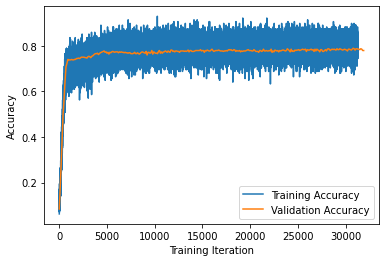

In [17]:
import matplotlib.pyplot as plt
plt.plot(range(len(training_accuracies)), training_accuracies, label = "Training Accuracy")
plt.plot(list(map(lambda x: x * 100, range(len(validation_accuracies)))), validation_accuracies, label = "Validation Accuracy")
plt.xlabel("Training Iteration")
plt.ylabel("Accuracy")
plt.legend()